# Importance Sampling for Fluctuating Hydro

This is a sandbox for exploring the fluctuating channel flow data. Data is loaded using the YT package. You might need to install (using `pip`):
1. Jupyter (and Jupyter Lab)
2. YT
3. numpy
4. matplotlib

... Have fun!

## Import Basics

In [1]:
import sys, os, os.path
import glob

import scipy as sp
import numpy as np

import matplotlib
import matplotlib.pyplot as pp
from mpl_toolkits.mplot3d import Axes3D

import yt
from yt.frontends.boxlib.data_structures import AMReXDataset

from tempfile import TemporaryFile

Inline plots and namespace:

In [2]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


# Utilities

Replace `phi` with `concentration` in plot file's header file (yt doesn't like `phi`...)

In [427]:
### Replace "phi" with "concentration" in plt header file (yt doesn't like phi...)
def substitute_header(plt_file, source="phi", target="con"):
    
    # load header file
    header_file = os.path.join(plt_file, "Header")
    with open(header_file, "r") as f:
        header_orig = f.readlines()
    
    # select variable lables
    n_lables   = int(header_orig[1])
    l_offset   = 2
    
    # make a backup copy(iff the source was found in original)
    if source+"\n" in header_orig:
        header_cpy  = os.path.join(plt_file, "Header.backup")
        with open(header_cpy, "w") as f:
            for line in header_orig:
                f.write(line)
    
    # replace source with target
    for i in range(l_offset, n_lables+l_offset):
        if header_orig[i] == source+"\n":
            header_orig[i] = target+"\n"
    
    # save substituted file in place of original
    with open(header_file, "w") as f:
        for line in header_orig:
            f.write(line)

# Find Data

Currently we're working in the same directory as a the data $=>$ look in `.` for plot files

In [428]:
data_root = "."
data_dir  = "."

In [429]:
data_path = os.path.join(data_root, data_dir)
print(data_path)

./.


In [419]:
n_fill   = 5
prefix   = "plt"
file_fmt = prefix + "{:0" + str(n_fill) + "d}"
#file_fmt = "plt_structure_factor_mag"
#file_particles = "asciiParticles000000004"
#dat=np.loadtxt("asciiParticles000000008",skiprows = 5,usecols=(0,1,2),unpack=True)
#pp.plot(dat[0],dat[1],linewidth = 0, markersize = 5, marker = 'o')
#Axes2D.scatter(dat[0],dat[1],dat[2],s=20,*args,**kwargs)
data_glob  = os.path.join(data_path, prefix + "*")
#data_glob  = os.path.join(data_path, file_fmt)
data_files = glob.glob(data_glob)
data_files.sort()
n =200
for y in range (0,19):
    values = [0]*n
    for x in range (0,n):
        substitute_header(data_files[x+y*n])

IndexError: list index out of range

In [430]:
data_glob  = os.path.join(data_path, prefix + "*")
#data_glob  = os.path.join(data_path, file_fmt)
data_files = glob.glob(data_glob)
data_files.sort()
n = 400 #sample number per window
for y in range (0,149):
    values = [0]*n
    for x in range (0,n):
        substitute_header(data_files[x+y*n])
        ds = yt.load(data_files[x+y*n])
        square = ds.covering_grid(level=0, fields=["con"],left_edge=ds.domain_left_edge, dims=ds.domain_dimensions)
        data = square["con"]
        #matshow(data[:,:,0])
        new_data = data[:,:,0]
        values[x] = np.sum(new_data)*(1./128.)*(1./128.)
        print("here",y,x,np.sum(new_data)*(1./128.)*(1./128.)) # note that np.sum sums all the data in the arrays if you don't specify an axis
    print(values)
    np.savetxt('data'+str(y*0.0025+0.05), values)

yt : [INFO     ] 2019-05-21 18:25:03,754 Parameters: current_time              = 0.0
yt : [INFO     ] 2019-05-21 18:25:03,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:03,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:03,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:03,862 Parameters: current_time              = 0.12204589843751103
yt : [INFO     ] 2019-05-21 18:25:03,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:03,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:03,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:03,954 Parameters: current_time              = 0.24411621093753877
yt : [INFO     ] 2019-05-21 18:25:03,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:03,955 Parameters: domain_

here 0 0 0.03106689453125 dimensionless
here 0 1 0.048724215181184354 dimensionless
here 0 2 0.04570642645850924 dimensionless


yt : [INFO     ] 2019-05-21 18:25:04,139 Parameters: current_time              = 0.4882568359373234
yt : [INFO     ] 2019-05-21 18:25:04,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:04,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:04,230 Parameters: current_time              = 0.6103271484372124
yt : [INFO     ] 2019-05-21 18:25:04,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:04,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:04,321 Parameters: current_time              = 0.7323974609371013
yt : [INFO     ] 2019-05-21 18:25:04,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,322 Parame

here 0 3 0.04194307842335815 dimensionless
here 0 4 0.04329334012093983 dimensionless
here 0 5 0.04396688251524108 dimensionless


yt : [INFO     ] 2019-05-21 18:25:04,414 Parameters: current_time              = 0.8544677734369903
yt : [INFO     ] 2019-05-21 18:25:04,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:04,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:04,504 Parameters: current_time              = 0.9765380859368793
yt : [INFO     ] 2019-05-21 18:25:04,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:04,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:04,595 Parameters: current_time              = 1.0986083984372166
yt : [INFO     ] 2019-05-21 18:25:04,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,596 Parame

here 0 6 0.042766215917108136 dimensionless
here 0 7 0.043318380277169284 dimensionless
here 0 8 0.04370371361601856 dimensionless


yt : [INFO     ] 2019-05-21 18:25:04,688 Parameters: current_time              = 1.2206787109376607
yt : [INFO     ] 2019-05-21 18:25:04,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:04,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:04,785 Parameters: current_time              = 1.3427490234381048
yt : [INFO     ] 2019-05-21 18:25:04,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:04,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:04,876 Parameters: current_time              = 1.4648193359385488
yt : [INFO     ] 2019-05-21 18:25:04,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,876 Parame

here 0 9 0.04389899843552457 dimensionless
here 0 10 0.04430894614279631 dimensionless
here 0 11 0.04443030458817585 dimensionless


yt : [INFO     ] 2019-05-21 18:25:04,968 Parameters: current_time              = 1.586889648438993
yt : [INFO     ] 2019-05-21 18:25:04,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:04,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:04,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:05,058 Parameters: current_time              = 1.708959960939437
yt : [INFO     ] 2019-05-21 18:25:05,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:05,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:05,149 Parameters: current_time              = 1.8310302734398811
yt : [INFO     ] 2019-05-21 18:25:05,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,150 Paramete

here 0 12 0.04449824887644825 dimensionless
here 0 13 0.04385914094692942 dimensionless
here 0 14 0.044699627349847434 dimensionless


yt : [INFO     ] 2019-05-21 18:25:05,240 Parameters: current_time              = 1.9531005859403252
yt : [INFO     ] 2019-05-21 18:25:05,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:05,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:05,331 Parameters: current_time              = 2.0751708984407693
yt : [INFO     ] 2019-05-21 18:25:05,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:05,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:05,420 Parameters: current_time              = 2.1972412109412134
yt : [INFO     ] 2019-05-21 18:25:05,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,421 Parame

here 0 15 0.04199748191900818 dimensionless
here 0 16 0.0442515004190374 dimensionless
here 0 17 0.04235604042940916 dimensionless


yt : [INFO     ] 2019-05-21 18:25:05,511 Parameters: current_time              = 2.3193115234416575
yt : [INFO     ] 2019-05-21 18:25:05,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:05,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:05,602 Parameters: current_time              = 2.4413818359421016
yt : [INFO     ] 2019-05-21 18:25:05,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:05,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:05,691 Parameters: current_time              = 2.5634521484425457
yt : [INFO     ] 2019-05-21 18:25:05,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,692 Parame

here 0 18 0.04317421617681377 dimensionless
here 0 19 0.043895319347011595 dimensionless
here 0 20 0.04328213796854008 dimensionless


yt : [INFO     ] 2019-05-21 18:25:05,782 Parameters: current_time              = 2.6855224609429897
yt : [INFO     ] 2019-05-21 18:25:05,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:05,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:05,874 Parameters: current_time              = 2.807592773443434
yt : [INFO     ] 2019-05-21 18:25:05,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:05,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:05,964 Parameters: current_time              = 2.929663085943878
yt : [INFO     ] 2019-05-21 18:25:05,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:05,965 Paramete

here 0 21 0.04348450898901859 dimensionless
here 0 22 0.041911696317991444 dimensionless
here 0 23 0.04367187537327123 dimensionless


yt : [INFO     ] 2019-05-21 18:25:06,056 Parameters: current_time              = 3.051733398444322
yt : [INFO     ] 2019-05-21 18:25:06,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:06,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:06,147 Parameters: current_time              = 3.173803710944766
yt : [INFO     ] 2019-05-21 18:25:06,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:06,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:06,239 Parameters: current_time              = 3.29587402344521
yt : [INFO     ] 2019-05-21 18:25:06,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,240 Parameters

here 0 24 0.043361312326522586 dimensionless
here 0 25 0.043266148649707487 dimensionless
here 0 26 0.0430721738635157 dimensionless


yt : [INFO     ] 2019-05-21 18:25:06,524 Parameters: current_time              = 3.4179443359456543
yt : [INFO     ] 2019-05-21 18:25:06,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:06,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:06,616 Parameters: current_time              = 3.5400146484460984
yt : [INFO     ] 2019-05-21 18:25:06,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:06,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:06,708 Parameters: current_time              = 3.6620849609465425
yt : [INFO     ] 2019-05-21 18:25:06,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,708 Parame

here 0 27 0.04424330660467245 dimensionless
here 0 28 0.04361260174199469 dimensionless
here 0 29 0.042971770811749646 dimensionless


yt : [INFO     ] 2019-05-21 18:25:06,800 Parameters: current_time              = 3.7841552734469865
yt : [INFO     ] 2019-05-21 18:25:06,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:06,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:06,892 Parameters: current_time              = 3.9062255859474306
yt : [INFO     ] 2019-05-21 18:25:06,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:06,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:06,983 Parameters: current_time              = 4.02829589844736
yt : [INFO     ] 2019-05-21 18:25:06,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:06,984 Paramete

here 0 30 0.04455489732285337 dimensionless
here 0 31 0.04447143639149349 dimensionless
here 0 32 0.04385217205665303 dimensionless


yt : [INFO     ] 2019-05-21 18:25:07,075 Parameters: current_time              = 4.150366210945584
yt : [INFO     ] 2019-05-21 18:25:07,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:07,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:07,167 Parameters: current_time              = 4.272436523443807
yt : [INFO     ] 2019-05-21 18:25:07,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:07,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:07,259 Parameters: current_time              = 4.394506835942031
yt : [INFO     ] 2019-05-21 18:25:07,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,260 Parameter

here 0 33 0.04441607473837873 dimensionless
here 0 34 0.044106287897634724 dimensionless
here 0 35 0.042727583902276156 dimensionless


yt : [INFO     ] 2019-05-21 18:25:07,351 Parameters: current_time              = 4.516577148440255
yt : [INFO     ] 2019-05-21 18:25:07,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:07,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:07,443 Parameters: current_time              = 4.638647460938478
yt : [INFO     ] 2019-05-21 18:25:07,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:07,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:07,534 Parameters: current_time              = 4.760717773436702
yt : [INFO     ] 2019-05-21 18:25:07,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,534 Parameter

here 0 36 0.04505226125978638 dimensionless
here 0 37 0.043573830942092356 dimensionless
here 0 38 0.04382763349590167 dimensionless


yt : [INFO     ] 2019-05-21 18:25:07,625 Parameters: current_time              = 4.8827880859349255
yt : [INFO     ] 2019-05-21 18:25:07,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:07,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:07,716 Parameters: current_time              = 5.004858398433149
yt : [INFO     ] 2019-05-21 18:25:07,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:07,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:07,809 Parameters: current_time              = 5.126928710931373
yt : [INFO     ] 2019-05-21 18:25:07,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,810 Paramete

here 0 39 0.04302543981151765 dimensionless
here 0 40 0.044165572527764964 dimensionless
here 0 41 0.04471727043258439 dimensionless


yt : [INFO     ] 2019-05-21 18:25:07,900 Parameters: current_time              = 5.2489990234295965
yt : [INFO     ] 2019-05-21 18:25:07,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:07,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:07,992 Parameters: current_time              = 5.37106933592782
yt : [INFO     ] 2019-05-21 18:25:07,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:07,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:07,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:08,083 Parameters: current_time              = 5.493139648426044
yt : [INFO     ] 2019-05-21 18:25:08,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,084 Parameter

here 0 42 0.043510468236123256 dimensionless
here 0 43 0.0427074361337606 dimensionless
here 0 44 0.04324665311176894 dimensionless


yt : [INFO     ] 2019-05-21 18:25:08,175 Parameters: current_time              = 5.615209960924267
yt : [INFO     ] 2019-05-21 18:25:08,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:08,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:08,266 Parameters: current_time              = 5.737280273422491
yt : [INFO     ] 2019-05-21 18:25:08,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:08,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:08,359 Parameters: current_time              = 5.859350585920715
yt : [INFO     ] 2019-05-21 18:25:08,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,360 Parameter

here 0 45 0.0430674264357378 dimensionless
here 0 46 0.04412918659733743 dimensionless
here 0 47 0.04412329277769772 dimensionless


yt : [INFO     ] 2019-05-21 18:25:08,451 Parameters: current_time              = 5.981420898418938
yt : [INFO     ] 2019-05-21 18:25:08,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:08,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:08,544 Parameters: current_time              = 6.103491210917162
yt : [INFO     ] 2019-05-21 18:25:08,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:08,545 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 48 0.04317233395744756 dimensionless
here 0 49 0.043246762526574466 dimensionless
here 0 50 0.04356468849793848 dimensionless


yt : [INFO     ] 2019-05-21 18:25:08,645 Parameters: current_time              = 6.225561523415386
yt : [INFO     ] 2019-05-21 18:25:08,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:08,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:08,737 Parameters: current_time              = 6.347631835913609
yt : [INFO     ] 2019-05-21 18:25:08,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:08,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:08,831 Parameters: current_time              = 6.469702148411833
yt : [INFO     ] 2019-05-21 18:25:08,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,832 Parameter

here 0 51 0.044016547613162885 dimensionless
here 0 52 0.04321511781655979 dimensionless
here 0 53 0.043323319503009654 dimensionless


yt : [INFO     ] 2019-05-21 18:25:08,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:08,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:08,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:09,022 Parameters: current_time              = 6.71384277340828
yt : [INFO     ] 2019-05-21 18:25:09,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:09,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:09,117 Parameters: current_time              = 6.835913085906504
yt : [INFO     ] 2019-05-21 18:25:09,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:09,119 Parameters: domai

here 0 54 0.045623154123220946 dimensionless
here 0 55 0.04428866756748927 dimensionless


yt : [INFO     ] 2019-05-21 18:25:09,417 Parameters: current_time              = 6.9579833984047275
yt : [INFO     ] 2019-05-21 18:25:09,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:09,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:09,513 Parameters: current_time              = 7.080053710902951
yt : [INFO     ] 2019-05-21 18:25:09,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:09,515 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 56 0.04289897672045627 dimensionless
here 0 57 0.04399005402037735 dimensionless
here 0 58 0.04228893709814365 dimensionless


yt : [INFO     ] 2019-05-21 18:25:09,609 Parameters: current_time              = 7.202124023401175
yt : [INFO     ] 2019-05-21 18:25:09,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:09,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:09,708 Parameters: current_time              = 7.324194335899398
yt : [INFO     ] 2019-05-21 18:25:09,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:09,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:09,804 Parameters: current_time              = 7.446264648397622
yt : [INFO     ] 2019-05-21 18:25:09,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,805 Parameter

here 0 59 0.04360060167024919 dimensionless
here 0 60 0.043536645374849046 dimensionless
here 0 61 0.044555545158010704 dimensionless


yt : [INFO     ] 2019-05-21 18:25:09,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:09,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:09,994 Parameters: current_time              = 7.690405273394069
yt : [INFO     ] 2019-05-21 18:25:09,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:09,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:09,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:10,089 Parameters: current_time              = 7.812475585892293
yt : [INFO     ] 2019-05-21 18:25:10,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:10,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:10,090 Parameters: doma

here 0 62 0.043722312964133925 dimensionless
here 0 63 0.043686102749389666 dimensionless
here 0 64 0.04376562209168331 dimensionless


yt : [INFO     ] 2019-05-21 18:25:10,277 Parameters: current_time              = 8.056616210888741
yt : [INFO     ] 2019-05-21 18:25:10,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:10,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:10,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:10,374 Parameters: current_time              = 8.178686523386965
yt : [INFO     ] 2019-05-21 18:25:10,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:10,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:10,375 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 65 0.044142467285348555 dimensionless
here 0 66 0.04421167666517777 dimensionless
here 0 67 0.044740234693571676 dimensionless


yt : [INFO     ] 2019-05-21 18:25:10,471 Parameters: current_time              = 8.300756835885188
yt : [INFO     ] 2019-05-21 18:25:10,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:10,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:10,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:10,567 Parameters: current_time              = 8.422827148383412
yt : [INFO     ] 2019-05-21 18:25:10,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:10,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:10,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:10,661 Parameters: current_time              = 8.544897460881636
yt : [INFO     ] 2019-05-21 18:25:10,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:10,662 Parameter

here 0 68 0.0438537695640487 dimensionless
here 0 69 0.04506937073243067 dimensionless
here 0 70 0.04334167009584315 dimensionless


yt : [INFO     ] 2019-05-21 18:25:10,847 Parameters: current_time              = 8.789038085878083
yt : [INFO     ] 2019-05-21 18:25:10,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:10,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:10,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:10,939 Parameters: current_time              = 8.911108398376307
yt : [INFO     ] 2019-05-21 18:25:10,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:10,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:10,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:11,031 Parameters: current_time              = 9.03317871087453
yt : [INFO     ] 2019-05-21 18:25:11,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,032 Parameters

here 0 71 0.04301107268878367 dimensionless
here 0 72 0.04413616982732724 dimensionless
here 0 73 0.04426381907440188 dimensionless


yt : [INFO     ] 2019-05-21 18:25:11,125 Parameters: current_time              = 9.155249023372754
yt : [INFO     ] 2019-05-21 18:25:11,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:11,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:11,219 Parameters: current_time              = 9.277319335870978
yt : [INFO     ] 2019-05-21 18:25:11,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:11,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:11,312 Parameters: current_time              = 9.399389648369201
yt : [INFO     ] 2019-05-21 18:25:11,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,312 Parameter

here 0 74 0.04440055204593262 dimensionless
here 0 75 0.04350050069316928 dimensionless
here 0 76 0.04434660856773302 dimensionless


yt : [INFO     ] 2019-05-21 18:25:11,405 Parameters: current_time              = 9.521459960867425
yt : [INFO     ] 2019-05-21 18:25:11,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:11,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:11,497 Parameters: current_time              = 9.643530273365648
yt : [INFO     ] 2019-05-21 18:25:11,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:11,499 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 77 0.04364053350009531 dimensionless
here 0 78 0.043717239125934594 dimensionless
here 0 79 0.04342299104489244 dimensionless


yt : [INFO     ] 2019-05-21 18:25:11,600 Parameters: current_time              = 9.765600585863872
yt : [INFO     ] 2019-05-21 18:25:11,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:11,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:11,693 Parameters: current_time              = 9.887670898362096
yt : [INFO     ] 2019-05-21 18:25:11,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:11,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:11,788 Parameters: current_time              = 10.00974121086032
yt : [INFO     ] 2019-05-21 18:25:11,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,789 Parameter

here 0 80 0.04370282924488845 dimensionless
here 0 81 0.04320992213072167 dimensionless
here 0 82 0.042843718034131895 dimensionless


yt : [INFO     ] 2019-05-21 18:25:11,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:11,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:11,977 Parameters: current_time              = 10.253881835856767
yt : [INFO     ] 2019-05-21 18:25:11,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:11,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:11,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:12,068 Parameters: current_time              = 10.37595214835499
yt : [INFO     ] 2019-05-21 18:25:12,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:12,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:12,069 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 83 0.043596045548416354 dimensionless
here 0 84 0.04331510648356281 dimensionless


yt : [INFO     ] 2019-05-21 18:25:12,370 Parameters: current_time              = 10.498022460853214
yt : [INFO     ] 2019-05-21 18:25:12,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:12,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:12,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:12,472 Parameters: current_time              = 10.620092773351438
yt : [INFO     ] 2019-05-21 18:25:12,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:12,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:12,474 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 85 0.043326258775774534 dimensionless
here 0 86 0.04490454335904477 dimensionless
here 0 87 0.044411372692139434 dimensionless


yt : [INFO     ] 2019-05-21 18:25:12,568 Parameters: current_time              = 10.742163085849661
yt : [INFO     ] 2019-05-21 18:25:12,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:12,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:12,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:12,661 Parameters: current_time              = 10.864233398347885
yt : [INFO     ] 2019-05-21 18:25:12,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:12,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:12,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:12,757 Parameters: current_time              = 10.986303710846109
yt : [INFO     ] 2019-05-21 18:25:12,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:12,758 Parame

here 0 88 0.0444250195963157 dimensionless
here 0 89 0.04478759843972506 dimensionless
here 0 90 0.0430282348986614 dimensionless


yt : [INFO     ] 2019-05-21 18:25:12,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:12,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:12,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:12,946 Parameters: current_time              = 11.230444335842556
yt : [INFO     ] 2019-05-21 18:25:12,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:12,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:12,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:13,039 Parameters: current_time              = 11.35251464834078
yt : [INFO     ] 2019-05-21 18:25:13,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:13,041 Parameters: dom

here 0 91 0.04248260594512003 dimensionless
here 0 92 0.042961505884267635 dimensionless
here 0 93 0.042963030976625106 dimensionless


yt : [INFO     ] 2019-05-21 18:25:13,139 Parameters: current_time              = 11.474584960839003
yt : [INFO     ] 2019-05-21 18:25:13,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:13,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:13,233 Parameters: current_time              = 11.596655273337227
yt : [INFO     ] 2019-05-21 18:25:13,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:13,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:13,326 Parameters: current_time              = 11.71872558583545
yt : [INFO     ] 2019-05-21 18:25:13,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,327 Paramet

here 0 94 0.04463343038640851 dimensionless
here 0 95 0.044648414028843314 dimensionless
here 0 96 0.04505104361446705 dimensionless


yt : [INFO     ] 2019-05-21 18:25:13,511 Parameters: current_time              = 11.962866210831898
yt : [INFO     ] 2019-05-21 18:25:13,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:13,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:13,605 Parameters: current_time              = 12.084936523330121
yt : [INFO     ] 2019-05-21 18:25:13,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:13,606 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 97 0.045092545124140085 dimensionless
here 0 98 0.043402486740577104 dimensionless
here 0 99 0.04351843722593447 dimensionless


yt : [INFO     ] 2019-05-21 18:25:13,709 Parameters: current_time              = 12.207006835828345
yt : [INFO     ] 2019-05-21 18:25:13,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:13,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:13,807 Parameters: current_time              = 12.329077148326569
yt : [INFO     ] 2019-05-21 18:25:13,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:13,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:13,898 Parameters: current_time              = 12.451147460824792
yt : [INFO     ] 2019-05-21 18:25:13,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:13,899 Parame

here 0 100 0.04292833808422103 dimensionless
here 0 101 0.044197100362148176 dimensionless
here 0 102 0.044440941482922394 dimensionless


yt : [INFO     ] 2019-05-21 18:25:14,084 Parameters: current_time              = 12.69528808582124
yt : [INFO     ] 2019-05-21 18:25:14,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:14,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:14,175 Parameters: current_time              = 12.817358398319463
yt : [INFO     ] 2019-05-21 18:25:14,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:14,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:14,265 Parameters: current_time              = 12.939428710817687
yt : [INFO     ] 2019-05-21 18:25:14,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,266 Paramet

here 0 103 0.04316322807141755 dimensionless
here 0 104 0.04433645067202302 dimensionless
here 0 105 0.0442537555489617 dimensionless


yt : [INFO     ] 2019-05-21 18:25:14,358 Parameters: current_time              = 13.06149902331591
yt : [INFO     ] 2019-05-21 18:25:14,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:14,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:14,450 Parameters: current_time              = 13.183569335814134
yt : [INFO     ] 2019-05-21 18:25:14,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:14,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:14,540 Parameters: current_time              = 13.305639648312358
yt : [INFO     ] 2019-05-21 18:25:14,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,541 Paramet

here 0 106 0.04380278794745368 dimensionless
here 0 107 0.043317669752130195 dimensionless
here 0 108 0.0442584478808907 dimensionless


yt : [INFO     ] 2019-05-21 18:25:14,633 Parameters: current_time              = 13.427709960810581
yt : [INFO     ] 2019-05-21 18:25:14,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:14,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:14,725 Parameters: current_time              = 13.549780273308805
yt : [INFO     ] 2019-05-21 18:25:14,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:14,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:14,817 Parameters: current_time              = 13.671850585807029
yt : [INFO     ] 2019-05-21 18:25:14,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,817 Parame

here 0 109 0.043592064696995246 dimensionless
here 0 110 0.04427550641655861 dimensionless
here 0 111 0.04230063289856846 dimensionless


yt : [INFO     ] 2019-05-21 18:25:14,908 Parameters: current_time              = 13.793920898305252
yt : [INFO     ] 2019-05-21 18:25:14,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:14,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:14,910 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 112 0.044620415596450455 dimensionless


yt : [INFO     ] 2019-05-21 18:25:15,208 Parameters: current_time              = 13.915991210803476
yt : [INFO     ] 2019-05-21 18:25:15,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:15,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:15,302 Parameters: current_time              = 14.0380615233017
yt : [INFO     ] 2019-05-21 18:25:15,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:15,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:15,395 Parameters: current_time              = 14.160131835799923
yt : [INFO     ] 2019-05-21 18:25:15,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,396 Paramete

here 0 113 0.04459645916941632 dimensionless
here 0 114 0.04491492380287686 dimensionless
here 0 115 0.04303877375893669 dimensionless


yt : [INFO     ] 2019-05-21 18:25:15,489 Parameters: current_time              = 14.282202148298147
yt : [INFO     ] 2019-05-21 18:25:15,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:15,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:15,583 Parameters: current_time              = 14.40427246079637
yt : [INFO     ] 2019-05-21 18:25:15,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:15,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:15,676 Parameters: current_time              = 14.526342773294594
yt : [INFO     ] 2019-05-21 18:25:15,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,677 Paramet

here 0 116 0.044613822536186634 dimensionless
here 0 117 0.0440559566314322 dimensionless
here 0 118 0.04347744136602412 dimensionless


yt : [INFO     ] 2019-05-21 18:25:15,771 Parameters: current_time              = 14.648413085792818
yt : [INFO     ] 2019-05-21 18:25:15,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:15,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:15,863 Parameters: current_time              = 14.770483398291042
yt : [INFO     ] 2019-05-21 18:25:15,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:15,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:15,956 Parameters: current_time              = 14.892553710789265
yt : [INFO     ] 2019-05-21 18:25:15,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:15,957 Parame

here 0 119 0.04179906434001911 dimensionless
here 0 120 0.043988461778128894 dimensionless
here 0 121 0.0442387467203285 dimensionless


yt : [INFO     ] 2019-05-21 18:25:16,055 Parameters: current_time              = 15.014624023287489
yt : [INFO     ] 2019-05-21 18:25:16,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:16,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:16,149 Parameters: current_time              = 15.136694335785712
yt : [INFO     ] 2019-05-21 18:25:16,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:16,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:16,242 Parameters: current_time              = 15.258764648283936
yt : [INFO     ] 2019-05-21 18:25:16,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,243 Parame

here 0 122 0.04445990716878635 dimensionless
here 0 123 0.043685090844457986 dimensionless
here 0 124 0.043320866982602194 dimensionless


yt : [INFO     ] 2019-05-21 18:25:16,336 Parameters: current_time              = 15.38083496078216
yt : [INFO     ] 2019-05-21 18:25:16,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:16,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:16,428 Parameters: current_time              = 15.502905273280383
yt : [INFO     ] 2019-05-21 18:25:16,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:16,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:16,520 Parameters: current_time              = 15.624975585778607
yt : [INFO     ] 2019-05-21 18:25:16,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,521 Paramet

here 0 125 0.043855318331971344 dimensionless
here 0 126 0.04397418763561888 dimensionless
here 0 127 0.042398288707257585 dimensionless


yt : [INFO     ] 2019-05-21 18:25:16,619 Parameters: current_time              = 15.74704589827683
yt : [INFO     ] 2019-05-21 18:25:16,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:16,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:16,715 Parameters: current_time              = 15.869116210775054
yt : [INFO     ] 2019-05-21 18:25:16,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:16,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:16,808 Parameters: current_time              = 15.991186523273278
yt : [INFO     ] 2019-05-21 18:25:16,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,809 Paramet

here 0 128 0.04265941688519939 dimensionless
here 0 129 0.04426993332850003 dimensionless
here 0 130 0.04350658562163698 dimensionless


yt : [INFO     ] 2019-05-21 18:25:16,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:16,902 Parameters: current_time              = 16.11325683577974
yt : [INFO     ] 2019-05-21 18:25:16,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:16,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:16,994 Parameters: current_time              = 16.235327148286846
yt : [INFO     ] 2019-05-21 18:25:16,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:16,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:16,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:17,086 Parameters: current_time              = 16.35739746079395
yt : [INFO     ] 2019-05-21 18:25:17,087 Parameters:

here 0 131 0.044703245568883124 dimensionless
here 0 132 0.044440192763245526 dimensionless
here 0 133 0.044837700971116334 dimensionless


yt : [INFO     ] 2019-05-21 18:25:17,184 Parameters: current_time              = 16.479467773301057
yt : [INFO     ] 2019-05-21 18:25:17,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:17,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:17,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:17,276 Parameters: current_time              = 16.601538085808162
yt : [INFO     ] 2019-05-21 18:25:17,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:17,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:17,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:17,368 Parameters: current_time              = 16.723608398315267
yt : [INFO     ] 2019-05-21 18:25:17,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:17,369 Parame

here 0 134 0.04386661447414178 dimensionless
here 0 135 0.04381656871206261 dimensionless
here 0 136 0.043477474834558924 dimensionless


yt : [INFO     ] 2019-05-21 18:25:17,459 Parameters: current_time              = 16.845678710822373
yt : [INFO     ] 2019-05-21 18:25:17,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:17,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:17,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:17,551 Parameters: current_time              = 16.96774902332948
yt : [INFO     ] 2019-05-21 18:25:17,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:17,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:17,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:17,641 Parameters: current_time              = 17.089819335836584
yt : [INFO     ] 2019-05-21 18:25:17,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:17,642 Paramet

here 0 137 0.04426341277369747 dimensionless
here 0 138 0.04405122011521339 dimensionless
here 0 139 0.04240879585738693 dimensionless


yt : [INFO     ] 2019-05-21 18:25:17,733 Parameters: current_time              = 17.21188964834369
yt : [INFO     ] 2019-05-21 18:25:17,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:17,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:17,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:17,824 Parameters: current_time              = 17.333959960850795
yt : [INFO     ] 2019-05-21 18:25:17,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:17,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:17,825 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 140 0.04419443223595082 dimensionless
here 0 141 0.043997835055378444 dimensionless


yt : [INFO     ] 2019-05-21 18:25:18,129 Parameters: current_time              = 17.4560302733579
yt : [INFO     ] 2019-05-21 18:25:18,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:18,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:18,231 Parameters: current_time              = 17.578100585865005
yt : [INFO     ] 2019-05-21 18:25:18,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:18,232 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 142 0.043647733281279064 dimensionless
here 0 143 0.04394131182377893 dimensionless


yt : [INFO     ] 2019-05-21 18:25:18,333 Parameters: current_time              = 17.70017089837211
yt : [INFO     ] 2019-05-21 18:25:18,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:18,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:18,432 Parameters: current_time              = 17.822241210879216
yt : [INFO     ] 2019-05-21 18:25:18,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:18,433 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 144 0.044670479096772985 dimensionless
here 0 145 0.045006808821376885 dimensionless
here 0 146 0.04404381554530032 dimensionless


yt : [INFO     ] 2019-05-21 18:25:18,525 Parameters: current_time              = 17.94431152338632
yt : [INFO     ] 2019-05-21 18:25:18,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:18,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:18,619 Parameters: current_time              = 18.066381835893427
yt : [INFO     ] 2019-05-21 18:25:18,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:18,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:18,715 Parameters: current_time              = 18.188452148400533
yt : [INFO     ] 2019-05-21 18:25:18,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,715 Paramet

here 0 147 0.04388005451817578 dimensionless
here 0 148 0.0439340328727559 dimensionless
here 0 149 0.04400147224138822 dimensionless


yt : [INFO     ] 2019-05-21 18:25:18,809 Parameters: current_time              = 18.310522460907638
yt : [INFO     ] 2019-05-21 18:25:18,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:18,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:18,905 Parameters: current_time              = 18.432592773414743
yt : [INFO     ] 2019-05-21 18:25:18,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:18,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:18,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:19,002 Parameters: current_time              = 18.55466308592185
yt : [INFO     ] 2019-05-21 18:25:19,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,003 Paramet

here 0 150 0.04312350174156922 dimensionless
here 0 151 0.044149700031310975 dimensionless
here 0 152 0.04449702485997163 dimensionless


yt : [INFO     ] 2019-05-21 18:25:19,099 Parameters: current_time              = 18.676733398428954
yt : [INFO     ] 2019-05-21 18:25:19,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:19,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:19,197 Parameters: current_time              = 18.79880371093606
yt : [INFO     ] 2019-05-21 18:25:19,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:19,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:19,296 Parameters: current_time              = 18.920874023443165
yt : [INFO     ] 2019-05-21 18:25:19,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,297 Paramet

here 0 153 0.043451424484931334 dimensionless
here 0 154 0.04313498860166661 dimensionless
here 0 155 0.04424400478579743 dimensionless


yt : [INFO     ] 2019-05-21 18:25:19,394 Parameters: current_time              = 19.04294433595027
yt : [INFO     ] 2019-05-21 18:25:19,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:19,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:19,490 Parameters: current_time              = 19.165014648457376
yt : [INFO     ] 2019-05-21 18:25:19,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:19,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:19,587 Parameters: current_time              = 19.28708496096448
yt : [INFO     ] 2019-05-21 18:25:19,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,587 Paramete

here 0 156 0.04322876985085788 dimensionless
here 0 157 0.04483511239859856 dimensionless
here 0 158 0.04275883011937933 dimensionless


yt : [INFO     ] 2019-05-21 18:25:19,684 Parameters: current_time              = 19.409155273471587
yt : [INFO     ] 2019-05-21 18:25:19,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:19,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:19,779 Parameters: current_time              = 19.531225585978692
yt : [INFO     ] 2019-05-21 18:25:19,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:19,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:19,873 Parameters: current_time              = 19.653295898485798
yt : [INFO     ] 2019-05-21 18:25:19,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:19,874 Parame

here 0 159 0.044088056224904804 dimensionless
here 0 160 0.04340309654245048 dimensionless
here 0 161 0.04348891788943877 dimensionless


yt : [INFO     ] 2019-05-21 18:25:20,058 Parameters: current_time              = 19.89743652350001
yt : [INFO     ] 2019-05-21 18:25:20,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:20,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:20,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:20,156 Parameters: current_time              = 20.019506836007114
yt : [INFO     ] 2019-05-21 18:25:20,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:20,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:20,158 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 162 0.04455351384493107 dimensionless
here 0 163 0.044322980621086305 dimensionless
here 0 164 0.043799292023246804 dimensionless


yt : [INFO     ] 2019-05-21 18:25:20,253 Parameters: current_time              = 20.14157714851422
yt : [INFO     ] 2019-05-21 18:25:20,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:20,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:20,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:20,349 Parameters: current_time              = 20.263647461021325
yt : [INFO     ] 2019-05-21 18:25:20,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:20,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:20,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:20,443 Parameters: current_time              = 20.38571777352843
yt : [INFO     ] 2019-05-21 18:25:20,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:20,444 Paramete

here 0 165 0.04386479826915983 dimensionless
here 0 166 0.043712349040673934 dimensionless
here 0 167 0.042769770013407815 dimensionless


yt : [INFO     ] 2019-05-21 18:25:20,638 Parameters: current_time              = 20.62985839854264
yt : [INFO     ] 2019-05-21 18:25:20,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:20,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:20,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:20,734 Parameters: current_time              = 20.751928711049747
yt : [INFO     ] 2019-05-21 18:25:20,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:20,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:20,735 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 168 0.04457305647291163 dimensionless
here 0 169 0.04428518471387603 dimensionless
here 0 170 0.04223148047012709 dimensionless


yt : [INFO     ] 2019-05-21 18:25:20,831 Parameters: current_time              = 20.873999023556852
yt : [INFO     ] 2019-05-21 18:25:20,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:20,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:20,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:21,139 Parameters: current_time              = 20.996069336063957
yt : [INFO     ] 2019-05-21 18:25:21,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:21,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:21,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:21,238 Parameters: current_time              = 21.118139648571063
yt : [INFO     ] 2019-05-21 18:25:21,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:21,239 Parame

here 0 171 0.043252581387306935 dimensionless
here 0 172 0.04371066618563414 dimensionless
here 0 173 0.043837436106349235 dimensionless


yt : [INFO     ] 2019-05-21 18:25:21,337 Parameters: current_time              = 21.24020996107817
yt : [INFO     ] 2019-05-21 18:25:21,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:21,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:21,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:21,435 Parameters: current_time              = 21.362280273585274
yt : [INFO     ] 2019-05-21 18:25:21,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:21,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:21,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:21,533 Parameters: current_time              = 21.48435058609238
yt : [INFO     ] 2019-05-21 18:25:21,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:21,534 Paramete

here 0 174 0.04537679067503288 dimensionless
here 0 175 0.04431050745123926 dimensionless
here 0 176 0.043652645971156354 dimensionless


yt : [INFO     ] 2019-05-21 18:25:21,628 Parameters: current_time              = 21.606420898599485
yt : [INFO     ] 2019-05-21 18:25:21,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:21,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:21,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:21,725 Parameters: current_time              = 21.72849121110659
yt : [INFO     ] 2019-05-21 18:25:21,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:21,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:21,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:21,819 Parameters: current_time              = 21.850561523613695
yt : [INFO     ] 2019-05-21 18:25:21,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:21,820 Paramet

here 0 177 0.04451908456306128 dimensionless
here 0 178 0.04405123535786523 dimensionless
here 0 179 0.043602776907638106 dimensionless


yt : [INFO     ] 2019-05-21 18:25:21,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,010 Parameters: current_time              = 22.094702148627906
yt : [INFO     ] 2019-05-21 18:25:22,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,105 Parameters: current_time              = 22.21677246113501
yt : [INFO     ] 2019-05-21 18:25:22,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,201 Parameters: current_time              = 22.338842773642117


here 0 180 0.04307560441844052 dimensionless
here 0 181 0.04322602139710631 dimensionless
here 0 182 0.04352377658358783 dimensionless


yt : [INFO     ] 2019-05-21 18:25:22,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,296 Parameters: current_time              = 22.460913086149223
yt : [INFO     ] 2019-05-21 18:25:22,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,392 Parameters: current_time              = 22.582983398656328
yt : [INFO     ] 2019-05-21 18:25:22,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,393 Parameters: do

here 0 183 0.04354421554576292 dimensionless
here 0 184 0.04272239068514569 dimensionless
here 0 185 0.043975737059594566 dimensionless


yt : [INFO     ] 2019-05-21 18:25:22,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,582 Parameters: current_time              = 22.82712402367054
yt : [INFO     ] 2019-05-21 18:25:22,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,678 Parameters: current_time              = 22.949194336177644
yt : [INFO     ] 2019-05-21 18:25:22,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,680 Parameters: dom

here 0 186 0.044964701056290045 dimensionless
here 0 187 0.04372925871577078 dimensionless
here 0 188 0.042636121724496795 dimensionless


yt : [INFO     ] 2019-05-21 18:25:22,773 Parameters: current_time              = 23.07126464868475
yt : [INFO     ] 2019-05-21 18:25:22,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,872 Parameters: current_time              = 23.193334961191855
yt : [INFO     ] 2019-05-21 18:25:22,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:22,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:22,968 Parameters: current_time              = 23.31540527369896
yt : [INFO     ] 2019-05-21 18:25:22,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:22,969 Paramete

here 0 189 0.04359193802817228 dimensionless
here 0 190 0.044058922925984484 dimensionless
here 0 191 0.04316084958124025 dimensionless


yt : [INFO     ] 2019-05-21 18:25:23,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:23,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:23,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:23,156 Parameters: current_time              = 23.55954589871317
yt : [INFO     ] 2019-05-21 18:25:23,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:23,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:23,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:23,250 Parameters: current_time              = 23.681616211220277
yt : [INFO     ] 2019-05-21 18:25:23,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:23,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:23,251 Parameters: dom

here 0 192 0.04459881459444481 dimensionless
here 0 193 0.04397756332817047 dimensionless
here 0 194 0.04271819076514174 dimensionless


yt : [INFO     ] 2019-05-21 18:25:23,443 Parameters: current_time              = 23.925756836234488
yt : [INFO     ] 2019-05-21 18:25:23,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:23,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:23,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:23,547 Parameters: current_time              = 24.047827148741593
yt : [INFO     ] 2019-05-21 18:25:23,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:23,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:23,549 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 195 0.04277940455955223 dimensionless
here 0 196 0.04312244860048556 dimensionless
here 0 197 0.0429021605040415 dimensionless


yt : [INFO     ] 2019-05-21 18:25:23,642 Parameters: current_time              = 24.1698974612487
yt : [INFO     ] 2019-05-21 18:25:23,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:23,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:23,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:23,735 Parameters: current_time              = 24.291967773755804
yt : [INFO     ] 2019-05-21 18:25:23,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:23,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:23,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:23,828 Parameters: current_time              = 24.41403808626291
yt : [INFO     ] 2019-05-21 18:25:23,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:23,829 Parameter

here 0 198 0.04339889996271514 dimensionless
here 0 199 0.04377102479375224 dimensionless


yt : [INFO     ] 2019-05-21 18:25:24,120 Parameters: current_time              = 24.536108398770015
yt : [INFO     ] 2019-05-21 18:25:24,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:24,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:24,214 Parameters: current_time              = 24.65817871127712
yt : [INFO     ] 2019-05-21 18:25:24,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:24,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:24,307 Parameters: current_time              = 24.780249023784226
yt : [INFO     ] 2019-05-21 18:25:24,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,308 Paramet

here 0 200 0.0435534980075686 dimensionless
here 0 201 0.042885286958934135 dimensionless
here 0 202 0.0432027029673631 dimensionless


yt : [INFO     ] 2019-05-21 18:25:24,401 Parameters: current_time              = 24.90231933629133
yt : [INFO     ] 2019-05-21 18:25:24,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:24,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:24,495 Parameters: current_time              = 25.024389648798437
yt : [INFO     ] 2019-05-21 18:25:24,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:24,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:24,588 Parameters: current_time              = 25.146459961305542
yt : [INFO     ] 2019-05-21 18:25:24,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,588 Paramet

here 0 203 0.04384055483921122 dimensionless
here 0 204 0.04255309390496542 dimensionless
here 0 205 0.043217529619176485 dimensionless


yt : [INFO     ] 2019-05-21 18:25:24,682 Parameters: current_time              = 25.268530273812647
yt : [INFO     ] 2019-05-21 18:25:24,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:24,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:24,775 Parameters: current_time              = 25.390600586319753
yt : [INFO     ] 2019-05-21 18:25:24,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:24,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:24,873 Parameters: current_time              = 25.51267089882686


here 0 206 0.043970446427623405 dimensionless
here 0 207 0.044773459809020116 dimensionless
here 0 208 0.04383271984768778 dimensionless


yt : [INFO     ] 2019-05-21 18:25:24,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:24,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:24,968 Parameters: current_time              = 25.634741211333964
yt : [INFO     ] 2019-05-21 18:25:24,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:24,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:24,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:25,062 Parameters: current_time              = 25.75681152384107
yt : [INFO     ] 2019-05-21 18:25:25,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:25,063 Parameters: dom

here 0 209 0.043341452504261885 dimensionless
here 0 210 0.045133448034525 dimensionless
here 0 211 0.04309017325844264 dimensionless


yt : [INFO     ] 2019-05-21 18:25:25,249 Parameters: current_time              = 26.00095214885528
yt : [INFO     ] 2019-05-21 18:25:25,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:25,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:25,340 Parameters: current_time              = 26.123022461362385
yt : [INFO     ] 2019-05-21 18:25:25,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:25,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:25,432 Parameters: current_time              = 26.24509277386949
yt : [INFO     ] 2019-05-21 18:25:25,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,433 Paramete

here 0 212 0.04419708675827963 dimensionless
here 0 213 0.0434415411827654 dimensionless
here 0 214 0.04418074099875169 dimensionless


yt : [INFO     ] 2019-05-21 18:25:25,525 Parameters: current_time              = 26.367163086376596
yt : [INFO     ] 2019-05-21 18:25:25,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:25,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:25,618 Parameters: current_time              = 26.4892333988837
yt : [INFO     ] 2019-05-21 18:25:25,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:25,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:25,713 Parameters: current_time              = 26.611303711390807
yt : [INFO     ] 2019-05-21 18:25:25,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,714 Paramete

here 0 215 0.04320935965804905 dimensionless
here 0 216 0.04421089625992404 dimensionless
here 0 217 0.04347334923198584 dimensionless


yt : [INFO     ] 2019-05-21 18:25:25,808 Parameters: current_time              = 26.733374023897913
yt : [INFO     ] 2019-05-21 18:25:25,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:25,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:25,903 Parameters: current_time              = 26.855444336405018
yt : [INFO     ] 2019-05-21 18:25:25,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:25,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:25,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:25,997 Parameters: current_time              = 26.977514648912123
yt : [INFO     ] 2019-05-21 18:25:25,997 Parameters: domain_dimensions         = [128 128   1]


here 0 218 0.042895642322840405 dimensionless
here 0 219 0.04365956468455291 dimensionless
here 0 220 0.04334703253102469 dimensionless


yt : [INFO     ] 2019-05-21 18:25:25,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:25,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:26,089 Parameters: current_time              = 27.09958496141923
yt : [INFO     ] 2019-05-21 18:25:26,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:26,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:26,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:26,181 Parameters: current_time              = 27.221655273926334
yt : [INFO     ] 2019-05-21 18:25:26,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:26,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:26,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:26,279 Parameters: curren

here 0 221 0.0435442100544934 dimensionless
here 0 222 0.043609533966621025 dimensionless
here 0 223 0.04374498914110933 dimensionless


yt : [INFO     ] 2019-05-21 18:25:26,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:26,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:26,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:26,375 Parameters: current_time              = 27.465795898940545
yt : [INFO     ] 2019-05-21 18:25:26,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:26,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:26,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:26,470 Parameters: current_time              = 27.58786621144765
yt : [INFO     ] 2019-05-21 18:25:26,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:26,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:26,471 Parameters: dom

here 0 224 0.04288777695115059 dimensionless
here 0 225 0.04260589079075431 dimensionless
here 0 226 0.04310905117277349 dimensionless


yt : [INFO     ] 2019-05-21 18:25:26,656 Parameters: current_time              = 27.83200683646186
yt : [INFO     ] 2019-05-21 18:25:26,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:26,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:26,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:26,752 Parameters: current_time              = 27.954077148968967
yt : [INFO     ] 2019-05-21 18:25:26,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:26,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:26,753 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 227 0.04463400692385992 dimensionless
here 0 228 0.04459886033023858 dimensionless


yt : [INFO     ] 2019-05-21 18:25:27,045 Parameters: current_time              = 28.076147461476072
yt : [INFO     ] 2019-05-21 18:25:27,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:27,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:27,137 Parameters: current_time              = 28.198217773983178
yt : [INFO     ] 2019-05-21 18:25:27,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:27,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:27,231 Parameters: current_time              = 28.320288086490283
yt : [INFO     ] 2019-05-21 18:25:27,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,232 Parame

here 0 229 0.04389314985599907 dimensionless
here 0 230 0.04446529784180923 dimensionless
here 0 231 0.04422913179605861 dimensionless


yt : [INFO     ] 2019-05-21 18:25:27,324 Parameters: current_time              = 28.44235839899739
yt : [INFO     ] 2019-05-21 18:25:27,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:27,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:27,416 Parameters: current_time              = 28.564428711504494
yt : [INFO     ] 2019-05-21 18:25:27,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:27,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:27,509 Parameters: current_time              = 28.6864990240116
yt : [INFO     ] 2019-05-21 18:25:27,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,510 Parameter

here 0 232 0.043687511107218316 dimensionless
here 0 233 0.04323566097668502 dimensionless
here 0 234 0.042951204285622345 dimensionless


yt : [INFO     ] 2019-05-21 18:25:27,602 Parameters: current_time              = 28.808569336518705
yt : [INFO     ] 2019-05-21 18:25:27,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:27,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:27,698 Parameters: current_time              = 28.93063964902581
yt : [INFO     ] 2019-05-21 18:25:27,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:27,699 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 235 0.043178961258197965 dimensionless
here 0 236 0.044364995916058386 dimensionless
here 0 237 0.0442669077197078 dimensionless


yt : [INFO     ] 2019-05-21 18:25:27,795 Parameters: current_time              = 29.052709961532916
yt : [INFO     ] 2019-05-21 18:25:27,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:27,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:27,895 Parameters: current_time              = 29.17478027404002
yt : [INFO     ] 2019-05-21 18:25:27,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:27,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:27,993 Parameters: current_time              = 29.296850586547126
yt : [INFO     ] 2019-05-21 18:25:27,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:27,994 Paramet

here 0 238 0.04317834190889283 dimensionless
here 0 239 0.044061514859976364 dimensionless
here 0 240 0.045430737743728924 dimensionless


yt : [INFO     ] 2019-05-21 18:25:28,088 Parameters: current_time              = 29.418920899054232
yt : [INFO     ] 2019-05-21 18:25:28,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:28,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:28,184 Parameters: current_time              = 29.540991211561337
yt : [INFO     ] 2019-05-21 18:25:28,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:28,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:28,280 Parameters: current_time              = 29.663061524068443
yt : [INFO     ] 2019-05-21 18:25:28,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,281 Parame

here 0 241 0.043410067559029895 dimensionless
here 0 242 0.04413634923869372 dimensionless
here 0 243 0.044003424006010726 dimensionless


yt : [INFO     ] 2019-05-21 18:25:28,376 Parameters: current_time              = 29.785131836575548
yt : [INFO     ] 2019-05-21 18:25:28,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:28,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:28,473 Parameters: current_time              = 29.907202149082654
yt : [INFO     ] 2019-05-21 18:25:28,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:28,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:28,596 Parameters: current_time              = 30.02927246158976
yt : [INFO     ] 2019-05-21 18:25:28,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,596 Paramet

here 0 244 0.04482052523928703 dimensionless
here 0 245 0.04405637220086324 dimensionless


yt : [INFO     ] 2019-05-21 18:25:28,691 Parameters: current_time              = 30.151342774096864
yt : [INFO     ] 2019-05-21 18:25:28,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:28,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:28,788 Parameters: current_time              = 30.27341308660397
yt : [INFO     ] 2019-05-21 18:25:28,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:28,790 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 246 0.04338020463577131 dimensionless
here 0 247 0.04338025242296032 dimensionless
here 0 248 0.042876963767134346 dimensionless


yt : [INFO     ] 2019-05-21 18:25:28,889 Parameters: current_time              = 30.395483399111075
yt : [INFO     ] 2019-05-21 18:25:28,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:28,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:28,989 Parameters: current_time              = 30.51755371161818
yt : [INFO     ] 2019-05-21 18:25:28,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:28,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:28,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:29,088 Parameters: current_time              = 30.639624024125286
yt : [INFO     ] 2019-05-21 18:25:29,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:29,089 Paramet

here 0 249 0.04495821133543486 dimensionless
here 0 250 0.043924849876201356 dimensionless
here 0 251 0.04335049893967374 dimensionless


yt : [INFO     ] 2019-05-21 18:25:29,185 Parameters: current_time              = 30.76169433663239
yt : [INFO     ] 2019-05-21 18:25:29,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:29,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:29,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:29,283 Parameters: current_time              = 30.883764649139497
yt : [INFO     ] 2019-05-21 18:25:29,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:29,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:29,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:29,378 Parameters: current_time              = 31.005834961646602
yt : [INFO     ] 2019-05-21 18:25:29,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:29,379 Paramet

here 0 252 0.044372731872265564 dimensionless
here 0 253 0.043723185402626 dimensionless
here 0 254 0.04391011869788545 dimensionless


yt : [INFO     ] 2019-05-21 18:25:29,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:29,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:29,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:29,567 Parameters: current_time              = 31.249975586660813
yt : [INFO     ] 2019-05-21 18:25:29,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:29,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:29,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:29,660 Parameters: current_time              = 31.37204589916792
yt : [INFO     ] 2019-05-21 18:25:29,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:29,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:29,662 Parameters: dom

here 0 255 0.04320405114122958 dimensionless
here 0 256 0.04346991673436783 dimensionless
here 0 257 0.04406561471591893 dimensionless


yt : [INFO     ] 2019-05-21 18:25:30,051 Parameters: current_time              = 31.61618652418213
yt : [INFO     ] 2019-05-21 18:25:30,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:30,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:30,147 Parameters: current_time              = 31.738256836689235
yt : [INFO     ] 2019-05-21 18:25:30,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:30,149 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 258 0.04237076741402365 dimensionless
here 0 259 0.043185384864225615 dimensionless
here 0 260 0.044097367289504946 dimensionless


yt : [INFO     ] 2019-05-21 18:25:30,246 Parameters: current_time              = 31.86032714919634
yt : [INFO     ] 2019-05-21 18:25:30,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:30,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:30,342 Parameters: current_time              = 31.982397461703446
yt : [INFO     ] 2019-05-21 18:25:30,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:30,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:30,440 Parameters: current_time              = 32.10446777421055
yt : [INFO     ] 2019-05-21 18:25:30,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,441 Paramete

here 0 261 0.04141202109774399 dimensionless
here 0 262 0.042833161739854825 dimensionless
here 0 263 0.04328196712918528 dimensionless


yt : [INFO     ] 2019-05-21 18:25:30,537 Parameters: current_time              = 32.22653808671765
yt : [INFO     ] 2019-05-21 18:25:30,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:30,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:30,631 Parameters: current_time              = 32.34860839922476
yt : [INFO     ] 2019-05-21 18:25:30,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:30,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:30,728 Parameters: current_time              = 32.470678711731864
yt : [INFO     ] 2019-05-21 18:25:30,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,729 Paramete

here 0 264 0.042318948207401584 dimensionless
here 0 265 0.04403598498885368 dimensionless
here 0 266 0.04308001702496063 dimensionless


yt : [INFO     ] 2019-05-21 18:25:30,824 Parameters: current_time              = 32.59274902423897
yt : [INFO     ] 2019-05-21 18:25:30,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:30,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:30,919 Parameters: current_time              = 32.714819336746075
yt : [INFO     ] 2019-05-21 18:25:30,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:30,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:30,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:31,012 Parameters: current_time              = 32.83688964925318
yt : [INFO     ] 2019-05-21 18:25:31,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,013 Paramete

here 0 267 0.042897527479864556 dimensionless
here 0 268 0.04392115547140969 dimensionless
here 0 269 0.04455207990882374 dimensionless


yt : [INFO     ] 2019-05-21 18:25:31,202 Parameters: current_time              = 33.08103027426739
yt : [INFO     ] 2019-05-21 18:25:31,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:31,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:31,295 Parameters: current_time              = 33.2031005867745
yt : [INFO     ] 2019-05-21 18:25:31,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:31,296 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 270 0.04274479093885362 dimensionless
here 0 271 0.04511263496222974 dimensionless
here 0 272 0.04464326836273368 dimensionless


yt : [INFO     ] 2019-05-21 18:25:31,398 Parameters: current_time              = 33.3251708992816
yt : [INFO     ] 2019-05-21 18:25:31,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:31,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:31,493 Parameters: current_time              = 33.44724121178871
yt : [INFO     ] 2019-05-21 18:25:31,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:31,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:31,586 Parameters: current_time              = 33.56931152429581
yt : [INFO     ] 2019-05-21 18:25:31,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,586 Parameters

here 0 273 0.043343425874836305 dimensionless
here 0 274 0.044583293036491646 dimensionless
here 0 275 0.04382832507917316 dimensionless


yt : [INFO     ] 2019-05-21 18:25:31,778 Parameters: current_time              = 33.813452149310024
yt : [INFO     ] 2019-05-21 18:25:31,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:31,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:31,872 Parameters: current_time              = 33.93552246181713
yt : [INFO     ] 2019-05-21 18:25:31,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:31,874 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 276 0.043159043919797115 dimensionless
here 0 277 0.04395432426590061 dimensionless
here 0 278 0.04256376169921797 dimensionless


yt : [INFO     ] 2019-05-21 18:25:31,970 Parameters: current_time              = 34.057592774324235
yt : [INFO     ] 2019-05-21 18:25:31,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:31,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:31,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:32,067 Parameters: current_time              = 34.17966308683134
yt : [INFO     ] 2019-05-21 18:25:32,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:32,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:32,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:32,166 Parameters: current_time              = 34.301733399338445
yt : [INFO     ] 2019-05-21 18:25:32,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:32,167 Paramet

here 0 279 0.04305445048028422 dimensionless
here 0 280 0.04253024334598527 dimensionless
here 0 281 0.044840384899705966 dimensionless


yt : [INFO     ] 2019-05-21 18:25:32,264 Parameters: current_time              = 34.42380371184555
yt : [INFO     ] 2019-05-21 18:25:32,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:32,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:32,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:32,366 Parameters: current_time              = 34.545874024352656
yt : [INFO     ] 2019-05-21 18:25:32,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:32,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:32,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:32,463 Parameters: current_time              = 34.66794433685976
yt : [INFO     ] 2019-05-21 18:25:32,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:32,464 Paramete

here 0 282 0.04279739487945472 dimensionless
here 0 283 0.04380062676045995 dimensionless
here 0 284 0.04441497356253882 dimensionless


yt : [INFO     ] 2019-05-21 18:25:32,560 Parameters: current_time              = 34.79001464936687
yt : [INFO     ] 2019-05-21 18:25:32,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:32,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:32,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:32,656 Parameters: current_time              = 34.91208496187397
yt : [INFO     ] 2019-05-21 18:25:32,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:32,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:32,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:32,750 Parameters: current_time              = 35.03415527438108
yt : [INFO     ] 2019-05-21 18:25:32,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:32,751 Parameter

here 0 285 0.04505293696109166 dimensionless
here 0 286 0.0437789006284771 dimensionless


yt : [INFO     ] 2019-05-21 18:25:33,065 Parameters: current_time              = 35.15622558688818
yt : [INFO     ] 2019-05-21 18:25:33,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:33,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:33,162 Parameters: current_time              = 35.27829589939529
yt : [INFO     ] 2019-05-21 18:25:33,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:33,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:33,257 Parameters: current_time              = 35.400366211902394


here 0 287 0.04379216363192855 dimensionless
here 0 288 0.042271472142876854 dimensionless
here 0 289 0.04317265925769083 dimensionless


yt : [INFO     ] 2019-05-21 18:25:33,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:33,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:33,351 Parameters: current_time              = 35.5224365244095
yt : [INFO     ] 2019-05-21 18:25:33,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:33,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:33,445 Parameters: current_time              = 35.644506836916605
yt : [INFO     ] 2019-05-21 18:25:33,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:33,446 Parameters: doma

here 0 290 0.04357718440780531 dimensionless
here 0 291 0.044546758462751856 dimensionless
here 0 292 0.04500093978282866 dimensionless


yt : [INFO     ] 2019-05-21 18:25:33,547 Parameters: current_time              = 35.76657714942371
yt : [INFO     ] 2019-05-21 18:25:33,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:33,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:33,653 Parameters: current_time              = 35.888647461930816
yt : [INFO     ] 2019-05-21 18:25:33,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:33,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:33,748 Parameters: current_time              = 36.01071777443792
yt : [INFO     ] 2019-05-21 18:25:33,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,748 Paramete

here 0 293 0.04408776046988613 dimensionless
here 0 294 0.04388937571608379 dimensionless
here 0 295 0.04325695407452624 dimensionless


yt : [INFO     ] 2019-05-21 18:25:33,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:33,936 Parameters: current_time              = 36.25485839945213
yt : [INFO     ] 2019-05-21 18:25:33,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:33,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:33,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:34,030 Parameters: current_time              = 36.37692871195924
yt : [INFO     ] 2019-05-21 18:25:34,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:34,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:34,125 Parameters: current_time              = 36.49899902446634
yt : [INFO     ] 2019-05-21 18:25:34,125 Parameters: 

here 0 296 0.04253429580342678 dimensionless
here 0 297 0.04466536377579684 dimensionless
here 0 298 0.04284073094770203 dimensionless


yt : [INFO     ] 2019-05-21 18:25:34,222 Parameters: current_time              = 36.62106933697345
yt : [INFO     ] 2019-05-21 18:25:34,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:34,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:34,314 Parameters: current_time              = 36.743139649480554
yt : [INFO     ] 2019-05-21 18:25:34,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:34,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:34,406 Parameters: current_time              = 36.86520996198766
yt : [INFO     ] 2019-05-21 18:25:34,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,407 Paramete

here 0 299 0.04359699297228968 dimensionless
here 0 300 0.042765741766214976 dimensionless
here 0 301 0.04469775848735431 dimensionless


yt : [INFO     ] 2019-05-21 18:25:34,497 Parameters: current_time              = 36.987280274494765
yt : [INFO     ] 2019-05-21 18:25:34,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:34,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:34,589 Parameters: current_time              = 37.10935058700187
yt : [INFO     ] 2019-05-21 18:25:34,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:34,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:34,681 Parameters: current_time              = 37.231420899508976
yt : [INFO     ] 2019-05-21 18:25:34,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,681 Paramet

here 0 302 0.043914498817624784 dimensionless
here 0 303 0.042888752009349815 dimensionless
here 0 304 0.04427198543904816 dimensionless


yt : [INFO     ] 2019-05-21 18:25:34,772 Parameters: current_time              = 37.35349121201608
yt : [INFO     ] 2019-05-21 18:25:34,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:34,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:34,865 Parameters: current_time              = 37.47556152452319
yt : [INFO     ] 2019-05-21 18:25:34,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:34,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:34,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:34,962 Parameters: current_time              = 37.59763183703029
yt : [INFO     ] 2019-05-21 18:25:34,962 Parameters: domain_dimensions         = [128 128   1]


here 0 305 0.045488167556227185 dimensionless
here 0 306 0.04277177821842788 dimensionless
here 0 307 0.0434242953083277 dimensionless


yt : [INFO     ] 2019-05-21 18:25:34,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:34,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:35,053 Parameters: current_time              = 37.7197021495374
yt : [INFO     ] 2019-05-21 18:25:35,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:35,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:35,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:35,144 Parameters: current_time              = 37.8417724620445
yt : [INFO     ] 2019-05-21 18:25:35,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:35,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:35,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:35,236 Parameters: current_t

here 0 308 0.043300496523891244 dimensionless
here 0 309 0.04397202627213562 dimensionless
here 0 310 0.043892328599714904 dimensionless


yt : [INFO     ] 2019-05-21 18:25:35,333 Parameters: current_time              = 38.085913087058714
yt : [INFO     ] 2019-05-21 18:25:35,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:35,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:35,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:35,428 Parameters: current_time              = 38.20798339956582
yt : [INFO     ] 2019-05-21 18:25:35,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:35,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:35,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:35,524 Parameters: current_time              = 38.330053712072925


here 0 311 0.04427011544770827 dimensionless
here 0 312 0.04364601895161532 dimensionless
here 0 313 0.043085190271212756 dimensionless


yt : [INFO     ] 2019-05-21 18:25:35,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:35,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:35,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:35,625 Parameters: current_time              = 38.45212402458003
yt : [INFO     ] 2019-05-21 18:25:35,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:35,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:35,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:35,716 Parameters: current_time              = 38.574194337087135
yt : [INFO     ] 2019-05-21 18:25:35,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:35,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:35,717 Parameters: dom

here 0 314 0.04382873909155623 dimensionless
here 0 315 0.04345837731027234 dimensionless


yt : [INFO     ] 2019-05-21 18:25:36,025 Parameters: current_time              = 38.69626464959424
yt : [INFO     ] 2019-05-21 18:25:36,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:36,119 Parameters: current_time              = 38.818334962101346
yt : [INFO     ] 2019-05-21 18:25:36,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:36,211 Parameters: current_time              = 38.94040527460845
yt : [INFO     ] 2019-05-21 18:25:36,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,212 Paramete

here 0 316 0.04265154539132407 dimensionless
here 0 317 0.043261536898366273 dimensionless
here 0 318 0.04326490843810837 dimensionless


yt : [INFO     ] 2019-05-21 18:25:36,304 Parameters: current_time              = 39.06247558711556
yt : [INFO     ] 2019-05-21 18:25:36,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:36,402 Parameters: current_time              = 39.18454589962266
yt : [INFO     ] 2019-05-21 18:25:36,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:36,496 Parameters: current_time              = 39.30661621212977


here 0 319 0.04239734612125267 dimensionless
here 0 320 0.043752493140685536 dimensionless
here 0 321 0.04402576668601631 dimensionless


yt : [INFO     ] 2019-05-21 18:25:36,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:36,590 Parameters: current_time              = 39.42868652463687
yt : [INFO     ] 2019-05-21 18:25:36,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:36,684 Parameters: current_time              = 39.55075683714398
yt : [INFO     ] 2019-05-21 18:25:36,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,686 Parameters: doma

here 0 322 0.04279948919344559 dimensionless
here 0 323 0.044990077299889644 dimensionless
here 0 324 0.04353718894061753 dimensionless


yt : [INFO     ] 2019-05-21 18:25:36,877 Parameters: current_time              = 39.79489746215819
yt : [INFO     ] 2019-05-21 18:25:36,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:36,973 Parameters: current_time              = 39.916967774665295
yt : [INFO     ] 2019-05-21 18:25:36,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:36,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:36,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:37,066 Parameters: current_time              = 40.0390380871724
yt : [INFO     ] 2019-05-21 18:25:37,067 Parameters: domain_dimensions         = [128 128   1]


here 0 325 0.044150254430021275 dimensionless
here 0 326 0.04433598197423499 dimensionless
here 0 327 0.044884087157272975 dimensionless


yt : [INFO     ] 2019-05-21 18:25:37,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:37,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:37,163 Parameters: current_time              = 40.161108399679506
yt : [INFO     ] 2019-05-21 18:25:37,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:37,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:37,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:37,258 Parameters: current_time              = 40.28317871218661
yt : [INFO     ] 2019-05-21 18:25:37,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:37,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:37,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:37,351 Parameters: curren

here 0 328 0.04377257334486349 dimensionless
here 0 329 0.043439666028725024 dimensionless
here 0 330 0.04301467416986607 dimensionless


yt : [INFO     ] 2019-05-21 18:25:37,447 Parameters: current_time              = 40.52731933720082
yt : [INFO     ] 2019-05-21 18:25:37,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:37,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:37,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:37,540 Parameters: current_time              = 40.64938964970793
yt : [INFO     ] 2019-05-21 18:25:37,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:37,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:37,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:37,633 Parameters: current_time              = 40.77145996221503
yt : [INFO     ] 2019-05-21 18:25:37,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:37,634 Parameter

here 0 331 0.043789014638418444 dimensionless
here 0 332 0.04341559018109159 dimensionless
here 0 333 0.04420930693558536 dimensionless


yt : [INFO     ] 2019-05-21 18:25:37,732 Parameters: current_time              = 40.89353027472214
yt : [INFO     ] 2019-05-21 18:25:37,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:37,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:37,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:37,834 Parameters: current_time              = 41.015600587229244
yt : [INFO     ] 2019-05-21 18:25:37,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:37,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:37,835 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 334 0.043389168801110656 dimensionless
here 0 335 0.044239940689613566 dimensionless


yt : [INFO     ] 2019-05-21 18:25:37,938 Parameters: current_time              = 41.13767089973635
yt : [INFO     ] 2019-05-21 18:25:37,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:37,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:37,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:38,035 Parameters: current_time              = 41.259741212243455
yt : [INFO     ] 2019-05-21 18:25:38,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:38,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:38,036 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 336 0.043901803877644786 dimensionless
here 0 337 0.04544986578610447 dimensionless
here 0 338 0.04390726260512221 dimensionless


yt : [INFO     ] 2019-05-21 18:25:38,130 Parameters: current_time              = 41.38181152475056
yt : [INFO     ] 2019-05-21 18:25:38,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:38,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:38,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:38,225 Parameters: current_time              = 41.503881837257666
yt : [INFO     ] 2019-05-21 18:25:38,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:38,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:38,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:38,318 Parameters: current_time              = 41.62595214976477
yt : [INFO     ] 2019-05-21 18:25:38,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:38,320 Paramete

here 0 339 0.044235271686847294 dimensionless
here 0 340 0.04322190431302052 dimensionless
here 0 341 0.04526797840008677 dimensionless


yt : [INFO     ] 2019-05-21 18:25:38,508 Parameters: current_time              = 41.87009277477898
yt : [INFO     ] 2019-05-21 18:25:38,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:38,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:38,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:38,600 Parameters: current_time              = 41.99216308728609
yt : [INFO     ] 2019-05-21 18:25:38,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:38,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:38,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:38,694 Parameters: current_time              = 42.11423339979319
yt : [INFO     ] 2019-05-21 18:25:38,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:38,695 Parameter

here 0 342 0.04269330959590174 dimensionless
here 0 343 0.045892864712245594 dimensionless
here 0 344 0.04338712230799731 dimensionless


yt : [INFO     ] 2019-05-21 18:25:38,998 Parameters: current_time              = 42.2363037123003
yt : [INFO     ] 2019-05-21 18:25:38,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:38,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:39,094 Parameters: current_time              = 42.358374024807404
yt : [INFO     ] 2019-05-21 18:25:39,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,096 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 345 0.04394354924705017 dimensionless
here 0 346 0.043785631378204126 dimensionless
here 0 347 0.04460704592015445 dimensionless


yt : [INFO     ] 2019-05-21 18:25:39,197 Parameters: current_time              = 42.48044433731451
yt : [INFO     ] 2019-05-21 18:25:39,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:39,294 Parameters: current_time              = 42.602514649821615
yt : [INFO     ] 2019-05-21 18:25:39,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:39,388 Parameters: current_time              = 42.72458496232872
yt : [INFO     ] 2019-05-21 18:25:39,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,388 Paramete

here 0 348 0.04337307505507319 dimensionless
here 0 349 0.044851853637111076 dimensionless
here 0 350 0.04379600860673212 dimensionless


yt : [INFO     ] 2019-05-21 18:25:39,577 Parameters: current_time              = 42.96872558734293
yt : [INFO     ] 2019-05-21 18:25:39,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:39,672 Parameters: current_time              = 43.090795899850036
yt : [INFO     ] 2019-05-21 18:25:39,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:39,768 Parameters: current_time              = 43.21286621235714


here 0 351 0.04524048529832975 dimensionless
here 0 352 0.04391309982968737 dimensionless
here 0 353 0.04281313483164754 dimensionless


yt : [INFO     ] 2019-05-21 18:25:39,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:39,865 Parameters: current_time              = 43.33493652486425
yt : [INFO     ] 2019-05-21 18:25:39,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:39,963 Parameters: current_time              = 43.45700683737135
yt : [INFO     ] 2019-05-21 18:25:39,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:39,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:39,964 Parameters: doma

here 0 354 0.04314930011259345 dimensionless
here 0 355 0.044145593235572524 dimensionless
here 0 356 0.045422198213618925 dimensionless


yt : [INFO     ] 2019-05-21 18:25:40,060 Parameters: current_time              = 43.57907714987846
yt : [INFO     ] 2019-05-21 18:25:40,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:40,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:40,157 Parameters: current_time              = 43.70114746238556
yt : [INFO     ] 2019-05-21 18:25:40,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:40,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:40,250 Parameters: current_time              = 43.82321777489267
yt : [INFO     ] 2019-05-21 18:25:40,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,251 Parameter

here 0 357 0.04414998505979392 dimensionless
here 0 358 0.04229621047518753 dimensionless
here 0 359 0.044079725768221084 dimensionless


yt : [INFO     ] 2019-05-21 18:25:40,445 Parameters: current_time              = 44.06735839990688
yt : [INFO     ] 2019-05-21 18:25:40,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:40,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:40,548 Parameters: current_time              = 44.189428712413985
yt : [INFO     ] 2019-05-21 18:25:40,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:40,549 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 360 0.04360912229229989 dimensionless
here 0 361 0.04323278066853626 dimensionless


yt : [INFO     ] 2019-05-21 18:25:40,648 Parameters: current_time              = 44.31149902492109
yt : [INFO     ] 2019-05-21 18:25:40,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:40,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:40,744 Parameters: current_time              = 44.433569337428196
yt : [INFO     ] 2019-05-21 18:25:40,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:40,746 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 362 0.04488244958327868 dimensionless
here 0 363 0.04282388158737423 dimensionless
here 0 364 0.04396301682770071 dimensionless


yt : [INFO     ] 2019-05-21 18:25:40,840 Parameters: current_time              = 44.5556396499353
yt : [INFO     ] 2019-05-21 18:25:40,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:40,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:40,936 Parameters: current_time              = 44.67770996244241
yt : [INFO     ] 2019-05-21 18:25:40,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:40,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:40,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:41,032 Parameters: current_time              = 44.79978027494951
yt : [INFO     ] 2019-05-21 18:25:41,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:41,033 Parameters

here 0 365 0.04496911465676858 dimensionless
here 0 366 0.04443259459346913 dimensionless
here 0 367 0.04432205090335156 dimensionless


yt : [INFO     ] 2019-05-21 18:25:41,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:41,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:41,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:41,219 Parameters: current_time              = 45.04392089996372
yt : [INFO     ] 2019-05-21 18:25:41,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:41,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:41,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:41,312 Parameters: current_time              = 45.16599121247083
yt : [INFO     ] 2019-05-21 18:25:41,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:41,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:41,313 Parameters: doma

here 0 368 0.0440735015983333 dimensionless
here 0 369 0.04369291124875038 dimensionless
here 0 370 0.04387704383679979 dimensionless


yt : [INFO     ] 2019-05-21 18:25:41,504 Parameters: current_time              = 45.41013183748504
yt : [INFO     ] 2019-05-21 18:25:41,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:41,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:41,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:41,598 Parameters: current_time              = 45.532202149992145
yt : [INFO     ] 2019-05-21 18:25:41,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:41,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:41,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:41,694 Parameters: current_time              = 45.65427246249925


here 0 371 0.04595072878112373 dimensionless
here 0 372 0.04241250438690915 dimensionless
here 0 373 0.04318771510033331 dimensionless


yt : [INFO     ] 2019-05-21 18:25:41,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:41,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:41,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:41,792 Parameters: current_time              = 45.776342775006356
yt : [INFO     ] 2019-05-21 18:25:41,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:41,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:41,795 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 374 0.04383884295356251 dimensionless


yt : [INFO     ] 2019-05-21 18:25:42,097 Parameters: current_time              = 45.89841308751346
yt : [INFO     ] 2019-05-21 18:25:42,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:42,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:42,192 Parameters: current_time              = 46.02048340002057
yt : [INFO     ] 2019-05-21 18:25:42,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:42,194 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 375 0.04328906429011572 dimensionless
here 0 376 0.04473202008381119 dimensionless
here 0 377 0.04326079812916364 dimensionless


yt : [INFO     ] 2019-05-21 18:25:42,289 Parameters: current_time              = 46.14255371252767
yt : [INFO     ] 2019-05-21 18:25:42,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:42,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:42,389 Parameters: current_time              = 46.26462402503478
yt : [INFO     ] 2019-05-21 18:25:42,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:42,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:42,500 Parameters: current_time              = 46.38669433754188
yt : [INFO     ] 2019-05-21 18:25:42,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,501 Parameter

here 0 378 0.04406330233957687 dimensionless
here 0 379 0.04351304254044913 dimensionless


yt : [INFO     ] 2019-05-21 18:25:42,625 Parameters: current_time              = 46.50876465004899
yt : [INFO     ] 2019-05-21 18:25:42,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:42,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:42,757 Parameters: current_time              = 46.630834962556094
yt : [INFO     ] 2019-05-21 18:25:42,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:42,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 380 0.044393436819313264 dimensionless
here 0 381 0.043532920920948334 dimensionless


yt : [INFO     ] 2019-05-21 18:25:42,876 Parameters: current_time              = 46.7529052750632
yt : [INFO     ] 2019-05-21 18:25:42,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:42,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:42,972 Parameters: current_time              = 46.874975587570304
yt : [INFO     ] 2019-05-21 18:25:42,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:42,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:42,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:43,064 Parameters: current_time              = 46.99704590007741
yt : [INFO     ] 2019-05-21 18:25:43,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,065 Parameter

here 0 382 0.04334131488617676 dimensionless
here 0 383 0.0439815868829785 dimensionless
here 0 384 0.044018409848191366 dimensionless


yt : [INFO     ] 2019-05-21 18:25:43,157 Parameters: current_time              = 47.119116212584515
yt : [INFO     ] 2019-05-21 18:25:43,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:43,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:43,250 Parameters: current_time              = 47.24118652509162
yt : [INFO     ] 2019-05-21 18:25:43,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:43,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:43,341 Parameters: current_time              = 47.363256837598726
yt : [INFO     ] 2019-05-21 18:25:43,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,342 Paramet

here 0 385 0.044229136126829154 dimensionless
here 0 386 0.043361139823758464 dimensionless
here 0 387 0.04461540828410371 dimensionless


yt : [INFO     ] 2019-05-21 18:25:43,434 Parameters: current_time              = 47.48532715010583
yt : [INFO     ] 2019-05-21 18:25:43,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:43,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:43,526 Parameters: current_time              = 47.60739746261294
yt : [INFO     ] 2019-05-21 18:25:43,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:43,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:43,618 Parameters: current_time              = 47.72946777512004
yt : [INFO     ] 2019-05-21 18:25:43,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,619 Parameter

here 0 388 0.04384882633276703 dimensionless
here 0 389 0.043753232410024774 dimensionless
here 0 390 0.042955069008122335 dimensionless


yt : [INFO     ] 2019-05-21 18:25:43,710 Parameters: current_time              = 47.85153808762715
yt : [INFO     ] 2019-05-21 18:25:43,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:43,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:43,801 Parameters: current_time              = 47.97360840013425
yt : [INFO     ] 2019-05-21 18:25:43,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:43,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:43,893 Parameters: current_time              = 48.09567871264136
yt : [INFO     ] 2019-05-21 18:25:43,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,894 Parameter

here 0 391 0.043919371609938695 dimensionless
here 0 392 0.04317656247516022 dimensionless
here 0 393 0.043938945454703726 dimensionless


yt : [INFO     ] 2019-05-21 18:25:43,986 Parameters: current_time              = 48.217749025148464
yt : [INFO     ] 2019-05-21 18:25:43,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:43,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:43,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:44,077 Parameters: current_time              = 48.33981933765557
yt : [INFO     ] 2019-05-21 18:25:44,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:44,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:44,169 Parameters: current_time              = 48.461889650162675
yt : [INFO     ] 2019-05-21 18:25:44,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,169 Paramet

here 0 394 0.04506842922676037 dimensionless
here 0 395 0.04315236280868009 dimensionless
here 0 396 0.04487012583369063 dimensionless


yt : [INFO     ] 2019-05-21 18:25:44,262 Parameters: current_time              = 48.58395996266978
yt : [INFO     ] 2019-05-21 18:25:44,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:44,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:44,354 Parameters: current_time              = 48.706030275176886
yt : [INFO     ] 2019-05-21 18:25:44,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:44,355 Parameters: domain_right_edge         = [4. 4. 1.]


here 0 397 0.04340165399147453 dimensionless
here 0 398 0.04203043399079435 dimensionless
here 0 399 0.04426253249832873 dimensionless
[0.03106689453125 dimensionless, 0.048724215181184354 dimensionless, 0.04570642645850924 dimensionless, 0.04194307842335815 dimensionless, 0.04329334012093983 dimensionless, 0.04396688251524108 dimensionless, 0.042766215917108136 dimensionless, 0.043318380277169284 dimensionless, 0.04370371361601856 dimensionless, 0.04389899843552457 dimensionless, 0.04430894614279631 dimensionless, 0.04443030458817585 dimensionless, 0.04449824887644825 dimensionless, 0.04385914094692942 dimensionless, 0.044699627349847434 dimensionless, 0.04199748191900818 dimensionless, 0.0442515004190374 dimensionless, 0.04235604042940916 dimensionless, 0.04317421617681377 dimensionless, 0.043895319347011595 dimensionless, 0.04328213796854008 dimensionless, 0.04348450898901859 dimensionless, 0.041911696317991444 dimensionless, 0.04367187537327123 dimensionless, 0.043361312326522586 d

yt : [INFO     ] 2019-05-21 18:25:44,479 Parameters: current_time              = 48.82810058768399
yt : [INFO     ] 2019-05-21 18:25:44,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:44,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:44,577 Parameters: current_time              = 48.9501709001911
yt : [INFO     ] 2019-05-21 18:25:44,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:44,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:44,669 Parameters: current_time              = 49.0722412126982
yt : [INFO     ] 2019-05-21 18:25:44,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,670 Parameters:

here 1 0 0.04387833575300355 dimensionless
here 1 1 0.04570230992955551 dimensionless
here 1 2 0.04616473842057128 dimensionless


yt : [INFO     ] 2019-05-21 18:25:44,852 Parameters: current_time              = 49.31638183771241
yt : [INFO     ] 2019-05-21 18:25:44,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:44,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:44,945 Parameters: current_time              = 49.43845215021952
yt : [INFO     ] 2019-05-21 18:25:44,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:44,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:44,946 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 3 0.04663216798517747 dimensionless
here 1 4 0.04558188421651836 dimensionless


yt : [INFO     ] 2019-05-21 18:25:45,258 Parameters: current_time              = 49.560522462726624
yt : [INFO     ] 2019-05-21 18:25:45,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:45,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:45,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:45,356 Parameters: current_time              = 49.68259277523373
yt : [INFO     ] 2019-05-21 18:25:45,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:45,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:45,357 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 5 0.04515705663934791 dimensionless
here 1 6 0.04541722134088909 dimensionless
here 1 7 0.04580423623484723 dimensionless


yt : [INFO     ] 2019-05-21 18:25:45,451 Parameters: current_time              = 49.804663087740835
yt : [INFO     ] 2019-05-21 18:25:45,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:45,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:45,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:45,545 Parameters: current_time              = 49.92673340024794
yt : [INFO     ] 2019-05-21 18:25:45,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:45,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:45,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:45,643 Parameters: current_time              = 50.048803712755046
yt : [INFO     ] 2019-05-21 18:25:45,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:45,644 Paramet

here 1 8 0.04412577709072736 dimensionless
here 1 9 0.046509071566245196 dimensionless
here 1 10 0.04659264746781393 dimensionless


yt : [INFO     ] 2019-05-21 18:25:45,737 Parameters: current_time              = 50.17087402526215
yt : [INFO     ] 2019-05-21 18:25:45,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:45,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:45,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:45,831 Parameters: current_time              = 50.292944337769256
yt : [INFO     ] 2019-05-21 18:25:45,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:45,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:45,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:45,928 Parameters: current_time              = 50.41501465027636
yt : [INFO     ] 2019-05-21 18:25:45,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:45,928 Paramete

here 1 11 0.04614551507732178 dimensionless
here 1 12 0.04335022988469652 dimensionless
here 1 13 0.0455652089020023 dimensionless


yt : [INFO     ] 2019-05-21 18:25:46,022 Parameters: current_time              = 50.53708496278347
yt : [INFO     ] 2019-05-21 18:25:46,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:46,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:46,117 Parameters: current_time              = 50.65915527529057
yt : [INFO     ] 2019-05-21 18:25:46,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:46,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:46,211 Parameters: current_time              = 50.78122558779768
yt : [INFO     ] 2019-05-21 18:25:46,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,212 Parameter

here 1 14 0.04610696789491157 dimensionless
here 1 15 0.045110002813549106 dimensionless
here 1 16 0.04499195587879993 dimensionless


yt : [INFO     ] 2019-05-21 18:25:46,397 Parameters: current_time              = 51.02536621281189
yt : [INFO     ] 2019-05-21 18:25:46,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:46,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:46,489 Parameters: current_time              = 51.147436525318994
yt : [INFO     ] 2019-05-21 18:25:46,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:46,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:46,581 Parameters: current_time              = 51.2695068378261
yt : [INFO     ] 2019-05-21 18:25:46,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,582 Parameter

here 1 17 0.04681817867644953 dimensionless
here 1 18 0.045599778564103036 dimensionless
here 1 19 0.047326745502995246 dimensionless


yt : [INFO     ] 2019-05-21 18:25:46,674 Parameters: current_time              = 51.391577150333205
yt : [INFO     ] 2019-05-21 18:25:46,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:46,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:46,766 Parameters: current_time              = 51.51364746284031
yt : [INFO     ] 2019-05-21 18:25:46,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:46,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:46,859 Parameters: current_time              = 51.635717775347416
yt : [INFO     ] 2019-05-21 18:25:46,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,860 Paramet

here 1 20 0.04612070900388831 dimensionless
here 1 21 0.04642176114910663 dimensionless
here 1 22 0.04713266531243529 dimensionless


yt : [INFO     ] 2019-05-21 18:25:46,952 Parameters: current_time              = 51.75778808785452
yt : [INFO     ] 2019-05-21 18:25:46,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:46,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:46,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:47,048 Parameters: current_time              = 51.87985840036163
yt : [INFO     ] 2019-05-21 18:25:47,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:47,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:47,050 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 23 0.04652172924443376 dimensionless
here 1 24 0.04625288261193683 dimensionless
here 1 25 0.04599418987932904 dimensionless


yt : [INFO     ] 2019-05-21 18:25:47,144 Parameters: current_time              = 52.00192871286873
yt : [INFO     ] 2019-05-21 18:25:47,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:47,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:47,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:47,239 Parameters: current_time              = 52.12399902537584
yt : [INFO     ] 2019-05-21 18:25:47,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:47,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:47,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:47,333 Parameters: current_time              = 52.24606933788294
yt : [INFO     ] 2019-05-21 18:25:47,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:47,334 Parameter

here 1 26 0.04580055769541655 dimensionless
here 1 27 0.04546405911124666 dimensionless
here 1 28 0.04493750444906428 dimensionless


yt : [INFO     ] 2019-05-21 18:25:47,519 Parameters: current_time              = 52.490209962897154
yt : [INFO     ] 2019-05-21 18:25:47,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:47,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:47,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:47,614 Parameters: current_time              = 52.61228027540426
yt : [INFO     ] 2019-05-21 18:25:47,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:47,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:47,616 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 29 0.04634762315529084 dimensionless
here 1 30 0.04552350050358704 dimensionless
here 1 31 0.04683429052384851 dimensionless


yt : [INFO     ] 2019-05-21 18:25:47,710 Parameters: current_time              = 52.734350587911365
yt : [INFO     ] 2019-05-21 18:25:47,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:47,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:47,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:47,807 Parameters: current_time              = 52.85642090041847
yt : [INFO     ] 2019-05-21 18:25:47,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:47,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:47,808 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 32 0.045246224303887014 dimensionless


yt : [INFO     ] 2019-05-21 18:25:48,108 Parameters: current_time              = 52.978491212925576
yt : [INFO     ] 2019-05-21 18:25:48,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:48,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:48,205 Parameters: current_time              = 53.10056152543268
yt : [INFO     ] 2019-05-21 18:25:48,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:48,207 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 33 0.04517536283972224 dimensionless
here 1 34 0.045950336720891 dimensionless
here 1 35 0.04528604221459151 dimensionless


yt : [INFO     ] 2019-05-21 18:25:48,301 Parameters: current_time              = 53.22263183793979
yt : [INFO     ] 2019-05-21 18:25:48,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:48,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:48,402 Parameters: current_time              = 53.34470215044689
yt : [INFO     ] 2019-05-21 18:25:48,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:48,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:48,502 Parameters: current_time              = 53.466772462954
yt : [INFO     ] 2019-05-21 18:25:48,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,503 Parameters:

here 1 36 0.04548560206909512 dimensionless
here 1 37 0.045089908855440196 dimensionless
here 1 38 0.046469523381182695 dimensionless


yt : [INFO     ] 2019-05-21 18:25:48,602 Parameters: current_time              = 53.5888427754611
yt : [INFO     ] 2019-05-21 18:25:48,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:48,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:48,700 Parameters: current_time              = 53.71091308796821
yt : [INFO     ] 2019-05-21 18:25:48,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:48,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:48,799 Parameters: current_time              = 53.832983400475314
yt : [INFO     ] 2019-05-21 18:25:48,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,799 Parameter

here 1 39 0.04525566814389097 dimensionless
here 1 40 0.04586146748623571 dimensionless
here 1 41 0.04478983707656303 dimensionless


yt : [INFO     ] 2019-05-21 18:25:48,897 Parameters: current_time              = 53.95505371298242
yt : [INFO     ] 2019-05-21 18:25:48,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:48,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:48,996 Parameters: current_time              = 54.077124025489525
yt : [INFO     ] 2019-05-21 18:25:48,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:48,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:48,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:49,091 Parameters: current_time              = 54.19919433799663
yt : [INFO     ] 2019-05-21 18:25:49,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,092 Paramete

here 1 42 0.04528811691397519 dimensionless
here 1 43 0.04647705559257702 dimensionless
here 1 44 0.04528120454420843 dimensionless


yt : [INFO     ] 2019-05-21 18:25:49,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:49,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:49,282 Parameters: current_time              = 54.44333496301084
yt : [INFO     ] 2019-05-21 18:25:49,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:49,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:49,377 Parameters: current_time              = 54.565405275517946
yt : [INFO     ] 2019-05-21 18:25:49,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:49,378 Parameters: dom

here 1 45 0.04509066763128946 dimensionless
here 1 46 0.04584491485986587 dimensionless
here 1 47 0.044536875664172804 dimensionless


yt : [INFO     ] 2019-05-21 18:25:49,473 Parameters: current_time              = 54.68747558802505
yt : [INFO     ] 2019-05-21 18:25:49,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:49,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:49,571 Parameters: current_time              = 54.80954590053216
yt : [INFO     ] 2019-05-21 18:25:49,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:49,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:49,674 Parameters: current_time              = 54.93161621303926
yt : [INFO     ] 2019-05-21 18:25:49,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,674 Parameter

here 1 48 0.045984555907828586 dimensionless
here 1 49 0.045080686441136185 dimensionless


yt : [INFO     ] 2019-05-21 18:25:49,775 Parameters: current_time              = 55.05368652554637
yt : [INFO     ] 2019-05-21 18:25:49,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:49,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:49,875 Parameters: current_time              = 55.17575683805347
yt : [INFO     ] 2019-05-21 18:25:49,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:49,877 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 50 0.04629951704730002 dimensionless
here 1 51 0.046270745086182924 dimensionless
here 1 52 0.046323363129020634 dimensionless


yt : [INFO     ] 2019-05-21 18:25:49,968 Parameters: current_time              = 55.29782715056058
yt : [INFO     ] 2019-05-21 18:25:49,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:49,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:49,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:50,063 Parameters: current_time              = 55.419897463067684
yt : [INFO     ] 2019-05-21 18:25:50,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:50,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:50,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:50,157 Parameters: current_time              = 55.54196777557479
yt : [INFO     ] 2019-05-21 18:25:50,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:50,158 Paramete

here 1 53 0.04627337310917877 dimensionless
here 1 54 0.046559472611967384 dimensionless
here 1 55 0.047541923562043106 dimensionless


yt : [INFO     ] 2019-05-21 18:25:50,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:50,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:50,345 Parameters: current_time              = 55.786108400589
yt : [INFO     ] 2019-05-21 18:25:50,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:50,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:50,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:50,439 Parameters: current_time              = 55.908178713096106
yt : [INFO     ] 2019-05-21 18:25:50,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:50,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:50,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:50,534 Parameters: current_

here 1 56 0.04585035453379166 dimensionless
here 1 57 0.044878849757533215 dimensionless
here 1 58 0.04641597037792422 dimensionless


yt : [INFO     ] 2019-05-21 18:25:50,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:50,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:50,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:50,627 Parameters: current_time              = 56.15231933811032
yt : [INFO     ] 2019-05-21 18:25:50,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:50,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:50,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:50,720 Parameters: current_time              = 56.27438965061742
yt : [INFO     ] 2019-05-21 18:25:50,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:50,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:50,721 Parameters: doma

here 1 59 0.04701129831152977 dimensionless
here 1 60 0.044724353882688445 dimensionless
here 1 61 0.046050069342043407 dimensionless


yt : [INFO     ] 2019-05-21 18:25:51,113 Parameters: current_time              = 56.51853027563163
yt : [INFO     ] 2019-05-21 18:25:51,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:51,209 Parameters: current_time              = 56.64060058813874
yt : [INFO     ] 2019-05-21 18:25:51,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:51,303 Parameters: current_time              = 56.762670900645844


here 1 62 0.04477413709736766 dimensionless
here 1 63 0.044895441205165906 dimensionless
here 1 64 0.04544946194577753 dimensionless


yt : [INFO     ] 2019-05-21 18:25:51,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:51,397 Parameters: current_time              = 56.88474121315295
yt : [INFO     ] 2019-05-21 18:25:51,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:51,493 Parameters: current_time              = 57.006811525660055
yt : [INFO     ] 2019-05-21 18:25:51,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,494 Parameters: dom

here 1 65 0.046618759455824665 dimensionless
here 1 66 0.04670394077121373 dimensionless
here 1 67 0.04639547055762828 dimensionless


yt : [INFO     ] 2019-05-21 18:25:51,588 Parameters: current_time              = 57.12888183816716
yt : [INFO     ] 2019-05-21 18:25:51,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:51,684 Parameters: current_time              = 57.250952150674266
yt : [INFO     ] 2019-05-21 18:25:51,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:51,785 Parameters: current_time              = 57.37302246318137
yt : [INFO     ] 2019-05-21 18:25:51,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,786 Paramete

here 1 68 0.04631806286257582 dimensionless
here 1 69 0.04527316332023794 dimensionless
here 1 70 0.045667286521660425 dimensionless


yt : [INFO     ] 2019-05-21 18:25:51,881 Parameters: current_time              = 57.49509277568848
yt : [INFO     ] 2019-05-21 18:25:51,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:51,975 Parameters: current_time              = 57.61716308819558
yt : [INFO     ] 2019-05-21 18:25:51,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:51,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:51,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:52,070 Parameters: current_time              = 57.73923340070269
yt : [INFO     ] 2019-05-21 18:25:52,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,071 Parameter

here 1 71 0.044433523943494056 dimensionless
here 1 72 0.04612628894205156 dimensionless
here 1 73 0.047209232053720546 dimensionless


yt : [INFO     ] 2019-05-21 18:25:52,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:52,256 Parameters: current_time              = 57.9833740257169
yt : [INFO     ] 2019-05-21 18:25:52,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:52,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:52,359 Parameters: current_time              = 58.105444338224004
yt : [INFO     ] 2019-05-21 18:25:52,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:52,361 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 74 0.04441550089039737 dimensionless
here 1 75 0.047041230878040144 dimensionless


yt : [INFO     ] 2019-05-21 18:25:52,463 Parameters: current_time              = 58.22751465073111
yt : [INFO     ] 2019-05-21 18:25:52,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:52,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:52,556 Parameters: current_time              = 58.349584963238215
yt : [INFO     ] 2019-05-21 18:25:52,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:52,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:52,648 Parameters: current_time              = 58.47165527574532
yt : [INFO     ] 2019-05-21 18:25:52,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,649 Paramete

here 1 76 0.04671351394987904 dimensionless
here 1 77 0.04688065633721315 dimensionless
here 1 78 0.04594880291961596 dimensionless


yt : [INFO     ] 2019-05-21 18:25:52,740 Parameters: current_time              = 58.593725588252425
yt : [INFO     ] 2019-05-21 18:25:52,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:52,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:52,832 Parameters: current_time              = 58.71579590075953
yt : [INFO     ] 2019-05-21 18:25:52,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:52,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:52,924 Parameters: current_time              = 58.837866213266636
yt : [INFO     ] 2019-05-21 18:25:52,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:52,925 Paramet

here 1 79 0.04569925518789675 dimensionless
here 1 80 0.04561074299261336 dimensionless
here 1 81 0.04719593237979647 dimensionless


yt : [INFO     ] 2019-05-21 18:25:53,017 Parameters: current_time              = 58.95993652577374
yt : [INFO     ] 2019-05-21 18:25:53,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:53,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:53,109 Parameters: current_time              = 59.08200683828085
yt : [INFO     ] 2019-05-21 18:25:53,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:53,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:53,201 Parameters: current_time              = 59.20407715078795
yt : [INFO     ] 2019-05-21 18:25:53,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,202 Parameter

here 1 82 0.04656747041451499 dimensionless
here 1 83 0.04596281863627852 dimensionless
here 1 84 0.04593005994703299 dimensionless


yt : [INFO     ] 2019-05-21 18:25:53,293 Parameters: current_time              = 59.32614746329506
yt : [INFO     ] 2019-05-21 18:25:53,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:53,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:53,386 Parameters: current_time              = 59.44821777580216
yt : [INFO     ] 2019-05-21 18:25:53,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:53,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:53,477 Parameters: current_time              = 59.57028808830927
yt : [INFO     ] 2019-05-21 18:25:53,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,478 Parameter

here 1 85 0.04730222045857767 dimensionless
here 1 86 0.04558283107879514 dimensionless
here 1 87 0.04598144937163583 dimensionless


yt : [INFO     ] 2019-05-21 18:25:53,569 Parameters: current_time              = 59.692358400816374
yt : [INFO     ] 2019-05-21 18:25:53,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:53,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:53,662 Parameters: current_time              = 59.81442871332348
yt : [INFO     ] 2019-05-21 18:25:53,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:53,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:53,759 Parameters: current_time              = 59.936499025830585
yt : [INFO     ] 2019-05-21 18:25:53,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:53,760 Paramet

here 1 88 0.046232803600229605 dimensionless
here 1 89 0.04709780326381341 dimensionless
here 1 90 0.046060425877965765 dimensionless


yt : [INFO     ] 2019-05-21 18:25:53,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:54,054 Parameters: current_time              = 60.05856933833769
yt : [INFO     ] 2019-05-21 18:25:54,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:54,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:54,150 Parameters: current_time              = 60.180639650844796
yt : [INFO     ] 2019-05-21 18:25:54,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:54,152 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 91 0.04615882359127135 dimensionless
here 1 92 0.04673215654367219 dimensionless
here 1 93 0.04747452818188887 dimensionless


yt : [INFO     ] 2019-05-21 18:25:54,245 Parameters: current_time              = 60.3027099633519
yt : [INFO     ] 2019-05-21 18:25:54,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:54,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:54,338 Parameters: current_time              = 60.42478027585901
yt : [INFO     ] 2019-05-21 18:25:54,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:54,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:54,432 Parameters: current_time              = 60.54685058836611
yt : [INFO     ] 2019-05-21 18:25:54,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,433 Parameters

here 1 94 0.046935250684301474 dimensionless
here 1 95 0.04610288414632529 dimensionless
here 1 96 0.04685686267768686 dimensionless


yt : [INFO     ] 2019-05-21 18:25:54,624 Parameters: current_time              = 60.79099121338032
yt : [INFO     ] 2019-05-21 18:25:54,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:54,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:54,722 Parameters: current_time              = 60.91306152588743
yt : [INFO     ] 2019-05-21 18:25:54,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:54,724 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 97 0.045886998824129506 dimensionless
here 1 98 0.045653352755393 dimensionless
here 1 99 0.04582129284956295 dimensionless


yt : [INFO     ] 2019-05-21 18:25:54,818 Parameters: current_time              = 61.035131838394534
yt : [INFO     ] 2019-05-21 18:25:54,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:54,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:54,915 Parameters: current_time              = 61.15720215090164
yt : [INFO     ] 2019-05-21 18:25:54,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:54,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:54,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:55,011 Parameters: current_time              = 61.279272463408745
yt : [INFO     ] 2019-05-21 18:25:55,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,012 Paramet

here 1 100 0.04690679133788621 dimensionless
here 1 101 0.04573941800947186 dimensionless
here 1 102 0.044514994410340444 dimensionless


yt : [INFO     ] 2019-05-21 18:25:55,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:55,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:55,203 Parameters: current_time              = 61.523413088422956
yt : [INFO     ] 2019-05-21 18:25:55,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:55,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:55,298 Parameters: current_time              = 61.64548340093006
yt : [INFO     ] 2019-05-21 18:25:55,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:55,300 Parameters: dom

here 1 103 0.04589822818343679 dimensionless
here 1 104 0.046077598605637336 dimensionless
here 1 105 0.0452682211128366 dimensionless


yt : [INFO     ] 2019-05-21 18:25:55,394 Parameters: current_time              = 61.76755371343717
yt : [INFO     ] 2019-05-21 18:25:55,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:55,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:55,489 Parameters: current_time              = 61.88962402594427
yt : [INFO     ] 2019-05-21 18:25:55,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:55,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:55,585 Parameters: current_time              = 62.01169433845138
yt : [INFO     ] 2019-05-21 18:25:55,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,586 Parameter

here 1 106 0.043972908547452116 dimensionless
here 1 107 0.04700076872884367 dimensionless
here 1 108 0.04663840796036377 dimensionless


yt : [INFO     ] 2019-05-21 18:25:55,683 Parameters: current_time              = 62.13376465095848
yt : [INFO     ] 2019-05-21 18:25:55,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:55,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:55,776 Parameters: current_time              = 62.25583496346559
yt : [INFO     ] 2019-05-21 18:25:55,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:55,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:55,868 Parameters: current_time              = 62.377905275972694
yt : [INFO     ] 2019-05-21 18:25:55,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:55,869 Paramete

here 1 109 0.04557345760597424 dimensionless
here 1 110 0.04409960125350028 dimensionless
here 1 111 0.04502948398516014 dimensionless


yt : [INFO     ] 2019-05-21 18:25:56,054 Parameters: current_time              = 62.622045900986905
yt : [INFO     ] 2019-05-21 18:25:56,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:56,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:56,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:56,149 Parameters: current_time              = 62.74411621349401
yt : [INFO     ] 2019-05-21 18:25:56,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:56,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:56,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:56,242 Parameters: current_time              = 62.866186526001115
yt : [INFO     ] 2019-05-21 18:25:56,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:56,243 Paramet

here 1 112 0.046950116332214034 dimensionless
here 1 113 0.04521774560246855 dimensionless
here 1 114 0.0453929102257646 dimensionless


yt : [INFO     ] 2019-05-21 18:25:56,335 Parameters: current_time              = 62.98825683850822
yt : [INFO     ] 2019-05-21 18:25:56,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:56,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:56,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:56,426 Parameters: current_time              = 63.110327151015326
yt : [INFO     ] 2019-05-21 18:25:56,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:56,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:56,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:56,517 Parameters: current_time              = 63.23239746352243
yt : [INFO     ] 2019-05-21 18:25:56,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:56,518 Paramete

here 1 115 0.04556457355175076 dimensionless
here 1 116 0.04596348054647288 dimensionless
here 1 117 0.04668165344203938 dimensionless


yt : [INFO     ] 2019-05-21 18:25:56,615 Parameters: current_time              = 63.35446777602954
yt : [INFO     ] 2019-05-21 18:25:56,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:56,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:56,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:56,709 Parameters: current_time              = 63.47653808853664
yt : [INFO     ] 2019-05-21 18:25:56,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:56,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:56,710 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 118 0.046128790134921396 dimensionless
here 1 119 0.04589194564004957 dimensionless


yt : [INFO     ] 2019-05-21 18:25:57,030 Parameters: current_time              = 63.59860840104375
yt : [INFO     ] 2019-05-21 18:25:57,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:57,155 Parameters: current_time              = 63.72067871355085
yt : [INFO     ] 2019-05-21 18:25:57,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,156 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 120 0.045964554660446334 dimensionless
here 1 121 0.04589999232776908 dimensionless


yt : [INFO     ] 2019-05-21 18:25:57,251 Parameters: current_time              = 63.84274902605796
yt : [INFO     ] 2019-05-21 18:25:57,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:57,346 Parameters: current_time              = 63.964819338565064
yt : [INFO     ] 2019-05-21 18:25:57,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:57,441 Parameters: current_time              = 64.08688965104687


here 1 122 0.04669952292615907 dimensionless
here 1 123 0.045265509428385746 dimensionless
here 1 124 0.04364074978323011 dimensionless


yt : [INFO     ] 2019-05-21 18:25:57,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:57,536 Parameters: current_time              = 64.20895996351845
yt : [INFO     ] 2019-05-21 18:25:57,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:57,634 Parameters: current_time              = 64.33103027599003
yt : [INFO     ] 2019-05-21 18:25:57,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,636 Parameters: doma

here 1 125 0.04526323889505952 dimensionless
here 1 126 0.04663735421731577 dimensionless
here 1 127 0.04706543532098132 dimensionless


yt : [INFO     ] 2019-05-21 18:25:57,728 Parameters: current_time              = 64.45310058846161
yt : [INFO     ] 2019-05-21 18:25:57,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:57,823 Parameters: current_time              = 64.57517090093319
yt : [INFO     ] 2019-05-21 18:25:57,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:57,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:57,917 Parameters: current_time              = 64.69724121340477
yt : [INFO     ] 2019-05-21 18:25:57,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:57,918 Parameter

here 1 128 0.04425601710345091 dimensionless
here 1 129 0.04586246503836791 dimensionless
here 1 130 0.04657108168336341 dimensionless


yt : [INFO     ] 2019-05-21 18:25:58,013 Parameters: current_time              = 64.81931152587634
yt : [INFO     ] 2019-05-21 18:25:58,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:58,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:58,108 Parameters: current_time              = 64.94138183834792
yt : [INFO     ] 2019-05-21 18:25:58,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:58,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:58,202 Parameters: current_time              = 65.0634521508195
yt : [INFO     ] 2019-05-21 18:25:58,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,203 Parameters

here 1 131 0.045582653590517 dimensionless
here 1 132 0.04620410641461563 dimensionless
here 1 133 0.046118371404130894 dimensionless


yt : [INFO     ] 2019-05-21 18:25:58,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:58,391 Parameters: current_time              = 65.30759277576266
yt : [INFO     ] 2019-05-21 18:25:58,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:58,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:58,487 Parameters: current_time              = 65.42966308823424
yt : [INFO     ] 2019-05-21 18:25:58,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:58,489 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 134 0.04839161115133378 dimensionless
here 1 135 0.04529392078356727 dimensionless
here 1 136 0.04625269634875097 dimensionless


yt : [INFO     ] 2019-05-21 18:25:58,584 Parameters: current_time              = 65.55173340070581
yt : [INFO     ] 2019-05-21 18:25:58,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:58,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:58,680 Parameters: current_time              = 65.67380371317739
yt : [INFO     ] 2019-05-21 18:25:58,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:58,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:58,775 Parameters: current_time              = 65.79587402564897
yt : [INFO     ] 2019-05-21 18:25:58,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,775 Parameter

here 1 137 0.046273479519347585 dimensionless
here 1 138 0.04640443757469663 dimensionless
here 1 139 0.04517169422507715 dimensionless


yt : [INFO     ] 2019-05-21 18:25:58,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:58,964 Parameters: current_time              = 66.04001465059213
yt : [INFO     ] 2019-05-21 18:25:58,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:58,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:58,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:59,062 Parameters: current_time              = 66.1620849630637
yt : [INFO     ] 2019-05-21 18:25:59,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:59,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:59,063 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 140 0.045937501017538344 dimensionless
here 1 141 0.04632955350039643 dimensionless
here 1 142 0.04544702081584014 dimensionless


yt : [INFO     ] 2019-05-21 18:25:59,161 Parameters: current_time              = 66.28415527553528
yt : [INFO     ] 2019-05-21 18:25:59,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:59,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:59,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:59,325 Parameters: current_time              = 66.40622558800686
yt : [INFO     ] 2019-05-21 18:25:59,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:59,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:59,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:59,439 Parameters: current_time              = 66.52829590047844
yt : [INFO     ] 2019-05-21 18:25:59,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:59,440 Parameter

here 1 143 0.04640634072433808 dimensionless
here 1 144 0.04431483388387736 dimensionless


yt : [INFO     ] 2019-05-21 18:25:59,534 Parameters: current_time              = 66.65036621295002
yt : [INFO     ] 2019-05-21 18:25:59,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:59,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:59,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:59,627 Parameters: current_time              = 66.7724365254216
yt : [INFO     ] 2019-05-21 18:25:59,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:59,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:59,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:25:59,722 Parameters: current_time              = 66.89450683789318
yt : [INFO     ] 2019-05-21 18:25:59,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:59,723 Parameters

here 1 145 0.04641156835456259 dimensionless
here 1 146 0.04533746927562659 dimensionless
here 1 147 0.046281102100627206 dimensionless


yt : [INFO     ] 2019-05-21 18:25:59,816 Parameters: current_time              = 67.01657715036475
yt : [INFO     ] 2019-05-21 18:25:59,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:25:59,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:25:59,818 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 148 0.04674374997192715 dimensionless


yt : [INFO     ] 2019-05-21 18:26:00,116 Parameters: current_time              = 67.13864746283633
yt : [INFO     ] 2019-05-21 18:26:00,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:00,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:00,214 Parameters: current_time              = 67.26071777530791
yt : [INFO     ] 2019-05-21 18:26:00,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:00,215 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 149 0.046107334094139994 dimensionless
here 1 150 0.04675903480850396 dimensionless
here 1 151 0.04619852655590928 dimensionless


yt : [INFO     ] 2019-05-21 18:26:00,310 Parameters: current_time              = 67.38278808777949
yt : [INFO     ] 2019-05-21 18:26:00,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:00,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:00,409 Parameters: current_time              = 67.50485840025107
yt : [INFO     ] 2019-05-21 18:26:00,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:00,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:00,505 Parameters: current_time              = 67.62692871272264
yt : [INFO     ] 2019-05-21 18:26:00,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,506 Parameter

here 1 152 0.04672273197720728 dimensionless
here 1 153 0.045706063607824504 dimensionless
here 1 154 0.046070936940938924 dimensionless


yt : [INFO     ] 2019-05-21 18:26:00,604 Parameters: current_time              = 67.74899902519422
yt : [INFO     ] 2019-05-21 18:26:00,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:00,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:00,699 Parameters: current_time              = 67.8710693376658
yt : [INFO     ] 2019-05-21 18:26:00,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:00,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:00,794 Parameters: current_time              = 67.99313965013738
yt : [INFO     ] 2019-05-21 18:26:00,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,795 Parameters

here 1 155 0.04516693235799601 dimensionless
here 1 156 0.045268784957377434 dimensionless
here 1 157 0.04672257906709529 dimensionless


yt : [INFO     ] 2019-05-21 18:26:00,891 Parameters: current_time              = 68.11520996260896
yt : [INFO     ] 2019-05-21 18:26:00,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:00,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:00,988 Parameters: current_time              = 68.23728027508054
yt : [INFO     ] 2019-05-21 18:26:00,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:00,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:00,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:01,085 Parameters: current_time              = 68.35935058755211
yt : [INFO     ] 2019-05-21 18:26:01,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,086 Parameter

here 1 158 0.04668389014147213 dimensionless
here 1 159 0.04613071358396786 dimensionless
here 1 160 0.04691470241844408 dimensionless


yt : [INFO     ] 2019-05-21 18:26:01,182 Parameters: current_time              = 68.48142090002369
yt : [INFO     ] 2019-05-21 18:26:01,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:01,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:01,281 Parameters: current_time              = 68.60349121249527
yt : [INFO     ] 2019-05-21 18:26:01,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:01,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:01,375 Parameters: current_time              = 68.72556152496685
yt : [INFO     ] 2019-05-21 18:26:01,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,376 Parameter

here 1 161 0.04509921380550405 dimensionless
here 1 162 0.04572892467814722 dimensionless
here 1 163 0.04455788395617538 dimensionless


yt : [INFO     ] 2019-05-21 18:26:01,568 Parameters: current_time              = 68.96970214991
yt : [INFO     ] 2019-05-21 18:26:01,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:01,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:01,661 Parameters: current_time              = 69.09177246238158
yt : [INFO     ] 2019-05-21 18:26:01,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:01,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:01,753 Parameters: current_time              = 69.21384277485316
yt : [INFO     ] 2019-05-21 18:26:01,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,754 Parameters: 

here 1 164 0.04681447543409199 dimensionless
here 1 165 0.044580554277184284 dimensionless
here 1 166 0.045976232752660814 dimensionless


yt : [INFO     ] 2019-05-21 18:26:01,846 Parameters: current_time              = 69.33591308732474
yt : [INFO     ] 2019-05-21 18:26:01,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:01,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:01,938 Parameters: current_time              = 69.45798339979632
yt : [INFO     ] 2019-05-21 18:26:01,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:01,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:01,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:02,032 Parameters: current_time              = 69.5800537122679
yt : [INFO     ] 2019-05-21 18:26:02,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:02,033 Parameters

here 1 167 0.04521954427477411 dimensionless
here 1 168 0.045094401069720395 dimensionless
here 1 169 0.045594062751213645 dimensionless


yt : [INFO     ] 2019-05-21 18:26:02,138 Parameters: current_time              = 69.70212402473948
yt : [INFO     ] 2019-05-21 18:26:02,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:02,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:02,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:02,237 Parameters: current_time              = 69.82419433721105
yt : [INFO     ] 2019-05-21 18:26:02,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:02,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:02,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:02,327 Parameters: current_time              = 69.94626464968263


here 1 170 0.046916360392067355 dimensionless
here 1 171 0.04549784650488581 dimensionless
here 1 172 0.047209990167015214 dimensionless


yt : [INFO     ] 2019-05-21 18:26:02,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:02,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:02,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:02,418 Parameters: current_time              = 70.06833496215421
yt : [INFO     ] 2019-05-21 18:26:02,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:02,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:02,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:02,510 Parameters: current_time              = 70.19040527462579
yt : [INFO     ] 2019-05-21 18:26:02,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:02,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:02,511 Parameters: doma

here 1 173 0.04555019135354574 dimensionless
here 1 174 0.04733890411316501 dimensionless
here 1 175 0.046267250256429235 dimensionless


yt : [INFO     ] 2019-05-21 18:26:02,693 Parameters: current_time              = 70.43454589956895
yt : [INFO     ] 2019-05-21 18:26:02,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:02,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:02,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:02,784 Parameters: current_time              = 70.55661621204052
yt : [INFO     ] 2019-05-21 18:26:02,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:02,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:02,785 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 176 0.04567972942611601 dimensionless
here 1 177 0.043781266593485635 dimensionless


yt : [INFO     ] 2019-05-21 18:26:03,073 Parameters: current_time              = 70.6786865245121
yt : [INFO     ] 2019-05-21 18:26:03,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:03,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:03,167 Parameters: current_time              = 70.80075683698368
yt : [INFO     ] 2019-05-21 18:26:03,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:03,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:03,260 Parameters: current_time              = 70.92282714945526
yt : [INFO     ] 2019-05-21 18:26:03,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,261 Parameters

here 1 178 0.04496366693457693 dimensionless
here 1 179 0.04643333454413441 dimensionless
here 1 180 0.046848300271867815 dimensionless


yt : [INFO     ] 2019-05-21 18:26:03,352 Parameters: current_time              = 71.04489746192684
yt : [INFO     ] 2019-05-21 18:26:03,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:03,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:03,446 Parameters: current_time              = 71.16696777439842
yt : [INFO     ] 2019-05-21 18:26:03,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:03,447 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 181 0.045351849698375885 dimensionless
here 1 182 0.04538396027759465 dimensionless
here 1 183 0.046655907753613425 dimensionless


yt : [INFO     ] 2019-05-21 18:26:03,545 Parameters: current_time              = 71.28903808687
yt : [INFO     ] 2019-05-21 18:26:03,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:03,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:03,639 Parameters: current_time              = 71.41110839934157
yt : [INFO     ] 2019-05-21 18:26:03,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:03,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:03,731 Parameters: current_time              = 71.53317871181315
yt : [INFO     ] 2019-05-21 18:26:03,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,732 Parameters: 

here 1 184 0.04559813790886685 dimensionless
here 1 185 0.04399860359390364 dimensionless
here 1 186 0.046406513428766095 dimensionless


yt : [INFO     ] 2019-05-21 18:26:03,918 Parameters: current_time              = 71.7773193367563
yt : [INFO     ] 2019-05-21 18:26:03,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:03,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:03,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:04,012 Parameters: current_time              = 71.89938964922789
yt : [INFO     ] 2019-05-21 18:26:04,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:04,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:04,105 Parameters: current_time              = 72.02145996169946
yt : [INFO     ] 2019-05-21 18:26:04,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,106 Parameters

here 1 187 0.04569775980711963 dimensionless
here 1 188 0.04599715324557109 dimensionless
here 1 189 0.04472693890466373 dimensionless


yt : [INFO     ] 2019-05-21 18:26:04,198 Parameters: current_time              = 72.14353027417104
yt : [INFO     ] 2019-05-21 18:26:04,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:04,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:04,290 Parameters: current_time              = 72.26560058664262
yt : [INFO     ] 2019-05-21 18:26:04,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:04,291 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 190 0.04515334237522282 dimensionless
here 1 191 0.04666328855875785 dimensionless
here 1 192 0.04653372049137999 dimensionless


yt : [INFO     ] 2019-05-21 18:26:04,389 Parameters: current_time              = 72.3876708991142
yt : [INFO     ] 2019-05-21 18:26:04,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:04,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:04,484 Parameters: current_time              = 72.50974121158578
yt : [INFO     ] 2019-05-21 18:26:04,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:04,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:04,578 Parameters: current_time              = 72.63181152405735
yt : [INFO     ] 2019-05-21 18:26:04,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,579 Parameters

here 1 193 0.04605623152556258 dimensionless
here 1 194 0.046680358175951606 dimensionless
here 1 195 0.045553851868417886 dimensionless


yt : [INFO     ] 2019-05-21 18:26:04,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:04,767 Parameters: current_time              = 72.87595214900051
yt : [INFO     ] 2019-05-21 18:26:04,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:04,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:04,863 Parameters: current_time              = 72.99802246147209
yt : [INFO     ] 2019-05-21 18:26:04,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:04,864 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 196 0.045592394070863226 dimensionless
here 1 197 0.04442611703955879 dimensionless
here 1 198 0.04553146106702136 dimensionless


yt : [INFO     ] 2019-05-21 18:26:04,958 Parameters: current_time              = 73.12009277394367
yt : [INFO     ] 2019-05-21 18:26:04,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:04,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:04,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:05,056 Parameters: current_time              = 73.24216308641525
yt : [INFO     ] 2019-05-21 18:26:05,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:05,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:05,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:05,150 Parameters: current_time              = 73.36423339888682
yt : [INFO     ] 2019-05-21 18:26:05,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:05,151 Parameter

here 1 199 0.044795927581935735 dimensionless
here 1 200 0.04477205782761905 dimensionless
here 1 201 0.04561667852911541 dimensionless


yt : [INFO     ] 2019-05-21 18:26:05,338 Parameters: current_time              = 73.60837402382998
yt : [INFO     ] 2019-05-21 18:26:05,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:05,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:05,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:05,435 Parameters: current_time              = 73.73044433630156
yt : [INFO     ] 2019-05-21 18:26:05,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:05,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:05,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:05,528 Parameters: current_time              = 73.85251464877314


here 1 202 0.04619635285696131 dimensionless
here 1 203 0.046321256040465254 dimensionless
here 1 204 0.045461319277369405 dimensionless


yt : [INFO     ] 2019-05-21 18:26:05,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:05,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:05,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:05,623 Parameters: current_time              = 73.97458496124472
yt : [INFO     ] 2019-05-21 18:26:05,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:05,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:05,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:05,714 Parameters: current_time              = 74.0966552737163
yt : [INFO     ] 2019-05-21 18:26:05,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:05,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:05,715 Parameters: domai

here 1 205 0.046942829566326186 dimensionless
here 1 206 0.04467700560714011 dimensionless


yt : [INFO     ] 2019-05-21 18:26:06,012 Parameters: current_time              = 74.21872558618787
yt : [INFO     ] 2019-05-21 18:26:06,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:06,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:06,106 Parameters: current_time              = 74.34079589865945
yt : [INFO     ] 2019-05-21 18:26:06,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:06,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:06,199 Parameters: current_time              = 74.46286621113103
yt : [INFO     ] 2019-05-21 18:26:06,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,200 Parameter

here 1 207 0.04605147677396218 dimensionless
here 1 208 0.04563201602501775 dimensionless
here 1 209 0.04358635300831523 dimensionless


yt : [INFO     ] 2019-05-21 18:26:06,294 Parameters: current_time              = 74.58493652360261
yt : [INFO     ] 2019-05-21 18:26:06,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:06,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:06,396 Parameters: current_time              = 74.70700683607419
yt : [INFO     ] 2019-05-21 18:26:06,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:06,397 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 210 0.046054851765057754 dimensionless
here 1 211 0.045933107069725226 dimensionless
here 1 212 0.045330282688943555 dimensionless


yt : [INFO     ] 2019-05-21 18:26:06,490 Parameters: current_time              = 74.82907714854576
yt : [INFO     ] 2019-05-21 18:26:06,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:06,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:06,586 Parameters: current_time              = 74.95114746101734
yt : [INFO     ] 2019-05-21 18:26:06,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:06,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:06,685 Parameters: current_time              = 75.07321777348892
yt : [INFO     ] 2019-05-21 18:26:06,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,686 Parameter

here 1 213 0.04543872121222208 dimensionless
here 1 214 0.04615127612270317 dimensionless
here 1 215 0.046474624369832344 dimensionless


yt : [INFO     ] 2019-05-21 18:26:06,781 Parameters: current_time              = 75.1952880859605
yt : [INFO     ] 2019-05-21 18:26:06,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:06,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:06,874 Parameters: current_time              = 75.31735839843208
yt : [INFO     ] 2019-05-21 18:26:06,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:06,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:06,970 Parameters: current_time              = 75.43942871090366
yt : [INFO     ] 2019-05-21 18:26:06,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:06,971 Parameters

here 1 216 0.045523730914293556 dimensionless
here 1 217 0.04459261646175747 dimensionless
here 1 218 0.04619707979714663 dimensionless


yt : [INFO     ] 2019-05-21 18:26:07,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:07,161 Parameters: current_time              = 75.68356933584681
yt : [INFO     ] 2019-05-21 18:26:07,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:07,257 Parameters: current_time              = 75.80563964831839
yt : [INFO     ] 2019-05-21 18:26:07,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,258 Parameters: doma

here 1 219 0.046416374378511135 dimensionless
here 1 220 0.04669804378289347 dimensionless
here 1 221 0.046041676914021515 dimensionless


yt : [INFO     ] 2019-05-21 18:26:07,354 Parameters: current_time              = 75.92770996078997
yt : [INFO     ] 2019-05-21 18:26:07,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:07,450 Parameters: current_time              = 76.04978027326155
yt : [INFO     ] 2019-05-21 18:26:07,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:07,545 Parameters: current_time              = 76.17185058573313
yt : [INFO     ] 2019-05-21 18:26:07,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,546 Parameter

here 1 222 0.045915768011580566 dimensionless
here 1 223 0.046781639866687263 dimensionless
here 1 224 0.044257685009112015 dimensionless


yt : [INFO     ] 2019-05-21 18:26:07,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:07,733 Parameters: current_time              = 76.41599121067628
yt : [INFO     ] 2019-05-21 18:26:07,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:07,852 Parameters: current_time              = 76.53806152314786
yt : [INFO     ] 2019-05-21 18:26:07,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,854 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 225 0.04802446416547482 dimensionless
here 1 226 0.04574805687340097 dimensionless


yt : [INFO     ] 2019-05-21 18:26:07,946 Parameters: current_time              = 76.66013183561944
yt : [INFO     ] 2019-05-21 18:26:07,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:07,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:07,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:08,038 Parameters: current_time              = 76.78220214809102
yt : [INFO     ] 2019-05-21 18:26:08,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:08,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:08,132 Parameters: current_time              = 76.9042724605626
yt : [INFO     ] 2019-05-21 18:26:08,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,133 Parameters

here 1 227 0.047054053149652164 dimensionless
here 1 228 0.045808666214978255 dimensionless
here 1 229 0.04530402973582763 dimensionless


yt : [INFO     ] 2019-05-21 18:26:08,226 Parameters: current_time              = 77.02634277303417
yt : [INFO     ] 2019-05-21 18:26:08,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:08,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:08,319 Parameters: current_time              = 77.14841308550575
yt : [INFO     ] 2019-05-21 18:26:08,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:08,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:08,413 Parameters: current_time              = 77.27048339797733
yt : [INFO     ] 2019-05-21 18:26:08,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,413 Parameter

here 1 230 0.04620630645018166 dimensionless
here 1 231 0.046615683394133384 dimensionless
here 1 232 0.046151372412713595 dimensionless


yt : [INFO     ] 2019-05-21 18:26:08,506 Parameters: current_time              = 77.39255371044891
yt : [INFO     ] 2019-05-21 18:26:08,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:08,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:08,598 Parameters: current_time              = 77.51462402292049
yt : [INFO     ] 2019-05-21 18:26:08,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:08,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:08,693 Parameters: current_time              = 77.63669433539206
yt : [INFO     ] 2019-05-21 18:26:08,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,694 Parameter

here 1 233 0.046595101008574294 dimensionless
here 1 234 0.04544096683947253 dimensionless
here 1 235 0.04540331289352377 dimensionless


yt : [INFO     ] 2019-05-21 18:26:08,997 Parameters: current_time              = 77.75876464786364
yt : [INFO     ] 2019-05-21 18:26:08,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:08,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:08,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:09,093 Parameters: current_time              = 77.88083496033522
yt : [INFO     ] 2019-05-21 18:26:09,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:09,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:09,187 Parameters: current_time              = 78.0029052728068


here 1 236 0.046919800587069724 dimensionless
here 1 237 0.046419037207249755 dimensionless
here 1 238 0.04556325376632303 dimensionless


yt : [INFO     ] 2019-05-21 18:26:09,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:09,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:09,282 Parameters: current_time              = 78.12497558527838
yt : [INFO     ] 2019-05-21 18:26:09,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:09,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:09,375 Parameters: current_time              = 78.24704589774996
yt : [INFO     ] 2019-05-21 18:26:09,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:09,376 Parameters: doma

here 1 239 0.047845051860696326 dimensionless
here 1 240 0.04724820717080158 dimensionless
here 1 241 0.04516599603881294 dimensionless


yt : [INFO     ] 2019-05-21 18:26:09,567 Parameters: current_time              = 78.49118652269311
yt : [INFO     ] 2019-05-21 18:26:09,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:09,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:09,663 Parameters: current_time              = 78.61325683516469
yt : [INFO     ] 2019-05-21 18:26:09,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:09,664 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 242 0.04584484630996012 dimensionless
here 1 243 0.04556526867049146 dimensionless
here 1 244 0.04638922347661372 dimensionless


yt : [INFO     ] 2019-05-21 18:26:09,757 Parameters: current_time              = 78.73532714763627
yt : [INFO     ] 2019-05-21 18:26:09,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:09,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:09,853 Parameters: current_time              = 78.85739746010785
yt : [INFO     ] 2019-05-21 18:26:09,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:09,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:09,951 Parameters: current_time              = 78.97946777257943
yt : [INFO     ] 2019-05-21 18:26:09,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:09,951 Parameter

here 1 245 0.046372139485691494 dimensionless
here 1 246 0.046529045494469526 dimensionless
here 1 247 0.04541747972867041 dimensionless


yt : [INFO     ] 2019-05-21 18:26:10,047 Parameters: current_time              = 79.101538085051
yt : [INFO     ] 2019-05-21 18:26:10,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:10,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:10,145 Parameters: current_time              = 79.22360839752258
yt : [INFO     ] 2019-05-21 18:26:10,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:10,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:10,240 Parameters: current_time              = 79.34567870999416
yt : [INFO     ] 2019-05-21 18:26:10,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,241 Parameters:

here 1 248 0.04478993976200913 dimensionless
here 1 249 0.045480387349745785 dimensionless
here 1 250 0.04518444998462915 dimensionless


yt : [INFO     ] 2019-05-21 18:26:10,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:10,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:10,440 Parameters: current_time              = 79.58981933493732
yt : [INFO     ] 2019-05-21 18:26:10,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:10,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:10,536 Parameters: current_time              = 79.7118896474089
yt : [INFO     ] 2019-05-21 18:26:10,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:10,537 Parameters: domai

here 1 251 0.04502610407677862 dimensionless
here 1 252 0.04526818223274428 dimensionless
here 1 253 0.04491063042761795 dimensionless


yt : [INFO     ] 2019-05-21 18:26:10,633 Parameters: current_time              = 79.83395995988047
yt : [INFO     ] 2019-05-21 18:26:10,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:10,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:10,727 Parameters: current_time              = 79.95603027235205
yt : [INFO     ] 2019-05-21 18:26:10,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:10,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:10,824 Parameters: current_time              = 80.07810058482363
yt : [INFO     ] 2019-05-21 18:26:10,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,825 Parameter

here 1 254 0.04647953750956211 dimensionless
here 1 255 0.04596298586149628 dimensionless
here 1 256 0.04685737719707774 dimensionless


yt : [INFO     ] 2019-05-21 18:26:10,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:10,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:10,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:11,011 Parameters: current_time              = 80.32224120976679
yt : [INFO     ] 2019-05-21 18:26:11,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:11,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:11,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:11,109 Parameters: current_time              = 80.44431152223837
yt : [INFO     ] 2019-05-21 18:26:11,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:11,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:11,110 Parameters: doma

here 1 257 0.04476934696132695 dimensionless
here 1 258 0.04577119972393696 dimensionless
here 1 259 0.045481000175204594 dimensionless


yt : [INFO     ] 2019-05-21 18:26:11,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:11,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:11,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:11,294 Parameters: current_time              = 80.68845214718152
yt : [INFO     ] 2019-05-21 18:26:11,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:11,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:11,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:11,385 Parameters: current_time              = 80.8105224596531
yt : [INFO     ] 2019-05-21 18:26:11,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:11,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:11,386 Parameters: domai

here 1 260 0.04580615751480153 dimensionless
here 1 261 0.04674839329183186 dimensionless
here 1 262 0.04616546517847185 dimensionless


yt : [INFO     ] 2019-05-21 18:26:11,569 Parameters: current_time              = 81.05466308459626
yt : [INFO     ] 2019-05-21 18:26:11,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:11,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:11,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:11,667 Parameters: current_time              = 81.17673339706784
yt : [INFO     ] 2019-05-21 18:26:11,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:11,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:11,668 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 263 0.04618660517964311 dimensionless
here 1 264 0.04607031364360509 dimensionless


yt : [INFO     ] 2019-05-21 18:26:11,981 Parameters: current_time              = 81.29880370953941
yt : [INFO     ] 2019-05-21 18:26:11,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:11,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:11,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:12,073 Parameters: current_time              = 81.42087402201099
yt : [INFO     ] 2019-05-21 18:26:12,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:12,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:12,166 Parameters: current_time              = 81.54294433448257
yt : [INFO     ] 2019-05-21 18:26:12,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,166 Parameter

here 1 265 0.04587104480295549 dimensionless
here 1 266 0.04471395845101178 dimensionless
here 1 267 0.04858484253868739 dimensionless


yt : [INFO     ] 2019-05-21 18:26:12,259 Parameters: current_time              = 81.66501464695415
yt : [INFO     ] 2019-05-21 18:26:12,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:12,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:12,350 Parameters: current_time              = 81.78708495942573
yt : [INFO     ] 2019-05-21 18:26:12,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:12,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:12,442 Parameters: current_time              = 81.9091552718973
yt : [INFO     ] 2019-05-21 18:26:12,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,443 Parameters

here 1 268 0.04511424396346751 dimensionless
here 1 269 0.045196373102852794 dimensionless
here 1 270 0.0459645318382174 dimensionless


yt : [INFO     ] 2019-05-21 18:26:12,535 Parameters: current_time              = 82.03122558436888
yt : [INFO     ] 2019-05-21 18:26:12,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:12,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:12,626 Parameters: current_time              = 82.15329589684046
yt : [INFO     ] 2019-05-21 18:26:12,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:12,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:12,719 Parameters: current_time              = 82.27536620931204
yt : [INFO     ] 2019-05-21 18:26:12,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,720 Parameter

here 1 271 0.04760836192371332 dimensionless
here 1 272 0.046275524636250114 dimensionless
here 1 273 0.04620308926109121 dimensionless


yt : [INFO     ] 2019-05-21 18:26:12,813 Parameters: current_time              = 82.39743652178362
yt : [INFO     ] 2019-05-21 18:26:12,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:12,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:12,905 Parameters: current_time              = 82.5195068342552
yt : [INFO     ] 2019-05-21 18:26:12,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:12,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:12,997 Parameters: current_time              = 82.64157714672677
yt : [INFO     ] 2019-05-21 18:26:12,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:12,998 Parameters

here 1 274 0.04792070342883606 dimensionless
here 1 275 0.04742534370375365 dimensionless
here 1 276 0.04554981237357766 dimensionless


yt : [INFO     ] 2019-05-21 18:26:13,094 Parameters: current_time              = 82.76364745919835
yt : [INFO     ] 2019-05-21 18:26:13,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:13,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:13,189 Parameters: current_time              = 82.88571777166993
yt : [INFO     ] 2019-05-21 18:26:13,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:13,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:13,280 Parameters: current_time              = 83.00778808414151
yt : [INFO     ] 2019-05-21 18:26:13,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,281 Parameter

here 1 277 0.04684751344250715 dimensionless
here 1 278 0.04710202473332102 dimensionless
here 1 279 0.044844022801538555 dimensionless


yt : [INFO     ] 2019-05-21 18:26:13,373 Parameters: current_time              = 83.12985839661309
yt : [INFO     ] 2019-05-21 18:26:13,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:13,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:13,464 Parameters: current_time              = 83.25192870908467
yt : [INFO     ] 2019-05-21 18:26:13,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:13,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:13,557 Parameters: current_time              = 83.37399902155624
yt : [INFO     ] 2019-05-21 18:26:13,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,557 Parameter

here 1 280 0.0443466049565401 dimensionless
here 1 281 0.04583573945761789 dimensionless
here 1 282 0.047020332951615715 dimensionless


yt : [INFO     ] 2019-05-21 18:26:13,649 Parameters: current_time              = 83.49606933402782
yt : [INFO     ] 2019-05-21 18:26:13,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:13,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:13,741 Parameters: current_time              = 83.6181396464994
yt : [INFO     ] 2019-05-21 18:26:13,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:13,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:13,833 Parameters: current_time              = 83.74020995897098
yt : [INFO     ] 2019-05-21 18:26:13,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,833 Parameters

here 1 283 0.0451340519227341 dimensionless
here 1 284 0.046957657562776534 dimensionless
here 1 285 0.04429070068312924 dimensionless


yt : [INFO     ] 2019-05-21 18:26:13,926 Parameters: current_time              = 83.86228027144256
yt : [INFO     ] 2019-05-21 18:26:13,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:13,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:13,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:14,024 Parameters: current_time              = 83.98435058391414
yt : [INFO     ] 2019-05-21 18:26:14,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:14,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:14,026 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 286 0.04610903915261845 dimensionless
here 1 287 0.04625882173109942 dimensionless
here 1 288 0.04478473301279861 dimensionless


yt : [INFO     ] 2019-05-21 18:26:14,118 Parameters: current_time              = 84.10642089638571
yt : [INFO     ] 2019-05-21 18:26:14,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:14,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:14,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:14,214 Parameters: current_time              = 84.22849120885729
yt : [INFO     ] 2019-05-21 18:26:14,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:14,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:14,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:14,309 Parameters: current_time              = 84.35056152132887
yt : [INFO     ] 2019-05-21 18:26:14,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:14,310 Parameter

here 1 289 0.04429866957253049 dimensionless
here 1 290 0.046111189057303666 dimensionless
here 1 291 0.04662452449552042 dimensionless


yt : [INFO     ] 2019-05-21 18:26:14,498 Parameters: current_time              = 84.59470214627203
yt : [INFO     ] 2019-05-21 18:26:14,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:14,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:14,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:14,594 Parameters: current_time              = 84.7167724587436
yt : [INFO     ] 2019-05-21 18:26:14,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:14,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:14,595 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 292 0.04695225468483882 dimensionless
here 1 293 0.04630764725988112 dimensionless


yt : [INFO     ] 2019-05-21 18:26:14,892 Parameters: current_time              = 84.83884277121518
yt : [INFO     ] 2019-05-21 18:26:14,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:14,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:14,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:14,987 Parameters: current_time              = 84.96091308368676
yt : [INFO     ] 2019-05-21 18:26:14,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:14,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:14,989 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 294 0.045417198258266386 dimensionless
here 1 295 0.04685100392230511 dimensionless
here 1 296 0.0447856233938527 dimensionless


yt : [INFO     ] 2019-05-21 18:26:15,087 Parameters: current_time              = 85.08298339615834
yt : [INFO     ] 2019-05-21 18:26:15,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:15,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:15,182 Parameters: current_time              = 85.20505370862992
yt : [INFO     ] 2019-05-21 18:26:15,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:15,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:15,275 Parameters: current_time              = 85.3271240211015
yt : [INFO     ] 2019-05-21 18:26:15,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,276 Parameters

here 1 297 0.04587361219456644 dimensionless
here 1 298 0.04735340638397695 dimensionless
here 1 299 0.044253350174580756 dimensionless


yt : [INFO     ] 2019-05-21 18:26:15,461 Parameters: current_time              = 85.57126464604465
yt : [INFO     ] 2019-05-21 18:26:15,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:15,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:15,555 Parameters: current_time              = 85.69333495851623
yt : [INFO     ] 2019-05-21 18:26:15,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:15,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:15,650 Parameters: current_time              = 85.81540527098781
yt : [INFO     ] 2019-05-21 18:26:15,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,651 Parameter

here 1 300 0.04597567049345498 dimensionless
here 1 301 0.04645330888709399 dimensionless
here 1 302 0.04650547588855245 dimensionless


yt : [INFO     ] 2019-05-21 18:26:15,743 Parameters: current_time              = 85.93747558345939
yt : [INFO     ] 2019-05-21 18:26:15,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:15,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:15,838 Parameters: current_time              = 86.05954589593097
yt : [INFO     ] 2019-05-21 18:26:15,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:15,840 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 303 0.04633704016500077 dimensionless
here 1 304 0.04609633981863235 dimensionless
here 1 305 0.04661881614057122 dimensionless


yt : [INFO     ] 2019-05-21 18:26:15,935 Parameters: current_time              = 86.18161620840254
yt : [INFO     ] 2019-05-21 18:26:15,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:15,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:15,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:16,036 Parameters: current_time              = 86.30368652087412
yt : [INFO     ] 2019-05-21 18:26:16,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:16,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:16,135 Parameters: current_time              = 86.4257568333457
yt : [INFO     ] 2019-05-21 18:26:16,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,136 Parameters

here 1 306 0.046039258557351026 dimensionless
here 1 307 0.04614101627196007 dimensionless
here 1 308 0.04604397356176636 dimensionless


yt : [INFO     ] 2019-05-21 18:26:16,230 Parameters: current_time              = 86.54782714581728
yt : [INFO     ] 2019-05-21 18:26:16,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:16,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:16,326 Parameters: current_time              = 86.66989745828886
yt : [INFO     ] 2019-05-21 18:26:16,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:16,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:16,423 Parameters: current_time              = 86.79196777076044
yt : [INFO     ] 2019-05-21 18:26:16,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,424 Parameter

here 1 309 0.04551151706564889 dimensionless
here 1 310 0.04599422785364336 dimensionless
here 1 311 0.04508985785758878 dimensionless


yt : [INFO     ] 2019-05-21 18:26:16,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:16,611 Parameters: current_time              = 87.0361083957036
yt : [INFO     ] 2019-05-21 18:26:16,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:16,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:16,706 Parameters: current_time              = 87.15817870817517
yt : [INFO     ] 2019-05-21 18:26:16,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:16,707 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 312 0.04652291435208866 dimensionless
here 1 313 0.0436372408217254 dimensionless
here 1 314 0.04603529122917316 dimensionless


yt : [INFO     ] 2019-05-21 18:26:16,801 Parameters: current_time              = 87.28024902064675
yt : [INFO     ] 2019-05-21 18:26:16,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:16,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:16,897 Parameters: current_time              = 87.40231933311833
yt : [INFO     ] 2019-05-21 18:26:16,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:16,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:16,991 Parameters: current_time              = 87.5243896455899
yt : [INFO     ] 2019-05-21 18:26:16,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:16,992 Parameters

here 1 315 0.04529518201075302 dimensionless
here 1 316 0.04654471201137114 dimensionless
here 1 317 0.045579408971302124 dimensionless


yt : [INFO     ] 2019-05-21 18:26:17,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:17,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:17,180 Parameters: current_time              = 87.76853027053306
yt : [INFO     ] 2019-05-21 18:26:17,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:17,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:17,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:17,275 Parameters: current_time              = 87.89060058300464
yt : [INFO     ] 2019-05-21 18:26:17,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:17,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:17,276 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 318 0.045088215612520265 dimensionless
here 1 319 0.04475828898180222 dimensionless
here 1 320 0.04692322939110172 dimensionless


yt : [INFO     ] 2019-05-21 18:26:17,371 Parameters: current_time              = 88.01267089547622
yt : [INFO     ] 2019-05-21 18:26:17,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:17,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:17,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:17,466 Parameters: current_time              = 88.1347412079478
yt : [INFO     ] 2019-05-21 18:26:17,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:17,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:17,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:17,560 Parameters: current_time              = 88.25681152041938
yt : [INFO     ] 2019-05-21 18:26:17,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:17,561 Parameters

here 1 321 0.04644683072907747 dimensionless
here 1 322 0.046939118738278655 dimensionless
here 1 323 0.04503917250699831 dimensionless


yt : [INFO     ] 2019-05-21 18:26:17,967 Parameters: current_time              = 88.50095214536253
yt : [INFO     ] 2019-05-21 18:26:17,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:17,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:17,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:18,062 Parameters: current_time              = 88.62302245783411
yt : [INFO     ] 2019-05-21 18:26:18,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:18,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:18,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:18,155 Parameters: current_time              = 88.74509277030569
yt : [INFO     ] 2019-05-21 18:26:18,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:18,156 Parameter

here 1 324 0.04649898638120135 dimensionless
here 1 325 0.04605019208831518 dimensionless
here 1 326 0.046137521907986916 dimensionless


yt : [INFO     ] 2019-05-21 18:26:18,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:18,252 Parameters: current_time              = 88.86716308277727
yt : [INFO     ] 2019-05-21 18:26:18,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:18,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:18,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:18,350 Parameters: current_time              = 88.98923339524885
yt : [INFO     ] 2019-05-21 18:26:18,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:18,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:18,352 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 327 0.04618411901829923 dimensionless
here 1 328 0.046730184309095146 dimensionless


yt : [INFO     ] 2019-05-21 18:26:18,514 Parameters: current_time              = 89.11130370772042
yt : [INFO     ] 2019-05-21 18:26:18,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:18,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:18,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:18,678 Parameters: current_time              = 89.233374020192
yt : [INFO     ] 2019-05-21 18:26:18,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:18,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:18,681 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 329 0.04470896885017621 dimensionless
here 1 330 0.04616321935147347 dimensionless


yt : [INFO     ] 2019-05-21 18:26:18,844 Parameters: current_time              = 89.35544433266358
yt : [INFO     ] 2019-05-21 18:26:18,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:18,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:18,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:19,001 Parameters: current_time              = 89.47751464513516
yt : [INFO     ] 2019-05-21 18:26:19,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,003 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 331 0.04738068522947438 dimensionless
here 1 332 0.0456708836934379 dimensionless


yt : [INFO     ] 2019-05-21 18:26:19,097 Parameters: current_time              = 89.59958495760674
yt : [INFO     ] 2019-05-21 18:26:19,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:19,195 Parameters: current_time              = 89.72165527007832
yt : [INFO     ] 2019-05-21 18:26:19,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,196 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 333 0.045791341345909266 dimensionless
here 1 334 0.045889547000288806 dimensionless
here 1 335 0.04571063599700326 dimensionless


yt : [INFO     ] 2019-05-21 18:26:19,290 Parameters: current_time              = 89.8437255825499
yt : [INFO     ] 2019-05-21 18:26:19,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:19,386 Parameters: current_time              = 89.96579589502147
yt : [INFO     ] 2019-05-21 18:26:19,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:19,480 Parameters: current_time              = 90.08786620749305
yt : [INFO     ] 2019-05-21 18:26:19,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,481 Parameters

here 1 336 0.04689710552057827 dimensionless
here 1 337 0.04640003238019502 dimensionless
here 1 338 0.045421457809742945 dimensionless


yt : [INFO     ] 2019-05-21 18:26:19,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:19,669 Parameters: current_time              = 90.3320068324362
yt : [INFO     ] 2019-05-21 18:26:19,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:19,766 Parameters: current_time              = 90.45407714490779
yt : [INFO     ] 2019-05-21 18:26:19,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,767 Parameters: domai

here 1 339 0.04668944652491584 dimensionless
here 1 340 0.04523627012160114 dimensionless
here 1 341 0.04615256697724708 dimensionless


yt : [INFO     ] 2019-05-21 18:26:19,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:19,951 Parameters: current_time              = 90.69821776985094
yt : [INFO     ] 2019-05-21 18:26:19,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:19,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:19,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:20,045 Parameters: current_time              = 90.82028808232252
yt : [INFO     ] 2019-05-21 18:26:20,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:20,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:20,136 Parameters: current

here 1 342 0.04568845208063514 dimensionless
here 1 343 0.04601453080683838 dimensionless
here 1 344 0.04584494163942521 dimensionless


yt : [INFO     ] 2019-05-21 18:26:20,232 Parameters: current_time              = 91.06442870726568
yt : [INFO     ] 2019-05-21 18:26:20,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:20,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:20,326 Parameters: current_time              = 91.18649901973725
yt : [INFO     ] 2019-05-21 18:26:20,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:20,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:20,418 Parameters: current_time              = 91.30856933220883
yt : [INFO     ] 2019-05-21 18:26:20,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,419 Parameter

here 1 345 0.04594661912394905 dimensionless
here 1 346 0.04595166273668011 dimensionless
here 1 347 0.045446783417428915 dimensionless


yt : [INFO     ] 2019-05-21 18:26:20,511 Parameters: current_time              = 91.43063964468041
yt : [INFO     ] 2019-05-21 18:26:20,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:20,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:20,605 Parameters: current_time              = 91.55270995715199
yt : [INFO     ] 2019-05-21 18:26:20,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:20,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:20,699 Parameters: current_time              = 91.67478026962357
yt : [INFO     ] 2019-05-21 18:26:20,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,700 Parameter

here 1 348 0.04496722283223223 dimensionless
here 1 349 0.045563588522622045 dimensionless
here 1 350 0.046745750982443435 dimensionless


yt : [INFO     ] 2019-05-21 18:26:20,793 Parameters: current_time              = 91.79685058209515
yt : [INFO     ] 2019-05-21 18:26:20,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:20,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:20,887 Parameters: current_time              = 91.91892089456672
yt : [INFO     ] 2019-05-21 18:26:20,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:20,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:20,888 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 351 0.04581110533718925 dimensionless
here 1 352 0.04633970669865273 dimensionless


yt : [INFO     ] 2019-05-21 18:26:21,193 Parameters: current_time              = 92.0409912070383
yt : [INFO     ] 2019-05-21 18:26:21,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:21,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:21,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:21,288 Parameters: current_time              = 92.16306151950988
yt : [INFO     ] 2019-05-21 18:26:21,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:21,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:21,289 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 353 0.04507575685528723 dimensionless
here 1 354 0.04695299157551398 dimensionless
here 1 355 0.04539697030891757 dimensionless


yt : [INFO     ] 2019-05-21 18:26:21,385 Parameters: current_time              = 92.28513183198146
yt : [INFO     ] 2019-05-21 18:26:21,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:21,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:21,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:21,481 Parameters: current_time              = 92.40720214445304
yt : [INFO     ] 2019-05-21 18:26:21,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:21,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:21,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:21,577 Parameters: current_time              = 92.52927245692462
yt : [INFO     ] 2019-05-21 18:26:21,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:21,577 Parameter

here 1 356 0.04604952515684013 dimensionless
here 1 357 0.04679047073057652 dimensionless
here 1 358 0.046369949718957505 dimensionless


yt : [INFO     ] 2019-05-21 18:26:21,676 Parameters: current_time              = 92.6513427693962
yt : [INFO     ] 2019-05-21 18:26:21,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:21,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:21,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:21,772 Parameters: current_time              = 92.77341308186777
yt : [INFO     ] 2019-05-21 18:26:21,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:21,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:21,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:21,865 Parameters: current_time              = 92.89548339433935
yt : [INFO     ] 2019-05-21 18:26:21,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:21,866 Parameters

here 1 359 0.045948582693417915 dimensionless
here 1 360 0.047037296168531306 dimensionless
here 1 361 0.04661243274691776 dimensionless


yt : [INFO     ] 2019-05-21 18:26:22,054 Parameters: current_time              = 93.13962401928251
yt : [INFO     ] 2019-05-21 18:26:22,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:22,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:22,147 Parameters: current_time              = 93.26169433175409
yt : [INFO     ] 2019-05-21 18:26:22,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:22,149 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 362 0.04524975619712692 dimensionless
here 1 363 0.04613135246649454 dimensionless
here 1 364 0.04505529405783262 dimensionless


yt : [INFO     ] 2019-05-21 18:26:22,254 Parameters: current_time              = 93.38376464422566
yt : [INFO     ] 2019-05-21 18:26:22,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:22,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:22,357 Parameters: current_time              = 93.50583495669724
yt : [INFO     ] 2019-05-21 18:26:22,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:22,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:22,449 Parameters: current_time              = 93.62790526916882
yt : [INFO     ] 2019-05-21 18:26:22,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,450 Parameter

here 1 365 0.04519313749377957 dimensionless
here 1 366 0.047326158375506494 dimensionless
here 1 367 0.04529485630214469 dimensionless


yt : [INFO     ] 2019-05-21 18:26:22,632 Parameters: current_time              = 93.87204589411198
yt : [INFO     ] 2019-05-21 18:26:22,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:22,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:22,724 Parameters: current_time              = 93.99411620658356
yt : [INFO     ] 2019-05-21 18:26:22,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:22,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:22,817 Parameters: current_time              = 94.11618651905513
yt : [INFO     ] 2019-05-21 18:26:22,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,817 Parameter

here 1 368 0.045983187528860686 dimensionless
here 1 369 0.04525474150080057 dimensionless
here 1 370 0.04708364328100119 dimensionless


yt : [INFO     ] 2019-05-21 18:26:22,909 Parameters: current_time              = 94.23825683152671
yt : [INFO     ] 2019-05-21 18:26:22,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:22,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:22,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:23,001 Parameters: current_time              = 94.36032714399829
yt : [INFO     ] 2019-05-21 18:26:23,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:23,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:23,094 Parameters: current_time              = 94.48239745646987
yt : [INFO     ] 2019-05-21 18:26:23,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,095 Parameter

here 1 371 0.046056218512267044 dimensionless
here 1 372 0.04521318723740957 dimensionless
here 1 373 0.045872435275910506 dimensionless


yt : [INFO     ] 2019-05-21 18:26:23,187 Parameters: current_time              = 94.60446776894145
yt : [INFO     ] 2019-05-21 18:26:23,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:23,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:23,279 Parameters: current_time              = 94.72653808141303
yt : [INFO     ] 2019-05-21 18:26:23,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:23,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:23,372 Parameters: current_time              = 94.8486083938846
yt : [INFO     ] 2019-05-21 18:26:23,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,373 Parameters

here 1 374 0.045929467616253355 dimensionless
here 1 375 0.044345078412807035 dimensionless
here 1 376 0.04760193670069167 dimensionless


yt : [INFO     ] 2019-05-21 18:26:23,464 Parameters: current_time              = 94.97067870635618
yt : [INFO     ] 2019-05-21 18:26:23,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:23,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:23,562 Parameters: current_time              = 95.09274901882776
yt : [INFO     ] 2019-05-21 18:26:23,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:23,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:23,655 Parameters: current_time              = 95.21481933129934


here 1 377 0.04423371513240898 dimensionless
here 1 378 0.04514117141242275 dimensionless
here 1 379 0.04570965532109611 dimensionless


yt : [INFO     ] 2019-05-21 18:26:23,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:23,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:23,749 Parameters: current_time              = 95.33688964377092
yt : [INFO     ] 2019-05-21 18:26:23,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:23,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:23,840 Parameters: current_time              = 95.4589599562425
yt : [INFO     ] 2019-05-21 18:26:23,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:23,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:23,841 Parameters: domai

here 1 380 0.04539613820293311 dimensionless
here 1 381 0.04501480334580464 dimensionless


yt : [INFO     ] 2019-05-21 18:26:24,139 Parameters: current_time              = 95.58103026871407
yt : [INFO     ] 2019-05-21 18:26:24,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:24,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:24,233 Parameters: current_time              = 95.70310058118565
yt : [INFO     ] 2019-05-21 18:26:24,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:24,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:24,325 Parameters: current_time              = 95.82517089365723
yt : [INFO     ] 2019-05-21 18:26:24,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,325 Parameter

here 1 382 0.04447947213098336 dimensionless
here 1 383 0.04700495737978758 dimensionless
here 1 384 0.046013615785962095 dimensionless


yt : [INFO     ] 2019-05-21 18:26:24,417 Parameters: current_time              = 95.94724120612881
yt : [INFO     ] 2019-05-21 18:26:24,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:24,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:24,515 Parameters: current_time              = 96.06931151860039
yt : [INFO     ] 2019-05-21 18:26:24,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:24,516 Parameters: domain_right_edge         = [4. 4. 1.]


here 1 385 0.04659301761517303 dimensionless
here 1 386 0.04683143508056752 dimensionless
here 1 387 0.04469868796535133 dimensionless


yt : [INFO     ] 2019-05-21 18:26:24,611 Parameters: current_time              = 96.19138183107196
yt : [INFO     ] 2019-05-21 18:26:24,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:24,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:24,706 Parameters: current_time              = 96.31345214354354
yt : [INFO     ] 2019-05-21 18:26:24,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:24,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:24,801 Parameters: current_time              = 96.43552245601512
yt : [INFO     ] 2019-05-21 18:26:24,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,802 Parameter

here 1 388 0.045178131414586674 dimensionless
here 1 389 0.0458699568212486 dimensionless
here 1 390 0.04510285115576966 dimensionless


yt : [INFO     ] 2019-05-21 18:26:24,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:24,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:24,994 Parameters: current_time              = 96.67966308095828
yt : [INFO     ] 2019-05-21 18:26:24,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:24,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:24,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:25,090 Parameters: current_time              = 96.80173339342986
yt : [INFO     ] 2019-05-21 18:26:25,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:25,091 Parameters: doma

here 1 391 0.04552128571576876 dimensionless
here 1 392 0.04748059538872762 dimensionless
here 1 393 0.04636906264526888 dimensionless


yt : [INFO     ] 2019-05-21 18:26:25,188 Parameters: current_time              = 96.92380370590143
yt : [INFO     ] 2019-05-21 18:26:25,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:25,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:25,285 Parameters: current_time              = 97.04587401837301
yt : [INFO     ] 2019-05-21 18:26:25,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:25,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:25,380 Parameters: current_time              = 97.16794433084459
yt : [INFO     ] 2019-05-21 18:26:25,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,380 Parameter

here 1 394 0.04434853246307564 dimensionless
here 1 395 0.046112667091507326 dimensionless
here 1 396 0.04610218349904206 dimensionless


yt : [INFO     ] 2019-05-21 18:26:25,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:25,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:25,576 Parameters: current_time              = 97.41208495578775
yt : [INFO     ] 2019-05-21 18:26:25,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:25,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:25,669 Parameters: current_time              = 97.53415526825933
yt : [INFO     ] 2019-05-21 18:26:25,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:25,670 Parameters: doma

here 1 397 0.04598104769176005 dimensionless
here 1 398 0.045908468274759515 dimensionless
here 1 399 0.04375116100058839 dimensionless
[0.04387833575300355 dimensionless, 0.04570230992955551 dimensionless, 0.04616473842057128 dimensionless, 0.04663216798517747 dimensionless, 0.04558188421651836 dimensionless, 0.04515705663934791 dimensionless, 0.04541722134088909 dimensionless, 0.04580423623484723 dimensionless, 0.04412577709072736 dimensionless, 0.046509071566245196 dimensionless, 0.04659264746781393 dimensionless, 0.04614551507732178 dimensionless, 0.04335022988469652 dimensionless, 0.0455652089020023 dimensionless, 0.04610696789491157 dimensionless, 0.045110002813549106 dimensionless, 0.04499195587879993 dimensionless, 0.04681817867644953 dimensionless, 0.045599778564103036 dimensionless, 0.047326745502995246 dimensionless, 0.04612070900388831 dimensionless, 0.04642176114910663 dimensionless, 0.04713266531243529 dimensionless, 0.04652172924443376 dimensionless, 0.04625288261193683 

yt : [INFO     ] 2019-05-21 18:26:25,801 Parameters: current_time              = 97.6562255807309
yt : [INFO     ] 2019-05-21 18:26:25,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:25,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:25,899 Parameters: current_time              = 97.77829589320248
yt : [INFO     ] 2019-05-21 18:26:25,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:25,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:25,991 Parameters: current_time              = 97.90036620567406
yt : [INFO     ] 2019-05-21 18:26:25,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:25,992 Parameters

here 2 0 0.04556862279145684 dimensionless
here 2 1 0.047010903404120535 dimensionless
here 2 2 0.04761805049564383 dimensionless


yt : [INFO     ] 2019-05-21 18:26:26,177 Parameters: current_time              = 98.14450683061722
yt : [INFO     ] 2019-05-21 18:26:26,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:26,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:26,269 Parameters: current_time              = 98.2665771430888
yt : [INFO     ] 2019-05-21 18:26:26,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:26,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:26,361 Parameters: current_time              = 98.38864745556037
yt : [INFO     ] 2019-05-21 18:26:26,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,362 Parameters

here 2 3 0.04749510069706746 dimensionless
here 2 4 0.04794272903862776 dimensionless
here 2 5 0.04713984146466803 dimensionless


yt : [INFO     ] 2019-05-21 18:26:26,461 Parameters: current_time              = 98.51071776803195
yt : [INFO     ] 2019-05-21 18:26:26,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:26,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:26,581 Parameters: current_time              = 98.63278808050353
yt : [INFO     ] 2019-05-21 18:26:26,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:26,582 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 6 0.04727391641638777 dimensionless
here 2 7 0.04700496200657023 dimensionless


yt : [INFO     ] 2019-05-21 18:26:26,675 Parameters: current_time              = 98.75485839297511
yt : [INFO     ] 2019-05-21 18:26:26,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:26,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:26,770 Parameters: current_time              = 98.87692870544669
yt : [INFO     ] 2019-05-21 18:26:26,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:26,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:26,862 Parameters: current_time              = 98.99899901791827
yt : [INFO     ] 2019-05-21 18:26:26,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,863 Parameter

here 2 8 0.047551850188333696 dimensionless
here 2 9 0.04834701350944487 dimensionless
here 2 10 0.049958607545013474 dimensionless


yt : [INFO     ] 2019-05-21 18:26:26,956 Parameters: current_time              = 99.12106933038984
yt : [INFO     ] 2019-05-21 18:26:26,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:26,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:26,958 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 11 0.04758066383522926 dimensionless


yt : [INFO     ] 2019-05-21 18:26:27,269 Parameters: current_time              = 99.24313964286142
yt : [INFO     ] 2019-05-21 18:26:27,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:27,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:27,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:27,366 Parameters: current_time              = 99.365209955333
yt : [INFO     ] 2019-05-21 18:26:27,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:27,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:27,367 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 12 0.048143008010452286 dimensionless
here 2 13 0.04668476164349884 dimensionless
here 2 14 0.047613334937799706 dimensionless


yt : [INFO     ] 2019-05-21 18:26:27,462 Parameters: current_time              = 99.48728026780458
yt : [INFO     ] 2019-05-21 18:26:27,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:27,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:27,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:27,560 Parameters: current_time              = 99.60935058027616
yt : [INFO     ] 2019-05-21 18:26:27,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:27,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:27,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:27,656 Parameters: current_time              = 99.73142089274774
yt : [INFO     ] 2019-05-21 18:26:27,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:27,657 Parameter

here 2 15 0.046571576587762106 dimensionless
here 2 16 0.04883476790001003 dimensionless
here 2 17 0.04866396500159163 dimensionless


yt : [INFO     ] 2019-05-21 18:26:27,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:27,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:27,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:27,845 Parameters: current_time              = 99.97556151769089
yt : [INFO     ] 2019-05-21 18:26:27,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:27,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:27,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:27,938 Parameters: current_time              = 100.09763183016247
yt : [INFO     ] 2019-05-21 18:26:27,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:27,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:27,940 Parameters: dom

here 2 18 0.04798198373530102 dimensionless
here 2 19 0.04769244368733327 dimensionless
here 2 20 0.04755202264058722 dimensionless


yt : [INFO     ] 2019-05-21 18:26:28,130 Parameters: current_time              = 100.34177245510563
yt : [INFO     ] 2019-05-21 18:26:28,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:28,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:28,228 Parameters: current_time              = 100.4638427675772
yt : [INFO     ] 2019-05-21 18:26:28,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:28,229 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 21 0.04657498749427537 dimensionless
here 2 22 0.04782756529619693 dimensionless
here 2 23 0.04647122708003591 dimensionless


yt : [INFO     ] 2019-05-21 18:26:28,325 Parameters: current_time              = 100.58591308004878
yt : [INFO     ] 2019-05-21 18:26:28,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:28,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:28,423 Parameters: current_time              = 100.70798339252036
yt : [INFO     ] 2019-05-21 18:26:28,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:28,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:28,520 Parameters: current_time              = 100.83005370499194
yt : [INFO     ] 2019-05-21 18:26:28,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,521 Parame

here 2 24 0.04911858656698093 dimensionless
here 2 25 0.04718684748528516 dimensionless
here 2 26 0.04812926239981816 dimensionless


yt : [INFO     ] 2019-05-21 18:26:28,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:28,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:28,708 Parameters: current_time              = 101.0741943299351
yt : [INFO     ] 2019-05-21 18:26:28,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:28,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:28,802 Parameters: current_time              = 101.19626464240667
yt : [INFO     ] 2019-05-21 18:26:28,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:28,803 Parameters: dom

here 2 27 0.04567386738023983 dimensionless
here 2 28 0.04807276210877407 dimensionless
here 2 29 0.04809969050471185 dimensionless


yt : [INFO     ] 2019-05-21 18:26:28,989 Parameters: current_time              = 101.44040526734983
yt : [INFO     ] 2019-05-21 18:26:28,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:28,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:28,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:29,085 Parameters: current_time              = 101.56247557982141
yt : [INFO     ] 2019-05-21 18:26:29,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:29,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:29,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:29,180 Parameters: current_time              = 101.68454589229299


here 2 30 0.04663777941792259 dimensionless
here 2 31 0.047318577981089786 dimensionless
here 2 32 0.04805637457885843 dimensionless


yt : [INFO     ] 2019-05-21 18:26:29,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:29,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:29,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:29,272 Parameters: current_time              = 101.80661620476457
yt : [INFO     ] 2019-05-21 18:26:29,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:29,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:29,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:29,367 Parameters: current_time              = 101.92868651723614
yt : [INFO     ] 2019-05-21 18:26:29,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:29,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:29,368 Parameters: do

here 2 33 0.04756589843552152 dimensionless
here 2 34 0.04816349980145922 dimensionless
here 2 35 0.04688920355247969 dimensionless


yt : [INFO     ] 2019-05-21 18:26:29,584 Parameters: current_time              = 102.1728271421793
yt : [INFO     ] 2019-05-21 18:26:29,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:29,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:29,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:29,687 Parameters: current_time              = 102.29489745465088
yt : [INFO     ] 2019-05-21 18:26:29,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:29,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:29,689 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 36 0.048274697919898815 dimensionless
here 2 37 0.04818581040547146 dimensionless


yt : [INFO     ] 2019-05-21 18:26:29,799 Parameters: current_time              = 102.41696776712246
yt : [INFO     ] 2019-05-21 18:26:29,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:29,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:29,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:29,919 Parameters: current_time              = 102.53903807959404
yt : [INFO     ] 2019-05-21 18:26:29,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:29,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:29,920 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 38 0.048288008881139814 dimensionless
here 2 39 0.0469475594577736 dimensionless


yt : [INFO     ] 2019-05-21 18:26:30,014 Parameters: current_time              = 102.66110839206561
yt : [INFO     ] 2019-05-21 18:26:30,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:30,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:30,015 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 40 0.047492924222613184 dimensionless


yt : [INFO     ] 2019-05-21 18:26:30,303 Parameters: current_time              = 102.78317870453719
yt : [INFO     ] 2019-05-21 18:26:30,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:30,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:30,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:30,397 Parameters: current_time              = 102.90524901700877
yt : [INFO     ] 2019-05-21 18:26:30,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:30,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:30,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:30,492 Parameters: current_time              = 103.02731932948035
yt : [INFO     ] 2019-05-21 18:26:30,492 Parameters: domain_dimensions         = [128 128   1]


here 2 41 0.04821957818437036 dimensionless
here 2 42 0.04776290727630194 dimensionless
here 2 43 0.04843852202916132 dimensionless


yt : [INFO     ] 2019-05-21 18:26:30,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:30,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:30,589 Parameters: current_time              = 103.14938964195193
yt : [INFO     ] 2019-05-21 18:26:30,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:30,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:30,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:30,683 Parameters: current_time              = 103.2714599544235
yt : [INFO     ] 2019-05-21 18:26:30,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:30,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:30,684 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 44 0.04902021647745983 dimensionless
here 2 45 0.04782408350348383 dimensionless
here 2 46 0.047155350748742456 dimensionless


yt : [INFO     ] 2019-05-21 18:26:30,782 Parameters: current_time              = 103.39353026689508
yt : [INFO     ] 2019-05-21 18:26:30,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:30,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:30,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:30,880 Parameters: current_time              = 103.51560057936666
yt : [INFO     ] 2019-05-21 18:26:30,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:30,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:30,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:30,974 Parameters: current_time              = 103.63767089183824
yt : [INFO     ] 2019-05-21 18:26:30,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:30,975 Parame

here 2 47 0.04841264381822565 dimensionless
here 2 48 0.04853793993680802 dimensionless
here 2 49 0.04818890675292116 dimensionless


yt : [INFO     ] 2019-05-21 18:26:31,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:31,167 Parameters: current_time              = 103.8818115167814
yt : [INFO     ] 2019-05-21 18:26:31,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:31,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:31,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:31,262 Parameters: current_time              = 104.00388182925298
yt : [INFO     ] 2019-05-21 18:26:31,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:31,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:31,263 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 50 0.047826110207736305 dimensionless
here 2 51 0.04858472170100443 dimensionless
here 2 52 0.046397614288730314 dimensionless


yt : [INFO     ] 2019-05-21 18:26:31,359 Parameters: current_time              = 104.12595214172455
yt : [INFO     ] 2019-05-21 18:26:31,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:31,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:31,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:31,456 Parameters: current_time              = 104.24802245419613
yt : [INFO     ] 2019-05-21 18:26:31,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:31,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:31,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:31,547 Parameters: current_time              = 104.37009276666771
yt : [INFO     ] 2019-05-21 18:26:31,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:31,548 Parame

here 2 53 0.04794841343110397 dimensionless
here 2 54 0.04816270793918736 dimensionless
here 2 55 0.047465237269495114 dimensionless


yt : [INFO     ] 2019-05-21 18:26:31,743 Parameters: current_time              = 104.61423339161087
yt : [INFO     ] 2019-05-21 18:26:31,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:31,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:31,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:31,844 Parameters: current_time              = 104.73630370408245
yt : [INFO     ] 2019-05-21 18:26:31,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:31,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:31,845 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 56 0.048906228445475104 dimensionless
here 2 57 0.04669912084989976 dimensionless
here 2 58 0.048033724396153735 dimensionless


yt : [INFO     ] 2019-05-21 18:26:31,935 Parameters: current_time              = 104.85837401655402
yt : [INFO     ] 2019-05-21 18:26:31,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:31,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:31,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:32,027 Parameters: current_time              = 104.9804443290256
yt : [INFO     ] 2019-05-21 18:26:32,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:32,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:32,118 Parameters: current_time              = 105.10251464149718
yt : [INFO     ] 2019-05-21 18:26:32,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,119 Paramet

here 2 59 0.04959082685904412 dimensionless
here 2 60 0.0495306582163335 dimensionless
here 2 61 0.04835095401247892 dimensionless


yt : [INFO     ] 2019-05-21 18:26:32,300 Parameters: current_time              = 105.34665526644034
yt : [INFO     ] 2019-05-21 18:26:32,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:32,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:32,392 Parameters: current_time              = 105.46872557891191
yt : [INFO     ] 2019-05-21 18:26:32,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:32,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:32,483 Parameters: current_time              = 105.5907958913835
yt : [INFO     ] 2019-05-21 18:26:32,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,484 Paramet

here 2 62 0.048323286747492145 dimensionless
here 2 63 0.047838419486168016 dimensionless
here 2 64 0.04677729182245886 dimensionless


yt : [INFO     ] 2019-05-21 18:26:32,575 Parameters: current_time              = 105.71286620385507
yt : [INFO     ] 2019-05-21 18:26:32,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:32,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:32,669 Parameters: current_time              = 105.83493651632665
yt : [INFO     ] 2019-05-21 18:26:32,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:32,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:32,760 Parameters: current_time              = 105.95700682879823
yt : [INFO     ] 2019-05-21 18:26:32,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,761 Parame

here 2 65 0.04850269357094292 dimensionless
here 2 66 0.04752276228629535 dimensionless
here 2 67 0.04858096324954199 dimensionless


yt : [INFO     ] 2019-05-21 18:26:32,852 Parameters: current_time              = 106.0790771412698
yt : [INFO     ] 2019-05-21 18:26:32,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:32,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:32,853 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 68 0.04848548461178806 dimensionless


yt : [INFO     ] 2019-05-21 18:26:33,152 Parameters: current_time              = 106.20114745374138
yt : [INFO     ] 2019-05-21 18:26:33,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:33,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:33,247 Parameters: current_time              = 106.32321776621296
yt : [INFO     ] 2019-05-21 18:26:33,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:33,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:33,340 Parameters: current_time              = 106.44528807868454
yt : [INFO     ] 2019-05-21 18:26:33,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,340 Parame

here 2 69 0.04713003616270813 dimensionless
here 2 70 0.04855770612119903 dimensionless
here 2 71 0.047774336943650936 dimensionless


yt : [INFO     ] 2019-05-21 18:26:33,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:33,433 Parameters: current_time              = 106.56735839115612
yt : [INFO     ] 2019-05-21 18:26:33,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:33,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:33,525 Parameters: current_time              = 106.6894287036277
yt : [INFO     ] 2019-05-21 18:26:33,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:33,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:33,618 Parameters: current_time              = 106.81149901609928
yt : [INFO     ] 2019-05-21 18:26:33,618 Parameters

here 2 72 0.047739209001354005 dimensionless
here 2 73 0.049084982740164367 dimensionless
here 2 74 0.04882500897474212 dimensionless


yt : [INFO     ] 2019-05-21 18:26:33,711 Parameters: current_time              = 106.93356932857085
yt : [INFO     ] 2019-05-21 18:26:33,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:33,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:33,804 Parameters: current_time              = 107.05563964104243
yt : [INFO     ] 2019-05-21 18:26:33,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:33,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:33,896 Parameters: current_time              = 107.17770995351401
yt : [INFO     ] 2019-05-21 18:26:33,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,897 Parame

here 2 75 0.04983819787334867 dimensionless
here 2 76 0.04907321151357749 dimensionless
here 2 77 0.04784397056960792 dimensionless


yt : [INFO     ] 2019-05-21 18:26:33,995 Parameters: current_time              = 107.29978026598559
yt : [INFO     ] 2019-05-21 18:26:33,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:33,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:33,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,089 Parameters: current_time              = 107.42185057845717
yt : [INFO     ] 2019-05-21 18:26:34,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:34,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,184 Parameters: current_time              = 107.54392089092875
yt : [INFO     ] 2019-05-21 18:26:34,184 Parameters: domain_dimensions         = [128 128   1]


here 2 78 0.04782497050572132 dimensionless
here 2 79 0.04687527252913788 dimensionless
here 2 80 0.04728770121545768 dimensionless


yt : [INFO     ] 2019-05-21 18:26:34,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,278 Parameters: current_time              = 107.66599120340032
yt : [INFO     ] 2019-05-21 18:26:34,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:34,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,371 Parameters: current_time              = 107.7880615158719
yt : [INFO     ] 2019-05-21 18:26:34,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:34,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,464 Parameters: curren

here 2 81 0.04902566954139677 dimensionless
here 2 82 0.04877182572452955 dimensionless
here 2 83 0.04632322625607127 dimensionless


yt : [INFO     ] 2019-05-21 18:26:34,562 Parameters: current_time              = 108.03220214081506
yt : [INFO     ] 2019-05-21 18:26:34,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:34,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,658 Parameters: current_time              = 108.15427245328664
yt : [INFO     ] 2019-05-21 18:26:34,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:34,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,752 Parameters: current_time              = 108.27634276575822


here 2 84 0.04814106945969522 dimensionless
here 2 85 0.047466500074562996 dimensionless
here 2 86 0.048472322694383736 dimensionless


yt : [INFO     ] 2019-05-21 18:26:34,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:34,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,845 Parameters: current_time              = 108.3984130782298
yt : [INFO     ] 2019-05-21 18:26:34,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:34,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:34,938 Parameters: current_time              = 108.52048339070137
yt : [INFO     ] 2019-05-21 18:26:34,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:34,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:34,939 Parameters: dom

here 2 87 0.04712606425391014 dimensionless
here 2 88 0.04736989451421144 dimensionless
here 2 89 0.048075256647004155 dimensionless


yt : [INFO     ] 2019-05-21 18:26:35,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:35,130 Parameters: current_time              = 108.76462401564453
yt : [INFO     ] 2019-05-21 18:26:35,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:35,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:35,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:35,221 Parameters: current_time              = 108.8866943281161
yt : [INFO     ] 2019-05-21 18:26:35,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:35,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:35,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:35,312 Parameters: current_time              = 109.00876464058769
yt : [INFO     ] 2019-05-21 18:26:35,313 Parameters

here 2 90 0.0487740799230705 dimensionless
here 2 91 0.04559801949413761 dimensionless
here 2 92 0.04815210376424145 dimensionless


yt : [INFO     ] 2019-05-21 18:26:35,404 Parameters: current_time              = 109.13083495305926
yt : [INFO     ] 2019-05-21 18:26:35,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:35,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:35,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:35,496 Parameters: current_time              = 109.25290526553084
yt : [INFO     ] 2019-05-21 18:26:35,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:35,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:35,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:35,586 Parameters: current_time              = 109.37497557800242
yt : [INFO     ] 2019-05-21 18:26:35,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:35,587 Parame

here 2 93 0.04775622266066761 dimensionless
here 2 94 0.04813553647723085 dimensionless
here 2 95 0.04910922724530822 dimensionless


yt : [INFO     ] 2019-05-21 18:26:35,678 Parameters: current_time              = 109.497045890474
yt : [INFO     ] 2019-05-21 18:26:35,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:35,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:35,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:35,769 Parameters: current_time              = 109.61911620294558
yt : [INFO     ] 2019-05-21 18:26:35,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:35,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:35,770 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 96 0.04833069263737403 dimensionless
here 2 97 0.04855597722973229 dimensionless


yt : [INFO     ] 2019-05-21 18:26:36,087 Parameters: current_time              = 109.74118651541716
yt : [INFO     ] 2019-05-21 18:26:36,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:36,181 Parameters: current_time              = 109.86325682788873
yt : [INFO     ] 2019-05-21 18:26:36,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,183 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 98 0.048150379669407155 dimensionless
here 2 99 0.04805476999891228 dimensionless
here 2 100 0.047608687953388414 dimensionless


yt : [INFO     ] 2019-05-21 18:26:36,277 Parameters: current_time              = 109.98532714036031
yt : [INFO     ] 2019-05-21 18:26:36,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:36,375 Parameters: current_time              = 110.10739745283189
yt : [INFO     ] 2019-05-21 18:26:36,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:36,472 Parameters: current_time              = 110.22946776530347
yt : [INFO     ] 2019-05-21 18:26:36,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,473 Parame

here 2 101 0.04772234760091609 dimensionless
here 2 102 0.047818662389748905 dimensionless
here 2 103 0.04823263398355487 dimensionless


yt : [INFO     ] 2019-05-21 18:26:36,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:36,659 Parameters: current_time              = 110.47360839024662
yt : [INFO     ] 2019-05-21 18:26:36,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:36,753 Parameters: current_time              = 110.5956787027182
yt : [INFO     ] 2019-05-21 18:26:36,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,755 Parameters: dom

here 2 104 0.04699814635980204 dimensionless
here 2 105 0.0477785422189993 dimensionless
here 2 106 0.04791355999672545 dimensionless


yt : [INFO     ] 2019-05-21 18:26:36,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:36,946 Parameters: current_time              = 110.83981932766136
yt : [INFO     ] 2019-05-21 18:26:36,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:36,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:36,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:37,042 Parameters: current_time              = 110.96188964013294
yt : [INFO     ] 2019-05-21 18:26:37,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:37,136 Parameters: curre

here 2 107 0.04646555276509782 dimensionless
here 2 108 0.047103542107375045 dimensionless
here 2 109 0.04780256540935839 dimensionless


yt : [INFO     ] 2019-05-21 18:26:37,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:37,231 Parameters: current_time              = 111.2060302650761
yt : [INFO     ] 2019-05-21 18:26:37,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:37,326 Parameters: current_time              = 111.32810057754767
yt : [INFO     ] 2019-05-21 18:26:37,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,328 Parameters: dom

here 2 110 0.048999020153675826 dimensionless
here 2 111 0.047277480565892024 dimensionless
here 2 112 0.04813470503332297 dimensionless


yt : [INFO     ] 2019-05-21 18:26:37,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:37,515 Parameters: current_time              = 111.57224120249083
yt : [INFO     ] 2019-05-21 18:26:37,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:37,609 Parameters: current_time              = 111.69431151496241
yt : [INFO     ] 2019-05-21 18:26:37,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,610 Parameters: do

here 2 113 0.047875040230611045 dimensionless
here 2 114 0.047901373371645725 dimensionless
here 2 115 0.04751559685932609 dimensionless


yt : [INFO     ] 2019-05-21 18:26:37,794 Parameters: current_time              = 111.93845213990556
yt : [INFO     ] 2019-05-21 18:26:37,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:37,888 Parameters: current_time              = 112.06052245237714
yt : [INFO     ] 2019-05-21 18:26:37,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:37,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:37,981 Parameters: current_time              = 112.18259276484872
yt : [INFO     ] 2019-05-21 18:26:37,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:37,982 Parame

here 2 116 0.04733045344543613 dimensionless
here 2 117 0.04889269503089454 dimensionless
here 2 118 0.04836233296441468 dimensionless


yt : [INFO     ] 2019-05-21 18:26:38,076 Parameters: current_time              = 112.3046630773203
yt : [INFO     ] 2019-05-21 18:26:38,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:38,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:38,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:38,168 Parameters: current_time              = 112.42673338979188
yt : [INFO     ] 2019-05-21 18:26:38,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:38,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:38,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:38,262 Parameters: current_time              = 112.54880370226346
yt : [INFO     ] 2019-05-21 18:26:38,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:38,263 Paramet

here 2 119 0.04858928380003012 dimensionless
here 2 120 0.047615318706168294 dimensionless
here 2 121 0.047219251999602675 dimensionless


yt : [INFO     ] 2019-05-21 18:26:38,361 Parameters: current_time              = 112.67087401473503
yt : [INFO     ] 2019-05-21 18:26:38,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:38,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:38,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:38,458 Parameters: current_time              = 112.79294432720661
yt : [INFO     ] 2019-05-21 18:26:38,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:38,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:38,460 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 122 0.04799676956516524 dimensionless
here 2 123 0.04827937912814889 dimensionless
here 2 124 0.04727233880762876 dimensionless


yt : [INFO     ] 2019-05-21 18:26:38,555 Parameters: current_time              = 112.91501463967819
yt : [INFO     ] 2019-05-21 18:26:38,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:38,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:38,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:38,648 Parameters: current_time              = 113.03708495214977
yt : [INFO     ] 2019-05-21 18:26:38,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:38,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:38,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:38,740 Parameters: current_time              = 113.15915526462135
yt : [INFO     ] 2019-05-21 18:26:38,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:38,741 Parame

here 2 125 0.04760774547388659 dimensionless
here 2 126 0.04817801115314407 dimensionless


yt : [INFO     ] 2019-05-21 18:26:39,039 Parameters: current_time              = 113.28122557709293
yt : [INFO     ] 2019-05-21 18:26:39,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:39,134 Parameters: current_time              = 113.4032958895645
yt : [INFO     ] 2019-05-21 18:26:39,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:39,229 Parameters: current_time              = 113.52536620203608


here 2 127 0.04620237669073199 dimensionless
here 2 128 0.0476341610194613 dimensionless
here 2 129 0.047115958875995595 dimensionless


yt : [INFO     ] 2019-05-21 18:26:39,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:39,324 Parameters: current_time              = 113.64743651450766
yt : [INFO     ] 2019-05-21 18:26:39,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:39,419 Parameters: current_time              = 113.76950682697924
yt : [INFO     ] 2019-05-21 18:26:39,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,420 Parameters: do

here 2 130 0.048376228285180345 dimensionless
here 2 131 0.048595990336196576 dimensionless
here 2 132 0.047731582801936345 dimensionless


yt : [INFO     ] 2019-05-21 18:26:39,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:39,610 Parameters: current_time              = 114.0136474519224
yt : [INFO     ] 2019-05-21 18:26:39,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:39,707 Parameters: current_time              = 114.13571776439397
yt : [INFO     ] 2019-05-21 18:26:39,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,709 Parameters: dom

here 2 133 0.049115442172299836 dimensionless
here 2 134 0.04797043262138576 dimensionless
here 2 135 0.04805288974084051 dimensionless


yt : [INFO     ] 2019-05-21 18:26:39,803 Parameters: current_time              = 114.25778807686555
yt : [INFO     ] 2019-05-21 18:26:39,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:39,899 Parameters: current_time              = 114.37985838933713
yt : [INFO     ] 2019-05-21 18:26:39,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:39,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:39,995 Parameters: current_time              = 114.50192870180871
yt : [INFO     ] 2019-05-21 18:26:39,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:39,996 Parame

here 2 136 0.047728734279612196 dimensionless
here 2 137 0.04799484537786067 dimensionless
here 2 138 0.049675182548046606 dimensionless


yt : [INFO     ] 2019-05-21 18:26:40,092 Parameters: current_time              = 114.62399901428029
yt : [INFO     ] 2019-05-21 18:26:40,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:40,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:40,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:40,185 Parameters: current_time              = 114.74606932675186
yt : [INFO     ] 2019-05-21 18:26:40,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:40,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:40,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:40,280 Parameters: current_time              = 114.86813963922344
yt : [INFO     ] 2019-05-21 18:26:40,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:40,281 Parame

here 2 139 0.049165716414739546 dimensionless
here 2 140 0.047258116593412496 dimensionless
here 2 141 0.048616173890572316 dimensionless


yt : [INFO     ] 2019-05-21 18:26:40,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:40,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:40,469 Parameters: current_time              = 115.1122802641666
yt : [INFO     ] 2019-05-21 18:26:40,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:40,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:40,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:40,563 Parameters: current_time              = 115.23435057663818
yt : [INFO     ] 2019-05-21 18:26:40,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:40,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:40,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:40,658 Parameters: curren

here 2 142 0.04806271921997375 dimensionless
here 2 143 0.04906210693985684 dimensionless
here 2 144 0.04790765202186622 dimensionless


yt : [INFO     ] 2019-05-21 18:26:40,751 Parameters: current_time              = 115.47849120158133
yt : [INFO     ] 2019-05-21 18:26:40,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:40,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:40,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:40,844 Parameters: current_time              = 115.60056151405291
yt : [INFO     ] 2019-05-21 18:26:40,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:40,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:40,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:40,939 Parameters: current_time              = 115.72263182652449
yt : [INFO     ] 2019-05-21 18:26:40,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:40,940 Parame

here 2 145 0.048731253106940625 dimensionless
here 2 146 0.0466499201025561 dimensionless
here 2 147 0.046800454873181185 dimensionless


yt : [INFO     ] 2019-05-21 18:26:41,036 Parameters: current_time              = 115.84470213899607
yt : [INFO     ] 2019-05-21 18:26:41,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:41,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:41,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:41,131 Parameters: current_time              = 115.96677245146765
yt : [INFO     ] 2019-05-21 18:26:41,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:41,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:41,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:41,224 Parameters: current_time              = 116.08884276393923
yt : [INFO     ] 2019-05-21 18:26:41,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:41,225 Parame

here 2 148 0.04912394035363821 dimensionless
here 2 149 0.046473970165884684 dimensionless
here 2 150 0.04867911262690239 dimensionless


yt : [INFO     ] 2019-05-21 18:26:41,324 Parameters: current_time              = 116.2109130764108
yt : [INFO     ] 2019-05-21 18:26:41,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:41,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:41,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:41,419 Parameters: current_time              = 116.33298338888238
yt : [INFO     ] 2019-05-21 18:26:41,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:41,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:41,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:41,513 Parameters: current_time              = 116.45505370135396


here 2 151 0.047528384187739525 dimensionless
here 2 152 0.04711408711719582 dimensionless
here 2 153 0.04613021004506271 dimensionless


yt : [INFO     ] 2019-05-21 18:26:41,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:41,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:41,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:41,608 Parameters: current_time              = 116.57712401382554
yt : [INFO     ] 2019-05-21 18:26:41,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:41,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:41,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:41,701 Parameters: current_time              = 116.69919432629712
yt : [INFO     ] 2019-05-21 18:26:41,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:41,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:41,702 Parameters: do

here 2 154 0.047910890420118285 dimensionless
here 2 155 0.0478532298789668 dimensionless


yt : [INFO     ] 2019-05-21 18:26:42,050 Parameters: current_time              = 116.8212646387687
yt : [INFO     ] 2019-05-21 18:26:42,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:42,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:42,143 Parameters: current_time              = 116.94333495124027
yt : [INFO     ] 2019-05-21 18:26:42,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:42,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:42,236 Parameters: current_time              = 117.06540526371185
yt : [INFO     ] 2019-05-21 18:26:42,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,236 Paramet

here 2 156 0.04770922732898283 dimensionless
here 2 157 0.04692181108041796 dimensionless
here 2 158 0.04886638589702173 dimensionless


yt : [INFO     ] 2019-05-21 18:26:42,328 Parameters: current_time              = 117.18747557618343
yt : [INFO     ] 2019-05-21 18:26:42,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:42,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:42,420 Parameters: current_time              = 117.30954588865501
yt : [INFO     ] 2019-05-21 18:26:42,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:42,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:42,512 Parameters: current_time              = 117.43161620112659
yt : [INFO     ] 2019-05-21 18:26:42,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,513 Parame

here 2 159 0.04934184801811654 dimensionless
here 2 160 0.04942059072480146 dimensionless
here 2 161 0.04716429817703238 dimensionless


yt : [INFO     ] 2019-05-21 18:26:42,604 Parameters: current_time              = 117.55368651359817
yt : [INFO     ] 2019-05-21 18:26:42,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:42,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:42,698 Parameters: current_time              = 117.67575682606974
yt : [INFO     ] 2019-05-21 18:26:42,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:42,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:42,791 Parameters: current_time              = 117.79782713854132
yt : [INFO     ] 2019-05-21 18:26:42,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,792 Parame

here 2 162 0.047538532703700516 dimensionless
here 2 163 0.04994413350457081 dimensionless
here 2 164 0.047938814230809756 dimensionless


yt : [INFO     ] 2019-05-21 18:26:42,884 Parameters: current_time              = 117.9198974510129
yt : [INFO     ] 2019-05-21 18:26:42,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:42,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:42,978 Parameters: current_time              = 118.04196776348448
yt : [INFO     ] 2019-05-21 18:26:42,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:42,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:42,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:43,071 Parameters: current_time              = 118.16403807595606
yt : [INFO     ] 2019-05-21 18:26:43,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,071 Paramet

here 2 165 0.04690497486119642 dimensionless
here 2 166 0.04714539312943484 dimensionless
here 2 167 0.04671276139351866 dimensionless


yt : [INFO     ] 2019-05-21 18:26:43,163 Parameters: current_time              = 118.28610838842764
yt : [INFO     ] 2019-05-21 18:26:43,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:43,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:43,256 Parameters: current_time              = 118.40817870089921
yt : [INFO     ] 2019-05-21 18:26:43,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:43,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:43,353 Parameters: current_time              = 118.53024901337079


here 2 168 0.047429900669518014 dimensionless
here 2 169 0.04793433496905988 dimensionless
here 2 170 0.048769294075000975 dimensionless


yt : [INFO     ] 2019-05-21 18:26:43,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:43,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:43,445 Parameters: current_time              = 118.65231932584237
yt : [INFO     ] 2019-05-21 18:26:43,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:43,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:43,538 Parameters: current_time              = 118.77438963831395
yt : [INFO     ] 2019-05-21 18:26:43,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:43,539 Parameters: do

here 2 171 0.04770584935015517 dimensionless
here 2 172 0.047716073745277816 dimensionless
here 2 173 0.046879644663870165 dimensionless


yt : [INFO     ] 2019-05-21 18:26:43,722 Parameters: current_time              = 119.0185302632571
yt : [INFO     ] 2019-05-21 18:26:43,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:43,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:43,813 Parameters: current_time              = 119.14060057572868
yt : [INFO     ] 2019-05-21 18:26:43,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:43,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:43,905 Parameters: current_time              = 119.26267088820026
yt : [INFO     ] 2019-05-21 18:26:43,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,906 Paramet

here 2 174 0.04805294038070293 dimensionless
here 2 175 0.04804612976914126 dimensionless
here 2 176 0.04832522015458297 dimensionless


yt : [INFO     ] 2019-05-21 18:26:43,997 Parameters: current_time              = 119.38474120067184
yt : [INFO     ] 2019-05-21 18:26:43,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:43,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:43,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:44,088 Parameters: current_time              = 119.50681151314342
yt : [INFO     ] 2019-05-21 18:26:44,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:44,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:44,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:44,185 Parameters: current_time              = 119.628881825615
yt : [INFO     ] 2019-05-21 18:26:44,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:44,186 Paramete

here 2 177 0.04959596267444293 dimensionless
here 2 178 0.04912217594984984 dimensionless
here 2 179 0.048039795536386314 dimensionless


yt : [INFO     ] 2019-05-21 18:26:44,279 Parameters: current_time              = 119.75095213808657
yt : [INFO     ] 2019-05-21 18:26:44,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:44,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:44,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:44,373 Parameters: current_time              = 119.87302245055815
yt : [INFO     ] 2019-05-21 18:26:44,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:44,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:44,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:44,467 Parameters: current_time              = 119.99509276302973
yt : [INFO     ] 2019-05-21 18:26:44,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:44,467 Parame

here 2 180 0.04874852743749897 dimensionless
here 2 181 0.046736754864528 dimensionless
here 2 182 0.04764337057318638 dimensionless


yt : [INFO     ] 2019-05-21 18:26:44,559 Parameters: current_time              = 120.11716307550131
yt : [INFO     ] 2019-05-21 18:26:44,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:44,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:44,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:44,651 Parameters: current_time              = 120.23923338797289
yt : [INFO     ] 2019-05-21 18:26:44,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:44,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:44,652 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 183 0.048907752380527886 dimensionless
here 2 184 0.04820114335563518 dimensionless


yt : [INFO     ] 2019-05-21 18:26:44,959 Parameters: current_time              = 120.36130370044447
yt : [INFO     ] 2019-05-21 18:26:44,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:44,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:44,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,054 Parameters: current_time              = 120.48337401291604
yt : [INFO     ] 2019-05-21 18:26:45,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:45,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,148 Parameters: current_time              = 120.60544432538762
yt : [INFO     ] 2019-05-21 18:26:45,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,148 Parame

here 2 185 0.04839180717040359 dimensionless
here 2 186 0.04767668110308969 dimensionless
here 2 187 0.047153858005703694 dimensionless


yt : [INFO     ] 2019-05-21 18:26:45,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,246 Parameters: current_time              = 120.7275146378592
yt : [INFO     ] 2019-05-21 18:26:45,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:45,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,341 Parameters: current_time              = 120.84958495033078
yt : [INFO     ] 2019-05-21 18:26:45,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:45,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,433 Parameters: current_time              = 120.97165526280236
yt : [INFO     ] 2019-05-21 18:26:45,433 Parameters

here 2 188 0.04714857981390079 dimensionless
here 2 189 0.04781587847649752 dimensionless
here 2 190 0.04861899824756902 dimensionless


yt : [INFO     ] 2019-05-21 18:26:45,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,526 Parameters: current_time              = 121.09372557527394
yt : [INFO     ] 2019-05-21 18:26:45,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:45,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,618 Parameters: current_time              = 121.21579588774551
yt : [INFO     ] 2019-05-21 18:26:45,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:45,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,711 Parameters: current_time              = 121.33786620021709
yt : [INFO     ] 2019-05-21 18:26:45,712 Parameter

here 2 191 0.04859566526874647 dimensionless
here 2 192 0.04835979218865625 dimensionless
here 2 193 0.04803467215584106 dimensionless


yt : [INFO     ] 2019-05-21 18:26:45,804 Parameters: current_time              = 121.45993651268867
yt : [INFO     ] 2019-05-21 18:26:45,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:45,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,897 Parameters: current_time              = 121.58200682516025
yt : [INFO     ] 2019-05-21 18:26:45,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:45,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:45,988 Parameters: current_time              = 121.70407713763183
yt : [INFO     ] 2019-05-21 18:26:45,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:45,989 Parame

here 2 194 0.04797386031894664 dimensionless
here 2 195 0.048171271215549906 dimensionless
here 2 196 0.048323092986346725 dimensionless


yt : [INFO     ] 2019-05-21 18:26:46,081 Parameters: current_time              = 121.8261474501034
yt : [INFO     ] 2019-05-21 18:26:46,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:46,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:46,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:46,180 Parameters: current_time              = 121.94821776257498
yt : [INFO     ] 2019-05-21 18:26:46,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:46,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:46,182 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 197 0.048386462413105694 dimensionless
here 2 198 0.048137658432607214 dimensionless
here 2 199 0.04827772629174336 dimensionless


yt : [INFO     ] 2019-05-21 18:26:46,275 Parameters: current_time              = 122.07028807504656
yt : [INFO     ] 2019-05-21 18:26:46,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:46,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:46,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:46,369 Parameters: current_time              = 122.19235838751814
yt : [INFO     ] 2019-05-21 18:26:46,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:46,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:46,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:46,464 Parameters: current_time              = 122.31442869998972
yt : [INFO     ] 2019-05-21 18:26:46,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:46,465 Parame

here 2 200 0.04789443161967576 dimensionless
here 2 201 0.04859411343590274 dimensionless
here 2 202 0.04870024152140667 dimensionless


yt : [INFO     ] 2019-05-21 18:26:46,647 Parameters: current_time              = 122.55856932493288
yt : [INFO     ] 2019-05-21 18:26:46,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:46,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:46,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:46,742 Parameters: current_time              = 122.68063963740445
yt : [INFO     ] 2019-05-21 18:26:46,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:46,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:46,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:46,837 Parameters: current_time              = 122.80270994987603
yt : [INFO     ] 2019-05-21 18:26:46,837 Parameters: domain_dimensions         = [128 128   1]


here 2 203 0.04809789717377495 dimensionless
here 2 204 0.048524355891633675 dimensionless
here 2 205 0.04797106639695236 dimensionless


yt : [INFO     ] 2019-05-21 18:26:46,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:46,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:46,929 Parameters: current_time              = 122.92478026234761
yt : [INFO     ] 2019-05-21 18:26:46,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:46,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:46,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:47,024 Parameters: current_time              = 123.04685057481919
yt : [INFO     ] 2019-05-21 18:26:47,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:47,119 Parameters: curre

here 2 206 0.04746337009951457 dimensionless
here 2 207 0.04722158312092102 dimensionless
here 2 208 0.04909742074818357 dimensionless


yt : [INFO     ] 2019-05-21 18:26:47,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:47,215 Parameters: current_time              = 123.29099119976235
yt : [INFO     ] 2019-05-21 18:26:47,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:47,311 Parameters: current_time              = 123.41306151223392
yt : [INFO     ] 2019-05-21 18:26:47,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,312 Parameters: do

here 2 209 0.04593103611492299 dimensionless
here 2 210 0.048079831356267935 dimensionless
here 2 211 0.04767494277703336 dimensionless


yt : [INFO     ] 2019-05-21 18:26:47,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:47,500 Parameters: current_time              = 123.65720213717708
yt : [INFO     ] 2019-05-21 18:26:47,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:47,594 Parameters: current_time              = 123.77927244964866
yt : [INFO     ] 2019-05-21 18:26:47,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,596 Parameters: do

here 2 212 0.04899846273119314 dimensionless
here 2 213 0.04760018425380268 dimensionless


yt : [INFO     ] 2019-05-21 18:26:47,881 Parameters: current_time              = 123.90134276212024
yt : [INFO     ] 2019-05-21 18:26:47,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:47,975 Parameters: current_time              = 124.02341307459182
yt : [INFO     ] 2019-05-21 18:26:47,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:47,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:47,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:48,071 Parameters: current_time              = 124.1454833870634


here 2 214 0.048375789931897686 dimensionless
here 2 215 0.04757332455550892 dimensionless
here 2 216 0.04853618723423749 dimensionless


yt : [INFO     ] 2019-05-21 18:26:48,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:48,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:48,169 Parameters: current_time              = 124.26755369953497
yt : [INFO     ] 2019-05-21 18:26:48,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:48,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:48,264 Parameters: current_time              = 124.38962401200655
yt : [INFO     ] 2019-05-21 18:26:48,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:48,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,266 Parameters: do

here 2 217 0.04680579793980402 dimensionless
here 2 218 0.04670322287695722 dimensionless
here 2 219 0.04829749607268456 dimensionless


yt : [INFO     ] 2019-05-21 18:26:48,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:48,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:48,457 Parameters: current_time              = 124.6337646369497
yt : [INFO     ] 2019-05-21 18:26:48,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:48,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:48,551 Parameters: current_time              = 124.75583494942128
yt : [INFO     ] 2019-05-21 18:26:48,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:48,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,552 Parameters: dom

here 2 220 0.04766496982518779 dimensionless
here 2 221 0.04845640318910257 dimensionless
here 2 222 0.0480639842276257 dimensionless


yt : [INFO     ] 2019-05-21 18:26:48,739 Parameters: current_time              = 124.99997557436444
yt : [INFO     ] 2019-05-21 18:26:48,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:48,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:48,833 Parameters: current_time              = 125.12204588683602
yt : [INFO     ] 2019-05-21 18:26:48,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:48,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:48,929 Parameters: current_time              = 125.2441161993076
yt : [INFO     ] 2019-05-21 18:26:48,929 Parameters: domain_dimensions         = [128 128   1]


here 2 223 0.04808609812493665 dimensionless
here 2 224 0.047196863929446546 dimensionless
here 2 225 0.047415058759000886 dimensionless


yt : [INFO     ] 2019-05-21 18:26:48,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:48,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,026 Parameters: current_time              = 125.36618651177918
yt : [INFO     ] 2019-05-21 18:26:49,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,123 Parameters: current_time              = 125.48825682425075
yt : [INFO     ] 2019-05-21 18:26:49,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,125 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 226 0.048864268063424796 dimensionless
here 2 227 0.04743499171235527 dimensionless
here 2 228 0.047909172797786545 dimensionless


yt : [INFO     ] 2019-05-21 18:26:49,220 Parameters: current_time              = 125.61032713672233
yt : [INFO     ] 2019-05-21 18:26:49,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,315 Parameters: current_time              = 125.73239744919391
yt : [INFO     ] 2019-05-21 18:26:49,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,409 Parameters: current_time              = 125.85446776166549
yt : [INFO     ] 2019-05-21 18:26:49,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,410 Parame

here 2 229 0.047522081070608596 dimensionless
here 2 230 0.048203541040856515 dimensionless
here 2 231 0.04631307309610952 dimensionless


yt : [INFO     ] 2019-05-21 18:26:49,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,598 Parameters: current_time              = 126.09860838660865
yt : [INFO     ] 2019-05-21 18:26:49,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,692 Parameters: current_time              = 126.22067869908022
yt : [INFO     ] 2019-05-21 18:26:49,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,787 Parameters: current_time              = 126.3427490115518
yt : [INFO     ] 2019-05-21 18:26:49,787 Parameters

here 2 232 0.04749205332093824 dimensionless
here 2 233 0.04803134959736681 dimensionless
here 2 234 0.04706210993200065 dimensionless


yt : [INFO     ] 2019-05-21 18:26:49,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,882 Parameters: current_time              = 126.46481932402338
yt : [INFO     ] 2019-05-21 18:26:49,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:49,980 Parameters: current_time              = 126.58688963649496
yt : [INFO     ] 2019-05-21 18:26:49,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:49,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:49,981 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 235 0.048063478893731706 dimensionless
here 2 236 0.048433863907632824 dimensionless
here 2 237 0.048737766777955875 dimensionless


yt : [INFO     ] 2019-05-21 18:26:50,079 Parameters: current_time              = 126.70895994896654
yt : [INFO     ] 2019-05-21 18:26:50,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:50,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:50,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:50,175 Parameters: current_time              = 126.83103026143812
yt : [INFO     ] 2019-05-21 18:26:50,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:50,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:50,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:50,268 Parameters: current_time              = 126.9531005739097
yt : [INFO     ] 2019-05-21 18:26:50,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:50,269 Paramet

here 2 238 0.04798088405506988 dimensionless
here 2 239 0.047367575114989416 dimensionless
here 2 240 0.05033194331066354 dimensionless


yt : [INFO     ] 2019-05-21 18:26:50,453 Parameters: current_time              = 127.19724119885285
yt : [INFO     ] 2019-05-21 18:26:50,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:50,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:50,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:50,546 Parameters: current_time              = 127.31931151132443
yt : [INFO     ] 2019-05-21 18:26:50,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:50,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:50,547 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 241 0.0477712815534288 dimensionless
here 2 242 0.047615692308222865 dimensionless


yt : [INFO     ] 2019-05-21 18:26:50,828 Parameters: current_time              = 127.44138182379601
yt : [INFO     ] 2019-05-21 18:26:50,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:50,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:50,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:50,923 Parameters: current_time              = 127.56345213626759
yt : [INFO     ] 2019-05-21 18:26:50,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:50,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:50,924 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 243 0.04894340572856502 dimensionless
here 2 244 0.04863904165394794 dimensionless
here 2 245 0.046670946349642695 dimensionless


yt : [INFO     ] 2019-05-21 18:26:51,019 Parameters: current_time              = 127.68552244873916
yt : [INFO     ] 2019-05-21 18:26:51,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:51,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:51,119 Parameters: current_time              = 127.80759276121074
yt : [INFO     ] 2019-05-21 18:26:51,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:51,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:51,214 Parameters: current_time              = 127.92966307368232
yt : [INFO     ] 2019-05-21 18:26:51,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,214 Parame

here 2 246 0.04817131040632425 dimensionless
here 2 247 0.04835745865084611 dimensionless
here 2 248 0.047614954997427 dimensionless


yt : [INFO     ] 2019-05-21 18:26:51,399 Parameters: current_time              = 128.17380369862548
yt : [INFO     ] 2019-05-21 18:26:51,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:51,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:51,491 Parameters: current_time              = 128.29587401109706
yt : [INFO     ] 2019-05-21 18:26:51,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:51,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:51,584 Parameters: current_time              = 128.41794432356863
yt : [INFO     ] 2019-05-21 18:26:51,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,585 Parame

here 2 249 0.04838618806380669 dimensionless
here 2 250 0.04719352627049826 dimensionless
here 2 251 0.0476650196778929 dimensionless


yt : [INFO     ] 2019-05-21 18:26:51,677 Parameters: current_time              = 128.5400146360402
yt : [INFO     ] 2019-05-21 18:26:51,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:51,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:51,769 Parameters: current_time              = 128.6620849485118
yt : [INFO     ] 2019-05-21 18:26:51,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:51,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:51,862 Parameters: current_time              = 128.78415526098337
yt : [INFO     ] 2019-05-21 18:26:51,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,863 Paramete

here 2 252 0.047695862779714854 dimensionless
here 2 253 0.04779388797915086 dimensionless
here 2 254 0.04679845822192365 dimensionless


yt : [INFO     ] 2019-05-21 18:26:51,954 Parameters: current_time              = 128.90622557345495
yt : [INFO     ] 2019-05-21 18:26:51,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:51,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:51,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,048 Parameters: current_time              = 129.02829588592652
yt : [INFO     ] 2019-05-21 18:26:52,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:52,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,141 Parameters: current_time              = 129.1503661983981
yt : [INFO     ] 2019-05-21 18:26:52,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,141 Paramet

here 2 255 0.04758555561574651 dimensionless
here 2 256 0.048841296116030546 dimensionless
here 2 257 0.04655769320562908 dimensionless


yt : [INFO     ] 2019-05-21 18:26:52,232 Parameters: current_time              = 129.27243651086968
yt : [INFO     ] 2019-05-21 18:26:52,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:52,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,324 Parameters: current_time              = 129.39450682334126
yt : [INFO     ] 2019-05-21 18:26:52,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:52,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,421 Parameters: current_time              = 129.51657713581284
yt : [INFO     ] 2019-05-21 18:26:52,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,422 Parame

here 2 258 0.04816659551899316 dimensionless
here 2 259 0.04773810344659249 dimensionless
here 2 260 0.0487253792408096 dimensionless


yt : [INFO     ] 2019-05-21 18:26:52,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,515 Parameters: current_time              = 129.63864744828442
yt : [INFO     ] 2019-05-21 18:26:52,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:52,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,606 Parameters: current_time              = 129.760717760756
yt : [INFO     ] 2019-05-21 18:26:52,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:52,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,698 Parameters: current_time              = 129.88278807322757
yt : [INFO     ] 2019-05-21 18:26:52,699 Parameters:

here 2 261 0.0488021550648436 dimensionless
here 2 262 0.047414838363895054 dimensionless
here 2 263 0.049364314271617346 dimensionless


yt : [INFO     ] 2019-05-21 18:26:52,790 Parameters: current_time              = 130.00485838569915
yt : [INFO     ] 2019-05-21 18:26:52,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:52,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,881 Parameters: current_time              = 130.12692869817073
yt : [INFO     ] 2019-05-21 18:26:52,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:52,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:52,972 Parameters: current_time              = 130.2489990106423
yt : [INFO     ] 2019-05-21 18:26:52,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:52,973 Paramet

here 2 264 0.047556728817423795 dimensionless
here 2 265 0.04938156647363473 dimensionless
here 2 266 0.048258393920926415 dimensionless


yt : [INFO     ] 2019-05-21 18:26:53,064 Parameters: current_time              = 130.3710693231139
yt : [INFO     ] 2019-05-21 18:26:53,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:53,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:53,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:53,155 Parameters: current_time              = 130.49313963558546
yt : [INFO     ] 2019-05-21 18:26:53,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:53,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:53,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:53,247 Parameters: current_time              = 130.61520994805704
yt : [INFO     ] 2019-05-21 18:26:53,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:53,248 Paramet

here 2 267 0.04930332344739234 dimensionless
here 2 268 0.048665949583922105 dimensionless
here 2 269 0.04740121212567984 dimensionless


yt : [INFO     ] 2019-05-21 18:26:53,344 Parameters: current_time              = 130.73728026052862
yt : [INFO     ] 2019-05-21 18:26:53,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:53,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:53,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:53,437 Parameters: current_time              = 130.8593505730002
yt : [INFO     ] 2019-05-21 18:26:53,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:53,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:53,438 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 270 0.04794690745245973 dimensionless
here 2 271 0.04758266375549581 dimensionless


yt : [INFO     ] 2019-05-21 18:26:53,737 Parameters: current_time              = 130.98142088547178
yt : [INFO     ] 2019-05-21 18:26:53,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:53,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:53,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:53,832 Parameters: current_time              = 131.10349119794336
yt : [INFO     ] 2019-05-21 18:26:53,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:53,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:53,833 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 272 0.0480705837750548 dimensionless
here 2 273 0.04598042021064032 dimensionless
here 2 274 0.04871858261350962 dimensionless


yt : [INFO     ] 2019-05-21 18:26:53,930 Parameters: current_time              = 131.22556151041493
yt : [INFO     ] 2019-05-21 18:26:53,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:53,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:53,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:54,025 Parameters: current_time              = 131.3476318228865
yt : [INFO     ] 2019-05-21 18:26:54,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:54,121 Parameters: current_time              = 131.4697021353581
yt : [INFO     ] 2019-05-21 18:26:54,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,122 Paramete

here 2 275 0.047451691082818874 dimensionless
here 2 276 0.04906778493792907 dimensionless
here 2 277 0.04777818708472992 dimensionless


yt : [INFO     ] 2019-05-21 18:26:54,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:54,309 Parameters: current_time              = 131.71384276030125
yt : [INFO     ] 2019-05-21 18:26:54,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:54,402 Parameters: current_time              = 131.83591307277283
yt : [INFO     ] 2019-05-21 18:26:54,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,403 Parameters: do

here 2 278 0.047775838111043634 dimensionless
here 2 279 0.04769283007991268 dimensionless
here 2 280 0.04873040205618335 dimensionless


yt : [INFO     ] 2019-05-21 18:26:54,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:54,595 Parameters: current_time              = 132.08005369771598
yt : [INFO     ] 2019-05-21 18:26:54,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:54,688 Parameters: current_time              = 132.20212401018756
yt : [INFO     ] 2019-05-21 18:26:54,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,689 Parameters: do

here 2 281 0.04760806215773915 dimensionless
here 2 282 0.047760121640871185 dimensionless
here 2 283 0.048555476316499646 dimensionless


yt : [INFO     ] 2019-05-21 18:26:54,873 Parameters: current_time              = 132.44626463513072
yt : [INFO     ] 2019-05-21 18:26:54,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:54,965 Parameters: current_time              = 132.5683349476023
yt : [INFO     ] 2019-05-21 18:26:54,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:54,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:54,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:55,057 Parameters: current_time              = 132.69040526007387
yt : [INFO     ] 2019-05-21 18:26:55,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,058 Paramet

here 2 284 0.0470595004354562 dimensionless
here 2 285 0.04774614382746199 dimensionless
here 2 286 0.04954043564654637 dimensionless


yt : [INFO     ] 2019-05-21 18:26:55,149 Parameters: current_time              = 132.81247557254545
yt : [INFO     ] 2019-05-21 18:26:55,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:55,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:55,241 Parameters: current_time              = 132.93454588501703
yt : [INFO     ] 2019-05-21 18:26:55,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:55,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:55,334 Parameters: current_time              = 133.0566161974886
yt : [INFO     ] 2019-05-21 18:26:55,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,334 Paramet

here 2 287 0.04904390302727053 dimensionless
here 2 288 0.04969996214389853 dimensionless
here 2 289 0.04679868847525727 dimensionless


yt : [INFO     ] 2019-05-21 18:26:55,429 Parameters: current_time              = 133.1786865099602
yt : [INFO     ] 2019-05-21 18:26:55,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:55,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:55,525 Parameters: current_time              = 133.30075682243177
yt : [INFO     ] 2019-05-21 18:26:55,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:55,527 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 290 0.04841341584822888 dimensionless
here 2 291 0.04771800600068196 dimensionless
here 2 292 0.04781907992906813 dimensionless


yt : [INFO     ] 2019-05-21 18:26:55,621 Parameters: current_time              = 133.42282713490334
yt : [INFO     ] 2019-05-21 18:26:55,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:55,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:55,713 Parameters: current_time              = 133.54489744737492
yt : [INFO     ] 2019-05-21 18:26:55,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:55,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:55,808 Parameters: current_time              = 133.6669677598465
yt : [INFO     ] 2019-05-21 18:26:55,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,808 Paramet

here 2 293 0.04826092525940502 dimensionless
here 2 294 0.049151985392848124 dimensionless
here 2 295 0.048436087279484875 dimensionless


yt : [INFO     ] 2019-05-21 18:26:55,994 Parameters: current_time              = 133.91110838478966
yt : [INFO     ] 2019-05-21 18:26:55,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:55,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:55,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:56,089 Parameters: current_time              = 134.03317869726123
yt : [INFO     ] 2019-05-21 18:26:56,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:56,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:56,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:56,184 Parameters: current_time              = 134.1552490097328
yt : [INFO     ] 2019-05-21 18:26:56,184 Parameters: domain_dimensions         = [128 128   1]


here 2 296 0.048902044990677684 dimensionless
here 2 297 0.04818236845833937 dimensionless
here 2 298 0.0478822487070526 dimensionless


yt : [INFO     ] 2019-05-21 18:26:56,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:56,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:56,277 Parameters: current_time              = 134.2773193222044
yt : [INFO     ] 2019-05-21 18:26:56,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:56,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:56,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:56,369 Parameters: current_time              = 134.39938963467597
yt : [INFO     ] 2019-05-21 18:26:56,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:56,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:56,371 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 299 0.047521502599520773 dimensionless
here 2 300 0.046069146587098556 dimensionless


yt : [INFO     ] 2019-05-21 18:26:56,672 Parameters: current_time              = 134.52145994714755
yt : [INFO     ] 2019-05-21 18:26:56,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:56,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:56,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:56,768 Parameters: current_time              = 134.64353025961913
yt : [INFO     ] 2019-05-21 18:26:56,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:56,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:56,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:56,863 Parameters: current_time              = 134.7656005720907


here 2 301 0.04746269989375053 dimensionless
here 2 302 0.04938948469924618 dimensionless
here 2 303 0.04806519099117933 dimensionless


yt : [INFO     ] 2019-05-21 18:26:56,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:56,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:56,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:56,958 Parameters: current_time              = 134.88767088456228
yt : [INFO     ] 2019-05-21 18:26:56,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:56,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:56,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:57,055 Parameters: current_time              = 135.00974119703386
yt : [INFO     ] 2019-05-21 18:26:57,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:57,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,056 Parameters: do

here 2 304 0.048520193369757686 dimensionless
here 2 305 0.046807615130873476 dimensionless
here 2 306 0.04809989932963764 dimensionless


yt : [INFO     ] 2019-05-21 18:26:57,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:57,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:57,243 Parameters: current_time              = 135.25388182197702
yt : [INFO     ] 2019-05-21 18:26:57,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:57,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:57,337 Parameters: current_time              = 135.3759521344486
yt : [INFO     ] 2019-05-21 18:26:57,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:57,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,338 Parameters: dom

here 2 307 0.04891222608465945 dimensionless
here 2 308 0.04734881748321718 dimensionless
here 2 309 0.04869517061448409 dimensionless


yt : [INFO     ] 2019-05-21 18:26:57,525 Parameters: current_time              = 135.62009275939175
yt : [INFO     ] 2019-05-21 18:26:57,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:57,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:57,620 Parameters: current_time              = 135.74216307186333
yt : [INFO     ] 2019-05-21 18:26:57,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:57,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:57,715 Parameters: current_time              = 135.8642333843349
yt : [INFO     ] 2019-05-21 18:26:57,715 Parameters: domain_dimensions         = [128 128   1]


here 2 310 0.04805395339652286 dimensionless
here 2 311 0.04845263384205429 dimensionless
here 2 312 0.047686733326882225 dimensionless


yt : [INFO     ] 2019-05-21 18:26:57,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:57,809 Parameters: current_time              = 135.9863036968065
yt : [INFO     ] 2019-05-21 18:26:57,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:57,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:57,903 Parameters: current_time              = 136.10837400927807
yt : [INFO     ] 2019-05-21 18:26:57,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:57,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:57,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:57,997 Parameters: curren

here 2 313 0.04715805267959009 dimensionless
here 2 314 0.04794135641897276 dimensionless
here 2 315 0.04795819973872122 dimensionless


yt : [INFO     ] 2019-05-21 18:26:58,090 Parameters: current_time              = 136.35251463422122
yt : [INFO     ] 2019-05-21 18:26:58,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:58,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:58,184 Parameters: current_time              = 136.4745849466928
yt : [INFO     ] 2019-05-21 18:26:58,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:58,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:58,278 Parameters: current_time              = 136.59665525916438
yt : [INFO     ] 2019-05-21 18:26:58,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,279 Paramet

here 2 316 0.04873816279412432 dimensionless
here 2 317 0.04838655392953742 dimensionless
here 2 318 0.047210477164700004 dimensionless


yt : [INFO     ] 2019-05-21 18:26:58,373 Parameters: current_time              = 136.71872557163596
yt : [INFO     ] 2019-05-21 18:26:58,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:58,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:58,468 Parameters: current_time              = 136.84079588410754
yt : [INFO     ] 2019-05-21 18:26:58,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:58,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:58,560 Parameters: current_time              = 136.9628661965791
yt : [INFO     ] 2019-05-21 18:26:58,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,561 Paramet

here 2 319 0.04797719629361137 dimensionless
here 2 320 0.047901337994833676 dimensionless
here 2 321 0.04736287632492882 dimensionless


yt : [INFO     ] 2019-05-21 18:26:58,654 Parameters: current_time              = 137.0849365090507
yt : [INFO     ] 2019-05-21 18:26:58,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:58,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:58,748 Parameters: current_time              = 137.20700682152227
yt : [INFO     ] 2019-05-21 18:26:58,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:58,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:58,842 Parameters: current_time              = 137.32907713399385
yt : [INFO     ] 2019-05-21 18:26:58,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,843 Paramet

here 2 322 0.04775382427467707 dimensionless
here 2 323 0.0472412232664122 dimensionless
here 2 324 0.04890332259515742 dimensionless


yt : [INFO     ] 2019-05-21 18:26:58,935 Parameters: current_time              = 137.45114744646543
yt : [INFO     ] 2019-05-21 18:26:58,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:58,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:58,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:59,029 Parameters: current_time              = 137.573217758937
yt : [INFO     ] 2019-05-21 18:26:59,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:59,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:59,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:59,126 Parameters: current_time              = 137.69528807140858


here 2 325 0.04692351662558578 dimensionless
here 2 326 0.04828827506482477 dimensionless
here 2 327 0.04905163066899375 dimensionless


yt : [INFO     ] 2019-05-21 18:26:59,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:59,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:59,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:59,222 Parameters: current_time              = 137.81735838388016
yt : [INFO     ] 2019-05-21 18:26:59,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:59,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:59,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:59,318 Parameters: current_time              = 137.93942869635174
yt : [INFO     ] 2019-05-21 18:26:59,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:59,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:59,320 Parameters: do

here 2 328 0.04877717906798361 dimensionless
here 2 329 0.048456698536708004 dimensionless


yt : [INFO     ] 2019-05-21 18:26:59,617 Parameters: current_time              = 138.06149900882332
yt : [INFO     ] 2019-05-21 18:26:59,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:59,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:59,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:59,715 Parameters: current_time              = 138.1835693212949
yt : [INFO     ] 2019-05-21 18:26:59,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:59,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:59,716 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 330 0.04794995186275178 dimensionless
here 2 331 0.048998307606080434 dimensionless
here 2 332 0.046743850701019815 dimensionless


yt : [INFO     ] 2019-05-21 18:26:59,811 Parameters: current_time              = 138.30563963376648
yt : [INFO     ] 2019-05-21 18:26:59,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:59,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:59,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:26:59,905 Parameters: current_time              = 138.42770994623805
yt : [INFO     ] 2019-05-21 18:26:59,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:26:59,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:26:59,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:00,005 Parameters: current_time              = 138.54978025870963
yt : [INFO     ] 2019-05-21 18:27:00,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,006 Parame

here 2 333 0.047149967467862784 dimensionless
here 2 334 0.048992560228800185 dimensionless
here 2 335 0.048150060375207526 dimensionless


yt : [INFO     ] 2019-05-21 18:27:00,100 Parameters: current_time              = 138.6718505711812
yt : [INFO     ] 2019-05-21 18:27:00,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:00,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:00,194 Parameters: current_time              = 138.7939208836528
yt : [INFO     ] 2019-05-21 18:27:00,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:00,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:00,290 Parameters: current_time              = 138.91599119612437
yt : [INFO     ] 2019-05-21 18:27:00,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,291 Paramete

here 2 336 0.04707389750306268 dimensionless
here 2 337 0.047826921204655995 dimensionless
here 2 338 0.04810886604138735 dimensionless


yt : [INFO     ] 2019-05-21 18:27:00,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:00,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:00,480 Parameters: current_time              = 139.16013182106752
yt : [INFO     ] 2019-05-21 18:27:00,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:00,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:00,585 Parameters: current_time              = 139.2822021335391
yt : [INFO     ] 2019-05-21 18:27:00,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:00,587 Parameters: dom

here 2 339 0.04837044956034192 dimensionless
here 2 340 0.04787751161386822 dimensionless


yt : [INFO     ] 2019-05-21 18:27:00,686 Parameters: current_time              = 139.40427244601068
yt : [INFO     ] 2019-05-21 18:27:00,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:00,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:00,779 Parameters: current_time              = 139.52634275848226
yt : [INFO     ] 2019-05-21 18:27:00,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:00,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:00,871 Parameters: current_time              = 139.64841307095384
yt : [INFO     ] 2019-05-21 18:27:00,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,872 Parame

here 2 341 0.04824448186234231 dimensionless
here 2 342 0.04747934997990441 dimensionless
here 2 343 0.049884906924610596 dimensionless


yt : [INFO     ] 2019-05-21 18:27:00,963 Parameters: current_time              = 139.77048338342541
yt : [INFO     ] 2019-05-21 18:27:00,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:00,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:00,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:01,055 Parameters: current_time              = 139.892553695897
yt : [INFO     ] 2019-05-21 18:27:01,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:01,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:01,147 Parameters: current_time              = 140.01462400836857
yt : [INFO     ] 2019-05-21 18:27:01,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,148 Paramete

here 2 344 0.048864609132129394 dimensionless
here 2 345 0.04749988493751276 dimensionless
here 2 346 0.0481165894394474 dimensionless


yt : [INFO     ] 2019-05-21 18:27:01,240 Parameters: current_time              = 140.13669432084015
yt : [INFO     ] 2019-05-21 18:27:01,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:01,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:01,331 Parameters: current_time              = 140.25876463331173
yt : [INFO     ] 2019-05-21 18:27:01,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:01,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:01,423 Parameters: current_time              = 140.3808349457833
yt : [INFO     ] 2019-05-21 18:27:01,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,423 Paramet

here 2 347 0.049215534542253817 dimensionless
here 2 348 0.048083149079504284 dimensionless
here 2 349 0.04823718420266792 dimensionless


yt : [INFO     ] 2019-05-21 18:27:01,515 Parameters: current_time              = 140.50290525825488
yt : [INFO     ] 2019-05-21 18:27:01,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:01,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:01,607 Parameters: current_time              = 140.62497557072646
yt : [INFO     ] 2019-05-21 18:27:01,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:01,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:01,698 Parameters: current_time              = 140.74704588319804
yt : [INFO     ] 2019-05-21 18:27:01,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,699 Parame

here 2 350 0.04925661541895012 dimensionless
here 2 351 0.047229372748134026 dimensionless
here 2 352 0.048041145296082305 dimensionless


yt : [INFO     ] 2019-05-21 18:27:01,789 Parameters: current_time              = 140.86911619566962
yt : [INFO     ] 2019-05-21 18:27:01,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:01,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:01,886 Parameters: current_time              = 140.9911865081412
yt : [INFO     ] 2019-05-21 18:27:01,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:01,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:01,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:01,979 Parameters: current_time              = 141.11325682061278
yt : [INFO     ] 2019-05-21 18:27:01,979 Parameters: domain_dimensions         = [128 128   1]


here 2 353 0.04966092981148218 dimensionless
here 2 354 0.048838433881794804 dimensionless
here 2 355 0.04873278574538271 dimensionless


yt : [INFO     ] 2019-05-21 18:27:01,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:01,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:02,073 Parameters: current_time              = 141.23532713308435
yt : [INFO     ] 2019-05-21 18:27:02,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:02,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:02,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:02,164 Parameters: current_time              = 141.35739744555593
yt : [INFO     ] 2019-05-21 18:27:02,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:02,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:02,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:02,256 Parameters: curre

here 2 356 0.04819794266793816 dimensionless
here 2 357 0.04813776867646989 dimensionless
here 2 358 0.049268853037948285 dimensionless


yt : [INFO     ] 2019-05-21 18:27:02,347 Parameters: current_time              = 141.6015380704991
yt : [INFO     ] 2019-05-21 18:27:02,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:02,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:02,348 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 359 0.047982869333979807 dimensionless


yt : [INFO     ] 2019-05-21 18:27:02,647 Parameters: current_time              = 141.72360838297067
yt : [INFO     ] 2019-05-21 18:27:02,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:02,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:02,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:02,740 Parameters: current_time              = 141.84567869544225
yt : [INFO     ] 2019-05-21 18:27:02,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:02,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:02,742 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 360 0.046623740766655875 dimensionless
here 2 361 0.04833246387914832 dimensionless
here 2 362 0.047274508629354554 dimensionless


yt : [INFO     ] 2019-05-21 18:27:02,838 Parameters: current_time              = 141.96774900791382
yt : [INFO     ] 2019-05-21 18:27:02,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:02,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:02,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:02,933 Parameters: current_time              = 142.0898193203854
yt : [INFO     ] 2019-05-21 18:27:02,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:02,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:02,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:03,028 Parameters: current_time              = 142.21188963285698
yt : [INFO     ] 2019-05-21 18:27:03,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,029 Paramet

here 2 363 0.04928136232748824 dimensionless
here 2 364 0.048151393510583874 dimensionless
here 2 365 0.04895718446658749 dimensionless


yt : [INFO     ] 2019-05-21 18:27:03,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:03,215 Parameters: current_time              = 142.45603025780014
yt : [INFO     ] 2019-05-21 18:27:03,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:03,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:03,313 Parameters: current_time              = 142.57810057027172
yt : [INFO     ] 2019-05-21 18:27:03,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:03,315 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 366 0.04759384845315949 dimensionless
here 2 367 0.04790808482847037 dimensionless
here 2 368 0.0498950391463054 dimensionless


yt : [INFO     ] 2019-05-21 18:27:03,408 Parameters: current_time              = 142.7001708827433
yt : [INFO     ] 2019-05-21 18:27:03,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:03,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:03,503 Parameters: current_time              = 142.82224119521487
yt : [INFO     ] 2019-05-21 18:27:03,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:03,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:03,598 Parameters: current_time              = 142.94431150768645
yt : [INFO     ] 2019-05-21 18:27:03,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,598 Paramet

here 2 369 0.048247814801412436 dimensionless
here 2 370 0.04655954795962293 dimensionless
here 2 371 0.04746190894946903 dimensionless


yt : [INFO     ] 2019-05-21 18:27:03,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:03,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:03,785 Parameters: current_time              = 143.1884521326296
yt : [INFO     ] 2019-05-21 18:27:03,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:03,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:03,883 Parameters: current_time              = 143.31052244510118
yt : [INFO     ] 2019-05-21 18:27:03,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:03,884 Parameters: dom

here 2 372 0.04779841568634588 dimensionless
here 2 373 0.04859840359855861 dimensionless
here 2 374 0.04770825146940348 dimensionless


yt : [INFO     ] 2019-05-21 18:27:03,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:03,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:03,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:04,067 Parameters: current_time              = 143.55466307004434
yt : [INFO     ] 2019-05-21 18:27:04,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:04,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:04,159 Parameters: current_time              = 143.67673338251592
yt : [INFO     ] 2019-05-21 18:27:04,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:04,160 Parameters: do

here 2 375 0.04741075191313366 dimensionless
here 2 376 0.04713623422423404 dimensionless
here 2 377 0.04715890170551364 dimensionless


yt : [INFO     ] 2019-05-21 18:27:04,343 Parameters: current_time              = 143.92087400745908
yt : [INFO     ] 2019-05-21 18:27:04,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:04,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:04,435 Parameters: current_time              = 144.04294431993065
yt : [INFO     ] 2019-05-21 18:27:04,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:04,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:04,527 Parameters: current_time              = 144.16501463240223
yt : [INFO     ] 2019-05-21 18:27:04,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,528 Parame

here 2 378 0.04755706580195885 dimensionless
here 2 379 0.04789844475772745 dimensionless
here 2 380 0.046823486703475074 dimensionless


yt : [INFO     ] 2019-05-21 18:27:04,619 Parameters: current_time              = 144.2870849448738
yt : [INFO     ] 2019-05-21 18:27:04,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:04,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:04,715 Parameters: current_time              = 144.4091552573454
yt : [INFO     ] 2019-05-21 18:27:04,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:04,717 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 381 0.04577046615138182 dimensionless
here 2 382 0.04805302400574685 dimensionless
here 2 383 0.04875624939527236 dimensionless


yt : [INFO     ] 2019-05-21 18:27:04,812 Parameters: current_time              = 144.53122556981697
yt : [INFO     ] 2019-05-21 18:27:04,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:04,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:04,906 Parameters: current_time              = 144.65329588228855
yt : [INFO     ] 2019-05-21 18:27:04,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:04,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:04,998 Parameters: current_time              = 144.77536619476012
yt : [INFO     ] 2019-05-21 18:27:04,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:04,999 Parame

here 2 384 0.0484634199769879 dimensionless
here 2 385 0.0486539106518888 dimensionless
here 2 386 0.04735578372312514 dimensionless


yt : [INFO     ] 2019-05-21 18:27:05,186 Parameters: current_time              = 145.01950681970328
yt : [INFO     ] 2019-05-21 18:27:05,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:05,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:05,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:05,281 Parameters: current_time              = 145.14157713217486
yt : [INFO     ] 2019-05-21 18:27:05,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:05,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:05,282 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 387 0.047981434162690156 dimensionless
here 2 388 0.04802049206374361 dimensionless


yt : [INFO     ] 2019-05-21 18:27:05,592 Parameters: current_time              = 145.26364744464644
yt : [INFO     ] 2019-05-21 18:27:05,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:05,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:05,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:05,688 Parameters: current_time              = 145.38571775711802
yt : [INFO     ] 2019-05-21 18:27:05,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:05,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:05,689 Parameters: domain_right_edge         = [4. 4. 1.]


here 2 389 0.04845788945525702 dimensionless
here 2 390 0.04796196837870906 dimensionless
here 2 391 0.04927215493667349 dimensionless


yt : [INFO     ] 2019-05-21 18:27:05,783 Parameters: current_time              = 145.5077880695896
yt : [INFO     ] 2019-05-21 18:27:05,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:05,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:05,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:05,877 Parameters: current_time              = 145.62985838206117
yt : [INFO     ] 2019-05-21 18:27:05,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:05,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:05,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:05,971 Parameters: current_time              = 145.75192869453275
yt : [INFO     ] 2019-05-21 18:27:05,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:05,972 Paramet

here 2 392 0.0466656416123689 dimensionless
here 2 393 0.04843720458760103 dimensionless
here 2 394 0.04811993110930355 dimensionless


yt : [INFO     ] 2019-05-21 18:27:06,161 Parameters: current_time              = 145.9960693194759
yt : [INFO     ] 2019-05-21 18:27:06,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:06,259 Parameters: current_time              = 146.11813963194749
yt : [INFO     ] 2019-05-21 18:27:06,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:06,352 Parameters: current_time              = 146.24020994441906


here 2 395 0.04839691652342683 dimensionless
here 2 396 0.047273807832163645 dimensionless
here 2 397 0.04686970144226586 dimensionless


yt : [INFO     ] 2019-05-21 18:27:06,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:06,446 Parameters: current_time              = 146.36228025689064
yt : [INFO     ] 2019-05-21 18:27:06,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:06,575 Parameters: current_time              = 146.48435056936222
yt : [INFO     ] 2019-05-21 18:27:06,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,576 Parameters: do

here 2 398 0.04768111156907645 dimensionless
here 2 399 0.047972047931589636 dimensionless
[0.04556862279145684 dimensionless, 0.047010903404120535 dimensionless, 0.04761805049564383 dimensionless, 0.04749510069706746 dimensionless, 0.04794272903862776 dimensionless, 0.04713984146466803 dimensionless, 0.04727391641638777 dimensionless, 0.04700496200657023 dimensionless, 0.047551850188333696 dimensionless, 0.04834701350944487 dimensionless, 0.049958607545013474 dimensionless, 0.04758066383522926 dimensionless, 0.048143008010452286 dimensionless, 0.04668476164349884 dimensionless, 0.047613334937799706 dimensionless, 0.046571576587762106 dimensionless, 0.04883476790001003 dimensionless, 0.04866396500159163 dimensionless, 0.04798198373530102 dimensionless, 0.04769244368733327 dimensionless, 0.04755202264058722 dimensionless, 0.04657498749427537 dimensionless, 0.04782756529619693 dimensionless, 0.04647122708003591 dimensionless, 0.04911858656698093 dimensionless, 0.04718684748528516 dimensi

yt : [INFO     ] 2019-05-21 18:27:06,676 Parameters: current_time              = 146.6064208818338
yt : [INFO     ] 2019-05-21 18:27:06,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:06,770 Parameters: current_time              = 146.72849119430538
yt : [INFO     ] 2019-05-21 18:27:06,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:06,866 Parameters: current_time              = 146.85056150677696


here 3 0 0.04820859109131429 dimensionless
here 3 1 0.04939055622060637 dimensionless
here 3 2 0.05092376486584595 dimensionless


yt : [INFO     ] 2019-05-21 18:27:06,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:06,960 Parameters: current_time              = 146.97263181924853
yt : [INFO     ] 2019-05-21 18:27:06,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:06,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:06,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:07,054 Parameters: current_time              = 147.0947021317201
yt : [INFO     ] 2019-05-21 18:27:07,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:07,055 Parameters: dom

here 3 3 0.05096792587925246 dimensionless
here 3 4 0.04939453327977997 dimensionless
here 3 5 0.05060424554348546 dimensionless


yt : [INFO     ] 2019-05-21 18:27:07,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:07,243 Parameters: current_time              = 147.33884275666327
yt : [INFO     ] 2019-05-21 18:27:07,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:07,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:07,337 Parameters: current_time              = 147.46091306913485
yt : [INFO     ] 2019-05-21 18:27:07,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:07,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:07,433 Parameters: current_time              = 147.58298338160643


here 3 6 0.0504565091341746 dimensionless
here 3 7 0.051822259818065285 dimensionless
here 3 8 0.04973909038625522 dimensionless


yt : [INFO     ] 2019-05-21 18:27:07,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:07,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:07,527 Parameters: current_time              = 147.705053694078
yt : [INFO     ] 2019-05-21 18:27:07,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:07,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:07,621 Parameters: current_time              = 147.82712400654958
yt : [INFO     ] 2019-05-21 18:27:07,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:07,622 Parameters: doma

here 3 9 0.04980148617977331 dimensionless
here 3 10 0.04862626523175675 dimensionless
here 3 11 0.05003171399744602 dimensionless


yt : [INFO     ] 2019-05-21 18:27:07,810 Parameters: current_time              = 148.07126463149274
yt : [INFO     ] 2019-05-21 18:27:07,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:07,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:07,904 Parameters: current_time              = 148.19333494396432
yt : [INFO     ] 2019-05-21 18:27:07,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:07,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:07,997 Parameters: current_time              = 148.3154052564359
yt : [INFO     ] 2019-05-21 18:27:07,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:07,997 Paramet

here 3 12 0.049712306930732336 dimensionless
here 3 13 0.05118488158616966 dimensionless
here 3 14 0.05116516008141257 dimensionless


yt : [INFO     ] 2019-05-21 18:27:08,090 Parameters: current_time              = 148.43747556890747
yt : [INFO     ] 2019-05-21 18:27:08,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:08,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:08,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:08,182 Parameters: current_time              = 148.55954588137905
yt : [INFO     ] 2019-05-21 18:27:08,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:08,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:08,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:08,275 Parameters: current_time              = 148.68161619385063
yt : [INFO     ] 2019-05-21 18:27:08,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:08,276 Parame

here 3 15 0.051240975127828575 dimensionless
here 3 16 0.04865675955554294 dimensionless
here 3 17 0.04900507864896369 dimensionless


yt : [INFO     ] 2019-05-21 18:27:08,370 Parameters: current_time              = 148.8036865063222
yt : [INFO     ] 2019-05-21 18:27:08,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:08,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:08,372 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 18 0.049388423219873696 dimensionless


yt : [INFO     ] 2019-05-21 18:27:08,709 Parameters: current_time              = 148.9257568187938
yt : [INFO     ] 2019-05-21 18:27:08,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:08,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:08,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:08,805 Parameters: current_time              = 149.04782713126536
yt : [INFO     ] 2019-05-21 18:27:08,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:08,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:08,806 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 19 0.04968395531547068 dimensionless
here 3 20 0.049538052442135314 dimensionless
here 3 21 0.05060852507648808 dimensionless


yt : [INFO     ] 2019-05-21 18:27:08,900 Parameters: current_time              = 149.16989744373694
yt : [INFO     ] 2019-05-21 18:27:08,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:08,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:08,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:08,996 Parameters: current_time              = 149.29196775620852
yt : [INFO     ] 2019-05-21 18:27:08,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:08,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:08,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:09,091 Parameters: current_time              = 149.4140380686801
yt : [INFO     ] 2019-05-21 18:27:09,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:09,092 Paramet

here 3 22 0.05039288928146977 dimensionless
here 3 23 0.050361103227184664 dimensionless
here 3 24 0.05149118653942879 dimensionless


yt : [INFO     ] 2019-05-21 18:27:09,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:09,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:09,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:09,281 Parameters: current_time              = 149.65817869362326
yt : [INFO     ] 2019-05-21 18:27:09,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:09,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:09,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:09,376 Parameters: current_time              = 149.78024900609483
yt : [INFO     ] 2019-05-21 18:27:09,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:09,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:09,377 Parameters: do

here 3 25 0.04937962128976511 dimensionless
here 3 26 0.05064822001931349 dimensionless
here 3 27 0.05013070977737492 dimensionless


yt : [INFO     ] 2019-05-21 18:27:09,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:09,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:09,569 Parameters: current_time              = 150.024389631038
yt : [INFO     ] 2019-05-21 18:27:09,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:09,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:09,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:09,662 Parameters: current_time              = 150.14645994350957
yt : [INFO     ] 2019-05-21 18:27:09,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:09,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:09,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:09,756 Parameters: current

here 3 28 0.05040044503452115 dimensionless
here 3 29 0.050333008874427716 dimensionless
here 3 30 0.04949138481919502 dimensionless


yt : [INFO     ] 2019-05-21 18:27:09,848 Parameters: current_time              = 150.39060056845273
yt : [INFO     ] 2019-05-21 18:27:09,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:09,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:09,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:09,940 Parameters: current_time              = 150.5126708809243
yt : [INFO     ] 2019-05-21 18:27:09,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:09,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:09,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:10,032 Parameters: current_time              = 150.63474119339588
yt : [INFO     ] 2019-05-21 18:27:10,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,033 Paramet

here 3 31 0.05085531052214528 dimensionless
here 3 32 0.0491427484181094 dimensionless
here 3 33 0.04903940494638258 dimensionless


yt : [INFO     ] 2019-05-21 18:27:10,135 Parameters: current_time              = 150.75681150586746
yt : [INFO     ] 2019-05-21 18:27:10,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:10,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:10,237 Parameters: current_time              = 150.87888181833904
yt : [INFO     ] 2019-05-21 18:27:10,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:10,238 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 34 0.0491955414809562 dimensionless
here 3 35 0.050167096502724814 dimensionless
here 3 36 0.049932303462418316 dimensionless


yt : [INFO     ] 2019-05-21 18:27:10,329 Parameters: current_time              = 151.00095213081062
yt : [INFO     ] 2019-05-21 18:27:10,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:10,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:10,420 Parameters: current_time              = 151.1230224432822
yt : [INFO     ] 2019-05-21 18:27:10,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:10,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:10,512 Parameters: current_time              = 151.24509275575377
yt : [INFO     ] 2019-05-21 18:27:10,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,513 Paramet

here 3 37 0.05072119084059494 dimensionless
here 3 38 0.050730333578462884 dimensionless
here 3 39 0.05045751732398018 dimensionless


yt : [INFO     ] 2019-05-21 18:27:10,696 Parameters: current_time              = 151.48923338069693
yt : [INFO     ] 2019-05-21 18:27:10,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:10,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:10,787 Parameters: current_time              = 151.6113036931685
yt : [INFO     ] 2019-05-21 18:27:10,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:10,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:10,878 Parameters: current_time              = 151.7333740056401
yt : [INFO     ] 2019-05-21 18:27:10,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,879 Paramete

here 3 40 0.050120076429838636 dimensionless
here 3 41 0.04923261367205943 dimensionless
here 3 42 0.05050487867602287 dimensionless


yt : [INFO     ] 2019-05-21 18:27:10,970 Parameters: current_time              = 151.85544431811167
yt : [INFO     ] 2019-05-21 18:27:10,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:10,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:10,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:11,061 Parameters: current_time              = 151.97751463058324
yt : [INFO     ] 2019-05-21 18:27:11,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:11,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:11,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:11,152 Parameters: current_time              = 152.09958494305482
yt : [INFO     ] 2019-05-21 18:27:11,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:11,153 Parame

here 3 43 0.04799075590480294 dimensionless
here 3 44 0.05034891560482455 dimensionless
here 3 45 0.05040032115257984 dimensionless


yt : [INFO     ] 2019-05-21 18:27:11,244 Parameters: current_time              = 152.2216552555264
yt : [INFO     ] 2019-05-21 18:27:11,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:11,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:11,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:11,335 Parameters: current_time              = 152.34372556799798
yt : [INFO     ] 2019-05-21 18:27:11,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:11,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:11,336 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 46 0.04891402155162658 dimensionless
here 3 47 0.05073708462836401 dimensionless


yt : [INFO     ] 2019-05-21 18:27:11,643 Parameters: current_time              = 152.46579588046956
yt : [INFO     ] 2019-05-21 18:27:11,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:11,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:11,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:11,738 Parameters: current_time              = 152.58786619294114
yt : [INFO     ] 2019-05-21 18:27:11,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:11,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:11,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:11,830 Parameters: current_time              = 152.7099365054127
yt : [INFO     ] 2019-05-21 18:27:11,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:11,830 Paramet

here 3 48 0.05153008535953503 dimensionless
here 3 49 0.050901630240973966 dimensionless
here 3 50 0.051039048119491365 dimensionless


yt : [INFO     ] 2019-05-21 18:27:11,924 Parameters: current_time              = 152.8320068178843
yt : [INFO     ] 2019-05-21 18:27:11,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:11,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:11,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:12,017 Parameters: current_time              = 152.95407713035587
yt : [INFO     ] 2019-05-21 18:27:12,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:12,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:12,111 Parameters: current_time              = 153.07614744282745
yt : [INFO     ] 2019-05-21 18:27:12,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,111 Paramet

here 3 51 0.049668032723063235 dimensionless
here 3 52 0.05165904920741736 dimensionless
here 3 53 0.05095395168143993 dimensionless


yt : [INFO     ] 2019-05-21 18:27:12,204 Parameters: current_time              = 153.19821775529903
yt : [INFO     ] 2019-05-21 18:27:12,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:12,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:12,297 Parameters: current_time              = 153.3202880677706
yt : [INFO     ] 2019-05-21 18:27:12,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:12,299 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 54 0.05072231304480293 dimensionless
here 3 55 0.05017444689589808 dimensionless
here 3 56 0.04874794705669516 dimensionless


yt : [INFO     ] 2019-05-21 18:27:12,396 Parameters: current_time              = 153.44235838024218
yt : [INFO     ] 2019-05-21 18:27:12,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:12,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:12,493 Parameters: current_time              = 153.56442869271376
yt : [INFO     ] 2019-05-21 18:27:12,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:12,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:12,590 Parameters: current_time              = 153.68649900518534
yt : [INFO     ] 2019-05-21 18:27:12,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,590 Parame

here 3 57 0.05089253434418293 dimensionless
here 3 58 0.04938367297765911 dimensionless
here 3 59 0.050962578910624806 dimensionless


yt : [INFO     ] 2019-05-21 18:27:12,687 Parameters: current_time              = 153.80856931765692
yt : [INFO     ] 2019-05-21 18:27:12,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:12,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:12,782 Parameters: current_time              = 153.9306396301285
yt : [INFO     ] 2019-05-21 18:27:12,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:12,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:12,878 Parameters: current_time              = 154.05270994260007
yt : [INFO     ] 2019-05-21 18:27:12,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,879 Paramet

here 3 60 0.049938605631964623 dimensionless
here 3 61 0.05150478159551297 dimensionless
here 3 62 0.05133055298920701 dimensionless


yt : [INFO     ] 2019-05-21 18:27:12,977 Parameters: current_time              = 154.17478025507165
yt : [INFO     ] 2019-05-21 18:27:12,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:12,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:12,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:13,074 Parameters: current_time              = 154.29685056754323
yt : [INFO     ] 2019-05-21 18:27:13,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:13,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:13,169 Parameters: current_time              = 154.4189208800148
yt : [INFO     ] 2019-05-21 18:27:13,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,170 Paramet

here 3 63 0.048642072683098246 dimensionless
here 3 64 0.05059817579350848 dimensionless
here 3 65 0.05012851122838821 dimensionless


yt : [INFO     ] 2019-05-21 18:27:13,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:13,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:13,356 Parameters: current_time              = 154.66306150495797
yt : [INFO     ] 2019-05-21 18:27:13,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:13,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:13,454 Parameters: current_time              = 154.78513181742954
yt : [INFO     ] 2019-05-21 18:27:13,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:13,455 Parameters: do

here 3 66 0.049801763470915854 dimensionless
here 3 67 0.04990149281065068 dimensionless
here 3 68 0.048865138878028284 dimensionless


yt : [INFO     ] 2019-05-21 18:27:13,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:13,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:13,641 Parameters: current_time              = 155.0292724423727
yt : [INFO     ] 2019-05-21 18:27:13,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:13,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:13,735 Parameters: current_time              = 155.15134275484428
yt : [INFO     ] 2019-05-21 18:27:13,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:13,736 Parameters: dom

here 3 69 0.05100247388854484 dimensionless
here 3 70 0.04887518233687735 dimensionless
here 3 71 0.05050768241148311 dimensionless


yt : [INFO     ] 2019-05-21 18:27:13,922 Parameters: current_time              = 155.39548337978744
yt : [INFO     ] 2019-05-21 18:27:13,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:13,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:13,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:14,014 Parameters: current_time              = 155.517553692259
yt : [INFO     ] 2019-05-21 18:27:14,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:14,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:14,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:14,108 Parameters: current_time              = 155.6396240047306
yt : [INFO     ] 2019-05-21 18:27:14,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:14,109 Parameter

here 3 72 0.04997407138548877 dimensionless
here 3 73 0.04949390771395133 dimensionless
here 3 74 0.05001510385136169 dimensionless


yt : [INFO     ] 2019-05-21 18:27:14,201 Parameters: current_time              = 155.76169431720217
yt : [INFO     ] 2019-05-21 18:27:14,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:14,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:14,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:14,295 Parameters: current_time              = 155.88376462967375
yt : [INFO     ] 2019-05-21 18:27:14,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:14,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:14,296 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 75 0.051955268496195514 dimensionless
here 3 76 0.05098308141058252 dimensionless


yt : [INFO     ] 2019-05-21 18:27:14,621 Parameters: current_time              = 156.00583494214533
yt : [INFO     ] 2019-05-21 18:27:14,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:14,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:14,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:14,718 Parameters: current_time              = 156.1279052546169
yt : [INFO     ] 2019-05-21 18:27:14,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:14,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:14,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:14,812 Parameters: current_time              = 156.24997556708848


here 3 77 0.05004557948076916 dimensionless
here 3 78 0.05130909456672074 dimensionless
here 3 79 0.05017426992661041 dimensionless


yt : [INFO     ] 2019-05-21 18:27:14,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:14,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:14,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:14,909 Parameters: current_time              = 156.37204587956006
yt : [INFO     ] 2019-05-21 18:27:14,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:14,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:14,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:15,042 Parameters: current_time              = 156.49411619203164
yt : [INFO     ] 2019-05-21 18:27:15,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:15,046 Parameters: do

here 3 80 0.05028586227451254 dimensionless
here 3 81 0.04992800690087948 dimensionless


yt : [INFO     ] 2019-05-21 18:27:15,144 Parameters: current_time              = 156.61618650450322
yt : [INFO     ] 2019-05-21 18:27:15,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:15,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:15,274 Parameters: current_time              = 156.7382568169748
yt : [INFO     ] 2019-05-21 18:27:15,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:15,275 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 82 0.0497887890946272 dimensionless
here 3 83 0.050391636017599356 dimensionless


yt : [INFO     ] 2019-05-21 18:27:15,375 Parameters: current_time              = 156.86032712944638
yt : [INFO     ] 2019-05-21 18:27:15,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:15,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:15,471 Parameters: current_time              = 156.98239744191795
yt : [INFO     ] 2019-05-21 18:27:15,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:15,472 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 84 0.05124973242557327 dimensionless
here 3 85 0.05001094130642117 dimensionless
here 3 86 0.04968058905641626 dimensionless


yt : [INFO     ] 2019-05-21 18:27:15,566 Parameters: current_time              = 157.10446775438953
yt : [INFO     ] 2019-05-21 18:27:15,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:15,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:15,662 Parameters: current_time              = 157.2265380668611
yt : [INFO     ] 2019-05-21 18:27:15,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:15,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:15,754 Parameters: current_time              = 157.3486083793327
yt : [INFO     ] 2019-05-21 18:27:15,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,755 Paramete

here 3 87 0.05020113224137382 dimensionless
here 3 88 0.0500858780950936 dimensionless
here 3 89 0.05036570565530307 dimensionless


yt : [INFO     ] 2019-05-21 18:27:15,943 Parameters: current_time              = 157.59274900427584
yt : [INFO     ] 2019-05-21 18:27:15,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:15,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:15,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:16,037 Parameters: current_time              = 157.71481931674742
yt : [INFO     ] 2019-05-21 18:27:16,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:16,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:16,132 Parameters: current_time              = 157.836889629219
yt : [INFO     ] 2019-05-21 18:27:16,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,132 Paramete

here 3 90 0.050815257798290915 dimensionless
here 3 91 0.04912903632901146 dimensionless
here 3 92 0.04870228605786916 dimensionless


yt : [INFO     ] 2019-05-21 18:27:16,226 Parameters: current_time              = 157.95895994169058
yt : [INFO     ] 2019-05-21 18:27:16,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:16,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:16,320 Parameters: current_time              = 158.08103025416216
yt : [INFO     ] 2019-05-21 18:27:16,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:16,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:16,414 Parameters: current_time              = 158.20310056663374
yt : [INFO     ] 2019-05-21 18:27:16,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,414 Parame

here 3 93 0.049914425873515494 dimensionless
here 3 94 0.04936049125452162 dimensionless
here 3 95 0.05154686568231566 dimensionless


yt : [INFO     ] 2019-05-21 18:27:16,507 Parameters: current_time              = 158.32517087910531
yt : [INFO     ] 2019-05-21 18:27:16,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:16,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:16,605 Parameters: current_time              = 158.4472411915769
yt : [INFO     ] 2019-05-21 18:27:16,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:16,606 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 96 0.04989714579471914 dimensionless
here 3 97 0.04935878842606889 dimensionless
here 3 98 0.04995722772321195 dimensionless


yt : [INFO     ] 2019-05-21 18:27:16,699 Parameters: current_time              = 158.56931150404847
yt : [INFO     ] 2019-05-21 18:27:16,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:16,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:16,795 Parameters: current_time              = 158.69138181652005
yt : [INFO     ] 2019-05-21 18:27:16,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:16,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:16,892 Parameters: current_time              = 158.81345212899163
yt : [INFO     ] 2019-05-21 18:27:16,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,893 Parame

here 3 99 0.04979616457586234 dimensionless
here 3 100 0.04874047924253211 dimensionless
here 3 101 0.05119161237024983 dimensionless


yt : [INFO     ] 2019-05-21 18:27:16,988 Parameters: current_time              = 158.9355224414632
yt : [INFO     ] 2019-05-21 18:27:16,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:16,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:16,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:17,084 Parameters: current_time              = 159.05759275393478
yt : [INFO     ] 2019-05-21 18:27:17,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:17,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:17,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:17,183 Parameters: current_time              = 159.17966306640636
yt : [INFO     ] 2019-05-21 18:27:17,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:17,184 Paramet

here 3 102 0.04997680122609241 dimensionless
here 3 103 0.05078482100564692 dimensionless
here 3 104 0.05039520145812768 dimensionless


yt : [INFO     ] 2019-05-21 18:27:17,282 Parameters: current_time              = 159.30173337887794
yt : [INFO     ] 2019-05-21 18:27:17,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:17,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:17,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:17,377 Parameters: current_time              = 159.42380369134952
yt : [INFO     ] 2019-05-21 18:27:17,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:17,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:17,379 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 105 0.05014654620267639 dimensionless


yt : [INFO     ] 2019-05-21 18:27:17,680 Parameters: current_time              = 159.5458740038211
yt : [INFO     ] 2019-05-21 18:27:17,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:17,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:17,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:17,776 Parameters: current_time              = 159.66794431629268
yt : [INFO     ] 2019-05-21 18:27:17,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:17,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:17,777 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 106 0.05048348803305041 dimensionless
here 3 107 0.05059160273767646 dimensionless
here 3 108 0.05010047167034247 dimensionless


yt : [INFO     ] 2019-05-21 18:27:17,872 Parameters: current_time              = 159.79001462876425
yt : [INFO     ] 2019-05-21 18:27:17,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:17,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:17,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:17,971 Parameters: current_time              = 159.91208494123583
yt : [INFO     ] 2019-05-21 18:27:17,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:17,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:17,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:18,070 Parameters: current_time              = 160.0341552537074
yt : [INFO     ] 2019-05-21 18:27:18,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,070 Paramet

here 3 109 0.04908286583380077 dimensionless
here 3 110 0.050173549722350684 dimensionless
here 3 111 0.05071276206099562 dimensionless


yt : [INFO     ] 2019-05-21 18:27:18,164 Parameters: current_time              = 160.156225566179
yt : [INFO     ] 2019-05-21 18:27:18,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:18,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:18,261 Parameters: current_time              = 160.27829587865057
yt : [INFO     ] 2019-05-21 18:27:18,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:18,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:18,356 Parameters: current_time              = 160.40036619112215
yt : [INFO     ] 2019-05-21 18:27:18,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,356 Paramete

here 3 112 0.04927783595410139 dimensionless
here 3 113 0.04913194850304776 dimensionless
here 3 114 0.05145071035921375 dimensionless


yt : [INFO     ] 2019-05-21 18:27:18,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:18,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:18,553 Parameters: current_time              = 160.6445068160653
yt : [INFO     ] 2019-05-21 18:27:18,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:18,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:18,650 Parameters: current_time              = 160.76657712853688
yt : [INFO     ] 2019-05-21 18:27:18,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:18,652 Parameters: dom

here 3 115 0.05040994819750469 dimensionless
here 3 116 0.05066651504900849 dimensionless
here 3 117 0.05034644028271752 dimensionless


yt : [INFO     ] 2019-05-21 18:27:18,748 Parameters: current_time              = 160.88864744100846
yt : [INFO     ] 2019-05-21 18:27:18,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:18,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:18,845 Parameters: current_time              = 161.01071775348004
yt : [INFO     ] 2019-05-21 18:27:18,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:18,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:18,943 Parameters: current_time              = 161.13278806595162
yt : [INFO     ] 2019-05-21 18:27:18,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:18,944 Parame

here 3 118 0.04915793458888805 dimensionless
here 3 119 0.05092941298617938 dimensionless
here 3 120 0.04940218535986629 dimensionless


yt : [INFO     ] 2019-05-21 18:27:19,040 Parameters: current_time              = 161.2548583784232
yt : [INFO     ] 2019-05-21 18:27:19,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:19,136 Parameters: current_time              = 161.37692869089477
yt : [INFO     ] 2019-05-21 18:27:19,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:19,248 Parameters: current_time              = 161.49899900336635
yt : [INFO     ] 2019-05-21 18:27:19,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,249 Paramet

here 3 121 0.051244492661472386 dimensionless
here 3 122 0.05152619602933172 dimensionless


yt : [INFO     ] 2019-05-21 18:27:19,345 Parameters: current_time              = 161.62106931583793
yt : [INFO     ] 2019-05-21 18:27:19,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:19,442 Parameters: current_time              = 161.7431396283095
yt : [INFO     ] 2019-05-21 18:27:19,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:19,535 Parameters: current_time              = 161.86520994078109


here 3 123 0.048599420486097916 dimensionless
here 3 124 0.049183389746350316 dimensionless
here 3 125 0.04980064387163243 dimensionless


yt : [INFO     ] 2019-05-21 18:27:19,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:19,629 Parameters: current_time              = 161.98728025325266
yt : [INFO     ] 2019-05-21 18:27:19,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:19,721 Parameters: current_time              = 162.10935056572424
yt : [INFO     ] 2019-05-21 18:27:19,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,722 Parameters: do

here 3 126 0.05028528977552261 dimensionless
here 3 127 0.04970565164774701 dimensionless
here 3 128 0.04998304600294657 dimensionless


yt : [INFO     ] 2019-05-21 18:27:19,823 Parameters: current_time              = 162.23142087819582
yt : [INFO     ] 2019-05-21 18:27:19,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:19,924 Parameters: current_time              = 162.3534911906674
yt : [INFO     ] 2019-05-21 18:27:19,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:19,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:19,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:20,016 Parameters: current_time              = 162.47556150313898
yt : [INFO     ] 2019-05-21 18:27:20,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:20,017 Paramet

here 3 129 0.05038830896120346 dimensionless
here 3 130 0.05032584609982907 dimensionless
here 3 131 0.04982964949408939 dimensionless


yt : [INFO     ] 2019-05-21 18:27:20,203 Parameters: current_time              = 162.71970212808213
yt : [INFO     ] 2019-05-21 18:27:20,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:20,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:20,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:20,295 Parameters: current_time              = 162.8417724405537
yt : [INFO     ] 2019-05-21 18:27:20,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:20,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:20,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:20,388 Parameters: current_time              = 162.9638427530253
yt : [INFO     ] 2019-05-21 18:27:20,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:20,388 Paramete

here 3 132 0.05039687108556101 dimensionless
here 3 133 0.05152718930502826 dimensionless
here 3 134 0.04995073813624473 dimensionless


yt : [INFO     ] 2019-05-21 18:27:20,679 Parameters: current_time              = 163.08591306549687
yt : [INFO     ] 2019-05-21 18:27:20,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:20,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:20,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:20,774 Parameters: current_time              = 163.20798337796845
yt : [INFO     ] 2019-05-21 18:27:20,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:20,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:20,775 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 135 0.04984039485514838 dimensionless
here 3 136 0.05068648344982179 dimensionless
here 3 137 0.05084109304428839 dimensionless


yt : [INFO     ] 2019-05-21 18:27:20,875 Parameters: current_time              = 163.33005369044002
yt : [INFO     ] 2019-05-21 18:27:20,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:20,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:20,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:20,967 Parameters: current_time              = 163.4521240029116
yt : [INFO     ] 2019-05-21 18:27:20,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:20,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:20,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:21,060 Parameters: current_time              = 163.57419431538318
yt : [INFO     ] 2019-05-21 18:27:21,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,061 Paramet

here 3 138 0.05036332355025573 dimensionless
here 3 139 0.050456491190786074 dimensionless
here 3 140 0.05164862596790809 dimensionless


yt : [INFO     ] 2019-05-21 18:27:21,252 Parameters: current_time              = 163.81833494032634
yt : [INFO     ] 2019-05-21 18:27:21,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:21,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:21,346 Parameters: current_time              = 163.94040525279792
yt : [INFO     ] 2019-05-21 18:27:21,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:21,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:21,439 Parameters: current_time              = 164.0624755652695
yt : [INFO     ] 2019-05-21 18:27:21,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,440 Paramet

here 3 141 0.050874024941787645 dimensionless
here 3 142 0.04977183879007163 dimensionless
here 3 143 0.05002835296412449 dimensionless


yt : [INFO     ] 2019-05-21 18:27:21,532 Parameters: current_time              = 164.18454587774107
yt : [INFO     ] 2019-05-21 18:27:21,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:21,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:21,625 Parameters: current_time              = 164.30661619021265
yt : [INFO     ] 2019-05-21 18:27:21,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:21,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:21,719 Parameters: current_time              = 164.42868650268423
yt : [INFO     ] 2019-05-21 18:27:21,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,720 Parame

here 3 144 0.049834492180176035 dimensionless
here 3 145 0.05035318793451073 dimensionless
here 3 146 0.05028203777538969 dimensionless


yt : [INFO     ] 2019-05-21 18:27:21,812 Parameters: current_time              = 164.5507568151558
yt : [INFO     ] 2019-05-21 18:27:21,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:21,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:21,904 Parameters: current_time              = 164.6728271276274
yt : [INFO     ] 2019-05-21 18:27:21,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:21,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:21,997 Parameters: current_time              = 164.79489744009896
yt : [INFO     ] 2019-05-21 18:27:21,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:21,997 Paramete

here 3 147 0.05140881671651622 dimensionless
here 3 148 0.05097259500815389 dimensionless
here 3 149 0.050459200134316845 dimensionless


yt : [INFO     ] 2019-05-21 18:27:22,094 Parameters: current_time              = 164.91696775257054
yt : [INFO     ] 2019-05-21 18:27:22,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:22,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:22,189 Parameters: current_time              = 165.03903806504212
yt : [INFO     ] 2019-05-21 18:27:22,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:22,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:22,284 Parameters: current_time              = 165.1611083775137


here 3 150 0.049349288705003894 dimensionless
here 3 151 0.050697307501242295 dimensionless
here 3 152 0.04883280895505117 dimensionless


yt : [INFO     ] 2019-05-21 18:27:22,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:22,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:22,376 Parameters: current_time              = 165.28317868998528
yt : [INFO     ] 2019-05-21 18:27:22,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:22,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:22,469 Parameters: current_time              = 165.40524900245686
yt : [INFO     ] 2019-05-21 18:27:22,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:22,470 Parameters: do

here 3 153 0.05074159623292869 dimensionless
here 3 154 0.050206299006821054 dimensionless
here 3 155 0.0502009228693105 dimensionless


yt : [INFO     ] 2019-05-21 18:27:22,660 Parameters: current_time              = 165.6493896274
yt : [INFO     ] 2019-05-21 18:27:22,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:22,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:22,754 Parameters: current_time              = 165.7714599398716
yt : [INFO     ] 2019-05-21 18:27:22,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:22,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:22,847 Parameters: current_time              = 165.89353025234317
yt : [INFO     ] 2019-05-21 18:27:22,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,848 Parameters:

here 3 156 0.050403984259538515 dimensionless
here 3 157 0.051708621126829876 dimensionless
here 3 158 0.049790766564521874 dimensionless


yt : [INFO     ] 2019-05-21 18:27:22,942 Parameters: current_time              = 166.01560056481475
yt : [INFO     ] 2019-05-21 18:27:22,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:22,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:22,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:23,034 Parameters: current_time              = 166.13767087728633
yt : [INFO     ] 2019-05-21 18:27:23,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:23,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:23,130 Parameters: current_time              = 166.2597411897579
yt : [INFO     ] 2019-05-21 18:27:23,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,131 Paramet

here 3 159 0.04907281684039877 dimensionless
here 3 160 0.05035550517354903 dimensionless
here 3 161 0.05145938317127944 dimensionless


yt : [INFO     ] 2019-05-21 18:27:23,224 Parameters: current_time              = 166.38181150222948
yt : [INFO     ] 2019-05-21 18:27:23,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:23,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:23,316 Parameters: current_time              = 166.50388181470106
yt : [INFO     ] 2019-05-21 18:27:23,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:23,318 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 162 0.04960365390507919 dimensionless
here 3 163 0.049680176903090734 dimensionless


yt : [INFO     ] 2019-05-21 18:27:23,612 Parameters: current_time              = 166.62595212717264
yt : [INFO     ] 2019-05-21 18:27:23,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:23,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:23,707 Parameters: current_time              = 166.74802243964422
yt : [INFO     ] 2019-05-21 18:27:23,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:23,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:23,800 Parameters: current_time              = 166.8700927521158
yt : [INFO     ] 2019-05-21 18:27:23,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,801 Paramet

here 3 164 0.049366980842470584 dimensionless
here 3 165 0.05361323420355977 dimensionless
here 3 166 0.0482119148713208 dimensionless


yt : [INFO     ] 2019-05-21 18:27:23,893 Parameters: current_time              = 166.99216306458737
yt : [INFO     ] 2019-05-21 18:27:23,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:23,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:23,986 Parameters: current_time              = 167.11423337705895
yt : [INFO     ] 2019-05-21 18:27:23,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:23,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:23,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:24,081 Parameters: current_time              = 167.23630368953053
yt : [INFO     ] 2019-05-21 18:27:24,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,081 Parame

here 3 167 0.048957670000976304 dimensionless
here 3 168 0.051226977696230344 dimensionless
here 3 169 0.04880591918123762 dimensionless


yt : [INFO     ] 2019-05-21 18:27:24,179 Parameters: current_time              = 167.3583740020021
yt : [INFO     ] 2019-05-21 18:27:24,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:24,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:24,278 Parameters: current_time              = 167.4804443144737
yt : [INFO     ] 2019-05-21 18:27:24,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:24,280 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 170 0.05047888874054439 dimensionless
here 3 171 0.0507463716748915 dimensionless
here 3 172 0.050650003696787384 dimensionless


yt : [INFO     ] 2019-05-21 18:27:24,375 Parameters: current_time              = 167.60251462694526
yt : [INFO     ] 2019-05-21 18:27:24,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:24,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:24,473 Parameters: current_time              = 167.72458493941684
yt : [INFO     ] 2019-05-21 18:27:24,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:24,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:24,569 Parameters: current_time              = 167.84665525188842
yt : [INFO     ] 2019-05-21 18:27:24,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,570 Parame

here 3 173 0.05114459204357098 dimensionless
here 3 174 0.05123277417602813 dimensionless
here 3 175 0.050210597829915354 dimensionless


yt : [INFO     ] 2019-05-21 18:27:24,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:24,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:24,766 Parameters: current_time              = 168.09079587683158
yt : [INFO     ] 2019-05-21 18:27:24,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:24,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:24,864 Parameters: current_time              = 168.21286618930316
yt : [INFO     ] 2019-05-21 18:27:24,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:24,866 Parameters: do

here 3 176 0.04900399079220282 dimensionless
here 3 177 0.05003293374591635 dimensionless
here 3 178 0.05127520716619413 dimensionless


yt : [INFO     ] 2019-05-21 18:27:24,962 Parameters: current_time              = 168.33493650177473
yt : [INFO     ] 2019-05-21 18:27:24,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:24,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:24,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:25,056 Parameters: current_time              = 168.4570068142463
yt : [INFO     ] 2019-05-21 18:27:25,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:25,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:25,151 Parameters: current_time              = 168.5790771267179
yt : [INFO     ] 2019-05-21 18:27:25,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,151 Paramete

here 3 179 0.050544587512776844 dimensionless
here 3 180 0.05053989962348901 dimensionless
here 3 181 0.051115300022534546 dimensionless


yt : [INFO     ] 2019-05-21 18:27:25,251 Parameters: current_time              = 168.70114743918947
yt : [INFO     ] 2019-05-21 18:27:25,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:25,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:25,347 Parameters: current_time              = 168.82321775166105
yt : [INFO     ] 2019-05-21 18:27:25,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:25,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:25,442 Parameters: current_time              = 168.94528806413263
yt : [INFO     ] 2019-05-21 18:27:25,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,443 Parame

here 3 182 0.05063111771941797 dimensionless
here 3 183 0.04942286408863971 dimensionless
here 3 184 0.04965043085091695 dimensionless


yt : [INFO     ] 2019-05-21 18:27:25,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:25,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:25,630 Parameters: current_time              = 169.18942868907578
yt : [INFO     ] 2019-05-21 18:27:25,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:25,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:25,723 Parameters: current_time              = 169.31149900154736
yt : [INFO     ] 2019-05-21 18:27:25,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:25,724 Parameters: do

here 3 185 0.04972098714168411 dimensionless
here 3 186 0.04955171905525928 dimensionless
here 3 187 0.05019792328986945 dimensionless


yt : [INFO     ] 2019-05-21 18:27:25,910 Parameters: current_time              = 169.55563962649052
yt : [INFO     ] 2019-05-21 18:27:25,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:25,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:25,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:26,003 Parameters: current_time              = 169.6777099389621
yt : [INFO     ] 2019-05-21 18:27:26,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:26,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:26,097 Parameters: current_time              = 169.79978025143367
yt : [INFO     ] 2019-05-21 18:27:26,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,098 Paramet

here 3 188 0.05085290621241127 dimensionless
here 3 189 0.05058831988238181 dimensionless
here 3 190 0.0499971967768385 dimensionless


yt : [INFO     ] 2019-05-21 18:27:26,191 Parameters: current_time              = 169.92185056390525
yt : [INFO     ] 2019-05-21 18:27:26,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:26,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:26,283 Parameters: current_time              = 170.04392087637683
yt : [INFO     ] 2019-05-21 18:27:26,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:26,284 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 191 0.051418830631286966 dimensionless
here 3 192 0.050831010547918186 dimensionless


yt : [INFO     ] 2019-05-21 18:27:26,587 Parameters: current_time              = 170.1659911888484
yt : [INFO     ] 2019-05-21 18:27:26,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:26,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:26,684 Parameters: current_time              = 170.28806150132
yt : [INFO     ] 2019-05-21 18:27:26,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:26,685 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 193 0.04941301732580071 dimensionless
here 3 194 0.050578114582246585 dimensionless
here 3 195 0.050656263906931176 dimensionless


yt : [INFO     ] 2019-05-21 18:27:26,782 Parameters: current_time              = 170.41013181379157
yt : [INFO     ] 2019-05-21 18:27:26,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:26,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:26,879 Parameters: current_time              = 170.53220212626314
yt : [INFO     ] 2019-05-21 18:27:26,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:26,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:26,978 Parameters: current_time              = 170.65427243873472
yt : [INFO     ] 2019-05-21 18:27:26,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:26,978 Parame

here 3 196 0.05118374089239146 dimensionless
here 3 197 0.049960532297966764 dimensionless
here 3 198 0.0502385248895412 dimensionless


yt : [INFO     ] 2019-05-21 18:27:27,073 Parameters: current_time              = 170.7763427512063
yt : [INFO     ] 2019-05-21 18:27:27,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:27,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:27,168 Parameters: current_time              = 170.89841306367788
yt : [INFO     ] 2019-05-21 18:27:27,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:27,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:27,274 Parameters: current_time              = 171.02048337614946
yt : [INFO     ] 2019-05-21 18:27:27,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,275 Paramet

here 3 199 0.05038570476782157 dimensionless
here 3 200 0.05007227111928948 dimensionless


yt : [INFO     ] 2019-05-21 18:27:27,375 Parameters: current_time              = 171.14255368862104
yt : [INFO     ] 2019-05-21 18:27:27,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:27,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:27,474 Parameters: current_time              = 171.2646240010926
yt : [INFO     ] 2019-05-21 18:27:27,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:27,475 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 201 0.04940339824979535 dimensionless
here 3 202 0.05136489843916033 dimensionless
here 3 203 0.05096452055334634 dimensionless


yt : [INFO     ] 2019-05-21 18:27:27,574 Parameters: current_time              = 171.3866943135642
yt : [INFO     ] 2019-05-21 18:27:27,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:27,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:27,672 Parameters: current_time              = 171.50876462603577
yt : [INFO     ] 2019-05-21 18:27:27,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:27,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:27,770 Parameters: current_time              = 171.63083493850735
yt : [INFO     ] 2019-05-21 18:27:27,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,771 Paramet

here 3 204 0.05055077470745316 dimensionless
here 3 205 0.050222301679663225 dimensionless
here 3 206 0.05101247361630511 dimensionless


yt : [INFO     ] 2019-05-21 18:27:27,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:27,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:27,956 Parameters: current_time              = 171.8749755634505
yt : [INFO     ] 2019-05-21 18:27:27,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:27,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:27,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:28,050 Parameters: current_time              = 171.99704587592208
yt : [INFO     ] 2019-05-21 18:27:28,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:28,051 Parameters: dom

here 3 207 0.050432711930802974 dimensionless
here 3 208 0.050010259903956286 dimensionless
here 3 209 0.049660521000063004 dimensionless


yt : [INFO     ] 2019-05-21 18:27:28,245 Parameters: current_time              = 172.24118650086524
yt : [INFO     ] 2019-05-21 18:27:28,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:28,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:28,347 Parameters: current_time              = 172.36325681333682
yt : [INFO     ] 2019-05-21 18:27:28,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:28,348 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 210 0.048697899782297265 dimensionless
here 3 211 0.04965723124859982 dimensionless


yt : [INFO     ] 2019-05-21 18:27:28,447 Parameters: current_time              = 172.4853271258084
yt : [INFO     ] 2019-05-21 18:27:28,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:28,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:28,544 Parameters: current_time              = 172.60739743827997
yt : [INFO     ] 2019-05-21 18:27:28,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:28,546 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 212 0.05079567736187042 dimensionless
here 3 213 0.05040139052156395 dimensionless
here 3 214 0.05076919048192521 dimensionless


yt : [INFO     ] 2019-05-21 18:27:28,639 Parameters: current_time              = 172.72946775075155
yt : [INFO     ] 2019-05-21 18:27:28,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:28,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:28,734 Parameters: current_time              = 172.85153806322313
yt : [INFO     ] 2019-05-21 18:27:28,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:28,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:28,830 Parameters: current_time              = 172.9736083756947
yt : [INFO     ] 2019-05-21 18:27:28,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,830 Paramet

here 3 215 0.05036988456413874 dimensionless
here 3 216 0.050780707576463496 dimensionless
here 3 217 0.05018636559921162 dimensionless


yt : [INFO     ] 2019-05-21 18:27:28,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:28,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:28,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:29,021 Parameters: current_time              = 173.21774900063787
yt : [INFO     ] 2019-05-21 18:27:29,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:29,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:29,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:29,126 Parameters: current_time              = 173.33981931310944
yt : [INFO     ] 2019-05-21 18:27:29,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:29,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:29,127 Parameters: do

here 3 218 0.050372501748777034 dimensionless
here 3 219 0.049207727024950076 dimensionless


yt : [INFO     ] 2019-05-21 18:27:29,223 Parameters: current_time              = 173.46188962558102
yt : [INFO     ] 2019-05-21 18:27:29,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:29,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:29,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:29,317 Parameters: current_time              = 173.5839599380526
yt : [INFO     ] 2019-05-21 18:27:29,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:29,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:29,318 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 220 0.04972271807056236 dimensionless
here 3 221 0.050260618833953795 dimensionless


yt : [INFO     ] 2019-05-21 18:27:29,627 Parameters: current_time              = 173.70603025052418
yt : [INFO     ] 2019-05-21 18:27:29,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:29,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:29,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:29,723 Parameters: current_time              = 173.82810056299576
yt : [INFO     ] 2019-05-21 18:27:29,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:29,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:29,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:29,818 Parameters: current_time              = 173.95017087546734


here 3 222 0.05074289837913553 dimensionless
here 3 223 0.04981903197719207 dimensionless
here 3 224 0.05074946994439997 dimensionless


yt : [INFO     ] 2019-05-21 18:27:29,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:29,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:29,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:29,913 Parameters: current_time              = 174.0722411879389
yt : [INFO     ] 2019-05-21 18:27:29,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:29,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:29,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:30,016 Parameters: current_time              = 174.1943115004105
yt : [INFO     ] 2019-05-21 18:27:30,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:30,018 Parameters: doma

here 3 225 0.05098843863565611 dimensionless
here 3 226 0.05008718518253976 dimensionless


yt : [INFO     ] 2019-05-21 18:27:30,121 Parameters: current_time              = 174.31638181288207
yt : [INFO     ] 2019-05-21 18:27:30,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:30,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:30,215 Parameters: current_time              = 174.43845212535365
yt : [INFO     ] 2019-05-21 18:27:30,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:30,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:30,309 Parameters: current_time              = 174.56052243782523
yt : [INFO     ] 2019-05-21 18:27:30,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,310 Parame

here 3 227 0.0508986663157093 dimensionless
here 3 228 0.05022241731205516 dimensionless
here 3 229 0.05049308451916755 dimensionless


yt : [INFO     ] 2019-05-21 18:27:30,402 Parameters: current_time              = 174.6825927502968
yt : [INFO     ] 2019-05-21 18:27:30,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:30,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:30,495 Parameters: current_time              = 174.80466306276838
yt : [INFO     ] 2019-05-21 18:27:30,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:30,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:30,588 Parameters: current_time              = 174.92673337523996
yt : [INFO     ] 2019-05-21 18:27:30,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,589 Paramet

here 3 230 0.050816323028246894 dimensionless
here 3 231 0.04979695238935246 dimensionless
here 3 232 0.051421119865146116 dimensionless


yt : [INFO     ] 2019-05-21 18:27:30,680 Parameters: current_time              = 175.04880368771154
yt : [INFO     ] 2019-05-21 18:27:30,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:30,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:30,772 Parameters: current_time              = 175.17087400018312
yt : [INFO     ] 2019-05-21 18:27:30,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:30,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:30,865 Parameters: current_time              = 175.2929443126547
yt : [INFO     ] 2019-05-21 18:27:30,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,866 Paramet

here 3 233 0.04964658590722119 dimensionless
here 3 234 0.050054732878530225 dimensionless
here 3 235 0.049291317753553165 dimensionless


yt : [INFO     ] 2019-05-21 18:27:30,958 Parameters: current_time              = 175.41501462512628
yt : [INFO     ] 2019-05-21 18:27:30,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:30,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:30,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:31,049 Parameters: current_time              = 175.53708493759785
yt : [INFO     ] 2019-05-21 18:27:31,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:31,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:31,142 Parameters: current_time              = 175.65915525006943
yt : [INFO     ] 2019-05-21 18:27:31,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,143 Parame

here 3 236 0.04979688178206751 dimensionless
here 3 237 0.049590227807296446 dimensionless
here 3 238 0.04994702400658758 dimensionless


yt : [INFO     ] 2019-05-21 18:27:31,234 Parameters: current_time              = 175.781225562541
yt : [INFO     ] 2019-05-21 18:27:31,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:31,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:31,331 Parameters: current_time              = 175.9032958750126
yt : [INFO     ] 2019-05-21 18:27:31,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:31,332 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 239 0.04902661897394239 dimensionless
here 3 240 0.04998283506943141 dimensionless
here 3 241 0.05120693590414096 dimensionless


yt : [INFO     ] 2019-05-21 18:27:31,426 Parameters: current_time              = 176.02536618748417
yt : [INFO     ] 2019-05-21 18:27:31,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:31,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:31,517 Parameters: current_time              = 176.14743649995575
yt : [INFO     ] 2019-05-21 18:27:31,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:31,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:31,609 Parameters: current_time              = 176.26950681242732
yt : [INFO     ] 2019-05-21 18:27:31,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,610 Parame

here 3 242 0.048842094337069944 dimensionless
here 3 243 0.0488297903280856 dimensionless
here 3 244 0.049935822270635456 dimensionless


yt : [INFO     ] 2019-05-21 18:27:31,793 Parameters: current_time              = 176.51364743737048
yt : [INFO     ] 2019-05-21 18:27:31,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:31,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:31,884 Parameters: current_time              = 176.63571774984206
yt : [INFO     ] 2019-05-21 18:27:31,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:31,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:31,975 Parameters: current_time              = 176.75778806231364
yt : [INFO     ] 2019-05-21 18:27:31,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:31,976 Parame

here 3 245 0.049666290630438086 dimensionless
here 3 246 0.05025333891730305 dimensionless
here 3 247 0.0492208774004555 dimensionless


yt : [INFO     ] 2019-05-21 18:27:32,067 Parameters: current_time              = 176.87985837478521
yt : [INFO     ] 2019-05-21 18:27:32,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:32,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:32,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:32,160 Parameters: current_time              = 177.0019286872568
yt : [INFO     ] 2019-05-21 18:27:32,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:32,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:32,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:32,257 Parameters: current_time              = 177.12399899972837


here 3 248 0.05118049014406967 dimensionless
here 3 249 0.05083727643229992 dimensionless
here 3 250 0.04972886969865866 dimensionless


yt : [INFO     ] 2019-05-21 18:27:32,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:32,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:32,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:32,564 Parameters: current_time              = 177.24606931219995
yt : [INFO     ] 2019-05-21 18:27:32,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:32,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:32,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:32,659 Parameters: current_time              = 177.36813962467153
yt : [INFO     ] 2019-05-21 18:27:32,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:32,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:32,660 Parameters: do

here 3 251 0.05170215590012679 dimensionless
here 3 252 0.049876736124336296 dimensionless
here 3 253 0.05044659352030824 dimensionless


yt : [INFO     ] 2019-05-21 18:27:32,754 Parameters: current_time              = 177.4902099371431
yt : [INFO     ] 2019-05-21 18:27:32,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:32,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:32,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:32,853 Parameters: current_time              = 177.61228024961468
yt : [INFO     ] 2019-05-21 18:27:32,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:32,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:32,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:32,948 Parameters: current_time              = 177.73435056208626
yt : [INFO     ] 2019-05-21 18:27:32,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:32,949 Paramet

here 3 254 0.050103695819705155 dimensionless
here 3 255 0.048678379142761546 dimensionless
here 3 256 0.04945209935682432 dimensionless


yt : [INFO     ] 2019-05-21 18:27:33,044 Parameters: current_time              = 177.85642087455784
yt : [INFO     ] 2019-05-21 18:27:33,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:33,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:33,139 Parameters: current_time              = 177.97849118702942
yt : [INFO     ] 2019-05-21 18:27:33,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:33,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:33,232 Parameters: current_time              = 178.100561499501
yt : [INFO     ] 2019-05-21 18:27:33,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,233 Paramete

here 3 257 0.05042619327218074 dimensionless
here 3 258 0.049702042935226315 dimensionless
here 3 259 0.05073689619052517 dimensionless


yt : [INFO     ] 2019-05-21 18:27:33,332 Parameters: current_time              = 178.22263181197258
yt : [INFO     ] 2019-05-21 18:27:33,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:33,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:33,427 Parameters: current_time              = 178.34470212444415
yt : [INFO     ] 2019-05-21 18:27:33,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:33,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:33,520 Parameters: current_time              = 178.46677243691573
yt : [INFO     ] 2019-05-21 18:27:33,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,521 Parame

here 3 260 0.04978090503233608 dimensionless
here 3 261 0.0507216691930787 dimensionless
here 3 262 0.04983438608403781 dimensionless


yt : [INFO     ] 2019-05-21 18:27:33,709 Parameters: current_time              = 178.7109130618589
yt : [INFO     ] 2019-05-21 18:27:33,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:33,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:33,801 Parameters: current_time              = 178.83298337433047
yt : [INFO     ] 2019-05-21 18:27:33,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:33,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:33,893 Parameters: current_time              = 178.95505368680205
yt : [INFO     ] 2019-05-21 18:27:33,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,894 Paramet

here 3 263 0.04889229488268315 dimensionless
here 3 264 0.05028153759123637 dimensionless
here 3 265 0.049941505117492166 dimensionless


yt : [INFO     ] 2019-05-21 18:27:33,986 Parameters: current_time              = 179.07712399927362
yt : [INFO     ] 2019-05-21 18:27:33,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:33,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:33,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:34,077 Parameters: current_time              = 179.1991943117452
yt : [INFO     ] 2019-05-21 18:27:34,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:34,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:34,171 Parameters: current_time              = 179.32126462421678
yt : [INFO     ] 2019-05-21 18:27:34,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,172 Paramet

here 3 266 0.04995988941629022 dimensionless
here 3 267 0.0503390577314924 dimensionless
here 3 268 0.051160081550580716 dimensionless


yt : [INFO     ] 2019-05-21 18:27:34,271 Parameters: current_time              = 179.44333493668836
yt : [INFO     ] 2019-05-21 18:27:34,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:34,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:34,363 Parameters: current_time              = 179.56540524915994
yt : [INFO     ] 2019-05-21 18:27:34,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:34,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:34,458 Parameters: current_time              = 179.68747556163152
yt : [INFO     ] 2019-05-21 18:27:34,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,459 Parame

here 3 269 0.049809726183875816 dimensionless
here 3 270 0.05130879039522916 dimensionless
here 3 271 0.05026386924828287 dimensionless


yt : [INFO     ] 2019-05-21 18:27:34,553 Parameters: current_time              = 179.8095458741031
yt : [INFO     ] 2019-05-21 18:27:34,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:34,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:34,647 Parameters: current_time              = 179.93161618657467
yt : [INFO     ] 2019-05-21 18:27:34,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:34,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:34,742 Parameters: current_time              = 180.05368649904625
yt : [INFO     ] 2019-05-21 18:27:34,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,743 Paramet

here 3 272 0.04906886437679944 dimensionless
here 3 273 0.049423184933449826 dimensionless
here 3 274 0.05022394431056585 dimensionless


yt : [INFO     ] 2019-05-21 18:27:34,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:34,837 Parameters: current_time              = 180.17575681151783
yt : [INFO     ] 2019-05-21 18:27:34,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:34,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:34,932 Parameters: current_time              = 180.2978271239894
yt : [INFO     ] 2019-05-21 18:27:34,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:34,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:34,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:35,026 Parameters: current_time              = 180.41989743646099
yt : [INFO     ] 2019-05-21 18:27:35,026 Parameters

here 3 275 0.04991940085099221 dimensionless
here 3 276 0.05054378895512732 dimensionless
here 3 277 0.04947838426562588 dimensionless


yt : [INFO     ] 2019-05-21 18:27:35,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:35,120 Parameters: current_time              = 180.54196774893256
yt : [INFO     ] 2019-05-21 18:27:35,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:35,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:35,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:35,216 Parameters: current_time              = 180.66403806140414
yt : [INFO     ] 2019-05-21 18:27:35,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:35,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:35,217 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 278 0.05035297840950427 dimensionless
here 3 279 0.049726436859655956 dimensionless
here 3 280 0.04909742791975974 dimensionless


yt : [INFO     ] 2019-05-21 18:27:35,312 Parameters: current_time              = 180.78610837387572
yt : [INFO     ] 2019-05-21 18:27:35,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:35,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:35,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:35,603 Parameters: current_time              = 180.9081786863473
yt : [INFO     ] 2019-05-21 18:27:35,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:35,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:35,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:35,699 Parameters: current_time              = 181.03024899881888
yt : [INFO     ] 2019-05-21 18:27:35,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:35,700 Paramet

here 3 281 0.04959114705740975 dimensionless
here 3 282 0.050340768569320606 dimensionless
here 3 283 0.04890525574297779 dimensionless


yt : [INFO     ] 2019-05-21 18:27:35,794 Parameters: current_time              = 181.15231931129046
yt : [INFO     ] 2019-05-21 18:27:35,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:35,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:35,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:35,890 Parameters: current_time              = 181.27438962376203
yt : [INFO     ] 2019-05-21 18:27:35,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:35,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:35,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:35,985 Parameters: current_time              = 181.3964599362336
yt : [INFO     ] 2019-05-21 18:27:35,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:35,986 Paramet

here 3 284 0.05154315299471554 dimensionless
here 3 285 0.048732687983623776 dimensionless
here 3 286 0.04992425108378455 dimensionless


yt : [INFO     ] 2019-05-21 18:27:36,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:36,175 Parameters: current_time              = 181.64060056117677
yt : [INFO     ] 2019-05-21 18:27:36,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:36,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:36,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:36,270 Parameters: current_time              = 181.76267087364835
yt : [INFO     ] 2019-05-21 18:27:36,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:36,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:36,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:36,364 Parameters: current_time              = 181.88474118611992
yt : [INFO     ] 2019-05-21 18:27:36,364 Parameter

here 3 287 0.04895532876653662 dimensionless
here 3 288 0.050935785347367715 dimensionless
here 3 289 0.050705623600534495 dimensionless


yt : [INFO     ] 2019-05-21 18:27:36,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:36,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:36,458 Parameters: current_time              = 182.0068114985915
yt : [INFO     ] 2019-05-21 18:27:36,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:36,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:36,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:36,553 Parameters: current_time              = 182.12888181106308
yt : [INFO     ] 2019-05-21 18:27:36,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:36,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:36,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:36,648 Parameters: curren

here 3 290 0.04978386776327422 dimensionless
here 3 291 0.05054662912860701 dimensionless
here 3 292 0.04953222283998646 dimensionless


yt : [INFO     ] 2019-05-21 18:27:36,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:36,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:36,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:36,742 Parameters: current_time              = 182.37302243600624
yt : [INFO     ] 2019-05-21 18:27:36,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:36,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:36,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:36,836 Parameters: current_time              = 182.49509274847782
yt : [INFO     ] 2019-05-21 18:27:36,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:36,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:36,838 Parameters: do

here 3 293 0.049634214951637154 dimensionless
here 3 294 0.05149330540433716 dimensionless
here 3 295 0.05040702166389207 dimensionless


yt : [INFO     ] 2019-05-21 18:27:37,024 Parameters: current_time              = 182.73923337342097
yt : [INFO     ] 2019-05-21 18:27:37,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:37,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:37,118 Parameters: current_time              = 182.86130368589255
yt : [INFO     ] 2019-05-21 18:27:37,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:37,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:37,211 Parameters: current_time              = 182.98337399836413
yt : [INFO     ] 2019-05-21 18:27:37,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,212 Parame

here 3 296 0.04966244383593654 dimensionless
here 3 297 0.050492349635217676 dimensionless
here 3 298 0.049356687894121384 dimensionless


yt : [INFO     ] 2019-05-21 18:27:37,306 Parameters: current_time              = 183.1054443108357
yt : [INFO     ] 2019-05-21 18:27:37,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:37,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:37,399 Parameters: current_time              = 183.2275146233073
yt : [INFO     ] 2019-05-21 18:27:37,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:37,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:37,493 Parameters: current_time              = 183.34958493577886
yt : [INFO     ] 2019-05-21 18:27:37,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,494 Paramete

here 3 299 0.04941320572338606 dimensionless
here 3 300 0.05031114532214441 dimensionless
here 3 301 0.05099635344586565 dimensionless


yt : [INFO     ] 2019-05-21 18:27:37,587 Parameters: current_time              = 183.47165524825044
yt : [INFO     ] 2019-05-21 18:27:37,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:37,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:37,680 Parameters: current_time              = 183.59372556072202
yt : [INFO     ] 2019-05-21 18:27:37,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:37,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:37,774 Parameters: current_time              = 183.7157958731936
yt : [INFO     ] 2019-05-21 18:27:37,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,775 Paramet

here 3 302 0.05124826979661287 dimensionless
here 3 303 0.04987092132339972 dimensionless
here 3 304 0.04990356579463404 dimensionless


yt : [INFO     ] 2019-05-21 18:27:37,868 Parameters: current_time              = 183.83786618566518
yt : [INFO     ] 2019-05-21 18:27:37,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:37,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:37,962 Parameters: current_time              = 183.95993649813676
yt : [INFO     ] 2019-05-21 18:27:37,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:37,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:37,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:38,056 Parameters: current_time              = 184.08200681060833
yt : [INFO     ] 2019-05-21 18:27:38,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:38,057 Parame

here 3 305 0.0507488935510406 dimensionless
here 3 306 0.05090174869124495 dimensionless
here 3 307 0.05091141961935679 dimensionless


yt : [INFO     ] 2019-05-21 18:27:38,149 Parameters: current_time              = 184.2040771230799
yt : [INFO     ] 2019-05-21 18:27:38,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:38,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:38,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:38,242 Parameters: current_time              = 184.3261474355515
yt : [INFO     ] 2019-05-21 18:27:38,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:38,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:38,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:38,336 Parameters: current_time              = 184.44821774802307
yt : [INFO     ] 2019-05-21 18:27:38,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:38,337 Paramete

here 3 308 0.051588109116273366 dimensionless
here 3 309 0.049138416779283677 dimensionless
here 3 310 0.05017790226687851 dimensionless


yt : [INFO     ] 2019-05-21 18:27:38,627 Parameters: current_time              = 184.57028806049465
yt : [INFO     ] 2019-05-21 18:27:38,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:38,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:38,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:38,722 Parameters: current_time              = 184.69235837296623
yt : [INFO     ] 2019-05-21 18:27:38,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:38,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:38,723 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 311 0.0498834004863143 dimensionless
here 3 312 0.05059454193107369 dimensionless
here 3 313 0.049669216573413597 dimensionless


yt : [INFO     ] 2019-05-21 18:27:38,817 Parameters: current_time              = 184.8144286854378
yt : [INFO     ] 2019-05-21 18:27:38,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:38,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:38,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:38,913 Parameters: current_time              = 184.93649899790938
yt : [INFO     ] 2019-05-21 18:27:38,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:38,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:38,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:39,006 Parameters: current_time              = 185.05856931038096
yt : [INFO     ] 2019-05-21 18:27:39,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,007 Paramet

here 3 314 0.04950505181242762 dimensionless
here 3 315 0.05054771892938264 dimensionless
here 3 316 0.052183642486839404 dimensionless


yt : [INFO     ] 2019-05-21 18:27:39,195 Parameters: current_time              = 185.30270993532412
yt : [INFO     ] 2019-05-21 18:27:39,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:39,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:39,289 Parameters: current_time              = 185.4247802477957
yt : [INFO     ] 2019-05-21 18:27:39,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:39,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:39,383 Parameters: current_time              = 185.54685056026727
yt : [INFO     ] 2019-05-21 18:27:39,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,384 Paramet

here 3 317 0.04986405876739325 dimensionless
here 3 318 0.04926452525911425 dimensionless
here 3 319 0.04911905735723183 dimensionless


yt : [INFO     ] 2019-05-21 18:27:39,476 Parameters: current_time              = 185.66892087273885
yt : [INFO     ] 2019-05-21 18:27:39,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:39,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:39,569 Parameters: current_time              = 185.79099118521043
yt : [INFO     ] 2019-05-21 18:27:39,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:39,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:39,663 Parameters: current_time              = 185.913061497682
yt : [INFO     ] 2019-05-21 18:27:39,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,664 Paramete

here 3 320 0.05174775692851859 dimensionless
here 3 321 0.04915589410401043 dimensionless
here 3 322 0.05062704465073313 dimensionless


yt : [INFO     ] 2019-05-21 18:27:39,759 Parameters: current_time              = 186.0351318101536
yt : [INFO     ] 2019-05-21 18:27:39,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:39,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:39,855 Parameters: current_time              = 186.15720212262516
yt : [INFO     ] 2019-05-21 18:27:39,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:39,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:39,950 Parameters: current_time              = 186.27927243509674


here 3 323 0.048298841371852363 dimensionless
here 3 324 0.0482691912666674 dimensionless
here 3 325 0.04925088407687768 dimensionless


yt : [INFO     ] 2019-05-21 18:27:39,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:39,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:39,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:40,043 Parameters: current_time              = 186.40134274756832
yt : [INFO     ] 2019-05-21 18:27:40,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:40,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:40,137 Parameters: current_time              = 186.5234130600399
yt : [INFO     ] 2019-05-21 18:27:40,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:40,138 Parameters: dom

here 3 326 0.05145353333285532 dimensionless
here 3 327 0.04963239076343241 dimensionless
here 3 328 0.05002600578460527 dimensionless


yt : [INFO     ] 2019-05-21 18:27:40,328 Parameters: current_time              = 186.76755368498306
yt : [INFO     ] 2019-05-21 18:27:40,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:40,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:40,419 Parameters: current_time              = 186.88962399745463
yt : [INFO     ] 2019-05-21 18:27:40,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:40,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:40,512 Parameters: current_time              = 187.0116943099262
yt : [INFO     ] 2019-05-21 18:27:40,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,512 Paramet

here 3 329 0.04939871817077985 dimensionless
here 3 330 0.04897453194275466 dimensionless
here 3 331 0.05168550175551624 dimensionless


yt : [INFO     ] 2019-05-21 18:27:40,605 Parameters: current_time              = 187.1337646223978
yt : [INFO     ] 2019-05-21 18:27:40,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:40,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:40,697 Parameters: current_time              = 187.25583493486937
yt : [INFO     ] 2019-05-21 18:27:40,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:40,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:40,789 Parameters: current_time              = 187.37790524734095
yt : [INFO     ] 2019-05-21 18:27:40,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,790 Paramet

here 3 332 0.050973015022511316 dimensionless
here 3 333 0.04982774017586223 dimensionless
here 3 334 0.049527278770154705 dimensionless


yt : [INFO     ] 2019-05-21 18:27:40,882 Parameters: current_time              = 187.49997555981253
yt : [INFO     ] 2019-05-21 18:27:40,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:40,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:40,973 Parameters: current_time              = 187.6220458722841
yt : [INFO     ] 2019-05-21 18:27:40,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:40,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:40,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:41,065 Parameters: current_time              = 187.74411618475568
yt : [INFO     ] 2019-05-21 18:27:41,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:41,066 Paramet

here 3 335 0.051398385726770496 dimensionless
here 3 336 0.05050832516227729 dimensionless
here 3 337 0.05057284443463208 dimensionless


yt : [INFO     ] 2019-05-21 18:27:41,164 Parameters: current_time              = 187.86618649722726
yt : [INFO     ] 2019-05-21 18:27:41,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:41,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:41,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:41,257 Parameters: current_time              = 187.98825680969884
yt : [INFO     ] 2019-05-21 18:27:41,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:41,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:41,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:41,349 Parameters: current_time              = 188.11032712217042
yt : [INFO     ] 2019-05-21 18:27:41,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:41,350 Parame

here 3 338 0.0502701683690575 dimensionless
here 3 339 0.04984544454052064 dimensionless
here 3 340 0.05067011327450706 dimensionless


yt : [INFO     ] 2019-05-21 18:27:41,652 Parameters: current_time              = 188.232397434642
yt : [INFO     ] 2019-05-21 18:27:41,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:41,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:41,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:41,746 Parameters: current_time              = 188.35446774711357
yt : [INFO     ] 2019-05-21 18:27:41,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:41,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:41,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:41,839 Parameters: current_time              = 188.47653805958515
yt : [INFO     ] 2019-05-21 18:27:41,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:41,840 Paramete

here 3 341 0.05093486404924321 dimensionless
here 3 342 0.05074345119529433 dimensionless
here 3 343 0.050528769784187064 dimensionless


yt : [INFO     ] 2019-05-21 18:27:41,933 Parameters: current_time              = 188.59860837205673
yt : [INFO     ] 2019-05-21 18:27:41,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:41,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:41,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:42,025 Parameters: current_time              = 188.7206786845283
yt : [INFO     ] 2019-05-21 18:27:42,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:42,123 Parameters: current_time              = 188.8427489969999


here 3 344 0.05014314917101265 dimensionless
here 3 345 0.05020789052892537 dimensionless
here 3 346 0.049594743995949264 dimensionless


yt : [INFO     ] 2019-05-21 18:27:42,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:42,218 Parameters: current_time              = 188.96481930947147
yt : [INFO     ] 2019-05-21 18:27:42,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:42,314 Parameters: current_time              = 189.08688962194304
yt : [INFO     ] 2019-05-21 18:27:42,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,315 Parameters: do

here 3 347 0.0508064477112789 dimensionless
here 3 348 0.04999908778939688 dimensionless
here 3 349 0.049706302780707784 dimensionless


yt : [INFO     ] 2019-05-21 18:27:42,410 Parameters: current_time              = 189.20895993441462
yt : [INFO     ] 2019-05-21 18:27:42,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:42,504 Parameters: current_time              = 189.3310302468862
yt : [INFO     ] 2019-05-21 18:27:42,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:42,599 Parameters: current_time              = 189.45310055935778
yt : [INFO     ] 2019-05-21 18:27:42,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,599 Paramet

here 3 350 0.04944570354141141 dimensionless
here 3 351 0.05007934462219365 dimensionless
here 3 352 0.049726369119120165 dimensionless


yt : [INFO     ] 2019-05-21 18:27:42,697 Parameters: current_time              = 189.57517087182936
yt : [INFO     ] 2019-05-21 18:27:42,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:42,793 Parameters: current_time              = 189.69724118430094
yt : [INFO     ] 2019-05-21 18:27:42,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:42,889 Parameters: current_time              = 189.8193114967725
yt : [INFO     ] 2019-05-21 18:27:42,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,890 Paramet

here 3 353 0.051576360562982856 dimensionless
here 3 354 0.05056999325537352 dimensionless
here 3 355 0.0499087076378428 dimensionless


yt : [INFO     ] 2019-05-21 18:27:42,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:42,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:42,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:43,076 Parameters: current_time              = 190.06345212171567
yt : [INFO     ] 2019-05-21 18:27:43,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:43,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:43,170 Parameters: current_time              = 190.18552243418725
yt : [INFO     ] 2019-05-21 18:27:43,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:43,172 Parameters: do

here 3 356 0.0494695897947099 dimensionless
here 3 357 0.049549685942185714 dimensionless
here 3 358 0.0504115068861323 dimensionless


yt : [INFO     ] 2019-05-21 18:27:43,269 Parameters: current_time              = 190.30759274665883
yt : [INFO     ] 2019-05-21 18:27:43,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:43,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:43,362 Parameters: current_time              = 190.4296630591304
yt : [INFO     ] 2019-05-21 18:27:43,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:43,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:43,456 Parameters: current_time              = 190.55173337160198
yt : [INFO     ] 2019-05-21 18:27:43,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,457 Paramet

here 3 359 0.05080549628692608 dimensionless
here 3 360 0.05065065711406758 dimensionless
here 3 361 0.05068606062444996 dimensionless


yt : [INFO     ] 2019-05-21 18:27:43,641 Parameters: current_time              = 190.79587399654514
yt : [INFO     ] 2019-05-21 18:27:43,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:43,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:43,734 Parameters: current_time              = 190.91794430901672
yt : [INFO     ] 2019-05-21 18:27:43,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:43,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:43,826 Parameters: current_time              = 191.0400146214883
yt : [INFO     ] 2019-05-21 18:27:43,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,827 Paramet

here 3 362 0.0499923824616147 dimensionless
here 3 363 0.050158276737737616 dimensionless
here 3 364 0.0511228576202397 dimensionless


yt : [INFO     ] 2019-05-21 18:27:43,919 Parameters: current_time              = 191.16208493395987
yt : [INFO     ] 2019-05-21 18:27:43,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:43,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:43,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:44,012 Parameters: current_time              = 191.28415524643145
yt : [INFO     ] 2019-05-21 18:27:44,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:44,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:44,105 Parameters: current_time              = 191.40622555890303
yt : [INFO     ] 2019-05-21 18:27:44,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,106 Parame

here 3 365 0.05011089077644722 dimensionless
here 3 366 0.049518476399628385 dimensionless
here 3 367 0.0502670121283082 dimensionless


yt : [INFO     ] 2019-05-21 18:27:44,201 Parameters: current_time              = 191.5282958713746
yt : [INFO     ] 2019-05-21 18:27:44,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:44,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:44,296 Parameters: current_time              = 191.6503661838462
yt : [INFO     ] 2019-05-21 18:27:44,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:44,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:44,390 Parameters: current_time              = 191.77243649631777
yt : [INFO     ] 2019-05-21 18:27:44,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,391 Paramete

here 3 368 0.04942626066857283 dimensionless
here 3 369 0.05006643025045533 dimensionless
here 3 370 0.05019680214598404 dimensionless


yt : [INFO     ] 2019-05-21 18:27:44,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:44,703 Parameters: current_time              = 191.89450680878934
yt : [INFO     ] 2019-05-21 18:27:44,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:44,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:44,800 Parameters: current_time              = 192.01657712126092
yt : [INFO     ] 2019-05-21 18:27:44,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:44,801 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 371 0.04864376905146317 dimensionless
here 3 372 0.049796456967912385 dimensionless
here 3 373 0.049006572637212226 dimensionless


yt : [INFO     ] 2019-05-21 18:27:44,895 Parameters: current_time              = 192.1386474337325
yt : [INFO     ] 2019-05-21 18:27:44,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:44,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:44,989 Parameters: current_time              = 192.26071774620408
yt : [INFO     ] 2019-05-21 18:27:44,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:44,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:44,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:45,084 Parameters: current_time              = 192.38278805867566
yt : [INFO     ] 2019-05-21 18:27:45,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,085 Paramet

here 3 374 0.05138075108562645 dimensionless
here 3 375 0.05014882545278662 dimensionless
here 3 376 0.049698581232055256 dimensionless


yt : [INFO     ] 2019-05-21 18:27:45,181 Parameters: current_time              = 192.50485837114724
yt : [INFO     ] 2019-05-21 18:27:45,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:45,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:45,274 Parameters: current_time              = 192.62692868361881
yt : [INFO     ] 2019-05-21 18:27:45,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:45,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:45,372 Parameters: current_time              = 192.7489989960904
yt : [INFO     ] 2019-05-21 18:27:45,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,373 Paramet

here 3 377 0.04914900507043034 dimensionless
here 3 378 0.04964063145042624 dimensionless
here 3 379 0.05145997424923025 dimensionless


yt : [INFO     ] 2019-05-21 18:27:45,468 Parameters: current_time              = 192.87106930856197
yt : [INFO     ] 2019-05-21 18:27:45,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:45,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:45,564 Parameters: current_time              = 192.99313962103355
yt : [INFO     ] 2019-05-21 18:27:45,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:45,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:45,663 Parameters: current_time              = 193.11520993350513
yt : [INFO     ] 2019-05-21 18:27:45,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,664 Parame

here 3 380 0.04966589473493103 dimensionless
here 3 381 0.05031549741956043 dimensionless
here 3 382 0.04988119891040092 dimensionless


yt : [INFO     ] 2019-05-21 18:27:45,758 Parameters: current_time              = 193.2372802459767
yt : [INFO     ] 2019-05-21 18:27:45,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:45,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:45,852 Parameters: current_time              = 193.35935055844828
yt : [INFO     ] 2019-05-21 18:27:45,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:45,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:45,946 Parameters: current_time              = 193.48142087091986
yt : [INFO     ] 2019-05-21 18:27:45,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:45,947 Paramet

here 3 383 0.04941497889797359 dimensionless
here 3 384 0.05112214544325437 dimensionless
here 3 385 0.0491945125630618 dimensionless


yt : [INFO     ] 2019-05-21 18:27:46,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:46,135 Parameters: current_time              = 193.72556149586302
yt : [INFO     ] 2019-05-21 18:27:46,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:46,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:46,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:46,228 Parameters: current_time              = 193.8476318083346
yt : [INFO     ] 2019-05-21 18:27:46,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:46,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:46,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:46,323 Parameters: current_time              = 193.96970212080618
yt : [INFO     ] 2019-05-21 18:27:46,323 Parameters

here 3 386 0.05122884228165572 dimensionless
here 3 387 0.05030178508149313 dimensionless
here 3 388 0.05085829777339673 dimensionless


yt : [INFO     ] 2019-05-21 18:27:46,416 Parameters: current_time              = 194.09177243327775
yt : [INFO     ] 2019-05-21 18:27:46,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:46,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:46,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:46,513 Parameters: current_time              = 194.21384274574933
yt : [INFO     ] 2019-05-21 18:27:46,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:46,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:46,514 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 389 0.051170001962370606 dimensionless
here 3 390 0.04973880862893788 dimensionless
here 3 391 0.05068750044118968 dimensionless


yt : [INFO     ] 2019-05-21 18:27:46,608 Parameters: current_time              = 194.3359130582209
yt : [INFO     ] 2019-05-21 18:27:46,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:46,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:46,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:46,702 Parameters: current_time              = 194.4579833706925
yt : [INFO     ] 2019-05-21 18:27:46,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:46,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:46,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:46,795 Parameters: current_time              = 194.58005368316407
yt : [INFO     ] 2019-05-21 18:27:46,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:46,796 Paramete

here 3 392 0.04972059161031374 dimensionless
here 3 393 0.04849262754608642 dimensionless
here 3 394 0.050990366906812856 dimensionless


yt : [INFO     ] 2019-05-21 18:27:46,982 Parameters: current_time              = 194.82419430810722
yt : [INFO     ] 2019-05-21 18:27:46,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:46,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:46,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:47,074 Parameters: current_time              = 194.9462646205788
yt : [INFO     ] 2019-05-21 18:27:47,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:47,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:47,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:47,167 Parameters: current_time              = 195.06833493305038
yt : [INFO     ] 2019-05-21 18:27:47,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:47,168 Paramet

here 3 395 0.04950433257114289 dimensionless
here 3 396 0.05133102085267095 dimensionless
here 3 397 0.04899360657675139 dimensionless


yt : [INFO     ] 2019-05-21 18:27:47,262 Parameters: current_time              = 195.19040524552196
yt : [INFO     ] 2019-05-21 18:27:47,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:47,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:47,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:47,389 Parameters: current_time              = 195.31247555799354
yt : [INFO     ] 2019-05-21 18:27:47,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:47,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:47,391 Parameters: domain_right_edge         = [4. 4. 1.]


here 3 398 0.049728968877648536 dimensionless
here 3 399 0.05104085627944698 dimensionless
[0.04820859109131429 dimensionless, 0.04939055622060637 dimensionless, 0.05092376486584595 dimensionless, 0.05096792587925246 dimensionless, 0.04939453327977997 dimensionless, 0.05060424554348546 dimensionless, 0.0504565091341746 dimensionless, 0.051822259818065285 dimensionless, 0.04973909038625522 dimensionless, 0.04980148617977331 dimensionless, 0.04862626523175675 dimensionless, 0.05003171399744602 dimensionless, 0.049712306930732336 dimensionless, 0.05118488158616966 dimensionless, 0.05116516008141257 dimensionless, 0.051240975127828575 dimensionless, 0.04865675955554294 dimensionless, 0.04900507864896369 dimensionless, 0.049388423219873696 dimensionless, 0.04968395531547068 dimensionless, 0.049538052442135314 dimensionless, 0.05060852507648808 dimensionless, 0.05039288928146977 dimensionless, 0.050361103227184664 dimensionless, 0.05149118653942879 dimensionless, 0.04937962128976511 dimensio

yt : [INFO     ] 2019-05-21 18:27:47,489 Parameters: current_time              = 195.43454587046512
yt : [INFO     ] 2019-05-21 18:27:47,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:47,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:47,490 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 0 0.05114158040192705 dimensionless


yt : [INFO     ] 2019-05-21 18:27:47,807 Parameters: current_time              = 195.5566161829367
yt : [INFO     ] 2019-05-21 18:27:47,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:47,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:47,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:47,903 Parameters: current_time              = 195.67868649540827
yt : [INFO     ] 2019-05-21 18:27:47,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:47,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:47,904 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 1 0.05159250991576658 dimensionless
here 4 2 0.052307785357322056 dimensionless
here 4 3 0.0521275295146887 dimensionless


yt : [INFO     ] 2019-05-21 18:27:47,998 Parameters: current_time              = 195.80075680787985
yt : [INFO     ] 2019-05-21 18:27:47,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:47,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:47,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:48,094 Parameters: current_time              = 195.92282712035143
yt : [INFO     ] 2019-05-21 18:27:48,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:48,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:48,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:48,188 Parameters: current_time              = 196.044897432823
yt : [INFO     ] 2019-05-21 18:27:48,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:48,189 Paramete

here 4 4 0.05231564887571606 dimensionless
here 4 5 0.05240395603244426 dimensionless
here 4 6 0.05291930291322354 dimensionless


yt : [INFO     ] 2019-05-21 18:27:48,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:48,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:48,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:48,378 Parameters: current_time              = 196.28903805776616
yt : [INFO     ] 2019-05-21 18:27:48,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:48,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:48,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:48,472 Parameters: current_time              = 196.41110837023774
yt : [INFO     ] 2019-05-21 18:27:48,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:48,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:48,474 Parameters: do

here 4 7 0.05329849095523313 dimensionless
here 4 8 0.05384954891322466 dimensionless
here 4 9 0.05252667104865781 dimensionless


yt : [INFO     ] 2019-05-21 18:27:48,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:48,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:48,661 Parameters: current_time              = 196.6552489951809
yt : [INFO     ] 2019-05-21 18:27:48,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:48,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:48,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:48,755 Parameters: current_time              = 196.77731930765248
yt : [INFO     ] 2019-05-21 18:27:48,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:48,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:48,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:48,848 Parameters: curren

here 4 10 0.051751517407990666 dimensionless
here 4 11 0.05413485856837544 dimensionless
here 4 12 0.05311592126311861 dimensionless


yt : [INFO     ] 2019-05-21 18:27:48,945 Parameters: current_time              = 197.02145993259563
yt : [INFO     ] 2019-05-21 18:27:48,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:48,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:48,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:49,040 Parameters: current_time              = 197.1435302450672
yt : [INFO     ] 2019-05-21 18:27:49,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:49,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:49,135 Parameters: current_time              = 197.2656005575388


here 4 13 0.052060035216924955 dimensionless
here 4 14 0.05384735817231365 dimensionless
here 4 15 0.05247588075816652 dimensionless


yt : [INFO     ] 2019-05-21 18:27:49,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:49,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:49,231 Parameters: current_time              = 197.38767087001037
yt : [INFO     ] 2019-05-21 18:27:49,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:49,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:49,328 Parameters: current_time              = 197.50974118248195
yt : [INFO     ] 2019-05-21 18:27:49,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:49,329 Parameters: do

here 4 16 0.05192874659026507 dimensionless
here 4 17 0.05265227924058742 dimensionless
here 4 18 0.05165483065936797 dimensionless


yt : [INFO     ] 2019-05-21 18:27:49,423 Parameters: current_time              = 197.63181149495352
yt : [INFO     ] 2019-05-21 18:27:49,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:49,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:49,518 Parameters: current_time              = 197.7538818074251
yt : [INFO     ] 2019-05-21 18:27:49,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:49,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:49,618 Parameters: current_time              = 197.87595211989668
yt : [INFO     ] 2019-05-21 18:27:49,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,619 Paramet

here 4 19 0.052770340397623 dimensionless
here 4 20 0.05162732928496923 dimensionless
here 4 21 0.05153100074659175 dimensionless


yt : [INFO     ] 2019-05-21 18:27:49,714 Parameters: current_time              = 197.99802243236826
yt : [INFO     ] 2019-05-21 18:27:49,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:49,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:49,808 Parameters: current_time              = 198.12009274483984
yt : [INFO     ] 2019-05-21 18:27:49,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:49,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:49,902 Parameters: current_time              = 198.24216305731142
yt : [INFO     ] 2019-05-21 18:27:49,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:49,903 Parame

here 4 22 0.052497580800115795 dimensionless
here 4 23 0.05074552838325153 dimensionless
here 4 24 0.05187587544269609 dimensionless


yt : [INFO     ] 2019-05-21 18:27:50,088 Parameters: current_time              = 198.48630368225457
yt : [INFO     ] 2019-05-21 18:27:50,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:50,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:50,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:50,190 Parameters: current_time              = 198.60837399472615
yt : [INFO     ] 2019-05-21 18:27:50,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:50,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:50,192 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 25 0.0511016147017982 dimensionless
here 4 26 0.05122009239755468 dimensionless


yt : [INFO     ] 2019-05-21 18:27:50,296 Parameters: current_time              = 198.73044430719773
yt : [INFO     ] 2019-05-21 18:27:50,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:50,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:50,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:50,392 Parameters: current_time              = 198.8525146196693
yt : [INFO     ] 2019-05-21 18:27:50,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:50,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:50,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:50,484 Parameters: current_time              = 198.97458493214089
yt : [INFO     ] 2019-05-21 18:27:50,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:50,485 Paramet

here 4 27 0.051225107468380784 dimensionless
here 4 28 0.05154598466953377 dimensionless
here 4 29 0.05129237212799046 dimensionless


yt : [INFO     ] 2019-05-21 18:27:50,779 Parameters: current_time              = 199.09665524461246
yt : [INFO     ] 2019-05-21 18:27:50,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:50,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:50,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:50,872 Parameters: current_time              = 199.21872555708404
yt : [INFO     ] 2019-05-21 18:27:50,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:50,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:50,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:50,966 Parameters: current_time              = 199.34079586955562
yt : [INFO     ] 2019-05-21 18:27:50,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:50,966 Parame

here 4 30 0.05252786299470251 dimensionless
here 4 31 0.051768156480365146 dimensionless
here 4 32 0.05269962548400267 dimensionless


yt : [INFO     ] 2019-05-21 18:27:51,060 Parameters: current_time              = 199.4628661820272
yt : [INFO     ] 2019-05-21 18:27:51,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:51,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:51,153 Parameters: current_time              = 199.58493649449878
yt : [INFO     ] 2019-05-21 18:27:51,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:51,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:51,246 Parameters: current_time              = 199.70700680697036
yt : [INFO     ] 2019-05-21 18:27:51,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,247 Paramet

here 4 33 0.051759886864115576 dimensionless
here 4 34 0.05285494281961112 dimensionless
here 4 35 0.05339630954451681 dimensionless


yt : [INFO     ] 2019-05-21 18:27:51,342 Parameters: current_time              = 199.82907711944193
yt : [INFO     ] 2019-05-21 18:27:51,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:51,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:51,435 Parameters: current_time              = 199.9511474319135
yt : [INFO     ] 2019-05-21 18:27:51,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:51,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:51,528 Parameters: current_time              = 200.0732177443851
yt : [INFO     ] 2019-05-21 18:27:51,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,529 Paramete

here 4 36 0.052441740192002304 dimensionless
here 4 37 0.05121532473298458 dimensionless
here 4 38 0.05154697252750402 dimensionless


yt : [INFO     ] 2019-05-21 18:27:51,629 Parameters: current_time              = 200.19528805685667
yt : [INFO     ] 2019-05-21 18:27:51,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:51,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:51,725 Parameters: current_time              = 200.31735836932825
yt : [INFO     ] 2019-05-21 18:27:51,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:51,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:51,818 Parameters: current_time              = 200.43942868179982
yt : [INFO     ] 2019-05-21 18:27:51,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,819 Parame

here 4 39 0.05180703997963041 dimensionless
here 4 40 0.05211199202524778 dimensionless
here 4 41 0.052714773567787386 dimensionless


yt : [INFO     ] 2019-05-21 18:27:51,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:51,912 Parameters: current_time              = 200.5614989942714
yt : [INFO     ] 2019-05-21 18:27:51,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:51,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:51,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,008 Parameters: current_time              = 200.68356930674298
yt : [INFO     ] 2019-05-21 18:27:52,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:52,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:52,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,101 Parameters: current_time              = 200.80563961921456
yt : [INFO     ] 2019-05-21 18:27:52,102 Parameters

here 4 42 0.05257382400629099 dimensionless
here 4 43 0.05143109399782553 dimensionless
here 4 44 0.05175076419938841 dimensionless


yt : [INFO     ] 2019-05-21 18:27:52,195 Parameters: current_time              = 200.92770993168614
yt : [INFO     ] 2019-05-21 18:27:52,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:52,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:52,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,288 Parameters: current_time              = 201.04978024415772
yt : [INFO     ] 2019-05-21 18:27:52,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:52,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:52,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,381 Parameters: current_time              = 201.1718505566293
yt : [INFO     ] 2019-05-21 18:27:52,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:52,382 Paramet

here 4 45 0.052349202246813935 dimensionless
here 4 46 0.05100857866588908 dimensionless
here 4 47 0.05165817604532047 dimensionless


yt : [INFO     ] 2019-05-21 18:27:52,480 Parameters: current_time              = 201.29392086910087
yt : [INFO     ] 2019-05-21 18:27:52,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:52,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:52,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,575 Parameters: current_time              = 201.41599118157245
yt : [INFO     ] 2019-05-21 18:27:52,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:52,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:52,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,669 Parameters: current_time              = 201.53806149404403
yt : [INFO     ] 2019-05-21 18:27:52,670 Parameters: domain_dimensions         = [128 128   1]


here 4 48 0.05281087226446158 dimensionless
here 4 49 0.052965650623923305 dimensionless
here 4 50 0.052343999978435626 dimensionless


yt : [INFO     ] 2019-05-21 18:27:52,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:52,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,764 Parameters: current_time              = 201.6601318065156
yt : [INFO     ] 2019-05-21 18:27:52,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:52,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:52,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,856 Parameters: current_time              = 201.7822021189872
yt : [INFO     ] 2019-05-21 18:27:52,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:52,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:52,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:52,952 Parameters: current

here 4 51 0.05342637012021146 dimensionless
here 4 52 0.052990188579579094 dimensionless
here 4 53 0.052448640094278326 dimensionless


yt : [INFO     ] 2019-05-21 18:27:52,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:53,048 Parameters: current_time              = 202.02634274393034
yt : [INFO     ] 2019-05-21 18:27:53,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:53,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:53,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:53,143 Parameters: current_time              = 202.14841305640192
yt : [INFO     ] 2019-05-21 18:27:53,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:53,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:53,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:53,239 Parameters: current_time              = 202.2704833688735


here 4 54 0.05292091310052327 dimensionless
here 4 55 0.053795566775535125 dimensionless
here 4 56 0.05305345679759331 dimensionless


yt : [INFO     ] 2019-05-21 18:27:53,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:53,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:53,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:53,332 Parameters: current_time              = 202.39255368134508
yt : [INFO     ] 2019-05-21 18:27:53,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:53,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:53,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:53,424 Parameters: current_time              = 202.51462399381666
yt : [INFO     ] 2019-05-21 18:27:53,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:53,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:53,426 Parameters: do

here 4 57 0.052509385240539386 dimensionless
here 4 58 0.052294441159781276 dimensionless


yt : [INFO     ] 2019-05-21 18:27:53,730 Parameters: current_time              = 202.63669430628823
yt : [INFO     ] 2019-05-21 18:27:53,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:53,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:53,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:53,825 Parameters: current_time              = 202.7587646187598
yt : [INFO     ] 2019-05-21 18:27:53,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:53,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:53,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:53,919 Parameters: current_time              = 202.8808349312314
yt : [INFO     ] 2019-05-21 18:27:53,920 Parameters: domain_dimensions         = [128 128   1]


here 4 59 0.051576586630085644 dimensionless
here 4 60 0.052761191920279366 dimensionless
here 4 61 0.05311312787385401 dimensionless


yt : [INFO     ] 2019-05-21 18:27:53,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:53,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:54,013 Parameters: current_time              = 203.00290524370297
yt : [INFO     ] 2019-05-21 18:27:54,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:54,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:54,107 Parameters: current_time              = 203.12497555617455
yt : [INFO     ] 2019-05-21 18:27:54,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:54,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:54,201 Parameters: curre

here 4 62 0.05171801777032529 dimensionless
here 4 63 0.05286548376049902 dimensionless
here 4 64 0.05204553477347476 dimensionless


yt : [INFO     ] 2019-05-21 18:27:54,295 Parameters: current_time              = 203.3691161811177
yt : [INFO     ] 2019-05-21 18:27:54,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:54,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:54,390 Parameters: current_time              = 203.49118649358928
yt : [INFO     ] 2019-05-21 18:27:54,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:54,392 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 65 0.05291469304411172 dimensionless
here 4 66 0.05215788165541231 dimensionless
here 4 67 0.05015738835005222 dimensionless


yt : [INFO     ] 2019-05-21 18:27:54,491 Parameters: current_time              = 203.61325680606086
yt : [INFO     ] 2019-05-21 18:27:54,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:54,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:54,589 Parameters: current_time              = 203.73532711853244
yt : [INFO     ] 2019-05-21 18:27:54,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:54,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:54,684 Parameters: current_time              = 203.85739743100402
yt : [INFO     ] 2019-05-21 18:27:54,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,689 Parame

here 4 68 0.05185747143279418 dimensionless
here 4 69 0.052224537961039194 dimensionless
here 4 70 0.05241155974102845 dimensionless


yt : [INFO     ] 2019-05-21 18:27:54,783 Parameters: current_time              = 203.9794677434756
yt : [INFO     ] 2019-05-21 18:27:54,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:54,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:54,876 Parameters: current_time              = 204.10153805594717
yt : [INFO     ] 2019-05-21 18:27:54,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:54,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:54,972 Parameters: current_time              = 204.22360836841875
yt : [INFO     ] 2019-05-21 18:27:54,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:54,973 Paramet

here 4 71 0.05197322610437911 dimensionless
here 4 72 0.05296859760671975 dimensionless
here 4 73 0.05239264647807022 dimensionless


yt : [INFO     ] 2019-05-21 18:27:55,069 Parameters: current_time              = 204.34567868089033
yt : [INFO     ] 2019-05-21 18:27:55,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:55,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:55,163 Parameters: current_time              = 204.4677489933619
yt : [INFO     ] 2019-05-21 18:27:55,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:55,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:55,257 Parameters: current_time              = 204.5898193058335
yt : [INFO     ] 2019-05-21 18:27:55,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,258 Paramete

here 4 74 0.05278711217305354 dimensionless
here 4 75 0.05213271543336723 dimensionless
here 4 76 0.0516259739407524 dimensionless


yt : [INFO     ] 2019-05-21 18:27:55,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:55,450 Parameters: current_time              = 204.83395993077664
yt : [INFO     ] 2019-05-21 18:27:55,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:55,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:55,546 Parameters: current_time              = 204.95603024324822
yt : [INFO     ] 2019-05-21 18:27:55,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:55,547 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 77 0.05171667765013262 dimensionless
here 4 78 0.05092754602649701 dimensionless
here 4 79 0.052192526335372684 dimensionless


yt : [INFO     ] 2019-05-21 18:27:55,644 Parameters: current_time              = 205.0781005557198
yt : [INFO     ] 2019-05-21 18:27:55,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:55,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:55,741 Parameters: current_time              = 205.20017086819138
yt : [INFO     ] 2019-05-21 18:27:55,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:55,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:55,839 Parameters: current_time              = 205.32224118066296
yt : [INFO     ] 2019-05-21 18:27:55,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,840 Paramet

here 4 80 0.0533739764483246 dimensionless
here 4 81 0.054236800440033074 dimensionless
here 4 82 0.05091470565636429 dimensionless


yt : [INFO     ] 2019-05-21 18:27:55,936 Parameters: current_time              = 205.44431149313453
yt : [INFO     ] 2019-05-21 18:27:55,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:55,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:55,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:56,034 Parameters: current_time              = 205.5663818056061
yt : [INFO     ] 2019-05-21 18:27:56,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:56,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:56,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:56,128 Parameters: current_time              = 205.6884521180777
yt : [INFO     ] 2019-05-21 18:27:56,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:56,129 Paramete

here 4 83 0.05259190966548061 dimensionless
here 4 84 0.05356025049818393 dimensionless
here 4 85 0.05085174657270976 dimensionless


yt : [INFO     ] 2019-05-21 18:27:56,226 Parameters: current_time              = 205.81052243054927
yt : [INFO     ] 2019-05-21 18:27:56,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:56,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:56,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:56,322 Parameters: current_time              = 205.93259274302085
yt : [INFO     ] 2019-05-21 18:27:56,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:56,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:56,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:56,417 Parameters: current_time              = 206.05466305549243
yt : [INFO     ] 2019-05-21 18:27:56,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:56,418 Parame

here 4 86 0.05340564432467252 dimensionless
here 4 87 0.051782727306638944 dimensionless


yt : [INFO     ] 2019-05-21 18:27:56,723 Parameters: current_time              = 206.176733367964
yt : [INFO     ] 2019-05-21 18:27:56,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:56,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:56,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:56,820 Parameters: current_time              = 206.29880368043558
yt : [INFO     ] 2019-05-21 18:27:56,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:56,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:56,822 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 88 0.051481376442239074 dimensionless
here 4 89 0.05385446408401379 dimensionless
here 4 90 0.05147973442274676 dimensionless


yt : [INFO     ] 2019-05-21 18:27:56,916 Parameters: current_time              = 206.42087399290716
yt : [INFO     ] 2019-05-21 18:27:56,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:56,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:56,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:57,012 Parameters: current_time              = 206.54294430537874
yt : [INFO     ] 2019-05-21 18:27:57,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:57,108 Parameters: current_time              = 206.66501461785032
yt : [INFO     ] 2019-05-21 18:27:57,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,109 Parame

here 4 91 0.05148887407758239 dimensionless
here 4 92 0.05183744970879846 dimensionless
here 4 93 0.05170241684231387 dimensionless


yt : [INFO     ] 2019-05-21 18:27:57,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:57,300 Parameters: current_time              = 206.90915524279347
yt : [INFO     ] 2019-05-21 18:27:57,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:57,396 Parameters: current_time              = 207.03122555526505
yt : [INFO     ] 2019-05-21 18:27:57,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,397 Parameters: do

here 4 94 0.05271664398944593 dimensionless
here 4 95 0.05363660493042624 dimensionless
here 4 96 0.05227197347042135 dimensionless


yt : [INFO     ] 2019-05-21 18:27:57,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:57,586 Parameters: current_time              = 207.2753661802082
yt : [INFO     ] 2019-05-21 18:27:57,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:57,682 Parameters: current_time              = 207.3974364926798
yt : [INFO     ] 2019-05-21 18:27:57,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,683 Parameters: doma

here 4 97 0.05202369445171294 dimensionless
here 4 98 0.05304321487989189 dimensionless
here 4 99 0.05142195862331692 dimensionless


yt : [INFO     ] 2019-05-21 18:27:57,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:57,871 Parameters: current_time              = 207.64157711762294
yt : [INFO     ] 2019-05-21 18:27:57,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:57,967 Parameters: current_time              = 207.76364743009452
yt : [INFO     ] 2019-05-21 18:27:57,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:57,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:57,968 Parameters: do

here 4 100 0.052747572590418304 dimensionless
here 4 101 0.05425108260657971 dimensionless
here 4 102 0.05201576656019286 dimensionless


yt : [INFO     ] 2019-05-21 18:27:58,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:58,155 Parameters: current_time              = 208.00778805503768
yt : [INFO     ] 2019-05-21 18:27:58,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:58,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:58,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:58,250 Parameters: current_time              = 208.12985836750926
yt : [INFO     ] 2019-05-21 18:27:58,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:58,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:58,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:58,345 Parameters: current_time              = 208.25192867998084
yt : [INFO     ] 2019-05-21 18:27:58,345 Parameter

here 4 103 0.0507335389184361 dimensionless
here 4 104 0.051966937602458164 dimensionless
here 4 105 0.05093101860585099 dimensionless


yt : [INFO     ] 2019-05-21 18:27:58,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:58,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:58,440 Parameters: current_time              = 208.3739989924524
yt : [INFO     ] 2019-05-21 18:27:58,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:58,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:58,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:58,540 Parameters: current_time              = 208.496069304924
yt : [INFO     ] 2019-05-21 18:27:58,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:58,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:58,541 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 106 0.051229802956468784 dimensionless
here 4 107 0.05163334129005474 dimensionless
here 4 108 0.05357904905444339 dimensionless


yt : [INFO     ] 2019-05-21 18:27:58,637 Parameters: current_time              = 208.61813961739557
yt : [INFO     ] 2019-05-21 18:27:58,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:58,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:58,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:58,728 Parameters: current_time              = 208.74020992986715
yt : [INFO     ] 2019-05-21 18:27:58,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:58,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:58,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:58,822 Parameters: current_time              = 208.86228024233873
yt : [INFO     ] 2019-05-21 18:27:58,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:58,823 Parame

here 4 109 0.052311335110522286 dimensionless
here 4 110 0.05288665308329068 dimensionless
here 4 111 0.0528253752284043 dimensionless


yt : [INFO     ] 2019-05-21 18:27:59,012 Parameters: current_time              = 209.10642086728188
yt : [INFO     ] 2019-05-21 18:27:59,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:59,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:59,107 Parameters: current_time              = 209.22849117975346
yt : [INFO     ] 2019-05-21 18:27:59,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:59,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:59,202 Parameters: current_time              = 209.35056149222504


here 4 112 0.05168859513647733 dimensionless
here 4 113 0.05220395146466124 dimensionless
here 4 114 0.05360730230840792 dimensionless


yt : [INFO     ] 2019-05-21 18:27:59,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:59,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:59,294 Parameters: current_time              = 209.47263180469662
yt : [INFO     ] 2019-05-21 18:27:59,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:59,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:59,394 Parameters: current_time              = 209.5947021171682
yt : [INFO     ] 2019-05-21 18:27:59,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:59,395 Parameters: dom

here 4 115 0.052887239474488576 dimensionless
here 4 116 0.05253352724116965 dimensionless


yt : [INFO     ] 2019-05-21 18:27:59,695 Parameters: current_time              = 209.71677242963978
yt : [INFO     ] 2019-05-21 18:27:59,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:59,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:59,789 Parameters: current_time              = 209.83884274211135
yt : [INFO     ] 2019-05-21 18:27:59,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:59,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:27:59,883 Parameters: current_time              = 209.96091305458293
yt : [INFO     ] 2019-05-21 18:27:59,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,884 Parame

here 4 117 0.05131546225891177 dimensionless
here 4 118 0.05097402849172451 dimensionless
here 4 119 0.05094426386998181 dimensionless


yt : [INFO     ] 2019-05-21 18:27:59,988 Parameters: current_time              = 210.0829833670545
yt : [INFO     ] 2019-05-21 18:27:59,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:27:59,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:27:59,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:00,092 Parameters: current_time              = 210.2050536795261
yt : [INFO     ] 2019-05-21 18:28:00,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:00,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:00,093 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 120 0.05092348797666631 dimensionless
here 4 121 0.05356139631532407 dimensionless
here 4 122 0.05266225857399368 dimensionless


yt : [INFO     ] 2019-05-21 18:28:00,185 Parameters: current_time              = 210.32712399199767
yt : [INFO     ] 2019-05-21 18:28:00,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:00,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:00,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:00,279 Parameters: current_time              = 210.44919430446924
yt : [INFO     ] 2019-05-21 18:28:00,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:00,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:00,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:00,373 Parameters: current_time              = 210.57126461694082
yt : [INFO     ] 2019-05-21 18:28:00,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:00,374 Parame

here 4 123 0.054267222205555826 dimensionless
here 4 124 0.05278035539330715 dimensionless
here 4 125 0.05260445075962187 dimensionless


yt : [INFO     ] 2019-05-21 18:28:00,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:00,562 Parameters: current_time              = 210.81540524188398
yt : [INFO     ] 2019-05-21 18:28:00,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:00,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:00,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:00,656 Parameters: current_time              = 210.93747555435556
yt : [INFO     ] 2019-05-21 18:28:00,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:00,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:00,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:00,749 Parameters: current_time              = 211.05954586682714
yt : [INFO     ] 2019-05-21 18:28:00,749 Parameter

here 4 126 0.05265472687801407 dimensionless
here 4 127 0.051660966648663945 dimensionless
here 4 128 0.05303740822636625 dimensionless


yt : [INFO     ] 2019-05-21 18:28:00,842 Parameters: current_time              = 211.18161617929871
yt : [INFO     ] 2019-05-21 18:28:00,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:00,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:00,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:00,936 Parameters: current_time              = 211.3036864917703
yt : [INFO     ] 2019-05-21 18:28:00,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:00,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:00,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:01,028 Parameters: current_time              = 211.42575680424187
yt : [INFO     ] 2019-05-21 18:28:01,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,029 Paramet

here 4 129 0.05183608607067121 dimensionless
here 4 130 0.053689810627204626 dimensionless
here 4 131 0.05240542143417742 dimensionless


yt : [INFO     ] 2019-05-21 18:28:01,122 Parameters: current_time              = 211.54782711671345
yt : [INFO     ] 2019-05-21 18:28:01,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:01,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:01,215 Parameters: current_time              = 211.66989742918503
yt : [INFO     ] 2019-05-21 18:28:01,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:01,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:01,312 Parameters: current_time              = 211.7919677416566


here 4 132 0.05177970425537382 dimensionless
here 4 133 0.052220471809129705 dimensionless
here 4 134 0.052566560795070286 dimensionless


yt : [INFO     ] 2019-05-21 18:28:01,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:01,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:01,407 Parameters: current_time              = 211.91403805412818
yt : [INFO     ] 2019-05-21 18:28:01,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:01,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:01,500 Parameters: current_time              = 212.03610836659976
yt : [INFO     ] 2019-05-21 18:28:01,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:01,501 Parameters: do

here 4 135 0.053313243645714714 dimensionless
here 4 136 0.05247462185935686 dimensionless
here 4 137 0.05245811755234404 dimensionless


yt : [INFO     ] 2019-05-21 18:28:01,685 Parameters: current_time              = 212.28024899154292
yt : [INFO     ] 2019-05-21 18:28:01,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:01,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:01,776 Parameters: current_time              = 212.4023193040145
yt : [INFO     ] 2019-05-21 18:28:01,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:01,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:01,868 Parameters: current_time              = 212.52438961648608
yt : [INFO     ] 2019-05-21 18:28:01,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,869 Paramet

here 4 138 0.05300335345939801 dimensionless
here 4 139 0.05236245671786574 dimensionless
here 4 140 0.05105088528919326 dimensionless


yt : [INFO     ] 2019-05-21 18:28:01,959 Parameters: current_time              = 212.64645992895765
yt : [INFO     ] 2019-05-21 18:28:01,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:01,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:01,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:02,051 Parameters: current_time              = 212.76853024142923
yt : [INFO     ] 2019-05-21 18:28:02,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:02,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:02,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:02,144 Parameters: current_time              = 212.8906005539008
yt : [INFO     ] 2019-05-21 18:28:02,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:02,144 Paramet

here 4 141 0.0530710832584498 dimensionless
here 4 142 0.052325758886573814 dimensionless
here 4 143 0.0520235121922404 dimensionless


yt : [INFO     ] 2019-05-21 18:28:02,241 Parameters: current_time              = 213.0126708663724
yt : [INFO     ] 2019-05-21 18:28:02,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:02,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:02,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:02,335 Parameters: current_time              = 213.13474117884397
yt : [INFO     ] 2019-05-21 18:28:02,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:02,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:02,336 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 144 0.05308558677440155 dimensionless
here 4 145 0.05202637139912481 dimensionless


yt : [INFO     ] 2019-05-21 18:28:02,636 Parameters: current_time              = 213.25681149131555
yt : [INFO     ] 2019-05-21 18:28:02,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:02,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:02,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:02,733 Parameters: current_time              = 213.37888180378712
yt : [INFO     ] 2019-05-21 18:28:02,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:02,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:02,734 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 146 0.05195942312139709 dimensionless
here 4 147 0.05214774081767047 dimensionless
here 4 148 0.0532301146190603 dimensionless


yt : [INFO     ] 2019-05-21 18:28:02,830 Parameters: current_time              = 213.5009521162587
yt : [INFO     ] 2019-05-21 18:28:02,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:02,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:02,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:02,925 Parameters: current_time              = 213.62302242873028
yt : [INFO     ] 2019-05-21 18:28:02,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:02,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:02,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:03,019 Parameters: current_time              = 213.74509274120186
yt : [INFO     ] 2019-05-21 18:28:03,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,020 Paramet

here 4 149 0.0522630779314493 dimensionless
here 4 150 0.051158716771990215 dimensionless
here 4 151 0.05288484999487783 dimensionless


yt : [INFO     ] 2019-05-21 18:28:03,206 Parameters: current_time              = 213.98923336614502
yt : [INFO     ] 2019-05-21 18:28:03,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:03,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:03,305 Parameters: current_time              = 214.1113036786166
yt : [INFO     ] 2019-05-21 18:28:03,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:03,306 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 152 0.05185136415966806 dimensionless
here 4 153 0.05362558175233267 dimensionless
here 4 154 0.0513213949015867 dimensionless


yt : [INFO     ] 2019-05-21 18:28:03,398 Parameters: current_time              = 214.23337399108817
yt : [INFO     ] 2019-05-21 18:28:03,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:03,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:03,491 Parameters: current_time              = 214.35544430355975
yt : [INFO     ] 2019-05-21 18:28:03,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:03,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:03,584 Parameters: current_time              = 214.47751461603133
yt : [INFO     ] 2019-05-21 18:28:03,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,585 Parame

here 4 155 0.052245770629361664 dimensionless
here 4 156 0.052004453678162976 dimensionless
here 4 157 0.05166484843326355 dimensionless


yt : [INFO     ] 2019-05-21 18:28:03,770 Parameters: current_time              = 214.72165524097448
yt : [INFO     ] 2019-05-21 18:28:03,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:03,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:03,861 Parameters: current_time              = 214.84372555344606
yt : [INFO     ] 2019-05-21 18:28:03,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:03,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:03,954 Parameters: current_time              = 214.96579586591764
yt : [INFO     ] 2019-05-21 18:28:03,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:03,954 Parame

here 4 158 0.051820982193625936 dimensionless
here 4 159 0.05276941568302687 dimensionless
here 4 160 0.05142731245009532 dimensionless


yt : [INFO     ] 2019-05-21 18:28:04,048 Parameters: current_time              = 215.08786617838922
yt : [INFO     ] 2019-05-21 18:28:04,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:04,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:04,141 Parameters: current_time              = 215.2099364908608
yt : [INFO     ] 2019-05-21 18:28:04,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:04,143 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 161 0.05308790098426307 dimensionless
here 4 162 0.0520384926513979 dimensionless
here 4 163 0.052624647747319134 dimensionless


yt : [INFO     ] 2019-05-21 18:28:04,238 Parameters: current_time              = 215.33200680333238
yt : [INFO     ] 2019-05-21 18:28:04,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:04,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:04,334 Parameters: current_time              = 215.45407711580395
yt : [INFO     ] 2019-05-21 18:28:04,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:04,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:04,429 Parameters: current_time              = 215.57614742827553
yt : [INFO     ] 2019-05-21 18:28:04,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,430 Parame

here 4 164 0.0519847486094018 dimensionless
here 4 165 0.05159802123278215 dimensionless


yt : [INFO     ] 2019-05-21 18:28:04,578 Parameters: current_time              = 215.6982177407471
yt : [INFO     ] 2019-05-21 18:28:04,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:04,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:04,728 Parameters: current_time              = 215.8202880532187
yt : [INFO     ] 2019-05-21 18:28:04,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:04,730 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 166 0.052431980918722365 dimensionless
here 4 167 0.05188757245067176 dimensionless


yt : [INFO     ] 2019-05-21 18:28:04,850 Parameters: current_time              = 215.94235836569027
yt : [INFO     ] 2019-05-21 18:28:04,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:04,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:04,947 Parameters: current_time              = 216.06442867816185
yt : [INFO     ] 2019-05-21 18:28:04,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:04,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:04,948 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 168 0.05315744105640677 dimensionless
here 4 169 0.05353290533008729 dimensionless
here 4 170 0.05265279369848485 dimensionless


yt : [INFO     ] 2019-05-21 18:28:05,042 Parameters: current_time              = 216.18649899063342
yt : [INFO     ] 2019-05-21 18:28:05,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:05,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:05,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:05,137 Parameters: current_time              = 216.308569303105
yt : [INFO     ] 2019-05-21 18:28:05,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:05,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:05,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:05,231 Parameters: current_time              = 216.43063961557658
yt : [INFO     ] 2019-05-21 18:28:05,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:05,232 Paramete

here 4 171 0.05267646711431864 dimensionless
here 4 172 0.05085002769505009 dimensionless
here 4 173 0.051867769049947554 dimensionless


yt : [INFO     ] 2019-05-21 18:28:05,424 Parameters: current_time              = 216.67478024051974
yt : [INFO     ] 2019-05-21 18:28:05,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:05,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:05,425 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 174 0.05152115079583888 dimensionless


yt : [INFO     ] 2019-05-21 18:28:05,733 Parameters: current_time              = 216.79685055299132
yt : [INFO     ] 2019-05-21 18:28:05,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:05,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:05,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:05,840 Parameters: current_time              = 216.9189208654629
yt : [INFO     ] 2019-05-21 18:28:05,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:05,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:05,841 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 175 0.05215456676261884 dimensionless
here 4 176 0.05255105744003276 dimensionless


yt : [INFO     ] 2019-05-21 18:28:05,939 Parameters: current_time              = 217.04099117793447
yt : [INFO     ] 2019-05-21 18:28:05,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:05,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:05,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:06,035 Parameters: current_time              = 217.16306149040605
yt : [INFO     ] 2019-05-21 18:28:06,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:06,128 Parameters: current_time              = 217.28513180287763


here 4 177 0.05117180454780321 dimensionless
here 4 178 0.05236166941869988 dimensionless
here 4 179 0.052577889516341805 dimensionless


yt : [INFO     ] 2019-05-21 18:28:06,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:06,223 Parameters: current_time              = 217.4072021153492
yt : [INFO     ] 2019-05-21 18:28:06,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:06,317 Parameters: current_time              = 217.52927242782079
yt : [INFO     ] 2019-05-21 18:28:06,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,318 Parameters: dom

here 4 180 0.05116647169008483 dimensionless
here 4 181 0.051336544719541355 dimensionless
here 4 182 0.05215930490388212 dimensionless


yt : [INFO     ] 2019-05-21 18:28:06,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:06,508 Parameters: current_time              = 217.77341305276394
yt : [INFO     ] 2019-05-21 18:28:06,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:06,603 Parameters: current_time              = 217.89548336523552
yt : [INFO     ] 2019-05-21 18:28:06,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 183 0.05125818418599016 dimensionless
here 4 184 0.05328693696930349 dimensionless
here 4 185 0.05137532021392933 dimensionless


yt : [INFO     ] 2019-05-21 18:28:06,701 Parameters: current_time              = 218.0175536777071
yt : [INFO     ] 2019-05-21 18:28:06,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:06,796 Parameters: current_time              = 218.13962399017868
yt : [INFO     ] 2019-05-21 18:28:06,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:06,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:06,890 Parameters: current_time              = 218.26169430265026
yt : [INFO     ] 2019-05-21 18:28:06,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:06,891 Paramet

here 4 186 0.05162772173839146 dimensionless
here 4 187 0.05210245648342537 dimensionless
here 4 188 0.05254872209523395 dimensionless


yt : [INFO     ] 2019-05-21 18:28:07,077 Parameters: current_time              = 218.5058349275934
yt : [INFO     ] 2019-05-21 18:28:07,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:07,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:07,170 Parameters: current_time              = 218.627905240065
yt : [INFO     ] 2019-05-21 18:28:07,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:07,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:07,263 Parameters: current_time              = 218.74997555253657
yt : [INFO     ] 2019-05-21 18:28:07,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,264 Parameter

here 4 189 0.05337556210762003 dimensionless
here 4 190 0.05191475308861422 dimensionless
here 4 191 0.0519778846170242 dimensionless


yt : [INFO     ] 2019-05-21 18:28:07,358 Parameters: current_time              = 218.87204586500815
yt : [INFO     ] 2019-05-21 18:28:07,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:07,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:07,454 Parameters: current_time              = 218.99411617747973
yt : [INFO     ] 2019-05-21 18:28:07,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:07,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:07,547 Parameters: current_time              = 219.1161864899513
yt : [INFO     ] 2019-05-21 18:28:07,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,548 Paramet

here 4 192 0.05248280344904281 dimensionless
here 4 193 0.053353333545110765 dimensionless
here 4 194 0.05118314548786144 dimensionless


yt : [INFO     ] 2019-05-21 18:28:07,641 Parameters: current_time              = 219.23825680242288
yt : [INFO     ] 2019-05-21 18:28:07,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:07,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:07,734 Parameters: current_time              = 219.36032711489446
yt : [INFO     ] 2019-05-21 18:28:07,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:07,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:07,826 Parameters: current_time              = 219.48239742736604
yt : [INFO     ] 2019-05-21 18:28:07,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,827 Parame

here 4 195 0.052226292479024064 dimensionless
here 4 196 0.051228061138418005 dimensionless
here 4 197 0.04983097929245008 dimensionless


yt : [INFO     ] 2019-05-21 18:28:07,919 Parameters: current_time              = 219.60446773983762
yt : [INFO     ] 2019-05-21 18:28:07,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:07,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:07,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:08,012 Parameters: current_time              = 219.7265380523092
yt : [INFO     ] 2019-05-21 18:28:08,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:08,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:08,106 Parameters: current_time              = 219.84860836478077
yt : [INFO     ] 2019-05-21 18:28:08,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,107 Paramet

here 4 198 0.0531997890658681 dimensionless
here 4 199 0.05197704686518323 dimensionless
here 4 200 0.05279372294639194 dimensionless


yt : [INFO     ] 2019-05-21 18:28:08,199 Parameters: current_time              = 219.97067867725235
yt : [INFO     ] 2019-05-21 18:28:08,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:08,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:08,292 Parameters: current_time              = 220.09274898972393
yt : [INFO     ] 2019-05-21 18:28:08,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:08,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:08,385 Parameters: current_time              = 220.2148193021955
yt : [INFO     ] 2019-05-21 18:28:08,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,386 Paramet

here 4 201 0.05183206227572065 dimensionless
here 4 202 0.05248053082704836 dimensionless
here 4 203 0.05161648816361199 dimensionless


yt : [INFO     ] 2019-05-21 18:28:08,687 Parameters: current_time              = 220.3368896146671
yt : [INFO     ] 2019-05-21 18:28:08,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:08,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:08,783 Parameters: current_time              = 220.45895992713866
yt : [INFO     ] 2019-05-21 18:28:08,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:08,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:08,877 Parameters: current_time              = 220.58103023961024


here 4 204 0.052684667618582905 dimensionless
here 4 205 0.05191768691378943 dimensionless
here 4 206 0.05216922346531747 dimensionless


yt : [INFO     ] 2019-05-21 18:28:08,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:08,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:08,974 Parameters: current_time              = 220.70310055208182
yt : [INFO     ] 2019-05-21 18:28:08,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:08,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:08,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:09,139 Parameters: current_time              = 220.8251708645534
yt : [INFO     ] 2019-05-21 18:28:09,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:09,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:09,141 Parameters: dom

here 4 207 0.052339235633741175 dimensionless
here 4 208 0.05126576958330002 dimensionless


yt : [INFO     ] 2019-05-21 18:28:09,286 Parameters: current_time              = 220.94724117702498
yt : [INFO     ] 2019-05-21 18:28:09,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:09,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:09,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:09,438 Parameters: current_time              = 221.06931148949656
yt : [INFO     ] 2019-05-21 18:28:09,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:09,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:09,440 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 209 0.05160290341112838 dimensionless
here 4 210 0.0522335815781311 dimensionless


yt : [INFO     ] 2019-05-21 18:28:09,591 Parameters: current_time              = 221.19138180196813
yt : [INFO     ] 2019-05-21 18:28:09,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:09,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:09,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:09,736 Parameters: current_time              = 221.3134521144397
yt : [INFO     ] 2019-05-21 18:28:09,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:09,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:09,738 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 211 0.05217384856694029 dimensionless
here 4 212 0.05191843342326914 dimensionless


yt : [INFO     ] 2019-05-21 18:28:09,892 Parameters: current_time              = 221.4355224269113
yt : [INFO     ] 2019-05-21 18:28:09,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:09,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:09,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:10,047 Parameters: current_time              = 221.55759273938287
yt : [INFO     ] 2019-05-21 18:28:10,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:10,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:10,049 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 213 0.051580998401572514 dimensionless
here 4 214 0.051444475541081364 dimensionless


yt : [INFO     ] 2019-05-21 18:28:10,203 Parameters: current_time              = 221.67966305185445
yt : [INFO     ] 2019-05-21 18:28:10,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:10,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:10,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:10,359 Parameters: current_time              = 221.80173336432603
yt : [INFO     ] 2019-05-21 18:28:10,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:10,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:10,360 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 215 0.05175366337897742 dimensionless
here 4 216 0.052912637056303655 dimensionless


yt : [INFO     ] 2019-05-21 18:28:10,515 Parameters: current_time              = 221.9238036767976
yt : [INFO     ] 2019-05-21 18:28:10,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:10,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:10,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:10,660 Parameters: current_time              = 222.04587398926918
yt : [INFO     ] 2019-05-21 18:28:10,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:10,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:10,662 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 217 0.05300604597302936 dimensionless
here 4 218 0.05299532619042008 dimensionless


yt : [INFO     ] 2019-05-21 18:28:10,802 Parameters: current_time              = 222.16794430174076
yt : [INFO     ] 2019-05-21 18:28:10,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:10,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:10,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:10,961 Parameters: current_time              = 222.29001461421234
yt : [INFO     ] 2019-05-21 18:28:10,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:10,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:10,963 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 219 0.052674596198763385 dimensionless
here 4 220 0.05187410026539106 dimensionless


yt : [INFO     ] 2019-05-21 18:28:11,121 Parameters: current_time              = 222.41208492668392
yt : [INFO     ] 2019-05-21 18:28:11,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:11,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:11,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:11,278 Parameters: current_time              = 222.5341552391555
yt : [INFO     ] 2019-05-21 18:28:11,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:11,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:11,279 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 221 0.05280687846072553 dimensionless
here 4 222 0.05320129569989558 dimensionless


yt : [INFO     ] 2019-05-21 18:28:11,435 Parameters: current_time              = 222.65622555162707
yt : [INFO     ] 2019-05-21 18:28:11,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:11,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:11,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:11,593 Parameters: current_time              = 222.77829586409865
yt : [INFO     ] 2019-05-21 18:28:11,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:11,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:11,594 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 223 0.0528282458634267 dimensionless
here 4 224 0.05078398634396617 dimensionless


yt : [INFO     ] 2019-05-21 18:28:11,737 Parameters: current_time              = 222.90036617657023
yt : [INFO     ] 2019-05-21 18:28:11,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:11,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:11,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:11,829 Parameters: current_time              = 223.0224364890418
yt : [INFO     ] 2019-05-21 18:28:11,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:11,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:11,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:11,921 Parameters: current_time              = 223.1445068015134
yt : [INFO     ] 2019-05-21 18:28:11,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:11,922 Paramete

here 4 225 0.05284624044900742 dimensionless
here 4 226 0.050860845060373215 dimensionless
here 4 227 0.050809148069671795 dimensionless


yt : [INFO     ] 2019-05-21 18:28:12,015 Parameters: current_time              = 223.26657711398497
yt : [INFO     ] 2019-05-21 18:28:12,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:12,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:12,106 Parameters: current_time              = 223.38864742645654
yt : [INFO     ] 2019-05-21 18:28:12,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:12,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:12,199 Parameters: current_time              = 223.51071773892812
yt : [INFO     ] 2019-05-21 18:28:12,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,200 Parame

here 4 228 0.05326035749667927 dimensionless
here 4 229 0.05163617604892223 dimensionless
here 4 230 0.051741135826675624 dimensionless


yt : [INFO     ] 2019-05-21 18:28:12,291 Parameters: current_time              = 223.6327880513997
yt : [INFO     ] 2019-05-21 18:28:12,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:12,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:12,382 Parameters: current_time              = 223.75485836387128
yt : [INFO     ] 2019-05-21 18:28:12,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:12,383 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 231 0.050839763590020806 dimensionless
here 4 232 0.05192225714762594 dimensionless


yt : [INFO     ] 2019-05-21 18:28:12,690 Parameters: current_time              = 223.87692867634286
yt : [INFO     ] 2019-05-21 18:28:12,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:12,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:12,783 Parameters: current_time              = 223.99899898881444
yt : [INFO     ] 2019-05-21 18:28:12,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:12,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:12,876 Parameters: current_time              = 224.121069301286
yt : [INFO     ] 2019-05-21 18:28:12,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,876 Paramete

here 4 233 0.05283516479423819 dimensionless
here 4 234 0.05226629208544982 dimensionless
here 4 235 0.051818389272876436 dimensionless


yt : [INFO     ] 2019-05-21 18:28:12,969 Parameters: current_time              = 224.2431396137576
yt : [INFO     ] 2019-05-21 18:28:12,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:12,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:12,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:13,062 Parameters: current_time              = 224.36520992622917
yt : [INFO     ] 2019-05-21 18:28:13,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:13,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:13,154 Parameters: current_time              = 224.48728023870075
yt : [INFO     ] 2019-05-21 18:28:13,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,155 Paramet

here 4 236 0.05136177029800852 dimensionless
here 4 237 0.05286412010047592 dimensionless
here 4 238 0.052105750952883376 dimensionless


yt : [INFO     ] 2019-05-21 18:28:13,248 Parameters: current_time              = 224.60935055117233
yt : [INFO     ] 2019-05-21 18:28:13,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:13,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:13,340 Parameters: current_time              = 224.7314208636439
yt : [INFO     ] 2019-05-21 18:28:13,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:13,342 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 239 0.053676995658503944 dimensionless
here 4 240 0.05360174982727933 dimensionless
here 4 241 0.05069050689202596 dimensionless


yt : [INFO     ] 2019-05-21 18:28:13,438 Parameters: current_time              = 224.85349117611548
yt : [INFO     ] 2019-05-21 18:28:13,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:13,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:13,533 Parameters: current_time              = 224.97556148858706
yt : [INFO     ] 2019-05-21 18:28:13,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:13,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:13,630 Parameters: current_time              = 225.09763180105864
yt : [INFO     ] 2019-05-21 18:28:13,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,631 Parame

here 4 242 0.052653262338697646 dimensionless
here 4 243 0.05178179044258914 dimensionless
here 4 244 0.052461182284294 dimensionless


yt : [INFO     ] 2019-05-21 18:28:13,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:13,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:13,818 Parameters: current_time              = 225.3417724260018
yt : [INFO     ] 2019-05-21 18:28:13,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:13,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:13,915 Parameters: current_time              = 225.46384273847337
yt : [INFO     ] 2019-05-21 18:28:13,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:13,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:13,916 Parameters: dom

here 4 245 0.05304947089974034 dimensionless
here 4 246 0.05014111967023466 dimensionless
here 4 247 0.052155844036162795 dimensionless


yt : [INFO     ] 2019-05-21 18:28:14,011 Parameters: current_time              = 225.58591305094495
yt : [INFO     ] 2019-05-21 18:28:14,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:14,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:14,107 Parameters: current_time              = 225.70798336341653
yt : [INFO     ] 2019-05-21 18:28:14,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:14,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:14,203 Parameters: current_time              = 225.8300536758881
yt : [INFO     ] 2019-05-21 18:28:14,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,204 Paramet

here 4 248 0.0537293926170645 dimensionless
here 4 249 0.05135332047261128 dimensionless
here 4 250 0.050885359154620884 dimensionless


yt : [INFO     ] 2019-05-21 18:28:14,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:14,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:14,389 Parameters: current_time              = 226.07419430083127
yt : [INFO     ] 2019-05-21 18:28:14,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:14,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:14,489 Parameters: current_time              = 226.19626461330284
yt : [INFO     ] 2019-05-21 18:28:14,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:14,490 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 251 0.0504568731286611 dimensionless
here 4 252 0.05216039752734968 dimensionless
here 4 253 0.05261429828186745 dimensionless


yt : [INFO     ] 2019-05-21 18:28:14,581 Parameters: current_time              = 226.31833492577442
yt : [INFO     ] 2019-05-21 18:28:14,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:14,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:14,673 Parameters: current_time              = 226.440405238246
yt : [INFO     ] 2019-05-21 18:28:14,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:14,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:14,765 Parameters: current_time              = 226.56247555071758
yt : [INFO     ] 2019-05-21 18:28:14,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,766 Paramete

here 4 254 0.05278431924580524 dimensionless
here 4 255 0.053280082871550054 dimensionless
here 4 256 0.051535772720210024 dimensionless


yt : [INFO     ] 2019-05-21 18:28:14,949 Parameters: current_time              = 226.80661617566074
yt : [INFO     ] 2019-05-21 18:28:14,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:14,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:14,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:15,041 Parameters: current_time              = 226.9286864881323
yt : [INFO     ] 2019-05-21 18:28:15,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:15,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:15,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:15,134 Parameters: current_time              = 227.0507568006039
yt : [INFO     ] 2019-05-21 18:28:15,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:15,134 Paramete

here 4 257 0.05294699083888152 dimensionless
here 4 258 0.05089652747253946 dimensionless
here 4 259 0.05128755539816497 dimensionless


yt : [INFO     ] 2019-05-21 18:28:15,225 Parameters: current_time              = 227.17282711307547
yt : [INFO     ] 2019-05-21 18:28:15,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:15,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:15,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:15,319 Parameters: current_time              = 227.29489742554705
yt : [INFO     ] 2019-05-21 18:28:15,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:15,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:15,321 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 260 0.05259987347148194 dimensionless
here 4 261 0.052129260552547727 dimensionless


yt : [INFO     ] 2019-05-21 18:28:15,651 Parameters: current_time              = 227.41696773801863
yt : [INFO     ] 2019-05-21 18:28:15,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:15,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:15,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:15,749 Parameters: current_time              = 227.5390380504902
yt : [INFO     ] 2019-05-21 18:28:15,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:15,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:15,750 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 262 0.05394094838701567 dimensionless
here 4 263 0.05154201772133221 dimensionless
here 4 264 0.05222949045784761 dimensionless


yt : [INFO     ] 2019-05-21 18:28:15,848 Parameters: current_time              = 227.66110836296178
yt : [INFO     ] 2019-05-21 18:28:15,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:15,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:15,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:15,947 Parameters: current_time              = 227.78317867543336
yt : [INFO     ] 2019-05-21 18:28:15,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:15,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:15,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:16,041 Parameters: current_time              = 227.90524898790494
yt : [INFO     ] 2019-05-21 18:28:16,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,042 Parame

here 4 265 0.05247634069022399 dimensionless
here 4 266 0.050567883302874386 dimensionless
here 4 267 0.0504003396517792 dimensionless


yt : [INFO     ] 2019-05-21 18:28:16,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:16,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:16,232 Parameters: current_time              = 228.1493896128481
yt : [INFO     ] 2019-05-21 18:28:16,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:16,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:16,327 Parameters: current_time              = 228.27145992531968
yt : [INFO     ] 2019-05-21 18:28:16,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:16,328 Parameters: dom

here 4 268 0.051175343887720284 dimensionless
here 4 269 0.05258005458640419 dimensionless
here 4 270 0.05208353533792211 dimensionless


yt : [INFO     ] 2019-05-21 18:28:16,423 Parameters: current_time              = 228.39353023779125
yt : [INFO     ] 2019-05-21 18:28:16,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:16,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:16,527 Parameters: current_time              = 228.51560055026283
yt : [INFO     ] 2019-05-21 18:28:16,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:16,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:16,628 Parameters: current_time              = 228.6376708627344
yt : [INFO     ] 2019-05-21 18:28:16,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,629 Paramet

here 4 271 0.05232331090361532 dimensionless
here 4 272 0.050880931520415944 dimensionless
here 4 273 0.052876030522050504 dimensionless


yt : [INFO     ] 2019-05-21 18:28:16,726 Parameters: current_time              = 228.759741175206
yt : [INFO     ] 2019-05-21 18:28:16,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:16,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:16,822 Parameters: current_time              = 228.88181148767757
yt : [INFO     ] 2019-05-21 18:28:16,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:16,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:16,919 Parameters: current_time              = 229.00388180014914
yt : [INFO     ] 2019-05-21 18:28:16,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:16,920 Paramete

here 4 274 0.05164507111710343 dimensionless
here 4 275 0.05081510091020537 dimensionless
here 4 276 0.05223056221230264 dimensionless


yt : [INFO     ] 2019-05-21 18:28:17,015 Parameters: current_time              = 229.12595211262072
yt : [INFO     ] 2019-05-21 18:28:17,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:17,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:17,112 Parameters: current_time              = 229.2480224250923
yt : [INFO     ] 2019-05-21 18:28:17,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:17,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:17,210 Parameters: current_time              = 229.37009273756388
yt : [INFO     ] 2019-05-21 18:28:17,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,211 Paramet

here 4 277 0.05198600231310674 dimensionless
here 4 278 0.052570319166488355 dimensionless
here 4 279 0.05312435318195686 dimensionless


yt : [INFO     ] 2019-05-21 18:28:17,308 Parameters: current_time              = 229.49216305003546
yt : [INFO     ] 2019-05-21 18:28:17,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:17,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:17,407 Parameters: current_time              = 229.61423336250704
yt : [INFO     ] 2019-05-21 18:28:17,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:17,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:17,505 Parameters: current_time              = 229.73630367497861
yt : [INFO     ] 2019-05-21 18:28:17,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,506 Parame

here 4 280 0.05208564973991971 dimensionless
here 4 281 0.05125263708230657 dimensionless
here 4 282 0.052315030631521736 dimensionless


yt : [INFO     ] 2019-05-21 18:28:17,602 Parameters: current_time              = 229.8583739874502
yt : [INFO     ] 2019-05-21 18:28:17,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:17,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:17,700 Parameters: current_time              = 229.98044429992177
yt : [INFO     ] 2019-05-21 18:28:17,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:17,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:17,809 Parameters: current_time              = 230.10251461239335
yt : [INFO     ] 2019-05-21 18:28:17,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,810 Paramet

here 4 283 0.05241734279705184 dimensionless
here 4 284 0.053062197662027084 dimensionless


yt : [INFO     ] 2019-05-21 18:28:17,905 Parameters: current_time              = 230.22458492486493
yt : [INFO     ] 2019-05-21 18:28:17,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:17,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:17,998 Parameters: current_time              = 230.3466552373365
yt : [INFO     ] 2019-05-21 18:28:17,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:17,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:18,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:18,092 Parameters: current_time              = 230.46872554980808
yt : [INFO     ] 2019-05-21 18:28:18,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:18,093 Paramet

here 4 285 0.05194705801609111 dimensionless
here 4 286 0.05331448787361756 dimensionless
here 4 287 0.052489288395893875 dimensionless


yt : [INFO     ] 2019-05-21 18:28:18,187 Parameters: current_time              = 230.59079586227966
yt : [INFO     ] 2019-05-21 18:28:18,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:18,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:18,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:18,282 Parameters: current_time              = 230.71286617475124
yt : [INFO     ] 2019-05-21 18:28:18,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:18,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:18,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:18,375 Parameters: current_time              = 230.83493648722282
yt : [INFO     ] 2019-05-21 18:28:18,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:18,376 Parame

here 4 288 0.05167821432234775 dimensionless
here 4 289 0.05374697326111057 dimensionless
here 4 290 0.050439368520387044 dimensionless


yt : [INFO     ] 2019-05-21 18:28:18,470 Parameters: current_time              = 230.9570067996944
yt : [INFO     ] 2019-05-21 18:28:18,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:18,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:18,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 291 0.05193227915700718 dimensionless


yt : [INFO     ] 2019-05-21 18:28:18,840 Parameters: current_time              = 231.07907711216598
yt : [INFO     ] 2019-05-21 18:28:18,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:18,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:18,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:18,935 Parameters: current_time              = 231.20114742463755
yt : [INFO     ] 2019-05-21 18:28:18,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:18,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:18,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:19,029 Parameters: current_time              = 231.32321773710913
yt : [INFO     ] 2019-05-21 18:28:19,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,030 Parame

here 4 292 0.05264198616781443 dimensionless
here 4 293 0.053120076990373626 dimensionless
here 4 294 0.05148586138762756 dimensionless


yt : [INFO     ] 2019-05-21 18:28:19,123 Parameters: current_time              = 231.4452880495807
yt : [INFO     ] 2019-05-21 18:28:19,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:19,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:19,217 Parameters: current_time              = 231.5673583620523
yt : [INFO     ] 2019-05-21 18:28:19,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:19,218 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 295 0.05112373603630701 dimensionless
here 4 296 0.05198980036883955 dimensionless
here 4 297 0.053193358542958605 dimensionless


yt : [INFO     ] 2019-05-21 18:28:19,315 Parameters: current_time              = 231.68942867452387
yt : [INFO     ] 2019-05-21 18:28:19,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:19,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:19,409 Parameters: current_time              = 231.81149898699545
yt : [INFO     ] 2019-05-21 18:28:19,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:19,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:19,502 Parameters: current_time              = 231.93356929946702
yt : [INFO     ] 2019-05-21 18:28:19,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,503 Parame

here 4 298 0.05240346947685275 dimensionless
here 4 299 0.05120390014338515 dimensionless
here 4 300 0.051972482759546135 dimensionless


yt : [INFO     ] 2019-05-21 18:28:19,694 Parameters: current_time              = 232.17770992441018
yt : [INFO     ] 2019-05-21 18:28:19,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:19,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:19,790 Parameters: current_time              = 232.29978023688176
yt : [INFO     ] 2019-05-21 18:28:19,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:19,791 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 301 0.05127450708515162 dimensionless
here 4 302 0.051488704932886216 dimensionless
here 4 303 0.05246476296887366 dimensionless


yt : [INFO     ] 2019-05-21 18:28:19,884 Parameters: current_time              = 232.42185054935334
yt : [INFO     ] 2019-05-21 18:28:19,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:19,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:19,978 Parameters: current_time              = 232.54392086182492
yt : [INFO     ] 2019-05-21 18:28:19,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:19,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:19,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:20,071 Parameters: current_time              = 232.6659911742965
yt : [INFO     ] 2019-05-21 18:28:20,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,072 Paramet

here 4 304 0.05312806727915517 dimensionless
here 4 305 0.05388427584240109 dimensionless
here 4 306 0.05281645760841078 dimensionless


yt : [INFO     ] 2019-05-21 18:28:20,261 Parameters: current_time              = 232.91013179923965
yt : [INFO     ] 2019-05-21 18:28:20,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:20,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:20,355 Parameters: current_time              = 233.03220211171123
yt : [INFO     ] 2019-05-21 18:28:20,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:20,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:20,449 Parameters: current_time              = 233.1542724241828
yt : [INFO     ] 2019-05-21 18:28:20,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,450 Paramet

here 4 307 0.05219572356859564 dimensionless
here 4 308 0.052748705547299046 dimensionless
here 4 309 0.05220031308025609 dimensionless


yt : [INFO     ] 2019-05-21 18:28:20,547 Parameters: current_time              = 233.27634273665439
yt : [INFO     ] 2019-05-21 18:28:20,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:20,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:20,641 Parameters: current_time              = 233.39841304912596
yt : [INFO     ] 2019-05-21 18:28:20,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:20,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:20,734 Parameters: current_time              = 233.52048336159754
yt : [INFO     ] 2019-05-21 18:28:20,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,735 Parame

here 4 310 0.0521516382988727 dimensionless
here 4 311 0.051906008114371904 dimensionless
here 4 312 0.0520127834930569 dimensionless


yt : [INFO     ] 2019-05-21 18:28:20,826 Parameters: current_time              = 233.64255367406912
yt : [INFO     ] 2019-05-21 18:28:20,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:20,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:20,919 Parameters: current_time              = 233.7646239865407
yt : [INFO     ] 2019-05-21 18:28:20,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:20,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:20,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:21,012 Parameters: current_time              = 233.88669429901228
yt : [INFO     ] 2019-05-21 18:28:21,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,013 Paramet

here 4 313 0.051988392102365506 dimensionless
here 4 314 0.05238778684433741 dimensionless
here 4 315 0.05203911819528181 dimensionless


yt : [INFO     ] 2019-05-21 18:28:21,112 Parameters: current_time              = 234.00876461148385
yt : [INFO     ] 2019-05-21 18:28:21,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:21,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:21,215 Parameters: current_time              = 234.13083492395543
yt : [INFO     ] 2019-05-21 18:28:21,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:21,216 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 316 0.05055676687591635 dimensionless
here 4 317 0.05111791998679455 dimensionless
here 4 318 0.052567695958697945 dimensionless


yt : [INFO     ] 2019-05-21 18:28:21,308 Parameters: current_time              = 234.252905236427
yt : [INFO     ] 2019-05-21 18:28:21,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:21,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:21,399 Parameters: current_time              = 234.3749755488986
yt : [INFO     ] 2019-05-21 18:28:21,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:21,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:21,490 Parameters: current_time              = 234.49704586137017
yt : [INFO     ] 2019-05-21 18:28:21,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,491 Parameter

here 4 319 0.05135429788568557 dimensionless
here 4 320 0.052335566717211845 dimensionless


yt : [INFO     ] 2019-05-21 18:28:21,789 Parameters: current_time              = 234.61911617384175
yt : [INFO     ] 2019-05-21 18:28:21,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:21,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:21,883 Parameters: current_time              = 234.74118648631332
yt : [INFO     ] 2019-05-21 18:28:21,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:21,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:21,975 Parameters: current_time              = 234.8632567987849
yt : [INFO     ] 2019-05-21 18:28:21,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:21,976 Paramet

here 4 321 0.05133562689689875 dimensionless
here 4 322 0.050870493855602314 dimensionless
here 4 323 0.051976366257824286 dimensionless


yt : [INFO     ] 2019-05-21 18:28:22,069 Parameters: current_time              = 234.98532711125648
yt : [INFO     ] 2019-05-21 18:28:22,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:22,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:22,162 Parameters: current_time              = 235.10739742372806
yt : [INFO     ] 2019-05-21 18:28:22,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:22,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:22,255 Parameters: current_time              = 235.22946773619964
yt : [INFO     ] 2019-05-21 18:28:22,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,255 Parame

here 4 324 0.05209046701731949 dimensionless
here 4 325 0.052388360396547956 dimensionless
here 4 326 0.05201387063789501 dimensionless


yt : [INFO     ] 2019-05-21 18:28:22,348 Parameters: current_time              = 235.35153804867122
yt : [INFO     ] 2019-05-21 18:28:22,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:22,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:22,441 Parameters: current_time              = 235.4736083611428
yt : [INFO     ] 2019-05-21 18:28:22,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:22,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:22,538 Parameters: current_time              = 235.59567867361437


here 4 327 0.053234772404701335 dimensionless
here 4 328 0.053111453395384325 dimensionless
here 4 329 0.05297962041356494 dimensionless


yt : [INFO     ] 2019-05-21 18:28:22,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:22,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:22,633 Parameters: current_time              = 235.71774898608595
yt : [INFO     ] 2019-05-21 18:28:22,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:22,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:22,727 Parameters: current_time              = 235.83981929855753
yt : [INFO     ] 2019-05-21 18:28:22,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:22,728 Parameters: do

here 4 330 0.052304847568166474 dimensionless
here 4 331 0.05193695164035845 dimensionless
here 4 332 0.05234281144909558 dimensionless


yt : [INFO     ] 2019-05-21 18:28:22,913 Parameters: current_time              = 236.0839599235007
yt : [INFO     ] 2019-05-21 18:28:22,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:22,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:22,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:23,008 Parameters: current_time              = 236.20603023597226
yt : [INFO     ] 2019-05-21 18:28:23,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:23,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:23,099 Parameters: current_time              = 236.32810054844384
yt : [INFO     ] 2019-05-21 18:28:23,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,100 Paramet

here 4 333 0.0519418620090033 dimensionless
here 4 334 0.052805232833942464 dimensionless
here 4 335 0.05187360051668777 dimensionless


yt : [INFO     ] 2019-05-21 18:28:23,191 Parameters: current_time              = 236.45017086091542
yt : [INFO     ] 2019-05-21 18:28:23,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:23,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:23,284 Parameters: current_time              = 236.572241173387
yt : [INFO     ] 2019-05-21 18:28:23,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:23,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:23,375 Parameters: current_time              = 236.69431148585858
yt : [INFO     ] 2019-05-21 18:28:23,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,376 Paramete

here 4 336 0.05103845003280422 dimensionless
here 4 337 0.051568495175782984 dimensionless
here 4 338 0.05110585503058614 dimensionless


yt : [INFO     ] 2019-05-21 18:28:23,472 Parameters: current_time              = 236.81638179833016
yt : [INFO     ] 2019-05-21 18:28:23,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:23,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:23,567 Parameters: current_time              = 236.93845211080173
yt : [INFO     ] 2019-05-21 18:28:23,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:23,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:23,660 Parameters: current_time              = 237.0605224232733
yt : [INFO     ] 2019-05-21 18:28:23,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,661 Paramet

here 4 339 0.05269444192807257 dimensionless
here 4 340 0.054451312688966996 dimensionless
here 4 341 0.05190416351355994 dimensionless


yt : [INFO     ] 2019-05-21 18:28:23,753 Parameters: current_time              = 237.1825927357449
yt : [INFO     ] 2019-05-21 18:28:23,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:23,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:23,846 Parameters: current_time              = 237.30466304821647
yt : [INFO     ] 2019-05-21 18:28:23,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:23,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:23,941 Parameters: current_time              = 237.42673336068805
yt : [INFO     ] 2019-05-21 18:28:23,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:23,942 Paramet

here 4 342 0.052411719107787066 dimensionless
here 4 343 0.05140728028211078 dimensionless
here 4 344 0.05145855125942081 dimensionless


yt : [INFO     ] 2019-05-21 18:28:24,036 Parameters: current_time              = 237.54880367315963
yt : [INFO     ] 2019-05-21 18:28:24,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:24,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:24,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:24,131 Parameters: current_time              = 237.6708739856312
yt : [INFO     ] 2019-05-21 18:28:24,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:24,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:24,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:24,225 Parameters: current_time              = 237.79294429810278
yt : [INFO     ] 2019-05-21 18:28:24,226 Parameters: domain_dimensions         = [128 128   1]


here 4 345 0.052831593864800366 dimensionless
here 4 346 0.05272119871336745 dimensionless
here 4 347 0.05176669611700467 dimensionless


yt : [INFO     ] 2019-05-21 18:28:24,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:24,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:24,317 Parameters: current_time              = 237.91501461057436
yt : [INFO     ] 2019-05-21 18:28:24,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:24,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:24,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:24,409 Parameters: current_time              = 238.03708492304594
yt : [INFO     ] 2019-05-21 18:28:24,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:24,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:24,411 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 348 0.052888154961115964 dimensionless
here 4 349 0.052357850532904135 dimensionless


yt : [INFO     ] 2019-05-21 18:28:24,720 Parameters: current_time              = 238.15915523551752
yt : [INFO     ] 2019-05-21 18:28:24,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:24,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:24,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:24,815 Parameters: current_time              = 238.2812255479891
yt : [INFO     ] 2019-05-21 18:28:24,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:24,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:24,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:24,908 Parameters: current_time              = 238.40329586046067
yt : [INFO     ] 2019-05-21 18:28:24,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:24,909 Paramet

here 4 350 0.051486256815100655 dimensionless
here 4 351 0.050427082470691276 dimensionless
here 4 352 0.05336942670787641 dimensionless


yt : [INFO     ] 2019-05-21 18:28:25,001 Parameters: current_time              = 238.52536617293225
yt : [INFO     ] 2019-05-21 18:28:25,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:25,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:25,094 Parameters: current_time              = 238.64743648540383
yt : [INFO     ] 2019-05-21 18:28:25,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:25,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:25,188 Parameters: current_time              = 238.7695067978754
yt : [INFO     ] 2019-05-21 18:28:25,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,188 Paramet

here 4 353 0.05293823317654126 dimensionless
here 4 354 0.05284098050116659 dimensionless
here 4 355 0.050972207908893015 dimensionless


yt : [INFO     ] 2019-05-21 18:28:25,281 Parameters: current_time              = 238.891577110347
yt : [INFO     ] 2019-05-21 18:28:25,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:25,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:25,374 Parameters: current_time              = 239.01364742281856
yt : [INFO     ] 2019-05-21 18:28:25,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:25,376 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 356 0.05158169092948392 dimensionless
here 4 357 0.05284546694457488 dimensionless
here 4 358 0.05220873828090652 dimensionless


yt : [INFO     ] 2019-05-21 18:28:25,475 Parameters: current_time              = 239.13571773529014
yt : [INFO     ] 2019-05-21 18:28:25,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:25,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:25,575 Parameters: current_time              = 239.25778804776172
yt : [INFO     ] 2019-05-21 18:28:25,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:25,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:25,675 Parameters: current_time              = 239.3798583602333
yt : [INFO     ] 2019-05-21 18:28:25,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,675 Paramet

here 4 359 0.05209401367784476 dimensionless
here 4 360 0.05217923980416782 dimensionless
here 4 361 0.05285144884373703 dimensionless


yt : [INFO     ] 2019-05-21 18:28:25,772 Parameters: current_time              = 239.50192867270488
yt : [INFO     ] 2019-05-21 18:28:25,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:25,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:25,871 Parameters: current_time              = 239.62399898517646
yt : [INFO     ] 2019-05-21 18:28:25,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:25,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:25,968 Parameters: current_time              = 239.74606929764803
yt : [INFO     ] 2019-05-21 18:28:25,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:25,969 Parame

here 4 362 0.05159723364442503 dimensionless
here 4 363 0.05286283364207805 dimensionless
here 4 364 0.051771486078604684 dimensionless


yt : [INFO     ] 2019-05-21 18:28:26,066 Parameters: current_time              = 239.8681396101196
yt : [INFO     ] 2019-05-21 18:28:26,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:26,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:26,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:26,160 Parameters: current_time              = 239.9902099225912
yt : [INFO     ] 2019-05-21 18:28:26,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:26,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:26,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:26,253 Parameters: current_time              = 240.11228023506277
yt : [INFO     ] 2019-05-21 18:28:26,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:26,254 Paramete

here 4 365 0.05185151184196528 dimensionless
here 4 366 0.052217772920612714 dimensionless
here 4 367 0.05191329101450175 dimensionless


yt : [INFO     ] 2019-05-21 18:28:26,444 Parameters: current_time              = 240.35642086000593
yt : [INFO     ] 2019-05-21 18:28:26,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:26,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:26,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:26,538 Parameters: current_time              = 240.4784911724775
yt : [INFO     ] 2019-05-21 18:28:26,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:26,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:26,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:26,634 Parameters: current_time              = 240.60056148494908


here 4 368 0.0530723561507392 dimensionless
here 4 369 0.05162113630177625 dimensionless
here 4 370 0.051039777629286825 dimensionless


yt : [INFO     ] 2019-05-21 18:28:26,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:26,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:26,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:26,728 Parameters: current_time              = 240.72263179742066
yt : [INFO     ] 2019-05-21 18:28:26,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:26,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:26,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:26,820 Parameters: current_time              = 240.84470210989224
yt : [INFO     ] 2019-05-21 18:28:26,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:26,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:26,821 Parameters: do

here 4 371 0.05205274727176713 dimensionless
here 4 372 0.05296932510554256 dimensionless
here 4 373 0.052112438917770565 dimensionless


yt : [INFO     ] 2019-05-21 18:28:27,006 Parameters: current_time              = 241.0888427348354
yt : [INFO     ] 2019-05-21 18:28:27,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:27,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:27,099 Parameters: current_time              = 241.21091304730697
yt : [INFO     ] 2019-05-21 18:28:27,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:27,100 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 374 0.052554725963572385 dimensionless
here 4 375 0.05159863189705674 dimensionless
here 4 376 0.05142925243795257 dimensionless


yt : [INFO     ] 2019-05-21 18:28:27,198 Parameters: current_time              = 241.33298335977855
yt : [INFO     ] 2019-05-21 18:28:27,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:27,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:27,295 Parameters: current_time              = 241.45505367225013
yt : [INFO     ] 2019-05-21 18:28:27,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:27,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:27,391 Parameters: current_time              = 241.5771239847217
yt : [INFO     ] 2019-05-21 18:28:27,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,392 Paramet

here 4 377 0.05222367533826083 dimensionless
here 4 378 0.052553122538127925 dimensionless
here 4 379 0.05342385494398437 dimensionless


yt : [INFO     ] 2019-05-21 18:28:27,485 Parameters: current_time              = 241.6991942971933
yt : [INFO     ] 2019-05-21 18:28:27,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:27,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:27,791 Parameters: current_time              = 241.82126460966487
yt : [INFO     ] 2019-05-21 18:28:27,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:27,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:27,889 Parameters: current_time              = 241.94333492213644
yt : [INFO     ] 2019-05-21 18:28:27,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,890 Paramet

here 4 380 0.05161019627892094 dimensionless
here 4 381 0.051942518261130416 dimensionless
here 4 382 0.05400729560087576 dimensionless


yt : [INFO     ] 2019-05-21 18:28:27,985 Parameters: current_time              = 242.06540523460802
yt : [INFO     ] 2019-05-21 18:28:27,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:27,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:27,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:28,081 Parameters: current_time              = 242.1874755470796
yt : [INFO     ] 2019-05-21 18:28:28,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:28,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:28,176 Parameters: current_time              = 242.30954585955118
yt : [INFO     ] 2019-05-21 18:28:28,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,177 Paramet

here 4 383 0.05251449541608128 dimensionless
here 4 384 0.05164646507150025 dimensionless
here 4 385 0.053319544630122256 dimensionless


yt : [INFO     ] 2019-05-21 18:28:28,365 Parameters: current_time              = 242.55368648449434
yt : [INFO     ] 2019-05-21 18:28:28,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:28,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:28,458 Parameters: current_time              = 242.6757567969659
yt : [INFO     ] 2019-05-21 18:28:28,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:28,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:28,552 Parameters: current_time              = 242.7978271094375
yt : [INFO     ] 2019-05-21 18:28:28,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,553 Paramete

here 4 386 0.05216784300327329 dimensionless
here 4 387 0.05267843304156251 dimensionless
here 4 388 0.05076102203961855 dimensionless


yt : [INFO     ] 2019-05-21 18:28:28,646 Parameters: current_time              = 242.91989742190907
yt : [INFO     ] 2019-05-21 18:28:28,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:28,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:28,741 Parameters: current_time              = 243.04196773438065
yt : [INFO     ] 2019-05-21 18:28:28,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:28,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:28,837 Parameters: current_time              = 243.16403804685223


here 4 389 0.05308894485020571 dimensionless
here 4 390 0.05202849986272963 dimensionless
here 4 391 0.05177175055137451 dimensionless


yt : [INFO     ] 2019-05-21 18:28:28,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:28,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:28,931 Parameters: current_time              = 243.2861083593238
yt : [INFO     ] 2019-05-21 18:28:28,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:28,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:28,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:29,027 Parameters: current_time              = 243.40817867179538
yt : [INFO     ] 2019-05-21 18:28:29,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:29,029 Parameters: dom

here 4 392 0.0509124263001453 dimensionless
here 4 393 0.052875119371379356 dimensionless
here 4 394 0.05373290873432279 dimensionless


yt : [INFO     ] 2019-05-21 18:28:29,125 Parameters: current_time              = 243.53024898426696
yt : [INFO     ] 2019-05-21 18:28:29,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:29,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:29,219 Parameters: current_time              = 243.65231929673854
yt : [INFO     ] 2019-05-21 18:28:29,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:29,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:29,314 Parameters: current_time              = 243.77438960921012
yt : [INFO     ] 2019-05-21 18:28:29,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,315 Parame

here 4 395 0.05212962398575248 dimensionless
here 4 396 0.0510649521039834 dimensionless
here 4 397 0.05297925686997543 dimensionless


yt : [INFO     ] 2019-05-21 18:28:29,500 Parameters: current_time              = 244.01853023415327
yt : [INFO     ] 2019-05-21 18:28:29,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:29,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:29,628 Parameters: current_time              = 244.14060054662485
yt : [INFO     ] 2019-05-21 18:28:29,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:29,629 Parameters: domain_right_edge         = [4. 4. 1.]


here 4 398 0.05353111968562666 dimensionless
here 4 399 0.052018921094904455 dimensionless
[0.05114158040192705 dimensionless, 0.05159250991576658 dimensionless, 0.052307785357322056 dimensionless, 0.0521275295146887 dimensionless, 0.05231564887571606 dimensionless, 0.05240395603244426 dimensionless, 0.05291930291322354 dimensionless, 0.05329849095523313 dimensionless, 0.05384954891322466 dimensionless, 0.05252667104865781 dimensionless, 0.051751517407990666 dimensionless, 0.05413485856837544 dimensionless, 0.05311592126311861 dimensionless, 0.052060035216924955 dimensionless, 0.05384735817231365 dimensionless, 0.05247588075816652 dimensionless, 0.05192874659026507 dimensionless, 0.05265227924058742 dimensionless, 0.05165483065936797 dimensionless, 0.052770340397623 dimensionless, 0.05162732928496923 dimensionless, 0.05153100074659175 dimensionless, 0.052497580800115795 dimensionless, 0.05074552838325153 dimensionless, 0.05187587544269609 dimensionless, 0.0511016147017982 dimensionless

yt : [INFO     ] 2019-05-21 18:28:29,725 Parameters: current_time              = 244.26267085909643
yt : [INFO     ] 2019-05-21 18:28:29,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:29,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:29,817 Parameters: current_time              = 244.384741171568
yt : [INFO     ] 2019-05-21 18:28:29,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:29,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:29,913 Parameters: current_time              = 244.5068114840396
yt : [INFO     ] 2019-05-21 18:28:29,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:29,914 Parameter

here 5 0 0.05280863168929654 dimensionless
here 5 1 0.055200504832219915 dimensionless
here 5 2 0.0553482701289572 dimensionless


yt : [INFO     ] 2019-05-21 18:28:29,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:30,009 Parameters: current_time              = 244.62888179651117
yt : [INFO     ] 2019-05-21 18:28:30,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:30,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:30,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:30,106 Parameters: current_time              = 244.75095210898274
yt : [INFO     ] 2019-05-21 18:28:30,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:30,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:30,108 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 3 0.052744127107115554 dimensionless
here 5 4 0.053863197417655065 dimensionless
here 5 5 0.05462388016958368 dimensionless


yt : [INFO     ] 2019-05-21 18:28:30,202 Parameters: current_time              = 244.87302242145432
yt : [INFO     ] 2019-05-21 18:28:30,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:30,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:30,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:30,295 Parameters: current_time              = 244.9950927339259
yt : [INFO     ] 2019-05-21 18:28:30,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:30,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:30,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:30,393 Parameters: current_time              = 245.11716304639748
yt : [INFO     ] 2019-05-21 18:28:30,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:30,394 Paramet

here 5 6 0.05405730897196951 dimensionless
here 5 7 0.05402946231798729 dimensionless
here 5 8 0.053809922728390865 dimensionless


yt : [INFO     ] 2019-05-21 18:28:30,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:30,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:30,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:30,581 Parameters: current_time              = 245.36130367134064
yt : [INFO     ] 2019-05-21 18:28:30,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:30,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:30,582 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 9 0.054427513260280364 dimensionless


yt : [INFO     ] 2019-05-21 18:28:30,896 Parameters: current_time              = 245.4833739838122
yt : [INFO     ] 2019-05-21 18:28:30,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:30,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:30,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:31,000 Parameters: current_time              = 245.6054442962838
yt : [INFO     ] 2019-05-21 18:28:31,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:31,001 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 10 0.05513416967418934 dimensionless
here 5 11 0.05415068313709971 dimensionless


yt : [INFO     ] 2019-05-21 18:28:31,107 Parameters: current_time              = 245.72751460875537
yt : [INFO     ] 2019-05-21 18:28:31,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:31,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:31,200 Parameters: current_time              = 245.84958492122695
yt : [INFO     ] 2019-05-21 18:28:31,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:31,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:31,291 Parameters: current_time              = 245.97165523369853
yt : [INFO     ] 2019-05-21 18:28:31,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,292 Parame

here 5 12 0.05327332276949695 dimensionless
here 5 13 0.05394348952612825 dimensionless
here 5 14 0.05373716697184374 dimensionless


yt : [INFO     ] 2019-05-21 18:28:31,384 Parameters: current_time              = 246.0937255461701
yt : [INFO     ] 2019-05-21 18:28:31,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:31,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:31,477 Parameters: current_time              = 246.21579585864168
yt : [INFO     ] 2019-05-21 18:28:31,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:31,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:31,569 Parameters: current_time              = 246.33786617111326
yt : [INFO     ] 2019-05-21 18:28:31,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,570 Paramet

here 5 15 0.05452825232142387 dimensionless
here 5 16 0.05584645213073973 dimensionless
here 5 17 0.05303995006807344 dimensionless


yt : [INFO     ] 2019-05-21 18:28:31,662 Parameters: current_time              = 246.45993648358484
yt : [INFO     ] 2019-05-21 18:28:31,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:31,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:31,755 Parameters: current_time              = 246.58200679605642
yt : [INFO     ] 2019-05-21 18:28:31,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:31,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:31,846 Parameters: current_time              = 246.704077108528
yt : [INFO     ] 2019-05-21 18:28:31,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,847 Paramete

here 5 18 0.05314408802082966 dimensionless
here 5 19 0.053391323966588355 dimensionless
here 5 20 0.05424704861855366 dimensionless


yt : [INFO     ] 2019-05-21 18:28:31,939 Parameters: current_time              = 246.82614742099958
yt : [INFO     ] 2019-05-21 18:28:31,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:31,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:31,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,031 Parameters: current_time              = 246.94821773347115
yt : [INFO     ] 2019-05-21 18:28:32,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:32,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,122 Parameters: current_time              = 247.07028804594273
yt : [INFO     ] 2019-05-21 18:28:32,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,123 Parame

here 5 21 0.05397563187429432 dimensionless
here 5 22 0.05391175620591315 dimensionless
here 5 23 0.05340499870103157 dimensionless


yt : [INFO     ] 2019-05-21 18:28:32,215 Parameters: current_time              = 247.1923583584143
yt : [INFO     ] 2019-05-21 18:28:32,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:32,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,307 Parameters: current_time              = 247.3144286708859
yt : [INFO     ] 2019-05-21 18:28:32,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:32,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,404 Parameters: current_time              = 247.43649898335747
yt : [INFO     ] 2019-05-21 18:28:32,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,405 Paramete

here 5 24 0.05464515511092222 dimensionless
here 5 25 0.05534362876757498 dimensionless
here 5 26 0.054823599262026734 dimensionless


yt : [INFO     ] 2019-05-21 18:28:32,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,496 Parameters: current_time              = 247.55856929582905
yt : [INFO     ] 2019-05-21 18:28:32,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:32,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,588 Parameters: current_time              = 247.68063960830062
yt : [INFO     ] 2019-05-21 18:28:32,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:32,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,680 Parameters: current_time              = 247.8027099207722
yt : [INFO     ] 2019-05-21 18:28:32,680 Parameters

here 5 27 0.05516759357180555 dimensionless
here 5 28 0.05404679762455976 dimensionless
here 5 29 0.0546942499526455 dimensionless


yt : [INFO     ] 2019-05-21 18:28:32,771 Parameters: current_time              = 247.92478023324378
yt : [INFO     ] 2019-05-21 18:28:32,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:32,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,864 Parameters: current_time              = 248.04685054571536
yt : [INFO     ] 2019-05-21 18:28:32,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:32,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:32,955 Parameters: current_time              = 248.16892085818694
yt : [INFO     ] 2019-05-21 18:28:32,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:32,955 Parame

here 5 30 0.05425605075825797 dimensionless
here 5 31 0.05454382554522883 dimensionless
here 5 32 0.05498796646763866 dimensionless


yt : [INFO     ] 2019-05-21 18:28:33,047 Parameters: current_time              = 248.29099117065851
yt : [INFO     ] 2019-05-21 18:28:33,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:33,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:33,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:33,139 Parameters: current_time              = 248.4130614831301
yt : [INFO     ] 2019-05-21 18:28:33,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:33,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:33,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:33,234 Parameters: current_time              = 248.53513179560167
yt : [INFO     ] 2019-05-21 18:28:33,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:33,234 Paramet

here 5 33 0.05343346551963159 dimensionless
here 5 34 0.05448183515883147 dimensionless
here 5 35 0.053786583084590084 dimensionless


yt : [INFO     ] 2019-05-21 18:28:33,327 Parameters: current_time              = 248.65720210807325
yt : [INFO     ] 2019-05-21 18:28:33,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:33,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:33,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:33,421 Parameters: current_time              = 248.77927242054483
yt : [INFO     ] 2019-05-21 18:28:33,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:33,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:33,422 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 36 0.05492283840033742 dimensionless
here 5 37 0.05407167779696364 dimensionless


yt : [INFO     ] 2019-05-21 18:28:33,718 Parameters: current_time              = 248.9013427330164
yt : [INFO     ] 2019-05-21 18:28:33,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:33,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:33,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:33,812 Parameters: current_time              = 249.02341304548798
yt : [INFO     ] 2019-05-21 18:28:33,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:33,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:33,814 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 38 0.05263047724077319 dimensionless
here 5 39 0.053926383206947794 dimensionless
here 5 40 0.05321495803617832 dimensionless


yt : [INFO     ] 2019-05-21 18:28:33,909 Parameters: current_time              = 249.14548335795956
yt : [INFO     ] 2019-05-21 18:28:33,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:33,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:33,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:34,004 Parameters: current_time              = 249.26755367043114
yt : [INFO     ] 2019-05-21 18:28:34,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:34,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:34,098 Parameters: current_time              = 249.38962398290272
yt : [INFO     ] 2019-05-21 18:28:34,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,099 Parame

here 5 41 0.05508307649627785 dimensionless
here 5 42 0.05336598862012138 dimensionless
here 5 43 0.053878887278641555 dimensionless


yt : [INFO     ] 2019-05-21 18:28:34,285 Parameters: current_time              = 249.63376460784588
yt : [INFO     ] 2019-05-21 18:28:34,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:34,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:34,383 Parameters: current_time              = 249.75583492031745
yt : [INFO     ] 2019-05-21 18:28:34,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:34,384 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 44 0.05349153313652731 dimensionless
here 5 45 0.05433175352593808 dimensionless
here 5 46 0.054923586735258184 dimensionless


yt : [INFO     ] 2019-05-21 18:28:34,477 Parameters: current_time              = 249.87790523278903
yt : [INFO     ] 2019-05-21 18:28:34,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:34,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:34,570 Parameters: current_time              = 249.9999755452606
yt : [INFO     ] 2019-05-21 18:28:34,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:34,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:34,661 Parameters: current_time              = 250.1220458577322
yt : [INFO     ] 2019-05-21 18:28:34,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,662 Paramete

here 5 47 0.05400689583484609 dimensionless
here 5 48 0.054191475311182735 dimensionless
here 5 49 0.054705500467550475 dimensionless


yt : [INFO     ] 2019-05-21 18:28:34,847 Parameters: current_time              = 250.36618648267535
yt : [INFO     ] 2019-05-21 18:28:34,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:34,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:34,940 Parameters: current_time              = 250.48825679514692
yt : [INFO     ] 2019-05-21 18:28:34,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:34,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:34,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:35,032 Parameters: current_time              = 250.6103271076185
yt : [INFO     ] 2019-05-21 18:28:35,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,033 Paramet

here 5 50 0.053288217707978855 dimensionless
here 5 51 0.05496013432875956 dimensionless
here 5 52 0.05532905751198346 dimensionless


yt : [INFO     ] 2019-05-21 18:28:35,125 Parameters: current_time              = 250.73239742009008
yt : [INFO     ] 2019-05-21 18:28:35,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:35,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:35,217 Parameters: current_time              = 250.85446773256166
yt : [INFO     ] 2019-05-21 18:28:35,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:35,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:35,313 Parameters: current_time              = 250.97653804503324
yt : [INFO     ] 2019-05-21 18:28:35,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,314 Parame

here 5 53 0.05461234421289887 dimensionless
here 5 54 0.055596670269876025 dimensionless
here 5 55 0.055011172051352336 dimensionless


yt : [INFO     ] 2019-05-21 18:28:35,408 Parameters: current_time              = 251.09860835750482
yt : [INFO     ] 2019-05-21 18:28:35,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:35,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:35,502 Parameters: current_time              = 251.2206786699764
yt : [INFO     ] 2019-05-21 18:28:35,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:35,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:35,597 Parameters: current_time              = 251.34274898244797
yt : [INFO     ] 2019-05-21 18:28:35,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,597 Paramet

here 5 56 0.054696041061706654 dimensionless
here 5 57 0.055368486939075354 dimensionless
here 5 58 0.05511189925550858 dimensionless


yt : [INFO     ] 2019-05-21 18:28:35,691 Parameters: current_time              = 251.46481929491955
yt : [INFO     ] 2019-05-21 18:28:35,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:35,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:35,784 Parameters: current_time              = 251.58688960739113
yt : [INFO     ] 2019-05-21 18:28:35,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:35,785 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 59 0.05334100273382176 dimensionless
here 5 60 0.05380494238633876 dimensionless
here 5 61 0.05510651943774944 dimensionless


yt : [INFO     ] 2019-05-21 18:28:35,881 Parameters: current_time              = 251.7089599198627
yt : [INFO     ] 2019-05-21 18:28:35,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:35,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:35,976 Parameters: current_time              = 251.83103023233429
yt : [INFO     ] 2019-05-21 18:28:35,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:35,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:35,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:36,068 Parameters: current_time              = 251.95310054480586
yt : [INFO     ] 2019-05-21 18:28:36,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:36,069 Paramet

here 5 62 0.05520582866095755 dimensionless
here 5 63 0.05316352031508642 dimensionless
here 5 64 0.053808193660361096 dimensionless


yt : [INFO     ] 2019-05-21 18:28:36,256 Parameters: current_time              = 252.19724116974902
yt : [INFO     ] 2019-05-21 18:28:36,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:36,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:36,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:36,350 Parameters: current_time              = 252.3193114822206
yt : [INFO     ] 2019-05-21 18:28:36,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:36,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:36,351 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 65 0.05361911598766995 dimensionless
here 5 66 0.05431967891066837 dimensionless


yt : [INFO     ] 2019-05-21 18:28:36,643 Parameters: current_time              = 252.44138179469218
yt : [INFO     ] 2019-05-21 18:28:36,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:36,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:36,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:36,738 Parameters: current_time              = 252.56345210716376
yt : [INFO     ] 2019-05-21 18:28:36,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:36,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:36,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:36,833 Parameters: current_time              = 252.68552241963533


here 5 67 0.05387854812418971 dimensionless
here 5 68 0.056591307779387284 dimensionless
here 5 69 0.054575192125851754 dimensionless


yt : [INFO     ] 2019-05-21 18:28:36,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:36,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:36,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:36,927 Parameters: current_time              = 252.8075927321069
yt : [INFO     ] 2019-05-21 18:28:36,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:36,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:36,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:37,020 Parameters: current_time              = 252.9296630445785
yt : [INFO     ] 2019-05-21 18:28:37,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:37,021 Parameters: doma

here 5 70 0.0545485433206298 dimensionless
here 5 71 0.056360241820524605 dimensionless
here 5 72 0.05404371182907991 dimensionless


yt : [INFO     ] 2019-05-21 18:28:37,208 Parameters: current_time              = 253.17380366952165
yt : [INFO     ] 2019-05-21 18:28:37,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:37,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:37,303 Parameters: current_time              = 253.29587398199322
yt : [INFO     ] 2019-05-21 18:28:37,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:37,304 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 73 0.05424106668163724 dimensionless
here 5 74 0.054963551454742354 dimensionless
here 5 75 0.054983216851972785 dimensionless


yt : [INFO     ] 2019-05-21 18:28:37,398 Parameters: current_time              = 253.4179442944648
yt : [INFO     ] 2019-05-21 18:28:37,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:37,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:37,495 Parameters: current_time              = 253.54001460693638
yt : [INFO     ] 2019-05-21 18:28:37,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:37,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:37,590 Parameters: current_time              = 253.66208491940796
yt : [INFO     ] 2019-05-21 18:28:37,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,591 Paramet

here 5 76 0.0533602612821345 dimensionless
here 5 77 0.05432640813817057 dimensionless
here 5 78 0.055129535008857464 dimensionless


yt : [INFO     ] 2019-05-21 18:28:37,685 Parameters: current_time              = 253.78415523187954
yt : [INFO     ] 2019-05-21 18:28:37,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:37,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:37,785 Parameters: current_time              = 253.90622554435112
yt : [INFO     ] 2019-05-21 18:28:37,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:37,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:37,884 Parameters: current_time              = 254.0282958568227
yt : [INFO     ] 2019-05-21 18:28:37,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,884 Paramet

here 5 79 0.05482097140466151 dimensionless
here 5 80 0.05409419763050634 dimensionless
here 5 81 0.05578358374441668 dimensionless


yt : [INFO     ] 2019-05-21 18:28:37,983 Parameters: current_time              = 254.15036616929427
yt : [INFO     ] 2019-05-21 18:28:37,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:37,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:37,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:38,079 Parameters: current_time              = 254.27243648176585
yt : [INFO     ] 2019-05-21 18:28:38,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:38,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:38,178 Parameters: current_time              = 254.39450679423743
yt : [INFO     ] 2019-05-21 18:28:38,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,179 Parame

here 5 82 0.05374928504005545 dimensionless
here 5 83 0.05527335864937738 dimensionless
here 5 84 0.055409034228751354 dimensionless


yt : [INFO     ] 2019-05-21 18:28:38,276 Parameters: current_time              = 254.516577106709
yt : [INFO     ] 2019-05-21 18:28:38,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:38,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:38,372 Parameters: current_time              = 254.6386474191806
yt : [INFO     ] 2019-05-21 18:28:38,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:38,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:38,468 Parameters: current_time              = 254.76071773165216
yt : [INFO     ] 2019-05-21 18:28:38,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,469 Parameter

here 5 85 0.054829930858429625 dimensionless
here 5 86 0.05571582662940128 dimensionless
here 5 87 0.055209862285321584 dimensionless


yt : [INFO     ] 2019-05-21 18:28:38,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:38,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:38,662 Parameters: current_time              = 255.00485835659532
yt : [INFO     ] 2019-05-21 18:28:38,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:38,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:38,757 Parameters: current_time              = 255.1269286690669
yt : [INFO     ] 2019-05-21 18:28:38,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:38,758 Parameters: dom

here 5 88 0.055235642544408964 dimensionless
here 5 89 0.05399349964976226 dimensionless
here 5 90 0.055013812751375894 dimensionless


yt : [INFO     ] 2019-05-21 18:28:38,854 Parameters: current_time              = 255.24899898153848
yt : [INFO     ] 2019-05-21 18:28:38,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:38,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:38,949 Parameters: current_time              = 255.37106929401006
yt : [INFO     ] 2019-05-21 18:28:38,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:38,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:38,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:39,043 Parameters: current_time              = 255.49313960648163
yt : [INFO     ] 2019-05-21 18:28:39,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:39,044 Parame

here 5 91 0.05563077673180193 dimensionless
here 5 92 0.05598942412715993 dimensionless
here 5 93 0.05515870593636393 dimensionless


yt : [INFO     ] 2019-05-21 18:28:39,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:39,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:39,236 Parameters: current_time              = 255.7372802314248
yt : [INFO     ] 2019-05-21 18:28:39,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:39,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:39,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:39,330 Parameters: current_time              = 255.85935054389637
yt : [INFO     ] 2019-05-21 18:28:39,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:39,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:39,332 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 94 0.05552244293412967 dimensionless
here 5 95 0.05503751933168982 dimensionless


yt : [INFO     ] 2019-05-21 18:28:39,626 Parameters: current_time              = 255.98142085636795
yt : [INFO     ] 2019-05-21 18:28:39,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:39,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:39,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:39,724 Parameters: current_time              = 256.10349116896
yt : [INFO     ] 2019-05-21 18:28:39,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:39,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:39,725 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 96 0.05321780174648475 dimensionless
here 5 97 0.05497485337932144 dimensionless
here 5 98 0.05392986772505721 dimensionless


yt : [INFO     ] 2019-05-21 18:28:39,822 Parameters: current_time              = 256.22556148157366
yt : [INFO     ] 2019-05-21 18:28:39,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:39,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:39,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:39,921 Parameters: current_time              = 256.34763179418735
yt : [INFO     ] 2019-05-21 18:28:39,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:39,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:39,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:40,018 Parameters: current_time              = 256.46970210680104
yt : [INFO     ] 2019-05-21 18:28:40,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,018 Parame

here 5 99 0.05439700125986523 dimensionless
here 5 100 0.05424656844047551 dimensionless
here 5 101 0.05273964912639906 dimensionless


yt : [INFO     ] 2019-05-21 18:28:40,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:40,204 Parameters: current_time              = 256.7138427320284
yt : [INFO     ] 2019-05-21 18:28:40,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:40,301 Parameters: current_time              = 256.8359130446421
yt : [INFO     ] 2019-05-21 18:28:40,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,302 Parameters: doma

here 5 102 0.05316812042004878 dimensionless
here 5 103 0.05416103312064399 dimensionless
here 5 104 0.05418919682552607 dimensionless


yt : [INFO     ] 2019-05-21 18:28:40,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:40,487 Parameters: current_time              = 257.08005366986947
yt : [INFO     ] 2019-05-21 18:28:40,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:40,581 Parameters: current_time              = 257.20212398248316
yt : [INFO     ] 2019-05-21 18:28:40,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:40,674 Parameters: curre

here 5 105 0.05459959325564196 dimensionless
here 5 106 0.053558991030523265 dimensionless
here 5 107 0.05376083683319895 dimensionless


yt : [INFO     ] 2019-05-21 18:28:40,767 Parameters: current_time              = 257.44626460771053
yt : [INFO     ] 2019-05-21 18:28:40,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:40,863 Parameters: current_time              = 257.5683349203242
yt : [INFO     ] 2019-05-21 18:28:40,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,865 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 108 0.05375252918529846 dimensionless
here 5 109 0.05548306857057693 dimensionless
here 5 110 0.055032135644167465 dimensionless


yt : [INFO     ] 2019-05-21 18:28:40,958 Parameters: current_time              = 257.6904052329379
yt : [INFO     ] 2019-05-21 18:28:40,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:40,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:40,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:41,052 Parameters: current_time              = 257.8124755455516
yt : [INFO     ] 2019-05-21 18:28:41,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:41,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:41,146 Parameters: current_time              = 257.9345458581653
yt : [INFO     ] 2019-05-21 18:28:41,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,146 Parameter

here 5 111 0.05566582385212771 dimensionless
here 5 112 0.05433151673684772 dimensionless
here 5 113 0.05458711203411261 dimensionless


yt : [INFO     ] 2019-05-21 18:28:41,334 Parameters: current_time              = 258.17868648339265
yt : [INFO     ] 2019-05-21 18:28:41,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:41,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:41,426 Parameters: current_time              = 258.30075679600634
yt : [INFO     ] 2019-05-21 18:28:41,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:41,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:41,520 Parameters: current_time              = 258.42282710862
yt : [INFO     ] 2019-05-21 18:28:41,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,520 Parameter

here 5 114 0.05375163746828181 dimensionless
here 5 115 0.05459551092139202 dimensionless
here 5 116 0.053363450956057615 dimensionless


yt : [INFO     ] 2019-05-21 18:28:41,612 Parameters: current_time              = 258.5448974212337
yt : [INFO     ] 2019-05-21 18:28:41,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:41,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:41,704 Parameters: current_time              = 258.6669677338474
yt : [INFO     ] 2019-05-21 18:28:41,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:41,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:41,796 Parameters: current_time              = 258.7890380464611
yt : [INFO     ] 2019-05-21 18:28:41,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,797 Parameter

here 5 117 0.0569714586098177 dimensionless
here 5 118 0.05496876938520252 dimensionless
here 5 119 0.05356177801269024 dimensionless


yt : [INFO     ] 2019-05-21 18:28:41,888 Parameters: current_time              = 258.9111083590748
yt : [INFO     ] 2019-05-21 18:28:41,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:41,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:41,983 Parameters: current_time              = 259.03317867168846
yt : [INFO     ] 2019-05-21 18:28:41,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:41,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:41,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:42,074 Parameters: current_time              = 259.15524898430215
yt : [INFO     ] 2019-05-21 18:28:42,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:42,075 Paramet

here 5 120 0.05270663004260817 dimensionless
here 5 121 0.05443262396259933 dimensionless
here 5 122 0.05366640039365017 dimensionless


yt : [INFO     ] 2019-05-21 18:28:42,170 Parameters: current_time              = 259.27731929691583
yt : [INFO     ] 2019-05-21 18:28:42,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:42,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:42,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:42,265 Parameters: current_time              = 259.3993896095295
yt : [INFO     ] 2019-05-21 18:28:42,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:42,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:42,266 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 123 0.05515151492855537 dimensionless
here 5 124 0.054909921823868016 dimensionless


yt : [INFO     ] 2019-05-21 18:28:42,563 Parameters: current_time              = 259.5214599221432
yt : [INFO     ] 2019-05-21 18:28:42,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:42,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:42,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:42,657 Parameters: current_time              = 259.6435302347569
yt : [INFO     ] 2019-05-21 18:28:42,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:42,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:42,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:42,749 Parameters: current_time              = 259.7656005473706
yt : [INFO     ] 2019-05-21 18:28:42,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:42,750 Parameter

here 5 125 0.054992947447328036 dimensionless
here 5 126 0.054472492662218076 dimensionless
here 5 127 0.054901356386274955 dimensionless


yt : [INFO     ] 2019-05-21 18:28:42,842 Parameters: current_time              = 259.88767085998427
yt : [INFO     ] 2019-05-21 18:28:42,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:42,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:42,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:42,935 Parameters: current_time              = 260.00974117259796
yt : [INFO     ] 2019-05-21 18:28:42,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:42,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:42,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:43,027 Parameters: current_time              = 260.13181148521164
yt : [INFO     ] 2019-05-21 18:28:43,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,028 Parame

here 5 128 0.0529475047947182 dimensionless
here 5 129 0.05454232671536567 dimensionless
here 5 130 0.054170470644423895 dimensionless


yt : [INFO     ] 2019-05-21 18:28:43,126 Parameters: current_time              = 260.25388179782533
yt : [INFO     ] 2019-05-21 18:28:43,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:43,221 Parameters: current_time              = 260.375952110439
yt : [INFO     ] 2019-05-21 18:28:43,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,222 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 131 0.05441805647044284 dimensionless
here 5 132 0.05398521005717054 dimensionless
here 5 133 0.05323199751199292 dimensionless


yt : [INFO     ] 2019-05-21 18:28:43,316 Parameters: current_time              = 260.4980224230527
yt : [INFO     ] 2019-05-21 18:28:43,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:43,412 Parameters: current_time              = 260.6200927356664
yt : [INFO     ] 2019-05-21 18:28:43,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:43,506 Parameters: current_time              = 260.7421630482801
yt : [INFO     ] 2019-05-21 18:28:43,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,507 Parameter

here 5 134 0.05516292449686346 dimensionless
here 5 135 0.0540151467697988 dimensionless
here 5 136 0.05436236535231809 dimensionless


yt : [INFO     ] 2019-05-21 18:28:43,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:43,699 Parameters: current_time              = 260.98630367350745
yt : [INFO     ] 2019-05-21 18:28:43,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:43,794 Parameters: current_time              = 261.10837398612114
yt : [INFO     ] 2019-05-21 18:28:43,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,796 Parameters: do

here 5 137 0.05350139219819938 dimensionless
here 5 138 0.05334483828216194 dimensionless
here 5 139 0.05580814110088884 dimensionless


yt : [INFO     ] 2019-05-21 18:28:43,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:43,983 Parameters: current_time              = 261.3525146113485
yt : [INFO     ] 2019-05-21 18:28:43,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:43,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:43,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:44,076 Parameters: current_time              = 261.4745849239622
yt : [INFO     ] 2019-05-21 18:28:44,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:44,077 Parameters: doma

here 5 140 0.055588540947829196 dimensionless
here 5 141 0.05368558915899336 dimensionless
here 5 142 0.05564644395678272 dimensionless


yt : [INFO     ] 2019-05-21 18:28:44,174 Parameters: current_time              = 261.5966552365759
yt : [INFO     ] 2019-05-21 18:28:44,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:44,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:44,267 Parameters: current_time              = 261.71872554918957
yt : [INFO     ] 2019-05-21 18:28:44,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:44,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:44,360 Parameters: current_time              = 261.84079586180326
yt : [INFO     ] 2019-05-21 18:28:44,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,361 Paramet

here 5 143 0.054637187741921764 dimensionless
here 5 144 0.053651223152614 dimensionless
here 5 145 0.053171254165473955 dimensionless


yt : [INFO     ] 2019-05-21 18:28:44,551 Parameters: current_time              = 262.08493648703063
yt : [INFO     ] 2019-05-21 18:28:44,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:44,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:44,644 Parameters: current_time              = 262.2070067996443
yt : [INFO     ] 2019-05-21 18:28:44,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:44,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:44,736 Parameters: current_time              = 262.329077112258
yt : [INFO     ] 2019-05-21 18:28:44,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,737 Parameter

here 5 146 0.054082170224923884 dimensionless
here 5 147 0.05419115895429169 dimensionless
here 5 148 0.05405669167595651 dimensionless


yt : [INFO     ] 2019-05-21 18:28:44,829 Parameters: current_time              = 262.4511474248717
yt : [INFO     ] 2019-05-21 18:28:44,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:44,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:44,922 Parameters: current_time              = 262.5732177374854
yt : [INFO     ] 2019-05-21 18:28:44,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:44,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:44,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:45,015 Parameters: current_time              = 262.69528805009907
yt : [INFO     ] 2019-05-21 18:28:45,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:45,016 Paramete

here 5 149 0.05551269574916279 dimensionless
here 5 150 0.053986338783447614 dimensionless
here 5 151 0.05439931531978329 dimensionless


yt : [INFO     ] 2019-05-21 18:28:45,111 Parameters: current_time              = 262.81735836271275
yt : [INFO     ] 2019-05-21 18:28:45,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:45,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:45,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:45,208 Parameters: current_time              = 262.93942867532644
yt : [INFO     ] 2019-05-21 18:28:45,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:45,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:45,210 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 152 0.054887307582808784 dimensionless
here 5 153 0.05409305287684099 dimensionless


yt : [INFO     ] 2019-05-21 18:28:45,525 Parameters: current_time              = 263.0614989879401
yt : [INFO     ] 2019-05-21 18:28:45,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:45,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:45,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:45,623 Parameters: current_time              = 263.1835693005538
yt : [INFO     ] 2019-05-21 18:28:45,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:45,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:45,625 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 154 0.0548612099994344 dimensionless
here 5 155 0.05342325340561305 dimensionless
here 5 156 0.054369287472743555 dimensionless


yt : [INFO     ] 2019-05-21 18:28:45,722 Parameters: current_time              = 263.3056396131675
yt : [INFO     ] 2019-05-21 18:28:45,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:45,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:45,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:45,821 Parameters: current_time              = 263.4277099257812
yt : [INFO     ] 2019-05-21 18:28:45,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:45,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:45,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:45,920 Parameters: current_time              = 263.5497802383949
yt : [INFO     ] 2019-05-21 18:28:45,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:45,921 Parameter

here 5 157 0.055096111258721533 dimensionless
here 5 158 0.05522471756278227 dimensionless
here 5 159 0.05408494964768462 dimensionless


yt : [INFO     ] 2019-05-21 18:28:46,015 Parameters: current_time              = 263.67185055100856
yt : [INFO     ] 2019-05-21 18:28:46,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:46,114 Parameters: current_time              = 263.79392086362225
yt : [INFO     ] 2019-05-21 18:28:46,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:46,208 Parameters: current_time              = 263.91599117623593
yt : [INFO     ] 2019-05-21 18:28:46,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,209 Parame

here 5 160 0.054311867737205435 dimensionless
here 5 161 0.055019891924036224 dimensionless
here 5 162 0.05450872909832155 dimensionless


yt : [INFO     ] 2019-05-21 18:28:46,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:46,400 Parameters: current_time              = 264.1601318014633
yt : [INFO     ] 2019-05-21 18:28:46,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:46,495 Parameters: current_time              = 264.282202114077
yt : [INFO     ] 2019-05-21 18:28:46,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,496 Parameters: domai

here 5 163 0.05335723977584794 dimensionless
here 5 164 0.05514005176974571 dimensionless
here 5 165 0.0559348517800415 dimensionless


yt : [INFO     ] 2019-05-21 18:28:46,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:46,691 Parameters: current_time              = 264.52634273930437
yt : [INFO     ] 2019-05-21 18:28:46,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:46,790 Parameters: current_time              = 264.64841305191806
yt : [INFO     ] 2019-05-21 18:28:46,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,791 Parameters: do

here 5 166 0.053222850874446954 dimensionless
here 5 167 0.05345060852893077 dimensionless
here 5 168 0.054612101493401996 dimensionless


yt : [INFO     ] 2019-05-21 18:28:46,885 Parameters: current_time              = 264.77048336453174
yt : [INFO     ] 2019-05-21 18:28:46,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:46,981 Parameters: current_time              = 264.89255367714543
yt : [INFO     ] 2019-05-21 18:28:46,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:46,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:46,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:47,075 Parameters: current_time              = 265.0146239897591
yt : [INFO     ] 2019-05-21 18:28:47,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:47,075 Paramet

here 5 169 0.054730581497404215 dimensionless
here 5 170 0.054883742025555404 dimensionless
here 5 171 0.05519841422675785 dimensionless


yt : [INFO     ] 2019-05-21 18:28:47,269 Parameters: current_time              = 265.2587646149865
yt : [INFO     ] 2019-05-21 18:28:47,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:47,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:47,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:47,373 Parameters: current_time              = 265.3808349276002
yt : [INFO     ] 2019-05-21 18:28:47,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:47,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:47,375 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 172 0.055536894554949735 dimensionless
here 5 173 0.05353449083580862 dimensionless


yt : [INFO     ] 2019-05-21 18:28:47,481 Parameters: current_time              = 265.50290524021386
yt : [INFO     ] 2019-05-21 18:28:47,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:47,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:47,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:47,586 Parameters: current_time              = 265.62497555282755
yt : [INFO     ] 2019-05-21 18:28:47,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:47,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:47,587 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 174 0.05566283694791671 dimensionless
here 5 175 0.05468187273762125 dimensionless


yt : [INFO     ] 2019-05-21 18:28:47,692 Parameters: current_time              = 265.74704586544124
yt : [INFO     ] 2019-05-21 18:28:47,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:47,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:47,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:47,796 Parameters: current_time              = 265.8691161780549
yt : [INFO     ] 2019-05-21 18:28:47,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:47,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:47,797 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 176 0.053549747074783174 dimensionless
here 5 177 0.0544866583370887 dimensionless


yt : [INFO     ] 2019-05-21 18:28:47,900 Parameters: current_time              = 265.9911864906686
yt : [INFO     ] 2019-05-21 18:28:47,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:47,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:47,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:48,003 Parameters: current_time              = 266.1132568032823
yt : [INFO     ] 2019-05-21 18:28:48,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:48,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:48,005 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 178 0.05385779611412742 dimensionless
here 5 179 0.054708888007472437 dimensionless


yt : [INFO     ] 2019-05-21 18:28:48,108 Parameters: current_time              = 266.235327115896
yt : [INFO     ] 2019-05-21 18:28:48,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:48,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:48,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:48,212 Parameters: current_time              = 266.35739742850967
yt : [INFO     ] 2019-05-21 18:28:48,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:48,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:48,213 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 180 0.05416762359604914 dimensionless
here 5 181 0.05589775899143329 dimensionless


yt : [INFO     ] 2019-05-21 18:28:48,318 Parameters: current_time              = 266.47946774112336
yt : [INFO     ] 2019-05-21 18:28:48,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:48,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:48,319 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 182 0.054300518306560276 dimensionless


yt : [INFO     ] 2019-05-21 18:28:48,633 Parameters: current_time              = 266.60153805373704
yt : [INFO     ] 2019-05-21 18:28:48,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:48,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:48,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:48,735 Parameters: current_time              = 266.72360836635073
yt : [INFO     ] 2019-05-21 18:28:48,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:48,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:48,736 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 183 0.05302927931938606 dimensionless
here 5 184 0.0540779983208469 dimensionless


yt : [INFO     ] 2019-05-21 18:28:48,835 Parameters: current_time              = 266.8456786789644
yt : [INFO     ] 2019-05-21 18:28:48,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:48,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:48,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:48,935 Parameters: current_time              = 266.9677489915781
yt : [INFO     ] 2019-05-21 18:28:48,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:48,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:48,936 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 185 0.054717420410625967 dimensionless
here 5 186 0.05421514555998069 dimensionless
here 5 187 0.05406243421873535 dimensionless


yt : [INFO     ] 2019-05-21 18:28:49,035 Parameters: current_time              = 267.0898193041918
yt : [INFO     ] 2019-05-21 18:28:49,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:49,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:49,133 Parameters: current_time              = 267.2118896168055
yt : [INFO     ] 2019-05-21 18:28:49,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:49,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:49,231 Parameters: current_time              = 267.33395992941917
yt : [INFO     ] 2019-05-21 18:28:49,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,232 Paramete

here 5 188 0.05398620165915277 dimensionless
here 5 189 0.055095157218201476 dimensionless
here 5 190 0.0552857589588671 dimensionless


yt : [INFO     ] 2019-05-21 18:28:49,328 Parameters: current_time              = 267.45603024203285
yt : [INFO     ] 2019-05-21 18:28:49,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:49,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:49,426 Parameters: current_time              = 267.57810055464654
yt : [INFO     ] 2019-05-21 18:28:49,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:49,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:49,520 Parameters: current_time              = 267.7001708672602
yt : [INFO     ] 2019-05-21 18:28:49,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,521 Paramet

here 5 191 0.05303187294053363 dimensionless
here 5 192 0.05401022938439706 dimensionless
here 5 193 0.05438738902799772 dimensionless


yt : [INFO     ] 2019-05-21 18:28:49,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:49,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:49,711 Parameters: current_time              = 267.9443114924876
yt : [INFO     ] 2019-05-21 18:28:49,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:49,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:49,804 Parameters: current_time              = 268.0663818051013
yt : [INFO     ] 2019-05-21 18:28:49,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:49,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:49,899 Parameters: current

here 5 194 0.05343874839621015 dimensionless
here 5 195 0.054461494597663695 dimensionless
here 5 196 0.053080561309978784 dimensionless


yt : [INFO     ] 2019-05-21 18:28:49,995 Parameters: current_time              = 268.31052243032866
yt : [INFO     ] 2019-05-21 18:28:49,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:49,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:49,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:50,090 Parameters: current_time              = 268.43259274294235
yt : [INFO     ] 2019-05-21 18:28:50,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:50,091 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 197 0.053825524269112114 dimensionless
here 5 198 0.0539947944002755 dimensionless
here 5 199 0.05355118122152044 dimensionless


yt : [INFO     ] 2019-05-21 18:28:50,186 Parameters: current_time              = 268.55466305555603
yt : [INFO     ] 2019-05-21 18:28:50,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:50,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:50,286 Parameters: current_time              = 268.6767333681697
yt : [INFO     ] 2019-05-21 18:28:50,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:50,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:50,379 Parameters: current_time              = 268.7988036807834
yt : [INFO     ] 2019-05-21 18:28:50,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,380 Paramete

here 5 200 0.055649133318554186 dimensionless
here 5 201 0.055318939824685845 dimensionless
here 5 202 0.05482676294340367 dimensionless


yt : [INFO     ] 2019-05-21 18:28:50,565 Parameters: current_time              = 269.0429443060108
yt : [INFO     ] 2019-05-21 18:28:50,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:50,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:50,659 Parameters: current_time              = 269.16501461862447
yt : [INFO     ] 2019-05-21 18:28:50,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:50,660 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 203 0.055437855519258644 dimensionless
here 5 204 0.05527074604096576 dimensionless
here 5 205 0.054029167947333846 dimensionless


yt : [INFO     ] 2019-05-21 18:28:50,757 Parameters: current_time              = 269.28708493123816
yt : [INFO     ] 2019-05-21 18:28:50,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:50,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:50,864 Parameters: current_time              = 269.40915524385184
yt : [INFO     ] 2019-05-21 18:28:50,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:50,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:50,961 Parameters: current_time              = 269.53122555646553
yt : [INFO     ] 2019-05-21 18:28:50,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:50,962 Parame

here 5 206 0.05466970882643273 dimensionless
here 5 207 0.05483985795551422 dimensionless
here 5 208 0.05497162422316755 dimensionless


yt : [INFO     ] 2019-05-21 18:28:51,143 Parameters: current_time              = 269.7753661816929
yt : [INFO     ] 2019-05-21 18:28:51,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:51,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:51,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:51,235 Parameters: current_time              = 269.8974364943066
yt : [INFO     ] 2019-05-21 18:28:51,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:51,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:51,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:51,326 Parameters: current_time              = 270.0195068069203
yt : [INFO     ] 2019-05-21 18:28:51,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:51,327 Parameter

here 5 209 0.0542239748434915 dimensionless
here 5 210 0.05509756533842429 dimensionless
here 5 211 0.055667476009138524 dimensionless


yt : [INFO     ] 2019-05-21 18:28:51,625 Parameters: current_time              = 270.14157711953396
yt : [INFO     ] 2019-05-21 18:28:51,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:51,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:51,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:51,719 Parameters: current_time              = 270.26364743214765
yt : [INFO     ] 2019-05-21 18:28:51,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:51,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:51,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:51,814 Parameters: current_time              = 270.38571774476134


here 5 212 0.05432465026821269 dimensionless
here 5 213 0.054122733665963776 dimensionless
here 5 214 0.05529902613249077 dimensionless


yt : [INFO     ] 2019-05-21 18:28:51,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:51,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:51,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:51,909 Parameters: current_time              = 270.507788057375
yt : [INFO     ] 2019-05-21 18:28:51,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:51,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:51,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:52,001 Parameters: current_time              = 270.6298583699887
yt : [INFO     ] 2019-05-21 18:28:52,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,003 Parameters: domai

here 5 215 0.05591461610504233 dimensionless
here 5 216 0.05362166754180341 dimensionless
here 5 217 0.054581642796585936 dimensionless


yt : [INFO     ] 2019-05-21 18:28:52,192 Parameters: current_time              = 270.8739989952161
yt : [INFO     ] 2019-05-21 18:28:52,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:52,288 Parameters: current_time              = 270.99606930782977
yt : [INFO     ] 2019-05-21 18:28:52,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:52,382 Parameters: current_time              = 271.11813962044346


here 5 218 0.05400601499676141 dimensionless
here 5 219 0.05549583507237439 dimensionless
here 5 220 0.0548162292955592 dimensionless


yt : [INFO     ] 2019-05-21 18:28:52,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:52,477 Parameters: current_time              = 271.24020993305714
yt : [INFO     ] 2019-05-21 18:28:52,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:52,572 Parameters: current_time              = 271.36228024567083
yt : [INFO     ] 2019-05-21 18:28:52,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,573 Parameters: do

here 5 221 0.054092146947323394 dimensionless
here 5 222 0.05520080984584193 dimensionless
here 5 223 0.053859949753713984 dimensionless


yt : [INFO     ] 2019-05-21 18:28:52,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:52,761 Parameters: current_time              = 271.6064208708982
yt : [INFO     ] 2019-05-21 18:28:52,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:52,854 Parameters: current_time              = 271.7284911835119
yt : [INFO     ] 2019-05-21 18:28:52,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:52,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:52,856 Parameters: doma

here 5 224 0.05478620271320368 dimensionless
here 5 225 0.05501198948512564 dimensionless
here 5 226 0.05483199979163359 dimensionless


yt : [INFO     ] 2019-05-21 18:28:53,043 Parameters: current_time              = 271.97263180873927
yt : [INFO     ] 2019-05-21 18:28:53,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:53,139 Parameters: current_time              = 272.09470212135295
yt : [INFO     ] 2019-05-21 18:28:53,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,140 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 227 0.05401026911412855 dimensionless
here 5 228 0.05256221153975242 dimensionless
here 5 229 0.05402076826570437 dimensionless


yt : [INFO     ] 2019-05-21 18:28:53,233 Parameters: current_time              = 272.21677243396664
yt : [INFO     ] 2019-05-21 18:28:53,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:53,327 Parameters: current_time              = 272.3388427465803
yt : [INFO     ] 2019-05-21 18:28:53,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:53,418 Parameters: current_time              = 272.460913059194
yt : [INFO     ] 2019-05-21 18:28:53,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,419 Parameter

here 5 230 0.0547026257587625 dimensionless
here 5 231 0.05338782043641252 dimensionless
here 5 232 0.05462568498286759 dimensionless


yt : [INFO     ] 2019-05-21 18:28:53,608 Parameters: current_time              = 272.7050536844214
yt : [INFO     ] 2019-05-21 18:28:53,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:53,702 Parameters: current_time              = 272.8271239970351
yt : [INFO     ] 2019-05-21 18:28:53,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:53,798 Parameters: current_time              = 272.94919430964876
yt : [INFO     ] 2019-05-21 18:28:53,798 Parameters: domain_dimensions         = [128 128   1]


here 5 233 0.05543674666371261 dimensionless
here 5 234 0.05496288394530312 dimensionless
here 5 235 0.055055881091271554 dimensionless


yt : [INFO     ] 2019-05-21 18:28:53,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:53,891 Parameters: current_time              = 273.07126462226245
yt : [INFO     ] 2019-05-21 18:28:53,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:53,983 Parameters: current_time              = 273.19333493487613
yt : [INFO     ] 2019-05-21 18:28:53,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:53,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:53,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:54,080 Parameters: curre

here 5 236 0.05480519439591061 dimensionless
here 5 237 0.05529920857807838 dimensionless
here 5 238 0.0541128880042971 dimensionless


yt : [INFO     ] 2019-05-21 18:28:54,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:54,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:54,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:54,173 Parameters: current_time              = 273.4374755601035
yt : [INFO     ] 2019-05-21 18:28:54,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:54,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:54,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:54,265 Parameters: current_time              = 273.5595458727172
yt : [INFO     ] 2019-05-21 18:28:54,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:54,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:54,266 Parameters: doma

here 5 239 0.0546414497583498 dimensionless
here 5 240 0.05615339645220345 dimensionless


yt : [INFO     ] 2019-05-21 18:28:54,561 Parameters: current_time              = 273.6816161853309
yt : [INFO     ] 2019-05-21 18:28:54,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:54,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:54,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:54,654 Parameters: current_time              = 273.80368649794457
yt : [INFO     ] 2019-05-21 18:28:54,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:54,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:54,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:54,747 Parameters: current_time              = 273.92575681055825
yt : [INFO     ] 2019-05-21 18:28:54,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:54,748 Paramet

here 5 241 0.05536430833616787 dimensionless
here 5 242 0.05455267139640072 dimensionless
here 5 243 0.054461431207623104 dimensionless


yt : [INFO     ] 2019-05-21 18:28:54,840 Parameters: current_time              = 274.04782712317194
yt : [INFO     ] 2019-05-21 18:28:54,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:54,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:54,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:54,932 Parameters: current_time              = 274.16989743578563
yt : [INFO     ] 2019-05-21 18:28:54,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:54,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:54,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:55,027 Parameters: current_time              = 274.2919677483993
yt : [INFO     ] 2019-05-21 18:28:55,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,028 Paramet

here 5 244 0.0545243872590162 dimensionless
here 5 245 0.05395262560454629 dimensionless
here 5 246 0.05448429502922242 dimensionless


yt : [INFO     ] 2019-05-21 18:28:55,129 Parameters: current_time              = 274.414038061013
yt : [INFO     ] 2019-05-21 18:28:55,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:55,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:55,225 Parameters: current_time              = 274.5361083736267
yt : [INFO     ] 2019-05-21 18:28:55,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:55,226 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 247 0.05405203093727396 dimensionless
here 5 248 0.05433977328482778 dimensionless
here 5 249 0.05308386194945475 dimensionless


yt : [INFO     ] 2019-05-21 18:28:55,323 Parameters: current_time              = 274.6581786862404
yt : [INFO     ] 2019-05-21 18:28:55,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:55,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:55,426 Parameters: current_time              = 274.78024899885406
yt : [INFO     ] 2019-05-21 18:28:55,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:55,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:55,524 Parameters: current_time              = 274.90231931146775
yt : [INFO     ] 2019-05-21 18:28:55,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,525 Paramet

here 5 250 0.0555899669337287 dimensionless
here 5 251 0.053565752792357715 dimensionless
here 5 252 0.0532197912348376 dimensionless


yt : [INFO     ] 2019-05-21 18:28:55,620 Parameters: current_time              = 275.02438962408144
yt : [INFO     ] 2019-05-21 18:28:55,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:55,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:55,716 Parameters: current_time              = 275.1464599366951
yt : [INFO     ] 2019-05-21 18:28:55,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:55,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:55,811 Parameters: current_time              = 275.2685302493088
yt : [INFO     ] 2019-05-21 18:28:55,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,812 Paramete

here 5 253 0.05451542825094512 dimensionless
here 5 254 0.054327387440193456 dimensionless
here 5 255 0.05446612442089582 dimensionless


yt : [INFO     ] 2019-05-21 18:28:55,906 Parameters: current_time              = 275.3906005619225
yt : [INFO     ] 2019-05-21 18:28:55,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:55,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:55,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:56,001 Parameters: current_time              = 275.5126708745362
yt : [INFO     ] 2019-05-21 18:28:56,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:56,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:56,097 Parameters: current_time              = 275.63474118714987
yt : [INFO     ] 2019-05-21 18:28:56,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,098 Paramete

here 5 256 0.054706781030835136 dimensionless
here 5 257 0.05552923311157666 dimensionless
here 5 258 0.054489646770078635 dimensionless


yt : [INFO     ] 2019-05-21 18:28:56,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:56,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:56,288 Parameters: current_time              = 275.87888181237724
yt : [INFO     ] 2019-05-21 18:28:56,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:56,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:56,453 Parameters: current_time              = 276.00095212499093
yt : [INFO     ] 2019-05-21 18:28:56,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:56,454 Parameters: do

here 5 259 0.05434347938551483 dimensionless
here 5 260 0.054189631502243006 dimensionless


yt : [INFO     ] 2019-05-21 18:28:56,616 Parameters: current_time              = 276.1230224376046
yt : [INFO     ] 2019-05-21 18:28:56,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:56,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:56,710 Parameters: current_time              = 276.2450927502183
yt : [INFO     ] 2019-05-21 18:28:56,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:56,711 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 261 0.054465325575925254 dimensionless
here 5 262 0.0539059010135823 dimensionless
here 5 263 0.0537141074268263 dimensionless


yt : [INFO     ] 2019-05-21 18:28:56,809 Parameters: current_time              = 276.367163062832
yt : [INFO     ] 2019-05-21 18:28:56,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:56,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:56,904 Parameters: current_time              = 276.4892333754457
yt : [INFO     ] 2019-05-21 18:28:56,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:56,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:56,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:56,999 Parameters: current_time              = 276.61130368805937
yt : [INFO     ] 2019-05-21 18:28:56,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:57,000 Parameter

here 5 264 0.05547905874602457 dimensionless
here 5 265 0.05545705103199637 dimensionless
here 5 266 0.05269417954450618 dimensionless


yt : [INFO     ] 2019-05-21 18:28:57,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:57,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:57,187 Parameters: current_time              = 276.85544431328674
yt : [INFO     ] 2019-05-21 18:28:57,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:57,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:57,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:57,279 Parameters: current_time              = 276.9775146259004
yt : [INFO     ] 2019-05-21 18:28:57,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:57,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:57,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:57,372 Parameters: curren

here 5 267 0.054239638813577254 dimensionless
here 5 268 0.053480729252656345 dimensionless
here 5 269 0.05525608203956084 dimensionless


yt : [INFO     ] 2019-05-21 18:28:57,464 Parameters: current_time              = 277.2216552511278
yt : [INFO     ] 2019-05-21 18:28:57,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:57,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:57,466 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 270 0.05374396685477141 dimensionless


yt : [INFO     ] 2019-05-21 18:28:57,775 Parameters: current_time              = 277.3437255637415
yt : [INFO     ] 2019-05-21 18:28:57,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:57,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:57,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:57,872 Parameters: current_time              = 277.4657958763552
yt : [INFO     ] 2019-05-21 18:28:57,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:57,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:57,873 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 271 0.05513368777794976 dimensionless
here 5 272 0.05522430803656927 dimensionless
here 5 273 0.054845432752061864 dimensionless


yt : [INFO     ] 2019-05-21 18:28:57,967 Parameters: current_time              = 277.58786618896886
yt : [INFO     ] 2019-05-21 18:28:57,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:57,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:57,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:58,061 Parameters: current_time              = 277.70993650158255
yt : [INFO     ] 2019-05-21 18:28:58,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:58,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:58,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:58,156 Parameters: current_time              = 277.83200681419623
yt : [INFO     ] 2019-05-21 18:28:58,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:58,158 Parame

here 5 274 0.053287472923205424 dimensionless
here 5 275 0.053515220461087455 dimensionless
here 5 276 0.05390979157318443 dimensionless


yt : [INFO     ] 2019-05-21 18:28:58,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:58,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:58,350 Parameters: current_time              = 278.0761474394236
yt : [INFO     ] 2019-05-21 18:28:58,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:58,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:58,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:58,444 Parameters: current_time              = 278.1982177520373
yt : [INFO     ] 2019-05-21 18:28:58,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:58,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:58,445 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 277 0.053813887056561475 dimensionless
here 5 278 0.05545421606640363 dimensionless
here 5 279 0.056697071933778743 dimensionless


yt : [INFO     ] 2019-05-21 18:28:58,541 Parameters: current_time              = 278.320288064651
yt : [INFO     ] 2019-05-21 18:28:58,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:58,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:58,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:58,640 Parameters: current_time              = 278.44235837726467
yt : [INFO     ] 2019-05-21 18:28:58,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:58,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:58,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:58,735 Parameters: current_time              = 278.56442868987835
yt : [INFO     ] 2019-05-21 18:28:58,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:58,736 Paramete

here 5 280 0.05369231344150492 dimensionless
here 5 281 0.05537307854588056 dimensionless
here 5 282 0.05420065021043286 dimensionless


yt : [INFO     ] 2019-05-21 18:28:58,831 Parameters: current_time              = 278.68649900249204
yt : [INFO     ] 2019-05-21 18:28:58,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:58,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:58,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:59,000 Parameters: current_time              = 278.80856931510573
yt : [INFO     ] 2019-05-21 18:28:59,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:59,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:59,133 Parameters: current_time              = 278.9306396277194
yt : [INFO     ] 2019-05-21 18:28:59,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,134 Paramet

here 5 283 0.0548049035883245 dimensionless
here 5 284 0.055497047817808905 dimensionless


yt : [INFO     ] 2019-05-21 18:28:59,229 Parameters: current_time              = 279.0527099403331
yt : [INFO     ] 2019-05-21 18:28:59,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:59,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:59,322 Parameters: current_time              = 279.1747802529468
yt : [INFO     ] 2019-05-21 18:28:59,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:59,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:59,416 Parameters: current_time              = 279.2968505655605
yt : [INFO     ] 2019-05-21 18:28:59,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,417 Parameter

here 5 285 0.05467038799265543 dimensionless
here 5 286 0.05333625549193764 dimensionless
here 5 287 0.054595771653647165 dimensionless


yt : [INFO     ] 2019-05-21 18:28:59,510 Parameters: current_time              = 279.41892087817416
yt : [INFO     ] 2019-05-21 18:28:59,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:59,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:59,604 Parameters: current_time              = 279.54099119078785
yt : [INFO     ] 2019-05-21 18:28:59,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:59,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:59,697 Parameters: current_time              = 279.66306150340154
yt : [INFO     ] 2019-05-21 18:28:59,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,698 Parame

here 5 288 0.05607576326921253 dimensionless
here 5 289 0.054027629256866924 dimensionless
here 5 290 0.05445167253279521 dimensionless


yt : [INFO     ] 2019-05-21 18:28:59,793 Parameters: current_time              = 279.7851318160152
yt : [INFO     ] 2019-05-21 18:28:59,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:59,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:59,889 Parameters: current_time              = 279.9072021286289
yt : [INFO     ] 2019-05-21 18:28:59,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:59,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:28:59,985 Parameters: current_time              = 280.0292724412426


here 5 291 0.054443587435487106 dimensionless
here 5 292 0.05368886272191246 dimensionless
here 5 293 0.054211338457002885 dimensionless


yt : [INFO     ] 2019-05-21 18:28:59,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:28:59,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:28:59,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:00,082 Parameters: current_time              = 280.1513427538563
yt : [INFO     ] 2019-05-21 18:29:00,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:00,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:00,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:00,177 Parameters: current_time              = 280.27341306646997
yt : [INFO     ] 2019-05-21 18:29:00,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:00,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:00,178 Parameters: dom

here 5 294 0.05482345003689136 dimensionless
here 5 295 0.054391659707026134 dimensionless
here 5 296 0.0556287643620358 dimensionless


yt : [INFO     ] 2019-05-21 18:29:00,276 Parameters: current_time              = 280.39548337908366
yt : [INFO     ] 2019-05-21 18:29:00,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:00,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:00,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:00,372 Parameters: current_time              = 280.51755369169734
yt : [INFO     ] 2019-05-21 18:29:00,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:00,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:00,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:00,464 Parameters: current_time              = 280.63962400431103
yt : [INFO     ] 2019-05-21 18:29:00,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:00,465 Parame

here 5 297 0.053966409309593746 dimensionless
here 5 298 0.0538467590499636 dimensionless
here 5 299 0.05310691249481987 dimensionless


yt : [INFO     ] 2019-05-21 18:29:00,877 Parameters: current_time              = 280.8837646295384
yt : [INFO     ] 2019-05-21 18:29:00,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:00,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:00,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:00,983 Parameters: current_time              = 281.0058349421521
yt : [INFO     ] 2019-05-21 18:29:00,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:00,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:00,984 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 300 0.053240272326868676 dimensionless
here 5 301 0.0531531122535169 dimensionless


yt : [INFO     ] 2019-05-21 18:29:01,077 Parameters: current_time              = 281.1279052547658
yt : [INFO     ] 2019-05-21 18:29:01,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:01,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:01,170 Parameters: current_time              = 281.24997556737947
yt : [INFO     ] 2019-05-21 18:29:01,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:01,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:01,263 Parameters: current_time              = 281.37204587999315
yt : [INFO     ] 2019-05-21 18:29:01,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,263 Paramet

here 5 302 0.05304503342300962 dimensionless
here 5 303 0.053222541880160734 dimensionless
here 5 304 0.05464340274473386 dimensionless
here 5 305 0.054252646762665425 dimensionless


yt : [INFO     ] 2019-05-21 18:29:01,448 Parameters: current_time              = 281.6161865052205
yt : [INFO     ] 2019-05-21 18:29:01,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:01,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:01,541 Parameters: current_time              = 281.7382568178342
yt : [INFO     ] 2019-05-21 18:29:01,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:01,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:01,634 Parameters: current_time              = 281.8603271304479
yt : [INFO     ] 2019-05-21 18:29:01,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,635 Parameter

here 5 306 0.05413113897066277 dimensionless
here 5 307 0.05508082659425949 dimensionless
here 5 308 0.053868448168254236 dimensionless


yt : [INFO     ] 2019-05-21 18:29:01,728 Parameters: current_time              = 281.9823974430616
yt : [INFO     ] 2019-05-21 18:29:01,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:01,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:01,821 Parameters: current_time              = 282.1044677556753
yt : [INFO     ] 2019-05-21 18:29:01,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:01,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:01,913 Parameters: current_time              = 282.22653806828896
yt : [INFO     ] 2019-05-21 18:29:01,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:01,914 Paramete

here 5 309 0.054973919729239346 dimensionless
here 5 310 0.0546496948232721 dimensionless
here 5 311 0.05356322967995155 dimensionless


yt : [INFO     ] 2019-05-21 18:29:02,006 Parameters: current_time              = 282.34860838090265
yt : [INFO     ] 2019-05-21 18:29:02,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:02,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:02,099 Parameters: current_time              = 282.47067869351633
yt : [INFO     ] 2019-05-21 18:29:02,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:02,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:02,194 Parameters: current_time              = 282.59274900613
yt : [INFO     ] 2019-05-21 18:29:02,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,195 Parameter

here 5 312 0.05355158737005643 dimensionless
here 5 313 0.05389655041641506 dimensionless
here 5 314 0.05513174392784132 dimensionless


yt : [INFO     ] 2019-05-21 18:29:02,291 Parameters: current_time              = 282.7148193187437
yt : [INFO     ] 2019-05-21 18:29:02,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:02,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:02,385 Parameters: current_time              = 282.8368896313574
yt : [INFO     ] 2019-05-21 18:29:02,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:02,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:02,478 Parameters: current_time              = 282.9589599439711
yt : [INFO     ] 2019-05-21 18:29:02,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,479 Parameter

here 5 315 0.05407738598824556 dimensionless
here 5 316 0.05344980153561035 dimensionless
here 5 317 0.055069497592725475 dimensionless


yt : [INFO     ] 2019-05-21 18:29:02,571 Parameters: current_time              = 283.08103025658477
yt : [INFO     ] 2019-05-21 18:29:02,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:02,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:02,666 Parameters: current_time              = 283.20310056919845
yt : [INFO     ] 2019-05-21 18:29:02,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:02,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:02,759 Parameters: current_time              = 283.32517088181214
yt : [INFO     ] 2019-05-21 18:29:02,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,760 Parame

here 5 318 0.05291189578499271 dimensionless
here 5 319 0.05366401784611162 dimensionless
here 5 320 0.054598833862563256 dimensionless


yt : [INFO     ] 2019-05-21 18:29:02,852 Parameters: current_time              = 283.4472411944258
yt : [INFO     ] 2019-05-21 18:29:02,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:02,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:02,946 Parameters: current_time              = 283.5693115070395
yt : [INFO     ] 2019-05-21 18:29:02,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:02,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:02,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:03,038 Parameters: current_time              = 283.6913818196532
yt : [INFO     ] 2019-05-21 18:29:03,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:03,039 Parameter

here 5 321 0.054367450898329714 dimensionless
here 5 322 0.05307765854942739 dimensionless
here 5 323 0.055282389479622954 dimensionless


yt : [INFO     ] 2019-05-21 18:29:03,135 Parameters: current_time              = 283.8134521322669
yt : [INFO     ] 2019-05-21 18:29:03,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:03,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:03,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:03,230 Parameters: current_time              = 283.9355224448806
yt : [INFO     ] 2019-05-21 18:29:03,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:03,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:03,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:03,324 Parameters: current_time              = 284.05759275749426
yt : [INFO     ] 2019-05-21 18:29:03,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:03,325 Paramete

here 5 324 0.05410735891276349 dimensionless
here 5 325 0.05504944898165563 dimensionless
here 5 326 0.05313573713338213 dimensionless


yt : [INFO     ] 2019-05-21 18:29:03,419 Parameters: current_time              = 284.17966307010795
yt : [INFO     ] 2019-05-21 18:29:03,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:03,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:03,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:03,512 Parameters: current_time              = 284.30173338272164
yt : [INFO     ] 2019-05-21 18:29:03,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:03,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:03,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:03,609 Parameters: current_time              = 284.4238036953353


here 5 327 0.05314288607200966 dimensionless
here 5 328 0.054365857791206146 dimensionless
here 5 329 0.0545115245415926 dimensionless


yt : [INFO     ] 2019-05-21 18:29:03,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:03,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:03,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:03,919 Parameters: current_time              = 284.545874007949
yt : [INFO     ] 2019-05-21 18:29:03,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:03,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:03,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:04,015 Parameters: current_time              = 284.6679443205627
yt : [INFO     ] 2019-05-21 18:29:04,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,016 Parameters: domai

here 5 330 0.05556487309033228 dimensionless
here 5 331 0.05407826097908479 dimensionless
here 5 332 0.05468622092132265 dimensionless


yt : [INFO     ] 2019-05-21 18:29:04,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:04,211 Parameters: current_time              = 284.91208494579007
yt : [INFO     ] 2019-05-21 18:29:04,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:04,306 Parameters: current_time              = 285.03415525840376
yt : [INFO     ] 2019-05-21 18:29:04,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,307 Parameters: do

here 5 333 0.05342917072454744 dimensionless
here 5 334 0.05566916900387196 dimensionless
here 5 335 0.05451424687609763 dimensionless


yt : [INFO     ] 2019-05-21 18:29:04,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:04,495 Parameters: current_time              = 285.27829588363113
yt : [INFO     ] 2019-05-21 18:29:04,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:04,588 Parameters: current_time              = 285.4003661962448
yt : [INFO     ] 2019-05-21 18:29:04,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:04,680 Parameters: curren

here 5 336 0.05493483818684743 dimensionless
here 5 337 0.054426865176630326 dimensionless
here 5 338 0.05433285708249265 dimensionless


yt : [INFO     ] 2019-05-21 18:29:04,773 Parameters: current_time              = 285.6445068214722
yt : [INFO     ] 2019-05-21 18:29:04,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:04,866 Parameters: current_time              = 285.7665771340859
yt : [INFO     ] 2019-05-21 18:29:04,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:04,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:04,959 Parameters: current_time              = 285.88864744669957
yt : [INFO     ] 2019-05-21 18:29:04,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:04,959 Paramete

here 5 339 0.055551327981272276 dimensionless
here 5 340 0.054464136264578744 dimensionless
here 5 341 0.05459290863288574 dimensionless


yt : [INFO     ] 2019-05-21 18:29:05,053 Parameters: current_time              = 286.01071775931325
yt : [INFO     ] 2019-05-21 18:29:05,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:05,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:05,150 Parameters: current_time              = 286.13278807192694
yt : [INFO     ] 2019-05-21 18:29:05,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:05,151 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 342 0.05389668203746585 dimensionless
here 5 343 0.0543623798187927 dimensionless
here 5 344 0.05383447081406853 dimensionless


yt : [INFO     ] 2019-05-21 18:29:05,247 Parameters: current_time              = 286.2548583845406
yt : [INFO     ] 2019-05-21 18:29:05,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:05,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:05,345 Parameters: current_time              = 286.3769286971543
yt : [INFO     ] 2019-05-21 18:29:05,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:05,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:05,442 Parameters: current_time              = 286.498999009768
yt : [INFO     ] 2019-05-21 18:29:05,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,442 Parameters

here 5 345 0.05608711125924813 dimensionless
here 5 346 0.05504332603085892 dimensionless
here 5 347 0.054363251366707416 dimensionless


yt : [INFO     ] 2019-05-21 18:29:05,537 Parameters: current_time              = 286.6210693223817
yt : [INFO     ] 2019-05-21 18:29:05,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:05,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:05,634 Parameters: current_time              = 286.7431396349954
yt : [INFO     ] 2019-05-21 18:29:05,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:05,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:05,729 Parameters: current_time              = 286.86520994760906
yt : [INFO     ] 2019-05-21 18:29:05,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,730 Paramete

here 5 348 0.05543651899108675 dimensionless
here 5 349 0.055245456289998704 dimensionless
here 5 350 0.05255631963646225 dimensionless


yt : [INFO     ] 2019-05-21 18:29:05,825 Parameters: current_time              = 286.98728026022275
yt : [INFO     ] 2019-05-21 18:29:05,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:05,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:05,923 Parameters: current_time              = 287.10935057283643
yt : [INFO     ] 2019-05-21 18:29:05,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:05,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:05,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:06,017 Parameters: current_time              = 287.2314208854501
yt : [INFO     ] 2019-05-21 18:29:06,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:06,018 Paramet

here 5 351 0.05388511350937414 dimensionless
here 5 352 0.055778441471381966 dimensionless
here 5 353 0.05532345179850194 dimensionless


yt : [INFO     ] 2019-05-21 18:29:06,206 Parameters: current_time              = 287.4755615106775
yt : [INFO     ] 2019-05-21 18:29:06,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:06,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:06,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:06,301 Parameters: current_time              = 287.5976318232912
yt : [INFO     ] 2019-05-21 18:29:06,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:06,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:06,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:06,395 Parameters: current_time              = 287.71970213590487
yt : [INFO     ] 2019-05-21 18:29:06,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:06,396 Paramete

here 5 354 0.0546227535582077 dimensionless
here 5 355 0.0558045715738722 dimensionless
here 5 356 0.05523311693767782 dimensionless


yt : [INFO     ] 2019-05-21 18:29:06,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:06,492 Parameters: current_time              = 287.84177244851855
yt : [INFO     ] 2019-05-21 18:29:06,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:06,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:06,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:06,588 Parameters: current_time              = 287.96384276113224
yt : [INFO     ] 2019-05-21 18:29:06,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:06,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:06,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:06,682 Parameters: current_time              = 288.0859130737459


here 5 357 0.05331720912320981 dimensionless
here 5 358 0.05425773609401284 dimensionless
here 5 359 0.054820278762474486 dimensionless


yt : [INFO     ] 2019-05-21 18:29:06,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:06,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:06,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:06,992 Parameters: current_time              = 288.2079833863596
yt : [INFO     ] 2019-05-21 18:29:06,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:06,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:06,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:07,089 Parameters: current_time              = 288.3300536989733
yt : [INFO     ] 2019-05-21 18:29:07,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:07,090 Parameters: doma

here 5 360 0.05353774901434458 dimensionless
here 5 361 0.05528142290363078 dimensionless
here 5 362 0.05493565199536794 dimensionless


yt : [INFO     ] 2019-05-21 18:29:07,185 Parameters: current_time              = 288.452124011587
yt : [INFO     ] 2019-05-21 18:29:07,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:07,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:07,283 Parameters: current_time              = 288.5741943242007
yt : [INFO     ] 2019-05-21 18:29:07,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:07,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:07,378 Parameters: current_time              = 288.69626463681436
yt : [INFO     ] 2019-05-21 18:29:07,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,379 Parameter

here 5 363 0.05506513394842209 dimensionless
here 5 364 0.05458725164643205 dimensionless
here 5 365 0.05386133870433109 dimensionless


yt : [INFO     ] 2019-05-21 18:29:07,475 Parameters: current_time              = 288.81833494942805
yt : [INFO     ] 2019-05-21 18:29:07,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:07,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:07,571 Parameters: current_time              = 288.94040526204174
yt : [INFO     ] 2019-05-21 18:29:07,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:07,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:07,667 Parameters: current_time              = 289.0624755746554
yt : [INFO     ] 2019-05-21 18:29:07,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,668 Paramet

here 5 366 0.054891101997580974 dimensionless
here 5 367 0.05447689463052753 dimensionless
here 5 368 0.05362324234438598 dimensionless


yt : [INFO     ] 2019-05-21 18:29:07,765 Parameters: current_time              = 289.1845458872691
yt : [INFO     ] 2019-05-21 18:29:07,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:07,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:07,863 Parameters: current_time              = 289.3066161998828
yt : [INFO     ] 2019-05-21 18:29:07,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:07,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:07,961 Parameters: current_time              = 289.4286865124965
yt : [INFO     ] 2019-05-21 18:29:07,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:07,962 Parameter

here 5 369 0.054093143075933936 dimensionless
here 5 370 0.0534574390186867 dimensionless
here 5 371 0.05547419858261242 dimensionless


yt : [INFO     ] 2019-05-21 18:29:08,060 Parameters: current_time              = 289.55075682511017
yt : [INFO     ] 2019-05-21 18:29:08,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:08,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:08,158 Parameters: current_time              = 289.67282713772386
yt : [INFO     ] 2019-05-21 18:29:08,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:08,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:08,257 Parameters: current_time              = 289.79489745033754
yt : [INFO     ] 2019-05-21 18:29:08,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,258 Parame

here 5 372 0.05483206438151038 dimensionless
here 5 373 0.05508928703374589 dimensionless
here 5 374 0.054798633842052226 dimensionless


yt : [INFO     ] 2019-05-21 18:29:08,354 Parameters: current_time              = 289.91696776295123
yt : [INFO     ] 2019-05-21 18:29:08,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:08,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:08,452 Parameters: current_time              = 290.0390380755649
yt : [INFO     ] 2019-05-21 18:29:08,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:08,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:08,552 Parameters: current_time              = 290.1611083881786
yt : [INFO     ] 2019-05-21 18:29:08,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,553 Paramete

here 5 375 0.05465856068350237 dimensionless
here 5 376 0.05407317803964981 dimensionless
here 5 377 0.05500931862792906 dimensionless


yt : [INFO     ] 2019-05-21 18:29:08,658 Parameters: current_time              = 290.2831787007923
yt : [INFO     ] 2019-05-21 18:29:08,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:08,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:08,762 Parameters: current_time              = 290.405249013406
yt : [INFO     ] 2019-05-21 18:29:08,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:08,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:08,856 Parameters: current_time              = 290.52731932601966
yt : [INFO     ] 2019-05-21 18:29:08,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:08,857 Parameter

here 5 378 0.054282610237276034 dimensionless
here 5 379 0.05388890982652335 dimensionless
here 5 380 0.053596831338897276 dimensionless


yt : [INFO     ] 2019-05-21 18:29:09,042 Parameters: current_time              = 290.77145995124704
yt : [INFO     ] 2019-05-21 18:29:09,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:09,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:09,137 Parameters: current_time              = 290.8935302638607
yt : [INFO     ] 2019-05-21 18:29:09,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:09,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:09,230 Parameters: current_time              = 291.0156005764744
yt : [INFO     ] 2019-05-21 18:29:09,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,231 Paramete

here 5 381 0.05398184355175242 dimensionless
here 5 382 0.05514918786860519 dimensionless
here 5 383 0.05370737813372008 dimensionless


yt : [INFO     ] 2019-05-21 18:29:09,324 Parameters: current_time              = 291.1376708890881
yt : [INFO     ] 2019-05-21 18:29:09,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:09,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:09,418 Parameters: current_time              = 291.2597412017018
yt : [INFO     ] 2019-05-21 18:29:09,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:09,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:09,512 Parameters: current_time              = 291.3818115143155
yt : [INFO     ] 2019-05-21 18:29:09,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,512 Parameter

here 5 384 0.054681536589925736 dimensionless
here 5 385 0.05437565325267993 dimensionless
here 5 386 0.055271604749489105 dimensionless


yt : [INFO     ] 2019-05-21 18:29:09,606 Parameters: current_time              = 291.50388182692916
yt : [INFO     ] 2019-05-21 18:29:09,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:09,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:09,700 Parameters: current_time              = 291.62595213954285
yt : [INFO     ] 2019-05-21 18:29:09,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:09,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:09,794 Parameters: current_time              = 291.74802245215653
yt : [INFO     ] 2019-05-21 18:29:09,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:09,795 Parame

here 5 387 0.056018988453145714 dimensionless
here 5 388 0.055515599688720205 dimensionless
here 5 389 0.05504241192182432 dimensionless


yt : [INFO     ] 2019-05-21 18:29:10,103 Parameters: current_time              = 291.8700927647702
yt : [INFO     ] 2019-05-21 18:29:10,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:10,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:10,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:10,201 Parameters: current_time              = 291.9921630773839
yt : [INFO     ] 2019-05-21 18:29:10,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:10,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:10,202 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 390 0.05461810781360672 dimensionless
here 5 391 0.054489377021059646 dimensionless
here 5 392 0.053806583153130846 dimensionless


yt : [INFO     ] 2019-05-21 18:29:10,297 Parameters: current_time              = 292.1142333899976
yt : [INFO     ] 2019-05-21 18:29:10,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:10,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:10,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:10,391 Parameters: current_time              = 292.2363037026113
yt : [INFO     ] 2019-05-21 18:29:10,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:10,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:10,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:10,492 Parameters: current_time              = 292.35837401522497
yt : [INFO     ] 2019-05-21 18:29:10,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:10,493 Paramete

here 5 393 0.055429031815471506 dimensionless
here 5 394 0.054886280021509776 dimensionless
here 5 395 0.05490614276983902 dimensionless


yt : [INFO     ] 2019-05-21 18:29:10,588 Parameters: current_time              = 292.48044432783865
yt : [INFO     ] 2019-05-21 18:29:10,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:10,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:10,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:10,681 Parameters: current_time              = 292.60251464045234
yt : [INFO     ] 2019-05-21 18:29:10,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:10,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:10,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:10,775 Parameters: current_time              = 292.724584953066
yt : [INFO     ] 2019-05-21 18:29:10,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:10,775 Paramete

here 5 396 0.054630124235482316 dimensionless
here 5 397 0.053025334127314236 dimensionless
here 5 398 0.0519788630126366 dimensionless


yt : [INFO     ] 2019-05-21 18:29:11,002 Parameters: current_time              = 292.9687255782934
yt : [INFO     ] 2019-05-21 18:29:11,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:11,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:11,119 Parameters: current_time              = 293.0907958909071
yt : [INFO     ] 2019-05-21 18:29:11,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:11,120 Parameters: domain_right_edge         = [4. 4. 1.]


here 5 399 0.05387670714918889 dimensionless
[0.05280863168929654 dimensionless, 0.055200504832219915 dimensionless, 0.0553482701289572 dimensionless, 0.052744127107115554 dimensionless, 0.053863197417655065 dimensionless, 0.05462388016958368 dimensionless, 0.05405730897196951 dimensionless, 0.05402946231798729 dimensionless, 0.053809922728390865 dimensionless, 0.054427513260280364 dimensionless, 0.05513416967418934 dimensionless, 0.05415068313709971 dimensionless, 0.05327332276949695 dimensionless, 0.05394348952612825 dimensionless, 0.05373716697184374 dimensionless, 0.05452825232142387 dimensionless, 0.05584645213073973 dimensionless, 0.05303995006807344 dimensionless, 0.05314408802082966 dimensionless, 0.053391323966588355 dimensionless, 0.05424704861855366 dimensionless, 0.05397563187429432 dimensionless, 0.05391175620591315 dimensionless, 0.05340499870103157 dimensionless, 0.05464515511092222 dimensionless, 0.05534362876757498 dimensionless, 0.054823599262026734 dimensionless, 0.0

yt : [INFO     ] 2019-05-21 18:29:11,214 Parameters: current_time              = 293.2128662035208
yt : [INFO     ] 2019-05-21 18:29:11,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:11,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:11,306 Parameters: current_time              = 293.33493651613446
yt : [INFO     ] 2019-05-21 18:29:11,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:11,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:11,399 Parameters: current_time              = 293.45700682874815
yt : [INFO     ] 2019-05-21 18:29:11,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,400 Paramet

here 6 1 0.056118829291341724 dimensionless
here 6 2 0.05605852458716869 dimensionless
here 6 3 0.057254558524990305 dimensionless


yt : [INFO     ] 2019-05-21 18:29:11,492 Parameters: current_time              = 293.57907714136184
yt : [INFO     ] 2019-05-21 18:29:11,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:11,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:11,583 Parameters: current_time              = 293.7011474539755
yt : [INFO     ] 2019-05-21 18:29:11,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:11,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:11,676 Parameters: current_time              = 293.8232177665892
yt : [INFO     ] 2019-05-21 18:29:11,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,677 Paramete

here 6 4 0.05678061233014606 dimensionless
here 6 5 0.0550269164452849 dimensionless
here 6 6 0.055533827317258144 dimensionless


yt : [INFO     ] 2019-05-21 18:29:11,769 Parameters: current_time              = 293.9452880792029
yt : [INFO     ] 2019-05-21 18:29:11,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:11,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:11,862 Parameters: current_time              = 294.0673583918166
yt : [INFO     ] 2019-05-21 18:29:11,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:11,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:11,953 Parameters: current_time              = 294.18942870443027
yt : [INFO     ] 2019-05-21 18:29:11,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:11,954 Paramete

here 6 7 0.05703907191924811 dimensionless
here 6 8 0.056519226115515124 dimensionless
here 6 9 0.056688979427056335 dimensionless


yt : [INFO     ] 2019-05-21 18:29:12,046 Parameters: current_time              = 294.31149901704396
yt : [INFO     ] 2019-05-21 18:29:12,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:12,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:12,137 Parameters: current_time              = 294.43356932965764
yt : [INFO     ] 2019-05-21 18:29:12,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:12,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:12,227 Parameters: current_time              = 294.55563964227133
yt : [INFO     ] 2019-05-21 18:29:12,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,228 Parame

here 6 10 0.05568497519189998 dimensionless
here 6 11 0.056219493031156864 dimensionless
here 6 12 0.05724910767119573 dimensionless


yt : [INFO     ] 2019-05-21 18:29:12,322 Parameters: current_time              = 294.677709954885
yt : [INFO     ] 2019-05-21 18:29:12,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:12,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:12,419 Parameters: current_time              = 294.7997802674987
yt : [INFO     ] 2019-05-21 18:29:12,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:12,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:12,512 Parameters: current_time              = 294.9218505801124


here 6 13 0.05655203601600286 dimensionless
here 6 14 0.05584992286938309 dimensionless
here 6 15 0.056756291445864214 dimensionless


yt : [INFO     ] 2019-05-21 18:29:12,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:12,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:12,605 Parameters: current_time              = 295.0439208927261
yt : [INFO     ] 2019-05-21 18:29:12,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:12,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:12,696 Parameters: current_time              = 295.16599120533976
yt : [INFO     ] 2019-05-21 18:29:12,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:12,697 Parameters: dom

here 6 16 0.05582270254034448 dimensionless
here 6 17 0.05606169751900393 dimensionless
here 6 18 0.057739597931823 dimensionless


yt : [INFO     ] 2019-05-21 18:29:12,877 Parameters: current_time              = 295.41013183056714
yt : [INFO     ] 2019-05-21 18:29:12,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:12,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:12,879 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 19 0.056341661484111044 dimensionless


yt : [INFO     ] 2019-05-21 18:29:13,187 Parameters: current_time              = 295.5322021431808
yt : [INFO     ] 2019-05-21 18:29:13,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:13,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:13,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:13,284 Parameters: current_time              = 295.6542724557945
yt : [INFO     ] 2019-05-21 18:29:13,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:13,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:13,286 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 20 0.05648476612723921 dimensionless
here 6 21 0.05750908408282639 dimensionless
here 6 22 0.055934471460680604 dimensionless


yt : [INFO     ] 2019-05-21 18:29:13,380 Parameters: current_time              = 295.7763427684082
yt : [INFO     ] 2019-05-21 18:29:13,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:13,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:13,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:13,476 Parameters: current_time              = 295.8984130810219
yt : [INFO     ] 2019-05-21 18:29:13,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:13,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:13,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:13,572 Parameters: current_time              = 296.0204833936356
yt : [INFO     ] 2019-05-21 18:29:13,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:13,573 Parameter

here 6 23 0.05657610371159995 dimensionless
here 6 24 0.05699828752553365 dimensionless
here 6 25 0.0561932009003701 dimensionless


yt : [INFO     ] 2019-05-21 18:29:13,757 Parameters: current_time              = 296.26462401886295
yt : [INFO     ] 2019-05-21 18:29:13,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:13,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:13,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:13,854 Parameters: current_time              = 296.38669433147663
yt : [INFO     ] 2019-05-21 18:29:13,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:13,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:13,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:13,948 Parameters: current_time              = 296.5087646440903


here 6 26 0.056454739515939344 dimensionless
here 6 27 0.05642094220632141 dimensionless
here 6 28 0.055676884564089764 dimensionless


yt : [INFO     ] 2019-05-21 18:29:13,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:13,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:13,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:14,043 Parameters: current_time              = 296.630834956704
yt : [INFO     ] 2019-05-21 18:29:14,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:14,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:14,136 Parameters: current_time              = 296.7529052693177
yt : [INFO     ] 2019-05-21 18:29:14,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:14,137 Parameters: domai

here 6 29 0.055467139290871686 dimensionless
here 6 30 0.057125644892891736 dimensionless
here 6 31 0.05793846262038989 dimensionless


yt : [INFO     ] 2019-05-21 18:29:14,327 Parameters: current_time              = 296.99704589454507
yt : [INFO     ] 2019-05-21 18:29:14,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:14,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:14,421 Parameters: current_time              = 297.11911620715875
yt : [INFO     ] 2019-05-21 18:29:14,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:14,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:14,513 Parameters: current_time              = 297.24118651977244
yt : [INFO     ] 2019-05-21 18:29:14,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,513 Parame

here 6 32 0.05647578113455713 dimensionless
here 6 33 0.05668783486451895 dimensionless
here 6 34 0.05702700613223321 dimensionless


yt : [INFO     ] 2019-05-21 18:29:14,604 Parameters: current_time              = 297.3632568323861
yt : [INFO     ] 2019-05-21 18:29:14,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:14,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:14,697 Parameters: current_time              = 297.4853271449998
yt : [INFO     ] 2019-05-21 18:29:14,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:14,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:14,788 Parameters: current_time              = 297.6073974576135
yt : [INFO     ] 2019-05-21 18:29:14,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,789 Parameter

here 6 35 0.05676938702095019 dimensionless
here 6 36 0.055403676633905 dimensionless
here 6 37 0.055878222308171605 dimensionless


yt : [INFO     ] 2019-05-21 18:29:14,880 Parameters: current_time              = 297.7294677702272
yt : [INFO     ] 2019-05-21 18:29:14,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:14,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:14,972 Parameters: current_time              = 297.8515380828409
yt : [INFO     ] 2019-05-21 18:29:14,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:14,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:14,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:15,063 Parameters: current_time              = 297.97360839545456
yt : [INFO     ] 2019-05-21 18:29:15,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,063 Paramete

here 6 38 0.05638440536712583 dimensionless
here 6 39 0.056392448015140054 dimensionless
here 6 40 0.057419204840460994 dimensionless


yt : [INFO     ] 2019-05-21 18:29:15,155 Parameters: current_time              = 298.09567870806825
yt : [INFO     ] 2019-05-21 18:29:15,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:15,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:15,250 Parameters: current_time              = 298.21774902068194
yt : [INFO     ] 2019-05-21 18:29:15,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:15,251 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 41 0.05623576064383522 dimensionless
here 6 42 0.056997470617950616 dimensionless
here 6 43 0.05736811771313175 dimensionless


yt : [INFO     ] 2019-05-21 18:29:15,347 Parameters: current_time              = 298.3398193332956
yt : [INFO     ] 2019-05-21 18:29:15,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:15,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:15,443 Parameters: current_time              = 298.4618896459093
yt : [INFO     ] 2019-05-21 18:29:15,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:15,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:15,539 Parameters: current_time              = 298.583959958523
yt : [INFO     ] 2019-05-21 18:29:15,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,540 Parameters

here 6 44 0.05440720338107742 dimensionless
here 6 45 0.05674566321747759 dimensionless
here 6 46 0.055943203245852766 dimensionless


yt : [INFO     ] 2019-05-21 18:29:15,634 Parameters: current_time              = 298.7060302711367
yt : [INFO     ] 2019-05-21 18:29:15,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:15,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:15,732 Parameters: current_time              = 298.82810058375037
yt : [INFO     ] 2019-05-21 18:29:15,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:15,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:15,828 Parameters: current_time              = 298.95017089636406
yt : [INFO     ] 2019-05-21 18:29:15,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:15,829 Paramet

here 6 47 0.055192683325781935 dimensionless
here 6 48 0.05853846690186662 dimensionless


yt : [INFO     ] 2019-05-21 18:29:16,137 Parameters: current_time              = 299.07224120897774
yt : [INFO     ] 2019-05-21 18:29:16,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:16,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:16,232 Parameters: current_time              = 299.19431152159143
yt : [INFO     ] 2019-05-21 18:29:16,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:16,233 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 49 0.05608571771338173 dimensionless
here 6 50 0.056490688980529044 dimensionless
here 6 51 0.0569033467862881 dimensionless


yt : [INFO     ] 2019-05-21 18:29:16,329 Parameters: current_time              = 299.3163818342051
yt : [INFO     ] 2019-05-21 18:29:16,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:16,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:16,424 Parameters: current_time              = 299.4384521468188
yt : [INFO     ] 2019-05-21 18:29:16,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:16,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:16,521 Parameters: current_time              = 299.5605224594325
yt : [INFO     ] 2019-05-21 18:29:16,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,522 Parameter

here 6 52 0.055482835500545204 dimensionless
here 6 53 0.05647648774836881 dimensionless
here 6 54 0.057100506896750634 dimensionless


yt : [INFO     ] 2019-05-21 18:29:16,617 Parameters: current_time              = 299.6825927720462
yt : [INFO     ] 2019-05-21 18:29:16,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:16,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:16,714 Parameters: current_time              = 299.80466308465986
yt : [INFO     ] 2019-05-21 18:29:16,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:16,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:16,811 Parameters: current_time              = 299.92673339727355
yt : [INFO     ] 2019-05-21 18:29:16,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,812 Paramet

here 6 55 0.05734795618293617 dimensionless
here 6 56 0.056909894040329694 dimensionless
here 6 57 0.057593412659910644 dimensionless


yt : [INFO     ] 2019-05-21 18:29:16,905 Parameters: current_time              = 300.04880370988724
yt : [INFO     ] 2019-05-21 18:29:16,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:16,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:16,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:17,001 Parameters: current_time              = 300.1708740225009
yt : [INFO     ] 2019-05-21 18:29:17,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:17,096 Parameters: current_time              = 300.2929443351146
yt : [INFO     ] 2019-05-21 18:29:17,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,097 Paramete

here 6 58 0.055858591540634626 dimensionless
here 6 59 0.05653304280997539 dimensionless
here 6 60 0.0551764150191069 dimensionless


yt : [INFO     ] 2019-05-21 18:29:17,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:17,289 Parameters: current_time              = 300.537084960342
yt : [INFO     ] 2019-05-21 18:29:17,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:17,383 Parameters: current_time              = 300.6591552729557
yt : [INFO     ] 2019-05-21 18:29:17,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,385 Parameters: domai

here 6 61 0.05726062901353429 dimensionless
here 6 62 0.056880207383265456 dimensionless
here 6 63 0.056872996104951126 dimensionless


yt : [INFO     ] 2019-05-21 18:29:17,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:17,576 Parameters: current_time              = 300.90329589818305
yt : [INFO     ] 2019-05-21 18:29:17,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:17,668 Parameters: current_time              = 301.02536621079673
yt : [INFO     ] 2019-05-21 18:29:17,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,669 Parameters: do

here 6 64 0.057073478675037245 dimensionless
here 6 65 0.056973764644959415 dimensionless
here 6 66 0.056578615810946156 dimensionless


yt : [INFO     ] 2019-05-21 18:29:17,854 Parameters: current_time              = 301.2695068360241
yt : [INFO     ] 2019-05-21 18:29:17,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:17,947 Parameters: current_time              = 301.3915771486378
yt : [INFO     ] 2019-05-21 18:29:17,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:17,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:17,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:18,040 Parameters: current_time              = 301.5136474612515
yt : [INFO     ] 2019-05-21 18:29:18,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,041 Parameter

here 6 67 0.05567073056951445 dimensionless
here 6 68 0.057041623494657814 dimensionless
here 6 69 0.056156155574803635 dimensionless


yt : [INFO     ] 2019-05-21 18:29:18,134 Parameters: current_time              = 301.63571777386517
yt : [INFO     ] 2019-05-21 18:29:18,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:18,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:18,225 Parameters: current_time              = 301.75778808647885
yt : [INFO     ] 2019-05-21 18:29:18,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:18,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:18,317 Parameters: current_time              = 301.87985839909254
yt : [INFO     ] 2019-05-21 18:29:18,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,318 Parame

here 6 70 0.05615897496291611 dimensionless
here 6 71 0.05598984640271965 dimensionless
here 6 72 0.0573576337962813 dimensionless


yt : [INFO     ] 2019-05-21 18:29:18,410 Parameters: current_time              = 302.0019287117062
yt : [INFO     ] 2019-05-21 18:29:18,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:18,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:18,503 Parameters: current_time              = 302.1239990243199
yt : [INFO     ] 2019-05-21 18:29:18,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:18,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:18,595 Parameters: current_time              = 302.2460693369336
yt : [INFO     ] 2019-05-21 18:29:18,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,596 Parameter

here 6 73 0.057108304850441924 dimensionless
here 6 74 0.057090458793026 dimensionless
here 6 75 0.05669566980267286 dimensionless


yt : [INFO     ] 2019-05-21 18:29:18,689 Parameters: current_time              = 302.3681396495473
yt : [INFO     ] 2019-05-21 18:29:18,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:18,691 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 76 0.05720210169389521 dimensionless


yt : [INFO     ] 2019-05-21 18:29:18,988 Parameters: current_time              = 302.490209962161
yt : [INFO     ] 2019-05-21 18:29:18,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:18,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:18,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:19,084 Parameters: current_time              = 302.61228027477466
yt : [INFO     ] 2019-05-21 18:29:19,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:19,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:19,178 Parameters: current_time              = 302.73435058738835


here 6 77 0.055006323800501813 dimensionless
here 6 78 0.057843657929820866 dimensionless
here 6 79 0.05584194935630944 dimensionless


yt : [INFO     ] 2019-05-21 18:29:19,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:19,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:19,273 Parameters: current_time              = 302.85642090000204
yt : [INFO     ] 2019-05-21 18:29:19,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:19,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:19,366 Parameters: current_time              = 302.9784912126157
yt : [INFO     ] 2019-05-21 18:29:19,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:19,368 Parameters: dom

here 6 80 0.05715845001885079 dimensionless
here 6 81 0.056575238742834676 dimensionless
here 6 82 0.05512260079929526 dimensionless


yt : [INFO     ] 2019-05-21 18:29:19,556 Parameters: current_time              = 303.2226318378431
yt : [INFO     ] 2019-05-21 18:29:19,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:19,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:19,651 Parameters: current_time              = 303.3447021504568
yt : [INFO     ] 2019-05-21 18:29:19,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:19,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:19,745 Parameters: current_time              = 303.46677246307047
yt : [INFO     ] 2019-05-21 18:29:19,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,746 Paramete

here 6 83 0.05625178645429964 dimensionless
here 6 84 0.054090093883503845 dimensionless
here 6 85 0.05670902294935457 dimensionless


yt : [INFO     ] 2019-05-21 18:29:19,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:19,839 Parameters: current_time              = 303.58884277568416
yt : [INFO     ] 2019-05-21 18:29:19,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:19,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:19,932 Parameters: current_time              = 303.71091308829784
yt : [INFO     ] 2019-05-21 18:29:19,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:19,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:19,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:20,027 Parameters: current_time              = 303.83298340091153
yt : [INFO     ] 2019-05-21 18:29:20,027 Parameter

here 6 86 0.05570403787793424 dimensionless
here 6 87 0.05590214238021844 dimensionless
here 6 88 0.057469831662661335 dimensionless


yt : [INFO     ] 2019-05-21 18:29:20,123 Parameters: current_time              = 303.9550537135252
yt : [INFO     ] 2019-05-21 18:29:20,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:20,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:20,221 Parameters: current_time              = 304.0771240261389
yt : [INFO     ] 2019-05-21 18:29:20,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:20,222 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 89 0.05656802064790892 dimensionless
here 6 90 0.05848829841686541 dimensionless
here 6 91 0.05748728569121924 dimensionless


yt : [INFO     ] 2019-05-21 18:29:20,317 Parameters: current_time              = 304.1991943387526
yt : [INFO     ] 2019-05-21 18:29:20,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:20,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:20,411 Parameters: current_time              = 304.3212646513663
yt : [INFO     ] 2019-05-21 18:29:20,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:20,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:20,511 Parameters: current_time              = 304.44333496397996
yt : [INFO     ] 2019-05-21 18:29:20,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,511 Paramete

here 6 92 0.056512767400657304 dimensionless
here 6 93 0.056768275403087515 dimensionless
here 6 94 0.05602546840199648 dimensionless


yt : [INFO     ] 2019-05-21 18:29:20,605 Parameters: current_time              = 304.56540527659365
yt : [INFO     ] 2019-05-21 18:29:20,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:20,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:20,700 Parameters: current_time              = 304.68747558920734
yt : [INFO     ] 2019-05-21 18:29:20,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:20,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:20,792 Parameters: current_time              = 304.809545901821
yt : [INFO     ] 2019-05-21 18:29:20,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,793 Paramete

here 6 95 0.05564806609664533 dimensionless
here 6 96 0.05729872160291492 dimensionless
here 6 97 0.05458137192946819 dimensionless


yt : [INFO     ] 2019-05-21 18:29:20,977 Parameters: current_time              = 305.0536865270484
yt : [INFO     ] 2019-05-21 18:29:20,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:20,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:20,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:21,077 Parameters: current_time              = 305.1757568396621
yt : [INFO     ] 2019-05-21 18:29:21,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:21,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:21,078 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 98 0.05515973643392542 dimensionless
here 6 99 0.056234608391376645 dimensionless


yt : [INFO     ] 2019-05-21 18:29:21,180 Parameters: current_time              = 305.2978271522758
yt : [INFO     ] 2019-05-21 18:29:21,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:21,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:21,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:21,273 Parameters: current_time              = 305.41989746488946
yt : [INFO     ] 2019-05-21 18:29:21,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:21,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:21,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:21,363 Parameters: current_time              = 305.54196777750315
yt : [INFO     ] 2019-05-21 18:29:21,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:21,364 Paramet

here 6 100 0.05784184327268595 dimensionless
here 6 101 0.05554811678275233 dimensionless
here 6 102 0.0565872114725062 dimensionless


yt : [INFO     ] 2019-05-21 18:29:21,454 Parameters: current_time              = 305.66403809011683
yt : [INFO     ] 2019-05-21 18:29:21,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:21,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:21,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:21,546 Parameters: current_time              = 305.7861084027305
yt : [INFO     ] 2019-05-21 18:29:21,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:21,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:21,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:21,638 Parameters: current_time              = 305.9081787153442
yt : [INFO     ] 2019-05-21 18:29:21,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:21,638 Paramete

here 6 103 0.05545474032350438 dimensionless
here 6 104 0.05711486647590884 dimensionless
here 6 105 0.05756767268158358 dimensionless


yt : [INFO     ] 2019-05-21 18:29:21,933 Parameters: current_time              = 306.0302490279579
yt : [INFO     ] 2019-05-21 18:29:21,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:21,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:21,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:22,026 Parameters: current_time              = 306.1523193405716
yt : [INFO     ] 2019-05-21 18:29:22,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:22,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:22,118 Parameters: current_time              = 306.27438965318527
yt : [INFO     ] 2019-05-21 18:29:22,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,119 Paramete

here 6 106 0.05635456366395115 dimensionless
here 6 107 0.05625557197066441 dimensionless
here 6 108 0.056358805390699915 dimensionless


yt : [INFO     ] 2019-05-21 18:29:22,213 Parameters: current_time              = 306.39645996579895
yt : [INFO     ] 2019-05-21 18:29:22,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:22,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:22,305 Parameters: current_time              = 306.51853027841264
yt : [INFO     ] 2019-05-21 18:29:22,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:22,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:22,397 Parameters: current_time              = 306.6406005910263
yt : [INFO     ] 2019-05-21 18:29:22,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,398 Paramet

here 6 109 0.0562559027533646 dimensionless
here 6 110 0.056726683045747586 dimensionless
here 6 111 0.057315753916183584 dimensionless


yt : [INFO     ] 2019-05-21 18:29:22,496 Parameters: current_time              = 306.76267090364
yt : [INFO     ] 2019-05-21 18:29:22,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:22,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:22,592 Parameters: current_time              = 306.8847412162537
yt : [INFO     ] 2019-05-21 18:29:22,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:22,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:22,684 Parameters: current_time              = 307.0068115288674
yt : [INFO     ] 2019-05-21 18:29:22,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,685 Parameters:

here 6 112 0.05571123210988875 dimensionless
here 6 113 0.05554010326118602 dimensionless
here 6 114 0.05603518357475723 dimensionless


yt : [INFO     ] 2019-05-21 18:29:22,778 Parameters: current_time              = 307.1288818414811
yt : [INFO     ] 2019-05-21 18:29:22,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:22,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:22,871 Parameters: current_time              = 307.25095215409476
yt : [INFO     ] 2019-05-21 18:29:22,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:22,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:22,963 Parameters: current_time              = 307.37302246670845
yt : [INFO     ] 2019-05-21 18:29:22,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:22,964 Paramet

here 6 115 0.05565756102915446 dimensionless
here 6 116 0.05732623534397368 dimensionless
here 6 117 0.05597208267764945 dimensionless


yt : [INFO     ] 2019-05-21 18:29:23,056 Parameters: current_time              = 307.49509277932214
yt : [INFO     ] 2019-05-21 18:29:23,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:23,149 Parameters: current_time              = 307.6171630919358
yt : [INFO     ] 2019-05-21 18:29:23,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:23,241 Parameters: current_time              = 307.7392334045495
yt : [INFO     ] 2019-05-21 18:29:23,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,242 Paramete

here 6 118 0.0567170662603735 dimensionless
here 6 119 0.05650690914248435 dimensionless
here 6 120 0.05743744028073005 dimensionless


yt : [INFO     ] 2019-05-21 18:29:23,336 Parameters: current_time              = 307.8613037171632
yt : [INFO     ] 2019-05-21 18:29:23,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:23,431 Parameters: current_time              = 307.9833740297769
yt : [INFO     ] 2019-05-21 18:29:23,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:23,526 Parameters: current_time              = 308.10544434239057


here 6 121 0.0561622530344044 dimensionless
here 6 122 0.057197150898706334 dimensionless
here 6 123 0.05471112162387053 dimensionless


yt : [INFO     ] 2019-05-21 18:29:23,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:23,619 Parameters: current_time              = 308.22751465500426
yt : [INFO     ] 2019-05-21 18:29:23,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:23,711 Parameters: current_time              = 308.34958496761794
yt : [INFO     ] 2019-05-21 18:29:23,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,712 Parameters: do

here 6 124 0.05657638168711868 dimensionless
here 6 125 0.05531901286151647 dimensionless
here 6 126 0.05794284583469849 dimensionless


yt : [INFO     ] 2019-05-21 18:29:23,901 Parameters: current_time              = 308.5937255928453
yt : [INFO     ] 2019-05-21 18:29:23,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:23,996 Parameters: current_time              = 308.715795905459
yt : [INFO     ] 2019-05-21 18:29:23,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:23,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:23,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:24,090 Parameters: current_time              = 308.8378662180727
yt : [INFO     ] 2019-05-21 18:29:24,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:24,091 Parameters

here 6 127 0.05624698690949981 dimensionless
here 6 128 0.058108100509347727 dimensionless
here 6 129 0.056138262643421026 dimensionless


yt : [INFO     ] 2019-05-21 18:29:24,184 Parameters: current_time              = 308.9599365306864
yt : [INFO     ] 2019-05-21 18:29:24,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:24,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:24,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:24,276 Parameters: current_time              = 309.08200684330006
yt : [INFO     ] 2019-05-21 18:29:24,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:24,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:24,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:24,372 Parameters: current_time              = 309.20407715591375
yt : [INFO     ] 2019-05-21 18:29:24,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:24,373 Paramet

here 6 130 0.05552312219838461 dimensionless
here 6 131 0.05778399151849732 dimensionless
here 6 132 0.05825241720066362 dimensionless


yt : [INFO     ] 2019-05-21 18:29:24,466 Parameters: current_time              = 309.32614746852744
yt : [INFO     ] 2019-05-21 18:29:24,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:24,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:24,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:24,556 Parameters: current_time              = 309.4482177811411
yt : [INFO     ] 2019-05-21 18:29:24,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:24,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:24,558 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 133 0.05544466288879915 dimensionless
here 6 134 0.05597449526992597 dimensionless


yt : [INFO     ] 2019-05-21 18:29:24,854 Parameters: current_time              = 309.5702880937548
yt : [INFO     ] 2019-05-21 18:29:24,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:24,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:24,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:24,947 Parameters: current_time              = 309.6923584063685
yt : [INFO     ] 2019-05-21 18:29:24,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:24,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:24,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:25,039 Parameters: current_time              = 309.8144287189822
yt : [INFO     ] 2019-05-21 18:29:25,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,040 Parameter

here 6 135 0.056669079393876796 dimensionless
here 6 136 0.05629062490260711 dimensionless
here 6 137 0.05726560666684115 dimensionless


yt : [INFO     ] 2019-05-21 18:29:25,132 Parameters: current_time              = 309.9364990315959
yt : [INFO     ] 2019-05-21 18:29:25,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:25,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:25,225 Parameters: current_time              = 310.05856934420956
yt : [INFO     ] 2019-05-21 18:29:25,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:25,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:25,319 Parameters: current_time              = 310.18063965682325
yt : [INFO     ] 2019-05-21 18:29:25,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,320 Paramet

here 6 138 0.05691446487105832 dimensionless
here 6 139 0.05542839194926388 dimensionless
here 6 140 0.05676958198308397 dimensionless


yt : [INFO     ] 2019-05-21 18:29:25,418 Parameters: current_time              = 310.30270996943693
yt : [INFO     ] 2019-05-21 18:29:25,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:25,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:25,517 Parameters: current_time              = 310.4247802820506
yt : [INFO     ] 2019-05-21 18:29:25,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:25,518 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 141 0.05691101310426283 dimensionless
here 6 142 0.056870433027352674 dimensionless
here 6 143 0.05639336028242818 dimensionless


yt : [INFO     ] 2019-05-21 18:29:25,613 Parameters: current_time              = 310.5468505946643
yt : [INFO     ] 2019-05-21 18:29:25,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:25,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:25,709 Parameters: current_time              = 310.668920907278
yt : [INFO     ] 2019-05-21 18:29:25,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:25,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:25,805 Parameters: current_time              = 310.7909912198917
yt : [INFO     ] 2019-05-21 18:29:25,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,805 Parameters

here 6 144 0.057103364837557596 dimensionless
here 6 145 0.056328196258255026 dimensionless
here 6 146 0.056967427224836796 dimensionless


yt : [INFO     ] 2019-05-21 18:29:25,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:25,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:25,995 Parameters: current_time              = 311.03513184511905
yt : [INFO     ] 2019-05-21 18:29:25,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:25,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:25,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:26,125 Parameters: current_time              = 311.15720215773274
yt : [INFO     ] 2019-05-21 18:29:26,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,126 Parameters: do

here 6 147 0.05680410959849907 dimensionless
here 6 148 0.056036745873004105 dimensionless


yt : [INFO     ] 2019-05-21 18:29:26,223 Parameters: current_time              = 311.2792724703464
yt : [INFO     ] 2019-05-21 18:29:26,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:26,318 Parameters: current_time              = 311.4013427829601
yt : [INFO     ] 2019-05-21 18:29:26,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:26,413 Parameters: current_time              = 311.5234130955738


here 6 149 0.057680496497636874 dimensionless
here 6 150 0.05822317072174766 dimensionless
here 6 151 0.05731708011043898 dimensionless


yt : [INFO     ] 2019-05-21 18:29:26,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:26,540 Parameters: current_time              = 311.6454834081875
yt : [INFO     ] 2019-05-21 18:29:26,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:26,639 Parameters: current_time              = 311.7675537208012
yt : [INFO     ] 2019-05-21 18:29:26,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,640 Parameters: doma

here 6 152 0.05689238565658886 dimensionless
here 6 153 0.056871408107468276 dimensionless


yt : [INFO     ] 2019-05-21 18:29:26,734 Parameters: current_time              = 311.88962403341486
yt : [INFO     ] 2019-05-21 18:29:26,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:26,830 Parameters: current_time              = 312.01169434602855
yt : [INFO     ] 2019-05-21 18:29:26,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,831 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 154 0.055941532877454014 dimensionless
here 6 155 0.058086755678130084 dimensionless
here 6 156 0.056722057679317275 dimensionless


yt : [INFO     ] 2019-05-21 18:29:26,929 Parameters: current_time              = 312.13376465864224
yt : [INFO     ] 2019-05-21 18:29:26,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:26,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:26,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:27,027 Parameters: current_time              = 312.2558349712559
yt : [INFO     ] 2019-05-21 18:29:27,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:27,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:27,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:27,126 Parameters: current_time              = 312.3779052838696
yt : [INFO     ] 2019-05-21 18:29:27,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:27,127 Paramete

here 6 157 0.05463429392649474 dimensionless
here 6 158 0.05644659654695337 dimensionless
here 6 159 0.05712990567237883 dimensionless


yt : [INFO     ] 2019-05-21 18:29:27,223 Parameters: current_time              = 312.4999755964833
yt : [INFO     ] 2019-05-21 18:29:27,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:27,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:27,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:27,319 Parameters: current_time              = 312.622045909097
yt : [INFO     ] 2019-05-21 18:29:27,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:27,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:27,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:27,416 Parameters: current_time              = 312.74411622171067
yt : [INFO     ] 2019-05-21 18:29:27,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:27,416 Parameter

here 6 160 0.05551917834109327 dimensionless
here 6 161 0.05600913640592274 dimensionless
here 6 162 0.05600397532512941 dimensionless


yt : [INFO     ] 2019-05-21 18:29:27,511 Parameters: current_time              = 312.86618653432436
yt : [INFO     ] 2019-05-21 18:29:27,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:27,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:27,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:27,607 Parameters: current_time              = 312.98825684693804
yt : [INFO     ] 2019-05-21 18:29:27,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:27,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:27,608 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 163 0.0578518926922669 dimensionless


yt : [INFO     ] 2019-05-21 18:29:27,912 Parameters: current_time              = 313.11032715955173
yt : [INFO     ] 2019-05-21 18:29:27,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:27,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:27,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:28,008 Parameters: current_time              = 313.2323974721654
yt : [INFO     ] 2019-05-21 18:29:28,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,009 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 164 0.05621556340820697 dimensionless
here 6 165 0.05793320937442567 dimensionless
here 6 166 0.057336590826500985 dimensionless


yt : [INFO     ] 2019-05-21 18:29:28,106 Parameters: current_time              = 313.3544677847791
yt : [INFO     ] 2019-05-21 18:29:28,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:28,200 Parameters: current_time              = 313.4765380973928
yt : [INFO     ] 2019-05-21 18:29:28,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:28,303 Parameters: current_time              = 313.5986084100065
yt : [INFO     ] 2019-05-21 18:29:28,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,304 Parameter

here 6 167 0.057103866725953495 dimensionless
here 6 168 0.054383194803889215 dimensionless


yt : [INFO     ] 2019-05-21 18:29:28,402 Parameters: current_time              = 313.72067872262016
yt : [INFO     ] 2019-05-21 18:29:28,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:28,503 Parameters: current_time              = 313.84274903523385
yt : [INFO     ] 2019-05-21 18:29:28,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,504 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 169 0.056267477990948236 dimensionless
here 6 170 0.05631559447459968 dimensionless
here 6 171 0.055597597764939125 dimensionless


yt : [INFO     ] 2019-05-21 18:29:28,599 Parameters: current_time              = 313.96481934784754
yt : [INFO     ] 2019-05-21 18:29:28,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:28,696 Parameters: current_time              = 314.0868896604612
yt : [INFO     ] 2019-05-21 18:29:28,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:28,793 Parameters: current_time              = 314.2089599730749
yt : [INFO     ] 2019-05-21 18:29:28,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,794 Paramete

here 6 172 0.055126985411473914 dimensionless
here 6 173 0.05737891213798908 dimensionless
here 6 174 0.056047375579114905 dimensionless


yt : [INFO     ] 2019-05-21 18:29:28,891 Parameters: current_time              = 314.3310302856886
yt : [INFO     ] 2019-05-21 18:29:28,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:28,986 Parameters: current_time              = 314.4531005983023
yt : [INFO     ] 2019-05-21 18:29:28,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:28,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:28,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:29,083 Parameters: current_time              = 314.575170910916
yt : [INFO     ] 2019-05-21 18:29:29,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,084 Parameters

here 6 175 0.05719091614981563 dimensionless
here 6 176 0.05707093440097398 dimensionless
here 6 177 0.05627304312051669 dimensionless


yt : [INFO     ] 2019-05-21 18:29:29,180 Parameters: current_time              = 314.69724122352966
yt : [INFO     ] 2019-05-21 18:29:29,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:29,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:29,277 Parameters: current_time              = 314.81931153614335
yt : [INFO     ] 2019-05-21 18:29:29,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:29,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:29,373 Parameters: current_time              = 314.94138184875703
yt : [INFO     ] 2019-05-21 18:29:29,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,374 Parame

here 6 178 0.056608660596106475 dimensionless
here 6 179 0.05705508857325754 dimensionless
here 6 180 0.056835493250593505 dimensionless


yt : [INFO     ] 2019-05-21 18:29:29,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:29,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:29,561 Parameters: current_time              = 315.1855224739844
yt : [INFO     ] 2019-05-21 18:29:29,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:29,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:29,655 Parameters: current_time              = 315.3075927865981
yt : [INFO     ] 2019-05-21 18:29:29,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:29,657 Parameters: doma

here 6 181 0.05726345970993464 dimensionless
here 6 182 0.05597766888115345 dimensionless
here 6 183 0.055889059512778776 dimensionless


yt : [INFO     ] 2019-05-21 18:29:29,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:29,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:29,843 Parameters: current_time              = 315.55173341182547
yt : [INFO     ] 2019-05-21 18:29:29,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:29,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:29,937 Parameters: current_time              = 315.67380372443915
yt : [INFO     ] 2019-05-21 18:29:29,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:29,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:29,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:30,033 Parameters: curre

here 6 184 0.05770033039100606 dimensionless
here 6 185 0.05676706491750962 dimensionless
here 6 186 0.055931603764905934 dimensionless


yt : [INFO     ] 2019-05-21 18:29:30,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:30,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:30,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:30,128 Parameters: current_time              = 315.9179443496665
yt : [INFO     ] 2019-05-21 18:29:30,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:30,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:30,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:30,221 Parameters: current_time              = 316.0400146622802
yt : [INFO     ] 2019-05-21 18:29:30,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:30,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:30,222 Parameters: doma

here 6 187 0.05585169960129814 dimensionless
here 6 188 0.05479029176992661 dimensionless
here 6 189 0.05537692439009294 dimensionless


yt : [INFO     ] 2019-05-21 18:29:30,320 Parameters: current_time              = 316.1620849748939
yt : [INFO     ] 2019-05-21 18:29:30,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:30,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:30,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:30,414 Parameters: current_time              = 316.2841552875076
yt : [INFO     ] 2019-05-21 18:29:30,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:30,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:30,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:30,506 Parameters: current_time              = 316.4062256001213
yt : [INFO     ] 2019-05-21 18:29:30,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:30,507 Parameter

here 6 190 0.05456107262889758 dimensionless
here 6 191 0.05617023967375495 dimensionless
here 6 192 0.05622137804936922 dimensionless


yt : [INFO     ] 2019-05-21 18:29:30,911 Parameters: current_time              = 316.65036622534865
yt : [INFO     ] 2019-05-21 18:29:30,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:30,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:30,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:31,021 Parameters: current_time              = 316.77243653796234
yt : [INFO     ] 2019-05-21 18:29:31,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:31,022 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 193 0.05613793810090949 dimensionless
here 6 194 0.057652680473649416 dimensionless


yt : [INFO     ] 2019-05-21 18:29:31,116 Parameters: current_time              = 316.894506850576
yt : [INFO     ] 2019-05-21 18:29:31,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:31,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:31,209 Parameters: current_time              = 317.0165771631897
yt : [INFO     ] 2019-05-21 18:29:31,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:31,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:31,303 Parameters: current_time              = 317.1386474758034
yt : [INFO     ] 2019-05-21 18:29:31,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,304 Parameters

here 6 195 0.05563064085718732 dimensionless
here 6 196 0.05665648614561125 dimensionless
here 6 197 0.05591914770941529 dimensionless


yt : [INFO     ] 2019-05-21 18:29:31,396 Parameters: current_time              = 317.2607177884171
yt : [INFO     ] 2019-05-21 18:29:31,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:31,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:31,491 Parameters: current_time              = 317.38278810103077
yt : [INFO     ] 2019-05-21 18:29:31,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:31,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:31,584 Parameters: current_time              = 317.50485841364446
yt : [INFO     ] 2019-05-21 18:29:31,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,584 Paramet

here 6 198 0.05626515954115333 dimensionless
here 6 199 0.05772469519433176 dimensionless
here 6 200 0.054950505645308775 dimensionless


yt : [INFO     ] 2019-05-21 18:29:31,677 Parameters: current_time              = 317.62692872625814
yt : [INFO     ] 2019-05-21 18:29:31,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:31,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:31,771 Parameters: current_time              = 317.74899903887183
yt : [INFO     ] 2019-05-21 18:29:31,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:31,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:31,864 Parameters: current_time              = 317.8710693514855
yt : [INFO     ] 2019-05-21 18:29:31,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,865 Paramet

here 6 201 0.05683979723016258 dimensionless
here 6 202 0.05623091144054526 dimensionless
here 6 203 0.055852854721838735 dimensionless


yt : [INFO     ] 2019-05-21 18:29:31,958 Parameters: current_time              = 317.9931396640992
yt : [INFO     ] 2019-05-21 18:29:31,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:31,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:31,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:32,052 Parameters: current_time              = 318.1152099767129
yt : [INFO     ] 2019-05-21 18:29:32,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:32,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:32,145 Parameters: current_time              = 318.2372802893266
yt : [INFO     ] 2019-05-21 18:29:32,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,146 Parameter

here 6 204 0.05746377694399016 dimensionless
here 6 205 0.057486594556069893 dimensionless
here 6 206 0.05514255873760982 dimensionless


yt : [INFO     ] 2019-05-21 18:29:32,239 Parameters: current_time              = 318.35935060194026
yt : [INFO     ] 2019-05-21 18:29:32,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:32,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:32,339 Parameters: current_time              = 318.48142091455395
yt : [INFO     ] 2019-05-21 18:29:32,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:32,340 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 207 0.057012105065124774 dimensionless
here 6 208 0.057192598544120746 dimensionless
here 6 209 0.057294173200532955 dimensionless


yt : [INFO     ] 2019-05-21 18:29:32,432 Parameters: current_time              = 318.60349122716764
yt : [INFO     ] 2019-05-21 18:29:32,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:32,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:32,524 Parameters: current_time              = 318.7255615397813
yt : [INFO     ] 2019-05-21 18:29:32,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:32,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:32,617 Parameters: current_time              = 318.847631852395
yt : [INFO     ] 2019-05-21 18:29:32,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,618 Parameter

here 6 210 0.05771492598129709 dimensionless
here 6 211 0.055218218880476046 dimensionless
here 6 212 0.05654704717211857 dimensionless


yt : [INFO     ] 2019-05-21 18:29:32,802 Parameters: current_time              = 319.0917724776224
yt : [INFO     ] 2019-05-21 18:29:32,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:32,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:32,895 Parameters: current_time              = 319.2138427902361
yt : [INFO     ] 2019-05-21 18:29:32,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:32,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:32,988 Parameters: current_time              = 319.33591310284976
yt : [INFO     ] 2019-05-21 18:29:32,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:32,988 Paramete

here 6 213 0.05531615099294509 dimensionless
here 6 214 0.055897763505199226 dimensionless
here 6 215 0.05725178347236902 dimensionless


yt : [INFO     ] 2019-05-21 18:29:33,081 Parameters: current_time              = 319.45798341546345
yt : [INFO     ] 2019-05-21 18:29:33,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:33,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:33,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:33,179 Parameters: current_time              = 319.58005372807713
yt : [INFO     ] 2019-05-21 18:29:33,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:33,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:33,181 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 216 0.055654730907391974 dimensionless
here 6 217 0.055928310714027964 dimensionless
here 6 218 0.056109614229435195 dimensionless


yt : [INFO     ] 2019-05-21 18:29:33,275 Parameters: current_time              = 319.7021240406908
yt : [INFO     ] 2019-05-21 18:29:33,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:33,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:33,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:33,371 Parameters: current_time              = 319.8241943533045
yt : [INFO     ] 2019-05-21 18:29:33,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:33,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:33,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:33,465 Parameters: current_time              = 319.9462646659182
yt : [INFO     ] 2019-05-21 18:29:33,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:33,466 Parameter

here 6 219 0.05729367124561287 dimensionless
here 6 220 0.05703930812000806 dimensionless
here 6 221 0.055299856536458865 dimensionless


yt : [INFO     ] 2019-05-21 18:29:33,658 Parameters: current_time              = 320.19040529114557
yt : [INFO     ] 2019-05-21 18:29:33,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:33,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:33,659 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 222 0.05618475238601399 dimensionless


yt : [INFO     ] 2019-05-21 18:29:33,964 Parameters: current_time              = 320.31247560375925
yt : [INFO     ] 2019-05-21 18:29:33,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:33,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:33,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:34,059 Parameters: current_time              = 320.43454591637294
yt : [INFO     ] 2019-05-21 18:29:34,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:34,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:34,153 Parameters: current_time              = 320.5566162289866
yt : [INFO     ] 2019-05-21 18:29:34,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,154 Paramet

here 6 223 0.05796001491559165 dimensionless
here 6 224 0.0567939352556718 dimensionless
here 6 225 0.057057187944201206 dimensionless


yt : [INFO     ] 2019-05-21 18:29:34,252 Parameters: current_time              = 320.6786865416003
yt : [INFO     ] 2019-05-21 18:29:34,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:34,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:34,347 Parameters: current_time              = 320.800756854214
yt : [INFO     ] 2019-05-21 18:29:34,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:34,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:34,439 Parameters: current_time              = 320.9228271668277
yt : [INFO     ] 2019-05-21 18:29:34,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,440 Parameters

here 6 226 0.05662317579092058 dimensionless
here 6 227 0.055710586673840365 dimensionless
here 6 228 0.05594004355960823 dimensionless


yt : [INFO     ] 2019-05-21 18:29:34,532 Parameters: current_time              = 321.0448974794414
yt : [INFO     ] 2019-05-21 18:29:34,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:34,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:34,625 Parameters: current_time              = 321.16696779205506
yt : [INFO     ] 2019-05-21 18:29:34,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:34,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:34,718 Parameters: current_time              = 321.28903810466875
yt : [INFO     ] 2019-05-21 18:29:34,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,719 Paramet

here 6 229 0.056004110048171955 dimensionless
here 6 230 0.05738264746434753 dimensionless
here 6 231 0.055606448583086075 dimensionless


yt : [INFO     ] 2019-05-21 18:29:34,811 Parameters: current_time              = 321.41110841728243
yt : [INFO     ] 2019-05-21 18:29:34,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:34,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:34,905 Parameters: current_time              = 321.5331787298961
yt : [INFO     ] 2019-05-21 18:29:34,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:34,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:34,997 Parameters: current_time              = 321.6552490425098
yt : [INFO     ] 2019-05-21 18:29:34,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:34,998 Paramete

here 6 232 0.05608891164728789 dimensionless
here 6 233 0.05665884421064104 dimensionless
here 6 234 0.05713365729988727 dimensionless


yt : [INFO     ] 2019-05-21 18:29:35,091 Parameters: current_time              = 321.7773193551235
yt : [INFO     ] 2019-05-21 18:29:35,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:35,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:35,189 Parameters: current_time              = 321.8993896677372
yt : [INFO     ] 2019-05-21 18:29:35,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:35,190 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 235 0.05570978977736078 dimensionless
here 6 236 0.05591803154941526 dimensionless
here 6 237 0.055535217191114435 dimensionless


yt : [INFO     ] 2019-05-21 18:29:35,287 Parameters: current_time              = 322.02145998035087
yt : [INFO     ] 2019-05-21 18:29:35,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:35,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:35,383 Parameters: current_time              = 322.14353029296456
yt : [INFO     ] 2019-05-21 18:29:35,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:35,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:35,479 Parameters: current_time              = 322.26560060557824
yt : [INFO     ] 2019-05-21 18:29:35,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,480 Parame

here 6 238 0.05666560221336384 dimensionless
here 6 239 0.05682147740783855 dimensionless
here 6 240 0.05744196355225474 dimensionless


yt : [INFO     ] 2019-05-21 18:29:35,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:35,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:35,665 Parameters: current_time              = 322.5097412308056
yt : [INFO     ] 2019-05-21 18:29:35,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:35,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:35,759 Parameters: current_time              = 322.6318115434193
yt : [INFO     ] 2019-05-21 18:29:35,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:35,761 Parameters: doma

here 6 241 0.05609266210853465 dimensionless
here 6 242 0.0557201099344283 dimensionless
here 6 243 0.05607952938361334 dimensionless


yt : [INFO     ] 2019-05-21 18:29:35,951 Parameters: current_time              = 322.8759521686467
yt : [INFO     ] 2019-05-21 18:29:35,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:35,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:35,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:36,046 Parameters: current_time              = 322.99802248126036
yt : [INFO     ] 2019-05-21 18:29:36,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:36,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:36,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:36,143 Parameters: current_time              = 323.12009279387405


here 6 244 0.05530029205395641 dimensionless
here 6 245 0.057331812338112256 dimensionless
here 6 246 0.05583973137329095 dimensionless


yt : [INFO     ] 2019-05-21 18:29:36,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:36,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:36,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:36,239 Parameters: current_time              = 323.24216310648774
yt : [INFO     ] 2019-05-21 18:29:36,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:36,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:36,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:36,336 Parameters: current_time              = 323.3642334191014
yt : [INFO     ] 2019-05-21 18:29:36,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:36,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:36,337 Parameters: dom

here 6 247 0.0548216286046247 dimensionless
here 6 248 0.05696430044563604 dimensionless
here 6 249 0.05790315791520702 dimensionless


yt : [INFO     ] 2019-05-21 18:29:36,432 Parameters: current_time              = 323.4863037317151
yt : [INFO     ] 2019-05-21 18:29:36,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:36,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:36,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:36,530 Parameters: current_time              = 323.6083740443288
yt : [INFO     ] 2019-05-21 18:29:36,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:36,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:36,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:36,624 Parameters: current_time              = 323.7304443569425
yt : [INFO     ] 2019-05-21 18:29:36,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:36,625 Parameter

here 6 250 0.05599802033717691 dimensionless
here 6 251 0.0570445294687633 dimensionless
here 6 252 0.05667108827814137 dimensionless


yt : [INFO     ] 2019-05-21 18:29:36,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:36,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:36,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:37,014 Parameters: current_time              = 323.97458498216986
yt : [INFO     ] 2019-05-21 18:29:37,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:37,131 Parameters: current_time              = 324.09665529478355
yt : [INFO     ] 2019-05-21 18:29:37,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,133 Parameters: do

here 6 253 0.05728627699091507 dimensionless
here 6 254 0.057849820798158584 dimensionless


yt : [INFO     ] 2019-05-21 18:29:37,296 Parameters: current_time              = 324.21872560739723
yt : [INFO     ] 2019-05-21 18:29:37,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:37,462 Parameters: current_time              = 324.3407959200109
yt : [INFO     ] 2019-05-21 18:29:37,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,464 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 255 0.05726074176669345 dimensionless
here 6 256 0.05736602320199504 dimensionless


yt : [INFO     ] 2019-05-21 18:29:37,557 Parameters: current_time              = 324.4628662326246
yt : [INFO     ] 2019-05-21 18:29:37,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:37,653 Parameters: current_time              = 324.5849365452383
yt : [INFO     ] 2019-05-21 18:29:37,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:37,748 Parameters: current_time              = 324.707006857852


here 6 257 0.05699688083511065 dimensionless
here 6 258 0.05761618264195799 dimensionless
here 6 259 0.05661222246030327 dimensionless


yt : [INFO     ] 2019-05-21 18:29:37,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:37,876 Parameters: current_time              = 324.82907717046567
yt : [INFO     ] 2019-05-21 18:29:37,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:37,970 Parameters: current_time              = 324.95114748307935
yt : [INFO     ] 2019-05-21 18:29:37,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:37,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:37,972 Parameters: do

here 6 260 0.05635661196042091 dimensionless
here 6 261 0.05696644975494991 dimensionless
here 6 262 0.055125391918796125 dimensionless


yt : [INFO     ] 2019-05-21 18:29:38,158 Parameters: current_time              = 325.1952881083067
yt : [INFO     ] 2019-05-21 18:29:38,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:38,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:38,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:38,254 Parameters: current_time              = 325.3173584209204
yt : [INFO     ] 2019-05-21 18:29:38,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:38,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:38,256 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 263 0.05687246454185465 dimensionless
here 6 264 0.057792048501447216 dimensionless
here 6 265 0.056609761736494534 dimensionless


yt : [INFO     ] 2019-05-21 18:29:38,350 Parameters: current_time              = 325.4394287335341
yt : [INFO     ] 2019-05-21 18:29:38,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:38,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:38,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:38,446 Parameters: current_time              = 325.5614990461478
yt : [INFO     ] 2019-05-21 18:29:38,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:38,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:38,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:38,541 Parameters: current_time              = 325.6835693587615
yt : [INFO     ] 2019-05-21 18:29:38,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:38,542 Parameter

here 6 266 0.05600921412512547 dimensionless
here 6 267 0.05729950136240457 dimensionless
here 6 268 0.056061598669443526 dimensionless


yt : [INFO     ] 2019-05-21 18:29:38,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:38,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:38,728 Parameters: current_time              = 325.92770998398885
yt : [INFO     ] 2019-05-21 18:29:38,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:38,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:38,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:38,822 Parameters: current_time              = 326.04978029660253
yt : [INFO     ] 2019-05-21 18:29:38,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:38,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:38,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:38,917 Parameters: curre

here 6 269 0.05674993178571655 dimensionless
here 6 270 0.05609600686815472 dimensionless
here 6 271 0.05793725215598103 dimensionless


yt : [INFO     ] 2019-05-21 18:29:38,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,011 Parameters: current_time              = 326.2939209218299
yt : [INFO     ] 2019-05-21 18:29:39,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,104 Parameters: current_time              = 326.4159912344436
yt : [INFO     ] 2019-05-21 18:29:39,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,200 Parameters: current_time              = 326.5380615470573
yt : [INFO     ] 2019-05-21 18:29:39,200 Parameters: 

here 6 272 0.05743523870462848 dimensionless
here 6 273 0.05592286339862157 dimensionless
here 6 274 0.05612946097800925 dimensionless


yt : [INFO     ] 2019-05-21 18:29:39,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,295 Parameters: current_time              = 326.66013185967097
yt : [INFO     ] 2019-05-21 18:29:39,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,391 Parameters: current_time              = 326.78220217228466
yt : [INFO     ] 2019-05-21 18:29:39,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,392 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 275 0.0571269169656564 dimensionless
here 6 276 0.05749556266255802 dimensionless
here 6 277 0.0563259391020515 dimensionless


yt : [INFO     ] 2019-05-21 18:29:39,489 Parameters: current_time              = 326.90427248489834
yt : [INFO     ] 2019-05-21 18:29:39,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,583 Parameters: current_time              = 327.02634279751203
yt : [INFO     ] 2019-05-21 18:29:39,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,680 Parameters: current_time              = 327.1484131101257
yt : [INFO     ] 2019-05-21 18:29:39,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,680 Paramet

here 6 278 0.0561357311096729 dimensionless
here 6 279 0.05712590485246358 dimensionless
here 6 280 0.05817453845476663 dimensionless


yt : [INFO     ] 2019-05-21 18:29:39,776 Parameters: current_time              = 327.2704834227394
yt : [INFO     ] 2019-05-21 18:29:39,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,873 Parameters: current_time              = 327.3925537353531
yt : [INFO     ] 2019-05-21 18:29:39,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:39,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:39,971 Parameters: current_time              = 327.5146240479668
yt : [INFO     ] 2019-05-21 18:29:39,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:39,972 Parameter

here 6 281 0.0561972078809169 dimensionless
here 6 282 0.05504283896390575 dimensionless


yt : [INFO     ] 2019-05-21 18:29:40,270 Parameters: current_time              = 327.63669436058046
yt : [INFO     ] 2019-05-21 18:29:40,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:40,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:40,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:40,367 Parameters: current_time              = 327.75876467319415
yt : [INFO     ] 2019-05-21 18:29:40,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:40,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:40,368 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 283 0.05742085966163592 dimensionless
here 6 284 0.05619254374369748 dimensionless
here 6 285 0.05621739306393506 dimensionless


yt : [INFO     ] 2019-05-21 18:29:40,465 Parameters: current_time              = 327.88083498580784
yt : [INFO     ] 2019-05-21 18:29:40,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:40,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:40,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:40,562 Parameters: current_time              = 328.0029052984215
yt : [INFO     ] 2019-05-21 18:29:40,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:40,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:40,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:40,657 Parameters: current_time              = 328.1249756110352
yt : [INFO     ] 2019-05-21 18:29:40,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:40,658 Paramete

here 6 286 0.05618449234276346 dimensionless
here 6 287 0.05635789282002926 dimensionless
here 6 288 0.05827789111668684 dimensionless


yt : [INFO     ] 2019-05-21 18:29:40,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:40,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:40,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:40,843 Parameters: current_time              = 328.3691162362626
yt : [INFO     ] 2019-05-21 18:29:40,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:40,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:40,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:40,938 Parameters: current_time              = 328.49118654887627
yt : [INFO     ] 2019-05-21 18:29:40,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:40,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:40,939 Parameters: dom

here 6 289 0.056201071716039816 dimensionless
here 6 290 0.05808391882761392 dimensionless
here 6 291 0.05628305660917743 dimensionless


yt : [INFO     ] 2019-05-21 18:29:41,123 Parameters: current_time              = 328.73532717410365
yt : [INFO     ] 2019-05-21 18:29:41,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:41,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:41,216 Parameters: current_time              = 328.85739748671733
yt : [INFO     ] 2019-05-21 18:29:41,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:41,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:41,308 Parameters: current_time              = 328.979467799331
yt : [INFO     ] 2019-05-21 18:29:41,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,309 Paramete

here 6 292 0.057083702620517075 dimensionless
here 6 293 0.056182861126613214 dimensionless
here 6 294 0.05619929859725106 dimensionless


yt : [INFO     ] 2019-05-21 18:29:41,402 Parameters: current_time              = 329.1015381119447
yt : [INFO     ] 2019-05-21 18:29:41,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:41,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:41,500 Parameters: current_time              = 329.2236084245584
yt : [INFO     ] 2019-05-21 18:29:41,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:41,502 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 295 0.05717847122829299 dimensionless
here 6 296 0.05739009793246156 dimensionless
here 6 297 0.056169940369639564 dimensionless


yt : [INFO     ] 2019-05-21 18:29:41,600 Parameters: current_time              = 329.3456787371721
yt : [INFO     ] 2019-05-21 18:29:41,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:41,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:41,696 Parameters: current_time              = 329.46774904978577
yt : [INFO     ] 2019-05-21 18:29:41,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:41,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:41,790 Parameters: current_time              = 329.58981936239945
yt : [INFO     ] 2019-05-21 18:29:41,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,791 Paramet

here 6 298 0.05559210845284573 dimensionless
here 6 299 0.05658906074677805 dimensionless
here 6 300 0.05719798476670609 dimensionless


yt : [INFO     ] 2019-05-21 18:29:41,976 Parameters: current_time              = 329.8339599876268
yt : [INFO     ] 2019-05-21 18:29:41,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:41,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:41,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:42,069 Parameters: current_time              = 329.9560303002405
yt : [INFO     ] 2019-05-21 18:29:42,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:42,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:42,160 Parameters: current_time              = 330.0781006128542
yt : [INFO     ] 2019-05-21 18:29:42,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,161 Parameter

here 6 301 0.05632498081011178 dimensionless
here 6 302 0.05675232706470987 dimensionless
here 6 303 0.05671392287977088 dimensionless


yt : [INFO     ] 2019-05-21 18:29:42,253 Parameters: current_time              = 330.2001709254679
yt : [INFO     ] 2019-05-21 18:29:42,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:42,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:42,346 Parameters: current_time              = 330.3222412380816
yt : [INFO     ] 2019-05-21 18:29:42,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:42,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:42,437 Parameters: current_time              = 330.44431155069526
yt : [INFO     ] 2019-05-21 18:29:42,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,438 Paramete

here 6 304 0.05658411916375339 dimensionless
here 6 305 0.055398210982232965 dimensionless
here 6 306 0.05681417289029089 dimensionless


yt : [INFO     ] 2019-05-21 18:29:42,529 Parameters: current_time              = 330.56638186330895
yt : [INFO     ] 2019-05-21 18:29:42,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:42,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:42,622 Parameters: current_time              = 330.68845217592263
yt : [INFO     ] 2019-05-21 18:29:42,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:42,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:42,713 Parameters: current_time              = 330.8105224885363
yt : [INFO     ] 2019-05-21 18:29:42,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,714 Paramet

here 6 307 0.05580327329056762 dimensionless
here 6 308 0.05676726636120426 dimensionless
here 6 309 0.057724446837034156 dimensionless


yt : [INFO     ] 2019-05-21 18:29:42,807 Parameters: current_time              = 330.93259280115
yt : [INFO     ] 2019-05-21 18:29:42,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:42,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:42,904 Parameters: current_time              = 331.0546631137637
yt : [INFO     ] 2019-05-21 18:29:42,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:42,905 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 310 0.05752635686672021 dimensionless
here 6 311 0.056104877701571416 dimensionless
here 6 312 0.05620023828818978 dimensionless


yt : [INFO     ] 2019-05-21 18:29:42,996 Parameters: current_time              = 331.1767334263774
yt : [INFO     ] 2019-05-21 18:29:42,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:42,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:42,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:43,302 Parameters: current_time              = 331.29880373899107
yt : [INFO     ] 2019-05-21 18:29:43,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:43,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:43,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:43,396 Parameters: current_time              = 331.42087405160476
yt : [INFO     ] 2019-05-21 18:29:43,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:43,397 Paramet

here 6 313 0.05831486460566135 dimensionless
here 6 314 0.05497840181224918 dimensionless
here 6 315 0.056515621896932496 dimensionless


yt : [INFO     ] 2019-05-21 18:29:43,581 Parameters: current_time              = 331.66501467683213
yt : [INFO     ] 2019-05-21 18:29:43,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:43,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:43,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:43,673 Parameters: current_time              = 331.7870849894458
yt : [INFO     ] 2019-05-21 18:29:43,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:43,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:43,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:43,770 Parameters: current_time              = 331.9091553020595
yt : [INFO     ] 2019-05-21 18:29:43,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:43,771 Paramete

here 6 316 0.056782690466363146 dimensionless
here 6 317 0.05700309737472506 dimensionless
here 6 318 0.05631196930238606 dimensionless


yt : [INFO     ] 2019-05-21 18:29:43,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:43,865 Parameters: current_time              = 332.0312256146732
yt : [INFO     ] 2019-05-21 18:29:43,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:43,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:43,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:43,960 Parameters: current_time              = 332.1532959272869
yt : [INFO     ] 2019-05-21 18:29:43,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:43,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:43,962 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 319 0.056938120824749555 dimensionless
here 6 320 0.05557812117020189 dimensionless
here 6 321 0.05564757385302613 dimensionless


yt : [INFO     ] 2019-05-21 18:29:44,056 Parameters: current_time              = 332.27536623990056
yt : [INFO     ] 2019-05-21 18:29:44,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:44,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:44,149 Parameters: current_time              = 332.39743655251425
yt : [INFO     ] 2019-05-21 18:29:44,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:44,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:44,242 Parameters: current_time              = 332.51950686512794
yt : [INFO     ] 2019-05-21 18:29:44,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,243 Parame

here 6 322 0.05677145255717447 dimensionless
here 6 323 0.05770170281238567 dimensionless
here 6 324 0.05610199218212994 dimensionless


yt : [INFO     ] 2019-05-21 18:29:44,341 Parameters: current_time              = 332.6415771777416
yt : [INFO     ] 2019-05-21 18:29:44,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:44,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:44,436 Parameters: current_time              = 332.7636474903553
yt : [INFO     ] 2019-05-21 18:29:44,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:44,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:44,530 Parameters: current_time              = 332.885717802969
yt : [INFO     ] 2019-05-21 18:29:44,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,531 Parameters

here 6 325 0.055431975155999416 dimensionless
here 6 326 0.05660813652984335 dimensionless
here 6 327 0.056881167983670954 dimensionless


yt : [INFO     ] 2019-05-21 18:29:44,716 Parameters: current_time              = 333.12985842819637
yt : [INFO     ] 2019-05-21 18:29:44,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:44,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:44,814 Parameters: current_time              = 333.25192874081006
yt : [INFO     ] 2019-05-21 18:29:44,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:44,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:44,907 Parameters: current_time              = 333.37399905342374


here 6 328 0.055798390442590544 dimensionless
here 6 329 0.05828847005587055 dimensionless
here 6 330 0.05604907467911611 dimensionless


yt : [INFO     ] 2019-05-21 18:29:44,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:44,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:44,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:44,999 Parameters: current_time              = 333.49606936603743
yt : [INFO     ] 2019-05-21 18:29:44,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:45,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:45,090 Parameters: current_time              = 333.6181396786511
yt : [INFO     ] 2019-05-21 18:29:45,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:45,091 Parameters: dom

here 6 331 0.05730619205373158 dimensionless
here 6 332 0.056658767054804826 dimensionless
here 6 333 0.057263388056824086 dimensionless


yt : [INFO     ] 2019-05-21 18:29:45,274 Parameters: current_time              = 333.8622803038785
yt : [INFO     ] 2019-05-21 18:29:45,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:45,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:45,366 Parameters: current_time              = 333.9843506164922
yt : [INFO     ] 2019-05-21 18:29:45,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:45,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:45,458 Parameters: current_time              = 334.10642092910587
yt : [INFO     ] 2019-05-21 18:29:45,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,458 Paramete

here 6 334 0.0566640656570362 dimensionless
here 6 335 0.05667633629785121 dimensionless
here 6 336 0.0584689818662896 dimensionless


yt : [INFO     ] 2019-05-21 18:29:45,550 Parameters: current_time              = 334.22849124171955
yt : [INFO     ] 2019-05-21 18:29:45,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:45,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:45,642 Parameters: current_time              = 334.35056155433324
yt : [INFO     ] 2019-05-21 18:29:45,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:45,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:45,738 Parameters: current_time              = 334.4726318669469
yt : [INFO     ] 2019-05-21 18:29:45,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,739 Paramet

here 6 337 0.056962905329014255 dimensionless
here 6 338 0.05836472384754629 dimensionless
here 6 339 0.05584351912067616 dimensionless


yt : [INFO     ] 2019-05-21 18:29:45,835 Parameters: current_time              = 334.5947021795606
yt : [INFO     ] 2019-05-21 18:29:45,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:45,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:45,930 Parameters: current_time              = 334.7167724921743
yt : [INFO     ] 2019-05-21 18:29:45,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:45,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:45,931 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 340 0.056403710232548754 dimensionless
here 6 341 0.057156341292860735 dimensionless
here 6 342 0.05736258770299418 dimensionless


yt : [INFO     ] 2019-05-21 18:29:46,026 Parameters: current_time              = 334.838842804788
yt : [INFO     ] 2019-05-21 18:29:46,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:46,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:46,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:46,353 Parameters: current_time              = 334.9609131174017
yt : [INFO     ] 2019-05-21 18:29:46,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:46,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:46,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:46,448 Parameters: current_time              = 335.08298343001536
yt : [INFO     ] 2019-05-21 18:29:46,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:46,449 Parameter

here 6 343 0.05739098082490271 dimensionless
here 6 344 0.05627444421577278 dimensionless
here 6 345 0.05750138308714987 dimensionless


yt : [INFO     ] 2019-05-21 18:29:46,545 Parameters: current_time              = 335.20505374262905
yt : [INFO     ] 2019-05-21 18:29:46,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:46,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:46,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:46,642 Parameters: current_time              = 335.32712405524273
yt : [INFO     ] 2019-05-21 18:29:46,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:46,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:46,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:46,738 Parameters: current_time              = 335.4491943678564
yt : [INFO     ] 2019-05-21 18:29:46,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:46,739 Paramet

here 6 346 0.05674030810224833 dimensionless
here 6 347 0.05860141212357804 dimensionless
here 6 348 0.057021792163412535 dimensionless


yt : [INFO     ] 2019-05-21 18:29:46,836 Parameters: current_time              = 335.5712646804701
yt : [INFO     ] 2019-05-21 18:29:46,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:46,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:46,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:46,934 Parameters: current_time              = 335.6933349930838
yt : [INFO     ] 2019-05-21 18:29:46,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:46,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:46,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:47,030 Parameters: current_time              = 335.8154053056975
yt : [INFO     ] 2019-05-21 18:29:47,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,030 Parameter

here 6 349 0.057609209596869174 dimensionless
here 6 350 0.0568980710709965 dimensionless
here 6 351 0.05450558409172024 dimensionless


yt : [INFO     ] 2019-05-21 18:29:47,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:47,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:47,222 Parameters: current_time              = 336.05954593092486
yt : [INFO     ] 2019-05-21 18:29:47,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:47,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:47,316 Parameters: current_time              = 336.18161624353854
yt : [INFO     ] 2019-05-21 18:29:47,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:47,318 Parameters: do

here 6 352 0.05635272017141473 dimensionless
here 6 353 0.05721062733818762 dimensionless
here 6 354 0.056027187174236874 dimensionless


yt : [INFO     ] 2019-05-21 18:29:47,504 Parameters: current_time              = 336.4257568687659
yt : [INFO     ] 2019-05-21 18:29:47,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:47,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:47,599 Parameters: current_time              = 336.5478271813796
yt : [INFO     ] 2019-05-21 18:29:47,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:47,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:47,693 Parameters: current_time              = 336.6698974939933
yt : [INFO     ] 2019-05-21 18:29:47,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,693 Parameter

here 6 355 0.05690655635854593 dimensionless
here 6 356 0.05822047924565471 dimensionless
here 6 357 0.05595725850775608 dimensionless


yt : [INFO     ] 2019-05-21 18:29:47,787 Parameters: current_time              = 336.791967806607
yt : [INFO     ] 2019-05-21 18:29:47,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:47,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:47,881 Parameters: current_time              = 336.91403811922066
yt : [INFO     ] 2019-05-21 18:29:47,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:47,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:47,975 Parameters: current_time              = 337.03610843183435
yt : [INFO     ] 2019-05-21 18:29:47,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:47,976 Paramete

here 6 358 0.0563650975752486 dimensionless
here 6 359 0.058717591653773146 dimensionless
here 6 360 0.05695555250075274 dimensionless


yt : [INFO     ] 2019-05-21 18:29:48,069 Parameters: current_time              = 337.15817874444804
yt : [INFO     ] 2019-05-21 18:29:48,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:48,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:48,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:48,162 Parameters: current_time              = 337.2802490570617
yt : [INFO     ] 2019-05-21 18:29:48,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:48,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:48,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:48,255 Parameters: current_time              = 337.4023193696754
yt : [INFO     ] 2019-05-21 18:29:48,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:48,256 Paramete

here 6 361 0.0554221425644367 dimensionless
here 6 362 0.05564415320336655 dimensionless
here 6 363 0.05647630500638675 dimensionless


yt : [INFO     ] 2019-05-21 18:29:48,349 Parameters: current_time              = 337.5243896822891
yt : [INFO     ] 2019-05-21 18:29:48,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:48,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:48,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:48,444 Parameters: current_time              = 337.6464599949028
yt : [INFO     ] 2019-05-21 18:29:48,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:48,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:48,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:48,539 Parameters: current_time              = 337.76853030751647
yt : [INFO     ] 2019-05-21 18:29:48,539 Parameters: domain_dimensions         = [128 128   1]


here 6 364 0.05723142294284607 dimensionless
here 6 365 0.055980651981550486 dimensionless
here 6 366 0.05836813513735555 dimensionless


yt : [INFO     ] 2019-05-21 18:29:48,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:48,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:48,635 Parameters: current_time              = 337.89060062013016
yt : [INFO     ] 2019-05-21 18:29:48,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:48,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:48,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:48,729 Parameters: current_time              = 338.01267093274384
yt : [INFO     ] 2019-05-21 18:29:48,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:48,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:48,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:48,822 Parameters: curre

here 6 367 0.05750167538867114 dimensionless
here 6 368 0.05580499486603761 dimensionless
here 6 369 0.057056630781944645 dimensionless


yt : [INFO     ] 2019-05-21 18:29:48,917 Parameters: current_time              = 338.2568115579712
yt : [INFO     ] 2019-05-21 18:29:48,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:48,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:48,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:49,011 Parameters: current_time              = 338.3788818705849
yt : [INFO     ] 2019-05-21 18:29:49,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:49,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:49,105 Parameters: current_time              = 338.5009521831986
yt : [INFO     ] 2019-05-21 18:29:49,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,105 Parameter

here 6 370 0.05717962298402997 dimensionless
here 6 371 0.05698919952260437 dimensionless
here 6 372 0.05553646711217788 dimensionless


yt : [INFO     ] 2019-05-21 18:29:49,416 Parameters: current_time              = 338.6230224958123
yt : [INFO     ] 2019-05-21 18:29:49,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:49,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:49,513 Parameters: current_time              = 338.74509280842597
yt : [INFO     ] 2019-05-21 18:29:49,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:49,514 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 373 0.056779027797875255 dimensionless
here 6 374 0.056972887464936936 dimensionless
here 6 375 0.05602747533584038 dimensionless


yt : [INFO     ] 2019-05-21 18:29:49,609 Parameters: current_time              = 338.86716312103965
yt : [INFO     ] 2019-05-21 18:29:49,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:49,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:49,703 Parameters: current_time              = 338.98923343365334
yt : [INFO     ] 2019-05-21 18:29:49,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:49,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:49,799 Parameters: current_time              = 339.111303746267
yt : [INFO     ] 2019-05-21 18:29:49,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,799 Paramete

here 6 376 0.056972286755322094 dimensionless
here 6 377 0.056119698834827744 dimensionless
here 6 378 0.05614034773793138 dimensionless


yt : [INFO     ] 2019-05-21 18:29:49,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:49,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:49,987 Parameters: current_time              = 339.3554443714944
yt : [INFO     ] 2019-05-21 18:29:49,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:49,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:49,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:50,081 Parameters: current_time              = 339.4775146841081
yt : [INFO     ] 2019-05-21 18:29:50,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:50,083 Parameters: doma

here 6 379 0.057276477665188244 dimensionless
here 6 380 0.05717826061549702 dimensionless
here 6 381 0.05440338280453495 dimensionless


yt : [INFO     ] 2019-05-21 18:29:50,176 Parameters: current_time              = 339.5995849967218
yt : [INFO     ] 2019-05-21 18:29:50,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:50,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:50,271 Parameters: current_time              = 339.72165530933546
yt : [INFO     ] 2019-05-21 18:29:50,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:50,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:50,366 Parameters: current_time              = 339.84372562194915
yt : [INFO     ] 2019-05-21 18:29:50,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,367 Paramet

here 6 382 0.056295984843300305 dimensionless
here 6 383 0.056731540307825915 dimensionless
here 6 384 0.0576428248197251 dimensionless


yt : [INFO     ] 2019-05-21 18:29:50,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:50,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:50,556 Parameters: current_time              = 340.0878662471765
yt : [INFO     ] 2019-05-21 18:29:50,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:50,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:50,651 Parameters: current_time              = 340.2099365597902
yt : [INFO     ] 2019-05-21 18:29:50,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:50,652 Parameters: doma

here 6 385 0.0568454203691547 dimensionless
here 6 386 0.056122940458503266 dimensionless
here 6 387 0.05666122361464538 dimensionless


yt : [INFO     ] 2019-05-21 18:29:50,747 Parameters: current_time              = 340.3320068724039
yt : [INFO     ] 2019-05-21 18:29:50,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:50,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:50,841 Parameters: current_time              = 340.4540771850176
yt : [INFO     ] 2019-05-21 18:29:50,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:50,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:50,940 Parameters: current_time              = 340.57614749763127
yt : [INFO     ] 2019-05-21 18:29:50,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:50,941 Paramete

here 6 388 0.057459211074976674 dimensionless
here 6 389 0.056532026738915706 dimensionless
here 6 390 0.05657691742757591 dimensionless


yt : [INFO     ] 2019-05-21 18:29:51,037 Parameters: current_time              = 340.69821781024496
yt : [INFO     ] 2019-05-21 18:29:51,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:51,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:51,131 Parameters: current_time              = 340.82028812285864
yt : [INFO     ] 2019-05-21 18:29:51,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:51,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:51,224 Parameters: current_time              = 340.94235843547233
yt : [INFO     ] 2019-05-21 18:29:51,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,225 Parame

here 6 391 0.05774258053878453 dimensionless
here 6 392 0.057730954296606504 dimensionless
here 6 393 0.05618558744265456 dimensionless


yt : [INFO     ] 2019-05-21 18:29:51,411 Parameters: current_time              = 341.1864990606997
yt : [INFO     ] 2019-05-21 18:29:51,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:51,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:51,512 Parameters: current_time              = 341.3085693733134
yt : [INFO     ] 2019-05-21 18:29:51,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:51,513 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 394 0.056166926593636146 dimensionless
here 6 395 0.05605689276756365 dimensionless


yt : [INFO     ] 2019-05-21 18:29:51,618 Parameters: current_time              = 341.4306396859271
yt : [INFO     ] 2019-05-21 18:29:51,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:51,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:51,712 Parameters: current_time              = 341.55270999854076
yt : [INFO     ] 2019-05-21 18:29:51,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:51,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:51,804 Parameters: current_time              = 341.67478031115445
yt : [INFO     ] 2019-05-21 18:29:51,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,805 Paramet

here 6 396 0.057866560402861825 dimensionless
here 6 397 0.056320878677780226 dimensionless
here 6 398 0.056485903488262997 dimensionless


yt : [INFO     ] 2019-05-21 18:29:51,935 Parameters: current_time              = 341.79685062376814
yt : [INFO     ] 2019-05-21 18:29:51,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:51,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:51,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:52,036 Parameters: current_time              = 341.9189209363818
yt : [INFO     ] 2019-05-21 18:29:52,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:52,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:52,037 Parameters: domain_right_edge         = [4. 4. 1.]


here 6 399 0.05662830025825714 dimensionless
[0.05440014213479205 dimensionless, 0.056118829291341724 dimensionless, 0.05605852458716869 dimensionless, 0.057254558524990305 dimensionless, 0.05678061233014606 dimensionless, 0.0550269164452849 dimensionless, 0.055533827317258144 dimensionless, 0.05703907191924811 dimensionless, 0.056519226115515124 dimensionless, 0.056688979427056335 dimensionless, 0.05568497519189998 dimensionless, 0.056219493031156864 dimensionless, 0.05724910767119573 dimensionless, 0.05655203601600286 dimensionless, 0.05584992286938309 dimensionless, 0.056756291445864214 dimensionless, 0.05582270254034448 dimensionless, 0.05606169751900393 dimensionless, 0.057739597931823 dimensionless, 0.056341661484111044 dimensionless, 0.05648476612723921 dimensionless, 0.05750908408282639 dimensionless, 0.055934471460680604 dimensionless, 0.05657610371159995 dimensionless, 0.05699828752553365 dimensionless, 0.0561932009003701 dimensionless, 0.056454739515939344 dimensionless, 0.0

yt : [INFO     ] 2019-05-21 18:29:52,130 Parameters: current_time              = 342.0409912489955
yt : [INFO     ] 2019-05-21 18:29:52,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:52,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:52,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:52,223 Parameters: current_time              = 342.1630615616092
yt : [INFO     ] 2019-05-21 18:29:52,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:52,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:52,224 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 1 0.05765676807132264 dimensionless
here 7 2 0.05855661915351468 dimensionless


yt : [INFO     ] 2019-05-21 18:29:52,537 Parameters: current_time              = 342.2851318742229
yt : [INFO     ] 2019-05-21 18:29:52,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:52,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:52,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:52,630 Parameters: current_time              = 342.40720218683657
yt : [INFO     ] 2019-05-21 18:29:52,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:52,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:52,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:52,723 Parameters: current_time              = 342.52927249945026
yt : [INFO     ] 2019-05-21 18:29:52,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:52,724 Paramet

here 7 3 0.05879292781437427 dimensionless
here 7 4 0.0576446389806977 dimensionless
here 7 5 0.05883788226879475 dimensionless


yt : [INFO     ] 2019-05-21 18:29:52,819 Parameters: current_time              = 342.65134281206394
yt : [INFO     ] 2019-05-21 18:29:52,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:52,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:52,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:52,916 Parameters: current_time              = 342.77341312467763
yt : [INFO     ] 2019-05-21 18:29:52,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:52,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:52,917 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 6 0.05934055571415449 dimensionless
here 7 7 0.05792685746763912 dimensionless
here 7 8 0.05865533016855194 dimensionless


yt : [INFO     ] 2019-05-21 18:29:53,011 Parameters: current_time              = 342.8954834372913
yt : [INFO     ] 2019-05-21 18:29:53,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:53,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:53,105 Parameters: current_time              = 343.017553749905
yt : [INFO     ] 2019-05-21 18:29:53,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:53,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:53,199 Parameters: current_time              = 343.1396240625187
yt : [INFO     ] 2019-05-21 18:29:53,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,200 Parameters

here 7 9 0.059046949162580575 dimensionless
here 7 10 0.059071333194208195 dimensionless
here 7 11 0.05759799212418707 dimensionless


yt : [INFO     ] 2019-05-21 18:29:53,387 Parameters: current_time              = 343.38376468774607
yt : [INFO     ] 2019-05-21 18:29:53,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:53,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:53,481 Parameters: current_time              = 343.50583500035975
yt : [INFO     ] 2019-05-21 18:29:53,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:53,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:53,574 Parameters: current_time              = 343.62790531297344
yt : [INFO     ] 2019-05-21 18:29:53,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,575 Parame

here 7 12 0.057686959636707426 dimensionless
here 7 13 0.057606519377174537 dimensionless
here 7 14 0.057467644807909 dimensionless


yt : [INFO     ] 2019-05-21 18:29:53,669 Parameters: current_time              = 343.7499756255871
yt : [INFO     ] 2019-05-21 18:29:53,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:53,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:53,765 Parameters: current_time              = 343.8720459382008
yt : [INFO     ] 2019-05-21 18:29:53,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:53,767 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 15 0.05921653566031627 dimensionless
here 7 16 0.05759619621887284 dimensionless
here 7 17 0.05786003007226688 dimensionless


yt : [INFO     ] 2019-05-21 18:29:53,862 Parameters: current_time              = 343.9941162508145
yt : [INFO     ] 2019-05-21 18:29:53,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:53,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:53,959 Parameters: current_time              = 344.1161865634282
yt : [INFO     ] 2019-05-21 18:29:53,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:53,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:53,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:54,054 Parameters: current_time              = 344.2382568760419
yt : [INFO     ] 2019-05-21 18:29:54,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,055 Parameter

here 7 18 0.058594833870502815 dimensionless
here 7 19 0.05736638724792033 dimensionless
here 7 20 0.058567231257677654 dimensionless


yt : [INFO     ] 2019-05-21 18:29:54,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:54,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:54,244 Parameters: current_time              = 344.48239750126925
yt : [INFO     ] 2019-05-21 18:29:54,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:54,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:54,343 Parameters: current_time              = 344.60446781388293
yt : [INFO     ] 2019-05-21 18:29:54,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:54,345 Parameters: do

here 7 21 0.05982602698903642 dimensionless
here 7 22 0.058753924355543795 dimensionless
here 7 23 0.05890801182414028 dimensionless


yt : [INFO     ] 2019-05-21 18:29:54,439 Parameters: current_time              = 344.7265381264966
yt : [INFO     ] 2019-05-21 18:29:54,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:54,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:54,533 Parameters: current_time              = 344.8486084391103
yt : [INFO     ] 2019-05-21 18:29:54,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:54,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:54,625 Parameters: current_time              = 344.970678751724
yt : [INFO     ] 2019-05-21 18:29:54,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,626 Parameters

here 7 24 0.05943455379656893 dimensionless
here 7 25 0.05786141326602437 dimensionless
here 7 26 0.05942066366677576 dimensionless


yt : [INFO     ] 2019-05-21 18:29:54,814 Parameters: current_time              = 345.21481937695137
yt : [INFO     ] 2019-05-21 18:29:54,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:54,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:54,908 Parameters: current_time              = 345.33688968956506
yt : [INFO     ] 2019-05-21 18:29:54,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:54,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:54,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:55,000 Parameters: current_time              = 345.45896000217874
yt : [INFO     ] 2019-05-21 18:29:55,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,001 Parame

here 7 27 0.05920798333690314 dimensionless
here 7 28 0.05929360754098447 dimensionless
here 7 29 0.05929706842973581 dimensionless


yt : [INFO     ] 2019-05-21 18:29:55,093 Parameters: current_time              = 345.58103031479243
yt : [INFO     ] 2019-05-21 18:29:55,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:55,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:55,187 Parameters: current_time              = 345.7031006274061
yt : [INFO     ] 2019-05-21 18:29:55,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:55,188 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 30 0.05841466229484994 dimensionless
here 7 31 0.05811848147126816 dimensionless


yt : [INFO     ] 2019-05-21 18:29:55,483 Parameters: current_time              = 345.8251709400198
yt : [INFO     ] 2019-05-21 18:29:55,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:55,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:55,577 Parameters: current_time              = 345.9472412526335
yt : [INFO     ] 2019-05-21 18:29:55,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:55,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:55,671 Parameters: current_time              = 346.0693115652472
yt : [INFO     ] 2019-05-21 18:29:55,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,672 Parameter

here 7 32 0.05952508722877119 dimensionless
here 7 33 0.05788102982627619 dimensionless
here 7 34 0.059995278267919325 dimensionless


yt : [INFO     ] 2019-05-21 18:29:55,766 Parameters: current_time              = 346.19138187786086
yt : [INFO     ] 2019-05-21 18:29:55,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:55,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:55,875 Parameters: current_time              = 346.31345219047455
yt : [INFO     ] 2019-05-21 18:29:55,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:55,876 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 35 0.05879422891820124 dimensionless
here 7 36 0.05966894849940182 dimensionless


yt : [INFO     ] 2019-05-21 18:29:55,973 Parameters: current_time              = 346.43552250308824
yt : [INFO     ] 2019-05-21 18:29:55,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:55,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:55,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:56,071 Parameters: current_time              = 346.5575928157019
yt : [INFO     ] 2019-05-21 18:29:56,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:56,073 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 37 0.05836828662529728 dimensionless
here 7 38 0.058045516477815924 dimensionless
here 7 39 0.0583597514299711 dimensionless


yt : [INFO     ] 2019-05-21 18:29:56,170 Parameters: current_time              = 346.6796631283156
yt : [INFO     ] 2019-05-21 18:29:56,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:56,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:56,268 Parameters: current_time              = 346.8017334409293
yt : [INFO     ] 2019-05-21 18:29:56,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:56,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:56,364 Parameters: current_time              = 346.923803753543
yt : [INFO     ] 2019-05-21 18:29:56,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,365 Parameters

here 7 40 0.058773285939751514 dimensionless
here 7 41 0.058531030476759546 dimensionless
here 7 42 0.05902441053285413 dimensionless


yt : [INFO     ] 2019-05-21 18:29:56,462 Parameters: current_time              = 347.04587406615667
yt : [INFO     ] 2019-05-21 18:29:56,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:56,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:56,561 Parameters: current_time              = 347.16794437877036
yt : [INFO     ] 2019-05-21 18:29:56,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:56,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:56,657 Parameters: current_time              = 347.29001469138404
yt : [INFO     ] 2019-05-21 18:29:56,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,658 Parame

here 7 43 0.05780125790078111 dimensionless
here 7 44 0.05863471060162295 dimensionless
here 7 45 0.06008035561032592 dimensionless


yt : [INFO     ] 2019-05-21 18:29:56,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:56,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:56,847 Parameters: current_time              = 347.5341553166114
yt : [INFO     ] 2019-05-21 18:29:56,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:56,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:56,941 Parameters: current_time              = 347.6562256292251
yt : [INFO     ] 2019-05-21 18:29:56,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:56,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:56,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:57,035 Parameters: current

here 7 46 0.05986062020176904 dimensionless
here 7 47 0.05771837800044491 dimensionless
here 7 48 0.059108339721538616 dimensionless


yt : [INFO     ] 2019-05-21 18:29:57,130 Parameters: current_time              = 347.9003662544525
yt : [INFO     ] 2019-05-21 18:29:57,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:57,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:57,229 Parameters: current_time              = 348.02243656706617
yt : [INFO     ] 2019-05-21 18:29:57,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:57,230 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 49 0.05837106702044964 dimensionless
here 7 50 0.05756636756208855 dimensionless
here 7 51 0.05951367609824919 dimensionless


yt : [INFO     ] 2019-05-21 18:29:57,326 Parameters: current_time              = 348.14450687967985
yt : [INFO     ] 2019-05-21 18:29:57,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:57,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:57,420 Parameters: current_time              = 348.26657719229354
yt : [INFO     ] 2019-05-21 18:29:57,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:57,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:57,517 Parameters: current_time              = 348.3886475049072
yt : [INFO     ] 2019-05-21 18:29:57,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,518 Paramet

here 7 52 0.059220055739722326 dimensionless
here 7 53 0.05964865708880186 dimensionless
here 7 54 0.05830599252604019 dimensionless


yt : [INFO     ] 2019-05-21 18:29:57,617 Parameters: current_time              = 348.5107178175209
yt : [INFO     ] 2019-05-21 18:29:57,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:57,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:57,714 Parameters: current_time              = 348.6327881301346
yt : [INFO     ] 2019-05-21 18:29:57,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:57,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:57,806 Parameters: current_time              = 348.7548584427483
yt : [INFO     ] 2019-05-21 18:29:57,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,807 Parameter

here 7 55 0.05962303908441217 dimensionless
here 7 56 0.057811107433091584 dimensionless
here 7 57 0.05905775137202834 dimensionless


yt : [INFO     ] 2019-05-21 18:29:57,993 Parameters: current_time              = 348.99899906797566
yt : [INFO     ] 2019-05-21 18:29:57,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:57,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:57,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:58,087 Parameters: current_time              = 349.12106938058935
yt : [INFO     ] 2019-05-21 18:29:58,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:58,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:58,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:58,181 Parameters: current_time              = 349.24313969320303
yt : [INFO     ] 2019-05-21 18:29:58,181 Parameters: domain_dimensions         = [128 128   1]


here 7 58 0.05798680125670521 dimensionless
here 7 59 0.05802496208721813 dimensionless
here 7 60 0.058927935371567326 dimensionless


yt : [INFO     ] 2019-05-21 18:29:58,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:58,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:58,483 Parameters: current_time              = 349.3652100058167
yt : [INFO     ] 2019-05-21 18:29:58,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:58,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:58,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:58,579 Parameters: current_time              = 349.4872803184304
yt : [INFO     ] 2019-05-21 18:29:58,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:58,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:58,580 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 61 0.05841992619598696 dimensionless
here 7 62 0.05894739739744595 dimensionless
here 7 63 0.05872492787096112 dimensionless


yt : [INFO     ] 2019-05-21 18:29:58,675 Parameters: current_time              = 349.6093506310441
yt : [INFO     ] 2019-05-21 18:29:58,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:58,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:58,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:58,771 Parameters: current_time              = 349.7314209436578
yt : [INFO     ] 2019-05-21 18:29:58,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:58,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:58,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:58,867 Parameters: current_time              = 349.85349125627147
yt : [INFO     ] 2019-05-21 18:29:58,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:58,868 Paramete

here 7 64 0.060321000911760896 dimensionless
here 7 65 0.05777768618224166 dimensionless
here 7 66 0.05896227167080398 dimensionless


yt : [INFO     ] 2019-05-21 18:29:58,964 Parameters: current_time              = 349.97556156888515
yt : [INFO     ] 2019-05-21 18:29:58,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:58,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:58,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:59,065 Parameters: current_time              = 350.09763188149884
yt : [INFO     ] 2019-05-21 18:29:59,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:59,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:59,163 Parameters: current_time              = 350.21970219411253
yt : [INFO     ] 2019-05-21 18:29:59,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,164 Parame

here 7 67 0.05785908700660153 dimensionless
here 7 68 0.058720774997100586 dimensionless
here 7 69 0.058397404853739926 dimensionless


yt : [INFO     ] 2019-05-21 18:29:59,261 Parameters: current_time              = 350.3417725067262
yt : [INFO     ] 2019-05-21 18:29:59,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:59,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:59,355 Parameters: current_time              = 350.4638428193399
yt : [INFO     ] 2019-05-21 18:29:59,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:59,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:59,450 Parameters: current_time              = 350.5859131319536
yt : [INFO     ] 2019-05-21 18:29:59,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,451 Parameter

here 7 70 0.0582092711566949 dimensionless
here 7 71 0.057026329402475553 dimensionless
here 7 72 0.058593174235301484 dimensionless


yt : [INFO     ] 2019-05-21 18:29:59,638 Parameters: current_time              = 350.83005375718096
yt : [INFO     ] 2019-05-21 18:29:59,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:59,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:59,731 Parameters: current_time              = 350.95212406979465
yt : [INFO     ] 2019-05-21 18:29:59,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:59,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:29:59,825 Parameters: current_time              = 351.07419438240834
yt : [INFO     ] 2019-05-21 18:29:59,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,826 Parame

here 7 73 0.058175271015657934 dimensionless
here 7 74 0.05781313917690235 dimensionless
here 7 75 0.058838180376863766 dimensionless


yt : [INFO     ] 2019-05-21 18:29:59,918 Parameters: current_time              = 351.196264695022
yt : [INFO     ] 2019-05-21 18:29:59,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:29:59,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:29:59,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:00,012 Parameters: current_time              = 351.3183350076357
yt : [INFO     ] 2019-05-21 18:30:00,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:00,108 Parameters: current_time              = 351.4404053202494


here 7 76 0.0589851219462291 dimensionless
here 7 77 0.059411516180078575 dimensionless
here 7 78 0.05870673036386663 dimensionless


yt : [INFO     ] 2019-05-21 18:30:00,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:00,201 Parameters: current_time              = 351.5624756328631
yt : [INFO     ] 2019-05-21 18:30:00,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:00,295 Parameters: current_time              = 351.68454594547677
yt : [INFO     ] 2019-05-21 18:30:00,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,297 Parameters: dom

here 7 79 0.05745050745752313 dimensionless
here 7 80 0.059033422394622975 dimensionless
here 7 81 0.05853507441932394 dimensionless


yt : [INFO     ] 2019-05-21 18:30:00,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:00,486 Parameters: current_time              = 351.92868657070414
yt : [INFO     ] 2019-05-21 18:30:00,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:00,580 Parameters: current_time              = 352.05075688331783
yt : [INFO     ] 2019-05-21 18:30:00,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,581 Parameters: do

here 7 82 0.05705081910943593 dimensionless
here 7 83 0.057462120536647524 dimensionless
here 7 84 0.05844979463914473 dimensionless


yt : [INFO     ] 2019-05-21 18:30:00,677 Parameters: current_time              = 352.1728271959315
yt : [INFO     ] 2019-05-21 18:30:00,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:00,772 Parameters: current_time              = 352.2948975085452
yt : [INFO     ] 2019-05-21 18:30:00,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:00,866 Parameters: current_time              = 352.4169678211589
yt : [INFO     ] 2019-05-21 18:30:00,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,866 Parameter

here 7 85 0.05814168681498902 dimensionless
here 7 86 0.057376956968508336 dimensionless
here 7 87 0.057097861351069756 dimensionless


yt : [INFO     ] 2019-05-21 18:30:00,966 Parameters: current_time              = 352.5390381337726
yt : [INFO     ] 2019-05-21 18:30:00,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:00,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:00,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:01,061 Parameters: current_time              = 352.66110844638627
yt : [INFO     ] 2019-05-21 18:30:01,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:01,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:01,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:01,153 Parameters: current_time              = 352.78317875899995
yt : [INFO     ] 2019-05-21 18:30:01,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:01,154 Paramet

here 7 88 0.05813589144200202 dimensionless
here 7 89 0.06026492275747639 dimensionless


yt : [INFO     ] 2019-05-21 18:30:01,453 Parameters: current_time              = 352.90524907161364
yt : [INFO     ] 2019-05-21 18:30:01,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:01,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:01,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:01,554 Parameters: current_time              = 353.0273193842273
yt : [INFO     ] 2019-05-21 18:30:01,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:01,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:01,556 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 90 0.060602871088269505 dimensionless
here 7 91 0.05900531066001327 dimensionless


yt : [INFO     ] 2019-05-21 18:30:01,667 Parameters: current_time              = 353.149389696841
yt : [INFO     ] 2019-05-21 18:30:01,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:01,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:01,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:01,760 Parameters: current_time              = 353.2714600094547
yt : [INFO     ] 2019-05-21 18:30:01,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:01,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:01,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:01,852 Parameters: current_time              = 353.3935303220684
yt : [INFO     ] 2019-05-21 18:30:01,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:01,853 Parameters

here 7 92 0.05621689337183166 dimensionless
here 7 93 0.05935695954966924 dimensionless
here 7 94 0.058819815345189944 dimensionless


yt : [INFO     ] 2019-05-21 18:30:01,945 Parameters: current_time              = 353.5156006346821
yt : [INFO     ] 2019-05-21 18:30:01,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:01,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:01,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:02,038 Parameters: current_time              = 353.63767094729576
yt : [INFO     ] 2019-05-21 18:30:02,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:02,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:02,130 Parameters: current_time              = 353.75974125990945
yt : [INFO     ] 2019-05-21 18:30:02,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,131 Paramet

here 7 95 0.0580745896659534 dimensionless
here 7 96 0.0585880675124035 dimensionless
here 7 97 0.05829877417224855 dimensionless


yt : [INFO     ] 2019-05-21 18:30:02,223 Parameters: current_time              = 353.88181157252313
yt : [INFO     ] 2019-05-21 18:30:02,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:02,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:02,315 Parameters: current_time              = 354.0038818851368
yt : [INFO     ] 2019-05-21 18:30:02,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:02,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:02,409 Parameters: current_time              = 354.1259521977505
yt : [INFO     ] 2019-05-21 18:30:02,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,410 Paramete

here 7 98 0.058598553895668634 dimensionless
here 7 99 0.05890473229754929 dimensionless
here 7 100 0.05895509169711638 dimensionless


yt : [INFO     ] 2019-05-21 18:30:02,503 Parameters: current_time              = 354.2480225103642
yt : [INFO     ] 2019-05-21 18:30:02,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:02,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:02,597 Parameters: current_time              = 354.3700928229779
yt : [INFO     ] 2019-05-21 18:30:02,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:02,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:02,691 Parameters: current_time              = 354.49216313559157
yt : [INFO     ] 2019-05-21 18:30:02,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,692 Paramete

here 7 101 0.05865406572791444 dimensionless
here 7 102 0.05915390716610286 dimensionless
here 7 103 0.05853353107868374 dimensionless


yt : [INFO     ] 2019-05-21 18:30:02,783 Parameters: current_time              = 354.61423344820525
yt : [INFO     ] 2019-05-21 18:30:02,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:02,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:02,875 Parameters: current_time              = 354.73630376081894
yt : [INFO     ] 2019-05-21 18:30:02,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:02,877 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 104 0.05968533519645908 dimensionless
here 7 105 0.05846003834389338 dimensionless
here 7 106 0.05775349229445988 dimensionless


yt : [INFO     ] 2019-05-21 18:30:02,975 Parameters: current_time              = 354.8583740734326
yt : [INFO     ] 2019-05-21 18:30:02,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:02,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:02,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:03,068 Parameters: current_time              = 354.9804443860463
yt : [INFO     ] 2019-05-21 18:30:03,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:03,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:03,160 Parameters: current_time              = 355.10251469866
yt : [INFO     ] 2019-05-21 18:30:03,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,161 Parameters:

here 7 107 0.0602374384854405 dimensionless
here 7 108 0.05771342829010828 dimensionless
here 7 109 0.05864940284011193 dimensionless


yt : [INFO     ] 2019-05-21 18:30:03,347 Parameters: current_time              = 355.3466553238874
yt : [INFO     ] 2019-05-21 18:30:03,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:03,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:03,439 Parameters: current_time              = 355.46872563650106
yt : [INFO     ] 2019-05-21 18:30:03,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:03,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:03,531 Parameters: current_time              = 355.59079594911475
yt : [INFO     ] 2019-05-21 18:30:03,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,532 Paramet

here 7 110 0.05833519304267863 dimensionless
here 7 111 0.05712795640423817 dimensionless
here 7 112 0.05792861639495572 dimensionless


yt : [INFO     ] 2019-05-21 18:30:03,624 Parameters: current_time              = 355.71286626172844
yt : [INFO     ] 2019-05-21 18:30:03,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:03,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:03,716 Parameters: current_time              = 355.8349365743421
yt : [INFO     ] 2019-05-21 18:30:03,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:03,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:03,813 Parameters: current_time              = 355.9570068869558
yt : [INFO     ] 2019-05-21 18:30:03,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,813 Paramete

here 7 113 0.05935358838223044 dimensionless
here 7 114 0.058265807098316746 dimensionless
here 7 115 0.058917003212917644 dimensionless


yt : [INFO     ] 2019-05-21 18:30:03,907 Parameters: current_time              = 356.0790771995695
yt : [INFO     ] 2019-05-21 18:30:03,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:03,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:03,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:04,000 Parameters: current_time              = 356.2011475121832
yt : [INFO     ] 2019-05-21 18:30:04,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:04,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:04,095 Parameters: current_time              = 356.32321782479687
yt : [INFO     ] 2019-05-21 18:30:04,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,096 Paramete

here 7 116 0.05884234149713645 dimensionless
here 7 117 0.05942126327931668 dimensionless
here 7 118 0.05840303872046528 dimensionless


yt : [INFO     ] 2019-05-21 18:30:04,404 Parameters: current_time              = 356.44528813741056
yt : [INFO     ] 2019-05-21 18:30:04,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:04,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:04,500 Parameters: current_time              = 356.56735845002424
yt : [INFO     ] 2019-05-21 18:30:04,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:04,501 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 119 0.06025655769033233 dimensionless
here 7 120 0.05995333152544039 dimensionless
here 7 121 0.05712825961507077 dimensionless


yt : [INFO     ] 2019-05-21 18:30:04,596 Parameters: current_time              = 356.68942876263793
yt : [INFO     ] 2019-05-21 18:30:04,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:04,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:04,691 Parameters: current_time              = 356.8114990752516
yt : [INFO     ] 2019-05-21 18:30:04,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:04,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:04,785 Parameters: current_time              = 356.9335693878653
yt : [INFO     ] 2019-05-21 18:30:04,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,786 Paramete

here 7 122 0.05743078418691869 dimensionless
here 7 123 0.05941474645144523 dimensionless
here 7 124 0.058915781716360416 dimensionless


yt : [INFO     ] 2019-05-21 18:30:04,885 Parameters: current_time              = 357.055639700479
yt : [INFO     ] 2019-05-21 18:30:04,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:04,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:04,980 Parameters: current_time              = 357.1777100130927
yt : [INFO     ] 2019-05-21 18:30:04,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:04,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:04,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:05,073 Parameters: current_time              = 357.29978032570637
yt : [INFO     ] 2019-05-21 18:30:05,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,073 Parameter

here 7 125 0.058573676736919045 dimensionless
here 7 126 0.059055052146262575 dimensionless
here 7 127 0.05810939592720642 dimensionless


yt : [INFO     ] 2019-05-21 18:30:05,263 Parameters: current_time              = 357.54392095093374
yt : [INFO     ] 2019-05-21 18:30:05,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:05,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:05,356 Parameters: current_time              = 357.6659912635474
yt : [INFO     ] 2019-05-21 18:30:05,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:05,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:05,450 Parameters: current_time              = 357.7880615761611
yt : [INFO     ] 2019-05-21 18:30:05,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,451 Paramete

here 7 128 0.05737936983805365 dimensionless
here 7 129 0.059944398272784374 dimensionless
here 7 130 0.058609521027774975 dimensionless


yt : [INFO     ] 2019-05-21 18:30:05,544 Parameters: current_time              = 357.9101318887748
yt : [INFO     ] 2019-05-21 18:30:05,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:05,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:05,637 Parameters: current_time              = 358.0322022013885
yt : [INFO     ] 2019-05-21 18:30:05,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:05,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:05,732 Parameters: current_time              = 358.1542725140022
yt : [INFO     ] 2019-05-21 18:30:05,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,733 Parameter

here 7 131 0.058485851415239695 dimensionless
here 7 132 0.05976611002416766 dimensionless
here 7 133 0.05796903280404541 dimensionless


yt : [INFO     ] 2019-05-21 18:30:05,832 Parameters: current_time              = 358.27634282661586
yt : [INFO     ] 2019-05-21 18:30:05,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:05,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:05,929 Parameters: current_time              = 358.39841313922955
yt : [INFO     ] 2019-05-21 18:30:05,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:05,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:05,930 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 134 0.057550962495995506 dimensionless
here 7 135 0.058982728511552264 dimensionless
here 7 136 0.05795643233952339 dimensionless


yt : [INFO     ] 2019-05-21 18:30:06,025 Parameters: current_time              = 358.52048345184323
yt : [INFO     ] 2019-05-21 18:30:06,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:06,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:06,122 Parameters: current_time              = 358.6425537644569
yt : [INFO     ] 2019-05-21 18:30:06,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:06,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:06,219 Parameters: current_time              = 358.7646240770706
yt : [INFO     ] 2019-05-21 18:30:06,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,220 Paramete

here 7 137 0.05918346841034162 dimensionless
here 7 138 0.05896924930709044 dimensionless
here 7 139 0.05930306177017891 dimensionless


yt : [INFO     ] 2019-05-21 18:30:06,317 Parameters: current_time              = 358.8866943896843
yt : [INFO     ] 2019-05-21 18:30:06,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:06,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:06,413 Parameters: current_time              = 359.008764702298
yt : [INFO     ] 2019-05-21 18:30:06,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:06,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:06,508 Parameters: current_time              = 359.13083501491167
yt : [INFO     ] 2019-05-21 18:30:06,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,509 Parameter

here 7 140 0.05964436064667375 dimensionless
here 7 141 0.059156332349593124 dimensionless
here 7 142 0.05888735260642837 dimensionless


yt : [INFO     ] 2019-05-21 18:30:06,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:06,698 Parameters: current_time              = 359.37497564013904
yt : [INFO     ] 2019-05-21 18:30:06,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:06,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:06,794 Parameters: current_time              = 359.4970459527527
yt : [INFO     ] 2019-05-21 18:30:06,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:06,795 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 143 0.05999565992849265 dimensionless
here 7 144 0.05876686431025134 dimensionless
here 7 145 0.06061575686436288 dimensionless


yt : [INFO     ] 2019-05-21 18:30:06,890 Parameters: current_time              = 359.6191162653664
yt : [INFO     ] 2019-05-21 18:30:06,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:06,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:06,983 Parameters: current_time              = 359.7411865779801
yt : [INFO     ] 2019-05-21 18:30:06,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:06,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:06,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:07,077 Parameters: current_time              = 359.8632568905938
yt : [INFO     ] 2019-05-21 18:30:07,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:07,078 Parameter

here 7 146 0.059551225181676756 dimensionless
here 7 147 0.058594390144881756 dimensionless
here 7 148 0.059766743930728276 dimensionless


yt : [INFO     ] 2019-05-21 18:30:07,483 Parameters: current_time              = 360.10739751582116
yt : [INFO     ] 2019-05-21 18:30:07,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:07,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:07,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:07,585 Parameters: current_time              = 360.22946782843485
yt : [INFO     ] 2019-05-21 18:30:07,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:07,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:07,586 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 149 0.060353081883556016 dimensionless
here 7 150 0.05929473864927575 dimensionless


yt : [INFO     ] 2019-05-21 18:30:07,685 Parameters: current_time              = 360.35153814104854
yt : [INFO     ] 2019-05-21 18:30:07,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:07,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:07,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:07,786 Parameters: current_time              = 360.4736084536622
yt : [INFO     ] 2019-05-21 18:30:07,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:07,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:07,787 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 151 0.05926122650102927 dimensionless
here 7 152 0.05894556707111828 dimensionless
here 7 153 0.0584636363758646 dimensionless


yt : [INFO     ] 2019-05-21 18:30:07,884 Parameters: current_time              = 360.5956787662759
yt : [INFO     ] 2019-05-21 18:30:07,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:07,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:07,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:07,977 Parameters: current_time              = 360.7177490788896
yt : [INFO     ] 2019-05-21 18:30:07,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:07,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:07,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:08,073 Parameters: current_time              = 360.8398193915033
yt : [INFO     ] 2019-05-21 18:30:08,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,074 Parameter

here 7 154 0.05874263082485122 dimensionless
here 7 155 0.05813408959581543 dimensionless
here 7 156 0.05884828147388686 dimensionless


yt : [INFO     ] 2019-05-21 18:30:08,168 Parameters: current_time              = 360.96188970411697
yt : [INFO     ] 2019-05-21 18:30:08,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:08,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:08,264 Parameters: current_time              = 361.08396001673066
yt : [INFO     ] 2019-05-21 18:30:08,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:08,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:08,359 Parameters: current_time              = 361.20603032934434
yt : [INFO     ] 2019-05-21 18:30:08,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,360 Parame

here 7 157 0.060460703378391066 dimensionless
here 7 158 0.05790786885654378 dimensionless
here 7 159 0.059304487474446624 dimensionless


yt : [INFO     ] 2019-05-21 18:30:08,457 Parameters: current_time              = 361.32810064195803
yt : [INFO     ] 2019-05-21 18:30:08,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:08,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:08,554 Parameters: current_time              = 361.4501709545717
yt : [INFO     ] 2019-05-21 18:30:08,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:08,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:08,652 Parameters: current_time              = 361.5722412671854
yt : [INFO     ] 2019-05-21 18:30:08,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,652 Paramete

here 7 160 0.058259558011035384 dimensionless
here 7 161 0.05942914848233029 dimensionless
here 7 162 0.06003945829504504 dimensionless


yt : [INFO     ] 2019-05-21 18:30:08,751 Parameters: current_time              = 361.6943115797991
yt : [INFO     ] 2019-05-21 18:30:08,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:08,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:08,846 Parameters: current_time              = 361.8163818924128
yt : [INFO     ] 2019-05-21 18:30:08,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:08,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:08,945 Parameters: current_time              = 361.93845220502646
yt : [INFO     ] 2019-05-21 18:30:08,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:08,946 Paramete

here 7 163 0.05886700368194797 dimensionless
here 7 164 0.0592829850336092 dimensionless
here 7 165 0.05845930961429359 dimensionless


yt : [INFO     ] 2019-05-21 18:30:09,041 Parameters: current_time              = 362.06052251764015
yt : [INFO     ] 2019-05-21 18:30:09,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:09,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:09,135 Parameters: current_time              = 362.18259283025384
yt : [INFO     ] 2019-05-21 18:30:09,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:09,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:09,230 Parameters: current_time              = 362.3046631428675
yt : [INFO     ] 2019-05-21 18:30:09,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,231 Paramet

here 7 166 0.05923114781482984 dimensionless
here 7 167 0.057935488303083316 dimensionless
here 7 168 0.05889426457988466 dimensionless


yt : [INFO     ] 2019-05-21 18:30:09,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:09,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:09,422 Parameters: current_time              = 362.5488037680949
yt : [INFO     ] 2019-05-21 18:30:09,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:09,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:09,515 Parameters: current_time              = 362.6708740807086
yt : [INFO     ] 2019-05-21 18:30:09,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:09,517 Parameters: doma

here 7 169 0.05932776053302463 dimensionless
here 7 170 0.0594819000300626 dimensionless
here 7 171 0.05994848296315776 dimensionless


yt : [INFO     ] 2019-05-21 18:30:09,702 Parameters: current_time              = 362.91501470593596
yt : [INFO     ] 2019-05-21 18:30:09,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:09,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:09,795 Parameters: current_time              = 363.03708501854965
yt : [INFO     ] 2019-05-21 18:30:09,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:09,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:09,890 Parameters: current_time              = 363.15915533116333
yt : [INFO     ] 2019-05-21 18:30:09,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,890 Parame

here 7 172 0.05897415912008691 dimensionless
here 7 173 0.060659715930114905 dimensionless
here 7 174 0.0590841627341363 dimensionless


yt : [INFO     ] 2019-05-21 18:30:09,984 Parameters: current_time              = 363.281225643777
yt : [INFO     ] 2019-05-21 18:30:09,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:09,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:09,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:10,077 Parameters: current_time              = 363.4032959563907
yt : [INFO     ] 2019-05-21 18:30:10,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:10,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:10,078 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 175 0.06008253645801655 dimensionless
here 7 176 0.05840840041317012 dimensionless
here 7 177 0.05914205349743951 dimensionless


yt : [INFO     ] 2019-05-21 18:30:10,182 Parameters: current_time              = 363.5253662690044
yt : [INFO     ] 2019-05-21 18:30:10,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:10,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:10,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:10,274 Parameters: current_time              = 363.6474365816181
yt : [INFO     ] 2019-05-21 18:30:10,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:10,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:10,276 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 178 0.05887774624514018 dimensionless


yt : [INFO     ] 2019-05-21 18:30:10,576 Parameters: current_time              = 363.76950689423177
yt : [INFO     ] 2019-05-21 18:30:10,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:10,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:10,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:10,670 Parameters: current_time              = 363.89157720684545
yt : [INFO     ] 2019-05-21 18:30:10,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:10,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:10,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:10,764 Parameters: current_time              = 364.01364751945914
yt : [INFO     ] 2019-05-21 18:30:10,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:10,765 Parame

here 7 179 0.058895956084832335 dimensionless
here 7 180 0.06008283565856901 dimensionless
here 7 181 0.058183057856929975 dimensionless


yt : [INFO     ] 2019-05-21 18:30:10,859 Parameters: current_time              = 364.1357178320728
yt : [INFO     ] 2019-05-21 18:30:10,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:10,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:10,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:10,953 Parameters: current_time              = 364.2577881446865
yt : [INFO     ] 2019-05-21 18:30:10,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:10,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:10,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:11,048 Parameters: current_time              = 364.3798584573002


here 7 182 0.05912769730160736 dimensionless
here 7 183 0.05811894665897403 dimensionless
here 7 184 0.05898113012904917 dimensionless


yt : [INFO     ] 2019-05-21 18:30:11,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:11,141 Parameters: current_time              = 364.5019287699139
yt : [INFO     ] 2019-05-21 18:30:11,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:11,242 Parameters: current_time              = 364.6239990825276
yt : [INFO     ] 2019-05-21 18:30:11,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,243 Parameters: doma

here 7 185 0.05890977163212206 dimensionless
here 7 186 0.05942384638522529 dimensionless
here 7 187 0.059193731994337306 dimensionless


yt : [INFO     ] 2019-05-21 18:30:11,337 Parameters: current_time              = 364.74606939514126
yt : [INFO     ] 2019-05-21 18:30:11,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:11,431 Parameters: current_time              = 364.86813970775495
yt : [INFO     ] 2019-05-21 18:30:11,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:11,527 Parameters: current_time              = 364.99021002036864
yt : [INFO     ] 2019-05-21 18:30:11,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,529 Parame

here 7 188 0.05870250059352687 dimensionless
here 7 189 0.05851719815884732 dimensionless


yt : [INFO     ] 2019-05-21 18:30:11,634 Parameters: current_time              = 365.1122803329823
yt : [INFO     ] 2019-05-21 18:30:11,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:11,732 Parameters: current_time              = 365.234350645596
yt : [INFO     ] 2019-05-21 18:30:11,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,733 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 190 0.05756741161357032 dimensionless
here 7 191 0.058474113972882255 dimensionless


yt : [INFO     ] 2019-05-21 18:30:11,839 Parameters: current_time              = 365.3564209582097
yt : [INFO     ] 2019-05-21 18:30:11,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:11,936 Parameters: current_time              = 365.4784912708234
yt : [INFO     ] 2019-05-21 18:30:11,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:11,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:11,938 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 192 0.05839551129526859 dimensionless
here 7 193 0.05763582568519474 dimensionless
here 7 194 0.05843630879144902 dimensionless


yt : [INFO     ] 2019-05-21 18:30:12,029 Parameters: current_time              = 365.60056158343707
yt : [INFO     ] 2019-05-21 18:30:12,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:12,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:12,120 Parameters: current_time              = 365.72263189605076
yt : [INFO     ] 2019-05-21 18:30:12,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:12,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:12,211 Parameters: current_time              = 365.84470220866444
yt : [INFO     ] 2019-05-21 18:30:12,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,212 Parame

here 7 195 0.057531948413101025 dimensionless
here 7 196 0.05821580624117627 dimensionless
here 7 197 0.05865264626160402 dimensionless


yt : [INFO     ] 2019-05-21 18:30:12,394 Parameters: current_time              = 366.0888428338918
yt : [INFO     ] 2019-05-21 18:30:12,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:12,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:12,486 Parameters: current_time              = 366.2109131465055
yt : [INFO     ] 2019-05-21 18:30:12,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:12,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:12,578 Parameters: current_time              = 366.3329834591192
yt : [INFO     ] 2019-05-21 18:30:12,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,579 Parameter

here 7 198 0.05904460374250671 dimensionless
here 7 199 0.05890266160801033 dimensionless
here 7 200 0.05855754395462774 dimensionless


yt : [INFO     ] 2019-05-21 18:30:12,669 Parameters: current_time              = 366.4550537717329
yt : [INFO     ] 2019-05-21 18:30:12,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:12,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:12,760 Parameters: current_time              = 366.57712408434656
yt : [INFO     ] 2019-05-21 18:30:12,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:12,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:12,852 Parameters: current_time              = 366.69919439696025
yt : [INFO     ] 2019-05-21 18:30:12,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,853 Paramet

here 7 201 0.059386286056716725 dimensionless
here 7 202 0.05992433081200569 dimensionless
here 7 203 0.05823041587231 dimensionless


yt : [INFO     ] 2019-05-21 18:30:12,944 Parameters: current_time              = 366.82126470957394
yt : [INFO     ] 2019-05-21 18:30:12,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:12,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:12,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:13,034 Parameters: current_time              = 366.9433350221876
yt : [INFO     ] 2019-05-21 18:30:13,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:13,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:13,130 Parameters: current_time              = 367.0654053348013
yt : [INFO     ] 2019-05-21 18:30:13,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,131 Paramete

here 7 204 0.058259430020732104 dimensionless
here 7 205 0.058070058944447986 dimensionless
here 7 206 0.059660156382711216 dimensionless


yt : [INFO     ] 2019-05-21 18:30:13,224 Parameters: current_time              = 367.187475647415
yt : [INFO     ] 2019-05-21 18:30:13,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:13,226 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 207 0.05723902168990591 dimensionless


yt : [INFO     ] 2019-05-21 18:30:13,524 Parameters: current_time              = 367.3095459600287
yt : [INFO     ] 2019-05-21 18:30:13,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:13,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:13,617 Parameters: current_time              = 367.4316162726424
yt : [INFO     ] 2019-05-21 18:30:13,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:13,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:13,710 Parameters: current_time              = 367.55368658525606
yt : [INFO     ] 2019-05-21 18:30:13,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,711 Paramete

here 7 208 0.059408048816619326 dimensionless
here 7 209 0.05876158757627569 dimensionless
here 7 210 0.05898462155344732 dimensionless


yt : [INFO     ] 2019-05-21 18:30:13,804 Parameters: current_time              = 367.67575689786975
yt : [INFO     ] 2019-05-21 18:30:13,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:13,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:13,897 Parameters: current_time              = 367.79782721048343
yt : [INFO     ] 2019-05-21 18:30:13,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:13,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:13,991 Parameters: current_time              = 367.9198975230971
yt : [INFO     ] 2019-05-21 18:30:13,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:13,991 Paramet

here 7 211 0.05923809090589605 dimensionless
here 7 212 0.05818964907245995 dimensionless
here 7 213 0.05795701738401908 dimensionless


yt : [INFO     ] 2019-05-21 18:30:14,088 Parameters: current_time              = 368.0419678357108
yt : [INFO     ] 2019-05-21 18:30:14,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:14,183 Parameters: current_time              = 368.1640381483245
yt : [INFO     ] 2019-05-21 18:30:14,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:14,278 Parameters: current_time              = 368.2861084609382


here 7 214 0.05853671380881818 dimensionless
here 7 215 0.05920233891346375 dimensionless
here 7 216 0.05906806877189197 dimensionless


yt : [INFO     ] 2019-05-21 18:30:14,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:14,373 Parameters: current_time              = 368.40817877355187
yt : [INFO     ] 2019-05-21 18:30:14,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:14,466 Parameters: current_time              = 368.53024908616555
yt : [INFO     ] 2019-05-21 18:30:14,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,467 Parameters: do

here 7 217 0.05952465413179066 dimensionless
here 7 218 0.05905729789142716 dimensionless
here 7 219 0.05862447613664087 dimensionless


yt : [INFO     ] 2019-05-21 18:30:14,658 Parameters: current_time              = 368.7743897113929
yt : [INFO     ] 2019-05-21 18:30:14,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:14,752 Parameters: current_time              = 368.8964600240066
yt : [INFO     ] 2019-05-21 18:30:14,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:14,848 Parameters: current_time              = 369.0185303366203


here 7 220 0.059450133296239396 dimensionless
here 7 221 0.0584025762056756 dimensionless
here 7 222 0.058030712353121745 dimensionless


yt : [INFO     ] 2019-05-21 18:30:14,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:14,942 Parameters: current_time              = 369.140600649234
yt : [INFO     ] 2019-05-21 18:30:14,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:14,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:14,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:15,035 Parameters: current_time              = 369.2626709618477
yt : [INFO     ] 2019-05-21 18:30:15,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:15,037 Parameters: domai

here 7 223 0.05767182158638033 dimensionless
here 7 224 0.05841195548219405 dimensionless
here 7 225 0.058380887438047396 dimensionless


yt : [INFO     ] 2019-05-21 18:30:15,134 Parameters: current_time              = 369.38474127446136
yt : [INFO     ] 2019-05-21 18:30:15,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:15,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:15,229 Parameters: current_time              = 369.50681158707505
yt : [INFO     ] 2019-05-21 18:30:15,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:15,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:15,321 Parameters: current_time              = 369.62888189968874
yt : [INFO     ] 2019-05-21 18:30:15,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,322 Parame

here 7 226 0.06014584080936548 dimensionless
here 7 227 0.058720816267267245 dimensionless
here 7 228 0.05882077841392656 dimensionless


yt : [INFO     ] 2019-05-21 18:30:15,506 Parameters: current_time              = 369.8730225249161
yt : [INFO     ] 2019-05-21 18:30:15,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:15,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:15,599 Parameters: current_time              = 369.9950928375298
yt : [INFO     ] 2019-05-21 18:30:15,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:15,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:15,691 Parameters: current_time              = 370.1171631501435
yt : [INFO     ] 2019-05-21 18:30:15,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,692 Parameter

here 7 229 0.05820038384034354 dimensionless
here 7 230 0.060968642329908077 dimensionless
here 7 231 0.0596108829379551 dimensionless


yt : [INFO     ] 2019-05-21 18:30:15,783 Parameters: current_time              = 370.23923346275717
yt : [INFO     ] 2019-05-21 18:30:15,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:15,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:15,876 Parameters: current_time              = 370.36130377537086
yt : [INFO     ] 2019-05-21 18:30:15,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:15,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:15,970 Parameters: current_time              = 370.48337408798454
yt : [INFO     ] 2019-05-21 18:30:15,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:15,971 Parame

here 7 232 0.05857790164126555 dimensionless
here 7 233 0.05858723847153874 dimensionless
here 7 234 0.05713819381098057 dimensionless


yt : [INFO     ] 2019-05-21 18:30:16,072 Parameters: current_time              = 370.60544440059823
yt : [INFO     ] 2019-05-21 18:30:16,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:16,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:16,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:16,167 Parameters: current_time              = 370.7275147132119
yt : [INFO     ] 2019-05-21 18:30:16,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:16,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:16,168 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 235 0.05857363543042928 dimensionless
here 7 236 0.05861894329685854 dimensionless


yt : [INFO     ] 2019-05-21 18:30:16,491 Parameters: current_time              = 370.8495850258256
yt : [INFO     ] 2019-05-21 18:30:16,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:16,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:16,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:16,592 Parameters: current_time              = 370.9716553384393
yt : [INFO     ] 2019-05-21 18:30:16,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:16,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:16,594 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 237 0.05853906434481071 dimensionless
here 7 238 0.05875692910784263 dimensionless
here 7 239 0.05880641202517175 dimensionless


yt : [INFO     ] 2019-05-21 18:30:16,688 Parameters: current_time              = 371.093725651053
yt : [INFO     ] 2019-05-21 18:30:16,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:16,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:16,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:16,790 Parameters: current_time              = 371.21579596366666
yt : [INFO     ] 2019-05-21 18:30:16,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:16,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:16,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:16,887 Parameters: current_time              = 371.33786627628035
yt : [INFO     ] 2019-05-21 18:30:16,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:16,888 Paramete

here 7 240 0.05927651992337549 dimensionless
here 7 241 0.05609468961014921 dimensionless
here 7 242 0.05853845556537362 dimensionless


yt : [INFO     ] 2019-05-21 18:30:16,984 Parameters: current_time              = 371.45993658889404
yt : [INFO     ] 2019-05-21 18:30:16,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:16,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:16,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:17,081 Parameters: current_time              = 371.5820069015077
yt : [INFO     ] 2019-05-21 18:30:17,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:17,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:17,177 Parameters: current_time              = 371.7040772141214
yt : [INFO     ] 2019-05-21 18:30:17,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,178 Paramete

here 7 243 0.05736923344068191 dimensionless
here 7 244 0.057931731198189285 dimensionless
here 7 245 0.058565214396149694 dimensionless


yt : [INFO     ] 2019-05-21 18:30:17,275 Parameters: current_time              = 371.8261475267351
yt : [INFO     ] 2019-05-21 18:30:17,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:17,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:17,372 Parameters: current_time              = 371.9482178393488
yt : [INFO     ] 2019-05-21 18:30:17,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:17,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:17,470 Parameters: current_time              = 372.0702881519625
yt : [INFO     ] 2019-05-21 18:30:17,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,471 Parameter

here 7 246 0.05718616413874776 dimensionless
here 7 247 0.05889022701654449 dimensionless
here 7 248 0.05764605114494127 dimensionless


yt : [INFO     ] 2019-05-21 18:30:17,565 Parameters: current_time              = 372.19235846457616
yt : [INFO     ] 2019-05-21 18:30:17,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:17,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:17,667 Parameters: current_time              = 372.31442877718985
yt : [INFO     ] 2019-05-21 18:30:17,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:17,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:17,765 Parameters: current_time              = 372.43649908980353
yt : [INFO     ] 2019-05-21 18:30:17,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,766 Parame

here 7 249 0.05984426108636937 dimensionless
here 7 250 0.0587490792338284 dimensionless
here 7 251 0.05817018015916737 dimensionless


yt : [INFO     ] 2019-05-21 18:30:17,861 Parameters: current_time              = 372.5585694024172
yt : [INFO     ] 2019-05-21 18:30:17,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:17,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:17,958 Parameters: current_time              = 372.6806397150309
yt : [INFO     ] 2019-05-21 18:30:17,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:17,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:17,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:18,053 Parameters: current_time              = 372.8027100276446
yt : [INFO     ] 2019-05-21 18:30:18,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,054 Parameter

here 7 252 0.05980235603311 dimensionless
here 7 253 0.05801872427510631 dimensionless
here 7 254 0.05787029962591819 dimensionless


yt : [INFO     ] 2019-05-21 18:30:18,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:18,243 Parameters: current_time              = 373.04685065287197
yt : [INFO     ] 2019-05-21 18:30:18,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:18,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:18,337 Parameters: current_time              = 373.16892096548565
yt : [INFO     ] 2019-05-21 18:30:18,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:18,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:18,431 Parameters: current_time              = 373.29099127809934
yt : [INFO     ] 2019-05-21 18:30:18,431 Parameter

here 7 255 0.05932303622548533 dimensionless
here 7 256 0.059444287608743984 dimensionless
here 7 257 0.058640624655871235 dimensionless


yt : [INFO     ] 2019-05-21 18:30:18,525 Parameters: current_time              = 373.413061590713
yt : [INFO     ] 2019-05-21 18:30:18,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:18,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:18,618 Parameters: current_time              = 373.5351319033267
yt : [INFO     ] 2019-05-21 18:30:18,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:18,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:18,712 Parameters: current_time              = 373.6572022159404
yt : [INFO     ] 2019-05-21 18:30:18,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,712 Parameters

here 7 258 0.0596982846145349 dimensionless
here 7 259 0.05823923387904219 dimensionless
here 7 260 0.058969545307621066 dimensionless


yt : [INFO     ] 2019-05-21 18:30:18,804 Parameters: current_time              = 373.7792725285541
yt : [INFO     ] 2019-05-21 18:30:18,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:18,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:18,897 Parameters: current_time              = 373.9013428411678
yt : [INFO     ] 2019-05-21 18:30:18,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:18,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:18,993 Parameters: current_time              = 374.02341315378146
yt : [INFO     ] 2019-05-21 18:30:18,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:18,993 Paramete

here 7 261 0.05845321143328207 dimensionless
here 7 262 0.05899193135208363 dimensionless
here 7 263 0.05780483349762202 dimensionless


yt : [INFO     ] 2019-05-21 18:30:19,087 Parameters: current_time              = 374.14548346639515
yt : [INFO     ] 2019-05-21 18:30:19,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:19,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:19,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:19,181 Parameters: current_time              = 374.26755377900884
yt : [INFO     ] 2019-05-21 18:30:19,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:19,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:19,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:19,274 Parameters: current_time              = 374.3896240916225
yt : [INFO     ] 2019-05-21 18:30:19,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:19,275 Paramet

here 7 264 0.05795850107026976 dimensionless
here 7 265 0.05884496958213579 dimensionless
here 7 266 0.05949953994098769 dimensionless


yt : [INFO     ] 2019-05-21 18:30:19,586 Parameters: current_time              = 374.5116944042362
yt : [INFO     ] 2019-05-21 18:30:19,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:19,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:19,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:19,687 Parameters: current_time              = 374.6337647168499
yt : [INFO     ] 2019-05-21 18:30:19,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:19,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:19,689 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 267 0.05906809176228346 dimensionless
here 7 268 0.058722335296227696 dimensionless
here 7 269 0.05856906293194703 dimensionless


yt : [INFO     ] 2019-05-21 18:30:19,787 Parameters: current_time              = 374.7558350294636
yt : [INFO     ] 2019-05-21 18:30:19,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:19,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:19,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:19,884 Parameters: current_time              = 374.87790534207727
yt : [INFO     ] 2019-05-21 18:30:19,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:19,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:19,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:19,981 Parameters: current_time              = 374.99997565469096
yt : [INFO     ] 2019-05-21 18:30:19,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:19,982 Paramet

here 7 270 0.05573226860308578 dimensionless
here 7 271 0.05514929800736178 dimensionless
here 7 272 0.05864057727020779 dimensionless


yt : [INFO     ] 2019-05-21 18:30:20,080 Parameters: current_time              = 375.12204596730464
yt : [INFO     ] 2019-05-21 18:30:20,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:20,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:20,178 Parameters: current_time              = 375.24411627991833
yt : [INFO     ] 2019-05-21 18:30:20,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:20,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:20,277 Parameters: current_time              = 375.366186592532
yt : [INFO     ] 2019-05-21 18:30:20,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,278 Paramete

here 7 273 0.058559993255499806 dimensionless
here 7 274 0.0586155604801219 dimensionless
here 7 275 0.05947241100671768 dimensionless


yt : [INFO     ] 2019-05-21 18:30:20,375 Parameters: current_time              = 375.4882569051457
yt : [INFO     ] 2019-05-21 18:30:20,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:20,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:20,474 Parameters: current_time              = 375.6103272177594
yt : [INFO     ] 2019-05-21 18:30:20,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:20,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:20,570 Parameters: current_time              = 375.7323975303731
yt : [INFO     ] 2019-05-21 18:30:20,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,571 Parameter

here 7 276 0.05686370684184906 dimensionless
here 7 277 0.0589274250322904 dimensionless
here 7 278 0.05798661870173645 dimensionless


yt : [INFO     ] 2019-05-21 18:30:20,667 Parameters: current_time              = 375.85446784298676
yt : [INFO     ] 2019-05-21 18:30:20,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:20,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:20,763 Parameters: current_time              = 375.97653815560045
yt : [INFO     ] 2019-05-21 18:30:20,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:20,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:20,860 Parameters: current_time              = 376.09860846821414
yt : [INFO     ] 2019-05-21 18:30:20,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,861 Parame

here 7 279 0.0583877218932935 dimensionless
here 7 280 0.05922633940358299 dimensionless
here 7 281 0.059302559628666485 dimensionless


yt : [INFO     ] 2019-05-21 18:30:20,958 Parameters: current_time              = 376.2206787808278
yt : [INFO     ] 2019-05-21 18:30:20,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:20,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:20,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:21,053 Parameters: current_time              = 376.3427490934415
yt : [INFO     ] 2019-05-21 18:30:21,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:21,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:21,150 Parameters: current_time              = 376.4648194060552
yt : [INFO     ] 2019-05-21 18:30:21,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,151 Parameter

here 7 282 0.05847467030503056 dimensionless
here 7 283 0.0581583546738749 dimensionless
here 7 284 0.05912356794275736 dimensionless


yt : [INFO     ] 2019-05-21 18:30:21,246 Parameters: current_time              = 376.5868897186689
yt : [INFO     ] 2019-05-21 18:30:21,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:21,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:21,342 Parameters: current_time              = 376.7089600312826
yt : [INFO     ] 2019-05-21 18:30:21,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:21,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:21,442 Parameters: current_time              = 376.83103034389626
yt : [INFO     ] 2019-05-21 18:30:21,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,443 Paramete

here 7 285 0.0590174775795568 dimensionless
here 7 286 0.058662899340932724 dimensionless
here 7 287 0.05891118115006294 dimensionless


yt : [INFO     ] 2019-05-21 18:30:21,537 Parameters: current_time              = 376.95310065650995
yt : [INFO     ] 2019-05-21 18:30:21,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:21,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:21,634 Parameters: current_time              = 377.07517096912363
yt : [INFO     ] 2019-05-21 18:30:21,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:21,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:21,726 Parameters: current_time              = 377.1972412817373
yt : [INFO     ] 2019-05-21 18:30:21,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,727 Paramet

here 7 288 0.057196649845776 dimensionless
here 7 289 0.05983479294527583 dimensionless
here 7 290 0.05762861868871312 dimensionless


yt : [INFO     ] 2019-05-21 18:30:21,918 Parameters: current_time              = 377.4413819069647
yt : [INFO     ] 2019-05-21 18:30:21,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:21,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:21,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:22,023 Parameters: current_time              = 377.5634522195784
yt : [INFO     ] 2019-05-21 18:30:22,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:22,025 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 291 0.05859881739220914 dimensionless
here 7 292 0.05907067785523325 dimensionless


yt : [INFO     ] 2019-05-21 18:30:22,120 Parameters: current_time              = 377.68552253219207
yt : [INFO     ] 2019-05-21 18:30:22,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:22,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:22,213 Parameters: current_time              = 377.80759284480575
yt : [INFO     ] 2019-05-21 18:30:22,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:22,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:22,305 Parameters: current_time              = 377.92966315741944
yt : [INFO     ] 2019-05-21 18:30:22,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,306 Parame

here 7 293 0.057595945060145766 dimensionless
here 7 294 0.059405989606714234 dimensionless
here 7 295 0.05818896470808316 dimensionless


yt : [INFO     ] 2019-05-21 18:30:22,399 Parameters: current_time              = 378.0517334700331
yt : [INFO     ] 2019-05-21 18:30:22,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:22,400 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 296 0.05878324601438825 dimensionless


yt : [INFO     ] 2019-05-21 18:30:22,698 Parameters: current_time              = 378.1738037826468
yt : [INFO     ] 2019-05-21 18:30:22,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:22,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:22,791 Parameters: current_time              = 378.2958740952605
yt : [INFO     ] 2019-05-21 18:30:22,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:22,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:22,883 Parameters: current_time              = 378.4179444078742
yt : [INFO     ] 2019-05-21 18:30:22,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,884 Parameter

here 7 297 0.05913952549588419 dimensionless
here 7 298 0.05920477968468699 dimensionless
here 7 299 0.05966093105191554 dimensionless


yt : [INFO     ] 2019-05-21 18:30:22,976 Parameters: current_time              = 378.5400147204879
yt : [INFO     ] 2019-05-21 18:30:22,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:22,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:22,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:23,068 Parameters: current_time              = 378.66208503310156
yt : [INFO     ] 2019-05-21 18:30:23,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:23,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:23,159 Parameters: current_time              = 378.78415534571525
yt : [INFO     ] 2019-05-21 18:30:23,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,160 Paramet

here 7 300 0.05901144752311451 dimensionless
here 7 301 0.05773086570060419 dimensionless
here 7 302 0.058199362461495915 dimensionless


yt : [INFO     ] 2019-05-21 18:30:23,252 Parameters: current_time              = 378.90622565832894
yt : [INFO     ] 2019-05-21 18:30:23,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:23,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:23,346 Parameters: current_time              = 379.0282959709426
yt : [INFO     ] 2019-05-21 18:30:23,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:23,347 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 303 0.05947435243856562 dimensionless
here 7 304 0.058342580216520806 dimensionless
here 7 305 0.05864295041352978 dimensionless


yt : [INFO     ] 2019-05-21 18:30:23,445 Parameters: current_time              = 379.1503662835563
yt : [INFO     ] 2019-05-21 18:30:23,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:23,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:23,540 Parameters: current_time              = 379.27243659617
yt : [INFO     ] 2019-05-21 18:30:23,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:23,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:23,634 Parameters: current_time              = 379.3945069087837
yt : [INFO     ] 2019-05-21 18:30:23,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,635 Parameters:

here 7 306 0.05898317061637578 dimensionless
here 7 307 0.0587472113171946 dimensionless
here 7 308 0.05789159883712071 dimensionless


yt : [INFO     ] 2019-05-21 18:30:23,823 Parameters: current_time              = 379.63864753401106
yt : [INFO     ] 2019-05-21 18:30:23,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:23,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:23,916 Parameters: current_time              = 379.76071784662474
yt : [INFO     ] 2019-05-21 18:30:23,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:23,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:23,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:24,009 Parameters: current_time              = 379.88278815923843
yt : [INFO     ] 2019-05-21 18:30:24,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,010 Parame

here 7 309 0.05777609693515347 dimensionless
here 7 310 0.058500488547789234 dimensionless
here 7 311 0.06125268917320908 dimensionless


yt : [INFO     ] 2019-05-21 18:30:24,102 Parameters: current_time              = 380.0048584718521
yt : [INFO     ] 2019-05-21 18:30:24,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:24,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:24,194 Parameters: current_time              = 380.1269287844658
yt : [INFO     ] 2019-05-21 18:30:24,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:24,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:24,287 Parameters: current_time              = 380.2489990970795
yt : [INFO     ] 2019-05-21 18:30:24,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,288 Parameter

here 7 312 0.05692011111023572 dimensionless
here 7 313 0.0593682881285966 dimensionless
here 7 314 0.059878420221832304 dimensionless


yt : [INFO     ] 2019-05-21 18:30:24,383 Parameters: current_time              = 380.3710694096932
yt : [INFO     ] 2019-05-21 18:30:24,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:24,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:24,478 Parameters: current_time              = 380.49313972230686
yt : [INFO     ] 2019-05-21 18:30:24,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:24,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:24,570 Parameters: current_time              = 380.61521003492055
yt : [INFO     ] 2019-05-21 18:30:24,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,572 Paramet

here 7 315 0.05920284665117453 dimensionless
here 7 316 0.058224238871211614 dimensionless
here 7 317 0.05856979984845679 dimensionless


yt : [INFO     ] 2019-05-21 18:30:24,664 Parameters: current_time              = 380.73728034753424
yt : [INFO     ] 2019-05-21 18:30:24,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:24,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:24,756 Parameters: current_time              = 380.8593506601479
yt : [INFO     ] 2019-05-21 18:30:24,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:24,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:24,852 Parameters: current_time              = 380.9814209727616
yt : [INFO     ] 2019-05-21 18:30:24,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,852 Paramete

here 7 318 0.05901815098255847 dimensionless
here 7 319 0.057457081077946406 dimensionless
here 7 320 0.05886628758902935 dimensionless


yt : [INFO     ] 2019-05-21 18:30:24,946 Parameters: current_time              = 381.1034912853753
yt : [INFO     ] 2019-05-21 18:30:24,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:24,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:24,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:25,040 Parameters: current_time              = 381.225561597989
yt : [INFO     ] 2019-05-21 18:30:25,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:25,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:25,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:25,133 Parameters: current_time              = 381.3476319106027
yt : [INFO     ] 2019-05-21 18:30:25,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:25,134 Parameters

here 7 321 0.06008308531483536 dimensionless
here 7 322 0.060064996684410274 dimensionless
here 7 323 0.05955977664846825 dimensionless


yt : [INFO     ] 2019-05-21 18:30:25,225 Parameters: current_time              = 381.46970222321636
yt : [INFO     ] 2019-05-21 18:30:25,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:25,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:25,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:25,317 Parameters: current_time              = 381.59177253583005
yt : [INFO     ] 2019-05-21 18:30:25,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:25,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:25,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:25,415 Parameters: current_time              = 381.71384284844373
yt : [INFO     ] 2019-05-21 18:30:25,415 Parameters: domain_dimensions         = [128 128   1]


here 7 324 0.057629991666603084 dimensionless
here 7 325 0.06008839917366321 dimensionless
here 7 326 0.05823470115905627 dimensionless


yt : [INFO     ] 2019-05-21 18:30:25,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:25,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:25,718 Parameters: current_time              = 381.8359131610574
yt : [INFO     ] 2019-05-21 18:30:25,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:25,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:25,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:25,811 Parameters: current_time              = 381.9579834736711
yt : [INFO     ] 2019-05-21 18:30:25,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:25,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:25,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:25,904 Parameters: current

here 7 327 0.058139947655606025 dimensionless
here 7 328 0.05925547350068791 dimensionless
here 7 329 0.05815234618195114 dimensionless


yt : [INFO     ] 2019-05-21 18:30:25,997 Parameters: current_time              = 382.2021240988985
yt : [INFO     ] 2019-05-21 18:30:25,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:25,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:25,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:26,089 Parameters: current_time              = 382.32419441151217
yt : [INFO     ] 2019-05-21 18:30:26,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:26,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:26,182 Parameters: current_time              = 382.44626472412585
yt : [INFO     ] 2019-05-21 18:30:26,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,182 Paramet

here 7 330 0.05812515220315927 dimensionless
here 7 331 0.05892336806314184 dimensionless
here 7 332 0.05795678221596096 dimensionless


yt : [INFO     ] 2019-05-21 18:30:26,274 Parameters: current_time              = 382.56833503673954
yt : [INFO     ] 2019-05-21 18:30:26,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:26,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:26,370 Parameters: current_time              = 382.6904053493532
yt : [INFO     ] 2019-05-21 18:30:26,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:26,371 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 333 0.05866354986963878 dimensionless
here 7 334 0.05821191002104589 dimensionless
here 7 335 0.059780958130166255 dimensionless


yt : [INFO     ] 2019-05-21 18:30:26,470 Parameters: current_time              = 382.8124756619669
yt : [INFO     ] 2019-05-21 18:30:26,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:26,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:26,568 Parameters: current_time              = 382.9345459745806
yt : [INFO     ] 2019-05-21 18:30:26,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:26,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:26,664 Parameters: current_time              = 383.0566162871943
yt : [INFO     ] 2019-05-21 18:30:26,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,665 Parameter

here 7 336 0.05821367565523191 dimensionless
here 7 337 0.05909591666711204 dimensionless
here 7 338 0.060013253917334586 dimensionless


yt : [INFO     ] 2019-05-21 18:30:26,761 Parameters: current_time              = 383.178686599808
yt : [INFO     ] 2019-05-21 18:30:26,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:26,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:26,858 Parameters: current_time              = 383.30075691242166
yt : [INFO     ] 2019-05-21 18:30:26,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:26,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:26,953 Parameters: current_time              = 383.42282722503535
yt : [INFO     ] 2019-05-21 18:30:26,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:26,954 Paramete

here 7 339 0.05961208572582165 dimensionless
here 7 340 0.05859340232109473 dimensionless
here 7 341 0.058418583208793756 dimensionless


yt : [INFO     ] 2019-05-21 18:30:27,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:27,146 Parameters: current_time              = 383.6669678502627
yt : [INFO     ] 2019-05-21 18:30:27,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:27,242 Parameters: current_time              = 383.7890381628764
yt : [INFO     ] 2019-05-21 18:30:27,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,243 Parameters: doma

here 7 342 0.0593024313400485 dimensionless
here 7 343 0.05870649157134328 dimensionless
here 7 344 0.058807329700852604 dimensionless


yt : [INFO     ] 2019-05-21 18:30:27,339 Parameters: current_time              = 383.9111084754901
yt : [INFO     ] 2019-05-21 18:30:27,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:27,431 Parameters: current_time              = 384.0331787881038
yt : [INFO     ] 2019-05-21 18:30:27,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:27,525 Parameters: current_time              = 384.15524910071747
yt : [INFO     ] 2019-05-21 18:30:27,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,526 Paramete

here 7 345 0.0573542833730381 dimensionless
here 7 346 0.05878221835021549 dimensionless
here 7 347 0.05718906273321623 dimensionless


yt : [INFO     ] 2019-05-21 18:30:27,714 Parameters: current_time              = 384.39938972594484
yt : [INFO     ] 2019-05-21 18:30:27,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:27,808 Parameters: current_time              = 384.52146003855853
yt : [INFO     ] 2019-05-21 18:30:27,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:27,903 Parameters: current_time              = 384.6435303511722
yt : [INFO     ] 2019-05-21 18:30:27,904 Parameters: domain_dimensions         = [128 128   1]


here 7 348 0.05883611419142557 dimensionless
here 7 349 0.058657575465837095 dimensionless
here 7 350 0.05919379365272231 dimensionless


yt : [INFO     ] 2019-05-21 18:30:27,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:27,998 Parameters: current_time              = 384.7656006637859
yt : [INFO     ] 2019-05-21 18:30:27,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:27,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:27,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:28,093 Parameters: current_time              = 384.8876709763996
yt : [INFO     ] 2019-05-21 18:30:28,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:28,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:28,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:28,188 Parameters: current

here 7 351 0.058382161926524685 dimensionless
here 7 352 0.059317867480236146 dimensionless
here 7 353 0.057991719086242684 dimensionless


yt : [INFO     ] 2019-05-21 18:30:28,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:28,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:28,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:28,284 Parameters: current_time              = 385.13181160162696
yt : [INFO     ] 2019-05-21 18:30:28,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:28,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:28,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:28,377 Parameters: current_time              = 385.25388191424065
yt : [INFO     ] 2019-05-21 18:30:28,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:28,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:28,379 Parameters: do

here 7 354 0.058672493507879425 dimensionless
here 7 355 0.056538082393957294 dimensionless
here 7 356 0.059297508019859634 dimensionless


yt : [INFO     ] 2019-05-21 18:30:28,794 Parameters: current_time              = 385.498022539468
yt : [INFO     ] 2019-05-21 18:30:28,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:28,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:28,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:28,893 Parameters: current_time              = 385.6200928520817
yt : [INFO     ] 2019-05-21 18:30:28,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:28,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:28,894 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 357 0.05863183479574159 dimensionless
here 7 358 0.05895365700453292 dimensionless
here 7 359 0.058907315894563876 dimensionless


yt : [INFO     ] 2019-05-21 18:30:28,989 Parameters: current_time              = 385.7421631646954
yt : [INFO     ] 2019-05-21 18:30:28,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:28,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:28,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:29,086 Parameters: current_time              = 385.8642334773091
yt : [INFO     ] 2019-05-21 18:30:29,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:29,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:29,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:29,183 Parameters: current_time              = 385.9863037899228
yt : [INFO     ] 2019-05-21 18:30:29,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:29,184 Parameter

here 7 360 0.05954233457146748 dimensionless
here 7 361 0.05897019305792591 dimensionless
here 7 362 0.057992641929350414 dimensionless


yt : [INFO     ] 2019-05-21 18:30:29,281 Parameters: current_time              = 386.10837410253646
yt : [INFO     ] 2019-05-21 18:30:29,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:29,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:29,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:29,376 Parameters: current_time              = 386.23044441515015
yt : [INFO     ] 2019-05-21 18:30:29,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:29,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:29,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:29,474 Parameters: current_time              = 386.35251472776383
yt : [INFO     ] 2019-05-21 18:30:29,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:29,475 Parame

here 7 363 0.05856113787541346 dimensionless
here 7 364 0.058501458387115846 dimensionless
here 7 365 0.05934091699371605 dimensionless


yt : [INFO     ] 2019-05-21 18:30:29,571 Parameters: current_time              = 386.4745850403775
yt : [INFO     ] 2019-05-21 18:30:29,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:29,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:29,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:29,666 Parameters: current_time              = 386.5966553529912
yt : [INFO     ] 2019-05-21 18:30:29,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:29,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:29,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:29,761 Parameters: current_time              = 386.7187256656049
yt : [INFO     ] 2019-05-21 18:30:29,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:29,762 Parameter

here 7 366 0.058225818461290296 dimensionless
here 7 367 0.057868000045227345 dimensionless
here 7 368 0.05783045663637599 dimensionless


yt : [INFO     ] 2019-05-21 18:30:29,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:29,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:30,020 Parameters: current_time              = 386.96286629083227
yt : [INFO     ] 2019-05-21 18:30:30,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:30,192 Parameters: current_time              = 387.08493660344595
yt : [INFO     ] 2019-05-21 18:30:30,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,194 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 369 0.059073377341042406 dimensionless
here 7 370 0.05863383346353804 dimensionless


yt : [INFO     ] 2019-05-21 18:30:30,289 Parameters: current_time              = 387.20700691605964
yt : [INFO     ] 2019-05-21 18:30:30,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:30,396 Parameters: current_time              = 387.3290772286733
yt : [INFO     ] 2019-05-21 18:30:30,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,398 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 371 0.05725418088026451 dimensionless
here 7 372 0.05847932022360072 dimensionless


yt : [INFO     ] 2019-05-21 18:30:30,492 Parameters: current_time              = 387.451147541287
yt : [INFO     ] 2019-05-21 18:30:30,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:30,586 Parameters: current_time              = 387.5732178539007
yt : [INFO     ] 2019-05-21 18:30:30,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:30,681 Parameters: current_time              = 387.6952881665144
yt : [INFO     ] 2019-05-21 18:30:30,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,681 Parameters

here 7 373 0.058881816281011475 dimensionless
here 7 374 0.058131862473575734 dimensionless
here 7 375 0.05829725849874922 dimensionless


yt : [INFO     ] 2019-05-21 18:30:30,776 Parameters: current_time              = 387.8173584791281
yt : [INFO     ] 2019-05-21 18:30:30,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:30,872 Parameters: current_time              = 387.93942879174176
yt : [INFO     ] 2019-05-21 18:30:30,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:30,967 Parameters: current_time              = 388.06149910435545


here 7 376 0.059834118896933894 dimensionless
here 7 377 0.05974384562946128 dimensionless
here 7 378 0.05857757166971336 dimensionless


yt : [INFO     ] 2019-05-21 18:30:30,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:30,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:30,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:31,062 Parameters: current_time              = 388.18356941696914
yt : [INFO     ] 2019-05-21 18:30:31,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:31,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:31,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:31,158 Parameters: current_time              = 388.3056397295828
yt : [INFO     ] 2019-05-21 18:30:31,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:31,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:31,160 Parameters: dom

here 7 379 0.05879362557458792 dimensionless
here 7 380 0.05896253991388807 dimensionless
here 7 381 0.05807170966669953 dimensionless


yt : [INFO     ] 2019-05-21 18:30:31,254 Parameters: current_time              = 388.4277100421965
yt : [INFO     ] 2019-05-21 18:30:31,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:31,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:31,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:31,348 Parameters: current_time              = 388.5497803548102
yt : [INFO     ] 2019-05-21 18:30:31,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:31,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:31,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:31,447 Parameters: current_time              = 388.6718506674239
yt : [INFO     ] 2019-05-21 18:30:31,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:31,448 Parameter

here 7 382 0.05786196917726035 dimensionless
here 7 383 0.0590408359674954 dimensionless
here 7 384 0.059585870224859824 dimensionless


yt : [INFO     ] 2019-05-21 18:30:31,545 Parameters: current_time              = 388.79392098003757
yt : [INFO     ] 2019-05-21 18:30:31,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:31,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:31,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:31,642 Parameters: current_time              = 388.91599129265126
yt : [INFO     ] 2019-05-21 18:30:31,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:31,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:31,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:31,736 Parameters: current_time              = 389.03806160526494
yt : [INFO     ] 2019-05-21 18:30:31,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:31,736 Parame

here 7 385 0.058756698906463456 dimensionless
here 7 386 0.05938217253063388 dimensionless


yt : [INFO     ] 2019-05-21 18:30:32,060 Parameters: current_time              = 389.16013191787863
yt : [INFO     ] 2019-05-21 18:30:32,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:32,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:32,160 Parameters: current_time              = 389.2822022304923
yt : [INFO     ] 2019-05-21 18:30:32,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:32,161 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 387 0.058604432178149105 dimensionless
here 7 388 0.05832359493471763 dimensionless


yt : [INFO     ] 2019-05-21 18:30:32,261 Parameters: current_time              = 389.404272543106
yt : [INFO     ] 2019-05-21 18:30:32,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:32,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:32,357 Parameters: current_time              = 389.5263428557197
yt : [INFO     ] 2019-05-21 18:30:32,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:32,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:32,456 Parameters: current_time              = 389.6484131683334
yt : [INFO     ] 2019-05-21 18:30:32,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,457 Parameters

here 7 389 0.058682647751343624 dimensionless
here 7 390 0.05873719302142688 dimensionless
here 7 391 0.060211668916489575 dimensionless
here 7 392 0.059833222223252235 dimensionless


yt : [INFO     ] 2019-05-21 18:30:32,552 Parameters: current_time              = 389.77048348094706
yt : [INFO     ] 2019-05-21 18:30:32,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:32,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:32,647 Parameters: current_time              = 389.89255379356075
yt : [INFO     ] 2019-05-21 18:30:32,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:32,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:32,744 Parameters: current_time              = 390.01462410617444
yt : [INFO     ] 2019-05-21 18:30:32,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,745 Parame

here 7 393 0.05861029233991828 dimensionless
here 7 394 0.05814073708776604 dimensionless
here 7 395 0.05916457389315601 dimensionless


yt : [INFO     ] 2019-05-21 18:30:32,843 Parameters: current_time              = 390.1366944187881
yt : [INFO     ] 2019-05-21 18:30:32,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:32,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:32,938 Parameters: current_time              = 390.2587647314018
yt : [INFO     ] 2019-05-21 18:30:32,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:32,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:32,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:33,033 Parameters: current_time              = 390.3808350440155
yt : [INFO     ] 2019-05-21 18:30:33,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,033 Parameter

here 7 396 0.05881661954553069 dimensionless
here 7 397 0.059000147042193384 dimensionless
here 7 398 0.06067106769772536 dimensionless


yt : [INFO     ] 2019-05-21 18:30:33,256 Parameters: current_time              = 390.6249756692429
yt : [INFO     ] 2019-05-21 18:30:33,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:33,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:33,372 Parameters: current_time              = 390.74704598185656
yt : [INFO     ] 2019-05-21 18:30:33,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:33,373 Parameters: domain_right_edge         = [4. 4. 1.]


here 7 399 0.05967964430809025 dimensionless
[0.05843909396731995 dimensionless, 0.05765676807132264 dimensionless, 0.05855661915351468 dimensionless, 0.05879292781437427 dimensionless, 0.0576446389806977 dimensionless, 0.05883788226879475 dimensionless, 0.05934055571415449 dimensionless, 0.05792685746763912 dimensionless, 0.05865533016855194 dimensionless, 0.059046949162580575 dimensionless, 0.059071333194208195 dimensionless, 0.05759799212418707 dimensionless, 0.057686959636707426 dimensionless, 0.057606519377174537 dimensionless, 0.057467644807909 dimensionless, 0.05921653566031627 dimensionless, 0.05759619621887284 dimensionless, 0.05786003007226688 dimensionless, 0.058594833870502815 dimensionless, 0.05736638724792033 dimensionless, 0.058567231257677654 dimensionless, 0.05982602698903642 dimensionless, 0.058753924355543795 dimensionless, 0.05890801182414028 dimensionless, 0.05943455379656893 dimensionless, 0.05786141326602437 dimensionless, 0.05942066366677576 dimensionless, 0.059

yt : [INFO     ] 2019-05-21 18:30:33,476 Parameters: current_time              = 390.86911629447025
yt : [INFO     ] 2019-05-21 18:30:33,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:33,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:33,569 Parameters: current_time              = 390.99118660708393
yt : [INFO     ] 2019-05-21 18:30:33,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:33,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:33,662 Parameters: current_time              = 391.1132569196976
yt : [INFO     ] 2019-05-21 18:30:33,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,663 Paramet

here 8 1 0.060347304353095294 dimensionless
here 8 2 0.05961355360760834 dimensionless
here 8 3 0.06098647115882533 dimensionless


yt : [INFO     ] 2019-05-21 18:30:33,756 Parameters: current_time              = 391.2353272323113
yt : [INFO     ] 2019-05-21 18:30:33,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:33,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:33,848 Parameters: current_time              = 391.357397544925
yt : [INFO     ] 2019-05-21 18:30:33,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:33,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:33,940 Parameters: current_time              = 391.4794678575387
yt : [INFO     ] 2019-05-21 18:30:33,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:33,941 Parameters

here 8 4 0.059681810060806126 dimensionless
here 8 5 0.06163459409963953 dimensionless
here 8 6 0.06215309161861475 dimensionless


yt : [INFO     ] 2019-05-21 18:30:34,033 Parameters: current_time              = 391.60153817015237
yt : [INFO     ] 2019-05-21 18:30:34,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:34,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:34,125 Parameters: current_time              = 391.72360848276605
yt : [INFO     ] 2019-05-21 18:30:34,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:34,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:34,217 Parameters: current_time              = 391.84567879537974
yt : [INFO     ] 2019-05-21 18:30:34,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,218 Parame

here 8 7 0.06141176232312997 dimensionless
here 8 8 0.06009309008194374 dimensionless
here 8 9 0.06195025631526152 dimensionless


yt : [INFO     ] 2019-05-21 18:30:34,310 Parameters: current_time              = 391.9677491079934
yt : [INFO     ] 2019-05-21 18:30:34,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:34,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:34,402 Parameters: current_time              = 392.0898194206071
yt : [INFO     ] 2019-05-21 18:30:34,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:34,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:34,493 Parameters: current_time              = 392.2118897332208
yt : [INFO     ] 2019-05-21 18:30:34,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,494 Parameter

here 8 10 0.06087342474012443 dimensionless
here 8 11 0.060568910138195965 dimensionless
here 8 12 0.05939956396585763 dimensionless


yt : [INFO     ] 2019-05-21 18:30:34,587 Parameters: current_time              = 392.3339600458345
yt : [INFO     ] 2019-05-21 18:30:34,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:34,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:34,683 Parameters: current_time              = 392.4560303584482
yt : [INFO     ] 2019-05-21 18:30:34,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:34,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:34,777 Parameters: current_time              = 392.57810067106186


here 8 13 0.061130211832006294 dimensionless
here 8 14 0.05924405427233205 dimensionless
here 8 15 0.06103561154841399 dimensionless


yt : [INFO     ] 2019-05-21 18:30:34,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:34,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:34,869 Parameters: current_time              = 392.70017098367555
yt : [INFO     ] 2019-05-21 18:30:34,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:34,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:34,870 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 16 0.06261959863652425 dimensionless


yt : [INFO     ] 2019-05-21 18:30:35,179 Parameters: current_time              = 392.82224129628923
yt : [INFO     ] 2019-05-21 18:30:35,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:35,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:35,274 Parameters: current_time              = 392.9443116089029
yt : [INFO     ] 2019-05-21 18:30:35,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:35,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:35,367 Parameters: current_time              = 393.0663819215166
yt : [INFO     ] 2019-05-21 18:30:35,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,368 Paramete

here 8 17 0.06110413541726191 dimensionless
here 8 18 0.06066982296329314 dimensionless
here 8 19 0.06189933374501303 dimensionless


yt : [INFO     ] 2019-05-21 18:30:35,461 Parameters: current_time              = 393.1884522341303
yt : [INFO     ] 2019-05-21 18:30:35,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:35,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:35,554 Parameters: current_time              = 393.310522546744
yt : [INFO     ] 2019-05-21 18:30:35,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:35,555 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 20 0.061118565656336415 dimensionless
here 8 21 0.059959209185588135 dimensionless
here 8 22 0.060287999076908794 dimensionless


yt : [INFO     ] 2019-05-21 18:30:35,651 Parameters: current_time              = 393.43259285935767
yt : [INFO     ] 2019-05-21 18:30:35,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:35,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:35,748 Parameters: current_time              = 393.55466317197136
yt : [INFO     ] 2019-05-21 18:30:35,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:35,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:35,843 Parameters: current_time              = 393.67673348458504
yt : [INFO     ] 2019-05-21 18:30:35,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,844 Parame

here 8 23 0.06328000245084298 dimensionless
here 8 24 0.06112603283408128 dimensionless
here 8 25 0.060657038916558256 dimensionless


yt : [INFO     ] 2019-05-21 18:30:35,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:35,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:35,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:36,031 Parameters: current_time              = 393.9208741098124
yt : [INFO     ] 2019-05-21 18:30:36,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:36,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:36,129 Parameters: current_time              = 394.0429444224261
yt : [INFO     ] 2019-05-21 18:30:36,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:36,130 Parameters: doma

here 8 26 0.06243856094322843 dimensionless
here 8 27 0.06167636330926216 dimensionless
here 8 28 0.060704657560347736 dimensionless


yt : [INFO     ] 2019-05-21 18:30:36,224 Parameters: current_time              = 394.1650147350398
yt : [INFO     ] 2019-05-21 18:30:36,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:36,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:36,320 Parameters: current_time              = 394.2870850476535
yt : [INFO     ] 2019-05-21 18:30:36,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:36,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:36,415 Parameters: current_time              = 394.40915536026716
yt : [INFO     ] 2019-05-21 18:30:36,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,416 Paramete

here 8 29 0.06045680632761083 dimensionless
here 8 30 0.06130130067396888 dimensionless
here 8 31 0.06028572370011994 dimensionless


yt : [INFO     ] 2019-05-21 18:30:36,601 Parameters: current_time              = 394.65329598549454
yt : [INFO     ] 2019-05-21 18:30:36,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:36,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:36,700 Parameters: current_time              = 394.7753662981082
yt : [INFO     ] 2019-05-21 18:30:36,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:36,701 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 32 0.0613000449192501 dimensionless
here 8 33 0.06029853435661267 dimensionless
here 8 34 0.06079468893783252 dimensionless


yt : [INFO     ] 2019-05-21 18:30:36,792 Parameters: current_time              = 394.8974366107219
yt : [INFO     ] 2019-05-21 18:30:36,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:36,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:36,885 Parameters: current_time              = 395.0195069233356
yt : [INFO     ] 2019-05-21 18:30:36,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:36,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:36,978 Parameters: current_time              = 395.1415772359493
yt : [INFO     ] 2019-05-21 18:30:36,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:36,979 Parameter

here 8 35 0.06046574604714175 dimensionless
here 8 36 0.05969127138611952 dimensionless
here 8 37 0.060171141268890435 dimensionless


yt : [INFO     ] 2019-05-21 18:30:37,164 Parameters: current_time              = 395.38571786117666
yt : [INFO     ] 2019-05-21 18:30:37,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:37,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:37,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:37,256 Parameters: current_time              = 395.50778817379035
yt : [INFO     ] 2019-05-21 18:30:37,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:37,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:37,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:37,348 Parameters: current_time              = 395.62985848640403
yt : [INFO     ] 2019-05-21 18:30:37,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:37,349 Parame

here 8 38 0.05982340685724616 dimensionless
here 8 39 0.06043735278147332 dimensionless
here 8 40 0.060676612402766034 dimensionless


yt : [INFO     ] 2019-05-21 18:30:37,441 Parameters: current_time              = 395.7519287990177
yt : [INFO     ] 2019-05-21 18:30:37,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:37,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:37,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:37,535 Parameters: current_time              = 395.8739991116314
yt : [INFO     ] 2019-05-21 18:30:37,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:37,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:37,536 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 41 0.06045094069120398 dimensionless
here 8 42 0.06034826574479142 dimensionless
here 8 43 0.05927168243115418 dimensionless


yt : [INFO     ] 2019-05-21 18:30:37,632 Parameters: current_time              = 395.9960694242451
yt : [INFO     ] 2019-05-21 18:30:37,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:37,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:37,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:37,728 Parameters: current_time              = 396.1181397368588
yt : [INFO     ] 2019-05-21 18:30:37,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:37,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:37,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:37,823 Parameters: current_time              = 396.24021004947247
yt : [INFO     ] 2019-05-21 18:30:37,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:37,824 Paramete

here 8 44 0.060649736769705725 dimensionless
here 8 45 0.0601016031059985 dimensionless


yt : [INFO     ] 2019-05-21 18:30:38,128 Parameters: current_time              = 396.36228036208615
yt : [INFO     ] 2019-05-21 18:30:38,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:38,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:38,226 Parameters: current_time              = 396.48435067469984
yt : [INFO     ] 2019-05-21 18:30:38,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:38,227 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 46 0.06089339678736826 dimensionless
here 8 47 0.061109132025790075 dimensionless
here 8 48 0.06142879518109981 dimensionless


yt : [INFO     ] 2019-05-21 18:30:38,323 Parameters: current_time              = 396.6064209873135
yt : [INFO     ] 2019-05-21 18:30:38,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:38,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:38,419 Parameters: current_time              = 396.7284912999272
yt : [INFO     ] 2019-05-21 18:30:38,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:38,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:38,512 Parameters: current_time              = 396.8505616125409
yt : [INFO     ] 2019-05-21 18:30:38,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,513 Parameter

here 8 49 0.06035005773847195 dimensionless
here 8 50 0.062070586105089726 dimensionless
here 8 51 0.060523717581433836 dimensionless


yt : [INFO     ] 2019-05-21 18:30:38,697 Parameters: current_time              = 397.0947022377683
yt : [INFO     ] 2019-05-21 18:30:38,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:38,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:38,789 Parameters: current_time              = 397.21677255038196
yt : [INFO     ] 2019-05-21 18:30:38,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:38,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:38,882 Parameters: current_time              = 397.33884286299565
yt : [INFO     ] 2019-05-21 18:30:38,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,883 Paramet

here 8 52 0.06009861806942257 dimensionless
here 8 53 0.0624605118072609 dimensionless
here 8 54 0.06165322727976069 dimensionless


yt : [INFO     ] 2019-05-21 18:30:38,974 Parameters: current_time              = 397.46091317560933
yt : [INFO     ] 2019-05-21 18:30:38,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:38,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:38,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:39,067 Parameters: current_time              = 397.582983488223
yt : [INFO     ] 2019-05-21 18:30:39,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:39,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:39,161 Parameters: current_time              = 397.7050538008367
yt : [INFO     ] 2019-05-21 18:30:39,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,161 Parameter

here 8 55 0.05975981465751454 dimensionless
here 8 56 0.06147019898748761 dimensionless
here 8 57 0.06073953372226969 dimensionless


yt : [INFO     ] 2019-05-21 18:30:39,254 Parameters: current_time              = 397.8271241134504
yt : [INFO     ] 2019-05-21 18:30:39,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:39,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:39,344 Parameters: current_time              = 397.9491944260641
yt : [INFO     ] 2019-05-21 18:30:39,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:39,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:39,435 Parameters: current_time              = 398.07126473867777
yt : [INFO     ] 2019-05-21 18:30:39,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,436 Paramete

here 8 58 0.06033264769546026 dimensionless
here 8 59 0.06144923209888394 dimensionless
here 8 60 0.06009488148489453 dimensionless


yt : [INFO     ] 2019-05-21 18:30:39,527 Parameters: current_time              = 398.19333505129146
yt : [INFO     ] 2019-05-21 18:30:39,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:39,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:39,616 Parameters: current_time              = 398.31540536390514
yt : [INFO     ] 2019-05-21 18:30:39,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:39,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:39,707 Parameters: current_time              = 398.43747567651883
yt : [INFO     ] 2019-05-21 18:30:39,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,708 Parame

here 8 61 0.06216521120889867 dimensionless
here 8 62 0.06041036107281201 dimensionless
here 8 63 0.05974725105650977 dimensionless


yt : [INFO     ] 2019-05-21 18:30:39,798 Parameters: current_time              = 398.5595459891325
yt : [INFO     ] 2019-05-21 18:30:39,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:39,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:39,888 Parameters: current_time              = 398.6816163017462
yt : [INFO     ] 2019-05-21 18:30:39,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:39,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:39,978 Parameters: current_time              = 398.8036866143599
yt : [INFO     ] 2019-05-21 18:30:39,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:39,978 Parameter

here 8 64 0.06087130946544679 dimensionless
here 8 65 0.06135604481819684 dimensionless
here 8 66 0.05942732264549355 dimensionless


yt : [INFO     ] 2019-05-21 18:30:40,069 Parameters: current_time              = 398.9257569269736
yt : [INFO     ] 2019-05-21 18:30:40,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:40,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:40,159 Parameters: current_time              = 399.04782723958726
yt : [INFO     ] 2019-05-21 18:30:40,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:40,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:40,251 Parameters: current_time              = 399.16989755220095
yt : [INFO     ] 2019-05-21 18:30:40,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,252 Paramet

here 8 67 0.06071571423219685 dimensionless
here 8 68 0.06135162912614016 dimensionless
here 8 69 0.060130288000737386 dimensionless


yt : [INFO     ] 2019-05-21 18:30:40,342 Parameters: current_time              = 399.29196786481464
yt : [INFO     ] 2019-05-21 18:30:40,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:40,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:40,431 Parameters: current_time              = 399.4140381774283
yt : [INFO     ] 2019-05-21 18:30:40,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:40,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:40,521 Parameters: current_time              = 399.536108490042
yt : [INFO     ] 2019-05-21 18:30:40,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,522 Parameter

here 8 70 0.06061056604455174 dimensionless
here 8 71 0.060782875105330716 dimensionless
here 8 72 0.06157854215076536 dimensionless


yt : [INFO     ] 2019-05-21 18:30:40,612 Parameters: current_time              = 399.6581788026557
yt : [INFO     ] 2019-05-21 18:30:40,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:40,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:40,702 Parameters: current_time              = 399.7802491152694
yt : [INFO     ] 2019-05-21 18:30:40,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:40,703 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 73 0.062323963629356535 dimensionless
here 8 74 0.06164431025199533 dimensionless


yt : [INFO     ] 2019-05-21 18:30:40,990 Parameters: current_time              = 399.90231942788307
yt : [INFO     ] 2019-05-21 18:30:40,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:40,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:40,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:41,085 Parameters: current_time              = 400.02438974049676
yt : [INFO     ] 2019-05-21 18:30:41,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:41,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:41,175 Parameters: current_time              = 400.14646005311045
yt : [INFO     ] 2019-05-21 18:30:41,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,176 Parame

here 8 75 0.061158339790732624 dimensionless
here 8 76 0.060984744492375086 dimensionless
here 8 77 0.06043839937181699 dimensionless


yt : [INFO     ] 2019-05-21 18:30:41,267 Parameters: current_time              = 400.26853036572413
yt : [INFO     ] 2019-05-21 18:30:41,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:41,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:41,358 Parameters: current_time              = 400.3906006783378
yt : [INFO     ] 2019-05-21 18:30:41,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:41,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:41,450 Parameters: current_time              = 400.5126709909515
yt : [INFO     ] 2019-05-21 18:30:41,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,450 Paramete

here 8 78 0.05888251616341776 dimensionless
here 8 79 0.061012880280122264 dimensionless
here 8 80 0.06204370014100748 dimensionless


yt : [INFO     ] 2019-05-21 18:30:41,541 Parameters: current_time              = 400.6347413035652
yt : [INFO     ] 2019-05-21 18:30:41,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:41,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:41,633 Parameters: current_time              = 400.7568116161789
yt : [INFO     ] 2019-05-21 18:30:41,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:41,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:41,726 Parameters: current_time              = 400.87888192879257
yt : [INFO     ] 2019-05-21 18:30:41,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,727 Paramete

here 8 81 0.059552885398858724 dimensionless
here 8 82 0.06183351590471101 dimensionless
here 8 83 0.060014569888294955 dimensionless


yt : [INFO     ] 2019-05-21 18:30:41,818 Parameters: current_time              = 401.00095224140625
yt : [INFO     ] 2019-05-21 18:30:41,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:41,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:41,911 Parameters: current_time              = 401.12302255401994
yt : [INFO     ] 2019-05-21 18:30:41,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:41,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:41,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:42,002 Parameters: current_time              = 401.2450928666336
yt : [INFO     ] 2019-05-21 18:30:42,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,003 Paramet

here 8 84 0.06037123982754119 dimensionless
here 8 85 0.061593425342211475 dimensionless
here 8 86 0.061080233441489266 dimensionless


yt : [INFO     ] 2019-05-21 18:30:42,093 Parameters: current_time              = 401.3671631792473
yt : [INFO     ] 2019-05-21 18:30:42,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:42,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:42,183 Parameters: current_time              = 401.489233491861
yt : [INFO     ] 2019-05-21 18:30:42,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:42,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:42,274 Parameters: current_time              = 401.6113038044747
yt : [INFO     ] 2019-05-21 18:30:42,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,275 Parameters

here 8 87 0.060563059471074876 dimensionless
here 8 88 0.061548841461960296 dimensionless
here 8 89 0.060716872819373754 dimensionless


yt : [INFO     ] 2019-05-21 18:30:42,366 Parameters: current_time              = 401.7333741170884
yt : [INFO     ] 2019-05-21 18:30:42,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:42,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:42,458 Parameters: current_time              = 401.85544442970206
yt : [INFO     ] 2019-05-21 18:30:42,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:42,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:42,549 Parameters: current_time              = 401.97751474231575
yt : [INFO     ] 2019-05-21 18:30:42,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,550 Paramet

here 8 90 0.06007648845083337 dimensionless
here 8 91 0.0607296240379727 dimensionless
here 8 92 0.061637168452651006 dimensionless


yt : [INFO     ] 2019-05-21 18:30:42,655 Parameters: current_time              = 402.09958505492943
yt : [INFO     ] 2019-05-21 18:30:42,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:42,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:42,752 Parameters: current_time              = 402.2216553675431
yt : [INFO     ] 2019-05-21 18:30:42,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:42,754 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 93 0.06057973807008071 dimensionless
here 8 94 0.060842374492792665 dimensionless
here 8 95 0.060147465685031966 dimensionless


yt : [INFO     ] 2019-05-21 18:30:42,849 Parameters: current_time              = 402.3437256801568
yt : [INFO     ] 2019-05-21 18:30:42,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:42,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:42,943 Parameters: current_time              = 402.4657959927705
yt : [INFO     ] 2019-05-21 18:30:42,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:42,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:42,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:43,035 Parameters: current_time              = 402.5878663053842
yt : [INFO     ] 2019-05-21 18:30:43,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:43,036 Parameter

here 8 96 0.059009903255063945 dimensionless
here 8 97 0.06242987112032588 dimensionless
here 8 98 0.059814165159029514 dimensionless


yt : [INFO     ] 2019-05-21 18:30:43,225 Parameters: current_time              = 402.83200693061156
yt : [INFO     ] 2019-05-21 18:30:43,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:43,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:43,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:43,320 Parameters: current_time              = 402.95407724322524
yt : [INFO     ] 2019-05-21 18:30:43,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:43,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:43,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:43,414 Parameters: current_time              = 403.07614755583893
yt : [INFO     ] 2019-05-21 18:30:43,414 Parameters: domain_dimensions         = [128 128   1]


here 8 99 0.061979605328343366 dimensionless
here 8 100 0.06068103799797751 dimensionless
here 8 101 0.06059343129791818 dimensionless


yt : [INFO     ] 2019-05-21 18:30:43,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:43,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:43,509 Parameters: current_time              = 403.1982178684526
yt : [INFO     ] 2019-05-21 18:30:43,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:43,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:43,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:43,604 Parameters: current_time              = 403.3202881810663
yt : [INFO     ] 2019-05-21 18:30:43,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:43,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:43,605 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 102 0.060760599125045264 dimensionless
here 8 103 0.06128517435932035 dimensionless


yt : [INFO     ] 2019-05-21 18:30:43,906 Parameters: current_time              = 403.44235849368
yt : [INFO     ] 2019-05-21 18:30:43,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:43,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:43,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:44,002 Parameters: current_time              = 403.5644288062937
yt : [INFO     ] 2019-05-21 18:30:44,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:44,003 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 104 0.060968139056390994 dimensionless
here 8 105 0.05888387446761646 dimensionless
here 8 106 0.06077694213494856 dimensionless


yt : [INFO     ] 2019-05-21 18:30:44,098 Parameters: current_time              = 403.68649911890736
yt : [INFO     ] 2019-05-21 18:30:44,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:44,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:44,194 Parameters: current_time              = 403.80856943152105
yt : [INFO     ] 2019-05-21 18:30:44,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:44,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:44,292 Parameters: current_time              = 403.93063974413474
yt : [INFO     ] 2019-05-21 18:30:44,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,292 Parame

here 8 107 0.0610123243472024 dimensionless
here 8 108 0.06124951103753657 dimensionless
here 8 109 0.060604364444878045 dimensionless


yt : [INFO     ] 2019-05-21 18:30:44,387 Parameters: current_time              = 404.0527100567484
yt : [INFO     ] 2019-05-21 18:30:44,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:44,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:44,483 Parameters: current_time              = 404.1747803693621
yt : [INFO     ] 2019-05-21 18:30:44,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:44,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:44,579 Parameters: current_time              = 404.2968506819758
yt : [INFO     ] 2019-05-21 18:30:44,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,579 Parameter

here 8 110 0.0612954853273573 dimensionless
here 8 111 0.06132094631688314 dimensionless
here 8 112 0.0604532579709202 dimensionless


yt : [INFO     ] 2019-05-21 18:30:44,673 Parameters: current_time              = 404.4189209945895
yt : [INFO     ] 2019-05-21 18:30:44,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:44,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:44,770 Parameters: current_time              = 404.54099130720317
yt : [INFO     ] 2019-05-21 18:30:44,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:44,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:44,865 Parameters: current_time              = 404.66306161981686
yt : [INFO     ] 2019-05-21 18:30:44,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:44,866 Paramet

here 8 113 0.06123745029153589 dimensionless
here 8 114 0.060073599327346947 dimensionless
here 8 115 0.06094402496428543 dimensionless


yt : [INFO     ] 2019-05-21 18:30:44,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:44,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:45,053 Parameters: current_time              = 404.90720224504423
yt : [INFO     ] 2019-05-21 18:30:45,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:45,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:45,148 Parameters: current_time              = 405.0292725576579
yt : [INFO     ] 2019-05-21 18:30:45,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:45,150 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 116 0.06095134455507992 dimensionless
here 8 117 0.06034878464644715 dimensionless
here 8 118 0.060378748654990544 dimensionless


yt : [INFO     ] 2019-05-21 18:30:45,244 Parameters: current_time              = 405.1513428702716
yt : [INFO     ] 2019-05-21 18:30:45,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:45,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:45,338 Parameters: current_time              = 405.2734131828853
yt : [INFO     ] 2019-05-21 18:30:45,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:45,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:45,431 Parameters: current_time              = 405.395483495499
yt : [INFO     ] 2019-05-21 18:30:45,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,432 Parameters

here 8 119 0.06019838005371632 dimensionless
here 8 120 0.05953087268278541 dimensionless
here 8 121 0.06148481720372837 dimensionless


yt : [INFO     ] 2019-05-21 18:30:45,619 Parameters: current_time              = 405.63962412072635
yt : [INFO     ] 2019-05-21 18:30:45,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:45,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:45,713 Parameters: current_time              = 405.76169443334004
yt : [INFO     ] 2019-05-21 18:30:45,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:45,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:45,809 Parameters: current_time              = 405.8837647459537


here 8 122 0.06104366699951014 dimensionless
here 8 123 0.06018820030943002 dimensionless
here 8 124 0.06019318686259512 dimensionless


yt : [INFO     ] 2019-05-21 18:30:45,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:45,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:45,906 Parameters: current_time              = 406.0058350585674
yt : [INFO     ] 2019-05-21 18:30:45,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:45,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:45,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:46,001 Parameters: current_time              = 406.1279053711811
yt : [INFO     ] 2019-05-21 18:30:46,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:46,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:46,002 Parameters: doma

here 8 125 0.060199039915595054 dimensionless
here 8 126 0.060628543656391407 dimensionless
here 8 127 0.06149831493474614 dimensionless


yt : [INFO     ] 2019-05-21 18:30:46,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:46,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:46,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:46,190 Parameters: current_time              = 406.3720459964085
yt : [INFO     ] 2019-05-21 18:30:46,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:46,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:46,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:46,285 Parameters: current_time              = 406.49411630902216
yt : [INFO     ] 2019-05-21 18:30:46,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:46,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:46,286 Parameters: dom

here 8 128 0.060543672215521045 dimensionless
here 8 129 0.0611549104696454 dimensionless
here 8 130 0.060808287884705124 dimensionless


yt : [INFO     ] 2019-05-21 18:30:46,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:46,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:46,475 Parameters: current_time              = 406.73825693424953
yt : [INFO     ] 2019-05-21 18:30:46,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:46,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:46,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:46,569 Parameters: current_time              = 406.8603272468632
yt : [INFO     ] 2019-05-21 18:30:46,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:46,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:46,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:46,663 Parameters: curren

here 8 131 0.0601829977904608 dimensionless
here 8 132 0.06150669199378986 dimensionless
here 8 133 0.06030484752069902 dimensionless


yt : [INFO     ] 2019-05-21 18:30:46,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:46,985 Parameters: current_time              = 407.1044678720906
yt : [INFO     ] 2019-05-21 18:30:46,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:46,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:46,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:47,084 Parameters: current_time              = 407.2265381847043
yt : [INFO     ] 2019-05-21 18:30:47,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,086 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 134 0.060520431362848084 dimensionless
here 8 135 0.060126455693457065 dimensionless


yt : [INFO     ] 2019-05-21 18:30:47,193 Parameters: current_time              = 407.34860849731797
yt : [INFO     ] 2019-05-21 18:30:47,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:47,289 Parameters: current_time              = 407.47067880993166
yt : [INFO     ] 2019-05-21 18:30:47,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:47,383 Parameters: current_time              = 407.59274912254534


here 8 136 0.06229950360935235 dimensionless
here 8 137 0.06081539803283052 dimensionless
here 8 138 0.060549294285628545 dimensionless


yt : [INFO     ] 2019-05-21 18:30:47,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:47,476 Parameters: current_time              = 407.71481943515903
yt : [INFO     ] 2019-05-21 18:30:47,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:47,570 Parameters: current_time              = 407.8368897477727
yt : [INFO     ] 2019-05-21 18:30:47,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,571 Parameters: dom

here 8 139 0.0627184504805869 dimensionless
here 8 140 0.06144316382512288 dimensionless
here 8 141 0.0603876717432588 dimensionless


yt : [INFO     ] 2019-05-21 18:30:47,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:47,773 Parameters: current_time              = 408.0810303730001
yt : [INFO     ] 2019-05-21 18:30:47,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:47,871 Parameters: current_time              = 408.2031006856138
yt : [INFO     ] 2019-05-21 18:30:47,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,873 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 142 0.06058376913049768 dimensionless
here 8 143 0.06230215173644732 dimensionless
here 8 144 0.06112572152050529 dimensionless


yt : [INFO     ] 2019-05-21 18:30:47,964 Parameters: current_time              = 408.32517099822746
yt : [INFO     ] 2019-05-21 18:30:47,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:47,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:47,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:48,057 Parameters: current_time              = 408.44724131084115
yt : [INFO     ] 2019-05-21 18:30:48,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:48,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:48,151 Parameters: current_time              = 408.56931162345484
yt : [INFO     ] 2019-05-21 18:30:48,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,152 Parame

here 8 145 0.06114158920740172 dimensionless
here 8 146 0.05944555530470296 dimensionless
here 8 147 0.06080735052493451 dimensionless


yt : [INFO     ] 2019-05-21 18:30:48,336 Parameters: current_time              = 408.8134522486822
yt : [INFO     ] 2019-05-21 18:30:48,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:48,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:48,429 Parameters: current_time              = 408.9355225612959
yt : [INFO     ] 2019-05-21 18:30:48,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:48,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:48,521 Parameters: current_time              = 409.0575928739096
yt : [INFO     ] 2019-05-21 18:30:48,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,522 Parameter

here 8 148 0.06014775409900891 dimensionless
here 8 149 0.060505476047797116 dimensionless
here 8 150 0.06108557377133131 dimensionless


yt : [INFO     ] 2019-05-21 18:30:48,614 Parameters: current_time              = 409.17966318652327
yt : [INFO     ] 2019-05-21 18:30:48,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:48,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:48,706 Parameters: current_time              = 409.30173349913696
yt : [INFO     ] 2019-05-21 18:30:48,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:48,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:48,798 Parameters: current_time              = 409.42380381175064
yt : [INFO     ] 2019-05-21 18:30:48,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,798 Parame

here 8 151 0.061516672309207786 dimensionless
here 8 152 0.0613406617632984 dimensionless
here 8 153 0.061311673966905345 dimensionless


yt : [INFO     ] 2019-05-21 18:30:48,890 Parameters: current_time              = 409.54587412436433
yt : [INFO     ] 2019-05-21 18:30:48,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:48,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:48,983 Parameters: current_time              = 409.667944436978
yt : [INFO     ] 2019-05-21 18:30:48,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:48,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:48,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:49,076 Parameters: current_time              = 409.7900147495917
yt : [INFO     ] 2019-05-21 18:30:49,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:49,077 Parameter

here 8 154 0.05977699298563682 dimensionless
here 8 155 0.06109289168844457 dimensionless
here 8 156 0.06046743486429596 dimensionless


yt : [INFO     ] 2019-05-21 18:30:49,173 Parameters: current_time              = 409.9120850622054
yt : [INFO     ] 2019-05-21 18:30:49,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:49,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:49,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:49,266 Parameters: current_time              = 410.0341553748191
yt : [INFO     ] 2019-05-21 18:30:49,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:49,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:49,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:49,357 Parameters: current_time              = 410.15622568743277
yt : [INFO     ] 2019-05-21 18:30:49,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:49,358 Paramete

here 8 157 0.0611318018552358 dimensionless
here 8 158 0.060412378491189606 dimensionless
here 8 159 0.06234613088859689 dimensionless


yt : [INFO     ] 2019-05-21 18:30:49,450 Parameters: current_time              = 410.27829600004645
yt : [INFO     ] 2019-05-21 18:30:49,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:49,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:49,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:49,541 Parameters: current_time              = 410.40036631266014
yt : [INFO     ] 2019-05-21 18:30:49,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:49,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:49,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:49,633 Parameters: current_time              = 410.5224366252738
yt : [INFO     ] 2019-05-21 18:30:49,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:49,633 Paramet

here 8 160 0.061454928810205554 dimensionless
here 8 161 0.06049056777191729 dimensionless
here 8 162 0.05993378908302896 dimensionless


yt : [INFO     ] 2019-05-21 18:30:49,925 Parameters: current_time              = 410.6445069378875
yt : [INFO     ] 2019-05-21 18:30:49,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:49,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:49,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:50,020 Parameters: current_time              = 410.7665772505012
yt : [INFO     ] 2019-05-21 18:30:50,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:50,021 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 163 0.060975060285156354 dimensionless
here 8 164 0.059645360742969375 dimensionless
here 8 165 0.05862191126295964 dimensionless


yt : [INFO     ] 2019-05-21 18:30:50,119 Parameters: current_time              = 410.8886475631149
yt : [INFO     ] 2019-05-21 18:30:50,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:50,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:50,215 Parameters: current_time              = 411.0107178757286
yt : [INFO     ] 2019-05-21 18:30:50,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:50,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:50,312 Parameters: current_time              = 411.13278818834226
yt : [INFO     ] 2019-05-21 18:30:50,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,313 Paramete

here 8 166 0.0611766579566637 dimensionless
here 8 167 0.06032415739017345 dimensionless
here 8 168 0.060952432583319165 dimensionless


yt : [INFO     ] 2019-05-21 18:30:50,407 Parameters: current_time              = 411.25485850095595
yt : [INFO     ] 2019-05-21 18:30:50,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:50,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:50,501 Parameters: current_time              = 411.37692881356963
yt : [INFO     ] 2019-05-21 18:30:50,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:50,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:50,598 Parameters: current_time              = 411.4989991261833
yt : [INFO     ] 2019-05-21 18:30:50,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,599 Paramet

here 8 169 0.06071229061200459 dimensionless
here 8 170 0.060070442874490974 dimensionless
here 8 171 0.059876549442539076 dimensionless


yt : [INFO     ] 2019-05-21 18:30:50,694 Parameters: current_time              = 411.621069438797
yt : [INFO     ] 2019-05-21 18:30:50,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:50,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:50,789 Parameters: current_time              = 411.7431397514107
yt : [INFO     ] 2019-05-21 18:30:50,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:50,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:50,886 Parameters: current_time              = 411.8652100640244
yt : [INFO     ] 2019-05-21 18:30:50,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,887 Parameters

here 8 172 0.06164265295011554 dimensionless
here 8 173 0.060568077749361064 dimensionless
here 8 174 0.05896432493936106 dimensionless


yt : [INFO     ] 2019-05-21 18:30:50,983 Parameters: current_time              = 411.98728037663807
yt : [INFO     ] 2019-05-21 18:30:50,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:50,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:50,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:51,077 Parameters: current_time              = 412.10935068925176
yt : [INFO     ] 2019-05-21 18:30:51,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:51,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:51,178 Parameters: current_time              = 412.23142100186544
yt : [INFO     ] 2019-05-21 18:30:51,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,178 Parame

here 8 175 0.060464958059866944 dimensionless
here 8 176 0.05874808787835845 dimensionless
here 8 177 0.06213670844023421 dimensionless


yt : [INFO     ] 2019-05-21 18:30:51,272 Parameters: current_time              = 412.35349131447913
yt : [INFO     ] 2019-05-21 18:30:51,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:51,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:51,365 Parameters: current_time              = 412.4755616270928
yt : [INFO     ] 2019-05-21 18:30:51,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:51,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:51,457 Parameters: current_time              = 412.5976319397065
yt : [INFO     ] 2019-05-21 18:30:51,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,457 Paramete

here 8 178 0.06080794614601384 dimensionless
here 8 179 0.06067693897778592 dimensionless
here 8 180 0.06169314489615387 dimensionless


yt : [INFO     ] 2019-05-21 18:30:51,642 Parameters: current_time              = 412.8417725649339
yt : [INFO     ] 2019-05-21 18:30:51,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:51,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:51,735 Parameters: current_time              = 412.96384287754756
yt : [INFO     ] 2019-05-21 18:30:51,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:51,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:51,828 Parameters: current_time              = 413.08591319016125
yt : [INFO     ] 2019-05-21 18:30:51,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,828 Paramet

here 8 181 0.061568015799595206 dimensionless
here 8 182 0.06055656003092313 dimensionless
here 8 183 0.059923537211528904 dimensionless


yt : [INFO     ] 2019-05-21 18:30:51,920 Parameters: current_time              = 413.20798350277494
yt : [INFO     ] 2019-05-21 18:30:51,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:51,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:51,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:52,013 Parameters: current_time              = 413.3300538153886
yt : [INFO     ] 2019-05-21 18:30:52,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:52,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:52,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:52,109 Parameters: current_time              = 413.4521241280023
yt : [INFO     ] 2019-05-21 18:30:52,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:52,110 Paramete

here 8 184 0.060714869857713266 dimensionless
here 8 185 0.05957506637975227 dimensionless
here 8 186 0.06128804931790867 dimensionless


yt : [INFO     ] 2019-05-21 18:30:52,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:52,207 Parameters: current_time              = 413.574194440616
yt : [INFO     ] 2019-05-21 18:30:52,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:52,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:52,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:52,304 Parameters: current_time              = 413.6962647532297
yt : [INFO     ] 2019-05-21 18:30:52,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:52,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:52,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 187 0.06052111776672853 dimensionless
here 8 188 0.060734720222064345 dimensionless
here 8 189 0.061694660994456314 dimensionless


yt : [INFO     ] 2019-05-21 18:30:52,402 Parameters: current_time              = 413.81833506584337
yt : [INFO     ] 2019-05-21 18:30:52,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:52,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:52,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:52,497 Parameters: current_time              = 413.94040537845706
yt : [INFO     ] 2019-05-21 18:30:52,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:52,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:52,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:52,592 Parameters: current_time              = 414.06247569107074
yt : [INFO     ] 2019-05-21 18:30:52,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:52,593 Parame

here 8 190 0.06103774464920029 dimensionless
here 8 191 0.061632134608333666 dimensionless
here 8 192 0.060488215656037785 dimensionless


yt : [INFO     ] 2019-05-21 18:30:52,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:52,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:52,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:53,012 Parameters: current_time              = 414.3066163162981
yt : [INFO     ] 2019-05-21 18:30:53,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:53,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:53,110 Parameters: current_time              = 414.4286866289118
yt : [INFO     ] 2019-05-21 18:30:53,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:53,111 Parameters: doma

here 8 193 0.0607722661896626 dimensionless
here 8 194 0.05975436681353947 dimensionless
here 8 195 0.061515967442103414 dimensionless


yt : [INFO     ] 2019-05-21 18:30:53,207 Parameters: current_time              = 414.5507569415255
yt : [INFO     ] 2019-05-21 18:30:53,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:53,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:53,306 Parameters: current_time              = 414.6728272541392
yt : [INFO     ] 2019-05-21 18:30:53,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:53,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:53,404 Parameters: current_time              = 414.79489756675287
yt : [INFO     ] 2019-05-21 18:30:53,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,404 Paramete

here 8 196 0.05971680762109785 dimensionless
here 8 197 0.06021435347067952 dimensionless
here 8 198 0.06148566439113047 dimensionless


yt : [INFO     ] 2019-05-21 18:30:53,498 Parameters: current_time              = 414.91696787936655
yt : [INFO     ] 2019-05-21 18:30:53,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:53,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:53,594 Parameters: current_time              = 415.03903819198024
yt : [INFO     ] 2019-05-21 18:30:53,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:53,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:53,691 Parameters: current_time              = 415.1611085045939
yt : [INFO     ] 2019-05-21 18:30:53,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,692 Paramet

here 8 199 0.05979203888232869 dimensionless
here 8 200 0.06151629756721953 dimensionless
here 8 201 0.06144198323862075 dimensionless


yt : [INFO     ] 2019-05-21 18:30:53,787 Parameters: current_time              = 415.2831788172076
yt : [INFO     ] 2019-05-21 18:30:53,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:53,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:53,884 Parameters: current_time              = 415.4052491298213
yt : [INFO     ] 2019-05-21 18:30:53,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:53,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:53,981 Parameters: current_time              = 415.527319442435
yt : [INFO     ] 2019-05-21 18:30:53,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:53,982 Parameters

here 8 202 0.06172027015707786 dimensionless
here 8 203 0.061439633795637334 dimensionless
here 8 204 0.06054178851287135 dimensionless


yt : [INFO     ] 2019-05-21 18:30:54,078 Parameters: current_time              = 415.6493897550487
yt : [INFO     ] 2019-05-21 18:30:54,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:54,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:54,174 Parameters: current_time              = 415.77146006766236
yt : [INFO     ] 2019-05-21 18:30:54,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:54,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:54,270 Parameters: current_time              = 415.89353038027605
yt : [INFO     ] 2019-05-21 18:30:54,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,271 Paramet

here 8 205 0.060002432586081705 dimensionless
here 8 206 0.060922158920006464 dimensionless
here 8 207 0.059658796363669886 dimensionless


yt : [INFO     ] 2019-05-21 18:30:54,365 Parameters: current_time              = 416.01560069288973
yt : [INFO     ] 2019-05-21 18:30:54,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:54,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:54,461 Parameters: current_time              = 416.1376710055034
yt : [INFO     ] 2019-05-21 18:30:54,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:54,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:54,556 Parameters: current_time              = 416.2597413181171
yt : [INFO     ] 2019-05-21 18:30:54,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,557 Paramete

here 8 208 0.059118557713468856 dimensionless
here 8 209 0.06077360698849293 dimensionless
here 8 210 0.06093872141699834 dimensionless


yt : [INFO     ] 2019-05-21 18:30:54,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:54,743 Parameters: current_time              = 416.5038819433445
yt : [INFO     ] 2019-05-21 18:30:54,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:54,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:54,840 Parameters: current_time              = 416.62595225595817
yt : [INFO     ] 2019-05-21 18:30:54,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:54,842 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 211 0.05994339092216859 dimensionless
here 8 212 0.05973728689212462 dimensionless
here 8 213 0.06237122220615896 dimensionless


yt : [INFO     ] 2019-05-21 18:30:54,936 Parameters: current_time              = 416.74802256857186
yt : [INFO     ] 2019-05-21 18:30:54,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:54,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:54,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:55,031 Parameters: current_time              = 416.87009288118554
yt : [INFO     ] 2019-05-21 18:30:55,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:55,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:55,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:55,124 Parameters: current_time              = 416.99216319379923
yt : [INFO     ] 2019-05-21 18:30:55,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:55,125 Parame

here 8 214 0.0590440499264894 dimensionless
here 8 215 0.06185117445260738 dimensionless
here 8 216 0.06119388709406881 dimensionless


yt : [INFO     ] 2019-05-21 18:30:55,310 Parameters: current_time              = 417.2363038190266
yt : [INFO     ] 2019-05-21 18:30:55,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:55,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:55,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:55,404 Parameters: current_time              = 417.3583741316403
yt : [INFO     ] 2019-05-21 18:30:55,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:55,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:55,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:55,497 Parameters: current_time              = 417.480444444254
yt : [INFO     ] 2019-05-21 18:30:55,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:55,498 Parameters

here 8 217 0.060866618104990944 dimensionless
here 8 218 0.06211663265601651 dimensionless
here 8 219 0.06106879862208872 dimensionless


yt : [INFO     ] 2019-05-21 18:30:55,591 Parameters: current_time              = 417.60251475686766
yt : [INFO     ] 2019-05-21 18:30:55,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:55,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:55,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:55,684 Parameters: current_time              = 417.72458506948135
yt : [INFO     ] 2019-05-21 18:30:55,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:55,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:55,686 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 220 0.060175096833740824 dimensionless
here 8 221 0.06088574104457782 dimensionless


yt : [INFO     ] 2019-05-21 18:30:55,985 Parameters: current_time              = 417.84665538209504
yt : [INFO     ] 2019-05-21 18:30:55,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:55,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:55,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:56,084 Parameters: current_time              = 417.9687256947087
yt : [INFO     ] 2019-05-21 18:30:56,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:56,085 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 222 0.05879780489328894 dimensionless
here 8 223 0.05942318576870893 dimensionless
here 8 224 0.06061075320840226 dimensionless


yt : [INFO     ] 2019-05-21 18:30:56,180 Parameters: current_time              = 418.0907960073224
yt : [INFO     ] 2019-05-21 18:30:56,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:56,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:56,277 Parameters: current_time              = 418.2128663199361
yt : [INFO     ] 2019-05-21 18:30:56,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:56,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:56,372 Parameters: current_time              = 418.3349366325498
yt : [INFO     ] 2019-05-21 18:30:56,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,373 Parameter

here 8 225 0.06098890151368314 dimensionless
here 8 226 0.06243659819467762 dimensionless
here 8 227 0.060006006691253604 dimensionless


yt : [INFO     ] 2019-05-21 18:30:56,467 Parameters: current_time              = 418.45700694516347
yt : [INFO     ] 2019-05-21 18:30:56,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:56,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:56,561 Parameters: current_time              = 418.57907725777716
yt : [INFO     ] 2019-05-21 18:30:56,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:56,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:56,655 Parameters: current_time              = 418.70114757039084
yt : [INFO     ] 2019-05-21 18:30:56,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,656 Parame

here 8 228 0.06175535374574164 dimensionless
here 8 229 0.06206246207937866 dimensionless
here 8 230 0.06017465417946709 dimensionless


yt : [INFO     ] 2019-05-21 18:30:56,752 Parameters: current_time              = 418.82321788300453
yt : [INFO     ] 2019-05-21 18:30:56,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:56,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:56,846 Parameters: current_time              = 418.9452881956182
yt : [INFO     ] 2019-05-21 18:30:56,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:56,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:56,940 Parameters: current_time              = 419.0673585082319
yt : [INFO     ] 2019-05-21 18:30:56,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:56,941 Paramete

here 8 231 0.0611228791085352 dimensionless
here 8 232 0.060061525242782667 dimensionless
here 8 233 0.06145144403801023 dimensionless


yt : [INFO     ] 2019-05-21 18:30:57,129 Parameters: current_time              = 419.3114991334593
yt : [INFO     ] 2019-05-21 18:30:57,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:57,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:57,222 Parameters: current_time              = 419.43356944607297
yt : [INFO     ] 2019-05-21 18:30:57,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:57,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:57,316 Parameters: current_time              = 419.55563975868665
yt : [INFO     ] 2019-05-21 18:30:57,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,316 Paramet

here 8 234 0.059480446259127566 dimensionless
here 8 235 0.06032292181370211 dimensionless
here 8 236 0.06200381568368081 dimensionless


yt : [INFO     ] 2019-05-21 18:30:57,411 Parameters: current_time              = 419.67771007130034
yt : [INFO     ] 2019-05-21 18:30:57,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:57,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:57,505 Parameters: current_time              = 419.799780383914
yt : [INFO     ] 2019-05-21 18:30:57,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:57,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:57,599 Parameters: current_time              = 419.9218506965277
yt : [INFO     ] 2019-05-21 18:30:57,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,600 Parameter

here 8 237 0.061505734726690145 dimensionless
here 8 238 0.061633055893168066 dimensionless
here 8 239 0.0615931898845854 dimensionless


yt : [INFO     ] 2019-05-21 18:30:57,693 Parameters: current_time              = 420.0439210091414
yt : [INFO     ] 2019-05-21 18:30:57,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:57,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:57,792 Parameters: current_time              = 420.1659913217551
yt : [INFO     ] 2019-05-21 18:30:57,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:57,793 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 240 0.060819041975681234 dimensionless
here 8 241 0.061486470369752105 dimensionless
here 8 242 0.06006323945340693 dimensionless


yt : [INFO     ] 2019-05-21 18:30:57,885 Parameters: current_time              = 420.2880616343688
yt : [INFO     ] 2019-05-21 18:30:57,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:57,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:57,977 Parameters: current_time              = 420.41013194698246
yt : [INFO     ] 2019-05-21 18:30:57,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:57,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:57,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:58,069 Parameters: current_time              = 420.53220225959615
yt : [INFO     ] 2019-05-21 18:30:58,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:58,070 Paramet

here 8 243 0.06239004563269927 dimensionless
here 8 244 0.06215682528996843 dimensionless
here 8 245 0.06204105159261113 dimensionless


yt : [INFO     ] 2019-05-21 18:30:58,253 Parameters: current_time              = 420.7763428848235
yt : [INFO     ] 2019-05-21 18:30:58,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:58,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:58,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:58,357 Parameters: current_time              = 420.8984131974372
yt : [INFO     ] 2019-05-21 18:30:58,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:58,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:58,358 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 246 0.0613187354061179 dimensionless
here 8 247 0.060854552277985585 dimensionless


yt : [INFO     ] 2019-05-21 18:30:58,458 Parameters: current_time              = 421.0204835100509
yt : [INFO     ] 2019-05-21 18:30:58,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:58,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:58,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:58,550 Parameters: current_time              = 421.1425538226646
yt : [INFO     ] 2019-05-21 18:30:58,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:58,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:58,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:58,643 Parameters: current_time              = 421.26462413527827
yt : [INFO     ] 2019-05-21 18:30:58,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:58,644 Paramete

here 8 248 0.060834669146231396 dimensionless
here 8 249 0.06038505105496786 dimensionless
here 8 250 0.06060327303489234 dimensionless


yt : [INFO     ] 2019-05-21 18:30:58,735 Parameters: current_time              = 421.38669444789195
yt : [INFO     ] 2019-05-21 18:30:58,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:58,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:58,736 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 251 0.06089944042070718 dimensionless


yt : [INFO     ] 2019-05-21 18:30:59,032 Parameters: current_time              = 421.50876476050564
yt : [INFO     ] 2019-05-21 18:30:59,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:59,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:59,126 Parameters: current_time              = 421.63083507311933
yt : [INFO     ] 2019-05-21 18:30:59,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:59,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:59,218 Parameters: current_time              = 421.752905385733
yt : [INFO     ] 2019-05-21 18:30:59,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,219 Paramete

here 8 252 0.06085248671873909 dimensionless
here 8 253 0.05957534327621068 dimensionless
here 8 254 0.059699018870397344 dimensionless


yt : [INFO     ] 2019-05-21 18:30:59,310 Parameters: current_time              = 421.8749756983467
yt : [INFO     ] 2019-05-21 18:30:59,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:59,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:59,403 Parameters: current_time              = 421.9970460109604
yt : [INFO     ] 2019-05-21 18:30:59,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:59,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:59,495 Parameters: current_time              = 422.1191163235741
yt : [INFO     ] 2019-05-21 18:30:59,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,496 Parameter

here 8 255 0.06035018901835501 dimensionless
here 8 256 0.060131975317802594 dimensionless
here 8 257 0.06123977402189239 dimensionless


yt : [INFO     ] 2019-05-21 18:30:59,587 Parameters: current_time              = 422.24118663618776
yt : [INFO     ] 2019-05-21 18:30:59,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:59,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:59,680 Parameters: current_time              = 422.36325694880145
yt : [INFO     ] 2019-05-21 18:30:59,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:59,681 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 258 0.06040085628301481 dimensionless
here 8 259 0.06008196113429476 dimensionless
here 8 260 0.060828923104557515 dimensionless


yt : [INFO     ] 2019-05-21 18:30:59,777 Parameters: current_time              = 422.48532726141514
yt : [INFO     ] 2019-05-21 18:30:59,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:59,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:59,870 Parameters: current_time              = 422.6073975740288
yt : [INFO     ] 2019-05-21 18:30:59,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:30:59,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:30:59,964 Parameters: current_time              = 422.7294678866425
yt : [INFO     ] 2019-05-21 18:30:59,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:30:59,965 Paramete

here 8 261 0.06155100768092765 dimensionless
here 8 262 0.062005357968204694 dimensionless
here 8 263 0.06326511953848614 dimensionless


yt : [INFO     ] 2019-05-21 18:31:00,150 Parameters: current_time              = 422.9736085118699
yt : [INFO     ] 2019-05-21 18:31:00,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:00,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:00,242 Parameters: current_time              = 423.09567882448357
yt : [INFO     ] 2019-05-21 18:31:00,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:00,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:00,334 Parameters: current_time              = 423.21774913709726
yt : [INFO     ] 2019-05-21 18:31:00,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,335 Paramet

here 8 264 0.0606454991136463 dimensionless
here 8 265 0.061543231557550454 dimensionless
here 8 266 0.059054212656954555 dimensionless


yt : [INFO     ] 2019-05-21 18:31:00,427 Parameters: current_time              = 423.33981944971094
yt : [INFO     ] 2019-05-21 18:31:00,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:00,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:00,519 Parameters: current_time              = 423.46188976232463
yt : [INFO     ] 2019-05-21 18:31:00,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:00,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:00,612 Parameters: current_time              = 423.5839600749383
yt : [INFO     ] 2019-05-21 18:31:00,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,613 Paramet

here 8 267 0.062073123016008994 dimensionless
here 8 268 0.0626150414175541 dimensionless
here 8 269 0.06032369603162595 dimensionless


yt : [INFO     ] 2019-05-21 18:31:00,709 Parameters: current_time              = 423.706030387552
yt : [INFO     ] 2019-05-21 18:31:00,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:00,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:00,803 Parameters: current_time              = 423.8281007001657
yt : [INFO     ] 2019-05-21 18:31:00,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:00,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:00,897 Parameters: current_time              = 423.9501710127794
yt : [INFO     ] 2019-05-21 18:31:00,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,898 Parameters

here 8 270 0.06055435301692379 dimensionless
here 8 271 0.06051334722449401 dimensionless
here 8 272 0.06167451264615631 dimensionless


yt : [INFO     ] 2019-05-21 18:31:00,989 Parameters: current_time              = 424.07224132539307
yt : [INFO     ] 2019-05-21 18:31:00,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:00,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:00,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:01,081 Parameters: current_time              = 424.19431163800675
yt : [INFO     ] 2019-05-21 18:31:01,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:01,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:01,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:01,177 Parameters: current_time              = 424.31638195062044
yt : [INFO     ] 2019-05-21 18:31:01,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:01,178 Parame

here 8 273 0.06123361599446597 dimensionless
here 8 274 0.0615570111015116 dimensionless
here 8 275 0.06098298389522167 dimensionless


yt : [INFO     ] 2019-05-21 18:31:01,271 Parameters: current_time              = 424.4384522632341
yt : [INFO     ] 2019-05-21 18:31:01,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:01,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:01,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:01,364 Parameters: current_time              = 424.5605225758478
yt : [INFO     ] 2019-05-21 18:31:01,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:01,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:01,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:01,459 Parameters: current_time              = 424.6825928884615
yt : [INFO     ] 2019-05-21 18:31:01,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:01,459 Parameter

here 8 276 0.06143231409863726 dimensionless
here 8 277 0.06108416648749239 dimensionless
here 8 278 0.060886276564171504 dimensionless


yt : [INFO     ] 2019-05-21 18:31:01,551 Parameters: current_time              = 424.8046632010752
yt : [INFO     ] 2019-05-21 18:31:01,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:01,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:01,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:01,642 Parameters: current_time              = 424.9267335136889
yt : [INFO     ] 2019-05-21 18:31:01,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:01,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:01,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:01,741 Parameters: current_time              = 425.04880382630256
yt : [INFO     ] 2019-05-21 18:31:01,741 Parameters: domain_dimensions         = [128 128   1]


here 8 279 0.0611147487118691 dimensionless
here 8 280 0.06029567184554964 dimensionless
here 8 281 0.062325582902116726 dimensionless


yt : [INFO     ] 2019-05-21 18:31:01,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:01,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:02,043 Parameters: current_time              = 425.17087413891625
yt : [INFO     ] 2019-05-21 18:31:02,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:02,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:02,136 Parameters: current_time              = 425.29294445152993
yt : [INFO     ] 2019-05-21 18:31:02,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:02,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:02,229 Parameters: curre

here 8 282 0.060395018624832555 dimensionless
here 8 283 0.06085162515748288 dimensionless
here 8 284 0.06190221177777674 dimensionless


yt : [INFO     ] 2019-05-21 18:31:02,322 Parameters: current_time              = 425.5370850767573
yt : [INFO     ] 2019-05-21 18:31:02,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:02,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:02,414 Parameters: current_time              = 425.659155389371
yt : [INFO     ] 2019-05-21 18:31:02,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:02,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:02,506 Parameters: current_time              = 425.7812257019847
yt : [INFO     ] 2019-05-21 18:31:02,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,507 Parameters

here 8 285 0.060210216717929615 dimensionless
here 8 286 0.0609606790112398 dimensionless
here 8 287 0.059375844544837235 dimensionless


yt : [INFO     ] 2019-05-21 18:31:02,600 Parameters: current_time              = 425.90329601459837
yt : [INFO     ] 2019-05-21 18:31:02,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:02,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:02,696 Parameters: current_time              = 426.02536632721205
yt : [INFO     ] 2019-05-21 18:31:02,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:02,697 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 288 0.06216638010460145 dimensionless
here 8 289 0.06077523266430875 dimensionless
here 8 290 0.06054758408552284 dimensionless


yt : [INFO     ] 2019-05-21 18:31:02,793 Parameters: current_time              = 426.14743663982574
yt : [INFO     ] 2019-05-21 18:31:02,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:02,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:02,891 Parameters: current_time              = 426.26950695243943
yt : [INFO     ] 2019-05-21 18:31:02,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:02,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:02,989 Parameters: current_time              = 426.3915772650531
yt : [INFO     ] 2019-05-21 18:31:02,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:02,990 Paramet

here 8 291 0.06110859800844642 dimensionless
here 8 292 0.0627988044957753 dimensionless
here 8 293 0.06164364014244783 dimensionless


yt : [INFO     ] 2019-05-21 18:31:03,087 Parameters: current_time              = 426.5136475776668
yt : [INFO     ] 2019-05-21 18:31:03,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:03,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:03,185 Parameters: current_time              = 426.6357178902805
yt : [INFO     ] 2019-05-21 18:31:03,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:03,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:03,283 Parameters: current_time              = 426.7577882028942
yt : [INFO     ] 2019-05-21 18:31:03,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,284 Parameter

here 8 294 0.061453076709415716 dimensionless
here 8 295 0.061253344753500326 dimensionless
here 8 296 0.06024784726943528 dimensionless


yt : [INFO     ] 2019-05-21 18:31:03,381 Parameters: current_time              = 426.87985851550786
yt : [INFO     ] 2019-05-21 18:31:03,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:03,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:03,478 Parameters: current_time              = 427.00192882812155
yt : [INFO     ] 2019-05-21 18:31:03,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:03,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:03,575 Parameters: current_time              = 427.12399914073524
yt : [INFO     ] 2019-05-21 18:31:03,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,576 Parame

here 8 297 0.06149975421218404 dimensionless
here 8 298 0.061417393068459704 dimensionless
here 8 299 0.06154763556216469 dimensionless


yt : [INFO     ] 2019-05-21 18:31:03,672 Parameters: current_time              = 427.2460694533489
yt : [INFO     ] 2019-05-21 18:31:03,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:03,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:03,768 Parameters: current_time              = 427.3681397659626
yt : [INFO     ] 2019-05-21 18:31:03,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:03,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:03,906 Parameters: current_time              = 427.4902100785763
yt : [INFO     ] 2019-05-21 18:31:03,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:03,907 Parameter

here 8 300 0.061149759452403495 dimensionless
here 8 301 0.06201896260060649 dimensionless


yt : [INFO     ] 2019-05-21 18:31:04,045 Parameters: current_time              = 427.61228039119
yt : [INFO     ] 2019-05-21 18:31:04,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:04,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:04,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:04,182 Parameters: current_time              = 427.73435070380367
yt : [INFO     ] 2019-05-21 18:31:04,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:04,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:04,184 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 302 0.06008370803695114 dimensionless
here 8 303 0.06068006845407288 dimensionless


yt : [INFO     ] 2019-05-21 18:31:04,320 Parameters: current_time              = 427.85642101641736
yt : [INFO     ] 2019-05-21 18:31:04,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:04,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:04,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:04,465 Parameters: current_time              = 427.97849132903104
yt : [INFO     ] 2019-05-21 18:31:04,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:04,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:04,466 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 304 0.061960116724809916 dimensionless
here 8 305 0.06055587671247205 dimensionless


yt : [INFO     ] 2019-05-21 18:31:04,611 Parameters: current_time              = 428.10056164164473
yt : [INFO     ] 2019-05-21 18:31:04,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:04,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:04,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:04,720 Parameters: current_time              = 428.2226319542584
yt : [INFO     ] 2019-05-21 18:31:04,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:04,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:04,721 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 306 0.061958523572820584 dimensionless
here 8 307 0.06094690761195426 dimensionless


yt : [INFO     ] 2019-05-21 18:31:04,814 Parameters: current_time              = 428.3447022668721
yt : [INFO     ] 2019-05-21 18:31:04,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:04,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:04,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:04,908 Parameters: current_time              = 428.4667725794858
yt : [INFO     ] 2019-05-21 18:31:04,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:04,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:04,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:05,002 Parameters: current_time              = 428.5888428920995
yt : [INFO     ] 2019-05-21 18:31:05,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,003 Parameter

here 8 308 0.06217496300678572 dimensionless
here 8 309 0.059792695356880005 dimensionless
here 8 310 0.05964497610232074 dimensionless


yt : [INFO     ] 2019-05-21 18:31:05,315 Parameters: current_time              = 428.71091320471317
yt : [INFO     ] 2019-05-21 18:31:05,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:05,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:05,411 Parameters: current_time              = 428.83298351732685
yt : [INFO     ] 2019-05-21 18:31:05,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:05,412 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 311 0.06061914603308451 dimensionless
here 8 312 0.05907013164429431 dimensionless
here 8 313 0.06146680381361793 dimensionless


yt : [INFO     ] 2019-05-21 18:31:05,507 Parameters: current_time              = 428.95505382994054
yt : [INFO     ] 2019-05-21 18:31:05,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:05,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:05,603 Parameters: current_time              = 429.0771241425542
yt : [INFO     ] 2019-05-21 18:31:05,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:05,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:05,698 Parameters: current_time              = 429.1991944551679
yt : [INFO     ] 2019-05-21 18:31:05,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,699 Paramete

here 8 314 0.060532867351409655 dimensionless
here 8 315 0.06030186776886053 dimensionless
here 8 316 0.0600899189626569 dimensionless


yt : [INFO     ] 2019-05-21 18:31:05,795 Parameters: current_time              = 429.3212647677816
yt : [INFO     ] 2019-05-21 18:31:05,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:05,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:05,900 Parameters: current_time              = 429.4433350803953
yt : [INFO     ] 2019-05-21 18:31:05,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:05,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:05,996 Parameters: current_time              = 429.565405393009
yt : [INFO     ] 2019-05-21 18:31:05,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:05,997 Parameters

here 8 317 0.06063241769817401 dimensionless
here 8 318 0.06007979907693747 dimensionless
here 8 319 0.060312554670914 dimensionless


yt : [INFO     ] 2019-05-21 18:31:06,096 Parameters: current_time              = 429.68747570562266
yt : [INFO     ] 2019-05-21 18:31:06,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:06,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:06,190 Parameters: current_time              = 429.80954601823635
yt : [INFO     ] 2019-05-21 18:31:06,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:06,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:06,302 Parameters: current_time              = 429.93161633085003
yt : [INFO     ] 2019-05-21 18:31:06,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,303 Parame

here 8 320 0.06057181704835095 dimensionless
here 8 321 0.06127801148567919 dimensionless


yt : [INFO     ] 2019-05-21 18:31:06,412 Parameters: current_time              = 430.0536866434637
yt : [INFO     ] 2019-05-21 18:31:06,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:06,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:06,512 Parameters: current_time              = 430.1757569560774
yt : [INFO     ] 2019-05-21 18:31:06,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:06,513 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 322 0.061055235976612166 dimensionless
here 8 323 0.06084388841809459 dimensionless
here 8 324 0.06100103000551315 dimensionless


yt : [INFO     ] 2019-05-21 18:31:06,614 Parameters: current_time              = 430.2978272686911
yt : [INFO     ] 2019-05-21 18:31:06,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:06,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:06,708 Parameters: current_time              = 430.4198975813048
yt : [INFO     ] 2019-05-21 18:31:06,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:06,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:06,801 Parameters: current_time              = 430.54196789391847
yt : [INFO     ] 2019-05-21 18:31:06,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,802 Paramete

here 8 325 0.06174426169717711 dimensionless
here 8 326 0.06066070393750976 dimensionless
here 8 327 0.060858365604693834 dimensionless


yt : [INFO     ] 2019-05-21 18:31:06,989 Parameters: current_time              = 430.78610851914584
yt : [INFO     ] 2019-05-21 18:31:06,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:06,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:06,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:07,084 Parameters: current_time              = 430.9081788317595
yt : [INFO     ] 2019-05-21 18:31:07,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:07,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:07,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:07,178 Parameters: current_time              = 431.0302491443732
yt : [INFO     ] 2019-05-21 18:31:07,179 Parameters: domain_dimensions         = [128 128   1]


here 8 328 0.06144016807310627 dimensionless
here 8 329 0.05831938512126379 dimensionless
here 8 330 0.06028514229000774 dimensionless


yt : [INFO     ] 2019-05-21 18:31:07,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:07,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:07,277 Parameters: current_time              = 431.1523194569869
yt : [INFO     ] 2019-05-21 18:31:07,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:07,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:07,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:07,374 Parameters: current_time              = 431.2743897696006
yt : [INFO     ] 2019-05-21 18:31:07,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:07,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:07,376 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 331 0.06152854232149512 dimensionless
here 8 332 0.06001627558961888 dimensionless
here 8 333 0.06033955435239794 dimensionless


yt : [INFO     ] 2019-05-21 18:31:07,469 Parameters: current_time              = 431.3964600822143
yt : [INFO     ] 2019-05-21 18:31:07,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:07,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:07,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:07,562 Parameters: current_time              = 431.51853039482796
yt : [INFO     ] 2019-05-21 18:31:07,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:07,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:07,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:07,656 Parameters: current_time              = 431.64060070744165
yt : [INFO     ] 2019-05-21 18:31:07,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:07,657 Paramet

here 8 334 0.060022861981717794 dimensionless
here 8 335 0.06086479135994715 dimensionless
here 8 336 0.06081706169192368 dimensionless


yt : [INFO     ] 2019-05-21 18:31:07,842 Parameters: current_time              = 431.884741332669
yt : [INFO     ] 2019-05-21 18:31:07,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:07,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:07,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:07,934 Parameters: current_time              = 432.0068116452827
yt : [INFO     ] 2019-05-21 18:31:07,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:07,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:07,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:08,028 Parameters: current_time              = 432.1288819578964
yt : [INFO     ] 2019-05-21 18:31:08,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,029 Parameters

here 8 337 0.05929042186501998 dimensionless
here 8 338 0.06119544215553804 dimensionless
here 8 339 0.061996249519588514 dimensionless


yt : [INFO     ] 2019-05-21 18:31:08,121 Parameters: current_time              = 432.2509522705101
yt : [INFO     ] 2019-05-21 18:31:08,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:08,123 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 340 0.061569235688271065 dimensionless


yt : [INFO     ] 2019-05-21 18:31:08,427 Parameters: current_time              = 432.37302258312377
yt : [INFO     ] 2019-05-21 18:31:08,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:08,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:08,520 Parameters: current_time              = 432.49509289573746
yt : [INFO     ] 2019-05-21 18:31:08,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:08,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:08,614 Parameters: current_time              = 432.61716320835114
yt : [INFO     ] 2019-05-21 18:31:08,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,615 Parame

here 8 341 0.06056483335179358 dimensionless
here 8 342 0.06236726316764804 dimensionless
here 8 343 0.06205210514284342 dimensionless


yt : [INFO     ] 2019-05-21 18:31:08,710 Parameters: current_time              = 432.73923352096483
yt : [INFO     ] 2019-05-21 18:31:08,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:08,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:08,804 Parameters: current_time              = 432.8613038335785
yt : [INFO     ] 2019-05-21 18:31:08,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:08,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:08,898 Parameters: current_time              = 432.9833741461922
yt : [INFO     ] 2019-05-21 18:31:08,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,899 Paramete

here 8 344 0.060534072767397556 dimensionless
here 8 345 0.061473877930899534 dimensionless
here 8 346 0.06043559156711463 dimensionless


yt : [INFO     ] 2019-05-21 18:31:08,994 Parameters: current_time              = 433.1054444588059
yt : [INFO     ] 2019-05-21 18:31:08,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:08,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:08,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:09,089 Parameters: current_time              = 433.2275147714196
yt : [INFO     ] 2019-05-21 18:31:09,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:09,184 Parameters: current_time              = 433.34958508403327


here 8 347 0.06102656829179835 dimensionless
here 8 348 0.059986990030299794 dimensionless
here 8 349 0.060805540267490896 dimensionless


yt : [INFO     ] 2019-05-21 18:31:09,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:09,281 Parameters: current_time              = 433.47165539664695
yt : [INFO     ] 2019-05-21 18:31:09,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:09,376 Parameters: current_time              = 433.59372570926064
yt : [INFO     ] 2019-05-21 18:31:09,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,377 Parameters: do

here 8 350 0.06097095647502632 dimensionless
here 8 351 0.060990340563048986 dimensionless
here 8 352 0.0606957336837223 dimensionless


yt : [INFO     ] 2019-05-21 18:31:09,473 Parameters: current_time              = 433.7157960218743
yt : [INFO     ] 2019-05-21 18:31:09,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:09,571 Parameters: current_time              = 433.837866334488
yt : [INFO     ] 2019-05-21 18:31:09,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:09,666 Parameters: current_time              = 433.9599366471017
yt : [INFO     ] 2019-05-21 18:31:09,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,667 Parameters

here 8 353 0.06090249862922241 dimensionless
here 8 354 0.06128041009371277 dimensionless
here 8 355 0.06075093755947569 dimensionless


yt : [INFO     ] 2019-05-21 18:31:09,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:09,859 Parameters: current_time              = 434.2040772723291
yt : [INFO     ] 2019-05-21 18:31:09,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:09,953 Parameters: current_time              = 434.32614758494276
yt : [INFO     ] 2019-05-21 18:31:09,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:09,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:09,954 Parameters: dom

here 8 356 0.06065231701582173 dimensionless
here 8 357 0.06160601481404238 dimensionless
here 8 358 0.06069123364204354 dimensionless


yt : [INFO     ] 2019-05-21 18:31:10,053 Parameters: current_time              = 434.44821789755645
yt : [INFO     ] 2019-05-21 18:31:10,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:10,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:10,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:10,150 Parameters: current_time              = 434.57028821017013
yt : [INFO     ] 2019-05-21 18:31:10,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:10,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:10,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:10,243 Parameters: current_time              = 434.6923585227838
yt : [INFO     ] 2019-05-21 18:31:10,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:10,244 Paramet

here 8 359 0.06120521325073519 dimensionless
here 8 360 0.059165517344384036 dimensionless
here 8 361 0.05936678352110023 dimensionless


yt : [INFO     ] 2019-05-21 18:31:10,429 Parameters: current_time              = 434.9364991480112
yt : [INFO     ] 2019-05-21 18:31:10,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:10,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:10,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:10,522 Parameters: current_time              = 435.0585694606249
yt : [INFO     ] 2019-05-21 18:31:10,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:10,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:10,523 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 362 0.060383983768357234 dimensionless
here 8 363 0.06127425972958198 dimensionless
here 8 364 0.060645534412883687 dimensionless


yt : [INFO     ] 2019-05-21 18:31:10,624 Parameters: current_time              = 435.18063977323857
yt : [INFO     ] 2019-05-21 18:31:10,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:10,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:10,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:10,727 Parameters: current_time              = 435.30271008585225
yt : [INFO     ] 2019-05-21 18:31:10,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:10,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:10,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:10,820 Parameters: current_time              = 435.42478039846594
yt : [INFO     ] 2019-05-21 18:31:10,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:10,821 Parame

here 8 365 0.06046253616103103 dimensionless
here 8 366 0.061148863569585085 dimensionless
here 8 367 0.06139329191565804 dimensionless


yt : [INFO     ] 2019-05-21 18:31:11,005 Parameters: current_time              = 435.6689210236933
yt : [INFO     ] 2019-05-21 18:31:11,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:11,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:11,098 Parameters: current_time              = 435.790991336307
yt : [INFO     ] 2019-05-21 18:31:11,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:11,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:11,190 Parameters: current_time              = 435.9130616489207
yt : [INFO     ] 2019-05-21 18:31:11,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,190 Parameters

here 8 368 0.061293734565863935 dimensionless
here 8 369 0.06292163488953362 dimensionless
here 8 370 0.059120062605799654 dimensionless


yt : [INFO     ] 2019-05-21 18:31:11,495 Parameters: current_time              = 436.0351319615344
yt : [INFO     ] 2019-05-21 18:31:11,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:11,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:11,590 Parameters: current_time              = 436.15720227414806
yt : [INFO     ] 2019-05-21 18:31:11,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:11,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:11,683 Parameters: current_time              = 436.27927258676175
yt : [INFO     ] 2019-05-21 18:31:11,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,684 Paramet

here 8 371 0.060318918378951064 dimensionless
here 8 372 0.05887578660267161 dimensionless
here 8 373 0.060553045179065304 dimensionless


yt : [INFO     ] 2019-05-21 18:31:11,776 Parameters: current_time              = 436.40134289937544
yt : [INFO     ] 2019-05-21 18:31:11,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:11,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:11,870 Parameters: current_time              = 436.5234132119891
yt : [INFO     ] 2019-05-21 18:31:11,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:11,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:11,963 Parameters: current_time              = 436.6454835246028
yt : [INFO     ] 2019-05-21 18:31:11,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:11,964 Paramete

here 8 374 0.06168294339927512 dimensionless
here 8 375 0.062284720382759985 dimensionless
here 8 376 0.06193601910500044 dimensionless


yt : [INFO     ] 2019-05-21 18:31:12,062 Parameters: current_time              = 436.7675538372165
yt : [INFO     ] 2019-05-21 18:31:12,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:12,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:12,157 Parameters: current_time              = 436.8896241498302
yt : [INFO     ] 2019-05-21 18:31:12,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:12,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:12,249 Parameters: current_time              = 437.01169446244387
yt : [INFO     ] 2019-05-21 18:31:12,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,250 Paramete

here 8 377 0.061206862897034565 dimensionless
here 8 378 0.06040800938139668 dimensionless
here 8 379 0.06086275714726806 dimensionless


yt : [INFO     ] 2019-05-21 18:31:12,343 Parameters: current_time              = 437.13376477505756
yt : [INFO     ] 2019-05-21 18:31:12,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:12,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:12,436 Parameters: current_time              = 437.25583508767124
yt : [INFO     ] 2019-05-21 18:31:12,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:12,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:12,529 Parameters: current_time              = 437.37790540028493
yt : [INFO     ] 2019-05-21 18:31:12,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,529 Parame

here 8 380 0.060507374950107405 dimensionless
here 8 381 0.060367358927461555 dimensionless
here 8 382 0.06099975896174296 dimensionless


yt : [INFO     ] 2019-05-21 18:31:12,621 Parameters: current_time              = 437.4999757128986
yt : [INFO     ] 2019-05-21 18:31:12,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:12,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:12,714 Parameters: current_time              = 437.6220460255123
yt : [INFO     ] 2019-05-21 18:31:12,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:12,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:12,806 Parameters: current_time              = 437.744116338126
yt : [INFO     ] 2019-05-21 18:31:12,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,807 Parameters

here 8 383 0.0629925974483502 dimensionless
here 8 384 0.06207667061592685 dimensionless
here 8 385 0.05922970074922977 dimensionless


yt : [INFO     ] 2019-05-21 18:31:12,903 Parameters: current_time              = 437.8661866507397
yt : [INFO     ] 2019-05-21 18:31:12,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:12,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:12,998 Parameters: current_time              = 437.98825696335336
yt : [INFO     ] 2019-05-21 18:31:12,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:12,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:13,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:13,093 Parameters: current_time              = 438.11032727596705


here 8 386 0.060596206384601066 dimensionless
here 8 387 0.06063666886100233 dimensionless
here 8 388 0.06067186636466728 dimensionless


yt : [INFO     ] 2019-05-21 18:31:13,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:13,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:13,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:13,187 Parameters: current_time              = 438.23239758858074
yt : [INFO     ] 2019-05-21 18:31:13,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:13,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:13,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:13,280 Parameters: current_time              = 438.3544679011944
yt : [INFO     ] 2019-05-21 18:31:13,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:13,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:13,281 Parameters: dom

here 8 389 0.06265932963147028 dimensionless
here 8 390 0.06208226008797043 dimensionless
here 8 391 0.05999070492841221 dimensionless


yt : [INFO     ] 2019-05-21 18:31:13,471 Parameters: current_time              = 438.5986085264218
yt : [INFO     ] 2019-05-21 18:31:13,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:13,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:13,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:13,566 Parameters: current_time              = 438.7206788390355
yt : [INFO     ] 2019-05-21 18:31:13,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:13,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:13,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:13,660 Parameters: current_time              = 438.8427491516492
yt : [INFO     ] 2019-05-21 18:31:13,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:13,661 Parameter

here 8 392 0.06071240498404465 dimensionless
here 8 393 0.06017175559563811 dimensionless
here 8 394 0.061149474944766975 dimensionless


yt : [INFO     ] 2019-05-21 18:31:13,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:13,752 Parameters: current_time              = 438.96481946426286
yt : [INFO     ] 2019-05-21 18:31:13,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:13,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:13,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:13,844 Parameters: current_time              = 439.08688977687655
yt : [INFO     ] 2019-05-21 18:31:13,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:13,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:13,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:13,941 Parameters: current_time              = 439.20896008949023
yt : [INFO     ] 2019-05-21 18:31:13,942 Parameter

here 8 395 0.062382055551601964 dimensionless
here 8 396 0.061362683098042645 dimensionless
here 8 397 0.059919715754176046 dimensionless


yt : [INFO     ] 2019-05-21 18:31:13,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:14,035 Parameters: current_time              = 439.3310304021039
yt : [INFO     ] 2019-05-21 18:31:14,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:14,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:14,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:14,159 Parameters: current_time              = 439.4531007147176
yt : [INFO     ] 2019-05-21 18:31:14,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:14,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:14,161 Parameters: domain_right_edge         = [4. 4. 1.]


here 8 398 0.060410092908112306 dimensionless
here 8 399 0.06019114093359352 dimensionless
[0.05918940198348124 dimensionless, 0.060347304353095294 dimensionless, 0.05961355360760834 dimensionless, 0.06098647115882533 dimensionless, 0.059681810060806126 dimensionless, 0.06163459409963953 dimensionless, 0.06215309161861475 dimensionless, 0.06141176232312997 dimensionless, 0.06009309008194374 dimensionless, 0.06195025631526152 dimensionless, 0.06087342474012443 dimensionless, 0.060568910138195965 dimensionless, 0.05939956396585763 dimensionless, 0.061130211832006294 dimensionless, 0.05924405427233205 dimensionless, 0.06103561154841399 dimensionless, 0.06261959863652425 dimensionless, 0.06110413541726191 dimensionless, 0.06066982296329314 dimensionless, 0.06189933374501303 dimensionless, 0.061118565656336415 dimensionless, 0.059959209185588135 dimensionless, 0.060287999076908794 dimensionless, 0.06328000245084298 dimensionless, 0.06112603283408128 dimensionless, 0.060657038916558256 dimen

yt : [INFO     ] 2019-05-21 18:31:14,259 Parameters: current_time              = 439.5751710273313
yt : [INFO     ] 2019-05-21 18:31:14,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:14,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:14,260 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 0 0.060007803508680846 dimensionless


yt : [INFO     ] 2019-05-21 18:31:14,571 Parameters: current_time              = 439.697241339945
yt : [INFO     ] 2019-05-21 18:31:14,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:14,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:14,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:14,665 Parameters: current_time              = 439.81931165255867
yt : [INFO     ] 2019-05-21 18:31:14,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:14,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:14,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:14,759 Parameters: current_time              = 439.94138196517235
yt : [INFO     ] 2019-05-21 18:31:14,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:14,760 Paramete

here 9 1 0.06233789523157243 dimensionless
here 9 2 0.06314559623088445 dimensionless
here 9 3 0.0631890921378633 dimensionless


yt : [INFO     ] 2019-05-21 18:31:14,856 Parameters: current_time              = 440.06345227778604
yt : [INFO     ] 2019-05-21 18:31:14,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:14,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:14,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:14,953 Parameters: current_time              = 440.1855225903997
yt : [INFO     ] 2019-05-21 18:31:14,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:14,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:14,954 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 4 0.06192408298524799 dimensionless
here 9 5 0.06253689684791319 dimensionless
here 9 6 0.06372180542445736 dimensionless


yt : [INFO     ] 2019-05-21 18:31:15,049 Parameters: current_time              = 440.3075929030134
yt : [INFO     ] 2019-05-21 18:31:15,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:15,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:15,147 Parameters: current_time              = 440.4296632156271
yt : [INFO     ] 2019-05-21 18:31:15,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:15,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:15,243 Parameters: current_time              = 440.5517335282408
yt : [INFO     ] 2019-05-21 18:31:15,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,244 Parameter

here 9 7 0.06335488896899584 dimensionless
here 9 8 0.06264388577216358 dimensionless
here 9 9 0.06148452587342777 dimensionless


yt : [INFO     ] 2019-05-21 18:31:15,342 Parameters: current_time              = 440.6738038408545
yt : [INFO     ] 2019-05-21 18:31:15,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:15,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:15,440 Parameters: current_time              = 440.79587415346816
yt : [INFO     ] 2019-05-21 18:31:15,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:15,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:15,536 Parameters: current_time              = 440.91794446608185
yt : [INFO     ] 2019-05-21 18:31:15,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,537 Paramet

here 9 10 0.06335358133506355 dimensionless
here 9 11 0.0634883982154345 dimensionless
here 9 12 0.06415722128041837 dimensionless


yt : [INFO     ] 2019-05-21 18:31:15,634 Parameters: current_time              = 441.04001477869554
yt : [INFO     ] 2019-05-21 18:31:15,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:15,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:15,731 Parameters: current_time              = 441.1620850913092
yt : [INFO     ] 2019-05-21 18:31:15,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:15,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:15,827 Parameters: current_time              = 441.2841554039229
yt : [INFO     ] 2019-05-21 18:31:15,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,828 Paramete

here 9 13 0.06282665182491885 dimensionless
here 9 14 0.06459925549135281 dimensionless
here 9 15 0.06240764961423482 dimensionless


yt : [INFO     ] 2019-05-21 18:31:15,922 Parameters: current_time              = 441.4062257165366
yt : [INFO     ] 2019-05-21 18:31:15,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:15,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:15,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:16,017 Parameters: current_time              = 441.5282960291503
yt : [INFO     ] 2019-05-21 18:31:16,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:16,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:16,111 Parameters: current_time              = 441.65036634176397
yt : [INFO     ] 2019-05-21 18:31:16,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,112 Paramete

here 9 16 0.06309972109471909 dimensionless
here 9 17 0.06286339312936572 dimensionless
here 9 18 0.06355654993534787 dimensionless


yt : [INFO     ] 2019-05-21 18:31:16,296 Parameters: current_time              = 441.89450696699134
yt : [INFO     ] 2019-05-21 18:31:16,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:16,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:16,387 Parameters: current_time              = 442.01657727960503
yt : [INFO     ] 2019-05-21 18:31:16,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:16,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:16,477 Parameters: current_time              = 442.1386475922187
yt : [INFO     ] 2019-05-21 18:31:16,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,478 Paramet

here 9 19 0.06368760403745333 dimensionless
here 9 20 0.0625632353628345 dimensionless
here 9 21 0.06289748934316344 dimensionless


yt : [INFO     ] 2019-05-21 18:31:16,572 Parameters: current_time              = 442.2607179048324
yt : [INFO     ] 2019-05-21 18:31:16,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:16,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:16,665 Parameters: current_time              = 442.3827882174461
yt : [INFO     ] 2019-05-21 18:31:16,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:16,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:16,756 Parameters: current_time              = 442.5048585300598
yt : [INFO     ] 2019-05-21 18:31:16,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,757 Parameter

here 9 22 0.06492015806076051 dimensionless
here 9 23 0.06269553143785385 dimensionless
here 9 24 0.06265160372756368 dimensionless


yt : [INFO     ] 2019-05-21 18:31:16,847 Parameters: current_time              = 442.62692884267346
yt : [INFO     ] 2019-05-21 18:31:16,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:16,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:16,937 Parameters: current_time              = 442.74899915528715
yt : [INFO     ] 2019-05-21 18:31:16,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:16,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:16,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:17,027 Parameters: current_time              = 442.87106946790084
yt : [INFO     ] 2019-05-21 18:31:17,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,028 Parame

here 9 25 0.06297790806905523 dimensionless
here 9 26 0.06307252990771857 dimensionless
here 9 27 0.06234236467607196 dimensionless


yt : [INFO     ] 2019-05-21 18:31:17,118 Parameters: current_time              = 442.9931397805145
yt : [INFO     ] 2019-05-21 18:31:17,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:17,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:17,209 Parameters: current_time              = 443.1152100931282
yt : [INFO     ] 2019-05-21 18:31:17,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:17,210 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 28 0.06371407062744547 dimensionless
here 9 29 0.06360866592711317 dimensionless


yt : [INFO     ] 2019-05-21 18:31:17,497 Parameters: current_time              = 443.2372804057419
yt : [INFO     ] 2019-05-21 18:31:17,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:17,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:17,589 Parameters: current_time              = 443.3593507183556
yt : [INFO     ] 2019-05-21 18:31:17,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:17,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:17,681 Parameters: current_time              = 443.4814210309693
yt : [INFO     ] 2019-05-21 18:31:17,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,682 Parameter

here 9 30 0.06388019240702458 dimensionless
here 9 31 0.06221091630774214 dimensionless
here 9 32 0.06372693718560479 dimensionless


yt : [INFO     ] 2019-05-21 18:31:17,774 Parameters: current_time              = 443.60349134358296
yt : [INFO     ] 2019-05-21 18:31:17,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:17,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:17,866 Parameters: current_time              = 443.72556165619665
yt : [INFO     ] 2019-05-21 18:31:17,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:17,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:17,958 Parameters: current_time              = 443.84763196881033
yt : [INFO     ] 2019-05-21 18:31:17,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:17,959 Parame

here 9 33 0.06303244259550758 dimensionless
here 9 34 0.0633889441068349 dimensionless
here 9 35 0.06428341205600754 dimensionless


yt : [INFO     ] 2019-05-21 18:31:18,050 Parameters: current_time              = 443.969702281424
yt : [INFO     ] 2019-05-21 18:31:18,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:18,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:18,141 Parameters: current_time              = 444.0917725940377
yt : [INFO     ] 2019-05-21 18:31:18,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:18,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:18,233 Parameters: current_time              = 444.2138429066514
yt : [INFO     ] 2019-05-21 18:31:18,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,234 Parameters

here 9 36 0.06232980711327035 dimensionless
here 9 37 0.06191021395499948 dimensionless
here 9 38 0.06326460272381998 dimensionless


yt : [INFO     ] 2019-05-21 18:31:18,324 Parameters: current_time              = 444.3359132192651
yt : [INFO     ] 2019-05-21 18:31:18,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:18,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:18,416 Parameters: current_time              = 444.45798353187877
yt : [INFO     ] 2019-05-21 18:31:18,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:18,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:18,508 Parameters: current_time              = 444.58005384449245
yt : [INFO     ] 2019-05-21 18:31:18,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,509 Paramet

here 9 39 0.06267486260613908 dimensionless
here 9 40 0.06271701767104301 dimensionless
here 9 41 0.0640066951625022 dimensionless


yt : [INFO     ] 2019-05-21 18:31:18,600 Parameters: current_time              = 444.70212415710614
yt : [INFO     ] 2019-05-21 18:31:18,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:18,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:18,691 Parameters: current_time              = 444.8241944697198
yt : [INFO     ] 2019-05-21 18:31:18,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:18,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:18,783 Parameters: current_time              = 444.9462647823335
yt : [INFO     ] 2019-05-21 18:31:18,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,783 Paramete

here 9 42 0.06313556596278586 dimensionless
here 9 43 0.06324502387226164 dimensionless
here 9 44 0.06263391527870342 dimensionless


yt : [INFO     ] 2019-05-21 18:31:18,873 Parameters: current_time              = 445.0683350949472
yt : [INFO     ] 2019-05-21 18:31:18,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:18,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:18,964 Parameters: current_time              = 445.1904054075609
yt : [INFO     ] 2019-05-21 18:31:18,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:18,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:18,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:19,056 Parameters: current_time              = 445.3124757201746
yt : [INFO     ] 2019-05-21 18:31:19,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,057 Parameter

here 9 45 0.06294307695103937 dimensionless
here 9 46 0.062359682618841825 dimensionless
here 9 47 0.06204792371700342 dimensionless


yt : [INFO     ] 2019-05-21 18:31:19,147 Parameters: current_time              = 445.43454603278826
yt : [INFO     ] 2019-05-21 18:31:19,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:19,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:19,239 Parameters: current_time              = 445.55661634540195
yt : [INFO     ] 2019-05-21 18:31:19,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:19,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:19,329 Parameters: current_time              = 445.67868665801564
yt : [INFO     ] 2019-05-21 18:31:19,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,330 Parame

here 9 48 0.06108770196393918 dimensionless
here 9 49 0.06138192810433079 dimensionless
here 9 50 0.06264796863147613 dimensionless


yt : [INFO     ] 2019-05-21 18:31:19,422 Parameters: current_time              = 445.8007569706293
yt : [INFO     ] 2019-05-21 18:31:19,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:19,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:19,512 Parameters: current_time              = 445.922827283243
yt : [INFO     ] 2019-05-21 18:31:19,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:19,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:19,604 Parameters: current_time              = 446.0448975958567
yt : [INFO     ] 2019-05-21 18:31:19,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,605 Parameters

here 9 51 0.06389850826500015 dimensionless
here 9 52 0.06258191764612413 dimensionless
here 9 53 0.06249315196122983 dimensionless


yt : [INFO     ] 2019-05-21 18:31:19,696 Parameters: current_time              = 446.1669679084704
yt : [INFO     ] 2019-05-21 18:31:19,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:19,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:19,788 Parameters: current_time              = 446.28903822108407
yt : [INFO     ] 2019-05-21 18:31:19,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:19,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:19,880 Parameters: current_time              = 446.41110853369776
yt : [INFO     ] 2019-05-21 18:31:19,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,880 Paramet

here 9 54 0.06185609323008742 dimensionless
here 9 55 0.06278491966589077 dimensionless
here 9 56 0.06238692404700823 dimensionless


yt : [INFO     ] 2019-05-21 18:31:19,980 Parameters: current_time              = 446.53317884631144
yt : [INFO     ] 2019-05-21 18:31:19,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:19,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:19,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:20,076 Parameters: current_time              = 446.65524915892513
yt : [INFO     ] 2019-05-21 18:31:20,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:20,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:20,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:20,171 Parameters: current_time              = 446.7773194715388


here 9 57 0.06249713226330055 dimensionless
here 9 58 0.06253647350264319 dimensionless
here 9 59 0.06217470916139242 dimensionless


yt : [INFO     ] 2019-05-21 18:31:20,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:20,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:20,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:20,492 Parameters: current_time              = 446.8993897841525
yt : [INFO     ] 2019-05-21 18:31:20,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:20,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:20,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:20,591 Parameters: current_time              = 447.0214600967662
yt : [INFO     ] 2019-05-21 18:31:20,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:20,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:20,592 Parameters: doma

here 9 60 0.06476156371509163 dimensionless
here 9 61 0.06464246355952678 dimensionless
here 9 62 0.062371989855929046 dimensionless


yt : [INFO     ] 2019-05-21 18:31:20,688 Parameters: current_time              = 447.1435304093799
yt : [INFO     ] 2019-05-21 18:31:20,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:20,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:20,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:20,781 Parameters: current_time              = 447.26560072199356
yt : [INFO     ] 2019-05-21 18:31:20,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:20,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:20,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:20,877 Parameters: current_time              = 447.38767103460725
yt : [INFO     ] 2019-05-21 18:31:20,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:20,878 Paramet

here 9 63 0.06315461518571391 dimensionless
here 9 64 0.0637083601553467 dimensionless
here 9 65 0.06308414168600768 dimensionless


yt : [INFO     ] 2019-05-21 18:31:20,973 Parameters: current_time              = 447.50974134722094
yt : [INFO     ] 2019-05-21 18:31:20,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:20,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:20,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:21,070 Parameters: current_time              = 447.6318116598346
yt : [INFO     ] 2019-05-21 18:31:21,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:21,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:21,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:21,171 Parameters: current_time              = 447.7538819724483
yt : [INFO     ] 2019-05-21 18:31:21,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:21,172 Paramete

here 9 66 0.06169518138623181 dimensionless
here 9 67 0.062099438723889996 dimensionless
here 9 68 0.06304475663663522 dimensionless


yt : [INFO     ] 2019-05-21 18:31:21,266 Parameters: current_time              = 447.875952285062
yt : [INFO     ] 2019-05-21 18:31:21,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:21,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:21,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:21,364 Parameters: current_time              = 447.9980225976757
yt : [INFO     ] 2019-05-21 18:31:21,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:21,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:21,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:21,458 Parameters: current_time              = 448.1200929102894
yt : [INFO     ] 2019-05-21 18:31:21,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:21,459 Parameters

here 9 69 0.06248819435423922 dimensionless
here 9 70 0.06284355751174463 dimensionless
here 9 71 0.062021149418211796 dimensionless


yt : [INFO     ] 2019-05-21 18:31:21,648 Parameters: current_time              = 448.36423353551675
yt : [INFO     ] 2019-05-21 18:31:21,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:21,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:21,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:21,812 Parameters: current_time              = 448.48630384813043
yt : [INFO     ] 2019-05-21 18:31:21,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:21,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:21,813 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 72 0.06447218126183506 dimensionless
here 9 73 0.06250102618335826 dimensionless


yt : [INFO     ] 2019-05-21 18:31:21,975 Parameters: current_time              = 448.6083741607441
yt : [INFO     ] 2019-05-21 18:31:21,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:21,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:21,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:22,073 Parameters: current_time              = 448.7304444733578
yt : [INFO     ] 2019-05-21 18:31:22,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:22,075 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 74 0.06314501721956983 dimensionless
here 9 75 0.06436650336077346 dimensionless
here 9 76 0.06246699838649257 dimensionless


yt : [INFO     ] 2019-05-21 18:31:22,169 Parameters: current_time              = 448.8525147859715
yt : [INFO     ] 2019-05-21 18:31:22,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:22,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:22,267 Parameters: current_time              = 448.9745850985852
yt : [INFO     ] 2019-05-21 18:31:22,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:22,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:22,364 Parameters: current_time              = 449.09665541119887
yt : [INFO     ] 2019-05-21 18:31:22,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,364 Paramete

here 9 77 0.062432064768017353 dimensionless
here 9 78 0.06301137183516832 dimensionless
here 9 79 0.06338979233739815 dimensionless


yt : [INFO     ] 2019-05-21 18:31:22,461 Parameters: current_time              = 449.21872572381255
yt : [INFO     ] 2019-05-21 18:31:22,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:22,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:22,556 Parameters: current_time              = 449.34079603642624
yt : [INFO     ] 2019-05-21 18:31:22,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:22,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:22,649 Parameters: current_time              = 449.4628663490399
yt : [INFO     ] 2019-05-21 18:31:22,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,650 Paramet

here 9 80 0.06173775653314306 dimensionless
here 9 81 0.06400064497257565 dimensionless
here 9 82 0.06381967744175604 dimensionless


yt : [INFO     ] 2019-05-21 18:31:22,840 Parameters: current_time              = 449.7070069742673
yt : [INFO     ] 2019-05-21 18:31:22,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:22,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:22,933 Parameters: current_time              = 449.829077286881
yt : [INFO     ] 2019-05-21 18:31:22,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:22,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:22,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:23,029 Parameters: current_time              = 449.9511475994947
yt : [INFO     ] 2019-05-21 18:31:23,029 Parameters: domain_dimensions         = [128 128   1]


here 9 83 0.06242603331429149 dimensionless
here 9 84 0.06381508287933901 dimensionless
here 9 85 0.06351764716503772 dimensionless


yt : [INFO     ] 2019-05-21 18:31:23,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:23,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:23,128 Parameters: current_time              = 450.07321791210836
yt : [INFO     ] 2019-05-21 18:31:23,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:23,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:23,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:23,221 Parameters: current_time              = 450.19528822472205
yt : [INFO     ] 2019-05-21 18:31:23,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:23,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:23,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:23,315 Parameters: curre

here 9 86 0.06254256813260034 dimensionless
here 9 87 0.06133502765176769 dimensionless
here 9 88 0.0636077137048923 dimensionless


yt : [INFO     ] 2019-05-21 18:31:23,622 Parameters: current_time              = 450.4394288499494
yt : [INFO     ] 2019-05-21 18:31:23,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:23,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:23,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:23,717 Parameters: current_time              = 450.5614991625631
yt : [INFO     ] 2019-05-21 18:31:23,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:23,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:23,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:23,812 Parameters: current_time              = 450.6835694751768


here 9 89 0.06139134068143527 dimensionless
here 9 90 0.06214163820826486 dimensionless
here 9 91 0.06280028298334696 dimensionless


yt : [INFO     ] 2019-05-21 18:31:23,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:23,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:23,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:23,908 Parameters: current_time              = 450.8056397877905
yt : [INFO     ] 2019-05-21 18:31:23,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:23,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:23,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:24,004 Parameters: current_time              = 450.92771010040417
yt : [INFO     ] 2019-05-21 18:31:24,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:24,005 Parameters: dom

here 9 92 0.0635329168600326 dimensionless
here 9 93 0.061798775629653704 dimensionless
here 9 94 0.06353402146064281 dimensionless


yt : [INFO     ] 2019-05-21 18:31:24,101 Parameters: current_time              = 451.04978041301786
yt : [INFO     ] 2019-05-21 18:31:24,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:24,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:24,198 Parameters: current_time              = 451.17185072563154
yt : [INFO     ] 2019-05-21 18:31:24,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:24,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:24,293 Parameters: current_time              = 451.29392103824523
yt : [INFO     ] 2019-05-21 18:31:24,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,294 Parame

here 9 95 0.06242467386507031 dimensionless
here 9 96 0.06252376042581911 dimensionless
here 9 97 0.061802669561367006 dimensionless


yt : [INFO     ] 2019-05-21 18:31:24,389 Parameters: current_time              = 451.4159913508589
yt : [INFO     ] 2019-05-21 18:31:24,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:24,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:24,484 Parameters: current_time              = 451.5380616634726
yt : [INFO     ] 2019-05-21 18:31:24,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:24,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:24,578 Parameters: current_time              = 451.6601319760863
yt : [INFO     ] 2019-05-21 18:31:24,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,579 Parameter

here 9 98 0.061986489776018394 dimensionless
here 9 99 0.06393332556593809 dimensionless
here 9 100 0.062389056284540154 dimensionless


yt : [INFO     ] 2019-05-21 18:31:24,675 Parameters: current_time              = 451.7822022887
yt : [INFO     ] 2019-05-21 18:31:24,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:24,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:24,769 Parameters: current_time              = 451.90427260131366
yt : [INFO     ] 2019-05-21 18:31:24,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:24,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:24,862 Parameters: current_time              = 452.02634291392735
yt : [INFO     ] 2019-05-21 18:31:24,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,863 Parameters

here 9 101 0.06352781594069332 dimensionless
here 9 102 0.06372667826867151 dimensionless


yt : [INFO     ] 2019-05-21 18:31:24,995 Parameters: current_time              = 452.14841322654104
yt : [INFO     ] 2019-05-21 18:31:24,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:24,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:24,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:25,146 Parameters: current_time              = 452.2704835391547
yt : [INFO     ] 2019-05-21 18:31:25,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:25,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:25,147 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 103 0.062475611153133125 dimensionless
here 9 104 0.0631505657292228 dimensionless


yt : [INFO     ] 2019-05-21 18:31:25,298 Parameters: current_time              = 452.3925538517684
yt : [INFO     ] 2019-05-21 18:31:25,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:25,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:25,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:25,441 Parameters: current_time              = 452.5146241643821
yt : [INFO     ] 2019-05-21 18:31:25,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:25,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:25,442 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 105 0.06362512801297349 dimensionless
here 9 106 0.0625838748100541 dimensionless


yt : [INFO     ] 2019-05-21 18:31:25,597 Parameters: current_time              = 452.6366944769958
yt : [INFO     ] 2019-05-21 18:31:25,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:25,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:25,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:25,707 Parameters: current_time              = 452.7587647896095
yt : [INFO     ] 2019-05-21 18:31:25,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:25,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:25,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 107 0.0634792483034897 dimensionless
here 9 108 0.06336596449906692 dimensionless


yt : [INFO     ] 2019-05-21 18:31:25,799 Parameters: current_time              = 452.88083510222316
yt : [INFO     ] 2019-05-21 18:31:25,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:25,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:25,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:25,891 Parameters: current_time              = 453.00290541483685
yt : [INFO     ] 2019-05-21 18:31:25,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:25,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:25,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:25,983 Parameters: current_time              = 453.12497572745053
yt : [INFO     ] 2019-05-21 18:31:25,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:25,984 Parame

here 9 109 0.0634396717034668 dimensionless
here 9 110 0.06349616241680141 dimensionless
here 9 111 0.06285778486284906 dimensionless


yt : [INFO     ] 2019-05-21 18:31:26,083 Parameters: current_time              = 453.2470460400642
yt : [INFO     ] 2019-05-21 18:31:26,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:26,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:26,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:26,187 Parameters: current_time              = 453.3691163526779
yt : [INFO     ] 2019-05-21 18:31:26,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:26,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:26,188 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 112 0.06266461267193713 dimensionless
here 9 113 0.06273227899168449 dimensionless
here 9 114 0.06209722015541633 dimensionless


yt : [INFO     ] 2019-05-21 18:31:26,280 Parameters: current_time              = 453.4911866652916
yt : [INFO     ] 2019-05-21 18:31:26,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:26,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:26,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:26,373 Parameters: current_time              = 453.6132569779053
yt : [INFO     ] 2019-05-21 18:31:26,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:26,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:26,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:26,464 Parameters: current_time              = 453.73532729051897
yt : [INFO     ] 2019-05-21 18:31:26,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:26,465 Paramete

here 9 115 0.06325991954957684 dimensionless
here 9 116 0.06243248679538434 dimensionless
here 9 117 0.06511666651097682 dimensionless


yt : [INFO     ] 2019-05-21 18:31:26,852 Parameters: current_time              = 453.97946791574634
yt : [INFO     ] 2019-05-21 18:31:26,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:26,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:26,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:26,946 Parameters: current_time              = 454.10153822836
yt : [INFO     ] 2019-05-21 18:31:26,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:26,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:26,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:27,040 Parameters: current_time              = 454.2236085409737
yt : [INFO     ] 2019-05-21 18:31:27,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,040 Parameters

here 9 118 0.06369342489883031 dimensionless
here 9 119 0.0625295019388716 dimensionless
here 9 120 0.06227100138754989 dimensionless


yt : [INFO     ] 2019-05-21 18:31:27,132 Parameters: current_time              = 454.3456788535874
yt : [INFO     ] 2019-05-21 18:31:27,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:27,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:27,225 Parameters: current_time              = 454.4677491662011
yt : [INFO     ] 2019-05-21 18:31:27,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:27,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:27,318 Parameters: current_time              = 454.5898194788148
yt : [INFO     ] 2019-05-21 18:31:27,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,319 Parameter

here 9 121 0.06250854046270188 dimensionless
here 9 122 0.0631960224842078 dimensionless
here 9 123 0.06497350183788582 dimensionless


yt : [INFO     ] 2019-05-21 18:31:27,410 Parameters: current_time              = 454.71188979142846
yt : [INFO     ] 2019-05-21 18:31:27,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:27,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:27,508 Parameters: current_time              = 454.83396010404215
yt : [INFO     ] 2019-05-21 18:31:27,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:27,509 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 124 0.06446204836872774 dimensionless
here 9 125 0.061908583711516925 dimensionless
here 9 126 0.0635479978505937 dimensionless


yt : [INFO     ] 2019-05-21 18:31:27,604 Parameters: current_time              = 454.95603041665584
yt : [INFO     ] 2019-05-21 18:31:27,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:27,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:27,698 Parameters: current_time              = 455.0781007292695
yt : [INFO     ] 2019-05-21 18:31:27,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:27,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:27,792 Parameters: current_time              = 455.2001710418832
yt : [INFO     ] 2019-05-21 18:31:27,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,792 Paramete

here 9 127 0.06268278915917301 dimensionless
here 9 128 0.0634305033280285 dimensionless
here 9 129 0.06345321849640106 dimensionless


yt : [INFO     ] 2019-05-21 18:31:27,977 Parameters: current_time              = 455.4443116671106
yt : [INFO     ] 2019-05-21 18:31:27,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:27,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:27,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:28,071 Parameters: current_time              = 455.56638197972427
yt : [INFO     ] 2019-05-21 18:31:28,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:28,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:28,165 Parameters: current_time              = 455.68845229233796
yt : [INFO     ] 2019-05-21 18:31:28,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,165 Paramet

here 9 130 0.0624315104068999 dimensionless
here 9 131 0.062349211451256034 dimensionless
here 9 132 0.062012455754791716 dimensionless


yt : [INFO     ] 2019-05-21 18:31:28,257 Parameters: current_time              = 455.81052260495164
yt : [INFO     ] 2019-05-21 18:31:28,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:28,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:28,353 Parameters: current_time              = 455.93259291756533
yt : [INFO     ] 2019-05-21 18:31:28,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:28,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:28,449 Parameters: current_time              = 456.054663230179


here 9 133 0.06347811148373894 dimensionless
here 9 134 0.0621308704389043 dimensionless
here 9 135 0.06290914443141979 dimensionless


yt : [INFO     ] 2019-05-21 18:31:28,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:28,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:28,543 Parameters: current_time              = 456.1767335427927
yt : [INFO     ] 2019-05-21 18:31:28,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:28,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:28,636 Parameters: current_time              = 456.2988038554064
yt : [INFO     ] 2019-05-21 18:31:28,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:28,638 Parameters: doma

here 9 136 0.06377797075282068 dimensionless
here 9 137 0.06443698658061314 dimensionless
here 9 138 0.06365229719954396 dimensionless


yt : [INFO     ] 2019-05-21 18:31:28,823 Parameters: current_time              = 456.54294448063376
yt : [INFO     ] 2019-05-21 18:31:28,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:28,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:28,920 Parameters: current_time              = 456.66501479324745
yt : [INFO     ] 2019-05-21 18:31:28,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:28,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:28,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:29,014 Parameters: current_time              = 456.78708510586114


here 9 139 0.06309585083040857 dimensionless
here 9 140 0.06239206875778963 dimensionless
here 9 141 0.064829509663624 dimensionless


yt : [INFO     ] 2019-05-21 18:31:29,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:29,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:29,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:29,107 Parameters: current_time              = 456.9091554184748
yt : [INFO     ] 2019-05-21 18:31:29,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:29,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:29,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:29,200 Parameters: current_time              = 457.0312257310885
yt : [INFO     ] 2019-05-21 18:31:29,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:29,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:29,201 Parameters: doma

here 9 142 0.06280481913417486 dimensionless
here 9 143 0.06467716579118296 dimensionless
here 9 144 0.0642266186516698 dimensionless


yt : [INFO     ] 2019-05-21 18:31:29,391 Parameters: current_time              = 457.2753663563159
yt : [INFO     ] 2019-05-21 18:31:29,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:29,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:29,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:29,484 Parameters: current_time              = 457.3974366689296
yt : [INFO     ] 2019-05-21 18:31:29,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:29,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:29,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:29,575 Parameters: current_time              = 457.51950698154326
yt : [INFO     ] 2019-05-21 18:31:29,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:29,576 Paramete

here 9 145 0.06184675310869501 dimensionless
here 9 146 0.06352317189828541 dimensionless
here 9 147 0.0629504571193103 dimensionless


yt : [INFO     ] 2019-05-21 18:31:29,876 Parameters: current_time              = 457.64157729415695
yt : [INFO     ] 2019-05-21 18:31:29,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:29,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:29,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:29,969 Parameters: current_time              = 457.76364760677063
yt : [INFO     ] 2019-05-21 18:31:29,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:29,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:29,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:30,062 Parameters: current_time              = 457.8857179193843
yt : [INFO     ] 2019-05-21 18:31:30,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,063 Paramet

here 9 148 0.062329663304797986 dimensionless
here 9 149 0.06429739237572657 dimensionless
here 9 150 0.06333898257230602 dimensionless


yt : [INFO     ] 2019-05-21 18:31:30,156 Parameters: current_time              = 458.007788231998
yt : [INFO     ] 2019-05-21 18:31:30,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:30,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:30,249 Parameters: current_time              = 458.1298585446117
yt : [INFO     ] 2019-05-21 18:31:30,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:30,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:30,344 Parameters: current_time              = 458.2519288572254
yt : [INFO     ] 2019-05-21 18:31:30,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,345 Parameters

here 9 151 0.0630254870828351 dimensionless
here 9 152 0.0637433850138665 dimensionless
here 9 153 0.06388602660093001 dimensionless


yt : [INFO     ] 2019-05-21 18:31:30,445 Parameters: current_time              = 458.37399916983907
yt : [INFO     ] 2019-05-21 18:31:30,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:30,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:30,542 Parameters: current_time              = 458.49606948245275
yt : [INFO     ] 2019-05-21 18:31:30,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:30,544 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 154 0.06310032922394516 dimensionless
here 9 155 0.06324484772761949 dimensionless
here 9 156 0.06296935891689157 dimensionless


yt : [INFO     ] 2019-05-21 18:31:30,641 Parameters: current_time              = 458.61813979506644
yt : [INFO     ] 2019-05-21 18:31:30,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:30,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:30,739 Parameters: current_time              = 458.7402101076801
yt : [INFO     ] 2019-05-21 18:31:30,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:30,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:30,836 Parameters: current_time              = 458.8622804202938
yt : [INFO     ] 2019-05-21 18:31:30,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,836 Paramete

here 9 157 0.06312281237439561 dimensionless
here 9 158 0.06234172204480774 dimensionless
here 9 159 0.06343350167327749 dimensionless


yt : [INFO     ] 2019-05-21 18:31:30,933 Parameters: current_time              = 458.9843507329075
yt : [INFO     ] 2019-05-21 18:31:30,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:30,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:30,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:31,029 Parameters: current_time              = 459.1064210455212
yt : [INFO     ] 2019-05-21 18:31:31,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:31,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:31,126 Parameters: current_time              = 459.2284913581349
yt : [INFO     ] 2019-05-21 18:31:31,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,126 Parameter

here 9 160 0.0627492562350144 dimensionless
here 9 161 0.06296039284945565 dimensionless
here 9 162 0.06340418908033033 dimensionless


yt : [INFO     ] 2019-05-21 18:31:31,226 Parameters: current_time              = 459.35056167074856
yt : [INFO     ] 2019-05-21 18:31:31,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:31,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:31,323 Parameters: current_time              = 459.47263198336225
yt : [INFO     ] 2019-05-21 18:31:31,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:31,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:31,421 Parameters: current_time              = 459.59470229597594
yt : [INFO     ] 2019-05-21 18:31:31,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,422 Parame

here 9 163 0.06599826388533862 dimensionless
here 9 164 0.0638287779504742 dimensionless
here 9 165 0.06349312742780105 dimensionless


yt : [INFO     ] 2019-05-21 18:31:31,516 Parameters: current_time              = 459.7167726085896
yt : [INFO     ] 2019-05-21 18:31:31,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:31,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:31,611 Parameters: current_time              = 459.8388429212033
yt : [INFO     ] 2019-05-21 18:31:31,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:31,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:31,705 Parameters: current_time              = 459.960913233817
yt : [INFO     ] 2019-05-21 18:31:31,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,706 Parameters

here 9 166 0.062289257481631874 dimensionless
here 9 167 0.06331623419138391 dimensionless
here 9 168 0.06329916578461925 dimensionless


yt : [INFO     ] 2019-05-21 18:31:31,894 Parameters: current_time              = 460.20505385904437
yt : [INFO     ] 2019-05-21 18:31:31,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:31,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:31,990 Parameters: current_time              = 460.32712417165806
yt : [INFO     ] 2019-05-21 18:31:31,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:31,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:31,991 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 169 0.0631380862598997 dimensionless
here 9 170 0.06289506209122672 dimensionless
here 9 171 0.061638192723853506 dimensionless


yt : [INFO     ] 2019-05-21 18:31:32,084 Parameters: current_time              = 460.44919448427174
yt : [INFO     ] 2019-05-21 18:31:32,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:32,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:32,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:32,180 Parameters: current_time              = 460.57126479688543
yt : [INFO     ] 2019-05-21 18:31:32,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:32,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:32,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:32,278 Parameters: current_time              = 460.6933351094991
yt : [INFO     ] 2019-05-21 18:31:32,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:32,279 Paramet

here 9 172 0.06290866768307621 dimensionless
here 9 173 0.06252860186366652 dimensionless
here 9 174 0.06282450328151867 dimensionless


yt : [INFO     ] 2019-05-21 18:31:32,374 Parameters: current_time              = 460.8154054221128
yt : [INFO     ] 2019-05-21 18:31:32,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:32,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:32,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:32,472 Parameters: current_time              = 460.9374757347265
yt : [INFO     ] 2019-05-21 18:31:32,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:32,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:32,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:32,571 Parameters: current_time              = 461.0595460473402
yt : [INFO     ] 2019-05-21 18:31:32,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:32,571 Parameter

here 9 175 0.06386709544186658 dimensionless
here 9 176 0.06347623592595876 dimensionless


yt : [INFO     ] 2019-05-21 18:31:32,875 Parameters: current_time              = 461.18161635995386
yt : [INFO     ] 2019-05-21 18:31:32,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:32,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:32,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:32,970 Parameters: current_time              = 461.30368667256755
yt : [INFO     ] 2019-05-21 18:31:32,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:32,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:32,972 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 177 0.0632895302245748 dimensionless
here 9 178 0.06300980625914153 dimensionless
here 9 179 0.06266450787233631 dimensionless


yt : [INFO     ] 2019-05-21 18:31:33,068 Parameters: current_time              = 461.42575698518124
yt : [INFO     ] 2019-05-21 18:31:33,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:33,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:33,164 Parameters: current_time              = 461.5478272977949
yt : [INFO     ] 2019-05-21 18:31:33,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:33,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:33,259 Parameters: current_time              = 461.6698976104086
yt : [INFO     ] 2019-05-21 18:31:33,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,260 Paramete

here 9 180 0.06450635934819901 dimensionless
here 9 181 0.06421437647581824 dimensionless
here 9 182 0.06270605477445161 dimensionless


yt : [INFO     ] 2019-05-21 18:31:33,356 Parameters: current_time              = 461.7919679230223
yt : [INFO     ] 2019-05-21 18:31:33,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:33,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:33,463 Parameters: current_time              = 461.914038235636
yt : [INFO     ] 2019-05-21 18:31:33,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:33,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:33,562 Parameters: current_time              = 462.0361085482497
yt : [INFO     ] 2019-05-21 18:31:33,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,563 Parameters

here 9 183 0.06412624972530294 dimensionless
here 9 184 0.06251119364221333 dimensionless
here 9 185 0.06429137027734758 dimensionless


yt : [INFO     ] 2019-05-21 18:31:33,660 Parameters: current_time              = 462.15817886086336
yt : [INFO     ] 2019-05-21 18:31:33,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:33,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:33,756 Parameters: current_time              = 462.28024917347705
yt : [INFO     ] 2019-05-21 18:31:33,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:33,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:33,856 Parameters: current_time              = 462.40231948609073
yt : [INFO     ] 2019-05-21 18:31:33,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,857 Parame

here 9 186 0.06285287626977112 dimensionless
here 9 187 0.06382202828357633 dimensionless
here 9 188 0.06210780298428557 dimensionless


yt : [INFO     ] 2019-05-21 18:31:33,954 Parameters: current_time              = 462.5243897987044
yt : [INFO     ] 2019-05-21 18:31:33,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:33,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:33,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:34,049 Parameters: current_time              = 462.6464601113181
yt : [INFO     ] 2019-05-21 18:31:34,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:34,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:34,142 Parameters: current_time              = 462.7685304239318
yt : [INFO     ] 2019-05-21 18:31:34,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,143 Parameter

here 9 189 0.06318047695257475 dimensionless
here 9 190 0.06360284568580321 dimensionless
here 9 191 0.06382789291761037 dimensionless


yt : [INFO     ] 2019-05-21 18:31:34,241 Parameters: current_time              = 462.8906007365455
yt : [INFO     ] 2019-05-21 18:31:34,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:34,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:34,339 Parameters: current_time              = 463.01267104915917
yt : [INFO     ] 2019-05-21 18:31:34,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:34,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:34,435 Parameters: current_time              = 463.13474136177285
yt : [INFO     ] 2019-05-21 18:31:34,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,435 Paramet

here 9 192 0.06157455550357381 dimensionless
here 9 193 0.062044106669360215 dimensionless
here 9 194 0.06199540357781652 dimensionless


yt : [INFO     ] 2019-05-21 18:31:34,533 Parameters: current_time              = 463.25681167438654
yt : [INFO     ] 2019-05-21 18:31:34,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:34,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:34,632 Parameters: current_time              = 463.3788819870002
yt : [INFO     ] 2019-05-21 18:31:34,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:34,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:34,725 Parameters: current_time              = 463.5009522996139
yt : [INFO     ] 2019-05-21 18:31:34,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,726 Paramete

here 9 195 0.06331712492371924 dimensionless
here 9 196 0.06465883648912199 dimensionless
here 9 197 0.06319228060409783 dimensionless


yt : [INFO     ] 2019-05-21 18:31:34,914 Parameters: current_time              = 463.7450929248413
yt : [INFO     ] 2019-05-21 18:31:34,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:34,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:34,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:35,007 Parameters: current_time              = 463.867163237455
yt : [INFO     ] 2019-05-21 18:31:35,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:35,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:35,009 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 198 0.06334843833271855 dimensionless
here 9 199 0.06321856481112864 dimensionless
here 9 200 0.06280860898193572 dimensionless


yt : [INFO     ] 2019-05-21 18:31:35,108 Parameters: current_time              = 463.98923355006866
yt : [INFO     ] 2019-05-21 18:31:35,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:35,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:35,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:35,203 Parameters: current_time              = 464.11130386268235
yt : [INFO     ] 2019-05-21 18:31:35,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:35,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:35,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:35,300 Parameters: current_time              = 464.23337417529603
yt : [INFO     ] 2019-05-21 18:31:35,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:35,300 Parame

here 9 201 0.0628329456615037 dimensionless
here 9 202 0.06336517335193206 dimensionless
here 9 203 0.062332695499974444 dimensionless


yt : [INFO     ] 2019-05-21 18:31:35,399 Parameters: current_time              = 464.3554444879097
yt : [INFO     ] 2019-05-21 18:31:35,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:35,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:35,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:35,495 Parameters: current_time              = 464.4775148005234
yt : [INFO     ] 2019-05-21 18:31:35,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:35,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:35,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:35,590 Parameters: current_time              = 464.5995851131371
yt : [INFO     ] 2019-05-21 18:31:35,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:35,591 Parameter

here 9 204 0.06344762655570924 dimensionless
here 9 205 0.06377691409625558 dimensionless
here 9 206 0.06269683955944774 dimensionless


yt : [INFO     ] 2019-05-21 18:31:35,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:35,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:35,993 Parameters: current_time              = 464.84372573836447
yt : [INFO     ] 2019-05-21 18:31:35,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:35,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:35,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:36,094 Parameters: current_time              = 464.96579605097816
yt : [INFO     ] 2019-05-21 18:31:36,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:36,095 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 207 0.06162901141829461 dimensionless
here 9 208 0.06307310866851965 dimensionless
here 9 209 0.06200083897914447 dimensionless


yt : [INFO     ] 2019-05-21 18:31:36,189 Parameters: current_time              = 465.08786636359184
yt : [INFO     ] 2019-05-21 18:31:36,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:36,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:36,283 Parameters: current_time              = 465.20993667620553
yt : [INFO     ] 2019-05-21 18:31:36,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:36,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:36,377 Parameters: current_time              = 465.3320069888192
yt : [INFO     ] 2019-05-21 18:31:36,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,378 Paramet

here 9 210 0.0631243925301727 dimensionless
here 9 211 0.06279482949558435 dimensionless
here 9 212 0.06313549168881472 dimensionless


yt : [INFO     ] 2019-05-21 18:31:36,569 Parameters: current_time              = 465.5761476140466
yt : [INFO     ] 2019-05-21 18:31:36,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:36,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:36,677 Parameters: current_time              = 465.6982179266603
yt : [INFO     ] 2019-05-21 18:31:36,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:36,678 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 213 0.0626096326837642 dimensionless
here 9 214 0.06205038474071779 dimensionless


yt : [INFO     ] 2019-05-21 18:31:36,771 Parameters: current_time              = 465.82028823927396
yt : [INFO     ] 2019-05-21 18:31:36,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:36,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:36,863 Parameters: current_time              = 465.94235855188765
yt : [INFO     ] 2019-05-21 18:31:36,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:36,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:36,957 Parameters: current_time              = 466.06442886450134
yt : [INFO     ] 2019-05-21 18:31:36,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:36,957 Parame

here 9 215 0.0647603456357621 dimensionless
here 9 216 0.0625969539765105 dimensionless
here 9 217 0.06373481674755672 dimensionless


yt : [INFO     ] 2019-05-21 18:31:37,050 Parameters: current_time              = 466.186499177115
yt : [INFO     ] 2019-05-21 18:31:37,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:37,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:37,142 Parameters: current_time              = 466.3085694897287
yt : [INFO     ] 2019-05-21 18:31:37,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:37,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:37,235 Parameters: current_time              = 466.4306398023424
yt : [INFO     ] 2019-05-21 18:31:37,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,236 Parameters

here 9 218 0.06370963432312046 dimensionless
here 9 219 0.062411835876910036 dimensionless
here 9 220 0.062312250238874135 dimensionless


yt : [INFO     ] 2019-05-21 18:31:37,328 Parameters: current_time              = 466.5527101149561
yt : [INFO     ] 2019-05-21 18:31:37,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:37,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:37,422 Parameters: current_time              = 466.6747804275698
yt : [INFO     ] 2019-05-21 18:31:37,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:37,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:37,515 Parameters: current_time              = 466.79685074018346
yt : [INFO     ] 2019-05-21 18:31:37,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,516 Paramete

here 9 221 0.06273326826700827 dimensionless
here 9 222 0.061241743946286245 dimensionless
here 9 223 0.06307302038072495 dimensionless


yt : [INFO     ] 2019-05-21 18:31:37,607 Parameters: current_time              = 466.91892105279715
yt : [INFO     ] 2019-05-21 18:31:37,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:37,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:37,699 Parameters: current_time              = 467.04099136541083
yt : [INFO     ] 2019-05-21 18:31:37,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:37,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:37,791 Parameters: current_time              = 467.1630616780245
yt : [INFO     ] 2019-05-21 18:31:37,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,792 Paramet

here 9 224 0.06260277810187023 dimensionless
here 9 225 0.0641634091709054 dimensionless
here 9 226 0.06217577765015312 dimensionless


yt : [INFO     ] 2019-05-21 18:31:37,883 Parameters: current_time              = 467.2851319906382
yt : [INFO     ] 2019-05-21 18:31:37,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:37,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:37,979 Parameters: current_time              = 467.4072023032519
yt : [INFO     ] 2019-05-21 18:31:37,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:37,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:37,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:38,073 Parameters: current_time              = 467.5292726158656
yt : [INFO     ] 2019-05-21 18:31:38,073 Parameters: domain_dimensions         = [128 128   1]


here 9 227 0.062384800622708146 dimensionless
here 9 228 0.06247968320149079 dimensionless
here 9 229 0.06358599784238837 dimensionless


yt : [INFO     ] 2019-05-21 18:31:38,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:38,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:38,165 Parameters: current_time              = 467.65134292847927
yt : [INFO     ] 2019-05-21 18:31:38,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:38,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:38,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:38,256 Parameters: current_time              = 467.77341324109295
yt : [INFO     ] 2019-05-21 18:31:38,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:38,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:38,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:38,348 Parameters: curre

here 9 230 0.06297912090610383 dimensionless
here 9 231 0.06316447606538546 dimensionless
here 9 232 0.06347701610896211 dimensionless


yt : [INFO     ] 2019-05-21 18:31:38,441 Parameters: current_time              = 468.0175538663203
yt : [INFO     ] 2019-05-21 18:31:38,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:38,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:38,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:38,533 Parameters: current_time              = 468.139624178934
yt : [INFO     ] 2019-05-21 18:31:38,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:38,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:38,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:38,626 Parameters: current_time              = 468.2616944915477
yt : [INFO     ] 2019-05-21 18:31:38,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:38,627 Parameters

here 9 233 0.06223575452694141 dimensionless
here 9 234 0.062056771682018244 dimensionless
here 9 235 0.0624398709151618 dimensionless


yt : [INFO     ] 2019-05-21 18:31:38,718 Parameters: current_time              = 468.3837648041614
yt : [INFO     ] 2019-05-21 18:31:38,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:38,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:38,719 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 236 0.0629138219667253 dimensionless


yt : [INFO     ] 2019-05-21 18:31:39,028 Parameters: current_time              = 468.5058351167751
yt : [INFO     ] 2019-05-21 18:31:39,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:39,123 Parameters: current_time              = 468.62790542938876
yt : [INFO     ] 2019-05-21 18:31:39,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,124 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 237 0.06531309841607923 dimensionless
here 9 238 0.06231127525748066 dimensionless
here 9 239 0.06380613605445344 dimensionless


yt : [INFO     ] 2019-05-21 18:31:39,219 Parameters: current_time              = 468.74997574200245
yt : [INFO     ] 2019-05-21 18:31:39,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:39,311 Parameters: current_time              = 468.87204605461613
yt : [INFO     ] 2019-05-21 18:31:39,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:39,406 Parameters: current_time              = 468.9941163672298
yt : [INFO     ] 2019-05-21 18:31:39,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,407 Paramet

here 9 240 0.06260766872747756 dimensionless
here 9 241 0.06445907256448685 dimensionless
here 9 242 0.06340617360570042 dimensionless


yt : [INFO     ] 2019-05-21 18:31:39,502 Parameters: current_time              = 469.1161866798435
yt : [INFO     ] 2019-05-21 18:31:39,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:39,596 Parameters: current_time              = 469.2382569924572
yt : [INFO     ] 2019-05-21 18:31:39,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:39,691 Parameters: current_time              = 469.3603273050709
yt : [INFO     ] 2019-05-21 18:31:39,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,692 Parameter

here 9 243 0.06333596028586722 dimensionless
here 9 244 0.06325403175275529 dimensionless
here 9 245 0.06342070071382677 dimensionless


yt : [INFO     ] 2019-05-21 18:31:39,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:39,877 Parameters: current_time              = 469.60446793029826
yt : [INFO     ] 2019-05-21 18:31:39,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:39,975 Parameters: current_time              = 469.72653824291194
yt : [INFO     ] 2019-05-21 18:31:39,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:39,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:39,976 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 246 0.062416031405060274 dimensionless
here 9 247 0.06256972095381333 dimensionless
here 9 248 0.06372583956586034 dimensionless


yt : [INFO     ] 2019-05-21 18:31:40,070 Parameters: current_time              = 469.84860855552563
yt : [INFO     ] 2019-05-21 18:31:40,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:40,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:40,162 Parameters: current_time              = 469.9706788681393
yt : [INFO     ] 2019-05-21 18:31:40,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:40,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:40,254 Parameters: current_time              = 470.092749180753
yt : [INFO     ] 2019-05-21 18:31:40,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,255 Parameter

here 9 249 0.06336367848478917 dimensionless
here 9 250 0.0627072398139483 dimensionless
here 9 251 0.06177462719791047 dimensionless


yt : [INFO     ] 2019-05-21 18:31:40,438 Parameters: current_time              = 470.3368898059804
yt : [INFO     ] 2019-05-21 18:31:40,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:40,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:40,529 Parameters: current_time              = 470.45896011859406
yt : [INFO     ] 2019-05-21 18:31:40,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:40,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:40,621 Parameters: current_time              = 470.58103043120775
yt : [INFO     ] 2019-05-21 18:31:40,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,622 Paramet

here 9 252 0.06376318317957022 dimensionless
here 9 253 0.06352017510283867 dimensionless
here 9 254 0.06209285035665672 dimensionless


yt : [INFO     ] 2019-05-21 18:31:40,713 Parameters: current_time              = 470.70310074382144
yt : [INFO     ] 2019-05-21 18:31:40,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:40,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:40,805 Parameters: current_time              = 470.8251710564351
yt : [INFO     ] 2019-05-21 18:31:40,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:40,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:40,901 Parameters: current_time              = 470.9472413690488
yt : [INFO     ] 2019-05-21 18:31:40,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,902 Paramete

here 9 255 0.06351931611586353 dimensionless
here 9 256 0.06274129541082524 dimensionless
here 9 257 0.06295810203471161 dimensionless


yt : [INFO     ] 2019-05-21 18:31:40,997 Parameters: current_time              = 471.0693116816625
yt : [INFO     ] 2019-05-21 18:31:40,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:40,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:40,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:41,094 Parameters: current_time              = 471.1913819942762
yt : [INFO     ] 2019-05-21 18:31:41,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:41,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:41,096 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 258 0.06312686936012363 dimensionless
here 9 259 0.06295576565636456 dimensionless
here 9 260 0.06383829788632679 dimensionless


yt : [INFO     ] 2019-05-21 18:31:41,190 Parameters: current_time              = 471.3134523068899
yt : [INFO     ] 2019-05-21 18:31:41,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:41,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:41,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:41,287 Parameters: current_time              = 471.43552261950356
yt : [INFO     ] 2019-05-21 18:31:41,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:41,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:41,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:41,380 Parameters: current_time              = 471.55759293211725
yt : [INFO     ] 2019-05-21 18:31:41,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:41,381 Paramet

here 9 261 0.06305104001300758 dimensionless
here 9 262 0.0632121101691224 dimensionless
here 9 263 0.06489043708513441 dimensionless


yt : [INFO     ] 2019-05-21 18:31:41,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:41,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:41,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:41,575 Parameters: current_time              = 471.8017335573446
yt : [INFO     ] 2019-05-21 18:31:41,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:41,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:41,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:41,670 Parameters: current_time              = 471.9238038699583
yt : [INFO     ] 2019-05-21 18:31:41,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:41,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:41,671 Parameters: doma

here 9 264 0.06263927637632533 dimensionless
here 9 265 0.06424811925982357 dimensionless
here 9 266 0.06324780686158482 dimensionless


yt : [INFO     ] 2019-05-21 18:31:41,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:41,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:41,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:42,072 Parameters: current_time              = 472.1679444951857
yt : [INFO     ] 2019-05-21 18:31:42,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:42,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:42,168 Parameters: current_time              = 472.29001480779937
yt : [INFO     ] 2019-05-21 18:31:42,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:42,169 Parameters: dom

here 9 267 0.06273746656569235 dimensionless
here 9 268 0.06316923737794922 dimensionless
here 9 269 0.06337898649572457 dimensionless


yt : [INFO     ] 2019-05-21 18:31:42,263 Parameters: current_time              = 472.41208512041305
yt : [INFO     ] 2019-05-21 18:31:42,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:42,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:42,360 Parameters: current_time              = 472.53415543302674
yt : [INFO     ] 2019-05-21 18:31:42,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:42,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:42,453 Parameters: current_time              = 472.6562257456404
yt : [INFO     ] 2019-05-21 18:31:42,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,454 Paramet

here 9 270 0.06265878679978402 dimensionless
here 9 271 0.06273295619858822 dimensionless
here 9 272 0.06218001078283526 dimensionless


yt : [INFO     ] 2019-05-21 18:31:42,643 Parameters: current_time              = 472.9003663708678
yt : [INFO     ] 2019-05-21 18:31:42,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:42,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:42,737 Parameters: current_time              = 473.0224366834815
yt : [INFO     ] 2019-05-21 18:31:42,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:42,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:42,831 Parameters: current_time              = 473.1445069960952
yt : [INFO     ] 2019-05-21 18:31:42,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,832 Parameter

here 9 273 0.06296065481948372 dimensionless
here 9 274 0.061246335192206285 dimensionless
here 9 275 0.06265163204953099 dimensionless


yt : [INFO     ] 2019-05-21 18:31:42,928 Parameters: current_time              = 473.26657730870886
yt : [INFO     ] 2019-05-21 18:31:42,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:42,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:42,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:43,024 Parameters: current_time              = 473.38864762132255
yt : [INFO     ] 2019-05-21 18:31:43,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:43,118 Parameters: current_time              = 473.51071793393623


here 9 276 0.06320661656195542 dimensionless
here 9 277 0.06324781903591882 dimensionless
here 9 278 0.062192327774480236 dimensionless


yt : [INFO     ] 2019-05-21 18:31:43,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:43,215 Parameters: current_time              = 473.6327882465499
yt : [INFO     ] 2019-05-21 18:31:43,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:43,310 Parameters: current_time              = 473.7548585591636
yt : [INFO     ] 2019-05-21 18:31:43,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,311 Parameters: doma

here 9 279 0.06238447014479309 dimensionless
here 9 280 0.06118493743867134 dimensionless
here 9 281 0.062396467721931276 dimensionless


yt : [INFO     ] 2019-05-21 18:31:43,405 Parameters: current_time              = 473.8769288717773
yt : [INFO     ] 2019-05-21 18:31:43,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:43,500 Parameters: current_time              = 473.998999184391
yt : [INFO     ] 2019-05-21 18:31:43,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:43,595 Parameters: current_time              = 474.12106949700467
yt : [INFO     ] 2019-05-21 18:31:43,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,596 Parameter

here 9 282 0.06294569437936938 dimensionless
here 9 283 0.06292124884831252 dimensionless
here 9 284 0.06263939303243302 dimensionless


yt : [INFO     ] 2019-05-21 18:31:43,694 Parameters: current_time              = 474.24313980961836
yt : [INFO     ] 2019-05-21 18:31:43,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:43,792 Parameters: current_time              = 474.36521012223204
yt : [INFO     ] 2019-05-21 18:31:43,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:43,889 Parameters: current_time              = 474.48728043484573
yt : [INFO     ] 2019-05-21 18:31:43,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,890 Parame

here 9 285 0.06364561357045231 dimensionless
here 9 286 0.06416825733039502 dimensionless
here 9 287 0.06361358751392907 dimensionless


yt : [INFO     ] 2019-05-21 18:31:43,985 Parameters: current_time              = 474.6093507474594
yt : [INFO     ] 2019-05-21 18:31:43,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:43,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:43,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:44,084 Parameters: current_time              = 474.7314210600731
yt : [INFO     ] 2019-05-21 18:31:44,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:44,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:44,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:44,183 Parameters: current_time              = 474.8534913726868
yt : [INFO     ] 2019-05-21 18:31:44,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:44,184 Parameter

here 9 288 0.06347044650173189 dimensionless
here 9 289 0.06315280547023286 dimensionless
here 9 290 0.06349147370874098 dimensionless


yt : [INFO     ] 2019-05-21 18:31:44,283 Parameters: current_time              = 474.9755616853005
yt : [INFO     ] 2019-05-21 18:31:44,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:44,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:44,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:44,383 Parameters: current_time              = 475.09763199791416
yt : [INFO     ] 2019-05-21 18:31:44,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:44,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:44,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:44,485 Parameters: current_time              = 475.21970231052785
yt : [INFO     ] 2019-05-21 18:31:44,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:44,486 Paramet

here 9 291 0.06258868954066779 dimensionless
here 9 292 0.0636601439341648 dimensionless
here 9 293 0.06283628583429209 dimensionless


yt : [INFO     ] 2019-05-21 18:31:44,583 Parameters: current_time              = 475.34177262314154
yt : [INFO     ] 2019-05-21 18:31:44,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:44,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:44,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:44,680 Parameters: current_time              = 475.4638429357552
yt : [INFO     ] 2019-05-21 18:31:44,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:44,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:44,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:44,777 Parameters: current_time              = 475.5859132483689
yt : [INFO     ] 2019-05-21 18:31:44,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:44,778 Paramete

here 9 294 0.06286675427003989 dimensionless
here 9 295 0.06406122709478324 dimensionless


yt : [INFO     ] 2019-05-21 18:31:45,092 Parameters: current_time              = 475.7079835609826
yt : [INFO     ] 2019-05-21 18:31:45,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:45,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:45,190 Parameters: current_time              = 475.8300538735963
yt : [INFO     ] 2019-05-21 18:31:45,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:45,191 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 296 0.06367389884809906 dimensionless
here 9 297 0.06307214032551216 dimensionless
here 9 298 0.062210763091641794 dimensionless


yt : [INFO     ] 2019-05-21 18:31:45,287 Parameters: current_time              = 475.95212418620997
yt : [INFO     ] 2019-05-21 18:31:45,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:45,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:45,383 Parameters: current_time              = 476.07419449882366
yt : [INFO     ] 2019-05-21 18:31:45,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:45,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:45,479 Parameters: current_time              = 476.19626481143735
yt : [INFO     ] 2019-05-21 18:31:45,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,480 Parame

here 9 299 0.06158911002512695 dimensionless
here 9 300 0.0630071221222998 dimensionless
here 9 301 0.0623655152142879 dimensionless


yt : [INFO     ] 2019-05-21 18:31:45,576 Parameters: current_time              = 476.31833512405103
yt : [INFO     ] 2019-05-21 18:31:45,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:45,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:45,674 Parameters: current_time              = 476.4404054366647
yt : [INFO     ] 2019-05-21 18:31:45,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:45,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:45,768 Parameters: current_time              = 476.5624757492784
yt : [INFO     ] 2019-05-21 18:31:45,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,769 Paramete

here 9 302 0.06304717585364206 dimensionless
here 9 303 0.06283935344351411 dimensionless
here 9 304 0.06217256411797686 dimensionless


yt : [INFO     ] 2019-05-21 18:31:45,864 Parameters: current_time              = 476.6845460618921
yt : [INFO     ] 2019-05-21 18:31:45,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:45,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:45,959 Parameters: current_time              = 476.8066163745058
yt : [INFO     ] 2019-05-21 18:31:45,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:45,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:45,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:46,056 Parameters: current_time              = 476.92868668711947
yt : [INFO     ] 2019-05-21 18:31:46,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:46,056 Paramete

here 9 305 0.06414019337194844 dimensionless
here 9 306 0.06313280933882873 dimensionless
here 9 307 0.06182777542062035 dimensionless


yt : [INFO     ] 2019-05-21 18:31:46,151 Parameters: current_time              = 477.05075699973315
yt : [INFO     ] 2019-05-21 18:31:46,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:46,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:46,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:46,250 Parameters: current_time              = 477.17282731234684
yt : [INFO     ] 2019-05-21 18:31:46,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:46,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:46,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:46,343 Parameters: current_time              = 477.2948976249605
yt : [INFO     ] 2019-05-21 18:31:46,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:46,344 Paramet

here 9 308 0.061676682963826765 dimensionless
here 9 309 0.06203571399761194 dimensionless
here 9 310 0.06454993447322514 dimensionless


yt : [INFO     ] 2019-05-21 18:31:46,531 Parameters: current_time              = 477.5390382501879
yt : [INFO     ] 2019-05-21 18:31:46,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:46,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:46,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:46,623 Parameters: current_time              = 477.6611085628016
yt : [INFO     ] 2019-05-21 18:31:46,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:46,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:46,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:46,720 Parameters: current_time              = 477.7831788754153
yt : [INFO     ] 2019-05-21 18:31:46,720 Parameters: domain_dimensions         = [128 128   1]


here 9 311 0.06374038642729332 dimensionless
here 9 312 0.06236695892483428 dimensionless
here 9 313 0.06280831089239287 dimensionless


yt : [INFO     ] 2019-05-21 18:31:46,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:46,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:46,826 Parameters: current_time              = 477.90524918802896
yt : [INFO     ] 2019-05-21 18:31:46,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:46,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:46,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:46,920 Parameters: current_time              = 478.02731950064265
yt : [INFO     ] 2019-05-21 18:31:46,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:46,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:46,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:47,013 Parameters: curre

here 9 314 0.062109942961809654 dimensionless
here 9 315 0.06487269560426866 dimensionless
here 9 316 0.06401759964781065 dimensionless


yt : [INFO     ] 2019-05-21 18:31:47,105 Parameters: current_time              = 478.27146012587
yt : [INFO     ] 2019-05-21 18:31:47,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:47,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:47,196 Parameters: current_time              = 478.3935304384837
yt : [INFO     ] 2019-05-21 18:31:47,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:47,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:47,287 Parameters: current_time              = 478.5156007510974
yt : [INFO     ] 2019-05-21 18:31:47,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,288 Parameters:

here 9 317 0.06335033470788513 dimensionless
here 9 318 0.06164619605829978 dimensionless
here 9 319 0.06341670227054587 dimensionless


yt : [INFO     ] 2019-05-21 18:31:47,379 Parameters: current_time              = 478.6376710637111
yt : [INFO     ] 2019-05-21 18:31:47,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:47,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:47,473 Parameters: current_time              = 478.75974137632477
yt : [INFO     ] 2019-05-21 18:31:47,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:47,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:47,565 Parameters: current_time              = 478.88181168893846
yt : [INFO     ] 2019-05-21 18:31:47,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,566 Paramet

here 9 320 0.06259552812553981 dimensionless
here 9 321 0.0613307376193996 dimensionless
here 9 322 0.06282191432015488 dimensionless


yt : [INFO     ] 2019-05-21 18:31:47,657 Parameters: current_time              = 479.00388200155214
yt : [INFO     ] 2019-05-21 18:31:47,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:47,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:47,749 Parameters: current_time              = 479.12595231416583
yt : [INFO     ] 2019-05-21 18:31:47,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:47,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:47,841 Parameters: current_time              = 479.2480226267795
yt : [INFO     ] 2019-05-21 18:31:47,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:47,842 Paramet

here 9 323 0.06154481492727205 dimensionless
here 9 324 0.06438396804187 dimensionless
here 9 325 0.06429637062417426 dimensionless


yt : [INFO     ] 2019-05-21 18:31:48,144 Parameters: current_time              = 479.3700929393932
yt : [INFO     ] 2019-05-21 18:31:48,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:48,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:48,244 Parameters: current_time              = 479.4921632520069
yt : [INFO     ] 2019-05-21 18:31:48,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:48,245 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 326 0.06404071890019429 dimensionless
here 9 327 0.0640421473087892 dimensionless
here 9 328 0.0638574177370881 dimensionless


yt : [INFO     ] 2019-05-21 18:31:48,338 Parameters: current_time              = 479.6142335646206
yt : [INFO     ] 2019-05-21 18:31:48,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:48,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:48,431 Parameters: current_time              = 479.73630387723426
yt : [INFO     ] 2019-05-21 18:31:48,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:48,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:48,524 Parameters: current_time              = 479.85837418984795
yt : [INFO     ] 2019-05-21 18:31:48,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,525 Paramet

here 9 329 0.0625679850570136 dimensionless
here 9 330 0.06338540258413174 dimensionless
here 9 331 0.0645560339790399 dimensionless


yt : [INFO     ] 2019-05-21 18:31:48,710 Parameters: current_time              = 480.1025148150753
yt : [INFO     ] 2019-05-21 18:31:48,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:48,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:48,807 Parameters: current_time              = 480.224585127689
yt : [INFO     ] 2019-05-21 18:31:48,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:48,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:48,899 Parameters: current_time              = 480.3466554403027
yt : [INFO     ] 2019-05-21 18:31:48,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,900 Parameters

here 9 332 0.06320111201873434 dimensionless
here 9 333 0.06211820222056974 dimensionless
here 9 334 0.0626930085147919 dimensionless


yt : [INFO     ] 2019-05-21 18:31:48,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:48,992 Parameters: current_time              = 480.4687257529164
yt : [INFO     ] 2019-05-21 18:31:48,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:48,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:48,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:49,086 Parameters: current_time              = 480.59079606553007
yt : [INFO     ] 2019-05-21 18:31:49,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:49,087 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 335 0.06262159851452599 dimensionless
here 9 336 0.0630061789873946 dimensionless
here 9 337 0.06173106640970227 dimensionless


yt : [INFO     ] 2019-05-21 18:31:49,184 Parameters: current_time              = 480.71286637814376
yt : [INFO     ] 2019-05-21 18:31:49,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:49,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:49,280 Parameters: current_time              = 480.83493669075744
yt : [INFO     ] 2019-05-21 18:31:49,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:49,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:49,376 Parameters: current_time              = 480.95700700337113
yt : [INFO     ] 2019-05-21 18:31:49,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,377 Parame

here 9 338 0.06175443227305015 dimensionless
here 9 339 0.0630122002371441 dimensionless
here 9 340 0.06270438153442574 dimensionless


yt : [INFO     ] 2019-05-21 18:31:49,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:49,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:49,563 Parameters: current_time              = 481.2011476285985
yt : [INFO     ] 2019-05-21 18:31:49,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:49,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:49,661 Parameters: current_time              = 481.3232179412122
yt : [INFO     ] 2019-05-21 18:31:49,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:49,662 Parameters: doma

here 9 341 0.063666242405834 dimensionless
here 9 342 0.06335363131460729 dimensionless
here 9 343 0.0627549175575008 dimensionless


yt : [INFO     ] 2019-05-21 18:31:49,756 Parameters: current_time              = 481.4452882538259
yt : [INFO     ] 2019-05-21 18:31:49,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:49,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:49,851 Parameters: current_time              = 481.56735856643957
yt : [INFO     ] 2019-05-21 18:31:49,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:49,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:49,946 Parameters: current_time              = 481.68942887905325
yt : [INFO     ] 2019-05-21 18:31:49,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:49,947 Paramet

here 9 344 0.06305898521450858 dimensionless
here 9 345 0.06360715138182928 dimensionless
here 9 346 0.06193708514475347 dimensionless


yt : [INFO     ] 2019-05-21 18:31:50,133 Parameters: current_time              = 481.9335695042806
yt : [INFO     ] 2019-05-21 18:31:50,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:50,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:50,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:50,231 Parameters: current_time              = 482.0556398168943
yt : [INFO     ] 2019-05-21 18:31:50,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:50,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:50,232 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 347 0.06269436183146672 dimensionless
here 9 348 0.06352422435214244 dimensionless
here 9 349 0.06426435002079449 dimensionless


yt : [INFO     ] 2019-05-21 18:31:50,325 Parameters: current_time              = 482.177710129508
yt : [INFO     ] 2019-05-21 18:31:50,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:50,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:50,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:50,417 Parameters: current_time              = 482.2997804421217
yt : [INFO     ] 2019-05-21 18:31:50,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:50,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:50,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:50,510 Parameters: current_time              = 482.4218507547354
yt : [INFO     ] 2019-05-21 18:31:50,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:50,510 Parameters

here 9 350 0.06295690401548715 dimensionless
here 9 351 0.06420271445361433 dimensionless
here 9 352 0.06292928575297294 dimensionless


yt : [INFO     ] 2019-05-21 18:31:50,695 Parameters: current_time              = 482.66599137996275
yt : [INFO     ] 2019-05-21 18:31:50,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:50,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:50,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:50,787 Parameters: current_time              = 482.78806169257643
yt : [INFO     ] 2019-05-21 18:31:50,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:50,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:50,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:50,879 Parameters: current_time              = 482.9101320051901
yt : [INFO     ] 2019-05-21 18:31:50,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:50,880 Paramet

here 9 353 0.06225287632064036 dimensionless
here 9 354 0.06363135064826496 dimensionless
here 9 355 0.06322151150851851 dimensionless


yt : [INFO     ] 2019-05-21 18:31:51,190 Parameters: current_time              = 483.0322023178038
yt : [INFO     ] 2019-05-21 18:31:51,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:51,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:51,290 Parameters: current_time              = 483.1542726304175
yt : [INFO     ] 2019-05-21 18:31:51,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:51,291 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 356 0.062099371676843464 dimensionless
here 9 357 0.0626224174346651 dimensionless
here 9 358 0.06130303060825219 dimensionless


yt : [INFO     ] 2019-05-21 18:31:51,388 Parameters: current_time              = 483.2763429430312
yt : [INFO     ] 2019-05-21 18:31:51,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:51,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:51,485 Parameters: current_time              = 483.39841325564487
yt : [INFO     ] 2019-05-21 18:31:51,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:51,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:51,584 Parameters: current_time              = 483.52048356825856
yt : [INFO     ] 2019-05-21 18:31:51,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,585 Paramet

here 9 359 0.06311274737169005 dimensionless
here 9 360 0.06164204247107818 dimensionless
here 9 361 0.06425465964513363 dimensionless


yt : [INFO     ] 2019-05-21 18:31:51,682 Parameters: current_time              = 483.64255388087224
yt : [INFO     ] 2019-05-21 18:31:51,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:51,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:51,779 Parameters: current_time              = 483.76462419348593
yt : [INFO     ] 2019-05-21 18:31:51,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:51,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:51,876 Parameters: current_time              = 483.8866945060996
yt : [INFO     ] 2019-05-21 18:31:51,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,877 Paramet

here 9 362 0.06305682366089928 dimensionless
here 9 363 0.061450280713225766 dimensionless
here 9 364 0.06337104285517219 dimensionless


yt : [INFO     ] 2019-05-21 18:31:51,975 Parameters: current_time              = 484.0087648187133
yt : [INFO     ] 2019-05-21 18:31:51,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:51,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:51,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:52,073 Parameters: current_time              = 484.130835131327
yt : [INFO     ] 2019-05-21 18:31:52,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:52,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:52,168 Parameters: current_time              = 484.2529054439407
yt : [INFO     ] 2019-05-21 18:31:52,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,169 Parameters

here 9 365 0.06337840692228239 dimensionless
here 9 366 0.06345840481890697 dimensionless
here 9 367 0.06362911545161513 dimensionless


yt : [INFO     ] 2019-05-21 18:31:52,267 Parameters: current_time              = 484.37497575655436
yt : [INFO     ] 2019-05-21 18:31:52,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:52,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:52,364 Parameters: current_time              = 484.49704606916805
yt : [INFO     ] 2019-05-21 18:31:52,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:52,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:52,459 Parameters: current_time              = 484.61911638178174
yt : [INFO     ] 2019-05-21 18:31:52,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,460 Parame

here 9 368 0.0633679835331254 dimensionless
here 9 369 0.06366826923995945 dimensionless
here 9 370 0.06342142257653233 dimensionless


yt : [INFO     ] 2019-05-21 18:31:52,556 Parameters: current_time              = 484.7411866943954
yt : [INFO     ] 2019-05-21 18:31:52,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:52,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:52,654 Parameters: current_time              = 484.8632570070091
yt : [INFO     ] 2019-05-21 18:31:52,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:52,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:52,750 Parameters: current_time              = 484.9853273196228
yt : [INFO     ] 2019-05-21 18:31:52,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,751 Parameter

here 9 371 0.0631041427363794 dimensionless
here 9 372 0.06365639266975079 dimensionless
here 9 373 0.06250452841242188 dimensionless


yt : [INFO     ] 2019-05-21 18:31:52,846 Parameters: current_time              = 485.1073976322365
yt : [INFO     ] 2019-05-21 18:31:52,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:52,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:52,946 Parameters: current_time              = 485.22946794485017
yt : [INFO     ] 2019-05-21 18:31:52,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:52,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:52,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:53,043 Parameters: current_time              = 485.35153825746386
yt : [INFO     ] 2019-05-21 18:31:53,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:53,044 Paramet

here 9 374 0.06242684601844052 dimensionless
here 9 375 0.06249181660204505 dimensionless
here 9 376 0.06356274621282315 dimensionless


yt : [INFO     ] 2019-05-21 18:31:53,140 Parameters: current_time              = 485.47360857007754
yt : [INFO     ] 2019-05-21 18:31:53,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:53,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:53,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:53,236 Parameters: current_time              = 485.59567888269123
yt : [INFO     ] 2019-05-21 18:31:53,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:53,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:53,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:53,330 Parameters: current_time              = 485.7177491953049
yt : [INFO     ] 2019-05-21 18:31:53,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:53,330 Paramet

here 9 377 0.06169217470460272 dimensionless
here 9 378 0.06372338965083071 dimensionless
here 9 379 0.062144626618453866 dimensionless


yt : [INFO     ] 2019-05-21 18:31:53,519 Parameters: current_time              = 485.9618898205323
yt : [INFO     ] 2019-05-21 18:31:53,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:53,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:53,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:53,615 Parameters: current_time              = 486.083960133146
yt : [INFO     ] 2019-05-21 18:31:53,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:53,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:53,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:53,709 Parameters: current_time              = 486.20603044575967
yt : [INFO     ] 2019-05-21 18:31:53,709 Parameters: domain_dimensions         = [128 128   1]


here 9 380 0.0631490585706333 dimensionless
here 9 381 0.06393377364506789 dimensionless
here 9 382 0.06258688538140766 dimensionless


yt : [INFO     ] 2019-05-21 18:31:53,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:53,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:53,803 Parameters: current_time              = 486.32810075837335
yt : [INFO     ] 2019-05-21 18:31:53,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:53,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:53,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:53,897 Parameters: current_time              = 486.45017107098704
yt : [INFO     ] 2019-05-21 18:31:53,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:53,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:53,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:53,992 Parameters: curre

here 9 383 0.06170733950827592 dimensionless
here 9 384 0.06423256417664772 dimensionless
here 9 385 0.06121623148912453 dimensionless


yt : [INFO     ] 2019-05-21 18:31:53,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:54,302 Parameters: current_time              = 486.6943116962144
yt : [INFO     ] 2019-05-21 18:31:54,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:54,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:54,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:54,400 Parameters: current_time              = 486.8163820088281
yt : [INFO     ] 2019-05-21 18:31:54,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:54,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:54,401 Parameters: domain_right_edge         = [4. 4. 1.]


here 9 386 0.0641379742066242 dimensionless
here 9 387 0.062087167762081626 dimensionless
here 9 388 0.062452694346159465 dimensionless


yt : [INFO     ] 2019-05-21 18:31:54,498 Parameters: current_time              = 486.9384523214418
yt : [INFO     ] 2019-05-21 18:31:54,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:54,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:54,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:54,596 Parameters: current_time              = 487.0605226340555
yt : [INFO     ] 2019-05-21 18:31:54,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:54,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:54,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:54,694 Parameters: current_time              = 487.18259294666916
yt : [INFO     ] 2019-05-21 18:31:54,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:54,695 Paramete

here 9 389 0.06288564729108195 dimensionless
here 9 390 0.062233173572896636 dimensionless
here 9 391 0.06301547841789742 dimensionless


yt : [INFO     ] 2019-05-21 18:31:54,789 Parameters: current_time              = 487.30466325928285
yt : [INFO     ] 2019-05-21 18:31:54,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:54,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:54,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:54,884 Parameters: current_time              = 487.42673357189653
yt : [INFO     ] 2019-05-21 18:31:54,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:54,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:54,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:54,980 Parameters: current_time              = 487.5488038845102
yt : [INFO     ] 2019-05-21 18:31:54,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:54,981 Paramet

here 9 392 0.06125552327904142 dimensionless
here 9 393 0.06343484914487973 dimensionless
here 9 394 0.06248817168822969 dimensionless


yt : [INFO     ] 2019-05-21 18:31:55,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:55,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:55,171 Parameters: current_time              = 487.7929445097376
yt : [INFO     ] 2019-05-21 18:31:55,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:55,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:55,269 Parameters: current_time              = 487.9150148223513
yt : [INFO     ] 2019-05-21 18:31:55,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:55,270 Parameters: doma

here 9 395 0.062131658615136656 dimensionless
here 9 396 0.06337651986434628 dimensionless
here 9 397 0.06349087794894281 dimensionless


yt : [INFO     ] 2019-05-21 18:31:55,364 Parameters: current_time              = 488.03708513496497
yt : [INFO     ] 2019-05-21 18:31:55,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:55,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:55,462 Parameters: current_time              = 488.15915544757866
yt : [INFO     ] 2019-05-21 18:31:55,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:55,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:55,592 Parameters: current_time              = 488.28122576019234
yt : [INFO     ] 2019-05-21 18:31:55,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,593 Parame

here 9 398 0.06371119145609194 dimensionless
here 9 399 0.06321648801223295 dimensionless
[0.060007803508680846 dimensionless, 0.06233789523157243 dimensionless, 0.06314559623088445 dimensionless, 0.0631890921378633 dimensionless, 0.06192408298524799 dimensionless, 0.06253689684791319 dimensionless, 0.06372180542445736 dimensionless, 0.06335488896899584 dimensionless, 0.06264388577216358 dimensionless, 0.06148452587342777 dimensionless, 0.06335358133506355 dimensionless, 0.0634883982154345 dimensionless, 0.06415722128041837 dimensionless, 0.06282665182491885 dimensionless, 0.06459925549135281 dimensionless, 0.06240764961423482 dimensionless, 0.06309972109471909 dimensionless, 0.06286339312936572 dimensionless, 0.06355654993534787 dimensionless, 0.06368760403745333 dimensionless, 0.0625632353628345 dimensionless, 0.06289748934316344 dimensionless, 0.06492015806076051 dimensionless, 0.06269553143785385 dimensionless, 0.06265160372756368 dimensionless, 0.06297790806905523 dimensionless, 0

yt : [INFO     ] 2019-05-21 18:31:55,692 Parameters: current_time              = 488.40329607280603
yt : [INFO     ] 2019-05-21 18:31:55,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:55,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:55,785 Parameters: current_time              = 488.5253663854197
yt : [INFO     ] 2019-05-21 18:31:55,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:55,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:55,879 Parameters: current_time              = 488.6474366980334
yt : [INFO     ] 2019-05-21 18:31:55,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,880 Paramete

here 10 0 0.0637671061110037 dimensionless
here 10 1 0.06371812557307253 dimensionless
here 10 2 0.06425632216992158 dimensionless


yt : [INFO     ] 2019-05-21 18:31:55,974 Parameters: current_time              = 488.7695070106471
yt : [INFO     ] 2019-05-21 18:31:55,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:55,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:55,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:56,067 Parameters: current_time              = 488.8915773232608
yt : [INFO     ] 2019-05-21 18:31:56,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:56,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:56,160 Parameters: current_time              = 489.01364763587446
yt : [INFO     ] 2019-05-21 18:31:56,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,161 Paramete

here 10 3 0.06391095514305012 dimensionless
here 10 4 0.06560338805082827 dimensionless
here 10 5 0.06566759149677998 dimensionless


yt : [INFO     ] 2019-05-21 18:31:56,254 Parameters: current_time              = 489.13571794848815
yt : [INFO     ] 2019-05-21 18:31:56,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:56,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:56,347 Parameters: current_time              = 489.25778826110184
yt : [INFO     ] 2019-05-21 18:31:56,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:56,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:56,440 Parameters: current_time              = 489.3798585737155
yt : [INFO     ] 2019-05-21 18:31:56,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,441 Paramet

here 10 6 0.06333998753775127 dimensionless
here 10 7 0.065788183124287 dimensionless
here 10 8 0.06430195439079467 dimensionless


yt : [INFO     ] 2019-05-21 18:31:56,533 Parameters: current_time              = 489.5019288863292
yt : [INFO     ] 2019-05-21 18:31:56,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:56,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:56,628 Parameters: current_time              = 489.6239991989429
yt : [INFO     ] 2019-05-21 18:31:56,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:56,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:56,723 Parameters: current_time              = 489.7460695115566


here 10 9 0.06462771653959945 dimensionless
here 10 10 0.06519735924815218 dimensionless
here 10 11 0.06512186128186806 dimensionless


yt : [INFO     ] 2019-05-21 18:31:56,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:56,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:56,818 Parameters: current_time              = 489.86813982417027
yt : [INFO     ] 2019-05-21 18:31:56,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:56,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:56,911 Parameters: current_time              = 489.99021013678396
yt : [INFO     ] 2019-05-21 18:31:56,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:56,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:56,912 Parameters: do

here 10 12 0.06500189038471413 dimensionless
here 10 13 0.06579122965201512 dimensionless
here 10 14 0.06401797772840796 dimensionless


yt : [INFO     ] 2019-05-21 18:31:57,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:57,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:57,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:57,104 Parameters: current_time              = 490.23435076201133
yt : [INFO     ] 2019-05-21 18:31:57,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:57,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:57,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:57,198 Parameters: current_time              = 490.356421074625
yt : [INFO     ] 2019-05-21 18:31:57,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:57,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:57,199 Parameters: doma

here 10 15 0.06492165525834813 dimensionless
here 10 16 0.06619879546632428 dimensionless


yt : [INFO     ] 2019-05-21 18:31:57,515 Parameters: current_time              = 490.4784913872387
yt : [INFO     ] 2019-05-21 18:31:57,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:57,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:57,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:57,614 Parameters: current_time              = 490.6005616998524
yt : [INFO     ] 2019-05-21 18:31:57,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:57,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:57,616 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 17 0.06533041944631325 dimensionless
here 10 18 0.06565367600973966 dimensionless


yt : [INFO     ] 2019-05-21 18:31:57,724 Parameters: current_time              = 490.7226320124661
yt : [INFO     ] 2019-05-21 18:31:57,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:57,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:57,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:57,819 Parameters: current_time              = 490.84470232507977
yt : [INFO     ] 2019-05-21 18:31:57,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:57,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:57,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:57,912 Parameters: current_time              = 490.96677263769345


here 10 19 0.06479077639495487 dimensionless
here 10 20 0.06341135527780067 dimensionless
here 10 21 0.06468777378316362 dimensionless


yt : [INFO     ] 2019-05-21 18:31:57,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:57,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:57,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:58,004 Parameters: current_time              = 491.08884295030714
yt : [INFO     ] 2019-05-21 18:31:58,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:58,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:58,096 Parameters: current_time              = 491.2109132629208
yt : [INFO     ] 2019-05-21 18:31:58,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:58,097 Parameters: dom

here 10 22 0.06496650119982002 dimensionless
here 10 23 0.06680909830040466 dimensionless
here 10 24 0.06510832870605832 dimensionless


yt : [INFO     ] 2019-05-21 18:31:58,282 Parameters: current_time              = 491.4550538881482
yt : [INFO     ] 2019-05-21 18:31:58,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:58,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:58,373 Parameters: current_time              = 491.5771242007619
yt : [INFO     ] 2019-05-21 18:31:58,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:58,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:58,464 Parameters: current_time              = 491.6991945133756
yt : [INFO     ] 2019-05-21 18:31:58,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,465 Parameter

here 10 25 0.0663931523120009 dimensionless
here 10 26 0.065504517283332 dimensionless
here 10 27 0.06474983147226471 dimensionless


yt : [INFO     ] 2019-05-21 18:31:58,556 Parameters: current_time              = 491.82126482598926
yt : [INFO     ] 2019-05-21 18:31:58,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:58,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:58,647 Parameters: current_time              = 491.94333513860295
yt : [INFO     ] 2019-05-21 18:31:58,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:58,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:58,739 Parameters: current_time              = 492.06540545121663
yt : [INFO     ] 2019-05-21 18:31:58,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,740 Parame

here 10 28 0.06438755306441526 dimensionless
here 10 29 0.06442305673500273 dimensionless
here 10 30 0.06386382485060503 dimensionless


yt : [INFO     ] 2019-05-21 18:31:58,831 Parameters: current_time              = 492.1874757638303
yt : [INFO     ] 2019-05-21 18:31:58,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:58,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:58,923 Parameters: current_time              = 492.309546076444
yt : [INFO     ] 2019-05-21 18:31:58,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:58,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:58,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:59,020 Parameters: current_time              = 492.4316163890577
yt : [INFO     ] 2019-05-21 18:31:59,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,021 Parameters

here 10 31 0.06541504820321455 dimensionless
here 10 32 0.0640231284030912 dimensionless
here 10 33 0.06521010973637553 dimensionless


yt : [INFO     ] 2019-05-21 18:31:59,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:59,115 Parameters: current_time              = 492.5536867016714
yt : [INFO     ] 2019-05-21 18:31:59,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:59,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:59,208 Parameters: current_time              = 492.67575701428507
yt : [INFO     ] 2019-05-21 18:31:59,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:59,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:59,300 Parameters: current_time              = 492.79782732689876
yt : [INFO     ] 2019-05-21 18:31:59,301 Parameters

here 10 34 0.06531543925794739 dimensionless
here 10 35 0.06406402000193767 dimensionless
here 10 36 0.06458548481326656 dimensionless


yt : [INFO     ] 2019-05-21 18:31:59,393 Parameters: current_time              = 492.91989763951244
yt : [INFO     ] 2019-05-21 18:31:59,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:59,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:59,485 Parameters: current_time              = 493.04196795212613
yt : [INFO     ] 2019-05-21 18:31:59,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:59,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:59,578 Parameters: current_time              = 493.1640382647398
yt : [INFO     ] 2019-05-21 18:31:59,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,579 Paramet

here 10 37 0.06536356259517118 dimensionless
here 10 38 0.06379890217196674 dimensionless
here 10 39 0.06491758671099704 dimensionless


yt : [INFO     ] 2019-05-21 18:31:59,681 Parameters: current_time              = 493.2861085773535
yt : [INFO     ] 2019-05-21 18:31:59,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:59,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:59,772 Parameters: current_time              = 493.4081788899672
yt : [INFO     ] 2019-05-21 18:31:59,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:59,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:31:59,865 Parameters: current_time              = 493.5302492025809
yt : [INFO     ] 2019-05-21 18:31:59,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,866 Parameter

here 10 40 0.06535798619144173 dimensionless
here 10 41 0.0650035981607793 dimensionless
here 10 42 0.06513732645072345 dimensionless


yt : [INFO     ] 2019-05-21 18:31:59,962 Parameters: current_time              = 493.65231951519456
yt : [INFO     ] 2019-05-21 18:31:59,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:31:59,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:31:59,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:00,057 Parameters: current_time              = 493.77438982780825
yt : [INFO     ] 2019-05-21 18:32:00,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:00,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:00,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:00,151 Parameters: current_time              = 493.89646014042194
yt : [INFO     ] 2019-05-21 18:32:00,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:00,152 Parame

here 10 43 0.06650058153319545 dimensionless
here 10 44 0.06528131990244894 dimensionless
here 10 45 0.0650150120852922 dimensionless


yt : [INFO     ] 2019-05-21 18:32:00,245 Parameters: current_time              = 494.0185304530356
yt : [INFO     ] 2019-05-21 18:32:00,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:00,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:00,246 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 46 0.06463099035200023 dimensionless


yt : [INFO     ] 2019-05-21 18:32:00,561 Parameters: current_time              = 494.1406007656493
yt : [INFO     ] 2019-05-21 18:32:00,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:00,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:00,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:00,657 Parameters: current_time              = 494.262671078263
yt : [INFO     ] 2019-05-21 18:32:00,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:00,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:00,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:00,752 Parameters: current_time              = 494.3847413908767


here 10 47 0.06469041263719595 dimensionless
here 10 48 0.06526143246217556 dimensionless
here 10 49 0.06538389940668846 dimensionless


yt : [INFO     ] 2019-05-21 18:32:00,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:00,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:00,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:00,845 Parameters: current_time              = 494.50681170349037
yt : [INFO     ] 2019-05-21 18:32:00,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:00,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:00,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:00,938 Parameters: current_time              = 494.62888201610406
yt : [INFO     ] 2019-05-21 18:32:00,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:00,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:00,940 Parameters: do

here 10 50 0.06551601898470655 dimensionless
here 10 51 0.06426986992828974 dimensionless
here 10 52 0.0659148733047899 dimensionless


yt : [INFO     ] 2019-05-21 18:32:01,037 Parameters: current_time              = 494.75095232871774
yt : [INFO     ] 2019-05-21 18:32:01,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:01,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:01,130 Parameters: current_time              = 494.87302264133143
yt : [INFO     ] 2019-05-21 18:32:01,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:01,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:01,222 Parameters: current_time              = 494.9950929539451
yt : [INFO     ] 2019-05-21 18:32:01,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,223 Paramet

here 10 53 0.06457440514488905 dimensionless
here 10 54 0.06562321674322194 dimensionless
here 10 55 0.06301879648380204 dimensionless


yt : [INFO     ] 2019-05-21 18:32:01,407 Parameters: current_time              = 495.2392335791725
yt : [INFO     ] 2019-05-21 18:32:01,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:01,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:01,500 Parameters: current_time              = 495.3613038917862
yt : [INFO     ] 2019-05-21 18:32:01,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:01,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:01,592 Parameters: current_time              = 495.48337420439987
yt : [INFO     ] 2019-05-21 18:32:01,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,593 Paramete

here 10 56 0.06611010524857089 dimensionless
here 10 57 0.06517815430424685 dimensionless
here 10 58 0.06460649757655584 dimensionless


yt : [INFO     ] 2019-05-21 18:32:01,688 Parameters: current_time              = 495.60544451701355
yt : [INFO     ] 2019-05-21 18:32:01,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:01,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:01,780 Parameters: current_time              = 495.72751482962724
yt : [INFO     ] 2019-05-21 18:32:01,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:01,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:01,875 Parameters: current_time              = 495.8495851422409
yt : [INFO     ] 2019-05-21 18:32:01,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,876 Paramet

here 10 59 0.06449128502154673 dimensionless
here 10 60 0.06418885548636898 dimensionless
here 10 61 0.06608785190784719 dimensionless


yt : [INFO     ] 2019-05-21 18:32:01,973 Parameters: current_time              = 495.9716554548546
yt : [INFO     ] 2019-05-21 18:32:01,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:01,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:01,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,070 Parameters: current_time              = 496.0937257674683
yt : [INFO     ] 2019-05-21 18:32:02,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:02,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,162 Parameters: current_time              = 496.215796080082
yt : [INFO     ] 2019-05-21 18:32:02,163 Parameters: domain_dimensions         = [128 128   1]


here 10 62 0.06540151838344585 dimensionless
here 10 63 0.06599120181487683 dimensionless
here 10 64 0.06565309640528398 dimensionless


yt : [INFO     ] 2019-05-21 18:32:02,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,254 Parameters: current_time              = 496.3378663926957
yt : [INFO     ] 2019-05-21 18:32:02,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:02,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,347 Parameters: current_time              = 496.45993670530936
yt : [INFO     ] 2019-05-21 18:32:02,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:02,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,441 Parameters: curren

here 10 65 0.0659375821475478 dimensionless
here 10 66 0.06594419040785593 dimensionless
here 10 67 0.06526510121738904 dimensionless


yt : [INFO     ] 2019-05-21 18:32:02,537 Parameters: current_time              = 496.70407733053673
yt : [INFO     ] 2019-05-21 18:32:02,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:02,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,632 Parameters: current_time              = 496.8261476431504
yt : [INFO     ] 2019-05-21 18:32:02,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:02,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,727 Parameters: current_time              = 496.9482179557641


here 10 68 0.06567406356394767 dimensionless
here 10 69 0.06551582637640874 dimensionless
here 10 70 0.06481693461002601 dimensionless


yt : [INFO     ] 2019-05-21 18:32:02,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:02,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,823 Parameters: current_time              = 497.0702882683778
yt : [INFO     ] 2019-05-21 18:32:02,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:02,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:02,921 Parameters: current_time              = 497.1923585809915
yt : [INFO     ] 2019-05-21 18:32:02,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:02,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:02,922 Parameters: doma

here 10 71 0.0665183045745998 dimensionless
here 10 72 0.06450813746969922 dimensionless
here 10 73 0.06566057060135215 dimensionless


yt : [INFO     ] 2019-05-21 18:32:03,016 Parameters: current_time              = 497.31442889360517
yt : [INFO     ] 2019-05-21 18:32:03,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:03,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:03,114 Parameters: current_time              = 497.43649920621885
yt : [INFO     ] 2019-05-21 18:32:03,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:03,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:03,211 Parameters: current_time              = 497.55856951883254
yt : [INFO     ] 2019-05-21 18:32:03,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,212 Parame

here 10 74 0.064823218991102 dimensionless
here 10 75 0.06484961082421695 dimensionless


yt : [INFO     ] 2019-05-21 18:32:03,502 Parameters: current_time              = 497.68063983144623
yt : [INFO     ] 2019-05-21 18:32:03,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:03,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:03,602 Parameters: current_time              = 497.8027101440599
yt : [INFO     ] 2019-05-21 18:32:03,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:03,603 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 76 0.06575550016970685 dimensionless
here 10 77 0.06573167064042741 dimensionless
here 10 78 0.06486955120054727 dimensionless


yt : [INFO     ] 2019-05-21 18:32:03,699 Parameters: current_time              = 497.9247804566736
yt : [INFO     ] 2019-05-21 18:32:03,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:03,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:03,798 Parameters: current_time              = 498.0468507692873
yt : [INFO     ] 2019-05-21 18:32:03,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:03,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:03,895 Parameters: current_time              = 498.168921081901
yt : [INFO     ] 2019-05-21 18:32:03,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,896 Parameters

here 10 79 0.06637952153819268 dimensionless
here 10 80 0.06514293447348518 dimensionless
here 10 81 0.06390550522891486 dimensionless


yt : [INFO     ] 2019-05-21 18:32:03,992 Parameters: current_time              = 498.29099139451466
yt : [INFO     ] 2019-05-21 18:32:03,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:03,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:03,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:04,089 Parameters: current_time              = 498.41306170712835
yt : [INFO     ] 2019-05-21 18:32:04,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:04,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:04,186 Parameters: current_time              = 498.53513201974204
yt : [INFO     ] 2019-05-21 18:32:04,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,187 Parame

here 10 82 0.06450966186152407 dimensionless
here 10 83 0.06480617636002856 dimensionless
here 10 84 0.06487394586838649 dimensionless


yt : [INFO     ] 2019-05-21 18:32:04,284 Parameters: current_time              = 498.6572023323557
yt : [INFO     ] 2019-05-21 18:32:04,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:04,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:04,383 Parameters: current_time              = 498.7792726449694
yt : [INFO     ] 2019-05-21 18:32:04,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:04,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:04,480 Parameters: current_time              = 498.9013429575831
yt : [INFO     ] 2019-05-21 18:32:04,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,481 Parameter

here 10 85 0.06674376039379504 dimensionless
here 10 86 0.06324896641522686 dimensionless
here 10 87 0.0648275617459566 dimensionless


yt : [INFO     ] 2019-05-21 18:32:04,576 Parameters: current_time              = 499.0234132701968
yt : [INFO     ] 2019-05-21 18:32:04,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:04,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:04,670 Parameters: current_time              = 499.14548358281047
yt : [INFO     ] 2019-05-21 18:32:04,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:04,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:04,764 Parameters: current_time              = 499.26755389542416
yt : [INFO     ] 2019-05-21 18:32:04,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,765 Paramet

here 10 88 0.06546832502921772 dimensionless
here 10 89 0.06585503077832014 dimensionless
here 10 90 0.06508593070649471 dimensionless


yt : [INFO     ] 2019-05-21 18:32:04,955 Parameters: current_time              = 499.51169452065153
yt : [INFO     ] 2019-05-21 18:32:04,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:04,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:04,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:05,056 Parameters: current_time              = 499.6337648332652
yt : [INFO     ] 2019-05-21 18:32:05,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:05,057 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 91 0.06531312162868735 dimensionless
here 10 92 0.06455289769812578 dimensionless
here 10 

yt : [INFO     ] 2019-05-21 18:32:05,156 Parameters: current_time              = 499.7558351458789
yt : [INFO     ] 2019-05-21 18:32:05,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:05,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:05,248 Parameters: current_time              = 499.8779054584926
yt : [INFO     ] 2019-05-21 18:32:05,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:05,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:05,341 Parameters: current_time              = 499.9999757711063
yt : [INFO     ] 2019-05-21 18:32:05,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,341 Parameter

93 0.06490610171159567 dimensionless
here 10 94 0.0640871966960427 dimensionless
here 10 95 0.065901551444422 dimensionless


yt : [INFO     ] 2019-05-21 18:32:05,434 Parameters: current_time              = 500.12204608371997
yt : [INFO     ] 2019-05-21 18:32:05,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:05,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:05,528 Parameters: current_time              = 500.24411639633365
yt : [INFO     ] 2019-05-21 18:32:05,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:05,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:05,623 Parameters: current_time              = 500.36618670894734
yt : [INFO     ] 2019-05-21 18:32:05,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,624 Parame

here 10 96 0.06440194747535989 dimensionless
here 10 97 0.0651671204672356 dimensionless
here 10 98 0.0657479016681112 dimensionless


yt : [INFO     ] 2019-05-21 18:32:05,721 Parameters: current_time              = 500.488257021561
yt : [INFO     ] 2019-05-21 18:32:05,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:05,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:05,820 Parameters: current_time              = 500.6103273341747
yt : [INFO     ] 2019-05-21 18:32:05,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:05,822 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 99 0.06622026164358696 dimensionless
here 10 100 0.06559830004968532 dimensionless
here 10 101 0.06563197228178436 dimensionless


yt : [INFO     ] 2019-05-21 18:32:05,919 Parameters: current_time              = 500.7323976467884
yt : [INFO     ] 2019-05-21 18:32:05,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:05,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:05,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:06,016 Parameters: current_time              = 500.8544679594021
yt : [INFO     ] 2019-05-21 18:32:06,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:06,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:06,113 Parameters: current_time              = 500.9765382720158
yt : [INFO     ] 2019-05-21 18:32:06,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,114 Parameter

here 10 102 0.06539676268286639 dimensionless
here 10 103 0.06443930900168113 dimensionless
here 10 104 0.06536104690025152 dimensionless


yt : [INFO     ] 2019-05-21 18:32:06,210 Parameters: current_time              = 501.09860858462946
yt : [INFO     ] 2019-05-21 18:32:06,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:06,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:06,306 Parameters: current_time              = 501.22067889724315
yt : [INFO     ] 2019-05-21 18:32:06,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:06,307 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 105 0.06557478476353344 dimensionless


yt : [INFO     ] 2019-05-21 18:32:06,608 Parameters: current_time              = 501.34274920985683
yt : [INFO     ] 2019-05-21 18:32:06,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:06,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:06,706 Parameters: current_time              = 501.4648195224705
yt : [INFO     ] 2019-05-21 18:32:06,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:06,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 106 0.06566821316075849 dimensionless
here 10 107 0.06619240309201549 dimensionless
here 10 108 0.0664867906672162 dimensionless


yt : [INFO     ] 2019-05-21 18:32:06,801 Parameters: current_time              = 501.5868898350842
yt : [INFO     ] 2019-05-21 18:32:06,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:06,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:06,897 Parameters: current_time              = 501.7089601476979
yt : [INFO     ] 2019-05-21 18:32:06,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:06,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:06,994 Parameters: current_time              = 501.8310304603116
yt : [INFO     ] 2019-05-21 18:32:06,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:06,995 Parameter

here 10 109 0.06572400082037905 dimensionless
here 10 110 0.0656006476258587 dimensionless
here 10 111 0.06469574030856537 dimensionless


yt : [INFO     ] 2019-05-21 18:32:07,091 Parameters: current_time              = 501.95310077292527
yt : [INFO     ] 2019-05-21 18:32:07,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:07,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:07,193 Parameters: current_time              = 502.07517108553895
yt : [INFO     ] 2019-05-21 18:32:07,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:07,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:07,287 Parameters: current_time              = 502.19724139815264
yt : [INFO     ] 2019-05-21 18:32:07,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,288 Parame

here 10 112 0.0653371878287594 dimensionless
here 10 113 0.06621692695157037 dimensionless
here 10 114 0.06413620221242117 dimensionless


yt : [INFO     ] 2019-05-21 18:32:07,473 Parameters: current_time              = 502.44138202338
yt : [INFO     ] 2019-05-21 18:32:07,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:07,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:07,566 Parameters: current_time              = 502.5634523359937
yt : [INFO     ] 2019-05-21 18:32:07,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:07,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:07,658 Parameters: current_time              = 502.6855226486074
yt : [INFO     ] 2019-05-21 18:32:07,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,659 Parameters:

here 10 115 0.06308301619359345 dimensionless
here 10 116 0.06574665558418116 dimensionless
here 10 117 0.06572700080871946 dimensionless


yt : [INFO     ] 2019-05-21 18:32:07,751 Parameters: current_time              = 502.8075929612211
yt : [INFO     ] 2019-05-21 18:32:07,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:07,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:07,843 Parameters: current_time              = 502.92966327383476
yt : [INFO     ] 2019-05-21 18:32:07,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:07,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:07,934 Parameters: current_time              = 503.05173358644845
yt : [INFO     ] 2019-05-21 18:32:07,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:07,935 Paramet

here 10 118 0.06625389433959283 dimensionless
here 10 119 0.06632203771851738 dimensionless
here 10 120 0.06548458053581863 dimensionless


yt : [INFO     ] 2019-05-21 18:32:08,026 Parameters: current_time              = 503.17380389906214
yt : [INFO     ] 2019-05-21 18:32:08,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:08,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:08,119 Parameters: current_time              = 503.2958742116758
yt : [INFO     ] 2019-05-21 18:32:08,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:08,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:08,210 Parameters: current_time              = 503.4179445242895
yt : [INFO     ] 2019-05-21 18:32:08,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,211 Paramete

here 10 121 0.065355616289096 dimensionless
here 10 122 0.0660927904734254 dimensionless
here 10 123 0.06497738260858964 dimensionless


yt : [INFO     ] 2019-05-21 18:32:08,302 Parameters: current_time              = 503.5400148369032
yt : [INFO     ] 2019-05-21 18:32:08,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:08,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:08,394 Parameters: current_time              = 503.6620851495169
yt : [INFO     ] 2019-05-21 18:32:08,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:08,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:08,491 Parameters: current_time              = 503.78415546213057
yt : [INFO     ] 2019-05-21 18:32:08,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,491 Paramete

here 10 124 0.06487175356080924 dimensionless
here 10 125 0.065209327515527 dimensionless
here 10 126 0.06643476915962729 dimensionless


yt : [INFO     ] 2019-05-21 18:32:08,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:08,583 Parameters: current_time              = 503.90622577474426
yt : [INFO     ] 2019-05-21 18:32:08,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:08,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:08,675 Parameters: current_time              = 504.02829608735794
yt : [INFO     ] 2019-05-21 18:32:08,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:08,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:08,766 Parameters: current_time              = 504.15036639997163
yt : [INFO     ] 2019-05-21 18:32:08,766 Parameter

here 10 127 0.06390756513471674 dimensionless
here 10 128 0.06431636098823254 dimensionless
here 10 129 0.06512252990021969 dimensionless


yt : [INFO     ] 2019-05-21 18:32:08,858 Parameters: current_time              = 504.2724367125853
yt : [INFO     ] 2019-05-21 18:32:08,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:08,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:08,949 Parameters: current_time              = 504.394507025199
yt : [INFO     ] 2019-05-21 18:32:08,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:08,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:08,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:09,042 Parameters: current_time              = 504.5165773378127
yt : [INFO     ] 2019-05-21 18:32:09,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:09,042 Parameters

here 10 130 0.06432347196138011 dimensionless
here 10 131 0.06307332781979505 dimensionless
here 10 132 0.06571128895720527 dimensionless


yt : [INFO     ] 2019-05-21 18:32:09,133 Parameters: current_time              = 504.6386476504264
yt : [INFO     ] 2019-05-21 18:32:09,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:09,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:09,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:09,224 Parameters: current_time              = 504.76071796304007
yt : [INFO     ] 2019-05-21 18:32:09,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:09,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:09,226 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 133 0.06699223526083951 dimensionless
here 10 134 0.06624173411305453 dimensionless


yt : [INFO     ] 2019-05-21 18:32:09,535 Parameters: current_time              = 504.88278827565375
yt : [INFO     ] 2019-05-21 18:32:09,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:09,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:09,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:09,631 Parameters: current_time              = 505.00485858826744
yt : [INFO     ] 2019-05-21 18:32:09,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:09,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:09,632 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 135 0.06535559375545645 dimensionless
here 10 136 0.0653695059614615 dimensionless
here 10 137 0.06635199057590027 dimensionless


yt : [INFO     ] 2019-05-21 18:32:09,726 Parameters: current_time              = 505.1269289008811
yt : [INFO     ] 2019-05-21 18:32:09,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:09,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:09,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:09,821 Parameters: current_time              = 505.2489992134948
yt : [INFO     ] 2019-05-21 18:32:09,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:09,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:09,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:09,918 Parameters: current_time              = 505.3710695261085
yt : [INFO     ] 2019-05-21 18:32:09,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:09,918 Parameter

here 10 138 0.06385919779491867 dimensionless
here 10 139 0.06445776783255311 dimensionless
here 10 140 0.06710836154682745 dimensionless


yt : [INFO     ] 2019-05-21 18:32:10,013 Parameters: current_time              = 505.4931398387222
yt : [INFO     ] 2019-05-21 18:32:10,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:10,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:10,107 Parameters: current_time              = 505.6152101513359
yt : [INFO     ] 2019-05-21 18:32:10,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:10,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:10,201 Parameters: current_time              = 505.73728046394956
yt : [INFO     ] 2019-05-21 18:32:10,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,202 Paramete

here 10 141 0.06657183044522372 dimensionless
here 10 142 0.06531813693070167 dimensionless
here 10 143 0.06665360307639448 dimensionless


yt : [INFO     ] 2019-05-21 18:32:10,389 Parameters: current_time              = 505.98142108917693
yt : [INFO     ] 2019-05-21 18:32:10,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:10,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:10,487 Parameters: current_time              = 506.1034914017906
yt : [INFO     ] 2019-05-21 18:32:10,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:10,489 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 144 0.06569603152246689 dimensionless
here 10 145 0.06483663882393137 dimensionless
here 10 146 0.06628553719020522 dimensionless


yt : [INFO     ] 2019-05-21 18:32:10,581 Parameters: current_time              = 506.2255617144043
yt : [INFO     ] 2019-05-21 18:32:10,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:10,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:10,673 Parameters: current_time              = 506.347632027018
yt : [INFO     ] 2019-05-21 18:32:10,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:10,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:10,765 Parameters: current_time              = 506.4697023396317
yt : [INFO     ] 2019-05-21 18:32:10,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,766 Parameters

here 10 147 0.06544253445364057 dimensionless
here 10 148 0.06485928660164705 dimensionless
here 10 149 0.065884575756541 dimensionless


yt : [INFO     ] 2019-05-21 18:32:10,950 Parameters: current_time              = 506.71384296485905
yt : [INFO     ] 2019-05-21 18:32:10,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:10,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:10,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:11,043 Parameters: current_time              = 506.83591327747274
yt : [INFO     ] 2019-05-21 18:32:11,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:11,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:11,135 Parameters: current_time              = 506.9579835900864
yt : [INFO     ] 2019-05-21 18:32:11,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,136 Paramet

here 10 150 0.0642988657319036 dimensionless
here 10 151 0.06559539280522077 dimensionless
here 10 152 0.06385389880323909 dimensionless


yt : [INFO     ] 2019-05-21 18:32:11,229 Parameters: current_time              = 507.0800539027001
yt : [INFO     ] 2019-05-21 18:32:11,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:11,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:11,322 Parameters: current_time              = 507.2021242153138
yt : [INFO     ] 2019-05-21 18:32:11,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:11,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:11,417 Parameters: current_time              = 507.3241945279275
yt : [INFO     ] 2019-05-21 18:32:11,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,418 Parameter

here 10 153 0.06380969861044294 dimensionless
here 10 154 0.06508864174070347 dimensionless
here 10 155 0.06447058116696842 dimensionless


yt : [INFO     ] 2019-05-21 18:32:11,515 Parameters: current_time              = 507.4462648405412
yt : [INFO     ] 2019-05-21 18:32:11,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:11,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:11,612 Parameters: current_time              = 507.56833515315486
yt : [INFO     ] 2019-05-21 18:32:11,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:11,614 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 156 0.06500454722965789 dimensionless
here 10 157 0.0659032176544044 dimensionless
here 10 158 0.06478827875159493 dimensionless


yt : [INFO     ] 2019-05-21 18:32:11,713 Parameters: current_time              = 507.69040546576855
yt : [INFO     ] 2019-05-21 18:32:11,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:11,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:11,809 Parameters: current_time              = 507.81247577838224
yt : [INFO     ] 2019-05-21 18:32:11,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:11,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:11,903 Parameters: current_time              = 507.9345460909959
yt : [INFO     ] 2019-05-21 18:32:11,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:11,904 Paramet

here 10 159 0.06528129878685376 dimensionless
here 10 160 0.06544306253686652 dimensionless
here 10 161 0.06340275145789612 dimensionless


yt : [INFO     ] 2019-05-21 18:32:12,093 Parameters: current_time              = 508.1786867162233
yt : [INFO     ] 2019-05-21 18:32:12,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:12,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:12,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:12,189 Parameters: current_time              = 508.300757028837
yt : [INFO     ] 2019-05-21 18:32:12,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:12,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:12,190 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 162 0.0633276737866613 dimensionless
here 10 163 0.0651043552833266 dimensionless
here 10 164 0.0658914106296504 dimensionless


yt : [INFO     ] 2019-05-21 18:32:12,289 Parameters: current_time              = 508.42282734145067
yt : [INFO     ] 2019-05-21 18:32:12,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:12,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:12,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:12,610 Parameters: current_time              = 508.54489765406436
yt : [INFO     ] 2019-05-21 18:32:12,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:12,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:12,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:12,707 Parameters: current_time              = 508.66696796667804
yt : [INFO     ] 2019-05-21 18:32:12,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:12,708 Parame

here 10 165 0.06365460054285654 dimensionless
here 10 166 0.06641884703046921 dimensionless
here 10 167 0.06629846833872938 dimensionless


yt : [INFO     ] 2019-05-21 18:32:12,803 Parameters: current_time              = 508.78903827929173
yt : [INFO     ] 2019-05-21 18:32:12,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:12,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:12,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:12,900 Parameters: current_time              = 508.9111085919054
yt : [INFO     ] 2019-05-21 18:32:12,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:12,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:12,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:12,996 Parameters: current_time              = 509.0331789045191
yt : [INFO     ] 2019-05-21 18:32:12,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:12,997 Paramete

here 10 168 0.06519240404202356 dimensionless
here 10 169 0.06538635822802301 dimensionless
here 10 170 0.06489228657258386 dimensionless


yt : [INFO     ] 2019-05-21 18:32:13,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:13,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:13,183 Parameters: current_time              = 509.2773195297465
yt : [INFO     ] 2019-05-21 18:32:13,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:13,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:13,277 Parameters: current_time              = 509.39938984236016
yt : [INFO     ] 2019-05-21 18:32:13,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:13,278 Parameters: dom

here 10 171 0.06440597242076182 dimensionless
here 10 172 0.06548506938714786 dimensionless
here 10 173 0.06485550226612996 dimensionless


yt : [INFO     ] 2019-05-21 18:32:13,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:13,467 Parameters: current_time              = 509.64353046758754
yt : [INFO     ] 2019-05-21 18:32:13,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:13,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:13,565 Parameters: current_time              = 509.7656007802012
yt : [INFO     ] 2019-05-21 18:32:13,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:13,567 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 174 0.06556938292263266 dimensionless
here 10 175 0.06575077622708217 dimensionless
here 10 176 0.06601984559796531 dimensionless


yt : [INFO     ] 2019-05-21 18:32:13,663 Parameters: current_time              = 509.8876710928149
yt : [INFO     ] 2019-05-21 18:32:13,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:13,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:13,757 Parameters: current_time              = 510.0097414054286
yt : [INFO     ] 2019-05-21 18:32:13,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:13,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:13,853 Parameters: current_time              = 510.1318117180423
yt : [INFO     ] 2019-05-21 18:32:13,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,854 Parameter

here 10 177 0.06508766047268494 dimensionless
here 10 178 0.06457255112471166 dimensionless
here 10 179 0.06437704416928888 dimensionless


yt : [INFO     ] 2019-05-21 18:32:13,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:13,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:13,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:14,041 Parameters: current_time              = 510.37595234326966
yt : [INFO     ] 2019-05-21 18:32:14,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:14,135 Parameters: current_time              = 510.49802265588335
yt : [INFO     ] 2019-05-21 18:32:14,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,137 Parameters: do

here 10 180 0.06464440718444864 dimensionless
here 10 181 0.06518482445514813 dimensionless
here 10 182 0.06733549629000851 dimensionless


yt : [INFO     ] 2019-05-21 18:32:14,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:14,326 Parameters: current_time              = 510.7421632811107
yt : [INFO     ] 2019-05-21 18:32:14,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:14,425 Parameters: current_time              = 510.8642335937244
yt : [INFO     ] 2019-05-21 18:32:14,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,426 Parameters: doma

here 10 183 0.06460310671748355 dimensionless
here 10 184 0.06532751726623255 dimensionless
here 10 185 0.06545104065828307 dimensionless


yt : [INFO     ] 2019-05-21 18:32:14,522 Parameters: current_time              = 510.9863039063381
yt : [INFO     ] 2019-05-21 18:32:14,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:14,615 Parameters: current_time              = 511.1083742189518
yt : [INFO     ] 2019-05-21 18:32:14,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:14,712 Parameters: current_time              = 511.23044453156547
yt : [INFO     ] 2019-05-21 18:32:14,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,713 Paramete

here 10 186 0.06545324103657825 dimensionless
here 10 187 0.06590328733274706 dimensionless
here 10 188 0.06446988841626483 dimensionless


yt : [INFO     ] 2019-05-21 18:32:14,897 Parameters: current_time              = 511.47458515679284
yt : [INFO     ] 2019-05-21 18:32:14,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:14,990 Parameters: current_time              = 511.5966554694065
yt : [INFO     ] 2019-05-21 18:32:14,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:14,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:14,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:15,084 Parameters: current_time              = 511.7187257820202
yt : [INFO     ] 2019-05-21 18:32:15,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:15,084 Paramete

here 10 189 0.06430109852366292 dimensionless
here 10 190 0.06529968276109373 dimensionless
here 10 191 0.06521870073088992 dimensionless


yt : [INFO     ] 2019-05-21 18:32:15,178 Parameters: current_time              = 511.8407960946339
yt : [INFO     ] 2019-05-21 18:32:15,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:15,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:15,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:15,273 Parameters: current_time              = 511.9628664072476
yt : [INFO     ] 2019-05-21 18:32:15,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:15,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:15,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:15,368 Parameters: current_time              = 512.0849367198613


here 10 192 0.0647812312172446 dimensionless
here 10 193 0.06485804998453829 dimensionless
here 10 194 0.064683579937797 dimensionless


yt : [INFO     ] 2019-05-21 18:32:15,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:15,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:15,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:15,672 Parameters: current_time              = 512.207007032475
yt : [INFO     ] 2019-05-21 18:32:15,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:15,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:15,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:15,769 Parameters: current_time              = 512.3290773450886
yt : [INFO     ] 2019-05-21 18:32:15,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:15,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:15,770 Parameters: domai

here 10 195 0.06700149482626647 dimensionless
here 10 196 0.06354263410489236 dimensionless
here 10 197 0.06715766162071407 dimensionless


yt : [INFO     ] 2019-05-21 18:32:15,863 Parameters: current_time              = 512.4511476577023
yt : [INFO     ] 2019-05-21 18:32:15,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:15,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:15,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:15,957 Parameters: current_time              = 512.573217970316
yt : [INFO     ] 2019-05-21 18:32:15,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:15,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:15,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:16,051 Parameters: current_time              = 512.6952882829297
yt : [INFO     ] 2019-05-21 18:32:16,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,052 Parameters

here 10 198 0.0646300341717925 dimensionless
here 10 199 0.0651412297048925 dimensionless
here 10 200 0.06591735876105898 dimensionless


yt : [INFO     ] 2019-05-21 18:32:16,240 Parameters: current_time              = 512.9394289081571
yt : [INFO     ] 2019-05-21 18:32:16,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:16,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:16,333 Parameters: current_time              = 513.0614992207708
yt : [INFO     ] 2019-05-21 18:32:16,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:16,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:16,427 Parameters: current_time              = 513.1835695333845
yt : [INFO     ] 2019-05-21 18:32:16,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,428 Parameter

here 10 201 0.06479977173234099 dimensionless
here 10 202 0.06455502258162159 dimensionless
here 10 203 0.06316267099621907 dimensionless


yt : [INFO     ] 2019-05-21 18:32:16,521 Parameters: current_time              = 513.3056398459981
yt : [INFO     ] 2019-05-21 18:32:16,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:16,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:16,614 Parameters: current_time              = 513.4277101586118
yt : [INFO     ] 2019-05-21 18:32:16,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:16,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:16,710 Parameters: current_time              = 513.5497804712255


here 10 204 0.06589848559862822 dimensionless
here 10 205 0.06476511545593969 dimensionless
here 10 206 0.06444587755203669 dimensionless


yt : [INFO     ] 2019-05-21 18:32:16,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:16,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:16,804 Parameters: current_time              = 513.6718507838392
yt : [INFO     ] 2019-05-21 18:32:16,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:16,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:16,896 Parameters: current_time              = 513.7939210964529
yt : [INFO     ] 2019-05-21 18:32:16,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:16,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:16,898 Parameters: doma

here 10 207 0.06624180132092289 dimensionless
here 10 208 0.06411574786673568 dimensionless
here 10 209 0.06413317464417542 dimensionless


yt : [INFO     ] 2019-05-21 18:32:17,083 Parameters: current_time              = 514.0380617216803
yt : [INFO     ] 2019-05-21 18:32:17,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:17,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:17,177 Parameters: current_time              = 514.160132034294
yt : [INFO     ] 2019-05-21 18:32:17,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:17,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:17,273 Parameters: current_time              = 514.2822023469076


here 10 210 0.06440983957081732 dimensionless
here 10 211 0.06567413335576613 dimensionless
here 10 212 0.06524769210093756 dimensionless


yt : [INFO     ] 2019-05-21 18:32:17,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:17,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:17,365 Parameters: current_time              = 514.4042726595213
yt : [INFO     ] 2019-05-21 18:32:17,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:17,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:17,458 Parameters: current_time              = 514.526342972135
yt : [INFO     ] 2019-05-21 18:32:17,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:17,460 Parameters: domai

here 10 213 0.06579966787870979 dimensionless
here 10 214 0.06546547418356435 dimensionless
here 10 215 0.0642884219976522 dimensionless


yt : [INFO     ] 2019-05-21 18:32:17,558 Parameters: current_time              = 514.6484132847487
yt : [INFO     ] 2019-05-21 18:32:17,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:17,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:17,651 Parameters: current_time              = 514.7704835973624
yt : [INFO     ] 2019-05-21 18:32:17,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:17,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:17,742 Parameters: current_time              = 514.8925539099761
yt : [INFO     ] 2019-05-21 18:32:17,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,743 Parameter

here 10 216 0.06537955916772406 dimensionless
here 10 217 0.0639543771851551 dimensionless
here 10 218 0.06636620062696613 dimensionless


yt : [INFO     ] 2019-05-21 18:32:17,925 Parameters: current_time              = 515.1366945352034
yt : [INFO     ] 2019-05-21 18:32:17,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:17,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:17,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:18,019 Parameters: current_time              = 515.2587648478171
yt : [INFO     ] 2019-05-21 18:32:18,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:18,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:18,020 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 219 0.06561043023647978 dimensionless
here 10 220 0.06515457470285256 dimensionless
here 10 221 0.06536956296102353 dimensionless


yt : [INFO     ] 2019-05-21 18:32:18,123 Parameters: current_time              = 515.3808351604308
yt : [INFO     ] 2019-05-21 18:32:18,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:18,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:18,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:18,218 Parameters: current_time              = 515.5029054730445
yt : [INFO     ] 2019-05-21 18:32:18,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:18,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:18,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:18,311 Parameters: current_time              = 515.6249757856582
yt : [INFO     ] 2019-05-21 18:32:18,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:18,312 Parameter

here 10 222 0.06399823597883059 dimensionless
here 10 223 0.06491444808912597 dimensionless
here 10 224 0.06400480075861895 dimensionless


yt : [INFO     ] 2019-05-21 18:32:18,701 Parameters: current_time              = 515.8691164108856
yt : [INFO     ] 2019-05-21 18:32:18,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:18,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:18,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:18,794 Parameters: current_time              = 515.9911867234993
yt : [INFO     ] 2019-05-21 18:32:18,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:18,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:18,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:18,885 Parameters: current_time              = 516.1132570361129
yt : [INFO     ] 2019-05-21 18:32:18,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:18,886 Parameter

here 10 225 0.06556018892871522 dimensionless
here 10 226 0.06630813836428066 dimensionless
here 10 227 0.06612764259785309 dimensionless


yt : [INFO     ] 2019-05-21 18:32:18,978 Parameters: current_time              = 516.2353273487266
yt : [INFO     ] 2019-05-21 18:32:18,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:18,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:18,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:19,070 Parameters: current_time              = 516.3573976613403
yt : [INFO     ] 2019-05-21 18:32:19,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:19,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:19,162 Parameters: current_time              = 516.479467973954
yt : [INFO     ] 2019-05-21 18:32:19,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,163 Parameters

here 10 228 0.06497231870961598 dimensionless
here 10 229 0.06492719749975168 dimensionless
here 10 230 0.06467957838025512 dimensionless


yt : [INFO     ] 2019-05-21 18:32:19,254 Parameters: current_time              = 516.6015382865677
yt : [INFO     ] 2019-05-21 18:32:19,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:19,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:19,346 Parameters: current_time              = 516.7236085991814
yt : [INFO     ] 2019-05-21 18:32:19,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:19,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:19,440 Parameters: current_time              = 516.8456789117951
yt : [INFO     ] 2019-05-21 18:32:19,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,441 Parameter

here 10 231 0.06528575706033311 dimensionless
here 10 232 0.06615421649052663 dimensionless
here 10 233 0.06538026127100938 dimensionless


yt : [INFO     ] 2019-05-21 18:32:19,539 Parameters: current_time              = 516.9677492244087
yt : [INFO     ] 2019-05-21 18:32:19,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:19,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:19,633 Parameters: current_time              = 517.0898195370224
yt : [INFO     ] 2019-05-21 18:32:19,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:19,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:19,727 Parameters: current_time              = 517.2118898496361
yt : [INFO     ] 2019-05-21 18:32:19,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,728 Parameter

here 10 234 0.0637677911414413 dimensionless
here 10 235 0.06510375720144043 dimensionless
here 10 236 0.06555005931673465 dimensionless


yt : [INFO     ] 2019-05-21 18:32:19,821 Parameters: current_time              = 517.3339601622498
yt : [INFO     ] 2019-05-21 18:32:19,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:19,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:19,916 Parameters: current_time              = 517.4560304748635
yt : [INFO     ] 2019-05-21 18:32:19,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:19,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:19,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:20,010 Parameters: current_time              = 517.5781007874772
yt : [INFO     ] 2019-05-21 18:32:20,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,011 Parameter

here 10 237 0.06414469944804072 dimensionless
here 10 238 0.06650792332320715 dimensionless
here 10 239 0.0659657722873555 dimensionless


yt : [INFO     ] 2019-05-21 18:32:20,104 Parameters: current_time              = 517.7001711000909
yt : [INFO     ] 2019-05-21 18:32:20,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:20,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:20,196 Parameters: current_time              = 517.8222414127046
yt : [INFO     ] 2019-05-21 18:32:20,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:20,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:20,288 Parameters: current_time              = 517.9443117253182
yt : [INFO     ] 2019-05-21 18:32:20,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,289 Parameter

here 10 240 0.06365139936400757 dimensionless
here 10 241 0.06416412350920069 dimensionless
here 10 242 0.06623885727718828 dimensionless


yt : [INFO     ] 2019-05-21 18:32:20,386 Parameters: current_time              = 518.0663820379319
yt : [INFO     ] 2019-05-21 18:32:20,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:20,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:20,480 Parameters: current_time              = 518.1884523505456
yt : [INFO     ] 2019-05-21 18:32:20,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:20,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:20,573 Parameters: current_time              = 518.3105226631593
yt : [INFO     ] 2019-05-21 18:32:20,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,574 Parameter

here 10 243 0.06421501129788479 dimensionless
here 10 244 0.06578054256917912 dimensionless
here 10 245 0.06546045708714178 dimensionless


yt : [INFO     ] 2019-05-21 18:32:20,666 Parameters: current_time              = 518.432592975773
yt : [INFO     ] 2019-05-21 18:32:20,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:20,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:20,759 Parameters: current_time              = 518.5546632883867
yt : [INFO     ] 2019-05-21 18:32:20,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:20,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:20,854 Parameters: current_time              = 518.6767336010004
yt : [INFO     ] 2019-05-21 18:32:20,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,855 Parameters

here 10 246 0.06393743960163299 dimensionless
here 10 247 0.06538189879064762 dimensionless
here 10 248 0.06529348279128387 dimensionless


yt : [INFO     ] 2019-05-21 18:32:20,948 Parameters: current_time              = 518.798803913614
yt : [INFO     ] 2019-05-21 18:32:20,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:20,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:20,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:21,042 Parameters: current_time              = 518.9208742262277
yt : [INFO     ] 2019-05-21 18:32:21,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:21,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:21,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:21,136 Parameters: current_time              = 519.0429445388414
yt : [INFO     ] 2019-05-21 18:32:21,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:21,137 Parameters

here 10 249 0.06607641354127043 dimensionless
here 10 250 0.06576846230160158 dimensionless
here 10 251 0.0642901962528042 dimensionless


yt : [INFO     ] 2019-05-21 18:32:21,228 Parameters: current_time              = 519.1650148514551
yt : [INFO     ] 2019-05-21 18:32:21,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:21,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:21,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:21,320 Parameters: current_time              = 519.2870851640688
yt : [INFO     ] 2019-05-21 18:32:21,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:21,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:21,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:21,417 Parameters: current_time              = 519.4091554766825
yt : [INFO     ] 2019-05-21 18:32:21,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:21,418 Parameter

here 10 252 0.06534490723746367 dimensionless
here 10 253 0.06628970204691673 dimensionless
here 10 254 0.06423722153986365 dimensionless


yt : [INFO     ] 2019-05-21 18:32:21,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:21,720 Parameters: current_time              = 519.5312257892962
yt : [INFO     ] 2019-05-21 18:32:21,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:21,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:21,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:21,814 Parameters: current_time              = 519.6532961019099
yt : [INFO     ] 2019-05-21 18:32:21,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:21,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:21,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:21,908 Parameters: current_time              = 519.7753664145235
yt : [INFO     ] 2019-05-21 18:32:21,908 Parameters: 

here 10 255 0.06570352894129586 dimensionless
here 10 256 0.06447021810394774 dimensionless
here 10 257 0.06453733440729231 dimensionless


yt : [INFO     ] 2019-05-21 18:32:22,000 Parameters: current_time              = 519.8974367271372
yt : [INFO     ] 2019-05-21 18:32:22,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:22,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:22,093 Parameters: current_time              = 520.0195070397509
yt : [INFO     ] 2019-05-21 18:32:22,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:22,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:22,186 Parameters: current_time              = 520.1415773523646
yt : [INFO     ] 2019-05-21 18:32:22,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,186 Parameter

here 10 258 0.06583935713234257 dimensionless
here 10 259 0.0647801253815749 dimensionless
here 10 260 0.06508573625403555 dimensionless


yt : [INFO     ] 2019-05-21 18:32:22,279 Parameters: current_time              = 520.2636476649783
yt : [INFO     ] 2019-05-21 18:32:22,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:22,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:22,378 Parameters: current_time              = 520.385717977592
yt : [INFO     ] 2019-05-21 18:32:22,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:22,379 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 261 0.06446820652493757 dimensionless
here 10 262 0.06474379745925493 dimensionless
here 10 263 0.06513337655105028 dimensionless


yt : [INFO     ] 2019-05-21 18:32:22,475 Parameters: current_time              = 520.5077882902057
yt : [INFO     ] 2019-05-21 18:32:22,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:22,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:22,570 Parameters: current_time              = 520.6298586028194
yt : [INFO     ] 2019-05-21 18:32:22,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:22,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:22,667 Parameters: current_time              = 520.751928915433
yt : [INFO     ] 2019-05-21 18:32:22,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,668 Parameters

here 10 264 0.06450470082614446 dimensionless
here 10 265 0.06522835225551937 dimensionless
here 10 266 0.06629279190368498 dimensionless


yt : [INFO     ] 2019-05-21 18:32:22,763 Parameters: current_time              = 520.8739992280467
yt : [INFO     ] 2019-05-21 18:32:22,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:22,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:22,858 Parameters: current_time              = 520.9960695406604
yt : [INFO     ] 2019-05-21 18:32:22,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:22,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:22,952 Parameters: current_time              = 521.1181398532741
yt : [INFO     ] 2019-05-21 18:32:22,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:22,953 Parameter

here 10 267 0.06509392089612548 dimensionless
here 10 268 0.06534327621987934 dimensionless
here 10 269 0.06478395061062207 dimensionless


yt : [INFO     ] 2019-05-21 18:32:23,141 Parameters: current_time              = 521.3622804785015
yt : [INFO     ] 2019-05-21 18:32:23,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:23,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:23,234 Parameters: current_time              = 521.4843507911152
yt : [INFO     ] 2019-05-21 18:32:23,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:23,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:23,326 Parameters: current_time              = 521.6064211037288
yt : [INFO     ] 2019-05-21 18:32:23,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,327 Parameter

here 10 270 0.06583067649047498 dimensionless
here 10 271 0.06597795886425009 dimensionless
here 10 272 0.06341934249765653 dimensionless


yt : [INFO     ] 2019-05-21 18:32:23,421 Parameters: current_time              = 521.7284914163425
yt : [INFO     ] 2019-05-21 18:32:23,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:23,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:23,515 Parameters: current_time              = 521.8505617289562
yt : [INFO     ] 2019-05-21 18:32:23,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:23,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:23,610 Parameters: current_time              = 521.9726320415699
yt : [INFO     ] 2019-05-21 18:32:23,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,611 Parameter

here 10 273 0.0648984036409142 dimensionless
here 10 274 0.065435571853652 dimensionless
here 10 275 0.06554673721099041 dimensionless


yt : [INFO     ] 2019-05-21 18:32:23,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:23,705 Parameters: current_time              = 522.0947023541836
yt : [INFO     ] 2019-05-21 18:32:23,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:23,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:23,798 Parameters: current_time              = 522.2167726667973
yt : [INFO     ] 2019-05-21 18:32:23,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:23,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:23,891 Parameters: current_time              = 522.338842979411
yt : [INFO     ] 2019-05-21 18:32:23,891 Parameters: d

here 10 276 0.06707465909832844 dimensionless
here 10 277 0.06352472633988324 dimensionless
here 10 278 0.06429510797976046 dimensionless


yt : [INFO     ] 2019-05-21 18:32:23,984 Parameters: current_time              = 522.4609132920247
yt : [INFO     ] 2019-05-21 18:32:23,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:23,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:23,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:24,077 Parameters: current_time              = 522.5829836046383
yt : [INFO     ] 2019-05-21 18:32:24,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:24,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:24,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:24,170 Parameters: current_time              = 522.705053917252
yt : [INFO     ] 2019-05-21 18:32:24,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:24,171 Parameters

here 10 279 0.06579326385094819 dimensionless
here 10 280 0.06518745570212872 dimensionless
here 10 281 0.06426830224427389 dimensionless


yt : [INFO     ] 2019-05-21 18:32:24,264 Parameters: current_time              = 522.8271242298657
yt : [INFO     ] 2019-05-21 18:32:24,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:24,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:24,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:24,357 Parameters: current_time              = 522.9491945424794
yt : [INFO     ] 2019-05-21 18:32:24,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:24,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:24,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:24,449 Parameters: current_time              = 523.0712648550931
yt : [INFO     ] 2019-05-21 18:32:24,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:24,450 Parameter

here 10 282 0.06591512883619995 dimensionless
here 10 283 0.06526478976272118 dimensionless
here 10 284 0.06583597157017454 dimensionless


yt : [INFO     ] 2019-05-21 18:32:24,754 Parameters: current_time              = 523.1933351677068
yt : [INFO     ] 2019-05-21 18:32:24,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:24,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:24,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:24,847 Parameters: current_time              = 523.3154054803205
yt : [INFO     ] 2019-05-21 18:32:24,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:24,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:24,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:24,941 Parameters: current_time              = 523.4374757929342
yt : [INFO     ] 2019-05-21 18:32:24,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:24,941 Parameter

here 10 285 0.06698732395082965 dimensionless
here 10 286 0.0660458536608125 dimensionless
here 10 287 0.06368528442685374 dimensionless


yt : [INFO     ] 2019-05-21 18:32:25,035 Parameters: current_time              = 523.5595461055478
yt : [INFO     ] 2019-05-21 18:32:25,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:25,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:25,128 Parameters: current_time              = 523.6816164181615
yt : [INFO     ] 2019-05-21 18:32:25,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:25,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:25,221 Parameters: current_time              = 523.8036867307752
yt : [INFO     ] 2019-05-21 18:32:25,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,222 Parameter

here 10 288 0.06323513368208473 dimensionless
here 10 289 0.06419301177727557 dimensionless
here 10 290 0.06488712903189986 dimensionless


yt : [INFO     ] 2019-05-21 18:32:25,316 Parameters: current_time              = 523.9257570433889
yt : [INFO     ] 2019-05-21 18:32:25,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:25,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:25,409 Parameters: current_time              = 524.0478273560026
yt : [INFO     ] 2019-05-21 18:32:25,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:25,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:25,504 Parameters: current_time              = 524.1698976686163
yt : [INFO     ] 2019-05-21 18:32:25,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,505 Parameter

here 10 291 0.06606238124728797 dimensionless
here 10 292 0.06609446975272729 dimensionless
here 10 293 0.0669995255880976 dimensionless


yt : [INFO     ] 2019-05-21 18:32:25,598 Parameters: current_time              = 524.29196798123
yt : [INFO     ] 2019-05-21 18:32:25,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:25,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:25,692 Parameters: current_time              = 524.4140382938436
yt : [INFO     ] 2019-05-21 18:32:25,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:25,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:25,787 Parameters: current_time              = 524.5361086064573
yt : [INFO     ] 2019-05-21 18:32:25,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,788 Parameters:

here 10 294 0.06611949295343476 dimensionless
here 10 295 0.06583411952514864 dimensionless
here 10 296 0.06428573098374021 dimensionless


yt : [INFO     ] 2019-05-21 18:32:25,881 Parameters: current_time              = 524.658178919071
yt : [INFO     ] 2019-05-21 18:32:25,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:25,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:25,976 Parameters: current_time              = 524.7802492316847
yt : [INFO     ] 2019-05-21 18:32:25,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:25,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:25,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:26,069 Parameters: current_time              = 524.9023195442984
yt : [INFO     ] 2019-05-21 18:32:26,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,070 Parameters

here 10 297 0.06552471309710747 dimensionless
here 10 298 0.06589557487958783 dimensionless
here 10 299 0.06557390941637112 dimensionless


yt : [INFO     ] 2019-05-21 18:32:26,163 Parameters: current_time              = 525.0243898569121
yt : [INFO     ] 2019-05-21 18:32:26,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:26,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:26,257 Parameters: current_time              = 525.1464601695258
yt : [INFO     ] 2019-05-21 18:32:26,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:26,258 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 300 0.06407006955868007 dimensionless
here 10 301 0.06672571590706639 dimensionless
here 10 302 0.06523982839756247 dimensionless


yt : [INFO     ] 2019-05-21 18:32:26,358 Parameters: current_time              = 525.2685304821395
yt : [INFO     ] 2019-05-21 18:32:26,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:26,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:26,451 Parameters: current_time              = 525.3906007947531
yt : [INFO     ] 2019-05-21 18:32:26,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:26,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:26,544 Parameters: current_time              = 525.5126711073668
yt : [INFO     ] 2019-05-21 18:32:26,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,545 Parameter

here 10 303 0.06478049389756474 dimensionless
here 10 304 0.06470558615404136 dimensionless
here 10 305 0.06418174335863447 dimensionless


yt : [INFO     ] 2019-05-21 18:32:26,732 Parameters: current_time              = 525.7568117325942
yt : [INFO     ] 2019-05-21 18:32:26,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:26,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:26,825 Parameters: current_time              = 525.8788820452079
yt : [INFO     ] 2019-05-21 18:32:26,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:26,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:26,918 Parameters: current_time              = 526.0009523578216
yt : [INFO     ] 2019-05-21 18:32:26,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:26,918 Parameter

here 10 306 0.06453479563161679 dimensionless
here 10 307 0.065030297863022 dimensionless
here 10 308 0.06559981624703196 dimensionless


yt : [INFO     ] 2019-05-21 18:32:27,011 Parameters: current_time              = 526.1230226704353
yt : [INFO     ] 2019-05-21 18:32:27,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:27,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:27,104 Parameters: current_time              = 526.245092983049
yt : [INFO     ] 2019-05-21 18:32:27,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:27,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:27,195 Parameters: current_time              = 526.3671632956626
yt : [INFO     ] 2019-05-21 18:32:27,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,196 Parameters

here 10 309 0.06448978692745547 dimensionless
here 10 310 0.06578605737216167 dimensionless
here 10 311 0.06530668451045187 dimensionless


yt : [INFO     ] 2019-05-21 18:32:27,289 Parameters: current_time              = 526.4892336082763
yt : [INFO     ] 2019-05-21 18:32:27,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:27,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:27,385 Parameters: current_time              = 526.61130392089
yt : [INFO     ] 2019-05-21 18:32:27,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:27,386 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 312 0.0665580589201992 dimensionless
here 10 313 0.06505272132987171 dimensionless


yt : [INFO     ] 2019-05-21 18:32:27,708 Parameters: current_time              = 526.7333742335037
yt : [INFO     ] 2019-05-21 18:32:27,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:27,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:27,804 Parameters: current_time              = 526.8554445461174
yt : [INFO     ] 2019-05-21 18:32:27,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:27,805 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 314 0.0646489163355844 dimensionless
here 10 315 0.0656857214002969 dimensionless
here 10 316 0.0649764005914613 dimensionless


yt : [INFO     ] 2019-05-21 18:32:27,898 Parameters: current_time              = 526.9775148587311
yt : [INFO     ] 2019-05-21 18:32:27,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:27,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:27,991 Parameters: current_time              = 527.0995851713448
yt : [INFO     ] 2019-05-21 18:32:27,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:27,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:27,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:28,082 Parameters: current_time              = 527.2216554839584
yt : [INFO     ] 2019-05-21 18:32:28,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:28,083 Parameter

here 10 317 0.06667617502549666 dimensionless
here 10 318 0.06406844482158636 dimensionless
here 10 319 0.0657275475359814 dimensionless


yt : [INFO     ] 2019-05-21 18:32:28,280 Parameters: current_time              = 527.4657961091858
yt : [INFO     ] 2019-05-21 18:32:28,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:28,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:28,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:28,383 Parameters: current_time              = 527.5878664217995
yt : [INFO     ] 2019-05-21 18:32:28,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:28,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:28,385 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 320 0.065333602932236 dimensionless
here 10 321 0.06671473211642821 dimensionless
here 10 322 0.06544307553129092 dimensionless


yt : [INFO     ] 2019-05-21 18:32:28,477 Parameters: current_time              = 527.7099367344132
yt : [INFO     ] 2019-05-21 18:32:28,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:28,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:28,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:28,570 Parameters: current_time              = 527.8320070470269
yt : [INFO     ] 2019-05-21 18:32:28,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:28,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:28,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:28,663 Parameters: current_time              = 527.9540773596406
yt : [INFO     ] 2019-05-21 18:32:28,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:28,664 Parameter

here 10 323 0.06507740303073767 dimensionless
here 10 324 0.06353328865681113 dimensionless
here 10 325 0.06508402904782291 dimensionless


yt : [INFO     ] 2019-05-21 18:32:28,851 Parameters: current_time              = 528.1982179848679
yt : [INFO     ] 2019-05-21 18:32:28,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:28,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:28,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:28,944 Parameters: current_time              = 528.3202882974816
yt : [INFO     ] 2019-05-21 18:32:28,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:28,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:28,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:29,037 Parameters: current_time              = 528.4423586100953
yt : [INFO     ] 2019-05-21 18:32:29,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,037 Parameter

here 10 326 0.06543158378911383 dimensionless
here 10 327 0.06679864619983339 dimensionless
here 10 328 0.06474262144218079 dimensionless


yt : [INFO     ] 2019-05-21 18:32:29,130 Parameters: current_time              = 528.564428922709
yt : [INFO     ] 2019-05-21 18:32:29,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:29,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:29,223 Parameters: current_time              = 528.6864992353227
yt : [INFO     ] 2019-05-21 18:32:29,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:29,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:29,317 Parameters: current_time              = 528.8085695479364
yt : [INFO     ] 2019-05-21 18:32:29,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,317 Parameters

here 10 329 0.06464955918062247 dimensionless
here 10 330 0.06642019390851786 dimensionless
here 10 331 0.06662683128687555 dimensionless


yt : [INFO     ] 2019-05-21 18:32:29,411 Parameters: current_time              = 528.9306398605501
yt : [INFO     ] 2019-05-21 18:32:29,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:29,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:29,504 Parameters: current_time              = 529.0527101731637
yt : [INFO     ] 2019-05-21 18:32:29,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:29,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:29,601 Parameters: current_time              = 529.1747804857774


here 10 332 0.06568363155634568 dimensionless
here 10 333 0.0653312476156655 dimensionless
here 10 334 0.0651725953657464 dimensionless


yt : [INFO     ] 2019-05-21 18:32:29,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:29,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:29,697 Parameters: current_time              = 529.2968507983911
yt : [INFO     ] 2019-05-21 18:32:29,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:29,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:29,791 Parameters: current_time              = 529.4189211110048
yt : [INFO     ] 2019-05-21 18:32:29,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:29,792 Parameters: doma

here 10 335 0.06489163621064747 dimensionless
here 10 336 0.06496329530752627 dimensionless
here 10 337 0.06529106589558795 dimensionless


yt : [INFO     ] 2019-05-21 18:32:29,977 Parameters: current_time              = 529.6630617362322
yt : [INFO     ] 2019-05-21 18:32:29,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:29,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:29,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:30,070 Parameters: current_time              = 529.7851320488459
yt : [INFO     ] 2019-05-21 18:32:30,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:30,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:30,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:30,163 Parameters: current_time              = 529.9072023614596
yt : [INFO     ] 2019-05-21 18:32:30,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:30,163 Parameter

here 10 338 0.06544029667551962 dimensionless
here 10 339 0.06636794990223452 dimensionless
here 10 340 0.06603377316171952 dimensionless


yt : [INFO     ] 2019-05-21 18:32:30,255 Parameters: current_time              = 530.0292726740732
yt : [INFO     ] 2019-05-21 18:32:30,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:30,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:30,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:30,347 Parameters: current_time              = 530.1513429866869
yt : [INFO     ] 2019-05-21 18:32:30,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:30,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:30,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:30,441 Parameters: current_time              = 530.2734132993006
yt : [INFO     ] 2019-05-21 18:32:30,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:30,441 Parameter

here 10 341 0.06562756153926708 dimensionless
here 10 342 0.0646352313240195 dimensionless
here 10 343 0.06477191622878387 dimensionless


yt : [INFO     ] 2019-05-21 18:32:30,754 Parameters: current_time              = 530.3954836119143
yt : [INFO     ] 2019-05-21 18:32:30,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:30,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:30,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:30,850 Parameters: current_time              = 530.517553924528
yt : [INFO     ] 2019-05-21 18:32:30,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:30,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:30,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:30,943 Parameters: current_time              = 530.6396242371417
yt : [INFO     ] 2019-05-21 18:32:30,944 Parameters: domain_dimensions         = [128 128   1]


here 10 344 0.06399752557481274 dimensionless
here 10 345 0.06411957448701755 dimensionless
here 10 346 0.0663711529864985 dimensionless


yt : [INFO     ] 2019-05-21 18:32:30,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:30,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:31,041 Parameters: current_time              = 530.7616945497554
yt : [INFO     ] 2019-05-21 18:32:31,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:31,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:31,137 Parameters: current_time              = 530.883764862369
yt : [INFO     ] 2019-05-21 18:32:31,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:31,139 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 347 0.06659780501495428 dimensionless
here 10 348 0.06421988141679011 dimensionless
here 10 349 0.06647938849204196 dimensionless


yt : [INFO     ] 2019-05-21 18:32:31,233 Parameters: current_time              = 531.0058351749827
yt : [INFO     ] 2019-05-21 18:32:31,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:31,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:31,329 Parameters: current_time              = 531.1279054875964
yt : [INFO     ] 2019-05-21 18:32:31,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:31,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:31,423 Parameters: current_time              = 531.2499758002101
yt : [INFO     ] 2019-05-21 18:32:31,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,424 Parameter

here 10 350 0.06480768486854072 dimensionless
here 10 351 0.06463568760085492 dimensionless
here 10 352 0.06529058094087498 dimensionless


yt : [INFO     ] 2019-05-21 18:32:31,614 Parameters: current_time              = 531.4941164254375
yt : [INFO     ] 2019-05-21 18:32:31,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:31,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:31,708 Parameters: current_time              = 531.6161867380512
yt : [INFO     ] 2019-05-21 18:32:31,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:31,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:31,802 Parameters: current_time              = 531.7382570506649
yt : [INFO     ] 2019-05-21 18:32:31,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,803 Parameter

here 10 353 0.06405417020623408 dimensionless
here 10 354 0.0656445792566993 dimensionless
here 10 355 0.0639213871385908 dimensionless


yt : [INFO     ] 2019-05-21 18:32:31,895 Parameters: current_time              = 531.8603273632785
yt : [INFO     ] 2019-05-21 18:32:31,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:31,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:31,988 Parameters: current_time              = 531.9823976758922
yt : [INFO     ] 2019-05-21 18:32:31,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:31,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:31,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:32,079 Parameters: current_time              = 532.1044679885059
yt : [INFO     ] 2019-05-21 18:32:32,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,080 Parameter

here 10 356 0.06605804791894188 dimensionless
here 10 357 0.06548811587451595 dimensionless
here 10 358 0.06619112938600394 dimensionless


yt : [INFO     ] 2019-05-21 18:32:32,172 Parameters: current_time              = 532.2265383011196
yt : [INFO     ] 2019-05-21 18:32:32,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:32,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:32,265 Parameters: current_time              = 532.3486086137333
yt : [INFO     ] 2019-05-21 18:32:32,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:32,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:32,356 Parameters: current_time              = 532.470678926347
yt : [INFO     ] 2019-05-21 18:32:32,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,357 Parameters

here 10 359 0.06539798065274512 dimensionless
here 10 360 0.0637315823298331 dimensionless
here 10 361 0.0643054832367915 dimensionless


yt : [INFO     ] 2019-05-21 18:32:32,451 Parameters: current_time              = 532.5927492389607
yt : [INFO     ] 2019-05-21 18:32:32,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:32,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:32,547 Parameters: current_time              = 532.7148195515744
yt : [INFO     ] 2019-05-21 18:32:32,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:32,549 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 362 0.06468554059498337 dimensionless
here 10 363 0.06509937753881632 dimensionless
here 10 364 0.06562200863901252 dimensionless


yt : [INFO     ] 2019-05-21 18:32:32,642 Parameters: current_time              = 532.836889864188
yt : [INFO     ] 2019-05-21 18:32:32,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:32,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:32,740 Parameters: current_time              = 532.9589601768017
yt : [INFO     ] 2019-05-21 18:32:32,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:32,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:32,833 Parameters: current_time              = 533.0810304894154
yt : [INFO     ] 2019-05-21 18:32:32,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:32,834 Parameters

here 10 365 0.06524990562016025 dimensionless
here 10 366 0.0650482738360407 dimensionless
here 10 367 0.06498945474584643 dimensionless


yt : [INFO     ] 2019-05-21 18:32:33,022 Parameters: current_time              = 533.3251711146428
yt : [INFO     ] 2019-05-21 18:32:33,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:33,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:33,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:33,118 Parameters: current_time              = 533.4472414272565
yt : [INFO     ] 2019-05-21 18:32:33,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:33,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:33,119 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 368 0.06484026643129964 dimensionless
here 10 369 0.06475056387341915 dimensionless
here 10 370 0.06453826895114492 dimensionless


yt : [INFO     ] 2019-05-21 18:32:33,214 Parameters: current_time              = 533.5693117398702
yt : [INFO     ] 2019-05-21 18:32:33,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:33,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:33,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:33,309 Parameters: current_time              = 533.6913820524838
yt : [INFO     ] 2019-05-21 18:32:33,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:33,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:33,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:33,402 Parameters: current_time              = 533.8134523650975
yt : [INFO     ] 2019-05-21 18:32:33,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:33,403 Parameter

here 10 371 0.06432419654121868 dimensionless
here 10 372 0.06522065664183793 dimensionless
here 10 373 0.0641317084692026 dimensionless


yt : [INFO     ] 2019-05-21 18:32:33,805 Parameters: current_time              = 534.0575929903249
yt : [INFO     ] 2019-05-21 18:32:33,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:33,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:33,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:33,901 Parameters: current_time              = 534.1796633029386
yt : [INFO     ] 2019-05-21 18:32:33,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:33,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:33,902 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 374 0.06598324383370843 dimensionless
here 10 375 0.06481737498894968 dimensionless
here 10 376 0.06445109072120112 dimensionless


yt : [INFO     ] 2019-05-21 18:32:33,997 Parameters: current_time              = 534.3017336155523
yt : [INFO     ] 2019-05-21 18:32:33,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:33,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:33,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:34,096 Parameters: current_time              = 534.423803928166
yt : [INFO     ] 2019-05-21 18:32:34,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:34,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:34,194 Parameters: current_time              = 534.5458742407797
yt : [INFO     ] 2019-05-21 18:32:34,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,195 Parameters

here 10 377 0.0662960531927406 dimensionless
here 10 378 0.06363737269361738 dimensionless
here 10 379 0.06584518350395317 dimensionless


yt : [INFO     ] 2019-05-21 18:32:34,290 Parameters: current_time              = 534.6679445533933
yt : [INFO     ] 2019-05-21 18:32:34,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:34,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:34,389 Parameters: current_time              = 534.790014866007
yt : [INFO     ] 2019-05-21 18:32:34,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:34,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:34,486 Parameters: current_time              = 534.9120851786207
yt : [INFO     ] 2019-05-21 18:32:34,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,487 Parameters

here 10 380 0.0646823059366862 dimensionless
here 10 381 0.06516899013952002 dimensionless
here 10 382 0.06525207096931221 dimensionless


yt : [INFO     ] 2019-05-21 18:32:34,584 Parameters: current_time              = 535.0341554912344
yt : [INFO     ] 2019-05-21 18:32:34,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:34,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:34,681 Parameters: current_time              = 535.1562258038481
yt : [INFO     ] 2019-05-21 18:32:34,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:34,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:34,780 Parameters: current_time              = 535.2782961164618
yt : [INFO     ] 2019-05-21 18:32:34,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,781 Parameter

here 10 383 0.06406773551347836 dimensionless
here 10 384 0.06535986435292088 dimensionless
here 10 385 0.06461497277337433 dimensionless


yt : [INFO     ] 2019-05-21 18:32:34,876 Parameters: current_time              = 535.4003664290755
yt : [INFO     ] 2019-05-21 18:32:34,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:34,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:34,971 Parameters: current_time              = 535.5224367416891
yt : [INFO     ] 2019-05-21 18:32:34,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:34,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:34,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:35,065 Parameters: current_time              = 535.6445070543028
yt : [INFO     ] 2019-05-21 18:32:35,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,066 Parameter

here 10 386 0.0662247389556317 dimensionless
here 10 387 0.06510850110370572 dimensionless
here 10 388 0.06586599446828041 dimensionless


yt : [INFO     ] 2019-05-21 18:32:35,254 Parameters: current_time              = 535.8886476795302
yt : [INFO     ] 2019-05-21 18:32:35,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:35,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:35,348 Parameters: current_time              = 536.0107179921439
yt : [INFO     ] 2019-05-21 18:32:35,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:35,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:35,442 Parameters: current_time              = 536.1327883047576
yt : [INFO     ] 2019-05-21 18:32:35,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,443 Parameter

here 10 389 0.06455464678712099 dimensionless
here 10 390 0.06412248834853966 dimensionless
here 10 391 0.06469312906792597 dimensionless


yt : [INFO     ] 2019-05-21 18:32:35,538 Parameters: current_time              = 536.2548586173713
yt : [INFO     ] 2019-05-21 18:32:35,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:35,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:35,633 Parameters: current_time              = 536.376928929985
yt : [INFO     ] 2019-05-21 18:32:35,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:35,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:35,725 Parameters: current_time              = 536.4989992425986
yt : [INFO     ] 2019-05-21 18:32:35,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,726 Parameters

here 10 392 0.06440128443061252 dimensionless
here 10 393 0.06574870097063866 dimensionless
here 10 394 0.06557888404642642 dimensionless


yt : [INFO     ] 2019-05-21 18:32:35,819 Parameters: current_time              = 536.6210695552123
yt : [INFO     ] 2019-05-21 18:32:35,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:35,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:35,912 Parameters: current_time              = 536.743139867826
yt : [INFO     ] 2019-05-21 18:32:35,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:35,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:35,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:36,005 Parameters: current_time              = 536.8652101804397
yt : [INFO     ] 2019-05-21 18:32:36,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:36,006 Parameters

here 10 395 0.06739928869472059 dimensionless
here 10 396 0.06549923683866654 dimensionless
here 10 397 0.06530179804423845 dimensionless


yt : [INFO     ] 2019-05-21 18:32:36,099 Parameters: current_time              = 536.9872804930534
yt : [INFO     ] 2019-05-21 18:32:36,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:36,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:36,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:36,227 Parameters: current_time              = 537.1093508056671
yt : [INFO     ] 2019-05-21 18:32:36,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:36,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:36,229 Parameters: domain_right_edge         = [4. 4. 1.]


here 10 398 0.0650828001354739 dimensionless
here 10 399 0.06642448466819569 dimensionless
[0.0637671061110037 dimensionless, 0.06371812557307253 dimensionless, 0.06425632216992158 dimensionless, 0.06391095514305012 dimensionless, 0.06560338805082827 dimensionless, 0.06566759149677998 dimensionless, 0.06333998753775127 dimensionless, 0.065788183124287 dimensionless, 0.06430195439079467 dimensionless, 0.06462771653959945 dimensionless, 0.06519735924815218 dimensionless, 0.06512186128186806 dimensionless, 0.06500189038471413 dimensionless, 0.06579122965201512 dimensionless, 0.06401797772840796 dimensionless, 0.06492165525834813 dimensionless, 0.06619879546632428 dimensionless, 0.06533041944631325 dimensionless, 0.06565367600973966 dimensionless, 0.06479077639495487 dimensionless, 0.06341135527780067 dimensionless, 0.06468777378316362 dimensionless, 0.06496650119982002 dimensionless, 0.06680909830040466 dimensionless, 0.06510832870605832 dimensionless, 0.0663931523120009 dimensionless, 0.

yt : [INFO     ] 2019-05-21 18:32:36,328 Parameters: current_time              = 537.2314211182808
yt : [INFO     ] 2019-05-21 18:32:36,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:36,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:36,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:36,422 Parameters: current_time              = 537.3534914308945
yt : [INFO     ] 2019-05-21 18:32:36,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:36,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:36,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:36,518 Parameters: current_time              = 537.4755617435081


here 11 0 0.0638183263054129 dimensionless
here 11 1 0.06759180139405217 dimensionless
here 11 2 0.06682019968456047 dimensionless


yt : [INFO     ] 2019-05-21 18:32:36,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:36,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:36,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:36,611 Parameters: current_time              = 537.5976320561218
yt : [INFO     ] 2019-05-21 18:32:36,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:36,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:36,612 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 3 0.06898829666841766 dimensionless


yt : [INFO     ] 2019-05-21 18:32:36,943 Parameters: current_time              = 537.7197023687355
yt : [INFO     ] 2019-05-21 18:32:36,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:36,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:36,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:37,040 Parameters: current_time              = 537.8417726813492
yt : [INFO     ] 2019-05-21 18:32:37,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:37,041 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 4 0.06828582649589271 dimensionless
here 11 5 0.06661783333599598 dimensionless
here 11 6 0.06945665803793463 dimensionless


yt : [INFO     ] 2019-05-21 18:32:37,137 Parameters: current_time              = 537.9638429939629
yt : [INFO     ] 2019-05-21 18:32:37,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:37,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:37,238 Parameters: current_time              = 538.0859133065766
yt : [INFO     ] 2019-05-21 18:32:37,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:37,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:37,332 Parameters: current_time              = 538.2079836191903
yt : [INFO     ] 2019-05-21 18:32:37,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,333 Parameter

here 11 7 0.0680614913555706 dimensionless
here 11 8 0.06859854940820491 dimensionless
here 11 9 0.06685011563594984 dimensionless


yt : [INFO     ] 2019-05-21 18:32:37,520 Parameters: current_time              = 538.4521242444176
yt : [INFO     ] 2019-05-21 18:32:37,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:37,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:37,612 Parameters: current_time              = 538.5741945570313
yt : [INFO     ] 2019-05-21 18:32:37,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:37,613 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 10 0.06793907030551555 dimensionless
here 11 11 0.06648162592569551 dimensionless
here 11 12 0.06953038444976556 dimensionless


yt : [INFO     ] 2019-05-21 18:32:37,710 Parameters: current_time              = 538.696264869645
yt : [INFO     ] 2019-05-21 18:32:37,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:37,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:37,816 Parameters: current_time              = 538.8183351822587
yt : [INFO     ] 2019-05-21 18:32:37,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:37,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:37,910 Parameters: current_time              = 538.9404054948724
yt : [INFO     ] 2019-05-21 18:32:37,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:37,910 Parameters

here 11 13 0.06641728454792241 dimensionless
here 11 14 0.06706572081027021 dimensionless
here 11 15 0.06720334937026809 dimensionless


yt : [INFO     ] 2019-05-21 18:32:38,094 Parameters: current_time              = 539.1845461200998
yt : [INFO     ] 2019-05-21 18:32:38,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:38,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:38,186 Parameters: current_time              = 539.3066164327134
yt : [INFO     ] 2019-05-21 18:32:38,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:38,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:38,278 Parameters: current_time              = 539.4286867453271
yt : [INFO     ] 2019-05-21 18:32:38,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,279 Parameter

here 11 16 0.06791042238224418 dimensionless
here 11 17 0.0657005697760833 dimensionless
here 11 18 0.06790049286297663 dimensionless


yt : [INFO     ] 2019-05-21 18:32:38,371 Parameters: current_time              = 539.5507570579408
yt : [INFO     ] 2019-05-21 18:32:38,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:38,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:38,463 Parameters: current_time              = 539.6728273705545
yt : [INFO     ] 2019-05-21 18:32:38,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:38,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:38,554 Parameters: current_time              = 539.7948976831682
yt : [INFO     ] 2019-05-21 18:32:38,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,555 Parameter

here 11 19 0.06700868503028665 dimensionless
here 11 20 0.06509248933261619 dimensionless
here 11 21 0.0666767795662552 dimensionless


yt : [INFO     ] 2019-05-21 18:32:38,646 Parameters: current_time              = 539.9169679957819
yt : [INFO     ] 2019-05-21 18:32:38,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:38,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:38,739 Parameters: current_time              = 540.0390383083956
yt : [INFO     ] 2019-05-21 18:32:38,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:38,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:38,830 Parameters: current_time              = 540.1611086210092
yt : [INFO     ] 2019-05-21 18:32:38,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,831 Parameter

here 11 22 0.06898369749444191 dimensionless
here 11 23 0.06744230928768127 dimensionless
here 11 24 0.06590235372611852 dimensionless


yt : [INFO     ] 2019-05-21 18:32:38,922 Parameters: current_time              = 540.2831789336229
yt : [INFO     ] 2019-05-21 18:32:38,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:38,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:38,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:39,014 Parameters: current_time              = 540.4052492462366
yt : [INFO     ] 2019-05-21 18:32:39,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:39,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:39,110 Parameters: current_time              = 540.5273195588503
yt : [INFO     ] 2019-05-21 18:32:39,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,111 Parameter

here 11 25 0.06901799841132274 dimensionless
here 11 26 0.0669242849843551 dimensionless
here 11 27 0.06678833632813785 dimensionless


yt : [INFO     ] 2019-05-21 18:32:39,203 Parameters: current_time              = 540.649389871464
yt : [INFO     ] 2019-05-21 18:32:39,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:39,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:39,295 Parameters: current_time              = 540.7714601840777
yt : [INFO     ] 2019-05-21 18:32:39,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:39,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:39,385 Parameters: current_time              = 540.8935304966914
yt : [INFO     ] 2019-05-21 18:32:39,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,386 Parameters

here 11 28 0.06690880062199116 dimensionless
here 11 29 0.06687004406606939 dimensionless
here 11 30 0.0680512908058226 dimensionless


yt : [INFO     ] 2019-05-21 18:32:39,476 Parameters: current_time              = 541.015600809305
yt : [INFO     ] 2019-05-21 18:32:39,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:39,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:39,568 Parameters: current_time              = 541.1376711219187
yt : [INFO     ] 2019-05-21 18:32:39,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:39,569 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 31 0.06713292447660082 dimensionless
here 11 32 0.06725835302464074 dimensionless


yt : [INFO     ] 2019-05-21 18:32:39,863 Parameters: current_time              = 541.2597414345324
yt : [INFO     ] 2019-05-21 18:32:39,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:39,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:39,957 Parameters: current_time              = 541.3818117471461
yt : [INFO     ] 2019-05-21 18:32:39,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:39,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:39,959 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 33 0.06768822557447235 dimensionless
here 11 34 0.06599894946214982 dimensionless
here 11 35 0.06764855874110083 dimensionless


yt : [INFO     ] 2019-05-21 18:32:40,054 Parameters: current_time              = 541.5038820597598
yt : [INFO     ] 2019-05-21 18:32:40,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:40,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:40,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:40,150 Parameters: current_time              = 541.6259523723735
yt : [INFO     ] 2019-05-21 18:32:40,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:40,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:40,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:40,245 Parameters: current_time              = 541.7480226849872
yt : [INFO     ] 2019-05-21 18:32:40,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:40,245 Parameter

here 11 36 0.06838404650036664 dimensionless
here 11 37 0.06882010553702213 dimensionless
here 11 38 0.06662732710340662 dimensionless


yt : [INFO     ] 2019-05-21 18:32:40,433 Parameters: current_time              = 541.9921633102146
yt : [INFO     ] 2019-05-21 18:32:40,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:40,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:40,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:40,527 Parameters: current_time              = 542.1142336228282
yt : [INFO     ] 2019-05-21 18:32:40,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:40,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:40,528 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 39 0.06755738581803682 dimensionless
here 11 40 0.06731408108365805 dimensionless
here 11 41 0.06732213559129255 dimensionless


yt : [INFO     ] 2019-05-21 18:32:40,624 Parameters: current_time              = 542.2363039354419
yt : [INFO     ] 2019-05-21 18:32:40,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:40,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:40,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:40,720 Parameters: current_time              = 542.3583742480556
yt : [INFO     ] 2019-05-21 18:32:40,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:40,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:40,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:40,815 Parameters: current_time              = 542.4804445606693
yt : [INFO     ] 2019-05-21 18:32:40,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:40,816 Parameter

here 11 42 0.06740837720580663 dimensionless
here 11 43 0.06897724241290878 dimensionless
here 11 44 0.06656431161592141 dimensionless


yt : [INFO     ] 2019-05-21 18:32:40,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:40,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:41,003 Parameters: current_time              = 542.7245851858967
yt : [INFO     ] 2019-05-21 18:32:41,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:41,101 Parameters: current_time              = 542.8466554985104
yt : [INFO     ] 2019-05-21 18:32:41,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:41,194 Parameters: current

here 11 45 0.06764294574374512 dimensionless
here 11 46 0.0684851666577316 dimensionless
here 11 47 0.06805042789964921 dimensionless


yt : [INFO     ] 2019-05-21 18:32:41,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:41,287 Parameters: current_time              = 543.0907961237377
yt : [INFO     ] 2019-05-21 18:32:41,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:41,379 Parameters: current_time              = 543.2128664363514
yt : [INFO     ] 2019-05-21 18:32:41,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,381 Parameters: doma

here 11 48 0.06647787409915794 dimensionless
here 11 49 0.06672157985367018 dimensionless
here 11 50 0.06752279707421237 dimensionless


yt : [INFO     ] 2019-05-21 18:32:41,566 Parameters: current_time              = 543.4570070615788
yt : [INFO     ] 2019-05-21 18:32:41,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:41,659 Parameters: current_time              = 543.5790773741925
yt : [INFO     ] 2019-05-21 18:32:41,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:41,752 Parameters: current_time              = 543.7011476868062
yt : [INFO     ] 2019-05-21 18:32:41,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,753 Parameter

here 11 51 0.0685138625783292 dimensionless
here 11 52 0.06681886660096735 dimensionless
here 11 53 0.0675990323005477 dimensionless


yt : [INFO     ] 2019-05-21 18:32:41,845 Parameters: current_time              = 543.8232179994199
yt : [INFO     ] 2019-05-21 18:32:41,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:41,940 Parameters: current_time              = 543.9452883120335
yt : [INFO     ] 2019-05-21 18:32:41,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:41,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:41,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:42,035 Parameters: current_time              = 544.0673586246472


here 11 54 0.06640915548194629 dimensionless
here 11 55 0.06924813805326448 dimensionless
here 11 56 0.06752443555120374 dimensionless


yt : [INFO     ] 2019-05-21 18:32:42,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:42,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:42,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:42,134 Parameters: current_time              = 544.1894289372609
yt : [INFO     ] 2019-05-21 18:32:42,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:42,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:42,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:42,233 Parameters: current_time              = 544.3114992498746
yt : [INFO     ] 2019-05-21 18:32:42,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:42,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:42,234 Parameters: doma

here 11 57 0.06791574595129729 dimensionless
here 11 58 0.0672899713269194 dimensionless
here 11 59 0.06667667874742988 dimensionless


yt : [INFO     ] 2019-05-21 18:32:42,329 Parameters: current_time              = 544.4335695624883
yt : [INFO     ] 2019-05-21 18:32:42,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:42,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:42,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:42,427 Parameters: current_time              = 544.555639875102
yt : [INFO     ] 2019-05-21 18:32:42,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:42,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:42,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:42,522 Parameters: current_time              = 544.6777101877157
yt : [INFO     ] 2019-05-21 18:32:42,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:42,523 Parameters

here 11 60 0.06841315321747571 dimensionless
here 11 61 0.06833663454030606 dimensionless
here 11 62 0.06586484537499618 dimensionless


yt : [INFO     ] 2019-05-21 18:32:42,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:42,940 Parameters: current_time              = 544.921850812943
yt : [INFO     ] 2019-05-21 18:32:42,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:42,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:42,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:43,037 Parameters: current_time              = 545.0439211255567
yt : [INFO     ] 2019-05-21 18:32:43,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:43,038 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 63 0.06792718025613484 dimensionless
here 11 64 0.06681073857783357 dimensionless
here 11 65 0.06679389368484903 dimensionless


yt : [INFO     ] 2019-05-21 18:32:43,133 Parameters: current_time              = 545.1659914381704
yt : [INFO     ] 2019-05-21 18:32:43,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:43,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:43,229 Parameters: current_time              = 545.2880617507841
yt : [INFO     ] 2019-05-21 18:32:43,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:43,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:43,327 Parameters: current_time              = 545.4101320633978
yt : [INFO     ] 2019-05-21 18:32:43,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,327 Parameter

here 11 66 0.0676584225204894 dimensionless
here 11 67 0.06809080985280536 dimensionless
here 11 68 0.06767779099200066 dimensionless


yt : [INFO     ] 2019-05-21 18:32:43,422 Parameters: current_time              = 545.5322023760115
yt : [INFO     ] 2019-05-21 18:32:43,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:43,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:43,519 Parameters: current_time              = 545.6542726886252
yt : [INFO     ] 2019-05-21 18:32:43,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:43,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:43,615 Parameters: current_time              = 545.7763430012388
yt : [INFO     ] 2019-05-21 18:32:43,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,616 Parameter

here 11 69 0.0666891353242437 dimensionless
here 11 70 0.06781694380210013 dimensionless
here 11 71 0.06803119346157299 dimensionless


yt : [INFO     ] 2019-05-21 18:32:43,714 Parameters: current_time              = 545.8984133138525
yt : [INFO     ] 2019-05-21 18:32:43,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:43,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:43,807 Parameters: current_time              = 546.0204836264662
yt : [INFO     ] 2019-05-21 18:32:43,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:43,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:43,901 Parameters: current_time              = 546.1425539390799
yt : [INFO     ] 2019-05-21 18:32:43,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:43,902 Parameter

here 11 72 0.06997259937474501 dimensionless
here 11 73 0.06791397418735542 dimensionless
here 11 74 0.06728208091947008 dimensionless


yt : [INFO     ] 2019-05-21 18:32:44,090 Parameters: current_time              = 546.3866945643073
yt : [INFO     ] 2019-05-21 18:32:44,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:44,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:44,184 Parameters: current_time              = 546.508764876921
yt : [INFO     ] 2019-05-21 18:32:44,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:44,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:44,278 Parameters: current_time              = 546.6308351895347
yt : [INFO     ] 2019-05-21 18:32:44,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,279 Parameters

here 11 75 0.06824722526031293 dimensionless
here 11 76 0.06696786075478953 dimensionless
here 11 77 0.0671872805021022 dimensionless


yt : [INFO     ] 2019-05-21 18:32:44,374 Parameters: current_time              = 546.7529055021483
yt : [INFO     ] 2019-05-21 18:32:44,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:44,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:44,471 Parameters: current_time              = 546.874975814762
yt : [INFO     ] 2019-05-21 18:32:44,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:44,472 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 78 0.06706047285673108 dimensionless
here 11 79 0.06694305545822532 dimensionless
here 11 80 0.06738255725430697 dimensionless


yt : [INFO     ] 2019-05-21 18:32:44,566 Parameters: current_time              = 546.9970461273757
yt : [INFO     ] 2019-05-21 18:32:44,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:44,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:44,661 Parameters: current_time              = 547.1191164399894
yt : [INFO     ] 2019-05-21 18:32:44,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:44,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:44,757 Parameters: current_time              = 547.2411867526031
yt : [INFO     ] 2019-05-21 18:32:44,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,758 Parameter

here 11 81 0.0662597821743455 dimensionless
here 11 82 0.06671797155006283 dimensionless
here 11 83 0.0678177603956565 dimensionless


yt : [INFO     ] 2019-05-21 18:32:44,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:44,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:44,947 Parameters: current_time              = 547.4853273778305
yt : [INFO     ] 2019-05-21 18:32:44,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:44,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:44,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:45,042 Parameters: current_time              = 547.6073976904441
yt : [INFO     ] 2019-05-21 18:32:45,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:45,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:45,043 Parameters: doma

here 11 84 0.06727279045054763 dimensionless
here 11 85 0.06726661706081122 dimensionless
here 11 86 0.0664009539720886 dimensionless


yt : [INFO     ] 2019-05-21 18:32:45,139 Parameters: current_time              = 547.7294680030578
yt : [INFO     ] 2019-05-21 18:32:45,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:45,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:45,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:45,233 Parameters: current_time              = 547.8515383156715
yt : [INFO     ] 2019-05-21 18:32:45,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:45,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:45,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:45,325 Parameters: current_time              = 547.9736086282852
yt : [INFO     ] 2019-05-21 18:32:45,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:45,326 Parameter

here 11 87 0.0677790746130096 dimensionless
here 11 88 0.06775827732800666 dimensionless
here 11 89 0.06679864525905242 dimensionless


yt : [INFO     ] 2019-05-21 18:32:45,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:45,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:45,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:45,517 Parameters: current_time              = 548.2177492535126
yt : [INFO     ] 2019-05-21 18:32:45,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:45,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:45,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:45,611 Parameters: current_time              = 548.3398195661263
yt : [INFO     ] 2019-05-21 18:32:45,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:45,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:45,612 Parameters: doma

here 11 90 0.0673654658426659 dimensionless
here 11 91 0.06750664043432802 dimensionless
here 11 92 0.06757498184436575 dimensionless


yt : [INFO     ] 2019-05-21 18:32:45,911 Parameters: current_time              = 548.46188987874
yt : [INFO     ] 2019-05-21 18:32:45,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:45,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:45,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:46,009 Parameters: current_time              = 548.5839601913536
yt : [INFO     ] 2019-05-21 18:32:46,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:46,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:46,104 Parameters: current_time              = 548.7060305039673
yt : [INFO     ] 2019-05-21 18:32:46,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,105 Parameters:

here 11 93 0.06709082949453445 dimensionless
here 11 94 0.06742826238464804 dimensionless
here 11 95 0.0666248737209657 dimensionless


yt : [INFO     ] 2019-05-21 18:32:46,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:46,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:46,296 Parameters: current_time              = 548.9501711291947
yt : [INFO     ] 2019-05-21 18:32:46,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:46,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:46,391 Parameters: current_time              = 549.0722414418084
yt : [INFO     ] 2019-05-21 18:32:46,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:46,393 Parameters: doma

here 11 96 0.06794081353098945 dimensionless
here 11 97 0.06703872173886907 dimensionless
here 11 98 0.06804571057694656 dimensionless


yt : [INFO     ] 2019-05-21 18:32:46,486 Parameters: current_time              = 549.1943117544221
yt : [INFO     ] 2019-05-21 18:32:46,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:46,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:46,582 Parameters: current_time              = 549.3163820670358
yt : [INFO     ] 2019-05-21 18:32:46,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:46,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:46,679 Parameters: current_time              = 549.4384523796494
yt : [INFO     ] 2019-05-21 18:32:46,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,679 Parameter

here 11 99 0.06701733070978949 dimensionless
here 11 100 0.06750528428169564 dimensionless
here 11 101 0.06809321423803037 dimensionless


yt : [INFO     ] 2019-05-21 18:32:46,774 Parameters: current_time              = 549.5605226922631
yt : [INFO     ] 2019-05-21 18:32:46,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:46,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:46,872 Parameters: current_time              = 549.6825930048768
yt : [INFO     ] 2019-05-21 18:32:46,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:46,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:46,970 Parameters: current_time              = 549.8046633174905
yt : [INFO     ] 2019-05-21 18:32:46,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:46,971 Parameter

here 11 102 0.06783672089929421 dimensionless
here 11 103 0.06781274549984198 dimensionless
here 11 104 0.06879125257349311 dimensionless


yt : [INFO     ] 2019-05-21 18:32:47,067 Parameters: current_time              = 549.9267336301042
yt : [INFO     ] 2019-05-21 18:32:47,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:47,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:47,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:47,173 Parameters: current_time              = 550.0488039427179
yt : [INFO     ] 2019-05-21 18:32:47,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:47,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:47,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:47,268 Parameters: current_time              = 550.1708742553316
yt : [INFO     ] 2019-05-21 18:32:47,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:47,269 Parameter

here 11 105 0.06486094680728917 dimensionless
here 11 106 0.06765886495056819 dimensionless
here 11 107 0.0663932657158462 dimensionless


yt : [INFO     ] 2019-05-21 18:32:47,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:47,454 Parameters: current_time              = 550.4150148805589
yt : [INFO     ] 2019-05-21 18:32:47,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:47,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:47,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:47,547 Parameters: current_time              = 550.5370851931726
yt : [INFO     ] 2019-05-21 18:32:47,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:47,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:47,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:47,639 Parameters: current_time              = 550.6591555057863
yt : [INFO     ] 2019-05-21 18:32:47,640 Parameters: 

here 11 108 0.06767449557882228 dimensionless
here 11 109 0.06804420148654733 dimensionless
here 11 110 0.06719897563618749 dimensionless


yt : [INFO     ] 2019-05-21 18:32:47,733 Parameters: current_time              = 550.7812258184
yt : [INFO     ] 2019-05-21 18:32:47,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:47,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:47,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:47,825 Parameters: current_time              = 550.9032961310137
yt : [INFO     ] 2019-05-21 18:32:47,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:47,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:47,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:47,920 Parameters: current_time              = 551.0253664436274
yt : [INFO     ] 2019-05-21 18:32:47,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:47,920 Parameters: 

here 11 111 0.06744570692929298 dimensionless
here 11 112 0.06599276461195253 dimensionless
here 11 113 0.06670680825362468 dimensionless


yt : [INFO     ] 2019-05-21 18:32:48,014 Parameters: current_time              = 551.1474367562411
yt : [INFO     ] 2019-05-21 18:32:48,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:48,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:48,107 Parameters: current_time              = 551.2695070688548
yt : [INFO     ] 2019-05-21 18:32:48,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:48,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:48,202 Parameters: current_time              = 551.3915773814684
yt : [INFO     ] 2019-05-21 18:32:48,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,203 Parameter

here 11 114 0.06525670865241477 dimensionless
here 11 115 0.06782293105957038 dimensionless
here 11 116 0.06715551545870589 dimensionless


yt : [INFO     ] 2019-05-21 18:32:48,298 Parameters: current_time              = 551.5136476940821
yt : [INFO     ] 2019-05-21 18:32:48,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:48,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:48,391 Parameters: current_time              = 551.6357180066958
yt : [INFO     ] 2019-05-21 18:32:48,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:48,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:48,482 Parameters: current_time              = 551.7577883193095
yt : [INFO     ] 2019-05-21 18:32:48,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,483 Parameter

here 11 117 0.06693147252314804 dimensionless
here 11 118 0.06769196911765683 dimensionless
here 11 119 0.06565367617584288 dimensionless


yt : [INFO     ] 2019-05-21 18:32:48,574 Parameters: current_time              = 551.8798586319232
yt : [INFO     ] 2019-05-21 18:32:48,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:48,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:48,666 Parameters: current_time              = 552.0019289445369
yt : [INFO     ] 2019-05-21 18:32:48,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:48,667 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 120 0.06637340992277531 dimensionless
here 11 121 0.06628132741276166 dimensionless


yt : [INFO     ] 2019-05-21 18:32:48,997 Parameters: current_time              = 552.1239992571506
yt : [INFO     ] 2019-05-21 18:32:48,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:48,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:48,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:49,090 Parameters: current_time              = 552.2460695697642
yt : [INFO     ] 2019-05-21 18:32:49,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:49,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:49,182 Parameters: current_time              = 552.3681398823779
yt : [INFO     ] 2019-05-21 18:32:49,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,183 Parameter

here 11 122 0.06715297223322733 dimensionless
here 11 123 0.06815410923008246 dimensionless
here 11 124 0.06634034285397145 dimensionless


yt : [INFO     ] 2019-05-21 18:32:49,275 Parameters: current_time              = 552.4902101949916
yt : [INFO     ] 2019-05-21 18:32:49,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:49,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:49,367 Parameters: current_time              = 552.6122805076053
yt : [INFO     ] 2019-05-21 18:32:49,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:49,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:49,460 Parameters: current_time              = 552.734350820219
yt : [INFO     ] 2019-05-21 18:32:49,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,461 Parameters

here 11 125 0.06692987480934841 dimensionless
here 11 126 0.0671620104192392 dimensionless
here 11 127 0.06755283130448124 dimensionless


yt : [INFO     ] 2019-05-21 18:32:49,552 Parameters: current_time              = 552.8564211328327
yt : [INFO     ] 2019-05-21 18:32:49,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:49,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:49,645 Parameters: current_time              = 552.9784914454464
yt : [INFO     ] 2019-05-21 18:32:49,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:49,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:49,738 Parameters: current_time              = 553.10056175806
yt : [INFO     ] 2019-05-21 18:32:49,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,738 Parameters:

here 11 128 0.06681619078296486 dimensionless
here 11 129 0.06649271218291515 dimensionless
here 11 130 0.06679301600583906 dimensionless


yt : [INFO     ] 2019-05-21 18:32:49,830 Parameters: current_time              = 553.2226320706737
yt : [INFO     ] 2019-05-21 18:32:49,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:49,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:49,923 Parameters: current_time              = 553.3447023832874
yt : [INFO     ] 2019-05-21 18:32:49,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:49,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:49,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:50,015 Parameters: current_time              = 553.4667726959011
yt : [INFO     ] 2019-05-21 18:32:50,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,016 Parameter

here 11 131 0.06734044627392463 dimensionless
here 11 132 0.06648051385668803 dimensionless
here 11 133 0.06644694069620202 dimensionless


yt : [INFO     ] 2019-05-21 18:32:50,108 Parameters: current_time              = 553.5888430085148
yt : [INFO     ] 2019-05-21 18:32:50,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:50,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:50,204 Parameters: current_time              = 553.7109133211285
yt : [INFO     ] 2019-05-21 18:32:50,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:50,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:50,299 Parameters: current_time              = 553.8329836337422


here 11 134 0.0684903560383044 dimensionless
here 11 135 0.06844739327608503 dimensionless
here 11 136 0.06844039034845761 dimensionless


yt : [INFO     ] 2019-05-21 18:32:50,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:50,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:50,390 Parameters: current_time              = 553.9550539463559
yt : [INFO     ] 2019-05-21 18:32:50,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:50,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:50,482 Parameters: current_time              = 554.0771242589695
yt : [INFO     ] 2019-05-21 18:32:50,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:50,483 Parameters: doma

here 11 137 0.06709947704106795 dimensionless
here 11 138 0.0673997132250506 dimensionless
here 11 139 0.06867845045268597 dimensionless


yt : [INFO     ] 2019-05-21 18:32:50,666 Parameters: current_time              = 554.3212648841969
yt : [INFO     ] 2019-05-21 18:32:50,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:50,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:50,757 Parameters: current_time              = 554.4433351968106
yt : [INFO     ] 2019-05-21 18:32:50,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:50,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:50,849 Parameters: current_time              = 554.5654055094243
yt : [INFO     ] 2019-05-21 18:32:50,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,850 Parameter

here 11 140 0.06689728075562187 dimensionless
here 11 141 0.06768994081955829 dimensionless
here 11 142 0.06721951644058781 dimensionless


yt : [INFO     ] 2019-05-21 18:32:50,942 Parameters: current_time              = 554.687475822038
yt : [INFO     ] 2019-05-21 18:32:50,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:50,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:50,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:51,033 Parameters: current_time              = 554.8095461346517
yt : [INFO     ] 2019-05-21 18:32:51,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:51,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:51,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:51,130 Parameters: current_time              = 554.9316164472654
yt : [INFO     ] 2019-05-21 18:32:51,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:51,131 Parameters

here 11 143 0.06691037076240397 dimensionless
here 11 144 0.06699299512686958 dimensionless
here 11 145 0.06606151987982553 dimensionless


yt : [INFO     ] 2019-05-21 18:32:51,225 Parameters: current_time              = 555.053686759879
yt : [INFO     ] 2019-05-21 18:32:51,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:51,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:51,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:51,319 Parameters: current_time              = 555.1757570724927
yt : [INFO     ] 2019-05-21 18:32:51,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:51,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:51,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:51,411 Parameters: current_time              = 555.2978273851064
yt : [INFO     ] 2019-05-21 18:32:51,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:51,412 Parameters

here 11 146 0.06641123159100513 dimensionless
here 11 147 0.06722059243095839 dimensionless
here 11 148 0.06815750336362664 dimensionless


yt : [INFO     ] 2019-05-21 18:32:51,504 Parameters: current_time              = 555.4198976977201
yt : [INFO     ] 2019-05-21 18:32:51,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:51,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:51,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:51,601 Parameters: current_time              = 555.5419680103338
yt : [INFO     ] 2019-05-21 18:32:51,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:51,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:51,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:51,695 Parameters: current_time              = 555.6640383229475


here 11 149 0.06732571359474435 dimensionless
here 11 150 0.0659453076064439 dimensionless
here 11 151 0.06635711602236744 dimensionless


yt : [INFO     ] 2019-05-21 18:32:51,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:51,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:51,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:51,999 Parameters: current_time              = 555.7861086355612
yt : [INFO     ] 2019-05-21 18:32:52,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:52,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:52,092 Parameters: current_time              = 555.9081789481749
yt : [INFO     ] 2019-05-21 18:32:52,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:52,093 Parameters: doma

here 11 152 0.06619602552054393 dimensionless
here 11 153 0.06831262629459271 dimensionless
here 11 154 0.06758885670046819 dimensionless


yt : [INFO     ] 2019-05-21 18:32:52,193 Parameters: current_time              = 556.0302492607885
yt : [INFO     ] 2019-05-21 18:32:52,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:52,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:52,287 Parameters: current_time              = 556.1523195734022
yt : [INFO     ] 2019-05-21 18:32:52,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:52,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:52,380 Parameters: current_time              = 556.2743898860159
yt : [INFO     ] 2019-05-21 18:32:52,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,381 Parameter

here 11 155 0.06618095719856992 dimensionless
here 11 156 0.06701848518979989 dimensionless
here 11 157 0.06847568877550986 dimensionless


yt : [INFO     ] 2019-05-21 18:32:52,566 Parameters: current_time              = 556.5185305112433
yt : [INFO     ] 2019-05-21 18:32:52,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:52,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:52,658 Parameters: current_time              = 556.640600823857
yt : [INFO     ] 2019-05-21 18:32:52,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:52,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:52,750 Parameters: current_time              = 556.7626711364707
yt : [INFO     ] 2019-05-21 18:32:52,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,751 Parameters

here 11 158 0.06769230186457745 dimensionless
here 11 159 0.06863173340488044 dimensionless
here 11 160 0.06740867130699299 dimensionless


yt : [INFO     ] 2019-05-21 18:32:52,844 Parameters: current_time              = 556.8847414490843
yt : [INFO     ] 2019-05-21 18:32:52,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:52,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:52,937 Parameters: current_time              = 557.006811761698
yt : [INFO     ] 2019-05-21 18:32:52,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:52,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:52,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:53,031 Parameters: current_time              = 557.1288820743117
yt : [INFO     ] 2019-05-21 18:32:53,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,032 Parameters

here 11 161 0.06555328726171306 dimensionless
here 11 162 0.0673572377740898 dimensionless
here 11 163 0.06636039797983928 dimensionless


yt : [INFO     ] 2019-05-21 18:32:53,128 Parameters: current_time              = 557.2509523869254
yt : [INFO     ] 2019-05-21 18:32:53,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:53,226 Parameters: current_time              = 557.3730226995391
yt : [INFO     ] 2019-05-21 18:32:53,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,228 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 164 0.06746206343130334 dimensionless
here 11 165 0.06713003228108161 dimensionless
here 11 166 0.06763894050821612 dimensionless


yt : [INFO     ] 2019-05-21 18:32:53,323 Parameters: current_time              = 557.4950930121528
yt : [INFO     ] 2019-05-21 18:32:53,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:53,417 Parameters: current_time              = 557.6171633247665
yt : [INFO     ] 2019-05-21 18:32:53,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:53,511 Parameters: current_time              = 557.7392336373802
yt : [INFO     ] 2019-05-21 18:32:53,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,512 Parameter

here 11 167 0.06707785701097119 dimensionless
here 11 168 0.06704779207638378 dimensionless
here 11 169 0.06621991625111727 dimensionless


yt : [INFO     ] 2019-05-21 18:32:53,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:53,701 Parameters: current_time              = 557.9833742626075
yt : [INFO     ] 2019-05-21 18:32:53,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:53,796 Parameters: current_time              = 558.1054445752212
yt : [INFO     ] 2019-05-21 18:32:53,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,797 Parameters: doma

here 11 170 0.06700979041154173 dimensionless
here 11 171 0.06783544592846825 dimensionless
here 11 172 0.06779204587349888 dimensionless


yt : [INFO     ] 2019-05-21 18:32:53,894 Parameters: current_time              = 558.2275148878349
yt : [INFO     ] 2019-05-21 18:32:53,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:53,991 Parameters: current_time              = 558.3495852004486
yt : [INFO     ] 2019-05-21 18:32:53,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:53,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:53,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:54,087 Parameters: current_time              = 558.4716555130623
yt : [INFO     ] 2019-05-21 18:32:54,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:54,088 Parameter

here 11 173 0.06630562918249057 dimensionless
here 11 174 0.06673684065944663 dimensionless
here 11 175 0.06628547726410458 dimensionless


yt : [INFO     ] 2019-05-21 18:32:54,183 Parameters: current_time              = 558.593725825676
yt : [INFO     ] 2019-05-21 18:32:54,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:54,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:54,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:54,278 Parameters: current_time              = 558.7157961382896
yt : [INFO     ] 2019-05-21 18:32:54,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:54,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:54,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:54,372 Parameters: current_time              = 558.8378664509033
yt : [INFO     ] 2019-05-21 18:32:54,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:54,373 Parameters

here 11 176 0.06743450164526973 dimensionless
here 11 177 0.06787422757991392 dimensionless
here 11 178 0.06633682368837326 dimensionless


yt : [INFO     ] 2019-05-21 18:32:54,563 Parameters: current_time              = 559.0820070761307
yt : [INFO     ] 2019-05-21 18:32:54,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:54,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:54,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:54,659 Parameters: current_time              = 559.2040773887444
yt : [INFO     ] 2019-05-21 18:32:54,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:54,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:54,660 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 179 0.06599975406043154 dimensionless
here 11 180 0.06784675143939009 dimensionless


yt : [INFO     ] 2019-05-21 18:32:54,967 Parameters: current_time              = 559.3261477013581
yt : [INFO     ] 2019-05-21 18:32:54,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:54,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:54,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:55,063 Parameters: current_time              = 559.4482180139718
yt : [INFO     ] 2019-05-21 18:32:55,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:55,064 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 181 0.06582254897026363 dimensionless
here 11 182 0.06673900282197495 dimensionless
here 11 183 0.0679857559889846 dimensionless


yt : [INFO     ] 2019-05-21 18:32:55,158 Parameters: current_time              = 559.5702883265855
yt : [INFO     ] 2019-05-21 18:32:55,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:55,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:55,256 Parameters: current_time              = 559.6923586391991
yt : [INFO     ] 2019-05-21 18:32:55,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:55,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:55,354 Parameters: current_time              = 559.8144289518128
yt : [INFO     ] 2019-05-21 18:32:55,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,355 Parameter

here 11 184 0.06735439075620042 dimensionless
here 11 185 0.0670135043972194 dimensionless
here 11 186 0.06691771945446166 dimensionless


yt : [INFO     ] 2019-05-21 18:32:55,453 Parameters: current_time              = 559.9364992644265
yt : [INFO     ] 2019-05-21 18:32:55,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:55,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:55,551 Parameters: current_time              = 560.0585695770402
yt : [INFO     ] 2019-05-21 18:32:55,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:55,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:55,647 Parameters: current_time              = 560.1806398896539
yt : [INFO     ] 2019-05-21 18:32:55,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,648 Parameter

here 11 187 0.06803341490107487 dimensionless
here 11 188 0.06707427029802748 dimensionless
here 11 189 0.06904618485886532 dimensionless


yt : [INFO     ] 2019-05-21 18:32:55,745 Parameters: current_time              = 560.3027102022676
yt : [INFO     ] 2019-05-21 18:32:55,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:55,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:55,843 Parameters: current_time              = 560.4247805148813
yt : [INFO     ] 2019-05-21 18:32:55,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:55,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:55,937 Parameters: current_time              = 560.546850827495
yt : [INFO     ] 2019-05-21 18:32:55,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:55,938 Parameters

here 11 190 0.0674413611171586 dimensionless
here 11 191 0.0671455064015416 dimensionless
here 11 192 0.06824740331209767 dimensionless


yt : [INFO     ] 2019-05-21 18:32:56,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:56,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:56,130 Parameters: current_time              = 560.7909914527223
yt : [INFO     ] 2019-05-21 18:32:56,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:56,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:56,223 Parameters: current_time              = 560.913061765336
yt : [INFO     ] 2019-05-21 18:32:56,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:56,224 Parameters: domai

here 11 193 0.06707705319034818 dimensionless
here 11 194 0.06703642715879095 dimensionless
here 11 195 0.06819193842432983 dimensionless


yt : [INFO     ] 2019-05-21 18:32:56,410 Parameters: current_time              = 561.1572023905634
yt : [INFO     ] 2019-05-21 18:32:56,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:56,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:56,503 Parameters: current_time              = 561.2792727031771
yt : [INFO     ] 2019-05-21 18:32:56,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:56,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:56,596 Parameters: current_time              = 561.4013430157908
yt : [INFO     ] 2019-05-21 18:32:56,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,597 Parameter

here 11 196 0.06621579705627059 dimensionless
here 11 197 0.06777386964785814 dimensionless
here 11 198 0.06796535524694862 dimensionless


yt : [INFO     ] 2019-05-21 18:32:56,690 Parameters: current_time              = 561.5234133284044
yt : [INFO     ] 2019-05-21 18:32:56,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:56,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:56,783 Parameters: current_time              = 561.6454836410181
yt : [INFO     ] 2019-05-21 18:32:56,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:56,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:56,875 Parameters: current_time              = 561.7675539536318
yt : [INFO     ] 2019-05-21 18:32:56,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,876 Parameter

here 11 199 0.06764575194135436 dimensionless
here 11 200 0.06807882407409237 dimensionless
here 11 201 0.06624213396614262 dimensionless


yt : [INFO     ] 2019-05-21 18:32:56,970 Parameters: current_time              = 561.8896242662455
yt : [INFO     ] 2019-05-21 18:32:56,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:56,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:56,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:57,066 Parameters: current_time              = 562.0116945788592
yt : [INFO     ] 2019-05-21 18:32:57,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:57,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:57,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:57,159 Parameters: current_time              = 562.1337648914729
yt : [INFO     ] 2019-05-21 18:32:57,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:57,159 Parameter

here 11 202 0.06740801184488007 dimensionless
here 11 203 0.06747395682000401 dimensionless
here 11 204 0.06737600479084864 dimensionless


yt : [INFO     ] 2019-05-21 18:32:57,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:57,252 Parameters: current_time              = 562.2558352040866
yt : [INFO     ] 2019-05-21 18:32:57,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:57,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:57,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:57,345 Parameters: current_time              = 562.3779055167003
yt : [INFO     ] 2019-05-21 18:32:57,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:57,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:57,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:57,439 Parameters: current_time              = 562.4999758293139
yt : [INFO     ] 2019-05-21 18:32:57,439 Parameters: 

here 11 205 0.06953832231321876 dimensionless
here 11 206 0.0664433561746496 dimensionless
here 11 207 0.06783065946215115 dimensionless


yt : [INFO     ] 2019-05-21 18:32:57,534 Parameters: current_time              = 562.6220461419276
yt : [INFO     ] 2019-05-21 18:32:57,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:57,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:57,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:57,627 Parameters: current_time              = 562.7441164545413
yt : [INFO     ] 2019-05-21 18:32:57,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:57,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:57,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:57,725 Parameters: current_time              = 562.866186767155


here 11 208 0.06647013391340692 dimensionless
here 11 209 0.06852391514258724 dimensionless
here 11 210 0.06666109547499048 dimensionless


yt : [INFO     ] 2019-05-21 18:32:57,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:57,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:57,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:58,028 Parameters: current_time              = 562.9882570797687
yt : [INFO     ] 2019-05-21 18:32:58,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:58,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:58,121 Parameters: current_time              = 563.1103273923824
yt : [INFO     ] 2019-05-21 18:32:58,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:58,122 Parameters: doma

here 11 211 0.0689600160160331 dimensionless
here 11 212 0.06590773736967376 dimensionless
here 11 213 0.06793767856606478 dimensionless


yt : [INFO     ] 2019-05-21 18:32:58,318 Parameters: current_time              = 563.3544680176097
yt : [INFO     ] 2019-05-21 18:32:58,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:58,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:58,420 Parameters: current_time              = 563.4765383302234
yt : [INFO     ] 2019-05-21 18:32:58,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:58,421 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 214 0.06971025671101219 dimensionless
here 11 215 0.06822983488792796 dimensionless
here 11 216 0.06673684223798863 dimensionless


yt : [INFO     ] 2019-05-21 18:32:58,512 Parameters: current_time              = 563.5986086428371
yt : [INFO     ] 2019-05-21 18:32:58,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:58,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:58,604 Parameters: current_time              = 563.7206789554508
yt : [INFO     ] 2019-05-21 18:32:58,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:58,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:58,697 Parameters: current_time              = 563.8427492680645
yt : [INFO     ] 2019-05-21 18:32:58,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,697 Parameter

here 11 217 0.06729114598734742 dimensionless
here 11 218 0.06728765344374817 dimensionless
here 11 219 0.06787911723607692 dimensionless


yt : [INFO     ] 2019-05-21 18:32:58,882 Parameters: current_time              = 564.0868898932919
yt : [INFO     ] 2019-05-21 18:32:58,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:58,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:58,974 Parameters: current_time              = 564.2089602059056
yt : [INFO     ] 2019-05-21 18:32:58,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:58,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:58,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:59,066 Parameters: current_time              = 564.3310305185192
yt : [INFO     ] 2019-05-21 18:32:59,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,067 Parameter

here 11 220 0.06581048319698743 dimensionless
here 11 221 0.06647746818556115 dimensionless
here 11 222 0.06725902999926603 dimensionless


yt : [INFO     ] 2019-05-21 18:32:59,160 Parameters: current_time              = 564.4531008311329
yt : [INFO     ] 2019-05-21 18:32:59,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:59,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:59,252 Parameters: current_time              = 564.5751711437466
yt : [INFO     ] 2019-05-21 18:32:59,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:59,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:59,343 Parameters: current_time              = 564.6972414563603
yt : [INFO     ] 2019-05-21 18:32:59,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,344 Parameter

here 11 223 0.0671952009708047 dimensionless
here 11 224 0.06643372890946103 dimensionless
here 11 225 0.0692570624667328 dimensionless


yt : [INFO     ] 2019-05-21 18:32:59,436 Parameters: current_time              = 564.819311768974
yt : [INFO     ] 2019-05-21 18:32:59,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:59,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:59,528 Parameters: current_time              = 564.9413820815877
yt : [INFO     ] 2019-05-21 18:32:59,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:59,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:59,620 Parameters: current_time              = 565.0634523942014
yt : [INFO     ] 2019-05-21 18:32:59,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,621 Parameters

here 11 226 0.06732075835021031 dimensionless
here 11 227 0.06791879892354358 dimensionless
here 11 228 0.06702966364791621 dimensionless


yt : [INFO     ] 2019-05-21 18:32:59,717 Parameters: current_time              = 565.185522706815
yt : [INFO     ] 2019-05-21 18:32:59,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:59,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:59,809 Parameters: current_time              = 565.3075930194287
yt : [INFO     ] 2019-05-21 18:32:59,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:59,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:32:59,901 Parameters: current_time              = 565.4296633320424
yt : [INFO     ] 2019-05-21 18:32:59,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,902 Parameters

here 11 229 0.07009382510955897 dimensionless
here 11 230 0.06717562728630809 dimensionless
here 11 231 0.0672534922675612 dimensionless


yt : [INFO     ] 2019-05-21 18:32:59,993 Parameters: current_time              = 565.5517336446561
yt : [INFO     ] 2019-05-21 18:32:59,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:32:59,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:32:59,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:00,084 Parameters: current_time              = 565.6738039572698
yt : [INFO     ] 2019-05-21 18:33:00,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:00,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:00,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:00,176 Parameters: current_time              = 565.7958742698835
yt : [INFO     ] 2019-05-21 18:33:00,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:00,177 Parameter

here 11 232 0.06841188565966755 dimensionless
here 11 233 0.06808832612281754 dimensionless
here 11 234 0.06868825176619131 dimensionless


yt : [INFO     ] 2019-05-21 18:33:00,268 Parameters: current_time              = 565.9179445824972
yt : [INFO     ] 2019-05-21 18:33:00,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:00,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:00,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:00,360 Parameters: current_time              = 566.0400148951109
yt : [INFO     ] 2019-05-21 18:33:00,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:00,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:00,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:00,451 Parameters: current_time              = 566.1620852077245
yt : [INFO     ] 2019-05-21 18:33:00,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:00,452 Parameter

here 11 235 0.06642026409143328 dimensionless
here 11 236 0.06684575691134485 dimensionless
here 11 237 0.06733553483826642 dimensionless


yt : [INFO     ] 2019-05-21 18:33:00,547 Parameters: current_time              = 566.2841555203382
yt : [INFO     ] 2019-05-21 18:33:00,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:00,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:00,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:00,641 Parameters: current_time              = 566.4062258329519
yt : [INFO     ] 2019-05-21 18:33:00,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:00,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:00,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:00,734 Parameters: current_time              = 566.5282961455656
yt : [INFO     ] 2019-05-21 18:33:00,735 Parameters: domain_dimensions         = [128 128   1]


here 11 238 0.06634163452288563 dimensionless
here 11 239 0.067233983677841 dimensionless
here 11 240 0.06689236671724756 dimensionless


yt : [INFO     ] 2019-05-21 18:33:00,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:00,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:01,037 Parameters: current_time              = 566.6503664581793
yt : [INFO     ] 2019-05-21 18:33:01,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:01,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:01,137 Parameters: current_time              = 566.772436770793
yt : [INFO     ] 2019-05-21 18:33:01,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:01,138 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 241 0.06738581773801974 dimensionless
here 11 242 0.0672759775739144 dimensionless
here 11 243 0.06703753975261201 dimensionless


yt : [INFO     ] 2019-05-21 18:33:01,232 Parameters: current_time              = 566.8945070834067
yt : [INFO     ] 2019-05-21 18:33:01,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:01,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:01,327 Parameters: current_time              = 567.0165773960204
yt : [INFO     ] 2019-05-21 18:33:01,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:01,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:01,422 Parameters: current_time              = 567.138647708634
yt : [INFO     ] 2019-05-21 18:33:01,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,422 Parameters

here 11 244 0.06690420963023036 dimensionless
here 11 245 0.06746590297009224 dimensionless
here 11 246 0.06779169810230155 dimensionless


yt : [INFO     ] 2019-05-21 18:33:01,607 Parameters: current_time              = 567.3827883338614
yt : [INFO     ] 2019-05-21 18:33:01,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:01,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:01,707 Parameters: current_time              = 567.5048586464751
yt : [INFO     ] 2019-05-21 18:33:01,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:01,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 247 0.06784304686685627 dimensionless
here 11 248 0.06779425098581487 dimensionless
here 11 249 0.0671565191808802 dimensionless


yt : [INFO     ] 2019-05-21 18:33:01,800 Parameters: current_time              = 567.6269289590888
yt : [INFO     ] 2019-05-21 18:33:01,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:01,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:01,892 Parameters: current_time              = 567.7489992717025
yt : [INFO     ] 2019-05-21 18:33:01,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:01,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:01,985 Parameters: current_time              = 567.8710695843162
yt : [INFO     ] 2019-05-21 18:33:01,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:01,986 Parameter

here 11 250 0.06638544705689828 dimensionless
here 11 251 0.06818451163224619 dimensionless
here 11 252 0.06761487960163919 dimensionless


yt : [INFO     ] 2019-05-21 18:33:02,172 Parameters: current_time              = 568.1152102095435
yt : [INFO     ] 2019-05-21 18:33:02,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:02,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:02,264 Parameters: current_time              = 568.2372805221572
yt : [INFO     ] 2019-05-21 18:33:02,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:02,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:02,356 Parameters: current_time              = 568.3593508347709
yt : [INFO     ] 2019-05-21 18:33:02,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,357 Parameter

here 11 253 0.06712268907048363 dimensionless
here 11 254 0.06741631532067552 dimensionless
here 11 255 0.0673142198031241 dimensionless


yt : [INFO     ] 2019-05-21 18:33:02,448 Parameters: current_time              = 568.4814211473846
yt : [INFO     ] 2019-05-21 18:33:02,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:02,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:02,541 Parameters: current_time              = 568.6034914599983
yt : [INFO     ] 2019-05-21 18:33:02,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:02,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:02,636 Parameters: current_time              = 568.725561772612
yt : [INFO     ] 2019-05-21 18:33:02,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,637 Parameters

here 11 256 0.06939935300233877 dimensionless
here 11 257 0.0667249312794323 dimensionless
here 11 258 0.06670609449497321 dimensionless


yt : [INFO     ] 2019-05-21 18:33:02,735 Parameters: current_time              = 568.8476320852257
yt : [INFO     ] 2019-05-21 18:33:02,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:02,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:02,831 Parameters: current_time              = 568.9697023978393
yt : [INFO     ] 2019-05-21 18:33:02,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:02,832 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 259 0.0670080011069547 dimensionless
here 11 260 0.06640884364281135 dimensionless
here 11 261 0.0679918862985245 dimensionless


yt : [INFO     ] 2019-05-21 18:33:02,927 Parameters: current_time              = 569.091772710453
yt : [INFO     ] 2019-05-21 18:33:02,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:02,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:02,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:03,023 Parameters: current_time              = 569.2138430230667
yt : [INFO     ] 2019-05-21 18:33:03,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:03,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:03,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:03,116 Parameters: current_time              = 569.3359133356804
yt : [INFO     ] 2019-05-21 18:33:03,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:03,117 Parameters

here 11 262 0.06680233585247136 dimensionless
here 11 263 0.06733217720881562 dimensionless
here 11 264 0.06720999259864793 dimensionless


yt : [INFO     ] 2019-05-21 18:33:03,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:03,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:03,307 Parameters: current_time              = 569.5800539609078
yt : [INFO     ] 2019-05-21 18:33:03,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:03,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:03,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:03,401 Parameters: current_time              = 569.7021242735215
yt : [INFO     ] 2019-05-21 18:33:03,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:03,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:03,403 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 265 0.06730615585812888 dimensionless
here 11 266 0.06882002883282459 dimensionless
here 11 267 0.06847193996281065 dimensionless


yt : [INFO     ] 2019-05-21 18:33:03,498 Parameters: current_time              = 569.8241945861351
yt : [INFO     ] 2019-05-21 18:33:03,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:03,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:03,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:03,595 Parameters: current_time              = 569.9462648987488
yt : [INFO     ] 2019-05-21 18:33:03,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:03,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:03,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:03,692 Parameters: current_time              = 570.0683352113625
yt : [INFO     ] 2019-05-21 18:33:03,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:03,693 Parameter

here 11 268 0.06699107355171588 dimensionless
here 11 269 0.06548450112361862 dimensionless
here 11 270 0.06666692945361499 dimensionless


yt : [INFO     ] 2019-05-21 18:33:03,788 Parameters: current_time              = 570.1904055239762
yt : [INFO     ] 2019-05-21 18:33:03,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:03,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:03,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:04,119 Parameters: current_time              = 570.3124758365899
yt : [INFO     ] 2019-05-21 18:33:04,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:04,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:04,218 Parameters: current_time              = 570.4345461492036
yt : [INFO     ] 2019-05-21 18:33:04,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,219 Parameter

here 11 271 0.0664237344883079 dimensionless
here 11 272 0.0688287183955184 dimensionless
here 11 273 0.0665104284310769 dimensionless


yt : [INFO     ] 2019-05-21 18:33:04,316 Parameters: current_time              = 570.5566164618173
yt : [INFO     ] 2019-05-21 18:33:04,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:04,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:04,416 Parameters: current_time              = 570.678686774431
yt : [INFO     ] 2019-05-21 18:33:04,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:04,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:04,512 Parameters: current_time              = 570.8007570870446
yt : [INFO     ] 2019-05-21 18:33:04,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,513 Parameters

here 11 274 0.06806858462333414 dimensionless
here 11 275 0.067363088094257 dimensionless
here 11 276 0.06649682680631247 dimensionless


yt : [INFO     ] 2019-05-21 18:33:04,607 Parameters: current_time              = 570.9228273996583
yt : [INFO     ] 2019-05-21 18:33:04,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:04,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:04,705 Parameters: current_time              = 571.044897712272
yt : [INFO     ] 2019-05-21 18:33:04,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:04,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:04,801 Parameters: current_time              = 571.1669680248857
yt : [INFO     ] 2019-05-21 18:33:04,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,802 Parameters

here 11 277 0.06743384762738286 dimensionless
here 11 278 0.06935384072386125 dimensionless
here 11 279 0.06669595513992078 dimensionless


yt : [INFO     ] 2019-05-21 18:33:04,898 Parameters: current_time              = 571.2890383374994
yt : [INFO     ] 2019-05-21 18:33:04,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:04,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:04,995 Parameters: current_time              = 571.4111086501131
yt : [INFO     ] 2019-05-21 18:33:04,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:04,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:04,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:05,091 Parameters: current_time              = 571.5331789627268
yt : [INFO     ] 2019-05-21 18:33:05,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,092 Parameter

here 11 280 0.06800436729542116 dimensionless
here 11 281 0.06791236133279382 dimensionless
here 11 282 0.06679108949573198 dimensionless


yt : [INFO     ] 2019-05-21 18:33:05,188 Parameters: current_time              = 571.6552492753405
yt : [INFO     ] 2019-05-21 18:33:05,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:05,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:05,284 Parameters: current_time              = 571.7773195879541
yt : [INFO     ] 2019-05-21 18:33:05,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:05,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:05,377 Parameters: current_time              = 571.8993899005678
yt : [INFO     ] 2019-05-21 18:33:05,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,378 Parameter

here 11 283 0.0677930361065559 dimensionless
here 11 284 0.06782771175789304 dimensionless
here 11 285 0.06565291231798936 dimensionless


yt : [INFO     ] 2019-05-21 18:33:05,563 Parameters: current_time              = 572.1435305257952
yt : [INFO     ] 2019-05-21 18:33:05,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:05,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:05,658 Parameters: current_time              = 572.2656008384089
yt : [INFO     ] 2019-05-21 18:33:05,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:05,659 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 286 0.06644990511125606 dimensionless
here 11 287 0.06699086028556478 dimensionless
here 11 288 0.0671556430586567 dimensionless


yt : [INFO     ] 2019-05-21 18:33:05,756 Parameters: current_time              = 572.3876711510226
yt : [INFO     ] 2019-05-21 18:33:05,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:05,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:05,853 Parameters: current_time              = 572.5097414636363
yt : [INFO     ] 2019-05-21 18:33:05,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:05,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:05,949 Parameters: current_time              = 572.63181177625
yt : [INFO     ] 2019-05-21 18:33:05,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:05,950 Parameters:

here 11 289 0.06556368331429833 dimensionless
here 11 290 0.06797842834548987 dimensionless
here 11 291 0.06683235542685946 dimensionless


yt : [INFO     ] 2019-05-21 18:33:06,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:06,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:06,140 Parameters: current_time              = 572.8759524014773
yt : [INFO     ] 2019-05-21 18:33:06,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:06,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:06,236 Parameters: current_time              = 572.998022714091
yt : [INFO     ] 2019-05-21 18:33:06,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:06,238 Parameters: domai

here 11 292 0.06649051135911768 dimensionless
here 11 293 0.06630581399145855 dimensionless
here 11 294 0.06752824266282498 dimensionless


yt : [INFO     ] 2019-05-21 18:33:06,341 Parameters: current_time              = 573.1200930267047
yt : [INFO     ] 2019-05-21 18:33:06,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:06,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:06,436 Parameters: current_time              = 573.2421633393184
yt : [INFO     ] 2019-05-21 18:33:06,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:06,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:06,531 Parameters: current_time              = 573.3642336519321
yt : [INFO     ] 2019-05-21 18:33:06,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,532 Parameter

here 11 295 0.06764419423557277 dimensionless
here 11 296 0.06738164560811208 dimensionless
here 11 297 0.06723587863629929 dimensionless


yt : [INFO     ] 2019-05-21 18:33:06,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:06,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:06,720 Parameters: current_time              = 573.6083742771594
yt : [INFO     ] 2019-05-21 18:33:06,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:06,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:06,814 Parameters: current_time              = 573.7304445897731
yt : [INFO     ] 2019-05-21 18:33:06,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:06,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:06,815 Parameters: doma

here 11 298 0.06761948722315686 dimensionless
here 11 299 0.06698802801888673 dimensionless


yt : [INFO     ] 2019-05-21 18:33:07,121 Parameters: current_time              = 573.8525149023868
yt : [INFO     ] 2019-05-21 18:33:07,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:07,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:07,216 Parameters: current_time              = 573.9745852150005
yt : [INFO     ] 2019-05-21 18:33:07,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:07,218 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 300 0.06798132282515706 dimensionless
here 11 301 0.06736482169890715 dimensionless
here 11 302 0.06724092025936868 dimensionless


yt : [INFO     ] 2019-05-21 18:33:07,312 Parameters: current_time              = 574.0966555276142
yt : [INFO     ] 2019-05-21 18:33:07,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:07,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:07,410 Parameters: current_time              = 574.2187258402279
yt : [INFO     ] 2019-05-21 18:33:07,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:07,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:07,508 Parameters: current_time              = 574.3407961528416
yt : [INFO     ] 2019-05-21 18:33:07,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,509 Parameter

here 11 303 0.06665754399707938 dimensionless
here 11 304 0.06784925929106105 dimensionless
here 11 305 0.06530825188609204 dimensionless


yt : [INFO     ] 2019-05-21 18:33:07,605 Parameters: current_time              = 574.4628664654552
yt : [INFO     ] 2019-05-21 18:33:07,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:07,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:07,703 Parameters: current_time              = 574.5849367780689
yt : [INFO     ] 2019-05-21 18:33:07,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:07,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:07,800 Parameters: current_time              = 574.7070070906826
yt : [INFO     ] 2019-05-21 18:33:07,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,801 Parameter

here 11 306 0.06819702258078784 dimensionless
here 11 307 0.0669425793647222 dimensionless
here 11 308 0.06776857403855399 dimensionless


yt : [INFO     ] 2019-05-21 18:33:07,899 Parameters: current_time              = 574.8290774032963
yt : [INFO     ] 2019-05-21 18:33:07,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:07,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:07,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:07,999 Parameters: current_time              = 574.95114771591
yt : [INFO     ] 2019-05-21 18:33:08,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:08,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:08,098 Parameters: current_time              = 575.0732180285237
yt : [INFO     ] 2019-05-21 18:33:08,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,099 Parameters:

here 11 309 0.06660032121119763 dimensionless
here 11 310 0.06741911676526846 dimensionless
here 11 311 0.06658602202327171 dimensionless


yt : [INFO     ] 2019-05-21 18:33:08,192 Parameters: current_time              = 575.1952883411374
yt : [INFO     ] 2019-05-21 18:33:08,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:08,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:08,288 Parameters: current_time              = 575.3173586537511
yt : [INFO     ] 2019-05-21 18:33:08,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:08,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:08,382 Parameters: current_time              = 575.4394289663647
yt : [INFO     ] 2019-05-21 18:33:08,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,383 Parameter

here 11 312 0.06654421446397112 dimensionless
here 11 313 0.06744662561549393 dimensionless


yt : [INFO     ] 2019-05-21 18:33:08,528 Parameters: current_time              = 575.5614992789784
yt : [INFO     ] 2019-05-21 18:33:08,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:08,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:08,641 Parameters: current_time              = 575.6835695915921
yt : [INFO     ] 2019-05-21 18:33:08,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:08,642 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 314 0.06623531829922191 dimensionless
here 11 315 0.06719051411193057 dimensionless


yt : [INFO     ] 2019-05-21 18:33:08,737 Parameters: current_time              = 575.8056399042058
yt : [INFO     ] 2019-05-21 18:33:08,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:08,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:08,832 Parameters: current_time              = 575.9277102168195
yt : [INFO     ] 2019-05-21 18:33:08,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:08,833 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 316 0.06780905505877152 dimensionless
here 11 317 0.06775506538652579 dimensionless
here 11 318 0.06880258116221769 dimensionless


yt : [INFO     ] 2019-05-21 18:33:08,929 Parameters: current_time              = 576.0497805294332
yt : [INFO     ] 2019-05-21 18:33:08,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:08,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:08,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:09,027 Parameters: current_time              = 576.1718508420469
yt : [INFO     ] 2019-05-21 18:33:09,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:09,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:09,120 Parameters: current_time              = 576.2939211546606
yt : [INFO     ] 2019-05-21 18:33:09,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,120 Parameter

here 11 319 0.06759810127188368 dimensionless
here 11 320 0.06795058804596579 dimensionless
here 11 321 0.06666538576898128 dimensionless


yt : [INFO     ] 2019-05-21 18:33:09,304 Parameters: current_time              = 576.5380617798879
yt : [INFO     ] 2019-05-21 18:33:09,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:09,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:09,395 Parameters: current_time              = 576.6601320925016
yt : [INFO     ] 2019-05-21 18:33:09,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:09,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:09,492 Parameters: current_time              = 576.7822024051153
yt : [INFO     ] 2019-05-21 18:33:09,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,493 Parameter

here 11 322 0.06797130757403028 dimensionless
here 11 323 0.06819725965241802 dimensionless
here 11 324 0.06882195583796204 dimensionless


yt : [INFO     ] 2019-05-21 18:33:09,598 Parameters: current_time              = 576.904272717729
yt : [INFO     ] 2019-05-21 18:33:09,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:09,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:09,690 Parameters: current_time              = 577.0263430303427
yt : [INFO     ] 2019-05-21 18:33:09,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:09,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:09,782 Parameters: current_time              = 577.1484133429564
yt : [INFO     ] 2019-05-21 18:33:09,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,783 Parameters

here 11 325 0.06865019876082668 dimensionless
here 11 326 0.0673607591521806 dimensionless
here 11 327 0.06650680292394562 dimensionless


yt : [INFO     ] 2019-05-21 18:33:09,874 Parameters: current_time              = 577.27048365557
yt : [INFO     ] 2019-05-21 18:33:09,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:09,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:09,965 Parameters: current_time              = 577.3925539681837
yt : [INFO     ] 2019-05-21 18:33:09,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:09,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:09,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:10,057 Parameters: current_time              = 577.5146242807974
yt : [INFO     ] 2019-05-21 18:33:10,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:10,057 Parameters:

here 11 328 0.06654339189779696 dimensionless
here 11 329 0.06767109756160256 dimensionless
here 11 330 0.06605311305764625 dimensionless


yt : [INFO     ] 2019-05-21 18:33:10,359 Parameters: current_time              = 577.6366945934111
yt : [INFO     ] 2019-05-21 18:33:10,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:10,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:10,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:10,453 Parameters: current_time              = 577.7587649060248
yt : [INFO     ] 2019-05-21 18:33:10,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:10,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:10,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:10,546 Parameters: current_time              = 577.8808352186385
yt : [INFO     ] 2019-05-21 18:33:10,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:10,547 Parameter

here 11 331 0.06617621683100929 dimensionless
here 11 332 0.0677742855668804 dimensionless
here 11 333 0.06843394732079322 dimensionless


yt : [INFO     ] 2019-05-21 18:33:10,641 Parameters: current_time              = 578.0029055312522
yt : [INFO     ] 2019-05-21 18:33:10,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:10,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:10,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:10,735 Parameters: current_time              = 578.1249758438659
yt : [INFO     ] 2019-05-21 18:33:10,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:10,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:10,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:10,829 Parameters: current_time              = 578.2470461564795
yt : [INFO     ] 2019-05-21 18:33:10,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:10,829 Parameter

here 11 334 0.06751710437497194 dimensionless
here 11 335 0.06669589462507301 dimensionless
here 11 336 0.06751231567549586 dimensionless


yt : [INFO     ] 2019-05-21 18:33:10,928 Parameters: current_time              = 578.3691164690932
yt : [INFO     ] 2019-05-21 18:33:10,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:10,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:10,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:11,023 Parameters: current_time              = 578.4911867817069
yt : [INFO     ] 2019-05-21 18:33:11,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:11,117 Parameters: current_time              = 578.6132570943206


here 11 337 0.06782737500610764 dimensionless
here 11 338 0.06903084719272563 dimensionless
here 11 339 0.06735747926740915 dimensionless


yt : [INFO     ] 2019-05-21 18:33:11,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:11,210 Parameters: current_time              = 578.7353274069343
yt : [INFO     ] 2019-05-21 18:33:11,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:11,303 Parameters: current_time              = 578.857397719548
yt : [INFO     ] 2019-05-21 18:33:11,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,304 Parameters: domai

here 11 340 0.06767667369893521 dimensionless
here 11 341 0.06754740009774628 dimensionless
here 11 342 0.06761710449295709 dimensionless


yt : [INFO     ] 2019-05-21 18:33:11,490 Parameters: current_time              = 579.1015383447753
yt : [INFO     ] 2019-05-21 18:33:11,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:11,584 Parameters: current_time              = 579.223608657389
yt : [INFO     ] 2019-05-21 18:33:11,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:11,676 Parameters: current_time              = 579.3456789700027
yt : [INFO     ] 2019-05-21 18:33:11,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,677 Parameters

here 11 343 0.06858495831940947 dimensionless
here 11 344 0.06688025387653061 dimensionless
here 11 345 0.06783067156842426 dimensionless


yt : [INFO     ] 2019-05-21 18:33:11,772 Parameters: current_time              = 579.4677492826164
yt : [INFO     ] 2019-05-21 18:33:11,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:11,869 Parameters: current_time              = 579.5898195952301
yt : [INFO     ] 2019-05-21 18:33:11,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,870 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 346 0.06871328226691283 dimensionless
here 11 347 0.06798871319413416 dimensionless
here 11 348 0.06755804528905968 dimensionless


yt : [INFO     ] 2019-05-21 18:33:11,964 Parameters: current_time              = 579.7118899078438
yt : [INFO     ] 2019-05-21 18:33:11,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:11,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:11,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:12,058 Parameters: current_time              = 579.8339602204575
yt : [INFO     ] 2019-05-21 18:33:12,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:12,155 Parameters: current_time              = 579.9560305330712
yt : [INFO     ] 2019-05-21 18:33:12,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,155 Parameter

here 11 349 0.066696940551386 dimensionless
here 11 350 0.06772647831534323 dimensionless
here 11 351 0.06817724333403521 dimensionless


yt : [INFO     ] 2019-05-21 18:33:12,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:12,345 Parameters: current_time              = 580.2001711582985
yt : [INFO     ] 2019-05-21 18:33:12,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:12,441 Parameters: current_time              = 580.3222414709122
yt : [INFO     ] 2019-05-21 18:33:12,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:12,536 Parameters: current

here 11 352 0.065826804874533 dimensionless
here 11 353 0.0671520669191994 dimensionless
here 11 354 0.06916807652219373 dimensionless


yt : [INFO     ] 2019-05-21 18:33:12,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:12,629 Parameters: current_time              = 580.5663820961396
yt : [INFO     ] 2019-05-21 18:33:12,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:12,723 Parameters: current_time              = 580.6884524087533
yt : [INFO     ] 2019-05-21 18:33:12,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,724 Parameters: doma

here 11 355 0.06626593906365273 dimensionless
here 11 356 0.06790354557063893 dimensionless
here 11 357 0.06823081206488969 dimensionless


yt : [INFO     ] 2019-05-21 18:33:12,820 Parameters: current_time              = 580.810522721367
yt : [INFO     ] 2019-05-21 18:33:12,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:12,914 Parameters: current_time              = 580.9325930339807
yt : [INFO     ] 2019-05-21 18:33:12,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:12,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:12,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:13,006 Parameters: current_time              = 581.0546633465943
yt : [INFO     ] 2019-05-21 18:33:13,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:13,007 Parameters

here 11 358 0.06741134928350614 dimensionless
here 11 359 0.06688579171963215 dimensionless
here 11 360 0.06770770931543488 dimensionless


yt : [INFO     ] 2019-05-21 18:33:13,403 Parameters: current_time              = 581.2988039718217
yt : [INFO     ] 2019-05-21 18:33:13,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:13,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:13,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:13,497 Parameters: current_time              = 581.4208742844354
yt : [INFO     ] 2019-05-21 18:33:13,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:13,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:13,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:13,590 Parameters: current_time              = 581.5429445970491
yt : [INFO     ] 2019-05-21 18:33:13,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:13,591 Parameter

here 11 361 0.0679257664841691 dimensionless
here 11 362 0.0667212152881095 dimensionless
here 11 363 0.06763384773003926 dimensionless


yt : [INFO     ] 2019-05-21 18:33:13,683 Parameters: current_time              = 581.6650149096628
yt : [INFO     ] 2019-05-21 18:33:13,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:13,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:13,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:13,779 Parameters: current_time              = 581.7870852222765
yt : [INFO     ] 2019-05-21 18:33:13,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:13,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:13,780 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 364 0.06738732687836518 dimensionless
here 11 365 0.06576839085516632 dimensionless
here 11 366 0.06656524475003114 dimensionless


yt : [INFO     ] 2019-05-21 18:33:13,878 Parameters: current_time              = 581.9091555348901
yt : [INFO     ] 2019-05-21 18:33:13,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:13,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:13,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:13,974 Parameters: current_time              = 582.0312258475038
yt : [INFO     ] 2019-05-21 18:33:13,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:13,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:13,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:14,072 Parameters: current_time              = 582.1532961601175
yt : [INFO     ] 2019-05-21 18:33:14,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,073 Parameter

here 11 367 0.06876334087266604 dimensionless
here 11 368 0.06620559065176926 dimensionless
here 11 369 0.06585168646958516 dimensionless


yt : [INFO     ] 2019-05-21 18:33:14,168 Parameters: current_time              = 582.2753664727312
yt : [INFO     ] 2019-05-21 18:33:14,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:14,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:14,265 Parameters: current_time              = 582.3974367853449
yt : [INFO     ] 2019-05-21 18:33:14,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:14,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:14,361 Parameters: current_time              = 582.5195070979586
yt : [INFO     ] 2019-05-21 18:33:14,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,362 Parameter

here 11 370 0.06776398137366191 dimensionless
here 11 371 0.0678702352922115 dimensionless
here 11 372 0.06802181036542132 dimensionless


yt : [INFO     ] 2019-05-21 18:33:14,458 Parameters: current_time              = 582.6415774105723
yt : [INFO     ] 2019-05-21 18:33:14,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:14,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:14,554 Parameters: current_time              = 582.763647723186
yt : [INFO     ] 2019-05-21 18:33:14,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:14,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:14,650 Parameters: current_time              = 582.8857180357996
yt : [INFO     ] 2019-05-21 18:33:14,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,651 Parameters

here 11 373 0.06572559210171934 dimensionless
here 11 374 0.06843909441129067 dimensionless
here 11 375 0.06740386854543104 dimensionless


yt : [INFO     ] 2019-05-21 18:33:14,746 Parameters: current_time              = 583.0077883484133
yt : [INFO     ] 2019-05-21 18:33:14,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:14,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:14,840 Parameters: current_time              = 583.129858661027
yt : [INFO     ] 2019-05-21 18:33:14,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:14,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:14,934 Parameters: current_time              = 583.2519289736407
yt : [INFO     ] 2019-05-21 18:33:14,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:14,934 Parameters

here 11 376 0.06739513079903081 dimensionless
here 11 377 0.06757951151274572 dimensionless
here 11 378 0.0675423944196256 dimensionless


yt : [INFO     ] 2019-05-21 18:33:15,121 Parameters: current_time              = 583.4960695988681
yt : [INFO     ] 2019-05-21 18:33:15,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:15,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:15,214 Parameters: current_time              = 583.6181399114818
yt : [INFO     ] 2019-05-21 18:33:15,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:15,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:15,312 Parameters: current_time              = 583.7402102240954


here 11 379 0.06863263176415119 dimensionless
here 11 380 0.06588391083428442 dimensionless
here 11 381 0.06630286629599226 dimensionless


yt : [INFO     ] 2019-05-21 18:33:15,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:15,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:15,410 Parameters: current_time              = 583.8622805367091
yt : [INFO     ] 2019-05-21 18:33:15,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:15,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:15,506 Parameters: current_time              = 583.9843508493228
yt : [INFO     ] 2019-05-21 18:33:15,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:15,507 Parameters: doma

here 11 382 0.06794668692536046 dimensionless
here 11 383 0.06623468206123595 dimensionless
here 11 384 0.0675721727528309 dimensionless


yt : [INFO     ] 2019-05-21 18:33:15,602 Parameters: current_time              = 584.1064211619365
yt : [INFO     ] 2019-05-21 18:33:15,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:15,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:15,699 Parameters: current_time              = 584.2284914745502
yt : [INFO     ] 2019-05-21 18:33:15,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:15,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:15,791 Parameters: current_time              = 584.3505617871639
yt : [INFO     ] 2019-05-21 18:33:15,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,792 Parameter

here 11 385 0.0677750262866463 dimensionless
here 11 386 0.06834006177393481 dimensionless
here 11 387 0.06959597238424248 dimensionless


yt : [INFO     ] 2019-05-21 18:33:15,980 Parameters: current_time              = 584.5947024123913
yt : [INFO     ] 2019-05-21 18:33:15,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:15,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:15,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:16,077 Parameters: current_time              = 584.716772725005
yt : [INFO     ] 2019-05-21 18:33:16,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:16,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:16,078 Parameters: domain_right_edge         = [4. 4. 1.]


here 11 388 0.06697268589152022 dimensionless
here 11 389 0.06833124718018606 dimensionless
here 11 390 0.06657632902220145 dimensionless


yt : [INFO     ] 2019-05-21 18:33:16,172 Parameters: current_time              = 584.8388430376186
yt : [INFO     ] 2019-05-21 18:33:16,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:16,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:16,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:16,486 Parameters: current_time              = 584.9609133502323
yt : [INFO     ] 2019-05-21 18:33:16,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:16,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:16,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:16,583 Parameters: current_time              = 585.082983662846
yt : [INFO     ] 2019-05-21 18:33:16,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:16,583 Parameters

here 11 391 0.06576002748363216 dimensionless
here 11 392 0.06632329173535229 dimensionless
here 11 393 0.06817631947016922 dimensionless


yt : [INFO     ] 2019-05-21 18:33:16,680 Parameters: current_time              = 585.2050539754597
yt : [INFO     ] 2019-05-21 18:33:16,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:16,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:16,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:16,778 Parameters: current_time              = 585.3271242880734
yt : [INFO     ] 2019-05-21 18:33:16,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:16,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:16,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:16,875 Parameters: current_time              = 585.4491946006871
yt : [INFO     ] 2019-05-21 18:33:16,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:16,876 Parameter

here 11 394 0.06915898294053782 dimensionless
here 11 395 0.06548415948175765 dimensionless
here 11 396 0.06618614274708909 dimensionless


yt : [INFO     ] 2019-05-21 18:33:16,970 Parameters: current_time              = 585.5712649133008
yt : [INFO     ] 2019-05-21 18:33:16,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:16,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:16,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:17,067 Parameters: current_time              = 585.6933352259144
yt : [INFO     ] 2019-05-21 18:33:17,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:17,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:17,164 Parameters: current_time              = 585.8154055385281
yt : [INFO     ] 2019-05-21 18:33:17,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,165 Parameter

here 11 397 0.0670306765733587 dimensionless
here 11 398 0.06729037808885462 dimensionless
here 11 399 0.06795205512268565 dimensionless
[0.0638183263054129 dimensionless, 0.06759180139405217 dimensionless, 0.06682019968456047 dimensionless, 0.06898829666841766 dimensionless, 0.06828582649589271 dimensionless, 0.06661783333599598 dimensionless, 0.06945665803793463 dimensionless, 0.0680614913555706 dimensionless, 0.06859854940820491 dimensionless, 0.06685011563594984 dimensionless, 0.06793907030551555 dimensionless, 0.06648162592569551 dimensionless, 0.06953038444976556 dimensionless, 0.06641728454792241 dimensionless, 0.06706572081027021 dimensionless, 0.06720334937026809 dimensionless, 0.06791042238224418 dimensionless, 0.0657005697760833 dimensionless, 0.06790049286297663 dimensionless, 0.06700868503028665 dimensionless, 0.06509248933261619 dimensionless, 0.0666767795662552 dimensionless, 0.06898369749444191 dimensionless, 0.06744230928768127 dimensionless, 0.06590235372611852 dimens

yt : [INFO     ] 2019-05-21 18:33:17,296 Parameters: current_time              = 585.9374758511418
yt : [INFO     ] 2019-05-21 18:33:17,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:17,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:17,398 Parameters: current_time              = 586.0595461637555
yt : [INFO     ] 2019-05-21 18:33:17,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:17,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:17,494 Parameters: current_time              = 586.1816164763692
yt : [INFO     ] 2019-05-21 18:33:17,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,495 Parameter

here 12 0 0.06772492010855452 dimensionless
here 12 1 0.06875924322964334 dimensionless
here 12 2 0.07079393092728761 dimensionless


yt : [INFO     ] 2019-05-21 18:33:17,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:17,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:17,755 Parameters: current_time              = 586.4257571015966
yt : [INFO     ] 2019-05-21 18:33:17,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:17,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:17,850 Parameters: current_time              = 586.5478274142102
yt : [INFO     ] 2019-05-21 18:33:17,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:17,851 Parameters: doma

here 12 3 0.06884663161472389 dimensionless
here 12 4 0.06863722838978677 dimensionless
here 12 5 0.0684328441119781 dimensionless


yt : [INFO     ] 2019-05-21 18:33:17,943 Parameters: current_time              = 586.6698977268239
yt : [INFO     ] 2019-05-21 18:33:17,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:17,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:17,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:18,037 Parameters: current_time              = 586.7919680394376
yt : [INFO     ] 2019-05-21 18:33:18,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:18,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:18,132 Parameters: current_time              = 586.9140383520513
yt : [INFO     ] 2019-05-21 18:33:18,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,133 Parameter

here 12 6 0.06960217657078292 dimensionless
here 12 7 0.06959220021730406 dimensionless
here 12 8 0.06898079870817592 dimensionless


yt : [INFO     ] 2019-05-21 18:33:18,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:18,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:18,322 Parameters: current_time              = 587.1581789772787
yt : [INFO     ] 2019-05-21 18:33:18,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:18,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:18,418 Parameters: current_time              = 587.2802492898924
yt : [INFO     ] 2019-05-21 18:33:18,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:18,419 Parameters: doma

here 12 9 0.0694726812248981 dimensionless
here 12 10 0.06868334965236536 dimensionless
here 12 11 0.07023768481808182 dimensionless


yt : [INFO     ] 2019-05-21 18:33:18,512 Parameters: current_time              = 587.402319602506
yt : [INFO     ] 2019-05-21 18:33:18,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:18,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:18,607 Parameters: current_time              = 587.5243899151197
yt : [INFO     ] 2019-05-21 18:33:18,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:18,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:18,703 Parameters: current_time              = 587.6464602277334
yt : [INFO     ] 2019-05-21 18:33:18,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,704 Parameters

here 12 12 0.06890059396867348 dimensionless
here 12 13 0.07009367208206146 dimensionless
here 12 14 0.06904600325432149 dimensionless


yt : [INFO     ] 2019-05-21 18:33:18,807 Parameters: current_time              = 587.7685305403471
yt : [INFO     ] 2019-05-21 18:33:18,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:18,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:18,901 Parameters: current_time              = 587.8906008529608
yt : [INFO     ] 2019-05-21 18:33:18,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:18,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:18,994 Parameters: current_time              = 588.0126711655745
yt : [INFO     ] 2019-05-21 18:33:18,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:18,995 Parameter

here 12 15 0.06851490835487364 dimensionless
here 12 16 0.0689707258076271 dimensionless
here 12 17 0.06949706326841026 dimensionless


yt : [INFO     ] 2019-05-21 18:33:19,178 Parameters: current_time              = 588.2568117908019
yt : [INFO     ] 2019-05-21 18:33:19,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:19,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:19,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:19,275 Parameters: current_time              = 588.3788821034155
yt : [INFO     ] 2019-05-21 18:33:19,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:19,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:19,276 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 18 0.06969092074447406 dimensionless
here 12 19 0.07014591334095663 dimensionless


yt : [INFO     ] 2019-05-21 18:33:19,383 Parameters: current_time              = 588.5009524160292
yt : [INFO     ] 2019-05-21 18:33:19,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:19,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:19,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:19,480 Parameters: current_time              = 588.6230227286429
yt : [INFO     ] 2019-05-21 18:33:19,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:19,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:19,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 20 0.0704476211677177 dimensionless
here 12 21 0.06945820123616789 dimensionless


yt : [INFO     ] 2019-05-21 18:33:19,793 Parameters: current_time              = 588.7450930412566
yt : [INFO     ] 2019-05-21 18:33:19,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:19,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:19,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:19,887 Parameters: current_time              = 588.8671633538703
yt : [INFO     ] 2019-05-21 18:33:19,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:19,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:19,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:19,982 Parameters: current_time              = 588.989233666484
yt : [INFO     ] 2019-05-21 18:33:19,982 Parameters: domain_dimensions         = [128 128   1]


here 12 22 0.06991296736623494 dimensionless
here 12 23 0.06875711826889981 dimensionless
here 12 24 0.06779344606838819 dimensionless


yt : [INFO     ] 2019-05-21 18:33:19,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:19,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:20,078 Parameters: current_time              = 589.1113039790977
yt : [INFO     ] 2019-05-21 18:33:20,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:20,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:20,171 Parameters: current_time              = 589.2333742917114
yt : [INFO     ] 2019-05-21 18:33:20,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:20,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:20,263 Parameters: current

here 12 25 0.06927762849875015 dimensionless
here 12 26 0.06889366660520882 dimensionless
here 12 27 0.06960704502211784 dimensionless


yt : [INFO     ] 2019-05-21 18:33:20,356 Parameters: current_time              = 589.4775149169387
yt : [INFO     ] 2019-05-21 18:33:20,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:20,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:20,448 Parameters: current_time              = 589.5995852295524
yt : [INFO     ] 2019-05-21 18:33:20,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:20,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:20,541 Parameters: current_time              = 589.7216555421661
yt : [INFO     ] 2019-05-21 18:33:20,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,542 Parameter

here 12 28 0.07006663837960692 dimensionless
here 12 29 0.06939989172043592 dimensionless
here 12 30 0.06947959718452111 dimensionless


yt : [INFO     ] 2019-05-21 18:33:20,636 Parameters: current_time              = 589.8437258547798
yt : [INFO     ] 2019-05-21 18:33:20,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:20,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:20,735 Parameters: current_time              = 589.9657961673935
yt : [INFO     ] 2019-05-21 18:33:20,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:20,736 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 31 0.06979825319851105 dimensionless
here 12 32 0.06988064843418232 dimensionless
here 12 33 0.06785529886390747 dimensionless


yt : [INFO     ] 2019-05-21 18:33:20,829 Parameters: current_time              = 590.0878664800072
yt : [INFO     ] 2019-05-21 18:33:20,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:20,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:20,922 Parameters: current_time              = 590.2099367926209
yt : [INFO     ] 2019-05-21 18:33:20,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:20,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:20,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:21,015 Parameters: current_time              = 590.3320071052345
yt : [INFO     ] 2019-05-21 18:33:21,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,016 Parameter

here 12 34 0.07001600482924597 dimensionless
here 12 35 0.07059212513001574 dimensionless
here 12 36 0.06983676238522193 dimensionless


yt : [INFO     ] 2019-05-21 18:33:21,201 Parameters: current_time              = 590.5761477304619
yt : [INFO     ] 2019-05-21 18:33:21,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:21,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:21,293 Parameters: current_time              = 590.6982180430756
yt : [INFO     ] 2019-05-21 18:33:21,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:21,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:21,385 Parameters: current_time              = 590.8202883556893
yt : [INFO     ] 2019-05-21 18:33:21,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,386 Parameter

here 12 37 0.06952351529138334 dimensionless
here 12 38 0.06850003240538909 dimensionless
here 12 39 0.07018767252576459 dimensionless


yt : [INFO     ] 2019-05-21 18:33:21,478 Parameters: current_time              = 590.942358668303
yt : [INFO     ] 2019-05-21 18:33:21,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:21,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:21,574 Parameters: current_time              = 591.0644289809167
yt : [INFO     ] 2019-05-21 18:33:21,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:21,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:21,669 Parameters: current_time              = 591.1864992935303


here 12 40 0.06993646759327779 dimensionless
here 12 41 0.06964075707231811 dimensionless
here 12 42 0.07023213938411285 dimensionless


yt : [INFO     ] 2019-05-21 18:33:21,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:21,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:21,763 Parameters: current_time              = 591.308569606144
yt : [INFO     ] 2019-05-21 18:33:21,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:21,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:21,858 Parameters: current_time              = 591.4306399187577
yt : [INFO     ] 2019-05-21 18:33:21,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:21,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:21,859 Parameters: domai

here 12 43 0.07025564503960886 dimensionless
here 12 44 0.0702584656804409 dimensionless
here 12 45 0.06904608836812154 dimensionless


yt : [INFO     ] 2019-05-21 18:33:22,044 Parameters: current_time              = 591.6747805439851
yt : [INFO     ] 2019-05-21 18:33:22,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:22,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:22,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:22,142 Parameters: current_time              = 591.7968508565988
yt : [INFO     ] 2019-05-21 18:33:22,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:22,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:22,143 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 46 0.06917174483029359 dimensionless
here 12 47 0.06914524828134826 dimensionless
here 12 48 0.06964867152026107 dimensionless


yt : [INFO     ] 2019-05-21 18:33:22,239 Parameters: current_time              = 591.9189211692125
yt : [INFO     ] 2019-05-21 18:33:22,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:22,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:22,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:22,333 Parameters: current_time              = 592.0409914818262
yt : [INFO     ] 2019-05-21 18:33:22,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:22,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:22,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:22,427 Parameters: current_time              = 592.1630617944398
yt : [INFO     ] 2019-05-21 18:33:22,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:22,428 Parameter

here 12 49 0.06817501986970739 dimensionless
here 12 50 0.06969728959605945 dimensionless
here 12 51 0.07012510853242081 dimensionless


yt : [INFO     ] 2019-05-21 18:33:22,831 Parameters: current_time              = 592.4072024196672
yt : [INFO     ] 2019-05-21 18:33:22,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:22,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:22,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:22,926 Parameters: current_time              = 592.5292727322809
yt : [INFO     ] 2019-05-21 18:33:22,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:22,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:22,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:23,020 Parameters: current_time              = 592.6513430448946
yt : [INFO     ] 2019-05-21 18:33:23,020 Parameters: domain_dimensions         = [128 128   1]


here 12 52 0.07024103233428008 dimensionless
here 12 53 0.06857807070270588 dimensionless
here 12 54 0.07066552263033296 dimensionless


yt : [INFO     ] 2019-05-21 18:33:23,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:23,113 Parameters: current_time              = 592.7734133575083
yt : [INFO     ] 2019-05-21 18:33:23,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:23,207 Parameters: current_time              = 592.895483670122
yt : [INFO     ] 2019-05-21 18:33:23,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:23,301 Parameters: current_

here 12 55 0.06938357772615375 dimensionless
here 12 56 0.06971163821669427 dimensionless
here 12 57 0.06918736506452185 dimensionless


yt : [INFO     ] 2019-05-21 18:33:23,395 Parameters: current_time              = 593.1396242953493
yt : [INFO     ] 2019-05-21 18:33:23,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:23,489 Parameters: current_time              = 593.261694607963
yt : [INFO     ] 2019-05-21 18:33:23,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,491 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 58 0.07053612782553745 dimensionless
here 12 59 0.06887623862861178 dimensionless
here 12 60 0.06998794570100739 dimensionless


yt : [INFO     ] 2019-05-21 18:33:23,588 Parameters: current_time              = 593.3837649205767
yt : [INFO     ] 2019-05-21 18:33:23,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:23,687 Parameters: current_time              = 593.5058352331904
yt : [INFO     ] 2019-05-21 18:33:23,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:23,783 Parameters: current_time              = 593.6279055458041
yt : [INFO     ] 2019-05-21 18:33:23,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,784 Parameter

here 12 61 0.07032636254097549 dimensionless
here 12 62 0.0699943107184286 dimensionless
here 12 63 0.06998356155376131 dimensionless


yt : [INFO     ] 2019-05-21 18:33:23,880 Parameters: current_time              = 593.7499758584178
yt : [INFO     ] 2019-05-21 18:33:23,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:23,978 Parameters: current_time              = 593.8720461710315
yt : [INFO     ] 2019-05-21 18:33:23,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:23,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:23,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:24,075 Parameters: current_time              = 593.9941164836451
yt : [INFO     ] 2019-05-21 18:33:24,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,076 Parameter

here 12 64 0.069286458874024 dimensionless
here 12 65 0.07073913623349151 dimensionless
here 12 66 0.06901883845207189 dimensionless


yt : [INFO     ] 2019-05-21 18:33:24,171 Parameters: current_time              = 594.1161867962588
yt : [INFO     ] 2019-05-21 18:33:24,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:24,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:24,268 Parameters: current_time              = 594.2382571088725
yt : [INFO     ] 2019-05-21 18:33:24,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:24,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:24,365 Parameters: current_time              = 594.3603274214862
yt : [INFO     ] 2019-05-21 18:33:24,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,366 Parameter

here 12 67 0.07051897514947886 dimensionless
here 12 68 0.06920204196104299 dimensionless
here 12 69 0.06968147247949942 dimensionless


yt : [INFO     ] 2019-05-21 18:33:24,463 Parameters: current_time              = 594.4823977340999
yt : [INFO     ] 2019-05-21 18:33:24,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:24,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:24,557 Parameters: current_time              = 594.6044680467136
yt : [INFO     ] 2019-05-21 18:33:24,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:24,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:24,653 Parameters: current_time              = 594.7265383593273
yt : [INFO     ] 2019-05-21 18:33:24,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,654 Parameter

here 12 70 0.07037536149551211 dimensionless
here 12 71 0.06986198047645695 dimensionless
here 12 72 0.06884795857118421 dimensionless


yt : [INFO     ] 2019-05-21 18:33:24,749 Parameters: current_time              = 594.848608671941
yt : [INFO     ] 2019-05-21 18:33:24,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:24,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:24,847 Parameters: current_time              = 594.9706789845546
yt : [INFO     ] 2019-05-21 18:33:24,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:24,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:24,943 Parameters: current_time              = 595.0927492971683
yt : [INFO     ] 2019-05-21 18:33:24,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:24,943 Parameters

here 12 73 0.06908628912515691 dimensionless
here 12 74 0.07063623569246091 dimensionless
here 12 75 0.06886033234311517 dimensionless


yt : [INFO     ] 2019-05-21 18:33:25,038 Parameters: current_time              = 595.214819609782
yt : [INFO     ] 2019-05-21 18:33:25,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:25,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:25,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:25,138 Parameters: current_time              = 595.3368899223957
yt : [INFO     ] 2019-05-21 18:33:25,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:25,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:25,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:25,233 Parameters: current_time              = 595.4589602350094
yt : [INFO     ] 2019-05-21 18:33:25,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:25,234 Parameters

here 12 76 0.07024150820859797 dimensionless
here 12 77 0.06969238570071293 dimensionless
here 12 78 0.07039932875524124 dimensionless


yt : [INFO     ] 2019-05-21 18:33:25,329 Parameters: current_time              = 595.5810305476231
yt : [INFO     ] 2019-05-21 18:33:25,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:25,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:25,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:25,440 Parameters: current_time              = 595.7031008602368
yt : [INFO     ] 2019-05-21 18:33:25,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:25,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:25,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:25,588 Parameters: current_time              = 595.8251711728504
yt : [INFO     ] 2019-05-21 18:33:25,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:25,589 Parameter

here 12 79 0.06735155572191909 dimensionless
here 12 80 0.06954690270303884 dimensionless


yt : [INFO     ] 2019-05-21 18:33:25,685 Parameters: current_time              = 595.9472414854641
yt : [INFO     ] 2019-05-21 18:33:25,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:25,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:25,686 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 81 0.06887824846445328 dimensionless


yt : [INFO     ] 2019-05-21 18:33:25,996 Parameters: current_time              = 596.0693117980778
yt : [INFO     ] 2019-05-21 18:33:25,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:25,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:25,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:26,092 Parameters: current_time              = 596.1913821106915
yt : [INFO     ] 2019-05-21 18:33:26,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:26,093 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 82 0.07092632160205951 dimensionless
here 12 83 0.06852776145904743 dimensionless
here 12 84 0.06866583872932445 dimensionless


yt : [INFO     ] 2019-05-21 18:33:26,189 Parameters: current_time              = 596.3134524233052
yt : [INFO     ] 2019-05-21 18:33:26,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:26,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:26,298 Parameters: current_time              = 596.4355227359189
yt : [INFO     ] 2019-05-21 18:33:26,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:26,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:26,396 Parameters: current_time              = 596.5575930485326
yt : [INFO     ] 2019-05-21 18:33:26,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,397 Parameter

here 12 85 0.06993832947058252 dimensionless
here 12 86 0.06898609951813521 dimensionless
here 12 87 0.06845503556949042 dimensionless


yt : [INFO     ] 2019-05-21 18:33:26,494 Parameters: current_time              = 596.6796633611463
yt : [INFO     ] 2019-05-21 18:33:26,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:26,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:26,589 Parameters: current_time              = 596.8017336737599
yt : [INFO     ] 2019-05-21 18:33:26,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:26,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:26,682 Parameters: current_time              = 596.9238039863736
yt : [INFO     ] 2019-05-21 18:33:26,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,683 Parameter

here 12 88 0.06923612122295839 dimensionless
here 12 89 0.0694583313714115 dimensionless
here 12 90 0.06933893959965891 dimensionless


yt : [INFO     ] 2019-05-21 18:33:26,869 Parameters: current_time              = 597.167944611601
yt : [INFO     ] 2019-05-21 18:33:26,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:26,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:26,962 Parameters: current_time              = 597.2900149242147
yt : [INFO     ] 2019-05-21 18:33:26,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:26,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:26,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:27,055 Parameters: current_time              = 597.4120852368284
yt : [INFO     ] 2019-05-21 18:33:27,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,056 Parameters

here 12 91 0.07102356604055228 dimensionless
here 12 92 0.06880558407826332 dimensionless
here 12 93 0.0693395608386166 dimensionless


yt : [INFO     ] 2019-05-21 18:33:27,149 Parameters: current_time              = 597.5341555494421
yt : [INFO     ] 2019-05-21 18:33:27,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:27,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:27,244 Parameters: current_time              = 597.6562258620557
yt : [INFO     ] 2019-05-21 18:33:27,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:27,246 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 94 0.06773837941727184 dimensionless
here 12 95 0.06982951138310102 dimensionless
here 12 96 0.07001875832921843 dimensionless


yt : [INFO     ] 2019-05-21 18:33:27,342 Parameters: current_time              = 597.7782961746694
yt : [INFO     ] 2019-05-21 18:33:27,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:27,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:27,440 Parameters: current_time              = 597.9003664872831
yt : [INFO     ] 2019-05-21 18:33:27,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:27,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:27,540 Parameters: current_time              = 598.0224367998968
yt : [INFO     ] 2019-05-21 18:33:27,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,541 Parameter

here 12 97 0.0689628512051592 dimensionless
here 12 98 0.06997088550523192 dimensionless
here 12 99 0.06939262349360428 dimensionless


yt : [INFO     ] 2019-05-21 18:33:27,641 Parameters: current_time              = 598.1445071125105
yt : [INFO     ] 2019-05-21 18:33:27,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:27,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:27,739 Parameters: current_time              = 598.2665774251242
yt : [INFO     ] 2019-05-21 18:33:27,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:27,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:27,834 Parameters: current_time              = 598.3886477377379
yt : [INFO     ] 2019-05-21 18:33:27,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:27,835 Parameter

here 12 100 0.06910635139832452 dimensionless
here 12 101 0.06963834008792681 dimensionless
here 12 102 0.06936800565899211 dimensionless


yt : [INFO     ] 2019-05-21 18:33:28,022 Parameters: current_time              = 598.6327883629652
yt : [INFO     ] 2019-05-21 18:33:28,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:28,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:28,117 Parameters: current_time              = 598.7548586755789
yt : [INFO     ] 2019-05-21 18:33:28,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:28,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:28,209 Parameters: current_time              = 598.8769289881926
yt : [INFO     ] 2019-05-21 18:33:28,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,210 Parameter

here 12 103 0.06997721308398153 dimensionless
here 12 104 0.06843017489868691 dimensionless
here 12 105 0.06941036148599719 dimensionless


yt : [INFO     ] 2019-05-21 18:33:28,305 Parameters: current_time              = 598.9989993008063
yt : [INFO     ] 2019-05-21 18:33:28,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:28,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:28,399 Parameters: current_time              = 599.12106961342
yt : [INFO     ] 2019-05-21 18:33:28,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:28,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:28,494 Parameters: current_time              = 599.2431399260337


here 12 106 0.06896794962523223 dimensionless
here 12 107 0.06969915994834111 dimensionless
here 12 108 0.06940473101310099 dimensionless


yt : [INFO     ] 2019-05-21 18:33:28,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:28,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:28,589 Parameters: current_time              = 599.3652102386474
yt : [INFO     ] 2019-05-21 18:33:28,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:28,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:28,684 Parameters: current_time              = 599.487280551261
yt : [INFO     ] 2019-05-21 18:33:28,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:28,685 Parameters: domai

here 12 109 0.07021155000641438 dimensionless
here 12 110 0.0693800078937483 dimensionless


yt : [INFO     ] 2019-05-21 18:33:28,991 Parameters: current_time              = 599.6093508638747
yt : [INFO     ] 2019-05-21 18:33:28,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:28,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:28,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:29,089 Parameters: current_time              = 599.7314211764884
yt : [INFO     ] 2019-05-21 18:33:29,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:29,090 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 111 0.0699687159644508 dimensionless
here 12 112 0.06858108434093055 dimensionless
here 12 113 0.07061414704755362 dimensionless


yt : [INFO     ] 2019-05-21 18:33:29,185 Parameters: current_time              = 599.8534914891021
yt : [INFO     ] 2019-05-21 18:33:29,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:29,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:29,281 Parameters: current_time              = 599.9755618017158
yt : [INFO     ] 2019-05-21 18:33:29,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:29,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:29,375 Parameters: current_time              = 600.0976321143295
yt : [INFO     ] 2019-05-21 18:33:29,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,376 Parameter

here 12 114 0.06927459082524046 dimensionless
here 12 115 0.0698159109424541 dimensionless
here 12 116 0.06942448029788091 dimensionless


yt : [INFO     ] 2019-05-21 18:33:29,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:29,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:29,564 Parameters: current_time              = 600.3417727395569
yt : [INFO     ] 2019-05-21 18:33:29,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:29,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:29,658 Parameters: current_time              = 600.4638430521705
yt : [INFO     ] 2019-05-21 18:33:29,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:29,660 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 117 0.0676279782059688 dimensionless
here 12 118 0.06980326521744576 dimensionless
here 12 119 0.06880867751434289 dimensionless


yt : [INFO     ] 2019-05-21 18:33:29,756 Parameters: current_time              = 600.5859133647842
yt : [INFO     ] 2019-05-21 18:33:29,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:29,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:29,855 Parameters: current_time              = 600.7079836773979
yt : [INFO     ] 2019-05-21 18:33:29,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:29,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:29,952 Parameters: current_time              = 600.8300539900116
yt : [INFO     ] 2019-05-21 18:33:29,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:29,952 Parameter

here 12 120 0.06930528722503301 dimensionless
here 12 121 0.07052698947316198 dimensionless
here 12 122 0.06884926415602217 dimensionless


yt : [INFO     ] 2019-05-21 18:33:30,047 Parameters: current_time              = 600.9521243026253
yt : [INFO     ] 2019-05-21 18:33:30,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:30,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:30,142 Parameters: current_time              = 601.074194615239
yt : [INFO     ] 2019-05-21 18:33:30,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:30,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:30,242 Parameters: current_time              = 601.1962649278527
yt : [INFO     ] 2019-05-21 18:33:30,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,243 Parameters

here 12 123 0.07016535407104044 dimensionless
here 12 124 0.06922579271633557 dimensionless
here 12 125 0.06905616985348957 dimensionless


yt : [INFO     ] 2019-05-21 18:33:30,338 Parameters: current_time              = 601.3183352404664
yt : [INFO     ] 2019-05-21 18:33:30,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:30,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:30,438 Parameters: current_time              = 601.44040555308
yt : [INFO     ] 2019-05-21 18:33:30,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:30,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:30,531 Parameters: current_time              = 601.5624758656937
yt : [INFO     ] 2019-05-21 18:33:30,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,532 Parameters:

here 12 126 0.06938654141506785 dimensionless
here 12 127 0.06989567360553502 dimensionless
here 12 128 0.06972407238439525 dimensionless


yt : [INFO     ] 2019-05-21 18:33:30,719 Parameters: current_time              = 601.8066164909211
yt : [INFO     ] 2019-05-21 18:33:30,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:30,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:30,823 Parameters: current_time              = 601.9286868035348
yt : [INFO     ] 2019-05-21 18:33:30,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:30,824 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 129 0.06843516411036388 dimensionless
here 12 130 0.06971438623373391 dimensionless


yt : [INFO     ] 2019-05-21 18:33:30,924 Parameters: current_time              = 602.0507571161485
yt : [INFO     ] 2019-05-21 18:33:30,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:30,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:30,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:31,017 Parameters: current_time              = 602.1728274287622
yt : [INFO     ] 2019-05-21 18:33:31,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:31,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:31,108 Parameters: current_time              = 602.2948977413758
yt : [INFO     ] 2019-05-21 18:33:31,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,109 Parameter

here 12 131 0.07041291028556354 dimensionless
here 12 132 0.07128977506490872 dimensionless
here 12 133 0.06979232439646035 dimensionless


yt : [INFO     ] 2019-05-21 18:33:31,200 Parameters: current_time              = 602.4169680539895
yt : [INFO     ] 2019-05-21 18:33:31,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:31,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:31,292 Parameters: current_time              = 602.5390383666032
yt : [INFO     ] 2019-05-21 18:33:31,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:31,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:31,385 Parameters: current_time              = 602.6611086792169
yt : [INFO     ] 2019-05-21 18:33:31,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,385 Parameter

here 12 134 0.06880939116548535 dimensionless
here 12 135 0.06837390973956764 dimensionless
here 12 136 0.07096336156081173 dimensionless


yt : [INFO     ] 2019-05-21 18:33:31,477 Parameters: current_time              = 602.7831789918306
yt : [INFO     ] 2019-05-21 18:33:31,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:31,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:31,568 Parameters: current_time              = 602.9052493044443
yt : [INFO     ] 2019-05-21 18:33:31,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:31,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:31,661 Parameters: current_time              = 603.027319617058
yt : [INFO     ] 2019-05-21 18:33:31,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,662 Parameters

here 12 137 0.0722355019917662 dimensionless
here 12 138 0.07004365535775159 dimensionless
here 12 139 0.06907195442906928 dimensionless


yt : [INFO     ] 2019-05-21 18:33:31,753 Parameters: current_time              = 603.1493899296717
yt : [INFO     ] 2019-05-21 18:33:31,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:31,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:31,754 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 140 0.06989662225628007 dimensionless


yt : [INFO     ] 2019-05-21 18:33:32,052 Parameters: current_time              = 603.2714602422853
yt : [INFO     ] 2019-05-21 18:33:32,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:32,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:32,147 Parameters: current_time              = 603.393530554899
yt : [INFO     ] 2019-05-21 18:33:32,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:32,149 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 141 0.06777348886188571 dimensionless
here 12 142 0.06988131293453784 dimensionless
here 12 143 0.06894011857304197 dimensionless


yt : [INFO     ] 2019-05-21 18:33:32,248 Parameters: current_time              = 603.5156008675127
yt : [INFO     ] 2019-05-21 18:33:32,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:32,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:32,341 Parameters: current_time              = 603.6376711801264
yt : [INFO     ] 2019-05-21 18:33:32,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:32,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:32,434 Parameters: current_time              = 603.7597414927401
yt : [INFO     ] 2019-05-21 18:33:32,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,435 Parameter

here 12 144 0.0703656927538592 dimensionless
here 12 145 0.06923483459111339 dimensionless
here 12 146 0.0688856627751773 dimensionless


yt : [INFO     ] 2019-05-21 18:33:32,621 Parameters: current_time              = 604.0038821179675
yt : [INFO     ] 2019-05-21 18:33:32,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:32,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:32,715 Parameters: current_time              = 604.1259524305812
yt : [INFO     ] 2019-05-21 18:33:32,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:32,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:32,807 Parameters: current_time              = 604.2480227431948
yt : [INFO     ] 2019-05-21 18:33:32,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,808 Parameter

here 12 147 0.06949587150520982 dimensionless
here 12 148 0.07017045271421785 dimensionless
here 12 149 0.06916258901368391 dimensionless


yt : [INFO     ] 2019-05-21 18:33:32,901 Parameters: current_time              = 604.3700930558085
yt : [INFO     ] 2019-05-21 18:33:32,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:32,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:32,995 Parameters: current_time              = 604.4921633684222
yt : [INFO     ] 2019-05-21 18:33:32,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:32,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:32,996 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 150 0.06865770885044672 dimensionless
here 12 151 0.06883170521501902 dimensionless
here 12 152 0.07081705845744433 dimensionless


yt : [INFO     ] 2019-05-21 18:33:33,092 Parameters: current_time              = 604.6142336810359
yt : [INFO     ] 2019-05-21 18:33:33,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:33,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:33,187 Parameters: current_time              = 604.7363039936496
yt : [INFO     ] 2019-05-21 18:33:33,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:33,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:33,283 Parameters: current_time              = 604.8583743062633
yt : [INFO     ] 2019-05-21 18:33:33,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,284 Parameter

here 12 153 0.06939237419665287 dimensionless
here 12 154 0.06925205791900584 dimensionless
here 12 155 0.06892902642373408 dimensionless


yt : [INFO     ] 2019-05-21 18:33:33,377 Parameters: current_time              = 604.980444618877
yt : [INFO     ] 2019-05-21 18:33:33,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:33,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:33,470 Parameters: current_time              = 605.1025149314906
yt : [INFO     ] 2019-05-21 18:33:33,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:33,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:33,568 Parameters: current_time              = 605.2245852441043
yt : [INFO     ] 2019-05-21 18:33:33,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,569 Parameters

here 12 156 0.07074472238703186 dimensionless
here 12 157 0.0698273141927272 dimensionless
here 12 158 0.06975097164540861 dimensionless


yt : [INFO     ] 2019-05-21 18:33:33,662 Parameters: current_time              = 605.346655556718
yt : [INFO     ] 2019-05-21 18:33:33,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:33,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:33,757 Parameters: current_time              = 605.4687258693317
yt : [INFO     ] 2019-05-21 18:33:33,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:33,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:33,852 Parameters: current_time              = 605.5907961819454
yt : [INFO     ] 2019-05-21 18:33:33,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:33,852 Parameters

here 12 159 0.07036446089324325 dimensionless
here 12 160 0.06892672890123396 dimensionless
here 12 161 0.06962504238470194 dimensionless


yt : [INFO     ] 2019-05-21 18:33:34,038 Parameters: current_time              = 605.8349368071728
yt : [INFO     ] 2019-05-21 18:33:34,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:34,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:34,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:34,137 Parameters: current_time              = 605.9570071197865
yt : [INFO     ] 2019-05-21 18:33:34,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:34,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:34,138 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 162 0.0700730484983158 dimensionless
here 12 163 0.07017364938869897 dimensionless
here 12 164 0.06987036226518797 dimensionless


yt : [INFO     ] 2019-05-21 18:33:34,230 Parameters: current_time              = 606.0790774324001
yt : [INFO     ] 2019-05-21 18:33:34,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:34,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:34,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:34,321 Parameters: current_time              = 606.2011477450138
yt : [INFO     ] 2019-05-21 18:33:34,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:34,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:34,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:34,414 Parameters: current_time              = 606.3232180576275
yt : [INFO     ] 2019-05-21 18:33:34,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:34,415 Parameter

here 12 165 0.06894126090319208 dimensionless
here 12 166 0.06917368514920903 dimensionless
here 12 167 0.06918435356798076 dimensionless


yt : [INFO     ] 2019-05-21 18:33:34,600 Parameters: current_time              = 606.5673586828549
yt : [INFO     ] 2019-05-21 18:33:34,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:34,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:34,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:34,691 Parameters: current_time              = 606.6894289954686
yt : [INFO     ] 2019-05-21 18:33:34,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:34,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:34,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:34,784 Parameters: current_time              = 606.8114993080823
yt : [INFO     ] 2019-05-21 18:33:34,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:34,784 Parameter

here 12 168 0.0699893663028899 dimensionless
here 12 169 0.06817905429581086 dimensionless
here 12 170 0.06908239147003636 dimensionless


yt : [INFO     ] 2019-05-21 18:33:35,100 Parameters: current_time              = 606.933569620696
yt : [INFO     ] 2019-05-21 18:33:35,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:35,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:35,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:35,234 Parameters: current_time              = 607.0556399333096
yt : [INFO     ] 2019-05-21 18:33:35,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:35,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:35,236 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 171 0.06865128729969792 dimensionless
here 12 172 0.07031709841283096 dimensionless


yt : [INFO     ] 2019-05-21 18:33:35,370 Parameters: current_time              = 607.1777102459233
yt : [INFO     ] 2019-05-21 18:33:35,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:35,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:35,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:35,505 Parameters: current_time              = 607.299780558537
yt : [INFO     ] 2019-05-21 18:33:35,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:35,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:35,507 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 173 0.06958062686622704 dimensionless
here 12 174 0.07061654952305157 dimensionless


yt : [INFO     ] 2019-05-21 18:33:35,654 Parameters: current_time              = 607.4218508711507
yt : [INFO     ] 2019-05-21 18:33:35,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:35,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:35,655 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 175 0.06937045675269138 dimensionless
here 12 176 0.06797683441390506 dimensionless


yt : [INFO     ] 2019-05-21 18:33:35,843 Parameters: current_time              = 607.5439211837644
yt : [INFO     ] 2019-05-21 18:33:35,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:35,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:35,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:35,988 Parameters: current_time              = 607.6659914963781
yt : [INFO     ] 2019-05-21 18:33:35,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:35,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:35,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:36,127 Parameters: current_time              = 607.7880618089918
yt : [INFO     ] 2019-05-21 18:33:36,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,128 Parameter

here 12 177 0.06921320478104528 dimensionless
here 12 178 0.06906991827461367 dimensionless


yt : [INFO     ] 2019-05-21 18:33:36,270 Parameters: current_time              = 607.9101321216054
yt : [INFO     ] 2019-05-21 18:33:36,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:36,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:36,412 Parameters: current_time              = 608.0322024342191
yt : [INFO     ] 2019-05-21 18:33:36,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:36,413 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 179 0.0697996463870646 dimensionless
here 12 180 0.06966433064613614 dimensionless


yt : [INFO     ] 2019-05-21 18:33:36,508 Parameters: current_time              = 608.1542727468328
yt : [INFO     ] 2019-05-21 18:33:36,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:36,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:36,603 Parameters: current_time              = 608.2763430594465
yt : [INFO     ] 2019-05-21 18:33:36,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:36,604 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 181 0.06912454405429688 dimensionless
here 12 182 0.06862445434075559 dimensionless
here 12 183 0.07002075706702812 dimensionless


yt : [INFO     ] 2019-05-21 18:33:36,699 Parameters: current_time              = 608.3984133720602
yt : [INFO     ] 2019-05-21 18:33:36,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:36,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:36,795 Parameters: current_time              = 608.5204836846739
yt : [INFO     ] 2019-05-21 18:33:36,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:36,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:36,891 Parameters: current_time              = 608.6425539972876
yt : [INFO     ] 2019-05-21 18:33:36,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,891 Parameter

here 12 184 0.06902497813720046 dimensionless
here 12 185 0.07083310409534475 dimensionless
here 12 186 0.07074011933414928 dimensionless


yt : [INFO     ] 2019-05-21 18:33:36,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:36,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:36,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:37,079 Parameters: current_time              = 608.8866946225149
yt : [INFO     ] 2019-05-21 18:33:37,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:37,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:37,173 Parameters: current_time              = 609.0087649351286
yt : [INFO     ] 2019-05-21 18:33:37,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:37,174 Parameters: doma

here 12 187 0.0691729680067327 dimensionless
here 12 188 0.07048699464763918 dimensionless
here 12 189 0.0691758653498146 dimensionless


yt : [INFO     ] 2019-05-21 18:33:37,360 Parameters: current_time              = 609.252905560356
yt : [INFO     ] 2019-05-21 18:33:37,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:37,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:37,454 Parameters: current_time              = 609.3749758729697
yt : [INFO     ] 2019-05-21 18:33:37,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:37,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:37,548 Parameters: current_time              = 609.4970461855834
yt : [INFO     ] 2019-05-21 18:33:37,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,548 Parameters

here 12 190 0.06997168809776898 dimensionless
here 12 191 0.07030690116384838 dimensionless
here 12 192 0.0702983070560002 dimensionless


yt : [INFO     ] 2019-05-21 18:33:37,641 Parameters: current_time              = 609.6191164981971
yt : [INFO     ] 2019-05-21 18:33:37,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:37,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:37,735 Parameters: current_time              = 609.7411868108107
yt : [INFO     ] 2019-05-21 18:33:37,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:37,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:37,830 Parameters: current_time              = 609.8632571234244
yt : [INFO     ] 2019-05-21 18:33:37,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,831 Parameter

here 12 193 0.06936226442472235 dimensionless
here 12 194 0.06925652759223175 dimensionless
here 12 195 0.06825810055162448 dimensionless


yt : [INFO     ] 2019-05-21 18:33:37,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:37,923 Parameters: current_time              = 609.9853274360381
yt : [INFO     ] 2019-05-21 18:33:37,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:37,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:37,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:38,017 Parameters: current_time              = 610.1073977486518
yt : [INFO     ] 2019-05-21 18:33:38,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:38,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:38,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:38,111 Parameters: current_time              = 610.2294680612655
yt : [INFO     ] 2019-05-21 18:33:38,112 Parameters: 

here 12 196 0.07026146590201299 dimensionless
here 12 197 0.06768372354704318 dimensionless
here 12 198 0.07041994372277113 dimensionless


yt : [INFO     ] 2019-05-21 18:33:38,206 Parameters: current_time              = 610.3515383738792
yt : [INFO     ] 2019-05-21 18:33:38,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:38,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:38,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:38,304 Parameters: current_time              = 610.4736086864929
yt : [INFO     ] 2019-05-21 18:33:38,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:38,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:38,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 199 0.06994003011378509 dimensionless
here 12 200 0.06731133339398498 dimensionless


yt : [INFO     ] 2019-05-21 18:33:38,617 Parameters: current_time              = 610.5956789991066
yt : [INFO     ] 2019-05-21 18:33:38,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:38,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:38,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:38,715 Parameters: current_time              = 610.7177493117202
yt : [INFO     ] 2019-05-21 18:33:38,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:38,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:38,716 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 201 0.06869437562461042 dimensionless
here 12 202 0.06892307755335297 dimensionless
here 12 203 0.06865841450813312 dimensionless


yt : [INFO     ] 2019-05-21 18:33:38,808 Parameters: current_time              = 610.8398196243339
yt : [INFO     ] 2019-05-21 18:33:38,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:38,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:38,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:38,904 Parameters: current_time              = 610.9618899369476
yt : [INFO     ] 2019-05-21 18:33:38,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:38,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:38,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:38,999 Parameters: current_time              = 611.0839602495613
yt : [INFO     ] 2019-05-21 18:33:38,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:38,999 Parameter

here 12 204 0.06853786781656951 dimensionless
here 12 205 0.07050615336719147 dimensionless
here 12 206 0.0691613488036721 dimensionless


yt : [INFO     ] 2019-05-21 18:33:39,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:39,188 Parameters: current_time              = 611.3281008747887
yt : [INFO     ] 2019-05-21 18:33:39,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:39,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:39,284 Parameters: current_time              = 611.4501711874024
yt : [INFO     ] 2019-05-21 18:33:39,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:39,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:39,378 Parameters: current

here 12 207 0.07008125379668291 dimensionless
here 12 208 0.06900071660080931 dimensionless
here 12 209 0.06905282076077168 dimensionless


yt : [INFO     ] 2019-05-21 18:33:39,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:39,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:39,473 Parameters: current_time              = 611.6943118126297
yt : [INFO     ] 2019-05-21 18:33:39,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:39,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:39,567 Parameters: current_time              = 611.8163821252434
yt : [INFO     ] 2019-05-21 18:33:39,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:39,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,568 Parameters: doma

here 12 210 0.0683782652397178 dimensionless
here 12 211 0.06949650565106189 dimensionless
here 12 212 0.06804169536553187 dimensionless


yt : [INFO     ] 2019-05-21 18:33:39,754 Parameters: current_time              = 612.0605227504708
yt : [INFO     ] 2019-05-21 18:33:39,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:39,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:39,850 Parameters: current_time              = 612.1825930630845
yt : [INFO     ] 2019-05-21 18:33:39,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:39,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:39,944 Parameters: current_time              = 612.3046633756982
yt : [INFO     ] 2019-05-21 18:33:39,944 Parameters: domain_dimensions         = [128 128   1]


here 12 213 0.06937253065081646 dimensionless
here 12 214 0.06927377317405231 dimensionless
here 12 215 0.07025407852448073 dimensionless


yt : [INFO     ] 2019-05-21 18:33:39,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:39,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,039 Parameters: current_time              = 612.4267336883119
yt : [INFO     ] 2019-05-21 18:33:40,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,134 Parameters: current_time              = 612.5488040009255
yt : [INFO     ] 2019-05-21 18:33:40,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,228 Parameters: current

here 12 216 0.07024000333704045 dimensionless
here 12 217 0.06887992248431248 dimensionless
here 12 218 0.07002952700741448 dimensionless


yt : [INFO     ] 2019-05-21 18:33:40,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,322 Parameters: current_time              = 612.7929446261529
yt : [INFO     ] 2019-05-21 18:33:40,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,415 Parameters: current_time              = 612.9150149387666
yt : [INFO     ] 2019-05-21 18:33:40,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,511 Parameters: current

here 12 219 0.06842643411666516 dimensionless
here 12 220 0.07022738564609388 dimensionless
here 12 221 0.07199150973142532 dimensionless


yt : [INFO     ] 2019-05-21 18:33:40,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,608 Parameters: current_time              = 613.159155563994
yt : [INFO     ] 2019-05-21 18:33:40,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,703 Parameters: current_time              = 613.2812258766077
yt : [INFO     ] 2019-05-21 18:33:40,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,704 Parameters: domai

here 12 222 0.07013080313584637 dimensionless
here 12 223 0.06959749645602958 dimensionless
here 12 224 0.06897677191593746 dimensionless


yt : [INFO     ] 2019-05-21 18:33:40,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,897 Parameters: current_time              = 613.525366501835
yt : [INFO     ] 2019-05-21 18:33:40,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:40,991 Parameters: current_time              = 613.6474368144487
yt : [INFO     ] 2019-05-21 18:33:40,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:40,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:40,993 Parameters: domai

here 12 225 0.06965906201650932 dimensionless
here 12 226 0.06869359283264069 dimensionless
here 12 227 0.06748846222232041 dimensionless


yt : [INFO     ] 2019-05-21 18:33:41,177 Parameters: current_time              = 613.8915774396761
yt : [INFO     ] 2019-05-21 18:33:41,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:41,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:41,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:41,269 Parameters: current_time              = 614.0136477522898
yt : [INFO     ] 2019-05-21 18:33:41,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:41,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:41,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:41,362 Parameters: current_time              = 614.1357180649035
yt : [INFO     ] 2019-05-21 18:33:41,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:41,363 Parameter

here 12 228 0.06923425845907777 dimensionless
here 12 229 0.06972930179617468 dimensionless
here 12 230 0.06933207288606638 dimensionless


yt : [INFO     ] 2019-05-21 18:33:41,691 Parameters: current_time              = 614.2577883775172
yt : [INFO     ] 2019-05-21 18:33:41,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:41,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:41,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:41,784 Parameters: current_time              = 614.3798586901308
yt : [INFO     ] 2019-05-21 18:33:41,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:41,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:41,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:41,877 Parameters: current_time              = 614.5019290027445
yt : [INFO     ] 2019-05-21 18:33:41,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:41,878 Parameter

here 12 231 0.07000205462587943 dimensionless
here 12 232 0.06857966564118377 dimensionless
here 12 233 0.07073378304969678 dimensionless


yt : [INFO     ] 2019-05-21 18:33:41,970 Parameters: current_time              = 614.6239993153582
yt : [INFO     ] 2019-05-21 18:33:41,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:41,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:41,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:42,063 Parameters: current_time              = 614.7460696279719
yt : [INFO     ] 2019-05-21 18:33:42,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:42,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:42,157 Parameters: current_time              = 614.8681399405856
yt : [INFO     ] 2019-05-21 18:33:42,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,157 Parameter

here 12 234 0.06906501114295534 dimensionless
here 12 235 0.07118014916348087 dimensionless
here 12 236 0.07112469818274733 dimensionless


yt : [INFO     ] 2019-05-21 18:33:42,250 Parameters: current_time              = 614.9902102531993
yt : [INFO     ] 2019-05-21 18:33:42,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:42,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:42,343 Parameters: current_time              = 615.112280565813
yt : [INFO     ] 2019-05-21 18:33:42,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:42,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:42,437 Parameters: current_time              = 615.2343508784267
yt : [INFO     ] 2019-05-21 18:33:42,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,437 Parameters

here 12 237 0.06901725403480147 dimensionless
here 12 238 0.06922977327753813 dimensionless
here 12 239 0.0695373378975614 dimensionless


yt : [INFO     ] 2019-05-21 18:33:42,530 Parameters: current_time              = 615.3564211910403
yt : [INFO     ] 2019-05-21 18:33:42,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:42,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:42,623 Parameters: current_time              = 615.478491503654
yt : [INFO     ] 2019-05-21 18:33:42,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:42,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:42,717 Parameters: current_time              = 615.6005618162677
yt : [INFO     ] 2019-05-21 18:33:42,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,718 Parameters

here 12 240 0.07046582621520689 dimensionless
here 12 241 0.07093235525024183 dimensionless
here 12 242 0.07115280985689254 dimensionless


yt : [INFO     ] 2019-05-21 18:33:42,810 Parameters: current_time              = 615.7226321288814
yt : [INFO     ] 2019-05-21 18:33:42,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:42,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:42,909 Parameters: current_time              = 615.8447024414951
yt : [INFO     ] 2019-05-21 18:33:42,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:42,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:42,910 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 243 0.07078460824331466 dimensionless
here 12 244 0.06939612267705916 dimensionless
here 12 245 0.07022101998691377 dimensionless


yt : [INFO     ] 2019-05-21 18:33:43,002 Parameters: current_time              = 615.9667727541088
yt : [INFO     ] 2019-05-21 18:33:43,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:43,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:43,095 Parameters: current_time              = 616.0888430667225
yt : [INFO     ] 2019-05-21 18:33:43,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:43,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:43,187 Parameters: current_time              = 616.2109133793361
yt : [INFO     ] 2019-05-21 18:33:43,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,188 Parameter

here 12 246 0.06999791895086796 dimensionless
here 12 247 0.06917390646604521 dimensionless
here 12 248 0.06859322059266756 dimensionless


yt : [INFO     ] 2019-05-21 18:33:43,373 Parameters: current_time              = 616.4550540045635
yt : [INFO     ] 2019-05-21 18:33:43,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:43,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:43,467 Parameters: current_time              = 616.5771243171772
yt : [INFO     ] 2019-05-21 18:33:43,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:43,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:43,560 Parameters: current_time              = 616.6991946297909
yt : [INFO     ] 2019-05-21 18:33:43,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,561 Parameter

here 12 249 0.06954770229892801 dimensionless
here 12 250 0.06815139898418893 dimensionless
here 12 251 0.07013259791906276 dimensionless


yt : [INFO     ] 2019-05-21 18:33:43,653 Parameters: current_time              = 616.8212649424046
yt : [INFO     ] 2019-05-21 18:33:43,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:43,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:43,750 Parameters: current_time              = 616.9433352550183
yt : [INFO     ] 2019-05-21 18:33:43,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:43,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:43,844 Parameters: current_time              = 617.065405567632


here 12 252 0.07039377504773253 dimensionless
here 12 253 0.06889601319235836 dimensionless
here 12 254 0.06880251175131641 dimensionless


yt : [INFO     ] 2019-05-21 18:33:43,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:43,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:43,939 Parameters: current_time              = 617.1874758802456
yt : [INFO     ] 2019-05-21 18:33:43,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:43,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:43,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:44,033 Parameters: current_time              = 617.3095461928593
yt : [INFO     ] 2019-05-21 18:33:44,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:44,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:44,034 Parameters: doma

here 12 255 0.06921239661179275 dimensionless
here 12 256 0.07067797717990248 dimensionless
here 12 257 0.07001042761645482 dimensionless


yt : [INFO     ] 2019-05-21 18:33:44,220 Parameters: current_time              = 617.5536868180867
yt : [INFO     ] 2019-05-21 18:33:44,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:44,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:44,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:44,316 Parameters: current_time              = 617.6757571307004
yt : [INFO     ] 2019-05-21 18:33:44,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:44,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:44,318 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 258 0.06850489559421341 dimensionless
here 12 259 0.06962448110627928 dimensionless
here 12 260 0.0693777798684943 dimensionless


yt : [INFO     ] 2019-05-21 18:33:44,412 Parameters: current_time              = 617.7978274433141
yt : [INFO     ] 2019-05-21 18:33:44,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:44,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:44,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:44,721 Parameters: current_time              = 617.9198977559278
yt : [INFO     ] 2019-05-21 18:33:44,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:44,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:44,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:44,820 Parameters: current_time              = 618.0419680685415
yt : [INFO     ] 2019-05-21 18:33:44,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:44,821 Parameter

here 12 261 0.06951801181389763 dimensionless
here 12 262 0.06995880358444981 dimensionless
here 12 263 0.06985536798469011 dimensionless


yt : [INFO     ] 2019-05-21 18:33:44,915 Parameters: current_time              = 618.1640383811551
yt : [INFO     ] 2019-05-21 18:33:44,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:44,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:44,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:45,008 Parameters: current_time              = 618.2861086937688
yt : [INFO     ] 2019-05-21 18:33:45,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:45,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:45,101 Parameters: current_time              = 618.4081790063825
yt : [INFO     ] 2019-05-21 18:33:45,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,102 Parameter

here 12 264 0.07104392775204252 dimensionless
here 12 265 0.07049685006064238 dimensionless
here 12 266 0.06928536021043763 dimensionless


yt : [INFO     ] 2019-05-21 18:33:45,287 Parameters: current_time              = 618.6523196316099
yt : [INFO     ] 2019-05-21 18:33:45,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:45,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:45,379 Parameters: current_time              = 618.7743899442236
yt : [INFO     ] 2019-05-21 18:33:45,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:45,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:45,471 Parameters: current_time              = 618.8964602568373
yt : [INFO     ] 2019-05-21 18:33:45,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,472 Parameter

here 12 267 0.06824598174713815 dimensionless
here 12 268 0.07031290981704721 dimensionless
here 12 269 0.07025919819012716 dimensionless


yt : [INFO     ] 2019-05-21 18:33:45,565 Parameters: current_time              = 619.018530569451
yt : [INFO     ] 2019-05-21 18:33:45,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:45,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:45,659 Parameters: current_time              = 619.1406008820646
yt : [INFO     ] 2019-05-21 18:33:45,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:45,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:45,756 Parameters: current_time              = 619.2626711946783


here 12 270 0.0694600369679853 dimensionless
here 12 271 0.06860431474283571 dimensionless
here 12 272 0.0680106797341867 dimensionless


yt : [INFO     ] 2019-05-21 18:33:45,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:45,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:45,857 Parameters: current_time              = 619.384741507292
yt : [INFO     ] 2019-05-21 18:33:45,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:45,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:45,951 Parameters: current_time              = 619.5068118199057
yt : [INFO     ] 2019-05-21 18:33:45,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:45,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:45,952 Parameters: domai

here 12 273 0.06980093717995214 dimensionless
here 12 274 0.0695071756268022 dimensionless
here 12 275 0.07034248185420922 dimensionless


yt : [INFO     ] 2019-05-21 18:33:46,141 Parameters: current_time              = 619.7509524451331
yt : [INFO     ] 2019-05-21 18:33:46,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:46,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:46,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:46,238 Parameters: current_time              = 619.8730227577468
yt : [INFO     ] 2019-05-21 18:33:46,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:46,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:46,239 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 276 0.06982140011539205 dimensionless
here 12 277 0.0697000792394239 dimensionless
here 12 278 0.06877303446008512 dimensionless


yt : [INFO     ] 2019-05-21 18:33:46,335 Parameters: current_time              = 619.9950930703604
yt : [INFO     ] 2019-05-21 18:33:46,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:46,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:46,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:46,432 Parameters: current_time              = 620.1171633829741
yt : [INFO     ] 2019-05-21 18:33:46,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:46,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:46,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:46,528 Parameters: current_time              = 620.2392336955878
yt : [INFO     ] 2019-05-21 18:33:46,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:46,529 Parameter

here 12 279 0.0703995142306319 dimensionless
here 12 280 0.06824560770179024 dimensionless
here 12 281 0.0698604153026932 dimensionless


yt : [INFO     ] 2019-05-21 18:33:46,624 Parameters: current_time              = 620.3613040082015
yt : [INFO     ] 2019-05-21 18:33:46,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:46,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:46,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:46,719 Parameters: current_time              = 620.4833743208152
yt : [INFO     ] 2019-05-21 18:33:46,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:46,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:46,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:46,815 Parameters: current_time              = 620.6054446334289
yt : [INFO     ] 2019-05-21 18:33:46,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:46,816 Parameter

here 12 282 0.06865312262924418 dimensionless
here 12 283 0.07141713555165391 dimensionless
here 12 284 0.06848196496727935 dimensionless


yt : [INFO     ] 2019-05-21 18:33:47,002 Parameters: current_time              = 620.8495852586562
yt : [INFO     ] 2019-05-21 18:33:47,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:47,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:47,097 Parameters: current_time              = 620.9716555712699
yt : [INFO     ] 2019-05-21 18:33:47,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:47,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:47,190 Parameters: current_time              = 621.0937258838836
yt : [INFO     ] 2019-05-21 18:33:47,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,191 Parameter

here 12 285 0.06808616913139481 dimensionless
here 12 286 0.07094537156069416 dimensionless
here 12 287 0.06914068657480399 dimensionless


yt : [INFO     ] 2019-05-21 18:33:47,286 Parameters: current_time              = 621.2157961964973
yt : [INFO     ] 2019-05-21 18:33:47,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:47,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:47,382 Parameters: current_time              = 621.337866509111
yt : [INFO     ] 2019-05-21 18:33:47,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:47,383 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 288 0.06973286495998118 dimensionless
here 12 289 0.06972568997410655 dimensionless


yt : [INFO     ] 2019-05-21 18:33:47,691 Parameters: current_time              = 621.4599368217247
yt : [INFO     ] 2019-05-21 18:33:47,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:47,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:47,785 Parameters: current_time              = 621.5820071343384
yt : [INFO     ] 2019-05-21 18:33:47,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:47,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:47,880 Parameters: current_time              = 621.704077446952


here 12 290 0.07094845421674414 dimensionless
here 12 291 0.06934293409684239 dimensionless
here 12 292 0.0709090079546261 dimensionless


yt : [INFO     ] 2019-05-21 18:33:47,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:47,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:47,973 Parameters: current_time              = 621.8261477595657
yt : [INFO     ] 2019-05-21 18:33:47,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:47,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:47,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:48,067 Parameters: current_time              = 621.9482180721794
yt : [INFO     ] 2019-05-21 18:33:48,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:48,068 Parameters: doma

here 12 293 0.06886090589255887 dimensionless
here 12 294 0.07055951560774709 dimensionless
here 12 295 0.07016112239246215 dimensionless


yt : [INFO     ] 2019-05-21 18:33:48,257 Parameters: current_time              = 622.1923586974068
yt : [INFO     ] 2019-05-21 18:33:48,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:48,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:48,350 Parameters: current_time              = 622.3144290100205
yt : [INFO     ] 2019-05-21 18:33:48,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:48,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:48,444 Parameters: current_time              = 622.4364993226342
yt : [INFO     ] 2019-05-21 18:33:48,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,445 Parameter

here 12 296 0.06964341012486998 dimensionless
here 12 297 0.07050226003693699 dimensionless
here 12 298 0.06904563582754125 dimensionless


yt : [INFO     ] 2019-05-21 18:33:48,539 Parameters: current_time              = 622.5585696352479
yt : [INFO     ] 2019-05-21 18:33:48,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:48,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:48,633 Parameters: current_time              = 622.6806399478616
yt : [INFO     ] 2019-05-21 18:33:48,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:48,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:48,726 Parameters: current_time              = 622.8027102604752
yt : [INFO     ] 2019-05-21 18:33:48,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,727 Parameter

here 12 299 0.06951913491281526 dimensionless
here 12 300 0.06858507998006974 dimensionless
here 12 301 0.07012514110496647 dimensionless


yt : [INFO     ] 2019-05-21 18:33:48,821 Parameters: current_time              = 622.9247805730889
yt : [INFO     ] 2019-05-21 18:33:48,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:48,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:48,914 Parameters: current_time              = 623.0468508857026
yt : [INFO     ] 2019-05-21 18:33:48,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:48,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:48,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:49,010 Parameters: current_time              = 623.1689211983163
yt : [INFO     ] 2019-05-21 18:33:49,010 Parameters: domain_dimensions         = [128 128   1]


here 12 302 0.06898666092724823 dimensionless
here 12 303 0.06911851103913229 dimensionless
here 12 304 0.06954302490452346 dimensionless


yt : [INFO     ] 2019-05-21 18:33:49,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:49,103 Parameters: current_time              = 623.29099151093
yt : [INFO     ] 2019-05-21 18:33:49,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:49,196 Parameters: current_time              = 623.4130618235437
yt : [INFO     ] 2019-05-21 18:33:49,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:49,289 Parameters: current_t

here 12 305 0.06923392347053106 dimensionless
here 12 306 0.06869155020666322 dimensionless
here 12 307 0.06973513781937682 dimensionless


yt : [INFO     ] 2019-05-21 18:33:49,383 Parameters: current_time              = 623.657202448771
yt : [INFO     ] 2019-05-21 18:33:49,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:49,475 Parameters: current_time              = 623.7792727613847
yt : [INFO     ] 2019-05-21 18:33:49,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:49,568 Parameters: current_time              = 623.9013430739984
yt : [INFO     ] 2019-05-21 18:33:49,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,569 Parameters

here 12 308 0.06912345008192992 dimensionless
here 12 309 0.07055555364114265 dimensionless
here 12 310 0.0683896378278902 dimensionless


yt : [INFO     ] 2019-05-21 18:33:49,663 Parameters: current_time              = 624.0234133866121
yt : [INFO     ] 2019-05-21 18:33:49,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:49,756 Parameters: current_time              = 624.1454836992258
yt : [INFO     ] 2019-05-21 18:33:49,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 311 0.07055824259736881 dimensionless
here 12 312 0.07173304244906788 dimensionless
here 12 313 0.06944158775672252 dimensionless


yt : [INFO     ] 2019-05-21 18:33:49,853 Parameters: current_time              = 624.2675540118395
yt : [INFO     ] 2019-05-21 18:33:49,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:49,949 Parameters: current_time              = 624.3896243244532
yt : [INFO     ] 2019-05-21 18:33:49,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:49,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:49,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:50,046 Parameters: current_time              = 624.5116946370669
yt : [INFO     ] 2019-05-21 18:33:50,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:50,047 Parameter

here 12 314 0.06914848132370094 dimensionless
here 12 315 0.06871526848420659 dimensionless
here 12 316 0.07051474863226496 dimensionless


yt : [INFO     ] 2019-05-21 18:33:50,140 Parameters: current_time              = 624.6337649496805
yt : [INFO     ] 2019-05-21 18:33:50,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:50,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:50,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:50,239 Parameters: current_time              = 624.7558352622942
yt : [INFO     ] 2019-05-21 18:33:50,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:50,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:50,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:50,333 Parameters: current_time              = 624.8779055749079
yt : [INFO     ] 2019-05-21 18:33:50,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:50,334 Parameter

here 12 317 0.0673349150013198 dimensionless
here 12 318 0.07016838148709878 dimensionless
here 12 319 0.06871991846689454 dimensionless


yt : [INFO     ] 2019-05-21 18:33:50,733 Parameters: current_time              = 625.1220462001353
yt : [INFO     ] 2019-05-21 18:33:50,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:50,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:50,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:50,840 Parameters: current_time              = 625.244116512749
yt : [INFO     ] 2019-05-21 18:33:50,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:50,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:50,841 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 320 0.06829296241904859 dimensionless
here 12 321 0.07050923030209531 dimensionless


yt : [INFO     ] 2019-05-21 18:33:50,944 Parameters: current_time              = 625.3661868253627
yt : [INFO     ] 2019-05-21 18:33:50,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:50,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:50,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:51,036 Parameters: current_time              = 625.4882571379763
yt : [INFO     ] 2019-05-21 18:33:51,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:51,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:51,130 Parameters: current_time              = 625.61032745059
yt : [INFO     ] 2019-05-21 18:33:51,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,131 Parameters:

here 12 322 0.06993192733486658 dimensionless
here 12 323 0.06944618590411093 dimensionless
here 12 324 0.06809654190602085 dimensionless


yt : [INFO     ] 2019-05-21 18:33:51,223 Parameters: current_time              = 625.7323977632037
yt : [INFO     ] 2019-05-21 18:33:51,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:51,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:51,316 Parameters: current_time              = 625.8544680758174
yt : [INFO     ] 2019-05-21 18:33:51,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:51,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:51,411 Parameters: current_time              = 625.9765383884311
yt : [INFO     ] 2019-05-21 18:33:51,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,412 Parameter

here 12 325 0.06967680790385311 dimensionless
here 12 326 0.06858771889767065 dimensionless
here 12 327 0.06986753994953526 dimensionless


yt : [INFO     ] 2019-05-21 18:33:51,504 Parameters: current_time              = 626.0986087010448
yt : [INFO     ] 2019-05-21 18:33:51,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:51,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:51,597 Parameters: current_time              = 626.2206790136585
yt : [INFO     ] 2019-05-21 18:33:51,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:51,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:51,690 Parameters: current_time              = 626.3427493262722
yt : [INFO     ] 2019-05-21 18:33:51,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,691 Parameter

here 12 328 0.06904732364043695 dimensionless
here 12 329 0.06938140174392189 dimensionless
here 12 330 0.06964204934556673 dimensionless


yt : [INFO     ] 2019-05-21 18:33:51,783 Parameters: current_time              = 626.4648196388858
yt : [INFO     ] 2019-05-21 18:33:51,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:51,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:51,876 Parameters: current_time              = 626.5868899514995
yt : [INFO     ] 2019-05-21 18:33:51,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:51,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:51,968 Parameters: current_time              = 626.7089602641132
yt : [INFO     ] 2019-05-21 18:33:51,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:51,969 Parameter

here 12 331 0.07041038444897148 dimensionless
here 12 332 0.07049474436941904 dimensionless
here 12 333 0.0704497019525146 dimensionless


yt : [INFO     ] 2019-05-21 18:33:52,061 Parameters: current_time              = 626.8310305767269
yt : [INFO     ] 2019-05-21 18:33:52,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:52,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:52,159 Parameters: current_time              = 626.9531008893406
yt : [INFO     ] 2019-05-21 18:33:52,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:52,160 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 334 0.06885671286379456 dimensionless
here 12 335 0.06942747758780254 dimensionless
here 12 336 0.0690124676593807 dimensionless


yt : [INFO     ] 2019-05-21 18:33:52,254 Parameters: current_time              = 627.0751712019543
yt : [INFO     ] 2019-05-21 18:33:52,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:52,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:52,347 Parameters: current_time              = 627.197241514568
yt : [INFO     ] 2019-05-21 18:33:52,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:52,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:52,440 Parameters: current_time              = 627.3193118271817
yt : [INFO     ] 2019-05-21 18:33:52,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,441 Parameters

here 12 337 0.06984544345707545 dimensionless
here 12 338 0.06999779632183714 dimensionless
here 12 339 0.06928955882747637 dimensionless


yt : [INFO     ] 2019-05-21 18:33:52,626 Parameters: current_time              = 627.563452452409
yt : [INFO     ] 2019-05-21 18:33:52,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:52,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:52,720 Parameters: current_time              = 627.6855227650227
yt : [INFO     ] 2019-05-21 18:33:52,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:52,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:52,813 Parameters: current_time              = 627.8075930776364
yt : [INFO     ] 2019-05-21 18:33:52,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,814 Parameters

here 12 340 0.0686601312598554 dimensionless
here 12 341 0.06754495149023729 dimensionless
here 12 342 0.0697967821739998 dimensionless


yt : [INFO     ] 2019-05-21 18:33:52,906 Parameters: current_time              = 627.9296633902501
yt : [INFO     ] 2019-05-21 18:33:52,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:52,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:52,998 Parameters: current_time              = 628.0517337028638
yt : [INFO     ] 2019-05-21 18:33:52,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:52,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:53,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:53,095 Parameters: current_time              = 628.1738040154775
yt : [INFO     ] 2019-05-21 18:33:53,096 Parameters: domain_dimensions         = [128 128   1]


here 12 343 0.06970738852092437 dimensionless
here 12 344 0.07051226628494311 dimensionless
here 12 345 0.06981516432188109 dimensionless


yt : [INFO     ] 2019-05-21 18:33:53,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:53,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:53,190 Parameters: current_time              = 628.2958743280911
yt : [INFO     ] 2019-05-21 18:33:53,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:53,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:53,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:53,285 Parameters: current_time              = 628.4179446407048
yt : [INFO     ] 2019-05-21 18:33:53,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:53,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:53,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:53,378 Parameters: current

here 12 346 0.07032645082340097 dimensionless
here 12 347 0.06950410486528816 dimensionless
here 12 348 0.06908951707171304 dimensionless


yt : [INFO     ] 2019-05-21 18:33:53,472 Parameters: current_time              = 628.6620852659322
yt : [INFO     ] 2019-05-21 18:33:53,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:53,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:53,473 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 349 0.06979163544013378 dimensionless


yt : [INFO     ] 2019-05-21 18:33:53,789 Parameters: current_time              = 628.7841555785459
yt : [INFO     ] 2019-05-21 18:33:53,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:53,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:53,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:53,886 Parameters: current_time              = 628.9062258911596
yt : [INFO     ] 2019-05-21 18:33:53,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:53,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:53,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:53,980 Parameters: current_time              = 629.0282962037733


here 12 350 0.06860818926079763 dimensionless
here 12 351 0.0699502999776887 dimensionless
here 12 352 0.07020678437279726 dimensionless


yt : [INFO     ] 2019-05-21 18:33:53,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:53,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:53,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:54,074 Parameters: current_time              = 629.150366516387
yt : [INFO     ] 2019-05-21 18:33:54,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:54,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:54,174 Parameters: current_time              = 629.2724368290006
yt : [INFO     ] 2019-05-21 18:33:54,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:54,176 Parameters: domai

here 12 353 0.07076601678660165 dimensionless
here 12 354 0.0682943102756236 dimensionless
here 12 355 0.07005424911222755 dimensionless


yt : [INFO     ] 2019-05-21 18:33:54,269 Parameters: current_time              = 629.3945071416143
yt : [INFO     ] 2019-05-21 18:33:54,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:54,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:54,362 Parameters: current_time              = 629.516577454228
yt : [INFO     ] 2019-05-21 18:33:54,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:54,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:54,455 Parameters: current_time              = 629.6386477668417
yt : [INFO     ] 2019-05-21 18:33:54,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,456 Parameters

here 12 356 0.06956336821247339 dimensionless
here 12 357 0.06938546653919206 dimensionless
here 12 358 0.06923134481760417 dimensionless


yt : [INFO     ] 2019-05-21 18:33:54,643 Parameters: current_time              = 629.8827883920691
yt : [INFO     ] 2019-05-21 18:33:54,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:54,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:54,736 Parameters: current_time              = 630.0048587046828
yt : [INFO     ] 2019-05-21 18:33:54,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:54,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:54,831 Parameters: current_time              = 630.1269290172964
yt : [INFO     ] 2019-05-21 18:33:54,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,832 Parameter

here 12 359 0.06867090361774264 dimensionless
here 12 360 0.0689675430133353 dimensionless
here 12 361 0.06871213083406585 dimensionless


yt : [INFO     ] 2019-05-21 18:33:54,924 Parameters: current_time              = 630.2489993299101
yt : [INFO     ] 2019-05-21 18:33:54,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:54,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:54,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:55,020 Parameters: current_time              = 630.3710696425238
yt : [INFO     ] 2019-05-21 18:33:55,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:55,021 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 362 0.07018465691712442 dimensionless
here 12 363 0.06856723698909076 dimensionless
here 12 364 0.0696860801455611 dimensionless


yt : [INFO     ] 2019-05-21 18:33:55,119 Parameters: current_time              = 630.4931399551375
yt : [INFO     ] 2019-05-21 18:33:55,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:55,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:55,215 Parameters: current_time              = 630.6152102677512
yt : [INFO     ] 2019-05-21 18:33:55,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:55,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:55,312 Parameters: current_time              = 630.7372805803649
yt : [INFO     ] 2019-05-21 18:33:55,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,312 Parameter

here 12 365 0.06964876043767076 dimensionless
here 12 366 0.07030934891647807 dimensionless
here 12 367 0.06815146354275059 dimensionless


yt : [INFO     ] 2019-05-21 18:33:55,408 Parameters: current_time              = 630.8593508929786
yt : [INFO     ] 2019-05-21 18:33:55,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:55,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:55,504 Parameters: current_time              = 630.9814212055923
yt : [INFO     ] 2019-05-21 18:33:55,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:55,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:55,599 Parameters: current_time              = 631.1034915182059
yt : [INFO     ] 2019-05-21 18:33:55,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,600 Parameter

here 12 368 0.06922308037867908 dimensionless
here 12 369 0.07043941987310637 dimensionless
here 12 370 0.07148199536254127 dimensionless


yt : [INFO     ] 2019-05-21 18:33:55,695 Parameters: current_time              = 631.2255618308196
yt : [INFO     ] 2019-05-21 18:33:55,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:55,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:55,792 Parameters: current_time              = 631.3476321434333
yt : [INFO     ] 2019-05-21 18:33:55,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:55,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:55,890 Parameters: current_time              = 631.469702456047
yt : [INFO     ] 2019-05-21 18:33:55,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,891 Parameters

here 12 371 0.06931552516603734 dimensionless
here 12 372 0.06989976286744966 dimensionless


yt : [INFO     ] 2019-05-21 18:33:55,995 Parameters: current_time              = 631.5917727686607
yt : [INFO     ] 2019-05-21 18:33:55,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:55,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:55,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:56,091 Parameters: current_time              = 631.7138430812744
yt : [INFO     ] 2019-05-21 18:33:56,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:56,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:56,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:56,183 Parameters: current_time              = 631.8359133938881
yt : [INFO     ] 2019-05-21 18:33:56,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:56,184 Parameter

here 12 373 0.06991664943245174 dimensionless
here 12 374 0.06834475458786572 dimensionless
here 12 375 0.06851414238789488 dimensionless


yt : [INFO     ] 2019-05-21 18:33:56,277 Parameters: current_time              = 631.9579837065018
yt : [INFO     ] 2019-05-21 18:33:56,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:56,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:56,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:56,371 Parameters: current_time              = 632.0800540191154
yt : [INFO     ] 2019-05-21 18:33:56,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:56,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:56,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:56,465 Parameters: current_time              = 632.2021243317291
yt : [INFO     ] 2019-05-21 18:33:56,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:56,465 Parameter

here 12 376 0.06908742270495302 dimensionless
here 12 377 0.07008957689428731 dimensionless
here 12 378 0.06837579781491111 dimensionless


yt : [INFO     ] 2019-05-21 18:33:56,559 Parameters: current_time              = 632.3241946443428
yt : [INFO     ] 2019-05-21 18:33:56,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:56,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:56,560 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 379 0.07013087275736148 dimensionless


yt : [INFO     ] 2019-05-21 18:33:56,872 Parameters: current_time              = 632.4462649569565
yt : [INFO     ] 2019-05-21 18:33:56,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:56,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:56,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:56,971 Parameters: current_time              = 632.5683352695702
yt : [INFO     ] 2019-05-21 18:33:56,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:56,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:56,972 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 380 0.06946407103969043 dimensionless
here 12 381 0.06951916332108546 dimensionless
here 12 382 0.06821567469207464 dimensionless


yt : [INFO     ] 2019-05-21 18:33:57,068 Parameters: current_time              = 632.6904055821839
yt : [INFO     ] 2019-05-21 18:33:57,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:57,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:57,165 Parameters: current_time              = 632.8124758947976
yt : [INFO     ] 2019-05-21 18:33:57,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:57,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:57,261 Parameters: current_time              = 632.9345462074112
yt : [INFO     ] 2019-05-21 18:33:57,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,262 Parameter

here 12 383 0.06971664052918436 dimensionless
here 12 384 0.07104719612114296 dimensionless
here 12 385 0.06809091114686065 dimensionless


yt : [INFO     ] 2019-05-21 18:33:57,359 Parameters: current_time              = 633.0566165200249
yt : [INFO     ] 2019-05-21 18:33:57,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:57,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:57,456 Parameters: current_time              = 633.1786868326386
yt : [INFO     ] 2019-05-21 18:33:57,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:57,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:57,551 Parameters: current_time              = 633.3007571452523
yt : [INFO     ] 2019-05-21 18:33:57,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,552 Parameter

here 12 386 0.07022970082489093 dimensionless
here 12 387 0.06971182184489509 dimensionless
here 12 388 0.07000717348445301 dimensionless


yt : [INFO     ] 2019-05-21 18:33:57,647 Parameters: current_time              = 633.422827457866
yt : [INFO     ] 2019-05-21 18:33:57,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:57,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:57,745 Parameters: current_time              = 633.5448977704797
yt : [INFO     ] 2019-05-21 18:33:57,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:57,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:57,840 Parameters: current_time              = 633.6669680830934
yt : [INFO     ] 2019-05-21 18:33:57,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,841 Parameters

here 12 389 0.06849579790615583 dimensionless
here 12 390 0.06991049760407782 dimensionless
here 12 391 0.069715461987587 dimensionless


yt : [INFO     ] 2019-05-21 18:33:57,936 Parameters: current_time              = 633.789038395707
yt : [INFO     ] 2019-05-21 18:33:57,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:57,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:57,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:58,032 Parameters: current_time              = 633.9111087083207
yt : [INFO     ] 2019-05-21 18:33:58,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:58,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:58,129 Parameters: current_time              = 634.0331790209344
yt : [INFO     ] 2019-05-21 18:33:58,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,130 Parameters

here 12 392 0.06959236604592743 dimensionless
here 12 393 0.070231698061272 dimensionless
here 12 394 0.06919969117342681 dimensionless


yt : [INFO     ] 2019-05-21 18:33:58,226 Parameters: current_time              = 634.1552493335481
yt : [INFO     ] 2019-05-21 18:33:58,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:58,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:58,319 Parameters: current_time              = 634.2773196461618
yt : [INFO     ] 2019-05-21 18:33:58,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:58,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:58,412 Parameters: current_time              = 634.3993899587755
yt : [INFO     ] 2019-05-21 18:33:58,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,413 Parameter

here 12 395 0.0684298144178445 dimensionless
here 12 396 0.07136946639464439 dimensionless
here 12 397 0.06964136046406513 dimensionless


yt : [INFO     ] 2019-05-21 18:33:58,602 Parameters: current_time              = 634.6435305840029
yt : [INFO     ] 2019-05-21 18:33:58,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:58,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:58,733 Parameters: current_time              = 634.7656008966165
yt : [INFO     ] 2019-05-21 18:33:58,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:58,734 Parameters: domain_right_edge         = [4. 4. 1.]


here 12 398 0.06968253936736034 dimensionless
here 12 399 0.0684980882555053 dimensionless
[0.06772492010855452 dimensionless, 0.06875924322964334 dimensionless, 0.07079393092728761 dimensionless, 0.06884663161472389 dimensionless, 0.06863722838978677 dimensionless, 0.0684328441119781 dimensionless, 0.06960217657078292 dimensionless, 0.06959220021730406 dimensionless, 0.06898079870817592 dimensionless, 0.0694726812248981 dimensionless, 0.06868334965236536 dimensionless, 0.07023768481808182 dimensionless, 0.06890059396867348 dimensionless, 0.07009367208206146 dimensionless, 0.06904600325432149 dimensionless, 0.06851490835487364 dimensionless, 0.0689707258076271 dimensionless, 0.06949706326841026 dimensionless, 0.06969092074447406 dimensionless, 0.07014591334095663 dimensionless, 0.0704476211677177 dimensionless, 0.06945820123616789 dimensionless, 0.06991296736623494 dimensionless, 0.06875711826889981 dimensionless, 0.06779344606838819 dimensionless, 0.06927762849875015 dimensionless, 0.

yt : [INFO     ] 2019-05-21 18:33:58,832 Parameters: current_time              = 634.8876712092302
yt : [INFO     ] 2019-05-21 18:33:58,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:58,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:58,933 Parameters: current_time              = 635.0097415218439
yt : [INFO     ] 2019-05-21 18:33:58,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:58,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:58,934 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 0 0.07117054040906276 dimensionless
here 13 1 0.07041277891017282 dimensionless
here 13 2 0.07210890158467165 dimensionless


yt : [INFO     ] 2019-05-21 18:33:59,032 Parameters: current_time              = 635.1318118344576
yt : [INFO     ] 2019-05-21 18:33:59,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:59,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:59,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:59,124 Parameters: current_time              = 635.2538821470713
yt : [INFO     ] 2019-05-21 18:33:59,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:59,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:59,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:59,217 Parameters: current_time              = 635.375952459685
yt : [INFO     ] 2019-05-21 18:33:59,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:59,218 Parameters

here 13 3 0.07124268476271849 dimensionless
here 13 4 0.07052105284885049 dimensionless
here 13 5 0.07159544887899025 dimensionless


yt : [INFO     ] 2019-05-21 18:33:59,404 Parameters: current_time              = 635.6200930849124
yt : [INFO     ] 2019-05-21 18:33:59,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:59,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:59,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:59,497 Parameters: current_time              = 635.742163397526
yt : [INFO     ] 2019-05-21 18:33:59,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:59,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:59,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:59,591 Parameters: current_time              = 635.8642337101397
yt : [INFO     ] 2019-05-21 18:33:59,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:59,592 Parameters

here 13 6 0.07158458955868847 dimensionless
here 13 7 0.07089144519613126 dimensionless
here 13 8 0.07087513635315416 dimensionless


yt : [INFO     ] 2019-05-21 18:33:59,685 Parameters: current_time              = 635.9863040227534
yt : [INFO     ] 2019-05-21 18:33:59,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:59,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:59,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:33:59,779 Parameters: current_time              = 636.1083743353671
yt : [INFO     ] 2019-05-21 18:33:59,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:33:59,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:33:59,781 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 9 0.07134773323248145 dimensionless
here 13 10 0.0709437136523291 dimensionless


yt : [INFO     ] 2019-05-21 18:34:00,087 Parameters: current_time              = 636.2304446479808
yt : [INFO     ] 2019-05-21 18:34:00,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:00,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:00,184 Parameters: current_time              = 636.3525149605945
yt : [INFO     ] 2019-05-21 18:34:00,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:00,186 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 11 0.07282453988896018 dimensionless
here 13 12 0.07145918290821382 dimensionless
here 13 13 0.07153522386088083 dimensionless


yt : [INFO     ] 2019-05-21 18:34:00,280 Parameters: current_time              = 636.4745852732082
yt : [INFO     ] 2019-05-21 18:34:00,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:00,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:00,376 Parameters: current_time              = 636.5966555858218
yt : [INFO     ] 2019-05-21 18:34:00,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:00,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:00,471 Parameters: current_time              = 636.7187258984355
yt : [INFO     ] 2019-05-21 18:34:00,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,472 Parameter

here 13 14 0.07236709589221657 dimensionless
here 13 15 0.07223775099463692 dimensionless
here 13 16 0.07334588011618096 dimensionless


yt : [INFO     ] 2019-05-21 18:34:00,566 Parameters: current_time              = 636.8407962110492
yt : [INFO     ] 2019-05-21 18:34:00,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:00,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:00,663 Parameters: current_time              = 636.9628665236629
yt : [INFO     ] 2019-05-21 18:34:00,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:00,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:00,760 Parameters: current_time              = 637.0849368362766
yt : [INFO     ] 2019-05-21 18:34:00,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,761 Parameter

here 13 17 0.0730368112856259 dimensionless
here 13 18 0.07046824247257247 dimensionless
here 13 19 0.07131589570286294 dimensionless


yt : [INFO     ] 2019-05-21 18:34:00,857 Parameters: current_time              = 637.2070071488903
yt : [INFO     ] 2019-05-21 18:34:00,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:00,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:00,962 Parameters: current_time              = 637.329077461504
yt : [INFO     ] 2019-05-21 18:34:00,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:00,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:00,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:01,060 Parameters: current_time              = 637.4511477741177
yt : [INFO     ] 2019-05-21 18:34:01,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,061 Parameters

here 13 20 0.07079822018595253 dimensionless
here 13 21 0.07256989795714897 dimensionless
here 13 22 0.07070990702034514 dimensionless


yt : [INFO     ] 2019-05-21 18:34:01,156 Parameters: current_time              = 637.5732180867313
yt : [INFO     ] 2019-05-21 18:34:01,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:01,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:01,255 Parameters: current_time              = 637.695288399345
yt : [INFO     ] 2019-05-21 18:34:01,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:01,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:01,355 Parameters: current_time              = 637.8173587119587
yt : [INFO     ] 2019-05-21 18:34:01,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,355 Parameters

here 13 23 0.07176743299176312 dimensionless
here 13 24 0.07138851887663515 dimensionless
here 13 25 0.07174410831255032 dimensionless


yt : [INFO     ] 2019-05-21 18:34:01,453 Parameters: current_time              = 637.9394290245724
yt : [INFO     ] 2019-05-21 18:34:01,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:01,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:01,553 Parameters: current_time              = 638.0614993371861
yt : [INFO     ] 2019-05-21 18:34:01,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:01,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:01,651 Parameters: current_time              = 638.1835696497998
yt : [INFO     ] 2019-05-21 18:34:01,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,652 Parameter

here 13 26 0.07119961196144566 dimensionless
here 13 27 0.07268630873178507 dimensionless
here 13 28 0.07287795854518392 dimensionless


yt : [INFO     ] 2019-05-21 18:34:01,751 Parameters: current_time              = 638.3056399624135
yt : [INFO     ] 2019-05-21 18:34:01,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:01,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:01,914 Parameters: current_time              = 638.4277102750272
yt : [INFO     ] 2019-05-21 18:34:01,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:01,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:01,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:02,045 Parameters: current_time              = 638.5497805876408
yt : [INFO     ] 2019-05-21 18:34:02,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,045 Parameter

here 13 29 0.07044396810372996 dimensionless
here 13 30 0.07103513965866681 dimensionless


yt : [INFO     ] 2019-05-21 18:34:02,138 Parameters: current_time              = 638.6718509002545
yt : [INFO     ] 2019-05-21 18:34:02,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:02,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:02,231 Parameters: current_time              = 638.7939212128682
yt : [INFO     ] 2019-05-21 18:34:02,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:02,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:02,324 Parameters: current_time              = 638.9159915254819
yt : [INFO     ] 2019-05-21 18:34:02,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,325 Parameter

here 13 31 0.07091559736789453 dimensionless
here 13 32 0.07157026770328354 dimensionless
here 13 33 0.07206948856367694 dimensionless


yt : [INFO     ] 2019-05-21 18:34:02,418 Parameters: current_time              = 639.0380618380956
yt : [INFO     ] 2019-05-21 18:34:02,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:02,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:02,511 Parameters: current_time              = 639.1601321507093
yt : [INFO     ] 2019-05-21 18:34:02,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:02,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:02,604 Parameters: current_time              = 639.282202463323
yt : [INFO     ] 2019-05-21 18:34:02,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,605 Parameters

here 13 34 0.07023858049497175 dimensionless
here 13 35 0.07106329088304797 dimensionless
here 13 36 0.07098096335543772 dimensionless


yt : [INFO     ] 2019-05-21 18:34:02,703 Parameters: current_time              = 639.4042727759366
yt : [INFO     ] 2019-05-21 18:34:02,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:02,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:02,796 Parameters: current_time              = 639.5263430885503
yt : [INFO     ] 2019-05-21 18:34:02,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:02,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:02,888 Parameters: current_time              = 639.648413401164
yt : [INFO     ] 2019-05-21 18:34:02,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:02,889 Parameters

here 13 37 0.07171902018610607 dimensionless
here 13 38 0.07140467535333797 dimensionless
here 13 39 0.07224493968471182 dimensionless


yt : [INFO     ] 2019-05-21 18:34:03,188 Parameters: current_time              = 639.7704837137777
yt : [INFO     ] 2019-05-21 18:34:03,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:03,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:03,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:03,287 Parameters: current_time              = 639.8925540263914
yt : [INFO     ] 2019-05-21 18:34:03,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:03,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:03,288 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 40 0.07171750288432815 dimensionless
here 13 41 0.07203515924019921 dimensionless


yt : [INFO     ] 2019-05-21 18:34:03,395 Parameters: current_time              = 640.0146243390051
yt : [INFO     ] 2019-05-21 18:34:03,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:03,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:03,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:03,491 Parameters: current_time              = 640.1366946516188
yt : [INFO     ] 2019-05-21 18:34:03,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:03,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:03,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:03,582 Parameters: current_time              = 640.2587649642325


here 13 42 0.06968338212995892 dimensionless
here 13 43 0.07049483364165117 dimensionless
here 13 44 0.07116693035888105 dimensionless


yt : [INFO     ] 2019-05-21 18:34:03,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:03,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:03,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:03,675 Parameters: current_time              = 640.3808352768461
yt : [INFO     ] 2019-05-21 18:34:03,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:03,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:03,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:03,768 Parameters: current_time              = 640.5029055894598
yt : [INFO     ] 2019-05-21 18:34:03,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:03,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:03,769 Parameters: doma

here 13 45 0.07054001378360449 dimensionless
here 13 46 0.07315792401533966 dimensionless
here 13 47 0.07306396425314077 dimensionless


yt : [INFO     ] 2019-05-21 18:34:03,954 Parameters: current_time              = 640.7470462146872
yt : [INFO     ] 2019-05-21 18:34:03,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:03,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:03,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:04,047 Parameters: current_time              = 640.8691165273009
yt : [INFO     ] 2019-05-21 18:34:04,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:04,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:04,139 Parameters: current_time              = 640.9911868399146
yt : [INFO     ] 2019-05-21 18:34:04,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,139 Parameter

here 13 48 0.0731837648899046 dimensionless
here 13 49 0.07299427264704031 dimensionless
here 13 50 0.07169935237492432 dimensionless


yt : [INFO     ] 2019-05-21 18:34:04,231 Parameters: current_time              = 641.1132571525283
yt : [INFO     ] 2019-05-21 18:34:04,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:04,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:04,325 Parameters: current_time              = 641.235327465142
yt : [INFO     ] 2019-05-21 18:34:04,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:04,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:04,418 Parameters: current_time              = 641.3573977777556
yt : [INFO     ] 2019-05-21 18:34:04,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,418 Parameters

here 13 51 0.07197897152500168 dimensionless
here 13 52 0.07050238366361469 dimensionless
here 13 53 0.07199833729153049 dimensionless


yt : [INFO     ] 2019-05-21 18:34:04,510 Parameters: current_time              = 641.4794680903693
yt : [INFO     ] 2019-05-21 18:34:04,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:04,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:04,602 Parameters: current_time              = 641.601538402983
yt : [INFO     ] 2019-05-21 18:34:04,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:04,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:04,694 Parameters: current_time              = 641.7236087155967
yt : [INFO     ] 2019-05-21 18:34:04,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,695 Parameters

here 13 54 0.07119357043426523 dimensionless
here 13 55 0.07310174401975525 dimensionless
here 13 56 0.07317300856344638 dimensionless


yt : [INFO     ] 2019-05-21 18:34:04,791 Parameters: current_time              = 641.8456790282104
yt : [INFO     ] 2019-05-21 18:34:04,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:04,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:04,884 Parameters: current_time              = 641.9677493408241
yt : [INFO     ] 2019-05-21 18:34:04,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:04,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:04,975 Parameters: current_time              = 642.0898196534378
yt : [INFO     ] 2019-05-21 18:34:04,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:04,976 Parameter

here 13 57 0.0705201568473944 dimensionless
here 13 58 0.07139451670144892 dimensionless
here 13 59 0.07229381255912191 dimensionless


yt : [INFO     ] 2019-05-21 18:34:05,067 Parameters: current_time              = 642.2118899660514
yt : [INFO     ] 2019-05-21 18:34:05,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:05,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:05,158 Parameters: current_time              = 642.3339602786651
yt : [INFO     ] 2019-05-21 18:34:05,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:05,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:05,250 Parameters: current_time              = 642.4560305912788
yt : [INFO     ] 2019-05-21 18:34:05,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,250 Parameter

here 13 60 0.07170463149973215 dimensionless
here 13 61 0.07142195145132707 dimensionless
here 13 62 0.0714722116580265 dimensionless


yt : [INFO     ] 2019-05-21 18:34:05,341 Parameters: current_time              = 642.5781009038925
yt : [INFO     ] 2019-05-21 18:34:05,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:05,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:05,433 Parameters: current_time              = 642.7001712165062
yt : [INFO     ] 2019-05-21 18:34:05,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:05,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:05,524 Parameters: current_time              = 642.8222415291199
yt : [INFO     ] 2019-05-21 18:34:05,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,524 Parameter

here 13 63 0.07056111798843784 dimensionless
here 13 64 0.07212287244034671 dimensionless
here 13 65 0.07148014342974206 dimensionless


yt : [INFO     ] 2019-05-21 18:34:05,616 Parameters: current_time              = 642.9443118417336
yt : [INFO     ] 2019-05-21 18:34:05,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:05,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:05,712 Parameters: current_time              = 643.0663821543473
yt : [INFO     ] 2019-05-21 18:34:05,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:05,713 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 66 0.07201614003615704 dimensionless
here 13 67 0.07282148556978668 dimensionless
here 13 68 0.07175648837768335 dimensionless


yt : [INFO     ] 2019-05-21 18:34:05,806 Parameters: current_time              = 643.1884524669609
yt : [INFO     ] 2019-05-21 18:34:05,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:05,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:05,898 Parameters: current_time              = 643.3105227795746
yt : [INFO     ] 2019-05-21 18:34:05,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:05,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:05,899 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 69 0.07132125204586998 dimensionless


yt : [INFO     ] 2019-05-21 18:34:06,200 Parameters: current_time              = 643.4325930921883
yt : [INFO     ] 2019-05-21 18:34:06,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:06,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:06,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:06,300 Parameters: current_time              = 643.554663404802
yt : [INFO     ] 2019-05-21 18:34:06,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:06,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:06,301 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 70 0.07214724916871332 dimensionless
here 13 71 0.07237125680836304 dimensionless
here 13 72 0.07126354508807578 dimensionless


yt : [INFO     ] 2019-05-21 18:34:06,396 Parameters: current_time              = 643.6767337174157
yt : [INFO     ] 2019-05-21 18:34:06,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:06,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:06,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:06,490 Parameters: current_time              = 643.7988040300294
yt : [INFO     ] 2019-05-21 18:34:06,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:06,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:06,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:06,585 Parameters: current_time              = 643.9208743426431
yt : [INFO     ] 2019-05-21 18:34:06,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:06,586 Parameter

here 13 73 0.07073748102465076 dimensionless
here 13 74 0.07245260500758124 dimensionless
here 13 75 0.07189980148811273 dimensionless


yt : [INFO     ] 2019-05-21 18:34:06,775 Parameters: current_time              = 644.1650149678704
yt : [INFO     ] 2019-05-21 18:34:06,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:06,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:06,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:06,871 Parameters: current_time              = 644.2870852804841
yt : [INFO     ] 2019-05-21 18:34:06,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:06,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:06,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:06,964 Parameters: current_time              = 644.4091555930978


here 13 76 0.07084305945638818 dimensionless
here 13 77 0.07040827742504255 dimensionless
here 13 78 0.0689930219788442 dimensionless


yt : [INFO     ] 2019-05-21 18:34:06,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:06,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:06,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:07,056 Parameters: current_time              = 644.5312259057115
yt : [INFO     ] 2019-05-21 18:34:07,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:07,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:07,149 Parameters: current_time              = 644.6532962183252
yt : [INFO     ] 2019-05-21 18:34:07,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:07,150 Parameters: doma

here 13 79 0.07114270193833214 dimensionless
here 13 80 0.0719947071736437 dimensionless
here 13 81 0.07217669644683776 dimensionless


yt : [INFO     ] 2019-05-21 18:34:07,334 Parameters: current_time              = 644.8974368435526
yt : [INFO     ] 2019-05-21 18:34:07,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:07,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:07,427 Parameters: current_time              = 645.0195071561662
yt : [INFO     ] 2019-05-21 18:34:07,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:07,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:07,521 Parameters: current_time              = 645.1415774687799
yt : [INFO     ] 2019-05-21 18:34:07,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,522 Parameter

here 13 82 0.07084728743071059 dimensionless
here 13 83 0.07303673707232175 dimensionless
here 13 84 0.07171713712787839 dimensionless


yt : [INFO     ] 2019-05-21 18:34:07,613 Parameters: current_time              = 645.2636477813936
yt : [INFO     ] 2019-05-21 18:34:07,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:07,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:07,707 Parameters: current_time              = 645.3857180940073
yt : [INFO     ] 2019-05-21 18:34:07,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:07,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 85 0.0712591192656809 dimensionless
here 13 86 0.07115648046317866 dimensionless
here 13 87 0.07230704608018433 dimensionless


yt : [INFO     ] 2019-05-21 18:34:07,804 Parameters: current_time              = 645.507788406621
yt : [INFO     ] 2019-05-21 18:34:07,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:07,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:07,900 Parameters: current_time              = 645.6298587192347
yt : [INFO     ] 2019-05-21 18:34:07,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:07,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:07,995 Parameters: current_time              = 645.7519290318484
yt : [INFO     ] 2019-05-21 18:34:07,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:07,996 Parameters

here 13 88 0.07119335207256561 dimensionless
here 13 89 0.07010047614846357 dimensionless
here 13 90 0.07044468403438961 dimensionless


yt : [INFO     ] 2019-05-21 18:34:08,093 Parameters: current_time              = 645.873999344462
yt : [INFO     ] 2019-05-21 18:34:08,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:08,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:08,190 Parameters: current_time              = 645.9960696570757
yt : [INFO     ] 2019-05-21 18:34:08,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:08,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:08,287 Parameters: current_time              = 646.1181399696894
yt : [INFO     ] 2019-05-21 18:34:08,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,287 Parameters

here 13 91 0.07130603568939338 dimensionless
here 13 92 0.07200595343050456 dimensionless
here 13 93 0.0712050962769932 dimensionless


yt : [INFO     ] 2019-05-21 18:34:08,383 Parameters: current_time              = 646.2402102823031
yt : [INFO     ] 2019-05-21 18:34:08,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:08,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:08,478 Parameters: current_time              = 646.3622805949168
yt : [INFO     ] 2019-05-21 18:34:08,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:08,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:08,573 Parameters: current_time              = 646.4843509075305
yt : [INFO     ] 2019-05-21 18:34:08,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,574 Parameter

here 13 94 0.07185781058107066 dimensionless
here 13 95 0.07202606807409109 dimensionless
here 13 96 0.07235549837355958 dimensionless


yt : [INFO     ] 2019-05-21 18:34:08,670 Parameters: current_time              = 646.6064212201442
yt : [INFO     ] 2019-05-21 18:34:08,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:08,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:08,765 Parameters: current_time              = 646.7284915327579
yt : [INFO     ] 2019-05-21 18:34:08,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:08,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:08,861 Parameters: current_time              = 646.8505618453715
yt : [INFO     ] 2019-05-21 18:34:08,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:08,862 Parameter

here 13 97 0.07060052830556324 dimensionless
here 13 98 0.07307256537513301 dimensionless


yt : [INFO     ] 2019-05-21 18:34:09,184 Parameters: current_time              = 646.9726321579852
yt : [INFO     ] 2019-05-21 18:34:09,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:09,301 Parameters: current_time              = 647.0947024705989
yt : [INFO     ] 2019-05-21 18:34:09,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,302 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 99 0.07185802458928228 dimensionless
here 13 100 0.07271395848446567 dimensionless


yt : [INFO     ] 2019-05-21 18:34:09,397 Parameters: current_time              = 647.2167727832126
yt : [INFO     ] 2019-05-21 18:34:09,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:09,492 Parameters: current_time              = 647.3388430958263
yt : [INFO     ] 2019-05-21 18:34:09,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:09,587 Parameters: current_time              = 647.46091340844


here 13 101 0.07268463092544025 dimensionless
here 13 102 0.07243134115390339 dimensionless
here 13 103 0.07221092003352683 dimensionless


yt : [INFO     ] 2019-05-21 18:34:09,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:09,682 Parameters: current_time              = 647.5829837210537
yt : [INFO     ] 2019-05-21 18:34:09,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:09,779 Parameters: current_time              = 647.7050540336674
yt : [INFO     ] 2019-05-21 18:34:09,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,780 Parameters: doma

here 13 104 0.07209322844872329 dimensionless
here 13 105 0.07094493968241339 dimensionless
here 13 106 0.07104519369732201 dimensionless


yt : [INFO     ] 2019-05-21 18:34:09,874 Parameters: current_time              = 647.827124346281
yt : [INFO     ] 2019-05-21 18:34:09,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:09,968 Parameters: current_time              = 647.9491946588947
yt : [INFO     ] 2019-05-21 18:34:09,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:09,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:09,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:10,064 Parameters: current_time              = 648.0712649715084
yt : [INFO     ] 2019-05-21 18:34:10,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,065 Parameters

here 13 107 0.07211036718525553 dimensionless
here 13 108 0.07215700143754888 dimensionless
here 13 109 0.0713589828946394 dimensionless


yt : [INFO     ] 2019-05-21 18:34:10,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:10,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:10,257 Parameters: current_time              = 648.3154055967358
yt : [INFO     ] 2019-05-21 18:34:10,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:10,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:10,353 Parameters: current_time              = 648.4374759093495
yt : [INFO     ] 2019-05-21 18:34:10,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:10,355 Parameters: doma

here 13 110 0.07255350997538937 dimensionless
here 13 111 0.07147455370052327 dimensionless
here 13 112 0.07108770907248615 dimensionless


yt : [INFO     ] 2019-05-21 18:34:10,448 Parameters: current_time              = 648.5595462219632
yt : [INFO     ] 2019-05-21 18:34:10,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:10,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:10,541 Parameters: current_time              = 648.6816165345768
yt : [INFO     ] 2019-05-21 18:34:10,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:10,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:10,634 Parameters: current_time              = 648.8036868471905
yt : [INFO     ] 2019-05-21 18:34:10,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,634 Parameter

here 13 113 0.07366669832919212 dimensionless
here 13 114 0.06947703227053856 dimensionless
here 13 115 0.07192561031752068 dimensionless


yt : [INFO     ] 2019-05-21 18:34:10,820 Parameters: current_time              = 649.0478274724179
yt : [INFO     ] 2019-05-21 18:34:10,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:10,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:10,916 Parameters: current_time              = 649.1698977850316
yt : [INFO     ] 2019-05-21 18:34:10,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:10,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:10,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:11,012 Parameters: current_time              = 649.2919680976453


here 13 116 0.0709946038741571 dimensionless
here 13 117 0.07211369226171344 dimensionless
here 13 118 0.0718668837154201 dimensionless


yt : [INFO     ] 2019-05-21 18:34:11,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:11,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:11,106 Parameters: current_time              = 649.414038410259
yt : [INFO     ] 2019-05-21 18:34:11,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:11,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:11,201 Parameters: current_time              = 649.5361087228727
yt : [INFO     ] 2019-05-21 18:34:11,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:11,203 Parameters: domai

here 13 119 0.07217919085066352 dimensionless
here 13 120 0.0717440759621906 dimensionless
here 13 121 0.0715764468381934 dimensionless


yt : [INFO     ] 2019-05-21 18:34:11,298 Parameters: current_time              = 649.6581790354863
yt : [INFO     ] 2019-05-21 18:34:11,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:11,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:11,393 Parameters: current_time              = 649.7802493481
yt : [INFO     ] 2019-05-21 18:34:11,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:11,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:11,485 Parameters: current_time              = 649.9023196607137
yt : [INFO     ] 2019-05-21 18:34:11,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,486 Parameters: 

here 13 122 0.07215447652809118 dimensionless
here 13 123 0.06940059145819777 dimensionless
here 13 124 0.07247854637101213 dimensionless


yt : [INFO     ] 2019-05-21 18:34:11,673 Parameters: current_time              = 650.1464602859411
yt : [INFO     ] 2019-05-21 18:34:11,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:11,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:11,766 Parameters: current_time              = 650.2685305985548
yt : [INFO     ] 2019-05-21 18:34:11,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:11,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:11,859 Parameters: current_time              = 650.3906009111685
yt : [INFO     ] 2019-05-21 18:34:11,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:11,860 Parameter

here 13 125 0.07284138929658976 dimensionless
here 13 126 0.07215682363521345 dimensionless
here 13 127 0.07092980341384451 dimensionless


yt : [INFO     ] 2019-05-21 18:34:12,009 Parameters: current_time              = 650.5126712237821
yt : [INFO     ] 2019-05-21 18:34:12,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:12,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:12,010 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 128 0.07179975235676705 dimensionless


yt : [INFO     ] 2019-05-21 18:34:12,324 Parameters: current_time              = 650.6347415363958
yt : [INFO     ] 2019-05-21 18:34:12,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:12,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:12,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:12,420 Parameters: current_time              = 650.7568118490095
yt : [INFO     ] 2019-05-21 18:34:12,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:12,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:12,421 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 129 0.07206384080029264 dimensionless
here 13 130 0.07238995634993137 dimensionless
here 13 131 0.07081887222480181 dimensionless


yt : [INFO     ] 2019-05-21 18:34:12,516 Parameters: current_time              = 650.8788821616232
yt : [INFO     ] 2019-05-21 18:34:12,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:12,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:12,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:12,611 Parameters: current_time              = 651.0009524742369
yt : [INFO     ] 2019-05-21 18:34:12,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:12,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:12,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:12,705 Parameters: current_time              = 651.1230227868506
yt : [INFO     ] 2019-05-21 18:34:12,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:12,705 Parameter

here 13 132 0.07203561419003067 dimensionless
here 13 133 0.07077301556657156 dimensionless
here 13 134 0.0710599493364668 dimensionless


yt : [INFO     ] 2019-05-21 18:34:12,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:12,893 Parameters: current_time              = 651.367163412078
yt : [INFO     ] 2019-05-21 18:34:12,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:12,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:12,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:12,988 Parameters: current_time              = 651.4892337246916
yt : [INFO     ] 2019-05-21 18:34:12,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:12,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:12,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:13,082 Parameters: current_time              = 651.6113040373053
yt : [INFO     ] 2019-05-21 18:34:13,083 Parameters: d

here 13 135 0.07194047589938671 dimensionless
here 13 136 0.07293337196982455 dimensionless
here 13 137 0.07111829114690923 dimensionless


yt : [INFO     ] 2019-05-21 18:34:13,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:13,178 Parameters: current_time              = 651.733374349919
yt : [INFO     ] 2019-05-21 18:34:13,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:13,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:13,273 Parameters: current_time              = 651.8554446625327
yt : [INFO     ] 2019-05-21 18:34:13,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:13,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:13,367 Parameters: current_

here 13 138 0.07168077212137423 dimensionless
here 13 139 0.07277439699526675 dimensionless
here 13 140 0.0728518068672415 dimensionless


yt : [INFO     ] 2019-05-21 18:34:13,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:13,461 Parameters: current_time              = 652.0995852877601
yt : [INFO     ] 2019-05-21 18:34:13,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:13,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:13,555 Parameters: current_time              = 652.2216556003738
yt : [INFO     ] 2019-05-21 18:34:13,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:13,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:13,649 Parameters: current

here 13 141 0.07021083522827805 dimensionless
here 13 142 0.07246842005924824 dimensionless
here 13 143 0.07244034551383298 dimensionless


yt : [INFO     ] 2019-05-21 18:34:13,743 Parameters: current_time              = 652.4657962256011
yt : [INFO     ] 2019-05-21 18:34:13,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:13,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:13,837 Parameters: current_time              = 652.5878665382148
yt : [INFO     ] 2019-05-21 18:34:13,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:13,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,838 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 144 0.07141067518498666 dimensionless
here 13 145 0.07063931008818158 dimensionless
here 13 146 0.07069237229719781 dimensionless


yt : [INFO     ] 2019-05-21 18:34:13,933 Parameters: current_time              = 652.7099368508285
yt : [INFO     ] 2019-05-21 18:34:13,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:13,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:13,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:14,028 Parameters: current_time              = 652.8320071634422
yt : [INFO     ] 2019-05-21 18:34:14,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:14,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:14,121 Parameters: current_time              = 652.9540774760559
yt : [INFO     ] 2019-05-21 18:34:14,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,122 Parameter

here 13 147 0.07216477284601461 dimensionless
here 13 148 0.07134222128499133 dimensionless
here 13 149 0.07247155316267848 dimensionless


yt : [INFO     ] 2019-05-21 18:34:14,221 Parameters: current_time              = 653.0761477886696
yt : [INFO     ] 2019-05-21 18:34:14,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:14,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:14,316 Parameters: current_time              = 653.1982181012833
yt : [INFO     ] 2019-05-21 18:34:14,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:14,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:14,409 Parameters: current_time              = 653.320288413897
yt : [INFO     ] 2019-05-21 18:34:14,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,410 Parameters

here 13 150 0.07319527283798945 dimensionless
here 13 151 0.07150123309774221 dimensionless
here 13 152 0.07227514073722635 dimensionless


yt : [INFO     ] 2019-05-21 18:34:14,594 Parameters: current_time              = 653.5644290391243
yt : [INFO     ] 2019-05-21 18:34:14,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:14,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:14,686 Parameters: current_time              = 653.686499351738
yt : [INFO     ] 2019-05-21 18:34:14,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:14,687 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 153 0.07242410694661305 dimensionless
here 13 154 0.07197012671773542 dimensionless
here 13 155 0.07063502120684015 dimensionless


yt : [INFO     ] 2019-05-21 18:34:14,787 Parameters: current_time              = 653.8085696643517
yt : [INFO     ] 2019-05-21 18:34:14,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:14,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:14,890 Parameters: current_time              = 653.9306399769654
yt : [INFO     ] 2019-05-21 18:34:14,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:14,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:14,982 Parameters: current_time              = 654.0527102895791
yt : [INFO     ] 2019-05-21 18:34:14,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:14,983 Parameter

here 13 156 0.07137072223865655 dimensionless
here 13 157 0.07191588037586147 dimensionless
here 13 158 0.07093163520528399 dimensionless


yt : [INFO     ] 2019-05-21 18:34:15,378 Parameters: current_time              = 654.2968509148064
yt : [INFO     ] 2019-05-21 18:34:15,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:15,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:15,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:15,471 Parameters: current_time              = 654.4189212274201
yt : [INFO     ] 2019-05-21 18:34:15,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:15,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:15,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:15,564 Parameters: current_time              = 654.5409915400338
yt : [INFO     ] 2019-05-21 18:34:15,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:15,565 Parameter

here 13 159 0.07193682073436214 dimensionless
here 13 160 0.0720521614843028 dimensionless
here 13 161 0.07107665903377894 dimensionless


yt : [INFO     ] 2019-05-21 18:34:15,659 Parameters: current_time              = 654.6630618526475
yt : [INFO     ] 2019-05-21 18:34:15,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:15,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:15,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:15,751 Parameters: current_time              = 654.7851321652612
yt : [INFO     ] 2019-05-21 18:34:15,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:15,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:15,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:15,844 Parameters: current_time              = 654.9072024778749
yt : [INFO     ] 2019-05-21 18:34:15,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:15,844 Parameter

here 13 162 0.07196591070035535 dimensionless
here 13 163 0.07136203077200833 dimensionless
here 13 164 0.07038651625721001 dimensionless


yt : [INFO     ] 2019-05-21 18:34:15,937 Parameters: current_time              = 655.0292727904886
yt : [INFO     ] 2019-05-21 18:34:15,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:15,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:15,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:16,030 Parameters: current_time              = 655.1513431031022
yt : [INFO     ] 2019-05-21 18:34:16,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:16,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:16,123 Parameters: current_time              = 655.2734134157159
yt : [INFO     ] 2019-05-21 18:34:16,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,124 Parameter

here 13 165 0.07139770773835233 dimensionless
here 13 166 0.07092135630149224 dimensionless
here 13 167 0.07226359847743363 dimensionless


yt : [INFO     ] 2019-05-21 18:34:16,220 Parameters: current_time              = 655.3954837283296
yt : [INFO     ] 2019-05-21 18:34:16,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:16,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:16,317 Parameters: current_time              = 655.5175540409433
yt : [INFO     ] 2019-05-21 18:34:16,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:16,318 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 168 0.07150102216531916 dimensionless
here 13 169 0.0708726873148828 dimensionless
here 13 170 0.07214035293251381 dimensionless


yt : [INFO     ] 2019-05-21 18:34:16,410 Parameters: current_time              = 655.639624353557
yt : [INFO     ] 2019-05-21 18:34:16,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:16,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:16,503 Parameters: current_time              = 655.7616946661707
yt : [INFO     ] 2019-05-21 18:34:16,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:16,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:16,597 Parameters: current_time              = 655.8837649787844
yt : [INFO     ] 2019-05-21 18:34:16,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,598 Parameters

here 13 171 0.07121924711634867 dimensionless
here 13 172 0.07184368511805894 dimensionless
here 13 173 0.07248833015111948 dimensionless


yt : [INFO     ] 2019-05-21 18:34:16,784 Parameters: current_time              = 656.1279056040117
yt : [INFO     ] 2019-05-21 18:34:16,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:16,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:16,877 Parameters: current_time              = 656.2499759166254
yt : [INFO     ] 2019-05-21 18:34:16,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:16,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:16,969 Parameters: current_time              = 656.3720462292391
yt : [INFO     ] 2019-05-21 18:34:16,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:16,969 Parameter

here 13 174 0.07130451340050342 dimensionless
here 13 175 0.07138708627451071 dimensionless
here 13 176 0.07228469187547926 dimensionless


yt : [INFO     ] 2019-05-21 18:34:17,061 Parameters: current_time              = 656.4941165418528
yt : [INFO     ] 2019-05-21 18:34:17,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:17,158 Parameters: current_time              = 656.6161868544665
yt : [INFO     ] 2019-05-21 18:34:17,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:17,253 Parameters: current_time              = 656.7382571670802


here 13 177 0.07092909948308522 dimensionless
here 13 178 0.07115804577508372 dimensionless
here 13 179 0.0698908182691558 dimensionless


yt : [INFO     ] 2019-05-21 18:34:17,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:17,348 Parameters: current_time              = 656.8603274796939
yt : [INFO     ] 2019-05-21 18:34:17,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:17,443 Parameters: current_time              = 656.9823977923076
yt : [INFO     ] 2019-05-21 18:34:17,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,445 Parameters: doma

here 13 180 0.07268463872884351 dimensionless
here 13 181 0.07218537680761777 dimensionless
here 13 182 0.07137330564970695 dimensionless


yt : [INFO     ] 2019-05-21 18:34:17,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:17,631 Parameters: current_time              = 657.2265384175349
yt : [INFO     ] 2019-05-21 18:34:17,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:17,729 Parameters: current_time              = 657.3486087301486
yt : [INFO     ] 2019-05-21 18:34:17,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,730 Parameters: doma

here 13 183 0.07068255684195565 dimensionless
here 13 184 0.07235282798309889 dimensionless
here 13 185 0.07193102171383138 dimensionless


yt : [INFO     ] 2019-05-21 18:34:17,823 Parameters: current_time              = 657.4706790427623
yt : [INFO     ] 2019-05-21 18:34:17,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:17,916 Parameters: current_time              = 657.592749355376
yt : [INFO     ] 2019-05-21 18:34:17,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:17,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:17,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:18,011 Parameters: current_time              = 657.7148196679897
yt : [INFO     ] 2019-05-21 18:34:18,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:18,012 Parameters

here 13 186 0.07212601956675124 dimensionless
here 13 187 0.07202333396360647 dimensionless


yt : [INFO     ] 2019-05-21 18:34:18,327 Parameters: current_time              = 657.8368899806034
yt : [INFO     ] 2019-05-21 18:34:18,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:18,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:18,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:18,422 Parameters: current_time              = 657.958960293217
yt : [INFO     ] 2019-05-21 18:34:18,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:18,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:18,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:18,517 Parameters: current_time              = 658.0810306058307


here 13 188 0.07162319860995806 dimensionless
here 13 189 0.07221351466563686 dimensionless
here 13 190 0.07116050221967818 dimensionless


yt : [INFO     ] 2019-05-21 18:34:18,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:18,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:18,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:18,610 Parameters: current_time              = 658.2031009184444
yt : [INFO     ] 2019-05-21 18:34:18,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:18,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:18,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:18,703 Parameters: current_time              = 658.3251712310581
yt : [INFO     ] 2019-05-21 18:34:18,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:18,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:18,704 Parameters: doma

here 13 191 0.07218407514592108 dimensionless
here 13 192 0.07022049050168913 dimensionless
here 13 193 0.07156187741148075 dimensionless


yt : [INFO     ] 2019-05-21 18:34:18,888 Parameters: current_time              = 658.5693118562855
yt : [INFO     ] 2019-05-21 18:34:18,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:18,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:18,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:18,981 Parameters: current_time              = 658.6913821688992
yt : [INFO     ] 2019-05-21 18:34:18,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:18,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:18,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:19,074 Parameters: current_time              = 658.8134524815129
yt : [INFO     ] 2019-05-21 18:34:19,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,075 Parameter

here 13 194 0.07180382723914033 dimensionless
here 13 195 0.0725973655693663 dimensionless
here 13 196 0.07197581644011591 dimensionless


yt : [INFO     ] 2019-05-21 18:34:19,169 Parameters: current_time              = 658.9355227941265
yt : [INFO     ] 2019-05-21 18:34:19,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:19,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:19,265 Parameters: current_time              = 659.0575931067402
yt : [INFO     ] 2019-05-21 18:34:19,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:19,266 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 197 0.07178172683335456 dimensionless
here 13 198 0.07102269262558983 dimensionless
here 13 199 0.0717060422282362 dimensionless


yt : [INFO     ] 2019-05-21 18:34:19,363 Parameters: current_time              = 659.1796634193539
yt : [INFO     ] 2019-05-21 18:34:19,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:19,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:19,460 Parameters: current_time              = 659.3017337319676
yt : [INFO     ] 2019-05-21 18:34:19,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:19,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:19,555 Parameters: current_time              = 659.4238040445813
yt : [INFO     ] 2019-05-21 18:34:19,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,556 Parameter

here 13 200 0.07269635130244262 dimensionless
here 13 201 0.07197865305900028 dimensionless
here 13 202 0.0697387074776158 dimensionless


yt : [INFO     ] 2019-05-21 18:34:19,651 Parameters: current_time              = 659.545874357195
yt : [INFO     ] 2019-05-21 18:34:19,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:19,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:19,747 Parameters: current_time              = 659.6679446698087
yt : [INFO     ] 2019-05-21 18:34:19,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:19,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:19,842 Parameters: current_time              = 659.7900149824223
yt : [INFO     ] 2019-05-21 18:34:19,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,843 Parameters

here 13 203 0.07166587244654607 dimensionless
here 13 204 0.0719954331822805 dimensionless
here 13 205 0.0724979281143211 dimensionless


yt : [INFO     ] 2019-05-21 18:34:19,938 Parameters: current_time              = 659.912085295036
yt : [INFO     ] 2019-05-21 18:34:19,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:19,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:19,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:20,034 Parameters: current_time              = 660.0341556076497
yt : [INFO     ] 2019-05-21 18:34:20,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:20,130 Parameters: current_time              = 660.1562259202634
yt : [INFO     ] 2019-05-21 18:34:20,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,131 Parameters

here 13 206 0.07192513025730474 dimensionless
here 13 207 0.07148183303550776 dimensionless
here 13 208 0.07144275386307573 dimensionless


yt : [INFO     ] 2019-05-21 18:34:20,228 Parameters: current_time              = 660.2782962328771
yt : [INFO     ] 2019-05-21 18:34:20,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:20,325 Parameters: current_time              = 660.4003665454908
yt : [INFO     ] 2019-05-21 18:34:20,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:20,420 Parameters: current_time              = 660.5224368581045
yt : [INFO     ] 2019-05-21 18:34:20,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,420 Parameter

here 13 209 0.07202918106362949 dimensionless
here 13 210 0.07146155227873621 dimensionless
here 13 211 0.07159494530652147 dimensionless


yt : [INFO     ] 2019-05-21 18:34:20,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:20,610 Parameters: current_time              = 660.7665774833318
yt : [INFO     ] 2019-05-21 18:34:20,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:20,704 Parameters: current_time              = 660.8886477959455
yt : [INFO     ] 2019-05-21 18:34:20,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,705 Parameters: doma

here 13 212 0.0710126161850706 dimensionless
here 13 213 0.0716067830460222 dimensionless
here 13 214 0.07123685432889632 dimensionless


yt : [INFO     ] 2019-05-21 18:34:20,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:20,895 Parameters: current_time              = 661.1327884211729
yt : [INFO     ] 2019-05-21 18:34:20,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:20,991 Parameters: current_time              = 661.2548587337866
yt : [INFO     ] 2019-05-21 18:34:20,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:20,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:20,992 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 215 0.07131522598720083 dimensionless
here 13 216 0.0726845735268877 dimensionless
here 13 217 0.07089869685649006 dimensionless


yt : [INFO     ] 2019-05-21 18:34:21,093 Parameters: current_time              = 661.3769290464003
yt : [INFO     ] 2019-05-21 18:34:21,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:21,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:21,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:21,405 Parameters: current_time              = 661.498999359014
yt : [INFO     ] 2019-05-21 18:34:21,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:21,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:21,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:21,504 Parameters: current_time              = 661.6210696716277
yt : [INFO     ] 2019-05-21 18:34:21,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:21,505 Parameters

here 13 218 0.06967733041755574 dimensionless
here 13 219 0.07203894984483367 dimensionless
here 13 220 0.0710557932746333 dimensionless


yt : [INFO     ] 2019-05-21 18:34:21,600 Parameters: current_time              = 661.7431399842413
yt : [INFO     ] 2019-05-21 18:34:21,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:21,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:21,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:21,766 Parameters: current_time              = 661.865210296855
yt : [INFO     ] 2019-05-21 18:34:21,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:21,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:21,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:21,931 Parameters: current_time              = 661.9872806094687
yt : [INFO     ] 2019-05-21 18:34:21,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:21,932 Parameters

here 13 221 0.07116969809669438 dimensionless
here 13 222 0.07135196846122756 dimensionless


yt : [INFO     ] 2019-05-21 18:34:22,085 Parameters: current_time              = 662.1093509220824
yt : [INFO     ] 2019-05-21 18:34:22,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:22,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:22,180 Parameters: current_time              = 662.2314212346961
yt : [INFO     ] 2019-05-21 18:34:22,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:22,182 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 223 0.072354294089797 dimensionless
here 13 224 0.07137605063229802 dimensionless
here 13 225 0.07073979237780402 dimensionless


yt : [INFO     ] 2019-05-21 18:34:22,275 Parameters: current_time              = 662.3534915473098
yt : [INFO     ] 2019-05-21 18:34:22,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:22,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:22,370 Parameters: current_time              = 662.4755618599235
yt : [INFO     ] 2019-05-21 18:34:22,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:22,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:22,465 Parameters: current_time              = 662.5976321725371
yt : [INFO     ] 2019-05-21 18:34:22,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,466 Parameter

here 13 226 0.07203645859366092 dimensionless
here 13 227 0.07222866147258786 dimensionless
here 13 228 0.07087218925632821 dimensionless


yt : [INFO     ] 2019-05-21 18:34:22,563 Parameters: current_time              = 662.7197024851508
yt : [INFO     ] 2019-05-21 18:34:22,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:22,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:22,658 Parameters: current_time              = 662.8417727977645
yt : [INFO     ] 2019-05-21 18:34:22,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:22,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:22,755 Parameters: current_time              = 662.9638431103782
yt : [INFO     ] 2019-05-21 18:34:22,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,756 Parameter

here 13 229 0.0712150490802618 dimensionless
here 13 230 0.07179355777743492 dimensionless
here 13 231 0.07221308095497675 dimensionless


yt : [INFO     ] 2019-05-21 18:34:22,852 Parameters: current_time              = 663.0859134229919
yt : [INFO     ] 2019-05-21 18:34:22,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:22,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:22,948 Parameters: current_time              = 663.2079837356056
yt : [INFO     ] 2019-05-21 18:34:22,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:22,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:22,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:23,043 Parameters: current_time              = 663.3300540482193
yt : [INFO     ] 2019-05-21 18:34:23,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,044 Parameter

here 13 232 0.07086847461507137 dimensionless
here 13 233 0.0722397550178821 dimensionless
here 13 234 0.07321635961348821 dimensionless


yt : [INFO     ] 2019-05-21 18:34:23,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:23,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:23,234 Parameters: current_time              = 663.5741946734466
yt : [INFO     ] 2019-05-21 18:34:23,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:23,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:23,328 Parameters: current_time              = 663.6962649860603
yt : [INFO     ] 2019-05-21 18:34:23,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:23,329 Parameters: doma

here 13 235 0.0727789366491836 dimensionless
here 13 236 0.07082637832002156 dimensionless
here 13 237 0.07344350967683008 dimensionless


yt : [INFO     ] 2019-05-21 18:34:23,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:23,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:23,519 Parameters: current_time              = 663.9404056112877
yt : [INFO     ] 2019-05-21 18:34:23,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:23,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:23,615 Parameters: current_time              = 664.0624759239014
yt : [INFO     ] 2019-05-21 18:34:23,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:23,616 Parameters: doma

here 13 238 0.07072975695106884 dimensionless
here 13 239 0.07120518409379042 dimensionless
here 13 240 0.07145549525683689 dimensionless


yt : [INFO     ] 2019-05-21 18:34:23,711 Parameters: current_time              = 664.1845462365151
yt : [INFO     ] 2019-05-21 18:34:23,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:23,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:23,805 Parameters: current_time              = 664.3066165491288
yt : [INFO     ] 2019-05-21 18:34:23,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:23,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:23,898 Parameters: current_time              = 664.4286868617424
yt : [INFO     ] 2019-05-21 18:34:23,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:23,899 Parameter

here 13 241 0.07315493374448884 dimensionless
here 13 242 0.07076621393622447 dimensionless
here 13 243 0.07216055280590006 dimensionless


yt : [INFO     ] 2019-05-21 18:34:24,091 Parameters: current_time              = 664.6728274869698
yt : [INFO     ] 2019-05-21 18:34:24,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:24,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:24,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:24,188 Parameters: current_time              = 664.7948977995835
yt : [INFO     ] 2019-05-21 18:34:24,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:24,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:24,190 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 244 0.071522423880579 dimensionless
here 13 245 0.07092961119596564 dimensionless
here 13 246 0.07314119238597362 dimensionless


yt : [INFO     ] 2019-05-21 18:34:24,285 Parameters: current_time              = 664.9169681121972
yt : [INFO     ] 2019-05-21 18:34:24,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:24,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:24,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:24,382 Parameters: current_time              = 665.0390384248109
yt : [INFO     ] 2019-05-21 18:34:24,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:24,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:24,384 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 247 0.07082593343636505 dimensionless


yt : [INFO     ] 2019-05-21 18:34:24,693 Parameters: current_time              = 665.1611087374246
yt : [INFO     ] 2019-05-21 18:34:24,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:24,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:24,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:24,788 Parameters: current_time              = 665.2831790500383
yt : [INFO     ] 2019-05-21 18:34:24,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:24,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:24,789 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 248 0.07050084537191915 dimensionless
here 13 249 0.07243338958181197 dimensionless
here 13 250 0.07078689347400426 dimensionless


yt : [INFO     ] 2019-05-21 18:34:24,883 Parameters: current_time              = 665.405249362652
yt : [INFO     ] 2019-05-21 18:34:24,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:24,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:24,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:24,978 Parameters: current_time              = 665.5273196752656
yt : [INFO     ] 2019-05-21 18:34:24,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:24,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:24,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:25,073 Parameters: current_time              = 665.6493899878793
yt : [INFO     ] 2019-05-21 18:34:25,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,074 Parameters

here 13 251 0.07199382676487572 dimensionless
here 13 252 0.07023855212539612 dimensionless
here 13 253 0.07086017854744482 dimensionless


yt : [INFO     ] 2019-05-21 18:34:25,168 Parameters: current_time              = 665.771460300493
yt : [INFO     ] 2019-05-21 18:34:25,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:25,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:25,264 Parameters: current_time              = 665.8935306131067
yt : [INFO     ] 2019-05-21 18:34:25,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:25,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:25,360 Parameters: current_time              = 666.0156009257204
yt : [INFO     ] 2019-05-21 18:34:25,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,361 Parameters

here 13 254 0.07199822443736065 dimensionless
here 13 255 0.07028247235662288 dimensionless
here 13 256 0.07133862138683274 dimensionless


yt : [INFO     ] 2019-05-21 18:34:25,457 Parameters: current_time              = 666.1376712383341
yt : [INFO     ] 2019-05-21 18:34:25,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:25,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:25,556 Parameters: current_time              = 666.2597415509478
yt : [INFO     ] 2019-05-21 18:34:25,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:25,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:25,655 Parameters: current_time              = 666.3818118635614
yt : [INFO     ] 2019-05-21 18:34:25,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,656 Parameter

here 13 257 0.07157692358304354 dimensionless
here 13 258 0.0730330733235208 dimensionless
here 13 259 0.07084748552705439 dimensionless


yt : [INFO     ] 2019-05-21 18:34:25,752 Parameters: current_time              = 666.5038821761751
yt : [INFO     ] 2019-05-21 18:34:25,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:25,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:25,846 Parameters: current_time              = 666.6259524887888
yt : [INFO     ] 2019-05-21 18:34:25,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:25,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:25,937 Parameters: current_time              = 666.7480228014025
yt : [INFO     ] 2019-05-21 18:34:25,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:25,938 Parameter

here 13 260 0.07119782229944549 dimensionless
here 13 261 0.07193159231762708 dimensionless
here 13 262 0.07140724756616687 dimensionless


yt : [INFO     ] 2019-05-21 18:34:26,131 Parameters: current_time              = 666.9921634266299
yt : [INFO     ] 2019-05-21 18:34:26,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:26,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:26,237 Parameters: current_time              = 667.1142337392436
yt : [INFO     ] 2019-05-21 18:34:26,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:26,238 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 263 0.07186706940405471 dimensionless
here 13 264 0.07052042792272697 dimensionless


yt : [INFO     ] 2019-05-21 18:34:26,331 Parameters: current_time              = 667.2363040518572
yt : [INFO     ] 2019-05-21 18:34:26,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:26,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:26,423 Parameters: current_time              = 667.3583743644709
yt : [INFO     ] 2019-05-21 18:34:26,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:26,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:26,515 Parameters: current_time              = 667.4804446770846
yt : [INFO     ] 2019-05-21 18:34:26,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,516 Parameter

here 13 265 0.07202869453335459 dimensionless
here 13 266 0.07173063172454447 dimensionless
here 13 267 0.0720806023399084 dimensionless


yt : [INFO     ] 2019-05-21 18:34:26,608 Parameters: current_time              = 667.6025149896983
yt : [INFO     ] 2019-05-21 18:34:26,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:26,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:26,701 Parameters: current_time              = 667.724585302312
yt : [INFO     ] 2019-05-21 18:34:26,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:26,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:26,793 Parameters: current_time              = 667.8466556149257
yt : [INFO     ] 2019-05-21 18:34:26,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,794 Parameters

here 13 268 0.07320369164710451 dimensionless
here 13 269 0.07174420392580147 dimensionless
here 13 270 0.07146479369719108 dimensionless


yt : [INFO     ] 2019-05-21 18:34:26,885 Parameters: current_time              = 667.9687259275394
yt : [INFO     ] 2019-05-21 18:34:26,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:26,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:26,978 Parameters: current_time              = 668.090796240153
yt : [INFO     ] 2019-05-21 18:34:26,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:26,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:26,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:27,070 Parameters: current_time              = 668.2128665527667
yt : [INFO     ] 2019-05-21 18:34:27,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:27,071 Parameters

here 13 271 0.07070226612383612 dimensionless
here 13 272 0.07196880213448766 dimensionless
here 13 273 0.07163029405716442 dimensionless


yt : [INFO     ] 2019-05-21 18:34:27,163 Parameters: current_time              = 668.3349368653804
yt : [INFO     ] 2019-05-21 18:34:27,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:27,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:27,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:27,255 Parameters: current_time              = 668.4570071779941
yt : [INFO     ] 2019-05-21 18:34:27,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:27,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:27,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:27,346 Parameters: current_time              = 668.5790774906078
yt : [INFO     ] 2019-05-21 18:34:27,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:27,347 Parameter

here 13 274 0.07176440153777093 dimensionless
here 13 275 0.07203032943101022 dimensionless
here 13 276 0.07120707640877458 dimensionless


yt : [INFO     ] 2019-05-21 18:34:27,438 Parameters: current_time              = 668.7011478032215
yt : [INFO     ] 2019-05-21 18:34:27,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:27,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:27,439 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 277 0.0724741571146193 dimensionless


yt : [INFO     ] 2019-05-21 18:34:27,763 Parameters: current_time              = 668.8232181158352
yt : [INFO     ] 2019-05-21 18:34:27,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:27,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:27,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:27,857 Parameters: current_time              = 668.9452884284489
yt : [INFO     ] 2019-05-21 18:34:27,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:27,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:27,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:27,951 Parameters: current_time              = 669.0673587410625
yt : [INFO     ] 2019-05-21 18:34:27,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:27,951 Parameter

here 13 278 0.07128807721025021 dimensionless
here 13 279 0.0718227341153411 dimensionless
here 13 280 0.0722947556576273 dimensionless


yt : [INFO     ] 2019-05-21 18:34:28,044 Parameters: current_time              = 669.1894290536762
yt : [INFO     ] 2019-05-21 18:34:28,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:28,138 Parameters: current_time              = 669.3114993662899
yt : [INFO     ] 2019-05-21 18:34:28,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:28,231 Parameters: current_time              = 669.4335696789036
yt : [INFO     ] 2019-05-21 18:34:28,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,232 Parameter

here 13 281 0.0726595333060091 dimensionless
here 13 282 0.07236276010753073 dimensionless
here 13 283 0.07113489959622595 dimensionless


yt : [INFO     ] 2019-05-21 18:34:28,324 Parameters: current_time              = 669.5556399915173
yt : [INFO     ] 2019-05-21 18:34:28,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:28,417 Parameters: current_time              = 669.677710304131
yt : [INFO     ] 2019-05-21 18:34:28,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,419 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 284 0.07225953660046358 dimensionless
here 13 285 0.0725617314347459 dimensionless
here 13 286 0.07250047861095724 dimensionless


yt : [INFO     ] 2019-05-21 18:34:28,515 Parameters: current_time              = 669.7997806167447
yt : [INFO     ] 2019-05-21 18:34:28,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:28,612 Parameters: current_time              = 669.9218509293584
yt : [INFO     ] 2019-05-21 18:34:28,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:28,707 Parameters: current_time              = 670.043921241972
yt : [INFO     ] 2019-05-21 18:34:28,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,708 Parameters

here 13 287 0.07218946064716808 dimensionless
here 13 288 0.0715385549307703 dimensionless
here 13 289 0.07089118196543442 dimensionless


yt : [INFO     ] 2019-05-21 18:34:28,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:28,895 Parameters: current_time              = 670.2880618671994
yt : [INFO     ] 2019-05-21 18:34:28,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:28,994 Parameters: current_time              = 670.4101321798131
yt : [INFO     ] 2019-05-21 18:34:28,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:28,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:28,995 Parameters: doma

here 13 290 0.07213989943423005 dimensionless
here 13 291 0.07123043805114651 dimensionless
here 13 292 0.06976976060923756 dimensionless


yt : [INFO     ] 2019-05-21 18:34:29,089 Parameters: current_time              = 670.5322024924268
yt : [INFO     ] 2019-05-21 18:34:29,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:29,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:29,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:29,185 Parameters: current_time              = 670.6542728050405
yt : [INFO     ] 2019-05-21 18:34:29,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:29,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:29,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:29,280 Parameters: current_time              = 670.7763431176542
yt : [INFO     ] 2019-05-21 18:34:29,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:29,281 Parameter

here 13 293 0.07299794240607665 dimensionless
here 13 294 0.07216423418657014 dimensionless
here 13 295 0.07089375638229486 dimensionless


yt : [INFO     ] 2019-05-21 18:34:29,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:29,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:29,467 Parameters: current_time              = 671.0204837428815
yt : [INFO     ] 2019-05-21 18:34:29,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:29,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:29,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:29,566 Parameters: current_time              = 671.1425540554952
yt : [INFO     ] 2019-05-21 18:34:29,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:29,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:29,567 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 296 0.07166013866733412 dimensionless
here 13 297 0.07129965599530363 dimensionless
here 13 298 0.07052262439551651 dimensionless


yt : [INFO     ] 2019-05-21 18:34:29,658 Parameters: current_time              = 671.2646243681089
yt : [INFO     ] 2019-05-21 18:34:29,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:29,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:29,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:29,751 Parameters: current_time              = 671.3866946807226
yt : [INFO     ] 2019-05-21 18:34:29,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:29,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:29,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:29,843 Parameters: current_time              = 671.5087649933363
yt : [INFO     ] 2019-05-21 18:34:29,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:29,843 Parameter

here 13 299 0.07186476962022581 dimensionless
here 13 300 0.07227853698413261 dimensionless
here 13 301 0.07145147491550405 dimensionless


yt : [INFO     ] 2019-05-21 18:34:30,028 Parameters: current_time              = 671.7529056185637
yt : [INFO     ] 2019-05-21 18:34:30,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:30,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:30,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:30,123 Parameters: current_time              = 671.8749759311773
yt : [INFO     ] 2019-05-21 18:34:30,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:30,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:30,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:30,215 Parameters: current_time              = 671.997046243791
yt : [INFO     ] 2019-05-21 18:34:30,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:30,216 Parameters

here 13 302 0.0699348429441098 dimensionless
here 13 303 0.07165767055741235 dimensionless
here 13 304 0.07087131385549161 dimensionless


yt : [INFO     ] 2019-05-21 18:34:30,308 Parameters: current_time              = 672.1191165564047
yt : [INFO     ] 2019-05-21 18:34:30,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:30,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:30,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:30,401 Parameters: current_time              = 672.2411868690184
yt : [INFO     ] 2019-05-21 18:34:30,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:30,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:30,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:30,497 Parameters: current_time              = 672.3632571816321
yt : [INFO     ] 2019-05-21 18:34:30,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:30,498 Parameter

here 13 305 0.07149106321827517 dimensionless
here 13 306 0.07065632003085068 dimensionless
here 13 307 0.0723499179021997 dimensionless


yt : [INFO     ] 2019-05-21 18:34:30,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:30,830 Parameters: current_time              = 672.4853274942458
yt : [INFO     ] 2019-05-21 18:34:30,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:30,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:30,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:30,927 Parameters: current_time              = 672.6073978068595
yt : [INFO     ] 2019-05-21 18:34:30,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:30,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:30,929 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 308 0.07240225678725298 dimensionless
here 13 309 0.07140435335044204 dimensionless
here 13 310 0.0707845075143215 dimensionless


yt : [INFO     ] 2019-05-21 18:34:31,026 Parameters: current_time              = 672.7294681194732
yt : [INFO     ] 2019-05-21 18:34:31,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:31,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:31,123 Parameters: current_time              = 672.8515384320868
yt : [INFO     ] 2019-05-21 18:34:31,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:31,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:31,220 Parameters: current_time              = 672.9736087447005
yt : [INFO     ] 2019-05-21 18:34:31,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,221 Parameter

here 13 311 0.0711094978687338 dimensionless
here 13 312 0.07309634958135572 dimensionless
here 13 313 0.07245033821475555 dimensionless


yt : [INFO     ] 2019-05-21 18:34:31,317 Parameters: current_time              = 673.0956790573142
yt : [INFO     ] 2019-05-21 18:34:31,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:31,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:31,414 Parameters: current_time              = 673.2177493699279
yt : [INFO     ] 2019-05-21 18:34:31,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:31,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:31,511 Parameters: current_time              = 673.3398196825416
yt : [INFO     ] 2019-05-21 18:34:31,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,512 Parameter

here 13 314 0.07145807641864538 dimensionless
here 13 315 0.07095056462469862 dimensionless
here 13 316 0.07238190576830016 dimensionless


yt : [INFO     ] 2019-05-21 18:34:31,608 Parameters: current_time              = 673.4618899951553
yt : [INFO     ] 2019-05-21 18:34:31,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:31,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:31,705 Parameters: current_time              = 673.583960307769
yt : [INFO     ] 2019-05-21 18:34:31,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:31,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:31,804 Parameters: current_time              = 673.7060306203826
yt : [INFO     ] 2019-05-21 18:34:31,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,805 Parameters

here 13 317 0.07140621503169714 dimensionless
here 13 318 0.07140775177975675 dimensionless
here 13 319 0.07297374944518657 dimensionless


yt : [INFO     ] 2019-05-21 18:34:31,901 Parameters: current_time              = 673.8281009329963
yt : [INFO     ] 2019-05-21 18:34:31,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:31,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:31,998 Parameters: current_time              = 673.95017124561
yt : [INFO     ] 2019-05-21 18:34:31,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:31,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:31,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:32,095 Parameters: current_time              = 674.0722415582237
yt : [INFO     ] 2019-05-21 18:34:32,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,096 Parameters:

here 13 320 0.07371174903411652 dimensionless
here 13 321 0.071739021279159 dimensionless
here 13 322 0.07153313235357511 dimensionless


yt : [INFO     ] 2019-05-21 18:34:32,191 Parameters: current_time              = 674.1943118708374
yt : [INFO     ] 2019-05-21 18:34:32,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:32,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:32,286 Parameters: current_time              = 674.3163821834511
yt : [INFO     ] 2019-05-21 18:34:32,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:32,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:32,382 Parameters: current_time              = 674.4384524960648
yt : [INFO     ] 2019-05-21 18:34:32,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,383 Parameter

here 13 323 0.07220542078322727 dimensionless
here 13 324 0.0711456957799632 dimensionless
here 13 325 0.07112820047024739 dimensionless


yt : [INFO     ] 2019-05-21 18:34:32,478 Parameters: current_time              = 674.5605228086785
yt : [INFO     ] 2019-05-21 18:34:32,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:32,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:32,574 Parameters: current_time              = 674.6825931212921
yt : [INFO     ] 2019-05-21 18:34:32,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:32,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:32,669 Parameters: current_time              = 674.8046634339058
yt : [INFO     ] 2019-05-21 18:34:32,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,670 Parameter

here 13 326 0.07213211829848498 dimensionless
here 13 327 0.07063984827940045 dimensionless
here 13 328 0.07138362551482197 dimensionless


yt : [INFO     ] 2019-05-21 18:34:32,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:32,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:32,859 Parameters: current_time              = 675.0488040591332
yt : [INFO     ] 2019-05-21 18:34:32,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:32,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:32,952 Parameters: current_time              = 675.1708743717469
yt : [INFO     ] 2019-05-21 18:34:32,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:32,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:32,953 Parameters: doma

here 13 329 0.07124933059096421 dimensionless
here 13 330 0.07120501091660911 dimensionless
here 13 331 0.07291671245156833 dimensionless


yt : [INFO     ] 2019-05-21 18:34:33,145 Parameters: current_time              = 675.4150149969743
yt : [INFO     ] 2019-05-21 18:34:33,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:33,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:33,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:33,238 Parameters: current_time              = 675.537085309588
yt : [INFO     ] 2019-05-21 18:34:33,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:33,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:33,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:33,334 Parameters: current_time              = 675.6591556222016
yt : [INFO     ] 2019-05-21 18:34:33,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:33,335 Parameters

here 13 332 0.07323782893850658 dimensionless
here 13 333 0.0721527650996506 dimensionless
here 13 334 0.07187826642768785 dimensionless


yt : [INFO     ] 2019-05-21 18:34:33,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:33,431 Parameters: current_time              = 675.7812259348153
yt : [INFO     ] 2019-05-21 18:34:33,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:33,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:33,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:33,525 Parameters: current_time              = 675.903296247429
yt : [INFO     ] 2019-05-21 18:34:33,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:33,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:33,527 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 335 0.07108513560295784 dimensionless
here 13 336 0.07176998743332524 dimensionless
here 13 337 0.07329042031454298 dimensionless


yt : [INFO     ] 2019-05-21 18:34:33,621 Parameters: current_time              = 676.0253665600427
yt : [INFO     ] 2019-05-21 18:34:33,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:33,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:33,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:33,937 Parameters: current_time              = 676.1474368726564
yt : [INFO     ] 2019-05-21 18:34:33,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:33,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:33,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:34,035 Parameters: current_time              = 676.2695071852701
yt : [INFO     ] 2019-05-21 18:34:34,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,036 Parameter

here 13 338 0.07205685579521319 dimensionless
here 13 339 0.0717132305715252 dimensionless
here 13 340 0.07083795584437041 dimensionless


yt : [INFO     ] 2019-05-21 18:34:34,133 Parameters: current_time              = 676.3915774978838
yt : [INFO     ] 2019-05-21 18:34:34,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:34,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:34,228 Parameters: current_time              = 676.5136478104974
yt : [INFO     ] 2019-05-21 18:34:34,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:34,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:34,323 Parameters: current_time              = 676.6357181231111
yt : [INFO     ] 2019-05-21 18:34:34,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,324 Parameter

here 13 341 0.07057211894305193 dimensionless
here 13 342 0.0703158284037205 dimensionless
here 13 343 0.07128462330065405 dimensionless


yt : [INFO     ] 2019-05-21 18:34:34,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:34,522 Parameters: current_time              = 676.8798587483385
yt : [INFO     ] 2019-05-21 18:34:34,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:34,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:34,616 Parameters: current_time              = 677.0019290609522
yt : [INFO     ] 2019-05-21 18:34:34,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:34,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:34,709 Parameters: current_time              = 677.1239993735659
yt : [INFO     ] 2019-05-21 18:34:34,710 Parameters: 

here 13 344 0.07176503374813768 dimensionless
here 13 345 0.07111072678823467 dimensionless
here 13 346 0.0719601259770486 dimensionless


yt : [INFO     ] 2019-05-21 18:34:34,805 Parameters: current_time              = 677.2460696861796
yt : [INFO     ] 2019-05-21 18:34:34,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:34,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:34,901 Parameters: current_time              = 677.3681399987933
yt : [INFO     ] 2019-05-21 18:34:34,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:34,902 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 347 0.07168715078237119 dimensionless
here 13 348 0.0719574099199976 dimensionless
here 13 349 0.07104841292145798 dimensionless


yt : [INFO     ] 2019-05-21 18:34:34,996 Parameters: current_time              = 677.4902103114069
yt : [INFO     ] 2019-05-21 18:34:34,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:34,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:34,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:35,091 Parameters: current_time              = 677.6122806240206
yt : [INFO     ] 2019-05-21 18:34:35,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:35,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:35,185 Parameters: current_time              = 677.7343509366343
yt : [INFO     ] 2019-05-21 18:34:35,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,186 Parameter

here 13 350 0.07193435513438973 dimensionless
here 13 351 0.07134485998998714 dimensionless
here 13 352 0.07180206701479272 dimensionless


yt : [INFO     ] 2019-05-21 18:34:35,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:35,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:35,379 Parameters: current_time              = 677.9784915618617
yt : [INFO     ] 2019-05-21 18:34:35,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:35,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:35,474 Parameters: current_time              = 678.1005618744754
yt : [INFO     ] 2019-05-21 18:34:35,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:35,476 Parameters: doma

here 13 353 0.07178411999867272 dimensionless
here 13 354 0.07108222297733796 dimensionless
here 13 355 0.07058499499959256 dimensionless


yt : [INFO     ] 2019-05-21 18:34:35,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:35,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:35,660 Parameters: current_time              = 678.3447024997027
yt : [INFO     ] 2019-05-21 18:34:35,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:35,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:35,755 Parameters: current_time              = 678.4667728123164
yt : [INFO     ] 2019-05-21 18:34:35,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:35,756 Parameters: doma

here 13 356 0.07203716204420896 dimensionless
here 13 357 0.0726947611550032 dimensionless
here 13 358 0.07206810299904678 dimensionless


yt : [INFO     ] 2019-05-21 18:34:35,941 Parameters: current_time              = 678.7109134375438
yt : [INFO     ] 2019-05-21 18:34:35,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:35,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:35,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:36,035 Parameters: current_time              = 678.8329837501575
yt : [INFO     ] 2019-05-21 18:34:36,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:36,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:36,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:36,131 Parameters: current_time              = 678.9550540627712


here 13 359 0.07195782756246771 dimensionless
here 13 360 0.07077265045835157 dimensionless
here 13 361 0.0721390969383784 dimensionless


yt : [INFO     ] 2019-05-21 18:34:36,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:36,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:36,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:36,228 Parameters: current_time              = 679.0771243753849
yt : [INFO     ] 2019-05-21 18:34:36,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:36,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:36,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:36,326 Parameters: current_time              = 679.1991946879986
yt : [INFO     ] 2019-05-21 18:34:36,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:36,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:36,327 Parameters: doma

here 13 362 0.07200356333170391 dimensionless
here 13 363 0.07040252151771556 dimensionless
here 13 364 0.07160751664190104 dimensionless


yt : [INFO     ] 2019-05-21 18:34:36,423 Parameters: current_time              = 679.3212650006122
yt : [INFO     ] 2019-05-21 18:34:36,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:36,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:36,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:36,520 Parameters: current_time              = 679.4433353132259
yt : [INFO     ] 2019-05-21 18:34:36,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:36,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:36,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:36,618 Parameters: current_time              = 679.5654056258396
yt : [INFO     ] 2019-05-21 18:34:36,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:36,619 Parameter

here 13 365 0.07148796746851238 dimensionless
here 13 366 0.07114290690091987 dimensionless
here 13 367 0.07196257397078301 dimensionless


yt : [INFO     ] 2019-05-21 18:34:36,714 Parameters: current_time              = 679.6874759384533
yt : [INFO     ] 2019-05-21 18:34:36,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:36,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:36,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:37,046 Parameters: current_time              = 679.809546251067
yt : [INFO     ] 2019-05-21 18:34:37,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:37,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:37,142 Parameters: current_time              = 679.9316165636807
yt : [INFO     ] 2019-05-21 18:34:37,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,143 Parameters

here 13 368 0.07118203125701658 dimensionless
here 13 369 0.07119005073576212 dimensionless
here 13 370 0.07302997184215496 dimensionless


yt : [INFO     ] 2019-05-21 18:34:37,236 Parameters: current_time              = 680.0536868762944
yt : [INFO     ] 2019-05-21 18:34:37,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:37,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:37,331 Parameters: current_time              = 680.175757188908
yt : [INFO     ] 2019-05-21 18:34:37,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:37,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:37,427 Parameters: current_time              = 680.2978275015217
yt : [INFO     ] 2019-05-21 18:34:37,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,428 Parameters

here 13 371 0.07173044292675756 dimensionless
here 13 372 0.07237946141540158 dimensionless
here 13 373 0.07200786902079559 dimensionless


yt : [INFO     ] 2019-05-21 18:34:37,527 Parameters: current_time              = 680.4198978141354
yt : [INFO     ] 2019-05-21 18:34:37,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:37,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:37,635 Parameters: current_time              = 680.5419681267491
yt : [INFO     ] 2019-05-21 18:34:37,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:37,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:37,731 Parameters: current_time              = 680.6640384393628
yt : [INFO     ] 2019-05-21 18:34:37,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,732 Parameter

here 13 374 0.07173169675375543 dimensionless
here 13 375 0.07183820446650722 dimensionless
here 13 376 0.06966580731438543 dimensionless


yt : [INFO     ] 2019-05-21 18:34:37,828 Parameters: current_time              = 680.7861087519765
yt : [INFO     ] 2019-05-21 18:34:37,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:37,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:37,922 Parameters: current_time              = 680.9081790645902
yt : [INFO     ] 2019-05-21 18:34:37,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:37,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:37,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:38,015 Parameters: current_time              = 681.0302493772039
yt : [INFO     ] 2019-05-21 18:34:38,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,016 Parameter

here 13 377 0.07129222216540466 dimensionless
here 13 378 0.07160268093275025 dimensionless
here 13 379 0.07205669398986064 dimensionless


yt : [INFO     ] 2019-05-21 18:34:38,204 Parameters: current_time              = 681.2743900024312
yt : [INFO     ] 2019-05-21 18:34:38,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:38,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:38,297 Parameters: current_time              = 681.3964603150449
yt : [INFO     ] 2019-05-21 18:34:38,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:38,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:38,391 Parameters: current_time              = 681.5185306276586
yt : [INFO     ] 2019-05-21 18:34:38,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,392 Parameter

here 13 380 0.07140861416040906 dimensionless
here 13 381 0.07081053241319352 dimensionless
here 13 382 0.07033770943453091 dimensionless


yt : [INFO     ] 2019-05-21 18:34:38,484 Parameters: current_time              = 681.6406009402723
yt : [INFO     ] 2019-05-21 18:34:38,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:38,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:38,576 Parameters: current_time              = 681.762671252886
yt : [INFO     ] 2019-05-21 18:34:38,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:38,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:38,669 Parameters: current_time              = 681.8847415654997
yt : [INFO     ] 2019-05-21 18:34:38,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,670 Parameters

here 13 383 0.07139112794384779 dimensionless
here 13 384 0.07094899401731881 dimensionless
here 13 385 0.07366995766370449 dimensionless


yt : [INFO     ] 2019-05-21 18:34:38,762 Parameters: current_time              = 682.0068118781134
yt : [INFO     ] 2019-05-21 18:34:38,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:38,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:38,856 Parameters: current_time              = 682.128882190727
yt : [INFO     ] 2019-05-21 18:34:38,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:38,857 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 386 0.07140749761695453 dimensionless
here 13 387 0.07151042667120458 dimensionless
here 13 388 0.07271391175703903 dimensionless


yt : [INFO     ] 2019-05-21 18:34:38,954 Parameters: current_time              = 682.2509525033407
yt : [INFO     ] 2019-05-21 18:34:38,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:38,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:38,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:39,048 Parameters: current_time              = 682.3730228159544
yt : [INFO     ] 2019-05-21 18:34:39,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:39,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:39,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:39,140 Parameters: current_time              = 682.4950931285681
yt : [INFO     ] 2019-05-21 18:34:39,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:39,140 Parameter

here 13 389 0.0716488422092425 dimensionless
here 13 390 0.07225732478572189 dimensionless
here 13 391 0.07202367473560126 dimensionless


yt : [INFO     ] 2019-05-21 18:34:39,327 Parameters: current_time              = 682.7392337537955
yt : [INFO     ] 2019-05-21 18:34:39,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:39,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:39,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:39,419 Parameters: current_time              = 682.8613040664092
yt : [INFO     ] 2019-05-21 18:34:39,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:39,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:39,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:39,511 Parameters: current_time              = 682.9833743790228
yt : [INFO     ] 2019-05-21 18:34:39,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:39,512 Parameter

here 13 392 0.07127502450129637 dimensionless
here 13 393 0.07110656170061473 dimensionless
here 13 394 0.07205516032925754 dimensionless


yt : [INFO     ] 2019-05-21 18:34:39,604 Parameters: current_time              = 683.1054446916365
yt : [INFO     ] 2019-05-21 18:34:39,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:39,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:39,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:39,696 Parameters: current_time              = 683.2275150042502
yt : [INFO     ] 2019-05-21 18:34:39,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:39,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:39,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:39,792 Parameters: current_time              = 683.3495853168639
yt : [INFO     ] 2019-05-21 18:34:39,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:39,793 Parameter

here 13 395 0.07396863701180686 dimensionless
here 13 396 0.07225724711194156 dimensionless
here 13 397 0.0729943178662782 dimensionless


yt : [INFO     ] 2019-05-21 18:34:40,107 Parameters: current_time              = 683.4716556294776
yt : [INFO     ] 2019-05-21 18:34:40,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:40,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:40,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:40,240 Parameters: current_time              = 683.5937259420913
yt : [INFO     ] 2019-05-21 18:34:40,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:40,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:40,241 Parameters: domain_right_edge         = [4. 4. 1.]


here 13 398 0.07108534723644949 dimensionless
here 13 399 0.07170695997873777 dimensionless
[0.07117054040906276 dimensionless, 0.07041277891017282 dimensionless, 0.07210890158467165 dimensionless, 0.07124268476271849 dimensionless, 0.07052105284885049 dimensionless, 0.07159544887899025 dimensionless, 0.07158458955868847 dimensionless, 0.07089144519613126 dimensionless, 0.07087513635315416 dimensionless, 0.07134773323248145 dimensionless, 0.0709437136523291 dimensionless, 0.07282453988896018 dimensionless, 0.07145918290821382 dimensionless, 0.07153522386088083 dimensionless, 0.07236709589221657 dimensionless, 0.07223775099463692 dimensionless, 0.07334588011618096 dimensionless, 0.0730368112856259 dimensionless, 0.07046824247257247 dimensionless, 0.07131589570286294 dimensionless, 0.07079822018595253 dimensionless, 0.07256989795714897 dimensionless, 0.07070990702034514 dimensionless, 0.07176743299176312 dimensionless, 0.07138851887663515 dimensionless, 0.07174410831255032 dimensionless,

yt : [INFO     ] 2019-05-21 18:34:40,345 Parameters: current_time              = 683.715796254705
yt : [INFO     ] 2019-05-21 18:34:40,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:40,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:40,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:40,441 Parameters: current_time              = 683.8378665673187
yt : [INFO     ] 2019-05-21 18:34:40,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:40,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:40,442 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 0 0.07138348490246593 dimensionless
here 14 1 0.07481208945256311 dimensionless
here 14 2 0.07286942984773206 dimensionless


yt : [INFO     ] 2019-05-21 18:34:40,535 Parameters: current_time              = 683.9599368799323
yt : [INFO     ] 2019-05-21 18:34:40,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:40,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:40,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:40,631 Parameters: current_time              = 684.082007192546
yt : [INFO     ] 2019-05-21 18:34:40,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:40,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:40,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:40,724 Parameters: current_time              = 684.2040775051597
yt : [INFO     ] 2019-05-21 18:34:40,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:40,725 Parameters

here 14 3 0.0737674907110505 dimensionless
here 14 4 0.07464860245310592 dimensionless
here 14 5 0.07391024022986321 dimensionless


yt : [INFO     ] 2019-05-21 18:34:40,918 Parameters: current_time              = 684.4482181303871
yt : [INFO     ] 2019-05-21 18:34:40,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:40,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:40,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:41,011 Parameters: current_time              = 684.5702884430008
yt : [INFO     ] 2019-05-21 18:34:41,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:41,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:41,103 Parameters: current_time              = 684.6923587556145
yt : [INFO     ] 2019-05-21 18:34:41,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,104 Parameter

here 14 6 0.07475891872032353 dimensionless
here 14 7 0.07319202987532215 dimensionless
here 14 8 0.07357591972342178 dimensionless


yt : [INFO     ] 2019-05-21 18:34:41,195 Parameters: current_time              = 684.8144290682282
yt : [INFO     ] 2019-05-21 18:34:41,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:41,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:41,289 Parameters: current_time              = 684.9364993808418
yt : [INFO     ] 2019-05-21 18:34:41,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:41,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:41,382 Parameters: current_time              = 685.0585696934555
yt : [INFO     ] 2019-05-21 18:34:41,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,383 Parameter

here 14 9 0.07457972060608356 dimensionless
here 14 10 0.0736924387249843 dimensionless
here 14 11 0.07441842707737484 dimensionless


yt : [INFO     ] 2019-05-21 18:34:41,475 Parameters: current_time              = 685.1806400060692
yt : [INFO     ] 2019-05-21 18:34:41,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:41,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:41,567 Parameters: current_time              = 685.3027103186829
yt : [INFO     ] 2019-05-21 18:34:41,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:41,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:41,660 Parameters: current_time              = 685.4247806312966
yt : [INFO     ] 2019-05-21 18:34:41,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,661 Parameter

here 14 12 0.07539054284255303 dimensionless
here 14 13 0.07298082708433162 dimensionless
here 14 14 0.07460176055807304 dimensionless


yt : [INFO     ] 2019-05-21 18:34:41,754 Parameters: current_time              = 685.5468509439103
yt : [INFO     ] 2019-05-21 18:34:41,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:41,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:41,849 Parameters: current_time              = 685.668921256524
yt : [INFO     ] 2019-05-21 18:34:41,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:41,851 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 15 0.07429409770354728 dimensionless
here 14 16 0.07267603595312655 dimensionless
here 14 17 0.0739500687385212 dimensionless


yt : [INFO     ] 2019-05-21 18:34:41,947 Parameters: current_time              = 685.7909915691376
yt : [INFO     ] 2019-05-21 18:34:41,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:41,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:41,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:42,041 Parameters: current_time              = 685.9130618817513
yt : [INFO     ] 2019-05-21 18:34:42,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:42,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:42,137 Parameters: current_time              = 686.035132194365
yt : [INFO     ] 2019-05-21 18:34:42,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,138 Parameters

here 14 18 0.07442182527207247 dimensionless
here 14 19 0.07348346875859531 dimensionless
here 14 20 0.07315819608163762 dimensionless


yt : [INFO     ] 2019-05-21 18:34:42,233 Parameters: current_time              = 686.1572025069787
yt : [INFO     ] 2019-05-21 18:34:42,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:42,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:42,329 Parameters: current_time              = 686.2792728195924
yt : [INFO     ] 2019-05-21 18:34:42,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:42,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:42,424 Parameters: current_time              = 686.4013431322061
yt : [INFO     ] 2019-05-21 18:34:42,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,425 Parameter

here 14 21 0.07339197958756942 dimensionless
here 14 22 0.07479607218338888 dimensionless
here 14 23 0.07397850022148088 dimensionless


yt : [INFO     ] 2019-05-21 18:34:42,520 Parameters: current_time              = 686.5234134448198
yt : [INFO     ] 2019-05-21 18:34:42,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:42,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:42,615 Parameters: current_time              = 686.6454837574335
yt : [INFO     ] 2019-05-21 18:34:42,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:42,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:42,711 Parameters: current_time              = 686.7675540700471
yt : [INFO     ] 2019-05-21 18:34:42,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,712 Parameter

here 14 24 0.07340145232400463 dimensionless
here 14 25 0.07434982014181388 dimensionless
here 14 26 0.07374660932946221 dimensionless


yt : [INFO     ] 2019-05-21 18:34:42,807 Parameters: current_time              = 686.8896243826608
yt : [INFO     ] 2019-05-21 18:34:42,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:42,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:42,905 Parameters: current_time              = 687.0116946952745
yt : [INFO     ] 2019-05-21 18:34:42,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:42,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:42,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:43,001 Parameters: current_time              = 687.1337650078882
yt : [INFO     ] 2019-05-21 18:34:43,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:43,002 Parameter

here 14 27 0.07300968845379469 dimensionless
here 14 28 0.07333032486105609 dimensionless


yt : [INFO     ] 2019-05-21 18:34:43,336 Parameters: current_time              = 687.2558353205019
yt : [INFO     ] 2019-05-21 18:34:43,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:43,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:43,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:43,432 Parameters: current_time              = 687.3779056331156
yt : [INFO     ] 2019-05-21 18:34:43,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:43,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:43,434 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 29 0.07340460792798409 dimensionless
here 14 30 0.07330375010279286 dimensionless
here 14 31 0.07498161520295059 dimensionless


yt : [INFO     ] 2019-05-21 18:34:43,527 Parameters: current_time              = 687.4999759457293
yt : [INFO     ] 2019-05-21 18:34:43,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:43,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:43,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:43,625 Parameters: current_time              = 687.622046258343
yt : [INFO     ] 2019-05-21 18:34:43,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:43,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:43,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:43,721 Parameters: current_time              = 687.7441165709566
yt : [INFO     ] 2019-05-21 18:34:43,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:43,722 Parameters

here 14 32 0.07515673021384003 dimensionless
here 14 33 0.07275770086363097 dimensionless
here 14 34 0.07489755814633406 dimensionless


yt : [INFO     ] 2019-05-21 18:34:43,816 Parameters: current_time              = 687.8661868835703
yt : [INFO     ] 2019-05-21 18:34:43,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:43,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:43,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:43,911 Parameters: current_time              = 687.988257196184
yt : [INFO     ] 2019-05-21 18:34:43,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:43,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:43,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:44,006 Parameters: current_time              = 688.1103275087977
yt : [INFO     ] 2019-05-21 18:34:44,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,007 Parameters

here 14 35 0.07456969832635882 dimensionless
here 14 36 0.07271346924882066 dimensionless
here 14 37 0.07527756537048265 dimensionless


yt : [INFO     ] 2019-05-21 18:34:44,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:44,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:44,195 Parameters: current_time              = 688.3544681340251
yt : [INFO     ] 2019-05-21 18:34:44,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:44,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:44,290 Parameters: current_time              = 688.4765384466388
yt : [INFO     ] 2019-05-21 18:34:44,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:44,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:44,383 Parameters: current

here 14 38 0.07437027228260795 dimensionless
here 14 39 0.07436558293623148 dimensionless
here 14 40 0.07220678176719637 dimensionless


yt : [INFO     ] 2019-05-21 18:34:44,480 Parameters: current_time              = 688.7206790718661
yt : [INFO     ] 2019-05-21 18:34:44,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:44,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:44,575 Parameters: current_time              = 688.8427493844798
yt : [INFO     ] 2019-05-21 18:34:44,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:44,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:44,668 Parameters: current_time              = 688.9648196970935
yt : [INFO     ] 2019-05-21 18:34:44,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,668 Parameter

here 14 41 0.07222995364227267 dimensionless
here 14 42 0.0750620043504843 dimensionless
here 14 43 0.07439929589695995 dimensionless


yt : [INFO     ] 2019-05-21 18:34:44,762 Parameters: current_time              = 689.0868900097072
yt : [INFO     ] 2019-05-21 18:34:44,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:44,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:44,855 Parameters: current_time              = 689.2089603223209
yt : [INFO     ] 2019-05-21 18:34:44,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:44,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:44,948 Parameters: current_time              = 689.3310306349346
yt : [INFO     ] 2019-05-21 18:34:44,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:44,949 Parameter

here 14 44 0.07381671500553785 dimensionless
here 14 45 0.07290974546629903 dimensionless
here 14 46 0.07379824691318068 dimensionless


yt : [INFO     ] 2019-05-21 18:34:45,043 Parameters: current_time              = 689.4531009475483
yt : [INFO     ] 2019-05-21 18:34:45,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:45,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:45,137 Parameters: current_time              = 689.5751712601619
yt : [INFO     ] 2019-05-21 18:34:45,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:45,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:45,230 Parameters: current_time              = 689.6972415727756
yt : [INFO     ] 2019-05-21 18:34:45,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,231 Parameter

here 14 47 0.07313053865863972 dimensionless
here 14 48 0.07503225450180728 dimensionless
here 14 49 0.07452742353369156 dimensionless


yt : [INFO     ] 2019-05-21 18:34:45,323 Parameters: current_time              = 689.8193118853893
yt : [INFO     ] 2019-05-21 18:34:45,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:45,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:45,417 Parameters: current_time              = 689.941382198003
yt : [INFO     ] 2019-05-21 18:34:45,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:45,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:45,510 Parameters: current_time              = 690.0634525106167
yt : [INFO     ] 2019-05-21 18:34:45,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,511 Parameters

here 14 50 0.07447998203319349 dimensionless
here 14 51 0.07249220928695242 dimensionless
here 14 52 0.07417651818820754 dimensionless


yt : [INFO     ] 2019-05-21 18:34:45,603 Parameters: current_time              = 690.1855228232304
yt : [INFO     ] 2019-05-21 18:34:45,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:45,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:45,697 Parameters: current_time              = 690.3075931358441
yt : [INFO     ] 2019-05-21 18:34:45,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:45,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:45,790 Parameters: current_time              = 690.4296634484577
yt : [INFO     ] 2019-05-21 18:34:45,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,791 Parameter

here 14 53 0.072803156050511 dimensionless
here 14 54 0.07448532823031473 dimensionless
here 14 55 0.07314585741296628 dimensionless


yt : [INFO     ] 2019-05-21 18:34:45,884 Parameters: current_time              = 690.5517337610714
yt : [INFO     ] 2019-05-21 18:34:45,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:45,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:45,978 Parameters: current_time              = 690.6738040736851
yt : [INFO     ] 2019-05-21 18:34:45,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:45,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:45,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:46,075 Parameters: current_time              = 690.7958743862988


here 14 56 0.07464193416445564 dimensionless
here 14 57 0.07334344759795426 dimensionless
here 14 58 0.07417235309357348 dimensionless


yt : [INFO     ] 2019-05-21 18:34:46,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:46,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:46,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:46,398 Parameters: current_time              = 690.9179446989125
yt : [INFO     ] 2019-05-21 18:34:46,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:46,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:46,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:46,497 Parameters: current_time              = 691.0400150115262
yt : [INFO     ] 2019-05-21 18:34:46,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:46,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:46,499 Parameters: doma

here 14 59 0.07248130593817462 dimensionless
here 14 60 0.07513853729226425 dimensionless


yt : [INFO     ] 2019-05-21 18:34:46,596 Parameters: current_time              = 691.1620853241399
yt : [INFO     ] 2019-05-21 18:34:46,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:46,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:46,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:46,691 Parameters: current_time              = 691.2841556367536
yt : [INFO     ] 2019-05-21 18:34:46,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:46,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:46,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:46,785 Parameters: current_time              = 691.4062259493672


here 14 61 0.07425863418036369 dimensionless
here 14 62 0.07529314852542107 dimensionless
here 14 63 0.07441246417531264 dimensionless


yt : [INFO     ] 2019-05-21 18:34:46,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:46,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:46,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:46,880 Parameters: current_time              = 691.5282962619809
yt : [INFO     ] 2019-05-21 18:34:46,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:46,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:46,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:46,974 Parameters: current_time              = 691.6503665745946
yt : [INFO     ] 2019-05-21 18:34:46,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:46,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:46,975 Parameters: doma

here 14 64 0.07527032866698619 dimensionless
here 14 65 0.07547706704414474 dimensionless
here 14 66 0.07414288529887773 dimensionless


yt : [INFO     ] 2019-05-21 18:34:47,162 Parameters: current_time              = 691.894507199822
yt : [INFO     ] 2019-05-21 18:34:47,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:47,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:47,255 Parameters: current_time              = 692.0165775124357
yt : [INFO     ] 2019-05-21 18:34:47,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:47,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:47,350 Parameters: current_time              = 692.1386478250494
yt : [INFO     ] 2019-05-21 18:34:47,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,351 Parameters

here 14 67 0.07396463637813114 dimensionless
here 14 68 0.07270449778434082 dimensionless
here 14 69 0.07496636934792246 dimensionless


yt : [INFO     ] 2019-05-21 18:34:47,446 Parameters: current_time              = 692.260718137663
yt : [INFO     ] 2019-05-21 18:34:47,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:47,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:47,539 Parameters: current_time              = 692.3827884502767
yt : [INFO     ] 2019-05-21 18:34:47,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:47,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:47,633 Parameters: current_time              = 692.5048587628904
yt : [INFO     ] 2019-05-21 18:34:47,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,634 Parameters

here 14 70 0.07389366626136484 dimensionless
here 14 71 0.07351118452717648 dimensionless
here 14 72 0.0738192917055904 dimensionless


yt : [INFO     ] 2019-05-21 18:34:47,732 Parameters: current_time              = 692.6269290755041
yt : [INFO     ] 2019-05-21 18:34:47,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:47,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:47,825 Parameters: current_time              = 692.7489993881178
yt : [INFO     ] 2019-05-21 18:34:47,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:47,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:47,917 Parameters: current_time              = 692.8710697007315
yt : [INFO     ] 2019-05-21 18:34:47,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:47,918 Parameter

here 14 73 0.07343127773265565 dimensionless
here 14 74 0.0736571645511412 dimensionless
here 14 75 0.07429810549991545 dimensionless


yt : [INFO     ] 2019-05-21 18:34:48,010 Parameters: current_time              = 692.9931400133452
yt : [INFO     ] 2019-05-21 18:34:48,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:48,101 Parameters: current_time              = 693.1152103259589
yt : [INFO     ] 2019-05-21 18:34:48,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:48,195 Parameters: current_time              = 693.2372806385725
yt : [INFO     ] 2019-05-21 18:34:48,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,196 Parameter

here 14 76 0.07323066191282349 dimensionless
here 14 77 0.07187965149485065 dimensionless
here 14 78 0.07291736038532319 dimensionless


yt : [INFO     ] 2019-05-21 18:34:48,300 Parameters: current_time              = 693.3593509511862
yt : [INFO     ] 2019-05-21 18:34:48,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:48,395 Parameters: current_time              = 693.4814212637999
yt : [INFO     ] 2019-05-21 18:34:48,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:48,487 Parameters: current_time              = 693.6034915764136
yt : [INFO     ] 2019-05-21 18:34:48,487 Parameters: domain_dimensions         = [128 128   1]


here 14 79 0.0732653133807355 dimensionless
here 14 80 0.07277342712489318 dimensionless
here 14 81 0.07379708208417411 dimensionless


yt : [INFO     ] 2019-05-21 18:34:48,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:48,578 Parameters: current_time              = 693.7255618890273
yt : [INFO     ] 2019-05-21 18:34:48,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:48,672 Parameters: current_time              = 693.847632201641
yt : [INFO     ] 2019-05-21 18:34:48,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:48,763 Parameters: current_

here 14 82 0.07479746561863176 dimensionless
here 14 83 0.07437539841407251 dimensionless
here 14 84 0.07420283840179925 dimensionless


yt : [INFO     ] 2019-05-21 18:34:48,854 Parameters: current_time              = 694.0917728268684
yt : [INFO     ] 2019-05-21 18:34:48,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:48,946 Parameters: current_time              = 694.213843139482
yt : [INFO     ] 2019-05-21 18:34:48,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:48,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:48,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:49,036 Parameters: current_time              = 694.3359134520957
yt : [INFO     ] 2019-05-21 18:34:49,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,037 Parameters

here 14 85 0.0749636079633788 dimensionless
here 14 86 0.07423482723239466 dimensionless
here 14 87 0.07332092929601797 dimensionless


yt : [INFO     ] 2019-05-21 18:34:49,127 Parameters: current_time              = 694.4579837647094
yt : [INFO     ] 2019-05-21 18:34:49,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:49,129 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 88 0.07361749516548921 dimensionless


yt : [INFO     ] 2019-05-21 18:34:49,424 Parameters: current_time              = 694.5800540773231
yt : [INFO     ] 2019-05-21 18:34:49,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:49,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:49,516 Parameters: current_time              = 694.7021243899368
yt : [INFO     ] 2019-05-21 18:34:49,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:49,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:49,609 Parameters: current_time              = 694.8241947025505
yt : [INFO     ] 2019-05-21 18:34:49,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,610 Parameter

here 14 89 0.07279623350815051 dimensionless
here 14 90 0.07421183092024772 dimensionless
here 14 91 0.07277650965847611 dimensionless


yt : [INFO     ] 2019-05-21 18:34:49,708 Parameters: current_time              = 694.9462650151642
yt : [INFO     ] 2019-05-21 18:34:49,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:49,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:49,803 Parameters: current_time              = 695.0683353277778
yt : [INFO     ] 2019-05-21 18:34:49,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:49,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:49,896 Parameters: current_time              = 695.1904056403915
yt : [INFO     ] 2019-05-21 18:34:49,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,897 Parameter

here 14 92 0.07339695589096239 dimensionless
here 14 93 0.07484577569973573 dimensionless
here 14 94 0.07345408861118635 dimensionless


yt : [INFO     ] 2019-05-21 18:34:49,991 Parameters: current_time              = 695.3124759530052
yt : [INFO     ] 2019-05-21 18:34:49,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:49,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:49,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:50,086 Parameters: current_time              = 695.4345462656189
yt : [INFO     ] 2019-05-21 18:34:50,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:50,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:50,179 Parameters: current_time              = 695.5566165782326
yt : [INFO     ] 2019-05-21 18:34:50,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,180 Parameter

here 14 95 0.07399086648495987 dimensionless
here 14 96 0.07457282329749929 dimensionless
here 14 97 0.07409027301970625 dimensionless


yt : [INFO     ] 2019-05-21 18:34:50,277 Parameters: current_time              = 695.6786868908463
yt : [INFO     ] 2019-05-21 18:34:50,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:50,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:50,371 Parameters: current_time              = 695.80075720346
yt : [INFO     ] 2019-05-21 18:34:50,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:50,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:50,463 Parameters: current_time              = 695.9228275160737
yt : [INFO     ] 2019-05-21 18:34:50,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,464 Parameters:

here 14 98 0.07431950719743144 dimensionless
here 14 99 0.07407402401068558 dimensionless
here 14 100 0.0735018177456753 dimensionless


yt : [INFO     ] 2019-05-21 18:34:50,561 Parameters: current_time              = 696.0448978286873
yt : [INFO     ] 2019-05-21 18:34:50,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:50,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:50,656 Parameters: current_time              = 696.166968141301
yt : [INFO     ] 2019-05-21 18:34:50,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:50,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:50,749 Parameters: current_time              = 696.2890384539147
yt : [INFO     ] 2019-05-21 18:34:50,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,750 Parameters

here 14 101 0.07368291219664093 dimensionless
here 14 102 0.07397611385830496 dimensionless
here 14 103 0.07420615777583797 dimensionless


yt : [INFO     ] 2019-05-21 18:34:50,843 Parameters: current_time              = 696.4111087665284
yt : [INFO     ] 2019-05-21 18:34:50,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:50,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:50,936 Parameters: current_time              = 696.5331790791421
yt : [INFO     ] 2019-05-21 18:34:50,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:50,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:50,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:51,031 Parameters: current_time              = 696.6552493917558
yt : [INFO     ] 2019-05-21 18:34:51,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,031 Parameter

here 14 104 0.07272014216406311 dimensionless
here 14 105 0.07407224756947384 dimensionless
here 14 106 0.07414514160354074 dimensionless


yt : [INFO     ] 2019-05-21 18:34:51,125 Parameters: current_time              = 696.7773197043695
yt : [INFO     ] 2019-05-21 18:34:51,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:51,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:51,220 Parameters: current_time              = 696.8993900169831
yt : [INFO     ] 2019-05-21 18:34:51,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:51,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:51,314 Parameters: current_time              = 697.0214603295968
yt : [INFO     ] 2019-05-21 18:34:51,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,315 Parameter

here 14 107 0.07325989840398092 dimensionless
here 14 108 0.0742355762647421 dimensionless
here 14 109 0.07306843273964567 dimensionless


yt : [INFO     ] 2019-05-21 18:34:51,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:51,407 Parameters: current_time              = 697.1435306422105
yt : [INFO     ] 2019-05-21 18:34:51,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:51,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:51,502 Parameters: current_time              = 697.2656009548242
yt : [INFO     ] 2019-05-21 18:34:51,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:51,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:51,598 Parameters: current_time              = 697.3876712674379


here 14 110 0.07409209662120056 dimensionless
here 14 111 0.0739214265203785 dimensionless
here 14 112 0.07323649643464095 dimensionless


yt : [INFO     ] 2019-05-21 18:34:51,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:51,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:51,691 Parameters: current_time              = 697.5097415800516
yt : [INFO     ] 2019-05-21 18:34:51,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:51,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:51,783 Parameters: current_time              = 697.6318118926653
yt : [INFO     ] 2019-05-21 18:34:51,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:51,784 Parameters: doma

here 14 113 0.074378623075862 dimensionless
here 14 114 0.07328813253760322 dimensionless
here 14 115 0.0742098508419751 dimensionless


yt : [INFO     ] 2019-05-21 18:34:51,965 Parameters: current_time              = 697.8759525178926
yt : [INFO     ] 2019-05-21 18:34:51,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:51,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:51,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:52,057 Parameters: current_time              = 697.9980228305063
yt : [INFO     ] 2019-05-21 18:34:52,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:52,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:52,058 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 116 0.07513714219792969 dimensionless
here 14 117 0.07337000094802779 dimensionless


yt : [INFO     ] 2019-05-21 18:34:52,354 Parameters: current_time              = 698.12009314312
yt : [INFO     ] 2019-05-21 18:34:52,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:52,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:52,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:52,448 Parameters: current_time              = 698.2421634557337
yt : [INFO     ] 2019-05-21 18:34:52,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:52,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:52,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:52,543 Parameters: current_time              = 698.3642337683474
yt : [INFO     ] 2019-05-21 18:34:52,543 Parameters: domain_dimensions         = [128 128   1]


here 14 118 0.07187094845847097 dimensionless
here 14 119 0.0719272312938778 dimensionless
here 14 120 0.07481750694587869 dimensionless


yt : [INFO     ] 2019-05-21 18:34:52,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:52,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:52,641 Parameters: current_time              = 698.4863040809611
yt : [INFO     ] 2019-05-21 18:34:52,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:52,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:52,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:52,737 Parameters: current_time              = 698.6083743935748
yt : [INFO     ] 2019-05-21 18:34:52,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:52,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:52,738 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 121 0.07220998901691308 dimensionless
here 14 122 0.0740873944236361 dimensionless
here 14 123 0.07572556558864588 dimensionless


yt : [INFO     ] 2019-05-21 18:34:52,833 Parameters: current_time              = 698.7304447061885
yt : [INFO     ] 2019-05-21 18:34:52,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:52,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:52,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:52,931 Parameters: current_time              = 698.8525150188021
yt : [INFO     ] 2019-05-21 18:34:52,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:52,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:52,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:53,027 Parameters: current_time              = 698.9745853314158
yt : [INFO     ] 2019-05-21 18:34:53,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,028 Parameter

here 14 124 0.0721798524667788 dimensionless
here 14 125 0.07434731229576191 dimensionless
here 14 126 0.07417713615142327 dimensionless


yt : [INFO     ] 2019-05-21 18:34:53,124 Parameters: current_time              = 699.0966556440295
yt : [INFO     ] 2019-05-21 18:34:53,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:53,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:53,221 Parameters: current_time              = 699.2187259566432
yt : [INFO     ] 2019-05-21 18:34:53,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:53,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:53,317 Parameters: current_time              = 699.3407962692569
yt : [INFO     ] 2019-05-21 18:34:53,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,318 Parameter

here 14 127 0.07471484467046421 dimensionless
here 14 128 0.07451170561174007 dimensionless
here 14 129 0.07345062852785883 dimensionless


yt : [INFO     ] 2019-05-21 18:34:53,414 Parameters: current_time              = 699.4628665818706
yt : [INFO     ] 2019-05-21 18:34:53,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:53,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:53,511 Parameters: current_time              = 699.5849368944843
yt : [INFO     ] 2019-05-21 18:34:53,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:53,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:53,606 Parameters: current_time              = 699.707007207098
yt : [INFO     ] 2019-05-21 18:34:53,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,607 Parameters

here 14 130 0.07407475309311572 dimensionless
here 14 131 0.07401353239478439 dimensionless
here 14 132 0.07446845861043766 dimensionless


yt : [INFO     ] 2019-05-21 18:34:53,702 Parameters: current_time              = 699.8290775197116
yt : [INFO     ] 2019-05-21 18:34:53,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:53,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:53,798 Parameters: current_time              = 699.9511478323253
yt : [INFO     ] 2019-05-21 18:34:53,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:53,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:53,892 Parameters: current_time              = 700.073218144939
yt : [INFO     ] 2019-05-21 18:34:53,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:53,893 Parameters

here 14 133 0.07305774264002907 dimensionless
here 14 134 0.07331354802243478 dimensionless
here 14 135 0.07263469907366293 dimensionless


yt : [INFO     ] 2019-05-21 18:34:53,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:53,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:54,082 Parameters: current_time              = 700.3173587701664
yt : [INFO     ] 2019-05-21 18:34:54,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:54,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:54,177 Parameters: current_time              = 700.4394290827801
yt : [INFO     ] 2019-05-21 18:34:54,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:54,178 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 136 0.07318189572572295 dimensionless
here 14 137 0.07461118644484396 dimensionless
here 14 138 0.07326499863901695 dimensionless


yt : [INFO     ] 2019-05-21 18:34:54,272 Parameters: current_time              = 700.5614993953938
yt : [INFO     ] 2019-05-21 18:34:54,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:54,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:54,369 Parameters: current_time              = 700.6835697080074
yt : [INFO     ] 2019-05-21 18:34:54,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:54,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:54,462 Parameters: current_time              = 700.8056400206211
yt : [INFO     ] 2019-05-21 18:34:54,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,463 Parameter

here 14 139 0.07377782422277815 dimensionless
here 14 140 0.07392676684590027 dimensionless
here 14 141 0.07480008516428276 dimensionless


yt : [INFO     ] 2019-05-21 18:34:54,650 Parameters: current_time              = 701.0497806458485
yt : [INFO     ] 2019-05-21 18:34:54,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:54,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:54,745 Parameters: current_time              = 701.1718509584622
yt : [INFO     ] 2019-05-21 18:34:54,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:54,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:54,838 Parameters: current_time              = 701.2939212710759
yt : [INFO     ] 2019-05-21 18:34:54,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,839 Parameter

here 14 142 0.07305781936140227 dimensionless
here 14 143 0.07385092816128673 dimensionless
here 14 144 0.07440052897774577 dimensionless


yt : [INFO     ] 2019-05-21 18:34:54,933 Parameters: current_time              = 701.4159915836896
yt : [INFO     ] 2019-05-21 18:34:54,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:54,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:54,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:55,026 Parameters: current_time              = 701.5380618963032
yt : [INFO     ] 2019-05-21 18:34:55,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:55,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:55,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:55,119 Parameters: current_time              = 701.6601322089169
yt : [INFO     ] 2019-05-21 18:34:55,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:55,119 Parameter

here 14 145 0.07396090076266382 dimensionless
here 14 146 0.07267499462081244 dimensionless
here 14 147 0.0742303324538083 dimensionless


yt : [INFO     ] 2019-05-21 18:34:55,423 Parameters: current_time              = 701.7822025215306
yt : [INFO     ] 2019-05-21 18:34:55,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:55,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:55,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:55,521 Parameters: current_time              = 701.9042728341443
yt : [INFO     ] 2019-05-21 18:34:55,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:55,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:55,522 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 148 0.07348334964999112 dimensionless
here 14 149 0.07247097809432962 dimensionless
here 14 150 0.07259066780448548 dimensionless


yt : [INFO     ] 2019-05-21 18:34:55,616 Parameters: current_time              = 702.026343146758
yt : [INFO     ] 2019-05-21 18:34:55,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:55,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:55,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:55,713 Parameters: current_time              = 702.1484134593717
yt : [INFO     ] 2019-05-21 18:34:55,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:55,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:55,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:55,810 Parameters: current_time              = 702.2704837719854
yt : [INFO     ] 2019-05-21 18:34:55,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:55,811 Parameters

here 14 151 0.07452529443989707 dimensionless
here 14 152 0.07451284716988088 dimensionless
here 14 153 0.07332818230437807 dimensionless


yt : [INFO     ] 2019-05-21 18:34:55,906 Parameters: current_time              = 702.392554084599
yt : [INFO     ] 2019-05-21 18:34:55,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:55,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:55,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:56,005 Parameters: current_time              = 702.5146243972127
yt : [INFO     ] 2019-05-21 18:34:56,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:56,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:56,105 Parameters: current_time              = 702.6366947098264
yt : [INFO     ] 2019-05-21 18:34:56,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,106 Parameters

here 14 154 0.07578171156351535 dimensionless
here 14 155 0.07279990463727133 dimensionless
here 14 156 0.07309559123960938 dimensionless


yt : [INFO     ] 2019-05-21 18:34:56,204 Parameters: current_time              = 702.7587650224401
yt : [INFO     ] 2019-05-21 18:34:56,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:56,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:56,303 Parameters: current_time              = 702.8808353350538
yt : [INFO     ] 2019-05-21 18:34:56,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:56,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:56,401 Parameters: current_time              = 703.0029056476675
yt : [INFO     ] 2019-05-21 18:34:56,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,402 Parameter

here 14 157 0.0737652680809493 dimensionless
here 14 158 0.07349504415683217 dimensionless
here 14 159 0.07215649961552462 dimensionless


yt : [INFO     ] 2019-05-21 18:34:56,496 Parameters: current_time              = 703.1249759602812
yt : [INFO     ] 2019-05-21 18:34:56,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:56,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:56,589 Parameters: current_time              = 703.2470462728949
yt : [INFO     ] 2019-05-21 18:34:56,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:56,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:56,683 Parameters: current_time              = 703.3691165855086
yt : [INFO     ] 2019-05-21 18:34:56,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,684 Parameter

here 14 160 0.07320441357354718 dimensionless
here 14 161 0.07377065875506521 dimensionless
here 14 162 0.07282873924238781 dimensionless


yt : [INFO     ] 2019-05-21 18:34:56,870 Parameters: current_time              = 703.6132572107359
yt : [INFO     ] 2019-05-21 18:34:56,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:56,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:56,964 Parameters: current_time              = 703.7353275233496
yt : [INFO     ] 2019-05-21 18:34:56,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:56,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:56,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:57,059 Parameters: current_time              = 703.8573978359633
yt : [INFO     ] 2019-05-21 18:34:57,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,060 Parameter

here 14 163 0.07437758101749131 dimensionless
here 14 164 0.07372832076981081 dimensionless
here 14 165 0.07347897899236244 dimensionless


yt : [INFO     ] 2019-05-21 18:34:57,157 Parameters: current_time              = 703.979468148577
yt : [INFO     ] 2019-05-21 18:34:57,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:57,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:57,254 Parameters: current_time              = 704.1015384611907
yt : [INFO     ] 2019-05-21 18:34:57,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:57,255 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 166 0.07449687746500014 dimensionless
here 14 167 0.07381787505316043 dimensionless
here 14 168 0.07331460140520343 dimensionless


yt : [INFO     ] 2019-05-21 18:34:57,351 Parameters: current_time              = 704.2236087738044
yt : [INFO     ] 2019-05-21 18:34:57,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:57,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:57,445 Parameters: current_time              = 704.345679086418
yt : [INFO     ] 2019-05-21 18:34:57,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:57,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:57,539 Parameters: current_time              = 704.4677493990317
yt : [INFO     ] 2019-05-21 18:34:57,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,540 Parameters

here 14 169 0.07426726345619884 dimensionless
here 14 170 0.07174567360062553 dimensionless
here 14 171 0.07399735677938843 dimensionless


yt : [INFO     ] 2019-05-21 18:34:57,728 Parameters: current_time              = 704.7118900242591
yt : [INFO     ] 2019-05-21 18:34:57,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:57,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:57,822 Parameters: current_time              = 704.8339603368728
yt : [INFO     ] 2019-05-21 18:34:57,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:57,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:57,917 Parameters: current_time              = 704.9560306494865
yt : [INFO     ] 2019-05-21 18:34:57,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:57,918 Parameter

here 14 172 0.07330688849527714 dimensionless
here 14 173 0.07344799030556717 dimensionless
here 14 174 0.07300475409558736 dimensionless


yt : [INFO     ] 2019-05-21 18:34:58,049 Parameters: current_time              = 705.0781009621002
yt : [INFO     ] 2019-05-21 18:34:58,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:58,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:58,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:58,189 Parameters: current_time              = 705.2001712747139
yt : [INFO     ] 2019-05-21 18:34:58,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:58,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:58,190 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 175 0.07375316459702069 dimensionless
here 14 176 0.07375948398571552 dimensionless


yt : [INFO     ] 2019-05-21 18:34:58,285 Parameters: current_time              = 705.3222415873275
yt : [INFO     ] 2019-05-21 18:34:58,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:58,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:58,286 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 177 0.07510583932374176 dimensionless


yt : [INFO     ] 2019-05-21 18:34:58,607 Parameters: current_time              = 705.4443118999412
yt : [INFO     ] 2019-05-21 18:34:58,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:58,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:58,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:58,702 Parameters: current_time              = 705.5663822125549
yt : [INFO     ] 2019-05-21 18:34:58,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:58,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:58,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:58,796 Parameters: current_time              = 705.6884525251686


here 14 178 0.0740472617005711 dimensionless
here 14 179 0.0743507445682283 dimensionless
here 14 180 0.0730623371313916 dimensionless


yt : [INFO     ] 2019-05-21 18:34:58,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:58,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:58,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:58,891 Parameters: current_time              = 705.8105228377823
yt : [INFO     ] 2019-05-21 18:34:58,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:58,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:58,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:58,983 Parameters: current_time              = 705.932593150396
yt : [INFO     ] 2019-05-21 18:34:58,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:58,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:58,984 Parameters: domai

here 14 181 0.07469051721874478 dimensionless
here 14 182 0.074908157581797 dimensionless
here 14 183 0.07612171638672403 dimensionless


yt : [INFO     ] 2019-05-21 18:34:59,181 Parameters: current_time              = 706.1767337756233
yt : [INFO     ] 2019-05-21 18:34:59,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:59,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:59,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:59,283 Parameters: current_time              = 706.298804088237
yt : [INFO     ] 2019-05-21 18:34:59,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:59,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:59,284 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 184 0.0755582690507529 dimensionless
here 14 185 0.07372670327887973 dimensionless
here 14 186 0.075237611043919 dimensionless


yt : [INFO     ] 2019-05-21 18:34:59,376 Parameters: current_time              = 706.4208744008507
yt : [INFO     ] 2019-05-21 18:34:59,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:59,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:59,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:59,469 Parameters: current_time              = 706.5429447134644
yt : [INFO     ] 2019-05-21 18:34:59,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:59,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:59,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:59,562 Parameters: current_time              = 706.6650150260781
yt : [INFO     ] 2019-05-21 18:34:59,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:59,562 Parameter

here 14 187 0.07437377119121155 dimensionless
here 14 188 0.0735187017929278 dimensionless
here 14 189 0.07367798778326644 dimensionless


yt : [INFO     ] 2019-05-21 18:34:59,747 Parameters: current_time              = 706.9091556513055
yt : [INFO     ] 2019-05-21 18:34:59,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:59,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:59,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:59,840 Parameters: current_time              = 707.0312259639192
yt : [INFO     ] 2019-05-21 18:34:59,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:59,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:34:59,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:34:59,932 Parameters: current_time              = 707.1532962765328
yt : [INFO     ] 2019-05-21 18:34:59,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:34:59,933 Parameter

here 14 190 0.0738269748887592 dimensionless
here 14 191 0.07394454190078484 dimensionless
here 14 192 0.07384627160688595 dimensionless


yt : [INFO     ] 2019-05-21 18:35:00,025 Parameters: current_time              = 707.2753665891465
yt : [INFO     ] 2019-05-21 18:35:00,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:00,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:00,119 Parameters: current_time              = 707.3974369017602
yt : [INFO     ] 2019-05-21 18:35:00,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:00,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:00,211 Parameters: current_time              = 707.5195072143739
yt : [INFO     ] 2019-05-21 18:35:00,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,212 Parameter

here 14 193 0.07476556838623924 dimensionless
here 14 194 0.07411604439385437 dimensionless
here 14 195 0.07300355647346628 dimensionless


yt : [INFO     ] 2019-05-21 18:35:00,303 Parameters: current_time              = 707.6415775269876
yt : [INFO     ] 2019-05-21 18:35:00,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:00,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:00,396 Parameters: current_time              = 707.7636478396013
yt : [INFO     ] 2019-05-21 18:35:00,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:00,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:00,488 Parameters: current_time              = 707.885718152215
yt : [INFO     ] 2019-05-21 18:35:00,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,489 Parameters

here 14 196 0.07556651329342323 dimensionless
here 14 197 0.07370875493946483 dimensionless
here 14 198 0.07401810926789634 dimensionless


yt : [INFO     ] 2019-05-21 18:35:00,586 Parameters: current_time              = 708.0077884648286
yt : [INFO     ] 2019-05-21 18:35:00,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:00,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:00,679 Parameters: current_time              = 708.1298587774423
yt : [INFO     ] 2019-05-21 18:35:00,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:00,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:00,771 Parameters: current_time              = 708.251929090056
yt : [INFO     ] 2019-05-21 18:35:00,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,772 Parameters

here 14 199 0.0734937632570343 dimensionless
here 14 200 0.07409427521762871 dimensionless
here 14 201 0.07581070720115052 dimensionless


yt : [INFO     ] 2019-05-21 18:35:00,864 Parameters: current_time              = 708.3739994026697
yt : [INFO     ] 2019-05-21 18:35:00,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:00,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:00,955 Parameters: current_time              = 708.4960697152834
yt : [INFO     ] 2019-05-21 18:35:00,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:00,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:00,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:01,049 Parameters: current_time              = 708.6181400278971
yt : [INFO     ] 2019-05-21 18:35:01,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:01,050 Parameter

here 14 202 0.07436168123477574 dimensionless
here 14 203 0.072740805841567 dimensionless
here 14 204 0.07526790621974902 dimensionless


yt : [INFO     ] 2019-05-21 18:35:01,143 Parameters: current_time              = 708.7402103405108
yt : [INFO     ] 2019-05-21 18:35:01,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:01,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:01,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:01,236 Parameters: current_time              = 708.8622806531245
yt : [INFO     ] 2019-05-21 18:35:01,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:01,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:01,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:01,329 Parameters: current_time              = 708.9843509657381
yt : [INFO     ] 2019-05-21 18:35:01,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:01,330 Parameter

here 14 205 0.07460206660448016 dimensionless
here 14 206 0.07462896672717605 dimensionless
here 14 207 0.07299752496106793 dimensionless


yt : [INFO     ] 2019-05-21 18:35:01,646 Parameters: current_time              = 709.1064212783518
yt : [INFO     ] 2019-05-21 18:35:01,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:01,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:01,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:01,743 Parameters: current_time              = 709.2284915909655
yt : [INFO     ] 2019-05-21 18:35:01,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:01,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:01,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:01,838 Parameters: current_time              = 709.3505619035792


here 14 208 0.07463767053746068 dimensionless
here 14 209 0.07378857245572669 dimensionless
here 14 210 0.07444798575534728 dimensionless


yt : [INFO     ] 2019-05-21 18:35:01,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:01,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:01,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:01,931 Parameters: current_time              = 709.4726322161929
yt : [INFO     ] 2019-05-21 18:35:01,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:01,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:01,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:02,029 Parameters: current_time              = 709.5947025288066
yt : [INFO     ] 2019-05-21 18:35:02,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:02,030 Parameters: doma

here 14 211 0.07139517390290054 dimensionless
here 14 212 0.07473197491448988 dimensionless
here 14 213 0.07389227407139423 dimensionless


yt : [INFO     ] 2019-05-21 18:35:02,124 Parameters: current_time              = 709.7167728414203
yt : [INFO     ] 2019-05-21 18:35:02,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:02,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:02,218 Parameters: current_time              = 709.838843154034
yt : [INFO     ] 2019-05-21 18:35:02,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:02,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:02,313 Parameters: current_time              = 709.9609134666476
yt : [INFO     ] 2019-05-21 18:35:02,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,314 Parameters

here 14 214 0.07370293148464824 dimensionless
here 14 215 0.07424130132439101 dimensionless
here 14 216 0.07235789621361666 dimensionless


yt : [INFO     ] 2019-05-21 18:35:02,498 Parameters: current_time              = 710.205054091875
yt : [INFO     ] 2019-05-21 18:35:02,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:02,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:02,597 Parameters: current_time              = 710.3271244044887
yt : [INFO     ] 2019-05-21 18:35:02,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:02,598 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 217 0.07314090777501508 dimensionless
here 14 218 0.07297873050706968 dimensionless
here 14 219 0.07276841398922537 dimensionless


yt : [INFO     ] 2019-05-21 18:35:02,690 Parameters: current_time              = 710.4491947171024
yt : [INFO     ] 2019-05-21 18:35:02,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:02,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:02,783 Parameters: current_time              = 710.5712650297161
yt : [INFO     ] 2019-05-21 18:35:02,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:02,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:02,875 Parameters: current_time              = 710.6933353423298
yt : [INFO     ] 2019-05-21 18:35:02,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:02,876 Parameter

here 14 220 0.07362226174861489 dimensionless
here 14 221 0.07367627937571179 dimensionless
here 14 222 0.07348468221269844 dimensionless


yt : [INFO     ] 2019-05-21 18:35:03,060 Parameters: current_time              = 710.9374759675571
yt : [INFO     ] 2019-05-21 18:35:03,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:03,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:03,152 Parameters: current_time              = 711.0595462801708
yt : [INFO     ] 2019-05-21 18:35:03,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:03,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:03,243 Parameters: current_time              = 711.1816165927845
yt : [INFO     ] 2019-05-21 18:35:03,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,244 Parameter

here 14 223 0.07523821582530243 dimensionless
here 14 224 0.07384453497996896 dimensionless
here 14 225 0.07364272614949935 dimensionless


yt : [INFO     ] 2019-05-21 18:35:03,335 Parameters: current_time              = 711.3036869053982
yt : [INFO     ] 2019-05-21 18:35:03,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:03,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:03,428 Parameters: current_time              = 711.4257572180119
yt : [INFO     ] 2019-05-21 18:35:03,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:03,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:03,522 Parameters: current_time              = 711.5478275306256
yt : [INFO     ] 2019-05-21 18:35:03,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,523 Parameter

here 14 226 0.07422715673115243 dimensionless
here 14 227 0.07292441328040263 dimensionless
here 14 228 0.07352816946922772 dimensionless


yt : [INFO     ] 2019-05-21 18:35:03,618 Parameters: current_time              = 711.6698978432393
yt : [INFO     ] 2019-05-21 18:35:03,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:03,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:03,711 Parameters: current_time              = 711.7919681558529
yt : [INFO     ] 2019-05-21 18:35:03,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:03,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:03,804 Parameters: current_time              = 711.9140384684666
yt : [INFO     ] 2019-05-21 18:35:03,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,805 Parameter

here 14 229 0.07384720970843212 dimensionless
here 14 230 0.07290699617437794 dimensionless
here 14 231 0.07297358560454972 dimensionless


yt : [INFO     ] 2019-05-21 18:35:03,896 Parameters: current_time              = 712.0361087810803
yt : [INFO     ] 2019-05-21 18:35:03,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:03,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:03,987 Parameters: current_time              = 712.158179093694
yt : [INFO     ] 2019-05-21 18:35:03,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:03,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:03,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:04,078 Parameters: current_time              = 712.2802494063077
yt : [INFO     ] 2019-05-21 18:35:04,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:04,079 Parameters

here 14 232 0.07327584148001472 dimensionless
here 14 233 0.07317406363080353 dimensionless
here 14 234 0.07518970936942612 dimensionless


yt : [INFO     ] 2019-05-21 18:35:04,172 Parameters: current_time              = 712.4023197189214
yt : [INFO     ] 2019-05-21 18:35:04,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:04,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:04,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:04,266 Parameters: current_time              = 712.5243900315351
yt : [INFO     ] 2019-05-21 18:35:04,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:04,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:04,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:04,361 Parameters: current_time              = 712.6464603441487
yt : [INFO     ] 2019-05-21 18:35:04,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:04,361 Parameter

here 14 235 0.072539328853346 dimensionless
here 14 236 0.07290560692888226 dimensionless
here 14 237 0.0733465305826448 dimensionless


yt : [INFO     ] 2019-05-21 18:35:04,660 Parameters: current_time              = 712.7685306567624
yt : [INFO     ] 2019-05-21 18:35:04,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:04,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:04,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:04,755 Parameters: current_time              = 712.8906009693761
yt : [INFO     ] 2019-05-21 18:35:04,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:04,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:04,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:04,850 Parameters: current_time              = 713.0126712819898


here 14 238 0.07336385670226085 dimensionless
here 14 239 0.07440486277189043 dimensionless
here 14 240 0.07470086796410587 dimensionless


yt : [INFO     ] 2019-05-21 18:35:04,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:04,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:04,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:04,944 Parameters: current_time              = 713.1347415946035
yt : [INFO     ] 2019-05-21 18:35:04,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:04,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:04,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:05,039 Parameters: current_time              = 713.2568119072172
yt : [INFO     ] 2019-05-21 18:35:05,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:05,041 Parameters: doma

here 14 241 0.07364037713935044 dimensionless
here 14 242 0.07399730372759249 dimensionless
here 14 243 0.07472014639477584 dimensionless


yt : [INFO     ] 2019-05-21 18:35:05,134 Parameters: current_time              = 713.3788822198309
yt : [INFO     ] 2019-05-21 18:35:05,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:05,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:05,231 Parameters: current_time              = 713.5009525324446
yt : [INFO     ] 2019-05-21 18:35:05,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:05,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:05,326 Parameters: current_time              = 713.6230228450582
yt : [INFO     ] 2019-05-21 18:35:05,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,327 Parameter

here 14 244 0.07488634249080009 dimensionless
here 14 245 0.0738334559414976 dimensionless
here 14 246 0.07525454777166597 dimensionless


yt : [INFO     ] 2019-05-21 18:35:05,420 Parameters: current_time              = 713.7450931576719
yt : [INFO     ] 2019-05-21 18:35:05,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:05,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:05,513 Parameters: current_time              = 713.8671634702856
yt : [INFO     ] 2019-05-21 18:35:05,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:05,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:05,607 Parameters: current_time              = 713.9892337828993
yt : [INFO     ] 2019-05-21 18:35:05,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,608 Parameter

here 14 247 0.07311665414172303 dimensionless
here 14 248 0.07415512352285651 dimensionless
here 14 249 0.07438109483274069 dimensionless


yt : [INFO     ] 2019-05-21 18:35:05,799 Parameters: current_time              = 714.2333744081267
yt : [INFO     ] 2019-05-21 18:35:05,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:05,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:05,893 Parameters: current_time              = 714.3554447207404
yt : [INFO     ] 2019-05-21 18:35:05,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:05,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:05,987 Parameters: current_time              = 714.477515033354
yt : [INFO     ] 2019-05-21 18:35:05,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:05,988 Parameters

here 14 250 0.07384466822671973 dimensionless
here 14 251 0.07446118632795307 dimensionless
here 14 252 0.07393590840495792 dimensionless


yt : [INFO     ] 2019-05-21 18:35:06,081 Parameters: current_time              = 714.5995853459677
yt : [INFO     ] 2019-05-21 18:35:06,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:06,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:06,174 Parameters: current_time              = 714.7216556585814
yt : [INFO     ] 2019-05-21 18:35:06,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:06,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:06,268 Parameters: current_time              = 714.8437259711951
yt : [INFO     ] 2019-05-21 18:35:06,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,269 Parameter

here 14 253 0.07341221221257044 dimensionless
here 14 254 0.0739910033230993 dimensionless
here 14 255 0.07433076075116525 dimensionless


yt : [INFO     ] 2019-05-21 18:35:06,361 Parameters: current_time              = 714.9657962838088
yt : [INFO     ] 2019-05-21 18:35:06,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:06,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:06,454 Parameters: current_time              = 715.0878665964225
yt : [INFO     ] 2019-05-21 18:35:06,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:06,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:06,547 Parameters: current_time              = 715.2099369090362
yt : [INFO     ] 2019-05-21 18:35:06,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,548 Parameter

here 14 256 0.07406577737641294 dimensionless
here 14 257 0.075375158468219 dimensionless
here 14 258 0.07242331185601404 dimensionless


yt : [INFO     ] 2019-05-21 18:35:06,641 Parameters: current_time              = 715.3320072216499
yt : [INFO     ] 2019-05-21 18:35:06,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:06,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:06,735 Parameters: current_time              = 715.4540775342635
yt : [INFO     ] 2019-05-21 18:35:06,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:06,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:06,828 Parameters: current_time              = 715.5761478468772
yt : [INFO     ] 2019-05-21 18:35:06,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,829 Parameter

here 14 259 0.07328381804114445 dimensionless
here 14 260 0.0734502027986089 dimensionless
here 14 261 0.07332339336744376 dimensionless


yt : [INFO     ] 2019-05-21 18:35:06,921 Parameters: current_time              = 715.6982181594909
yt : [INFO     ] 2019-05-21 18:35:06,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:06,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:06,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:07,014 Parameters: current_time              = 715.8202884721046
yt : [INFO     ] 2019-05-21 18:35:07,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:07,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:07,106 Parameters: current_time              = 715.9423587847183
yt : [INFO     ] 2019-05-21 18:35:07,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,107 Parameter

here 14 262 0.07376357819289214 dimensionless
here 14 263 0.07354538483752003 dimensionless
here 14 264 0.07334178314381135 dimensionless


yt : [INFO     ] 2019-05-21 18:35:07,200 Parameters: current_time              = 716.064429097332
yt : [INFO     ] 2019-05-21 18:35:07,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:07,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:07,292 Parameters: current_time              = 716.1864994099457
yt : [INFO     ] 2019-05-21 18:35:07,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:07,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:07,384 Parameters: current_time              = 716.3085697225594
yt : [INFO     ] 2019-05-21 18:35:07,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,385 Parameters

here 14 265 0.07427403195600019 dimensionless
here 14 266 0.07302643257493154 dimensionless
here 14 267 0.07337529741912403 dimensionless


yt : [INFO     ] 2019-05-21 18:35:07,693 Parameters: current_time              = 716.430640035173
yt : [INFO     ] 2019-05-21 18:35:07,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:07,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:07,787 Parameters: current_time              = 716.5527103477867
yt : [INFO     ] 2019-05-21 18:35:07,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:07,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:07,880 Parameters: current_time              = 716.6747806604004
yt : [INFO     ] 2019-05-21 18:35:07,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,881 Parameters

here 14 268 0.07427839117809446 dimensionless
here 14 269 0.07391347369291673 dimensionless
here 14 270 0.07227846717430174 dimensionless


yt : [INFO     ] 2019-05-21 18:35:07,980 Parameters: current_time              = 716.7968509730141
yt : [INFO     ] 2019-05-21 18:35:07,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:07,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:07,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:08,076 Parameters: current_time              = 716.9189212856278
yt : [INFO     ] 2019-05-21 18:35:08,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:08,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:08,078 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 271 0.0735821219730195 dimensionless
here 14 272 0.07363696681948544 dimensionless
here 14 273 0.07415294430114985 dimensionless


yt : [INFO     ] 2019-05-21 18:35:08,170 Parameters: current_time              = 717.0409915982415
yt : [INFO     ] 2019-05-21 18:35:08,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:08,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:08,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:08,266 Parameters: current_time              = 717.1630619108552
yt : [INFO     ] 2019-05-21 18:35:08,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:08,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:08,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:08,360 Parameters: current_time              = 717.2851322234688
yt : [INFO     ] 2019-05-21 18:35:08,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:08,360 Parameter

here 14 274 0.07261612709680226 dimensionless
here 14 275 0.0739583380031669 dimensionless
here 14 276 0.07460536511407764 dimensionless


yt : [INFO     ] 2019-05-21 18:35:08,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:08,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:08,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:08,604 Parameters: current_time              = 717.5292728486962
yt : [INFO     ] 2019-05-21 18:35:08,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:08,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:08,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:08,760 Parameters: current_time              = 717.6513431613099
yt : [INFO     ] 2019-05-21 18:35:08,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:08,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:08,762 Parameters: doma

here 14 277 0.07304954790144852 dimensionless
here 14 278 0.07318823352342849 dimensionless


yt : [INFO     ] 2019-05-21 18:35:08,915 Parameters: current_time              = 717.7734134739236
yt : [INFO     ] 2019-05-21 18:35:08,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:08,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:08,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:09,066 Parameters: current_time              = 717.8954837865373
yt : [INFO     ] 2019-05-21 18:35:09,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:09,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:09,067 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 279 0.07358790375107474 dimensionless
here 14 280 0.07316880916252819 dimensionless


yt : [INFO     ] 2019-05-21 18:35:09,223 Parameters: current_time              = 718.017554099151
yt : [INFO     ] 2019-05-21 18:35:09,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:09,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:09,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:09,379 Parameters: current_time              = 718.1396244117647
yt : [INFO     ] 2019-05-21 18:35:09,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:09,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:09,381 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 281 0.07458028694054372 dimensionless
here 14 282 0.0747136104668495 dimensionless


yt : [INFO     ] 2019-05-21 18:35:09,536 Parameters: current_time              = 718.2616947243783
yt : [INFO     ] 2019-05-21 18:35:09,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:09,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:09,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:09,693 Parameters: current_time              = 718.383765036992
yt : [INFO     ] 2019-05-21 18:35:09,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:09,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:09,694 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 283 0.0717505571658487 dimensionless
here 14 284 0.07312848833242512 dimensionless


yt : [INFO     ] 2019-05-21 18:35:09,850 Parameters: current_time              = 718.5058353496057
yt : [INFO     ] 2019-05-21 18:35:09,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:09,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:09,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:09,993 Parameters: current_time              = 718.6279056622194
yt : [INFO     ] 2019-05-21 18:35:09,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:09,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:09,995 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 285 0.07328036883845909 dimensionless
here 14 286 0.0730181852995162 dimensionless


yt : [INFO     ] 2019-05-21 18:35:10,139 Parameters: current_time              = 718.7499759748331
yt : [INFO     ] 2019-05-21 18:35:10,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:10,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:10,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:10,299 Parameters: current_time              = 718.8720462874468
yt : [INFO     ] 2019-05-21 18:35:10,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:10,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:10,301 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 287 0.07432725958804257 dimensionless
here 14 288 0.07337257774131295 dimensionless


yt : [INFO     ] 2019-05-21 18:35:10,459 Parameters: current_time              = 718.9941166000605
yt : [INFO     ] 2019-05-21 18:35:10,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:10,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:10,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:10,597 Parameters: current_time              = 719.1161869126742
yt : [INFO     ] 2019-05-21 18:35:10,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:10,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:10,598 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 289 0.07458195641057086 dimensionless
here 14 290 0.07354658099106667 dimensionless


yt : [INFO     ] 2019-05-21 18:35:10,689 Parameters: current_time              = 719.2382572252878
yt : [INFO     ] 2019-05-21 18:35:10,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:10,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:10,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:10,780 Parameters: current_time              = 719.3603275379015
yt : [INFO     ] 2019-05-21 18:35:10,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:10,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:10,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:10,872 Parameters: current_time              = 719.4823978505152
yt : [INFO     ] 2019-05-21 18:35:10,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:10,873 Parameter

here 14 291 0.07487252378020975 dimensionless
here 14 292 0.07365300764797764 dimensionless
here 14 293 0.0738694950206691 dimensionless


yt : [INFO     ] 2019-05-21 18:35:10,962 Parameters: current_time              = 719.6044681631289
yt : [INFO     ] 2019-05-21 18:35:10,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:10,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:10,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:11,054 Parameters: current_time              = 719.7265384757426
yt : [INFO     ] 2019-05-21 18:35:11,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:11,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:11,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:11,145 Parameters: current_time              = 719.8486087883563
yt : [INFO     ] 2019-05-21 18:35:11,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:11,146 Parameter

here 14 294 0.07400864553475672 dimensionless
here 14 295 0.07456732629017523 dimensionless
here 14 296 0.07361972890650932 dimensionless


yt : [INFO     ] 2019-05-21 18:35:11,237 Parameters: current_time              = 719.97067910097
yt : [INFO     ] 2019-05-21 18:35:11,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:11,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:11,238 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 297 0.07361585498631515 dimensionless


yt : [INFO     ] 2019-05-21 18:35:11,547 Parameters: current_time              = 720.0927494135836
yt : [INFO     ] 2019-05-21 18:35:11,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:11,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:11,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:11,678 Parameters: current_time              = 720.2148197261973
yt : [INFO     ] 2019-05-21 18:35:11,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:11,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:11,679 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 298 0.07418578623434297 dimensionless
here 14 299 0.07471392981698621 dimensionless


yt : [INFO     ] 2019-05-21 18:35:11,772 Parameters: current_time              = 720.336890038811
yt : [INFO     ] 2019-05-21 18:35:11,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:11,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:11,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:11,865 Parameters: current_time              = 720.4589603514247
yt : [INFO     ] 2019-05-21 18:35:11,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:11,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:11,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:11,959 Parameters: current_time              = 720.5810306640384
yt : [INFO     ] 2019-05-21 18:35:11,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:11,959 Parameters

here 14 300 0.07265419067175181 dimensionless
here 14 301 0.0729886210554953 dimensionless
here 14 302 0.07385985621193397 dimensionless


yt : [INFO     ] 2019-05-21 18:35:12,050 Parameters: current_time              = 720.7031009766521
yt : [INFO     ] 2019-05-21 18:35:12,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,143 Parameters: current_time              = 720.8251712892658
yt : [INFO     ] 2019-05-21 18:35:12,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,237 Parameters: current_time              = 720.9472416018795
yt : [INFO     ] 2019-05-21 18:35:12,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,238 Parameter

here 14 303 0.07469365822058728 dimensionless
here 14 304 0.07353839855027636 dimensionless
here 14 305 0.07495376979426713 dimensionless


yt : [INFO     ] 2019-05-21 18:35:12,330 Parameters: current_time              = 721.0693119144931
yt : [INFO     ] 2019-05-21 18:35:12,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,424 Parameters: current_time              = 721.1913822271068
yt : [INFO     ] 2019-05-21 18:35:12,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,519 Parameters: current_time              = 721.3134525397205
yt : [INFO     ] 2019-05-21 18:35:12,520 Parameters: domain_dimensions         = [128 128   1]


here 14 306 0.0744489128950414 dimensionless
here 14 307 0.07520997241882982 dimensionless
here 14 308 0.07479740731216053 dimensionless


yt : [INFO     ] 2019-05-21 18:35:12,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,616 Parameters: current_time              = 721.4355228523342
yt : [INFO     ] 2019-05-21 18:35:12,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,712 Parameters: current_time              = 721.5575931649479
yt : [INFO     ] 2019-05-21 18:35:12,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,807 Parameters: current

here 14 309 0.07348934327588946 dimensionless
here 14 310 0.0730902175310994 dimensionless
here 14 311 0.07398876281721031 dimensionless


yt : [INFO     ] 2019-05-21 18:35:12,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,901 Parameters: current_time              = 721.8017337901753
yt : [INFO     ] 2019-05-21 18:35:12,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:12,995 Parameters: current_time              = 721.923804102789
yt : [INFO     ] 2019-05-21 18:35:12,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:12,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:12,997 Parameters: domai

here 14 312 0.07357294181466353 dimensionless
here 14 313 0.0745701925395985 dimensionless
here 14 314 0.07376318358069187 dimensionless


yt : [INFO     ] 2019-05-21 18:35:13,093 Parameters: current_time              = 722.0458744154026
yt : [INFO     ] 2019-05-21 18:35:13,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:13,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:13,189 Parameters: current_time              = 722.1679447280163
yt : [INFO     ] 2019-05-21 18:35:13,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:13,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:13,284 Parameters: current_time              = 722.29001504063
yt : [INFO     ] 2019-05-21 18:35:13,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,285 Parameters:

here 14 315 0.0726960788780327 dimensionless
here 14 316 0.07348051868930115 dimensionless
here 14 317 0.07382188469733508 dimensionless


yt : [INFO     ] 2019-05-21 18:35:13,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:13,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:13,473 Parameters: current_time              = 722.5341556658574
yt : [INFO     ] 2019-05-21 18:35:13,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:13,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:13,570 Parameters: current_time              = 722.6562259784711
yt : [INFO     ] 2019-05-21 18:35:13,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:13,572 Parameters: doma

here 14 318 0.07404611254867502 dimensionless
here 14 319 0.07375675115159432 dimensionless
here 14 320 0.07584030421638317 dimensionless


yt : [INFO     ] 2019-05-21 18:35:13,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:13,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:13,758 Parameters: current_time              = 722.9003666036984
yt : [INFO     ] 2019-05-21 18:35:13,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:13,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:13,849 Parameters: current_time              = 723.0224369163121
yt : [INFO     ] 2019-05-21 18:35:13,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:13,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:13,851 Parameters: doma

here 14 321 0.07343186276734268 dimensionless
here 14 322 0.07436960959445424 dimensionless
here 14 323 0.0746103897585577 dimensionless


yt : [INFO     ] 2019-05-21 18:35:14,035 Parameters: current_time              = 723.2665775415395
yt : [INFO     ] 2019-05-21 18:35:14,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:14,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:14,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:14,128 Parameters: current_time              = 723.3886478541532
yt : [INFO     ] 2019-05-21 18:35:14,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:14,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:14,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:14,219 Parameters: current_time              = 723.5107181667669
yt : [INFO     ] 2019-05-21 18:35:14,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:14,220 Parameter

here 14 324 0.07462657604913892 dimensionless
here 14 325 0.07453627522612473 dimensionless
here 14 326 0.07490390984026107 dimensionless


yt : [INFO     ] 2019-05-21 18:35:14,310 Parameters: current_time              = 723.6327884793806
yt : [INFO     ] 2019-05-21 18:35:14,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:14,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:14,312 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 327 0.07390533504640397 dimensionless


yt : [INFO     ] 2019-05-21 18:35:14,630 Parameters: current_time              = 723.7548587919943
yt : [INFO     ] 2019-05-21 18:35:14,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:14,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:14,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:14,787 Parameters: current_time              = 723.8769291046079
yt : [INFO     ] 2019-05-21 18:35:14,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:14,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:14,788 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 328 0.07524290063949918 dimensionless
here 14 329 0.07319524412690316 dimensionless


yt : [INFO     ] 2019-05-21 18:35:14,947 Parameters: current_time              = 723.9989994172216
yt : [INFO     ] 2019-05-21 18:35:14,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:14,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:14,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:15,046 Parameters: current_time              = 724.1210697298353
yt : [INFO     ] 2019-05-21 18:35:15,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:15,048 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 330 0.07382519001860455 dimensionless
here 14 331 0.07304581983946754 dimensionless


yt : [INFO     ] 2019-05-21 18:35:15,144 Parameters: current_time              = 724.243140042449
yt : [INFO     ] 2019-05-21 18:35:15,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:15,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:15,241 Parameters: current_time              = 724.3652103550627
yt : [INFO     ] 2019-05-21 18:35:15,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:15,243 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 332 0.07409840416479865 dimensionless
here 14 333 0.0758694860938793 dimensionless
here 14 334 0.07534869245784605 dimensionless


yt : [INFO     ] 2019-05-21 18:35:15,339 Parameters: current_time              = 724.4872806676764
yt : [INFO     ] 2019-05-21 18:35:15,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:15,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:15,434 Parameters: current_time              = 724.6093509802901
yt : [INFO     ] 2019-05-21 18:35:15,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:15,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:15,531 Parameters: current_time              = 724.7314212929037
yt : [INFO     ] 2019-05-21 18:35:15,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,532 Parameter

here 14 335 0.07360639733367391 dimensionless
here 14 336 0.07297332139119353 dimensionless
here 14 337 0.07447872817115891 dimensionless


yt : [INFO     ] 2019-05-21 18:35:15,628 Parameters: current_time              = 724.8534916055174
yt : [INFO     ] 2019-05-21 18:35:15,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:15,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:15,724 Parameters: current_time              = 724.9755619181311
yt : [INFO     ] 2019-05-21 18:35:15,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:15,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:15,821 Parameters: current_time              = 725.0976322307448
yt : [INFO     ] 2019-05-21 18:35:15,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,822 Parameter

here 14 338 0.07396799255160882 dimensionless
here 14 339 0.07333339376671476 dimensionless
here 14 340 0.07260035013888241 dimensionless


yt : [INFO     ] 2019-05-21 18:35:15,917 Parameters: current_time              = 725.2197025433585
yt : [INFO     ] 2019-05-21 18:35:15,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:15,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:15,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:16,013 Parameters: current_time              = 725.3417728559722
yt : [INFO     ] 2019-05-21 18:35:16,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:16,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:16,110 Parameters: current_time              = 725.4638431685859
yt : [INFO     ] 2019-05-21 18:35:16,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,111 Parameter

here 14 341 0.07446530652329411 dimensionless
here 14 342 0.07412391938173127 dimensionless
here 14 343 0.07234893115664509 dimensionless


yt : [INFO     ] 2019-05-21 18:35:16,206 Parameters: current_time              = 725.5859134811996
yt : [INFO     ] 2019-05-21 18:35:16,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:16,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:16,302 Parameters: current_time              = 725.7079837938132
yt : [INFO     ] 2019-05-21 18:35:16,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:16,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:16,398 Parameters: current_time              = 725.8300541064269
yt : [INFO     ] 2019-05-21 18:35:16,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,398 Parameter

here 14 344 0.07292984325120326 dimensionless
here 14 345 0.0740643621395242 dimensionless
here 14 346 0.07399111787760257 dimensionless


yt : [INFO     ] 2019-05-21 18:35:16,494 Parameters: current_time              = 725.9521244190406
yt : [INFO     ] 2019-05-21 18:35:16,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:16,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:16,590 Parameters: current_time              = 726.0741947316543
yt : [INFO     ] 2019-05-21 18:35:16,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:16,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:16,685 Parameters: current_time              = 726.196265044268
yt : [INFO     ] 2019-05-21 18:35:16,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,686 Parameters

here 14 347 0.07334309966295866 dimensionless
here 14 348 0.07377725572225975 dimensionless
here 14 349 0.0734617259036387 dimensionless


yt : [INFO     ] 2019-05-21 18:35:16,781 Parameters: current_time              = 726.3183353568817
yt : [INFO     ] 2019-05-21 18:35:16,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:16,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:16,877 Parameters: current_time              = 726.4404056694954
yt : [INFO     ] 2019-05-21 18:35:16,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:16,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:16,970 Parameters: current_time              = 726.562475982109
yt : [INFO     ] 2019-05-21 18:35:16,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:16,971 Parameters

here 14 350 0.07313080788940904 dimensionless
here 14 351 0.07419594490982967 dimensionless
here 14 352 0.07287606164545435 dimensionless


yt : [INFO     ] 2019-05-21 18:35:17,158 Parameters: current_time              = 726.8066166073364
yt : [INFO     ] 2019-05-21 18:35:17,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:17,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:17,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:17,251 Parameters: current_time              = 726.9286869199501
yt : [INFO     ] 2019-05-21 18:35:17,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:17,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:17,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:17,343 Parameters: current_time              = 727.0507572325638
yt : [INFO     ] 2019-05-21 18:35:17,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:17,343 Parameter

here 14 353 0.07470843033503946 dimensionless
here 14 354 0.07601141757460272 dimensionless
here 14 355 0.07326954212113122 dimensionless


yt : [INFO     ] 2019-05-21 18:35:17,434 Parameters: current_time              = 727.1728275451775
yt : [INFO     ] 2019-05-21 18:35:17,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:17,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:17,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:17,525 Parameters: current_time              = 727.2948978577912
yt : [INFO     ] 2019-05-21 18:35:17,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:17,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:17,526 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 356 0.0742167833842809 dimensionless
here 14 357 0.07257565652750222 dimensionless


yt : [INFO     ] 2019-05-21 18:35:17,822 Parameters: current_time              = 727.4169681704049
yt : [INFO     ] 2019-05-21 18:35:17,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:17,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:17,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:17,914 Parameters: current_time              = 727.5390384830185
yt : [INFO     ] 2019-05-21 18:35:17,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:17,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:17,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:18,006 Parameters: current_time              = 727.6611087956322
yt : [INFO     ] 2019-05-21 18:35:18,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,007 Parameter

here 14 358 0.07433376397485408 dimensionless
here 14 359 0.07364513505111203 dimensionless
here 14 360 0.0732034849857417 dimensionless


yt : [INFO     ] 2019-05-21 18:35:18,100 Parameters: current_time              = 727.7831791082459
yt : [INFO     ] 2019-05-21 18:35:18,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:18,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:18,192 Parameters: current_time              = 727.9052494208596
yt : [INFO     ] 2019-05-21 18:35:18,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:18,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:18,283 Parameters: current_time              = 728.0273197334733
yt : [INFO     ] 2019-05-21 18:35:18,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,284 Parameter

here 14 361 0.07279968796622896 dimensionless
here 14 362 0.07224196008122846 dimensionless
here 14 363 0.07527217265754127 dimensionless


yt : [INFO     ] 2019-05-21 18:35:18,376 Parameters: current_time              = 728.149390046087
yt : [INFO     ] 2019-05-21 18:35:18,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:18,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:18,469 Parameters: current_time              = 728.2714603587007
yt : [INFO     ] 2019-05-21 18:35:18,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:18,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:18,561 Parameters: current_time              = 728.3935306713144
yt : [INFO     ] 2019-05-21 18:35:18,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,562 Parameters

here 14 364 0.0734588054323393 dimensionless
here 14 365 0.073462360344543 dimensionless
here 14 366 0.0735574372496721 dimensionless


yt : [INFO     ] 2019-05-21 18:35:18,654 Parameters: current_time              = 728.515600983928
yt : [INFO     ] 2019-05-21 18:35:18,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:18,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:18,746 Parameters: current_time              = 728.6376712965417
yt : [INFO     ] 2019-05-21 18:35:18,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:18,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:18,838 Parameters: current_time              = 728.7597416091554
yt : [INFO     ] 2019-05-21 18:35:18,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,839 Parameters

here 14 367 0.07432883999380732 dimensionless
here 14 368 0.07417067330107432 dimensionless
here 14 369 0.07354704493941289 dimensionless


yt : [INFO     ] 2019-05-21 18:35:18,930 Parameters: current_time              = 728.8818119217691
yt : [INFO     ] 2019-05-21 18:35:18,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:18,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:18,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:19,022 Parameters: current_time              = 729.0038822343828
yt : [INFO     ] 2019-05-21 18:35:19,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:19,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:19,112 Parameters: current_time              = 729.1259525469965
yt : [INFO     ] 2019-05-21 18:35:19,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,113 Parameter

here 14 370 0.07341994693672527 dimensionless
here 14 371 0.07371581367806024 dimensionless
here 14 372 0.07342312089936802 dimensionless


yt : [INFO     ] 2019-05-21 18:35:19,204 Parameters: current_time              = 729.2480228596102
yt : [INFO     ] 2019-05-21 18:35:19,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:19,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:19,295 Parameters: current_time              = 729.3700931722238
yt : [INFO     ] 2019-05-21 18:35:19,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:19,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:19,388 Parameters: current_time              = 729.4921634848375
yt : [INFO     ] 2019-05-21 18:35:19,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,388 Parameter

here 14 373 0.07379734676005222 dimensionless
here 14 374 0.07377926289861253 dimensionless
here 14 375 0.07390143921799631 dimensionless


yt : [INFO     ] 2019-05-21 18:35:19,481 Parameters: current_time              = 729.6142337974512
yt : [INFO     ] 2019-05-21 18:35:19,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:19,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:19,573 Parameters: current_time              = 729.7363041100649
yt : [INFO     ] 2019-05-21 18:35:19,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:19,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:19,666 Parameters: current_time              = 729.8583744226786
yt : [INFO     ] 2019-05-21 18:35:19,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,667 Parameter

here 14 376 0.0746753306472444 dimensionless
here 14 377 0.07434143849368655 dimensionless
here 14 378 0.0747088304689794 dimensionless


yt : [INFO     ] 2019-05-21 18:35:19,769 Parameters: current_time              = 729.9804447352923
yt : [INFO     ] 2019-05-21 18:35:19,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:19,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:19,866 Parameters: current_time              = 730.102515047906
yt : [INFO     ] 2019-05-21 18:35:19,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:19,868 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 379 0.07366992286191855 dimensionless
here 14 380 0.07493196854642334 dimensionless
here 14 381 0.07214930982704673 dimensionless


yt : [INFO     ] 2019-05-21 18:35:19,962 Parameters: current_time              = 730.2245853605197
yt : [INFO     ] 2019-05-21 18:35:19,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:19,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:19,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:20,057 Parameters: current_time              = 730.3466556731333
yt : [INFO     ] 2019-05-21 18:35:20,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:20,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:20,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:20,153 Parameters: current_time              = 730.468725985747
yt : [INFO     ] 2019-05-21 18:35:20,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:20,153 Parameters

here 14 382 0.0739971522875261 dimensionless
here 14 383 0.07352174246501646 dimensionless
here 14 384 0.07342822716415816 dimensionless


yt : [INFO     ] 2019-05-21 18:35:20,250 Parameters: current_time              = 730.5907962983607
yt : [INFO     ] 2019-05-21 18:35:20,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:20,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:20,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:20,346 Parameters: current_time              = 730.7128666109744
yt : [INFO     ] 2019-05-21 18:35:20,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:20,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:20,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:20,438 Parameters: current_time              = 730.8349369235881
yt : [INFO     ] 2019-05-21 18:35:20,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:20,439 Parameter

here 14 385 0.07410305315367323 dimensionless
here 14 386 0.07308143505979656 dimensionless
here 14 387 0.07344301533612488 dimensionless


yt : [INFO     ] 2019-05-21 18:35:20,627 Parameters: current_time              = 731.0790775488155
yt : [INFO     ] 2019-05-21 18:35:20,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:20,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:20,629 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 388 0.07282160205947272 dimensionless


yt : [INFO     ] 2019-05-21 18:35:20,953 Parameters: current_time              = 731.2011478614291
yt : [INFO     ] 2019-05-21 18:35:20,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:20,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:20,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:21,048 Parameters: current_time              = 731.3232181740428
yt : [INFO     ] 2019-05-21 18:35:21,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:21,050 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 389 0.07333307408429762 dimensionless
here 14 390 0.0725374185414738 dimensionless
here 14 391 0.07397794659974911 dimensionless


yt : [INFO     ] 2019-05-21 18:35:21,143 Parameters: current_time              = 731.4452884866565
yt : [INFO     ] 2019-05-21 18:35:21,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:21,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:21,237 Parameters: current_time              = 731.5673587992702
yt : [INFO     ] 2019-05-21 18:35:21,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:21,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:21,332 Parameters: current_time              = 731.6894291118839
yt : [INFO     ] 2019-05-21 18:35:21,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,333 Parameter

here 14 392 0.0733616102227885 dimensionless
here 14 393 0.07550290750893328 dimensionless
here 14 394 0.07452093451144634 dimensionless


yt : [INFO     ] 2019-05-21 18:35:21,427 Parameters: current_time              = 731.8114994244976
yt : [INFO     ] 2019-05-21 18:35:21,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:21,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:21,522 Parameters: current_time              = 731.9335697371113
yt : [INFO     ] 2019-05-21 18:35:21,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:21,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:21,616 Parameters: current_time              = 732.055640049725
yt : [INFO     ] 2019-05-21 18:35:21,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,617 Parameters

here 14 395 0.07358129239943616 dimensionless
here 14 396 0.07363878744930322 dimensionless
here 14 397 0.07324653425701866 dimensionless


yt : [INFO     ] 2019-05-21 18:35:21,804 Parameters: current_time              = 732.2997806749523
yt : [INFO     ] 2019-05-21 18:35:21,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:21,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:21,934 Parameters: current_time              = 732.421850987566
yt : [INFO     ] 2019-05-21 18:35:21,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:21,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:21,935 Parameters: domain_right_edge         = [4. 4. 1.]


here 14 398 0.07275275705034431 dimensionless
here 14 399 0.0753240254286869 dimensionless
[0.07138348490246593 dimensionless, 0.07481208945256311 dimensionless, 0.07286942984773206 dimensionless, 0.0737674907110505 dimensionless, 0.07464860245310592 dimensionless, 0.07391024022986321 dimensionless, 0.07475891872032353 dimensionless, 0.07319202987532215 dimensionless, 0.07357591972342178 dimensionless, 0.07457972060608356 dimensionless, 0.0736924387249843 dimensionless, 0.07441842707737484 dimensionless, 0.07539054284255303 dimensionless, 0.07298082708433162 dimensionless, 0.07460176055807304 dimensionless, 0.07429409770354728 dimensionless, 0.07267603595312655 dimensionless, 0.0739500687385212 dimensionless, 0.07442182527207247 dimensionless, 0.07348346875859531 dimensionless, 0.07315819608163762 dimensionless, 0.07339197958756942 dimensionless, 0.07479607218338888 dimensionless, 0.07397850022148088 dimensionless, 0.07340145232400463 dimensionless, 0.07434982014181388 dimensionless, 0

yt : [INFO     ] 2019-05-21 18:35:22,036 Parameters: current_time              = 732.5439213001797
yt : [INFO     ] 2019-05-21 18:35:22,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:22,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:22,132 Parameters: current_time              = 732.6659916127934
yt : [INFO     ] 2019-05-21 18:35:22,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:22,134 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 0 0.0740770783975348 dimensionless
here 15 1 0.0751653275137682 dimensionless
here 15 2 0.07586078359984114 dimensionless


yt : [INFO     ] 2019-05-21 18:35:22,230 Parameters: current_time              = 732.7880619254071
yt : [INFO     ] 2019-05-21 18:35:22,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:22,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:22,329 Parameters: current_time              = 732.9101322380208
yt : [INFO     ] 2019-05-21 18:35:22,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:22,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:22,427 Parameters: current_time              = 733.0322025506345
yt : [INFO     ] 2019-05-21 18:35:22,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,428 Parameter

here 15 3 0.0772627075908783 dimensionless
here 15 4 0.07669006670071668 dimensionless
here 15 5 0.0768340589392331 dimensionless


yt : [INFO     ] 2019-05-21 18:35:22,522 Parameters: current_time              = 733.1542728632481
yt : [INFO     ] 2019-05-21 18:35:22,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:22,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:22,617 Parameters: current_time              = 733.2763431758618
yt : [INFO     ] 2019-05-21 18:35:22,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:22,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:22,712 Parameters: current_time              = 733.3984134884755
yt : [INFO     ] 2019-05-21 18:35:22,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,713 Parameter

here 15 6 0.07741741658539075 dimensionless
here 15 7 0.07777648859437476 dimensionless
here 15 8 0.07550836121056378 dimensionless


yt : [INFO     ] 2019-05-21 18:35:22,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:22,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:22,906 Parameters: current_time              = 733.6425541137029
yt : [INFO     ] 2019-05-21 18:35:22,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:22,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:22,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:23,002 Parameters: current_time              = 733.7646244263166
yt : [INFO     ] 2019-05-21 18:35:23,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:23,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:23,004 Parameters: doma

here 15 9 0.07613708747239026 dimensionless
here 15 10 0.07581226339607701 dimensionless
here 15 11 0.07613984065334582 dimensionless


yt : [INFO     ] 2019-05-21 18:35:23,098 Parameters: current_time              = 733.8866947389303
yt : [INFO     ] 2019-05-21 18:35:23,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:23,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:23,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:23,193 Parameters: current_time              = 734.008765051544
yt : [INFO     ] 2019-05-21 18:35:23,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:23,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:23,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:23,285 Parameters: current_time              = 734.1308353641576
yt : [INFO     ] 2019-05-21 18:35:23,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:23,286 Parameters

here 15 12 0.07622993829529912 dimensionless
here 15 13 0.07514612868830396 dimensionless
here 15 14 0.07459887666305103 dimensionless


yt : [INFO     ] 2019-05-21 18:35:23,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:23,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:23,476 Parameters: current_time              = 734.374975989385
yt : [INFO     ] 2019-05-21 18:35:23,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:23,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:23,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:23,571 Parameters: current_time              = 734.4970463019987
yt : [INFO     ] 2019-05-21 18:35:23,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:23,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:23,573 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 15 0.07662706642078579 dimensionless
here 15 16 0.07676424425823838 dimensionless
here 15 17 0.07582677251220005 dimensionless


yt : [INFO     ] 2019-05-21 18:35:23,669 Parameters: current_time              = 734.6191166146124
yt : [INFO     ] 2019-05-21 18:35:23,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:23,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:23,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:23,765 Parameters: current_time              = 734.7411869272261
yt : [INFO     ] 2019-05-21 18:35:23,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:23,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:23,766 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 18 0.0773673701855033 dimensionless


yt : [INFO     ] 2019-05-21 18:35:24,089 Parameters: current_time              = 734.8632572398398
yt : [INFO     ] 2019-05-21 18:35:24,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:24,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:24,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:24,255 Parameters: current_time              = 734.9853275524534
yt : [INFO     ] 2019-05-21 18:35:24,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:24,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:24,257 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 19 0.0766419328263122 dimensionless
here 15 20 0.07544400155531716 dimensionless


yt : [INFO     ] 2019-05-21 18:35:24,407 Parameters: current_time              = 735.1073978650671
yt : [INFO     ] 2019-05-21 18:35:24,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:24,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:24,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:24,503 Parameters: current_time              = 735.2294681776808
yt : [INFO     ] 2019-05-21 18:35:24,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:24,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:24,504 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 21 0.07443256926222687 dimensionless
here 15 22 0.0760058122422163 dimensionless


yt : [INFO     ] 2019-05-21 18:35:24,620 Parameters: current_time              = 735.3515384902945
yt : [INFO     ] 2019-05-21 18:35:24,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:24,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:24,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:24,775 Parameters: current_time              = 735.4736088029082
yt : [INFO     ] 2019-05-21 18:35:24,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:24,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:24,777 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 23 0.07494718168116714 dimensionless
here 15 24 0.07558517780520994 dimensionless


yt : [INFO     ] 2019-05-21 18:35:24,929 Parameters: current_time              = 735.5956791155219
yt : [INFO     ] 2019-05-21 18:35:24,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:24,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:24,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:25,078 Parameters: current_time              = 735.7177494281356
yt : [INFO     ] 2019-05-21 18:35:25,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:25,079 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 25 0.07677526645476737 dimensionless
here 15 26 0.07676258783649714 dimensionless


yt : [INFO     ] 2019-05-21 18:35:25,189 Parameters: current_time              = 735.8398197407492
yt : [INFO     ] 2019-05-21 18:35:25,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:25,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:25,283 Parameters: current_time              = 735.9618900533629
yt : [INFO     ] 2019-05-21 18:35:25,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:25,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:25,375 Parameters: current_time              = 736.0839603659766
yt : [INFO     ] 2019-05-21 18:35:25,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,376 Parameter

here 15 27 0.07516362132789325 dimensionless
here 15 28 0.07590634451522671 dimensionless
here 15 29 0.077414246297099 dimensionless


yt : [INFO     ] 2019-05-21 18:35:25,469 Parameters: current_time              = 736.2060306785903
yt : [INFO     ] 2019-05-21 18:35:25,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:25,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:25,562 Parameters: current_time              = 736.328100991204
yt : [INFO     ] 2019-05-21 18:35:25,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:25,563 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 30 0.07646130030128535 dimensionless
here 15 31 0.07605205083240996 dimensionless
here 15 32 0.07667100130442767 dimensionless


yt : [INFO     ] 2019-05-21 18:35:25,661 Parameters: current_time              = 736.4501713038177
yt : [INFO     ] 2019-05-21 18:35:25,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:25,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:25,767 Parameters: current_time              = 736.5722416164314
yt : [INFO     ] 2019-05-21 18:35:25,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:25,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:25,860 Parameters: current_time              = 736.694311929045
yt : [INFO     ] 2019-05-21 18:35:25,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:25,861 Parameters

here 15 33 0.07558099984079554 dimensionless
here 15 34 0.07444922124498592 dimensionless
here 15 35 0.0760803943070758 dimensionless


yt : [INFO     ] 2019-05-21 18:35:26,043 Parameters: current_time              = 736.9384525542724
yt : [INFO     ] 2019-05-21 18:35:26,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:26,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:26,135 Parameters: current_time              = 737.0605228668861
yt : [INFO     ] 2019-05-21 18:35:26,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:26,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:26,226 Parameters: current_time              = 737.1825931794998
yt : [INFO     ] 2019-05-21 18:35:26,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,227 Parameter

here 15 36 0.07594746759153885 dimensionless
here 15 37 0.07625657851647379 dimensionless
here 15 38 0.07478689807799083 dimensionless


yt : [INFO     ] 2019-05-21 18:35:26,318 Parameters: current_time              = 737.3046634921135
yt : [INFO     ] 2019-05-21 18:35:26,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:26,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:26,410 Parameters: current_time              = 737.4267338047272
yt : [INFO     ] 2019-05-21 18:35:26,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:26,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:26,502 Parameters: current_time              = 737.5488041173409
yt : [INFO     ] 2019-05-21 18:35:26,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,503 Parameter

here 15 39 0.07618873329619547 dimensionless
here 15 40 0.0779922256609227 dimensionless
here 15 41 0.07641414096451986 dimensionless


yt : [INFO     ] 2019-05-21 18:35:26,594 Parameters: current_time              = 737.6708744299546
yt : [INFO     ] 2019-05-21 18:35:26,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:26,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:26,685 Parameters: current_time              = 737.7929447425682
yt : [INFO     ] 2019-05-21 18:35:26,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:26,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:26,777 Parameters: current_time              = 737.9150150551819
yt : [INFO     ] 2019-05-21 18:35:26,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,778 Parameter

here 15 42 0.07578213564217565 dimensionless
here 15 43 0.07760095789980788 dimensionless
here 15 44 0.07535824893498935 dimensionless


yt : [INFO     ] 2019-05-21 18:35:26,871 Parameters: current_time              = 738.0370853677956
yt : [INFO     ] 2019-05-21 18:35:26,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:26,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:26,962 Parameters: current_time              = 738.1591556804093
yt : [INFO     ] 2019-05-21 18:35:26,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:26,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:26,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:27,059 Parameters: current_time              = 738.281225993023
yt : [INFO     ] 2019-05-21 18:35:27,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:27,060 Parameters

here 15 45 0.07613576630863438 dimensionless
here 15 46 0.07488441809465007 dimensionless
here 15 47 0.07515284120323296 dimensionless


yt : [INFO     ] 2019-05-21 18:35:27,151 Parameters: current_time              = 738.4032963056367
yt : [INFO     ] 2019-05-21 18:35:27,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:27,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:27,153 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 48 0.07605951910275187 dimensionless


yt : [INFO     ] 2019-05-21 18:35:27,457 Parameters: current_time              = 738.5253666182504
yt : [INFO     ] 2019-05-21 18:35:27,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:27,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:27,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:27,551 Parameters: current_time              = 738.647436930864
yt : [INFO     ] 2019-05-21 18:35:27,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:27,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:27,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:27,643 Parameters: current_time              = 738.7695072434777
yt : [INFO     ] 2019-05-21 18:35:27,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:27,644 Parameters

here 15 49 0.07603173358190049 dimensionless
here 15 50 0.07636421295387472 dimensionless
here 15 51 0.07560237595646066 dimensionless


yt : [INFO     ] 2019-05-21 18:35:27,736 Parameters: current_time              = 738.8915775560914
yt : [INFO     ] 2019-05-21 18:35:27,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:27,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:27,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:27,828 Parameters: current_time              = 739.0136478687051
yt : [INFO     ] 2019-05-21 18:35:27,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:27,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:27,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:27,921 Parameters: current_time              = 739.1357181813188
yt : [INFO     ] 2019-05-21 18:35:27,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:27,922 Parameter

here 15 52 0.07561585883327199 dimensionless
here 15 53 0.07613479173398174 dimensionless
here 15 54 0.07734303354992694 dimensionless


yt : [INFO     ] 2019-05-21 18:35:28,021 Parameters: current_time              = 739.2577884939325
yt : [INFO     ] 2019-05-21 18:35:28,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:28,116 Parameters: current_time              = 739.3798588065462
yt : [INFO     ] 2019-05-21 18:35:28,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,118 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 55 0.07633267689454656 dimensionless
here 15 56 0.07605477359784757 dimensionless
here 15 57 0.07709154786853173 dimensionless


yt : [INFO     ] 2019-05-21 18:35:28,212 Parameters: current_time              = 739.5019291191599
yt : [INFO     ] 2019-05-21 18:35:28,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:28,307 Parameters: current_time              = 739.6239994317735
yt : [INFO     ] 2019-05-21 18:35:28,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:28,402 Parameters: current_time              = 739.7460697443872
yt : [INFO     ] 2019-05-21 18:35:28,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,403 Parameter

here 15 58 0.07684408017460073 dimensionless
here 15 59 0.07654494683113491 dimensionless
here 15 60 0.07431670325487169 dimensionless


yt : [INFO     ] 2019-05-21 18:35:28,500 Parameters: current_time              = 739.8681400570009
yt : [INFO     ] 2019-05-21 18:35:28,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:28,594 Parameters: current_time              = 739.9902103696146
yt : [INFO     ] 2019-05-21 18:35:28,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:28,689 Parameters: current_time              = 740.1122806822283
yt : [INFO     ] 2019-05-21 18:35:28,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,690 Parameter

here 15 61 0.07621570419600654 dimensionless
here 15 62 0.0768505268510549 dimensionless
here 15 63 0.07553840435179389 dimensionless


yt : [INFO     ] 2019-05-21 18:35:28,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:28,877 Parameters: current_time              = 740.3564213074557
yt : [INFO     ] 2019-05-21 18:35:28,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:28,970 Parameters: current_time              = 740.4784916200693
yt : [INFO     ] 2019-05-21 18:35:28,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:28,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:28,971 Parameters: doma

here 15 64 0.07673353023991528 dimensionless
here 15 65 0.07663028961804035 dimensionless
here 15 66 0.07588951498316976 dimensionless


yt : [INFO     ] 2019-05-21 18:35:29,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:29,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:29,160 Parameters: current_time              = 740.7226322452967
yt : [INFO     ] 2019-05-21 18:35:29,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:29,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:29,252 Parameters: current_time              = 740.8447025579104
yt : [INFO     ] 2019-05-21 18:35:29,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:29,253 Parameters: doma

here 15 67 0.07476725110070134 dimensionless
here 15 68 0.07629016119978635 dimensionless
here 15 69 0.07675291977407378 dimensionless


yt : [INFO     ] 2019-05-21 18:35:29,437 Parameters: current_time              = 741.0888431831378
yt : [INFO     ] 2019-05-21 18:35:29,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:29,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:29,528 Parameters: current_time              = 741.2109134957515
yt : [INFO     ] 2019-05-21 18:35:29,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:29,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:29,620 Parameters: current_time              = 741.3329838083652
yt : [INFO     ] 2019-05-21 18:35:29,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,621 Parameter

here 15 70 0.07673204598517343 dimensionless
here 15 71 0.07726846581377089 dimensionless
here 15 72 0.076125867493931 dimensionless


yt : [INFO     ] 2019-05-21 18:35:29,715 Parameters: current_time              = 741.4550541209788
yt : [INFO     ] 2019-05-21 18:35:29,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:29,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:29,806 Parameters: current_time              = 741.5771244335925
yt : [INFO     ] 2019-05-21 18:35:29,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:29,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:29,900 Parameters: current_time              = 741.6991947462062
yt : [INFO     ] 2019-05-21 18:35:29,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,901 Parameter

here 15 73 0.07551362588360655 dimensionless
here 15 74 0.0762304735968686 dimensionless
here 15 75 0.0762973809201685 dimensionless


yt : [INFO     ] 2019-05-21 18:35:29,996 Parameters: current_time              = 741.8212650588199
yt : [INFO     ] 2019-05-21 18:35:29,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:29,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:29,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:30,095 Parameters: current_time              = 741.9433353714336
yt : [INFO     ] 2019-05-21 18:35:30,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:30,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:30,096 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 76 0.07719710747015932 dimensionless
here 15 77 0.07605502903098144 dimensionless


yt : [INFO     ] 2019-05-21 18:35:30,230 Parameters: current_time              = 742.0654056840473
yt : [INFO     ] 2019-05-21 18:35:30,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:30,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:30,231 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 78 0.07706338714421683 dimensionless


yt : [INFO     ] 2019-05-21 18:35:30,563 Parameters: current_time              = 742.187475996661
yt : [INFO     ] 2019-05-21 18:35:30,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:30,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:30,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:30,659 Parameters: current_time              = 742.3095463092747
yt : [INFO     ] 2019-05-21 18:35:30,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:30,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:30,661 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 79 0.07571039748122735 dimensionless
here 15 80 0.07688474501861099 dimensionless
here 15 81 0.07631854464411847 dimensionless


yt : [INFO     ] 2019-05-21 18:35:30,757 Parameters: current_time              = 742.4316166218883
yt : [INFO     ] 2019-05-21 18:35:30,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:30,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:30,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:30,855 Parameters: current_time              = 742.553686934502
yt : [INFO     ] 2019-05-21 18:35:30,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:30,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:30,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:30,952 Parameters: current_time              = 742.6757572471157
yt : [INFO     ] 2019-05-21 18:35:30,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:30,952 Parameters

here 15 82 0.07639239050985934 dimensionless
here 15 83 0.07673991717680312 dimensionless
here 15 84 0.07709638304579358 dimensionless


yt : [INFO     ] 2019-05-21 18:35:31,049 Parameters: current_time              = 742.7978275597294
yt : [INFO     ] 2019-05-21 18:35:31,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:31,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:31,148 Parameters: current_time              = 742.9198978723431
yt : [INFO     ] 2019-05-21 18:35:31,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:31,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:31,245 Parameters: current_time              = 743.0419681849568
yt : [INFO     ] 2019-05-21 18:35:31,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,245 Parameter

here 15 85 0.07739937257508267 dimensionless
here 15 86 0.07623635566793491 dimensionless
here 15 87 0.07597420793955784 dimensionless


yt : [INFO     ] 2019-05-21 18:35:31,342 Parameters: current_time              = 743.1640384975705
yt : [INFO     ] 2019-05-21 18:35:31,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:31,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:31,440 Parameters: current_time              = 743.2861088101841
yt : [INFO     ] 2019-05-21 18:35:31,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:31,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:31,537 Parameters: current_time              = 743.4081791227978
yt : [INFO     ] 2019-05-21 18:35:31,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,538 Parameter

here 15 88 0.07674767592247506 dimensionless
here 15 89 0.07642563359771204 dimensionless
here 15 90 0.07591519251326406 dimensionless


yt : [INFO     ] 2019-05-21 18:35:31,634 Parameters: current_time              = 743.5302494354115
yt : [INFO     ] 2019-05-21 18:35:31,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:31,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:31,733 Parameters: current_time              = 743.6523197480252
yt : [INFO     ] 2019-05-21 18:35:31,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:31,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:31,828 Parameters: current_time              = 743.7743900606389
yt : [INFO     ] 2019-05-21 18:35:31,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,829 Parameter

here 15 91 0.07513627285939892 dimensionless
here 15 92 0.07569434466479164 dimensionless
here 15 93 0.0747117470302788 dimensionless


yt : [INFO     ] 2019-05-21 18:35:31,925 Parameters: current_time              = 743.8964603732526
yt : [INFO     ] 2019-05-21 18:35:31,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:31,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:31,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:32,023 Parameters: current_time              = 744.0185306858663
yt : [INFO     ] 2019-05-21 18:35:32,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:32,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:32,146 Parameters: current_time              = 744.14060099848
yt : [INFO     ] 2019-05-21 18:35:32,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,147 Parameters:

here 15 94 0.07795304607396966 dimensionless
here 15 95 0.07758053882296151 dimensionless


yt : [INFO     ] 2019-05-21 18:35:32,275 Parameters: current_time              = 744.2626713110936
yt : [INFO     ] 2019-05-21 18:35:32,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:32,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:32,369 Parameters: current_time              = 744.3847416237073
yt : [INFO     ] 2019-05-21 18:35:32,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:32,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:32,463 Parameters: current_time              = 744.506811936321
yt : [INFO     ] 2019-05-21 18:35:32,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,464 Parameters

here 15 96 0.07652067380484745 dimensionless
here 15 97 0.07495757405013881 dimensionless
here 15 98 0.07506111286946415 dimensionless


yt : [INFO     ] 2019-05-21 18:35:32,557 Parameters: current_time              = 744.6288822489347
yt : [INFO     ] 2019-05-21 18:35:32,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:32,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:32,654 Parameters: current_time              = 744.7509525615484
yt : [INFO     ] 2019-05-21 18:35:32,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:32,655 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 99 0.07595844108171274 dimensionless
here 15 100 0.07616680617358046 dimensionless
here 15 101 0.07415358976447328 dimensionless


yt : [INFO     ] 2019-05-21 18:35:32,751 Parameters: current_time              = 744.8730228741621
yt : [INFO     ] 2019-05-21 18:35:32,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:32,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:32,845 Parameters: current_time              = 744.9950931867758
yt : [INFO     ] 2019-05-21 18:35:32,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:32,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:32,938 Parameters: current_time              = 745.1171634993894
yt : [INFO     ] 2019-05-21 18:35:32,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:32,939 Parameter

here 15 102 0.07729135625320863 dimensionless
here 15 103 0.07670563151421406 dimensionless
here 15 104 0.07528683017511695 dimensionless


yt : [INFO     ] 2019-05-21 18:35:33,126 Parameters: current_time              = 745.3613041246168
yt : [INFO     ] 2019-05-21 18:35:33,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:33,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:33,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:33,219 Parameters: current_time              = 745.4833744372305
yt : [INFO     ] 2019-05-21 18:35:33,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:33,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:33,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:33,313 Parameters: current_time              = 745.6054447498442
yt : [INFO     ] 2019-05-21 18:35:33,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:33,314 Parameter

here 15 105 0.0753725890240252 dimensionless
here 15 106 0.0740287826712609 dimensionless
here 15 107 0.07591347386680326 dimensionless


yt : [INFO     ] 2019-05-21 18:35:33,626 Parameters: current_time              = 745.7275150624579
yt : [INFO     ] 2019-05-21 18:35:33,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:33,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:33,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:33,723 Parameters: current_time              = 745.8495853750716
yt : [INFO     ] 2019-05-21 18:35:33,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:33,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:33,724 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 108 0.07731265304863527 dimensionless
here 15 109 0.07566622620287244 dimensionless
here 15 110 0.0771583697506861 dimensionless


yt : [INFO     ] 2019-05-21 18:35:33,824 Parameters: current_time              = 745.9716556876853
yt : [INFO     ] 2019-05-21 18:35:33,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:33,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:33,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:33,919 Parameters: current_time              = 746.093726000299
yt : [INFO     ] 2019-05-21 18:35:33,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:33,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:33,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:34,014 Parameters: current_time              = 746.2157963129126
yt : [INFO     ] 2019-05-21 18:35:34,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:34,015 Parameters

here 15 111 0.07673152585234015 dimensionless
here 15 112 0.07672281851760046 dimensionless
here 15 113 0.07554841758113356 dimensionless


yt : [INFO     ] 2019-05-21 18:35:34,111 Parameters: current_time              = 746.3378666255263
yt : [INFO     ] 2019-05-21 18:35:34,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:34,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:34,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:34,274 Parameters: current_time              = 746.45993693814
yt : [INFO     ] 2019-05-21 18:35:34,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:34,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:34,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:34,436 Parameters: current_time              = 746.5820072507537
yt : [INFO     ] 2019-05-21 18:35:34,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:34,437 Parameters:

here 15 114 0.07618213320929879 dimensionless
here 15 115 0.07508700949952463 dimensionless


yt : [INFO     ] 2019-05-21 18:35:34,602 Parameters: current_time              = 746.7040775633674
yt : [INFO     ] 2019-05-21 18:35:34,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:34,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:34,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:34,764 Parameters: current_time              = 746.8261478759811
yt : [INFO     ] 2019-05-21 18:35:34,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:34,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:34,765 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 116 0.07730034910335204 dimensionless
here 15 117 0.07623922055516395 dimensionless


yt : [INFO     ] 2019-05-21 18:35:34,930 Parameters: current_time              = 746.9482181885948
yt : [INFO     ] 2019-05-21 18:35:34,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:34,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:34,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:35,024 Parameters: current_time              = 747.0702885012084
yt : [INFO     ] 2019-05-21 18:35:35,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,026 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 118 0.07742859810557387 dimensionless
here 15 119 0.07593651895425113 dimensionless
here 15 120 0.07599775920202682 dimensionless


yt : [INFO     ] 2019-05-21 18:35:35,119 Parameters: current_time              = 747.1923588138221
yt : [INFO     ] 2019-05-21 18:35:35,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:35,215 Parameters: current_time              = 747.3144291264358
yt : [INFO     ] 2019-05-21 18:35:35,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:35,311 Parameters: current_time              = 747.4364994390495
yt : [INFO     ] 2019-05-21 18:35:35,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,312 Parameter

here 15 121 0.07752735690265879 dimensionless
here 15 122 0.07579886120426255 dimensionless
here 15 123 0.07411641068659897 dimensionless


yt : [INFO     ] 2019-05-21 18:35:35,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:35,501 Parameters: current_time              = 747.6806400642769
yt : [INFO     ] 2019-05-21 18:35:35,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:35,596 Parameters: current_time              = 747.8027103768906
yt : [INFO     ] 2019-05-21 18:35:35,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,597 Parameters: doma

here 15 124 0.07641224404642549 dimensionless
here 15 125 0.07483845089236621 dimensionless
here 15 126 0.07691139391016258 dimensionless


yt : [INFO     ] 2019-05-21 18:35:35,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:35,785 Parameters: current_time              = 748.0468510021179
yt : [INFO     ] 2019-05-21 18:35:35,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:35,880 Parameters: current_time              = 748.1689213147316
yt : [INFO     ] 2019-05-21 18:35:35,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:35,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:35,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:35,973 Parameters: current

here 15 127 0.07594086252143863 dimensionless
here 15 128 0.07589969380553498 dimensionless
here 15 129 0.07609894112038636 dimensionless


yt : [INFO     ] 2019-05-21 18:35:36,066 Parameters: current_time              = 748.413061939959
yt : [INFO     ] 2019-05-21 18:35:36,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:36,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:36,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:36,159 Parameters: current_time              = 748.5351322525727
yt : [INFO     ] 2019-05-21 18:35:36,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:36,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:36,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:36,252 Parameters: current_time              = 748.6572025651864
yt : [INFO     ] 2019-05-21 18:35:36,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:36,253 Parameters

here 15 130 0.07598103961438858 dimensionless
here 15 131 0.07623663718533079 dimensionless
here 15 132 0.07660370219257784 dimensionless


yt : [INFO     ] 2019-05-21 18:35:36,345 Parameters: current_time              = 748.7792728778
yt : [INFO     ] 2019-05-21 18:35:36,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:36,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:36,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:36,439 Parameters: current_time              = 748.9013431904137
yt : [INFO     ] 2019-05-21 18:35:36,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:36,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:36,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:36,534 Parameters: current_time              = 749.0234135030274
yt : [INFO     ] 2019-05-21 18:35:36,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:36,534 Parameters: 

here 15 133 0.07574843677729845 dimensionless
here 15 134 0.07506791078224817 dimensionless
here 15 135 0.07496937116421944 dimensionless


yt : [INFO     ] 2019-05-21 18:35:36,627 Parameters: current_time              = 749.1454838156411
yt : [INFO     ] 2019-05-21 18:35:36,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:36,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:36,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:36,721 Parameters: current_time              = 749.2675541282548
yt : [INFO     ] 2019-05-21 18:35:36,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:36,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:36,722 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 136 0.0753368014376686 dimensionless
here 15 137 0.0753293184696782 dimensionless


yt : [INFO     ] 2019-05-21 18:35:37,037 Parameters: current_time              = 749.3896244408685
yt : [INFO     ] 2019-05-21 18:35:37,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:37,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:37,131 Parameters: current_time              = 749.5116947534822
yt : [INFO     ] 2019-05-21 18:35:37,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:37,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:37,223 Parameters: current_time              = 749.6337650660959
yt : [INFO     ] 2019-05-21 18:35:37,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,223 Parameter

here 15 138 0.07448556035660378 dimensionless
here 15 139 0.07666006807770412 dimensionless
here 15 140 0.07613452719271502 dimensionless


yt : [INFO     ] 2019-05-21 18:35:37,316 Parameters: current_time              = 749.7558353787095
yt : [INFO     ] 2019-05-21 18:35:37,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:37,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:37,412 Parameters: current_time              = 749.8779056913232
yt : [INFO     ] 2019-05-21 18:35:37,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:37,414 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 141 0.07667445627293246 dimensionless
here 15 142 0.07622866736673242 dimensionless
here 15 143 0.07681961045017305 dimensionless


yt : [INFO     ] 2019-05-21 18:35:37,518 Parameters: current_time              = 749.9999760039369
yt : [INFO     ] 2019-05-21 18:35:37,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:37,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:37,612 Parameters: current_time              = 750.1220463165506
yt : [INFO     ] 2019-05-21 18:35:37,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:37,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:37,704 Parameters: current_time              = 750.2441166291643
yt : [INFO     ] 2019-05-21 18:35:37,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,705 Parameter

here 15 144 0.07583332012504235 dimensionless
here 15 145 0.07694344018594199 dimensionless
here 15 146 0.076921977678726 dimensionless


yt : [INFO     ] 2019-05-21 18:35:37,890 Parameters: current_time              = 750.4882572543917
yt : [INFO     ] 2019-05-21 18:35:37,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:37,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:37,981 Parameters: current_time              = 750.6103275670054
yt : [INFO     ] 2019-05-21 18:35:37,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:37,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:37,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:38,075 Parameters: current_time              = 750.732397879619
yt : [INFO     ] 2019-05-21 18:35:38,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,076 Parameters

here 15 147 0.0759164139438842 dimensionless
here 15 148 0.07596529855613801 dimensionless
here 15 149 0.07736185514329226 dimensionless


yt : [INFO     ] 2019-05-21 18:35:38,167 Parameters: current_time              = 750.8544681922327
yt : [INFO     ] 2019-05-21 18:35:38,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:38,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:38,260 Parameters: current_time              = 750.9765385048464
yt : [INFO     ] 2019-05-21 18:35:38,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:38,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:38,352 Parameters: current_time              = 751.0986088174601
yt : [INFO     ] 2019-05-21 18:35:38,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,353 Parameter

here 15 150 0.07681738555525859 dimensionless
here 15 151 0.07674962468173716 dimensionless
here 15 152 0.07761782123656112 dimensionless


yt : [INFO     ] 2019-05-21 18:35:38,445 Parameters: current_time              = 751.2206791300738
yt : [INFO     ] 2019-05-21 18:35:38,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:38,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:38,537 Parameters: current_time              = 751.3427494426875
yt : [INFO     ] 2019-05-21 18:35:38,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:38,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:38,629 Parameters: current_time              = 751.4648197553012
yt : [INFO     ] 2019-05-21 18:35:38,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,629 Parameter

here 15 153 0.07589592742454265 dimensionless
here 15 154 0.07632722554354962 dimensionless
here 15 155 0.07684735164307072 dimensionless


yt : [INFO     ] 2019-05-21 18:35:38,720 Parameters: current_time              = 751.5868900679149
yt : [INFO     ] 2019-05-21 18:35:38,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:38,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:38,818 Parameters: current_time              = 751.7089603805285
yt : [INFO     ] 2019-05-21 18:35:38,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:38,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:38,911 Parameters: current_time              = 751.8310306931422


here 15 156 0.07582404678575276 dimensionless
here 15 157 0.07533655489517033 dimensionless
here 15 158 0.07612646163664148 dimensionless


yt : [INFO     ] 2019-05-21 18:35:38,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:38,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:38,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:39,004 Parameters: current_time              = 751.9531010057559
yt : [INFO     ] 2019-05-21 18:35:39,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:39,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:39,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:39,099 Parameters: current_time              = 752.0751713183696
yt : [INFO     ] 2019-05-21 18:35:39,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:39,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:39,100 Parameters: doma

here 15 159 0.07671727943807755 dimensionless
here 15 160 0.07531652837997906 dimensionless
here 15 161 0.07710489944853013 dimensionless


yt : [INFO     ] 2019-05-21 18:35:39,285 Parameters: current_time              = 752.319311943597
yt : [INFO     ] 2019-05-21 18:35:39,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:39,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:39,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:39,376 Parameters: current_time              = 752.4413822562107
yt : [INFO     ] 2019-05-21 18:35:39,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:39,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:39,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:39,467 Parameters: current_time              = 752.5634525688243
yt : [INFO     ] 2019-05-21 18:35:39,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:39,468 Parameters

here 15 162 0.07638094384446606 dimensionless
here 15 163 0.07587566078673616 dimensionless
here 15 164 0.07610285849543971 dimensionless


yt : [INFO     ] 2019-05-21 18:35:39,558 Parameters: current_time              = 752.685522881438
yt : [INFO     ] 2019-05-21 18:35:39,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:39,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:39,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:39,650 Parameters: current_time              = 752.8075931940517
yt : [INFO     ] 2019-05-21 18:35:39,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:39,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:39,651 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 165 0.07680954483988642 dimensionless
here 15 166 0.07477606264353692 dimensionless


yt : [INFO     ] 2019-05-21 18:35:39,960 Parameters: current_time              = 752.9296635066654
yt : [INFO     ] 2019-05-21 18:35:39,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:39,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:39,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:40,054 Parameters: current_time              = 753.0517338192791
yt : [INFO     ] 2019-05-21 18:35:40,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:40,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:40,147 Parameters: current_time              = 753.1738041318928
yt : [INFO     ] 2019-05-21 18:35:40,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,148 Parameter

here 15 167 0.07632124480602501 dimensionless
here 15 168 0.07586745185657529 dimensionless
here 15 169 0.07564175880054415 dimensionless


yt : [INFO     ] 2019-05-21 18:35:40,243 Parameters: current_time              = 753.2958744445065
yt : [INFO     ] 2019-05-21 18:35:40,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:40,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:40,338 Parameters: current_time              = 753.4179447571202
yt : [INFO     ] 2019-05-21 18:35:40,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:40,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:40,432 Parameters: current_time              = 753.5400150697338


here 15 170 0.0763252021088272 dimensionless
here 15 171 0.07570311756296402 dimensionless
here 15 172 0.07528247700592322 dimensionless


yt : [INFO     ] 2019-05-21 18:35:40,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:40,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:40,527 Parameters: current_time              = 753.6620853823475
yt : [INFO     ] 2019-05-21 18:35:40,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:40,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:40,619 Parameters: current_time              = 753.7841556949612
yt : [INFO     ] 2019-05-21 18:35:40,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:40,620 Parameters: doma

here 15 173 0.07468367828033354 dimensionless
here 15 174 0.07650183434022709 dimensionless
here 15 175 0.0747616399559147 dimensionless


yt : [INFO     ] 2019-05-21 18:35:40,811 Parameters: current_time              = 754.0282963201886
yt : [INFO     ] 2019-05-21 18:35:40,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:40,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:40,904 Parameters: current_time              = 754.1503666328023
yt : [INFO     ] 2019-05-21 18:35:40,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:40,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:40,996 Parameters: current_time              = 754.272436945416
yt : [INFO     ] 2019-05-21 18:35:40,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:40,997 Parameters

here 15 176 0.07411803178046794 dimensionless
here 15 177 0.07791519727055006 dimensionless
here 15 178 0.07619176566513798 dimensionless


yt : [INFO     ] 2019-05-21 18:35:41,089 Parameters: current_time              = 754.3945072580296
yt : [INFO     ] 2019-05-21 18:35:41,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:41,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:41,181 Parameters: current_time              = 754.5165775706433
yt : [INFO     ] 2019-05-21 18:35:41,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:41,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:41,274 Parameters: current_time              = 754.638647883257
yt : [INFO     ] 2019-05-21 18:35:41,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,275 Parameters

here 15 179 0.0752016733473514 dimensionless
here 15 180 0.07602670356037614 dimensionless
here 15 181 0.07684677074016308 dimensionless


yt : [INFO     ] 2019-05-21 18:35:41,367 Parameters: current_time              = 754.7607181958707
yt : [INFO     ] 2019-05-21 18:35:41,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:41,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:41,459 Parameters: current_time              = 754.8827885084844
yt : [INFO     ] 2019-05-21 18:35:41,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:41,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:41,551 Parameters: current_time              = 755.0048588210981
yt : [INFO     ] 2019-05-21 18:35:41,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,552 Parameter

here 15 182 0.07552860063708403 dimensionless
here 15 183 0.0764021922266093 dimensionless
here 15 184 0.07461440923124739 dimensionless


yt : [INFO     ] 2019-05-21 18:35:41,646 Parameters: current_time              = 755.1269291337118
yt : [INFO     ] 2019-05-21 18:35:41,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:41,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:41,742 Parameters: current_time              = 755.2489994463255
yt : [INFO     ] 2019-05-21 18:35:41,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:41,744 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 185 0.07788461291218574 dimensionless
here 15 186 0.07636530043484469 dimensionless
here 15 187 0.07725032747654828 dimensionless


yt : [INFO     ] 2019-05-21 18:35:41,839 Parameters: current_time              = 755.3710697589391
yt : [INFO     ] 2019-05-21 18:35:41,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:41,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:41,935 Parameters: current_time              = 755.4931400715528
yt : [INFO     ] 2019-05-21 18:35:41,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:41,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:41,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:42,029 Parameters: current_time              = 755.6152103841665
yt : [INFO     ] 2019-05-21 18:35:42,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:42,030 Parameter

here 15 188 0.07511665616204805 dimensionless
here 15 189 0.07628201625807429 dimensionless
here 15 190 0.07626386131352693 dimensionless


yt : [INFO     ] 2019-05-21 18:35:42,220 Parameters: current_time              = 755.8593510093939
yt : [INFO     ] 2019-05-21 18:35:42,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:42,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:42,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:42,315 Parameters: current_time              = 755.9814213220076
yt : [INFO     ] 2019-05-21 18:35:42,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:42,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:42,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:42,409 Parameters: current_time              = 756.1034916346213
yt : [INFO     ] 2019-05-21 18:35:42,410 Parameters: domain_dimensions         = [128 128   1]


here 15 191 0.07510160786686185 dimensionless
here 15 192 0.07581267353978594 dimensionless
here 15 193 0.07563892585765367 dimensionless


yt : [INFO     ] 2019-05-21 18:35:42,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:42,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:42,505 Parameters: current_time              = 756.225561947235
yt : [INFO     ] 2019-05-21 18:35:42,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:42,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:42,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:42,600 Parameters: current_time              = 756.3476322598486
yt : [INFO     ] 2019-05-21 18:35:42,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:42,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:42,601 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 194 0.07689973161646424 dimensionless
here 15 195 0.07620109048258968 dimensionless
here 15 196 0.0767260058729003 dimensionless


yt : [INFO     ] 2019-05-21 18:35:42,696 Parameters: current_time              = 756.4697025724623
yt : [INFO     ] 2019-05-21 18:35:42,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:42,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:42,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:43,025 Parameters: current_time              = 756.591772885076
yt : [INFO     ] 2019-05-21 18:35:43,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:43,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:43,125 Parameters: current_time              = 756.7138431976897
yt : [INFO     ] 2019-05-21 18:35:43,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,125 Parameters

here 15 197 0.07585181183595077 dimensionless
here 15 198 0.07573696995083509 dimensionless
here 15 199 0.07450334801850818 dimensionless


yt : [INFO     ] 2019-05-21 18:35:43,221 Parameters: current_time              = 756.8359135103034
yt : [INFO     ] 2019-05-21 18:35:43,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:43,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:43,320 Parameters: current_time              = 756.9579838229171
yt : [INFO     ] 2019-05-21 18:35:43,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:43,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:43,417 Parameters: current_time              = 757.0800541355308
yt : [INFO     ] 2019-05-21 18:35:43,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,418 Parameter

here 15 200 0.0763042177262594 dimensionless
here 15 201 0.07626324844057733 dimensionless
here 15 202 0.07715519478750535 dimensionless


yt : [INFO     ] 2019-05-21 18:35:43,514 Parameters: current_time              = 757.2021244481444
yt : [INFO     ] 2019-05-21 18:35:43,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:43,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:43,612 Parameters: current_time              = 757.3241947607581
yt : [INFO     ] 2019-05-21 18:35:43,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:43,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:43,709 Parameters: current_time              = 757.4462650733718
yt : [INFO     ] 2019-05-21 18:35:43,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,710 Parameter

here 15 203 0.07454965712975735 dimensionless
here 15 204 0.07534792509890428 dimensionless
here 15 205 0.07584992887325148 dimensionless


yt : [INFO     ] 2019-05-21 18:35:43,804 Parameters: current_time              = 757.5683353859855
yt : [INFO     ] 2019-05-21 18:35:43,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:43,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:43,901 Parameters: current_time              = 757.6904056985992
yt : [INFO     ] 2019-05-21 18:35:43,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:43,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:43,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:43,999 Parameters: current_time              = 757.8124760112129
yt : [INFO     ] 2019-05-21 18:35:44,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,000 Parameter

here 15 206 0.07511472635266322 dimensionless
here 15 207 0.07544555338105713 dimensionless
here 15 208 0.07594567124527263 dimensionless


yt : [INFO     ] 2019-05-21 18:35:44,100 Parameters: current_time              = 757.9345463238266
yt : [INFO     ] 2019-05-21 18:35:44,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:44,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:44,198 Parameters: current_time              = 758.0566166364403
yt : [INFO     ] 2019-05-21 18:35:44,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:44,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:44,297 Parameters: current_time              = 758.1786869490539
yt : [INFO     ] 2019-05-21 18:35:44,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,297 Parameter

here 15 209 0.07535535997231169 dimensionless
here 15 210 0.07545407018287285 dimensionless
here 15 211 0.07502034031662788 dimensionless


yt : [INFO     ] 2019-05-21 18:35:44,395 Parameters: current_time              = 758.3007572616676
yt : [INFO     ] 2019-05-21 18:35:44,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:44,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:44,492 Parameters: current_time              = 758.4228275742813
yt : [INFO     ] 2019-05-21 18:35:44,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:44,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:44,588 Parameters: current_time              = 758.544897886895
yt : [INFO     ] 2019-05-21 18:35:44,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,589 Parameters

here 15 212 0.07579351567188516 dimensionless
here 15 213 0.07655637853352895 dimensionless
here 15 214 0.07641368671934179 dimensionless


yt : [INFO     ] 2019-05-21 18:35:44,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:44,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:44,779 Parameters: current_time              = 758.7890385121224
yt : [INFO     ] 2019-05-21 18:35:44,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:44,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:44,873 Parameters: current_time              = 758.9111088247361
yt : [INFO     ] 2019-05-21 18:35:44,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:44,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:44,875 Parameters: doma

here 15 215 0.0753098920483962 dimensionless
here 15 216 0.07667067836987061 dimensionless
here 15 217 0.0767827793232107 dimensionless


yt : [INFO     ] 2019-05-21 18:35:45,058 Parameters: current_time              = 759.1552494499634
yt : [INFO     ] 2019-05-21 18:35:45,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:45,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:45,152 Parameters: current_time              = 759.2773197625771
yt : [INFO     ] 2019-05-21 18:35:45,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:45,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:45,245 Parameters: current_time              = 759.3993900751908
yt : [INFO     ] 2019-05-21 18:35:45,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,246 Parameter

here 15 218 0.0753317733441014 dimensionless
here 15 219 0.07584775508084654 dimensionless
here 15 220 0.07664948280927109 dimensionless


yt : [INFO     ] 2019-05-21 18:35:45,344 Parameters: current_time              = 759.5214603878045
yt : [INFO     ] 2019-05-21 18:35:45,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:45,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:45,446 Parameters: current_time              = 759.6435307004182
yt : [INFO     ] 2019-05-21 18:35:45,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:45,447 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 221 0.076929566752896 dimensionless
here 15 222 0.07623866346746774 dimensionless


yt : [INFO     ] 2019-05-21 18:35:45,551 Parameters: current_time              = 759.7656010130319
yt : [INFO     ] 2019-05-21 18:35:45,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:45,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:45,703 Parameters: current_time              = 759.8876713256456
yt : [INFO     ] 2019-05-21 18:35:45,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:45,704 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 223 0.07603214453647626 dimensionless
here 15 224 0.07557251609162952 dimensionless


yt : [INFO     ] 2019-05-21 18:35:45,797 Parameters: current_time              = 760.0097416382592
yt : [INFO     ] 2019-05-21 18:35:45,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:45,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:45,890 Parameters: current_time              = 760.1318119508729
yt : [INFO     ] 2019-05-21 18:35:45,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:45,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:45,891 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 225 0.0763513842317004 dimensionless
here 15 226 0.07544968395473112 dimensionless


yt : [INFO     ] 2019-05-21 18:35:46,198 Parameters: current_time              = 760.2538822634866
yt : [INFO     ] 2019-05-21 18:35:46,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:46,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:46,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:46,295 Parameters: current_time              = 760.3759525761003
yt : [INFO     ] 2019-05-21 18:35:46,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:46,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:46,296 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 227 0.07606298759833804 dimensionless
here 15 228 0.07633046037625434 dimensionless
here 15 229 0.0761034139353721 dimensionless


yt : [INFO     ] 2019-05-21 18:35:46,391 Parameters: current_time              = 760.498022888714
yt : [INFO     ] 2019-05-21 18:35:46,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:46,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:46,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:46,486 Parameters: current_time              = 760.6200932013277
yt : [INFO     ] 2019-05-21 18:35:46,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:46,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:46,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:46,581 Parameters: current_time              = 760.7421635139414
yt : [INFO     ] 2019-05-21 18:35:46,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:46,581 Parameters

here 15 230 0.07753806263590605 dimensionless
here 15 231 0.0755384071119376 dimensionless
here 15 232 0.07642670670726759 dimensionless


yt : [INFO     ] 2019-05-21 18:35:46,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:46,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:46,770 Parameters: current_time              = 760.9863041391687
yt : [INFO     ] 2019-05-21 18:35:46,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:46,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:46,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:46,866 Parameters: current_time              = 761.1083744517824
yt : [INFO     ] 2019-05-21 18:35:46,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:46,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:46,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:46,961 Parameters: current

here 15 233 0.07754491518029877 dimensionless
here 15 234 0.07698189688769207 dimensionless
here 15 235 0.07687734895299622 dimensionless


yt : [INFO     ] 2019-05-21 18:35:46,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:46,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:46,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:47,055 Parameters: current_time              = 761.3525150770098
yt : [INFO     ] 2019-05-21 18:35:47,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:47,150 Parameters: current_time              = 761.4745853896235
yt : [INFO     ] 2019-05-21 18:35:47,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,152 Parameters: doma

here 15 236 0.07715738992485138 dimensionless
here 15 237 0.0752171708380421 dimensionless
here 15 238 0.07600522803492751 dimensionless


yt : [INFO     ] 2019-05-21 18:35:47,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:47,339 Parameters: current_time              = 761.7187260148509
yt : [INFO     ] 2019-05-21 18:35:47,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:47,433 Parameters: current_time              = 761.8407963274645
yt : [INFO     ] 2019-05-21 18:35:47,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,434 Parameters: doma

here 15 239 0.07596514048272694 dimensionless
here 15 240 0.07563414584518212 dimensionless
here 15 241 0.0753613919949082 dimensionless


yt : [INFO     ] 2019-05-21 18:35:47,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:47,624 Parameters: current_time              = 762.0849369526919
yt : [INFO     ] 2019-05-21 18:35:47,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:47,719 Parameters: current_time              = 762.2070072653056
yt : [INFO     ] 2019-05-21 18:35:47,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:47,814 Parameters: current_time              = 762.3290775779193


here 15 242 0.07449161033798288 dimensionless
here 15 243 0.07588512324983807 dimensionless
here 15 244 0.07547588523737844 dimensionless


yt : [INFO     ] 2019-05-21 18:35:47,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:47,908 Parameters: current_time              = 762.451147890533
yt : [INFO     ] 2019-05-21 18:35:47,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:47,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:47,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:48,007 Parameters: current_time              = 762.5732182031467
yt : [INFO     ] 2019-05-21 18:35:48,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:48,008 Parameters: domai

here 15 245 0.07641485258711117 dimensionless
here 15 246 0.07477167446953241 dimensionless
here 15 247 0.07698416292282013 dimensionless


yt : [INFO     ] 2019-05-21 18:35:48,102 Parameters: current_time              = 762.6952885157604
yt : [INFO     ] 2019-05-21 18:35:48,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:48,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:48,198 Parameters: current_time              = 762.817358828374
yt : [INFO     ] 2019-05-21 18:35:48,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:48,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:48,289 Parameters: current_time              = 762.9394291409877
yt : [INFO     ] 2019-05-21 18:35:48,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,290 Parameters

here 15 248 0.07634465332998155 dimensionless
here 15 249 0.07546394541454346 dimensionless
here 15 250 0.07730135036429087 dimensionless


yt : [INFO     ] 2019-05-21 18:35:48,473 Parameters: current_time              = 763.1835697662151
yt : [INFO     ] 2019-05-21 18:35:48,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:48,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:48,571 Parameters: current_time              = 763.3056400788288
yt : [INFO     ] 2019-05-21 18:35:48,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:48,573 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 251 0.07666704992564694 dimensionless
here 15 252 0.07640899924969394 dimensionless


yt : [INFO     ] 2019-05-21 18:35:48,676 Parameters: current_time              = 763.4277103914425
yt : [INFO     ] 2019-05-21 18:35:48,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:48,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:48,770 Parameters: current_time              = 763.5497807040562
yt : [INFO     ] 2019-05-21 18:35:48,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:48,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:48,862 Parameters: current_time              = 763.6718510166698
yt : [INFO     ] 2019-05-21 18:35:48,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,863 Parameter

here 15 253 0.0765081847349249 dimensionless
here 15 254 0.07623269551093072 dimensionless
here 15 255 0.07619719222191809 dimensionless


yt : [INFO     ] 2019-05-21 18:35:48,955 Parameters: current_time              = 763.7939213292835
yt : [INFO     ] 2019-05-21 18:35:48,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:48,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:48,956 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 256 0.07760810685613595 dimensionless


yt : [INFO     ] 2019-05-21 18:35:49,260 Parameters: current_time              = 763.9159916418972
yt : [INFO     ] 2019-05-21 18:35:49,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:49,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:49,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:49,354 Parameters: current_time              = 764.0380619545109
yt : [INFO     ] 2019-05-21 18:35:49,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:49,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:49,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:49,448 Parameters: current_time              = 764.1601322671246
yt : [INFO     ] 2019-05-21 18:35:49,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:49,449 Parameter

here 15 257 0.0770146351200767 dimensionless
here 15 258 0.07477142490155618 dimensionless
here 15 259 0.07590433969735881 dimensionless


yt : [INFO     ] 2019-05-21 18:35:49,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:49,541 Parameters: current_time              = 764.2822025797383
yt : [INFO     ] 2019-05-21 18:35:49,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:49,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:49,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:49,632 Parameters: current_time              = 764.404272892352
yt : [INFO     ] 2019-05-21 18:35:49,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:49,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:49,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:49,724 Parameters: current_time              = 764.5263432049657
yt : [INFO     ] 2019-05-21 18:35:49,724 Parameters: d

here 15 260 0.07716127263780992 dimensionless
here 15 261 0.07515525921680255 dimensionless
here 15 262 0.07573521180991108 dimensionless


yt : [INFO     ] 2019-05-21 18:35:49,817 Parameters: current_time              = 764.6484135175793
yt : [INFO     ] 2019-05-21 18:35:49,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:49,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:49,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:49,909 Parameters: current_time              = 764.770483830193
yt : [INFO     ] 2019-05-21 18:35:49,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:49,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:49,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:50,007 Parameters: current_time              = 764.8925541428067


here 15 263 0.07578231321952279 dimensionless
here 15 264 0.07710565779760717 dimensionless
here 15 265 0.07590524659681798 dimensionless


yt : [INFO     ] 2019-05-21 18:35:50,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:50,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:50,101 Parameters: current_time              = 765.0146244554204
yt : [INFO     ] 2019-05-21 18:35:50,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:50,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:50,194 Parameters: current_time              = 765.1366947680341
yt : [INFO     ] 2019-05-21 18:35:50,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:50,195 Parameters: doma

here 15 266 0.07452990745173123 dimensionless
here 15 267 0.07588816362638054 dimensionless
here 15 268 0.0751873260074795 dimensionless


yt : [INFO     ] 2019-05-21 18:35:50,383 Parameters: current_time              = 765.3808353932615
yt : [INFO     ] 2019-05-21 18:35:50,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:50,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:50,476 Parameters: current_time              = 765.5029057058752
yt : [INFO     ] 2019-05-21 18:35:50,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:50,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:50,567 Parameters: current_time              = 765.6249760184888
yt : [INFO     ] 2019-05-21 18:35:50,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,568 Parameter

here 15 269 0.07697499877048095 dimensionless
here 15 270 0.07483076092730669 dimensionless
here 15 271 0.07640319663164385 dimensionless


yt : [INFO     ] 2019-05-21 18:35:50,659 Parameters: current_time              = 765.7470463311025
yt : [INFO     ] 2019-05-21 18:35:50,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:50,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:50,751 Parameters: current_time              = 765.8691166437162
yt : [INFO     ] 2019-05-21 18:35:50,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:50,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:50,847 Parameters: current_time              = 765.9911869563299
yt : [INFO     ] 2019-05-21 18:35:50,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,848 Parameter

here 15 272 0.07548932338396508 dimensionless
here 15 273 0.076846845237101 dimensionless
here 15 274 0.0773409141255649 dimensionless


yt : [INFO     ] 2019-05-21 18:35:50,941 Parameters: current_time              = 766.1132572689436
yt : [INFO     ] 2019-05-21 18:35:50,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:50,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:50,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:51,036 Parameters: current_time              = 766.2353275815573
yt : [INFO     ] 2019-05-21 18:35:51,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:51,130 Parameters: current_time              = 766.357397894171
yt : [INFO     ] 2019-05-21 18:35:51,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,131 Parameters

here 15 275 0.07538373261575951 dimensionless
here 15 276 0.07560891038778882 dimensionless
here 15 277 0.07443648273285128 dimensionless


yt : [INFO     ] 2019-05-21 18:35:51,223 Parameters: current_time              = 766.4794682067846
yt : [INFO     ] 2019-05-21 18:35:51,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:51,316 Parameters: current_time              = 766.6015385193983
yt : [INFO     ] 2019-05-21 18:35:51,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:51,413 Parameters: current_time              = 766.723608832012


here 15 278 0.07539624475195275 dimensionless
here 15 279 0.07595278633141653 dimensionless
here 15 280 0.07621508302556909 dimensionless


yt : [INFO     ] 2019-05-21 18:35:51,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:51,507 Parameters: current_time              = 766.8456791446257
yt : [INFO     ] 2019-05-21 18:35:51,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:51,603 Parameters: current_time              = 766.9677494572394
yt : [INFO     ] 2019-05-21 18:35:51,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,605 Parameters: doma

here 15 281 0.07565346742041704 dimensionless
here 15 282 0.07830450434129158 dimensionless
here 15 283 0.07673432810726569 dimensionless


yt : [INFO     ] 2019-05-21 18:35:51,787 Parameters: current_time              = 767.2118900824668
yt : [INFO     ] 2019-05-21 18:35:51,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:51,883 Parameters: current_time              = 767.3339603950805
yt : [INFO     ] 2019-05-21 18:35:51,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:51,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:51,977 Parameters: current_time              = 767.4560307076941
yt : [INFO     ] 2019-05-21 18:35:51,977 Parameters: domain_dimensions         = [128 128   1]


here 15 284 0.07649783474009249 dimensionless
here 15 285 0.07644473096227235 dimensionless
here 15 286 0.07508810958222162 dimensionless


yt : [INFO     ] 2019-05-21 18:35:51,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:51,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:52,282 Parameters: current_time              = 767.5781010203078
yt : [INFO     ] 2019-05-21 18:35:52,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:52,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:52,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:52,376 Parameters: current_time              = 767.7001713329215
yt : [INFO     ] 2019-05-21 18:35:52,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:52,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:52,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:52,469 Parameters: current

here 15 287 0.07657805811443749 dimensionless
here 15 288 0.07614289468339443 dimensionless
here 15 289 0.07653963171087087 dimensionless


yt : [INFO     ] 2019-05-21 18:35:52,561 Parameters: current_time              = 767.9443119581489
yt : [INFO     ] 2019-05-21 18:35:52,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:52,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:52,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:52,654 Parameters: current_time              = 768.0663822707626
yt : [INFO     ] 2019-05-21 18:35:52,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:52,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:52,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:52,747 Parameters: current_time              = 768.1884525833763
yt : [INFO     ] 2019-05-21 18:35:52,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:52,748 Parameter

here 15 290 0.0765080412773069 dimensionless
here 15 291 0.07478641816289344 dimensionless
here 15 292 0.07598842896724385 dimensionless


yt : [INFO     ] 2019-05-21 18:35:52,843 Parameters: current_time              = 768.31052289599
yt : [INFO     ] 2019-05-21 18:35:52,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:52,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:52,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:52,939 Parameters: current_time              = 768.4325932086036
yt : [INFO     ] 2019-05-21 18:35:52,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:52,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:52,941 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 293 0.07634458066569041 dimensionless
here 15 294 0.07627831775068651 dimensionless
here 15 295 0.07536596747132016 dimensionless


yt : [INFO     ] 2019-05-21 18:35:53,035 Parameters: current_time              = 768.5546635212173
yt : [INFO     ] 2019-05-21 18:35:53,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:53,132 Parameters: current_time              = 768.676733833831
yt : [INFO     ] 2019-05-21 18:35:53,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:53,227 Parameters: current_time              = 768.7988041464447
yt : [INFO     ] 2019-05-21 18:35:53,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,228 Parameters

here 15 296 0.07660831315811398 dimensionless
here 15 297 0.07588662315510575 dimensionless
here 15 298 0.0751233051736949 dimensionless


yt : [INFO     ] 2019-05-21 18:35:53,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:53,419 Parameters: current_time              = 769.0429447716721
yt : [INFO     ] 2019-05-21 18:35:53,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:53,514 Parameters: current_time              = 769.1650150842858
yt : [INFO     ] 2019-05-21 18:35:53,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,515 Parameters: doma

here 15 299 0.0767185860370943 dimensionless
here 15 300 0.07761528032625602 dimensionless
here 15 301 0.07607930471600753 dimensionless


yt : [INFO     ] 2019-05-21 18:35:53,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:53,706 Parameters: current_time              = 769.4091557095131
yt : [INFO     ] 2019-05-21 18:35:53,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:53,800 Parameters: current_time              = 769.5312260221268
yt : [INFO     ] 2019-05-21 18:35:53,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,802 Parameters: doma

here 15 302 0.07731977460489238 dimensionless
here 15 303 0.07595004098048339 dimensionless
here 15 304 0.07578442004749658 dimensionless


yt : [INFO     ] 2019-05-21 18:35:53,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:53,989 Parameters: current_time              = 769.7753666473542
yt : [INFO     ] 2019-05-21 18:35:53,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:53,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:53,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:54,084 Parameters: current_time              = 769.8974369599679
yt : [INFO     ] 2019-05-21 18:35:54,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:54,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:54,179 Parameters: current_time              = 770.0195072725816
yt : [INFO     ] 2019-05-21 18:35:54,179 Parameters: 

here 15 305 0.07510584188736179 dimensionless
here 15 306 0.07623732673726927 dimensionless
here 15 307 0.07433442092229785 dimensionless


yt : [INFO     ] 2019-05-21 18:35:54,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:54,273 Parameters: current_time              = 770.1415775851953
yt : [INFO     ] 2019-05-21 18:35:54,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:54,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:54,369 Parameters: current_time              = 770.2636478978089
yt : [INFO     ] 2019-05-21 18:35:54,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:54,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:54,463 Parameters: current

here 15 308 0.0770310665801548 dimensionless
here 15 309 0.07553728871766083 dimensionless
here 15 310 0.07531889842230657 dimensionless


yt : [INFO     ] 2019-05-21 18:35:54,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:54,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:54,557 Parameters: current_time              = 770.5077885230363
yt : [INFO     ] 2019-05-21 18:35:54,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:54,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:54,652 Parameters: current_time              = 770.62985883565
yt : [INFO     ] 2019-05-21 18:35:54,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:54,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,653 Parameters: domain

here 15 311 0.07652457149152392 dimensionless
here 15 312 0.07598304212956469 dimensionless
here 15 313 0.07559059859064785 dimensionless


yt : [INFO     ] 2019-05-21 18:35:54,839 Parameters: current_time              = 770.8739994608774
yt : [INFO     ] 2019-05-21 18:35:54,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:54,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:54,931 Parameters: current_time              = 770.9960697734911
yt : [INFO     ] 2019-05-21 18:35:54,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:54,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:54,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:55,023 Parameters: current_time              = 771.1181400861047
yt : [INFO     ] 2019-05-21 18:35:55,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:55,024 Parameter

here 15 314 0.07804204438838683 dimensionless
here 15 315 0.07518491306815248 dimensionless
here 15 316 0.07633419149495307 dimensionless


yt : [INFO     ] 2019-05-21 18:35:55,334 Parameters: current_time              = 771.2402103987184
yt : [INFO     ] 2019-05-21 18:35:55,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:55,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:55,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:55,429 Parameters: current_time              = 771.3622807113321
yt : [INFO     ] 2019-05-21 18:35:55,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:55,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:55,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:55,523 Parameters: current_time              = 771.4843510239458
yt : [INFO     ] 2019-05-21 18:35:55,524 Parameters: domain_dimensions         = [128 128   1]


here 15 317 0.07695789876544182 dimensionless
here 15 318 0.07592623895233558 dimensionless
here 15 319 0.0771130942126326 dimensionless


yt : [INFO     ] 2019-05-21 18:35:55,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:55,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:55,618 Parameters: current_time              = 771.6064213365595
yt : [INFO     ] 2019-05-21 18:35:55,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:55,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:55,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:55,711 Parameters: current_time              = 771.7284916491732
yt : [INFO     ] 2019-05-21 18:35:55,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:55,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:55,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:55,804 Parameters: current

here 15 320 0.07482723471072875 dimensionless
here 15 321 0.07428051686837236 dimensionless
here 15 322 0.07595271350534046 dimensionless


yt : [INFO     ] 2019-05-21 18:35:55,899 Parameters: current_time              = 771.9726322744006
yt : [INFO     ] 2019-05-21 18:35:55,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:55,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:55,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:55,992 Parameters: current_time              = 772.0947025870142
yt : [INFO     ] 2019-05-21 18:35:55,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:55,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:55,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:56,086 Parameters: current_time              = 772.2167728996279
yt : [INFO     ] 2019-05-21 18:35:56,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,086 Parameter

here 15 323 0.07577706795498218 dimensionless
here 15 324 0.07766711604005012 dimensionless
here 15 325 0.07501572095922408 dimensionless


yt : [INFO     ] 2019-05-21 18:35:56,180 Parameters: current_time              = 772.3388432122416
yt : [INFO     ] 2019-05-21 18:35:56,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:56,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:56,274 Parameters: current_time              = 772.4609135248553
yt : [INFO     ] 2019-05-21 18:35:56,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:56,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:56,368 Parameters: current_time              = 772.582983837469
yt : [INFO     ] 2019-05-21 18:35:56,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,369 Parameters

here 15 326 0.07578611518943444 dimensionless
here 15 327 0.07673074001085302 dimensionless
here 15 328 0.07686345539178777 dimensionless


yt : [INFO     ] 2019-05-21 18:35:56,463 Parameters: current_time              = 772.7050541500827
yt : [INFO     ] 2019-05-21 18:35:56,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:56,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:56,556 Parameters: current_time              = 772.8271244626964
yt : [INFO     ] 2019-05-21 18:35:56,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:56,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:56,649 Parameters: current_time              = 772.94919477531
yt : [INFO     ] 2019-05-21 18:35:56,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,650 Parameters:

here 15 329 0.07504076078059745 dimensionless
here 15 330 0.07750883318292132 dimensionless
here 15 331 0.075933709453712 dimensionless


yt : [INFO     ] 2019-05-21 18:35:56,744 Parameters: current_time              = 773.0712650879237
yt : [INFO     ] 2019-05-21 18:35:56,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:56,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:56,837 Parameters: current_time              = 773.1933354005374
yt : [INFO     ] 2019-05-21 18:35:56,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:56,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:56,931 Parameters: current_time              = 773.3154057131511
yt : [INFO     ] 2019-05-21 18:35:56,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:56,931 Parameter

here 15 332 0.07566545674639767 dimensionless
here 15 333 0.07540428001722867 dimensionless
here 15 334 0.07563738778332038 dimensionless


yt : [INFO     ] 2019-05-21 18:35:57,024 Parameters: current_time              = 773.4374760257648
yt : [INFO     ] 2019-05-21 18:35:57,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:57,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:57,117 Parameters: current_time              = 773.5595463383785
yt : [INFO     ] 2019-05-21 18:35:57,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:57,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:57,210 Parameters: current_time              = 773.6816166509922
yt : [INFO     ] 2019-05-21 18:35:57,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,211 Parameter

here 15 335 0.07540656320391453 dimensionless
here 15 336 0.0757185326616987 dimensionless
here 15 337 0.07535763334719356 dimensionless


yt : [INFO     ] 2019-05-21 18:35:57,304 Parameters: current_time              = 773.8036869636059
yt : [INFO     ] 2019-05-21 18:35:57,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:57,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:57,399 Parameters: current_time              = 773.9257572762195
yt : [INFO     ] 2019-05-21 18:35:57,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:57,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:57,491 Parameters: current_time              = 774.0478275888332
yt : [INFO     ] 2019-05-21 18:35:57,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,492 Parameter

here 15 338 0.07634703369825388 dimensionless
here 15 339 0.07604524260759273 dimensionless
here 15 340 0.07633962248169734 dimensionless


yt : [INFO     ] 2019-05-21 18:35:57,585 Parameters: current_time              = 774.1698979014469
yt : [INFO     ] 2019-05-21 18:35:57,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:57,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:57,677 Parameters: current_time              = 774.2919682140606
yt : [INFO     ] 2019-05-21 18:35:57,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:57,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:57,770 Parameters: current_time              = 774.4140385266743
yt : [INFO     ] 2019-05-21 18:35:57,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,771 Parameter

here 15 341 0.07621219582858813 dimensionless
here 15 342 0.07668769001385645 dimensionless
here 15 343 0.077166973606061 dimensionless


yt : [INFO     ] 2019-05-21 18:35:57,865 Parameters: current_time              = 774.536108839288
yt : [INFO     ] 2019-05-21 18:35:57,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:57,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:57,960 Parameters: current_time              = 774.6581791519017
yt : [INFO     ] 2019-05-21 18:35:57,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:57,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:57,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:58,051 Parameters: current_time              = 774.7802494645154
yt : [INFO     ] 2019-05-21 18:35:58,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:58,052 Parameters

here 15 344 0.07702850027395422 dimensionless
here 15 345 0.07694047467150598 dimensionless
here 15 346 0.07644360261278474 dimensionless


yt : [INFO     ] 2019-05-21 18:35:58,378 Parameters: current_time              = 774.902319777129
yt : [INFO     ] 2019-05-21 18:35:58,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:58,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:58,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:58,473 Parameters: current_time              = 775.0243900897427
yt : [INFO     ] 2019-05-21 18:35:58,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:58,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:58,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:58,565 Parameters: current_time              = 775.1464604023564
yt : [INFO     ] 2019-05-21 18:35:58,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:58,566 Parameters

here 15 347 0.07645961680373402 dimensionless
here 15 348 0.07505504480295609 dimensionless
here 15 349 0.07536093727405478 dimensionless


yt : [INFO     ] 2019-05-21 18:35:58,658 Parameters: current_time              = 775.2685307149701
yt : [INFO     ] 2019-05-21 18:35:58,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:58,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:58,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:58,764 Parameters: current_time              = 775.3906010275838
yt : [INFO     ] 2019-05-21 18:35:58,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:58,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:58,765 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 350 0.07629007767362297 dimensionless
here 15 351 0.07646463602821862 dimensionless


yt : [INFO     ] 2019-05-21 18:35:58,866 Parameters: current_time              = 775.5126713401975
yt : [INFO     ] 2019-05-21 18:35:58,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:58,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:58,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:58,960 Parameters: current_time              = 775.6347416528112
yt : [INFO     ] 2019-05-21 18:35:58,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:58,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:58,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:59,053 Parameters: current_time              = 775.7568119654248
yt : [INFO     ] 2019-05-21 18:35:59,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,054 Parameter

here 15 352 0.07583765060966446 dimensionless
here 15 353 0.07497512750739369 dimensionless
here 15 354 0.0746351178763865 dimensionless


yt : [INFO     ] 2019-05-21 18:35:59,146 Parameters: current_time              = 775.8788822780385
yt : [INFO     ] 2019-05-21 18:35:59,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:59,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:59,239 Parameters: current_time              = 776.0009525906522
yt : [INFO     ] 2019-05-21 18:35:59,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:59,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:59,333 Parameters: current_time              = 776.1230229032659
yt : [INFO     ] 2019-05-21 18:35:59,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,333 Parameter

here 15 355 0.0753650994545753 dimensionless
here 15 356 0.07466930116692416 dimensionless
here 15 357 0.07681123827607796 dimensionless


yt : [INFO     ] 2019-05-21 18:35:59,426 Parameters: current_time              = 776.2450932158796
yt : [INFO     ] 2019-05-21 18:35:59,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:59,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:59,518 Parameters: current_time              = 776.3671635284933
yt : [INFO     ] 2019-05-21 18:35:59,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:59,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:59,611 Parameters: current_time              = 776.489233841107
yt : [INFO     ] 2019-05-21 18:35:59,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,612 Parameters

here 15 358 0.07608699332505064 dimensionless
here 15 359 0.07602370708935352 dimensionless
here 15 360 0.07642381611381452 dimensionless


yt : [INFO     ] 2019-05-21 18:35:59,704 Parameters: current_time              = 776.6113041537207
yt : [INFO     ] 2019-05-21 18:35:59,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:59,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:59,795 Parameters: current_time              = 776.7333744663343
yt : [INFO     ] 2019-05-21 18:35:59,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:59,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:35:59,887 Parameters: current_time              = 776.855444778948
yt : [INFO     ] 2019-05-21 18:35:59,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,888 Parameters

here 15 361 0.07571520520001412 dimensionless
here 15 362 0.07550436708314312 dimensionless
here 15 363 0.07682545926221865 dimensionless


yt : [INFO     ] 2019-05-21 18:35:59,980 Parameters: current_time              = 776.9775150915617
yt : [INFO     ] 2019-05-21 18:35:59,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:35:59,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:35:59,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:00,076 Parameters: current_time              = 777.0995854041754
yt : [INFO     ] 2019-05-21 18:36:00,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:00,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:00,172 Parameters: current_time              = 777.2216557167891


here 15 364 0.07490122275466227 dimensionless
here 15 365 0.07656973080972249 dimensionless
here 15 366 0.07494667344807851 dimensionless


yt : [INFO     ] 2019-05-21 18:36:00,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:00,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:00,264 Parameters: current_time              = 777.3437260294028
yt : [INFO     ] 2019-05-21 18:36:00,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:00,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:00,357 Parameters: current_time              = 777.4657963420165
yt : [INFO     ] 2019-05-21 18:36:00,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:00,359 Parameters: doma

here 15 367 0.07672628111430288 dimensionless
here 15 368 0.07729008337704786 dimensionless
here 15 369 0.07555239411029506 dimensionless


yt : [INFO     ] 2019-05-21 18:36:00,544 Parameters: current_time              = 777.7099369672438
yt : [INFO     ] 2019-05-21 18:36:00,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:00,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:00,636 Parameters: current_time              = 777.8320072798575
yt : [INFO     ] 2019-05-21 18:36:00,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:00,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:00,729 Parameters: current_time              = 777.9540775924712
yt : [INFO     ] 2019-05-21 18:36:00,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,730 Parameter

here 15 370 0.07595486135781293 dimensionless
here 15 371 0.07543498875199278 dimensionless
here 15 372 0.0756757884338186 dimensionless


yt : [INFO     ] 2019-05-21 18:36:00,823 Parameters: current_time              = 778.0761479050849
yt : [INFO     ] 2019-05-21 18:36:00,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:00,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:00,915 Parameters: current_time              = 778.1982182176986
yt : [INFO     ] 2019-05-21 18:36:00,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:00,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:00,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:01,012 Parameters: current_time              = 778.3202885303123
yt : [INFO     ] 2019-05-21 18:36:01,013 Parameters: domain_dimensions         = [128 128   1]


here 15 373 0.07528212250142399 dimensionless
here 15 374 0.07469911843729227 dimensionless
here 15 375 0.0774565021188399 dimensionless


yt : [INFO     ] 2019-05-21 18:36:01,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:01,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:01,108 Parameters: current_time              = 778.442358842926
yt : [INFO     ] 2019-05-21 18:36:01,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:01,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:01,109 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 376 0.07433209902499961 dimensionless


yt : [INFO     ] 2019-05-21 18:36:01,421 Parameters: current_time              = 778.5644291555396
yt : [INFO     ] 2019-05-21 18:36:01,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:01,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:01,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:01,519 Parameters: current_time              = 778.6864994681533
yt : [INFO     ] 2019-05-21 18:36:01,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:01,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:01,521 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 377 0.07477464880168544 dimensionless
here 15 378 0.07562334102418544 dimensionless
here 15 379 0.07519876273466554 dimensionless


yt : [INFO     ] 2019-05-21 18:36:01,617 Parameters: current_time              = 778.808569780767
yt : [INFO     ] 2019-05-21 18:36:01,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:01,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:01,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:01,713 Parameters: current_time              = 778.9306400933807
yt : [INFO     ] 2019-05-21 18:36:01,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:01,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:01,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:01,807 Parameters: current_time              = 779.0527104059944
yt : [INFO     ] 2019-05-21 18:36:01,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:01,808 Parameters

here 15 380 0.07577043070037653 dimensionless
here 15 381 0.07613153752301582 dimensionless
here 15 382 0.07554751957087302 dimensionless


yt : [INFO     ] 2019-05-21 18:36:01,997 Parameters: current_time              = 779.2968510312218
yt : [INFO     ] 2019-05-21 18:36:01,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:01,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:01,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:02,097 Parameters: current_time              = 779.4189213438354
yt : [INFO     ] 2019-05-21 18:36:02,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:02,098 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 383 0.07496965177412163 dimensionless
here 15 384 0.07662651203788706 dimensionless
here 15 385 0.07560999288221272 dimensionless


yt : [INFO     ] 2019-05-21 18:36:02,191 Parameters: current_time              = 779.5409916564491
yt : [INFO     ] 2019-05-21 18:36:02,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:02,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:02,285 Parameters: current_time              = 779.6630619690628
yt : [INFO     ] 2019-05-21 18:36:02,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:02,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:02,379 Parameters: current_time              = 779.7851322816765
yt : [INFO     ] 2019-05-21 18:36:02,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,379 Parameter

here 15 386 0.07607076146247692 dimensionless
here 15 387 0.07407402059599302 dimensionless
here 15 388 0.07564092432717039 dimensionless


yt : [INFO     ] 2019-05-21 18:36:02,567 Parameters: current_time              = 780.0292729069039
yt : [INFO     ] 2019-05-21 18:36:02,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:02,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:02,660 Parameters: current_time              = 780.1513432195176
yt : [INFO     ] 2019-05-21 18:36:02,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:02,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:02,753 Parameters: current_time              = 780.2734135321313
yt : [INFO     ] 2019-05-21 18:36:02,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,754 Parameter

here 15 389 0.07607033031746785 dimensionless
here 15 390 0.07571037006352166 dimensionless
here 15 391 0.0746759823167982 dimensionless


yt : [INFO     ] 2019-05-21 18:36:02,847 Parameters: current_time              = 780.395483844745
yt : [INFO     ] 2019-05-21 18:36:02,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:02,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:02,941 Parameters: current_time              = 780.5175541573586
yt : [INFO     ] 2019-05-21 18:36:02,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:02,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:02,942 Parameters: domain_right_edge         = [4. 4. 1.]


here 15 392 0.07471796298318831 dimensionless
here 15 393 0.0765021267265959 dimensionless
here 15 394 0.07658034616335822 dimensionless


yt : [INFO     ] 2019-05-21 18:36:03,038 Parameters: current_time              = 780.6396244699723
yt : [INFO     ] 2019-05-21 18:36:03,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:03,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:03,135 Parameters: current_time              = 780.761694782586
yt : [INFO     ] 2019-05-21 18:36:03,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:03,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:03,232 Parameters: current_time              = 780.8837650951997
yt : [INFO     ] 2019-05-21 18:36:03,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,233 Parameters

here 15 395 0.07521228981417256 dimensionless
here 15 396 0.07529547556328083 dimensionless
here 15 397 0.07582200736398356 dimensionless


yt : [INFO     ] 2019-05-21 18:36:03,328 Parameters: current_time              = 781.0058354078134
yt : [INFO     ] 2019-05-21 18:36:03,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:03,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:03,427 Parameters: current_time              = 781.1279057204271
yt : [INFO     ] 2019-05-21 18:36:03,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:03,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:03,558 Parameters: current_time              = 781.2499760330408
yt : [INFO     ] 2019-05-21 18:36:03,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,559 Parameter

here 15 398 0.07432664885886131 dimensionless
here 15 399 0.07671139198218366 dimensionless
[0.0740770783975348 dimensionless, 0.0751653275137682 dimensionless, 0.07586078359984114 dimensionless, 0.0772627075908783 dimensionless, 0.07669006670071668 dimensionless, 0.0768340589392331 dimensionless, 0.07741741658539075 dimensionless, 0.07777648859437476 dimensionless, 0.07550836121056378 dimensionless, 0.07613708747239026 dimensionless, 0.07581226339607701 dimensionless, 0.07613984065334582 dimensionless, 0.07622993829529912 dimensionless, 0.07514612868830396 dimensionless, 0.07459887666305103 dimensionless, 0.07662706642078579 dimensionless, 0.07676424425823838 dimensionless, 0.07582677251220005 dimensionless, 0.0773673701855033 dimensionless, 0.0766419328263122 dimensionless, 0.07544400155531716 dimensionless, 0.07443256926222687 dimensionless, 0.0760058122422163 dimensionless, 0.07494718168116714 dimensionless, 0.07558517780520994 dimensionless, 0.07677526645476737 dimensionless, 0.07

yt : [INFO     ] 2019-05-21 18:36:03,661 Parameters: current_time              = 781.3720463456544
yt : [INFO     ] 2019-05-21 18:36:03,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:03,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:03,757 Parameters: current_time              = 781.4941166582681
yt : [INFO     ] 2019-05-21 18:36:03,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:03,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 0 0.07608972547776593 dimensionless
here 16 1 0.07844207619198326 dimensionless
here 16 2 0.07827630929348223 dimensionless


yt : [INFO     ] 2019-05-21 18:36:03,853 Parameters: current_time              = 781.6161869708818
yt : [INFO     ] 2019-05-21 18:36:03,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:03,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:03,949 Parameters: current_time              = 781.7382572834955
yt : [INFO     ] 2019-05-21 18:36:03,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:03,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:03,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:04,045 Parameters: current_time              = 781.8603275961092
yt : [INFO     ] 2019-05-21 18:36:04,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:04,046 Parameter

here 16 3 0.07704729119249243 dimensionless
here 16 4 0.07816905656430145 dimensionless
here 16 5 0.07760945981777813 dimensionless


yt : [INFO     ] 2019-05-21 18:36:04,142 Parameters: current_time              = 781.9823979087229
yt : [INFO     ] 2019-05-21 18:36:04,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:04,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:04,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:04,237 Parameters: current_time              = 782.1044682213366
yt : [INFO     ] 2019-05-21 18:36:04,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:04,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:04,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:04,333 Parameters: current_time              = 782.2265385339502
yt : [INFO     ] 2019-05-21 18:36:04,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:04,334 Parameter

here 16 6 0.07937792698541606 dimensionless
here 16 7 0.0772308374294742 dimensionless


yt : [INFO     ] 2019-05-21 18:36:04,660 Parameters: current_time              = 782.3486088465639
yt : [INFO     ] 2019-05-21 18:36:04,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:04,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:04,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:04,758 Parameters: current_time              = 782.4706791591776
yt : [INFO     ] 2019-05-21 18:36:04,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:04,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:04,760 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 8 0.07873705681107009 dimensionless
here 16 9 0.07697395851410091 dimensionless
here 16 10 0.07758791061005849 dimensionless


yt : [INFO     ] 2019-05-21 18:36:04,857 Parameters: current_time              = 782.5927494717913
yt : [INFO     ] 2019-05-21 18:36:04,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:04,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:04,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:04,956 Parameters: current_time              = 782.714819784405
yt : [INFO     ] 2019-05-21 18:36:04,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:04,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:04,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:05,053 Parameters: current_time              = 782.8368900970187
yt : [INFO     ] 2019-05-21 18:36:05,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,054 Parameters

here 16 11 0.07802491224661999 dimensionless
here 16 12 0.07790532207735335 dimensionless
here 16 13 0.07773510158436235 dimensionless


yt : [INFO     ] 2019-05-21 18:36:05,150 Parameters: current_time              = 782.9589604096324
yt : [INFO     ] 2019-05-21 18:36:05,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:05,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:05,248 Parameters: current_time              = 783.081030722246
yt : [INFO     ] 2019-05-21 18:36:05,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:05,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:05,345 Parameters: current_time              = 783.2031010348597
yt : [INFO     ] 2019-05-21 18:36:05,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,346 Parameters

here 16 14 0.07756472857633244 dimensionless
here 16 15 0.07909184840224431 dimensionless
here 16 16 0.07722228734276197 dimensionless


yt : [INFO     ] 2019-05-21 18:36:05,443 Parameters: current_time              = 783.3251713474734
yt : [INFO     ] 2019-05-21 18:36:05,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:05,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:05,540 Parameters: current_time              = 783.4472416600871
yt : [INFO     ] 2019-05-21 18:36:05,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:05,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:05,636 Parameters: current_time              = 783.5693119727008
yt : [INFO     ] 2019-05-21 18:36:05,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,636 Parameter

here 16 17 0.07702726189028461 dimensionless
here 16 18 0.07850965382498355 dimensionless
here 16 19 0.07913774913246678 dimensionless


yt : [INFO     ] 2019-05-21 18:36:05,737 Parameters: current_time              = 783.6913822853145
yt : [INFO     ] 2019-05-21 18:36:05,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:05,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:05,832 Parameters: current_time              = 783.8134525979282
yt : [INFO     ] 2019-05-21 18:36:05,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:05,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:05,928 Parameters: current_time              = 783.9355229105419
yt : [INFO     ] 2019-05-21 18:36:05,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:05,928 Parameter

here 16 20 0.07734787342638047 dimensionless
here 16 21 0.07796081977581025 dimensionless
here 16 22 0.07793463737316196 dimensionless


yt : [INFO     ] 2019-05-21 18:36:06,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,113 Parameters: current_time              = 784.1796635357692
yt : [INFO     ] 2019-05-21 18:36:06,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:06,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,206 Parameters: current_time              = 784.3017338483829
yt : [INFO     ] 2019-05-21 18:36:06,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:06,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,298 Parameters: current

here 16 23 0.07896802205852041 dimensionless
here 16 24 0.07807172615378391 dimensionless
here 16 25 0.07950216902869024 dimensionless


yt : [INFO     ] 2019-05-21 18:36:06,394 Parameters: current_time              = 784.5458744736103
yt : [INFO     ] 2019-05-21 18:36:06,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:06,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,489 Parameters: current_time              = 784.667944786224
yt : [INFO     ] 2019-05-21 18:36:06,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:06,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,583 Parameters: current_time              = 784.7900150988377
yt : [INFO     ] 2019-05-21 18:36:06,583 Parameters: domain_dimensions         = [128 128   1]


here 16 26 0.07913624661132806 dimensionless
here 16 27 0.0793984674939523 dimensionless
here 16 28 0.07774740112541195 dimensionless


yt : [INFO     ] 2019-05-21 18:36:06,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,677 Parameters: current_time              = 784.9120854114514
yt : [INFO     ] 2019-05-21 18:36:06,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:06,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,774 Parameters: current_time              = 785.034155724065
yt : [INFO     ] 2019-05-21 18:36:06,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:06,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,866 Parameters: current_

here 16 29 0.07793717368076578 dimensionless
here 16 30 0.07990801931750559 dimensionless
here 16 31 0.07869334743144049 dimensionless


yt : [INFO     ] 2019-05-21 18:36:06,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:06,960 Parameters: current_time              = 785.2782963492924
yt : [INFO     ] 2019-05-21 18:36:06,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:06,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:06,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:07,056 Parameters: current_time              = 785.4003666619061
yt : [INFO     ] 2019-05-21 18:36:07,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:07,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:07,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:07,150 Parameters: current

here 16 32 0.07636700343287814 dimensionless
here 16 33 0.0771945058238608 dimensionless
here 16 34 0.07758954332810879 dimensionless


yt : [INFO     ] 2019-05-21 18:36:07,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:07,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:07,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:07,245 Parameters: current_time              = 785.6445072871335
yt : [INFO     ] 2019-05-21 18:36:07,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:07,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:07,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:07,340 Parameters: current_time              = 785.7665775997472
yt : [INFO     ] 2019-05-21 18:36:07,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:07,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:07,341 Parameters: doma

here 16 35 0.07791269874621523 dimensionless
here 16 36 0.07934737716328108 dimensionless
here 16 37 0.07918077961369133 dimensionless


yt : [INFO     ] 2019-05-21 18:36:07,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:07,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:07,732 Parameters: current_time              = 786.0107182249745
yt : [INFO     ] 2019-05-21 18:36:07,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:07,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:07,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:07,827 Parameters: current_time              = 786.1327885375882
yt : [INFO     ] 2019-05-21 18:36:07,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:07,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:07,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:07,920 Parameters: current

here 16 38 0.07828848320659301 dimensionless
here 16 39 0.07841051558754544 dimensionless
here 16 40 0.0786489632262165 dimensionless


yt : [INFO     ] 2019-05-21 18:36:07,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:08,015 Parameters: current_time              = 786.3769291628156
yt : [INFO     ] 2019-05-21 18:36:08,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:08,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:08,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:08,111 Parameters: current_time              = 786.4989994754293
yt : [INFO     ] 2019-05-21 18:36:08,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:08,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:08,112 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 41 0.07807289212014092 dimensionless
here 16 42 0.07759844849321665 dimensionless


yt : [INFO     ] 2019-05-21 18:36:08,221 Parameters: current_time              = 786.621069788043
yt : [INFO     ] 2019-05-21 18:36:08,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:08,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:08,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:08,317 Parameters: current_time              = 786.7431401006567
yt : [INFO     ] 2019-05-21 18:36:08,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:08,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:08,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:08,411 Parameters: current_time              = 786.8652104132703
yt : [INFO     ] 2019-05-21 18:36:08,411 Parameters: domain_dimensions         = [128 128   1]


here 16 43 0.07798376293544426 dimensionless
here 16 44 0.07765927311953506 dimensionless
here 16 45 0.07903116417632061 dimensionless


yt : [INFO     ] 2019-05-21 18:36:08,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:08,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:08,544 Parameters: current_time              = 786.987280725884
yt : [INFO     ] 2019-05-21 18:36:08,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:08,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:08,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:08,699 Parameters: current_time              = 787.1093510384977
yt : [INFO     ] 2019-05-21 18:36:08,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:08,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:08,700 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 46 0.07891277496864443 dimensionless
here 16 47 0.07975897859116131 dimensionless


yt : [INFO     ] 2019-05-21 18:36:08,856 Parameters: current_time              = 787.2314213511114
yt : [INFO     ] 2019-05-21 18:36:08,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:08,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:08,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:09,012 Parameters: current_time              = 787.3534916637251
yt : [INFO     ] 2019-05-21 18:36:09,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:09,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:09,014 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 48 0.07852105734320723 dimensionless
here 16 49 0.07778969415264601 dimensionless


yt : [INFO     ] 2019-05-21 18:36:09,167 Parameters: current_time              = 787.4755619763388
yt : [INFO     ] 2019-05-21 18:36:09,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:09,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:09,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:09,323 Parameters: current_time              = 787.5976322889525
yt : [INFO     ] 2019-05-21 18:36:09,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:09,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:09,324 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 50 0.07881062688720111 dimensionless
here 16 51 0.07978057517836197 dimensionless


yt : [INFO     ] 2019-05-21 18:36:09,475 Parameters: current_time              = 787.7197026015662
yt : [INFO     ] 2019-05-21 18:36:09,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:09,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:09,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:09,624 Parameters: current_time              = 787.8417729141798
yt : [INFO     ] 2019-05-21 18:36:09,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:09,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:09,626 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 52 0.0793284254686473 dimensionless
here 16 53 0.07901074618573196 dimensionless


yt : [INFO     ] 2019-05-21 18:36:09,757 Parameters: current_time              = 787.9638432267935
yt : [INFO     ] 2019-05-21 18:36:09,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:09,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:09,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:09,858 Parameters: current_time              = 788.0859135394072
yt : [INFO     ] 2019-05-21 18:36:09,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:09,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:09,859 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 54 0.07889094288242843 dimensionless
here 16 55 0.07748189709282319 dimensionless
here 16 56 0.07836234180967536 dimensionless


yt : [INFO     ] 2019-05-21 18:36:09,951 Parameters: current_time              = 788.2079838520209
yt : [INFO     ] 2019-05-21 18:36:09,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:09,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:09,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:10,046 Parameters: current_time              = 788.3300541646346
yt : [INFO     ] 2019-05-21 18:36:10,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:10,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:10,144 Parameters: current_time              = 788.4521244772483
yt : [INFO     ] 2019-05-21 18:36:10,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,145 Parameter

here 16 57 0.07878391570966156 dimensionless
here 16 58 0.07915513428248244 dimensionless
here 16 59 0.07875743869787645 dimensionless


yt : [INFO     ] 2019-05-21 18:36:10,238 Parameters: current_time              = 788.574194789862
yt : [INFO     ] 2019-05-21 18:36:10,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:10,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:10,331 Parameters: current_time              = 788.6962651024756
yt : [INFO     ] 2019-05-21 18:36:10,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:10,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:10,432 Parameters: current_time              = 788.8183354150893
yt : [INFO     ] 2019-05-21 18:36:10,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,433 Parameters

here 16 60 0.0775664594544176 dimensionless
here 16 61 0.077119372021777 dimensionless
here 16 62 0.0794528452012897 dimensionless


yt : [INFO     ] 2019-05-21 18:36:10,526 Parameters: current_time              = 788.940405727703
yt : [INFO     ] 2019-05-21 18:36:10,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:10,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:10,617 Parameters: current_time              = 789.0624760403167
yt : [INFO     ] 2019-05-21 18:36:10,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:10,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:10,708 Parameters: current_time              = 789.1845463529304
yt : [INFO     ] 2019-05-21 18:36:10,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,709 Parameters

here 16 63 0.07906045008816683 dimensionless
here 16 64 0.07865308893174039 dimensionless
here 16 65 0.07788984961246866 dimensionless


yt : [INFO     ] 2019-05-21 18:36:10,892 Parameters: current_time              = 789.4286869781578
yt : [INFO     ] 2019-05-21 18:36:10,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:10,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:10,994 Parameters: current_time              = 789.5507572907715
yt : [INFO     ] 2019-05-21 18:36:10,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:10,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:10,996 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 66 0.0775347650904389 dimensionless
here 16 67 0.07819245065077733 dimensionless


yt : [INFO     ] 2019-05-21 18:36:11,307 Parameters: current_time              = 789.6728276033851
yt : [INFO     ] 2019-05-21 18:36:11,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:11,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:11,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:11,400 Parameters: current_time              = 789.7948979159988
yt : [INFO     ] 2019-05-21 18:36:11,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:11,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:11,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:11,497 Parameters: current_time              = 789.9169682286125
yt : [INFO     ] 2019-05-21 18:36:11,497 Parameters: domain_dimensions         = [128 128   1]


here 16 68 0.07943775936300643 dimensionless
here 16 69 0.07876194175183802 dimensionless
here 16 70 0.07848198973159895 dimensionless


yt : [INFO     ] 2019-05-21 18:36:11,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:11,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:11,589 Parameters: current_time              = 790.0390385412262
yt : [INFO     ] 2019-05-21 18:36:11,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:11,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:11,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:11,681 Parameters: current_time              = 790.1611088538399
yt : [INFO     ] 2019-05-21 18:36:11,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:11,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:11,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:11,774 Parameters: current

here 16 71 0.07759055916045414 dimensionless
here 16 72 0.07862342040136563 dimensionless
here 16 73 0.07918030942859824 dimensionless


yt : [INFO     ] 2019-05-21 18:36:11,867 Parameters: current_time              = 790.4052494790673
yt : [INFO     ] 2019-05-21 18:36:11,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:11,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:11,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:11,959 Parameters: current_time              = 790.527319791681
yt : [INFO     ] 2019-05-21 18:36:11,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:11,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:11,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:12,056 Parameters: current_time              = 790.6493901042946
yt : [INFO     ] 2019-05-21 18:36:12,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,057 Parameters

here 16 74 0.07794806535720232 dimensionless
here 16 75 0.07780588808745834 dimensionless
here 16 76 0.07763135036658861 dimensionless


yt : [INFO     ] 2019-05-21 18:36:12,149 Parameters: current_time              = 790.7714604169083
yt : [INFO     ] 2019-05-21 18:36:12,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:12,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:12,242 Parameters: current_time              = 790.893530729522
yt : [INFO     ] 2019-05-21 18:36:12,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:12,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:12,339 Parameters: current_time              = 791.0156010421357
yt : [INFO     ] 2019-05-21 18:36:12,339 Parameters: domain_dimensions         = [128 128   1]


here 16 77 0.07858214881619402 dimensionless
here 16 78 0.07853752313849054 dimensionless
here 16 79 0.07868325224970546 dimensionless


yt : [INFO     ] 2019-05-21 18:36:12,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:12,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:12,436 Parameters: current_time              = 791.1376713547494
yt : [INFO     ] 2019-05-21 18:36:12,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:12,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:12,528 Parameters: current_time              = 791.2597416673631
yt : [INFO     ] 2019-05-21 18:36:12,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:12,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:12,620 Parameters: current

here 16 80 0.07774565484237347 dimensionless
here 16 81 0.07772621578379099 dimensionless
here 16 82 0.08014407487847962 dimensionless


yt : [INFO     ] 2019-05-21 18:36:12,713 Parameters: current_time              = 791.5038822925904
yt : [INFO     ] 2019-05-21 18:36:12,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:12,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:12,804 Parameters: current_time              = 791.6259526052041
yt : [INFO     ] 2019-05-21 18:36:12,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:12,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:12,895 Parameters: current_time              = 791.7480229178178
yt : [INFO     ] 2019-05-21 18:36:12,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,896 Parameter

here 16 83 0.07641468713993481 dimensionless
here 16 84 0.0776463202784759 dimensionless
here 16 85 0.08008166893761651 dimensionless


yt : [INFO     ] 2019-05-21 18:36:12,988 Parameters: current_time              = 791.8700932304315
yt : [INFO     ] 2019-05-21 18:36:12,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:12,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:12,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:13,079 Parameters: current_time              = 791.9921635430452
yt : [INFO     ] 2019-05-21 18:36:13,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:13,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:13,171 Parameters: current_time              = 792.1142338556589
yt : [INFO     ] 2019-05-21 18:36:13,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,171 Parameter

here 16 86 0.07761322187430367 dimensionless
here 16 87 0.0793994271123159 dimensionless
here 16 88 0.07878534891691831 dimensionless


yt : [INFO     ] 2019-05-21 18:36:13,268 Parameters: current_time              = 792.2363041682726
yt : [INFO     ] 2019-05-21 18:36:13,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:13,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:13,362 Parameters: current_time              = 792.3583744808863
yt : [INFO     ] 2019-05-21 18:36:13,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:13,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:13,457 Parameters: current_time              = 792.4804447934999
yt : [INFO     ] 2019-05-21 18:36:13,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,458 Parameter

here 16 89 0.07874056396755101 dimensionless
here 16 90 0.07808268107322083 dimensionless
here 16 91 0.07809150752163731 dimensionless


yt : [INFO     ] 2019-05-21 18:36:13,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:13,550 Parameters: current_time              = 792.6025151061136
yt : [INFO     ] 2019-05-21 18:36:13,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:13,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:13,642 Parameters: current_time              = 792.7245854187273
yt : [INFO     ] 2019-05-21 18:36:13,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:13,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:13,738 Parameters: current_time              = 792.846655731341
yt : [INFO     ] 2019-05-21 18:36:13,738 Parameters: d

here 16 92 0.07760807355280534 dimensionless
here 16 93 0.07801100843674763 dimensionless
here 16 94 0.07940218817601255 dimensionless


yt : [INFO     ] 2019-05-21 18:36:13,831 Parameters: current_time              = 792.9687260439547
yt : [INFO     ] 2019-05-21 18:36:13,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:13,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:13,925 Parameters: current_time              = 793.0907963565684
yt : [INFO     ] 2019-05-21 18:36:13,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:13,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:13,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:14,018 Parameters: current_time              = 793.2128666691821
yt : [INFO     ] 2019-05-21 18:36:14,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,019 Parameter

here 16 95 0.07931667965047705 dimensionless
here 16 96 0.07950050765948946 dimensionless
here 16 97 0.07821164207395474 dimensionless


yt : [INFO     ] 2019-05-21 18:36:14,336 Parameters: current_time              = 793.3349369817957
yt : [INFO     ] 2019-05-21 18:36:14,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:14,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:14,431 Parameters: current_time              = 793.4570072944094
yt : [INFO     ] 2019-05-21 18:36:14,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:14,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:14,523 Parameters: current_time              = 793.5790776070231
yt : [INFO     ] 2019-05-21 18:36:14,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,524 Parameter

here 16 98 0.07809060561716391 dimensionless
here 16 99 0.08004767728966189 dimensionless
here 16 100 0.07852180857516339 dimensionless


yt : [INFO     ] 2019-05-21 18:36:14,616 Parameters: current_time              = 793.7011479196368
yt : [INFO     ] 2019-05-21 18:36:14,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:14,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:14,708 Parameters: current_time              = 793.8232182322505
yt : [INFO     ] 2019-05-21 18:36:14,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:14,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:14,800 Parameters: current_time              = 793.9452885448642
yt : [INFO     ] 2019-05-21 18:36:14,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,801 Parameter

here 16 101 0.07820870733838395 dimensionless
here 16 102 0.07965337704121553 dimensionless
here 16 103 0.07973605178655183 dimensionless


yt : [INFO     ] 2019-05-21 18:36:14,894 Parameters: current_time              = 794.0673588574779
yt : [INFO     ] 2019-05-21 18:36:14,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:14,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:14,986 Parameters: current_time              = 794.1894291700916
yt : [INFO     ] 2019-05-21 18:36:14,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:14,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:14,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:15,078 Parameters: current_time              = 794.3114994827052
yt : [INFO     ] 2019-05-21 18:36:15,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,079 Parameter

here 16 104 0.07781915186488692 dimensionless
here 16 105 0.07828595219626346 dimensionless
here 16 106 0.07967720558049737 dimensionless


yt : [INFO     ] 2019-05-21 18:36:15,173 Parameters: current_time              = 794.4335697953189
yt : [INFO     ] 2019-05-21 18:36:15,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:15,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:15,272 Parameters: current_time              = 794.5556401079326
yt : [INFO     ] 2019-05-21 18:36:15,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:15,273 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 107 0.07697669067340349 dimensionless
here 16 108 0.07782596422189239 dimensionless
here 16 109 0.07840663892613937 dimensionless


yt : [INFO     ] 2019-05-21 18:36:15,367 Parameters: current_time              = 794.6777104205463
yt : [INFO     ] 2019-05-21 18:36:15,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:15,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:15,464 Parameters: current_time              = 794.79978073316
yt : [INFO     ] 2019-05-21 18:36:15,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:15,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:15,560 Parameters: current_time              = 794.9218510457737
yt : [INFO     ] 2019-05-21 18:36:15,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,561 Parameters:

here 16 110 0.0789542159316367 dimensionless
here 16 111 0.07793544250420226 dimensionless
here 16 112 0.07768575231934848 dimensionless


yt : [INFO     ] 2019-05-21 18:36:15,658 Parameters: current_time              = 795.0439213583874
yt : [INFO     ] 2019-05-21 18:36:15,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:15,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:15,755 Parameters: current_time              = 795.165991671001
yt : [INFO     ] 2019-05-21 18:36:15,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:15,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:15,852 Parameters: current_time              = 795.2880619836147
yt : [INFO     ] 2019-05-21 18:36:15,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,853 Parameters

here 16 113 0.0786335329933093 dimensionless
here 16 114 0.0786252386744489 dimensionless
here 16 115 0.07853403384787994 dimensionless


yt : [INFO     ] 2019-05-21 18:36:15,949 Parameters: current_time              = 795.4101322962284
yt : [INFO     ] 2019-05-21 18:36:15,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:15,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:15,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:16,046 Parameters: current_time              = 795.5322026088421
yt : [INFO     ] 2019-05-21 18:36:16,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:16,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:16,143 Parameters: current_time              = 795.6542729214558
yt : [INFO     ] 2019-05-21 18:36:16,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,144 Parameter

here 16 116 0.07848262217567242 dimensionless
here 16 117 0.07856783521649541 dimensionless
here 16 118 0.07827314455850529 dimensionless


yt : [INFO     ] 2019-05-21 18:36:16,240 Parameters: current_time              = 795.7763432340695
yt : [INFO     ] 2019-05-21 18:36:16,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:16,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:16,335 Parameters: current_time              = 795.8984135466832
yt : [INFO     ] 2019-05-21 18:36:16,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:16,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:16,434 Parameters: current_time              = 796.0204838592969
yt : [INFO     ] 2019-05-21 18:36:16,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,434 Parameter

here 16 119 0.07908064969333928 dimensionless
here 16 120 0.07873797867996508 dimensionless
here 16 121 0.07683151696918541 dimensionless


yt : [INFO     ] 2019-05-21 18:36:16,530 Parameters: current_time              = 796.1425541719105
yt : [INFO     ] 2019-05-21 18:36:16,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:16,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:16,627 Parameters: current_time              = 796.2646244845242
yt : [INFO     ] 2019-05-21 18:36:16,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:16,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:16,722 Parameters: current_time              = 796.3866947971379
yt : [INFO     ] 2019-05-21 18:36:16,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,723 Parameter

here 16 122 0.0778202892068999 dimensionless
here 16 123 0.07842708135151175 dimensionless
here 16 124 0.07755352613371755 dimensionless


yt : [INFO     ] 2019-05-21 18:36:16,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:16,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:16,911 Parameters: current_time              = 796.6308354223653
yt : [INFO     ] 2019-05-21 18:36:16,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:16,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:16,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:17,006 Parameters: current_time              = 796.752905734979
yt : [INFO     ] 2019-05-21 18:36:17,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:17,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:17,007 Parameters: domai

here 16 125 0.07754416957639923 dimensionless
here 16 126 0.07595306892169428 dimensionless
here 16 127 0.07754340572652013 dimensionless


yt : [INFO     ] 2019-05-21 18:36:17,317 Parameters: current_time              = 796.8749760475927
yt : [INFO     ] 2019-05-21 18:36:17,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:17,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:17,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:17,419 Parameters: current_time              = 796.9970463602064
yt : [INFO     ] 2019-05-21 18:36:17,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:17,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:17,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:17,518 Parameters: current_time              = 797.11911667282
yt : [INFO     ] 2019-05-21 18:36:17,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:17,519 Parameters:

here 16 128 0.07892631341609142 dimensionless
here 16 129 0.07867165832323546 dimensionless
here 16 130 0.08011319334548103 dimensionless


yt : [INFO     ] 2019-05-21 18:36:17,619 Parameters: current_time              = 797.2411869854337
yt : [INFO     ] 2019-05-21 18:36:17,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:17,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:17,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:17,718 Parameters: current_time              = 797.3632572980474
yt : [INFO     ] 2019-05-21 18:36:17,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:17,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:17,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:17,818 Parameters: current_time              = 797.4853276106611
yt : [INFO     ] 2019-05-21 18:36:17,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:17,819 Parameter

here 16 131 0.07913087215277062 dimensionless
here 16 132 0.0791941730231632 dimensionless


yt : [INFO     ] 2019-05-21 18:36:17,921 Parameters: current_time              = 797.6073979232748
yt : [INFO     ] 2019-05-21 18:36:17,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:17,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:17,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:18,020 Parameters: current_time              = 797.7294682358885
yt : [INFO     ] 2019-05-21 18:36:18,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,022 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 133 0.07796743019383413 dimensionless
here 16 134 0.07744644315269433 dimensionless


yt : [INFO     ] 2019-05-21 18:36:18,121 Parameters: current_time              = 797.8515385485022
yt : [INFO     ] 2019-05-21 18:36:18,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:18,220 Parameters: current_time              = 797.9736088611158
yt : [INFO     ] 2019-05-21 18:36:18,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,221 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 135 0.07834484259623495 dimensionless
here 16 136 0.07799920982278088 dimensionless
here 16 137 0.0782296059609881 dimensionless


yt : [INFO     ] 2019-05-21 18:36:18,319 Parameters: current_time              = 798.0956791737295
yt : [INFO     ] 2019-05-21 18:36:18,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:18,421 Parameters: current_time              = 798.2177494863432
yt : [INFO     ] 2019-05-21 18:36:18,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:18,525 Parameters: current_time              = 798.3398197989569
yt : [INFO     ] 2019-05-21 18:36:18,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,526 Parameter

here 16 138 0.0799199736906109 dimensionless
here 16 139 0.07835869133290653 dimensionless


yt : [INFO     ] 2019-05-21 18:36:18,626 Parameters: current_time              = 798.4618901115706
yt : [INFO     ] 2019-05-21 18:36:18,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:18,721 Parameters: current_time              = 798.5839604241843
yt : [INFO     ] 2019-05-21 18:36:18,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,723 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 140 0.07826197285763875 dimensionless
here 16 141 0.07841788982245514 dimensionless
here 16 142 0.07842432070424239 dimensionless


yt : [INFO     ] 2019-05-21 18:36:18,816 Parameters: current_time              = 798.706030736798
yt : [INFO     ] 2019-05-21 18:36:18,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:18,910 Parameters: current_time              = 798.8281010494117
yt : [INFO     ] 2019-05-21 18:36:18,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:18,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:18,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:19,005 Parameters: current_time              = 798.9501713620253
yt : [INFO     ] 2019-05-21 18:36:19,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,006 Parameters

here 16 143 0.07936426153933256 dimensionless
here 16 144 0.07775998016344868 dimensionless
here 16 145 0.07889654955356701 dimensionless


yt : [INFO     ] 2019-05-21 18:36:19,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:19,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:19,197 Parameters: current_time              = 799.1943119872527
yt : [INFO     ] 2019-05-21 18:36:19,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:19,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:19,291 Parameters: current_time              = 799.3163822998664
yt : [INFO     ] 2019-05-21 18:36:19,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:19,292 Parameters: doma

here 16 146 0.07811025899082405 dimensionless
here 16 147 0.07809717674103858 dimensionless
here 16 148 0.07841362642356174 dimensionless


yt : [INFO     ] 2019-05-21 18:36:19,484 Parameters: current_time              = 799.5605229250938
yt : [INFO     ] 2019-05-21 18:36:19,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:19,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:19,578 Parameters: current_time              = 799.6825932377075
yt : [INFO     ] 2019-05-21 18:36:19,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:19,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:19,672 Parameters: current_time              = 799.8046635503212
yt : [INFO     ] 2019-05-21 18:36:19,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,673 Parameter

here 16 149 0.07932002433262766 dimensionless
here 16 150 0.07808514964686494 dimensionless
here 16 151 0.0791691521596526 dimensionless


yt : [INFO     ] 2019-05-21 18:36:19,767 Parameters: current_time              = 799.9267338629348
yt : [INFO     ] 2019-05-21 18:36:19,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:19,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:19,861 Parameters: current_time              = 800.0488041755485
yt : [INFO     ] 2019-05-21 18:36:19,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:19,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:19,955 Parameters: current_time              = 800.1708744881622
yt : [INFO     ] 2019-05-21 18:36:19,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:19,956 Parameter

here 16 152 0.07834924057632958 dimensionless
here 16 153 0.0778931125067989 dimensionless
here 16 154 0.07765634248891257 dimensionless


yt : [INFO     ] 2019-05-21 18:36:20,050 Parameters: current_time              = 800.2929448007759
yt : [INFO     ] 2019-05-21 18:36:20,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:20,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:20,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:20,145 Parameters: current_time              = 800.4150151133896
yt : [INFO     ] 2019-05-21 18:36:20,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:20,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:20,147 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 155 0.07820483784582377 dimensionless
here 16 156 0.07921905344623925 dimensionless


yt : [INFO     ] 2019-05-21 18:36:20,461 Parameters: current_time              = 800.5370854260033
yt : [INFO     ] 2019-05-21 18:36:20,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:20,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:20,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:20,560 Parameters: current_time              = 800.659155738617
yt : [INFO     ] 2019-05-21 18:36:20,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:20,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:20,561 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 157 0.07622902252719131 dimensionless
here 16 158 0.07798120171848172 dimensionless
here 16 159 0.07902501863051081 dimensionless


yt : [INFO     ] 2019-05-21 18:36:20,659 Parameters: current_time              = 800.7812260512306
yt : [INFO     ] 2019-05-21 18:36:20,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:20,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:20,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:20,755 Parameters: current_time              = 800.9032963638443
yt : [INFO     ] 2019-05-21 18:36:20,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:20,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:20,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:20,851 Parameters: current_time              = 801.025366676458
yt : [INFO     ] 2019-05-21 18:36:20,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:20,851 Parameters

here 16 160 0.07812526017854303 dimensionless
here 16 161 0.0774634022756095 dimensionless
here 16 162 0.07928101180648481 dimensionless


yt : [INFO     ] 2019-05-21 18:36:20,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:20,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:20,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:21,043 Parameters: current_time              = 801.2695073016854
yt : [INFO     ] 2019-05-21 18:36:21,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:21,137 Parameters: current_time              = 801.3915776142991
yt : [INFO     ] 2019-05-21 18:36:21,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,138 Parameters: doma

here 16 163 0.07757921606989672 dimensionless
here 16 164 0.07835302765268821 dimensionless
here 16 165 0.07886310893496806 dimensionless


yt : [INFO     ] 2019-05-21 18:36:21,325 Parameters: current_time              = 801.6357182395265
yt : [INFO     ] 2019-05-21 18:36:21,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:21,418 Parameters: current_time              = 801.7577885521401
yt : [INFO     ] 2019-05-21 18:36:21,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:21,516 Parameters: current_time              = 801.8798588647538


here 16 166 0.0779275261753812 dimensionless
here 16 167 0.0790320534235266 dimensionless
here 16 168 0.07909327692808692 dimensionless


yt : [INFO     ] 2019-05-21 18:36:21,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:21,623 Parameters: current_time              = 802.0019291773675
yt : [INFO     ] 2019-05-21 18:36:21,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:21,720 Parameters: current_time              = 802.1239994899812
yt : [INFO     ] 2019-05-21 18:36:21,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,721 Parameters: doma

here 16 169 0.07735863923912237 dimensionless
here 16 170 0.07851853978441238 dimensionless
here 16 171 0.07894384842487012 dimensionless


yt : [INFO     ] 2019-05-21 18:36:21,813 Parameters: current_time              = 802.2460698025949
yt : [INFO     ] 2019-05-21 18:36:21,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:21,905 Parameters: current_time              = 802.3681401152086
yt : [INFO     ] 2019-05-21 18:36:21,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:21,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:21,997 Parameters: current_time              = 802.4902104278223
yt : [INFO     ] 2019-05-21 18:36:21,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:21,998 Parameter

here 16 172 0.07831338355221446 dimensionless
here 16 173 0.07820996946381045 dimensionless
here 16 174 0.0782070330757747 dimensionless


yt : [INFO     ] 2019-05-21 18:36:22,183 Parameters: current_time              = 802.7343510530496
yt : [INFO     ] 2019-05-21 18:36:22,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:22,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:22,275 Parameters: current_time              = 802.8564213656633
yt : [INFO     ] 2019-05-21 18:36:22,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:22,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:22,367 Parameters: current_time              = 802.978491678277
yt : [INFO     ] 2019-05-21 18:36:22,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,368 Parameters

here 16 175 0.07806012748939717 dimensionless
here 16 176 0.07793974102254295 dimensionless
here 16 177 0.07777187642155015 dimensionless


yt : [INFO     ] 2019-05-21 18:36:22,461 Parameters: current_time              = 803.1005619908907
yt : [INFO     ] 2019-05-21 18:36:22,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:22,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:22,551 Parameters: current_time              = 803.2226323035044
yt : [INFO     ] 2019-05-21 18:36:22,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:22,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:22,643 Parameters: current_time              = 803.3447026161181
yt : [INFO     ] 2019-05-21 18:36:22,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,644 Parameter

here 16 178 0.08023675989058365 dimensionless
here 16 179 0.07835516132809972 dimensionless
here 16 180 0.07695525767610549 dimensionless


yt : [INFO     ] 2019-05-21 18:36:22,735 Parameters: current_time              = 803.4667729287318
yt : [INFO     ] 2019-05-21 18:36:22,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:22,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:22,827 Parameters: current_time              = 803.5888432413454
yt : [INFO     ] 2019-05-21 18:36:22,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:22,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:22,924 Parameters: current_time              = 803.7109135539591
yt : [INFO     ] 2019-05-21 18:36:22,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:22,925 Parameter

here 16 181 0.07775637408321201 dimensionless
here 16 182 0.07729093760000173 dimensionless
here 16 183 0.07891185504087098 dimensionless


yt : [INFO     ] 2019-05-21 18:36:22,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:23,018 Parameters: current_time              = 803.8329838665728
yt : [INFO     ] 2019-05-21 18:36:23,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:23,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:23,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:23,110 Parameters: current_time              = 803.9550541791865
yt : [INFO     ] 2019-05-21 18:36:23,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:23,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:23,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:23,201 Parameters: current_time              = 804.0771244918002
yt : [INFO     ] 2019-05-21 18:36:23,201 Parameters: 

here 16 184 0.0794437773546135 dimensionless
here 16 185 0.07840664860797172 dimensionless
here 16 186 0.07808663723058556 dimensionless


yt : [INFO     ] 2019-05-21 18:36:23,504 Parameters: current_time              = 804.1991948044139
yt : [INFO     ] 2019-05-21 18:36:23,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:23,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:23,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:23,599 Parameters: current_time              = 804.3212651170276
yt : [INFO     ] 2019-05-21 18:36:23,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:23,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:23,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:23,691 Parameters: current_time              = 804.4433354296413
yt : [INFO     ] 2019-05-21 18:36:23,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:23,692 Parameter

here 16 187 0.07815005316112003 dimensionless
here 16 188 0.07777484246501026 dimensionless
here 16 189 0.0783211440219704 dimensionless


yt : [INFO     ] 2019-05-21 18:36:23,784 Parameters: current_time              = 804.5654057422549
yt : [INFO     ] 2019-05-21 18:36:23,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:23,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:23,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:23,882 Parameters: current_time              = 804.6874760548686
yt : [INFO     ] 2019-05-21 18:36:23,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:23,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:23,883 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 190 0.07816111531813907 dimensionless
here 16 191 0.07885351475900394 dimensionless
here 16 192 0.07948320804215869 dimensionless


yt : [INFO     ] 2019-05-21 18:36:23,976 Parameters: current_time              = 804.8095463674823
yt : [INFO     ] 2019-05-21 18:36:23,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:23,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:23,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:24,071 Parameters: current_time              = 804.931616680096
yt : [INFO     ] 2019-05-21 18:36:24,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:24,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:24,166 Parameters: current_time              = 805.0536869927097
yt : [INFO     ] 2019-05-21 18:36:24,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,167 Parameters

here 16 193 0.07860159946670411 dimensionless
here 16 194 0.0794101253150388 dimensionless
here 16 195 0.07746007163935265 dimensionless


yt : [INFO     ] 2019-05-21 18:36:24,358 Parameters: current_time              = 805.2978276179371
yt : [INFO     ] 2019-05-21 18:36:24,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:24,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:24,453 Parameters: current_time              = 805.4198979305507
yt : [INFO     ] 2019-05-21 18:36:24,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:24,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:24,547 Parameters: current_time              = 805.5419682431644


here 16 196 0.07786845175127624 dimensionless
here 16 197 0.07927850649153931 dimensionless
here 16 198 0.07836650704182731 dimensionless


yt : [INFO     ] 2019-05-21 18:36:24,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:24,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:24,640 Parameters: current_time              = 805.6640385557781
yt : [INFO     ] 2019-05-21 18:36:24,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:24,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:24,734 Parameters: current_time              = 805.7861088683918
yt : [INFO     ] 2019-05-21 18:36:24,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:24,735 Parameters: doma

here 16 199 0.0783357022302576 dimensionless
here 16 200 0.07765607728612307 dimensionless
here 16 201 0.07820748337580997 dimensionless


yt : [INFO     ] 2019-05-21 18:36:24,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:24,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:24,928 Parameters: current_time              = 806.0302494936192
yt : [INFO     ] 2019-05-21 18:36:24,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:24,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:24,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:25,022 Parameters: current_time              = 806.1523198062329
yt : [INFO     ] 2019-05-21 18:36:25,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:25,023 Parameters: doma

here 16 202 0.07911823562301953 dimensionless
here 16 203 0.0776878407521199 dimensionless
here 16 204 0.07763525047011857 dimensionless


yt : [INFO     ] 2019-05-21 18:36:25,208 Parameters: current_time              = 806.3964604314602
yt : [INFO     ] 2019-05-21 18:36:25,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:25,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:25,302 Parameters: current_time              = 806.5185307440739
yt : [INFO     ] 2019-05-21 18:36:25,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:25,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:25,394 Parameters: current_time              = 806.6406010566876
yt : [INFO     ] 2019-05-21 18:36:25,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,395 Parameter

here 16 205 0.07788399514449929 dimensionless
here 16 206 0.07897147228742775 dimensionless
here 16 207 0.07855129338796998 dimensionless


yt : [INFO     ] 2019-05-21 18:36:25,485 Parameters: current_time              = 806.7626713693013
yt : [INFO     ] 2019-05-21 18:36:25,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:25,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:25,578 Parameters: current_time              = 806.884741681915
yt : [INFO     ] 2019-05-21 18:36:25,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:25,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:25,670 Parameters: current_time              = 807.0068119945287
yt : [INFO     ] 2019-05-21 18:36:25,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,671 Parameters

here 16 208 0.07714157135136891 dimensionless
here 16 209 0.07861101022529857 dimensionless
here 16 210 0.07844672252272047 dimensionless


yt : [INFO     ] 2019-05-21 18:36:25,766 Parameters: current_time              = 807.1288823071424
yt : [INFO     ] 2019-05-21 18:36:25,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:25,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:25,864 Parameters: current_time              = 807.250952619756
yt : [INFO     ] 2019-05-21 18:36:25,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:25,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:25,958 Parameters: current_time              = 807.3730229323697


here 16 211 0.07840984891383765 dimensionless
here 16 212 0.07710598416694556 dimensionless
here 16 213 0.07834071211954573 dimensionless


yt : [INFO     ] 2019-05-21 18:36:25,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:25,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:25,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:26,053 Parameters: current_time              = 807.4950932449834
yt : [INFO     ] 2019-05-21 18:36:26,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:26,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:26,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:26,149 Parameters: current_time              = 807.6171635575971
yt : [INFO     ] 2019-05-21 18:36:26,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:26,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:26,150 Parameters: doma

here 16 214 0.07872011734290657 dimensionless
here 16 215 0.07632212750896394 dimensionless
here 16 216 0.07933809322141305 dimensionless


yt : [INFO     ] 2019-05-21 18:36:26,555 Parameters: current_time              = 807.8613041828245
yt : [INFO     ] 2019-05-21 18:36:26,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:26,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:26,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:26,651 Parameters: current_time              = 807.9833744954382
yt : [INFO     ] 2019-05-21 18:36:26,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:26,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:26,652 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 217 0.07724781865367371 dimensionless
here 16 218 0.07819203956041948 dimensionless


yt : [INFO     ] 2019-05-21 18:36:26,758 Parameters: current_time              = 808.1054448080519
yt : [INFO     ] 2019-05-21 18:36:26,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:26,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:26,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:26,855 Parameters: current_time              = 808.2275151206655
yt : [INFO     ] 2019-05-21 18:36:26,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:26,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:26,857 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 219 0.07832659721859743 dimensionless
here 16 220 0.07764349969992373 dimensionless
here 16 221 0.0795238836903957 dimensionless


yt : [INFO     ] 2019-05-21 18:36:26,956 Parameters: current_time              = 808.3495854332792
yt : [INFO     ] 2019-05-21 18:36:26,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:26,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:26,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:27,054 Parameters: current_time              = 808.4716557458929
yt : [INFO     ] 2019-05-21 18:36:27,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:27,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:27,151 Parameters: current_time              = 808.5937260585066
yt : [INFO     ] 2019-05-21 18:36:27,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,152 Parameter

here 16 222 0.07805292144816596 dimensionless
here 16 223 0.07770956736107297 dimensionless
here 16 224 0.07747970670288486 dimensionless


yt : [INFO     ] 2019-05-21 18:36:27,251 Parameters: current_time              = 808.7157963711203
yt : [INFO     ] 2019-05-21 18:36:27,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:27,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:27,347 Parameters: current_time              = 808.837866683734
yt : [INFO     ] 2019-05-21 18:36:27,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:27,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:27,440 Parameters: current_time              = 808.9599369963477
yt : [INFO     ] 2019-05-21 18:36:27,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,440 Parameters

here 16 225 0.07940149687714508 dimensionless
here 16 226 0.07867189164718888 dimensionless
here 16 227 0.07891915172526044 dimensionless


yt : [INFO     ] 2019-05-21 18:36:27,630 Parameters: current_time              = 809.204077621575
yt : [INFO     ] 2019-05-21 18:36:27,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:27,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:27,726 Parameters: current_time              = 809.3261479341887
yt : [INFO     ] 2019-05-21 18:36:27,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:27,728 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 228 0.07696558961818872 dimensionless
here 16 229 0.07969995415433875 dimensionless
here 16 230 0.07855421270408502 dimensionless


yt : [INFO     ] 2019-05-21 18:36:27,822 Parameters: current_time              = 809.4482182468024
yt : [INFO     ] 2019-05-21 18:36:27,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:27,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:27,920 Parameters: current_time              = 809.5702885594161
yt : [INFO     ] 2019-05-21 18:36:27,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:27,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:27,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:28,014 Parameters: current_time              = 809.6923588720298
yt : [INFO     ] 2019-05-21 18:36:28,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,015 Parameter

here 16 231 0.07873645344113289 dimensionless
here 16 232 0.07830348253323938 dimensionless
here 16 233 0.07939998321299803 dimensionless


yt : [INFO     ] 2019-05-21 18:36:28,113 Parameters: current_time              = 809.8144291846435
yt : [INFO     ] 2019-05-21 18:36:28,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:28,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:28,210 Parameters: current_time              = 809.9364994972572
yt : [INFO     ] 2019-05-21 18:36:28,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:28,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:28,303 Parameters: current_time              = 810.0585698098708
yt : [INFO     ] 2019-05-21 18:36:28,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,304 Parameter

here 16 234 0.07688926954146619 dimensionless
here 16 235 0.07951363695490789 dimensionless
here 16 236 0.07924046455525693 dimensionless


yt : [INFO     ] 2019-05-21 18:36:28,492 Parameters: current_time              = 810.3027104350982
yt : [INFO     ] 2019-05-21 18:36:28,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:28,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:28,587 Parameters: current_time              = 810.4247807477119
yt : [INFO     ] 2019-05-21 18:36:28,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:28,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:28,683 Parameters: current_time              = 810.5468510603256


here 16 237 0.07972871433036942 dimensionless
here 16 238 0.07724067959659445 dimensionless
here 16 239 0.07900729843388907 dimensionless


yt : [INFO     ] 2019-05-21 18:36:28,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:28,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:28,781 Parameters: current_time              = 810.6689213729393
yt : [INFO     ] 2019-05-21 18:36:28,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:28,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:28,878 Parameters: current_time              = 810.790991685553
yt : [INFO     ] 2019-05-21 18:36:28,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:28,880 Parameters: domai

here 16 240 0.0792530923986588 dimensionless
here 16 241 0.07786030574914929 dimensionless
here 16 242 0.07796115840838125 dimensionless


yt : [INFO     ] 2019-05-21 18:36:28,975 Parameters: current_time              = 810.9130619981667
yt : [INFO     ] 2019-05-21 18:36:28,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:28,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:28,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:29,100 Parameters: current_time              = 811.0351323107803
yt : [INFO     ] 2019-05-21 18:36:29,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:29,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:29,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:29,227 Parameters: current_time              = 811.157202623394
yt : [INFO     ] 2019-05-21 18:36:29,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:29,228 Parameters

here 16 243 0.0768340966936751 dimensionless
here 16 244 0.07920940379108526 dimensionless


yt : [INFO     ] 2019-05-21 18:36:29,321 Parameters: current_time              = 811.2792729360077
yt : [INFO     ] 2019-05-21 18:36:29,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:29,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:29,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:29,413 Parameters: current_time              = 811.4013432486214
yt : [INFO     ] 2019-05-21 18:36:29,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:29,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:29,415 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 245 0.07816626368860762 dimensionless
here 16 246 0.07753520612280773 dimensionless


yt : [INFO     ] 2019-05-21 18:36:29,722 Parameters: current_time              = 811.5234135612351
yt : [INFO     ] 2019-05-21 18:36:29,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:29,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:29,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:29,816 Parameters: current_time              = 811.6454838738488
yt : [INFO     ] 2019-05-21 18:36:29,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:29,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:29,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:29,911 Parameters: current_time              = 811.7675541864625
yt : [INFO     ] 2019-05-21 18:36:29,912 Parameters: domain_dimensions         = [128 128   1]


here 16 247 0.0772359385785647 dimensionless
here 16 248 0.07792080753413388 dimensionless
here 16 249 0.07857248270431431 dimensionless


yt : [INFO     ] 2019-05-21 18:36:29,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:29,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,007 Parameters: current_time              = 811.8896244990761
yt : [INFO     ] 2019-05-21 18:36:30,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,103 Parameters: current_time              = 812.0116948116898
yt : [INFO     ] 2019-05-21 18:36:30,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,197 Parameters: current

here 16 250 0.07780500971016513 dimensionless
here 16 251 0.0780360583292378 dimensionless
here 16 252 0.078935643797399 dimensionless


yt : [INFO     ] 2019-05-21 18:36:30,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,293 Parameters: current_time              = 812.2558354369172
yt : [INFO     ] 2019-05-21 18:36:30,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,389 Parameters: current_time              = 812.3779057495309
yt : [INFO     ] 2019-05-21 18:36:30,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,390 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 253 0.0790021826105908 dimensionless
here 16 254 0.07915367573129561 dimensionless
here 16 255 0.07858890231487412 dimensionless


yt : [INFO     ] 2019-05-21 18:36:30,484 Parameters: current_time              = 812.4999760621446
yt : [INFO     ] 2019-05-21 18:36:30,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,580 Parameters: current_time              = 812.6220463747583
yt : [INFO     ] 2019-05-21 18:36:30,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,686 Parameters: current_time              = 812.744116687372
yt : [INFO     ] 2019-05-21 18:36:30,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,687 Parameters

here 16 256 0.07806032428370771 dimensionless
here 16 257 0.07674734098212033 dimensionless


yt : [INFO     ] 2019-05-21 18:36:30,783 Parameters: current_time              = 812.8661869999856
yt : [INFO     ] 2019-05-21 18:36:30,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,878 Parameters: current_time              = 812.9882573125993
yt : [INFO     ] 2019-05-21 18:36:30,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:30,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:30,970 Parameters: current_time              = 813.110327625213
yt : [INFO     ] 2019-05-21 18:36:30,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:30,971 Parameters

here 16 258 0.07804830942048355 dimensionless
here 16 259 0.07828687675798353 dimensionless
here 16 260 0.07771309088140134 dimensionless


yt : [INFO     ] 2019-05-21 18:36:31,064 Parameters: current_time              = 813.2323979378267
yt : [INFO     ] 2019-05-21 18:36:31,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:31,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:31,161 Parameters: current_time              = 813.3544682504404
yt : [INFO     ] 2019-05-21 18:36:31,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:31,163 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 261 0.0789745088850905 dimensionless
here 16 262 0.07724751328197968 dimensionless


yt : [INFO     ] 2019-05-21 18:36:31,267 Parameters: current_time              = 813.4765385630541
yt : [INFO     ] 2019-05-21 18:36:31,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:31,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:31,361 Parameters: current_time              = 813.5986088756678
yt : [INFO     ] 2019-05-21 18:36:31,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:31,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:31,454 Parameters: current_time              = 813.7206791882815
yt : [INFO     ] 2019-05-21 18:36:31,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,455 Parameter

here 16 263 0.07849081274143938 dimensionless
here 16 264 0.07826099850344206 dimensionless
here 16 265 0.07777022057984256 dimensionless
here 16 266 0.07888497474485864 dimensionless


yt : [INFO     ] 2019-05-21 18:36:31,638 Parameters: current_time              = 813.9648198135088
yt : [INFO     ] 2019-05-21 18:36:31,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:31,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:31,730 Parameters: current_time              = 814.0868901261225
yt : [INFO     ] 2019-05-21 18:36:31,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:31,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:31,821 Parameters: current_time              = 814.2089604387362
yt : [INFO     ] 2019-05-21 18:36:31,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,822 Parameter

here 16 267 0.07873812075024428 dimensionless
here 16 268 0.07792314448504437 dimensionless
here 16 269 0.07801325461354029 dimensionless


yt : [INFO     ] 2019-05-21 18:36:31,913 Parameters: current_time              = 814.3310307513499
yt : [INFO     ] 2019-05-21 18:36:31,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:31,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:31,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:32,006 Parameters: current_time              = 814.4531010639636
yt : [INFO     ] 2019-05-21 18:36:32,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:32,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:32,099 Parameters: current_time              = 814.5751713765773
yt : [INFO     ] 2019-05-21 18:36:32,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,099 Parameter

here 16 270 0.07842061980747317 dimensionless
here 16 271 0.07819604809672033 dimensionless
here 16 272 0.07849966130230761 dimensionless


yt : [INFO     ] 2019-05-21 18:36:32,190 Parameters: current_time              = 814.697241689191
yt : [INFO     ] 2019-05-21 18:36:32,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:32,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:32,281 Parameters: current_time              = 814.8193120018046
yt : [INFO     ] 2019-05-21 18:36:32,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:32,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:32,373 Parameters: current_time              = 814.9413823144183
yt : [INFO     ] 2019-05-21 18:36:32,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,374 Parameters

here 16 273 0.07885376820635034 dimensionless
here 16 274 0.0799449268539411 dimensionless
here 16 275 0.07807273059182658 dimensionless


yt : [INFO     ] 2019-05-21 18:36:32,465 Parameters: current_time              = 815.063452627032
yt : [INFO     ] 2019-05-21 18:36:32,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:32,466 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 276 0.07742156012963919 dimensionless


yt : [INFO     ] 2019-05-21 18:36:32,786 Parameters: current_time              = 815.1855229396457
yt : [INFO     ] 2019-05-21 18:36:32,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:32,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:32,879 Parameters: current_time              = 815.3075932522594
yt : [INFO     ] 2019-05-21 18:36:32,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:32,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:32,971 Parameters: current_time              = 815.4296635648731
yt : [INFO     ] 2019-05-21 18:36:32,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:32,972 Parameter

here 16 277 0.07818210258320193 dimensionless
here 16 278 0.07874197807881576 dimensionless
here 16 279 0.0766576884174481 dimensionless


yt : [INFO     ] 2019-05-21 18:36:33,064 Parameters: current_time              = 815.5517338774868
yt : [INFO     ] 2019-05-21 18:36:33,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:33,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:33,157 Parameters: current_time              = 815.6738041901004
yt : [INFO     ] 2019-05-21 18:36:33,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:33,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:33,249 Parameters: current_time              = 815.7958745027141
yt : [INFO     ] 2019-05-21 18:36:33,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,250 Parameter

here 16 280 0.07958493961684825 dimensionless
here 16 281 0.0776981681653203 dimensionless
here 16 282 0.07842657595944023 dimensionless


yt : [INFO     ] 2019-05-21 18:36:33,341 Parameters: current_time              = 815.9179448153278
yt : [INFO     ] 2019-05-21 18:36:33,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:33,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:33,434 Parameters: current_time              = 816.0400151279415
yt : [INFO     ] 2019-05-21 18:36:33,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:33,436 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 283 0.07850899950326762 dimensionless
here 16 284 0.07987763725266467 dimensionless
here 16 285 0.07782337158567658 dimensionless


yt : [INFO     ] 2019-05-21 18:36:33,532 Parameters: current_time              = 816.1620854405552
yt : [INFO     ] 2019-05-21 18:36:33,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:33,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:33,630 Parameters: current_time              = 816.2841557531689
yt : [INFO     ] 2019-05-21 18:36:33,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:33,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:33,725 Parameters: current_time              = 816.4062260657826
yt : [INFO     ] 2019-05-21 18:36:33,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,726 Parameter

here 16 286 0.07621415968441612 dimensionless
here 16 287 0.07800140513543177 dimensionless
here 16 288 0.07951411248104447 dimensionless


yt : [INFO     ] 2019-05-21 18:36:33,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:33,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:33,911 Parameters: current_time              = 816.6503666910099
yt : [INFO     ] 2019-05-21 18:36:33,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:33,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:33,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:34,009 Parameters: current_time              = 816.7724370036236
yt : [INFO     ] 2019-05-21 18:36:34,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:34,011 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 289 0.07860759924256643 dimensionless
here 16 290 0.07667471602449646 dimensionless
here 16 291 0.07900792848883698 dimensionless


yt : [INFO     ] 2019-05-21 18:36:34,104 Parameters: current_time              = 816.8945073162373
yt : [INFO     ] 2019-05-21 18:36:34,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:34,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:34,198 Parameters: current_time              = 817.016577628851
yt : [INFO     ] 2019-05-21 18:36:34,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:34,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:34,293 Parameters: current_time              = 817.1386479414647
yt : [INFO     ] 2019-05-21 18:36:34,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,294 Parameters

here 16 292 0.07869681384029606 dimensionless
here 16 293 0.0794342099437932 dimensionless
here 16 294 0.07893946586370477 dimensionless


yt : [INFO     ] 2019-05-21 18:36:34,481 Parameters: current_time              = 817.382788566692
yt : [INFO     ] 2019-05-21 18:36:34,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:34,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:34,577 Parameters: current_time              = 817.5048588793057
yt : [INFO     ] 2019-05-21 18:36:34,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:34,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:34,670 Parameters: current_time              = 817.6269291919194


here 16 295 0.07802932075997218 dimensionless
here 16 296 0.07723483303713367 dimensionless
here 16 297 0.07765983372185398 dimensionless


yt : [INFO     ] 2019-05-21 18:36:34,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:34,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:34,761 Parameters: current_time              = 817.7489995045331
yt : [INFO     ] 2019-05-21 18:36:34,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:34,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:34,853 Parameters: current_time              = 817.8710698171468
yt : [INFO     ] 2019-05-21 18:36:34,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:34,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:34,854 Parameters: doma

here 16 298 0.07921259503626726 dimensionless
here 16 299 0.07775013459125162 dimensionless
here 16 300 0.07662985835344467 dimensionless


yt : [INFO     ] 2019-05-21 18:36:35,037 Parameters: current_time              = 818.1152104423742
yt : [INFO     ] 2019-05-21 18:36:35,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:35,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:35,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:35,129 Parameters: current_time              = 818.2372807549879
yt : [INFO     ] 2019-05-21 18:36:35,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:35,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:35,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:35,220 Parameters: current_time              = 818.3593510676016
yt : [INFO     ] 2019-05-21 18:36:35,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:35,221 Parameter

here 16 301 0.07803197680032892 dimensionless
here 16 302 0.07836029467453823 dimensionless
here 16 303 0.07725825727659266 dimensionless


yt : [INFO     ] 2019-05-21 18:36:35,312 Parameters: current_time              = 818.4814213802152
yt : [INFO     ] 2019-05-21 18:36:35,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:35,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:35,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:35,406 Parameters: current_time              = 818.6034916928289
yt : [INFO     ] 2019-05-21 18:36:35,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:35,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:35,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:35,501 Parameters: current_time              = 818.7255620054426
yt : [INFO     ] 2019-05-21 18:36:35,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:35,502 Parameter

here 16 304 0.08012175368422284 dimensionless
here 16 305 0.07784913229796936 dimensionless
here 16 306 0.07921126107812779 dimensionless


yt : [INFO     ] 2019-05-21 18:36:35,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:35,595 Parameters: current_time              = 818.8476323180563
yt : [INFO     ] 2019-05-21 18:36:35,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:35,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:35,596 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 307 0.0772898219718286 dimensionless


yt : [INFO     ] 2019-05-21 18:36:35,931 Parameters: current_time              = 818.96970263067
yt : [INFO     ] 2019-05-21 18:36:35,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:35,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:35,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:36,028 Parameters: current_time              = 819.0917729432837
yt : [INFO     ] 2019-05-21 18:36:36,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:36,029 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 308 0.0790236729226763 dimensionless
here 16 309 0.07676864983637721 dimensionless
here 16 310 0.07734478056170258 dimensionless


yt : [INFO     ] 2019-05-21 18:36:36,124 Parameters: current_time              = 819.2138432558974
yt : [INFO     ] 2019-05-21 18:36:36,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:36,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:36,220 Parameters: current_time              = 819.335913568511
yt : [INFO     ] 2019-05-21 18:36:36,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:36,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:36,316 Parameters: current_time              = 819.4579838811247
yt : [INFO     ] 2019-05-21 18:36:36,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,317 Parameters

here 16 311 0.0775584314296298 dimensionless
here 16 312 0.07909554771180223 dimensionless
here 16 313 0.07782734868089539 dimensionless


yt : [INFO     ] 2019-05-21 18:36:36,412 Parameters: current_time              = 819.5800541937384
yt : [INFO     ] 2019-05-21 18:36:36,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:36,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:36,509 Parameters: current_time              = 819.7021245063521
yt : [INFO     ] 2019-05-21 18:36:36,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:36,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:36,606 Parameters: current_time              = 819.8241948189658
yt : [INFO     ] 2019-05-21 18:36:36,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,607 Parameter

here 16 314 0.07843544358013346 dimensionless
here 16 315 0.07930380052393937 dimensionless
here 16 316 0.07790056465986293 dimensionless


yt : [INFO     ] 2019-05-21 18:36:36,701 Parameters: current_time              = 819.9462651315795
yt : [INFO     ] 2019-05-21 18:36:36,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:36,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:36,798 Parameters: current_time              = 820.0683354441932
yt : [INFO     ] 2019-05-21 18:36:36,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:36,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:36,894 Parameters: current_time              = 820.1904057568069
yt : [INFO     ] 2019-05-21 18:36:36,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,895 Parameter

here 16 317 0.0760235715806283 dimensionless
here 16 318 0.0763941903735458 dimensionless
here 16 319 0.07743966074760855 dimensionless


yt : [INFO     ] 2019-05-21 18:36:36,991 Parameters: current_time              = 820.3124760694205
yt : [INFO     ] 2019-05-21 18:36:36,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:36,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:36,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:37,086 Parameters: current_time              = 820.4345463820342
yt : [INFO     ] 2019-05-21 18:36:37,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:37,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:37,184 Parameters: current_time              = 820.5566166946479
yt : [INFO     ] 2019-05-21 18:36:37,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,185 Parameter

here 16 320 0.07930706079852734 dimensionless
here 16 321 0.07744966969425568 dimensionless
here 16 322 0.07740229622382819 dimensionless


yt : [INFO     ] 2019-05-21 18:36:37,282 Parameters: current_time              = 820.6786870072616
yt : [INFO     ] 2019-05-21 18:36:37,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:37,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:37,379 Parameters: current_time              = 820.8007573198753
yt : [INFO     ] 2019-05-21 18:36:37,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:37,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:37,477 Parameters: current_time              = 820.922827632489
yt : [INFO     ] 2019-05-21 18:36:37,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,478 Parameters

here 16 323 0.07797183934846538 dimensionless
here 16 324 0.07937154224787743 dimensionless
here 16 325 0.07786895579910759 dimensionless


yt : [INFO     ] 2019-05-21 18:36:37,573 Parameters: current_time              = 821.0448979451027
yt : [INFO     ] 2019-05-21 18:36:37,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:37,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:37,669 Parameters: current_time              = 821.1669682577163
yt : [INFO     ] 2019-05-21 18:36:37,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:37,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:37,763 Parameters: current_time              = 821.28903857033
yt : [INFO     ] 2019-05-21 18:36:37,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,764 Parameters:

here 16 326 0.07898204070017688 dimensionless
here 16 327 0.08011062916327674 dimensionless
here 16 328 0.07887606268987446 dimensionless


yt : [INFO     ] 2019-05-21 18:36:37,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:37,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:37,954 Parameters: current_time              = 821.5331791955574
yt : [INFO     ] 2019-05-21 18:36:37,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:37,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:37,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:38,049 Parameters: current_time              = 821.6552495081711
yt : [INFO     ] 2019-05-21 18:36:38,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:38,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:38,051 Parameters: doma

here 16 329 0.07775724276702631 dimensionless
here 16 330 0.0758370867464164 dimensionless
here 16 331 0.0777423482004528 dimensionless


yt : [INFO     ] 2019-05-21 18:36:38,146 Parameters: current_time              = 821.7773198207848
yt : [INFO     ] 2019-05-21 18:36:38,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:38,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:38,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:38,241 Parameters: current_time              = 821.8993901333985
yt : [INFO     ] 2019-05-21 18:36:38,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:38,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:38,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:38,336 Parameters: current_time              = 822.0214604460122
yt : [INFO     ] 2019-05-21 18:36:38,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:38,337 Parameter

here 16 332 0.07709692925326575 dimensionless
here 16 333 0.07869150072396412 dimensionless


yt : [INFO     ] 2019-05-21 18:36:38,446 Parameters: current_time              = 822.1435307586258
yt : [INFO     ] 2019-05-21 18:36:38,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:38,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:38,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:38,541 Parameters: current_time              = 822.2656010712395
yt : [INFO     ] 2019-05-21 18:36:38,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:38,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:38,542 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 334 0.0785549993358168 dimensionless
here 16 335 0.07884243938796995 dimensionless
here 16 336 0.07860977904730089 dimensionless


yt : [INFO     ] 2019-05-21 18:36:38,638 Parameters: current_time              = 822.3876713838532
yt : [INFO     ] 2019-05-21 18:36:38,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:38,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:38,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:38,734 Parameters: current_time              = 822.5097416964669
yt : [INFO     ] 2019-05-21 18:36:38,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:38,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:38,736 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 337 0.07685235125425359 dimensionless


yt : [INFO     ] 2019-05-21 18:36:39,061 Parameters: current_time              = 822.6318120090806
yt : [INFO     ] 2019-05-21 18:36:39,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:39,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:39,156 Parameters: current_time              = 822.7538823216943
yt : [INFO     ] 2019-05-21 18:36:39,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:39,157 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 338 0.07826301281088371 dimensionless
here 16 339 0.07778284818374467 dimensionless
here 16 340 0.0770095457329624 dimensionless


yt : [INFO     ] 2019-05-21 18:36:39,251 Parameters: current_time              = 822.875952634308
yt : [INFO     ] 2019-05-21 18:36:39,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:39,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:39,348 Parameters: current_time              = 822.9980229469217
yt : [INFO     ] 2019-05-21 18:36:39,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:39,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:39,444 Parameters: current_time              = 823.1200932595353
yt : [INFO     ] 2019-05-21 18:36:39,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,445 Parameters

here 16 341 0.07872184462589851 dimensionless
here 16 342 0.07858552945762073 dimensionless
here 16 343 0.07849151255380271 dimensionless


yt : [INFO     ] 2019-05-21 18:36:39,542 Parameters: current_time              = 823.242163572149
yt : [INFO     ] 2019-05-21 18:36:39,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:39,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:39,641 Parameters: current_time              = 823.3642338847627
yt : [INFO     ] 2019-05-21 18:36:39,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:39,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:39,738 Parameters: current_time              = 823.4863041973764
yt : [INFO     ] 2019-05-21 18:36:39,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,739 Parameters

here 16 344 0.07847026732013743 dimensionless
here 16 345 0.07748252874406983 dimensionless
here 16 346 0.07739238967562798 dimensionless


yt : [INFO     ] 2019-05-21 18:36:39,834 Parameters: current_time              = 823.6083745099901
yt : [INFO     ] 2019-05-21 18:36:39,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:39,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:39,931 Parameters: current_time              = 823.7304448226038
yt : [INFO     ] 2019-05-21 18:36:39,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:39,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:39,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:40,026 Parameters: current_time              = 823.8525151352175
yt : [INFO     ] 2019-05-21 18:36:40,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,027 Parameter

here 16 347 0.07726961032040941 dimensionless
here 16 348 0.07762479059899324 dimensionless
here 16 349 0.07736684094023932 dimensionless


yt : [INFO     ] 2019-05-21 18:36:40,122 Parameters: current_time              = 823.9745854478311
yt : [INFO     ] 2019-05-21 18:36:40,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:40,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:40,219 Parameters: current_time              = 824.0966557604448
yt : [INFO     ] 2019-05-21 18:36:40,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:40,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:40,316 Parameters: current_time              = 824.2187260730585
yt : [INFO     ] 2019-05-21 18:36:40,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,317 Parameter

here 16 350 0.07780126811826138 dimensionless
here 16 351 0.07815573736420263 dimensionless
here 16 352 0.07838046981229418 dimensionless


yt : [INFO     ] 2019-05-21 18:36:40,413 Parameters: current_time              = 824.3407963856722
yt : [INFO     ] 2019-05-21 18:36:40,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:40,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:40,513 Parameters: current_time              = 824.4628666982859
yt : [INFO     ] 2019-05-21 18:36:40,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:40,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:40,607 Parameters: current_time              = 824.5849370108996
yt : [INFO     ] 2019-05-21 18:36:40,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,608 Parameter

here 16 353 0.0789738075125258 dimensionless
here 16 354 0.07931814508257908 dimensionless
here 16 355 0.0790051188186319 dimensionless


yt : [INFO     ] 2019-05-21 18:36:40,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:40,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:40,867 Parameters: current_time              = 824.829077636127
yt : [INFO     ] 2019-05-21 18:36:40,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:40,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:40,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:41,028 Parameters: current_time              = 824.9511479487406
yt : [INFO     ] 2019-05-21 18:36:41,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:41,030 Parameters: domai

here 16 356 0.07866584050050501 dimensionless
here 16 357 0.07728793740045195 dimensionless


yt : [INFO     ] 2019-05-21 18:36:41,188 Parameters: current_time              = 825.0732182613543
yt : [INFO     ] 2019-05-21 18:36:41,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:41,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:41,344 Parameters: current_time              = 825.195288573968
yt : [INFO     ] 2019-05-21 18:36:41,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:41,345 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 358 0.07731667398752753 dimensionless
here 16 359 0.07835731305949503 dimensionless


yt : [INFO     ] 2019-05-21 18:36:41,450 Parameters: current_time              = 825.3173588865817
yt : [INFO     ] 2019-05-21 18:36:41,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:41,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:41,543 Parameters: current_time              = 825.4394291991954
yt : [INFO     ] 2019-05-21 18:36:41,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:41,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:41,636 Parameters: current_time              = 825.5614995118091
yt : [INFO     ] 2019-05-21 18:36:41,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,636 Parameter

here 16 360 0.0784626161082499 dimensionless
here 16 361 0.07741790245277097 dimensionless
here 16 362 0.07866946422684105 dimensionless


yt : [INFO     ] 2019-05-21 18:36:41,729 Parameters: current_time              = 825.6835698244228
yt : [INFO     ] 2019-05-21 18:36:41,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:41,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:41,821 Parameters: current_time              = 825.8056401370364
yt : [INFO     ] 2019-05-21 18:36:41,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:41,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:41,914 Parameters: current_time              = 825.9277104496501
yt : [INFO     ] 2019-05-21 18:36:41,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:41,915 Parameter

here 16 363 0.07810175595473326 dimensionless
here 16 364 0.07781007455563621 dimensionless
here 16 365 0.07785553849164774 dimensionless


yt : [INFO     ] 2019-05-21 18:36:42,009 Parameters: current_time              = 826.0497807622638
yt : [INFO     ] 2019-05-21 18:36:42,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:42,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:42,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:42,101 Parameters: current_time              = 826.1718510748775
yt : [INFO     ] 2019-05-21 18:36:42,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:42,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:42,102 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 366 0.07683952479326309 dimensionless
here 16 367 0.07808952435443624 dimensionless


yt : [INFO     ] 2019-05-21 18:36:42,475 Parameters: current_time              = 826.2939213874912
yt : [INFO     ] 2019-05-21 18:36:42,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:42,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:42,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:42,571 Parameters: current_time              = 826.4159917001049
yt : [INFO     ] 2019-05-21 18:36:42,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:42,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:42,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:42,666 Parameters: current_time              = 826.5380620127186


here 16 368 0.07821926387054869 dimensionless
here 16 369 0.07774019540104721 dimensionless
here 16 370 0.07792762722081187 dimensionless


yt : [INFO     ] 2019-05-21 18:36:42,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:42,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:42,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:42,760 Parameters: current_time              = 826.6601323253323
yt : [INFO     ] 2019-05-21 18:36:42,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:42,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:42,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:42,856 Parameters: current_time              = 826.7822026379459
yt : [INFO     ] 2019-05-21 18:36:42,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:42,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:42,857 Parameters: doma

here 16 371 0.07707963365374187 dimensionless
here 16 372 0.07853960213821429 dimensionless
here 16 373 0.07917641418446249 dimensionless


yt : [INFO     ] 2019-05-21 18:36:42,952 Parameters: current_time              = 826.9042729505596
yt : [INFO     ] 2019-05-21 18:36:42,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:42,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:42,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:43,049 Parameters: current_time              = 827.0263432631733
yt : [INFO     ] 2019-05-21 18:36:43,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:43,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:43,145 Parameters: current_time              = 827.148413575787
yt : [INFO     ] 2019-05-21 18:36:43,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,146 Parameters

here 16 374 0.07871702377833914 dimensionless
here 16 375 0.07774011149336219 dimensionless
here 16 376 0.07831143484391337 dimensionless


yt : [INFO     ] 2019-05-21 18:36:43,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:43,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:43,337 Parameters: current_time              = 827.3925542010144
yt : [INFO     ] 2019-05-21 18:36:43,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:43,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:43,433 Parameters: current_time              = 827.5146245136281
yt : [INFO     ] 2019-05-21 18:36:43,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:43,434 Parameters: doma

here 16 377 0.07871013546830376 dimensionless
here 16 378 0.07873340403556231 dimensionless
here 16 379 0.07674839155946377 dimensionless


yt : [INFO     ] 2019-05-21 18:36:43,529 Parameters: current_time              = 827.6366948262418
yt : [INFO     ] 2019-05-21 18:36:43,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:43,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:43,624 Parameters: current_time              = 827.7587651388554
yt : [INFO     ] 2019-05-21 18:36:43,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:43,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:43,719 Parameters: current_time              = 827.8808354514691
yt : [INFO     ] 2019-05-21 18:36:43,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,720 Parameter

here 16 380 0.07945880003368688 dimensionless
here 16 381 0.07758952276444997 dimensionless
here 16 382 0.07860696135081556 dimensionless


yt : [INFO     ] 2019-05-21 18:36:43,818 Parameters: current_time              = 828.0029057640828
yt : [INFO     ] 2019-05-21 18:36:43,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:43,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:43,911 Parameters: current_time              = 828.1249760766965
yt : [INFO     ] 2019-05-21 18:36:43,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:43,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:43,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:44,005 Parameters: current_time              = 828.2470463893102
yt : [INFO     ] 2019-05-21 18:36:44,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,006 Parameter

here 16 383 0.07841700461341176 dimensionless
here 16 384 0.07830298880293277 dimensionless
here 16 385 0.07922552089497797 dimensionless


yt : [INFO     ] 2019-05-21 18:36:44,190 Parameters: current_time              = 828.4911870145376
yt : [INFO     ] 2019-05-21 18:36:44,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:44,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:44,282 Parameters: current_time              = 828.6132573271512
yt : [INFO     ] 2019-05-21 18:36:44,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:44,283 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 386 0.07935571360269034 dimensionless
here 16 387 0.0790353042319664 dimensionless
here 16 388 0.07790174097610277 dimensionless


yt : [INFO     ] 2019-05-21 18:36:44,381 Parameters: current_time              = 828.7353276397649
yt : [INFO     ] 2019-05-21 18:36:44,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:44,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:44,483 Parameters: current_time              = 828.8573979523786
yt : [INFO     ] 2019-05-21 18:36:44,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:44,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:44,575 Parameters: current_time              = 828.9794682649923
yt : [INFO     ] 2019-05-21 18:36:44,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,576 Parameter

here 16 389 0.07911277994372021 dimensionless
here 16 390 0.07862465436786875 dimensionless
here 16 391 0.08013194505761399 dimensionless


yt : [INFO     ] 2019-05-21 18:36:44,759 Parameters: current_time              = 829.2236088902197
yt : [INFO     ] 2019-05-21 18:36:44,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:44,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:44,850 Parameters: current_time              = 829.3456792028334
yt : [INFO     ] 2019-05-21 18:36:44,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:44,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:44,942 Parameters: current_time              = 829.467749515447
yt : [INFO     ] 2019-05-21 18:36:44,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:44,943 Parameters

here 16 392 0.07831836401870733 dimensionless
here 16 393 0.07654274055044119 dimensionless
here 16 394 0.07925916486308587 dimensionless


yt : [INFO     ] 2019-05-21 18:36:45,034 Parameters: current_time              = 829.5898198280607
yt : [INFO     ] 2019-05-21 18:36:45,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:45,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:45,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:45,126 Parameters: current_time              = 829.7118901406744
yt : [INFO     ] 2019-05-21 18:36:45,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:45,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:45,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:45,218 Parameters: current_time              = 829.8339604532881
yt : [INFO     ] 2019-05-21 18:36:45,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:45,219 Parameter

here 16 395 0.07820753583959592 dimensionless
here 16 396 0.07862608223740666 dimensionless
here 16 397 0.0783487695167143 dimensionless


yt : [INFO     ] 2019-05-21 18:36:45,311 Parameters: current_time              = 829.9560307659018
yt : [INFO     ] 2019-05-21 18:36:45,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:45,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:45,313 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 398 0.07836931550121122 dimensionless


yt : [INFO     ] 2019-05-21 18:36:45,657 Parameters: current_time              = 830.0781010785155
yt : [INFO     ] 2019-05-21 18:36:45,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:45,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:45,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:45,757 Parameters: current_time              = 830.2001713911292
yt : [INFO     ] 2019-05-21 18:36:45,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:45,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:45,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 16 399 0.07912115991478849 dimensionless
[0.07608972547776593 dimensionless, 0.07844207619198326 dimensionless, 0.07827630929348223 dimensionless, 0.07704729119249243 dimensionless, 0.07816905656430145 dimensionless, 0.07760945981777813 dimensionless, 0.07937792698541606 dimensionless, 0.0772308374294742 dimensionless, 0.07873705681107009 dimensionless, 0.07697395851410091 dimensionless, 0.07758791061005849 dimensionless, 0.07802491224661999 dimensionless, 0.07790532207735335 dimensionless, 0.07773510158436235 dimensionless, 0.07756472857633244 dimensionless, 0.07909184840224431 dimensionless, 0.07722228734276197 dimensionless, 0.07702726189028461 dimensionless, 0.07850965382498355 dimensionless, 0.07913774913246678 dimensionless, 0.07734787342638047 dimensionless, 0.07796081977581025 dimensionless, 0.07793463737316196 dimensionless, 0.07896802205852041 dimensionless, 0.07807172615378391 dimensionless, 0.07950216902869024 dimensionless, 0.07913624661132806 dimensionless, 0.0793984

yt : [INFO     ] 2019-05-21 18:36:45,856 Parameters: current_time              = 830.3222417037429
yt : [INFO     ] 2019-05-21 18:36:45,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:45,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:45,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:45,949 Parameters: current_time              = 830.4443120163565
yt : [INFO     ] 2019-05-21 18:36:45,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:45,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:45,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:46,042 Parameters: current_time              = 830.5663823289702
yt : [INFO     ] 2019-05-21 18:36:46,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,042 Parameter

here 17 1 0.07992478017622727 dimensionless
here 17 2 0.08110088307421397 dimensionless
here 17 3 0.0820880458028688 dimensionless


yt : [INFO     ] 2019-05-21 18:36:46,134 Parameters: current_time              = 830.6884526415839
yt : [INFO     ] 2019-05-21 18:36:46,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:46,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:46,226 Parameters: current_time              = 830.8105229541976
yt : [INFO     ] 2019-05-21 18:36:46,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:46,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:46,320 Parameters: current_time              = 830.9325932668113
yt : [INFO     ] 2019-05-21 18:36:46,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,321 Parameter

here 17 4 0.08045661641504015 dimensionless
here 17 5 0.08032880303274562 dimensionless
here 17 6 0.08011929786643635 dimensionless


yt : [INFO     ] 2019-05-21 18:36:46,413 Parameters: current_time              = 831.054663579425
yt : [INFO     ] 2019-05-21 18:36:46,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:46,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:46,506 Parameters: current_time              = 831.1767338920387
yt : [INFO     ] 2019-05-21 18:36:46,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:46,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:46,599 Parameters: current_time              = 831.2988042046524
yt : [INFO     ] 2019-05-21 18:36:46,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,599 Parameters

here 17 7 0.08106181895811208 dimensionless
here 17 8 0.08193399087908801 dimensionless
here 17 9 0.08014079368511082 dimensionless


yt : [INFO     ] 2019-05-21 18:36:46,696 Parameters: current_time              = 831.420874517266
yt : [INFO     ] 2019-05-21 18:36:46,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:46,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:46,791 Parameters: current_time              = 831.5429448298797
yt : [INFO     ] 2019-05-21 18:36:46,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:46,793 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 10 0.08108233130710318 dimensionless
here 17 11 0.08152176189678158 dimensionless
here 17 12 0.08004844499696065 dimensionless


yt : [INFO     ] 2019-05-21 18:36:46,887 Parameters: current_time              = 831.6650151424934
yt : [INFO     ] 2019-05-21 18:36:46,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:46,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:46,980 Parameters: current_time              = 831.7870854551071
yt : [INFO     ] 2019-05-21 18:36:46,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:46,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:46,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:47,073 Parameters: current_time              = 831.9091557677208
yt : [INFO     ] 2019-05-21 18:36:47,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,074 Parameter

here 17 13 0.07812000796417244 dimensionless
here 17 14 0.07975623997224224 dimensionless
here 17 15 0.08096185867310254 dimensionless


yt : [INFO     ] 2019-05-21 18:36:47,264 Parameters: current_time              = 832.1532963929482
yt : [INFO     ] 2019-05-21 18:36:47,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:47,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:47,358 Parameters: current_time              = 832.2753667055619
yt : [INFO     ] 2019-05-21 18:36:47,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:47,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:47,452 Parameters: current_time              = 832.3974370181755
yt : [INFO     ] 2019-05-21 18:36:47,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,453 Parameter

here 17 16 0.0821524879132896 dimensionless
here 17 17 0.08032477263460623 dimensionless
here 17 18 0.07941806728743722 dimensionless


yt : [INFO     ] 2019-05-21 18:36:47,547 Parameters: current_time              = 832.5195073307892
yt : [INFO     ] 2019-05-21 18:36:47,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:47,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:47,639 Parameters: current_time              = 832.6415776434029
yt : [INFO     ] 2019-05-21 18:36:47,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:47,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:47,736 Parameters: current_time              = 832.7636479560166
yt : [INFO     ] 2019-05-21 18:36:47,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,737 Parameter

here 17 19 0.08181044456259437 dimensionless
here 17 20 0.08025348961775328 dimensionless
here 17 21 0.08164540452371993 dimensionless


yt : [INFO     ] 2019-05-21 18:36:47,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:47,831 Parameters: current_time              = 832.8857182686303
yt : [INFO     ] 2019-05-21 18:36:47,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:47,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:47,922 Parameters: current_time              = 833.007788581244
yt : [INFO     ] 2019-05-21 18:36:47,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:47,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:47,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:48,014 Parameters: current_time              = 833.1298588938577
yt : [INFO     ] 2019-05-21 18:36:48,014 Parameters: d

here 17 22 0.07898327899539098 dimensionless
here 17 23 0.08058672902582492 dimensionless
here 17 24 0.07957160789841211 dimensionless


yt : [INFO     ] 2019-05-21 18:36:48,108 Parameters: current_time              = 833.2519292064713
yt : [INFO     ] 2019-05-21 18:36:48,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:48,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:48,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:48,200 Parameters: current_time              = 833.373999519085
yt : [INFO     ] 2019-05-21 18:36:48,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:48,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:48,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:48,291 Parameters: current_time              = 833.4960698316987
yt : [INFO     ] 2019-05-21 18:36:48,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:48,292 Parameters

here 17 25 0.07930057503750143 dimensionless
here 17 26 0.08100913716629568 dimensionless
here 17 27 0.07993865868667938 dimensionless


yt : [INFO     ] 2019-05-21 18:36:48,384 Parameters: current_time              = 833.6181401443124
yt : [INFO     ] 2019-05-21 18:36:48,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:48,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:48,385 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 28 0.08004044721603407 dimensionless


yt : [INFO     ] 2019-05-21 18:36:48,707 Parameters: current_time              = 833.7402104569261
yt : [INFO     ] 2019-05-21 18:36:48,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:48,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:48,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:48,819 Parameters: current_time              = 833.8622807695398
yt : [INFO     ] 2019-05-21 18:36:48,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:48,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:48,821 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 29 0.08013429162279034 dimensionless
here 17 30 0.08040879749902682 dimensionless


yt : [INFO     ] 2019-05-21 18:36:48,975 Parameters: current_time              = 833.9843510821535
yt : [INFO     ] 2019-05-21 18:36:48,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:48,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:48,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:49,126 Parameters: current_time              = 834.1064213947672
yt : [INFO     ] 2019-05-21 18:36:49,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:49,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:49,128 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 31 0.08075242691273365 dimensionless
here 17 32 0.081507995825734 dimensionless


yt : [INFO     ] 2019-05-21 18:36:49,266 Parameters: current_time              = 834.2284917073808
yt : [INFO     ] 2019-05-21 18:36:49,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:49,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:49,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:49,404 Parameters: current_time              = 834.3505620199945
yt : [INFO     ] 2019-05-21 18:36:49,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:49,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:49,406 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 33 0.07974164252670246 dimensionless
here 17 34 0.08123101738369362 dimensionless


yt : [INFO     ] 2019-05-21 18:36:49,544 Parameters: current_time              = 834.4726323326082
yt : [INFO     ] 2019-05-21 18:36:49,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:49,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:49,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:49,683 Parameters: current_time              = 834.5947026452219
yt : [INFO     ] 2019-05-21 18:36:49,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:49,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:49,684 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 35 0.08037076559448628 dimensionless
here 17 36 0.08032791504200029 dimensionless


yt : [INFO     ] 2019-05-21 18:36:49,790 Parameters: current_time              = 834.7167729578356
yt : [INFO     ] 2019-05-21 18:36:49,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:49,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:49,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:49,885 Parameters: current_time              = 834.8388432704493
yt : [INFO     ] 2019-05-21 18:36:49,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:49,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:49,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:49,980 Parameters: current_time              = 834.960913583063


here 17 37 0.0803616175933225 dimensionless
here 17 38 0.07955722345404709 dimensionless
here 17 39 0.07952558797174956 dimensionless


yt : [INFO     ] 2019-05-21 18:36:49,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:49,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:49,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:50,074 Parameters: current_time              = 835.0829838956766
yt : [INFO     ] 2019-05-21 18:36:50,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:50,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:50,168 Parameters: current_time              = 835.2050542082903
yt : [INFO     ] 2019-05-21 18:36:50,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:50,169 Parameters: doma

here 17 40 0.07886095268116655 dimensionless
here 17 41 0.07898873483117659 dimensionless
here 17 42 0.080947397837118 dimensionless


yt : [INFO     ] 2019-05-21 18:36:50,355 Parameters: current_time              = 835.4491948335177
yt : [INFO     ] 2019-05-21 18:36:50,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:50,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:50,448 Parameters: current_time              = 835.5712651461314
yt : [INFO     ] 2019-05-21 18:36:50,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:50,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:50,541 Parameters: current_time              = 835.6933354587451
yt : [INFO     ] 2019-05-21 18:36:50,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,541 Parameter

here 17 43 0.07996796302797704 dimensionless
here 17 44 0.07998725183652047 dimensionless
here 17 45 0.08027174852196237 dimensionless


yt : [INFO     ] 2019-05-21 18:36:50,635 Parameters: current_time              = 835.8154057713588
yt : [INFO     ] 2019-05-21 18:36:50,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:50,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:50,730 Parameters: current_time              = 835.9374760839725
yt : [INFO     ] 2019-05-21 18:36:50,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:50,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:50,822 Parameters: current_time              = 836.0595463965861
yt : [INFO     ] 2019-05-21 18:36:50,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,823 Parameter

here 17 46 0.08054554154640137 dimensionless
here 17 47 0.08107102907133207 dimensionless
here 17 48 0.08124351725392037 dimensionless


yt : [INFO     ] 2019-05-21 18:36:50,915 Parameters: current_time              = 836.1816167091998
yt : [INFO     ] 2019-05-21 18:36:50,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:50,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:50,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:51,009 Parameters: current_time              = 836.3036870218135
yt : [INFO     ] 2019-05-21 18:36:51,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:51,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:51,010 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 49 0.08099356337814934 dimensionless
here 17 50 0.0811681799901427 dimensionless
here 17 51 0.08021247001891783 dimensionless


yt : [INFO     ] 2019-05-21 18:36:51,109 Parameters: current_time              = 836.4257573344272
yt : [INFO     ] 2019-05-21 18:36:51,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:51,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:51,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:51,204 Parameters: current_time              = 836.5478276470409
yt : [INFO     ] 2019-05-21 18:36:51,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:51,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:51,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:51,302 Parameters: current_time              = 836.6698979596546
yt : [INFO     ] 2019-05-21 18:36:51,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:51,303 Parameter

here 17 52 0.08004167688455721 dimensionless
here 17 53 0.08107967519022646 dimensionless
here 17 54 0.08136421761129715 dimensionless


yt : [INFO     ] 2019-05-21 18:36:51,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:51,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:51,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:51,487 Parameters: current_time              = 836.914038584882
yt : [INFO     ] 2019-05-21 18:36:51,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:51,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:51,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:51,582 Parameters: current_time              = 837.0361088974956
yt : [INFO     ] 2019-05-21 18:36:51,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:51,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:51,583 Parameters: domai

here 17 55 0.08108623123314636 dimensionless
here 17 56 0.07956004480615643 dimensionless
here 17 57 0.08025692341266219 dimensionless


yt : [INFO     ] 2019-05-21 18:36:51,770 Parameters: current_time              = 837.280249522723
yt : [INFO     ] 2019-05-21 18:36:51,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:51,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:51,771 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 58 0.08114007016579536 dimensionless


yt : [INFO     ] 2019-05-21 18:36:52,078 Parameters: current_time              = 837.4023198353367
yt : [INFO     ] 2019-05-21 18:36:52,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:52,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:52,177 Parameters: current_time              = 837.5243901479504
yt : [INFO     ] 2019-05-21 18:36:52,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:52,178 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 59 0.07953674281874853 dimensionless
here 17 60 0.0787873030348836 dimensionless
here 17 61 0.08190484740083576 dimensionless


yt : [INFO     ] 2019-05-21 18:36:52,273 Parameters: current_time              = 837.6464604605641
yt : [INFO     ] 2019-05-21 18:36:52,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:52,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:52,369 Parameters: current_time              = 837.7685307731778
yt : [INFO     ] 2019-05-21 18:36:52,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:52,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:52,468 Parameters: current_time              = 837.8906010857914
yt : [INFO     ] 2019-05-21 18:36:52,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,469 Parameter

here 17 62 0.08122248692879822 dimensionless
here 17 63 0.08048163290369947 dimensionless
here 17 64 0.08087005201879757 dimensionless


yt : [INFO     ] 2019-05-21 18:36:52,564 Parameters: current_time              = 838.0126713984051
yt : [INFO     ] 2019-05-21 18:36:52,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:52,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:52,661 Parameters: current_time              = 838.1347417110188
yt : [INFO     ] 2019-05-21 18:36:52,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:52,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:52,757 Parameters: current_time              = 838.2568120236325
yt : [INFO     ] 2019-05-21 18:36:52,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,758 Parameter

here 17 65 0.08003580703019328 dimensionless
here 17 66 0.08056259161695273 dimensionless
here 17 67 0.0796533296010917 dimensionless


yt : [INFO     ] 2019-05-21 18:36:52,853 Parameters: current_time              = 838.3788823362462
yt : [INFO     ] 2019-05-21 18:36:52,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:52,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:52,949 Parameters: current_time              = 838.5009526488599
yt : [INFO     ] 2019-05-21 18:36:52,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:52,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:52,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:53,046 Parameters: current_time              = 838.6230229614736
yt : [INFO     ] 2019-05-21 18:36:53,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,047 Parameter

here 17 68 0.07989728781958064 dimensionless
here 17 69 0.08196302346697094 dimensionless
here 17 70 0.08008413795003776 dimensionless


yt : [INFO     ] 2019-05-21 18:36:53,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:53,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:53,237 Parameters: current_time              = 838.8671635867009
yt : [INFO     ] 2019-05-21 18:36:53,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:53,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:53,334 Parameters: current_time              = 838.9892338993146
yt : [INFO     ] 2019-05-21 18:36:53,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:53,336 Parameters: doma

here 17 71 0.08087558341012008 dimensionless
here 17 72 0.08062601473831864 dimensionless
here 17 73 0.07992056865219174 dimensionless


yt : [INFO     ] 2019-05-21 18:36:53,432 Parameters: current_time              = 839.1113042119283
yt : [INFO     ] 2019-05-21 18:36:53,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:53,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:53,527 Parameters: current_time              = 839.233374524542
yt : [INFO     ] 2019-05-21 18:36:53,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:53,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:53,622 Parameters: current_time              = 839.3554448371557
yt : [INFO     ] 2019-05-21 18:36:53,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,623 Parameters

here 17 74 0.08020174858675391 dimensionless
here 17 75 0.08156216242132255 dimensionless
here 17 76 0.0811851070932206 dimensionless


yt : [INFO     ] 2019-05-21 18:36:53,718 Parameters: current_time              = 839.4775151497694
yt : [INFO     ] 2019-05-21 18:36:53,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:53,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:53,818 Parameters: current_time              = 839.5995854623831
yt : [INFO     ] 2019-05-21 18:36:53,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:53,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:53,912 Parameters: current_time              = 839.7216557749967
yt : [INFO     ] 2019-05-21 18:36:53,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:53,912 Parameter

here 17 77 0.07935222351619653 dimensionless
here 17 78 0.07990280484628665 dimensionless
here 17 79 0.0799394499148649 dimensionless


yt : [INFO     ] 2019-05-21 18:36:54,097 Parameters: current_time              = 839.9657964002241
yt : [INFO     ] 2019-05-21 18:36:54,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:54,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:54,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:54,188 Parameters: current_time              = 840.0878667128378
yt : [INFO     ] 2019-05-21 18:36:54,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:54,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:54,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:54,281 Parameters: current_time              = 840.2099370254515
yt : [INFO     ] 2019-05-21 18:36:54,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:54,282 Parameter

here 17 80 0.08007595030033707 dimensionless
here 17 81 0.08064793927744682 dimensionless
here 17 82 0.08030689095421009 dimensionless


yt : [INFO     ] 2019-05-21 18:36:54,385 Parameters: current_time              = 840.3320073380652
yt : [INFO     ] 2019-05-21 18:36:54,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:54,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:54,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:54,483 Parameters: current_time              = 840.4540776506789
yt : [INFO     ] 2019-05-21 18:36:54,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:54,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:54,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:54,574 Parameters: current_time              = 840.5761479632926


here 17 83 0.07880279719922614 dimensionless
here 17 84 0.08024677476712076 dimensionless
here 17 85 0.08034792002520927 dimensionless


yt : [INFO     ] 2019-05-21 18:36:54,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:54,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:54,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:54,665 Parameters: current_time              = 840.6982182759062
yt : [INFO     ] 2019-05-21 18:36:54,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:54,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:54,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:54,756 Parameters: current_time              = 840.8202885885199
yt : [INFO     ] 2019-05-21 18:36:54,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:54,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:54,757 Parameters: doma

here 17 86 0.08192973894637534 dimensionless
here 17 87 0.0806007038049319 dimensionless
here 17 88 0.08047773357023538 dimensionless


yt : [INFO     ] 2019-05-21 18:36:55,146 Parameters: current_time              = 841.0644292137473
yt : [INFO     ] 2019-05-21 18:36:55,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:55,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:55,239 Parameters: current_time              = 841.186499526361
yt : [INFO     ] 2019-05-21 18:36:55,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:55,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:55,331 Parameters: current_time              = 841.3085698389747
yt : [INFO     ] 2019-05-21 18:36:55,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,332 Parameters

here 17 89 0.08039246535398406 dimensionless
here 17 90 0.08195804019209797 dimensionless
here 17 91 0.07997844408713786 dimensionless


yt : [INFO     ] 2019-05-21 18:36:55,423 Parameters: current_time              = 841.4306401515884
yt : [INFO     ] 2019-05-21 18:36:55,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:55,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:55,515 Parameters: current_time              = 841.552710464202
yt : [INFO     ] 2019-05-21 18:36:55,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:55,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:55,608 Parameters: current_time              = 841.6747807768157
yt : [INFO     ] 2019-05-21 18:36:55,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,609 Parameters

here 17 92 0.08016381432193898 dimensionless
here 17 93 0.0819540673042561 dimensionless
here 17 94 0.08082857407605615 dimensionless


yt : [INFO     ] 2019-05-21 18:36:55,703 Parameters: current_time              = 841.7968510894294
yt : [INFO     ] 2019-05-21 18:36:55,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:55,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:55,800 Parameters: current_time              = 841.9189214020431
yt : [INFO     ] 2019-05-21 18:36:55,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:55,802 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 95 0.0798461919296764 dimensionless
here 17 96 0.07936479466643276 dimensionless
here 17 97 0.0798414977882363 dimensionless


yt : [INFO     ] 2019-05-21 18:36:55,894 Parameters: current_time              = 842.0409917146568
yt : [INFO     ] 2019-05-21 18:36:55,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:55,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:55,986 Parameters: current_time              = 842.1630620272705
yt : [INFO     ] 2019-05-21 18:36:55,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:55,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:55,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:56,079 Parameters: current_time              = 842.2851323398842
yt : [INFO     ] 2019-05-21 18:36:56,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,079 Parameter

here 17 98 0.07921319383576449 dimensionless
here 17 99 0.08003166493715974 dimensionless
here 17 100 0.08051312291534793 dimensionless


yt : [INFO     ] 2019-05-21 18:36:56,263 Parameters: current_time              = 842.5292729651115
yt : [INFO     ] 2019-05-21 18:36:56,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:56,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:56,354 Parameters: current_time              = 842.6513432777252
yt : [INFO     ] 2019-05-21 18:36:56,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:56,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:56,446 Parameters: current_time              = 842.7734135903389
yt : [INFO     ] 2019-05-21 18:36:56,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,447 Parameter

here 17 101 0.08056513759627199 dimensionless
here 17 102 0.0811686542542021 dimensionless
here 17 103 0.07914308299386928 dimensionless


yt : [INFO     ] 2019-05-21 18:36:56,540 Parameters: current_time              = 842.8954839029526
yt : [INFO     ] 2019-05-21 18:36:56,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:56,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:56,636 Parameters: current_time              = 843.0175542155663
yt : [INFO     ] 2019-05-21 18:36:56,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:56,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:56,730 Parameters: current_time              = 843.13962452818


here 17 104 0.07974433995700632 dimensionless
here 17 105 0.08097968887318552 dimensionless
here 17 106 0.08017791938154795 dimensionless


yt : [INFO     ] 2019-05-21 18:36:56,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:56,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:56,825 Parameters: current_time              = 843.2616948407937
yt : [INFO     ] 2019-05-21 18:36:56,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:56,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:56,918 Parameters: current_time              = 843.3837651534074
yt : [INFO     ] 2019-05-21 18:36:56,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:56,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:56,919 Parameters: doma

here 17 107 0.08037794287181346 dimensionless
here 17 108 0.07932855708275324 dimensionless
here 17 109 0.08003121877580684 dimensionless


yt : [INFO     ] 2019-05-21 18:36:57,107 Parameters: current_time              = 843.6279057786347
yt : [INFO     ] 2019-05-21 18:36:57,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:57,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:57,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:57,200 Parameters: current_time              = 843.7499760912484
yt : [INFO     ] 2019-05-21 18:36:57,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:57,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:57,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:57,295 Parameters: current_time              = 843.8720464038621
yt : [INFO     ] 2019-05-21 18:36:57,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:57,295 Parameter

here 17 110 0.08164723623669909 dimensionless
here 17 111 0.08043602702500649 dimensionless
here 17 112 0.07923061844930915 dimensionless


yt : [INFO     ] 2019-05-21 18:36:57,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:57,390 Parameters: current_time              = 843.9941167164758
yt : [INFO     ] 2019-05-21 18:36:57,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:57,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:57,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:57,481 Parameters: current_time              = 844.1161870290895
yt : [INFO     ] 2019-05-21 18:36:57,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:57,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:57,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:57,572 Parameters: current_time              = 844.2382573417032
yt : [INFO     ] 2019-05-21 18:36:57,572 Parameters: 

here 17 113 0.08113838831256151 dimensionless
here 17 114 0.07915234230820917 dimensionless
here 17 115 0.08073458471174039 dimensionless


yt : [INFO     ] 2019-05-21 18:36:57,670 Parameters: current_time              = 844.3603276543168
yt : [INFO     ] 2019-05-21 18:36:57,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:57,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:57,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:57,762 Parameters: current_time              = 844.4823979669305
yt : [INFO     ] 2019-05-21 18:36:57,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:57,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:57,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:57,854 Parameters: current_time              = 844.6044682795442
yt : [INFO     ] 2019-05-21 18:36:57,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:57,854 Parameter

here 17 116 0.08082689193759485 dimensionless
here 17 117 0.07961943899417057 dimensionless
here 17 118 0.07936461238975481 dimensionless


yt : [INFO     ] 2019-05-21 18:36:58,157 Parameters: current_time              = 844.7265385921579
yt : [INFO     ] 2019-05-21 18:36:58,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:58,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:58,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:58,250 Parameters: current_time              = 844.8486089047716
yt : [INFO     ] 2019-05-21 18:36:58,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:58,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:58,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:58,342 Parameters: current_time              = 844.9706792173853
yt : [INFO     ] 2019-05-21 18:36:58,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:58,343 Parameter

here 17 119 0.08018298846081989 dimensionless
here 17 120 0.07997665531296683 dimensionless
here 17 121 0.08160728445127452 dimensionless


yt : [INFO     ] 2019-05-21 18:36:58,436 Parameters: current_time              = 845.092749529999
yt : [INFO     ] 2019-05-21 18:36:58,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:58,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:58,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:58,530 Parameters: current_time              = 845.2148198426127
yt : [INFO     ] 2019-05-21 18:36:58,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:58,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:58,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:58,625 Parameters: current_time              = 845.3368901552263
yt : [INFO     ] 2019-05-21 18:36:58,626 Parameters: domain_dimensions         = [128 128   1]


here 17 122 0.08005645708512282 dimensionless
here 17 123 0.08117755305471801 dimensionless
here 17 124 0.08047111820022665 dimensionless


yt : [INFO     ] 2019-05-21 18:36:58,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:58,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:58,725 Parameters: current_time              = 845.45896046784
yt : [INFO     ] 2019-05-21 18:36:58,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:58,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:58,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:58,820 Parameters: current_time              = 845.5810307804537
yt : [INFO     ] 2019-05-21 18:36:58,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:58,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:58,822 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 125 0.080648596421329 dimensionless
here 17 126 0.07991505650387655 dimensionless
here 17 127 0.07986284291573113 dimensionless


yt : [INFO     ] 2019-05-21 18:36:58,918 Parameters: current_time              = 845.7031010930674
yt : [INFO     ] 2019-05-21 18:36:58,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:58,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:58,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:59,014 Parameters: current_time              = 845.8251714056811
yt : [INFO     ] 2019-05-21 18:36:59,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:59,111 Parameters: current_time              = 845.9472417182948
yt : [INFO     ] 2019-05-21 18:36:59,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,112 Parameter

here 17 128 0.08045696833163393 dimensionless
here 17 129 0.0810144215207256 dimensionless
here 17 130 0.08171724514127607 dimensionless


yt : [INFO     ] 2019-05-21 18:36:59,207 Parameters: current_time              = 846.0693120309085
yt : [INFO     ] 2019-05-21 18:36:59,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:59,303 Parameters: current_time              = 846.1913823435222
yt : [INFO     ] 2019-05-21 18:36:59,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:59,400 Parameters: current_time              = 846.3134526561358
yt : [INFO     ] 2019-05-21 18:36:59,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,401 Parameter

here 17 131 0.07935433701412752 dimensionless
here 17 132 0.08097252189840552 dimensionless
here 17 133 0.07942143114386338 dimensionless


yt : [INFO     ] 2019-05-21 18:36:59,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:59,590 Parameters: current_time              = 846.5575932813632
yt : [INFO     ] 2019-05-21 18:36:59,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:59,686 Parameters: current_time              = 846.6796635939769
yt : [INFO     ] 2019-05-21 18:36:59,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,687 Parameters: doma

here 17 134 0.08062784041813252 dimensionless
here 17 135 0.08086711531499316 dimensionless
here 17 136 0.07997901436388279 dimensionless


yt : [INFO     ] 2019-05-21 18:36:59,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:59,876 Parameters: current_time              = 846.9238042192043
yt : [INFO     ] 2019-05-21 18:36:59,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:36:59,972 Parameters: current_time              = 847.045874531818
yt : [INFO     ] 2019-05-21 18:36:59,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:36:59,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:36:59,973 Parameters: domai

here 17 137 0.08164722735828041 dimensionless
here 17 138 0.08059366207368582 dimensionless
here 17 139 0.08130140283400215 dimensionless


yt : [INFO     ] 2019-05-21 18:37:00,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:00,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:00,162 Parameters: current_time              = 847.2900151570453
yt : [INFO     ] 2019-05-21 18:37:00,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:00,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:00,256 Parameters: current_time              = 847.412085469659
yt : [INFO     ] 2019-05-21 18:37:00,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:00,258 Parameters: domai

here 17 140 0.08155095536098816 dimensionless
here 17 141 0.08018443480897325 dimensionless
here 17 142 0.07835189244545071 dimensionless


yt : [INFO     ] 2019-05-21 18:37:00,352 Parameters: current_time              = 847.5341557822727
yt : [INFO     ] 2019-05-21 18:37:00,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:00,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:00,447 Parameters: current_time              = 847.6562260948864
yt : [INFO     ] 2019-05-21 18:37:00,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:00,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:00,543 Parameters: current_time              = 847.7782964075001
yt : [INFO     ] 2019-05-21 18:37:00,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,544 Parameter

here 17 143 0.08000950364665611 dimensionless
here 17 144 0.08065697444813093 dimensionless
here 17 145 0.08020247156166557 dimensionless


yt : [INFO     ] 2019-05-21 18:37:00,638 Parameters: current_time              = 847.9003667201138
yt : [INFO     ] 2019-05-21 18:37:00,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:00,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:00,733 Parameters: current_time              = 848.0224370327275
yt : [INFO     ] 2019-05-21 18:37:00,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:00,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:00,828 Parameters: current_time              = 848.1445073453411
yt : [INFO     ] 2019-05-21 18:37:00,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,829 Parameter

here 17 146 0.0816082962163198 dimensionless
here 17 147 0.08015806460461881 dimensionless
here 17 148 0.08029870801517149 dimensionless


yt : [INFO     ] 2019-05-21 18:37:00,923 Parameters: current_time              = 848.2665776579548
yt : [INFO     ] 2019-05-21 18:37:00,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:00,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:00,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:01,248 Parameters: current_time              = 848.3886479705685
yt : [INFO     ] 2019-05-21 18:37:01,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:01,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:01,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:01,346 Parameters: current_time              = 848.5107182831822
yt : [INFO     ] 2019-05-21 18:37:01,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:01,347 Parameter

here 17 149 0.08090928163100762 dimensionless
here 17 150 0.08079320949578048 dimensionless
here 17 151 0.08036785132281557 dimensionless


yt : [INFO     ] 2019-05-21 18:37:01,444 Parameters: current_time              = 848.6327885957959
yt : [INFO     ] 2019-05-21 18:37:01,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:01,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:01,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:01,540 Parameters: current_time              = 848.7548589084096
yt : [INFO     ] 2019-05-21 18:37:01,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:01,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:01,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:01,638 Parameters: current_time              = 848.8769292210233
yt : [INFO     ] 2019-05-21 18:37:01,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:01,638 Parameter

here 17 152 0.08121757142366853 dimensionless
here 17 153 0.08051311853640006 dimensionless
here 17 154 0.0804313173961923 dimensionless


yt : [INFO     ] 2019-05-21 18:37:01,734 Parameters: current_time              = 848.998999533637
yt : [INFO     ] 2019-05-21 18:37:01,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:01,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:01,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:01,832 Parameters: current_time              = 849.1210698462506
yt : [INFO     ] 2019-05-21 18:37:01,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:01,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:01,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:01,928 Parameters: current_time              = 849.2431401588643
yt : [INFO     ] 2019-05-21 18:37:01,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:01,929 Parameters

here 17 155 0.08027057050952233 dimensionless
here 17 156 0.07943718643835629 dimensionless
here 17 157 0.08108615306731631 dimensionless


yt : [INFO     ] 2019-05-21 18:37:02,026 Parameters: current_time              = 849.365210471478
yt : [INFO     ] 2019-05-21 18:37:02,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:02,122 Parameters: current_time              = 849.4872807840917
yt : [INFO     ] 2019-05-21 18:37:02,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:02,217 Parameters: current_time              = 849.6093510967054
yt : [INFO     ] 2019-05-21 18:37:02,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,218 Parameters

here 17 158 0.07988388426780446 dimensionless
here 17 159 0.08035923794989078 dimensionless
here 17 160 0.08069648076428332 dimensionless


yt : [INFO     ] 2019-05-21 18:37:02,315 Parameters: current_time              = 849.7314214093191
yt : [INFO     ] 2019-05-21 18:37:02,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:02,412 Parameters: current_time              = 849.8534917219328
yt : [INFO     ] 2019-05-21 18:37:02,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:02,506 Parameters: current_time              = 849.9755620345464
yt : [INFO     ] 2019-05-21 18:37:02,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,507 Parameter

here 17 161 0.08004728587856261 dimensionless
here 17 162 0.08109498715307184 dimensionless
here 17 163 0.07899684200941032 dimensionless


yt : [INFO     ] 2019-05-21 18:37:02,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:02,703 Parameters: current_time              = 850.2197026597738
yt : [INFO     ] 2019-05-21 18:37:02,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:02,798 Parameters: current_time              = 850.3417729723875
yt : [INFO     ] 2019-05-21 18:37:02,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,800 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 164 0.07943919295758961 dimensionless
here 17 165 0.07979566585546566 dimensionless
here 17 166 0.07952728626382732 dimensionless


yt : [INFO     ] 2019-05-21 18:37:02,895 Parameters: current_time              = 850.4638432850012
yt : [INFO     ] 2019-05-21 18:37:02,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:02,988 Parameters: current_time              = 850.5859135976149
yt : [INFO     ] 2019-05-21 18:37:02,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:02,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:02,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:03,081 Parameters: current_time              = 850.7079839102286
yt : [INFO     ] 2019-05-21 18:37:03,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:03,082 Parameter

here 17 167 0.08177954953359196 dimensionless
here 17 168 0.08012613121427759 dimensionless
here 17 169 0.07817413437709561 dimensionless


yt : [INFO     ] 2019-05-21 18:37:03,277 Parameters: current_time              = 850.9521245354559
yt : [INFO     ] 2019-05-21 18:37:03,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:03,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:03,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:03,432 Parameters: current_time              = 851.0741948480696
yt : [INFO     ] 2019-05-21 18:37:03,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:03,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:03,434 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 170 0.07990434559458912 dimensionless
here 17 171 0.08215261852274025 dimensionless


yt : [INFO     ] 2019-05-21 18:37:03,597 Parameters: current_time              = 851.1962651606833
yt : [INFO     ] 2019-05-21 18:37:03,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:03,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:03,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:03,761 Parameters: current_time              = 851.318335473297
yt : [INFO     ] 2019-05-21 18:37:03,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:03,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:03,763 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 172 0.08127979152326151 dimensionless
here 17 173 0.07948724713953079 dimensionless


yt : [INFO     ] 2019-05-21 18:37:03,924 Parameters: current_time              = 851.4404057859107
yt : [INFO     ] 2019-05-21 18:37:03,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:03,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:03,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:04,075 Parameters: current_time              = 851.5624760985244
yt : [INFO     ] 2019-05-21 18:37:04,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:04,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:04,076 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 174 0.08120840632698745 dimensionless
here 17 175 0.08272539946414888 dimensionless


yt : [INFO     ] 2019-05-21 18:37:04,169 Parameters: current_time              = 851.6845464111381
yt : [INFO     ] 2019-05-21 18:37:04,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:04,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:04,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:04,262 Parameters: current_time              = 851.8066167237517
yt : [INFO     ] 2019-05-21 18:37:04,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:04,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:04,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:04,356 Parameters: current_time              = 851.9286870363654
yt : [INFO     ] 2019-05-21 18:37:04,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:04,357 Parameter

here 17 176 0.0804685297916512 dimensionless
here 17 177 0.081197925033817 dimensionless
here 17 178 0.08118363601098304 dimensionless


yt : [INFO     ] 2019-05-21 18:37:04,663 Parameters: current_time              = 852.0507573489791
yt : [INFO     ] 2019-05-21 18:37:04,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:04,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:04,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:04,757 Parameters: current_time              = 852.1728276615928
yt : [INFO     ] 2019-05-21 18:37:04,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:04,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:04,759 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 179 0.08095935135291424 dimensionless
here 17 180 0.07997736342754336 dimensionless
here 17 181 0.08113287176916376 dimensionless


yt : [INFO     ] 2019-05-21 18:37:04,853 Parameters: current_time              = 852.2948979742065
yt : [INFO     ] 2019-05-21 18:37:04,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:04,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:04,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:04,948 Parameters: current_time              = 852.4169682868202
yt : [INFO     ] 2019-05-21 18:37:04,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:04,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:04,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:05,041 Parameters: current_time              = 852.5390385994339
yt : [INFO     ] 2019-05-21 18:37:05,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:05,042 Parameter

here 17 182 0.08039414880625248 dimensionless
here 17 183 0.08205464627879637 dimensionless
here 17 184 0.08205152546123573 dimensionless


yt : [INFO     ] 2019-05-21 18:37:05,230 Parameters: current_time              = 852.7831792246612
yt : [INFO     ] 2019-05-21 18:37:05,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:05,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:05,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:05,325 Parameters: current_time              = 852.9052495372749
yt : [INFO     ] 2019-05-21 18:37:05,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:05,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:05,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:05,420 Parameters: current_time              = 853.0273198498886
yt : [INFO     ] 2019-05-21 18:37:05,420 Parameters: domain_dimensions         = [128 128   1]


here 17 185 0.08139827737632455 dimensionless
here 17 186 0.07984002770333423 dimensionless
here 17 187 0.08085055423020934 dimensionless


yt : [INFO     ] 2019-05-21 18:37:05,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:05,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:05,515 Parameters: current_time              = 853.1493901625023
yt : [INFO     ] 2019-05-21 18:37:05,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:05,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:05,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:05,611 Parameters: current_time              = 853.271460475116
yt : [INFO     ] 2019-05-21 18:37:05,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:05,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:05,612 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 188 0.08085713414421852 dimensionless
here 17 189 0.0808687403755109 dimensionless


yt : [INFO     ] 2019-05-21 18:37:05,777 Parameters: current_time              = 853.3935307877297
yt : [INFO     ] 2019-05-21 18:37:05,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:05,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:05,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:05,927 Parameters: current_time              = 853.5156011003434
yt : [INFO     ] 2019-05-21 18:37:05,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:05,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:05,928 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 190 0.08113938839153048 dimensionless
here 17 191 0.08104770742798185 dimensionless


yt : [INFO     ] 2019-05-21 18:37:06,022 Parameters: current_time              = 853.637671412957
yt : [INFO     ] 2019-05-21 18:37:06,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:06,115 Parameters: current_time              = 853.7597417255707
yt : [INFO     ] 2019-05-21 18:37:06,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:06,210 Parameters: current_time              = 853.8818120381844
yt : [INFO     ] 2019-05-21 18:37:06,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,210 Parameters

here 17 192 0.08004654006181383 dimensionless
here 17 193 0.08122987995562679 dimensionless
here 17 194 0.07893110978928389 dimensionless


yt : [INFO     ] 2019-05-21 18:37:06,305 Parameters: current_time              = 854.0038823507981
yt : [INFO     ] 2019-05-21 18:37:06,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:06,397 Parameters: current_time              = 854.1259526634118
yt : [INFO     ] 2019-05-21 18:37:06,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:06,493 Parameters: current_time              = 854.2480229760255
yt : [INFO     ] 2019-05-21 18:37:06,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,494 Parameter

here 17 195 0.0802757446477106 dimensionless
here 17 196 0.079948905659002 dimensionless
here 17 197 0.07875932540558309 dimensionless


yt : [INFO     ] 2019-05-21 18:37:06,589 Parameters: current_time              = 854.3700932886392
yt : [INFO     ] 2019-05-21 18:37:06,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:06,681 Parameters: current_time              = 854.4921636012529
yt : [INFO     ] 2019-05-21 18:37:06,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:06,780 Parameters: current_time              = 854.6142339138665


here 17 198 0.08061379689170506 dimensionless
here 17 199 0.0802827883913268 dimensionless
here 17 200 0.07981694771489978 dimensionless


yt : [INFO     ] 2019-05-21 18:37:06,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:06,875 Parameters: current_time              = 854.7363042264802
yt : [INFO     ] 2019-05-21 18:37:06,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:06,968 Parameters: current_time              = 854.8583745390939
yt : [INFO     ] 2019-05-21 18:37:06,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:06,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:06,969 Parameters: doma

here 17 201 0.08079587013144925 dimensionless
here 17 202 0.08134860532492146 dimensionless
here 17 203 0.07974773166654733 dimensionless


yt : [INFO     ] 2019-05-21 18:37:07,153 Parameters: current_time              = 855.1025151643213
yt : [INFO     ] 2019-05-21 18:37:07,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:07,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:07,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:07,247 Parameters: current_time              = 855.224585476935
yt : [INFO     ] 2019-05-21 18:37:07,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:07,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:07,248 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 204 0.08148649270084649 dimensionless
here 17 205 0.08156090852237406 dimensionless
here 17 206 0.08168579395255968 dimensionless


yt : [INFO     ] 2019-05-21 18:37:07,349 Parameters: current_time              = 855.3466557895487
yt : [INFO     ] 2019-05-21 18:37:07,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:07,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:07,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:07,451 Parameters: current_time              = 855.4687261021623
yt : [INFO     ] 2019-05-21 18:37:07,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:07,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:07,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:07,543 Parameters: current_time              = 855.590796414776
yt : [INFO     ] 2019-05-21 18:37:07,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:07,544 Parameters

here 17 207 0.08257484171160107 dimensionless
here 17 208 0.07858740885465934 dimensionless


yt : [INFO     ] 2019-05-21 18:37:07,844 Parameters: current_time              = 855.7128667273897
yt : [INFO     ] 2019-05-21 18:37:07,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:07,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:07,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:07,938 Parameters: current_time              = 855.8349370400034
yt : [INFO     ] 2019-05-21 18:37:07,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:07,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:07,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:08,032 Parameters: current_time              = 855.9570073526171
yt : [INFO     ] 2019-05-21 18:37:08,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,033 Parameter

here 17 209 0.08046206071175094 dimensionless
here 17 210 0.08091419488025137 dimensionless
here 17 211 0.0801606457783684 dimensionless


yt : [INFO     ] 2019-05-21 18:37:08,127 Parameters: current_time              = 856.0790776652308
yt : [INFO     ] 2019-05-21 18:37:08,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:08,220 Parameters: current_time              = 856.2011479778445
yt : [INFO     ] 2019-05-21 18:37:08,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:08,314 Parameters: current_time              = 856.3232182904582
yt : [INFO     ] 2019-05-21 18:37:08,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,315 Parameter

here 17 212 0.080516956518229 dimensionless
here 17 213 0.08021297858855836 dimensionless
here 17 214 0.08025589878462691 dimensionless


yt : [INFO     ] 2019-05-21 18:37:08,407 Parameters: current_time              = 856.4452886030718
yt : [INFO     ] 2019-05-21 18:37:08,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:08,501 Parameters: current_time              = 856.5673589156855
yt : [INFO     ] 2019-05-21 18:37:08,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:08,596 Parameters: current_time              = 856.6894292282992
yt : [INFO     ] 2019-05-21 18:37:08,597 Parameters: domain_dimensions         = [128 128   1]


here 17 215 0.08025485205572959 dimensionless
here 17 216 0.0804406029626688 dimensionless
here 17 217 0.08020917112357774 dimensionless


yt : [INFO     ] 2019-05-21 18:37:08,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:08,692 Parameters: current_time              = 856.8114995409129
yt : [INFO     ] 2019-05-21 18:37:08,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:08,792 Parameters: current_time              = 856.9335698535266
yt : [INFO     ] 2019-05-21 18:37:08,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,793 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 218 0.08105954159072623 dimensionless
here 17 219 0.0812571307110384 dimensionless
here 17 220 0.08137977311633621 dimensionless


yt : [INFO     ] 2019-05-21 18:37:08,887 Parameters: current_time              = 857.0556401661403
yt : [INFO     ] 2019-05-21 18:37:08,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:08,981 Parameters: current_time              = 857.177710478754
yt : [INFO     ] 2019-05-21 18:37:08,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:08,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:08,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:09,075 Parameters: current_time              = 857.2997807913677
yt : [INFO     ] 2019-05-21 18:37:09,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,076 Parameters

here 17 221 0.08072402631594792 dimensionless
here 17 222 0.08114901232073188 dimensionless
here 17 223 0.0791310108494067 dimensionless


yt : [INFO     ] 2019-05-21 18:37:09,262 Parameters: current_time              = 857.543921416595
yt : [INFO     ] 2019-05-21 18:37:09,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:09,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:09,355 Parameters: current_time              = 857.6659917292087
yt : [INFO     ] 2019-05-21 18:37:09,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:09,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:09,448 Parameters: current_time              = 857.7880620418224
yt : [INFO     ] 2019-05-21 18:37:09,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,449 Parameters

here 17 224 0.08063460048619431 dimensionless
here 17 225 0.08051088317731152 dimensionless
here 17 226 0.08013906378161623 dimensionless


yt : [INFO     ] 2019-05-21 18:37:09,542 Parameters: current_time              = 857.9101323544361
yt : [INFO     ] 2019-05-21 18:37:09,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:09,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:09,640 Parameters: current_time              = 858.0322026670498
yt : [INFO     ] 2019-05-21 18:37:09,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:09,641 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 227 0.08029489846842991 dimensionless
here 17 228 0.08257740973354483 dimensionless
here 17 229 0.08105760129231276 dimensionless


yt : [INFO     ] 2019-05-21 18:37:09,735 Parameters: current_time              = 858.1542729796635
yt : [INFO     ] 2019-05-21 18:37:09,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:09,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:09,830 Parameters: current_time              = 858.2763432922771
yt : [INFO     ] 2019-05-21 18:37:09,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:09,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:09,921 Parameters: current_time              = 858.3984136048908
yt : [INFO     ] 2019-05-21 18:37:09,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:09,922 Parameter

here 17 230 0.08111195796516676 dimensionless
here 17 231 0.0806698459967983 dimensionless
here 17 232 0.07944416468085025 dimensionless


yt : [INFO     ] 2019-05-21 18:37:10,112 Parameters: current_time              = 858.6425542301182
yt : [INFO     ] 2019-05-21 18:37:10,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:10,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:10,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:10,219 Parameters: current_time              = 858.7646245427319
yt : [INFO     ] 2019-05-21 18:37:10,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:10,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:10,220 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 233 0.08066738235254531 dimensionless
here 17 234 0.08015972694484885 dimensionless


yt : [INFO     ] 2019-05-21 18:37:10,313 Parameters: current_time              = 858.8866948553456
yt : [INFO     ] 2019-05-21 18:37:10,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:10,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:10,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:10,407 Parameters: current_time              = 859.0087651679593
yt : [INFO     ] 2019-05-21 18:37:10,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:10,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:10,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:10,499 Parameters: current_time              = 859.130835480573
yt : [INFO     ] 2019-05-21 18:37:10,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:10,499 Parameters

here 17 235 0.08054250923112152 dimensionless
here 17 236 0.08010015466038031 dimensionless
here 17 237 0.07993914595681437 dimensionless
here 17 238 0.07995637125537772 dimensionless


yt : [INFO     ] 2019-05-21 18:37:10,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:10,905 Parameters: current_time              = 859.3749761058003
yt : [INFO     ] 2019-05-21 18:37:10,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:10,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:10,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:10,999 Parameters: current_time              = 859.497046418414
yt : [INFO     ] 2019-05-21 18:37:10,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:11,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:11,092 Parameters: current_time              = 859.6191167310277
yt : [INFO     ] 2019-05-21 18:37:11,092 Parameters: d

here 17 239 0.08124177464445884 dimensionless
here 17 240 0.08005093932101556 dimensionless
here 17 241 0.07937814704489879 dimensionless


yt : [INFO     ] 2019-05-21 18:37:11,185 Parameters: current_time              = 859.7411870436414
yt : [INFO     ] 2019-05-21 18:37:11,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:11,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:11,278 Parameters: current_time              = 859.8632573562551
yt : [INFO     ] 2019-05-21 18:37:11,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:11,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:11,371 Parameters: current_time              = 859.9853276688688
yt : [INFO     ] 2019-05-21 18:37:11,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,372 Parameter

here 17 242 0.08044491618173964 dimensionless
here 17 243 0.08068219300098181 dimensionless
here 17 244 0.08000041949697564 dimensionless


yt : [INFO     ] 2019-05-21 18:37:11,466 Parameters: current_time              = 860.1073979814824
yt : [INFO     ] 2019-05-21 18:37:11,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:11,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:11,562 Parameters: current_time              = 860.2294682940961
yt : [INFO     ] 2019-05-21 18:37:11,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:11,563 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 245 0.08198831937214926 dimensionless
here 17 246 0.08154394587581754 dimensionless
here 17 247 0.08001991639311767 dimensionless


yt : [INFO     ] 2019-05-21 18:37:11,660 Parameters: current_time              = 860.3515386067098
yt : [INFO     ] 2019-05-21 18:37:11,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:11,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:11,760 Parameters: current_time              = 860.4736089193235
yt : [INFO     ] 2019-05-21 18:37:11,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:11,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:11,857 Parameters: current_time              = 860.5956792319372
yt : [INFO     ] 2019-05-21 18:37:11,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,858 Parameter

here 17 248 0.08102789772369881 dimensionless
here 17 249 0.07995569738417532 dimensionless
here 17 250 0.08137498149244585 dimensionless


yt : [INFO     ] 2019-05-21 18:37:11,953 Parameters: current_time              = 860.7177495445509
yt : [INFO     ] 2019-05-21 18:37:11,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:11,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:11,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:12,053 Parameters: current_time              = 860.8398198571646
yt : [INFO     ] 2019-05-21 18:37:12,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:12,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:12,151 Parameters: current_time              = 860.9618901697783
yt : [INFO     ] 2019-05-21 18:37:12,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,152 Parameter

here 17 251 0.08062054493177857 dimensionless
here 17 252 0.079501524061657 dimensionless
here 17 253 0.08052646571261554 dimensionless


yt : [INFO     ] 2019-05-21 18:37:12,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:12,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:12,346 Parameters: current_time              = 861.2060307950056
yt : [INFO     ] 2019-05-21 18:37:12,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:12,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:12,442 Parameters: current_time              = 861.3281011076193
yt : [INFO     ] 2019-05-21 18:37:12,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:12,443 Parameters: doma

here 17 254 0.08094521553429125 dimensionless
here 17 255 0.0802509629328344 dimensionless
here 17 256 0.07909690064482502 dimensionless


yt : [INFO     ] 2019-05-21 18:37:12,537 Parameters: current_time              = 861.450171420233
yt : [INFO     ] 2019-05-21 18:37:12,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:12,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:12,632 Parameters: current_time              = 861.5722417328467
yt : [INFO     ] 2019-05-21 18:37:12,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:12,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:12,727 Parameters: current_time              = 861.6943120454604
yt : [INFO     ] 2019-05-21 18:37:12,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,728 Parameters

here 17 257 0.08220081739108409 dimensionless
here 17 258 0.07982045501625754 dimensionless
here 17 259 0.08121214606165716 dimensionless


yt : [INFO     ] 2019-05-21 18:37:12,833 Parameters: current_time              = 861.8163823580741
yt : [INFO     ] 2019-05-21 18:37:12,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:12,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:12,928 Parameters: current_time              = 861.9384526706878
yt : [INFO     ] 2019-05-21 18:37:12,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:12,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:12,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:13,028 Parameters: current_time              = 862.0605229833014
yt : [INFO     ] 2019-05-21 18:37:13,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:13,028 Parameter

here 17 260 0.08002386943844489 dimensionless
here 17 261 0.07945501441433789 dimensionless
here 17 262 0.07932944976452845 dimensionless


yt : [INFO     ] 2019-05-21 18:37:13,124 Parameters: current_time              = 862.1825932959151
yt : [INFO     ] 2019-05-21 18:37:13,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:13,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:13,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:13,220 Parameters: current_time              = 862.3046636085288
yt : [INFO     ] 2019-05-21 18:37:13,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:13,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:13,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:13,320 Parameters: current_time              = 862.4267339211425
yt : [INFO     ] 2019-05-21 18:37:13,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:13,321 Parameter

here 17 263 0.08034779017162529 dimensionless
here 17 264 0.0808776997707123 dimensionless
here 17 265 0.08164076378376836 dimensionless


yt : [INFO     ] 2019-05-21 18:37:13,414 Parameters: current_time              = 862.5488042337562
yt : [INFO     ] 2019-05-21 18:37:13,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:13,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:13,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:13,507 Parameters: current_time              = 862.6708745463699
yt : [INFO     ] 2019-05-21 18:37:13,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:13,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:13,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:13,606 Parameters: current_time              = 862.7929448589836
yt : [INFO     ] 2019-05-21 18:37:13,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:13,607 Parameter

here 17 266 0.08019223123290943 dimensionless
here 17 267 0.07908536528010218 dimensionless
here 17 268 0.08076409410690119 dimensionless


yt : [INFO     ] 2019-05-21 18:37:13,702 Parameters: current_time              = 862.9150151715972
yt : [INFO     ] 2019-05-21 18:37:13,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:13,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:13,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,023 Parameters: current_time              = 863.0370854842109
yt : [INFO     ] 2019-05-21 18:37:14,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,120 Parameters: current_time              = 863.1591557968246
yt : [INFO     ] 2019-05-21 18:37:14,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,121 Parameter

here 17 269 0.08164234241117471 dimensionless
here 17 270 0.08100895820469922 dimensionless
here 17 271 0.08116009470802094 dimensionless


yt : [INFO     ] 2019-05-21 18:37:14,214 Parameters: current_time              = 863.2812261094383
yt : [INFO     ] 2019-05-21 18:37:14,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,310 Parameters: current_time              = 863.403296422052
yt : [INFO     ] 2019-05-21 18:37:14,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,404 Parameters: current_time              = 863.5253667346657
yt : [INFO     ] 2019-05-21 18:37:14,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,405 Parameters

here 17 272 0.08114797843988451 dimensionless
here 17 273 0.07952249328652736 dimensionless
here 17 274 0.07824119507113728 dimensionless


yt : [INFO     ] 2019-05-21 18:37:14,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,594 Parameters: current_time              = 863.769507359893
yt : [INFO     ] 2019-05-21 18:37:14,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,689 Parameters: current_time              = 863.8915776725067
yt : [INFO     ] 2019-05-21 18:37:14,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,784 Parameters: current_

here 17 275 0.07905370114906848 dimensionless
here 17 276 0.08008582152320323 dimensionless
here 17 277 0.08119152592348024 dimensionless


yt : [INFO     ] 2019-05-21 18:37:14,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,881 Parameters: current_time              = 864.1357182977341
yt : [INFO     ] 2019-05-21 18:37:14,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:14,975 Parameters: current_time              = 864.2577886103478
yt : [INFO     ] 2019-05-21 18:37:14,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:14,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:14,977 Parameters: doma

here 17 278 0.08095034957168033 dimensionless
here 17 279 0.08080404931136762 dimensionless
here 17 280 0.0803165487156784 dimensionless


yt : [INFO     ] 2019-05-21 18:37:15,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:15,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:15,166 Parameters: current_time              = 864.5019292355752
yt : [INFO     ] 2019-05-21 18:37:15,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:15,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:15,261 Parameters: current_time              = 864.6239995481889
yt : [INFO     ] 2019-05-21 18:37:15,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:15,262 Parameters: doma

here 17 281 0.08065862799630275 dimensionless
here 17 282 0.07975753549647922 dimensionless
here 17 283 0.0799051035682952 dimensionless


yt : [INFO     ] 2019-05-21 18:37:15,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:15,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:15,449 Parameters: current_time              = 864.8681401734162
yt : [INFO     ] 2019-05-21 18:37:15,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:15,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:15,543 Parameters: current_time              = 864.9902104860299
yt : [INFO     ] 2019-05-21 18:37:15,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:15,544 Parameters: doma

here 17 284 0.08067023716030136 dimensionless
here 17 285 0.08044728524903272 dimensionless
here 17 286 0.08049442037483395 dimensionless


yt : [INFO     ] 2019-05-21 18:37:15,730 Parameters: current_time              = 865.2343511112573
yt : [INFO     ] 2019-05-21 18:37:15,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:15,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:15,823 Parameters: current_time              = 865.356421423871
yt : [INFO     ] 2019-05-21 18:37:15,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:15,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:15,916 Parameters: current_time              = 865.4784917364847
yt : [INFO     ] 2019-05-21 18:37:15,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:15,917 Parameters

here 17 287 0.07937051500783263 dimensionless
here 17 288 0.08152557180368969 dimensionless
here 17 289 0.07975363700035887 dimensionless


yt : [INFO     ] 2019-05-21 18:37:16,010 Parameters: current_time              = 865.6005620490984
yt : [INFO     ] 2019-05-21 18:37:16,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:16,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:16,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:16,107 Parameters: current_time              = 865.722632361712
yt : [INFO     ] 2019-05-21 18:37:16,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:16,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:16,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:16,202 Parameters: current_time              = 865.8447026743257


here 17 290 0.08005387679754006 dimensionless
here 17 291 0.08098442288792246 dimensionless
here 17 292 0.07934456555782975 dimensionless


yt : [INFO     ] 2019-05-21 18:37:16,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:16,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:16,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:16,296 Parameters: current_time              = 865.9667729869394
yt : [INFO     ] 2019-05-21 18:37:16,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:16,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:16,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:16,388 Parameters: current_time              = 866.0888432995531
yt : [INFO     ] 2019-05-21 18:37:16,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:16,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:16,389 Parameters: doma

here 17 293 0.08130833523009692 dimensionless
here 17 294 0.07958628685759128 dimensionless
here 17 295 0.0813184013490664 dimensionless


yt : [INFO     ] 2019-05-21 18:37:16,488 Parameters: current_time              = 866.2109136121668
yt : [INFO     ] 2019-05-21 18:37:16,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:16,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:16,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:16,582 Parameters: current_time              = 866.3329839247805
yt : [INFO     ] 2019-05-21 18:37:16,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:16,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:16,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:16,674 Parameters: current_time              = 866.4550542373942
yt : [INFO     ] 2019-05-21 18:37:16,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:16,674 Parameter

here 17 296 0.08208416542761784 dimensionless
here 17 297 0.08128943184338538 dimensionless
here 17 298 0.07941711986268388 dimensionless


yt : [INFO     ] 2019-05-21 18:37:17,096 Parameters: current_time              = 866.6991948626215
yt : [INFO     ] 2019-05-21 18:37:17,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:17,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:17,203 Parameters: current_time              = 866.8212651752352
yt : [INFO     ] 2019-05-21 18:37:17,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:17,204 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 299 0.08058402707074613 dimensionless
here 17 300 0.08120014835816257 dimensionless


yt : [INFO     ] 2019-05-21 18:37:17,297 Parameters: current_time              = 866.9433354878489
yt : [INFO     ] 2019-05-21 18:37:17,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:17,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:17,390 Parameters: current_time              = 867.0654058004626
yt : [INFO     ] 2019-05-21 18:37:17,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:17,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:17,483 Parameters: current_time              = 867.1874761130763
yt : [INFO     ] 2019-05-21 18:37:17,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,484 Parameter

here 17 301 0.08021658360435606 dimensionless
here 17 302 0.07943249757188506 dimensionless
here 17 303 0.080557003100399 dimensionless


yt : [INFO     ] 2019-05-21 18:37:17,576 Parameters: current_time              = 867.30954642569
yt : [INFO     ] 2019-05-21 18:37:17,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:17,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:17,669 Parameters: current_time              = 867.4316167383037
yt : [INFO     ] 2019-05-21 18:37:17,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:17,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:17,762 Parameters: current_time              = 867.5536870509173
yt : [INFO     ] 2019-05-21 18:37:17,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,763 Parameters:

here 17 304 0.08014972134040269 dimensionless
here 17 305 0.0801493601321425 dimensionless
here 17 306 0.08054572282140068 dimensionless


yt : [INFO     ] 2019-05-21 18:37:17,856 Parameters: current_time              = 867.675757363531
yt : [INFO     ] 2019-05-21 18:37:17,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:17,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:17,951 Parameters: current_time              = 867.7978276761447
yt : [INFO     ] 2019-05-21 18:37:17,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:17,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:17,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:18,045 Parameters: current_time              = 867.9198979887584
yt : [INFO     ] 2019-05-21 18:37:18,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,046 Parameters

here 17 307 0.07915581415612724 dimensionless
here 17 308 0.08014308069275117 dimensionless
here 17 309 0.08035205354381307 dimensionless


yt : [INFO     ] 2019-05-21 18:37:18,141 Parameters: current_time              = 868.0419683013721
yt : [INFO     ] 2019-05-21 18:37:18,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:18,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:18,236 Parameters: current_time              = 868.1640386139858
yt : [INFO     ] 2019-05-21 18:37:18,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:18,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:18,329 Parameters: current_time              = 868.2861089265995
yt : [INFO     ] 2019-05-21 18:37:18,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,330 Parameter

here 17 310 0.08026356633940714 dimensionless
here 17 311 0.08016039747409816 dimensionless
here 17 312 0.08149852169634104 dimensionless


yt : [INFO     ] 2019-05-21 18:37:18,427 Parameters: current_time              = 868.4081792392132
yt : [INFO     ] 2019-05-21 18:37:18,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:18,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:18,524 Parameters: current_time              = 868.5302495518268
yt : [INFO     ] 2019-05-21 18:37:18,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:18,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:18,617 Parameters: current_time              = 868.6523198644405


here 17 313 0.08024003041952998 dimensionless
here 17 314 0.08100009922932722 dimensionless
here 17 315 0.08117784883702647 dimensionless


yt : [INFO     ] 2019-05-21 18:37:18,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:18,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:18,711 Parameters: current_time              = 868.7743901770542
yt : [INFO     ] 2019-05-21 18:37:18,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:18,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:18,805 Parameters: current_time              = 868.8964604896679
yt : [INFO     ] 2019-05-21 18:37:18,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:18,806 Parameters: doma

here 17 316 0.08011893348137192 dimensionless
here 17 317 0.08052376956486691 dimensionless
here 17 318 0.08030213026659935 dimensionless


yt : [INFO     ] 2019-05-21 18:37:18,989 Parameters: current_time              = 869.1406011148953
yt : [INFO     ] 2019-05-21 18:37:18,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:18,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:18,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:19,083 Parameters: current_time              = 869.262671427509
yt : [INFO     ] 2019-05-21 18:37:19,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:19,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:19,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:19,176 Parameters: current_time              = 869.3847417401226
yt : [INFO     ] 2019-05-21 18:37:19,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:19,176 Parameters

here 17 319 0.07980761789769017 dimensionless
here 17 320 0.08056832404420058 dimensionless
here 17 321 0.08041450954623094 dimensionless


yt : [INFO     ] 2019-05-21 18:37:19,269 Parameters: current_time              = 869.5068120527363
yt : [INFO     ] 2019-05-21 18:37:19,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:19,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:19,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:19,366 Parameters: current_time              = 869.62888236535
yt : [INFO     ] 2019-05-21 18:37:19,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:19,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:19,367 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 322 0.08109964810527358 dimensionless
here 17 323 0.08083866808396532 dimensionless
here 17 324 0.07838360573142211 dimensionless


yt : [INFO     ] 2019-05-21 18:37:19,460 Parameters: current_time              = 869.7509526779637
yt : [INFO     ] 2019-05-21 18:37:19,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:19,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:19,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:19,553 Parameters: current_time              = 869.8730229905774
yt : [INFO     ] 2019-05-21 18:37:19,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:19,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:19,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:19,646 Parameters: current_time              = 869.9950933031911
yt : [INFO     ] 2019-05-21 18:37:19,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:19,647 Parameter

here 17 325 0.08112033771427463 dimensionless
here 17 326 0.08096761803572194 dimensionless
here 17 327 0.0810428716046585 dimensionless


yt : [INFO     ] 2019-05-21 18:37:19,835 Parameters: current_time              = 870.2392339284185
yt : [INFO     ] 2019-05-21 18:37:19,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:19,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:19,836 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 328 0.07997890834203435 dimensionless


yt : [INFO     ] 2019-05-21 18:37:20,150 Parameters: current_time              = 870.3613042410321
yt : [INFO     ] 2019-05-21 18:37:20,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:20,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:20,248 Parameters: current_time              = 870.4833745536458
yt : [INFO     ] 2019-05-21 18:37:20,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:20,249 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 329 0.08059770239271803 dimensionless
here 17 330 0.08030795050858448 dimensionless
here 17 331 0.08014656870331223 dimensionless


yt : [INFO     ] 2019-05-21 18:37:20,341 Parameters: current_time              = 870.6054448662595
yt : [INFO     ] 2019-05-21 18:37:20,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:20,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:20,441 Parameters: current_time              = 870.7275151788732
yt : [INFO     ] 2019-05-21 18:37:20,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:20,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:20,535 Parameters: current_time              = 870.8495854914869
yt : [INFO     ] 2019-05-21 18:37:20,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,536 Parameter

here 17 332 0.08088300250059871 dimensionless
here 17 333 0.07998110931588737 dimensionless
here 17 334 0.07967210224931659 dimensionless


yt : [INFO     ] 2019-05-21 18:37:20,719 Parameters: current_time              = 871.0937261167143
yt : [INFO     ] 2019-05-21 18:37:20,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:20,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:20,812 Parameters: current_time              = 871.215796429328
yt : [INFO     ] 2019-05-21 18:37:20,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:20,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:20,904 Parameters: current_time              = 871.3378667419416
yt : [INFO     ] 2019-05-21 18:37:20,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,905 Parameters

here 17 335 0.081850712982246 dimensionless
here 17 336 0.07986492480967242 dimensionless
here 17 337 0.08141381450973847 dimensionless


yt : [INFO     ] 2019-05-21 18:37:20,997 Parameters: current_time              = 871.4599370545553
yt : [INFO     ] 2019-05-21 18:37:20,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:20,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:20,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:21,090 Parameters: current_time              = 871.582007367169
yt : [INFO     ] 2019-05-21 18:37:21,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:21,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:21,183 Parameters: current_time              = 871.7040776797827
yt : [INFO     ] 2019-05-21 18:37:21,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,183 Parameters

here 17 338 0.07939098934855501 dimensionless
here 17 339 0.08072499537119253 dimensionless
here 17 340 0.08136223045549898 dimensionless


yt : [INFO     ] 2019-05-21 18:37:21,277 Parameters: current_time              = 871.8261479923964
yt : [INFO     ] 2019-05-21 18:37:21,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:21,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:21,374 Parameters: current_time              = 871.9482183050101
yt : [INFO     ] 2019-05-21 18:37:21,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:21,376 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 341 0.08058906129457008 dimensionless
here 17 342 0.07972642797965312 dimensionless
here 17 343 0.08104500223345104 dimensionless


yt : [INFO     ] 2019-05-21 18:37:21,472 Parameters: current_time              = 872.0702886176238
yt : [INFO     ] 2019-05-21 18:37:21,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:21,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:21,570 Parameters: current_time              = 872.1923589302374
yt : [INFO     ] 2019-05-21 18:37:21,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:21,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:21,667 Parameters: current_time              = 872.3144292428511
yt : [INFO     ] 2019-05-21 18:37:21,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,668 Parameter

here 17 344 0.08079641599794102 dimensionless
here 17 345 0.0805542150857464 dimensionless
here 17 346 0.07980311280812898 dimensionless


yt : [INFO     ] 2019-05-21 18:37:21,763 Parameters: current_time              = 872.4364995554648
yt : [INFO     ] 2019-05-21 18:37:21,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:21,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:21,858 Parameters: current_time              = 872.5585698680785
yt : [INFO     ] 2019-05-21 18:37:21,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:21,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:21,954 Parameters: current_time              = 872.6806401806922
yt : [INFO     ] 2019-05-21 18:37:21,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:21,955 Parameter

here 17 347 0.07985325410309305 dimensionless
here 17 348 0.08033948918981726 dimensionless
here 17 349 0.08227904799171853 dimensionless


yt : [INFO     ] 2019-05-21 18:37:22,049 Parameters: current_time              = 872.8027104933059
yt : [INFO     ] 2019-05-21 18:37:22,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:22,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:22,145 Parameters: current_time              = 872.9247808059196
yt : [INFO     ] 2019-05-21 18:37:22,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:22,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:22,241 Parameters: current_time              = 873.0468511185333
yt : [INFO     ] 2019-05-21 18:37:22,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,242 Parameter

here 17 350 0.081204819542182 dimensionless
here 17 351 0.07898696862655788 dimensionless
here 17 352 0.08047334302369949 dimensionless


yt : [INFO     ] 2019-05-21 18:37:22,337 Parameters: current_time              = 873.1689214311469
yt : [INFO     ] 2019-05-21 18:37:22,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:22,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:22,434 Parameters: current_time              = 873.2909917437606
yt : [INFO     ] 2019-05-21 18:37:22,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:22,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:22,530 Parameters: current_time              = 873.4130620563743
yt : [INFO     ] 2019-05-21 18:37:22,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,531 Parameter

here 17 353 0.07791464936498904 dimensionless
here 17 354 0.07918764326822414 dimensionless
here 17 355 0.07969980385500042 dimensionless


yt : [INFO     ] 2019-05-21 18:37:22,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:22,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:22,722 Parameters: current_time              = 873.6572026816017
yt : [INFO     ] 2019-05-21 18:37:22,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:22,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:22,816 Parameters: current_time              = 873.7792729942154
yt : [INFO     ] 2019-05-21 18:37:22,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:22,817 Parameters: doma

here 17 356 0.0799549128137377 dimensionless
here 17 357 0.082243059245832 dimensionless
here 17 358 0.08054324072271439 dimensionless


yt : [INFO     ] 2019-05-21 18:37:22,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:22,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:22,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:23,007 Parameters: current_time              = 874.0234136194427
yt : [INFO     ] 2019-05-21 18:37:23,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:23,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:23,008 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 359 0.08012133308587535 dimensionless


yt : [INFO     ] 2019-05-21 18:37:23,341 Parameters: current_time              = 874.1454839320564
yt : [INFO     ] 2019-05-21 18:37:23,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:23,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:23,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:23,439 Parameters: current_time              = 874.2675542446701
yt : [INFO     ] 2019-05-21 18:37:23,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:23,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:23,440 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 360 0.07882248819830087 dimensionless
here 17 361 0.07833705884200406 dimensionless
here 17 362 0.0794509714073571 dimensionless


yt : [INFO     ] 2019-05-21 18:37:23,535 Parameters: current_time              = 874.3896245572838
yt : [INFO     ] 2019-05-21 18:37:23,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:23,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:23,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:23,632 Parameters: current_time              = 874.5116948698975
yt : [INFO     ] 2019-05-21 18:37:23,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:23,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:23,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:23,729 Parameters: current_time              = 874.6337651825112
yt : [INFO     ] 2019-05-21 18:37:23,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:23,730 Parameter

here 17 363 0.08045639096607862 dimensionless
here 17 364 0.08097288202073714 dimensionless
here 17 365 0.07983237356224784 dimensionless


yt : [INFO     ] 2019-05-21 18:37:23,826 Parameters: current_time              = 874.7558354951249
yt : [INFO     ] 2019-05-21 18:37:23,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:23,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:23,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:23,923 Parameters: current_time              = 874.8779058077386
yt : [INFO     ] 2019-05-21 18:37:23,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:23,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:23,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:24,020 Parameters: current_time              = 874.9999761203522
yt : [INFO     ] 2019-05-21 18:37:24,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,021 Parameter

here 17 366 0.0795893297826565 dimensionless
here 17 367 0.0792113469579327 dimensionless
here 17 368 0.08124428642923565 dimensionless


yt : [INFO     ] 2019-05-21 18:37:24,118 Parameters: current_time              = 875.1220464329659
yt : [INFO     ] 2019-05-21 18:37:24,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:24,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:24,215 Parameters: current_time              = 875.2441167455796
yt : [INFO     ] 2019-05-21 18:37:24,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:24,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:24,312 Parameters: current_time              = 875.3661870581933
yt : [INFO     ] 2019-05-21 18:37:24,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,313 Parameter

here 17 369 0.07948420627270522 dimensionless
here 17 370 0.08010512848130447 dimensionless
here 17 371 0.08134975319663026 dimensionless


yt : [INFO     ] 2019-05-21 18:37:24,410 Parameters: current_time              = 875.488257370807
yt : [INFO     ] 2019-05-21 18:37:24,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:24,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:24,506 Parameters: current_time              = 875.6103276834207
yt : [INFO     ] 2019-05-21 18:37:24,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:24,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:24,601 Parameters: current_time              = 875.7323979960344
yt : [INFO     ] 2019-05-21 18:37:24,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,602 Parameters

here 17 372 0.07970037502838641 dimensionless
here 17 373 0.07985330258486739 dimensionless
here 17 374 0.08184559366303962 dimensionless


yt : [INFO     ] 2019-05-21 18:37:24,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:24,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:24,790 Parameters: current_time              = 875.9765386212617
yt : [INFO     ] 2019-05-21 18:37:24,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:24,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:24,886 Parameters: current_time              = 876.0986089338754
yt : [INFO     ] 2019-05-21 18:37:24,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:24,887 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 375 0.07981758302217791 dimensionless
here 17 376 0.0807838545637084 dimensionless
here 17 377 0.08012570657813399 dimensionless


yt : [INFO     ] 2019-05-21 18:37:24,982 Parameters: current_time              = 876.2206792464891
yt : [INFO     ] 2019-05-21 18:37:24,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:24,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:24,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:25,080 Parameters: current_time              = 876.3427495591028
yt : [INFO     ] 2019-05-21 18:37:25,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:25,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:25,176 Parameters: current_time              = 876.4648198717165
yt : [INFO     ] 2019-05-21 18:37:25,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,177 Parameter

here 17 378 0.08004982214926565 dimensionless
here 17 379 0.08008276914162835 dimensionless
here 17 380 0.0809325581151541 dimensionless


yt : [INFO     ] 2019-05-21 18:37:25,273 Parameters: current_time              = 876.5868901843302
yt : [INFO     ] 2019-05-21 18:37:25,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:25,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:25,368 Parameters: current_time              = 876.7089604969439
yt : [INFO     ] 2019-05-21 18:37:25,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:25,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:25,464 Parameters: current_time              = 876.8310308095575
yt : [INFO     ] 2019-05-21 18:37:25,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,465 Parameter

here 17 381 0.08160576688491096 dimensionless
here 17 382 0.0818317094952724 dimensionless
here 17 383 0.0814964188081792 dimensionless


yt : [INFO     ] 2019-05-21 18:37:25,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:25,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:25,658 Parameters: current_time              = 877.0751714347849
yt : [INFO     ] 2019-05-21 18:37:25,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:25,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:25,757 Parameters: current_time              = 877.1972417473986
yt : [INFO     ] 2019-05-21 18:37:25,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:25,758 Parameters: doma

here 17 384 0.08205328502614427 dimensionless
here 17 385 0.07921159927980687 dimensionless
here 17 386 0.08016309879623118 dimensionless


yt : [INFO     ] 2019-05-21 18:37:25,855 Parameters: current_time              = 877.3193120600123
yt : [INFO     ] 2019-05-21 18:37:25,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:25,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:25,952 Parameters: current_time              = 877.441382372626
yt : [INFO     ] 2019-05-21 18:37:25,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:25,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:25,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:26,048 Parameters: current_time              = 877.5634526852397
yt : [INFO     ] 2019-05-21 18:37:26,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:26,049 Parameters

here 17 387 0.0813199863637491 dimensionless
here 17 388 0.0815482878881465 dimensionless
here 17 389 0.08126211956230986 dimensionless


yt : [INFO     ] 2019-05-21 18:37:26,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:26,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:26,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:26,460 Parameters: current_time              = 877.807593310467
yt : [INFO     ] 2019-05-21 18:37:26,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:26,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:26,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:26,558 Parameters: current_time              = 877.9296636230807
yt : [INFO     ] 2019-05-21 18:37:26,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:26,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:26,559 Parameters: domai

here 17 390 0.07834704975942217 dimensionless
here 17 391 0.08112333912137737 dimensionless
here 17 392 0.0810484340260514 dimensionless


yt : [INFO     ] 2019-05-21 18:37:26,654 Parameters: current_time              = 878.0517339356944
yt : [INFO     ] 2019-05-21 18:37:26,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:26,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:26,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:26,750 Parameters: current_time              = 878.1738042483081
yt : [INFO     ] 2019-05-21 18:37:26,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:26,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:26,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:26,845 Parameters: current_time              = 878.2958745609218
yt : [INFO     ] 2019-05-21 18:37:26,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:26,846 Parameter

here 17 393 0.07999648973107587 dimensionless
here 17 394 0.0805404878275657 dimensionless
here 17 395 0.08064846278198062 dimensionless


yt : [INFO     ] 2019-05-21 18:37:26,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:26,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:26,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:27,034 Parameters: current_time              = 878.5400151861492
yt : [INFO     ] 2019-05-21 18:37:27,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:27,128 Parameters: current_time              = 878.6620854987628
yt : [INFO     ] 2019-05-21 18:37:27,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,130 Parameters: doma

here 17 396 0.07943690707494266 dimensionless
here 17 397 0.0799495461044011 dimensionless
here 17 398 0.0793744928271633 dimensionless


yt : [INFO     ] 2019-05-21 18:37:27,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:27,355 Parameters: current_time              = 878.9062261239902
yt : [INFO     ] 2019-05-21 18:37:27,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:27,458 Parameters: current_time              = 879.0282964366039
yt : [INFO     ] 2019-05-21 18:37:27,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,459 Parameters: domain_right_edge         = [4. 4. 1.]


here 17 399 0.0815013500915849 dimensionless
[0.07815522277036346 dimensionless, 0.07992478017622727 dimensionless, 0.08110088307421397 dimensionless, 0.0820880458028688 dimensionless, 0.08045661641504015 dimensionless, 0.08032880303274562 dimensionless, 0.08011929786643635 dimensionless, 0.08106181895811208 dimensionless, 0.08193399087908801 dimensionless, 0.08014079368511082 dimensionless, 0.08108233130710318 dimensionless, 0.08152176189678158 dimensionless, 0.08004844499696065 dimensionless, 0.07812000796417244 dimensionless, 0.07975623997224224 dimensionless, 0.08096185867310254 dimensionless, 0.0821524879132896 dimensionless, 0.08032477263460623 dimensionless, 0.07941806728743722 dimensionless, 0.08181044456259437 dimensionless, 0.08025348961775328 dimensionless, 0.08164540452371993 dimensionless, 0.07898327899539098 dimensionless, 0.08058672902582492 dimensionless, 0.07957160789841211 dimensionless, 0.07930057503750143 dimensionless, 0.08100913716629568 dimensionless, 0.079938658

yt : [INFO     ] 2019-05-21 18:37:27,553 Parameters: current_time              = 879.1503667492176
yt : [INFO     ] 2019-05-21 18:37:27,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:27,649 Parameters: current_time              = 879.2724370618313
yt : [INFO     ] 2019-05-21 18:37:27,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:27,744 Parameters: current_time              = 879.394507374445


here 18 1 0.08264997700633758 dimensionless
here 18 2 0.08281243217405757 dimensionless
here 18 3 0.08193537338438783 dimensionless


yt : [INFO     ] 2019-05-21 18:37:27,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:27,838 Parameters: current_time              = 879.5165776870587
yt : [INFO     ] 2019-05-21 18:37:27,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:27,934 Parameters: current_time              = 879.6386479996723
yt : [INFO     ] 2019-05-21 18:37:27,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:27,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:27,936 Parameters: doma

here 18 4 0.08352279215074102 dimensionless
here 18 5 0.08395043324294535 dimensionless


yt : [INFO     ] 2019-05-21 18:37:28,098 Parameters: current_time              = 879.760718312286
yt : [INFO     ] 2019-05-21 18:37:28,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:28,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:28,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:28,261 Parameters: current_time              = 879.8827886248997
yt : [INFO     ] 2019-05-21 18:37:28,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:28,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:28,263 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 6 0.08265553712168247 dimensionless
here 18 7 0.08233812146285324 dimensionless


yt : [INFO     ] 2019-05-21 18:37:28,405 Parameters: current_time              = 880.0048589375134
yt : [INFO     ] 2019-05-21 18:37:28,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:28,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:28,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:28,552 Parameters: current_time              = 880.1269292501271
yt : [INFO     ] 2019-05-21 18:37:28,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:28,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:28,554 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 8 0.08240055025301611 dimensionless
here 18 9 0.08367684896849295 dimensionless


yt : [INFO     ] 2019-05-21 18:37:28,646 Parameters: current_time              = 880.2489995627408
yt : [INFO     ] 2019-05-21 18:37:28,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:28,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:28,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:28,740 Parameters: current_time              = 880.3710698753545
yt : [INFO     ] 2019-05-21 18:37:28,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:28,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:28,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:28,835 Parameters: current_time              = 880.4931401879682
yt : [INFO     ] 2019-05-21 18:37:28,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:28,835 Parameter

here 18 10 0.08367398849468316 dimensionless
here 18 11 0.08242686702914831 dimensionless
here 18 12 0.08215118626844259 dimensionless


yt : [INFO     ] 2019-05-21 18:37:28,930 Parameters: current_time              = 880.6152105005818
yt : [INFO     ] 2019-05-21 18:37:28,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:28,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:28,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:29,024 Parameters: current_time              = 880.7372808131955
yt : [INFO     ] 2019-05-21 18:37:29,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:29,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:29,025 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 13 0.08285839695463182 dimensionless
here 18 14 0.08320637989980761 dimensionless
here 18 15 0.08382562193027718 dimensionless


yt : [INFO     ] 2019-05-21 18:37:29,124 Parameters: current_time              = 880.8593511258092
yt : [INFO     ] 2019-05-21 18:37:29,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:29,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:29,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:29,219 Parameters: current_time              = 880.9814214384229
yt : [INFO     ] 2019-05-21 18:37:29,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:29,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:29,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:29,313 Parameters: current_time              = 881.1034917510366
yt : [INFO     ] 2019-05-21 18:37:29,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:29,313 Parameter

here 18 16 0.08346329408088518 dimensionless
here 18 17 0.08240675924528201 dimensionless
here 18 18 0.0823835151762694 dimensionless


yt : [INFO     ] 2019-05-21 18:37:29,497 Parameters: current_time              = 881.347632376264
yt : [INFO     ] 2019-05-21 18:37:29,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:29,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:29,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:29,590 Parameters: current_time              = 881.4697026888776
yt : [INFO     ] 2019-05-21 18:37:29,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:29,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:29,592 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 19 0.08375143971224898 dimensionless
here 18 20 0.08198434878280353 dimensionless


yt : [INFO     ] 2019-05-21 18:37:29,946 Parameters: current_time              = 881.5917730014913
yt : [INFO     ] 2019-05-21 18:37:29,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:29,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:29,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,040 Parameters: current_time              = 881.713843314105
yt : [INFO     ] 2019-05-21 18:37:30,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:30,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,135 Parameters: current_time              = 881.8359136267187
yt : [INFO     ] 2019-05-21 18:37:30,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,135 Parameters

here 18 21 0.08190722681191491 dimensionless
here 18 22 0.08385502120636956 dimensionless
here 18 23 0.08234561287715964 dimensionless


yt : [INFO     ] 2019-05-21 18:37:30,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,229 Parameters: current_time              = 881.9579839393324
yt : [INFO     ] 2019-05-21 18:37:30,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:30,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,321 Parameters: current_time              = 882.0800542519461
yt : [INFO     ] 2019-05-21 18:37:30,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:30,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,414 Parameters: current_time              = 882.2021245645598
yt : [INFO     ] 2019-05-21 18:37:30,414 Parameters: 

here 18 24 0.08366617898505485 dimensionless
here 18 25 0.08314478457285047 dimensionless
here 18 26 0.08077969331893775 dimensionless


yt : [INFO     ] 2019-05-21 18:37:30,507 Parameters: current_time              = 882.3241948771735
yt : [INFO     ] 2019-05-21 18:37:30,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:30,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,599 Parameters: current_time              = 882.4462651897871
yt : [INFO     ] 2019-05-21 18:37:30,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:30,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,691 Parameters: current_time              = 882.5683355024008
yt : [INFO     ] 2019-05-21 18:37:30,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,692 Parameter

here 18 27 0.08289796921917994 dimensionless
here 18 28 0.08436369743633984 dimensionless
here 18 29 0.08298098309194316 dimensionless


yt : [INFO     ] 2019-05-21 18:37:30,785 Parameters: current_time              = 882.6904058150145
yt : [INFO     ] 2019-05-21 18:37:30,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:30,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,876 Parameters: current_time              = 882.8124761276282
yt : [INFO     ] 2019-05-21 18:37:30,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:30,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:30,968 Parameters: current_time              = 882.9345464402419
yt : [INFO     ] 2019-05-21 18:37:30,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:30,969 Parameter

here 18 30 0.0826172042575781 dimensionless
here 18 31 0.08201710289238949 dimensionless
here 18 32 0.08345209192468586 dimensionless


yt : [INFO     ] 2019-05-21 18:37:31,061 Parameters: current_time              = 883.0566167528556
yt : [INFO     ] 2019-05-21 18:37:31,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:31,160 Parameters: current_time              = 883.1786870654693
yt : [INFO     ] 2019-05-21 18:37:31,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:31,252 Parameters: current_time              = 883.300757378083


here 18 33 0.08224624828749404 dimensionless
here 18 34 0.0827930670120029 dimensionless
here 18 35 0.08269547365508498 dimensionless


yt : [INFO     ] 2019-05-21 18:37:31,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:31,346 Parameters: current_time              = 883.4228276906966
yt : [INFO     ] 2019-05-21 18:37:31,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:31,438 Parameters: current_time              = 883.5448980033103
yt : [INFO     ] 2019-05-21 18:37:31,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,439 Parameters: doma

here 18 36 0.08285772263478053 dimensionless
here 18 37 0.08317674445353668 dimensionless
here 18 38 0.08391642733548813 dimensionless


yt : [INFO     ] 2019-05-21 18:37:31,622 Parameters: current_time              = 883.7890386285377
yt : [INFO     ] 2019-05-21 18:37:31,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:31,714 Parameters: current_time              = 883.9111089411514
yt : [INFO     ] 2019-05-21 18:37:31,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:31,805 Parameters: current_time              = 884.0331792537651
yt : [INFO     ] 2019-05-21 18:37:31,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,806 Parameter

here 18 39 0.08159189604821339 dimensionless
here 18 40 0.08217132916025356 dimensionless
here 18 41 0.08311455381176902 dimensionless


yt : [INFO     ] 2019-05-21 18:37:31,897 Parameters: current_time              = 884.1552495663788
yt : [INFO     ] 2019-05-21 18:37:31,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:31,993 Parameters: current_time              = 884.2773198789924
yt : [INFO     ] 2019-05-21 18:37:31,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:31,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:31,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:32,087 Parameters: current_time              = 884.3993901916061
yt : [INFO     ] 2019-05-21 18:37:32,087 Parameters: domain_dimensions         = [128 128   1]


here 18 42 0.08380680212640085 dimensionless
here 18 43 0.0812409640963959 dimensionless
here 18 44 0.08124820783496428 dimensionless


yt : [INFO     ] 2019-05-21 18:37:32,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:32,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:32,182 Parameters: current_time              = 884.5214605042198
yt : [INFO     ] 2019-05-21 18:37:32,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:32,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:32,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:32,276 Parameters: current_time              = 884.6435308168335
yt : [INFO     ] 2019-05-21 18:37:32,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:32,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:32,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:32,368 Parameters: current

here 18 45 0.08339168028363267 dimensionless
here 18 46 0.08560920242213009 dimensionless
here 18 47 0.08320092634819928 dimensionless


yt : [INFO     ] 2019-05-21 18:37:32,461 Parameters: current_time              = 884.8876714420609
yt : [INFO     ] 2019-05-21 18:37:32,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:32,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:32,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:32,558 Parameters: current_time              = 885.0097417546746
yt : [INFO     ] 2019-05-21 18:37:32,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:32,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:32,560 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 48 0.08291130686364401 dimensionless
here 18 49 0.08373621518060423 dimensionless


yt : [INFO     ] 2019-05-21 18:37:32,866 Parameters: current_time              = 885.1318120672883
yt : [INFO     ] 2019-05-21 18:37:32,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:32,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:32,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:32,961 Parameters: current_time              = 885.2538823799019
yt : [INFO     ] 2019-05-21 18:37:32,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:32,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:32,962 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 50 0.08260808900142558 dimensionless
here 18 51 0.08284583474546342 dimensionless
here 18 52 0.08126327261056307 dimensionless


yt : [INFO     ] 2019-05-21 18:37:33,060 Parameters: current_time              = 885.3759526925156
yt : [INFO     ] 2019-05-21 18:37:33,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:33,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:33,156 Parameters: current_time              = 885.4980230051293
yt : [INFO     ] 2019-05-21 18:37:33,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:33,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:33,249 Parameters: current_time              = 885.620093317743
yt : [INFO     ] 2019-05-21 18:37:33,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,250 Parameters

here 18 53 0.08398019351215122 dimensionless
here 18 54 0.08227221338820777 dimensionless
here 18 55 0.08387238403766728 dimensionless


yt : [INFO     ] 2019-05-21 18:37:33,436 Parameters: current_time              = 885.8642339429704
yt : [INFO     ] 2019-05-21 18:37:33,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:33,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:33,528 Parameters: current_time              = 885.9863042555841
yt : [INFO     ] 2019-05-21 18:37:33,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:33,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:33,621 Parameters: current_time              = 886.1083745681977
yt : [INFO     ] 2019-05-21 18:37:33,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,622 Parameter

here 18 56 0.08245122139235733 dimensionless
here 18 57 0.08268658244962006 dimensionless
here 18 58 0.08235604577877674 dimensionless


yt : [INFO     ] 2019-05-21 18:37:33,714 Parameters: current_time              = 886.2304448808114
yt : [INFO     ] 2019-05-21 18:37:33,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:33,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:33,808 Parameters: current_time              = 886.3525151934251
yt : [INFO     ] 2019-05-21 18:37:33,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:33,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:33,901 Parameters: current_time              = 886.4745855060388
yt : [INFO     ] 2019-05-21 18:37:33,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:33,902 Parameter

here 18 59 0.08104927596853355 dimensionless
here 18 60 0.08388393878338629 dimensionless
here 18 61 0.0815528469265207 dimensionless


yt : [INFO     ] 2019-05-21 18:37:34,001 Parameters: current_time              = 886.5966558186525
yt : [INFO     ] 2019-05-21 18:37:34,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:34,096 Parameters: current_time              = 886.7187261312662
yt : [INFO     ] 2019-05-21 18:37:34,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,097 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 62 0.08267635145791982 dimensionless
here 18 63 0.08243082315208568 dimensionless
here 18 64 0.08223875116745999 dimensionless


yt : [INFO     ] 2019-05-21 18:37:34,195 Parameters: current_time              = 886.8407964438799
yt : [INFO     ] 2019-05-21 18:37:34,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:34,292 Parameters: current_time              = 886.9628667564936
yt : [INFO     ] 2019-05-21 18:37:34,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:34,388 Parameters: current_time              = 887.0849370691072
yt : [INFO     ] 2019-05-21 18:37:34,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,388 Parameter

here 18 65 0.08220437009435312 dimensionless
here 18 66 0.08187539475621908 dimensionless
here 18 67 0.08308922199552285 dimensionless


yt : [INFO     ] 2019-05-21 18:37:34,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:34,580 Parameters: current_time              = 887.3290776943346
yt : [INFO     ] 2019-05-21 18:37:34,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:34,674 Parameters: current_time              = 887.4511480069483
yt : [INFO     ] 2019-05-21 18:37:34,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,675 Parameters: doma

here 18 68 0.08131476440073833 dimensionless
here 18 69 0.08318677034903915 dimensionless
here 18 70 0.08368423903529298 dimensionless


yt : [INFO     ] 2019-05-21 18:37:34,769 Parameters: current_time              = 887.573218319562
yt : [INFO     ] 2019-05-21 18:37:34,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:34,864 Parameters: current_time              = 887.6952886321757
yt : [INFO     ] 2019-05-21 18:37:34,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:34,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:34,958 Parameters: current_time              = 887.8173589447894
yt : [INFO     ] 2019-05-21 18:37:34,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:34,959 Parameters

here 18 71 0.0818164991343941 dimensionless
here 18 72 0.08312644514270778 dimensionless
here 18 73 0.08329097296579263 dimensionless


yt : [INFO     ] 2019-05-21 18:37:35,144 Parameters: current_time              = 888.0614995700167
yt : [INFO     ] 2019-05-21 18:37:35,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:35,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:35,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:35,238 Parameters: current_time              = 888.1835698826304
yt : [INFO     ] 2019-05-21 18:37:35,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:35,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:35,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:35,330 Parameters: current_time              = 888.3056401952441
yt : [INFO     ] 2019-05-21 18:37:35,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:35,331 Parameter

here 18 74 0.083374684606741 dimensionless
here 18 75 0.0812386469281079 dimensionless
here 18 76 0.08259895637852832 dimensionless


yt : [INFO     ] 2019-05-21 18:37:35,423 Parameters: current_time              = 888.4277105078578
yt : [INFO     ] 2019-05-21 18:37:35,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:35,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:35,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:35,516 Parameters: current_time              = 888.5497808204715
yt : [INFO     ] 2019-05-21 18:37:35,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:35,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:35,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:35,610 Parameters: current_time              = 888.6718511330852
yt : [INFO     ] 2019-05-21 18:37:35,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:35,610 Parameter

here 18 77 0.08264965702613629 dimensionless
here 18 78 0.08203171994774676 dimensionless
here 18 79 0.08236808851878188 dimensionless


yt : [INFO     ] 2019-05-21 18:37:35,919 Parameters: current_time              = 888.7939214456989
yt : [INFO     ] 2019-05-21 18:37:35,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:35,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:35,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:36,015 Parameters: current_time              = 888.9159917583125
yt : [INFO     ] 2019-05-21 18:37:36,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:36,109 Parameters: current_time              = 889.0380620709262


here 18 80 0.08228978294527489 dimensionless
here 18 81 0.08315793018228368 dimensionless
here 18 82 0.0822041624987953 dimensionless


yt : [INFO     ] 2019-05-21 18:37:36,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:36,205 Parameters: current_time              = 889.1601323835399
yt : [INFO     ] 2019-05-21 18:37:36,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:36,300 Parameters: current_time              = 889.2822026961536
yt : [INFO     ] 2019-05-21 18:37:36,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,302 Parameters: doma

here 18 83 0.08214944443169048 dimensionless
here 18 84 0.08152753393043684 dimensionless
here 18 85 0.08437093453905112 dimensionless


yt : [INFO     ] 2019-05-21 18:37:36,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:36,491 Parameters: current_time              = 889.526343321381
yt : [INFO     ] 2019-05-21 18:37:36,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:36,586 Parameters: current_time              = 889.6484136339947
yt : [INFO     ] 2019-05-21 18:37:36,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,587 Parameters: domai

here 18 86 0.08263920178754174 dimensionless
here 18 87 0.08417464882491582 dimensionless
here 18 88 0.08156201169760331 dimensionless


yt : [INFO     ] 2019-05-21 18:37:36,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:36,775 Parameters: current_time              = 889.892554259222
yt : [INFO     ] 2019-05-21 18:37:36,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:36,871 Parameters: current_time              = 890.0146245718357
yt : [INFO     ] 2019-05-21 18:37:36,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,872 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 89 0.08305627278414637 dimensionless
here 18 90 0.08260483560940676 dimensionless


yt : [INFO     ] 2019-05-21 18:37:36,988 Parameters: current_time              = 890.1366948844494
yt : [INFO     ] 2019-05-21 18:37:36,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:36,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:36,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:37,143 Parameters: current_time              = 890.2587651970631
yt : [INFO     ] 2019-05-21 18:37:37,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:37,144 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 91 0.08360414531765673 dimensionless
here 18 92 0.08258451840507913 dimensionless


yt : [INFO     ] 2019-05-21 18:37:37,238 Parameters: current_time              = 890.3808355096768
yt : [INFO     ] 2019-05-21 18:37:37,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:37,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:37,332 Parameters: current_time              = 890.5029058222905
yt : [INFO     ] 2019-05-21 18:37:37,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:37,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:37,427 Parameters: current_time              = 890.6249761349042
yt : [INFO     ] 2019-05-21 18:37:37,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,428 Parameter

here 18 93 0.08163211854895631 dimensionless
here 18 94 0.08224779353957572 dimensionless
here 18 95 0.08378435939786433 dimensionless


yt : [INFO     ] 2019-05-21 18:37:37,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:37,524 Parameters: current_time              = 890.7470464475178
yt : [INFO     ] 2019-05-21 18:37:37,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:37,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:37,619 Parameters: current_time              = 890.8691167601315
yt : [INFO     ] 2019-05-21 18:37:37,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:37,621 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 96 0.08311475229512402 dimensionless
here 18 97 0.08341929302843427 dimensionless
here 18 98 0.08168893188969936 dimensionless


yt : [INFO     ] 2019-05-21 18:37:37,716 Parameters: current_time              = 890.9911870727452
yt : [INFO     ] 2019-05-21 18:37:37,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:37,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:37,810 Parameters: current_time              = 891.1132573853589
yt : [INFO     ] 2019-05-21 18:37:37,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:37,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:37,904 Parameters: current_time              = 891.2353276979726
yt : [INFO     ] 2019-05-21 18:37:37,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:37,905 Parameter

here 18 99 0.083378207933558 dimensionless
here 18 100 0.0823999676834116 dimensionless
here 18 101 0.0826674491115547 dimensionless


yt : [INFO     ] 2019-05-21 18:37:38,093 Parameters: current_time              = 891.4794683232
yt : [INFO     ] 2019-05-21 18:37:38,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:38,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:38,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:38,187 Parameters: current_time              = 891.6015386358137
yt : [INFO     ] 2019-05-21 18:37:38,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:38,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:38,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:38,280 Parameters: current_time              = 891.7236089484273
yt : [INFO     ] 2019-05-21 18:37:38,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:38,281 Parameters: 

here 18 102 0.08366114138369603 dimensionless
here 18 103 0.08201476390954089 dimensionless
here 18 104 0.08199094471933657 dimensionless


yt : [INFO     ] 2019-05-21 18:37:38,373 Parameters: current_time              = 891.845679261041
yt : [INFO     ] 2019-05-21 18:37:38,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:38,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:38,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:38,469 Parameters: current_time              = 891.9677495736547
yt : [INFO     ] 2019-05-21 18:37:38,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:38,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:38,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:38,565 Parameters: current_time              = 892.0898198862684


here 18 105 0.08262757254527203 dimensionless
here 18 106 0.08329275200143998 dimensionless
here 18 107 0.08072128706867854 dimensionless


yt : [INFO     ] 2019-05-21 18:37:38,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:38,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:38,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:38,662 Parameters: current_time              = 892.2118901988821
yt : [INFO     ] 2019-05-21 18:37:38,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:38,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:38,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:38,762 Parameters: current_time              = 892.3339605114958
yt : [INFO     ] 2019-05-21 18:37:38,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:38,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:38,763 Parameters: doma

here 18 108 0.08299900182426236 dimensionless
here 18 109 0.08377165253590758 dimensionless


yt : [INFO     ] 2019-05-21 18:37:39,076 Parameters: current_time              = 892.4560308241095
yt : [INFO     ] 2019-05-21 18:37:39,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:39,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:39,171 Parameters: current_time              = 892.5781011367231
yt : [INFO     ] 2019-05-21 18:37:39,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:39,173 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 110 0.08203675953189199 dimensionless
here 18 111 0.08361795308522735 dimensionless
here 18 112 0.0815724528378805 dimensionless


yt : [INFO     ] 2019-05-21 18:37:39,268 Parameters: current_time              = 892.7001714493368
yt : [INFO     ] 2019-05-21 18:37:39,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:39,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:39,368 Parameters: current_time              = 892.8222417619505
yt : [INFO     ] 2019-05-21 18:37:39,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:39,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:39,478 Parameters: current_time              = 892.9443120745642
yt : [INFO     ] 2019-05-21 18:37:39,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,479 Parameter

here 18 113 0.08239273018030975 dimensionless
here 18 114 0.0828818879690568 dimensionless


yt : [INFO     ] 2019-05-21 18:37:39,575 Parameters: current_time              = 893.0663823871779
yt : [INFO     ] 2019-05-21 18:37:39,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:39,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:39,669 Parameters: current_time              = 893.1884526997916
yt : [INFO     ] 2019-05-21 18:37:39,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:39,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:39,763 Parameters: current_time              = 893.3105230124053
yt : [INFO     ] 2019-05-21 18:37:39,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,764 Parameter

here 18 115 0.08267985097024212 dimensionless
here 18 116 0.08244260337400396 dimensionless
here 18 117 0.08166243446423696 dimensionless


yt : [INFO     ] 2019-05-21 18:37:39,858 Parameters: current_time              = 893.432593325019
yt : [INFO     ] 2019-05-21 18:37:39,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:39,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:39,952 Parameters: current_time              = 893.5546636376326
yt : [INFO     ] 2019-05-21 18:37:39,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:39,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:39,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:40,046 Parameters: current_time              = 893.6767339502463
yt : [INFO     ] 2019-05-21 18:37:40,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,047 Parameters

here 18 118 0.08253414803952727 dimensionless
here 18 119 0.08314069661692819 dimensionless
here 18 120 0.08386270522699092 dimensionless


yt : [INFO     ] 2019-05-21 18:37:40,142 Parameters: current_time              = 893.79880426286
yt : [INFO     ] 2019-05-21 18:37:40,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:40,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:40,235 Parameters: current_time              = 893.9208745754737
yt : [INFO     ] 2019-05-21 18:37:40,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:40,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:40,328 Parameters: current_time              = 894.0429448880874
yt : [INFO     ] 2019-05-21 18:37:40,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,329 Parameters:

here 18 121 0.08349857097211637 dimensionless
here 18 122 0.08361913962010342 dimensionless
here 18 123 0.08299348103497088 dimensionless


yt : [INFO     ] 2019-05-21 18:37:40,423 Parameters: current_time              = 894.1650152007011
yt : [INFO     ] 2019-05-21 18:37:40,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:40,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:40,516 Parameters: current_time              = 894.2870855133148
yt : [INFO     ] 2019-05-21 18:37:40,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:40,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:40,611 Parameters: current_time              = 894.4091558259285
yt : [INFO     ] 2019-05-21 18:37:40,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,611 Parameter

here 18 124 0.08185861099006786 dimensionless
here 18 125 0.08333589930843589 dimensionless
here 18 126 0.08278964360901798 dimensionless


yt : [INFO     ] 2019-05-21 18:37:40,705 Parameters: current_time              = 894.5312261385421
yt : [INFO     ] 2019-05-21 18:37:40,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:40,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:40,805 Parameters: current_time              = 894.6532964511558
yt : [INFO     ] 2019-05-21 18:37:40,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:40,807 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 127 0.08351003170926771 dimensionless
here 18 128 0.08226984734809276 dimensionless
here 18 129 0.08332700213024993 dimensionless


yt : [INFO     ] 2019-05-21 18:37:40,899 Parameters: current_time              = 894.7753667637695
yt : [INFO     ] 2019-05-21 18:37:40,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:40,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:40,993 Parameters: current_time              = 894.8974370763832
yt : [INFO     ] 2019-05-21 18:37:40,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:40,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:40,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:41,087 Parameters: current_time              = 895.0195073889969
yt : [INFO     ] 2019-05-21 18:37:41,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:41,088 Parameter

here 18 130 0.0827732042011125 dimensionless
here 18 131 0.08240529684738626 dimensionless
here 18 132 0.08348618577005322 dimensionless


yt : [INFO     ] 2019-05-21 18:37:41,273 Parameters: current_time              = 895.2636480142243
yt : [INFO     ] 2019-05-21 18:37:41,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:41,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:41,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:41,366 Parameters: current_time              = 895.385718326838
yt : [INFO     ] 2019-05-21 18:37:41,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:41,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:41,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:41,457 Parameters: current_time              = 895.5077886394516
yt : [INFO     ] 2019-05-21 18:37:41,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:41,458 Parameters

here 18 133 0.08313937817960501 dimensionless
here 18 134 0.08379605344964161 dimensionless
here 18 135 0.0831097796120405 dimensionless


yt : [INFO     ] 2019-05-21 18:37:41,549 Parameters: current_time              = 895.6298589520653
yt : [INFO     ] 2019-05-21 18:37:41,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:41,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:41,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:41,645 Parameters: current_time              = 895.751929264679
yt : [INFO     ] 2019-05-21 18:37:41,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:41,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:41,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:41,738 Parameters: current_time              = 895.8739995772927
yt : [INFO     ] 2019-05-21 18:37:41,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:41,739 Parameters

here 18 136 0.08253373908074065 dimensionless
here 18 137 0.08385787595800745 dimensionless
here 18 138 0.08277430453488832 dimensionless


yt : [INFO     ] 2019-05-21 18:37:41,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:41,832 Parameters: current_time              = 895.9960698899064
yt : [INFO     ] 2019-05-21 18:37:41,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:41,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:41,834 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 139 0.08244779145842482 dimensionless


yt : [INFO     ] 2019-05-21 18:37:42,139 Parameters: current_time              = 896.1181402025201
yt : [INFO     ] 2019-05-21 18:37:42,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:42,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:42,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:42,238 Parameters: current_time              = 896.2402105151338
yt : [INFO     ] 2019-05-21 18:37:42,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:42,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:42,239 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 140 0.08317195851968237 dimensionless
here 18 141 0.08400006652217554 dimensionless
here 18 142 0.08271641892004927 dimensionless


yt : [INFO     ] 2019-05-21 18:37:42,332 Parameters: current_time              = 896.3622808277474
yt : [INFO     ] 2019-05-21 18:37:42,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:42,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:42,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:42,427 Parameters: current_time              = 896.4843511403611
yt : [INFO     ] 2019-05-21 18:37:42,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:42,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:42,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:42,524 Parameters: current_time              = 896.6064214529748
yt : [INFO     ] 2019-05-21 18:37:42,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:42,524 Parameter

here 18 143 0.08175866444817789 dimensionless
here 18 144 0.08233328863372598 dimensionless
here 18 145 0.08310243632831692 dimensionless


yt : [INFO     ] 2019-05-21 18:37:42,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:42,713 Parameters: current_time              = 896.8505620782022
yt : [INFO     ] 2019-05-21 18:37:42,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:42,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:42,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:42,807 Parameters: current_time              = 896.9726323908159
yt : [INFO     ] 2019-05-21 18:37:42,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:42,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:42,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:42,900 Parameters: current_time              = 897.0947027034296
yt : [INFO     ] 2019-05-21 18:37:42,900 Parameters: 

here 18 146 0.08276172022535885 dimensionless
here 18 147 0.08247731652513125 dimensionless
here 18 148 0.08213858101870629 dimensionless


yt : [INFO     ] 2019-05-21 18:37:42,993 Parameters: current_time              = 897.2167730160432
yt : [INFO     ] 2019-05-21 18:37:42,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:42,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:42,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:43,086 Parameters: current_time              = 897.3388433286569
yt : [INFO     ] 2019-05-21 18:37:43,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:43,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:43,180 Parameters: current_time              = 897.4609136412706
yt : [INFO     ] 2019-05-21 18:37:43,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,181 Parameter

here 18 149 0.08265380744373932 dimensionless
here 18 150 0.08331387095105718 dimensionless
here 18 151 0.08344405492193725 dimensionless


yt : [INFO     ] 2019-05-21 18:37:43,272 Parameters: current_time              = 897.5829839538843
yt : [INFO     ] 2019-05-21 18:37:43,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:43,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:43,365 Parameters: current_time              = 897.705054266498
yt : [INFO     ] 2019-05-21 18:37:43,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:43,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:43,456 Parameters: current_time              = 897.8271245791117
yt : [INFO     ] 2019-05-21 18:37:43,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,457 Parameters

here 18 152 0.08231894866625822 dimensionless
here 18 153 0.08292005824009666 dimensionless
here 18 154 0.08354543446068159 dimensionless


yt : [INFO     ] 2019-05-21 18:37:43,550 Parameters: current_time              = 897.9491948917254
yt : [INFO     ] 2019-05-21 18:37:43,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:43,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:43,645 Parameters: current_time              = 898.071265204339
yt : [INFO     ] 2019-05-21 18:37:43,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:43,646 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 155 0.08247178873246508 dimensionless
here 18 156 0.08265325885011358 dimensionless
here 18 157 0.08376002792576015 dimensionless


yt : [INFO     ] 2019-05-21 18:37:43,741 Parameters: current_time              = 898.1933355169527
yt : [INFO     ] 2019-05-21 18:37:43,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:43,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:43,837 Parameters: current_time              = 898.3154058295664
yt : [INFO     ] 2019-05-21 18:37:43,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:43,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:43,933 Parameters: current_time              = 898.4374761421801
yt : [INFO     ] 2019-05-21 18:37:43,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:43,933 Parameter

here 18 158 0.08251893652309038 dimensionless
here 18 159 0.08326938177603571 dimensionless
here 18 160 0.08328325965243821 dimensionless


yt : [INFO     ] 2019-05-21 18:37:44,027 Parameters: current_time              = 898.5595464547938
yt : [INFO     ] 2019-05-21 18:37:44,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:44,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:44,122 Parameters: current_time              = 898.6816167674075
yt : [INFO     ] 2019-05-21 18:37:44,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:44,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:44,217 Parameters: current_time              = 898.8036870800212
yt : [INFO     ] 2019-05-21 18:37:44,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,218 Parameter

here 18 161 0.08334826038997512 dimensionless
here 18 162 0.0827056908674695 dimensionless
here 18 163 0.08285134824996004 dimensionless


yt : [INFO     ] 2019-05-21 18:37:44,316 Parameters: current_time              = 898.9257573926349
yt : [INFO     ] 2019-05-21 18:37:44,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:44,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:44,410 Parameters: current_time              = 899.0478277052486
yt : [INFO     ] 2019-05-21 18:37:44,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:44,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:44,505 Parameters: current_time              = 899.1698980178622
yt : [INFO     ] 2019-05-21 18:37:44,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,506 Parameter

here 18 164 0.08163077728324004 dimensionless
here 18 165 0.0830979694010808 dimensionless
here 18 166 0.08125399446491323 dimensionless


yt : [INFO     ] 2019-05-21 18:37:44,600 Parameters: current_time              = 899.2919683304759
yt : [INFO     ] 2019-05-21 18:37:44,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:44,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:44,695 Parameters: current_time              = 899.4140386430896
yt : [INFO     ] 2019-05-21 18:37:44,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:44,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:44,790 Parameters: current_time              = 899.5361089557033
yt : [INFO     ] 2019-05-21 18:37:44,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,791 Parameter

here 18 167 0.08360832248723057 dimensionless
here 18 168 0.08347685881824765 dimensionless
here 18 169 0.08213024029143264 dimensionless


yt : [INFO     ] 2019-05-21 18:37:44,885 Parameters: current_time              = 899.658179268317
yt : [INFO     ] 2019-05-21 18:37:44,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:44,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:44,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:45,204 Parameters: current_time              = 899.7802495809307
yt : [INFO     ] 2019-05-21 18:37:45,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:45,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:45,300 Parameters: current_time              = 899.9023198935444
yt : [INFO     ] 2019-05-21 18:37:45,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,301 Parameters

here 18 170 0.08202319181297667 dimensionless
here 18 171 0.08461853576269504 dimensionless
here 18 172 0.08177916444171343 dimensionless


yt : [INFO     ] 2019-05-21 18:37:45,396 Parameters: current_time              = 900.024390206158
yt : [INFO     ] 2019-05-21 18:37:45,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:45,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:45,493 Parameters: current_time              = 900.1464605187717
yt : [INFO     ] 2019-05-21 18:37:45,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:45,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:45,590 Parameters: current_time              = 900.2685308313854
yt : [INFO     ] 2019-05-21 18:37:45,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,591 Parameters

here 18 173 0.08254181475689162 dimensionless
here 18 174 0.08344765019885085 dimensionless
here 18 175 0.08236223808582373 dimensionless


yt : [INFO     ] 2019-05-21 18:37:45,687 Parameters: current_time              = 900.3906011439991
yt : [INFO     ] 2019-05-21 18:37:45,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:45,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:45,784 Parameters: current_time              = 900.5126714566128
yt : [INFO     ] 2019-05-21 18:37:45,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:45,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:45,880 Parameters: current_time              = 900.6347417692265
yt : [INFO     ] 2019-05-21 18:37:45,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,881 Parameter

here 18 176 0.08271350884602025 dimensionless
here 18 177 0.0815061920546484 dimensionless
here 18 178 0.08311716475677534 dimensionless


yt : [INFO     ] 2019-05-21 18:37:45,977 Parameters: current_time              = 900.7568120818402
yt : [INFO     ] 2019-05-21 18:37:45,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:45,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:45,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:46,073 Parameters: current_time              = 900.8788823944539
yt : [INFO     ] 2019-05-21 18:37:46,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:46,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:46,171 Parameters: current_time              = 901.0009527070675
yt : [INFO     ] 2019-05-21 18:37:46,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,171 Parameter

here 18 179 0.08052884430562282 dimensionless
here 18 180 0.08159801127338315 dimensionless
here 18 181 0.0814277408100324 dimensionless


yt : [INFO     ] 2019-05-21 18:37:46,270 Parameters: current_time              = 901.1230230196812
yt : [INFO     ] 2019-05-21 18:37:46,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:46,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:46,368 Parameters: current_time              = 901.2450933322949
yt : [INFO     ] 2019-05-21 18:37:46,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:46,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:46,466 Parameters: current_time              = 901.3671636449086
yt : [INFO     ] 2019-05-21 18:37:46,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,467 Parameter

here 18 182 0.08299804119691928 dimensionless
here 18 183 0.08325963902530845 dimensionless
here 18 184 0.08216163928320334 dimensionless


yt : [INFO     ] 2019-05-21 18:37:46,564 Parameters: current_time              = 901.4892339575223
yt : [INFO     ] 2019-05-21 18:37:46,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:46,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:46,661 Parameters: current_time              = 901.611304270136
yt : [INFO     ] 2019-05-21 18:37:46,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:46,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:46,758 Parameters: current_time              = 901.7333745827497
yt : [INFO     ] 2019-05-21 18:37:46,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,759 Parameters

here 18 185 0.08356360403640845 dimensionless
here 18 186 0.08289358311548892 dimensionless
here 18 187 0.0837162633720279 dimensionless


yt : [INFO     ] 2019-05-21 18:37:46,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:46,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:46,981 Parameters: current_time              = 901.977515207977
yt : [INFO     ] 2019-05-21 18:37:46,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:46,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:46,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:47,085 Parameters: current_time              = 902.0995855205907
yt : [INFO     ] 2019-05-21 18:37:47,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,086 Parameters: domai

here 18 188 0.08212462196298981 dimensionless
here 18 189 0.0825361686879225 dimensionless


yt : [INFO     ] 2019-05-21 18:37:47,180 Parameters: current_time              = 902.2216558332044
yt : [INFO     ] 2019-05-21 18:37:47,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:47,275 Parameters: current_time              = 902.3437261458181
yt : [INFO     ] 2019-05-21 18:37:47,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:47,370 Parameters: current_time              = 902.4657964584318


here 18 190 0.08276031394394288 dimensionless
here 18 191 0.08171952963802795 dimensionless
here 18 192 0.08334293539245816 dimensionless


yt : [INFO     ] 2019-05-21 18:37:47,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:47,465 Parameters: current_time              = 902.5878667710455
yt : [INFO     ] 2019-05-21 18:37:47,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:47,561 Parameters: current_time              = 902.7099370836592
yt : [INFO     ] 2019-05-21 18:37:47,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,562 Parameters: doma

here 18 193 0.08232372801432819 dimensionless
here 18 194 0.0837479924101732 dimensionless
here 18 195 0.08154732207566111 dimensionless


yt : [INFO     ] 2019-05-21 18:37:47,657 Parameters: current_time              = 902.8320073962728
yt : [INFO     ] 2019-05-21 18:37:47,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:47,752 Parameters: current_time              = 902.9540777088865
yt : [INFO     ] 2019-05-21 18:37:47,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:47,848 Parameters: current_time              = 903.0761480215002
yt : [INFO     ] 2019-05-21 18:37:47,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,849 Parameter

here 18 196 0.08471531604707705 dimensionless
here 18 197 0.08312503088891014 dimensionless
here 18 198 0.08306890894096262 dimensionless


yt : [INFO     ] 2019-05-21 18:37:47,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:47,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:47,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:48,036 Parameters: current_time              = 903.3202886467276
yt : [INFO     ] 2019-05-21 18:37:48,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:48,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:48,038 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 199 0.08229128645025624 dimensionless


yt : [INFO     ] 2019-05-21 18:37:48,347 Parameters: current_time              = 903.4423589593413
yt : [INFO     ] 2019-05-21 18:37:48,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:48,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:48,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:48,443 Parameters: current_time              = 903.564429271955
yt : [INFO     ] 2019-05-21 18:37:48,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:48,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:48,445 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 200 0.08252928186845418 dimensionless
here 18 201 0.08348400876425484 dimensionless
here 18 202 0.08226242595509337 dimensionless


yt : [INFO     ] 2019-05-21 18:37:48,540 Parameters: current_time              = 903.6864995845687
yt : [INFO     ] 2019-05-21 18:37:48,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:48,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:48,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:48,638 Parameters: current_time              = 903.8085698971823
yt : [INFO     ] 2019-05-21 18:37:48,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:48,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:48,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:48,735 Parameters: current_time              = 903.930640209796
yt : [INFO     ] 2019-05-21 18:37:48,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:48,736 Parameters

here 18 203 0.08152721109313767 dimensionless
here 18 204 0.08271042261575896 dimensionless
here 18 205 0.08344659559407663 dimensionless


yt : [INFO     ] 2019-05-21 18:37:48,831 Parameters: current_time              = 904.0527105224097
yt : [INFO     ] 2019-05-21 18:37:48,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:48,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:48,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:48,928 Parameters: current_time              = 904.1747808350234
yt : [INFO     ] 2019-05-21 18:37:48,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:48,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:48,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:49,024 Parameters: current_time              = 904.2968511476371
yt : [INFO     ] 2019-05-21 18:37:49,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,025 Parameter

here 18 206 0.08396587815423417 dimensionless
here 18 207 0.08276244242092187 dimensionless
here 18 208 0.08223187668489851 dimensionless


yt : [INFO     ] 2019-05-21 18:37:49,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:49,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:49,214 Parameters: current_time              = 904.5409917728645
yt : [INFO     ] 2019-05-21 18:37:49,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:49,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:49,309 Parameters: current_time              = 904.6630620854781
yt : [INFO     ] 2019-05-21 18:37:49,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:49,310 Parameters: doma

here 18 209 0.0841007726491246 dimensionless
here 18 210 0.08182983410129856 dimensionless
here 18 211 0.0812135961746582 dimensionless


yt : [INFO     ] 2019-05-21 18:37:49,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:49,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:49,502 Parameters: current_time              = 904.9072027107055
yt : [INFO     ] 2019-05-21 18:37:49,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:49,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:49,602 Parameters: current_time              = 905.0292730233192
yt : [INFO     ] 2019-05-21 18:37:49,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:49,604 Parameters: doma

here 18 212 0.08280587017840776 dimensionless
here 18 213 0.0824667515763681 dimensionless
here 18 214 0.08267032756661274 dimensionless


yt : [INFO     ] 2019-05-21 18:37:49,702 Parameters: current_time              = 905.1513433359329
yt : [INFO     ] 2019-05-21 18:37:49,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:49,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:49,801 Parameters: current_time              = 905.2734136485466
yt : [INFO     ] 2019-05-21 18:37:49,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:49,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:49,898 Parameters: current_time              = 905.3954839611603
yt : [INFO     ] 2019-05-21 18:37:49,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:49,899 Parameter

here 18 215 0.08171537098088974 dimensionless
here 18 216 0.08226983195833933 dimensionless
here 18 217 0.08396568183789893 dimensionless


yt : [INFO     ] 2019-05-21 18:37:50,000 Parameters: current_time              = 905.517554273774
yt : [INFO     ] 2019-05-21 18:37:50,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:50,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:50,099 Parameters: current_time              = 905.6396245863876
yt : [INFO     ] 2019-05-21 18:37:50,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:50,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:50,194 Parameters: current_time              = 905.7616948990013
yt : [INFO     ] 2019-05-21 18:37:50,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,195 Parameters

here 18 218 0.08264782849608426 dimensionless
here 18 219 0.08142522169086946 dimensionless
here 18 220 0.08328069620312417 dimensionless


yt : [INFO     ] 2019-05-21 18:37:50,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:50,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:50,382 Parameters: current_time              = 906.0058355242287
yt : [INFO     ] 2019-05-21 18:37:50,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:50,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:50,478 Parameters: current_time              = 906.1279058368424
yt : [INFO     ] 2019-05-21 18:37:50,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:50,479 Parameters: doma

here 18 221 0.08159208290240563 dimensionless
here 18 222 0.08060409839703497 dimensionless
here 18 223 0.08293641833760387 dimensionless


yt : [INFO     ] 2019-05-21 18:37:50,574 Parameters: current_time              = 906.2499761494561
yt : [INFO     ] 2019-05-21 18:37:50,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:50,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:50,668 Parameters: current_time              = 906.3720464620698
yt : [INFO     ] 2019-05-21 18:37:50,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:50,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:50,762 Parameters: current_time              = 906.4941167746834
yt : [INFO     ] 2019-05-21 18:37:50,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,763 Parameter

here 18 224 0.08344514020322008 dimensionless
here 18 225 0.08337027637857877 dimensionless
here 18 226 0.0844694859982876 dimensionless


yt : [INFO     ] 2019-05-21 18:37:50,947 Parameters: current_time              = 906.7382573999108
yt : [INFO     ] 2019-05-21 18:37:50,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:50,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:50,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:51,043 Parameters: current_time              = 906.8603277125245
yt : [INFO     ] 2019-05-21 18:37:51,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:51,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:51,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:51,137 Parameters: current_time              = 906.9823980251382
yt : [INFO     ] 2019-05-21 18:37:51,137 Parameters: domain_dimensions         = [128 128   1]


here 18 227 0.08289870541583932 dimensionless
here 18 228 0.08167334636785058 dimensionless
here 18 229 0.08203124220853344 dimensionless


yt : [INFO     ] 2019-05-21 18:37:51,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:51,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:51,461 Parameters: current_time              = 907.1044683377519
yt : [INFO     ] 2019-05-21 18:37:51,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:51,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:51,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:51,556 Parameters: current_time              = 907.2265386503656
yt : [INFO     ] 2019-05-21 18:37:51,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:51,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:51,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:51,649 Parameters: current

here 18 230 0.08178079893887245 dimensionless
here 18 231 0.08290626308010497 dimensionless
here 18 232 0.08278913458643374 dimensionless


yt : [INFO     ] 2019-05-21 18:37:51,743 Parameters: current_time              = 907.4706792755929
yt : [INFO     ] 2019-05-21 18:37:51,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:51,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:51,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:51,836 Parameters: current_time              = 907.5927495882066
yt : [INFO     ] 2019-05-21 18:37:51,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:51,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:51,838 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 233 0.08225355760459403 dimensionless
here 18 234 0.08098227531918126 dimensionless
here 18 235 0.08214192254800817 dimensionless


yt : [INFO     ] 2019-05-21 18:37:51,940 Parameters: current_time              = 907.7148199008203
yt : [INFO     ] 2019-05-21 18:37:51,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:51,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:51,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:52,097 Parameters: current_time              = 907.836890213434
yt : [INFO     ] 2019-05-21 18:37:52,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:52,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:52,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:52,257 Parameters: current_time              = 907.9589605260477
yt : [INFO     ] 2019-05-21 18:37:52,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:52,257 Parameters

here 18 236 0.08193493432688365 dimensionless
here 18 237 0.0829323090431749 dimensionless


yt : [INFO     ] 2019-05-21 18:37:52,417 Parameters: current_time              = 908.0810308386614
yt : [INFO     ] 2019-05-21 18:37:52,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:52,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:52,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:52,576 Parameters: current_time              = 908.2031011512751
yt : [INFO     ] 2019-05-21 18:37:52,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:52,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:52,578 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 238 0.0835967004077685 dimensionless
here 18 239 0.08287417980880417 dimensionless


yt : [INFO     ] 2019-05-21 18:37:52,736 Parameters: current_time              = 908.3251714638888
yt : [INFO     ] 2019-05-21 18:37:52,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:52,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:52,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:52,897 Parameters: current_time              = 908.4472417765024
yt : [INFO     ] 2019-05-21 18:37:52,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:52,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:52,898 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 240 0.08189812854655662 dimensionless
here 18 241 0.08235574263803389 dimensionless


yt : [INFO     ] 2019-05-21 18:37:53,057 Parameters: current_time              = 908.5693120891161
yt : [INFO     ] 2019-05-21 18:37:53,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:53,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:53,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:53,216 Parameters: current_time              = 908.6913824017298
yt : [INFO     ] 2019-05-21 18:37:53,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:53,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:53,218 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 242 0.08372148266986021 dimensionless
here 18 243 0.08380109733018612 dimensionless


yt : [INFO     ] 2019-05-21 18:37:53,378 Parameters: current_time              = 908.8134527143435
yt : [INFO     ] 2019-05-21 18:37:53,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:53,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:53,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:53,536 Parameters: current_time              = 908.9355230269572
yt : [INFO     ] 2019-05-21 18:37:53,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:53,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:53,538 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 244 0.08155930097567694 dimensionless
here 18 245 0.08326742705390752 dimensionless


yt : [INFO     ] 2019-05-21 18:37:53,696 Parameters: current_time              = 909.0575933395709
yt : [INFO     ] 2019-05-21 18:37:53,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:53,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:53,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:53,856 Parameters: current_time              = 909.1796636521846
yt : [INFO     ] 2019-05-21 18:37:53,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:53,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:53,858 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 246 0.08165941811097505 dimensionless
here 18 247 0.08298037614683546 dimensionless


yt : [INFO     ] 2019-05-21 18:37:54,015 Parameters: current_time              = 909.3017339647982
yt : [INFO     ] 2019-05-21 18:37:54,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:54,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:54,174 Parameters: current_time              = 909.4238042774119
yt : [INFO     ] 2019-05-21 18:37:54,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:54,175 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 248 0.083563936222526 dimensionless
here 18 249 0.08366843201176136 dimensionless


yt : [INFO     ] 2019-05-21 18:37:54,327 Parameters: current_time              = 909.5458745900256
yt : [INFO     ] 2019-05-21 18:37:54,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:54,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:54,423 Parameters: current_time              = 909.6679449026393
yt : [INFO     ] 2019-05-21 18:37:54,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:54,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:54,516 Parameters: current_time              = 909.790015215253
yt : [INFO     ] 2019-05-21 18:37:54,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,517 Parameters

here 18 250 0.08298306775010683 dimensionless
here 18 251 0.0813093320777824 dimensionless
here 18 252 0.08247257424740062 dimensionless


yt : [INFO     ] 2019-05-21 18:37:54,610 Parameters: current_time              = 909.9120855278667
yt : [INFO     ] 2019-05-21 18:37:54,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:54,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:54,702 Parameters: current_time              = 910.0341558404804
yt : [INFO     ] 2019-05-21 18:37:54,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:54,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:54,794 Parameters: current_time              = 910.156226153094
yt : [INFO     ] 2019-05-21 18:37:54,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,795 Parameters

here 18 253 0.082681011211313 dimensionless
here 18 254 0.08197080387970634 dimensionless
here 18 255 0.08280984132510792 dimensionless


yt : [INFO     ] 2019-05-21 18:37:54,887 Parameters: current_time              = 910.2782964657077
yt : [INFO     ] 2019-05-21 18:37:54,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:54,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:54,980 Parameters: current_time              = 910.4003667783214
yt : [INFO     ] 2019-05-21 18:37:54,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:54,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:54,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:55,073 Parameters: current_time              = 910.5224370909351
yt : [INFO     ] 2019-05-21 18:37:55,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:55,074 Parameter

here 18 256 0.08296044555804197 dimensionless
here 18 257 0.08331729545762517 dimensionless
here 18 258 0.0835285186122254 dimensionless


yt : [INFO     ] 2019-05-21 18:37:55,166 Parameters: current_time              = 910.6445074035488
yt : [INFO     ] 2019-05-21 18:37:55,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:55,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:55,167 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 259 0.08177250740971115 dimensionless


yt : [INFO     ] 2019-05-21 18:37:55,486 Parameters: current_time              = 910.7665777161625
yt : [INFO     ] 2019-05-21 18:37:55,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:55,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:55,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:55,581 Parameters: current_time              = 910.8886480287762
yt : [INFO     ] 2019-05-21 18:37:55,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:55,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:55,583 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 260 0.08359798852843556 dimensionless
here 18 261 0.08309625176173005 dimensionless
here 18 262 0.08222994821585967 dimensionless


yt : [INFO     ] 2019-05-21 18:37:55,677 Parameters: current_time              = 911.0107183413899
yt : [INFO     ] 2019-05-21 18:37:55,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:55,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:55,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:55,772 Parameters: current_time              = 911.1327886540035
yt : [INFO     ] 2019-05-21 18:37:55,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:55,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:55,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:55,869 Parameters: current_time              = 911.2548589666172
yt : [INFO     ] 2019-05-21 18:37:55,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:55,870 Parameter

here 18 263 0.08313521234736282 dimensionless
here 18 264 0.0819800807064272 dimensionless
here 18 265 0.08225648701659782 dimensionless


yt : [INFO     ] 2019-05-21 18:37:55,965 Parameters: current_time              = 911.3769292792309
yt : [INFO     ] 2019-05-21 18:37:55,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:55,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:55,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:56,059 Parameters: current_time              = 911.4989995918446
yt : [INFO     ] 2019-05-21 18:37:56,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:56,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:56,153 Parameters: current_time              = 911.6210699044583
yt : [INFO     ] 2019-05-21 18:37:56,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,154 Parameter

here 18 266 0.0826034246307926 dimensionless
here 18 267 0.08328762663345231 dimensionless
here 18 268 0.08345196779431792 dimensionless


yt : [INFO     ] 2019-05-21 18:37:56,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:56,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:56,344 Parameters: current_time              = 911.8652105296857
yt : [INFO     ] 2019-05-21 18:37:56,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:56,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:56,443 Parameters: current_time              = 911.9872808422994
yt : [INFO     ] 2019-05-21 18:37:56,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:56,444 Parameters: doma

here 18 269 0.08240902323801678 dimensionless
here 18 270 0.08289687573117552 dimensionless
here 18 271 0.08044749231150689 dimensionless


yt : [INFO     ] 2019-05-21 18:37:56,537 Parameters: current_time              = 912.109351154913
yt : [INFO     ] 2019-05-21 18:37:56,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:56,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:56,633 Parameters: current_time              = 912.2314214675267
yt : [INFO     ] 2019-05-21 18:37:56,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:56,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:56,726 Parameters: current_time              = 912.3534917801404
yt : [INFO     ] 2019-05-21 18:37:56,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,727 Parameters

here 18 272 0.083937407978601 dimensionless
here 18 273 0.08376219894252006 dimensionless
here 18 274 0.0828210110016123 dimensionless


yt : [INFO     ] 2019-05-21 18:37:56,913 Parameters: current_time              = 912.5976324053678
yt : [INFO     ] 2019-05-21 18:37:56,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:56,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:56,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:57,006 Parameters: current_time              = 912.7197027179815
yt : [INFO     ] 2019-05-21 18:37:57,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:57,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:57,099 Parameters: current_time              = 912.8417730305952
yt : [INFO     ] 2019-05-21 18:37:57,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,100 Parameter

here 18 275 0.08183999942312337 dimensionless
here 18 276 0.08359147945910705 dimensionless
here 18 277 0.08212711343845328 dimensionless


yt : [INFO     ] 2019-05-21 18:37:57,192 Parameters: current_time              = 912.9638433432089
yt : [INFO     ] 2019-05-21 18:37:57,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:57,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:57,286 Parameters: current_time              = 913.0859136558225
yt : [INFO     ] 2019-05-21 18:37:57,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:57,288 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 278 0.0838915274641962 dimensionless
here 18 279 0.08462070814199121 dimensionless
here 18 280 0.08384194897793609 dimensionless


yt : [INFO     ] 2019-05-21 18:37:57,384 Parameters: current_time              = 913.2079839684362
yt : [INFO     ] 2019-05-21 18:37:57,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:57,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:57,477 Parameters: current_time              = 913.3300542810499
yt : [INFO     ] 2019-05-21 18:37:57,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:57,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:57,571 Parameters: current_time              = 913.4521245936636
yt : [INFO     ] 2019-05-21 18:37:57,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,572 Parameter

here 18 281 0.08219228582076885 dimensionless
here 18 282 0.08143599503927801 dimensionless
here 18 283 0.0836066953001425 dimensionless


yt : [INFO     ] 2019-05-21 18:37:57,757 Parameters: current_time              = 913.696265218891
yt : [INFO     ] 2019-05-21 18:37:57,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:57,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:57,852 Parameters: current_time              = 913.8183355315047
yt : [INFO     ] 2019-05-21 18:37:57,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:57,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:57,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:57,946 Parameters: current_time              = 913.9404058441183
yt : [INFO     ] 2019-05-21 18:37:57,946 Parameters: domain_dimensions         = [128 128   1]


here 18 284 0.08301299548836921 dimensionless
here 18 285 0.08225003007880226 dimensionless
here 18 286 0.08386111788031869 dimensionless


yt : [INFO     ] 2019-05-21 18:37:57,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:57,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:58,039 Parameters: current_time              = 914.062476156732
yt : [INFO     ] 2019-05-21 18:37:58,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:58,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:58,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:58,133 Parameters: current_time              = 914.1845464693457
yt : [INFO     ] 2019-05-21 18:37:58,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:58,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:58,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:58,229 Parameters: current_

here 18 287 0.0829251452900523 dimensionless
here 18 288 0.0825409083843246 dimensionless
here 18 289 0.08266729147644447 dimensionless


yt : [INFO     ] 2019-05-21 18:37:58,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:58,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:58,327 Parameters: current_time              = 914.4286870945731
yt : [INFO     ] 2019-05-21 18:37:58,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:58,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:58,329 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 290 0.08222895773365627 dimensionless


yt : [INFO     ] 2019-05-21 18:37:58,655 Parameters: current_time              = 914.5507574071868
yt : [INFO     ] 2019-05-21 18:37:58,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:58,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:58,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:58,752 Parameters: current_time              = 914.6728277198005
yt : [INFO     ] 2019-05-21 18:37:58,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:58,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:58,753 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 291 0.08255078316584147 dimensionless
here 18 292 0.0833149075742441 dimensionless
here 18 293 0.08303135307167636 dimensionless


yt : [INFO     ] 2019-05-21 18:37:58,846 Parameters: current_time              = 914.7948980324142
yt : [INFO     ] 2019-05-21 18:37:58,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:58,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:58,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:58,943 Parameters: current_time              = 914.9169683450278
yt : [INFO     ] 2019-05-21 18:37:58,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:58,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:58,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:59,037 Parameters: current_time              = 915.0390386576415
yt : [INFO     ] 2019-05-21 18:37:59,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,038 Parameter

here 18 294 0.08237036075894755 dimensionless
here 18 295 0.08387239184924988 dimensionless
here 18 296 0.08304574857548588 dimensionless


yt : [INFO     ] 2019-05-21 18:37:59,223 Parameters: current_time              = 915.2831792828689
yt : [INFO     ] 2019-05-21 18:37:59,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:59,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:59,317 Parameters: current_time              = 915.4052495954826
yt : [INFO     ] 2019-05-21 18:37:59,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:59,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:59,411 Parameters: current_time              = 915.5273199080963
yt : [INFO     ] 2019-05-21 18:37:59,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,412 Parameter

here 18 297 0.08222543404196736 dimensionless
here 18 298 0.08315539169615688 dimensionless
here 18 299 0.08416861382661608 dimensionless


yt : [INFO     ] 2019-05-21 18:37:59,509 Parameters: current_time              = 915.64939022071
yt : [INFO     ] 2019-05-21 18:37:59,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:59,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:59,603 Parameters: current_time              = 915.7714605333236
yt : [INFO     ] 2019-05-21 18:37:59,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:59,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:59,697 Parameters: current_time              = 915.8935308459373
yt : [INFO     ] 2019-05-21 18:37:59,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,698 Parameters:

here 18 300 0.08348953648022418 dimensionless
here 18 301 0.08242226377381985 dimensionless
here 18 302 0.08307439141360473 dimensionless


yt : [INFO     ] 2019-05-21 18:37:59,792 Parameters: current_time              = 916.015601158551
yt : [INFO     ] 2019-05-21 18:37:59,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:59,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:59,886 Parameters: current_time              = 916.1376714711647
yt : [INFO     ] 2019-05-21 18:37:59,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:37:59,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:37:59,979 Parameters: current_time              = 916.2597417837784
yt : [INFO     ] 2019-05-21 18:37:59,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:37:59,980 Parameters

here 18 303 0.08285616085180271 dimensionless
here 18 304 0.08207006925236435 dimensionless
here 18 305 0.08184855721725467 dimensionless


yt : [INFO     ] 2019-05-21 18:38:00,074 Parameters: current_time              = 916.3818120963921
yt : [INFO     ] 2019-05-21 18:38:00,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:00,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:00,168 Parameters: current_time              = 916.5038824090058
yt : [INFO     ] 2019-05-21 18:38:00,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:00,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:00,261 Parameters: current_time              = 916.6259527216195
yt : [INFO     ] 2019-05-21 18:38:00,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,262 Parameter

here 18 306 0.08225398434605696 dimensionless
here 18 307 0.08183073188499149 dimensionless
here 18 308 0.08163607139163044 dimensionless


yt : [INFO     ] 2019-05-21 18:38:00,356 Parameters: current_time              = 916.7480230342331
yt : [INFO     ] 2019-05-21 18:38:00,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:00,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:00,450 Parameters: current_time              = 916.8700933468468
yt : [INFO     ] 2019-05-21 18:38:00,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:00,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:00,543 Parameters: current_time              = 916.9921636594605
yt : [INFO     ] 2019-05-21 18:38:00,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,543 Parameter

here 18 309 0.08153957281327401 dimensionless
here 18 310 0.08362592004203785 dimensionless
here 18 311 0.08154462736412776 dimensionless


yt : [INFO     ] 2019-05-21 18:38:00,636 Parameters: current_time              = 917.1142339720742
yt : [INFO     ] 2019-05-21 18:38:00,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:00,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:00,730 Parameters: current_time              = 917.2363042846879
yt : [INFO     ] 2019-05-21 18:38:00,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:00,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:00,822 Parameters: current_time              = 917.3583745973016
yt : [INFO     ] 2019-05-21 18:38:00,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,823 Parameter

here 18 312 0.08318704495273649 dimensionless
here 18 313 0.08242397476190688 dimensionless
here 18 314 0.08297750521141004 dimensionless


yt : [INFO     ] 2019-05-21 18:38:00,915 Parameters: current_time              = 917.4804449099153
yt : [INFO     ] 2019-05-21 18:38:00,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:00,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:00,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:01,008 Parameters: current_time              = 917.602515222529
yt : [INFO     ] 2019-05-21 18:38:01,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:01,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:01,103 Parameters: current_time              = 917.7245855351426
yt : [INFO     ] 2019-05-21 18:38:01,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,103 Parameters

here 18 315 0.08185001085786639 dimensionless
here 18 316 0.0821641679976954 dimensionless
here 18 317 0.08157535948399759 dimensionless


yt : [INFO     ] 2019-05-21 18:38:01,196 Parameters: current_time              = 917.8466558477563
yt : [INFO     ] 2019-05-21 18:38:01,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:01,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:01,290 Parameters: current_time              = 917.96872616037
yt : [INFO     ] 2019-05-21 18:38:01,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:01,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:01,384 Parameters: current_time              = 918.0907964729837
yt : [INFO     ] 2019-05-21 18:38:01,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,385 Parameters:

here 18 318 0.0837436543267677 dimensionless
here 18 319 0.0833236036747797 dimensionless
here 18 320 0.0836568210795948 dimensionless


yt : [INFO     ] 2019-05-21 18:38:01,699 Parameters: current_time              = 918.2128667855974
yt : [INFO     ] 2019-05-21 18:38:01,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:01,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:01,794 Parameters: current_time              = 918.3349370982111
yt : [INFO     ] 2019-05-21 18:38:01,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:01,796 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 321 0.08211657081688109 dimensionless
here 18 322 0.08246253326182007 dimensionless
here 18 323 0.08140512214101722 dimensionless


yt : [INFO     ] 2019-05-21 18:38:01,891 Parameters: current_time              = 918.4570074108248
yt : [INFO     ] 2019-05-21 18:38:01,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:01,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:01,985 Parameters: current_time              = 918.5790777234384
yt : [INFO     ] 2019-05-21 18:38:01,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:01,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:01,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:02,079 Parameters: current_time              = 918.7011480360521
yt : [INFO     ] 2019-05-21 18:38:02,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,080 Parameter

here 18 324 0.0838207143027383 dimensionless
here 18 325 0.08155935517860534 dimensionless
here 18 326 0.0835147876398087 dimensionless


yt : [INFO     ] 2019-05-21 18:38:02,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:02,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:02,273 Parameters: current_time              = 918.9452886612795
yt : [INFO     ] 2019-05-21 18:38:02,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:02,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:02,374 Parameters: current_time              = 919.0673589738932
yt : [INFO     ] 2019-05-21 18:38:02,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:02,376 Parameters: doma

here 18 327 0.08387584384751588 dimensionless
here 18 328 0.0834976151531925 dimensionless
here 18 329 0.08406132293932109 dimensionless


yt : [INFO     ] 2019-05-21 18:38:02,474 Parameters: current_time              = 919.1894292865069
yt : [INFO     ] 2019-05-21 18:38:02,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:02,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:02,569 Parameters: current_time              = 919.3114995991206
yt : [INFO     ] 2019-05-21 18:38:02,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:02,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:02,664 Parameters: current_time              = 919.4335699117343
yt : [INFO     ] 2019-05-21 18:38:02,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,665 Parameter

here 18 330 0.08130659995404849 dimensionless
here 18 331 0.08194729000573281 dimensionless
here 18 332 0.08347035044226714 dimensionless


yt : [INFO     ] 2019-05-21 18:38:02,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:02,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:02,854 Parameters: current_time              = 919.6777105369616
yt : [INFO     ] 2019-05-21 18:38:02,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:02,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:02,955 Parameters: current_time              = 919.7997808495753
yt : [INFO     ] 2019-05-21 18:38:02,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:02,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:02,956 Parameters: doma

here 18 333 0.08285066462676957 dimensionless
here 18 334 0.0824456955169317 dimensionless


yt : [INFO     ] 2019-05-21 18:38:03,062 Parameters: current_time              = 919.921851162189
yt : [INFO     ] 2019-05-21 18:38:03,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:03,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:03,156 Parameters: current_time              = 920.0439214748027
yt : [INFO     ] 2019-05-21 18:38:03,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:03,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:03,248 Parameters: current_time              = 920.1659917874164
yt : [INFO     ] 2019-05-21 18:38:03,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,249 Parameters

here 18 335 0.08325800169393763 dimensionless
here 18 336 0.08443775795159594 dimensionless
here 18 337 0.08248058391666127 dimensionless


yt : [INFO     ] 2019-05-21 18:38:03,347 Parameters: current_time              = 920.2880621000301
yt : [INFO     ] 2019-05-21 18:38:03,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:03,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:03,439 Parameters: current_time              = 920.4101324126437
yt : [INFO     ] 2019-05-21 18:38:03,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:03,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:03,532 Parameters: current_time              = 920.5322027252574
yt : [INFO     ] 2019-05-21 18:38:03,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,533 Parameter

here 18 338 0.08207511231239054 dimensionless
here 18 339 0.08269355295202926 dimensionless
here 18 340 0.08273743115082118 dimensionless


yt : [INFO     ] 2019-05-21 18:38:03,625 Parameters: current_time              = 920.6542730378711
yt : [INFO     ] 2019-05-21 18:38:03,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:03,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:03,718 Parameters: current_time              = 920.7763433504848
yt : [INFO     ] 2019-05-21 18:38:03,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:03,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:03,811 Parameters: current_time              = 920.8984136630985
yt : [INFO     ] 2019-05-21 18:38:03,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,812 Parameter

here 18 341 0.08294109844733435 dimensionless
here 18 342 0.0803929650371368 dimensionless
here 18 343 0.08325742990679971 dimensionless


yt : [INFO     ] 2019-05-21 18:38:03,904 Parameters: current_time              = 921.0204839757122
yt : [INFO     ] 2019-05-21 18:38:03,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:03,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:03,996 Parameters: current_time              = 921.1425542883259
yt : [INFO     ] 2019-05-21 18:38:03,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:03,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:03,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:04,088 Parameters: current_time              = 921.2646246009396
yt : [INFO     ] 2019-05-21 18:38:04,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:04,089 Parameter

here 18 344 0.08378758462336001 dimensionless
here 18 345 0.082283578704626 dimensionless
here 18 346 0.08348466070932803 dimensionless


yt : [INFO     ] 2019-05-21 18:38:04,181 Parameters: current_time              = 921.3866949135532
yt : [INFO     ] 2019-05-21 18:38:04,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:04,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:04,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:04,274 Parameters: current_time              = 921.5087652261669
yt : [INFO     ] 2019-05-21 18:38:04,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:04,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:04,275 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 347 0.08092312840355681 dimensionless
here 18 348 0.08074768470367089 dimensionless
here 18 349 0.08249297952585316 dimensionless


yt : [INFO     ] 2019-05-21 18:38:04,373 Parameters: current_time              = 921.6308355387806
yt : [INFO     ] 2019-05-21 18:38:04,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:04,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:04,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:04,466 Parameters: current_time              = 921.7529058513943
yt : [INFO     ] 2019-05-21 18:38:04,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:04,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:04,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 350 0.08289423038013444 dimensionless


yt : [INFO     ] 2019-05-21 18:38:04,775 Parameters: current_time              = 921.874976164008
yt : [INFO     ] 2019-05-21 18:38:04,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:04,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:04,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:04,870 Parameters: current_time              = 921.9970464766217
yt : [INFO     ] 2019-05-21 18:38:04,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:04,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:04,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:04,963 Parameters: current_time              = 922.1191167892354
yt : [INFO     ] 2019-05-21 18:38:04,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:04,964 Parameters

here 18 351 0.08149300766341534 dimensionless
here 18 352 0.08206539648113761 dimensionless
here 18 353 0.08268179377394622 dimensionless


yt : [INFO     ] 2019-05-21 18:38:05,058 Parameters: current_time              = 922.241187101849
yt : [INFO     ] 2019-05-21 18:38:05,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:05,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:05,150 Parameters: current_time              = 922.3632574144627
yt : [INFO     ] 2019-05-21 18:38:05,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:05,152 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 354 0.0823319705832107 dimensionless
here 18 355 0.08304326047373836 dimensionless
here 18 356 0.08298568238610343 dimensionless


yt : [INFO     ] 2019-05-21 18:38:05,248 Parameters: current_time              = 922.4853277270764
yt : [INFO     ] 2019-05-21 18:38:05,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:05,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:05,346 Parameters: current_time              = 922.6073980396901
yt : [INFO     ] 2019-05-21 18:38:05,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:05,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:05,441 Parameters: current_time              = 922.7294683523038
yt : [INFO     ] 2019-05-21 18:38:05,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,442 Parameter

here 18 357 0.08267193477093776 dimensionless
here 18 358 0.0815189416867011 dimensionless
here 18 359 0.08249616778821503 dimensionless


yt : [INFO     ] 2019-05-21 18:38:05,537 Parameters: current_time              = 922.8515386649175
yt : [INFO     ] 2019-05-21 18:38:05,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:05,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:05,632 Parameters: current_time              = 922.9736089775312
yt : [INFO     ] 2019-05-21 18:38:05,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:05,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:05,728 Parameters: current_time              = 923.0956792901449
yt : [INFO     ] 2019-05-21 18:38:05,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,729 Parameter

here 18 360 0.08241746581674843 dimensionless
here 18 361 0.08270416546674826 dimensionless
here 18 362 0.08241971798930661 dimensionless


yt : [INFO     ] 2019-05-21 18:38:05,827 Parameters: current_time              = 923.2177496027585
yt : [INFO     ] 2019-05-21 18:38:05,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:05,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:05,922 Parameters: current_time              = 923.3398199153722
yt : [INFO     ] 2019-05-21 18:38:05,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:05,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:05,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:06,018 Parameters: current_time              = 923.4618902279859
yt : [INFO     ] 2019-05-21 18:38:06,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,018 Parameter

here 18 363 0.08373673810602783 dimensionless
here 18 364 0.08365594865004841 dimensionless
here 18 365 0.08470473829807236 dimensionless


yt : [INFO     ] 2019-05-21 18:38:06,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:06,205 Parameters: current_time              = 923.7060308532133
yt : [INFO     ] 2019-05-21 18:38:06,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:06,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:06,304 Parameters: current_time              = 923.828101165827
yt : [INFO     ] 2019-05-21 18:38:06,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:06,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 366 0.08250754116789548 dimensionless
here 18 367 0.0835331815910863 dimensionless
here 18 368 0.08168126792320428 dimensionless


yt : [INFO     ] 2019-05-21 18:38:06,397 Parameters: current_time              = 923.9501714784407
yt : [INFO     ] 2019-05-21 18:38:06,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:06,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:06,491 Parameters: current_time              = 924.0722417910544
yt : [INFO     ] 2019-05-21 18:38:06,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:06,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:06,583 Parameters: current_time              = 924.194312103668
yt : [INFO     ] 2019-05-21 18:38:06,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,584 Parameters

here 18 369 0.08241284866807069 dimensionless
here 18 370 0.08162400172569585 dimensionless
here 18 371 0.08248156345675678 dimensionless


yt : [INFO     ] 2019-05-21 18:38:06,769 Parameters: current_time              = 924.4384527288954
yt : [INFO     ] 2019-05-21 18:38:06,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:06,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:06,862 Parameters: current_time              = 924.5605230415091
yt : [INFO     ] 2019-05-21 18:38:06,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:06,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:06,954 Parameters: current_time              = 924.6825933541228
yt : [INFO     ] 2019-05-21 18:38:06,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:06,955 Parameter

here 18 372 0.08287162907567283 dimensionless
here 18 373 0.08313327357264297 dimensionless
here 18 374 0.08320584511984924 dimensionless


yt : [INFO     ] 2019-05-21 18:38:07,047 Parameters: current_time              = 924.8046636667365
yt : [INFO     ] 2019-05-21 18:38:07,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:07,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:07,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:07,141 Parameters: current_time              = 924.9267339793502
yt : [INFO     ] 2019-05-21 18:38:07,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:07,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:07,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:07,235 Parameters: current_time              = 925.0488042919638
yt : [INFO     ] 2019-05-21 18:38:07,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:07,236 Parameter

here 18 375 0.08338447859237705 dimensionless
here 18 376 0.08225234564273826 dimensionless
here 18 377 0.08276736072404628 dimensionless


yt : [INFO     ] 2019-05-21 18:38:07,335 Parameters: current_time              = 925.1708746045775
yt : [INFO     ] 2019-05-21 18:38:07,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:07,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:07,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:07,432 Parameters: current_time              = 925.2929449171912
yt : [INFO     ] 2019-05-21 18:38:07,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:07,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:07,433 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 378 0.08159371180731562 dimensionless
here 18 379 0.08353448892860874 dimensionless
here 18 380 0.08226718737032754 dimensionless


yt : [INFO     ] 2019-05-21 18:38:07,528 Parameters: current_time              = 925.4150152298049
yt : [INFO     ] 2019-05-21 18:38:07,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:07,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:07,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:07,624 Parameters: current_time              = 925.5370855424186
yt : [INFO     ] 2019-05-21 18:38:07,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:07,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:07,625 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 381 0.08260312040013337 dimensionless


yt : [INFO     ] 2019-05-21 18:38:07,935 Parameters: current_time              = 925.6591558550323
yt : [INFO     ] 2019-05-21 18:38:07,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:07,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:07,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:08,029 Parameters: current_time              = 925.781226167646
yt : [INFO     ] 2019-05-21 18:38:08,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:08,031 Parameters: domain_right_edge         = [4. 4. 1.]


here 18 382 0.08148828489357027 dimensionless
here 18 383 0.0824471544517582 dimensionless
here 18 384 0.08462108164438059 dimensionless


yt : [INFO     ] 2019-05-21 18:38:08,126 Parameters: current_time              = 925.9032964802597
yt : [INFO     ] 2019-05-21 18:38:08,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:08,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:08,222 Parameters: current_time              = 926.0253667928733
yt : [INFO     ] 2019-05-21 18:38:08,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:08,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:08,319 Parameters: current_time              = 926.147437105487
yt : [INFO     ] 2019-05-21 18:38:08,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,320 Parameters

here 18 385 0.08192623469176345 dimensionless
here 18 386 0.08187197251167114 dimensionless
here 18 387 0.08439467715092842 dimensionless


yt : [INFO     ] 2019-05-21 18:38:08,415 Parameters: current_time              = 926.2695074181007
yt : [INFO     ] 2019-05-21 18:38:08,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:08,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:08,512 Parameters: current_time              = 926.3915777307144
yt : [INFO     ] 2019-05-21 18:38:08,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:08,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:08,609 Parameters: current_time              = 926.5136480433281
yt : [INFO     ] 2019-05-21 18:38:08,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,610 Parameter

here 18 388 0.08262445879394487 dimensionless
here 18 389 0.08165476874153843 dimensionless
here 18 390 0.08329412394072666 dimensionless


yt : [INFO     ] 2019-05-21 18:38:08,705 Parameters: current_time              = 926.6357183559418
yt : [INFO     ] 2019-05-21 18:38:08,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:08,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:08,802 Parameters: current_time              = 926.7577886685555
yt : [INFO     ] 2019-05-21 18:38:08,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:08,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:08,899 Parameters: current_time              = 926.8798589811691
yt : [INFO     ] 2019-05-21 18:38:08,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,900 Parameter

here 18 391 0.08331372017689889 dimensionless
here 18 392 0.08272211119556039 dimensionless
here 18 393 0.08233513146469604 dimensionless


yt : [INFO     ] 2019-05-21 18:38:08,996 Parameters: current_time              = 927.0019292937828
yt : [INFO     ] 2019-05-21 18:38:08,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:08,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:08,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:09,092 Parameters: current_time              = 927.1239996063965
yt : [INFO     ] 2019-05-21 18:38:09,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:09,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:09,190 Parameters: current_time              = 927.2460699190102
yt : [INFO     ] 2019-05-21 18:38:09,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,191 Parameter

here 18 394 0.08234355317743978 dimensionless
here 18 395 0.0837037593352163 dimensionless
here 18 396 0.0821434808905405 dimensionless


yt : [INFO     ] 2019-05-21 18:38:09,287 Parameters: current_time              = 927.3681402316239
yt : [INFO     ] 2019-05-21 18:38:09,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:09,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:09,385 Parameters: current_time              = 927.4902105442376
yt : [INFO     ] 2019-05-21 18:38:09,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:09,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:09,483 Parameters: current_time              = 927.6122808568513
yt : [INFO     ] 2019-05-21 18:38:09,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,483 Parameter

here 18 397 0.08318813877381032 dimensionless
here 18 398 0.08175229332014237 dimensionless
here 18 399 0.08254412714520969 dimensionless
[0.08023961107570425 dimensionless, 0.08264997700633758 dimensionless, 0.08281243217405757 dimensionless, 0.08193537338438783 dimensionless, 0.08352279215074102 dimensionless, 0.08395043324294535 dimensionless, 0.08265553712168247 dimensionless, 0.08233812146285324 dimensionless, 0.08240055025301611 dimensionless, 0.08367684896849295 dimensionless, 0.08367398849468316 dimensionless, 0.08242686702914831 dimensionless, 0.08215118626844259 dimensionless, 0.08285839695463182 dimensionless, 0.08320637989980761 dimensionless, 0.08382562193027718 dimensionless, 0.08346329408088518 dimensionless, 0.08240675924528201 dimensionless, 0.0823835151762694 dimensionless, 0.08375143971224898 dimensionless, 0.08198434878280353 dimensionless, 0.08190722681191491 dimensionless, 0.08385502120636956 dimensionless, 0.08234561287715964 dimensionless, 0.08366617898505485 di

yt : [INFO     ] 2019-05-21 18:38:09,615 Parameters: current_time              = 927.734351169465
yt : [INFO     ] 2019-05-21 18:38:09,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:09,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:09,715 Parameters: current_time              = 927.8564214820786
yt : [INFO     ] 2019-05-21 18:38:09,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:09,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:09,810 Parameters: current_time              = 927.9784917946923
yt : [INFO     ] 2019-05-21 18:38:09,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,811 Parameters

here 19 0 0.08406505660668243 dimensionless
here 19 1 0.08452381125012601 dimensionless
here 19 2 0.08314458442250633 dimensionless


yt : [INFO     ] 2019-05-21 18:38:09,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:09,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:09,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:10,002 Parameters: current_time              = 928.2226324199197
yt : [INFO     ] 2019-05-21 18:38:10,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:10,098 Parameters: current_time              = 928.3447027325334
yt : [INFO     ] 2019-05-21 18:38:10,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,099 Parameters: doma

here 19 3 0.0836586899092518 dimensionless
here 19 4 0.08480271148143896 dimensionless
here 19 5 0.0847797089177828 dimensionless


yt : [INFO     ] 2019-05-21 18:38:10,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:10,287 Parameters: current_time              = 928.5888433577608
yt : [INFO     ] 2019-05-21 18:38:10,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:10,383 Parameters: current_time              = 928.7109136703745
yt : [INFO     ] 2019-05-21 18:38:10,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,384 Parameters: doma

here 19 6 0.0844986129295622 dimensionless
here 19 7 0.08443454701670502 dimensionless
here 19 8 0.08565938509020198 dimensionless


yt : [INFO     ] 2019-05-21 18:38:10,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:10,573 Parameters: current_time              = 928.9550542956018
yt : [INFO     ] 2019-05-21 18:38:10,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:10,667 Parameters: current_time              = 929.0771246082155
yt : [INFO     ] 2019-05-21 18:38:10,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,668 Parameters: doma

here 19 9 0.0843013303972783 dimensionless
here 19 10 0.0841846021406309 dimensionless
here 19 11 0.08448048574795411 dimensionless


yt : [INFO     ] 2019-05-21 18:38:10,854 Parameters: current_time              = 929.3212652334429
yt : [INFO     ] 2019-05-21 18:38:10,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:10,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:10,856 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 12 0.0841940968718593 dimensionless


yt : [INFO     ] 2019-05-21 18:38:11,165 Parameters: current_time              = 929.4433355460566
yt : [INFO     ] 2019-05-21 18:38:11,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:11,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:11,262 Parameters: current_time              = 929.5654058586703
yt : [INFO     ] 2019-05-21 18:38:11,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:11,263 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 13 0.08481180971227456 dimensionless
here 19 14 0.08374016702918494 dimensionless
here 19 15 0.08367537073727838 dimensionless


yt : [INFO     ] 2019-05-21 18:38:11,360 Parameters: current_time              = 929.687476171284
yt : [INFO     ] 2019-05-21 18:38:11,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:11,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:11,461 Parameters: current_time              = 929.8095464838976
yt : [INFO     ] 2019-05-21 18:38:11,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:11,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:11,559 Parameters: current_time              = 929.9316167965113
yt : [INFO     ] 2019-05-21 18:38:11,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,560 Parameters

here 19 16 0.08598909652852924 dimensionless
here 19 17 0.08385548827485095 dimensionless
here 19 18 0.08519231163462983 dimensionless


yt : [INFO     ] 2019-05-21 18:38:11,654 Parameters: current_time              = 930.053687109125
yt : [INFO     ] 2019-05-21 18:38:11,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:11,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:11,748 Parameters: current_time              = 930.1757574217387
yt : [INFO     ] 2019-05-21 18:38:11,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:11,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:11,844 Parameters: current_time              = 930.2978277343524
yt : [INFO     ] 2019-05-21 18:38:11,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,845 Parameters

here 19 19 0.08572331005881839 dimensionless
here 19 20 0.08437543622264032 dimensionless
here 19 21 0.08547533504150572 dimensionless


yt : [INFO     ] 2019-05-21 18:38:11,940 Parameters: current_time              = 930.4198980469661
yt : [INFO     ] 2019-05-21 18:38:11,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:11,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:11,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:12,035 Parameters: current_time              = 930.5419683595798
yt : [INFO     ] 2019-05-21 18:38:12,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:12,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:12,131 Parameters: current_time              = 930.6640386721934
yt : [INFO     ] 2019-05-21 18:38:12,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,132 Parameter

here 19 22 0.08522154346577805 dimensionless
here 19 23 0.08367356542755766 dimensionless
here 19 24 0.08474589025992088 dimensionless


yt : [INFO     ] 2019-05-21 18:38:12,231 Parameters: current_time              = 930.7861089848071
yt : [INFO     ] 2019-05-21 18:38:12,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:12,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:12,329 Parameters: current_time              = 930.9081792974208
yt : [INFO     ] 2019-05-21 18:38:12,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:12,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:12,427 Parameters: current_time              = 931.0302496100345
yt : [INFO     ] 2019-05-21 18:38:12,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,428 Parameter

here 19 25 0.08537922033325937 dimensionless
here 19 26 0.08515374430818687 dimensionless
here 19 27 0.08400908867877502 dimensionless


yt : [INFO     ] 2019-05-21 18:38:12,527 Parameters: current_time              = 931.1523199226482
yt : [INFO     ] 2019-05-21 18:38:12,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:12,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:12,625 Parameters: current_time              = 931.2743902352619
yt : [INFO     ] 2019-05-21 18:38:12,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:12,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:12,723 Parameters: current_time              = 931.3964605478756
yt : [INFO     ] 2019-05-21 18:38:12,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,723 Parameter

here 19 28 0.08482165140049669 dimensionless
here 19 29 0.08724907300454499 dimensionless
here 19 30 0.0854205789903678 dimensionless


yt : [INFO     ] 2019-05-21 18:38:12,821 Parameters: current_time              = 931.5185308604892
yt : [INFO     ] 2019-05-21 18:38:12,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:12,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:12,919 Parameters: current_time              = 931.6406011731029
yt : [INFO     ] 2019-05-21 18:38:12,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:12,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:12,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:13,013 Parameters: current_time              = 931.7626714857166
yt : [INFO     ] 2019-05-21 18:38:13,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,013 Parameter

here 19 31 0.08517287841470284 dimensionless
here 19 32 0.08520812307120212 dimensionless
here 19 33 0.0849817926793455 dimensionless


yt : [INFO     ] 2019-05-21 18:38:13,201 Parameters: current_time              = 932.006812110944
yt : [INFO     ] 2019-05-21 18:38:13,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:13,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:13,295 Parameters: current_time              = 932.1288824235577
yt : [INFO     ] 2019-05-21 18:38:13,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:13,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:13,389 Parameters: current_time              = 932.2509527361714
yt : [INFO     ] 2019-05-21 18:38:13,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,390 Parameters

here 19 34 0.08456350241983185 dimensionless
here 19 35 0.08667791019979898 dimensionless
here 19 36 0.08475097145889052 dimensionless


yt : [INFO     ] 2019-05-21 18:38:13,488 Parameters: current_time              = 932.3730230487851
yt : [INFO     ] 2019-05-21 18:38:13,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:13,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:13,581 Parameters: current_time              = 932.4950933613987
yt : [INFO     ] 2019-05-21 18:38:13,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:13,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:13,674 Parameters: current_time              = 932.6171636740124
yt : [INFO     ] 2019-05-21 18:38:13,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,675 Parameter

here 19 37 0.08274600516916507 dimensionless
here 19 38 0.08373689982345625 dimensionless
here 19 39 0.08449413932417643 dimensionless


yt : [INFO     ] 2019-05-21 18:38:13,766 Parameters: current_time              = 932.7392339866261
yt : [INFO     ] 2019-05-21 18:38:13,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:13,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:13,858 Parameters: current_time              = 932.8613042992398
yt : [INFO     ] 2019-05-21 18:38:13,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:13,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:13,950 Parameters: current_time              = 932.9833746118535
yt : [INFO     ] 2019-05-21 18:38:13,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:13,951 Parameter

here 19 40 0.08464800052844212 dimensionless
here 19 41 0.08555614009026208 dimensionless
here 19 42 0.08398415726558536 dimensionless


yt : [INFO     ] 2019-05-21 18:38:14,288 Parameters: current_time              = 933.1054449244672
yt : [INFO     ] 2019-05-21 18:38:14,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:14,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:14,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:14,386 Parameters: current_time              = 933.2275152370809
yt : [INFO     ] 2019-05-21 18:38:14,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:14,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:14,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:14,478 Parameters: current_time              = 933.3495855496946


here 19 43 0.08589301530785749 dimensionless
here 19 44 0.0841701859403028 dimensionless
here 19 45 0.08497940348361274 dimensionless


yt : [INFO     ] 2019-05-21 18:38:14,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:14,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:14,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:14,571 Parameters: current_time              = 933.4716558623082
yt : [INFO     ] 2019-05-21 18:38:14,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:14,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:14,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:14,664 Parameters: current_time              = 933.5937261749219
yt : [INFO     ] 2019-05-21 18:38:14,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:14,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:14,665 Parameters: doma

here 19 46 0.08481037953720572 dimensionless
here 19 47 0.08554701273195967 dimensionless
here 19 48 0.08481571910041995 dimensionless


yt : [INFO     ] 2019-05-21 18:38:14,850 Parameters: current_time              = 933.8378668001493
yt : [INFO     ] 2019-05-21 18:38:14,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:14,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:14,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:14,942 Parameters: current_time              = 933.959937112763
yt : [INFO     ] 2019-05-21 18:38:14,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:14,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:14,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:15,034 Parameters: current_time              = 934.0820074253767
yt : [INFO     ] 2019-05-21 18:38:15,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,035 Parameters

here 19 49 0.08546151749443784 dimensionless
here 19 50 0.08612053314794257 dimensionless
here 19 51 0.08452337492372292 dimensionless


yt : [INFO     ] 2019-05-21 18:38:15,127 Parameters: current_time              = 934.2040777379904
yt : [INFO     ] 2019-05-21 18:38:15,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:15,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:15,219 Parameters: current_time              = 934.326148050604
yt : [INFO     ] 2019-05-21 18:38:15,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:15,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:15,312 Parameters: current_time              = 934.4482183632177
yt : [INFO     ] 2019-05-21 18:38:15,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,313 Parameters

here 19 52 0.08617486857737319 dimensionless
here 19 53 0.08477699008214351 dimensionless
here 19 54 0.08584175554118684 dimensionless


yt : [INFO     ] 2019-05-21 18:38:15,405 Parameters: current_time              = 934.5702886758314
yt : [INFO     ] 2019-05-21 18:38:15,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:15,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:15,504 Parameters: current_time              = 934.6923589884451
yt : [INFO     ] 2019-05-21 18:38:15,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:15,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:15,597 Parameters: current_time              = 934.8144293010588


here 19 55 0.08455934368948839 dimensionless
here 19 56 0.08459590677103618 dimensionless
here 19 57 0.08577584550103258 dimensionless


yt : [INFO     ] 2019-05-21 18:38:15,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:15,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:15,689 Parameters: current_time              = 934.9364996136725
yt : [INFO     ] 2019-05-21 18:38:15,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:15,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:15,781 Parameters: current_time              = 935.0585699262862
yt : [INFO     ] 2019-05-21 18:38:15,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:15,782 Parameters: doma

here 19 58 0.08499662778920458 dimensionless
here 19 59 0.08405059589545553 dimensionless
here 19 60 0.08467916914316387 dimensionless


yt : [INFO     ] 2019-05-21 18:38:15,968 Parameters: current_time              = 935.3027105515135
yt : [INFO     ] 2019-05-21 18:38:15,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:15,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:15,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:16,059 Parameters: current_time              = 935.4247808641272
yt : [INFO     ] 2019-05-21 18:38:16,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:16,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:16,152 Parameters: current_time              = 935.5468511767409
yt : [INFO     ] 2019-05-21 18:38:16,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,153 Parameter

here 19 61 0.08642185508038938 dimensionless
here 19 62 0.08600065789235561 dimensionless
here 19 63 0.08418186507812053 dimensionless


yt : [INFO     ] 2019-05-21 18:38:16,244 Parameters: current_time              = 935.6689214893546
yt : [INFO     ] 2019-05-21 18:38:16,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:16,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:16,338 Parameters: current_time              = 935.7909918019683
yt : [INFO     ] 2019-05-21 18:38:16,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:16,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:16,434 Parameters: current_time              = 935.913062114582


here 19 64 0.08694185361343636 dimensionless
here 19 65 0.08479438032187304 dimensionless
here 19 66 0.08611056077760282 dimensionless


yt : [INFO     ] 2019-05-21 18:38:16,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:16,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:16,529 Parameters: current_time              = 936.0351324271957
yt : [INFO     ] 2019-05-21 18:38:16,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:16,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:16,622 Parameters: current_time              = 936.1572027398093
yt : [INFO     ] 2019-05-21 18:38:16,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:16,624 Parameters: doma

here 19 67 0.08482072701088987 dimensionless
here 19 68 0.08509769124163039 dimensionless
here 19 69 0.08581066623610634 dimensionless


yt : [INFO     ] 2019-05-21 18:38:16,806 Parameters: current_time              = 936.4013433650367
yt : [INFO     ] 2019-05-21 18:38:16,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:16,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:16,902 Parameters: current_time              = 936.5234136776504
yt : [INFO     ] 2019-05-21 18:38:16,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:16,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:16,996 Parameters: current_time              = 936.6454839902641
yt : [INFO     ] 2019-05-21 18:38:16,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:16,996 Parameter

here 19 70 0.08502126912909551 dimensionless
here 19 71 0.08428744787681154 dimensionless
here 19 72 0.0838489269181813 dimensionless


yt : [INFO     ] 2019-05-21 18:38:16,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:17,305 Parameters: current_time              = 936.7675543028778
yt : [INFO     ] 2019-05-21 18:38:17,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:17,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:17,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:17,399 Parameters: current_time              = 936.8896246154915
yt : [INFO     ] 2019-05-21 18:38:17,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:17,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:17,400 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 73 0.08577652282184604 dimensionless
here 19 74 0.08362761461459502 dimensionless
here 19 75 0.08583216895738743 dimensionless


yt : [INFO     ] 2019-05-21 18:38:17,498 Parameters: current_time              = 937.0116949281052
yt : [INFO     ] 2019-05-21 18:38:17,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:17,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:17,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:17,592 Parameters: current_time              = 937.1337652407188
yt : [INFO     ] 2019-05-21 18:38:17,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:17,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:17,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:17,685 Parameters: current_time              = 937.2558355533325
yt : [INFO     ] 2019-05-21 18:38:17,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:17,685 Parameter

here 19 76 0.08536252766060091 dimensionless
here 19 77 0.08573799646290382 dimensionless
here 19 78 0.08458156674189991 dimensionless


yt : [INFO     ] 2019-05-21 18:38:17,870 Parameters: current_time              = 937.4999761785599
yt : [INFO     ] 2019-05-21 18:38:17,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:17,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:17,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:17,964 Parameters: current_time              = 937.6220464911736
yt : [INFO     ] 2019-05-21 18:38:17,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:17,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:17,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:18,055 Parameters: current_time              = 937.7441168037873
yt : [INFO     ] 2019-05-21 18:38:18,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,056 Parameter

here 19 79 0.08487975793260395 dimensionless
here 19 80 0.08407391406194939 dimensionless
here 19 81 0.08362133709652883 dimensionless


yt : [INFO     ] 2019-05-21 18:38:18,148 Parameters: current_time              = 937.866187116401
yt : [INFO     ] 2019-05-21 18:38:18,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:18,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:18,241 Parameters: current_time              = 937.9882574290147
yt : [INFO     ] 2019-05-21 18:38:18,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:18,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:18,334 Parameters: current_time              = 938.1103277416283
yt : [INFO     ] 2019-05-21 18:38:18,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,335 Parameters

here 19 82 0.08295910265431672 dimensionless
here 19 83 0.08443210254952119 dimensionless
here 19 84 0.08552282264231889 dimensionless


yt : [INFO     ] 2019-05-21 18:38:18,429 Parameters: current_time              = 938.232398054242
yt : [INFO     ] 2019-05-21 18:38:18,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:18,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:18,528 Parameters: current_time              = 938.3544683668557
yt : [INFO     ] 2019-05-21 18:38:18,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:18,530 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 85 0.08484420019836714 dimensionless
here 19 86 0.08502052120162679 dimensionless
here 19 87 0.08452359331836055 dimensionless


yt : [INFO     ] 2019-05-21 18:38:18,623 Parameters: current_time              = 938.4765386794694
yt : [INFO     ] 2019-05-21 18:38:18,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:18,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:18,725 Parameters: current_time              = 938.5986089920831
yt : [INFO     ] 2019-05-21 18:38:18,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:18,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:18,821 Parameters: current_time              = 938.7206793046968
yt : [INFO     ] 2019-05-21 18:38:18,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,822 Parameter

here 19 88 0.0855892735026424 dimensionless
here 19 89 0.08415467721161754 dimensionless
here 19 90 0.08456106428767861 dimensionless


yt : [INFO     ] 2019-05-21 18:38:18,917 Parameters: current_time              = 938.8427496173105
yt : [INFO     ] 2019-05-21 18:38:18,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:18,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:18,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:19,013 Parameters: current_time              = 938.9648199299241
yt : [INFO     ] 2019-05-21 18:38:19,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:19,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:19,110 Parameters: current_time              = 939.0868902425378
yt : [INFO     ] 2019-05-21 18:38:19,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,111 Parameter

here 19 91 0.084369594123138 dimensionless
here 19 92 0.08518079571887793 dimensionless
here 19 93 0.08439226175778772 dimensionless


yt : [INFO     ] 2019-05-21 18:38:19,206 Parameters: current_time              = 939.2089605551515
yt : [INFO     ] 2019-05-21 18:38:19,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:19,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:19,300 Parameters: current_time              = 939.3310308677652
yt : [INFO     ] 2019-05-21 18:38:19,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:19,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:19,398 Parameters: current_time              = 939.4531011803789
yt : [INFO     ] 2019-05-21 18:38:19,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,398 Parameter

here 19 94 0.08526355156878113 dimensionless
here 19 95 0.0863433065860814 dimensionless
here 19 96 0.08378529758522926 dimensionless


yt : [INFO     ] 2019-05-21 18:38:19,493 Parameters: current_time              = 939.5751714929926
yt : [INFO     ] 2019-05-21 18:38:19,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:19,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:19,589 Parameters: current_time              = 939.6972418056063
yt : [INFO     ] 2019-05-21 18:38:19,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:19,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:19,685 Parameters: current_time              = 939.81931211822
yt : [INFO     ] 2019-05-21 18:38:19,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,685 Parameters:

here 19 97 0.08689879878209858 dimensionless
here 19 98 0.08526424257361598 dimensionless
here 19 99 0.08457685386162299 dimensionless


yt : [INFO     ] 2019-05-21 18:38:19,780 Parameters: current_time              = 939.9413824308336
yt : [INFO     ] 2019-05-21 18:38:19,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:19,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:19,875 Parameters: current_time              = 940.0634527434473
yt : [INFO     ] 2019-05-21 18:38:19,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:19,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:19,969 Parameters: current_time              = 940.185523056061
yt : [INFO     ] 2019-05-21 18:38:19,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:19,969 Parameters

here 19 100 0.08415425936448147 dimensionless
here 19 101 0.0850818009022527 dimensionless
here 19 102 0.08552151448713982 dimensionless


yt : [INFO     ] 2019-05-21 18:38:20,065 Parameters: current_time              = 940.3075933686747
yt : [INFO     ] 2019-05-21 18:38:20,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:20,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:20,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:20,390 Parameters: current_time              = 940.4296636812884
yt : [INFO     ] 2019-05-21 18:38:20,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:20,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:20,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:20,488 Parameters: current_time              = 940.5517339939021
yt : [INFO     ] 2019-05-21 18:38:20,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:20,489 Parameter

here 19 103 0.08411401787090089 dimensionless
here 19 104 0.0849359839998926 dimensionless
here 19 105 0.08482085203885313 dimensionless


yt : [INFO     ] 2019-05-21 18:38:20,585 Parameters: current_time              = 940.6738043065158
yt : [INFO     ] 2019-05-21 18:38:20,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:20,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:20,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:20,681 Parameters: current_time              = 940.7958746191294
yt : [INFO     ] 2019-05-21 18:38:20,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:20,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:20,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:20,777 Parameters: current_time              = 940.9179449317431
yt : [INFO     ] 2019-05-21 18:38:20,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:20,778 Parameter

here 19 106 0.08509388032505558 dimensionless
here 19 107 0.08476746925824219 dimensionless
here 19 108 0.0844168236983579 dimensionless


yt : [INFO     ] 2019-05-21 18:38:20,873 Parameters: current_time              = 941.0400152443568
yt : [INFO     ] 2019-05-21 18:38:20,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:20,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:20,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:20,969 Parameters: current_time              = 941.1620855569705
yt : [INFO     ] 2019-05-21 18:38:20,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:20,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:20,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:21,065 Parameters: current_time              = 941.2841558695842
yt : [INFO     ] 2019-05-21 18:38:21,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,066 Parameter

here 19 109 0.08513991322069905 dimensionless
here 19 110 0.08430990403761099 dimensionless
here 19 111 0.08604913886397307 dimensionless


yt : [INFO     ] 2019-05-21 18:38:21,162 Parameters: current_time              = 941.4062261821979
yt : [INFO     ] 2019-05-21 18:38:21,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:21,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:21,258 Parameters: current_time              = 941.5282964948116
yt : [INFO     ] 2019-05-21 18:38:21,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:21,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:21,353 Parameters: current_time              = 941.6503668074253
yt : [INFO     ] 2019-05-21 18:38:21,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,354 Parameter

here 19 112 0.08426636739045294 dimensionless
here 19 113 0.0853357765737917 dimensionless
here 19 114 0.08545556856755744 dimensionless


yt : [INFO     ] 2019-05-21 18:38:21,451 Parameters: current_time              = 941.772437120039
yt : [INFO     ] 2019-05-21 18:38:21,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:21,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:21,548 Parameters: current_time              = 941.8945074326526
yt : [INFO     ] 2019-05-21 18:38:21,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:21,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:21,654 Parameters: current_time              = 942.0165777452663
yt : [INFO     ] 2019-05-21 18:38:21,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,655 Parameters

here 19 115 0.08484621263415668 dimensionless
here 19 116 0.08574633079211805 dimensionless


yt : [INFO     ] 2019-05-21 18:38:21,763 Parameters: current_time              = 942.13864805788
yt : [INFO     ] 2019-05-21 18:38:21,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:21,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:21,859 Parameters: current_time              = 942.2607183704937
yt : [INFO     ] 2019-05-21 18:38:21,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:21,860 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 117 0.08403106852814642 dimensionless
here 19 118 0.08484522023356038 dimensionless
here 19 119 0.08621687543412243 dimensionless


yt : [INFO     ] 2019-05-21 18:38:21,954 Parameters: current_time              = 942.3827886831074
yt : [INFO     ] 2019-05-21 18:38:21,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:21,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:21,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:22,050 Parameters: current_time              = 942.5048589957211
yt : [INFO     ] 2019-05-21 18:38:22,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:22,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:22,146 Parameters: current_time              = 942.6269293083348
yt : [INFO     ] 2019-05-21 18:38:22,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,148 Parameter

here 19 120 0.08556683273525656 dimensionless
here 19 121 0.08432480999182565 dimensionless
here 19 122 0.08505224641018097 dimensionless


yt : [INFO     ] 2019-05-21 18:38:22,241 Parameters: current_time              = 942.7489996209484
yt : [INFO     ] 2019-05-21 18:38:22,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:22,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:22,338 Parameters: current_time              = 942.8710699335621
yt : [INFO     ] 2019-05-21 18:38:22,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:22,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:22,432 Parameters: current_time              = 942.9931402461758
yt : [INFO     ] 2019-05-21 18:38:22,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,432 Parameter

here 19 123 0.08377923613694821 dimensionless
here 19 124 0.08516753560312171 dimensionless
here 19 125 0.08346992692160711 dimensionless


yt : [INFO     ] 2019-05-21 18:38:22,621 Parameters: current_time              = 943.2372808714032
yt : [INFO     ] 2019-05-21 18:38:22,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:22,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:22,716 Parameters: current_time              = 943.3593511840169
yt : [INFO     ] 2019-05-21 18:38:22,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:22,718 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 126 0.08504124664026441 dimensionless
here 19 127 0.08454215613824134 dimensionless
here 19 128 0.08562930309579883 dimensionless


yt : [INFO     ] 2019-05-21 18:38:22,813 Parameters: current_time              = 943.4814214966306
yt : [INFO     ] 2019-05-21 18:38:22,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:22,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:22,909 Parameters: current_time              = 943.6034918092442
yt : [INFO     ] 2019-05-21 18:38:22,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:22,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:22,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:23,003 Parameters: current_time              = 943.7255621218579
yt : [INFO     ] 2019-05-21 18:38:23,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:23,003 Parameter

here 19 129 0.08485328981216245 dimensionless
here 19 130 0.08525945056298342 dimensionless
here 19 131 0.08429444089480269 dimensionless


yt : [INFO     ] 2019-05-21 18:38:23,189 Parameters: current_time              = 943.9697027470853
yt : [INFO     ] 2019-05-21 18:38:23,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:23,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:23,191 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 132 0.0844361069989894 dimensionless


yt : [INFO     ] 2019-05-21 18:38:23,501 Parameters: current_time              = 944.091773059699
yt : [INFO     ] 2019-05-21 18:38:23,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:23,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:23,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:23,599 Parameters: current_time              = 944.2138433723127
yt : [INFO     ] 2019-05-21 18:38:23,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:23,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:23,600 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 133 0.08508678826203642 dimensionless
here 19 134 0.08566580794276327 dimensionless
here 19 135 0.08353179898210412 dimensionless


yt : [INFO     ] 2019-05-21 18:38:23,693 Parameters: current_time              = 944.3359136849264
yt : [INFO     ] 2019-05-21 18:38:23,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:23,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:23,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:23,789 Parameters: current_time              = 944.45798399754
yt : [INFO     ] 2019-05-21 18:38:23,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:23,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:23,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:23,884 Parameters: current_time              = 944.5800543101537
yt : [INFO     ] 2019-05-21 18:38:23,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:23,885 Parameters:

here 19 136 0.0845913675705114 dimensionless
here 19 137 0.08484663701884336 dimensionless
here 19 138 0.08661590175192986 dimensionless


yt : [INFO     ] 2019-05-21 18:38:23,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:23,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:23,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:24,076 Parameters: current_time              = 944.8241949353811
yt : [INFO     ] 2019-05-21 18:38:24,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:24,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:24,173 Parameters: current_time              = 944.9462652479948
yt : [INFO     ] 2019-05-21 18:38:24,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:24,174 Parameters: doma

here 19 139 0.08433041866354592 dimensionless
here 19 140 0.08468713580423019 dimensionless
here 19 141 0.0853484635964252 dimensionless


yt : [INFO     ] 2019-05-21 18:38:24,270 Parameters: current_time              = 945.0683355606085
yt : [INFO     ] 2019-05-21 18:38:24,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:24,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:24,366 Parameters: current_time              = 945.1904058732222
yt : [INFO     ] 2019-05-21 18:38:24,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:24,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:24,464 Parameters: current_time              = 945.3124761858359
yt : [INFO     ] 2019-05-21 18:38:24,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,464 Parameter

here 19 142 0.08487023118777348 dimensionless
here 19 143 0.08343740031331584 dimensionless
here 19 144 0.08426705607060016 dimensionless


yt : [INFO     ] 2019-05-21 18:38:24,559 Parameters: current_time              = 945.4345464984495
yt : [INFO     ] 2019-05-21 18:38:24,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:24,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:24,655 Parameters: current_time              = 945.5566168110632
yt : [INFO     ] 2019-05-21 18:38:24,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:24,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:24,751 Parameters: current_time              = 945.6786871236769
yt : [INFO     ] 2019-05-21 18:38:24,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,752 Parameter

here 19 145 0.08606826697337869 dimensionless
here 19 146 0.08601759337380069 dimensionless
here 19 147 0.08546811849344155 dimensionless


yt : [INFO     ] 2019-05-21 18:38:24,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:24,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:24,944 Parameters: current_time              = 945.9228277489043
yt : [INFO     ] 2019-05-21 18:38:24,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:24,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:24,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:25,041 Parameters: current_time              = 946.044898061518
yt : [INFO     ] 2019-05-21 18:38:25,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,043 Parameters: domai

here 19 148 0.08453993989846348 dimensionless
here 19 149 0.08496869069146509 dimensionless
here 19 150 0.08412479567517069 dimensionless


yt : [INFO     ] 2019-05-21 18:38:25,138 Parameters: current_time              = 946.1669683741317
yt : [INFO     ] 2019-05-21 18:38:25,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:25,234 Parameters: current_time              = 946.2890386867454
yt : [INFO     ] 2019-05-21 18:38:25,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:25,329 Parameters: current_time              = 946.411108999359
yt : [INFO     ] 2019-05-21 18:38:25,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,330 Parameters

here 19 151 0.0840667993357985 dimensionless
here 19 152 0.08426143605785752 dimensionless
here 19 153 0.08571677213596962 dimensionless


yt : [INFO     ] 2019-05-21 18:38:25,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:25,520 Parameters: current_time              = 946.6552496245864
yt : [INFO     ] 2019-05-21 18:38:25,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:25,618 Parameters: current_time              = 946.7773199372001
yt : [INFO     ] 2019-05-21 18:38:25,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,619 Parameters: doma

here 19 154 0.08695106551726338 dimensionless
here 19 155 0.0841323029898603 dimensionless
here 19 156 0.08537846227898147 dimensionless


yt : [INFO     ] 2019-05-21 18:38:25,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:25,806 Parameters: current_time              = 947.0214605624275
yt : [INFO     ] 2019-05-21 18:38:25,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:25,901 Parameters: current_time              = 947.1435308750412
yt : [INFO     ] 2019-05-21 18:38:25,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,902 Parameters: doma

here 19 157 0.08428622111715134 dimensionless
here 19 158 0.08493711609503557 dimensionless
here 19 159 0.08389453073530329 dimensionless


yt : [INFO     ] 2019-05-21 18:38:25,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:25,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:25,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:26,092 Parameters: current_time              = 947.3876715002685
yt : [INFO     ] 2019-05-21 18:38:26,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:26,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:26,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:26,186 Parameters: current_time              = 947.5097418128822
yt : [INFO     ] 2019-05-21 18:38:26,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:26,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:26,187 Parameters: doma

here 19 160 0.08575595853034677 dimensionless
here 19 161 0.0848595016434217 dimensionless
here 19 162 0.08620898822793452 dimensionless


yt : [INFO     ] 2019-05-21 18:38:26,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:26,610 Parameters: current_time              = 947.7538824381096
yt : [INFO     ] 2019-05-21 18:38:26,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:26,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:26,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:26,706 Parameters: current_time              = 947.8759527507233
yt : [INFO     ] 2019-05-21 18:38:26,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:26,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:26,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:26,800 Parameters: current_time              = 947.998023063337


here 19 163 0.08552492379939945 dimensionless
here 19 164 0.08521381771374022 dimensionless
here 19 165 0.08664495467761976 dimensionless


yt : [INFO     ] 2019-05-21 18:38:26,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:26,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:26,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:26,893 Parameters: current_time              = 948.1200933759507
yt : [INFO     ] 2019-05-21 18:38:26,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:26,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:26,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:26,987 Parameters: current_time              = 948.2421636885643
yt : [INFO     ] 2019-05-21 18:38:26,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:26,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:26,988 Parameters: doma

here 19 166 0.08447117862487141 dimensionless
here 19 167 0.08468127239081347 dimensionless
here 19 168 0.08711639912717051 dimensionless


yt : [INFO     ] 2019-05-21 18:38:27,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:27,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:27,190 Parameters: current_time              = 948.4863043137917
yt : [INFO     ] 2019-05-21 18:38:27,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:27,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:27,288 Parameters: current_time              = 948.6083746264054
yt : [INFO     ] 2019-05-21 18:38:27,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:27,289 Parameters: doma

here 19 169 0.0827504747364044 dimensionless
here 19 170 0.08522075032022322 dimensionless
here 19 171 0.08544732509935674 dimensionless


yt : [INFO     ] 2019-05-21 18:38:27,382 Parameters: current_time              = 948.7304449390191
yt : [INFO     ] 2019-05-21 18:38:27,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:27,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:27,475 Parameters: current_time              = 948.8525152516328
yt : [INFO     ] 2019-05-21 18:38:27,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:27,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:27,570 Parameters: current_time              = 948.9745855642465
yt : [INFO     ] 2019-05-21 18:38:27,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,570 Parameter

here 19 172 0.08568229665301434 dimensionless
here 19 173 0.08643957302424582 dimensionless
here 19 174 0.08500732372244174 dimensionless


yt : [INFO     ] 2019-05-21 18:38:27,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:27,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:27,759 Parameters: current_time              = 949.2187261894738
yt : [INFO     ] 2019-05-21 18:38:27,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:27,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:27,852 Parameters: current_time              = 949.3407965020875
yt : [INFO     ] 2019-05-21 18:38:27,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:27,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:27,853 Parameters: doma

here 19 175 0.08294104921430621 dimensionless
here 19 176 0.0862168595496583 dimensionless
here 19 177 0.08429436403313065 dimensionless


yt : [INFO     ] 2019-05-21 18:38:28,038 Parameters: current_time              = 949.5849371273149
yt : [INFO     ] 2019-05-21 18:38:28,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:28,131 Parameters: current_time              = 949.7070074399286
yt : [INFO     ] 2019-05-21 18:38:28,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:28,224 Parameters: current_time              = 949.8290777525423
yt : [INFO     ] 2019-05-21 18:38:28,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,224 Parameter

here 19 178 0.08459629370157759 dimensionless
here 19 179 0.08590082827549081 dimensionless
here 19 180 0.08564205078668226 dimensionless


yt : [INFO     ] 2019-05-21 18:38:28,317 Parameters: current_time              = 949.951148065156
yt : [INFO     ] 2019-05-21 18:38:28,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:28,409 Parameters: current_time              = 950.0732183777696
yt : [INFO     ] 2019-05-21 18:38:28,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:28,507 Parameters: current_time              = 950.1952886903833


here 19 181 0.08449147771540905 dimensionless
here 19 182 0.0836769173897435 dimensionless
here 19 183 0.08522121241687326 dimensionless


yt : [INFO     ] 2019-05-21 18:38:28,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:28,602 Parameters: current_time              = 950.317359002997
yt : [INFO     ] 2019-05-21 18:38:28,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:28,694 Parameters: current_time              = 950.4394293156107
yt : [INFO     ] 2019-05-21 18:38:28,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,695 Parameters: domai

here 19 184 0.08388593484199545 dimensionless
here 19 185 0.08458594416107357 dimensionless
here 19 186 0.0848689392091009 dimensionless


yt : [INFO     ] 2019-05-21 18:38:28,880 Parameters: current_time              = 950.6835699408381
yt : [INFO     ] 2019-05-21 18:38:28,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:28,973 Parameters: current_time              = 950.8056402534518
yt : [INFO     ] 2019-05-21 18:38:28,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:28,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:28,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:29,066 Parameters: current_time              = 950.9277105660655
yt : [INFO     ] 2019-05-21 18:38:29,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:29,066 Parameter

here 19 187 0.08448741801898449 dimensionless
here 19 188 0.08509354769108025 dimensionless
here 19 189 0.0857601584855836 dimensionless


yt : [INFO     ] 2019-05-21 18:38:29,159 Parameters: current_time              = 951.0497808786791
yt : [INFO     ] 2019-05-21 18:38:29,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:29,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:29,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:29,251 Parameters: current_time              = 951.1718511912928
yt : [INFO     ] 2019-05-21 18:38:29,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:29,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:29,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:29,348 Parameters: current_time              = 951.2939215039065
yt : [INFO     ] 2019-05-21 18:38:29,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:29,349 Parameter

here 19 190 0.08399681844163406 dimensionless
here 19 191 0.08681488727772453 dimensionless
here 19 192 0.08636286360641056 dimensionless


yt : [INFO     ] 2019-05-21 18:38:29,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:29,665 Parameters: current_time              = 951.4159918165202
yt : [INFO     ] 2019-05-21 18:38:29,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:29,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:29,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:29,761 Parameters: current_time              = 951.5380621291339
yt : [INFO     ] 2019-05-21 18:38:29,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:29,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:29,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:29,855 Parameters: current_time              = 951.6601324417476


here 19 193 0.08573216458721174 dimensionless
here 19 194 0.08382741656330271 dimensionless
here 19 195 0.08586981316279048 dimensionless


yt : [INFO     ] 2019-05-21 18:38:29,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:29,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:29,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:29,955 Parameters: current_time              = 951.7822027543613
yt : [INFO     ] 2019-05-21 18:38:29,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:29,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:29,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:30,051 Parameters: current_time              = 951.904273066975
yt : [INFO     ] 2019-05-21 18:38:30,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:30,052 Parameters: domai

here 19 196 0.0866770923986288 dimensionless
here 19 197 0.08569161513658922 dimensionless
here 19 198 0.08599130343555667 dimensionless


yt : [INFO     ] 2019-05-21 18:38:30,146 Parameters: current_time              = 952.0263433795886
yt : [INFO     ] 2019-05-21 18:38:30,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:30,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:30,241 Parameters: current_time              = 952.1484136922023
yt : [INFO     ] 2019-05-21 18:38:30,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:30,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:30,336 Parameters: current_time              = 952.270484004816
yt : [INFO     ] 2019-05-21 18:38:30,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,337 Parameters

here 19 199 0.08574944519212939 dimensionless
here 19 200 0.08479710225352624 dimensionless
here 19 201 0.08435323015580652 dimensionless


yt : [INFO     ] 2019-05-21 18:38:30,434 Parameters: current_time              = 952.3925543174297
yt : [INFO     ] 2019-05-21 18:38:30,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:30,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:30,530 Parameters: current_time              = 952.5146246300434
yt : [INFO     ] 2019-05-21 18:38:30,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:30,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:30,624 Parameters: current_time              = 952.6366949426571
yt : [INFO     ] 2019-05-21 18:38:30,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,625 Parameter

here 19 202 0.08411280778662503 dimensionless
here 19 203 0.08563376179189242 dimensionless
here 19 204 0.08533959918072129 dimensionless


yt : [INFO     ] 2019-05-21 18:38:30,810 Parameters: current_time              = 952.8808355678844
yt : [INFO     ] 2019-05-21 18:38:30,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:30,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:30,903 Parameters: current_time              = 953.0029058804981
yt : [INFO     ] 2019-05-21 18:38:30,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:30,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:30,995 Parameters: current_time              = 953.1249761931118
yt : [INFO     ] 2019-05-21 18:38:30,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:30,996 Parameter

here 19 205 0.08279771592557783 dimensionless
here 19 206 0.08446085462150918 dimensionless
here 19 207 0.0833911548634316 dimensionless


yt : [INFO     ] 2019-05-21 18:38:31,087 Parameters: current_time              = 953.2470465057255
yt : [INFO     ] 2019-05-21 18:38:31,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:31,180 Parameters: current_time              = 953.3691168183392
yt : [INFO     ] 2019-05-21 18:38:31,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:31,271 Parameters: current_time              = 953.4911871309529
yt : [INFO     ] 2019-05-21 18:38:31,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,272 Parameter

here 19 208 0.08557612200492784 dimensionless
here 19 209 0.08589532507324579 dimensionless
here 19 210 0.08403359128149777 dimensionless


yt : [INFO     ] 2019-05-21 18:38:31,369 Parameters: current_time              = 953.6132574435666
yt : [INFO     ] 2019-05-21 18:38:31,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:31,465 Parameters: current_time              = 953.7353277561803
yt : [INFO     ] 2019-05-21 18:38:31,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:31,559 Parameters: current_time              = 953.8573980687939


here 19 211 0.08443083625519045 dimensionless
here 19 212 0.0857415108051959 dimensionless
here 19 213 0.08323439237308958 dimensionless


yt : [INFO     ] 2019-05-21 18:38:31,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:31,654 Parameters: current_time              = 953.9794683814076
yt : [INFO     ] 2019-05-21 18:38:31,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:31,749 Parameters: current_time              = 954.1015386940213
yt : [INFO     ] 2019-05-21 18:38:31,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,751 Parameters: doma

here 19 214 0.08581661201344158 dimensionless
here 19 215 0.08301350008123361 dimensionless
here 19 216 0.08457475236924117 dimensionless


yt : [INFO     ] 2019-05-21 18:38:31,844 Parameters: current_time              = 954.223609006635
yt : [INFO     ] 2019-05-21 18:38:31,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:31,938 Parameters: current_time              = 954.3456793192487
yt : [INFO     ] 2019-05-21 18:38:31,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:31,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:31,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:32,034 Parameters: current_time              = 954.4677496318624
yt : [INFO     ] 2019-05-21 18:38:32,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:32,034 Parameters

here 19 217 0.08447139452549271 dimensionless
here 19 218 0.08618070552531329 dimensionless
here 19 219 0.08569603212374458 dimensionless


yt : [INFO     ] 2019-05-21 18:38:32,129 Parameters: current_time              = 954.5898199444761
yt : [INFO     ] 2019-05-21 18:38:32,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:32,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:32,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:32,222 Parameters: current_time              = 954.7118902570897
yt : [INFO     ] 2019-05-21 18:38:32,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:32,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:32,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:32,316 Parameters: current_time              = 954.8339605697034
yt : [INFO     ] 2019-05-21 18:38:32,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:32,317 Parameter

here 19 220 0.08480778693230036 dimensionless
here 19 221 0.08375561046945809 dimensionless
here 19 222 0.0834918356322974 dimensionless


yt : [INFO     ] 2019-05-21 18:38:32,727 Parameters: current_time              = 955.0781011949308
yt : [INFO     ] 2019-05-21 18:38:32,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:32,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:32,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:32,824 Parameters: current_time              = 955.2001715075445
yt : [INFO     ] 2019-05-21 18:38:32,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:32,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:32,825 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 223 0.08546140191164353 dimensionless
here 19 224 0.08564626293528807 dimensionless
here 19 225 0.08328239163341541 dimensionless


yt : [INFO     ] 2019-05-21 18:38:32,922 Parameters: current_time              = 955.3222418201582
yt : [INFO     ] 2019-05-21 18:38:32,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:32,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:32,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:33,017 Parameters: current_time              = 955.4443121327719
yt : [INFO     ] 2019-05-21 18:38:33,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:33,115 Parameters: current_time              = 955.5663824453856
yt : [INFO     ] 2019-05-21 18:38:33,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,116 Parameter

here 19 226 0.084957777956751 dimensionless
here 19 227 0.08514006942666157 dimensionless
here 19 228 0.0855823087168241 dimensionless


yt : [INFO     ] 2019-05-21 18:38:33,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:33,310 Parameters: current_time              = 955.8105230706129
yt : [INFO     ] 2019-05-21 18:38:33,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:33,412 Parameters: current_time              = 955.9325933832266
yt : [INFO     ] 2019-05-21 18:38:33,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,413 Parameters: doma

here 19 229 0.08400431575136158 dimensionless
here 19 230 0.0847815220419286 dimensionless


yt : [INFO     ] 2019-05-21 18:38:33,512 Parameters: current_time              = 956.0546636958403
yt : [INFO     ] 2019-05-21 18:38:33,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:33,608 Parameters: current_time              = 956.176734008454
yt : [INFO     ] 2019-05-21 18:38:33,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,610 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 231 0.08528158738049105 dimensionless
here 19 232 0.08579313338384001 dimensionless
here 19 233 0.08558069086567835 dimensionless


yt : [INFO     ] 2019-05-21 18:38:33,705 Parameters: current_time              = 956.2988043210677
yt : [INFO     ] 2019-05-21 18:38:33,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:33,801 Parameters: current_time              = 956.4208746336814
yt : [INFO     ] 2019-05-21 18:38:33,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:33,899 Parameters: current_time              = 956.542944946295
yt : [INFO     ] 2019-05-21 18:38:33,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,900 Parameters

here 19 234 0.08476289867158374 dimensionless
here 19 235 0.0855715402557445 dimensionless
here 19 236 0.08536550240641519 dimensionless


yt : [INFO     ] 2019-05-21 18:38:33,996 Parameters: current_time              = 956.6650152589087
yt : [INFO     ] 2019-05-21 18:38:33,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:33,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:33,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:34,094 Parameters: current_time              = 956.7870855715224
yt : [INFO     ] 2019-05-21 18:38:34,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:34,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:34,190 Parameters: current_time              = 956.9091558841361
yt : [INFO     ] 2019-05-21 18:38:34,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,190 Parameter

here 19 237 0.08383623457943301 dimensionless
here 19 238 0.0831731944182649 dimensionless
here 19 239 0.08631642779522798 dimensionless


yt : [INFO     ] 2019-05-21 18:38:34,287 Parameters: current_time              = 957.0312261967498
yt : [INFO     ] 2019-05-21 18:38:34,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:34,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:34,386 Parameters: current_time              = 957.1532965093635
yt : [INFO     ] 2019-05-21 18:38:34,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:34,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:34,484 Parameters: current_time              = 957.2753668219772
yt : [INFO     ] 2019-05-21 18:38:34,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,485 Parameter

here 19 240 0.08470077205963553 dimensionless
here 19 241 0.08581374167487828 dimensionless
here 19 242 0.08532486552612063 dimensionless


yt : [INFO     ] 2019-05-21 18:38:34,583 Parameters: current_time              = 957.3974371345909
yt : [INFO     ] 2019-05-21 18:38:34,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:34,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:34,685 Parameters: current_time              = 957.5195074472045
yt : [INFO     ] 2019-05-21 18:38:34,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:34,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:34,784 Parameters: current_time              = 957.6415777598182
yt : [INFO     ] 2019-05-21 18:38:34,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,785 Parameter

here 19 243 0.08595400586757267 dimensionless
here 19 244 0.08581808087754347 dimensionless
here 19 245 0.08475572381888695 dimensionless


yt : [INFO     ] 2019-05-21 18:38:34,883 Parameters: current_time              = 957.7636480724319
yt : [INFO     ] 2019-05-21 18:38:34,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:34,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:34,983 Parameters: current_time              = 957.8857183850456
yt : [INFO     ] 2019-05-21 18:38:34,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:34,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:34,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:35,081 Parameters: current_time              = 958.0077886976593
yt : [INFO     ] 2019-05-21 18:38:35,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:35,081 Parameter

here 19 246 0.08457601501699027 dimensionless
here 19 247 0.08527575328589346 dimensionless
here 19 248 0.08476587435384969 dimensionless


yt : [INFO     ] 2019-05-21 18:38:35,179 Parameters: current_time              = 958.129859010273
yt : [INFO     ] 2019-05-21 18:38:35,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:35,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:35,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:35,277 Parameters: current_time              = 958.2519293228867
yt : [INFO     ] 2019-05-21 18:38:35,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:35,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:35,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:35,371 Parameters: current_time              = 958.3739996355004
yt : [INFO     ] 2019-05-21 18:38:35,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:35,372 Parameters

here 19 249 0.08489626920987584 dimensionless
here 19 250 0.08418615596877674 dimensionless
here 19 251 0.0847099185123647 dimensionless


yt : [INFO     ] 2019-05-21 18:38:35,558 Parameters: current_time              = 958.6181402607277
yt : [INFO     ] 2019-05-21 18:38:35,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:35,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:35,560 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 252 0.08481239521674154 dimensionless


yt : [INFO     ] 2019-05-21 18:38:35,867 Parameters: current_time              = 958.7402105733414
yt : [INFO     ] 2019-05-21 18:38:35,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:35,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:35,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:35,962 Parameters: current_time              = 958.8622808859551
yt : [INFO     ] 2019-05-21 18:38:35,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:35,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:35,964 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 253 0.0866494089774322 dimensionless
here 19 254 0.08454199074590196 dimensionless
here 19 255 0.08401195923808613 dimensionless


yt : [INFO     ] 2019-05-21 18:38:36,059 Parameters: current_time              = 958.9843511985688
yt : [INFO     ] 2019-05-21 18:38:36,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:36,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:36,157 Parameters: current_time              = 959.1064215111825
yt : [INFO     ] 2019-05-21 18:38:36,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:36,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:36,251 Parameters: current_time              = 959.2284918237962
yt : [INFO     ] 2019-05-21 18:38:36,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,252 Parameter

here 19 256 0.08404671318230088 dimensionless
here 19 257 0.0852967859564554 dimensionless
here 19 258 0.08656538808055042 dimensionless


yt : [INFO     ] 2019-05-21 18:38:36,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:36,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:36,443 Parameters: current_time              = 959.4726324490235
yt : [INFO     ] 2019-05-21 18:38:36,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:36,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:36,542 Parameters: current_time              = 959.5947027616372
yt : [INFO     ] 2019-05-21 18:38:36,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:36,543 Parameters: doma

here 19 259 0.08543391604335401 dimensionless
here 19 260 0.08561111662640905 dimensionless
here 19 261 0.08477393679297368 dimensionless


yt : [INFO     ] 2019-05-21 18:38:36,639 Parameters: current_time              = 959.7167730742509
yt : [INFO     ] 2019-05-21 18:38:36,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:36,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:36,735 Parameters: current_time              = 959.8388433868646
yt : [INFO     ] 2019-05-21 18:38:36,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:36,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:36,830 Parameters: current_time              = 959.9609136994783
yt : [INFO     ] 2019-05-21 18:38:36,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:36,831 Parameter

here 19 262 0.0854198507803474 dimensionless
here 19 263 0.08436735843469403 dimensionless
here 19 264 0.08310604366971835 dimensionless


yt : [INFO     ] 2019-05-21 18:38:37,017 Parameters: current_time              = 960.2050543247057
yt : [INFO     ] 2019-05-21 18:38:37,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:37,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:37,119 Parameters: current_time              = 960.3271246373193
yt : [INFO     ] 2019-05-21 18:38:37,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:37,120 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 265 0.08492238544818614 dimensionless
here 19 266 0.08582984518257943 dimensionless


yt : [INFO     ] 2019-05-21 18:38:37,226 Parameters: current_time              = 960.449194949933
yt : [INFO     ] 2019-05-21 18:38:37,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:37,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:37,319 Parameters: current_time              = 960.5712652625467
yt : [INFO     ] 2019-05-21 18:38:37,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:37,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:37,412 Parameters: current_time              = 960.6933355751604
yt : [INFO     ] 2019-05-21 18:38:37,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,413 Parameters

here 19 267 0.08442920132202783 dimensionless
here 19 268 0.08430216279875596 dimensionless
here 19 269 0.08690280423394658 dimensionless


yt : [INFO     ] 2019-05-21 18:38:37,506 Parameters: current_time              = 960.8154058877741
yt : [INFO     ] 2019-05-21 18:38:37,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:37,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:37,599 Parameters: current_time              = 960.9374762003878
yt : [INFO     ] 2019-05-21 18:38:37,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:37,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:37,692 Parameters: current_time              = 961.0595465130015
yt : [INFO     ] 2019-05-21 18:38:37,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,693 Parameter

here 19 270 0.08368568653267891 dimensionless
here 19 271 0.08603528252956552 dimensionless
here 19 272 0.08378865183175879 dimensionless


yt : [INFO     ] 2019-05-21 18:38:37,784 Parameters: current_time              = 961.1816168256152
yt : [INFO     ] 2019-05-21 18:38:37,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:37,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:37,876 Parameters: current_time              = 961.3036871382288
yt : [INFO     ] 2019-05-21 18:38:37,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:37,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:37,968 Parameters: current_time              = 961.4257574508425
yt : [INFO     ] 2019-05-21 18:38:37,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:37,969 Parameter

here 19 273 0.08418930871279547 dimensionless
here 19 274 0.08420553588586702 dimensionless
here 19 275 0.08400701826391943 dimensionless


yt : [INFO     ] 2019-05-21 18:38:38,060 Parameters: current_time              = 961.5478277634562
yt : [INFO     ] 2019-05-21 18:38:38,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:38,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:38,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:38,151 Parameters: current_time              = 961.6698980760699
yt : [INFO     ] 2019-05-21 18:38:38,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:38,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:38,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:38,243 Parameters: current_time              = 961.7919683886836
yt : [INFO     ] 2019-05-21 18:38:38,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:38,243 Parameter

here 19 276 0.08496488583181375 dimensionless
here 19 277 0.08441520457546939 dimensionless
here 19 278 0.08366311729360391 dimensionless


yt : [INFO     ] 2019-05-21 18:38:38,335 Parameters: current_time              = 961.9140387012973
yt : [INFO     ] 2019-05-21 18:38:38,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:38,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:38,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:38,427 Parameters: current_time              = 962.036109013911
yt : [INFO     ] 2019-05-21 18:38:38,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:38,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:38,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:38,525 Parameters: current_time              = 962.1581793265246


here 19 279 0.08465887677785361 dimensionless
here 19 280 0.08552842505777092 dimensionless
here 19 281 0.08498902910100675 dimensionless


yt : [INFO     ] 2019-05-21 18:38:38,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:38,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:38,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:38,617 Parameters: current_time              = 962.2802496391383
yt : [INFO     ] 2019-05-21 18:38:38,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:38,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:38,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:38,712 Parameters: current_time              = 962.402319951752
yt : [INFO     ] 2019-05-21 18:38:38,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:38,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:38,713 Parameters: domai

here 19 282 0.08477181784681898 dimensionless
here 19 283 0.08569735755445325 dimensionless


yt : [INFO     ] 2019-05-21 18:38:39,023 Parameters: current_time              = 962.5243902643657
yt : [INFO     ] 2019-05-21 18:38:39,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:39,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:39,117 Parameters: current_time              = 962.6464605769794
yt : [INFO     ] 2019-05-21 18:38:39,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:39,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:39,209 Parameters: current_time              = 962.7685308895931
yt : [INFO     ] 2019-05-21 18:38:39,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,210 Parameter

here 19 284 0.08500734989787741 dimensionless
here 19 285 0.08614701569278316 dimensionless
here 19 286 0.0851617353199856 dimensionless


yt : [INFO     ] 2019-05-21 18:38:39,302 Parameters: current_time              = 962.8906012022068
yt : [INFO     ] 2019-05-21 18:38:39,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:39,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:39,400 Parameters: current_time              = 963.0126715148205
yt : [INFO     ] 2019-05-21 18:38:39,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:39,401 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 287 0.08465440799171993 dimensionless
here 19 288 0.08513621551691923 dimensionless
here 19 289 0.08583967828483643 dimensionless


yt : [INFO     ] 2019-05-21 18:38:39,496 Parameters: current_time              = 963.1347418274341
yt : [INFO     ] 2019-05-21 18:38:39,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:39,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:39,591 Parameters: current_time              = 963.2568121400478
yt : [INFO     ] 2019-05-21 18:38:39,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:39,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:39,688 Parameters: current_time              = 963.3788824526615
yt : [INFO     ] 2019-05-21 18:38:39,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,689 Parameter

here 19 290 0.08446061753709323 dimensionless
here 19 291 0.084573439278893 dimensionless
here 19 292 0.08662308241203777 dimensionless


yt : [INFO     ] 2019-05-21 18:38:39,782 Parameters: current_time              = 963.5009527652752
yt : [INFO     ] 2019-05-21 18:38:39,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:39,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:39,877 Parameters: current_time              = 963.6230230778889
yt : [INFO     ] 2019-05-21 18:38:39,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:39,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:39,978 Parameters: current_time              = 963.7450933905026
yt : [INFO     ] 2019-05-21 18:38:39,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:39,979 Parameter

here 19 293 0.08501887703182445 dimensionless
here 19 294 0.08398859720645857 dimensionless
here 19 295 0.08555756975404072 dimensionless


yt : [INFO     ] 2019-05-21 18:38:40,074 Parameters: current_time              = 963.8671637031163
yt : [INFO     ] 2019-05-21 18:38:40,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:40,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:40,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:40,170 Parameters: current_time              = 963.98923401573
yt : [INFO     ] 2019-05-21 18:38:40,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:40,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:40,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:40,265 Parameters: current_time              = 964.1113043283436
yt : [INFO     ] 2019-05-21 18:38:40,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:40,266 Parameters:

here 19 296 0.08555982034245638 dimensionless
here 19 297 0.08494562629056357 dimensionless
here 19 298 0.08637847617428332 dimensionless


yt : [INFO     ] 2019-05-21 18:38:40,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:40,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:40,459 Parameters: current_time              = 964.355444953571
yt : [INFO     ] 2019-05-21 18:38:40,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:40,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:40,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:40,553 Parameters: current_time              = 964.4775152661847
yt : [INFO     ] 2019-05-21 18:38:40,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:40,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:40,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:40,646 Parameters: current_

here 19 299 0.08484529016889608 dimensionless
here 19 300 0.08392256814033525 dimensionless
here 19 301 0.08549784011921391 dimensionless


yt : [INFO     ] 2019-05-21 18:38:40,740 Parameters: current_time              = 964.7216558914121
yt : [INFO     ] 2019-05-21 18:38:40,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:40,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:40,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:40,833 Parameters: current_time              = 964.8437262040258
yt : [INFO     ] 2019-05-21 18:38:40,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:40,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:40,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:40,925 Parameters: current_time              = 964.9657965166394
yt : [INFO     ] 2019-05-21 18:38:40,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:40,926 Parameter

here 19 302 0.0846049408939529 dimensionless
here 19 303 0.08425537297730748 dimensionless
here 19 304 0.08556443949779394 dimensionless


yt : [INFO     ] 2019-05-21 18:38:41,018 Parameters: current_time              = 965.0878668292531
yt : [INFO     ] 2019-05-21 18:38:41,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:41,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:41,111 Parameters: current_time              = 965.2099371418668
yt : [INFO     ] 2019-05-21 18:38:41,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:41,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:41,204 Parameters: current_time              = 965.3320074544805
yt : [INFO     ] 2019-05-21 18:38:41,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,205 Parameter

here 19 305 0.08472769272743734 dimensionless
here 19 306 0.085491410275227 dimensionless
here 19 307 0.08520893571036012 dimensionless


yt : [INFO     ] 2019-05-21 18:38:41,299 Parameters: current_time              = 965.4540777670942
yt : [INFO     ] 2019-05-21 18:38:41,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:41,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:41,394 Parameters: current_time              = 965.5761480797079
yt : [INFO     ] 2019-05-21 18:38:41,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:41,395 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 308 0.08455190554754818 dimensionless
here 19 309 0.0835104420651192 dimensionless
here 19 310 0.08547516125669755 dimensionless


yt : [INFO     ] 2019-05-21 18:38:41,493 Parameters: current_time              = 965.6982183923216
yt : [INFO     ] 2019-05-21 18:38:41,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:41,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:41,589 Parameters: current_time              = 965.8202887049353
yt : [INFO     ] 2019-05-21 18:38:41,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:41,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:41,685 Parameters: current_time              = 965.9423590175489
yt : [INFO     ] 2019-05-21 18:38:41,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,686 Parameter

here 19 311 0.08325486288959408 dimensionless
here 19 312 0.08490749651929483 dimensionless
here 19 313 0.08550594800022482 dimensionless


yt : [INFO     ] 2019-05-21 18:38:41,781 Parameters: current_time              = 966.0644293301626
yt : [INFO     ] 2019-05-21 18:38:41,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:41,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:41,878 Parameters: current_time              = 966.1864996427763
yt : [INFO     ] 2019-05-21 18:38:41,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:41,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:41,879 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 314 0.0839186902300122 dimensionless


yt : [INFO     ] 2019-05-21 18:38:42,214 Parameters: current_time              = 966.30856995539
yt : [INFO     ] 2019-05-21 18:38:42,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:42,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:42,311 Parameters: current_time              = 966.4306402680037
yt : [INFO     ] 2019-05-21 18:38:42,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:42,312 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 315 0.08454870326302091 dimensionless
here 19 316 0.0846062701418465 dimensionless
here 19 317 0.08556378747197131 dimensionless


yt : [INFO     ] 2019-05-21 18:38:42,407 Parameters: current_time              = 966.5527105806174
yt : [INFO     ] 2019-05-21 18:38:42,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:42,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:42,503 Parameters: current_time              = 966.6747808932311
yt : [INFO     ] 2019-05-21 18:38:42,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:42,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:42,600 Parameters: current_time              = 966.7968512058447
yt : [INFO     ] 2019-05-21 18:38:42,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,600 Parameter

here 19 318 0.08363951322952431 dimensionless
here 19 319 0.08539166241143444 dimensionless
here 19 320 0.08458296167117313 dimensionless


yt : [INFO     ] 2019-05-21 18:38:42,695 Parameters: current_time              = 966.9189215184584
yt : [INFO     ] 2019-05-21 18:38:42,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:42,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:42,791 Parameters: current_time              = 967.0409918310721
yt : [INFO     ] 2019-05-21 18:38:42,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:42,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:42,887 Parameters: current_time              = 967.1630621436858
yt : [INFO     ] 2019-05-21 18:38:42,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,888 Parameter

here 19 321 0.08417948491187768 dimensionless
here 19 322 0.08637965156365075 dimensionless
here 19 323 0.0842557835938127 dimensionless


yt : [INFO     ] 2019-05-21 18:38:42,983 Parameters: current_time              = 967.2851324562995
yt : [INFO     ] 2019-05-21 18:38:42,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:42,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:42,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:43,081 Parameters: current_time              = 967.4072027689132
yt : [INFO     ] 2019-05-21 18:38:43,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:43,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:43,178 Parameters: current_time              = 967.5292730815269
yt : [INFO     ] 2019-05-21 18:38:43,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,179 Parameter

here 19 324 0.08372921016399087 dimensionless
here 19 325 0.08493149481981199 dimensionless
here 19 326 0.08478464735602524 dimensionless


yt : [INFO     ] 2019-05-21 18:38:43,275 Parameters: current_time              = 967.6513433941406
yt : [INFO     ] 2019-05-21 18:38:43,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:43,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:43,370 Parameters: current_time              = 967.7734137067542
yt : [INFO     ] 2019-05-21 18:38:43,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:43,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:43,465 Parameters: current_time              = 967.8954840193679
yt : [INFO     ] 2019-05-21 18:38:43,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,466 Parameter

here 19 327 0.08578500247024468 dimensionless
here 19 328 0.08399036056131533 dimensionless
here 19 329 0.08259499315060184 dimensionless


yt : [INFO     ] 2019-05-21 18:38:43,562 Parameters: current_time              = 968.0175543319816
yt : [INFO     ] 2019-05-21 18:38:43,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:43,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:43,657 Parameters: current_time              = 968.1396246445953
yt : [INFO     ] 2019-05-21 18:38:43,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:43,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:43,753 Parameters: current_time              = 968.261694957209
yt : [INFO     ] 2019-05-21 18:38:43,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,754 Parameters

here 19 330 0.08571755161121705 dimensionless
here 19 331 0.08655595674390762 dimensionless
here 19 332 0.08436637447340903 dimensionless


yt : [INFO     ] 2019-05-21 18:38:43,849 Parameters: current_time              = 968.3837652698227
yt : [INFO     ] 2019-05-21 18:38:43,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:43,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:43,943 Parameters: current_time              = 968.5058355824364
yt : [INFO     ] 2019-05-21 18:38:43,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:43,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:43,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:44,039 Parameters: current_time              = 968.62790589505
yt : [INFO     ] 2019-05-21 18:38:44,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,040 Parameters:

here 19 333 0.0846949299996311 dimensionless
here 19 334 0.0870624253416678 dimensionless
here 19 335 0.0836628327773174 dimensionless


yt : [INFO     ] 2019-05-21 18:38:44,135 Parameters: current_time              = 968.7499762076637
yt : [INFO     ] 2019-05-21 18:38:44,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:44,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:44,229 Parameters: current_time              = 968.8720465202774
yt : [INFO     ] 2019-05-21 18:38:44,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:44,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:44,324 Parameters: current_time              = 968.9941168328911
yt : [INFO     ] 2019-05-21 18:38:44,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,325 Parameter

here 19 336 0.08360996227300052 dimensionless
here 19 337 0.08639875811504863 dimensionless
here 19 338 0.08696935594736235 dimensionless


yt : [INFO     ] 2019-05-21 18:38:44,420 Parameters: current_time              = 969.1161871455048
yt : [INFO     ] 2019-05-21 18:38:44,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:44,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:44,514 Parameters: current_time              = 969.2382574581185
yt : [INFO     ] 2019-05-21 18:38:44,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:44,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:44,609 Parameters: current_time              = 969.3603277707322
yt : [INFO     ] 2019-05-21 18:38:44,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,610 Parameter

here 19 339 0.0860097340739259 dimensionless
here 19 340 0.08430453545133068 dimensionless
here 19 341 0.08329956611394673 dimensionless


yt : [INFO     ] 2019-05-21 18:38:44,707 Parameters: current_time              = 969.4823980833459
yt : [INFO     ] 2019-05-21 18:38:44,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:44,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:44,800 Parameters: current_time              = 969.6044683959595
yt : [INFO     ] 2019-05-21 18:38:44,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:44,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:44,895 Parameters: current_time              = 969.7265387085732
yt : [INFO     ] 2019-05-21 18:38:44,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,896 Parameter

here 19 342 0.08450559505234105 dimensionless
here 19 343 0.08458832950262304 dimensionless
here 19 344 0.08568591323095075 dimensionless


yt : [INFO     ] 2019-05-21 18:38:44,990 Parameters: current_time              = 969.8486090211869
yt : [INFO     ] 2019-05-21 18:38:44,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:44,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:44,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:45,320 Parameters: current_time              = 969.9706793338006
yt : [INFO     ] 2019-05-21 18:38:45,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:45,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:45,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:45,416 Parameters: current_time              = 970.0927496464143
yt : [INFO     ] 2019-05-21 18:38:45,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:45,417 Parameter

here 19 345 0.08427478411021848 dimensionless
here 19 346 0.08543092863985924 dimensionless
here 19 347 0.08443537949632386 dimensionless


yt : [INFO     ] 2019-05-21 18:38:45,511 Parameters: current_time              = 970.214819959028
yt : [INFO     ] 2019-05-21 18:38:45,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:45,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:45,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:45,607 Parameters: current_time              = 970.3368902716417
yt : [INFO     ] 2019-05-21 18:38:45,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:45,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:45,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:45,702 Parameters: current_time              = 970.4589605842554
yt : [INFO     ] 2019-05-21 18:38:45,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:45,703 Parameters

here 19 348 0.08491136112279904 dimensionless
here 19 349 0.08538118821839416 dimensionless
here 19 350 0.08600583448690476 dimensionless


yt : [INFO     ] 2019-05-21 18:38:45,799 Parameters: current_time              = 970.581030896869
yt : [INFO     ] 2019-05-21 18:38:45,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:45,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:45,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:45,896 Parameters: current_time              = 970.7031012094827
yt : [INFO     ] 2019-05-21 18:38:45,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:45,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:45,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:45,993 Parameters: current_time              = 970.8251715220964
yt : [INFO     ] 2019-05-21 18:38:45,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:45,994 Parameters

here 19 351 0.08590940741619424 dimensionless
here 19 352 0.08607307147119497 dimensionless
here 19 353 0.08399667186765047 dimensionless


yt : [INFO     ] 2019-05-21 18:38:46,090 Parameters: current_time              = 970.9472418347101
yt : [INFO     ] 2019-05-21 18:38:46,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:46,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:46,186 Parameters: current_time              = 971.0693121473238
yt : [INFO     ] 2019-05-21 18:38:46,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:46,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:46,281 Parameters: current_time              = 971.1913824599375
yt : [INFO     ] 2019-05-21 18:38:46,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,281 Parameter

here 19 354 0.08359361406928809 dimensionless
here 19 355 0.0837699710630628 dimensionless
here 19 356 0.08444932457458156 dimensionless


yt : [INFO     ] 2019-05-21 18:38:46,470 Parameters: current_time              = 971.4355230851648
yt : [INFO     ] 2019-05-21 18:38:46,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:46,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:46,564 Parameters: current_time              = 971.5575933977785
yt : [INFO     ] 2019-05-21 18:38:46,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:46,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:46,658 Parameters: current_time              = 971.6796637103922
yt : [INFO     ] 2019-05-21 18:38:46,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,659 Parameter

here 19 357 0.08465893313436011 dimensionless
here 19 358 0.08539401210967229 dimensionless
here 19 359 0.08389004098306094 dimensionless


yt : [INFO     ] 2019-05-21 18:38:46,753 Parameters: current_time              = 971.8017340230059
yt : [INFO     ] 2019-05-21 18:38:46,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:46,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:46,846 Parameters: current_time              = 971.9238043356196
yt : [INFO     ] 2019-05-21 18:38:46,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:46,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:46,940 Parameters: current_time              = 972.0458746482333
yt : [INFO     ] 2019-05-21 18:38:46,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:46,941 Parameter

here 19 360 0.08448715337696477 dimensionless
here 19 361 0.0843307521939762 dimensionless
here 19 362 0.0853125505636859 dimensionless


yt : [INFO     ] 2019-05-21 18:38:47,035 Parameters: current_time              = 972.167944960847
yt : [INFO     ] 2019-05-21 18:38:47,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:47,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:47,128 Parameters: current_time              = 972.2900152734607
yt : [INFO     ] 2019-05-21 18:38:47,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:47,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:47,222 Parameters: current_time              = 972.4120855860743
yt : [INFO     ] 2019-05-21 18:38:47,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,223 Parameters

here 19 363 0.08485289927333907 dimensionless
here 19 364 0.0866733461351325 dimensionless
here 19 365 0.0843892670976007 dimensionless


yt : [INFO     ] 2019-05-21 18:38:47,316 Parameters: current_time              = 972.534155898688
yt : [INFO     ] 2019-05-21 18:38:47,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:47,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:47,408 Parameters: current_time              = 972.6562262113017
yt : [INFO     ] 2019-05-21 18:38:47,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:47,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:47,500 Parameters: current_time              = 972.7782965239154
yt : [INFO     ] 2019-05-21 18:38:47,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,501 Parameters

here 19 366 0.08503285442971778 dimensionless
here 19 367 0.08544509012621136 dimensionless
here 19 368 0.08498227611319745 dimensionless


yt : [INFO     ] 2019-05-21 18:38:47,594 Parameters: current_time              = 972.9003668365291
yt : [INFO     ] 2019-05-21 18:38:47,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:47,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:47,688 Parameters: current_time              = 973.0224371491428
yt : [INFO     ] 2019-05-21 18:38:47,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:47,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:47,781 Parameters: current_time              = 973.1445074617565
yt : [INFO     ] 2019-05-21 18:38:47,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,782 Parameter

here 19 369 0.08599700445664071 dimensionless
here 19 370 0.0847331658472951 dimensionless
here 19 371 0.08521417240567151 dimensionless


yt : [INFO     ] 2019-05-21 18:38:47,876 Parameters: current_time              = 973.2665777743701
yt : [INFO     ] 2019-05-21 18:38:47,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:47,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:47,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:48,021 Parameters: current_time              = 973.3886480869838
yt : [INFO     ] 2019-05-21 18:38:48,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:48,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:48,023 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 372 0.08513882464707 dimensionless
here 19 373 0.0837167405251727 dimensionless


yt : [INFO     ] 2019-05-21 18:38:48,147 Parameters: current_time              = 973.5107183995975
yt : [INFO     ] 2019-05-21 18:38:48,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:48,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:48,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:48,241 Parameters: current_time              = 973.6327887122112
yt : [INFO     ] 2019-05-21 18:38:48,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:48,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:48,242 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 374 0.08479799669161708 dimensionless
here 19 375 0.08484713652171194 dimensionless


yt : [INFO     ] 2019-05-21 18:38:48,562 Parameters: current_time              = 973.7548590248249
yt : [INFO     ] 2019-05-21 18:38:48,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:48,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:48,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:48,657 Parameters: current_time              = 973.8769293374386
yt : [INFO     ] 2019-05-21 18:38:48,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:48,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:48,658 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 376 0.08468448159281579 dimensionless
here 19 377 0.08391039364206931 dimensionless


yt : [INFO     ] 2019-05-21 18:38:48,824 Parameters: current_time              = 973.9989996500523
yt : [INFO     ] 2019-05-21 18:38:48,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:48,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:48,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:48,960 Parameters: current_time              = 974.121069962666
yt : [INFO     ] 2019-05-21 18:38:48,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:48,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:48,961 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 378 0.0861278168672722 dimensionless
here 19 379 0.08451514400131493 dimensionless


yt : [INFO     ] 2019-05-21 18:38:49,055 Parameters: current_time              = 974.2431402752796
yt : [INFO     ] 2019-05-21 18:38:49,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:49,150 Parameters: current_time              = 974.3652105878933
yt : [INFO     ] 2019-05-21 18:38:49,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:49,245 Parameters: current_time              = 974.487280900507


here 19 380 0.08557617970310064 dimensionless
here 19 381 0.08445140500229069 dimensionless
here 19 382 0.0828092389245056 dimensionless


yt : [INFO     ] 2019-05-21 18:38:49,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:49,341 Parameters: current_time              = 974.6093512131207
yt : [INFO     ] 2019-05-21 18:38:49,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:49,437 Parameters: current_time              = 974.7314215257344
yt : [INFO     ] 2019-05-21 18:38:49,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,438 Parameters: doma

here 19 383 0.08347786858029105 dimensionless
here 19 384 0.08514346413045001 dimensionless
here 19 385 0.08426781583772058 dimensionless


yt : [INFO     ] 2019-05-21 18:38:49,533 Parameters: current_time              = 974.8534918383481
yt : [INFO     ] 2019-05-21 18:38:49,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:49,630 Parameters: current_time              = 974.9755621509618
yt : [INFO     ] 2019-05-21 18:38:49,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:49,731 Parameters: current_time              = 975.0976324635755
yt : [INFO     ] 2019-05-21 18:38:49,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,732 Parameter

here 19 386 0.08440668865273471 dimensionless
here 19 387 0.08453108486479843 dimensionless
here 19 388 0.08446706070670507 dimensionless


yt : [INFO     ] 2019-05-21 18:38:49,827 Parameters: current_time              = 975.2197027761891
yt : [INFO     ] 2019-05-21 18:38:49,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:49,922 Parameters: current_time              = 975.3417730888028
yt : [INFO     ] 2019-05-21 18:38:49,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:49,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:49,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:50,019 Parameters: current_time              = 975.4638434014165
yt : [INFO     ] 2019-05-21 18:38:50,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,020 Parameter

here 19 389 0.08468719348243955 dimensionless
here 19 390 0.08445125663766069 dimensionless
here 19 391 0.08567136182877881 dimensionless


yt : [INFO     ] 2019-05-21 18:38:50,115 Parameters: current_time              = 975.5859137140302
yt : [INFO     ] 2019-05-21 18:38:50,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:50,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:50,209 Parameters: current_time              = 975.7079840266439
yt : [INFO     ] 2019-05-21 18:38:50,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:50,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:50,301 Parameters: current_time              = 975.8300543392576
yt : [INFO     ] 2019-05-21 18:38:50,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,302 Parameter

here 19 392 0.08526709585316487 dimensionless
here 19 393 0.08434424315039146 dimensionless
here 19 394 0.08503130789197143 dimensionless


yt : [INFO     ] 2019-05-21 18:38:50,488 Parameters: current_time              = 976.074194964485
yt : [INFO     ] 2019-05-21 18:38:50,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:50,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:50,587 Parameters: current_time              = 976.1962652770986
yt : [INFO     ] 2019-05-21 18:38:50,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:50,589 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 395 0.08424663632003254 dimensionless
here 19 396 0.08536325824915732 dimensionless


yt : [INFO     ] 2019-05-21 18:38:50,695 Parameters: current_time              = 976.3183355897123
yt : [INFO     ] 2019-05-21 18:38:50,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:50,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:50,788 Parameters: current_time              = 976.440405902326
yt : [INFO     ] 2019-05-21 18:38:50,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:50,790 Parameters: domain_right_edge         = [4. 4. 1.]


here 19 397 0.08510337707047132 dimensionless
here 19 398 0.08481328575814964 dimensionless
here 19 399 0.08374904484864758 dimensionless
[0.08406505660668243 dimensionless, 0.08452381125012601 dimensionless, 0.08314458442250633 dimensionless, 0.0836586899092518 dimensionless, 0.08480271148143896 dimensionless, 0.0847797089177828 dimensionless, 0.0844986129295622 dimensionless, 0.08443454701670502 dimensionless, 0.08565938509020198 dimensionless, 0.0843013303972783 dimensionless, 0.0841846021406309 dimensionless, 0.08448048574795411 dimensionless, 0.0841940968718593 dimensionless, 0.08481180971227456 dimensionless, 0.08374016702918494 dimensionless, 0.08367537073727838 dimensionless, 0.08598909652852924 dimensionless, 0.08385548827485095 dimensionless, 0.08519231163462983 dimensionless, 0.08572331005881839 dimensionless, 0.08437543622264032 dimensionless, 0.08547533504150572 dimensionless, 0.08522154346577805 dimensionless, 0.08367356542755766 dimensionless, 0.08474589025992088 dimensi

yt : [INFO     ] 2019-05-21 18:38:50,915 Parameters: current_time              = 976.5624762149397
yt : [INFO     ] 2019-05-21 18:38:50,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:50,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:50,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:51,014 Parameters: current_time              = 976.6845465275534
yt : [INFO     ] 2019-05-21 18:38:51,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:51,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:51,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:51,107 Parameters: current_time              = 976.8066168401671
yt : [INFO     ] 2019-05-21 18:38:51,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:51,108 Parameter

here 20 0 0.08371709939014758 dimensionless
here 20 1 0.08612161509464103 dimensionless
here 20 2 0.08810129510796239 dimensionless


yt : [INFO     ] 2019-05-21 18:38:51,292 Parameters: current_time              = 977.0507574653944
yt : [INFO     ] 2019-05-21 18:38:51,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:51,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:51,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:51,385 Parameters: current_time              = 977.1728277780081
yt : [INFO     ] 2019-05-21 18:38:51,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:51,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:51,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:51,477 Parameters: current_time              = 977.2948980906218
yt : [INFO     ] 2019-05-21 18:38:51,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:51,477 Parameter

here 20 3 0.08738771437681639 dimensionless
here 20 4 0.0862428137420077 dimensionless
here 20 5 0.08721258784433686 dimensionless


yt : [INFO     ] 2019-05-21 18:38:51,571 Parameters: current_time              = 977.4169684032355
yt : [INFO     ] 2019-05-21 18:38:51,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:51,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:51,572 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 6 0.08935724479383882 dimensionless


yt : [INFO     ] 2019-05-21 18:38:51,888 Parameters: current_time              = 977.5390387158492
yt : [INFO     ] 2019-05-21 18:38:51,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:51,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:51,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:51,985 Parameters: current_time              = 977.6611090284629
yt : [INFO     ] 2019-05-21 18:38:51,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:51,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:51,986 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 7 0.08789013679139429 dimensionless
here 20 8 0.08643080964727422 dimensionless
here 20 9 0.08748054877992323 dimensionless


yt : [INFO     ] 2019-05-21 18:38:52,084 Parameters: current_time              = 977.7831793410766
yt : [INFO     ] 2019-05-21 18:38:52,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:52,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:52,180 Parameters: current_time              = 977.9052496536902
yt : [INFO     ] 2019-05-21 18:38:52,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:52,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:52,274 Parameters: current_time              = 978.0273199663039
yt : [INFO     ] 2019-05-21 18:38:52,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,275 Parameter

here 20 10 0.08734330597303992 dimensionless
here 20 11 0.08833908666976381 dimensionless
here 20 12 0.08672190726284695 dimensionless


yt : [INFO     ] 2019-05-21 18:38:52,462 Parameters: current_time              = 978.2714605915313
yt : [INFO     ] 2019-05-21 18:38:52,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:52,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:52,556 Parameters: current_time              = 978.393530904145
yt : [INFO     ] 2019-05-21 18:38:52,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:52,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:52,649 Parameters: current_time              = 978.5156012167587
yt : [INFO     ] 2019-05-21 18:38:52,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,650 Parameters

here 20 13 0.08593778637528388 dimensionless
here 20 14 0.08744409688459626 dimensionless
here 20 15 0.08676716755596459 dimensionless


yt : [INFO     ] 2019-05-21 18:38:52,743 Parameters: current_time              = 978.6376715293724
yt : [INFO     ] 2019-05-21 18:38:52,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:52,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:52,837 Parameters: current_time              = 978.759741841986
yt : [INFO     ] 2019-05-21 18:38:52,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:52,838 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 16 0.08658822296836029 dimensionless
here 20 17 0.0866328985070405 dimensionless
here 20 18 0.08727343867020834 dimensionless


yt : [INFO     ] 2019-05-21 18:38:52,934 Parameters: current_time              = 978.8818121545997
yt : [INFO     ] 2019-05-21 18:38:52,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:52,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:52,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:53,030 Parameters: current_time              = 979.0038824672134
yt : [INFO     ] 2019-05-21 18:38:53,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:53,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:53,126 Parameters: current_time              = 979.1259527798271
yt : [INFO     ] 2019-05-21 18:38:53,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,127 Parameter

here 20 19 0.08694229796055554 dimensionless
here 20 20 0.08644379022140929 dimensionless
here 20 21 0.08673030636224842 dimensionless


yt : [INFO     ] 2019-05-21 18:38:53,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:53,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:53,313 Parameters: current_time              = 979.3700934050545
yt : [INFO     ] 2019-05-21 18:38:53,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:53,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:53,410 Parameters: current_time              = 979.4921637176682
yt : [INFO     ] 2019-05-21 18:38:53,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:53,412 Parameters: doma

here 20 22 0.08588302782968832 dimensionless
here 20 23 0.08817084197685976 dimensionless
here 20 24 0.0881731194163832 dimensionless


yt : [INFO     ] 2019-05-21 18:38:53,506 Parameters: current_time              = 979.6142340302819
yt : [INFO     ] 2019-05-21 18:38:53,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:53,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:53,601 Parameters: current_time              = 979.7363043428956
yt : [INFO     ] 2019-05-21 18:38:53,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:53,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:53,696 Parameters: current_time              = 979.8583746555092
yt : [INFO     ] 2019-05-21 18:38:53,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,697 Parameter

here 20 25 0.08685191644679718 dimensionless
here 20 26 0.08833290370876888 dimensionless
here 20 27 0.0867375627578178 dimensionless


yt : [INFO     ] 2019-05-21 18:38:53,884 Parameters: current_time              = 980.1025152807366
yt : [INFO     ] 2019-05-21 18:38:53,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:53,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:53,982 Parameters: current_time              = 980.2245855933503
yt : [INFO     ] 2019-05-21 18:38:53,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:53,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:53,983 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 28 0.08742121600123057 dimensionless
here 20 29 0.08740181406214434 dimensionless
here 20 30 0.08784956743367306 dimensionless


yt : [INFO     ] 2019-05-21 18:38:54,074 Parameters: current_time              = 980.346655905964
yt : [INFO     ] 2019-05-21 18:38:54,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:54,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:54,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:54,166 Parameters: current_time              = 980.4687262185777
yt : [INFO     ] 2019-05-21 18:38:54,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:54,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:54,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:54,258 Parameters: current_time              = 980.5907965311914
yt : [INFO     ] 2019-05-21 18:38:54,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:54,259 Parameters

here 20 31 0.08613521946269506 dimensionless
here 20 32 0.08656807503932158 dimensionless
here 20 33 0.0881343208891294 dimensionless


yt : [INFO     ] 2019-05-21 18:38:54,443 Parameters: current_time              = 980.8349371564187
yt : [INFO     ] 2019-05-21 18:38:54,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:54,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:54,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:54,535 Parameters: current_time              = 980.9570074690324
yt : [INFO     ] 2019-05-21 18:38:54,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:54,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:54,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:54,627 Parameters: current_time              = 981.0790777816461
yt : [INFO     ] 2019-05-21 18:38:54,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:54,628 Parameter

here 20 34 0.08771036982972062 dimensionless
here 20 35 0.08729620077001889 dimensionless
here 20 36 0.08742283824627828 dimensionless


yt : [INFO     ] 2019-05-21 18:38:54,719 Parameters: current_time              = 981.2011480942598
yt : [INFO     ] 2019-05-21 18:38:54,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:54,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:54,720 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 37 0.08777127590836249 dimensionless


yt : [INFO     ] 2019-05-21 18:38:55,049 Parameters: current_time              = 981.3232184068735
yt : [INFO     ] 2019-05-21 18:38:55,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:55,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:55,146 Parameters: current_time              = 981.4452887194872
yt : [INFO     ] 2019-05-21 18:38:55,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:55,147 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 38 0.08617079328445043 dimensionless
here 20 39 0.08648170529083314 dimensionless
here 20 40 0.08692473541960871 dimensionless


yt : [INFO     ] 2019-05-21 18:38:55,242 Parameters: current_time              = 981.5673590321009
yt : [INFO     ] 2019-05-21 18:38:55,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:55,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:55,338 Parameters: current_time              = 981.6894293447145
yt : [INFO     ] 2019-05-21 18:38:55,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:55,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:55,435 Parameters: current_time              = 981.8114996573282
yt : [INFO     ] 2019-05-21 18:38:55,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,436 Parameter

here 20 41 0.08613587492805067 dimensionless
here 20 42 0.08654272339449351 dimensionless
here 20 43 0.08826254887472706 dimensionless


yt : [INFO     ] 2019-05-21 18:38:55,529 Parameters: current_time              = 981.9335699699419
yt : [INFO     ] 2019-05-21 18:38:55,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:55,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:55,623 Parameters: current_time              = 982.0556402825556
yt : [INFO     ] 2019-05-21 18:38:55,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:55,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:55,720 Parameters: current_time              = 982.1777105951693
yt : [INFO     ] 2019-05-21 18:38:55,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,721 Parameter

here 20 44 0.08614414949810216 dimensionless
here 20 45 0.08562001387021972 dimensionless
here 20 46 0.08757638342139192 dimensionless


yt : [INFO     ] 2019-05-21 18:38:55,814 Parameters: current_time              = 982.299780907783
yt : [INFO     ] 2019-05-21 18:38:55,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:55,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:55,909 Parameters: current_time              = 982.4218512203967
yt : [INFO     ] 2019-05-21 18:38:55,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:55,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:55,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:56,002 Parameters: current_time              = 982.5439215330103
yt : [INFO     ] 2019-05-21 18:38:56,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,003 Parameters

here 20 47 0.08740378222041363 dimensionless
here 20 48 0.08683680833229754 dimensionless
here 20 49 0.08684508881652772 dimensionless


yt : [INFO     ] 2019-05-21 18:38:56,189 Parameters: current_time              = 982.7880621582377
yt : [INFO     ] 2019-05-21 18:38:56,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:56,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:56,284 Parameters: current_time              = 982.9101324708514
yt : [INFO     ] 2019-05-21 18:38:56,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:56,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:56,377 Parameters: current_time              = 983.0322027834651
yt : [INFO     ] 2019-05-21 18:38:56,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,378 Parameter

here 20 50 0.08637366287246073 dimensionless
here 20 51 0.08698614691931869 dimensionless
here 20 52 0.08721274746493574 dimensionless


yt : [INFO     ] 2019-05-21 18:38:56,470 Parameters: current_time              = 983.1542730960788
yt : [INFO     ] 2019-05-21 18:38:56,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:56,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:56,563 Parameters: current_time              = 983.2763434086925
yt : [INFO     ] 2019-05-21 18:38:56,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:56,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:56,657 Parameters: current_time              = 983.3984137213062
yt : [INFO     ] 2019-05-21 18:38:56,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,658 Parameter

here 20 53 0.08817558189412239 dimensionless
here 20 54 0.08726288705471272 dimensionless
here 20 55 0.08753154833223742 dimensionless


yt : [INFO     ] 2019-05-21 18:38:56,752 Parameters: current_time              = 983.5204840339198
yt : [INFO     ] 2019-05-21 18:38:56,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:56,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:56,846 Parameters: current_time              = 983.6425543465335
yt : [INFO     ] 2019-05-21 18:38:56,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:56,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:56,939 Parameters: current_time              = 983.7646246591472
yt : [INFO     ] 2019-05-21 18:38:56,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:56,940 Parameter

here 20 56 0.08643316790940829 dimensionless
here 20 57 0.08848411449054439 dimensionless
here 20 58 0.08684490224056525 dimensionless


yt : [INFO     ] 2019-05-21 18:38:57,032 Parameters: current_time              = 983.8866949717609
yt : [INFO     ] 2019-05-21 18:38:57,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:57,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:57,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:57,125 Parameters: current_time              = 984.0087652843746
yt : [INFO     ] 2019-05-21 18:38:57,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:57,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:57,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:57,218 Parameters: current_time              = 984.1308355969883
yt : [INFO     ] 2019-05-21 18:38:57,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:57,219 Parameter

here 20 59 0.08866122484768685 dimensionless
here 20 60 0.08751335065807336 dimensionless
here 20 61 0.08614246674775841 dimensionless


yt : [INFO     ] 2019-05-21 18:38:57,311 Parameters: current_time              = 984.252905909602
yt : [INFO     ] 2019-05-21 18:38:57,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:57,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:57,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:57,406 Parameters: current_time              = 984.3749762222157
yt : [INFO     ] 2019-05-21 18:38:57,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:57,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:57,407 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 62 0.08762069415888932 dimensionless
here 20 63 0.08751635544269318 dimensionless
here 20 64 0.08716876038711036 dimensionless


yt : [INFO     ] 2019-05-21 18:38:57,502 Parameters: current_time              = 984.4970465348293
yt : [INFO     ] 2019-05-21 18:38:57,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:57,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:57,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:57,593 Parameters: current_time              = 984.619116847443
yt : [INFO     ] 2019-05-21 18:38:57,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:57,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:57,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:57,686 Parameters: current_time              = 984.7411871600567
yt : [INFO     ] 2019-05-21 18:38:57,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:57,687 Parameters

here 20 65 0.08760902472723886 dimensionless
here 20 66 0.08694314792149493 dimensionless
here 20 67 0.08707938076045416 dimensionless


yt : [INFO     ] 2019-05-21 18:38:58,087 Parameters: current_time              = 984.9853277852841
yt : [INFO     ] 2019-05-21 18:38:58,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:58,182 Parameters: current_time              = 985.1073980978978
yt : [INFO     ] 2019-05-21 18:38:58,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:58,277 Parameters: current_time              = 985.2294684105115


here 20 68 0.08724892088694697 dimensionless
here 20 69 0.08763073737719518 dimensionless
here 20 70 0.08661118297734312 dimensionless


yt : [INFO     ] 2019-05-21 18:38:58,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:58,373 Parameters: current_time              = 985.3515387231251
yt : [INFO     ] 2019-05-21 18:38:58,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:58,469 Parameters: current_time              = 985.4736090357388
yt : [INFO     ] 2019-05-21 18:38:58,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,470 Parameters: doma

here 20 71 0.08696584842467642 dimensionless
here 20 72 0.08615726471696439 dimensionless
here 20 73 0.08721583270965153 dimensionless


yt : [INFO     ] 2019-05-21 18:38:58,567 Parameters: current_time              = 985.5956793483525
yt : [INFO     ] 2019-05-21 18:38:58,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:58,664 Parameters: current_time              = 985.7177496609662
yt : [INFO     ] 2019-05-21 18:38:58,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:58,761 Parameters: current_time              = 985.8398199735799
yt : [INFO     ] 2019-05-21 18:38:58,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,762 Parameter

here 20 74 0.08639025849374665 dimensionless
here 20 75 0.08757870024483197 dimensionless
here 20 76 0.08637159641444098 dimensionless


yt : [INFO     ] 2019-05-21 18:38:58,859 Parameters: current_time              = 985.9618902861936
yt : [INFO     ] 2019-05-21 18:38:58,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:58,960 Parameters: current_time              = 986.0839605988073
yt : [INFO     ] 2019-05-21 18:38:58,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:58,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:58,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:59,058 Parameters: current_time              = 986.206030911421
yt : [INFO     ] 2019-05-21 18:38:59,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,059 Parameters

here 20 77 0.08732121250349381 dimensionless
here 20 78 0.08727978951247428 dimensionless
here 20 79 0.08548385730107927 dimensionless


yt : [INFO     ] 2019-05-21 18:38:59,160 Parameters: current_time              = 986.3281012240346
yt : [INFO     ] 2019-05-21 18:38:59,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:59,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:59,261 Parameters: current_time              = 986.4501715366483
yt : [INFO     ] 2019-05-21 18:38:59,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:59,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:59,358 Parameters: current_time              = 986.572241849262
yt : [INFO     ] 2019-05-21 18:38:59,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,359 Parameters

here 20 80 0.08767398495046172 dimensionless
here 20 81 0.08736455246480332 dimensionless
here 20 82 0.0862969330344893 dimensionless


yt : [INFO     ] 2019-05-21 18:38:59,456 Parameters: current_time              = 986.6943121618757
yt : [INFO     ] 2019-05-21 18:38:59,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:59,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:59,553 Parameters: current_time              = 986.8163824744894
yt : [INFO     ] 2019-05-21 18:38:59,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:59,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:59,648 Parameters: current_time              = 986.9384527871031
yt : [INFO     ] 2019-05-21 18:38:59,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,648 Parameter

here 20 83 0.08663951456338667 dimensionless
here 20 84 0.08790867071489908 dimensionless
here 20 85 0.08640159562842337 dimensionless


yt : [INFO     ] 2019-05-21 18:38:59,749 Parameters: current_time              = 987.0605230997168
yt : [INFO     ] 2019-05-21 18:38:59,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:59,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:59,845 Parameters: current_time              = 987.1825934123304
yt : [INFO     ] 2019-05-21 18:38:59,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:38:59,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:38:59,938 Parameters: current_time              = 987.3046637249441
yt : [INFO     ] 2019-05-21 18:38:59,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:38:59,939 Parameter

here 20 86 0.08603042205862088 dimensionless
here 20 87 0.0857316872246325 dimensionless
here 20 88 0.086137459514814 dimensionless


yt : [INFO     ] 2019-05-21 18:39:00,126 Parameters: current_time              = 987.5488043501715
yt : [INFO     ] 2019-05-21 18:39:00,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:00,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:00,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:00,218 Parameters: current_time              = 987.6708746627852
yt : [INFO     ] 2019-05-21 18:39:00,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:00,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:00,219 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 89 0.08610319298049254 dimensionless
here 20 90 0.08624116787077421 dimensionless
here 20 91 0.08803871263733933 dimensionless


yt : [INFO     ] 2019-05-21 18:39:00,323 Parameters: current_time              = 987.7929449753989
yt : [INFO     ] 2019-05-21 18:39:00,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:00,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:00,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:00,426 Parameters: current_time              = 987.9150152880126
yt : [INFO     ] 2019-05-21 18:39:00,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:00,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:00,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:00,517 Parameters: current_time              = 988.0370856006263
yt : [INFO     ] 2019-05-21 18:39:00,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:00,518 Parameter

here 20 92 0.08710429012514662 dimensionless
here 20 93 0.0870778879258226 dimensionless
here 20 94 0.08776727528238526 dimensionless


yt : [INFO     ] 2019-05-21 18:39:00,703 Parameters: current_time              = 988.2812262258536
yt : [INFO     ] 2019-05-21 18:39:00,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:00,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:00,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:00,795 Parameters: current_time              = 988.4032965384673
yt : [INFO     ] 2019-05-21 18:39:00,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:00,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:00,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:00,887 Parameters: current_time              = 988.525366851081
yt : [INFO     ] 2019-05-21 18:39:00,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:00,888 Parameters

here 20 95 0.08633422659973583 dimensionless
here 20 96 0.08738980336359678 dimensionless
here 20 97 0.08714570140277017 dimensionless


yt : [INFO     ] 2019-05-21 18:39:01,193 Parameters: current_time              = 988.6474371636947
yt : [INFO     ] 2019-05-21 18:39:01,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:01,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:01,287 Parameters: current_time              = 988.7695074763084
yt : [INFO     ] 2019-05-21 18:39:01,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:01,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:01,381 Parameters: current_time              = 988.8915777889221
yt : [INFO     ] 2019-05-21 18:39:01,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,382 Parameter

here 20 98 0.08790677173817196 dimensionless
here 20 99 0.08586812969186747 dimensionless
here 20 100 0.0864483684568223 dimensionless


yt : [INFO     ] 2019-05-21 18:39:01,476 Parameters: current_time              = 989.0136481015358
yt : [INFO     ] 2019-05-21 18:39:01,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:01,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:01,570 Parameters: current_time              = 989.1357184141494
yt : [INFO     ] 2019-05-21 18:39:01,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:01,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:01,663 Parameters: current_time              = 989.2577887267631
yt : [INFO     ] 2019-05-21 18:39:01,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,663 Parameter

here 20 101 0.08833102963130882 dimensionless
here 20 102 0.08646905284266905 dimensionless
here 20 103 0.08553389324544214 dimensionless


yt : [INFO     ] 2019-05-21 18:39:01,762 Parameters: current_time              = 989.3798590393768
yt : [INFO     ] 2019-05-21 18:39:01,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:01,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:01,857 Parameters: current_time              = 989.5019293519905
yt : [INFO     ] 2019-05-21 18:39:01,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:01,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:01,951 Parameters: current_time              = 989.6239996646042
yt : [INFO     ] 2019-05-21 18:39:01,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:01,952 Parameter

here 20 104 0.08647346052446278 dimensionless
here 20 105 0.08778935676085975 dimensionless
here 20 106 0.08859217845426115 dimensionless


yt : [INFO     ] 2019-05-21 18:39:01,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:02,045 Parameters: current_time              = 989.7460699772179
yt : [INFO     ] 2019-05-21 18:39:02,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:02,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:02,140 Parameters: current_time              = 989.8681402898316
yt : [INFO     ] 2019-05-21 18:39:02,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:02,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:02,234 Parameters: current_time              = 989.9902106024452
yt : [INFO     ] 2019-05-21 18:39:02,234 Parameters: 

here 20 107 0.08747137951871473 dimensionless
here 20 108 0.0867854437875179 dimensionless
here 20 109 0.08729802144026122 dimensionless


yt : [INFO     ] 2019-05-21 18:39:02,329 Parameters: current_time              = 990.1122809150589
yt : [INFO     ] 2019-05-21 18:39:02,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:02,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:02,422 Parameters: current_time              = 990.2343512276726
yt : [INFO     ] 2019-05-21 18:39:02,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:02,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:02,514 Parameters: current_time              = 990.3564215402863
yt : [INFO     ] 2019-05-21 18:39:02,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,515 Parameter

here 20 110 0.08647691520640323 dimensionless
here 20 111 0.08741336520234849 dimensionless
here 20 112 0.08630858352174015 dimensionless


yt : [INFO     ] 2019-05-21 18:39:02,609 Parameters: current_time              = 990.4784918529
yt : [INFO     ] 2019-05-21 18:39:02,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:02,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:02,708 Parameters: current_time              = 990.6005621655137
yt : [INFO     ] 2019-05-21 18:39:02,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:02,709 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 113 0.08599046181757017 dimensionless
here 20 114 0.08793229986467864 dimensionless
here 20 115 0.08792649133650973 dimensionless


yt : [INFO     ] 2019-05-21 18:39:02,803 Parameters: current_time              = 990.7226324781274
yt : [INFO     ] 2019-05-21 18:39:02,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:02,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:02,899 Parameters: current_time              = 990.844702790741
yt : [INFO     ] 2019-05-21 18:39:02,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:02,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:02,994 Parameters: current_time              = 990.9667731033547
yt : [INFO     ] 2019-05-21 18:39:02,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:02,995 Parameters

here 20 116 0.08831897910723278 dimensionless
here 20 117 0.08670130435618226 dimensionless
here 20 118 0.08569418897955672 dimensionless


yt : [INFO     ] 2019-05-21 18:39:03,184 Parameters: current_time              = 991.2109137285821
yt : [INFO     ] 2019-05-21 18:39:03,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:03,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:03,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:03,279 Parameters: current_time              = 991.3329840411958
yt : [INFO     ] 2019-05-21 18:39:03,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:03,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:03,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:03,374 Parameters: current_time              = 991.4550543538095


here 20 119 0.086620930543025 dimensionless
here 20 120 0.08871617976755394 dimensionless
here 20 121 0.08568562984499475 dimensionless


yt : [INFO     ] 2019-05-21 18:39:03,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:03,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:03,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:03,469 Parameters: current_time              = 991.5771246664232
yt : [INFO     ] 2019-05-21 18:39:03,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:03,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:03,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:03,563 Parameters: current_time              = 991.6991949790369
yt : [INFO     ] 2019-05-21 18:39:03,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:03,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:03,564 Parameters: doma

here 20 122 0.0855393235541947 dimensionless
here 20 123 0.08692627122218821 dimensionless
here 20 124 0.08831342150285401 dimensionless


yt : [INFO     ] 2019-05-21 18:39:03,755 Parameters: current_time              = 991.9433356042642
yt : [INFO     ] 2019-05-21 18:39:03,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:03,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:03,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:03,848 Parameters: current_time              = 992.0654059168779
yt : [INFO     ] 2019-05-21 18:39:03,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:03,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:03,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:03,941 Parameters: current_time              = 992.1874762294916
yt : [INFO     ] 2019-05-21 18:39:03,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:03,942 Parameter

here 20 125 0.08742361223622926 dimensionless
here 20 126 0.08747240707868512 dimensionless
here 20 127 0.08632629361127188 dimensionless


yt : [INFO     ] 2019-05-21 18:39:04,248 Parameters: current_time              = 992.3095465421053
yt : [INFO     ] 2019-05-21 18:39:04,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:04,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:04,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:04,343 Parameters: current_time              = 992.431616854719
yt : [INFO     ] 2019-05-21 18:39:04,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:04,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:04,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:04,437 Parameters: current_time              = 992.5536871673327
yt : [INFO     ] 2019-05-21 18:39:04,437 Parameters: domain_dimensions         = [128 128   1]


here 20 128 0.08866485222755274 dimensionless
here 20 129 0.08891271833325601 dimensionless
here 20 130 0.08603382896326273 dimensionless


yt : [INFO     ] 2019-05-21 18:39:04,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:04,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:04,531 Parameters: current_time              = 992.6757574799464
yt : [INFO     ] 2019-05-21 18:39:04,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:04,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:04,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:04,624 Parameters: current_time              = 992.79782779256
yt : [INFO     ] 2019-05-21 18:39:04,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:04,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:04,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:04,720 Parameters: current_t

here 20 131 0.08820130286373291 dimensionless
here 20 132 0.08736004348417406 dimensionless
here 20 133 0.08873228901407602 dimensionless


yt : [INFO     ] 2019-05-21 18:39:04,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:04,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:04,816 Parameters: current_time              = 993.0419684177874
yt : [INFO     ] 2019-05-21 18:39:04,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:04,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:04,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:04,914 Parameters: current_time              = 993.1640387304011
yt : [INFO     ] 2019-05-21 18:39:04,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:04,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:04,915 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 134 0.08618672775644196 dimensionless
here 20 135 0.08523370480643072 dimensionless
here 20 136 0.08693169053638784 dimensionless


yt : [INFO     ] 2019-05-21 18:39:05,011 Parameters: current_time              = 993.2861090430148
yt : [INFO     ] 2019-05-21 18:39:05,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:05,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:05,108 Parameters: current_time              = 993.4081793556285
yt : [INFO     ] 2019-05-21 18:39:05,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:05,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:05,205 Parameters: current_time              = 993.5302496682422
yt : [INFO     ] 2019-05-21 18:39:05,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,206 Parameter

here 20 137 0.08866057641342201 dimensionless
here 20 138 0.08880864761265095 dimensionless
here 20 139 0.08714948848556864 dimensionless


yt : [INFO     ] 2019-05-21 18:39:05,302 Parameters: current_time              = 993.6523199808559
yt : [INFO     ] 2019-05-21 18:39:05,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:05,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:05,398 Parameters: current_time              = 993.7743902934695
yt : [INFO     ] 2019-05-21 18:39:05,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:05,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:05,494 Parameters: current_time              = 993.8964606060832
yt : [INFO     ] 2019-05-21 18:39:05,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,495 Parameter

here 20 140 0.08730073008166639 dimensionless
here 20 141 0.08660525203682667 dimensionless
here 20 142 0.08809016338431175 dimensionless


yt : [INFO     ] 2019-05-21 18:39:05,591 Parameters: current_time              = 994.0185309186969
yt : [INFO     ] 2019-05-21 18:39:05,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:05,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:05,686 Parameters: current_time              = 994.1406012313106
yt : [INFO     ] 2019-05-21 18:39:05,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:05,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:05,782 Parameters: current_time              = 994.2626715439243
yt : [INFO     ] 2019-05-21 18:39:05,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,782 Parameter

here 20 143 0.08647657425674338 dimensionless
here 20 144 0.08778801912340052 dimensionless
here 20 145 0.08585775788917274 dimensionless


yt : [INFO     ] 2019-05-21 18:39:05,877 Parameters: current_time              = 994.384741856538
yt : [INFO     ] 2019-05-21 18:39:05,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:05,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:05,973 Parameters: current_time              = 994.5068121691517
yt : [INFO     ] 2019-05-21 18:39:05,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:05,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:05,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:06,068 Parameters: current_time              = 994.6288824817653
yt : [INFO     ] 2019-05-21 18:39:06,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,069 Parameters

here 20 146 0.08724977756731558 dimensionless
here 20 147 0.08668703905014045 dimensionless
here 20 148 0.08673828799476432 dimensionless


yt : [INFO     ] 2019-05-21 18:39:06,164 Parameters: current_time              = 994.750952794379
yt : [INFO     ] 2019-05-21 18:39:06,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:06,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:06,259 Parameters: current_time              = 994.8730231069927
yt : [INFO     ] 2019-05-21 18:39:06,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:06,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:06,354 Parameters: current_time              = 994.9950934196064
yt : [INFO     ] 2019-05-21 18:39:06,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,355 Parameters

here 20 149 0.08672028001326931 dimensionless
here 20 150 0.08759449827914788 dimensionless
here 20 151 0.08782983827897563 dimensionless


yt : [INFO     ] 2019-05-21 18:39:06,450 Parameters: current_time              = 995.1171637322201
yt : [INFO     ] 2019-05-21 18:39:06,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:06,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:06,545 Parameters: current_time              = 995.2392340448338
yt : [INFO     ] 2019-05-21 18:39:06,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:06,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:06,640 Parameters: current_time              = 995.3613043574475
yt : [INFO     ] 2019-05-21 18:39:06,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,641 Parameter

here 20 152 0.08704220847674524 dimensionless
here 20 153 0.08581884166762052 dimensionless
here 20 154 0.085564096128911 dimensionless


yt : [INFO     ] 2019-05-21 18:39:06,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:06,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:06,831 Parameters: current_time              = 995.6054449826748
yt : [INFO     ] 2019-05-21 18:39:06,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:06,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:06,925 Parameters: current_time              = 995.7275152952885
yt : [INFO     ] 2019-05-21 18:39:06,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:06,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:06,926 Parameters: doma

here 20 155 0.086245007645883 dimensionless
here 20 156 0.08713121548999289 dimensionless
here 20 157 0.0878045424245987 dimensionless


yt : [INFO     ] 2019-05-21 18:39:07,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:07,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:07,349 Parameters: current_time              = 995.9716559205159
yt : [INFO     ] 2019-05-21 18:39:07,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:07,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:07,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:07,447 Parameters: current_time              = 996.0937262331296
yt : [INFO     ] 2019-05-21 18:39:07,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:07,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:07,448 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 158 0.08721322595240807 dimensionless
here 20 159 0.08719613701038097 dimensionless
here 20 160 0.08812511023013245 dimensionless


yt : [INFO     ] 2019-05-21 18:39:07,546 Parameters: current_time              = 996.2157965457433
yt : [INFO     ] 2019-05-21 18:39:07,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:07,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:07,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:07,643 Parameters: current_time              = 996.337866858357
yt : [INFO     ] 2019-05-21 18:39:07,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:07,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:07,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:07,738 Parameters: current_time              = 996.4599371709706
yt : [INFO     ] 2019-05-21 18:39:07,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:07,739 Parameters

here 20 161 0.08639167149970695 dimensionless
here 20 162 0.08621577866203806 dimensionless
here 20 163 0.08645407593707205 dimensionless


yt : [INFO     ] 2019-05-21 18:39:07,835 Parameters: current_time              = 996.5820074835843
yt : [INFO     ] 2019-05-21 18:39:07,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:07,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:07,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:07,931 Parameters: current_time              = 996.704077796198
yt : [INFO     ] 2019-05-21 18:39:07,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:07,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:07,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:08,026 Parameters: current_time              = 996.8261481088117
yt : [INFO     ] 2019-05-21 18:39:08,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,027 Parameters

here 20 164 0.08671618089712826 dimensionless
here 20 165 0.08778788572244078 dimensionless
here 20 166 0.08732984329958819 dimensionless


yt : [INFO     ] 2019-05-21 18:39:08,123 Parameters: current_time              = 996.9482184214254
yt : [INFO     ] 2019-05-21 18:39:08,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:08,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:08,218 Parameters: current_time              = 997.0702887340391
yt : [INFO     ] 2019-05-21 18:39:08,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:08,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:08,328 Parameters: current_time              = 997.1923590466528
yt : [INFO     ] 2019-05-21 18:39:08,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,329 Parameter

here 20 167 0.08778200555102669 dimensionless
here 20 168 0.08694630632371242 dimensionless


yt : [INFO     ] 2019-05-21 18:39:08,424 Parameters: current_time              = 997.3144293592665
yt : [INFO     ] 2019-05-21 18:39:08,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:08,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:08,519 Parameters: current_time              = 997.4364996718801
yt : [INFO     ] 2019-05-21 18:39:08,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:08,521 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 169 0.0884666222355992 dimensionless
here 20 170 0.08822909755333688 dimensionless
here 20 171 0.08828523805903349 dimensionless


yt : [INFO     ] 2019-05-21 18:39:08,615 Parameters: current_time              = 997.5585699844938
yt : [INFO     ] 2019-05-21 18:39:08,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:08,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:08,711 Parameters: current_time              = 997.6806402971075
yt : [INFO     ] 2019-05-21 18:39:08,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:08,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:08,808 Parameters: current_time              = 997.8027106097212
yt : [INFO     ] 2019-05-21 18:39:08,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,809 Parameter

here 20 172 0.08735634318056393 dimensionless
here 20 173 0.08752351723495569 dimensionless
here 20 174 0.0877517949370206 dimensionless


yt : [INFO     ] 2019-05-21 18:39:08,903 Parameters: current_time              = 997.9247809223349
yt : [INFO     ] 2019-05-21 18:39:08,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:08,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:08,998 Parameters: current_time              = 998.0468512349486
yt : [INFO     ] 2019-05-21 18:39:08,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:08,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:08,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:09,092 Parameters: current_time              = 998.1689215475623
yt : [INFO     ] 2019-05-21 18:39:09,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,093 Parameter

here 20 175 0.08700583805829853 dimensionless
here 20 176 0.08704659246045458 dimensionless
here 20 177 0.08621903583043594 dimensionless


yt : [INFO     ] 2019-05-21 18:39:09,280 Parameters: current_time              = 998.4130621727896
yt : [INFO     ] 2019-05-21 18:39:09,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:09,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:09,374 Parameters: current_time              = 998.5351324854033
yt : [INFO     ] 2019-05-21 18:39:09,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:09,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:09,469 Parameters: current_time              = 998.657202798017
yt : [INFO     ] 2019-05-21 18:39:09,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,469 Parameters

here 20 178 0.08758561909331299 dimensionless
here 20 179 0.08757675230492794 dimensionless
here 20 180 0.08872903517379246 dimensionless


yt : [INFO     ] 2019-05-21 18:39:09,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:09,566 Parameters: current_time              = 998.7792731106307
yt : [INFO     ] 2019-05-21 18:39:09,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:09,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:09,660 Parameters: current_time              = 998.9013434232444
yt : [INFO     ] 2019-05-21 18:39:09,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:09,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:09,757 Parameters: current_time              = 999.0234137358581


here 20 181 0.08736832941971509 dimensionless
here 20 182 0.08683279155728016 dimensionless
here 20 183 0.08717993510152172 dimensionless


yt : [INFO     ] 2019-05-21 18:39:09,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:09,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:09,850 Parameters: current_time              = 999.1454840484718
yt : [INFO     ] 2019-05-21 18:39:09,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:09,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:09,942 Parameters: current_time              = 999.2675543610854
yt : [INFO     ] 2019-05-21 18:39:09,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:09,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:09,944 Parameters: doma

here 20 184 0.08796326562652296 dimensionless
here 20 185 0.08619621539401229 dimensionless
here 20 186 0.08700865977626127 dimensionless


yt : [INFO     ] 2019-05-21 18:39:10,128 Parameters: current_time              = 999.5116949863128
yt : [INFO     ] 2019-05-21 18:39:10,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:10,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:10,130 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 187 0.08757349864953023 dimensionless


yt : [INFO     ] 2019-05-21 18:39:10,448 Parameters: current_time              = 999.6337652989265
yt : [INFO     ] 2019-05-21 18:39:10,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:10,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:10,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:10,549 Parameters: current_time              = 999.7558356115402
yt : [INFO     ] 2019-05-21 18:39:10,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:10,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:10,551 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 188 0.0871093346269421 dimensionless
here 20 189 0.08748342014489682 dimensionless
here 20 190 0.08655591125394566 dimensionless


yt : [INFO     ] 2019-05-21 18:39:10,643 Parameters: current_time              = 999.8779059241539
yt : [INFO     ] 2019-05-21 18:39:10,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:10,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:10,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:10,740 Parameters: current_time              = 999.9999762367676
yt : [INFO     ] 2019-05-21 18:39:10,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:10,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:10,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:10,834 Parameters: current_time              = 1000.1220465493813
yt : [INFO     ] 2019-05-21 18:39:10,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:10,835 Paramete

here 20 191 0.08745632249407312 dimensionless
here 20 192 0.08766887324476204 dimensionless
here 20 193 0.08617641229597148 dimensionless


yt : [INFO     ] 2019-05-21 18:39:10,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:10,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,026 Parameters: current_time              = 1000.3661871746086
yt : [INFO     ] 2019-05-21 18:39:11,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,121 Parameters: current_time              = 1000.4882574872223
yt : [INFO     ] 2019-05-21 18:39:11,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,216 Parameters: curre

here 20 194 0.08742667656041213 dimensionless
here 20 195 0.08726169163888806 dimensionless
here 20 196 0.08689745561555448 dimensionless


yt : [INFO     ] 2019-05-21 18:39:11,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,310 Parameters: current_time              = 1000.7323981124497
yt : [INFO     ] 2019-05-21 18:39:11,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,406 Parameters: current_time              = 1000.8544684250634
yt : [INFO     ] 2019-05-21 18:39:11,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,407 Parameters: do

here 20 197 0.08704312015972962 dimensionless
here 20 198 0.0872541752033982 dimensionless
here 20 199 0.0869499044610138 dimensionless


yt : [INFO     ] 2019-05-21 18:39:11,501 Parameters: current_time              = 1000.9765387376771
yt : [INFO     ] 2019-05-21 18:39:11,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,598 Parameters: current_time              = 1001.0986090502907
yt : [INFO     ] 2019-05-21 18:39:11,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,696 Parameters: current_time              = 1001.2206793629044
yt : [INFO     ] 2019-05-21 18:39:11,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,697 Parame

here 20 200 0.08467299488690948 dimensionless
here 20 201 0.08633532024482621 dimensionless
here 20 202 0.08682222785490765 dimensionless


yt : [INFO     ] 2019-05-21 18:39:11,792 Parameters: current_time              = 1001.3427496755181
yt : [INFO     ] 2019-05-21 18:39:11,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,887 Parameters: current_time              = 1001.4648199881318
yt : [INFO     ] 2019-05-21 18:39:11,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:11,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:11,984 Parameters: current_time              = 1001.5868903007455
yt : [INFO     ] 2019-05-21 18:39:11,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:11,985 Parame

here 20 203 0.08752065235730774 dimensionless
here 20 204 0.0864686918389894 dimensionless
here 20 205 0.08690195885081814 dimensionless


yt : [INFO     ] 2019-05-21 18:39:12,080 Parameters: current_time              = 1001.7089606133592
yt : [INFO     ] 2019-05-21 18:39:12,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:12,178 Parameters: current_time              = 1001.8310309259729
yt : [INFO     ] 2019-05-21 18:39:12,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:12,274 Parameters: current_time              = 1001.9531012385866
yt : [INFO     ] 2019-05-21 18:39:12,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,275 Parame

here 20 206 0.08747056259040724 dimensionless
here 20 207 0.08542588241200905 dimensionless
here 20 208 0.08521177638515712 dimensionless


yt : [INFO     ] 2019-05-21 18:39:12,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:12,468 Parameters: current_time              = 1002.1972418638139
yt : [INFO     ] 2019-05-21 18:39:12,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:12,563 Parameters: current_time              = 1002.3193121764276
yt : [INFO     ] 2019-05-21 18:39:12,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,565 Parameters: do

here 20 209 0.08759554546071355 dimensionless
here 20 210 0.08750823391360439 dimensionless
here 20 211 0.0867535911090975 dimensionless


yt : [INFO     ] 2019-05-21 18:39:12,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:12,756 Parameters: current_time              = 1002.563452801655
yt : [INFO     ] 2019-05-21 18:39:12,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:12,851 Parameters: current_time              = 1002.6855231142687
yt : [INFO     ] 2019-05-21 18:39:12,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,852 Parameters: dom

here 20 212 0.08536745635200095 dimensionless
here 20 213 0.08752997159166712 dimensionless
here 20 214 0.0864008511443558 dimensionless


yt : [INFO     ] 2019-05-21 18:39:12,947 Parameters: current_time              = 1002.8075934268824
yt : [INFO     ] 2019-05-21 18:39:12,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:12,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:12,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:13,043 Parameters: current_time              = 1002.929663739496
yt : [INFO     ] 2019-05-21 18:39:13,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:13,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:13,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:13,138 Parameters: current_time              = 1003.0517340521097
yt : [INFO     ] 2019-05-21 18:39:13,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:13,138 Paramet

here 20 215 0.08753215703949577 dimensionless
here 20 216 0.08729598994756063 dimensionless
here 20 217 0.08683305961422695 dimensionless


yt : [INFO     ] 2019-05-21 18:39:13,558 Parameters: current_time              = 1003.2958746773371
yt : [INFO     ] 2019-05-21 18:39:13,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:13,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:13,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:13,651 Parameters: current_time              = 1003.4179449899508
yt : [INFO     ] 2019-05-21 18:39:13,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:13,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:13,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:13,744 Parameters: current_time              = 1003.5400153025645
yt : [INFO     ] 2019-05-21 18:39:13,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:13,745 Parame

here 20 218 0.0857654183095684 dimensionless
here 20 219 0.08716622511129662 dimensionless
here 20 220 0.0867384288722802 dimensionless


yt : [INFO     ] 2019-05-21 18:39:13,838 Parameters: current_time              = 1003.6620856151782
yt : [INFO     ] 2019-05-21 18:39:13,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:13,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:13,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:13,939 Parameters: current_time              = 1003.7841559277919
yt : [INFO     ] 2019-05-21 18:39:13,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:13,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:13,940 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 221 0.08682877495227077 dimensionless
here 20 222 0.0873385830934166 dimensionless


yt : [INFO     ] 2019-05-21 18:39:14,043 Parameters: current_time              = 1003.9062262404055
yt : [INFO     ] 2019-05-21 18:39:14,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:14,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:14,137 Parameters: current_time              = 1004.0282965530192
yt : [INFO     ] 2019-05-21 18:39:14,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:14,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:14,230 Parameters: current_time              = 1004.1503668656329
yt : [INFO     ] 2019-05-21 18:39:14,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,230 Parame

here 20 223 0.08728672502626282 dimensionless
here 20 224 0.08740796254553163 dimensionless
here 20 225 0.08755548186069195 dimensionless


yt : [INFO     ] 2019-05-21 18:39:14,323 Parameters: current_time              = 1004.2724371782466
yt : [INFO     ] 2019-05-21 18:39:14,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:14,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:14,418 Parameters: current_time              = 1004.3945074908603
yt : [INFO     ] 2019-05-21 18:39:14,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:14,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:14,511 Parameters: current_time              = 1004.516577803474
yt : [INFO     ] 2019-05-21 18:39:14,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,512 Paramet

here 20 226 0.08745480246214354 dimensionless
here 20 227 0.08577222308581736 dimensionless
here 20 228 0.08585182551669532 dimensionless


yt : [INFO     ] 2019-05-21 18:39:14,603 Parameters: current_time              = 1004.6386481160877
yt : [INFO     ] 2019-05-21 18:39:14,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:14,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:14,695 Parameters: current_time              = 1004.7607184287014
yt : [INFO     ] 2019-05-21 18:39:14,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:14,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:14,788 Parameters: current_time              = 1004.882788741315
yt : [INFO     ] 2019-05-21 18:39:14,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,788 Paramet

here 20 229 0.08707286072281908 dimensionless
here 20 230 0.08579631234261524 dimensionless
here 20 231 0.0871933216415238 dimensionless


yt : [INFO     ] 2019-05-21 18:39:14,879 Parameters: current_time              = 1005.0048590539287
yt : [INFO     ] 2019-05-21 18:39:14,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:14,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:14,971 Parameters: current_time              = 1005.1269293665424
yt : [INFO     ] 2019-05-21 18:39:14,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:14,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:14,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:15,064 Parameters: current_time              = 1005.2489996791561
yt : [INFO     ] 2019-05-21 18:39:15,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,065 Parame

here 20 232 0.08913100090955214 dimensionless
here 20 233 0.08766359973707566 dimensionless
here 20 234 0.08739162950237656 dimensionless


yt : [INFO     ] 2019-05-21 18:39:15,158 Parameters: current_time              = 1005.3710699917698
yt : [INFO     ] 2019-05-21 18:39:15,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:15,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:15,251 Parameters: current_time              = 1005.4931403043835
yt : [INFO     ] 2019-05-21 18:39:15,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:15,253 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 235 0.08616798402679215 dimensionless
here 20 236 0.08819062010535059 dimensionless
here 20 237 0.08791829469922827 dimensionless


yt : [INFO     ] 2019-05-21 18:39:15,351 Parameters: current_time              = 1005.6152106169972
yt : [INFO     ] 2019-05-21 18:39:15,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:15,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:15,445 Parameters: current_time              = 1005.7372809296108
yt : [INFO     ] 2019-05-21 18:39:15,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:15,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:15,538 Parameters: current_time              = 1005.8593512422245
yt : [INFO     ] 2019-05-21 18:39:15,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,539 Parame

here 20 238 0.08740844875867057 dimensionless
here 20 239 0.08783546343871204 dimensionless
here 20 240 0.08760725520500973 dimensionless


yt : [INFO     ] 2019-05-21 18:39:15,724 Parameters: current_time              = 1006.1034918674519
yt : [INFO     ] 2019-05-21 18:39:15,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:15,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:15,817 Parameters: current_time              = 1006.2255621800656
yt : [INFO     ] 2019-05-21 18:39:15,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:15,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:15,910 Parameters: current_time              = 1006.3476324926793
yt : [INFO     ] 2019-05-21 18:39:15,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:15,911 Parame

here 20 241 0.08699717718834357 dimensionless
here 20 242 0.08881371164859964 dimensionless
here 20 243 0.08752450778616806 dimensionless


yt : [INFO     ] 2019-05-21 18:39:16,003 Parameters: current_time              = 1006.469702805293
yt : [INFO     ] 2019-05-21 18:39:16,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:16,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:16,094 Parameters: current_time              = 1006.5917731179067
yt : [INFO     ] 2019-05-21 18:39:16,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:16,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:16,191 Parameters: current_time              = 1006.7138434305203
yt : [INFO     ] 2019-05-21 18:39:16,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,191 Paramet

here 20 244 0.08709005957624502 dimensionless
here 20 245 0.08535079651797425 dimensionless
here 20 246 0.08740489155377562 dimensionless


yt : [INFO     ] 2019-05-21 18:39:16,284 Parameters: current_time              = 1006.835913743134
yt : [INFO     ] 2019-05-21 18:39:16,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:16,285 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 247 0.08799431593313736 dimensionless


yt : [INFO     ] 2019-05-21 18:39:16,596 Parameters: current_time              = 1006.9579840557477
yt : [INFO     ] 2019-05-21 18:39:16,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:16,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:16,692 Parameters: current_time              = 1007.0800543683614
yt : [INFO     ] 2019-05-21 18:39:16,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:16,693 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 248 0.08670288113415514 dimensionless
here 20 249 0.088666981302397 dimensionless
here 20 250 0.08850974137161591 dimensionless


yt : [INFO     ] 2019-05-21 18:39:16,792 Parameters: current_time              = 1007.2021246809751
yt : [INFO     ] 2019-05-21 18:39:16,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:16,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:16,887 Parameters: current_time              = 1007.3241949935888
yt : [INFO     ] 2019-05-21 18:39:16,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:16,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:16,983 Parameters: current_time              = 1007.4462653062025
yt : [INFO     ] 2019-05-21 18:39:16,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:16,984 Parame

here 20 251 0.08734043427251922 dimensionless
here 20 252 0.08695764198856237 dimensionless
here 20 253 0.08794696154195197 dimensionless


yt : [INFO     ] 2019-05-21 18:39:17,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:17,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:17,171 Parameters: current_time              = 1007.6904059314298
yt : [INFO     ] 2019-05-21 18:39:17,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:17,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:17,269 Parameters: current_time              = 1007.8124762440435
yt : [INFO     ] 2019-05-21 18:39:17,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:17,271 Parameters: do

here 20 254 0.08837190540421465 dimensionless
here 20 255 0.08685372351158126 dimensionless
here 20 256 0.08540011362459725 dimensionless


yt : [INFO     ] 2019-05-21 18:39:17,364 Parameters: current_time              = 1007.9345465566572
yt : [INFO     ] 2019-05-21 18:39:17,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:17,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:17,457 Parameters: current_time              = 1008.0566168692709
yt : [INFO     ] 2019-05-21 18:39:17,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:17,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:17,551 Parameters: current_time              = 1008.1786871818846
yt : [INFO     ] 2019-05-21 18:39:17,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,551 Parame

here 20 257 0.0878375503772554 dimensionless
here 20 258 0.0866511149215109 dimensionless
here 20 259 0.0886301724911104 dimensionless


yt : [INFO     ] 2019-05-21 18:39:17,737 Parameters: current_time              = 1008.422827807112
yt : [INFO     ] 2019-05-21 18:39:17,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:17,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:17,830 Parameters: current_time              = 1008.5448981197256
yt : [INFO     ] 2019-05-21 18:39:17,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:17,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:17,924 Parameters: current_time              = 1008.6669684323393
yt : [INFO     ] 2019-05-21 18:39:17,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:17,925 Paramet

here 20 260 0.08739342023597181 dimensionless
here 20 261 0.08825564064141192 dimensionless
here 20 262 0.08636521970624744 dimensionless


yt : [INFO     ] 2019-05-21 18:39:18,017 Parameters: current_time              = 1008.789038744953
yt : [INFO     ] 2019-05-21 18:39:18,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:18,112 Parameters: current_time              = 1008.9111090575667
yt : [INFO     ] 2019-05-21 18:39:18,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:18,208 Parameters: current_time              = 1009.0331793701804


here 20 263 0.08691725935758775 dimensionless
here 20 264 0.08798937417345529 dimensionless
here 20 265 0.08664559359734447 dimensionless


yt : [INFO     ] 2019-05-21 18:39:18,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:18,306 Parameters: current_time              = 1009.1552496827941
yt : [INFO     ] 2019-05-21 18:39:18,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:18,403 Parameters: current_time              = 1009.2773199954078
yt : [INFO     ] 2019-05-21 18:39:18,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,405 Parameters: do

here 20 266 0.08763574850522597 dimensionless
here 20 267 0.08740008568423521 dimensionless
here 20 268 0.08461260472252094 dimensionless


yt : [INFO     ] 2019-05-21 18:39:18,501 Parameters: current_time              = 1009.3993903080215
yt : [INFO     ] 2019-05-21 18:39:18,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:18,597 Parameters: current_time              = 1009.5214606206351
yt : [INFO     ] 2019-05-21 18:39:18,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:18,693 Parameters: current_time              = 1009.6435309332488
yt : [INFO     ] 2019-05-21 18:39:18,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,694 Parame

here 20 269 0.0881617040630859 dimensionless
here 20 270 0.08724821130332597 dimensionless
here 20 271 0.08673067455212272 dimensionless


yt : [INFO     ] 2019-05-21 18:39:18,790 Parameters: current_time              = 1009.7656012458625
yt : [INFO     ] 2019-05-21 18:39:18,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:18,887 Parameters: current_time              = 1009.8876715584762
yt : [INFO     ] 2019-05-21 18:39:18,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:18,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:18,981 Parameters: current_time              = 1010.0097418710899
yt : [INFO     ] 2019-05-21 18:39:18,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:18,982 Parame

here 20 272 0.08697957978942046 dimensionless
here 20 273 0.08693175866810803 dimensionless
here 20 274 0.08606588217804584 dimensionless


yt : [INFO     ] 2019-05-21 18:39:19,169 Parameters: current_time              = 1010.2538824963173
yt : [INFO     ] 2019-05-21 18:39:19,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:19,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:19,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:19,262 Parameters: current_time              = 1010.375952808931
yt : [INFO     ] 2019-05-21 18:39:19,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:19,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:19,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:19,359 Parameters: current_time              = 1010.4980231215446


here 20 275 0.08777232534632742 dimensionless
here 20 276 0.0874929219492161 dimensionless
here 20 277 0.0863907055489376 dimensionless


yt : [INFO     ] 2019-05-21 18:39:19,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:19,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:19,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:19,676 Parameters: current_time              = 1010.6200934341583
yt : [INFO     ] 2019-05-21 18:39:19,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:19,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:19,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:19,773 Parameters: current_time              = 1010.742163746772
yt : [INFO     ] 2019-05-21 18:39:19,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:19,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:19,774 Parameters: dom

here 20 278 0.08799732353987642 dimensionless
here 20 279 0.08673545546113115 dimensionless
here 20 280 0.08871933380251132 dimensionless


yt : [INFO     ] 2019-05-21 18:39:19,870 Parameters: current_time              = 1010.8642340593857
yt : [INFO     ] 2019-05-21 18:39:19,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:19,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:19,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:19,966 Parameters: current_time              = 1010.9863043719994
yt : [INFO     ] 2019-05-21 18:39:19,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:19,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:19,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:20,065 Parameters: current_time              = 1011.1083746846131
yt : [INFO     ] 2019-05-21 18:39:20,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,066 Parame

here 20 281 0.08680801232894994 dimensionless
here 20 282 0.08840438460593607 dimensionless
here 20 283 0.08608109737465855 dimensionless


yt : [INFO     ] 2019-05-21 18:39:20,160 Parameters: current_time              = 1011.2304449972268
yt : [INFO     ] 2019-05-21 18:39:20,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:20,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:20,257 Parameters: current_time              = 1011.3525153098404
yt : [INFO     ] 2019-05-21 18:39:20,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:20,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:20,352 Parameters: current_time              = 1011.4745856224541
yt : [INFO     ] 2019-05-21 18:39:20,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,353 Parame

here 20 284 0.08641780977301705 dimensionless
here 20 285 0.08722054549186428 dimensionless
here 20 286 0.0867442369062222 dimensionless


yt : [INFO     ] 2019-05-21 18:39:20,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:20,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:20,545 Parameters: current_time              = 1011.7187262476815
yt : [INFO     ] 2019-05-21 18:39:20,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:20,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:20,642 Parameters: current_time              = 1011.8407965602952
yt : [INFO     ] 2019-05-21 18:39:20,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:20,643 Parameters: do

here 20 287 0.08833601904699524 dimensionless
here 20 288 0.0867879497125926 dimensionless
here 20 289 0.08598672751489492 dimensionless


yt : [INFO     ] 2019-05-21 18:39:20,739 Parameters: current_time              = 1011.9628668729089
yt : [INFO     ] 2019-05-21 18:39:20,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:20,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:20,835 Parameters: current_time              = 1012.0849371855226
yt : [INFO     ] 2019-05-21 18:39:20,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:20,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:20,929 Parameters: current_time              = 1012.2070074981362
yt : [INFO     ] 2019-05-21 18:39:20,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:20,930 Parame

here 20 290 0.0877208016425455 dimensionless
here 20 291 0.08680568522407289 dimensionless
here 20 292 0.08737969503419635 dimensionless


yt : [INFO     ] 2019-05-21 18:39:21,025 Parameters: current_time              = 1012.3290778107499
yt : [INFO     ] 2019-05-21 18:39:21,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:21,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:21,121 Parameters: current_time              = 1012.4511481233636
yt : [INFO     ] 2019-05-21 18:39:21,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:21,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:21,215 Parameters: current_time              = 1012.5732184359773
yt : [INFO     ] 2019-05-21 18:39:21,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,216 Parame

here 20 293 0.08706417562535322 dimensionless
here 20 294 0.08665033105789566 dimensionless
here 20 295 0.08689044519476463 dimensionless


yt : [INFO     ] 2019-05-21 18:39:21,403 Parameters: current_time              = 1012.8173590612047
yt : [INFO     ] 2019-05-21 18:39:21,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:21,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:21,496 Parameters: current_time              = 1012.9394293738184
yt : [INFO     ] 2019-05-21 18:39:21,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:21,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:21,589 Parameters: current_time              = 1013.0614996864321
yt : [INFO     ] 2019-05-21 18:39:21,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,590 Parame

here 20 296 0.08554599897993473 dimensionless
here 20 297 0.0866576910942506 dimensionless
here 20 298 0.08712056635560143 dimensionless


yt : [INFO     ] 2019-05-21 18:39:21,684 Parameters: current_time              = 1013.1835699990457
yt : [INFO     ] 2019-05-21 18:39:21,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:21,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:21,777 Parameters: current_time              = 1013.3056403116594
yt : [INFO     ] 2019-05-21 18:39:21,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:21,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:21,871 Parameters: current_time              = 1013.4277106242731
yt : [INFO     ] 2019-05-21 18:39:21,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,871 Parame

here 20 299 0.08691937043486299 dimensionless
here 20 300 0.08646273049559067 dimensionless
here 20 301 0.08628863863596721 dimensionless


yt : [INFO     ] 2019-05-21 18:39:21,965 Parameters: current_time              = 1013.5497809368868
yt : [INFO     ] 2019-05-21 18:39:21,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:21,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:21,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:22,058 Parameters: current_time              = 1013.6718512495005
yt : [INFO     ] 2019-05-21 18:39:22,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:22,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:22,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:22,151 Parameters: current_time              = 1013.7939215621142
yt : [INFO     ] 2019-05-21 18:39:22,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:22,152 Parame

here 20 302 0.08658274517174708 dimensionless
here 20 303 0.0871536834414027 dimensionless
here 20 304 0.08712106100505711 dimensionless


yt : [INFO     ] 2019-05-21 18:39:22,245 Parameters: current_time              = 1013.9159918747279
yt : [INFO     ] 2019-05-21 18:39:22,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:22,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:22,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:22,339 Parameters: current_time              = 1014.0380621873416
yt : [INFO     ] 2019-05-21 18:39:22,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:22,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:22,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:22,436 Parameters: current_time              = 1014.1601324999552


here 20 305 0.08640539542641967 dimensionless
here 20 306 0.08776870974521181 dimensionless
here 20 307 0.08754942378519939 dimensionless


yt : [INFO     ] 2019-05-21 18:39:22,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:22,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:22,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:22,750 Parameters: current_time              = 1014.2822028125689
yt : [INFO     ] 2019-05-21 18:39:22,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:22,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:22,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:22,846 Parameters: current_time              = 1014.4042731251826
yt : [INFO     ] 2019-05-21 18:39:22,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:22,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:22,847 Parameters: do

here 20 308 0.08612454414789396 dimensionless
here 20 309 0.08733703031803847 dimensionless
here 20 310 0.0877449653663164 dimensionless


yt : [INFO     ] 2019-05-21 18:39:22,942 Parameters: current_time              = 1014.5263434377963
yt : [INFO     ] 2019-05-21 18:39:22,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:22,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:22,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:23,037 Parameters: current_time              = 1014.64841375041
yt : [INFO     ] 2019-05-21 18:39:23,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:23,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:23,131 Parameters: current_time              = 1014.7704840630237
yt : [INFO     ] 2019-05-21 18:39:23,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,132 Paramete

here 20 311 0.0873201337947353 dimensionless
here 20 312 0.08806003134245682 dimensionless
here 20 313 0.08798015262461419 dimensionless


yt : [INFO     ] 2019-05-21 18:39:23,229 Parameters: current_time              = 1014.8925543756374
yt : [INFO     ] 2019-05-21 18:39:23,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:23,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:23,325 Parameters: current_time              = 1015.014624688251
yt : [INFO     ] 2019-05-21 18:39:23,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:23,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:23,420 Parameters: current_time              = 1015.1366950008647
yt : [INFO     ] 2019-05-21 18:39:23,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,421 Paramet

here 20 314 0.08858831906744444 dimensionless
here 20 315 0.0867483505883117 dimensionless
here 20 316 0.0859150477347724 dimensionless


yt : [INFO     ] 2019-05-21 18:39:23,606 Parameters: current_time              = 1015.3808356260921
yt : [INFO     ] 2019-05-21 18:39:23,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:23,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:23,701 Parameters: current_time              = 1015.5029059387058
yt : [INFO     ] 2019-05-21 18:39:23,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:23,702 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 317 0.08526351747717892 dimensionless
here 20 318 0.08605822482172025 dimensionless
here 20 319 0.08605877928907267 dimensionless


yt : [INFO     ] 2019-05-21 18:39:23,803 Parameters: current_time              = 1015.6249762513195
yt : [INFO     ] 2019-05-21 18:39:23,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:23,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:23,907 Parameters: current_time              = 1015.7470465639332
yt : [INFO     ] 2019-05-21 18:39:23,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:23,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:23,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:24,001 Parameters: current_time              = 1015.8691168765469
yt : [INFO     ] 2019-05-21 18:39:24,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,002 Parame

here 20 320 0.08743669993888584 dimensionless
here 20 321 0.08764079400947207 dimensionless
here 20 322 0.08713547985373744 dimensionless


yt : [INFO     ] 2019-05-21 18:39:24,187 Parameters: current_time              = 1016.1132575017742
yt : [INFO     ] 2019-05-21 18:39:24,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:24,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:24,279 Parameters: current_time              = 1016.2353278143879
yt : [INFO     ] 2019-05-21 18:39:24,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:24,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:24,372 Parameters: current_time              = 1016.3573981270016
yt : [INFO     ] 2019-05-21 18:39:24,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,373 Parame

here 20 323 0.08732119211030825 dimensionless
here 20 324 0.08637712254827107 dimensionless
here 20 325 0.0863189855399493 dimensionless


yt : [INFO     ] 2019-05-21 18:39:24,465 Parameters: current_time              = 1016.4794684396153
yt : [INFO     ] 2019-05-21 18:39:24,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:24,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:24,558 Parameters: current_time              = 1016.601538752229
yt : [INFO     ] 2019-05-21 18:39:24,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:24,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:24,650 Parameters: current_time              = 1016.7236090648427
yt : [INFO     ] 2019-05-21 18:39:24,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,651 Paramet

here 20 326 0.08650960768984356 dimensionless
here 20 327 0.08541340943244966 dimensionless
here 20 328 0.08642797744928313 dimensionless


yt : [INFO     ] 2019-05-21 18:39:24,742 Parameters: current_time              = 1016.8456793774563
yt : [INFO     ] 2019-05-21 18:39:24,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:24,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:24,835 Parameters: current_time              = 1016.96774969007
yt : [INFO     ] 2019-05-21 18:39:24,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:24,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:24,927 Parameters: current_time              = 1017.0898200026837
yt : [INFO     ] 2019-05-21 18:39:24,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:24,928 Paramete

here 20 329 0.08702269361074308 dimensionless
here 20 330 0.08738386983111321 dimensionless
here 20 331 0.08761839377559066 dimensionless


yt : [INFO     ] 2019-05-21 18:39:25,019 Parameters: current_time              = 1017.2118903152974
yt : [INFO     ] 2019-05-21 18:39:25,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:25,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:25,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:25,111 Parameters: current_time              = 1017.3339606279111
yt : [INFO     ] 2019-05-21 18:39:25,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:25,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:25,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:25,209 Parameters: current_time              = 1017.4560309405248


here 20 332 0.08641818547068236 dimensionless
here 20 333 0.08606632736575746 dimensionless
here 20 334 0.08721885041966226 dimensionless


yt : [INFO     ] 2019-05-21 18:39:25,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:25,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:25,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:25,301 Parameters: current_time              = 1017.5781012531385
yt : [INFO     ] 2019-05-21 18:39:25,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:25,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:25,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:25,394 Parameters: current_time              = 1017.7001715657522
yt : [INFO     ] 2019-05-21 18:39:25,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:25,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:25,396 Parameters: do

here 20 335 0.08835842314554686 dimensionless
here 20 336 0.08713859566219923 dimensionless
here 20 337 0.0872425312521097 dimensionless


yt : [INFO     ] 2019-05-21 18:39:25,579 Parameters: current_time              = 1017.9443121909795
yt : [INFO     ] 2019-05-21 18:39:25,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:25,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:25,580 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 338 0.08546501803681825 dimensionless


yt : [INFO     ] 2019-05-21 18:39:25,890 Parameters: current_time              = 1018.0663825035932
yt : [INFO     ] 2019-05-21 18:39:25,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:25,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:25,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:25,983 Parameters: current_time              = 1018.1884528162069
yt : [INFO     ] 2019-05-21 18:39:25,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:25,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:25,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:26,078 Parameters: current_time              = 1018.3105231288206
yt : [INFO     ] 2019-05-21 18:39:26,079 Parameters: domain_dimensions         = [128 128   1]


here 20 339 0.0867521151641058 dimensionless
here 20 340 0.08821508658589317 dimensionless
here 20 341 0.08708142842869147 dimensionless


yt : [INFO     ] 2019-05-21 18:39:26,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:26,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:26,177 Parameters: current_time              = 1018.4325934414343
yt : [INFO     ] 2019-05-21 18:39:26,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:26,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:26,274 Parameters: current_time              = 1018.554663754048
yt : [INFO     ] 2019-05-21 18:39:26,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:26,275 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 342 0.08757475741424783 dimensionless
here 20 343 0.08817938700231465 dimensionless
here 20 344 0.08682039750583262 dimensionless


yt : [INFO     ] 2019-05-21 18:39:26,370 Parameters: current_time              = 1018.6767340666617
yt : [INFO     ] 2019-05-21 18:39:26,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:26,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:26,466 Parameters: current_time              = 1018.7988043792753
yt : [INFO     ] 2019-05-21 18:39:26,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:26,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:26,560 Parameters: current_time              = 1018.920874691889
yt : [INFO     ] 2019-05-21 18:39:26,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,561 Paramet

here 20 345 0.08757804590776355 dimensionless
here 20 346 0.08623777733478122 dimensionless
here 20 347 0.08580000607241114 dimensionless


yt : [INFO     ] 2019-05-21 18:39:26,658 Parameters: current_time              = 1019.0429450045027
yt : [INFO     ] 2019-05-21 18:39:26,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:26,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:26,753 Parameters: current_time              = 1019.1650153171164
yt : [INFO     ] 2019-05-21 18:39:26,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:26,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:26,848 Parameters: current_time              = 1019.2870856297301
yt : [INFO     ] 2019-05-21 18:39:26,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,849 Parame

here 20 348 0.08586744078133414 dimensionless
here 20 349 0.08821569122116354 dimensionless
here 20 350 0.08660683634622882 dimensionless


yt : [INFO     ] 2019-05-21 18:39:26,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:26,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:26,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:27,037 Parameters: current_time              = 1019.5312262549575
yt : [INFO     ] 2019-05-21 18:39:27,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:27,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:27,136 Parameters: current_time              = 1019.6532965675711
yt : [INFO     ] 2019-05-21 18:39:27,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:27,137 Parameters: do

here 20 351 0.08488043990584324 dimensionless
here 20 352 0.0876674900296563 dimensionless
here 20 353 0.08783541068631998 dimensionless


yt : [INFO     ] 2019-05-21 18:39:27,231 Parameters: current_time              = 1019.7753668801848
yt : [INFO     ] 2019-05-21 18:39:27,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:27,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:27,323 Parameters: current_time              = 1019.8974371927985
yt : [INFO     ] 2019-05-21 18:39:27,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:27,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:27,415 Parameters: current_time              = 1020.0195075054122
yt : [INFO     ] 2019-05-21 18:39:27,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,416 Parame

here 20 354 0.08844811878870647 dimensionless
here 20 355 0.0871688022954093 dimensionless
here 20 356 0.08829799800707991 dimensionless


yt : [INFO     ] 2019-05-21 18:39:27,602 Parameters: current_time              = 1020.2636481306396
yt : [INFO     ] 2019-05-21 18:39:27,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:27,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:27,693 Parameters: current_time              = 1020.3857184432533
yt : [INFO     ] 2019-05-21 18:39:27,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:27,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:27,785 Parameters: current_time              = 1020.507788755867
yt : [INFO     ] 2019-05-21 18:39:27,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,786 Paramet

here 20 357 0.08705736633366938 dimensionless
here 20 358 0.0869169125107712 dimensionless
here 20 359 0.08709862267285502 dimensionless


yt : [INFO     ] 2019-05-21 18:39:27,876 Parameters: current_time              = 1020.6298590684806
yt : [INFO     ] 2019-05-21 18:39:27,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:27,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:27,968 Parameters: current_time              = 1020.7519293810943
yt : [INFO     ] 2019-05-21 18:39:27,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:27,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:27,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:28,062 Parameters: current_time              = 1020.873999693708
yt : [INFO     ] 2019-05-21 18:39:28,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:28,063 Paramet

here 20 360 0.08714025227246786 dimensionless
here 20 361 0.0870524124529901 dimensionless
here 20 362 0.0867860654367405 dimensionless


yt : [INFO     ] 2019-05-21 18:39:28,158 Parameters: current_time              = 1020.9960700063217
yt : [INFO     ] 2019-05-21 18:39:28,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:28,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:28,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:28,254 Parameters: current_time              = 1021.1181403189354
yt : [INFO     ] 2019-05-21 18:39:28,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:28,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:28,255 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 363 0.08764176668406701 dimensionless
here 20 364 0.0873845810306035 dimensionless
here 20 365 0.08620248354930994 dimensionless


yt : [INFO     ] 2019-05-21 18:39:28,349 Parameters: current_time              = 1021.2402106315491
yt : [INFO     ] 2019-05-21 18:39:28,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:28,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:28,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:28,445 Parameters: current_time              = 1021.3622809441628
yt : [INFO     ] 2019-05-21 18:39:28,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:28,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:28,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:28,540 Parameters: current_time              = 1021.4843512567764
yt : [INFO     ] 2019-05-21 18:39:28,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:28,541 Parame

here 20 366 0.08576637005566165 dimensionless
here 20 367 0.08654178178299522 dimensionless
here 20 368 0.08769437280585161 dimensionless


yt : [INFO     ] 2019-05-21 18:39:28,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:28,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:28,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:28,973 Parameters: current_time              = 1021.7284918820038
yt : [INFO     ] 2019-05-21 18:39:28,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:28,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:28,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:29,070 Parameters: current_time              = 1021.8505621946175
yt : [INFO     ] 2019-05-21 18:39:29,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:29,071 Parameters: do

here 20 369 0.08827135658287263 dimensionless
here 20 370 0.0880273920461482 dimensionless
here 20 371 0.0861772073866797 dimensionless


yt : [INFO     ] 2019-05-21 18:39:29,166 Parameters: current_time              = 1021.9726325072312
yt : [INFO     ] 2019-05-21 18:39:29,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:29,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:29,263 Parameters: current_time              = 1022.0947028198449
yt : [INFO     ] 2019-05-21 18:39:29,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:29,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:29,359 Parameters: current_time              = 1022.2167731324586
yt : [INFO     ] 2019-05-21 18:39:29,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,360 Parame

here 20 372 0.08750497139213383 dimensionless
here 20 373 0.0863616276724771 dimensionless
here 20 374 0.08821846931824258 dimensionless


yt : [INFO     ] 2019-05-21 18:39:29,455 Parameters: current_time              = 1022.3388434450723
yt : [INFO     ] 2019-05-21 18:39:29,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:29,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:29,552 Parameters: current_time              = 1022.460913757686
yt : [INFO     ] 2019-05-21 18:39:29,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:29,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:29,648 Parameters: current_time              = 1022.5829840702996
yt : [INFO     ] 2019-05-21 18:39:29,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,649 Paramet

here 20 375 0.08716768358816901 dimensionless
here 20 376 0.08573325289238591 dimensionless
here 20 377 0.08736637155194996 dimensionless


yt : [INFO     ] 2019-05-21 18:39:29,743 Parameters: current_time              = 1022.7050543829133
yt : [INFO     ] 2019-05-21 18:39:29,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:29,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:29,841 Parameters: current_time              = 1022.827124695527
yt : [INFO     ] 2019-05-21 18:39:29,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:29,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:29,939 Parameters: current_time              = 1022.9491950081407
yt : [INFO     ] 2019-05-21 18:39:29,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:29,940 Paramet

here 20 378 0.08740887687527915 dimensionless
here 20 379 0.08807531922361886 dimensionless
here 20 380 0.08687569050630392 dimensionless


yt : [INFO     ] 2019-05-21 18:39:30,035 Parameters: current_time              = 1023.0712653207544
yt : [INFO     ] 2019-05-21 18:39:30,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:30,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:30,131 Parameters: current_time              = 1023.1933356333681
yt : [INFO     ] 2019-05-21 18:39:30,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:30,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:30,227 Parameters: current_time              = 1023.3154059459818
yt : [INFO     ] 2019-05-21 18:39:30,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,228 Parame

here 20 381 0.08739241046454362 dimensionless
here 20 382 0.08574775269255958 dimensionless
here 20 383 0.08702846060296678 dimensionless


yt : [INFO     ] 2019-05-21 18:39:30,326 Parameters: current_time              = 1023.4374762585954
yt : [INFO     ] 2019-05-21 18:39:30,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:30,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:30,423 Parameters: current_time              = 1023.5595465712091
yt : [INFO     ] 2019-05-21 18:39:30,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:30,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:30,518 Parameters: current_time              = 1023.6816168838228
yt : [INFO     ] 2019-05-21 18:39:30,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,519 Parame

here 20 384 0.08851317116782154 dimensionless
here 20 385 0.08695804495699003 dimensionless
here 20 386 0.08710164906582382 dimensionless


yt : [INFO     ] 2019-05-21 18:39:30,614 Parameters: current_time              = 1023.8036871964365
yt : [INFO     ] 2019-05-21 18:39:30,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:30,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:30,710 Parameters: current_time              = 1023.9257575090502
yt : [INFO     ] 2019-05-21 18:39:30,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:30,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:30,807 Parameters: current_time              = 1024.0478278214412
yt : [INFO     ] 2019-05-21 18:39:30,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,808 Parame

here 20 387 0.08705015681039371 dimensionless
here 20 388 0.08589975125820551 dimensionless
here 20 389 0.08823606368568855 dimensionless


yt : [INFO     ] 2019-05-21 18:39:30,902 Parameters: current_time              = 1024.1698981334864
yt : [INFO     ] 2019-05-21 18:39:30,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:30,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:30,998 Parameters: current_time              = 1024.2919684455317
yt : [INFO     ] 2019-05-21 18:39:30,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:30,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:30,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:31,092 Parameters: current_time              = 1024.414038757577
yt : [INFO     ] 2019-05-21 18:39:31,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,093 Paramet

here 20 390 0.08567764095081065 dimensionless
here 20 391 0.08767771252924506 dimensionless
here 20 392 0.0873661619152701 dimensionless


yt : [INFO     ] 2019-05-21 18:39:31,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:31,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:31,283 Parameters: current_time              = 1024.6581793816674
yt : [INFO     ] 2019-05-21 18:39:31,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:31,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:31,377 Parameters: current_time              = 1024.7802496937127
yt : [INFO     ] 2019-05-21 18:39:31,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:31,378 Parameters: do

here 20 393 0.08607336884661798 dimensionless
here 20 394 0.08899655494718431 dimensionless
here 20 395 0.08714679081166739 dimensionless


yt : [INFO     ] 2019-05-21 18:39:31,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:31,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:31,567 Parameters: current_time              = 1025.0243903178032
yt : [INFO     ] 2019-05-21 18:39:31,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:31,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:31,663 Parameters: current_time              = 1025.1464606298484
yt : [INFO     ] 2019-05-21 18:39:31,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:31,664 Parameters: do

here 20 396 0.08691727092599663 dimensionless
here 20 397 0.08561959319560183 dimensionless
here 20 398 0.08739479709224213 dimensionless


yt : [INFO     ] 2019-05-21 18:39:31,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:31,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:31,888 Parameters: current_time              = 1025.390601253939
yt : [INFO     ] 2019-05-21 18:39:31,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:31,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:31,889 Parameters: domain_right_edge         = [4. 4. 1.]


here 20 399 0.08699693528280586 dimensionless
[0.08371709939014758 dimensionless, 0.08612161509464103 dimensionless, 0.08810129510796239 dimensionless, 0.08738771437681639 dimensionless, 0.0862428137420077 dimensionless, 0.08721258784433686 dimensionless, 0.08935724479383882 dimensionless, 0.08789013679139429 dimensionless, 0.08643080964727422 dimensionless, 0.08748054877992323 dimensionless, 0.08734330597303992 dimensionless, 0.08833908666976381 dimensionless, 0.08672190726284695 dimensionless, 0.08593778637528388 dimensionless, 0.08744409688459626 dimensionless, 0.08676716755596459 dimensionless, 0.08658822296836029 dimensionless, 0.0866328985070405 dimensionless, 0.08727343867020834 dimensionless, 0.08694229796055554 dimensionless, 0.08644379022140929 dimensionless, 0.08673030636224842 dimensionless, 0.08588302782968832 dimensionless, 0.08817084197685976 dimensionless, 0.0881731194163832 dimensionless, 0.08685191644679718 dimensionless, 0.08833290370876888 dimensionless, 0.086737562

yt : [INFO     ] 2019-05-21 18:39:32,233 Parameters: current_time              = 1025.5126715659842
yt : [INFO     ] 2019-05-21 18:39:32,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:32,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:32,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:32,329 Parameters: current_time              = 1025.6347418780294
yt : [INFO     ] 2019-05-21 18:39:32,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:32,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:32,330 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 0 0.08624408047415222 dimensionless
here 21 1 0.08919404115363694 dimensionless
here 21 2 0.08830883208333634 dimensionless


yt : [INFO     ] 2019-05-21 18:39:32,425 Parameters: current_time              = 1025.7568121900747
yt : [INFO     ] 2019-05-21 18:39:32,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:32,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:32,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:32,523 Parameters: current_time              = 1025.87888250212
yt : [INFO     ] 2019-05-21 18:39:32,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:32,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:32,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:32,617 Parameters: current_time              = 1026.0009528141652
yt : [INFO     ] 2019-05-21 18:39:32,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:32,618 Paramete

here 21 3 0.09035928927396411 dimensionless
here 21 4 0.08858810509543859 dimensionless
here 21 5 0.08852842982318834 dimensionless


yt : [INFO     ] 2019-05-21 18:39:32,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:32,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:32,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:32,810 Parameters: current_time              = 1026.2450934382557
yt : [INFO     ] 2019-05-21 18:39:32,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:32,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:32,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:32,905 Parameters: current_time              = 1026.367163750301
yt : [INFO     ] 2019-05-21 18:39:32,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:32,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:32,906 Parameters: dom

here 21 6 0.08929636721383567 dimensionless
here 21 7 0.08827215415580503 dimensionless
here 21 8 0.09029926645503358 dimensionless


yt : [INFO     ] 2019-05-21 18:39:33,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:33,097 Parameters: current_time              = 1026.6113043743915
yt : [INFO     ] 2019-05-21 18:39:33,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:33,192 Parameters: current_time              = 1026.7333746864367
yt : [INFO     ] 2019-05-21 18:39:33,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,194 Parameters: do

here 21 9 0.09073568844686863 dimensionless
here 21 10 0.08873584977644694 dimensionless
here 21 11 0.0888471722071949 dimensionless


yt : [INFO     ] 2019-05-21 18:39:33,291 Parameters: current_time              = 1026.855444998482
yt : [INFO     ] 2019-05-21 18:39:33,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:33,387 Parameters: current_time              = 1026.9775153105272
yt : [INFO     ] 2019-05-21 18:39:33,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:33,481 Parameters: current_time              = 1027.0995856225725
yt : [INFO     ] 2019-05-21 18:39:33,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,482 Paramet

here 21 12 0.08948127953085189 dimensionless
here 21 13 0.08901663263318618 dimensionless
here 21 14 0.08922943308612094 dimensionless


yt : [INFO     ] 2019-05-21 18:39:33,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:33,671 Parameters: current_time              = 1027.343726246663
yt : [INFO     ] 2019-05-21 18:39:33,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:33,768 Parameters: current_time              = 1027.4657965587082
yt : [INFO     ] 2019-05-21 18:39:33,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:33,862 Parameters: current_time              = 1027.5878668707535


here 21 15 0.09008097191171359 dimensionless
here 21 16 0.08896907649833896 dimensionless
here 21 17 0.08894701817675987 dimensionless


yt : [INFO     ] 2019-05-21 18:39:33,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:33,958 Parameters: current_time              = 1027.7099371827987
yt : [INFO     ] 2019-05-21 18:39:33,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:33,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:33,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:34,054 Parameters: current_time              = 1027.832007494844
yt : [INFO     ] 2019-05-21 18:39:34,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:34,056 Parameters: dom

here 21 18 0.08813036421473554 dimensionless
here 21 19 0.0891856529246772 dimensionless
here 21 20 0.08985256893891219 dimensionless


yt : [INFO     ] 2019-05-21 18:39:34,151 Parameters: current_time              = 1027.9540778068892
yt : [INFO     ] 2019-05-21 18:39:34,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:34,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:34,248 Parameters: current_time              = 1028.0761481189345
yt : [INFO     ] 2019-05-21 18:39:34,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:34,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:34,345 Parameters: current_time              = 1028.1982184309798
yt : [INFO     ] 2019-05-21 18:39:34,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,346 Parame

here 21 21 0.09107249623587477 dimensionless
here 21 22 0.08731405171465068 dimensionless
here 21 23 0.08948204585912749 dimensionless


yt : [INFO     ] 2019-05-21 18:39:34,443 Parameters: current_time              = 1028.320288743025
yt : [INFO     ] 2019-05-21 18:39:34,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:34,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:34,541 Parameters: current_time              = 1028.4423590550703
yt : [INFO     ] 2019-05-21 18:39:34,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:34,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:34,637 Parameters: current_time              = 1028.5644293671155
yt : [INFO     ] 2019-05-21 18:39:34,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,638 Paramet

here 21 24 0.08969414712074547 dimensionless
here 21 25 0.08983310579853332 dimensionless
here 21 26 0.08890990451315857 dimensionless


yt : [INFO     ] 2019-05-21 18:39:34,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:34,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:34,829 Parameters: current_time              = 1028.808569991206
yt : [INFO     ] 2019-05-21 18:39:34,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:34,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:34,925 Parameters: current_time              = 1028.9306403032513
yt : [INFO     ] 2019-05-21 18:39:34,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:34,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:34,926 Parameters: dom

here 21 27 0.08998310997646818 dimensionless
here 21 28 0.09014803553087823 dimensionless
here 21 29 0.08906485372228645 dimensionless


yt : [INFO     ] 2019-05-21 18:39:35,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:35,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:35,333 Parameters: current_time              = 1029.1747809273418
yt : [INFO     ] 2019-05-21 18:39:35,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:35,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:35,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:35,430 Parameters: current_time              = 1029.296851239387
yt : [INFO     ] 2019-05-21 18:39:35,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:35,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:35,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:35,524 Parameters: curren

here 21 30 0.09067348204480583 dimensionless
here 21 31 0.08935387646180315 dimensionless
here 21 32 0.0888704396941142 dimensionless


yt : [INFO     ] 2019-05-21 18:39:35,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:35,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:35,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:35,620 Parameters: current_time              = 1029.5409918634775
yt : [INFO     ] 2019-05-21 18:39:35,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:35,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:35,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:35,718 Parameters: current_time              = 1029.6630621755228
yt : [INFO     ] 2019-05-21 18:39:35,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:35,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:35,720 Parameters: do

here 21 33 0.0892366825535497 dimensionless
here 21 34 0.08860246447724418 dimensionless
here 21 35 0.08953015915077533 dimensionless


yt : [INFO     ] 2019-05-21 18:39:35,815 Parameters: current_time              = 1029.785132487568
yt : [INFO     ] 2019-05-21 18:39:35,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:35,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:35,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:35,910 Parameters: current_time              = 1029.9072027996133
yt : [INFO     ] 2019-05-21 18:39:35,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:35,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:35,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:36,005 Parameters: current_time              = 1030.0292731116585
yt : [INFO     ] 2019-05-21 18:39:36,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,006 Paramet

here 21 36 0.08792454018174425 dimensionless
here 21 37 0.08923652218933625 dimensionless
here 21 38 0.08950959196729286 dimensionless


yt : [INFO     ] 2019-05-21 18:39:36,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:36,192 Parameters: current_time              = 1030.273413735749
yt : [INFO     ] 2019-05-21 18:39:36,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:36,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:36,286 Parameters: current_time              = 1030.3954840477943
yt : [INFO     ] 2019-05-21 18:39:36,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:36,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:36,382 Parameters: current_time              = 1030.5175543598396


here 21 39 0.08993499615425699 dimensionless
here 21 40 0.08824859292268585 dimensionless
here 21 41 0.08978140797109088 dimensionless


yt : [INFO     ] 2019-05-21 18:39:36,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:36,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:36,477 Parameters: current_time              = 1030.6396246718848
yt : [INFO     ] 2019-05-21 18:39:36,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:36,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:36,572 Parameters: current_time              = 1030.76169498393
yt : [INFO     ] 2019-05-21 18:39:36,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:36,573 Parameters: doma

here 21 42 0.0892354287822027 dimensionless
here 21 43 0.08883532776582691 dimensionless
here 21 44 0.09049242809693148 dimensionless


yt : [INFO     ] 2019-05-21 18:39:36,669 Parameters: current_time              = 1030.8837652959753
yt : [INFO     ] 2019-05-21 18:39:36,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:36,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:36,766 Parameters: current_time              = 1031.0058356080206
yt : [INFO     ] 2019-05-21 18:39:36,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:36,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:36,859 Parameters: current_time              = 1031.1279059200658
yt : [INFO     ] 2019-05-21 18:39:36,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:36,860 Parame

here 21 45 0.08925412014046345 dimensionless
here 21 46 0.09065326376130949 dimensionless
here 21 47 0.08932471929734348 dimensionless


yt : [INFO     ] 2019-05-21 18:39:37,045 Parameters: current_time              = 1031.3720465441563
yt : [INFO     ] 2019-05-21 18:39:37,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:37,136 Parameters: current_time              = 1031.4941168562016
yt : [INFO     ] 2019-05-21 18:39:37,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:37,235 Parameters: current_time              = 1031.6161871682468


here 21 48 0.08931562951373252 dimensionless
here 21 49 0.08966392845143523 dimensionless
here 21 50 0.08950582839130797 dimensionless


yt : [INFO     ] 2019-05-21 18:39:37,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:37,340 Parameters: current_time              = 1031.738257480292
yt : [INFO     ] 2019-05-21 18:39:37,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:37,432 Parameters: current_time              = 1031.8603277923373
yt : [INFO     ] 2019-05-21 18:39:37,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,433 Parameters: dom

here 21 51 0.0883820525339541 dimensionless
here 21 52 0.08947719286421005 dimensionless
here 21 53 0.09004360595473779 dimensionless


yt : [INFO     ] 2019-05-21 18:39:37,617 Parameters: current_time              = 1032.1044684164278
yt : [INFO     ] 2019-05-21 18:39:37,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:37,708 Parameters: current_time              = 1032.226538728473
yt : [INFO     ] 2019-05-21 18:39:37,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:37,799 Parameters: current_time              = 1032.3486090405183
yt : [INFO     ] 2019-05-21 18:39:37,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,800 Paramet

here 21 54 0.08954947689759625 dimensionless
here 21 55 0.08879658077134378 dimensionless
here 21 56 0.08900310020632593 dimensionless


yt : [INFO     ] 2019-05-21 18:39:37,891 Parameters: current_time              = 1032.4706793525636
yt : [INFO     ] 2019-05-21 18:39:37,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:37,983 Parameters: current_time              = 1032.5927496646088
yt : [INFO     ] 2019-05-21 18:39:37,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:37,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:37,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:38,074 Parameters: current_time              = 1032.714819976654
yt : [INFO     ] 2019-05-21 18:39:38,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:38,075 Paramet

here 21 57 0.0898572442580357 dimensionless
here 21 58 0.08917391210006195 dimensionless
here 21 59 0.08917714129810286 dimensionless


yt : [INFO     ] 2019-05-21 18:39:38,377 Parameters: current_time              = 1032.8368902886994
yt : [INFO     ] 2019-05-21 18:39:38,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:38,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:38,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:38,469 Parameters: current_time              = 1032.9589606007446
yt : [INFO     ] 2019-05-21 18:39:38,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:38,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:38,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:38,563 Parameters: current_time              = 1033.0810309127899
yt : [INFO     ] 2019-05-21 18:39:38,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:38,564 Parame

here 21 60 0.0896497100189933 dimensionless
here 21 61 0.08955918169862552 dimensionless
here 21 62 0.09054302424956495 dimensionless


yt : [INFO     ] 2019-05-21 18:39:38,659 Parameters: current_time              = 1033.203101224835
yt : [INFO     ] 2019-05-21 18:39:38,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:38,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:38,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:38,756 Parameters: current_time              = 1033.3251715368804
yt : [INFO     ] 2019-05-21 18:39:38,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:38,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:38,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:38,849 Parameters: current_time              = 1033.4472418489256


here 21 63 0.08955344936461926 dimensionless
here 21 64 0.08865463896360172 dimensionless
here 21 65 0.08845675136834255 dimensionless


yt : [INFO     ] 2019-05-21 18:39:38,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:38,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:38,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:38,941 Parameters: current_time              = 1033.5693121609709
yt : [INFO     ] 2019-05-21 18:39:38,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:38,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:38,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:39,034 Parameters: current_time              = 1033.6913824730161
yt : [INFO     ] 2019-05-21 18:39:39,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:39,035 Parameters: do

here 21 66 0.089025032861761 dimensionless
here 21 67 0.0897870225506654 dimensionless
here 21 68 0.09050379454730448 dimensionless


yt : [INFO     ] 2019-05-21 18:39:39,221 Parameters: current_time              = 1033.9355230971066
yt : [INFO     ] 2019-05-21 18:39:39,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:39,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:39,313 Parameters: current_time              = 1034.0575934091519
yt : [INFO     ] 2019-05-21 18:39:39,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:39,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:39,405 Parameters: current_time              = 1034.1796637211971
yt : [INFO     ] 2019-05-21 18:39:39,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,405 Parame

here 21 69 0.08930915484664585 dimensionless
here 21 70 0.08952904452114993 dimensionless
here 21 71 0.08919536753835419 dimensionless


yt : [INFO     ] 2019-05-21 18:39:39,497 Parameters: current_time              = 1034.3017340332424
yt : [INFO     ] 2019-05-21 18:39:39,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:39,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:39,594 Parameters: current_time              = 1034.4238043452876
yt : [INFO     ] 2019-05-21 18:39:39,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:39,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:39,688 Parameters: current_time              = 1034.545874657333


here 21 72 0.08964639741171121 dimensionless
here 21 73 0.09052662828481542 dimensionless
here 21 74 0.08867934399392234 dimensionless


yt : [INFO     ] 2019-05-21 18:39:39,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:39,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:39,782 Parameters: current_time              = 1034.6679449693781
yt : [INFO     ] 2019-05-21 18:39:39,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:39,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:39,876 Parameters: current_time              = 1034.7900152814234
yt : [INFO     ] 2019-05-21 18:39:39,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:39,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:39,878 Parameters: do

here 21 75 0.08873163595262414 dimensionless
here 21 76 0.08998886080712994 dimensionless
here 21 77 0.0903297343952776 dimensionless


yt : [INFO     ] 2019-05-21 18:39:40,062 Parameters: current_time              = 1035.034155905514
yt : [INFO     ] 2019-05-21 18:39:40,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:40,158 Parameters: current_time              = 1035.1562262175592
yt : [INFO     ] 2019-05-21 18:39:40,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:40,252 Parameters: current_time              = 1035.2782965296044


here 21 78 0.0883820687874735 dimensionless
here 21 79 0.08914402440149852 dimensionless
here 21 80 0.08999605006090669 dimensionless


yt : [INFO     ] 2019-05-21 18:39:40,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:40,346 Parameters: current_time              = 1035.4003668416497
yt : [INFO     ] 2019-05-21 18:39:40,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:40,438 Parameters: current_time              = 1035.522437153695
yt : [INFO     ] 2019-05-21 18:39:40,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,440 Parameters: dom

here 21 81 0.09011340514691243 dimensionless
here 21 82 0.08966694135355896 dimensionless
here 21 83 0.088827725895859 dimensionless


yt : [INFO     ] 2019-05-21 18:39:40,626 Parameters: current_time              = 1035.7665777777854
yt : [INFO     ] 2019-05-21 18:39:40,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:40,720 Parameters: current_time              = 1035.8886480898307
yt : [INFO     ] 2019-05-21 18:39:40,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:40,811 Parameters: current_time              = 1036.010718401876
yt : [INFO     ] 2019-05-21 18:39:40,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,812 Paramet

here 21 84 0.08639215734680669 dimensionless
here 21 85 0.08969628863219102 dimensionless
here 21 86 0.09014167671873657 dimensionless


yt : [INFO     ] 2019-05-21 18:39:40,903 Parameters: current_time              = 1036.1327887139212
yt : [INFO     ] 2019-05-21 18:39:40,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:40,995 Parameters: current_time              = 1036.2548590259664
yt : [INFO     ] 2019-05-21 18:39:40,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:40,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:40,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:41,086 Parameters: current_time              = 1036.3769293380117
yt : [INFO     ] 2019-05-21 18:39:41,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:41,087 Parame

here 21 87 0.08916881417520484 dimensionless
here 21 88 0.0894312117320619 dimensionless
here 21 89 0.08916212065399731 dimensionless


yt : [INFO     ] 2019-05-21 18:39:41,391 Parameters: current_time              = 1036.498999650057
yt : [INFO     ] 2019-05-21 18:39:41,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:41,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:41,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:41,485 Parameters: current_time              = 1036.6210699621022
yt : [INFO     ] 2019-05-21 18:39:41,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:41,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:41,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:41,579 Parameters: current_time              = 1036.7431402741474
yt : [INFO     ] 2019-05-21 18:39:41,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:41,580 Paramet

here 21 90 0.08958883408139574 dimensionless
here 21 91 0.09067481540893667 dimensionless
here 21 92 0.09017469964958272 dimensionless


yt : [INFO     ] 2019-05-21 18:39:41,674 Parameters: current_time              = 1036.8652105861927
yt : [INFO     ] 2019-05-21 18:39:41,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:41,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:41,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:41,773 Parameters: current_time              = 1036.987280898238
yt : [INFO     ] 2019-05-21 18:39:41,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:41,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:41,774 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 93 0.08942234823175721 dimensionless
here 21 94 0.08852274379631733 dimensionless
here 21 95 0.09031422227024152 dimensionless


yt : [INFO     ] 2019-05-21 18:39:41,868 Parameters: current_time              = 1037.1093512102832
yt : [INFO     ] 2019-05-21 18:39:41,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:41,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:41,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:41,964 Parameters: current_time              = 1037.2314215223284
yt : [INFO     ] 2019-05-21 18:39:41,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:41,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:41,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:42,060 Parameters: current_time              = 1037.3534918343737
yt : [INFO     ] 2019-05-21 18:39:42,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,061 Parame

here 21 96 0.09020040332288654 dimensionless
here 21 97 0.08884828794559266 dimensionless
here 21 98 0.08966251521410144 dimensionless


yt : [INFO     ] 2019-05-21 18:39:42,155 Parameters: current_time              = 1037.475562146419
yt : [INFO     ] 2019-05-21 18:39:42,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:42,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:42,252 Parameters: current_time              = 1037.5976324584642
yt : [INFO     ] 2019-05-21 18:39:42,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:42,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:42,349 Parameters: current_time              = 1037.7197027705095
yt : [INFO     ] 2019-05-21 18:39:42,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,350 Paramet

here 21 99 0.0900732876692464 dimensionless
here 21 100 0.09044456198894235 dimensionless
here 21 101 0.08900332196417235 dimensionless


yt : [INFO     ] 2019-05-21 18:39:42,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:42,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:42,540 Parameters: current_time              = 1037.9638433946
yt : [INFO     ] 2019-05-21 18:39:42,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:42,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:42,633 Parameters: current_time              = 1038.0859137066452
yt : [INFO     ] 2019-05-21 18:39:42,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:42,634 Parameters: domai

here 21 102 0.08967663991221778 dimensionless
here 21 103 0.08994597962761477 dimensionless
here 21 104 0.08882502876241327 dimensionless


yt : [INFO     ] 2019-05-21 18:39:42,822 Parameters: current_time              = 1038.3300543307357
yt : [INFO     ] 2019-05-21 18:39:42,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:42,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:42,917 Parameters: current_time              = 1038.452124642781
yt : [INFO     ] 2019-05-21 18:39:42,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:42,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:42,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:43,013 Parameters: current_time              = 1038.5741949548262


here 21 105 0.08924286773214539 dimensionless
here 21 106 0.08961456829024052 dimensionless
here 21 107 0.08985701186737158 dimensionless


yt : [INFO     ] 2019-05-21 18:39:43,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:43,108 Parameters: current_time              = 1038.6962652668715
yt : [INFO     ] 2019-05-21 18:39:43,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:43,204 Parameters: current_time              = 1038.8183355789167
yt : [INFO     ] 2019-05-21 18:39:43,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,205 Parameters: do

here 21 108 0.08735653606462698 dimensionless
here 21 109 0.08888135600805651 dimensionless
here 21 110 0.09012774703873147 dimensionless


yt : [INFO     ] 2019-05-21 18:39:43,300 Parameters: current_time              = 1038.940405890962
yt : [INFO     ] 2019-05-21 18:39:43,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:43,395 Parameters: current_time              = 1039.0624762030072
yt : [INFO     ] 2019-05-21 18:39:43,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:43,490 Parameters: current_time              = 1039.1845465150525
yt : [INFO     ] 2019-05-21 18:39:43,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,491 Paramet

here 21 111 0.08988277556654178 dimensionless
here 21 112 0.0891226326343225 dimensionless
here 21 113 0.08915003240549987 dimensionless


yt : [INFO     ] 2019-05-21 18:39:43,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:43,681 Parameters: current_time              = 1039.428687139143
yt : [INFO     ] 2019-05-21 18:39:43,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:43,776 Parameters: current_time              = 1039.5507574511882
yt : [INFO     ] 2019-05-21 18:39:43,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,778 Parameters: dom

here 21 114 0.0887293346499238 dimensionless
here 21 115 0.08822025321611512 dimensionless
here 21 116 0.0883573755666325 dimensionless


yt : [INFO     ] 2019-05-21 18:39:43,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:43,966 Parameters: current_time              = 1039.7948980752788
yt : [INFO     ] 2019-05-21 18:39:43,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:43,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:43,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:44,061 Parameters: current_time              = 1039.916968387324
yt : [INFO     ] 2019-05-21 18:39:44,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:44,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:44,062 Parameters: dom

here 21 117 0.08874356415430593 dimensionless
here 21 118 0.0891780601423475 dimensionless
here 21 119 0.0902690146868369 dimensionless


yt : [INFO     ] 2019-05-21 18:39:44,159 Parameters: current_time              = 1040.0390386993693
yt : [INFO     ] 2019-05-21 18:39:44,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:44,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:44,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:44,482 Parameters: current_time              = 1040.1611090114145
yt : [INFO     ] 2019-05-21 18:39:44,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:44,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:44,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:44,578 Parameters: current_time              = 1040.2831793234598
yt : [INFO     ] 2019-05-21 18:39:44,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:44,579 Parame

here 21 120 0.0896628164201387 dimensionless
here 21 121 0.08977945059727846 dimensionless
here 21 122 0.08843937462598409 dimensionless


yt : [INFO     ] 2019-05-21 18:39:44,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:44,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:44,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:44,766 Parameters: current_time              = 1040.5273199475503
yt : [INFO     ] 2019-05-21 18:39:44,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:44,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:44,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:44,860 Parameters: current_time              = 1040.6493902595955
yt : [INFO     ] 2019-05-21 18:39:44,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:44,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:44,862 Parameters: do

here 21 123 0.08884351008856872 dimensionless
here 21 124 0.08939159411101194 dimensionless
here 21 125 0.08841922397608372 dimensionless


yt : [INFO     ] 2019-05-21 18:39:44,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:44,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:44,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:45,053 Parameters: current_time              = 1040.893530883686
yt : [INFO     ] 2019-05-21 18:39:45,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:45,147 Parameters: current_time              = 1041.0156011957313
yt : [INFO     ] 2019-05-21 18:39:45,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,149 Parameters: dom

here 21 126 0.08839237147989477 dimensionless
here 21 127 0.08993785550335254 dimensionless
here 21 128 0.0888228372235876 dimensionless


yt : [INFO     ] 2019-05-21 18:39:45,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:45,340 Parameters: current_time              = 1041.2597418198218
yt : [INFO     ] 2019-05-21 18:39:45,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:45,434 Parameters: current_time              = 1041.381812131867
yt : [INFO     ] 2019-05-21 18:39:45,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,435 Parameters: dom

here 21 129 0.090214646575698 dimensionless
here 21 130 0.08908228672453658 dimensionless
here 21 131 0.08957752313479198 dimensionless


yt : [INFO     ] 2019-05-21 18:39:45,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:45,623 Parameters: current_time              = 1041.6259527559575
yt : [INFO     ] 2019-05-21 18:39:45,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:45,716 Parameters: current_time              = 1041.7480230680028
yt : [INFO     ] 2019-05-21 18:39:45,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,717 Parameters: do

here 21 132 0.08904685427399997 dimensionless
here 21 133 0.09033043827545974 dimensionless
here 21 134 0.08893677876905885 dimensionless


yt : [INFO     ] 2019-05-21 18:39:45,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:45,907 Parameters: current_time              = 1041.9921636920933
yt : [INFO     ] 2019-05-21 18:39:45,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:45,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:45,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:46,001 Parameters: current_time              = 1042.1142340041386
yt : [INFO     ] 2019-05-21 18:39:46,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:46,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:46,094 Parameters: curre

here 21 135 0.08905405137522505 dimensionless
here 21 136 0.08843978455562515 dimensionless
here 21 137 0.08914542799339786 dimensionless


yt : [INFO     ] 2019-05-21 18:39:46,188 Parameters: current_time              = 1042.358374628229
yt : [INFO     ] 2019-05-21 18:39:46,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:46,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:46,281 Parameters: current_time              = 1042.4804449402743
yt : [INFO     ] 2019-05-21 18:39:46,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:46,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:46,375 Parameters: current_time              = 1042.6025152523196
yt : [INFO     ] 2019-05-21 18:39:46,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,375 Paramet

here 21 138 0.08936977409979463 dimensionless
here 21 139 0.09078934902541738 dimensionless
here 21 140 0.08967103547686327 dimensionless


yt : [INFO     ] 2019-05-21 18:39:46,468 Parameters: current_time              = 1042.7245855643648
yt : [INFO     ] 2019-05-21 18:39:46,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:46,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:46,561 Parameters: current_time              = 1042.84665587641
yt : [INFO     ] 2019-05-21 18:39:46,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:46,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:46,654 Parameters: current_time              = 1042.9687261884553
yt : [INFO     ] 2019-05-21 18:39:46,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,655 Paramete

here 21 141 0.0891175474445276 dimensionless
here 21 142 0.08935660427709768 dimensionless
here 21 143 0.08929865386829713 dimensionless


yt : [INFO     ] 2019-05-21 18:39:46,753 Parameters: current_time              = 1043.0907965005006
yt : [INFO     ] 2019-05-21 18:39:46,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:46,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:46,851 Parameters: current_time              = 1043.2128668125458
yt : [INFO     ] 2019-05-21 18:39:46,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:46,853 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 144 0.08929577608914945 dimensionless
here 21 145 0.08802353749381639 dimensionless
here 21 146 0.08893552894461153 dimensionless


yt : [INFO     ] 2019-05-21 18:39:46,945 Parameters: current_time              = 1043.334937124591
yt : [INFO     ] 2019-05-21 18:39:46,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:46,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:46,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:47,040 Parameters: current_time              = 1043.4570074366363
yt : [INFO     ] 2019-05-21 18:39:47,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:47,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:47,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:47,134 Parameters: current_time              = 1043.5790777486816
yt : [INFO     ] 2019-05-21 18:39:47,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:47,135 Paramet

here 21 147 0.09020833353169647 dimensionless
here 21 148 0.0882840674364954 dimensionless
here 21 149 0.0888683056055754 dimensionless


yt : [INFO     ] 2019-05-21 18:39:47,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:47,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:47,545 Parameters: current_time              = 1043.823218372772
yt : [INFO     ] 2019-05-21 18:39:47,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:47,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:47,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:47,639 Parameters: current_time              = 1043.9452886848173
yt : [INFO     ] 2019-05-21 18:39:47,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:47,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:47,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:47,734 Parameters: curren

here 21 150 0.08884795337674473 dimensionless
here 21 151 0.08962796785886544 dimensionless
here 21 152 0.08969932053868847 dimensionless


yt : [INFO     ] 2019-05-21 18:39:47,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:47,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:47,831 Parameters: current_time              = 1044.1894293089078
yt : [INFO     ] 2019-05-21 18:39:47,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:47,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:47,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:47,927 Parameters: current_time              = 1044.311499620953
yt : [INFO     ] 2019-05-21 18:39:47,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:47,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:47,928 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 153 0.08910707758181466 dimensionless
here 21 154 0.08747217226797152 dimensionless
here 21 155 0.08987214890577383 dimensionless


yt : [INFO     ] 2019-05-21 18:39:48,025 Parameters: current_time              = 1044.4335699329984
yt : [INFO     ] 2019-05-21 18:39:48,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:48,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:48,122 Parameters: current_time              = 1044.5556402450436
yt : [INFO     ] 2019-05-21 18:39:48,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:48,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:48,219 Parameters: current_time              = 1044.6777105570889
yt : [INFO     ] 2019-05-21 18:39:48,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,219 Parame

here 21 156 0.08896544363456298 dimensionless
here 21 157 0.0894493822397944 dimensionless
here 21 158 0.08939800578940085 dimensionless


yt : [INFO     ] 2019-05-21 18:39:48,320 Parameters: current_time              = 1044.799780869134
yt : [INFO     ] 2019-05-21 18:39:48,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:48,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:48,419 Parameters: current_time              = 1044.9218511811794
yt : [INFO     ] 2019-05-21 18:39:48,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:48,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:48,514 Parameters: current_time              = 1045.0439214932246
yt : [INFO     ] 2019-05-21 18:39:48,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,515 Paramet

here 21 159 0.09027767020932094 dimensionless
here 21 160 0.0889666101950741 dimensionless
here 21 161 0.08980498599201611 dimensionless


yt : [INFO     ] 2019-05-21 18:39:48,703 Parameters: current_time              = 1045.2880621173151
yt : [INFO     ] 2019-05-21 18:39:48,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:48,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:48,801 Parameters: current_time              = 1045.4101324293604
yt : [INFO     ] 2019-05-21 18:39:48,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:48,803 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 162 0.08926767814583077 dimensionless
here 21 163 0.09092603741668139 dimensionless


yt : [INFO     ] 2019-05-21 18:39:48,908 Parameters: current_time              = 1045.5322027414056
yt : [INFO     ] 2019-05-21 18:39:48,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:48,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:48,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:49,003 Parameters: current_time              = 1045.6542730534509
yt : [INFO     ] 2019-05-21 18:39:49,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:49,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:49,096 Parameters: current_time              = 1045.7763433654961


here 21 164 0.09028341774401669 dimensionless
here 21 165 0.08922120247889523 dimensionless
here 21 166 0.0879347706383748 dimensionless


yt : [INFO     ] 2019-05-21 18:39:49,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:49,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:49,188 Parameters: current_time              = 1045.8984136775414
yt : [INFO     ] 2019-05-21 18:39:49,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:49,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:49,281 Parameters: current_time              = 1046.0204839895866
yt : [INFO     ] 2019-05-21 18:39:49,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:49,283 Parameters: do

here 21 167 0.08955658418595325 dimensionless
here 21 168 0.08859208341977079 dimensionless
here 21 169 0.09016751478190402 dimensionless


yt : [INFO     ] 2019-05-21 18:39:49,468 Parameters: current_time              = 1046.2646246136771
yt : [INFO     ] 2019-05-21 18:39:49,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:49,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:49,559 Parameters: current_time              = 1046.3866949257224
yt : [INFO     ] 2019-05-21 18:39:49,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:49,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:49,653 Parameters: current_time              = 1046.5087652377676
yt : [INFO     ] 2019-05-21 18:39:49,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,653 Parame

here 21 170 0.08891670086444214 dimensionless
here 21 171 0.08835967180943877 dimensionless
here 21 172 0.08865994133202584 dimensionless


yt : [INFO     ] 2019-05-21 18:39:49,746 Parameters: current_time              = 1046.630835549813
yt : [INFO     ] 2019-05-21 18:39:49,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:49,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:49,837 Parameters: current_time              = 1046.7529058618582
yt : [INFO     ] 2019-05-21 18:39:49,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:49,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:49,929 Parameters: current_time              = 1046.8749761739034
yt : [INFO     ] 2019-05-21 18:39:49,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:49,930 Paramet

here 21 173 0.09025519320685639 dimensionless
here 21 174 0.08849087101810381 dimensionless
here 21 175 0.08855527112808292 dimensionless


yt : [INFO     ] 2019-05-21 18:39:50,022 Parameters: current_time              = 1046.9970464859487
yt : [INFO     ] 2019-05-21 18:39:50,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:50,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:50,114 Parameters: current_time              = 1047.119116797994
yt : [INFO     ] 2019-05-21 18:39:50,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:50,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:50,211 Parameters: current_time              = 1047.2411871100392
yt : [INFO     ] 2019-05-21 18:39:50,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,212 Paramet

here 21 176 0.08800368724875579 dimensionless
here 21 177 0.08929834357845678 dimensionless
here 21 178 0.09006787243971864 dimensionless


yt : [INFO     ] 2019-05-21 18:39:50,304 Parameters: current_time              = 1047.3632574220844
yt : [INFO     ] 2019-05-21 18:39:50,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:50,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:50,398 Parameters: current_time              = 1047.4853277341297
yt : [INFO     ] 2019-05-21 18:39:50,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:50,399 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 179 0.08866419756085539 dimensionless
here 21 180 0.08963185503020357 dimensionless


yt : [INFO     ] 2019-05-21 18:39:50,705 Parameters: current_time              = 1047.607398046175
yt : [INFO     ] 2019-05-21 18:39:50,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:50,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:50,798 Parameters: current_time              = 1047.7294683582202
yt : [INFO     ] 2019-05-21 18:39:50,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:50,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:50,891 Parameters: current_time              = 1047.8515386702654
yt : [INFO     ] 2019-05-21 18:39:50,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,892 Paramet

here 21 181 0.08982287268321092 dimensionless
here 21 182 0.08816174991585106 dimensionless
here 21 183 0.09008762841736495 dimensionless


yt : [INFO     ] 2019-05-21 18:39:50,984 Parameters: current_time              = 1047.9736089823107
yt : [INFO     ] 2019-05-21 18:39:50,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:50,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:50,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:51,077 Parameters: current_time              = 1048.095679294356
yt : [INFO     ] 2019-05-21 18:39:51,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:51,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:51,174 Parameters: current_time              = 1048.2177496064012


here 21 184 0.09063735337788921 dimensionless
here 21 185 0.0903243375503189 dimensionless
here 21 186 0.08763822978218025 dimensionless


yt : [INFO     ] 2019-05-21 18:39:51,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:51,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:51,270 Parameters: current_time              = 1048.3398199184464
yt : [INFO     ] 2019-05-21 18:39:51,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:51,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:51,365 Parameters: current_time              = 1048.4618902304917
yt : [INFO     ] 2019-05-21 18:39:51,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:51,366 Parameters: do

here 21 187 0.08956638123680988 dimensionless
here 21 188 0.08836877342346094 dimensionless
here 21 189 0.08954438495787563 dimensionless


yt : [INFO     ] 2019-05-21 18:39:51,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:51,551 Parameters: current_time              = 1048.7060308545822
yt : [INFO     ] 2019-05-21 18:39:51,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:51,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:51,649 Parameters: current_time              = 1048.8281011666274
yt : [INFO     ] 2019-05-21 18:39:51,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:51,651 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 190 0.09008692077061746 dimensionless
here 21 191 0.09014001358059742 dimensionless
here 21 192 0.09043895089490753 dimensionless


yt : [INFO     ] 2019-05-21 18:39:51,745 Parameters: current_time              = 1048.9501714786727
yt : [INFO     ] 2019-05-21 18:39:51,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:51,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:51,840 Parameters: current_time              = 1049.072241790718
yt : [INFO     ] 2019-05-21 18:39:51,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:51,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:51,935 Parameters: current_time              = 1049.1943121027632
yt : [INFO     ] 2019-05-21 18:39:51,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:51,936 Paramet

here 21 193 0.08976749113954485 dimensionless
here 21 194 0.09005627055488588 dimensionless
here 21 195 0.08715051587999605 dimensionless


yt : [INFO     ] 2019-05-21 18:39:52,120 Parameters: current_time              = 1049.4384527268537
yt : [INFO     ] 2019-05-21 18:39:52,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:52,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:52,218 Parameters: current_time              = 1049.560523038899
yt : [INFO     ] 2019-05-21 18:39:52,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:52,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:52,311 Parameters: current_time              = 1049.6825933509442


here 21 196 0.08931728838260039 dimensionless
here 21 197 0.08908959589487564 dimensionless
here 21 198 0.08876322384476443 dimensionless


yt : [INFO     ] 2019-05-21 18:39:52,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:52,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:52,403 Parameters: current_time              = 1049.8046636629895
yt : [INFO     ] 2019-05-21 18:39:52,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:52,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:52,494 Parameters: current_time              = 1049.9267339750347
yt : [INFO     ] 2019-05-21 18:39:52,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:52,496 Parameters: do

here 21 199 0.08954730064940639 dimensionless
here 21 200 0.09010216410724534 dimensionless
here 21 201 0.088322458671931 dimensionless


yt : [INFO     ] 2019-05-21 18:39:52,680 Parameters: current_time              = 1050.1708745991252
yt : [INFO     ] 2019-05-21 18:39:52,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:52,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:52,771 Parameters: current_time              = 1050.2929449111705
yt : [INFO     ] 2019-05-21 18:39:52,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:52,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:52,864 Parameters: current_time              = 1050.4150152232157
yt : [INFO     ] 2019-05-21 18:39:52,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,864 Parame

here 21 202 0.08957219282816735 dimensionless
here 21 203 0.08831475307144245 dimensionless
here 21 204 0.08889290825267755 dimensionless


yt : [INFO     ] 2019-05-21 18:39:52,955 Parameters: current_time              = 1050.537085535261
yt : [INFO     ] 2019-05-21 18:39:52,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:52,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:52,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:53,048 Parameters: current_time              = 1050.6591558473062
yt : [INFO     ] 2019-05-21 18:39:53,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:53,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:53,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:53,142 Parameters: current_time              = 1050.7812261593515
yt : [INFO     ] 2019-05-21 18:39:53,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:53,143 Paramet

here 21 205 0.08903428383524753 dimensionless
here 21 206 0.09027069364407228 dimensionless
here 21 207 0.08961317925853544 dimensionless


yt : [INFO     ] 2019-05-21 18:39:53,239 Parameters: current_time              = 1050.9032964713967
yt : [INFO     ] 2019-05-21 18:39:53,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:53,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:53,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:53,346 Parameters: current_time              = 1051.025366783442
yt : [INFO     ] 2019-05-21 18:39:53,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:53,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:53,347 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 208 0.08953513329571869 dimensionless
here 21 209 0.089202090637163 dimensionless


yt : [INFO     ] 2019-05-21 18:39:53,441 Parameters: current_time              = 1051.1474370954872
yt : [INFO     ] 2019-05-21 18:39:53,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:53,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:53,442 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 210 0.08757227285361288 dimensionless


yt : [INFO     ] 2019-05-21 18:39:53,761 Parameters: current_time              = 1051.2695074075325
yt : [INFO     ] 2019-05-21 18:39:53,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:53,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:53,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:53,858 Parameters: current_time              = 1051.3915777195778
yt : [INFO     ] 2019-05-21 18:39:53,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:53,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:53,859 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 211 0.09090098090950986 dimensionless
here 21 212 0.08917730458690594 dimensionless
here 21 213 0.08959331672664925 dimensionless


yt : [INFO     ] 2019-05-21 18:39:53,954 Parameters: current_time              = 1051.513648031623
yt : [INFO     ] 2019-05-21 18:39:53,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:53,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:53,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:54,049 Parameters: current_time              = 1051.6357183436683
yt : [INFO     ] 2019-05-21 18:39:54,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:54,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:54,145 Parameters: current_time              = 1051.7577886557135
yt : [INFO     ] 2019-05-21 18:39:54,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,146 Paramet

here 21 214 0.08864306971053226 dimensionless
here 21 215 0.08983335025105874 dimensionless
here 21 216 0.08899490028103832 dimensionless


yt : [INFO     ] 2019-05-21 18:39:54,241 Parameters: current_time              = 1051.8798589677588
yt : [INFO     ] 2019-05-21 18:39:54,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:54,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:54,337 Parameters: current_time              = 1052.001929279804
yt : [INFO     ] 2019-05-21 18:39:54,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:54,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:54,432 Parameters: current_time              = 1052.1239995918493
yt : [INFO     ] 2019-05-21 18:39:54,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,433 Paramet

here 21 217 0.08888171491497238 dimensionless
here 21 218 0.08804508578141221 dimensionless
here 21 219 0.08983553161830435 dimensionless


yt : [INFO     ] 2019-05-21 18:39:54,528 Parameters: current_time              = 1052.2460699038945
yt : [INFO     ] 2019-05-21 18:39:54,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:54,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:54,625 Parameters: current_time              = 1052.3681402159398
yt : [INFO     ] 2019-05-21 18:39:54,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:54,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:54,720 Parameters: current_time              = 1052.490210527985
yt : [INFO     ] 2019-05-21 18:39:54,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,721 Paramet

here 21 220 0.08842508410496656 dimensionless
here 21 221 0.09010683921828869 dimensionless
here 21 222 0.08949696665485635 dimensionless


yt : [INFO     ] 2019-05-21 18:39:54,816 Parameters: current_time              = 1052.6122808400303
yt : [INFO     ] 2019-05-21 18:39:54,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:54,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:54,913 Parameters: current_time              = 1052.7343511520755
yt : [INFO     ] 2019-05-21 18:39:54,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:54,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:54,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:55,008 Parameters: current_time              = 1052.8564214641208
yt : [INFO     ] 2019-05-21 18:39:55,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,009 Parame

here 21 223 0.08927474092370918 dimensionless
here 21 224 0.08879106395070219 dimensionless
here 21 225 0.09005482441291682 dimensionless


yt : [INFO     ] 2019-05-21 18:39:55,103 Parameters: current_time              = 1052.978491776166
yt : [INFO     ] 2019-05-21 18:39:55,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:55,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:55,200 Parameters: current_time              = 1053.1005620882113
yt : [INFO     ] 2019-05-21 18:39:55,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:55,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:55,295 Parameters: current_time              = 1053.2226324002565
yt : [INFO     ] 2019-05-21 18:39:55,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,296 Paramet

here 21 226 0.08850692451562356 dimensionless
here 21 227 0.0877594757439455 dimensionless
here 21 228 0.08906564246647339 dimensionless


yt : [INFO     ] 2019-05-21 18:39:55,391 Parameters: current_time              = 1053.3447027123018
yt : [INFO     ] 2019-05-21 18:39:55,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:55,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:55,487 Parameters: current_time              = 1053.466773024347
yt : [INFO     ] 2019-05-21 18:39:55,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:55,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:55,581 Parameters: current_time              = 1053.5888433363923
yt : [INFO     ] 2019-05-21 18:39:55,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,581 Paramet

here 21 229 0.08985896920417195 dimensionless
here 21 230 0.08929513223180785 dimensionless
here 21 231 0.0896380782622931 dimensionless


yt : [INFO     ] 2019-05-21 18:39:55,690 Parameters: current_time              = 1053.7109136484376
yt : [INFO     ] 2019-05-21 18:39:55,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:55,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:55,845 Parameters: current_time              = 1053.8329839604828
yt : [INFO     ] 2019-05-21 18:39:55,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:55,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:55,971 Parameters: current_time              = 1053.955054272528
yt : [INFO     ] 2019-05-21 18:39:55,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:55,972 Paramet

here 21 232 0.08977782134725007 dimensionless
here 21 233 0.08975511863705815 dimensionless


yt : [INFO     ] 2019-05-21 18:39:56,064 Parameters: current_time              = 1054.0771245845733
yt : [INFO     ] 2019-05-21 18:39:56,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:56,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:56,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:56,158 Parameters: current_time              = 1054.1991948966186
yt : [INFO     ] 2019-05-21 18:39:56,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:56,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:56,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:56,253 Parameters: current_time              = 1054.3212652086638
yt : [INFO     ] 2019-05-21 18:39:56,254 Parameters: domain_dimensions         = [128 128   1]


here 21 234 0.08888091498678942 dimensionless
here 21 235 0.09005441864823023 dimensionless
here 21 236 0.0897319725545435 dimensionless


yt : [INFO     ] 2019-05-21 18:39:56,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:56,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:56,347 Parameters: current_time              = 1054.443335520709
yt : [INFO     ] 2019-05-21 18:39:56,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:56,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:56,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:56,441 Parameters: current_time              = 1054.5654058327543
yt : [INFO     ] 2019-05-21 18:39:56,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:56,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:56,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:56,537 Parameters: curren

here 21 237 0.08961387044017169 dimensionless
here 21 238 0.0886323448740788 dimensionless
here 21 239 0.08975340359918887 dimensionless


yt : [INFO     ] 2019-05-21 18:39:56,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:56,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:56,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:56,632 Parameters: current_time              = 1054.8095464568448
yt : [INFO     ] 2019-05-21 18:39:56,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:56,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:56,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 240 0.09025363521358834 dimensionless


yt : [INFO     ] 2019-05-21 18:39:56,948 Parameters: current_time              = 1054.93161676889
yt : [INFO     ] 2019-05-21 18:39:56,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:56,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:56,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:57,044 Parameters: current_time              = 1055.0536870809353
yt : [INFO     ] 2019-05-21 18:39:57,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:57,046 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 241 0.08959413503974717 dimensionless
here 21 242 0.09049802145703899 dimensionless
here 21 243 0.08921968143765215 dimensionless


yt : [INFO     ] 2019-05-21 18:39:57,139 Parameters: current_time              = 1055.1757573929806
yt : [INFO     ] 2019-05-21 18:39:57,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:57,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:57,235 Parameters: current_time              = 1055.2978277050258
yt : [INFO     ] 2019-05-21 18:39:57,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:57,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:57,331 Parameters: current_time              = 1055.419898017071
yt : [INFO     ] 2019-05-21 18:39:57,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,332 Paramet

here 21 244 0.09025762753820638 dimensionless
here 21 245 0.08947723846197668 dimensionless
here 21 246 0.08830624902445655 dimensionless


yt : [INFO     ] 2019-05-21 18:39:57,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:57,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:57,519 Parameters: current_time              = 1055.6640386411616
yt : [INFO     ] 2019-05-21 18:39:57,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:57,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:57,615 Parameters: current_time              = 1055.7861089532068
yt : [INFO     ] 2019-05-21 18:39:57,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:57,616 Parameters: do

here 21 247 0.08958137314887454 dimensionless
here 21 248 0.0902781874102979 dimensionless
here 21 249 0.08945220211625668 dimensionless


yt : [INFO     ] 2019-05-21 18:39:57,711 Parameters: current_time              = 1055.908179265252
yt : [INFO     ] 2019-05-21 18:39:57,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:57,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:57,808 Parameters: current_time              = 1056.0302495772974
yt : [INFO     ] 2019-05-21 18:39:57,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:57,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:57,905 Parameters: current_time              = 1056.1523198893426
yt : [INFO     ] 2019-05-21 18:39:57,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:57,905 Paramet

here 21 250 0.08877125749321388 dimensionless
here 21 251 0.0891943520839859 dimensionless
here 21 252 0.08882652108708504 dimensionless


yt : [INFO     ] 2019-05-21 18:39:58,003 Parameters: current_time              = 1056.2743902013879
yt : [INFO     ] 2019-05-21 18:39:58,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:58,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:58,102 Parameters: current_time              = 1056.396460513433
yt : [INFO     ] 2019-05-21 18:39:58,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:58,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:58,197 Parameters: current_time              = 1056.5185308254784
yt : [INFO     ] 2019-05-21 18:39:58,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,198 Paramet

here 21 253 0.08941256641217545 dimensionless
here 21 254 0.08851763394577553 dimensionless
here 21 255 0.08968911395831436 dimensionless


yt : [INFO     ] 2019-05-21 18:39:58,293 Parameters: current_time              = 1056.6406011375236
yt : [INFO     ] 2019-05-21 18:39:58,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:58,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:58,389 Parameters: current_time              = 1056.7626714495689
yt : [INFO     ] 2019-05-21 18:39:58,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:58,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:58,486 Parameters: current_time              = 1056.8847417616141
yt : [INFO     ] 2019-05-21 18:39:58,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,487 Parame

here 21 256 0.0897027170746637 dimensionless
here 21 257 0.08955201767448112 dimensionless
here 21 258 0.08948243122674278 dimensionless


yt : [INFO     ] 2019-05-21 18:39:58,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:58,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:58,674 Parameters: current_time              = 1057.1288823857046
yt : [INFO     ] 2019-05-21 18:39:58,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:58,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:58,768 Parameters: current_time              = 1057.2509526977499
yt : [INFO     ] 2019-05-21 18:39:58,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:58,769 Parameters: do

here 21 259 0.0890485844335624 dimensionless
here 21 260 0.08867613527179291 dimensionless
here 21 261 0.0903250696474872 dimensionless


yt : [INFO     ] 2019-05-21 18:39:58,955 Parameters: current_time              = 1057.4950933218404
yt : [INFO     ] 2019-05-21 18:39:58,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:58,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:58,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:59,049 Parameters: current_time              = 1057.6171636338856
yt : [INFO     ] 2019-05-21 18:39:59,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:59,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:59,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:59,142 Parameters: current_time              = 1057.739233945931
yt : [INFO     ] 2019-05-21 18:39:59,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:59,143 Paramet

here 21 262 0.08946192340239933 dimensionless
here 21 263 0.09115536698456042 dimensionless
here 21 264 0.08919615481087065 dimensionless


yt : [INFO     ] 2019-05-21 18:39:59,237 Parameters: current_time              = 1057.8613042579761
yt : [INFO     ] 2019-05-21 18:39:59,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:59,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:59,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:59,335 Parameters: current_time              = 1057.9833745700214
yt : [INFO     ] 2019-05-21 18:39:59,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:59,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:59,336 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 265 0.08865851940563571 dimensionless
here 21 266 0.08909273542522932 dimensionless
here 21 267 0.08828243220012297 dimensionless


yt : [INFO     ] 2019-05-21 18:39:59,430 Parameters: current_time              = 1058.1054448820666
yt : [INFO     ] 2019-05-21 18:39:59,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:59,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:59,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:59,523 Parameters: current_time              = 1058.227515194112
yt : [INFO     ] 2019-05-21 18:39:59,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:59,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:59,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:39:59,616 Parameters: current_time              = 1058.3495855061572
yt : [INFO     ] 2019-05-21 18:39:59,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:59,616 Paramet

here 21 268 0.08960370568603426 dimensionless
here 21 269 0.08922863611012027 dimensionless
here 21 270 0.08840872010933609 dimensionless


yt : [INFO     ] 2019-05-21 18:39:59,802 Parameters: current_time              = 1058.5937261302477
yt : [INFO     ] 2019-05-21 18:39:59,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:39:59,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:39:59,803 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 271 0.0894542214941278 dimensionless


yt : [INFO     ] 2019-05-21 18:40:00,129 Parameters: current_time              = 1058.715796442293
yt : [INFO     ] 2019-05-21 18:40:00,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:00,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:00,225 Parameters: current_time              = 1058.8378667543382
yt : [INFO     ] 2019-05-21 18:40:00,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:00,226 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 272 0.08933529994239456 dimensionless
here 21 273 0.08884365757445664 dimensionless
here 21 274 0.0903361117899384 dimensionless


yt : [INFO     ] 2019-05-21 18:40:00,325 Parameters: current_time              = 1058.9599370663834
yt : [INFO     ] 2019-05-21 18:40:00,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:00,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:00,420 Parameters: current_time              = 1059.0820073784287
yt : [INFO     ] 2019-05-21 18:40:00,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:00,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:00,514 Parameters: current_time              = 1059.204077690474
yt : [INFO     ] 2019-05-21 18:40:00,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,515 Paramet

here 21 275 0.08921726332583854 dimensionless
here 21 276 0.09043449309219183 dimensionless
here 21 277 0.09045435199609968 dimensionless


yt : [INFO     ] 2019-05-21 18:40:00,699 Parameters: current_time              = 1059.4482183145644
yt : [INFO     ] 2019-05-21 18:40:00,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:00,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:00,792 Parameters: current_time              = 1059.5702886266097
yt : [INFO     ] 2019-05-21 18:40:00,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:00,793 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 278 0.08965259079301968 dimensionless
here 21 279 0.08829652663507434 dimensionless
here 21 280 0.08913924531360773 dimensionless


yt : [INFO     ] 2019-05-21 18:40:00,897 Parameters: current_time              = 1059.692358938655
yt : [INFO     ] 2019-05-21 18:40:00,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:00,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:00,998 Parameters: current_time              = 1059.8144292507002
yt : [INFO     ] 2019-05-21 18:40:00,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:00,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:00,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:01,092 Parameters: current_time              = 1059.9364995627454
yt : [INFO     ] 2019-05-21 18:40:01,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,092 Paramet

here 21 281 0.08898415686290663 dimensionless
here 21 282 0.09005833415515804 dimensionless
here 21 283 0.08941167733427052 dimensionless


yt : [INFO     ] 2019-05-21 18:40:01,278 Parameters: current_time              = 1060.180640186836
yt : [INFO     ] 2019-05-21 18:40:01,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:01,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:01,372 Parameters: current_time              = 1060.3027104988812
yt : [INFO     ] 2019-05-21 18:40:01,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:01,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:01,465 Parameters: current_time              = 1060.4247808109264
yt : [INFO     ] 2019-05-21 18:40:01,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,465 Paramet

here 21 284 0.08947604329037875 dimensionless
here 21 285 0.08902205062833939 dimensionless
here 21 286 0.08914754010662604 dimensionless


yt : [INFO     ] 2019-05-21 18:40:01,557 Parameters: current_time              = 1060.5468511229717
yt : [INFO     ] 2019-05-21 18:40:01,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:01,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:01,649 Parameters: current_time              = 1060.668921435017
yt : [INFO     ] 2019-05-21 18:40:01,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:01,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:01,741 Parameters: current_time              = 1060.7909917470622
yt : [INFO     ] 2019-05-21 18:40:01,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,742 Paramet

here 21 287 0.08992612666741501 dimensionless
here 21 288 0.08767274678927342 dimensionless
here 21 289 0.08870213324403198 dimensionless


yt : [INFO     ] 2019-05-21 18:40:01,834 Parameters: current_time              = 1060.9130620591075
yt : [INFO     ] 2019-05-21 18:40:01,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:01,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:01,925 Parameters: current_time              = 1061.0351323711527
yt : [INFO     ] 2019-05-21 18:40:01,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:01,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:01,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:02,017 Parameters: current_time              = 1061.157202683198
yt : [INFO     ] 2019-05-21 18:40:02,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,017 Paramet

here 21 290 0.08816496525537926 dimensionless
here 21 291 0.08939626452431551 dimensionless
here 21 292 0.08898547343138472 dimensionless


yt : [INFO     ] 2019-05-21 18:40:02,108 Parameters: current_time              = 1061.2792729952432
yt : [INFO     ] 2019-05-21 18:40:02,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:02,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:02,203 Parameters: current_time              = 1061.4013433072885
yt : [INFO     ] 2019-05-21 18:40:02,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:02,205 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 293 0.08847294493245078 dimensionless
here 21 294 0.08998159213860438 dimensionless
here 21 295 0.08900714261264824 dimensionless


yt : [INFO     ] 2019-05-21 18:40:02,299 Parameters: current_time              = 1061.5234136193337
yt : [INFO     ] 2019-05-21 18:40:02,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:02,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:02,390 Parameters: current_time              = 1061.645483931379
yt : [INFO     ] 2019-05-21 18:40:02,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:02,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:02,481 Parameters: current_time              = 1061.7675542434242
yt : [INFO     ] 2019-05-21 18:40:02,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,482 Paramet

here 21 296 0.08893372098052427 dimensionless
here 21 297 0.08949125189525056 dimensionless
here 21 298 0.08876195007101112 dimensionless


yt : [INFO     ] 2019-05-21 18:40:02,667 Parameters: current_time              = 1062.0116948675147
yt : [INFO     ] 2019-05-21 18:40:02,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:02,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:02,758 Parameters: current_time              = 1062.13376517956
yt : [INFO     ] 2019-05-21 18:40:02,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:02,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:02,849 Parameters: current_time              = 1062.2558354916052
yt : [INFO     ] 2019-05-21 18:40:02,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:02,850 Paramete

here 21 299 0.08891054108868104 dimensionless
here 21 300 0.08857570334814407 dimensionless
here 21 301 0.08881126033131964 dimensionless


yt : [INFO     ] 2019-05-21 18:40:03,169 Parameters: current_time              = 1062.3779058036505
yt : [INFO     ] 2019-05-21 18:40:03,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:03,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:03,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:03,264 Parameters: current_time              = 1062.4999761156957
yt : [INFO     ] 2019-05-21 18:40:03,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:03,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:03,266 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 302 0.08843740812228953 dimensionless
here 21 303 0.08874255924044103 dimensionless
here 21 304 0.08890533225789032 dimensionless


yt : [INFO     ] 2019-05-21 18:40:03,360 Parameters: current_time              = 1062.622046427741
yt : [INFO     ] 2019-05-21 18:40:03,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:03,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:03,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:03,456 Parameters: current_time              = 1062.7441167397863
yt : [INFO     ] 2019-05-21 18:40:03,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:03,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:03,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:03,549 Parameters: current_time              = 1062.8661870518315
yt : [INFO     ] 2019-05-21 18:40:03,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:03,550 Paramet

here 21 305 0.0894222682514701 dimensionless
here 21 306 0.09002937762755221 dimensionless
here 21 307 0.08863407012883867 dimensionless


yt : [INFO     ] 2019-05-21 18:40:03,742 Parameters: current_time              = 1063.110327675922
yt : [INFO     ] 2019-05-21 18:40:03,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:03,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:03,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:03,836 Parameters: current_time              = 1063.2323979879673
yt : [INFO     ] 2019-05-21 18:40:03,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:03,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:03,837 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 308 0.08793242009345646 dimensionless
here 21 309 0.08802693562399863 dimensionless
here 21 310 0.08987483609450896 dimensionless


yt : [INFO     ] 2019-05-21 18:40:03,934 Parameters: current_time              = 1063.3544683000125
yt : [INFO     ] 2019-05-21 18:40:03,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:03,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:03,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:04,028 Parameters: current_time              = 1063.4765386120578
yt : [INFO     ] 2019-05-21 18:40:04,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:04,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:04,122 Parameters: current_time              = 1063.598608924103
yt : [INFO     ] 2019-05-21 18:40:04,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,123 Paramet

here 21 311 0.08848351146703173 dimensionless
here 21 312 0.08996837623071416 dimensionless
here 21 313 0.08912159101772299 dimensionless


yt : [INFO     ] 2019-05-21 18:40:04,221 Parameters: current_time              = 1063.7206792361483
yt : [INFO     ] 2019-05-21 18:40:04,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:04,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:04,316 Parameters: current_time              = 1063.8427495481935
yt : [INFO     ] 2019-05-21 18:40:04,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:04,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:04,408 Parameters: current_time              = 1063.9648198602388
yt : [INFO     ] 2019-05-21 18:40:04,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,409 Parame

here 21 314 0.08865407363479341 dimensionless
here 21 315 0.08895457411898237 dimensionless
here 21 316 0.0896074561714785 dimensionless


yt : [INFO     ] 2019-05-21 18:40:04,595 Parameters: current_time              = 1064.2089604843293
yt : [INFO     ] 2019-05-21 18:40:04,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:04,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:04,686 Parameters: current_time              = 1064.3310307963745
yt : [INFO     ] 2019-05-21 18:40:04,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:04,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:04,777 Parameters: current_time              = 1064.4531011084198
yt : [INFO     ] 2019-05-21 18:40:04,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,778 Parame

here 21 317 0.09048632328937026 dimensionless
here 21 318 0.08820540568783636 dimensionless
here 21 319 0.08853581590169221 dimensionless


yt : [INFO     ] 2019-05-21 18:40:04,871 Parameters: current_time              = 1064.575171420465
yt : [INFO     ] 2019-05-21 18:40:04,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:04,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:04,963 Parameters: current_time              = 1064.6972417325103
yt : [INFO     ] 2019-05-21 18:40:04,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:04,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:04,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:05,058 Parameters: current_time              = 1064.8193120445555
yt : [INFO     ] 2019-05-21 18:40:05,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,058 Paramet

here 21 320 0.09040178142944072 dimensionless
here 21 321 0.08797153759399598 dimensionless
here 21 322 0.08858413587609243 dimensionless


yt : [INFO     ] 2019-05-21 18:40:05,153 Parameters: current_time              = 1064.9413823566008
yt : [INFO     ] 2019-05-21 18:40:05,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:05,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:05,249 Parameters: current_time              = 1065.063452668646
yt : [INFO     ] 2019-05-21 18:40:05,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:05,250 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 323 0.08867230475048792 dimensionless
here 21 324 0.08962805290983092 dimensionless
here 21 325 0.08794396903696282 dimensionless


yt : [INFO     ] 2019-05-21 18:40:05,343 Parameters: current_time              = 1065.1855229806913
yt : [INFO     ] 2019-05-21 18:40:05,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:05,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:05,436 Parameters: current_time              = 1065.3075932927366
yt : [INFO     ] 2019-05-21 18:40:05,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:05,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:05,530 Parameters: current_time              = 1065.4296636047818
yt : [INFO     ] 2019-05-21 18:40:05,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,531 Parame

here 21 326 0.09115358570181936 dimensionless
here 21 327 0.0889727538632124 dimensionless
here 21 328 0.0896284799018876 dimensionless


yt : [INFO     ] 2019-05-21 18:40:05,717 Parameters: current_time              = 1065.6738042288723
yt : [INFO     ] 2019-05-21 18:40:05,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:05,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:05,812 Parameters: current_time              = 1065.7958745409176
yt : [INFO     ] 2019-05-21 18:40:05,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:05,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:05,906 Parameters: current_time              = 1065.9179448529628
yt : [INFO     ] 2019-05-21 18:40:05,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:05,907 Parame

here 21 329 0.09045968737096982 dimensionless
here 21 330 0.08926409364111912 dimensionless
here 21 331 0.08794645159983588 dimensionless


yt : [INFO     ] 2019-05-21 18:40:05,999 Parameters: current_time              = 1066.040015165008
yt : [INFO     ] 2019-05-21 18:40:06,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:06,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:06,000 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 332 0.09021672287575584 dimensionless


yt : [INFO     ] 2019-05-21 18:40:06,328 Parameters: current_time              = 1066.1620854770533
yt : [INFO     ] 2019-05-21 18:40:06,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:06,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:06,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:06,426 Parameters: current_time              = 1066.2841557890986
yt : [INFO     ] 2019-05-21 18:40:06,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:06,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:06,428 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 333 0.08923549953518284 dimensionless
here 21 334 0.08859842930553424 dimensionless
here 21 335 0.08932200955902425 dimensionless


yt : [INFO     ] 2019-05-21 18:40:06,523 Parameters: current_time              = 1066.4062261011438
yt : [INFO     ] 2019-05-21 18:40:06,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:06,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:06,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:06,619 Parameters: current_time              = 1066.528296413189
yt : [INFO     ] 2019-05-21 18:40:06,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:06,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:06,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:06,714 Parameters: current_time              = 1066.6503667252343
yt : [INFO     ] 2019-05-21 18:40:06,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:06,715 Paramet

here 21 336 0.0903676656340441 dimensionless
here 21 337 0.09062417357019875 dimensionless
here 21 338 0.08988089395892274 dimensionless


yt : [INFO     ] 2019-05-21 18:40:06,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:06,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:06,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:06,906 Parameters: current_time              = 1066.8945073493248
yt : [INFO     ] 2019-05-21 18:40:06,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:06,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:06,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:07,000 Parameters: current_time              = 1067.01657766137
yt : [INFO     ] 2019-05-21 18:40:07,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,001 Parameters: doma

here 21 339 0.08814154060055238 dimensionless
here 21 340 0.08880829319303224 dimensionless
here 21 341 0.0889362200937652 dimensionless


yt : [INFO     ] 2019-05-21 18:40:07,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:07,192 Parameters: current_time              = 1067.2607182854606
yt : [INFO     ] 2019-05-21 18:40:07,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:07,285 Parameters: current_time              = 1067.3827885975059
yt : [INFO     ] 2019-05-21 18:40:07,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,287 Parameters: do

here 21 342 0.08919309509130594 dimensionless
here 21 343 0.09099832898906657 dimensionless
here 21 344 0.0911263898513244 dimensionless


yt : [INFO     ] 2019-05-21 18:40:07,474 Parameters: current_time              = 1067.6269292215964
yt : [INFO     ] 2019-05-21 18:40:07,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:07,569 Parameters: current_time              = 1067.7489995336416
yt : [INFO     ] 2019-05-21 18:40:07,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:07,662 Parameters: current_time              = 1067.8710698456869
yt : [INFO     ] 2019-05-21 18:40:07,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,663 Parame

here 21 345 0.08876808326762164 dimensionless
here 21 346 0.08887382828520171 dimensionless
here 21 347 0.0906452951919727 dimensionless


yt : [INFO     ] 2019-05-21 18:40:07,756 Parameters: current_time              = 1067.9931401577321
yt : [INFO     ] 2019-05-21 18:40:07,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:07,850 Parameters: current_time              = 1068.1152104697774
yt : [INFO     ] 2019-05-21 18:40:07,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:07,946 Parameters: current_time              = 1068.2372807818226


here 21 348 0.09041386332758991 dimensionless
here 21 349 0.08871450646279329 dimensionless
here 21 350 0.08955575413247042 dimensionless


yt : [INFO     ] 2019-05-21 18:40:07,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:07,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:07,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:08,039 Parameters: current_time              = 1068.3593510938679
yt : [INFO     ] 2019-05-21 18:40:08,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:08,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:08,133 Parameters: current_time              = 1068.4814214059131
yt : [INFO     ] 2019-05-21 18:40:08,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:08,134 Parameters: do

here 21 351 0.08868105685886937 dimensionless
here 21 352 0.08855612954273637 dimensionless
here 21 353 0.08839203683568549 dimensionless


yt : [INFO     ] 2019-05-21 18:40:08,319 Parameters: current_time              = 1068.7255620300036
yt : [INFO     ] 2019-05-21 18:40:08,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:08,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:08,413 Parameters: current_time              = 1068.8476323420489
yt : [INFO     ] 2019-05-21 18:40:08,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:08,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:08,506 Parameters: current_time              = 1068.9697026540941
yt : [INFO     ] 2019-05-21 18:40:08,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,507 Parame

here 21 354 0.09030354498238333 dimensionless
here 21 355 0.08962932031571716 dimensionless
here 21 356 0.09076138143605625 dimensionless


yt : [INFO     ] 2019-05-21 18:40:08,599 Parameters: current_time              = 1069.0917729661394
yt : [INFO     ] 2019-05-21 18:40:08,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:08,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:08,692 Parameters: current_time              = 1069.2138432781846
yt : [INFO     ] 2019-05-21 18:40:08,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:08,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:08,785 Parameters: current_time              = 1069.33591359023
yt : [INFO     ] 2019-05-21 18:40:08,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,786 Paramete

here 21 357 0.08931101661442029 dimensionless
here 21 358 0.08872236147095672 dimensionless
here 21 359 0.08938525513158124 dimensionless


yt : [INFO     ] 2019-05-21 18:40:08,880 Parameters: current_time              = 1069.4579839022751
yt : [INFO     ] 2019-05-21 18:40:08,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:08,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:08,974 Parameters: current_time              = 1069.5800542143204
yt : [INFO     ] 2019-05-21 18:40:08,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:08,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:08,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:09,066 Parameters: current_time              = 1069.7021245263657
yt : [INFO     ] 2019-05-21 18:40:09,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:09,067 Parame

here 21 360 0.08980294206707987 dimensionless
here 21 361 0.09004230243082023 dimensionless
here 21 362 0.08894810065373403 dimensionless


yt : [INFO     ] 2019-05-21 18:40:09,159 Parameters: current_time              = 1069.824194838411
yt : [INFO     ] 2019-05-21 18:40:09,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:09,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:09,160 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 363 0.08877343722975355 dimensionless


yt : [INFO     ] 2019-05-21 18:40:09,464 Parameters: current_time              = 1069.9462651504562
yt : [INFO     ] 2019-05-21 18:40:09,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:09,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:09,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:09,558 Parameters: current_time              = 1070.0683354625014
yt : [INFO     ] 2019-05-21 18:40:09,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:09,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:09,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:09,652 Parameters: current_time              = 1070.1904057745467
yt : [INFO     ] 2019-05-21 18:40:09,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:09,653 Parame

here 21 364 0.0893123372027794 dimensionless
here 21 365 0.08943254584668384 dimensionless
here 21 366 0.0887750959798297 dimensionless


yt : [INFO     ] 2019-05-21 18:40:09,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:09,746 Parameters: current_time              = 1070.312476086592
yt : [INFO     ] 2019-05-21 18:40:09,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:09,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:09,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:09,840 Parameters: current_time              = 1070.4345463986372
yt : [INFO     ] 2019-05-21 18:40:09,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:09,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:09,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:09,933 Parameters: current_time              = 1070.5566167106824
yt : [INFO     ] 2019-05-21 18:40:09,934 Parameters

here 21 367 0.08992965642631245 dimensionless
here 21 368 0.08814377331529426 dimensionless
here 21 369 0.08978337644800952 dimensionless


yt : [INFO     ] 2019-05-21 18:40:10,028 Parameters: current_time              = 1070.6786870227277
yt : [INFO     ] 2019-05-21 18:40:10,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:10,122 Parameters: current_time              = 1070.800757334773
yt : [INFO     ] 2019-05-21 18:40:10,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:10,215 Parameters: current_time              = 1070.9228276468182
yt : [INFO     ] 2019-05-21 18:40:10,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,216 Paramet

here 21 370 0.08891068734844089 dimensionless
here 21 371 0.08825275543155042 dimensionless
here 21 372 0.08884391824235285 dimensionless


yt : [INFO     ] 2019-05-21 18:40:10,310 Parameters: current_time              = 1071.0448979588634
yt : [INFO     ] 2019-05-21 18:40:10,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:10,408 Parameters: current_time              = 1071.1669682709087
yt : [INFO     ] 2019-05-21 18:40:10,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:10,501 Parameters: current_time              = 1071.289038582954


here 21 373 0.08978908274691216 dimensionless
here 21 374 0.09068550360362357 dimensionless
here 21 375 0.09011326588320878 dimensionless


yt : [INFO     ] 2019-05-21 18:40:10,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:10,594 Parameters: current_time              = 1071.4111088949992
yt : [INFO     ] 2019-05-21 18:40:10,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:10,689 Parameters: current_time              = 1071.5331792070444
yt : [INFO     ] 2019-05-21 18:40:10,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,690 Parameters: do

here 21 376 0.08787279853214625 dimensionless
here 21 377 0.0896639137914324 dimensionless
here 21 378 0.09082590884865732 dimensionless


yt : [INFO     ] 2019-05-21 18:40:10,876 Parameters: current_time              = 1071.777319831135
yt : [INFO     ] 2019-05-21 18:40:10,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:10,969 Parameters: current_time              = 1071.8993901431802
yt : [INFO     ] 2019-05-21 18:40:10,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:10,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:10,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:11,062 Parameters: current_time              = 1072.0214604552255
yt : [INFO     ] 2019-05-21 18:40:11,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,063 Paramet

here 21 379 0.08867861073434544 dimensionless
here 21 380 0.0879680028881456 dimensionless
here 21 381 0.08920279784926569 dimensionless


yt : [INFO     ] 2019-05-21 18:40:11,155 Parameters: current_time              = 1072.1435307672707
yt : [INFO     ] 2019-05-21 18:40:11,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:11,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:11,251 Parameters: current_time              = 1072.265601079316
yt : [INFO     ] 2019-05-21 18:40:11,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:11,252 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 382 0.09035557418198359 dimensionless
here 21 383 0.08876600596204916 dimensionless
here 21 384 0.09069667478176302 dimensionless


yt : [INFO     ] 2019-05-21 18:40:11,351 Parameters: current_time              = 1072.3876713913612
yt : [INFO     ] 2019-05-21 18:40:11,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:11,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:11,444 Parameters: current_time              = 1072.5097417034065
yt : [INFO     ] 2019-05-21 18:40:11,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:11,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:11,537 Parameters: current_time              = 1072.6318120154517
yt : [INFO     ] 2019-05-21 18:40:11,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,538 Parame

here 21 385 0.08904898202340043 dimensionless
here 21 386 0.08992128625132584 dimensionless
here 21 387 0.08942770511711029 dimensionless


yt : [INFO     ] 2019-05-21 18:40:11,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:11,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:11,727 Parameters: current_time              = 1072.8759526395422
yt : [INFO     ] 2019-05-21 18:40:11,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:11,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:11,818 Parameters: current_time              = 1072.9980229515875
yt : [INFO     ] 2019-05-21 18:40:11,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:11,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:11,820 Parameters: do

here 21 388 0.08998828998013066 dimensionless
here 21 389 0.08962879874372157 dimensionless
here 21 390 0.08833975019512075 dimensionless


yt : [INFO     ] 2019-05-21 18:40:12,001 Parameters: current_time              = 1073.242163575678
yt : [INFO     ] 2019-05-21 18:40:12,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:12,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:12,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:12,093 Parameters: current_time              = 1073.3642338877232
yt : [INFO     ] 2019-05-21 18:40:12,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:12,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:12,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:12,185 Parameters: current_time              = 1073.4863041997685
yt : [INFO     ] 2019-05-21 18:40:12,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:12,186 Paramet

here 21 391 0.0887774541542373 dimensionless
here 21 392 0.08870514046452915 dimensionless
here 21 393 0.08871084266447372 dimensionless


yt : [INFO     ] 2019-05-21 18:40:12,276 Parameters: current_time              = 1073.6083745118137
yt : [INFO     ] 2019-05-21 18:40:12,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:12,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:12,277 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 394 0.08995771283846177 dimensionless


yt : [INFO     ] 2019-05-21 18:40:12,588 Parameters: current_time              = 1073.730444823859
yt : [INFO     ] 2019-05-21 18:40:12,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:12,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:12,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:12,689 Parameters: current_time              = 1073.8525151359042
yt : [INFO     ] 2019-05-21 18:40:12,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:12,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:12,690 Parameters: domain_right_edge         = [4. 4. 1.]


here 21 395 0.08872079232360491 dimensionless
here 21 396 0.08828564683474532 dimensionless
here 21 397 0.09048795538806531 dimensionless


yt : [INFO     ] 2019-05-21 18:40:12,783 Parameters: current_time              = 1073.9745854479495
yt : [INFO     ] 2019-05-21 18:40:12,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:12,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:12,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:12,876 Parameters: current_time              = 1074.0966557599947
yt : [INFO     ] 2019-05-21 18:40:12,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:12,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:12,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:13,006 Parameters: current_time              = 1074.21872607204
yt : [INFO     ] 2019-05-21 18:40:13,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,007 Paramete

here 21 398 0.0905216300147059 dimensionless
here 21 399 0.09068909273085025 dimensionless
[0.08624408047415222 dimensionless, 0.08919404115363694 dimensionless, 0.08830883208333634 dimensionless, 0.09035928927396411 dimensionless, 0.08858810509543859 dimensionless, 0.08852842982318834 dimensionless, 0.08929636721383567 dimensionless, 0.08827215415580503 dimensionless, 0.09029926645503358 dimensionless, 0.09073568844686863 dimensionless, 0.08873584977644694 dimensionless, 0.0888471722071949 dimensionless, 0.08948127953085189 dimensionless, 0.08901663263318618 dimensionless, 0.08922943308612094 dimensionless, 0.09008097191171359 dimensionless, 0.08896907649833896 dimensionless, 0.08894701817675987 dimensionless, 0.08813036421473554 dimensionless, 0.0891856529246772 dimensionless, 0.08985256893891219 dimensionless, 0.09107249623587477 dimensionless, 0.08731405171465068 dimensionless, 0.08948204585912749 dimensionless, 0.08969414712074547 dimensionless, 0.08983310579853332 dimensionless, 

yt : [INFO     ] 2019-05-21 18:40:13,109 Parameters: current_time              = 1074.3407963840853
yt : [INFO     ] 2019-05-21 18:40:13,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:13,201 Parameters: current_time              = 1074.4628666961305
yt : [INFO     ] 2019-05-21 18:40:13,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:13,294 Parameters: current_time              = 1074.5849370081758
yt : [INFO     ] 2019-05-21 18:40:13,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,295 Parame

here 22 0 0.08982639448305334 dimensionless
here 22 1 0.09075185829402421 dimensionless
here 22 2 0.09012901165109856 dimensionless


yt : [INFO     ] 2019-05-21 18:40:13,387 Parameters: current_time              = 1074.707007320221
yt : [INFO     ] 2019-05-21 18:40:13,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:13,480 Parameters: current_time              = 1074.8290776322663
yt : [INFO     ] 2019-05-21 18:40:13,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:13,578 Parameters: current_time              = 1074.9511479443115


here 22 3 0.09176096523666841 dimensionless
here 22 4 0.09062163442735564 dimensionless
here 22 5 0.09168356532065702 dimensionless


yt : [INFO     ] 2019-05-21 18:40:13,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:13,673 Parameters: current_time              = 1075.0732182563568
yt : [INFO     ] 2019-05-21 18:40:13,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:13,768 Parameters: current_time              = 1075.195288568402
yt : [INFO     ] 2019-05-21 18:40:13,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,770 Parameters: dom

here 22 6 0.09106919650792954 dimensionless
here 22 7 0.09276369420885586 dimensionless
here 22 8 0.09369306203452783 dimensionless


yt : [INFO     ] 2019-05-21 18:40:13,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:13,958 Parameters: current_time              = 1075.4394291924925
yt : [INFO     ] 2019-05-21 18:40:13,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:13,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:13,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:14,052 Parameters: current_time              = 1075.5614995045378
yt : [INFO     ] 2019-05-21 18:40:14,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,053 Parameters: do

here 22 9 0.09076517725964717 dimensionless
here 22 10 0.09095770916126307 dimensionless
here 22 11 0.09184667859744591 dimensionless


yt : [INFO     ] 2019-05-21 18:40:14,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:14,243 Parameters: current_time              = 1075.8056401286283
yt : [INFO     ] 2019-05-21 18:40:14,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:14,337 Parameters: current_time              = 1075.9277104406735
yt : [INFO     ] 2019-05-21 18:40:14,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,338 Parameters: do

here 22 12 0.09268707446442381 dimensionless
here 22 13 0.09233057797174575 dimensionless
here 22 14 0.09135155308317851 dimensionless


yt : [INFO     ] 2019-05-21 18:40:14,523 Parameters: current_time              = 1076.171851064764
yt : [INFO     ] 2019-05-21 18:40:14,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:14,620 Parameters: current_time              = 1076.2939213768093
yt : [INFO     ] 2019-05-21 18:40:14,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:14,713 Parameters: current_time              = 1076.4159916888545


here 22 15 0.08986926334248677 dimensionless
here 22 16 0.0926449439261534 dimensionless
here 22 17 0.09017211257073227 dimensionless


yt : [INFO     ] 2019-05-21 18:40:14,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:14,805 Parameters: current_time              = 1076.5380620008998
yt : [INFO     ] 2019-05-21 18:40:14,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:14,896 Parameters: current_time              = 1076.660132312945
yt : [INFO     ] 2019-05-21 18:40:14,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:14,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:14,897 Parameters: dom

here 22 18 0.09260020344323935 dimensionless
here 22 19 0.09063150465870821 dimensionless
here 22 20 0.09183207614166791 dimensionless


yt : [INFO     ] 2019-05-21 18:40:15,081 Parameters: current_time              = 1076.9042729370356
yt : [INFO     ] 2019-05-21 18:40:15,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:15,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:15,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:15,172 Parameters: current_time              = 1077.0263432490808
yt : [INFO     ] 2019-05-21 18:40:15,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:15,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:15,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:15,263 Parameters: current_time              = 1077.148413561126
yt : [INFO     ] 2019-05-21 18:40:15,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:15,264 Paramet

here 22 21 0.09227450280838459 dimensionless
here 22 22 0.09130625146345586 dimensionless
here 22 23 0.09158725895655695 dimensionless


yt : [INFO     ] 2019-05-21 18:40:15,355 Parameters: current_time              = 1077.2704838731713
yt : [INFO     ] 2019-05-21 18:40:15,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:15,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:15,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:15,447 Parameters: current_time              = 1077.3925541852166
yt : [INFO     ] 2019-05-21 18:40:15,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:15,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:15,448 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 24 0.09187325438176046 dimensionless
here 22 25 0.09171793077826389 dimensionless


yt : [INFO     ] 2019-05-21 18:40:15,793 Parameters: current_time              = 1077.5146244972618
yt : [INFO     ] 2019-05-21 18:40:15,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:15,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:15,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:15,951 Parameters: current_time              = 1077.636694809307
yt : [INFO     ] 2019-05-21 18:40:15,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:15,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:15,953 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 26 0.09115919794293552 dimensionless
here 22 27 0.09006403291290038 dimensionless


yt : [INFO     ] 2019-05-21 18:40:16,102 Parameters: current_time              = 1077.7587651213523
yt : [INFO     ] 2019-05-21 18:40:16,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:16,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:16,250 Parameters: current_time              = 1077.8808354333976
yt : [INFO     ] 2019-05-21 18:40:16,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:16,251 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 28 0.09101251282860329 dimensionless
here 22 29 0.09253742485596748 dimensionless


yt : [INFO     ] 2019-05-21 18:40:16,399 Parameters: current_time              = 1078.0029057454428
yt : [INFO     ] 2019-05-21 18:40:16,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:16,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:16,500 Parameters: current_time              = 1078.124976057488
yt : [INFO     ] 2019-05-21 18:40:16,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:16,502 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 30 0.09320154510577183 dimensionless
here 22 31 0.09148470051072292 dimensionless


yt : [INFO     ] 2019-05-21 18:40:16,596 Parameters: current_time              = 1078.2470463695333
yt : [INFO     ] 2019-05-21 18:40:16,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:16,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:16,692 Parameters: current_time              = 1078.3691166815786
yt : [INFO     ] 2019-05-21 18:40:16,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:16,694 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 32 0.09196013829083965 dimensionless
here 22 33 0.09071541483018164 dimensionless
here 22 34 0.08996589637850061 dimensionless


yt : [INFO     ] 2019-05-21 18:40:16,789 Parameters: current_time              = 1078.4911869936238
yt : [INFO     ] 2019-05-21 18:40:16,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:16,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:16,885 Parameters: current_time              = 1078.613257305669
yt : [INFO     ] 2019-05-21 18:40:16,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:16,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:16,980 Parameters: current_time              = 1078.7353276177143
yt : [INFO     ] 2019-05-21 18:40:16,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:16,981 Paramet

here 22 35 0.09080478275932127 dimensionless
here 22 36 0.09195605863144066 dimensionless
here 22 37 0.09197524902095472 dimensionless


yt : [INFO     ] 2019-05-21 18:40:17,076 Parameters: current_time              = 1078.8573979297596
yt : [INFO     ] 2019-05-21 18:40:17,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:17,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:17,172 Parameters: current_time              = 1078.9794682418049
yt : [INFO     ] 2019-05-21 18:40:17,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:17,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:17,268 Parameters: current_time              = 1079.10153855385
yt : [INFO     ] 2019-05-21 18:40:17,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,269 Paramete

here 22 38 0.09176860772344392 dimensionless
here 22 39 0.09108432307795625 dimensionless
here 22 40 0.09079601014865035 dimensionless


yt : [INFO     ] 2019-05-21 18:40:17,364 Parameters: current_time              = 1079.2236088658954
yt : [INFO     ] 2019-05-21 18:40:17,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:17,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:17,459 Parameters: current_time              = 1079.3456791779406
yt : [INFO     ] 2019-05-21 18:40:17,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:17,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:17,554 Parameters: current_time              = 1079.4677494899859
yt : [INFO     ] 2019-05-21 18:40:17,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,554 Parame

here 22 41 0.092079944831049 dimensionless
here 22 42 0.09185961076040987 dimensionless
here 22 43 0.09149284024388295 dimensionless


yt : [INFO     ] 2019-05-21 18:40:17,649 Parameters: current_time              = 1079.5898198020311
yt : [INFO     ] 2019-05-21 18:40:17,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:17,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:17,746 Parameters: current_time              = 1079.7118901140764
yt : [INFO     ] 2019-05-21 18:40:17,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:17,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:17,841 Parameters: current_time              = 1079.8339604261216
yt : [INFO     ] 2019-05-21 18:40:17,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,842 Parame

here 22 44 0.09198326929834882 dimensionless
here 22 45 0.09242716653355526 dimensionless
here 22 46 0.09286355869473967 dimensionless


yt : [INFO     ] 2019-05-21 18:40:17,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:17,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:17,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:18,031 Parameters: current_time              = 1080.0781010502121
yt : [INFO     ] 2019-05-21 18:40:18,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:18,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:18,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:18,124 Parameters: current_time              = 1080.2001713622574
yt : [INFO     ] 2019-05-21 18:40:18,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:18,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:18,125 Parameters: do

here 22 47 0.09105491444682677 dimensionless
here 22 48 0.09113445997160603 dimensionless
here 22 49 0.09165391003360057 dimensionless


yt : [INFO     ] 2019-05-21 18:40:18,312 Parameters: current_time              = 1080.4443119863479
yt : [INFO     ] 2019-05-21 18:40:18,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:18,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:18,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:18,406 Parameters: current_time              = 1080.5663822983931
yt : [INFO     ] 2019-05-21 18:40:18,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:18,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:18,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:18,500 Parameters: current_time              = 1080.6884526104384
yt : [INFO     ] 2019-05-21 18:40:18,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:18,501 Parame

here 22 50 0.09157907333591228 dimensionless
here 22 51 0.09246321080732041 dimensionless
here 22 52 0.09140887431259745 dimensionless


yt : [INFO     ] 2019-05-21 18:40:18,594 Parameters: current_time              = 1080.8105229224836
yt : [INFO     ] 2019-05-21 18:40:18,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:18,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:18,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:18,686 Parameters: current_time              = 1080.932593234529
yt : [INFO     ] 2019-05-21 18:40:18,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:18,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:18,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:18,778 Parameters: current_time              = 1081.0546635465741
yt : [INFO     ] 2019-05-21 18:40:18,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:18,779 Paramet

here 22 53 0.09292923198482403 dimensionless
here 22 54 0.09214852287347247 dimensionless
here 22 55 0.09234396538123105 dimensionless


yt : [INFO     ] 2019-05-21 18:40:19,084 Parameters: current_time              = 1081.1767338586194
yt : [INFO     ] 2019-05-21 18:40:19,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:19,178 Parameters: current_time              = 1081.2988041706647
yt : [INFO     ] 2019-05-21 18:40:19,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:19,274 Parameters: current_time              = 1081.42087448271


here 22 56 0.09032034575394775 dimensionless
here 22 57 0.09105602085928628 dimensionless
here 22 58 0.09223357520014201 dimensionless


yt : [INFO     ] 2019-05-21 18:40:19,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:19,371 Parameters: current_time              = 1081.5429447947552
yt : [INFO     ] 2019-05-21 18:40:19,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:19,468 Parameters: current_time              = 1081.6650151068004
yt : [INFO     ] 2019-05-21 18:40:19,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,469 Parameters: do

here 22 59 0.0916239860190878 dimensionless
here 22 60 0.0913004150797423 dimensionless
here 22 61 0.09074652962647534 dimensionless


yt : [INFO     ] 2019-05-21 18:40:19,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:19,656 Parameters: current_time              = 1081.909155730891
yt : [INFO     ] 2019-05-21 18:40:19,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:19,750 Parameters: current_time              = 1082.0312260429362
yt : [INFO     ] 2019-05-21 18:40:19,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,752 Parameters: dom

here 22 62 0.09060390502367316 dimensionless
here 22 63 0.09196747439442604 dimensionless
here 22 64 0.09040809960343613 dimensionless


yt : [INFO     ] 2019-05-21 18:40:19,939 Parameters: current_time              = 1082.2753666670267
yt : [INFO     ] 2019-05-21 18:40:19,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:19,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:19,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:20,038 Parameters: current_time              = 1082.397436979072
yt : [INFO     ] 2019-05-21 18:40:20,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:20,039 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 65 0.09247399370940651 dimensionless
here 22 66 0.09127832754311127 dimensionless
here 22 67 0.09130489578015932 dimensionless


yt : [INFO     ] 2019-05-21 18:40:20,139 Parameters: current_time              = 1082.5195072911172
yt : [INFO     ] 2019-05-21 18:40:20,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:20,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:20,237 Parameters: current_time              = 1082.6415776031624
yt : [INFO     ] 2019-05-21 18:40:20,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:20,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:20,333 Parameters: current_time              = 1082.7636479152077
yt : [INFO     ] 2019-05-21 18:40:20,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,334 Parame

here 22 68 0.09063508610447799 dimensionless
here 22 69 0.09072049440262725 dimensionless
here 22 70 0.09148248826063132 dimensionless


yt : [INFO     ] 2019-05-21 18:40:20,431 Parameters: current_time              = 1082.885718227253
yt : [INFO     ] 2019-05-21 18:40:20,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:20,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:20,530 Parameters: current_time              = 1083.0077885392982
yt : [INFO     ] 2019-05-21 18:40:20,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:20,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:20,626 Parameters: current_time              = 1083.1298588513434
yt : [INFO     ] 2019-05-21 18:40:20,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,627 Paramet

here 22 71 0.09109419204487984 dimensionless
here 22 72 0.09125674460473332 dimensionless
here 22 73 0.09309147510987006 dimensionless


yt : [INFO     ] 2019-05-21 18:40:20,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:20,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:20,815 Parameters: current_time              = 1083.373999475434
yt : [INFO     ] 2019-05-21 18:40:20,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:20,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:20,910 Parameters: current_time              = 1083.4960697874792
yt : [INFO     ] 2019-05-21 18:40:20,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:20,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:20,911 Parameters: dom

here 22 74 0.09091444119892655 dimensionless
here 22 75 0.09182280799020608 dimensionless
here 22 76 0.09096731768518218 dimensionless


yt : [INFO     ] 2019-05-21 18:40:21,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:21,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:21,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:21,102 Parameters: current_time              = 1083.7402104115697
yt : [INFO     ] 2019-05-21 18:40:21,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:21,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:21,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:21,196 Parameters: current_time              = 1083.862280723615
yt : [INFO     ] 2019-05-21 18:40:21,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:21,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:21,198 Parameters: dom

here 22 77 0.09122978386720348 dimensionless
here 22 78 0.09156433206966164 dimensionless
here 22 79 0.09148302336360664 dimensionless


yt : [INFO     ] 2019-05-21 18:40:21,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:21,386 Parameters: current_time              = 1084.1064213477055
yt : [INFO     ] 2019-05-21 18:40:21,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:21,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:21,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:21,480 Parameters: current_time              = 1084.2284916597507
yt : [INFO     ] 2019-05-21 18:40:21,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:21,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:21,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:21,574 Parameters: current_time              = 1084.350561971796
yt : [INFO     ] 2019-05-21 18:40:21,574 Parameters

here 22 80 0.09120209645197154 dimensionless
here 22 81 0.09203318334021068 dimensionless
here 22 82 0.09196049352188307 dimensionless


yt : [INFO     ] 2019-05-21 18:40:21,671 Parameters: current_time              = 1084.4726322838412
yt : [INFO     ] 2019-05-21 18:40:21,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:21,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:21,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:21,768 Parameters: current_time              = 1084.5947025958865
yt : [INFO     ] 2019-05-21 18:40:21,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:21,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:21,770 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 83 0.09170172245800853 dimensionless
here 22 84 0.09108512543276952 dimensionless
here 22 85 0.09226019698836307 dimensionless


yt : [INFO     ] 2019-05-21 18:40:21,863 Parameters: current_time              = 1084.7167729079317
yt : [INFO     ] 2019-05-21 18:40:21,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:21,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:21,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:22,187 Parameters: current_time              = 1084.838843219977
yt : [INFO     ] 2019-05-21 18:40:22,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:22,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:22,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:22,283 Parameters: current_time              = 1084.9609135320222
yt : [INFO     ] 2019-05-21 18:40:22,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:22,284 Paramet

here 22 86 0.09185958879994915 dimensionless
here 22 87 0.09159156821504733 dimensionless
here 22 88 0.09305826967891775 dimensionless


yt : [INFO     ] 2019-05-21 18:40:22,384 Parameters: current_time              = 1085.0829838440675
yt : [INFO     ] 2019-05-21 18:40:22,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:22,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:22,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:22,480 Parameters: current_time              = 1085.2050541561127
yt : [INFO     ] 2019-05-21 18:40:22,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:22,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:22,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:22,574 Parameters: current_time              = 1085.327124468158
yt : [INFO     ] 2019-05-21 18:40:22,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:22,575 Paramet

here 22 89 0.08964150660391611 dimensionless
here 22 90 0.09153801904394678 dimensionless
here 22 91 0.09211020762477544 dimensionless


yt : [INFO     ] 2019-05-21 18:40:22,763 Parameters: current_time              = 1085.5712650922485
yt : [INFO     ] 2019-05-21 18:40:22,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:22,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:22,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:22,856 Parameters: current_time              = 1085.6933354042937
yt : [INFO     ] 2019-05-21 18:40:22,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:22,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:22,857 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 92 0.09079249064562293 dimensionless
here 22 93 0.09067607873464842 dimensionless
here 22 94 0.09266923917007473 dimensionless


yt : [INFO     ] 2019-05-21 18:40:22,957 Parameters: current_time              = 1085.815405716339
yt : [INFO     ] 2019-05-21 18:40:22,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:22,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:22,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:23,061 Parameters: current_time              = 1085.9374760283843
yt : [INFO     ] 2019-05-21 18:40:23,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:23,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:23,154 Parameters: current_time              = 1086.0595463404295
yt : [INFO     ] 2019-05-21 18:40:23,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,155 Paramet

here 22 95 0.0912765706854968 dimensionless
here 22 96 0.09103119162286297 dimensionless
here 22 97 0.09245217164302626 dimensionless


yt : [INFO     ] 2019-05-21 18:40:23,341 Parameters: current_time              = 1086.30368696452
yt : [INFO     ] 2019-05-21 18:40:23,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:23,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:23,433 Parameters: current_time              = 1086.4257572765653
yt : [INFO     ] 2019-05-21 18:40:23,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:23,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:23,527 Parameters: current_time              = 1086.5478275886105
yt : [INFO     ] 2019-05-21 18:40:23,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,527 Paramete

here 22 98 0.09174112380197125 dimensionless
here 22 99 0.09114638032172984 dimensionless
here 22 100 0.09144883144428548 dimensionless


yt : [INFO     ] 2019-05-21 18:40:23,619 Parameters: current_time              = 1086.6698979006558
yt : [INFO     ] 2019-05-21 18:40:23,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:23,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:23,711 Parameters: current_time              = 1086.791968212701
yt : [INFO     ] 2019-05-21 18:40:23,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:23,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:23,803 Parameters: current_time              = 1086.9140385247463
yt : [INFO     ] 2019-05-21 18:40:23,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,804 Paramet

here 22 101 0.09246973830262314 dimensionless
here 22 102 0.09152469095620269 dimensionless
here 22 103 0.09096789991305992 dimensionless


yt : [INFO     ] 2019-05-21 18:40:23,895 Parameters: current_time              = 1087.0361088367915
yt : [INFO     ] 2019-05-21 18:40:23,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:23,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:23,988 Parameters: current_time              = 1087.1581791488368
yt : [INFO     ] 2019-05-21 18:40:23,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:23,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:23,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:24,080 Parameters: current_time              = 1087.280249460882
yt : [INFO     ] 2019-05-21 18:40:24,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,081 Paramet

here 22 104 0.091520872823913 dimensionless
here 22 105 0.09236482185166056 dimensionless
here 22 106 0.09142170477893144 dimensionless


yt : [INFO     ] 2019-05-21 18:40:24,174 Parameters: current_time              = 1087.4023197729273
yt : [INFO     ] 2019-05-21 18:40:24,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:24,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:24,269 Parameters: current_time              = 1087.5243900849725
yt : [INFO     ] 2019-05-21 18:40:24,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:24,270 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 107 0.09166326988848844 dimensionless
here 22 108 0.09232164404258927 dimensionless
here 22 109 0.09221481944111462 dimensionless


yt : [INFO     ] 2019-05-21 18:40:24,366 Parameters: current_time              = 1087.6464603970178
yt : [INFO     ] 2019-05-21 18:40:24,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:24,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:24,459 Parameters: current_time              = 1087.768530709063
yt : [INFO     ] 2019-05-21 18:40:24,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:24,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:24,551 Parameters: current_time              = 1087.8906010211083
yt : [INFO     ] 2019-05-21 18:40:24,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,552 Paramet

here 22 110 0.09210159181825994 dimensionless
here 22 111 0.09172262141400653 dimensionless
here 22 112 0.09186047533740455 dimensionless


yt : [INFO     ] 2019-05-21 18:40:24,736 Parameters: current_time              = 1088.1347416451988
yt : [INFO     ] 2019-05-21 18:40:24,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:24,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:24,828 Parameters: current_time              = 1088.256811957244
yt : [INFO     ] 2019-05-21 18:40:24,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:24,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:24,921 Parameters: current_time              = 1088.3788822692893
yt : [INFO     ] 2019-05-21 18:40:24,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:24,922 Paramet

here 22 113 0.09143204368036242 dimensionless
here 22 114 0.09171071420446184 dimensionless
here 22 115 0.09177959196184288 dimensionless


yt : [INFO     ] 2019-05-21 18:40:25,238 Parameters: current_time              = 1088.5009525813346
yt : [INFO     ] 2019-05-21 18:40:25,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:25,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:25,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:25,335 Parameters: current_time              = 1088.6230228933798
yt : [INFO     ] 2019-05-21 18:40:25,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:25,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:25,337 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 116 0.09060406489082284 dimensionless
here 22 117 0.09130324345703465 dimensionless
here 22 118 0.09162677396883803 dimensionless


yt : [INFO     ] 2019-05-21 18:40:25,431 Parameters: current_time              = 1088.745093205425
yt : [INFO     ] 2019-05-21 18:40:25,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:25,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:25,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:25,526 Parameters: current_time              = 1088.8671635174703
yt : [INFO     ] 2019-05-21 18:40:25,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:25,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:25,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:25,619 Parameters: current_time              = 1088.9892338295156
yt : [INFO     ] 2019-05-21 18:40:25,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:25,620 Paramet

here 22 119 0.09150444822783493 dimensionless
here 22 120 0.09160750427458973 dimensionless
here 22 121 0.09188003019772754 dimensionless


yt : [INFO     ] 2019-05-21 18:40:25,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:25,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:25,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:25,812 Parameters: current_time              = 1089.233374453606
yt : [INFO     ] 2019-05-21 18:40:25,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:25,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:25,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:25,908 Parameters: current_time              = 1089.3554447656513
yt : [INFO     ] 2019-05-21 18:40:25,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:25,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:25,909 Parameters: dom

here 22 122 0.0913550873326057 dimensionless
here 22 123 0.092060841547815 dimensionless
here 22 124 0.09121587555948174 dimensionless


yt : [INFO     ] 2019-05-21 18:40:26,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:26,094 Parameters: current_time              = 1089.5995853897418
yt : [INFO     ] 2019-05-21 18:40:26,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:26,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:26,187 Parameters: current_time              = 1089.721655701787
yt : [INFO     ] 2019-05-21 18:40:26,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:26,189 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 125 0.0911211690939837 dimensionless
here 22 126 0.09188847890124041 dimensionless
here 22 127 0.09161494191048804 dimensionless


yt : [INFO     ] 2019-05-21 18:40:26,287 Parameters: current_time              = 1089.8437260138323
yt : [INFO     ] 2019-05-21 18:40:26,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:26,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:26,382 Parameters: current_time              = 1089.9657963258776
yt : [INFO     ] 2019-05-21 18:40:26,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:26,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:26,474 Parameters: current_time              = 1090.0878666379228
yt : [INFO     ] 2019-05-21 18:40:26,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,475 Parame

here 22 128 0.09115185477842475 dimensionless
here 22 129 0.09122037229117674 dimensionless
here 22 130 0.08929906436354552 dimensionless


yt : [INFO     ] 2019-05-21 18:40:26,662 Parameters: current_time              = 1090.3320072620133
yt : [INFO     ] 2019-05-21 18:40:26,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:26,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:26,753 Parameters: current_time              = 1090.4540775740586
yt : [INFO     ] 2019-05-21 18:40:26,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:26,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:26,846 Parameters: current_time              = 1090.5761478861039
yt : [INFO     ] 2019-05-21 18:40:26,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,847 Parame

here 22 131 0.09067697143902499 dimensionless
here 22 132 0.09104481952295183 dimensionless
here 22 133 0.09109552589583125 dimensionless


yt : [INFO     ] 2019-05-21 18:40:26,940 Parameters: current_time              = 1090.698218198149
yt : [INFO     ] 2019-05-21 18:40:26,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:26,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:26,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:27,032 Parameters: current_time              = 1090.8202885101944
yt : [INFO     ] 2019-05-21 18:40:27,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:27,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:27,126 Parameters: current_time              = 1090.9423588222396
yt : [INFO     ] 2019-05-21 18:40:27,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,127 Paramet

here 22 134 0.09197247450480209 dimensionless
here 22 135 0.09177759095270799 dimensionless
here 22 136 0.0926968510752875 dimensionless


yt : [INFO     ] 2019-05-21 18:40:27,222 Parameters: current_time              = 1091.0644291342849
yt : [INFO     ] 2019-05-21 18:40:27,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:27,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:27,320 Parameters: current_time              = 1091.1864994463301
yt : [INFO     ] 2019-05-21 18:40:27,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:27,321 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 137 0.09096827833008622 dimensionless
here 22 138 0.09214918092647018 dimensionless
here 22 139 0.09284276927741567 dimensionless


yt : [INFO     ] 2019-05-21 18:40:27,418 Parameters: current_time              = 1091.3085697583754
yt : [INFO     ] 2019-05-21 18:40:27,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:27,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:27,515 Parameters: current_time              = 1091.4306400704206
yt : [INFO     ] 2019-05-21 18:40:27,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:27,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:27,610 Parameters: current_time              = 1091.5527103824659
yt : [INFO     ] 2019-05-21 18:40:27,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,611 Parame

here 22 140 0.09224112030326939 dimensionless
here 22 141 0.09149681780270191 dimensionless


yt : [INFO     ] 2019-05-21 18:40:27,719 Parameters: current_time              = 1091.6747806945111
yt : [INFO     ] 2019-05-21 18:40:27,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:27,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:27,817 Parameters: current_time              = 1091.7968510065564
yt : [INFO     ] 2019-05-21 18:40:27,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:27,818 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 142 0.09199839482733177 dimensionless
here 22 143 0.0923714105493551 dimensionless
here 22 144 0.09085480156799586 dimensionless


yt : [INFO     ] 2019-05-21 18:40:27,913 Parameters: current_time              = 1091.9189213186016
yt : [INFO     ] 2019-05-21 18:40:27,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:27,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:27,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:28,008 Parameters: current_time              = 1092.0409916306469
yt : [INFO     ] 2019-05-21 18:40:28,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:28,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:28,010 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 145 0.09121514333663217 dimensionless


yt : [INFO     ] 2019-05-21 18:40:28,345 Parameters: current_time              = 1092.1630619426921
yt : [INFO     ] 2019-05-21 18:40:28,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:28,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:28,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:28,443 Parameters: current_time              = 1092.2851322547374
yt : [INFO     ] 2019-05-21 18:40:28,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:28,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:28,444 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 146 0.09221970963701158 dimensionless
here 22 147 0.0905174832192713 dimensionless
here 22 148 0.09058301702388791 dimensionless


yt : [INFO     ] 2019-05-21 18:40:28,540 Parameters: current_time              = 1092.4072025667826
yt : [INFO     ] 2019-05-21 18:40:28,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:28,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:28,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:28,666 Parameters: current_time              = 1092.529272878828
yt : [INFO     ] 2019-05-21 18:40:28,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:28,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:28,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:28,765 Parameters: current_time              = 1092.6513431908731
yt : [INFO     ] 2019-05-21 18:40:28,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:28,766 Paramet

here 22 149 0.09156001753884488 dimensionless
here 22 150 0.09094123407019719 dimensionless
here 22 151 0.09170893635524034 dimensionless


yt : [INFO     ] 2019-05-21 18:40:28,861 Parameters: current_time              = 1092.7734135029184
yt : [INFO     ] 2019-05-21 18:40:28,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:28,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:28,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:28,958 Parameters: current_time              = 1092.8954838149637
yt : [INFO     ] 2019-05-21 18:40:28,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:28,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:28,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:29,055 Parameters: current_time              = 1093.017554127009
yt : [INFO     ] 2019-05-21 18:40:29,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,056 Paramet

here 22 152 0.09085541104356493 dimensionless
here 22 153 0.09244521648731263 dimensionless
here 22 154 0.09065887515324117 dimensionless


yt : [INFO     ] 2019-05-21 18:40:29,151 Parameters: current_time              = 1093.1396244390542
yt : [INFO     ] 2019-05-21 18:40:29,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:29,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:29,249 Parameters: current_time              = 1093.2616947510994
yt : [INFO     ] 2019-05-21 18:40:29,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:29,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:29,346 Parameters: current_time              = 1093.3837650631447
yt : [INFO     ] 2019-05-21 18:40:29,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,347 Parame

here 22 155 0.09139981441424748 dimensionless
here 22 156 0.09239572034559596 dimensionless
here 22 157 0.09101746412944163 dimensionless


yt : [INFO     ] 2019-05-21 18:40:29,442 Parameters: current_time              = 1093.50583537519
yt : [INFO     ] 2019-05-21 18:40:29,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:29,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:29,537 Parameters: current_time              = 1093.6279056872352
yt : [INFO     ] 2019-05-21 18:40:29,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:29,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:29,634 Parameters: current_time              = 1093.7499759992804
yt : [INFO     ] 2019-05-21 18:40:29,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,635 Paramete

here 22 158 0.09188257142779185 dimensionless
here 22 159 0.0920300749942792 dimensionless
here 22 160 0.09210475505082957 dimensionless


yt : [INFO     ] 2019-05-21 18:40:29,729 Parameters: current_time              = 1093.8720463113257
yt : [INFO     ] 2019-05-21 18:40:29,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:29,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:29,823 Parameters: current_time              = 1093.994116623371
yt : [INFO     ] 2019-05-21 18:40:29,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:29,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:29,951 Parameters: current_time              = 1094.1161869354162
yt : [INFO     ] 2019-05-21 18:40:29,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:29,952 Paramet

here 22 161 0.09128514370798066 dimensionless
here 22 162 0.09193797715404933 dimensionless


yt : [INFO     ] 2019-05-21 18:40:30,047 Parameters: current_time              = 1094.2382572474614
yt : [INFO     ] 2019-05-21 18:40:30,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:30,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:30,141 Parameters: current_time              = 1094.3603275595067
yt : [INFO     ] 2019-05-21 18:40:30,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:30,142 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 163 0.09158624328082604 dimensionless
here 22 164 0.09267207744256083 dimensionless
here 22 165 0.09268533482245879 dimensionless


yt : [INFO     ] 2019-05-21 18:40:30,238 Parameters: current_time              = 1094.482397871552
yt : [INFO     ] 2019-05-21 18:40:30,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:30,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:30,338 Parameters: current_time              = 1094.6044681835972
yt : [INFO     ] 2019-05-21 18:40:30,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:30,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:30,435 Parameters: current_time              = 1094.7265384956424
yt : [INFO     ] 2019-05-21 18:40:30,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,436 Paramet

here 22 166 0.09183326377881824 dimensionless
here 22 167 0.09047365411694876 dimensionless
here 22 168 0.09226444602014011 dimensionless


yt : [INFO     ] 2019-05-21 18:40:30,531 Parameters: current_time              = 1094.8486088076877
yt : [INFO     ] 2019-05-21 18:40:30,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:30,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:30,628 Parameters: current_time              = 1094.970679119733
yt : [INFO     ] 2019-05-21 18:40:30,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:30,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:30,722 Parameters: current_time              = 1095.0927494317782
yt : [INFO     ] 2019-05-21 18:40:30,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,723 Paramet

here 22 169 0.09167468531969916 dimensionless
here 22 170 0.09172539256684777 dimensionless
here 22 171 0.0915652043352458 dimensionless


yt : [INFO     ] 2019-05-21 18:40:30,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:30,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:30,914 Parameters: current_time              = 1095.3368900558687
yt : [INFO     ] 2019-05-21 18:40:30,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:30,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:30,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:31,009 Parameters: current_time              = 1095.458960367914
yt : [INFO     ] 2019-05-21 18:40:31,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:31,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:31,010 Parameters: dom

here 22 172 0.09174142751349543 dimensionless
here 22 173 0.09258509519722971 dimensionless
here 22 174 0.09094136958202809 dimensionless


yt : [INFO     ] 2019-05-21 18:40:31,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:31,199 Parameters: current_time              = 1095.7031009920045
yt : [INFO     ] 2019-05-21 18:40:31,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:31,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:31,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:31,294 Parameters: current_time              = 1095.8251713040497
yt : [INFO     ] 2019-05-21 18:40:31,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:31,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:31,295 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 175 0.09265433453217407 dimensionless
here 22 176 0.09224492574326393 dimensionless


yt : [INFO     ] 2019-05-21 18:40:31,629 Parameters: current_time              = 1095.947241616095
yt : [INFO     ] 2019-05-21 18:40:31,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:31,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:31,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:31,727 Parameters: current_time              = 1096.0693119281402
yt : [INFO     ] 2019-05-21 18:40:31,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:31,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:31,729 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 177 0.09245890566555771 dimensionless
here 22 178 0.09247095501246208 dimensionless
here 22 179 0.0928818560466659 dimensionless


yt : [INFO     ] 2019-05-21 18:40:31,827 Parameters: current_time              = 1096.1913822401855
yt : [INFO     ] 2019-05-21 18:40:31,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:31,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:31,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:31,924 Parameters: current_time              = 1096.3134525522307
yt : [INFO     ] 2019-05-21 18:40:31,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:31,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:31,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:32,022 Parameters: current_time              = 1096.435522864276
yt : [INFO     ] 2019-05-21 18:40:32,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,023 Paramet

here 22 180 0.09101149659471121 dimensionless
here 22 181 0.08991087028307687 dimensionless
here 22 182 0.09098735065856889 dimensionless


yt : [INFO     ] 2019-05-21 18:40:32,117 Parameters: current_time              = 1096.5575931763212
yt : [INFO     ] 2019-05-21 18:40:32,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:32,213 Parameters: current_time              = 1096.6796634883665
yt : [INFO     ] 2019-05-21 18:40:32,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:32,309 Parameters: current_time              = 1096.8017338004117
yt : [INFO     ] 2019-05-21 18:40:32,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,310 Parame

here 22 183 0.09161082995608763 dimensionless
here 22 184 0.09010322093531349 dimensionless
here 22 185 0.09117403864283916 dimensionless


yt : [INFO     ] 2019-05-21 18:40:32,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:32,498 Parameters: current_time              = 1097.0458744245022
yt : [INFO     ] 2019-05-21 18:40:32,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:32,594 Parameters: current_time              = 1097.1679447365475
yt : [INFO     ] 2019-05-21 18:40:32,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,595 Parameters: do

here 22 186 0.09244618519294688 dimensionless
here 22 187 0.09183890265554664 dimensionless
here 22 188 0.09107945437118943 dimensionless


yt : [INFO     ] 2019-05-21 18:40:32,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:32,785 Parameters: current_time              = 1097.412085360638
yt : [INFO     ] 2019-05-21 18:40:32,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:32,881 Parameters: current_time              = 1097.5341556726833
yt : [INFO     ] 2019-05-21 18:40:32,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,882 Parameters: dom

here 22 189 0.09210680864089281 dimensionless
here 22 190 0.09096499927319839 dimensionless
here 22 191 0.09138114990978558 dimensionless


yt : [INFO     ] 2019-05-21 18:40:32,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:32,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:32,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:33,068 Parameters: current_time              = 1097.7782962967738
yt : [INFO     ] 2019-05-21 18:40:33,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:33,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:33,162 Parameters: current_time              = 1097.900366608819
yt : [INFO     ] 2019-05-21 18:40:33,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:33,163 Parameters: dom

here 22 192 0.09246041207929626 dimensionless
here 22 193 0.09244403847514981 dimensionless
here 22 194 0.0907976024806392 dimensionless


yt : [INFO     ] 2019-05-21 18:40:33,352 Parameters: current_time              = 1098.1445072329095
yt : [INFO     ] 2019-05-21 18:40:33,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:33,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:33,448 Parameters: current_time              = 1098.2665775449548
yt : [INFO     ] 2019-05-21 18:40:33,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:33,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:33,541 Parameters: current_time              = 1098.388647857
yt : [INFO     ] 2019-05-21 18:40:33,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,541 Parameters

here 22 195 0.09198819696958688 dimensionless
here 22 196 0.09203462992720665 dimensionless
here 22 197 0.09077239294310349 dimensionless


yt : [INFO     ] 2019-05-21 18:40:33,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:33,635 Parameters: current_time              = 1098.5107181690453
yt : [INFO     ] 2019-05-21 18:40:33,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:33,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:33,730 Parameters: current_time              = 1098.6327884810905
yt : [INFO     ] 2019-05-21 18:40:33,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:33,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:33,826 Parameters: current_time              = 1098.7548587931358


here 22 198 0.09245054984565902 dimensionless
here 22 199 0.09268065122498291 dimensionless
here 22 200 0.09199173969002933 dimensionless


yt : [INFO     ] 2019-05-21 18:40:33,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:33,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:33,924 Parameters: current_time              = 1098.876929105181
yt : [INFO     ] 2019-05-21 18:40:33,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:33,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:33,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:34,021 Parameters: current_time              = 1098.9989994172263
yt : [INFO     ] 2019-05-21 18:40:34,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:34,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:34,023 Parameters: dom

here 22 201 0.09161373870004108 dimensionless
here 22 202 0.09215291556354178 dimensionless
here 22 203 0.09212493627375465 dimensionless


yt : [INFO     ] 2019-05-21 18:40:34,119 Parameters: current_time              = 1099.1210697292715
yt : [INFO     ] 2019-05-21 18:40:34,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:34,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:34,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:34,212 Parameters: current_time              = 1099.2431400413168
yt : [INFO     ] 2019-05-21 18:40:34,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:34,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:34,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:34,308 Parameters: current_time              = 1099.365210353362
yt : [INFO     ] 2019-05-21 18:40:34,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:34,309 Paramet

here 22 204 0.09111299021518518 dimensionless
here 22 205 0.09220257833770004 dimensionless
here 22 206 0.09260126317023536 dimensionless


yt : [INFO     ] 2019-05-21 18:40:34,404 Parameters: current_time              = 1099.4872806654073
yt : [INFO     ] 2019-05-21 18:40:34,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:34,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:34,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:34,723 Parameters: current_time              = 1099.6093509774526
yt : [INFO     ] 2019-05-21 18:40:34,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:34,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:34,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:34,819 Parameters: current_time              = 1099.7314212894978
yt : [INFO     ] 2019-05-21 18:40:34,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:34,820 Parame

here 22 207 0.091223777329415 dimensionless
here 22 208 0.09149256488356652 dimensionless
here 22 209 0.09154930016143356 dimensionless


yt : [INFO     ] 2019-05-21 18:40:34,919 Parameters: current_time              = 1099.853491601543
yt : [INFO     ] 2019-05-21 18:40:34,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:34,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:34,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:35,015 Parameters: current_time              = 1099.9755619135883
yt : [INFO     ] 2019-05-21 18:40:35,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:35,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:35,112 Parameters: current_time              = 1100.0976322256336
yt : [INFO     ] 2019-05-21 18:40:35,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,113 Paramet

here 22 210 0.09109582497072627 dimensionless
here 22 211 0.09153865305891429 dimensionless
here 22 212 0.09050944388112353 dimensionless


yt : [INFO     ] 2019-05-21 18:40:35,209 Parameters: current_time              = 1100.2197025376788
yt : [INFO     ] 2019-05-21 18:40:35,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:35,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:35,307 Parameters: current_time              = 1100.341772849724
yt : [INFO     ] 2019-05-21 18:40:35,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:35,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:35,404 Parameters: current_time              = 1100.4638431617693
yt : [INFO     ] 2019-05-21 18:40:35,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,405 Paramet

here 22 213 0.09232309858937021 dimensionless
here 22 214 0.09376482787432965 dimensionless
here 22 215 0.09111767198245571 dimensionless


yt : [INFO     ] 2019-05-21 18:40:35,501 Parameters: current_time              = 1100.5859134738146
yt : [INFO     ] 2019-05-21 18:40:35,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:35,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:35,594 Parameters: current_time              = 1100.7079837858598
yt : [INFO     ] 2019-05-21 18:40:35,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:35,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:35,688 Parameters: current_time              = 1100.830054097905
yt : [INFO     ] 2019-05-21 18:40:35,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,689 Paramet

here 22 216 0.09223147457347468 dimensionless
here 22 217 0.090663184224216 dimensionless
here 22 218 0.09282298679886199 dimensionless


yt : [INFO     ] 2019-05-21 18:40:35,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:35,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:35,881 Parameters: current_time              = 1101.0741947219956
yt : [INFO     ] 2019-05-21 18:40:35,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:35,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:35,977 Parameters: current_time              = 1101.1962650340408
yt : [INFO     ] 2019-05-21 18:40:35,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:35,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:35,978 Parameters: do

here 22 219 0.0924628955307217 dimensionless
here 22 220 0.09218633609288296 dimensionless
here 22 221 0.09240732527322096 dimensionless


yt : [INFO     ] 2019-05-21 18:40:36,075 Parameters: current_time              = 1101.318335346086
yt : [INFO     ] 2019-05-21 18:40:36,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:36,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:36,172 Parameters: current_time              = 1101.4404056581313
yt : [INFO     ] 2019-05-21 18:40:36,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:36,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:36,269 Parameters: current_time              = 1101.5624759701766
yt : [INFO     ] 2019-05-21 18:40:36,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,270 Paramet

here 22 222 0.09254219795059085 dimensionless
here 22 223 0.0916186431069327 dimensionless
here 22 224 0.09020730243392189 dimensionless


yt : [INFO     ] 2019-05-21 18:40:36,364 Parameters: current_time              = 1101.6845462822218
yt : [INFO     ] 2019-05-21 18:40:36,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:36,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:36,460 Parameters: current_time              = 1101.806616594267
yt : [INFO     ] 2019-05-21 18:40:36,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:36,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:36,556 Parameters: current_time              = 1101.9286869063124
yt : [INFO     ] 2019-05-21 18:40:36,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,556 Paramet

here 22 225 0.09265362868220117 dimensionless
here 22 226 0.09225726975491397 dimensionless
here 22 227 0.09002661623019434 dimensionless


yt : [INFO     ] 2019-05-21 18:40:36,655 Parameters: current_time              = 1102.0507572183576
yt : [INFO     ] 2019-05-21 18:40:36,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:36,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:36,750 Parameters: current_time              = 1102.1728275304029
yt : [INFO     ] 2019-05-21 18:40:36,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:36,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:36,843 Parameters: current_time              = 1102.294897842448
yt : [INFO     ] 2019-05-21 18:40:36,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:36,843 Paramet

here 22 228 0.09184684450218529 dimensionless
here 22 229 0.09174697024042686 dimensionless
here 22 230 0.0931816719548163 dimensionless


yt : [INFO     ] 2019-05-21 18:40:37,029 Parameters: current_time              = 1102.5390384665386
yt : [INFO     ] 2019-05-21 18:40:37,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:37,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:37,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:37,125 Parameters: current_time              = 1102.6611087785839
yt : [INFO     ] 2019-05-21 18:40:37,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:37,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:37,127 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 231 0.09360699498141103 dimensionless
here 22 232 0.09171443929404519 dimensionless
here 22 233 0.09269145859320227 dimensionless


yt : [INFO     ] 2019-05-21 18:40:37,233 Parameters: current_time              = 1102.7831790906291
yt : [INFO     ] 2019-05-21 18:40:37,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:37,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:37,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:37,327 Parameters: current_time              = 1102.9052494026744
yt : [INFO     ] 2019-05-21 18:40:37,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:37,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:37,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:37,418 Parameters: current_time              = 1103.0273197147196
yt : [INFO     ] 2019-05-21 18:40:37,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:37,419 Parame

here 22 234 0.09148518339973441 dimensionless
here 22 235 0.09298634297205396 dimensionless
here 22 236 0.09174526054279288 dimensionless


yt : [INFO     ] 2019-05-21 18:40:37,819 Parameters: current_time              = 1103.2714603388101
yt : [INFO     ] 2019-05-21 18:40:37,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:37,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:37,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:37,915 Parameters: current_time              = 1103.3935306508554
yt : [INFO     ] 2019-05-21 18:40:37,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:37,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:37,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:38,008 Parameters: current_time              = 1103.5156009629006
yt : [INFO     ] 2019-05-21 18:40:38,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,009 Parame

here 22 237 0.09160683393168291 dimensionless
here 22 238 0.09157979574167141 dimensionless
here 22 239 0.09270550787981105 dimensionless


yt : [INFO     ] 2019-05-21 18:40:38,101 Parameters: current_time              = 1103.637671274946
yt : [INFO     ] 2019-05-21 18:40:38,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:38,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:38,195 Parameters: current_time              = 1103.7597415869911
yt : [INFO     ] 2019-05-21 18:40:38,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:38,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:38,287 Parameters: current_time              = 1103.8818118990364
yt : [INFO     ] 2019-05-21 18:40:38,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,288 Paramet

here 22 240 0.09296287002341072 dimensionless
here 22 241 0.09151580552378236 dimensionless
here 22 242 0.09290166717985099 dimensionless


yt : [INFO     ] 2019-05-21 18:40:38,380 Parameters: current_time              = 1104.0038822110816
yt : [INFO     ] 2019-05-21 18:40:38,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:38,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:38,473 Parameters: current_time              = 1104.125952523127
yt : [INFO     ] 2019-05-21 18:40:38,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:38,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:38,569 Parameters: current_time              = 1104.2480228351722
yt : [INFO     ] 2019-05-21 18:40:38,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,570 Paramet

here 22 243 0.09255080666243608 dimensionless
here 22 244 0.09017239237963903 dimensionless
here 22 245 0.09038085404338571 dimensionless


yt : [INFO     ] 2019-05-21 18:40:38,668 Parameters: current_time              = 1104.3700931472174
yt : [INFO     ] 2019-05-21 18:40:38,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:38,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:38,762 Parameters: current_time              = 1104.4921634592627
yt : [INFO     ] 2019-05-21 18:40:38,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:38,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:38,856 Parameters: current_time              = 1104.614233771308
yt : [INFO     ] 2019-05-21 18:40:38,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,856 Paramet

here 22 246 0.09125482299570446 dimensionless
here 22 247 0.09013656550899588 dimensionless
here 22 248 0.09059721629200035 dimensionless


yt : [INFO     ] 2019-05-21 18:40:38,951 Parameters: current_time              = 1104.7363040833532
yt : [INFO     ] 2019-05-21 18:40:38,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:38,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:38,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:39,044 Parameters: current_time              = 1104.8583743953984
yt : [INFO     ] 2019-05-21 18:40:39,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:39,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:39,137 Parameters: current_time              = 1104.9804447074437
yt : [INFO     ] 2019-05-21 18:40:39,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,137 Parame

here 22 249 0.09115977243969535 dimensionless
here 22 250 0.09125736466651857 dimensionless
here 22 251 0.0909324636177494 dimensionless


yt : [INFO     ] 2019-05-21 18:40:39,229 Parameters: current_time              = 1105.102515019489
yt : [INFO     ] 2019-05-21 18:40:39,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:39,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:39,323 Parameters: current_time              = 1105.2245853315342
yt : [INFO     ] 2019-05-21 18:40:39,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:39,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:39,415 Parameters: current_time              = 1105.3466556435794
yt : [INFO     ] 2019-05-21 18:40:39,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,416 Paramet

here 22 252 0.09314415371579654 dimensionless
here 22 253 0.09175427035779285 dimensionless
here 22 254 0.09144506298265437 dimensionless


yt : [INFO     ] 2019-05-21 18:40:39,512 Parameters: current_time              = 1105.4687259556247
yt : [INFO     ] 2019-05-21 18:40:39,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:39,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:39,609 Parameters: current_time              = 1105.59079626767
yt : [INFO     ] 2019-05-21 18:40:39,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:39,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:39,703 Parameters: current_time              = 1105.7128665797152


here 22 255 0.09137681785954826 dimensionless
here 22 256 0.09057597351386829 dimensionless
here 22 257 0.09260535727407396 dimensionless


yt : [INFO     ] 2019-05-21 18:40:39,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:39,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:39,799 Parameters: current_time              = 1105.8349368917604
yt : [INFO     ] 2019-05-21 18:40:39,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:39,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:39,891 Parameters: current_time              = 1105.9570072038057
yt : [INFO     ] 2019-05-21 18:40:39,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:39,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:39,893 Parameters: do

here 22 258 0.09163894665792532 dimensionless
here 22 259 0.091727132098207 dimensionless
here 22 260 0.09118220110664765 dimensionless


yt : [INFO     ] 2019-05-21 18:40:40,081 Parameters: current_time              = 1106.2011478278962
yt : [INFO     ] 2019-05-21 18:40:40,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:40,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:40,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:40,177 Parameters: current_time              = 1106.3232181399414
yt : [INFO     ] 2019-05-21 18:40:40,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:40,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:40,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:40,271 Parameters: current_time              = 1106.4452884519867


here 22 261 0.09060325377276728 dimensionless
here 22 262 0.09198578030272547 dimensionless
here 22 263 0.09174843449990774 dimensionless


yt : [INFO     ] 2019-05-21 18:40:40,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:40,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:40,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:40,365 Parameters: current_time              = 1106.567358764032
yt : [INFO     ] 2019-05-21 18:40:40,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:40,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:40,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:40,457 Parameters: current_time              = 1106.6894290760772
yt : [INFO     ] 2019-05-21 18:40:40,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:40,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:40,458 Parameters: dom

here 22 264 0.09207253260608529 dimensionless
here 22 265 0.09142634342076852 dimensionless
here 22 266 0.09075230741485227 dimensionless


yt : [INFO     ] 2019-05-21 18:40:40,646 Parameters: current_time              = 1106.9335697001677
yt : [INFO     ] 2019-05-21 18:40:40,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:40,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:40,648 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 267 0.09142443065359052 dimensionless


yt : [INFO     ] 2019-05-21 18:40:40,958 Parameters: current_time              = 1107.055640012213
yt : [INFO     ] 2019-05-21 18:40:40,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:40,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:40,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:41,051 Parameters: current_time              = 1107.1777103242582
yt : [INFO     ] 2019-05-21 18:40:41,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:41,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:41,143 Parameters: current_time              = 1107.2997806363035
yt : [INFO     ] 2019-05-21 18:40:41,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,144 Paramet

here 22 268 0.09232666286410669 dimensionless
here 22 269 0.08955006606780899 dimensionless
here 22 270 0.09130489854298987 dimensionless


yt : [INFO     ] 2019-05-21 18:40:41,236 Parameters: current_time              = 1107.4218509483487
yt : [INFO     ] 2019-05-21 18:40:41,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:41,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:41,329 Parameters: current_time              = 1107.543921260394
yt : [INFO     ] 2019-05-21 18:40:41,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:41,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:41,421 Parameters: current_time              = 1107.6659915724392
yt : [INFO     ] 2019-05-21 18:40:41,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,422 Paramet

here 22 271 0.09180953776595424 dimensionless
here 22 272 0.09192000508085339 dimensionless
here 22 273 0.09147171131853495 dimensionless


yt : [INFO     ] 2019-05-21 18:40:41,514 Parameters: current_time              = 1107.7880618844845
yt : [INFO     ] 2019-05-21 18:40:41,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:41,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:41,610 Parameters: current_time              = 1107.9101321965297
yt : [INFO     ] 2019-05-21 18:40:41,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:41,611 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 274 0.09174484076048076 dimensionless
here 22 275 0.09005524015590276 dimensionless
here 22 276 0.09077323262080064 dimensionless


yt : [INFO     ] 2019-05-21 18:40:41,705 Parameters: current_time              = 1108.032202508575
yt : [INFO     ] 2019-05-21 18:40:41,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:41,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:41,804 Parameters: current_time              = 1108.1542728206202
yt : [INFO     ] 2019-05-21 18:40:41,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:41,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:41,900 Parameters: current_time              = 1108.2763431326655
yt : [INFO     ] 2019-05-21 18:40:41,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,901 Paramet

here 22 277 0.09103047679588593 dimensionless
here 22 278 0.09189399782845063 dimensionless
here 22 279 0.09177389439070777 dimensionless


yt : [INFO     ] 2019-05-21 18:40:41,995 Parameters: current_time              = 1108.3984134447107
yt : [INFO     ] 2019-05-21 18:40:41,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:41,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:41,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:42,091 Parameters: current_time              = 1108.520483756756
yt : [INFO     ] 2019-05-21 18:40:42,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:42,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:42,186 Parameters: current_time              = 1108.6425540688012
yt : [INFO     ] 2019-05-21 18:40:42,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,187 Paramet

here 22 280 0.09104207944933514 dimensionless
here 22 281 0.09201898320623954 dimensionless
here 22 282 0.09213893468468608 dimensionless


yt : [INFO     ] 2019-05-21 18:40:42,283 Parameters: current_time              = 1108.7646243808465
yt : [INFO     ] 2019-05-21 18:40:42,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:42,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:42,377 Parameters: current_time              = 1108.8866946928918
yt : [INFO     ] 2019-05-21 18:40:42,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:42,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:42,471 Parameters: current_time              = 1109.008765004937
yt : [INFO     ] 2019-05-21 18:40:42,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,472 Paramet

here 22 283 0.08977998691499592 dimensionless
here 22 284 0.0915439885399446 dimensionless
here 22 285 0.09113301890332812 dimensionless


yt : [INFO     ] 2019-05-21 18:40:42,658 Parameters: current_time              = 1109.2529056290275
yt : [INFO     ] 2019-05-21 18:40:42,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:42,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:42,752 Parameters: current_time              = 1109.3749759410728
yt : [INFO     ] 2019-05-21 18:40:42,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:42,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:42,847 Parameters: current_time              = 1109.497046253118
yt : [INFO     ] 2019-05-21 18:40:42,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,848 Paramet

here 22 286 0.0924892068604488 dimensionless
here 22 287 0.09040076904428189 dimensionless
here 22 288 0.09218062694474183 dimensionless


yt : [INFO     ] 2019-05-21 18:40:42,944 Parameters: current_time              = 1109.6191165651633
yt : [INFO     ] 2019-05-21 18:40:42,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:42,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:42,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:43,041 Parameters: current_time              = 1109.7411868772085
yt : [INFO     ] 2019-05-21 18:40:43,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:43,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:43,042 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 289 0.09185473123723698 dimensionless
here 22 290 0.09076356630081717 dimensionless
here 22 291 0.09186172461062503 dimensionless


yt : [INFO     ] 2019-05-21 18:40:43,136 Parameters: current_time              = 1109.8632571892538
yt : [INFO     ] 2019-05-21 18:40:43,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:43,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:43,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:43,232 Parameters: current_time              = 1109.985327501299
yt : [INFO     ] 2019-05-21 18:40:43,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:43,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:43,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:43,330 Parameters: current_time              = 1110.1073978133443
yt : [INFO     ] 2019-05-21 18:40:43,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:43,331 Paramet

here 22 292 0.09184397377608641 dimensionless
here 22 293 0.09162712075730325 dimensionless
here 22 294 0.09053669914415824 dimensionless


yt : [INFO     ] 2019-05-21 18:40:43,425 Parameters: current_time              = 1110.2294681253895
yt : [INFO     ] 2019-05-21 18:40:43,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:43,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:43,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:43,517 Parameters: current_time              = 1110.3515384374348
yt : [INFO     ] 2019-05-21 18:40:43,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:43,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:43,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:43,610 Parameters: current_time              = 1110.47360874948
yt : [INFO     ] 2019-05-21 18:40:43,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:43,611 Paramete

here 22 295 0.09007525139750655 dimensionless
here 22 296 0.09301323250868727 dimensionless
here 22 297 0.09231729014616559 dimensionless


yt : [INFO     ] 2019-05-21 18:40:43,795 Parameters: current_time              = 1110.7177493735705
yt : [INFO     ] 2019-05-21 18:40:43,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:43,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:43,796 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 298 0.09213945007796172 dimensionless


yt : [INFO     ] 2019-05-21 18:40:44,111 Parameters: current_time              = 1110.8398196856158
yt : [INFO     ] 2019-05-21 18:40:44,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:44,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:44,207 Parameters: current_time              = 1110.961889997661
yt : [INFO     ] 2019-05-21 18:40:44,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:44,208 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 299 0.09277498539673959 dimensionless
here 22 300 0.09159067917603184 dimensionless
here 22 301 0.08995223016913922 dimensionless


yt : [INFO     ] 2019-05-21 18:40:44,302 Parameters: current_time              = 1111.0839603097063
yt : [INFO     ] 2019-05-21 18:40:44,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:44,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:44,396 Parameters: current_time              = 1111.2060306217516
yt : [INFO     ] 2019-05-21 18:40:44,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:44,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:44,491 Parameters: current_time              = 1111.3281009337968
yt : [INFO     ] 2019-05-21 18:40:44,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,492 Parame

here 22 302 0.0946463252735735 dimensionless
here 22 303 0.09189844491101551 dimensionless
here 22 304 0.09321106954920788 dimensionless


yt : [INFO     ] 2019-05-21 18:40:44,586 Parameters: current_time              = 1111.450171245842
yt : [INFO     ] 2019-05-21 18:40:44,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:44,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:44,682 Parameters: current_time              = 1111.5722415578873
yt : [INFO     ] 2019-05-21 18:40:44,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:44,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:44,777 Parameters: current_time              = 1111.6943118699326
yt : [INFO     ] 2019-05-21 18:40:44,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,778 Paramet

here 22 305 0.0928360203360077 dimensionless
here 22 306 0.09070799892231177 dimensionless
here 22 307 0.09268042250510689 dimensionless


yt : [INFO     ] 2019-05-21 18:40:44,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:44,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:44,970 Parameters: current_time              = 1111.938452494023
yt : [INFO     ] 2019-05-21 18:40:44,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:44,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:44,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:45,068 Parameters: current_time              = 1112.0605228060683
yt : [INFO     ] 2019-05-21 18:40:45,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:45,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:45,070 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 308 0.09033765916185277 dimensionless
here 22 309 0.09228274363939246 dimensionless
here 22 310 0.09222029158346476 dimensionless


yt : [INFO     ] 2019-05-21 18:40:45,169 Parameters: current_time              = 1112.1825931181136
yt : [INFO     ] 2019-05-21 18:40:45,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:45,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:45,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:45,266 Parameters: current_time              = 1112.3046634301588
yt : [INFO     ] 2019-05-21 18:40:45,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:45,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:45,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:45,360 Parameters: current_time              = 1112.426733742204
yt : [INFO     ] 2019-05-21 18:40:45,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:45,361 Paramet

here 22 311 0.09157161302506489 dimensionless
here 22 312 0.08876637883107635 dimensionless


yt : [INFO     ] 2019-05-21 18:40:45,526 Parameters: current_time              = 1112.5488040542493
yt : [INFO     ] 2019-05-21 18:40:45,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:45,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:45,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:45,689 Parameters: current_time              = 1112.6708743662946
yt : [INFO     ] 2019-05-21 18:40:45,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:45,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:45,690 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 313 0.091718727189702 dimensionless
here 22 314 0.08971513552132523 dimensionless


yt : [INFO     ] 2019-05-21 18:40:45,854 Parameters: current_time              = 1112.7929446783398
yt : [INFO     ] 2019-05-21 18:40:45,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:45,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:45,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:46,004 Parameters: current_time              = 1112.915014990385
yt : [INFO     ] 2019-05-21 18:40:46,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,005 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 315 0.09243597636427614 dimensionless
here 22 316 0.09181644530013151 dimensionless


yt : [INFO     ] 2019-05-21 18:40:46,097 Parameters: current_time              = 1113.0370853024303
yt : [INFO     ] 2019-05-21 18:40:46,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:46,191 Parameters: current_time              = 1113.1591556144756
yt : [INFO     ] 2019-05-21 18:40:46,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,193 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 317 0.0910049138040289 dimensionless
here 22 318 0.09268529115267954 dimensionless
here 22 319 0.09139062530742134 dimensionless


yt : [INFO     ] 2019-05-21 18:40:46,289 Parameters: current_time              = 1113.2812259265208
yt : [INFO     ] 2019-05-21 18:40:46,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:46,386 Parameters: current_time              = 1113.403296238566
yt : [INFO     ] 2019-05-21 18:40:46,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:46,480 Parameters: current_time              = 1113.5253665506114
yt : [INFO     ] 2019-05-21 18:40:46,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,481 Paramet

here 22 320 0.09243758369131347 dimensionless
here 22 321 0.09041678428893818 dimensionless
here 22 322 0.0906487388829999 dimensionless


yt : [INFO     ] 2019-05-21 18:40:46,666 Parameters: current_time              = 1113.7695071747019
yt : [INFO     ] 2019-05-21 18:40:46,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:46,761 Parameters: current_time              = 1113.891577486747
yt : [INFO     ] 2019-05-21 18:40:46,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,763 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 323 0.09157074952479176 dimensionless
here 22 324 0.09206506873966859 dimensionless
here 22 325 0.09095447695480269 dimensionless


yt : [INFO     ] 2019-05-21 18:40:46,856 Parameters: current_time              = 1114.0136477987924
yt : [INFO     ] 2019-05-21 18:40:46,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:46,949 Parameters: current_time              = 1114.1357181108376
yt : [INFO     ] 2019-05-21 18:40:46,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:46,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:46,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:47,045 Parameters: current_time              = 1114.2577884228829
yt : [INFO     ] 2019-05-21 18:40:47,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:47,046 Parame

here 22 326 0.09150552975102064 dimensionless
here 22 327 0.0914880439047461 dimensionless
here 22 328 0.09082705126079571 dimensionless


yt : [INFO     ] 2019-05-21 18:40:47,142 Parameters: current_time              = 1114.3798587349281
yt : [INFO     ] 2019-05-21 18:40:47,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:47,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:47,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:47,455 Parameters: current_time              = 1114.5019290469734
yt : [INFO     ] 2019-05-21 18:40:47,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:47,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:47,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:47,549 Parameters: current_time              = 1114.6239993590186
yt : [INFO     ] 2019-05-21 18:40:47,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:47,550 Parame

here 22 329 0.09155992866213075 dimensionless
here 22 330 0.09159102423985753 dimensionless
here 22 331 0.09172593246706028 dimensionless


yt : [INFO     ] 2019-05-21 18:40:47,646 Parameters: current_time              = 1114.7460696710639
yt : [INFO     ] 2019-05-21 18:40:47,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:47,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:47,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:47,751 Parameters: current_time              = 1114.8681399831091
yt : [INFO     ] 2019-05-21 18:40:47,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:47,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:47,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:47,850 Parameters: current_time              = 1114.9902102951544
yt : [INFO     ] 2019-05-21 18:40:47,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:47,851 Parame

here 22 332 0.09151617759407235 dimensionless
here 22 333 0.09312740214534083 dimensionless
here 22 334 0.09136592593336723 dimensionless


yt : [INFO     ] 2019-05-21 18:40:47,945 Parameters: current_time              = 1115.1122806071996
yt : [INFO     ] 2019-05-21 18:40:47,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:47,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:47,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:48,037 Parameters: current_time              = 1115.234350919245
yt : [INFO     ] 2019-05-21 18:40:48,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:48,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:48,131 Parameters: current_time              = 1115.3564212312901
yt : [INFO     ] 2019-05-21 18:40:48,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,132 Paramet

here 22 335 0.09103725825882908 dimensionless
here 22 336 0.09197871697331104 dimensionless
here 22 337 0.09096217869790585 dimensionless


yt : [INFO     ] 2019-05-21 18:40:48,316 Parameters: current_time              = 1115.6005618553806
yt : [INFO     ] 2019-05-21 18:40:48,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:48,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:48,408 Parameters: current_time              = 1115.722632167426
yt : [INFO     ] 2019-05-21 18:40:48,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:48,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:48,500 Parameters: current_time              = 1115.8447024794712
yt : [INFO     ] 2019-05-21 18:40:48,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,501 Paramet

here 22 338 0.09207354176663822 dimensionless
here 22 339 0.0918449859334459 dimensionless
here 22 340 0.09198180774293618 dimensionless


yt : [INFO     ] 2019-05-21 18:40:48,594 Parameters: current_time              = 1115.9667727915164
yt : [INFO     ] 2019-05-21 18:40:48,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:48,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:48,686 Parameters: current_time              = 1116.0888431035617
yt : [INFO     ] 2019-05-21 18:40:48,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:48,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:48,778 Parameters: current_time              = 1116.210913415607
yt : [INFO     ] 2019-05-21 18:40:48,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,779 Paramet

here 22 341 0.09283091324521804 dimensionless
here 22 342 0.09269213510600191 dimensionless
here 22 343 0.09292870397021187 dimensionless


yt : [INFO     ] 2019-05-21 18:40:48,871 Parameters: current_time              = 1116.3329837276522
yt : [INFO     ] 2019-05-21 18:40:48,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:48,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:48,962 Parameters: current_time              = 1116.4550540396974
yt : [INFO     ] 2019-05-21 18:40:48,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:48,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:48,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:49,055 Parameters: current_time              = 1116.5771243517427
yt : [INFO     ] 2019-05-21 18:40:49,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,055 Parame

here 22 344 0.09257954034438859 dimensionless
here 22 345 0.09057182748557205 dimensionless
here 22 346 0.09209217245181968 dimensionless


yt : [INFO     ] 2019-05-21 18:40:49,152 Parameters: current_time              = 1116.699194663788
yt : [INFO     ] 2019-05-21 18:40:49,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:49,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:49,243 Parameters: current_time              = 1116.8212649758332
yt : [INFO     ] 2019-05-21 18:40:49,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:49,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:49,336 Parameters: current_time              = 1116.9433352878784
yt : [INFO     ] 2019-05-21 18:40:49,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,336 Paramet

here 22 347 0.09183492803640778 dimensionless
here 22 348 0.09033236947914561 dimensionless
here 22 349 0.09077230985980822 dimensionless


yt : [INFO     ] 2019-05-21 18:40:49,428 Parameters: current_time              = 1117.0654055999237
yt : [INFO     ] 2019-05-21 18:40:49,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:49,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:49,519 Parameters: current_time              = 1117.187475911969
yt : [INFO     ] 2019-05-21 18:40:49,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:49,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:49,610 Parameters: current_time              = 1117.3095462240142
yt : [INFO     ] 2019-05-21 18:40:49,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,611 Paramet

here 22 350 0.09293127537999231 dimensionless
here 22 351 0.09073401290205127 dimensionless
here 22 352 0.09274635094930715 dimensionless


yt : [INFO     ] 2019-05-21 18:40:49,702 Parameters: current_time              = 1117.4316165360594
yt : [INFO     ] 2019-05-21 18:40:49,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:49,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:49,794 Parameters: current_time              = 1117.5536868481047
yt : [INFO     ] 2019-05-21 18:40:49,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:49,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:49,885 Parameters: current_time              = 1117.67575716015
yt : [INFO     ] 2019-05-21 18:40:49,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,886 Paramete

here 22 353 0.09241178902994746 dimensionless
here 22 354 0.09164363834022164 dimensionless
here 22 355 0.09227131566231937 dimensionless


yt : [INFO     ] 2019-05-21 18:40:49,982 Parameters: current_time              = 1117.7978274721952
yt : [INFO     ] 2019-05-21 18:40:49,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:49,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:49,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:50,075 Parameters: current_time              = 1117.9198977842404
yt : [INFO     ] 2019-05-21 18:40:50,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:50,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:50,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:50,169 Parameters: current_time              = 1118.0419680962857
yt : [INFO     ] 2019-05-21 18:40:50,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:50,169 Parame

here 22 356 0.09148990502102647 dimensionless
here 22 357 0.09264976110727674 dimensionless
here 22 358 0.09044863790184966 dimensionless


yt : [INFO     ] 2019-05-21 18:40:50,262 Parameters: current_time              = 1118.164038408331
yt : [INFO     ] 2019-05-21 18:40:50,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:50,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:50,264 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 359 0.09024815366368347 dimensionless


yt : [INFO     ] 2019-05-21 18:40:50,589 Parameters: current_time              = 1118.2861087203762
yt : [INFO     ] 2019-05-21 18:40:50,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:50,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:50,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:50,686 Parameters: current_time              = 1118.4081790324215
yt : [INFO     ] 2019-05-21 18:40:50,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:50,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:50,687 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 360 0.09216762651802551 dimensionless
here 22 361 0.09178549165696621 dimensionless
here 22 362 0.09267028363249223 dimensionless


yt : [INFO     ] 2019-05-21 18:40:50,782 Parameters: current_time              = 1118.5302493444667
yt : [INFO     ] 2019-05-21 18:40:50,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:50,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:50,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:50,877 Parameters: current_time              = 1118.652319656512
yt : [INFO     ] 2019-05-21 18:40:50,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:50,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:50,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:50,971 Parameters: current_time              = 1118.7743899685572
yt : [INFO     ] 2019-05-21 18:40:50,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:50,972 Paramet

here 22 363 0.0919714455932977 dimensionless
here 22 364 0.09135368233388591 dimensionless
here 22 365 0.09232686509368897 dimensionless


yt : [INFO     ] 2019-05-21 18:40:51,071 Parameters: current_time              = 1118.8964602806025
yt : [INFO     ] 2019-05-21 18:40:51,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:51,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:51,167 Parameters: current_time              = 1119.0185305926477
yt : [INFO     ] 2019-05-21 18:40:51,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:51,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:51,260 Parameters: current_time              = 1119.140600904693
yt : [INFO     ] 2019-05-21 18:40:51,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,261 Paramet

here 22 366 0.09296285337461796 dimensionless
here 22 367 0.09058684803180464 dimensionless
here 22 368 0.09179112173713347 dimensionless


yt : [INFO     ] 2019-05-21 18:40:51,448 Parameters: current_time              = 1119.3847415287835
yt : [INFO     ] 2019-05-21 18:40:51,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:51,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:51,541 Parameters: current_time              = 1119.5068118408287
yt : [INFO     ] 2019-05-21 18:40:51,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:51,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:51,635 Parameters: current_time              = 1119.628882152874
yt : [INFO     ] 2019-05-21 18:40:51,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,636 Paramet

here 22 369 0.09275591748246675 dimensionless
here 22 370 0.09141545560851011 dimensionless
here 22 371 0.0916264189546504 dimensionless


yt : [INFO     ] 2019-05-21 18:40:51,730 Parameters: current_time              = 1119.7509524649192
yt : [INFO     ] 2019-05-21 18:40:51,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:51,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:51,823 Parameters: current_time              = 1119.8730227769645
yt : [INFO     ] 2019-05-21 18:40:51,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:51,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:51,917 Parameters: current_time              = 1119.9950930890097
yt : [INFO     ] 2019-05-21 18:40:51,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:51,918 Parame

here 22 372 0.09064841958497566 dimensionless
here 22 373 0.09186465686302153 dimensionless
here 22 374 0.09140546918382818 dimensionless


yt : [INFO     ] 2019-05-21 18:40:52,013 Parameters: current_time              = 1120.117163401055
yt : [INFO     ] 2019-05-21 18:40:52,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:52,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:52,109 Parameters: current_time              = 1120.2392337131002
yt : [INFO     ] 2019-05-21 18:40:52,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:52,111 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 375 0.0913302955746175 dimensionless
here 22 376 0.09190766898395084 dimensionless
here 22 377 0.09033919022216233 dimensionless


yt : [INFO     ] 2019-05-21 18:40:52,206 Parameters: current_time              = 1120.3613040251455
yt : [INFO     ] 2019-05-21 18:40:52,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:52,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:52,302 Parameters: current_time              = 1120.4833743371908
yt : [INFO     ] 2019-05-21 18:40:52,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:52,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:52,399 Parameters: current_time              = 1120.605444649236
yt : [INFO     ] 2019-05-21 18:40:52,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,400 Paramet

here 22 378 0.09099834476788735 dimensionless
here 22 379 0.09044061415970081 dimensionless
here 22 380 0.09164798830984713 dimensionless


yt : [INFO     ] 2019-05-21 18:40:52,495 Parameters: current_time              = 1120.7275149612813
yt : [INFO     ] 2019-05-21 18:40:52,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:52,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:52,593 Parameters: current_time              = 1120.8495852733265
yt : [INFO     ] 2019-05-21 18:40:52,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:52,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:52,689 Parameters: current_time              = 1120.9716555853718
yt : [INFO     ] 2019-05-21 18:40:52,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,690 Parame

here 22 381 0.09219411308390607 dimensionless
here 22 382 0.0914464291566762 dimensionless
here 22 383 0.09152390392445507 dimensionless


yt : [INFO     ] 2019-05-21 18:40:52,785 Parameters: current_time              = 1121.093725897417
yt : [INFO     ] 2019-05-21 18:40:52,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:52,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:52,880 Parameters: current_time              = 1121.2157962094623
yt : [INFO     ] 2019-05-21 18:40:52,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:52,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:52,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:53,012 Parameters: current_time              = 1121.3378665215075
yt : [INFO     ] 2019-05-21 18:40:53,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:53,013 Paramet

here 22 384 0.09103914350958686 dimensionless
here 22 385 0.09053401021670937 dimensionless


yt : [INFO     ] 2019-05-21 18:40:53,109 Parameters: current_time              = 1121.4599368335528
yt : [INFO     ] 2019-05-21 18:40:53,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:53,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:53,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:53,206 Parameters: current_time              = 1121.582007145598
yt : [INFO     ] 2019-05-21 18:40:53,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:53,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:53,208 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 386 0.09119793408316969 dimensionless
here 22 387 0.09179819721892571 dimensionless
here 22 388 0.09052801550978064 dimensionless


yt : [INFO     ] 2019-05-21 18:40:53,304 Parameters: current_time              = 1121.7040774576433
yt : [INFO     ] 2019-05-21 18:40:53,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:53,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:53,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:53,400 Parameters: current_time              = 1121.8261477696885
yt : [INFO     ] 2019-05-21 18:40:53,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:53,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:53,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:53,495 Parameters: current_time              = 1121.9482180817338
yt : [INFO     ] 2019-05-21 18:40:53,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:53,496 Parame

here 22 389 0.09010153184231857 dimensionless
here 22 390 0.09258214215357591 dimensionless


yt : [INFO     ] 2019-05-21 18:40:53,839 Parameters: current_time              = 1122.070288393779
yt : [INFO     ] 2019-05-21 18:40:53,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:53,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:53,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:53,935 Parameters: current_time              = 1122.1923587058243
yt : [INFO     ] 2019-05-21 18:40:53,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:53,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:53,936 Parameters: domain_right_edge         = [4. 4. 1.]


here 22 391 0.09145860448220211 dimensionless
here 22 392 0.09017598659895641 dimensionless
here 22 393 0.09148599119495557 dimensionless


yt : [INFO     ] 2019-05-21 18:40:54,032 Parameters: current_time              = 1122.3144290178695
yt : [INFO     ] 2019-05-21 18:40:54,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:54,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:54,128 Parameters: current_time              = 1122.4364993299148
yt : [INFO     ] 2019-05-21 18:40:54,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:54,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:54,224 Parameters: current_time              = 1122.55856964196
yt : [INFO     ] 2019-05-21 18:40:54,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,225 Paramete

here 22 394 0.09090947679343839 dimensionless
here 22 395 0.0921081384133474 dimensionless
here 22 396 0.09104059858343808 dimensionless


yt : [INFO     ] 2019-05-21 18:40:54,320 Parameters: current_time              = 1122.6806399540053
yt : [INFO     ] 2019-05-21 18:40:54,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:54,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:54,413 Parameters: current_time              = 1122.8027102660506
yt : [INFO     ] 2019-05-21 18:40:54,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:54,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:54,507 Parameters: current_time              = 1122.9247805780958
yt : [INFO     ] 2019-05-21 18:40:54,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,508 Parame

here 22 397 0.09208153890665628 dimensionless
here 22 398 0.08897417786796752 dimensionless
here 22 399 0.09247076343738442 dimensionless
[0.08982639448305334 dimensionless, 0.09075185829402421 dimensionless, 0.09012901165109856 dimensionless, 0.09176096523666841 dimensionless, 0.09062163442735564 dimensionless, 0.09168356532065702 dimensionless, 0.09106919650792954 dimensionless, 0.09276369420885586 dimensionless, 0.09369306203452783 dimensionless, 0.09076517725964717 dimensionless, 0.09095770916126307 dimensionless, 0.09184667859744591 dimensionless, 0.09268707446442381 dimensionless, 0.09233057797174575 dimensionless, 0.09135155308317851 dimensionless, 0.08986926334248677 dimensionless, 0.0926449439261534 dimensionless, 0.09017211257073227 dimensionless, 0.09260020344323935 dimensionless, 0.09063150465870821 dimensionless, 0.09183207614166791 dimensionless, 0.09227450280838459 dimensionless, 0.09130625146345586 dimensionless, 0.09158725895655695 dimensionless, 0.09187325438176046 di

yt : [INFO     ] 2019-05-21 18:40:54,640 Parameters: current_time              = 1123.046850890141
yt : [INFO     ] 2019-05-21 18:40:54,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:54,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:54,742 Parameters: current_time              = 1123.1689212021863
yt : [INFO     ] 2019-05-21 18:40:54,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:54,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:54,839 Parameters: current_time              = 1123.2909915142316
yt : [INFO     ] 2019-05-21 18:40:54,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,840 Paramet

here 23 0 0.0913866346196486 dimensionless
here 23 1 0.09277833054283892 dimensionless
here 23 2 0.09304641114360923 dimensionless


yt : [INFO     ] 2019-05-21 18:40:54,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:54,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:54,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:55,028 Parameters: current_time              = 1123.535132138322
yt : [INFO     ] 2019-05-21 18:40:55,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:55,123 Parameters: current_time              = 1123.6572024503673
yt : [INFO     ] 2019-05-21 18:40:55,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,124 Parameters: dom

here 23 3 0.0938830627982079 dimensionless
here 23 4 0.0943095702588568 dimensionless
here 23 5 0.09349769449357137 dimensionless


yt : [INFO     ] 2019-05-21 18:40:55,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:55,314 Parameters: current_time              = 1123.9013430744578
yt : [INFO     ] 2019-05-21 18:40:55,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:55,414 Parameters: current_time              = 1124.023413386503
yt : [INFO     ] 2019-05-21 18:40:55,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,415 Parameters: dom

here 23 6 0.09360826033406855 dimensionless
here 23 7 0.09459957953587514 dimensionless
here 23 8 0.09412659425787204 dimensionless


yt : [INFO     ] 2019-05-21 18:40:55,510 Parameters: current_time              = 1124.1454836985483
yt : [INFO     ] 2019-05-21 18:40:55,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:55,604 Parameters: current_time              = 1124.2675540105936
yt : [INFO     ] 2019-05-21 18:40:55,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:55,697 Parameters: current_time              = 1124.3896243226388
yt : [INFO     ] 2019-05-21 18:40:55,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,698 Parame

here 23 9 0.09264321404351061 dimensionless
here 23 10 0.09380076813741693 dimensionless
here 23 11 0.09263938981708204 dimensionless


yt : [INFO     ] 2019-05-21 18:40:55,884 Parameters: current_time              = 1124.6337649467293
yt : [INFO     ] 2019-05-21 18:40:55,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:55,978 Parameters: current_time              = 1124.7558352587746
yt : [INFO     ] 2019-05-21 18:40:55,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:55,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:55,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:56,071 Parameters: current_time              = 1124.8779055708198
yt : [INFO     ] 2019-05-21 18:40:56,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:56,072 Parame

here 23 12 0.09420354669160373 dimensionless
here 23 13 0.09301566090747349 dimensionless
here 23 14 0.09457548055634357 dimensionless


yt : [INFO     ] 2019-05-21 18:40:56,165 Parameters: current_time              = 1124.999975882865
yt : [INFO     ] 2019-05-21 18:40:56,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:56,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:56,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:56,258 Parameters: current_time              = 1125.1220461949104
yt : [INFO     ] 2019-05-21 18:40:56,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:56,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:56,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:56,351 Parameters: current_time              = 1125.2441165069556
yt : [INFO     ] 2019-05-21 18:40:56,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:56,352 Paramet

here 23 15 0.09353329048010514 dimensionless
here 23 16 0.0940576816118957 dimensionless
here 23 17 0.09204482983205389 dimensionless


yt : [INFO     ] 2019-05-21 18:40:56,445 Parameters: current_time              = 1125.3661868190009
yt : [INFO     ] 2019-05-21 18:40:56,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:56,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:56,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:56,539 Parameters: current_time              = 1125.488257131046
yt : [INFO     ] 2019-05-21 18:40:56,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:56,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:56,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:56,632 Parameters: current_time              = 1125.6103274430914
yt : [INFO     ] 2019-05-21 18:40:56,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:56,633 Paramet

here 23 18 0.09410386744740488 dimensionless
here 23 19 0.09447254885591247 dimensionless
here 23 20 0.09410072906392683 dimensionless


yt : [INFO     ] 2019-05-21 18:40:56,726 Parameters: current_time              = 1125.7323977551366
yt : [INFO     ] 2019-05-21 18:40:56,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:56,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:56,727 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 21 0.09243810186263654 dimensionless


yt : [INFO     ] 2019-05-21 18:40:57,058 Parameters: current_time              = 1125.8544680671819
yt : [INFO     ] 2019-05-21 18:40:57,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:57,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:57,155 Parameters: current_time              = 1125.9765383792271
yt : [INFO     ] 2019-05-21 18:40:57,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:57,156 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 22 0.093230075766422 dimensionless
here 23 23 0.09373583558261123 dimensionless
here 23 24 0.09471738876404717 dimensionless


yt : [INFO     ] 2019-05-21 18:40:57,251 Parameters: current_time              = 1126.0986086912724
yt : [INFO     ] 2019-05-21 18:40:57,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:57,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:57,348 Parameters: current_time              = 1126.2206790033176
yt : [INFO     ] 2019-05-21 18:40:57,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:57,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:57,443 Parameters: current_time              = 1126.3427493153629
yt : [INFO     ] 2019-05-21 18:40:57,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,444 Parame

here 23 25 0.09276055066358292 dimensionless
here 23 26 0.09441596275584735 dimensionless
here 23 27 0.09492254382970641 dimensionless


yt : [INFO     ] 2019-05-21 18:40:57,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:57,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:57,654 Parameters: current_time              = 1126.5868899394534
yt : [INFO     ] 2019-05-21 18:40:57,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:57,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:57,749 Parameters: current_time              = 1126.7089602514986
yt : [INFO     ] 2019-05-21 18:40:57,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:57,751 Parameters: do

here 23 28 0.09364760431638942 dimensionless
here 23 29 0.09351968279235753 dimensionless
here 23 30 0.09351962534117199 dimensionless


yt : [INFO     ] 2019-05-21 18:40:57,937 Parameters: current_time              = 1126.9531008755891
yt : [INFO     ] 2019-05-21 18:40:57,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:57,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:57,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:58,033 Parameters: current_time              = 1127.0751711876344
yt : [INFO     ] 2019-05-21 18:40:58,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:58,127 Parameters: current_time              = 1127.1972414996796
yt : [INFO     ] 2019-05-21 18:40:58,127 Parameters: domain_dimensions         = [128 128   1]


here 23 31 0.09326615073565472 dimensionless
here 23 32 0.09351391273179285 dimensionless
here 23 33 0.09328370782822692 dimensionless


yt : [INFO     ] 2019-05-21 18:40:58,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:58,223 Parameters: current_time              = 1127.319311811725
yt : [INFO     ] 2019-05-21 18:40:58,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:58,320 Parameters: current_time              = 1127.4413821237702
yt : [INFO     ] 2019-05-21 18:40:58,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,322 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 34 0.09377172091624515 dimensionless
here 23 35 0.09368473134295441 dimensionless
here 23 36 0.09316541888093785 dimensionless


yt : [INFO     ] 2019-05-21 18:40:58,415 Parameters: current_time              = 1127.5634524358154
yt : [INFO     ] 2019-05-21 18:40:58,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:58,511 Parameters: current_time              = 1127.6855227478607
yt : [INFO     ] 2019-05-21 18:40:58,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:58,608 Parameters: current_time              = 1127.807593059906
yt : [INFO     ] 2019-05-21 18:40:58,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,609 Paramet

here 23 37 0.09297326393458594 dimensionless
here 23 38 0.09221699071394818 dimensionless
here 23 39 0.09376859905041893 dimensionless


yt : [INFO     ] 2019-05-21 18:40:58,706 Parameters: current_time              = 1127.9296633719512
yt : [INFO     ] 2019-05-21 18:40:58,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:58,802 Parameters: current_time              = 1128.0517336839964
yt : [INFO     ] 2019-05-21 18:40:58,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:58,899 Parameters: current_time              = 1128.1738039960417
yt : [INFO     ] 2019-05-21 18:40:58,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,900 Parame

here 23 40 0.09399056335520388 dimensionless
here 23 41 0.09414548762036644 dimensionless
here 23 42 0.09230634080039679 dimensionless


yt : [INFO     ] 2019-05-21 18:40:58,996 Parameters: current_time              = 1128.295874308087
yt : [INFO     ] 2019-05-21 18:40:58,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:58,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:58,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:59,090 Parameters: current_time              = 1128.4179446201322
yt : [INFO     ] 2019-05-21 18:40:59,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:59,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:59,188 Parameters: current_time              = 1128.5400149321774
yt : [INFO     ] 2019-05-21 18:40:59,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,189 Paramet

here 23 43 0.0946281812131745 dimensionless
here 23 44 0.0921575447387185 dimensionless
here 23 45 0.09422669390744695 dimensionless


yt : [INFO     ] 2019-05-21 18:40:59,286 Parameters: current_time              = 1128.6620852442227
yt : [INFO     ] 2019-05-21 18:40:59,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:59,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:59,379 Parameters: current_time              = 1128.784155556268
yt : [INFO     ] 2019-05-21 18:40:59,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:59,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:59,472 Parameters: current_time              = 1128.9062258683132
yt : [INFO     ] 2019-05-21 18:40:59,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,473 Paramet

here 23 46 0.09388927548012342 dimensionless
here 23 47 0.09296483250275248 dimensionless
here 23 48 0.09450250033395485 dimensionless


yt : [INFO     ] 2019-05-21 18:40:59,657 Parameters: current_time              = 1129.1503664924037
yt : [INFO     ] 2019-05-21 18:40:59,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:59,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:59,757 Parameters: current_time              = 1129.272436804449
yt : [INFO     ] 2019-05-21 18:40:59,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:59,759 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 49 0.09349552769263804 dimensionless
here 23 50 0.09402244238351204 dimensionless


yt : [INFO     ] 2019-05-21 18:40:59,862 Parameters: current_time              = 1129.3945071164942
yt : [INFO     ] 2019-05-21 18:40:59,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:59,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:40:59,954 Parameters: current_time              = 1129.5165774285394
yt : [INFO     ] 2019-05-21 18:40:59,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:40:59,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:40:59,955 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 51 0.09377148763506928 dimensionless
here 23 52 0.09413730210217452 dimensionless


yt : [INFO     ] 2019-05-21 18:41:00,267 Parameters: current_time              = 1129.6386477405847
yt : [INFO     ] 2019-05-21 18:41:00,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:00,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:00,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:00,361 Parameters: current_time              = 1129.76071805263
yt : [INFO     ] 2019-05-21 18:41:00,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:00,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:00,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:00,454 Parameters: current_time              = 1129.8827883646752
yt : [INFO     ] 2019-05-21 18:41:00,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:00,455 Paramete

here 23 53 0.09442647203201596 dimensionless
here 23 54 0.09300285397434432 dimensionless
here 23 55 0.09390842109142229 dimensionless


yt : [INFO     ] 2019-05-21 18:41:00,547 Parameters: current_time              = 1130.0048586767205
yt : [INFO     ] 2019-05-21 18:41:00,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:00,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:00,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:00,640 Parameters: current_time              = 1130.1269289887657
yt : [INFO     ] 2019-05-21 18:41:00,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:00,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:00,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:00,731 Parameters: current_time              = 1130.248999300811
yt : [INFO     ] 2019-05-21 18:41:00,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:00,732 Paramet

here 23 56 0.09406192692641928 dimensionless
here 23 57 0.09409028903462688 dimensionless
here 23 58 0.09113062219022479 dimensionless


yt : [INFO     ] 2019-05-21 18:41:00,825 Parameters: current_time              = 1130.3710696128562
yt : [INFO     ] 2019-05-21 18:41:00,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:00,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:00,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:00,918 Parameters: current_time              = 1130.4931399249015
yt : [INFO     ] 2019-05-21 18:41:00,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:00,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:00,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:01,010 Parameters: current_time              = 1130.6152102369467
yt : [INFO     ] 2019-05-21 18:41:01,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,011 Parame

here 23 59 0.09299148037427868 dimensionless
here 23 60 0.09507455345462748 dimensionless
here 23 61 0.0929247877128033 dimensionless


yt : [INFO     ] 2019-05-21 18:41:01,103 Parameters: current_time              = 1130.737280548992
yt : [INFO     ] 2019-05-21 18:41:01,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:01,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:01,201 Parameters: current_time              = 1130.8593508610372
yt : [INFO     ] 2019-05-21 18:41:01,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:01,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:01,294 Parameters: current_time              = 1130.9814211730825


here 23 62 0.09188596511827951 dimensionless
here 23 63 0.09411788721605924 dimensionless
here 23 64 0.09376238532039642 dimensionless


yt : [INFO     ] 2019-05-21 18:41:01,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:01,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:01,386 Parameters: current_time              = 1131.1034914851277
yt : [INFO     ] 2019-05-21 18:41:01,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:01,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:01,479 Parameters: current_time              = 1131.225561797173
yt : [INFO     ] 2019-05-21 18:41:01,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:01,481 Parameters: dom

here 23 65 0.09377444901482954 dimensionless
here 23 66 0.0935628320569597 dimensionless
here 23 67 0.09358402494963797 dimensionless


yt : [INFO     ] 2019-05-21 18:41:01,664 Parameters: current_time              = 1131.4697024212635
yt : [INFO     ] 2019-05-21 18:41:01,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:01,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:01,756 Parameters: current_time              = 1131.5917727333087
yt : [INFO     ] 2019-05-21 18:41:01,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:01,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:01,848 Parameters: current_time              = 1131.713843045354
yt : [INFO     ] 2019-05-21 18:41:01,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,849 Paramet

here 23 68 0.09436057899184752 dimensionless
here 23 69 0.09332992416913896 dimensionless
here 23 70 0.095151370962996 dimensionless


yt : [INFO     ] 2019-05-21 18:41:01,940 Parameters: current_time              = 1131.8359133573992
yt : [INFO     ] 2019-05-21 18:41:01,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:01,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:01,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:02,033 Parameters: current_time              = 1131.9579836694445
yt : [INFO     ] 2019-05-21 18:41:02,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:02,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:02,128 Parameters: current_time              = 1132.0800539814898
yt : [INFO     ] 2019-05-21 18:41:02,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,129 Parame

here 23 71 0.09281133951810662 dimensionless
here 23 72 0.09310670601565033 dimensionless
here 23 73 0.09348530233639976 dimensionless


yt : [INFO     ] 2019-05-21 18:41:02,224 Parameters: current_time              = 1132.202124293535
yt : [INFO     ] 2019-05-21 18:41:02,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:02,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:02,317 Parameters: current_time              = 1132.3241946055803
yt : [INFO     ] 2019-05-21 18:41:02,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:02,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:02,411 Parameters: current_time              = 1132.4462649176255
yt : [INFO     ] 2019-05-21 18:41:02,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,411 Paramet

here 23 74 0.09440988640455572 dimensionless
here 23 75 0.09294361051570192 dimensionless
here 23 76 0.09330954169027095 dimensionless


yt : [INFO     ] 2019-05-21 18:41:02,502 Parameters: current_time              = 1132.5683352296708
yt : [INFO     ] 2019-05-21 18:41:02,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:02,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:02,598 Parameters: current_time              = 1132.690405541716
yt : [INFO     ] 2019-05-21 18:41:02,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:02,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:02,692 Parameters: current_time              = 1132.8124758537613


here 23 77 0.09409281196645387 dimensionless
here 23 78 0.09415694119827167 dimensionless
here 23 79 0.09368166732896105 dimensionless


yt : [INFO     ] 2019-05-21 18:41:02,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:02,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:02,784 Parameters: current_time              = 1132.9345461658065
yt : [INFO     ] 2019-05-21 18:41:02,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:02,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:02,876 Parameters: current_time              = 1133.0566164778518
yt : [INFO     ] 2019-05-21 18:41:02,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:02,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:02,878 Parameters: do

here 23 80 0.0932082099140284 dimensionless
here 23 81 0.09244843125369594 dimensionless
here 23 82 0.09263452934219979 dimensionless


yt : [INFO     ] 2019-05-21 18:41:03,290 Parameters: current_time              = 1133.3007571019423
yt : [INFO     ] 2019-05-21 18:41:03,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:03,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:03,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:03,385 Parameters: current_time              = 1133.4228274139875
yt : [INFO     ] 2019-05-21 18:41:03,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:03,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:03,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:03,478 Parameters: current_time              = 1133.5448977260328
yt : [INFO     ] 2019-05-21 18:41:03,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:03,478 Parame

here 23 83 0.09547329592527887 dimensionless
here 23 84 0.09341431395555116 dimensionless
here 23 85 0.09368764865746143 dimensionless


yt : [INFO     ] 2019-05-21 18:41:03,570 Parameters: current_time              = 1133.666968038078
yt : [INFO     ] 2019-05-21 18:41:03,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:03,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:03,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:03,662 Parameters: current_time              = 1133.7890383501233
yt : [INFO     ] 2019-05-21 18:41:03,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:03,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:03,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:03,755 Parameters: current_time              = 1133.9111086621685
yt : [INFO     ] 2019-05-21 18:41:03,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:03,756 Paramet

here 23 86 0.09454514400061975 dimensionless
here 23 87 0.09322383858602692 dimensionless
here 23 88 0.09419426727274693 dimensionless


yt : [INFO     ] 2019-05-21 18:41:03,847 Parameters: current_time              = 1134.0331789742138
yt : [INFO     ] 2019-05-21 18:41:03,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:03,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:03,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:03,939 Parameters: current_time              = 1134.155249286259
yt : [INFO     ] 2019-05-21 18:41:03,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:03,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:03,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:04,035 Parameters: current_time              = 1134.2773195983043
yt : [INFO     ] 2019-05-21 18:41:04,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,036 Paramet

here 23 89 0.09437128232422384 dimensionless
here 23 90 0.0933999067486288 dimensionless
here 23 91 0.09317059639192983 dimensionless


yt : [INFO     ] 2019-05-21 18:41:04,131 Parameters: current_time              = 1134.3993899103496
yt : [INFO     ] 2019-05-21 18:41:04,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:04,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:04,229 Parameters: current_time              = 1134.5214602223948
yt : [INFO     ] 2019-05-21 18:41:04,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:04,230 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 92 0.09342940450216147 dimensionless
here 23 93 0.09418066245775361 dimensionless
here 23 94 0.0938481374568848 dimensionless


yt : [INFO     ] 2019-05-21 18:41:04,325 Parameters: current_time              = 1134.64353053444
yt : [INFO     ] 2019-05-21 18:41:04,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:04,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:04,422 Parameters: current_time              = 1134.7656008464853
yt : [INFO     ] 2019-05-21 18:41:04,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:04,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:04,519 Parameters: current_time              = 1134.8876711585306
yt : [INFO     ] 2019-05-21 18:41:04,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,519 Paramete

here 23 95 0.09441169114354231 dimensionless
here 23 96 0.093875492593233 dimensionless
here 23 97 0.09255012899049068 dimensionless


yt : [INFO     ] 2019-05-21 18:41:04,615 Parameters: current_time              = 1135.0097414705758
yt : [INFO     ] 2019-05-21 18:41:04,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:04,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:04,712 Parameters: current_time              = 1135.131811782621
yt : [INFO     ] 2019-05-21 18:41:04,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:04,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:04,809 Parameters: current_time              = 1135.2538820946663
yt : [INFO     ] 2019-05-21 18:41:04,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,810 Paramet

here 23 98 0.0943352891668777 dimensionless
here 23 99 0.09366578032883763 dimensionless
here 23 100 0.09379069837473347 dimensionless


yt : [INFO     ] 2019-05-21 18:41:04,904 Parameters: current_time              = 1135.3759524067116
yt : [INFO     ] 2019-05-21 18:41:04,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:04,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:04,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:05,001 Parameters: current_time              = 1135.4980227187568
yt : [INFO     ] 2019-05-21 18:41:05,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:05,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:05,096 Parameters: current_time              = 1135.620093030802
yt : [INFO     ] 2019-05-21 18:41:05,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,097 Paramet

here 23 101 0.09376854453604201 dimensionless
here 23 102 0.09465900091080079 dimensionless
here 23 103 0.09396525000060545 dimensionless


yt : [INFO     ] 2019-05-21 18:41:05,194 Parameters: current_time              = 1135.7421633428473
yt : [INFO     ] 2019-05-21 18:41:05,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:05,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:05,290 Parameters: current_time              = 1135.8642336548926
yt : [INFO     ] 2019-05-21 18:41:05,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:05,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:05,386 Parameters: current_time              = 1135.9863039669378
yt : [INFO     ] 2019-05-21 18:41:05,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,387 Parame

here 23 104 0.09483206586335804 dimensionless
here 23 105 0.09368359635857842 dimensionless
here 23 106 0.09452683175339224 dimensionless


yt : [INFO     ] 2019-05-21 18:41:05,481 Parameters: current_time              = 1136.108374278983
yt : [INFO     ] 2019-05-21 18:41:05,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:05,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:05,577 Parameters: current_time              = 1136.2304445910283
yt : [INFO     ] 2019-05-21 18:41:05,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:05,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:05,672 Parameters: current_time              = 1136.3525149030736
yt : [INFO     ] 2019-05-21 18:41:05,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,673 Paramet

here 23 107 0.09423077129540619 dimensionless
here 23 108 0.09336999761438536 dimensionless
here 23 109 0.09417628489688039 dimensionless


yt : [INFO     ] 2019-05-21 18:41:05,767 Parameters: current_time              = 1136.4745852151189
yt : [INFO     ] 2019-05-21 18:41:05,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:05,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:05,863 Parameters: current_time              = 1136.596655527164
yt : [INFO     ] 2019-05-21 18:41:05,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:05,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:05,957 Parameters: current_time              = 1136.7187258392094
yt : [INFO     ] 2019-05-21 18:41:05,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:05,958 Paramet

here 23 110 0.09343748656725093 dimensionless
here 23 111 0.09377528151709524 dimensionless
here 23 112 0.09438332857146686 dimensionless


yt : [INFO     ] 2019-05-21 18:41:06,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:06,390 Parameters: current_time              = 1136.9628664632999
yt : [INFO     ] 2019-05-21 18:41:06,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:06,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:06,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:06,488 Parameters: current_time              = 1137.084936775345
yt : [INFO     ] 2019-05-21 18:41:06,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:06,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:06,489 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 113 0.09379849664357597 dimensionless
here 23 114 0.0940582685720443 dimensionless
here 23 115 0.09267899918386639 dimensionless


yt : [INFO     ] 2019-05-21 18:41:06,584 Parameters: current_time              = 1137.2070070873904
yt : [INFO     ] 2019-05-21 18:41:06,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:06,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:06,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:06,681 Parameters: current_time              = 1137.3290773994356
yt : [INFO     ] 2019-05-21 18:41:06,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:06,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:06,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:06,779 Parameters: current_time              = 1137.4511477114809
yt : [INFO     ] 2019-05-21 18:41:06,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:06,780 Parame

here 23 116 0.09571412462382264 dimensionless
here 23 117 0.09280835241234425 dimensionless
here 23 118 0.0933836042163087 dimensionless


yt : [INFO     ] 2019-05-21 18:41:06,875 Parameters: current_time              = 1137.5732180235261
yt : [INFO     ] 2019-05-21 18:41:06,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:06,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:06,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:06,972 Parameters: current_time              = 1137.6952883355714
yt : [INFO     ] 2019-05-21 18:41:06,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:06,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:06,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:07,069 Parameters: current_time              = 1137.8173586476166
yt : [INFO     ] 2019-05-21 18:41:07,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,070 Parame

here 23 119 0.09348730963313226 dimensionless
here 23 120 0.09387480170701357 dimensionless
here 23 121 0.0935062950968759 dimensionless


yt : [INFO     ] 2019-05-21 18:41:07,166 Parameters: current_time              = 1137.9394289596619
yt : [INFO     ] 2019-05-21 18:41:07,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:07,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:07,262 Parameters: current_time              = 1138.0614992717071
yt : [INFO     ] 2019-05-21 18:41:07,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:07,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:07,360 Parameters: current_time              = 1138.1835695837524
yt : [INFO     ] 2019-05-21 18:41:07,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,361 Parame

here 23 122 0.09308060496756468 dimensionless
here 23 123 0.09505937156637441 dimensionless
here 23 124 0.09401411912802407 dimensionless


yt : [INFO     ] 2019-05-21 18:41:07,455 Parameters: current_time              = 1138.3056398957976
yt : [INFO     ] 2019-05-21 18:41:07,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:07,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:07,550 Parameters: current_time              = 1138.427710207843
yt : [INFO     ] 2019-05-21 18:41:07,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:07,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:07,646 Parameters: current_time              = 1138.5497805198881
yt : [INFO     ] 2019-05-21 18:41:07,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,647 Paramet

here 23 125 0.0927842372623843 dimensionless
here 23 126 0.09497682065067695 dimensionless
here 23 127 0.09558316044301568 dimensionless


yt : [INFO     ] 2019-05-21 18:41:07,741 Parameters: current_time              = 1138.6718508319334
yt : [INFO     ] 2019-05-21 18:41:07,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:07,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:07,837 Parameters: current_time              = 1138.7939211439787
yt : [INFO     ] 2019-05-21 18:41:07,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:07,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:07,934 Parameters: current_time              = 1138.915991456024
yt : [INFO     ] 2019-05-21 18:41:07,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:07,935 Paramet

here 23 128 0.09300450600349439 dimensionless
here 23 129 0.0946682765852368 dimensionless
here 23 130 0.092602106317284 dimensionless


yt : [INFO     ] 2019-05-21 18:41:08,029 Parameters: current_time              = 1139.0380617680692
yt : [INFO     ] 2019-05-21 18:41:08,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:08,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:08,125 Parameters: current_time              = 1139.1601320801144
yt : [INFO     ] 2019-05-21 18:41:08,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:08,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:08,222 Parameters: current_time              = 1139.2822023921597
yt : [INFO     ] 2019-05-21 18:41:08,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,223 Parame

here 23 131 0.09252432176455326 dimensionless
here 23 132 0.09521562838228792 dimensionless
here 23 133 0.0929072712410925 dimensionless


yt : [INFO     ] 2019-05-21 18:41:08,319 Parameters: current_time              = 1139.404272704205
yt : [INFO     ] 2019-05-21 18:41:08,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:08,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:08,414 Parameters: current_time              = 1139.5263430162502
yt : [INFO     ] 2019-05-21 18:41:08,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:08,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:08,510 Parameters: current_time              = 1139.6484133282954
yt : [INFO     ] 2019-05-21 18:41:08,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,510 Paramet

here 23 134 0.09423726606633627 dimensionless
here 23 135 0.09402673940847875 dimensionless
here 23 136 0.09329530149887857 dimensionless


yt : [INFO     ] 2019-05-21 18:41:08,606 Parameters: current_time              = 1139.7704836403407
yt : [INFO     ] 2019-05-21 18:41:08,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:08,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:08,701 Parameters: current_time              = 1139.892553952386
yt : [INFO     ] 2019-05-21 18:41:08,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:08,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:08,798 Parameters: current_time              = 1140.0146242644312
yt : [INFO     ] 2019-05-21 18:41:08,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,799 Paramet

here 23 137 0.09292983002205592 dimensionless
here 23 138 0.09329885087906474 dimensionless
here 23 139 0.09370241186848201 dimensionless


yt : [INFO     ] 2019-05-21 18:41:08,895 Parameters: current_time              = 1140.1366945764764
yt : [INFO     ] 2019-05-21 18:41:08,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:08,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:08,994 Parameters: current_time              = 1140.2587648885217
yt : [INFO     ] 2019-05-21 18:41:08,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:08,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:08,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:09,091 Parameters: current_time              = 1140.380835200567
yt : [INFO     ] 2019-05-21 18:41:09,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:09,091 Paramet

here 23 140 0.09237241188098765 dimensionless
here 23 141 0.09517670736824282 dimensionless
here 23 142 0.09401540551850912 dimensionless


yt : [INFO     ] 2019-05-21 18:41:09,187 Parameters: current_time              = 1140.5029055126122
yt : [INFO     ] 2019-05-21 18:41:09,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:09,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:09,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:09,524 Parameters: current_time              = 1140.6249758246574
yt : [INFO     ] 2019-05-21 18:41:09,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:09,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:09,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:09,620 Parameters: current_time              = 1140.7470461367027
yt : [INFO     ] 2019-05-21 18:41:09,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:09,621 Parame

here 23 143 0.09432965188414287 dimensionless
here 23 144 0.09300292120394785 dimensionless
here 23 145 0.09482151678629949 dimensionless


yt : [INFO     ] 2019-05-21 18:41:09,714 Parameters: current_time              = 1140.869116448748
yt : [INFO     ] 2019-05-21 18:41:09,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:09,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:09,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:09,809 Parameters: current_time              = 1140.9911867607932
yt : [INFO     ] 2019-05-21 18:41:09,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:09,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:09,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:09,904 Parameters: current_time              = 1141.1132570728385
yt : [INFO     ] 2019-05-21 18:41:09,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:09,905 Paramet

here 23 146 0.093058270691845 dimensionless
here 23 147 0.09425735501228563 dimensionless
here 23 148 0.09329655493280947 dimensionless


yt : [INFO     ] 2019-05-21 18:41:10,001 Parameters: current_time              = 1141.2353273848837
yt : [INFO     ] 2019-05-21 18:41:10,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:10,097 Parameters: current_time              = 1141.357397696929
yt : [INFO     ] 2019-05-21 18:41:10,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:10,192 Parameters: current_time              = 1141.4794680089742
yt : [INFO     ] 2019-05-21 18:41:10,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,193 Paramet

here 23 149 0.09515363898411103 dimensionless
here 23 150 0.09384665283553362 dimensionless
here 23 151 0.09398575370909605 dimensionless


yt : [INFO     ] 2019-05-21 18:41:10,289 Parameters: current_time              = 1141.6015383210195
yt : [INFO     ] 2019-05-21 18:41:10,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:10,385 Parameters: current_time              = 1141.7236086330647
yt : [INFO     ] 2019-05-21 18:41:10,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:10,479 Parameters: current_time              = 1141.84567894511
yt : [INFO     ] 2019-05-21 18:41:10,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,480 Paramete

here 23 152 0.09401363504299076 dimensionless
here 23 153 0.09331951753374512 dimensionless
here 23 154 0.09593268307875863 dimensionless


yt : [INFO     ] 2019-05-21 18:41:10,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:10,670 Parameters: current_time              = 1142.0898195692005
yt : [INFO     ] 2019-05-21 18:41:10,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:10,765 Parameters: current_time              = 1142.2118898812457
yt : [INFO     ] 2019-05-21 18:41:10,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,767 Parameters: do

here 23 155 0.09295116960605292 dimensionless
here 23 156 0.09290471924615398 dimensionless
here 23 157 0.09486287851618143 dimensionless


yt : [INFO     ] 2019-05-21 18:41:10,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:10,953 Parameters: current_time              = 1142.4560305053362
yt : [INFO     ] 2019-05-21 18:41:10,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:10,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:10,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:11,046 Parameters: current_time              = 1142.5781008173815
yt : [INFO     ] 2019-05-21 18:41:11,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:11,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:11,140 Parameters: curre

here 23 158 0.09351502261388585 dimensionless
here 23 159 0.09405455609382062 dimensionless
here 23 160 0.09321697334729052 dimensionless


yt : [INFO     ] 2019-05-21 18:41:11,234 Parameters: current_time              = 1142.822241441472
yt : [INFO     ] 2019-05-21 18:41:11,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:11,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:11,326 Parameters: current_time              = 1142.9443117535172
yt : [INFO     ] 2019-05-21 18:41:11,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:11,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:11,420 Parameters: current_time              = 1143.0663820655625
yt : [INFO     ] 2019-05-21 18:41:11,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,421 Paramet

here 23 161 0.09416771421182185 dimensionless
here 23 162 0.09377864376705522 dimensionless
here 23 163 0.09398888063677602 dimensionless


yt : [INFO     ] 2019-05-21 18:41:11,514 Parameters: current_time              = 1143.1884523776077
yt : [INFO     ] 2019-05-21 18:41:11,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:11,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:11,606 Parameters: current_time              = 1143.310522689653
yt : [INFO     ] 2019-05-21 18:41:11,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:11,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:11,700 Parameters: current_time              = 1143.4325930016983
yt : [INFO     ] 2019-05-21 18:41:11,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,701 Paramet

here 23 164 0.09325285508059004 dimensionless
here 23 165 0.09527325382921814 dimensionless
here 23 166 0.09400340422215624 dimensionless


yt : [INFO     ] 2019-05-21 18:41:11,794 Parameters: current_time              = 1143.5546633137435
yt : [INFO     ] 2019-05-21 18:41:11,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:11,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:11,887 Parameters: current_time              = 1143.6767336257888
yt : [INFO     ] 2019-05-21 18:41:11,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:11,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:11,980 Parameters: current_time              = 1143.798803937834
yt : [INFO     ] 2019-05-21 18:41:11,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:11,981 Paramet

here 23 167 0.09357003025619123 dimensionless
here 23 168 0.09545619742158165 dimensionless
here 23 169 0.09361637924447708 dimensionless


yt : [INFO     ] 2019-05-21 18:41:12,074 Parameters: current_time              = 1143.9208742498793
yt : [INFO     ] 2019-05-21 18:41:12,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:12,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:12,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:12,166 Parameters: current_time              = 1144.0429445619245
yt : [INFO     ] 2019-05-21 18:41:12,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:12,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:12,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:12,259 Parameters: current_time              = 1144.1650148739698
yt : [INFO     ] 2019-05-21 18:41:12,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:12,260 Parame

here 23 170 0.09313309735676882 dimensionless
here 23 171 0.09523025071468805 dimensionless
here 23 172 0.09222512126192861 dimensionless
here 23 173 0.09369951654188141 dimensionless


yt : [INFO     ] 2019-05-21 18:41:12,566 Parameters: current_time              = 1144.287085186015
yt : [INFO     ] 2019-05-21 18:41:12,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:12,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:12,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:12,663 Parameters: current_time              = 1144.4091554980603
yt : [INFO     ] 2019-05-21 18:41:12,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:12,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:12,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:12,757 Parameters: current_time              = 1144.5312258101055
yt : [INFO     ] 2019-05-21 18:41:12,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:12,758 Paramet

here 23 174 0.09337461567157196 dimensionless
here 23 175 0.094805456350957 dimensionless
here 23 176 0.09379996002843756 dimensionless


yt : [INFO     ] 2019-05-21 18:41:12,853 Parameters: current_time              = 1144.6532961221508
yt : [INFO     ] 2019-05-21 18:41:12,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:12,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:12,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:12,947 Parameters: current_time              = 1144.775366434196
yt : [INFO     ] 2019-05-21 18:41:12,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:12,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:12,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:13,043 Parameters: current_time              = 1144.8974367462413
yt : [INFO     ] 2019-05-21 18:41:13,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,043 Paramet

here 23 177 0.0937224037212551 dimensionless
here 23 178 0.09489110443373908 dimensionless
here 23 179 0.09303685359818961 dimensionless


yt : [INFO     ] 2019-05-21 18:41:13,139 Parameters: current_time              = 1145.0195070582865
yt : [INFO     ] 2019-05-21 18:41:13,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:13,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:13,234 Parameters: current_time              = 1145.1415773703318
yt : [INFO     ] 2019-05-21 18:41:13,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:13,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:13,332 Parameters: current_time              = 1145.263647682377
yt : [INFO     ] 2019-05-21 18:41:13,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,333 Paramet

here 23 180 0.09430000097307545 dimensionless
here 23 181 0.09417011486515335 dimensionless
here 23 182 0.09328132669546649 dimensionless


yt : [INFO     ] 2019-05-21 18:41:13,433 Parameters: current_time              = 1145.3857179944223
yt : [INFO     ] 2019-05-21 18:41:13,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:13,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:13,528 Parameters: current_time              = 1145.5077883064675
yt : [INFO     ] 2019-05-21 18:41:13,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:13,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:13,621 Parameters: current_time              = 1145.6298586185128
yt : [INFO     ] 2019-05-21 18:41:13,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,622 Parame

here 23 183 0.09336088892707606 dimensionless
here 23 184 0.09407994032854804 dimensionless
here 23 185 0.09483245760901587 dimensionless


yt : [INFO     ] 2019-05-21 18:41:13,809 Parameters: current_time              = 1145.8739992426033
yt : [INFO     ] 2019-05-21 18:41:13,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:13,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:13,905 Parameters: current_time              = 1145.9960695546486
yt : [INFO     ] 2019-05-21 18:41:13,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:13,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:13,906 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 186 0.0948397301311718 dimensionless
here 23 187 0.09461878871643609 dimensionless
here 23 188 0.09285459256408354 dimensionless


yt : [INFO     ] 2019-05-21 18:41:14,012 Parameters: current_time              = 1146.1181398666938
yt : [INFO     ] 2019-05-21 18:41:14,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:14,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:14,107 Parameters: current_time              = 1146.240210178739
yt : [INFO     ] 2019-05-21 18:41:14,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:14,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:14,198 Parameters: current_time              = 1146.3622804907843
yt : [INFO     ] 2019-05-21 18:41:14,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,199 Paramet

here 23 189 0.09319706704320815 dimensionless
here 23 190 0.09465450319305865 dimensionless
here 23 191 0.09433834732360624 dimensionless


yt : [INFO     ] 2019-05-21 18:41:14,383 Parameters: current_time              = 1146.6064211148748
yt : [INFO     ] 2019-05-21 18:41:14,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:14,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:14,475 Parameters: current_time              = 1146.72849142692
yt : [INFO     ] 2019-05-21 18:41:14,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:14,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:14,567 Parameters: current_time              = 1146.8505617389653
yt : [INFO     ] 2019-05-21 18:41:14,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,568 Paramete

here 23 192 0.09541039027856435 dimensionless
here 23 193 0.09268710304039601 dimensionless
here 23 194 0.09280061882839391 dimensionless


yt : [INFO     ] 2019-05-21 18:41:14,660 Parameters: current_time              = 1146.9726320510106
yt : [INFO     ] 2019-05-21 18:41:14,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:14,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:14,753 Parameters: current_time              = 1147.0947023630558
yt : [INFO     ] 2019-05-21 18:41:14,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:14,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:14,844 Parameters: current_time              = 1147.216772675101
yt : [INFO     ] 2019-05-21 18:41:14,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,845 Paramet

here 23 195 0.09366748600802174 dimensionless
here 23 196 0.09391428604360899 dimensionless
here 23 197 0.09365576121475647 dimensionless


yt : [INFO     ] 2019-05-21 18:41:14,936 Parameters: current_time              = 1147.3388429871463
yt : [INFO     ] 2019-05-21 18:41:14,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:14,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:14,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:15,027 Parameters: current_time              = 1147.4609132991916
yt : [INFO     ] 2019-05-21 18:41:15,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:15,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:15,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:15,117 Parameters: current_time              = 1147.5829836112368
yt : [INFO     ] 2019-05-21 18:41:15,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:15,118 Parame

here 23 198 0.0946936837076288 dimensionless
here 23 199 0.09225748065888943 dimensionless
here 23 200 0.09423920154216463 dimensionless


yt : [INFO     ] 2019-05-21 18:41:15,210 Parameters: current_time              = 1147.705053923282
yt : [INFO     ] 2019-05-21 18:41:15,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:15,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:15,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:15,308 Parameters: current_time              = 1147.8271242353273
yt : [INFO     ] 2019-05-21 18:41:15,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:15,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:15,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:15,402 Parameters: current_time              = 1147.9491945473726


here 23 201 0.09496979516541158 dimensionless
here 23 202 0.09253354777854178 dimensionless
here 23 203 0.09297824970581056 dimensionless


yt : [INFO     ] 2019-05-21 18:41:15,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:15,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:15,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:15,714 Parameters: current_time              = 1148.0712648594179
yt : [INFO     ] 2019-05-21 18:41:15,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:15,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:15,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:15,808 Parameters: current_time              = 1148.193335171463
yt : [INFO     ] 2019-05-21 18:41:15,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:15,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:15,809 Parameters: dom

here 23 204 0.09467572173713279 dimensionless
here 23 205 0.09403155907070397 dimensionless
here 23 206 0.09298356000831993 dimensionless


yt : [INFO     ] 2019-05-21 18:41:15,996 Parameters: current_time              = 1148.4374757955536
yt : [INFO     ] 2019-05-21 18:41:15,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:15,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:15,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:16,089 Parameters: current_time              = 1148.5595461075989
yt : [INFO     ] 2019-05-21 18:41:16,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:16,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:16,181 Parameters: current_time              = 1148.6816164196441
yt : [INFO     ] 2019-05-21 18:41:16,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,182 Parame

here 23 207 0.09496153406455361 dimensionless
here 23 208 0.09378002749737302 dimensionless
here 23 209 0.09466736952761728 dimensionless


yt : [INFO     ] 2019-05-21 18:41:16,280 Parameters: current_time              = 1148.8036867316894
yt : [INFO     ] 2019-05-21 18:41:16,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:16,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:16,375 Parameters: current_time              = 1148.9257570437346
yt : [INFO     ] 2019-05-21 18:41:16,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:16,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:16,470 Parameters: current_time              = 1149.0478273557799


here 23 210 0.09308866391344715 dimensionless
here 23 211 0.09339929998503978 dimensionless
here 23 212 0.0933515504265463 dimensionless


yt : [INFO     ] 2019-05-21 18:41:16,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:16,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:16,563 Parameters: current_time              = 1149.1698976678251
yt : [INFO     ] 2019-05-21 18:41:16,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:16,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:16,658 Parameters: current_time              = 1149.2919679798704
yt : [INFO     ] 2019-05-21 18:41:16,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:16,659 Parameters: do

here 23 213 0.09421774751073993 dimensionless
here 23 214 0.09416075120874012 dimensionless
here 23 215 0.09323623386704916 dimensionless


yt : [INFO     ] 2019-05-21 18:41:16,756 Parameters: current_time              = 1149.4140382919156
yt : [INFO     ] 2019-05-21 18:41:16,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:16,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:16,852 Parameters: current_time              = 1149.5361086039609
yt : [INFO     ] 2019-05-21 18:41:16,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:16,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:16,946 Parameters: current_time              = 1149.6581789160061
yt : [INFO     ] 2019-05-21 18:41:16,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:16,947 Parame

here 23 216 0.09401486115216315 dimensionless
here 23 217 0.09464530661646281 dimensionless
here 23 218 0.09266216182969102 dimensionless


yt : [INFO     ] 2019-05-21 18:41:17,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:17,133 Parameters: current_time              = 1149.9023195400966
yt : [INFO     ] 2019-05-21 18:41:17,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:17,230 Parameters: current_time              = 1150.024389852142
yt : [INFO     ] 2019-05-21 18:41:17,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:17,325 Parameters: curren

here 23 219 0.09297973418568273 dimensionless
here 23 220 0.09335818711416011 dimensionless
here 23 221 0.09402817290132083 dimensionless


yt : [INFO     ] 2019-05-21 18:41:17,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:17,417 Parameters: current_time              = 1150.2685304762324
yt : [INFO     ] 2019-05-21 18:41:17,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:17,509 Parameters: current_time              = 1150.3906007882777
yt : [INFO     ] 2019-05-21 18:41:17,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,510 Parameters: do

here 23 222 0.09504580903096119 dimensionless
here 23 223 0.0940920077642112 dimensionless
here 23 224 0.09324692662059368 dimensionless


yt : [INFO     ] 2019-05-21 18:41:17,691 Parameters: current_time              = 1150.6347414123682
yt : [INFO     ] 2019-05-21 18:41:17,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:17,783 Parameters: current_time              = 1150.7568117244134
yt : [INFO     ] 2019-05-21 18:41:17,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:17,875 Parameters: current_time              = 1150.8788820364587
yt : [INFO     ] 2019-05-21 18:41:17,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,875 Parame

here 23 225 0.09380510893016922 dimensionless
here 23 226 0.0940321543815808 dimensionless
here 23 227 0.0942547826785054 dimensionless


yt : [INFO     ] 2019-05-21 18:41:17,967 Parameters: current_time              = 1151.000952348504
yt : [INFO     ] 2019-05-21 18:41:17,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:17,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:17,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:18,059 Parameters: current_time              = 1151.1230226605492
yt : [INFO     ] 2019-05-21 18:41:18,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:18,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:18,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:18,153 Parameters: current_time              = 1151.2450929725944
yt : [INFO     ] 2019-05-21 18:41:18,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:18,154 Paramet

here 23 228 0.09308283931558547 dimensionless
here 23 229 0.09384802074943452 dimensionless
here 23 230 0.09335453151310541 dimensionless


yt : [INFO     ] 2019-05-21 18:41:18,248 Parameters: current_time              = 1151.3671632846397
yt : [INFO     ] 2019-05-21 18:41:18,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:18,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:18,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:18,347 Parameters: current_time              = 1151.489233596685
yt : [INFO     ] 2019-05-21 18:41:18,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:18,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:18,349 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 231 0.09338278071619042 dimensionless
here 23 232 0.09384442617867757 dimensionless
here 23 233 0.09287554875629009 dimensionless


yt : [INFO     ] 2019-05-21 18:41:18,441 Parameters: current_time              = 1151.6113039087302
yt : [INFO     ] 2019-05-21 18:41:18,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:18,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:18,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:18,533 Parameters: current_time              = 1151.7333742207754
yt : [INFO     ] 2019-05-21 18:41:18,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:18,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:18,534 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 234 0.09274315730948046 dimensionless


yt : [INFO     ] 2019-05-21 18:41:18,862 Parameters: current_time              = 1151.8554445328207
yt : [INFO     ] 2019-05-21 18:41:18,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:18,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:18,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:18,959 Parameters: current_time              = 1151.977514844866
yt : [INFO     ] 2019-05-21 18:41:18,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:18,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:18,961 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 235 0.0945444234732179 dimensionless
here 23 236 0.09442253433605066 dimensionless
here 23 237 0.09383429838193495 dimensionless


yt : [INFO     ] 2019-05-21 18:41:19,055 Parameters: current_time              = 1152.0995851569112
yt : [INFO     ] 2019-05-21 18:41:19,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:19,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:19,152 Parameters: current_time              = 1152.2216554689564
yt : [INFO     ] 2019-05-21 18:41:19,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:19,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:19,249 Parameters: current_time              = 1152.3437257810017
yt : [INFO     ] 2019-05-21 18:41:19,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,249 Parame

here 23 238 0.09297766934673132 dimensionless
here 23 239 0.09396467463656483 dimensionless
here 23 240 0.09421186727860797 dimensionless


yt : [INFO     ] 2019-05-21 18:41:19,343 Parameters: current_time              = 1152.465796093047
yt : [INFO     ] 2019-05-21 18:41:19,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:19,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:19,439 Parameters: current_time              = 1152.5878664050922
yt : [INFO     ] 2019-05-21 18:41:19,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:19,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:19,534 Parameters: current_time              = 1152.7099367171375
yt : [INFO     ] 2019-05-21 18:41:19,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,535 Paramet

here 23 241 0.09424923281083832 dimensionless
here 23 242 0.09299312261043605 dimensionless
here 23 243 0.09394731635008485 dimensionless


yt : [INFO     ] 2019-05-21 18:41:19,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:19,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:19,724 Parameters: current_time              = 1152.954077341228
yt : [INFO     ] 2019-05-21 18:41:19,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:19,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:19,820 Parameters: current_time              = 1153.0761476532732
yt : [INFO     ] 2019-05-21 18:41:19,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:19,821 Parameters: dom

here 23 244 0.09446751622421407 dimensionless
here 23 245 0.09465331757340165 dimensionless
here 23 246 0.09398485484992017 dimensionless


yt : [INFO     ] 2019-05-21 18:41:19,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:19,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:19,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:20,009 Parameters: current_time              = 1153.3202882773637
yt : [INFO     ] 2019-05-21 18:41:20,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:20,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:20,102 Parameters: current_time              = 1153.442358589409
yt : [INFO     ] 2019-05-21 18:41:20,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:20,104 Parameters: dom

here 23 247 0.0927441037835762 dimensionless
here 23 248 0.09489657087534908 dimensionless
here 23 249 0.09500580531100318 dimensionless


yt : [INFO     ] 2019-05-21 18:41:20,289 Parameters: current_time              = 1153.6864992134995
yt : [INFO     ] 2019-05-21 18:41:20,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:20,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:20,383 Parameters: current_time              = 1153.8085695255447
yt : [INFO     ] 2019-05-21 18:41:20,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:20,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:20,475 Parameters: current_time              = 1153.93063983759
yt : [INFO     ] 2019-05-21 18:41:20,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,476 Paramete

here 23 250 0.09224793693609867 dimensionless
here 23 251 0.09431678762648865 dimensionless
here 23 252 0.0926888044078647 dimensionless


yt : [INFO     ] 2019-05-21 18:41:20,568 Parameters: current_time              = 1154.0527101496352
yt : [INFO     ] 2019-05-21 18:41:20,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:20,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:20,661 Parameters: current_time              = 1154.1747804616805
yt : [INFO     ] 2019-05-21 18:41:20,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:20,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:20,755 Parameters: current_time              = 1154.2968507737257
yt : [INFO     ] 2019-05-21 18:41:20,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,756 Parame

here 23 253 0.09226922543543453 dimensionless
here 23 254 0.09433304854222188 dimensionless
here 23 255 0.0939025574191803 dimensionless


yt : [INFO     ] 2019-05-21 18:41:20,848 Parameters: current_time              = 1154.418921085771
yt : [INFO     ] 2019-05-21 18:41:20,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:20,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:20,944 Parameters: current_time              = 1154.5409913978162
yt : [INFO     ] 2019-05-21 18:41:20,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:20,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:20,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:21,039 Parameters: current_time              = 1154.6630617098615


here 23 256 0.09289604295431449 dimensionless
here 23 257 0.09336294221594749 dimensionless
here 23 258 0.09180406828347647 dimensionless


yt : [INFO     ] 2019-05-21 18:41:21,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:21,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:21,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:21,132 Parameters: current_time              = 1154.7851320219067
yt : [INFO     ] 2019-05-21 18:41:21,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:21,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:21,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:21,225 Parameters: current_time              = 1154.907202333952
yt : [INFO     ] 2019-05-21 18:41:21,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:21,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:21,226 Parameters: dom

here 23 259 0.09348940412272183 dimensionless
here 23 260 0.09351678415746997 dimensionless
here 23 261 0.09395867462715218 dimensionless


yt : [INFO     ] 2019-05-21 18:41:21,412 Parameters: current_time              = 1155.1513429580425
yt : [INFO     ] 2019-05-21 18:41:21,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:21,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:21,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:21,505 Parameters: current_time              = 1155.2734132700878
yt : [INFO     ] 2019-05-21 18:41:21,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:21,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:21,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:21,599 Parameters: current_time              = 1155.395483582133
yt : [INFO     ] 2019-05-21 18:41:21,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:21,599 Paramet

here 23 262 0.0939801696038155 dimensionless
here 23 263 0.09423176533295305 dimensionless
here 23 264 0.09153004489224356 dimensionless


yt : [INFO     ] 2019-05-21 18:41:21,691 Parameters: current_time              = 1155.5175538941783
yt : [INFO     ] 2019-05-21 18:41:21,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:21,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:21,692 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 265 0.09391544337277895 dimensionless


yt : [INFO     ] 2019-05-21 18:41:22,011 Parameters: current_time              = 1155.6396242062235
yt : [INFO     ] 2019-05-21 18:41:22,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:22,107 Parameters: current_time              = 1155.7616945182688
yt : [INFO     ] 2019-05-21 18:41:22,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,108 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 266 0.09325102213712685 dimensionless
here 23 267 0.09280020647345114 dimensionless
here 23 268 0.09286331017721515 dimensionless


yt : [INFO     ] 2019-05-21 18:41:22,201 Parameters: current_time              = 1155.883764830314
yt : [INFO     ] 2019-05-21 18:41:22,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:22,296 Parameters: current_time              = 1156.0058351423593
yt : [INFO     ] 2019-05-21 18:41:22,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:22,391 Parameters: current_time              = 1156.1279054544045
yt : [INFO     ] 2019-05-21 18:41:22,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,392 Paramet

here 23 269 0.09468450732029066 dimensionless
here 23 270 0.09236603257684835 dimensionless
here 23 271 0.0930293640449432 dimensionless


yt : [INFO     ] 2019-05-21 18:41:22,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:22,579 Parameters: current_time              = 1156.372046078495
yt : [INFO     ] 2019-05-21 18:41:22,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:22,673 Parameters: current_time              = 1156.4941163905403
yt : [INFO     ] 2019-05-21 18:41:22,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,674 Parameters: dom

here 23 272 0.0938491073994151 dimensionless
here 23 273 0.09429391667294802 dimensionless
here 23 274 0.09391671102291149 dimensionless


yt : [INFO     ] 2019-05-21 18:41:22,861 Parameters: current_time              = 1156.7382570146308
yt : [INFO     ] 2019-05-21 18:41:22,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:22,956 Parameters: current_time              = 1156.860327326676
yt : [INFO     ] 2019-05-21 18:41:22,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:22,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:22,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:23,049 Parameters: current_time              = 1156.9823976387213
yt : [INFO     ] 2019-05-21 18:41:23,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,050 Paramet

here 23 275 0.093569998393925 dimensionless
here 23 276 0.09498993302339048 dimensionless
here 23 277 0.09374115354361212 dimensionless


yt : [INFO     ] 2019-05-21 18:41:23,143 Parameters: current_time              = 1157.1044679507665
yt : [INFO     ] 2019-05-21 18:41:23,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:23,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:23,236 Parameters: current_time              = 1157.2265382628118
yt : [INFO     ] 2019-05-21 18:41:23,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:23,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:23,331 Parameters: current_time              = 1157.348608574857
yt : [INFO     ] 2019-05-21 18:41:23,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,331 Paramet

here 23 278 0.09269283335558562 dimensionless
here 23 279 0.0951764298041307 dimensionless
here 23 280 0.09426689348643136 dimensionless


yt : [INFO     ] 2019-05-21 18:41:23,426 Parameters: current_time              = 1157.4706788869023
yt : [INFO     ] 2019-05-21 18:41:23,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:23,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:23,521 Parameters: current_time              = 1157.5927491989476
yt : [INFO     ] 2019-05-21 18:41:23,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:23,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:23,615 Parameters: current_time              = 1157.7148195109928
yt : [INFO     ] 2019-05-21 18:41:23,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,616 Parame

here 23 281 0.09369794861685646 dimensionless
here 23 282 0.09204507899519462 dimensionless
here 23 283 0.09411395184560528 dimensionless


yt : [INFO     ] 2019-05-21 18:41:23,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:23,714 Parameters: current_time              = 1157.836889823038
yt : [INFO     ] 2019-05-21 18:41:23,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:23,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:23,808 Parameters: current_time              = 1157.9589601350833
yt : [INFO     ] 2019-05-21 18:41:23,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:23,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:23,901 Parameters: current_time              = 1158.0810304471286
yt : [INFO     ] 2019-05-21 18:41:23,901 Parameters

here 23 284 0.093479358253298 dimensionless
here 23 285 0.09355806196727669 dimensionless
here 23 286 0.09343571282589623 dimensionless


yt : [INFO     ] 2019-05-21 18:41:23,993 Parameters: current_time              = 1158.2031007591738
yt : [INFO     ] 2019-05-21 18:41:23,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:23,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:23,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:24,084 Parameters: current_time              = 1158.325171071219
yt : [INFO     ] 2019-05-21 18:41:24,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:24,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:24,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:24,175 Parameters: current_time              = 1158.4472413832643
yt : [INFO     ] 2019-05-21 18:41:24,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:24,176 Paramet

here 23 287 0.09205849007509395 dimensionless
here 23 288 0.09506565494036119 dimensionless
here 23 289 0.09455977138170851 dimensionless


yt : [INFO     ] 2019-05-21 18:41:24,275 Parameters: current_time              = 1158.5693116953096
yt : [INFO     ] 2019-05-21 18:41:24,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:24,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:24,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:24,378 Parameters: current_time              = 1158.6913820073548
yt : [INFO     ] 2019-05-21 18:41:24,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:24,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:24,379 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 290 0.09270090182695287 dimensionless
here 23 291 0.09478428570915243 dimensionless
here 23 292 0.09329071925794821 dimensionless


yt : [INFO     ] 2019-05-21 18:41:24,471 Parameters: current_time              = 1158.8134523194
yt : [INFO     ] 2019-05-21 18:41:24,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:24,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:24,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:24,562 Parameters: current_time              = 1158.9355226314453
yt : [INFO     ] 2019-05-21 18:41:24,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:24,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:24,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:24,654 Parameters: current_time              = 1159.0575929434906
yt : [INFO     ] 2019-05-21 18:41:24,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:24,654 Parameter

here 23 293 0.09353074866883543 dimensionless
here 23 294 0.0940596976310294 dimensionless
here 23 295 0.09309199960935886 dimensionless


yt : [INFO     ] 2019-05-21 18:41:24,836 Parameters: current_time              = 1159.301733567581
yt : [INFO     ] 2019-05-21 18:41:24,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:24,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:24,838 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 296 0.09460101640018827 dimensionless


yt : [INFO     ] 2019-05-21 18:41:25,147 Parameters: current_time              = 1159.4238038796263
yt : [INFO     ] 2019-05-21 18:41:25,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:25,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:25,240 Parameters: current_time              = 1159.5458741916716
yt : [INFO     ] 2019-05-21 18:41:25,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:25,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:25,332 Parameters: current_time              = 1159.6679445037169
yt : [INFO     ] 2019-05-21 18:41:25,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,333 Parame

here 23 297 0.09413853968731195 dimensionless
here 23 298 0.0941989648817712 dimensionless
here 23 299 0.09317911712593849 dimensionless


yt : [INFO     ] 2019-05-21 18:41:25,426 Parameters: current_time              = 1159.790014815762
yt : [INFO     ] 2019-05-21 18:41:25,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:25,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:25,518 Parameters: current_time              = 1159.9120851278074
yt : [INFO     ] 2019-05-21 18:41:25,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:25,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:25,610 Parameters: current_time              = 1160.0341554398526
yt : [INFO     ] 2019-05-21 18:41:25,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,611 Paramet

here 23 300 0.09387534708727571 dimensionless
here 23 301 0.09335085263144266 dimensionless
here 23 302 0.09347391621914491 dimensionless


yt : [INFO     ] 2019-05-21 18:41:25,707 Parameters: current_time              = 1160.1562257518979
yt : [INFO     ] 2019-05-21 18:41:25,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:25,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:25,802 Parameters: current_time              = 1160.2782960639431
yt : [INFO     ] 2019-05-21 18:41:25,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:25,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:25,895 Parameters: current_time              = 1160.4003663759884
yt : [INFO     ] 2019-05-21 18:41:25,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,895 Parame

here 23 303 0.09466863750086756 dimensionless
here 23 304 0.09306615266567944 dimensionless
here 23 305 0.09355772072953962 dimensionless


yt : [INFO     ] 2019-05-21 18:41:25,987 Parameters: current_time              = 1160.5224366880336
yt : [INFO     ] 2019-05-21 18:41:25,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:25,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:25,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:26,080 Parameters: current_time              = 1160.6445070000789
yt : [INFO     ] 2019-05-21 18:41:26,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:26,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:26,173 Parameters: current_time              = 1160.7665773121241
yt : [INFO     ] 2019-05-21 18:41:26,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,174 Parame

here 23 306 0.09316439185603852 dimensionless
here 23 307 0.09324507237367283 dimensionless
here 23 308 0.0936862107326582 dimensionless


yt : [INFO     ] 2019-05-21 18:41:26,266 Parameters: current_time              = 1160.8886476241694
yt : [INFO     ] 2019-05-21 18:41:26,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:26,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:26,359 Parameters: current_time              = 1161.0107179362146
yt : [INFO     ] 2019-05-21 18:41:26,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:26,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:26,453 Parameters: current_time              = 1161.1327882482599
yt : [INFO     ] 2019-05-21 18:41:26,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,453 Parame

here 23 309 0.09390559868439718 dimensionless
here 23 310 0.09303907721346001 dimensionless
here 23 311 0.0958335004729618 dimensionless


yt : [INFO     ] 2019-05-21 18:41:26,546 Parameters: current_time              = 1161.2548585603051
yt : [INFO     ] 2019-05-21 18:41:26,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:26,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:26,645 Parameters: current_time              = 1161.3769288723504
yt : [INFO     ] 2019-05-21 18:41:26,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:26,646 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 312 0.09295092640569291 dimensionless
here 23 313 0.09273121164968813 dimensionless
here 23 314 0.09403232092560332 dimensionless


yt : [INFO     ] 2019-05-21 18:41:26,741 Parameters: current_time              = 1161.4989991843956
yt : [INFO     ] 2019-05-21 18:41:26,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:26,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:26,835 Parameters: current_time              = 1161.621069496441
yt : [INFO     ] 2019-05-21 18:41:26,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:26,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:26,929 Parameters: current_time              = 1161.7431398084861
yt : [INFO     ] 2019-05-21 18:41:26,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:26,930 Paramet

here 23 315 0.09333730362045704 dimensionless
here 23 316 0.09374392366306533 dimensionless
here 23 317 0.09410292206630423 dimensionless


yt : [INFO     ] 2019-05-21 18:41:27,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:27,121 Parameters: current_time              = 1161.9872804325767
yt : [INFO     ] 2019-05-21 18:41:27,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:27,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:27,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:27,215 Parameters: current_time              = 1162.109350744622
yt : [INFO     ] 2019-05-21 18:41:27,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:27,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:27,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:27,310 Parameters: current_time              = 1162.2314210566672
yt : [INFO     ] 2019-05-21 18:41:27,310 Parameters

here 23 318 0.09404250054860133 dimensionless
here 23 319 0.09412011179438752 dimensionless
here 23 320 0.09271510989567376 dimensionless


yt : [INFO     ] 2019-05-21 18:41:27,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:27,405 Parameters: current_time              = 1162.3534913687124
yt : [INFO     ] 2019-05-21 18:41:27,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:27,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:27,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:27,499 Parameters: current_time              = 1162.4755616807577
yt : [INFO     ] 2019-05-21 18:41:27,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:27,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:27,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:27,592 Parameters: current_time              = 1162.597631992803
yt : [INFO     ] 2019-05-21 18:41:27,593 Parameters

here 23 321 0.09225680996323848 dimensionless
here 23 322 0.09310303227503537 dimensionless
here 23 323 0.09429147752198264 dimensionless


yt : [INFO     ] 2019-05-21 18:41:27,690 Parameters: current_time              = 1162.7197023048482
yt : [INFO     ] 2019-05-21 18:41:27,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:27,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:27,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:27,782 Parameters: current_time              = 1162.8417726168934
yt : [INFO     ] 2019-05-21 18:41:27,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:27,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:27,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:27,875 Parameters: current_time              = 1162.9638429289387
yt : [INFO     ] 2019-05-21 18:41:27,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:27,876 Parame

here 23 324 0.0935116422504785 dimensionless
here 23 325 0.09305980216501021 dimensionless
here 23 326 0.09306259133810296 dimensionless


yt : [INFO     ] 2019-05-21 18:41:27,967 Parameters: current_time              = 1163.085913240984
yt : [INFO     ] 2019-05-21 18:41:27,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:27,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:27,969 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 327 0.09316482371777438 dimensionless


yt : [INFO     ] 2019-05-21 18:41:28,284 Parameters: current_time              = 1163.2079835530292
yt : [INFO     ] 2019-05-21 18:41:28,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:28,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:28,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:28,380 Parameters: current_time              = 1163.3300538650744
yt : [INFO     ] 2019-05-21 18:41:28,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:28,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:28,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:28,474 Parameters: current_time              = 1163.4521241771197


here 23 328 0.09342054930975635 dimensionless
here 23 329 0.09402633157474807 dimensionless
here 23 330 0.09479988244697486 dimensionless


yt : [INFO     ] 2019-05-21 18:41:28,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:28,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:28,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:28,569 Parameters: current_time              = 1163.574194489165
yt : [INFO     ] 2019-05-21 18:41:28,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:28,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:28,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:28,664 Parameters: current_time              = 1163.6962648012102
yt : [INFO     ] 2019-05-21 18:41:28,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:28,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:28,666 Parameters: dom

here 23 331 0.09505335532862999 dimensionless
here 23 332 0.09401240687473181 dimensionless
here 23 333 0.09264355870734332 dimensionless


yt : [INFO     ] 2019-05-21 18:41:28,762 Parameters: current_time              = 1163.8183351132554
yt : [INFO     ] 2019-05-21 18:41:28,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:28,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:28,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:28,860 Parameters: current_time              = 1163.9404054253007
yt : [INFO     ] 2019-05-21 18:41:28,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:28,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:28,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:28,957 Parameters: current_time              = 1164.062475737346
yt : [INFO     ] 2019-05-21 18:41:28,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:28,958 Paramet

here 23 334 0.09290240758005483 dimensionless
here 23 335 0.09354221075715749 dimensionless
here 23 336 0.0947520586355004 dimensionless


yt : [INFO     ] 2019-05-21 18:41:29,056 Parameters: current_time              = 1164.1845460493912
yt : [INFO     ] 2019-05-21 18:41:29,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:29,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:29,153 Parameters: current_time              = 1164.3066163614365
yt : [INFO     ] 2019-05-21 18:41:29,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:29,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:29,251 Parameters: current_time              = 1164.4286866734817
yt : [INFO     ] 2019-05-21 18:41:29,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,252 Parame

here 23 337 0.09427994897767564 dimensionless
here 23 338 0.09257077603956626 dimensionless
here 23 339 0.0926018444963865 dimensionless


yt : [INFO     ] 2019-05-21 18:41:29,348 Parameters: current_time              = 1164.550756985527
yt : [INFO     ] 2019-05-21 18:41:29,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:29,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:29,447 Parameters: current_time              = 1164.6728272975722
yt : [INFO     ] 2019-05-21 18:41:29,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:29,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:29,544 Parameters: current_time              = 1164.7948976096175
yt : [INFO     ] 2019-05-21 18:41:29,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,545 Paramet

here 23 340 0.093518747076867 dimensionless
here 23 341 0.09504299813660586 dimensionless
here 23 342 0.09368505132906924 dimensionless


yt : [INFO     ] 2019-05-21 18:41:29,641 Parameters: current_time              = 1164.9169679216627
yt : [INFO     ] 2019-05-21 18:41:29,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:29,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:29,737 Parameters: current_time              = 1165.039038233708
yt : [INFO     ] 2019-05-21 18:41:29,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:29,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:29,831 Parameters: current_time              = 1165.1611085457532
yt : [INFO     ] 2019-05-21 18:41:29,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,832 Paramet

here 23 343 0.09412199028896033 dimensionless
here 23 344 0.09391019815354279 dimensionless
here 23 345 0.09473655143541418 dimensionless


yt : [INFO     ] 2019-05-21 18:41:29,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:29,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:29,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:30,022 Parameters: current_time              = 1165.4052491698437
yt : [INFO     ] 2019-05-21 18:41:30,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:30,117 Parameters: current_time              = 1165.527319481889
yt : [INFO     ] 2019-05-21 18:41:30,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,119 Parameters: dom

here 23 346 0.09423301498296528 dimensionless
here 23 347 0.0941976177236771 dimensionless
here 23 348 0.09430652382598492 dimensionless


yt : [INFO     ] 2019-05-21 18:41:30,213 Parameters: current_time              = 1165.6493897939342
yt : [INFO     ] 2019-05-21 18:41:30,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:30,308 Parameters: current_time              = 1165.7714601059795
yt : [INFO     ] 2019-05-21 18:41:30,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:30,402 Parameters: current_time              = 1165.8935304180247
yt : [INFO     ] 2019-05-21 18:41:30,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,403 Parame

here 23 349 0.09287395398738633 dimensionless
here 23 350 0.09501982589413673 dimensionless
here 23 351 0.09338058468710585 dimensionless


yt : [INFO     ] 2019-05-21 18:41:30,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:30,613 Parameters: current_time              = 1166.1376710421152
yt : [INFO     ] 2019-05-21 18:41:30,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:30,718 Parameters: current_time              = 1166.2597413541605
yt : [INFO     ] 2019-05-21 18:41:30,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,719 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 352 0.09438869845507458 dimensionless
here 23 353 0.09354197378903063 dimensionless


yt : [INFO     ] 2019-05-21 18:41:30,815 Parameters: current_time              = 1166.3818116662057
yt : [INFO     ] 2019-05-21 18:41:30,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:30,911 Parameters: current_time              = 1166.503881978251
yt : [INFO     ] 2019-05-21 18:41:30,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:30,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:30,912 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 354 0.09509645481380338 dimensionless
here 23 355 0.09284640395283517 dimensionless
here 23 356 0.09321978602341471 dimensionless


yt : [INFO     ] 2019-05-21 18:41:31,006 Parameters: current_time              = 1166.6259522902963
yt : [INFO     ] 2019-05-21 18:41:31,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:31,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:31,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:31,101 Parameters: current_time              = 1166.7480226023415
yt : [INFO     ] 2019-05-21 18:41:31,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:31,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:31,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:31,198 Parameters: current_time              = 1166.8700929143868
yt : [INFO     ] 2019-05-21 18:41:31,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:31,199 Parame

here 23 357 0.0944426705128322 dimensionless
here 23 358 0.09493290377783373 dimensionless


yt : [INFO     ] 2019-05-21 18:41:31,533 Parameters: current_time              = 1166.992163226432
yt : [INFO     ] 2019-05-21 18:41:31,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:31,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:31,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:31,632 Parameters: current_time              = 1167.1142335384773
yt : [INFO     ] 2019-05-21 18:41:31,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:31,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:31,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 359 0.09396964682981915 dimensionless
here 23 360 0.09425670100276534 dimensionless
here 23 361 0.09416027660287496 dimensionless


yt : [INFO     ] 2019-05-21 18:41:31,728 Parameters: current_time              = 1167.2363038505225
yt : [INFO     ] 2019-05-21 18:41:31,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:31,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:31,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:31,827 Parameters: current_time              = 1167.3583741625678
yt : [INFO     ] 2019-05-21 18:41:31,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:31,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:31,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:31,922 Parameters: current_time              = 1167.480444474613
yt : [INFO     ] 2019-05-21 18:41:31,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:31,923 Paramet

here 23 362 0.0932343925311058 dimensionless
here 23 363 0.09519104181342415 dimensionless
here 23 364 0.09434987406323489 dimensionless


yt : [INFO     ] 2019-05-21 18:41:32,018 Parameters: current_time              = 1167.6025147866583
yt : [INFO     ] 2019-05-21 18:41:32,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:32,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:32,113 Parameters: current_time              = 1167.7245850987035
yt : [INFO     ] 2019-05-21 18:41:32,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:32,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:32,209 Parameters: current_time              = 1167.8466554107488
yt : [INFO     ] 2019-05-21 18:41:32,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,210 Parame

here 23 365 0.0952115403112416 dimensionless
here 23 366 0.0942307460523762 dimensionless
here 23 367 0.09280139201873372 dimensionless


yt : [INFO     ] 2019-05-21 18:41:32,306 Parameters: current_time              = 1167.968725722794
yt : [INFO     ] 2019-05-21 18:41:32,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:32,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:32,402 Parameters: current_time              = 1168.0907960348393
yt : [INFO     ] 2019-05-21 18:41:32,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:32,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:32,496 Parameters: current_time              = 1168.2128663468845
yt : [INFO     ] 2019-05-21 18:41:32,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,497 Paramet

here 23 368 0.09373641533345528 dimensionless
here 23 369 0.09527786053379012 dimensionless
here 23 370 0.09412679669235537 dimensionless


yt : [INFO     ] 2019-05-21 18:41:32,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:32,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:32,687 Parameters: current_time              = 1168.457006970975
yt : [INFO     ] 2019-05-21 18:41:32,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:32,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:32,781 Parameters: current_time              = 1168.5790772830203
yt : [INFO     ] 2019-05-21 18:41:32,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:32,782 Parameters: dom

here 23 371 0.09342606369235057 dimensionless
here 23 372 0.09401038086072869 dimensionless
here 23 373 0.09402912353241993 dimensionless


yt : [INFO     ] 2019-05-21 18:41:32,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:32,972 Parameters: current_time              = 1168.8232179071108
yt : [INFO     ] 2019-05-21 18:41:32,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:32,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:32,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:33,069 Parameters: current_time              = 1168.945288219156
yt : [INFO     ] 2019-05-21 18:41:33,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:33,163 Parameters: current_time              = 1169.0673585312013


here 23 374 0.09541547915535088 dimensionless
here 23 375 0.09419803728212243 dimensionless
here 23 376 0.09424499441234914 dimensionless


yt : [INFO     ] 2019-05-21 18:41:33,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:33,256 Parameters: current_time              = 1169.1894288432466
yt : [INFO     ] 2019-05-21 18:41:33,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:33,351 Parameters: current_time              = 1169.3114991552918
yt : [INFO     ] 2019-05-21 18:41:33,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,352 Parameters: do

here 23 377 0.09297648283515347 dimensionless
here 23 378 0.09462589884057665 dimensionless
here 23 379 0.09332627649648784 dimensionless


yt : [INFO     ] 2019-05-21 18:41:33,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:33,542 Parameters: current_time              = 1169.5556397793823
yt : [INFO     ] 2019-05-21 18:41:33,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:33,635 Parameters: current_time              = 1169.6777100914276
yt : [INFO     ] 2019-05-21 18:41:33,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,636 Parameters: do

here 23 380 0.09321533738049048 dimensionless
here 23 381 0.09550297206354888 dimensionless
here 23 382 0.09340518433064682 dimensionless


yt : [INFO     ] 2019-05-21 18:41:33,824 Parameters: current_time              = 1169.921850715518
yt : [INFO     ] 2019-05-21 18:41:33,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:33,917 Parameters: current_time              = 1170.0439210275633
yt : [INFO     ] 2019-05-21 18:41:33,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:33,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:33,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:34,010 Parameters: current_time              = 1170.1659913396086
yt : [INFO     ] 2019-05-21 18:41:34,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,011 Paramet

here 23 383 0.09384735700748575 dimensionless
here 23 384 0.0937285597100388 dimensionless
here 23 385 0.0930765484473278 dimensionless


yt : [INFO     ] 2019-05-21 18:41:34,104 Parameters: current_time              = 1170.2880616516538
yt : [INFO     ] 2019-05-21 18:41:34,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:34,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:34,197 Parameters: current_time              = 1170.410131963699
yt : [INFO     ] 2019-05-21 18:41:34,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:34,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:34,291 Parameters: current_time              = 1170.5322022757443
yt : [INFO     ] 2019-05-21 18:41:34,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,292 Paramet

here 23 386 0.09569042747871326 dimensionless
here 23 387 0.09499359480020075 dimensionless
here 23 388 0.09318802279573304 dimensionless


yt : [INFO     ] 2019-05-21 18:41:34,385 Parameters: current_time              = 1170.6542725877896
yt : [INFO     ] 2019-05-21 18:41:34,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:34,387 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 389 0.09480131563306739 dimensionless


yt : [INFO     ] 2019-05-21 18:41:34,701 Parameters: current_time              = 1170.7763428998348
yt : [INFO     ] 2019-05-21 18:41:34,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:34,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:34,796 Parameters: current_time              = 1170.89841321188
yt : [INFO     ] 2019-05-21 18:41:34,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:34,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:34,890 Parameters: current_time              = 1171.0204835239253


here 23 390 0.09328235089109735 dimensionless
here 23 391 0.09292082766861119 dimensionless
here 23 392 0.09471157425044646 dimensionless


yt : [INFO     ] 2019-05-21 18:41:34,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:34,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:34,989 Parameters: current_time              = 1171.1425538359706
yt : [INFO     ] 2019-05-21 18:41:34,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:34,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:34,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:35,084 Parameters: current_time              = 1171.2646241480159
yt : [INFO     ] 2019-05-21 18:41:35,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:35,085 Parameters: do

here 23 393 0.09323780493125466 dimensionless
here 23 394 0.09330554353483289 dimensionless
here 23 395 0.09434337822178962 dimensionless


yt : [INFO     ] 2019-05-21 18:41:35,180 Parameters: current_time              = 1171.386694460061
yt : [INFO     ] 2019-05-21 18:41:35,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:35,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:35,275 Parameters: current_time              = 1171.5087647721064
yt : [INFO     ] 2019-05-21 18:41:35,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:35,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:35,369 Parameters: current_time              = 1171.6308350841516
yt : [INFO     ] 2019-05-21 18:41:35,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,370 Paramet

here 23 396 0.09766064570826846 dimensionless
here 23 397 0.09476102404734241 dimensionless
here 23 398 0.0925092662735181 dimensionless


yt : [INFO     ] 2019-05-21 18:41:35,593 Parameters: current_time              = 1171.8749757082421
yt : [INFO     ] 2019-05-21 18:41:35,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:35,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:35,695 Parameters: current_time              = 1171.9970460202874
yt : [INFO     ] 2019-05-21 18:41:35,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:35,696 Parameters: domain_right_edge         = [4. 4. 1.]


here 23 399 0.09414645917649894 dimensionless
[0.0913866346196486 dimensionless, 0.09277833054283892 dimensionless, 0.09304641114360923 dimensionless, 0.0938830627982079 dimensionless, 0.0943095702588568 dimensionless, 0.09349769449357137 dimensionless, 0.09360826033406855 dimensionless, 0.09459957953587514 dimensionless, 0.09412659425787204 dimensionless, 0.09264321404351061 dimensionless, 0.09380076813741693 dimensionless, 0.09263938981708204 dimensionless, 0.09420354669160373 dimensionless, 0.09301566090747349 dimensionless, 0.09457548055634357 dimensionless, 0.09353329048010514 dimensionless, 0.0940576816118957 dimensionless, 0.09204482983205389 dimensionless, 0.09410386744740488 dimensionless, 0.09447254885591247 dimensionless, 0.09410072906392683 dimensionless, 0.09243810186263654 dimensionless, 0.093230075766422 dimensionless, 0.09373583558261123 dimensionless, 0.09471738876404717 dimensionless, 0.09276055066358292 dimensionless, 0.09441596275584735 dimensionless, 0.094922543829

yt : [INFO     ] 2019-05-21 18:41:35,791 Parameters: current_time              = 1172.1191163323326
yt : [INFO     ] 2019-05-21 18:41:35,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:35,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:35,888 Parameters: current_time              = 1172.2411866443779
yt : [INFO     ] 2019-05-21 18:41:35,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:35,889 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 1 0.09586306331225222 dimensionless
here 24 2 0.09611219674234571 dimensionless
here 24 3 0.09728104587372269 dimensionless


yt : [INFO     ] 2019-05-21 18:41:35,988 Parameters: current_time              = 1172.3632569564231
yt : [INFO     ] 2019-05-21 18:41:35,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:35,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:35,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:36,082 Parameters: current_time              = 1172.4853272684684
yt : [INFO     ] 2019-05-21 18:41:36,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:36,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:36,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:36,176 Parameters: current_time              = 1172.6073975805136
yt : [INFO     ] 2019-05-21 18:41:36,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:36,177 Parame

here 24 4 0.095951722464819 dimensionless
here 24 5 0.0964712775241449 dimensionless
here 24 6 0.0974823985951615 dimensionless


yt : [INFO     ] 2019-05-21 18:41:36,361 Parameters: current_time              = 1172.8515382046041
yt : [INFO     ] 2019-05-21 18:41:36,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:36,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:36,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:36,453 Parameters: current_time              = 1172.9736085166494
yt : [INFO     ] 2019-05-21 18:41:36,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:36,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:36,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:36,552 Parameters: current_time              = 1173.0956788286946


here 24 7 0.09559283686729783 dimensionless
here 24 8 0.09827712330429815 dimensionless
here 24 9 0.09555312358500677 dimensionless


yt : [INFO     ] 2019-05-21 18:41:36,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:36,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:36,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:36,654 Parameters: current_time              = 1173.21774914074
yt : [INFO     ] 2019-05-21 18:41:36,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:36,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:36,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:36,747 Parameters: current_time              = 1173.3398194527852
yt : [INFO     ] 2019-05-21 18:41:36,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:36,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:36,748 Parameters: doma

here 24 10 0.09663184958907986 dimensionless
here 24 11 0.09492002957372589 dimensionless
here 24 12 0.0970559589096239 dimensionless


yt : [INFO     ] 2019-05-21 18:41:36,930 Parameters: current_time              = 1173.5839600768757
yt : [INFO     ] 2019-05-21 18:41:36,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:36,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:36,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:37,024 Parameters: current_time              = 1173.706030388921
yt : [INFO     ] 2019-05-21 18:41:37,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:37,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:37,115 Parameters: current_time              = 1173.8281007009662
yt : [INFO     ] 2019-05-21 18:41:37,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,116 Paramet

here 24 13 0.09563410183082188 dimensionless
here 24 14 0.09549861861545245 dimensionless
here 24 15 0.09568979821057853 dimensionless


yt : [INFO     ] 2019-05-21 18:41:37,207 Parameters: current_time              = 1173.9501710130114
yt : [INFO     ] 2019-05-21 18:41:37,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:37,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:37,298 Parameters: current_time              = 1174.0722413250567
yt : [INFO     ] 2019-05-21 18:41:37,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:37,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:37,389 Parameters: current_time              = 1174.194311637102
yt : [INFO     ] 2019-05-21 18:41:37,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,390 Paramet

here 24 16 0.0957919952263469 dimensionless
here 24 17 0.0949729897110409 dimensionless
here 24 18 0.0967861316693676 dimensionless


yt : [INFO     ] 2019-05-21 18:41:37,480 Parameters: current_time              = 1174.3163819491472
yt : [INFO     ] 2019-05-21 18:41:37,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:37,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:37,572 Parameters: current_time              = 1174.4384522611924
yt : [INFO     ] 2019-05-21 18:41:37,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:37,573 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 19 0.09546800135816044 dimensionless
here 24 20 0.09634728915429679 dimensionless


yt : [INFO     ] 2019-05-21 18:41:37,888 Parameters: current_time              = 1174.5605225732377
yt : [INFO     ] 2019-05-21 18:41:37,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:37,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:37,986 Parameters: current_time              = 1174.682592885283
yt : [INFO     ] 2019-05-21 18:41:37,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:37,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:37,987 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 21 0.09720289937065957 dimensionless
here 24 22 0.09506971179395891 dimensionless
here 24 23 0.09597876997234524 dimensionless


yt : [INFO     ] 2019-05-21 18:41:38,080 Parameters: current_time              = 1174.8046631973282
yt : [INFO     ] 2019-05-21 18:41:38,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:38,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:38,174 Parameters: current_time              = 1174.9267335093734
yt : [INFO     ] 2019-05-21 18:41:38,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:38,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:38,267 Parameters: current_time              = 1175.0488038214187
yt : [INFO     ] 2019-05-21 18:41:38,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,268 Parame

here 24 24 0.09525744339508303 dimensionless
here 24 25 0.09546335670487757 dimensionless
here 24 26 0.09659154657641167 dimensionless


yt : [INFO     ] 2019-05-21 18:41:38,455 Parameters: current_time              = 1175.2929444455092
yt : [INFO     ] 2019-05-21 18:41:38,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:38,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:38,548 Parameters: current_time              = 1175.4150147575544
yt : [INFO     ] 2019-05-21 18:41:38,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:38,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:38,640 Parameters: current_time              = 1175.5370850695997
yt : [INFO     ] 2019-05-21 18:41:38,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,641 Parame

here 24 27 0.09508187087147324 dimensionless
here 24 28 0.09753470368280945 dimensionless
here 24 29 0.09412995427518486 dimensionless


yt : [INFO     ] 2019-05-21 18:41:38,734 Parameters: current_time              = 1175.659155381645
yt : [INFO     ] 2019-05-21 18:41:38,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:38,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:38,828 Parameters: current_time              = 1175.7812256936902
yt : [INFO     ] 2019-05-21 18:41:38,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:38,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:38,925 Parameters: current_time              = 1175.9032960057355


here 24 30 0.09510806330313185 dimensionless
here 24 31 0.09604423780523944 dimensionless
here 24 32 0.09729740094143607 dimensionless


yt : [INFO     ] 2019-05-21 18:41:38,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:38,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:38,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:39,021 Parameters: current_time              = 1176.0253663177807
yt : [INFO     ] 2019-05-21 18:41:39,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:39,117 Parameters: current_time              = 1176.147436629826
yt : [INFO     ] 2019-05-21 18:41:39,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,118 Parameters: dom

here 24 33 0.09475593475614706 dimensionless
here 24 34 0.09633516167664172 dimensionless
here 24 35 0.09567661072480119 dimensionless


yt : [INFO     ] 2019-05-21 18:41:39,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:39,304 Parameters: current_time              = 1176.3915772539165
yt : [INFO     ] 2019-05-21 18:41:39,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:39,401 Parameters: current_time              = 1176.5136475659617
yt : [INFO     ] 2019-05-21 18:41:39,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:39,495 Parameters: current_time              = 1176.635717878007


here 24 36 0.0967550237411898 dimensionless
here 24 37 0.09630399481160942 dimensionless
here 24 38 0.09697424050035576 dimensionless


yt : [INFO     ] 2019-05-21 18:41:39,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:39,589 Parameters: current_time              = 1176.7577881900522
yt : [INFO     ] 2019-05-21 18:41:39,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:39,683 Parameters: current_time              = 1176.8798585020975
yt : [INFO     ] 2019-05-21 18:41:39,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,684 Parameters: do

here 24 39 0.09661628050156745 dimensionless
here 24 40 0.09582947386641409 dimensionless
here 24 41 0.09698400274412557 dimensionless


yt : [INFO     ] 2019-05-21 18:41:39,871 Parameters: current_time              = 1177.123999126188
yt : [INFO     ] 2019-05-21 18:41:39,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:39,968 Parameters: current_time              = 1177.2460694382332
yt : [INFO     ] 2019-05-21 18:41:39,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:39,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:39,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:40,060 Parameters: current_time              = 1177.3681397502785
yt : [INFO     ] 2019-05-21 18:41:40,060 Parameters: domain_dimensions         = [128 128   1]


here 24 42 0.09582936467714773 dimensionless
here 24 43 0.0953464502085466 dimensionless
here 24 44 0.09471109256918805 dimensionless


yt : [INFO     ] 2019-05-21 18:41:40,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:40,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:40,152 Parameters: current_time              = 1177.4902100623237
yt : [INFO     ] 2019-05-21 18:41:40,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:40,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:40,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:40,244 Parameters: current_time              = 1177.612280374369
yt : [INFO     ] 2019-05-21 18:41:40,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:40,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:40,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:40,336 Parameters: curren

here 24 45 0.0941549345495363 dimensionless
here 24 46 0.09628074116539356 dimensionless
here 24 47 0.09601260441345522 dimensionless


yt : [INFO     ] 2019-05-21 18:41:40,427 Parameters: current_time              = 1177.8564209984595
yt : [INFO     ] 2019-05-21 18:41:40,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:40,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:40,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:40,520 Parameters: current_time              = 1177.9784913105048
yt : [INFO     ] 2019-05-21 18:41:40,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:40,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:40,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:40,610 Parameters: current_time              = 1178.10056162255
yt : [INFO     ] 2019-05-21 18:41:40,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:40,611 Paramete

here 24 48 0.0964182517100399 dimensionless
here 24 49 0.09615790001585389 dimensionless
here 24 50 0.09531916077538825 dimensionless


yt : [INFO     ] 2019-05-21 18:41:40,921 Parameters: current_time              = 1178.2226319345953
yt : [INFO     ] 2019-05-21 18:41:40,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:40,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:40,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:41,022 Parameters: current_time              = 1178.3447022466405
yt : [INFO     ] 2019-05-21 18:41:41,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:41,023 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 51 0.09581541239150135 dimensionless
here 24 52 0.09635465015656319 dimensionless
here 24 53 0.09705749486473805 dimensionless


yt : [INFO     ] 2019-05-21 18:41:41,119 Parameters: current_time              = 1178.4667725586858
yt : [INFO     ] 2019-05-21 18:41:41,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:41,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:41,216 Parameters: current_time              = 1178.588842870731
yt : [INFO     ] 2019-05-21 18:41:41,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:41,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:41,312 Parameters: current_time              = 1178.7109131827763
yt : [INFO     ] 2019-05-21 18:41:41,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,313 Paramet

here 24 54 0.09640572343389009 dimensionless
here 24 55 0.09740326898039248 dimensionless
here 24 56 0.09711156643469228 dimensionless


yt : [INFO     ] 2019-05-21 18:41:41,408 Parameters: current_time              = 1178.8329834948215
yt : [INFO     ] 2019-05-21 18:41:41,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:41,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:41,504 Parameters: current_time              = 1178.9550538068668
yt : [INFO     ] 2019-05-21 18:41:41,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:41,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:41,600 Parameters: current_time              = 1179.077124118912
yt : [INFO     ] 2019-05-21 18:41:41,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,601 Paramet

here 24 57 0.09533007139650823 dimensionless
here 24 58 0.09635284639261542 dimensionless
here 24 59 0.09651946227523045 dimensionless


yt : [INFO     ] 2019-05-21 18:41:41,696 Parameters: current_time              = 1179.1991944309573
yt : [INFO     ] 2019-05-21 18:41:41,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:41,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:41,791 Parameters: current_time              = 1179.3212647430025
yt : [INFO     ] 2019-05-21 18:41:41,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:41,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:41,887 Parameters: current_time              = 1179.4433350550478
yt : [INFO     ] 2019-05-21 18:41:41,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,888 Parame

here 24 60 0.09627835801067718 dimensionless
here 24 61 0.09604428651282518 dimensionless
here 24 62 0.09627086524713352 dimensionless


yt : [INFO     ] 2019-05-21 18:41:41,988 Parameters: current_time              = 1179.565405367093
yt : [INFO     ] 2019-05-21 18:41:41,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:41,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:41,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:42,085 Parameters: current_time              = 1179.6874756791383
yt : [INFO     ] 2019-05-21 18:41:42,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:42,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:42,182 Parameters: current_time              = 1179.8095459911835
yt : [INFO     ] 2019-05-21 18:41:42,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,183 Paramet

here 24 63 0.09561651750987998 dimensionless
here 24 64 0.09579031059229051 dimensionless
here 24 65 0.09599944929014456 dimensionless


yt : [INFO     ] 2019-05-21 18:41:42,279 Parameters: current_time              = 1179.9316163032288
yt : [INFO     ] 2019-05-21 18:41:42,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:42,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:42,375 Parameters: current_time              = 1180.053686615274
yt : [INFO     ] 2019-05-21 18:41:42,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:42,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:42,470 Parameters: current_time              = 1180.1757569273193
yt : [INFO     ] 2019-05-21 18:41:42,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,471 Paramet

here 24 66 0.09654295244570016 dimensionless
here 24 67 0.09517392465744942 dimensionless
here 24 68 0.0960298198194237 dimensionless


yt : [INFO     ] 2019-05-21 18:41:42,566 Parameters: current_time              = 1180.2978272393646
yt : [INFO     ] 2019-05-21 18:41:42,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:42,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:42,661 Parameters: current_time              = 1180.4198975514098
yt : [INFO     ] 2019-05-21 18:41:42,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:42,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:42,756 Parameters: current_time              = 1180.541967863455
yt : [INFO     ] 2019-05-21 18:41:42,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,757 Paramet

here 24 69 0.09618288160248017 dimensionless
here 24 70 0.094655118562092 dimensionless
here 24 71 0.09634400355178255 dimensionless


yt : [INFO     ] 2019-05-21 18:41:42,852 Parameters: current_time              = 1180.6640381755003
yt : [INFO     ] 2019-05-21 18:41:42,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:42,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:42,946 Parameters: current_time              = 1180.7861084875456
yt : [INFO     ] 2019-05-21 18:41:42,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:42,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:42,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:43,041 Parameters: current_time              = 1180.9081787995908
yt : [INFO     ] 2019-05-21 18:41:43,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:43,042 Parame

here 24 72 0.09675939223619642 dimensionless
here 24 73 0.09519141003088549 dimensionless
here 24 74 0.09646506486889425 dimensionless


yt : [INFO     ] 2019-05-21 18:41:43,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:43,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:43,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:43,230 Parameters: current_time              = 1181.1523194236813
yt : [INFO     ] 2019-05-21 18:41:43,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:43,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:43,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:43,325 Parameters: current_time              = 1181.2743897357266
yt : [INFO     ] 2019-05-21 18:41:43,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:43,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:43,327 Parameters: do

here 24 75 0.09556998730707031 dimensionless
here 24 76 0.09563437094881383 dimensionless
here 24 77 0.09564972935755374 dimensionless


yt : [INFO     ] 2019-05-21 18:41:43,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:43,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:43,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:43,518 Parameters: current_time              = 1181.518530359817
yt : [INFO     ] 2019-05-21 18:41:43,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:43,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:43,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:43,612 Parameters: current_time              = 1181.6406006718623
yt : [INFO     ] 2019-05-21 18:41:43,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:43,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:43,613 Parameters: dom

here 24 78 0.09544306346083868 dimensionless
here 24 79 0.09578020607147017 dimensionless
here 24 80 0.09633696346063636 dimensionless


yt : [INFO     ] 2019-05-21 18:41:43,801 Parameters: current_time              = 1181.8847412959528
yt : [INFO     ] 2019-05-21 18:41:43,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:43,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:43,803 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 81 0.09642174854112871 dimensionless


yt : [INFO     ] 2019-05-21 18:41:44,141 Parameters: current_time              = 1182.006811607998
yt : [INFO     ] 2019-05-21 18:41:44,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:44,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:44,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:44,237 Parameters: current_time              = 1182.1288819200433
yt : [INFO     ] 2019-05-21 18:41:44,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:44,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:44,238 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 82 0.09446635552116944 dimensionless
here 24 83 0.09641385799170812 dimensionless
here 24 84 0.09610440927697379 dimensionless


yt : [INFO     ] 2019-05-21 18:41:44,334 Parameters: current_time              = 1182.2509522320886
yt : [INFO     ] 2019-05-21 18:41:44,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:44,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:44,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:44,429 Parameters: current_time              = 1182.3730225441338
yt : [INFO     ] 2019-05-21 18:41:44,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:44,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:44,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:44,525 Parameters: current_time              = 1182.495092856179
yt : [INFO     ] 2019-05-21 18:41:44,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:44,526 Paramet

here 24 85 0.09633588224811505 dimensionless
here 24 86 0.09492650790468402 dimensionless
here 24 87 0.09457907285053128 dimensionless


yt : [INFO     ] 2019-05-21 18:41:44,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:44,712 Parameters: current_time              = 1182.7392334802696
yt : [INFO     ] 2019-05-21 18:41:44,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:44,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:44,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:44,808 Parameters: current_time              = 1182.8613037923149
yt : [INFO     ] 2019-05-21 18:41:44,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:44,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:44,810 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 88 0.09634263564950024 dimensionless
here 24 89 0.09618840851010424 dimensionless
here 24 90 0.09624403766199702 dimensionless


yt : [INFO     ] 2019-05-21 18:41:44,904 Parameters: current_time              = 1182.98337410436
yt : [INFO     ] 2019-05-21 18:41:44,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:44,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:44,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:45,001 Parameters: current_time              = 1183.1054444164054
yt : [INFO     ] 2019-05-21 18:41:45,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:45,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:45,098 Parameters: current_time              = 1183.2275147284506
yt : [INFO     ] 2019-05-21 18:41:45,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,099 Paramete

here 24 91 0.09733832232561909 dimensionless
here 24 92 0.09656359077736865 dimensionless
here 24 93 0.09671101450506457 dimensionless


yt : [INFO     ] 2019-05-21 18:41:45,194 Parameters: current_time              = 1183.3495850404959
yt : [INFO     ] 2019-05-21 18:41:45,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:45,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:45,289 Parameters: current_time              = 1183.4716553525411
yt : [INFO     ] 2019-05-21 18:41:45,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:45,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:45,385 Parameters: current_time              = 1183.5937256645864
yt : [INFO     ] 2019-05-21 18:41:45,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,385 Parame

here 24 94 0.09663958792917776 dimensionless
here 24 95 0.09398065181240528 dimensionless
here 24 96 0.09558464770393772 dimensionless


yt : [INFO     ] 2019-05-21 18:41:45,480 Parameters: current_time              = 1183.7157959766316
yt : [INFO     ] 2019-05-21 18:41:45,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:45,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:45,575 Parameters: current_time              = 1183.8378662886769
yt : [INFO     ] 2019-05-21 18:41:45,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:45,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:45,671 Parameters: current_time              = 1183.9599366007221
yt : [INFO     ] 2019-05-21 18:41:45,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,672 Parame

here 24 97 0.09672145224046758 dimensionless
here 24 98 0.09589496299880414 dimensionless
here 24 99 0.0947419675429802 dimensionless


yt : [INFO     ] 2019-05-21 18:41:45,768 Parameters: current_time              = 1184.0820069127674
yt : [INFO     ] 2019-05-21 18:41:45,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:45,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:45,863 Parameters: current_time              = 1184.2040772248126
yt : [INFO     ] 2019-05-21 18:41:45,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:45,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:45,958 Parameters: current_time              = 1184.326147536858
yt : [INFO     ] 2019-05-21 18:41:45,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:45,959 Paramet

here 24 100 0.09582362832094235 dimensionless
here 24 101 0.09553622525917281 dimensionless
here 24 102 0.09712882771671702 dimensionless


yt : [INFO     ] 2019-05-21 18:41:46,054 Parameters: current_time              = 1184.4482178489031
yt : [INFO     ] 2019-05-21 18:41:46,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:46,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:46,149 Parameters: current_time              = 1184.5702881609484
yt : [INFO     ] 2019-05-21 18:41:46,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:46,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:46,246 Parameters: current_time              = 1184.6923584729936
yt : [INFO     ] 2019-05-21 18:41:46,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,246 Parame

here 24 103 0.09426157222520543 dimensionless
here 24 104 0.09482871037324415 dimensionless
here 24 105 0.09562994746364659 dimensionless


yt : [INFO     ] 2019-05-21 18:41:46,342 Parameters: current_time              = 1184.814428785039
yt : [INFO     ] 2019-05-21 18:41:46,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:46,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:46,437 Parameters: current_time              = 1184.9364990970842
yt : [INFO     ] 2019-05-21 18:41:46,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:46,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:46,532 Parameters: current_time              = 1185.0585694091294
yt : [INFO     ] 2019-05-21 18:41:46,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,533 Paramet

here 24 106 0.0962211259764302 dimensionless
here 24 107 0.09709407525028196 dimensionless
here 24 108 0.09607060210433621 dimensionless


yt : [INFO     ] 2019-05-21 18:41:46,628 Parameters: current_time              = 1185.1806397211747
yt : [INFO     ] 2019-05-21 18:41:46,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:46,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:46,725 Parameters: current_time              = 1185.30271003322
yt : [INFO     ] 2019-05-21 18:41:46,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:46,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:46,820 Parameters: current_time              = 1185.4247803452652
yt : [INFO     ] 2019-05-21 18:41:46,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,821 Paramete

here 24 109 0.09578455881604508 dimensionless
here 24 110 0.09507927909467878 dimensionless
here 24 111 0.09558836153059319 dimensionless


yt : [INFO     ] 2019-05-21 18:41:46,916 Parameters: current_time              = 1185.5468506573104
yt : [INFO     ] 2019-05-21 18:41:46,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:46,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:46,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:47,229 Parameters: current_time              = 1185.6689209693557
yt : [INFO     ] 2019-05-21 18:41:47,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:47,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:47,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:47,331 Parameters: current_time              = 1185.790991281401
yt : [INFO     ] 2019-05-21 18:41:47,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:47,331 Paramet

here 24 112 0.09503992413535052 dimensionless
here 24 113 0.09624438848186595 dimensionless
here 24 114 0.09686995428775144 dimensionless


yt : [INFO     ] 2019-05-21 18:41:47,429 Parameters: current_time              = 1185.9130615934462
yt : [INFO     ] 2019-05-21 18:41:47,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:47,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:47,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:47,524 Parameters: current_time              = 1186.0351319054914
yt : [INFO     ] 2019-05-21 18:41:47,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:47,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:47,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:47,619 Parameters: current_time              = 1186.1572022175367
yt : [INFO     ] 2019-05-21 18:41:47,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:47,619 Parame

here 24 115 0.09698704108194917 dimensionless
here 24 116 0.09430457274469409 dimensionless
here 24 117 0.0965926759678764 dimensionless


yt : [INFO     ] 2019-05-21 18:41:47,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:47,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:47,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:47,808 Parameters: current_time              = 1186.4013428416272
yt : [INFO     ] 2019-05-21 18:41:47,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:47,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:47,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:47,904 Parameters: current_time              = 1186.5234131536724
yt : [INFO     ] 2019-05-21 18:41:47,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:47,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:47,905 Parameters: do

here 24 118 0.0957711094697381 dimensionless
here 24 119 0.09564973481160524 dimensionless
here 24 120 0.09831798056665156 dimensionless


yt : [INFO     ] 2019-05-21 18:41:48,000 Parameters: current_time              = 1186.6454834657177
yt : [INFO     ] 2019-05-21 18:41:48,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:48,099 Parameters: current_time              = 1186.767553777763
yt : [INFO     ] 2019-05-21 18:41:48,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:48,195 Parameters: current_time              = 1186.8896240898082
yt : [INFO     ] 2019-05-21 18:41:48,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,195 Paramet

here 24 121 0.09545968571555348 dimensionless
here 24 122 0.09749939450969317 dimensionless
here 24 123 0.0958823796965795 dimensionless


yt : [INFO     ] 2019-05-21 18:41:48,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:48,389 Parameters: current_time              = 1187.1337647138987
yt : [INFO     ] 2019-05-21 18:41:48,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:48,488 Parameters: current_time              = 1187.255835025944
yt : [INFO     ] 2019-05-21 18:41:48,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,490 Parameters: dom

here 24 124 0.0976511219150451 dimensionless
here 24 125 0.09597066497301357 dimensionless
here 24 126 0.09430424750768711 dimensionless


yt : [INFO     ] 2019-05-21 18:41:48,589 Parameters: current_time              = 1187.3779053379892
yt : [INFO     ] 2019-05-21 18:41:48,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:48,685 Parameters: current_time              = 1187.4999756500345
yt : [INFO     ] 2019-05-21 18:41:48,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:48,781 Parameters: current_time              = 1187.6220459620797
yt : [INFO     ] 2019-05-21 18:41:48,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,782 Parame

here 24 127 0.09603475646422718 dimensionless
here 24 128 0.09576084850405164 dimensionless
here 24 129 0.09587460799491634 dimensionless


yt : [INFO     ] 2019-05-21 18:41:48,878 Parameters: current_time              = 1187.744116274125
yt : [INFO     ] 2019-05-21 18:41:48,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:48,974 Parameters: current_time              = 1187.8661865861702
yt : [INFO     ] 2019-05-21 18:41:48,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:48,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:48,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:49,068 Parameters: current_time              = 1187.9882568982155
yt : [INFO     ] 2019-05-21 18:41:49,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:49,068 Paramet

here 24 130 0.09470643317769073 dimensionless
here 24 131 0.09575722364643105 dimensionless
here 24 132 0.09513184328894042 dimensionless


yt : [INFO     ] 2019-05-21 18:41:49,256 Parameters: current_time              = 1188.232397522306
yt : [INFO     ] 2019-05-21 18:41:49,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:49,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:49,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:49,419 Parameters: current_time              = 1188.3544678343512
yt : [INFO     ] 2019-05-21 18:41:49,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:49,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:49,420 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 133 0.09788401717176115 dimensionless
here 24 134 0.09701503094165578 dimensionless


yt : [INFO     ] 2019-05-21 18:41:49,515 Parameters: current_time              = 1188.4765381463965
yt : [INFO     ] 2019-05-21 18:41:49,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:49,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:49,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:49,611 Parameters: current_time              = 1188.5986084584417
yt : [INFO     ] 2019-05-21 18:41:49,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:49,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:49,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:49,706 Parameters: current_time              = 1188.720678770487


here 24 135 0.09580578127579868 dimensionless
here 24 136 0.09535830315889998 dimensionless
here 24 137 0.09713748580308991 dimensionless


yt : [INFO     ] 2019-05-21 18:41:49,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:49,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:49,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:49,817 Parameters: current_time              = 1188.8427490825322
yt : [INFO     ] 2019-05-21 18:41:49,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:49,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:49,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:49,911 Parameters: current_time              = 1188.9648193945775
yt : [INFO     ] 2019-05-21 18:41:49,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:49,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:49,912 Parameters: do

here 24 138 0.09664624988068901 dimensionless
here 24 139 0.09516708662175236 dimensionless
here 24 140 0.09716562283578609 dimensionless


yt : [INFO     ] 2019-05-21 18:41:50,009 Parameters: current_time              = 1189.0868897066227
yt : [INFO     ] 2019-05-21 18:41:50,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:50,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:50,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:50,107 Parameters: current_time              = 1189.208960018668
yt : [INFO     ] 2019-05-21 18:41:50,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:50,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:50,109 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 141 0.09702065174761135 dimensionless


yt : [INFO     ] 2019-05-21 18:41:50,426 Parameters: current_time              = 1189.3310303307132
yt : [INFO     ] 2019-05-21 18:41:50,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:50,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:50,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:50,523 Parameters: current_time              = 1189.4531006427585
yt : [INFO     ] 2019-05-21 18:41:50,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:50,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:50,525 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 142 0.09574436593248352 dimensionless
here 24 143 0.0950878043322432 dimensionless
here 24 144 0.09536944548731575 dimensionless


yt : [INFO     ] 2019-05-21 18:41:50,619 Parameters: current_time              = 1189.5751709548038
yt : [INFO     ] 2019-05-21 18:41:50,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:50,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:50,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:50,716 Parameters: current_time              = 1189.697241266849
yt : [INFO     ] 2019-05-21 18:41:50,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:50,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:50,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:50,812 Parameters: current_time              = 1189.8193115788943
yt : [INFO     ] 2019-05-21 18:41:50,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:50,813 Paramet

here 24 145 0.09800444282983878 dimensionless
here 24 146 0.09519110123589392 dimensionless
here 24 147 0.09711940683161002 dimensionless


yt : [INFO     ] 2019-05-21 18:41:50,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,004 Parameters: current_time              = 1190.0634522029848
yt : [INFO     ] 2019-05-21 18:41:51,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:51,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,100 Parameters: current_time              = 1190.18552251503
yt : [INFO     ] 2019-05-21 18:41:51,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:51,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,193 Parameters: current_time              = 1190.3075928270753
yt : [INFO     ] 2019-05-21 18:41:51,193 Parameters:

here 24 148 0.09634243709568618 dimensionless
here 24 149 0.09608035130380801 dimensionless
here 24 150 0.09683713936177765 dimensionless


yt : [INFO     ] 2019-05-21 18:41:51,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,286 Parameters: current_time              = 1190.4296631391205
yt : [INFO     ] 2019-05-21 18:41:51,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:51,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,381 Parameters: current_time              = 1190.5517334511658
yt : [INFO     ] 2019-05-21 18:41:51,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:51,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,475 Parameters: current_time              = 1190.673803763211
yt : [INFO     ] 2019-05-21 18:41:51,475 Parameters

here 24 151 0.09741610730867545 dimensionless
here 24 152 0.0962414664942152 dimensionless
here 24 153 0.09575188087388004 dimensionless


yt : [INFO     ] 2019-05-21 18:41:51,579 Parameters: current_time              = 1190.7958740752563
yt : [INFO     ] 2019-05-21 18:41:51,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:51,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,683 Parameters: current_time              = 1190.9179443873015
yt : [INFO     ] 2019-05-21 18:41:51,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:51,685 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 154 0.09672461822043699 dimensionless
here 24 155 0.09590246938967417 dimensionless
here 24 156 0.09542319494117286 dimensionless


yt : [INFO     ] 2019-05-21 18:41:51,776 Parameters: current_time              = 1191.0400146993468
yt : [INFO     ] 2019-05-21 18:41:51,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:51,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,869 Parameters: current_time              = 1191.162085011392
yt : [INFO     ] 2019-05-21 18:41:51,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:51,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:51,963 Parameters: current_time              = 1191.2841553234373
yt : [INFO     ] 2019-05-21 18:41:51,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:51,964 Paramet

here 24 157 0.09535878069108489 dimensionless
here 24 158 0.0980059135243769 dimensionless
here 24 159 0.09512041340114187 dimensionless


yt : [INFO     ] 2019-05-21 18:41:52,148 Parameters: current_time              = 1191.5282959475278
yt : [INFO     ] 2019-05-21 18:41:52,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:52,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:52,241 Parameters: current_time              = 1191.650366259573
yt : [INFO     ] 2019-05-21 18:41:52,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:52,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:52,334 Parameters: current_time              = 1191.7724365716183
yt : [INFO     ] 2019-05-21 18:41:52,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,335 Paramet

here 24 160 0.09724963821218606 dimensionless
here 24 161 0.09563408528813787 dimensionless
here 24 162 0.09606617250793628 dimensionless


yt : [INFO     ] 2019-05-21 18:41:52,427 Parameters: current_time              = 1191.8945068836636
yt : [INFO     ] 2019-05-21 18:41:52,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:52,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:52,519 Parameters: current_time              = 1192.0165771957088
yt : [INFO     ] 2019-05-21 18:41:52,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:52,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:52,613 Parameters: current_time              = 1192.138647507754
yt : [INFO     ] 2019-05-21 18:41:52,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,614 Paramet

here 24 163 0.09404547979811116 dimensionless
here 24 164 0.09526934531713366 dimensionless
here 24 165 0.09655036789277871 dimensionless


yt : [INFO     ] 2019-05-21 18:41:52,706 Parameters: current_time              = 1192.2607178197993
yt : [INFO     ] 2019-05-21 18:41:52,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:52,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:52,798 Parameters: current_time              = 1192.3827881318446
yt : [INFO     ] 2019-05-21 18:41:52,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:52,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:52,891 Parameters: current_time              = 1192.5048584438898
yt : [INFO     ] 2019-05-21 18:41:52,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,892 Parame

here 24 166 0.09568345179774296 dimensionless
here 24 167 0.09534421122159195 dimensionless
here 24 168 0.09555324177752285 dimensionless


yt : [INFO     ] 2019-05-21 18:41:52,989 Parameters: current_time              = 1192.626928755935
yt : [INFO     ] 2019-05-21 18:41:52,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:52,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:52,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:53,082 Parameters: current_time              = 1192.7489990679803
yt : [INFO     ] 2019-05-21 18:41:53,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:53,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:53,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:53,175 Parameters: current_time              = 1192.8710693800256
yt : [INFO     ] 2019-05-21 18:41:53,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:53,175 Paramet

here 24 169 0.09574349578809482 dimensionless
here 24 170 0.09613334026078471 dimensionless
here 24 171 0.09730113201772668 dimensionless


yt : [INFO     ] 2019-05-21 18:41:53,267 Parameters: current_time              = 1192.9931396920708
yt : [INFO     ] 2019-05-21 18:41:53,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:53,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:53,268 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 172 0.09537198317725777 dimensionless


yt : [INFO     ] 2019-05-21 18:41:53,577 Parameters: current_time              = 1193.115210004116
yt : [INFO     ] 2019-05-21 18:41:53,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:53,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:53,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:53,672 Parameters: current_time              = 1193.2372803161613
yt : [INFO     ] 2019-05-21 18:41:53,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:53,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:53,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:53,765 Parameters: current_time              = 1193.3593506282066
yt : [INFO     ] 2019-05-21 18:41:53,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:53,765 Paramet

here 24 173 0.09634649558127567 dimensionless
here 24 174 0.09555634646613337 dimensionless
here 24 175 0.09693608880490942 dimensionless


yt : [INFO     ] 2019-05-21 18:41:53,863 Parameters: current_time              = 1193.4814209402518
yt : [INFO     ] 2019-05-21 18:41:53,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:53,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:53,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:53,959 Parameters: current_time              = 1193.603491252297
yt : [INFO     ] 2019-05-21 18:41:53,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:53,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:53,961 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 176 0.09497638789793703 dimensionless
here 24 177 0.09623766856515478 dimensionless
here 24 178 0.09664970165449752 dimensionless


yt : [INFO     ] 2019-05-21 18:41:54,055 Parameters: current_time              = 1193.7255615643423
yt : [INFO     ] 2019-05-21 18:41:54,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:54,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:54,150 Parameters: current_time              = 1193.8476318763876
yt : [INFO     ] 2019-05-21 18:41:54,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:54,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:54,244 Parameters: current_time              = 1193.9697021884328
yt : [INFO     ] 2019-05-21 18:41:54,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,244 Parame

here 24 179 0.0966038103696698 dimensionless
here 24 180 0.09513093063292272 dimensionless
here 24 181 0.09631180727969106 dimensionless


yt : [INFO     ] 2019-05-21 18:41:54,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:54,438 Parameters: current_time              = 1194.2138428125234
yt : [INFO     ] 2019-05-21 18:41:54,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:54,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:54,534 Parameters: current_time              = 1194.3359131245686
yt : [INFO     ] 2019-05-21 18:41:54,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:54,535 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 182 0.09608582017387346 dimensionless
here 24 183 0.09570181082394012 dimensionless
here 24 184 0.09536581855158513 dimensionless


yt : [INFO     ] 2019-05-21 18:41:54,629 Parameters: current_time              = 1194.4579834366139
yt : [INFO     ] 2019-05-21 18:41:54,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:54,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:54,723 Parameters: current_time              = 1194.580053748659
yt : [INFO     ] 2019-05-21 18:41:54,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:54,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:54,815 Parameters: current_time              = 1194.7021240607044
yt : [INFO     ] 2019-05-21 18:41:54,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,815 Paramet

here 24 185 0.09710954728644788 dimensionless
here 24 186 0.09689285182059837 dimensionless
here 24 187 0.09521838842760377 dimensionless


yt : [INFO     ] 2019-05-21 18:41:54,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:54,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:54,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:55,007 Parameters: current_time              = 1194.9462646847949
yt : [INFO     ] 2019-05-21 18:41:55,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:55,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:55,099 Parameters: current_time              = 1195.0683349968401
yt : [INFO     ] 2019-05-21 18:41:55,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:55,100 Parameters: do

here 24 188 0.09566455475686775 dimensionless
here 24 189 0.0960811915631411 dimensionless
here 24 190 0.09670685353913265 dimensionless


yt : [INFO     ] 2019-05-21 18:41:55,283 Parameters: current_time              = 1195.3124756209306
yt : [INFO     ] 2019-05-21 18:41:55,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:55,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:55,375 Parameters: current_time              = 1195.4345459329759
yt : [INFO     ] 2019-05-21 18:41:55,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:55,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:55,468 Parameters: current_time              = 1195.5566162450211
yt : [INFO     ] 2019-05-21 18:41:55,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,468 Parame

here 24 191 0.09637448779159799 dimensionless
here 24 192 0.0961397655485425 dimensionless
here 24 193 0.09718286307633928 dimensionless


yt : [INFO     ] 2019-05-21 18:41:55,560 Parameters: current_time              = 1195.6786865570664
yt : [INFO     ] 2019-05-21 18:41:55,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:55,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:55,652 Parameters: current_time              = 1195.8007568691116
yt : [INFO     ] 2019-05-21 18:41:55,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:55,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:55,746 Parameters: current_time              = 1195.922827181157
yt : [INFO     ] 2019-05-21 18:41:55,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,747 Paramet

here 24 194 0.09561433842068609 dimensionless
here 24 195 0.0953124201500822 dimensionless
here 24 196 0.09833531754267862 dimensionless


yt : [INFO     ] 2019-05-21 18:41:55,841 Parameters: current_time              = 1196.0448974932021
yt : [INFO     ] 2019-05-21 18:41:55,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:55,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:55,937 Parameters: current_time              = 1196.1669678052474
yt : [INFO     ] 2019-05-21 18:41:55,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:55,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:55,938 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 197 0.09643449976242047 dimensionless
here 24 198 0.09778383011925544 dimensionless
here 24 199 0.09712235376176606 dimensionless


yt : [INFO     ] 2019-05-21 18:41:56,034 Parameters: current_time              = 1196.2890381172926
yt : [INFO     ] 2019-05-21 18:41:56,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:56,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:56,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:56,129 Parameters: current_time              = 1196.411108429338
yt : [INFO     ] 2019-05-21 18:41:56,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:56,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:56,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:56,228 Parameters: current_time              = 1196.5331787413832
yt : [INFO     ] 2019-05-21 18:41:56,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:56,228 Paramet

here 24 200 0.09661062231880052 dimensionless
here 24 201 0.0951901580511513 dimensionless
here 24 202 0.09568388229862432 dimensionless


yt : [INFO     ] 2019-05-21 18:41:56,324 Parameters: current_time              = 1196.6552490534284
yt : [INFO     ] 2019-05-21 18:41:56,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:56,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:56,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:56,419 Parameters: current_time              = 1196.7773193654737
yt : [INFO     ] 2019-05-21 18:41:56,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:56,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:56,420 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 203 0.09668207402128723 dimensionless


yt : [INFO     ] 2019-05-21 18:41:56,749 Parameters: current_time              = 1196.899389677519
yt : [INFO     ] 2019-05-21 18:41:56,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:56,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:56,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:56,847 Parameters: current_time              = 1197.0214599895642
yt : [INFO     ] 2019-05-21 18:41:56,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:56,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:56,849 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 204 0.09651938223363092 dimensionless
here 24 205 0.09637452280562837 dimensionless
here 24 206 0.0955738785927134 dimensionless


yt : [INFO     ] 2019-05-21 18:41:56,944 Parameters: current_time              = 1197.1435303016094
yt : [INFO     ] 2019-05-21 18:41:56,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:56,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:56,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:57,041 Parameters: current_time              = 1197.2656006136547
yt : [INFO     ] 2019-05-21 18:41:57,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:57,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:57,174 Parameters: current_time              = 1197.3876709257
yt : [INFO     ] 2019-05-21 18:41:57,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,175 Parameter

here 24 207 0.09487971009354355 dimensionless
here 24 208 0.0963236230321491 dimensionless


yt : [INFO     ] 2019-05-21 18:41:57,276 Parameters: current_time              = 1197.5097412377452
yt : [INFO     ] 2019-05-21 18:41:57,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:57,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:57,370 Parameters: current_time              = 1197.6318115497904
yt : [INFO     ] 2019-05-21 18:41:57,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:57,371 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 209 0.09615943115488532 dimensionless
here 24 210 0.09767566668062432 dimensionless
here 24 211 0.09528034297859277 dimensionless


yt : [INFO     ] 2019-05-21 18:41:57,468 Parameters: current_time              = 1197.7538818618357
yt : [INFO     ] 2019-05-21 18:41:57,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:57,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:57,563 Parameters: current_time              = 1197.875952173881
yt : [INFO     ] 2019-05-21 18:41:57,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:57,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:57,660 Parameters: current_time              = 1197.9980224859262
yt : [INFO     ] 2019-05-21 18:41:57,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,661 Paramet

here 24 212 0.09505348001113466 dimensionless
here 24 213 0.0964889926597049 dimensionless
here 24 214 0.0957880035924944 dimensionless


yt : [INFO     ] 2019-05-21 18:41:57,757 Parameters: current_time              = 1198.1200927979714
yt : [INFO     ] 2019-05-21 18:41:57,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:57,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:57,854 Parameters: current_time              = 1198.2421631100167
yt : [INFO     ] 2019-05-21 18:41:57,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:57,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:57,951 Parameters: current_time              = 1198.364233422062
yt : [INFO     ] 2019-05-21 18:41:57,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:57,952 Paramet

here 24 215 0.09778606620607674 dimensionless
here 24 216 0.09570128213823334 dimensionless
here 24 217 0.0971388614371548 dimensionless


yt : [INFO     ] 2019-05-21 18:41:58,047 Parameters: current_time              = 1198.4863037341072
yt : [INFO     ] 2019-05-21 18:41:58,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:58,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:58,144 Parameters: current_time              = 1198.6083740461524
yt : [INFO     ] 2019-05-21 18:41:58,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:58,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:58,238 Parameters: current_time              = 1198.7304443581977
yt : [INFO     ] 2019-05-21 18:41:58,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,239 Parame

here 24 218 0.09491531445131668 dimensionless
here 24 219 0.09629876500158101 dimensionless
here 24 220 0.09625356417595254 dimensionless


yt : [INFO     ] 2019-05-21 18:41:58,334 Parameters: current_time              = 1198.852514670243
yt : [INFO     ] 2019-05-21 18:41:58,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:58,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:58,463 Parameters: current_time              = 1198.9745849822882
yt : [INFO     ] 2019-05-21 18:41:58,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:58,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:58,563 Parameters: current_time              = 1199.0966552943335
yt : [INFO     ] 2019-05-21 18:41:58,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,564 Paramet

here 24 221 0.0956814799629387 dimensionless
here 24 222 0.09617797478728723 dimensionless


yt : [INFO     ] 2019-05-21 18:41:58,659 Parameters: current_time              = 1199.2187256063787
yt : [INFO     ] 2019-05-21 18:41:58,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:58,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:58,755 Parameters: current_time              = 1199.340795918424
yt : [INFO     ] 2019-05-21 18:41:58,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:58,756 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 223 0.09580179561297136 dimensionless
here 24 224 0.09644277631910864 dimensionless
here 24 225 0.09627600606607122 dimensionless


yt : [INFO     ] 2019-05-21 18:41:58,851 Parameters: current_time              = 1199.4628662304692
yt : [INFO     ] 2019-05-21 18:41:58,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:58,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:58,945 Parameters: current_time              = 1199.5849365425145
yt : [INFO     ] 2019-05-21 18:41:58,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:58,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:58,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:59,041 Parameters: current_time              = 1199.7070068545597
yt : [INFO     ] 2019-05-21 18:41:59,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:59,042 Parame

here 24 226 0.09567875338552527 dimensionless
here 24 227 0.09520939016765208 dimensionless
here 24 228 0.09608840365762805 dimensionless


yt : [INFO     ] 2019-05-21 18:41:59,136 Parameters: current_time              = 1199.829077166605
yt : [INFO     ] 2019-05-21 18:41:59,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:59,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:59,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:59,231 Parameters: current_time              = 1199.9511474786502
yt : [INFO     ] 2019-05-21 18:41:59,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:59,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:59,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:59,327 Parameters: current_time              = 1200.0732177906955
yt : [INFO     ] 2019-05-21 18:41:59,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:59,328 Paramet

here 24 229 0.09503243013536872 dimensionless
here 24 230 0.09693305971275071 dimensionless
here 24 231 0.0956119393645685 dimensionless


yt : [INFO     ] 2019-05-21 18:41:59,423 Parameters: current_time              = 1200.1952881027407
yt : [INFO     ] 2019-05-21 18:41:59,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:59,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:59,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:59,518 Parameters: current_time              = 1200.317358414786
yt : [INFO     ] 2019-05-21 18:41:59,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:59,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:59,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:41:59,613 Parameters: current_time              = 1200.4394287268312
yt : [INFO     ] 2019-05-21 18:41:59,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:59,614 Paramet

here 24 232 0.09744517363899924 dimensionless
here 24 233 0.09708464738051047 dimensionless


yt : [INFO     ] 2019-05-21 18:41:59,933 Parameters: current_time              = 1200.5614990388765
yt : [INFO     ] 2019-05-21 18:41:59,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:41:59,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:41:59,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:00,028 Parameters: current_time              = 1200.6835693509217
yt : [INFO     ] 2019-05-21 18:42:00,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:00,029 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 234 0.09589458053225985 dimensionless
here 24 235 0.09534095922332883 dimensionless
here 24 236 0.09741200702452696 dimensionless


yt : [INFO     ] 2019-05-21 18:42:00,125 Parameters: current_time              = 1200.805639662967
yt : [INFO     ] 2019-05-21 18:42:00,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:00,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:00,221 Parameters: current_time              = 1200.9277099750122
yt : [INFO     ] 2019-05-21 18:42:00,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:00,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:00,320 Parameters: current_time              = 1201.0497802870575
yt : [INFO     ] 2019-05-21 18:42:00,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,321 Paramet

here 24 237 0.09605500530617726 dimensionless
here 24 238 0.09646139341930574 dimensionless
here 24 239 0.09633933901964176 dimensionless


yt : [INFO     ] 2019-05-21 18:42:00,420 Parameters: current_time              = 1201.1718505991028
yt : [INFO     ] 2019-05-21 18:42:00,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:00,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:00,519 Parameters: current_time              = 1201.293920911148
yt : [INFO     ] 2019-05-21 18:42:00,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:00,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:00,618 Parameters: current_time              = 1201.4159912231933
yt : [INFO     ] 2019-05-21 18:42:00,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,619 Paramet

here 24 240 0.09522068943505627 dimensionless
here 24 241 0.09845262802660568 dimensionless
here 24 242 0.09667452086458522 dimensionless


yt : [INFO     ] 2019-05-21 18:42:00,715 Parameters: current_time              = 1201.5380615352385
yt : [INFO     ] 2019-05-21 18:42:00,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:00,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:00,812 Parameters: current_time              = 1201.6601318472838
yt : [INFO     ] 2019-05-21 18:42:00,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:00,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:00,909 Parameters: current_time              = 1201.782202159329
yt : [INFO     ] 2019-05-21 18:42:00,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:00,910 Paramet

here 24 243 0.09624235158472183 dimensionless
here 24 244 0.09549944060366485 dimensionless
here 24 245 0.09651566475420327 dimensionless


yt : [INFO     ] 2019-05-21 18:42:01,007 Parameters: current_time              = 1201.9042724713743
yt : [INFO     ] 2019-05-21 18:42:01,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:01,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:01,105 Parameters: current_time              = 1202.0263427834195
yt : [INFO     ] 2019-05-21 18:42:01,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:01,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:01,204 Parameters: current_time              = 1202.1484130954648
yt : [INFO     ] 2019-05-21 18:42:01,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,205 Parame

here 24 246 0.094840529489637 dimensionless
here 24 247 0.09615126290096736 dimensionless
here 24 248 0.0959476595022441 dimensionless


yt : [INFO     ] 2019-05-21 18:42:01,299 Parameters: current_time              = 1202.27048340751
yt : [INFO     ] 2019-05-21 18:42:01,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:01,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:01,395 Parameters: current_time              = 1202.3925537195553
yt : [INFO     ] 2019-05-21 18:42:01,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:01,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:01,491 Parameters: current_time              = 1202.5146240316005
yt : [INFO     ] 2019-05-21 18:42:01,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,491 Paramete

here 24 249 0.09654014205063216 dimensionless
here 24 250 0.09503583410203677 dimensionless
here 24 251 0.09624822840817301 dimensionless


yt : [INFO     ] 2019-05-21 18:42:01,587 Parameters: current_time              = 1202.6366943436458
yt : [INFO     ] 2019-05-21 18:42:01,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:01,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:01,682 Parameters: current_time              = 1202.758764655691
yt : [INFO     ] 2019-05-21 18:42:01,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:01,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:01,775 Parameters: current_time              = 1202.8808349677363
yt : [INFO     ] 2019-05-21 18:42:01,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,775 Paramet

here 24 252 0.09570447260782707 dimensionless
here 24 253 0.09615615590850723 dimensionless
here 24 254 0.09638224297187167 dimensionless


yt : [INFO     ] 2019-05-21 18:42:01,962 Parameters: current_time              = 1203.1249755918268
yt : [INFO     ] 2019-05-21 18:42:01,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:01,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:01,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:02,057 Parameters: current_time              = 1203.247045903872
yt : [INFO     ] 2019-05-21 18:42:02,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:02,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:02,149 Parameters: current_time              = 1203.3691162159173
yt : [INFO     ] 2019-05-21 18:42:02,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,150 Paramet

here 24 255 0.09696861283560215 dimensionless
here 24 256 0.0967690305299222 dimensionless
here 24 257 0.09530413057704828 dimensionless


yt : [INFO     ] 2019-05-21 18:42:02,242 Parameters: current_time              = 1203.4911865279626
yt : [INFO     ] 2019-05-21 18:42:02,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:02,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:02,336 Parameters: current_time              = 1203.6132568400078
yt : [INFO     ] 2019-05-21 18:42:02,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:02,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:02,430 Parameters: current_time              = 1203.735327152053
yt : [INFO     ] 2019-05-21 18:42:02,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,430 Paramet

here 24 258 0.09590940767535994 dimensionless
here 24 259 0.09601233083107034 dimensionless
here 24 260 0.09648883505226806 dimensionless


yt : [INFO     ] 2019-05-21 18:42:02,523 Parameters: current_time              = 1203.8573974640983
yt : [INFO     ] 2019-05-21 18:42:02,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:02,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:02,617 Parameters: current_time              = 1203.9794677761436
yt : [INFO     ] 2019-05-21 18:42:02,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:02,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:02,711 Parameters: current_time              = 1204.1015380881888
yt : [INFO     ] 2019-05-21 18:42:02,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,712 Parame

here 24 261 0.09637191942008368 dimensionless
here 24 262 0.09634584999273609 dimensionless
here 24 263 0.09633408891963752 dimensionless


yt : [INFO     ] 2019-05-21 18:42:02,804 Parameters: current_time              = 1204.223608400234
yt : [INFO     ] 2019-05-21 18:42:02,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:02,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:02,806 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 264 0.09539167175395705 dimensionless


yt : [INFO     ] 2019-05-21 18:42:03,125 Parameters: current_time              = 1204.3456787122793
yt : [INFO     ] 2019-05-21 18:42:03,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:03,220 Parameters: current_time              = 1204.4677490243246
yt : [INFO     ] 2019-05-21 18:42:03,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,221 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 265 0.09498693880163502 dimensionless
here 24 266 0.09671179275887667 dimensionless
here 24 267 0.09529682802657541 dimensionless


yt : [INFO     ] 2019-05-21 18:42:03,316 Parameters: current_time              = 1204.5898193363698
yt : [INFO     ] 2019-05-21 18:42:03,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:03,414 Parameters: current_time              = 1204.711889648415
yt : [INFO     ] 2019-05-21 18:42:03,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:03,508 Parameters: current_time              = 1204.8339599604603
yt : [INFO     ] 2019-05-21 18:42:03,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,509 Paramet

here 24 268 0.09485210960167124 dimensionless
here 24 269 0.09657017500212434 dimensionless
here 24 270 0.09649259062671345 dimensionless


yt : [INFO     ] 2019-05-21 18:42:03,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:03,699 Parameters: current_time              = 1205.0781005845508
yt : [INFO     ] 2019-05-21 18:42:03,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:03,796 Parameters: current_time              = 1205.200170896596
yt : [INFO     ] 2019-05-21 18:42:03,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,797 Parameters: dom

here 24 271 0.0943294212082537 dimensionless
here 24 272 0.09536127804556513 dimensionless
here 24 273 0.09673196629542316 dimensionless


yt : [INFO     ] 2019-05-21 18:42:03,892 Parameters: current_time              = 1205.3222412086413
yt : [INFO     ] 2019-05-21 18:42:03,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:03,988 Parameters: current_time              = 1205.4443115206866
yt : [INFO     ] 2019-05-21 18:42:03,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:03,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:03,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:04,088 Parameters: current_time              = 1205.5663818327318
yt : [INFO     ] 2019-05-21 18:42:04,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,089 Parame

here 24 274 0.09642707037971104 dimensionless
here 24 275 0.09628350138191716 dimensionless
here 24 276 0.09687924843839765 dimensionless


yt : [INFO     ] 2019-05-21 18:42:04,184 Parameters: current_time              = 1205.688452144777
yt : [INFO     ] 2019-05-21 18:42:04,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:04,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:04,279 Parameters: current_time              = 1205.8105224568224
yt : [INFO     ] 2019-05-21 18:42:04,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:04,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:04,374 Parameters: current_time              = 1205.9325927688676
yt : [INFO     ] 2019-05-21 18:42:04,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,375 Paramet

here 24 277 0.09459828787705568 dimensionless
here 24 278 0.09608716699723963 dimensionless
here 24 279 0.09616852204149212 dimensionless


yt : [INFO     ] 2019-05-21 18:42:04,560 Parameters: current_time              = 1206.176733392958
yt : [INFO     ] 2019-05-21 18:42:04,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:04,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:04,664 Parameters: current_time              = 1206.2988037050034
yt : [INFO     ] 2019-05-21 18:42:04,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:04,665 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 280 0.09662143974167735 dimensionless
here 24 281 0.09685115467900812 dimensionless


yt : [INFO     ] 2019-05-21 18:42:04,767 Parameters: current_time              = 1206.4208740170486
yt : [INFO     ] 2019-05-21 18:42:04,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:04,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:04,860 Parameters: current_time              = 1206.5429443290939
yt : [INFO     ] 2019-05-21 18:42:04,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:04,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:04,952 Parameters: current_time              = 1206.6650146411391
yt : [INFO     ] 2019-05-21 18:42:04,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:04,953 Parame

here 24 282 0.09557263992480684 dimensionless
here 24 283 0.09365486923222122 dimensionless
here 24 284 0.09714122467823508 dimensionless


yt : [INFO     ] 2019-05-21 18:42:05,045 Parameters: current_time              = 1206.7870849531844
yt : [INFO     ] 2019-05-21 18:42:05,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:05,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:05,137 Parameters: current_time              = 1206.9091552652296
yt : [INFO     ] 2019-05-21 18:42:05,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:05,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:05,230 Parameters: current_time              = 1207.0312255772749
yt : [INFO     ] 2019-05-21 18:42:05,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,231 Parame

here 24 285 0.09633012522876287 dimensionless
here 24 286 0.09624378713900611 dimensionless
here 24 287 0.0950556473523175 dimensionless


yt : [INFO     ] 2019-05-21 18:42:05,322 Parameters: current_time              = 1207.1532958893201
yt : [INFO     ] 2019-05-21 18:42:05,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:05,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:05,414 Parameters: current_time              = 1207.2753662013654
yt : [INFO     ] 2019-05-21 18:42:05,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:05,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:05,506 Parameters: current_time              = 1207.3974365134106
yt : [INFO     ] 2019-05-21 18:42:05,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,507 Parame

here 24 288 0.09620163398597528 dimensionless
here 24 289 0.09713005918458964 dimensionless
here 24 290 0.09731221227526035 dimensionless


yt : [INFO     ] 2019-05-21 18:42:05,598 Parameters: current_time              = 1207.519506825456
yt : [INFO     ] 2019-05-21 18:42:05,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:05,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:05,690 Parameters: current_time              = 1207.6415771375011
yt : [INFO     ] 2019-05-21 18:42:05,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:05,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:05,783 Parameters: current_time              = 1207.7636474495464
yt : [INFO     ] 2019-05-21 18:42:05,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,783 Paramet

here 24 291 0.09650806398272813 dimensionless
here 24 292 0.0954931492285522 dimensionless
here 24 293 0.09533647512133686 dimensionless


yt : [INFO     ] 2019-05-21 18:42:05,875 Parameters: current_time              = 1207.8857177615916
yt : [INFO     ] 2019-05-21 18:42:05,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:05,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:05,968 Parameters: current_time              = 1208.007788073637
yt : [INFO     ] 2019-05-21 18:42:05,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:05,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:05,970 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 294 0.09427839301682113 dimensionless
here 24 295 0.09511430045633104 dimensionless


yt : [INFO     ] 2019-05-21 18:42:06,288 Parameters: current_time              = 1208.1298583856822
yt : [INFO     ] 2019-05-21 18:42:06,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:06,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:06,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:06,382 Parameters: current_time              = 1208.2519286977274
yt : [INFO     ] 2019-05-21 18:42:06,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:06,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:06,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:06,475 Parameters: current_time              = 1208.3739990097727
yt : [INFO     ] 2019-05-21 18:42:06,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:06,476 Parame

here 24 296 0.09513152565286473 dimensionless
here 24 297 0.09607485865796142 dimensionless
here 24 298 0.09577658789013477 dimensionless


yt : [INFO     ] 2019-05-21 18:42:06,569 Parameters: current_time              = 1208.496069321818
yt : [INFO     ] 2019-05-21 18:42:06,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:06,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:06,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:06,662 Parameters: current_time              = 1208.6181396338632
yt : [INFO     ] 2019-05-21 18:42:06,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:06,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:06,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:06,757 Parameters: current_time              = 1208.7402099459084
yt : [INFO     ] 2019-05-21 18:42:06,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:06,758 Paramet

here 24 299 0.09807708446671111 dimensionless
here 24 300 0.09699814126249098 dimensionless
here 24 301 0.09566148211832534 dimensionless


yt : [INFO     ] 2019-05-21 18:42:06,852 Parameters: current_time              = 1208.8622802579537
yt : [INFO     ] 2019-05-21 18:42:06,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:06,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:06,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:06,951 Parameters: current_time              = 1208.984350569999
yt : [INFO     ] 2019-05-21 18:42:06,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:06,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:06,953 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 302 0.09501036789391862 dimensionless
here 24 303 0.09661101762027172 dimensionless
here 24 304 0.09571961822503236 dimensionless


yt : [INFO     ] 2019-05-21 18:42:07,050 Parameters: current_time              = 1209.1064208820442
yt : [INFO     ] 2019-05-21 18:42:07,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:07,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:07,147 Parameters: current_time              = 1209.2284911940894
yt : [INFO     ] 2019-05-21 18:42:07,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:07,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:07,243 Parameters: current_time              = 1209.3505615061347
yt : [INFO     ] 2019-05-21 18:42:07,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,244 Parame

here 24 305 0.09645349376356377 dimensionless
here 24 306 0.09542795925943955 dimensionless
here 24 307 0.09716126600418584 dimensionless


yt : [INFO     ] 2019-05-21 18:42:07,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:07,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:07,439 Parameters: current_time              = 1209.5947021302252
yt : [INFO     ] 2019-05-21 18:42:07,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:07,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:07,536 Parameters: current_time              = 1209.7167724422704
yt : [INFO     ] 2019-05-21 18:42:07,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:07,537 Parameters: do

here 24 308 0.09695380859331304 dimensionless
here 24 309 0.09618579625132409 dimensionless
here 24 310 0.09586169138600517 dimensionless


yt : [INFO     ] 2019-05-21 18:42:07,632 Parameters: current_time              = 1209.8388427543157
yt : [INFO     ] 2019-05-21 18:42:07,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:07,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:07,727 Parameters: current_time              = 1209.960913066361
yt : [INFO     ] 2019-05-21 18:42:07,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:07,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:07,822 Parameters: current_time              = 1210.0829833784062
yt : [INFO     ] 2019-05-21 18:42:07,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,823 Paramet

here 24 311 0.09600336600702358 dimensionless
here 24 312 0.09529449161243396 dimensionless
here 24 313 0.09522758455472798 dimensionless


yt : [INFO     ] 2019-05-21 18:42:07,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:07,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:07,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:08,017 Parameters: current_time              = 1210.3271240024967
yt : [INFO     ] 2019-05-21 18:42:08,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:08,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:08,112 Parameters: current_time              = 1210.449194314542
yt : [INFO     ] 2019-05-21 18:42:08,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:08,113 Parameters: dom

here 24 314 0.09611402435590222 dimensionless
here 24 315 0.09760560171116239 dimensionless
here 24 316 0.09690775557485311 dimensionless


yt : [INFO     ] 2019-05-21 18:42:08,299 Parameters: current_time              = 1210.6933349386325
yt : [INFO     ] 2019-05-21 18:42:08,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:08,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:08,393 Parameters: current_time              = 1210.8154052506777
yt : [INFO     ] 2019-05-21 18:42:08,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:08,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:08,487 Parameters: current_time              = 1210.937475562723
yt : [INFO     ] 2019-05-21 18:42:08,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,487 Paramet

here 24 317 0.0974608463562144 dimensionless
here 24 318 0.09603689017477726 dimensionless
here 24 319 0.09558269774797695 dimensionless


yt : [INFO     ] 2019-05-21 18:42:08,580 Parameters: current_time              = 1211.0595458747682
yt : [INFO     ] 2019-05-21 18:42:08,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:08,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:08,673 Parameters: current_time              = 1211.1816161868135
yt : [INFO     ] 2019-05-21 18:42:08,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:08,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:08,768 Parameters: current_time              = 1211.3036864988587
yt : [INFO     ] 2019-05-21 18:42:08,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,769 Parame

here 24 320 0.09373873720901128 dimensionless
here 24 321 0.09701747074883188 dimensionless
here 24 322 0.09646940233465115 dimensionless


yt : [INFO     ] 2019-05-21 18:42:08,864 Parameters: current_time              = 1211.425756810904
yt : [INFO     ] 2019-05-21 18:42:08,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:08,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:08,960 Parameters: current_time              = 1211.5478271229492
yt : [INFO     ] 2019-05-21 18:42:08,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:08,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:08,961 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 323 0.09562463610139323 dimensionless
here 24 324 0.09584399657326483 dimensionless
here 24 325 0.09550128902642648 dimensionless


yt : [INFO     ] 2019-05-21 18:42:09,058 Parameters: current_time              = 1211.6698974349945
yt : [INFO     ] 2019-05-21 18:42:09,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:09,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:09,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:09,157 Parameters: current_time              = 1211.7919677470397
yt : [INFO     ] 2019-05-21 18:42:09,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:09,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:09,158 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 326 0.0944386514462246 dimensionless


yt : [INFO     ] 2019-05-21 18:42:09,493 Parameters: current_time              = 1211.914038059085
yt : [INFO     ] 2019-05-21 18:42:09,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:09,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:09,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:09,590 Parameters: current_time              = 1212.0361083711302
yt : [INFO     ] 2019-05-21 18:42:09,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:09,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:09,592 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 327 0.09726229149549497 dimensionless
here 24 328 0.09800209456873182 dimensionless
here 24 329 0.09676733480008123 dimensionless


yt : [INFO     ] 2019-05-21 18:42:09,688 Parameters: current_time              = 1212.1581786831755
yt : [INFO     ] 2019-05-21 18:42:09,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:09,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:09,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:09,786 Parameters: current_time              = 1212.2802489952207
yt : [INFO     ] 2019-05-21 18:42:09,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:09,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:09,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:09,885 Parameters: current_time              = 1212.402319307266
yt : [INFO     ] 2019-05-21 18:42:09,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:09,886 Paramet

here 24 330 0.09673754165280624 dimensionless
here 24 331 0.0954198530306121 dimensionless
here 24 332 0.09735108776653988 dimensionless


yt : [INFO     ] 2019-05-21 18:42:09,984 Parameters: current_time              = 1212.5243896193113
yt : [INFO     ] 2019-05-21 18:42:09,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:09,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:09,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:10,082 Parameters: current_time              = 1212.6464599313565
yt : [INFO     ] 2019-05-21 18:42:10,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:10,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:10,181 Parameters: current_time              = 1212.7685302434018
yt : [INFO     ] 2019-05-21 18:42:10,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,182 Parame

here 24 333 0.09579096785089307 dimensionless
here 24 334 0.09527367164554233 dimensionless
here 24 335 0.09505693797061379 dimensionless


yt : [INFO     ] 2019-05-21 18:42:10,279 Parameters: current_time              = 1212.890600555447
yt : [INFO     ] 2019-05-21 18:42:10,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:10,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:10,379 Parameters: current_time              = 1213.0126708674923
yt : [INFO     ] 2019-05-21 18:42:10,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:10,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:10,478 Parameters: current_time              = 1213.1347411795375
yt : [INFO     ] 2019-05-21 18:42:10,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,479 Paramet

here 24 336 0.09691583670593687 dimensionless
here 24 337 0.09597426229744024 dimensionless
here 24 338 0.09684564238272599 dimensionless


yt : [INFO     ] 2019-05-21 18:42:10,577 Parameters: current_time              = 1213.2568114915828
yt : [INFO     ] 2019-05-21 18:42:10,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:10,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:10,674 Parameters: current_time              = 1213.378881803628
yt : [INFO     ] 2019-05-21 18:42:10,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:10,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:10,772 Parameters: current_time              = 1213.5009521156733
yt : [INFO     ] 2019-05-21 18:42:10,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,773 Paramet

here 24 339 0.09654295850048061 dimensionless
here 24 340 0.0981490745346634 dimensionless
here 24 341 0.09624758883711726 dimensionless


yt : [INFO     ] 2019-05-21 18:42:10,868 Parameters: current_time              = 1213.6230224277185
yt : [INFO     ] 2019-05-21 18:42:10,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:10,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:10,963 Parameters: current_time              = 1213.7450927397638
yt : [INFO     ] 2019-05-21 18:42:10,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:10,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:10,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:11,059 Parameters: current_time              = 1213.867163051809
yt : [INFO     ] 2019-05-21 18:42:11,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,060 Paramet

here 24 342 0.09519511084160509 dimensionless
here 24 343 0.09693349699365766 dimensionless
here 24 344 0.09580115044683966 dimensionless


yt : [INFO     ] 2019-05-21 18:42:11,157 Parameters: current_time              = 1213.9892333638543
yt : [INFO     ] 2019-05-21 18:42:11,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:11,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:11,252 Parameters: current_time              = 1214.1113036758995
yt : [INFO     ] 2019-05-21 18:42:11,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:11,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:11,350 Parameters: current_time              = 1214.2333739879448
yt : [INFO     ] 2019-05-21 18:42:11,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,351 Parame

here 24 345 0.09497038782742587 dimensionless
here 24 346 0.0963198740356723 dimensionless
here 24 347 0.09572380252066989 dimensionless


yt : [INFO     ] 2019-05-21 18:42:11,446 Parameters: current_time              = 1214.35544429999
yt : [INFO     ] 2019-05-21 18:42:11,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:11,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:11,542 Parameters: current_time              = 1214.4775146120353
yt : [INFO     ] 2019-05-21 18:42:11,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:11,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:11,638 Parameters: current_time              = 1214.5995849240805
yt : [INFO     ] 2019-05-21 18:42:11,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,639 Paramete

here 24 348 0.09431587588097576 dimensionless
here 24 349 0.09665505499561837 dimensionless
here 24 350 0.09607313339685122 dimensionless


yt : [INFO     ] 2019-05-21 18:42:11,733 Parameters: current_time              = 1214.7216552361258
yt : [INFO     ] 2019-05-21 18:42:11,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:11,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:11,829 Parameters: current_time              = 1214.843725548171
yt : [INFO     ] 2019-05-21 18:42:11,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:11,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:11,924 Parameters: current_time              = 1214.9657958602163
yt : [INFO     ] 2019-05-21 18:42:11,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:11,925 Paramet

here 24 351 0.09636106639143509 dimensionless
here 24 352 0.09623054977166104 dimensionless
here 24 353 0.09598967802436104 dimensionless


yt : [INFO     ] 2019-05-21 18:42:12,021 Parameters: current_time              = 1215.0878661722616
yt : [INFO     ] 2019-05-21 18:42:12,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:12,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:12,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:12,116 Parameters: current_time              = 1215.2099364843068
yt : [INFO     ] 2019-05-21 18:42:12,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:12,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:12,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:12,211 Parameters: current_time              = 1215.332006796352
yt : [INFO     ] 2019-05-21 18:42:12,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:12,212 Paramet

here 24 354 0.09622364179622585 dimensionless
here 24 355 0.09634820520135454 dimensionless
here 24 356 0.09720785204316311 dimensionless


yt : [INFO     ] 2019-05-21 18:42:12,309 Parameters: current_time              = 1215.4540771083973
yt : [INFO     ] 2019-05-21 18:42:12,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:12,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:12,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:12,405 Parameters: current_time              = 1215.5761474204426
yt : [INFO     ] 2019-05-21 18:42:12,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:12,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:12,406 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 357 0.09592672947228201 dimensionless


yt : [INFO     ] 2019-05-21 18:42:12,741 Parameters: current_time              = 1215.6982177324878
yt : [INFO     ] 2019-05-21 18:42:12,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:12,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:12,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:12,838 Parameters: current_time              = 1215.820288044533
yt : [INFO     ] 2019-05-21 18:42:12,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:12,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:12,839 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 358 0.0965668320977153 dimensionless
here 24 359 0.09534249428932234 dimensionless
here 24 360 0.09588339701151521 dimensionless


yt : [INFO     ] 2019-05-21 18:42:12,933 Parameters: current_time              = 1215.9423583565783
yt : [INFO     ] 2019-05-21 18:42:12,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:12,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:12,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:13,029 Parameters: current_time              = 1216.0644286686236
yt : [INFO     ] 2019-05-21 18:42:13,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:13,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:13,125 Parameters: current_time              = 1216.1864989806688
yt : [INFO     ] 2019-05-21 18:42:13,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,126 Parame

here 24 361 0.09446504250833963 dimensionless
here 24 362 0.09427212404973373 dimensionless
here 24 363 0.09639301818513259 dimensionless


yt : [INFO     ] 2019-05-21 18:42:13,221 Parameters: current_time              = 1216.308569292714
yt : [INFO     ] 2019-05-21 18:42:13,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:13,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:13,317 Parameters: current_time              = 1216.4306396047593
yt : [INFO     ] 2019-05-21 18:42:13,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:13,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:13,415 Parameters: current_time              = 1216.5527099168046
yt : [INFO     ] 2019-05-21 18:42:13,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,415 Paramet

here 24 364 0.0960817733634193 dimensionless
here 24 365 0.09463784810533618 dimensionless
here 24 366 0.0962945262439732 dimensionless


yt : [INFO     ] 2019-05-21 18:42:13,510 Parameters: current_time              = 1216.6747802288498
yt : [INFO     ] 2019-05-21 18:42:13,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:13,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:13,608 Parameters: current_time              = 1216.796850540895
yt : [INFO     ] 2019-05-21 18:42:13,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:13,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:13,705 Parameters: current_time              = 1216.9189208529403
yt : [INFO     ] 2019-05-21 18:42:13,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,706 Paramet

here 24 367 0.09406607307206141 dimensionless
here 24 368 0.09654087017508772 dimensionless
here 24 369 0.09655136508098006 dimensionless


yt : [INFO     ] 2019-05-21 18:42:13,801 Parameters: current_time              = 1217.0409911649856
yt : [INFO     ] 2019-05-21 18:42:13,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:13,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:13,896 Parameters: current_time              = 1217.1630614770309
yt : [INFO     ] 2019-05-21 18:42:13,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:13,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:13,990 Parameters: current_time              = 1217.285131789076
yt : [INFO     ] 2019-05-21 18:42:13,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:13,991 Paramet

here 24 370 0.09651192744256909 dimensionless
here 24 371 0.0959356541493642 dimensionless
here 24 372 0.09408069959862761 dimensionless


yt : [INFO     ] 2019-05-21 18:42:14,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:14,180 Parameters: current_time              = 1217.5292724131666
yt : [INFO     ] 2019-05-21 18:42:14,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:14,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:14,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:14,275 Parameters: current_time              = 1217.6513427252119
yt : [INFO     ] 2019-05-21 18:42:14,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:14,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:14,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:14,370 Parameters: current_time              = 1217.7734130372571


here 24 373 0.09653239760138489 dimensionless
here 24 374 0.09608189312786658 dimensionless
here 24 375 0.09610346245676872 dimensionless


yt : [INFO     ] 2019-05-21 18:42:14,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:14,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:14,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:14,464 Parameters: current_time              = 1217.8954833493024
yt : [INFO     ] 2019-05-21 18:42:14,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:14,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:14,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:14,557 Parameters: current_time              = 1218.0175536613476
yt : [INFO     ] 2019-05-21 18:42:14,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:14,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:14,558 Parameters: do

here 24 376 0.09677321715265844 dimensionless
here 24 377 0.09513768843548695 dimensionless
here 24 378 0.09520363187362745 dimensionless


yt : [INFO     ] 2019-05-21 18:42:14,747 Parameters: current_time              = 1218.2616942854381
yt : [INFO     ] 2019-05-21 18:42:14,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:14,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:14,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:14,843 Parameters: current_time              = 1218.3837645974834
yt : [INFO     ] 2019-05-21 18:42:14,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:14,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:14,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:14,938 Parameters: current_time              = 1218.5058349095286


here 24 379 0.09549504417746899 dimensionless
here 24 380 0.09566554930911818 dimensionless
here 24 381 0.09517854793697181 dimensionless


yt : [INFO     ] 2019-05-21 18:42:14,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:14,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:14,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:15,031 Parameters: current_time              = 1218.6279052215739
yt : [INFO     ] 2019-05-21 18:42:15,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:15,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:15,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:15,127 Parameters: current_time              = 1218.7499755336191
yt : [INFO     ] 2019-05-21 18:42:15,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:15,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:15,129 Parameters: do

here 24 382 0.09627844015196668 dimensionless
here 24 383 0.09475383702775902 dimensionless
here 24 384 0.09626410590983227 dimensionless


yt : [INFO     ] 2019-05-21 18:42:15,223 Parameters: current_time              = 1218.8720458456644
yt : [INFO     ] 2019-05-21 18:42:15,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:15,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:15,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:15,318 Parameters: current_time              = 1218.9941161577096
yt : [INFO     ] 2019-05-21 18:42:15,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:15,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:15,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:15,414 Parameters: current_time              = 1219.116186469755
yt : [INFO     ] 2019-05-21 18:42:15,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:15,415 Paramet

here 24 385 0.0970215108845325 dimensionless
here 24 386 0.0965771953802521 dimensionless
here 24 387 0.0976339693594051 dimensionless


yt : [INFO     ] 2019-05-21 18:42:15,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:15,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:15,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:15,604 Parameters: current_time              = 1219.3603270938454
yt : [INFO     ] 2019-05-21 18:42:15,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:15,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:15,605 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 388 0.0946421604345822 dimensionless


yt : [INFO     ] 2019-05-21 18:42:15,934 Parameters: current_time              = 1219.4823974058907
yt : [INFO     ] 2019-05-21 18:42:15,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:15,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:15,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:16,035 Parameters: current_time              = 1219.604467717936
yt : [INFO     ] 2019-05-21 18:42:16,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:16,036 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 389 0.09673799285294915 dimensionless
here 24 390 0.09590247787052418 dimensionless


yt : [INFO     ] 2019-05-21 18:42:16,135 Parameters: current_time              = 1219.7265380299812
yt : [INFO     ] 2019-05-21 18:42:16,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:16,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:16,229 Parameters: current_time              = 1219.8486083420264
yt : [INFO     ] 2019-05-21 18:42:16,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:16,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:16,323 Parameters: current_time              = 1219.9706786540717
yt : [INFO     ] 2019-05-21 18:42:16,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,324 Parame

here 24 391 0.096918859170769 dimensionless
here 24 392 0.09620094585837309 dimensionless
here 24 393 0.09620499974150531 dimensionless


yt : [INFO     ] 2019-05-21 18:42:16,420 Parameters: current_time              = 1220.092748966117
yt : [INFO     ] 2019-05-21 18:42:16,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:16,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:16,513 Parameters: current_time              = 1220.2148192781622
yt : [INFO     ] 2019-05-21 18:42:16,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:16,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:16,608 Parameters: current_time              = 1220.3368895902074
yt : [INFO     ] 2019-05-21 18:42:16,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,609 Paramet

here 24 394 0.09524372113265243 dimensionless
here 24 395 0.09690843670268488 dimensionless
here 24 396 0.09554379213460124 dimensionless


yt : [INFO     ] 2019-05-21 18:42:16,702 Parameters: current_time              = 1220.4589599022527
yt : [INFO     ] 2019-05-21 18:42:16,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:16,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:16,798 Parameters: current_time              = 1220.581030214298
yt : [INFO     ] 2019-05-21 18:42:16,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:16,800 Parameters: domain_right_edge         = [4. 4. 1.]


here 24 397 0.09401810857485218 dimensionless
here 24 398 0.0964868310252781 dimensionless
here 24 399 0.09701919646112359 dimensionless
[0.09337760423548086 dimensionless, 0.09586306331225222 dimensionless, 0.09611219674234571 dimensionless, 0.09728104587372269 dimensionless, 0.095951722464819 dimensionless, 0.0964712775241449 dimensionless, 0.0974823985951615 dimensionless, 0.09559283686729783 dimensionless, 0.09827712330429815 dimensionless, 0.09555312358500677 dimensionless, 0.09663184958907986 dimensionless, 0.09492002957372589 dimensionless, 0.0970559589096239 dimensionless, 0.09563410183082188 dimensionless, 0.09549861861545245 dimensionless, 0.09568979821057853 dimensionless, 0.0957919952263469 dimensionless, 0.0949729897110409 dimensionless, 0.0967861316693676 dimensionless, 0.09546800135816044 dimensionless, 0.09634728915429679 dimensionless, 0.09720289937065957 dimensionless, 0.09506971179395891 dimensionless, 0.09597876997234524 dimensionless, 0.09525744339508303 dimensionl

yt : [INFO     ] 2019-05-21 18:42:16,930 Parameters: current_time              = 1220.7031005263432
yt : [INFO     ] 2019-05-21 18:42:16,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:16,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:16,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:17,030 Parameters: current_time              = 1220.8251708383884
yt : [INFO     ] 2019-05-21 18:42:17,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:17,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:17,128 Parameters: current_time              = 1220.9472411504337
yt : [INFO     ] 2019-05-21 18:42:17,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,129 Parame

here 25 0 0.09592303407568134 dimensionless
here 25 1 0.09841805412147309 dimensionless
here 25 2 0.1000536604765318 dimensionless


yt : [INFO     ] 2019-05-21 18:42:17,222 Parameters: current_time              = 1221.069311462479
yt : [INFO     ] 2019-05-21 18:42:17,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:17,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:17,316 Parameters: current_time              = 1221.1913817745242
yt : [INFO     ] 2019-05-21 18:42:17,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:17,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:17,408 Parameters: current_time              = 1221.3134520865694
yt : [INFO     ] 2019-05-21 18:42:17,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,409 Paramet

here 25 3 0.09811975442075943 dimensionless
here 25 4 0.09839035221562771 dimensionless
here 25 5 0.09824609659679592 dimensionless


yt : [INFO     ] 2019-05-21 18:42:17,593 Parameters: current_time              = 1221.55759271066
yt : [INFO     ] 2019-05-21 18:42:17,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:17,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:17,693 Parameters: current_time              = 1221.6796630227052
yt : [INFO     ] 2019-05-21 18:42:17,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:17,695 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 6 0.09934329398825704 dimensionless
here 25 7 0.09950378994007078 dimensionless


yt : [INFO     ] 2019-05-21 18:42:17,794 Parameters: current_time              = 1221.8017333347505
yt : [INFO     ] 2019-05-21 18:42:17,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:17,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:17,886 Parameters: current_time              = 1221.9238036467957
yt : [INFO     ] 2019-05-21 18:42:17,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:17,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:17,977 Parameters: current_time              = 1222.045873958841
yt : [INFO     ] 2019-05-21 18:42:17,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:17,977 Paramet

here 25 8 0.09845591822272062 dimensionless
here 25 9 0.09966760394910346 dimensionless
here 25 10 0.0992116145444368 dimensionless


yt : [INFO     ] 2019-05-21 18:42:18,068 Parameters: current_time              = 1222.1679442708862
yt : [INFO     ] 2019-05-21 18:42:18,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:18,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:18,160 Parameters: current_time              = 1222.2900145829315
yt : [INFO     ] 2019-05-21 18:42:18,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:18,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:18,252 Parameters: current_time              = 1222.4120848949767
yt : [INFO     ] 2019-05-21 18:42:18,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,253 Parame

here 25 11 0.099135393032615 dimensionless
here 25 12 0.09821958255399267 dimensionless
here 25 13 0.09863978096085732 dimensionless


yt : [INFO     ] 2019-05-21 18:42:18,344 Parameters: current_time              = 1222.534155207022
yt : [INFO     ] 2019-05-21 18:42:18,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:18,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:18,437 Parameters: current_time              = 1222.6562255190672
yt : [INFO     ] 2019-05-21 18:42:18,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:18,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:18,529 Parameters: current_time              = 1222.7782958311125
yt : [INFO     ] 2019-05-21 18:42:18,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,530 Paramet

here 25 14 0.09926269027958767 dimensionless
here 25 15 0.09639755835078527 dimensionless
here 25 16 0.09940546091077096 dimensionless


yt : [INFO     ] 2019-05-21 18:42:18,621 Parameters: current_time              = 1222.9003661431577
yt : [INFO     ] 2019-05-21 18:42:18,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:18,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:18,712 Parameters: current_time              = 1223.022436455203
yt : [INFO     ] 2019-05-21 18:42:18,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:18,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:18,803 Parameters: current_time              = 1223.1445067672482
yt : [INFO     ] 2019-05-21 18:42:18,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:18,804 Paramet

here 25 17 0.09963373865779271 dimensionless
here 25 18 0.09962724828392584 dimensionless
here 25 19 0.0990808387338608 dimensionless


yt : [INFO     ] 2019-05-21 18:42:19,134 Parameters: current_time              = 1223.2665770792935
yt : [INFO     ] 2019-05-21 18:42:19,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:19,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:19,228 Parameters: current_time              = 1223.3886473913387
yt : [INFO     ] 2019-05-21 18:42:19,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:19,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:19,322 Parameters: current_time              = 1223.510717703384
yt : [INFO     ] 2019-05-21 18:42:19,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,322 Paramet

here 25 20 0.09733933826060001 dimensionless
here 25 21 0.09746468714265415 dimensionless
here 25 22 0.09787089491022712 dimensionless


yt : [INFO     ] 2019-05-21 18:42:19,414 Parameters: current_time              = 1223.6327880154292
yt : [INFO     ] 2019-05-21 18:42:19,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:19,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:19,507 Parameters: current_time              = 1223.7548583274745
yt : [INFO     ] 2019-05-21 18:42:19,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:19,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:19,599 Parameters: current_time              = 1223.8769286395197
yt : [INFO     ] 2019-05-21 18:42:19,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,600 Parame

here 25 23 0.09925109423723623 dimensionless
here 25 24 0.09894283044153612 dimensionless
here 25 25 0.09997863299591102 dimensionless


yt : [INFO     ] 2019-05-21 18:42:19,691 Parameters: current_time              = 1223.998998951565
yt : [INFO     ] 2019-05-21 18:42:19,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:19,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:19,784 Parameters: current_time              = 1224.1210692636103
yt : [INFO     ] 2019-05-21 18:42:19,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:19,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:19,876 Parameters: current_time              = 1224.2431395756555
yt : [INFO     ] 2019-05-21 18:42:19,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,877 Paramet

here 25 26 0.09718722867397478 dimensionless
here 25 27 0.0978616788486695 dimensionless
here 25 28 0.09892013157945324 dimensionless


yt : [INFO     ] 2019-05-21 18:42:19,971 Parameters: current_time              = 1224.3652098877008
yt : [INFO     ] 2019-05-21 18:42:19,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:19,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:19,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:20,067 Parameters: current_time              = 1224.487280199746
yt : [INFO     ] 2019-05-21 18:42:20,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:20,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:20,161 Parameters: current_time              = 1224.6093505117913


here 25 29 0.09826412390536865 dimensionless
here 25 30 0.09973185813931587 dimensionless
here 25 31 0.09877049278512626 dimensionless


yt : [INFO     ] 2019-05-21 18:42:20,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:20,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:20,255 Parameters: current_time              = 1224.7314208238365
yt : [INFO     ] 2019-05-21 18:42:20,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:20,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:20,348 Parameters: current_time              = 1224.8534911358818
yt : [INFO     ] 2019-05-21 18:42:20,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:20,349 Parameters: do

here 25 32 0.09967075516141732 dimensionless
here 25 33 0.09911626260832015 dimensionless
here 25 34 0.09825733360828479 dimensionless


yt : [INFO     ] 2019-05-21 18:42:20,537 Parameters: current_time              = 1225.0976317599723
yt : [INFO     ] 2019-05-21 18:42:20,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:20,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:20,630 Parameters: current_time              = 1225.2197020720175
yt : [INFO     ] 2019-05-21 18:42:20,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:20,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:20,724 Parameters: current_time              = 1225.3417723840628
yt : [INFO     ] 2019-05-21 18:42:20,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,725 Parame

here 25 35 0.09778688678748282 dimensionless
here 25 36 0.09802863910903849 dimensionless
here 25 37 0.09828948662351636 dimensionless


yt : [INFO     ] 2019-05-21 18:42:20,818 Parameters: current_time              = 1225.463842696108
yt : [INFO     ] 2019-05-21 18:42:20,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:20,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:20,910 Parameters: current_time              = 1225.5859130081533
yt : [INFO     ] 2019-05-21 18:42:20,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:20,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:20,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:21,003 Parameters: current_time              = 1225.7079833201985
yt : [INFO     ] 2019-05-21 18:42:21,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,003 Paramet

here 25 38 0.0987540588261299 dimensionless
here 25 39 0.09832023030351741 dimensionless
here 25 40 0.09772097514898649 dimensionless


yt : [INFO     ] 2019-05-21 18:42:21,100 Parameters: current_time              = 1225.8300536322438
yt : [INFO     ] 2019-05-21 18:42:21,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:21,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:21,191 Parameters: current_time              = 1225.952123944289
yt : [INFO     ] 2019-05-21 18:42:21,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:21,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:21,282 Parameters: current_time              = 1226.0741942563343
yt : [INFO     ] 2019-05-21 18:42:21,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,283 Paramet

here 25 41 0.0984872063485893 dimensionless
here 25 42 0.0989139609350379 dimensionless
here 25 43 0.097915470227172 dimensionless


yt : [INFO     ] 2019-05-21 18:42:21,375 Parameters: current_time              = 1226.1962645683795
yt : [INFO     ] 2019-05-21 18:42:21,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:21,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:21,465 Parameters: current_time              = 1226.3183348804248
yt : [INFO     ] 2019-05-21 18:42:21,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:21,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:21,556 Parameters: current_time              = 1226.44040519247
yt : [INFO     ] 2019-05-21 18:42:21,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,557 Paramete

here 25 44 0.09861521681073979 dimensionless
here 25 45 0.09773322717157673 dimensionless
here 25 46 0.09652653437250253 dimensionless


yt : [INFO     ] 2019-05-21 18:42:21,648 Parameters: current_time              = 1226.5624755045153
yt : [INFO     ] 2019-05-21 18:42:21,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:21,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:21,738 Parameters: current_time              = 1226.6845458165606
yt : [INFO     ] 2019-05-21 18:42:21,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:21,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:21,831 Parameters: current_time              = 1226.8066161286058
yt : [INFO     ] 2019-05-21 18:42:21,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,832 Parame

here 25 47 0.09862580846169249 dimensionless
here 25 48 0.09876393854582348 dimensionless
here 25 49 0.09864340167546204 dimensionless


yt : [INFO     ] 2019-05-21 18:42:21,926 Parameters: current_time              = 1226.928686440651
yt : [INFO     ] 2019-05-21 18:42:21,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:21,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:21,927 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 50 0.09901621710954944 dimensionless


yt : [INFO     ] 2019-05-21 18:42:22,259 Parameters: current_time              = 1227.0507567526963
yt : [INFO     ] 2019-05-21 18:42:22,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:22,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:22,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:22,355 Parameters: current_time              = 1227.1728270647416
yt : [INFO     ] 2019-05-21 18:42:22,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:22,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:22,356 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 51 0.09877118544076008 dimensionless
here 25 52 0.0993268424443756 dimensionless
here 25 53 0.09827118437638019 dimensionless


yt : [INFO     ] 2019-05-21 18:42:22,453 Parameters: current_time              = 1227.2948973767868
yt : [INFO     ] 2019-05-21 18:42:22,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:22,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:22,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:22,549 Parameters: current_time              = 1227.416967688832
yt : [INFO     ] 2019-05-21 18:42:22,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:22,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:22,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:22,648 Parameters: current_time              = 1227.5390380008773
yt : [INFO     ] 2019-05-21 18:42:22,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:22,649 Paramet

here 25 54 0.0989414409920368 dimensionless
here 25 55 0.0987738739321755 dimensionless
here 25 56 0.09892205838935339 dimensionless


yt : [INFO     ] 2019-05-21 18:42:22,744 Parameters: current_time              = 1227.6611083129226
yt : [INFO     ] 2019-05-21 18:42:22,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:22,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:22,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:22,840 Parameters: current_time              = 1227.7831786249678
yt : [INFO     ] 2019-05-21 18:42:22,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:22,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:22,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:22,935 Parameters: current_time              = 1227.905248937013
yt : [INFO     ] 2019-05-21 18:42:22,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:22,936 Paramet

here 25 57 0.0973473797943473 dimensionless
here 25 58 0.09872998807728735 dimensionless
here 25 59 0.09716660124539414 dimensionless


yt : [INFO     ] 2019-05-21 18:42:23,032 Parameters: current_time              = 1228.0273192490583
yt : [INFO     ] 2019-05-21 18:42:23,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:23,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:23,128 Parameters: current_time              = 1228.1493895611036
yt : [INFO     ] 2019-05-21 18:42:23,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:23,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:23,223 Parameters: current_time              = 1228.2714598731488
yt : [INFO     ] 2019-05-21 18:42:23,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,224 Parame

here 25 60 0.09827341765882837 dimensionless
here 25 61 0.0989316664062668 dimensionless
here 25 62 0.09955241529239447 dimensionless


yt : [INFO     ] 2019-05-21 18:42:23,318 Parameters: current_time              = 1228.393530185194
yt : [INFO     ] 2019-05-21 18:42:23,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:23,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:23,414 Parameters: current_time              = 1228.5156004972393
yt : [INFO     ] 2019-05-21 18:42:23,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:23,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:23,512 Parameters: current_time              = 1228.6376708092846
yt : [INFO     ] 2019-05-21 18:42:23,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,512 Paramet

here 25 63 0.09844535757681935 dimensionless
here 25 64 0.09721022217348468 dimensionless
here 25 65 0.09817339261027368 dimensionless


yt : [INFO     ] 2019-05-21 18:42:23,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:23,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:23,698 Parameters: current_time              = 1228.881811433375
yt : [INFO     ] 2019-05-21 18:42:23,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:23,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:23,791 Parameters: current_time              = 1229.0038817454204
yt : [INFO     ] 2019-05-21 18:42:23,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:23,793 Parameters: dom

here 25 66 0.09778475724951001 dimensionless
here 25 67 0.09853037060003157 dimensionless
here 25 68 0.099145175300972 dimensionless


yt : [INFO     ] 2019-05-21 18:42:23,983 Parameters: current_time              = 1229.2480223695109
yt : [INFO     ] 2019-05-21 18:42:23,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:23,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:23,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:24,078 Parameters: current_time              = 1229.3700926815561
yt : [INFO     ] 2019-05-21 18:42:24,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:24,080 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 69 0.09776863519987268 dimensionless
here 25 70 0.09914118838391012 dimensionless
here 25 71 0.09692054671328061 dimensionless


yt : [INFO     ] 2019-05-21 18:42:24,174 Parameters: current_time              = 1229.4921629936014
yt : [INFO     ] 2019-05-21 18:42:24,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:24,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:24,271 Parameters: current_time              = 1229.6142333056466
yt : [INFO     ] 2019-05-21 18:42:24,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:24,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:24,366 Parameters: current_time              = 1229.7363036176919
yt : [INFO     ] 2019-05-21 18:42:24,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,367 Parame

here 25 72 0.09747429139327418 dimensionless
here 25 73 0.09663409946975074 dimensionless
here 25 74 0.10009998612018756 dimensionless


yt : [INFO     ] 2019-05-21 18:42:24,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:24,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:24,555 Parameters: current_time              = 1229.9804442417824
yt : [INFO     ] 2019-05-21 18:42:24,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:24,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:24,649 Parameters: current_time              = 1230.1025145538276
yt : [INFO     ] 2019-05-21 18:42:24,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:24,650 Parameters: do

here 25 75 0.09864275016438101 dimensionless
here 25 76 0.09939184074128268 dimensionless
here 25 77 0.09654481465328886 dimensionless


yt : [INFO     ] 2019-05-21 18:42:24,840 Parameters: current_time              = 1230.3466551779181
yt : [INFO     ] 2019-05-21 18:42:24,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:24,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:24,935 Parameters: current_time              = 1230.4687254899634
yt : [INFO     ] 2019-05-21 18:42:24,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:24,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:24,936 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 78 0.09801872829724351 dimensionless
here 25 79 0.0964169984369354 dimensionless
here 25 80 0.09749245263772155 dimensionless


yt : [INFO     ] 2019-05-21 18:42:25,032 Parameters: current_time              = 1230.5907958020086
yt : [INFO     ] 2019-05-21 18:42:25,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:25,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:25,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:25,359 Parameters: current_time              = 1230.712866114054
yt : [INFO     ] 2019-05-21 18:42:25,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:25,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:25,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:25,456 Parameters: current_time              = 1230.8349364260991
yt : [INFO     ] 2019-05-21 18:42:25,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:25,457 Paramet

here 25 81 0.09883041993277311 dimensionless
here 25 82 0.09893024961179021 dimensionless
here 25 83 0.09823746742599498 dimensionless


yt : [INFO     ] 2019-05-21 18:42:25,553 Parameters: current_time              = 1230.9570067381444
yt : [INFO     ] 2019-05-21 18:42:25,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:25,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:25,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:25,650 Parameters: current_time              = 1231.0790770501897
yt : [INFO     ] 2019-05-21 18:42:25,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:25,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:25,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:25,745 Parameters: current_time              = 1231.201147362235
yt : [INFO     ] 2019-05-21 18:42:25,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:25,746 Paramet

here 25 84 0.09969009948086806 dimensionless
here 25 85 0.09866690495838412 dimensionless
here 25 86 0.09869517960624205 dimensionless


yt : [INFO     ] 2019-05-21 18:42:25,842 Parameters: current_time              = 1231.3232176742802
yt : [INFO     ] 2019-05-21 18:42:25,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:25,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:25,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:25,940 Parameters: current_time              = 1231.4452879863254
yt : [INFO     ] 2019-05-21 18:42:25,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:25,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:25,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:26,037 Parameters: current_time              = 1231.5673582983707
yt : [INFO     ] 2019-05-21 18:42:26,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,038 Parame

here 25 87 0.09887518425837732 dimensionless
here 25 88 0.09855978753675201 dimensionless
here 25 89 0.09765080333778253 dimensionless


yt : [INFO     ] 2019-05-21 18:42:26,134 Parameters: current_time              = 1231.689428610416
yt : [INFO     ] 2019-05-21 18:42:26,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:26,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:26,231 Parameters: current_time              = 1231.8114989224612
yt : [INFO     ] 2019-05-21 18:42:26,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:26,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:26,326 Parameters: current_time              = 1231.9335692345064
yt : [INFO     ] 2019-05-21 18:42:26,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,327 Paramet

here 25 90 0.09943461949538526 dimensionless
here 25 91 0.09736444876747426 dimensionless
here 25 92 0.09884892678698062 dimensionless


yt : [INFO     ] 2019-05-21 18:42:26,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:26,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:26,514 Parameters: current_time              = 1232.177709858597
yt : [INFO     ] 2019-05-21 18:42:26,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:26,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:26,608 Parameters: current_time              = 1232.2997801706422
yt : [INFO     ] 2019-05-21 18:42:26,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:26,609 Parameters: dom

here 25 93 0.09848081168153178 dimensionless
here 25 94 0.0996538275016364 dimensionless
here 25 95 0.09870816374108092 dimensionless


yt : [INFO     ] 2019-05-21 18:42:26,795 Parameters: current_time              = 1232.5439207947327
yt : [INFO     ] 2019-05-21 18:42:26,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:26,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:26,890 Parameters: current_time              = 1232.665991106778
yt : [INFO     ] 2019-05-21 18:42:26,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:26,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:26,983 Parameters: current_time              = 1232.7880614188232
yt : [INFO     ] 2019-05-21 18:42:26,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:26,984 Paramet

here 25 96 0.09892429507775242 dimensionless
here 25 97 0.09822794822723611 dimensionless
here 25 98 0.09863578915528878 dimensionless


yt : [INFO     ] 2019-05-21 18:42:27,077 Parameters: current_time              = 1232.9101317308684
yt : [INFO     ] 2019-05-21 18:42:27,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:27,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:27,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:27,171 Parameters: current_time              = 1233.0322020429137
yt : [INFO     ] 2019-05-21 18:42:27,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:27,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:27,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:27,266 Parameters: current_time              = 1233.154272354959


here 25 99 0.0985430414658535 dimensionless
here 25 100 0.09702652227474069 dimensionless
here 25 101 0.09864547164527449 dimensionless


yt : [INFO     ] 2019-05-21 18:42:27,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:27,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:27,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:27,360 Parameters: current_time              = 1233.2763426670042
yt : [INFO     ] 2019-05-21 18:42:27,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:27,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:27,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:27,454 Parameters: current_time              = 1233.3984129790495
yt : [INFO     ] 2019-05-21 18:42:27,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:27,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:27,455 Parameters: do

here 25 102 0.09831124799861274 dimensionless
here 25 103 0.09850203203237717 dimensionless
here 25 104 0.09889817458572539 dimensionless


yt : [INFO     ] 2019-05-21 18:42:27,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:27,641 Parameters: current_time              = 1233.64255360314
yt : [INFO     ] 2019-05-21 18:42:27,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:27,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:27,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:27,735 Parameters: current_time              = 1233.7646239151852
yt : [INFO     ] 2019-05-21 18:42:27,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:27,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:27,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:27,829 Parameters: current_time              = 1233.8866942272305
yt : [INFO     ] 2019-05-21 18:42:27,829 Parameters:

here 25 105 0.09726071605697759 dimensionless
here 25 106 0.09640840784503982 dimensionless
here 25 107 0.09799708303785437 dimensionless


yt : [INFO     ] 2019-05-21 18:42:27,924 Parameters: current_time              = 1234.0087645392757
yt : [INFO     ] 2019-05-21 18:42:27,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:27,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:27,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:28,018 Parameters: current_time              = 1234.130834851321
yt : [INFO     ] 2019-05-21 18:42:28,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:28,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:28,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:28,115 Parameters: current_time              = 1234.2529051633662


here 25 108 0.0980431235584282 dimensionless
here 25 109 0.09951950788582897 dimensionless
here 25 110 0.09798421064176235 dimensionless


yt : [INFO     ] 2019-05-21 18:42:28,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:28,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:28,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:28,209 Parameters: current_time              = 1234.3749754754115
yt : [INFO     ] 2019-05-21 18:42:28,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:28,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:28,211 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 111 0.09958108240583531 dimensionless


yt : [INFO     ] 2019-05-21 18:42:28,574 Parameters: current_time              = 1234.4970457874567
yt : [INFO     ] 2019-05-21 18:42:28,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:28,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:28,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:28,671 Parameters: current_time              = 1234.619116099502
yt : [INFO     ] 2019-05-21 18:42:28,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:28,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:28,672 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 112 0.09598686394945827 dimensionless
here 25 113 0.09803868324237151 dimensionless
here 25 114 0.09988374496510796 dimensionless


yt : [INFO     ] 2019-05-21 18:42:28,767 Parameters: current_time              = 1234.7411864115472
yt : [INFO     ] 2019-05-21 18:42:28,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:28,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:28,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:28,863 Parameters: current_time              = 1234.8632567235925
yt : [INFO     ] 2019-05-21 18:42:28,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:28,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:28,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:28,959 Parameters: current_time              = 1234.9853270356377
yt : [INFO     ] 2019-05-21 18:42:28,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:28,960 Parame

here 25 115 0.0985811046618129 dimensionless
here 25 116 0.09960363166741427 dimensionless
here 25 117 0.09715257366193422 dimensionless


yt : [INFO     ] 2019-05-21 18:42:29,055 Parameters: current_time              = 1235.107397347683
yt : [INFO     ] 2019-05-21 18:42:29,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:29,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:29,156 Parameters: current_time              = 1235.2294676597282
yt : [INFO     ] 2019-05-21 18:42:29,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:29,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:29,253 Parameters: current_time              = 1235.3515379717735
yt : [INFO     ] 2019-05-21 18:42:29,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,254 Paramet

here 25 118 0.09929149973525217 dimensionless
here 25 119 0.0982365805976686 dimensionless
here 25 120 0.10004966540645774 dimensionless


yt : [INFO     ] 2019-05-21 18:42:29,349 Parameters: current_time              = 1235.4736082838187
yt : [INFO     ] 2019-05-21 18:42:29,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:29,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:29,447 Parameters: current_time              = 1235.595678595864
yt : [INFO     ] 2019-05-21 18:42:29,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:29,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:29,546 Parameters: current_time              = 1235.7177489079093
yt : [INFO     ] 2019-05-21 18:42:29,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,547 Paramet

here 25 121 0.09777089998436703 dimensionless
here 25 122 0.09822507815853748 dimensionless
here 25 123 0.0983683007813981 dimensionless


yt : [INFO     ] 2019-05-21 18:42:29,643 Parameters: current_time              = 1235.8398192199545
yt : [INFO     ] 2019-05-21 18:42:29,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:29,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:29,738 Parameters: current_time              = 1235.9618895319998
yt : [INFO     ] 2019-05-21 18:42:29,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:29,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:29,835 Parameters: current_time              = 1236.083959844045
yt : [INFO     ] 2019-05-21 18:42:29,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,836 Paramet

here 25 124 0.09843816767396711 dimensionless
here 25 125 0.09768582366424336 dimensionless
here 25 126 0.09785239467665524 dimensionless


yt : [INFO     ] 2019-05-21 18:42:29,931 Parameters: current_time              = 1236.2060301560903
yt : [INFO     ] 2019-05-21 18:42:29,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:29,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:29,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:30,026 Parameters: current_time              = 1236.3281004681355
yt : [INFO     ] 2019-05-21 18:42:30,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:30,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:30,120 Parameters: current_time              = 1236.4501707801808
yt : [INFO     ] 2019-05-21 18:42:30,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,120 Parame

here 25 127 0.09956332258180169 dimensionless
here 25 128 0.09763645598739074 dimensionless
here 25 129 0.0981528147368394 dimensionless


yt : [INFO     ] 2019-05-21 18:42:30,218 Parameters: current_time              = 1236.572241092226
yt : [INFO     ] 2019-05-21 18:42:30,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:30,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:30,312 Parameters: current_time              = 1236.6943114042713
yt : [INFO     ] 2019-05-21 18:42:30,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:30,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:30,405 Parameters: current_time              = 1236.8163817163165
yt : [INFO     ] 2019-05-21 18:42:30,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,406 Paramet

here 25 130 0.09737544106140159 dimensionless
here 25 131 0.0989370286783949 dimensionless
here 25 132 0.09744023012800107 dimensionless


yt : [INFO     ] 2019-05-21 18:42:30,589 Parameters: current_time              = 1237.060522340407
yt : [INFO     ] 2019-05-21 18:42:30,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:30,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:30,682 Parameters: current_time              = 1237.1825926524523
yt : [INFO     ] 2019-05-21 18:42:30,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:30,683 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 133 0.09875343569868256 dimensionless
here 25 134 0.09773019895866415 dimensionless
here 25 135 0.0982053345583519 dimensionless


yt : [INFO     ] 2019-05-21 18:42:30,787 Parameters: current_time              = 1237.3046629644975
yt : [INFO     ] 2019-05-21 18:42:30,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:30,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:30,889 Parameters: current_time              = 1237.4267332765428
yt : [INFO     ] 2019-05-21 18:42:30,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:30,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:30,981 Parameters: current_time              = 1237.548803588588
yt : [INFO     ] 2019-05-21 18:42:30,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:30,982 Paramet

here 25 136 0.09802133110242989 dimensionless
here 25 137 0.0991248005057871 dimensionless
here 25 138 0.09739877272260353 dimensionless


yt : [INFO     ] 2019-05-21 18:42:31,165 Parameters: current_time              = 1237.7929442126785
yt : [INFO     ] 2019-05-21 18:42:31,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:31,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:31,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:31,257 Parameters: current_time              = 1237.9150145247238
yt : [INFO     ] 2019-05-21 18:42:31,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:31,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:31,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:31,349 Parameters: current_time              = 1238.037084836769
yt : [INFO     ] 2019-05-21 18:42:31,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:31,350 Paramet

here 25 139 0.09670907805496713 dimensionless
here 25 140 0.0995893451918603 dimensionless
here 25 141 0.09911517007974767 dimensionless


yt : [INFO     ] 2019-05-21 18:42:31,657 Parameters: current_time              = 1238.1591551488143
yt : [INFO     ] 2019-05-21 18:42:31,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:31,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:31,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:31,751 Parameters: current_time              = 1238.2812254608596
yt : [INFO     ] 2019-05-21 18:42:31,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:31,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:31,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:31,845 Parameters: current_time              = 1238.4032957729048
yt : [INFO     ] 2019-05-21 18:42:31,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:31,846 Parame

here 25 142 0.09863749619802364 dimensionless
here 25 143 0.09863950086500045 dimensionless
here 25 144 0.09704997278429023 dimensionless


yt : [INFO     ] 2019-05-21 18:42:31,939 Parameters: current_time              = 1238.52536608495
yt : [INFO     ] 2019-05-21 18:42:31,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:31,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:31,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:32,032 Parameters: current_time              = 1238.6474363969953
yt : [INFO     ] 2019-05-21 18:42:32,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:32,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:32,126 Parameters: current_time              = 1238.7695067090406
yt : [INFO     ] 2019-05-21 18:42:32,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,127 Paramete

here 25 145 0.09951778870405409 dimensionless
here 25 146 0.0974641081814824 dimensionless
here 25 147 0.09795066718460958 dimensionless


yt : [INFO     ] 2019-05-21 18:42:32,225 Parameters: current_time              = 1238.8915770210858
yt : [INFO     ] 2019-05-21 18:42:32,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:32,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:32,319 Parameters: current_time              = 1239.013647333131
yt : [INFO     ] 2019-05-21 18:42:32,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:32,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:32,411 Parameters: current_time              = 1239.1357176451763
yt : [INFO     ] 2019-05-21 18:42:32,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,412 Paramet

here 25 148 0.0981880858943581 dimensionless
here 25 149 0.09768326055873089 dimensionless
here 25 150 0.09685671746647129 dimensionless


yt : [INFO     ] 2019-05-21 18:42:32,505 Parameters: current_time              = 1239.2577879572216
yt : [INFO     ] 2019-05-21 18:42:32,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:32,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:32,598 Parameters: current_time              = 1239.3798582692668
yt : [INFO     ] 2019-05-21 18:42:32,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:32,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:32,690 Parameters: current_time              = 1239.501928581312
yt : [INFO     ] 2019-05-21 18:42:32,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,691 Paramet

here 25 151 0.09813044013907946 dimensionless
here 25 152 0.09652392841700583 dimensionless
here 25 153 0.09800200711803203 dimensionless


yt : [INFO     ] 2019-05-21 18:42:32,785 Parameters: current_time              = 1239.6239988933573
yt : [INFO     ] 2019-05-21 18:42:32,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:32,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:32,877 Parameters: current_time              = 1239.7460692054026
yt : [INFO     ] 2019-05-21 18:42:32,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:32,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:32,969 Parameters: current_time              = 1239.8681395174478
yt : [INFO     ] 2019-05-21 18:42:32,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:32,970 Parame

here 25 154 0.09837955205364513 dimensionless
here 25 155 0.09651994390491953 dimensionless
here 25 156 0.09781825626824411 dimensionless


yt : [INFO     ] 2019-05-21 18:42:33,069 Parameters: current_time              = 1239.990209829493
yt : [INFO     ] 2019-05-21 18:42:33,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:33,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:33,165 Parameters: current_time              = 1240.1122801415383
yt : [INFO     ] 2019-05-21 18:42:33,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:33,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:33,259 Parameters: current_time              = 1240.2343504535836


here 25 157 0.09839466508234793 dimensionless
here 25 158 0.09884389232265813 dimensionless
here 25 159 0.0995006078900661 dimensionless


yt : [INFO     ] 2019-05-21 18:42:33,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:33,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:33,355 Parameters: current_time              = 1240.3564207656289
yt : [INFO     ] 2019-05-21 18:42:33,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:33,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:33,448 Parameters: current_time              = 1240.478491077674
yt : [INFO     ] 2019-05-21 18:42:33,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:33,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,449 Parameters: dom

here 25 160 0.09916390115534895 dimensionless
here 25 161 0.09714613544798437 dimensionless
here 25 162 0.09840429936996946 dimensionless


yt : [INFO     ] 2019-05-21 18:42:33,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:33,641 Parameters: current_time              = 1240.7226317017646
yt : [INFO     ] 2019-05-21 18:42:33,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:33,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:33,734 Parameters: current_time              = 1240.8447020138099
yt : [INFO     ] 2019-05-21 18:42:33,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:33,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:33,827 Parameters: curre

here 25 163 0.09916456522770134 dimensionless
here 25 164 0.09959012188271024 dimensionless
here 25 165 0.09931821891394586 dimensionless


yt : [INFO     ] 2019-05-21 18:42:33,920 Parameters: current_time              = 1241.0888426379004
yt : [INFO     ] 2019-05-21 18:42:33,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:33,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:33,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:34,012 Parameters: current_time              = 1241.2109129499456
yt : [INFO     ] 2019-05-21 18:42:34,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:34,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:34,109 Parameters: current_time              = 1241.3329832619909
yt : [INFO     ] 2019-05-21 18:42:34,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,110 Parame

here 25 166 0.09790197712853284 dimensionless
here 25 167 0.09859899512154671 dimensionless
here 25 168 0.09696592802629538 dimensionless


yt : [INFO     ] 2019-05-21 18:42:34,203 Parameters: current_time              = 1241.4550535740361
yt : [INFO     ] 2019-05-21 18:42:34,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:34,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:34,294 Parameters: current_time              = 1241.5771238860814
yt : [INFO     ] 2019-05-21 18:42:34,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:34,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:34,386 Parameters: current_time              = 1241.6991941981266
yt : [INFO     ] 2019-05-21 18:42:34,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,387 Parame

here 25 169 0.09772911069832108 dimensionless
here 25 170 0.09892485862966016 dimensionless
here 25 171 0.09804048512895139 dimensionless


yt : [INFO     ] 2019-05-21 18:42:34,694 Parameters: current_time              = 1241.8212645101719
yt : [INFO     ] 2019-05-21 18:42:34,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:34,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:34,787 Parameters: current_time              = 1241.9433348222171
yt : [INFO     ] 2019-05-21 18:42:34,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:34,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:34,880 Parameters: current_time              = 1242.0654051342624
yt : [INFO     ] 2019-05-21 18:42:34,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,881 Parame

here 25 172 0.09883374808897627 dimensionless
here 25 173 0.09837393844265158 dimensionless
here 25 174 0.09869428978079423 dimensionless


yt : [INFO     ] 2019-05-21 18:42:34,974 Parameters: current_time              = 1242.1874754463076
yt : [INFO     ] 2019-05-21 18:42:34,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:34,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:34,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:35,070 Parameters: current_time              = 1242.309545758353
yt : [INFO     ] 2019-05-21 18:42:35,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:35,071 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 175 0.09890920376611434 dimensionless
here 25 176 0.09752010277384691 dimensionless
here 25 177 0.0971032069408593 dimensionless


yt : [INFO     ] 2019-05-21 18:42:35,165 Parameters: current_time              = 1242.4316160703981
yt : [INFO     ] 2019-05-21 18:42:35,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:35,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:35,263 Parameters: current_time              = 1242.5536863824434
yt : [INFO     ] 2019-05-21 18:42:35,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:35,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:35,359 Parameters: current_time              = 1242.6757566944887
yt : [INFO     ] 2019-05-21 18:42:35,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,360 Parame

here 25 178 0.09892095452451483 dimensionless
here 25 179 0.09676333110597284 dimensionless
here 25 180 0.09876251985814904 dimensionless


yt : [INFO     ] 2019-05-21 18:42:35,455 Parameters: current_time              = 1242.797827006534
yt : [INFO     ] 2019-05-21 18:42:35,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:35,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:35,552 Parameters: current_time              = 1242.9198973185792
yt : [INFO     ] 2019-05-21 18:42:35,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:35,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:35,649 Parameters: current_time              = 1243.0419676306244
yt : [INFO     ] 2019-05-21 18:42:35,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,650 Paramet

here 25 181 0.09897959448829571 dimensionless
here 25 182 0.09674052032755244 dimensionless
here 25 183 0.09677089674343414 dimensionless


yt : [INFO     ] 2019-05-21 18:42:35,744 Parameters: current_time              = 1243.1640379426697
yt : [INFO     ] 2019-05-21 18:42:35,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:35,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:35,840 Parameters: current_time              = 1243.286108254715
yt : [INFO     ] 2019-05-21 18:42:35,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:35,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:35,936 Parameters: current_time              = 1243.4081785667602
yt : [INFO     ] 2019-05-21 18:42:35,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:35,936 Paramet

here 25 184 0.09770781043899175 dimensionless
here 25 185 0.09888848673729826 dimensionless
here 25 186 0.09798834942701504 dimensionless


yt : [INFO     ] 2019-05-21 18:42:36,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:36,124 Parameters: current_time              = 1243.6523191908507
yt : [INFO     ] 2019-05-21 18:42:36,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:36,220 Parameters: current_time              = 1243.774389502896
yt : [INFO     ] 2019-05-21 18:42:36,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,222 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 187 0.09923915289351877 dimensionless
here 25 188 0.09861218306358668 dimensionless
here 25 189 0.09646304181951529 dimensionless


yt : [INFO     ] 2019-05-21 18:42:36,322 Parameters: current_time              = 1243.8964598149412
yt : [INFO     ] 2019-05-21 18:42:36,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:36,417 Parameters: current_time              = 1244.0185301269864
yt : [INFO     ] 2019-05-21 18:42:36,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:36,513 Parameters: current_time              = 1244.1406004390317
yt : [INFO     ] 2019-05-21 18:42:36,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,514 Parame

here 25 190 0.09725121819787996 dimensionless
here 25 191 0.09866512861436921 dimensionless
here 25 192 0.09754300433088185 dimensionless


yt : [INFO     ] 2019-05-21 18:42:36,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:36,703 Parameters: current_time              = 1244.3847410631222
yt : [INFO     ] 2019-05-21 18:42:36,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:36,798 Parameters: current_time              = 1244.5068113751674
yt : [INFO     ] 2019-05-21 18:42:36,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,799 Parameters: do

here 25 193 0.09751554649409588 dimensionless
here 25 194 0.0985603114113553 dimensionless
here 25 195 0.0978266288705491 dimensionless


yt : [INFO     ] 2019-05-21 18:42:36,894 Parameters: current_time              = 1244.6288816872127
yt : [INFO     ] 2019-05-21 18:42:36,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:36,989 Parameters: current_time              = 1244.750951999258
yt : [INFO     ] 2019-05-21 18:42:36,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:36,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:36,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:37,085 Parameters: current_time              = 1244.8730223113032
yt : [INFO     ] 2019-05-21 18:42:37,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:37,086 Paramet

here 25 196 0.09732459406992196 dimensionless
here 25 197 0.09801449274741361 dimensionless
here 25 198 0.0978240770135308 dimensionless


yt : [INFO     ] 2019-05-21 18:42:37,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:37,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:37,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:37,275 Parameters: current_time              = 1245.1171629353937
yt : [INFO     ] 2019-05-21 18:42:37,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:37,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:37,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:37,370 Parameters: current_time              = 1245.239233247439
yt : [INFO     ] 2019-05-21 18:42:37,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:37,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:37,371 Parameters: dom

here 25 199 0.09749540820536448 dimensionless
here 25 200 0.09799969193318285 dimensionless
here 25 201 0.0983770759074126 dimensionless


yt : [INFO     ] 2019-05-21 18:42:37,465 Parameters: current_time              = 1245.3613035594842
yt : [INFO     ] 2019-05-21 18:42:37,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:37,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:37,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:37,559 Parameters: current_time              = 1245.4833738715295
yt : [INFO     ] 2019-05-21 18:42:37,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:37,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:37,561 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 202 0.09815143476541927 dimensionless


yt : [INFO     ] 2019-05-21 18:42:37,894 Parameters: current_time              = 1245.6054441835747
yt : [INFO     ] 2019-05-21 18:42:37,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:37,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:37,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:37,991 Parameters: current_time              = 1245.72751449562
yt : [INFO     ] 2019-05-21 18:42:37,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:37,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:37,992 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 203 0.09765246849125547 dimensionless
here 25 204 0.0962640466586622 dimensionless
here 25 205 0.09773880255195241 dimensionless


yt : [INFO     ] 2019-05-21 18:42:38,087 Parameters: current_time              = 1245.8495848076652
yt : [INFO     ] 2019-05-21 18:42:38,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:38,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:38,183 Parameters: current_time              = 1245.9716551197105
yt : [INFO     ] 2019-05-21 18:42:38,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:38,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:38,280 Parameters: current_time              = 1246.0937254317557
yt : [INFO     ] 2019-05-21 18:42:38,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,281 Parame

here 25 206 0.09862223073911656 dimensionless
here 25 207 0.09798261540663254 dimensionless
here 25 208 0.09732008894754979 dimensionless


yt : [INFO     ] 2019-05-21 18:42:38,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:38,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:38,468 Parameters: current_time              = 1246.3378660558462
yt : [INFO     ] 2019-05-21 18:42:38,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:38,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:38,568 Parameters: current_time              = 1246.4599363678915
yt : [INFO     ] 2019-05-21 18:42:38,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:38,570 Parameters: do

here 25 209 0.09804632865293247 dimensionless
here 25 210 0.09826720111378123 dimensionless
here 25 211 0.09913983502822488 dimensionless


yt : [INFO     ] 2019-05-21 18:42:38,665 Parameters: current_time              = 1246.5820066799367
yt : [INFO     ] 2019-05-21 18:42:38,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:38,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:38,762 Parameters: current_time              = 1246.704076991982
yt : [INFO     ] 2019-05-21 18:42:38,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:38,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:38,859 Parameters: current_time              = 1246.8261473040272
yt : [INFO     ] 2019-05-21 18:42:38,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,860 Paramet

here 25 212 0.09880924983143655 dimensionless
here 25 213 0.09853865951162186 dimensionless
here 25 214 0.09891248260118504 dimensionless


yt : [INFO     ] 2019-05-21 18:42:38,955 Parameters: current_time              = 1246.9482176160725
yt : [INFO     ] 2019-05-21 18:42:38,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:38,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:38,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:39,051 Parameters: current_time              = 1247.0702879281178
yt : [INFO     ] 2019-05-21 18:42:39,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:39,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:39,147 Parameters: current_time              = 1247.192358240163
yt : [INFO     ] 2019-05-21 18:42:39,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,148 Paramet

here 25 215 0.09809579410144954 dimensionless
here 25 216 0.09955954734045916 dimensionless
here 25 217 0.09727564412820491 dimensionless


yt : [INFO     ] 2019-05-21 18:42:39,243 Parameters: current_time              = 1247.3144285522083
yt : [INFO     ] 2019-05-21 18:42:39,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:39,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:39,339 Parameters: current_time              = 1247.4364988642535
yt : [INFO     ] 2019-05-21 18:42:39,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:39,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:39,432 Parameters: current_time              = 1247.5585691762988
yt : [INFO     ] 2019-05-21 18:42:39,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,433 Parame

here 25 218 0.09874173178858117 dimensionless
here 25 219 0.10075498727894146 dimensionless
here 25 220 0.09850147265082987 dimensionless


yt : [INFO     ] 2019-05-21 18:42:39,622 Parameters: current_time              = 1247.8027098003893
yt : [INFO     ] 2019-05-21 18:42:39,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:39,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:39,718 Parameters: current_time              = 1247.9247801124345
yt : [INFO     ] 2019-05-21 18:42:39,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:39,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:39,814 Parameters: current_time              = 1248.0468504244798


here 25 221 0.09872359257034863 dimensionless
here 25 222 0.0986013298944248 dimensionless
here 25 223 0.09874577038871829 dimensionless


yt : [INFO     ] 2019-05-21 18:42:39,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:39,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:39,910 Parameters: current_time              = 1248.168920736525
yt : [INFO     ] 2019-05-21 18:42:39,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:39,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:39,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:40,005 Parameters: current_time              = 1248.2909910485703
yt : [INFO     ] 2019-05-21 18:42:40,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:40,007 Parameters: dom

here 25 224 0.09762673457798227 dimensionless
here 25 225 0.09775388871806354 dimensionless
here 25 226 0.09827539639681754 dimensionless


yt : [INFO     ] 2019-05-21 18:42:40,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:40,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:40,199 Parameters: current_time              = 1248.5351316726608
yt : [INFO     ] 2019-05-21 18:42:40,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:40,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:40,294 Parameters: current_time              = 1248.657201984706
yt : [INFO     ] 2019-05-21 18:42:40,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:40,295 Parameters: dom

here 25 227 0.0972342057206958 dimensionless
here 25 228 0.09785599738057837 dimensionless
here 25 229 0.09648342250600275 dimensionless


yt : [INFO     ] 2019-05-21 18:42:40,390 Parameters: current_time              = 1248.7792722967513
yt : [INFO     ] 2019-05-21 18:42:40,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:40,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:40,485 Parameters: current_time              = 1248.9013426087965
yt : [INFO     ] 2019-05-21 18:42:40,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:40,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:40,579 Parameters: current_time              = 1249.0234129208418
yt : [INFO     ] 2019-05-21 18:42:40,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,580 Parame

here 25 230 0.09862284011341918 dimensionless
here 25 231 0.09765913659175393 dimensionless
here 25 232 0.09938856638376548 dimensionless


yt : [INFO     ] 2019-05-21 18:42:40,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:40,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:40,768 Parameters: current_time              = 1249.2675535449323
yt : [INFO     ] 2019-05-21 18:42:40,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:40,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:40,769 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 233 0.09842089368257831 dimensionless


yt : [INFO     ] 2019-05-21 18:42:41,088 Parameters: current_time              = 1249.3896238569776
yt : [INFO     ] 2019-05-21 18:42:41,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:41,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:41,186 Parameters: current_time              = 1249.5116941690228
yt : [INFO     ] 2019-05-21 18:42:41,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:41,187 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 234 0.09664788038473061 dimensionless
here 25 235 0.0976147062436265 dimensionless
here 25 236 0.09932739575421673 dimensionless


yt : [INFO     ] 2019-05-21 18:42:41,281 Parameters: current_time              = 1249.633764481068
yt : [INFO     ] 2019-05-21 18:42:41,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:41,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:41,376 Parameters: current_time              = 1249.7558347931133
yt : [INFO     ] 2019-05-21 18:42:41,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:41,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:41,474 Parameters: current_time              = 1249.8779051051586
yt : [INFO     ] 2019-05-21 18:42:41,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,475 Paramet

here 25 237 0.09751399610273769 dimensionless
here 25 238 0.09798604726922741 dimensionless
here 25 239 0.09792566284805107 dimensionless


yt : [INFO     ] 2019-05-21 18:42:41,569 Parameters: current_time              = 1249.9999754172038
yt : [INFO     ] 2019-05-21 18:42:41,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:41,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:41,665 Parameters: current_time              = 1250.122045729249
yt : [INFO     ] 2019-05-21 18:42:41,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:41,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:41,762 Parameters: current_time              = 1250.2441160412943
yt : [INFO     ] 2019-05-21 18:42:41,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,763 Paramet

here 25 240 0.0983319403672874 dimensionless
here 25 241 0.09912336335934213 dimensionless
here 25 242 0.09877410342274776 dimensionless


yt : [INFO     ] 2019-05-21 18:42:41,859 Parameters: current_time              = 1250.3661863533396
yt : [INFO     ] 2019-05-21 18:42:41,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:41,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:41,956 Parameters: current_time              = 1250.4882566653848
yt : [INFO     ] 2019-05-21 18:42:41,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:41,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:41,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:42,055 Parameters: current_time              = 1250.61032697743
yt : [INFO     ] 2019-05-21 18:42:42,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,056 Paramete

here 25 243 0.09900635685020288 dimensionless
here 25 244 0.098456877639052 dimensionless
here 25 245 0.0975501453231171 dimensionless


yt : [INFO     ] 2019-05-21 18:42:42,151 Parameters: current_time              = 1250.7323972894753
yt : [INFO     ] 2019-05-21 18:42:42,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:42,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:42,250 Parameters: current_time              = 1250.8544676015206
yt : [INFO     ] 2019-05-21 18:42:42,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:42,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:42,345 Parameters: current_time              = 1250.9765379135658
yt : [INFO     ] 2019-05-21 18:42:42,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,346 Parame

here 25 246 0.09777124968858983 dimensionless
here 25 247 0.0975295066515798 dimensionless
here 25 248 0.09805798750641558 dimensionless


yt : [INFO     ] 2019-05-21 18:42:42,441 Parameters: current_time              = 1251.098608225611
yt : [INFO     ] 2019-05-21 18:42:42,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:42,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:42,536 Parameters: current_time              = 1251.2206785376563
yt : [INFO     ] 2019-05-21 18:42:42,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:42,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:42,632 Parameters: current_time              = 1251.3427488497016
yt : [INFO     ] 2019-05-21 18:42:42,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,633 Paramet

here 25 249 0.09852172873897179 dimensionless
here 25 250 0.09983889659747154 dimensionless
here 25 251 0.09935356798878014 dimensionless


yt : [INFO     ] 2019-05-21 18:42:42,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:42,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:42,823 Parameters: current_time              = 1251.586889473792
yt : [INFO     ] 2019-05-21 18:42:42,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:42,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:42,918 Parameters: current_time              = 1251.7089597858374
yt : [INFO     ] 2019-05-21 18:42:42,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:42,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:42,919 Parameters: dom

here 25 252 0.09962549722916508 dimensionless
here 25 253 0.09691395375728315 dimensionless
here 25 254 0.09841202835701078 dimensionless


yt : [INFO     ] 2019-05-21 18:42:43,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:43,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:43,107 Parameters: current_time              = 1251.9531004099279
yt : [INFO     ] 2019-05-21 18:42:43,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:43,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:43,203 Parameters: current_time              = 1252.075170721973
yt : [INFO     ] 2019-05-21 18:42:43,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:43,204 Parameters: dom

here 25 255 0.09745106442603198 dimensionless
here 25 256 0.09880724328028019 dimensionless
here 25 257 0.09726729445699714 dimensionless


yt : [INFO     ] 2019-05-21 18:42:43,301 Parameters: current_time              = 1252.1972410340184
yt : [INFO     ] 2019-05-21 18:42:43,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:43,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:43,398 Parameters: current_time              = 1252.3193113460636
yt : [INFO     ] 2019-05-21 18:42:43,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:43,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:43,495 Parameters: current_time              = 1252.4413816581089
yt : [INFO     ] 2019-05-21 18:42:43,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,496 Parame

here 25 258 0.09752140645698956 dimensionless
here 25 259 0.0973522585821949 dimensionless
here 25 260 0.09614416371217474 dimensionless


yt : [INFO     ] 2019-05-21 18:42:43,595 Parameters: current_time              = 1252.5634519701541
yt : [INFO     ] 2019-05-21 18:42:43,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:43,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:43,690 Parameters: current_time              = 1252.6855222821994
yt : [INFO     ] 2019-05-21 18:42:43,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:43,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:43,789 Parameters: current_time              = 1252.8075925942446
yt : [INFO     ] 2019-05-21 18:42:43,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,790 Parame

here 25 261 0.09865191825990352 dimensionless
here 25 262 0.09870432811720817 dimensionless
here 25 263 0.09872668204861856 dimensionless


yt : [INFO     ] 2019-05-21 18:42:43,884 Parameters: current_time              = 1252.9296629062899
yt : [INFO     ] 2019-05-21 18:42:43,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:43,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:43,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:44,198 Parameters: current_time              = 1253.0517332183351
yt : [INFO     ] 2019-05-21 18:42:44,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:44,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:44,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:44,293 Parameters: current_time              = 1253.1738035303804
yt : [INFO     ] 2019-05-21 18:42:44,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:44,294 Parame

here 25 264 0.09750406515058727 dimensionless
here 25 265 0.09685908509813253 dimensionless
here 25 266 0.09832505990214929 dimensionless


yt : [INFO     ] 2019-05-21 18:42:44,393 Parameters: current_time              = 1253.2958738424256
yt : [INFO     ] 2019-05-21 18:42:44,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:44,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:44,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:44,501 Parameters: current_time              = 1253.417944154471
yt : [INFO     ] 2019-05-21 18:42:44,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:44,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:44,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:44,594 Parameters: current_time              = 1253.5400144665161
yt : [INFO     ] 2019-05-21 18:42:44,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:44,595 Paramet

here 25 267 0.09802019863277212 dimensionless
here 25 268 0.09847546534467258 dimensionless
here 25 269 0.09819438888771775 dimensionless


yt : [INFO     ] 2019-05-21 18:42:44,781 Parameters: current_time              = 1253.7841550906066
yt : [INFO     ] 2019-05-21 18:42:44,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:44,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:44,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:44,875 Parameters: current_time              = 1253.906225402652
yt : [INFO     ] 2019-05-21 18:42:44,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:44,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:44,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:44,968 Parameters: current_time              = 1254.0282957146972
yt : [INFO     ] 2019-05-21 18:42:44,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:44,969 Paramet

here 25 270 0.09812059974779341 dimensionless
here 25 271 0.09794112150021907 dimensionless
here 25 272 0.09849142357588309 dimensionless


yt : [INFO     ] 2019-05-21 18:42:45,062 Parameters: current_time              = 1254.1503660267424
yt : [INFO     ] 2019-05-21 18:42:45,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:45,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:45,155 Parameters: current_time              = 1254.2724363387877
yt : [INFO     ] 2019-05-21 18:42:45,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:45,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:45,248 Parameters: current_time              = 1254.394506650833
yt : [INFO     ] 2019-05-21 18:42:45,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,249 Paramet

here 25 273 0.09777549260664692 dimensionless
here 25 274 0.09769555592523012 dimensionless
here 25 275 0.09864581527490862 dimensionless


yt : [INFO     ] 2019-05-21 18:42:45,344 Parameters: current_time              = 1254.5165769628782
yt : [INFO     ] 2019-05-21 18:42:45,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:45,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:45,436 Parameters: current_time              = 1254.6386472749234
yt : [INFO     ] 2019-05-21 18:42:45,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:45,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:45,528 Parameters: current_time              = 1254.7607175869687
yt : [INFO     ] 2019-05-21 18:42:45,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,528 Parame

here 25 276 0.09707115067080468 dimensionless
here 25 277 0.0977237845414701 dimensionless
here 25 278 0.09812025438614363 dimensionless


yt : [INFO     ] 2019-05-21 18:42:45,625 Parameters: current_time              = 1254.882787899014
yt : [INFO     ] 2019-05-21 18:42:45,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:45,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:45,718 Parameters: current_time              = 1255.0048582110592
yt : [INFO     ] 2019-05-21 18:42:45,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:45,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:45,817 Parameters: current_time              = 1255.1269285231044


here 25 279 0.0982619714778108 dimensionless
here 25 280 0.09725001166966965 dimensionless
here 25 281 0.0985285609560545 dimensionless


yt : [INFO     ] 2019-05-21 18:42:45,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:45,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:45,912 Parameters: current_time              = 1255.2489988351497
yt : [INFO     ] 2019-05-21 18:42:45,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:45,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:45,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:46,004 Parameters: current_time              = 1255.371069147195
yt : [INFO     ] 2019-05-21 18:42:46,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:46,005 Parameters: dom

here 25 282 0.09723575170861727 dimensionless
here 25 283 0.09701060751270743 dimensionless
here 25 284 0.09845863197499997 dimensionless


yt : [INFO     ] 2019-05-21 18:42:46,191 Parameters: current_time              = 1255.6152097712854
yt : [INFO     ] 2019-05-21 18:42:46,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:46,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:46,283 Parameters: current_time              = 1255.7372800833307
yt : [INFO     ] 2019-05-21 18:42:46,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:46,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:46,374 Parameters: current_time              = 1255.859350395376
yt : [INFO     ] 2019-05-21 18:42:46,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,375 Paramet

here 25 285 0.09924985639062531 dimensionless
here 25 286 0.0983510760940402 dimensionless
here 25 287 0.09730238702863742 dimensionless


yt : [INFO     ] 2019-05-21 18:42:46,466 Parameters: current_time              = 1255.9814207074212
yt : [INFO     ] 2019-05-21 18:42:46,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:46,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:46,558 Parameters: current_time              = 1256.1034910194664
yt : [INFO     ] 2019-05-21 18:42:46,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:46,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:46,653 Parameters: current_time              = 1256.2255613315117
yt : [INFO     ] 2019-05-21 18:42:46,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,654 Parame

here 25 288 0.09900758107715768 dimensionless
here 25 289 0.09934658623042807 dimensionless
here 25 290 0.09676668076259713 dimensionless


yt : [INFO     ] 2019-05-21 18:42:46,747 Parameters: current_time              = 1256.347631643557
yt : [INFO     ] 2019-05-21 18:42:46,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:46,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:46,841 Parameters: current_time              = 1256.4697019556022
yt : [INFO     ] 2019-05-21 18:42:46,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:46,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:46,933 Parameters: current_time              = 1256.5917722676475
yt : [INFO     ] 2019-05-21 18:42:46,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:46,934 Paramet

here 25 291 0.09786607446882108 dimensionless
here 25 292 0.09706412802071868 dimensionless
here 25 293 0.0970074450969152 dimensionless


yt : [INFO     ] 2019-05-21 18:42:47,026 Parameters: current_time              = 1256.7138425796927
yt : [INFO     ] 2019-05-21 18:42:47,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:47,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:47,027 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 294 0.0974634101329924 dimensionless


yt : [INFO     ] 2019-05-21 18:42:47,355 Parameters: current_time              = 1256.835912891738
yt : [INFO     ] 2019-05-21 18:42:47,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:47,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:47,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:47,451 Parameters: current_time              = 1256.9579832037832
yt : [INFO     ] 2019-05-21 18:42:47,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:47,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:47,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:47,545 Parameters: current_time              = 1257.0800535158285


here 25 295 0.09873233911975968 dimensionless
here 25 296 0.09813312703944654 dimensionless
here 25 297 0.0980369978506464 dimensionless


yt : [INFO     ] 2019-05-21 18:42:47,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:47,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:47,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:47,639 Parameters: current_time              = 1257.2021238278737
yt : [INFO     ] 2019-05-21 18:42:47,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:47,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:47,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:47,736 Parameters: current_time              = 1257.324194139919
yt : [INFO     ] 2019-05-21 18:42:47,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:47,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:47,738 Parameters: dom

here 25 298 0.09906301275721752 dimensionless
here 25 299 0.09879594888890353 dimensionless
here 25 300 0.09812274920208969 dimensionless


yt : [INFO     ] 2019-05-21 18:42:47,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:47,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:47,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:47,923 Parameters: current_time              = 1257.5683347640095
yt : [INFO     ] 2019-05-21 18:42:47,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:47,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:47,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:48,016 Parameters: current_time              = 1257.6904050760547
yt : [INFO     ] 2019-05-21 18:42:48,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:48,017 Parameters: do

here 25 301 0.09847459094932814 dimensionless
here 25 302 0.09702697352217768 dimensionless
here 25 303 0.09979863728392067 dimensionless


yt : [INFO     ] 2019-05-21 18:42:48,203 Parameters: current_time              = 1257.9345457001452
yt : [INFO     ] 2019-05-21 18:42:48,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:48,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:48,296 Parameters: current_time              = 1258.0566160121905
yt : [INFO     ] 2019-05-21 18:42:48,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:48,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:48,389 Parameters: current_time              = 1258.1786863242357
yt : [INFO     ] 2019-05-21 18:42:48,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,390 Parame

here 25 304 0.09875629994092076 dimensionless
here 25 305 0.0979974684118967 dimensionless
here 25 306 0.09815409003902983 dimensionless


yt : [INFO     ] 2019-05-21 18:42:48,483 Parameters: current_time              = 1258.300756636281
yt : [INFO     ] 2019-05-21 18:42:48,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:48,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:48,577 Parameters: current_time              = 1258.4228269483262
yt : [INFO     ] 2019-05-21 18:42:48,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:48,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:48,672 Parameters: current_time              = 1258.5448972603715
yt : [INFO     ] 2019-05-21 18:42:48,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,672 Paramet

here 25 307 0.09856391584573368 dimensionless
here 25 308 0.09792014174289429 dimensionless
here 25 309 0.09878300326288124 dimensionless


yt : [INFO     ] 2019-05-21 18:42:48,769 Parameters: current_time              = 1258.6669675724168
yt : [INFO     ] 2019-05-21 18:42:48,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:48,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:48,866 Parameters: current_time              = 1258.789037884462
yt : [INFO     ] 2019-05-21 18:42:48,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:48,867 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 310 0.0989591700112766 dimensionless
here 25 311 0.09679879842620834 dimensionless
here 25 312 0.09912989437418475 dimensionless


yt : [INFO     ] 2019-05-21 18:42:48,962 Parameters: current_time              = 1258.9111081965073
yt : [INFO     ] 2019-05-21 18:42:48,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:48,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:48,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:49,059 Parameters: current_time              = 1259.0331785085525
yt : [INFO     ] 2019-05-21 18:42:49,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:49,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:49,169 Parameters: current_time              = 1259.1552488205978
yt : [INFO     ] 2019-05-21 18:42:49,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,170 Parame

here 25 313 0.09866686108635331 dimensionless
here 25 314 0.09746858082440413 dimensionless


yt : [INFO     ] 2019-05-21 18:42:49,262 Parameters: current_time              = 1259.277319132643
yt : [INFO     ] 2019-05-21 18:42:49,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:49,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:49,358 Parameters: current_time              = 1259.3993894446883
yt : [INFO     ] 2019-05-21 18:42:49,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:49,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:49,452 Parameters: current_time              = 1259.5214597567335


here 25 315 0.097888860206035 dimensionless
here 25 316 0.09672995451734011 dimensionless
here 25 317 0.09822593959888543 dimensionless


yt : [INFO     ] 2019-05-21 18:42:49,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:49,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:49,546 Parameters: current_time              = 1259.6435300687788
yt : [INFO     ] 2019-05-21 18:42:49,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:49,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:49,640 Parameters: current_time              = 1259.765600380824
yt : [INFO     ] 2019-05-21 18:42:49,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:49,641 Parameters: dom

here 25 318 0.09892224853896282 dimensionless
here 25 319 0.09880818810610636 dimensionless
here 25 320 0.09921799513736121 dimensionless


yt : [INFO     ] 2019-05-21 18:42:49,827 Parameters: current_time              = 1260.0097410049145
yt : [INFO     ] 2019-05-21 18:42:49,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:49,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:49,921 Parameters: current_time              = 1260.1318113169598
yt : [INFO     ] 2019-05-21 18:42:49,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:49,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:49,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:50,016 Parameters: current_time              = 1260.253881629005
yt : [INFO     ] 2019-05-21 18:42:50,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:50,017 Paramet

here 25 321 0.09887337217308165 dimensionless
here 25 322 0.09691138635658585 dimensionless
here 25 323 0.09980134635847374 dimensionless


yt : [INFO     ] 2019-05-21 18:42:50,110 Parameters: current_time              = 1260.3759519410503
yt : [INFO     ] 2019-05-21 18:42:50,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:50,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:50,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:50,205 Parameters: current_time              = 1260.4980222530955
yt : [INFO     ] 2019-05-21 18:42:50,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:50,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:50,206 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 324 0.09854197703043033 dimensionless
here 25 325 0.09792137702233542 dimensionless


yt : [INFO     ] 2019-05-21 18:42:50,543 Parameters: current_time              = 1260.6200925651408
yt : [INFO     ] 2019-05-21 18:42:50,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:50,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:50,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:50,640 Parameters: current_time              = 1260.742162877186
yt : [INFO     ] 2019-05-21 18:42:50,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:50,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:50,641 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 326 0.10038265941133948 dimensionless
here 25 327 0.09799373728248434 dimensionless
here 25 328 0.09888807141321027 dimensionless


yt : [INFO     ] 2019-05-21 18:42:50,741 Parameters: current_time              = 1260.8642331892313
yt : [INFO     ] 2019-05-21 18:42:50,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:50,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:50,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:50,839 Parameters: current_time              = 1260.9863035012766
yt : [INFO     ] 2019-05-21 18:42:50,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:50,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:50,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:50,934 Parameters: current_time              = 1261.1083738133218
yt : [INFO     ] 2019-05-21 18:42:50,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:50,935 Parame

here 25 329 0.09723734358618871 dimensionless
here 25 330 0.09839653278723534 dimensionless
here 25 331 0.0982370872995534 dimensionless


yt : [INFO     ] 2019-05-21 18:42:51,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:51,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:51,122 Parameters: current_time              = 1261.3525144374123
yt : [INFO     ] 2019-05-21 18:42:51,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:51,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:51,216 Parameters: current_time              = 1261.4745847494576
yt : [INFO     ] 2019-05-21 18:42:51,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:51,218 Parameters: do

here 25 332 0.09877500674221001 dimensionless
here 25 333 0.09931702556090982 dimensionless
here 25 334 0.09673203598256247 dimensionless


yt : [INFO     ] 2019-05-21 18:42:51,405 Parameters: current_time              = 1261.718725373548
yt : [INFO     ] 2019-05-21 18:42:51,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:51,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:51,498 Parameters: current_time              = 1261.8407956855933
yt : [INFO     ] 2019-05-21 18:42:51,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:51,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:51,592 Parameters: current_time              = 1261.9628659976386
yt : [INFO     ] 2019-05-21 18:42:51,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,593 Paramet

here 25 335 0.09879190114714412 dimensionless
here 25 336 0.0989000623090039 dimensionless
here 25 337 0.09753895547028923 dimensionless


yt : [INFO     ] 2019-05-21 18:42:51,686 Parameters: current_time              = 1262.0849363096838
yt : [INFO     ] 2019-05-21 18:42:51,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:51,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:51,780 Parameters: current_time              = 1262.207006621729
yt : [INFO     ] 2019-05-21 18:42:51,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:51,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:51,872 Parameters: current_time              = 1262.3290769337743
yt : [INFO     ] 2019-05-21 18:42:51,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,873 Paramet

here 25 338 0.09748172108106345 dimensionless
here 25 339 0.09686923031406236 dimensionless
here 25 340 0.09934789172709307 dimensionless


yt : [INFO     ] 2019-05-21 18:42:51,968 Parameters: current_time              = 1262.4511472458196
yt : [INFO     ] 2019-05-21 18:42:51,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:51,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:51,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:52,062 Parameters: current_time              = 1262.5732175578648
yt : [INFO     ] 2019-05-21 18:42:52,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:52,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:52,155 Parameters: current_time              = 1262.69528786991
yt : [INFO     ] 2019-05-21 18:42:52,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,155 Paramete

here 25 341 0.09870165504818058 dimensionless
here 25 342 0.09976959338232769 dimensionless
here 25 343 0.09731278875045271 dimensionless


yt : [INFO     ] 2019-05-21 18:42:52,248 Parameters: current_time              = 1262.8173581819553
yt : [INFO     ] 2019-05-21 18:42:52,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:52,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:52,343 Parameters: current_time              = 1262.9394284940006
yt : [INFO     ] 2019-05-21 18:42:52,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:52,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:52,435 Parameters: current_time              = 1263.0614988060458
yt : [INFO     ] 2019-05-21 18:42:52,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,436 Parame

here 25 344 0.0965630791515126 dimensionless
here 25 345 0.09831891184799299 dimensionless
here 25 346 0.0973264018331843 dimensionless


yt : [INFO     ] 2019-05-21 18:42:52,528 Parameters: current_time              = 1263.183569118091
yt : [INFO     ] 2019-05-21 18:42:52,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:52,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:52,622 Parameters: current_time              = 1263.3056394301364
yt : [INFO     ] 2019-05-21 18:42:52,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:52,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:52,714 Parameters: current_time              = 1263.4277097421816
yt : [INFO     ] 2019-05-21 18:42:52,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,715 Paramet

here 25 347 0.09992934565036313 dimensionless
here 25 348 0.09823841136255168 dimensionless
here 25 349 0.09791242167453701 dimensionless


yt : [INFO     ] 2019-05-21 18:42:52,807 Parameters: current_time              = 1263.5497800542269
yt : [INFO     ] 2019-05-21 18:42:52,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:52,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:52,901 Parameters: current_time              = 1263.671850366272
yt : [INFO     ] 2019-05-21 18:42:52,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:52,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:52,993 Parameters: current_time              = 1263.7939206783174
yt : [INFO     ] 2019-05-21 18:42:52,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:52,994 Paramet

here 25 350 0.09803975904274836 dimensionless
here 25 351 0.09741723677377931 dimensionless
here 25 352 0.09850860588748414 dimensionless


yt : [INFO     ] 2019-05-21 18:42:53,086 Parameters: current_time              = 1263.9159909903626
yt : [INFO     ] 2019-05-21 18:42:53,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:53,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:53,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:53,179 Parameters: current_time              = 1264.0380613024079
yt : [INFO     ] 2019-05-21 18:42:53,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:53,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:53,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:53,272 Parameters: current_time              = 1264.1601316144531
yt : [INFO     ] 2019-05-21 18:42:53,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:53,273 Parame

here 25 353 0.09920512278921392 dimensionless
here 25 354 0.09879741919860915 dimensionless
here 25 355 0.09814648523733643 dimensionless


yt : [INFO     ] 2019-05-21 18:42:53,364 Parameters: current_time              = 1264.2822019264984
yt : [INFO     ] 2019-05-21 18:42:53,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:53,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:53,366 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 356 0.09785557712138367 dimensionless


yt : [INFO     ] 2019-05-21 18:42:53,672 Parameters: current_time              = 1264.4042722385436
yt : [INFO     ] 2019-05-21 18:42:53,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:53,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:53,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:53,767 Parameters: current_time              = 1264.5263425505889
yt : [INFO     ] 2019-05-21 18:42:53,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:53,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:53,768 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 357 0.0969080995005421 dimensionless
here 25 358 0.09787732800837817 dimensionless
here 25 359 0.0982791943614316 dimensionless


yt : [INFO     ] 2019-05-21 18:42:53,862 Parameters: current_time              = 1264.6484128626341
yt : [INFO     ] 2019-05-21 18:42:53,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:53,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:53,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:53,956 Parameters: current_time              = 1264.7704831746794
yt : [INFO     ] 2019-05-21 18:42:53,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:53,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:53,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:54,050 Parameters: current_time              = 1264.8925534867246
yt : [INFO     ] 2019-05-21 18:42:54,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,051 Parame

here 25 360 0.09842121004251599 dimensionless
here 25 361 0.09977341332196735 dimensionless
here 25 362 0.09789022033522493 dimensionless


yt : [INFO     ] 2019-05-21 18:42:54,241 Parameters: current_time              = 1265.1366941108151
yt : [INFO     ] 2019-05-21 18:42:54,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:54,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:54,334 Parameters: current_time              = 1265.2587644228604
yt : [INFO     ] 2019-05-21 18:42:54,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:54,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:54,428 Parameters: current_time              = 1265.3808347349056
yt : [INFO     ] 2019-05-21 18:42:54,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,429 Parame

here 25 363 0.09873432328606155 dimensionless
here 25 364 0.09662027562326907 dimensionless
here 25 365 0.0962211656944641 dimensionless


yt : [INFO     ] 2019-05-21 18:42:54,522 Parameters: current_time              = 1265.502905046951
yt : [INFO     ] 2019-05-21 18:42:54,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:54,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:54,620 Parameters: current_time              = 1265.6249753589962
yt : [INFO     ] 2019-05-21 18:42:54,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:54,621 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 366 0.09817327499693788 dimensionless
here 25 367 0.09800676297311878 dimensionless
here 25 368 0.09795730273765271 dimensionless


yt : [INFO     ] 2019-05-21 18:42:54,714 Parameters: current_time              = 1265.7470456710414
yt : [INFO     ] 2019-05-21 18:42:54,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:54,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:54,808 Parameters: current_time              = 1265.8691159830867
yt : [INFO     ] 2019-05-21 18:42:54,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:54,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:54,904 Parameters: current_time              = 1265.991186295132
yt : [INFO     ] 2019-05-21 18:42:54,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,905 Paramet

here 25 369 0.09858185792315918 dimensionless
here 25 370 0.10030123852775372 dimensionless
here 25 371 0.09765284869994184 dimensionless


yt : [INFO     ] 2019-05-21 18:42:54,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:54,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:55,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:55,090 Parameters: current_time              = 1266.2353269192224
yt : [INFO     ] 2019-05-21 18:42:55,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:55,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:55,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:55,183 Parameters: current_time              = 1266.3573972312677
yt : [INFO     ] 2019-05-21 18:42:55,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:55,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:55,184 Parameters: do

here 25 372 0.09923731741046966 dimensionless
here 25 373 0.09714909954779592 dimensionless
here 25 374 0.09793661720285143 dimensionless


yt : [INFO     ] 2019-05-21 18:42:55,366 Parameters: current_time              = 1266.6015378553582
yt : [INFO     ] 2019-05-21 18:42:55,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:55,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:55,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:55,461 Parameters: current_time              = 1266.7236081674034
yt : [INFO     ] 2019-05-21 18:42:55,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:55,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:55,462 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 375 0.09860739448163726 dimensionless
here 25 376 0.09839343112882562 dimensionless
here 25 377 0.09796723982907989 dimensionless


yt : [INFO     ] 2019-05-21 18:42:55,558 Parameters: current_time              = 1266.8456784794487
yt : [INFO     ] 2019-05-21 18:42:55,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:55,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:55,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:55,652 Parameters: current_time              = 1266.967748791494
yt : [INFO     ] 2019-05-21 18:42:55,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:55,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:55,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:55,745 Parameters: current_time              = 1267.0898191035392
yt : [INFO     ] 2019-05-21 18:42:55,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:55,746 Paramet

here 25 378 0.09913539945041933 dimensionless
here 25 379 0.0980762488626546 dimensionless
here 25 380 0.09928436407656939 dimensionless


yt : [INFO     ] 2019-05-21 18:42:55,933 Parameters: current_time              = 1267.3339597276297
yt : [INFO     ] 2019-05-21 18:42:55,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:55,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:55,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:56,024 Parameters: current_time              = 1267.456030039675
yt : [INFO     ] 2019-05-21 18:42:56,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:56,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:56,116 Parameters: current_time              = 1267.5781003517202
yt : [INFO     ] 2019-05-21 18:42:56,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,117 Paramet

here 25 381 0.09861205034563307 dimensionless
here 25 382 0.10052256493024422 dimensionless
here 25 383 0.098674348242537 dimensionless


yt : [INFO     ] 2019-05-21 18:42:56,208 Parameters: current_time              = 1267.7001706637654
yt : [INFO     ] 2019-05-21 18:42:56,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:56,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:56,299 Parameters: current_time              = 1267.8222409758107
yt : [INFO     ] 2019-05-21 18:42:56,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:56,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:56,392 Parameters: current_time              = 1267.944311287856
yt : [INFO     ] 2019-05-21 18:42:56,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,393 Paramet

here 25 384 0.09768402243537311 dimensionless
here 25 385 0.09931778009315662 dimensionless
here 25 386 0.09860743236346166 dimensionless


yt : [INFO     ] 2019-05-21 18:42:56,484 Parameters: current_time              = 1268.0663815999012
yt : [INFO     ] 2019-05-21 18:42:56,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:56,485 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 387 0.09759330573527573 dimensionless


yt : [INFO     ] 2019-05-21 18:42:56,795 Parameters: current_time              = 1268.1884519119465
yt : [INFO     ] 2019-05-21 18:42:56,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:56,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:56,895 Parameters: current_time              = 1268.3105222239917
yt : [INFO     ] 2019-05-21 18:42:56,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:56,896 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 388 0.0978161374698161 dimensionless
here 25 389 0.09712798081738772 dimensionless
here 25 390 0.09775770782248339 dimensionless


yt : [INFO     ] 2019-05-21 18:42:56,988 Parameters: current_time              = 1268.432592536037
yt : [INFO     ] 2019-05-21 18:42:56,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:56,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:56,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:57,082 Parameters: current_time              = 1268.5546628480822
yt : [INFO     ] 2019-05-21 18:42:57,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:57,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:57,175 Parameters: current_time              = 1268.6767331601275
yt : [INFO     ] 2019-05-21 18:42:57,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,176 Paramet

here 25 391 0.09873047918317365 dimensionless
here 25 392 0.09702966328038844 dimensionless
here 25 393 0.09919821199783739 dimensionless


yt : [INFO     ] 2019-05-21 18:42:57,361 Parameters: current_time              = 1268.920873784218
yt : [INFO     ] 2019-05-21 18:42:57,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:57,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:57,454 Parameters: current_time              = 1269.0429440962632
yt : [INFO     ] 2019-05-21 18:42:57,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:57,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:57,546 Parameters: current_time              = 1269.1650144083085
yt : [INFO     ] 2019-05-21 18:42:57,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,547 Paramet

here 25 394 0.0974798914670898 dimensionless
here 25 395 0.09837465750437868 dimensionless
here 25 396 0.09766004077418432 dimensionless


yt : [INFO     ] 2019-05-21 18:42:57,639 Parameters: current_time              = 1269.2870847203537
yt : [INFO     ] 2019-05-21 18:42:57,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:57,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:57,737 Parameters: current_time              = 1269.409155032399
yt : [INFO     ] 2019-05-21 18:42:57,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:57,738 Parameters: domain_right_edge         = [4. 4. 1.]


here 25 397 0.09720052643309515 dimensionless
here 25 398 0.09858933550575227 dimensionless
here 25 399 0.0969710487261097 dimensionless
[0.09592303407568134 dimensionless, 0.09841805412147309 dimensionless, 0.1000536604765318 dimensionless, 0.09811975442075943 dimensionless, 0.09839035221562771 dimensionless, 0.09824609659679592 dimensionless, 0.09934329398825704 dimensionless, 0.09950378994007078 dimensionless, 0.09845591822272062 dimensionless, 0.09966760394910346 dimensionless, 0.0992116145444368 dimensionless, 0.099135393032615 dimensionless, 0.09821958255399267 dimensionless, 0.09863978096085732 dimensionless, 0.09926269027958767 dimensionless, 0.09639755835078527 dimensionless, 0.09940546091077096 dimensionless, 0.09963373865779271 dimensionless, 0.09962724828392584 dimensionless, 0.0990808387338608 dimensionless, 0.09733933826060001 dimensionless, 0.09746468714265415 dimensionless, 0.09787089491022712 dimensionless, 0.09925109423723623 dimensionless, 0.09894283044153612 dimensi

yt : [INFO     ] 2019-05-21 18:42:57,868 Parameters: current_time              = 1269.5312253444442
yt : [INFO     ] 2019-05-21 18:42:57,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:57,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:57,967 Parameters: current_time              = 1269.6532956564895
yt : [INFO     ] 2019-05-21 18:42:57,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:57,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:57,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:58,062 Parameters: current_time              = 1269.7753659685347
yt : [INFO     ] 2019-05-21 18:42:58,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:58,062 Parame

here 26 0 0.09736078967814311 dimensionless
here 26 1 0.10097791820490672 dimensionless
here 26 2 0.10103825464650149 dimensionless


yt : [INFO     ] 2019-05-21 18:42:58,252 Parameters: current_time              = 1270.0195065926252
yt : [INFO     ] 2019-05-21 18:42:58,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:58,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:58,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:58,347 Parameters: current_time              = 1270.1415769046705
yt : [INFO     ] 2019-05-21 18:42:58,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:58,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:58,349 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 3 0.10172937720998033 dimensionless
here 26 4 0.10071257360268117 dimensionless
here 26 5 0.1008046898526073 dimensionless


yt : [INFO     ] 2019-05-21 18:42:58,442 Parameters: current_time              = 1270.2636472167158
yt : [INFO     ] 2019-05-21 18:42:58,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:58,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:58,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:58,536 Parameters: current_time              = 1270.385717528761
yt : [INFO     ] 2019-05-21 18:42:58,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:58,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:58,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:58,628 Parameters: current_time              = 1270.5077878408063
yt : [INFO     ] 2019-05-21 18:42:58,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:58,629 Paramet

here 26 6 0.09959816754049454 dimensionless
here 26 7 0.10162176865234449 dimensionless
here 26 8 0.10023183830544266 dimensionless


yt : [INFO     ] 2019-05-21 18:42:58,820 Parameters: current_time              = 1270.7519284648968
yt : [INFO     ] 2019-05-21 18:42:58,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:58,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:58,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:58,912 Parameters: current_time              = 1270.873998776942
yt : [INFO     ] 2019-05-21 18:42:58,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:58,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:58,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:59,005 Parameters: current_time              = 1270.9960690889873
yt : [INFO     ] 2019-05-21 18:42:59,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:59,006 Paramet

here 26 9 0.09888190116037841 dimensionless
here 26 10 0.10205898728776036 dimensionless
here 26 11 0.10152899152847483 dimensionless


yt : [INFO     ] 2019-05-21 18:42:59,097 Parameters: current_time              = 1271.1181394010325
yt : [INFO     ] 2019-05-21 18:42:59,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:59,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:59,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:59,191 Parameters: current_time              = 1271.2402097130778
yt : [INFO     ] 2019-05-21 18:42:59,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:59,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:59,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:59,283 Parameters: current_time              = 1271.362280025123
yt : [INFO     ] 2019-05-21 18:42:59,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:59,284 Paramet

here 26 12 0.1008964608019631 dimensionless
here 26 13 0.09983508315703377 dimensionless
here 26 14 0.09956808861408617 dimensionless


yt : [INFO     ] 2019-05-21 18:42:59,375 Parameters: current_time              = 1271.4843503371683
yt : [INFO     ] 2019-05-21 18:42:59,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:59,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:59,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:59,466 Parameters: current_time              = 1271.6064206492135
yt : [INFO     ] 2019-05-21 18:42:59,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:59,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:59,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:42:59,557 Parameters: current_time              = 1271.7284909612588
yt : [INFO     ] 2019-05-21 18:42:59,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:59,558 Parame

here 26 15 0.10236235501602203 dimensionless
here 26 16 0.09877778600028359 dimensionless
here 26 17 0.10159788613602813 dimensionless


yt : [INFO     ] 2019-05-21 18:42:59,651 Parameters: current_time              = 1271.850561273304
yt : [INFO     ] 2019-05-21 18:42:59,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:42:59,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:42:59,653 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 18 0.1004989347828616 dimensionless


yt : [INFO     ] 2019-05-21 18:43:00,003 Parameters: current_time              = 1271.9726315853493
yt : [INFO     ] 2019-05-21 18:43:00,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:00,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:00,100 Parameters: current_time              = 1272.0947018973945
yt : [INFO     ] 2019-05-21 18:43:00,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:00,101 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 19 0.10024696956840772 dimensionless
here 26 20 0.10102605815935425 dimensionless
here 26 21 0.101958626102907 dimensionless


yt : [INFO     ] 2019-05-21 18:43:00,198 Parameters: current_time              = 1272.2167722094398
yt : [INFO     ] 2019-05-21 18:43:00,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:00,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:00,294 Parameters: current_time              = 1272.338842521485
yt : [INFO     ] 2019-05-21 18:43:00,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:00,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:00,390 Parameters: current_time              = 1272.4609128335303
yt : [INFO     ] 2019-05-21 18:43:00,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,390 Paramet

here 26 22 0.10074900415195737 dimensionless
here 26 23 0.10136947256607687 dimensionless
here 26 24 0.10008506497160669 dimensionless


yt : [INFO     ] 2019-05-21 18:43:00,485 Parameters: current_time              = 1272.5829831455756
yt : [INFO     ] 2019-05-21 18:43:00,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:00,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:00,581 Parameters: current_time              = 1272.7050534576208
yt : [INFO     ] 2019-05-21 18:43:00,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:00,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:00,677 Parameters: current_time              = 1272.827123769666
yt : [INFO     ] 2019-05-21 18:43:00,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,679 Paramet

here 26 25 0.10186260634382924 dimensionless
here 26 26 0.10045352595795429 dimensionless
here 26 27 0.09932958600129885 dimensionless


yt : [INFO     ] 2019-05-21 18:43:00,774 Parameters: current_time              = 1272.9491940817113
yt : [INFO     ] 2019-05-21 18:43:00,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:00,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:00,871 Parameters: current_time              = 1273.0712643937566
yt : [INFO     ] 2019-05-21 18:43:00,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:00,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:00,967 Parameters: current_time              = 1273.1933347058018
yt : [INFO     ] 2019-05-21 18:43:00,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:00,968 Parame

here 26 28 0.1013834391187068 dimensionless
here 26 29 0.10080544838942093 dimensionless
here 26 30 0.10021025751947715 dimensionless


yt : [INFO     ] 2019-05-21 18:43:01,064 Parameters: current_time              = 1273.315405017847
yt : [INFO     ] 2019-05-21 18:43:01,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:01,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:01,161 Parameters: current_time              = 1273.4374753298923
yt : [INFO     ] 2019-05-21 18:43:01,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:01,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:01,257 Parameters: current_time              = 1273.5595456419376
yt : [INFO     ] 2019-05-21 18:43:01,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,258 Paramet

here 26 31 0.10161977979404932 dimensionless
here 26 32 0.09962097934816128 dimensionless
here 26 33 0.09898863332880166 dimensionless


yt : [INFO     ] 2019-05-21 18:43:01,354 Parameters: current_time              = 1273.6816159539828
yt : [INFO     ] 2019-05-21 18:43:01,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:01,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:01,448 Parameters: current_time              = 1273.803686266028
yt : [INFO     ] 2019-05-21 18:43:01,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:01,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:01,544 Parameters: current_time              = 1273.9257565780733
yt : [INFO     ] 2019-05-21 18:43:01,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,545 Paramet

here 26 34 0.10005913115244361 dimensionless
here 26 35 0.10097916041787006 dimensionless
here 26 36 0.10142067222031181 dimensionless


yt : [INFO     ] 2019-05-21 18:43:01,640 Parameters: current_time              = 1274.0478268901186
yt : [INFO     ] 2019-05-21 18:43:01,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:01,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:01,737 Parameters: current_time              = 1274.1698972021638
yt : [INFO     ] 2019-05-21 18:43:01,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:01,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:01,833 Parameters: current_time              = 1274.291967514209
yt : [INFO     ] 2019-05-21 18:43:01,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,834 Paramet

here 26 37 0.10041461048879655 dimensionless
here 26 38 0.10029682184102418 dimensionless
here 26 39 0.10150112464258931 dimensionless


yt : [INFO     ] 2019-05-21 18:43:01,930 Parameters: current_time              = 1274.4140378262543
yt : [INFO     ] 2019-05-21 18:43:01,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:01,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:01,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:02,027 Parameters: current_time              = 1274.5361081382996
yt : [INFO     ] 2019-05-21 18:43:02,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:02,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:02,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:02,125 Parameters: current_time              = 1274.6581784503448
yt : [INFO     ] 2019-05-21 18:43:02,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:02,125 Parame

here 26 40 0.10144746878914156 dimensionless
here 26 41 0.09996155113472961 dimensionless
here 26 42 0.09936193160708313 dimensionless


yt : [INFO     ] 2019-05-21 18:43:02,220 Parameters: current_time              = 1274.78024876239
yt : [INFO     ] 2019-05-21 18:43:02,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:02,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:02,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:02,315 Parameters: current_time              = 1274.9023190744354
yt : [INFO     ] 2019-05-21 18:43:02,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:02,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:02,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:02,410 Parameters: current_time              = 1275.0243893864806
yt : [INFO     ] 2019-05-21 18:43:02,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:02,411 Paramete

here 26 43 0.10113626846043774 dimensionless
here 26 44 0.0999635441670641 dimensionless
here 26 45 0.10018933004925046 dimensionless


yt : [INFO     ] 2019-05-21 18:43:02,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:02,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:02,599 Parameters: current_time              = 1275.268530010571
yt : [INFO     ] 2019-05-21 18:43:02,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:02,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:02,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:02,694 Parameters: current_time              = 1275.3906003226164
yt : [INFO     ] 2019-05-21 18:43:02,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:02,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:02,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:02,788 Parameters: curren

here 26 46 0.10180421643033133 dimensionless
here 26 47 0.09996355914918006 dimensionless
here 26 48 0.10066874028697963 dimensionless


yt : [INFO     ] 2019-05-21 18:43:02,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:02,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:03,112 Parameters: current_time              = 1275.6347409467069
yt : [INFO     ] 2019-05-21 18:43:03,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:03,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:03,217 Parameters: current_time              = 1275.7568112587521
yt : [INFO     ] 2019-05-21 18:43:03,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:03,219 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 49 0.10135237935397211 dimensionless
here 26 50 0.09999412438967084 dimensionless


yt : [INFO     ] 2019-05-21 18:43:03,316 Parameters: current_time              = 1275.8788815707974
yt : [INFO     ] 2019-05-21 18:43:03,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:03,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:03,413 Parameters: current_time              = 1276.0009518828426
yt : [INFO     ] 2019-05-21 18:43:03,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:03,414 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 51 0.10031206610968385 dimensionless
here 26 52 0.10016964720766483 dimensionless
here 26 53 0.10086938687057515 dimensionless


yt : [INFO     ] 2019-05-21 18:43:03,508 Parameters: current_time              = 1276.1230221948879
yt : [INFO     ] 2019-05-21 18:43:03,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:03,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:03,604 Parameters: current_time              = 1276.2450925069331
yt : [INFO     ] 2019-05-21 18:43:03,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:03,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:03,700 Parameters: current_time              = 1276.3671628189784
yt : [INFO     ] 2019-05-21 18:43:03,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,701 Parame

here 26 54 0.10069066769370835 dimensionless
here 26 55 0.09976692431280926 dimensionless
here 26 56 0.09986061816678977 dimensionless


yt : [INFO     ] 2019-05-21 18:43:03,798 Parameters: current_time              = 1276.4892331310236
yt : [INFO     ] 2019-05-21 18:43:03,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:03,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:03,895 Parameters: current_time              = 1276.611303443069
yt : [INFO     ] 2019-05-21 18:43:03,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:03,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:03,993 Parameters: current_time              = 1276.7333737551141
yt : [INFO     ] 2019-05-21 18:43:03,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:03,993 Paramet

here 26 57 0.09978278938535899 dimensionless
here 26 58 0.09912004813303026 dimensionless
here 26 59 0.10071320200674772 dimensionless


yt : [INFO     ] 2019-05-21 18:43:04,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:04,183 Parameters: current_time              = 1276.9775143792046
yt : [INFO     ] 2019-05-21 18:43:04,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:04,280 Parameters: current_time              = 1277.09958469125
yt : [INFO     ] 2019-05-21 18:43:04,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,282 Parameters: doma

here 26 60 0.10001642675245881 dimensionless
here 26 61 0.10024517095897444 dimensionless
here 26 62 0.10009730718891606 dimensionless


yt : [INFO     ] 2019-05-21 18:43:04,377 Parameters: current_time              = 1277.2216550032952
yt : [INFO     ] 2019-05-21 18:43:04,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:04,473 Parameters: current_time              = 1277.3437253153404
yt : [INFO     ] 2019-05-21 18:43:04,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:04,569 Parameters: current_time              = 1277.4657956273857
yt : [INFO     ] 2019-05-21 18:43:04,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,570 Parame

here 26 63 0.10027046418381136 dimensionless
here 26 64 0.09938013711676691 dimensionless
here 26 65 0.10078978708641848 dimensionless


yt : [INFO     ] 2019-05-21 18:43:04,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:04,759 Parameters: current_time              = 1277.7099362514762
yt : [INFO     ] 2019-05-21 18:43:04,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:04,855 Parameters: current_time              = 1277.8320065635214
yt : [INFO     ] 2019-05-21 18:43:04,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,856 Parameters: do

here 26 66 0.10007686844583509 dimensionless
here 26 67 0.10067329770777392 dimensionless


yt : [INFO     ] 2019-05-21 18:43:04,971 Parameters: current_time              = 1277.9540768755667
yt : [INFO     ] 2019-05-21 18:43:04,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:04,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:04,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:05,109 Parameters: current_time              = 1278.076147187612
yt : [INFO     ] 2019-05-21 18:43:05,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:05,110 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 68 0.09931533867839569 dimensionless
here 26 69 0.10009128692819941 dimensionless


yt : [INFO     ] 2019-05-21 18:43:05,205 Parameters: current_time              = 1278.1982174996572
yt : [INFO     ] 2019-05-21 18:43:05,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:05,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:05,302 Parameters: current_time              = 1278.3202878117024
yt : [INFO     ] 2019-05-21 18:43:05,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:05,303 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 70 0.10064065778986371 dimensionless
here 26 71 0.10080135031677716 dimensionless
here 26 72 0.10105976696211738 dimensionless


yt : [INFO     ] 2019-05-21 18:43:05,397 Parameters: current_time              = 1278.4423581237477
yt : [INFO     ] 2019-05-21 18:43:05,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:05,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:05,494 Parameters: current_time              = 1278.564428435793
yt : [INFO     ] 2019-05-21 18:43:05,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:05,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:05,590 Parameters: current_time              = 1278.6864987478382
yt : [INFO     ] 2019-05-21 18:43:05,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,590 Paramet

here 26 73 0.10083319907441718 dimensionless
here 26 74 0.10018587169371823 dimensionless
here 26 75 0.10132962240917662 dimensionless


yt : [INFO     ] 2019-05-21 18:43:05,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:05,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:05,779 Parameters: current_time              = 1278.9306393719287
yt : [INFO     ] 2019-05-21 18:43:05,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:05,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:05,872 Parameters: current_time              = 1279.052709683974
yt : [INFO     ] 2019-05-21 18:43:05,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:05,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:05,873 Parameters: dom

here 26 76 0.09998190652212799 dimensionless
here 26 77 0.09990137846371676 dimensionless
here 26 78 0.09927977232356688 dimensionless


yt : [INFO     ] 2019-05-21 18:43:06,058 Parameters: current_time              = 1279.2968503080644
yt : [INFO     ] 2019-05-21 18:43:06,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:06,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:06,059 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 79 0.10038834890035593 dimensionless


yt : [INFO     ] 2019-05-21 18:43:06,372 Parameters: current_time              = 1279.4189206201097
yt : [INFO     ] 2019-05-21 18:43:06,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:06,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:06,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:06,468 Parameters: current_time              = 1279.540990932155
yt : [INFO     ] 2019-05-21 18:43:06,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:06,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:06,469 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 80 0.09994687806823946 dimensionless
here 26 81 0.10109128561785129 dimensionless
here 26 82 0.10147811154844529 dimensionless


yt : [INFO     ] 2019-05-21 18:43:06,563 Parameters: current_time              = 1279.6630612442002
yt : [INFO     ] 2019-05-21 18:43:06,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:06,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:06,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:06,660 Parameters: current_time              = 1279.7851315562455
yt : [INFO     ] 2019-05-21 18:43:06,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:06,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:06,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:06,754 Parameters: current_time              = 1279.9072018682907
yt : [INFO     ] 2019-05-21 18:43:06,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:06,755 Parame

here 26 83 0.09959640874696543 dimensionless
here 26 84 0.10014551516155096 dimensionless
here 26 85 0.09882200353752175 dimensionless


yt : [INFO     ] 2019-05-21 18:43:06,851 Parameters: current_time              = 1280.029272180336
yt : [INFO     ] 2019-05-21 18:43:06,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:06,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:06,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:06,947 Parameters: current_time              = 1280.1513424923812
yt : [INFO     ] 2019-05-21 18:43:06,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:06,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:06,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:07,041 Parameters: current_time              = 1280.2734128044265
yt : [INFO     ] 2019-05-21 18:43:07,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,042 Paramet

here 26 86 0.10078648999964909 dimensionless
here 26 87 0.09991452641129339 dimensionless
here 26 88 0.10074973253784904 dimensionless


yt : [INFO     ] 2019-05-21 18:43:07,141 Parameters: current_time              = 1280.3954831164717
yt : [INFO     ] 2019-05-21 18:43:07,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:07,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:07,238 Parameters: current_time              = 1280.517553428517
yt : [INFO     ] 2019-05-21 18:43:07,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:07,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:07,331 Parameters: current_time              = 1280.6396237405622
yt : [INFO     ] 2019-05-21 18:43:07,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,331 Paramet

here 26 89 0.10024459369475355 dimensionless
here 26 90 0.1010369314139632 dimensionless
here 26 91 0.10034321353054246 dimensionless


yt : [INFO     ] 2019-05-21 18:43:07,517 Parameters: current_time              = 1280.8837643646527
yt : [INFO     ] 2019-05-21 18:43:07,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:07,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:07,608 Parameters: current_time              = 1281.005834676698
yt : [INFO     ] 2019-05-21 18:43:07,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:07,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:07,707 Parameters: current_time              = 1281.1279049887432


here 26 92 0.10201211650696446 dimensionless
here 26 93 0.09957649684273256 dimensionless
here 26 94 0.09954975411112219 dimensionless


yt : [INFO     ] 2019-05-21 18:43:07,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:07,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:07,813 Parameters: current_time              = 1281.2499753007885
yt : [INFO     ] 2019-05-21 18:43:07,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:07,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:07,905 Parameters: current_time              = 1281.3720456128337
yt : [INFO     ] 2019-05-21 18:43:07,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:07,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:07,906 Parameters: do

here 26 95 0.10055636944946178 dimensionless
here 26 96 0.10133162833116635 dimensionless
here 26 97 0.10027803237482201 dimensionless


yt : [INFO     ] 2019-05-21 18:43:08,089 Parameters: current_time              = 1281.6161862369242
yt : [INFO     ] 2019-05-21 18:43:08,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:08,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:08,180 Parameters: current_time              = 1281.7382565489695
yt : [INFO     ] 2019-05-21 18:43:08,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:08,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:08,271 Parameters: current_time              = 1281.8603268610148
yt : [INFO     ] 2019-05-21 18:43:08,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,272 Parame

here 26 98 0.10071822564534569 dimensionless
here 26 99 0.09939762751160022 dimensionless
here 26 100 0.10189501276643598 dimensionless


yt : [INFO     ] 2019-05-21 18:43:08,363 Parameters: current_time              = 1281.98239717306
yt : [INFO     ] 2019-05-21 18:43:08,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:08,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:08,455 Parameters: current_time              = 1282.1044674851053
yt : [INFO     ] 2019-05-21 18:43:08,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:08,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:08,546 Parameters: current_time              = 1282.2265377971505
yt : [INFO     ] 2019-05-21 18:43:08,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,547 Paramete

here 26 101 0.10081548735011889 dimensionless
here 26 102 0.09897679843072416 dimensionless
here 26 103 0.09972681619012225 dimensionless


yt : [INFO     ] 2019-05-21 18:43:08,638 Parameters: current_time              = 1282.3486081091958
yt : [INFO     ] 2019-05-21 18:43:08,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:08,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:08,731 Parameters: current_time              = 1282.470678421241
yt : [INFO     ] 2019-05-21 18:43:08,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:08,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:08,823 Parameters: current_time              = 1282.5927487332863
yt : [INFO     ] 2019-05-21 18:43:08,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,824 Paramet

here 26 104 0.1004058300033171 dimensionless
here 26 105 0.10084309571366848 dimensionless
here 26 106 0.10114364975414594 dimensionless


yt : [INFO     ] 2019-05-21 18:43:08,915 Parameters: current_time              = 1282.7148190453315
yt : [INFO     ] 2019-05-21 18:43:08,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:08,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:08,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:09,006 Parameters: current_time              = 1282.8368893573768
yt : [INFO     ] 2019-05-21 18:43:09,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:09,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:09,102 Parameters: current_time              = 1282.958959669422
yt : [INFO     ] 2019-05-21 18:43:09,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,103 Paramet

here 26 107 0.10053230695824183 dimensionless
here 26 108 0.10132522540278632 dimensionless
here 26 109 0.10085711972115424 dimensionless


yt : [INFO     ] 2019-05-21 18:43:09,413 Parameters: current_time              = 1283.0810299814673
yt : [INFO     ] 2019-05-21 18:43:09,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:09,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:09,507 Parameters: current_time              = 1283.2031002935125
yt : [INFO     ] 2019-05-21 18:43:09,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:09,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:09,600 Parameters: current_time              = 1283.3251706055578
yt : [INFO     ] 2019-05-21 18:43:09,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,600 Parame

here 26 110 0.1010018289219021 dimensionless
here 26 111 0.09917538343901372 dimensionless
here 26 112 0.10053673267799379 dimensionless


yt : [INFO     ] 2019-05-21 18:43:09,693 Parameters: current_time              = 1283.447240917603
yt : [INFO     ] 2019-05-21 18:43:09,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:09,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:09,785 Parameters: current_time              = 1283.5693112296483
yt : [INFO     ] 2019-05-21 18:43:09,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:09,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:09,876 Parameters: current_time              = 1283.6913815416935
yt : [INFO     ] 2019-05-21 18:43:09,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,877 Paramet

here 26 113 0.10175981821967414 dimensionless
here 26 114 0.10102999936922473 dimensionless
here 26 115 0.10121674803154251 dimensionless


yt : [INFO     ] 2019-05-21 18:43:09,969 Parameters: current_time              = 1283.8134518537388
yt : [INFO     ] 2019-05-21 18:43:09,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:09,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:09,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:10,068 Parameters: current_time              = 1283.935522165784
yt : [INFO     ] 2019-05-21 18:43:10,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:10,070 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 116 0.10161015289223957 dimensionless
here 26 117 0.10050526779675967 dimensionless
here 26 118 0.09944670268789424 dimensionless


yt : [INFO     ] 2019-05-21 18:43:10,163 Parameters: current_time              = 1284.0575924778293
yt : [INFO     ] 2019-05-21 18:43:10,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:10,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:10,257 Parameters: current_time              = 1284.1796627898746
yt : [INFO     ] 2019-05-21 18:43:10,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:10,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:10,352 Parameters: current_time              = 1284.3017331019198
yt : [INFO     ] 2019-05-21 18:43:10,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,353 Parame

here 26 119 0.10040470899533993 dimensionless
here 26 120 0.10013863655454369 dimensionless
here 26 121 0.0995174347692021 dimensionless


yt : [INFO     ] 2019-05-21 18:43:10,543 Parameters: current_time              = 1284.5458737260103
yt : [INFO     ] 2019-05-21 18:43:10,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:10,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:10,638 Parameters: current_time              = 1284.6679440380556
yt : [INFO     ] 2019-05-21 18:43:10,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:10,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:10,733 Parameters: current_time              = 1284.7900143501008


here 26 122 0.09933719267173424 dimensionless
here 26 123 0.10006224206751527 dimensionless
here 26 124 0.10026887302182341 dimensionless


yt : [INFO     ] 2019-05-21 18:43:10,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:10,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:10,827 Parameters: current_time              = 1284.912084662146
yt : [INFO     ] 2019-05-21 18:43:10,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:10,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:10,920 Parameters: current_time              = 1285.0341549741913
yt : [INFO     ] 2019-05-21 18:43:10,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:10,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:10,922 Parameters: dom

here 26 125 0.1013862174243891 dimensionless
here 26 126 0.10062306258981009 dimensionless
here 26 127 0.10102573830773406 dimensionless


yt : [INFO     ] 2019-05-21 18:43:11,114 Parameters: current_time              = 1285.2782955982818
yt : [INFO     ] 2019-05-21 18:43:11,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:11,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:11,208 Parameters: current_time              = 1285.400365910327
yt : [INFO     ] 2019-05-21 18:43:11,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:11,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:11,302 Parameters: current_time              = 1285.5224362223723
yt : [INFO     ] 2019-05-21 18:43:11,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,303 Paramet

here 26 128 0.09923348704926932 dimensionless
here 26 129 0.09933016921863969 dimensionless
here 26 130 0.1014630425676042 dimensionless


yt : [INFO     ] 2019-05-21 18:43:11,395 Parameters: current_time              = 1285.6445065344176
yt : [INFO     ] 2019-05-21 18:43:11,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:11,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:11,488 Parameters: current_time              = 1285.7665768464628
yt : [INFO     ] 2019-05-21 18:43:11,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:11,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:11,580 Parameters: current_time              = 1285.888647158508
yt : [INFO     ] 2019-05-21 18:43:11,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,580 Paramet

here 26 131 0.09860444339259236 dimensionless
here 26 132 0.09965824641303175 dimensionless
here 26 133 0.1006728557956983 dimensionless


yt : [INFO     ] 2019-05-21 18:43:11,672 Parameters: current_time              = 1286.0107174705533
yt : [INFO     ] 2019-05-21 18:43:11,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:11,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:11,763 Parameters: current_time              = 1286.1327877825986
yt : [INFO     ] 2019-05-21 18:43:11,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:11,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:11,855 Parameters: current_time              = 1286.2548580946439
yt : [INFO     ] 2019-05-21 18:43:11,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,856 Parame

here 26 134 0.09979988860267623 dimensionless
here 26 135 0.10135900911475032 dimensionless
here 26 136 0.10095846046156155 dimensionless


yt : [INFO     ] 2019-05-21 18:43:11,948 Parameters: current_time              = 1286.376928406689
yt : [INFO     ] 2019-05-21 18:43:11,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:11,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:11,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:12,042 Parameters: current_time              = 1286.4989987187344
yt : [INFO     ] 2019-05-21 18:43:12,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:12,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:12,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:12,138 Parameters: current_time              = 1286.6210690307796
yt : [INFO     ] 2019-05-21 18:43:12,138 Parameters: domain_dimensions         = [128 128   1]


here 26 137 0.10071818831444515 dimensionless
here 26 138 0.10114487077981048 dimensionless
here 26 139 0.10034569775364846 dimensionless


yt : [INFO     ] 2019-05-21 18:43:12,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:12,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:12,475 Parameters: current_time              = 1286.7431393428249
yt : [INFO     ] 2019-05-21 18:43:12,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:12,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:12,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:12,572 Parameters: current_time              = 1286.8652096548701
yt : [INFO     ] 2019-05-21 18:43:12,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:12,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:12,573 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 140 0.10215605389992741 dimensionless
here 26 141 0.10059966680553774 dimensionless
here 26 142 0.10168757005247223 dimensionless


yt : [INFO     ] 2019-05-21 18:43:12,667 Parameters: current_time              = 1286.9872799669154
yt : [INFO     ] 2019-05-21 18:43:12,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:12,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:12,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:12,764 Parameters: current_time              = 1287.1093502789606
yt : [INFO     ] 2019-05-21 18:43:12,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:12,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:12,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:12,861 Parameters: current_time              = 1287.2314205910059
yt : [INFO     ] 2019-05-21 18:43:12,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:12,862 Parame

here 26 143 0.10053486467210378 dimensionless
here 26 144 0.10039970424302787 dimensionless
here 26 145 0.10116787818451636 dimensionless


yt : [INFO     ] 2019-05-21 18:43:12,958 Parameters: current_time              = 1287.3534909030511
yt : [INFO     ] 2019-05-21 18:43:12,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:12,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:12,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:13,054 Parameters: current_time              = 1287.4755612150964
yt : [INFO     ] 2019-05-21 18:43:13,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:13,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:13,152 Parameters: current_time              = 1287.5976315271416
yt : [INFO     ] 2019-05-21 18:43:13,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,152 Parame

here 26 146 0.09983003103282732 dimensionless
here 26 147 0.10176927045191446 dimensionless
here 26 148 0.09997110443004534 dimensionless


yt : [INFO     ] 2019-05-21 18:43:13,249 Parameters: current_time              = 1287.7197018391869
yt : [INFO     ] 2019-05-21 18:43:13,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:13,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:13,347 Parameters: current_time              = 1287.8417721512321
yt : [INFO     ] 2019-05-21 18:43:13,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:13,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:13,444 Parameters: current_time              = 1287.9638424632774
yt : [INFO     ] 2019-05-21 18:43:13,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,445 Parame

here 26 149 0.10204433603636043 dimensionless
here 26 150 0.10180859187304164 dimensionless
here 26 151 0.10060782244994182 dimensionless


yt : [INFO     ] 2019-05-21 18:43:13,542 Parameters: current_time              = 1288.0859127753226
yt : [INFO     ] 2019-05-21 18:43:13,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:13,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:13,641 Parameters: current_time              = 1288.207983087368
yt : [INFO     ] 2019-05-21 18:43:13,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:13,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:13,740 Parameters: current_time              = 1288.3300533994131
yt : [INFO     ] 2019-05-21 18:43:13,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,741 Paramet

here 26 152 0.1007306541940978 dimensionless
here 26 153 0.09986974887270202 dimensionless
here 26 154 0.10074850755812123 dimensionless


yt : [INFO     ] 2019-05-21 18:43:13,835 Parameters: current_time              = 1288.4521237114584
yt : [INFO     ] 2019-05-21 18:43:13,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:13,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:13,931 Parameters: current_time              = 1288.5741940235037
yt : [INFO     ] 2019-05-21 18:43:13,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:13,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:13,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:14,027 Parameters: current_time              = 1288.696264335549
yt : [INFO     ] 2019-05-21 18:43:14,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,028 Paramet

here 26 155 0.10156263901769128 dimensionless
here 26 156 0.1011877608608113 dimensionless
here 26 157 0.10114202357773361 dimensionless


yt : [INFO     ] 2019-05-21 18:43:14,125 Parameters: current_time              = 1288.8183346475942
yt : [INFO     ] 2019-05-21 18:43:14,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:14,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:14,254 Parameters: current_time              = 1288.9404049596394
yt : [INFO     ] 2019-05-21 18:43:14,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:14,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:14,350 Parameters: current_time              = 1289.0624752716847
yt : [INFO     ] 2019-05-21 18:43:14,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,351 Parame

here 26 158 0.10007880525881087 dimensionless
here 26 159 0.09924664531670603 dimensionless
here 26 160 0.10058963785377717 dimensionless


yt : [INFO     ] 2019-05-21 18:43:14,445 Parameters: current_time              = 1289.18454558373
yt : [INFO     ] 2019-05-21 18:43:14,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:14,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:14,541 Parameters: current_time              = 1289.3066158957752
yt : [INFO     ] 2019-05-21 18:43:14,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:14,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:14,637 Parameters: current_time              = 1289.4286862078204
yt : [INFO     ] 2019-05-21 18:43:14,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,638 Paramete

here 26 161 0.0998059581649559 dimensionless
here 26 162 0.10019766844853682 dimensionless
here 26 163 0.09997619352270568 dimensionless


yt : [INFO     ] 2019-05-21 18:43:14,732 Parameters: current_time              = 1289.5507565198657
yt : [INFO     ] 2019-05-21 18:43:14,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:14,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:14,829 Parameters: current_time              = 1289.672826831911
yt : [INFO     ] 2019-05-21 18:43:14,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:14,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:14,924 Parameters: current_time              = 1289.7948971439562
yt : [INFO     ] 2019-05-21 18:43:14,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:14,925 Paramet

here 26 164 0.10098357305328151 dimensionless
here 26 165 0.10156971389137374 dimensionless
here 26 166 0.09965042673076002 dimensionless


yt : [INFO     ] 2019-05-21 18:43:15,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:15,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:15,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:15,115 Parameters: current_time              = 1290.0390377680467
yt : [INFO     ] 2019-05-21 18:43:15,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:15,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:15,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:15,211 Parameters: current_time              = 1290.161108080092
yt : [INFO     ] 2019-05-21 18:43:15,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:15,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:15,212 Parameters: dom

here 26 167 0.10090319467748621 dimensionless
here 26 168 0.10085028482378848 dimensionless
here 26 169 0.09920914445395611 dimensionless


yt : [INFO     ] 2019-05-21 18:43:15,306 Parameters: current_time              = 1290.2831783921372
yt : [INFO     ] 2019-05-21 18:43:15,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:15,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:15,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:15,633 Parameters: current_time              = 1290.4052487041824
yt : [INFO     ] 2019-05-21 18:43:15,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:15,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:15,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:15,730 Parameters: current_time              = 1290.5273190162277
yt : [INFO     ] 2019-05-21 18:43:15,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:15,730 Parame

here 26 170 0.10060318744605709 dimensionless
here 26 171 0.09958859813020701 dimensionless
here 26 172 0.10150453077932953 dimensionless


yt : [INFO     ] 2019-05-21 18:43:15,825 Parameters: current_time              = 1290.649389328273
yt : [INFO     ] 2019-05-21 18:43:15,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:15,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:15,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:15,920 Parameters: current_time              = 1290.7714596403182
yt : [INFO     ] 2019-05-21 18:43:15,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:15,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:15,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:16,017 Parameters: current_time              = 1290.8935299523635
yt : [INFO     ] 2019-05-21 18:43:16,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,018 Paramet

here 26 173 0.1008798428483079 dimensionless
here 26 174 0.09954489211291888 dimensionless
here 26 175 0.10046854462237956 dimensionless


yt : [INFO     ] 2019-05-21 18:43:16,112 Parameters: current_time              = 1291.0156002644087
yt : [INFO     ] 2019-05-21 18:43:16,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:16,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:16,209 Parameters: current_time              = 1291.137670576454
yt : [INFO     ] 2019-05-21 18:43:16,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:16,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:16,306 Parameters: current_time              = 1291.2597408884992
yt : [INFO     ] 2019-05-21 18:43:16,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,307 Paramet

here 26 176 0.10157513418134273 dimensionless
here 26 177 0.1017837944041106 dimensionless
here 26 178 0.10127107318286577 dimensionless


yt : [INFO     ] 2019-05-21 18:43:16,402 Parameters: current_time              = 1291.3818112005445
yt : [INFO     ] 2019-05-21 18:43:16,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:16,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:16,500 Parameters: current_time              = 1291.5038815125897
yt : [INFO     ] 2019-05-21 18:43:16,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:16,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:16,598 Parameters: current_time              = 1291.625951824635
yt : [INFO     ] 2019-05-21 18:43:16,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,599 Paramet

here 26 179 0.09994387582760166 dimensionless
here 26 180 0.10040932263587884 dimensionless
here 26 181 0.10181299629951027 dimensionless


yt : [INFO     ] 2019-05-21 18:43:16,695 Parameters: current_time              = 1291.7480221366802
yt : [INFO     ] 2019-05-21 18:43:16,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:16,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:16,790 Parameters: current_time              = 1291.8700924487255
yt : [INFO     ] 2019-05-21 18:43:16,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:16,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:16,887 Parameters: current_time              = 1291.9921627607707
yt : [INFO     ] 2019-05-21 18:43:16,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,888 Parame

here 26 182 0.1005848520879976 dimensionless
here 26 183 0.10068004849875667 dimensionless
here 26 184 0.1002451897450003 dimensionless


yt : [INFO     ] 2019-05-21 18:43:16,982 Parameters: current_time              = 1292.114233072816
yt : [INFO     ] 2019-05-21 18:43:16,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:16,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:16,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:17,078 Parameters: current_time              = 1292.2363033848612
yt : [INFO     ] 2019-05-21 18:43:17,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:17,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:17,175 Parameters: current_time              = 1292.3583736969065
yt : [INFO     ] 2019-05-21 18:43:17,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,176 Paramet

here 26 185 0.10054209330818999 dimensionless
here 26 186 0.10199757997509622 dimensionless
here 26 187 0.10012656883845203 dimensionless


yt : [INFO     ] 2019-05-21 18:43:17,273 Parameters: current_time              = 1292.4804440089517
yt : [INFO     ] 2019-05-21 18:43:17,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:17,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:17,368 Parameters: current_time              = 1292.602514320997
yt : [INFO     ] 2019-05-21 18:43:17,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:17,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:17,464 Parameters: current_time              = 1292.7245846330422
yt : [INFO     ] 2019-05-21 18:43:17,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,464 Paramet

here 26 188 0.10087601177303428 dimensionless
here 26 189 0.09962707723978456 dimensionless
here 26 190 0.10047505704407916 dimensionless


yt : [INFO     ] 2019-05-21 18:43:17,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:17,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:17,655 Parameters: current_time              = 1292.9687252571327
yt : [INFO     ] 2019-05-21 18:43:17,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:17,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:17,750 Parameters: current_time              = 1293.090795569178
yt : [INFO     ] 2019-05-21 18:43:17,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:17,751 Parameters: dom

here 26 191 0.09999700366201124 dimensionless
here 26 192 0.10065435693422967 dimensionless


yt : [INFO     ] 2019-05-21 18:43:17,880 Parameters: current_time              = 1293.2128658812233
yt : [INFO     ] 2019-05-21 18:43:17,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:17,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:17,976 Parameters: current_time              = 1293.3349361932685
yt : [INFO     ] 2019-05-21 18:43:17,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:17,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:17,977 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 193 0.09938492942854402 dimensionless
here 26 194 0.10130055239564623 dimensionless
here 26 195 0.10003725476345784 dimensionless


yt : [INFO     ] 2019-05-21 18:43:18,071 Parameters: current_time              = 1293.4570065053138
yt : [INFO     ] 2019-05-21 18:43:18,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:18,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:18,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:18,167 Parameters: current_time              = 1293.579076817359
yt : [INFO     ] 2019-05-21 18:43:18,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:18,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:18,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:18,263 Parameters: current_time              = 1293.7011471294043
yt : [INFO     ] 2019-05-21 18:43:18,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:18,264 Paramet

here 26 196 0.09940432483862524 dimensionless
here 26 197 0.0995249851800846 dimensionless
here 26 198 0.1007005767972926 dimensionless


yt : [INFO     ] 2019-05-21 18:43:18,358 Parameters: current_time              = 1293.8232174414495
yt : [INFO     ] 2019-05-21 18:43:18,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:18,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:18,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:18,453 Parameters: current_time              = 1293.9452877534948
yt : [INFO     ] 2019-05-21 18:43:18,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:18,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:18,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:18,550 Parameters: current_time              = 1294.06735806554
yt : [INFO     ] 2019-05-21 18:43:18,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:18,551 Paramete

here 26 199 0.10101926108327566 dimensionless
here 26 200 0.09914587588498844 dimensionless


yt : [INFO     ] 2019-05-21 18:43:18,895 Parameters: current_time              = 1294.1894283775853
yt : [INFO     ] 2019-05-21 18:43:18,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:18,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:18,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:18,992 Parameters: current_time              = 1294.3114986896305
yt : [INFO     ] 2019-05-21 18:43:18,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:18,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:18,993 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 201 0.09925122137564488 dimensionless
here 26 202 0.10015686592201854 dimensionless
here 26 203 0.10175015469623984 dimensionless


yt : [INFO     ] 2019-05-21 18:43:19,086 Parameters: current_time              = 1294.4335690016758
yt : [INFO     ] 2019-05-21 18:43:19,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:19,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:19,185 Parameters: current_time              = 1294.555639313721
yt : [INFO     ] 2019-05-21 18:43:19,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:19,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:19,281 Parameters: current_time              = 1294.6777096257663
yt : [INFO     ] 2019-05-21 18:43:19,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,282 Paramet

here 26 204 0.09876989712022119 dimensionless
here 26 205 0.09996334152526412 dimensionless
here 26 206 0.10164325397746612 dimensionless


yt : [INFO     ] 2019-05-21 18:43:19,377 Parameters: current_time              = 1294.7997799378115
yt : [INFO     ] 2019-05-21 18:43:19,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:19,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:19,472 Parameters: current_time              = 1294.9218502498568
yt : [INFO     ] 2019-05-21 18:43:19,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:19,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:19,569 Parameters: current_time              = 1295.043920561902
yt : [INFO     ] 2019-05-21 18:43:19,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,570 Paramet

here 26 207 0.10080520430748141 dimensionless
here 26 208 0.10163332477626921 dimensionless
here 26 209 0.10079734117425987 dimensionless


yt : [INFO     ] 2019-05-21 18:43:19,663 Parameters: current_time              = 1295.1659908739473
yt : [INFO     ] 2019-05-21 18:43:19,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:19,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:19,758 Parameters: current_time              = 1295.2880611859925
yt : [INFO     ] 2019-05-21 18:43:19,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:19,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:19,853 Parameters: current_time              = 1295.4101314980378
yt : [INFO     ] 2019-05-21 18:43:19,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,854 Parame

here 26 210 0.10129605097002717 dimensionless
here 26 211 0.09960035279885346 dimensionless
here 26 212 0.10186253330849568 dimensionless


yt : [INFO     ] 2019-05-21 18:43:19,951 Parameters: current_time              = 1295.532201810083
yt : [INFO     ] 2019-05-21 18:43:19,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:19,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:19,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:20,048 Parameters: current_time              = 1295.6542721221283
yt : [INFO     ] 2019-05-21 18:43:20,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:20,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:20,145 Parameters: current_time              = 1295.7763424341736
yt : [INFO     ] 2019-05-21 18:43:20,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,146 Paramet

here 26 213 0.10005341920247343 dimensionless
here 26 214 0.10039000408032447 dimensionless
here 26 215 0.101443322743786 dimensionless


yt : [INFO     ] 2019-05-21 18:43:20,244 Parameters: current_time              = 1295.8984127462188
yt : [INFO     ] 2019-05-21 18:43:20,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:20,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:20,339 Parameters: current_time              = 1296.020483058264
yt : [INFO     ] 2019-05-21 18:43:20,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:20,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:20,437 Parameters: current_time              = 1296.1425533703093
yt : [INFO     ] 2019-05-21 18:43:20,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,438 Paramet

here 26 216 0.10028425595314311 dimensionless
here 26 217 0.10075124185942906 dimensionless
here 26 218 0.10097349444925016 dimensionless


yt : [INFO     ] 2019-05-21 18:43:20,532 Parameters: current_time              = 1296.2646236823546
yt : [INFO     ] 2019-05-21 18:43:20,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:20,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:20,628 Parameters: current_time              = 1296.3866939943998
yt : [INFO     ] 2019-05-21 18:43:20,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:20,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:20,722 Parameters: current_time              = 1296.508764306445
yt : [INFO     ] 2019-05-21 18:43:20,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,723 Paramet

here 26 219 0.1005436967857533 dimensionless
here 26 220 0.09991315726392062 dimensionless
here 26 221 0.09906786372492665 dimensionless


yt : [INFO     ] 2019-05-21 18:43:20,908 Parameters: current_time              = 1296.7529049305356
yt : [INFO     ] 2019-05-21 18:43:20,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:20,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:20,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:21,002 Parameters: current_time              = 1296.8749752425808
yt : [INFO     ] 2019-05-21 18:43:21,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:21,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:21,095 Parameters: current_time              = 1296.997045554626
yt : [INFO     ] 2019-05-21 18:43:21,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,096 Paramet

here 26 222 0.10184458552097514 dimensionless
here 26 223 0.10089364055031688 dimensionless
here 26 224 0.1006840766207406 dimensionless


yt : [INFO     ] 2019-05-21 18:43:21,189 Parameters: current_time              = 1297.1191158666713
yt : [INFO     ] 2019-05-21 18:43:21,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:21,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:21,283 Parameters: current_time              = 1297.2411861787166
yt : [INFO     ] 2019-05-21 18:43:21,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:21,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:21,377 Parameters: current_time              = 1297.3632564907618
yt : [INFO     ] 2019-05-21 18:43:21,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,378 Parame

here 26 225 0.10015627731489034 dimensionless
here 26 226 0.09986483250846595 dimensionless
here 26 227 0.10066182835413998 dimensionless


yt : [INFO     ] 2019-05-21 18:43:21,470 Parameters: current_time              = 1297.485326802807
yt : [INFO     ] 2019-05-21 18:43:21,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:21,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:21,563 Parameters: current_time              = 1297.6073971148523
yt : [INFO     ] 2019-05-21 18:43:21,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:21,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:21,656 Parameters: current_time              = 1297.7294674268976
yt : [INFO     ] 2019-05-21 18:43:21,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,656 Paramet

here 26 228 0.10014839968142489 dimensionless
here 26 229 0.1003623646073783 dimensionless
here 26 230 0.10086027354348016 dimensionless


yt : [INFO     ] 2019-05-21 18:43:21,755 Parameters: current_time              = 1297.8515377389429
yt : [INFO     ] 2019-05-21 18:43:21,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:21,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:21,756 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 231 0.10084740652466906 dimensionless


yt : [INFO     ] 2019-05-21 18:43:22,079 Parameters: current_time              = 1297.973608050988
yt : [INFO     ] 2019-05-21 18:43:22,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:22,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:22,177 Parameters: current_time              = 1298.0956783630334
yt : [INFO     ] 2019-05-21 18:43:22,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:22,179 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 232 0.10044033625147447 dimensionless
here 26 233 0.100500434069421 dimensionless
here 26 234 0.1000303876171741 dimensionless


yt : [INFO     ] 2019-05-21 18:43:22,275 Parameters: current_time              = 1298.2177486750786
yt : [INFO     ] 2019-05-21 18:43:22,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:22,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:22,371 Parameters: current_time              = 1298.3398189871239
yt : [INFO     ] 2019-05-21 18:43:22,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:22,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:22,471 Parameters: current_time              = 1298.4618892991691
yt : [INFO     ] 2019-05-21 18:43:22,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,472 Parame

here 26 235 0.10040605083138501 dimensionless
here 26 236 0.10069376158963018 dimensionless
here 26 237 0.10154150539083573 dimensionless


yt : [INFO     ] 2019-05-21 18:43:22,567 Parameters: current_time              = 1298.5839596112144
yt : [INFO     ] 2019-05-21 18:43:22,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:22,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:22,664 Parameters: current_time              = 1298.7060299232596
yt : [INFO     ] 2019-05-21 18:43:22,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:22,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:22,763 Parameters: current_time              = 1298.8281002353049
yt : [INFO     ] 2019-05-21 18:43:22,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,764 Parame

here 26 238 0.09982930453312554 dimensionless
here 26 239 0.1016012999988953 dimensionless
here 26 240 0.10081520550923193 dimensionless


yt : [INFO     ] 2019-05-21 18:43:22,861 Parameters: current_time              = 1298.9501705473501
yt : [INFO     ] 2019-05-21 18:43:22,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:22,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:22,958 Parameters: current_time              = 1299.0722408593954
yt : [INFO     ] 2019-05-21 18:43:22,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:22,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:22,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:23,059 Parameters: current_time              = 1299.1943111714406
yt : [INFO     ] 2019-05-21 18:43:23,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,059 Parame

here 26 241 0.10053842949845931 dimensionless
here 26 242 0.10067513668835679 dimensionless
here 26 243 0.1009316413634921 dimensionless


yt : [INFO     ] 2019-05-21 18:43:23,156 Parameters: current_time              = 1299.3163814834859
yt : [INFO     ] 2019-05-21 18:43:23,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:23,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:23,256 Parameters: current_time              = 1299.4384517955311
yt : [INFO     ] 2019-05-21 18:43:23,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:23,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:23,352 Parameters: current_time              = 1299.5605221075764
yt : [INFO     ] 2019-05-21 18:43:23,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,353 Parame

here 26 244 0.10013210032074132 dimensionless
here 26 245 0.10030565453828041 dimensionless
here 26 246 0.0996969111543611 dimensionless


yt : [INFO     ] 2019-05-21 18:43:23,449 Parameters: current_time              = 1299.6825924196216
yt : [INFO     ] 2019-05-21 18:43:23,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:23,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:23,546 Parameters: current_time              = 1299.804662731667
yt : [INFO     ] 2019-05-21 18:43:23,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:23,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:23,645 Parameters: current_time              = 1299.9267330437121
yt : [INFO     ] 2019-05-21 18:43:23,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,646 Paramet

here 26 247 0.10088430475371743 dimensionless
here 26 248 0.09992358864113005 dimensionless
here 26 249 0.10030959870910122 dimensionless


yt : [INFO     ] 2019-05-21 18:43:23,743 Parameters: current_time              = 1300.0488033557574
yt : [INFO     ] 2019-05-21 18:43:23,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:23,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:23,838 Parameters: current_time              = 1300.1708736678027
yt : [INFO     ] 2019-05-21 18:43:23,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:23,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:23,933 Parameters: current_time              = 1300.292943979848
yt : [INFO     ] 2019-05-21 18:43:23,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:23,934 Paramet

here 26 250 0.10012313453530962 dimensionless
here 26 251 0.10129887904621959 dimensionless
here 26 252 0.10138009721165404 dimensionless


yt : [INFO     ] 2019-05-21 18:43:24,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:24,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:24,124 Parameters: current_time              = 1300.5370846039384
yt : [INFO     ] 2019-05-21 18:43:24,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:24,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:24,220 Parameters: current_time              = 1300.6591549159837
yt : [INFO     ] 2019-05-21 18:43:24,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:24,221 Parameters: do

here 26 253 0.10125723034645967 dimensionless
here 26 254 0.10245165626119296 dimensionless
here 26 255 0.1002741472034121 dimensionless


yt : [INFO     ] 2019-05-21 18:43:24,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:24,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:24,408 Parameters: current_time              = 1300.9032955400742
yt : [INFO     ] 2019-05-21 18:43:24,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:24,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:24,507 Parameters: current_time              = 1301.0253658521194
yt : [INFO     ] 2019-05-21 18:43:24,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:24,508 Parameters: do

here 26 256 0.09850405069123097 dimensionless
here 26 257 0.10061350607001023 dimensionless
here 26 258 0.09944156823233076 dimensionless


yt : [INFO     ] 2019-05-21 18:43:24,601 Parameters: current_time              = 1301.1474361641647
yt : [INFO     ] 2019-05-21 18:43:24,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:24,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:24,694 Parameters: current_time              = 1301.26950647621
yt : [INFO     ] 2019-05-21 18:43:24,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:24,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:24,785 Parameters: current_time              = 1301.3915767882552
yt : [INFO     ] 2019-05-21 18:43:24,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:24,786 Paramete

here 26 259 0.10138991224484736 dimensionless
here 26 260 0.1015765699924856 dimensionless
here 26 261 0.09927639304764287 dimensionless


yt : [INFO     ] 2019-05-21 18:43:25,217 Parameters: current_time              = 1301.6357174123457
yt : [INFO     ] 2019-05-21 18:43:25,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:25,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:25,312 Parameters: current_time              = 1301.757787724391
yt : [INFO     ] 2019-05-21 18:43:25,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:25,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:25,405 Parameters: current_time              = 1301.8798580364362
yt : [INFO     ] 2019-05-21 18:43:25,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,406 Paramet

here 26 262 0.09963770242992417 dimensionless
here 26 263 0.09873222118439598 dimensionless
here 26 264 0.10059362359311605 dimensionless


yt : [INFO     ] 2019-05-21 18:43:25,499 Parameters: current_time              = 1302.0019283484814
yt : [INFO     ] 2019-05-21 18:43:25,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:25,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:25,591 Parameters: current_time              = 1302.1239986605267
yt : [INFO     ] 2019-05-21 18:43:25,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:25,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:25,683 Parameters: current_time              = 1302.246068972572
yt : [INFO     ] 2019-05-21 18:43:25,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,684 Paramet

here 26 265 0.09963158953463562 dimensionless
here 26 266 0.10032620621136747 dimensionless
here 26 267 0.1001805586360538 dimensionless


yt : [INFO     ] 2019-05-21 18:43:25,776 Parameters: current_time              = 1302.3681392846172
yt : [INFO     ] 2019-05-21 18:43:25,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:25,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:25,868 Parameters: current_time              = 1302.4902095966625
yt : [INFO     ] 2019-05-21 18:43:25,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:25,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:25,961 Parameters: current_time              = 1302.6122799087077
yt : [INFO     ] 2019-05-21 18:43:25,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:25,962 Parame

here 26 268 0.10024987541550184 dimensionless
here 26 269 0.10066701845511494 dimensionless
here 26 270 0.09920895808418803 dimensionless


yt : [INFO     ] 2019-05-21 18:43:26,054 Parameters: current_time              = 1302.734350220753
yt : [INFO     ] 2019-05-21 18:43:26,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:26,147 Parameters: current_time              = 1302.8564205327982
yt : [INFO     ] 2019-05-21 18:43:26,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:26,240 Parameters: current_time              = 1302.9784908448435
yt : [INFO     ] 2019-05-21 18:43:26,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,241 Paramet

here 26 271 0.10083616968845065 dimensionless
here 26 272 0.10149096954928052 dimensionless
here 26 273 0.0996837945493964 dimensionless


yt : [INFO     ] 2019-05-21 18:43:26,333 Parameters: current_time              = 1303.1005611568887
yt : [INFO     ] 2019-05-21 18:43:26,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:26,426 Parameters: current_time              = 1303.222631468934
yt : [INFO     ] 2019-05-21 18:43:26,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:26,523 Parameters: current_time              = 1303.3447017809792


here 26 274 0.10110894302231907 dimensionless
here 26 275 0.10232322735826072 dimensionless
here 26 276 0.09986927618188748 dimensionless


yt : [INFO     ] 2019-05-21 18:43:26,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:26,617 Parameters: current_time              = 1303.4667720930245
yt : [INFO     ] 2019-05-21 18:43:26,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:26,709 Parameters: current_time              = 1303.5888424050697
yt : [INFO     ] 2019-05-21 18:43:26,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,710 Parameters: do

here 26 277 0.10099697894058969 dimensionless
here 26 278 0.10087650588080205 dimensionless
here 26 279 0.10028930862848143 dimensionless


yt : [INFO     ] 2019-05-21 18:43:26,893 Parameters: current_time              = 1303.8329830291602
yt : [INFO     ] 2019-05-21 18:43:26,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:26,985 Parameters: current_time              = 1303.9550533412055
yt : [INFO     ] 2019-05-21 18:43:26,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:26,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:26,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:27,077 Parameters: current_time              = 1304.0771236532507
yt : [INFO     ] 2019-05-21 18:43:27,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,077 Parame

here 26 280 0.10010838091585789 dimensionless
here 26 281 0.10054083166170015 dimensionless
here 26 282 0.10010256091379567 dimensionless


yt : [INFO     ] 2019-05-21 18:43:27,169 Parameters: current_time              = 1304.199193965296
yt : [INFO     ] 2019-05-21 18:43:27,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:27,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:27,261 Parameters: current_time              = 1304.3212642773412
yt : [INFO     ] 2019-05-21 18:43:27,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:27,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:27,357 Parameters: current_time              = 1304.4433345893865
yt : [INFO     ] 2019-05-21 18:43:27,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,358 Paramet

here 26 283 0.10289303545825307 dimensionless
here 26 284 0.10143638506179761 dimensionless
here 26 285 0.09837411083043746 dimensionless


yt : [INFO     ] 2019-05-21 18:43:27,452 Parameters: current_time              = 1304.5654049014317
yt : [INFO     ] 2019-05-21 18:43:27,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:27,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:27,545 Parameters: current_time              = 1304.687475213477
yt : [INFO     ] 2019-05-21 18:43:27,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:27,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:27,638 Parameters: current_time              = 1304.8095455255223
yt : [INFO     ] 2019-05-21 18:43:27,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,639 Paramet

here 26 286 0.1008312547751363 dimensionless
here 26 287 0.10109715689270177 dimensionless
here 26 288 0.09928498978469014 dimensionless


yt : [INFO     ] 2019-05-21 18:43:27,731 Parameters: current_time              = 1304.9316158375675
yt : [INFO     ] 2019-05-21 18:43:27,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:27,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:27,828 Parameters: current_time              = 1305.0536861496128
yt : [INFO     ] 2019-05-21 18:43:27,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:27,830 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 289 0.09949878723281462 dimensionless
here 26 290 0.09953574925556227 dimensionless
here 26 291 0.10022024541656968 dimensionless


yt : [INFO     ] 2019-05-21 18:43:27,923 Parameters: current_time              = 1305.175756461658
yt : [INFO     ] 2019-05-21 18:43:27,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:27,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:27,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:28,018 Parameters: current_time              = 1305.2978267737033
yt : [INFO     ] 2019-05-21 18:43:28,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:28,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:28,019 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 292 0.10023745745264498 dimensionless


yt : [INFO     ] 2019-05-21 18:43:28,338 Parameters: current_time              = 1305.4198970857485
yt : [INFO     ] 2019-05-21 18:43:28,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:28,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:28,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:28,438 Parameters: current_time              = 1305.5419673977938
yt : [INFO     ] 2019-05-21 18:43:28,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:28,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:28,439 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 293 0.09929792251701425 dimensionless
here 26 294 0.10104398526302193 dimensionless
here 26 295 0.1002764959659812 dimensionless


yt : [INFO     ] 2019-05-21 18:43:28,532 Parameters: current_time              = 1305.664037709839
yt : [INFO     ] 2019-05-21 18:43:28,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:28,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:28,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:28,625 Parameters: current_time              = 1305.7861080218843
yt : [INFO     ] 2019-05-21 18:43:28,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:28,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:28,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:28,718 Parameters: current_time              = 1305.9081783339295
yt : [INFO     ] 2019-05-21 18:43:28,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:28,719 Paramet

here 26 296 0.101167876906331 dimensionless
here 26 297 0.10152153100350067 dimensionless
here 26 298 0.10065744126464751 dimensionless


yt : [INFO     ] 2019-05-21 18:43:28,905 Parameters: current_time              = 1306.15231895802
yt : [INFO     ] 2019-05-21 18:43:28,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:28,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:28,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,001 Parameters: current_time              = 1306.2743892700653
yt : [INFO     ] 2019-05-21 18:43:29,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,094 Parameters: current_time              = 1306.3964595821105
yt : [INFO     ] 2019-05-21 18:43:29,095 Parameters: domain_dimensions         = [128 128   1]


here 26 299 0.09990116617749101 dimensionless
here 26 300 0.10118833303996877 dimensionless
here 26 301 0.10125909883964751 dimensionless


yt : [INFO     ] 2019-05-21 18:43:29,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,190 Parameters: current_time              = 1306.5185298941558
yt : [INFO     ] 2019-05-21 18:43:29,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,285 Parameters: current_time              = 1306.640600206201
yt : [INFO     ] 2019-05-21 18:43:29,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,380 Parameters: curren

here 26 302 0.10112220824305701 dimensionless
here 26 303 0.10085982670407403 dimensionless
here 26 304 0.10094678687217419 dimensionless


yt : [INFO     ] 2019-05-21 18:43:29,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,477 Parameters: current_time              = 1306.8847408302915
yt : [INFO     ] 2019-05-21 18:43:29,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,574 Parameters: current_time              = 1307.0068111423368
yt : [INFO     ] 2019-05-21 18:43:29,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,575 Parameters: do

here 26 305 0.1004103470492807 dimensionless
here 26 306 0.10103563300759788 dimensionless
here 26 307 0.10007326778637167 dimensionless


yt : [INFO     ] 2019-05-21 18:43:29,670 Parameters: current_time              = 1307.128881454382
yt : [INFO     ] 2019-05-21 18:43:29,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,766 Parameters: current_time              = 1307.2509517664273
yt : [INFO     ] 2019-05-21 18:43:29,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:29,864 Parameters: current_time              = 1307.3730220784726
yt : [INFO     ] 2019-05-21 18:43:29,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,864 Paramet

here 26 308 0.1016311706716357 dimensionless
here 26 309 0.1011244282476691 dimensionless
here 26 310 0.10150868699663038 dimensionless


yt : [INFO     ] 2019-05-21 18:43:29,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:29,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:29,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:30,053 Parameters: current_time              = 1307.617162702563
yt : [INFO     ] 2019-05-21 18:43:30,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:30,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:30,149 Parameters: current_time              = 1307.7392330146083
yt : [INFO     ] 2019-05-21 18:43:30,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:30,151 Parameters: dom

here 26 311 0.10049230967610083 dimensionless
here 26 312 0.10073681989374672 dimensionless
here 26 313 0.10005312585409679 dimensionless


yt : [INFO     ] 2019-05-21 18:43:30,245 Parameters: current_time              = 1307.8613033266536
yt : [INFO     ] 2019-05-21 18:43:30,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:30,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:30,343 Parameters: current_time              = 1307.9833736386988
yt : [INFO     ] 2019-05-21 18:43:30,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:30,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:30,440 Parameters: current_time              = 1308.105443950744
yt : [INFO     ] 2019-05-21 18:43:30,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,441 Paramet

here 26 314 0.10189058740248272 dimensionless
here 26 315 0.10040377392853203 dimensionless
here 26 316 0.09991061087641041 dimensionless


yt : [INFO     ] 2019-05-21 18:43:30,536 Parameters: current_time              = 1308.2275142627893
yt : [INFO     ] 2019-05-21 18:43:30,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:30,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:30,634 Parameters: current_time              = 1308.3495845748346
yt : [INFO     ] 2019-05-21 18:43:30,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:30,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:30,731 Parameters: current_time              = 1308.4716548868798
yt : [INFO     ] 2019-05-21 18:43:30,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,732 Parame

here 26 317 0.10022327223615835 dimensionless
here 26 318 0.1020494441488689 dimensionless
here 26 319 0.1010931547204432 dimensionless


yt : [INFO     ] 2019-05-21 18:43:30,827 Parameters: current_time              = 1308.593725198925
yt : [INFO     ] 2019-05-21 18:43:30,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:30,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:30,922 Parameters: current_time              = 1308.7157955109703
yt : [INFO     ] 2019-05-21 18:43:30,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:30,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:30,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:31,016 Parameters: current_time              = 1308.8378658230156
yt : [INFO     ] 2019-05-21 18:43:31,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:31,017 Paramet

here 26 320 0.10072210567889658 dimensionless
here 26 321 0.10024176826632053 dimensionless
here 26 322 0.09980736214727724 dimensionless


yt : [INFO     ] 2019-05-21 18:43:31,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:31,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:31,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:31,217 Parameters: current_time              = 1309.082006447106
yt : [INFO     ] 2019-05-21 18:43:31,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:31,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:31,219 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 323 0.09962013269742523 dimensionless


yt : [INFO     ] 2019-05-21 18:43:31,567 Parameters: current_time              = 1309.2040767591513
yt : [INFO     ] 2019-05-21 18:43:31,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:31,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:31,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:31,662 Parameters: current_time              = 1309.3261470711966
yt : [INFO     ] 2019-05-21 18:43:31,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:31,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:31,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:31,757 Parameters: current_time              = 1309.4482173832419


here 26 324 0.10134439947291457 dimensionless
here 26 325 0.10114656786819978 dimensionless
here 26 326 0.10154514615752307 dimensionless


yt : [INFO     ] 2019-05-21 18:43:31,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:31,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:31,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:31,851 Parameters: current_time              = 1309.570287695287
yt : [INFO     ] 2019-05-21 18:43:31,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:31,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:31,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:31,946 Parameters: current_time              = 1309.6923580073324
yt : [INFO     ] 2019-05-21 18:43:31,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:31,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:31,947 Parameters: dom

here 26 327 0.10125074237053339 dimensionless
here 26 328 0.10044658040911093 dimensionless
here 26 329 0.09992174417657038 dimensionless


yt : [INFO     ] 2019-05-21 18:43:32,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:32,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:32,140 Parameters: current_time              = 1309.9364986314229
yt : [INFO     ] 2019-05-21 18:43:32,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:32,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:32,236 Parameters: current_time              = 1310.0585689434681
yt : [INFO     ] 2019-05-21 18:43:32,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:32,238 Parameters: do

here 26 330 0.1008971136252009 dimensionless
here 26 331 0.10037507387953598 dimensionless
here 26 332 0.0988394982673247 dimensionless


yt : [INFO     ] 2019-05-21 18:43:32,332 Parameters: current_time              = 1310.1806392555134
yt : [INFO     ] 2019-05-21 18:43:32,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:32,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:32,496 Parameters: current_time              = 1310.3027095675586
yt : [INFO     ] 2019-05-21 18:43:32,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:32,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:32,649 Parameters: current_time              = 1310.4247798796039
yt : [INFO     ] 2019-05-21 18:43:32,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,650 Parame

here 26 333 0.09863175702033372 dimensionless
here 26 334 0.10109236326518212 dimensionless


yt : [INFO     ] 2019-05-21 18:43:32,746 Parameters: current_time              = 1310.5468501916491
yt : [INFO     ] 2019-05-21 18:43:32,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:32,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:32,841 Parameters: current_time              = 1310.6689205036944
yt : [INFO     ] 2019-05-21 18:43:32,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:32,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:32,937 Parameters: current_time              = 1310.7909908157396


here 26 335 0.0995283332332241 dimensionless
here 26 336 0.10091070734184097 dimensionless
here 26 337 0.09977837876556932 dimensionless


yt : [INFO     ] 2019-05-21 18:43:32,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:32,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:32,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:33,030 Parameters: current_time              = 1310.9130611277849
yt : [INFO     ] 2019-05-21 18:43:33,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:33,127 Parameters: current_time              = 1311.0351314398301
yt : [INFO     ] 2019-05-21 18:43:33,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,128 Parameters: do

here 26 338 0.10000365180796293 dimensionless
here 26 339 0.0997065528775353 dimensionless
here 26 340 0.10055655931045757 dimensionless


yt : [INFO     ] 2019-05-21 18:43:33,223 Parameters: current_time              = 1311.1572017518754
yt : [INFO     ] 2019-05-21 18:43:33,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:33,316 Parameters: current_time              = 1311.2792720639206
yt : [INFO     ] 2019-05-21 18:43:33,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:33,479 Parameters: current_time              = 1311.401342375966
yt : [INFO     ] 2019-05-21 18:43:33,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,480 Paramet

here 26 341 0.10198633096000428 dimensionless
here 26 342 0.10037655332738984 dimensionless


yt : [INFO     ] 2019-05-21 18:43:33,612 Parameters: current_time              = 1311.5234126880111
yt : [INFO     ] 2019-05-21 18:43:33,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:33,707 Parameters: current_time              = 1311.6454830000564
yt : [INFO     ] 2019-05-21 18:43:33,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:33,800 Parameters: current_time              = 1311.7675533121017
yt : [INFO     ] 2019-05-21 18:43:33,801 Parameters: domain_dimensions         = [128 128   1]


here 26 343 0.10035980413472666 dimensionless
here 26 344 0.10101098230429079 dimensionless
here 26 345 0.0986536070823022 dimensionless


yt : [INFO     ] 2019-05-21 18:43:33,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:33,894 Parameters: current_time              = 1311.889623624147
yt : [INFO     ] 2019-05-21 18:43:33,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:33,990 Parameters: current_time              = 1312.0116939361922
yt : [INFO     ] 2019-05-21 18:43:33,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:33,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:33,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:34,084 Parameters: curren

here 26 346 0.10026186676935123 dimensionless
here 26 347 0.10053488905765715 dimensionless
here 26 348 0.09910136468864952 dimensionless


yt : [INFO     ] 2019-05-21 18:43:34,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:34,179 Parameters: current_time              = 1312.2558345602827
yt : [INFO     ] 2019-05-21 18:43:34,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:34,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:34,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:34,274 Parameters: current_time              = 1312.377904872328
yt : [INFO     ] 2019-05-21 18:43:34,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:34,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:34,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:34,369 Parameters: current_time              = 1312.4999751843732
yt : [INFO     ] 2019-05-21 18:43:34,369 Parameters

here 26 349 0.09963784715867788 dimensionless
here 26 350 0.10051910716314481 dimensionless
here 26 351 0.10057596364539036 dimensionless


yt : [INFO     ] 2019-05-21 18:43:34,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:34,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:34,465 Parameters: current_time              = 1312.6220454964184
yt : [INFO     ] 2019-05-21 18:43:34,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:34,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:34,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:34,561 Parameters: current_time              = 1312.7441158084637
yt : [INFO     ] 2019-05-21 18:43:34,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:34,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:34,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:34,655 Parameters: curre

here 26 352 0.1002730069838567 dimensionless
here 26 353 0.10047731526201453 dimensionless
here 26 354 0.10143535516703836 dimensionless


yt : [INFO     ] 2019-05-21 18:43:34,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:34,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:34,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:34,986 Parameters: current_time              = 1312.9882564325542
yt : [INFO     ] 2019-05-21 18:43:34,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:34,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:34,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:35,087 Parameters: current_time              = 1313.1103267445994
yt : [INFO     ] 2019-05-21 18:43:35,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:35,088 Parameters: do

here 26 355 0.10148153422743941 dimensionless
here 26 356 0.10036559099017814 dimensionless
here 26 357 0.09927732383867123 dimensionless


yt : [INFO     ] 2019-05-21 18:43:35,183 Parameters: current_time              = 1313.2323970566447
yt : [INFO     ] 2019-05-21 18:43:35,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:35,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:35,279 Parameters: current_time              = 1313.35446736869
yt : [INFO     ] 2019-05-21 18:43:35,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:35,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:35,373 Parameters: current_time              = 1313.4765376807352
yt : [INFO     ] 2019-05-21 18:43:35,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,374 Paramete

here 26 358 0.10169139897513951 dimensionless
here 26 359 0.09964971637130389 dimensionless
here 26 360 0.09978575486421815 dimensionless


yt : [INFO     ] 2019-05-21 18:43:35,559 Parameters: current_time              = 1313.7206783048257
yt : [INFO     ] 2019-05-21 18:43:35,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:35,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:35,661 Parameters: current_time              = 1313.842748616871
yt : [INFO     ] 2019-05-21 18:43:35,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:35,663 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 361 0.10070926969678866 dimensionless
here 26 362 0.1021321580687904 dimensionless


yt : [INFO     ] 2019-05-21 18:43:35,767 Parameters: current_time              = 1313.9648189289162
yt : [INFO     ] 2019-05-21 18:43:35,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:35,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:35,861 Parameters: current_time              = 1314.0868892409615
yt : [INFO     ] 2019-05-21 18:43:35,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:35,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:35,954 Parameters: current_time              = 1314.2089595530067
yt : [INFO     ] 2019-05-21 18:43:35,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:35,955 Parame

here 26 363 0.09986344699074809 dimensionless
here 26 364 0.09910274847144596 dimensionless
here 26 365 0.10061729564877542 dimensionless


yt : [INFO     ] 2019-05-21 18:43:36,047 Parameters: current_time              = 1314.331029865052
yt : [INFO     ] 2019-05-21 18:43:36,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:36,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:36,138 Parameters: current_time              = 1314.4531001770972
yt : [INFO     ] 2019-05-21 18:43:36,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:36,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:36,232 Parameters: current_time              = 1314.5751704891425
yt : [INFO     ] 2019-05-21 18:43:36,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,232 Paramet

here 26 366 0.10136613388335403 dimensionless
here 26 367 0.10101774357514723 dimensionless
here 26 368 0.09965304444034638 dimensionless


yt : [INFO     ] 2019-05-21 18:43:36,325 Parameters: current_time              = 1314.6972408011877
yt : [INFO     ] 2019-05-21 18:43:36,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:36,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:36,418 Parameters: current_time              = 1314.819311113233
yt : [INFO     ] 2019-05-21 18:43:36,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:36,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:36,510 Parameters: current_time              = 1314.9413814252782
yt : [INFO     ] 2019-05-21 18:43:36,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,511 Paramet

here 26 369 0.10080064523916868 dimensionless
here 26 370 0.10115916126769114 dimensionless
here 26 371 0.10045587183996856 dimensionless


yt : [INFO     ] 2019-05-21 18:43:36,604 Parameters: current_time              = 1315.0634517373235
yt : [INFO     ] 2019-05-21 18:43:36,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:36,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:36,696 Parameters: current_time              = 1315.1855220493687
yt : [INFO     ] 2019-05-21 18:43:36,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:36,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:36,787 Parameters: current_time              = 1315.307592361414
yt : [INFO     ] 2019-05-21 18:43:36,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,788 Paramet

here 26 372 0.10003846083928308 dimensionless
here 26 373 0.10014950375346826 dimensionless
here 26 374 0.09916413204694789 dimensionless


yt : [INFO     ] 2019-05-21 18:43:36,880 Parameters: current_time              = 1315.4296626734592
yt : [INFO     ] 2019-05-21 18:43:36,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:36,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:36,972 Parameters: current_time              = 1315.5517329855045
yt : [INFO     ] 2019-05-21 18:43:36,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:36,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:36,973 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 375 0.0999060365390132 dimensionless
here 26 376 0.10135508538045371 dimensionless
here 26 377 0.10181602732687398 dimensionless


yt : [INFO     ] 2019-05-21 18:43:37,071 Parameters: current_time              = 1315.6738032975497
yt : [INFO     ] 2019-05-21 18:43:37,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:37,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:37,165 Parameters: current_time              = 1315.795873609595
yt : [INFO     ] 2019-05-21 18:43:37,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:37,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:37,257 Parameters: current_time              = 1315.9179439216402
yt : [INFO     ] 2019-05-21 18:43:37,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,258 Paramet

here 26 378 0.10237605479746834 dimensionless
here 26 379 0.10048494675118944 dimensionless
here 26 380 0.10151867885919202 dimensionless


yt : [INFO     ] 2019-05-21 18:43:37,443 Parameters: current_time              = 1316.1620845457307
yt : [INFO     ] 2019-05-21 18:43:37,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:37,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:37,535 Parameters: current_time              = 1316.284154857776
yt : [INFO     ] 2019-05-21 18:43:37,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:37,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:37,626 Parameters: current_time              = 1316.4062251698213
yt : [INFO     ] 2019-05-21 18:43:37,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,627 Paramet

here 26 381 0.09993465636232299 dimensionless
here 26 382 0.10179569969320013 dimensionless
here 26 383 0.10011061465761359 dimensionless


yt : [INFO     ] 2019-05-21 18:43:37,720 Parameters: current_time              = 1316.5282954818665
yt : [INFO     ] 2019-05-21 18:43:37,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:37,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:37,812 Parameters: current_time              = 1316.6503657939118
yt : [INFO     ] 2019-05-21 18:43:37,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:37,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:37,908 Parameters: current_time              = 1316.772436105957
yt : [INFO     ] 2019-05-21 18:43:37,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:37,909 Paramet

here 26 384 0.09983809230276366 dimensionless
here 26 385 0.10061785614896875 dimensionless
here 26 386 0.10013775445338535 dimensionless


yt : [INFO     ] 2019-05-21 18:43:38,231 Parameters: current_time              = 1316.8945064180023
yt : [INFO     ] 2019-05-21 18:43:38,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:38,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:38,326 Parameters: current_time              = 1317.0165767300475
yt : [INFO     ] 2019-05-21 18:43:38,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:38,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:38,418 Parameters: current_time              = 1317.1386470420928
yt : [INFO     ] 2019-05-21 18:43:38,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,419 Parame

here 26 387 0.09964927650134583 dimensionless
here 26 388 0.10185086825469222 dimensionless
here 26 389 0.09975452622364375 dimensionless


yt : [INFO     ] 2019-05-21 18:43:38,519 Parameters: current_time              = 1317.260717354138
yt : [INFO     ] 2019-05-21 18:43:38,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:38,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:38,614 Parameters: current_time              = 1317.3827876661833
yt : [INFO     ] 2019-05-21 18:43:38,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:38,615 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 390 0.10031272167824959 dimensionless
here 26 391 0.10220146849874953 dimensionless
here 26 392 0.10158880712033051 dimensionless


yt : [INFO     ] 2019-05-21 18:43:38,708 Parameters: current_time              = 1317.5048579782285
yt : [INFO     ] 2019-05-21 18:43:38,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:38,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:38,803 Parameters: current_time              = 1317.6269282902738
yt : [INFO     ] 2019-05-21 18:43:38,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:38,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:38,897 Parameters: current_time              = 1317.748998602319
yt : [INFO     ] 2019-05-21 18:43:38,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,898 Paramet

here 26 393 0.1009369513318944 dimensionless
here 26 394 0.10023477884382925 dimensionless
here 26 395 0.10103369032236997 dimensionless


yt : [INFO     ] 2019-05-21 18:43:38,995 Parameters: current_time              = 1317.8710689143643
yt : [INFO     ] 2019-05-21 18:43:38,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:38,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:38,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:39,091 Parameters: current_time              = 1317.9931392264095
yt : [INFO     ] 2019-05-21 18:43:39,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:39,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:39,184 Parameters: current_time              = 1318.1152095384548
yt : [INFO     ] 2019-05-21 18:43:39,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,185 Parame

here 26 396 0.1008567375591026 dimensionless
here 26 397 0.10007756387425545 dimensionless
here 26 398 0.10055421472176121 dimensionless


yt : [INFO     ] 2019-05-21 18:43:39,406 Parameters: current_time              = 1318.3593501625453
yt : [INFO     ] 2019-05-21 18:43:39,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:39,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:39,506 Parameters: current_time              = 1318.4814204745905
yt : [INFO     ] 2019-05-21 18:43:39,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:39,507 Parameters: domain_right_edge         = [4. 4. 1.]


here 26 399 0.0999996309723892 dimensionless
[0.09736078967814311 dimensionless, 0.10097791820490672 dimensionless, 0.10103825464650149 dimensionless, 0.10172937720998033 dimensionless, 0.10071257360268117 dimensionless, 0.1008046898526073 dimensionless, 0.09959816754049454 dimensionless, 0.10162176865234449 dimensionless, 0.10023183830544266 dimensionless, 0.09888190116037841 dimensionless, 0.10205898728776036 dimensionless, 0.10152899152847483 dimensionless, 0.1008964608019631 dimensionless, 0.09983508315703377 dimensionless, 0.09956808861408617 dimensionless, 0.10236235501602203 dimensionless, 0.09877778600028359 dimensionless, 0.10159788613602813 dimensionless, 0.1004989347828616 dimensionless, 0.10024696956840772 dimensionless, 0.10102605815935425 dimensionless, 0.101958626102907 dimensionless, 0.10074900415195737 dimensionless, 0.10136947256607687 dimensionless, 0.10008506497160669 dimensionless, 0.10186260634382924 dimensionless, 0.10045352595795429 dimensionless, 0.099329586001

yt : [INFO     ] 2019-05-21 18:43:39,599 Parameters: current_time              = 1318.6034907866358
yt : [INFO     ] 2019-05-21 18:43:39,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:39,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:39,691 Parameters: current_time              = 1318.725561098681
yt : [INFO     ] 2019-05-21 18:43:39,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:39,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:39,784 Parameters: current_time              = 1318.8476314107263
yt : [INFO     ] 2019-05-21 18:43:39,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,785 Paramet

here 27 1 0.10303501845364131 dimensionless
here 27 2 0.10272098272585634 dimensionless
here 27 3 0.10396674145157948 dimensionless


yt : [INFO     ] 2019-05-21 18:43:39,878 Parameters: current_time              = 1318.9697017227716
yt : [INFO     ] 2019-05-21 18:43:39,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:39,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:39,972 Parameters: current_time              = 1319.0917720348168
yt : [INFO     ] 2019-05-21 18:43:39,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:39,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:39,973 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 4 0.10288477307725385 dimensionless
here 27 5 0.10143136282976031 dimensionless
here 27 6 0.10322755863339368 dimensionless


yt : [INFO     ] 2019-05-21 18:43:40,068 Parameters: current_time              = 1319.213842346862
yt : [INFO     ] 2019-05-21 18:43:40,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:40,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:40,165 Parameters: current_time              = 1319.3359126589073
yt : [INFO     ] 2019-05-21 18:43:40,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:40,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:40,259 Parameters: current_time              = 1319.4579829709526
yt : [INFO     ] 2019-05-21 18:43:40,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,260 Paramet

here 27 7 0.10139386210187036 dimensionless
here 27 8 0.10310361114666763 dimensionless
here 27 9 0.10160612250337475 dimensionless


yt : [INFO     ] 2019-05-21 18:43:40,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:40,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:40,451 Parameters: current_time              = 1319.702123595043
yt : [INFO     ] 2019-05-21 18:43:40,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:40,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:40,545 Parameters: current_time              = 1319.8241939070883
yt : [INFO     ] 2019-05-21 18:43:40,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:40,547 Parameters: dom

here 27 10 0.10325100296515136 dimensionless
here 27 11 0.10096287673217058 dimensionless
here 27 12 0.10271011402564983 dimensionless


yt : [INFO     ] 2019-05-21 18:43:40,734 Parameters: current_time              = 1320.0683345311788
yt : [INFO     ] 2019-05-21 18:43:40,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:40,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:40,829 Parameters: current_time              = 1320.190404843224
yt : [INFO     ] 2019-05-21 18:43:40,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:40,830 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 13 0.10062160634789602 dimensionless
here 27 14 0.10211241913039099 dimensionless
here 27 15 0.10352496294742286 dimensionless


yt : [INFO     ] 2019-05-21 18:43:40,924 Parameters: current_time              = 1320.3124751552693
yt : [INFO     ] 2019-05-21 18:43:40,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:40,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:40,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:41,020 Parameters: current_time              = 1320.4345454673146
yt : [INFO     ] 2019-05-21 18:43:41,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:41,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:41,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:41,114 Parameters: current_time              = 1320.5566157793598
yt : [INFO     ] 2019-05-21 18:43:41,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:41,115 Parame

here 27 16 0.10367815573281107 dimensionless
here 27 17 0.10363855375758027 dimensionless


yt : [INFO     ] 2019-05-21 18:43:41,467 Parameters: current_time              = 1320.678686091405
yt : [INFO     ] 2019-05-21 18:43:41,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:41,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:41,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:41,565 Parameters: current_time              = 1320.8007564034504
yt : [INFO     ] 2019-05-21 18:43:41,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:41,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:41,566 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 18 0.10231463019864068 dimensionless
here 27 19 0.10330632364200756 dimensionless
here 27 20 0.10387588754026078 dimensionless


yt : [INFO     ] 2019-05-21 18:43:41,662 Parameters: current_time              = 1320.9228267154956
yt : [INFO     ] 2019-05-21 18:43:41,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:41,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:41,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:41,762 Parameters: current_time              = 1321.0448970275409
yt : [INFO     ] 2019-05-21 18:43:41,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:41,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:41,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:41,861 Parameters: current_time              = 1321.166967339586
yt : [INFO     ] 2019-05-21 18:43:41,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:41,862 Paramet

here 27 21 0.10286484410831773 dimensionless
here 27 22 0.10301599417179434 dimensionless
here 27 23 0.10405695934174541 dimensionless


yt : [INFO     ] 2019-05-21 18:43:41,958 Parameters: current_time              = 1321.2890376516314
yt : [INFO     ] 2019-05-21 18:43:41,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:41,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:41,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:42,057 Parameters: current_time              = 1321.4111079636766
yt : [INFO     ] 2019-05-21 18:43:42,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:42,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:42,155 Parameters: current_time              = 1321.5331782757219
yt : [INFO     ] 2019-05-21 18:43:42,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,156 Parame

here 27 24 0.10293721482841173 dimensionless
here 27 25 0.10252011142249402 dimensionless
here 27 26 0.10418233691018818 dimensionless


yt : [INFO     ] 2019-05-21 18:43:42,255 Parameters: current_time              = 1321.6552485877671
yt : [INFO     ] 2019-05-21 18:43:42,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:42,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:42,354 Parameters: current_time              = 1321.7773188998124
yt : [INFO     ] 2019-05-21 18:43:42,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:42,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:42,453 Parameters: current_time              = 1321.8993892118576
yt : [INFO     ] 2019-05-21 18:43:42,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,454 Parame

here 27 27 0.10109324480278156 dimensionless
here 27 28 0.10356270992075411 dimensionless


yt : [INFO     ] 2019-05-21 18:43:42,564 Parameters: current_time              = 1322.0214595239029
yt : [INFO     ] 2019-05-21 18:43:42,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:42,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:42,681 Parameters: current_time              = 1322.1435298359481
yt : [INFO     ] 2019-05-21 18:43:42,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:42,683 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 29 0.10378124028300525 dimensionless
here 27 30 0.10285575803900895 dimensionless


yt : [INFO     ] 2019-05-21 18:43:42,779 Parameters: current_time              = 1322.2656001479934
yt : [INFO     ] 2019-05-21 18:43:42,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:42,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:42,876 Parameters: current_time              = 1322.3876704600386
yt : [INFO     ] 2019-05-21 18:43:42,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:42,877 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 31 0.10398711089390081 dimensionless
here 27 32 0.103027163527846 dimensionless
here 27 33 0.10219464707699409 dimensionless


yt : [INFO     ] 2019-05-21 18:43:42,971 Parameters: current_time              = 1322.509740772084
yt : [INFO     ] 2019-05-21 18:43:42,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:42,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:42,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:43,066 Parameters: current_time              = 1322.6318110841291
yt : [INFO     ] 2019-05-21 18:43:43,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:43,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:43,162 Parameters: current_time              = 1322.7538813961744
yt : [INFO     ] 2019-05-21 18:43:43,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,162 Paramet

here 27 34 0.1048116693316317 dimensionless
here 27 35 0.10184846471560613 dimensionless
here 27 36 0.10386513179721438 dimensionless


yt : [INFO     ] 2019-05-21 18:43:43,257 Parameters: current_time              = 1322.8759517082196
yt : [INFO     ] 2019-05-21 18:43:43,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:43,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:43,355 Parameters: current_time              = 1322.998022020265
yt : [INFO     ] 2019-05-21 18:43:43,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:43,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:43,451 Parameters: current_time              = 1323.1200923323102
yt : [INFO     ] 2019-05-21 18:43:43,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,452 Paramet

here 27 37 0.10347601413373589 dimensionless
here 27 38 0.10258422989428484 dimensionless
here 27 39 0.10270623035828437 dimensionless


yt : [INFO     ] 2019-05-21 18:43:43,545 Parameters: current_time              = 1323.2421626443554
yt : [INFO     ] 2019-05-21 18:43:43,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:43,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:43,643 Parameters: current_time              = 1323.3642329564007
yt : [INFO     ] 2019-05-21 18:43:43,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:43,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:43,745 Parameters: current_time              = 1323.486303268446
yt : [INFO     ] 2019-05-21 18:43:43,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,745 Paramet

here 27 40 0.10343912378694922 dimensionless
here 27 41 0.10317478571796096 dimensionless
here 27 42 0.10267261477128233 dimensionless


yt : [INFO     ] 2019-05-21 18:43:43,841 Parameters: current_time              = 1323.6083735804912
yt : [INFO     ] 2019-05-21 18:43:43,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:43,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:43,936 Parameters: current_time              = 1323.7304438925364
yt : [INFO     ] 2019-05-21 18:43:43,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:43,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:43,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:44,033 Parameters: current_time              = 1323.8525142045817
yt : [INFO     ] 2019-05-21 18:43:44,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:44,033 Parame

here 27 43 0.10258698719929131 dimensionless
here 27 44 0.10188308805297104 dimensionless
here 27 45 0.10158156502576063 dimensionless


yt : [INFO     ] 2019-05-21 18:43:44,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:44,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:44,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:44,220 Parameters: current_time              = 1324.0966548286722
yt : [INFO     ] 2019-05-21 18:43:44,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:44,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:44,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:44,314 Parameters: current_time              = 1324.2187251407174
yt : [INFO     ] 2019-05-21 18:43:44,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:44,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:44,316 Parameters: do

here 27 46 0.10372426049921399 dimensionless
here 27 47 0.1041009954474541 dimensionless


yt : [INFO     ] 2019-05-21 18:43:44,631 Parameters: current_time              = 1324.3407954527627
yt : [INFO     ] 2019-05-21 18:43:44,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:44,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:44,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:44,727 Parameters: current_time              = 1324.462865764808
yt : [INFO     ] 2019-05-21 18:43:44,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:44,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:44,729 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 48 0.10370509056718527 dimensionless
here 27 49 0.10166406692586799 dimensionless
here 27 50 0.10219397964783315 dimensionless


yt : [INFO     ] 2019-05-21 18:43:44,823 Parameters: current_time              = 1324.5849360768532
yt : [INFO     ] 2019-05-21 18:43:44,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:44,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:44,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:44,919 Parameters: current_time              = 1324.7070063888984
yt : [INFO     ] 2019-05-21 18:43:44,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:44,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:44,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:45,012 Parameters: current_time              = 1324.8290767009437
yt : [INFO     ] 2019-05-21 18:43:45,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,013 Parame

here 27 51 0.10361156656404141 dimensionless
here 27 52 0.10267011161041488 dimensionless
here 27 53 0.10147447730198017 dimensionless


yt : [INFO     ] 2019-05-21 18:43:45,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:45,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:45,205 Parameters: current_time              = 1325.0732173250342
yt : [INFO     ] 2019-05-21 18:43:45,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:45,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:45,301 Parameters: current_time              = 1325.1952876370794
yt : [INFO     ] 2019-05-21 18:43:45,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:45,303 Parameters: do

here 27 54 0.10308081776914593 dimensionless
here 27 55 0.10258008186501341 dimensionless
here 27 56 0.10120625114326792 dimensionless


yt : [INFO     ] 2019-05-21 18:43:45,399 Parameters: current_time              = 1325.3173579491247
yt : [INFO     ] 2019-05-21 18:43:45,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:45,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:45,498 Parameters: current_time              = 1325.43942826117
yt : [INFO     ] 2019-05-21 18:43:45,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:45,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:45,593 Parameters: current_time              = 1325.5614985732152
yt : [INFO     ] 2019-05-21 18:43:45,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,595 Paramete

here 27 57 0.10173242799292281 dimensionless
here 27 58 0.10068827217550166 dimensionless
here 27 59 0.103789197725357 dimensionless


yt : [INFO     ] 2019-05-21 18:43:45,690 Parameters: current_time              = 1325.6835688852605
yt : [INFO     ] 2019-05-21 18:43:45,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:45,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:45,786 Parameters: current_time              = 1325.8056391973057
yt : [INFO     ] 2019-05-21 18:43:45,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:45,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:45,879 Parameters: current_time              = 1325.927709509351
yt : [INFO     ] 2019-05-21 18:43:45,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:45,880 Paramet

here 27 60 0.10196149347389628 dimensionless
here 27 61 0.1041159226345989 dimensionless
here 27 62 0.1027273318770838 dimensionless


yt : [INFO     ] 2019-05-21 18:43:46,067 Parameters: current_time              = 1326.1718501334415
yt : [INFO     ] 2019-05-21 18:43:46,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:46,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:46,161 Parameters: current_time              = 1326.2939204454867
yt : [INFO     ] 2019-05-21 18:43:46,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:46,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:46,253 Parameters: current_time              = 1326.415990757532
yt : [INFO     ] 2019-05-21 18:43:46,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,254 Paramet

here 27 63 0.10251538078574712 dimensionless
here 27 64 0.10370670815065008 dimensionless
here 27 65 0.10255292442329361 dimensionless


yt : [INFO     ] 2019-05-21 18:43:46,352 Parameters: current_time              = 1326.5380610695772
yt : [INFO     ] 2019-05-21 18:43:46,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:46,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:46,516 Parameters: current_time              = 1326.6601313816225
yt : [INFO     ] 2019-05-21 18:43:46,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:46,518 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 66 0.1036342480131853 dimensionless
here 27 67 0.10217644223253378 dimensionless


yt : [INFO     ] 2019-05-21 18:43:46,631 Parameters: current_time              = 1326.7822016936677
yt : [INFO     ] 2019-05-21 18:43:46,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:46,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:46,727 Parameters: current_time              = 1326.904272005713
yt : [INFO     ] 2019-05-21 18:43:46,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:46,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:46,822 Parameters: current_time              = 1327.0263423177582


here 27 68 0.10418573191827246 dimensionless
here 27 69 0.10245678338495003 dimensionless
here 27 70 0.10338665672700388 dimensionless


yt : [INFO     ] 2019-05-21 18:43:46,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:46,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:46,917 Parameters: current_time              = 1327.1484126298035
yt : [INFO     ] 2019-05-21 18:43:46,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:46,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:46,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:47,011 Parameters: current_time              = 1327.2704829418487
yt : [INFO     ] 2019-05-21 18:43:47,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:47,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:47,012 Parameters: do

here 27 71 0.10183023283216625 dimensionless
here 27 72 0.1019457283265255 dimensionless
here 27 73 0.10024706003119901 dimensionless


yt : [INFO     ] 2019-05-21 18:43:47,204 Parameters: current_time              = 1327.5146235659392
yt : [INFO     ] 2019-05-21 18:43:47,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:47,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:47,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:47,298 Parameters: current_time              = 1327.6366938779845
yt : [INFO     ] 2019-05-21 18:43:47,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:47,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:47,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:47,391 Parameters: current_time              = 1327.7587641900298
yt : [INFO     ] 2019-05-21 18:43:47,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:47,391 Parame

here 27 74 0.10188993898966786 dimensionless
here 27 75 0.10273581758521458 dimensionless
here 27 76 0.10265320391779528 dimensionless


yt : [INFO     ] 2019-05-21 18:43:47,482 Parameters: current_time              = 1327.880834502075
yt : [INFO     ] 2019-05-21 18:43:47,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:47,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:47,484 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 77 0.10145340538124498 dimensionless


yt : [INFO     ] 2019-05-21 18:43:47,813 Parameters: current_time              = 1328.0029048141203
yt : [INFO     ] 2019-05-21 18:43:47,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:47,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:47,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:47,918 Parameters: current_time              = 1328.1249751261655
yt : [INFO     ] 2019-05-21 18:43:47,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:47,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:47,920 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 78 0.10264433021053054 dimensionless
here 27 79 0.10371154263991585 dimensionless
here 27 80 0.10257656312311739 dimensionless


yt : [INFO     ] 2019-05-21 18:43:48,012 Parameters: current_time              = 1328.2470454382108
yt : [INFO     ] 2019-05-21 18:43:48,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:48,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:48,104 Parameters: current_time              = 1328.369115750256
yt : [INFO     ] 2019-05-21 18:43:48,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:48,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:48,198 Parameters: current_time              = 1328.4911860623013
yt : [INFO     ] 2019-05-21 18:43:48,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,199 Paramet

here 27 81 0.10305705744610114 dimensionless
here 27 82 0.10319459952998515 dimensionless
here 27 83 0.10247336530250756 dimensionless


yt : [INFO     ] 2019-05-21 18:43:48,383 Parameters: current_time              = 1328.7353266863918
yt : [INFO     ] 2019-05-21 18:43:48,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:48,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:48,475 Parameters: current_time              = 1328.857396998437
yt : [INFO     ] 2019-05-21 18:43:48,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:48,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:48,568 Parameters: current_time              = 1328.9794673104823
yt : [INFO     ] 2019-05-21 18:43:48,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,568 Paramet

here 27 84 0.10268723747783368 dimensionless
here 27 85 0.10341485390293992 dimensionless
here 27 86 0.10352632217267882 dimensionless


yt : [INFO     ] 2019-05-21 18:43:48,662 Parameters: current_time              = 1329.1015376225275
yt : [INFO     ] 2019-05-21 18:43:48,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:48,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:48,754 Parameters: current_time              = 1329.2236079345728
yt : [INFO     ] 2019-05-21 18:43:48,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:48,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:48,846 Parameters: current_time              = 1329.345678246618
yt : [INFO     ] 2019-05-21 18:43:48,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,847 Paramet

here 27 87 0.10126835857198999 dimensionless
here 27 88 0.10305803212159814 dimensionless
here 27 89 0.10465612880868903 dimensionless


yt : [INFO     ] 2019-05-21 18:43:48,939 Parameters: current_time              = 1329.4677485586633
yt : [INFO     ] 2019-05-21 18:43:48,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:48,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:48,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:49,034 Parameters: current_time              = 1329.5898188707085
yt : [INFO     ] 2019-05-21 18:43:49,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:49,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:49,125 Parameters: current_time              = 1329.7118891827538
yt : [INFO     ] 2019-05-21 18:43:49,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,126 Parame

here 27 90 0.10366264527776464 dimensionless
here 27 91 0.10313968838434465 dimensionless
here 27 92 0.10320486983011484 dimensionless


yt : [INFO     ] 2019-05-21 18:43:49,221 Parameters: current_time              = 1329.833959494799
yt : [INFO     ] 2019-05-21 18:43:49,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:49,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:49,316 Parameters: current_time              = 1329.9560298068443
yt : [INFO     ] 2019-05-21 18:43:49,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:49,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:49,408 Parameters: current_time              = 1330.0781001188896
yt : [INFO     ] 2019-05-21 18:43:49,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,409 Paramet

here 27 93 0.10158137471835779 dimensionless
here 27 94 0.10262733664868764 dimensionless
here 27 95 0.10429887660020196 dimensionless


yt : [INFO     ] 2019-05-21 18:43:49,501 Parameters: current_time              = 1330.2001704309348
yt : [INFO     ] 2019-05-21 18:43:49,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:49,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:49,593 Parameters: current_time              = 1330.32224074298
yt : [INFO     ] 2019-05-21 18:43:49,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:49,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:49,684 Parameters: current_time              = 1330.4443110550253
yt : [INFO     ] 2019-05-21 18:43:49,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,685 Paramete

here 27 96 0.10468223294304678 dimensionless
here 27 97 0.10247423972829628 dimensionless
here 27 98 0.10245021098182541 dimensionless


yt : [INFO     ] 2019-05-21 18:43:49,778 Parameters: current_time              = 1330.5663813670706
yt : [INFO     ] 2019-05-21 18:43:49,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:49,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:49,870 Parameters: current_time              = 1330.6884516791158
yt : [INFO     ] 2019-05-21 18:43:49,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:49,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:49,963 Parameters: current_time              = 1330.810521991161
yt : [INFO     ] 2019-05-21 18:43:49,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:49,964 Paramet

here 27 99 0.1031559996957977 dimensionless
here 27 100 0.10178207464405208 dimensionless
here 27 101 0.10291481572376843 dimensionless


yt : [INFO     ] 2019-05-21 18:43:50,055 Parameters: current_time              = 1330.9325923032063
yt : [INFO     ] 2019-05-21 18:43:50,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:50,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:50,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:50,152 Parameters: current_time              = 1331.0546626152516
yt : [INFO     ] 2019-05-21 18:43:50,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:50,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:50,153 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 102 0.10095102898986073 dimensionless
here 27 103 0.1016620079902353 dimensionless
here 27 104 0.10339026025136118 dimensionless


yt : [INFO     ] 2019-05-21 18:43:50,250 Parameters: current_time              = 1331.1767329272968
yt : [INFO     ] 2019-05-21 18:43:50,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:50,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:50,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:50,345 Parameters: current_time              = 1331.298803239342
yt : [INFO     ] 2019-05-21 18:43:50,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:50,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:50,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:50,440 Parameters: current_time              = 1331.4208735513873
yt : [INFO     ] 2019-05-21 18:43:50,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:50,441 Paramet

here 27 105 0.10311794404701831 dimensionless
here 27 106 0.10342114985353226 dimensionless
here 27 107 0.10346882246152905 dimensionless


yt : [INFO     ] 2019-05-21 18:43:50,626 Parameters: current_time              = 1331.6650141754778
yt : [INFO     ] 2019-05-21 18:43:50,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:50,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:50,627 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 108 0.10240404638407391 dimensionless


yt : [INFO     ] 2019-05-21 18:43:50,953 Parameters: current_time              = 1331.787084487523
yt : [INFO     ] 2019-05-21 18:43:50,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:50,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:50,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,049 Parameters: current_time              = 1331.9091547995683
yt : [INFO     ] 2019-05-21 18:43:51,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:51,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,141 Parameters: current_time              = 1332.0312251116136
yt : [INFO     ] 2019-05-21 18:43:51,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,142 Paramet

here 27 109 0.10208208191910825 dimensionless
here 27 110 0.10295140183722792 dimensionless
here 27 111 0.10428904170526027 dimensionless


yt : [INFO     ] 2019-05-21 18:43:51,239 Parameters: current_time              = 1332.1532954236588
yt : [INFO     ] 2019-05-21 18:43:51,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:51,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,335 Parameters: current_time              = 1332.275365735704
yt : [INFO     ] 2019-05-21 18:43:51,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:51,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,427 Parameters: current_time              = 1332.3974360477494
yt : [INFO     ] 2019-05-21 18:43:51,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,427 Paramet

here 27 112 0.10198477984207598 dimensionless
here 27 113 0.10155366473693353 dimensionless
here 27 114 0.10408907293209727 dimensionless


yt : [INFO     ] 2019-05-21 18:43:51,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,519 Parameters: current_time              = 1332.5195063597946
yt : [INFO     ] 2019-05-21 18:43:51,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:51,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,612 Parameters: current_time              = 1332.6415766718399
yt : [INFO     ] 2019-05-21 18:43:51,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:51,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,704 Parameters: current_time              = 1332.763646983885
yt : [INFO     ] 2019-05-21 18:43:51,705 Parameters

here 27 115 0.10331647610691681 dimensionless
here 27 116 0.10197063215086392 dimensionless
here 27 117 0.10305100446394364 dimensionless


yt : [INFO     ] 2019-05-21 18:43:51,797 Parameters: current_time              = 1332.8857172959304
yt : [INFO     ] 2019-05-21 18:43:51,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:51,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,891 Parameters: current_time              = 1333.0077876079756
yt : [INFO     ] 2019-05-21 18:43:51,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:51,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:51,982 Parameters: current_time              = 1333.1298579200209
yt : [INFO     ] 2019-05-21 18:43:51,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:51,983 Parame

here 27 118 0.10203553339157512 dimensionless
here 27 119 0.10275713119578468 dimensionless
here 27 120 0.10332918556923526 dimensionless


yt : [INFO     ] 2019-05-21 18:43:52,075 Parameters: current_time              = 1333.2519282320661
yt : [INFO     ] 2019-05-21 18:43:52,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:52,171 Parameters: current_time              = 1333.3739985441114
yt : [INFO     ] 2019-05-21 18:43:52,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:52,266 Parameters: current_time              = 1333.4960688561566


here 27 121 0.10349762035008453 dimensionless
here 27 122 0.10451953338687017 dimensionless
here 27 123 0.1024699937931032 dimensionless


yt : [INFO     ] 2019-05-21 18:43:52,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:52,362 Parameters: current_time              = 1333.6181391682019
yt : [INFO     ] 2019-05-21 18:43:52,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:52,457 Parameters: current_time              = 1333.7402094802471
yt : [INFO     ] 2019-05-21 18:43:52,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,458 Parameters: do

here 27 124 0.10198097444230997 dimensionless
here 27 125 0.10295010148066752 dimensionless
here 27 126 0.10364306412438573 dimensionless


yt : [INFO     ] 2019-05-21 18:43:52,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:52,646 Parameters: current_time              = 1333.9843501043376
yt : [INFO     ] 2019-05-21 18:43:52,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:52,741 Parameters: current_time              = 1334.106420416383
yt : [INFO     ] 2019-05-21 18:43:52,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,742 Parameters: dom

here 27 127 0.1027163927278984 dimensionless
here 27 128 0.10307124974533052 dimensionless
here 27 129 0.10215435469843856 dimensionless


yt : [INFO     ] 2019-05-21 18:43:52,837 Parameters: current_time              = 1334.2284907284281
yt : [INFO     ] 2019-05-21 18:43:52,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:52,942 Parameters: current_time              = 1334.3505610404734
yt : [INFO     ] 2019-05-21 18:43:52,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:52,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:52,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:53,038 Parameters: current_time              = 1334.4726313525186
yt : [INFO     ] 2019-05-21 18:43:53,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:53,039 Parame

here 27 130 0.10386455551774754 dimensionless
here 27 131 0.10240503124308449 dimensionless
here 27 132 0.10340616388225068 dimensionless


yt : [INFO     ] 2019-05-21 18:43:53,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:53,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:53,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:53,228 Parameters: current_time              = 1334.7167719766092
yt : [INFO     ] 2019-05-21 18:43:53,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:53,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:53,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:53,323 Parameters: current_time              = 1334.8388422886544
yt : [INFO     ] 2019-05-21 18:43:53,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:53,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:53,324 Parameters: do

here 27 133 0.10230764865473788 dimensionless
here 27 134 0.10361698538949848 dimensionless
here 27 135 0.10302960102968295 dimensionless


yt : [INFO     ] 2019-05-21 18:43:53,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:53,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:53,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:53,514 Parameters: current_time              = 1335.082982912745
yt : [INFO     ] 2019-05-21 18:43:53,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:53,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:53,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:53,610 Parameters: current_time              = 1335.2050532247902
yt : [INFO     ] 2019-05-21 18:43:53,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:53,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:53,611 Parameters: dom

here 27 136 0.10252624180097375 dimensionless
here 27 137 0.10345717283465834 dimensionless
here 27 138 0.10346229324058615 dimensionless


yt : [INFO     ] 2019-05-21 18:43:53,705 Parameters: current_time              = 1335.3271235368354
yt : [INFO     ] 2019-05-21 18:43:53,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:53,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:53,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:54,041 Parameters: current_time              = 1335.4491938488807
yt : [INFO     ] 2019-05-21 18:43:54,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:54,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:54,139 Parameters: current_time              = 1335.571264160926
yt : [INFO     ] 2019-05-21 18:43:54,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,139 Paramet

here 27 139 0.10193948962741083 dimensionless
here 27 140 0.10239918902739965 dimensionless
here 27 141 0.10312939313500562 dimensionless


yt : [INFO     ] 2019-05-21 18:43:54,238 Parameters: current_time              = 1335.6933344729712
yt : [INFO     ] 2019-05-21 18:43:54,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:54,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:54,333 Parameters: current_time              = 1335.8154047850164
yt : [INFO     ] 2019-05-21 18:43:54,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:54,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:54,429 Parameters: current_time              = 1335.9374750970617
yt : [INFO     ] 2019-05-21 18:43:54,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,430 Parame

here 27 142 0.10278936924562611 dimensionless
here 27 143 0.1030729481124202 dimensionless
here 27 144 0.10438179640832224 dimensionless


yt : [INFO     ] 2019-05-21 18:43:54,526 Parameters: current_time              = 1336.059545409107
yt : [INFO     ] 2019-05-21 18:43:54,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:54,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:54,622 Parameters: current_time              = 1336.1816157211522
yt : [INFO     ] 2019-05-21 18:43:54,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:54,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:54,718 Parameters: current_time              = 1336.3036860331974
yt : [INFO     ] 2019-05-21 18:43:54,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,719 Paramet

here 27 145 0.10262451687038165 dimensionless
here 27 146 0.10277790162479955 dimensionless
here 27 147 0.10308336334204032 dimensionless


yt : [INFO     ] 2019-05-21 18:43:54,816 Parameters: current_time              = 1336.4257563452427
yt : [INFO     ] 2019-05-21 18:43:54,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:54,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:54,913 Parameters: current_time              = 1336.547826657288
yt : [INFO     ] 2019-05-21 18:43:54,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:54,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:54,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:55,010 Parameters: current_time              = 1336.6698969693332
yt : [INFO     ] 2019-05-21 18:43:55,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,011 Paramet

here 27 148 0.10250408807008221 dimensionless
here 27 149 0.10222425303486037 dimensionless
here 27 150 0.1036659959735205 dimensionless


yt : [INFO     ] 2019-05-21 18:43:55,108 Parameters: current_time              = 1336.7919672813784
yt : [INFO     ] 2019-05-21 18:43:55,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:55,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:55,206 Parameters: current_time              = 1336.9140375934237
yt : [INFO     ] 2019-05-21 18:43:55,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:55,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:55,302 Parameters: current_time              = 1337.036107905469
yt : [INFO     ] 2019-05-21 18:43:55,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,302 Paramet

here 27 151 0.10228800037918634 dimensionless
here 27 152 0.10303670370321116 dimensionless
here 27 153 0.10361578520804049 dimensionless


yt : [INFO     ] 2019-05-21 18:43:55,399 Parameters: current_time              = 1337.1581782175142
yt : [INFO     ] 2019-05-21 18:43:55,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:55,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:55,494 Parameters: current_time              = 1337.2802485295595
yt : [INFO     ] 2019-05-21 18:43:55,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:55,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:55,590 Parameters: current_time              = 1337.4023188416047
yt : [INFO     ] 2019-05-21 18:43:55,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,591 Parame

here 27 154 0.10260811271629186 dimensionless
here 27 155 0.1027238054949372 dimensionless
here 27 156 0.1025031004378956 dimensionless


yt : [INFO     ] 2019-05-21 18:43:55,686 Parameters: current_time              = 1337.52438915365
yt : [INFO     ] 2019-05-21 18:43:55,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:55,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:55,786 Parameters: current_time              = 1337.6464594656952
yt : [INFO     ] 2019-05-21 18:43:55,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:55,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:55,881 Parameters: current_time              = 1337.7685297777405
yt : [INFO     ] 2019-05-21 18:43:55,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,882 Paramete

here 27 157 0.10213343900675356 dimensionless
here 27 158 0.10228638295668255 dimensionless
here 27 159 0.10018823783841471 dimensionless


yt : [INFO     ] 2019-05-21 18:43:55,977 Parameters: current_time              = 1337.8906000897857
yt : [INFO     ] 2019-05-21 18:43:55,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:55,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:55,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:56,073 Parameters: current_time              = 1338.012670401831
yt : [INFO     ] 2019-05-21 18:43:56,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:56,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:56,171 Parameters: current_time              = 1338.1347407138762
yt : [INFO     ] 2019-05-21 18:43:56,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,172 Paramet

here 27 160 0.10279119368252923 dimensionless
here 27 161 0.1024664448274161 dimensionless
here 27 162 0.10264870802962767 dimensionless


yt : [INFO     ] 2019-05-21 18:43:56,267 Parameters: current_time              = 1338.2568110259215
yt : [INFO     ] 2019-05-21 18:43:56,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:56,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:56,364 Parameters: current_time              = 1338.3788813379667
yt : [INFO     ] 2019-05-21 18:43:56,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:56,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:56,461 Parameters: current_time              = 1338.500951650012
yt : [INFO     ] 2019-05-21 18:43:56,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,462 Paramet

here 27 163 0.10221429439461878 dimensionless
here 27 164 0.10309290372186636 dimensionless
here 27 165 0.10443368399033712 dimensionless


yt : [INFO     ] 2019-05-21 18:43:56,557 Parameters: current_time              = 1338.6230219620572
yt : [INFO     ] 2019-05-21 18:43:56,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:56,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:56,654 Parameters: current_time              = 1338.7450922741025
yt : [INFO     ] 2019-05-21 18:43:56,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:56,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:56,751 Parameters: current_time              = 1338.8671625861477
yt : [INFO     ] 2019-05-21 18:43:56,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,752 Parame

here 27 166 0.1040153367662307 dimensionless
here 27 167 0.10253161768712057 dimensionless
here 27 168 0.10371197367337466 dimensionless


yt : [INFO     ] 2019-05-21 18:43:56,847 Parameters: current_time              = 1338.989232898193
yt : [INFO     ] 2019-05-21 18:43:56,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:56,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:56,946 Parameters: current_time              = 1339.1113032102382
yt : [INFO     ] 2019-05-21 18:43:56,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:56,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:56,948 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 169 0.10195966350498248 dimensionless


yt : [INFO     ] 2019-05-21 18:43:57,289 Parameters: current_time              = 1339.2333735222835
yt : [INFO     ] 2019-05-21 18:43:57,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:57,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:57,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:57,388 Parameters: current_time              = 1339.3554438343288
yt : [INFO     ] 2019-05-21 18:43:57,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:57,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:57,390 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 170 0.10380001481830814 dimensionless
here 27 171 0.10205794057146124 dimensionless
here 27 172 0.10234161392520404 dimensionless


yt : [INFO     ] 2019-05-21 18:43:57,487 Parameters: current_time              = 1339.477514146374
yt : [INFO     ] 2019-05-21 18:43:57,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:57,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:57,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:57,585 Parameters: current_time              = 1339.5995844584193
yt : [INFO     ] 2019-05-21 18:43:57,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:57,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:57,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:57,681 Parameters: current_time              = 1339.7216547704645
yt : [INFO     ] 2019-05-21 18:43:57,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:57,682 Paramet

here 27 173 0.10327569294879868 dimensionless
here 27 174 0.10272793342947238 dimensionless
here 27 175 0.10234770965175022 dimensionless


yt : [INFO     ] 2019-05-21 18:43:57,778 Parameters: current_time              = 1339.8437250825098
yt : [INFO     ] 2019-05-21 18:43:57,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:57,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:57,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:57,875 Parameters: current_time              = 1339.965795394555
yt : [INFO     ] 2019-05-21 18:43:57,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:57,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:57,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:57,972 Parameters: current_time              = 1340.0878657066003
yt : [INFO     ] 2019-05-21 18:43:57,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:57,973 Paramet

here 27 176 0.1037581919395647 dimensionless
here 27 177 0.1016272171204177 dimensionless
here 27 178 0.10363262698403748 dimensionless


yt : [INFO     ] 2019-05-21 18:43:58,069 Parameters: current_time              = 1340.2099360186455
yt : [INFO     ] 2019-05-21 18:43:58,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:58,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:58,169 Parameters: current_time              = 1340.3320063306908
yt : [INFO     ] 2019-05-21 18:43:58,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:58,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:58,265 Parameters: current_time              = 1340.454076642736
yt : [INFO     ] 2019-05-21 18:43:58,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,266 Paramet

here 27 179 0.10192320087311854 dimensionless
here 27 180 0.10390876356170405 dimensionless
here 27 181 0.10302202233616883 dimensionless


yt : [INFO     ] 2019-05-21 18:43:58,363 Parameters: current_time              = 1340.5761469547813
yt : [INFO     ] 2019-05-21 18:43:58,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:58,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:58,461 Parameters: current_time              = 1340.6982172668265
yt : [INFO     ] 2019-05-21 18:43:58,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:58,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:58,557 Parameters: current_time              = 1340.8202875788718
yt : [INFO     ] 2019-05-21 18:43:58,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,558 Parame

here 27 182 0.10341989987977859 dimensionless
here 27 183 0.10282693573422894 dimensionless
here 27 184 0.10301234468306453 dimensionless


yt : [INFO     ] 2019-05-21 18:43:58,655 Parameters: current_time              = 1340.942357890917
yt : [INFO     ] 2019-05-21 18:43:58,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:58,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:58,751 Parameters: current_time              = 1341.0644282029623
yt : [INFO     ] 2019-05-21 18:43:58,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:58,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:58,849 Parameters: current_time              = 1341.1864985150075
yt : [INFO     ] 2019-05-21 18:43:58,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,849 Paramet

here 27 185 0.10291724173377728 dimensionless
here 27 186 0.10399914857337704 dimensionless
here 27 187 0.10357092760388686 dimensionless


yt : [INFO     ] 2019-05-21 18:43:58,944 Parameters: current_time              = 1341.3085688270528
yt : [INFO     ] 2019-05-21 18:43:58,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:58,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:58,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:59,043 Parameters: current_time              = 1341.430639139098
yt : [INFO     ] 2019-05-21 18:43:59,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:59,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:59,138 Parameters: current_time              = 1341.5527094511433
yt : [INFO     ] 2019-05-21 18:43:59,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,139 Paramet

here 27 188 0.10240056312702635 dimensionless
here 27 189 0.10367003793234358 dimensionless
here 27 190 0.10226301304068586 dimensionless


yt : [INFO     ] 2019-05-21 18:43:59,234 Parameters: current_time              = 1341.6747797631886
yt : [INFO     ] 2019-05-21 18:43:59,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:59,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:59,331 Parameters: current_time              = 1341.7968500752338
yt : [INFO     ] 2019-05-21 18:43:59,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:59,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:59,427 Parameters: current_time              = 1341.918920387279
yt : [INFO     ] 2019-05-21 18:43:59,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,428 Paramet

here 27 191 0.10412813046248204 dimensionless
here 27 192 0.10352292543759722 dimensionless
here 27 193 0.10315665124050907 dimensionless


yt : [INFO     ] 2019-05-21 18:43:59,522 Parameters: current_time              = 1342.0409906993243
yt : [INFO     ] 2019-05-21 18:43:59,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:59,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:59,618 Parameters: current_time              = 1342.1630610113696
yt : [INFO     ] 2019-05-21 18:43:59,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:59,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:59,714 Parameters: current_time              = 1342.2851313234148
yt : [INFO     ] 2019-05-21 18:43:59,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,715 Parame

here 27 194 0.10337192388564273 dimensionless
here 27 195 0.10332139211570901 dimensionless
here 27 196 0.10303009197053063 dimensionless


yt : [INFO     ] 2019-05-21 18:43:59,809 Parameters: current_time              = 1342.40720163546
yt : [INFO     ] 2019-05-21 18:43:59,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:59,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:43:59,909 Parameters: current_time              = 1342.5292719475053
yt : [INFO     ] 2019-05-21 18:43:59,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:43:59,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:43:59,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:00,006 Parameters: current_time              = 1342.6513422595506
yt : [INFO     ] 2019-05-21 18:44:00,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:00,006 Paramete

here 27 197 0.10176058176220795 dimensionless
here 27 198 0.10313521922483487 dimensionless
here 27 199 0.10174975348616548 dimensionless


yt : [INFO     ] 2019-05-21 18:44:00,101 Parameters: current_time              = 1342.7734125715958
yt : [INFO     ] 2019-05-21 18:44:00,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:00,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:00,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:00,196 Parameters: current_time              = 1342.895482883641
yt : [INFO     ] 2019-05-21 18:44:00,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:00,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:00,197 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 200 0.10210589890326463 dimensionless


yt : [INFO     ] 2019-05-21 18:44:00,514 Parameters: current_time              = 1343.0175531956863
yt : [INFO     ] 2019-05-21 18:44:00,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:00,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:00,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:00,609 Parameters: current_time              = 1343.1396235077316
yt : [INFO     ] 2019-05-21 18:44:00,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:00,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:00,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:00,703 Parameters: current_time              = 1343.2616938197768
yt : [INFO     ] 2019-05-21 18:44:00,703 Parameters: domain_dimensions         = [128 128   1]


here 27 201 0.10186083785713855 dimensionless
here 27 202 0.10272296287400812 dimensionless
here 27 203 0.10348660886572886 dimensionless


yt : [INFO     ] 2019-05-21 18:44:00,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:00,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:00,798 Parameters: current_time              = 1343.383764131822
yt : [INFO     ] 2019-05-21 18:44:00,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:00,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:00,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:00,894 Parameters: current_time              = 1343.5058344438673
yt : [INFO     ] 2019-05-21 18:44:00,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:00,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:00,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:00,988 Parameters: curren

here 27 204 0.10277641648005045 dimensionless
here 27 205 0.10249112226874783 dimensionless
here 27 206 0.10549753443498235 dimensionless


yt : [INFO     ] 2019-05-21 18:44:00,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:00,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:00,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:01,083 Parameters: current_time              = 1343.7499750679578
yt : [INFO     ] 2019-05-21 18:44:01,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:01,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:01,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:01,177 Parameters: current_time              = 1343.872045380003
yt : [INFO     ] 2019-05-21 18:44:01,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:01,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:01,178 Parameters: dom

here 27 207 0.10347663134254961 dimensionless
here 27 208 0.10269783157577261 dimensionless
here 27 209 0.10345640409317443 dimensionless


yt : [INFO     ] 2019-05-21 18:44:01,365 Parameters: current_time              = 1344.1161860040936
yt : [INFO     ] 2019-05-21 18:44:01,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:01,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:01,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:01,460 Parameters: current_time              = 1344.2382563161389
yt : [INFO     ] 2019-05-21 18:44:01,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:01,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:01,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:01,554 Parameters: current_time              = 1344.360326628184
yt : [INFO     ] 2019-05-21 18:44:01,555 Parameters: domain_dimensions         = [128 128   1]


here 27 210 0.10154786661855136 dimensionless
here 27 211 0.10354465065962082 dimensionless
here 27 212 0.1032580974434242 dimensionless


yt : [INFO     ] 2019-05-21 18:44:01,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:01,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:01,649 Parameters: current_time              = 1344.4823969402294
yt : [INFO     ] 2019-05-21 18:44:01,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:01,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:01,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:01,744 Parameters: current_time              = 1344.6044672522746
yt : [INFO     ] 2019-05-21 18:44:01,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:01,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:01,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:01,838 Parameters: curre

here 27 213 0.10246473709347112 dimensionless
here 27 214 0.10325763225362469 dimensionless
here 27 215 0.10286886824850845 dimensionless


yt : [INFO     ] 2019-05-21 18:44:01,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:01,967 Parameters: current_time              = 1344.8486078763651
yt : [INFO     ] 2019-05-21 18:44:01,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:01,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:01,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,082 Parameters: current_time              = 1344.9706781884104
yt : [INFO     ] 2019-05-21 18:44:02,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:02,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,083 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 216 0.10082929432547488 dimensionless
here 27 217 0.1021367152700314 dimensionless


yt : [INFO     ] 2019-05-21 18:44:02,176 Parameters: current_time              = 1345.0927485004556
yt : [INFO     ] 2019-05-21 18:44:02,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:02,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,269 Parameters: current_time              = 1345.2148188125009
yt : [INFO     ] 2019-05-21 18:44:02,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:02,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,365 Parameters: current_time              = 1345.3368891245461
yt : [INFO     ] 2019-05-21 18:44:02,366 Parameters: domain_dimensions         = [128 128   1]


here 27 218 0.10334566569926712 dimensionless
here 27 219 0.10394070990845253 dimensionless
here 27 220 0.10219074348748192 dimensionless


yt : [INFO     ] 2019-05-21 18:44:02,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,459 Parameters: current_time              = 1345.4589594365914
yt : [INFO     ] 2019-05-21 18:44:02,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:02,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,552 Parameters: current_time              = 1345.5810297486366
yt : [INFO     ] 2019-05-21 18:44:02,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:02,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,648 Parameters: curre

here 27 221 0.10193947929183109 dimensionless
here 27 222 0.10287419675308232 dimensionless
here 27 223 0.10187031868367531 dimensionless


yt : [INFO     ] 2019-05-21 18:44:02,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,742 Parameters: current_time              = 1345.8251703727271
yt : [INFO     ] 2019-05-21 18:44:02,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:02,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,836 Parameters: current_time              = 1345.9472406847724
yt : [INFO     ] 2019-05-21 18:44:02,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:02,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:02,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:02,930 Parameters: curre

here 27 224 0.10364328743663381 dimensionless
here 27 225 0.10331756319722296 dimensionless
here 27 226 0.10347371604350714 dimensionless


yt : [INFO     ] 2019-05-21 18:44:03,024 Parameters: current_time              = 1346.191381308863
yt : [INFO     ] 2019-05-21 18:44:03,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:03,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:03,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:03,115 Parameters: current_time              = 1346.3134516209082
yt : [INFO     ] 2019-05-21 18:44:03,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:03,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:03,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:03,212 Parameters: current_time              = 1346.4355219329534
yt : [INFO     ] 2019-05-21 18:44:03,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:03,212 Paramet

here 27 227 0.10364591242542988 dimensionless
here 27 228 0.10350932264718796 dimensionless
here 27 229 0.10195370433703427 dimensionless


yt : [INFO     ] 2019-05-21 18:44:03,310 Parameters: current_time              = 1346.5575922449987
yt : [INFO     ] 2019-05-21 18:44:03,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:03,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:03,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:03,405 Parameters: current_time              = 1346.679662557044
yt : [INFO     ] 2019-05-21 18:44:03,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:03,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:03,406 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 230 0.10147979054390792 dimensionless
here 27 231 0.10256952488756041 dimensionless


yt : [INFO     ] 2019-05-21 18:44:03,730 Parameters: current_time              = 1346.8017328690892
yt : [INFO     ] 2019-05-21 18:44:03,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:03,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:03,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:03,824 Parameters: current_time              = 1346.9238031811344
yt : [INFO     ] 2019-05-21 18:44:03,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:03,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:03,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:03,917 Parameters: current_time              = 1347.0458734931797
yt : [INFO     ] 2019-05-21 18:44:03,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:03,918 Parame

here 27 232 0.10297883177348502 dimensionless
here 27 233 0.10346807939811833 dimensionless
here 27 234 0.10254154897764882 dimensionless


yt : [INFO     ] 2019-05-21 18:44:04,010 Parameters: current_time              = 1347.167943805225
yt : [INFO     ] 2019-05-21 18:44:04,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:04,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:04,114 Parameters: current_time              = 1347.2900141172702
yt : [INFO     ] 2019-05-21 18:44:04,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:04,115 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 235 0.10403711039561098 dimensionless
here 27 236 0.10122052528613901 dimensionless


yt : [INFO     ] 2019-05-21 18:44:04,218 Parameters: current_time              = 1347.4120844293154
yt : [INFO     ] 2019-05-21 18:44:04,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:04,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:04,311 Parameters: current_time              = 1347.5341547413607
yt : [INFO     ] 2019-05-21 18:44:04,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:04,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:04,404 Parameters: current_time              = 1347.656225053406
yt : [INFO     ] 2019-05-21 18:44:04,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,404 Paramet

here 27 237 0.10237121198050649 dimensionless
here 27 238 0.10430071398154411 dimensionless
here 27 239 0.10272474440987855 dimensionless


yt : [INFO     ] 2019-05-21 18:44:04,496 Parameters: current_time              = 1347.7782953654512
yt : [INFO     ] 2019-05-21 18:44:04,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:04,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:04,589 Parameters: current_time              = 1347.9003656774964
yt : [INFO     ] 2019-05-21 18:44:04,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:04,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:04,682 Parameters: current_time              = 1348.0224359895417
yt : [INFO     ] 2019-05-21 18:44:04,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,683 Parame

here 27 240 0.10363482528398477 dimensionless
here 27 241 0.10337589483078705 dimensionless
here 27 242 0.10538020324000573 dimensionless


yt : [INFO     ] 2019-05-21 18:44:04,775 Parameters: current_time              = 1348.144506301587
yt : [INFO     ] 2019-05-21 18:44:04,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:04,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:04,867 Parameters: current_time              = 1348.2665766136322
yt : [INFO     ] 2019-05-21 18:44:04,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:04,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:04,960 Parameters: current_time              = 1348.3886469256774
yt : [INFO     ] 2019-05-21 18:44:04,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:04,961 Paramet

here 27 243 0.10216207292168131 dimensionless
here 27 244 0.1026880034437026 dimensionless
here 27 245 0.10252788756923115 dimensionless


yt : [INFO     ] 2019-05-21 18:44:05,052 Parameters: current_time              = 1348.5107172377227
yt : [INFO     ] 2019-05-21 18:44:05,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:05,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:05,144 Parameters: current_time              = 1348.632787549768
yt : [INFO     ] 2019-05-21 18:44:05,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:05,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:05,236 Parameters: current_time              = 1348.7548578618132
yt : [INFO     ] 2019-05-21 18:44:05,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,237 Paramet

here 27 246 0.10262594005000375 dimensionless
here 27 247 0.10158504815410886 dimensionless
here 27 248 0.10165379096047619 dimensionless


yt : [INFO     ] 2019-05-21 18:44:05,328 Parameters: current_time              = 1348.8769281738585
yt : [INFO     ] 2019-05-21 18:44:05,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:05,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:05,420 Parameters: current_time              = 1348.9989984859037
yt : [INFO     ] 2019-05-21 18:44:05,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:05,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:05,512 Parameters: current_time              = 1349.121068797949
yt : [INFO     ] 2019-05-21 18:44:05,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,513 Paramet

here 27 249 0.10265796384582168 dimensionless
here 27 250 0.10326689233271177 dimensionless
here 27 251 0.10334089377117481 dimensionless


yt : [INFO     ] 2019-05-21 18:44:05,610 Parameters: current_time              = 1349.2431391099942
yt : [INFO     ] 2019-05-21 18:44:05,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:05,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:05,702 Parameters: current_time              = 1349.3652094220395
yt : [INFO     ] 2019-05-21 18:44:05,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:05,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:05,794 Parameters: current_time              = 1349.4872797340847
yt : [INFO     ] 2019-05-21 18:44:05,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,795 Parame

here 27 252 0.1029116383929061 dimensionless
here 27 253 0.10358900289331893 dimensionless
here 27 254 0.1026318128477287 dimensionless


yt : [INFO     ] 2019-05-21 18:44:05,887 Parameters: current_time              = 1349.60935004613
yt : [INFO     ] 2019-05-21 18:44:05,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:05,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:05,979 Parameters: current_time              = 1349.7314203581752
yt : [INFO     ] 2019-05-21 18:44:05,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:05,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:05,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:06,070 Parameters: current_time              = 1349.8534906702205
yt : [INFO     ] 2019-05-21 18:44:06,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:06,071 Paramete

here 27 255 0.10120205175462552 dimensionless
here 27 256 0.10299606686698398 dimensionless
here 27 257 0.10164962392766683 dimensionless


yt : [INFO     ] 2019-05-21 18:44:06,163 Parameters: current_time              = 1349.9755609822657
yt : [INFO     ] 2019-05-21 18:44:06,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:06,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:06,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:06,254 Parameters: current_time              = 1350.097631294311
yt : [INFO     ] 2019-05-21 18:44:06,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:06,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:06,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:06,345 Parameters: current_time              = 1350.2197016063562
yt : [INFO     ] 2019-05-21 18:44:06,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:06,346 Paramet

here 27 258 0.10165833489302316 dimensionless
here 27 259 0.10223540706713936 dimensionless
here 27 260 0.10232689055401509 dimensionless


yt : [INFO     ] 2019-05-21 18:44:06,438 Parameters: current_time              = 1350.3417719184015
yt : [INFO     ] 2019-05-21 18:44:06,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:06,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:06,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:06,534 Parameters: current_time              = 1350.4638422304467
yt : [INFO     ] 2019-05-21 18:44:06,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:06,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:06,535 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 261 0.10301334244756126 dimensionless
here 27 262 0.10381540603130979 dimensionless


yt : [INFO     ] 2019-05-21 18:44:06,850 Parameters: current_time              = 1350.585912542492
yt : [INFO     ] 2019-05-21 18:44:06,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:06,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:06,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:06,945 Parameters: current_time              = 1350.7079828545372
yt : [INFO     ] 2019-05-21 18:44:06,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:06,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:06,946 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 263 0.10273390268954301 dimensionless
here 27 264 0.10438140591199827 dimensionless
here 27 265 0.10353677426569508 dimensionless


yt : [INFO     ] 2019-05-21 18:44:07,045 Parameters: current_time              = 1350.8300531665825
yt : [INFO     ] 2019-05-21 18:44:07,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:07,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:07,145 Parameters: current_time              = 1350.9521234786278
yt : [INFO     ] 2019-05-21 18:44:07,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:07,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:07,240 Parameters: current_time              = 1351.074193790673
yt : [INFO     ] 2019-05-21 18:44:07,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,241 Paramet

here 27 266 0.10238865799935765 dimensionless
here 27 267 0.10351485152240142 dimensionless
here 27 268 0.101547617765609 dimensionless


yt : [INFO     ] 2019-05-21 18:44:07,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:07,428 Parameters: current_time              = 1351.3183344147635
yt : [INFO     ] 2019-05-21 18:44:07,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:07,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:07,526 Parameters: current_time              = 1351.4404047268088
yt : [INFO     ] 2019-05-21 18:44:07,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:07,527 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 269 0.10259849322940434 dimensionless
here 27 270 0.10216774119852465 dimensionless
here 27 271 0.10238750793483706 dimensionless


yt : [INFO     ] 2019-05-21 18:44:07,624 Parameters: current_time              = 1351.562475038854
yt : [INFO     ] 2019-05-21 18:44:07,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:07,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:07,719 Parameters: current_time              = 1351.6845453508993
yt : [INFO     ] 2019-05-21 18:44:07,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:07,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:07,812 Parameters: current_time              = 1351.8066156629445
yt : [INFO     ] 2019-05-21 18:44:07,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,813 Paramet

here 27 272 0.10411604938500865 dimensionless
here 27 273 0.10286891845788776 dimensionless
here 27 274 0.1042320999459789 dimensionless


yt : [INFO     ] 2019-05-21 18:44:07,997 Parameters: current_time              = 1352.050756287035
yt : [INFO     ] 2019-05-21 18:44:07,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:07,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:07,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:08,090 Parameters: current_time              = 1352.1728265990803
yt : [INFO     ] 2019-05-21 18:44:08,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:08,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:08,182 Parameters: current_time              = 1352.2948969111255
yt : [INFO     ] 2019-05-21 18:44:08,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,183 Paramet

here 27 275 0.10389622198412682 dimensionless
here 27 276 0.10156657999453284 dimensionless
here 27 277 0.10200319846147157 dimensionless


yt : [INFO     ] 2019-05-21 18:44:08,274 Parameters: current_time              = 1352.4169672231708
yt : [INFO     ] 2019-05-21 18:44:08,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:08,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:08,367 Parameters: current_time              = 1352.539037535216
yt : [INFO     ] 2019-05-21 18:44:08,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:08,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:08,459 Parameters: current_time              = 1352.6611078472613
yt : [INFO     ] 2019-05-21 18:44:08,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,460 Paramet

here 27 278 0.10175004942971308 dimensionless
here 27 279 0.10399188908769895 dimensionless
here 27 280 0.10175489117694839 dimensionless


yt : [INFO     ] 2019-05-21 18:44:08,554 Parameters: current_time              = 1352.7831781593065
yt : [INFO     ] 2019-05-21 18:44:08,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:08,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:08,648 Parameters: current_time              = 1352.9052484713518
yt : [INFO     ] 2019-05-21 18:44:08,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:08,649 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 281 0.1022480798551355 dimensionless
here 27 282 0.10406995620046482 dimensionless
here 27 283 0.10383626238538654 dimensionless


yt : [INFO     ] 2019-05-21 18:44:08,744 Parameters: current_time              = 1353.027318783397
yt : [INFO     ] 2019-05-21 18:44:08,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:08,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:08,839 Parameters: current_time              = 1353.1493890954423
yt : [INFO     ] 2019-05-21 18:44:08,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:08,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:08,933 Parameters: current_time              = 1353.2714594074876
yt : [INFO     ] 2019-05-21 18:44:08,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:08,934 Paramet

here 27 284 0.10302405051819277 dimensionless
here 27 285 0.10216171100009315 dimensionless
here 27 286 0.10111453167721399 dimensionless


yt : [INFO     ] 2019-05-21 18:44:09,029 Parameters: current_time              = 1353.3935297195328
yt : [INFO     ] 2019-05-21 18:44:09,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:09,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:09,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:09,123 Parameters: current_time              = 1353.515600031578
yt : [INFO     ] 2019-05-21 18:44:09,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:09,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:09,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:09,216 Parameters: current_time              = 1353.6376703436233
yt : [INFO     ] 2019-05-21 18:44:09,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:09,217 Paramet

here 27 287 0.1036145571492197 dimensionless
here 27 288 0.10375382446376775 dimensionless
here 27 289 0.10393723107913158 dimensionless


yt : [INFO     ] 2019-05-21 18:44:09,405 Parameters: current_time              = 1353.8818109677138
yt : [INFO     ] 2019-05-21 18:44:09,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:09,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:09,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:09,499 Parameters: current_time              = 1354.003881279759
yt : [INFO     ] 2019-05-21 18:44:09,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:09,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:09,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:09,594 Parameters: current_time              = 1354.1259515918043
yt : [INFO     ] 2019-05-21 18:44:09,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:09,595 Paramet

here 27 290 0.10375923794933051 dimensionless
here 27 291 0.10164400810685895 dimensionless
here 27 292 0.10320003765552542 dimensionless


yt : [INFO     ] 2019-05-21 18:44:09,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:09,923 Parameters: current_time              = 1354.2480219038496
yt : [INFO     ] 2019-05-21 18:44:09,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:09,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:09,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:10,019 Parameters: current_time              = 1354.3700922158948
yt : [INFO     ] 2019-05-21 18:44:10,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:10,020 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 293 0.10311063405160775 dimensionless
here 27 294 0.10335123750510061 dimensionless
here 27 295 0.10205237452529425 dimensionless


yt : [INFO     ] 2019-05-21 18:44:10,115 Parameters: current_time              = 1354.49216252794
yt : [INFO     ] 2019-05-21 18:44:10,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:10,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:10,212 Parameters: current_time              = 1354.6142328399853
yt : [INFO     ] 2019-05-21 18:44:10,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:10,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:10,308 Parameters: current_time              = 1354.7363031520306
yt : [INFO     ] 2019-05-21 18:44:10,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,309 Paramete

here 27 296 0.10287327868760635 dimensionless
here 27 297 0.10190804714930243 dimensionless
here 27 298 0.1040262783204271 dimensionless


yt : [INFO     ] 2019-05-21 18:44:10,402 Parameters: current_time              = 1354.8583734640758
yt : [INFO     ] 2019-05-21 18:44:10,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:10,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:10,498 Parameters: current_time              = 1354.980443776121
yt : [INFO     ] 2019-05-21 18:44:10,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:10,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:10,591 Parameters: current_time              = 1355.1025140881663
yt : [INFO     ] 2019-05-21 18:44:10,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,592 Paramet

here 27 299 0.10315076058062178 dimensionless
here 27 300 0.10292203899860974 dimensionless
here 27 301 0.1024910512403193 dimensionless


yt : [INFO     ] 2019-05-21 18:44:10,780 Parameters: current_time              = 1355.3466547122568
yt : [INFO     ] 2019-05-21 18:44:10,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:10,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:10,873 Parameters: current_time              = 1355.468725024302
yt : [INFO     ] 2019-05-21 18:44:10,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:10,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:10,968 Parameters: current_time              = 1355.5907953363474
yt : [INFO     ] 2019-05-21 18:44:10,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:10,968 Paramet

here 27 302 0.10366185632906609 dimensionless
here 27 303 0.10280984547732329 dimensionless
here 27 304 0.10257188219193994 dimensionless


yt : [INFO     ] 2019-05-21 18:44:11,062 Parameters: current_time              = 1355.7128656483926
yt : [INFO     ] 2019-05-21 18:44:11,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:11,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:11,155 Parameters: current_time              = 1355.8349359604379
yt : [INFO     ] 2019-05-21 18:44:11,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:11,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:11,249 Parameters: current_time              = 1355.957006272483
yt : [INFO     ] 2019-05-21 18:44:11,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,249 Paramet

here 27 305 0.10252430667068622 dimensionless
here 27 306 0.1020632441788436 dimensionless
here 27 307 0.10178118475529804 dimensionless


yt : [INFO     ] 2019-05-21 18:44:11,343 Parameters: current_time              = 1356.0790765845284
yt : [INFO     ] 2019-05-21 18:44:11,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:11,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:11,435 Parameters: current_time              = 1356.2011468965736
yt : [INFO     ] 2019-05-21 18:44:11,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:11,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:11,528 Parameters: current_time              = 1356.3232172086189
yt : [INFO     ] 2019-05-21 18:44:11,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,528 Parame

here 27 308 0.10333810782451175 dimensionless
here 27 309 0.10328047605788464 dimensionless
here 27 310 0.10348451873497946 dimensionless


yt : [INFO     ] 2019-05-21 18:44:11,621 Parameters: current_time              = 1356.4452875206641
yt : [INFO     ] 2019-05-21 18:44:11,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:11,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:11,713 Parameters: current_time              = 1356.5673578327094
yt : [INFO     ] 2019-05-21 18:44:11,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:11,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:11,806 Parameters: current_time              = 1356.6894281447546
yt : [INFO     ] 2019-05-21 18:44:11,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,807 Parame

here 27 311 0.10248384781976232 dimensionless
here 27 312 0.10418655263580415 dimensionless
here 27 313 0.10271999691524736 dimensionless


yt : [INFO     ] 2019-05-21 18:44:11,899 Parameters: current_time              = 1356.8114984567999
yt : [INFO     ] 2019-05-21 18:44:11,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:11,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:11,992 Parameters: current_time              = 1356.9335687688451
yt : [INFO     ] 2019-05-21 18:44:11,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:11,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:11,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:12,084 Parameters: current_time              = 1357.0556390808904
yt : [INFO     ] 2019-05-21 18:44:12,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:12,085 Parame

here 27 314 0.10370691679894763 dimensionless
here 27 315 0.10316067093379533 dimensionless
here 27 316 0.10359167592302598 dimensionless


yt : [INFO     ] 2019-05-21 18:44:12,177 Parameters: current_time              = 1357.1777093929356
yt : [INFO     ] 2019-05-21 18:44:12,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:12,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:12,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:12,270 Parameters: current_time              = 1357.299779704981
yt : [INFO     ] 2019-05-21 18:44:12,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:12,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:12,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:12,362 Parameters: current_time              = 1357.4218500170261
yt : [INFO     ] 2019-05-21 18:44:12,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:12,363 Paramet

here 27 317 0.10276367535091535 dimensionless
here 27 318 0.10242303287750021 dimensionless
here 27 319 0.10270522698634521 dimensionless


yt : [INFO     ] 2019-05-21 18:44:12,455 Parameters: current_time              = 1357.5439203290714
yt : [INFO     ] 2019-05-21 18:44:12,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:12,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:12,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:12,551 Parameters: current_time              = 1357.6659906411167
yt : [INFO     ] 2019-05-21 18:44:12,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:12,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:12,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:12,642 Parameters: current_time              = 1357.788060953162
yt : [INFO     ] 2019-05-21 18:44:12,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:12,643 Paramet

here 27 320 0.10356127643487834 dimensionless
here 27 321 0.10356552539071272 dimensionless
here 27 322 0.10363717307517342 dimensionless


yt : [INFO     ] 2019-05-21 18:44:12,738 Parameters: current_time              = 1357.9101312652072
yt : [INFO     ] 2019-05-21 18:44:12,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:12,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:12,739 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 323 0.1029765411441142 dimensionless


yt : [INFO     ] 2019-05-21 18:44:13,054 Parameters: current_time              = 1358.0322015772524
yt : [INFO     ] 2019-05-21 18:44:13,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:13,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:13,149 Parameters: current_time              = 1358.1542718892977
yt : [INFO     ] 2019-05-21 18:44:13,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:13,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:13,243 Parameters: current_time              = 1358.276342201343
yt : [INFO     ] 2019-05-21 18:44:13,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,243 Paramet

here 27 324 0.10524705000984641 dimensionless
here 27 325 0.10138244938802236 dimensionless
here 27 326 0.10332554988473139 dimensionless


yt : [INFO     ] 2019-05-21 18:44:13,337 Parameters: current_time              = 1358.3984125133882
yt : [INFO     ] 2019-05-21 18:44:13,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:13,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:13,430 Parameters: current_time              = 1358.5204828254334
yt : [INFO     ] 2019-05-21 18:44:13,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:13,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:13,523 Parameters: current_time              = 1358.6425531374787
yt : [INFO     ] 2019-05-21 18:44:13,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,524 Parame

here 27 327 0.10314505749956701 dimensionless
here 27 328 0.10282246158317496 dimensionless
here 27 329 0.10274679278816048 dimensionless


yt : [INFO     ] 2019-05-21 18:44:13,618 Parameters: current_time              = 1358.764623449524
yt : [INFO     ] 2019-05-21 18:44:13,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:13,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:13,711 Parameters: current_time              = 1358.8866937615692
yt : [INFO     ] 2019-05-21 18:44:13,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:13,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:13,807 Parameters: current_time              = 1359.0087640736144


here 27 330 0.1039348476494874 dimensionless
here 27 331 0.10352525466637374 dimensionless
here 27 332 0.10365440171847154 dimensionless


yt : [INFO     ] 2019-05-21 18:44:13,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:13,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:13,903 Parameters: current_time              = 1359.1308343856597
yt : [INFO     ] 2019-05-21 18:44:13,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:13,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:13,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:14,000 Parameters: current_time              = 1359.252904697705
yt : [INFO     ] 2019-05-21 18:44:14,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:14,001 Parameters: dom

here 27 333 0.10290853159661895 dimensionless
here 27 334 0.1034541610781349 dimensionless
here 27 335 0.10331470228676098 dimensionless


yt : [INFO     ] 2019-05-21 18:44:14,097 Parameters: current_time              = 1359.3749750097502
yt : [INFO     ] 2019-05-21 18:44:14,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:14,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:14,193 Parameters: current_time              = 1359.4970453217954
yt : [INFO     ] 2019-05-21 18:44:14,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:14,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:14,285 Parameters: current_time              = 1359.6191156338407
yt : [INFO     ] 2019-05-21 18:44:14,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,286 Parame

here 27 336 0.10284559492393583 dimensionless
here 27 337 0.10395402473662144 dimensionless
here 27 338 0.10335419714355149 dimensionless


yt : [INFO     ] 2019-05-21 18:44:14,470 Parameters: current_time              = 1359.8632562579312
yt : [INFO     ] 2019-05-21 18:44:14,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:14,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:14,566 Parameters: current_time              = 1359.9853265699765
yt : [INFO     ] 2019-05-21 18:44:14,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:14,567 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 339 0.10429376770967605 dimensionless
here 27 340 0.10252424883450151 dimensionless
here 27 341 0.10316589418032943 dimensionless


yt : [INFO     ] 2019-05-21 18:44:14,671 Parameters: current_time              = 1360.1073968820217
yt : [INFO     ] 2019-05-21 18:44:14,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:14,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:14,767 Parameters: current_time              = 1360.229467194067
yt : [INFO     ] 2019-05-21 18:44:14,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:14,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:14,858 Parameters: current_time              = 1360.3515375061122
yt : [INFO     ] 2019-05-21 18:44:14,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:14,859 Paramet

here 27 342 0.10277267466958631 dimensionless
here 27 343 0.10157555510284226 dimensionless
here 27 344 0.10201878988139648 dimensionless


yt : [INFO     ] 2019-05-21 18:44:15,042 Parameters: current_time              = 1360.5956781302027
yt : [INFO     ] 2019-05-21 18:44:15,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:15,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:15,134 Parameters: current_time              = 1360.717748442248
yt : [INFO     ] 2019-05-21 18:44:15,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:15,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:15,225 Parameters: current_time              = 1360.8398187542932
yt : [INFO     ] 2019-05-21 18:44:15,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,226 Paramet

here 27 345 0.10324847278402063 dimensionless
here 27 346 0.10185257233902183 dimensionless
here 27 347 0.10371484744064018 dimensionless


yt : [INFO     ] 2019-05-21 18:44:15,317 Parameters: current_time              = 1360.9618890663385
yt : [INFO     ] 2019-05-21 18:44:15,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:15,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:15,410 Parameters: current_time              = 1361.0839593783837
yt : [INFO     ] 2019-05-21 18:44:15,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:15,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:15,500 Parameters: current_time              = 1361.206029690429
yt : [INFO     ] 2019-05-21 18:44:15,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,501 Paramet

here 27 348 0.10186442531304271 dimensionless
here 27 349 0.10304166037706794 dimensionless
here 27 350 0.1042657000229649 dimensionless


yt : [INFO     ] 2019-05-21 18:44:15,592 Parameters: current_time              = 1361.3281000024742
yt : [INFO     ] 2019-05-21 18:44:15,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:15,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:15,684 Parameters: current_time              = 1361.4501703145195
yt : [INFO     ] 2019-05-21 18:44:15,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:15,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:15,774 Parameters: current_time              = 1361.5722406265647
yt : [INFO     ] 2019-05-21 18:44:15,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,775 Parame

here 27 351 0.10251799988627608 dimensionless
here 27 352 0.10208531591787523 dimensionless
here 27 353 0.1037081576721023 dimensionless


yt : [INFO     ] 2019-05-21 18:44:15,866 Parameters: current_time              = 1361.69431093861
yt : [INFO     ] 2019-05-21 18:44:15,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:15,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:15,867 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 354 0.10144914802065565 dimensionless
here 27 355 0.10203676432820508 dimensionless


yt : [INFO     ] 2019-05-21 18:44:16,191 Parameters: current_time              = 1361.8163812506552
yt : [INFO     ] 2019-05-21 18:44:16,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:16,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:16,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:16,286 Parameters: current_time              = 1361.9384515627005
yt : [INFO     ] 2019-05-21 18:44:16,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:16,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:16,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:16,379 Parameters: current_time              = 1362.0605218747457
yt : [INFO     ] 2019-05-21 18:44:16,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:16,379 Parame

here 27 356 0.10305370792203386 dimensionless
here 27 357 0.10341173361018607 dimensionless
here 27 358 0.102953997186163 dimensionless


yt : [INFO     ] 2019-05-21 18:44:16,567 Parameters: current_time              = 1362.3046624988363
yt : [INFO     ] 2019-05-21 18:44:16,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:16,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:16,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:16,658 Parameters: current_time              = 1362.4267328108815
yt : [INFO     ] 2019-05-21 18:44:16,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:16,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:16,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:16,753 Parameters: current_time              = 1362.5488031229268
yt : [INFO     ] 2019-05-21 18:44:16,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:16,754 Parame

here 27 359 0.10278837276198238 dimensionless
here 27 360 0.10219595265550938 dimensionless
here 27 361 0.10195085643089594 dimensionless


yt : [INFO     ] 2019-05-21 18:44:16,846 Parameters: current_time              = 1362.670873434972
yt : [INFO     ] 2019-05-21 18:44:16,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:16,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:16,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:16,941 Parameters: current_time              = 1362.7929437470173
yt : [INFO     ] 2019-05-21 18:44:16,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:16,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:16,943 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 362 0.10143917370314263 dimensionless
here 27 363 0.10274423120525594 dimensionless
here 27 364 0.1032746176524823 dimensionless


yt : [INFO     ] 2019-05-21 18:44:17,037 Parameters: current_time              = 1362.9150140590625
yt : [INFO     ] 2019-05-21 18:44:17,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:17,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:17,133 Parameters: current_time              = 1363.0370843711078
yt : [INFO     ] 2019-05-21 18:44:17,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:17,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:17,228 Parameters: current_time              = 1363.159154683153
yt : [INFO     ] 2019-05-21 18:44:17,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,229 Paramet

here 27 365 0.10324632200797584 dimensionless
here 27 366 0.10419925959245976 dimensionless
here 27 367 0.10217310412478764 dimensionless


yt : [INFO     ] 2019-05-21 18:44:17,414 Parameters: current_time              = 1363.4032953072435
yt : [INFO     ] 2019-05-21 18:44:17,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:17,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:17,512 Parameters: current_time              = 1363.5253656192888
yt : [INFO     ] 2019-05-21 18:44:17,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:17,513 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 368 0.10180153284498572 dimensionless
here 27 369 0.10259429840162966 dimensionless
here 27 370 0.10385371268695734 dimensionless


yt : [INFO     ] 2019-05-21 18:44:17,607 Parameters: current_time              = 1363.647435931334
yt : [INFO     ] 2019-05-21 18:44:17,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:17,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:17,702 Parameters: current_time              = 1363.7695062433793
yt : [INFO     ] 2019-05-21 18:44:17,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:17,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:17,796 Parameters: current_time              = 1363.8915765554245
yt : [INFO     ] 2019-05-21 18:44:17,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,796 Paramet

here 27 371 0.10269711423750535 dimensionless
here 27 372 0.10269574147281357 dimensionless
here 27 373 0.10376089995136764 dimensionless


yt : [INFO     ] 2019-05-21 18:44:17,988 Parameters: current_time              = 1364.135717179515
yt : [INFO     ] 2019-05-21 18:44:17,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:17,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:17,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:18,081 Parameters: current_time              = 1364.2577874915603
yt : [INFO     ] 2019-05-21 18:44:18,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:18,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:18,173 Parameters: current_time              = 1364.3798578036055
yt : [INFO     ] 2019-05-21 18:44:18,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,174 Paramet

here 27 374 0.10198005147456467 dimensionless
here 27 375 0.10260350616220507 dimensionless
here 27 376 0.1037784866431554 dimensionless


yt : [INFO     ] 2019-05-21 18:44:18,265 Parameters: current_time              = 1364.5019281156508
yt : [INFO     ] 2019-05-21 18:44:18,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:18,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:18,356 Parameters: current_time              = 1364.623998427696
yt : [INFO     ] 2019-05-21 18:44:18,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:18,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:18,447 Parameters: current_time              = 1364.7460687397413
yt : [INFO     ] 2019-05-21 18:44:18,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,447 Paramet

here 27 377 0.10377505608339009 dimensionless
here 27 378 0.10295200381074524 dimensionless
here 27 379 0.10339270046280544 dimensionless


yt : [INFO     ] 2019-05-21 18:44:18,539 Parameters: current_time              = 1364.8681390517866
yt : [INFO     ] 2019-05-21 18:44:18,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:18,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:18,630 Parameters: current_time              = 1364.9902093638318
yt : [INFO     ] 2019-05-21 18:44:18,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:18,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:18,721 Parameters: current_time              = 1365.112279675877
yt : [INFO     ] 2019-05-21 18:44:18,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,722 Paramet

here 27 380 0.10329582820778571 dimensionless
here 27 381 0.1010202865805582 dimensionless
here 27 382 0.10250700863666531 dimensionless


yt : [INFO     ] 2019-05-21 18:44:18,814 Parameters: current_time              = 1365.2343499879223
yt : [INFO     ] 2019-05-21 18:44:18,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:18,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:18,906 Parameters: current_time              = 1365.3564202999676
yt : [INFO     ] 2019-05-21 18:44:18,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:18,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:18,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:18,999 Parameters: current_time              = 1365.4784906120128
yt : [INFO     ] 2019-05-21 18:44:19,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:19,000 Parame

here 27 383 0.1024914568290567 dimensionless
here 27 384 0.10144084958584573 dimensionless
here 27 385 0.10208343797441218 dimensionless


yt : [INFO     ] 2019-05-21 18:44:19,096 Parameters: current_time              = 1365.600560924058
yt : [INFO     ] 2019-05-21 18:44:19,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:19,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:19,097 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 386 0.10369997069584014 dimensionless


yt : [INFO     ] 2019-05-21 18:44:19,429 Parameters: current_time              = 1365.7226312361033
yt : [INFO     ] 2019-05-21 18:44:19,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:19,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:19,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:19,525 Parameters: current_time              = 1365.8447015481486
yt : [INFO     ] 2019-05-21 18:44:19,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:19,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:19,527 Parameters: domain_right_edge         = [4. 4. 1.]


here 27 387 0.10326510809677711 dimensionless
here 27 388 0.10118457028756593 dimensionless
here 27 389 0.10274561197579973 dimensionless


yt : [INFO     ] 2019-05-21 18:44:19,621 Parameters: current_time              = 1365.9667718601938
yt : [INFO     ] 2019-05-21 18:44:19,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:19,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:19,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:19,714 Parameters: current_time              = 1366.088842172239
yt : [INFO     ] 2019-05-21 18:44:19,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:19,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:19,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:19,808 Parameters: current_time              = 1366.2109124842843
yt : [INFO     ] 2019-05-21 18:44:19,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:19,809 Paramet

here 27 390 0.10208594299187249 dimensionless
here 27 391 0.10454141463484672 dimensionless
here 27 392 0.10342309602309693 dimensionless


yt : [INFO     ] 2019-05-21 18:44:19,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:19,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:19,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:19,999 Parameters: current_time              = 1366.4550531083748
yt : [INFO     ] 2019-05-21 18:44:20,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:20,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:20,095 Parameters: current_time              = 1366.57712342042
yt : [INFO     ] 2019-05-21 18:44:20,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:20,096 Parameters: doma

here 27 393 0.10297116052601946 dimensionless
here 27 394 0.10321459221945639 dimensionless
here 27 395 0.10409562351796477 dimensionless


yt : [INFO     ] 2019-05-21 18:44:20,191 Parameters: current_time              = 1366.6991937324653
yt : [INFO     ] 2019-05-21 18:44:20,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:20,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:20,288 Parameters: current_time              = 1366.8212640445106
yt : [INFO     ] 2019-05-21 18:44:20,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:20,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:20,384 Parameters: current_time              = 1366.9433343565559
yt : [INFO     ] 2019-05-21 18:44:20,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,385 Parame

here 27 396 0.10236119077853906 dimensionless
here 27 397 0.1020570069465645 dimensionless
here 27 398 0.1035660292355393 dimensionless


yt : [INFO     ] 2019-05-21 18:44:20,481 Parameters: current_time              = 1367.065404668601
yt : [INFO     ] 2019-05-21 18:44:20,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:20,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:20,613 Parameters: current_time              = 1367.1874749806464
yt : [INFO     ] 2019-05-21 18:44:20,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:20,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:20,715 Parameters: current_time              = 1367.3095452926916
yt : [INFO     ] 2019-05-21 18:44:20,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,716 Paramet

here 27 399 0.10136597963302851 dimensionless
[0.10026104411442116 dimensionless, 0.10303501845364131 dimensionless, 0.10272098272585634 dimensionless, 0.10396674145157948 dimensionless, 0.10288477307725385 dimensionless, 0.10143136282976031 dimensionless, 0.10322755863339368 dimensionless, 0.10139386210187036 dimensionless, 0.10310361114666763 dimensionless, 0.10160612250337475 dimensionless, 0.10325100296515136 dimensionless, 0.10096287673217058 dimensionless, 0.10271011402564983 dimensionless, 0.10062160634789602 dimensionless, 0.10211241913039099 dimensionless, 0.10352496294742286 dimensionless, 0.10367815573281107 dimensionless, 0.10363855375758027 dimensionless, 0.10231463019864068 dimensionless, 0.10330632364200756 dimensionless, 0.10387588754026078 dimensionless, 0.10286484410831773 dimensionless, 0.10301599417179434 dimensionless, 0.10405695934174541 dimensionless, 0.10293721482841173 dimensionless, 0.10252011142249402 dimensionless, 0.10418233691018818 dimensionless, 0.101093

yt : [INFO     ] 2019-05-21 18:44:20,813 Parameters: current_time              = 1367.4316156047369
yt : [INFO     ] 2019-05-21 18:44:20,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:20,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:20,910 Parameters: current_time              = 1367.5536859167821
yt : [INFO     ] 2019-05-21 18:44:20,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:20,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:20,911 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 1 0.1057183189495802 dimensionless
here 28 2 0.10490080157936596 dimensionless
here 28 3 0.10426368313839984 dimensionless


yt : [INFO     ] 2019-05-21 18:44:21,007 Parameters: current_time              = 1367.6757562288274
yt : [INFO     ] 2019-05-21 18:44:21,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:21,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:21,104 Parameters: current_time              = 1367.7978265408726
yt : [INFO     ] 2019-05-21 18:44:21,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:21,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:21,201 Parameters: current_time              = 1367.9198968529179
yt : [INFO     ] 2019-05-21 18:44:21,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,202 Parame

here 28 4 0.10403100776769557 dimensionless
here 28 5 0.10465085072670413 dimensionless
here 28 6 0.10457272175088099 dimensionless


yt : [INFO     ] 2019-05-21 18:44:21,301 Parameters: current_time              = 1368.0419671649631
yt : [INFO     ] 2019-05-21 18:44:21,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:21,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:21,397 Parameters: current_time              = 1368.1640374770084
yt : [INFO     ] 2019-05-21 18:44:21,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:21,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:21,539 Parameters: current_time              = 1368.2861077890536
yt : [INFO     ] 2019-05-21 18:44:21,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,540 Parame

here 28 7 0.10523097865723284 dimensionless
here 28 8 0.10581157559523777 dimensionless


yt : [INFO     ] 2019-05-21 18:44:21,657 Parameters: current_time              = 1368.4081781010989
yt : [INFO     ] 2019-05-21 18:44:21,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:21,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:21,752 Parameters: current_time              = 1368.5302484131441
yt : [INFO     ] 2019-05-21 18:44:21,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:21,753 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 9 0.10514698737254435 dimensionless
here 28 10 0.10451495091903115 dimensionless
here 28 11 0.10465978264977892 dimensionless


yt : [INFO     ] 2019-05-21 18:44:21,847 Parameters: current_time              = 1368.6523187251894
yt : [INFO     ] 2019-05-21 18:44:21,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:21,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:21,944 Parameters: current_time              = 1368.7743890372346
yt : [INFO     ] 2019-05-21 18:44:21,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:21,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:21,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:22,039 Parameters: current_time              = 1368.89645934928
yt : [INFO     ] 2019-05-21 18:44:22,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:22,040 Paramete

here 28 12 0.10561703264771585 dimensionless
here 28 13 0.10581082512886505 dimensionless
here 28 14 0.10405404184952857 dimensionless


yt : [INFO     ] 2019-05-21 18:44:22,136 Parameters: current_time              = 1369.0185296613251
yt : [INFO     ] 2019-05-21 18:44:22,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:22,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:22,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:22,232 Parameters: current_time              = 1369.1405999733704
yt : [INFO     ] 2019-05-21 18:44:22,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:22,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:22,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:22,326 Parameters: current_time              = 1369.2626702854157
yt : [INFO     ] 2019-05-21 18:44:22,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:22,327 Parame

here 28 15 0.1057938043891477 dimensionless
here 28 16 0.10583238508715453 dimensionless
here 28 17 0.10639264462553895 dimensionless


yt : [INFO     ] 2019-05-21 18:44:22,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:22,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:22,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:22,756 Parameters: current_time              = 1369.5068109095062
yt : [INFO     ] 2019-05-21 18:44:22,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:22,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:22,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:22,852 Parameters: current_time              = 1369.6288812215514
yt : [INFO     ] 2019-05-21 18:44:22,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:22,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:22,853 Parameters: do

here 28 18 0.1060912091797851 dimensionless
here 28 19 0.1043070282338715 dimensionless
here 28 20 0.10564707422366254 dimensionless


yt : [INFO     ] 2019-05-21 18:44:22,947 Parameters: current_time              = 1369.7509515335967
yt : [INFO     ] 2019-05-21 18:44:22,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:22,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:22,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:23,042 Parameters: current_time              = 1369.873021845642
yt : [INFO     ] 2019-05-21 18:44:23,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:23,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:23,137 Parameters: current_time              = 1369.9950921576872
yt : [INFO     ] 2019-05-21 18:44:23,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,138 Paramet

here 28 21 0.10509814557184588 dimensionless
here 28 22 0.10510524469649726 dimensionless
here 28 23 0.10597493009154793 dimensionless


yt : [INFO     ] 2019-05-21 18:44:23,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:23,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:23,326 Parameters: current_time              = 1370.2392327817777
yt : [INFO     ] 2019-05-21 18:44:23,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:23,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:23,422 Parameters: current_time              = 1370.361303093823
yt : [INFO     ] 2019-05-21 18:44:23,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:23,423 Parameters: dom

here 28 24 0.10505980647745108 dimensionless
here 28 25 0.10477250194242002 dimensionless
here 28 26 0.1056449917619072 dimensionless


yt : [INFO     ] 2019-05-21 18:44:23,517 Parameters: current_time              = 1370.4833734058682
yt : [INFO     ] 2019-05-21 18:44:23,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:23,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:23,612 Parameters: current_time              = 1370.6054437179134
yt : [INFO     ] 2019-05-21 18:44:23,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:23,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:23,707 Parameters: current_time              = 1370.7275140299587
yt : [INFO     ] 2019-05-21 18:44:23,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,707 Parame

here 28 27 0.10553929028476364 dimensionless
here 28 28 0.1045703056463103 dimensionless
here 28 29 0.10597778848155581 dimensionless


yt : [INFO     ] 2019-05-21 18:44:23,894 Parameters: current_time              = 1370.9716546540492
yt : [INFO     ] 2019-05-21 18:44:23,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:23,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:23,989 Parameters: current_time              = 1371.0937249660944
yt : [INFO     ] 2019-05-21 18:44:23,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:23,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:23,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:24,081 Parameters: current_time              = 1371.2157952781397
yt : [INFO     ] 2019-05-21 18:44:24,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,082 Parame

here 28 30 0.10718161059993855 dimensionless
here 28 31 0.10577435889121053 dimensionless
here 28 32 0.10690446917757802 dimensionless


yt : [INFO     ] 2019-05-21 18:44:24,175 Parameters: current_time              = 1371.337865590185
yt : [INFO     ] 2019-05-21 18:44:24,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:24,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:24,269 Parameters: current_time              = 1371.4599359022302
yt : [INFO     ] 2019-05-21 18:44:24,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:24,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:24,362 Parameters: current_time              = 1371.5820062142755
yt : [INFO     ] 2019-05-21 18:44:24,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,363 Paramet

here 28 33 0.1043784182123563 dimensionless
here 28 34 0.10597502564386824 dimensionless
here 28 35 0.1053917104527693 dimensionless


yt : [INFO     ] 2019-05-21 18:44:24,456 Parameters: current_time              = 1371.7040765263207
yt : [INFO     ] 2019-05-21 18:44:24,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:24,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:24,550 Parameters: current_time              = 1371.826146838366
yt : [INFO     ] 2019-05-21 18:44:24,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:24,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:24,643 Parameters: current_time              = 1371.9482171504112
yt : [INFO     ] 2019-05-21 18:44:24,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,644 Paramet

here 28 36 0.10555716555077378 dimensionless
here 28 37 0.10533279668369494 dimensionless
here 28 38 0.10510792483788856 dimensionless


yt : [INFO     ] 2019-05-21 18:44:24,736 Parameters: current_time              = 1372.0702874624565
yt : [INFO     ] 2019-05-21 18:44:24,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:24,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:24,830 Parameters: current_time              = 1372.1923577745017
yt : [INFO     ] 2019-05-21 18:44:24,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:24,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:24,927 Parameters: current_time              = 1372.314428086547


here 28 39 0.1042708213540606 dimensionless
here 28 40 0.10402973696271035 dimensionless
here 28 41 0.10517614209090212 dimensionless


yt : [INFO     ] 2019-05-21 18:44:24,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:24,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:24,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:25,020 Parameters: current_time              = 1372.4364983985922
yt : [INFO     ] 2019-05-21 18:44:25,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:25,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:25,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:25,114 Parameters: current_time              = 1372.5585687106375
yt : [INFO     ] 2019-05-21 18:44:25,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:25,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:25,115 Parameters: do

here 28 42 0.10572122039262892 dimensionless
here 28 43 0.10394822954762152 dimensionless
here 28 44 0.10599838560854413 dimensionless


yt : [INFO     ] 2019-05-21 18:44:25,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:25,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:25,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:25,305 Parameters: current_time              = 1372.802709334728
yt : [INFO     ] 2019-05-21 18:44:25,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:25,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:25,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:25,398 Parameters: current_time              = 1372.9247796467732
yt : [INFO     ] 2019-05-21 18:44:25,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:25,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:25,399 Parameters: dom

here 28 45 0.1034242816632952 dimensionless
here 28 46 0.10489859771100718 dimensionless
here 28 47 0.10419752101227961 dimensionless


yt : [INFO     ] 2019-05-21 18:44:25,586 Parameters: current_time              = 1373.1689202708637
yt : [INFO     ] 2019-05-21 18:44:25,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:25,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:25,587 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 48 0.10633586707122268 dimensionless


yt : [INFO     ] 2019-05-21 18:44:25,911 Parameters: current_time              = 1373.290990582909
yt : [INFO     ] 2019-05-21 18:44:25,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:25,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:25,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:26,006 Parameters: current_time              = 1373.4130608949542
yt : [INFO     ] 2019-05-21 18:44:26,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:26,007 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 49 0.10561663857591966 dimensionless
here 28 50 0.1048530065299581 dimensionless
here 28 51 0.1052076501465652 dimensionless


yt : [INFO     ] 2019-05-21 18:44:26,103 Parameters: current_time              = 1373.5351312069995
yt : [INFO     ] 2019-05-21 18:44:26,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:26,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:26,199 Parameters: current_time              = 1373.6572015190447
yt : [INFO     ] 2019-05-21 18:44:26,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:26,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:26,295 Parameters: current_time              = 1373.77927183109
yt : [INFO     ] 2019-05-21 18:44:26,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,296 Paramete

here 28 52 0.10473056229047158 dimensionless
here 28 53 0.10561074398807266 dimensionless
here 28 54 0.10642812969822354 dimensionless


yt : [INFO     ] 2019-05-21 18:44:26,395 Parameters: current_time              = 1373.9013421431353
yt : [INFO     ] 2019-05-21 18:44:26,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:26,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:26,491 Parameters: current_time              = 1374.0234124551805
yt : [INFO     ] 2019-05-21 18:44:26,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:26,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:26,585 Parameters: current_time              = 1374.1454827672258
yt : [INFO     ] 2019-05-21 18:44:26,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,586 Parame

here 28 55 0.10682860808100483 dimensionless
here 28 56 0.1050332750872011 dimensionless
here 28 57 0.10502977779919515 dimensionless


yt : [INFO     ] 2019-05-21 18:44:26,771 Parameters: current_time              = 1374.3896233913163
yt : [INFO     ] 2019-05-21 18:44:26,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:26,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:26,864 Parameters: current_time              = 1374.5116937033615
yt : [INFO     ] 2019-05-21 18:44:26,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:26,866 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 58 0.1054791635850574 dimensionless
here 28 59 0.10487439095478962 dimensionless
here 28 60 0.10577794515549108 dimensionless


yt : [INFO     ] 2019-05-21 18:44:26,967 Parameters: current_time              = 1374.6337640154068
yt : [INFO     ] 2019-05-21 18:44:26,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:26,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:26,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:27,071 Parameters: current_time              = 1374.755834327452
yt : [INFO     ] 2019-05-21 18:44:27,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:27,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:27,165 Parameters: current_time              = 1374.8779046394973
yt : [INFO     ] 2019-05-21 18:44:27,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,165 Paramet

here 28 61 0.10397166733534169 dimensionless
here 28 62 0.10467525158783311 dimensionless
here 28 63 0.10492569450426129 dimensionless


yt : [INFO     ] 2019-05-21 18:44:27,351 Parameters: current_time              = 1375.1220452635878
yt : [INFO     ] 2019-05-21 18:44:27,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:27,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:27,443 Parameters: current_time              = 1375.244115575633
yt : [INFO     ] 2019-05-21 18:44:27,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:27,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:27,535 Parameters: current_time              = 1375.3661858876783
yt : [INFO     ] 2019-05-21 18:44:27,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,536 Paramet

here 28 64 0.10404650318123701 dimensionless
here 28 65 0.10590348203869815 dimensionless
here 28 66 0.10426178722912405 dimensionless


yt : [INFO     ] 2019-05-21 18:44:27,627 Parameters: current_time              = 1375.4882561997235
yt : [INFO     ] 2019-05-21 18:44:27,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:27,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:27,720 Parameters: current_time              = 1375.6103265117688
yt : [INFO     ] 2019-05-21 18:44:27,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:27,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:27,814 Parameters: current_time              = 1375.732396823814
yt : [INFO     ] 2019-05-21 18:44:27,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,815 Paramet

here 28 67 0.10733972563213258 dimensionless
here 28 68 0.10570287811051887 dimensionless
here 28 69 0.10454870285351793 dimensionless


yt : [INFO     ] 2019-05-21 18:44:27,906 Parameters: current_time              = 1375.8544671358593
yt : [INFO     ] 2019-05-21 18:44:27,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:27,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:27,998 Parameters: current_time              = 1375.9765374479045
yt : [INFO     ] 2019-05-21 18:44:27,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:27,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:28,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:28,091 Parameters: current_time              = 1376.0986077599498
yt : [INFO     ] 2019-05-21 18:44:28,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:28,091 Parame

here 28 70 0.10672986412349714 dimensionless
here 28 71 0.10593250222090123 dimensionless
here 28 72 0.1058238162396539 dimensionless


yt : [INFO     ] 2019-05-21 18:44:28,183 Parameters: current_time              = 1376.220678071995
yt : [INFO     ] 2019-05-21 18:44:28,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:28,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:28,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:28,275 Parameters: current_time              = 1376.3427483840403
yt : [INFO     ] 2019-05-21 18:44:28,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:28,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:28,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:28,373 Parameters: current_time              = 1376.4648186960856


here 28 73 0.106499360342211 dimensionless
here 28 74 0.10530693089097343 dimensionless
here 28 75 0.10534951198024088 dimensionless


yt : [INFO     ] 2019-05-21 18:44:28,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:28,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:28,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:28,467 Parameters: current_time              = 1376.5868890081308
yt : [INFO     ] 2019-05-21 18:44:28,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:28,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:28,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:28,559 Parameters: current_time              = 1376.708959320176
yt : [INFO     ] 2019-05-21 18:44:28,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:28,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:28,560 Parameters: dom

here 28 76 0.10430111564634867 dimensionless
here 28 77 0.10489233956339479 dimensionless
here 28 78 0.10364212584740182 dimensionless


yt : [INFO     ] 2019-05-21 18:44:28,743 Parameters: current_time              = 1376.9530999442666
yt : [INFO     ] 2019-05-21 18:44:28,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:28,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:28,745 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 79 0.10603252768271212 dimensionless


yt : [INFO     ] 2019-05-21 18:44:29,059 Parameters: current_time              = 1377.0751702563118
yt : [INFO     ] 2019-05-21 18:44:29,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:29,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:29,153 Parameters: current_time              = 1377.197240568357
yt : [INFO     ] 2019-05-21 18:44:29,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:29,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:29,246 Parameters: current_time              = 1377.3193108804023
yt : [INFO     ] 2019-05-21 18:44:29,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,246 Paramet

here 28 80 0.10391648581854027 dimensionless
here 28 81 0.10676187755175712 dimensionless
here 28 82 0.10627955585454255 dimensionless


yt : [INFO     ] 2019-05-21 18:44:29,344 Parameters: current_time              = 1377.4413811924476
yt : [INFO     ] 2019-05-21 18:44:29,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:29,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:29,441 Parameters: current_time              = 1377.5634515044928
yt : [INFO     ] 2019-05-21 18:44:29,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:29,442 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 83 0.1046694355617818 dimensionless
here 28 84 0.10382617666699943 dimensionless
here 28 85 0.10442163967093818 dimensionless


yt : [INFO     ] 2019-05-21 18:44:29,536 Parameters: current_time              = 1377.685521816538
yt : [INFO     ] 2019-05-21 18:44:29,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:29,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:29,631 Parameters: current_time              = 1377.8075921285833
yt : [INFO     ] 2019-05-21 18:44:29,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:29,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:29,725 Parameters: current_time              = 1377.9296624406286
yt : [INFO     ] 2019-05-21 18:44:29,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,726 Paramet

here 28 86 0.10544305247102709 dimensionless
here 28 87 0.10550103871688032 dimensionless
here 28 88 0.10471058622279344 dimensionless


yt : [INFO     ] 2019-05-21 18:44:29,824 Parameters: current_time              = 1378.0517327526738
yt : [INFO     ] 2019-05-21 18:44:29,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:29,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:29,920 Parameters: current_time              = 1378.173803064719
yt : [INFO     ] 2019-05-21 18:44:29,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:29,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:29,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:30,015 Parameters: current_time              = 1378.2958733767643
yt : [INFO     ] 2019-05-21 18:44:30,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,016 Paramet

here 28 89 0.10570896576585485 dimensionless
here 28 90 0.10455793318384514 dimensionless
here 28 91 0.10572808272575823 dimensionless


yt : [INFO     ] 2019-05-21 18:44:30,110 Parameters: current_time              = 1378.4179436888096
yt : [INFO     ] 2019-05-21 18:44:30,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:30,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:30,205 Parameters: current_time              = 1378.5400140008549
yt : [INFO     ] 2019-05-21 18:44:30,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:30,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:30,299 Parameters: current_time              = 1378.6620843129
yt : [INFO     ] 2019-05-21 18:44:30,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,300 Parameter

here 28 92 0.10474581472829125 dimensionless
here 28 93 0.10360565453928998 dimensionless
here 28 94 0.10510110621798396 dimensionless


yt : [INFO     ] 2019-05-21 18:44:30,398 Parameters: current_time              = 1378.7841546249454
yt : [INFO     ] 2019-05-21 18:44:30,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:30,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:30,491 Parameters: current_time              = 1378.9062249369906
yt : [INFO     ] 2019-05-21 18:44:30,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:30,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:30,583 Parameters: current_time              = 1379.0282952490359
yt : [INFO     ] 2019-05-21 18:44:30,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,584 Parame

here 28 95 0.10535328141400091 dimensionless
here 28 96 0.10475274096266454 dimensionless
here 28 97 0.10624064782545312 dimensionless


yt : [INFO     ] 2019-05-21 18:44:30,769 Parameters: current_time              = 1379.2724358731264
yt : [INFO     ] 2019-05-21 18:44:30,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:30,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:30,862 Parameters: current_time              = 1379.3945061851716
yt : [INFO     ] 2019-05-21 18:44:30,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:30,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:30,954 Parameters: current_time              = 1379.5165764972169
yt : [INFO     ] 2019-05-21 18:44:30,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:30,955 Parame

here 28 98 0.10489982535775282 dimensionless
here 28 99 0.10536972405035414 dimensionless
here 28 100 0.10463170886078788 dimensionless


yt : [INFO     ] 2019-05-21 18:44:31,046 Parameters: current_time              = 1379.6386468092621
yt : [INFO     ] 2019-05-21 18:44:31,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:31,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:31,138 Parameters: current_time              = 1379.7607171213074
yt : [INFO     ] 2019-05-21 18:44:31,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:31,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:31,232 Parameters: current_time              = 1379.8827874333526
yt : [INFO     ] 2019-05-21 18:44:31,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,233 Parame

here 28 101 0.10400789050357541 dimensionless
here 28 102 0.10487265298934834 dimensionless
here 28 103 0.10672924975836835 dimensionless


yt : [INFO     ] 2019-05-21 18:44:31,327 Parameters: current_time              = 1380.0048577453979
yt : [INFO     ] 2019-05-21 18:44:31,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:31,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:31,422 Parameters: current_time              = 1380.1269280574431
yt : [INFO     ] 2019-05-21 18:44:31,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:31,423 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 104 0.10501851546486485 dimensionless
here 28 105 0.10517738495898923 dimensionless
here 28 106 0.105525149744536 dimensionless


yt : [INFO     ] 2019-05-21 18:44:31,519 Parameters: current_time              = 1380.2489983694884
yt : [INFO     ] 2019-05-21 18:44:31,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:31,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:31,615 Parameters: current_time              = 1380.3710686815336
yt : [INFO     ] 2019-05-21 18:44:31,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:31,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:31,710 Parameters: current_time              = 1380.493138993579
yt : [INFO     ] 2019-05-21 18:44:31,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,711 Paramet

here 28 107 0.10515594573778911 dimensionless
here 28 108 0.1059663711903161 dimensionless
here 28 109 0.10516520096039324 dimensionless


yt : [INFO     ] 2019-05-21 18:44:31,806 Parameters: current_time              = 1380.6152093056241
yt : [INFO     ] 2019-05-21 18:44:31,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:31,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:31,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:32,139 Parameters: current_time              = 1380.7372796176694
yt : [INFO     ] 2019-05-21 18:44:32,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:32,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:32,239 Parameters: current_time              = 1380.8593499297147
yt : [INFO     ] 2019-05-21 18:44:32,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,240 Parame

here 28 110 0.10351477037193832 dimensionless
here 28 111 0.10634799310487625 dimensionless
here 28 112 0.10473125594034384 dimensionless


yt : [INFO     ] 2019-05-21 18:44:32,338 Parameters: current_time              = 1380.98142024176
yt : [INFO     ] 2019-05-21 18:44:32,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:32,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:32,437 Parameters: current_time              = 1381.1034905538052
yt : [INFO     ] 2019-05-21 18:44:32,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:32,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:32,536 Parameters: current_time              = 1381.2255608658504
yt : [INFO     ] 2019-05-21 18:44:32,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,537 Paramete

here 28 113 0.10660226874226056 dimensionless
here 28 114 0.10488521155969566 dimensionless
here 28 115 0.10372103717900087 dimensionless


yt : [INFO     ] 2019-05-21 18:44:32,632 Parameters: current_time              = 1381.3476311778957
yt : [INFO     ] 2019-05-21 18:44:32,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:32,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:32,729 Parameters: current_time              = 1381.469701489941
yt : [INFO     ] 2019-05-21 18:44:32,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:32,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:32,826 Parameters: current_time              = 1381.5917718019862
yt : [INFO     ] 2019-05-21 18:44:32,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,827 Paramet

here 28 116 0.10421138303447754 dimensionless
here 28 117 0.10509677259452463 dimensionless
here 28 118 0.10553972361959332 dimensionless


yt : [INFO     ] 2019-05-21 18:44:32,923 Parameters: current_time              = 1381.7138421140314
yt : [INFO     ] 2019-05-21 18:44:32,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:32,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:32,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:33,020 Parameters: current_time              = 1381.8359124260767
yt : [INFO     ] 2019-05-21 18:44:33,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:33,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:33,115 Parameters: current_time              = 1381.957982738122
yt : [INFO     ] 2019-05-21 18:44:33,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,116 Paramet

here 28 119 0.10394203869555581 dimensionless
here 28 120 0.10548525393246361 dimensionless
here 28 121 0.10438453920953132 dimensionless


yt : [INFO     ] 2019-05-21 18:44:33,212 Parameters: current_time              = 1382.0800530501672
yt : [INFO     ] 2019-05-21 18:44:33,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:33,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:33,309 Parameters: current_time              = 1382.2021233622124
yt : [INFO     ] 2019-05-21 18:44:33,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:33,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:33,404 Parameters: current_time              = 1382.3241936742577
yt : [INFO     ] 2019-05-21 18:44:33,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,405 Parame

here 28 122 0.10626339445965052 dimensionless
here 28 123 0.1058061252302615 dimensionless
here 28 124 0.10485623281446621 dimensionless


yt : [INFO     ] 2019-05-21 18:44:33,502 Parameters: current_time              = 1382.446263986303
yt : [INFO     ] 2019-05-21 18:44:33,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:33,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:33,599 Parameters: current_time              = 1382.5683342983482
yt : [INFO     ] 2019-05-21 18:44:33,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:33,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:33,695 Parameters: current_time              = 1382.6904046103934
yt : [INFO     ] 2019-05-21 18:44:33,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,696 Paramet

here 28 125 0.1049793276510769 dimensionless
here 28 126 0.10610526962255724 dimensionless
here 28 127 0.10427828563890995 dimensionless


yt : [INFO     ] 2019-05-21 18:44:33,790 Parameters: current_time              = 1382.8124749224387
yt : [INFO     ] 2019-05-21 18:44:33,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:33,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:33,920 Parameters: current_time              = 1382.934545234484
yt : [INFO     ] 2019-05-21 18:44:33,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:33,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:33,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:34,016 Parameters: current_time              = 1383.0566155465292
yt : [INFO     ] 2019-05-21 18:44:34,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,017 Paramet

here 28 128 0.10457472390604106 dimensionless
here 28 129 0.1053200185949438 dimensionless
here 28 130 0.10724043185888642 dimensionless


yt : [INFO     ] 2019-05-21 18:44:34,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:34,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:34,207 Parameters: current_time              = 1383.3007561706197
yt : [INFO     ] 2019-05-21 18:44:34,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:34,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:34,301 Parameters: current_time              = 1383.422826482665
yt : [INFO     ] 2019-05-21 18:44:34,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:34,302 Parameters: dom

here 28 131 0.10331742344705089 dimensionless
here 28 132 0.10508250441989347 dimensionless
here 28 133 0.10638278842228518 dimensionless


yt : [INFO     ] 2019-05-21 18:44:34,492 Parameters: current_time              = 1383.6669671067555
yt : [INFO     ] 2019-05-21 18:44:34,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:34,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:34,586 Parameters: current_time              = 1383.7890374188007
yt : [INFO     ] 2019-05-21 18:44:34,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:34,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:34,680 Parameters: current_time              = 1383.911107730846
yt : [INFO     ] 2019-05-21 18:44:34,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,681 Paramet

here 28 134 0.10583235177044242 dimensionless
here 28 135 0.10529385028926573 dimensionless
here 28 136 0.1068554314420819 dimensionless


yt : [INFO     ] 2019-05-21 18:44:34,774 Parameters: current_time              = 1384.0331780428912
yt : [INFO     ] 2019-05-21 18:44:34,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:34,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:34,867 Parameters: current_time              = 1384.1552483549365
yt : [INFO     ] 2019-05-21 18:44:34,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:34,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:34,963 Parameters: current_time              = 1384.2773186669817
yt : [INFO     ] 2019-05-21 18:44:34,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:34,964 Parame

here 28 137 0.10622709159295667 dimensionless
here 28 138 0.105188114311518 dimensionless
here 28 139 0.10485006207241376 dimensionless


yt : [INFO     ] 2019-05-21 18:44:34,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:35,059 Parameters: current_time              = 1384.399388979027
yt : [INFO     ] 2019-05-21 18:44:35,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:35,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:35,060 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 140 0.10414436245351455 dimensionless


yt : [INFO     ] 2019-05-21 18:44:35,398 Parameters: current_time              = 1384.5214592910722
yt : [INFO     ] 2019-05-21 18:44:35,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:35,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:35,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:35,494 Parameters: current_time              = 1384.6435296031175
yt : [INFO     ] 2019-05-21 18:44:35,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:35,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:35,495 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 141 0.10533738495019113 dimensionless
here 28 142 0.10583036409388155 dimensionless
here 28 143 0.10675026391762685 dimensionless


yt : [INFO     ] 2019-05-21 18:44:35,590 Parameters: current_time              = 1384.7655999151627
yt : [INFO     ] 2019-05-21 18:44:35,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:35,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:35,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:35,688 Parameters: current_time              = 1384.887670227208
yt : [INFO     ] 2019-05-21 18:44:35,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:35,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:35,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:35,783 Parameters: current_time              = 1385.0097405392532
yt : [INFO     ] 2019-05-21 18:44:35,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:35,784 Paramet

here 28 144 0.10564361561031509 dimensionless
here 28 145 0.10601829363651796 dimensionless
here 28 146 0.10584997233473563 dimensionless


yt : [INFO     ] 2019-05-21 18:44:35,880 Parameters: current_time              = 1385.1318108512985
yt : [INFO     ] 2019-05-21 18:44:35,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:35,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:35,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:35,976 Parameters: current_time              = 1385.2538811633437
yt : [INFO     ] 2019-05-21 18:44:35,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:35,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:35,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:36,074 Parameters: current_time              = 1385.375951475389
yt : [INFO     ] 2019-05-21 18:44:36,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,075 Paramet

here 28 147 0.10411846722866827 dimensionless
here 28 148 0.10465469770438447 dimensionless
here 28 149 0.10446086738397514 dimensionless


yt : [INFO     ] 2019-05-21 18:44:36,170 Parameters: current_time              = 1385.4980217874343
yt : [INFO     ] 2019-05-21 18:44:36,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:36,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:36,267 Parameters: current_time              = 1385.6200920994795
yt : [INFO     ] 2019-05-21 18:44:36,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:36,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:36,363 Parameters: current_time              = 1385.7421624115248
yt : [INFO     ] 2019-05-21 18:44:36,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,364 Parame

here 28 150 0.10524879427347053 dimensionless
here 28 151 0.1046894349053064 dimensionless
here 28 152 0.10535517065993899 dimensionless


yt : [INFO     ] 2019-05-21 18:44:36,460 Parameters: current_time              = 1385.86423272357
yt : [INFO     ] 2019-05-21 18:44:36,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:36,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:36,573 Parameters: current_time              = 1385.9863030356153
yt : [INFO     ] 2019-05-21 18:44:36,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:36,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:36,688 Parameters: current_time              = 1386.1083733476605
yt : [INFO     ] 2019-05-21 18:44:36,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,689 Paramete

here 28 153 0.1024282112931358 dimensionless
here 28 154 0.10420657965386348 dimensionless


yt : [INFO     ] 2019-05-21 18:44:36,784 Parameters: current_time              = 1386.2304436597058
yt : [INFO     ] 2019-05-21 18:44:36,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:36,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:36,879 Parameters: current_time              = 1386.352513971751
yt : [INFO     ] 2019-05-21 18:44:36,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:36,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:36,975 Parameters: current_time              = 1386.4745842837963


here 28 155 0.1049462577009694 dimensionless
here 28 156 0.10466996869181763 dimensionless
here 28 157 0.10609982613615876 dimensionless


yt : [INFO     ] 2019-05-21 18:44:36,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:36,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:36,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:37,070 Parameters: current_time              = 1386.5966545958415
yt : [INFO     ] 2019-05-21 18:44:37,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:37,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:37,166 Parameters: current_time              = 1386.7187249078868
yt : [INFO     ] 2019-05-21 18:44:37,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:37,167 Parameters: do

here 28 158 0.10540934301793126 dimensionless
here 28 159 0.1040714385504433 dimensionless
here 28 160 0.10501454752962727 dimensionless


yt : [INFO     ] 2019-05-21 18:44:37,262 Parameters: current_time              = 1386.840795219932
yt : [INFO     ] 2019-05-21 18:44:37,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:37,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:37,357 Parameters: current_time              = 1386.9628655319773
yt : [INFO     ] 2019-05-21 18:44:37,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:37,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:37,453 Parameters: current_time              = 1387.0849358440225
yt : [INFO     ] 2019-05-21 18:44:37,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,454 Paramet

here 28 161 0.10483200946750165 dimensionless
here 28 162 0.10505944964839486 dimensionless
here 28 163 0.10448005392738122 dimensionless


yt : [INFO     ] 2019-05-21 18:44:37,549 Parameters: current_time              = 1387.2070061560678
yt : [INFO     ] 2019-05-21 18:44:37,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:37,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:37,644 Parameters: current_time              = 1387.329076468113
yt : [INFO     ] 2019-05-21 18:44:37,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:37,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:37,739 Parameters: current_time              = 1387.4511467801583
yt : [INFO     ] 2019-05-21 18:44:37,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,740 Paramet

here 28 164 0.10431481899379327 dimensionless
here 28 165 0.10488061056706174 dimensionless
here 28 166 0.10465506789387716 dimensionless


yt : [INFO     ] 2019-05-21 18:44:37,837 Parameters: current_time              = 1387.5732170922035
yt : [INFO     ] 2019-05-21 18:44:37,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:37,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:37,933 Parameters: current_time              = 1387.6952874042488
yt : [INFO     ] 2019-05-21 18:44:37,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:37,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:37,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:38,028 Parameters: current_time              = 1387.817357716294
yt : [INFO     ] 2019-05-21 18:44:38,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:38,029 Paramet

here 28 167 0.10464950860563552 dimensionless
here 28 168 0.1047816333773631 dimensionless
here 28 169 0.10405516943049911 dimensionless


yt : [INFO     ] 2019-05-21 18:44:38,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:38,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:38,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:38,219 Parameters: current_time              = 1388.0614983403846
yt : [INFO     ] 2019-05-21 18:44:38,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:38,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:38,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:38,314 Parameters: current_time              = 1388.1835686524298
yt : [INFO     ] 2019-05-21 18:44:38,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:38,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:38,315 Parameters: do

here 28 170 0.10434011944612072 dimensionless
here 28 171 0.1056550247083247 dimensionless


yt : [INFO     ] 2019-05-21 18:44:38,643 Parameters: current_time              = 1388.305638964475
yt : [INFO     ] 2019-05-21 18:44:38,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:38,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:38,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:38,738 Parameters: current_time              = 1388.4277092765203
yt : [INFO     ] 2019-05-21 18:44:38,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:38,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:38,740 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 172 0.1043912456426903 dimensionless
here 28 173 0.10520606928308529 dimensionless
here 28 174 0.10566277108672227 dimensionless


yt : [INFO     ] 2019-05-21 18:44:38,834 Parameters: current_time              = 1388.5497795885656
yt : [INFO     ] 2019-05-21 18:44:38,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:38,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:38,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:38,930 Parameters: current_time              = 1388.6718499006108
yt : [INFO     ] 2019-05-21 18:44:38,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:38,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:38,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:39,026 Parameters: current_time              = 1388.793920212656
yt : [INFO     ] 2019-05-21 18:44:39,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,027 Paramet

here 28 175 0.10601516597856389 dimensionless
here 28 176 0.10430106191347552 dimensionless
here 28 177 0.10608361852006087 dimensionless


yt : [INFO     ] 2019-05-21 18:44:39,122 Parameters: current_time              = 1388.9159905247013
yt : [INFO     ] 2019-05-21 18:44:39,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:39,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:39,218 Parameters: current_time              = 1389.0380608367466
yt : [INFO     ] 2019-05-21 18:44:39,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:39,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:39,316 Parameters: current_time              = 1389.1601311487918
yt : [INFO     ] 2019-05-21 18:44:39,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,316 Parame

here 28 178 0.10367566341480144 dimensionless
here 28 179 0.10503930394135431 dimensionless
here 28 180 0.10472092922892 dimensionless


yt : [INFO     ] 2019-05-21 18:44:39,414 Parameters: current_time              = 1389.282201460837
yt : [INFO     ] 2019-05-21 18:44:39,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:39,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:39,512 Parameters: current_time              = 1389.4042717728823
yt : [INFO     ] 2019-05-21 18:44:39,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:39,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:39,609 Parameters: current_time              = 1389.5263420849276
yt : [INFO     ] 2019-05-21 18:44:39,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,610 Paramet

here 28 181 0.10504120580160996 dimensionless
here 28 182 0.10504985878108611 dimensionless
here 28 183 0.1063498910439229 dimensionless


yt : [INFO     ] 2019-05-21 18:44:39,705 Parameters: current_time              = 1389.6484123969728
yt : [INFO     ] 2019-05-21 18:44:39,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:39,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:39,801 Parameters: current_time              = 1389.770482709018
yt : [INFO     ] 2019-05-21 18:44:39,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:39,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:39,897 Parameters: current_time              = 1389.8925530210633
yt : [INFO     ] 2019-05-21 18:44:39,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,898 Paramet

here 28 184 0.1053952452831288 dimensionless
here 28 185 0.10343365160033557 dimensionless
here 28 186 0.10649784676716897 dimensionless


yt : [INFO     ] 2019-05-21 18:44:39,993 Parameters: current_time              = 1390.0146233331086
yt : [INFO     ] 2019-05-21 18:44:39,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:39,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:39,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:40,088 Parameters: current_time              = 1390.1366936451539
yt : [INFO     ] 2019-05-21 18:44:40,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:40,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:40,182 Parameters: current_time              = 1390.258763957199
yt : [INFO     ] 2019-05-21 18:44:40,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,183 Paramet

here 28 187 0.10621271436648977 dimensionless
here 28 188 0.10610784343802973 dimensionless
here 28 189 0.10519299792471552 dimensionless


yt : [INFO     ] 2019-05-21 18:44:40,370 Parameters: current_time              = 1390.5029045812896
yt : [INFO     ] 2019-05-21 18:44:40,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:40,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:40,464 Parameters: current_time              = 1390.6249748933349
yt : [INFO     ] 2019-05-21 18:44:40,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:40,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:40,559 Parameters: current_time              = 1390.7470452053801
yt : [INFO     ] 2019-05-21 18:44:40,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,560 Parame

here 28 190 0.10511112808145424 dimensionless
here 28 191 0.10401374854284902 dimensionless
here 28 192 0.10322626847872081 dimensionless


yt : [INFO     ] 2019-05-21 18:44:40,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:40,656 Parameters: current_time              = 1390.8691155174254
yt : [INFO     ] 2019-05-21 18:44:40,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:40,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:40,753 Parameters: current_time              = 1390.9911858294706
yt : [INFO     ] 2019-05-21 18:44:40,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:40,754 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 193 0.10421881765819924 dimensionless
here 28 194 0.10432418786259541 dimensionless
here 28 195 0.10578253323049866 dimensionless


yt : [INFO     ] 2019-05-21 18:44:40,849 Parameters: current_time              = 1391.1132561415159
yt : [INFO     ] 2019-05-21 18:44:40,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:40,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:40,942 Parameters: current_time              = 1391.2353264535611
yt : [INFO     ] 2019-05-21 18:44:40,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:40,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:40,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:41,035 Parameters: current_time              = 1391.3573967656064
yt : [INFO     ] 2019-05-21 18:44:41,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:41,036 Parame

here 28 196 0.10484199518688692 dimensionless
here 28 197 0.10499556167484726 dimensionless
here 28 198 0.10541576684381221 dimensionless


yt : [INFO     ] 2019-05-21 18:44:41,132 Parameters: current_time              = 1391.4794670776516
yt : [INFO     ] 2019-05-21 18:44:41,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:41,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:41,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:41,228 Parameters: current_time              = 1391.601537389697
yt : [INFO     ] 2019-05-21 18:44:41,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:41,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:41,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:41,322 Parameters: current_time              = 1391.7236077017421
yt : [INFO     ] 2019-05-21 18:44:41,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:41,323 Paramet

here 28 199 0.10620055907975263 dimensionless
here 28 200 0.10575107770263159 dimensionless
here 28 201 0.10415369926754864 dimensionless


yt : [INFO     ] 2019-05-21 18:44:41,510 Parameters: current_time              = 1391.9677483258326
yt : [INFO     ] 2019-05-21 18:44:41,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:41,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:41,511 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 202 0.10638891856621649 dimensionless


yt : [INFO     ] 2019-05-21 18:44:41,830 Parameters: current_time              = 1392.089818637878
yt : [INFO     ] 2019-05-21 18:44:41,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:41,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:41,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:41,926 Parameters: current_time              = 1392.2118889499231
yt : [INFO     ] 2019-05-21 18:44:41,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:41,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:41,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:42,020 Parameters: current_time              = 1392.3339592619684


here 28 203 0.10491499936029433 dimensionless
here 28 204 0.10536646822843163 dimensionless
here 28 205 0.10368136160874865 dimensionless


yt : [INFO     ] 2019-05-21 18:44:42,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:42,120 Parameters: current_time              = 1392.4560295740137
yt : [INFO     ] 2019-05-21 18:44:42,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:42,223 Parameters: current_time              = 1392.578099886059
yt : [INFO     ] 2019-05-21 18:44:42,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,225 Parameters: dom

here 28 206 0.10545682816190918 dimensionless
here 28 207 0.10560867893650384 dimensionless


yt : [INFO     ] 2019-05-21 18:44:42,335 Parameters: current_time              = 1392.7001701981042
yt : [INFO     ] 2019-05-21 18:44:42,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:42,430 Parameters: current_time              = 1392.8222405101494
yt : [INFO     ] 2019-05-21 18:44:42,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,432 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 208 0.10499304207134638 dimensionless
here 28 209 0.1043325710894373 dimensionless
here 28 210 0.10654374195513755 dimensionless


yt : [INFO     ] 2019-05-21 18:44:42,527 Parameters: current_time              = 1392.9443108221947
yt : [INFO     ] 2019-05-21 18:44:42,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:42,652 Parameters: current_time              = 1393.06638113424
yt : [INFO     ] 2019-05-21 18:44:42,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:42,798 Parameters: current_time              = 1393.1884514462852
yt : [INFO     ] 2019-05-21 18:44:42,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,799 Paramete

here 28 211 0.10559904147190773 dimensionless
here 28 212 0.1057416314586693 dimensionless


yt : [INFO     ] 2019-05-21 18:44:42,898 Parameters: current_time              = 1393.3105217583304
yt : [INFO     ] 2019-05-21 18:44:42,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:42,993 Parameters: current_time              = 1393.4325920703757
yt : [INFO     ] 2019-05-21 18:44:42,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:42,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:42,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:43,089 Parameters: current_time              = 1393.554662382421


here 28 213 0.10466674159280608 dimensionless
here 28 214 0.10528353912241561 dimensionless
here 28 215 0.10609569661387858 dimensionless


yt : [INFO     ] 2019-05-21 18:44:43,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:43,186 Parameters: current_time              = 1393.6767326944662
yt : [INFO     ] 2019-05-21 18:44:43,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:43,281 Parameters: current_time              = 1393.7988030065114
yt : [INFO     ] 2019-05-21 18:44:43,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,282 Parameters: do

here 28 216 0.10542084366703361 dimensionless
here 28 217 0.10522038664061197 dimensionless
here 28 218 0.10473276819315844 dimensionless


yt : [INFO     ] 2019-05-21 18:44:43,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:43,471 Parameters: current_time              = 1394.042943630602
yt : [INFO     ] 2019-05-21 18:44:43,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:43,567 Parameters: current_time              = 1394.1650139426472
yt : [INFO     ] 2019-05-21 18:44:43,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,568 Parameters: dom

here 28 219 0.10324558826281573 dimensionless
here 28 220 0.1055438344431834 dimensionless
here 28 221 0.10324397950267325 dimensionless


yt : [INFO     ] 2019-05-21 18:44:43,663 Parameters: current_time              = 1394.2870842546924
yt : [INFO     ] 2019-05-21 18:44:43,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:43,757 Parameters: current_time              = 1394.4091545667377
yt : [INFO     ] 2019-05-21 18:44:43,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:43,852 Parameters: current_time              = 1394.531224878783
yt : [INFO     ] 2019-05-21 18:44:43,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,852 Paramet

here 28 222 0.10436298041900602 dimensionless
here 28 223 0.10641836662971037 dimensionless
here 28 224 0.10671744693362425 dimensionless


yt : [INFO     ] 2019-05-21 18:44:43,950 Parameters: current_time              = 1394.6532951908282
yt : [INFO     ] 2019-05-21 18:44:43,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:43,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:43,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:44,047 Parameters: current_time              = 1394.7753655028735
yt : [INFO     ] 2019-05-21 18:44:44,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:44,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:44,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:44,141 Parameters: current_time              = 1394.8974358149187
yt : [INFO     ] 2019-05-21 18:44:44,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:44,141 Parame

here 28 225 0.10603596061390365 dimensionless
here 28 226 0.10427060314107077 dimensionless
here 28 227 0.10596107877157204 dimensionless


yt : [INFO     ] 2019-05-21 18:44:44,328 Parameters: current_time              = 1395.1415764390092
yt : [INFO     ] 2019-05-21 18:44:44,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:44,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:44,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:44,421 Parameters: current_time              = 1395.2636467510545
yt : [INFO     ] 2019-05-21 18:44:44,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:44,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:44,422 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 228 0.10587383118519025 dimensionless
here 28 229 0.10446075993161123 dimensionless
here 28 230 0.1058723059519415 dimensionless


yt : [INFO     ] 2019-05-21 18:44:44,521 Parameters: current_time              = 1395.3857170630997
yt : [INFO     ] 2019-05-21 18:44:44,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:44,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:44,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:44,626 Parameters: current_time              = 1395.507787375145
yt : [INFO     ] 2019-05-21 18:44:44,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:44,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:44,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:44,719 Parameters: current_time              = 1395.6298576871902
yt : [INFO     ] 2019-05-21 18:44:44,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:44,720 Paramet

here 28 231 0.10376710012047508 dimensionless
here 28 232 0.10463950649735533 dimensionless
here 28 233 0.10652592238226016 dimensionless


yt : [INFO     ] 2019-05-21 18:44:45,124 Parameters: current_time              = 1395.8739983112807
yt : [INFO     ] 2019-05-21 18:44:45,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:45,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:45,220 Parameters: current_time              = 1395.996068623326
yt : [INFO     ] 2019-05-21 18:44:45,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:45,222 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 234 0.10697768537234306 dimensionless
here 28 235 0.10393975591696877 dimensionless
here 28 236 0.10576080230908105 dimensionless


yt : [INFO     ] 2019-05-21 18:44:45,315 Parameters: current_time              = 1396.1181389353712
yt : [INFO     ] 2019-05-21 18:44:45,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:45,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:45,407 Parameters: current_time              = 1396.2402092474165
yt : [INFO     ] 2019-05-21 18:44:45,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:45,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:45,499 Parameters: current_time              = 1396.3622795594617
yt : [INFO     ] 2019-05-21 18:44:45,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,500 Parame

here 28 237 0.10477236020255341 dimensionless
here 28 238 0.10458833199638953 dimensionless
here 28 239 0.10384920189357119 dimensionless


yt : [INFO     ] 2019-05-21 18:44:45,683 Parameters: current_time              = 1396.6064201835522
yt : [INFO     ] 2019-05-21 18:44:45,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:45,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:45,775 Parameters: current_time              = 1396.7284904955975
yt : [INFO     ] 2019-05-21 18:44:45,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:45,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:45,868 Parameters: current_time              = 1396.8505608076428
yt : [INFO     ] 2019-05-21 18:44:45,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,868 Parame

here 28 240 0.10447496728592343 dimensionless
here 28 241 0.10440487608503765 dimensionless
here 28 242 0.1062132232380471 dimensionless


yt : [INFO     ] 2019-05-21 18:44:45,966 Parameters: current_time              = 1396.972631119688
yt : [INFO     ] 2019-05-21 18:44:45,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:45,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:45,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:46,060 Parameters: current_time              = 1397.0947014317333
yt : [INFO     ] 2019-05-21 18:44:46,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:46,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:46,153 Parameters: current_time              = 1397.2167717437785
yt : [INFO     ] 2019-05-21 18:44:46,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,154 Paramet

here 28 243 0.10460661587694839 dimensionless
here 28 244 0.10452563252470254 dimensionless
here 28 245 0.10416952637929967 dimensionless


yt : [INFO     ] 2019-05-21 18:44:46,246 Parameters: current_time              = 1397.3388420558238
yt : [INFO     ] 2019-05-21 18:44:46,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:46,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:46,338 Parameters: current_time              = 1397.460912367869
yt : [INFO     ] 2019-05-21 18:44:46,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:46,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:46,431 Parameters: current_time              = 1397.5829826799143
yt : [INFO     ] 2019-05-21 18:44:46,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,432 Paramet

here 28 246 0.1055413184014159 dimensionless
here 28 247 0.1041516137393137 dimensionless
here 28 248 0.10569353608444579 dimensionless


yt : [INFO     ] 2019-05-21 18:44:46,524 Parameters: current_time              = 1397.7050529919595
yt : [INFO     ] 2019-05-21 18:44:46,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:46,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:46,616 Parameters: current_time              = 1397.8271233040048
yt : [INFO     ] 2019-05-21 18:44:46,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:46,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:46,709 Parameters: current_time              = 1397.94919361605
yt : [INFO     ] 2019-05-21 18:44:46,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,710 Paramete

here 28 249 0.10470440510881543 dimensionless
here 28 250 0.10354727340340028 dimensionless
here 28 251 0.10548597101323971 dimensionless


yt : [INFO     ] 2019-05-21 18:44:46,807 Parameters: current_time              = 1398.0712639280953
yt : [INFO     ] 2019-05-21 18:44:46,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:46,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:46,901 Parameters: current_time              = 1398.1933342401405
yt : [INFO     ] 2019-05-21 18:44:46,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:46,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:46,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:46,996 Parameters: current_time              = 1398.3154045521858
yt : [INFO     ] 2019-05-21 18:44:46,997 Parameters: domain_dimensions         = [128 128   1]


here 28 252 0.10418856386025627 dimensionless
here 28 253 0.10536945306307113 dimensionless
here 28 254 0.10401894759583444 dimensionless


yt : [INFO     ] 2019-05-21 18:44:46,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:46,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:47,090 Parameters: current_time              = 1398.437474864231
yt : [INFO     ] 2019-05-21 18:44:47,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:47,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:47,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:47,183 Parameters: current_time              = 1398.5595451762763
yt : [INFO     ] 2019-05-21 18:44:47,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:47,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:47,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:47,277 Parameters: curren

here 28 255 0.10446539673731596 dimensionless
here 28 256 0.10358897976137428 dimensionless
here 28 257 0.10657676929319837 dimensionless


yt : [INFO     ] 2019-05-21 18:44:47,374 Parameters: current_time              = 1398.8036858003668
yt : [INFO     ] 2019-05-21 18:44:47,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:47,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:47,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:47,469 Parameters: current_time              = 1398.925756112412
yt : [INFO     ] 2019-05-21 18:44:47,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:47,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:47,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:47,564 Parameters: current_time              = 1399.0478264244573


here 28 258 0.10534895568044061 dimensionless
here 28 259 0.10522358803248605 dimensionless
here 28 260 0.10456611344763354 dimensionless


yt : [INFO     ] 2019-05-21 18:44:47,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:47,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:47,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:47,656 Parameters: current_time              = 1399.1698967365026
yt : [INFO     ] 2019-05-21 18:44:47,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:47,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:47,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:47,747 Parameters: current_time              = 1399.2919670485478
yt : [INFO     ] 2019-05-21 18:44:47,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:47,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:47,748 Parameters: do

here 28 261 0.10458507405437562 dimensionless
here 28 262 0.10565604787384716 dimensionless
here 28 263 0.1057750569522257 dimensionless


yt : [INFO     ] 2019-05-21 18:44:47,940 Parameters: current_time              = 1399.5361076726383
yt : [INFO     ] 2019-05-21 18:44:47,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:47,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:47,941 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 264 0.10475007492002136 dimensionless


yt : [INFO     ] 2019-05-21 18:44:48,253 Parameters: current_time              = 1399.6581779846836
yt : [INFO     ] 2019-05-21 18:44:48,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:48,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:48,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:48,347 Parameters: current_time              = 1399.7802482967288
yt : [INFO     ] 2019-05-21 18:44:48,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:48,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:48,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:48,440 Parameters: current_time              = 1399.902318608774
yt : [INFO     ] 2019-05-21 18:44:48,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:48,441 Paramet

here 28 265 0.10595705992802937 dimensionless
here 28 266 0.10702562523410121 dimensionless
here 28 267 0.10683295675831708 dimensionless


yt : [INFO     ] 2019-05-21 18:44:48,533 Parameters: current_time              = 1400.0243889208193
yt : [INFO     ] 2019-05-21 18:44:48,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:48,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:48,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:48,627 Parameters: current_time              = 1400.1464592328646
yt : [INFO     ] 2019-05-21 18:44:48,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:48,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:48,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:48,721 Parameters: current_time              = 1400.2685295449098
yt : [INFO     ] 2019-05-21 18:44:48,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:48,722 Parame

here 28 268 0.1046834098137645 dimensionless
here 28 269 0.10474713858568674 dimensionless
here 28 270 0.10579121605608499 dimensionless


yt : [INFO     ] 2019-05-21 18:44:48,816 Parameters: current_time              = 1400.390599856955
yt : [INFO     ] 2019-05-21 18:44:48,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:48,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:48,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:48,911 Parameters: current_time              = 1400.5126701690003
yt : [INFO     ] 2019-05-21 18:44:48,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:48,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:48,913 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 271 0.10376127418500812 dimensionless
here 28 272 0.10313027989361473 dimensionless
here 28 273 0.10509277733512432 dimensionless


yt : [INFO     ] 2019-05-21 18:44:49,011 Parameters: current_time              = 1400.6347404810456
yt : [INFO     ] 2019-05-21 18:44:49,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:49,108 Parameters: current_time              = 1400.7568107930908
yt : [INFO     ] 2019-05-21 18:44:49,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:49,205 Parameters: current_time              = 1400.878881105136
yt : [INFO     ] 2019-05-21 18:44:49,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,206 Paramet

here 28 274 0.10600817408694696 dimensionless
here 28 275 0.10611690722479004 dimensionless
here 28 276 0.10526980745184286 dimensionless


yt : [INFO     ] 2019-05-21 18:44:49,303 Parameters: current_time              = 1401.0009514171813
yt : [INFO     ] 2019-05-21 18:44:49,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:49,400 Parameters: current_time              = 1401.1230217292266
yt : [INFO     ] 2019-05-21 18:44:49,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:49,494 Parameters: current_time              = 1401.2450920412718
yt : [INFO     ] 2019-05-21 18:44:49,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,495 Parame

here 28 277 0.1042618141641948 dimensionless
here 28 278 0.10531962215691995 dimensionless
here 28 279 0.10363340708631924 dimensionless


yt : [INFO     ] 2019-05-21 18:44:49,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:49,684 Parameters: current_time              = 1401.4892326653624
yt : [INFO     ] 2019-05-21 18:44:49,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:49,780 Parameters: current_time              = 1401.6113029774076
yt : [INFO     ] 2019-05-21 18:44:49,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,781 Parameters: do

here 28 280 0.10641705562288581 dimensionless
here 28 281 0.1044687158270555 dimensionless
here 28 282 0.10537534309243579 dimensionless


yt : [INFO     ] 2019-05-21 18:44:49,876 Parameters: current_time              = 1401.7333732894529
yt : [INFO     ] 2019-05-21 18:44:49,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:49,971 Parameters: current_time              = 1401.855443601498
yt : [INFO     ] 2019-05-21 18:44:49,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:49,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:49,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:50,066 Parameters: current_time              = 1401.9775139135434
yt : [INFO     ] 2019-05-21 18:44:50,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,067 Paramet

here 28 283 0.10499091796051005 dimensionless
here 28 284 0.10576222070857183 dimensionless
here 28 285 0.1033766125907535 dimensionless


yt : [INFO     ] 2019-05-21 18:44:50,162 Parameters: current_time              = 1402.0995842255886
yt : [INFO     ] 2019-05-21 18:44:50,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:50,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:50,279 Parameters: current_time              = 1402.2216545376339
yt : [INFO     ] 2019-05-21 18:44:50,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:50,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:50,373 Parameters: current_time              = 1402.3437248496791
yt : [INFO     ] 2019-05-21 18:44:50,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,374 Parame

here 28 286 0.10479844064915202 dimensionless
here 28 287 0.1034799797976228 dimensionless
here 28 288 0.10497417098625841 dimensionless


yt : [INFO     ] 2019-05-21 18:44:50,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:50,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:50,565 Parameters: current_time              = 1402.5878654737696
yt : [INFO     ] 2019-05-21 18:44:50,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:50,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:50,659 Parameters: current_time              = 1402.7099357858149
yt : [INFO     ] 2019-05-21 18:44:50,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:50,660 Parameters: do

here 28 289 0.10575158520462524 dimensionless
here 28 290 0.10365262438672139 dimensionless
here 28 291 0.10553491160232942 dimensionless


yt : [INFO     ] 2019-05-21 18:44:50,756 Parameters: current_time              = 1402.8320060978601
yt : [INFO     ] 2019-05-21 18:44:50,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:50,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:50,854 Parameters: current_time              = 1402.9540764099054
yt : [INFO     ] 2019-05-21 18:44:50,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:50,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:50,951 Parameters: current_time              = 1403.0761467219506
yt : [INFO     ] 2019-05-21 18:44:50,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:50,952 Parame

here 28 292 0.10559191036563982 dimensionless
here 28 293 0.10573397667997916 dimensionless
here 28 294 0.10721833467996811 dimensionless


yt : [INFO     ] 2019-05-21 18:44:51,052 Parameters: current_time              = 1403.198217033996
yt : [INFO     ] 2019-05-21 18:44:51,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:51,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:51,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:51,152 Parameters: current_time              = 1403.3202873460411
yt : [INFO     ] 2019-05-21 18:44:51,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:51,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:51,154 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 295 0.10496751988470221 dimensionless


yt : [INFO     ] 2019-05-21 18:44:51,478 Parameters: current_time              = 1403.4423576580864
yt : [INFO     ] 2019-05-21 18:44:51,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:51,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:51,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:51,572 Parameters: current_time              = 1403.5644279701316
yt : [INFO     ] 2019-05-21 18:44:51,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:51,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:51,574 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 296 0.10535744446634344 dimensionless
here 28 297 0.10490992298591867 dimensionless
here 28 298 0.10339970507699603 dimensionless


yt : [INFO     ] 2019-05-21 18:44:51,669 Parameters: current_time              = 1403.686498282177
yt : [INFO     ] 2019-05-21 18:44:51,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:51,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:51,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:51,766 Parameters: current_time              = 1403.8085685942222
yt : [INFO     ] 2019-05-21 18:44:51,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:51,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:51,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:51,864 Parameters: current_time              = 1403.9306389062674
yt : [INFO     ] 2019-05-21 18:44:51,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:51,865 Paramet

here 28 299 0.1045361781117471 dimensionless
here 28 300 0.10535548168880701 dimensionless
here 28 301 0.10494834031833447 dimensionless


yt : [INFO     ] 2019-05-21 18:44:51,962 Parameters: current_time              = 1404.0527092183127
yt : [INFO     ] 2019-05-21 18:44:51,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:51,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:51,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:52,061 Parameters: current_time              = 1404.174779530358
yt : [INFO     ] 2019-05-21 18:44:52,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:52,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:52,158 Parameters: current_time              = 1404.2968498424032
yt : [INFO     ] 2019-05-21 18:44:52,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,159 Paramet

here 28 302 0.10512992749964198 dimensionless
here 28 303 0.10481042230845668 dimensionless
here 28 304 0.10566907156801172 dimensionless


yt : [INFO     ] 2019-05-21 18:44:52,253 Parameters: current_time              = 1404.4189201544484
yt : [INFO     ] 2019-05-21 18:44:52,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:52,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:52,347 Parameters: current_time              = 1404.5409904664937
yt : [INFO     ] 2019-05-21 18:44:52,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:52,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:52,441 Parameters: current_time              = 1404.663060778539
yt : [INFO     ] 2019-05-21 18:44:52,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,442 Paramet

here 28 305 0.10555992076354308 dimensionless
here 28 306 0.10535568352206354 dimensionless
here 28 307 0.10630684985591152 dimensionless


yt : [INFO     ] 2019-05-21 18:44:52,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:52,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:52,629 Parameters: current_time              = 1404.9072014026294
yt : [INFO     ] 2019-05-21 18:44:52,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:52,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:52,723 Parameters: current_time              = 1405.0292717146747
yt : [INFO     ] 2019-05-21 18:44:52,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:52,724 Parameters: do

here 28 308 0.10430644435079975 dimensionless
here 28 309 0.106761592707551 dimensionless
here 28 310 0.10655095909964926 dimensionless


yt : [INFO     ] 2019-05-21 18:44:52,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:52,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:52,911 Parameters: current_time              = 1405.2734123387652
yt : [INFO     ] 2019-05-21 18:44:52,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:52,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:52,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:53,010 Parameters: current_time              = 1405.3954826508104
yt : [INFO     ] 2019-05-21 18:44:53,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:53,011 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 311 0.10329374327404259 dimensionless
here 28 312 0.105942062919405 dimensionless
here 28 313 0.10456355585065402 dimensionless


yt : [INFO     ] 2019-05-21 18:44:53,107 Parameters: current_time              = 1405.5175529628557
yt : [INFO     ] 2019-05-21 18:44:53,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:53,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:53,206 Parameters: current_time              = 1405.639623274901
yt : [INFO     ] 2019-05-21 18:44:53,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:53,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:53,301 Parameters: current_time              = 1405.7616935869462
yt : [INFO     ] 2019-05-21 18:44:53,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,302 Paramet

here 28 314 0.10484859044443634 dimensionless
here 28 315 0.1057048801386558 dimensionless
here 28 316 0.1043600116078637 dimensionless


yt : [INFO     ] 2019-05-21 18:44:53,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:53,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:53,490 Parameters: current_time              = 1406.0058342110367
yt : [INFO     ] 2019-05-21 18:44:53,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:53,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:53,583 Parameters: current_time              = 1406.127904523082
yt : [INFO     ] 2019-05-21 18:44:53,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:53,585 Parameters: dom

here 28 317 0.10500613387097214 dimensionless
here 28 318 0.10558349315312489 dimensionless
here 28 319 0.10524285679475628 dimensionless


yt : [INFO     ] 2019-05-21 18:44:53,770 Parameters: current_time              = 1406.3720451471725
yt : [INFO     ] 2019-05-21 18:44:53,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:53,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:53,863 Parameters: current_time              = 1406.4941154592177
yt : [INFO     ] 2019-05-21 18:44:53,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:53,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:53,956 Parameters: current_time              = 1406.616185771263
yt : [INFO     ] 2019-05-21 18:44:53,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:53,956 Paramet

here 28 320 0.10576959850330872 dimensionless
here 28 321 0.10448863497904105 dimensionless
here 28 322 0.10593194855386588 dimensionless


yt : [INFO     ] 2019-05-21 18:44:54,049 Parameters: current_time              = 1406.7382560833082
yt : [INFO     ] 2019-05-21 18:44:54,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:54,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:54,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:54,142 Parameters: current_time              = 1406.8603263953535
yt : [INFO     ] 2019-05-21 18:44:54,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:54,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:54,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:54,236 Parameters: current_time              = 1406.9823967073987
yt : [INFO     ] 2019-05-21 18:44:54,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:54,237 Parame

here 28 323 0.10559419263926549 dimensionless
here 28 324 0.10417246821262434 dimensionless
here 28 325 0.10583871241821773 dimensionless


yt : [INFO     ] 2019-05-21 18:44:54,331 Parameters: current_time              = 1407.104467019444
yt : [INFO     ] 2019-05-21 18:44:54,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:54,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:54,332 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 326 0.10404085982167874 dimensionless


yt : [INFO     ] 2019-05-21 18:44:54,659 Parameters: current_time              = 1407.2265373314892
yt : [INFO     ] 2019-05-21 18:44:54,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:54,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:54,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:54,754 Parameters: current_time              = 1407.3486076435345
yt : [INFO     ] 2019-05-21 18:44:54,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:54,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:54,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:54,848 Parameters: current_time              = 1407.4706779555797
yt : [INFO     ] 2019-05-21 18:44:54,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:54,848 Parame

here 28 327 0.10522585877462816 dimensionless
here 28 328 0.1057630266779398 dimensionless
here 28 329 0.1053693255124507 dimensionless


yt : [INFO     ] 2019-05-21 18:44:54,940 Parameters: current_time              = 1407.592748267625
yt : [INFO     ] 2019-05-21 18:44:54,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:54,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:54,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:55,034 Parameters: current_time              = 1407.7148185796702
yt : [INFO     ] 2019-05-21 18:44:55,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:55,035 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 330 0.10464556930135321 dimensionless
here 28 331 0.10610115658236682 dimensionless
here 28 332 0.10384590536166308 dimensionless


yt : [INFO     ] 2019-05-21 18:44:55,141 Parameters: current_time              = 1407.8368888917155
yt : [INFO     ] 2019-05-21 18:44:55,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:55,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:55,238 Parameters: current_time              = 1407.9589592037607
yt : [INFO     ] 2019-05-21 18:44:55,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:55,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:55,331 Parameters: current_time              = 1408.081029515806
yt : [INFO     ] 2019-05-21 18:44:55,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,331 Paramet

here 28 333 0.10553248242622254 dimensionless
here 28 334 0.10546235582608167 dimensionless
here 28 335 0.10533579253884524 dimensionless


yt : [INFO     ] 2019-05-21 18:44:55,516 Parameters: current_time              = 1408.3251701398965
yt : [INFO     ] 2019-05-21 18:44:55,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:55,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:55,608 Parameters: current_time              = 1408.4472404519418
yt : [INFO     ] 2019-05-21 18:44:55,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:55,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:55,701 Parameters: current_time              = 1408.569310763987
yt : [INFO     ] 2019-05-21 18:44:55,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,702 Paramet

here 28 336 0.10522223278503356 dimensionless
here 28 337 0.10591725068853267 dimensionless
here 28 338 0.10491787124424432 dimensionless


yt : [INFO     ] 2019-05-21 18:44:55,795 Parameters: current_time              = 1408.6913810760323
yt : [INFO     ] 2019-05-21 18:44:55,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:55,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:55,887 Parameters: current_time              = 1408.8134513880775
yt : [INFO     ] 2019-05-21 18:44:55,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:55,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:55,979 Parameters: current_time              = 1408.9355217001228
yt : [INFO     ] 2019-05-21 18:44:55,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:55,979 Parame

here 28 339 0.10597269841742862 dimensionless
here 28 340 0.10507580097727412 dimensionless
here 28 341 0.104394528626443 dimensionless


yt : [INFO     ] 2019-05-21 18:44:56,071 Parameters: current_time              = 1409.057592012168
yt : [INFO     ] 2019-05-21 18:44:56,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:56,162 Parameters: current_time              = 1409.1796623242133
yt : [INFO     ] 2019-05-21 18:44:56,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:56,254 Parameters: current_time              = 1409.3017326362585
yt : [INFO     ] 2019-05-21 18:44:56,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,255 Paramet

here 28 342 0.1044498514894601 dimensionless
here 28 343 0.10442846288473129 dimensionless
here 28 344 0.10545077277593407 dimensionless


yt : [INFO     ] 2019-05-21 18:44:56,347 Parameters: current_time              = 1409.4238029483038
yt : [INFO     ] 2019-05-21 18:44:56,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:56,443 Parameters: current_time              = 1409.545873260349
yt : [INFO     ] 2019-05-21 18:44:56,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:56,536 Parameters: current_time              = 1409.6679435723943
yt : [INFO     ] 2019-05-21 18:44:56,536 Parameters: domain_dimensions         = [128 128   1]


here 28 345 0.10476089007123113 dimensionless
here 28 346 0.10429579922103403 dimensionless
here 28 347 0.106029991929544 dimensionless


yt : [INFO     ] 2019-05-21 18:44:56,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:56,628 Parameters: current_time              = 1409.7900138844395
yt : [INFO     ] 2019-05-21 18:44:56,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:56,719 Parameters: current_time              = 1409.9120841964848
yt : [INFO     ] 2019-05-21 18:44:56,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:56,811 Parameters: curre

here 28 348 0.10508669809066368 dimensionless
here 28 349 0.10520206933306495 dimensionless
here 28 350 0.10528239537379258 dimensionless


yt : [INFO     ] 2019-05-21 18:44:56,904 Parameters: current_time              = 1410.1562248205753
yt : [INFO     ] 2019-05-21 18:44:56,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:56,995 Parameters: current_time              = 1410.2782951326205
yt : [INFO     ] 2019-05-21 18:44:56,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:56,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:56,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:57,086 Parameters: current_time              = 1410.4003654446658
yt : [INFO     ] 2019-05-21 18:44:57,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:57,087 Parame

here 28 351 0.10487549021728661 dimensionless
here 28 352 0.10505924204938227 dimensionless
here 28 353 0.1047042251707426 dimensionless


yt : [INFO     ] 2019-05-21 18:44:57,179 Parameters: current_time              = 1410.522435756711
yt : [INFO     ] 2019-05-21 18:44:57,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:57,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:57,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:57,270 Parameters: current_time              = 1410.6445060687563
yt : [INFO     ] 2019-05-21 18:44:57,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:57,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:57,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:57,367 Parameters: current_time              = 1410.7665763808016
yt : [INFO     ] 2019-05-21 18:44:57,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:57,368 Paramet

here 28 354 0.105128540231841 dimensionless
here 28 355 0.10690841283012259 dimensionless
here 28 356 0.1037854125746454 dimensionless


yt : [INFO     ] 2019-05-21 18:44:57,462 Parameters: current_time              = 1410.8886466928468
yt : [INFO     ] 2019-05-21 18:44:57,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:57,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:57,463 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 357 0.10442925946119955 dimensionless


yt : [INFO     ] 2019-05-21 18:44:57,782 Parameters: current_time              = 1411.010717004892
yt : [INFO     ] 2019-05-21 18:44:57,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:57,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:57,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:57,881 Parameters: current_time              = 1411.1327873169373
yt : [INFO     ] 2019-05-21 18:44:57,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:57,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:57,882 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 358 0.10647359923481442 dimensionless
here 28 359 0.1039773234817981 dimensionless
here 28 360 0.10479791290703781 dimensionless


yt : [INFO     ] 2019-05-21 18:44:57,977 Parameters: current_time              = 1411.2548576289826
yt : [INFO     ] 2019-05-21 18:44:57,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:57,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:57,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:58,073 Parameters: current_time              = 1411.3769279410278
yt : [INFO     ] 2019-05-21 18:44:58,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:58,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:58,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:58,167 Parameters: current_time              = 1411.498998253073
yt : [INFO     ] 2019-05-21 18:44:58,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:58,168 Paramet

here 28 361 0.10551514460432926 dimensionless
here 28 362 0.10520512911691028 dimensionless
here 28 363 0.10544263571848404 dimensionless


yt : [INFO     ] 2019-05-21 18:44:58,354 Parameters: current_time              = 1411.7431388771636
yt : [INFO     ] 2019-05-21 18:44:58,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:58,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:58,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:58,453 Parameters: current_time              = 1411.8652091892088
yt : [INFO     ] 2019-05-21 18:44:58,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:58,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:58,454 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 364 0.10588440743413735 dimensionless
here 28 365 0.10595641843036853 dimensionless
here 28 366 0.10353754045480909 dimensionless


yt : [INFO     ] 2019-05-21 18:44:58,546 Parameters: current_time              = 1411.987279501254
yt : [INFO     ] 2019-05-21 18:44:58,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:58,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:58,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:58,639 Parameters: current_time              = 1412.1093498132993
yt : [INFO     ] 2019-05-21 18:44:58,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:58,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:58,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:58,733 Parameters: current_time              = 1412.2314201253446
yt : [INFO     ] 2019-05-21 18:44:58,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:58,734 Paramet

here 28 367 0.10543411484534745 dimensionless
here 28 368 0.10487050252838731 dimensionless
here 28 369 0.10359179943477431 dimensionless


yt : [INFO     ] 2019-05-21 18:44:58,921 Parameters: current_time              = 1412.475560749435
yt : [INFO     ] 2019-05-21 18:44:58,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:58,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:58,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:59,015 Parameters: current_time              = 1412.5976310614803
yt : [INFO     ] 2019-05-21 18:44:59,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:59,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:59,109 Parameters: current_time              = 1412.7197013735256
yt : [INFO     ] 2019-05-21 18:44:59,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,109 Paramet

here 28 370 0.10692592829685742 dimensionless
here 28 371 0.10338954255237524 dimensionless
here 28 372 0.10455292489259382 dimensionless


yt : [INFO     ] 2019-05-21 18:44:59,202 Parameters: current_time              = 1412.8417716855708
yt : [INFO     ] 2019-05-21 18:44:59,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:59,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:59,296 Parameters: current_time              = 1412.963841997616
yt : [INFO     ] 2019-05-21 18:44:59,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:59,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:59,391 Parameters: current_time              = 1413.0859123096614
yt : [INFO     ] 2019-05-21 18:44:59,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,392 Paramet

here 28 373 0.10418759760836241 dimensionless
here 28 374 0.10347214436512898 dimensionless
here 28 375 0.10397999842826361 dimensionless


yt : [INFO     ] 2019-05-21 18:44:59,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:59,490 Parameters: current_time              = 1413.2079826217066
yt : [INFO     ] 2019-05-21 18:44:59,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:59,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:59,587 Parameters: current_time              = 1413.3300529337519
yt : [INFO     ] 2019-05-21 18:44:59,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:59,588 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 376 0.10461611172563666 dimensionless
here 28 377 0.10459589501120983 dimensionless
here 28 378 0.10604673195318573 dimensionless


yt : [INFO     ] 2019-05-21 18:44:59,682 Parameters: current_time              = 1413.452123245797
yt : [INFO     ] 2019-05-21 18:44:59,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:59,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:59,778 Parameters: current_time              = 1413.5741935578424
yt : [INFO     ] 2019-05-21 18:44:59,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:59,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:44:59,874 Parameters: current_time              = 1413.6962638698876
yt : [INFO     ] 2019-05-21 18:44:59,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,875 Paramet

here 28 379 0.10636804933117763 dimensionless
here 28 380 0.10529097280330359 dimensionless
here 28 381 0.1043165481029056 dimensionless


yt : [INFO     ] 2019-05-21 18:44:59,969 Parameters: current_time              = 1413.8183341819329
yt : [INFO     ] 2019-05-21 18:44:59,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:44:59,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:44:59,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:00,064 Parameters: current_time              = 1413.9404044939781
yt : [INFO     ] 2019-05-21 18:45:00,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:00,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:00,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:00,160 Parameters: current_time              = 1414.0624748060234
yt : [INFO     ] 2019-05-21 18:45:00,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:00,161 Parame

here 28 382 0.10512422333462447 dimensionless
here 28 383 0.10467042964508336 dimensionless
here 28 384 0.10423614723761765 dimensionless


yt : [INFO     ] 2019-05-21 18:45:00,254 Parameters: current_time              = 1414.1845451180686
yt : [INFO     ] 2019-05-21 18:45:00,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:00,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:00,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:00,349 Parameters: current_time              = 1414.3066154301139
yt : [INFO     ] 2019-05-21 18:45:00,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:00,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:00,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:00,446 Parameters: current_time              = 1414.4286857421591
yt : [INFO     ] 2019-05-21 18:45:00,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:00,447 Parame

here 28 385 0.10401135202618275 dimensionless
here 28 386 0.1060120276679405 dimensionless
here 28 387 0.10627644933141653 dimensionless


yt : [INFO     ] 2019-05-21 18:45:00,542 Parameters: current_time              = 1414.5507560542044
yt : [INFO     ] 2019-05-21 18:45:00,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:00,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:00,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:00,637 Parameters: current_time              = 1414.6728263662496
yt : [INFO     ] 2019-05-21 18:45:00,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:00,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:00,638 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 388 0.10471484300594769 dimensionless


yt : [INFO     ] 2019-05-21 18:45:00,986 Parameters: current_time              = 1414.794896678295
yt : [INFO     ] 2019-05-21 18:45:00,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:00,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:00,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:01,087 Parameters: current_time              = 1414.9169669903401
yt : [INFO     ] 2019-05-21 18:45:01,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:01,088 Parameters: domain_right_edge         = [4. 4. 1.]


here 28 389 0.1051197602918246 dimensionless
here 28 390 0.10474327324076557 dimensionless
here 28 391 0.10476922542313037 dimensionless


yt : [INFO     ] 2019-05-21 18:45:01,185 Parameters: current_time              = 1415.0390373023854
yt : [INFO     ] 2019-05-21 18:45:01,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:01,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:01,283 Parameters: current_time              = 1415.1611076144306
yt : [INFO     ] 2019-05-21 18:45:01,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:01,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:01,381 Parameters: current_time              = 1415.283177926476
yt : [INFO     ] 2019-05-21 18:45:01,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,382 Paramet

here 28 392 0.10478087934843741 dimensionless
here 28 393 0.10423261191424615 dimensionless
here 28 394 0.1064550405002981 dimensionless


yt : [INFO     ] 2019-05-21 18:45:01,478 Parameters: current_time              = 1415.4052482385212
yt : [INFO     ] 2019-05-21 18:45:01,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:01,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:01,578 Parameters: current_time              = 1415.5273185505664
yt : [INFO     ] 2019-05-21 18:45:01,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:01,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:01,675 Parameters: current_time              = 1415.6493888626117
yt : [INFO     ] 2019-05-21 18:45:01,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,676 Parame

here 28 395 0.10452386569521091 dimensionless
here 28 396 0.10589493105289711 dimensionless
here 28 397 0.10461941594638761 dimensionless


yt : [INFO     ] 2019-05-21 18:45:01,773 Parameters: current_time              = 1415.771459174657
yt : [INFO     ] 2019-05-21 18:45:01,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:01,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:01,872 Parameters: current_time              = 1415.8935294867022
yt : [INFO     ] 2019-05-21 18:45:01,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:01,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:01,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:02,004 Parameters: current_time              = 1416.0155997987474
yt : [INFO     ] 2019-05-21 18:45:02,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,005 Paramet

here 28 398 0.10566467597016321 dimensionless
here 28 399 0.10345462350185848 dimensionless
[0.10187766729079362 dimensionless, 0.1057183189495802 dimensionless, 0.10490080157936596 dimensionless, 0.10426368313839984 dimensionless, 0.10403100776769557 dimensionless, 0.10465085072670413 dimensionless, 0.10457272175088099 dimensionless, 0.10523097865723284 dimensionless, 0.10581157559523777 dimensionless, 0.10514698737254435 dimensionless, 0.10451495091903115 dimensionless, 0.10465978264977892 dimensionless, 0.10561703264771585 dimensionless, 0.10581082512886505 dimensionless, 0.10405404184952857 dimensionless, 0.1057938043891477 dimensionless, 0.10583238508715453 dimensionless, 0.10639264462553895 dimensionless, 0.1060912091797851 dimensionless, 0.1043070282338715 dimensionless, 0.10564707422366254 dimensionless, 0.10509814557184588 dimensionless, 0.10510524469649726 dimensionless, 0.10597493009154793 dimensionless, 0.10505980647745108 dimensionless, 0.10477250194242002 dimensionless, 0

yt : [INFO     ] 2019-05-21 18:45:02,106 Parameters: current_time              = 1416.1376701107927
yt : [INFO     ] 2019-05-21 18:45:02,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:02,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:02,203 Parameters: current_time              = 1416.259740422838
yt : [INFO     ] 2019-05-21 18:45:02,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:02,204 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 0 0.10589841975638173 dimensionless
here 29 1 0.10818962662455162 dimensionless
here 29 2 0.10877601817914673 dimensionless


yt : [INFO     ] 2019-05-21 18:45:02,300 Parameters: current_time              = 1416.3818107348832
yt : [INFO     ] 2019-05-21 18:45:02,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:02,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:02,396 Parameters: current_time              = 1416.5038810469284
yt : [INFO     ] 2019-05-21 18:45:02,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:02,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:02,492 Parameters: current_time              = 1416.6259513589737
yt : [INFO     ] 2019-05-21 18:45:02,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,493 Parame

here 29 3 0.10800065792602244 dimensionless
here 29 4 0.1069349973636896 dimensionless
here 29 5 0.10815902201915051 dimensionless


yt : [INFO     ] 2019-05-21 18:45:02,588 Parameters: current_time              = 1416.748021671019
yt : [INFO     ] 2019-05-21 18:45:02,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:02,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:02,685 Parameters: current_time              = 1416.8700919830642
yt : [INFO     ] 2019-05-21 18:45:02,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:02,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:02,782 Parameters: current_time              = 1416.9921622951094
yt : [INFO     ] 2019-05-21 18:45:02,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,782 Paramet

here 29 6 0.1058852313068093 dimensionless
here 29 7 0.10667029025769537 dimensionless
here 29 8 0.10580097235236749 dimensionless


yt : [INFO     ] 2019-05-21 18:45:02,879 Parameters: current_time              = 1417.1142326071547
yt : [INFO     ] 2019-05-21 18:45:02,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:02,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:02,973 Parameters: current_time              = 1417.2363029192
yt : [INFO     ] 2019-05-21 18:45:02,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:02,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:02,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:03,072 Parameters: current_time              = 1417.3583732312452
yt : [INFO     ] 2019-05-21 18:45:03,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,073 Parameter

here 29 9 0.10960996541068348 dimensionless
here 29 10 0.10804729851886781 dimensionless
here 29 11 0.10748423290583436 dimensionless


yt : [INFO     ] 2019-05-21 18:45:03,169 Parameters: current_time              = 1417.4804435432904
yt : [INFO     ] 2019-05-21 18:45:03,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:03,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:03,263 Parameters: current_time              = 1417.6025138553357
yt : [INFO     ] 2019-05-21 18:45:03,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:03,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:03,356 Parameters: current_time              = 1417.724584167381
yt : [INFO     ] 2019-05-21 18:45:03,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,357 Paramet

here 29 12 0.10754174362058265 dimensionless
here 29 13 0.10543191335278301 dimensionless
here 29 14 0.10723409221534129 dimensionless


yt : [INFO     ] 2019-05-21 18:45:03,543 Parameters: current_time              = 1417.9687247914715
yt : [INFO     ] 2019-05-21 18:45:03,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:03,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:03,636 Parameters: current_time              = 1418.0907951035167
yt : [INFO     ] 2019-05-21 18:45:03,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:03,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:03,730 Parameters: current_time              = 1418.212865415562
yt : [INFO     ] 2019-05-21 18:45:03,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,731 Paramet

here 29 15 0.10558024132817648 dimensionless
here 29 16 0.10779233142891156 dimensionless
here 29 17 0.1073101345074925 dimensionless


yt : [INFO     ] 2019-05-21 18:45:03,823 Parameters: current_time              = 1418.3349357276072
yt : [INFO     ] 2019-05-21 18:45:03,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:03,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:03,916 Parameters: current_time              = 1418.4570060396525
yt : [INFO     ] 2019-05-21 18:45:03,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:03,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:03,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:04,011 Parameters: current_time              = 1418.5790763516977
yt : [INFO     ] 2019-05-21 18:45:04,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:04,012 Parame

here 29 18 0.10681442676836682 dimensionless
here 29 19 0.1068529784475894 dimensionless
here 29 20 0.10775114294066095 dimensionless


yt : [INFO     ] 2019-05-21 18:45:04,342 Parameters: current_time              = 1418.701146663743
yt : [INFO     ] 2019-05-21 18:45:04,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:04,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:04,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:04,443 Parameters: current_time              = 1418.8232169757882
yt : [INFO     ] 2019-05-21 18:45:04,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:04,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:04,444 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 21 0.10712394527228644 dimensionless
here 29 22 0.10690952485373528 dimensionless
here 29 23 0.10662114425357622 dimensionless


yt : [INFO     ] 2019-05-21 18:45:04,541 Parameters: current_time              = 1418.9452872878335
yt : [INFO     ] 2019-05-21 18:45:04,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:04,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:04,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:04,637 Parameters: current_time              = 1419.0673575998787
yt : [INFO     ] 2019-05-21 18:45:04,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:04,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:04,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:04,735 Parameters: current_time              = 1419.189427911924
yt : [INFO     ] 2019-05-21 18:45:04,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:04,736 Paramet

here 29 24 0.10733753329831493 dimensionless
here 29 25 0.10867646268460482 dimensionless
here 29 26 0.10694436388644064 dimensionless


yt : [INFO     ] 2019-05-21 18:45:04,832 Parameters: current_time              = 1419.3114982239692
yt : [INFO     ] 2019-05-21 18:45:04,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:04,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:04,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:04,928 Parameters: current_time              = 1419.4335685360145
yt : [INFO     ] 2019-05-21 18:45:04,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:04,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:04,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:05,024 Parameters: current_time              = 1419.5556388480597
yt : [INFO     ] 2019-05-21 18:45:05,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,025 Parame

here 29 27 0.1063452243620788 dimensionless
here 29 28 0.10744129467980304 dimensionless
here 29 29 0.1072823519883499 dimensionless


yt : [INFO     ] 2019-05-21 18:45:05,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:05,216 Parameters: current_time              = 1419.7997794721502
yt : [INFO     ] 2019-05-21 18:45:05,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:05,311 Parameters: current_time              = 1419.9218497841955
yt : [INFO     ] 2019-05-21 18:45:05,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,312 Parameters: do

here 29 30 0.1076812458204362 dimensionless
here 29 31 0.10630127939364575 dimensionless
here 29 32 0.10742478086110391 dimensionless


yt : [INFO     ] 2019-05-21 18:45:05,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:05,504 Parameters: current_time              = 1420.165990408286
yt : [INFO     ] 2019-05-21 18:45:05,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:05,598 Parameters: current_time              = 1420.2880607203313
yt : [INFO     ] 2019-05-21 18:45:05,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:05,693 Parameters: curren

here 29 33 0.10740971869000088 dimensionless
here 29 34 0.10662064691028011 dimensionless
here 29 35 0.10629510496860287 dimensionless


yt : [INFO     ] 2019-05-21 18:45:05,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:05,794 Parameters: current_time              = 1420.5322013444218
yt : [INFO     ] 2019-05-21 18:45:05,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:05,892 Parameters: current_time              = 1420.654271656467
yt : [INFO     ] 2019-05-21 18:45:05,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,893 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 36 0.10646894666046855 dimensionless
here 29 37 0.10721067780788711 dimensionless
here 29 38 0.10766427963592215 dimensionless


yt : [INFO     ] 2019-05-21 18:45:05,989 Parameters: current_time              = 1420.7763419685123
yt : [INFO     ] 2019-05-21 18:45:05,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:05,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:05,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:06,088 Parameters: current_time              = 1420.8984122805575
yt : [INFO     ] 2019-05-21 18:45:06,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:06,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:06,186 Parameters: current_time              = 1421.0204825926028
yt : [INFO     ] 2019-05-21 18:45:06,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,187 Parame

here 29 39 0.10744491757009977 dimensionless
here 29 40 0.10816631709243756 dimensionless
here 29 41 0.10906970692902199 dimensionless


yt : [INFO     ] 2019-05-21 18:45:06,281 Parameters: current_time              = 1421.142552904648
yt : [INFO     ] 2019-05-21 18:45:06,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:06,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:06,378 Parameters: current_time              = 1421.2646232166933
yt : [INFO     ] 2019-05-21 18:45:06,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:06,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:06,476 Parameters: current_time              = 1421.3866935287385
yt : [INFO     ] 2019-05-21 18:45:06,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,477 Paramet

here 29 42 0.1056739029081763 dimensionless
here 29 43 0.10785720757923163 dimensionless
here 29 44 0.10770110790487336 dimensionless


yt : [INFO     ] 2019-05-21 18:45:06,573 Parameters: current_time              = 1421.5087638407838
yt : [INFO     ] 2019-05-21 18:45:06,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:06,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:06,671 Parameters: current_time              = 1421.630834152829
yt : [INFO     ] 2019-05-21 18:45:06,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:06,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:06,767 Parameters: current_time              = 1421.7529044648743
yt : [INFO     ] 2019-05-21 18:45:06,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,768 Paramet

here 29 45 0.10533149066776129 dimensionless
here 29 46 0.10827062350062719 dimensionless
here 29 47 0.10770751858503658 dimensionless


yt : [INFO     ] 2019-05-21 18:45:06,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:06,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:06,957 Parameters: current_time              = 1421.9970450889648
yt : [INFO     ] 2019-05-21 18:45:06,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:06,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:06,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:07,056 Parameters: current_time              = 1422.11911540101
yt : [INFO     ] 2019-05-21 18:45:07,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:07,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:07,057 Parameters: doma

here 29 48 0.10716784099898088 dimensionless
here 29 49 0.10836400608513039 dimensionless
here 29 50 0.10598195039751462 dimensionless


yt : [INFO     ] 2019-05-21 18:45:07,150 Parameters: current_time              = 1422.2411857130553
yt : [INFO     ] 2019-05-21 18:45:07,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:07,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:07,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:07,463 Parameters: current_time              = 1422.3632560251006
yt : [INFO     ] 2019-05-21 18:45:07,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:07,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:07,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:07,558 Parameters: current_time              = 1422.4853263371458
yt : [INFO     ] 2019-05-21 18:45:07,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:07,559 Parame

here 29 51 0.10696943945614763 dimensionless
here 29 52 0.10550276654301505 dimensionless
here 29 53 0.10659790710023054 dimensionless


yt : [INFO     ] 2019-05-21 18:45:07,660 Parameters: current_time              = 1422.607396649191
yt : [INFO     ] 2019-05-21 18:45:07,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:07,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:07,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:07,766 Parameters: current_time              = 1422.7294669612363
yt : [INFO     ] 2019-05-21 18:45:07,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:07,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:07,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:07,860 Parameters: current_time              = 1422.8515372732816
yt : [INFO     ] 2019-05-21 18:45:07,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:07,861 Paramet

here 29 54 0.1068969583203802 dimensionless
here 29 55 0.10607234311841998 dimensionless
here 29 56 0.10782629912981684 dimensionless


yt : [INFO     ] 2019-05-21 18:45:08,047 Parameters: current_time              = 1423.095677897372
yt : [INFO     ] 2019-05-21 18:45:08,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:08,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:08,143 Parameters: current_time              = 1423.2177482094173
yt : [INFO     ] 2019-05-21 18:45:08,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:08,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:08,236 Parameters: current_time              = 1423.3398185214626
yt : [INFO     ] 2019-05-21 18:45:08,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,237 Paramet

here 29 57 0.10790477606908846 dimensionless
here 29 58 0.10801088110870574 dimensionless
here 29 59 0.10852904084230332 dimensionless


yt : [INFO     ] 2019-05-21 18:45:08,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:08,330 Parameters: current_time              = 1423.4618888335078
yt : [INFO     ] 2019-05-21 18:45:08,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:08,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:08,425 Parameters: current_time              = 1423.583959145553
yt : [INFO     ] 2019-05-21 18:45:08,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:08,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:08,518 Parameters: current_time              = 1423.7060294575983
yt : [INFO     ] 2019-05-21 18:45:08,518 Parameters

here 29 60 0.10712570867466323 dimensionless
here 29 61 0.10778365523547086 dimensionless
here 29 62 0.10679816595998004 dimensionless


yt : [INFO     ] 2019-05-21 18:45:08,614 Parameters: current_time              = 1423.8280997696436
yt : [INFO     ] 2019-05-21 18:45:08,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:08,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:08,708 Parameters: current_time              = 1423.9501700816888
yt : [INFO     ] 2019-05-21 18:45:08,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:08,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:08,800 Parameters: current_time              = 1424.072240393734
yt : [INFO     ] 2019-05-21 18:45:08,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,801 Paramet

here 29 63 0.10648610844617065 dimensionless
here 29 64 0.10790398290606523 dimensionless
here 29 65 0.10864256557125566 dimensionless


yt : [INFO     ] 2019-05-21 18:45:08,892 Parameters: current_time              = 1424.1943107057793
yt : [INFO     ] 2019-05-21 18:45:08,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:08,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:08,986 Parameters: current_time              = 1424.3163810178246
yt : [INFO     ] 2019-05-21 18:45:08,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:08,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:08,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:09,083 Parameters: current_time              = 1424.4384513298698


here 29 66 0.1073105385042529 dimensionless
here 29 67 0.10604226282192748 dimensionless
here 29 68 0.1095895278611371 dimensionless


yt : [INFO     ] 2019-05-21 18:45:09,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:09,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:09,175 Parameters: current_time              = 1424.560521641915
yt : [INFO     ] 2019-05-21 18:45:09,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:09,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:09,267 Parameters: current_time              = 1424.6825919539604
yt : [INFO     ] 2019-05-21 18:45:09,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:09,268 Parameters: dom

here 29 69 0.10814080258337072 dimensionless
here 29 70 0.10804389777874943 dimensionless
here 29 71 0.10822195676666245 dimensionless


yt : [INFO     ] 2019-05-21 18:45:09,452 Parameters: current_time              = 1424.9267325780509
yt : [INFO     ] 2019-05-21 18:45:09,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:09,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:09,544 Parameters: current_time              = 1425.048802890096
yt : [INFO     ] 2019-05-21 18:45:09,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:09,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:09,637 Parameters: current_time              = 1425.1708732021414
yt : [INFO     ] 2019-05-21 18:45:09,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,637 Paramet

here 29 72 0.10746950681825418 dimensionless
here 29 73 0.10662380203941298 dimensionless
here 29 74 0.10550260465713251 dimensionless


yt : [INFO     ] 2019-05-21 18:45:09,728 Parameters: current_time              = 1425.2929435141866
yt : [INFO     ] 2019-05-21 18:45:09,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:09,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:09,820 Parameters: current_time              = 1425.4150138262319
yt : [INFO     ] 2019-05-21 18:45:09,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:09,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:09,917 Parameters: current_time              = 1425.5370841382771
yt : [INFO     ] 2019-05-21 18:45:09,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:09,918 Parame

here 29 75 0.10760608228391119 dimensionless
here 29 76 0.10610779482214339 dimensionless
here 29 77 0.10745911221015043 dimensionless


yt : [INFO     ] 2019-05-21 18:45:10,011 Parameters: current_time              = 1425.6591544503224
yt : [INFO     ] 2019-05-21 18:45:10,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:10,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:10,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:10,105 Parameters: current_time              = 1425.7812247623676
yt : [INFO     ] 2019-05-21 18:45:10,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:10,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:10,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:10,199 Parameters: current_time              = 1425.9032950744129
yt : [INFO     ] 2019-05-21 18:45:10,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:10,199 Parame

here 29 78 0.10697247183723224 dimensionless
here 29 79 0.10749901052237834 dimensionless
here 29 80 0.10612340514015553 dimensionless


yt : [INFO     ] 2019-05-21 18:45:10,292 Parameters: current_time              = 1426.0253653864581
yt : [INFO     ] 2019-05-21 18:45:10,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:10,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:10,293 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 81 0.10767951968153244 dimensionless


yt : [INFO     ] 2019-05-21 18:45:10,617 Parameters: current_time              = 1426.1474356985034
yt : [INFO     ] 2019-05-21 18:45:10,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:10,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:10,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:10,715 Parameters: current_time              = 1426.2695060105486
yt : [INFO     ] 2019-05-21 18:45:10,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:10,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:10,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:10,809 Parameters: current_time              = 1426.391576322594


here 29 82 0.10743180945307806 dimensionless
here 29 83 0.10722772593582634 dimensionless
here 29 84 0.10665479906847711 dimensionless


yt : [INFO     ] 2019-05-21 18:45:10,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:10,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:10,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:10,903 Parameters: current_time              = 1426.5136466346391
yt : [INFO     ] 2019-05-21 18:45:10,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:10,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:10,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:11,003 Parameters: current_time              = 1426.6357169466844
yt : [INFO     ] 2019-05-21 18:45:11,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:11,004 Parameters: do

here 29 85 0.10770272984398244 dimensionless
here 29 86 0.1071239043745909 dimensionless
here 29 87 0.1069671982283922 dimensionless


yt : [INFO     ] 2019-05-21 18:45:11,098 Parameters: current_time              = 1426.7577872587296
yt : [INFO     ] 2019-05-21 18:45:11,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:11,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:11,193 Parameters: current_time              = 1426.879857570775
yt : [INFO     ] 2019-05-21 18:45:11,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:11,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:11,287 Parameters: current_time              = 1427.0019278828202
yt : [INFO     ] 2019-05-21 18:45:11,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,288 Paramet

here 29 88 0.1079705274623332 dimensionless
here 29 89 0.10559464718620434 dimensionless
here 29 90 0.10921167680657715 dimensionless


yt : [INFO     ] 2019-05-21 18:45:11,476 Parameters: current_time              = 1427.2460685069107
yt : [INFO     ] 2019-05-21 18:45:11,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:11,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:11,577 Parameters: current_time              = 1427.368138818956
yt : [INFO     ] 2019-05-21 18:45:11,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:11,578 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 91 0.1083457464030658 dimensionless
here 29 92 0.10893198881437563 dimensionless
here 29 93 0.10751498168113516 dimensionless


yt : [INFO     ] 2019-05-21 18:45:11,672 Parameters: current_time              = 1427.4902091310012
yt : [INFO     ] 2019-05-21 18:45:11,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:11,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:11,765 Parameters: current_time              = 1427.6122794430464
yt : [INFO     ] 2019-05-21 18:45:11,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:11,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:11,859 Parameters: current_time              = 1427.7343497550917
yt : [INFO     ] 2019-05-21 18:45:11,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,860 Parame

here 29 94 0.10683044452775062 dimensionless
here 29 95 0.1080389597475624 dimensionless
here 29 96 0.10818083921176544 dimensionless


yt : [INFO     ] 2019-05-21 18:45:11,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:11,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:11,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:12,051 Parameters: current_time              = 1427.9784903791822
yt : [INFO     ] 2019-05-21 18:45:12,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:12,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:12,151 Parameters: current_time              = 1428.1005606912274
yt : [INFO     ] 2019-05-21 18:45:12,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:12,152 Parameters: do

here 29 97 0.10843913001372969 dimensionless
here 29 98 0.10716868259450207 dimensionless
here 29 99 0.10674656073491398 dimensionless


yt : [INFO     ] 2019-05-21 18:45:12,246 Parameters: current_time              = 1428.2226310032727
yt : [INFO     ] 2019-05-21 18:45:12,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:12,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:12,341 Parameters: current_time              = 1428.344701315318
yt : [INFO     ] 2019-05-21 18:45:12,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:12,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:12,436 Parameters: current_time              = 1428.4667716273632
yt : [INFO     ] 2019-05-21 18:45:12,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,437 Paramet

here 29 100 0.10674433873509231 dimensionless
here 29 101 0.10912138475992338 dimensionless
here 29 102 0.10871719241151152 dimensionless


yt : [INFO     ] 2019-05-21 18:45:12,532 Parameters: current_time              = 1428.5888419394084
yt : [INFO     ] 2019-05-21 18:45:12,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:12,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:12,627 Parameters: current_time              = 1428.7109122514537
yt : [INFO     ] 2019-05-21 18:45:12,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:12,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:12,722 Parameters: current_time              = 1428.832982563499
yt : [INFO     ] 2019-05-21 18:45:12,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,723 Paramet

here 29 103 0.1074352414294199 dimensionless
here 29 104 0.10712560246278867 dimensionless
here 29 105 0.1078026461033016 dimensionless


yt : [INFO     ] 2019-05-21 18:45:12,818 Parameters: current_time              = 1428.9550528755442
yt : [INFO     ] 2019-05-21 18:45:12,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:12,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:12,914 Parameters: current_time              = 1429.0771231875895
yt : [INFO     ] 2019-05-21 18:45:12,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:12,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:12,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:13,009 Parameters: current_time              = 1429.1991934996347
yt : [INFO     ] 2019-05-21 18:45:13,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:13,010 Parame

here 29 106 0.1079544559262372 dimensionless
here 29 107 0.10763636278655267 dimensionless
here 29 108 0.1069721771806463 dimensionless


yt : [INFO     ] 2019-05-21 18:45:13,106 Parameters: current_time              = 1429.32126381168
yt : [INFO     ] 2019-05-21 18:45:13,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:13,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:13,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:13,203 Parameters: current_time              = 1429.4433341237252
yt : [INFO     ] 2019-05-21 18:45:13,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:13,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:13,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:13,298 Parameters: current_time              = 1429.5654044357705
yt : [INFO     ] 2019-05-21 18:45:13,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:13,299 Paramete

here 29 109 0.10781802915656852 dimensionless
here 29 110 0.10694298894116787 dimensionless
here 29 111 0.10775108892146716 dimensionless


yt : [INFO     ] 2019-05-21 18:45:13,394 Parameters: current_time              = 1429.6874747478157
yt : [INFO     ] 2019-05-21 18:45:13,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:13,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:13,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:13,730 Parameters: current_time              = 1429.809545059861
yt : [INFO     ] 2019-05-21 18:45:13,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:13,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:13,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:13,828 Parameters: current_time              = 1429.9316153719062
yt : [INFO     ] 2019-05-21 18:45:13,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:13,829 Paramet

here 29 112 0.10813553985419438 dimensionless
here 29 113 0.10777166424550286 dimensionless
here 29 114 0.10792566531225775 dimensionless


yt : [INFO     ] 2019-05-21 18:45:13,927 Parameters: current_time              = 1430.0536856839515
yt : [INFO     ] 2019-05-21 18:45:13,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:13,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:13,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:14,027 Parameters: current_time              = 1430.1757559959967
yt : [INFO     ] 2019-05-21 18:45:14,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:14,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:14,164 Parameters: current_time              = 1430.297826308042
yt : [INFO     ] 2019-05-21 18:45:14,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,165 Paramet

here 29 115 0.10801591402558328 dimensionless
here 29 116 0.1063405634044072 dimensionless


yt : [INFO     ] 2019-05-21 18:45:14,261 Parameters: current_time              = 1430.4198966200872
yt : [INFO     ] 2019-05-21 18:45:14,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:14,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:14,359 Parameters: current_time              = 1430.5419669321325
yt : [INFO     ] 2019-05-21 18:45:14,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:14,360 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 117 0.10649199492485487 dimensionless
here 29 118 0.10705201995835632 dimensionless
here 29 119 0.1080834645952079 dimensionless


yt : [INFO     ] 2019-05-21 18:45:14,454 Parameters: current_time              = 1430.6640372441777
yt : [INFO     ] 2019-05-21 18:45:14,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:14,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:14,550 Parameters: current_time              = 1430.786107556223
yt : [INFO     ] 2019-05-21 18:45:14,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:14,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:14,646 Parameters: current_time              = 1430.9081778682682
yt : [INFO     ] 2019-05-21 18:45:14,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,647 Paramet

here 29 120 0.10670256965142591 dimensionless
here 29 121 0.10638468727932256 dimensionless
here 29 122 0.10698223679144432 dimensionless


yt : [INFO     ] 2019-05-21 18:45:14,742 Parameters: current_time              = 1431.0302481803135
yt : [INFO     ] 2019-05-21 18:45:14,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:14,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:14,839 Parameters: current_time              = 1431.1523184923587
yt : [INFO     ] 2019-05-21 18:45:14,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:14,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:14,936 Parameters: current_time              = 1431.274388804404
yt : [INFO     ] 2019-05-21 18:45:14,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:14,937 Paramet

here 29 123 0.10610672633416866 dimensionless
here 29 124 0.10647952586476932 dimensionless
here 29 125 0.107732266781252 dimensionless


yt : [INFO     ] 2019-05-21 18:45:15,030 Parameters: current_time              = 1431.3964591164493
yt : [INFO     ] 2019-05-21 18:45:15,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:15,126 Parameters: current_time              = 1431.5185294284945
yt : [INFO     ] 2019-05-21 18:45:15,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:15,222 Parameters: current_time              = 1431.6405997405398
yt : [INFO     ] 2019-05-21 18:45:15,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,222 Parame

here 29 126 0.10800203989815424 dimensionless
here 29 127 0.10727081972209443 dimensionless
here 29 128 0.10871734465002159 dimensionless


yt : [INFO     ] 2019-05-21 18:45:15,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:15,411 Parameters: current_time              = 1431.8847403646303
yt : [INFO     ] 2019-05-21 18:45:15,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:15,506 Parameters: current_time              = 1432.0068106766755
yt : [INFO     ] 2019-05-21 18:45:15,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,508 Parameters: do

here 29 129 0.10712272011867116 dimensionless
here 29 130 0.1077001777050503 dimensionless
here 29 131 0.10750172028731059 dimensionless


yt : [INFO     ] 2019-05-21 18:45:15,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:15,695 Parameters: current_time              = 1432.250951300766
yt : [INFO     ] 2019-05-21 18:45:15,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:15,790 Parameters: current_time              = 1432.3730216128113
yt : [INFO     ] 2019-05-21 18:45:15,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:15,885 Parameters: curren

here 29 132 0.10807373028017966 dimensionless
here 29 133 0.10671368674359058 dimensionless
here 29 134 0.10783671314025285 dimensionless


yt : [INFO     ] 2019-05-21 18:45:15,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:15,980 Parameters: current_time              = 1432.6171622369018
yt : [INFO     ] 2019-05-21 18:45:15,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:15,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:15,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:16,074 Parameters: current_time              = 1432.739232548947
yt : [INFO     ] 2019-05-21 18:45:16,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:16,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:16,075 Parameters: dom

here 29 135 0.10725263175051997 dimensionless
here 29 136 0.10773433737634311 dimensionless
here 29 137 0.10729296932967669 dimensionless


yt : [INFO     ] 2019-05-21 18:45:16,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:16,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:16,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:16,263 Parameters: current_time              = 1432.9833731730375
yt : [INFO     ] 2019-05-21 18:45:16,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:16,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:16,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:16,360 Parameters: current_time              = 1433.1054434850828
yt : [INFO     ] 2019-05-21 18:45:16,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:16,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:16,361 Parameters: do

here 29 138 0.10750307058751603 dimensionless
here 29 139 0.10712353152611945 dimensionless
here 29 140 0.10694934959491292 dimensionless


yt : [INFO     ] 2019-05-21 18:45:16,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:16,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:16,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:16,551 Parameters: current_time              = 1433.3495841091733
yt : [INFO     ] 2019-05-21 18:45:16,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:16,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:16,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:16,649 Parameters: current_time              = 1433.4716544212185
yt : [INFO     ] 2019-05-21 18:45:16,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:16,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:16,651 Parameters: do

here 29 141 0.10669835968310473 dimensionless
here 29 142 0.10520936907431921 dimensionless


yt : [INFO     ] 2019-05-21 18:45:16,985 Parameters: current_time              = 1433.5937247332638
yt : [INFO     ] 2019-05-21 18:45:16,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:16,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:16,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:17,081 Parameters: current_time              = 1433.715795045309
yt : [INFO     ] 2019-05-21 18:45:17,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:17,082 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 143 0.1054402061826689 dimensionless
here 29 144 0.10719747558638712 dimensionless
here 29 145 0.10655892672737441 dimensionless


yt : [INFO     ] 2019-05-21 18:45:17,177 Parameters: current_time              = 1433.8378653573543
yt : [INFO     ] 2019-05-21 18:45:17,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:17,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:17,274 Parameters: current_time              = 1433.9599356693996
yt : [INFO     ] 2019-05-21 18:45:17,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:17,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:17,370 Parameters: current_time              = 1434.0820059814448
yt : [INFO     ] 2019-05-21 18:45:17,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,371 Parame

here 29 146 0.10857235412465195 dimensionless
here 29 147 0.10702249230368835 dimensionless
here 29 148 0.10861209790790435 dimensionless


yt : [INFO     ] 2019-05-21 18:45:17,467 Parameters: current_time              = 1434.20407629349
yt : [INFO     ] 2019-05-21 18:45:17,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:17,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:17,565 Parameters: current_time              = 1434.3261466055353
yt : [INFO     ] 2019-05-21 18:45:17,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:17,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:17,660 Parameters: current_time              = 1434.4482169175806
yt : [INFO     ] 2019-05-21 18:45:17,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,661 Paramete

here 29 149 0.10743041999833683 dimensionless
here 29 150 0.10773195997904915 dimensionless
here 29 151 0.10759717951267934 dimensionless


yt : [INFO     ] 2019-05-21 18:45:17,756 Parameters: current_time              = 1434.5702872296258
yt : [INFO     ] 2019-05-21 18:45:17,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:17,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:17,889 Parameters: current_time              = 1434.692357541671
yt : [INFO     ] 2019-05-21 18:45:17,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:17,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:17,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:18,028 Parameters: current_time              = 1434.8144278537163
yt : [INFO     ] 2019-05-21 18:45:18,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,029 Paramet

here 29 152 0.1069662999217039 dimensionless
here 29 153 0.10619295342610532 dimensionless


yt : [INFO     ] 2019-05-21 18:45:18,126 Parameters: current_time              = 1434.9364981657616
yt : [INFO     ] 2019-05-21 18:45:18,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:18,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:18,226 Parameters: current_time              = 1435.0585684778068
yt : [INFO     ] 2019-05-21 18:45:18,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:18,227 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 154 0.10792086143334122 dimensionless
here 29 155 0.10669482035551767 dimensionless
here 29 156 0.10809414021471987 dimensionless


yt : [INFO     ] 2019-05-21 18:45:18,322 Parameters: current_time              = 1435.180638789852
yt : [INFO     ] 2019-05-21 18:45:18,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:18,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:18,418 Parameters: current_time              = 1435.3027091018973
yt : [INFO     ] 2019-05-21 18:45:18,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:18,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:18,516 Parameters: current_time              = 1435.4247794139426
yt : [INFO     ] 2019-05-21 18:45:18,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,516 Paramet

here 29 157 0.10645203906658907 dimensionless
here 29 158 0.10703989401223031 dimensionless
here 29 159 0.10650083393534177 dimensionless


yt : [INFO     ] 2019-05-21 18:45:18,612 Parameters: current_time              = 1435.5468497259878
yt : [INFO     ] 2019-05-21 18:45:18,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:18,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:18,709 Parameters: current_time              = 1435.668920038033
yt : [INFO     ] 2019-05-21 18:45:18,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:18,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:18,806 Parameters: current_time              = 1435.7909903500783
yt : [INFO     ] 2019-05-21 18:45:18,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,807 Paramet

here 29 160 0.10734101270881252 dimensionless
here 29 161 0.10759835485495471 dimensionless
here 29 162 0.1072452034957755 dimensionless


yt : [INFO     ] 2019-05-21 18:45:18,903 Parameters: current_time              = 1435.9130606621236
yt : [INFO     ] 2019-05-21 18:45:18,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:18,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:18,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:19,012 Parameters: current_time              = 1436.0351309741689
yt : [INFO     ] 2019-05-21 18:45:19,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:19,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:19,127 Parameters: current_time              = 1436.157201286214
yt : [INFO     ] 2019-05-21 18:45:19,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,128 Paramet

here 29 163 0.10688406386675386 dimensionless
here 29 164 0.10757886795479657 dimensionless


yt : [INFO     ] 2019-05-21 18:45:19,223 Parameters: current_time              = 1436.2792715982594
yt : [INFO     ] 2019-05-21 18:45:19,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:19,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:19,318 Parameters: current_time              = 1436.4013419103046
yt : [INFO     ] 2019-05-21 18:45:19,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:19,320 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 165 0.1075920370773368 dimensionless
here 29 166 0.10741093726416283 dimensionless
here 29 167 0.10733339258236503 dimensionless


yt : [INFO     ] 2019-05-21 18:45:19,413 Parameters: current_time              = 1436.5234122223499
yt : [INFO     ] 2019-05-21 18:45:19,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:19,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:19,521 Parameters: current_time              = 1436.6454825343951
yt : [INFO     ] 2019-05-21 18:45:19,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:19,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:19,665 Parameters: current_time              = 1436.7675528464404
yt : [INFO     ] 2019-05-21 18:45:19,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,666 Parame

here 29 168 0.10630521981507049 dimensionless
here 29 169 0.10628079121465057 dimensionless


yt : [INFO     ] 2019-05-21 18:45:19,766 Parameters: current_time              = 1436.8896231584856
yt : [INFO     ] 2019-05-21 18:45:19,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:19,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:19,860 Parameters: current_time              = 1437.0116934705309
yt : [INFO     ] 2019-05-21 18:45:19,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:19,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:19,953 Parameters: current_time              = 1437.1337637825761
yt : [INFO     ] 2019-05-21 18:45:19,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:19,954 Parame

here 29 170 0.10661145708577899 dimensionless
here 29 171 0.10739059585100799 dimensionless
here 29 172 0.10849802114942389 dimensionless


yt : [INFO     ] 2019-05-21 18:45:20,048 Parameters: current_time              = 1437.2558340946214
yt : [INFO     ] 2019-05-21 18:45:20,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:20,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:20,049 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 173 0.10775672467064307 dimensionless


yt : [INFO     ] 2019-05-21 18:45:20,375 Parameters: current_time              = 1437.3779044066666
yt : [INFO     ] 2019-05-21 18:45:20,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:20,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:20,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:20,470 Parameters: current_time              = 1437.4999747187119
yt : [INFO     ] 2019-05-21 18:45:20,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:20,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:20,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:20,565 Parameters: current_time              = 1437.6220450307571


here 29 174 0.10667745237674744 dimensionless
here 29 175 0.10754762958772202 dimensionless
here 29 176 0.10875006254201869 dimensionless


yt : [INFO     ] 2019-05-21 18:45:20,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:20,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:20,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:20,662 Parameters: current_time              = 1437.7441153428024
yt : [INFO     ] 2019-05-21 18:45:20,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:20,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:20,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:20,756 Parameters: current_time              = 1437.8661856548476
yt : [INFO     ] 2019-05-21 18:45:20,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:20,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:20,757 Parameters: do

here 29 177 0.10655087545797834 dimensionless
here 29 178 0.10745713606805965 dimensionless
here 29 179 0.10768318890913389 dimensionless


yt : [INFO     ] 2019-05-21 18:45:20,946 Parameters: current_time              = 1438.1103262789381
yt : [INFO     ] 2019-05-21 18:45:20,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:20,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:20,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:21,042 Parameters: current_time              = 1438.2323965909834
yt : [INFO     ] 2019-05-21 18:45:21,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:21,043 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 180 0.10774187404484908 dimensionless
here 29 181 0.10750067906072638 dimensionless
here 29 182 0.10813067183725786 dimensionless


yt : [INFO     ] 2019-05-21 18:45:21,138 Parameters: current_time              = 1438.3544669030287
yt : [INFO     ] 2019-05-21 18:45:21,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:21,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:21,233 Parameters: current_time              = 1438.476537215074
yt : [INFO     ] 2019-05-21 18:45:21,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:21,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:21,328 Parameters: current_time              = 1438.5986075271192
yt : [INFO     ] 2019-05-21 18:45:21,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,329 Paramet

here 29 183 0.10755572041597636 dimensionless
here 29 184 0.10825770538863036 dimensionless
here 29 185 0.10717825920580026 dimensionless


yt : [INFO     ] 2019-05-21 18:45:21,426 Parameters: current_time              = 1438.7206778391644
yt : [INFO     ] 2019-05-21 18:45:21,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:21,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:21,525 Parameters: current_time              = 1438.8427481512097
yt : [INFO     ] 2019-05-21 18:45:21,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:21,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:21,622 Parameters: current_time              = 1438.964818463255
yt : [INFO     ] 2019-05-21 18:45:21,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,623 Paramet

here 29 186 0.10743168854882457 dimensionless
here 29 187 0.10803276770157821 dimensionless
here 29 188 0.10658501061454527 dimensionless


yt : [INFO     ] 2019-05-21 18:45:21,718 Parameters: current_time              = 1439.0868887753002
yt : [INFO     ] 2019-05-21 18:45:21,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:21,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:21,814 Parameters: current_time              = 1439.2089590873454
yt : [INFO     ] 2019-05-21 18:45:21,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:21,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:21,911 Parameters: current_time              = 1439.3310293993907
yt : [INFO     ] 2019-05-21 18:45:21,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:21,912 Parame

here 29 189 0.10797037715029204 dimensionless
here 29 190 0.10743697687055202 dimensionless
here 29 191 0.1063844265515456 dimensionless


yt : [INFO     ] 2019-05-21 18:45:22,004 Parameters: current_time              = 1439.453099711436
yt : [INFO     ] 2019-05-21 18:45:22,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:22,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:22,098 Parameters: current_time              = 1439.5751700234812
yt : [INFO     ] 2019-05-21 18:45:22,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:22,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:22,192 Parameters: current_time              = 1439.6972403355264
yt : [INFO     ] 2019-05-21 18:45:22,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,193 Paramet

here 29 192 0.10681042212625291 dimensionless
here 29 193 0.10655600286276193 dimensionless


yt : [INFO     ] 2019-05-21 18:45:22,313 Parameters: current_time              = 1439.8193106475717
yt : [INFO     ] 2019-05-21 18:45:22,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:22,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:22,407 Parameters: current_time              = 1439.941380959617
yt : [INFO     ] 2019-05-21 18:45:22,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:22,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:22,501 Parameters: current_time              = 1440.0634512716622
yt : [INFO     ] 2019-05-21 18:45:22,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,501 Paramet

here 29 194 0.10692636564341654 dimensionless
here 29 195 0.10825777007864215 dimensionless
here 29 196 0.1066178153003293 dimensionless


yt : [INFO     ] 2019-05-21 18:45:22,594 Parameters: current_time              = 1440.1855215837074
yt : [INFO     ] 2019-05-21 18:45:22,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:22,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:22,687 Parameters: current_time              = 1440.3075918957527
yt : [INFO     ] 2019-05-21 18:45:22,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:22,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:22,780 Parameters: current_time              = 1440.429662207798
yt : [INFO     ] 2019-05-21 18:45:22,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,781 Paramet

here 29 197 0.10596121959894321 dimensionless
here 29 198 0.10712888557305345 dimensionless
here 29 199 0.10840863209274322 dimensionless


yt : [INFO     ] 2019-05-21 18:45:22,873 Parameters: current_time              = 1440.5517325198432
yt : [INFO     ] 2019-05-21 18:45:22,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:22,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:22,965 Parameters: current_time              = 1440.6738028318885
yt : [INFO     ] 2019-05-21 18:45:22,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:22,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:22,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:23,058 Parameters: current_time              = 1440.7958731439337
yt : [INFO     ] 2019-05-21 18:45:23,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:23,058 Parame

here 29 200 0.10665820421381272 dimensionless
here 29 201 0.10686495814830735 dimensionless
here 29 202 0.10810783735681383 dimensionless


yt : [INFO     ] 2019-05-21 18:45:23,151 Parameters: current_time              = 1440.917943455979
yt : [INFO     ] 2019-05-21 18:45:23,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:23,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:23,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:23,314 Parameters: current_time              = 1441.0400137680242
yt : [INFO     ] 2019-05-21 18:45:23,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:23,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:23,315 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 203 0.10868852988076938 dimensionless
here 29 204 0.10670013599050321 dimensionless


yt : [INFO     ] 2019-05-21 18:45:23,658 Parameters: current_time              = 1441.1620840800695
yt : [INFO     ] 2019-05-21 18:45:23,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:23,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:23,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:23,754 Parameters: current_time              = 1441.2841543921147
yt : [INFO     ] 2019-05-21 18:45:23,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:23,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:23,756 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 205 0.10795176936174064 dimensionless
here 29 206 0.1054378440078525 dimensionless
here 29 207 0.10700933033861128 dimensionless


yt : [INFO     ] 2019-05-21 18:45:23,849 Parameters: current_time              = 1441.40622470416
yt : [INFO     ] 2019-05-21 18:45:23,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:23,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:23,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:23,944 Parameters: current_time              = 1441.5282950162052
yt : [INFO     ] 2019-05-21 18:45:23,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:23,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:23,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:24,040 Parameters: current_time              = 1441.6503653282505
yt : [INFO     ] 2019-05-21 18:45:24,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,041 Paramete

here 29 208 0.10622899277702394 dimensionless
here 29 209 0.10719195509707904 dimensionless
here 29 210 0.10732039696254034 dimensionless


yt : [INFO     ] 2019-05-21 18:45:24,136 Parameters: current_time              = 1441.7724356402957
yt : [INFO     ] 2019-05-21 18:45:24,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:24,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:24,232 Parameters: current_time              = 1441.894505952341
yt : [INFO     ] 2019-05-21 18:45:24,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:24,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:24,333 Parameters: current_time              = 1442.0165762643862
yt : [INFO     ] 2019-05-21 18:45:24,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,333 Paramet

here 29 211 0.10741734441352822 dimensionless
here 29 212 0.10681520887170273 dimensionless
here 29 213 0.10534067422295376 dimensionless


yt : [INFO     ] 2019-05-21 18:45:24,427 Parameters: current_time              = 1442.1386465764315
yt : [INFO     ] 2019-05-21 18:45:24,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:24,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:24,521 Parameters: current_time              = 1442.2607168884767
yt : [INFO     ] 2019-05-21 18:45:24,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:24,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:24,616 Parameters: current_time              = 1442.382787200522
yt : [INFO     ] 2019-05-21 18:45:24,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,617 Paramet

here 29 214 0.10779606251079307 dimensionless
here 29 215 0.10675391057650065 dimensionless
here 29 216 0.10785222992885696 dimensionless


yt : [INFO     ] 2019-05-21 18:45:24,806 Parameters: current_time              = 1442.6269278246125
yt : [INFO     ] 2019-05-21 18:45:24,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:24,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:24,916 Parameters: current_time              = 1442.7489981366577
yt : [INFO     ] 2019-05-21 18:45:24,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:24,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:24,918 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 217 0.10652502370746939 dimensionless
here 29 218 0.10756180632499901 dimensionless


yt : [INFO     ] 2019-05-21 18:45:25,012 Parameters: current_time              = 1442.871068448703
yt : [INFO     ] 2019-05-21 18:45:25,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:25,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:25,105 Parameters: current_time              = 1442.9931387607483
yt : [INFO     ] 2019-05-21 18:45:25,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:25,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:25,198 Parameters: current_time              = 1443.1152090727935
yt : [INFO     ] 2019-05-21 18:45:25,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,199 Paramet

here 29 219 0.10872905376612904 dimensionless
here 29 220 0.1082471570304736 dimensionless
here 29 221 0.10750631652737794 dimensionless


yt : [INFO     ] 2019-05-21 18:45:25,291 Parameters: current_time              = 1443.2372793848388
yt : [INFO     ] 2019-05-21 18:45:25,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:25,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:25,383 Parameters: current_time              = 1443.359349696884
yt : [INFO     ] 2019-05-21 18:45:25,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:25,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:25,476 Parameters: current_time              = 1443.4814200089293
yt : [INFO     ] 2019-05-21 18:45:25,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,477 Paramet

here 29 222 0.10709215867999923 dimensionless
here 29 223 0.1061110140010041 dimensionless
here 29 224 0.10668149648793007 dimensionless


yt : [INFO     ] 2019-05-21 18:45:25,568 Parameters: current_time              = 1443.6034903209745
yt : [INFO     ] 2019-05-21 18:45:25,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:25,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:25,660 Parameters: current_time              = 1443.7255606330198
yt : [INFO     ] 2019-05-21 18:45:25,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:25,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:25,752 Parameters: current_time              = 1443.847630945065
yt : [INFO     ] 2019-05-21 18:45:25,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,753 Paramet

here 29 225 0.1072368739252213 dimensionless
here 29 226 0.10771665029442834 dimensionless
here 29 227 0.1084750157934373 dimensionless


yt : [INFO     ] 2019-05-21 18:45:25,844 Parameters: current_time              = 1443.9697012571103
yt : [INFO     ] 2019-05-21 18:45:25,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:25,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:25,937 Parameters: current_time              = 1444.0917715691555
yt : [INFO     ] 2019-05-21 18:45:25,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:25,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:25,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:26,029 Parameters: current_time              = 1444.2138418812008
yt : [INFO     ] 2019-05-21 18:45:26,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,029 Parame

here 29 228 0.10741194012067326 dimensionless
here 29 229 0.10713161632979826 dimensionless
here 29 230 0.1074718486216192 dimensionless


yt : [INFO     ] 2019-05-21 18:45:26,122 Parameters: current_time              = 1444.335912193246
yt : [INFO     ] 2019-05-21 18:45:26,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:26,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:26,218 Parameters: current_time              = 1444.4579825052913
yt : [INFO     ] 2019-05-21 18:45:26,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:26,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:26,312 Parameters: current_time              = 1444.5800528173365


here 29 231 0.10789504019536465 dimensionless
here 29 232 0.10599081177250538 dimensionless
here 29 233 0.10673089335395575 dimensionless


yt : [INFO     ] 2019-05-21 18:45:26,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:26,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:26,406 Parameters: current_time              = 1444.7021231293818
yt : [INFO     ] 2019-05-21 18:45:26,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:26,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:26,497 Parameters: current_time              = 1444.824193441427
yt : [INFO     ] 2019-05-21 18:45:26,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:26,499 Parameters: dom

here 29 234 0.1057330104929949 dimensionless
here 29 235 0.10614739804493495 dimensionless


yt : [INFO     ] 2019-05-21 18:45:26,811 Parameters: current_time              = 1444.9462637534723
yt : [INFO     ] 2019-05-21 18:45:26,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:26,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:26,905 Parameters: current_time              = 1445.0683340655175
yt : [INFO     ] 2019-05-21 18:45:26,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:26,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:26,998 Parameters: current_time              = 1445.1904043775628
yt : [INFO     ] 2019-05-21 18:45:26,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:26,999 Parame

here 29 236 0.10766253165021764 dimensionless
here 29 237 0.10712861357629458 dimensionless
here 29 238 0.10654522293350539 dimensionless


yt : [INFO     ] 2019-05-21 18:45:27,093 Parameters: current_time              = 1445.312474689608
yt : [INFO     ] 2019-05-21 18:45:27,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:27,193 Parameters: current_time              = 1445.4345450016533
yt : [INFO     ] 2019-05-21 18:45:27,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,194 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 239 0.10819578875194237 dimensionless
here 29 240 0.10733755354212363 dimensionless
here 29 241 0.10832690523283085 dimensionless


yt : [INFO     ] 2019-05-21 18:45:27,287 Parameters: current_time              = 1445.5566153136986
yt : [INFO     ] 2019-05-21 18:45:27,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:27,384 Parameters: current_time              = 1445.6786856257438
yt : [INFO     ] 2019-05-21 18:45:27,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:27,479 Parameters: current_time              = 1445.800755937789
yt : [INFO     ] 2019-05-21 18:45:27,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,480 Paramet

here 29 242 0.10742767101605427 dimensionless
here 29 243 0.108649345451527 dimensionless
here 29 244 0.10736701845553785 dimensionless


yt : [INFO     ] 2019-05-21 18:45:27,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:27,672 Parameters: current_time              = 1446.0448965618796
yt : [INFO     ] 2019-05-21 18:45:27,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:27,768 Parameters: current_time              = 1446.1669668739248
yt : [INFO     ] 2019-05-21 18:45:27,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,770 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 245 0.10702647162392354 dimensionless
here 29 246 0.10797538585236668 dimensionless
here 29 247 0.10664553470575204 dimensionless


yt : [INFO     ] 2019-05-21 18:45:27,863 Parameters: current_time              = 1446.28903718597
yt : [INFO     ] 2019-05-21 18:45:27,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:27,958 Parameters: current_time              = 1446.4111074980153
yt : [INFO     ] 2019-05-21 18:45:27,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:27,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:27,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:28,052 Parameters: current_time              = 1446.5331778100606
yt : [INFO     ] 2019-05-21 18:45:28,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,053 Paramete

here 29 248 0.10767993242764494 dimensionless
here 29 249 0.10713178886744004 dimensionless
here 29 250 0.10762590438027286 dimensionless


yt : [INFO     ] 2019-05-21 18:45:28,150 Parameters: current_time              = 1446.6552481221058
yt : [INFO     ] 2019-05-21 18:45:28,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:28,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:28,245 Parameters: current_time              = 1446.777318434151
yt : [INFO     ] 2019-05-21 18:45:28,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:28,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:28,342 Parameters: current_time              = 1446.8993887461963
yt : [INFO     ] 2019-05-21 18:45:28,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,342 Paramet

here 29 251 0.10856787071898974 dimensionless
here 29 252 0.10915262368776263 dimensionless
here 29 253 0.10858212898409594 dimensionless


yt : [INFO     ] 2019-05-21 18:45:28,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:28,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:28,527 Parameters: current_time              = 1447.1435293702868
yt : [INFO     ] 2019-05-21 18:45:28,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:28,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:28,620 Parameters: current_time              = 1447.265599682332
yt : [INFO     ] 2019-05-21 18:45:28,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:28,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:28,714 Parameters: curren

here 29 254 0.10701161153270419 dimensionless
here 29 255 0.10799032023367244 dimensionless
here 29 256 0.10698333211308336 dimensionless


yt : [INFO     ] 2019-05-21 18:45:28,807 Parameters: current_time              = 1447.5097403064226
yt : [INFO     ] 2019-05-21 18:45:28,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:28,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:28,900 Parameters: current_time              = 1447.6318106184679
yt : [INFO     ] 2019-05-21 18:45:28,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:28,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:28,993 Parameters: current_time              = 1447.753880930513
yt : [INFO     ] 2019-05-21 18:45:28,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:28,994 Paramet

here 29 257 0.10733609391153148 dimensionless
here 29 258 0.10682774777619293 dimensionless
here 29 259 0.10737887102635796 dimensionless


yt : [INFO     ] 2019-05-21 18:45:29,088 Parameters: current_time              = 1447.8759512425584
yt : [INFO     ] 2019-05-21 18:45:29,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:29,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:29,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:29,183 Parameters: current_time              = 1447.9980215546036
yt : [INFO     ] 2019-05-21 18:45:29,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:29,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:29,185 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 260 0.10803344309423343 dimensionless
here 29 261 0.10812150316795208 dimensionless
here 29 262 0.10707228766676125 dimensionless


yt : [INFO     ] 2019-05-21 18:45:29,281 Parameters: current_time              = 1448.1200918666489
yt : [INFO     ] 2019-05-21 18:45:29,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:29,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:29,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:29,376 Parameters: current_time              = 1448.2421621786941
yt : [INFO     ] 2019-05-21 18:45:29,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:29,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:29,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:29,472 Parameters: current_time              = 1448.3642324907394
yt : [INFO     ] 2019-05-21 18:45:29,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:29,473 Parame

here 29 263 0.10816592279108572 dimensionless
here 29 264 0.1087899407225322 dimensionless
here 29 265 0.10757797008908629 dimensionless


yt : [INFO     ] 2019-05-21 18:45:29,568 Parameters: current_time              = 1448.4863028027846
yt : [INFO     ] 2019-05-21 18:45:29,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:29,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:29,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:29,663 Parameters: current_time              = 1448.6083731148299
yt : [INFO     ] 2019-05-21 18:45:29,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:29,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:29,665 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 266 0.10906102199546834 dimensionless


yt : [INFO     ] 2019-05-21 18:45:30,001 Parameters: current_time              = 1448.7304434268751
yt : [INFO     ] 2019-05-21 18:45:30,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:30,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:30,099 Parameters: current_time              = 1448.8525137389204
yt : [INFO     ] 2019-05-21 18:45:30,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:30,101 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 267 0.10712469479282877 dimensionless
here 29 268 0.10710787843962365 dimensionless
here 29 269 0.10786201970498902 dimensionless


yt : [INFO     ] 2019-05-21 18:45:30,195 Parameters: current_time              = 1448.9745840509656
yt : [INFO     ] 2019-05-21 18:45:30,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:30,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:30,290 Parameters: current_time              = 1449.0966543630109
yt : [INFO     ] 2019-05-21 18:45:30,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:30,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:30,387 Parameters: current_time              = 1449.2187246750561
yt : [INFO     ] 2019-05-21 18:45:30,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,388 Parame

here 29 270 0.1089336629546209 dimensionless
here 29 271 0.10693634830300233 dimensionless
here 29 272 0.10732084329975339 dimensionless


yt : [INFO     ] 2019-05-21 18:45:30,488 Parameters: current_time              = 1449.3407949871014
yt : [INFO     ] 2019-05-21 18:45:30,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:30,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:30,584 Parameters: current_time              = 1449.4628652991466
yt : [INFO     ] 2019-05-21 18:45:30,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:30,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:30,682 Parameters: current_time              = 1449.584935611192
yt : [INFO     ] 2019-05-21 18:45:30,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,683 Paramet

here 29 273 0.10813594441260226 dimensionless
here 29 274 0.10604216348901646 dimensionless
here 29 275 0.10618304264096778 dimensionless


yt : [INFO     ] 2019-05-21 18:45:30,778 Parameters: current_time              = 1449.7070059232371
yt : [INFO     ] 2019-05-21 18:45:30,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:30,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:30,874 Parameters: current_time              = 1449.8290762352824
yt : [INFO     ] 2019-05-21 18:45:30,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:30,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:30,970 Parameters: current_time              = 1449.9511465473277
yt : [INFO     ] 2019-05-21 18:45:30,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:30,971 Parame

here 29 276 0.10710324247285541 dimensionless
here 29 277 0.10837446952158103 dimensionless
here 29 278 0.10639687757608735 dimensionless


yt : [INFO     ] 2019-05-21 18:45:31,067 Parameters: current_time              = 1450.073216859373
yt : [INFO     ] 2019-05-21 18:45:31,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:31,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:31,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:31,162 Parameters: current_time              = 1450.1952871714182
yt : [INFO     ] 2019-05-21 18:45:31,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:31,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:31,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:31,255 Parameters: current_time              = 1450.3173574834634
yt : [INFO     ] 2019-05-21 18:45:31,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:31,256 Paramet

here 29 279 0.10522262362080424 dimensionless
here 29 280 0.10756969797006463 dimensionless
here 29 281 0.10743953044195903 dimensionless


yt : [INFO     ] 2019-05-21 18:45:31,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:31,445 Parameters: current_time              = 1450.561498107554
yt : [INFO     ] 2019-05-21 18:45:31,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:31,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:31,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:31,540 Parameters: current_time              = 1450.6835684195992
yt : [INFO     ] 2019-05-21 18:45:31,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:31,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:31,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:31,636 Parameters: current_time              = 1450.8056387316444


here 29 282 0.10742678188102762 dimensionless
here 29 283 0.10746888923144886 dimensionless
here 29 284 0.10781418941251092 dimensionless


yt : [INFO     ] 2019-05-21 18:45:31,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:31,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:31,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:31,730 Parameters: current_time              = 1450.9277090436897
yt : [INFO     ] 2019-05-21 18:45:31,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:31,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:31,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:31,824 Parameters: current_time              = 1451.049779355735
yt : [INFO     ] 2019-05-21 18:45:31,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:31,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:31,825 Parameters: dom

here 29 285 0.10661829880380469 dimensionless
here 29 286 0.10715171393403082 dimensionless
here 29 287 0.10678960058068351 dimensionless


yt : [INFO     ] 2019-05-21 18:45:32,012 Parameters: current_time              = 1451.2939199798254
yt : [INFO     ] 2019-05-21 18:45:32,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:32,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:32,108 Parameters: current_time              = 1451.4159902918707
yt : [INFO     ] 2019-05-21 18:45:32,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:32,109 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 288 0.10706843875560779 dimensionless
here 29 289 0.10897225447230614 dimensionless
here 29 290 0.10562558807240083 dimensionless


yt : [INFO     ] 2019-05-21 18:45:32,205 Parameters: current_time              = 1451.538060603916
yt : [INFO     ] 2019-05-21 18:45:32,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:32,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:32,298 Parameters: current_time              = 1451.6601309159612
yt : [INFO     ] 2019-05-21 18:45:32,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:32,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:32,391 Parameters: current_time              = 1451.7822012280064
yt : [INFO     ] 2019-05-21 18:45:32,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,392 Paramet

here 29 291 0.1076718238615697 dimensionless
here 29 292 0.10773314880117736 dimensionless
here 29 293 0.10579262933245509 dimensionless


yt : [INFO     ] 2019-05-21 18:45:32,579 Parameters: current_time              = 1452.026341852097
yt : [INFO     ] 2019-05-21 18:45:32,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:32,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:32,674 Parameters: current_time              = 1452.1484121641422
yt : [INFO     ] 2019-05-21 18:45:32,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:32,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:32,767 Parameters: current_time              = 1452.2704824761875
yt : [INFO     ] 2019-05-21 18:45:32,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,768 Paramet

here 29 294 0.10797470677197354 dimensionless
here 29 295 0.10724230701571988 dimensionless
here 29 296 0.10679963803416453 dimensionless


yt : [INFO     ] 2019-05-21 18:45:32,865 Parameters: current_time              = 1452.3925527882327
yt : [INFO     ] 2019-05-21 18:45:32,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:32,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:32,866 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 297 0.10702446037854402 dimensionless


yt : [INFO     ] 2019-05-21 18:45:33,194 Parameters: current_time              = 1452.514623100278
yt : [INFO     ] 2019-05-21 18:45:33,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:33,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:33,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:33,290 Parameters: current_time              = 1452.6366934123232
yt : [INFO     ] 2019-05-21 18:45:33,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:33,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:33,291 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 298 0.10754253143771952 dimensionless
here 29 299 0.10699215564882313 dimensionless
here 29 300 0.10756664658806223 dimensionless


yt : [INFO     ] 2019-05-21 18:45:33,388 Parameters: current_time              = 1452.7587637243685
yt : [INFO     ] 2019-05-21 18:45:33,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:33,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:33,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:33,484 Parameters: current_time              = 1452.8808340364137
yt : [INFO     ] 2019-05-21 18:45:33,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:33,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:33,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:33,578 Parameters: current_time              = 1453.002904348459
yt : [INFO     ] 2019-05-21 18:45:33,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:33,579 Paramet

here 29 301 0.10746019395464015 dimensionless
here 29 302 0.10775382695122541 dimensionless
here 29 303 0.10769689578747585 dimensionless


yt : [INFO     ] 2019-05-21 18:45:33,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:33,766 Parameters: current_time              = 1453.2470449725495
yt : [INFO     ] 2019-05-21 18:45:33,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:33,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:33,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:33,860 Parameters: current_time              = 1453.3691152845947
yt : [INFO     ] 2019-05-21 18:45:33,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:33,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:33,861 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 304 0.10864664646479594 dimensionless
here 29 305 0.10603304607427619 dimensionless
here 29 306 0.10756607002519632 dimensionless


yt : [INFO     ] 2019-05-21 18:45:33,956 Parameters: current_time              = 1453.49118559664
yt : [INFO     ] 2019-05-21 18:45:33,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:33,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:33,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:34,052 Parameters: current_time              = 1453.6132559086852
yt : [INFO     ] 2019-05-21 18:45:34,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:34,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:34,147 Parameters: current_time              = 1453.7353262207305
yt : [INFO     ] 2019-05-21 18:45:34,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,147 Paramete

here 29 307 0.10802385503711665 dimensionless
here 29 308 0.10674299493424616 dimensionless
here 29 309 0.1057639428609371 dimensionless


yt : [INFO     ] 2019-05-21 18:45:34,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:34,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:34,340 Parameters: current_time              = 1453.979466844821
yt : [INFO     ] 2019-05-21 18:45:34,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:34,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:34,437 Parameters: current_time              = 1454.1015371568662
yt : [INFO     ] 2019-05-21 18:45:34,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:34,438 Parameters: dom

here 29 310 0.10675143196136194 dimensionless
here 29 311 0.10690231482102872 dimensionless
here 29 312 0.10791510696425999 dimensionless


yt : [INFO     ] 2019-05-21 18:45:34,534 Parameters: current_time              = 1454.2236074689115
yt : [INFO     ] 2019-05-21 18:45:34,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:34,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:34,630 Parameters: current_time              = 1454.3456777809567
yt : [INFO     ] 2019-05-21 18:45:34,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:34,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:34,727 Parameters: current_time              = 1454.467748093002
yt : [INFO     ] 2019-05-21 18:45:34,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,728 Paramet

here 29 313 0.10700550312248061 dimensionless
here 29 314 0.10697080761240282 dimensionless
here 29 315 0.10832745419243003 dimensionless


yt : [INFO     ] 2019-05-21 18:45:34,823 Parameters: current_time              = 1454.5898184050473
yt : [INFO     ] 2019-05-21 18:45:34,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:34,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:34,916 Parameters: current_time              = 1454.7118887170925
yt : [INFO     ] 2019-05-21 18:45:34,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:34,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:34,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:35,013 Parameters: current_time              = 1454.8339590291378
yt : [INFO     ] 2019-05-21 18:45:35,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,014 Parame

here 29 316 0.10831179416956385 dimensionless
here 29 317 0.10716272716528154 dimensionless
here 29 318 0.10639437229910723 dimensionless


yt : [INFO     ] 2019-05-21 18:45:35,108 Parameters: current_time              = 1454.956029341183
yt : [INFO     ] 2019-05-21 18:45:35,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:35,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:35,201 Parameters: current_time              = 1455.0780996532283
yt : [INFO     ] 2019-05-21 18:45:35,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:35,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:35,292 Parameters: current_time              = 1455.2001699652735
yt : [INFO     ] 2019-05-21 18:45:35,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,293 Paramet

here 29 319 0.10743922960870539 dimensionless
here 29 320 0.10885875813824172 dimensionless
here 29 321 0.10881866586756744 dimensionless


yt : [INFO     ] 2019-05-21 18:45:35,477 Parameters: current_time              = 1455.444310589364
yt : [INFO     ] 2019-05-21 18:45:35,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:35,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:35,576 Parameters: current_time              = 1455.5663809014093
yt : [INFO     ] 2019-05-21 18:45:35,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:35,577 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 322 0.10687164295551513 dimensionless
here 29 323 0.10792500112684855 dimensionless


yt : [INFO     ] 2019-05-21 18:45:35,684 Parameters: current_time              = 1455.6884512134545
yt : [INFO     ] 2019-05-21 18:45:35,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:35,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:35,779 Parameters: current_time              = 1455.8105215254998
yt : [INFO     ] 2019-05-21 18:45:35,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:35,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:35,871 Parameters: current_time              = 1455.932591837545
yt : [INFO     ] 2019-05-21 18:45:35,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,872 Paramet

here 29 324 0.10872699611738783 dimensionless
here 29 325 0.10725874789356374 dimensionless
here 29 326 0.10748343035679507 dimensionless


yt : [INFO     ] 2019-05-21 18:45:35,965 Parameters: current_time              = 1456.0546621495903
yt : [INFO     ] 2019-05-21 18:45:35,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:35,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:35,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:36,060 Parameters: current_time              = 1456.1767324616355
yt : [INFO     ] 2019-05-21 18:45:36,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:36,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:36,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:36,152 Parameters: current_time              = 1456.2988027736808
yt : [INFO     ] 2019-05-21 18:45:36,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:36,153 Parame

here 29 327 0.10669719244156461 dimensionless
here 29 328 0.10711273387172865 dimensionless
here 29 329 0.10723541172063769 dimensionless


yt : [INFO     ] 2019-05-21 18:45:36,470 Parameters: current_time              = 1456.420873085726
yt : [INFO     ] 2019-05-21 18:45:36,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:36,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:36,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:36,565 Parameters: current_time              = 1456.5429433977713
yt : [INFO     ] 2019-05-21 18:45:36,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:36,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:36,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:36,659 Parameters: current_time              = 1456.6650137098165
yt : [INFO     ] 2019-05-21 18:45:36,660 Parameters: domain_dimensions         = [128 128   1]


here 29 330 0.10838713923059043 dimensionless
here 29 331 0.10862269032738978 dimensionless
here 29 332 0.10793569173739584 dimensionless


yt : [INFO     ] 2019-05-21 18:45:36,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:36,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:36,753 Parameters: current_time              = 1456.7870840218618
yt : [INFO     ] 2019-05-21 18:45:36,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:36,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:36,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:36,846 Parameters: current_time              = 1456.909154333907
yt : [INFO     ] 2019-05-21 18:45:36,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:36,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:36,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:36,939 Parameters: curren

here 29 333 0.1073925347647205 dimensionless
here 29 334 0.10668479242051004 dimensionless
here 29 335 0.10852677322904386 dimensionless


yt : [INFO     ] 2019-05-21 18:45:37,033 Parameters: current_time              = 1457.1532949579976
yt : [INFO     ] 2019-05-21 18:45:37,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:37,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:37,130 Parameters: current_time              = 1457.2753652700428
yt : [INFO     ] 2019-05-21 18:45:37,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:37,131 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 336 0.10855264378428403 dimensionless
here 29 337 0.10716201503536754 dimensionless
here 29 338 0.10467357643845988 dimensionless


yt : [INFO     ] 2019-05-21 18:45:37,223 Parameters: current_time              = 1457.397435582088
yt : [INFO     ] 2019-05-21 18:45:37,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:37,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:37,316 Parameters: current_time              = 1457.5195058941333
yt : [INFO     ] 2019-05-21 18:45:37,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:37,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:37,411 Parameters: current_time              = 1457.6415762061786
yt : [INFO     ] 2019-05-21 18:45:37,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,412 Paramet

here 29 339 0.1089080523242741 dimensionless
here 29 340 0.10839066903796862 dimensionless
here 29 341 0.10572897095770817 dimensionless


yt : [INFO     ] 2019-05-21 18:45:37,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:37,598 Parameters: current_time              = 1457.885716830269
yt : [INFO     ] 2019-05-21 18:45:37,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:37,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:37,692 Parameters: current_time              = 1458.0077871423143
yt : [INFO     ] 2019-05-21 18:45:37,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:37,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:37,784 Parameters: current_time              = 1458.1298574543596
yt : [INFO     ] 2019-05-21 18:45:37,785 Parameters

here 29 342 0.1069556314574139 dimensionless
here 29 343 0.10854290983071975 dimensionless
here 29 344 0.10653059999856598 dimensionless


yt : [INFO     ] 2019-05-21 18:45:37,878 Parameters: current_time              = 1458.2519277664048
yt : [INFO     ] 2019-05-21 18:45:37,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:37,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:37,971 Parameters: current_time              = 1458.37399807845
yt : [INFO     ] 2019-05-21 18:45:37,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:37,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:37,973 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 345 0.10720616247730165 dimensionless
here 29 346 0.10770041060869137 dimensionless


yt : [INFO     ] 2019-05-21 18:45:38,120 Parameters: current_time              = 1458.4960683904953
yt : [INFO     ] 2019-05-21 18:45:38,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:38,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:38,239 Parameters: current_time              = 1458.6181387025406
yt : [INFO     ] 2019-05-21 18:45:38,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:38,240 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 347 0.10857430810634287 dimensionless
here 29 348 0.10588413099727165 dimensionless


yt : [INFO     ] 2019-05-21 18:45:38,333 Parameters: current_time              = 1458.7402090145858
yt : [INFO     ] 2019-05-21 18:45:38,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:38,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:38,428 Parameters: current_time              = 1458.862279326631
yt : [INFO     ] 2019-05-21 18:45:38,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:38,430 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 349 0.1078864534874901 dimensionless
here 29 350 0.10617906926019083 dimensionless
here 29 351 0.10834682147503477 dimensionless


yt : [INFO     ] 2019-05-21 18:45:38,524 Parameters: current_time              = 1458.9843496386763
yt : [INFO     ] 2019-05-21 18:45:38,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:38,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:38,619 Parameters: current_time              = 1459.1064199507216
yt : [INFO     ] 2019-05-21 18:45:38,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:38,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:38,714 Parameters: current_time              = 1459.2284902627669
yt : [INFO     ] 2019-05-21 18:45:38,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,715 Parame

here 29 352 0.10736640190879496 dimensionless
here 29 353 0.10667159284364224 dimensionless
here 29 354 0.10796804168765592 dimensionless


yt : [INFO     ] 2019-05-21 18:45:38,808 Parameters: current_time              = 1459.350560574812
yt : [INFO     ] 2019-05-21 18:45:38,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:38,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:38,902 Parameters: current_time              = 1459.4726308868574
yt : [INFO     ] 2019-05-21 18:45:38,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:38,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:38,995 Parameters: current_time              = 1459.5947011989026
yt : [INFO     ] 2019-05-21 18:45:38,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:38,996 Paramet

here 29 355 0.10817278057039031 dimensionless
here 29 356 0.10862293671103591 dimensionless
here 29 357 0.1070003625443342 dimensionless


yt : [INFO     ] 2019-05-21 18:45:39,093 Parameters: current_time              = 1459.7167715109479
yt : [INFO     ] 2019-05-21 18:45:39,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:39,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:39,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:39,187 Parameters: current_time              = 1459.8388418229931
yt : [INFO     ] 2019-05-21 18:45:39,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:39,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:39,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:39,279 Parameters: current_time              = 1459.9609121350384
yt : [INFO     ] 2019-05-21 18:45:39,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:39,280 Parame

here 29 358 0.10662589299607045 dimensionless
here 29 359 0.10734697326013501 dimensionless
here 29 360 0.10630675236978324 dimensionless


yt : [INFO     ] 2019-05-21 18:45:39,693 Parameters: current_time              = 1460.2050527591289
yt : [INFO     ] 2019-05-21 18:45:39,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:39,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:39,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:39,789 Parameters: current_time              = 1460.3271230711741
yt : [INFO     ] 2019-05-21 18:45:39,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:39,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:39,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:39,881 Parameters: current_time              = 1460.4491933832194
yt : [INFO     ] 2019-05-21 18:45:39,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:39,882 Parame

here 29 361 0.10583805192075627 dimensionless
here 29 362 0.10751734939241403 dimensionless
here 29 363 0.10873980842607395 dimensionless


yt : [INFO     ] 2019-05-21 18:45:39,975 Parameters: current_time              = 1460.5712636952646
yt : [INFO     ] 2019-05-21 18:45:39,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:39,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:39,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:40,071 Parameters: current_time              = 1460.6933340073099
yt : [INFO     ] 2019-05-21 18:45:40,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:40,072 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 364 0.10704855600887846 dimensionless
here 29 365 0.10655651048053516 dimensionless
here 29 366 0.10811821901383993 dimensionless


yt : [INFO     ] 2019-05-21 18:45:40,167 Parameters: current_time              = 1460.8154043193551
yt : [INFO     ] 2019-05-21 18:45:40,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:40,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:40,265 Parameters: current_time              = 1460.9374746314004
yt : [INFO     ] 2019-05-21 18:45:40,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:40,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:40,361 Parameters: current_time              = 1461.0595449434456
yt : [INFO     ] 2019-05-21 18:45:40,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,362 Parame

here 29 367 0.10786688973435583 dimensionless
here 29 368 0.10590567900646777 dimensionless
here 29 369 0.10814648710844996 dimensionless


yt : [INFO     ] 2019-05-21 18:45:40,459 Parameters: current_time              = 1461.181615255491
yt : [INFO     ] 2019-05-21 18:45:40,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:40,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:40,555 Parameters: current_time              = 1461.3036855675361
yt : [INFO     ] 2019-05-21 18:45:40,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:40,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:40,652 Parameters: current_time              = 1461.4257558795814
yt : [INFO     ] 2019-05-21 18:45:40,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,653 Paramet

here 29 370 0.1065753567317657 dimensionless
here 29 371 0.10679923133782038 dimensionless
here 29 372 0.10658559929210312 dimensionless


yt : [INFO     ] 2019-05-21 18:45:40,749 Parameters: current_time              = 1461.5478261916267
yt : [INFO     ] 2019-05-21 18:45:40,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:40,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:40,846 Parameters: current_time              = 1461.669896503672
yt : [INFO     ] 2019-05-21 18:45:40,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:40,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:40,943 Parameters: current_time              = 1461.7919668157172
yt : [INFO     ] 2019-05-21 18:45:40,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:40,944 Paramet

here 29 373 0.10656253956911207 dimensionless
here 29 374 0.1074331209506828 dimensionless
here 29 375 0.10767530801373341 dimensionless


yt : [INFO     ] 2019-05-21 18:45:41,039 Parameters: current_time              = 1461.9140371277624
yt : [INFO     ] 2019-05-21 18:45:41,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:41,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:41,134 Parameters: current_time              = 1462.0361074398077
yt : [INFO     ] 2019-05-21 18:45:41,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:41,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:41,229 Parameters: current_time              = 1462.158177751853
yt : [INFO     ] 2019-05-21 18:45:41,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,230 Paramet

here 29 376 0.10795182955796513 dimensionless
here 29 377 0.10818315784160591 dimensionless
here 29 378 0.10740392372841495 dimensionless


yt : [INFO     ] 2019-05-21 18:45:41,326 Parameters: current_time              = 1462.2802480638982
yt : [INFO     ] 2019-05-21 18:45:41,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:41,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:41,422 Parameters: current_time              = 1462.4023183759434
yt : [INFO     ] 2019-05-21 18:45:41,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:41,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:41,518 Parameters: current_time              = 1462.5243886879887
yt : [INFO     ] 2019-05-21 18:45:41,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,519 Parame

here 29 379 0.10724329310712935 dimensionless
here 29 380 0.10679247896993686 dimensionless
here 29 381 0.10673879519693008 dimensionless


yt : [INFO     ] 2019-05-21 18:45:41,614 Parameters: current_time              = 1462.646459000034
yt : [INFO     ] 2019-05-21 18:45:41,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:41,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:41,709 Parameters: current_time              = 1462.7685293120792
yt : [INFO     ] 2019-05-21 18:45:41,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:41,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:41,804 Parameters: current_time              = 1462.8905996241244
yt : [INFO     ] 2019-05-21 18:45:41,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,805 Paramet

here 29 382 0.10815085034327429 dimensionless
here 29 383 0.10779854071463006 dimensionless
here 29 384 0.10654557670234928 dimensionless


yt : [INFO     ] 2019-05-21 18:45:41,901 Parameters: current_time              = 1463.0126699361697
yt : [INFO     ] 2019-05-21 18:45:41,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:41,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:41,997 Parameters: current_time              = 1463.134740248215
yt : [INFO     ] 2019-05-21 18:45:41,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:41,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:41,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:42,092 Parameters: current_time              = 1463.2568105602602
yt : [INFO     ] 2019-05-21 18:45:42,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:42,092 Paramet

here 29 385 0.10751341027528122 dimensionless
here 29 386 0.10942617709308282 dimensionless
here 29 387 0.108509845395172 dimensionless


yt : [INFO     ] 2019-05-21 18:45:42,187 Parameters: current_time              = 1463.3788808723054
yt : [INFO     ] 2019-05-21 18:45:42,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:42,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:42,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:42,282 Parameters: current_time              = 1463.5009511843507
yt : [INFO     ] 2019-05-21 18:45:42,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:42,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:42,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:42,377 Parameters: current_time              = 1463.623021496396
yt : [INFO     ] 2019-05-21 18:45:42,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:42,378 Paramet

here 29 388 0.1070988835309071 dimensionless
here 29 389 0.10603242130950696 dimensionless
here 29 390 0.10799426728458697 dimensionless


yt : [INFO     ] 2019-05-21 18:45:42,472 Parameters: current_time              = 1463.7450918084412
yt : [INFO     ] 2019-05-21 18:45:42,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:42,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:42,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:42,568 Parameters: current_time              = 1463.8671621204865
yt : [INFO     ] 2019-05-21 18:45:42,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:42,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:42,570 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 391 0.1077655456342574 dimensionless


yt : [INFO     ] 2019-05-21 18:45:42,911 Parameters: current_time              = 1463.9892324325317
yt : [INFO     ] 2019-05-21 18:45:42,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:42,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:42,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:43,009 Parameters: current_time              = 1464.111302744577
yt : [INFO     ] 2019-05-21 18:45:43,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:43,010 Parameters: domain_right_edge         = [4. 4. 1.]


here 29 392 0.10827137629384914 dimensionless
here 29 393 0.10742719991768274 dimensionless
here 29 394 0.10797648832284547 dimensionless


yt : [INFO     ] 2019-05-21 18:45:43,106 Parameters: current_time              = 1464.2333730566222
yt : [INFO     ] 2019-05-21 18:45:43,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:43,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:43,203 Parameters: current_time              = 1464.3554433686675
yt : [INFO     ] 2019-05-21 18:45:43,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:43,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:43,299 Parameters: current_time              = 1464.4775136807127
yt : [INFO     ] 2019-05-21 18:45:43,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,300 Parame

here 29 395 0.1088008694584588 dimensionless
here 29 396 0.1083937197303961 dimensionless
here 29 397 0.10805691501835232 dimensionless


yt : [INFO     ] 2019-05-21 18:45:43,395 Parameters: current_time              = 1464.599583992758
yt : [INFO     ] 2019-05-21 18:45:43,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:43,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:43,491 Parameters: current_time              = 1464.7216543048032
yt : [INFO     ] 2019-05-21 18:45:43,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:43,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:43,625 Parameters: current_time              = 1464.8437246168485
yt : [INFO     ] 2019-05-21 18:45:43,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,626 Paramet

here 29 398 0.10684117679563043 dimensionless
here 29 399 0.10840514530997496 dimensionless
[0.10589841975638173 dimensionless, 0.10818962662455162 dimensionless, 0.10877601817914673 dimensionless, 0.10800065792602244 dimensionless, 0.1069349973636896 dimensionless, 0.10815902201915051 dimensionless, 0.1058852313068093 dimensionless, 0.10667029025769537 dimensionless, 0.10580097235236749 dimensionless, 0.10960996541068348 dimensionless, 0.10804729851886781 dimensionless, 0.10748423290583436 dimensionless, 0.10754174362058265 dimensionless, 0.10543191335278301 dimensionless, 0.10723409221534129 dimensionless, 0.10558024132817648 dimensionless, 0.10779233142891156 dimensionless, 0.1073101345074925 dimensionless, 0.10681442676836682 dimensionless, 0.1068529784475894 dimensionless, 0.10775114294066095 dimensionless, 0.10712394527228644 dimensionless, 0.10690952485373528 dimensionless, 0.10662114425357622 dimensionless, 0.10733753329831493 dimensionless, 0.10867646268460482 dimensionless, 0

yt : [INFO     ] 2019-05-21 18:45:43,730 Parameters: current_time              = 1464.9657949288937
yt : [INFO     ] 2019-05-21 18:45:43,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:43,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:43,826 Parameters: current_time              = 1465.087865240939
yt : [INFO     ] 2019-05-21 18:45:43,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:43,827 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 0 0.10738339377292412 dimensionless
here 30 1 0.1093479003567682 dimensionless
here 30 2 0.10906413151603711 dimensionless


yt : [INFO     ] 2019-05-21 18:45:43,922 Parameters: current_time              = 1465.2099355529842
yt : [INFO     ] 2019-05-21 18:45:43,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:43,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:43,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:44,020 Parameters: current_time              = 1465.3320058650295
yt : [INFO     ] 2019-05-21 18:45:44,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:44,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:44,117 Parameters: current_time              = 1465.4540761770747
yt : [INFO     ] 2019-05-21 18:45:44,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,118 Parame

here 30 3 0.10954257410454507 dimensionless
here 30 4 0.10950952450571824 dimensionless
here 30 5 0.11074284266547861 dimensionless


yt : [INFO     ] 2019-05-21 18:45:44,214 Parameters: current_time              = 1465.57614648912
yt : [INFO     ] 2019-05-21 18:45:44,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:44,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:44,310 Parameters: current_time              = 1465.6982168011652
yt : [INFO     ] 2019-05-21 18:45:44,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:44,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:44,405 Parameters: current_time              = 1465.8202871132105
yt : [INFO     ] 2019-05-21 18:45:44,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,405 Paramete

here 30 6 0.11042292425903522 dimensionless
here 30 7 0.11005136931062112 dimensionless
here 30 8 0.1095059777591351 dimensionless


yt : [INFO     ] 2019-05-21 18:45:44,501 Parameters: current_time              = 1465.9423574252558
yt : [INFO     ] 2019-05-21 18:45:44,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:44,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:44,596 Parameters: current_time              = 1466.064427737301
yt : [INFO     ] 2019-05-21 18:45:44,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:44,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:44,691 Parameters: current_time              = 1466.1864980493463
yt : [INFO     ] 2019-05-21 18:45:44,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,692 Paramet

here 30 9 0.10957952218371608 dimensionless
here 30 10 0.11047352212448383 dimensionless
here 30 11 0.10966830598134625 dimensionless


yt : [INFO     ] 2019-05-21 18:45:44,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:44,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:44,882 Parameters: current_time              = 1466.4306386734368
yt : [INFO     ] 2019-05-21 18:45:44,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:44,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:44,976 Parameters: current_time              = 1466.552708985482
yt : [INFO     ] 2019-05-21 18:45:44,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:44,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:44,977 Parameters: dom

here 30 12 0.1119129423826651 dimensionless
here 30 13 0.10891343325064692 dimensionless
here 30 14 0.11208147017985587 dimensionless


yt : [INFO     ] 2019-05-21 18:45:45,164 Parameters: current_time              = 1466.7968496095725
yt : [INFO     ] 2019-05-21 18:45:45,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:45,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:45,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:45,260 Parameters: current_time              = 1466.9189199216178
yt : [INFO     ] 2019-05-21 18:45:45,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:45,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:45,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:45,354 Parameters: current_time              = 1467.040990233663
yt : [INFO     ] 2019-05-21 18:45:45,354 Parameters: domain_dimensions         = [128 128   1]


here 30 15 0.10875021538905696 dimensionless
here 30 16 0.11078229937566954 dimensionless
here 30 17 0.10928406956777838 dimensionless


yt : [INFO     ] 2019-05-21 18:45:45,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:45,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:45,449 Parameters: current_time              = 1467.1630605457083
yt : [INFO     ] 2019-05-21 18:45:45,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:45,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:45,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:45,545 Parameters: current_time              = 1467.2851308577535
yt : [INFO     ] 2019-05-21 18:45:45,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:45,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:45,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:45,638 Parameters: curre

here 30 18 0.11057777745502617 dimensionless
here 30 19 0.10840787235768579 dimensionless
here 30 20 0.10865253425554441 dimensionless


yt : [INFO     ] 2019-05-21 18:45:45,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:45,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:45,732 Parameters: current_time              = 1467.529271481844
yt : [INFO     ] 2019-05-21 18:45:45,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:45,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:45,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:45,827 Parameters: current_time              = 1467.6513417938893
yt : [INFO     ] 2019-05-21 18:45:45,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:45,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:45,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:45,920 Parameters: curren

here 30 21 0.11042135271274223 dimensionless
here 30 22 0.10995696592773174 dimensionless
here 30 23 0.10879576418961434 dimensionless


yt : [INFO     ] 2019-05-21 18:45:46,253 Parameters: current_time              = 1467.8954824179798
yt : [INFO     ] 2019-05-21 18:45:46,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:46,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:46,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:46,350 Parameters: current_time              = 1468.017552730025
yt : [INFO     ] 2019-05-21 18:45:46,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:46,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:46,351 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 24 0.10948168462278608 dimensionless
here 30 25 0.11023181086922906 dimensionless
here 30 26 0.1099273988260667 dimensionless


yt : [INFO     ] 2019-05-21 18:45:46,447 Parameters: current_time              = 1468.1396230420703
yt : [INFO     ] 2019-05-21 18:45:46,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:46,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:46,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:46,544 Parameters: current_time              = 1468.2616933541156
yt : [INFO     ] 2019-05-21 18:45:46,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:46,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:46,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:46,640 Parameters: current_time              = 1468.3837636661608
yt : [INFO     ] 2019-05-21 18:45:46,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:46,641 Parame

here 30 27 0.10949656696664449 dimensionless
here 30 28 0.11079237263357768 dimensionless
here 30 29 0.10883381002798839 dimensionless


yt : [INFO     ] 2019-05-21 18:45:46,736 Parameters: current_time              = 1468.505833978206
yt : [INFO     ] 2019-05-21 18:45:46,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:46,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:46,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:46,835 Parameters: current_time              = 1468.6279042902513
yt : [INFO     ] 2019-05-21 18:45:46,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:46,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:46,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:46,931 Parameters: current_time              = 1468.7499746022966
yt : [INFO     ] 2019-05-21 18:45:46,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:46,932 Paramet

here 30 30 0.10889368871002844 dimensionless
here 30 31 0.10886799578106704 dimensionless
here 30 32 0.10995102157290172 dimensionless


yt : [INFO     ] 2019-05-21 18:45:47,026 Parameters: current_time              = 1468.8720449143418
yt : [INFO     ] 2019-05-21 18:45:47,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:47,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:47,122 Parameters: current_time              = 1468.994115226387
yt : [INFO     ] 2019-05-21 18:45:47,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:47,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:47,218 Parameters: current_time              = 1469.1161855384323
yt : [INFO     ] 2019-05-21 18:45:47,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,219 Paramet

here 30 33 0.10987801369987131 dimensionless
here 30 34 0.10897879899232933 dimensionless
here 30 35 0.11093166619108152 dimensionless


yt : [INFO     ] 2019-05-21 18:45:47,314 Parameters: current_time              = 1469.2382558504776
yt : [INFO     ] 2019-05-21 18:45:47,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:47,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:47,409 Parameters: current_time              = 1469.3603261625228
yt : [INFO     ] 2019-05-21 18:45:47,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:47,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:47,505 Parameters: current_time              = 1469.482396474568
yt : [INFO     ] 2019-05-21 18:45:47,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,506 Paramet

here 30 36 0.11024380846633268 dimensionless
here 30 37 0.1103792563653576 dimensionless
here 30 38 0.1096955114528028 dimensionless


yt : [INFO     ] 2019-05-21 18:45:47,601 Parameters: current_time              = 1469.6044667866133
yt : [INFO     ] 2019-05-21 18:45:47,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:47,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:47,695 Parameters: current_time              = 1469.7265370986586
yt : [INFO     ] 2019-05-21 18:45:47,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:47,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:47,791 Parameters: current_time              = 1469.8486074107038
yt : [INFO     ] 2019-05-21 18:45:47,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,792 Parame

here 30 39 0.1105555452844465 dimensionless
here 30 40 0.11034826308076096 dimensionless
here 30 41 0.10862870730822698 dimensionless


yt : [INFO     ] 2019-05-21 18:45:47,887 Parameters: current_time              = 1469.970677722749
yt : [INFO     ] 2019-05-21 18:45:47,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:47,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:47,982 Parameters: current_time              = 1470.0927480347943
yt : [INFO     ] 2019-05-21 18:45:47,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:47,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:47,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:48,077 Parameters: current_time              = 1470.2148183468396
yt : [INFO     ] 2019-05-21 18:45:48,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,078 Paramet

here 30 42 0.10890967278810297 dimensionless
here 30 43 0.10734832763005935 dimensionless
here 30 44 0.11004519465101263 dimensionless


yt : [INFO     ] 2019-05-21 18:45:48,173 Parameters: current_time              = 1470.3368886588848
yt : [INFO     ] 2019-05-21 18:45:48,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:48,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:48,267 Parameters: current_time              = 1470.45895897093
yt : [INFO     ] 2019-05-21 18:45:48,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:48,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:48,361 Parameters: current_time              = 1470.5810292829754
yt : [INFO     ] 2019-05-21 18:45:48,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,362 Paramete

here 30 45 0.10996273781270546 dimensionless
here 30 46 0.10894536811398298 dimensionless
here 30 47 0.11077416075060306 dimensionless


yt : [INFO     ] 2019-05-21 18:45:48,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:48,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:48,550 Parameters: current_time              = 1470.8251699070659
yt : [INFO     ] 2019-05-21 18:45:48,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:48,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:48,645 Parameters: current_time              = 1470.947240219111
yt : [INFO     ] 2019-05-21 18:45:48,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:48,646 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 48 0.10990415939101245 dimensionless
here 30 49 0.10857542583378663 dimensionless
here 30 50 0.10783111801614426 dimensionless


yt : [INFO     ] 2019-05-21 18:45:48,742 Parameters: current_time              = 1471.0693105311564
yt : [INFO     ] 2019-05-21 18:45:48,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:48,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:48,837 Parameters: current_time              = 1471.1913808432016
yt : [INFO     ] 2019-05-21 18:45:48,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:48,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:48,931 Parameters: current_time              = 1471.3134511552469
yt : [INFO     ] 2019-05-21 18:45:48,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:48,932 Parame

here 30 51 0.10918824940747371 dimensionless
here 30 52 0.11102149367208243 dimensionless
here 30 53 0.1099957123923403 dimensionless


yt : [INFO     ] 2019-05-21 18:45:49,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:49,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:49,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:49,354 Parameters: current_time              = 1471.5575917793374
yt : [INFO     ] 2019-05-21 18:45:49,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:49,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:49,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:49,449 Parameters: current_time              = 1471.6796620913826
yt : [INFO     ] 2019-05-21 18:45:49,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:49,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:49,451 Parameters: do

here 30 54 0.10918359054966563 dimensionless
here 30 55 0.10933403109267226 dimensionless
here 30 56 0.10810692851674839 dimensionless


yt : [INFO     ] 2019-05-21 18:45:49,544 Parameters: current_time              = 1471.8017324034279
yt : [INFO     ] 2019-05-21 18:45:49,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:49,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:49,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:49,648 Parameters: current_time              = 1471.9238027154731
yt : [INFO     ] 2019-05-21 18:45:49,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:49,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:49,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:49,741 Parameters: current_time              = 1472.0458730275184
yt : [INFO     ] 2019-05-21 18:45:49,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:49,742 Parame

here 30 57 0.11011113078268744 dimensionless
here 30 58 0.11146256501623114 dimensionless
here 30 59 0.10955935285602043 dimensionless


yt : [INFO     ] 2019-05-21 18:45:49,930 Parameters: current_time              = 1472.290013651609
yt : [INFO     ] 2019-05-21 18:45:49,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:49,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:49,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:50,024 Parameters: current_time              = 1472.4120839636541
yt : [INFO     ] 2019-05-21 18:45:50,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:50,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:50,119 Parameters: current_time              = 1472.5341542756994
yt : [INFO     ] 2019-05-21 18:45:50,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,119 Paramet

here 30 60 0.11076075213879444 dimensionless
here 30 61 0.110826205343364 dimensionless
here 30 62 0.10970870238925486 dimensionless


yt : [INFO     ] 2019-05-21 18:45:50,213 Parameters: current_time              = 1472.6562245877446
yt : [INFO     ] 2019-05-21 18:45:50,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:50,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:50,307 Parameters: current_time              = 1472.77829489979
yt : [INFO     ] 2019-05-21 18:45:50,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:50,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:50,402 Parameters: current_time              = 1472.9003652118352
yt : [INFO     ] 2019-05-21 18:45:50,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,402 Paramete

here 30 63 0.11037388910906079 dimensionless
here 30 64 0.1103017894696467 dimensionless
here 30 65 0.10964904249150725 dimensionless


yt : [INFO     ] 2019-05-21 18:45:50,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:50,496 Parameters: current_time              = 1473.0224355238804
yt : [INFO     ] 2019-05-21 18:45:50,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:50,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:50,661 Parameters: current_time              = 1473.1445058359257
yt : [INFO     ] 2019-05-21 18:45:50,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:50,662 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 66 0.10849656746581038 dimensionless
here 30 67 0.10848345160988324 dimensionless


yt : [INFO     ] 2019-05-21 18:45:50,762 Parameters: current_time              = 1473.266576147971
yt : [INFO     ] 2019-05-21 18:45:50,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:50,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:50,857 Parameters: current_time              = 1473.3886464600162
yt : [INFO     ] 2019-05-21 18:45:50,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:50,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:50,952 Parameters: current_time              = 1473.5107167720614


here 30 68 0.10934876548332274 dimensionless
here 30 69 0.10985666599516088 dimensionless
here 30 70 0.10922263797097159 dimensionless


yt : [INFO     ] 2019-05-21 18:45:50,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:50,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:50,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:51,050 Parameters: current_time              = 1473.6327870841067
yt : [INFO     ] 2019-05-21 18:45:51,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:51,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:51,144 Parameters: current_time              = 1473.754857396152
yt : [INFO     ] 2019-05-21 18:45:51,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:51,145 Parameters: dom

here 30 71 0.11005887089757789 dimensionless
here 30 72 0.10911396310581545 dimensionless
here 30 73 0.10863772638807383 dimensionless


yt : [INFO     ] 2019-05-21 18:45:51,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:51,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:51,336 Parameters: current_time              = 1473.9989980202424
yt : [INFO     ] 2019-05-21 18:45:51,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:51,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:51,434 Parameters: current_time              = 1474.1210683322877
yt : [INFO     ] 2019-05-21 18:45:51,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:51,435 Parameters: do

here 30 74 0.10875247752503314 dimensionless
here 30 75 0.10860583873551491 dimensionless
here 30 76 0.1096816884812539 dimensionless


yt : [INFO     ] 2019-05-21 18:45:51,530 Parameters: current_time              = 1474.243138644333
yt : [INFO     ] 2019-05-21 18:45:51,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:51,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:51,625 Parameters: current_time              = 1474.3652089563782
yt : [INFO     ] 2019-05-21 18:45:51,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:51,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:51,718 Parameters: current_time              = 1474.4872792684234
yt : [INFO     ] 2019-05-21 18:45:51,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,719 Paramet

here 30 77 0.10904064808606025 dimensionless
here 30 78 0.10994175419573662 dimensionless
here 30 79 0.10920329321601073 dimensionless


yt : [INFO     ] 2019-05-21 18:45:51,906 Parameters: current_time              = 1474.731419892514
yt : [INFO     ] 2019-05-21 18:45:51,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:51,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:51,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:52,000 Parameters: current_time              = 1474.8534902045592
yt : [INFO     ] 2019-05-21 18:45:52,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:52,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:52,094 Parameters: current_time              = 1474.9755605166044
yt : [INFO     ] 2019-05-21 18:45:52,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,095 Paramet

here 30 80 0.11051596182327202 dimensionless
here 30 81 0.10889367891851162 dimensionless
here 30 82 0.11001873885289587 dimensionless


yt : [INFO     ] 2019-05-21 18:45:52,188 Parameters: current_time              = 1475.0976308286497
yt : [INFO     ] 2019-05-21 18:45:52,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:52,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:52,282 Parameters: current_time              = 1475.219701140695
yt : [INFO     ] 2019-05-21 18:45:52,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:52,283 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 83 0.11012677939705406 dimensionless
here 30 84 0.10862331651813247 dimensionless


yt : [INFO     ] 2019-05-21 18:45:52,605 Parameters: current_time              = 1475.3417714527402
yt : [INFO     ] 2019-05-21 18:45:52,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:52,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:52,700 Parameters: current_time              = 1475.4638417647855
yt : [INFO     ] 2019-05-21 18:45:52,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:52,701 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 85 0.110717620362483 dimensionless
here 30 86 0.10977658895786035 dimensionless
here 30 87 0.11083295594611639 dimensionless


yt : [INFO     ] 2019-05-21 18:45:52,795 Parameters: current_time              = 1475.5859120768307
yt : [INFO     ] 2019-05-21 18:45:52,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:52,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:52,890 Parameters: current_time              = 1475.707982388876
yt : [INFO     ] 2019-05-21 18:45:52,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:52,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:52,986 Parameters: current_time              = 1475.8300527009212
yt : [INFO     ] 2019-05-21 18:45:52,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:52,987 Paramet

here 30 88 0.1092725764142119 dimensionless
here 30 89 0.11020220572258388 dimensionless
here 30 90 0.10900768980952548 dimensionless


yt : [INFO     ] 2019-05-21 18:45:53,081 Parameters: current_time              = 1475.9521230129665
yt : [INFO     ] 2019-05-21 18:45:53,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:53,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:53,179 Parameters: current_time              = 1476.0741933250117
yt : [INFO     ] 2019-05-21 18:45:53,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:53,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:53,274 Parameters: current_time              = 1476.196263637057
yt : [INFO     ] 2019-05-21 18:45:53,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,275 Paramet

here 30 91 0.10983538490366335 dimensionless
here 30 92 0.11158587578369142 dimensionless
here 30 93 0.11083076794098372 dimensionless


yt : [INFO     ] 2019-05-21 18:45:53,369 Parameters: current_time              = 1476.3183339491022
yt : [INFO     ] 2019-05-21 18:45:53,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:53,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:53,472 Parameters: current_time              = 1476.4404042611475
yt : [INFO     ] 2019-05-21 18:45:53,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:53,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:53,567 Parameters: current_time              = 1476.5624745731927
yt : [INFO     ] 2019-05-21 18:45:53,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,568 Parame

here 30 94 0.11066327011951407 dimensionless
here 30 95 0.10950951581475092 dimensionless
here 30 96 0.11068332423743074 dimensionless


yt : [INFO     ] 2019-05-21 18:45:53,755 Parameters: current_time              = 1476.8066151972832
yt : [INFO     ] 2019-05-21 18:45:53,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:53,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:53,848 Parameters: current_time              = 1476.9286855093285
yt : [INFO     ] 2019-05-21 18:45:53,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:53,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:53,941 Parameters: current_time              = 1477.0507558213737
yt : [INFO     ] 2019-05-21 18:45:53,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:53,942 Parame

here 30 97 0.10970280133711996 dimensionless
here 30 98 0.10907878947269964 dimensionless
here 30 99 0.11002769527566081 dimensionless


yt : [INFO     ] 2019-05-21 18:45:54,048 Parameters: current_time              = 1477.172826133419
yt : [INFO     ] 2019-05-21 18:45:54,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:54,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:54,149 Parameters: current_time              = 1477.2948964454642
yt : [INFO     ] 2019-05-21 18:45:54,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:54,150 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 100 0.10842592077283682 dimensionless
here 30 101 0.11121227433776072 dimensionless
here 30 102 0.11010328018603513 dimensionless


yt : [INFO     ] 2019-05-21 18:45:54,241 Parameters: current_time              = 1477.4169667575095
yt : [INFO     ] 2019-05-21 18:45:54,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:54,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:54,334 Parameters: current_time              = 1477.5390370695548
yt : [INFO     ] 2019-05-21 18:45:54,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:54,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:54,427 Parameters: current_time              = 1477.6611073816
yt : [INFO     ] 2019-05-21 18:45:54,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,428 Parameter

here 30 103 0.10846933416538772 dimensionless
here 30 104 0.10837756976863498 dimensionless
here 30 105 0.1096105981190872 dimensionless


yt : [INFO     ] 2019-05-21 18:45:54,612 Parameters: current_time              = 1477.9052480056905
yt : [INFO     ] 2019-05-21 18:45:54,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:54,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:54,704 Parameters: current_time              = 1478.0273183177358
yt : [INFO     ] 2019-05-21 18:45:54,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:54,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:54,796 Parameters: current_time              = 1478.149388629781
yt : [INFO     ] 2019-05-21 18:45:54,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,797 Paramet

here 30 106 0.10914492960093275 dimensionless
here 30 107 0.10985025277525443 dimensionless
here 30 108 0.10966189454090769 dimensionless


yt : [INFO     ] 2019-05-21 18:45:54,890 Parameters: current_time              = 1478.2714589418263
yt : [INFO     ] 2019-05-21 18:45:54,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:54,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:54,982 Parameters: current_time              = 1478.3935292538715
yt : [INFO     ] 2019-05-21 18:45:54,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:54,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:54,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:55,073 Parameters: current_time              = 1478.5155995659168
yt : [INFO     ] 2019-05-21 18:45:55,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:55,074 Parame

here 30 109 0.10967813989011255 dimensionless
here 30 110 0.10971842465261084 dimensionless
here 30 111 0.10903259173588789 dimensionless


yt : [INFO     ] 2019-05-21 18:45:55,166 Parameters: current_time              = 1478.637669877962
yt : [INFO     ] 2019-05-21 18:45:55,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:55,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:55,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:55,259 Parameters: current_time              = 1478.7597401900073
yt : [INFO     ] 2019-05-21 18:45:55,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:55,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:55,260 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 112 0.10766986806755088 dimensionless
here 30 113 0.11025516025945081 dimensionless
here 30 114 0.10917533398149082 dimensionless


yt : [INFO     ] 2019-05-21 18:45:55,356 Parameters: current_time              = 1478.8818105020525
yt : [INFO     ] 2019-05-21 18:45:55,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:55,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:55,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:55,450 Parameters: current_time              = 1479.0038808140978
yt : [INFO     ] 2019-05-21 18:45:55,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:55,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:55,451 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 115 0.10997698660546645 dimensionless


yt : [INFO     ] 2019-05-21 18:45:55,767 Parameters: current_time              = 1479.125951126143
yt : [INFO     ] 2019-05-21 18:45:55,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:55,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:55,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:55,861 Parameters: current_time              = 1479.2480214381883
yt : [INFO     ] 2019-05-21 18:45:55,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:55,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:55,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:55,954 Parameters: current_time              = 1479.3700917502335
yt : [INFO     ] 2019-05-21 18:45:55,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:55,954 Paramet

here 30 116 0.10996031969995612 dimensionless
here 30 117 0.10953878318374351 dimensionless
here 30 118 0.11024745198732919 dimensionless


yt : [INFO     ] 2019-05-21 18:45:56,048 Parameters: current_time              = 1479.4921620622788
yt : [INFO     ] 2019-05-21 18:45:56,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:56,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:56,141 Parameters: current_time              = 1479.614232374324
yt : [INFO     ] 2019-05-21 18:45:56,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:56,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:56,234 Parameters: current_time              = 1479.7363026863693
yt : [INFO     ] 2019-05-21 18:45:56,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,234 Paramet

here 30 119 0.11113348656802496 dimensionless
here 30 120 0.10999171665190707 dimensionless
here 30 121 0.11054369540119066 dimensionless


yt : [INFO     ] 2019-05-21 18:45:56,333 Parameters: current_time              = 1479.8583729984146
yt : [INFO     ] 2019-05-21 18:45:56,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:56,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:56,429 Parameters: current_time              = 1479.9804433104598
yt : [INFO     ] 2019-05-21 18:45:56,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:56,431 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 122 0.10963446777265112 dimensionless
here 30 123 0.10892635927768575 dimensionless
here 30 124 0.11098563361697876 dimensionless


yt : [INFO     ] 2019-05-21 18:45:56,525 Parameters: current_time              = 1480.102513622505
yt : [INFO     ] 2019-05-21 18:45:56,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:56,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:56,620 Parameters: current_time              = 1480.2245839345503
yt : [INFO     ] 2019-05-21 18:45:56,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:56,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:56,715 Parameters: current_time              = 1480.3466542465956
yt : [INFO     ] 2019-05-21 18:45:56,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,715 Paramet

here 30 125 0.10942100184758541 dimensionless
here 30 126 0.11011659873776072 dimensionless
here 30 127 0.11022281680346802 dimensionless


yt : [INFO     ] 2019-05-21 18:45:56,812 Parameters: current_time              = 1480.4687245586408
yt : [INFO     ] 2019-05-21 18:45:56,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:56,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:56,907 Parameters: current_time              = 1480.590794870686
yt : [INFO     ] 2019-05-21 18:45:56,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:56,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:56,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:57,003 Parameters: current_time              = 1480.7128651827313
yt : [INFO     ] 2019-05-21 18:45:57,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,004 Paramet

here 30 128 0.10965001962131803 dimensionless
here 30 129 0.10942620576824369 dimensionless
here 30 130 0.11015370385597502 dimensionless


yt : [INFO     ] 2019-05-21 18:45:57,097 Parameters: current_time              = 1480.8349354947766
yt : [INFO     ] 2019-05-21 18:45:57,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:57,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:57,191 Parameters: current_time              = 1480.9570058068218
yt : [INFO     ] 2019-05-21 18:45:57,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:57,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:57,285 Parameters: current_time              = 1481.079076118867
yt : [INFO     ] 2019-05-21 18:45:57,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,286 Paramet

here 30 131 0.1094197056990627 dimensionless
here 30 132 0.1081697450054729 dimensionless
here 30 133 0.10988593482749447 dimensionless


yt : [INFO     ] 2019-05-21 18:45:57,383 Parameters: current_time              = 1481.2011464309123
yt : [INFO     ] 2019-05-21 18:45:57,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:57,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:57,476 Parameters: current_time              = 1481.3232167429576
yt : [INFO     ] 2019-05-21 18:45:57,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:57,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:57,569 Parameters: current_time              = 1481.4452870550028
yt : [INFO     ] 2019-05-21 18:45:57,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,570 Parame

here 30 134 0.10777543139808936 dimensionless
here 30 135 0.10957260964827716 dimensionless
here 30 136 0.11015531309711382 dimensionless


yt : [INFO     ] 2019-05-21 18:45:57,756 Parameters: current_time              = 1481.6894276790933
yt : [INFO     ] 2019-05-21 18:45:57,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:57,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:57,849 Parameters: current_time              = 1481.8114979911386
yt : [INFO     ] 2019-05-21 18:45:57,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:57,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:57,941 Parameters: current_time              = 1481.9335683031838
yt : [INFO     ] 2019-05-21 18:45:57,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:57,942 Parame

here 30 137 0.1108720793566586 dimensionless
here 30 138 0.11014507994993467 dimensionless
here 30 139 0.10849609817986408 dimensionless


yt : [INFO     ] 2019-05-21 18:45:58,033 Parameters: current_time              = 1482.055638615229
yt : [INFO     ] 2019-05-21 18:45:58,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:58,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:58,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:58,126 Parameters: current_time              = 1482.1777089272744
yt : [INFO     ] 2019-05-21 18:45:58,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:58,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:58,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:58,220 Parameters: current_time              = 1482.2997792393196
yt : [INFO     ] 2019-05-21 18:45:58,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:58,221 Paramet

here 30 140 0.11186173991869988 dimensionless
here 30 141 0.10940833854379042 dimensionless
here 30 142 0.11058100158968412 dimensionless


yt : [INFO     ] 2019-05-21 18:45:58,315 Parameters: current_time              = 1482.4218495513649
yt : [INFO     ] 2019-05-21 18:45:58,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:58,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:58,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:58,410 Parameters: current_time              = 1482.54391986341
yt : [INFO     ] 2019-05-21 18:45:58,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:58,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:58,412 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 143 0.10949811173344551 dimensionless
here 30 144 0.10963825171481761 dimensionless
here 30 145 0.11066323722839064 dimensionless


yt : [INFO     ] 2019-05-21 18:45:58,507 Parameters: current_time              = 1482.6659901754554
yt : [INFO     ] 2019-05-21 18:45:58,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:58,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:58,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:58,602 Parameters: current_time              = 1482.7880604875006
yt : [INFO     ] 2019-05-21 18:45:58,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:58,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:58,603 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 146 0.1100959144433705 dimensionless


yt : [INFO     ] 2019-05-21 18:45:58,935 Parameters: current_time              = 1482.9101307995459
yt : [INFO     ] 2019-05-21 18:45:58,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:58,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:58,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:59,032 Parameters: current_time              = 1483.0322011115911
yt : [INFO     ] 2019-05-21 18:45:59,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:59,033 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 147 0.1103357134979345 dimensionless
here 30 148 0.11011670477419011 dimensionless
here 30 149 0.110595147255418 dimensionless


yt : [INFO     ] 2019-05-21 18:45:59,129 Parameters: current_time              = 1483.1542714236364
yt : [INFO     ] 2019-05-21 18:45:59,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:59,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:59,226 Parameters: current_time              = 1483.2763417356816
yt : [INFO     ] 2019-05-21 18:45:59,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:59,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:59,323 Parameters: current_time              = 1483.3984120477269
yt : [INFO     ] 2019-05-21 18:45:59,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,324 Parame

here 30 150 0.10897331850870567 dimensionless
here 30 151 0.11042018017222609 dimensionless
here 30 152 0.10864935990679919 dimensionless


yt : [INFO     ] 2019-05-21 18:45:59,419 Parameters: current_time              = 1483.5204823597721
yt : [INFO     ] 2019-05-21 18:45:59,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:59,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:59,514 Parameters: current_time              = 1483.6425526718174
yt : [INFO     ] 2019-05-21 18:45:59,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:59,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:59,608 Parameters: current_time              = 1483.7646229838626
yt : [INFO     ] 2019-05-21 18:45:59,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,609 Parame

here 30 153 0.11019540992807784 dimensionless
here 30 154 0.11013344882960456 dimensionless
here 30 155 0.10906833680134309 dimensionless


yt : [INFO     ] 2019-05-21 18:45:59,798 Parameters: current_time              = 1484.0087636079531
yt : [INFO     ] 2019-05-21 18:45:59,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:59,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:45:59,896 Parameters: current_time              = 1484.1308339199984
yt : [INFO     ] 2019-05-21 18:45:59,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:59,897 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 156 0.10959523666270943 dimensionless
here 30 157 0.10997615643307601 dimensionless
here 30 158 0.10950440757052171 dimensionless


yt : [INFO     ] 2019-05-21 18:45:59,993 Parameters: current_time              = 1484.2529042320436
yt : [INFO     ] 2019-05-21 18:45:59,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:45:59,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:45:59,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:00,098 Parameters: current_time              = 1484.374974544089
yt : [INFO     ] 2019-05-21 18:46:00,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:00,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:00,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:00,263 Parameters: current_time              = 1484.4970448561342
yt : [INFO     ] 2019-05-21 18:46:00,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:00,264 Paramet

here 30 159 0.10855538967188341 dimensionless
here 30 160 0.11030117658477584 dimensionless


yt : [INFO     ] 2019-05-21 18:46:00,428 Parameters: current_time              = 1484.6191151681794
yt : [INFO     ] 2019-05-21 18:46:00,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:00,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:00,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:00,575 Parameters: current_time              = 1484.7411854802247
yt : [INFO     ] 2019-05-21 18:46:00,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:00,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:00,577 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 161 0.11061563405632255 dimensionless
here 30 162 0.1091693421665227 dimensionless


yt : [INFO     ] 2019-05-21 18:46:00,671 Parameters: current_time              = 1484.86325579227
yt : [INFO     ] 2019-05-21 18:46:00,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:00,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:00,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:00,765 Parameters: current_time              = 1484.9853261043152
yt : [INFO     ] 2019-05-21 18:46:00,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:00,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:00,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:00,858 Parameters: current_time              = 1485.1073964163604
yt : [INFO     ] 2019-05-21 18:46:00,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:00,859 Paramete

here 30 163 0.11013994872409405 dimensionless
here 30 164 0.10924201016942453 dimensionless
here 30 165 0.10971237127485628 dimensionless


yt : [INFO     ] 2019-05-21 18:46:00,951 Parameters: current_time              = 1485.2294667284057
yt : [INFO     ] 2019-05-21 18:46:00,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:00,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:00,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:01,045 Parameters: current_time              = 1485.351537040451
yt : [INFO     ] 2019-05-21 18:46:01,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:01,141 Parameters: current_time              = 1485.4736073524962


here 30 166 0.1112255272139424 dimensionless
here 30 167 0.11017381138621148 dimensionless
here 30 168 0.11047426219596203 dimensionless


yt : [INFO     ] 2019-05-21 18:46:01,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:01,235 Parameters: current_time              = 1485.5956776645414
yt : [INFO     ] 2019-05-21 18:46:01,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:01,329 Parameters: current_time              = 1485.7177479765867
yt : [INFO     ] 2019-05-21 18:46:01,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,330 Parameters: do

here 30 169 0.1096680960221171 dimensionless
here 30 170 0.11061096636026574 dimensionless
here 30 171 0.10872652140699021 dimensionless


yt : [INFO     ] 2019-05-21 18:46:01,517 Parameters: current_time              = 1485.9618886006772
yt : [INFO     ] 2019-05-21 18:46:01,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:01,612 Parameters: current_time              = 1486.0839589127224
yt : [INFO     ] 2019-05-21 18:46:01,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,613 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 172 0.11055634130116984 dimensionless
here 30 173 0.10903194565723766 dimensionless
here 30 174 0.11046275967493654 dimensionless


yt : [INFO     ] 2019-05-21 18:46:01,709 Parameters: current_time              = 1486.2060292247677
yt : [INFO     ] 2019-05-21 18:46:01,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:01,805 Parameters: current_time              = 1486.328099536813
yt : [INFO     ] 2019-05-21 18:46:01,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:01,901 Parameters: current_time              = 1486.4501698488582
yt : [INFO     ] 2019-05-21 18:46:01,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,902 Paramet

here 30 175 0.11005096375726539 dimensionless
here 30 176 0.11042735521856858 dimensionless
here 30 177 0.10977583282361665 dimensionless


yt : [INFO     ] 2019-05-21 18:46:01,996 Parameters: current_time              = 1486.5722401609034
yt : [INFO     ] 2019-05-21 18:46:01,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:01,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:01,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:02,305 Parameters: current_time              = 1486.6943104729487
yt : [INFO     ] 2019-05-21 18:46:02,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:02,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:02,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:02,400 Parameters: current_time              = 1486.816380784994
yt : [INFO     ] 2019-05-21 18:46:02,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:02,401 Paramet

here 30 178 0.11045715288211833 dimensionless
here 30 179 0.1091452595818609 dimensionless
here 30 180 0.10941097929510583 dimensionless


yt : [INFO     ] 2019-05-21 18:46:02,495 Parameters: current_time              = 1486.9384510970392
yt : [INFO     ] 2019-05-21 18:46:02,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:02,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:02,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:02,590 Parameters: current_time              = 1487.0605214090845
yt : [INFO     ] 2019-05-21 18:46:02,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:02,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:02,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:02,685 Parameters: current_time              = 1487.1825917211297
yt : [INFO     ] 2019-05-21 18:46:02,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:02,686 Parame

here 30 181 0.10994106133312893 dimensionless
here 30 182 0.10841142544023163 dimensionless
here 30 183 0.1092655174903776 dimensionless


yt : [INFO     ] 2019-05-21 18:46:02,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:02,874 Parameters: current_time              = 1487.4267323452202
yt : [INFO     ] 2019-05-21 18:46:02,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:02,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:02,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:02,969 Parameters: current_time              = 1487.5488026572655
yt : [INFO     ] 2019-05-21 18:46:02,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:02,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:02,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:03,063 Parameters: current_time              = 1487.6708729693107
yt : [INFO     ] 2019-05-21 18:46:03,063 Parameter

here 30 184 0.10864967689048585 dimensionless
here 30 185 0.108401184769076 dimensionless
here 30 186 0.1094407452574857 dimensionless


yt : [INFO     ] 2019-05-21 18:46:03,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:03,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:03,158 Parameters: current_time              = 1487.792943281356
yt : [INFO     ] 2019-05-21 18:46:03,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:03,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:03,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:03,253 Parameters: current_time              = 1487.9150135934012
yt : [INFO     ] 2019-05-21 18:46:03,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:03,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:03,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:03,347 Parameters: curren

here 30 187 0.10681857179455778 dimensionless
here 30 188 0.10911046691062926 dimensionless
here 30 189 0.1100558310037204 dimensionless


yt : [INFO     ] 2019-05-21 18:46:03,443 Parameters: current_time              = 1488.1591542174917
yt : [INFO     ] 2019-05-21 18:46:03,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:03,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:03,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:03,538 Parameters: current_time              = 1488.281224529537
yt : [INFO     ] 2019-05-21 18:46:03,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:03,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:03,539 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 190 0.10930882828517122 dimensionless
here 30 191 0.10865988914432705 dimensionless
here 30 192 0.10911336514662075 dimensionless


yt : [INFO     ] 2019-05-21 18:46:03,633 Parameters: current_time              = 1488.4032948415822
yt : [INFO     ] 2019-05-21 18:46:03,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:03,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:03,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:03,731 Parameters: current_time              = 1488.5253651536275
yt : [INFO     ] 2019-05-21 18:46:03,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:03,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:03,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:03,831 Parameters: current_time              = 1488.6474354656727
yt : [INFO     ] 2019-05-21 18:46:03,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:03,832 Parame

here 30 193 0.11024424059592275 dimensionless
here 30 194 0.10945098802495601 dimensionless
here 30 195 0.10906023540105228 dimensionless


yt : [INFO     ] 2019-05-21 18:46:03,927 Parameters: current_time              = 1488.769505777718
yt : [INFO     ] 2019-05-21 18:46:03,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:03,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:03,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:04,021 Parameters: current_time              = 1488.8915760897632
yt : [INFO     ] 2019-05-21 18:46:04,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:04,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:04,118 Parameters: current_time              = 1489.0136464018085
yt : [INFO     ] 2019-05-21 18:46:04,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,120 Paramet

here 30 196 0.1085363734886188 dimensionless
here 30 197 0.10898896841284735 dimensionless
here 30 198 0.10982099158351866 dimensionless


yt : [INFO     ] 2019-05-21 18:46:04,217 Parameters: current_time              = 1489.1357167138538
yt : [INFO     ] 2019-05-21 18:46:04,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:04,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:04,311 Parameters: current_time              = 1489.257787025899
yt : [INFO     ] 2019-05-21 18:46:04,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:04,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:04,405 Parameters: current_time              = 1489.3798573379443
yt : [INFO     ] 2019-05-21 18:46:04,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,406 Paramet

here 30 199 0.10861748923015412 dimensionless
here 30 200 0.1109328278261752 dimensionless
here 30 201 0.10778408399057302 dimensionless


yt : [INFO     ] 2019-05-21 18:46:04,591 Parameters: current_time              = 1489.6239979620348
yt : [INFO     ] 2019-05-21 18:46:04,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:04,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:04,689 Parameters: current_time              = 1489.74606827408
yt : [INFO     ] 2019-05-21 18:46:04,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:04,690 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 202 0.10983058807824052 dimensionless
here 30 203 0.11100786847100946 dimensionless


yt : [INFO     ] 2019-05-21 18:46:04,796 Parameters: current_time              = 1489.8681385861253
yt : [INFO     ] 2019-05-21 18:46:04,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:04,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:04,889 Parameters: current_time              = 1489.9902088981705
yt : [INFO     ] 2019-05-21 18:46:04,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:04,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:04,981 Parameters: current_time              = 1490.1122792102158
yt : [INFO     ] 2019-05-21 18:46:04,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:04,982 Parame

here 30 204 0.1099818251381672 dimensionless
here 30 205 0.110052957921377 dimensionless
here 30 206 0.10946870172546276 dimensionless


yt : [INFO     ] 2019-05-21 18:46:05,074 Parameters: current_time              = 1490.234349522261
yt : [INFO     ] 2019-05-21 18:46:05,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:05,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:05,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:05,166 Parameters: current_time              = 1490.3564198343063
yt : [INFO     ] 2019-05-21 18:46:05,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:05,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:05,167 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 207 0.11078835140069077 dimensionless
here 30 208 0.10954542269312639 dimensionless


yt : [INFO     ] 2019-05-21 18:46:05,477 Parameters: current_time              = 1490.4784901463515
yt : [INFO     ] 2019-05-21 18:46:05,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:05,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:05,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:05,574 Parameters: current_time              = 1490.6005604583968
yt : [INFO     ] 2019-05-21 18:46:05,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:05,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:05,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:05,668 Parameters: current_time              = 1490.722630770442


here 30 209 0.10991925182384535 dimensionless
here 30 210 0.10776006337325655 dimensionless
here 30 211 0.11099575264336084 dimensionless


yt : [INFO     ] 2019-05-21 18:46:05,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:05,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:05,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:05,763 Parameters: current_time              = 1490.8447010824873
yt : [INFO     ] 2019-05-21 18:46:05,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:05,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:05,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:05,857 Parameters: current_time              = 1490.9667713945325
yt : [INFO     ] 2019-05-21 18:46:05,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:05,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:05,859 Parameters: do

here 30 212 0.10811077835306909 dimensionless
here 30 213 0.10925073848402592 dimensionless
here 30 214 0.10886753518701534 dimensionless


yt : [INFO     ] 2019-05-21 18:46:06,043 Parameters: current_time              = 1491.210912018623
yt : [INFO     ] 2019-05-21 18:46:06,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:06,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:06,142 Parameters: current_time              = 1491.3329823306683
yt : [INFO     ] 2019-05-21 18:46:06,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:06,143 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 215 0.11005472568465385 dimensionless
here 30 216 0.10911341714505987 dimensionless
here 30 217 0.10902277459186106 dimensionless


yt : [INFO     ] 2019-05-21 18:46:06,236 Parameters: current_time              = 1491.4550526427136
yt : [INFO     ] 2019-05-21 18:46:06,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:06,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:06,329 Parameters: current_time              = 1491.5771229547588
yt : [INFO     ] 2019-05-21 18:46:06,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:06,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:06,422 Parameters: current_time              = 1491.699193266804
yt : [INFO     ] 2019-05-21 18:46:06,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,423 Paramet

here 30 218 0.1093356825863099 dimensionless
here 30 219 0.1082539072293103 dimensionless
here 30 220 0.10882746450304291 dimensionless


yt : [INFO     ] 2019-05-21 18:46:06,608 Parameters: current_time              = 1491.9433338908946
yt : [INFO     ] 2019-05-21 18:46:06,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:06,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:06,701 Parameters: current_time              = 1492.0654042029398
yt : [INFO     ] 2019-05-21 18:46:06,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:06,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:06,794 Parameters: current_time              = 1492.187474514985
yt : [INFO     ] 2019-05-21 18:46:06,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,795 Paramet

here 30 221 0.11074844935773312 dimensionless
here 30 222 0.11064539156008266 dimensionless
here 30 223 0.11011017497039671 dimensionless


yt : [INFO     ] 2019-05-21 18:46:06,887 Parameters: current_time              = 1492.3095448270303
yt : [INFO     ] 2019-05-21 18:46:06,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:06,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:06,983 Parameters: current_time              = 1492.4316151390756
yt : [INFO     ] 2019-05-21 18:46:06,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:06,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:06,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:07,078 Parameters: current_time              = 1492.5536854511208


here 30 224 0.10962752527821469 dimensionless
here 30 225 0.1104548671871139 dimensionless
here 30 226 0.11171046040339705 dimensionless


yt : [INFO     ] 2019-05-21 18:46:07,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:07,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:07,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:07,171 Parameters: current_time              = 1492.675755763166
yt : [INFO     ] 2019-05-21 18:46:07,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:07,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:07,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:07,266 Parameters: current_time              = 1492.7978260752113
yt : [INFO     ] 2019-05-21 18:46:07,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:07,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:07,267 Parameters: dom

here 30 227 0.11073772501715795 dimensionless
here 30 228 0.11011051193436819 dimensionless
here 30 229 0.11060169934605736 dimensionless


yt : [INFO     ] 2019-05-21 18:46:07,450 Parameters: current_time              = 1493.0419666993018
yt : [INFO     ] 2019-05-21 18:46:07,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:07,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:07,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:07,548 Parameters: current_time              = 1493.164037011347
yt : [INFO     ] 2019-05-21 18:46:07,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:07,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:07,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:07,642 Parameters: current_time              = 1493.2861073233923


here 30 230 0.10916111766284498 dimensionless
here 30 231 0.10840221198357133 dimensionless
here 30 232 0.109501279450683 dimensionless


yt : [INFO     ] 2019-05-21 18:46:07,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:07,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:07,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:07,734 Parameters: current_time              = 1493.4081776354376
yt : [INFO     ] 2019-05-21 18:46:07,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:07,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:07,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:07,827 Parameters: current_time              = 1493.5302479474828
yt : [INFO     ] 2019-05-21 18:46:07,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:07,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:07,828 Parameters: do

here 30 233 0.11097808551026633 dimensionless
here 30 234 0.1097664594380965 dimensionless
here 30 235 0.10883776232069962 dimensionless


yt : [INFO     ] 2019-05-21 18:46:08,016 Parameters: current_time              = 1493.7743885715734
yt : [INFO     ] 2019-05-21 18:46:08,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:08,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:08,110 Parameters: current_time              = 1493.8964588836186
yt : [INFO     ] 2019-05-21 18:46:08,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:08,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:08,203 Parameters: current_time              = 1494.0185291956639
yt : [INFO     ] 2019-05-21 18:46:08,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,204 Parame

here 30 236 0.10968096765156025 dimensionless
here 30 237 0.10938368515677324 dimensionless
here 30 238 0.1095168004518508 dimensionless


yt : [INFO     ] 2019-05-21 18:46:08,296 Parameters: current_time              = 1494.140599507709
yt : [INFO     ] 2019-05-21 18:46:08,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:08,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 239 0.10829393821594999 dimensionless


yt : [INFO     ] 2019-05-21 18:46:08,615 Parameters: current_time              = 1494.2626698197544
yt : [INFO     ] 2019-05-21 18:46:08,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:08,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:08,710 Parameters: current_time              = 1494.3847401317996
yt : [INFO     ] 2019-05-21 18:46:08,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:08,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:08,805 Parameters: current_time              = 1494.5068104438449


here 30 240 0.1093942269928315 dimensionless
here 30 241 0.11175451089332407 dimensionless
here 30 242 0.10963587076746682 dimensionless


yt : [INFO     ] 2019-05-21 18:46:08,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:08,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:08,900 Parameters: current_time              = 1494.6288807558901
yt : [INFO     ] 2019-05-21 18:46:08,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:08,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:08,999 Parameters: current_time              = 1494.7509510679354
yt : [INFO     ] 2019-05-21 18:46:08,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:08,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:09,000 Parameters: do

here 30 243 0.1102666939124111 dimensionless
here 30 244 0.1084605808351076 dimensionless
here 30 245 0.11089069950768518 dimensionless


yt : [INFO     ] 2019-05-21 18:46:09,096 Parameters: current_time              = 1494.8730213799806
yt : [INFO     ] 2019-05-21 18:46:09,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:09,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:09,195 Parameters: current_time              = 1494.9950916920259
yt : [INFO     ] 2019-05-21 18:46:09,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:09,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:09,293 Parameters: current_time              = 1495.1171620040711
yt : [INFO     ] 2019-05-21 18:46:09,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,294 Parame

here 30 246 0.10994238199823703 dimensionless
here 30 247 0.11056634969537521 dimensionless
here 30 248 0.11025333935406807 dimensionless


yt : [INFO     ] 2019-05-21 18:46:09,391 Parameters: current_time              = 1495.2392323161164
yt : [INFO     ] 2019-05-21 18:46:09,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:09,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:09,487 Parameters: current_time              = 1495.3613026281616
yt : [INFO     ] 2019-05-21 18:46:09,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:09,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:09,583 Parameters: current_time              = 1495.483372940207
yt : [INFO     ] 2019-05-21 18:46:09,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,584 Paramet

here 30 249 0.10893764221055333 dimensionless
here 30 250 0.11039961770949512 dimensionless
here 30 251 0.10964773814102727 dimensionless


yt : [INFO     ] 2019-05-21 18:46:09,680 Parameters: current_time              = 1495.6054432522521
yt : [INFO     ] 2019-05-21 18:46:09,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:09,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:09,779 Parameters: current_time              = 1495.7275135642974
yt : [INFO     ] 2019-05-21 18:46:09,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:09,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:09,876 Parameters: current_time              = 1495.8495838763426
yt : [INFO     ] 2019-05-21 18:46:09,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,877 Parame

here 30 252 0.10967882421366387 dimensionless
here 30 253 0.10952127262148632 dimensionless
here 30 254 0.11078669285649018 dimensionless


yt : [INFO     ] 2019-05-21 18:46:09,973 Parameters: current_time              = 1495.971654188388
yt : [INFO     ] 2019-05-21 18:46:09,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:09,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:09,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:10,069 Parameters: current_time              = 1496.0937245004332
yt : [INFO     ] 2019-05-21 18:46:10,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:10,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:10,164 Parameters: current_time              = 1496.2157948124784
yt : [INFO     ] 2019-05-21 18:46:10,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,165 Paramet

here 30 255 0.10894990321398645 dimensionless
here 30 256 0.11002189668401743 dimensionless
here 30 257 0.10987540922725758 dimensionless


yt : [INFO     ] 2019-05-21 18:46:10,262 Parameters: current_time              = 1496.3378651245237
yt : [INFO     ] 2019-05-21 18:46:10,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:10,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:10,358 Parameters: current_time              = 1496.459935436569
yt : [INFO     ] 2019-05-21 18:46:10,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:10,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:10,455 Parameters: current_time              = 1496.5820057486142
yt : [INFO     ] 2019-05-21 18:46:10,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,455 Paramet

here 30 258 0.10964331220339127 dimensionless
here 30 259 0.11052198577457778 dimensionless
here 30 260 0.10907086631861033 dimensionless


yt : [INFO     ] 2019-05-21 18:46:10,551 Parameters: current_time              = 1496.7040760606594
yt : [INFO     ] 2019-05-21 18:46:10,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:10,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:10,667 Parameters: current_time              = 1496.8261463727047
yt : [INFO     ] 2019-05-21 18:46:10,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:10,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:10,774 Parameters: current_time              = 1496.94821668475
yt : [INFO     ] 2019-05-21 18:46:10,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,775 Paramete

here 30 261 0.11094093912037027 dimensionless
here 30 262 0.10994430937990785 dimensionless


yt : [INFO     ] 2019-05-21 18:46:10,871 Parameters: current_time              = 1497.0702869967952
yt : [INFO     ] 2019-05-21 18:46:10,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:10,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:10,966 Parameters: current_time              = 1497.1923573088404
yt : [INFO     ] 2019-05-21 18:46:10,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:10,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:10,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 263 0.10978809939112759 dimensionless
here 30 264 0.10813337358201688 dimensionless
here 30 265 0.10739705497343362 dimensionless


yt : [INFO     ] 2019-05-21 18:46:11,061 Parameters: current_time              = 1497.3144276208857
yt : [INFO     ] 2019-05-21 18:46:11,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:11,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:11,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:11,157 Parameters: current_time              = 1497.436497932931
yt : [INFO     ] 2019-05-21 18:46:11,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:11,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:11,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:11,253 Parameters: current_time              = 1497.5585682449762
yt : [INFO     ] 2019-05-21 18:46:11,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:11,253 Paramet

here 30 266 0.10840512849898318 dimensionless
here 30 267 0.11024253611134396 dimensionless
here 30 268 0.10892097532119535 dimensionless


yt : [INFO     ] 2019-05-21 18:46:11,348 Parameters: current_time              = 1497.6806385570214
yt : [INFO     ] 2019-05-21 18:46:11,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:11,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:11,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:11,443 Parameters: current_time              = 1497.8027088690667
yt : [INFO     ] 2019-05-21 18:46:11,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:11,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:11,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:11,539 Parameters: current_time              = 1497.924779181112
yt : [INFO     ] 2019-05-21 18:46:11,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:11,540 Paramet

here 30 269 0.11232494019210315 dimensionless
here 30 270 0.110393527642024 dimensionless


yt : [INFO     ] 2019-05-21 18:46:11,880 Parameters: current_time              = 1498.0468494931572
yt : [INFO     ] 2019-05-21 18:46:11,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:11,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:11,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:11,988 Parameters: current_time              = 1498.1689198052024
yt : [INFO     ] 2019-05-21 18:46:11,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:11,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:11,990 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 271 0.10838256439101754 dimensionless
here 30 272 0.10998035144888771 dimensionless


yt : [INFO     ] 2019-05-21 18:46:12,113 Parameters: current_time              = 1498.2909901172477
yt : [INFO     ] 2019-05-21 18:46:12,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:12,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:12,209 Parameters: current_time              = 1498.413060429293
yt : [INFO     ] 2019-05-21 18:46:12,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:12,210 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 273 0.10863260430064245 dimensionless
here 30 274 0.10967916945980877 dimensionless
here 30 275 0.10949795913899164 dimensionless


yt : [INFO     ] 2019-05-21 18:46:12,305 Parameters: current_time              = 1498.5351307413382
yt : [INFO     ] 2019-05-21 18:46:12,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:12,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:12,402 Parameters: current_time              = 1498.6572010533835
yt : [INFO     ] 2019-05-21 18:46:12,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:12,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:12,497 Parameters: current_time              = 1498.7792713654287
yt : [INFO     ] 2019-05-21 18:46:12,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,498 Parame

here 30 276 0.10933590401333676 dimensionless
here 30 277 0.10885522060543279 dimensionless
here 30 278 0.10921111263576808 dimensionless


yt : [INFO     ] 2019-05-21 18:46:12,595 Parameters: current_time              = 1498.901341677474
yt : [INFO     ] 2019-05-21 18:46:12,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:12,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:12,691 Parameters: current_time              = 1499.0234119895192
yt : [INFO     ] 2019-05-21 18:46:12,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:12,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:12,787 Parameters: current_time              = 1499.1454823015645
yt : [INFO     ] 2019-05-21 18:46:12,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,788 Paramet

here 30 279 0.10957917913324446 dimensionless
here 30 280 0.10939835662163742 dimensionless
here 30 281 0.10938294478689131 dimensionless


yt : [INFO     ] 2019-05-21 18:46:12,884 Parameters: current_time              = 1499.2675526136097
yt : [INFO     ] 2019-05-21 18:46:12,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:12,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:12,983 Parameters: current_time              = 1499.389622925655
yt : [INFO     ] 2019-05-21 18:46:12,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:12,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:12,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:13,079 Parameters: current_time              = 1499.5116932377002
yt : [INFO     ] 2019-05-21 18:46:13,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,080 Paramet

here 30 282 0.10901752388772859 dimensionless
here 30 283 0.10965459223681717 dimensionless
here 30 284 0.11137137173556194 dimensionless


yt : [INFO     ] 2019-05-21 18:46:13,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:13,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:13,273 Parameters: current_time              = 1499.7558338617907
yt : [INFO     ] 2019-05-21 18:46:13,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:13,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:13,366 Parameters: current_time              = 1499.877904173836
yt : [INFO     ] 2019-05-21 18:46:13,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:13,367 Parameters: dom

here 30 285 0.11023692477004844 dimensionless
here 30 286 0.10870493275515837 dimensionless
here 30 287 0.11007570611892067 dimensionless


yt : [INFO     ] 2019-05-21 18:46:13,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:13,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:13,561 Parameters: current_time              = 1500.1220447979265
yt : [INFO     ] 2019-05-21 18:46:13,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:13,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:13,704 Parameters: current_time              = 1500.2441151099717
yt : [INFO     ] 2019-05-21 18:46:13,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:13,706 Parameters: do

here 30 288 0.11047482759111979 dimensionless
here 30 289 0.10832939587481011 dimensionless


yt : [INFO     ] 2019-05-21 18:46:13,835 Parameters: current_time              = 1500.366185422017
yt : [INFO     ] 2019-05-21 18:46:13,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:13,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:13,932 Parameters: current_time              = 1500.4882557340622
yt : [INFO     ] 2019-05-21 18:46:13,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:13,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:13,933 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 290 0.10992618727559471 dimensionless
here 30 291 0.10900740670249562 dimensionless
here 30 292 0.10955972766080058 dimensionless


yt : [INFO     ] 2019-05-21 18:46:14,030 Parameters: current_time              = 1500.6103260461075
yt : [INFO     ] 2019-05-21 18:46:14,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:14,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:14,125 Parameters: current_time              = 1500.7323963581528
yt : [INFO     ] 2019-05-21 18:46:14,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:14,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:14,220 Parameters: current_time              = 1500.854466670198
yt : [INFO     ] 2019-05-21 18:46:14,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,221 Paramet

here 30 293 0.10908120515346277 dimensionless
here 30 294 0.10870198109709615 dimensionless
here 30 295 0.10916768631348935 dimensionless


yt : [INFO     ] 2019-05-21 18:46:14,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:14,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:14,410 Parameters: current_time              = 1501.0986072942885
yt : [INFO     ] 2019-05-21 18:46:14,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:14,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:14,508 Parameters: current_time              = 1501.2206776063338
yt : [INFO     ] 2019-05-21 18:46:14,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:14,510 Parameters: do

here 30 296 0.11043103989086078 dimensionless
here 30 297 0.10973043868821084 dimensionless
here 30 298 0.10908447742212997 dimensionless


yt : [INFO     ] 2019-05-21 18:46:14,609 Parameters: current_time              = 1501.342747918379
yt : [INFO     ] 2019-05-21 18:46:14,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:14,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:14,706 Parameters: current_time              = 1501.4648182304243
yt : [INFO     ] 2019-05-21 18:46:14,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:14,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:14,803 Parameters: current_time              = 1501.5868885424695
yt : [INFO     ] 2019-05-21 18:46:14,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,804 Paramet

here 30 299 0.10933003658434795 dimensionless
here 30 300 0.11020017577614326 dimensionless
here 30 301 0.10985210770691732 dimensionless


yt : [INFO     ] 2019-05-21 18:46:14,902 Parameters: current_time              = 1501.7089588545148
yt : [INFO     ] 2019-05-21 18:46:14,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:14,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:14,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:15,227 Parameters: current_time              = 1501.83102916656
yt : [INFO     ] 2019-05-21 18:46:15,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:15,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:15,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:15,325 Parameters: current_time              = 1501.9530994786053
yt : [INFO     ] 2019-05-21 18:46:15,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:15,326 Paramete

here 30 302 0.10898213017924396 dimensionless
here 30 303 0.10963637228856482 dimensionless
here 30 304 0.11080834990133188 dimensionless


yt : [INFO     ] 2019-05-21 18:46:15,422 Parameters: current_time              = 1502.0751697906505
yt : [INFO     ] 2019-05-21 18:46:15,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:15,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:15,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:15,517 Parameters: current_time              = 1502.1972401026958
yt : [INFO     ] 2019-05-21 18:46:15,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:15,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:15,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:15,613 Parameters: current_time              = 1502.319310414741
yt : [INFO     ] 2019-05-21 18:46:15,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:15,614 Paramet

here 30 305 0.10904774090954024 dimensionless
here 30 306 0.11091292632901037 dimensionless
here 30 307 0.10997986360846648 dimensionless


yt : [INFO     ] 2019-05-21 18:46:15,709 Parameters: current_time              = 1502.4413807267863
yt : [INFO     ] 2019-05-21 18:46:15,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:15,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:15,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:15,807 Parameters: current_time              = 1502.5634510388315
yt : [INFO     ] 2019-05-21 18:46:15,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:15,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:15,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:15,904 Parameters: current_time              = 1502.6855213508768
yt : [INFO     ] 2019-05-21 18:46:15,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:15,904 Parame

here 30 308 0.10846988778681557 dimensionless
here 30 309 0.10960421619345385 dimensionless
here 30 310 0.10939621877488666 dimensionless


yt : [INFO     ] 2019-05-21 18:46:15,999 Parameters: current_time              = 1502.807591662922
yt : [INFO     ] 2019-05-21 18:46:15,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:16,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:16,096 Parameters: current_time              = 1502.9296619749673
yt : [INFO     ] 2019-05-21 18:46:16,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:16,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:16,193 Parameters: current_time              = 1503.0517322870126
yt : [INFO     ] 2019-05-21 18:46:16,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,194 Paramet

here 30 311 0.10875850721013205 dimensionless
here 30 312 0.11062091560554697 dimensionless
here 30 313 0.10839936799843036 dimensionless


yt : [INFO     ] 2019-05-21 18:46:16,292 Parameters: current_time              = 1503.1738025990578
yt : [INFO     ] 2019-05-21 18:46:16,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:16,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:16,389 Parameters: current_time              = 1503.295872911103
yt : [INFO     ] 2019-05-21 18:46:16,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:16,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:16,486 Parameters: current_time              = 1503.4179432231483
yt : [INFO     ] 2019-05-21 18:46:16,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,487 Paramet

here 30 314 0.10883361108418471 dimensionless
here 30 315 0.10967846575406937 dimensionless
here 30 316 0.10841381302369137 dimensionless


yt : [INFO     ] 2019-05-21 18:46:16,586 Parameters: current_time              = 1503.5400135351936
yt : [INFO     ] 2019-05-21 18:46:16,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:16,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:16,686 Parameters: current_time              = 1503.6620838472388
yt : [INFO     ] 2019-05-21 18:46:16,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:16,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:16,782 Parameters: current_time              = 1503.784154159284
yt : [INFO     ] 2019-05-21 18:46:16,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,783 Paramet

here 30 317 0.10874198288003793 dimensionless
here 30 318 0.10928764396012763 dimensionless
here 30 319 0.10829168227707067 dimensionless


yt : [INFO     ] 2019-05-21 18:46:16,878 Parameters: current_time              = 1503.9062244713293
yt : [INFO     ] 2019-05-21 18:46:16,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:16,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:16,974 Parameters: current_time              = 1504.0282947833746
yt : [INFO     ] 2019-05-21 18:46:16,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:16,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:16,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:17,068 Parameters: current_time              = 1504.1503650954198
yt : [INFO     ] 2019-05-21 18:46:17,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,069 Parame

here 30 320 0.10960739985662497 dimensionless
here 30 321 0.10683953582966474 dimensionless
here 30 322 0.11092470871256666 dimensionless


yt : [INFO     ] 2019-05-21 18:46:17,257 Parameters: current_time              = 1504.3945057195103
yt : [INFO     ] 2019-05-21 18:46:17,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:17,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:17,350 Parameters: current_time              = 1504.5165760315556
yt : [INFO     ] 2019-05-21 18:46:17,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:17,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:17,444 Parameters: current_time              = 1504.6386463436008
yt : [INFO     ] 2019-05-21 18:46:17,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,445 Parame

here 30 323 0.11141535543276057 dimensionless
here 30 324 0.10932248095700825 dimensionless
here 30 325 0.1074172566395693 dimensionless


yt : [INFO     ] 2019-05-21 18:46:17,545 Parameters: current_time              = 1504.760716655646
yt : [INFO     ] 2019-05-21 18:46:17,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:17,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:17,643 Parameters: current_time              = 1504.8827869676913
yt : [INFO     ] 2019-05-21 18:46:17,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:17,644 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 326 0.11075627770249818 dimensionless
here 30 327 0.11025462647512835 dimensionless
here 30 328 0.10852091683630087 dimensionless


yt : [INFO     ] 2019-05-21 18:46:17,742 Parameters: current_time              = 1505.0048572797366
yt : [INFO     ] 2019-05-21 18:46:17,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:17,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:17,842 Parameters: current_time              = 1505.1269275917819
yt : [INFO     ] 2019-05-21 18:46:17,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:17,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:17,938 Parameters: current_time              = 1505.248997903827
yt : [INFO     ] 2019-05-21 18:46:17,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:17,939 Paramet

here 30 329 0.1093956860884891 dimensionless
here 30 330 0.11042576738933248 dimensionless
here 30 331 0.10987767599566911 dimensionless


yt : [INFO     ] 2019-05-21 18:46:18,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:18,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:18,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:18,127 Parameters: current_time              = 1505.4931385279176
yt : [INFO     ] 2019-05-21 18:46:18,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:18,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:18,128 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 332 0.10878153518225249 dimensionless


yt : [INFO     ] 2019-05-21 18:46:18,462 Parameters: current_time              = 1505.6152088399629
yt : [INFO     ] 2019-05-21 18:46:18,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:18,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:18,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:18,556 Parameters: current_time              = 1505.737279152008
yt : [INFO     ] 2019-05-21 18:46:18,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:18,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:18,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:18,651 Parameters: current_time              = 1505.8593494640534


here 30 333 0.11092823971337991 dimensionless
here 30 334 0.10937020457624463 dimensionless
here 30 335 0.10947596634631934 dimensionless


yt : [INFO     ] 2019-05-21 18:46:18,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:18,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:18,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:18,744 Parameters: current_time              = 1505.9814197760986
yt : [INFO     ] 2019-05-21 18:46:18,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:18,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:18,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:18,845 Parameters: current_time              = 1506.1034900881439
yt : [INFO     ] 2019-05-21 18:46:18,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:18,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:18,846 Parameters: do

here 30 336 0.11119149733201215 dimensionless
here 30 337 0.10932667968264959 dimensionless


yt : [INFO     ] 2019-05-21 18:46:18,952 Parameters: current_time              = 1506.2255604001891
yt : [INFO     ] 2019-05-21 18:46:18,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:18,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:18,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:19,050 Parameters: current_time              = 1506.3476307122344
yt : [INFO     ] 2019-05-21 18:46:19,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:19,051 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 338 0.10925395565329851 dimensionless
here 30 339 0.1093105724185523 dimensionless
here 30 340 0.1105906887569853 dimensionless


yt : [INFO     ] 2019-05-21 18:46:19,141 Parameters: current_time              = 1506.4697010242796
yt : [INFO     ] 2019-05-21 18:46:19,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:19,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:19,234 Parameters: current_time              = 1506.5917713363249
yt : [INFO     ] 2019-05-21 18:46:19,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:19,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:19,327 Parameters: current_time              = 1506.7138416483701
yt : [INFO     ] 2019-05-21 18:46:19,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,327 Parame

here 30 341 0.1079903892182153 dimensionless
here 30 342 0.10906676221065964 dimensionless
here 30 343 0.1090841814322217 dimensionless


yt : [INFO     ] 2019-05-21 18:46:19,514 Parameters: current_time              = 1506.9579822724606
yt : [INFO     ] 2019-05-21 18:46:19,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:19,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:19,606 Parameters: current_time              = 1507.080052584506
yt : [INFO     ] 2019-05-21 18:46:19,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:19,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:19,698 Parameters: current_time              = 1507.2021228965511
yt : [INFO     ] 2019-05-21 18:46:19,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,699 Paramet

here 30 344 0.10865392264994825 dimensionless
here 30 345 0.10871185673650798 dimensionless
here 30 346 0.11047566158902347 dimensionless


yt : [INFO     ] 2019-05-21 18:46:19,790 Parameters: current_time              = 1507.3241932085964
yt : [INFO     ] 2019-05-21 18:46:19,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:19,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:19,883 Parameters: current_time              = 1507.4462635206417
yt : [INFO     ] 2019-05-21 18:46:19,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:19,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:19,976 Parameters: current_time              = 1507.568333832687
yt : [INFO     ] 2019-05-21 18:46:19,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:19,976 Paramet

here 30 347 0.1100358306609999 dimensionless
here 30 348 0.11050258995943701 dimensionless
here 30 349 0.10928597433726464 dimensionless


yt : [INFO     ] 2019-05-21 18:46:20,070 Parameters: current_time              = 1507.6904041447322
yt : [INFO     ] 2019-05-21 18:46:20,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:20,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:20,163 Parameters: current_time              = 1507.8124744567774
yt : [INFO     ] 2019-05-21 18:46:20,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:20,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:20,262 Parameters: current_time              = 1507.9345447688227


here 30 350 0.11013733155095354 dimensionless
here 30 351 0.10888304149704112 dimensionless
here 30 352 0.1083093619060747 dimensionless


yt : [INFO     ] 2019-05-21 18:46:20,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:20,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:20,356 Parameters: current_time              = 1508.056615080868
yt : [INFO     ] 2019-05-21 18:46:20,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:20,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:20,451 Parameters: current_time              = 1508.1786853929132
yt : [INFO     ] 2019-05-21 18:46:20,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:20,452 Parameters: dom

here 30 353 0.10982691803547504 dimensionless
here 30 354 0.10961959690638169 dimensionless
here 30 355 0.11009229479031171 dimensionless


yt : [INFO     ] 2019-05-21 18:46:20,637 Parameters: current_time              = 1508.4228260170037
yt : [INFO     ] 2019-05-21 18:46:20,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:20,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:20,730 Parameters: current_time              = 1508.544896329049
yt : [INFO     ] 2019-05-21 18:46:20,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:20,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:20,823 Parameters: current_time              = 1508.6669666410942
yt : [INFO     ] 2019-05-21 18:46:20,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,824 Paramet

here 30 356 0.10977936966067108 dimensionless
here 30 357 0.11004415213764221 dimensionless
here 30 358 0.1096586050659004 dimensionless


yt : [INFO     ] 2019-05-21 18:46:20,916 Parameters: current_time              = 1508.7890369531394
yt : [INFO     ] 2019-05-21 18:46:20,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:20,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:20,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:21,008 Parameters: current_time              = 1508.9111072651847
yt : [INFO     ] 2019-05-21 18:46:21,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:21,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:21,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:21,107 Parameters: current_time              = 1509.03317757723


here 30 359 0.10842701963998952 dimensionless
here 30 360 0.10915125751209888 dimensionless
here 30 361 0.10895534138675689 dimensionless


yt : [INFO     ] 2019-05-21 18:46:21,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:21,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:21,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:21,203 Parameters: current_time              = 1509.1552478892752
yt : [INFO     ] 2019-05-21 18:46:21,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:21,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:21,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:21,300 Parameters: current_time              = 1509.2773182013204
yt : [INFO     ] 2019-05-21 18:46:21,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:21,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:21,301 Parameters: do

here 30 362 0.10883937787388667 dimensionless
here 30 363 0.10944323424963524 dimensionless
here 30 364 0.11059544217943698 dimensionless


yt : [INFO     ] 2019-05-21 18:46:21,395 Parameters: current_time              = 1509.3993885133657
yt : [INFO     ] 2019-05-21 18:46:21,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:21,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:21,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:21,731 Parameters: current_time              = 1509.521458825411
yt : [INFO     ] 2019-05-21 18:46:21,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:21,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:21,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:21,827 Parameters: current_time              = 1509.6435291374562
yt : [INFO     ] 2019-05-21 18:46:21,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:21,828 Paramet

here 30 365 0.10997698581533918 dimensionless
here 30 366 0.10953521570184432 dimensionless
here 30 367 0.10960729638594315 dimensionless


yt : [INFO     ] 2019-05-21 18:46:21,923 Parameters: current_time              = 1509.7655994495015
yt : [INFO     ] 2019-05-21 18:46:21,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:21,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:21,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:22,018 Parameters: current_time              = 1509.8876697615467
yt : [INFO     ] 2019-05-21 18:46:22,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:22,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:22,112 Parameters: current_time              = 1510.009740073592
yt : [INFO     ] 2019-05-21 18:46:22,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,113 Paramet

here 30 368 0.10953479068896244 dimensionless
here 30 369 0.10856746131995401 dimensionless
here 30 370 0.10973378546745363 dimensionless


yt : [INFO     ] 2019-05-21 18:46:22,213 Parameters: current_time              = 1510.1318103856372
yt : [INFO     ] 2019-05-21 18:46:22,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:22,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:22,307 Parameters: current_time              = 1510.2538806976825
yt : [INFO     ] 2019-05-21 18:46:22,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:22,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:22,401 Parameters: current_time              = 1510.3759510097277
yt : [INFO     ] 2019-05-21 18:46:22,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,402 Parame

here 30 371 0.11035771423039833 dimensionless
here 30 372 0.10997757427726948 dimensionless
here 30 373 0.10973042623349094 dimensionless


yt : [INFO     ] 2019-05-21 18:46:22,588 Parameters: current_time              = 1510.6200916338182
yt : [INFO     ] 2019-05-21 18:46:22,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:22,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:22,680 Parameters: current_time              = 1510.7421619458635
yt : [INFO     ] 2019-05-21 18:46:22,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:22,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:22,773 Parameters: current_time              = 1510.8642322579087
yt : [INFO     ] 2019-05-21 18:46:22,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,773 Parame

here 30 374 0.10936189115140252 dimensionless
here 30 375 0.10985736978293176 dimensionless
here 30 376 0.11012237834147164 dimensionless


yt : [INFO     ] 2019-05-21 18:46:22,865 Parameters: current_time              = 1510.986302569954
yt : [INFO     ] 2019-05-21 18:46:22,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:22,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:22,958 Parameters: current_time              = 1511.1083728819992
yt : [INFO     ] 2019-05-21 18:46:22,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:22,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:22,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:23,052 Parameters: current_time              = 1511.2304431940445
yt : [INFO     ] 2019-05-21 18:46:23,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,053 Paramet

here 30 377 0.10756519741575599 dimensionless
here 30 378 0.10800793756568221 dimensionless
here 30 379 0.11001332159156586 dimensionless


yt : [INFO     ] 2019-05-21 18:46:23,147 Parameters: current_time              = 1511.3525135060897
yt : [INFO     ] 2019-05-21 18:46:23,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:23,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:23,242 Parameters: current_time              = 1511.474583818135
yt : [INFO     ] 2019-05-21 18:46:23,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:23,243 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 380 0.11002894150794221 dimensionless
here 30 381 0.10899944287646879 dimensionless
here 30 382 0.11113822106572395 dimensionless


yt : [INFO     ] 2019-05-21 18:46:23,342 Parameters: current_time              = 1511.5966541301802
yt : [INFO     ] 2019-05-21 18:46:23,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:23,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:23,439 Parameters: current_time              = 1511.7187244422255
yt : [INFO     ] 2019-05-21 18:46:23,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:23,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:23,534 Parameters: current_time              = 1511.8407947542707
yt : [INFO     ] 2019-05-21 18:46:23,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,535 Parame

here 30 383 0.11007318846938748 dimensionless
here 30 384 0.1088829322849528 dimensionless
here 30 385 0.10911412106401777 dimensionless


yt : [INFO     ] 2019-05-21 18:46:23,630 Parameters: current_time              = 1511.962865066316
yt : [INFO     ] 2019-05-21 18:46:23,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:23,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:23,726 Parameters: current_time              = 1512.0849353783613
yt : [INFO     ] 2019-05-21 18:46:23,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:23,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:23,820 Parameters: current_time              = 1512.2070056904065
yt : [INFO     ] 2019-05-21 18:46:23,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,821 Paramet

here 30 386 0.11049597127007971 dimensionless
here 30 387 0.11079717344675938 dimensionless
here 30 388 0.10976262411718735 dimensionless


yt : [INFO     ] 2019-05-21 18:46:23,916 Parameters: current_time              = 1512.3290760024518
yt : [INFO     ] 2019-05-21 18:46:23,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:23,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:23,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:24,012 Parameters: current_time              = 1512.451146314497
yt : [INFO     ] 2019-05-21 18:46:24,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:24,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:24,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:24,110 Parameters: current_time              = 1512.5732166265423
yt : [INFO     ] 2019-05-21 18:46:24,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:24,111 Paramet

here 30 389 0.10906808035522027 dimensionless
here 30 390 0.10915363992659512 dimensionless
here 30 391 0.10896376126343932 dimensionless


yt : [INFO     ] 2019-05-21 18:46:24,208 Parameters: current_time              = 1512.6952869385875
yt : [INFO     ] 2019-05-21 18:46:24,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:24,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:24,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:24,329 Parameters: current_time              = 1512.8173572506328
yt : [INFO     ] 2019-05-21 18:46:24,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:24,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:24,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:24,424 Parameters: current_time              = 1512.939427562678
yt : [INFO     ] 2019-05-21 18:46:24,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:24,425 Paramet

here 30 392 0.11024553891894706 dimensionless
here 30 393 0.10928221795644694 dimensionless
here 30 394 0.109707432425907 dimensionless


yt : [INFO     ] 2019-05-21 18:46:24,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:24,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:24,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:24,615 Parameters: current_time              = 1513.1835681867685
yt : [INFO     ] 2019-05-21 18:46:24,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:24,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:24,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:24,711 Parameters: current_time              = 1513.3056384988138
yt : [INFO     ] 2019-05-21 18:46:24,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:24,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:24,712 Parameters: do

here 30 395 0.11053726640603141 dimensionless
here 30 396 0.11034359336289346 dimensionless


yt : [INFO     ] 2019-05-21 18:46:25,057 Parameters: current_time              = 1513.427708810859
yt : [INFO     ] 2019-05-21 18:46:25,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:25,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:25,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:25,154 Parameters: current_time              = 1513.5497791229043
yt : [INFO     ] 2019-05-21 18:46:25,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:25,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:25,156 Parameters: domain_right_edge         = [4. 4. 1.]


here 30 397 0.1076306357270626 dimensionless
here 30 398 0.10896407879901132 dimensionless
here 30 399 0.11009434572644787 dimensionless
[0.10738339377292412 dimensionless, 0.1093479003567682 dimensionless, 0.10906413151603711 dimensionless, 0.10954257410454507 dimensionless, 0.10950952450571824 dimensionless, 0.11074284266547861 dimensionless, 0.11042292425903522 dimensionless, 0.11005136931062112 dimensionless, 0.1095059777591351 dimensionless, 0.10957952218371608 dimensionless, 0.11047352212448383 dimensionless, 0.10966830598134625 dimensionless, 0.1119129423826651 dimensionless, 0.10891343325064692 dimensionless, 0.11208147017985587 dimensionless, 0.10875021538905696 dimensionless, 0.11078229937566954 dimensionless, 0.10928406956777838 dimensionless, 0.11057777745502617 dimensionless, 0.10840787235768579 dimensionless, 0.10865253425554441 dimensionless, 0.11042135271274223 dimensionless, 0.10995696592773174 dimensionless, 0.10879576418961434 dimensionless, 0.10948168462278608 dimen

yt : [INFO     ] 2019-05-21 18:46:25,290 Parameters: current_time              = 1513.6718494349495
yt : [INFO     ] 2019-05-21 18:46:25,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:25,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:25,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:25,395 Parameters: current_time              = 1513.7939197469948
yt : [INFO     ] 2019-05-21 18:46:25,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:25,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:25,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:25,533 Parameters: current_time              = 1513.91599005904
yt : [INFO     ] 2019-05-21 18:46:25,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:25,533 Paramete

here 31 0 0.10842064880309837 dimensionless
here 31 1 0.11193191129119827 dimensionless


yt : [INFO     ] 2019-05-21 18:46:25,629 Parameters: current_time              = 1514.0380603710853
yt : [INFO     ] 2019-05-21 18:46:25,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:25,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:25,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:25,774 Parameters: current_time              = 1514.1601306831305
yt : [INFO     ] 2019-05-21 18:46:25,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:25,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:25,776 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 2 0.11162052974329004 dimensionless
here 31 3 0.11301202000787468 dimensionless


yt : [INFO     ] 2019-05-21 18:46:25,922 Parameters: current_time              = 1514.2822009951758
yt : [INFO     ] 2019-05-21 18:46:25,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:25,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:25,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:26,066 Parameters: current_time              = 1514.404271307221
yt : [INFO     ] 2019-05-21 18:46:26,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:26,068 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 4 0.11034617362310307 dimensionless
here 31 5 0.11270259114942455 dimensionless


yt : [INFO     ] 2019-05-21 18:46:26,207 Parameters: current_time              = 1514.5263416192663
yt : [INFO     ] 2019-05-21 18:46:26,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:26,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:26,303 Parameters: current_time              = 1514.6484119313116
yt : [INFO     ] 2019-05-21 18:46:26,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:26,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 6 0.11258216530326574 dimensionless
here 31 7 0.11194533525009004 dimensionless
here 31 8 0.11118216867666599 dimensionless


yt : [INFO     ] 2019-05-21 18:46:26,400 Parameters: current_time              = 1514.7704822433568
yt : [INFO     ] 2019-05-21 18:46:26,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:26,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:26,498 Parameters: current_time              = 1514.892552555402
yt : [INFO     ] 2019-05-21 18:46:26,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:26,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:26,610 Parameters: current_time              = 1515.0146228674473
yt : [INFO     ] 2019-05-21 18:46:26,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,611 Paramet

here 31 9 0.11311259739489225 dimensionless
here 31 10 0.110637553400204 dimensionless


yt : [INFO     ] 2019-05-21 18:46:26,717 Parameters: current_time              = 1515.1366931794926
yt : [INFO     ] 2019-05-21 18:46:26,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:26,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:26,812 Parameters: current_time              = 1515.2587634915378
yt : [INFO     ] 2019-05-21 18:46:26,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:26,813 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 11 0.11225312479457131 dimensionless
here 31 12 0.11257674280393024 dimensionless
here 31 13 0.11223046463231058 dimensionless


yt : [INFO     ] 2019-05-21 18:46:26,908 Parameters: current_time              = 1515.380833803583
yt : [INFO     ] 2019-05-21 18:46:26,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:26,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:26,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:27,004 Parameters: current_time              = 1515.5029041156283
yt : [INFO     ] 2019-05-21 18:46:27,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:27,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:27,099 Parameters: current_time              = 1515.6249744276736
yt : [INFO     ] 2019-05-21 18:46:27,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,100 Paramet

here 31 14 0.11190452522751129 dimensionless
here 31 15 0.11134749194024905 dimensionless
here 31 16 0.1102497457916954 dimensionless


yt : [INFO     ] 2019-05-21 18:46:27,195 Parameters: current_time              = 1515.7470447397188
yt : [INFO     ] 2019-05-21 18:46:27,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:27,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:27,290 Parameters: current_time              = 1515.869115051764
yt : [INFO     ] 2019-05-21 18:46:27,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:27,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:27,384 Parameters: current_time              = 1515.9911853638093
yt : [INFO     ] 2019-05-21 18:46:27,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,385 Paramet

here 31 17 0.11129556146281118 dimensionless
here 31 18 0.1131653291123144 dimensionless
here 31 19 0.11193913373031769 dimensionless


yt : [INFO     ] 2019-05-21 18:46:27,574 Parameters: current_time              = 1516.2353259878998
yt : [INFO     ] 2019-05-21 18:46:27,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:27,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:27,668 Parameters: current_time              = 1516.357396299945
yt : [INFO     ] 2019-05-21 18:46:27,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:27,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:27,762 Parameters: current_time              = 1516.4794666119903
yt : [INFO     ] 2019-05-21 18:46:27,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,763 Paramet

here 31 20 0.11178547814077763 dimensionless
here 31 21 0.11105860419105261 dimensionless
here 31 22 0.11200164729175802 dimensionless


yt : [INFO     ] 2019-05-21 18:46:27,858 Parameters: current_time              = 1516.6015369240356
yt : [INFO     ] 2019-05-21 18:46:27,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:27,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:27,952 Parameters: current_time              = 1516.7236072360809
yt : [INFO     ] 2019-05-21 18:46:27,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:27,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:27,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:28,046 Parameters: current_time              = 1516.845677548126
yt : [INFO     ] 2019-05-21 18:46:28,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:28,047 Paramet

here 31 23 0.11166128533911429 dimensionless
here 31 24 0.11203610758284852 dimensionless
here 31 25 0.11322719934820968 dimensionless


yt : [INFO     ] 2019-05-21 18:46:28,142 Parameters: current_time              = 1516.9677478601714
yt : [INFO     ] 2019-05-21 18:46:28,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:28,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:28,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:28,236 Parameters: current_time              = 1517.0898181722166
yt : [INFO     ] 2019-05-21 18:46:28,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:28,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:28,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:28,330 Parameters: current_time              = 1517.2118884842619
yt : [INFO     ] 2019-05-21 18:46:28,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:28,331 Parame

here 31 26 0.11105851377263995 dimensionless
here 31 27 0.11324188278977512 dimensionless
here 31 28 0.11349864847410418 dimensionless


yt : [INFO     ] 2019-05-21 18:46:28,676 Parameters: current_time              = 1517.3339587963071
yt : [INFO     ] 2019-05-21 18:46:28,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:28,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:28,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:28,772 Parameters: current_time              = 1517.4560291083524
yt : [INFO     ] 2019-05-21 18:46:28,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:28,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:28,773 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 29 0.11135942800930895 dimensionless
here 31 30 0.11174255917221149 dimensionless
here 31 31 0.11152525043214154 dimensionless


yt : [INFO     ] 2019-05-21 18:46:28,868 Parameters: current_time              = 1517.5780994203976
yt : [INFO     ] 2019-05-21 18:46:28,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:28,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:28,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:28,965 Parameters: current_time              = 1517.7001697324429
yt : [INFO     ] 2019-05-21 18:46:28,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:28,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:28,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:29,062 Parameters: current_time              = 1517.8222400444881
yt : [INFO     ] 2019-05-21 18:46:29,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,063 Parame

here 31 32 0.11073539154407919 dimensionless
here 31 33 0.11154212280481372 dimensionless
here 31 34 0.11153052177610852 dimensionless


yt : [INFO     ] 2019-05-21 18:46:29,159 Parameters: current_time              = 1517.9443103565334
yt : [INFO     ] 2019-05-21 18:46:29,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:29,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:29,255 Parameters: current_time              = 1518.0663806685786
yt : [INFO     ] 2019-05-21 18:46:29,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:29,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:29,351 Parameters: current_time              = 1518.1884509806239
yt : [INFO     ] 2019-05-21 18:46:29,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,352 Parame

here 31 35 0.1108288743007314 dimensionless
here 31 36 0.11101796367926266 dimensionless
here 31 37 0.11292097465869089 dimensionless


yt : [INFO     ] 2019-05-21 18:46:29,446 Parameters: current_time              = 1518.3105212926691
yt : [INFO     ] 2019-05-21 18:46:29,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:29,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:29,542 Parameters: current_time              = 1518.4325916047144
yt : [INFO     ] 2019-05-21 18:46:29,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:29,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:29,638 Parameters: current_time              = 1518.5546619167596
yt : [INFO     ] 2019-05-21 18:46:29,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,639 Parame

here 31 38 0.11157585539290106 dimensionless
here 31 39 0.11157750371499187 dimensionless
here 31 40 0.11282874313248142 dimensionless


yt : [INFO     ] 2019-05-21 18:46:29,733 Parameters: current_time              = 1518.676732228805
yt : [INFO     ] 2019-05-21 18:46:29,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:29,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:29,827 Parameters: current_time              = 1518.7988025408501
yt : [INFO     ] 2019-05-21 18:46:29,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:29,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:29,922 Parameters: current_time              = 1518.9208728528954
yt : [INFO     ] 2019-05-21 18:46:29,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:29,923 Paramet

here 31 41 0.11030826513350141 dimensionless
here 31 42 0.11286987058205245 dimensionless
here 31 43 0.1115848813727837 dimensionless


yt : [INFO     ] 2019-05-21 18:46:30,017 Parameters: current_time              = 1519.0429431649407
yt : [INFO     ] 2019-05-21 18:46:30,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:30,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:30,112 Parameters: current_time              = 1519.165013476986
yt : [INFO     ] 2019-05-21 18:46:30,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:30,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:30,207 Parameters: current_time              = 1519.2870837890312
yt : [INFO     ] 2019-05-21 18:46:30,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,208 Paramet

here 31 44 0.1111411469743052 dimensionless
here 31 45 0.11142024899026745 dimensionless
here 31 46 0.11133897940403051 dimensionless


yt : [INFO     ] 2019-05-21 18:46:30,302 Parameters: current_time              = 1519.4091541010764
yt : [INFO     ] 2019-05-21 18:46:30,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:30,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:30,397 Parameters: current_time              = 1519.5312244131217
yt : [INFO     ] 2019-05-21 18:46:30,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:30,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:30,492 Parameters: current_time              = 1519.653294725167
yt : [INFO     ] 2019-05-21 18:46:30,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,493 Paramet

here 31 47 0.11091252606577426 dimensionless
here 31 48 0.11278698076923195 dimensionless
here 31 49 0.11046841963171061 dimensionless


yt : [INFO     ] 2019-05-21 18:46:30,587 Parameters: current_time              = 1519.7753650372122
yt : [INFO     ] 2019-05-21 18:46:30,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:30,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:30,683 Parameters: current_time              = 1519.8974353492574
yt : [INFO     ] 2019-05-21 18:46:30,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:30,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:30,778 Parameters: current_time              = 1520.0195056613027
yt : [INFO     ] 2019-05-21 18:46:30,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,779 Parame

here 31 50 0.11324167237292043 dimensionless
here 31 51 0.11051107578358244 dimensionless
here 31 52 0.11115061163382374 dimensionless


yt : [INFO     ] 2019-05-21 18:46:30,873 Parameters: current_time              = 1520.141575973348
yt : [INFO     ] 2019-05-21 18:46:30,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:30,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:30,968 Parameters: current_time              = 1520.2636462853932
yt : [INFO     ] 2019-05-21 18:46:30,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:30,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:30,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:31,062 Parameters: current_time              = 1520.3857165974384
yt : [INFO     ] 2019-05-21 18:46:31,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:31,062 Paramet

here 31 53 0.11119082282003373 dimensionless
here 31 54 0.11075109700445578 dimensionless
here 31 55 0.11159017050762593 dimensionless


yt : [INFO     ] 2019-05-21 18:46:31,159 Parameters: current_time              = 1520.5077869094837
yt : [INFO     ] 2019-05-21 18:46:31,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:31,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:31,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:31,253 Parameters: current_time              = 1520.629857221529
yt : [INFO     ] 2019-05-21 18:46:31,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:31,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:31,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:31,349 Parameters: current_time              = 1520.7519275335742
yt : [INFO     ] 2019-05-21 18:46:31,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:31,350 Paramet

here 31 56 0.11209298709242482 dimensionless
here 31 57 0.11084465426618989 dimensionless
here 31 58 0.11088245750338988 dimensionless


yt : [INFO     ] 2019-05-21 18:46:31,444 Parameters: current_time              = 1520.8739978456194
yt : [INFO     ] 2019-05-21 18:46:31,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:31,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:31,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:31,538 Parameters: current_time              = 1520.9960681576647
yt : [INFO     ] 2019-05-21 18:46:31,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:31,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:31,539 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 59 0.11149078559043275 dimensionless


yt : [INFO     ] 2019-05-21 18:46:31,858 Parameters: current_time              = 1521.11813846971
yt : [INFO     ] 2019-05-21 18:46:31,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:31,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:31,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:31,954 Parameters: current_time              = 1521.2402087817552
yt : [INFO     ] 2019-05-21 18:46:31,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:31,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:31,955 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 60 0.11261974479908266 dimensionless
here 31 61 0.11092302599701992 dimensionless
here 31 62 0.11201741015702324 dimensionless


yt : [INFO     ] 2019-05-21 18:46:32,049 Parameters: current_time              = 1521.3622790938005
yt : [INFO     ] 2019-05-21 18:46:32,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:32,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:32,145 Parameters: current_time              = 1521.4843494058457
yt : [INFO     ] 2019-05-21 18:46:32,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:32,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:32,241 Parameters: current_time              = 1521.606419717891
yt : [INFO     ] 2019-05-21 18:46:32,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,242 Paramet

here 31 63 0.11272484734163585 dimensionless
here 31 64 0.11222435824219015 dimensionless
here 31 65 0.11170348518549847 dimensionless


yt : [INFO     ] 2019-05-21 18:46:32,336 Parameters: current_time              = 1521.7284900299362
yt : [INFO     ] 2019-05-21 18:46:32,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:32,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:32,432 Parameters: current_time              = 1521.8505603419815
yt : [INFO     ] 2019-05-21 18:46:32,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:32,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:32,528 Parameters: current_time              = 1521.9726306540267
yt : [INFO     ] 2019-05-21 18:46:32,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,529 Parame

here 31 66 0.11165870398586401 dimensionless
here 31 67 0.11189210535943259 dimensionless
here 31 68 0.11121943861951025 dimensionless


yt : [INFO     ] 2019-05-21 18:46:32,624 Parameters: current_time              = 1522.094700966072
yt : [INFO     ] 2019-05-21 18:46:32,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:32,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:32,720 Parameters: current_time              = 1522.2167712781172
yt : [INFO     ] 2019-05-21 18:46:32,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:32,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:32,816 Parameters: current_time              = 1522.3388415901625
yt : [INFO     ] 2019-05-21 18:46:32,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,817 Paramet

here 31 69 0.11109749897300686 dimensionless
here 31 70 0.11376644003828891 dimensionless
here 31 71 0.11395630050604605 dimensionless


yt : [INFO     ] 2019-05-21 18:46:32,913 Parameters: current_time              = 1522.4609119022077
yt : [INFO     ] 2019-05-21 18:46:32,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:32,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:32,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:33,007 Parameters: current_time              = 1522.582982214253
yt : [INFO     ] 2019-05-21 18:46:33,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:33,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:33,103 Parameters: current_time              = 1522.7050525262982
yt : [INFO     ] 2019-05-21 18:46:33,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,104 Paramet

here 31 72 0.11218744097170331 dimensionless
here 31 73 0.11217754303227045 dimensionless
here 31 74 0.11222603919661171 dimensionless


yt : [INFO     ] 2019-05-21 18:46:33,199 Parameters: current_time              = 1522.8271228383435
yt : [INFO     ] 2019-05-21 18:46:33,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:33,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:33,294 Parameters: current_time              = 1522.9491931503887
yt : [INFO     ] 2019-05-21 18:46:33,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:33,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:33,388 Parameters: current_time              = 1523.071263462434
yt : [INFO     ] 2019-05-21 18:46:33,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,389 Paramet

here 31 75 0.11209534406745124 dimensionless
here 31 76 0.11247053270380936 dimensionless
here 31 77 0.11133132577240137 dimensionless


yt : [INFO     ] 2019-05-21 18:46:33,573 Parameters: current_time              = 1523.3154040865245
yt : [INFO     ] 2019-05-21 18:46:33,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:33,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:33,666 Parameters: current_time              = 1523.4374743985697
yt : [INFO     ] 2019-05-21 18:46:33,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:33,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:33,759 Parameters: current_time              = 1523.559544710615
yt : [INFO     ] 2019-05-21 18:46:33,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,760 Paramet

here 31 78 0.11142596734994972 dimensionless
here 31 79 0.11107200570671506 dimensionless
here 31 80 0.11134728762859553 dimensionless


yt : [INFO     ] 2019-05-21 18:46:33,855 Parameters: current_time              = 1523.6816150226603
yt : [INFO     ] 2019-05-21 18:46:33,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:33,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:33,950 Parameters: current_time              = 1523.8036853347055
yt : [INFO     ] 2019-05-21 18:46:33,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:33,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:33,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:34,043 Parameters: current_time              = 1523.9257556467508
yt : [INFO     ] 2019-05-21 18:46:34,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:34,044 Parame

here 31 81 0.11159017135380059 dimensionless
here 31 82 0.11175669760810283 dimensionless
here 31 83 0.11107073863219835 dimensionless


yt : [INFO     ] 2019-05-21 18:46:34,136 Parameters: current_time              = 1524.047825958796
yt : [INFO     ] 2019-05-21 18:46:34,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:34,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:34,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:34,232 Parameters: current_time              = 1524.1698962708413
yt : [INFO     ] 2019-05-21 18:46:34,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:34,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:34,233 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 84 0.1113032490572777 dimensionless
here 31 85 0.11227975475569364 dimensionless
here 31 86 0.11199771052842608 dimensionless


yt : [INFO     ] 2019-05-21 18:46:34,332 Parameters: current_time              = 1524.2919665828865
yt : [INFO     ] 2019-05-21 18:46:34,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:34,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:34,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:34,428 Parameters: current_time              = 1524.4140368949318
yt : [INFO     ] 2019-05-21 18:46:34,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:34,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:34,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:34,523 Parameters: current_time              = 1524.536107206977
yt : [INFO     ] 2019-05-21 18:46:34,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:34,524 Paramet

here 31 87 0.11222664944010119 dimensionless
here 31 88 0.11222773968136072 dimensionless
here 31 89 0.11036207262148146 dimensionless


yt : [INFO     ] 2019-05-21 18:46:34,619 Parameters: current_time              = 1524.6581775190223
yt : [INFO     ] 2019-05-21 18:46:34,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:34,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:34,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:34,938 Parameters: current_time              = 1524.7802478310675
yt : [INFO     ] 2019-05-21 18:46:34,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:34,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:34,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:35,034 Parameters: current_time              = 1524.9023181431128
yt : [INFO     ] 2019-05-21 18:46:35,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,035 Parame

here 31 90 0.11267985924411945 dimensionless
here 31 91 0.11145658978434864 dimensionless
here 31 92 0.11312536305647612 dimensionless


yt : [INFO     ] 2019-05-21 18:46:35,129 Parameters: current_time              = 1525.024388455158
yt : [INFO     ] 2019-05-21 18:46:35,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:35,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:35,223 Parameters: current_time              = 1525.1464587672033
yt : [INFO     ] 2019-05-21 18:46:35,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:35,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:35,317 Parameters: current_time              = 1525.2685290792485
yt : [INFO     ] 2019-05-21 18:46:35,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,318 Paramet

here 31 93 0.11205061575218334 dimensionless
here 31 94 0.11229656201043431 dimensionless
here 31 95 0.11068095955119944 dimensionless


yt : [INFO     ] 2019-05-21 18:46:35,506 Parameters: current_time              = 1525.512669703339
yt : [INFO     ] 2019-05-21 18:46:35,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:35,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:35,600 Parameters: current_time              = 1525.6347400153843
yt : [INFO     ] 2019-05-21 18:46:35,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:35,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:35,695 Parameters: current_time              = 1525.7568103274295
yt : [INFO     ] 2019-05-21 18:46:35,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,696 Paramet

here 31 96 0.11189330512347374 dimensionless
here 31 97 0.11226665126808273 dimensionless
here 31 98 0.11149546451612204 dimensionless


yt : [INFO     ] 2019-05-21 18:46:35,791 Parameters: current_time              = 1525.8788806394748
yt : [INFO     ] 2019-05-21 18:46:35,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:35,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:35,885 Parameters: current_time              = 1526.00095095152
yt : [INFO     ] 2019-05-21 18:46:35,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:35,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:35,979 Parameters: current_time              = 1526.1230212635653
yt : [INFO     ] 2019-05-21 18:46:35,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:35,980 Paramete

here 31 99 0.11240629094895621 dimensionless
here 31 100 0.11295954665220917 dimensionless
here 31 101 0.11231907122780582 dimensionless


yt : [INFO     ] 2019-05-21 18:46:35,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:36,073 Parameters: current_time              = 1526.2450915756106
yt : [INFO     ] 2019-05-21 18:46:36,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:36,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:36,166 Parameters: current_time              = 1526.3671618876558
yt : [INFO     ] 2019-05-21 18:46:36,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:36,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:36,259 Parameters: current_time              = 1526.489232199701
yt : [INFO     ] 2019-05-21 18:46:36,260 Parameters

here 31 102 0.11104492528979618 dimensionless
here 31 103 0.11345263329242375 dimensionless
here 31 104 0.11159702311059727 dimensionless


yt : [INFO     ] 2019-05-21 18:46:36,354 Parameters: current_time              = 1526.6113025117463
yt : [INFO     ] 2019-05-21 18:46:36,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:36,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:36,446 Parameters: current_time              = 1526.7333728237916
yt : [INFO     ] 2019-05-21 18:46:36,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:36,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:36,541 Parameters: current_time              = 1526.8554431358368
yt : [INFO     ] 2019-05-21 18:46:36,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,542 Parame

here 31 105 0.11215957196588774 dimensionless
here 31 106 0.11157056928378059 dimensionless
here 31 107 0.11125128630739162 dimensionless


yt : [INFO     ] 2019-05-21 18:46:36,635 Parameters: current_time              = 1526.977513447882
yt : [INFO     ] 2019-05-21 18:46:36,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:36,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:36,727 Parameters: current_time              = 1527.0995837599273
yt : [INFO     ] 2019-05-21 18:46:36,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:36,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:36,821 Parameters: current_time              = 1527.2216540719726
yt : [INFO     ] 2019-05-21 18:46:36,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,822 Paramet

here 31 108 0.11303880006233252 dimensionless
here 31 109 0.11173759308929969 dimensionless
here 31 110 0.1122273621526435 dimensionless


yt : [INFO     ] 2019-05-21 18:46:36,917 Parameters: current_time              = 1527.3437243840178
yt : [INFO     ] 2019-05-21 18:46:36,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:36,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:36,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:37,010 Parameters: current_time              = 1527.465794696063
yt : [INFO     ] 2019-05-21 18:46:37,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:37,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:37,104 Parameters: current_time              = 1527.5878650081083
yt : [INFO     ] 2019-05-21 18:46:37,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,105 Paramet

here 31 111 0.1109874380374998 dimensionless
here 31 112 0.11264507900945248 dimensionless
here 31 113 0.11247673790662462 dimensionless


yt : [INFO     ] 2019-05-21 18:46:37,203 Parameters: current_time              = 1527.7099353201536
yt : [INFO     ] 2019-05-21 18:46:37,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:37,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:37,297 Parameters: current_time              = 1527.8320056321988
yt : [INFO     ] 2019-05-21 18:46:37,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:37,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:37,387 Parameters: current_time              = 1527.954075944244
yt : [INFO     ] 2019-05-21 18:46:37,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,388 Paramet

here 31 114 0.111776781455289 dimensionless
here 31 115 0.11334817609085288 dimensionless
here 31 116 0.11116055893119503 dimensionless


yt : [INFO     ] 2019-05-21 18:46:37,479 Parameters: current_time              = 1528.0761462562893
yt : [INFO     ] 2019-05-21 18:46:37,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:37,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:37,571 Parameters: current_time              = 1528.1982165683346
yt : [INFO     ] 2019-05-21 18:46:37,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:37,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:37,664 Parameters: current_time              = 1528.3202868803799
yt : [INFO     ] 2019-05-21 18:46:37,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,665 Parame

here 31 117 0.1121467060512149 dimensionless
here 31 118 0.11201043409126674 dimensionless
here 31 119 0.11237345271231204 dimensionless


yt : [INFO     ] 2019-05-21 18:46:37,769 Parameters: current_time              = 1528.442357192425
yt : [INFO     ] 2019-05-21 18:46:37,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:37,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:37,770 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 120 0.11266815690514795 dimensionless


yt : [INFO     ] 2019-05-21 18:46:38,087 Parameters: current_time              = 1528.5644275044704
yt : [INFO     ] 2019-05-21 18:46:38,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:38,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:38,181 Parameters: current_time              = 1528.6864978165156
yt : [INFO     ] 2019-05-21 18:46:38,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:38,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:38,274 Parameters: current_time              = 1528.8085681285609
yt : [INFO     ] 2019-05-21 18:46:38,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,275 Parame

here 31 121 0.11090280569944612 dimensionless
here 31 122 0.11059669669383959 dimensionless
here 31 123 0.11220055042206847 dimensionless


yt : [INFO     ] 2019-05-21 18:46:38,368 Parameters: current_time              = 1528.9306384406061
yt : [INFO     ] 2019-05-21 18:46:38,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:38,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:38,462 Parameters: current_time              = 1529.0527087526514
yt : [INFO     ] 2019-05-21 18:46:38,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:38,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:38,554 Parameters: current_time              = 1529.1747790646966
yt : [INFO     ] 2019-05-21 18:46:38,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,555 Parame

here 31 124 0.11329635792699978 dimensionless
here 31 125 0.11274510405194618 dimensionless
here 31 126 0.11147948251872367 dimensionless


yt : [INFO     ] 2019-05-21 18:46:38,648 Parameters: current_time              = 1529.2968493767419
yt : [INFO     ] 2019-05-21 18:46:38,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:38,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:38,742 Parameters: current_time              = 1529.4189196887871
yt : [INFO     ] 2019-05-21 18:46:38,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:38,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:38,836 Parameters: current_time              = 1529.5409900008324
yt : [INFO     ] 2019-05-21 18:46:38,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,837 Parame

here 31 127 0.11155689149459484 dimensionless
here 31 128 0.11206786175100322 dimensionless
here 31 129 0.11168242211858109 dimensionless


yt : [INFO     ] 2019-05-21 18:46:38,929 Parameters: current_time              = 1529.6630603128776
yt : [INFO     ] 2019-05-21 18:46:38,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:38,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:38,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:39,022 Parameters: current_time              = 1529.7851306249229
yt : [INFO     ] 2019-05-21 18:46:39,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:39,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:39,119 Parameters: current_time              = 1529.9072009369681


here 31 130 0.11333516790258769 dimensionless
here 31 131 0.11198581025271029 dimensionless
here 31 132 0.11100103564873032 dimensionless


yt : [INFO     ] 2019-05-21 18:46:39,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:39,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:39,216 Parameters: current_time              = 1530.0292712490134
yt : [INFO     ] 2019-05-21 18:46:39,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:39,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:39,309 Parameters: current_time              = 1530.1513415610586
yt : [INFO     ] 2019-05-21 18:46:39,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:39,310 Parameters: do

here 31 133 0.11146237236766043 dimensionless
here 31 134 0.1113418556458067 dimensionless
here 31 135 0.11145642529546312 dimensionless


yt : [INFO     ] 2019-05-21 18:46:39,495 Parameters: current_time              = 1530.3954821851491
yt : [INFO     ] 2019-05-21 18:46:39,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:39,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:39,587 Parameters: current_time              = 1530.5175524971944
yt : [INFO     ] 2019-05-21 18:46:39,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:39,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:39,680 Parameters: current_time              = 1530.6396228092397
yt : [INFO     ] 2019-05-21 18:46:39,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,681 Parame

here 31 136 0.11165515522901018 dimensionless
here 31 137 0.11372155239052048 dimensionless
here 31 138 0.11165714143264295 dimensionless


yt : [INFO     ] 2019-05-21 18:46:39,774 Parameters: current_time              = 1530.761693121285
yt : [INFO     ] 2019-05-21 18:46:39,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:39,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:39,865 Parameters: current_time              = 1530.8837634333302
yt : [INFO     ] 2019-05-21 18:46:39,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:39,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:39,958 Parameters: current_time              = 1531.0058337453754
yt : [INFO     ] 2019-05-21 18:46:39,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:39,959 Paramet

here 31 139 0.11218596634817897 dimensionless
here 31 140 0.11203482240883018 dimensionless
here 31 141 0.11026257098625254 dimensionless


yt : [INFO     ] 2019-05-21 18:46:40,057 Parameters: current_time              = 1531.1279040574207
yt : [INFO     ] 2019-05-21 18:46:40,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:40,152 Parameters: current_time              = 1531.249974369466
yt : [INFO     ] 2019-05-21 18:46:40,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:40,245 Parameters: current_time              = 1531.3720446815112
yt : [INFO     ] 2019-05-21 18:46:40,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,246 Paramet

here 31 142 0.11166438847233762 dimensionless
here 31 143 0.11201802156881324 dimensionless
here 31 144 0.11231803033215434 dimensionless


yt : [INFO     ] 2019-05-21 18:46:40,339 Parameters: current_time              = 1531.4941149935564
yt : [INFO     ] 2019-05-21 18:46:40,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:40,432 Parameters: current_time              = 1531.6161853056017
yt : [INFO     ] 2019-05-21 18:46:40,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:40,528 Parameters: current_time              = 1531.738255617647


here 31 145 0.11155320230892073 dimensionless
here 31 146 0.11208330125463974 dimensionless
here 31 147 0.11150233145992978 dimensionless


yt : [INFO     ] 2019-05-21 18:46:40,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:40,623 Parameters: current_time              = 1531.8603259296922
yt : [INFO     ] 2019-05-21 18:46:40,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:40,718 Parameters: current_time              = 1531.9823962417374
yt : [INFO     ] 2019-05-21 18:46:40,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,720 Parameters: do

here 31 148 0.11124577293677886 dimensionless
here 31 149 0.11120167438076908 dimensionless
here 31 150 0.11157757400229829 dimensionless


yt : [INFO     ] 2019-05-21 18:46:40,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:40,906 Parameters: current_time              = 1532.226536865828
yt : [INFO     ] 2019-05-21 18:46:40,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:40,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:40,907 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 151 0.11238157292607528 dimensionless


yt : [INFO     ] 2019-05-21 18:46:41,234 Parameters: current_time              = 1532.3486071778732
yt : [INFO     ] 2019-05-21 18:46:41,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:41,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:41,328 Parameters: current_time              = 1532.4706774899184
yt : [INFO     ] 2019-05-21 18:46:41,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:41,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:41,420 Parameters: current_time              = 1532.5927478019637
yt : [INFO     ] 2019-05-21 18:46:41,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,421 Parame

here 31 152 0.11221111090308851 dimensionless
here 31 153 0.11117157564323585 dimensionless
here 31 154 0.11362661616071729 dimensionless


yt : [INFO     ] 2019-05-21 18:46:41,514 Parameters: current_time              = 1532.714818114009
yt : [INFO     ] 2019-05-21 18:46:41,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:41,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:41,607 Parameters: current_time              = 1532.8368884260542
yt : [INFO     ] 2019-05-21 18:46:41,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:41,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:41,700 Parameters: current_time              = 1532.9589587380995
yt : [INFO     ] 2019-05-21 18:46:41,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,701 Paramet

here 31 155 0.1121320112147122 dimensionless
here 31 156 0.11051671239271173 dimensionless
here 31 157 0.11077073582456878 dimensionless


yt : [INFO     ] 2019-05-21 18:46:41,794 Parameters: current_time              = 1533.0810290501447
yt : [INFO     ] 2019-05-21 18:46:41,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:41,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:41,887 Parameters: current_time              = 1533.20309936219
yt : [INFO     ] 2019-05-21 18:46:41,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:41,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:41,982 Parameters: current_time              = 1533.3251696742352
yt : [INFO     ] 2019-05-21 18:46:41,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:41,983 Paramete

here 31 158 0.11198588673202901 dimensionless
here 31 159 0.11230588745373671 dimensionless
here 31 160 0.11224046950242716 dimensionless


yt : [INFO     ] 2019-05-21 18:46:42,080 Parameters: current_time              = 1533.4472399862805
yt : [INFO     ] 2019-05-21 18:46:42,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:42,177 Parameters: current_time              = 1533.5693102983257
yt : [INFO     ] 2019-05-21 18:46:42,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,178 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 161 0.11291988187015668 dimensionless
here 31 162 0.11372071090017562 dimensionless
here 31 163 0.11208562492892933 dimensionless


yt : [INFO     ] 2019-05-21 18:46:42,275 Parameters: current_time              = 1533.691380610371
yt : [INFO     ] 2019-05-21 18:46:42,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:42,370 Parameters: current_time              = 1533.8134509224162
yt : [INFO     ] 2019-05-21 18:46:42,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:42,466 Parameters: current_time              = 1533.9355212344615
yt : [INFO     ] 2019-05-21 18:46:42,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,467 Paramet

here 31 164 0.11204116400226666 dimensionless
here 31 165 0.11235987851322991 dimensionless
here 31 166 0.11204974445942016 dimensionless


yt : [INFO     ] 2019-05-21 18:46:42,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:42,657 Parameters: current_time              = 1534.179661858552
yt : [INFO     ] 2019-05-21 18:46:42,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:42,754 Parameters: current_time              = 1534.3017321705972
yt : [INFO     ] 2019-05-21 18:46:42,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,756 Parameters: dom

here 31 167 0.11146481830799462 dimensionless
here 31 168 0.11174717799704954 dimensionless
here 31 169 0.11137860956100937 dimensionless


yt : [INFO     ] 2019-05-21 18:46:42,851 Parameters: current_time              = 1534.4238024826425
yt : [INFO     ] 2019-05-21 18:46:42,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:42,947 Parameters: current_time              = 1534.5458727946877
yt : [INFO     ] 2019-05-21 18:46:42,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:42,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:42,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:43,044 Parameters: current_time              = 1534.667943106733
yt : [INFO     ] 2019-05-21 18:46:43,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,045 Paramet

here 31 170 0.11223787684700577 dimensionless
here 31 171 0.11228839003600052 dimensionless
here 31 172 0.11133948722399645 dimensionless


yt : [INFO     ] 2019-05-21 18:46:43,141 Parameters: current_time              = 1534.7900134187782
yt : [INFO     ] 2019-05-21 18:46:43,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:43,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:43,237 Parameters: current_time              = 1534.9120837308235
yt : [INFO     ] 2019-05-21 18:46:43,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:43,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:43,335 Parameters: current_time              = 1535.0341540428687
yt : [INFO     ] 2019-05-21 18:46:43,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,336 Parame

here 31 173 0.1128440850921699 dimensionless
here 31 174 0.11252989890083176 dimensionless
here 31 175 0.11337413700472451 dimensionless


yt : [INFO     ] 2019-05-21 18:46:43,431 Parameters: current_time              = 1535.156224354914
yt : [INFO     ] 2019-05-21 18:46:43,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:43,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:43,524 Parameters: current_time              = 1535.2782946669593
yt : [INFO     ] 2019-05-21 18:46:43,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:43,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:43,618 Parameters: current_time              = 1535.4003649790045
yt : [INFO     ] 2019-05-21 18:46:43,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,619 Paramet

here 31 176 0.110589411196408 dimensionless
here 31 177 0.112099138934988 dimensionless
here 31 178 0.11102488452944476 dimensionless


yt : [INFO     ] 2019-05-21 18:46:43,803 Parameters: current_time              = 1535.644505603095
yt : [INFO     ] 2019-05-21 18:46:43,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:43,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:43,896 Parameters: current_time              = 1535.7665759151403
yt : [INFO     ] 2019-05-21 18:46:43,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:43,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:43,989 Parameters: current_time              = 1535.8886462271855
yt : [INFO     ] 2019-05-21 18:46:43,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:43,990 Paramet

here 31 179 0.11326292443106747 dimensionless
here 31 180 0.11185121284775605 dimensionless
here 31 181 0.11142677408380258 dimensionless


yt : [INFO     ] 2019-05-21 18:46:44,082 Parameters: current_time              = 1536.0107165392308
yt : [INFO     ] 2019-05-21 18:46:44,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:44,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:44,083 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 182 0.11250401044179922 dimensionless


yt : [INFO     ] 2019-05-21 18:46:44,405 Parameters: current_time              = 1536.132786851276
yt : [INFO     ] 2019-05-21 18:46:44,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:44,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:44,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:44,502 Parameters: current_time              = 1536.2548571633213
yt : [INFO     ] 2019-05-21 18:46:44,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:44,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:44,503 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 183 0.1124326895994435 dimensionless
here 31 184 0.1116381637412601 dimensionless
here 31 185 0.11115129225542562 dimensionless


yt : [INFO     ] 2019-05-21 18:46:44,595 Parameters: current_time              = 1536.3769274753665
yt : [INFO     ] 2019-05-21 18:46:44,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:44,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:44,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:44,690 Parameters: current_time              = 1536.4989977874118
yt : [INFO     ] 2019-05-21 18:46:44,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:44,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:44,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:44,784 Parameters: current_time              = 1536.621068099457
yt : [INFO     ] 2019-05-21 18:46:44,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:44,785 Paramet

here 31 186 0.11086137213647247 dimensionless
here 31 187 0.11334876027111673 dimensionless
here 31 188 0.11118275371857031 dimensionless


yt : [INFO     ] 2019-05-21 18:46:44,973 Parameters: current_time              = 1536.8652087235475
yt : [INFO     ] 2019-05-21 18:46:44,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:44,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:44,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:45,067 Parameters: current_time              = 1536.9872790355928
yt : [INFO     ] 2019-05-21 18:46:45,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:45,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:45,160 Parameters: current_time              = 1537.109349347638
yt : [INFO     ] 2019-05-21 18:46:45,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,161 Paramet

here 31 189 0.11265029856147857 dimensionless
here 31 190 0.1136683111947559 dimensionless
here 31 191 0.11188141773323934 dimensionless


yt : [INFO     ] 2019-05-21 18:46:45,255 Parameters: current_time              = 1537.2314196596833
yt : [INFO     ] 2019-05-21 18:46:45,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:45,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:45,349 Parameters: current_time              = 1537.3534899717285
yt : [INFO     ] 2019-05-21 18:46:45,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:45,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:45,443 Parameters: current_time              = 1537.4755602837738
yt : [INFO     ] 2019-05-21 18:46:45,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,443 Parame

here 31 192 0.11292744556566855 dimensionless
here 31 193 0.11073416581278935 dimensionless
here 31 194 0.11148585367766399 dimensionless


yt : [INFO     ] 2019-05-21 18:46:45,537 Parameters: current_time              = 1537.597630595819
yt : [INFO     ] 2019-05-21 18:46:45,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:45,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:45,632 Parameters: current_time              = 1537.7197009078643
yt : [INFO     ] 2019-05-21 18:46:45,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:45,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:45,725 Parameters: current_time              = 1537.8417712199096
yt : [INFO     ] 2019-05-21 18:46:45,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,726 Paramet

here 31 195 0.11222896750827704 dimensionless
here 31 196 0.11301257925842778 dimensionless
here 31 197 0.11303145390700846 dimensionless


yt : [INFO     ] 2019-05-21 18:46:45,819 Parameters: current_time              = 1537.9638415319548
yt : [INFO     ] 2019-05-21 18:46:45,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:45,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:45,912 Parameters: current_time              = 1538.085911844
yt : [INFO     ] 2019-05-21 18:46:45,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:45,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:45,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:46,004 Parameters: current_time              = 1538.2079821560453
yt : [INFO     ] 2019-05-21 18:46:46,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,005 Parameters

here 31 198 0.11092701777364641 dimensionless
here 31 199 0.11131194830814835 dimensionless
here 31 200 0.11129917597325298 dimensionless


yt : [INFO     ] 2019-05-21 18:46:46,097 Parameters: current_time              = 1538.3300524680906
yt : [INFO     ] 2019-05-21 18:46:46,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:46,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:46,190 Parameters: current_time              = 1538.4521227801358
yt : [INFO     ] 2019-05-21 18:46:46,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:46,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:46,282 Parameters: current_time              = 1538.574193092181
yt : [INFO     ] 2019-05-21 18:46:46,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,283 Paramet

here 31 201 0.11061628289293052 dimensionless
here 31 202 0.11248070304626698 dimensionless
here 31 203 0.11240285696149263 dimensionless


yt : [INFO     ] 2019-05-21 18:46:46,375 Parameters: current_time              = 1538.6962634042263
yt : [INFO     ] 2019-05-21 18:46:46,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:46,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:46,472 Parameters: current_time              = 1538.8183337162716
yt : [INFO     ] 2019-05-21 18:46:46,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:46,473 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 204 0.1105594518408577 dimensionless
here 31 205 0.11186064708779521 dimensionless
here 31 206 0.11251988133679353 dimensionless


yt : [INFO     ] 2019-05-21 18:46:46,566 Parameters: current_time              = 1538.9404040283168
yt : [INFO     ] 2019-05-21 18:46:46,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:46,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:46,660 Parameters: current_time              = 1539.062474340362
yt : [INFO     ] 2019-05-21 18:46:46,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:46,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:46,754 Parameters: current_time              = 1539.1845446524073
yt : [INFO     ] 2019-05-21 18:46:46,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,755 Paramet

here 31 207 0.11189349646342181 dimensionless
here 31 208 0.11203256699913403 dimensionless
here 31 209 0.1115560185519214 dimensionless


yt : [INFO     ] 2019-05-21 18:46:46,854 Parameters: current_time              = 1539.3066149644526
yt : [INFO     ] 2019-05-21 18:46:46,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:46,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:46,947 Parameters: current_time              = 1539.4286852764978
yt : [INFO     ] 2019-05-21 18:46:46,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:46,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:46,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:47,040 Parameters: current_time              = 1539.550755588543
yt : [INFO     ] 2019-05-21 18:46:47,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:47,040 Paramet

here 31 210 0.11211314913918002 dimensionless
here 31 211 0.11126970420605767 dimensionless
here 31 212 0.1111863648499499 dimensionless


yt : [INFO     ] 2019-05-21 18:46:47,223 Parameters: current_time              = 1539.7948962126336
yt : [INFO     ] 2019-05-21 18:46:47,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:47,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:47,224 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 213 0.1120129920057059 dimensionless


yt : [INFO     ] 2019-05-21 18:46:47,574 Parameters: current_time              = 1539.9169665246789
yt : [INFO     ] 2019-05-21 18:46:47,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:47,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:47,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:47,668 Parameters: current_time              = 1540.039036836724
yt : [INFO     ] 2019-05-21 18:46:47,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:47,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:47,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:47,760 Parameters: current_time              = 1540.1611071487694
yt : [INFO     ] 2019-05-21 18:46:47,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:47,761 Paramet

here 31 214 0.11147783577582818 dimensionless
here 31 215 0.11256724627377329 dimensionless
here 31 216 0.11158560408157989 dimensionless


yt : [INFO     ] 2019-05-21 18:46:47,853 Parameters: current_time              = 1540.2831774608146
yt : [INFO     ] 2019-05-21 18:46:47,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:47,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:47,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:47,945 Parameters: current_time              = 1540.4052477728599
yt : [INFO     ] 2019-05-21 18:46:47,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:47,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:47,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:48,037 Parameters: current_time              = 1540.5273180849051
yt : [INFO     ] 2019-05-21 18:46:48,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,038 Parame

here 31 217 0.11084707503848694 dimensionless
here 31 218 0.11255424154887389 dimensionless
here 31 219 0.11248312994481849 dimensionless


yt : [INFO     ] 2019-05-21 18:46:48,130 Parameters: current_time              = 1540.6493883969504
yt : [INFO     ] 2019-05-21 18:46:48,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:48,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:48,224 Parameters: current_time              = 1540.7714587089956
yt : [INFO     ] 2019-05-21 18:46:48,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:48,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:48,315 Parameters: current_time              = 1540.8935290210409
yt : [INFO     ] 2019-05-21 18:46:48,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,316 Parame

here 31 220 0.11356711059754869 dimensionless
here 31 221 0.11231715820827137 dimensionless
here 31 222 0.11229925094371407 dimensionless


yt : [INFO     ] 2019-05-21 18:46:48,408 Parameters: current_time              = 1541.0155993330861
yt : [INFO     ] 2019-05-21 18:46:48,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:48,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:48,500 Parameters: current_time              = 1541.1376696451314
yt : [INFO     ] 2019-05-21 18:46:48,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:48,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:48,592 Parameters: current_time              = 1541.2597399571766
yt : [INFO     ] 2019-05-21 18:46:48,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,593 Parame

here 31 223 0.11260725616206352 dimensionless
here 31 224 0.11279276480375489 dimensionless
here 31 225 0.1107515503472671 dimensionless


yt : [INFO     ] 2019-05-21 18:46:48,684 Parameters: current_time              = 1541.381810269222
yt : [INFO     ] 2019-05-21 18:46:48,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:48,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:48,777 Parameters: current_time              = 1541.5038805812671
yt : [INFO     ] 2019-05-21 18:46:48,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:48,778 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 226 0.1117234777567058 dimensionless
here 31 227 0.11122143084484482 dimensionless
here 31 228 0.11254480417166667 dimensionless


yt : [INFO     ] 2019-05-21 18:46:48,874 Parameters: current_time              = 1541.6259508933124
yt : [INFO     ] 2019-05-21 18:46:48,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:48,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:48,968 Parameters: current_time              = 1541.7480212053576
yt : [INFO     ] 2019-05-21 18:46:48,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:48,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:48,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:49,060 Parameters: current_time              = 1541.870091517403
yt : [INFO     ] 2019-05-21 18:46:49,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,061 Paramet

here 31 229 0.11247307950604823 dimensionless
here 31 230 0.1121585469030734 dimensionless
here 31 231 0.11004707640477171 dimensionless


yt : [INFO     ] 2019-05-21 18:46:49,244 Parameters: current_time              = 1542.1142321414934
yt : [INFO     ] 2019-05-21 18:46:49,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:49,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:49,335 Parameters: current_time              = 1542.2363024535387
yt : [INFO     ] 2019-05-21 18:46:49,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:49,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:49,430 Parameters: current_time              = 1542.358372765584
yt : [INFO     ] 2019-05-21 18:46:49,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,431 Paramet

here 31 232 0.11033698745934652 dimensionless
here 31 233 0.11336167588096038 dimensionless
here 31 234 0.11179356706908386 dimensionless


yt : [INFO     ] 2019-05-21 18:46:49,522 Parameters: current_time              = 1542.4804430776292
yt : [INFO     ] 2019-05-21 18:46:49,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:49,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:49,614 Parameters: current_time              = 1542.6025133896744
yt : [INFO     ] 2019-05-21 18:46:49,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:49,615 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 235 0.11211393084620687 dimensionless
here 31 236 0.11193426699464795 dimensionless
here 31 237 0.11220845687575422 dimensionless


yt : [INFO     ] 2019-05-21 18:46:49,713 Parameters: current_time              = 1542.7245837017197
yt : [INFO     ] 2019-05-21 18:46:49,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:49,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:49,808 Parameters: current_time              = 1542.846654013765
yt : [INFO     ] 2019-05-21 18:46:49,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:49,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:49,903 Parameters: current_time              = 1542.9687243258102
yt : [INFO     ] 2019-05-21 18:46:49,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,903 Paramet

here 31 238 0.11157217598989062 dimensionless
here 31 239 0.1110045702254043 dimensionless
here 31 240 0.11085671099268524 dimensionless


yt : [INFO     ] 2019-05-21 18:46:49,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:49,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:49,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:50,090 Parameters: current_time              = 1543.2128649499007
yt : [INFO     ] 2019-05-21 18:46:50,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:50,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:50,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:50,184 Parameters: current_time              = 1543.334935261946
yt : [INFO     ] 2019-05-21 18:46:50,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:50,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:50,185 Parameters: dom

here 31 241 0.11341065918087698 dimensionless
here 31 242 0.11101483051040889 dimensionless
here 31 243 0.11139571874048879 dimensionless


yt : [INFO     ] 2019-05-21 18:46:50,282 Parameters: current_time              = 1543.4570055739912
yt : [INFO     ] 2019-05-21 18:46:50,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:50,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:50,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:50,375 Parameters: current_time              = 1543.5790758860364
yt : [INFO     ] 2019-05-21 18:46:50,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:50,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:50,376 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 244 0.11259309075723349 dimensionless


yt : [INFO     ] 2019-05-21 18:46:50,696 Parameters: current_time              = 1543.7011461980817
yt : [INFO     ] 2019-05-21 18:46:50,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:50,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:50,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:50,795 Parameters: current_time              = 1543.823216510127
yt : [INFO     ] 2019-05-21 18:46:50,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:50,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:50,797 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 245 0.11162857204233514 dimensionless
here 31 246 0.10975753084113013 dimensionless
here 31 247 0.11230247564067929 dimensionless


yt : [INFO     ] 2019-05-21 18:46:50,890 Parameters: current_time              = 1543.9452868221722
yt : [INFO     ] 2019-05-21 18:46:50,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:50,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:50,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:50,983 Parameters: current_time              = 1544.0673571342174
yt : [INFO     ] 2019-05-21 18:46:50,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:50,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:50,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:51,076 Parameters: current_time              = 1544.1894274462627
yt : [INFO     ] 2019-05-21 18:46:51,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,077 Parame

here 31 248 0.11371903331333955 dimensionless
here 31 249 0.11240761356610646 dimensionless
here 31 250 0.11240121217072982 dimensionless


yt : [INFO     ] 2019-05-21 18:46:51,262 Parameters: current_time              = 1544.4335680703532
yt : [INFO     ] 2019-05-21 18:46:51,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:51,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:51,355 Parameters: current_time              = 1544.5556383823985
yt : [INFO     ] 2019-05-21 18:46:51,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:51,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:51,448 Parameters: current_time              = 1544.6777086944437
yt : [INFO     ] 2019-05-21 18:46:51,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,449 Parame

here 31 251 0.11177737182026895 dimensionless
here 31 252 0.11199633776262766 dimensionless
here 31 253 0.11175812030690063 dimensionless


yt : [INFO     ] 2019-05-21 18:46:51,542 Parameters: current_time              = 1544.799779006489
yt : [INFO     ] 2019-05-21 18:46:51,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:51,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:51,637 Parameters: current_time              = 1544.9218493185342
yt : [INFO     ] 2019-05-21 18:46:51,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:51,638 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 254 0.11202699074808228 dimensionless
here 31 255 0.11129210186205861 dimensionless
here 31 256 0.11219435245033613 dimensionless


yt : [INFO     ] 2019-05-21 18:46:51,735 Parameters: current_time              = 1545.0439196305795
yt : [INFO     ] 2019-05-21 18:46:51,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:51,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:51,832 Parameters: current_time              = 1545.1659899426247
yt : [INFO     ] 2019-05-21 18:46:51,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:51,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:51,930 Parameters: current_time              = 1545.28806025467
yt : [INFO     ] 2019-05-21 18:46:51,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:51,931 Paramete

here 31 257 0.11249742474646275 dimensionless
here 31 258 0.11218028962480224 dimensionless
here 31 259 0.1125611042139617 dimensionless


yt : [INFO     ] 2019-05-21 18:46:52,027 Parameters: current_time              = 1545.4101305667152
yt : [INFO     ] 2019-05-21 18:46:52,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:52,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:52,123 Parameters: current_time              = 1545.5322008787605
yt : [INFO     ] 2019-05-21 18:46:52,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:52,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:52,220 Parameters: current_time              = 1545.6542711908057
yt : [INFO     ] 2019-05-21 18:46:52,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,221 Parame

here 31 260 0.11399207069195888 dimensionless
here 31 261 0.11199889965115147 dimensionless
here 31 262 0.11195194232360828 dimensionless


yt : [INFO     ] 2019-05-21 18:46:52,318 Parameters: current_time              = 1545.776341502851
yt : [INFO     ] 2019-05-21 18:46:52,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:52,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:52,415 Parameters: current_time              = 1545.8984118148962
yt : [INFO     ] 2019-05-21 18:46:52,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:52,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:52,511 Parameters: current_time              = 1546.0204821269415
yt : [INFO     ] 2019-05-21 18:46:52,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,512 Paramet

here 31 263 0.111529864819294 dimensionless
here 31 264 0.11281678669885176 dimensionless
here 31 265 0.11260544421361436 dimensionless


yt : [INFO     ] 2019-05-21 18:46:52,609 Parameters: current_time              = 1546.1425524389867
yt : [INFO     ] 2019-05-21 18:46:52,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:52,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:52,705 Parameters: current_time              = 1546.264622751032
yt : [INFO     ] 2019-05-21 18:46:52,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:52,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:52,802 Parameters: current_time              = 1546.3866930630772
yt : [INFO     ] 2019-05-21 18:46:52,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,803 Paramet

here 31 266 0.1106984522777309 dimensionless
here 31 267 0.11107024313466501 dimensionless
here 31 268 0.11210224638902566 dimensionless


yt : [INFO     ] 2019-05-21 18:46:52,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:52,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:52,990 Parameters: current_time              = 1546.6308336871678
yt : [INFO     ] 2019-05-21 18:46:52,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:52,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:52,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:53,084 Parameters: current_time              = 1546.752903999213
yt : [INFO     ] 2019-05-21 18:46:53,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:53,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:53,085 Parameters: dom

here 31 269 0.11200187458147452 dimensionless
here 31 270 0.11260593309344105 dimensionless
here 31 271 0.11118978860779151 dimensionless


yt : [INFO     ] 2019-05-21 18:46:53,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:53,273 Parameters: current_time              = 1546.9970446233035
yt : [INFO     ] 2019-05-21 18:46:53,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:53,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:53,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:53,367 Parameters: current_time              = 1547.1191149353488
yt : [INFO     ] 2019-05-21 18:46:53,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:53,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:53,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:53,459 Parameters: current_time              = 1547.241185247394
yt : [INFO     ] 2019-05-21 18:46:53,460 Parameters

here 31 272 0.11170358264127461 dimensionless
here 31 273 0.11311901402140724 dimensionless
here 31 274 0.11203944192895558 dimensionless


yt : [INFO     ] 2019-05-21 18:46:53,553 Parameters: current_time              = 1547.3632555594393
yt : [INFO     ] 2019-05-21 18:46:53,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:53,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:53,554 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 275 0.1117271361309061 dimensionless


yt : [INFO     ] 2019-05-21 18:46:53,875 Parameters: current_time              = 1547.4853258714845
yt : [INFO     ] 2019-05-21 18:46:53,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:53,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:53,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:53,969 Parameters: current_time              = 1547.6073961835298
yt : [INFO     ] 2019-05-21 18:46:53,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:53,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:53,971 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 276 0.11241679621628194 dimensionless
here 31 277 0.11130790948091526 dimensionless
here 31 278 0.11175159277678473 dimensionless


yt : [INFO     ] 2019-05-21 18:46:54,066 Parameters: current_time              = 1547.729466495575
yt : [INFO     ] 2019-05-21 18:46:54,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:54,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:54,161 Parameters: current_time              = 1547.8515368076203
yt : [INFO     ] 2019-05-21 18:46:54,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:54,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:54,256 Parameters: current_time              = 1547.9736071196655
yt : [INFO     ] 2019-05-21 18:46:54,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,256 Paramet

here 31 279 0.11363058400646144 dimensionless
here 31 280 0.11206523142718416 dimensionless
here 31 281 0.1139501426302674 dimensionless


yt : [INFO     ] 2019-05-21 18:46:54,352 Parameters: current_time              = 1548.0956774317108
yt : [INFO     ] 2019-05-21 18:46:54,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:54,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:54,447 Parameters: current_time              = 1548.217747743756
yt : [INFO     ] 2019-05-21 18:46:54,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:54,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:54,542 Parameters: current_time              = 1548.3398180558013
yt : [INFO     ] 2019-05-21 18:46:54,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,543 Paramet

here 31 282 0.11131537375169787 dimensionless
here 31 283 0.1114101381210135 dimensionless
here 31 284 0.11154841672414295 dimensionless


yt : [INFO     ] 2019-05-21 18:46:54,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:54,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:54,731 Parameters: current_time              = 1548.5839586798918
yt : [INFO     ] 2019-05-21 18:46:54,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:54,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:54,829 Parameters: current_time              = 1548.706028991937
yt : [INFO     ] 2019-05-21 18:46:54,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:54,830 Parameters: dom

here 31 285 0.11141510047217751 dimensionless
here 31 286 0.11140134328467398 dimensionless
here 31 287 0.11316105799597379 dimensionless


yt : [INFO     ] 2019-05-21 18:46:54,925 Parameters: current_time              = 1548.8280993039823
yt : [INFO     ] 2019-05-21 18:46:54,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:54,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:54,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:55,025 Parameters: current_time              = 1548.9501696160276
yt : [INFO     ] 2019-05-21 18:46:55,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:55,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:55,126 Parameters: current_time              = 1549.0722399280728
yt : [INFO     ] 2019-05-21 18:46:55,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,126 Parame

here 31 288 0.11162020577005291 dimensionless
here 31 289 0.11124567259122849 dimensionless
here 31 290 0.11178809079488843 dimensionless


yt : [INFO     ] 2019-05-21 18:46:55,226 Parameters: current_time              = 1549.194310240118
yt : [INFO     ] 2019-05-21 18:46:55,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:55,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:55,322 Parameters: current_time              = 1549.3163805521633
yt : [INFO     ] 2019-05-21 18:46:55,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:55,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:55,415 Parameters: current_time              = 1549.4384508642086
yt : [INFO     ] 2019-05-21 18:46:55,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,416 Paramet

here 31 291 0.11124826199012298 dimensionless
here 31 292 0.11155854080591802 dimensionless
here 31 293 0.11129592997816046 dimensionless


yt : [INFO     ] 2019-05-21 18:46:55,605 Parameters: current_time              = 1549.682591488299
yt : [INFO     ] 2019-05-21 18:46:55,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:55,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:55,702 Parameters: current_time              = 1549.8046618003443
yt : [INFO     ] 2019-05-21 18:46:55,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:55,703 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 294 0.11278004264993605 dimensionless
here 31 295 0.11106430439320407 dimensionless
here 31 296 0.11016891769034684 dimensionless


yt : [INFO     ] 2019-05-21 18:46:55,799 Parameters: current_time              = 1549.9267321123896
yt : [INFO     ] 2019-05-21 18:46:55,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:55,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:55,897 Parameters: current_time              = 1550.0488024244348
yt : [INFO     ] 2019-05-21 18:46:55,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:55,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:55,992 Parameters: current_time              = 1550.17087273648
yt : [INFO     ] 2019-05-21 18:46:55,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:55,993 Paramete

here 31 297 0.11181815330328117 dimensionless
here 31 298 0.11260843964323132 dimensionless
here 31 299 0.11125399621027496 dimensionless


yt : [INFO     ] 2019-05-21 18:46:56,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:56,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:56,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:56,184 Parameters: current_time              = 1550.4150133605706
yt : [INFO     ] 2019-05-21 18:46:56,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:56,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:56,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:56,277 Parameters: current_time              = 1550.5370836726158
yt : [INFO     ] 2019-05-21 18:46:56,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:56,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:56,279 Parameters: do

here 31 300 0.111258769749345 dimensionless
here 31 301 0.1109921404957004 dimensionless
here 31 302 0.11174119649047014 dimensionless


yt : [INFO     ] 2019-05-21 18:46:56,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:56,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:56,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:56,471 Parameters: current_time              = 1550.7812242967063
yt : [INFO     ] 2019-05-21 18:46:56,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:56,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:56,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:56,566 Parameters: current_time              = 1550.9032946087516
yt : [INFO     ] 2019-05-21 18:46:56,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:56,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:56,567 Parameters: do

here 31 303 0.11210562942906087 dimensionless
here 31 304 0.11120678889683477 dimensionless
here 31 305 0.11185694748582065 dimensionless


yt : [INFO     ] 2019-05-21 18:46:56,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:56,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:56,753 Parameters: current_time              = 1551.147435232842
yt : [INFO     ] 2019-05-21 18:46:56,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:56,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:56,755 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 306 0.11063575714225792 dimensionless


yt : [INFO     ] 2019-05-21 18:46:57,082 Parameters: current_time              = 1551.2695055448874
yt : [INFO     ] 2019-05-21 18:46:57,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:57,179 Parameters: current_time              = 1551.3915758569326
yt : [INFO     ] 2019-05-21 18:46:57,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,181 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 307 0.11281027115844432 dimensionless
here 31 308 0.11291046191924915 dimensionless
here 31 309 0.11299980207452069 dimensionless


yt : [INFO     ] 2019-05-21 18:46:57,281 Parameters: current_time              = 1551.5136461689779
yt : [INFO     ] 2019-05-21 18:46:57,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:57,379 Parameters: current_time              = 1551.635716481023
yt : [INFO     ] 2019-05-21 18:46:57,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:57,474 Parameters: current_time              = 1551.7577867930684
yt : [INFO     ] 2019-05-21 18:46:57,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,474 Paramet

here 31 310 0.11165402940907833 dimensionless
here 31 311 0.11309890925210775 dimensionless
here 31 312 0.11237831923714756 dimensionless


yt : [INFO     ] 2019-05-21 18:46:57,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:57,664 Parameters: current_time              = 1552.0019274171589
yt : [INFO     ] 2019-05-21 18:46:57,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:57,759 Parameters: current_time              = 1552.1239977292041
yt : [INFO     ] 2019-05-21 18:46:57,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,760 Parameters: do

here 31 313 0.11230400684109394 dimensionless
here 31 314 0.11124954677531534 dimensionless
here 31 315 0.11166851070403119 dimensionless


yt : [INFO     ] 2019-05-21 18:46:57,867 Parameters: current_time              = 1552.2460680412494
yt : [INFO     ] 2019-05-21 18:46:57,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:57,967 Parameters: current_time              = 1552.3681383532946
yt : [INFO     ] 2019-05-21 18:46:57,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:57,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:57,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:58,061 Parameters: current_time              = 1552.4902086653399
yt : [INFO     ] 2019-05-21 18:46:58,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:58,062 Parame

here 31 316 0.11005494244587236 dimensionless
here 31 317 0.11265901771407695 dimensionless
here 31 318 0.11213569952996404 dimensionless


yt : [INFO     ] 2019-05-21 18:46:58,247 Parameters: current_time              = 1552.7343492894304
yt : [INFO     ] 2019-05-21 18:46:58,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:58,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:58,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:58,339 Parameters: current_time              = 1552.8564196014756
yt : [INFO     ] 2019-05-21 18:46:58,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:58,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:58,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:58,432 Parameters: current_time              = 1552.978489913521
yt : [INFO     ] 2019-05-21 18:46:58,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:58,433 Paramet

here 31 319 0.11286735224349344 dimensionless
here 31 320 0.11135377965892412 dimensionless
here 31 321 0.11205688166612301 dimensionless


yt : [INFO     ] 2019-05-21 18:46:58,526 Parameters: current_time              = 1553.1005602255661
yt : [INFO     ] 2019-05-21 18:46:58,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:58,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:58,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:58,618 Parameters: current_time              = 1553.2226305376114
yt : [INFO     ] 2019-05-21 18:46:58,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:58,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:58,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:58,715 Parameters: current_time              = 1553.3447008496566
yt : [INFO     ] 2019-05-21 18:46:58,715 Parameters: domain_dimensions         = [128 128   1]


here 31 322 0.11072582560519297 dimensionless
here 31 323 0.11411750658098074 dimensionless
here 31 324 0.11169462382637206 dimensionless


yt : [INFO     ] 2019-05-21 18:46:58,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:58,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:58,808 Parameters: current_time              = 1553.466771161702
yt : [INFO     ] 2019-05-21 18:46:58,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:58,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:58,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:58,901 Parameters: current_time              = 1553.5888414737472
yt : [INFO     ] 2019-05-21 18:46:58,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:58,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:58,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:58,993 Parameters: curren

here 31 325 0.11140195219236423 dimensionless
here 31 326 0.11234191615701372 dimensionless
here 31 327 0.11250966760986823 dimensionless


yt : [INFO     ] 2019-05-21 18:46:59,087 Parameters: current_time              = 1553.8329820978377
yt : [INFO     ] 2019-05-21 18:46:59,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:59,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:59,184 Parameters: current_time              = 1553.955052409883
yt : [INFO     ] 2019-05-21 18:46:59,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:59,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:59,278 Parameters: current_time              = 1554.0771227219282


here 31 328 0.11098837500866429 dimensionless
here 31 329 0.1128154430231109 dimensionless
here 31 330 0.11160885002893695 dimensionless


yt : [INFO     ] 2019-05-21 18:46:59,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:59,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:59,370 Parameters: current_time              = 1554.1991930339734
yt : [INFO     ] 2019-05-21 18:46:59,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:59,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:59,462 Parameters: current_time              = 1554.3212633460187
yt : [INFO     ] 2019-05-21 18:46:59,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:59,464 Parameters: do

here 31 331 0.1133735111682933 dimensionless
here 31 332 0.11037021344445386 dimensionless
here 31 333 0.11303053910202193 dimensionless


yt : [INFO     ] 2019-05-21 18:46:59,648 Parameters: current_time              = 1554.5654039701092
yt : [INFO     ] 2019-05-21 18:46:59,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:59,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:59,741 Parameters: current_time              = 1554.6874742821544
yt : [INFO     ] 2019-05-21 18:46:59,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:59,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:46:59,832 Parameters: current_time              = 1554.8095445941997
yt : [INFO     ] 2019-05-21 18:46:59,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,833 Parame

here 31 334 0.11070198621220986 dimensionless
here 31 335 0.11165730855267617 dimensionless
here 31 336 0.1124753843851797 dimensionless


yt : [INFO     ] 2019-05-21 18:46:59,925 Parameters: current_time              = 1554.931614906245
yt : [INFO     ] 2019-05-21 18:46:59,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:46:59,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:46:59,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 337 0.11186006372371976 dimensionless


yt : [INFO     ] 2019-05-21 18:47:00,258 Parameters: current_time              = 1555.0536852182902
yt : [INFO     ] 2019-05-21 18:47:00,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:00,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:00,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:00,354 Parameters: current_time              = 1555.1757555303354
yt : [INFO     ] 2019-05-21 18:47:00,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:00,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:00,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:00,449 Parameters: current_time              = 1555.2978258423807


here 31 338 0.11082122189523352 dimensionless
here 31 339 0.11207367266739762 dimensionless
here 31 340 0.11170777523311728 dimensionless


yt : [INFO     ] 2019-05-21 18:47:00,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:00,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:00,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:00,542 Parameters: current_time              = 1555.419896154426
yt : [INFO     ] 2019-05-21 18:47:00,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:00,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:00,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:00,639 Parameters: current_time              = 1555.5419664664712
yt : [INFO     ] 2019-05-21 18:47:00,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:00,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:00,640 Parameters: dom

here 31 341 0.1120428091390839 dimensionless
here 31 342 0.1114787676962998 dimensionless
here 31 343 0.11093064965310256 dimensionless


yt : [INFO     ] 2019-05-21 18:47:00,737 Parameters: current_time              = 1555.6640367785164
yt : [INFO     ] 2019-05-21 18:47:00,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:00,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:00,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:00,830 Parameters: current_time              = 1555.7861070905617
yt : [INFO     ] 2019-05-21 18:47:00,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:00,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:00,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:00,925 Parameters: current_time              = 1555.908177402607
yt : [INFO     ] 2019-05-21 18:47:00,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:00,926 Paramet

here 31 344 0.11114941170001821 dimensionless
here 31 345 0.11195499210104123 dimensionless
here 31 346 0.11110724543661213 dimensionless


yt : [INFO     ] 2019-05-21 18:47:01,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:01,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:01,113 Parameters: current_time              = 1556.1523180266975
yt : [INFO     ] 2019-05-21 18:47:01,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:01,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:01,212 Parameters: current_time              = 1556.2743883387427
yt : [INFO     ] 2019-05-21 18:47:01,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:01,213 Parameters: do

here 31 347 0.11125124891367491 dimensionless
here 31 348 0.11287251739379152 dimensionless
here 31 349 0.11194385807236862 dimensionless


yt : [INFO     ] 2019-05-21 18:47:01,306 Parameters: current_time              = 1556.396458650788
yt : [INFO     ] 2019-05-21 18:47:01,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:01,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:01,400 Parameters: current_time              = 1556.5185289628332
yt : [INFO     ] 2019-05-21 18:47:01,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:01,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:01,492 Parameters: current_time              = 1556.6405992748785
yt : [INFO     ] 2019-05-21 18:47:01,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,493 Paramet

here 31 350 0.11139954913515743 dimensionless
here 31 351 0.11281961404730478 dimensionless
here 31 352 0.11116713695266697 dimensionless


yt : [INFO     ] 2019-05-21 18:47:01,678 Parameters: current_time              = 1556.884739898969
yt : [INFO     ] 2019-05-21 18:47:01,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:01,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:01,770 Parameters: current_time              = 1557.0068102110142
yt : [INFO     ] 2019-05-21 18:47:01,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:01,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:01,862 Parameters: current_time              = 1557.1288805230595
yt : [INFO     ] 2019-05-21 18:47:01,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,862 Paramet

here 31 353 0.11288156985714491 dimensionless
here 31 354 0.11375240356963084 dimensionless
here 31 355 0.11297483142700296 dimensionless


yt : [INFO     ] 2019-05-21 18:47:01,954 Parameters: current_time              = 1557.2509508351047
yt : [INFO     ] 2019-05-21 18:47:01,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:01,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:01,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:02,047 Parameters: current_time              = 1557.37302114715
yt : [INFO     ] 2019-05-21 18:47:02,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:02,143 Parameters: current_time              = 1557.4950914591952
yt : [INFO     ] 2019-05-21 18:47:02,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,143 Paramete

here 31 356 0.11137641617464025 dimensionless
here 31 357 0.1114606667971085 dimensionless
here 31 358 0.11195321036216635 dimensionless


yt : [INFO     ] 2019-05-21 18:47:02,238 Parameters: current_time              = 1557.6171617712405
yt : [INFO     ] 2019-05-21 18:47:02,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:02,334 Parameters: current_time              = 1557.7392320832857
yt : [INFO     ] 2019-05-21 18:47:02,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:02,429 Parameters: current_time              = 1557.861302395331


here 31 359 0.11089522046049381 dimensionless
here 31 360 0.11173717506547136 dimensionless
here 31 361 0.11259107949651818 dimensionless


yt : [INFO     ] 2019-05-21 18:47:02,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:02,525 Parameters: current_time              = 1557.9833727073762
yt : [INFO     ] 2019-05-21 18:47:02,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:02,619 Parameters: current_time              = 1558.1054430194215
yt : [INFO     ] 2019-05-21 18:47:02,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,620 Parameters: do

here 31 362 0.1111340839592631 dimensionless
here 31 363 0.11307712346922025 dimensionless
here 31 364 0.11155334296723249 dimensionless


yt : [INFO     ] 2019-05-21 18:47:02,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:02,809 Parameters: current_time              = 1558.349583643512
yt : [INFO     ] 2019-05-21 18:47:02,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:02,902 Parameters: current_time              = 1558.4716539555573
yt : [INFO     ] 2019-05-21 18:47:02,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:02,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:02,903 Parameters: dom

here 31 365 0.1126130294016817 dimensionless
here 31 366 0.11247830340870035 dimensionless
here 31 367 0.11209073060173327 dimensionless


yt : [INFO     ] 2019-05-21 18:47:03,093 Parameters: current_time              = 1558.7157945796478
yt : [INFO     ] 2019-05-21 18:47:03,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:03,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:03,094 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 368 0.11289840630262833 dimensionless


yt : [INFO     ] 2019-05-21 18:47:03,443 Parameters: current_time              = 1558.837864891693
yt : [INFO     ] 2019-05-21 18:47:03,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:03,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:03,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:03,543 Parameters: current_time              = 1558.9599352037383
yt : [INFO     ] 2019-05-21 18:47:03,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:03,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:03,545 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 369 0.11205573636608163 dimensionless
here 31 370 0.11269065808868287 dimensionless
here 31 371 0.11294243030578277 dimensionless


yt : [INFO     ] 2019-05-21 18:47:03,640 Parameters: current_time              = 1559.0820055157835
yt : [INFO     ] 2019-05-21 18:47:03,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:03,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:03,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:03,740 Parameters: current_time              = 1559.2040758278288
yt : [INFO     ] 2019-05-21 18:47:03,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:03,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:03,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:03,838 Parameters: current_time              = 1559.326146139874
yt : [INFO     ] 2019-05-21 18:47:03,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:03,839 Paramet

here 31 372 0.11204395543652057 dimensionless
here 31 373 0.11095903918380078 dimensionless
here 31 374 0.1128581291855971 dimensionless


yt : [INFO     ] 2019-05-21 18:47:03,935 Parameters: current_time              = 1559.4482164519193
yt : [INFO     ] 2019-05-21 18:47:03,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:03,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:03,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:04,033 Parameters: current_time              = 1559.5702867639645
yt : [INFO     ] 2019-05-21 18:47:04,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:04,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:04,129 Parameters: current_time              = 1559.6923570760098
yt : [INFO     ] 2019-05-21 18:47:04,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,130 Parame

here 31 375 0.11066875621915093 dimensionless
here 31 376 0.11167842535160256 dimensionless
here 31 377 0.11163403481399659 dimensionless


yt : [INFO     ] 2019-05-21 18:47:04,225 Parameters: current_time              = 1559.814427388055
yt : [INFO     ] 2019-05-21 18:47:04,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:04,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:04,325 Parameters: current_time              = 1559.9364977001003
yt : [INFO     ] 2019-05-21 18:47:04,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:04,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:04,422 Parameters: current_time              = 1560.0585680121455
yt : [INFO     ] 2019-05-21 18:47:04,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,423 Paramet

here 31 378 0.11281730601842213 dimensionless
here 31 379 0.11058189605804014 dimensionless
here 31 380 0.11266374926686903 dimensionless


yt : [INFO     ] 2019-05-21 18:47:04,521 Parameters: current_time              = 1560.1806383241908
yt : [INFO     ] 2019-05-21 18:47:04,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:04,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:04,617 Parameters: current_time              = 1560.302708636236
yt : [INFO     ] 2019-05-21 18:47:04,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:04,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:04,714 Parameters: current_time              = 1560.4247789482813
yt : [INFO     ] 2019-05-21 18:47:04,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,714 Paramet

here 31 381 0.11328296665676559 dimensionless
here 31 382 0.11213328613438348 dimensionless
here 31 383 0.11083675449496247 dimensionless


yt : [INFO     ] 2019-05-21 18:47:04,810 Parameters: current_time              = 1560.5468492603266
yt : [INFO     ] 2019-05-21 18:47:04,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:04,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:04,907 Parameters: current_time              = 1560.6689195723718
yt : [INFO     ] 2019-05-21 18:47:04,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:04,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:04,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:05,003 Parameters: current_time              = 1560.790989884417
yt : [INFO     ] 2019-05-21 18:47:05,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,003 Paramet

here 31 384 0.11200325077744042 dimensionless
here 31 385 0.1114826804063902 dimensionless
here 31 386 0.11094939213030329 dimensionless


yt : [INFO     ] 2019-05-21 18:47:05,098 Parameters: current_time              = 1560.9130601964623
yt : [INFO     ] 2019-05-21 18:47:05,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:05,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:05,195 Parameters: current_time              = 1561.0351305085076
yt : [INFO     ] 2019-05-21 18:47:05,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:05,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:05,291 Parameters: current_time              = 1561.1572008205528
yt : [INFO     ] 2019-05-21 18:47:05,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,292 Parame

here 31 387 0.11232377342270494 dimensionless
here 31 388 0.11326620355338718 dimensionless
here 31 389 0.11225283927641612 dimensionless


yt : [INFO     ] 2019-05-21 18:47:05,390 Parameters: current_time              = 1561.279271132598
yt : [INFO     ] 2019-05-21 18:47:05,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:05,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:05,486 Parameters: current_time              = 1561.4013414446433
yt : [INFO     ] 2019-05-21 18:47:05,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:05,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:05,582 Parameters: current_time              = 1561.5234117566886
yt : [INFO     ] 2019-05-21 18:47:05,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,583 Paramet

here 31 390 0.1117614334049921 dimensionless
here 31 391 0.11217363154453083 dimensionless
here 31 392 0.11350255536973432 dimensionless


yt : [INFO     ] 2019-05-21 18:47:05,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:05,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:05,772 Parameters: current_time              = 1561.767552380779
yt : [INFO     ] 2019-05-21 18:47:05,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:05,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:05,868 Parameters: current_time              = 1561.8896226928243
yt : [INFO     ] 2019-05-21 18:47:05,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:05,870 Parameters: dom

here 31 393 0.11172323075881088 dimensionless
here 31 394 0.11190354861029278 dimensionless
here 31 395 0.11160518293781238 dimensionless


yt : [INFO     ] 2019-05-21 18:47:05,964 Parameters: current_time              = 1562.0116930048696
yt : [INFO     ] 2019-05-21 18:47:05,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:05,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:05,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:06,060 Parameters: current_time              = 1562.1337633169148
yt : [INFO     ] 2019-05-21 18:47:06,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:06,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:06,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:06,155 Parameters: current_time              = 1562.25583362896
yt : [INFO     ] 2019-05-21 18:47:06,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:06,156 Paramete

here 31 396 0.111737632440074 dimensionless
here 31 397 0.11166102399452699 dimensionless
here 31 398 0.11323760915886869 dimensionless


yt : [INFO     ] 2019-05-21 18:47:06,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:06,380 Parameters: current_time              = 1562.4999742530506
yt : [INFO     ] 2019-05-21 18:47:06,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:06,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:06,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:06,478 Parameters: current_time              = 1562.6220445650958
yt : [INFO     ] 2019-05-21 18:47:06,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:06,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:06,480 Parameters: domain_right_edge         = [4. 4. 1.]


here 31 399 0.11041209556837989 dimensionless
[0.10842064880309837 dimensionless, 0.11193191129119827 dimensionless, 0.11162052974329004 dimensionless, 0.11301202000787468 dimensionless, 0.11034617362310307 dimensionless, 0.11270259114942455 dimensionless, 0.11258216530326574 dimensionless, 0.11194533525009004 dimensionless, 0.11118216867666599 dimensionless, 0.11311259739489225 dimensionless, 0.110637553400204 dimensionless, 0.11225312479457131 dimensionless, 0.11257674280393024 dimensionless, 0.11223046463231058 dimensionless, 0.11190452522751129 dimensionless, 0.11134749194024905 dimensionless, 0.1102497457916954 dimensionless, 0.11129556146281118 dimensionless, 0.1131653291123144 dimensionless, 0.11193913373031769 dimensionless, 0.11178547814077763 dimensionless, 0.11105860419105261 dimensionless, 0.11200164729175802 dimensionless, 0.11166128533911429 dimensionless, 0.11203610758284852 dimensionless, 0.11322719934820968 dimensionless, 0.11105851377263995 dimensionless, 0.1132418827

yt : [INFO     ] 2019-05-21 18:47:06,832 Parameters: current_time              = 1562.744114877141
yt : [INFO     ] 2019-05-21 18:47:06,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:06,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:06,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:06,929 Parameters: current_time              = 1562.8661851891864
yt : [INFO     ] 2019-05-21 18:47:06,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:06,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:06,930 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 1 0.11463932055407737 dimensionless
here 32 2 0.11398069361288365 dimensionless
here 32 3 0.11558344031135784 dimensionless


yt : [INFO     ] 2019-05-21 18:47:07,025 Parameters: current_time              = 1562.9882555012316
yt : [INFO     ] 2019-05-21 18:47:07,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:07,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:07,122 Parameters: current_time              = 1563.1103258132769
yt : [INFO     ] 2019-05-21 18:47:07,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:07,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:07,220 Parameters: current_time              = 1563.232396125322
yt : [INFO     ] 2019-05-21 18:47:07,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,221 Paramet

here 32 4 0.11359118596030356 dimensionless
here 32 5 0.11483899332079114 dimensionless
here 32 6 0.11592759998899357 dimensionless


yt : [INFO     ] 2019-05-21 18:47:07,316 Parameters: current_time              = 1563.3544664373674
yt : [INFO     ] 2019-05-21 18:47:07,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:07,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:07,412 Parameters: current_time              = 1563.4765367494126
yt : [INFO     ] 2019-05-21 18:47:07,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:07,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:07,546 Parameters: current_time              = 1563.5986070614579
yt : [INFO     ] 2019-05-21 18:47:07,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,547 Parame

here 32 7 0.11291551086589621 dimensionless
here 32 8 0.11470808919943655 dimensionless


yt : [INFO     ] 2019-05-21 18:47:07,646 Parameters: current_time              = 1563.7206773735031
yt : [INFO     ] 2019-05-21 18:47:07,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:07,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:07,741 Parameters: current_time              = 1563.8427476855484
yt : [INFO     ] 2019-05-21 18:47:07,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:07,742 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 9 0.11509867765787489 dimensionless
here 32 10 0.1151585333406403 dimensionless
here 32 11 0.11557506489996384 dimensionless


yt : [INFO     ] 2019-05-21 18:47:07,836 Parameters: current_time              = 1563.9648179975936
yt : [INFO     ] 2019-05-21 18:47:07,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:07,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:07,933 Parameters: current_time              = 1564.0868883096389
yt : [INFO     ] 2019-05-21 18:47:07,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:07,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:07,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:08,028 Parameters: current_time              = 1564.2089586216841
yt : [INFO     ] 2019-05-21 18:47:08,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,028 Parame

here 32 12 0.11488228224125463 dimensionless
here 32 13 0.1138120554842856 dimensionless
here 32 14 0.11332280921972857 dimensionless


yt : [INFO     ] 2019-05-21 18:47:08,123 Parameters: current_time              = 1564.3310289337294
yt : [INFO     ] 2019-05-21 18:47:08,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:08,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:08,219 Parameters: current_time              = 1564.4530992457746
yt : [INFO     ] 2019-05-21 18:47:08,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:08,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:08,314 Parameters: current_time              = 1564.57516955782
yt : [INFO     ] 2019-05-21 18:47:08,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,315 Paramete

here 32 15 0.11312722103531121 dimensionless
here 32 16 0.11405105453291531 dimensionless
here 32 17 0.11326268089990267 dimensionless


yt : [INFO     ] 2019-05-21 18:47:08,409 Parameters: current_time              = 1564.6972398698651
yt : [INFO     ] 2019-05-21 18:47:08,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:08,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:08,504 Parameters: current_time              = 1564.8193101819104
yt : [INFO     ] 2019-05-21 18:47:08,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:08,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:08,599 Parameters: current_time              = 1564.9413804939556
yt : [INFO     ] 2019-05-21 18:47:08,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,600 Parame

here 32 18 0.11400096724207695 dimensionless
here 32 19 0.11395357930292233 dimensionless
here 32 20 0.11434522481267703 dimensionless


yt : [INFO     ] 2019-05-21 18:47:08,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:08,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:08,791 Parameters: current_time              = 1565.1855211180462
yt : [INFO     ] 2019-05-21 18:47:08,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:08,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:08,886 Parameters: current_time              = 1565.3075914300914
yt : [INFO     ] 2019-05-21 18:47:08,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:08,887 Parameters: do

here 32 21 0.11456999391321941 dimensionless
here 32 22 0.11501564889527469 dimensionless
here 32 23 0.11416435149228919 dimensionless


yt : [INFO     ] 2019-05-21 18:47:08,981 Parameters: current_time              = 1565.4296617421367
yt : [INFO     ] 2019-05-21 18:47:08,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:08,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:08,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:09,077 Parameters: current_time              = 1565.551732054182
yt : [INFO     ] 2019-05-21 18:47:09,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:09,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:09,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:09,171 Parameters: current_time              = 1565.6738023662272
yt : [INFO     ] 2019-05-21 18:47:09,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:09,172 Paramet

here 32 24 0.11433641147020937 dimensionless
here 32 25 0.11459150905705744 dimensionless
here 32 26 0.11379005304557802 dimensionless


yt : [INFO     ] 2019-05-21 18:47:09,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:09,361 Parameters: current_time              = 1565.9179429903177
yt : [INFO     ] 2019-05-21 18:47:09,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:09,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:09,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:09,456 Parameters: current_time              = 1566.040013302363
yt : [INFO     ] 2019-05-21 18:47:09,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:09,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:09,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:09,551 Parameters: current_time              = 1566.1620836144082


here 32 27 0.11425364541307857 dimensionless
here 32 28 0.11264721219793046 dimensionless
here 32 29 0.11478869291399872 dimensionless


yt : [INFO     ] 2019-05-21 18:47:09,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:09,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:09,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:09,646 Parameters: current_time              = 1566.2841539264534
yt : [INFO     ] 2019-05-21 18:47:09,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:09,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:09,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:09,743 Parameters: current_time              = 1566.4062242384987
yt : [INFO     ] 2019-05-21 18:47:09,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:09,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:09,745 Parameters: do

here 32 30 0.11492425408604204 dimensionless
here 32 31 0.11435289207053513 dimensionless


yt : [INFO     ] 2019-05-21 18:47:10,083 Parameters: current_time              = 1566.528294550544
yt : [INFO     ] 2019-05-21 18:47:10,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:10,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:10,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:10,181 Parameters: current_time              = 1566.6503648625892
yt : [INFO     ] 2019-05-21 18:47:10,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:10,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:10,182 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 32 0.11387414594852367 dimensionless
here 32 33 0.11164780822459759 dimensionless
here 32 34 0.11445076413360726 dimensionless


yt : [INFO     ] 2019-05-21 18:47:10,277 Parameters: current_time              = 1566.7724351746344
yt : [INFO     ] 2019-05-21 18:47:10,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:10,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:10,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:10,413 Parameters: current_time              = 1566.8945054866797
yt : [INFO     ] 2019-05-21 18:47:10,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:10,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:10,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:10,556 Parameters: current_time              = 1567.016575798725
yt : [INFO     ] 2019-05-21 18:47:10,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:10,557 Paramet

here 32 35 0.11268833556636103 dimensionless
here 32 36 0.1129745563124164 dimensionless


yt : [INFO     ] 2019-05-21 18:47:10,701 Parameters: current_time              = 1567.1386461107702
yt : [INFO     ] 2019-05-21 18:47:10,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:10,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:10,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:10,846 Parameters: current_time              = 1567.2607164228154
yt : [INFO     ] 2019-05-21 18:47:10,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:10,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:10,848 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 37 0.11405884138520656 dimensionless
here 32 38 0.11404750279141046 dimensionless


yt : [INFO     ] 2019-05-21 18:47:10,992 Parameters: current_time              = 1567.3827867348607
yt : [INFO     ] 2019-05-21 18:47:10,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:10,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:10,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:11,137 Parameters: current_time              = 1567.504857046906
yt : [INFO     ] 2019-05-21 18:47:11,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:11,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:11,138 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 39 0.11356545297762323 dimensionless
here 32 40 0.11563867105129541 dimensionless


yt : [INFO     ] 2019-05-21 18:47:11,282 Parameters: current_time              = 1567.6269273589512
yt : [INFO     ] 2019-05-21 18:47:11,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:11,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:11,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:11,428 Parameters: current_time              = 1567.7489976709965
yt : [INFO     ] 2019-05-21 18:47:11,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:11,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:11,429 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 41 0.11391995707160674 dimensionless
here 32 42 0.11292908491687141 dimensionless


yt : [INFO     ] 2019-05-21 18:47:11,574 Parameters: current_time              = 1567.8710679830417
yt : [INFO     ] 2019-05-21 18:47:11,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:11,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:11,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:11,671 Parameters: current_time              = 1567.993138295087
yt : [INFO     ] 2019-05-21 18:47:11,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:11,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:11,672 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 43 0.11443397882593043 dimensionless
here 32 44 0.11246548821678165 dimensionless
here 32 45 0.1141205234637522 dimensionless


yt : [INFO     ] 2019-05-21 18:47:11,768 Parameters: current_time              = 1568.1152086071322
yt : [INFO     ] 2019-05-21 18:47:11,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:11,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:11,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:11,865 Parameters: current_time              = 1568.2372789191775
yt : [INFO     ] 2019-05-21 18:47:11,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:11,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:11,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:11,961 Parameters: current_time              = 1568.3593492312227
yt : [INFO     ] 2019-05-21 18:47:11,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:11,962 Parame

here 32 46 0.11329137136053027 dimensionless
here 32 47 0.11581172235729414 dimensionless
here 32 48 0.11360335514233055 dimensionless


yt : [INFO     ] 2019-05-21 18:47:12,056 Parameters: current_time              = 1568.481419543268
yt : [INFO     ] 2019-05-21 18:47:12,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:12,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:12,152 Parameters: current_time              = 1568.6034898553132
yt : [INFO     ] 2019-05-21 18:47:12,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:12,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:12,248 Parameters: current_time              = 1568.7255601673585
yt : [INFO     ] 2019-05-21 18:47:12,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,249 Paramet

here 32 49 0.11441228793645825 dimensionless
here 32 50 0.11453937887606497 dimensionless
here 32 51 0.1150170532669641 dimensionless


yt : [INFO     ] 2019-05-21 18:47:12,343 Parameters: current_time              = 1568.8476304794037
yt : [INFO     ] 2019-05-21 18:47:12,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:12,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:12,439 Parameters: current_time              = 1568.969700791449
yt : [INFO     ] 2019-05-21 18:47:12,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:12,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:12,537 Parameters: current_time              = 1569.0917711034942
yt : [INFO     ] 2019-05-21 18:47:12,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,538 Paramet

here 32 52 0.11428462842545864 dimensionless
here 32 53 0.11515453388153649 dimensionless
here 32 54 0.11264368608662215 dimensionless


yt : [INFO     ] 2019-05-21 18:47:12,634 Parameters: current_time              = 1569.2138414155395
yt : [INFO     ] 2019-05-21 18:47:12,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:12,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:12,730 Parameters: current_time              = 1569.3359117275847
yt : [INFO     ] 2019-05-21 18:47:12,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:12,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:12,826 Parameters: current_time              = 1569.45798203963
yt : [INFO     ] 2019-05-21 18:47:12,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,827 Paramete

here 32 55 0.11478202024287029 dimensionless
here 32 56 0.11490473870777204 dimensionless
here 32 57 0.11432005717739227 dimensionless


yt : [INFO     ] 2019-05-21 18:47:12,921 Parameters: current_time              = 1569.5800523516752
yt : [INFO     ] 2019-05-21 18:47:12,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:12,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:12,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:13,024 Parameters: current_time              = 1569.7021226637205
yt : [INFO     ] 2019-05-21 18:47:13,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:13,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:13,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:13,151 Parameters: current_time              = 1569.8241929757658
yt : [INFO     ] 2019-05-21 18:47:13,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:13,152 Parame

here 32 58 0.11373955914409456 dimensionless
here 32 59 0.11482205335563359 dimensionless


yt : [INFO     ] 2019-05-21 18:47:13,246 Parameters: current_time              = 1569.946263287811
yt : [INFO     ] 2019-05-21 18:47:13,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:13,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:13,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:13,339 Parameters: current_time              = 1570.0683335998563
yt : [INFO     ] 2019-05-21 18:47:13,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:13,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:13,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:13,434 Parameters: current_time              = 1570.1904039119015
yt : [INFO     ] 2019-05-21 18:47:13,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:13,435 Paramet

here 32 60 0.11376495525403253 dimensionless
here 32 61 0.11470761307965918 dimensionless
here 32 62 0.11476642868305215 dimensionless


yt : [INFO     ] 2019-05-21 18:47:13,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:13,759 Parameters: current_time              = 1570.3124742239468
yt : [INFO     ] 2019-05-21 18:47:13,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:13,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:13,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:13,858 Parameters: current_time              = 1570.434544535992
yt : [INFO     ] 2019-05-21 18:47:13,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:13,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:13,859 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 63 0.11234650885988108 dimensionless
here 32 64 0.11479144261382869 dimensionless
here 32 65 0.1134400471646102 dimensionless


yt : [INFO     ] 2019-05-21 18:47:13,955 Parameters: current_time              = 1570.5566148480373
yt : [INFO     ] 2019-05-21 18:47:13,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:13,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:13,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:14,053 Parameters: current_time              = 1570.6786851600825
yt : [INFO     ] 2019-05-21 18:47:14,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:14,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:14,150 Parameters: current_time              = 1570.8007554721278
yt : [INFO     ] 2019-05-21 18:47:14,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,151 Parame

here 32 66 0.11371928594790573 dimensionless
here 32 67 0.11426012569279403 dimensionless
here 32 68 0.11448861451118786 dimensionless


yt : [INFO     ] 2019-05-21 18:47:14,248 Parameters: current_time              = 1570.922825784173
yt : [INFO     ] 2019-05-21 18:47:14,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:14,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:14,346 Parameters: current_time              = 1571.0448960962183
yt : [INFO     ] 2019-05-21 18:47:14,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:14,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:14,444 Parameters: current_time              = 1571.1669664082635
yt : [INFO     ] 2019-05-21 18:47:14,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,444 Paramet

here 32 69 0.11306997560652896 dimensionless
here 32 70 0.1151673426211011 dimensionless
here 32 71 0.11359797178926058 dimensionless


yt : [INFO     ] 2019-05-21 18:47:14,540 Parameters: current_time              = 1571.2890367203088
yt : [INFO     ] 2019-05-21 18:47:14,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:14,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:14,637 Parameters: current_time              = 1571.411107032354
yt : [INFO     ] 2019-05-21 18:47:14,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:14,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:14,734 Parameters: current_time              = 1571.5331773443993
yt : [INFO     ] 2019-05-21 18:47:14,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,734 Paramet

here 32 72 0.11398626587882732 dimensionless
here 32 73 0.11469775546976833 dimensionless
here 32 74 0.11567457072226256 dimensionless


yt : [INFO     ] 2019-05-21 18:47:14,828 Parameters: current_time              = 1571.6552476564445
yt : [INFO     ] 2019-05-21 18:47:14,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:14,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:14,924 Parameters: current_time              = 1571.7773179684898
yt : [INFO     ] 2019-05-21 18:47:14,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:14,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:14,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:15,020 Parameters: current_time              = 1571.899388280535
yt : [INFO     ] 2019-05-21 18:47:15,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,021 Paramet

here 32 75 0.11417503038096445 dimensionless
here 32 76 0.11503485592776046 dimensionless
here 32 77 0.11387470658498003 dimensionless


yt : [INFO     ] 2019-05-21 18:47:15,115 Parameters: current_time              = 1572.0214585925803
yt : [INFO     ] 2019-05-21 18:47:15,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:15,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:15,211 Parameters: current_time              = 1572.1435289046256
yt : [INFO     ] 2019-05-21 18:47:15,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:15,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:15,306 Parameters: current_time              = 1572.2655992166708
yt : [INFO     ] 2019-05-21 18:47:15,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,307 Parame

here 32 78 0.11518817287953176 dimensionless
here 32 79 0.11392414627738956 dimensionless
here 32 80 0.1158790339459459 dimensionless


yt : [INFO     ] 2019-05-21 18:47:15,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:15,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:15,497 Parameters: current_time              = 1572.5097398407613
yt : [INFO     ] 2019-05-21 18:47:15,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:15,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:15,593 Parameters: current_time              = 1572.6318101528066
yt : [INFO     ] 2019-05-21 18:47:15,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:15,594 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 81 0.11360027788786584 dimensionless
here 32 82 0.11399173066299267 dimensionless
here 32 83 0.11488858766822294 dimensionless


yt : [INFO     ] 2019-05-21 18:47:15,689 Parameters: current_time              = 1572.7538804648518
yt : [INFO     ] 2019-05-21 18:47:15,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:15,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:15,787 Parameters: current_time              = 1572.875950776897
yt : [INFO     ] 2019-05-21 18:47:15,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:15,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:15,882 Parameters: current_time              = 1572.9980210889423
yt : [INFO     ] 2019-05-21 18:47:15,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,883 Paramet

here 32 84 0.11258904784224857 dimensionless
here 32 85 0.11400746324611949 dimensionless
here 32 86 0.11430530306858103 dimensionless


yt : [INFO     ] 2019-05-21 18:47:15,977 Parameters: current_time              = 1573.1200914009876
yt : [INFO     ] 2019-05-21 18:47:15,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:15,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:15,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:16,072 Parameters: current_time              = 1573.2421617130328
yt : [INFO     ] 2019-05-21 18:47:16,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:16,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:16,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:16,169 Parameters: current_time              = 1573.364232025078
yt : [INFO     ] 2019-05-21 18:47:16,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:16,170 Paramet

here 32 87 0.11440172888770739 dimensionless
here 32 88 0.11383888525996873 dimensionless
here 32 89 0.11403024645507806 dimensionless


yt : [INFO     ] 2019-05-21 18:47:16,264 Parameters: current_time              = 1573.4863023371233
yt : [INFO     ] 2019-05-21 18:47:16,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:16,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:16,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:16,364 Parameters: current_time              = 1573.6083726491686
yt : [INFO     ] 2019-05-21 18:47:16,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:16,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:16,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:16,458 Parameters: current_time              = 1573.7304429612138
yt : [INFO     ] 2019-05-21 18:47:16,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:16,459 Parame

here 32 90 0.11420587309592224 dimensionless
here 32 91 0.11486104384362453 dimensionless
here 32 92 0.11509691963121424 dimensionless


yt : [INFO     ] 2019-05-21 18:47:16,555 Parameters: current_time              = 1573.852513273259
yt : [INFO     ] 2019-05-21 18:47:16,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:16,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:16,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:16,651 Parameters: current_time              = 1573.9745835853043
yt : [INFO     ] 2019-05-21 18:47:16,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:16,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:16,653 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 93 0.11410362917694042 dimensionless


yt : [INFO     ] 2019-05-21 18:47:16,974 Parameters: current_time              = 1574.0966538973496
yt : [INFO     ] 2019-05-21 18:47:16,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:16,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:16,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,068 Parameters: current_time              = 1574.2187242093948
yt : [INFO     ] 2019-05-21 18:47:17,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:17,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,163 Parameters: current_time              = 1574.34079452144
yt : [INFO     ] 2019-05-21 18:47:17,163 Parameters: domain_dimensions         = [128 128   1]


here 32 94 0.11421100143587229 dimensionless
here 32 95 0.11565784441026357 dimensionless
here 32 96 0.11507651584937245 dimensionless


yt : [INFO     ] 2019-05-21 18:47:17,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,258 Parameters: current_time              = 1574.4628648334854
yt : [INFO     ] 2019-05-21 18:47:17,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:17,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,352 Parameters: current_time              = 1574.5849351455306
yt : [INFO     ] 2019-05-21 18:47:17,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:17,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,446 Parameters: curre

here 32 97 0.11341526188402576 dimensionless
here 32 98 0.1144192337876439 dimensionless
here 32 99 0.11469968620862812 dimensionless


yt : [INFO     ] 2019-05-21 18:47:17,541 Parameters: current_time              = 1574.829075769621
yt : [INFO     ] 2019-05-21 18:47:17,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:17,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,636 Parameters: current_time              = 1574.9511460816664
yt : [INFO     ] 2019-05-21 18:47:17,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:17,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,730 Parameters: current_time              = 1575.0732163937116


here 32 100 0.11469511967814758 dimensionless
here 32 101 0.11299207277334493 dimensionless
here 32 102 0.11748309384976796 dimensionless


yt : [INFO     ] 2019-05-21 18:47:17,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:17,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,829 Parameters: current_time              = 1575.1952867057569
yt : [INFO     ] 2019-05-21 18:47:17,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:17,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:17,923 Parameters: current_time              = 1575.3173570178021
yt : [INFO     ] 2019-05-21 18:47:17,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:17,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:17,925 Parameters: do

here 32 103 0.11472123473433901 dimensionless
here 32 104 0.11461833546650044 dimensionless
here 32 105 0.1143759016739635 dimensionless


yt : [INFO     ] 2019-05-21 18:47:18,023 Parameters: current_time              = 1575.4394273298474
yt : [INFO     ] 2019-05-21 18:47:18,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:18,126 Parameters: current_time              = 1575.5614976418926
yt : [INFO     ] 2019-05-21 18:47:18,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:18,221 Parameters: current_time              = 1575.6835679539379
yt : [INFO     ] 2019-05-21 18:47:18,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,222 Parame

here 32 106 0.11399023525330534 dimensionless
here 32 107 0.11559232256763699 dimensionless
here 32 108 0.11369567533337947 dimensionless


yt : [INFO     ] 2019-05-21 18:47:18,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:18,410 Parameters: current_time              = 1575.9277085780284
yt : [INFO     ] 2019-05-21 18:47:18,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:18,504 Parameters: current_time              = 1576.0497788900736
yt : [INFO     ] 2019-05-21 18:47:18,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,506 Parameters: do

here 32 109 0.11258246830085006 dimensionless
here 32 110 0.11479754340806286 dimensionless
here 32 111 0.11526152549850768 dimensionless


yt : [INFO     ] 2019-05-21 18:47:18,692 Parameters: current_time              = 1576.2939195141641
yt : [INFO     ] 2019-05-21 18:47:18,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:18,790 Parameters: current_time              = 1576.4159898262094
yt : [INFO     ] 2019-05-21 18:47:18,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,791 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 112 0.11378501089742453 dimensionless
here 32 113 0.11314074126521477 dimensionless
here 32 114 0.1160284913483912 dimensionless


yt : [INFO     ] 2019-05-21 18:47:18,889 Parameters: current_time              = 1576.5380601382547
yt : [INFO     ] 2019-05-21 18:47:18,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:18,983 Parameters: current_time              = 1576.6601304503
yt : [INFO     ] 2019-05-21 18:47:18,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:18,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:18,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:19,076 Parameters: current_time              = 1576.7822007623452
yt : [INFO     ] 2019-05-21 18:47:19,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:19,077 Parameter

here 32 115 0.11403082953293917 dimensionless
here 32 116 0.11440715812995014 dimensionless
here 32 117 0.11441564790609374 dimensionless


yt : [INFO     ] 2019-05-21 18:47:19,262 Parameters: current_time              = 1577.0263413864357
yt : [INFO     ] 2019-05-21 18:47:19,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:19,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:19,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:19,356 Parameters: current_time              = 1577.148411698481
yt : [INFO     ] 2019-05-21 18:47:19,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:19,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:19,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:19,452 Parameters: current_time              = 1577.2704820105262


here 32 118 0.11438734133919408 dimensionless
here 32 119 0.11479391263277323 dimensionless
here 32 120 0.11387162152312838 dimensionless


yt : [INFO     ] 2019-05-21 18:47:19,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:19,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:19,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:19,545 Parameters: current_time              = 1577.3925523225714
yt : [INFO     ] 2019-05-21 18:47:19,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:19,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:19,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:19,639 Parameters: current_time              = 1577.5146226346167
yt : [INFO     ] 2019-05-21 18:47:19,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:19,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:19,640 Parameters: do

here 32 121 0.11346912214630152 dimensionless
here 32 122 0.11411456221389311 dimensionless
here 32 123 0.11376159274113606 dimensionless


yt : [INFO     ] 2019-05-21 18:47:19,826 Parameters: current_time              = 1577.7587632587072
yt : [INFO     ] 2019-05-21 18:47:19,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:19,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:19,828 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 124 0.11554516982026364 dimensionless


yt : [INFO     ] 2019-05-21 18:47:20,156 Parameters: current_time              = 1577.8808335707524
yt : [INFO     ] 2019-05-21 18:47:20,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:20,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:20,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:20,259 Parameters: current_time              = 1578.0029038827977
yt : [INFO     ] 2019-05-21 18:47:20,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:20,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:20,260 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 125 0.11482921038611182 dimensionless
here 32 126 0.11432484289001926 dimensionless
here 32 127 0.11491329108845029 dimensionless


yt : [INFO     ] 2019-05-21 18:47:20,354 Parameters: current_time              = 1578.124974194843
yt : [INFO     ] 2019-05-21 18:47:20,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:20,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:20,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:20,449 Parameters: current_time              = 1578.2470445068882
yt : [INFO     ] 2019-05-21 18:47:20,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:20,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:20,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:20,542 Parameters: current_time              = 1578.3691148189334
yt : [INFO     ] 2019-05-21 18:47:20,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:20,543 Paramet

here 32 128 0.11249259889701957 dimensionless
here 32 129 0.1139064721909892 dimensionless
here 32 130 0.11387032832263069 dimensionless


yt : [INFO     ] 2019-05-21 18:47:20,729 Parameters: current_time              = 1578.613255443024
yt : [INFO     ] 2019-05-21 18:47:20,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:20,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:20,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:20,835 Parameters: current_time              = 1578.7353257550692
yt : [INFO     ] 2019-05-21 18:47:20,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:20,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:20,836 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 131 0.11537762481828115 dimensionless
here 32 132 0.11462560655048493 dimensionless


yt : [INFO     ] 2019-05-21 18:47:20,935 Parameters: current_time              = 1578.8573960671145
yt : [INFO     ] 2019-05-21 18:47:20,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:20,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:20,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:21,028 Parameters: current_time              = 1578.9794663791597
yt : [INFO     ] 2019-05-21 18:47:21,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:21,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:21,121 Parameters: current_time              = 1579.101536691205
yt : [INFO     ] 2019-05-21 18:47:21,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,122 Paramet

here 32 133 0.11262824242419321 dimensionless
here 32 134 0.11479116058235767 dimensionless
here 32 135 0.11472941102779373 dimensionless


yt : [INFO     ] 2019-05-21 18:47:21,215 Parameters: current_time              = 1579.2236070032502
yt : [INFO     ] 2019-05-21 18:47:21,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:21,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:21,307 Parameters: current_time              = 1579.3456773152955
yt : [INFO     ] 2019-05-21 18:47:21,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:21,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:21,401 Parameters: current_time              = 1579.4677476273407
yt : [INFO     ] 2019-05-21 18:47:21,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,401 Parame

here 32 136 0.11477498232105687 dimensionless
here 32 137 0.11368510939102745 dimensionless
here 32 138 0.1145250724531981 dimensionless


yt : [INFO     ] 2019-05-21 18:47:21,493 Parameters: current_time              = 1579.589817939386
yt : [INFO     ] 2019-05-21 18:47:21,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:21,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:21,585 Parameters: current_time              = 1579.7118882514312
yt : [INFO     ] 2019-05-21 18:47:21,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:21,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:21,678 Parameters: current_time              = 1579.8339585634765
yt : [INFO     ] 2019-05-21 18:47:21,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,679 Paramet

here 32 139 0.11289278446462943 dimensionless
here 32 140 0.11400183862690438 dimensionless
here 32 141 0.11412215352719286 dimensionless


yt : [INFO     ] 2019-05-21 18:47:21,771 Parameters: current_time              = 1579.9560288755217
yt : [INFO     ] 2019-05-21 18:47:21,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:21,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:21,863 Parameters: current_time              = 1580.078099187567
yt : [INFO     ] 2019-05-21 18:47:21,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:21,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:21,955 Parameters: current_time              = 1580.2001694996122
yt : [INFO     ] 2019-05-21 18:47:21,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:21,956 Paramet

here 32 142 0.11421708840182032 dimensionless
here 32 143 0.1145247711252335 dimensionless
here 32 144 0.11520746271433788 dimensionless


yt : [INFO     ] 2019-05-21 18:47:22,048 Parameters: current_time              = 1580.3222398116575
yt : [INFO     ] 2019-05-21 18:47:22,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:22,143 Parameters: current_time              = 1580.4443101237027
yt : [INFO     ] 2019-05-21 18:47:22,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:22,238 Parameters: current_time              = 1580.566380435748


here 32 145 0.11457880190671157 dimensionless
here 32 146 0.11516061133840332 dimensionless
here 32 147 0.1151076222570424 dimensionless


yt : [INFO     ] 2019-05-21 18:47:22,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:22,331 Parameters: current_time              = 1580.6884507477932
yt : [INFO     ] 2019-05-21 18:47:22,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:22,423 Parameters: current_time              = 1580.8105210598385
yt : [INFO     ] 2019-05-21 18:47:22,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,425 Parameters: do

here 32 148 0.11409209147667954 dimensionless
here 32 149 0.1156680646689824 dimensionless
here 32 150 0.1150090087483613 dimensionless


yt : [INFO     ] 2019-05-21 18:47:22,609 Parameters: current_time              = 1581.054661683929
yt : [INFO     ] 2019-05-21 18:47:22,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:22,701 Parameters: current_time              = 1581.1767319959743
yt : [INFO     ] 2019-05-21 18:47:22,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:22,793 Parameters: current_time              = 1581.2988023080195
yt : [INFO     ] 2019-05-21 18:47:22,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,794 Paramet

here 32 151 0.1134128305037191 dimensionless
here 32 152 0.11404502058150985 dimensionless
here 32 153 0.1133472272580178 dimensionless


yt : [INFO     ] 2019-05-21 18:47:22,887 Parameters: current_time              = 1581.4208726200648
yt : [INFO     ] 2019-05-21 18:47:22,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:22,980 Parameters: current_time              = 1581.54294293211
yt : [INFO     ] 2019-05-21 18:47:22,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:22,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:22,982 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 154 0.11480439024440958 dimensionless
here 32 155 0.11519553972426039 dimensionless


yt : [INFO     ] 2019-05-21 18:47:23,307 Parameters: current_time              = 1581.6650132441553
yt : [INFO     ] 2019-05-21 18:47:23,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:23,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:23,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:23,404 Parameters: current_time              = 1581.7870835562005
yt : [INFO     ] 2019-05-21 18:47:23,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:23,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:23,406 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 156 0.11371464613008239 dimensionless
here 32 157 0.11388765078199256 dimensionless
here 32 158 0.11599480313781253 dimensionless


yt : [INFO     ] 2019-05-21 18:47:23,500 Parameters: current_time              = 1581.9091538682458
yt : [INFO     ] 2019-05-21 18:47:23,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:23,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:23,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:23,599 Parameters: current_time              = 1582.031224180291
yt : [INFO     ] 2019-05-21 18:47:23,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:23,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:23,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:23,696 Parameters: current_time              = 1582.1532944923363
yt : [INFO     ] 2019-05-21 18:47:23,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:23,697 Paramet

here 32 159 0.11466022086264091 dimensionless
here 32 160 0.11332985871960179 dimensionless
here 32 161 0.11433897091712786 dimensionless


yt : [INFO     ] 2019-05-21 18:47:23,793 Parameters: current_time              = 1582.2753648043815
yt : [INFO     ] 2019-05-21 18:47:23,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:23,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:23,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:23,891 Parameters: current_time              = 1582.3974351164268
yt : [INFO     ] 2019-05-21 18:47:23,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:23,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:23,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:23,987 Parameters: current_time              = 1582.519505428472
yt : [INFO     ] 2019-05-21 18:47:23,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:23,987 Paramet

here 32 162 0.11434631353675179 dimensionless
here 32 163 0.11271778923942069 dimensionless
here 32 164 0.1141775715086039 dimensionless


yt : [INFO     ] 2019-05-21 18:47:24,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:24,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:24,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:24,184 Parameters: current_time              = 1582.7636460525625
yt : [INFO     ] 2019-05-21 18:47:24,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:24,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:24,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:24,278 Parameters: current_time              = 1582.8857163646078
yt : [INFO     ] 2019-05-21 18:47:24,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:24,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:24,280 Parameters: do

here 32 165 0.11517794341397534 dimensionless
here 32 166 0.11452355781500412 dimensionless
here 32 167 0.11352274815648374 dimensionless


yt : [INFO     ] 2019-05-21 18:47:24,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:24,463 Parameters: current_time              = 1583.1298569886983
yt : [INFO     ] 2019-05-21 18:47:24,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:24,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:24,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:24,556 Parameters: current_time              = 1583.2519273007435
yt : [INFO     ] 2019-05-21 18:47:24,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:24,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:24,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:24,648 Parameters: current_time              = 1583.3739976127888
yt : [INFO     ] 2019-05-21 18:47:24,648 Parameter

here 32 168 0.11406328674957122 dimensionless
here 32 169 0.11567881353513243 dimensionless
here 32 170 0.11398383531667453 dimensionless


yt : [INFO     ] 2019-05-21 18:47:24,742 Parameters: current_time              = 1583.496067924834
yt : [INFO     ] 2019-05-21 18:47:24,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:24,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:24,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:24,834 Parameters: current_time              = 1583.6181382368793
yt : [INFO     ] 2019-05-21 18:47:24,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:24,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:24,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:24,926 Parameters: current_time              = 1583.7402085489246
yt : [INFO     ] 2019-05-21 18:47:24,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:24,927 Paramet

here 32 171 0.11322159080453997 dimensionless
here 32 172 0.11420941669321469 dimensionless
here 32 173 0.11526381921966727 dimensionless


yt : [INFO     ] 2019-05-21 18:47:25,021 Parameters: current_time              = 1583.8622788609698
yt : [INFO     ] 2019-05-21 18:47:25,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:25,116 Parameters: current_time              = 1583.984349173015
yt : [INFO     ] 2019-05-21 18:47:25,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,117 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 174 0.11444759865651392 dimensionless
here 32 175 0.11485720289812053 dimensionless
here 32 176 0.11530173760499002 dimensionless


yt : [INFO     ] 2019-05-21 18:47:25,213 Parameters: current_time              = 1584.1064194850603
yt : [INFO     ] 2019-05-21 18:47:25,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:25,311 Parameters: current_time              = 1584.2284897971056
yt : [INFO     ] 2019-05-21 18:47:25,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:25,406 Parameters: current_time              = 1584.3505601091508
yt : [INFO     ] 2019-05-21 18:47:25,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,407 Parame

here 32 177 0.1135953718177855 dimensionless
here 32 178 0.11283054695146015 dimensionless
here 32 179 0.11358085926164449 dimensionless


yt : [INFO     ] 2019-05-21 18:47:25,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:25,600 Parameters: current_time              = 1584.5947007332413
yt : [INFO     ] 2019-05-21 18:47:25,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:25,695 Parameters: current_time              = 1584.7167710452866
yt : [INFO     ] 2019-05-21 18:47:25,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,696 Parameters: do

here 32 180 0.11469618601960983 dimensionless
here 32 181 0.11422779824976405 dimensionless
here 32 182 0.11463228824669822 dimensionless


yt : [INFO     ] 2019-05-21 18:47:25,791 Parameters: current_time              = 1584.8388413573318
yt : [INFO     ] 2019-05-21 18:47:25,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:25,885 Parameters: current_time              = 1584.960911669377
yt : [INFO     ] 2019-05-21 18:47:25,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:25,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:25,979 Parameters: current_time              = 1585.0829819814223
yt : [INFO     ] 2019-05-21 18:47:25,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:25,980 Paramet

here 32 183 0.11329014705952213 dimensionless
here 32 184 0.11625709953120444 dimensionless
here 32 185 0.1152012349719154 dimensionless


yt : [INFO     ] 2019-05-21 18:47:26,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:26,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:26,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:26,170 Parameters: current_time              = 1585.3271226055128
yt : [INFO     ] 2019-05-21 18:47:26,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:26,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:26,171 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 186 0.11564998970958604 dimensionless


yt : [INFO     ] 2019-05-21 18:47:26,506 Parameters: current_time              = 1585.449192917558
yt : [INFO     ] 2019-05-21 18:47:26,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:26,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:26,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:26,604 Parameters: current_time              = 1585.5712632296033
yt : [INFO     ] 2019-05-21 18:47:26,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:26,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:26,606 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 187 0.11517337458384191 dimensionless
here 32 188 0.11506250834916389 dimensionless
here 32 189 0.11442230509099163 dimensionless


yt : [INFO     ] 2019-05-21 18:47:26,699 Parameters: current_time              = 1585.6933335416486
yt : [INFO     ] 2019-05-21 18:47:26,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:26,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:26,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:26,796 Parameters: current_time              = 1585.8154038536939
yt : [INFO     ] 2019-05-21 18:47:26,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:26,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:26,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:26,891 Parameters: current_time              = 1585.937474165739
yt : [INFO     ] 2019-05-21 18:47:26,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:26,892 Paramet

here 32 190 0.11481307778300406 dimensionless
here 32 191 0.11621678476342967 dimensionless
here 32 192 0.11405632986714367 dimensionless


yt : [INFO     ] 2019-05-21 18:47:26,986 Parameters: current_time              = 1586.0595444777844
yt : [INFO     ] 2019-05-21 18:47:26,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:26,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:26,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:27,083 Parameters: current_time              = 1586.1816147898296
yt : [INFO     ] 2019-05-21 18:47:27,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:27,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:27,180 Parameters: current_time              = 1586.3036851018749
yt : [INFO     ] 2019-05-21 18:47:27,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,181 Parame

here 32 193 0.11390911769900464 dimensionless
here 32 194 0.11507914401397867 dimensionless
here 32 195 0.11543864838711665 dimensionless


yt : [INFO     ] 2019-05-21 18:47:27,277 Parameters: current_time              = 1586.4257554139201
yt : [INFO     ] 2019-05-21 18:47:27,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:27,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:27,406 Parameters: current_time              = 1586.5478257259654
yt : [INFO     ] 2019-05-21 18:47:27,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:27,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:27,503 Parameters: current_time              = 1586.6698960380106
yt : [INFO     ] 2019-05-21 18:47:27,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,504 Parame

here 32 196 0.11582680397336964 dimensionless
here 32 197 0.11362109457340312 dimensionless
here 32 198 0.11483009505855304 dimensionless


yt : [INFO     ] 2019-05-21 18:47:27,596 Parameters: current_time              = 1586.7919663500559
yt : [INFO     ] 2019-05-21 18:47:27,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:27,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:27,691 Parameters: current_time              = 1586.9140366621011
yt : [INFO     ] 2019-05-21 18:47:27,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:27,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:27,787 Parameters: current_time              = 1587.0361069741464
yt : [INFO     ] 2019-05-21 18:47:27,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,788 Parame

here 32 199 0.1140039175937681 dimensionless
here 32 200 0.11268242738758877 dimensionless
here 32 201 0.11464564123971882 dimensionless


yt : [INFO     ] 2019-05-21 18:47:27,884 Parameters: current_time              = 1587.1581772861916
yt : [INFO     ] 2019-05-21 18:47:27,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:27,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:27,981 Parameters: current_time              = 1587.2802475982369
yt : [INFO     ] 2019-05-21 18:47:27,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:27,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:27,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:28,076 Parameters: current_time              = 1587.4023179102821
yt : [INFO     ] 2019-05-21 18:47:28,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,077 Parame

here 32 202 0.11520570888964045 dimensionless
here 32 203 0.11442905961746151 dimensionless
here 32 204 0.11535851362016752 dimensionless


yt : [INFO     ] 2019-05-21 18:47:28,172 Parameters: current_time              = 1587.5243882223274
yt : [INFO     ] 2019-05-21 18:47:28,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:28,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:28,266 Parameters: current_time              = 1587.6464585343726
yt : [INFO     ] 2019-05-21 18:47:28,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:28,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:28,361 Parameters: current_time              = 1587.768528846418
yt : [INFO     ] 2019-05-21 18:47:28,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,362 Paramet

here 32 205 0.1126820504377079 dimensionless
here 32 206 0.11403082698289271 dimensionless
here 32 207 0.11522363058918432 dimensionless


yt : [INFO     ] 2019-05-21 18:47:28,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:28,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:28,552 Parameters: current_time              = 1588.0126694705084
yt : [INFO     ] 2019-05-21 18:47:28,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:28,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:28,646 Parameters: current_time              = 1588.1347397825537
yt : [INFO     ] 2019-05-21 18:47:28,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:28,648 Parameters: do

here 32 208 0.11313590470401211 dimensionless
here 32 209 0.11424391180738824 dimensionless
here 32 210 0.11511149170827911 dimensionless


yt : [INFO     ] 2019-05-21 18:47:28,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:28,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:28,837 Parameters: current_time              = 1588.3788804066442
yt : [INFO     ] 2019-05-21 18:47:28,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:28,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:28,932 Parameters: current_time              = 1588.5009507186894
yt : [INFO     ] 2019-05-21 18:47:28,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:28,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:28,933 Parameters: do

here 32 211 0.11327428157107955 dimensionless
here 32 212 0.11422884608560385 dimensionless
here 32 213 0.11399178245334171 dimensionless


yt : [INFO     ] 2019-05-21 18:47:29,118 Parameters: current_time              = 1588.74509134278
yt : [INFO     ] 2019-05-21 18:47:29,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:29,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:29,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:29,211 Parameters: current_time              = 1588.8671616548252
yt : [INFO     ] 2019-05-21 18:47:29,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:29,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:29,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:29,305 Parameters: current_time              = 1588.9892319668704
yt : [INFO     ] 2019-05-21 18:47:29,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:29,306 Paramete

here 32 214 0.11475570791304604 dimensionless
here 32 215 0.11404565190619528 dimensionless
here 32 216 0.11400197175463865 dimensionless


yt : [INFO     ] 2019-05-21 18:47:29,399 Parameters: current_time              = 1589.1113022789157
yt : [INFO     ] 2019-05-21 18:47:29,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:29,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:29,401 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 217 0.11420687299284182 dimensionless


yt : [INFO     ] 2019-05-21 18:47:29,725 Parameters: current_time              = 1589.233372590961
yt : [INFO     ] 2019-05-21 18:47:29,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:29,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:29,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:29,821 Parameters: current_time              = 1589.3554429030062
yt : [INFO     ] 2019-05-21 18:47:29,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:29,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:29,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:29,916 Parameters: current_time              = 1589.4775132150514


here 32 218 0.11297344181491145 dimensionless
here 32 219 0.11486533413244907 dimensionless
here 32 220 0.1141525460776669 dimensionless


yt : [INFO     ] 2019-05-21 18:47:29,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:29,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:29,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:30,013 Parameters: current_time              = 1589.5995835270967
yt : [INFO     ] 2019-05-21 18:47:30,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:30,107 Parameters: current_time              = 1589.721653839142
yt : [INFO     ] 2019-05-21 18:47:30,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,109 Parameters: dom

here 32 221 0.11363446860085422 dimensionless
here 32 222 0.11344005249188563 dimensionless
here 32 223 0.1138996368248571 dimensionless


yt : [INFO     ] 2019-05-21 18:47:30,205 Parameters: current_time              = 1589.8437241511872
yt : [INFO     ] 2019-05-21 18:47:30,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:30,302 Parameters: current_time              = 1589.9657944632324
yt : [INFO     ] 2019-05-21 18:47:30,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:30,397 Parameters: current_time              = 1590.0878647752777
yt : [INFO     ] 2019-05-21 18:47:30,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,398 Parame

here 32 224 0.11358746992956967 dimensionless
here 32 225 0.11478357931186661 dimensionless
here 32 226 0.11503081717191087 dimensionless


yt : [INFO     ] 2019-05-21 18:47:30,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:30,589 Parameters: current_time              = 1590.3320053993682
yt : [INFO     ] 2019-05-21 18:47:30,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:30,683 Parameters: current_time              = 1590.4540757114135
yt : [INFO     ] 2019-05-21 18:47:30,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,685 Parameters: do

here 32 227 0.11426500210724211 dimensionless
here 32 228 0.11471414468524019 dimensionless
here 32 229 0.11408157751761117 dimensionless


yt : [INFO     ] 2019-05-21 18:47:30,780 Parameters: current_time              = 1590.5761460234587
yt : [INFO     ] 2019-05-21 18:47:30,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:30,876 Parameters: current_time              = 1590.698216335504
yt : [INFO     ] 2019-05-21 18:47:30,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:30,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:30,972 Parameters: current_time              = 1590.8202866475492
yt : [INFO     ] 2019-05-21 18:47:30,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:30,972 Paramet

here 32 230 0.11392912922779194 dimensionless
here 32 231 0.11412228952406984 dimensionless
here 32 232 0.11508679453484184 dimensionless


yt : [INFO     ] 2019-05-21 18:47:31,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:31,160 Parameters: current_time              = 1591.0644272716397
yt : [INFO     ] 2019-05-21 18:47:31,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:31,256 Parameters: current_time              = 1591.186497583685
yt : [INFO     ] 2019-05-21 18:47:31,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,257 Parameters: dom

here 32 233 0.11392500580932076 dimensionless
here 32 234 0.11438748778651382 dimensionless
here 32 235 0.11449091646002152 dimensionless


yt : [INFO     ] 2019-05-21 18:47:31,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:31,445 Parameters: current_time              = 1591.4306382077755
yt : [INFO     ] 2019-05-21 18:47:31,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:31,540 Parameters: current_time              = 1591.5527085198207
yt : [INFO     ] 2019-05-21 18:47:31,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:31,636 Parameters: curre

here 32 236 0.11395786690367629 dimensionless
here 32 237 0.11370201662966842 dimensionless
here 32 238 0.11483973141829576 dimensionless


yt : [INFO     ] 2019-05-21 18:47:31,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:31,730 Parameters: current_time              = 1591.7968491439112
yt : [INFO     ] 2019-05-21 18:47:31,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:31,827 Parameters: current_time              = 1591.9189194559565
yt : [INFO     ] 2019-05-21 18:47:31,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,828 Parameters: do

here 32 239 0.11433941071600644 dimensionless
here 32 240 0.11526037187628146 dimensionless
here 32 241 0.11365689493009612 dimensionless


yt : [INFO     ] 2019-05-21 18:47:31,923 Parameters: current_time              = 1592.0409897680017
yt : [INFO     ] 2019-05-21 18:47:31,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:31,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:31,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:32,016 Parameters: current_time              = 1592.163060080047
yt : [INFO     ] 2019-05-21 18:47:32,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:32,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:32,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:32,114 Parameters: current_time              = 1592.2851303920922
yt : [INFO     ] 2019-05-21 18:47:32,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:32,115 Paramet

here 32 242 0.11342791605217109 dimensionless
here 32 243 0.11473807382010315 dimensionless
here 32 244 0.1148082971337365 dimensionless


yt : [INFO     ] 2019-05-21 18:47:32,208 Parameters: current_time              = 1592.4072007041375
yt : [INFO     ] 2019-05-21 18:47:32,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:32,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:32,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:32,300 Parameters: current_time              = 1592.5292710161827
yt : [INFO     ] 2019-05-21 18:47:32,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:32,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:32,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:32,391 Parameters: current_time              = 1592.651341328228
yt : [INFO     ] 2019-05-21 18:47:32,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:32,391 Paramet

here 32 245 0.1143535332266861 dimensionless
here 32 246 0.11481086169397699 dimensionless
here 32 247 0.11431703692954674 dimensionless


yt : [INFO     ] 2019-05-21 18:47:32,574 Parameters: current_time              = 1592.8954819523185
yt : [INFO     ] 2019-05-21 18:47:32,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:32,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:32,575 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 248 0.1139057756706178 dimensionless


yt : [INFO     ] 2019-05-21 18:47:32,915 Parameters: current_time              = 1593.0175522643638
yt : [INFO     ] 2019-05-21 18:47:32,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:32,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:32,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,010 Parameters: current_time              = 1593.139622576409
yt : [INFO     ] 2019-05-21 18:47:33,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,105 Parameters: current_time              = 1593.2616928884543
yt : [INFO     ] 2019-05-21 18:47:33,105 Parameters: domain_dimensions         = [128 128   1]


here 32 249 0.11365933095156197 dimensionless
here 32 250 0.11367941333054134 dimensionless
here 32 251 0.11437059064960074 dimensionless


yt : [INFO     ] 2019-05-21 18:47:33,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,199 Parameters: current_time              = 1593.3837632004995
yt : [INFO     ] 2019-05-21 18:47:33,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,293 Parameters: current_time              = 1593.5058335125448
yt : [INFO     ] 2019-05-21 18:47:33,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,387 Parameters: curre

here 32 252 0.11527146942746756 dimensionless
here 32 253 0.11390833383081075 dimensionless
here 32 254 0.11381446055442818 dimensionless


yt : [INFO     ] 2019-05-21 18:47:33,481 Parameters: current_time              = 1593.7499741366353
yt : [INFO     ] 2019-05-21 18:47:33,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,576 Parameters: current_time              = 1593.8720444486805
yt : [INFO     ] 2019-05-21 18:47:33,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,670 Parameters: current_time              = 1593.9941147607258
yt : [INFO     ] 2019-05-21 18:47:33,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,671 Parame

here 32 255 0.11306893620400309 dimensionless
here 32 256 0.11453676939423767 dimensionless
here 32 257 0.11380749264869416 dimensionless


yt : [INFO     ] 2019-05-21 18:47:33,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,765 Parameters: current_time              = 1594.116185072771
yt : [INFO     ] 2019-05-21 18:47:33,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,859 Parameters: current_time              = 1594.2382553848163
yt : [INFO     ] 2019-05-21 18:47:33,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:33,955 Parameters: current_time              = 1594.3603256968615


here 32 258 0.11567827841827377 dimensionless
here 32 259 0.11387201732914976 dimensionless
here 32 260 0.11248217807361498 dimensionless


yt : [INFO     ] 2019-05-21 18:47:33,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:33,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:33,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:34,054 Parameters: current_time              = 1594.4823960089068
yt : [INFO     ] 2019-05-21 18:47:34,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:34,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:34,150 Parameters: current_time              = 1594.604466320952
yt : [INFO     ] 2019-05-21 18:47:34,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:34,151 Parameters: dom

here 32 261 0.11507849795950299 dimensionless
here 32 262 0.11530995986230302 dimensionless
here 32 263 0.11334018976350699 dimensionless


yt : [INFO     ] 2019-05-21 18:47:34,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:34,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:34,340 Parameters: current_time              = 1594.8486069450425
yt : [INFO     ] 2019-05-21 18:47:34,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:34,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:34,433 Parameters: current_time              = 1594.9706772570878
yt : [INFO     ] 2019-05-21 18:47:34,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:34,434 Parameters: do

here 32 264 0.1161281778283459 dimensionless
here 32 265 0.11466269947372155 dimensionless
here 32 266 0.11483806798878562 dimensionless


yt : [INFO     ] 2019-05-21 18:47:34,622 Parameters: current_time              = 1595.2148178811783
yt : [INFO     ] 2019-05-21 18:47:34,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:34,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:34,715 Parameters: current_time              = 1595.3368881932236
yt : [INFO     ] 2019-05-21 18:47:34,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:34,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:34,808 Parameters: current_time              = 1595.4589585052688
yt : [INFO     ] 2019-05-21 18:47:34,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,809 Parame

here 32 267 0.11495936302116516 dimensionless
here 32 268 0.11529465496693453 dimensionless
here 32 269 0.11545592714643584 dimensionless


yt : [INFO     ] 2019-05-21 18:47:34,905 Parameters: current_time              = 1595.581028817314
yt : [INFO     ] 2019-05-21 18:47:34,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:34,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:34,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:35,002 Parameters: current_time              = 1595.7030991293593
yt : [INFO     ] 2019-05-21 18:47:35,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:35,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:35,003 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 270 0.11512415121941497 dimensionless
here 32 271 0.11409543936540692 dimensionless
here 32 272 0.11444109456841631 dimensionless


yt : [INFO     ] 2019-05-21 18:47:35,097 Parameters: current_time              = 1595.8251694414046
yt : [INFO     ] 2019-05-21 18:47:35,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:35,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:35,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:35,194 Parameters: current_time              = 1595.9472397534498
yt : [INFO     ] 2019-05-21 18:47:35,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:35,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:35,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:35,289 Parameters: current_time              = 1596.069310065495
yt : [INFO     ] 2019-05-21 18:47:35,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:35,290 Paramet

here 32 273 0.11555695574884506 dimensionless
here 32 274 0.11365118703964883 dimensionless
here 32 275 0.11389054384544792 dimensionless


yt : [INFO     ] 2019-05-21 18:47:35,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:35,484 Parameters: current_time              = 1596.3134506895856
yt : [INFO     ] 2019-05-21 18:47:35,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:35,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:35,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:35,578 Parameters: current_time              = 1596.4355210016308
yt : [INFO     ] 2019-05-21 18:47:35,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:35,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:35,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:35,674 Parameters: current_time              = 1596.557591313676


here 32 276 0.11497717672687689 dimensionless
here 32 277 0.11504467862604328 dimensionless
here 32 278 0.11299581929201895 dimensionless


yt : [INFO     ] 2019-05-21 18:47:35,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:35,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:35,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:35,770 Parameters: current_time              = 1596.6796616257213
yt : [INFO     ] 2019-05-21 18:47:35,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:35,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:35,771 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 279 0.11549919388440325 dimensionless


yt : [INFO     ] 2019-05-21 18:47:36,096 Parameters: current_time              = 1596.8017319377666
yt : [INFO     ] 2019-05-21 18:47:36,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:36,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:36,193 Parameters: current_time              = 1596.9238022498118
yt : [INFO     ] 2019-05-21 18:47:36,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:36,194 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 280 0.11371081887870617 dimensionless
here 32 281 0.11404199817666051 dimensionless
here 32 282 0.1153251455149675 dimensionless


yt : [INFO     ] 2019-05-21 18:47:36,289 Parameters: current_time              = 1597.045872561857
yt : [INFO     ] 2019-05-21 18:47:36,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:36,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:36,384 Parameters: current_time              = 1597.1679428739023
yt : [INFO     ] 2019-05-21 18:47:36,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:36,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:36,478 Parameters: current_time              = 1597.2900131859476
yt : [INFO     ] 2019-05-21 18:47:36,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,479 Paramet

here 32 283 0.11361642893477983 dimensionless
here 32 284 0.11634455005709846 dimensionless
here 32 285 0.11385904977675931 dimensionless


yt : [INFO     ] 2019-05-21 18:47:36,666 Parameters: current_time              = 1597.534153810038
yt : [INFO     ] 2019-05-21 18:47:36,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:36,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:36,760 Parameters: current_time              = 1597.6562241220834
yt : [INFO     ] 2019-05-21 18:47:36,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:36,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:36,854 Parameters: current_time              = 1597.7782944341286
yt : [INFO     ] 2019-05-21 18:47:36,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,855 Paramet

here 32 286 0.11351547280535823 dimensionless
here 32 287 0.11469833102022588 dimensionless
here 32 288 0.11371677414269926 dimensionless


yt : [INFO     ] 2019-05-21 18:47:36,950 Parameters: current_time              = 1597.9003647461739
yt : [INFO     ] 2019-05-21 18:47:36,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:36,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:36,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:37,046 Parameters: current_time              = 1598.0224350582191
yt : [INFO     ] 2019-05-21 18:47:37,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:37,047 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 289 0.11326289121170544 dimensionless
here 32 290 0.11325794986999518 dimensionless
here 32 291 0.11277665752277898 dimensionless


yt : [INFO     ] 2019-05-21 18:47:37,144 Parameters: current_time              = 1598.1445053702644
yt : [INFO     ] 2019-05-21 18:47:37,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:37,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:37,241 Parameters: current_time              = 1598.2665756823096
yt : [INFO     ] 2019-05-21 18:47:37,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:37,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:37,337 Parameters: current_time              = 1598.3886459943549
yt : [INFO     ] 2019-05-21 18:47:37,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,338 Parame

here 32 292 0.11472562585319071 dimensionless
here 32 293 0.11273567289204589 dimensionless
here 32 294 0.11383148410840457 dimensionless


yt : [INFO     ] 2019-05-21 18:47:37,434 Parameters: current_time              = 1598.5107163064001
yt : [INFO     ] 2019-05-21 18:47:37,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:37,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:37,530 Parameters: current_time              = 1598.6327866184454
yt : [INFO     ] 2019-05-21 18:47:37,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:37,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:37,626 Parameters: current_time              = 1598.7548569304906
yt : [INFO     ] 2019-05-21 18:47:37,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,627 Parame

here 32 295 0.11428248916733852 dimensionless
here 32 296 0.11337785978654115 dimensionless
here 32 297 0.1130671924561473 dimensionless


yt : [INFO     ] 2019-05-21 18:47:37,724 Parameters: current_time              = 1598.8769272425359
yt : [INFO     ] 2019-05-21 18:47:37,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:37,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:37,820 Parameters: current_time              = 1598.9989975545811
yt : [INFO     ] 2019-05-21 18:47:37,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:37,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:37,914 Parameters: current_time              = 1599.1210678666264
yt : [INFO     ] 2019-05-21 18:47:37,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:37,915 Parame

here 32 298 0.11355872578704336 dimensionless
here 32 299 0.11410334615640426 dimensionless
here 32 300 0.11443020575796287 dimensionless


yt : [INFO     ] 2019-05-21 18:47:38,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:38,106 Parameters: current_time              = 1599.365208490717
yt : [INFO     ] 2019-05-21 18:47:38,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:38,201 Parameters: current_time              = 1599.4872788027621
yt : [INFO     ] 2019-05-21 18:47:38,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,202 Parameters: dom

here 32 301 0.11253194345622071 dimensionless
here 32 302 0.11243176906223075 dimensionless
here 32 303 0.11432455452322897 dimensionless


yt : [INFO     ] 2019-05-21 18:47:38,297 Parameters: current_time              = 1599.6093491148074
yt : [INFO     ] 2019-05-21 18:47:38,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:38,393 Parameters: current_time              = 1599.7314194268527
yt : [INFO     ] 2019-05-21 18:47:38,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:38,488 Parameters: current_time              = 1599.853489738898
yt : [INFO     ] 2019-05-21 18:47:38,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,489 Paramet

here 32 304 0.11455654605507613 dimensionless
here 32 305 0.11355571424033727 dimensionless
here 32 306 0.1127425193060902 dimensionless


yt : [INFO     ] 2019-05-21 18:47:38,583 Parameters: current_time              = 1599.9755600509432
yt : [INFO     ] 2019-05-21 18:47:38,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:38,679 Parameters: current_time              = 1600.0976303629884
yt : [INFO     ] 2019-05-21 18:47:38,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:38,774 Parameters: current_time              = 1600.2197006750337
yt : [INFO     ] 2019-05-21 18:47:38,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,775 Parame

here 32 307 0.11391152370797583 dimensionless
here 32 308 0.11395090730918722 dimensionless
here 32 309 0.1143488336346797 dimensionless


yt : [INFO     ] 2019-05-21 18:47:38,870 Parameters: current_time              = 1600.341770987079
yt : [INFO     ] 2019-05-21 18:47:38,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:38,973 Parameters: current_time              = 1600.4638412991242
yt : [INFO     ] 2019-05-21 18:47:38,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:38,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:38,974 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 310 0.11341508783617024 dimensionless


yt : [INFO     ] 2019-05-21 18:47:39,301 Parameters: current_time              = 1600.5859116111694
yt : [INFO     ] 2019-05-21 18:47:39,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:39,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:39,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:39,397 Parameters: current_time              = 1600.7079819232147
yt : [INFO     ] 2019-05-21 18:47:39,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:39,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:39,398 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 311 0.11424560187542528 dimensionless
here 32 312 0.11332271544393513 dimensionless
here 32 313 0.11409356492723191 dimensionless


yt : [INFO     ] 2019-05-21 18:47:39,494 Parameters: current_time              = 1600.83005223526
yt : [INFO     ] 2019-05-21 18:47:39,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:39,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:39,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:39,589 Parameters: current_time              = 1600.9521225473052
yt : [INFO     ] 2019-05-21 18:47:39,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:39,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:39,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:39,685 Parameters: current_time              = 1601.0741928593504
yt : [INFO     ] 2019-05-21 18:47:39,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:39,686 Paramete

here 32 314 0.11260974698606746 dimensionless
here 32 315 0.11400424324270068 dimensionless
here 32 316 0.11380295084991628 dimensionless


yt : [INFO     ] 2019-05-21 18:47:39,782 Parameters: current_time              = 1601.1962631713957
yt : [INFO     ] 2019-05-21 18:47:39,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:39,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:39,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:39,877 Parameters: current_time              = 1601.318333483441
yt : [INFO     ] 2019-05-21 18:47:39,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:39,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:39,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:39,972 Parameters: current_time              = 1601.4404037954862
yt : [INFO     ] 2019-05-21 18:47:39,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:39,973 Paramet

here 32 317 0.11428693310356058 dimensionless
here 32 318 0.11477599054591525 dimensionless
here 32 319 0.11348638695993157 dimensionless


yt : [INFO     ] 2019-05-21 18:47:40,068 Parameters: current_time              = 1601.5624741075314
yt : [INFO     ] 2019-05-21 18:47:40,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:40,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:40,165 Parameters: current_time              = 1601.6845444195767
yt : [INFO     ] 2019-05-21 18:47:40,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:40,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:40,262 Parameters: current_time              = 1601.806614731622
yt : [INFO     ] 2019-05-21 18:47:40,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,262 Paramet

here 32 320 0.11288485476539403 dimensionless
here 32 321 0.1136415649239867 dimensionless
here 32 322 0.1127968258483707 dimensionless


yt : [INFO     ] 2019-05-21 18:47:40,357 Parameters: current_time              = 1601.9286850436672
yt : [INFO     ] 2019-05-21 18:47:40,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:40,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:40,455 Parameters: current_time              = 1602.0507553557125
yt : [INFO     ] 2019-05-21 18:47:40,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:40,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:40,551 Parameters: current_time              = 1602.1728256677577
yt : [INFO     ] 2019-05-21 18:47:40,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,552 Parame

here 32 323 0.1144952982098161 dimensionless
here 32 324 0.11291306372561696 dimensionless
here 32 325 0.11432480719218485 dimensionless


yt : [INFO     ] 2019-05-21 18:47:40,648 Parameters: current_time              = 1602.294895979803
yt : [INFO     ] 2019-05-21 18:47:40,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:40,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:40,745 Parameters: current_time              = 1602.4169662918482
yt : [INFO     ] 2019-05-21 18:47:40,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:40,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:40,841 Parameters: current_time              = 1602.5390366038935
yt : [INFO     ] 2019-05-21 18:47:40,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,842 Paramet

here 32 326 0.11459333488648982 dimensionless
here 32 327 0.11316358334273462 dimensionless
here 32 328 0.1149355481998488 dimensionless


yt : [INFO     ] 2019-05-21 18:47:40,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:40,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:40,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:41,033 Parameters: current_time              = 1602.783177227984
yt : [INFO     ] 2019-05-21 18:47:41,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:41,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:41,128 Parameters: current_time              = 1602.9052475400292
yt : [INFO     ] 2019-05-21 18:47:41,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:41,130 Parameters: dom

here 32 329 0.11300127670414409 dimensionless
here 32 330 0.11466527263808055 dimensionless
here 32 331 0.1146006486261274 dimensionless


yt : [INFO     ] 2019-05-21 18:47:41,224 Parameters: current_time              = 1603.0273178520745
yt : [INFO     ] 2019-05-21 18:47:41,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:41,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:41,321 Parameters: current_time              = 1603.1493881641197
yt : [INFO     ] 2019-05-21 18:47:41,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:41,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:41,417 Parameters: current_time              = 1603.271458476165
yt : [INFO     ] 2019-05-21 18:47:41,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,418 Paramet

here 32 332 0.11452346819816424 dimensionless
here 32 333 0.11394115715607578 dimensionless
here 32 334 0.11424990912701471 dimensionless


yt : [INFO     ] 2019-05-21 18:47:41,513 Parameters: current_time              = 1603.3935287882102
yt : [INFO     ] 2019-05-21 18:47:41,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:41,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:41,613 Parameters: current_time              = 1603.5155991002555
yt : [INFO     ] 2019-05-21 18:47:41,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:41,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:41,709 Parameters: current_time              = 1603.6376694123007
yt : [INFO     ] 2019-05-21 18:47:41,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,710 Parame

here 32 335 0.11542978909380597 dimensionless
here 32 336 0.11470020054359652 dimensionless
here 32 337 0.11575281836835988 dimensionless


yt : [INFO     ] 2019-05-21 18:47:41,806 Parameters: current_time              = 1603.759739724346
yt : [INFO     ] 2019-05-21 18:47:41,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:41,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:41,904 Parameters: current_time              = 1603.8818100363912
yt : [INFO     ] 2019-05-21 18:47:41,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:41,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:41,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:41,999 Parameters: current_time              = 1604.0038803484365
yt : [INFO     ] 2019-05-21 18:47:42,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:42,000 Paramet

here 32 338 0.11328955994463559 dimensionless
here 32 339 0.11408458027159925 dimensionless
here 32 340 0.11448632728131519 dimensionless


yt : [INFO     ] 2019-05-21 18:47:42,095 Parameters: current_time              = 1604.1259506604817
yt : [INFO     ] 2019-05-21 18:47:42,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:42,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:42,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:42,193 Parameters: current_time              = 1604.248020972527
yt : [INFO     ] 2019-05-21 18:47:42,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:42,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:42,195 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 341 0.11417163787660778 dimensionless


yt : [INFO     ] 2019-05-21 18:47:42,542 Parameters: current_time              = 1604.3700912845723
yt : [INFO     ] 2019-05-21 18:47:42,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:42,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:42,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:42,642 Parameters: current_time              = 1604.4921615966175
yt : [INFO     ] 2019-05-21 18:47:42,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:42,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:42,643 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 342 0.11360822004667878 dimensionless
here 32 343 0.11321101330075745 dimensionless
here 32 344 0.11365451483343507 dimensionless


yt : [INFO     ] 2019-05-21 18:47:42,741 Parameters: current_time              = 1604.6142319086628
yt : [INFO     ] 2019-05-21 18:47:42,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:42,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:42,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:42,838 Parameters: current_time              = 1604.736302220708
yt : [INFO     ] 2019-05-21 18:47:42,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:42,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:42,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:42,935 Parameters: current_time              = 1604.8583725327533
yt : [INFO     ] 2019-05-21 18:47:42,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:42,936 Paramet

here 32 345 0.11358198444428333 dimensionless
here 32 346 0.11390570100505272 dimensionless
here 32 347 0.11415562536465086 dimensionless


yt : [INFO     ] 2019-05-21 18:47:43,031 Parameters: current_time              = 1604.9804428447985
yt : [INFO     ] 2019-05-21 18:47:43,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:43,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:43,129 Parameters: current_time              = 1605.1025131568438
yt : [INFO     ] 2019-05-21 18:47:43,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:43,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:43,224 Parameters: current_time              = 1605.224583468889
yt : [INFO     ] 2019-05-21 18:47:43,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,225 Paramet

here 32 348 0.11464833411115549 dimensionless
here 32 349 0.11382288760704662 dimensionless
here 32 350 0.11414314013113813 dimensionless


yt : [INFO     ] 2019-05-21 18:47:43,321 Parameters: current_time              = 1605.3466537809343
yt : [INFO     ] 2019-05-21 18:47:43,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:43,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:43,419 Parameters: current_time              = 1605.4687240929795
yt : [INFO     ] 2019-05-21 18:47:43,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:43,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:43,516 Parameters: current_time              = 1605.5907944050248
yt : [INFO     ] 2019-05-21 18:47:43,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,517 Parame

here 32 351 0.11415777233974263 dimensionless
here 32 352 0.1142851903069187 dimensionless
here 32 353 0.11434201110808004 dimensionless


yt : [INFO     ] 2019-05-21 18:47:43,613 Parameters: current_time              = 1605.71286471707
yt : [INFO     ] 2019-05-21 18:47:43,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:43,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:43,712 Parameters: current_time              = 1605.8349350291153
yt : [INFO     ] 2019-05-21 18:47:43,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:43,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:43,808 Parameters: current_time              = 1605.9570053411605
yt : [INFO     ] 2019-05-21 18:47:43,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,809 Paramete

here 32 354 0.11524546786548914 dimensionless
here 32 355 0.1142921827274867 dimensionless
here 32 356 0.11198620562911625 dimensionless


yt : [INFO     ] 2019-05-21 18:47:43,904 Parameters: current_time              = 1606.0790756532058
yt : [INFO     ] 2019-05-21 18:47:43,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:43,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:43,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:44,003 Parameters: current_time              = 1606.201145965251
yt : [INFO     ] 2019-05-21 18:47:44,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:44,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:44,099 Parameters: current_time              = 1606.3232162772963
yt : [INFO     ] 2019-05-21 18:47:44,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,100 Paramet

here 32 357 0.11463128067458711 dimensionless
here 32 358 0.11291444481839924 dimensionless
here 32 359 0.11520950853174729 dimensionless


yt : [INFO     ] 2019-05-21 18:47:44,195 Parameters: current_time              = 1606.4452865893415
yt : [INFO     ] 2019-05-21 18:47:44,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:44,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:44,292 Parameters: current_time              = 1606.5673569013868
yt : [INFO     ] 2019-05-21 18:47:44,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:44,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:44,387 Parameters: current_time              = 1606.689427213432
yt : [INFO     ] 2019-05-21 18:47:44,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,388 Paramet

here 32 360 0.11518573384557734 dimensionless
here 32 361 0.11424166906226396 dimensionless
here 32 362 0.11459095395597632 dimensionless


yt : [INFO     ] 2019-05-21 18:47:44,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:44,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:44,579 Parameters: current_time              = 1606.9335678375226
yt : [INFO     ] 2019-05-21 18:47:44,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:44,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:44,674 Parameters: current_time              = 1607.0556381495678
yt : [INFO     ] 2019-05-21 18:47:44,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:44,675 Parameters: do

here 32 363 0.11474498022237936 dimensionless
here 32 364 0.11444989194363442 dimensionless
here 32 365 0.11477648145655649 dimensionless


yt : [INFO     ] 2019-05-21 18:47:44,769 Parameters: current_time              = 1607.177708461613
yt : [INFO     ] 2019-05-21 18:47:44,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:44,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:44,867 Parameters: current_time              = 1607.2997787736583
yt : [INFO     ] 2019-05-21 18:47:44,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:44,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:44,964 Parameters: current_time              = 1607.4218490857036
yt : [INFO     ] 2019-05-21 18:47:44,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:44,965 Paramet

here 32 366 0.11414072863731438 dimensionless
here 32 367 0.11376851301676054 dimensionless
here 32 368 0.11502485005777363 dimensionless


yt : [INFO     ] 2019-05-21 18:47:45,060 Parameters: current_time              = 1607.5439193977488
yt : [INFO     ] 2019-05-21 18:47:45,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:45,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:45,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:45,158 Parameters: current_time              = 1607.665989709794
yt : [INFO     ] 2019-05-21 18:47:45,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:45,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:45,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:45,254 Parameters: current_time              = 1607.7880600218393
yt : [INFO     ] 2019-05-21 18:47:45,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:45,255 Paramet

here 32 369 0.1134827049870463 dimensionless
here 32 370 0.11356547813544214 dimensionless
here 32 371 0.11474186021486353 dimensionless


yt : [INFO     ] 2019-05-21 18:47:45,351 Parameters: current_time              = 1607.9101303338846
yt : [INFO     ] 2019-05-21 18:47:45,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:45,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:45,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:45,446 Parameters: current_time              = 1608.0322006459298
yt : [INFO     ] 2019-05-21 18:47:45,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:45,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:45,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:45,542 Parameters: current_time              = 1608.154270957975
yt : [INFO     ] 2019-05-21 18:47:45,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:45,543 Paramet

here 32 372 0.11367179671561177 dimensionless
here 32 373 0.11376261625851544 dimensionless


yt : [INFO     ] 2019-05-21 18:47:45,878 Parameters: current_time              = 1608.2763412700203
yt : [INFO     ] 2019-05-21 18:47:45,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:45,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:45,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:45,975 Parameters: current_time              = 1608.3984115820656
yt : [INFO     ] 2019-05-21 18:47:45,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:45,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:45,976 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 374 0.11341032689248334 dimensionless
here 32 375 0.11463652309844341 dimensionless
here 32 376 0.1129122196836449 dimensionless


yt : [INFO     ] 2019-05-21 18:47:46,070 Parameters: current_time              = 1608.5204818941108
yt : [INFO     ] 2019-05-21 18:47:46,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:46,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:46,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:46,165 Parameters: current_time              = 1608.642552206156
yt : [INFO     ] 2019-05-21 18:47:46,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:46,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:46,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:46,265 Parameters: current_time              = 1608.7646225182013
yt : [INFO     ] 2019-05-21 18:47:46,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:46,265 Paramet

here 32 377 0.11214132104386955 dimensionless
here 32 378 0.11325159632891227 dimensionless
here 32 379 0.11491414719357654 dimensionless


yt : [INFO     ] 2019-05-21 18:47:46,362 Parameters: current_time              = 1608.8866928302466
yt : [INFO     ] 2019-05-21 18:47:46,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:46,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:46,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:46,457 Parameters: current_time              = 1609.0087631422919
yt : [INFO     ] 2019-05-21 18:47:46,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:46,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:46,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:46,551 Parameters: current_time              = 1609.130833454337
yt : [INFO     ] 2019-05-21 18:47:46,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:46,552 Paramet

here 32 380 0.11492966145753526 dimensionless
here 32 381 0.1142877013404312 dimensionless
here 32 382 0.11574999842947845 dimensionless


yt : [INFO     ] 2019-05-21 18:47:46,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:46,740 Parameters: current_time              = 1609.3749740784276
yt : [INFO     ] 2019-05-21 18:47:46,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:46,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:46,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:46,834 Parameters: current_time              = 1609.4970443904729
yt : [INFO     ] 2019-05-21 18:47:46,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:46,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:46,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:46,929 Parameters: current_time              = 1609.6191147025181
yt : [INFO     ] 2019-05-21 18:47:46,929 Parameter

here 32 383 0.11474653804407485 dimensionless
here 32 384 0.11501385020987046 dimensionless
here 32 385 0.115031683765163 dimensionless


yt : [INFO     ] 2019-05-21 18:47:46,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:47,028 Parameters: current_time              = 1609.7411850145634
yt : [INFO     ] 2019-05-21 18:47:47,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:47,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:47,123 Parameters: current_time              = 1609.8632553266086
yt : [INFO     ] 2019-05-21 18:47:47,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:47,125 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 386 0.11594772155144104 dimensionless
here 32 387 0.11501492846786526 dimensionless
here 32 388 0.11524150918342768 dimensionless


yt : [INFO     ] 2019-05-21 18:47:47,218 Parameters: current_time              = 1609.9853256386539
yt : [INFO     ] 2019-05-21 18:47:47,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:47,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:47,312 Parameters: current_time              = 1610.1073959506991
yt : [INFO     ] 2019-05-21 18:47:47,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:47,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:47,406 Parameters: current_time              = 1610.2294662627444
yt : [INFO     ] 2019-05-21 18:47:47,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,407 Parame

here 32 389 0.11248907471328179 dimensionless
here 32 390 0.11454281651800903 dimensionless
here 32 391 0.1156109768624647 dimensionless


yt : [INFO     ] 2019-05-21 18:47:47,594 Parameters: current_time              = 1610.473606886835
yt : [INFO     ] 2019-05-21 18:47:47,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:47,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:47,687 Parameters: current_time              = 1610.5956771988801
yt : [INFO     ] 2019-05-21 18:47:47,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:47,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:47,782 Parameters: current_time              = 1610.7177475109254
yt : [INFO     ] 2019-05-21 18:47:47,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,783 Paramet

here 32 392 0.11385253226650177 dimensionless
here 32 393 0.11436595777056408 dimensionless
here 32 394 0.11441069541668727 dimensionless


yt : [INFO     ] 2019-05-21 18:47:47,877 Parameters: current_time              = 1610.8398178229706
yt : [INFO     ] 2019-05-21 18:47:47,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:47,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:47,971 Parameters: current_time              = 1610.961888135016
yt : [INFO     ] 2019-05-21 18:47:47,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:47,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:47,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:48,064 Parameters: current_time              = 1611.0839584470611
yt : [INFO     ] 2019-05-21 18:47:48,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:48,064 Paramet

here 32 395 0.11467410590868156 dimensionless
here 32 396 0.11365220841929644 dimensionless
here 32 397 0.11366055837766498 dimensionless


yt : [INFO     ] 2019-05-21 18:47:48,158 Parameters: current_time              = 1611.2060287591064
yt : [INFO     ] 2019-05-21 18:47:48,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:48,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:48,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:48,286 Parameters: current_time              = 1611.3280990711517
yt : [INFO     ] 2019-05-21 18:47:48,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:48,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:48,287 Parameters: domain_right_edge         = [4. 4. 1.]


here 32 398 0.11526251787227103 dimensionless
here 32 399 0.11335369990261729 dimensionless
[0.10966188991543523 dimensionless, 0.11463932055407737 dimensionless, 0.11398069361288365 dimensionless, 0.11558344031135784 dimensionless, 0.11359118596030356 dimensionless, 0.11483899332079114 dimensionless, 0.11592759998899357 dimensionless, 0.11291551086589621 dimensionless, 0.11470808919943655 dimensionless, 0.11509867765787489 dimensionless, 0.1151585333406403 dimensionless, 0.11557506489996384 dimensionless, 0.11488228224125463 dimensionless, 0.1138120554842856 dimensionless, 0.11332280921972857 dimensionless, 0.11312722103531121 dimensionless, 0.11405105453291531 dimensionless, 0.11326268089990267 dimensionless, 0.11400096724207695 dimensionless, 0.11395357930292233 dimensionless, 0.11434522481267703 dimensionless, 0.11456999391321941 dimensionless, 0.11501564889527469 dimensionless, 0.11416435149228919 dimensionless, 0.11433641147020937 dimensionless, 0.11459150905705744 dimensionless,

yt : [INFO     ] 2019-05-21 18:47:48,387 Parameters: current_time              = 1611.450169383197
yt : [INFO     ] 2019-05-21 18:47:48,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:48,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:48,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:48,481 Parameters: current_time              = 1611.5722396952422
yt : [INFO     ] 2019-05-21 18:47:48,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:48,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:48,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:48,574 Parameters: current_time              = 1611.6943100072874
yt : [INFO     ] 2019-05-21 18:47:48,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:48,575 Paramet

here 33 0 0.11497221241171182 dimensionless
here 33 1 0.11529906953955982 dimensionless
here 33 2 0.11563420138365393 dimensionless


yt : [INFO     ] 2019-05-21 18:47:48,667 Parameters: current_time              = 1611.8163803193327
yt : [INFO     ] 2019-05-21 18:47:48,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:48,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:48,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:48,761 Parameters: current_time              = 1611.938450631378
yt : [INFO     ] 2019-05-21 18:47:48,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:48,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:48,762 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 3 0.116982339596286 dimensionless
here 33 4 0.11593497171566984 dimensionless


yt : [INFO     ] 2019-05-21 18:47:49,099 Parameters: current_time              = 1612.0605209434232
yt : [INFO     ] 2019-05-21 18:47:49,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:49,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:49,196 Parameters: current_time              = 1612.1825912554684
yt : [INFO     ] 2019-05-21 18:47:49,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:49,197 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 5 0.11569194153249915 dimensionless
here 33 6 0.11650505853102402 dimensionless
here 33 7 0.11544107206206951 dimensionless


yt : [INFO     ] 2019-05-21 18:47:49,293 Parameters: current_time              = 1612.3046615675137
yt : [INFO     ] 2019-05-21 18:47:49,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:49,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:49,389 Parameters: current_time              = 1612.426731879559
yt : [INFO     ] 2019-05-21 18:47:49,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:49,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:49,486 Parameters: current_time              = 1612.5488021916042
yt : [INFO     ] 2019-05-21 18:47:49,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,487 Paramet

here 33 8 0.11783161987231522 dimensionless
here 33 9 0.11526144318985726 dimensionless
here 33 10 0.11580590801290552 dimensionless


yt : [INFO     ] 2019-05-21 18:47:49,583 Parameters: current_time              = 1612.6708725036494
yt : [INFO     ] 2019-05-21 18:47:49,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:49,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:49,678 Parameters: current_time              = 1612.7929428156947
yt : [INFO     ] 2019-05-21 18:47:49,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:49,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:49,774 Parameters: current_time              = 1612.91501312774
yt : [INFO     ] 2019-05-21 18:47:49,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,775 Paramete

here 33 11 0.1161653847717527 dimensionless
here 33 12 0.11755585234836022 dimensionless
here 33 13 0.11599838611420535 dimensionless


yt : [INFO     ] 2019-05-21 18:47:49,872 Parameters: current_time              = 1613.0370834397852
yt : [INFO     ] 2019-05-21 18:47:49,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:49,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:49,967 Parameters: current_time              = 1613.1591537518304
yt : [INFO     ] 2019-05-21 18:47:49,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:49,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:49,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:50,060 Parameters: current_time              = 1613.2812240638757
yt : [INFO     ] 2019-05-21 18:47:50,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:50,061 Parame

here 33 14 0.11624142651043057 dimensionless
here 33 15 0.11580998866757997 dimensionless
here 33 16 0.11641572978751702 dimensionless


yt : [INFO     ] 2019-05-21 18:47:50,248 Parameters: current_time              = 1613.5253646879662
yt : [INFO     ] 2019-05-21 18:47:50,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:50,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:50,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:50,343 Parameters: current_time              = 1613.6474350000115
yt : [INFO     ] 2019-05-21 18:47:50,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:50,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:50,345 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 17 0.117562291887246 dimensionless
here 33 18 0.11560489086761076 dimensionless
here 33 19 0.11726802469558344 dimensionless


yt : [INFO     ] 2019-05-21 18:47:50,451 Parameters: current_time              = 1613.7695053120567
yt : [INFO     ] 2019-05-21 18:47:50,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:50,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:50,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:50,551 Parameters: current_time              = 1613.891575624102
yt : [INFO     ] 2019-05-21 18:47:50,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:50,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:50,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:50,643 Parameters: current_time              = 1614.0136459361472
yt : [INFO     ] 2019-05-21 18:47:50,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:50,644 Paramet

here 33 20 0.11694171267023812 dimensionless
here 33 21 0.1180326889075661 dimensionless
here 33 22 0.11510573326432284 dimensionless


yt : [INFO     ] 2019-05-21 18:47:50,829 Parameters: current_time              = 1614.2577865602377
yt : [INFO     ] 2019-05-21 18:47:50,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:50,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:50,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:50,921 Parameters: current_time              = 1614.379856872283
yt : [INFO     ] 2019-05-21 18:47:50,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:50,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:50,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:51,013 Parameters: current_time              = 1614.5019271843282
yt : [INFO     ] 2019-05-21 18:47:51,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,014 Paramet

here 33 23 0.11739980821950367 dimensionless
here 33 24 0.11848239600371192 dimensionless
here 33 25 0.11713920913677876 dimensionless


yt : [INFO     ] 2019-05-21 18:47:51,106 Parameters: current_time              = 1614.6239974963735
yt : [INFO     ] 2019-05-21 18:47:51,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:51,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:51,198 Parameters: current_time              = 1614.7460678084187
yt : [INFO     ] 2019-05-21 18:47:51,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:51,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:51,290 Parameters: current_time              = 1614.868138120464
yt : [INFO     ] 2019-05-21 18:47:51,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,291 Paramet

here 33 26 0.11644849710080449 dimensionless
here 33 27 0.11587553228658781 dimensionless
here 33 28 0.1153536020122358 dimensionless


yt : [INFO     ] 2019-05-21 18:47:51,384 Parameters: current_time              = 1614.9902084325092
yt : [INFO     ] 2019-05-21 18:47:51,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:51,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:51,476 Parameters: current_time              = 1615.1122787445545
yt : [INFO     ] 2019-05-21 18:47:51,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:51,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:51,568 Parameters: current_time              = 1615.2343490565997
yt : [INFO     ] 2019-05-21 18:47:51,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,568 Parame

here 33 29 0.1169236369377411 dimensionless
here 33 30 0.11756777469340848 dimensionless
here 33 31 0.11702265797145489 dimensionless


yt : [INFO     ] 2019-05-21 18:47:51,660 Parameters: current_time              = 1615.356419368645
yt : [INFO     ] 2019-05-21 18:47:51,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:51,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:51,757 Parameters: current_time              = 1615.4784896806902
yt : [INFO     ] 2019-05-21 18:47:51,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:51,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:51,851 Parameters: current_time              = 1615.6005599927355


here 33 32 0.11686848098521063 dimensionless
here 33 33 0.11510751707274366 dimensionless
here 33 34 0.11616073186138065 dimensionless


yt : [INFO     ] 2019-05-21 18:47:51,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:51,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:51,943 Parameters: current_time              = 1615.7226303047808
yt : [INFO     ] 2019-05-21 18:47:51,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:51,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:51,944 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 35 0.11600179834051277 dimensionless


yt : [INFO     ] 2019-05-21 18:47:52,261 Parameters: current_time              = 1615.844700616826
yt : [INFO     ] 2019-05-21 18:47:52,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:52,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:52,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:52,354 Parameters: current_time              = 1615.9667709288713
yt : [INFO     ] 2019-05-21 18:47:52,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:52,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:52,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:52,448 Parameters: current_time              = 1616.0888412409165
yt : [INFO     ] 2019-05-21 18:47:52,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:52,449 Paramet

here 33 36 0.11668943240885284 dimensionless
here 33 37 0.11649985488820573 dimensionless
here 33 38 0.11629866998753322 dimensionless


yt : [INFO     ] 2019-05-21 18:47:52,542 Parameters: current_time              = 1616.2109115529618
yt : [INFO     ] 2019-05-21 18:47:52,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:52,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:52,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:52,635 Parameters: current_time              = 1616.332981865007
yt : [INFO     ] 2019-05-21 18:47:52,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:52,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:52,636 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 39 0.11659611802108277 dimensionless
here 33 40 0.11743016992816778 dimensionless
here 33 41 0.11705227426201872 dimensionless


yt : [INFO     ] 2019-05-21 18:47:52,734 Parameters: current_time              = 1616.4550521770523
yt : [INFO     ] 2019-05-21 18:47:52,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:52,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:52,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:52,830 Parameters: current_time              = 1616.5771224890975
yt : [INFO     ] 2019-05-21 18:47:52,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:52,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:52,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:52,925 Parameters: current_time              = 1616.6991928011428
yt : [INFO     ] 2019-05-21 18:47:52,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:52,925 Parame

here 33 42 0.11780487783758371 dimensionless
here 33 43 0.11575855894127272 dimensionless
here 33 44 0.11561150624553225 dimensionless


yt : [INFO     ] 2019-05-21 18:47:53,020 Parameters: current_time              = 1616.821263113188
yt : [INFO     ] 2019-05-21 18:47:53,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:53,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:53,114 Parameters: current_time              = 1616.9433334252333
yt : [INFO     ] 2019-05-21 18:47:53,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:53,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:53,213 Parameters: current_time              = 1617.0654037372785
yt : [INFO     ] 2019-05-21 18:47:53,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,213 Paramet

here 33 45 0.11710501147545616 dimensionless
here 33 46 0.1154892382075393 dimensionless
here 33 47 0.11637834713598987 dimensionless


yt : [INFO     ] 2019-05-21 18:47:53,310 Parameters: current_time              = 1617.1874740493238
yt : [INFO     ] 2019-05-21 18:47:53,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:53,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:53,407 Parameters: current_time              = 1617.309544361369
yt : [INFO     ] 2019-05-21 18:47:53,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:53,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:53,503 Parameters: current_time              = 1617.4316146734143
yt : [INFO     ] 2019-05-21 18:47:53,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,504 Paramet

here 33 48 0.1164327979552324 dimensionless
here 33 49 0.1168241543052794 dimensionless
here 33 50 0.11688557747386336 dimensionless


yt : [INFO     ] 2019-05-21 18:47:53,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:53,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:53,692 Parameters: current_time              = 1617.6757552975048
yt : [INFO     ] 2019-05-21 18:47:53,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:53,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:53,791 Parameters: current_time              = 1617.79782560955
yt : [INFO     ] 2019-05-21 18:47:53,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:53,793 Parameters: doma

here 33 51 0.1173580907014599 dimensionless
here 33 52 0.11653151169911705 dimensionless
here 33 53 0.11775286673268703 dimensionless


yt : [INFO     ] 2019-05-21 18:47:53,885 Parameters: current_time              = 1617.9198959215953
yt : [INFO     ] 2019-05-21 18:47:53,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:53,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:53,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:54,044 Parameters: current_time              = 1618.0419662336406
yt : [INFO     ] 2019-05-21 18:47:54,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:54,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:54,197 Parameters: current_time              = 1618.1640365456858
yt : [INFO     ] 2019-05-21 18:47:54,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,198 Parame

here 33 54 0.11621318449824264 dimensionless
here 33 55 0.11692778187531036 dimensionless


yt : [INFO     ] 2019-05-21 18:47:54,290 Parameters: current_time              = 1618.286106857731
yt : [INFO     ] 2019-05-21 18:47:54,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:54,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:54,382 Parameters: current_time              = 1618.4081771697763
yt : [INFO     ] 2019-05-21 18:47:54,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:54,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:54,475 Parameters: current_time              = 1618.5302474818216
yt : [INFO     ] 2019-05-21 18:47:54,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,476 Paramet

here 33 56 0.11693605003626965 dimensionless
here 33 57 0.11718441951431975 dimensionless
here 33 58 0.11548251901400147 dimensionless


yt : [INFO     ] 2019-05-21 18:47:54,568 Parameters: current_time              = 1618.6523177938668
yt : [INFO     ] 2019-05-21 18:47:54,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:54,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:54,660 Parameters: current_time              = 1618.774388105912
yt : [INFO     ] 2019-05-21 18:47:54,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:54,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:54,755 Parameters: current_time              = 1618.8964584179573
yt : [INFO     ] 2019-05-21 18:47:54,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,756 Paramet

here 33 59 0.11702024856648073 dimensionless
here 33 60 0.11666454417700796 dimensionless
here 33 61 0.11699682710630675 dimensionless


yt : [INFO     ] 2019-05-21 18:47:54,850 Parameters: current_time              = 1619.0185287300026
yt : [INFO     ] 2019-05-21 18:47:54,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:54,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:54,945 Parameters: current_time              = 1619.1405990420478
yt : [INFO     ] 2019-05-21 18:47:54,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:54,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:54,946 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 62 0.11628647857918822 dimensionless
here 33 63 0.11656156701186723 dimensionless
here 33 64 0.11838525147511421 dimensionless


yt : [INFO     ] 2019-05-21 18:47:55,043 Parameters: current_time              = 1619.262669354093
yt : [INFO     ] 2019-05-21 18:47:55,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:55,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:55,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:55,138 Parameters: current_time              = 1619.3847396661383
yt : [INFO     ] 2019-05-21 18:47:55,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:55,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:55,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:55,232 Parameters: current_time              = 1619.5068099781836
yt : [INFO     ] 2019-05-21 18:47:55,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:55,233 Paramet

here 33 65 0.1159238798119287 dimensionless
here 33 66 0.11691549296541659 dimensionless


yt : [INFO     ] 2019-05-21 18:47:55,566 Parameters: current_time              = 1619.6288802902288
yt : [INFO     ] 2019-05-21 18:47:55,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:55,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:55,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:55,663 Parameters: current_time              = 1619.750950602274
yt : [INFO     ] 2019-05-21 18:47:55,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:55,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:55,665 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 67 0.11565463658392894 dimensionless
here 33 68 0.11688709778378958 dimensionless
here 33 69 0.11657322207439574 dimensionless


yt : [INFO     ] 2019-05-21 18:47:55,758 Parameters: current_time              = 1619.8730209143193
yt : [INFO     ] 2019-05-21 18:47:55,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:55,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:55,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:55,853 Parameters: current_time              = 1619.9950912263646
yt : [INFO     ] 2019-05-21 18:47:55,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:55,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:55,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:55,950 Parameters: current_time              = 1620.1171615384098
yt : [INFO     ] 2019-05-21 18:47:55,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:55,951 Parame

here 33 70 0.11674363106032748 dimensionless
here 33 71 0.1161606389121436 dimensionless
here 33 72 0.11742198984645179 dimensionless


yt : [INFO     ] 2019-05-21 18:47:56,045 Parameters: current_time              = 1620.239231850455
yt : [INFO     ] 2019-05-21 18:47:56,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:56,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:56,142 Parameters: current_time              = 1620.3613021625004
yt : [INFO     ] 2019-05-21 18:47:56,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:56,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:56,240 Parameters: current_time              = 1620.4833724745456
yt : [INFO     ] 2019-05-21 18:47:56,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,241 Paramet

here 33 73 0.11657499283180532 dimensionless
here 33 74 0.11769010246093649 dimensionless
here 33 75 0.11745090686251189 dimensionless


yt : [INFO     ] 2019-05-21 18:47:56,337 Parameters: current_time              = 1620.6054427865909
yt : [INFO     ] 2019-05-21 18:47:56,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:56,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:56,434 Parameters: current_time              = 1620.727513098636
yt : [INFO     ] 2019-05-21 18:47:56,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:56,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:56,533 Parameters: current_time              = 1620.8495834106814
yt : [INFO     ] 2019-05-21 18:47:56,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,534 Paramet

here 33 76 0.11839705234978337 dimensionless
here 33 77 0.11720363266840775 dimensionless
here 33 78 0.11555936220382683 dimensionless


yt : [INFO     ] 2019-05-21 18:47:56,628 Parameters: current_time              = 1620.9716537227266
yt : [INFO     ] 2019-05-21 18:47:56,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:56,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:56,725 Parameters: current_time              = 1621.0937240347719
yt : [INFO     ] 2019-05-21 18:47:56,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:56,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:56,822 Parameters: current_time              = 1621.2157943468171
yt : [INFO     ] 2019-05-21 18:47:56,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,823 Parame

here 33 79 0.1161542810841885 dimensionless
here 33 80 0.11670233509560884 dimensionless
here 33 81 0.1158956274552038 dimensionless


yt : [INFO     ] 2019-05-21 18:47:56,918 Parameters: current_time              = 1621.3378646588624
yt : [INFO     ] 2019-05-21 18:47:56,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:56,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:56,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:57,025 Parameters: current_time              = 1621.4599349709076
yt : [INFO     ] 2019-05-21 18:47:57,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:57,144 Parameters: current_time              = 1621.5820052829529
yt : [INFO     ] 2019-05-21 18:47:57,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,145 Parame

here 33 82 0.11589586553787257 dimensionless
here 33 83 0.11751664859151553 dimensionless


yt : [INFO     ] 2019-05-21 18:47:57,238 Parameters: current_time              = 1621.7040755949981
yt : [INFO     ] 2019-05-21 18:47:57,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:57,333 Parameters: current_time              = 1621.8261459070434
yt : [INFO     ] 2019-05-21 18:47:57,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:57,429 Parameters: current_time              = 1621.9482162190886


here 33 84 0.1161388829512825 dimensionless
here 33 85 0.1185424867701923 dimensionless
here 33 86 0.1169096242261996 dimensionless


yt : [INFO     ] 2019-05-21 18:47:57,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:57,524 Parameters: current_time              = 1622.070286531134
yt : [INFO     ] 2019-05-21 18:47:57,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:57,619 Parameters: current_time              = 1622.1923568431791
yt : [INFO     ] 2019-05-21 18:47:57,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,620 Parameters: dom

here 33 87 0.11486314325215409 dimensionless
here 33 88 0.11588803928703306 dimensionless
here 33 89 0.116291199440591 dimensionless


yt : [INFO     ] 2019-05-21 18:47:57,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:57,809 Parameters: current_time              = 1622.4364974672696
yt : [INFO     ] 2019-05-21 18:47:57,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:57,905 Parameters: current_time              = 1622.558567779315
yt : [INFO     ] 2019-05-21 18:47:57,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:57,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:57,907 Parameters: dom

here 33 90 0.116608609724835 dimensionless
here 33 91 0.11657228170481956 dimensionless
here 33 92 0.1164847688414351 dimensionless


yt : [INFO     ] 2019-05-21 18:47:58,001 Parameters: current_time              = 1622.6806380913602
yt : [INFO     ] 2019-05-21 18:47:58,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:58,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:58,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:58,097 Parameters: current_time              = 1622.8027084034054
yt : [INFO     ] 2019-05-21 18:47:58,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:58,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:58,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:58,192 Parameters: current_time              = 1622.9247787154507
yt : [INFO     ] 2019-05-21 18:47:58,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:58,193 Parame

here 33 93 0.11454503912389036 dimensionless
here 33 94 0.11684942480722449 dimensionless
here 33 95 0.11576939340922612 dimensionless


yt : [INFO     ] 2019-05-21 18:47:58,287 Parameters: current_time              = 1623.046849027496
yt : [INFO     ] 2019-05-21 18:47:58,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:58,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:58,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:58,384 Parameters: current_time              = 1623.1689193395412
yt : [INFO     ] 2019-05-21 18:47:58,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:58,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:58,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:58,480 Parameters: current_time              = 1623.2909896515864
yt : [INFO     ] 2019-05-21 18:47:58,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:58,481 Paramet

here 33 96 0.11606003042043403 dimensionless
here 33 97 0.11682804945111194 dimensionless


yt : [INFO     ] 2019-05-21 18:47:58,821 Parameters: current_time              = 1623.4130599636317
yt : [INFO     ] 2019-05-21 18:47:58,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:58,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:58,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:58,919 Parameters: current_time              = 1623.535130275677
yt : [INFO     ] 2019-05-21 18:47:58,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:58,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:58,920 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 98 0.11691174953934995 dimensionless
here 33 99 0.11585638514102306 dimensionless
here 33 100 0.11717197834067565 dimensionless


yt : [INFO     ] 2019-05-21 18:47:59,016 Parameters: current_time              = 1623.6572005877222
yt : [INFO     ] 2019-05-21 18:47:59,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:59,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:59,113 Parameters: current_time              = 1623.7792708997674
yt : [INFO     ] 2019-05-21 18:47:59,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:59,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:59,212 Parameters: current_time              = 1623.9013412118127
yt : [INFO     ] 2019-05-21 18:47:59,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,213 Parame

here 33 101 0.11675720865143457 dimensionless
here 33 102 0.11641814281199109 dimensionless
here 33 103 0.11616179384947796 dimensionless


yt : [INFO     ] 2019-05-21 18:47:59,308 Parameters: current_time              = 1624.023411523858
yt : [INFO     ] 2019-05-21 18:47:59,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:59,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:59,405 Parameters: current_time              = 1624.1454818359032
yt : [INFO     ] 2019-05-21 18:47:59,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:59,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:59,502 Parameters: current_time              = 1624.2675521479484
yt : [INFO     ] 2019-05-21 18:47:59,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,503 Paramet

here 33 104 0.11752063420551054 dimensionless
here 33 105 0.1163817154537129 dimensionless
here 33 106 0.11493944077396781 dimensionless


yt : [INFO     ] 2019-05-21 18:47:59,598 Parameters: current_time              = 1624.3896224599937
yt : [INFO     ] 2019-05-21 18:47:59,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:59,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:59,694 Parameters: current_time              = 1624.511692772039
yt : [INFO     ] 2019-05-21 18:47:59,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:59,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:59,791 Parameters: current_time              = 1624.6337630840842
yt : [INFO     ] 2019-05-21 18:47:59,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,792 Paramet

here 33 107 0.1166813013591391 dimensionless
here 33 108 0.1164094766858102 dimensionless
here 33 109 0.11832356066939527 dimensionless


yt : [INFO     ] 2019-05-21 18:47:59,887 Parameters: current_time              = 1624.7558333961294
yt : [INFO     ] 2019-05-21 18:47:59,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:59,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:47:59,983 Parameters: current_time              = 1624.8779037081747
yt : [INFO     ] 2019-05-21 18:47:59,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:47:59,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:47:59,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:00,079 Parameters: current_time              = 1624.99997402022
yt : [INFO     ] 2019-05-21 18:48:00,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,080 Paramete

here 33 110 0.11807319222407019 dimensionless
here 33 111 0.11747184602187277 dimensionless
here 33 112 0.11583852830116101 dimensionless


yt : [INFO     ] 2019-05-21 18:48:00,175 Parameters: current_time              = 1625.1220443322652
yt : [INFO     ] 2019-05-21 18:48:00,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:00,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:00,272 Parameters: current_time              = 1625.2441146443105
yt : [INFO     ] 2019-05-21 18:48:00,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:00,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:00,369 Parameters: current_time              = 1625.3661849563557
yt : [INFO     ] 2019-05-21 18:48:00,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,370 Parame

here 33 113 0.11630130251730701 dimensionless
here 33 114 0.11592645366242033 dimensionless
here 33 115 0.11570868347360756 dimensionless


yt : [INFO     ] 2019-05-21 18:48:00,466 Parameters: current_time              = 1625.488255268401
yt : [INFO     ] 2019-05-21 18:48:00,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:00,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:00,560 Parameters: current_time              = 1625.6103255804462
yt : [INFO     ] 2019-05-21 18:48:00,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:00,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:00,654 Parameters: current_time              = 1625.7323958924915
yt : [INFO     ] 2019-05-21 18:48:00,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,655 Paramet

here 33 116 0.11697547998311189 dimensionless
here 33 117 0.11627550254284653 dimensionless
here 33 118 0.11609624865261275 dimensionless


yt : [INFO     ] 2019-05-21 18:48:00,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:00,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:00,844 Parameters: current_time              = 1625.976536516582
yt : [INFO     ] 2019-05-21 18:48:00,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:00,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:00,937 Parameters: current_time              = 1626.0986068286272
yt : [INFO     ] 2019-05-21 18:48:00,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:00,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:00,938 Parameters: dom

here 33 119 0.11528405574530243 dimensionless
here 33 120 0.11651637009037814 dimensionless
here 33 121 0.1165743887496416 dimensionless


yt : [INFO     ] 2019-05-21 18:48:01,126 Parameters: current_time              = 1626.3427474527177
yt : [INFO     ] 2019-05-21 18:48:01,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:01,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:01,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:01,221 Parameters: current_time              = 1626.464817764763
yt : [INFO     ] 2019-05-21 18:48:01,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:01,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:01,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:01,316 Parameters: current_time              = 1626.5868880768082


here 33 122 0.11544486995174562 dimensionless
here 33 123 0.11654500895388763 dimensionless
here 33 124 0.11719719638610002 dimensionless


yt : [INFO     ] 2019-05-21 18:48:01,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:01,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:01,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:01,410 Parameters: current_time              = 1626.7089583888535
yt : [INFO     ] 2019-05-21 18:48:01,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:01,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:01,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:01,505 Parameters: current_time              = 1626.8310287008987
yt : [INFO     ] 2019-05-21 18:48:01,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:01,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:01,507 Parameters: do

here 33 125 0.11535793768439868 dimensionless
here 33 126 0.11757327568959167 dimensionless


yt : [INFO     ] 2019-05-21 18:48:01,635 Parameters: current_time              = 1626.953099012944
yt : [INFO     ] 2019-05-21 18:48:01,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:01,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:01,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:01,728 Parameters: current_time              = 1627.0751693249892
yt : [INFO     ] 2019-05-21 18:48:01,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:01,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:01,729 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 127 0.11773014846826252 dimensionless
here 33 128 0.11740057464890069 dimensionless


yt : [INFO     ] 2019-05-21 18:48:02,046 Parameters: current_time              = 1627.1972396370345
yt : [INFO     ] 2019-05-21 18:48:02,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:02,142 Parameters: current_time              = 1627.3193099490798
yt : [INFO     ] 2019-05-21 18:48:02,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:02,236 Parameters: current_time              = 1627.441380261125


here 33 129 0.11494524005575933 dimensionless
here 33 130 0.1168623531686139 dimensionless
here 33 131 0.11565424524489104 dimensionless


yt : [INFO     ] 2019-05-21 18:48:02,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:02,330 Parameters: current_time              = 1627.5634505731703
yt : [INFO     ] 2019-05-21 18:48:02,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:02,424 Parameters: current_time              = 1627.6855208852155
yt : [INFO     ] 2019-05-21 18:48:02,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,425 Parameters: do

here 33 132 0.11560964236723495 dimensionless
here 33 133 0.11650007172600835 dimensionless
here 33 134 0.11542168991692622 dimensionless


yt : [INFO     ] 2019-05-21 18:48:02,613 Parameters: current_time              = 1627.929661509306
yt : [INFO     ] 2019-05-21 18:48:02,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:02,710 Parameters: current_time              = 1628.0517318213513
yt : [INFO     ] 2019-05-21 18:48:02,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,711 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 135 0.11651823685401591 dimensionless
here 33 136 0.1166476629585859 dimensionless
here 33 137 0.1169801836603986 dimensionless


yt : [INFO     ] 2019-05-21 18:48:02,809 Parameters: current_time              = 1628.1738021333965
yt : [INFO     ] 2019-05-21 18:48:02,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:02,903 Parameters: current_time              = 1628.2958724454418
yt : [INFO     ] 2019-05-21 18:48:02,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:02,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:02,997 Parameters: current_time              = 1628.417942757487
yt : [INFO     ] 2019-05-21 18:48:02,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:02,998 Paramet

here 33 138 0.11656786424247242 dimensionless
here 33 139 0.11780881656574313 dimensionless
here 33 140 0.11526201795730161 dimensionless


yt : [INFO     ] 2019-05-21 18:48:03,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:03,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:03,187 Parameters: current_time              = 1628.6620833815775
yt : [INFO     ] 2019-05-21 18:48:03,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:03,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:03,286 Parameters: current_time              = 1628.7841536936228
yt : [INFO     ] 2019-05-21 18:48:03,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:03,287 Parameters: do

here 33 141 0.11840649186178756 dimensionless
here 33 142 0.11611284039338512 dimensionless
here 33 143 0.1163148117205374 dimensionless


yt : [INFO     ] 2019-05-21 18:48:03,385 Parameters: current_time              = 1628.906224005668
yt : [INFO     ] 2019-05-21 18:48:03,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:03,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:03,484 Parameters: current_time              = 1629.0282943177133
yt : [INFO     ] 2019-05-21 18:48:03,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:03,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:03,580 Parameters: current_time              = 1629.1503646297585
yt : [INFO     ] 2019-05-21 18:48:03,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,581 Paramet

here 33 144 0.11738758293555188 dimensionless
here 33 145 0.11657558738471493 dimensionless
here 33 146 0.11639243871966762 dimensionless


yt : [INFO     ] 2019-05-21 18:48:03,677 Parameters: current_time              = 1629.2724349418038
yt : [INFO     ] 2019-05-21 18:48:03,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:03,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:03,775 Parameters: current_time              = 1629.394505253849
yt : [INFO     ] 2019-05-21 18:48:03,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:03,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:03,874 Parameters: current_time              = 1629.5165755658943
yt : [INFO     ] 2019-05-21 18:48:03,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,874 Paramet

here 33 147 0.11685986011593874 dimensionless
here 33 148 0.11850525811445704 dimensionless
here 33 149 0.11712774440675316 dimensionless


yt : [INFO     ] 2019-05-21 18:48:03,970 Parameters: current_time              = 1629.6386458779396
yt : [INFO     ] 2019-05-21 18:48:03,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:03,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:03,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:04,065 Parameters: current_time              = 1629.7607161899848
yt : [INFO     ] 2019-05-21 18:48:04,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:04,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:04,158 Parameters: current_time              = 1629.88278650203
yt : [INFO     ] 2019-05-21 18:48:04,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,159 Paramete

here 33 150 0.1162697080405116 dimensionless
here 33 151 0.11457309043842175 dimensionless
here 33 152 0.11615018184325873 dimensionless


yt : [INFO     ] 2019-05-21 18:48:04,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:04,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:04,349 Parameters: current_time              = 1630.1269271261206
yt : [INFO     ] 2019-05-21 18:48:04,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:04,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:04,442 Parameters: current_time              = 1630.2489974381658
yt : [INFO     ] 2019-05-21 18:48:04,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:04,444 Parameters: do

here 33 153 0.11794474914805067 dimensionless
here 33 154 0.11727103097954789 dimensionless
here 33 155 0.11607383700249094 dimensionless


yt : [INFO     ] 2019-05-21 18:48:04,631 Parameters: current_time              = 1630.4931380622563
yt : [INFO     ] 2019-05-21 18:48:04,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:04,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:04,766 Parameters: current_time              = 1630.6152083743016
yt : [INFO     ] 2019-05-21 18:48:04,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:04,767 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 156 0.11729364390308628 dimensionless
here 33 157 0.11692860857959338 dimensionless


yt : [INFO     ] 2019-05-21 18:48:04,861 Parameters: current_time              = 1630.7372786863468
yt : [INFO     ] 2019-05-21 18:48:04,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:04,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:04,959 Parameters: current_time              = 1630.859348998392
yt : [INFO     ] 2019-05-21 18:48:04,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:04,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:04,960 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 158 0.11566821171976975 dimensionless
here 33 159 0.11645527566535414 dimensionless


yt : [INFO     ] 2019-05-21 18:48:05,291 Parameters: current_time              = 1630.9814193104373
yt : [INFO     ] 2019-05-21 18:48:05,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:05,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:05,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:05,388 Parameters: current_time              = 1631.1034896224826
yt : [INFO     ] 2019-05-21 18:48:05,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:05,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:05,389 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 160 0.1158238481382193 dimensionless
here 33 161 0.1174862825287582 dimensionless
here 33 162 0.11597667229972071 dimensionless


yt : [INFO     ] 2019-05-21 18:48:05,483 Parameters: current_time              = 1631.2255599345278
yt : [INFO     ] 2019-05-21 18:48:05,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:05,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:05,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:05,577 Parameters: current_time              = 1631.347630246573
yt : [INFO     ] 2019-05-21 18:48:05,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:05,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:05,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:05,674 Parameters: current_time              = 1631.4697005586183
yt : [INFO     ] 2019-05-21 18:48:05,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:05,675 Paramet

here 33 163 0.11581279569461658 dimensionless
here 33 164 0.11611282704513046 dimensionless


yt : [INFO     ] 2019-05-21 18:48:05,782 Parameters: current_time              = 1631.5917708706636
yt : [INFO     ] 2019-05-21 18:48:05,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:05,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:05,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:05,876 Parameters: current_time              = 1631.7138411827088
yt : [INFO     ] 2019-05-21 18:48:05,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:05,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:05,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:05,968 Parameters: current_time              = 1631.835911494754
yt : [INFO     ] 2019-05-21 18:48:05,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:05,969 Paramet

here 33 165 0.11547144077695465 dimensionless
here 33 166 0.11606648980687692 dimensionless
here 33 167 0.11762619744638539 dimensionless


yt : [INFO     ] 2019-05-21 18:48:05,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:06,061 Parameters: current_time              = 1631.9579818067994
yt : [INFO     ] 2019-05-21 18:48:06,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:06,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:06,153 Parameters: current_time              = 1632.0800521188446
yt : [INFO     ] 2019-05-21 18:48:06,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:06,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:06,246 Parameters: current_time              = 1632.2021224308899
yt : [INFO     ] 2019-05-21 18:48:06,246 Parameter

here 33 168 0.11740704050678526 dimensionless
here 33 169 0.11555585927542439 dimensionless
here 33 170 0.11704672966529056 dimensionless


yt : [INFO     ] 2019-05-21 18:48:06,339 Parameters: current_time              = 1632.324192742935
yt : [INFO     ] 2019-05-21 18:48:06,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:06,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:06,430 Parameters: current_time              = 1632.4462630549804
yt : [INFO     ] 2019-05-21 18:48:06,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:06,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:06,523 Parameters: current_time              = 1632.5683333670256
yt : [INFO     ] 2019-05-21 18:48:06,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,524 Paramet

here 33 171 0.11434419989651466 dimensionless
here 33 172 0.11806141834350653 dimensionless
here 33 173 0.11645917791454734 dimensionless


yt : [INFO     ] 2019-05-21 18:48:06,616 Parameters: current_time              = 1632.6904036790709
yt : [INFO     ] 2019-05-21 18:48:06,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:06,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:06,708 Parameters: current_time              = 1632.8124739911161
yt : [INFO     ] 2019-05-21 18:48:06,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:06,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:06,799 Parameters: current_time              = 1632.9345443031614
yt : [INFO     ] 2019-05-21 18:48:06,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,800 Parame

here 33 174 0.11569252178494158 dimensionless
here 33 175 0.11648970962958717 dimensionless
here 33 176 0.11528820471710455 dimensionless


yt : [INFO     ] 2019-05-21 18:48:06,892 Parameters: current_time              = 1633.0566146152066
yt : [INFO     ] 2019-05-21 18:48:06,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:06,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:06,983 Parameters: current_time              = 1633.1786849272519
yt : [INFO     ] 2019-05-21 18:48:06,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:06,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:06,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:07,075 Parameters: current_time              = 1633.3007552392971
yt : [INFO     ] 2019-05-21 18:48:07,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,076 Parame

here 33 177 0.1165642322092722 dimensionless
here 33 178 0.11636801811701727 dimensionless
here 33 179 0.11688900236574101 dimensionless


yt : [INFO     ] 2019-05-21 18:48:07,173 Parameters: current_time              = 1633.4228255513424
yt : [INFO     ] 2019-05-21 18:48:07,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:07,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:07,267 Parameters: current_time              = 1633.5448958633876
yt : [INFO     ] 2019-05-21 18:48:07,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:07,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:07,358 Parameters: current_time              = 1633.666966175433
yt : [INFO     ] 2019-05-21 18:48:07,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,359 Paramet

here 33 180 0.11506286429673075 dimensionless
here 33 181 0.11609657846457183 dimensionless
here 33 182 0.11777056119650185 dimensionless


yt : [INFO     ] 2019-05-21 18:48:07,451 Parameters: current_time              = 1633.7890364874781
yt : [INFO     ] 2019-05-21 18:48:07,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:07,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:07,542 Parameters: current_time              = 1633.9111067995234
yt : [INFO     ] 2019-05-21 18:48:07,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:07,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:07,635 Parameters: current_time              = 1634.0331771115686
yt : [INFO     ] 2019-05-21 18:48:07,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,636 Parame

here 33 183 0.11523543094906713 dimensionless
here 33 184 0.11653523606209806 dimensionless
here 33 185 0.11702596879195185 dimensionless


yt : [INFO     ] 2019-05-21 18:48:07,728 Parameters: current_time              = 1634.155247423614
yt : [INFO     ] 2019-05-21 18:48:07,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:07,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:07,820 Parameters: current_time              = 1634.2773177356592
yt : [INFO     ] 2019-05-21 18:48:07,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:07,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:07,910 Parameters: current_time              = 1634.3993880477044
yt : [INFO     ] 2019-05-21 18:48:07,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:07,911 Paramet

here 33 186 0.11699377736349773 dimensionless
here 33 187 0.11646595462464457 dimensionless
here 33 188 0.11719240127027983 dimensionless


yt : [INFO     ] 2019-05-21 18:48:08,005 Parameters: current_time              = 1634.5214583597497
yt : [INFO     ] 2019-05-21 18:48:08,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:08,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:08,099 Parameters: current_time              = 1634.643528671795
yt : [INFO     ] 2019-05-21 18:48:08,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:08,100 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 189 0.11687713245844128 dimensionless
here 33 190 0.11615873043050914 dimensionless


yt : [INFO     ] 2019-05-21 18:48:08,415 Parameters: current_time              = 1634.7655989838402
yt : [INFO     ] 2019-05-21 18:48:08,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:08,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:08,509 Parameters: current_time              = 1634.8876692958854
yt : [INFO     ] 2019-05-21 18:48:08,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:08,511 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 191 0.1178417506599603 dimensionless
here 33 192 0.116388786817366 dimensionless
here 33 193 0.11559183455488928 dimensionless


yt : [INFO     ] 2019-05-21 18:48:08,608 Parameters: current_time              = 1635.0097396079307
yt : [INFO     ] 2019-05-21 18:48:08,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:08,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:08,702 Parameters: current_time              = 1635.131809919976
yt : [INFO     ] 2019-05-21 18:48:08,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:08,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:08,797 Parameters: current_time              = 1635.2538802320212
yt : [INFO     ] 2019-05-21 18:48:08,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,798 Paramet

here 33 194 0.11701098082220356 dimensionless
here 33 195 0.1176531793835053 dimensionless
here 33 196 0.1153026528715268 dimensionless


yt : [INFO     ] 2019-05-21 18:48:08,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:08,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:08,985 Parameters: current_time              = 1635.4980208561117
yt : [INFO     ] 2019-05-21 18:48:08,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:08,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:08,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:09,078 Parameters: current_time              = 1635.620091168157
yt : [INFO     ] 2019-05-21 18:48:09,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:09,079 Parameters: dom

here 33 197 0.11742987188981882 dimensionless
here 33 198 0.11651120677839218 dimensionless
here 33 199 0.1165136841927243 dimensionless


yt : [INFO     ] 2019-05-21 18:48:09,177 Parameters: current_time              = 1635.7421614802022
yt : [INFO     ] 2019-05-21 18:48:09,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:09,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:09,274 Parameters: current_time              = 1635.8642317922474
yt : [INFO     ] 2019-05-21 18:48:09,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:09,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:09,368 Parameters: current_time              = 1635.9863021042927
yt : [INFO     ] 2019-05-21 18:48:09,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,369 Parame

here 33 200 0.11533203477179263 dimensionless
here 33 201 0.11836241165248945 dimensionless
here 33 202 0.11702880996885891 dimensionless


yt : [INFO     ] 2019-05-21 18:48:09,554 Parameters: current_time              = 1636.2304427283832
yt : [INFO     ] 2019-05-21 18:48:09,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:09,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:09,646 Parameters: current_time              = 1636.3525130404284
yt : [INFO     ] 2019-05-21 18:48:09,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:09,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:09,738 Parameters: current_time              = 1636.4745833524737
yt : [INFO     ] 2019-05-21 18:48:09,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,738 Parame

here 33 203 0.11751315891167818 dimensionless
here 33 204 0.11775859450629601 dimensionless
here 33 205 0.11738272350108941 dimensionless


yt : [INFO     ] 2019-05-21 18:48:09,831 Parameters: current_time              = 1636.596653664519
yt : [INFO     ] 2019-05-21 18:48:09,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:09,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:09,922 Parameters: current_time              = 1636.7187239765642
yt : [INFO     ] 2019-05-21 18:48:09,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:09,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:09,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,014 Parameters: current_time              = 1636.8407942886095
yt : [INFO     ] 2019-05-21 18:48:10,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,015 Paramet

here 33 206 0.11803961452705639 dimensionless
here 33 207 0.11663620524441191 dimensionless
here 33 208 0.1155069212119942 dimensionless


yt : [INFO     ] 2019-05-21 18:48:10,110 Parameters: current_time              = 1636.9628646006547
yt : [INFO     ] 2019-05-21 18:48:10,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,203 Parameters: current_time              = 1637.0849349127
yt : [INFO     ] 2019-05-21 18:48:10,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,299 Parameters: current_time              = 1637.2070052247452
yt : [INFO     ] 2019-05-21 18:48:10,299 Parameters: domain_dimensions         = [128 128   1]


here 33 209 0.11582100274940316 dimensionless
here 33 210 0.11756712000738488 dimensionless
here 33 211 0.11653818733106458 dimensionless


yt : [INFO     ] 2019-05-21 18:48:10,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,394 Parameters: current_time              = 1637.3290755367905
yt : [INFO     ] 2019-05-21 18:48:10,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,489 Parameters: current_time              = 1637.4511458488357
yt : [INFO     ] 2019-05-21 18:48:10,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,586 Parameters: curre

here 33 212 0.11679346138715213 dimensionless
here 33 213 0.11561466418184888 dimensionless
here 33 214 0.11715688136581973 dimensionless


yt : [INFO     ] 2019-05-21 18:48:10,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,684 Parameters: current_time              = 1637.6952864729262
yt : [INFO     ] 2019-05-21 18:48:10,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,778 Parameters: current_time              = 1637.8173567849715
yt : [INFO     ] 2019-05-21 18:48:10,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,779 Parameters: do

here 33 215 0.11735319630825428 dimensionless
here 33 216 0.11601527913505168 dimensionless
here 33 217 0.11600332449368359 dimensionless


yt : [INFO     ] 2019-05-21 18:48:10,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:10,968 Parameters: current_time              = 1638.061497409062
yt : [INFO     ] 2019-05-21 18:48:10,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:10,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:10,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:11,062 Parameters: current_time              = 1638.1835677211072
yt : [INFO     ] 2019-05-21 18:48:11,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:11,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:11,064 Parameters: dom

here 33 218 0.11733256508476692 dimensionless
here 33 219 0.11744406572586538 dimensionless
here 33 220 0.11835895566358193 dimensionless


yt : [INFO     ] 2019-05-21 18:48:11,252 Parameters: current_time              = 1638.4277083451977
yt : [INFO     ] 2019-05-21 18:48:11,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:11,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:11,254 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 221 0.11728988136941884 dimensionless


yt : [INFO     ] 2019-05-21 18:48:11,592 Parameters: current_time              = 1638.549778657243
yt : [INFO     ] 2019-05-21 18:48:11,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:11,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:11,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:11,688 Parameters: current_time              = 1638.6718489692882
yt : [INFO     ] 2019-05-21 18:48:11,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:11,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:11,690 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 222 0.11796092893828647 dimensionless
here 33 223 0.11626216339315053 dimensionless
here 33 224 0.1172726838541513 dimensionless


yt : [INFO     ] 2019-05-21 18:48:11,785 Parameters: current_time              = 1638.7939192813335
yt : [INFO     ] 2019-05-21 18:48:11,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:11,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:11,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:11,883 Parameters: current_time              = 1638.9159895933788
yt : [INFO     ] 2019-05-21 18:48:11,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:11,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:11,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:11,978 Parameters: current_time              = 1639.038059905424
yt : [INFO     ] 2019-05-21 18:48:11,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:11,979 Paramet

here 33 225 0.11597524884514555 dimensionless
here 33 226 0.11722901829068304 dimensionless
here 33 227 0.11788293081795984 dimensionless


yt : [INFO     ] 2019-05-21 18:48:12,073 Parameters: current_time              = 1639.1601302174693
yt : [INFO     ] 2019-05-21 18:48:12,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:12,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:12,169 Parameters: current_time              = 1639.2822005295145
yt : [INFO     ] 2019-05-21 18:48:12,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:12,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:12,265 Parameters: current_time              = 1639.4042708415598
yt : [INFO     ] 2019-05-21 18:48:12,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,266 Parame

here 33 228 0.11535529422214501 dimensionless
here 33 229 0.11682815993658177 dimensionless
here 33 230 0.11758178197153724 dimensionless


yt : [INFO     ] 2019-05-21 18:48:12,363 Parameters: current_time              = 1639.526341153605
yt : [INFO     ] 2019-05-21 18:48:12,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:12,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:12,459 Parameters: current_time              = 1639.6484114656503
yt : [INFO     ] 2019-05-21 18:48:12,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:12,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:12,555 Parameters: current_time              = 1639.7704817776955
yt : [INFO     ] 2019-05-21 18:48:12,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,556 Paramet

here 33 231 0.11622032574204388 dimensionless
here 33 232 0.11651010697487596 dimensionless
here 33 233 0.11737733209586933 dimensionless


yt : [INFO     ] 2019-05-21 18:48:12,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:12,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:12,746 Parameters: current_time              = 1640.014622401786
yt : [INFO     ] 2019-05-21 18:48:12,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:12,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:12,891 Parameters: current_time              = 1640.1366927138313
yt : [INFO     ] 2019-05-21 18:48:12,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:12,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:12,893 Parameters: dom

here 33 234 0.11651346957284811 dimensionless
here 33 235 0.11676383521898609 dimensionless


yt : [INFO     ] 2019-05-21 18:48:13,030 Parameters: current_time              = 1640.2587630258765
yt : [INFO     ] 2019-05-21 18:48:13,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:13,126 Parameters: current_time              = 1640.3808333379218
yt : [INFO     ] 2019-05-21 18:48:13,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,127 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 236 0.11722469581836445 dimensionless
here 33 237 0.11642864822086148 dimensionless
here 33 238 0.1157136916234959 dimensionless


yt : [INFO     ] 2019-05-21 18:48:13,221 Parameters: current_time              = 1640.502903649967
yt : [INFO     ] 2019-05-21 18:48:13,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:13,317 Parameters: current_time              = 1640.6249739620123
yt : [INFO     ] 2019-05-21 18:48:13,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:13,412 Parameters: current_time              = 1640.7470442740575
yt : [INFO     ] 2019-05-21 18:48:13,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,413 Paramet

here 33 239 0.11543914909994919 dimensionless
here 33 240 0.11652214213206577 dimensionless
here 33 241 0.11618382817339731 dimensionless


yt : [INFO     ] 2019-05-21 18:48:13,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:13,603 Parameters: current_time              = 1640.991184898148
yt : [INFO     ] 2019-05-21 18:48:13,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:13,699 Parameters: current_time              = 1641.1132552101933
yt : [INFO     ] 2019-05-21 18:48:13,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,701 Parameters: dom

here 33 242 0.11735864883133876 dimensionless
here 33 243 0.11561963285419484 dimensionless
here 33 244 0.11692846262784291 dimensionless


yt : [INFO     ] 2019-05-21 18:48:13,795 Parameters: current_time              = 1641.2353255222386
yt : [INFO     ] 2019-05-21 18:48:13,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:13,891 Parameters: current_time              = 1641.3573958342838
yt : [INFO     ] 2019-05-21 18:48:13,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:13,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:13,988 Parameters: current_time              = 1641.479466146329
yt : [INFO     ] 2019-05-21 18:48:13,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:13,989 Paramet

here 33 245 0.11564599691654057 dimensionless
here 33 246 0.11653984176360563 dimensionless
here 33 247 0.1171295031804632 dimensionless


yt : [INFO     ] 2019-05-21 18:48:14,084 Parameters: current_time              = 1641.6015364583743
yt : [INFO     ] 2019-05-21 18:48:14,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:14,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:14,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:14,180 Parameters: current_time              = 1641.7236067704196
yt : [INFO     ] 2019-05-21 18:48:14,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:14,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:14,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:14,278 Parameters: current_time              = 1641.8456770824648
yt : [INFO     ] 2019-05-21 18:48:14,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:14,279 Parame

here 33 248 0.11703987235833957 dimensionless
here 33 249 0.11671953971160565 dimensionless
here 33 250 0.11697008352432096 dimensionless


yt : [INFO     ] 2019-05-21 18:48:14,374 Parameters: current_time              = 1641.96774739451
yt : [INFO     ] 2019-05-21 18:48:14,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:14,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:14,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:14,470 Parameters: current_time              = 1642.0898177065553
yt : [INFO     ] 2019-05-21 18:48:14,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:14,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:14,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:14,567 Parameters: current_time              = 1642.2118880186006
yt : [INFO     ] 2019-05-21 18:48:14,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:14,567 Paramete

here 33 251 0.1146445800931693 dimensionless
here 33 252 0.11589547355896052 dimensionless


yt : [INFO     ] 2019-05-21 18:48:14,903 Parameters: current_time              = 1642.3339583306458
yt : [INFO     ] 2019-05-21 18:48:14,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:14,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:14,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:15,002 Parameters: current_time              = 1642.456028642691
yt : [INFO     ] 2019-05-21 18:48:15,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:15,004 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 253 0.11628728409046987 dimensionless
here 33 254 0.11690144441471201 dimensionless
here 33 255 0.11628548399657852 dimensionless


yt : [INFO     ] 2019-05-21 18:48:15,101 Parameters: current_time              = 1642.5780989547363
yt : [INFO     ] 2019-05-21 18:48:15,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:15,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:15,200 Parameters: current_time              = 1642.7001692667816
yt : [INFO     ] 2019-05-21 18:48:15,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:15,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:15,298 Parameters: current_time              = 1642.8222395788268
yt : [INFO     ] 2019-05-21 18:48:15,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,299 Parame

here 33 256 0.11473817625033442 dimensionless
here 33 257 0.11685113357918447 dimensionless
here 33 258 0.11851147562989608 dimensionless


yt : [INFO     ] 2019-05-21 18:48:15,395 Parameters: current_time              = 1642.944309890872
yt : [INFO     ] 2019-05-21 18:48:15,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:15,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:15,493 Parameters: current_time              = 1643.0663802029173
yt : [INFO     ] 2019-05-21 18:48:15,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:15,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:15,591 Parameters: current_time              = 1643.1884505149626
yt : [INFO     ] 2019-05-21 18:48:15,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,592 Paramet

here 33 259 0.11520197864095702 dimensionless
here 33 260 0.11544214667053294 dimensionless
here 33 261 0.11662258114314031 dimensionless


yt : [INFO     ] 2019-05-21 18:48:15,688 Parameters: current_time              = 1643.3105208270078
yt : [INFO     ] 2019-05-21 18:48:15,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:15,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:15,786 Parameters: current_time              = 1643.432591139053
yt : [INFO     ] 2019-05-21 18:48:15,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:15,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:15,883 Parameters: current_time              = 1643.5546614510984
yt : [INFO     ] 2019-05-21 18:48:15,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,884 Paramet

here 33 262 0.11759772612195932 dimensionless
here 33 263 0.11613998105266435 dimensionless
here 33 264 0.11746588420198589 dimensionless


yt : [INFO     ] 2019-05-21 18:48:15,979 Parameters: current_time              = 1643.6767317631436
yt : [INFO     ] 2019-05-21 18:48:15,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:15,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:15,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:16,076 Parameters: current_time              = 1643.7988020751889
yt : [INFO     ] 2019-05-21 18:48:16,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:16,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:16,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:16,173 Parameters: current_time              = 1643.920872387234
yt : [INFO     ] 2019-05-21 18:48:16,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:16,174 Paramet

here 33 265 0.1177961065805425 dimensionless
here 33 266 0.11717774401994212 dimensionless
here 33 267 0.11578837016198494 dimensionless


yt : [INFO     ] 2019-05-21 18:48:16,270 Parameters: current_time              = 1644.0429426992794
yt : [INFO     ] 2019-05-21 18:48:16,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:16,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:16,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:16,367 Parameters: current_time              = 1644.1650130113246
yt : [INFO     ] 2019-05-21 18:48:16,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:16,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:16,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:16,462 Parameters: current_time              = 1644.2870833233699
yt : [INFO     ] 2019-05-21 18:48:16,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:16,463 Parame

here 33 268 0.11732411028257993 dimensionless
here 33 269 0.11696560071633853 dimensionless
here 33 270 0.11649650883730232 dimensionless


yt : [INFO     ] 2019-05-21 18:48:16,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:16,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:16,654 Parameters: current_time              = 1644.5312239474604
yt : [INFO     ] 2019-05-21 18:48:16,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:16,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:16,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:16,748 Parameters: current_time              = 1644.6532942595056
yt : [INFO     ] 2019-05-21 18:48:16,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:16,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:16,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:16,841 Parameters: curre

here 33 271 0.11645995744744672 dimensionless
here 33 272 0.11660852800242144 dimensionless
here 33 273 0.117036107682605 dimensionless


yt : [INFO     ] 2019-05-21 18:48:16,935 Parameters: current_time              = 1644.8974348835961
yt : [INFO     ] 2019-05-21 18:48:16,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:16,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:16,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:17,029 Parameters: current_time              = 1645.0195051956414
yt : [INFO     ] 2019-05-21 18:48:17,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:17,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:17,123 Parameters: current_time              = 1645.1415755076866
yt : [INFO     ] 2019-05-21 18:48:17,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,123 Parame

here 33 274 0.11559124914151539 dimensionless
here 33 275 0.11604647264596876 dimensionless
here 33 276 0.11734542477741466 dimensionless


yt : [INFO     ] 2019-05-21 18:48:17,218 Parameters: current_time              = 1645.263645819732
yt : [INFO     ] 2019-05-21 18:48:17,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:17,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:17,313 Parameters: current_time              = 1645.3857161317771
yt : [INFO     ] 2019-05-21 18:48:17,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:17,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:17,407 Parameters: current_time              = 1645.5077864438224
yt : [INFO     ] 2019-05-21 18:48:17,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,407 Paramet

here 33 277 0.11662212786911388 dimensionless
here 33 278 0.11694360755738331 dimensionless
here 33 279 0.115300743396761 dimensionless


yt : [INFO     ] 2019-05-21 18:48:17,501 Parameters: current_time              = 1645.6298567558676
yt : [INFO     ] 2019-05-21 18:48:17,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:17,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:17,595 Parameters: current_time              = 1645.751927067913
yt : [INFO     ] 2019-05-21 18:48:17,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:17,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:17,688 Parameters: current_time              = 1645.8739973799582
yt : [INFO     ] 2019-05-21 18:48:17,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,689 Paramet

here 33 280 0.11558906175897371 dimensionless
here 33 281 0.116589601523236 dimensionless
here 33 282 0.11645406872796576 dimensionless


yt : [INFO     ] 2019-05-21 18:48:17,782 Parameters: current_time              = 1645.9960676920034
yt : [INFO     ] 2019-05-21 18:48:17,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:17,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:17,876 Parameters: current_time              = 1646.1181380040487
yt : [INFO     ] 2019-05-21 18:48:17,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:17,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:17,877 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 283 0.11650846029426323 dimensionless
here 33 284 0.11541532561093024 dimensionless


yt : [INFO     ] 2019-05-21 18:48:18,200 Parameters: current_time              = 1646.240208316094
yt : [INFO     ] 2019-05-21 18:48:18,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:18,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:18,295 Parameters: current_time              = 1646.3622786281392
yt : [INFO     ] 2019-05-21 18:48:18,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:18,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:18,389 Parameters: current_time              = 1646.4843489401844


here 33 285 0.11594075111102453 dimensionless
here 33 286 0.11697272316088107 dimensionless
here 33 287 0.11747688684708707 dimensionless


yt : [INFO     ] 2019-05-21 18:48:18,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:18,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:18,484 Parameters: current_time              = 1646.6064192522297
yt : [INFO     ] 2019-05-21 18:48:18,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:18,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:18,579 Parameters: current_time              = 1646.728489564275
yt : [INFO     ] 2019-05-21 18:48:18,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:18,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,580 Parameters: dom

here 33 288 0.1174703454969753 dimensionless
here 33 289 0.11686784760778023 dimensionless
here 33 290 0.11832486522796012 dimensionless


yt : [INFO     ] 2019-05-21 18:48:18,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:18,770 Parameters: current_time              = 1646.9726301883654
yt : [INFO     ] 2019-05-21 18:48:18,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:18,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:18,866 Parameters: current_time              = 1647.0947005004107
yt : [INFO     ] 2019-05-21 18:48:18,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:18,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,867 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 291 0.11753788547428212 dimensionless
here 33 292 0.11756661965275254 dimensionless
here 33 293 0.1198762814367413 dimensionless


yt : [INFO     ] 2019-05-21 18:48:18,965 Parameters: current_time              = 1647.216770812456
yt : [INFO     ] 2019-05-21 18:48:18,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:18,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:18,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:19,062 Parameters: current_time              = 1647.3388411245012
yt : [INFO     ] 2019-05-21 18:48:19,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:19,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:19,159 Parameters: current_time              = 1647.4609114365464
yt : [INFO     ] 2019-05-21 18:48:19,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,160 Paramet

here 33 294 0.11499549120980967 dimensionless
here 33 295 0.11691194846747002 dimensionless
here 33 296 0.11697906630437657 dimensionless


yt : [INFO     ] 2019-05-21 18:48:19,256 Parameters: current_time              = 1647.5829817485917
yt : [INFO     ] 2019-05-21 18:48:19,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:19,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:19,360 Parameters: current_time              = 1647.705052060637
yt : [INFO     ] 2019-05-21 18:48:19,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:19,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:19,457 Parameters: current_time              = 1647.8271223726822
yt : [INFO     ] 2019-05-21 18:48:19,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,458 Paramet

here 33 297 0.11739957754392444 dimensionless
here 33 298 0.11670000130518873 dimensionless
here 33 299 0.11613586039341225 dimensionless


yt : [INFO     ] 2019-05-21 18:48:19,556 Parameters: current_time              = 1647.9491926847274
yt : [INFO     ] 2019-05-21 18:48:19,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:19,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:19,655 Parameters: current_time              = 1648.0712629967727
yt : [INFO     ] 2019-05-21 18:48:19,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:19,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:19,753 Parameters: current_time              = 1648.193333308818
yt : [INFO     ] 2019-05-21 18:48:19,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,753 Paramet

here 33 300 0.11695177013702371 dimensionless
here 33 301 0.1170614311793059 dimensionless
here 33 302 0.1162839913241659 dimensionless


yt : [INFO     ] 2019-05-21 18:48:19,848 Parameters: current_time              = 1648.3154036208632
yt : [INFO     ] 2019-05-21 18:48:19,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:19,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:19,945 Parameters: current_time              = 1648.4374739329085
yt : [INFO     ] 2019-05-21 18:48:19,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:19,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:19,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:20,042 Parameters: current_time              = 1648.5595442449537
yt : [INFO     ] 2019-05-21 18:48:20,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,043 Parame

here 33 303 0.11699931554000452 dimensionless
here 33 304 0.11558233734130957 dimensionless
here 33 305 0.11576697635865155 dimensionless


yt : [INFO     ] 2019-05-21 18:48:20,139 Parameters: current_time              = 1648.681614556999
yt : [INFO     ] 2019-05-21 18:48:20,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:20,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:20,235 Parameters: current_time              = 1648.8036848690442
yt : [INFO     ] 2019-05-21 18:48:20,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:20,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:20,326 Parameters: current_time              = 1648.9257551810895
yt : [INFO     ] 2019-05-21 18:48:20,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,327 Paramet

here 33 306 0.11708944192927458 dimensionless
here 33 307 0.11787677386229777 dimensionless
here 33 308 0.11611255165175663 dimensionless


yt : [INFO     ] 2019-05-21 18:48:20,513 Parameters: current_time              = 1649.16989580518
yt : [INFO     ] 2019-05-21 18:48:20,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:20,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:20,611 Parameters: current_time              = 1649.2919661172252
yt : [INFO     ] 2019-05-21 18:48:20,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:20,613 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 309 0.1163717977625135 dimensionless
here 33 310 0.1146975678479722 dimensionless


yt : [INFO     ] 2019-05-21 18:48:20,720 Parameters: current_time              = 1649.4140364292705
yt : [INFO     ] 2019-05-21 18:48:20,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:20,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:20,814 Parameters: current_time              = 1649.5361067413157
yt : [INFO     ] 2019-05-21 18:48:20,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:20,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:20,906 Parameters: current_time              = 1649.658177053361
yt : [INFO     ] 2019-05-21 18:48:20,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:20,907 Paramet

here 33 311 0.11706544602583702 dimensionless
here 33 312 0.11611795697851818 dimensionless
here 33 313 0.11724549892770472 dimensionless


yt : [INFO     ] 2019-05-21 18:48:20,999 Parameters: current_time              = 1649.7802473654062
yt : [INFO     ] 2019-05-21 18:48:20,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:21,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:21,091 Parameters: current_time              = 1649.9023176774515
yt : [INFO     ] 2019-05-21 18:48:21,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:21,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:21,183 Parameters: current_time              = 1650.0243879894967
yt : [INFO     ] 2019-05-21 18:48:21,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,184 Parame

here 33 314 0.11581773545045188 dimensionless
here 33 315 0.11652882215904259 dimensionless
here 33 316 0.11533923766148196 dimensionless


yt : [INFO     ] 2019-05-21 18:48:21,504 Parameters: current_time              = 1650.146458301542
yt : [INFO     ] 2019-05-21 18:48:21,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:21,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:21,598 Parameters: current_time              = 1650.2685286135873
yt : [INFO     ] 2019-05-21 18:48:21,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:21,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:21,691 Parameters: current_time              = 1650.3905989256325
yt : [INFO     ] 2019-05-21 18:48:21,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,692 Paramet

here 33 317 0.11643878199775283 dimensionless
here 33 318 0.1155360464504141 dimensionless
here 33 319 0.11609912199715444 dimensionless


yt : [INFO     ] 2019-05-21 18:48:21,783 Parameters: current_time              = 1650.5126692376778
yt : [INFO     ] 2019-05-21 18:48:21,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:21,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:21,876 Parameters: current_time              = 1650.634739549723
yt : [INFO     ] 2019-05-21 18:48:21,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:21,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:21,969 Parameters: current_time              = 1650.7568098617683
yt : [INFO     ] 2019-05-21 18:48:21,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:21,970 Paramet

here 33 320 0.1155743227455075 dimensionless
here 33 321 0.11638793397426457 dimensionless
here 33 322 0.11650736721055616 dimensionless


yt : [INFO     ] 2019-05-21 18:48:22,067 Parameters: current_time              = 1650.8788801738135
yt : [INFO     ] 2019-05-21 18:48:22,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:22,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:22,161 Parameters: current_time              = 1651.0009504858588
yt : [INFO     ] 2019-05-21 18:48:22,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:22,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:22,255 Parameters: current_time              = 1651.123020797904
yt : [INFO     ] 2019-05-21 18:48:22,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,256 Paramet

here 33 323 0.11439956004711085 dimensionless
here 33 324 0.11630668926129287 dimensionless
here 33 325 0.11537067765077708 dimensionless


yt : [INFO     ] 2019-05-21 18:48:22,349 Parameters: current_time              = 1651.2450911099493
yt : [INFO     ] 2019-05-21 18:48:22,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:22,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:22,442 Parameters: current_time              = 1651.3671614219945
yt : [INFO     ] 2019-05-21 18:48:22,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:22,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:22,536 Parameters: current_time              = 1651.4892317340398
yt : [INFO     ] 2019-05-21 18:48:22,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,537 Parame

here 33 326 0.1174767330242503 dimensionless
here 33 327 0.11559152861156116 dimensionless
here 33 328 0.11552779693054141 dimensionless


yt : [INFO     ] 2019-05-21 18:48:22,630 Parameters: current_time              = 1651.611302046085
yt : [INFO     ] 2019-05-21 18:48:22,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:22,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:22,724 Parameters: current_time              = 1651.7333723581303
yt : [INFO     ] 2019-05-21 18:48:22,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:22,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:22,818 Parameters: current_time              = 1651.8554426701755
yt : [INFO     ] 2019-05-21 18:48:22,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,818 Paramet

here 33 329 0.11554308773601504 dimensionless
here 33 330 0.11574879713412958 dimensionless
here 33 331 0.11747875088969556 dimensionless


yt : [INFO     ] 2019-05-21 18:48:22,915 Parameters: current_time              = 1651.9775129822208
yt : [INFO     ] 2019-05-21 18:48:22,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:22,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:22,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:23,010 Parameters: current_time              = 1652.099583294266
yt : [INFO     ] 2019-05-21 18:48:23,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,011 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 332 0.11697922807523502 dimensionless
here 33 333 0.1156754025237886 dimensionless
here 33 334 0.11765502217719306 dimensionless


yt : [INFO     ] 2019-05-21 18:48:23,107 Parameters: current_time              = 1652.2216536063113
yt : [INFO     ] 2019-05-21 18:48:23,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:23,202 Parameters: current_time              = 1652.3437239183565
yt : [INFO     ] 2019-05-21 18:48:23,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:23,295 Parameters: current_time              = 1652.4657942304018
yt : [INFO     ] 2019-05-21 18:48:23,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,296 Parame

here 33 335 0.11860329223430141 dimensionless
here 33 336 0.1161393272998937 dimensionless
here 33 337 0.1162912702781686 dimensionless


yt : [INFO     ] 2019-05-21 18:48:23,487 Parameters: current_time              = 1652.7099348544923
yt : [INFO     ] 2019-05-21 18:48:23,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:23,583 Parameters: current_time              = 1652.8320051665376
yt : [INFO     ] 2019-05-21 18:48:23,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:23,677 Parameters: current_time              = 1652.9540754785828


here 33 338 0.1166796730052774 dimensionless
here 33 339 0.11650653719922399 dimensionless
here 33 340 0.11644534657758622 dimensionless


yt : [INFO     ] 2019-05-21 18:48:23,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:23,771 Parameters: current_time              = 1653.076145790628
yt : [INFO     ] 2019-05-21 18:48:23,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:23,864 Parameters: current_time              = 1653.1982161026733
yt : [INFO     ] 2019-05-21 18:48:23,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,866 Parameters: dom

here 33 341 0.11702903948950602 dimensionless
here 33 342 0.11717729079537159 dimensionless
here 33 343 0.11573779211896212 dimensionless


yt : [INFO     ] 2019-05-21 18:48:23,964 Parameters: current_time              = 1653.3202864147186
yt : [INFO     ] 2019-05-21 18:48:23,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:23,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:23,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:24,060 Parameters: current_time              = 1653.4423567267638
yt : [INFO     ] 2019-05-21 18:48:24,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:24,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:24,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:24,153 Parameters: current_time              = 1653.564427038809
yt : [INFO     ] 2019-05-21 18:48:24,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:24,154 Paramet

here 33 344 0.11589646335020992 dimensionless
here 33 345 0.11589532113617988 dimensionless
here 33 346 0.11593740149028191 dimensionless


yt : [INFO     ] 2019-05-21 18:48:24,344 Parameters: current_time              = 1653.8085676628996
yt : [INFO     ] 2019-05-21 18:48:24,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:24,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:24,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:24,437 Parameters: current_time              = 1653.9306379749448
yt : [INFO     ] 2019-05-21 18:48:24,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:24,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:24,438 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 347 0.11472324615926395 dimensionless
here 33 348 0.11673932589890884 dimensionless


yt : [INFO     ] 2019-05-21 18:48:24,761 Parameters: current_time              = 1654.05270828699
yt : [INFO     ] 2019-05-21 18:48:24,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:24,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:24,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:24,857 Parameters: current_time              = 1654.1747785990353
yt : [INFO     ] 2019-05-21 18:48:24,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:24,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:24,858 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 349 0.11731995856001975 dimensionless
here 33 350 0.11771539400165063 dimensionless
here 33 351 0.11632329042074352 dimensionless


yt : [INFO     ] 2019-05-21 18:48:24,953 Parameters: current_time              = 1654.2968489110806
yt : [INFO     ] 2019-05-21 18:48:24,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:24,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:24,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:25,051 Parameters: current_time              = 1654.4189192231258
yt : [INFO     ] 2019-05-21 18:48:25,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:25,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:25,153 Parameters: current_time              = 1654.540989535171
yt : [INFO     ] 2019-05-21 18:48:25,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,154 Paramet

here 33 352 0.11479142384927522 dimensionless
here 33 353 0.11748317401600589 dimensionless
here 33 354 0.11699072598716563 dimensionless


yt : [INFO     ] 2019-05-21 18:48:25,252 Parameters: current_time              = 1654.6630598472163
yt : [INFO     ] 2019-05-21 18:48:25,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:25,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:25,349 Parameters: current_time              = 1654.7851301592616
yt : [INFO     ] 2019-05-21 18:48:25,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:25,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:25,445 Parameters: current_time              = 1654.9072004713069
yt : [INFO     ] 2019-05-21 18:48:25,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,446 Parame

here 33 355 0.11581401407173754 dimensionless
here 33 356 0.1175452568963525 dimensionless
here 33 357 0.1168218032036696 dimensionless


yt : [INFO     ] 2019-05-21 18:48:25,543 Parameters: current_time              = 1655.029270783352
yt : [INFO     ] 2019-05-21 18:48:25,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:25,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:25,642 Parameters: current_time              = 1655.1513410953974
yt : [INFO     ] 2019-05-21 18:48:25,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:25,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:25,739 Parameters: current_time              = 1655.2734114074426
yt : [INFO     ] 2019-05-21 18:48:25,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,740 Paramet

here 33 358 0.11537622970294148 dimensionless
here 33 359 0.11558548802120922 dimensionless
here 33 360 0.11589161131605122 dimensionless


yt : [INFO     ] 2019-05-21 18:48:25,834 Parameters: current_time              = 1655.3954817194879
yt : [INFO     ] 2019-05-21 18:48:25,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:25,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:25,930 Parameters: current_time              = 1655.5175520315331
yt : [INFO     ] 2019-05-21 18:48:25,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:25,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:25,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:26,027 Parameters: current_time              = 1655.6396223435784
yt : [INFO     ] 2019-05-21 18:48:26,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,027 Parame

here 33 361 0.11629684729801293 dimensionless
here 33 362 0.11696774567955767 dimensionless
here 33 363 0.11661465864167089 dimensionless


yt : [INFO     ] 2019-05-21 18:48:26,122 Parameters: current_time              = 1655.7616926556236
yt : [INFO     ] 2019-05-21 18:48:26,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:26,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:26,218 Parameters: current_time              = 1655.8837629676689
yt : [INFO     ] 2019-05-21 18:48:26,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:26,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:26,315 Parameters: current_time              = 1656.0058332797141
yt : [INFO     ] 2019-05-21 18:48:26,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,316 Parame

here 33 364 0.11711771040073113 dimensionless
here 33 365 0.1160940957553331 dimensionless
here 33 366 0.11625003015650459 dimensionless


yt : [INFO     ] 2019-05-21 18:48:26,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:26,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:26,504 Parameters: current_time              = 1656.2499739038046
yt : [INFO     ] 2019-05-21 18:48:26,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:26,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:26,599 Parameters: current_time              = 1656.3720442158499
yt : [INFO     ] 2019-05-21 18:48:26,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:26,601 Parameters: do

here 33 367 0.11660774382201661 dimensionless
here 33 368 0.11592640299568172 dimensionless
here 33 369 0.11586338970841023 dimensionless


yt : [INFO     ] 2019-05-21 18:48:26,694 Parameters: current_time              = 1656.4941145278951
yt : [INFO     ] 2019-05-21 18:48:26,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:26,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:26,792 Parameters: current_time              = 1656.6161848399404
yt : [INFO     ] 2019-05-21 18:48:26,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:26,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:26,888 Parameters: current_time              = 1656.7382551519856
yt : [INFO     ] 2019-05-21 18:48:26,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,889 Parame

here 33 370 0.11670356215889867 dimensionless
here 33 371 0.11793030927603906 dimensionless
here 33 372 0.11640451921391025 dimensionless


yt : [INFO     ] 2019-05-21 18:48:26,983 Parameters: current_time              = 1656.860325464031
yt : [INFO     ] 2019-05-21 18:48:26,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:26,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:26,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:27,077 Parameters: current_time              = 1656.9823957760761
yt : [INFO     ] 2019-05-21 18:48:27,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:27,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:27,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:27,172 Parameters: current_time              = 1657.1044660881214
yt : [INFO     ] 2019-05-21 18:48:27,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:27,173 Paramet

here 33 373 0.11636982913905973 dimensionless
here 33 374 0.11740199039655222 dimensionless
here 33 375 0.11555412005251141 dimensionless


yt : [INFO     ] 2019-05-21 18:48:27,267 Parameters: current_time              = 1657.2265364001667
yt : [INFO     ] 2019-05-21 18:48:27,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:27,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:27,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:27,362 Parameters: current_time              = 1657.348606712212
yt : [INFO     ] 2019-05-21 18:48:27,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:27,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:27,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:27,457 Parameters: current_time              = 1657.4706770242572
yt : [INFO     ] 2019-05-21 18:48:27,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:27,458 Paramet

here 33 376 0.11647041250838466 dimensionless
here 33 377 0.11631948102788724 dimensionless
here 33 378 0.11610979145667753 dimensionless


yt : [INFO     ] 2019-05-21 18:48:27,553 Parameters: current_time              = 1657.5927473363024
yt : [INFO     ] 2019-05-21 18:48:27,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:27,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:27,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:27,648 Parameters: current_time              = 1657.7148176483477
yt : [INFO     ] 2019-05-21 18:48:27,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:27,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:27,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:27,742 Parameters: current_time              = 1657.836887960393
yt : [INFO     ] 2019-05-21 18:48:27,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:27,742 Paramet

here 33 379 0.11688147690508627 dimensionless
here 33 380 0.11687860288157237 dimensionless


yt : [INFO     ] 2019-05-21 18:48:28,078 Parameters: current_time              = 1657.9589582724382
yt : [INFO     ] 2019-05-21 18:48:28,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:28,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:28,175 Parameters: current_time              = 1658.0810285844834
yt : [INFO     ] 2019-05-21 18:48:28,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:28,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 33 381 0.11719574898728854 dimensionless
here 33 382 0.11712590855232041 dimensionless
here 33 383 0.11557374886142441 dimensionless


yt : [INFO     ] 2019-05-21 18:48:28,271 Parameters: current_time              = 1658.2030988965287
yt : [INFO     ] 2019-05-21 18:48:28,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:28,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:28,369 Parameters: current_time              = 1658.325169208574
yt : [INFO     ] 2019-05-21 18:48:28,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:28,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:28,464 Parameters: current_time              = 1658.4472395206192
yt : [INFO     ] 2019-05-21 18:48:28,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,465 Paramet

here 33 384 0.11763922820032205 dimensionless
here 33 385 0.11791995043685342 dimensionless
here 33 386 0.11495492964498766 dimensionless


yt : [INFO     ] 2019-05-21 18:48:28,559 Parameters: current_time              = 1658.5693098326644
yt : [INFO     ] 2019-05-21 18:48:28,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:28,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:28,656 Parameters: current_time              = 1658.6913801447097
yt : [INFO     ] 2019-05-21 18:48:28,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:28,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:28,753 Parameters: current_time              = 1658.813450456755
yt : [INFO     ] 2019-05-21 18:48:28,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,753 Paramet

here 33 387 0.11570647927144881 dimensionless
here 33 388 0.11739993300262154 dimensionless
here 33 389 0.11553236461259447 dimensionless


yt : [INFO     ] 2019-05-21 18:48:28,850 Parameters: current_time              = 1658.9355207688002
yt : [INFO     ] 2019-05-21 18:48:28,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:28,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:28,949 Parameters: current_time              = 1659.0575910808454
yt : [INFO     ] 2019-05-21 18:48:28,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:28,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:28,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:29,046 Parameters: current_time              = 1659.1796613928907
yt : [INFO     ] 2019-05-21 18:48:29,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,047 Parame

here 33 390 0.1161479574154487 dimensionless
here 33 391 0.11604301191647479 dimensionless
here 33 392 0.11697325031443935 dimensionless


yt : [INFO     ] 2019-05-21 18:48:29,143 Parameters: current_time              = 1659.301731704936
yt : [INFO     ] 2019-05-21 18:48:29,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:29,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:29,241 Parameters: current_time              = 1659.4238020169812
yt : [INFO     ] 2019-05-21 18:48:29,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:29,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:29,337 Parameters: current_time              = 1659.5458723290265
yt : [INFO     ] 2019-05-21 18:48:29,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,338 Paramet

here 33 393 0.11644974831731372 dimensionless
here 33 394 0.11675292573108126 dimensionless
here 33 395 0.11562624549849378 dimensionless


yt : [INFO     ] 2019-05-21 18:48:29,433 Parameters: current_time              = 1659.6679426410717
yt : [INFO     ] 2019-05-21 18:48:29,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:29,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:29,530 Parameters: current_time              = 1659.790012953117
yt : [INFO     ] 2019-05-21 18:48:29,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:29,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:29,626 Parameters: current_time              = 1659.9120832651622
yt : [INFO     ] 2019-05-21 18:48:29,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,627 Paramet

here 33 396 0.11434829812269047 dimensionless
here 33 397 0.11493135302611951 dimensionless
here 33 398 0.11669525952209411 dimensionless


yt : [INFO     ] 2019-05-21 18:48:29,722 Parameters: current_time              = 1660.0341535772075
yt : [INFO     ] 2019-05-21 18:48:29,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:29,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:29,854 Parameters: current_time              = 1660.1562238892527
yt : [INFO     ] 2019-05-21 18:48:29,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:29,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:29,956 Parameters: current_time              = 1660.278294201298
yt : [INFO     ] 2019-05-21 18:48:29,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:29,957 Paramet

here 33 399 0.11763898729388264 dimensionless
[0.11497221241171182 dimensionless, 0.11529906953955982 dimensionless, 0.11563420138365393 dimensionless, 0.116982339596286 dimensionless, 0.11593497171566984 dimensionless, 0.11569194153249915 dimensionless, 0.11650505853102402 dimensionless, 0.11544107206206951 dimensionless, 0.11783161987231522 dimensionless, 0.11526144318985726 dimensionless, 0.11580590801290552 dimensionless, 0.1161653847717527 dimensionless, 0.11755585234836022 dimensionless, 0.11599838611420535 dimensionless, 0.11624142651043057 dimensionless, 0.11580998866757997 dimensionless, 0.11641572978751702 dimensionless, 0.117562291887246 dimensionless, 0.11560489086761076 dimensionless, 0.11726802469558344 dimensionless, 0.11694171267023812 dimensionless, 0.1180326889075661 dimensionless, 0.11510573326432284 dimensionless, 0.11739980821950367 dimensionless, 0.11848239600371192 dimensionless, 0.11713920913677876 dimensionless, 0.11644849710080449 dimensionless, 0.115875532286

yt : [INFO     ] 2019-05-21 18:48:30,052 Parameters: current_time              = 1660.4003645133432
yt : [INFO     ] 2019-05-21 18:48:30,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:30,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:30,149 Parameters: current_time              = 1660.5224348253885
yt : [INFO     ] 2019-05-21 18:48:30,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:30,150 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 1 0.1192444093659806 dimensionless
here 34 2 0.11877581745083568 dimensionless
here 34 3 0.11928094153644052 dimensionless


yt : [INFO     ] 2019-05-21 18:48:30,244 Parameters: current_time              = 1660.6445051374337
yt : [INFO     ] 2019-05-21 18:48:30,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:30,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:30,340 Parameters: current_time              = 1660.766575449479
yt : [INFO     ] 2019-05-21 18:48:30,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:30,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:30,435 Parameters: current_time              = 1660.8886457615242
yt : [INFO     ] 2019-05-21 18:48:30,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,436 Paramet

here 34 4 0.11693544939298126 dimensionless
here 34 5 0.11783487431849089 dimensionless
here 34 6 0.11986339987903044 dimensionless


yt : [INFO     ] 2019-05-21 18:48:30,530 Parameters: current_time              = 1661.0107160735695
yt : [INFO     ] 2019-05-21 18:48:30,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:30,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:30,625 Parameters: current_time              = 1661.1327863856147
yt : [INFO     ] 2019-05-21 18:48:30,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:30,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:30,718 Parameters: current_time              = 1661.25485669766
yt : [INFO     ] 2019-05-21 18:48:30,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,719 Paramete

here 34 7 0.11948527823137454 dimensionless
here 34 8 0.11964828739820169 dimensionless
here 34 9 0.1199360531516705 dimensionless


yt : [INFO     ] 2019-05-21 18:48:30,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:30,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:30,908 Parameters: current_time              = 1661.4989973217505
yt : [INFO     ] 2019-05-21 18:48:30,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:30,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:30,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:31,002 Parameters: current_time              = 1661.6210676337957
yt : [INFO     ] 2019-05-21 18:48:31,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:31,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:31,003 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 10 0.12025087819423355 dimensionless
here 34 11 0.11870216657316249 dimensionless


yt : [INFO     ] 2019-05-21 18:48:31,352 Parameters: current_time              = 1661.743137945841
yt : [INFO     ] 2019-05-21 18:48:31,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:31,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:31,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:31,448 Parameters: current_time              = 1661.8652082578863
yt : [INFO     ] 2019-05-21 18:48:31,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:31,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:31,450 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 12 0.11903595757125476 dimensionless
here 34 13 0.1192885584808694 dimensionless
here 34 14 0.11863653546366068 dimensionless


yt : [INFO     ] 2019-05-21 18:48:31,544 Parameters: current_time              = 1661.9872785699315
yt : [INFO     ] 2019-05-21 18:48:31,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:31,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:31,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:31,640 Parameters: current_time              = 1662.1093488819768
yt : [INFO     ] 2019-05-21 18:48:31,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:31,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:31,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:31,735 Parameters: current_time              = 1662.231419194022
yt : [INFO     ] 2019-05-21 18:48:31,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:31,736 Paramet

here 34 15 0.11806780152437332 dimensionless
here 34 16 0.11852024092036792 dimensionless
here 34 17 0.11757108094334756 dimensionless


yt : [INFO     ] 2019-05-21 18:48:31,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:31,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:31,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:31,925 Parameters: current_time              = 1662.4755598181125
yt : [INFO     ] 2019-05-21 18:48:31,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:31,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:31,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:32,024 Parameters: current_time              = 1662.5976301301578
yt : [INFO     ] 2019-05-21 18:48:32,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,025 Parameters: do

here 34 18 0.11895605122854312 dimensionless
here 34 19 0.11857813527814645 dimensionless
here 34 20 0.11805730081390445 dimensionless


yt : [INFO     ] 2019-05-21 18:48:32,121 Parameters: current_time              = 1662.719700442203
yt : [INFO     ] 2019-05-21 18:48:32,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:32,220 Parameters: current_time              = 1662.8417707542483
yt : [INFO     ] 2019-05-21 18:48:32,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:32,317 Parameters: current_time              = 1662.9638410662935
yt : [INFO     ] 2019-05-21 18:48:32,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,318 Paramet

here 34 21 0.11891943204727132 dimensionless
here 34 22 0.11869023622779472 dimensionless
here 34 23 0.11780412192646175 dimensionless


yt : [INFO     ] 2019-05-21 18:48:32,412 Parameters: current_time              = 1663.0859113783388
yt : [INFO     ] 2019-05-21 18:48:32,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:32,508 Parameters: current_time              = 1663.207981690384
yt : [INFO     ] 2019-05-21 18:48:32,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:32,604 Parameters: current_time              = 1663.3300520024293
yt : [INFO     ] 2019-05-21 18:48:32,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,605 Paramet

here 34 24 0.11961510605843892 dimensionless
here 34 25 0.11976816835124421 dimensionless
here 34 26 0.11875054098067497 dimensionless


yt : [INFO     ] 2019-05-21 18:48:32,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:32,795 Parameters: current_time              = 1663.5741926265198
yt : [INFO     ] 2019-05-21 18:48:32,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:32,892 Parameters: current_time              = 1663.696262938565
yt : [INFO     ] 2019-05-21 18:48:32,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,894 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 27 0.11963043050356029 dimensionless
here 34 28 0.11824382703131117 dimensionless
here 34 29 0.11802344725270549 dimensionless


yt : [INFO     ] 2019-05-21 18:48:32,988 Parameters: current_time              = 1663.8183332506103
yt : [INFO     ] 2019-05-21 18:48:32,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:32,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:32,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:33,083 Parameters: current_time              = 1663.9404035626555
yt : [INFO     ] 2019-05-21 18:48:33,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:33,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:33,179 Parameters: current_time              = 1664.0624738747008
yt : [INFO     ] 2019-05-21 18:48:33,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,180 Parame

here 34 30 0.1188203695030184 dimensionless
here 34 31 0.12017687729822941 dimensionless
here 34 32 0.11837705302935461 dimensionless


yt : [INFO     ] 2019-05-21 18:48:33,273 Parameters: current_time              = 1664.184544186746
yt : [INFO     ] 2019-05-21 18:48:33,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:33,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:33,366 Parameters: current_time              = 1664.3066144987913
yt : [INFO     ] 2019-05-21 18:48:33,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:33,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:33,461 Parameters: current_time              = 1664.4286848108366
yt : [INFO     ] 2019-05-21 18:48:33,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,462 Paramet

here 34 33 0.11859136674591811 dimensionless
here 34 34 0.11845288998725717 dimensionless
here 34 35 0.11998941723889964 dimensionless


yt : [INFO     ] 2019-05-21 18:48:33,557 Parameters: current_time              = 1664.5507551228818
yt : [INFO     ] 2019-05-21 18:48:33,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:33,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:33,652 Parameters: current_time              = 1664.672825434927
yt : [INFO     ] 2019-05-21 18:48:33,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:33,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:33,746 Parameters: current_time              = 1664.7948957469723
yt : [INFO     ] 2019-05-21 18:48:33,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,747 Paramet

here 34 36 0.11769123521246676 dimensionless
here 34 37 0.11854655667901626 dimensionless


yt : [INFO     ] 2019-05-21 18:48:33,871 Parameters: current_time              = 1664.9169660590176
yt : [INFO     ] 2019-05-21 18:48:33,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:33,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:33,969 Parameters: current_time              = 1665.0390363710628
yt : [INFO     ] 2019-05-21 18:48:33,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:33,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:33,970 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 38 0.11905686217312014 dimensionless
here 34 39 0.11855985814172143 dimensionless
here 34 40 0.11973488033106483 dimensionless


yt : [INFO     ] 2019-05-21 18:48:34,064 Parameters: current_time              = 1665.161106683108
yt : [INFO     ] 2019-05-21 18:48:34,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:34,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:34,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:34,159 Parameters: current_time              = 1665.2831769951533
yt : [INFO     ] 2019-05-21 18:48:34,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:34,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:34,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:34,256 Parameters: current_time              = 1665.4052473071986
yt : [INFO     ] 2019-05-21 18:48:34,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:34,257 Paramet

here 34 41 0.12047239811523386 dimensionless
here 34 42 0.11732054791755861 dimensionless


yt : [INFO     ] 2019-05-21 18:48:34,578 Parameters: current_time              = 1665.5273176192438
yt : [INFO     ] 2019-05-21 18:48:34,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:34,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:34,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:34,674 Parameters: current_time              = 1665.649387931289
yt : [INFO     ] 2019-05-21 18:48:34,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:34,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:34,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:34,769 Parameters: current_time              = 1665.7714582433343


here 34 43 0.11881230665269493 dimensionless
here 34 44 0.11917558363164452 dimensionless
here 34 45 0.1184201940123504 dimensionless


yt : [INFO     ] 2019-05-21 18:48:34,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:34,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:34,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:34,865 Parameters: current_time              = 1665.8935285553796
yt : [INFO     ] 2019-05-21 18:48:34,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:34,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:34,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:34,964 Parameters: current_time              = 1666.0155988674248
yt : [INFO     ] 2019-05-21 18:48:34,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:34,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:34,965 Parameters: do

here 34 46 0.11920551072906402 dimensionless
here 34 47 0.11797389550742605 dimensionless
here 34 48 0.1175051649971941 dimensionless


yt : [INFO     ] 2019-05-21 18:48:35,060 Parameters: current_time              = 1666.13766917947
yt : [INFO     ] 2019-05-21 18:48:35,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:35,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:35,159 Parameters: current_time              = 1666.2597394915153
yt : [INFO     ] 2019-05-21 18:48:35,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:35,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:35,262 Parameters: current_time              = 1666.3818098035606
yt : [INFO     ] 2019-05-21 18:48:35,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,263 Paramete

here 34 49 0.11698903819207682 dimensionless
here 34 50 0.11793278987288763 dimensionless
here 34 51 0.11896722902292166 dimensionless


yt : [INFO     ] 2019-05-21 18:48:35,356 Parameters: current_time              = 1666.5038801156059
yt : [INFO     ] 2019-05-21 18:48:35,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:35,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:35,449 Parameters: current_time              = 1666.625950427651
yt : [INFO     ] 2019-05-21 18:48:35,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:35,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:35,543 Parameters: current_time              = 1666.7480207396964
yt : [INFO     ] 2019-05-21 18:48:35,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,544 Paramet

here 34 52 0.119132302457787 dimensionless
here 34 53 0.11766355780860227 dimensionless
here 34 54 0.1193753117472777 dimensionless


yt : [INFO     ] 2019-05-21 18:48:35,735 Parameters: current_time              = 1666.9921613637869
yt : [INFO     ] 2019-05-21 18:48:35,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:35,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:35,846 Parameters: current_time              = 1667.1142316758321
yt : [INFO     ] 2019-05-21 18:48:35,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:35,847 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 55 0.11773623581272341 dimensionless
here 34 56 0.11905627809651277 dimensionless


yt : [INFO     ] 2019-05-21 18:48:35,943 Parameters: current_time              = 1667.2363019878774
yt : [INFO     ] 2019-05-21 18:48:35,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:35,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:35,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:36,035 Parameters: current_time              = 1667.3583722999226
yt : [INFO     ] 2019-05-21 18:48:36,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:36,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:36,128 Parameters: current_time              = 1667.4804426119679
yt : [INFO     ] 2019-05-21 18:48:36,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,129 Parame

here 34 57 0.1199021651650294 dimensionless
here 34 58 0.11956767696315135 dimensionless
here 34 59 0.11984845187413917 dimensionless


yt : [INFO     ] 2019-05-21 18:48:36,220 Parameters: current_time              = 1667.6025129240131
yt : [INFO     ] 2019-05-21 18:48:36,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:36,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:36,311 Parameters: current_time              = 1667.7245832360584
yt : [INFO     ] 2019-05-21 18:48:36,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:36,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:36,403 Parameters: current_time              = 1667.8466535481036
yt : [INFO     ] 2019-05-21 18:48:36,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,404 Parame

here 34 60 0.11831273551766186 dimensionless
here 34 61 0.11831616871729982 dimensionless
here 34 62 0.11942435099927978 dimensionless


yt : [INFO     ] 2019-05-21 18:48:36,496 Parameters: current_time              = 1667.9687238601489
yt : [INFO     ] 2019-05-21 18:48:36,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:36,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:36,589 Parameters: current_time              = 1668.0907941721941
yt : [INFO     ] 2019-05-21 18:48:36,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:36,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:36,682 Parameters: current_time              = 1668.2128644842394
yt : [INFO     ] 2019-05-21 18:48:36,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,683 Parame

here 34 63 0.11847076590081035 dimensionless
here 34 64 0.11817809964649556 dimensionless
here 34 65 0.11919386788583156 dimensionless


yt : [INFO     ] 2019-05-21 18:48:36,777 Parameters: current_time              = 1668.3349347962846
yt : [INFO     ] 2019-05-21 18:48:36,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:36,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:36,870 Parameters: current_time              = 1668.45700510833
yt : [INFO     ] 2019-05-21 18:48:36,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:36,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:36,963 Parameters: current_time              = 1668.5790754203751
yt : [INFO     ] 2019-05-21 18:48:36,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:36,964 Paramete

here 34 66 0.11861304515420891 dimensionless
here 34 67 0.1185193174047351 dimensionless
here 34 68 0.11838938584039531 dimensionless


yt : [INFO     ] 2019-05-21 18:48:37,057 Parameters: current_time              = 1668.7011457324204
yt : [INFO     ] 2019-05-21 18:48:37,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:37,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:37,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:37,157 Parameters: current_time              = 1668.8232160444657
yt : [INFO     ] 2019-05-21 18:48:37,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:37,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:37,158 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 69 0.11958796710360067 dimensionless
here 34 70 0.11994295980526026 dimensionless
here 34 71 0.11775429410268323 dimensionless


yt : [INFO     ] 2019-05-21 18:48:37,251 Parameters: current_time              = 1668.945286356511
yt : [INFO     ] 2019-05-21 18:48:37,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:37,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:37,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:37,345 Parameters: current_time              = 1669.0673566685562
yt : [INFO     ] 2019-05-21 18:48:37,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:37,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:37,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:37,439 Parameters: current_time              = 1669.1894269806014
yt : [INFO     ] 2019-05-21 18:48:37,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:37,440 Paramet

here 34 72 0.1183617177796149 dimensionless
here 34 73 0.1182824929677313 dimensionless


yt : [INFO     ] 2019-05-21 18:48:37,759 Parameters: current_time              = 1669.3114972926467
yt : [INFO     ] 2019-05-21 18:48:37,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:37,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:37,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:37,856 Parameters: current_time              = 1669.433567604692
yt : [INFO     ] 2019-05-21 18:48:37,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:37,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:37,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:37,950 Parameters: current_time              = 1669.5556379167372


here 34 74 0.11876144469127206 dimensionless
here 34 75 0.11892873618375072 dimensionless
here 34 76 0.11934787227558576 dimensionless


yt : [INFO     ] 2019-05-21 18:48:37,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:37,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:37,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:38,048 Parameters: current_time              = 1669.6777082287824
yt : [INFO     ] 2019-05-21 18:48:38,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:38,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:38,145 Parameters: current_time              = 1669.7997785408277
yt : [INFO     ] 2019-05-21 18:48:38,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:38,147 Parameters: do

here 34 77 0.11883289954385227 dimensionless
here 34 78 0.1194744020563707 dimensionless
here 34 79 0.11893031889629711 dimensionless


yt : [INFO     ] 2019-05-21 18:48:38,242 Parameters: current_time              = 1669.921848852873
yt : [INFO     ] 2019-05-21 18:48:38,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:38,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:38,339 Parameters: current_time              = 1670.0439191649182
yt : [INFO     ] 2019-05-21 18:48:38,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:38,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:38,434 Parameters: current_time              = 1670.1659894769634
yt : [INFO     ] 2019-05-21 18:48:38,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,435 Paramet

here 34 80 0.11944052416812531 dimensionless
here 34 81 0.11978937642921836 dimensionless
here 34 82 0.11938632774457542 dimensionless


yt : [INFO     ] 2019-05-21 18:48:38,531 Parameters: current_time              = 1670.2880597890087
yt : [INFO     ] 2019-05-21 18:48:38,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:38,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:38,630 Parameters: current_time              = 1670.410130101054
yt : [INFO     ] 2019-05-21 18:48:38,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:38,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:38,727 Parameters: current_time              = 1670.5322004130992
yt : [INFO     ] 2019-05-21 18:48:38,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,728 Paramet

here 34 83 0.11843228114887798 dimensionless
here 34 84 0.11806622295327573 dimensionless
here 34 85 0.11813383590371027 dimensionless


yt : [INFO     ] 2019-05-21 18:48:38,824 Parameters: current_time              = 1670.6542707251444
yt : [INFO     ] 2019-05-21 18:48:38,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:38,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:38,918 Parameters: current_time              = 1670.7763410371897
yt : [INFO     ] 2019-05-21 18:48:38,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:38,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:38,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:39,015 Parameters: current_time              = 1670.898411349235
yt : [INFO     ] 2019-05-21 18:48:39,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,016 Paramet

here 34 86 0.11897166643667487 dimensionless
here 34 87 0.11805578940998279 dimensionless
here 34 88 0.11823239241663236 dimensionless


yt : [INFO     ] 2019-05-21 18:48:39,116 Parameters: current_time              = 1671.0204816612802
yt : [INFO     ] 2019-05-21 18:48:39,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:39,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:39,209 Parameters: current_time              = 1671.1425519733255
yt : [INFO     ] 2019-05-21 18:48:39,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:39,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:39,302 Parameters: current_time              = 1671.2646222853707
yt : [INFO     ] 2019-05-21 18:48:39,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,302 Parame

here 34 89 0.1191419535788578 dimensionless
here 34 90 0.11871585841677747 dimensionless
here 34 91 0.11901162929980175 dimensionless


yt : [INFO     ] 2019-05-21 18:48:39,487 Parameters: current_time              = 1671.5087629094612
yt : [INFO     ] 2019-05-21 18:48:39,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:39,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:39,582 Parameters: current_time              = 1671.6308332215065
yt : [INFO     ] 2019-05-21 18:48:39,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:39,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:39,674 Parameters: current_time              = 1671.7529035335517
yt : [INFO     ] 2019-05-21 18:48:39,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,675 Parame

here 34 92 0.1197112423623338 dimensionless
here 34 93 0.1184924920079293 dimensionless
here 34 94 0.11931143535033166 dimensionless


yt : [INFO     ] 2019-05-21 18:48:39,766 Parameters: current_time              = 1671.874973845597
yt : [INFO     ] 2019-05-21 18:48:39,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:39,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:39,858 Parameters: current_time              = 1671.9970441576422
yt : [INFO     ] 2019-05-21 18:48:39,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:39,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:39,954 Parameters: current_time              = 1672.1191144696875
yt : [INFO     ] 2019-05-21 18:48:39,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:39,955 Paramet

here 34 95 0.11729767042620647 dimensionless
here 34 96 0.11819350212209746 dimensionless
here 34 97 0.11910337268119409 dimensionless


yt : [INFO     ] 2019-05-21 18:48:40,049 Parameters: current_time              = 1672.2411847817327
yt : [INFO     ] 2019-05-21 18:48:40,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:40,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:40,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:40,147 Parameters: current_time              = 1672.363255093778
yt : [INFO     ] 2019-05-21 18:48:40,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:40,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:40,148 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 98 0.11862065816006503 dimensionless
here 34 99 0.11937169084678884 dimensionless
here 34 100 0.11940568428035374 dimensionless


yt : [INFO     ] 2019-05-21 18:48:40,245 Parameters: current_time              = 1672.4853254058232
yt : [INFO     ] 2019-05-21 18:48:40,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:40,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:40,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:40,341 Parameters: current_time              = 1672.6073957178685
yt : [INFO     ] 2019-05-21 18:48:40,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:40,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:40,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:40,436 Parameters: current_time              = 1672.7294660299137
yt : [INFO     ] 2019-05-21 18:48:40,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:40,437 Parame

here 34 101 0.1193571897622535 dimensionless
here 34 102 0.11822118903008688 dimensionless
here 34 103 0.12013628979885499 dimensionless


yt : [INFO     ] 2019-05-21 18:48:40,531 Parameters: current_time              = 1672.851536341959
yt : [INFO     ] 2019-05-21 18:48:40,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:40,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:40,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:40,627 Parameters: current_time              = 1672.9736066540042
yt : [INFO     ] 2019-05-21 18:48:40,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:40,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:40,629 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 104 0.119309887792967 dimensionless


yt : [INFO     ] 2019-05-21 18:48:40,967 Parameters: current_time              = 1673.0956769660495
yt : [INFO     ] 2019-05-21 18:48:40,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:40,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:40,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:41,063 Parameters: current_time              = 1673.2177472780947
yt : [INFO     ] 2019-05-21 18:48:41,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:41,064 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 105 0.11872856742750482 dimensionless
here 34 106 0.11772032120301994 dimensionless
here 34 107 0.1195996811102608 dimensionless


yt : [INFO     ] 2019-05-21 18:48:41,160 Parameters: current_time              = 1673.33981759014
yt : [INFO     ] 2019-05-21 18:48:41,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:41,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:41,255 Parameters: current_time              = 1673.4618879021853
yt : [INFO     ] 2019-05-21 18:48:41,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:41,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:41,351 Parameters: current_time              = 1673.5839582142305
yt : [INFO     ] 2019-05-21 18:48:41,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,352 Paramete

here 34 108 0.11877532344437144 dimensionless
here 34 109 0.12048878705940326 dimensionless
here 34 110 0.11787958709518567 dimensionless


yt : [INFO     ] 2019-05-21 18:48:41,447 Parameters: current_time              = 1673.7060285262758
yt : [INFO     ] 2019-05-21 18:48:41,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:41,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:41,542 Parameters: current_time              = 1673.828098838321
yt : [INFO     ] 2019-05-21 18:48:41,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:41,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:41,639 Parameters: current_time              = 1673.9501691503663
yt : [INFO     ] 2019-05-21 18:48:41,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,640 Paramet

here 34 111 0.11945764082068717 dimensionless
here 34 112 0.11840352127461709 dimensionless


yt : [INFO     ] 2019-05-21 18:48:41,750 Parameters: current_time              = 1674.0722394624115
yt : [INFO     ] 2019-05-21 18:48:41,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:41,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:41,845 Parameters: current_time              = 1674.1943097744568
yt : [INFO     ] 2019-05-21 18:48:41,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:41,847 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 113 0.11790203692129726 dimensionless
here 34 114 0.11944272122106495 dimensionless
here 34 115 0.11764816873499263 dimensionless


yt : [INFO     ] 2019-05-21 18:48:41,941 Parameters: current_time              = 1674.316380086502
yt : [INFO     ] 2019-05-21 18:48:41,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:41,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:41,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:42,038 Parameters: current_time              = 1674.4384503985473
yt : [INFO     ] 2019-05-21 18:48:42,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:42,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:42,133 Parameters: current_time              = 1674.5605207105925
yt : [INFO     ] 2019-05-21 18:48:42,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,134 Paramet

here 34 116 0.11735416774059561 dimensionless
here 34 117 0.11857268217199612 dimensionless
here 34 118 0.11804097416334637 dimensionless


yt : [INFO     ] 2019-05-21 18:48:42,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:42,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:42,324 Parameters: current_time              = 1674.804661334683
yt : [INFO     ] 2019-05-21 18:48:42,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:42,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:42,417 Parameters: current_time              = 1674.9267316467283
yt : [INFO     ] 2019-05-21 18:48:42,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:42,419 Parameters: dom

here 34 119 0.11900521875950468 dimensionless
here 34 120 0.11943596214885763 dimensionless
here 34 121 0.12034536394712919 dimensionless


yt : [INFO     ] 2019-05-21 18:48:42,607 Parameters: current_time              = 1675.1708722708188
yt : [INFO     ] 2019-05-21 18:48:42,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:42,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:42,701 Parameters: current_time              = 1675.292942582864
yt : [INFO     ] 2019-05-21 18:48:42,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:42,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:42,795 Parameters: current_time              = 1675.4150128949093
yt : [INFO     ] 2019-05-21 18:48:42,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,796 Paramet

here 34 122 0.11727859851967866 dimensionless
here 34 123 0.11837805633680362 dimensionless
here 34 124 0.11921212891065183 dimensionless


yt : [INFO     ] 2019-05-21 18:48:42,890 Parameters: current_time              = 1675.5370832069545
yt : [INFO     ] 2019-05-21 18:48:42,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:42,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:42,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:43,025 Parameters: current_time              = 1675.6591535189998
yt : [INFO     ] 2019-05-21 18:48:43,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:43,026 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 125 0.11825695989141284 dimensionless
here 34 126 0.11922116850979173 dimensionless


yt : [INFO     ] 2019-05-21 18:48:43,117 Parameters: current_time              = 1675.781223831045
yt : [INFO     ] 2019-05-21 18:48:43,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:43,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:43,210 Parameters: current_time              = 1675.9032941430903
yt : [INFO     ] 2019-05-21 18:48:43,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:43,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:43,304 Parameters: current_time              = 1676.0253644551356
yt : [INFO     ] 2019-05-21 18:48:43,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,305 Paramet

here 34 127 0.11904540438946627 dimensionless
here 34 128 0.1192026729269074 dimensionless
here 34 129 0.11970741744021784 dimensionless


yt : [INFO     ] 2019-05-21 18:48:43,401 Parameters: current_time              = 1676.1474347671808
yt : [INFO     ] 2019-05-21 18:48:43,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:43,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:43,495 Parameters: current_time              = 1676.269505079226
yt : [INFO     ] 2019-05-21 18:48:43,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:43,497 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 130 0.11749098536279243 dimensionless
here 34 131 0.11925317031140023 dimensionless
here 34 132 0.1189717882795674 dimensionless


yt : [INFO     ] 2019-05-21 18:48:43,593 Parameters: current_time              = 1676.3915753912713
yt : [INFO     ] 2019-05-21 18:48:43,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:43,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:43,688 Parameters: current_time              = 1676.5136457033166
yt : [INFO     ] 2019-05-21 18:48:43,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:43,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:43,782 Parameters: current_time              = 1676.6357160153618
yt : [INFO     ] 2019-05-21 18:48:43,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:43,783 Parame

here 34 133 0.11780440844395483 dimensionless
here 34 134 0.11920083896274822 dimensionless
here 34 135 0.11813000401592 dimensionless


yt : [INFO     ] 2019-05-21 18:48:44,198 Parameters: current_time              = 1676.8798566394523
yt : [INFO     ] 2019-05-21 18:48:44,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:44,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:44,295 Parameters: current_time              = 1677.0019269514976
yt : [INFO     ] 2019-05-21 18:48:44,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:44,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 136 0.11859025348317251 dimensionless
here 34 137 0.11822635718383942 dimensionless
here 34 138 0.1182266123801532 dimensionless


yt : [INFO     ] 2019-05-21 18:48:44,392 Parameters: current_time              = 1677.1239972635428
yt : [INFO     ] 2019-05-21 18:48:44,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:44,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:44,490 Parameters: current_time              = 1677.246067575588
yt : [INFO     ] 2019-05-21 18:48:44,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:44,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:44,589 Parameters: current_time              = 1677.3681378876333
yt : [INFO     ] 2019-05-21 18:48:44,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,590 Paramet

here 34 139 0.11838350724715146 dimensionless
here 34 140 0.11961783567779904 dimensionless
here 34 141 0.1193109877310716 dimensionless


yt : [INFO     ] 2019-05-21 18:48:44,688 Parameters: current_time              = 1677.4902081996786
yt : [INFO     ] 2019-05-21 18:48:44,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:44,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:44,787 Parameters: current_time              = 1677.6122785117238
yt : [INFO     ] 2019-05-21 18:48:44,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:44,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:44,885 Parameters: current_time              = 1677.734348823769
yt : [INFO     ] 2019-05-21 18:48:44,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,886 Paramet

here 34 142 0.11929612651976958 dimensionless
here 34 143 0.11899884769333152 dimensionless
here 34 144 0.1176397526791334 dimensionless


yt : [INFO     ] 2019-05-21 18:48:44,985 Parameters: current_time              = 1677.8564191358143
yt : [INFO     ] 2019-05-21 18:48:44,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:44,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:44,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:45,084 Parameters: current_time              = 1677.9784894478596
yt : [INFO     ] 2019-05-21 18:48:45,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:45,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:45,181 Parameters: current_time              = 1678.1005597599049
yt : [INFO     ] 2019-05-21 18:48:45,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,182 Parame

here 34 145 0.11868468630717244 dimensionless
here 34 146 0.11942211480110577 dimensionless
here 34 147 0.11796543309742231 dimensionless


yt : [INFO     ] 2019-05-21 18:48:45,276 Parameters: current_time              = 1678.22263007195
yt : [INFO     ] 2019-05-21 18:48:45,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:45,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:45,369 Parameters: current_time              = 1678.3447003839954
yt : [INFO     ] 2019-05-21 18:48:45,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:45,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:45,463 Parameters: current_time              = 1678.4667706960406
yt : [INFO     ] 2019-05-21 18:48:45,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,464 Paramete

here 34 148 0.11965525804757014 dimensionless
here 34 149 0.12050864090100384 dimensionless
here 34 150 0.1189042300415386 dimensionless


yt : [INFO     ] 2019-05-21 18:48:45,560 Parameters: current_time              = 1678.5888410080859
yt : [INFO     ] 2019-05-21 18:48:45,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:45,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:45,656 Parameters: current_time              = 1678.7109113201311
yt : [INFO     ] 2019-05-21 18:48:45,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:45,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:45,753 Parameters: current_time              = 1678.8329816321764
yt : [INFO     ] 2019-05-21 18:48:45,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,758 Parame

here 34 151 0.11887419345388597 dimensionless
here 34 152 0.11929828253977695 dimensionless
here 34 153 0.11770525586882258 dimensionless


yt : [INFO     ] 2019-05-21 18:48:45,854 Parameters: current_time              = 1678.9550519442216
yt : [INFO     ] 2019-05-21 18:48:45,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:45,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:45,949 Parameters: current_time              = 1679.0771222562669
yt : [INFO     ] 2019-05-21 18:48:45,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:45,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:45,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:46,042 Parameters: current_time              = 1679.1991925683121
yt : [INFO     ] 2019-05-21 18:48:46,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:46,043 Parame

here 34 154 0.11947121063417257 dimensionless
here 34 155 0.11844627823031306 dimensionless
here 34 156 0.11919479051139295 dimensionless


yt : [INFO     ] 2019-05-21 18:48:46,230 Parameters: current_time              = 1679.4433331924026
yt : [INFO     ] 2019-05-21 18:48:46,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:46,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:46,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:46,323 Parameters: current_time              = 1679.5654035044479
yt : [INFO     ] 2019-05-21 18:48:46,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:46,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:46,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:46,419 Parameters: current_time              = 1679.6874738164931
yt : [INFO     ] 2019-05-21 18:48:46,420 Parameters: domain_dimensions         = [128 128   1]


here 34 157 0.11846772976324278 dimensionless
here 34 158 0.12011006159275968 dimensionless
here 34 159 0.11859216837012615 dimensionless


yt : [INFO     ] 2019-05-21 18:48:46,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:46,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:46,515 Parameters: current_time              = 1679.8095441285384
yt : [INFO     ] 2019-05-21 18:48:46,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:46,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:46,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:46,608 Parameters: current_time              = 1679.9316144405836
yt : [INFO     ] 2019-05-21 18:48:46,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:46,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:46,610 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 160 0.11926275349564266 dimensionless
here 34 161 0.11808356655960328 dimensionless
here 34 162 0.11890762521028639 dimensionless


yt : [INFO     ] 2019-05-21 18:48:46,707 Parameters: current_time              = 1680.053684752629
yt : [INFO     ] 2019-05-21 18:48:46,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:46,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:46,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:46,803 Parameters: current_time              = 1680.1757550646741
yt : [INFO     ] 2019-05-21 18:48:46,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:46,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:46,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:46,895 Parameters: current_time              = 1680.2978253767194
yt : [INFO     ] 2019-05-21 18:48:46,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:46,896 Paramet

here 34 163 0.11879379543003882 dimensionless
here 34 164 0.11826770857471891 dimensionless
here 34 165 0.11938239497305042 dimensionless


yt : [INFO     ] 2019-05-21 18:48:47,081 Parameters: current_time              = 1680.54196600081
yt : [INFO     ] 2019-05-21 18:48:47,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:47,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:47,082 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 166 0.11795194645802355 dimensionless


yt : [INFO     ] 2019-05-21 18:48:47,431 Parameters: current_time              = 1680.6640363128552
yt : [INFO     ] 2019-05-21 18:48:47,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:47,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:47,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:47,525 Parameters: current_time              = 1680.7861066249004
yt : [INFO     ] 2019-05-21 18:48:47,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:47,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:47,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:47,619 Parameters: current_time              = 1680.9081769369457
yt : [INFO     ] 2019-05-21 18:48:47,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:47,620 Parame

here 34 167 0.12035731212568587 dimensionless
here 34 168 0.11905928440317998 dimensionless
here 34 169 0.12036949023997794 dimensionless


yt : [INFO     ] 2019-05-21 18:48:47,711 Parameters: current_time              = 1681.030247248991
yt : [INFO     ] 2019-05-21 18:48:47,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:47,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:47,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:47,803 Parameters: current_time              = 1681.1523175610362
yt : [INFO     ] 2019-05-21 18:48:47,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:47,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:47,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:47,895 Parameters: current_time              = 1681.2743878730814
yt : [INFO     ] 2019-05-21 18:48:47,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:47,896 Paramet

here 34 170 0.11955157651420421 dimensionless
here 34 171 0.11855413363352357 dimensionless
here 34 172 0.1180710323943848 dimensionless


yt : [INFO     ] 2019-05-21 18:48:47,987 Parameters: current_time              = 1681.3964581851267
yt : [INFO     ] 2019-05-21 18:48:47,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:47,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:47,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:48,080 Parameters: current_time              = 1681.518528497172
yt : [INFO     ] 2019-05-21 18:48:48,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:48,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:48,174 Parameters: current_time              = 1681.6405988092172
yt : [INFO     ] 2019-05-21 18:48:48,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,175 Paramet

here 34 173 0.11769710683470214 dimensionless
here 34 174 0.11939651437238187 dimensionless
here 34 175 0.11943917322400341 dimensionless


yt : [INFO     ] 2019-05-21 18:48:48,269 Parameters: current_time              = 1681.7626691212624
yt : [INFO     ] 2019-05-21 18:48:48,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:48,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:48,364 Parameters: current_time              = 1681.8847394333077
yt : [INFO     ] 2019-05-21 18:48:48,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:48,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:48,459 Parameters: current_time              = 1682.006809745353
yt : [INFO     ] 2019-05-21 18:48:48,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,459 Paramet

here 34 176 0.1191912468426822 dimensionless
here 34 177 0.11868701833499759 dimensionless
here 34 178 0.11944080464982378 dimensionless


yt : [INFO     ] 2019-05-21 18:48:48,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:48,553 Parameters: current_time              = 1682.1288800573982
yt : [INFO     ] 2019-05-21 18:48:48,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:48,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:48,648 Parameters: current_time              = 1682.2509503694434
yt : [INFO     ] 2019-05-21 18:48:48,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:48,649 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 179 0.11740564403338724 dimensionless
here 34 180 0.11884210023177957 dimensionless
here 34 181 0.11881084027707302 dimensionless


yt : [INFO     ] 2019-05-21 18:48:48,748 Parameters: current_time              = 1682.3730206814887
yt : [INFO     ] 2019-05-21 18:48:48,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:48,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:48,844 Parameters: current_time              = 1682.495090993534
yt : [INFO     ] 2019-05-21 18:48:48,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:48,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:48,937 Parameters: current_time              = 1682.6171613055792
yt : [INFO     ] 2019-05-21 18:48:48,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:48,938 Paramet

here 34 182 0.11767933397416125 dimensionless
here 34 183 0.12004285544817506 dimensionless
here 34 184 0.1189569953228789 dimensionless


yt : [INFO     ] 2019-05-21 18:48:49,128 Parameters: current_time              = 1682.8613019296697
yt : [INFO     ] 2019-05-21 18:48:49,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:49,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:49,222 Parameters: current_time              = 1682.983372241715
yt : [INFO     ] 2019-05-21 18:48:49,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:49,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:49,315 Parameters: current_time              = 1683.1054425537602
yt : [INFO     ] 2019-05-21 18:48:49,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,316 Paramet

here 34 185 0.11936698187367115 dimensionless
here 34 186 0.11961628906934141 dimensionless
here 34 187 0.11917757949237491 dimensionless


yt : [INFO     ] 2019-05-21 18:48:49,410 Parameters: current_time              = 1683.2275128658055
yt : [INFO     ] 2019-05-21 18:48:49,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:49,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:49,502 Parameters: current_time              = 1683.3495831778507
yt : [INFO     ] 2019-05-21 18:48:49,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:49,503 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 188 0.11939823217463508 dimensionless
here 34 189 0.11846202970656305 dimensionless
here 34 190 0.11887866683120477 dimensionless


yt : [INFO     ] 2019-05-21 18:48:49,602 Parameters: current_time              = 1683.471653489896
yt : [INFO     ] 2019-05-21 18:48:49,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:49,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:49,697 Parameters: current_time              = 1683.5937238019412
yt : [INFO     ] 2019-05-21 18:48:49,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:49,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:49,791 Parameters: current_time              = 1683.7157941139865
yt : [INFO     ] 2019-05-21 18:48:49,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,792 Paramet

here 34 191 0.1195835336865173 dimensionless
here 34 192 0.11912309404548044 dimensionless
here 34 193 0.1204196111493329 dimensionless


yt : [INFO     ] 2019-05-21 18:48:49,977 Parameters: current_time              = 1683.959934738077
yt : [INFO     ] 2019-05-21 18:48:49,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:49,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:49,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:50,074 Parameters: current_time              = 1684.0820050501222
yt : [INFO     ] 2019-05-21 18:48:50,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:50,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:50,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:50,169 Parameters: current_time              = 1684.2040753621675


here 34 194 0.11827095432286928 dimensionless
here 34 195 0.11976790592738565 dimensionless
here 34 196 0.11807505836363894 dimensionless


yt : [INFO     ] 2019-05-21 18:48:50,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:50,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:50,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:50,263 Parameters: current_time              = 1684.3261456742127
yt : [INFO     ] 2019-05-21 18:48:50,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:50,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:50,265 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 197 0.11569287921205222 dimensionless


yt : [INFO     ] 2019-05-21 18:48:50,587 Parameters: current_time              = 1684.448215986258
yt : [INFO     ] 2019-05-21 18:48:50,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:50,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:50,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:50,687 Parameters: current_time              = 1684.5702862983032
yt : [INFO     ] 2019-05-21 18:48:50,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:50,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:50,688 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 198 0.11925347604474362 dimensionless
here 34 199 0.11778395184898971 dimensionless
here 34 200 0.1192371334911658 dimensionless


yt : [INFO     ] 2019-05-21 18:48:50,782 Parameters: current_time              = 1684.6923566103485
yt : [INFO     ] 2019-05-21 18:48:50,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:50,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:50,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:50,875 Parameters: current_time              = 1684.8144269223937
yt : [INFO     ] 2019-05-21 18:48:50,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:50,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:50,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:50,966 Parameters: current_time              = 1684.936497234439
yt : [INFO     ] 2019-05-21 18:48:50,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:50,967 Paramet

here 34 201 0.1189669033966607 dimensionless
here 34 202 0.11830828951095615 dimensionless
here 34 203 0.11995583699251634 dimensionless


yt : [INFO     ] 2019-05-21 18:48:51,153 Parameters: current_time              = 1685.1806378585295
yt : [INFO     ] 2019-05-21 18:48:51,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:51,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:51,245 Parameters: current_time              = 1685.3027081705748
yt : [INFO     ] 2019-05-21 18:48:51,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:51,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:51,338 Parameters: current_time              = 1685.42477848262
yt : [INFO     ] 2019-05-21 18:48:51,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,339 Paramete

here 34 204 0.11884733764749258 dimensionless
here 34 205 0.11980524636433901 dimensionless
here 34 206 0.11974932850277734 dimensionless


yt : [INFO     ] 2019-05-21 18:48:51,432 Parameters: current_time              = 1685.5468487946653
yt : [INFO     ] 2019-05-21 18:48:51,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:51,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:51,527 Parameters: current_time              = 1685.6689191067105
yt : [INFO     ] 2019-05-21 18:48:51,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:51,528 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 207 0.11923102289600641 dimensionless
here 34 208 0.12014523782081464 dimensionless
here 34 209 0.11935612166976904 dimensionless


yt : [INFO     ] 2019-05-21 18:48:51,626 Parameters: current_time              = 1685.7909894187558
yt : [INFO     ] 2019-05-21 18:48:51,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:51,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:51,722 Parameters: current_time              = 1685.913059730801
yt : [INFO     ] 2019-05-21 18:48:51,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:51,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:51,822 Parameters: current_time              = 1686.0351300428463
yt : [INFO     ] 2019-05-21 18:48:51,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,823 Paramet

here 34 210 0.11721491863163966 dimensionless
here 34 211 0.11847468620355917 dimensionless
here 34 212 0.12075301942151756 dimensionless


yt : [INFO     ] 2019-05-21 18:48:51,919 Parameters: current_time              = 1686.1572003548915
yt : [INFO     ] 2019-05-21 18:48:51,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:51,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:51,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:52,019 Parameters: current_time              = 1686.2792706669368
yt : [INFO     ] 2019-05-21 18:48:52,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:52,114 Parameters: current_time              = 1686.401340978982
yt : [INFO     ] 2019-05-21 18:48:52,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,115 Paramet

here 34 213 0.11849616839362553 dimensionless
here 34 214 0.11822029111241047 dimensionless
here 34 215 0.11999274848229814 dimensionless


yt : [INFO     ] 2019-05-21 18:48:52,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:52,304 Parameters: current_time              = 1686.6454816030725
yt : [INFO     ] 2019-05-21 18:48:52,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:52,399 Parameters: current_time              = 1686.7675519151178
yt : [INFO     ] 2019-05-21 18:48:52,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,400 Parameters: do

here 34 216 0.11845964666911818 dimensionless
here 34 217 0.11735554694995401 dimensionless
here 34 218 0.11737892948003414 dimensionless


yt : [INFO     ] 2019-05-21 18:48:52,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:52,589 Parameters: current_time              = 1687.0116925392083
yt : [INFO     ] 2019-05-21 18:48:52,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:52,685 Parameters: current_time              = 1687.1337628512536
yt : [INFO     ] 2019-05-21 18:48:52,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,686 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 219 0.11812627621868549 dimensionless
here 34 220 0.11891365411043997 dimensionless
here 34 221 0.11735426312865643 dimensionless


yt : [INFO     ] 2019-05-21 18:48:52,781 Parameters: current_time              = 1687.2558331632988
yt : [INFO     ] 2019-05-21 18:48:52,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:52,877 Parameters: current_time              = 1687.377903475344
yt : [INFO     ] 2019-05-21 18:48:52,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:52,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:52,973 Parameters: current_time              = 1687.4999737873893
yt : [INFO     ] 2019-05-21 18:48:52,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:52,974 Paramet

here 34 222 0.11780056386725685 dimensionless
here 34 223 0.1197146765889899 dimensionless
here 34 224 0.11845466042247385 dimensionless


yt : [INFO     ] 2019-05-21 18:48:53,068 Parameters: current_time              = 1687.6220440994346
yt : [INFO     ] 2019-05-21 18:48:53,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:53,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:53,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:53,165 Parameters: current_time              = 1687.7441144114798
yt : [INFO     ] 2019-05-21 18:48:53,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:53,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:53,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:53,261 Parameters: current_time              = 1687.866184723525
yt : [INFO     ] 2019-05-21 18:48:53,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:53,262 Paramet

here 34 225 0.11973326195982201 dimensionless
here 34 226 0.11872653357480582 dimensionless
here 34 227 0.11992669213174091 dimensionless


yt : [INFO     ] 2019-05-21 18:48:53,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:53,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:53,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:53,452 Parameters: current_time              = 1688.1103253476156
yt : [INFO     ] 2019-05-21 18:48:53,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:53,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:53,453 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 228 0.11969517268921856 dimensionless


yt : [INFO     ] 2019-05-21 18:48:53,794 Parameters: current_time              = 1688.2323956596608
yt : [INFO     ] 2019-05-21 18:48:53,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:53,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:53,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:53,893 Parameters: current_time              = 1688.354465971706
yt : [INFO     ] 2019-05-21 18:48:53,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:53,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:53,895 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 229 0.11825204804686848 dimensionless
here 34 230 0.11743284141601945 dimensionless
here 34 231 0.11962717617417362 dimensionless


yt : [INFO     ] 2019-05-21 18:48:53,990 Parameters: current_time              = 1688.4765362837513
yt : [INFO     ] 2019-05-21 18:48:53,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:53,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:53,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:54,087 Parameters: current_time              = 1688.5986065957966
yt : [INFO     ] 2019-05-21 18:48:54,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:54,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:54,205 Parameters: current_time              = 1688.7206769078418
yt : [INFO     ] 2019-05-21 18:48:54,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,206 Parame

here 34 232 0.12005496665354787 dimensionless
here 34 233 0.11871245978895373 dimensionless


yt : [INFO     ] 2019-05-21 18:48:54,313 Parameters: current_time              = 1688.842747219887
yt : [INFO     ] 2019-05-21 18:48:54,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:54,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:54,409 Parameters: current_time              = 1688.9648175319323
yt : [INFO     ] 2019-05-21 18:48:54,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:54,411 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 234 0.11917048094270442 dimensionless
here 34 235 0.12036110426700769 dimensionless
here 34 236 0.1188672829972725 dimensionless


yt : [INFO     ] 2019-05-21 18:48:54,505 Parameters: current_time              = 1689.0868878439776
yt : [INFO     ] 2019-05-21 18:48:54,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:54,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:54,603 Parameters: current_time              = 1689.2089581560228
yt : [INFO     ] 2019-05-21 18:48:54,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:54,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:54,700 Parameters: current_time              = 1689.331028468068
yt : [INFO     ] 2019-05-21 18:48:54,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,701 Paramet

here 34 237 0.11941397042078711 dimensionless
here 34 238 0.11834435536150797 dimensionless
here 34 239 0.11869962652058362 dimensionless


yt : [INFO     ] 2019-05-21 18:48:54,797 Parameters: current_time              = 1689.4530987801134
yt : [INFO     ] 2019-05-21 18:48:54,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:54,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:54,893 Parameters: current_time              = 1689.5751690921586
yt : [INFO     ] 2019-05-21 18:48:54,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:54,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:54,990 Parameters: current_time              = 1689.6972394042039
yt : [INFO     ] 2019-05-21 18:48:54,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:54,991 Parame

here 34 240 0.11871838241047619 dimensionless
here 34 241 0.11838272852134513 dimensionless
here 34 242 0.1175268516121957 dimensionless


yt : [INFO     ] 2019-05-21 18:48:55,086 Parameters: current_time              = 1689.819309716249
yt : [INFO     ] 2019-05-21 18:48:55,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:55,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:55,182 Parameters: current_time              = 1689.9413800282944
yt : [INFO     ] 2019-05-21 18:48:55,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:55,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:55,279 Parameters: current_time              = 1690.0634503403396
yt : [INFO     ] 2019-05-21 18:48:55,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,281 Paramet

here 34 243 0.11699873696790447 dimensionless
here 34 244 0.11788870292239603 dimensionless
here 34 245 0.1186195525365851 dimensionless


yt : [INFO     ] 2019-05-21 18:48:55,376 Parameters: current_time              = 1690.1855206523849
yt : [INFO     ] 2019-05-21 18:48:55,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:55,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:55,470 Parameters: current_time              = 1690.3075909644301
yt : [INFO     ] 2019-05-21 18:48:55,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:55,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:55,565 Parameters: current_time              = 1690.4296612764754
yt : [INFO     ] 2019-05-21 18:48:55,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,566 Parame

here 34 246 0.1178292396884762 dimensionless
here 34 247 0.11973254379156412 dimensionless
here 34 248 0.1193374489935873 dimensionless


yt : [INFO     ] 2019-05-21 18:48:55,661 Parameters: current_time              = 1690.5517315885206
yt : [INFO     ] 2019-05-21 18:48:55,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:55,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:55,756 Parameters: current_time              = 1690.6738019005659
yt : [INFO     ] 2019-05-21 18:48:55,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:55,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:55,850 Parameters: current_time              = 1690.7958722126111
yt : [INFO     ] 2019-05-21 18:48:55,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,851 Parame

here 34 249 0.11884943391678601 dimensionless
here 34 250 0.11975502312345115 dimensionless
here 34 251 0.11827116043504217 dimensionless


yt : [INFO     ] 2019-05-21 18:48:55,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:55,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:55,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:56,038 Parameters: current_time              = 1691.0400128367016
yt : [INFO     ] 2019-05-21 18:48:56,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:56,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:56,133 Parameters: current_time              = 1691.162083148747
yt : [INFO     ] 2019-05-21 18:48:56,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:56,135 Parameters: dom

here 34 252 0.11764944792691032 dimensionless
here 34 253 0.1177611279266204 dimensionless
here 34 254 0.11890522715235016 dimensionless


yt : [INFO     ] 2019-05-21 18:48:56,231 Parameters: current_time              = 1691.2841534607921
yt : [INFO     ] 2019-05-21 18:48:56,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:56,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:56,326 Parameters: current_time              = 1691.4062237728374
yt : [INFO     ] 2019-05-21 18:48:56,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:56,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:56,422 Parameters: current_time              = 1691.5282940848826
yt : [INFO     ] 2019-05-21 18:48:56,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,422 Parame

here 34 255 0.11869530614152768 dimensionless
here 34 256 0.11927018000377951 dimensionless
here 34 257 0.11996607545048325 dimensionless


yt : [INFO     ] 2019-05-21 18:48:56,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:56,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:56,611 Parameters: current_time              = 1691.7724347089732
yt : [INFO     ] 2019-05-21 18:48:56,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:56,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:56,707 Parameters: current_time              = 1691.8945050210184
yt : [INFO     ] 2019-05-21 18:48:56,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:56,708 Parameters: do

here 34 258 0.11752512159810945 dimensionless
here 34 259 0.1193238386536798 dimensionless
here 34 260 0.11890680192433 dimensionless


yt : [INFO     ] 2019-05-21 18:48:56,804 Parameters: current_time              = 1692.0165753330637
yt : [INFO     ] 2019-05-21 18:48:56,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:56,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:56,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:57,161 Parameters: current_time              = 1692.138645645109
yt : [INFO     ] 2019-05-21 18:48:57,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:57,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:57,256 Parameters: current_time              = 1692.2607159571542
yt : [INFO     ] 2019-05-21 18:48:57,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,257 Paramet

here 34 261 0.11950368277665482 dimensionless
here 34 262 0.1177631372386774 dimensionless
here 34 263 0.11945852382072936 dimensionless


yt : [INFO     ] 2019-05-21 18:48:57,353 Parameters: current_time              = 1692.3827862691994
yt : [INFO     ] 2019-05-21 18:48:57,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:57,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:57,451 Parameters: current_time              = 1692.5048565812447
yt : [INFO     ] 2019-05-21 18:48:57,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:57,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:57,548 Parameters: current_time              = 1692.62692689329
yt : [INFO     ] 2019-05-21 18:48:57,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,549 Paramete

here 34 264 0.11890338189771893 dimensionless
here 34 265 0.11864595965945943 dimensionless
here 34 266 0.11866878977646572 dimensionless


yt : [INFO     ] 2019-05-21 18:48:57,645 Parameters: current_time              = 1692.7489972053352
yt : [INFO     ] 2019-05-21 18:48:57,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:57,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:57,741 Parameters: current_time              = 1692.8710675173804
yt : [INFO     ] 2019-05-21 18:48:57,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:57,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:57,838 Parameters: current_time              = 1692.9931378294257
yt : [INFO     ] 2019-05-21 18:48:57,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,838 Parame

here 34 267 0.11853216683416434 dimensionless
here 34 268 0.11995588906975241 dimensionless
here 34 269 0.11838598924427446 dimensionless


yt : [INFO     ] 2019-05-21 18:48:57,935 Parameters: current_time              = 1693.115208141471
yt : [INFO     ] 2019-05-21 18:48:57,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:57,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:57,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:58,033 Parameters: current_time              = 1693.2372784535162
yt : [INFO     ] 2019-05-21 18:48:58,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:58,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:58,129 Parameters: current_time              = 1693.3593487655614
yt : [INFO     ] 2019-05-21 18:48:58,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,130 Paramet

here 34 270 0.11854981460431048 dimensionless
here 34 271 0.1186902187978322 dimensionless


yt : [INFO     ] 2019-05-21 18:48:58,263 Parameters: current_time              = 1693.4814190776067
yt : [INFO     ] 2019-05-21 18:48:58,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:58,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:58,360 Parameters: current_time              = 1693.603489389652
yt : [INFO     ] 2019-05-21 18:48:58,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:58,361 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 272 0.11825058324623106 dimensionless
here 34 273 0.12047586587251091 dimensionless
here 34 274 0.11884951512780044 dimensionless


yt : [INFO     ] 2019-05-21 18:48:58,455 Parameters: current_time              = 1693.7255597016972
yt : [INFO     ] 2019-05-21 18:48:58,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:58,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:58,551 Parameters: current_time              = 1693.8476300137424
yt : [INFO     ] 2019-05-21 18:48:58,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:58,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:58,647 Parameters: current_time              = 1693.9697003257877
yt : [INFO     ] 2019-05-21 18:48:58,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,648 Parame

here 34 275 0.11793042621299728 dimensionless
here 34 276 0.11937723386708476 dimensionless
here 34 277 0.11892490896154305 dimensionless


yt : [INFO     ] 2019-05-21 18:48:58,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:58,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:58,838 Parameters: current_time              = 1694.2138409498782
yt : [INFO     ] 2019-05-21 18:48:58,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:58,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:58,934 Parameters: current_time              = 1694.3359112619235
yt : [INFO     ] 2019-05-21 18:48:58,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:58,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:58,936 Parameters: do

here 34 278 0.11947406056816132 dimensionless
here 34 279 0.11781970263188171 dimensionless
here 34 280 0.11849688634048826 dimensionless


yt : [INFO     ] 2019-05-21 18:48:59,029 Parameters: current_time              = 1694.4579815739687
yt : [INFO     ] 2019-05-21 18:48:59,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:59,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:59,127 Parameters: current_time              = 1694.580051886014
yt : [INFO     ] 2019-05-21 18:48:59,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:59,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:59,224 Parameters: current_time              = 1694.7021221980592
yt : [INFO     ] 2019-05-21 18:48:59,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,225 Paramet

here 34 281 0.11841937997546578 dimensionless
here 34 282 0.11872640490486286 dimensionless
here 34 283 0.11950197832180876 dimensionless


yt : [INFO     ] 2019-05-21 18:48:59,321 Parameters: current_time              = 1694.8241925101045
yt : [INFO     ] 2019-05-21 18:48:59,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:59,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:59,445 Parameters: current_time              = 1694.9462628221497
yt : [INFO     ] 2019-05-21 18:48:59,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:59,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:59,546 Parameters: current_time              = 1695.068333134195
yt : [INFO     ] 2019-05-21 18:48:59,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,547 Paramet

here 34 284 0.11923883415474132 dimensionless
here 34 285 0.1193297641423961 dimensionless


yt : [INFO     ] 2019-05-21 18:48:59,644 Parameters: current_time              = 1695.1904034462402
yt : [INFO     ] 2019-05-21 18:48:59,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:59,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:59,738 Parameters: current_time              = 1695.3124737582855
yt : [INFO     ] 2019-05-21 18:48:59,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:59,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:59,833 Parameters: current_time              = 1695.4345440703307
yt : [INFO     ] 2019-05-21 18:48:59,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,833 Parame

here 34 286 0.117542952572732 dimensionless
here 34 287 0.11840185109220812 dimensionless
here 34 288 0.11849706838261648 dimensionless


yt : [INFO     ] 2019-05-21 18:48:59,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:48:59,929 Parameters: current_time              = 1695.556614382376
yt : [INFO     ] 2019-05-21 18:48:59,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:48:59,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:48:59,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:00,026 Parameters: current_time              = 1695.6786846944212
yt : [INFO     ] 2019-05-21 18:49:00,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:00,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:00,027 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 289 0.11742897340791028 dimensionless
here 34 290 0.11833675314806184 dimensionless
here 34 291 0.11920434353618384 dimensionless


yt : [INFO     ] 2019-05-21 18:49:00,124 Parameters: current_time              = 1695.8007550064665
yt : [INFO     ] 2019-05-21 18:49:00,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:00,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:00,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:00,470 Parameters: current_time              = 1695.9228253185117
yt : [INFO     ] 2019-05-21 18:49:00,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:00,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:00,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:00,568 Parameters: current_time              = 1696.044895630557
yt : [INFO     ] 2019-05-21 18:49:00,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:00,569 Paramet

here 34 292 0.11816311947903638 dimensionless
here 34 293 0.11838386783529511 dimensionless
here 34 294 0.11882093686684714 dimensionless


yt : [INFO     ] 2019-05-21 18:49:00,666 Parameters: current_time              = 1696.1669659426022
yt : [INFO     ] 2019-05-21 18:49:00,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:00,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:00,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:00,763 Parameters: current_time              = 1696.2890362546475
yt : [INFO     ] 2019-05-21 18:49:00,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:00,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:00,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:00,859 Parameters: current_time              = 1696.4111065666928
yt : [INFO     ] 2019-05-21 18:49:00,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:00,860 Parame

here 34 295 0.11708866718464615 dimensionless
here 34 296 0.11926442109331684 dimensionless
here 34 297 0.11827962778564996 dimensionless


yt : [INFO     ] 2019-05-21 18:49:00,956 Parameters: current_time              = 1696.533176878738
yt : [INFO     ] 2019-05-21 18:49:00,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:00,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:00,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:01,052 Parameters: current_time              = 1696.6552471907833
yt : [INFO     ] 2019-05-21 18:49:01,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:01,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:01,147 Parameters: current_time              = 1696.7773175028285
yt : [INFO     ] 2019-05-21 18:49:01,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,148 Paramet

here 34 298 0.11794802381238488 dimensionless
here 34 299 0.11914015847854142 dimensionless
here 34 300 0.11911669269144073 dimensionless


yt : [INFO     ] 2019-05-21 18:49:01,242 Parameters: current_time              = 1696.8993878148738
yt : [INFO     ] 2019-05-21 18:49:01,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:01,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:01,338 Parameters: current_time              = 1697.021458126919
yt : [INFO     ] 2019-05-21 18:49:01,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:01,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:01,433 Parameters: current_time              = 1697.1435284389643
yt : [INFO     ] 2019-05-21 18:49:01,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,434 Paramet

here 34 301 0.12022047729810532 dimensionless
here 34 302 0.11958524586159408 dimensionless
here 34 303 0.12083269490607079 dimensionless


yt : [INFO     ] 2019-05-21 18:49:01,528 Parameters: current_time              = 1697.2655987510095
yt : [INFO     ] 2019-05-21 18:49:01,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:01,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:01,624 Parameters: current_time              = 1697.3876690630548
yt : [INFO     ] 2019-05-21 18:49:01,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:01,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:01,720 Parameters: current_time              = 1697.5097393751
yt : [INFO     ] 2019-05-21 18:49:01,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,721 Parameter

here 34 304 0.11910106123499964 dimensionless
here 34 305 0.11974070216947028 dimensionless
here 34 306 0.11925864814131454 dimensionless


yt : [INFO     ] 2019-05-21 18:49:01,814 Parameters: current_time              = 1697.6318096871453
yt : [INFO     ] 2019-05-21 18:49:01,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:01,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:01,908 Parameters: current_time              = 1697.7538799991905
yt : [INFO     ] 2019-05-21 18:49:01,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:01,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:01,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:02,003 Parameters: current_time              = 1697.8759503112358
yt : [INFO     ] 2019-05-21 18:49:02,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,004 Parame

here 34 307 0.12023607408335274 dimensionless
here 34 308 0.11828745580585523 dimensionless
here 34 309 0.11948191490203107 dimensionless


yt : [INFO     ] 2019-05-21 18:49:02,098 Parameters: current_time              = 1697.998020623281
yt : [INFO     ] 2019-05-21 18:49:02,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:02,194 Parameters: current_time              = 1698.1200909353263
yt : [INFO     ] 2019-05-21 18:49:02,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:02,290 Parameters: current_time              = 1698.2421612473715
yt : [INFO     ] 2019-05-21 18:49:02,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,291 Paramet

here 34 310 0.11859462393874215 dimensionless
here 34 311 0.11937611882790043 dimensionless
here 34 312 0.11722043534286528 dimensionless


yt : [INFO     ] 2019-05-21 18:49:02,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:02,481 Parameters: current_time              = 1698.486301871462
yt : [INFO     ] 2019-05-21 18:49:02,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:02,577 Parameters: current_time              = 1698.6083721835073
yt : [INFO     ] 2019-05-21 18:49:02,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,578 Parameters: dom

here 34 313 0.11900662635566342 dimensionless
here 34 314 0.11795789081464447 dimensionless
here 34 315 0.11756975800232083 dimensionless


yt : [INFO     ] 2019-05-21 18:49:02,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:02,766 Parameters: current_time              = 1698.8525128075978
yt : [INFO     ] 2019-05-21 18:49:02,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:02,861 Parameters: current_time              = 1698.974583119643
yt : [INFO     ] 2019-05-21 18:49:02,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,863 Parameters: dom

here 34 316 0.11837580589662061 dimensionless
here 34 317 0.11926445955485676 dimensionless
here 34 318 0.11879110643953042 dimensionless


yt : [INFO     ] 2019-05-21 18:49:02,959 Parameters: current_time              = 1699.0966534316883
yt : [INFO     ] 2019-05-21 18:49:02,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:02,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:02,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:03,124 Parameters: current_time              = 1699.2187237437336
yt : [INFO     ] 2019-05-21 18:49:03,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:03,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:03,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:03,286 Parameters: current_time              = 1699.3407940557788
yt : [INFO     ] 2019-05-21 18:49:03,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:03,287 Parame

here 34 319 0.1177829443176593 dimensionless
here 34 320 0.11952735134019853 dimensionless


yt : [INFO     ] 2019-05-21 18:49:03,451 Parameters: current_time              = 1699.462864367824
yt : [INFO     ] 2019-05-21 18:49:03,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:03,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:03,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:03,607 Parameters: current_time              = 1699.5849346798693
yt : [INFO     ] 2019-05-21 18:49:03,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:03,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:03,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 321 0.11913410170831816 dimensionless
here 34 322 0.1198629378555781 dimensionless


yt : [INFO     ] 2019-05-21 18:49:03,703 Parameters: current_time              = 1699.7070049919146
yt : [INFO     ] 2019-05-21 18:49:03,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:03,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:03,704 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 323 0.12061752914989035 dimensionless


yt : [INFO     ] 2019-05-21 18:49:04,036 Parameters: current_time              = 1699.8290753039598
yt : [INFO     ] 2019-05-21 18:49:04,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:04,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:04,134 Parameters: current_time              = 1699.951145616005
yt : [INFO     ] 2019-05-21 18:49:04,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:04,135 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 324 0.11988856605308722 dimensionless
here 34 325 0.1194722751658871 dimensionless
here 34 326 0.119326120747035 dimensionless


yt : [INFO     ] 2019-05-21 18:49:04,231 Parameters: current_time              = 1700.0732159280503
yt : [INFO     ] 2019-05-21 18:49:04,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:04,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:04,327 Parameters: current_time              = 1700.1952862400956
yt : [INFO     ] 2019-05-21 18:49:04,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:04,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:04,423 Parameters: current_time              = 1700.3173565521408
yt : [INFO     ] 2019-05-21 18:49:04,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,424 Parame

here 34 327 0.11978844193603368 dimensionless
here 34 328 0.1184717734528914 dimensionless
here 34 329 0.11879364130888073 dimensionless


yt : [INFO     ] 2019-05-21 18:49:04,520 Parameters: current_time              = 1700.439426864186
yt : [INFO     ] 2019-05-21 18:49:04,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:04,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:04,618 Parameters: current_time              = 1700.5614971762313
yt : [INFO     ] 2019-05-21 18:49:04,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:04,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:04,712 Parameters: current_time              = 1700.6835674882766
yt : [INFO     ] 2019-05-21 18:49:04,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,713 Paramet

here 34 330 0.11886645042824157 dimensionless
here 34 331 0.11894366599392037 dimensionless
here 34 332 0.11880091976035319 dimensionless


yt : [INFO     ] 2019-05-21 18:49:04,810 Parameters: current_time              = 1700.8056378003218
yt : [INFO     ] 2019-05-21 18:49:04,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:04,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:04,907 Parameters: current_time              = 1700.927708112367
yt : [INFO     ] 2019-05-21 18:49:04,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:04,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:04,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:05,004 Parameters: current_time              = 1701.0497784244124
yt : [INFO     ] 2019-05-21 18:49:05,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,005 Paramet

here 34 333 0.11810311670076767 dimensionless
here 34 334 0.1186761463764816 dimensionless
here 34 335 0.1194274568170096 dimensionless


yt : [INFO     ] 2019-05-21 18:49:05,102 Parameters: current_time              = 1701.1718487364576
yt : [INFO     ] 2019-05-21 18:49:05,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:05,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:05,200 Parameters: current_time              = 1701.2939190485029
yt : [INFO     ] 2019-05-21 18:49:05,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:05,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:05,294 Parameters: current_time              = 1701.415989360548
yt : [INFO     ] 2019-05-21 18:49:05,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,295 Paramet

here 34 336 0.11816455234610615 dimensionless
here 34 337 0.12019292386884674 dimensionless
here 34 338 0.11978186811353025 dimensionless


yt : [INFO     ] 2019-05-21 18:49:05,482 Parameters: current_time              = 1701.6601299846386
yt : [INFO     ] 2019-05-21 18:49:05,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:05,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:05,575 Parameters: current_time              = 1701.7822002966839
yt : [INFO     ] 2019-05-21 18:49:05,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:05,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:05,668 Parameters: current_time              = 1701.9042706087291
yt : [INFO     ] 2019-05-21 18:49:05,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,669 Parame

here 34 339 0.11953315170263476 dimensionless
here 34 340 0.11776145885745862 dimensionless
here 34 341 0.11812644949670828 dimensionless


yt : [INFO     ] 2019-05-21 18:49:05,764 Parameters: current_time              = 1702.0263409207744
yt : [INFO     ] 2019-05-21 18:49:05,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:05,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:05,857 Parameters: current_time              = 1702.1484112328196
yt : [INFO     ] 2019-05-21 18:49:05,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:05,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:05,949 Parameters: current_time              = 1702.2704815448649
yt : [INFO     ] 2019-05-21 18:49:05,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:05,950 Parame

here 34 342 0.11804846331132322 dimensionless
here 34 343 0.1190176802524387 dimensionless
here 34 344 0.11740512784946697 dimensionless


yt : [INFO     ] 2019-05-21 18:49:06,043 Parameters: current_time              = 1702.3925518569101
yt : [INFO     ] 2019-05-21 18:49:06,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:06,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:06,136 Parameters: current_time              = 1702.5146221689554
yt : [INFO     ] 2019-05-21 18:49:06,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:06,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:06,231 Parameters: current_time              = 1702.6366924810006
yt : [INFO     ] 2019-05-21 18:49:06,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,231 Parame

here 34 345 0.11871555255723958 dimensionless
here 34 346 0.11930099511336933 dimensionless
here 34 347 0.11927802068591956 dimensionless


yt : [INFO     ] 2019-05-21 18:49:06,326 Parameters: current_time              = 1702.758762793046
yt : [INFO     ] 2019-05-21 18:49:06,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:06,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:06,421 Parameters: current_time              = 1702.8808331050911
yt : [INFO     ] 2019-05-21 18:49:06,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:06,423 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 348 0.11954825946951284 dimensionless
here 34 349 0.11912038546445147 dimensionless
here 34 350 0.11796512986130471 dimensionless


yt : [INFO     ] 2019-05-21 18:49:06,521 Parameters: current_time              = 1703.0029034171364
yt : [INFO     ] 2019-05-21 18:49:06,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:06,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:06,617 Parameters: current_time              = 1703.1249737291816
yt : [INFO     ] 2019-05-21 18:49:06,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:06,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:06,710 Parameters: current_time              = 1703.247044041227
yt : [INFO     ] 2019-05-21 18:49:06,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,711 Paramet

here 34 351 0.1186756972638655 dimensionless
here 34 352 0.11829403691476986 dimensionless
here 34 353 0.1183720752158571 dimensionless


yt : [INFO     ] 2019-05-21 18:49:06,896 Parameters: current_time              = 1703.4911846653174
yt : [INFO     ] 2019-05-21 18:49:06,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:06,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:06,897 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 354 0.11926432620450006 dimensionless


yt : [INFO     ] 2019-05-21 18:49:07,251 Parameters: current_time              = 1703.6132549773627
yt : [INFO     ] 2019-05-21 18:49:07,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:07,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:07,345 Parameters: current_time              = 1703.735325289408
yt : [INFO     ] 2019-05-21 18:49:07,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:07,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:07,437 Parameters: current_time              = 1703.8573956014532
yt : [INFO     ] 2019-05-21 18:49:07,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,438 Paramet

here 34 355 0.11931282009925523 dimensionless
here 34 356 0.11713501316888988 dimensionless
here 34 357 0.11826476574680453 dimensionless


yt : [INFO     ] 2019-05-21 18:49:07,531 Parameters: current_time              = 1703.9794659134984
yt : [INFO     ] 2019-05-21 18:49:07,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:07,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:07,623 Parameters: current_time              = 1704.1015362255437
yt : [INFO     ] 2019-05-21 18:49:07,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:07,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:07,715 Parameters: current_time              = 1704.223606537589
yt : [INFO     ] 2019-05-21 18:49:07,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,716 Paramet

here 34 358 0.11831360083197923 dimensionless
here 34 359 0.11893233762486921 dimensionless
here 34 360 0.1201770653748642 dimensionless


yt : [INFO     ] 2019-05-21 18:49:07,808 Parameters: current_time              = 1704.3456768496342
yt : [INFO     ] 2019-05-21 18:49:07,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:07,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:07,900 Parameters: current_time              = 1704.4677471616794
yt : [INFO     ] 2019-05-21 18:49:07,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:07,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:07,993 Parameters: current_time              = 1704.5898174737247
yt : [INFO     ] 2019-05-21 18:49:07,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:07,993 Parame

here 34 361 0.11864170434351987 dimensionless
here 34 362 0.11761707687372712 dimensionless
here 34 363 0.11879196682626009 dimensionless


yt : [INFO     ] 2019-05-21 18:49:08,086 Parameters: current_time              = 1704.71188778577
yt : [INFO     ] 2019-05-21 18:49:08,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:08,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:08,180 Parameters: current_time              = 1704.8339580978152
yt : [INFO     ] 2019-05-21 18:49:08,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:08,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:08,273 Parameters: current_time              = 1704.9560284098604
yt : [INFO     ] 2019-05-21 18:49:08,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,274 Paramete

here 34 364 0.11897117723457523 dimensionless
here 34 365 0.11923117557880342 dimensionless
here 34 366 0.11944084609637964 dimensionless


yt : [INFO     ] 2019-05-21 18:49:08,367 Parameters: current_time              = 1705.0780987219057
yt : [INFO     ] 2019-05-21 18:49:08,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:08,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:08,466 Parameters: current_time              = 1705.200169033951
yt : [INFO     ] 2019-05-21 18:49:08,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:08,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 367 0.11859178973830578 dimensionless
here 34 368 0.11833928796225555 dimensionless
here 34 369 0.11952013027060386 dimensionless


yt : [INFO     ] 2019-05-21 18:49:08,559 Parameters: current_time              = 1705.3222393459962
yt : [INFO     ] 2019-05-21 18:49:08,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:08,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:08,652 Parameters: current_time              = 1705.4443096580414
yt : [INFO     ] 2019-05-21 18:49:08,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:08,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:08,745 Parameters: current_time              = 1705.5663799700867
yt : [INFO     ] 2019-05-21 18:49:08,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,745 Parame

here 34 370 0.11995560724794774 dimensionless
here 34 371 0.11886151944549392 dimensionless
here 34 372 0.11954136570759363 dimensionless


yt : [INFO     ] 2019-05-21 18:49:08,931 Parameters: current_time              = 1705.8105205941772
yt : [INFO     ] 2019-05-21 18:49:08,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:08,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:08,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:09,023 Parameters: current_time              = 1705.9325909062225
yt : [INFO     ] 2019-05-21 18:49:09,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:09,115 Parameters: current_time              = 1706.0546612182677
yt : [INFO     ] 2019-05-21 18:49:09,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,116 Parame

here 34 373 0.11687258604619363 dimensionless
here 34 374 0.11901557239560098 dimensionless
here 34 375 0.11958262637386408 dimensionless


yt : [INFO     ] 2019-05-21 18:49:09,208 Parameters: current_time              = 1706.176731530313
yt : [INFO     ] 2019-05-21 18:49:09,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:09,305 Parameters: current_time              = 1706.2988018423582
yt : [INFO     ] 2019-05-21 18:49:09,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:09,399 Parameters: current_time              = 1706.4208721544035


here 34 376 0.12133135303640494 dimensionless
here 34 377 0.12092028816659452 dimensionless
here 34 378 0.12004448192362606 dimensionless


yt : [INFO     ] 2019-05-21 18:49:09,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:09,494 Parameters: current_time              = 1706.5429424664487
yt : [INFO     ] 2019-05-21 18:49:09,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:09,590 Parameters: current_time              = 1706.665012778494
yt : [INFO     ] 2019-05-21 18:49:09,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,591 Parameters: dom

here 34 379 0.11841721018048418 dimensionless
here 34 380 0.1183440050338224 dimensionless
here 34 381 0.11949578615492862 dimensionless


yt : [INFO     ] 2019-05-21 18:49:09,776 Parameters: current_time              = 1706.9091534025845
yt : [INFO     ] 2019-05-21 18:49:09,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:09,874 Parameters: current_time              = 1707.0312237146297
yt : [INFO     ] 2019-05-21 18:49:09,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,876 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 382 0.11859365760735253 dimensionless
here 34 383 0.11817323087528082 dimensionless
here 34 384 0.11808343686525874 dimensionless


yt : [INFO     ] 2019-05-21 18:49:09,968 Parameters: current_time              = 1707.153294026675
yt : [INFO     ] 2019-05-21 18:49:09,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:09,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:09,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:10,063 Parameters: current_time              = 1707.2753643387202
yt : [INFO     ] 2019-05-21 18:49:10,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:10,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:10,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:10,159 Parameters: current_time              = 1707.3974346507655
yt : [INFO     ] 2019-05-21 18:49:10,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:10,160 Paramet

here 34 385 0.1182565482603327 dimensionless
here 34 386 0.11924035915889625 dimensionless


yt : [INFO     ] 2019-05-21 18:49:10,497 Parameters: current_time              = 1707.5195049628107
yt : [INFO     ] 2019-05-21 18:49:10,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:10,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:10,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:10,591 Parameters: current_time              = 1707.641575274856
yt : [INFO     ] 2019-05-21 18:49:10,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:10,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:10,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:10,685 Parameters: current_time              = 1707.7636455869012
yt : [INFO     ] 2019-05-21 18:49:10,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:10,686 Paramet

here 34 387 0.11939125191736386 dimensionless
here 34 388 0.11855414385371996 dimensionless
here 34 389 0.12022541611705004 dimensionless


yt : [INFO     ] 2019-05-21 18:49:10,779 Parameters: current_time              = 1707.8857158989465
yt : [INFO     ] 2019-05-21 18:49:10,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:10,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:10,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:10,872 Parameters: current_time              = 1708.0077862109918
yt : [INFO     ] 2019-05-21 18:49:10,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:10,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:10,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:10,966 Parameters: current_time              = 1708.129856523037
yt : [INFO     ] 2019-05-21 18:49:10,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:10,966 Paramet

here 34 390 0.11863045452303608 dimensionless
here 34 391 0.119358953571614 dimensionless
here 34 392 0.11979028074642337 dimensionless


yt : [INFO     ] 2019-05-21 18:49:11,059 Parameters: current_time              = 1708.2519268350823
yt : [INFO     ] 2019-05-21 18:49:11,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:11,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:11,150 Parameters: current_time              = 1708.3739971471275
yt : [INFO     ] 2019-05-21 18:49:11,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:11,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:11,244 Parameters: current_time              = 1708.4960674591728
yt : [INFO     ] 2019-05-21 18:49:11,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,245 Parame

here 34 393 0.11897941208266355 dimensionless
here 34 394 0.11831121197940586 dimensionless
here 34 395 0.11981583710857246 dimensionless


yt : [INFO     ] 2019-05-21 18:49:11,340 Parameters: current_time              = 1708.618137771218
yt : [INFO     ] 2019-05-21 18:49:11,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:11,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:11,435 Parameters: current_time              = 1708.7402080832633
yt : [INFO     ] 2019-05-21 18:49:11,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:11,437 Parameters: domain_right_edge         = [4. 4. 1.]


here 34 396 0.11852867533971492 dimensionless
here 34 397 0.11917737717342942 dimensionless
here 34 398 0.11791001853225944 dimensionless


yt : [INFO     ] 2019-05-21 18:49:11,533 Parameters: current_time              = 1708.8622783953085
yt : [INFO     ] 2019-05-21 18:49:11,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:11,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:11,666 Parameters: current_time              = 1708.9843487073538
yt : [INFO     ] 2019-05-21 18:49:11,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:11,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:11,769 Parameters: current_time              = 1709.106419019399
yt : [INFO     ] 2019-05-21 18:49:11,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,770 Paramet

here 34 399 0.11841443362737811 dimensionless
[0.11693120665063575 dimensionless, 0.1192444093659806 dimensionless, 0.11877581745083568 dimensionless, 0.11928094153644052 dimensionless, 0.11693544939298126 dimensionless, 0.11783487431849089 dimensionless, 0.11986339987903044 dimensionless, 0.11948527823137454 dimensionless, 0.11964828739820169 dimensionless, 0.1199360531516705 dimensionless, 0.12025087819423355 dimensionless, 0.11870216657316249 dimensionless, 0.11903595757125476 dimensionless, 0.1192885584808694 dimensionless, 0.11863653546366068 dimensionless, 0.11806780152437332 dimensionless, 0.11852024092036792 dimensionless, 0.11757108094334756 dimensionless, 0.11895605122854312 dimensionless, 0.11857813527814645 dimensionless, 0.11805730081390445 dimensionless, 0.11891943204727132 dimensionless, 0.11869023622779472 dimensionless, 0.11780412192646175 dimensionless, 0.11961510605843892 dimensionless, 0.11976816835124421 dimensionless, 0.11875054098067497 dimensionless, 0.119630430

yt : [INFO     ] 2019-05-21 18:49:11,867 Parameters: current_time              = 1709.2284893314443
yt : [INFO     ] 2019-05-21 18:49:11,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:11,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:11,964 Parameters: current_time              = 1709.3505596434895
yt : [INFO     ] 2019-05-21 18:49:11,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:11,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:11,965 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 1 0.12151698533552503 dimensionless
here 35 2 0.12058136284749871 dimensionless
here 35 3 0.12099068126584053 dimensionless


yt : [INFO     ] 2019-05-21 18:49:12,060 Parameters: current_time              = 1709.4726299555348
yt : [INFO     ] 2019-05-21 18:49:12,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:12,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:12,155 Parameters: current_time              = 1709.59470026758
yt : [INFO     ] 2019-05-21 18:49:12,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:12,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:12,273 Parameters: current_time              = 1709.7167705796253
yt : [INFO     ] 2019-05-21 18:49:12,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,274 Paramete

here 35 4 0.1213695575670462 dimensionless
here 35 5 0.12072927797025049 dimensionless


yt : [INFO     ] 2019-05-21 18:49:12,370 Parameters: current_time              = 1709.8388408916705
yt : [INFO     ] 2019-05-21 18:49:12,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:12,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:12,467 Parameters: current_time              = 1709.9609112037158
yt : [INFO     ] 2019-05-21 18:49:12,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:12,469 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 6 0.12013905445735104 dimensionless
here 35 7 0.12191567266914476 dimensionless
here 35 8 0.1200152672267839 dimensionless


yt : [INFO     ] 2019-05-21 18:49:12,563 Parameters: current_time              = 1710.082981515761
yt : [INFO     ] 2019-05-21 18:49:12,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:12,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:12,658 Parameters: current_time              = 1710.2050518278063
yt : [INFO     ] 2019-05-21 18:49:12,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:12,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:12,753 Parameters: current_time              = 1710.3271221398516
yt : [INFO     ] 2019-05-21 18:49:12,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,754 Paramet

here 35 9 0.12212108460456562 dimensionless
here 35 10 0.12183704802379547 dimensionless
here 35 11 0.12100636643468711 dimensionless


yt : [INFO     ] 2019-05-21 18:49:12,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:12,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:12,943 Parameters: current_time              = 1710.571262763942
yt : [INFO     ] 2019-05-21 18:49:12,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:12,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:12,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:13,038 Parameters: current_time              = 1710.6933330759873
yt : [INFO     ] 2019-05-21 18:49:13,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:13,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:13,039 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 12 0.12159349410791212 dimensionless
here 35 13 0.12021480874590657 dimensionless
here 35 14 0.1229524513173564 dimensionless


yt : [INFO     ] 2019-05-21 18:49:13,134 Parameters: current_time              = 1710.8154033880326
yt : [INFO     ] 2019-05-21 18:49:13,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:13,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:13,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:13,230 Parameters: current_time              = 1710.9374737000778
yt : [INFO     ] 2019-05-21 18:49:13,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:13,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:13,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:13,325 Parameters: current_time              = 1711.059544012123
yt : [INFO     ] 2019-05-21 18:49:13,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:13,325 Paramet

here 35 15 0.12226746246806122 dimensionless
here 35 16 0.12098801717961544 dimensionless
here 35 17 0.12127172035383339 dimensionless


yt : [INFO     ] 2019-05-21 18:49:13,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:13,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:13,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:13,764 Parameters: current_time              = 1711.3036846362136
yt : [INFO     ] 2019-05-21 18:49:13,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:13,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:13,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:13,864 Parameters: current_time              = 1711.4257549482588
yt : [INFO     ] 2019-05-21 18:49:13,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:13,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:13,865 Parameters: do

here 35 18 0.1213275968833828 dimensionless
here 35 19 0.12159280153938021 dimensionless
here 35 20 0.12079821889557764 dimensionless


yt : [INFO     ] 2019-05-21 18:49:13,963 Parameters: current_time              = 1711.547825260304
yt : [INFO     ] 2019-05-21 18:49:13,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:13,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:13,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:14,060 Parameters: current_time              = 1711.6698955723493
yt : [INFO     ] 2019-05-21 18:49:14,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:14,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:14,153 Parameters: current_time              = 1711.7919658843946
yt : [INFO     ] 2019-05-21 18:49:14,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,154 Paramet

here 35 21 0.12267918173988981 dimensionless
here 35 22 0.12127450259213066 dimensionless
here 35 23 0.12239196927567271 dimensionless


yt : [INFO     ] 2019-05-21 18:49:14,344 Parameters: current_time              = 1712.036106508485
yt : [INFO     ] 2019-05-21 18:49:14,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:14,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:14,440 Parameters: current_time              = 1712.1581768205303
yt : [INFO     ] 2019-05-21 18:49:14,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:14,442 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 24 0.11968861854261664 dimensionless
here 35 25 0.12088413526859823 dimensionless
here 35 26 0.12136616892362276 dimensionless


yt : [INFO     ] 2019-05-21 18:49:14,536 Parameters: current_time              = 1712.2802471325756
yt : [INFO     ] 2019-05-21 18:49:14,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:14,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:14,632 Parameters: current_time              = 1712.4023174446208
yt : [INFO     ] 2019-05-21 18:49:14,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:14,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:14,728 Parameters: current_time              = 1712.524387756666
yt : [INFO     ] 2019-05-21 18:49:14,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,729 Paramet

here 35 27 0.12171927207111397 dimensionless
here 35 28 0.12119214168707254 dimensionless
here 35 29 0.12123322870471516 dimensionless


yt : [INFO     ] 2019-05-21 18:49:14,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:14,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:14,915 Parameters: current_time              = 1712.7685283807566
yt : [INFO     ] 2019-05-21 18:49:14,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:14,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:14,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:15,009 Parameters: current_time              = 1712.8905986928019
yt : [INFO     ] 2019-05-21 18:49:15,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:15,011 Parameters: do

here 35 30 0.12045192443471932 dimensionless
here 35 31 0.12158191010477216 dimensionless
here 35 32 0.12168210032482707 dimensionless


yt : [INFO     ] 2019-05-21 18:49:15,197 Parameters: current_time              = 1713.1347393168924
yt : [INFO     ] 2019-05-21 18:49:15,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:15,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:15,290 Parameters: current_time              = 1713.2568096289376
yt : [INFO     ] 2019-05-21 18:49:15,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:15,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:15,383 Parameters: current_time              = 1713.3788799409829
yt : [INFO     ] 2019-05-21 18:49:15,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,384 Parame

here 35 33 0.12263024475308112 dimensionless
here 35 34 0.12099240444539869 dimensionless
here 35 35 0.1195412294790605 dimensionless


yt : [INFO     ] 2019-05-21 18:49:15,477 Parameters: current_time              = 1713.5009502530281
yt : [INFO     ] 2019-05-21 18:49:15,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:15,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:15,570 Parameters: current_time              = 1713.6230205650734
yt : [INFO     ] 2019-05-21 18:49:15,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:15,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:15,663 Parameters: current_time              = 1713.7450908771186
yt : [INFO     ] 2019-05-21 18:49:15,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,664 Parame

here 35 36 0.11888413582466958 dimensionless
here 35 37 0.12039163506619176 dimensionless
here 35 38 0.12252277807549102 dimensionless


yt : [INFO     ] 2019-05-21 18:49:15,757 Parameters: current_time              = 1713.8671611891639
yt : [INFO     ] 2019-05-21 18:49:15,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:15,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:15,851 Parameters: current_time              = 1713.9892315012091
yt : [INFO     ] 2019-05-21 18:49:15,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:15,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:15,943 Parameters: current_time              = 1714.1113018132544
yt : [INFO     ] 2019-05-21 18:49:15,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:15,944 Parame

here 35 39 0.12161579437555657 dimensionless
here 35 40 0.12115582733169195 dimensionless
here 35 41 0.1223657938491342 dimensionless


yt : [INFO     ] 2019-05-21 18:49:16,037 Parameters: current_time              = 1714.2333721252996
yt : [INFO     ] 2019-05-21 18:49:16,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:16,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:16,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:16,133 Parameters: current_time              = 1714.355442437345
yt : [INFO     ] 2019-05-21 18:49:16,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:16,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:16,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:16,227 Parameters: current_time              = 1714.4775127493901


here 35 42 0.1212720016166344 dimensionless
here 35 43 0.12047026739808177 dimensionless
here 35 44 0.12195330254286019 dimensionless


yt : [INFO     ] 2019-05-21 18:49:16,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:16,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:16,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:16,321 Parameters: current_time              = 1714.5995830614354
yt : [INFO     ] 2019-05-21 18:49:16,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:16,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:16,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:16,415 Parameters: current_time              = 1714.7216533734806
yt : [INFO     ] 2019-05-21 18:49:16,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:16,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:16,416 Parameters: do

here 35 45 0.1198108039748823 dimensionless
here 35 46 0.1220588884836756 dimensionless
here 35 47 0.12046029418476033 dimensionless


yt : [INFO     ] 2019-05-21 18:49:16,604 Parameters: current_time              = 1714.9657939975712
yt : [INFO     ] 2019-05-21 18:49:16,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:16,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:16,605 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 48 0.11981207472919012 dimensionless


yt : [INFO     ] 2019-05-21 18:49:16,927 Parameters: current_time              = 1715.0878643096164
yt : [INFO     ] 2019-05-21 18:49:16,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:16,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:16,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:17,026 Parameters: current_time              = 1715.2099346216617
yt : [INFO     ] 2019-05-21 18:49:17,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:17,027 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 49 0.1212523728087262 dimensionless
here 35 50 0.12244909062489087 dimensionless
here 35 51 0.1217881156223008 dimensionless


yt : [INFO     ] 2019-05-21 18:49:17,126 Parameters: current_time              = 1715.332004933707
yt : [INFO     ] 2019-05-21 18:49:17,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:17,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:17,228 Parameters: current_time              = 1715.4540752457522
yt : [INFO     ] 2019-05-21 18:49:17,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:17,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:17,327 Parameters: current_time              = 1715.5761455577974
yt : [INFO     ] 2019-05-21 18:49:17,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,328 Paramet

here 35 52 0.12106175200660885 dimensionless
here 35 53 0.12298292970680497 dimensionless
here 35 54 0.12140185805401965 dimensionless


yt : [INFO     ] 2019-05-21 18:49:17,423 Parameters: current_time              = 1715.6982158698427
yt : [INFO     ] 2019-05-21 18:49:17,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:17,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:17,522 Parameters: current_time              = 1715.820286181888
yt : [INFO     ] 2019-05-21 18:49:17,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:17,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:17,617 Parameters: current_time              = 1715.9423564939332
yt : [INFO     ] 2019-05-21 18:49:17,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,618 Paramet

here 35 55 0.12072782665527856 dimensionless
here 35 56 0.12034233438979453 dimensionless
here 35 57 0.12154615396831733 dimensionless


yt : [INFO     ] 2019-05-21 18:49:17,719 Parameters: current_time              = 1716.0644268059784
yt : [INFO     ] 2019-05-21 18:49:17,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:17,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:17,814 Parameters: current_time              = 1716.1864971180237
yt : [INFO     ] 2019-05-21 18:49:17,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:17,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:17,910 Parameters: current_time              = 1716.308567430069
yt : [INFO     ] 2019-05-21 18:49:17,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:17,911 Paramet

here 35 58 0.1210907088587316 dimensionless
here 35 59 0.12077179596445489 dimensionless
here 35 60 0.12284010619845777 dimensionless


yt : [INFO     ] 2019-05-21 18:49:18,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:18,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:18,099 Parameters: current_time              = 1716.5527080541594
yt : [INFO     ] 2019-05-21 18:49:18,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:18,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:18,194 Parameters: current_time              = 1716.6747783662047
yt : [INFO     ] 2019-05-21 18:49:18,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:18,196 Parameters: do

here 35 61 0.12150810724476646 dimensionless
here 35 62 0.12178069314590961 dimensionless
here 35 63 0.121576922548917 dimensionless


yt : [INFO     ] 2019-05-21 18:49:18,301 Parameters: current_time              = 1716.79684867825
yt : [INFO     ] 2019-05-21 18:49:18,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:18,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:18,404 Parameters: current_time              = 1716.9189189902952
yt : [INFO     ] 2019-05-21 18:49:18,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:18,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:18,498 Parameters: current_time              = 1717.0409893023404
yt : [INFO     ] 2019-05-21 18:49:18,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,499 Paramete

here 35 64 0.12072684156064076 dimensionless
here 35 65 0.12082686878591442 dimensionless
here 35 66 0.12237478791360704 dimensionless


yt : [INFO     ] 2019-05-21 18:49:18,683 Parameters: current_time              = 1717.285129926431
yt : [INFO     ] 2019-05-21 18:49:18,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:18,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:18,775 Parameters: current_time              = 1717.4072002384762
yt : [INFO     ] 2019-05-21 18:49:18,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:18,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:18,867 Parameters: current_time              = 1717.5292705505215
yt : [INFO     ] 2019-05-21 18:49:18,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,868 Paramet

here 35 67 0.12130485882444215 dimensionless
here 35 68 0.1205595256222901 dimensionless
here 35 69 0.12132414797952198 dimensionless


yt : [INFO     ] 2019-05-21 18:49:18,959 Parameters: current_time              = 1717.6513408625667
yt : [INFO     ] 2019-05-21 18:49:18,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:18,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:18,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:19,050 Parameters: current_time              = 1717.773411174612
yt : [INFO     ] 2019-05-21 18:49:19,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:19,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:19,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:19,142 Parameters: current_time              = 1717.8954814866572
yt : [INFO     ] 2019-05-21 18:49:19,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:19,143 Paramet

here 35 70 0.1198986514311749 dimensionless
here 35 71 0.12056568439351377 dimensionless
here 35 72 0.1207656201758932 dimensionless


yt : [INFO     ] 2019-05-21 18:49:19,234 Parameters: current_time              = 1718.0175517987025
yt : [INFO     ] 2019-05-21 18:49:19,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:19,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:19,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:19,326 Parameters: current_time              = 1718.1396221107477
yt : [INFO     ] 2019-05-21 18:49:19,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:19,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:19,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:19,417 Parameters: current_time              = 1718.261692422793
yt : [INFO     ] 2019-05-21 18:49:19,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:19,418 Paramet

here 35 73 0.12186086013162133 dimensionless
here 35 74 0.12130999813408486 dimensionless
here 35 75 0.12149203878841806 dimensionless


yt : [INFO     ] 2019-05-21 18:49:19,509 Parameters: current_time              = 1718.3837627348382
yt : [INFO     ] 2019-05-21 18:49:19,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:19,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:19,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:19,605 Parameters: current_time              = 1718.5058330468835
yt : [INFO     ] 2019-05-21 18:49:19,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:19,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:19,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:19,699 Parameters: current_time              = 1718.6279033589287
yt : [INFO     ] 2019-05-21 18:49:19,699 Parameters: domain_dimensions         = [128 128   1]


here 35 76 0.12111107508360605 dimensionless
here 35 77 0.12113070029485346 dimensionless
here 35 78 0.121606935284933 dimensionless


yt : [INFO     ] 2019-05-21 18:49:19,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:19,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:19,790 Parameters: current_time              = 1718.749973670974
yt : [INFO     ] 2019-05-21 18:49:19,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:19,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:19,791 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 79 0.12089422286334293 dimensionless


yt : [INFO     ] 2019-05-21 18:49:20,103 Parameters: current_time              = 1718.8720439830192
yt : [INFO     ] 2019-05-21 18:49:20,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:20,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:20,197 Parameters: current_time              = 1718.9941142950645
yt : [INFO     ] 2019-05-21 18:49:20,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:20,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:20,290 Parameters: current_time              = 1719.1161846071097
yt : [INFO     ] 2019-05-21 18:49:20,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,291 Parame

here 35 80 0.1241187423195754 dimensionless
here 35 81 0.12262132140669832 dimensionless
here 35 82 0.12184179874070608 dimensionless


yt : [INFO     ] 2019-05-21 18:49:20,383 Parameters: current_time              = 1719.238254919155
yt : [INFO     ] 2019-05-21 18:49:20,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:20,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:20,476 Parameters: current_time              = 1719.3603252312002
yt : [INFO     ] 2019-05-21 18:49:20,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:20,478 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 83 0.12067286868742579 dimensionless
here 35 84 0.12088565693087729 dimensionless
here 35 85 0.12109474421312244 dimensionless


yt : [INFO     ] 2019-05-21 18:49:20,574 Parameters: current_time              = 1719.4823955432455
yt : [INFO     ] 2019-05-21 18:49:20,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:20,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:20,669 Parameters: current_time              = 1719.6044658552908
yt : [INFO     ] 2019-05-21 18:49:20,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:20,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:20,766 Parameters: current_time              = 1719.726536167336
yt : [INFO     ] 2019-05-21 18:49:20,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,767 Paramet

here 35 86 0.12139039750851373 dimensionless
here 35 87 0.12204640485728957 dimensionless
here 35 88 0.12164986117163246 dimensionless


yt : [INFO     ] 2019-05-21 18:49:20,862 Parameters: current_time              = 1719.8486064793813
yt : [INFO     ] 2019-05-21 18:49:20,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:20,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:20,955 Parameters: current_time              = 1719.9706767914265
yt : [INFO     ] 2019-05-21 18:49:20,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:20,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:20,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:21,054 Parameters: current_time              = 1720.0927471034718
yt : [INFO     ] 2019-05-21 18:49:21,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,055 Parame

here 35 89 0.12165376547404275 dimensionless
here 35 90 0.12089633200677835 dimensionless
here 35 91 0.121830829609129 dimensionless


yt : [INFO     ] 2019-05-21 18:49:21,149 Parameters: current_time              = 1720.214817415517
yt : [INFO     ] 2019-05-21 18:49:21,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:21,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:21,245 Parameters: current_time              = 1720.3368877275623
yt : [INFO     ] 2019-05-21 18:49:21,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:21,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:21,340 Parameters: current_time              = 1720.4589580396075
yt : [INFO     ] 2019-05-21 18:49:21,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,341 Paramet

here 35 92 0.12006537940389324 dimensionless
here 35 93 0.12136695127596689 dimensionless
here 35 94 0.12090176897706106 dimensionless


yt : [INFO     ] 2019-05-21 18:49:21,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:21,527 Parameters: current_time              = 1720.703098663698
yt : [INFO     ] 2019-05-21 18:49:21,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:21,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:21,627 Parameters: current_time              = 1720.8251689757433
yt : [INFO     ] 2019-05-21 18:49:21,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:21,628 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 95 0.12217316445390039 dimensionless
here 35 96 0.12104899039615494 dimensionless
here 35 97 0.12119393559199264 dimensionless


yt : [INFO     ] 2019-05-21 18:49:21,722 Parameters: current_time              = 1720.9472392877885
yt : [INFO     ] 2019-05-21 18:49:21,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:21,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:21,814 Parameters: current_time              = 1721.0693095998338
yt : [INFO     ] 2019-05-21 18:49:21,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:21,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:21,907 Parameters: current_time              = 1721.191379911879
yt : [INFO     ] 2019-05-21 18:49:21,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:21,908 Paramet

here 35 98 0.12052851819137352 dimensionless
here 35 99 0.1198832865753816 dimensionless
here 35 100 0.12079146761523431 dimensionless


yt : [INFO     ] 2019-05-21 18:49:22,094 Parameters: current_time              = 1721.4355205359695
yt : [INFO     ] 2019-05-21 18:49:22,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:22,187 Parameters: current_time              = 1721.5575908480148
yt : [INFO     ] 2019-05-21 18:49:22,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:22,280 Parameters: current_time              = 1721.67966116006
yt : [INFO     ] 2019-05-21 18:49:22,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,281 Paramete

here 35 101 0.12127089460339432 dimensionless
here 35 102 0.12044608521972362 dimensionless
here 35 103 0.12157640517560497 dimensionless


yt : [INFO     ] 2019-05-21 18:49:22,373 Parameters: current_time              = 1721.8017314721053
yt : [INFO     ] 2019-05-21 18:49:22,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:22,466 Parameters: current_time              = 1721.9238017841506
yt : [INFO     ] 2019-05-21 18:49:22,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:22,563 Parameters: current_time              = 1722.0458720961958


here 35 104 0.12065606271974959 dimensionless
here 35 105 0.12176835065475212 dimensionless
here 35 106 0.12098117472427317 dimensionless


yt : [INFO     ] 2019-05-21 18:49:22,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:22,659 Parameters: current_time              = 1722.167942408241
yt : [INFO     ] 2019-05-21 18:49:22,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:22,755 Parameters: current_time              = 1722.2900127202863
yt : [INFO     ] 2019-05-21 18:49:22,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,757 Parameters: dom

here 35 107 0.1209145962350765 dimensionless
here 35 108 0.12158105406893847 dimensionless
here 35 109 0.1203756020878072 dimensionless


yt : [INFO     ] 2019-05-21 18:49:22,853 Parameters: current_time              = 1722.4120830323316
yt : [INFO     ] 2019-05-21 18:49:22,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:22,948 Parameters: current_time              = 1722.5341533443768
yt : [INFO     ] 2019-05-21 18:49:22,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:22,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:22,950 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 110 0.12207836868412332 dimensionless


yt : [INFO     ] 2019-05-21 18:49:23,287 Parameters: current_time              = 1722.656223656422
yt : [INFO     ] 2019-05-21 18:49:23,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:23,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:23,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:23,387 Parameters: current_time              = 1722.7782939684673
yt : [INFO     ] 2019-05-21 18:49:23,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:23,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:23,388 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 111 0.12022080473380795 dimensionless
here 35 112 0.12063805592682693 dimensionless
here 35 113 0.12208745862148523 dimensionless


yt : [INFO     ] 2019-05-21 18:49:23,483 Parameters: current_time              = 1722.9003642805126
yt : [INFO     ] 2019-05-21 18:49:23,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:23,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:23,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:23,580 Parameters: current_time              = 1723.0224345925578
yt : [INFO     ] 2019-05-21 18:49:23,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:23,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:23,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:23,675 Parameters: current_time              = 1723.144504904603
yt : [INFO     ] 2019-05-21 18:49:23,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:23,676 Paramet

here 35 114 0.12046482406174 dimensionless
here 35 115 0.12176839959608068 dimensionless
here 35 116 0.11879196178449933 dimensionless


yt : [INFO     ] 2019-05-21 18:49:23,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:23,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:23,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:23,868 Parameters: current_time              = 1723.3886455286936
yt : [INFO     ] 2019-05-21 18:49:23,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:23,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:23,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:23,965 Parameters: current_time              = 1723.5107158407388
yt : [INFO     ] 2019-05-21 18:49:23,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:23,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:23,966 Parameters: do

here 35 117 0.11969587002168562 dimensionless
here 35 118 0.12053824749581299 dimensionless
here 35 119 0.12170098040043192 dimensionless


yt : [INFO     ] 2019-05-21 18:49:24,061 Parameters: current_time              = 1723.632786152784
yt : [INFO     ] 2019-05-21 18:49:24,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:24,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:24,158 Parameters: current_time              = 1723.7548564648293
yt : [INFO     ] 2019-05-21 18:49:24,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:24,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:24,255 Parameters: current_time              = 1723.8769267768746
yt : [INFO     ] 2019-05-21 18:49:24,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,256 Paramet

here 35 120 0.12088842687171317 dimensionless
here 35 121 0.12171336800580454 dimensionless
here 35 122 0.11976690561114385 dimensionless


yt : [INFO     ] 2019-05-21 18:49:24,352 Parameters: current_time              = 1723.9989970889199
yt : [INFO     ] 2019-05-21 18:49:24,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:24,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:24,450 Parameters: current_time              = 1724.121067400965
yt : [INFO     ] 2019-05-21 18:49:24,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:24,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:24,547 Parameters: current_time              = 1724.2431377130104
yt : [INFO     ] 2019-05-21 18:49:24,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,547 Paramet

here 35 123 0.12224966086727358 dimensionless
here 35 124 0.12182148957389424 dimensionless
here 35 125 0.12119656182794303 dimensionless


yt : [INFO     ] 2019-05-21 18:49:24,642 Parameters: current_time              = 1724.3652080250556
yt : [INFO     ] 2019-05-21 18:49:24,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:24,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:24,739 Parameters: current_time              = 1724.4872783371009
yt : [INFO     ] 2019-05-21 18:49:24,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:24,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:24,834 Parameters: current_time              = 1724.609348649146
yt : [INFO     ] 2019-05-21 18:49:24,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,835 Paramet

here 35 126 0.12234102320919057 dimensionless
here 35 127 0.12099882844134353 dimensionless
here 35 128 0.12117229508597516 dimensionless


yt : [INFO     ] 2019-05-21 18:49:24,931 Parameters: current_time              = 1724.7314189611914
yt : [INFO     ] 2019-05-21 18:49:24,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:24,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:24,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:25,027 Parameters: current_time              = 1724.8534892732366
yt : [INFO     ] 2019-05-21 18:49:25,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:25,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:25,122 Parameters: current_time              = 1724.9755595852819
yt : [INFO     ] 2019-05-21 18:49:25,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,123 Parame

here 35 129 0.12066274170335892 dimensionless
here 35 130 0.12072093309490034 dimensionless
here 35 131 0.12120783989457765 dimensionless


yt : [INFO     ] 2019-05-21 18:49:25,219 Parameters: current_time              = 1725.0976298973271
yt : [INFO     ] 2019-05-21 18:49:25,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:25,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:25,314 Parameters: current_time              = 1725.2197002093724
yt : [INFO     ] 2019-05-21 18:49:25,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:25,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:25,409 Parameters: current_time              = 1725.3417705214176
yt : [INFO     ] 2019-05-21 18:49:25,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,410 Parame

here 35 132 0.11975075435476329 dimensionless
here 35 133 0.12061957240676718 dimensionless
here 35 134 0.12136557662534607 dimensionless


yt : [INFO     ] 2019-05-21 18:49:25,504 Parameters: current_time              = 1725.4638408334629
yt : [INFO     ] 2019-05-21 18:49:25,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:25,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:25,598 Parameters: current_time              = 1725.5859111455081
yt : [INFO     ] 2019-05-21 18:49:25,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:25,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:25,693 Parameters: current_time              = 1725.7079814575534
yt : [INFO     ] 2019-05-21 18:49:25,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,694 Parame

here 35 135 0.1215382722224656 dimensionless
here 35 136 0.12220526383200221 dimensionless
here 35 137 0.12065610453441547 dimensionless


yt : [INFO     ] 2019-05-21 18:49:25,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:25,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:25,883 Parameters: current_time              = 1725.952122081644
yt : [INFO     ] 2019-05-21 18:49:25,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:25,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:25,978 Parameters: current_time              = 1726.0741923936891
yt : [INFO     ] 2019-05-21 18:49:25,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:25,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:25,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:26,072 Parameters: curren

here 35 138 0.12166235078940857 dimensionless
here 35 139 0.12029177033096558 dimensionless
here 35 140 0.12190326673041324 dimensionless


yt : [INFO     ] 2019-05-21 18:49:26,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:26,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:26,166 Parameters: current_time              = 1726.3183330177797
yt : [INFO     ] 2019-05-21 18:49:26,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:26,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:26,167 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 141 0.12128160879027579 dimensionless


yt : [INFO     ] 2019-05-21 18:49:26,506 Parameters: current_time              = 1726.440403329825
yt : [INFO     ] 2019-05-21 18:49:26,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:26,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:26,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:26,602 Parameters: current_time              = 1726.5624736418702
yt : [INFO     ] 2019-05-21 18:49:26,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:26,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:26,604 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 142 0.12198207736362372 dimensionless
here 35 143 0.12129310193577578 dimensionless
here 35 144 0.12059128684901065 dimensionless


yt : [INFO     ] 2019-05-21 18:49:26,698 Parameters: current_time              = 1726.6845439539154
yt : [INFO     ] 2019-05-21 18:49:26,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:26,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:26,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:26,793 Parameters: current_time              = 1726.8066142659607
yt : [INFO     ] 2019-05-21 18:49:26,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:26,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:26,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:26,890 Parameters: current_time              = 1726.928684578006
yt : [INFO     ] 2019-05-21 18:49:26,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:26,890 Paramet

here 35 145 0.12102289006331529 dimensionless
here 35 146 0.12121932161517124 dimensionless
here 35 147 0.12283033197446198 dimensionless


yt : [INFO     ] 2019-05-21 18:49:26,986 Parameters: current_time              = 1727.0507548900512
yt : [INFO     ] 2019-05-21 18:49:26,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:26,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:26,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:27,082 Parameters: current_time              = 1727.1728252020964
yt : [INFO     ] 2019-05-21 18:49:27,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:27,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:27,178 Parameters: current_time              = 1727.2948955141417
yt : [INFO     ] 2019-05-21 18:49:27,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,179 Parame

here 35 148 0.12172185359575252 dimensionless
here 35 149 0.12165525870295804 dimensionless
here 35 150 0.12137375349115942 dimensionless


yt : [INFO     ] 2019-05-21 18:49:27,275 Parameters: current_time              = 1727.416965826187
yt : [INFO     ] 2019-05-21 18:49:27,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:27,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:27,370 Parameters: current_time              = 1727.5390361382322
yt : [INFO     ] 2019-05-21 18:49:27,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:27,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:27,467 Parameters: current_time              = 1727.6611064502774
yt : [INFO     ] 2019-05-21 18:49:27,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,468 Paramet

here 35 151 0.12015634259285844 dimensionless
here 35 152 0.12002269292930888 dimensionless
here 35 153 0.12223500820916525 dimensionless


yt : [INFO     ] 2019-05-21 18:49:27,567 Parameters: current_time              = 1727.7831767623227
yt : [INFO     ] 2019-05-21 18:49:27,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:27,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:27,664 Parameters: current_time              = 1727.905247074368
yt : [INFO     ] 2019-05-21 18:49:27,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:27,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:27,759 Parameters: current_time              = 1728.0273173864132
yt : [INFO     ] 2019-05-21 18:49:27,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,760 Paramet

here 35 154 0.12034145894062916 dimensionless
here 35 155 0.12159892263450955 dimensionless
here 35 156 0.12113780970544666 dimensionless


yt : [INFO     ] 2019-05-21 18:49:27,854 Parameters: current_time              = 1728.1493876984584
yt : [INFO     ] 2019-05-21 18:49:27,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:27,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:27,949 Parameters: current_time              = 1728.2714580105037
yt : [INFO     ] 2019-05-21 18:49:27,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:27,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:27,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:28,042 Parameters: current_time              = 1728.393528322549
yt : [INFO     ] 2019-05-21 18:49:28,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,043 Paramet

here 35 157 0.12023522732337782 dimensionless
here 35 158 0.1206826174124761 dimensionless
here 35 159 0.12119331490811389 dimensionless


yt : [INFO     ] 2019-05-21 18:49:28,229 Parameters: current_time              = 1728.6376689466395
yt : [INFO     ] 2019-05-21 18:49:28,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:28,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:28,322 Parameters: current_time              = 1728.7597392586847
yt : [INFO     ] 2019-05-21 18:49:28,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:28,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:28,414 Parameters: current_time              = 1728.88180957073
yt : [INFO     ] 2019-05-21 18:49:28,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,415 Paramete

here 35 160 0.12190501105240238 dimensionless
here 35 161 0.12202919840743048 dimensionless
here 35 162 0.11996343060607348 dimensionless


yt : [INFO     ] 2019-05-21 18:49:28,508 Parameters: current_time              = 1729.0038798827752
yt : [INFO     ] 2019-05-21 18:49:28,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:28,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:28,602 Parameters: current_time              = 1729.1259501948205
yt : [INFO     ] 2019-05-21 18:49:28,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:28,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:28,695 Parameters: current_time              = 1729.2480205068657
yt : [INFO     ] 2019-05-21 18:49:28,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,695 Parame

here 35 163 0.12150979049133691 dimensionless
here 35 164 0.12095839391719257 dimensionless
here 35 165 0.11999275132555318 dimensionless


yt : [INFO     ] 2019-05-21 18:49:28,789 Parameters: current_time              = 1729.370090818911
yt : [INFO     ] 2019-05-21 18:49:28,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:28,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:28,882 Parameters: current_time              = 1729.4921611309562
yt : [INFO     ] 2019-05-21 18:49:28,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:28,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:28,974 Parameters: current_time              = 1729.6142314430015
yt : [INFO     ] 2019-05-21 18:49:28,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:28,975 Paramet

here 35 166 0.12155601545825787 dimensionless
here 35 167 0.12191633439100946 dimensionless
here 35 168 0.12160804689971288 dimensionless


yt : [INFO     ] 2019-05-21 18:49:29,067 Parameters: current_time              = 1729.7363017550467
yt : [INFO     ] 2019-05-21 18:49:29,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:29,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:29,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:29,160 Parameters: current_time              = 1729.858372067092
yt : [INFO     ] 2019-05-21 18:49:29,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:29,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:29,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:29,252 Parameters: current_time              = 1729.9804423791372
yt : [INFO     ] 2019-05-21 18:49:29,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:29,253 Paramet

here 35 169 0.12116249260308923 dimensionless
here 35 170 0.12033333277365553 dimensionless
here 35 171 0.12096274123199324 dimensionless


yt : [INFO     ] 2019-05-21 18:49:29,345 Parameters: current_time              = 1730.1025126911825
yt : [INFO     ] 2019-05-21 18:49:29,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:29,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:29,347 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 172 0.12214044908275636 dimensionless


yt : [INFO     ] 2019-05-21 18:49:29,663 Parameters: current_time              = 1730.2245830032277
yt : [INFO     ] 2019-05-21 18:49:29,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:29,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:29,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:29,758 Parameters: current_time              = 1730.346653315273
yt : [INFO     ] 2019-05-21 18:49:29,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:29,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:29,759 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 173 0.12165945884127775 dimensionless
here 35 174 0.12087189803787174 dimensionless
here 35 175 0.12235123834523626 dimensionless


yt : [INFO     ] 2019-05-21 18:49:29,853 Parameters: current_time              = 1730.4687236273182
yt : [INFO     ] 2019-05-21 18:49:29,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:29,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:29,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:29,948 Parameters: current_time              = 1730.5907939393635
yt : [INFO     ] 2019-05-21 18:49:29,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:29,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:29,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:30,042 Parameters: current_time              = 1730.7128642514087
yt : [INFO     ] 2019-05-21 18:49:30,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:30,043 Parame

here 35 176 0.12283684335450801 dimensionless
here 35 177 0.12148295977975405 dimensionless
here 35 178 0.12198667661133905 dimensionless


yt : [INFO     ] 2019-05-21 18:49:30,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:30,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:30,230 Parameters: current_time              = 1730.9570048754993
yt : [INFO     ] 2019-05-21 18:49:30,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:30,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:30,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:30,325 Parameters: current_time              = 1731.0790751875445
yt : [INFO     ] 2019-05-21 18:49:30,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:30,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:30,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:30,419 Parameters: curre

here 35 179 0.12161730467746047 dimensionless
here 35 180 0.12135514181256032 dimensionless
here 35 181 0.12009338182187383 dimensionless


yt : [INFO     ] 2019-05-21 18:49:30,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:30,513 Parameters: current_time              = 1731.323215811635
yt : [INFO     ] 2019-05-21 18:49:30,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:30,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:30,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:30,607 Parameters: current_time              = 1731.4452861236803
yt : [INFO     ] 2019-05-21 18:49:30,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:30,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:30,608 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 182 0.12016145698125615 dimensionless
here 35 183 0.12233116641349963 dimensionless
here 35 184 0.12072267388145325 dimensionless


yt : [INFO     ] 2019-05-21 18:49:30,709 Parameters: current_time              = 1731.5673564357255
yt : [INFO     ] 2019-05-21 18:49:30,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:30,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:30,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:30,823 Parameters: current_time              = 1731.6894267477708
yt : [INFO     ] 2019-05-21 18:49:30,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:30,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:30,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:30,923 Parameters: current_time              = 1731.811497059816
yt : [INFO     ] 2019-05-21 18:49:30,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:30,924 Paramet

here 35 185 0.12039153018256551 dimensionless
here 35 186 0.12028663697433993 dimensionless
here 35 187 0.11978406064505562 dimensionless


yt : [INFO     ] 2019-05-21 18:49:31,019 Parameters: current_time              = 1731.9335673718613
yt : [INFO     ] 2019-05-21 18:49:31,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:31,116 Parameters: current_time              = 1732.0556376839065
yt : [INFO     ] 2019-05-21 18:49:31,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:31,213 Parameters: current_time              = 1732.1777079959518
yt : [INFO     ] 2019-05-21 18:49:31,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,214 Parame

here 35 188 0.12148280756166357 dimensionless
here 35 189 0.12119886902479984 dimensionless
here 35 190 0.12048107537733388 dimensionless


yt : [INFO     ] 2019-05-21 18:49:31,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:31,408 Parameters: current_time              = 1732.4218486200423
yt : [INFO     ] 2019-05-21 18:49:31,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:31,502 Parameters: current_time              = 1732.5439189320875
yt : [INFO     ] 2019-05-21 18:49:31,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,503 Parameters: do

here 35 191 0.11928261513680069 dimensionless
here 35 192 0.12154334543648336 dimensionless
here 35 193 0.12140196393061221 dimensionless


yt : [INFO     ] 2019-05-21 18:49:31,694 Parameters: current_time              = 1732.788059556178
yt : [INFO     ] 2019-05-21 18:49:31,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:31,790 Parameters: current_time              = 1732.9101298682233
yt : [INFO     ] 2019-05-21 18:49:31,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:31,883 Parameters: current_time              = 1733.0322001802685
yt : [INFO     ] 2019-05-21 18:49:31,884 Parameters: domain_dimensions         = [128 128   1]


here 35 194 0.12160790364593628 dimensionless
here 35 195 0.12025549237649714 dimensionless
here 35 196 0.12181275620833412 dimensionless


yt : [INFO     ] 2019-05-21 18:49:31,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:31,985 Parameters: current_time              = 1733.1542704923138
yt : [INFO     ] 2019-05-21 18:49:31,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:31,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:31,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:32,079 Parameters: current_time              = 1733.276340804359
yt : [INFO     ] 2019-05-21 18:49:32,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:32,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:32,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:32,171 Parameters: curren

here 35 197 0.12111833086029573 dimensionless
here 35 198 0.12056003937008475 dimensionless
here 35 199 0.12254286381318569 dimensionless


yt : [INFO     ] 2019-05-21 18:49:32,265 Parameters: current_time              = 1733.5204814284496
yt : [INFO     ] 2019-05-21 18:49:32,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:32,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:32,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:32,358 Parameters: current_time              = 1733.6425517404948
yt : [INFO     ] 2019-05-21 18:49:32,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:32,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:32,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:32,451 Parameters: current_time              = 1733.76462205254
yt : [INFO     ] 2019-05-21 18:49:32,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:32,452 Paramete

here 35 200 0.12190229636072637 dimensionless
here 35 201 0.12045096772529809 dimensionless
here 35 202 0.12127742630604568 dimensionless


yt : [INFO     ] 2019-05-21 18:49:32,553 Parameters: current_time              = 1733.8866923645853
yt : [INFO     ] 2019-05-21 18:49:32,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:32,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:32,554 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 203 0.12123194971008812 dimensionless


yt : [INFO     ] 2019-05-21 18:49:32,878 Parameters: current_time              = 1734.0087626766306
yt : [INFO     ] 2019-05-21 18:49:32,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:32,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:32,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:32,975 Parameters: current_time              = 1734.1308329886758
yt : [INFO     ] 2019-05-21 18:49:32,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:32,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:32,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:33,069 Parameters: current_time              = 1734.252903300721


here 35 204 0.1203817787322656 dimensionless
here 35 205 0.12225308345695728 dimensionless
here 35 206 0.12239125700327483 dimensionless


yt : [INFO     ] 2019-05-21 18:49:33,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:33,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:33,163 Parameters: current_time              = 1734.3749736127663
yt : [INFO     ] 2019-05-21 18:49:33,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:33,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:33,256 Parameters: current_time              = 1734.4970439248116
yt : [INFO     ] 2019-05-21 18:49:33,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:33,257 Parameters: do

here 35 207 0.11987527112012653 dimensionless
here 35 208 0.12120521639102189 dimensionless
here 35 209 0.12099071631320171 dimensionless


yt : [INFO     ] 2019-05-21 18:49:33,444 Parameters: current_time              = 1734.741184548902
yt : [INFO     ] 2019-05-21 18:49:33,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:33,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:33,536 Parameters: current_time              = 1734.8632548609473
yt : [INFO     ] 2019-05-21 18:49:33,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:33,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:33,630 Parameters: current_time              = 1734.9853251729926
yt : [INFO     ] 2019-05-21 18:49:33,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,631 Paramet

here 35 210 0.12025857844511828 dimensionless
here 35 211 0.12188859780956224 dimensionless
here 35 212 0.11981336185456092 dimensionless


yt : [INFO     ] 2019-05-21 18:49:33,725 Parameters: current_time              = 1735.1073954850378
yt : [INFO     ] 2019-05-21 18:49:33,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:33,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:33,818 Parameters: current_time              = 1735.229465797083
yt : [INFO     ] 2019-05-21 18:49:33,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:33,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:33,912 Parameters: current_time              = 1735.3515361091283
yt : [INFO     ] 2019-05-21 18:49:33,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:33,913 Paramet

here 35 213 0.12053194972289086 dimensionless
here 35 214 0.11957977624138205 dimensionless
here 35 215 0.12176813930658832 dimensionless


yt : [INFO     ] 2019-05-21 18:49:34,013 Parameters: current_time              = 1735.4736064211736
yt : [INFO     ] 2019-05-21 18:49:34,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:34,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:34,108 Parameters: current_time              = 1735.5956767332189
yt : [INFO     ] 2019-05-21 18:49:34,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:34,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:34,201 Parameters: current_time              = 1735.717747045264
yt : [INFO     ] 2019-05-21 18:49:34,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,201 Paramet

here 35 216 0.1211096823124486 dimensionless
here 35 217 0.121608674067119 dimensionless
here 35 218 0.12263636372762904 dimensionless


yt : [INFO     ] 2019-05-21 18:49:34,295 Parameters: current_time              = 1735.8398173573094
yt : [INFO     ] 2019-05-21 18:49:34,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:34,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:34,387 Parameters: current_time              = 1735.9618876693546
yt : [INFO     ] 2019-05-21 18:49:34,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:34,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:34,481 Parameters: current_time              = 1736.0839579813999
yt : [INFO     ] 2019-05-21 18:49:34,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,482 Parame

here 35 219 0.12033351737634027 dimensionless
here 35 220 0.12070595407566961 dimensionless
here 35 221 0.12098982351035743 dimensionless


yt : [INFO     ] 2019-05-21 18:49:34,574 Parameters: current_time              = 1736.2060282934451
yt : [INFO     ] 2019-05-21 18:49:34,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:34,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:34,666 Parameters: current_time              = 1736.3280986054904
yt : [INFO     ] 2019-05-21 18:49:34,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:34,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:34,760 Parameters: current_time              = 1736.4501689175356
yt : [INFO     ] 2019-05-21 18:49:34,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,760 Parame

here 35 222 0.12235298653105693 dimensionless
here 35 223 0.12095362639433524 dimensionless
here 35 224 0.12155600720383321 dimensionless


yt : [INFO     ] 2019-05-21 18:49:34,859 Parameters: current_time              = 1736.5722392295809
yt : [INFO     ] 2019-05-21 18:49:34,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:34,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:34,955 Parameters: current_time              = 1736.6943095416261
yt : [INFO     ] 2019-05-21 18:49:34,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:34,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:34,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:35,048 Parameters: current_time              = 1736.8163798536714
yt : [INFO     ] 2019-05-21 18:49:35,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:35,048 Parame

here 35 225 0.12023049700637967 dimensionless
here 35 226 0.12055255805899971 dimensionless
here 35 227 0.1212997523951922 dimensionless


yt : [INFO     ] 2019-05-21 18:49:35,142 Parameters: current_time              = 1736.9384501657166
yt : [INFO     ] 2019-05-21 18:49:35,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:35,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:35,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:35,236 Parameters: current_time              = 1737.0605204777619
yt : [INFO     ] 2019-05-21 18:49:35,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:35,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:35,237 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 228 0.12011869318664867 dimensionless
here 35 229 0.12222972561062997 dimensionless
here 35 230 0.12016485506368338 dimensionless


yt : [INFO     ] 2019-05-21 18:49:35,333 Parameters: current_time              = 1737.1825907898071
yt : [INFO     ] 2019-05-21 18:49:35,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:35,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:35,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:35,430 Parameters: current_time              = 1737.3046611018524
yt : [INFO     ] 2019-05-21 18:49:35,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:35,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:35,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:35,526 Parameters: current_time              = 1737.4267314138976
yt : [INFO     ] 2019-05-21 18:49:35,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:35,527 Parame

here 35 231 0.12099654183304678 dimensionless
here 35 232 0.12107942504825946 dimensionless
here 35 233 0.12237915846544391 dimensionless


yt : [INFO     ] 2019-05-21 18:49:35,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:35,713 Parameters: current_time              = 1737.6708720379881
yt : [INFO     ] 2019-05-21 18:49:35,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:35,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:35,714 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 234 0.12200992762600645 dimensionless


yt : [INFO     ] 2019-05-21 18:49:36,048 Parameters: current_time              = 1737.7929423500334
yt : [INFO     ] 2019-05-21 18:49:36,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:36,143 Parameters: current_time              = 1737.9150126620787
yt : [INFO     ] 2019-05-21 18:49:36,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:36,239 Parameters: current_time              = 1738.037082974124


here 35 235 0.12115163057668776 dimensionless
here 35 236 0.12067762646116216 dimensionless
here 35 237 0.12074357694252025 dimensionless


yt : [INFO     ] 2019-05-21 18:49:36,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:36,335 Parameters: current_time              = 1738.1591532861692
yt : [INFO     ] 2019-05-21 18:49:36,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:36,429 Parameters: current_time              = 1738.2812235982144
yt : [INFO     ] 2019-05-21 18:49:36,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,430 Parameters: do

here 35 238 0.12138014732670944 dimensionless
here 35 239 0.1206353448386937 dimensionless
here 35 240 0.12203981906583419 dimensionless


yt : [INFO     ] 2019-05-21 18:49:36,618 Parameters: current_time              = 1738.525364222305
yt : [INFO     ] 2019-05-21 18:49:36,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:36,712 Parameters: current_time              = 1738.6474345343502
yt : [INFO     ] 2019-05-21 18:49:36,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:36,808 Parameters: current_time              = 1738.7695048463954


here 35 241 0.12039337781493858 dimensionless
here 35 242 0.12056841787208689 dimensionless
here 35 243 0.12154690270744892 dimensionless


yt : [INFO     ] 2019-05-21 18:49:36,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:36,906 Parameters: current_time              = 1738.8915751584407
yt : [INFO     ] 2019-05-21 18:49:36,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:36,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:36,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:37,002 Parameters: current_time              = 1739.013645470486
yt : [INFO     ] 2019-05-21 18:49:37,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,003 Parameters: dom

here 35 244 0.12162139486624776 dimensionless
here 35 245 0.11859592872925663 dimensionless


yt : [INFO     ] 2019-05-21 18:49:37,141 Parameters: current_time              = 1739.1357157825312
yt : [INFO     ] 2019-05-21 18:49:37,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:37,253 Parameters: current_time              = 1739.2577860945764
yt : [INFO     ] 2019-05-21 18:49:37,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,255 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 246 0.12189771161802243 dimensionless
here 35 247 0.11977507171057086 dimensionless


yt : [INFO     ] 2019-05-21 18:49:37,351 Parameters: current_time              = 1739.3798564066217
yt : [INFO     ] 2019-05-21 18:49:37,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:37,449 Parameters: current_time              = 1739.501926718667
yt : [INFO     ] 2019-05-21 18:49:37,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,450 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 248 0.12066315326814797 dimensionless
here 35 249 0.1207534214282555 dimensionless
here 35 250 0.11917328865151286 dimensionless


yt : [INFO     ] 2019-05-21 18:49:37,546 Parameters: current_time              = 1739.6239970307122
yt : [INFO     ] 2019-05-21 18:49:37,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:37,675 Parameters: current_time              = 1739.7460673427574
yt : [INFO     ] 2019-05-21 18:49:37,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:37,769 Parameters: current_time              = 1739.8681376548027
yt : [INFO     ] 2019-05-21 18:49:37,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,770 Parame

here 35 251 0.11987444348974367 dimensionless
here 35 252 0.12088674010557751 dimensionless
here 35 253 0.12066212260290553 dimensionless


yt : [INFO     ] 2019-05-21 18:49:37,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:37,963 Parameters: current_time              = 1740.1122782788932
yt : [INFO     ] 2019-05-21 18:49:37,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:37,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:37,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:38,060 Parameters: current_time              = 1740.2343485909385
yt : [INFO     ] 2019-05-21 18:49:38,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:38,061 Parameters: do

here 35 254 0.12114172041354386 dimensionless
here 35 255 0.12186182434994805 dimensionless
here 35 256 0.11990670107159292 dimensionless


yt : [INFO     ] 2019-05-21 18:49:38,156 Parameters: current_time              = 1740.3564189029837
yt : [INFO     ] 2019-05-21 18:49:38,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:38,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:38,252 Parameters: current_time              = 1740.478489215029
yt : [INFO     ] 2019-05-21 18:49:38,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:38,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:38,348 Parameters: current_time              = 1740.6005595270742
yt : [INFO     ] 2019-05-21 18:49:38,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,349 Paramet

here 35 257 0.11995360043099042 dimensionless
here 35 258 0.1229165974863638 dimensionless
here 35 259 0.12185051838550576 dimensionless


yt : [INFO     ] 2019-05-21 18:49:38,444 Parameters: current_time              = 1740.7226298391195
yt : [INFO     ] 2019-05-21 18:49:38,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:38,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:38,540 Parameters: current_time              = 1740.8447001511647
yt : [INFO     ] 2019-05-21 18:49:38,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:38,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:38,636 Parameters: current_time              = 1740.96677046321
yt : [INFO     ] 2019-05-21 18:49:38,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,637 Paramete

here 35 260 0.12126036020746919 dimensionless
here 35 261 0.1188754184939514 dimensionless
here 35 262 0.12162551236610229 dimensionless


yt : [INFO     ] 2019-05-21 18:49:38,732 Parameters: current_time              = 1741.0888407752552
yt : [INFO     ] 2019-05-21 18:49:38,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:38,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:38,829 Parameters: current_time              = 1741.2109110873005
yt : [INFO     ] 2019-05-21 18:49:38,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:38,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:38,924 Parameters: current_time              = 1741.3329813993457
yt : [INFO     ] 2019-05-21 18:49:38,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:38,925 Parame

here 35 263 0.12173891821383401 dimensionless
here 35 264 0.12048615333040526 dimensionless
here 35 265 0.12225927177770239 dimensionless


yt : [INFO     ] 2019-05-21 18:49:39,020 Parameters: current_time              = 1741.455051711391
yt : [INFO     ] 2019-05-21 18:49:39,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:39,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:39,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:39,117 Parameters: current_time              = 1741.5771220234362
yt : [INFO     ] 2019-05-21 18:49:39,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:39,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:39,119 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 266 0.11974191221282238 dimensionless


yt : [INFO     ] 2019-05-21 18:49:39,469 Parameters: current_time              = 1741.6991923354815
yt : [INFO     ] 2019-05-21 18:49:39,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:39,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:39,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:39,590 Parameters: current_time              = 1741.8212626475267
yt : [INFO     ] 2019-05-21 18:49:39,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:39,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:39,591 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 267 0.12160113518849155 dimensionless
here 35 268 0.11979571362309131 dimensionless


yt : [INFO     ] 2019-05-21 18:49:39,687 Parameters: current_time              = 1741.943332959572
yt : [INFO     ] 2019-05-21 18:49:39,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:39,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:39,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:39,782 Parameters: current_time              = 1742.0654032716172
yt : [INFO     ] 2019-05-21 18:49:39,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:39,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:39,784 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 269 0.12136918173697328 dimensionless
here 35 270 0.12148099652589799 dimensionless
here 35 271 0.12165523556529204 dimensionless


yt : [INFO     ] 2019-05-21 18:49:39,880 Parameters: current_time              = 1742.1874735836625
yt : [INFO     ] 2019-05-21 18:49:39,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:39,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:39,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:39,977 Parameters: current_time              = 1742.3095438957077
yt : [INFO     ] 2019-05-21 18:49:39,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:39,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:39,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:40,074 Parameters: current_time              = 1742.431614207753
yt : [INFO     ] 2019-05-21 18:49:40,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,075 Paramet

here 35 272 0.11984402542569386 dimensionless
here 35 273 0.11956693519000991 dimensionless
here 35 274 0.12191606270476572 dimensionless


yt : [INFO     ] 2019-05-21 18:49:40,171 Parameters: current_time              = 1742.5536845197983
yt : [INFO     ] 2019-05-21 18:49:40,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:40,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:40,269 Parameters: current_time              = 1742.6757548318435
yt : [INFO     ] 2019-05-21 18:49:40,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:40,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:40,366 Parameters: current_time              = 1742.7978251438888
yt : [INFO     ] 2019-05-21 18:49:40,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,367 Parame

here 35 275 0.12310630767245831 dimensionless
here 35 276 0.12010873922913702 dimensionless
here 35 277 0.11938674133205807 dimensionless


yt : [INFO     ] 2019-05-21 18:49:40,465 Parameters: current_time              = 1742.919895455934
yt : [INFO     ] 2019-05-21 18:49:40,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:40,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:40,562 Parameters: current_time              = 1743.0419657679793
yt : [INFO     ] 2019-05-21 18:49:40,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:40,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:40,660 Parameters: current_time              = 1743.1640360800245
yt : [INFO     ] 2019-05-21 18:49:40,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,661 Paramet

here 35 278 0.12077997079964387 dimensionless
here 35 279 0.12120639785160028 dimensionless
here 35 280 0.1216909436040605 dimensionless


yt : [INFO     ] 2019-05-21 18:49:40,757 Parameters: current_time              = 1743.2861063920698
yt : [INFO     ] 2019-05-21 18:49:40,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:40,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:40,853 Parameters: current_time              = 1743.408176704115
yt : [INFO     ] 2019-05-21 18:49:40,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:40,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:40,949 Parameters: current_time              = 1743.5302470161603
yt : [INFO     ] 2019-05-21 18:49:40,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:40,950 Paramet

here 35 281 0.12115773969404242 dimensionless
here 35 282 0.1195912148398712 dimensionless
here 35 283 0.12056187261493602 dimensionless


yt : [INFO     ] 2019-05-21 18:49:41,045 Parameters: current_time              = 1743.6523173282055
yt : [INFO     ] 2019-05-21 18:49:41,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:41,140 Parameters: current_time              = 1743.7743876402508
yt : [INFO     ] 2019-05-21 18:49:41,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:41,233 Parameters: current_time              = 1743.896457952296
yt : [INFO     ] 2019-05-21 18:49:41,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,234 Paramet

here 35 284 0.12032578235237268 dimensionless
here 35 285 0.1215212568561478 dimensionless
here 35 286 0.12207320896532323 dimensionless


yt : [INFO     ] 2019-05-21 18:49:41,423 Parameters: current_time              = 1744.1405985763865
yt : [INFO     ] 2019-05-21 18:49:41,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:41,519 Parameters: current_time              = 1744.2626688884318
yt : [INFO     ] 2019-05-21 18:49:41,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:41,614 Parameters: current_time              = 1744.384739200477


here 35 287 0.12068246610572989 dimensionless
here 35 288 0.12216748900572219 dimensionless
here 35 289 0.12246529954664673 dimensionless


yt : [INFO     ] 2019-05-21 18:49:41,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:41,709 Parameters: current_time              = 1744.5068095125223
yt : [INFO     ] 2019-05-21 18:49:41,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:41,806 Parameters: current_time              = 1744.6288798245675
yt : [INFO     ] 2019-05-21 18:49:41,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,807 Parameters: do

here 35 290 0.12075844146059221 dimensionless
here 35 291 0.11961071743119969 dimensionless
here 35 292 0.12149286447533986 dimensionless


yt : [INFO     ] 2019-05-21 18:49:41,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:41,992 Parameters: current_time              = 1744.873020448658
yt : [INFO     ] 2019-05-21 18:49:41,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:41,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:41,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:42,097 Parameters: current_time              = 1744.9950907607033
yt : [INFO     ] 2019-05-21 18:49:42,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:42,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:42,099 Parameters: dom

here 35 293 0.12089610134905077 dimensionless
here 35 294 0.12230687511090207 dimensionless
here 35 295 0.12082373240681785 dimensionless


yt : [INFO     ] 2019-05-21 18:49:42,192 Parameters: current_time              = 1745.1171610727486
yt : [INFO     ] 2019-05-21 18:49:42,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:42,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:42,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:42,288 Parameters: current_time              = 1745.2392313847938
yt : [INFO     ] 2019-05-21 18:49:42,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:42,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:42,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:42,385 Parameters: current_time              = 1745.361301696839
yt : [INFO     ] 2019-05-21 18:49:42,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:42,386 Paramet

here 35 296 0.12072769352224584 dimensionless
here 35 297 0.12044764915208574 dimensionless


yt : [INFO     ] 2019-05-21 18:49:42,725 Parameters: current_time              = 1745.4833720088843
yt : [INFO     ] 2019-05-21 18:49:42,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:42,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:42,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:42,826 Parameters: current_time              = 1745.6054423209296
yt : [INFO     ] 2019-05-21 18:49:42,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:42,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:42,827 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 298 0.12237624272677679 dimensionless
here 35 299 0.12172695980871906 dimensionless
here 35 300 0.12103609406842533 dimensionless


yt : [INFO     ] 2019-05-21 18:49:42,923 Parameters: current_time              = 1745.7275126329748
yt : [INFO     ] 2019-05-21 18:49:42,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:42,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:42,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:43,017 Parameters: current_time              = 1745.84958294502
yt : [INFO     ] 2019-05-21 18:49:43,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:43,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:43,113 Parameters: current_time              = 1745.9716532570653
yt : [INFO     ] 2019-05-21 18:49:43,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,114 Paramete

here 35 301 0.12128124004851151 dimensionless
here 35 302 0.12284592915661578 dimensionless
here 35 303 0.12167158103506816 dimensionless


yt : [INFO     ] 2019-05-21 18:49:43,210 Parameters: current_time              = 1746.0937235691106
yt : [INFO     ] 2019-05-21 18:49:43,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:43,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:43,309 Parameters: current_time              = 1746.2157938811558
yt : [INFO     ] 2019-05-21 18:49:43,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:43,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:43,406 Parameters: current_time              = 1746.337864193201
yt : [INFO     ] 2019-05-21 18:49:43,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,407 Paramet

here 35 304 0.12081068913006723 dimensionless
here 35 305 0.12173592214506726 dimensionless
here 35 306 0.12124988250230181 dimensionless


yt : [INFO     ] 2019-05-21 18:49:43,504 Parameters: current_time              = 1746.4599345052463
yt : [INFO     ] 2019-05-21 18:49:43,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:43,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:43,603 Parameters: current_time              = 1746.5820048172916
yt : [INFO     ] 2019-05-21 18:49:43,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:43,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:43,701 Parameters: current_time              = 1746.7040751293368
yt : [INFO     ] 2019-05-21 18:49:43,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,702 Parame

here 35 307 0.11869399432369807 dimensionless
here 35 308 0.12040544990667222 dimensionless
here 35 309 0.12048187696173354 dimensionless


yt : [INFO     ] 2019-05-21 18:49:43,799 Parameters: current_time              = 1746.826145441382
yt : [INFO     ] 2019-05-21 18:49:43,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:43,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:43,898 Parameters: current_time              = 1746.9482157534273
yt : [INFO     ] 2019-05-21 18:49:43,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:43,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:43,996 Parameters: current_time              = 1747.0702860654726
yt : [INFO     ] 2019-05-21 18:49:43,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:43,997 Paramet

here 35 310 0.11900744118477852 dimensionless
here 35 311 0.12022907671684854 dimensionless
here 35 312 0.12182828680047195 dimensionless


yt : [INFO     ] 2019-05-21 18:49:44,093 Parameters: current_time              = 1747.1923563775179
yt : [INFO     ] 2019-05-21 18:49:44,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:44,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:44,193 Parameters: current_time              = 1747.314426689563
yt : [INFO     ] 2019-05-21 18:49:44,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:44,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:44,289 Parameters: current_time              = 1747.4364970016084
yt : [INFO     ] 2019-05-21 18:49:44,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,290 Paramet

here 35 313 0.12029189471088997 dimensionless
here 35 314 0.1200974285695085 dimensionless
here 35 315 0.12093660122914707 dimensionless


yt : [INFO     ] 2019-05-21 18:49:44,386 Parameters: current_time              = 1747.5585673136536
yt : [INFO     ] 2019-05-21 18:49:44,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:44,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:44,485 Parameters: current_time              = 1747.6806376256989
yt : [INFO     ] 2019-05-21 18:49:44,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:44,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:44,582 Parameters: current_time              = 1747.8027079377441
yt : [INFO     ] 2019-05-21 18:49:44,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,583 Parame

here 35 316 0.12251793922196305 dimensionless
here 35 317 0.1224838880820916 dimensionless
here 35 318 0.12114617984046422 dimensionless


yt : [INFO     ] 2019-05-21 18:49:44,678 Parameters: current_time              = 1747.9247782497894
yt : [INFO     ] 2019-05-21 18:49:44,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:44,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:44,773 Parameters: current_time              = 1748.0468485618346
yt : [INFO     ] 2019-05-21 18:49:44,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:44,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:44,869 Parameters: current_time              = 1748.1689188738799
yt : [INFO     ] 2019-05-21 18:49:44,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,870 Parame

here 35 319 0.1228664732789107 dimensionless
here 35 320 0.12219758941453585 dimensionless
here 35 321 0.12226076919292136 dimensionless


yt : [INFO     ] 2019-05-21 18:49:44,964 Parameters: current_time              = 1748.2909891859251
yt : [INFO     ] 2019-05-21 18:49:44,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:44,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:44,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:45,060 Parameters: current_time              = 1748.4130594979704
yt : [INFO     ] 2019-05-21 18:49:45,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:45,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:45,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:45,155 Parameters: current_time              = 1748.5351298100156
yt : [INFO     ] 2019-05-21 18:49:45,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:45,156 Parame

here 35 322 0.11972886898233835 dimensionless
here 35 323 0.1198907741210627 dimensionless
here 35 324 0.12158781040149874 dimensionless


yt : [INFO     ] 2019-05-21 18:49:45,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:45,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:45,344 Parameters: current_time              = 1748.7792704341061
yt : [INFO     ] 2019-05-21 18:49:45,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:45,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:45,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:45,439 Parameters: current_time              = 1748.9013407461514
yt : [INFO     ] 2019-05-21 18:49:45,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:45,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:45,440 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 325 0.12067634391820749 dimensionless
here 35 326 0.1209178340527387 dimensionless
here 35 327 0.12130500482963565 dimensionless


yt : [INFO     ] 2019-05-21 18:49:45,539 Parameters: current_time              = 1749.0234110581966
yt : [INFO     ] 2019-05-21 18:49:45,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:45,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:45,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:45,634 Parameters: current_time              = 1749.145481370242
yt : [INFO     ] 2019-05-21 18:49:45,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:45,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:45,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:45,730 Parameters: current_time              = 1749.2675516822871
yt : [INFO     ] 2019-05-21 18:49:45,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:45,731 Paramet

here 35 328 0.12095179340884282 dimensionless
here 35 329 0.12179254101405791 dimensionless


yt : [INFO     ] 2019-05-21 18:49:46,076 Parameters: current_time              = 1749.3896219943324
yt : [INFO     ] 2019-05-21 18:49:46,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:46,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:46,174 Parameters: current_time              = 1749.5116923063777
yt : [INFO     ] 2019-05-21 18:49:46,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:46,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 330 0.1205862284780014 dimensionless
here 35 331 0.12126171871154905 dimensionless
here 35 332 0.12175538207893263 dimensionless


yt : [INFO     ] 2019-05-21 18:49:46,269 Parameters: current_time              = 1749.633762618423
yt : [INFO     ] 2019-05-21 18:49:46,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:46,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:46,364 Parameters: current_time              = 1749.7558329304682
yt : [INFO     ] 2019-05-21 18:49:46,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:46,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:46,460 Parameters: current_time              = 1749.8779032425134
yt : [INFO     ] 2019-05-21 18:49:46,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,461 Paramet

here 35 333 0.12134365956973807 dimensionless
here 35 334 0.11895440309442462 dimensionless
here 35 335 0.12204037592608794 dimensionless


yt : [INFO     ] 2019-05-21 18:49:46,557 Parameters: current_time              = 1749.9999735545587
yt : [INFO     ] 2019-05-21 18:49:46,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:46,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:46,651 Parameters: current_time              = 1750.122043866604
yt : [INFO     ] 2019-05-21 18:49:46,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:46,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:46,745 Parameters: current_time              = 1750.2441141786492
yt : [INFO     ] 2019-05-21 18:49:46,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,746 Paramet

here 35 336 0.12166033788127206 dimensionless
here 35 337 0.1226766050830655 dimensionless
here 35 338 0.1219747414582997 dimensionless


yt : [INFO     ] 2019-05-21 18:49:46,842 Parameters: current_time              = 1750.3661844906944
yt : [INFO     ] 2019-05-21 18:49:46,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:46,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:46,937 Parameters: current_time              = 1750.4882548027397
yt : [INFO     ] 2019-05-21 18:49:46,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:46,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:46,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:47,034 Parameters: current_time              = 1750.610325114785
yt : [INFO     ] 2019-05-21 18:49:47,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,035 Paramet

here 35 339 0.12144711491249235 dimensionless
here 35 340 0.12035961525098432 dimensionless
here 35 341 0.12070079048181313 dimensionless


yt : [INFO     ] 2019-05-21 18:49:47,131 Parameters: current_time              = 1750.7323954268302
yt : [INFO     ] 2019-05-21 18:49:47,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:47,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:47,226 Parameters: current_time              = 1750.8544657388754
yt : [INFO     ] 2019-05-21 18:49:47,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:47,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:47,322 Parameters: current_time              = 1750.9765360509207
yt : [INFO     ] 2019-05-21 18:49:47,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,323 Parame

here 35 342 0.12073069131410397 dimensionless
here 35 343 0.12155970896809151 dimensionless


yt : [INFO     ] 2019-05-21 18:49:47,441 Parameters: current_time              = 1751.098606362966
yt : [INFO     ] 2019-05-21 18:49:47,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:47,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:47,550 Parameters: current_time              = 1751.2206766750112
yt : [INFO     ] 2019-05-21 18:49:47,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:47,552 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 344 0.11883107260796724 dimensionless
here 35 345 0.12059423211059275 dimensionless


yt : [INFO     ] 2019-05-21 18:49:47,647 Parameters: current_time              = 1751.3427469870564
yt : [INFO     ] 2019-05-21 18:49:47,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:47,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:47,745 Parameters: current_time              = 1751.4648172991017
yt : [INFO     ] 2019-05-21 18:49:47,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:47,746 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 346 0.12083333596142977 dimensionless
here 35 347 0.12184458692578612 dimensionless
here 35 348 0.12151548374388917 dimensionless


yt : [INFO     ] 2019-05-21 18:49:47,842 Parameters: current_time              = 1751.586887611147
yt : [INFO     ] 2019-05-21 18:49:47,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:47,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:47,937 Parameters: current_time              = 1751.7089579231922
yt : [INFO     ] 2019-05-21 18:49:47,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:47,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:47,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:48,031 Parameters: current_time              = 1751.8310282352375
yt : [INFO     ] 2019-05-21 18:49:48,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,032 Paramet

here 35 349 0.12107434648657737 dimensionless
here 35 350 0.12106268045371263 dimensionless
here 35 351 0.12158119671231357 dimensionless


yt : [INFO     ] 2019-05-21 18:49:48,218 Parameters: current_time              = 1752.075168859328
yt : [INFO     ] 2019-05-21 18:49:48,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:48,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:48,312 Parameters: current_time              = 1752.1972391713732
yt : [INFO     ] 2019-05-21 18:49:48,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:48,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:48,406 Parameters: current_time              = 1752.3193094834185
yt : [INFO     ] 2019-05-21 18:49:48,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,407 Paramet

here 35 352 0.11982867525272088 dimensionless
here 35 353 0.12295475672915612 dimensionless
here 35 354 0.12176795524108462 dimensionless


yt : [INFO     ] 2019-05-21 18:49:48,501 Parameters: current_time              = 1752.4413797954637
yt : [INFO     ] 2019-05-21 18:49:48,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:48,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:48,594 Parameters: current_time              = 1752.563450107509
yt : [INFO     ] 2019-05-21 18:49:48,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:48,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:48,691 Parameters: current_time              = 1752.6855204195542


here 35 355 0.12093927966475271 dimensionless
here 35 356 0.12283417194175085 dimensionless
here 35 357 0.12033889395054317 dimensionless


yt : [INFO     ] 2019-05-21 18:49:48,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:48,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:48,787 Parameters: current_time              = 1752.8075907315995
yt : [INFO     ] 2019-05-21 18:49:48,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:48,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:48,879 Parameters: current_time              = 1752.9296610436447
yt : [INFO     ] 2019-05-21 18:49:48,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:48,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:48,880 Parameters: do

here 35 358 0.11965950367617954 dimensionless
here 35 359 0.12006617318149893 dimensionless
here 35 360 0.12053227899321028 dimensionless


yt : [INFO     ] 2019-05-21 18:49:49,066 Parameters: current_time              = 1753.1738016677352
yt : [INFO     ] 2019-05-21 18:49:49,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:49,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:49,068 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 361 0.12095358059002131 dimensionless


yt : [INFO     ] 2019-05-21 18:49:49,397 Parameters: current_time              = 1753.2958719797805
yt : [INFO     ] 2019-05-21 18:49:49,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:49,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:49,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:49,496 Parameters: current_time              = 1753.4179422918257
yt : [INFO     ] 2019-05-21 18:49:49,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:49,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:49,498 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 362 0.1222629040477715 dimensionless
here 35 363 0.12177348807797858 dimensionless
here 35 364 0.12158330781891355 dimensionless


yt : [INFO     ] 2019-05-21 18:49:49,593 Parameters: current_time              = 1753.540012603871
yt : [INFO     ] 2019-05-21 18:49:49,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:49,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:49,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:49,692 Parameters: current_time              = 1753.6620829159162
yt : [INFO     ] 2019-05-21 18:49:49,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:49,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:49,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:49,792 Parameters: current_time              = 1753.7841532279615
yt : [INFO     ] 2019-05-21 18:49:49,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:49,793 Paramet

here 35 365 0.12003509233883891 dimensionless
here 35 366 0.12049241152657197 dimensionless
here 35 367 0.12104829843523078 dimensionless


yt : [INFO     ] 2019-05-21 18:49:49,887 Parameters: current_time              = 1753.9062235400067
yt : [INFO     ] 2019-05-21 18:49:49,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:49,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:49,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:49,983 Parameters: current_time              = 1754.028293852052
yt : [INFO     ] 2019-05-21 18:49:49,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:49,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:49,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:50,081 Parameters: current_time              = 1754.1503641640973
yt : [INFO     ] 2019-05-21 18:49:50,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,081 Paramet

here 35 368 0.12223776842403962 dimensionless
here 35 369 0.12046792091812203 dimensionless
here 35 370 0.12168165158453365 dimensionless


yt : [INFO     ] 2019-05-21 18:49:50,178 Parameters: current_time              = 1754.2724344761425
yt : [INFO     ] 2019-05-21 18:49:50,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:50,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:50,274 Parameters: current_time              = 1754.3945047881878
yt : [INFO     ] 2019-05-21 18:49:50,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:50,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:50,373 Parameters: current_time              = 1754.516575100233
yt : [INFO     ] 2019-05-21 18:49:50,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,374 Paramet

here 35 371 0.12139000092655855 dimensionless
here 35 372 0.12202942375335935 dimensionless
here 35 373 0.12077448834243792 dimensionless


yt : [INFO     ] 2019-05-21 18:49:50,472 Parameters: current_time              = 1754.6386454122783
yt : [INFO     ] 2019-05-21 18:49:50,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:50,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:50,568 Parameters: current_time              = 1754.7607157243235
yt : [INFO     ] 2019-05-21 18:49:50,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:50,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:50,663 Parameters: current_time              = 1754.8827860363688
yt : [INFO     ] 2019-05-21 18:49:50,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,664 Parame

here 35 374 0.1210010536366353 dimensionless
here 35 375 0.12163665949649809 dimensionless
here 35 376 0.12092490902477215 dimensionless


yt : [INFO     ] 2019-05-21 18:49:50,761 Parameters: current_time              = 1755.004856348414
yt : [INFO     ] 2019-05-21 18:49:50,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:50,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:50,857 Parameters: current_time              = 1755.1269266604593
yt : [INFO     ] 2019-05-21 18:49:50,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:50,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:50,955 Parameters: current_time              = 1755.2489969725045
yt : [INFO     ] 2019-05-21 18:49:50,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:50,955 Paramet

here 35 377 0.12135373485367984 dimensionless
here 35 378 0.12246504216379663 dimensionless
here 35 379 0.12097659286622758 dimensionless


yt : [INFO     ] 2019-05-21 18:49:51,050 Parameters: current_time              = 1755.3710672845498
yt : [INFO     ] 2019-05-21 18:49:51,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:51,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:51,144 Parameters: current_time              = 1755.493137596595
yt : [INFO     ] 2019-05-21 18:49:51,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:51,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:51,244 Parameters: current_time              = 1755.6152079086403
yt : [INFO     ] 2019-05-21 18:49:51,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,245 Paramet

here 35 380 0.1208651943635966 dimensionless
here 35 381 0.121146314291655 dimensionless
here 35 382 0.122455283183314 dimensionless


yt : [INFO     ] 2019-05-21 18:49:51,338 Parameters: current_time              = 1755.7372782206855
yt : [INFO     ] 2019-05-21 18:49:51,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:51,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:51,431 Parameters: current_time              = 1755.8593485327308
yt : [INFO     ] 2019-05-21 18:49:51,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:51,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:51,523 Parameters: current_time              = 1755.981418844776
yt : [INFO     ] 2019-05-21 18:49:51,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,523 Paramet

here 35 383 0.12093648986346084 dimensionless
here 35 384 0.12294083740852052 dimensionless
here 35 385 0.12154972796479485 dimensionless


yt : [INFO     ] 2019-05-21 18:49:51,710 Parameters: current_time              = 1756.2255594688665
yt : [INFO     ] 2019-05-21 18:49:51,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:51,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:51,814 Parameters: current_time              = 1756.3476297809118
yt : [INFO     ] 2019-05-21 18:49:51,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:51,815 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 386 0.12076279213389203 dimensionless
here 35 387 0.11968190432730899 dimensionless


yt : [INFO     ] 2019-05-21 18:49:51,917 Parameters: current_time              = 1756.469700092957
yt : [INFO     ] 2019-05-21 18:49:51,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:51,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:51,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:52,008 Parameters: current_time              = 1756.5917704050023
yt : [INFO     ] 2019-05-21 18:49:52,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:52,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:52,099 Parameters: current_time              = 1756.7138407170476
yt : [INFO     ] 2019-05-21 18:49:52,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,100 Paramet

here 35 388 0.12085511781840419 dimensionless
here 35 389 0.12185305488789737 dimensionless
here 35 390 0.12185721427270574 dimensionless


yt : [INFO     ] 2019-05-21 18:49:52,191 Parameters: current_time              = 1756.8359110290928
yt : [INFO     ] 2019-05-21 18:49:52,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:52,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:52,282 Parameters: current_time              = 1756.957981341138
yt : [INFO     ] 2019-05-21 18:49:52,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:52,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:52,374 Parameters: current_time              = 1757.0800516531833
yt : [INFO     ] 2019-05-21 18:49:52,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,375 Paramet

here 35 391 0.12161814952232695 dimensionless
here 35 392 0.12102789236398187 dimensionless
here 35 393 0.12187622826145665 dimensionless


yt : [INFO     ] 2019-05-21 18:49:52,695 Parameters: current_time              = 1757.2021219652286
yt : [INFO     ] 2019-05-21 18:49:52,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:52,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:52,790 Parameters: current_time              = 1757.3241922772738
yt : [INFO     ] 2019-05-21 18:49:52,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:52,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:52,882 Parameters: current_time              = 1757.446262589319
yt : [INFO     ] 2019-05-21 18:49:52,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,883 Paramet

here 35 394 0.12078374523732804 dimensionless
here 35 395 0.12254081777638764 dimensionless
here 35 396 0.11928861042239754 dimensionless


yt : [INFO     ] 2019-05-21 18:49:52,975 Parameters: current_time              = 1757.5683329013643
yt : [INFO     ] 2019-05-21 18:49:52,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:52,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:52,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:53,068 Parameters: current_time              = 1757.6904032134096
yt : [INFO     ] 2019-05-21 18:49:53,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:53,069 Parameters: domain_right_edge         = [4. 4. 1.]


here 35 397 0.12289395206872328 dimensionless
here 35 398 0.12150382176499785 dimensionless
here 35 399 0.12110052634243373 dimensionless
[0.11847529893458199 dimensionless, 0.12151698533552503 dimensionless, 0.12058136284749871 dimensionless, 0.12099068126584053 dimensionless, 0.1213695575670462 dimensionless, 0.12072927797025049 dimensionless, 0.12013905445735104 dimensionless, 0.12191567266914476 dimensionless, 0.1200152672267839 dimensionless, 0.12212108460456562 dimensionless, 0.12183704802379547 dimensionless, 0.12100636643468711 dimensionless, 0.12159349410791212 dimensionless, 0.12021480874590657 dimensionless, 0.1229524513173564 dimensionless, 0.12226746246806122 dimensionless, 0.12098801717961544 dimensionless, 0.12127172035383339 dimensionless, 0.1213275968833828 dimensionless, 0.12159280153938021 dimensionless, 0.12079821889557764 dimensionless, 0.12267918173988981 dimensionless, 0.12127450259213066 dimensionless, 0.12239196927567271 dimensionless, 0.11968861854261664 dimen

yt : [INFO     ] 2019-05-21 18:49:53,200 Parameters: current_time              = 1757.8124735254548
yt : [INFO     ] 2019-05-21 18:49:53,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:53,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:53,300 Parameters: current_time              = 1757.9345438375
yt : [INFO     ] 2019-05-21 18:49:53,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:53,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:53,394 Parameters: current_time              = 1758.0566141495453
yt : [INFO     ] 2019-05-21 18:49:53,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,395 Parameter

here 36 0 0.11992202639712521 dimensionless
here 36 1 0.1250914609756651 dimensionless
here 36 2 0.12318868835003464 dimensionless


yt : [INFO     ] 2019-05-21 18:49:53,580 Parameters: current_time              = 1758.3007547736358
yt : [INFO     ] 2019-05-21 18:49:53,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:53,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:53,673 Parameters: current_time              = 1758.422825085681
yt : [INFO     ] 2019-05-21 18:49:53,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:53,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:53,764 Parameters: current_time              = 1758.5448953977263
yt : [INFO     ] 2019-05-21 18:49:53,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,765 Paramet

here 36 3 0.12260692995531584 dimensionless
here 36 4 0.12409491301604895 dimensionless
here 36 5 0.1221442442645266 dimensionless


yt : [INFO     ] 2019-05-21 18:49:53,857 Parameters: current_time              = 1758.6669657097716
yt : [INFO     ] 2019-05-21 18:49:53,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:53,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:53,949 Parameters: current_time              = 1758.7890360218169
yt : [INFO     ] 2019-05-21 18:49:53,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:53,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:53,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:54,044 Parameters: current_time              = 1758.911106333862
yt : [INFO     ] 2019-05-21 18:49:54,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,045 Paramet

here 36 6 0.12387141690807899 dimensionless
here 36 7 0.12282335711492734 dimensionless
here 36 8 0.12421289418698259 dimensionless


yt : [INFO     ] 2019-05-21 18:49:54,139 Parameters: current_time              = 1759.0331766459074
yt : [INFO     ] 2019-05-21 18:49:54,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:54,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:54,233 Parameters: current_time              = 1759.1552469579526
yt : [INFO     ] 2019-05-21 18:49:54,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:54,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:54,328 Parameters: current_time              = 1759.2773172699979
yt : [INFO     ] 2019-05-21 18:49:54,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,329 Parame

here 36 9 0.1257626251670776 dimensionless
here 36 10 0.12271975769622936 dimensionless
here 36 11 0.12343886777650875 dimensionless


yt : [INFO     ] 2019-05-21 18:49:54,420 Parameters: current_time              = 1759.3993875820431
yt : [INFO     ] 2019-05-21 18:49:54,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:54,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:54,512 Parameters: current_time              = 1759.5214578940884
yt : [INFO     ] 2019-05-21 18:49:54,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:54,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:54,610 Parameters: current_time              = 1759.6435282061336
yt : [INFO     ] 2019-05-21 18:49:54,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,610 Parame

here 36 12 0.1239891625374492 dimensionless
here 36 13 0.12374017322534188 dimensionless
here 36 14 0.12182220559494164 dimensionless


yt : [INFO     ] 2019-05-21 18:49:54,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:54,703 Parameters: current_time              = 1759.7655985181789
yt : [INFO     ] 2019-05-21 18:49:54,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:54,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:54,796 Parameters: current_time              = 1759.8876688302241
yt : [INFO     ] 2019-05-21 18:49:54,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:54,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:54,889 Parameters: current_time              = 1760.0097391422694
yt : [INFO     ] 2019-05-21 18:49:54,890 Parameter

here 36 15 0.1233668689103617 dimensionless
here 36 16 0.12377745551177546 dimensionless
here 36 17 0.12417667330133603 dimensionless


yt : [INFO     ] 2019-05-21 18:49:54,982 Parameters: current_time              = 1760.1318094543146
yt : [INFO     ] 2019-05-21 18:49:54,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:54,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:54,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:55,077 Parameters: current_time              = 1760.25387976636
yt : [INFO     ] 2019-05-21 18:49:55,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:55,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:55,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:55,172 Parameters: current_time              = 1760.3759500784051
yt : [INFO     ] 2019-05-21 18:49:55,173 Parameters: domain_dimensions         = [128 128   1]


here 36 18 0.1239467776921379 dimensionless
here 36 19 0.12340780913354069 dimensionless
here 36 20 0.12255225413499986 dimensionless


yt : [INFO     ] 2019-05-21 18:49:55,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:55,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:55,264 Parameters: current_time              = 1760.4980203904504
yt : [INFO     ] 2019-05-21 18:49:55,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:55,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:55,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:55,357 Parameters: current_time              = 1760.6200907024956
yt : [INFO     ] 2019-05-21 18:49:55,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:55,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:55,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:55,449 Parameters: curre

here 36 21 0.12459598711324889 dimensionless
here 36 22 0.12335275124972908 dimensionless
here 36 23 0.1233423583082118 dimensionless


yt : [INFO     ] 2019-05-21 18:49:55,540 Parameters: current_time              = 1760.8642313265862
yt : [INFO     ] 2019-05-21 18:49:55,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:55,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:55,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:55,632 Parameters: current_time              = 1760.9863016386314
yt : [INFO     ] 2019-05-21 18:49:55,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:55,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:55,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 24 0.12308442269653536 dimensionless
here 36 25 0.12345117195916219 dimensionless


yt : [INFO     ] 2019-05-21 18:49:55,959 Parameters: current_time              = 1761.1083719506767
yt : [INFO     ] 2019-05-21 18:49:55,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:55,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:55,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:56,055 Parameters: current_time              = 1761.230442262722
yt : [INFO     ] 2019-05-21 18:49:56,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:56,056 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 26 0.12524630484654709 dimensionless
here 36 27 0.12324502047110375 dimensionless
here 36 28 0.12316947878231838 dimensionless


yt : [INFO     ] 2019-05-21 18:49:56,150 Parameters: current_time              = 1761.3525125747672
yt : [INFO     ] 2019-05-21 18:49:56,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:56,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:56,247 Parameters: current_time              = 1761.4745828868124
yt : [INFO     ] 2019-05-21 18:49:56,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:56,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:56,347 Parameters: current_time              = 1761.5966531988577
yt : [INFO     ] 2019-05-21 18:49:56,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,347 Parame

here 36 29 0.12238080491188705 dimensionless
here 36 30 0.12408730345041008 dimensionless
here 36 31 0.12461798017337106 dimensionless


yt : [INFO     ] 2019-05-21 18:49:56,441 Parameters: current_time              = 1761.718723510903
yt : [INFO     ] 2019-05-21 18:49:56,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:56,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:56,537 Parameters: current_time              = 1761.8407938229482
yt : [INFO     ] 2019-05-21 18:49:56,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:56,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:56,634 Parameters: current_time              = 1761.9628641349934
yt : [INFO     ] 2019-05-21 18:49:56,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,635 Paramet

here 36 32 0.12317774402883024 dimensionless
here 36 33 0.12366471860652399 dimensionless
here 36 34 0.12370193231364555 dimensionless


yt : [INFO     ] 2019-05-21 18:49:56,730 Parameters: current_time              = 1762.0849344470387
yt : [INFO     ] 2019-05-21 18:49:56,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:56,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:56,828 Parameters: current_time              = 1762.207004759084
yt : [INFO     ] 2019-05-21 18:49:56,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:56,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:56,927 Parameters: current_time              = 1762.3290750711292
yt : [INFO     ] 2019-05-21 18:49:56,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:56,928 Paramet

here 36 35 0.12363786960895132 dimensionless
here 36 36 0.123567799948283 dimensionless
here 36 37 0.12447689412465263 dimensionless


yt : [INFO     ] 2019-05-21 18:49:57,022 Parameters: current_time              = 1762.4511453831744
yt : [INFO     ] 2019-05-21 18:49:57,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:57,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:57,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:57,118 Parameters: current_time              = 1762.5732156952197
yt : [INFO     ] 2019-05-21 18:49:57,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:57,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:57,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:57,212 Parameters: current_time              = 1762.695286007265
yt : [INFO     ] 2019-05-21 18:49:57,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:57,213 Paramet

here 36 38 0.12322542673033782 dimensionless
here 36 39 0.12251866181911791 dimensionless
here 36 40 0.12260442385092926 dimensionless


yt : [INFO     ] 2019-05-21 18:49:57,402 Parameters: current_time              = 1762.9394266313554
yt : [INFO     ] 2019-05-21 18:49:57,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:57,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:57,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:57,497 Parameters: current_time              = 1763.0614969434007
yt : [INFO     ] 2019-05-21 18:49:57,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:57,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:57,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:57,592 Parameters: current_time              = 1763.183567255446
yt : [INFO     ] 2019-05-21 18:49:57,592 Parameters: domain_dimensions         = [128 128   1]


here 36 41 0.1242479328447489 dimensionless
here 36 42 0.1238691910668214 dimensionless
here 36 43 0.12326549593620285 dimensionless


yt : [INFO     ] 2019-05-21 18:49:57,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:57,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:57,687 Parameters: current_time              = 1763.3056375674912
yt : [INFO     ] 2019-05-21 18:49:57,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:57,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:57,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:57,782 Parameters: current_time              = 1763.4277078795365
yt : [INFO     ] 2019-05-21 18:49:57,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:57,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:57,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:57,876 Parameters: curre

here 36 44 0.1222367612417811 dimensionless
here 36 45 0.12387938209563888 dimensionless
here 36 46 0.12315796218479094 dimensionless


yt : [INFO     ] 2019-05-21 18:49:57,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:57,973 Parameters: current_time              = 1763.671848503627
yt : [INFO     ] 2019-05-21 18:49:57,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:57,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:57,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:58,070 Parameters: current_time              = 1763.7939188156722
yt : [INFO     ] 2019-05-21 18:49:58,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:58,071 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 47 0.1236185915678086 dimensionless
here 36 48 0.12223524895720025 dimensionless
here 36 49 0.12513414425226627 dimensionless


yt : [INFO     ] 2019-05-21 18:49:58,164 Parameters: current_time              = 1763.9159891277175
yt : [INFO     ] 2019-05-21 18:49:58,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:58,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:58,260 Parameters: current_time              = 1764.0380594397627
yt : [INFO     ] 2019-05-21 18:49:58,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:58,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:58,356 Parameters: current_time              = 1764.160129751808
yt : [INFO     ] 2019-05-21 18:49:58,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,357 Paramet

here 36 50 0.1239193857511171 dimensionless
here 36 51 0.12344648748182556 dimensionless
here 36 52 0.12457319708517763 dimensionless


yt : [INFO     ] 2019-05-21 18:49:58,453 Parameters: current_time              = 1764.2822000638532
yt : [INFO     ] 2019-05-21 18:49:58,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:58,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:58,551 Parameters: current_time              = 1764.4042703758985
yt : [INFO     ] 2019-05-21 18:49:58,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:58,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:58,647 Parameters: current_time              = 1764.5263406879437
yt : [INFO     ] 2019-05-21 18:49:58,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,648 Parame

here 36 53 0.12259730964525162 dimensionless
here 36 54 0.12491907516777165 dimensionless
here 36 55 0.12282214421650808 dimensionless


yt : [INFO     ] 2019-05-21 18:49:58,744 Parameters: current_time              = 1764.648410999989
yt : [INFO     ] 2019-05-21 18:49:58,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:58,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:58,837 Parameters: current_time              = 1764.7704813120342
yt : [INFO     ] 2019-05-21 18:49:58,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:58,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:58,839 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 56 0.12457926644857396 dimensionless


yt : [INFO     ] 2019-05-21 18:49:59,164 Parameters: current_time              = 1764.8925516240795
yt : [INFO     ] 2019-05-21 18:49:59,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:59,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:59,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:59,259 Parameters: current_time              = 1765.0146219361247
yt : [INFO     ] 2019-05-21 18:49:59,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:59,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:59,261 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 57 0.12303657608437239 dimensionless
here 36 58 0.12398978502284638 dimensionless
here 36 59 0.12395625637789848 dimensionless


yt : [INFO     ] 2019-05-21 18:49:59,355 Parameters: current_time              = 1765.13669224817
yt : [INFO     ] 2019-05-21 18:49:59,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:59,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:59,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:59,450 Parameters: current_time              = 1765.2587625602152
yt : [INFO     ] 2019-05-21 18:49:59,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:59,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:59,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:59,545 Parameters: current_time              = 1765.3808328722605
yt : [INFO     ] 2019-05-21 18:49:59,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:59,546 Paramete

here 36 60 0.12492654633871694 dimensionless
here 36 61 0.12430141820994875 dimensionless
here 36 62 0.12313652806294147 dimensionless


yt : [INFO     ] 2019-05-21 18:49:59,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:59,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:59,734 Parameters: current_time              = 1765.624973496351
yt : [INFO     ] 2019-05-21 18:49:59,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:59,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:59,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:59,831 Parameters: current_time              = 1765.7470438083963
yt : [INFO     ] 2019-05-21 18:49:59,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:59,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:59,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:49:59,925 Parameters: curren

here 36 63 0.12418002359019206 dimensionless
here 36 64 0.12461305184852502 dimensionless
here 36 65 0.1225870612100848 dimensionless


yt : [INFO     ] 2019-05-21 18:49:59,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:49:59,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:49:59,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:00,019 Parameters: current_time              = 1765.9911844324868
yt : [INFO     ] 2019-05-21 18:50:00,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:00,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:00,117 Parameters: current_time              = 1766.113254744532
yt : [INFO     ] 2019-05-21 18:50:00,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:00,119 Parameters: dom

here 36 66 0.12331521280656885 dimensionless
here 36 67 0.12447389086411206 dimensionless
here 36 68 0.12518176359180794 dimensionless


yt : [INFO     ] 2019-05-21 18:50:00,212 Parameters: current_time              = 1766.2353250565773
yt : [INFO     ] 2019-05-21 18:50:00,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:00,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:00,305 Parameters: current_time              = 1766.3573953686225
yt : [INFO     ] 2019-05-21 18:50:00,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:00,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:00,403 Parameters: current_time              = 1766.4794656806678
yt : [INFO     ] 2019-05-21 18:50:00,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,403 Parame

here 36 69 0.12274862249958321 dimensionless
here 36 70 0.12204451660218839 dimensionless
here 36 71 0.12307217719265662 dimensionless


yt : [INFO     ] 2019-05-21 18:50:00,500 Parameters: current_time              = 1766.601535992713
yt : [INFO     ] 2019-05-21 18:50:00,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:00,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:00,593 Parameters: current_time              = 1766.7236063047583
yt : [INFO     ] 2019-05-21 18:50:00,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:00,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:00,694 Parameters: current_time              = 1766.8456766168035
yt : [INFO     ] 2019-05-21 18:50:00,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,695 Paramet

here 36 72 0.12534732635269197 dimensionless
here 36 73 0.12388169658158199 dimensionless
here 36 74 0.12391855378606698 dimensionless


yt : [INFO     ] 2019-05-21 18:50:00,788 Parameters: current_time              = 1766.9677469288488
yt : [INFO     ] 2019-05-21 18:50:00,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:00,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:00,881 Parameters: current_time              = 1767.089817240894
yt : [INFO     ] 2019-05-21 18:50:00,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:00,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:00,973 Parameters: current_time              = 1767.2118875529393
yt : [INFO     ] 2019-05-21 18:50:00,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:00,974 Paramet

here 36 75 0.12329027923703256 dimensionless
here 36 76 0.12442872522945116 dimensionless
here 36 77 0.12371809659847849 dimensionless


yt : [INFO     ] 2019-05-21 18:50:01,159 Parameters: current_time              = 1767.4560281770298
yt : [INFO     ] 2019-05-21 18:50:01,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:01,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:01,263 Parameters: current_time              = 1767.578098489075
yt : [INFO     ] 2019-05-21 18:50:01,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:01,265 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 78 0.12377555058118565 dimensionless
here 36 79 0.12379061487444078 dimensionless


yt : [INFO     ] 2019-05-21 18:50:01,368 Parameters: current_time              = 1767.7001688011203
yt : [INFO     ] 2019-05-21 18:50:01,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:01,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:01,460 Parameters: current_time              = 1767.8222391131656
yt : [INFO     ] 2019-05-21 18:50:01,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:01,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:01,552 Parameters: current_time              = 1767.9443094252108
yt : [INFO     ] 2019-05-21 18:50:01,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,553 Parame

here 36 80 0.12342562359418778 dimensionless
here 36 81 0.12356834688112342 dimensionless
here 36 82 0.12378892831086748 dimensionless


yt : [INFO     ] 2019-05-21 18:50:01,645 Parameters: current_time              = 1768.066379737256
yt : [INFO     ] 2019-05-21 18:50:01,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:01,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:01,739 Parameters: current_time              = 1768.1884500493013
yt : [INFO     ] 2019-05-21 18:50:01,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:01,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:01,831 Parameters: current_time              = 1768.3105203613466
yt : [INFO     ] 2019-05-21 18:50:01,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,832 Paramet

here 36 83 0.12347026267256103 dimensionless
here 36 84 0.12394973877744193 dimensionless
here 36 85 0.1241778629557817 dimensionless


yt : [INFO     ] 2019-05-21 18:50:01,924 Parameters: current_time              = 1768.4325906733918
yt : [INFO     ] 2019-05-21 18:50:01,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:01,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:01,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:02,016 Parameters: current_time              = 1768.554660985437
yt : [INFO     ] 2019-05-21 18:50:02,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:02,018 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 86 0.1236786540365258 dimensionless
here 36 87 0.12210508528303854 dimensionless


yt : [INFO     ] 2019-05-21 18:50:02,332 Parameters: current_time              = 1768.6767312974823
yt : [INFO     ] 2019-05-21 18:50:02,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:02,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:02,425 Parameters: current_time              = 1768.7988016095276
yt : [INFO     ] 2019-05-21 18:50:02,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:02,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:02,518 Parameters: current_time              = 1768.9208719215728
yt : [INFO     ] 2019-05-21 18:50:02,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,519 Parame

here 36 88 0.12126480124799119 dimensionless
here 36 89 0.12218635430265157 dimensionless
here 36 90 0.12197500772779857 dimensionless


yt : [INFO     ] 2019-05-21 18:50:02,612 Parameters: current_time              = 1769.042942233618
yt : [INFO     ] 2019-05-21 18:50:02,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:02,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:02,710 Parameters: current_time              = 1769.1650125456633
yt : [INFO     ] 2019-05-21 18:50:02,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:02,711 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 91 0.12330072180251059 dimensionless
here 36 92 0.12231640671856396 dimensionless
here 36 93 0.12455736328179402 dimensionless


yt : [INFO     ] 2019-05-21 18:50:02,805 Parameters: current_time              = 1769.2870828577086
yt : [INFO     ] 2019-05-21 18:50:02,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:02,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:02,897 Parameters: current_time              = 1769.4091531697538
yt : [INFO     ] 2019-05-21 18:50:02,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:02,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:02,994 Parameters: current_time              = 1769.531223481799
yt : [INFO     ] 2019-05-21 18:50:02,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:02,995 Paramet

here 36 94 0.1227451873698184 dimensionless
here 36 95 0.12445698021021831 dimensionless
here 36 96 0.12406152172852586 dimensionless


yt : [INFO     ] 2019-05-21 18:50:03,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:03,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:03,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:03,180 Parameters: current_time              = 1769.7753641058896
yt : [INFO     ] 2019-05-21 18:50:03,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:03,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:03,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:03,272 Parameters: current_time              = 1769.8974344179348
yt : [INFO     ] 2019-05-21 18:50:03,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:03,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:03,273 Parameters: do

here 36 97 0.12235063334937199 dimensionless
here 36 98 0.12304919906604142 dimensionless
here 36 99 0.12344274062077976 dimensionless


yt : [INFO     ] 2019-05-21 18:50:03,457 Parameters: current_time              = 1770.1415750420254
yt : [INFO     ] 2019-05-21 18:50:03,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:03,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:03,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:03,555 Parameters: current_time              = 1770.2636453540706
yt : [INFO     ] 2019-05-21 18:50:03,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:03,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:03,556 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 100 0.12329264965627137 dimensionless
here 36 101 0.12355312410411957 dimensionless
here 36 102 0.12278803238021022 dimensionless


yt : [INFO     ] 2019-05-21 18:50:03,651 Parameters: current_time              = 1770.3857156661159
yt : [INFO     ] 2019-05-21 18:50:03,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:03,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:03,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:03,747 Parameters: current_time              = 1770.507785978161
yt : [INFO     ] 2019-05-21 18:50:03,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:03,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:03,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:03,841 Parameters: current_time              = 1770.6298562902064
yt : [INFO     ] 2019-05-21 18:50:03,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:03,842 Paramet

here 36 103 0.12321209207471806 dimensionless
here 36 104 0.12361744363280197 dimensionless
here 36 105 0.12266328828316135 dimensionless


yt : [INFO     ] 2019-05-21 18:50:04,031 Parameters: current_time              = 1770.8739969142969
yt : [INFO     ] 2019-05-21 18:50:04,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:04,126 Parameters: current_time              = 1770.9960672263421
yt : [INFO     ] 2019-05-21 18:50:04,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:04,220 Parameters: current_time              = 1771.1181375383874


here 36 106 0.12335180543270305 dimensionless
here 36 107 0.12437471207838899 dimensionless
here 36 108 0.12350542512106044 dimensionless


yt : [INFO     ] 2019-05-21 18:50:04,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:04,315 Parameters: current_time              = 1771.2402078504326
yt : [INFO     ] 2019-05-21 18:50:04,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:04,407 Parameters: current_time              = 1771.3622781624779
yt : [INFO     ] 2019-05-21 18:50:04,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,408 Parameters: do

here 36 109 0.12422547434946128 dimensionless
here 36 110 0.1219467479012489 dimensionless
here 36 111 0.12384521444492949 dimensionless


yt : [INFO     ] 2019-05-21 18:50:04,600 Parameters: current_time              = 1771.6064187865684
yt : [INFO     ] 2019-05-21 18:50:04,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:04,692 Parameters: current_time              = 1771.7284890986136
yt : [INFO     ] 2019-05-21 18:50:04,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:04,784 Parameters: current_time              = 1771.850559410659
yt : [INFO     ] 2019-05-21 18:50:04,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,785 Paramet

here 36 112 0.124249496895454 dimensionless
here 36 113 0.12297794040484697 dimensionless
here 36 114 0.12332345416744311 dimensionless


yt : [INFO     ] 2019-05-21 18:50:04,875 Parameters: current_time              = 1771.9726297227041
yt : [INFO     ] 2019-05-21 18:50:04,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:04,966 Parameters: current_time              = 1772.0947000347494
yt : [INFO     ] 2019-05-21 18:50:04,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:04,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:04,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:05,058 Parameters: current_time              = 1772.2167703467946
yt : [INFO     ] 2019-05-21 18:50:05,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:05,059 Parame

here 36 115 0.12341435487435684 dimensionless
here 36 116 0.12459098703591692 dimensionless
here 36 117 0.12290531390008991 dimensionless


yt : [INFO     ] 2019-05-21 18:50:05,150 Parameters: current_time              = 1772.33884065884
yt : [INFO     ] 2019-05-21 18:50:05,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:05,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:05,151 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 118 0.12391930356410238 dimensionless


yt : [INFO     ] 2019-05-21 18:50:05,463 Parameters: current_time              = 1772.4609109708852
yt : [INFO     ] 2019-05-21 18:50:05,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:05,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:05,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:05,563 Parameters: current_time              = 1772.5829812829304
yt : [INFO     ] 2019-05-21 18:50:05,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:05,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:05,564 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 119 0.12387634163082992 dimensionless
here 36 120 0.12464190039388044 dimensionless
here 36 121 0.12329121945278698 dimensionless


yt : [INFO     ] 2019-05-21 18:50:05,659 Parameters: current_time              = 1772.7050515949757
yt : [INFO     ] 2019-05-21 18:50:05,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:05,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:05,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:05,756 Parameters: current_time              = 1772.827121907021
yt : [INFO     ] 2019-05-21 18:50:05,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:05,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:05,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:05,852 Parameters: current_time              = 1772.9491922190662
yt : [INFO     ] 2019-05-21 18:50:05,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:05,853 Paramet

here 36 122 0.12459330713079687 dimensionless
here 36 123 0.12445151290174644 dimensionless
here 36 124 0.12367032796771717 dimensionless


yt : [INFO     ] 2019-05-21 18:50:05,948 Parameters: current_time              = 1773.0712625311114
yt : [INFO     ] 2019-05-21 18:50:05,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:05,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:05,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:06,044 Parameters: current_time              = 1773.1933328431567
yt : [INFO     ] 2019-05-21 18:50:06,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:06,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:06,140 Parameters: current_time              = 1773.315403155202
yt : [INFO     ] 2019-05-21 18:50:06,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,141 Paramet

here 36 125 0.12361999499135011 dimensionless
here 36 126 0.12391525002898976 dimensionless
here 36 127 0.12277205246164691 dimensionless


yt : [INFO     ] 2019-05-21 18:50:06,239 Parameters: current_time              = 1773.4374734672472
yt : [INFO     ] 2019-05-21 18:50:06,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:06,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:06,360 Parameters: current_time              = 1773.5595437792924
yt : [INFO     ] 2019-05-21 18:50:06,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:06,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:06,456 Parameters: current_time              = 1773.6816140913377
yt : [INFO     ] 2019-05-21 18:50:06,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,456 Parame

here 36 128 0.12503446404213123 dimensionless
here 36 129 0.12394672947955071 dimensionless
here 36 130 0.12359054115294042 dimensionless


yt : [INFO     ] 2019-05-21 18:50:06,552 Parameters: current_time              = 1773.803684403383
yt : [INFO     ] 2019-05-21 18:50:06,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:06,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:06,650 Parameters: current_time              = 1773.9257547154282
yt : [INFO     ] 2019-05-21 18:50:06,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:06,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:06,747 Parameters: current_time              = 1774.0478250274734
yt : [INFO     ] 2019-05-21 18:50:06,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,748 Paramet

here 36 131 0.12485108417400251 dimensionless
here 36 132 0.12296074647478233 dimensionless
here 36 133 0.12442386951991008 dimensionless


yt : [INFO     ] 2019-05-21 18:50:06,845 Parameters: current_time              = 1774.1698953395187
yt : [INFO     ] 2019-05-21 18:50:06,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:06,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:06,942 Parameters: current_time              = 1774.291965651564
yt : [INFO     ] 2019-05-21 18:50:06,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:06,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:06,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:07,040 Parameters: current_time              = 1774.4140359636092
yt : [INFO     ] 2019-05-21 18:50:07,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,041 Paramet

here 36 134 0.1232927789031873 dimensionless
here 36 135 0.12310174976812613 dimensionless
here 36 136 0.12444562996451017 dimensionless


yt : [INFO     ] 2019-05-21 18:50:07,138 Parameters: current_time              = 1774.5361062756544
yt : [INFO     ] 2019-05-21 18:50:07,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:07,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:07,236 Parameters: current_time              = 1774.6581765876997
yt : [INFO     ] 2019-05-21 18:50:07,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:07,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:07,333 Parameters: current_time              = 1774.780246899745
yt : [INFO     ] 2019-05-21 18:50:07,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,334 Paramet

here 36 137 0.1236982792432291 dimensionless
here 36 138 0.12183633135588418 dimensionless
here 36 139 0.12269688534842069 dimensionless


yt : [INFO     ] 2019-05-21 18:50:07,430 Parameters: current_time              = 1774.9023172117902
yt : [INFO     ] 2019-05-21 18:50:07,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:07,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:07,527 Parameters: current_time              = 1775.0243875238355
yt : [INFO     ] 2019-05-21 18:50:07,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:07,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:07,623 Parameters: current_time              = 1775.1464578358807
yt : [INFO     ] 2019-05-21 18:50:07,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,624 Parame

here 36 140 0.12267770638335132 dimensionless
here 36 141 0.12257641918357753 dimensionless
here 36 142 0.12306546397071966 dimensionless


yt : [INFO     ] 2019-05-21 18:50:07,720 Parameters: current_time              = 1775.268528147926
yt : [INFO     ] 2019-05-21 18:50:07,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:07,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:07,820 Parameters: current_time              = 1775.3905984599712
yt : [INFO     ] 2019-05-21 18:50:07,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:07,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:07,915 Parameters: current_time              = 1775.5126687720165
yt : [INFO     ] 2019-05-21 18:50:07,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:07,916 Paramet

here 36 143 0.12497691354961633 dimensionless
here 36 144 0.12347121453337845 dimensionless
here 36 145 0.12553828815290222 dimensionless


yt : [INFO     ] 2019-05-21 18:50:08,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:08,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:08,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:08,106 Parameters: current_time              = 1775.756809396107
yt : [INFO     ] 2019-05-21 18:50:08,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:08,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:08,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:08,204 Parameters: current_time              = 1775.8788797081522
yt : [INFO     ] 2019-05-21 18:50:08,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:08,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:08,205 Parameters: dom

here 36 146 0.12491029024048794 dimensionless
here 36 147 0.1232369617742627 dimensionless
here 36 148 0.12287377367927338 dimensionless


yt : [INFO     ] 2019-05-21 18:50:08,299 Parameters: current_time              = 1776.0009500201975
yt : [INFO     ] 2019-05-21 18:50:08,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:08,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:08,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:08,393 Parameters: current_time              = 1776.1230203322427
yt : [INFO     ] 2019-05-21 18:50:08,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:08,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:08,395 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 149 0.12427356125027465 dimensionless


yt : [INFO     ] 2019-05-21 18:50:08,736 Parameters: current_time              = 1776.245090644288
yt : [INFO     ] 2019-05-21 18:50:08,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:08,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:08,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:08,892 Parameters: current_time              = 1776.3671609563332
yt : [INFO     ] 2019-05-21 18:50:08,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:08,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:08,894 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 150 0.12400835092676529 dimensionless
here 36 151 0.12339881263953856 dimensionless


yt : [INFO     ] 2019-05-21 18:50:09,046 Parameters: current_time              = 1776.4892312683785
yt : [INFO     ] 2019-05-21 18:50:09,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:09,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:09,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:09,193 Parameters: current_time              = 1776.6113015804237
yt : [INFO     ] 2019-05-21 18:50:09,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:09,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:09,194 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 152 0.12430022267145505 dimensionless
here 36 153 0.12198126642233982 dimensionless


yt : [INFO     ] 2019-05-21 18:50:09,341 Parameters: current_time              = 1776.733371892469
yt : [INFO     ] 2019-05-21 18:50:09,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:09,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:09,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:09,444 Parameters: current_time              = 1776.8554422045142
yt : [INFO     ] 2019-05-21 18:50:09,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:09,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:09,446 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 154 0.12305787367970264 dimensionless
here 36 155 0.12375536639350185 dimensionless


yt : [INFO     ] 2019-05-21 18:50:09,580 Parameters: current_time              = 1776.9775125165595
yt : [INFO     ] 2019-05-21 18:50:09,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:09,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:09,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:09,726 Parameters: current_time              = 1777.0995828286048
yt : [INFO     ] 2019-05-21 18:50:09,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:09,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:09,727 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 156 0.12222823001890928 dimensionless
here 36 157 0.12489102250812266 dimensionless


yt : [INFO     ] 2019-05-21 18:50:09,874 Parameters: current_time              = 1777.22165314065
yt : [INFO     ] 2019-05-21 18:50:09,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:09,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:09,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:10,020 Parameters: current_time              = 1777.3437234526953
yt : [INFO     ] 2019-05-21 18:50:10,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:10,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:10,022 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 158 0.12330803253986129 dimensionless
here 36 159 0.12415107030505769 dimensionless


yt : [INFO     ] 2019-05-21 18:50:10,169 Parameters: current_time              = 1777.4657937647405
yt : [INFO     ] 2019-05-21 18:50:10,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:10,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:10,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:10,317 Parameters: current_time              = 1777.5878640767858
yt : [INFO     ] 2019-05-21 18:50:10,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:10,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:10,318 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 160 0.12446584162569634 dimensionless
here 36 161 0.12347592368358212 dimensionless


yt : [INFO     ] 2019-05-21 18:50:10,463 Parameters: current_time              = 1777.709934388831
yt : [INFO     ] 2019-05-21 18:50:10,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:10,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:10,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:10,608 Parameters: current_time              = 1777.8320047008763
yt : [INFO     ] 2019-05-21 18:50:10,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:10,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:10,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 162 0.12329759321965268 dimensionless
here 36 163 0.12376354313920704 dimensionless


yt : [INFO     ] 2019-05-21 18:50:10,756 Parameters: current_time              = 1777.9540750129215
yt : [INFO     ] 2019-05-21 18:50:10,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:10,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:10,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:10,902 Parameters: current_time              = 1778.0761453249668
yt : [INFO     ] 2019-05-21 18:50:10,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:10,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:10,904 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 164 0.12277380932467741 dimensionless
here 36 165 0.12495523697909511 dimensionless


yt : [INFO     ] 2019-05-21 18:50:11,021 Parameters: current_time              = 1778.198215637012
yt : [INFO     ] 2019-05-21 18:50:11,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:11,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:11,117 Parameters: current_time              = 1778.3202859490573
yt : [INFO     ] 2019-05-21 18:50:11,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:11,119 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 166 0.12338697931042987 dimensionless
here 36 167 0.12392228289614532 dimensionless
here 36 168 0.12294732527562045 dimensionless


yt : [INFO     ] 2019-05-21 18:50:11,213 Parameters: current_time              = 1778.4423562611025
yt : [INFO     ] 2019-05-21 18:50:11,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:11,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:11,311 Parameters: current_time              = 1778.5644265731478
yt : [INFO     ] 2019-05-21 18:50:11,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:11,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:11,406 Parameters: current_time              = 1778.686496885193
yt : [INFO     ] 2019-05-21 18:50:11,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,407 Paramet

here 36 169 0.12386810564550563 dimensionless
here 36 170 0.1223818010627215 dimensionless
here 36 171 0.12350107640453252 dimensionless


yt : [INFO     ] 2019-05-21 18:50:11,501 Parameters: current_time              = 1778.8085671972383
yt : [INFO     ] 2019-05-21 18:50:11,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:11,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:11,602 Parameters: current_time              = 1778.9306375092835
yt : [INFO     ] 2019-05-21 18:50:11,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:11,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:11,711 Parameters: current_time              = 1779.0527078213288
yt : [INFO     ] 2019-05-21 18:50:11,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,712 Parame

here 36 172 0.12340461515448795 dimensionless
here 36 173 0.12131452666980241 dimensionless


yt : [INFO     ] 2019-05-21 18:50:11,808 Parameters: current_time              = 1779.174778133374
yt : [INFO     ] 2019-05-21 18:50:11,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:11,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:11,904 Parameters: current_time              = 1779.2968484454193
yt : [INFO     ] 2019-05-21 18:50:11,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:11,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:11,906 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 174 0.12293598759931748 dimensionless
here 36 175 0.12295480259308088 dimensionless
here 36 176 0.12299761037477785 dimensionless


yt : [INFO     ] 2019-05-21 18:50:12,000 Parameters: current_time              = 1779.4189187574646
yt : [INFO     ] 2019-05-21 18:50:12,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:12,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:12,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:12,096 Parameters: current_time              = 1779.5409890695098
yt : [INFO     ] 2019-05-21 18:50:12,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:12,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:12,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:12,192 Parameters: current_time              = 1779.663059381555
yt : [INFO     ] 2019-05-21 18:50:12,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:12,193 Paramet

here 36 177 0.12441845551546594 dimensionless
here 36 178 0.12310306752904687 dimensionless
here 36 179 0.12365130481307275 dimensionless


yt : [INFO     ] 2019-05-21 18:50:12,287 Parameters: current_time              = 1779.7851296936003
yt : [INFO     ] 2019-05-21 18:50:12,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:12,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:12,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:12,383 Parameters: current_time              = 1779.9072000056456
yt : [INFO     ] 2019-05-21 18:50:12,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:12,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:12,384 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 180 0.12357407405749454 dimensionless


yt : [INFO     ] 2019-05-21 18:50:12,737 Parameters: current_time              = 1780.0292703176908
yt : [INFO     ] 2019-05-21 18:50:12,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:12,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:12,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:12,836 Parameters: current_time              = 1780.151340629736
yt : [INFO     ] 2019-05-21 18:50:12,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:12,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:12,837 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 181 0.12239573232676365 dimensionless
here 36 182 0.12425103899437279 dimensionless
here 36 183 0.12284702111181647 dimensionless


yt : [INFO     ] 2019-05-21 18:50:12,932 Parameters: current_time              = 1780.2734109417813
yt : [INFO     ] 2019-05-21 18:50:12,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:12,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:12,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:13,029 Parameters: current_time              = 1780.3954812538266
yt : [INFO     ] 2019-05-21 18:50:13,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:13,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:13,126 Parameters: current_time              = 1780.5175515658718
yt : [INFO     ] 2019-05-21 18:50:13,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,127 Parame

here 36 184 0.12300729441716929 dimensionless
here 36 185 0.12414098523733935 dimensionless
here 36 186 0.12325128129913356 dimensionless


yt : [INFO     ] 2019-05-21 18:50:13,223 Parameters: current_time              = 1780.639621877917
yt : [INFO     ] 2019-05-21 18:50:13,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:13,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:13,320 Parameters: current_time              = 1780.7616921899623
yt : [INFO     ] 2019-05-21 18:50:13,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:13,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:13,417 Parameters: current_time              = 1780.8837625020076
yt : [INFO     ] 2019-05-21 18:50:13,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,418 Paramet

here 36 187 0.12397462660853391 dimensionless
here 36 188 0.12296974154346797 dimensionless
here 36 189 0.1255127995095164 dimensionless


yt : [INFO     ] 2019-05-21 18:50:13,515 Parameters: current_time              = 1781.0058328140528
yt : [INFO     ] 2019-05-21 18:50:13,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:13,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:13,612 Parameters: current_time              = 1781.127903126098
yt : [INFO     ] 2019-05-21 18:50:13,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:13,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:13,708 Parameters: current_time              = 1781.2499734381433
yt : [INFO     ] 2019-05-21 18:50:13,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,709 Paramet

here 36 190 0.1236451551285004 dimensionless
here 36 191 0.12361651199022605 dimensionless
here 36 192 0.12276520956461082 dimensionless


yt : [INFO     ] 2019-05-21 18:50:13,805 Parameters: current_time              = 1781.3720437501886
yt : [INFO     ] 2019-05-21 18:50:13,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:13,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:13,902 Parameters: current_time              = 1781.4941140622338
yt : [INFO     ] 2019-05-21 18:50:13,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:13,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:13,998 Parameters: current_time              = 1781.616184374279
yt : [INFO     ] 2019-05-21 18:50:13,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:13,999 Paramet

here 36 193 0.12335183172885474 dimensionless
here 36 194 0.12244572523654296 dimensionless
here 36 195 0.12182866312714984 dimensionless


yt : [INFO     ] 2019-05-21 18:50:14,093 Parameters: current_time              = 1781.7382546863244
yt : [INFO     ] 2019-05-21 18:50:14,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:14,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:14,189 Parameters: current_time              = 1781.8603249983696
yt : [INFO     ] 2019-05-21 18:50:14,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:14,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:14,285 Parameters: current_time              = 1781.9823953104149
yt : [INFO     ] 2019-05-21 18:50:14,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,285 Parame

here 36 196 0.12232370831430292 dimensionless
here 36 197 0.12315101642628759 dimensionless
here 36 198 0.12486291757609126 dimensionless


yt : [INFO     ] 2019-05-21 18:50:14,381 Parameters: current_time              = 1782.10446562246
yt : [INFO     ] 2019-05-21 18:50:14,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:14,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:14,477 Parameters: current_time              = 1782.2265359345054
yt : [INFO     ] 2019-05-21 18:50:14,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:14,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:14,573 Parameters: current_time              = 1782.3486062465506
yt : [INFO     ] 2019-05-21 18:50:14,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,574 Paramete

here 36 199 0.12386584329150135 dimensionless
here 36 200 0.12379633853960603 dimensionless
here 36 201 0.1208036421166312 dimensionless


yt : [INFO     ] 2019-05-21 18:50:14,669 Parameters: current_time              = 1782.4706765585959
yt : [INFO     ] 2019-05-21 18:50:14,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:14,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:14,765 Parameters: current_time              = 1782.5927468706411
yt : [INFO     ] 2019-05-21 18:50:14,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:14,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:14,863 Parameters: current_time              = 1782.7148171826864
yt : [INFO     ] 2019-05-21 18:50:14,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,864 Parame

here 36 202 0.12259340619099042 dimensionless
here 36 203 0.12404600020482566 dimensionless
here 36 204 0.12448950863574877 dimensionless


yt : [INFO     ] 2019-05-21 18:50:14,958 Parameters: current_time              = 1782.8368874947316
yt : [INFO     ] 2019-05-21 18:50:14,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:14,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:14,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:15,054 Parameters: current_time              = 1782.9589578067769
yt : [INFO     ] 2019-05-21 18:50:15,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:15,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:15,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:15,149 Parameters: current_time              = 1783.0810281188221
yt : [INFO     ] 2019-05-21 18:50:15,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:15,149 Parame

here 36 205 0.12271725622987922 dimensionless
here 36 206 0.1235515053702341 dimensionless
here 36 207 0.12303022660029542 dimensionless


yt : [INFO     ] 2019-05-21 18:50:15,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:15,337 Parameters: current_time              = 1783.3251687429126
yt : [INFO     ] 2019-05-21 18:50:15,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:15,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:15,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:15,432 Parameters: current_time              = 1783.447239054958
yt : [INFO     ] 2019-05-21 18:50:15,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:15,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:15,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:15,526 Parameters: current_time              = 1783.5693093670031
yt : [INFO     ] 2019-05-21 18:50:15,527 Parameters

here 36 208 0.12214395321787125 dimensionless
here 36 209 0.12388079968755843 dimensionless
here 36 210 0.12306592998302991 dimensionless


yt : [INFO     ] 2019-05-21 18:50:15,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:15,622 Parameters: current_time              = 1783.6913796790484
yt : [INFO     ] 2019-05-21 18:50:15,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:15,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:15,623 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 211 0.12415480841975401 dimensionless


yt : [INFO     ] 2019-05-21 18:50:15,967 Parameters: current_time              = 1783.8134499910936
yt : [INFO     ] 2019-05-21 18:50:15,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:15,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:15,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:16,064 Parameters: current_time              = 1783.935520303139
yt : [INFO     ] 2019-05-21 18:50:16,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:16,065 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 212 0.12310175847830816 dimensionless
here 36 213 0.12393637621763937 dimensionless
here 36 214 0.12242289421712148 dimensionless


yt : [INFO     ] 2019-05-21 18:50:16,159 Parameters: current_time              = 1784.0575906151842
yt : [INFO     ] 2019-05-21 18:50:16,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:16,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:16,256 Parameters: current_time              = 1784.1796609272294
yt : [INFO     ] 2019-05-21 18:50:16,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:16,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:16,352 Parameters: current_time              = 1784.3017312392747
yt : [INFO     ] 2019-05-21 18:50:16,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,353 Parame

here 36 215 0.1236768614430961 dimensionless
here 36 216 0.1255646910159271 dimensionless
here 36 217 0.12399789579552023 dimensionless


yt : [INFO     ] 2019-05-21 18:50:16,454 Parameters: current_time              = 1784.42380155132
yt : [INFO     ] 2019-05-21 18:50:16,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:16,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:16,552 Parameters: current_time              = 1784.5458718633652
yt : [INFO     ] 2019-05-21 18:50:16,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:16,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:16,650 Parameters: current_time              = 1784.6679421754104
yt : [INFO     ] 2019-05-21 18:50:16,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,651 Paramete

here 36 218 0.12193114676094237 dimensionless
here 36 219 0.12366658916237727 dimensionless
here 36 220 0.12261972264102125 dimensionless


yt : [INFO     ] 2019-05-21 18:50:16,748 Parameters: current_time              = 1784.7900124874557
yt : [INFO     ] 2019-05-21 18:50:16,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:16,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:16,847 Parameters: current_time              = 1784.912082799501
yt : [INFO     ] 2019-05-21 18:50:16,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:16,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:16,943 Parameters: current_time              = 1785.0341531115462
yt : [INFO     ] 2019-05-21 18:50:16,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:16,944 Paramet

here 36 221 0.12467796339368928 dimensionless
here 36 222 0.12304292520991517 dimensionless
here 36 223 0.12381209162970133 dimensionless


yt : [INFO     ] 2019-05-21 18:50:17,039 Parameters: current_time              = 1785.1562234235914
yt : [INFO     ] 2019-05-21 18:50:17,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:17,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:17,137 Parameters: current_time              = 1785.2782937356367
yt : [INFO     ] 2019-05-21 18:50:17,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:17,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:17,233 Parameters: current_time              = 1785.400364047682
yt : [INFO     ] 2019-05-21 18:50:17,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,234 Paramet

here 36 224 0.12259240070400558 dimensionless
here 36 225 0.12265604497020666 dimensionless
here 36 226 0.12220070927280641 dimensionless


yt : [INFO     ] 2019-05-21 18:50:17,329 Parameters: current_time              = 1785.5224343597272
yt : [INFO     ] 2019-05-21 18:50:17,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:17,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:17,428 Parameters: current_time              = 1785.6445046717724
yt : [INFO     ] 2019-05-21 18:50:17,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:17,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:17,527 Parameters: current_time              = 1785.7665749838177
yt : [INFO     ] 2019-05-21 18:50:17,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,528 Parame

here 36 227 0.12455631429519406 dimensionless
here 36 228 0.12246967916011761 dimensionless
here 36 229 0.12219157736625645 dimensionless


yt : [INFO     ] 2019-05-21 18:50:17,621 Parameters: current_time              = 1785.888645295863
yt : [INFO     ] 2019-05-21 18:50:17,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:17,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:17,716 Parameters: current_time              = 1786.0107156079082
yt : [INFO     ] 2019-05-21 18:50:17,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:17,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:17,809 Parameters: current_time              = 1786.1327859199534
yt : [INFO     ] 2019-05-21 18:50:17,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,810 Paramet

here 36 230 0.12464389317258628 dimensionless
here 36 231 0.12458939269947689 dimensionless
here 36 232 0.12496497558891045 dimensionless


yt : [INFO     ] 2019-05-21 18:50:17,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:17,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:17,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:17,999 Parameters: current_time              = 1786.376926544044
yt : [INFO     ] 2019-05-21 18:50:17,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:18,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:18,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:18,092 Parameters: current_time              = 1786.4989968560892
yt : [INFO     ] 2019-05-21 18:50:18,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:18,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:18,093 Parameters: dom

here 36 233 0.12348773522912714 dimensionless
here 36 234 0.12262981545152504 dimensionless
here 36 235 0.12236010476811773 dimensionless


yt : [INFO     ] 2019-05-21 18:50:18,291 Parameters: current_time              = 1786.7431374801797
yt : [INFO     ] 2019-05-21 18:50:18,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:18,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:18,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:18,388 Parameters: current_time              = 1786.865207792225
yt : [INFO     ] 2019-05-21 18:50:18,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:18,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:18,390 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 236 0.12226879486935911 dimensionless
here 36 237 0.12443964549611 dimensionless
here 36 238 0.12242113097588705 dimensionless


yt : [INFO     ] 2019-05-21 18:50:18,482 Parameters: current_time              = 1786.9872781042702
yt : [INFO     ] 2019-05-21 18:50:18,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:18,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:18,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:18,577 Parameters: current_time              = 1787.1093484163155
yt : [INFO     ] 2019-05-21 18:50:18,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:18,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:18,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:18,671 Parameters: current_time              = 1787.2314187283607
yt : [INFO     ] 2019-05-21 18:50:18,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:18,672 Parame

here 36 239 0.12514663027992773 dimensionless
here 36 240 0.12291052467559857 dimensionless
here 36 241 0.1227078635826925 dimensionless


yt : [INFO     ] 2019-05-21 18:50:18,860 Parameters: current_time              = 1787.4755593524512
yt : [INFO     ] 2019-05-21 18:50:18,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:18,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:18,861 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 242 0.12425961960049108 dimensionless


yt : [INFO     ] 2019-05-21 18:50:19,185 Parameters: current_time              = 1787.5976296644965
yt : [INFO     ] 2019-05-21 18:50:19,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:19,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:19,282 Parameters: current_time              = 1787.7196999765417
yt : [INFO     ] 2019-05-21 18:50:19,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:19,284 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 243 0.12368875639919473 dimensionless
here 36 244 0.12331185004846505 dimensionless
here 36 245 0.12218250962987409 dimensionless


yt : [INFO     ] 2019-05-21 18:50:19,379 Parameters: current_time              = 1787.841770288587
yt : [INFO     ] 2019-05-21 18:50:19,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:19,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:19,476 Parameters: current_time              = 1787.9638406006322
yt : [INFO     ] 2019-05-21 18:50:19,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:19,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:19,574 Parameters: current_time              = 1788.0859109126775
yt : [INFO     ] 2019-05-21 18:50:19,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,575 Paramet

here 36 246 0.12392165606307567 dimensionless
here 36 247 0.12449685934404833 dimensionless
here 36 248 0.12455873561748565 dimensionless


yt : [INFO     ] 2019-05-21 18:50:19,668 Parameters: current_time              = 1788.2079812247227
yt : [INFO     ] 2019-05-21 18:50:19,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:19,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:19,768 Parameters: current_time              = 1788.330051536768
yt : [INFO     ] 2019-05-21 18:50:19,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:19,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:19,870 Parameters: current_time              = 1788.4521218488132
yt : [INFO     ] 2019-05-21 18:50:19,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,871 Paramet

here 36 249 0.12233219328940495 dimensionless
here 36 250 0.123634101944217 dimensionless
here 36 251 0.12443082508212078 dimensionless


yt : [INFO     ] 2019-05-21 18:50:19,965 Parameters: current_time              = 1788.5741921608585
yt : [INFO     ] 2019-05-21 18:50:19,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:19,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:19,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:20,062 Parameters: current_time              = 1788.6962624729038
yt : [INFO     ] 2019-05-21 18:50:20,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:20,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:20,157 Parameters: current_time              = 1788.818332784949
yt : [INFO     ] 2019-05-21 18:50:20,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,159 Paramet

here 36 252 0.1234496435689891 dimensionless
here 36 253 0.12354760237924091 dimensionless
here 36 254 0.12376346502355709 dimensionless


yt : [INFO     ] 2019-05-21 18:50:20,254 Parameters: current_time              = 1788.9404030969943
yt : [INFO     ] 2019-05-21 18:50:20,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:20,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:20,350 Parameters: current_time              = 1789.0624734090395
yt : [INFO     ] 2019-05-21 18:50:20,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:20,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:20,445 Parameters: current_time              = 1789.1845437210848
yt : [INFO     ] 2019-05-21 18:50:20,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,446 Parame

here 36 255 0.12407161489209567 dimensionless
here 36 256 0.12300606385701188 dimensionless
here 36 257 0.123650623222607 dimensionless


yt : [INFO     ] 2019-05-21 18:50:20,540 Parameters: current_time              = 1789.30661403313
yt : [INFO     ] 2019-05-21 18:50:20,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:20,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:20,636 Parameters: current_time              = 1789.4286843451753
yt : [INFO     ] 2019-05-21 18:50:20,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:20,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:20,735 Parameters: current_time              = 1789.5507546572205
yt : [INFO     ] 2019-05-21 18:50:20,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,736 Paramete

here 36 258 0.12232520965681395 dimensionless
here 36 259 0.12233192122127497 dimensionless
here 36 260 0.12355905342275808 dimensionless


yt : [INFO     ] 2019-05-21 18:50:20,832 Parameters: current_time              = 1789.6728249692658
yt : [INFO     ] 2019-05-21 18:50:20,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:20,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:20,930 Parameters: current_time              = 1789.794895281311
yt : [INFO     ] 2019-05-21 18:50:20,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:20,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:20,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:21,027 Parameters: current_time              = 1789.9169655933563
yt : [INFO     ] 2019-05-21 18:50:21,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,028 Paramet

here 36 261 0.1231989173790941 dimensionless
here 36 262 0.12312303803990943 dimensionless
here 36 263 0.12350836513926002 dimensionless


yt : [INFO     ] 2019-05-21 18:50:21,123 Parameters: current_time              = 1790.0390359054015
yt : [INFO     ] 2019-05-21 18:50:21,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:21,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:21,219 Parameters: current_time              = 1790.1611062174468
yt : [INFO     ] 2019-05-21 18:50:21,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:21,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:21,320 Parameters: current_time              = 1790.283176529492
yt : [INFO     ] 2019-05-21 18:50:21,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,321 Paramet

here 36 264 0.12340454809301937 dimensionless
here 36 265 0.12205512436673492 dimensionless
here 36 266 0.12240537994438129 dimensionless


yt : [INFO     ] 2019-05-21 18:50:21,414 Parameters: current_time              = 1790.4052468415373
yt : [INFO     ] 2019-05-21 18:50:21,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:21,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:21,507 Parameters: current_time              = 1790.5273171535825
yt : [INFO     ] 2019-05-21 18:50:21,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:21,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:21,599 Parameters: current_time              = 1790.6493874656278
yt : [INFO     ] 2019-05-21 18:50:21,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,600 Parame

here 36 267 0.12472886185727222 dimensionless
here 36 268 0.12465933288084813 dimensionless
here 36 269 0.12378962682391245 dimensionless


yt : [INFO     ] 2019-05-21 18:50:21,785 Parameters: current_time              = 1790.8935280897183
yt : [INFO     ] 2019-05-21 18:50:21,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:21,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:21,887 Parameters: current_time              = 1791.0155984017636
yt : [INFO     ] 2019-05-21 18:50:21,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:21,889 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 270 0.12381820155839238 dimensionless
here 36 271 0.12389535425556944 dimensionless


yt : [INFO     ] 2019-05-21 18:50:21,988 Parameters: current_time              = 1791.1376687138088
yt : [INFO     ] 2019-05-21 18:50:21,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:21,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:21,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:22,080 Parameters: current_time              = 1791.259739025854
yt : [INFO     ] 2019-05-21 18:50:22,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:22,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:22,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:22,173 Parameters: current_time              = 1791.3818093378993
yt : [INFO     ] 2019-05-21 18:50:22,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:22,173 Paramet

here 36 272 0.1251638211347137 dimensionless
here 36 273 0.12277712478940274 dimensionless
here 36 274 0.12414294363629388 dimensionless


yt : [INFO     ] 2019-05-21 18:50:22,487 Parameters: current_time              = 1791.5038796499446
yt : [INFO     ] 2019-05-21 18:50:22,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:22,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:22,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:22,581 Parameters: current_time              = 1791.6259499619898
yt : [INFO     ] 2019-05-21 18:50:22,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:22,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:22,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:22,674 Parameters: current_time              = 1791.748020274035
yt : [INFO     ] 2019-05-21 18:50:22,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:22,675 Paramet

here 36 275 0.12305346757157938 dimensionless
here 36 276 0.12282862589972693 dimensionless
here 36 277 0.12430560933342033 dimensionless


yt : [INFO     ] 2019-05-21 18:50:22,768 Parameters: current_time              = 1791.8700905860803
yt : [INFO     ] 2019-05-21 18:50:22,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:22,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:22,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:22,862 Parameters: current_time              = 1791.9921608981256
yt : [INFO     ] 2019-05-21 18:50:22,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:22,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:22,863 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 278 0.12249100063354583 dimensionless
here 36 279 0.1238646469777331 dimensionless
here 36 280 0.12252665000596412 dimensionless


yt : [INFO     ] 2019-05-21 18:50:22,965 Parameters: current_time              = 1792.1142312101708
yt : [INFO     ] 2019-05-21 18:50:22,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:22,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:22,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:23,124 Parameters: current_time              = 1792.236301522216
yt : [INFO     ] 2019-05-21 18:50:23,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:23,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:23,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:23,283 Parameters: current_time              = 1792.3583718342613
yt : [INFO     ] 2019-05-21 18:50:23,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:23,284 Paramet

here 36 281 0.12402660051913426 dimensionless
here 36 282 0.12382687295782875 dimensionless


yt : [INFO     ] 2019-05-21 18:50:23,443 Parameters: current_time              = 1792.4804421463066
yt : [INFO     ] 2019-05-21 18:50:23,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:23,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:23,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:23,593 Parameters: current_time              = 1792.6025124583518
yt : [INFO     ] 2019-05-21 18:50:23,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:23,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:23,594 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 283 0.12461339612727576 dimensionless
here 36 284 0.12313395071476654 dimensionless


yt : [INFO     ] 2019-05-21 18:50:23,751 Parameters: current_time              = 1792.724582770397
yt : [INFO     ] 2019-05-21 18:50:23,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:23,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:23,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:23,873 Parameters: current_time              = 1792.8466530824423
yt : [INFO     ] 2019-05-21 18:50:23,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:23,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:23,875 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 285 0.12328478423561381 dimensionless
here 36 286 0.12511401699703573 dimensionless


yt : [INFO     ] 2019-05-21 18:50:23,968 Parameters: current_time              = 1792.9687233944876
yt : [INFO     ] 2019-05-21 18:50:23,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:23,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:23,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:24,061 Parameters: current_time              = 1793.0907937065328
yt : [INFO     ] 2019-05-21 18:50:24,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:24,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:24,155 Parameters: current_time              = 1793.212864018578
yt : [INFO     ] 2019-05-21 18:50:24,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,156 Paramet

here 36 287 0.12441082670435769 dimensionless
here 36 288 0.12495260812895279 dimensionless
here 36 289 0.12342932952190515 dimensionless


yt : [INFO     ] 2019-05-21 18:50:24,249 Parameters: current_time              = 1793.3349343306234
yt : [INFO     ] 2019-05-21 18:50:24,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:24,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:24,342 Parameters: current_time              = 1793.4570046426686
yt : [INFO     ] 2019-05-21 18:50:24,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:24,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:24,434 Parameters: current_time              = 1793.5790749547139
yt : [INFO     ] 2019-05-21 18:50:24,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,435 Parame

here 36 290 0.12330595979752272 dimensionless
here 36 291 0.12195936736641552 dimensionless
here 36 292 0.1228665148436059 dimensionless


yt : [INFO     ] 2019-05-21 18:50:24,528 Parameters: current_time              = 1793.701145266759
yt : [INFO     ] 2019-05-21 18:50:24,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:24,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:24,626 Parameters: current_time              = 1793.8232155788044
yt : [INFO     ] 2019-05-21 18:50:24,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:24,627 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 293 0.12290601267070941 dimensionless
here 36 294 0.12293434582540172 dimensionless
here 36 295 0.12296332046631572 dimensionless


yt : [INFO     ] 2019-05-21 18:50:24,721 Parameters: current_time              = 1793.9452858908496
yt : [INFO     ] 2019-05-21 18:50:24,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:24,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:24,819 Parameters: current_time              = 1794.0673562028949
yt : [INFO     ] 2019-05-21 18:50:24,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:24,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:24,912 Parameters: current_time              = 1794.1894265149401
yt : [INFO     ] 2019-05-21 18:50:24,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:24,913 Parame

here 36 296 0.12343173221935738 dimensionless
here 36 297 0.1237039549086878 dimensionless
here 36 298 0.12460755923639372 dimensionless


yt : [INFO     ] 2019-05-21 18:50:25,103 Parameters: current_time              = 1794.4335671390306
yt : [INFO     ] 2019-05-21 18:50:25,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:25,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:25,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:25,198 Parameters: current_time              = 1794.5556374510759
yt : [INFO     ] 2019-05-21 18:50:25,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:25,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:25,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:25,293 Parameters: current_time              = 1794.6777077631211


here 36 299 0.12389637342472443 dimensionless
here 36 300 0.1240160624577211 dimensionless
here 36 301 0.12345109687483083 dimensionless


yt : [INFO     ] 2019-05-21 18:50:25,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:25,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:25,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:25,388 Parameters: current_time              = 1794.7997780751664
yt : [INFO     ] 2019-05-21 18:50:25,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:25,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:25,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:25,482 Parameters: current_time              = 1794.9218483872116
yt : [INFO     ] 2019-05-21 18:50:25,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:25,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:25,483 Parameters: do

here 36 302 0.12323440889300345 dimensionless
here 36 303 0.12203080100452461 dimensionless
here 36 304 0.1260202675950907 dimensionless


yt : [INFO     ] 2019-05-21 18:50:25,677 Parameters: current_time              = 1795.1659890113021
yt : [INFO     ] 2019-05-21 18:50:25,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:25,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:25,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:25,773 Parameters: current_time              = 1795.2880593233474
yt : [INFO     ] 2019-05-21 18:50:25,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:25,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:25,775 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 305 0.12323652159978038 dimensionless
here 36 306 0.1239414433565953 dimensionless


yt : [INFO     ] 2019-05-21 18:50:26,097 Parameters: current_time              = 1795.4101296353927
yt : [INFO     ] 2019-05-21 18:50:26,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:26,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:26,192 Parameters: current_time              = 1795.532199947438
yt : [INFO     ] 2019-05-21 18:50:26,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:26,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:26,285 Parameters: current_time              = 1795.6542702594832
yt : [INFO     ] 2019-05-21 18:50:26,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,286 Paramet

here 36 307 0.12365375572170144 dimensionless
here 36 308 0.12399994693717772 dimensionless
here 36 309 0.12148778910461874 dimensionless


yt : [INFO     ] 2019-05-21 18:50:26,378 Parameters: current_time              = 1795.7763405715284
yt : [INFO     ] 2019-05-21 18:50:26,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:26,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:26,471 Parameters: current_time              = 1795.8984108835737
yt : [INFO     ] 2019-05-21 18:50:26,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:26,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:26,565 Parameters: current_time              = 1796.020481195619
yt : [INFO     ] 2019-05-21 18:50:26,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,565 Paramet

here 36 310 0.1231081424985844 dimensionless
here 36 311 0.1244740604320889 dimensionless
here 36 312 0.12137520052168665 dimensionless


yt : [INFO     ] 2019-05-21 18:50:26,660 Parameters: current_time              = 1796.1425515076642
yt : [INFO     ] 2019-05-21 18:50:26,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:26,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:26,755 Parameters: current_time              = 1796.2646218197094
yt : [INFO     ] 2019-05-21 18:50:26,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:26,756 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 313 0.12265940936062712 dimensionless
here 36 314 0.12409864289220497 dimensionless
here 36 315 0.12299240801359809 dimensionless


yt : [INFO     ] 2019-05-21 18:50:26,853 Parameters: current_time              = 1796.3866921317547
yt : [INFO     ] 2019-05-21 18:50:26,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:26,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:26,952 Parameters: current_time              = 1796.5087624438
yt : [INFO     ] 2019-05-21 18:50:26,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:26,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:26,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:27,048 Parameters: current_time              = 1796.6308327558452
yt : [INFO     ] 2019-05-21 18:50:27,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,049 Parameter

here 36 316 0.12481042612168025 dimensionless
here 36 317 0.12355949305721724 dimensionless
here 36 318 0.12437266772883748 dimensionless


yt : [INFO     ] 2019-05-21 18:50:27,143 Parameters: current_time              = 1796.7529030678904
yt : [INFO     ] 2019-05-21 18:50:27,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:27,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:27,240 Parameters: current_time              = 1796.8749733799357
yt : [INFO     ] 2019-05-21 18:50:27,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:27,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:27,336 Parameters: current_time              = 1796.997043691981
yt : [INFO     ] 2019-05-21 18:50:27,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,337 Paramet

here 36 319 0.12399779343597142 dimensionless
here 36 320 0.12399132714339986 dimensionless
here 36 321 0.12259239488035607 dimensionless


yt : [INFO     ] 2019-05-21 18:50:27,435 Parameters: current_time              = 1797.1191140040262
yt : [INFO     ] 2019-05-21 18:50:27,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:27,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:27,531 Parameters: current_time              = 1797.2411843160714
yt : [INFO     ] 2019-05-21 18:50:27,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:27,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:27,627 Parameters: current_time              = 1797.3632546281167
yt : [INFO     ] 2019-05-21 18:50:27,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,627 Parame

here 36 322 0.12420986483286396 dimensionless
here 36 323 0.12280501820065118 dimensionless


yt : [INFO     ] 2019-05-21 18:50:27,743 Parameters: current_time              = 1797.485324940162
yt : [INFO     ] 2019-05-21 18:50:27,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:27,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:27,840 Parameters: current_time              = 1797.6073952522072
yt : [INFO     ] 2019-05-21 18:50:27,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:27,841 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 324 0.12321195079179795 dimensionless
here 36 325 0.12268842891906849 dimensionless
here 36 326 0.12428668307766311 dimensionless


yt : [INFO     ] 2019-05-21 18:50:27,935 Parameters: current_time              = 1797.7294655642525
yt : [INFO     ] 2019-05-21 18:50:27,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:27,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:27,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:28,034 Parameters: current_time              = 1797.8515358762977
yt : [INFO     ] 2019-05-21 18:50:28,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:28,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:28,129 Parameters: current_time              = 1797.973606188343
yt : [INFO     ] 2019-05-21 18:50:28,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,130 Paramet

here 36 327 0.12265793494379854 dimensionless
here 36 328 0.12366094699364924 dimensionless
here 36 329 0.12357975389279109 dimensionless


yt : [INFO     ] 2019-05-21 18:50:28,225 Parameters: current_time              = 1798.0956765003882
yt : [INFO     ] 2019-05-21 18:50:28,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:28,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:28,321 Parameters: current_time              = 1798.2177468124335
yt : [INFO     ] 2019-05-21 18:50:28,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:28,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:28,415 Parameters: current_time              = 1798.3398171244787
yt : [INFO     ] 2019-05-21 18:50:28,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,415 Parame

here 36 330 0.12218677849738617 dimensionless
here 36 331 0.12308090552015773 dimensionless
here 36 332 0.12371271413347101 dimensionless


yt : [INFO     ] 2019-05-21 18:50:28,605 Parameters: current_time              = 1798.5839577485692
yt : [INFO     ] 2019-05-21 18:50:28,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:28,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:28,701 Parameters: current_time              = 1798.7060280606145
yt : [INFO     ] 2019-05-21 18:50:28,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:28,702 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 333 0.12414935323811709 dimensionless
here 36 334 0.12217573241248936 dimensionless
here 36 335 0.12282918805793644 dimensionless


yt : [INFO     ] 2019-05-21 18:50:28,796 Parameters: current_time              = 1798.8280983726597
yt : [INFO     ] 2019-05-21 18:50:28,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:28,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:28,891 Parameters: current_time              = 1798.950168684705
yt : [INFO     ] 2019-05-21 18:50:28,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:28,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:28,987 Parameters: current_time              = 1799.0722389967502
yt : [INFO     ] 2019-05-21 18:50:28,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:28,988 Paramet

here 36 336 0.122979741809971 dimensionless
here 36 337 0.12174931434958763 dimensionless
here 36 338 0.1250001654576126 dimensionless


yt : [INFO     ] 2019-05-21 18:50:29,082 Parameters: current_time              = 1799.1943093087955
yt : [INFO     ] 2019-05-21 18:50:29,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:29,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:29,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:29,425 Parameters: current_time              = 1799.3163796208407
yt : [INFO     ] 2019-05-21 18:50:29,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:29,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:29,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:29,522 Parameters: current_time              = 1799.438449932886
yt : [INFO     ] 2019-05-21 18:50:29,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:29,523 Paramet

here 36 339 0.1257801760700365 dimensionless
here 36 340 0.12226429401031075 dimensionless
here 36 341 0.12409166257449515 dimensionless


yt : [INFO     ] 2019-05-21 18:50:29,618 Parameters: current_time              = 1799.5605202449312
yt : [INFO     ] 2019-05-21 18:50:29,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:29,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:29,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:29,715 Parameters: current_time              = 1799.6825905569765
yt : [INFO     ] 2019-05-21 18:50:29,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:29,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:29,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:29,812 Parameters: current_time              = 1799.8046608690217
yt : [INFO     ] 2019-05-21 18:50:29,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:29,813 Parame

here 36 342 0.12379724118712951 dimensionless
here 36 343 0.12299124037356617 dimensionless
here 36 344 0.12215642472066657 dimensionless


yt : [INFO     ] 2019-05-21 18:50:29,908 Parameters: current_time              = 1799.926731181067
yt : [INFO     ] 2019-05-21 18:50:29,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:29,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:29,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:30,005 Parameters: current_time              = 1800.0488014931123
yt : [INFO     ] 2019-05-21 18:50:30,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:30,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:30,101 Parameters: current_time              = 1800.1708718051575
yt : [INFO     ] 2019-05-21 18:50:30,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,102 Paramet

here 36 345 0.1228149328918231 dimensionless
here 36 346 0.12242698669538649 dimensionless
here 36 347 0.12352985925482352 dimensionless


yt : [INFO     ] 2019-05-21 18:50:30,196 Parameters: current_time              = 1800.2929421172028
yt : [INFO     ] 2019-05-21 18:50:30,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:30,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:30,292 Parameters: current_time              = 1800.415012429248
yt : [INFO     ] 2019-05-21 18:50:30,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:30,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:30,387 Parameters: current_time              = 1800.5370827412933
yt : [INFO     ] 2019-05-21 18:50:30,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,387 Paramet

here 36 348 0.12227578762489771 dimensionless
here 36 349 0.12305403023090719 dimensionless
here 36 350 0.12353463370155573 dimensionless


yt : [INFO     ] 2019-05-21 18:50:30,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:30,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:30,577 Parameters: current_time              = 1800.7812233653838
yt : [INFO     ] 2019-05-21 18:50:30,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:30,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:30,674 Parameters: current_time              = 1800.903293677429
yt : [INFO     ] 2019-05-21 18:50:30,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:30,676 Parameters: dom

here 36 351 0.12277526030951975 dimensionless
here 36 352 0.12374100426881876 dimensionless
here 36 353 0.12235695164188373 dimensionless


yt : [INFO     ] 2019-05-21 18:50:30,771 Parameters: current_time              = 1801.0253639894743
yt : [INFO     ] 2019-05-21 18:50:30,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:30,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:30,867 Parameters: current_time              = 1801.1474343015195
yt : [INFO     ] 2019-05-21 18:50:30,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:30,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:30,964 Parameters: current_time              = 1801.2695046135648
yt : [INFO     ] 2019-05-21 18:50:30,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:30,965 Parame

here 36 354 0.12208649934201041 dimensionless
here 36 355 0.12282625963276593 dimensionless
here 36 356 0.1232998055171122 dimensionless


yt : [INFO     ] 2019-05-21 18:50:31,060 Parameters: current_time              = 1801.39157492561
yt : [INFO     ] 2019-05-21 18:50:31,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:31,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:31,155 Parameters: current_time              = 1801.5136452376553
yt : [INFO     ] 2019-05-21 18:50:31,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:31,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:31,252 Parameters: current_time              = 1801.6357155497005
yt : [INFO     ] 2019-05-21 18:50:31,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,252 Paramete

here 36 357 0.12269310773389414 dimensionless
here 36 358 0.12395846037699426 dimensionless
here 36 359 0.12406864994176739 dimensionless


yt : [INFO     ] 2019-05-21 18:50:31,347 Parameters: current_time              = 1801.7577858617458
yt : [INFO     ] 2019-05-21 18:50:31,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:31,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:31,443 Parameters: current_time              = 1801.879856173791
yt : [INFO     ] 2019-05-21 18:50:31,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:31,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:31,539 Parameters: current_time              = 1802.0019264858363
yt : [INFO     ] 2019-05-21 18:50:31,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,540 Paramet

here 36 360 0.12549308022266492 dimensionless
here 36 361 0.12321726922096678 dimensionless
here 36 362 0.12153603837902432 dimensionless


yt : [INFO     ] 2019-05-21 18:50:31,635 Parameters: current_time              = 1802.1239967978815
yt : [INFO     ] 2019-05-21 18:50:31,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:31,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:31,730 Parameters: current_time              = 1802.2460671099268
yt : [INFO     ] 2019-05-21 18:50:31,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:31,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:31,826 Parameters: current_time              = 1802.368137421972
yt : [INFO     ] 2019-05-21 18:50:31,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,827 Paramet

here 36 363 0.12310624106160388 dimensionless
here 36 364 0.12316412766089604 dimensionless
here 36 365 0.123530606111277 dimensionless


yt : [INFO     ] 2019-05-21 18:50:31,925 Parameters: current_time              = 1802.4902077340173
yt : [INFO     ] 2019-05-21 18:50:31,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:31,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:31,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:32,022 Parameters: current_time              = 1802.6122780460626
yt : [INFO     ] 2019-05-21 18:50:32,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:32,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:32,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:32,118 Parameters: current_time              = 1802.7343483581078
yt : [INFO     ] 2019-05-21 18:50:32,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:32,119 Parame

here 36 366 0.12365125876427158 dimensionless
here 36 367 0.12261623338618825 dimensionless
here 36 368 0.12444212890832401 dimensionless


yt : [INFO     ] 2019-05-21 18:50:32,215 Parameters: current_time              = 1802.856418670153
yt : [INFO     ] 2019-05-21 18:50:32,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:32,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:32,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:32,345 Parameters: current_time              = 1802.9784889821983
yt : [INFO     ] 2019-05-21 18:50:32,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:32,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:32,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:32,443 Parameters: current_time              = 1803.1005592942436
yt : [INFO     ] 2019-05-21 18:50:32,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:32,444 Paramet

here 36 369 0.12215109412142834 dimensionless
here 36 370 0.12418396075103519 dimensionless


yt : [INFO     ] 2019-05-21 18:50:32,793 Parameters: current_time              = 1803.2226296062888
yt : [INFO     ] 2019-05-21 18:50:32,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:32,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:32,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:32,889 Parameters: current_time              = 1803.344699918334
yt : [INFO     ] 2019-05-21 18:50:32,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:32,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:32,890 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 371 0.12282116512228342 dimensionless
here 36 372 0.12564506317444507 dimensionless
here 36 373 0.12420707967003411 dimensionless


yt : [INFO     ] 2019-05-21 18:50:32,986 Parameters: current_time              = 1803.4667702303793
yt : [INFO     ] 2019-05-21 18:50:32,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:32,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:32,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:33,086 Parameters: current_time              = 1803.5888405424246
yt : [INFO     ] 2019-05-21 18:50:33,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:33,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:33,181 Parameters: current_time              = 1803.7109108544698
yt : [INFO     ] 2019-05-21 18:50:33,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,182 Parame

here 36 374 0.12456790545469885 dimensionless
here 36 375 0.12230375441501236 dimensionless
here 36 376 0.1243712957022492 dimensionless


yt : [INFO     ] 2019-05-21 18:50:33,278 Parameters: current_time              = 1803.832981166515
yt : [INFO     ] 2019-05-21 18:50:33,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:33,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:33,375 Parameters: current_time              = 1803.9550514785603
yt : [INFO     ] 2019-05-21 18:50:33,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:33,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:33,471 Parameters: current_time              = 1804.0771217906056
yt : [INFO     ] 2019-05-21 18:50:33,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,472 Paramet

here 36 377 0.12415479152872064 dimensionless
here 36 378 0.12372103134963308 dimensionless
here 36 379 0.12409999681443445 dimensionless


yt : [INFO     ] 2019-05-21 18:50:33,568 Parameters: current_time              = 1804.1991921026508
yt : [INFO     ] 2019-05-21 18:50:33,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:33,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:33,665 Parameters: current_time              = 1804.321262414696
yt : [INFO     ] 2019-05-21 18:50:33,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:33,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:33,761 Parameters: current_time              = 1804.4433327267413
yt : [INFO     ] 2019-05-21 18:50:33,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,762 Paramet

here 36 380 0.12376269552289937 dimensionless
here 36 381 0.1238877284836266 dimensionless
here 36 382 0.1243632112238115 dimensionless


yt : [INFO     ] 2019-05-21 18:50:33,858 Parameters: current_time              = 1804.5654030387866
yt : [INFO     ] 2019-05-21 18:50:33,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:33,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:33,953 Parameters: current_time              = 1804.6874733508319
yt : [INFO     ] 2019-05-21 18:50:33,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:33,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:33,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:34,049 Parameters: current_time              = 1804.809543662877
yt : [INFO     ] 2019-05-21 18:50:34,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,050 Paramet

here 36 383 0.12117837147892238 dimensionless
here 36 384 0.12273370165751836 dimensionless
here 36 385 0.12353140579464227 dimensionless


yt : [INFO     ] 2019-05-21 18:50:34,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:34,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:34,237 Parameters: current_time              = 1805.0536842869676
yt : [INFO     ] 2019-05-21 18:50:34,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:34,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:34,330 Parameters: current_time              = 1805.1757545990129
yt : [INFO     ] 2019-05-21 18:50:34,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:34,332 Parameters: do

here 36 386 0.12376478354883347 dimensionless
here 36 387 0.12417384049510505 dimensionless
here 36 388 0.12399194660526086 dimensionless


yt : [INFO     ] 2019-05-21 18:50:34,516 Parameters: current_time              = 1805.4198952231034
yt : [INFO     ] 2019-05-21 18:50:34,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:34,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:34,610 Parameters: current_time              = 1805.5419655351486
yt : [INFO     ] 2019-05-21 18:50:34,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:34,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:34,702 Parameters: current_time              = 1805.6640358471939
yt : [INFO     ] 2019-05-21 18:50:34,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,703 Parame

here 36 389 0.12244442358478017 dimensionless
here 36 390 0.12442956200758346 dimensionless
here 36 391 0.12243115613483892 dimensionless


yt : [INFO     ] 2019-05-21 18:50:34,796 Parameters: current_time              = 1805.7861061592391
yt : [INFO     ] 2019-05-21 18:50:34,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:34,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:34,889 Parameters: current_time              = 1805.9081764712844
yt : [INFO     ] 2019-05-21 18:50:34,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:34,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:34,982 Parameters: current_time              = 1806.0302467833296
yt : [INFO     ] 2019-05-21 18:50:34,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:34,983 Parame

here 36 392 0.12293099858314921 dimensionless
here 36 393 0.12130628559422216 dimensionless
here 36 394 0.12431455511977595 dimensionless


yt : [INFO     ] 2019-05-21 18:50:35,075 Parameters: current_time              = 1806.1523170953749
yt : [INFO     ] 2019-05-21 18:50:35,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:35,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:35,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:35,168 Parameters: current_time              = 1806.2743874074201
yt : [INFO     ] 2019-05-21 18:50:35,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:35,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:35,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:35,261 Parameters: current_time              = 1806.3964577194654
yt : [INFO     ] 2019-05-21 18:50:35,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:35,262 Parame

here 36 395 0.12397441035472971 dimensionless
here 36 396 0.12438133670827073 dimensionless
here 36 397 0.12504163465274926 dimensionless


yt : [INFO     ] 2019-05-21 18:50:35,354 Parameters: current_time              = 1806.5185280315106
yt : [INFO     ] 2019-05-21 18:50:35,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:35,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:35,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:35,481 Parameters: current_time              = 1806.640598343556
yt : [INFO     ] 2019-05-21 18:50:35,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:35,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:35,482 Parameters: domain_right_edge         = [4. 4. 1.]


here 36 398 0.12371290528119389 dimensionless
here 36 399 0.12407034522960093 dimensionless
[0.11992202639712521 dimensionless, 0.1250914609756651 dimensionless, 0.12318868835003464 dimensionless, 0.12260692995531584 dimensionless, 0.12409491301604895 dimensionless, 0.1221442442645266 dimensionless, 0.12387141690807899 dimensionless, 0.12282335711492734 dimensionless, 0.12421289418698259 dimensionless, 0.1257626251670776 dimensionless, 0.12271975769622936 dimensionless, 0.12343886777650875 dimensionless, 0.1239891625374492 dimensionless, 0.12374017322534188 dimensionless, 0.12182220559494164 dimensionless, 0.1233668689103617 dimensionless, 0.12377745551177546 dimensionless, 0.12417667330133603 dimensionless, 0.1239467776921379 dimensionless, 0.12340780913354069 dimensionless, 0.12255225413499986 dimensionless, 0.12459598711324889 dimensionless, 0.12335275124972908 dimensionless, 0.1233423583082118 dimensionless, 0.12308442269653536 dimensionless, 0.12345117195916219 dimensionless, 0.12

yt : [INFO     ] 2019-05-21 18:50:35,579 Parameters: current_time              = 1806.7626686556011
yt : [INFO     ] 2019-05-21 18:50:35,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:35,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:35,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:35,672 Parameters: current_time              = 1806.8847389676464
yt : [INFO     ] 2019-05-21 18:50:35,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:35,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:35,673 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 0 0.12462873074962286 dimensionless
here 37 1 0.12636113210299998 dimensionless


yt : [INFO     ] 2019-05-21 18:50:36,010 Parameters: current_time              = 1807.0068092796917
yt : [INFO     ] 2019-05-21 18:50:36,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:36,107 Parameters: current_time              = 1807.128879591737
yt : [INFO     ] 2019-05-21 18:50:36,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,108 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 2 0.1254786102208112 dimensionless
here 37 3 0.12530968602505377 dimensionless
here 37 4 0.12696419379423335 dimensionless


yt : [INFO     ] 2019-05-21 18:50:36,203 Parameters: current_time              = 1807.2509499037822
yt : [INFO     ] 2019-05-21 18:50:36,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:36,299 Parameters: current_time              = 1807.3730202158274
yt : [INFO     ] 2019-05-21 18:50:36,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:36,394 Parameters: current_time              = 1807.4950905278727
yt : [INFO     ] 2019-05-21 18:50:36,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,395 Parame

here 37 5 0.12579996715881814 dimensionless
here 37 6 0.12638207352407607 dimensionless
here 37 7 0.12634332325135306 dimensionless


yt : [INFO     ] 2019-05-21 18:50:36,497 Parameters: current_time              = 1807.617160839918
yt : [INFO     ] 2019-05-21 18:50:36,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:36,611 Parameters: current_time              = 1807.7392311519632
yt : [INFO     ] 2019-05-21 18:50:36,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:36,708 Parameters: current_time              = 1807.8613014640084
yt : [INFO     ] 2019-05-21 18:50:36,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,708 Paramet

here 37 8 0.1253192501226847 dimensionless
here 37 9 0.12623199511929678 dimensionless
here 37 10 0.12503846306279937 dimensionless


yt : [INFO     ] 2019-05-21 18:50:36,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:36,898 Parameters: current_time              = 1808.105442088099
yt : [INFO     ] 2019-05-21 18:50:36,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:36,996 Parameters: current_time              = 1808.2275124001442
yt : [INFO     ] 2019-05-21 18:50:36,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:36,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:36,998 Parameters: dom

here 37 11 0.12653858330601012 dimensionless
here 37 12 0.12628662525267345 dimensionless
here 37 13 0.12518599422782942 dimensionless


yt : [INFO     ] 2019-05-21 18:50:37,091 Parameters: current_time              = 1808.3495827121894
yt : [INFO     ] 2019-05-21 18:50:37,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:37,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:37,186 Parameters: current_time              = 1808.4716530242347
yt : [INFO     ] 2019-05-21 18:50:37,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:37,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:37,280 Parameters: current_time              = 1808.59372333628
yt : [INFO     ] 2019-05-21 18:50:37,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,281 Paramete

here 37 14 0.12583590908480402 dimensionless
here 37 15 0.12621111936626683 dimensionless
here 37 16 0.12496622616053657 dimensionless


yt : [INFO     ] 2019-05-21 18:50:37,469 Parameters: current_time              = 1808.8378639603704
yt : [INFO     ] 2019-05-21 18:50:37,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:37,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:37,565 Parameters: current_time              = 1808.9599342724157
yt : [INFO     ] 2019-05-21 18:50:37,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:37,566 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 17 0.12551357335185237 dimensionless
here 37 18 0.12505987874968294 dimensionless
here 37 19 0.12576724081971896 dimensionless


yt : [INFO     ] 2019-05-21 18:50:37,661 Parameters: current_time              = 1809.082004584461
yt : [INFO     ] 2019-05-21 18:50:37,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:37,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:37,756 Parameters: current_time              = 1809.2040748965062
yt : [INFO     ] 2019-05-21 18:50:37,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:37,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:37,852 Parameters: current_time              = 1809.3261452085515
yt : [INFO     ] 2019-05-21 18:50:37,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,852 Paramet

here 37 20 0.12676647136633873 dimensionless
here 37 21 0.1251730375105341 dimensionless
here 37 22 0.12564427248784255 dimensionless


yt : [INFO     ] 2019-05-21 18:50:37,953 Parameters: current_time              = 1809.4482155205967
yt : [INFO     ] 2019-05-21 18:50:37,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:37,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:37,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:38,049 Parameters: current_time              = 1809.570285832642
yt : [INFO     ] 2019-05-21 18:50:38,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:38,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:38,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:38,143 Parameters: current_time              = 1809.6923561446872
yt : [INFO     ] 2019-05-21 18:50:38,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:38,144 Paramet

here 37 23 0.12849409045129748 dimensionless
here 37 24 0.1251760313070336 dimensionless
here 37 25 0.12636651930269985 dimensionless


yt : [INFO     ] 2019-05-21 18:50:38,327 Parameters: current_time              = 1809.9364967687777
yt : [INFO     ] 2019-05-21 18:50:38,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:38,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:38,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:38,421 Parameters: current_time              = 1810.058567080823
yt : [INFO     ] 2019-05-21 18:50:38,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:38,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:38,422 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 26 0.126751536816413 dimensionless
here 37 27 0.1266958515376232 dimensionless
here 37 28 0.1260522927177758 dimensionless


yt : [INFO     ] 2019-05-21 18:50:38,526 Parameters: current_time              = 1810.1806373928682
yt : [INFO     ] 2019-05-21 18:50:38,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:38,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:38,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:38,625 Parameters: current_time              = 1810.3027077049135
yt : [INFO     ] 2019-05-21 18:50:38,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:38,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:38,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:38,716 Parameters: current_time              = 1810.4247780169587
yt : [INFO     ] 2019-05-21 18:50:38,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:38,717 Parame

here 37 29 0.12635433354769038 dimensionless
here 37 30 0.126182528050505 dimensionless
here 37 31 0.12555556155300027 dimensionless


yt : [INFO     ] 2019-05-21 18:50:38,898 Parameters: current_time              = 1810.6689186410492
yt : [INFO     ] 2019-05-21 18:50:38,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:38,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:38,899 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 32 0.12495462407761172 dimensionless


yt : [INFO     ] 2019-05-21 18:50:39,214 Parameters: current_time              = 1810.7909889530945
yt : [INFO     ] 2019-05-21 18:50:39,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:39,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:39,308 Parameters: current_time              = 1810.9130592651397
yt : [INFO     ] 2019-05-21 18:50:39,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:39,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:39,401 Parameters: current_time              = 1811.035129577185
yt : [INFO     ] 2019-05-21 18:50:39,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,402 Paramet

here 37 33 0.1250223238537756 dimensionless
here 37 34 0.12495394987649323 dimensionless
here 37 35 0.12533529416962352 dimensionless


yt : [INFO     ] 2019-05-21 18:50:39,494 Parameters: current_time              = 1811.1571998892302
yt : [INFO     ] 2019-05-21 18:50:39,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:39,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:39,587 Parameters: current_time              = 1811.2792702012755
yt : [INFO     ] 2019-05-21 18:50:39,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:39,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:39,679 Parameters: current_time              = 1811.4013405133207
yt : [INFO     ] 2019-05-21 18:50:39,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,680 Parame

here 37 36 0.12750754289291982 dimensionless
here 37 37 0.12488532970904719 dimensionless
here 37 38 0.1276959786981097 dimensionless


yt : [INFO     ] 2019-05-21 18:50:39,773 Parameters: current_time              = 1811.523410825366
yt : [INFO     ] 2019-05-21 18:50:39,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:39,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:39,868 Parameters: current_time              = 1811.6454811374113
yt : [INFO     ] 2019-05-21 18:50:39,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:39,869 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 39 0.12504785236726523 dimensionless
here 37 40 0.1251181386527106 dimensionless
here 37 41 0.12582423339948876 dimensionless


yt : [INFO     ] 2019-05-21 18:50:39,966 Parameters: current_time              = 1811.7675514494565
yt : [INFO     ] 2019-05-21 18:50:39,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:39,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:39,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:40,060 Parameters: current_time              = 1811.8896217615018
yt : [INFO     ] 2019-05-21 18:50:40,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:40,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:40,153 Parameters: current_time              = 1812.011692073547
yt : [INFO     ] 2019-05-21 18:50:40,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,154 Paramet

here 37 42 0.1263159435289804 dimensionless
here 37 43 0.12602586680236988 dimensionless
here 37 44 0.12768194737514266 dimensionless


yt : [INFO     ] 2019-05-21 18:50:40,341 Parameters: current_time              = 1812.2558326976375
yt : [INFO     ] 2019-05-21 18:50:40,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:40,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:40,434 Parameters: current_time              = 1812.3779030096828
yt : [INFO     ] 2019-05-21 18:50:40,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:40,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:40,528 Parameters: current_time              = 1812.499973321728
yt : [INFO     ] 2019-05-21 18:50:40,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,529 Paramet

here 37 45 0.12653759462916037 dimensionless
here 37 46 0.12769323507266234 dimensionless
here 37 47 0.12550783597047693 dimensionless


yt : [INFO     ] 2019-05-21 18:50:40,622 Parameters: current_time              = 1812.6220436337733
yt : [INFO     ] 2019-05-21 18:50:40,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:40,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:40,715 Parameters: current_time              = 1812.7441139458185
yt : [INFO     ] 2019-05-21 18:50:40,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:40,716 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 48 0.12682066984190676 dimensionless
here 37 49 0.12626119781165232 dimensionless
here 37 50 0.12634872250781964 dimensionless


yt : [INFO     ] 2019-05-21 18:50:40,815 Parameters: current_time              = 1812.8661842578638
yt : [INFO     ] 2019-05-21 18:50:40,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:40,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:40,911 Parameters: current_time              = 1812.988254569909
yt : [INFO     ] 2019-05-21 18:50:40,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:40,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:40,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:41,008 Parameters: current_time              = 1813.1103248819543
yt : [INFO     ] 2019-05-21 18:50:41,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,009 Paramet

here 37 51 0.12687900846019942 dimensionless
here 37 52 0.12604782134349996 dimensionless
here 37 53 0.12463754017940488 dimensionless


yt : [INFO     ] 2019-05-21 18:50:41,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:41,195 Parameters: current_time              = 1813.3544655060448
yt : [INFO     ] 2019-05-21 18:50:41,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:41,289 Parameters: current_time              = 1813.47653581809
yt : [INFO     ] 2019-05-21 18:50:41,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,290 Parameters: doma

here 37 54 0.12497563636567238 dimensionless
here 37 55 0.1259735093495597 dimensionless
here 37 56 0.12652064813202338 dimensionless


yt : [INFO     ] 2019-05-21 18:50:41,389 Parameters: current_time              = 1813.5986061301353
yt : [INFO     ] 2019-05-21 18:50:41,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:41,485 Parameters: current_time              = 1813.7206764421805
yt : [INFO     ] 2019-05-21 18:50:41,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:41,579 Parameters: current_time              = 1813.8427467542258
yt : [INFO     ] 2019-05-21 18:50:41,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,580 Parame

here 37 57 0.12604967081472046 dimensionless
here 37 58 0.1274372354126857 dimensionless
here 37 59 0.1267822423782727 dimensionless


yt : [INFO     ] 2019-05-21 18:50:41,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:41,768 Parameters: current_time              = 1814.0868873783163
yt : [INFO     ] 2019-05-21 18:50:41,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:41,867 Parameters: current_time              = 1814.2089576903616
yt : [INFO     ] 2019-05-21 18:50:41,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:41,960 Parameters: curre

here 37 60 0.12528679128293183 dimensionless
here 37 61 0.12675159897296134 dimensionless
here 37 62 0.12488196216207385 dimensionless


yt : [INFO     ] 2019-05-21 18:50:41,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:41,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:41,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:42,053 Parameters: current_time              = 1814.453098314452
yt : [INFO     ] 2019-05-21 18:50:42,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:42,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:42,054 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 63 0.12693785295950014 dimensionless


yt : [INFO     ] 2019-05-21 18:50:42,373 Parameters: current_time              = 1814.5751686264973
yt : [INFO     ] 2019-05-21 18:50:42,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:42,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:42,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:42,469 Parameters: current_time              = 1814.6972389385426
yt : [INFO     ] 2019-05-21 18:50:42,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:42,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:42,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:42,564 Parameters: current_time              = 1814.8193092505878


here 37 64 0.12545175565796712 dimensionless
here 37 65 0.12471245442616662 dimensionless
here 37 66 0.12575967162378826 dimensionless


yt : [INFO     ] 2019-05-21 18:50:42,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:42,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:42,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:42,658 Parameters: current_time              = 1814.941379562633
yt : [INFO     ] 2019-05-21 18:50:42,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:42,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:42,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:42,753 Parameters: current_time              = 1815.0634498746783
yt : [INFO     ] 2019-05-21 18:50:42,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:42,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:42,755 Parameters: dom

here 37 67 0.12465013980296857 dimensionless
here 37 68 0.1258122515993224 dimensionless
here 37 69 0.126032897762346 dimensionless


yt : [INFO     ] 2019-05-21 18:50:42,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:42,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:42,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:42,946 Parameters: current_time              = 1815.3075904987688
yt : [INFO     ] 2019-05-21 18:50:42,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:42,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:42,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:43,043 Parameters: current_time              = 1815.429660810814
yt : [INFO     ] 2019-05-21 18:50:43,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:43,045 Parameters: dom

here 37 70 0.12482969547607485 dimensionless
here 37 71 0.12557663328342872 dimensionless
here 37 72 0.1259094402910941 dimensionless


yt : [INFO     ] 2019-05-21 18:50:43,146 Parameters: current_time              = 1815.5517311228593
yt : [INFO     ] 2019-05-21 18:50:43,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:43,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:43,243 Parameters: current_time              = 1815.6738014349046
yt : [INFO     ] 2019-05-21 18:50:43,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:43,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:43,339 Parameters: current_time              = 1815.7958717469498
yt : [INFO     ] 2019-05-21 18:50:43,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,340 Parame

here 37 73 0.12514504291716133 dimensionless
here 37 74 0.12498542024618789 dimensionless
here 37 75 0.12661819985877346 dimensionless


yt : [INFO     ] 2019-05-21 18:50:43,434 Parameters: current_time              = 1815.917942058995
yt : [INFO     ] 2019-05-21 18:50:43,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:43,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:43,529 Parameters: current_time              = 1816.0400123710403
yt : [INFO     ] 2019-05-21 18:50:43,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:43,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:43,625 Parameters: current_time              = 1816.1620826830856
yt : [INFO     ] 2019-05-21 18:50:43,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,626 Paramet

here 37 76 0.12574554219946243 dimensionless
here 37 77 0.1253816605842787 dimensionless
here 37 78 0.12585575512355485 dimensionless


yt : [INFO     ] 2019-05-21 18:50:43,721 Parameters: current_time              = 1816.2841529951309
yt : [INFO     ] 2019-05-21 18:50:43,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:43,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:43,817 Parameters: current_time              = 1816.406223307176
yt : [INFO     ] 2019-05-21 18:50:43,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:43,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:43,914 Parameters: current_time              = 1816.5282936192214
yt : [INFO     ] 2019-05-21 18:50:43,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:43,915 Paramet

here 37 79 0.12648257140657454 dimensionless
here 37 80 0.12446449366820644 dimensionless
here 37 81 0.12644482377465835 dimensionless


yt : [INFO     ] 2019-05-21 18:50:44,010 Parameters: current_time              = 1816.6503639312666
yt : [INFO     ] 2019-05-21 18:50:44,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:44,106 Parameters: current_time              = 1816.7724342433119
yt : [INFO     ] 2019-05-21 18:50:44,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:44,212 Parameters: current_time              = 1816.8945045553571
yt : [INFO     ] 2019-05-21 18:50:44,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,213 Parame

here 37 82 0.12569157786358723 dimensionless
here 37 83 0.12587366301271277 dimensionless


yt : [INFO     ] 2019-05-21 18:50:44,324 Parameters: current_time              = 1817.0165748674024
yt : [INFO     ] 2019-05-21 18:50:44,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:44,421 Parameters: current_time              = 1817.1386451794476
yt : [INFO     ] 2019-05-21 18:50:44,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,422 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 84 0.12752793274801774 dimensionless
here 37 85 0.12363674818499563 dimensionless
here 37 86 0.12563402222618375 dimensionless


yt : [INFO     ] 2019-05-21 18:50:44,516 Parameters: current_time              = 1817.2607154914929
yt : [INFO     ] 2019-05-21 18:50:44,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:44,611 Parameters: current_time              = 1817.3827858035381
yt : [INFO     ] 2019-05-21 18:50:44,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:44,706 Parameters: current_time              = 1817.5048561155834
yt : [INFO     ] 2019-05-21 18:50:44,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,707 Parame

here 37 87 0.12750868497121465 dimensionless
here 37 88 0.12708076925586742 dimensionless
here 37 89 0.1268895523095336 dimensionless


yt : [INFO     ] 2019-05-21 18:50:44,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:44,894 Parameters: current_time              = 1817.7489967396739
yt : [INFO     ] 2019-05-21 18:50:44,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:44,989 Parameters: current_time              = 1817.8710670517191
yt : [INFO     ] 2019-05-21 18:50:44,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:44,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:44,991 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 90 0.12624137049234263 dimensionless
here 37 91 0.1245004194108041 dimensionless
here 37 92 0.1261933058063742 dimensionless


yt : [INFO     ] 2019-05-21 18:50:45,086 Parameters: current_time              = 1817.9931373637644
yt : [INFO     ] 2019-05-21 18:50:45,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:45,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:45,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:45,222 Parameters: current_time              = 1818.1152076758096
yt : [INFO     ] 2019-05-21 18:50:45,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:45,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:45,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:45,317 Parameters: current_time              = 1818.237277987855
yt : [INFO     ] 2019-05-21 18:50:45,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:45,318 Paramet

here 37 93 0.1255131640857347 dimensionless
here 37 94 0.12552333258282425 dimensionless


yt : [INFO     ] 2019-05-21 18:50:45,662 Parameters: current_time              = 1818.3593482999001
yt : [INFO     ] 2019-05-21 18:50:45,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:45,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:45,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:45,759 Parameters: current_time              = 1818.4814186119454
yt : [INFO     ] 2019-05-21 18:50:45,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:45,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:45,760 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 95 0.12581478717290295 dimensionless
here 37 96 0.12654991231340035 dimensionless
here 37 97 0.12487322894102927 dimensionless


yt : [INFO     ] 2019-05-21 18:50:45,856 Parameters: current_time              = 1818.6034889239907
yt : [INFO     ] 2019-05-21 18:50:45,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:45,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:45,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:45,953 Parameters: current_time              = 1818.725559236036
yt : [INFO     ] 2019-05-21 18:50:45,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:45,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:45,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:46,051 Parameters: current_time              = 1818.8476295480812
yt : [INFO     ] 2019-05-21 18:50:46,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,051 Paramet

here 37 98 0.12623732003264485 dimensionless
here 37 99 0.12628195798644717 dimensionless
here 37 100 0.12484108951337333 dimensionless


yt : [INFO     ] 2019-05-21 18:50:46,147 Parameters: current_time              = 1818.9696998601264
yt : [INFO     ] 2019-05-21 18:50:46,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:46,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:46,244 Parameters: current_time              = 1819.0917701721717
yt : [INFO     ] 2019-05-21 18:50:46,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:46,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:46,339 Parameters: current_time              = 1819.213840484217
yt : [INFO     ] 2019-05-21 18:50:46,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,340 Paramet

here 37 101 0.12550439400168467 dimensionless
here 37 102 0.12703372627109027 dimensionless
here 37 103 0.12568986246639163 dimensionless


yt : [INFO     ] 2019-05-21 18:50:46,437 Parameters: current_time              = 1819.3359107962622
yt : [INFO     ] 2019-05-21 18:50:46,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:46,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:46,534 Parameters: current_time              = 1819.4579811083074
yt : [INFO     ] 2019-05-21 18:50:46,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:46,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:46,631 Parameters: current_time              = 1819.5800514203527
yt : [INFO     ] 2019-05-21 18:50:46,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,632 Parame

here 37 104 0.12593786984210417 dimensionless
here 37 105 0.124624137402342 dimensionless
here 37 106 0.12482184538973082 dimensionless


yt : [INFO     ] 2019-05-21 18:50:46,728 Parameters: current_time              = 1819.702121732398
yt : [INFO     ] 2019-05-21 18:50:46,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:46,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:46,826 Parameters: current_time              = 1819.8241920444432
yt : [INFO     ] 2019-05-21 18:50:46,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:46,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:46,923 Parameters: current_time              = 1819.9462623564884
yt : [INFO     ] 2019-05-21 18:50:46,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:46,924 Paramet

here 37 107 0.1270304047839263 dimensionless
here 37 108 0.1265373098573268 dimensionless
here 37 109 0.1250622581523323 dimensionless


yt : [INFO     ] 2019-05-21 18:50:47,019 Parameters: current_time              = 1820.0683326685337
yt : [INFO     ] 2019-05-21 18:50:47,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:47,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:47,160 Parameters: current_time              = 1820.190402980579
yt : [INFO     ] 2019-05-21 18:50:47,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:47,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:47,271 Parameters: current_time              = 1820.3124732926242
yt : [INFO     ] 2019-05-21 18:50:47,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,272 Paramet

here 37 110 0.12547172218849895 dimensionless
here 37 111 0.12565767969355351 dimensionless


yt : [INFO     ] 2019-05-21 18:50:47,369 Parameters: current_time              = 1820.4345436046694
yt : [INFO     ] 2019-05-21 18:50:47,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:47,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:47,466 Parameters: current_time              = 1820.5566139167147
yt : [INFO     ] 2019-05-21 18:50:47,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:47,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 112 0.12523203455136886 dimensionless
here 37 113 0.12452840006149858 dimensionless
here 37 114 0.12460606547663214 dimensionless


yt : [INFO     ] 2019-05-21 18:50:47,561 Parameters: current_time              = 1820.67868422876
yt : [INFO     ] 2019-05-21 18:50:47,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:47,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:47,657 Parameters: current_time              = 1820.8007545408052
yt : [INFO     ] 2019-05-21 18:50:47,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:47,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:47,753 Parameters: current_time              = 1820.9228248528505
yt : [INFO     ] 2019-05-21 18:50:47,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,754 Paramete

here 37 115 0.12596017738211135 dimensionless
here 37 116 0.12474903008534877 dimensionless
here 37 117 0.12606079287884364 dimensionless


yt : [INFO     ] 2019-05-21 18:50:47,850 Parameters: current_time              = 1821.0448951648957
yt : [INFO     ] 2019-05-21 18:50:47,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:47,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:47,945 Parameters: current_time              = 1821.166965476941
yt : [INFO     ] 2019-05-21 18:50:47,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:47,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:47,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:48,042 Parameters: current_time              = 1821.2890357889862
yt : [INFO     ] 2019-05-21 18:50:48,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:48,043 Paramet

here 37 118 0.12397187594827656 dimensionless
here 37 119 0.12657169152964884 dimensionless
here 37 120 0.12626324347831308 dimensionless


yt : [INFO     ] 2019-05-21 18:50:48,137 Parameters: current_time              = 1821.4111061010315
yt : [INFO     ] 2019-05-21 18:50:48,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:48,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:48,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:48,235 Parameters: current_time              = 1821.5331764130767
yt : [INFO     ] 2019-05-21 18:50:48,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:48,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:48,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:48,355 Parameters: current_time              = 1821.655246725122
yt : [INFO     ] 2019-05-21 18:50:48,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:48,356 Paramet

here 37 121 0.1245760340531436 dimensionless
here 37 122 0.12584058071378715 dimensionless


yt : [INFO     ] 2019-05-21 18:50:48,461 Parameters: current_time              = 1821.7773170371672
yt : [INFO     ] 2019-05-21 18:50:48,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:48,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:48,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:48,559 Parameters: current_time              = 1821.8993873492125
yt : [INFO     ] 2019-05-21 18:50:48,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:48,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:48,560 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 123 0.12579709902978572 dimensionless
here 37 124 0.12556456829120272 dimensionless
here 37 125 0.12578974781825933 dimensionless


yt : [INFO     ] 2019-05-21 18:50:48,656 Parameters: current_time              = 1822.0214576612577
yt : [INFO     ] 2019-05-21 18:50:48,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:48,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:48,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:49,002 Parameters: current_time              = 1822.143527973303
yt : [INFO     ] 2019-05-21 18:50:49,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:49,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:49,099 Parameters: current_time              = 1822.2655982853482
yt : [INFO     ] 2019-05-21 18:50:49,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,100 Paramet

here 37 126 0.12473060717723608 dimensionless
here 37 127 0.1274214809226808 dimensionless
here 37 128 0.12551758628990872 dimensionless


yt : [INFO     ] 2019-05-21 18:50:49,196 Parameters: current_time              = 1822.3876685973935
yt : [INFO     ] 2019-05-21 18:50:49,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:49,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:49,293 Parameters: current_time              = 1822.5097389094387
yt : [INFO     ] 2019-05-21 18:50:49,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:49,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:49,390 Parameters: current_time              = 1822.631809221484
yt : [INFO     ] 2019-05-21 18:50:49,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,391 Paramet

here 37 129 0.12768561882714552 dimensionless
here 37 130 0.12464367374197965 dimensionless
here 37 131 0.12755318793531428 dimensionless


yt : [INFO     ] 2019-05-21 18:50:49,487 Parameters: current_time              = 1822.7538795335292
yt : [INFO     ] 2019-05-21 18:50:49,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:49,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:49,583 Parameters: current_time              = 1822.8759498455745
yt : [INFO     ] 2019-05-21 18:50:49,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:49,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:49,681 Parameters: current_time              = 1822.9980201576197
yt : [INFO     ] 2019-05-21 18:50:49,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,682 Parame

here 37 132 0.12394666153234686 dimensionless
here 37 133 0.12720926532819676 dimensionless
here 37 134 0.1242893688666917 dimensionless


yt : [INFO     ] 2019-05-21 18:50:49,780 Parameters: current_time              = 1823.120090469665
yt : [INFO     ] 2019-05-21 18:50:49,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:49,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:49,910 Parameters: current_time              = 1823.2421607817103
yt : [INFO     ] 2019-05-21 18:50:49,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:49,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:49,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:50,013 Parameters: current_time              = 1823.3642310937555
yt : [INFO     ] 2019-05-21 18:50:50,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,014 Paramet

here 37 135 0.12563939817843728 dimensionless
here 37 136 0.12489604054735662 dimensionless


yt : [INFO     ] 2019-05-21 18:50:50,110 Parameters: current_time              = 1823.4863014058008
yt : [INFO     ] 2019-05-21 18:50:50,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:50,206 Parameters: current_time              = 1823.608371717846
yt : [INFO     ] 2019-05-21 18:50:50,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:50,300 Parameters: current_time              = 1823.7304420298913


here 37 137 0.1260954515415844 dimensionless
here 37 138 0.1260719542458257 dimensionless
here 37 139 0.12612239214938253 dimensionless


yt : [INFO     ] 2019-05-21 18:50:50,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:50,396 Parameters: current_time              = 1823.8525123419365
yt : [INFO     ] 2019-05-21 18:50:50,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:50,491 Parameters: current_time              = 1823.9745826539818
yt : [INFO     ] 2019-05-21 18:50:50,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,492 Parameters: do

here 37 140 0.12563317202084925 dimensionless
here 37 141 0.1264587419173802 dimensionless
here 37 142 0.125468561547253 dimensionless


yt : [INFO     ] 2019-05-21 18:50:50,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:50,682 Parameters: current_time              = 1824.2187232780723
yt : [INFO     ] 2019-05-21 18:50:50,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:50,778 Parameters: current_time              = 1824.3407935901175
yt : [INFO     ] 2019-05-21 18:50:50,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,779 Parameters: do

here 37 143 0.12532810175398126 dimensionless
here 37 144 0.1259425489442532 dimensionless
here 37 145 0.12690247964211315 dimensionless


yt : [INFO     ] 2019-05-21 18:50:50,874 Parameters: current_time              = 1824.4628639021628
yt : [INFO     ] 2019-05-21 18:50:50,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:50,969 Parameters: current_time              = 1824.584934214208
yt : [INFO     ] 2019-05-21 18:50:50,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:50,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:50,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:51,066 Parameters: current_time              = 1824.7070045262533
yt : [INFO     ] 2019-05-21 18:50:51,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,067 Paramet

here 37 146 0.12630884588142474 dimensionless
here 37 147 0.1259946731113702 dimensionless
here 37 148 0.12718525309206316 dimensionless


yt : [INFO     ] 2019-05-21 18:50:51,162 Parameters: current_time              = 1824.8290748382985
yt : [INFO     ] 2019-05-21 18:50:51,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:51,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:51,255 Parameters: current_time              = 1824.9511451503438
yt : [INFO     ] 2019-05-21 18:50:51,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:51,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:51,348 Parameters: current_time              = 1825.073215462389
yt : [INFO     ] 2019-05-21 18:50:51,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,349 Paramet

here 37 149 0.1273115964200351 dimensionless
here 37 150 0.12657811907142644 dimensionless
here 37 151 0.12601574530910586 dimensionless


yt : [INFO     ] 2019-05-21 18:50:51,534 Parameters: current_time              = 1825.3173560864795
yt : [INFO     ] 2019-05-21 18:50:51,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:51,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:51,627 Parameters: current_time              = 1825.4394263985248
yt : [INFO     ] 2019-05-21 18:50:51,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:51,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:51,720 Parameters: current_time              = 1825.56149671057
yt : [INFO     ] 2019-05-21 18:50:51,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,721 Paramete

here 37 152 0.12512434003178544 dimensionless
here 37 153 0.1277616108755751 dimensionless
here 37 154 0.12551795180096548 dimensionless


yt : [INFO     ] 2019-05-21 18:50:51,813 Parameters: current_time              = 1825.6835670226153
yt : [INFO     ] 2019-05-21 18:50:51,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:51,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:51,905 Parameters: current_time              = 1825.8056373346606
yt : [INFO     ] 2019-05-21 18:50:51,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:51,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:51,907 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 155 0.12574293614086648 dimensionless
here 37 156 0.12435242653082865 dimensionless


yt : [INFO     ] 2019-05-21 18:50:52,224 Parameters: current_time              = 1825.9277076467058
yt : [INFO     ] 2019-05-21 18:50:52,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:52,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:52,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:52,320 Parameters: current_time              = 1826.049777958751
yt : [INFO     ] 2019-05-21 18:50:52,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:52,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:52,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:52,415 Parameters: current_time              = 1826.1718482707963


here 37 157 0.12578571665087174 dimensionless
here 37 158 0.12552265874834323 dimensionless
here 37 159 0.12545634824375002 dimensionless


yt : [INFO     ] 2019-05-21 18:50:52,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:52,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:52,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:52,508 Parameters: current_time              = 1826.2939185828416
yt : [INFO     ] 2019-05-21 18:50:52,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:52,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:52,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:52,605 Parameters: current_time              = 1826.4159888948868
yt : [INFO     ] 2019-05-21 18:50:52,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:52,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:52,606 Parameters: do

here 37 160 0.1261364364548344 dimensionless
here 37 161 0.1262097742723891 dimensionless
here 37 162 0.12568276663525796 dimensionless


yt : [INFO     ] 2019-05-21 18:50:52,702 Parameters: current_time              = 1826.538059206932
yt : [INFO     ] 2019-05-21 18:50:52,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:52,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:52,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:52,796 Parameters: current_time              = 1826.6601295189773
yt : [INFO     ] 2019-05-21 18:50:52,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:52,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:52,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:52,890 Parameters: current_time              = 1826.7821998310226
yt : [INFO     ] 2019-05-21 18:50:52,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:52,890 Paramet

here 37 163 0.12679901035383379 dimensionless
here 37 164 0.12696491715870972 dimensionless
here 37 165 0.12773262897312943 dimensionless


yt : [INFO     ] 2019-05-21 18:50:53,080 Parameters: current_time              = 1827.026340455113
yt : [INFO     ] 2019-05-21 18:50:53,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:53,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:53,176 Parameters: current_time              = 1827.1484107671583
yt : [INFO     ] 2019-05-21 18:50:53,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:53,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:53,270 Parameters: current_time              = 1827.2704810792036


here 37 166 0.12598144556108654 dimensionless
here 37 167 0.12615727132135351 dimensionless
here 37 168 0.12684106887733204 dimensionless


yt : [INFO     ] 2019-05-21 18:50:53,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:53,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:53,366 Parameters: current_time              = 1827.3925513912488
yt : [INFO     ] 2019-05-21 18:50:53,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:53,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:53,461 Parameters: current_time              = 1827.514621703294
yt : [INFO     ] 2019-05-21 18:50:53,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:53,462 Parameters: dom

here 37 169 0.1262352515368857 dimensionless
here 37 170 0.12418168665014379 dimensionless
here 37 171 0.12670071365172283 dimensionless


yt : [INFO     ] 2019-05-21 18:50:53,557 Parameters: current_time              = 1827.6366920153393
yt : [INFO     ] 2019-05-21 18:50:53,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:53,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:53,652 Parameters: current_time              = 1827.7587623273846
yt : [INFO     ] 2019-05-21 18:50:53,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:53,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:53,745 Parameters: current_time              = 1827.8808326394299
yt : [INFO     ] 2019-05-21 18:50:53,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,746 Parame

here 37 172 0.12568131448942194 dimensionless
here 37 173 0.12576192703122968 dimensionless
here 37 174 0.12388913838503898 dimensionless


yt : [INFO     ] 2019-05-21 18:50:53,931 Parameters: current_time              = 1828.1249732635204
yt : [INFO     ] 2019-05-21 18:50:53,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:53,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:53,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:54,024 Parameters: current_time              = 1828.2470435755656
yt : [INFO     ] 2019-05-21 18:50:54,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:54,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:54,118 Parameters: current_time              = 1828.3691138876109
yt : [INFO     ] 2019-05-21 18:50:54,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,119 Parame

here 37 175 0.12650331010139798 dimensionless
here 37 176 0.1265289963479639 dimensionless
here 37 177 0.1264080607100767 dimensionless


yt : [INFO     ] 2019-05-21 18:50:54,214 Parameters: current_time              = 1828.4911841996561
yt : [INFO     ] 2019-05-21 18:50:54,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:54,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:54,307 Parameters: current_time              = 1828.6132545117014
yt : [INFO     ] 2019-05-21 18:50:54,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:54,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:54,401 Parameters: current_time              = 1828.7353248237466
yt : [INFO     ] 2019-05-21 18:50:54,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,402 Parame

here 37 178 0.12682051214805787 dimensionless
here 37 179 0.12477461252987074 dimensionless
here 37 180 0.1252440558418842 dimensionless


yt : [INFO     ] 2019-05-21 18:50:54,499 Parameters: current_time              = 1828.8573951357919
yt : [INFO     ] 2019-05-21 18:50:54,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:54,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:54,593 Parameters: current_time              = 1828.9794654478371
yt : [INFO     ] 2019-05-21 18:50:54,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:54,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:54,687 Parameters: current_time              = 1829.1015357598824


here 37 181 0.12577843324674562 dimensionless
here 37 182 0.12661654222748742 dimensionless
here 37 183 0.12598766723610605 dimensionless


yt : [INFO     ] 2019-05-21 18:50:54,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:54,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:54,781 Parameters: current_time              = 1829.2236060719276
yt : [INFO     ] 2019-05-21 18:50:54,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:54,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:54,875 Parameters: current_time              = 1829.345676383973
yt : [INFO     ] 2019-05-21 18:50:54,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:54,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:54,876 Parameters: dom

here 37 184 0.12603699047643607 dimensionless
here 37 185 0.125499169224744 dimensionless
here 37 186 0.12403763984827448 dimensionless


yt : [INFO     ] 2019-05-21 18:50:55,067 Parameters: current_time              = 1829.5898170080634
yt : [INFO     ] 2019-05-21 18:50:55,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:55,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:55,068 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 187 0.12514188054834924 dimensionless


yt : [INFO     ] 2019-05-21 18:50:55,383 Parameters: current_time              = 1829.7118873201086
yt : [INFO     ] 2019-05-21 18:50:55,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:55,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:55,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:55,478 Parameters: current_time              = 1829.833957632154
yt : [INFO     ] 2019-05-21 18:50:55,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:55,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:55,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:55,571 Parameters: current_time              = 1829.9560279441991
yt : [INFO     ] 2019-05-21 18:50:55,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:55,572 Paramet

here 37 188 0.12480375752443379 dimensionless
here 37 189 0.12582787618950744 dimensionless
here 37 190 0.12701222968770245 dimensionless


yt : [INFO     ] 2019-05-21 18:50:55,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:55,674 Parameters: current_time              = 1830.0780982562444
yt : [INFO     ] 2019-05-21 18:50:55,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:55,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:55,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:55,774 Parameters: current_time              = 1830.2001685682897
yt : [INFO     ] 2019-05-21 18:50:55,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:55,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:55,776 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 191 0.12458971192692164 dimensionless
here 37 192 0.12572004214673313 dimensionless
here 37 193 0.12504931267281005 dimensionless


yt : [INFO     ] 2019-05-21 18:50:55,867 Parameters: current_time              = 1830.322238880335
yt : [INFO     ] 2019-05-21 18:50:55,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:55,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:55,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:55,960 Parameters: current_time              = 1830.4443091923802
yt : [INFO     ] 2019-05-21 18:50:55,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:55,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:55,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:56,052 Parameters: current_time              = 1830.5663795044254
yt : [INFO     ] 2019-05-21 18:50:56,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,053 Paramet

here 37 194 0.12534337437479212 dimensionless
here 37 195 0.12557702833139067 dimensionless
here 37 196 0.1271683866580433 dimensionless


yt : [INFO     ] 2019-05-21 18:50:56,238 Parameters: current_time              = 1830.810520128516
yt : [INFO     ] 2019-05-21 18:50:56,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:56,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:56,331 Parameters: current_time              = 1830.9325904405612
yt : [INFO     ] 2019-05-21 18:50:56,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:56,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:56,423 Parameters: current_time              = 1831.0546607526064
yt : [INFO     ] 2019-05-21 18:50:56,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,424 Paramet

here 37 197 0.1243331695035115 dimensionless
here 37 198 0.12631808759686997 dimensionless
here 37 199 0.12590022411191218 dimensionless


yt : [INFO     ] 2019-05-21 18:50:56,517 Parameters: current_time              = 1831.1767310646517
yt : [INFO     ] 2019-05-21 18:50:56,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:56,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:56,609 Parameters: current_time              = 1831.298801376697
yt : [INFO     ] 2019-05-21 18:50:56,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:56,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:56,700 Parameters: current_time              = 1831.4208716887422
yt : [INFO     ] 2019-05-21 18:50:56,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,701 Paramet

here 37 200 0.1269588364617995 dimensionless
here 37 201 0.12631133864940233 dimensionless
here 37 202 0.12646223676537008 dimensionless


yt : [INFO     ] 2019-05-21 18:50:56,793 Parameters: current_time              = 1831.5429420007874
yt : [INFO     ] 2019-05-21 18:50:56,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:56,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:56,885 Parameters: current_time              = 1831.6650123128327
yt : [INFO     ] 2019-05-21 18:50:56,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:56,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:56,978 Parameters: current_time              = 1831.787082624878
yt : [INFO     ] 2019-05-21 18:50:56,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:56,979 Paramet

here 37 203 0.12544123267759416 dimensionless
here 37 204 0.12644569233429373 dimensionless
here 37 205 0.127072606534042 dimensionless


yt : [INFO     ] 2019-05-21 18:50:57,076 Parameters: current_time              = 1831.9091529369232
yt : [INFO     ] 2019-05-21 18:50:57,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:57,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:57,167 Parameters: current_time              = 1832.0312232489684
yt : [INFO     ] 2019-05-21 18:50:57,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:57,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:57,259 Parameters: current_time              = 1832.1532935610137
yt : [INFO     ] 2019-05-21 18:50:57,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,259 Parame

here 37 206 0.12579521853619016 dimensionless
here 37 207 0.12510260438115822 dimensionless
here 37 208 0.12673147180080305 dimensionless


yt : [INFO     ] 2019-05-21 18:50:57,351 Parameters: current_time              = 1832.275363873059
yt : [INFO     ] 2019-05-21 18:50:57,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:57,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:57,443 Parameters: current_time              = 1832.3974341851042
yt : [INFO     ] 2019-05-21 18:50:57,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:57,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:57,535 Parameters: current_time              = 1832.5195044971495
yt : [INFO     ] 2019-05-21 18:50:57,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,535 Paramet

here 37 209 0.1271623504460806 dimensionless
here 37 210 0.12561119281156694 dimensionless
here 37 211 0.1262948424497382 dimensionless


yt : [INFO     ] 2019-05-21 18:50:57,627 Parameters: current_time              = 1832.6415748091947
yt : [INFO     ] 2019-05-21 18:50:57,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:57,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:57,719 Parameters: current_time              = 1832.76364512124
yt : [INFO     ] 2019-05-21 18:50:57,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:57,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:57,811 Parameters: current_time              = 1832.8857154332852
yt : [INFO     ] 2019-05-21 18:50:57,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,811 Paramete

here 37 212 0.12507638489225104 dimensionless
here 37 213 0.12554535507528164 dimensionless
here 37 214 0.12550183330993478 dimensionless


yt : [INFO     ] 2019-05-21 18:50:57,907 Parameters: current_time              = 1833.0077857453305
yt : [INFO     ] 2019-05-21 18:50:57,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:57,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:57,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:58,001 Parameters: current_time              = 1833.1298560573757
yt : [INFO     ] 2019-05-21 18:50:58,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:58,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:58,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:58,096 Parameters: current_time              = 1833.251926369421
yt : [INFO     ] 2019-05-21 18:50:58,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:58,096 Paramet

here 37 215 0.1265037098620276 dimensionless
here 37 216 0.12470923454029909 dimensionless
here 37 217 0.12646134376403162 dimensionless


yt : [INFO     ] 2019-05-21 18:50:58,192 Parameters: current_time              = 1833.3739966814662
yt : [INFO     ] 2019-05-21 18:50:58,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:58,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:58,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:58,285 Parameters: current_time              = 1833.4960669935115
yt : [INFO     ] 2019-05-21 18:50:58,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:58,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:58,287 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 218 0.12728474034276252 dimensionless
here 37 219 0.12736783936060542 dimensionless


yt : [INFO     ] 2019-05-21 18:50:58,617 Parameters: current_time              = 1833.6181373055567
yt : [INFO     ] 2019-05-21 18:50:58,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:58,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:58,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:58,713 Parameters: current_time              = 1833.740207617602
yt : [INFO     ] 2019-05-21 18:50:58,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:58,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:58,714 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 220 0.1255277140282533 dimensionless
here 37 221 0.12634563463590812 dimensionless
here 37 222 0.12527154954751332 dimensionless


yt : [INFO     ] 2019-05-21 18:50:58,808 Parameters: current_time              = 1833.8622779296472
yt : [INFO     ] 2019-05-21 18:50:58,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:58,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:58,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:58,902 Parameters: current_time              = 1833.9843482416925
yt : [INFO     ] 2019-05-21 18:50:58,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:58,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:58,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:59,000 Parameters: current_time              = 1834.1064185537377
yt : [INFO     ] 2019-05-21 18:50:59,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,001 Parame

here 37 223 0.12515298818140608 dimensionless
here 37 224 0.12543122942322343 dimensionless
here 37 225 0.1256370786518623 dimensionless


yt : [INFO     ] 2019-05-21 18:50:59,096 Parameters: current_time              = 1834.228488865783
yt : [INFO     ] 2019-05-21 18:50:59,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:59,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:59,192 Parameters: current_time              = 1834.3505591778282
yt : [INFO     ] 2019-05-21 18:50:59,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:59,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:59,286 Parameters: current_time              = 1834.4726294898735
yt : [INFO     ] 2019-05-21 18:50:59,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,286 Paramet

here 37 226 0.12556822830240402 dimensionless
here 37 227 0.12532069267158186 dimensionless
here 37 228 0.12664668355027503 dimensionless


yt : [INFO     ] 2019-05-21 18:50:59,472 Parameters: current_time              = 1834.716770113964
yt : [INFO     ] 2019-05-21 18:50:59,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:59,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:59,565 Parameters: current_time              = 1834.8388404260093
yt : [INFO     ] 2019-05-21 18:50:59,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:59,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:59,658 Parameters: current_time              = 1834.9609107380545
yt : [INFO     ] 2019-05-21 18:50:59,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,658 Paramet

here 37 229 0.12385022374925035 dimensionless
here 37 230 0.1265833821026484 dimensionless
here 37 231 0.1255236650682114 dimensionless


yt : [INFO     ] 2019-05-21 18:50:59,750 Parameters: current_time              = 1835.0829810500998
yt : [INFO     ] 2019-05-21 18:50:59,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:59,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:59,842 Parameters: current_time              = 1835.205051362145
yt : [INFO     ] 2019-05-21 18:50:59,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:50:59,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:59,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:50:59,939 Parameters: current_time              = 1835.3271216741903
yt : [INFO     ] 2019-05-21 18:50:59,939 Parameters: domain_dimensions         = [128 128   1]


here 37 232 0.1251329778815064 dimensionless
here 37 233 0.1268083358533651 dimensionless
here 37 234 0.126141057636581 dimensionless


yt : [INFO     ] 2019-05-21 18:50:59,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:50:59,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:00,095 Parameters: current_time              = 1835.4491919862355
yt : [INFO     ] 2019-05-21 18:51:00,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:00,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:00,234 Parameters: current_time              = 1835.5712622982808
yt : [INFO     ] 2019-05-21 18:51:00,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:00,235 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 235 0.12566046193656044 dimensionless
here 37 236 0.12473085094528179 dimensionless


yt : [INFO     ] 2019-05-21 18:51:00,331 Parameters: current_time              = 1835.693332610326
yt : [INFO     ] 2019-05-21 18:51:00,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:00,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:00,425 Parameters: current_time              = 1835.8154029223713
yt : [INFO     ] 2019-05-21 18:51:00,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:00,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:00,519 Parameters: current_time              = 1835.9374732344165
yt : [INFO     ] 2019-05-21 18:51:00,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,520 Paramet

here 37 237 0.12491178319171456 dimensionless
here 37 238 0.12579778978080447 dimensionless
here 37 239 0.12568120305574448 dimensionless


yt : [INFO     ] 2019-05-21 18:51:00,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:00,614 Parameters: current_time              = 1836.0595435464618
yt : [INFO     ] 2019-05-21 18:51:00,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:00,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:00,709 Parameters: current_time              = 1836.181613858507
yt : [INFO     ] 2019-05-21 18:51:00,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:00,711 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 240 0.12571239906508302 dimensionless
here 37 241 0.12675175797795293 dimensionless
here 37 242 0.12549089093667073 dimensionless


yt : [INFO     ] 2019-05-21 18:51:00,805 Parameters: current_time              = 1836.3036841705523
yt : [INFO     ] 2019-05-21 18:51:00,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:00,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:00,902 Parameters: current_time              = 1836.4257544825975
yt : [INFO     ] 2019-05-21 18:51:00,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:00,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:00,997 Parameters: current_time              = 1836.5478247946428
yt : [INFO     ] 2019-05-21 18:51:00,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:00,998 Parame

here 37 243 0.1258153989384226 dimensionless
here 37 244 0.1272585832409706 dimensionless
here 37 245 0.1255360916930999 dimensionless


yt : [INFO     ] 2019-05-21 18:51:01,094 Parameters: current_time              = 1836.669895106688
yt : [INFO     ] 2019-05-21 18:51:01,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:01,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:01,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:01,190 Parameters: current_time              = 1836.7919654187333
yt : [INFO     ] 2019-05-21 18:51:01,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:01,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:01,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:01,287 Parameters: current_time              = 1836.9140357307786
yt : [INFO     ] 2019-05-21 18:51:01,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:01,288 Paramet

here 37 246 0.12767893291961582 dimensionless
here 37 247 0.12532490221551676 dimensionless


yt : [INFO     ] 2019-05-21 18:51:01,399 Parameters: current_time              = 1837.0361060428238
yt : [INFO     ] 2019-05-21 18:51:01,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:01,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:01,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:01,497 Parameters: current_time              = 1837.158176354869
yt : [INFO     ] 2019-05-21 18:51:01,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:01,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:01,498 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 248 0.12591609019257033 dimensionless
here 37 249 0.1267838303488608 dimensionless
here 37 250 0.12536648162685632 dimensionless


yt : [INFO     ] 2019-05-21 18:51:01,593 Parameters: current_time              = 1837.2802466669143
yt : [INFO     ] 2019-05-21 18:51:01,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:01,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:01,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:01,687 Parameters: current_time              = 1837.4023169789596
yt : [INFO     ] 2019-05-21 18:51:01,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:01,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:01,689 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 251 0.1262680225677217 dimensionless


yt : [INFO     ] 2019-05-21 18:51:02,033 Parameters: current_time              = 1837.5243872910048
yt : [INFO     ] 2019-05-21 18:51:02,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:02,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:02,130 Parameters: current_time              = 1837.64645760305
yt : [INFO     ] 2019-05-21 18:51:02,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:02,132 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 252 0.12405077614260109 dimensionless
here 37 253 0.12474240307210649 dimensionless
here 37 254 0.12513103045604176 dimensionless


yt : [INFO     ] 2019-05-21 18:51:02,229 Parameters: current_time              = 1837.7685279150953
yt : [INFO     ] 2019-05-21 18:51:02,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:02,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:02,324 Parameters: current_time              = 1837.8905982271406
yt : [INFO     ] 2019-05-21 18:51:02,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:02,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:02,419 Parameters: current_time              = 1838.0126685391858
yt : [INFO     ] 2019-05-21 18:51:02,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,420 Parame

here 37 255 0.12646872859689856 dimensionless
here 37 256 0.12464780103823203 dimensionless
here 37 257 0.12472729781716 dimensionless


yt : [INFO     ] 2019-05-21 18:51:02,514 Parameters: current_time              = 1838.134738851231
yt : [INFO     ] 2019-05-21 18:51:02,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:02,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:02,611 Parameters: current_time              = 1838.2568091632763
yt : [INFO     ] 2019-05-21 18:51:02,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:02,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:02,707 Parameters: current_time              = 1838.3788794753216
yt : [INFO     ] 2019-05-21 18:51:02,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,708 Paramet

here 37 258 0.1254951187663173 dimensionless
here 37 259 0.12526663719333309 dimensionless
here 37 260 0.1261984220964843 dimensionless


yt : [INFO     ] 2019-05-21 18:51:02,803 Parameters: current_time              = 1838.5009497873668
yt : [INFO     ] 2019-05-21 18:51:02,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:02,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:02,899 Parameters: current_time              = 1838.623020099412
yt : [INFO     ] 2019-05-21 18:51:02,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:02,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:02,997 Parameters: current_time              = 1838.7450904114573
yt : [INFO     ] 2019-05-21 18:51:02,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:02,998 Paramet

here 37 261 0.12575784346881133 dimensionless
here 37 262 0.12584883119878512 dimensionless
here 37 263 0.12519327347169318 dimensionless


yt : [INFO     ] 2019-05-21 18:51:03,094 Parameters: current_time              = 1838.8671607235026
yt : [INFO     ] 2019-05-21 18:51:03,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:03,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:03,191 Parameters: current_time              = 1838.9892310355478
yt : [INFO     ] 2019-05-21 18:51:03,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:03,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:03,287 Parameters: current_time              = 1839.111301347593
yt : [INFO     ] 2019-05-21 18:51:03,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,288 Paramet

here 37 264 0.12504761159957745 dimensionless
here 37 265 0.12649889510881965 dimensionless
here 37 266 0.12588164352131956 dimensionless


yt : [INFO     ] 2019-05-21 18:51:03,383 Parameters: current_time              = 1839.2333716596384
yt : [INFO     ] 2019-05-21 18:51:03,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:03,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:03,479 Parameters: current_time              = 1839.3554419716836
yt : [INFO     ] 2019-05-21 18:51:03,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:03,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:03,592 Parameters: current_time              = 1839.4775122837289
yt : [INFO     ] 2019-05-21 18:51:03,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,593 Parame

here 37 267 0.12510098301276143 dimensionless
here 37 268 0.12620128337410313 dimensionless


yt : [INFO     ] 2019-05-21 18:51:03,712 Parameters: current_time              = 1839.599582595774
yt : [INFO     ] 2019-05-21 18:51:03,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:03,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:03,806 Parameters: current_time              = 1839.7216529078194
yt : [INFO     ] 2019-05-21 18:51:03,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:03,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:03,901 Parameters: current_time              = 1839.8437232198646


here 37 269 0.12404080827692662 dimensionless
here 37 270 0.12609976918824425 dimensionless
here 37 271 0.12526674929323878 dimensionless


yt : [INFO     ] 2019-05-21 18:51:03,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:03,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:03,997 Parameters: current_time              = 1839.9657935319099
yt : [INFO     ] 2019-05-21 18:51:03,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:03,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:03,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:04,091 Parameters: current_time              = 1840.0878638439551
yt : [INFO     ] 2019-05-21 18:51:04,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:04,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:04,093 Parameters: do

here 37 272 0.12472378640815075 dimensionless
here 37 273 0.12560636812332843 dimensionless
here 37 274 0.12407938150623626 dimensionless


yt : [INFO     ] 2019-05-21 18:51:04,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:04,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:04,283 Parameters: current_time              = 1840.3320044680456
yt : [INFO     ] 2019-05-21 18:51:04,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:04,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:04,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:04,378 Parameters: current_time              = 1840.4540747800909
yt : [INFO     ] 2019-05-21 18:51:04,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:04,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:04,379 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 275 0.12648398855232348 dimensionless
here 37 276 0.1244603339168305 dimensionless
here 37 277 0.12638727282431708 dimensionless


yt : [INFO     ] 2019-05-21 18:51:04,473 Parameters: current_time              = 1840.5761450921361
yt : [INFO     ] 2019-05-21 18:51:04,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:04,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:04,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:04,570 Parameters: current_time              = 1840.6982154041814
yt : [INFO     ] 2019-05-21 18:51:04,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:04,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:04,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:04,664 Parameters: current_time              = 1840.8202857162266
yt : [INFO     ] 2019-05-21 18:51:04,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:04,665 Parame

here 37 278 0.12586988138196886 dimensionless
here 37 279 0.12521076317257834 dimensionless
here 37 280 0.12577102007462887 dimensionless


yt : [INFO     ] 2019-05-21 18:51:04,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:04,855 Parameters: current_time              = 1841.0644263403171
yt : [INFO     ] 2019-05-21 18:51:04,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:04,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:04,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:04,949 Parameters: current_time              = 1841.1864966523624
yt : [INFO     ] 2019-05-21 18:51:04,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:04,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:04,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:05,043 Parameters: current_time              = 1841.3085669644076
yt : [INFO     ] 2019-05-21 18:51:05,044 Parameter

here 37 281 0.12512579895397502 dimensionless
here 37 282 0.12573752942156827 dimensionless
here 37 283 0.1269993044503296 dimensionless


yt : [INFO     ] 2019-05-21 18:51:05,390 Parameters: current_time              = 1841.430637276453
yt : [INFO     ] 2019-05-21 18:51:05,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:05,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:05,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:05,487 Parameters: current_time              = 1841.5527075884982
yt : [INFO     ] 2019-05-21 18:51:05,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:05,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:05,488 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 284 0.1257808546226497 dimensionless
here 37 285 0.12600916470927448 dimensionless
here 37 286 0.12452187347309823 dimensionless


yt : [INFO     ] 2019-05-21 18:51:05,583 Parameters: current_time              = 1841.6747779005434
yt : [INFO     ] 2019-05-21 18:51:05,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:05,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:05,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:05,681 Parameters: current_time              = 1841.7968482125887
yt : [INFO     ] 2019-05-21 18:51:05,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:05,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:05,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:05,777 Parameters: current_time              = 1841.918918524634
yt : [INFO     ] 2019-05-21 18:51:05,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:05,778 Paramet

here 37 287 0.12651507938439885 dimensionless
here 37 288 0.12527170757650036 dimensionless
here 37 289 0.1271967625780982 dimensionless


yt : [INFO     ] 2019-05-21 18:51:05,872 Parameters: current_time              = 1842.0409888366792
yt : [INFO     ] 2019-05-21 18:51:05,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:05,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:05,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:05,970 Parameters: current_time              = 1842.1630591487244
yt : [INFO     ] 2019-05-21 18:51:05,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:05,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:05,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:06,066 Parameters: current_time              = 1842.2851294607697
yt : [INFO     ] 2019-05-21 18:51:06,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,067 Parame

here 37 290 0.12565359365863782 dimensionless
here 37 291 0.12617964327885534 dimensionless
here 37 292 0.12882000951756442 dimensionless


yt : [INFO     ] 2019-05-21 18:51:06,162 Parameters: current_time              = 1842.407199772815
yt : [INFO     ] 2019-05-21 18:51:06,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:06,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:06,258 Parameters: current_time              = 1842.5292700848602
yt : [INFO     ] 2019-05-21 18:51:06,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:06,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:06,390 Parameters: current_time              = 1842.6513403969054
yt : [INFO     ] 2019-05-21 18:51:06,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,391 Paramet

here 37 293 0.12526613864592323 dimensionless
here 37 294 0.12664361491854095 dimensionless


yt : [INFO     ] 2019-05-21 18:51:06,489 Parameters: current_time              = 1842.7734107089507
yt : [INFO     ] 2019-05-21 18:51:06,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:06,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:06,585 Parameters: current_time              = 1842.895481020996
yt : [INFO     ] 2019-05-21 18:51:06,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:06,587 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 295 0.12697597318986192 dimensionless
here 37 296 0.12469192503010434 dimensionless
here 37 297 0.12589607677103629 dimensionless


yt : [INFO     ] 2019-05-21 18:51:06,682 Parameters: current_time              = 1843.0175513330412
yt : [INFO     ] 2019-05-21 18:51:06,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:06,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:06,778 Parameters: current_time              = 1843.1396216450864
yt : [INFO     ] 2019-05-21 18:51:06,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:06,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:06,873 Parameters: current_time              = 1843.2616919571317
yt : [INFO     ] 2019-05-21 18:51:06,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,874 Parame

here 37 298 0.1250908616438226 dimensionless
here 37 299 0.12575261766024093 dimensionless
here 37 300 0.12558753824836374 dimensionless


yt : [INFO     ] 2019-05-21 18:51:06,969 Parameters: current_time              = 1843.383762269177
yt : [INFO     ] 2019-05-21 18:51:06,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:06,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:06,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:07,064 Parameters: current_time              = 1843.5058325812222
yt : [INFO     ] 2019-05-21 18:51:07,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:07,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:07,159 Parameters: current_time              = 1843.6279028932674
yt : [INFO     ] 2019-05-21 18:51:07,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,159 Paramet

here 37 301 0.1261231746102805 dimensionless
here 37 302 0.12690405150840617 dimensionless
here 37 303 0.12634629240497297 dimensionless


yt : [INFO     ] 2019-05-21 18:51:07,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:07,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:07,347 Parameters: current_time              = 1843.872043517358
yt : [INFO     ] 2019-05-21 18:51:07,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:07,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:07,442 Parameters: current_time              = 1843.9941138294032
yt : [INFO     ] 2019-05-21 18:51:07,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:07,443 Parameters: dom

here 37 304 0.12566125947458748 dimensionless
here 37 305 0.12585771968333298 dimensionless
here 37 306 0.12651477666039215 dimensionless


yt : [INFO     ] 2019-05-21 18:51:07,629 Parameters: current_time              = 1844.2382544534937
yt : [INFO     ] 2019-05-21 18:51:07,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:07,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:07,722 Parameters: current_time              = 1844.360324765539
yt : [INFO     ] 2019-05-21 18:51:07,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:07,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:07,816 Parameters: current_time              = 1844.4823950775842
yt : [INFO     ] 2019-05-21 18:51:07,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,817 Paramet

here 37 307 0.1261714136562203 dimensionless
here 37 308 0.12563442887109272 dimensionless
here 37 309 0.12726017371482182 dimensionless


yt : [INFO     ] 2019-05-21 18:51:07,911 Parameters: current_time              = 1844.6044653896295
yt : [INFO     ] 2019-05-21 18:51:07,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:07,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:07,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:08,004 Parameters: current_time              = 1844.7265357016747
yt : [INFO     ] 2019-05-21 18:51:08,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:08,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:08,098 Parameters: current_time              = 1844.84860601372
yt : [INFO     ] 2019-05-21 18:51:08,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,099 Paramete

here 37 310 0.12531243822394622 dimensionless
here 37 311 0.12627188432260406 dimensionless
here 37 312 0.12678431490836992 dimensionless


yt : [INFO     ] 2019-05-21 18:51:08,196 Parameters: current_time              = 1844.9706763257652
yt : [INFO     ] 2019-05-21 18:51:08,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:08,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:08,289 Parameters: current_time              = 1845.0927466378105
yt : [INFO     ] 2019-05-21 18:51:08,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:08,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:08,382 Parameters: current_time              = 1845.2148169498557
yt : [INFO     ] 2019-05-21 18:51:08,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,383 Parame

here 37 313 0.12549509367229283 dimensionless
here 37 314 0.1253775049367837 dimensionless
here 37 315 0.12537658155281556 dimensionless


yt : [INFO     ] 2019-05-21 18:51:08,711 Parameters: current_time              = 1845.336887261901
yt : [INFO     ] 2019-05-21 18:51:08,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:08,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:08,805 Parameters: current_time              = 1845.4589575739462
yt : [INFO     ] 2019-05-21 18:51:08,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:08,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:08,900 Parameters: current_time              = 1845.5810278859915


here 37 316 0.12497771127984982 dimensionless
here 37 317 0.12640228453951852 dimensionless
here 37 318 0.12583561121430895 dimensionless


yt : [INFO     ] 2019-05-21 18:51:08,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:08,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:08,995 Parameters: current_time              = 1845.7030981980367
yt : [INFO     ] 2019-05-21 18:51:08,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:08,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:08,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:09,089 Parameters: current_time              = 1845.825168510082
yt : [INFO     ] 2019-05-21 18:51:09,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:09,090 Parameters: dom

here 37 319 0.12625707919029047 dimensionless
here 37 320 0.1266010212969214 dimensionless
here 37 321 0.12601086071406797 dimensionless


yt : [INFO     ] 2019-05-21 18:51:09,277 Parameters: current_time              = 1846.0693091341725
yt : [INFO     ] 2019-05-21 18:51:09,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:09,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:09,371 Parameters: current_time              = 1846.1913794462178
yt : [INFO     ] 2019-05-21 18:51:09,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:09,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:09,465 Parameters: current_time              = 1846.313449758263
yt : [INFO     ] 2019-05-21 18:51:09,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,466 Paramet

here 37 322 0.12547297310645122 dimensionless
here 37 323 0.12666223588086561 dimensionless
here 37 324 0.12493241731169422 dimensionless


yt : [INFO     ] 2019-05-21 18:51:09,562 Parameters: current_time              = 1846.4355200703083
yt : [INFO     ] 2019-05-21 18:51:09,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:09,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:09,657 Parameters: current_time              = 1846.5575903823535
yt : [INFO     ] 2019-05-21 18:51:09,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:09,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:09,752 Parameters: current_time              = 1846.6796606943988


here 37 325 0.12515927292866122 dimensionless
here 37 326 0.125664424467656 dimensionless
here 37 327 0.12636147331570902 dimensionless


yt : [INFO     ] 2019-05-21 18:51:09,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:09,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:09,847 Parameters: current_time              = 1846.801731006444
yt : [INFO     ] 2019-05-21 18:51:09,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:09,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:09,942 Parameters: current_time              = 1846.9238013184893
yt : [INFO     ] 2019-05-21 18:51:09,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:09,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:09,944 Parameters: dom

here 37 328 0.12542334538720362 dimensionless
here 37 329 0.1265540841940343 dimensionless
here 37 330 0.1262824304142126 dimensionless


yt : [INFO     ] 2019-05-21 18:51:10,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:10,132 Parameters: current_time              = 1847.1679419425798
yt : [INFO     ] 2019-05-21 18:51:10,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:10,226 Parameters: current_time              = 1847.290012254625
yt : [INFO     ] 2019-05-21 18:51:10,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:10,319 Parameters: curren

here 37 331 0.12467862761873691 dimensionless
here 37 332 0.1267366057625759 dimensionless
here 37 333 0.1236755213506052 dimensionless


yt : [INFO     ] 2019-05-21 18:51:10,413 Parameters: current_time              = 1847.5341528787155
yt : [INFO     ] 2019-05-21 18:51:10,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:10,507 Parameters: current_time              = 1847.6562231907608
yt : [INFO     ] 2019-05-21 18:51:10,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:10,600 Parameters: current_time              = 1847.778293502806
yt : [INFO     ] 2019-05-21 18:51:10,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,601 Paramet

here 37 334 0.12580153537121935 dimensionless
here 37 335 0.12700431371957488 dimensionless
here 37 336 0.12568084797782003 dimensionless


yt : [INFO     ] 2019-05-21 18:51:10,694 Parameters: current_time              = 1847.9003638148513
yt : [INFO     ] 2019-05-21 18:51:10,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:10,788 Parameters: current_time              = 1848.0224341268965
yt : [INFO     ] 2019-05-21 18:51:10,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:10,884 Parameters: current_time              = 1848.1445044389418


here 37 337 0.12583434707392535 dimensionless
here 37 338 0.1263719043981635 dimensionless
here 37 339 0.12578284701832157 dimensionless


yt : [INFO     ] 2019-05-21 18:51:10,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:10,979 Parameters: current_time              = 1848.266574750987
yt : [INFO     ] 2019-05-21 18:51:10,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:10,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:10,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:11,073 Parameters: current_time              = 1848.3886450630323
yt : [INFO     ] 2019-05-21 18:51:11,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:11,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:11,075 Parameters: dom

here 37 340 0.12477229439287524 dimensionless
here 37 341 0.1251088177367553 dimensionless
here 37 342 0.1251696490354981 dimensionless


yt : [INFO     ] 2019-05-21 18:51:11,171 Parameters: current_time              = 1848.5107153750776
yt : [INFO     ] 2019-05-21 18:51:11,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:11,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:11,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:11,267 Parameters: current_time              = 1848.6327856871228
yt : [INFO     ] 2019-05-21 18:51:11,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:11,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:11,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:11,360 Parameters: current_time              = 1848.754855999168
yt : [INFO     ] 2019-05-21 18:51:11,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:11,361 Paramet

here 37 343 0.12554312792590092 dimensionless
here 37 344 0.1259534945116321 dimensionless
here 37 345 0.12583190285387036 dimensionless


yt : [INFO     ] 2019-05-21 18:51:11,544 Parameters: current_time              = 1848.9989966232586
yt : [INFO     ] 2019-05-21 18:51:11,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:11,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:11,545 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 346 0.1260547351255206 dimensionless


yt : [INFO     ] 2019-05-21 18:51:11,903 Parameters: current_time              = 1849.1210669353038
yt : [INFO     ] 2019-05-21 18:51:11,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:11,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:11,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:11,997 Parameters: current_time              = 1849.243137247349
yt : [INFO     ] 2019-05-21 18:51:11,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:11,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:11,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:12,091 Parameters: current_time              = 1849.3652075593943
yt : [INFO     ] 2019-05-21 18:51:12,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,091 Paramet

here 37 347 0.12472102345239579 dimensionless
here 37 348 0.12595677975624342 dimensionless
here 37 349 0.12578947988083222 dimensionless


yt : [INFO     ] 2019-05-21 18:51:12,184 Parameters: current_time              = 1849.4872778714396
yt : [INFO     ] 2019-05-21 18:51:12,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:12,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:12,278 Parameters: current_time              = 1849.6093481834848
yt : [INFO     ] 2019-05-21 18:51:12,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:12,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:12,371 Parameters: current_time              = 1849.73141849553
yt : [INFO     ] 2019-05-21 18:51:12,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,372 Paramete

here 37 350 0.12452265215608008 dimensionless
here 37 351 0.12734528046336227 dimensionless
here 37 352 0.12627740719091934 dimensionless


yt : [INFO     ] 2019-05-21 18:51:12,465 Parameters: current_time              = 1849.8534888075753
yt : [INFO     ] 2019-05-21 18:51:12,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:12,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:12,557 Parameters: current_time              = 1849.9755591196206
yt : [INFO     ] 2019-05-21 18:51:12,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:12,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:12,650 Parameters: current_time              = 1850.0976294316658
yt : [INFO     ] 2019-05-21 18:51:12,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,651 Parame

here 37 353 0.12633985321819108 dimensionless
here 37 354 0.1254660181822518 dimensionless
here 37 355 0.1250275340995521 dimensionless


yt : [INFO     ] 2019-05-21 18:51:12,745 Parameters: current_time              = 1850.219699743711
yt : [INFO     ] 2019-05-21 18:51:12,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:12,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:12,838 Parameters: current_time              = 1850.3417700557563
yt : [INFO     ] 2019-05-21 18:51:12,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:12,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:12,931 Parameters: current_time              = 1850.4638403678016
yt : [INFO     ] 2019-05-21 18:51:12,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:12,932 Paramet

here 37 356 0.12558266695420695 dimensionless
here 37 357 0.12541055079003943 dimensionless
here 37 358 0.12531781255837243 dimensionless


yt : [INFO     ] 2019-05-21 18:51:13,024 Parameters: current_time              = 1850.5859106798468
yt : [INFO     ] 2019-05-21 18:51:13,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:13,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:13,118 Parameters: current_time              = 1850.707980991892
yt : [INFO     ] 2019-05-21 18:51:13,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:13,120 Parameters: domain_right_edge         = [4. 4. 1.]


here 37 359 0.1259168850601258 dimensionless
here 37 360 0.12614599527841153 dimensionless
here 37 361 0.12686114036063037 dimensionless


yt : [INFO     ] 2019-05-21 18:51:13,217 Parameters: current_time              = 1850.8300513039374
yt : [INFO     ] 2019-05-21 18:51:13,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:13,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:13,310 Parameters: current_time              = 1850.9521216159826
yt : [INFO     ] 2019-05-21 18:51:13,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:13,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:13,403 Parameters: current_time              = 1851.0741919280279
yt : [INFO     ] 2019-05-21 18:51:13,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,404 Parame

here 37 362 0.1260771440314278 dimensionless
here 37 363 0.12762326848699787 dimensionless
here 37 364 0.1258468307976357 dimensionless


yt : [INFO     ] 2019-05-21 18:51:13,589 Parameters: current_time              = 1851.3183325521184
yt : [INFO     ] 2019-05-21 18:51:13,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:13,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:13,682 Parameters: current_time              = 1851.4404028641636
yt : [INFO     ] 2019-05-21 18:51:13,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:13,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:13,773 Parameters: current_time              = 1851.5624731762089
yt : [INFO     ] 2019-05-21 18:51:13,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,774 Parame

here 37 365 0.12497577041904599 dimensionless
here 37 366 0.12601338910990165 dimensionless
here 37 367 0.1262593116809218 dimensionless


yt : [INFO     ] 2019-05-21 18:51:13,866 Parameters: current_time              = 1851.6845434882541
yt : [INFO     ] 2019-05-21 18:51:13,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:13,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:13,958 Parameters: current_time              = 1851.8066138002994
yt : [INFO     ] 2019-05-21 18:51:13,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:13,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:13,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:14,055 Parameters: current_time              = 1851.9286841123446
yt : [INFO     ] 2019-05-21 18:51:14,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,056 Parame

here 37 368 0.12685826522880675 dimensionless
here 37 369 0.12511932380297386 dimensionless
here 37 370 0.12495802357150194 dimensionless


yt : [INFO     ] 2019-05-21 18:51:14,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:14,150 Parameters: current_time              = 1852.0507544243899
yt : [INFO     ] 2019-05-21 18:51:14,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:14,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:14,245 Parameters: current_time              = 1852.1728247364351
yt : [INFO     ] 2019-05-21 18:51:14,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:14,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:14,339 Parameters: current_time              = 1852.2948950484804


here 37 371 0.1266508862160444 dimensionless
here 37 372 0.12633417360227275 dimensionless
here 37 373 0.12660621560844082 dimensionless


yt : [INFO     ] 2019-05-21 18:51:14,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:14,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:14,432 Parameters: current_time              = 1852.4169653605256
yt : [INFO     ] 2019-05-21 18:51:14,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:14,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:14,526 Parameters: current_time              = 1852.539035672571
yt : [INFO     ] 2019-05-21 18:51:14,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:14,527 Parameters: dom

here 37 374 0.1254344096097296 dimensionless
here 37 375 0.1281993689088369 dimensionless
here 37 376 0.1251268876625536 dimensionless


yt : [INFO     ] 2019-05-21 18:51:14,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:14,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:14,717 Parameters: current_time              = 1852.7831762966614
yt : [INFO     ] 2019-05-21 18:51:14,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:14,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:14,812 Parameters: current_time              = 1852.9052466087066
yt : [INFO     ] 2019-05-21 18:51:14,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:14,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:14,813 Parameters: do

here 37 377 0.12747086393804194 dimensionless
here 37 378 0.12554874011609846 dimensionless


yt : [INFO     ] 2019-05-21 18:51:15,145 Parameters: current_time              = 1853.027316920752
yt : [INFO     ] 2019-05-21 18:51:15,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:15,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:15,240 Parameters: current_time              = 1853.1493872327972
yt : [INFO     ] 2019-05-21 18:51:15,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:15,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:15,334 Parameters: current_time              = 1853.2714575448424
yt : [INFO     ] 2019-05-21 18:51:15,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,334 Paramet

here 37 379 0.12758510747596918 dimensionless
here 37 380 0.12619993894943676 dimensionless
here 37 381 0.12525701742678083 dimensionless


yt : [INFO     ] 2019-05-21 18:51:15,427 Parameters: current_time              = 1853.3935278568877
yt : [INFO     ] 2019-05-21 18:51:15,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:15,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:15,520 Parameters: current_time              = 1853.515598168933
yt : [INFO     ] 2019-05-21 18:51:15,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:15,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:15,612 Parameters: current_time              = 1853.6376684809782
yt : [INFO     ] 2019-05-21 18:51:15,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,613 Paramet

here 37 382 0.1255294227324396 dimensionless
here 37 383 0.1245649095726677 dimensionless
here 37 384 0.12648349353776844 dimensionless


yt : [INFO     ] 2019-05-21 18:51:15,706 Parameters: current_time              = 1853.7597387930234
yt : [INFO     ] 2019-05-21 18:51:15,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:15,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:15,799 Parameters: current_time              = 1853.8818091050687
yt : [INFO     ] 2019-05-21 18:51:15,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:15,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:15,891 Parameters: current_time              = 1854.003879417114
yt : [INFO     ] 2019-05-21 18:51:15,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,892 Paramet

here 37 385 0.12618691551986538 dimensionless
here 37 386 0.1262496566520957 dimensionless
here 37 387 0.12515706181057976 dimensionless


yt : [INFO     ] 2019-05-21 18:51:15,986 Parameters: current_time              = 1854.1259497291592
yt : [INFO     ] 2019-05-21 18:51:15,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:15,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:15,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:16,082 Parameters: current_time              = 1854.2480200412044
yt : [INFO     ] 2019-05-21 18:51:16,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:16,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:16,177 Parameters: current_time              = 1854.3700903532497


here 37 388 0.12592942427501788 dimensionless
here 37 389 0.1251238536587581 dimensionless
here 37 390 0.12753835221528131 dimensionless


yt : [INFO     ] 2019-05-21 18:51:16,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:16,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:16,275 Parameters: current_time              = 1854.492160665295
yt : [INFO     ] 2019-05-21 18:51:16,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:16,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:16,372 Parameters: current_time              = 1854.6142309773402
yt : [INFO     ] 2019-05-21 18:51:16,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:16,373 Parameters: dom

here 37 391 0.12695019311041045 dimensionless
here 37 392 0.126172994600042 dimensionless
here 37 393 0.12453608140546343 dimensionless


yt : [INFO     ] 2019-05-21 18:51:16,468 Parameters: current_time              = 1854.7363012893854
yt : [INFO     ] 2019-05-21 18:51:16,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:16,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:16,563 Parameters: current_time              = 1854.8583716014307
yt : [INFO     ] 2019-05-21 18:51:16,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:16,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:16,658 Parameters: current_time              = 1854.980441913476
yt : [INFO     ] 2019-05-21 18:51:16,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,659 Paramet

here 37 394 0.12647071169301177 dimensionless
here 37 395 0.1260762697353314 dimensionless
here 37 396 0.12709894843172181 dimensionless


yt : [INFO     ] 2019-05-21 18:51:16,755 Parameters: current_time              = 1855.1025122255212
yt : [INFO     ] 2019-05-21 18:51:16,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:16,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:16,852 Parameters: current_time              = 1855.2245825375664
yt : [INFO     ] 2019-05-21 18:51:16,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:16,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:16,948 Parameters: current_time              = 1855.3466528496117
yt : [INFO     ] 2019-05-21 18:51:16,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:16,949 Parame

here 37 397 0.12835696536911392 dimensionless
here 37 398 0.12597674739879 dimensionless
here 37 399 0.12603574442396465 dimensionless
[0.12462873074962286 dimensionless, 0.12636113210299998 dimensionless, 0.1254786102208112 dimensionless, 0.12530968602505377 dimensionless, 0.12696419379423335 dimensionless, 0.12579996715881814 dimensionless, 0.12638207352407607 dimensionless, 0.12634332325135306 dimensionless, 0.1253192501226847 dimensionless, 0.12623199511929678 dimensionless, 0.12503846306279937 dimensionless, 0.12653858330601012 dimensionless, 0.12628662525267345 dimensionless, 0.12518599422782942 dimensionless, 0.12583590908480402 dimensionless, 0.12621111936626683 dimensionless, 0.12496622616053657 dimensionless, 0.12551357335185237 dimensionless, 0.12505987874968294 dimensionless, 0.12576724081971896 dimensionless, 0.12676647136633873 dimensionless, 0.1251730375105341 dimensionless, 0.12564427248784255 dimensionless, 0.12849409045129748 dimensionless, 0.1251760313070336 dimensio

yt : [INFO     ] 2019-05-21 18:51:17,080 Parameters: current_time              = 1855.468723161657
yt : [INFO     ] 2019-05-21 18:51:17,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:17,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:17,182 Parameters: current_time              = 1855.5907934737022
yt : [INFO     ] 2019-05-21 18:51:17,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:17,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:17,280 Parameters: current_time              = 1855.7128637857475
yt : [INFO     ] 2019-05-21 18:51:17,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,281 Paramet

here 38 0 0.12598398425149993 dimensionless
here 38 1 0.12759965175901283 dimensionless
here 38 2 0.12802296913332312 dimensionless


yt : [INFO     ] 2019-05-21 18:51:17,374 Parameters: current_time              = 1855.8349340977927
yt : [INFO     ] 2019-05-21 18:51:17,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:17,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:17,471 Parameters: current_time              = 1855.957004409838
yt : [INFO     ] 2019-05-21 18:51:17,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:17,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:17,567 Parameters: current_time              = 1856.0790747218832
yt : [INFO     ] 2019-05-21 18:51:17,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,568 Paramet

here 38 3 0.12729075063954853 dimensionless
here 38 4 0.1285731530652405 dimensionless
here 38 5 0.12824079861999788 dimensionless


yt : [INFO     ] 2019-05-21 18:51:17,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:17,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:17,755 Parameters: current_time              = 1856.3232153459737
yt : [INFO     ] 2019-05-21 18:51:17,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:17,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:17,850 Parameters: current_time              = 1856.445285658019
yt : [INFO     ] 2019-05-21 18:51:17,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:17,852 Parameters: dom

here 38 6 0.12656528174719722 dimensionless
here 38 7 0.1283504407951105 dimensionless
here 38 8 0.12782512163006843 dimensionless


yt : [INFO     ] 2019-05-21 18:51:17,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:17,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:17,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:18,039 Parameters: current_time              = 1856.6894262821095
yt : [INFO     ] 2019-05-21 18:51:18,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:18,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:18,040 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 9 0.1271764438803461 dimensionless


yt : [INFO     ] 2019-05-21 18:51:18,393 Parameters: current_time              = 1856.8114965941547
yt : [INFO     ] 2019-05-21 18:51:18,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:18,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:18,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:18,490 Parameters: current_time              = 1856.9335669062
yt : [INFO     ] 2019-05-21 18:51:18,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:18,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:18,491 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 10 0.1268449431491202 dimensionless
here 38 11 0.12791288556685526 dimensionless
here 38 12 0.12698147285961248 dimensionless


yt : [INFO     ] 2019-05-21 18:51:18,587 Parameters: current_time              = 1857.0556372182452
yt : [INFO     ] 2019-05-21 18:51:18,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:18,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:18,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:18,685 Parameters: current_time              = 1857.1777075302905
yt : [INFO     ] 2019-05-21 18:51:18,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:18,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:18,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:18,785 Parameters: current_time              = 1857.2997778423357
yt : [INFO     ] 2019-05-21 18:51:18,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:18,786 Parame

here 38 13 0.1278583908751893 dimensionless
here 38 14 0.12936011900428118 dimensionless
here 38 15 0.12854344333948586 dimensionless


yt : [INFO     ] 2019-05-21 18:51:18,881 Parameters: current_time              = 1857.421848154381
yt : [INFO     ] 2019-05-21 18:51:18,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:18,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:18,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:18,994 Parameters: current_time              = 1857.5439184664262
yt : [INFO     ] 2019-05-21 18:51:18,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:18,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:18,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:19,112 Parameters: current_time              = 1857.6659887784715
yt : [INFO     ] 2019-05-21 18:51:19,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,113 Paramet

here 38 16 0.12896511969806312 dimensionless
here 38 17 0.12838521310675163 dimensionless


yt : [INFO     ] 2019-05-21 18:51:19,208 Parameters: current_time              = 1857.7880590905168
yt : [INFO     ] 2019-05-21 18:51:19,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:19,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:19,304 Parameters: current_time              = 1857.910129402562
yt : [INFO     ] 2019-05-21 18:51:19,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:19,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 18 0.127075317246061 dimensionless
here 38 19 0.12879157633559912 dimensionless
here 38 20 0.12844376116416364 dimensionless


yt : [INFO     ] 2019-05-21 18:51:19,401 Parameters: current_time              = 1858.0321997146073
yt : [INFO     ] 2019-05-21 18:51:19,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:19,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:19,498 Parameters: current_time              = 1858.1542700266525
yt : [INFO     ] 2019-05-21 18:51:19,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:19,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:19,593 Parameters: current_time              = 1858.2763403386978
yt : [INFO     ] 2019-05-21 18:51:19,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,594 Parame

here 38 21 0.12881612302163914 dimensionless
here 38 22 0.12920763961932047 dimensionless
here 38 23 0.12805155146456873 dimensionless


yt : [INFO     ] 2019-05-21 18:51:19,690 Parameters: current_time              = 1858.398410650743
yt : [INFO     ] 2019-05-21 18:51:19,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:19,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:19,785 Parameters: current_time              = 1858.5204809627883
yt : [INFO     ] 2019-05-21 18:51:19,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:19,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:19,881 Parameters: current_time              = 1858.6425512748335
yt : [INFO     ] 2019-05-21 18:51:19,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,882 Paramet

here 38 24 0.127022802229856 dimensionless
here 38 25 0.12808268118836552 dimensionless
here 38 26 0.12770386207690237 dimensionless


yt : [INFO     ] 2019-05-21 18:51:19,979 Parameters: current_time              = 1858.7646215868788
yt : [INFO     ] 2019-05-21 18:51:19,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:19,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:19,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:20,074 Parameters: current_time              = 1858.886691898924
yt : [INFO     ] 2019-05-21 18:51:20,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:20,169 Parameters: current_time              = 1859.0087622109693
yt : [INFO     ] 2019-05-21 18:51:20,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,170 Paramet

here 38 27 0.12824073902021416 dimensionless
here 38 28 0.12789862291706627 dimensionless
here 38 29 0.12827921946163973 dimensionless


yt : [INFO     ] 2019-05-21 18:51:20,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:20,360 Parameters: current_time              = 1859.2529028350598
yt : [INFO     ] 2019-05-21 18:51:20,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:20,454 Parameters: current_time              = 1859.374973147105
yt : [INFO     ] 2019-05-21 18:51:20,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,455 Parameters: dom

here 38 30 0.12813029151801186 dimensionless
here 38 31 0.1273993477939781 dimensionless
here 38 32 0.12694022486169454 dimensionless


yt : [INFO     ] 2019-05-21 18:51:20,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:20,645 Parameters: current_time              = 1859.6191137711955
yt : [INFO     ] 2019-05-21 18:51:20,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:20,742 Parameters: current_time              = 1859.7411840832408
yt : [INFO     ] 2019-05-21 18:51:20,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,743 Parameters: do

here 38 33 0.12831673198762245 dimensionless
here 38 34 0.12733358054654204 dimensionless
here 38 35 0.1294622961745996 dimensionless


yt : [INFO     ] 2019-05-21 18:51:20,837 Parameters: current_time              = 1859.863254395286
yt : [INFO     ] 2019-05-21 18:51:20,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:20,933 Parameters: current_time              = 1859.9853247073313
yt : [INFO     ] 2019-05-21 18:51:20,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:20,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:20,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:21,027 Parameters: current_time              = 1860.1073950193766
yt : [INFO     ] 2019-05-21 18:51:21,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:21,028 Paramet

here 38 36 0.1279787959867737 dimensionless
here 38 37 0.1289002423034744 dimensionless
here 38 38 0.12926649182712444 dimensionless


yt : [INFO     ] 2019-05-21 18:51:21,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:21,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:21,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:21,220 Parameters: current_time              = 1860.351535643467
yt : [INFO     ] 2019-05-21 18:51:21,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:21,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:21,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:21,315 Parameters: current_time              = 1860.4736059555123
yt : [INFO     ] 2019-05-21 18:51:21,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:21,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:21,316 Parameters: dom

here 38 39 0.1293735898896486 dimensionless
here 38 40 0.12728916065719598 dimensionless


yt : [INFO     ] 2019-05-21 18:51:21,655 Parameters: current_time              = 1860.5956762675576
yt : [INFO     ] 2019-05-21 18:51:21,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:21,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:21,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:21,752 Parameters: current_time              = 1860.7177465796028
yt : [INFO     ] 2019-05-21 18:51:21,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:21,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:21,753 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 41 0.12722830253764816 dimensionless
here 38 42 0.1288558124625241 dimensionless
here 38 43 0.12925803198909408 dimensionless


yt : [INFO     ] 2019-05-21 18:51:21,848 Parameters: current_time              = 1860.839816891648
yt : [INFO     ] 2019-05-21 18:51:21,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:21,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:21,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:21,947 Parameters: current_time              = 1860.9618872036933
yt : [INFO     ] 2019-05-21 18:51:21,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:21,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:21,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:22,044 Parameters: current_time              = 1861.0839575157386
yt : [INFO     ] 2019-05-21 18:51:22,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,044 Paramet

here 38 44 0.1286310557869505 dimensionless
here 38 45 0.1264467781870465 dimensionless
here 38 46 0.12773494596849796 dimensionless


yt : [INFO     ] 2019-05-21 18:51:22,139 Parameters: current_time              = 1861.2060278277838
yt : [INFO     ] 2019-05-21 18:51:22,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:22,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:22,236 Parameters: current_time              = 1861.328098139829
yt : [INFO     ] 2019-05-21 18:51:22,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:22,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:22,333 Parameters: current_time              = 1861.4501684518743
yt : [INFO     ] 2019-05-21 18:51:22,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,334 Paramet

here 38 47 0.12767857927034026 dimensionless
here 38 48 0.12775101325202498 dimensionless
here 38 49 0.1279990629103096 dimensionless


yt : [INFO     ] 2019-05-21 18:51:22,430 Parameters: current_time              = 1861.5722387639196
yt : [INFO     ] 2019-05-21 18:51:22,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:22,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:22,526 Parameters: current_time              = 1861.6943090759648
yt : [INFO     ] 2019-05-21 18:51:22,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:22,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:22,623 Parameters: current_time              = 1861.81637938801
yt : [INFO     ] 2019-05-21 18:51:22,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,624 Paramete

here 38 50 0.12865665809922572 dimensionless
here 38 51 0.12887759573438745 dimensionless
here 38 52 0.1285320225680182 dimensionless


yt : [INFO     ] 2019-05-21 18:51:22,719 Parameters: current_time              = 1861.9384497000553
yt : [INFO     ] 2019-05-21 18:51:22,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:22,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:22,816 Parameters: current_time              = 1862.0605200121006
yt : [INFO     ] 2019-05-21 18:51:22,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:22,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:22,913 Parameters: current_time              = 1862.1825903241458
yt : [INFO     ] 2019-05-21 18:51:22,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:22,914 Parame

here 38 53 0.12550162826606015 dimensionless
here 38 54 0.1274934104084693 dimensionless
here 38 55 0.1260973724542695 dimensionless


yt : [INFO     ] 2019-05-21 18:51:23,011 Parameters: current_time              = 1862.304660636191
yt : [INFO     ] 2019-05-21 18:51:23,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:23,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:23,109 Parameters: current_time              = 1862.4267309482364
yt : [INFO     ] 2019-05-21 18:51:23,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:23,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:23,206 Parameters: current_time              = 1862.5488012602816
yt : [INFO     ] 2019-05-21 18:51:23,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,207 Paramet

here 38 56 0.1276531575217787 dimensionless
here 38 57 0.12716397291889342 dimensionless
here 38 58 0.12817849384831492 dimensionless


yt : [INFO     ] 2019-05-21 18:51:23,303 Parameters: current_time              = 1862.6708715723269
yt : [INFO     ] 2019-05-21 18:51:23,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:23,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:23,401 Parameters: current_time              = 1862.792941884372
yt : [INFO     ] 2019-05-21 18:51:23,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:23,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:23,497 Parameters: current_time              = 1862.9150121964174
yt : [INFO     ] 2019-05-21 18:51:23,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,498 Paramet

here 38 59 0.12846630682249316 dimensionless
here 38 60 0.12731191500473543 dimensionless
here 38 61 0.12769525468313847 dimensionless


yt : [INFO     ] 2019-05-21 18:51:23,594 Parameters: current_time              = 1863.0370825084626
yt : [INFO     ] 2019-05-21 18:51:23,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:23,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:23,695 Parameters: current_time              = 1863.1591528205079
yt : [INFO     ] 2019-05-21 18:51:23,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:23,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:23,823 Parameters: current_time              = 1863.2812231325531
yt : [INFO     ] 2019-05-21 18:51:23,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,824 Parame

here 38 62 0.1297103299299118 dimensionless
here 38 63 0.12703149581791767 dimensionless


yt : [INFO     ] 2019-05-21 18:51:23,923 Parameters: current_time              = 1863.4032934445984
yt : [INFO     ] 2019-05-21 18:51:23,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:23,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:23,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:24,018 Parameters: current_time              = 1863.5253637566436
yt : [INFO     ] 2019-05-21 18:51:24,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:24,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:24,113 Parameters: current_time              = 1863.6474340686889


here 38 64 0.12759343134906395 dimensionless
here 38 65 0.1277829251601162 dimensionless
here 38 66 0.12811312335757363 dimensionless


yt : [INFO     ] 2019-05-21 18:51:24,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:24,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:24,210 Parameters: current_time              = 1863.7695043807341
yt : [INFO     ] 2019-05-21 18:51:24,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:24,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:24,306 Parameters: current_time              = 1863.8915746927794
yt : [INFO     ] 2019-05-21 18:51:24,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:24,307 Parameters: do

here 38 67 0.12782589627358087 dimensionless
here 38 68 0.12760312745337357 dimensionless
here 38 69 0.12844938140990964 dimensionless


yt : [INFO     ] 2019-05-21 18:51:24,401 Parameters: current_time              = 1864.0136450048246
yt : [INFO     ] 2019-05-21 18:51:24,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:24,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:24,495 Parameters: current_time              = 1864.13571531687
yt : [INFO     ] 2019-05-21 18:51:24,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:24,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:24,589 Parameters: current_time              = 1864.2577856289151
yt : [INFO     ] 2019-05-21 18:51:24,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,590 Paramete

here 38 70 0.12772972706004873 dimensionless
here 38 71 0.12886659133928152 dimensionless


yt : [INFO     ] 2019-05-21 18:51:24,898 Parameters: current_time              = 1864.3798559409604
yt : [INFO     ] 2019-05-21 18:51:24,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:24,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:24,995 Parameters: current_time              = 1864.5019262530056
yt : [INFO     ] 2019-05-21 18:51:24,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:24,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:24,996 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 72 0.1294686133554392 dimensionless
here 38 73 0.1272942044557649 dimensionless
here 38 74 0.1276173806171722 dimensionless


yt : [INFO     ] 2019-05-21 18:51:25,092 Parameters: current_time              = 1864.623996565051
yt : [INFO     ] 2019-05-21 18:51:25,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:25,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:25,188 Parameters: current_time              = 1864.7460668770962
yt : [INFO     ] 2019-05-21 18:51:25,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:25,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:25,286 Parameters: current_time              = 1864.8681371891414
yt : [INFO     ] 2019-05-21 18:51:25,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,286 Paramet

here 38 75 0.1282550579826323 dimensionless
here 38 76 0.1282229413587354 dimensionless
here 38 77 0.1272079431474606 dimensionless


yt : [INFO     ] 2019-05-21 18:51:25,382 Parameters: current_time              = 1864.9902075011867
yt : [INFO     ] 2019-05-21 18:51:25,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:25,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:25,479 Parameters: current_time              = 1865.112277813232
yt : [INFO     ] 2019-05-21 18:51:25,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:25,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:25,574 Parameters: current_time              = 1865.2343481252772
yt : [INFO     ] 2019-05-21 18:51:25,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,575 Paramet

here 38 78 0.12919394340905885 dimensionless
here 38 79 0.12723410731437523 dimensionless
here 38 80 0.12716289662261998 dimensionless


yt : [INFO     ] 2019-05-21 18:51:25,671 Parameters: current_time              = 1865.3564184373224
yt : [INFO     ] 2019-05-21 18:51:25,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:25,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:25,801 Parameters: current_time              = 1865.4784887493677
yt : [INFO     ] 2019-05-21 18:51:25,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:25,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:25,900 Parameters: current_time              = 1865.600559061413
yt : [INFO     ] 2019-05-21 18:51:25,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,901 Paramet

here 38 81 0.1285998376153326 dimensionless
here 38 82 0.12885385385063353 dimensionless


yt : [INFO     ] 2019-05-21 18:51:25,996 Parameters: current_time              = 1865.7226293734582
yt : [INFO     ] 2019-05-21 18:51:25,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:25,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:25,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:26,090 Parameters: current_time              = 1865.8446996855034
yt : [INFO     ] 2019-05-21 18:51:26,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:26,091 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 83 0.12795105409118615 dimensionless
here 38 84 0.1283699470257399 dimensionless


yt : [INFO     ] 2019-05-21 18:51:26,240 Parameters: current_time              = 1865.9667699975487
yt : [INFO     ] 2019-05-21 18:51:26,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:26,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:26,334 Parameters: current_time              = 1866.088840309594
yt : [INFO     ] 2019-05-21 18:51:26,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:26,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:26,427 Parameters: current_time              = 1866.2109106216392
yt : [INFO     ] 2019-05-21 18:51:26,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,428 Paramet

here 38 85 0.1294738958513097 dimensionless
here 38 86 0.12686937895945716 dimensionless
here 38 87 0.12861832675794396 dimensionless


yt : [INFO     ] 2019-05-21 18:51:26,521 Parameters: current_time              = 1866.3329809336844
yt : [INFO     ] 2019-05-21 18:51:26,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:26,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:26,615 Parameters: current_time              = 1866.4550512457297
yt : [INFO     ] 2019-05-21 18:51:26,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:26,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:26,708 Parameters: current_time              = 1866.577121557775
yt : [INFO     ] 2019-05-21 18:51:26,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,709 Paramet

here 38 88 0.127381244234667 dimensionless
here 38 89 0.12704078141614977 dimensionless
here 38 90 0.12919236755976393 dimensionless


yt : [INFO     ] 2019-05-21 18:51:26,801 Parameters: current_time              = 1866.6991918698202
yt : [INFO     ] 2019-05-21 18:51:26,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:26,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:26,895 Parameters: current_time              = 1866.8212621818654
yt : [INFO     ] 2019-05-21 18:51:26,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:26,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:26,989 Parameters: current_time              = 1866.9433324939107
yt : [INFO     ] 2019-05-21 18:51:26,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:26,990 Parame

here 38 91 0.12842103430436977 dimensionless
here 38 92 0.128157393404995 dimensionless
here 38 93 0.12809732265164647 dimensionless


yt : [INFO     ] 2019-05-21 18:51:27,082 Parameters: current_time              = 1867.065402805956
yt : [INFO     ] 2019-05-21 18:51:27,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:27,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:27,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:27,176 Parameters: current_time              = 1867.1874731180012
yt : [INFO     ] 2019-05-21 18:51:27,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:27,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:27,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:27,272 Parameters: current_time              = 1867.3095434300465
yt : [INFO     ] 2019-05-21 18:51:27,272 Parameters: domain_dimensions         = [128 128   1]


here 38 94 0.1276587528204584 dimensionless
here 38 95 0.12739864476607354 dimensionless
here 38 96 0.12857976809530572 dimensionless


yt : [INFO     ] 2019-05-21 18:51:27,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:27,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:27,371 Parameters: current_time              = 1867.4316137420917
yt : [INFO     ] 2019-05-21 18:51:27,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:27,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:27,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:27,470 Parameters: current_time              = 1867.553684054137
yt : [INFO     ] 2019-05-21 18:51:27,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:27,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:27,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 97 0.12808494940197324 dimensionless
here 38 98 0.12625431069463333 dimensionless
here 38 99 0.12732162450325224 dimensionless


yt : [INFO     ] 2019-05-21 18:51:27,568 Parameters: current_time              = 1867.6757543661822
yt : [INFO     ] 2019-05-21 18:51:27,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:27,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:27,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:27,664 Parameters: current_time              = 1867.7978246782275
yt : [INFO     ] 2019-05-21 18:51:27,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:27,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:27,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:27,761 Parameters: current_time              = 1867.9198949902727
yt : [INFO     ] 2019-05-21 18:51:27,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:27,762 Parame

here 38 100 0.12953048849987653 dimensionless
here 38 101 0.12743514143356305 dimensionless
here 38 102 0.12607472814100829 dimensionless


yt : [INFO     ] 2019-05-21 18:51:27,858 Parameters: current_time              = 1868.041965302318
yt : [INFO     ] 2019-05-21 18:51:27,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:27,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:27,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:28,183 Parameters: current_time              = 1868.1640356143632
yt : [INFO     ] 2019-05-21 18:51:28,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:28,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:28,281 Parameters: current_time              = 1868.2861059264085
yt : [INFO     ] 2019-05-21 18:51:28,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,282 Paramet

here 38 103 0.12963676166670313 dimensionless
here 38 104 0.12953828583124674 dimensionless
here 38 105 0.13075259049937427 dimensionless


yt : [INFO     ] 2019-05-21 18:51:28,379 Parameters: current_time              = 1868.4081762384537
yt : [INFO     ] 2019-05-21 18:51:28,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:28,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:28,475 Parameters: current_time              = 1868.530246550499
yt : [INFO     ] 2019-05-21 18:51:28,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:28,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:28,571 Parameters: current_time              = 1868.6523168625442
yt : [INFO     ] 2019-05-21 18:51:28,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,572 Paramet

here 38 106 0.1277077107243596 dimensionless
here 38 107 0.1287604538087523 dimensionless
here 38 108 0.1284230400311298 dimensionless


yt : [INFO     ] 2019-05-21 18:51:28,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:28,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:28,760 Parameters: current_time              = 1868.8964574866347
yt : [INFO     ] 2019-05-21 18:51:28,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:28,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:28,856 Parameters: current_time              = 1869.01852779868
yt : [INFO     ] 2019-05-21 18:51:28,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:28,857 Parameters: doma

here 38 109 0.1297995430839881 dimensionless
here 38 110 0.12875043532316927 dimensionless
here 38 111 0.1290645606827323 dimensionless


yt : [INFO     ] 2019-05-21 18:51:28,954 Parameters: current_time              = 1869.1405981107253
yt : [INFO     ] 2019-05-21 18:51:28,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:28,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:28,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:29,051 Parameters: current_time              = 1869.2626684227705
yt : [INFO     ] 2019-05-21 18:51:29,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:29,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:29,148 Parameters: current_time              = 1869.3847387348158
yt : [INFO     ] 2019-05-21 18:51:29,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,149 Parame

here 38 112 0.12734833126348544 dimensionless
here 38 113 0.1269578360127715 dimensionless
here 38 114 0.1273251746974601 dimensionless


yt : [INFO     ] 2019-05-21 18:51:29,244 Parameters: current_time              = 1869.506809046861
yt : [INFO     ] 2019-05-21 18:51:29,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:29,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:29,338 Parameters: current_time              = 1869.6288793589063
yt : [INFO     ] 2019-05-21 18:51:29,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:29,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:29,438 Parameters: current_time              = 1869.7509496709515
yt : [INFO     ] 2019-05-21 18:51:29,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,439 Paramet

here 38 115 0.12853400699305625 dimensionless
here 38 116 0.12691509058852957 dimensionless
here 38 117 0.12731280680126716 dimensionless


yt : [INFO     ] 2019-05-21 18:51:29,534 Parameters: current_time              = 1869.8730199829968
yt : [INFO     ] 2019-05-21 18:51:29,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:29,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:29,626 Parameters: current_time              = 1869.995090295042
yt : [INFO     ] 2019-05-21 18:51:29,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:29,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:29,718 Parameters: current_time              = 1870.1171606070873
yt : [INFO     ] 2019-05-21 18:51:29,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,719 Paramet

here 38 118 0.1283521151354511 dimensionless
here 38 119 0.12968192620955737 dimensionless
here 38 120 0.1286924116463073 dimensionless


yt : [INFO     ] 2019-05-21 18:51:29,906 Parameters: current_time              = 1870.3613012311778
yt : [INFO     ] 2019-05-21 18:51:29,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:29,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:29,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:30,011 Parameters: current_time              = 1870.483371543223
yt : [INFO     ] 2019-05-21 18:51:30,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:30,012 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 121 0.12921069174611244 dimensionless
here 38 122 0.1292466920170839 dimensionless


yt : [INFO     ] 2019-05-21 18:51:30,110 Parameters: current_time              = 1870.6054418552683
yt : [INFO     ] 2019-05-21 18:51:30,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:30,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:30,203 Parameters: current_time              = 1870.7275121673135
yt : [INFO     ] 2019-05-21 18:51:30,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:30,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:30,295 Parameters: current_time              = 1870.8495824793588
yt : [INFO     ] 2019-05-21 18:51:30,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,296 Parame

here 38 123 0.12805100086372348 dimensionless
here 38 124 0.12808420503176934 dimensionless
here 38 125 0.126110101664605 dimensionless


yt : [INFO     ] 2019-05-21 18:51:30,388 Parameters: current_time              = 1870.971652791404
yt : [INFO     ] 2019-05-21 18:51:30,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:30,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:30,479 Parameters: current_time              = 1871.0937231034493
yt : [INFO     ] 2019-05-21 18:51:30,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:30,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:30,571 Parameters: current_time              = 1871.2157934154945
yt : [INFO     ] 2019-05-21 18:51:30,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,572 Paramet

here 38 126 0.12771008992481542 dimensionless
here 38 127 0.12806339594254942 dimensionless
here 38 128 0.1278230835904613 dimensionless


yt : [INFO     ] 2019-05-21 18:51:30,664 Parameters: current_time              = 1871.3378637275398
yt : [INFO     ] 2019-05-21 18:51:30,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:30,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:30,758 Parameters: current_time              = 1871.459934039585
yt : [INFO     ] 2019-05-21 18:51:30,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:30,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:30,851 Parameters: current_time              = 1871.5820043516303
yt : [INFO     ] 2019-05-21 18:51:30,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,852 Paramet

here 38 129 0.1287793586396053 dimensionless
here 38 130 0.12728898058029706 dimensionless
here 38 131 0.1273732913763968 dimensionless


yt : [INFO     ] 2019-05-21 18:51:30,943 Parameters: current_time              = 1871.7040746636756
yt : [INFO     ] 2019-05-21 18:51:30,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:30,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:30,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:31,035 Parameters: current_time              = 1871.8261449757208
yt : [INFO     ] 2019-05-21 18:51:31,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:31,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:31,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:31,127 Parameters: current_time              = 1871.948215287766
yt : [INFO     ] 2019-05-21 18:51:31,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:31,128 Paramet

here 38 132 0.12782399855644008 dimensionless
here 38 133 0.12907474284507972 dimensionless
here 38 134 0.1293064015010973 dimensionless


yt : [INFO     ] 2019-05-21 18:51:31,454 Parameters: current_time              = 1872.0702855998113
yt : [INFO     ] 2019-05-21 18:51:31,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:31,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:31,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:31,550 Parameters: current_time              = 1872.1923559118566
yt : [INFO     ] 2019-05-21 18:51:31,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:31,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:31,552 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 135 0.12816880082363347 dimensionless
here 38 136 0.12720431704501825 dimensionless


yt : [INFO     ] 2019-05-21 18:51:31,710 Parameters: current_time              = 1872.3144262239018
yt : [INFO     ] 2019-05-21 18:51:31,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:31,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:31,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:31,868 Parameters: current_time              = 1872.436496535947
yt : [INFO     ] 2019-05-21 18:51:31,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:31,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:31,869 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 137 0.12862757966305025 dimensionless
here 38 138 0.1295038244606761 dimensionless


yt : [INFO     ] 2019-05-21 18:51:31,991 Parameters: current_time              = 1872.5585668479923
yt : [INFO     ] 2019-05-21 18:51:31,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:31,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:31,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:32,083 Parameters: current_time              = 1872.6806371600376
yt : [INFO     ] 2019-05-21 18:51:32,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:32,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:32,176 Parameters: current_time              = 1872.8027074720828
yt : [INFO     ] 2019-05-21 18:51:32,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,177 Parame

here 38 139 0.1255007781470347 dimensionless
here 38 140 0.12819846473945937 dimensionless
here 38 141 0.13010952731488135 dimensionless


yt : [INFO     ] 2019-05-21 18:51:32,270 Parameters: current_time              = 1872.924777784128
yt : [INFO     ] 2019-05-21 18:51:32,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:32,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:32,364 Parameters: current_time              = 1873.0468480961733
yt : [INFO     ] 2019-05-21 18:51:32,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:32,365 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 142 0.1274745647681671 dimensionless
here 38 143 0.1296332704979966 dimensionless
here 38 144 0.1274860551323163 dimensionless


yt : [INFO     ] 2019-05-21 18:51:32,462 Parameters: current_time              = 1873.1689184082186
yt : [INFO     ] 2019-05-21 18:51:32,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:32,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:32,559 Parameters: current_time              = 1873.2909887202638
yt : [INFO     ] 2019-05-21 18:51:32,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:32,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:32,655 Parameters: current_time              = 1873.413059032309
yt : [INFO     ] 2019-05-21 18:51:32,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,655 Paramet

here 38 145 0.12667563517108477 dimensionless
here 38 146 0.1279252997980843 dimensionless
here 38 147 0.12628466148755035 dimensionless


yt : [INFO     ] 2019-05-21 18:51:32,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:32,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:32,842 Parameters: current_time              = 1873.6571996563996
yt : [INFO     ] 2019-05-21 18:51:32,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:32,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:32,939 Parameters: current_time              = 1873.7792699684449
yt : [INFO     ] 2019-05-21 18:51:32,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:32,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:32,941 Parameters: do

here 38 148 0.12706472885328712 dimensionless
here 38 149 0.12952126805961875 dimensionless
here 38 150 0.1277877177647735 dimensionless


yt : [INFO     ] 2019-05-21 18:51:33,034 Parameters: current_time              = 1873.90134028049
yt : [INFO     ] 2019-05-21 18:51:33,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:33,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:33,130 Parameters: current_time              = 1874.0234105925354
yt : [INFO     ] 2019-05-21 18:51:33,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:33,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:33,225 Parameters: current_time              = 1874.1454809045806
yt : [INFO     ] 2019-05-21 18:51:33,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,226 Paramete

here 38 151 0.12768256946399015 dimensionless
here 38 152 0.12615280512642968 dimensionless
here 38 153 0.1271271166663168 dimensionless


yt : [INFO     ] 2019-05-21 18:51:33,415 Parameters: current_time              = 1874.3896215286711
yt : [INFO     ] 2019-05-21 18:51:33,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:33,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:33,511 Parameters: current_time              = 1874.5116918407164
yt : [INFO     ] 2019-05-21 18:51:33,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:33,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:33,603 Parameters: current_time              = 1874.6337621527616


here 38 154 0.12905798264888219 dimensionless
here 38 155 0.12730616947169204 dimensionless
here 38 156 0.12888297732809292 dimensionless


yt : [INFO     ] 2019-05-21 18:51:33,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:33,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:33,696 Parameters: current_time              = 1874.7558324648069
yt : [INFO     ] 2019-05-21 18:51:33,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:33,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:33,789 Parameters: current_time              = 1874.8779027768521
yt : [INFO     ] 2019-05-21 18:51:33,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:33,791 Parameters: do

here 38 157 0.12684202299140712 dimensionless
here 38 158 0.12908186599806515 dimensionless
here 38 159 0.12942346634381274 dimensionless


yt : [INFO     ] 2019-05-21 18:51:33,976 Parameters: current_time              = 1875.1220434009426
yt : [INFO     ] 2019-05-21 18:51:33,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:33,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:33,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:34,068 Parameters: current_time              = 1875.2441137129879
yt : [INFO     ] 2019-05-21 18:51:34,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:34,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:34,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:34,160 Parameters: current_time              = 1875.3661840250331
yt : [INFO     ] 2019-05-21 18:51:34,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:34,161 Parame

here 38 160 0.12859800265160953 dimensionless
here 38 161 0.12885684971632327 dimensionless
here 38 162 0.1294543031013079 dimensionless


yt : [INFO     ] 2019-05-21 18:51:34,253 Parameters: current_time              = 1875.4882543370784
yt : [INFO     ] 2019-05-21 18:51:34,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:34,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:34,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:34,349 Parameters: current_time              = 1875.6103246491236
yt : [INFO     ] 2019-05-21 18:51:34,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:34,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:34,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:34,443 Parameters: current_time              = 1875.732394961169


here 38 163 0.1282651466525708 dimensionless
here 38 164 0.1279781510378887 dimensionless
here 38 165 0.12654003294850047 dimensionless


yt : [INFO     ] 2019-05-21 18:51:34,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:34,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:34,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:34,788 Parameters: current_time              = 1875.8544652732141
yt : [INFO     ] 2019-05-21 18:51:34,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:34,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:34,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:34,887 Parameters: current_time              = 1875.9765355852594
yt : [INFO     ] 2019-05-21 18:51:34,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:34,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:34,888 Parameters: do

here 38 166 0.12892254619001176 dimensionless
here 38 167 0.1287364955287006 dimensionless
here 38 168 0.1281318662179094 dimensionless


yt : [INFO     ] 2019-05-21 18:51:34,983 Parameters: current_time              = 1876.0986058973047
yt : [INFO     ] 2019-05-21 18:51:34,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:34,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:34,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:35,079 Parameters: current_time              = 1876.22067620935
yt : [INFO     ] 2019-05-21 18:51:35,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:35,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:35,175 Parameters: current_time              = 1876.3427465213952
yt : [INFO     ] 2019-05-21 18:51:35,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,176 Paramete

here 38 169 0.1287364613512505 dimensionless
here 38 170 0.1294885695461569 dimensionless
here 38 171 0.12730573405087955 dimensionless


yt : [INFO     ] 2019-05-21 18:51:35,271 Parameters: current_time              = 1876.4648168334404
yt : [INFO     ] 2019-05-21 18:51:35,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:35,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:35,367 Parameters: current_time              = 1876.5868871454857
yt : [INFO     ] 2019-05-21 18:51:35,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:35,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:35,462 Parameters: current_time              = 1876.708957457531
yt : [INFO     ] 2019-05-21 18:51:35,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,463 Paramet

here 38 172 0.12874480966532728 dimensionless
here 38 173 0.1276005827442726 dimensionless
here 38 174 0.12841292948170524 dimensionless


yt : [INFO     ] 2019-05-21 18:51:35,559 Parameters: current_time              = 1876.8310277695762
yt : [INFO     ] 2019-05-21 18:51:35,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:35,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:35,655 Parameters: current_time              = 1876.9530980816214
yt : [INFO     ] 2019-05-21 18:51:35,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:35,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:35,751 Parameters: current_time              = 1877.0751683936667
yt : [INFO     ] 2019-05-21 18:51:35,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,751 Parame

here 38 175 0.12865460260174982 dimensionless
here 38 176 0.1295271286945614 dimensionless
here 38 177 0.12756987834528025 dimensionless


yt : [INFO     ] 2019-05-21 18:51:35,848 Parameters: current_time              = 1877.197238705712
yt : [INFO     ] 2019-05-21 18:51:35,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:35,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:35,943 Parameters: current_time              = 1877.3193090177572
yt : [INFO     ] 2019-05-21 18:51:35,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:35,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:35,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:36,038 Parameters: current_time              = 1877.4413793298024
yt : [INFO     ] 2019-05-21 18:51:36,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,039 Paramet

here 38 178 0.1272971644341181 dimensionless
here 38 179 0.12881355031633906 dimensionless
here 38 180 0.1294212623728864 dimensionless


yt : [INFO     ] 2019-05-21 18:51:36,134 Parameters: current_time              = 1877.5634496418477
yt : [INFO     ] 2019-05-21 18:51:36,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:36,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:36,230 Parameters: current_time              = 1877.685519953893
yt : [INFO     ] 2019-05-21 18:51:36,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:36,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:36,326 Parameters: current_time              = 1877.8075902659382
yt : [INFO     ] 2019-05-21 18:51:36,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,327 Paramet

here 38 181 0.12770670611090862 dimensionless
here 38 182 0.12637688704556582 dimensionless
here 38 183 0.12794730269776572 dimensionless


yt : [INFO     ] 2019-05-21 18:51:36,422 Parameters: current_time              = 1877.9296605779834
yt : [INFO     ] 2019-05-21 18:51:36,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:36,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:36,518 Parameters: current_time              = 1878.0517308900287
yt : [INFO     ] 2019-05-21 18:51:36,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:36,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:36,613 Parameters: current_time              = 1878.173801202074
yt : [INFO     ] 2019-05-21 18:51:36,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,615 Paramet

here 38 184 0.12906177111425604 dimensionless
here 38 185 0.12796698056626382 dimensionless
here 38 186 0.12699786923220308 dimensionless


yt : [INFO     ] 2019-05-21 18:51:36,709 Parameters: current_time              = 1878.2958715141192
yt : [INFO     ] 2019-05-21 18:51:36,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:36,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:36,807 Parameters: current_time              = 1878.4179418261645
yt : [INFO     ] 2019-05-21 18:51:36,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:36,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:36,901 Parameters: current_time              = 1878.5400121382097
yt : [INFO     ] 2019-05-21 18:51:36,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:36,901 Parame

here 38 187 0.12900657982849373 dimensionless
here 38 188 0.12960792635221258 dimensionless
here 38 189 0.1269249046753263 dimensionless


yt : [INFO     ] 2019-05-21 18:51:36,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:36,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:37,088 Parameters: current_time              = 1878.7841527623002
yt : [INFO     ] 2019-05-21 18:51:37,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:37,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:37,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:37,183 Parameters: current_time              = 1878.9062230743455
yt : [INFO     ] 2019-05-21 18:51:37,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:37,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:37,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:37,277 Parameters: curre

here 38 190 0.1308293897694541 dimensionless
here 38 191 0.12764220802074525 dimensionless
here 38 192 0.1273088178338062 dimensionless


yt : [INFO     ] 2019-05-21 18:51:37,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:37,370 Parameters: current_time              = 1879.150363698436
yt : [INFO     ] 2019-05-21 18:51:37,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:37,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:37,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:37,462 Parameters: current_time              = 1879.2724340104812
yt : [INFO     ] 2019-05-21 18:51:37,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:37,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:37,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:37,557 Parameters: current_time              = 1879.3945043225265
yt : [INFO     ] 2019-05-21 18:51:37,557 Parameters

here 38 193 0.1279681763486413 dimensionless
here 38 194 0.12807728735159 dimensionless
here 38 195 0.12763402247818412 dimensionless


yt : [INFO     ] 2019-05-21 18:51:37,653 Parameters: current_time              = 1879.5165746345717
yt : [INFO     ] 2019-05-21 18:51:37,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:37,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:37,654 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 196 0.12778010996038458 dimensionless


yt : [INFO     ] 2019-05-21 18:51:37,973 Parameters: current_time              = 1879.638644946617
yt : [INFO     ] 2019-05-21 18:51:37,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:37,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:37,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:38,071 Parameters: current_time              = 1879.7607152586622
yt : [INFO     ] 2019-05-21 18:51:38,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:38,073 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 197 0.1292098694024299 dimensionless
here 38 198 0.1288708603733959 dimensionless
here 38 199 0.1290835297532377 dimensionless


yt : [INFO     ] 2019-05-21 18:51:38,167 Parameters: current_time              = 1879.8827855707075
yt : [INFO     ] 2019-05-21 18:51:38,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:38,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:38,265 Parameters: current_time              = 1880.0048558827527
yt : [INFO     ] 2019-05-21 18:51:38,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:38,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:38,361 Parameters: current_time              = 1880.126926194798
yt : [INFO     ] 2019-05-21 18:51:38,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,361 Paramet

here 38 200 0.12726270154216873 dimensionless
here 38 201 0.12952882788788025 dimensionless
here 38 202 0.1281562110805408 dimensionless


yt : [INFO     ] 2019-05-21 18:51:38,457 Parameters: current_time              = 1880.2489965068432
yt : [INFO     ] 2019-05-21 18:51:38,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:38,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:38,552 Parameters: current_time              = 1880.3710668188885
yt : [INFO     ] 2019-05-21 18:51:38,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:38,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:38,646 Parameters: current_time              = 1880.4931371309337
yt : [INFO     ] 2019-05-21 18:51:38,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,647 Parame

here 38 203 0.126650551860515 dimensionless
here 38 204 0.12929329024929798 dimensionless
here 38 205 0.1280634440392469 dimensionless


yt : [INFO     ] 2019-05-21 18:51:38,742 Parameters: current_time              = 1880.615207442979
yt : [INFO     ] 2019-05-21 18:51:38,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:38,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:38,838 Parameters: current_time              = 1880.7372777550243
yt : [INFO     ] 2019-05-21 18:51:38,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:38,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:38,935 Parameters: current_time              = 1880.8593480670695
yt : [INFO     ] 2019-05-21 18:51:38,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:38,935 Paramet

here 38 206 0.12759869761156062 dimensionless
here 38 207 0.1286430791245794 dimensionless
here 38 208 0.12688712176720882 dimensionless


yt : [INFO     ] 2019-05-21 18:51:39,033 Parameters: current_time              = 1880.9814183791148
yt : [INFO     ] 2019-05-21 18:51:39,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:39,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:39,128 Parameters: current_time              = 1881.10348869116
yt : [INFO     ] 2019-05-21 18:51:39,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:39,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:39,222 Parameters: current_time              = 1881.2255590032053
yt : [INFO     ] 2019-05-21 18:51:39,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,222 Paramete

here 38 209 0.12874320532378325 dimensionless
here 38 210 0.12855127299774838 dimensionless
here 38 211 0.13020733403276244 dimensionless


yt : [INFO     ] 2019-05-21 18:51:39,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:39,409 Parameters: current_time              = 1881.4696996272958
yt : [INFO     ] 2019-05-21 18:51:39,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:39,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:39,502 Parameters: current_time              = 1881.591769939341
yt : [INFO     ] 2019-05-21 18:51:39,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:39,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:39,595 Parameters: current_time              = 1881.7138402513863
yt : [INFO     ] 2019-05-21 18:51:39,595 Parameters

here 38 212 0.12810887523926784 dimensionless
here 38 213 0.12704071846792972 dimensionless
here 38 214 0.12852119415331018 dimensionless


yt : [INFO     ] 2019-05-21 18:51:39,688 Parameters: current_time              = 1881.8359105634315
yt : [INFO     ] 2019-05-21 18:51:39,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:39,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:39,780 Parameters: current_time              = 1881.9579808754768
yt : [INFO     ] 2019-05-21 18:51:39,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:39,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:39,873 Parameters: current_time              = 1882.080051187522
yt : [INFO     ] 2019-05-21 18:51:39,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,874 Paramet

here 38 215 0.12847921501844067 dimensionless
here 38 216 0.12817643345427981 dimensionless
here 38 217 0.12976875890918776 dimensionless


yt : [INFO     ] 2019-05-21 18:51:39,967 Parameters: current_time              = 1882.2021214995673
yt : [INFO     ] 2019-05-21 18:51:39,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:39,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:39,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:40,058 Parameters: current_time              = 1882.3241918116125
yt : [INFO     ] 2019-05-21 18:51:40,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:40,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:40,151 Parameters: current_time              = 1882.4462621236578
yt : [INFO     ] 2019-05-21 18:51:40,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,152 Parame

here 38 218 0.12831311010938515 dimensionless
here 38 219 0.12903549658278135 dimensionless
here 38 220 0.12831368152591058 dimensionless


yt : [INFO     ] 2019-05-21 18:51:40,245 Parameters: current_time              = 1882.568332435703
yt : [INFO     ] 2019-05-21 18:51:40,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:40,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:40,338 Parameters: current_time              = 1882.6904027477483
yt : [INFO     ] 2019-05-21 18:51:40,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:40,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:40,431 Parameters: current_time              = 1882.8124730597935
yt : [INFO     ] 2019-05-21 18:51:40,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,432 Paramet

here 38 221 0.12952402048633363 dimensionless
here 38 222 0.12810191259952264 dimensionless
here 38 223 0.1271338434080619 dimensionless


yt : [INFO     ] 2019-05-21 18:51:40,525 Parameters: current_time              = 1882.9345433718388
yt : [INFO     ] 2019-05-21 18:51:40,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:40,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:40,617 Parameters: current_time              = 1883.056613683884
yt : [INFO     ] 2019-05-21 18:51:40,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:40,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:40,710 Parameters: current_time              = 1883.1786839959293
yt : [INFO     ] 2019-05-21 18:51:40,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,711 Paramet

here 38 224 0.1282439187635761 dimensionless
here 38 225 0.12800937658658246 dimensionless
here 38 226 0.12944888578927288 dimensionless


yt : [INFO     ] 2019-05-21 18:51:40,806 Parameters: current_time              = 1883.3007543079746
yt : [INFO     ] 2019-05-21 18:51:40,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:40,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:40,807 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 227 0.12912934333892762 dimensionless


yt : [INFO     ] 2019-05-21 18:51:41,135 Parameters: current_time              = 1883.4228246200198
yt : [INFO     ] 2019-05-21 18:51:41,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:41,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:41,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:41,230 Parameters: current_time              = 1883.544894932065
yt : [INFO     ] 2019-05-21 18:51:41,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:41,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:41,232 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 228 0.12913882312161518 dimensionless
here 38 229 0.12829529137700524 dimensionless
here 38 230 0.12682801342185285 dimensionless


yt : [INFO     ] 2019-05-21 18:51:41,332 Parameters: current_time              = 1883.6669652441103
yt : [INFO     ] 2019-05-21 18:51:41,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:41,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:41,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:41,426 Parameters: current_time              = 1883.7890355561556
yt : [INFO     ] 2019-05-21 18:51:41,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:41,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:41,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:41,521 Parameters: current_time              = 1883.9111058682008
yt : [INFO     ] 2019-05-21 18:51:41,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:41,522 Parame

here 38 231 0.1286165005571564 dimensionless
here 38 232 0.12729024226056235 dimensionless
here 38 233 0.12886290108635873 dimensionless


yt : [INFO     ] 2019-05-21 18:51:41,706 Parameters: current_time              = 1884.1552464922913
yt : [INFO     ] 2019-05-21 18:51:41,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:41,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:41,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:41,799 Parameters: current_time              = 1884.2773168043366
yt : [INFO     ] 2019-05-21 18:51:41,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:41,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:41,800 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 234 0.1273209861461509 dimensionless
here 38 235 0.12807228822991043 dimensionless
here 38 236 0.1287812138380936 dimensionless


yt : [INFO     ] 2019-05-21 18:51:41,900 Parameters: current_time              = 1884.3993871163818
yt : [INFO     ] 2019-05-21 18:51:41,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:41,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:41,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:42,003 Parameters: current_time              = 1884.521457428427
yt : [INFO     ] 2019-05-21 18:51:42,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:42,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:42,096 Parameters: current_time              = 1884.6435277404723
yt : [INFO     ] 2019-05-21 18:51:42,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,097 Paramet

here 38 237 0.12664200919598406 dimensionless
here 38 238 0.12936044175316014 dimensionless
here 38 239 0.12857667474438178 dimensionless


yt : [INFO     ] 2019-05-21 18:51:42,282 Parameters: current_time              = 1884.8876683645628
yt : [INFO     ] 2019-05-21 18:51:42,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:42,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:42,374 Parameters: current_time              = 1885.009738676608
yt : [INFO     ] 2019-05-21 18:51:42,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:42,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:42,467 Parameters: current_time              = 1885.1318089886533
yt : [INFO     ] 2019-05-21 18:51:42,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,468 Paramet

here 38 240 0.12834476805538791 dimensionless
here 38 241 0.12845135340109423 dimensionless
here 38 242 0.12704656949497906 dimensionless


yt : [INFO     ] 2019-05-21 18:51:42,559 Parameters: current_time              = 1885.2538793006986
yt : [INFO     ] 2019-05-21 18:51:42,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:42,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:42,651 Parameters: current_time              = 1885.3759496127439
yt : [INFO     ] 2019-05-21 18:51:42,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:42,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:42,743 Parameters: current_time              = 1885.498019924789
yt : [INFO     ] 2019-05-21 18:51:42,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,744 Paramet

here 38 243 0.13014157532135906 dimensionless
here 38 244 0.12802269697841376 dimensionless
here 38 245 0.1278648812758903 dimensionless


yt : [INFO     ] 2019-05-21 18:51:42,835 Parameters: current_time              = 1885.6200902368344
yt : [INFO     ] 2019-05-21 18:51:42,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:42,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:42,926 Parameters: current_time              = 1885.7421605488796
yt : [INFO     ] 2019-05-21 18:51:42,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:42,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:42,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:43,018 Parameters: current_time              = 1885.8642308609249
yt : [INFO     ] 2019-05-21 18:51:43,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,019 Parame

here 38 246 0.12770096049982638 dimensionless
here 38 247 0.12823805702637034 dimensionless
here 38 248 0.12650960118092772 dimensionless


yt : [INFO     ] 2019-05-21 18:51:43,111 Parameters: current_time              = 1885.9863011729701
yt : [INFO     ] 2019-05-21 18:51:43,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:43,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:43,202 Parameters: current_time              = 1886.1083714850154
yt : [INFO     ] 2019-05-21 18:51:43,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:43,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:43,299 Parameters: current_time              = 1886.2304417970606
yt : [INFO     ] 2019-05-21 18:51:43,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,299 Parame

here 38 249 0.1279717469008005 dimensionless
here 38 250 0.1288564221276507 dimensionless
here 38 251 0.12823836194600735 dimensionless


yt : [INFO     ] 2019-05-21 18:51:43,392 Parameters: current_time              = 1886.3525121091059
yt : [INFO     ] 2019-05-21 18:51:43,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:43,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:43,483 Parameters: current_time              = 1886.4745824211511
yt : [INFO     ] 2019-05-21 18:51:43,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:43,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:43,575 Parameters: current_time              = 1886.5966527331964
yt : [INFO     ] 2019-05-21 18:51:43,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,576 Parame

here 38 252 0.12826772670622777 dimensionless
here 38 253 0.1289957995844661 dimensionless
here 38 254 0.12841387547949662 dimensionless


yt : [INFO     ] 2019-05-21 18:51:43,667 Parameters: current_time              = 1886.7187230452416
yt : [INFO     ] 2019-05-21 18:51:43,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:43,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:43,758 Parameters: current_time              = 1886.8407933572869
yt : [INFO     ] 2019-05-21 18:51:43,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:43,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:43,849 Parameters: current_time              = 1886.9628636693321
yt : [INFO     ] 2019-05-21 18:51:43,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,850 Parame

here 38 255 0.1279099063860444 dimensionless
here 38 256 0.12748089985287556 dimensionless
here 38 257 0.12788130071459114 dimensionless


yt : [INFO     ] 2019-05-21 18:51:43,942 Parameters: current_time              = 1887.0849339813774
yt : [INFO     ] 2019-05-21 18:51:43,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:43,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:43,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:44,032 Parameters: current_time              = 1887.2070042934226
yt : [INFO     ] 2019-05-21 18:51:44,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:44,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:44,033 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 258 0.12783080537645275 dimensionless
here 38 259 0.12929968140254205 dimensionless


yt : [INFO     ] 2019-05-21 18:51:44,363 Parameters: current_time              = 1887.329074605468
yt : [INFO     ] 2019-05-21 18:51:44,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:44,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:44,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:44,458 Parameters: current_time              = 1887.4511449175131
yt : [INFO     ] 2019-05-21 18:51:44,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:44,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:44,460 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 260 0.1287386984397756 dimensionless
here 38 261 0.127454345591209 dimensionless
here 38 262 0.12812832637004976 dimensionless


yt : [INFO     ] 2019-05-21 18:51:44,553 Parameters: current_time              = 1887.5732152295584
yt : [INFO     ] 2019-05-21 18:51:44,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:44,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:44,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:44,646 Parameters: current_time              = 1887.6952855416037
yt : [INFO     ] 2019-05-21 18:51:44,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:44,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:44,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:44,744 Parameters: current_time              = 1887.817355853649
yt : [INFO     ] 2019-05-21 18:51:44,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:44,745 Paramet

here 38 263 0.12870720917337267 dimensionless
here 38 264 0.12959353339976476 dimensionless
here 38 265 0.12673254786326146 dimensionless


yt : [INFO     ] 2019-05-21 18:51:44,838 Parameters: current_time              = 1887.9394261656942
yt : [INFO     ] 2019-05-21 18:51:44,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:44,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:44,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:44,933 Parameters: current_time              = 1888.0614964777394
yt : [INFO     ] 2019-05-21 18:51:44,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:44,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:44,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:45,028 Parameters: current_time              = 1888.1835667897847
yt : [INFO     ] 2019-05-21 18:51:45,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,028 Parame

here 38 266 0.12759757460565468 dimensionless
here 38 267 0.12870118368598638 dimensionless
here 38 268 0.12945067937724528 dimensionless


yt : [INFO     ] 2019-05-21 18:51:45,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:45,214 Parameters: current_time              = 1888.4277074138752
yt : [INFO     ] 2019-05-21 18:51:45,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:45,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:45,313 Parameters: current_time              = 1888.5497777259204
yt : [INFO     ] 2019-05-21 18:51:45,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:45,315 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 269 0.12692682534628152 dimensionless
here 38 270 0.12855317175631664 dimensionless
here 38 271 0.12865169228186119 dimensionless


yt : [INFO     ] 2019-05-21 18:51:45,406 Parameters: current_time              = 1888.6718480379657
yt : [INFO     ] 2019-05-21 18:51:45,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:45,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:45,498 Parameters: current_time              = 1888.793918350011
yt : [INFO     ] 2019-05-21 18:51:45,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:45,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:45,591 Parameters: current_time              = 1888.9159886620562
yt : [INFO     ] 2019-05-21 18:51:45,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,592 Paramet

here 38 272 0.12807594876565126 dimensionless
here 38 273 0.1272134702759423 dimensionless
here 38 274 0.12861514809848953 dimensionless


yt : [INFO     ] 2019-05-21 18:51:45,777 Parameters: current_time              = 1889.1601292861467
yt : [INFO     ] 2019-05-21 18:51:45,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:45,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:45,871 Parameters: current_time              = 1889.282199598192
yt : [INFO     ] 2019-05-21 18:51:45,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:45,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:45,967 Parameters: current_time              = 1889.4042699102372


here 38 275 0.1273772022938672 dimensionless
here 38 276 0.12745621469510993 dimensionless
here 38 277 0.1293363876377035 dimensionless


yt : [INFO     ] 2019-05-21 18:51:45,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:45,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:45,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:46,059 Parameters: current_time              = 1889.5263402222824
yt : [INFO     ] 2019-05-21 18:51:46,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:46,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:46,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:46,151 Parameters: current_time              = 1889.6484105343277
yt : [INFO     ] 2019-05-21 18:51:46,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:46,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:46,153 Parameters: do

here 38 278 0.12625586305388248 dimensionless
here 38 279 0.12891931180158567 dimensionless
here 38 280 0.12755788770678347 dimensionless


yt : [INFO     ] 2019-05-21 18:51:46,341 Parameters: current_time              = 1889.8925511584182
yt : [INFO     ] 2019-05-21 18:51:46,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:46,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:46,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:46,437 Parameters: current_time              = 1890.0146214704635
yt : [INFO     ] 2019-05-21 18:51:46,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:46,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:46,438 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 281 0.12920063199777132 dimensionless
here 38 282 0.12988179581788978 dimensionless
here 38 283 0.1290255605050899 dimensionless


yt : [INFO     ] 2019-05-21 18:51:46,533 Parameters: current_time              = 1890.1366917825087
yt : [INFO     ] 2019-05-21 18:51:46,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:46,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:46,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:46,627 Parameters: current_time              = 1890.258762094554
yt : [INFO     ] 2019-05-21 18:51:46,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:46,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:46,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:46,721 Parameters: current_time              = 1890.3808324065992
yt : [INFO     ] 2019-05-21 18:51:46,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:46,722 Paramet

here 38 284 0.12770397630371474 dimensionless
here 38 285 0.12883604735248189 dimensionless
here 38 286 0.12755554103109523 dimensionless


yt : [INFO     ] 2019-05-21 18:51:46,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:46,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:46,910 Parameters: current_time              = 1890.6249730306897
yt : [INFO     ] 2019-05-21 18:51:46,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:46,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:46,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:47,004 Parameters: current_time              = 1890.747043342735
yt : [INFO     ] 2019-05-21 18:51:47,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:47,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:47,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:47,099 Parameters: curren

here 38 287 0.12786953540396362 dimensionless
here 38 288 0.12810230360938418 dimensionless
here 38 289 0.1270799666487094 dimensionless


yt : [INFO     ] 2019-05-21 18:51:47,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:47,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:47,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:47,194 Parameters: current_time              = 1890.9911839668255
yt : [INFO     ] 2019-05-21 18:51:47,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:47,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:47,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:47,289 Parameters: current_time              = 1891.1132542788707
yt : [INFO     ] 2019-05-21 18:51:47,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:47,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:47,290 Parameters: do

here 38 290 0.12895637035282453 dimensionless
here 38 291 0.12970022053445546 dimensionless


yt : [INFO     ] 2019-05-21 18:51:47,634 Parameters: current_time              = 1891.235324590916
yt : [INFO     ] 2019-05-21 18:51:47,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:47,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:47,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:47,730 Parameters: current_time              = 1891.3573949029612
yt : [INFO     ] 2019-05-21 18:51:47,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:47,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:47,731 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 292 0.1267593910084291 dimensionless
here 38 293 0.12884797818717203 dimensionless
here 38 294 0.12803482360148544 dimensionless


yt : [INFO     ] 2019-05-21 18:51:47,825 Parameters: current_time              = 1891.4794652150065
yt : [INFO     ] 2019-05-21 18:51:47,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:47,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:47,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:47,921 Parameters: current_time              = 1891.6015355270517
yt : [INFO     ] 2019-05-21 18:51:47,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:47,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:47,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:48,017 Parameters: current_time              = 1891.723605839097
yt : [INFO     ] 2019-05-21 18:51:48,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,018 Paramet

here 38 295 0.12753267150990055 dimensionless
here 38 296 0.12822701482019927 dimensionless
here 38 297 0.1289140955595165 dimensionless


yt : [INFO     ] 2019-05-21 18:51:48,111 Parameters: current_time              = 1891.8456761511422
yt : [INFO     ] 2019-05-21 18:51:48,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:48,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:48,207 Parameters: current_time              = 1891.9677464631875
yt : [INFO     ] 2019-05-21 18:51:48,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:48,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:48,302 Parameters: current_time              = 1892.0898167752327
yt : [INFO     ] 2019-05-21 18:51:48,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,303 Parame

here 38 298 0.12788370580066313 dimensionless
here 38 299 0.12684405281200667 dimensionless
here 38 300 0.12874680404442052 dimensionless


yt : [INFO     ] 2019-05-21 18:51:48,397 Parameters: current_time              = 1892.211887087278
yt : [INFO     ] 2019-05-21 18:51:48,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:48,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:48,494 Parameters: current_time              = 1892.3339573993233
yt : [INFO     ] 2019-05-21 18:51:48,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:48,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:48,590 Parameters: current_time              = 1892.4560277113685
yt : [INFO     ] 2019-05-21 18:51:48,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,591 Paramet

here 38 301 0.12725895763568845 dimensionless
here 38 302 0.1270565780183741 dimensionless
here 38 303 0.13045649446262852 dimensionless


yt : [INFO     ] 2019-05-21 18:51:48,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:48,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:48,782 Parameters: current_time              = 1892.700168335459
yt : [INFO     ] 2019-05-21 18:51:48,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:48,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:48,878 Parameters: current_time              = 1892.8222386475043
yt : [INFO     ] 2019-05-21 18:51:48,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:48,879 Parameters: dom

here 38 304 0.12926029625703267 dimensionless
here 38 305 0.12782831901397002 dimensionless
here 38 306 0.12799549339183652 dimensionless


yt : [INFO     ] 2019-05-21 18:51:48,973 Parameters: current_time              = 1892.9443089595495
yt : [INFO     ] 2019-05-21 18:51:48,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:48,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:48,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:49,069 Parameters: current_time              = 1893.0663792715948
yt : [INFO     ] 2019-05-21 18:51:49,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:49,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:49,165 Parameters: current_time              = 1893.18844958364
yt : [INFO     ] 2019-05-21 18:51:49,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,166 Paramete

here 38 307 0.127643450460793 dimensionless
here 38 308 0.1273476699178339 dimensionless
here 38 309 0.1263045221817399 dimensionless


yt : [INFO     ] 2019-05-21 18:51:49,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:49,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:49,356 Parameters: current_time              = 1893.4325902077305
yt : [INFO     ] 2019-05-21 18:51:49,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:49,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:49,452 Parameters: current_time              = 1893.5546605197758
yt : [INFO     ] 2019-05-21 18:51:49,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:49,453 Parameters: do

here 38 310 0.12804688474354553 dimensionless
here 38 311 0.1286046809192255 dimensionless
here 38 312 0.12823795370153784 dimensionless


yt : [INFO     ] 2019-05-21 18:51:49,549 Parameters: current_time              = 1893.676730831821
yt : [INFO     ] 2019-05-21 18:51:49,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:49,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:49,647 Parameters: current_time              = 1893.7988011438663
yt : [INFO     ] 2019-05-21 18:51:49,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:49,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:49,743 Parameters: current_time              = 1893.9208714559115
yt : [INFO     ] 2019-05-21 18:51:49,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,744 Paramet

here 38 313 0.12877618022076887 dimensionless
here 38 314 0.12602184118902512 dimensionless
here 38 315 0.12912142986828723 dimensionless


yt : [INFO     ] 2019-05-21 18:51:49,839 Parameters: current_time              = 1894.0429417679568
yt : [INFO     ] 2019-05-21 18:51:49,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:49,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:49,934 Parameters: current_time              = 1894.165012080002
yt : [INFO     ] 2019-05-21 18:51:49,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:49,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:49,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:50,029 Parameters: current_time              = 1894.2870823920473
yt : [INFO     ] 2019-05-21 18:51:50,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:50,029 Paramet

here 38 316 0.12707535752978366 dimensionless
here 38 317 0.12869722801158487 dimensionless
here 38 318 0.1280436083361231 dimensionless


yt : [INFO     ] 2019-05-21 18:51:50,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:50,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:50,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:50,221 Parameters: current_time              = 1894.5312230161378
yt : [INFO     ] 2019-05-21 18:51:50,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:50,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:50,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:50,317 Parameters: current_time              = 1894.653293328183
yt : [INFO     ] 2019-05-21 18:51:50,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:50,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:50,318 Parameters: dom

here 38 319 0.12804616017030052 dimensionless
here 38 320 0.12794701915042883 dimensionless
here 38 321 0.1290681031744686 dimensionless


yt : [INFO     ] 2019-05-21 18:51:50,413 Parameters: current_time              = 1894.7753636402283
yt : [INFO     ] 2019-05-21 18:51:50,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:50,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:50,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:50,509 Parameters: current_time              = 1894.8974339522736
yt : [INFO     ] 2019-05-21 18:51:50,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:50,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:50,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:50,604 Parameters: current_time              = 1895.0195042643188
yt : [INFO     ] 2019-05-21 18:51:50,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:50,605 Parame

here 38 322 0.12797940523500567 dimensionless
here 38 323 0.12803094854442487 dimensionless


yt : [INFO     ] 2019-05-21 18:51:50,955 Parameters: current_time              = 1895.141574576364
yt : [INFO     ] 2019-05-21 18:51:50,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:50,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:50,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:51,054 Parameters: current_time              = 1895.2636448884093
yt : [INFO     ] 2019-05-21 18:51:51,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:51,055 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 324 0.12683841304685928 dimensionless
here 38 325 0.127626033457448 dimensionless
here 38 326 0.12797495781796486 dimensionless


yt : [INFO     ] 2019-05-21 18:51:51,149 Parameters: current_time              = 1895.3857152004546
yt : [INFO     ] 2019-05-21 18:51:51,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:51,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:51,244 Parameters: current_time              = 1895.5077855124998
yt : [INFO     ] 2019-05-21 18:51:51,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:51,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:51,340 Parameters: current_time              = 1895.629855824545
yt : [INFO     ] 2019-05-21 18:51:51,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,341 Paramet

here 38 327 0.12844100822745252 dimensionless
here 38 328 0.12817859428834144 dimensionless
here 38 329 0.13022123050355588 dimensionless


yt : [INFO     ] 2019-05-21 18:51:51,435 Parameters: current_time              = 1895.7519261365903
yt : [INFO     ] 2019-05-21 18:51:51,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:51,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:51,534 Parameters: current_time              = 1895.8739964486356
yt : [INFO     ] 2019-05-21 18:51:51,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:51,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:51,630 Parameters: current_time              = 1895.9960667606808
yt : [INFO     ] 2019-05-21 18:51:51,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,631 Parame

here 38 330 0.1282404179240063 dimensionless
here 38 331 0.1275246283769906 dimensionless
here 38 332 0.12694834766592983 dimensionless


yt : [INFO     ] 2019-05-21 18:51:51,726 Parameters: current_time              = 1896.118137072726
yt : [INFO     ] 2019-05-21 18:51:51,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:51,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:51,823 Parameters: current_time              = 1896.2402073847713
yt : [INFO     ] 2019-05-21 18:51:51,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:51,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:51,920 Parameters: current_time              = 1896.3622776968166
yt : [INFO     ] 2019-05-21 18:51:51,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:51,921 Paramet

here 38 333 0.12786367050140385 dimensionless
here 38 334 0.12907629451808594 dimensionless
here 38 335 0.12849225282121213 dimensionless


yt : [INFO     ] 2019-05-21 18:51:52,017 Parameters: current_time              = 1896.4843480088618
yt : [INFO     ] 2019-05-21 18:51:52,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:52,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:52,113 Parameters: current_time              = 1896.606418320907
yt : [INFO     ] 2019-05-21 18:51:52,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:52,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:52,210 Parameters: current_time              = 1896.7284886329523
yt : [INFO     ] 2019-05-21 18:51:52,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,210 Paramet

here 38 336 0.12810042592467977 dimensionless
here 38 337 0.12886761112712894 dimensionless
here 38 338 0.12696514500367767 dimensionless


yt : [INFO     ] 2019-05-21 18:51:52,306 Parameters: current_time              = 1896.8505589449976
yt : [INFO     ] 2019-05-21 18:51:52,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:52,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:52,403 Parameters: current_time              = 1896.9726292570429
yt : [INFO     ] 2019-05-21 18:51:52,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:52,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:52,500 Parameters: current_time              = 1897.094699569088
yt : [INFO     ] 2019-05-21 18:51:52,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,501 Paramet

here 38 339 0.12641113745069132 dimensionless
here 38 340 0.12959332432996307 dimensionless
here 38 341 0.1280769019633563 dimensionless


yt : [INFO     ] 2019-05-21 18:51:52,596 Parameters: current_time              = 1897.2167698811334
yt : [INFO     ] 2019-05-21 18:51:52,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:52,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:52,692 Parameters: current_time              = 1897.3388401931786
yt : [INFO     ] 2019-05-21 18:51:52,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:52,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:52,789 Parameters: current_time              = 1897.4609105052239
yt : [INFO     ] 2019-05-21 18:51:52,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,790 Parame

here 38 342 0.12679038438613346 dimensionless
here 38 343 0.1286766692911073 dimensionless
here 38 344 0.12863682857327857 dimensionless


yt : [INFO     ] 2019-05-21 18:51:52,884 Parameters: current_time              = 1897.5829808172691
yt : [INFO     ] 2019-05-21 18:51:52,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:52,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:52,981 Parameters: current_time              = 1897.7050511293144
yt : [INFO     ] 2019-05-21 18:51:52,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:52,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:52,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:53,077 Parameters: current_time              = 1897.8271214413596
yt : [INFO     ] 2019-05-21 18:51:53,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,078 Parame

here 38 345 0.12787283994506182 dimensionless
here 38 346 0.12872830907879215 dimensionless
here 38 347 0.1280615350243807 dimensionless


yt : [INFO     ] 2019-05-21 18:51:53,174 Parameters: current_time              = 1897.9491917534049
yt : [INFO     ] 2019-05-21 18:51:53,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:53,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:53,270 Parameters: current_time              = 1898.0712620654501
yt : [INFO     ] 2019-05-21 18:51:53,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:53,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:53,366 Parameters: current_time              = 1898.1933323774954
yt : [INFO     ] 2019-05-21 18:51:53,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,367 Parame

here 38 348 0.12836042972528178 dimensionless
here 38 349 0.1280478816388291 dimensionless
here 38 350 0.12926258826297737 dimensionless


yt : [INFO     ] 2019-05-21 18:51:53,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:53,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:53,558 Parameters: current_time              = 1898.4374730015859
yt : [INFO     ] 2019-05-21 18:51:53,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:53,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:53,655 Parameters: current_time              = 1898.5595433136311
yt : [INFO     ] 2019-05-21 18:51:53,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:53,656 Parameters: do

here 38 351 0.1280494520025528 dimensionless
here 38 352 0.12927139168698237 dimensionless
here 38 353 0.12848437849135316 dimensionless


yt : [INFO     ] 2019-05-21 18:51:53,751 Parameters: current_time              = 1898.6816136256764
yt : [INFO     ] 2019-05-21 18:51:53,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:53,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:53,847 Parameters: current_time              = 1898.8036839377216
yt : [INFO     ] 2019-05-21 18:51:53,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:53,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:53,951 Parameters: current_time              = 1898.925754249767
yt : [INFO     ] 2019-05-21 18:51:53,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:53,952 Paramet

here 38 354 0.12760494093616076 dimensionless
here 38 355 0.12827147148250992 dimensionless


yt : [INFO     ] 2019-05-21 18:51:54,293 Parameters: current_time              = 1899.0478245618121
yt : [INFO     ] 2019-05-21 18:51:54,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:54,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:54,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:54,392 Parameters: current_time              = 1899.1698948738574
yt : [INFO     ] 2019-05-21 18:51:54,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:54,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:54,393 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 356 0.12574381752443525 dimensionless
here 38 357 0.12766791363467175 dimensionless
here 38 358 0.12780862589135472 dimensionless


yt : [INFO     ] 2019-05-21 18:51:54,488 Parameters: current_time              = 1899.2919651859027
yt : [INFO     ] 2019-05-21 18:51:54,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:54,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:54,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:54,586 Parameters: current_time              = 1899.414035497948
yt : [INFO     ] 2019-05-21 18:51:54,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:54,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:54,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:54,682 Parameters: current_time              = 1899.5361058099932
yt : [INFO     ] 2019-05-21 18:51:54,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:54,683 Paramet

here 38 359 0.12679135238513153 dimensionless
here 38 360 0.1289587630070091 dimensionless
here 38 361 0.12770842429542595 dimensionless


yt : [INFO     ] 2019-05-21 18:51:54,779 Parameters: current_time              = 1899.6581761220384
yt : [INFO     ] 2019-05-21 18:51:54,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:54,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:54,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:54,875 Parameters: current_time              = 1899.7802464340837
yt : [INFO     ] 2019-05-21 18:51:54,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:54,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:54,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:54,973 Parameters: current_time              = 1899.902316746129
yt : [INFO     ] 2019-05-21 18:51:54,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:54,974 Paramet

here 38 362 0.12938727653201515 dimensionless
here 38 363 0.12773238559431532 dimensionless
here 38 364 0.1276203948983768 dimensionless


yt : [INFO     ] 2019-05-21 18:51:55,069 Parameters: current_time              = 1900.0243870581742
yt : [INFO     ] 2019-05-21 18:51:55,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:55,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:55,168 Parameters: current_time              = 1900.1464573702194
yt : [INFO     ] 2019-05-21 18:51:55,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:55,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:55,264 Parameters: current_time              = 1900.2685276822647
yt : [INFO     ] 2019-05-21 18:51:55,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,265 Parame

here 38 365 0.12767416046062305 dimensionless
here 38 366 0.12773081659200577 dimensionless
here 38 367 0.126835411341773 dimensionless


yt : [INFO     ] 2019-05-21 18:51:55,360 Parameters: current_time              = 1900.39059799431
yt : [INFO     ] 2019-05-21 18:51:55,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:55,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:55,457 Parameters: current_time              = 1900.5126683063552
yt : [INFO     ] 2019-05-21 18:51:55,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:55,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:55,553 Parameters: current_time              = 1900.6347386184004
yt : [INFO     ] 2019-05-21 18:51:55,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,554 Paramete

here 38 368 0.12953654002256193 dimensionless
here 38 369 0.12752601396568342 dimensionless
here 38 370 0.12904637256250256 dimensionless


yt : [INFO     ] 2019-05-21 18:51:55,649 Parameters: current_time              = 1900.7568089304457
yt : [INFO     ] 2019-05-21 18:51:55,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:55,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:55,746 Parameters: current_time              = 1900.878879242491
yt : [INFO     ] 2019-05-21 18:51:55,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:55,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:55,841 Parameters: current_time              = 1901.0009495545362
yt : [INFO     ] 2019-05-21 18:51:55,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,842 Paramet

here 38 371 0.12857982791602432 dimensionless
here 38 372 0.12901023603431305 dimensionless
here 38 373 0.12834272722333512 dimensionless


yt : [INFO     ] 2019-05-21 18:51:55,938 Parameters: current_time              = 1901.1230198665814
yt : [INFO     ] 2019-05-21 18:51:55,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:55,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:55,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:56,035 Parameters: current_time              = 1901.2450901786267
yt : [INFO     ] 2019-05-21 18:51:56,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:56,131 Parameters: current_time              = 1901.367160490672
yt : [INFO     ] 2019-05-21 18:51:56,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,132 Paramet

here 38 374 0.12769157100142578 dimensionless
here 38 375 0.128181546688176 dimensionless
here 38 376 0.1284335081744888 dimensionless


yt : [INFO     ] 2019-05-21 18:51:56,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:56,321 Parameters: current_time              = 1901.6113011147625
yt : [INFO     ] 2019-05-21 18:51:56,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:56,417 Parameters: current_time              = 1901.7333714268077
yt : [INFO     ] 2019-05-21 18:51:56,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,418 Parameters: do

here 38 377 0.12952278459446714 dimensionless
here 38 378 0.12856003570378066 dimensionless
here 38 379 0.12877198409960777 dimensionless


yt : [INFO     ] 2019-05-21 18:51:56,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:56,605 Parameters: current_time              = 1901.9775120508982
yt : [INFO     ] 2019-05-21 18:51:56,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:56,699 Parameters: current_time              = 1902.0995823629435
yt : [INFO     ] 2019-05-21 18:51:56,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,700 Parameters: do

here 38 380 0.12808893952291728 dimensionless
here 38 381 0.12708836274706403 dimensionless
here 38 382 0.12867374186796104 dimensionless


yt : [INFO     ] 2019-05-21 18:51:56,889 Parameters: current_time              = 1902.343722987034
yt : [INFO     ] 2019-05-21 18:51:56,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:56,984 Parameters: current_time              = 1902.4657932990792
yt : [INFO     ] 2019-05-21 18:51:56,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:56,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:56,985 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 383 0.12706041632073117 dimensionless
here 38 384 0.13016371564602267 dimensionless
here 38 385 0.1280204469257128 dimensionless


yt : [INFO     ] 2019-05-21 18:51:57,080 Parameters: current_time              = 1902.5878636111245
yt : [INFO     ] 2019-05-21 18:51:57,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:57,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:57,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:57,177 Parameters: current_time              = 1902.7099339231697
yt : [INFO     ] 2019-05-21 18:51:57,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:57,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:57,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:57,273 Parameters: current_time              = 1902.832004235215
yt : [INFO     ] 2019-05-21 18:51:57,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:57,274 Paramet

here 38 386 0.12676674936975424 dimensionless
here 38 387 0.12730173456883467 dimensionless


yt : [INFO     ] 2019-05-21 18:51:57,623 Parameters: current_time              = 1902.9540745472602
yt : [INFO     ] 2019-05-21 18:51:57,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:57,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:57,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:57,722 Parameters: current_time              = 1903.0761448593055
yt : [INFO     ] 2019-05-21 18:51:57,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:57,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:57,723 Parameters: domain_right_edge         = [4. 4. 1.]


here 38 388 0.12894401916888953 dimensionless
here 38 389 0.1276490655578625 dimensionless
here 38 390 0.1291132460933524 dimensionless


yt : [INFO     ] 2019-05-21 18:51:57,818 Parameters: current_time              = 1903.1982151713507
yt : [INFO     ] 2019-05-21 18:51:57,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:57,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:57,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:57,914 Parameters: current_time              = 1903.320285483396
yt : [INFO     ] 2019-05-21 18:51:57,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:57,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:57,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:58,010 Parameters: current_time              = 1903.4423557954412
yt : [INFO     ] 2019-05-21 18:51:58,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,011 Paramet

here 38 391 0.12692002682195405 dimensionless
here 38 392 0.12744248845527043 dimensionless
here 38 393 0.12846356758005606 dimensionless


yt : [INFO     ] 2019-05-21 18:51:58,107 Parameters: current_time              = 1903.5644261074865
yt : [INFO     ] 2019-05-21 18:51:58,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:58,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:58,203 Parameters: current_time              = 1903.6864964195317
yt : [INFO     ] 2019-05-21 18:51:58,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:58,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:58,299 Parameters: current_time              = 1903.808566731577
yt : [INFO     ] 2019-05-21 18:51:58,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,300 Paramet

here 38 394 0.13007075239127758 dimensionless
here 38 395 0.12595986259658765 dimensionless
here 38 396 0.1284796491261382 dimensionless


yt : [INFO     ] 2019-05-21 18:51:58,397 Parameters: current_time              = 1903.9306370436223
yt : [INFO     ] 2019-05-21 18:51:58,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:58,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:58,492 Parameters: current_time              = 1904.0527073556675
yt : [INFO     ] 2019-05-21 18:51:58,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:58,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:58,589 Parameters: current_time              = 1904.1747776677128
yt : [INFO     ] 2019-05-21 18:51:58,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,590 Parame

here 38 397 0.12616034061376924 dimensionless
here 38 398 0.12872238092366603 dimensionless
here 38 399 0.1271277445634162 dimensionless
[0.12598398425149993 dimensionless, 0.12759965175901283 dimensionless, 0.12802296913332312 dimensionless, 0.12729075063954853 dimensionless, 0.1285731530652405 dimensionless, 0.12824079861999788 dimensionless, 0.12656528174719722 dimensionless, 0.1283504407951105 dimensionless, 0.12782512163006843 dimensionless, 0.1271764438803461 dimensionless, 0.1268449431491202 dimensionless, 0.12791288556685526 dimensionless, 0.12698147285961248 dimensionless, 0.1278583908751893 dimensionless, 0.12936011900428118 dimensionless, 0.12854344333948586 dimensionless, 0.12896511969806312 dimensionless, 0.12838521310675163 dimensionless, 0.127075317246061 dimensionless, 0.12879157633559912 dimensionless, 0.12844376116416364 dimensionless, 0.12881612302163914 dimensionless, 0.12920763961932047 dimensionless, 0.12805155146456873 dimensionless, 0.127022802229856 dimensionle

yt : [INFO     ] 2019-05-21 18:51:58,721 Parameters: current_time              = 1904.296847979758
yt : [INFO     ] 2019-05-21 18:51:58,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:58,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:58,820 Parameters: current_time              = 1904.4189182918033
yt : [INFO     ] 2019-05-21 18:51:58,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:58,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:58,917 Parameters: current_time              = 1904.5409886038485
yt : [INFO     ] 2019-05-21 18:51:58,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:58,918 Paramet

here 39 0 0.12735888682434832 dimensionless
here 39 1 0.12824824062310236 dimensionless
here 39 2 0.12997697589687662 dimensionless


yt : [INFO     ] 2019-05-21 18:51:59,014 Parameters: current_time              = 1904.6630589158938
yt : [INFO     ] 2019-05-21 18:51:59,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:59,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:59,111 Parameters: current_time              = 1904.785129227939
yt : [INFO     ] 2019-05-21 18:51:59,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:59,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:59,206 Parameters: current_time              = 1904.9071995399843
yt : [INFO     ] 2019-05-21 18:51:59,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,207 Paramet

here 39 3 0.1297797498039922 dimensionless
here 39 4 0.13182121810740277 dimensionless
here 39 5 0.13050750890234564 dimensionless


yt : [INFO     ] 2019-05-21 18:51:59,304 Parameters: current_time              = 1905.0292698520295
yt : [INFO     ] 2019-05-21 18:51:59,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:59,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:59,401 Parameters: current_time              = 1905.1513401640748
yt : [INFO     ] 2019-05-21 18:51:59,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:59,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:59,496 Parameters: current_time              = 1905.27341047612
yt : [INFO     ] 2019-05-21 18:51:59,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,497 Paramete

here 39 6 0.13191200899123917 dimensionless
here 39 7 0.13074914037251778 dimensionless
here 39 8 0.13148816391954019 dimensionless


yt : [INFO     ] 2019-05-21 18:51:59,592 Parameters: current_time              = 1905.3954807881653
yt : [INFO     ] 2019-05-21 18:51:59,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:59,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:59,690 Parameters: current_time              = 1905.5175511002105
yt : [INFO     ] 2019-05-21 18:51:59,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:59,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:59,790 Parameters: current_time              = 1905.6396214122558
yt : [INFO     ] 2019-05-21 18:51:59,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,790 Parame

here 39 9 0.13039233147363571 dimensionless
here 39 10 0.1298097128393812 dimensionless
here 39 11 0.12850513925661988 dimensionless


yt : [INFO     ] 2019-05-21 18:51:59,891 Parameters: current_time              = 1905.761691724301
yt : [INFO     ] 2019-05-21 18:51:59,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:59,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:51:59,985 Parameters: current_time              = 1905.8837620363463
yt : [INFO     ] 2019-05-21 18:51:59,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:51:59,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:51:59,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:00,078 Parameters: current_time              = 1906.0058323483916
yt : [INFO     ] 2019-05-21 18:52:00,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:00,079 Paramet

here 39 12 0.12928009442541571 dimensionless
here 39 13 0.13012395274099736 dimensionless
here 39 14 0.1295681934010967 dimensionless


yt : [INFO     ] 2019-05-21 18:52:00,266 Parameters: current_time              = 1906.249972972482
yt : [INFO     ] 2019-05-21 18:52:00,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:00,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:00,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:00,359 Parameters: current_time              = 1906.3720432845273
yt : [INFO     ] 2019-05-21 18:52:00,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:00,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:00,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:00,452 Parameters: current_time              = 1906.4941135965726
yt : [INFO     ] 2019-05-21 18:52:00,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:00,453 Paramet

here 39 15 0.1306266369100879 dimensionless
here 39 16 0.1287870414745973 dimensionless
here 39 17 0.13031910295546156 dimensionless


yt : [INFO     ] 2019-05-21 18:52:00,548 Parameters: current_time              = 1906.6161839086178
yt : [INFO     ] 2019-05-21 18:52:00,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:00,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:00,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:00,643 Parameters: current_time              = 1906.738254220663
yt : [INFO     ] 2019-05-21 18:52:00,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:00,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:00,644 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 18 0.1302684228025472 dimensionless
here 39 19 0.1304929148818691 dimensionless


yt : [INFO     ] 2019-05-21 18:52:00,981 Parameters: current_time              = 1906.8603245327083
yt : [INFO     ] 2019-05-21 18:52:00,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:00,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:00,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:01,076 Parameters: current_time              = 1906.9823948447536
yt : [INFO     ] 2019-05-21 18:52:01,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:01,171 Parameters: current_time              = 1907.1044651567988


here 39 20 0.12994761290630352 dimensionless
here 39 21 0.131060417488773 dimensionless
here 39 22 0.13023389304165617 dimensionless


yt : [INFO     ] 2019-05-21 18:52:01,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:01,266 Parameters: current_time              = 1907.226535468844
yt : [INFO     ] 2019-05-21 18:52:01,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:01,362 Parameters: current_time              = 1907.3486057808893
yt : [INFO     ] 2019-05-21 18:52:01,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,363 Parameters: dom

here 39 23 0.12984104979139466 dimensionless
here 39 24 0.13028727138393437 dimensionless
here 39 25 0.13179500080268078 dimensionless


yt : [INFO     ] 2019-05-21 18:52:01,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:01,550 Parameters: current_time              = 1907.5927464049798
yt : [INFO     ] 2019-05-21 18:52:01,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:01,645 Parameters: current_time              = 1907.714816717025
yt : [INFO     ] 2019-05-21 18:52:01,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,647 Parameters: dom

here 39 26 0.13072364173051304 dimensionless
here 39 27 0.13084718941140627 dimensionless
here 39 28 0.12990022472882568 dimensionless


yt : [INFO     ] 2019-05-21 18:52:01,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:01,840 Parameters: current_time              = 1907.9589573411156
yt : [INFO     ] 2019-05-21 18:52:01,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:01,937 Parameters: current_time              = 1908.0810276531608
yt : [INFO     ] 2019-05-21 18:52:01,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:01,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:01,938 Parameters: do

here 39 29 0.12937693632917055 dimensionless
here 39 30 0.12958095420962384 dimensionless
here 39 31 0.13011233533096833 dimensionless


yt : [INFO     ] 2019-05-21 18:52:02,033 Parameters: current_time              = 1908.203097965206
yt : [INFO     ] 2019-05-21 18:52:02,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:02,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:02,129 Parameters: current_time              = 1908.3251682772514
yt : [INFO     ] 2019-05-21 18:52:02,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:02,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:02,226 Parameters: current_time              = 1908.4472385892966
yt : [INFO     ] 2019-05-21 18:52:02,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,227 Paramet

here 39 32 0.1304380354574895 dimensionless
here 39 33 0.12890329663593872 dimensionless
here 39 34 0.130053732641969 dimensionless


yt : [INFO     ] 2019-05-21 18:52:02,321 Parameters: current_time              = 1908.5693089013419
yt : [INFO     ] 2019-05-21 18:52:02,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:02,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:02,416 Parameters: current_time              = 1908.691379213387
yt : [INFO     ] 2019-05-21 18:52:02,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:02,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:02,512 Parameters: current_time              = 1908.8134495254324
yt : [INFO     ] 2019-05-21 18:52:02,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,513 Paramet

here 39 35 0.13082300936068353 dimensionless
here 39 36 0.12909950632295544 dimensionless
here 39 37 0.13021887033246043 dimensionless


yt : [INFO     ] 2019-05-21 18:52:02,609 Parameters: current_time              = 1908.9355198374776
yt : [INFO     ] 2019-05-21 18:52:02,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:02,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:02,706 Parameters: current_time              = 1909.0575901495229
yt : [INFO     ] 2019-05-21 18:52:02,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:02,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:02,799 Parameters: current_time              = 1909.1796604615681
yt : [INFO     ] 2019-05-21 18:52:02,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,800 Parame

here 39 38 0.13003536707658783 dimensionless
here 39 39 0.13032955615608433 dimensionless
here 39 40 0.1304343315571326 dimensionless


yt : [INFO     ] 2019-05-21 18:52:02,989 Parameters: current_time              = 1909.4238010856586
yt : [INFO     ] 2019-05-21 18:52:02,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:02,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:02,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:03,084 Parameters: current_time              = 1909.5458713977039
yt : [INFO     ] 2019-05-21 18:52:03,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:03,085 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 41 0.13144530389519377 dimensionless
here 39 42 0.12940928726488485 dimensionless
here 39 43 0.131628000568853 dimensionless


yt : [INFO     ] 2019-05-21 18:52:03,181 Parameters: current_time              = 1909.6679417097491
yt : [INFO     ] 2019-05-21 18:52:03,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:03,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:03,277 Parameters: current_time              = 1909.7900120217944
yt : [INFO     ] 2019-05-21 18:52:03,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:03,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:03,372 Parameters: current_time              = 1909.9120823338396
yt : [INFO     ] 2019-05-21 18:52:03,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,373 Parame

here 39 44 0.13086041007486263 dimensionless
here 39 45 0.13013540147833597 dimensionless
here 39 46 0.13109304714751369 dimensionless


yt : [INFO     ] 2019-05-21 18:52:03,469 Parameters: current_time              = 1910.034152645885
yt : [INFO     ] 2019-05-21 18:52:03,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:03,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:03,566 Parameters: current_time              = 1910.1562229579301
yt : [INFO     ] 2019-05-21 18:52:03,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:03,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:03,660 Parameters: current_time              = 1910.2782932699754
yt : [INFO     ] 2019-05-21 18:52:03,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,661 Paramet

here 39 47 0.1303031300542392 dimensionless
here 39 48 0.1303760467066774 dimensionless
here 39 49 0.13161726117503925 dimensionless


yt : [INFO     ] 2019-05-21 18:52:03,847 Parameters: current_time              = 1910.522433894066
yt : [INFO     ] 2019-05-21 18:52:03,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:03,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:03,940 Parameters: current_time              = 1910.6445042061112
yt : [INFO     ] 2019-05-21 18:52:03,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:03,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:03,941 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 50 0.13111629436900807 dimensionless
here 39 51 0.13091066840066168 dimensionless


yt : [INFO     ] 2019-05-21 18:52:04,292 Parameters: current_time              = 1910.7665745181564
yt : [INFO     ] 2019-05-21 18:52:04,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:04,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:04,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:04,387 Parameters: current_time              = 1910.8886448302017
yt : [INFO     ] 2019-05-21 18:52:04,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:04,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:04,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:04,481 Parameters: current_time              = 1911.010715142247


here 39 52 0.1314266673391677 dimensionless
here 39 53 0.1290342584146558 dimensionless
here 39 54 0.12991555723897935 dimensionless


yt : [INFO     ] 2019-05-21 18:52:04,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:04,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:04,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:04,574 Parameters: current_time              = 1911.1327854542922
yt : [INFO     ] 2019-05-21 18:52:04,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:04,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:04,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:04,667 Parameters: current_time              = 1911.2548557663374
yt : [INFO     ] 2019-05-21 18:52:04,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:04,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:04,669 Parameters: do

here 39 55 0.1286948201666842 dimensionless
here 39 56 0.1304822049399432 dimensionless
here 39 57 0.12985630377438453 dimensionless


yt : [INFO     ] 2019-05-21 18:52:04,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:04,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:04,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:04,857 Parameters: current_time              = 1911.498996390428
yt : [INFO     ] 2019-05-21 18:52:04,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:04,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:04,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:04,950 Parameters: current_time              = 1911.6210667024732
yt : [INFO     ] 2019-05-21 18:52:04,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:04,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:04,951 Parameters: dom

here 39 58 0.13125408310319542 dimensionless
here 39 59 0.13114935726718854 dimensionless
here 39 60 0.12908543185959254 dimensionless


yt : [INFO     ] 2019-05-21 18:52:05,136 Parameters: current_time              = 1911.8652073265637
yt : [INFO     ] 2019-05-21 18:52:05,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:05,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:05,231 Parameters: current_time              = 1911.987277638609
yt : [INFO     ] 2019-05-21 18:52:05,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:05,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:05,325 Parameters: current_time              = 1912.1093479506542
yt : [INFO     ] 2019-05-21 18:52:05,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,326 Paramet

here 39 61 0.12971135337237552 dimensionless
here 39 62 0.1317278135383798 dimensionless
here 39 63 0.13174705260145647 dimensionless


yt : [INFO     ] 2019-05-21 18:52:05,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:05,420 Parameters: current_time              = 1912.2314182626994
yt : [INFO     ] 2019-05-21 18:52:05,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:05,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:05,520 Parameters: current_time              = 1912.3534885747447
yt : [INFO     ] 2019-05-21 18:52:05,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:05,521 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 64 0.13085612053030546 dimensionless
here 39 65 0.1310273053089717 dimensionless
here 39 66 0.1296292818417238 dimensionless


yt : [INFO     ] 2019-05-21 18:52:05,615 Parameters: current_time              = 1912.47555888679
yt : [INFO     ] 2019-05-21 18:52:05,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:05,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:05,710 Parameters: current_time              = 1912.5976291988352
yt : [INFO     ] 2019-05-21 18:52:05,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:05,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:05,804 Parameters: current_time              = 1912.7196995108804
yt : [INFO     ] 2019-05-21 18:52:05,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,805 Paramete

here 39 67 0.13091354792929089 dimensionless
here 39 68 0.13013231676537473 dimensionless
here 39 69 0.12974062877955378 dimensionless


yt : [INFO     ] 2019-05-21 18:52:05,994 Parameters: current_time              = 1912.963840134971
yt : [INFO     ] 2019-05-21 18:52:05,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:05,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:05,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:06,087 Parameters: current_time              = 1913.0859104470162
yt : [INFO     ] 2019-05-21 18:52:06,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:06,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:06,181 Parameters: current_time              = 1913.2079807590615
yt : [INFO     ] 2019-05-21 18:52:06,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,182 Paramet

here 39 70 0.1300611545865208 dimensionless
here 39 71 0.130388147378722 dimensionless
here 39 72 0.13191326627699818 dimensionless


yt : [INFO     ] 2019-05-21 18:52:06,274 Parameters: current_time              = 1913.3300510711067
yt : [INFO     ] 2019-05-21 18:52:06,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:06,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:06,373 Parameters: current_time              = 1913.452121383152
yt : [INFO     ] 2019-05-21 18:52:06,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:06,375 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 73 0.12964871421835167 dimensionless
here 39 74 0.1302623712234131 dimensionless
here 39 75 0.13006498590690382 dimensionless


yt : [INFO     ] 2019-05-21 18:52:06,470 Parameters: current_time              = 1913.5741916951972
yt : [INFO     ] 2019-05-21 18:52:06,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:06,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:06,566 Parameters: current_time              = 1913.6962620072425
yt : [INFO     ] 2019-05-21 18:52:06,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:06,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:06,661 Parameters: current_time              = 1913.8183323192877
yt : [INFO     ] 2019-05-21 18:52:06,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,661 Parame

here 39 76 0.12950758141261104 dimensionless
here 39 77 0.12966437646462098 dimensionless
here 39 78 0.1316529787734915 dimensionless


yt : [INFO     ] 2019-05-21 18:52:06,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:06,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:06,853 Parameters: current_time              = 1914.0624729433782
yt : [INFO     ] 2019-05-21 18:52:06,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:06,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:06,948 Parameters: current_time              = 1914.1845432554235
yt : [INFO     ] 2019-05-21 18:52:06,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:06,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:06,949 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 79 0.13159226239699884 dimensionless
here 39 80 0.13064072691449383 dimensionless
here 39 81 0.13019866061429533 dimensionless


yt : [INFO     ] 2019-05-21 18:52:07,043 Parameters: current_time              = 1914.3066135674687
yt : [INFO     ] 2019-05-21 18:52:07,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:07,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:07,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:07,137 Parameters: current_time              = 1914.428683879514
yt : [INFO     ] 2019-05-21 18:52:07,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:07,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:07,138 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 82 0.13071018845816884 dimensionless


yt : [INFO     ] 2019-05-21 18:52:07,467 Parameters: current_time              = 1914.5507541915592
yt : [INFO     ] 2019-05-21 18:52:07,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:07,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:07,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:07,563 Parameters: current_time              = 1914.6728245036045
yt : [INFO     ] 2019-05-21 18:52:07,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:07,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:07,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:07,657 Parameters: current_time              = 1914.7948948156497


here 39 83 0.1308730811613249 dimensionless
here 39 84 0.13044491211437825 dimensionless
here 39 85 0.13056848791800518 dimensionless


yt : [INFO     ] 2019-05-21 18:52:07,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:07,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:07,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:07,751 Parameters: current_time              = 1914.916965127695
yt : [INFO     ] 2019-05-21 18:52:07,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:07,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:07,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:07,844 Parameters: current_time              = 1915.0390354397402
yt : [INFO     ] 2019-05-21 18:52:07,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:07,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:07,845 Parameters: dom

here 39 86 0.13224871355260723 dimensionless
here 39 87 0.12927634003501862 dimensionless
here 39 88 0.129855333702654 dimensionless


yt : [INFO     ] 2019-05-21 18:52:08,033 Parameters: current_time              = 1915.2831760638308
yt : [INFO     ] 2019-05-21 18:52:08,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:08,126 Parameters: current_time              = 1915.405246375876
yt : [INFO     ] 2019-05-21 18:52:08,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:08,219 Parameters: current_time              = 1915.5273166879213
yt : [INFO     ] 2019-05-21 18:52:08,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,220 Paramet

here 39 89 0.13009544735115888 dimensionless
here 39 90 0.13075083698817222 dimensionless
here 39 91 0.13165021782573083 dimensionless


yt : [INFO     ] 2019-05-21 18:52:08,313 Parameters: current_time              = 1915.6493869999665
yt : [INFO     ] 2019-05-21 18:52:08,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:08,408 Parameters: current_time              = 1915.7714573120118
yt : [INFO     ] 2019-05-21 18:52:08,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:08,503 Parameters: current_time              = 1915.893527624057


here 39 92 0.1302150842401817 dimensionless
here 39 93 0.13227227476657666 dimensionless
here 39 94 0.13140137840887103 dimensionless


yt : [INFO     ] 2019-05-21 18:52:08,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:08,600 Parameters: current_time              = 1916.0155979361023
yt : [INFO     ] 2019-05-21 18:52:08,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:08,698 Parameters: current_time              = 1916.1376682481475
yt : [INFO     ] 2019-05-21 18:52:08,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,699 Parameters: do

here 39 95 0.12985580323015666 dimensionless
here 39 96 0.13051981502506824 dimensionless
here 39 97 0.13178588942351324 dimensionless


yt : [INFO     ] 2019-05-21 18:52:08,800 Parameters: current_time              = 1916.2597385601928
yt : [INFO     ] 2019-05-21 18:52:08,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:08,902 Parameters: current_time              = 1916.381808872238
yt : [INFO     ] 2019-05-21 18:52:08,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:08,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:08,998 Parameters: current_time              = 1916.5038791842833
yt : [INFO     ] 2019-05-21 18:52:08,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:08,999 Paramet

here 39 98 0.12980667161704604 dimensionless
here 39 99 0.12823436482643158 dimensionless
here 39 100 0.1301983424763628 dimensionless


yt : [INFO     ] 2019-05-21 18:52:09,094 Parameters: current_time              = 1916.6259494963285
yt : [INFO     ] 2019-05-21 18:52:09,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:09,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:09,190 Parameters: current_time              = 1916.7480198083738
yt : [INFO     ] 2019-05-21 18:52:09,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:09,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:09,286 Parameters: current_time              = 1916.870090120419
yt : [INFO     ] 2019-05-21 18:52:09,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,287 Paramet

here 39 101 0.1304112442391392 dimensionless
here 39 102 0.13114018819654474 dimensionless
here 39 103 0.1319684003556225 dimensionless


yt : [INFO     ] 2019-05-21 18:52:09,383 Parameters: current_time              = 1916.9921604324643
yt : [INFO     ] 2019-05-21 18:52:09,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:09,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:09,481 Parameters: current_time              = 1917.1142307445095
yt : [INFO     ] 2019-05-21 18:52:09,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:09,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:09,577 Parameters: current_time              = 1917.2363010565548
yt : [INFO     ] 2019-05-21 18:52:09,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,578 Parame

here 39 104 0.13012214777473177 dimensionless
here 39 105 0.13155732433420764 dimensionless
here 39 106 0.12945811754265757 dimensionless


yt : [INFO     ] 2019-05-21 18:52:09,675 Parameters: current_time              = 1917.3583713686
yt : [INFO     ] 2019-05-21 18:52:09,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:09,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:09,772 Parameters: current_time              = 1917.4804416806453
yt : [INFO     ] 2019-05-21 18:52:09,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:09,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:09,868 Parameters: current_time              = 1917.6025119926906
yt : [INFO     ] 2019-05-21 18:52:09,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,869 Parameter

here 39 107 0.12988550558243636 dimensionless
here 39 108 0.13085711678563605 dimensionless
here 39 109 0.13068182676666934 dimensionless


yt : [INFO     ] 2019-05-21 18:52:09,966 Parameters: current_time              = 1917.7245823047358
yt : [INFO     ] 2019-05-21 18:52:09,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:09,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:09,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:10,062 Parameters: current_time              = 1917.846652616781
yt : [INFO     ] 2019-05-21 18:52:10,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:10,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:10,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:10,157 Parameters: current_time              = 1917.9687229288263
yt : [INFO     ] 2019-05-21 18:52:10,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:10,158 Paramet

here 39 110 0.13024533760164475 dimensionless
here 39 111 0.12962229417640575 dimensionless
here 39 112 0.1307029316169187 dimensionless


yt : [INFO     ] 2019-05-21 18:52:10,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:10,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:10,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:10,347 Parameters: current_time              = 1918.2128635529168
yt : [INFO     ] 2019-05-21 18:52:10,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:10,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:10,348 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 113 0.13061301627719948 dimensionless


yt : [INFO     ] 2019-05-21 18:52:10,682 Parameters: current_time              = 1918.334933864962
yt : [INFO     ] 2019-05-21 18:52:10,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:10,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:10,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:10,778 Parameters: current_time              = 1918.4570041770073
yt : [INFO     ] 2019-05-21 18:52:10,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:10,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:10,779 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 114 0.13114448480992708 dimensionless
here 39 115 0.12911678781908165 dimensionless
here 39 116 0.13065631949690132 dimensionless


yt : [INFO     ] 2019-05-21 18:52:10,874 Parameters: current_time              = 1918.5790744890526
yt : [INFO     ] 2019-05-21 18:52:10,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:10,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:10,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:10,971 Parameters: current_time              = 1918.7011448010978
yt : [INFO     ] 2019-05-21 18:52:10,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:10,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:10,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:11,070 Parameters: current_time              = 1918.823215113143
yt : [INFO     ] 2019-05-21 18:52:11,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,070 Paramet

here 39 117 0.13165268320082754 dimensionless
here 39 118 0.12961139447397754 dimensionless
here 39 119 0.13093897978814292 dimensionless


yt : [INFO     ] 2019-05-21 18:52:11,167 Parameters: current_time              = 1918.9452854251883
yt : [INFO     ] 2019-05-21 18:52:11,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:11,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:11,263 Parameters: current_time              = 1919.0673557372336
yt : [INFO     ] 2019-05-21 18:52:11,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:11,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:11,360 Parameters: current_time              = 1919.1894260492788
yt : [INFO     ] 2019-05-21 18:52:11,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,361 Parame

here 39 120 0.13022784946763238 dimensionless
here 39 121 0.1298922196372012 dimensionless
here 39 122 0.13047583417823583 dimensionless


yt : [INFO     ] 2019-05-21 18:52:11,456 Parameters: current_time              = 1919.311496361324
yt : [INFO     ] 2019-05-21 18:52:11,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:11,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:11,552 Parameters: current_time              = 1919.4335666733693
yt : [INFO     ] 2019-05-21 18:52:11,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:11,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:11,650 Parameters: current_time              = 1919.5556369854146
yt : [INFO     ] 2019-05-21 18:52:11,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,650 Paramet

here 39 123 0.13027685522379365 dimensionless
here 39 124 0.13045287935025832 dimensionless
here 39 125 0.12967157336348692 dimensionless


yt : [INFO     ] 2019-05-21 18:52:11,748 Parameters: current_time              = 1919.6777072974598
yt : [INFO     ] 2019-05-21 18:52:11,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:11,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:11,844 Parameters: current_time              = 1919.799777609505
yt : [INFO     ] 2019-05-21 18:52:11,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:11,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:11,940 Parameters: current_time              = 1919.9218479215504
yt : [INFO     ] 2019-05-21 18:52:11,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:11,941 Paramet

here 39 126 0.12900594896870193 dimensionless
here 39 127 0.12968446092284439 dimensionless
here 39 128 0.13036020826030426 dimensionless


yt : [INFO     ] 2019-05-21 18:52:12,036 Parameters: current_time              = 1920.0439182335956
yt : [INFO     ] 2019-05-21 18:52:12,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:12,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:12,131 Parameters: current_time              = 1920.1659885456409
yt : [INFO     ] 2019-05-21 18:52:12,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:12,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:12,232 Parameters: current_time              = 1920.288058857686
yt : [INFO     ] 2019-05-21 18:52:12,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,233 Paramet

here 39 129 0.13049104493529617 dimensionless
here 39 130 0.12999308908251123 dimensionless
here 39 131 0.12912726584008016 dimensionless


yt : [INFO     ] 2019-05-21 18:52:12,329 Parameters: current_time              = 1920.4101291697314
yt : [INFO     ] 2019-05-21 18:52:12,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:12,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:12,426 Parameters: current_time              = 1920.5321994817766
yt : [INFO     ] 2019-05-21 18:52:12,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:12,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:12,520 Parameters: current_time              = 1920.6542697938219
yt : [INFO     ] 2019-05-21 18:52:12,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,521 Parame

here 39 132 0.13064870848188462 dimensionless
here 39 133 0.1305960892427045 dimensionless
here 39 134 0.13184354034565335 dimensionless


yt : [INFO     ] 2019-05-21 18:52:12,616 Parameters: current_time              = 1920.7763401058671
yt : [INFO     ] 2019-05-21 18:52:12,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:12,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:12,711 Parameters: current_time              = 1920.8984104179124
yt : [INFO     ] 2019-05-21 18:52:12,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:12,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:12,806 Parameters: current_time              = 1921.0204807299576
yt : [INFO     ] 2019-05-21 18:52:12,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,807 Parame

here 39 135 0.13035810853765945 dimensionless
here 39 136 0.12978165302054717 dimensionless
here 39 137 0.1298192181205826 dimensionless


yt : [INFO     ] 2019-05-21 18:52:12,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:12,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:12,997 Parameters: current_time              = 1921.2646213540481
yt : [INFO     ] 2019-05-21 18:52:12,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:12,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:12,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:13,092 Parameters: current_time              = 1921.3866916660934
yt : [INFO     ] 2019-05-21 18:52:13,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:13,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:13,094 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 138 0.13028398749308767 dimensionless
here 39 139 0.13119200001806738 dimensionless
here 39 140 0.1298015071586924 dimensionless


yt : [INFO     ] 2019-05-21 18:52:13,189 Parameters: current_time              = 1921.5087619781386
yt : [INFO     ] 2019-05-21 18:52:13,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:13,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:13,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:13,283 Parameters: current_time              = 1921.630832290184
yt : [INFO     ] 2019-05-21 18:52:13,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:13,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:13,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:13,376 Parameters: current_time              = 1921.7529026022291
yt : [INFO     ] 2019-05-21 18:52:13,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:13,377 Paramet

here 39 141 0.1314850731173576 dimensionless
here 39 142 0.13134609915599554 dimensionless
here 39 143 0.1306800695591686 dimensionless


yt : [INFO     ] 2019-05-21 18:52:13,563 Parameters: current_time              = 1921.9970432263196
yt : [INFO     ] 2019-05-21 18:52:13,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:13,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:13,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:13,657 Parameters: current_time              = 1922.119113538365
yt : [INFO     ] 2019-05-21 18:52:13,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:13,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:13,658 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 144 0.12992603523253834 dimensionless
here 39 145 0.13035961464154922 dimensionless


yt : [INFO     ] 2019-05-21 18:52:13,983 Parameters: current_time              = 1922.2411838504102
yt : [INFO     ] 2019-05-21 18:52:13,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:13,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:13,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:14,080 Parameters: current_time              = 1922.3632541624554
yt : [INFO     ] 2019-05-21 18:52:14,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:14,082 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 146 0.1299154203148265 dimensionless
here 39 147 0.13048669790703255 dimensionless
here 39 148 0.13017758544068136 dimensionless


yt : [INFO     ] 2019-05-21 18:52:14,176 Parameters: current_time              = 1922.4853244745007
yt : [INFO     ] 2019-05-21 18:52:14,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:14,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:14,273 Parameters: current_time              = 1922.607394786546
yt : [INFO     ] 2019-05-21 18:52:14,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:14,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:14,367 Parameters: current_time              = 1922.7294650985912
yt : [INFO     ] 2019-05-21 18:52:14,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,368 Paramet

here 39 149 0.13111728980968418 dimensionless
here 39 150 0.1283622501062451 dimensionless
here 39 151 0.13140751940880216 dimensionless


yt : [INFO     ] 2019-05-21 18:52:14,555 Parameters: current_time              = 1922.9736057226817
yt : [INFO     ] 2019-05-21 18:52:14,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:14,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:14,651 Parameters: current_time              = 1923.095676034727
yt : [INFO     ] 2019-05-21 18:52:14,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:14,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:14,745 Parameters: current_time              = 1923.2177463467722


here 39 152 0.13116615102181312 dimensionless
here 39 153 0.13164400949921817 dimensionless
here 39 154 0.13128467713503336 dimensionless


yt : [INFO     ] 2019-05-21 18:52:14,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:14,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:14,841 Parameters: current_time              = 1923.3398166588174
yt : [INFO     ] 2019-05-21 18:52:14,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:14,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:14,936 Parameters: current_time              = 1923.4618869708627
yt : [INFO     ] 2019-05-21 18:52:14,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:14,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:14,938 Parameters: do

here 39 155 0.13081196555590935 dimensionless
here 39 156 0.13014074849082127 dimensionless
here 39 157 0.1318329225047956 dimensionless


yt : [INFO     ] 2019-05-21 18:52:15,033 Parameters: current_time              = 1923.583957282908
yt : [INFO     ] 2019-05-21 18:52:15,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:15,127 Parameters: current_time              = 1923.7060275949532
yt : [INFO     ] 2019-05-21 18:52:15,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:15,222 Parameters: current_time              = 1923.8280979069984
yt : [INFO     ] 2019-05-21 18:52:15,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,223 Paramet

here 39 158 0.13122735250099876 dimensionless
here 39 159 0.12968176106778495 dimensionless
here 39 160 0.13019395428728342 dimensionless


yt : [INFO     ] 2019-05-21 18:52:15,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:15,412 Parameters: current_time              = 1924.072238531089
yt : [INFO     ] 2019-05-21 18:52:15,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:15,507 Parameters: current_time              = 1924.1943088431342
yt : [INFO     ] 2019-05-21 18:52:15,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,508 Parameters: dom

here 39 161 0.1310358100407475 dimensionless
here 39 162 0.1306941826305229 dimensionless
here 39 163 0.12964953573520122 dimensionless


yt : [INFO     ] 2019-05-21 18:52:15,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:15,697 Parameters: current_time              = 1924.4384494672247
yt : [INFO     ] 2019-05-21 18:52:15,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:15,791 Parameters: current_time              = 1924.56051977927
yt : [INFO     ] 2019-05-21 18:52:15,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,793 Parameters: doma

here 39 164 0.1297628480303904 dimensionless
here 39 165 0.1296228377530781 dimensionless
here 39 166 0.13119162601701168 dimensionless


yt : [INFO     ] 2019-05-21 18:52:15,887 Parameters: current_time              = 1924.6825900913152
yt : [INFO     ] 2019-05-21 18:52:15,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:15,985 Parameters: current_time              = 1924.8046604033605
yt : [INFO     ] 2019-05-21 18:52:15,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:15,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:15,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:16,082 Parameters: current_time              = 1924.9267307154057
yt : [INFO     ] 2019-05-21 18:52:16,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:16,082 Parame

here 39 167 0.12960313743361615 dimensionless
here 39 168 0.13000879505341228 dimensionless
here 39 169 0.13087193712736994 dimensionless


yt : [INFO     ] 2019-05-21 18:52:16,182 Parameters: current_time              = 1925.048801027451
yt : [INFO     ] 2019-05-21 18:52:16,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:16,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:16,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:16,276 Parameters: current_time              = 1925.1708713394962
yt : [INFO     ] 2019-05-21 18:52:16,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:16,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:16,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:16,368 Parameters: current_time              = 1925.2929416515415
yt : [INFO     ] 2019-05-21 18:52:16,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:16,369 Paramet

here 39 170 0.1319148187453482 dimensionless
here 39 171 0.13152748629218397 dimensionless
here 39 172 0.12954923677129207 dimensionless


yt : [INFO     ] 2019-05-21 18:52:16,553 Parameters: current_time              = 1925.537082275632
yt : [INFO     ] 2019-05-21 18:52:16,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:16,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:16,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:16,644 Parameters: current_time              = 1925.6591525876772
yt : [INFO     ] 2019-05-21 18:52:16,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:16,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:16,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:16,742 Parameters: current_time              = 1925.7812228997225
yt : [INFO     ] 2019-05-21 18:52:16,743 Parameters: domain_dimensions         = [128 128   1]


here 39 173 0.13061975467088816 dimensionless
here 39 174 0.130974244231023 dimensionless
here 39 175 0.1289826976330457 dimensionless


yt : [INFO     ] 2019-05-21 18:52:16,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:16,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:16,846 Parameters: current_time              = 1925.9032932117677
yt : [INFO     ] 2019-05-21 18:52:16,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:16,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:16,847 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 176 0.12954469785556377 dimensionless


yt : [INFO     ] 2019-05-21 18:52:17,160 Parameters: current_time              = 1926.025363523813
yt : [INFO     ] 2019-05-21 18:52:17,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:17,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:17,253 Parameters: current_time              = 1926.1474338358582
yt : [INFO     ] 2019-05-21 18:52:17,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:17,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:17,346 Parameters: current_time              = 1926.2695041479035
yt : [INFO     ] 2019-05-21 18:52:17,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,347 Paramet

here 39 177 0.13102373603116524 dimensionless
here 39 178 0.12883688726623665 dimensionless
here 39 179 0.1312622683685643 dimensionless


yt : [INFO     ] 2019-05-21 18:52:17,439 Parameters: current_time              = 1926.3915744599487
yt : [INFO     ] 2019-05-21 18:52:17,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:17,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:17,531 Parameters: current_time              = 1926.513644771994
yt : [INFO     ] 2019-05-21 18:52:17,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:17,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:17,624 Parameters: current_time              = 1926.6357150840392
yt : [INFO     ] 2019-05-21 18:52:17,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,624 Paramet

here 39 180 0.13194933571149162 dimensionless
here 39 181 0.13024894892388983 dimensionless
here 39 182 0.13178542434014426 dimensionless


yt : [INFO     ] 2019-05-21 18:52:17,716 Parameters: current_time              = 1926.7577853960845
yt : [INFO     ] 2019-05-21 18:52:17,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:17,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:17,809 Parameters: current_time              = 1926.8798557081298
yt : [INFO     ] 2019-05-21 18:52:17,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:17,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:17,902 Parameters: current_time              = 1927.001926020175
yt : [INFO     ] 2019-05-21 18:52:17,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,902 Paramet

here 39 183 0.13124553990883808 dimensionless
here 39 184 0.13259311209969543 dimensionless
here 39 185 0.13002701390090401 dimensionless


yt : [INFO     ] 2019-05-21 18:52:17,994 Parameters: current_time              = 1927.1239963322203
yt : [INFO     ] 2019-05-21 18:52:17,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:17,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:17,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:18,087 Parameters: current_time              = 1927.2460666442655
yt : [INFO     ] 2019-05-21 18:52:18,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:18,088 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 186 0.1306374599082386 dimensionless
here 39 187 0.1313559677347089 dimensionless
here 39 188 0.12916092509788926 dimensionless


yt : [INFO     ] 2019-05-21 18:52:18,185 Parameters: current_time              = 1927.3681369563108
yt : [INFO     ] 2019-05-21 18:52:18,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:18,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:18,280 Parameters: current_time              = 1927.490207268356
yt : [INFO     ] 2019-05-21 18:52:18,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:18,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:18,372 Parameters: current_time              = 1927.6122775804013
yt : [INFO     ] 2019-05-21 18:52:18,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,373 Paramet

here 39 189 0.13145836260909854 dimensionless
here 39 190 0.12979723887377856 dimensionless
here 39 191 0.12968845913443586 dimensionless


yt : [INFO     ] 2019-05-21 18:52:18,557 Parameters: current_time              = 1927.8564182044918
yt : [INFO     ] 2019-05-21 18:52:18,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:18,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:18,649 Parameters: current_time              = 1927.978488516537
yt : [INFO     ] 2019-05-21 18:52:18,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:18,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:18,741 Parameters: current_time              = 1928.1005588285823
yt : [INFO     ] 2019-05-21 18:52:18,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,742 Paramet

here 39 192 0.1302167555739998 dimensionless
here 39 193 0.13069639558523707 dimensionless
here 39 194 0.13054984779072604 dimensionless


yt : [INFO     ] 2019-05-21 18:52:18,833 Parameters: current_time              = 1928.2226291406275
yt : [INFO     ] 2019-05-21 18:52:18,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:18,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:18,923 Parameters: current_time              = 1928.3446994526728
yt : [INFO     ] 2019-05-21 18:52:18,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:18,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:18,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:19,015 Parameters: current_time              = 1928.466769764718
yt : [INFO     ] 2019-05-21 18:52:19,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,016 Paramet

here 39 195 0.13166845611119135 dimensionless
here 39 196 0.13000997661421726 dimensionless
here 39 197 0.1311144973770112 dimensionless


yt : [INFO     ] 2019-05-21 18:52:19,111 Parameters: current_time              = 1928.5888400767633
yt : [INFO     ] 2019-05-21 18:52:19,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:19,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:19,205 Parameters: current_time              = 1928.7109103888085
yt : [INFO     ] 2019-05-21 18:52:19,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:19,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:19,299 Parameters: current_time              = 1928.8329807008538
yt : [INFO     ] 2019-05-21 18:52:19,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,300 Parame

here 39 198 0.13092994038110284 dimensionless
here 39 199 0.12942888185457263 dimensionless
here 39 200 0.13045489852289105 dimensionless


yt : [INFO     ] 2019-05-21 18:52:19,394 Parameters: current_time              = 1928.955051012899
yt : [INFO     ] 2019-05-21 18:52:19,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:19,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:19,487 Parameters: current_time              = 1929.0771213249443
yt : [INFO     ] 2019-05-21 18:52:19,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:19,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:19,582 Parameters: current_time              = 1929.1991916369896
yt : [INFO     ] 2019-05-21 18:52:19,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,583 Paramet

here 39 201 0.13024024127985434 dimensionless
here 39 202 0.13078837968096393 dimensionless
here 39 203 0.1305124838755508 dimensionless


yt : [INFO     ] 2019-05-21 18:52:19,679 Parameters: current_time              = 1929.3212619490348
yt : [INFO     ] 2019-05-21 18:52:19,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:19,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:19,773 Parameters: current_time              = 1929.44333226108
yt : [INFO     ] 2019-05-21 18:52:19,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:19,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:19,867 Parameters: current_time              = 1929.5654025731253
yt : [INFO     ] 2019-05-21 18:52:19,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,868 Paramete

here 39 204 0.13094582350583184 dimensionless
here 39 205 0.13156447072120903 dimensionless
here 39 206 0.13050250795252283 dimensionless


yt : [INFO     ] 2019-05-21 18:52:19,960 Parameters: current_time              = 1929.6874728851706
yt : [INFO     ] 2019-05-21 18:52:19,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:19,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:19,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:20,053 Parameters: current_time              = 1929.8095431972158
yt : [INFO     ] 2019-05-21 18:52:20,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:20,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:20,054 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 207 0.12943349536775478 dimensionless
here 39 208 0.1324548662128477 dimensionless


yt : [INFO     ] 2019-05-21 18:52:20,387 Parameters: current_time              = 1929.931613509261
yt : [INFO     ] 2019-05-21 18:52:20,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:20,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:20,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:20,481 Parameters: current_time              = 1930.0536838213063
yt : [INFO     ] 2019-05-21 18:52:20,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:20,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:20,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:20,575 Parameters: current_time              = 1930.1757541333516
yt : [INFO     ] 2019-05-21 18:52:20,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:20,576 Paramet

here 39 209 0.13048354775620913 dimensionless
here 39 210 0.1296550543369242 dimensionless
here 39 211 0.1306689499441568 dimensionless


yt : [INFO     ] 2019-05-21 18:52:20,669 Parameters: current_time              = 1930.2978244453968
yt : [INFO     ] 2019-05-21 18:52:20,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:20,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:20,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:20,767 Parameters: current_time              = 1930.419894757442
yt : [INFO     ] 2019-05-21 18:52:20,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:20,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:20,768 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 212 0.13029818722954356 dimensionless
here 39 213 0.12882923699019797 dimensionless
here 39 214 0.13069144736623023 dimensionless


yt : [INFO     ] 2019-05-21 18:52:20,860 Parameters: current_time              = 1930.5419650694873
yt : [INFO     ] 2019-05-21 18:52:20,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:20,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:20,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:20,954 Parameters: current_time              = 1930.6640353815326
yt : [INFO     ] 2019-05-21 18:52:20,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:20,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:20,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:21,048 Parameters: current_time              = 1930.7861056935778
yt : [INFO     ] 2019-05-21 18:52:21,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,049 Parame

here 39 215 0.131594622047915 dimensionless
here 39 216 0.13210119410521107 dimensionless
here 39 217 0.1294317097934684 dimensionless


yt : [INFO     ] 2019-05-21 18:52:21,146 Parameters: current_time              = 1930.908176005623
yt : [INFO     ] 2019-05-21 18:52:21,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:21,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:21,243 Parameters: current_time              = 1931.0302463176683
yt : [INFO     ] 2019-05-21 18:52:21,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:21,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:21,344 Parameters: current_time              = 1931.1523166297136
yt : [INFO     ] 2019-05-21 18:52:21,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,344 Paramet

here 39 218 0.1298987635094729 dimensionless
here 39 219 0.13059014302032357 dimensionless
here 39 220 0.13008059592579557 dimensionless


yt : [INFO     ] 2019-05-21 18:52:21,441 Parameters: current_time              = 1931.2743869417588
yt : [INFO     ] 2019-05-21 18:52:21,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:21,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:21,537 Parameters: current_time              = 1931.396457253804
yt : [INFO     ] 2019-05-21 18:52:21,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:21,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:21,634 Parameters: current_time              = 1931.5185275658494
yt : [INFO     ] 2019-05-21 18:52:21,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,635 Paramet

here 39 221 0.13010616081019039 dimensionless
here 39 222 0.12895753401846782 dimensionless
here 39 223 0.1291852322208204 dimensionless


yt : [INFO     ] 2019-05-21 18:52:21,731 Parameters: current_time              = 1931.6405978778946
yt : [INFO     ] 2019-05-21 18:52:21,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:21,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:21,827 Parameters: current_time              = 1931.7626681899399
yt : [INFO     ] 2019-05-21 18:52:21,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:21,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:21,923 Parameters: current_time              = 1931.884738501985
yt : [INFO     ] 2019-05-21 18:52:21,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:21,924 Paramet

here 39 224 0.1303054714408376 dimensionless
here 39 225 0.1308929883786703 dimensionless
here 39 226 0.13047331217524522 dimensionless


yt : [INFO     ] 2019-05-21 18:52:22,021 Parameters: current_time              = 1932.0068088140304
yt : [INFO     ] 2019-05-21 18:52:22,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:22,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:22,117 Parameters: current_time              = 1932.1288791260756
yt : [INFO     ] 2019-05-21 18:52:22,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:22,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:22,213 Parameters: current_time              = 1932.2509494381209
yt : [INFO     ] 2019-05-21 18:52:22,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,214 Parame

here 39 227 0.12922961034274405 dimensionless
here 39 228 0.13048026503192794 dimensionless
here 39 229 0.13164989920893083 dimensionless


yt : [INFO     ] 2019-05-21 18:52:22,309 Parameters: current_time              = 1932.3730197501661
yt : [INFO     ] 2019-05-21 18:52:22,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:22,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:22,405 Parameters: current_time              = 1932.4950900622114
yt : [INFO     ] 2019-05-21 18:52:22,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:22,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:22,501 Parameters: current_time              = 1932.6171603742566
yt : [INFO     ] 2019-05-21 18:52:22,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,502 Parame

here 39 230 0.13104539710428276 dimensionless
here 39 231 0.1300404353720711 dimensionless
here 39 232 0.13080440057880593 dimensionless


yt : [INFO     ] 2019-05-21 18:52:22,597 Parameters: current_time              = 1932.7392306863019
yt : [INFO     ] 2019-05-21 18:52:22,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:22,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:22,692 Parameters: current_time              = 1932.8613009983471
yt : [INFO     ] 2019-05-21 18:52:22,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:22,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:22,787 Parameters: current_time              = 1932.9833713103924
yt : [INFO     ] 2019-05-21 18:52:22,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,788 Parame

here 39 233 0.13105000131999928 dimensionless
here 39 234 0.13090950095260015 dimensionless
here 39 235 0.12982208397350786 dimensionless


yt : [INFO     ] 2019-05-21 18:52:22,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:22,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:22,979 Parameters: current_time              = 1933.227511934483
yt : [INFO     ] 2019-05-21 18:52:22,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:22,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:22,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:23,074 Parameters: current_time              = 1933.3495822465281
yt : [INFO     ] 2019-05-21 18:52:23,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:23,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:23,075 Parameters: dom

here 39 236 0.1313214467257591 dimensionless
here 39 237 0.13069638958099078 dimensionless
here 39 238 0.12975631812584557 dimensionless


yt : [INFO     ] 2019-05-21 18:52:23,170 Parameters: current_time              = 1933.4716525585734
yt : [INFO     ] 2019-05-21 18:52:23,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:23,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:23,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:23,265 Parameters: current_time              = 1933.5937228706186
yt : [INFO     ] 2019-05-21 18:52:23,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:23,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:23,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:23,359 Parameters: current_time              = 1933.715793182664
yt : [INFO     ] 2019-05-21 18:52:23,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:23,360 Paramet

here 39 239 0.12980745679796868 dimensionless
here 39 240 0.13183866462877375 dimensionless


yt : [INFO     ] 2019-05-21 18:52:23,706 Parameters: current_time              = 1933.8378634947092
yt : [INFO     ] 2019-05-21 18:52:23,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:23,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:23,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:23,803 Parameters: current_time              = 1933.9599338067544
yt : [INFO     ] 2019-05-21 18:52:23,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:23,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:23,805 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 241 0.13095757643178027 dimensionless
here 39 242 0.13198132877079882 dimensionless
here 39 243 0.13182938010765086 dimensionless


yt : [INFO     ] 2019-05-21 18:52:23,900 Parameters: current_time              = 1934.0820041187997
yt : [INFO     ] 2019-05-21 18:52:23,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:23,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:23,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:24,023 Parameters: current_time              = 1934.204074430845
yt : [INFO     ] 2019-05-21 18:52:24,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:24,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:24,135 Parameters: current_time              = 1934.3261447428902
yt : [INFO     ] 2019-05-21 18:52:24,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,136 Paramet

here 39 244 0.13061800367064108 dimensionless
here 39 245 0.13113514060616277 dimensionless


yt : [INFO     ] 2019-05-21 18:52:24,232 Parameters: current_time              = 1934.4482150549354
yt : [INFO     ] 2019-05-21 18:52:24,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:24,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:24,329 Parameters: current_time              = 1934.5702853669807
yt : [INFO     ] 2019-05-21 18:52:24,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:24,331 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 246 0.13026060293604907 dimensionless
here 39 247 0.12875752857076345 dimensionless
here 39 248 0.13001097504236223 dimensionless


yt : [INFO     ] 2019-05-21 18:52:24,427 Parameters: current_time              = 1934.692355679026
yt : [INFO     ] 2019-05-21 18:52:24,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:24,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:24,524 Parameters: current_time              = 1934.8144259910712
yt : [INFO     ] 2019-05-21 18:52:24,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:24,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:24,621 Parameters: current_time              = 1934.9364963031164
yt : [INFO     ] 2019-05-21 18:52:24,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,622 Paramet

here 39 249 0.12983322031606362 dimensionless
here 39 250 0.12963153442035946 dimensionless
here 39 251 0.12968164175384106 dimensionless


yt : [INFO     ] 2019-05-21 18:52:24,718 Parameters: current_time              = 1935.0585666151617
yt : [INFO     ] 2019-05-21 18:52:24,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:24,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:24,816 Parameters: current_time              = 1935.180636927207
yt : [INFO     ] 2019-05-21 18:52:24,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:24,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:24,913 Parameters: current_time              = 1935.3027072392522
yt : [INFO     ] 2019-05-21 18:52:24,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:24,914 Paramet

here 39 252 0.13116626189562988 dimensionless
here 39 253 0.12973971673617848 dimensionless
here 39 254 0.1305932927642744 dimensionless


yt : [INFO     ] 2019-05-21 18:52:25,011 Parameters: current_time              = 1935.4247775512974
yt : [INFO     ] 2019-05-21 18:52:25,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:25,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:25,107 Parameters: current_time              = 1935.5468478633427
yt : [INFO     ] 2019-05-21 18:52:25,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:25,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:25,202 Parameters: current_time              = 1935.668918175388
yt : [INFO     ] 2019-05-21 18:52:25,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,203 Paramet

here 39 255 0.13052512355458362 dimensionless
here 39 256 0.13111404074565491 dimensionless
here 39 257 0.13001322703938753 dimensionless


yt : [INFO     ] 2019-05-21 18:52:25,298 Parameters: current_time              = 1935.7909884874332
yt : [INFO     ] 2019-05-21 18:52:25,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:25,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:25,394 Parameters: current_time              = 1935.9130587994784
yt : [INFO     ] 2019-05-21 18:52:25,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:25,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:25,489 Parameters: current_time              = 1936.0351291115237
yt : [INFO     ] 2019-05-21 18:52:25,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,490 Parame

here 39 258 0.130525662017465 dimensionless
here 39 259 0.13164268329495393 dimensionless
here 39 260 0.13053365643497233 dimensionless


yt : [INFO     ] 2019-05-21 18:52:25,585 Parameters: current_time              = 1936.157199423569
yt : [INFO     ] 2019-05-21 18:52:25,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:25,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:25,722 Parameters: current_time              = 1936.2792697356142
yt : [INFO     ] 2019-05-21 18:52:25,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:25,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:25,818 Parameters: current_time              = 1936.4013400476595
yt : [INFO     ] 2019-05-21 18:52:25,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,819 Paramet

here 39 261 0.1313739214994738 dimensionless
here 39 262 0.12941625395736223 dimensionless
here 39 263 0.13007182122741348 dimensionless


yt : [INFO     ] 2019-05-21 18:52:25,916 Parameters: current_time              = 1936.5234103597047
yt : [INFO     ] 2019-05-21 18:52:25,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:25,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:25,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:26,012 Parameters: current_time              = 1936.64548067175
yt : [INFO     ] 2019-05-21 18:52:26,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:26,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:26,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:26,110 Parameters: current_time              = 1936.7675509837952
yt : [INFO     ] 2019-05-21 18:52:26,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:26,111 Paramete

here 39 264 0.13108043425578536 dimensionless
here 39 265 0.12969319491118692 dimensionless
here 39 266 0.12930514179531571 dimensionless


yt : [INFO     ] 2019-05-21 18:52:26,208 Parameters: current_time              = 1936.8896212958405
yt : [INFO     ] 2019-05-21 18:52:26,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:26,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:26,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:26,302 Parameters: current_time              = 1937.0116916078857
yt : [INFO     ] 2019-05-21 18:52:26,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:26,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:26,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:26,397 Parameters: current_time              = 1937.133761919931
yt : [INFO     ] 2019-05-21 18:52:26,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:26,397 Paramet

here 39 267 0.1304637061657132 dimensionless
here 39 268 0.13067533053521238 dimensionless
here 39 269 0.12947420913398877 dimensionless


yt : [INFO     ] 2019-05-21 18:52:26,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:26,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:26,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:26,588 Parameters: current_time              = 1937.3779025440215
yt : [INFO     ] 2019-05-21 18:52:26,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:26,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:26,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:26,683 Parameters: current_time              = 1937.4999728560667
yt : [INFO     ] 2019-05-21 18:52:26,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:26,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:26,684 Parameters: do

here 39 270 0.1310917359897048 dimensionless
here 39 271 0.13070804238424605 dimensionless
here 39 272 0.13138233107061725 dimensionless


yt : [INFO     ] 2019-05-21 18:52:26,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:26,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:27,120 Parameters: current_time              = 1937.7441134801572
yt : [INFO     ] 2019-05-21 18:52:27,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:27,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:27,216 Parameters: current_time              = 1937.8661837922025
yt : [INFO     ] 2019-05-21 18:52:27,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:27,218 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 273 0.13064642072499244 dimensionless
here 39 274 0.1302591096742663 dimensionless
here 39 275 0.12960769916103115 dimensionless


yt : [INFO     ] 2019-05-21 18:52:27,313 Parameters: current_time              = 1937.9882541042477
yt : [INFO     ] 2019-05-21 18:52:27,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:27,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:27,412 Parameters: current_time              = 1938.110324416293
yt : [INFO     ] 2019-05-21 18:52:27,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:27,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:27,508 Parameters: current_time              = 1938.2323947283382
yt : [INFO     ] 2019-05-21 18:52:27,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,509 Paramet

here 39 276 0.12909212087627847 dimensionless
here 39 277 0.13099641850359173 dimensionless
here 39 278 0.13126190500725587 dimensionless


yt : [INFO     ] 2019-05-21 18:52:27,604 Parameters: current_time              = 1938.3544650403835
yt : [INFO     ] 2019-05-21 18:52:27,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:27,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:27,700 Parameters: current_time              = 1938.4765353524288
yt : [INFO     ] 2019-05-21 18:52:27,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:27,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:27,796 Parameters: current_time              = 1938.598605664474
yt : [INFO     ] 2019-05-21 18:52:27,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,797 Paramet

here 39 279 0.13084307052533717 dimensionless
here 39 280 0.1301348069243021 dimensionless
here 39 281 0.12905334877764635 dimensionless


yt : [INFO     ] 2019-05-21 18:52:27,892 Parameters: current_time              = 1938.7206759765193
yt : [INFO     ] 2019-05-21 18:52:27,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:27,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:27,989 Parameters: current_time              = 1938.8427462885645
yt : [INFO     ] 2019-05-21 18:52:27,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:27,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:27,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:28,086 Parameters: current_time              = 1938.9648166006098
yt : [INFO     ] 2019-05-21 18:52:28,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,087 Parame

here 39 282 0.13037694382263737 dimensionless
here 39 283 0.12970128971388045 dimensionless
here 39 284 0.13067401409446783 dimensionless


yt : [INFO     ] 2019-05-21 18:52:28,183 Parameters: current_time              = 1939.086886912655
yt : [INFO     ] 2019-05-21 18:52:28,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:28,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:28,280 Parameters: current_time              = 1939.2089572247003
yt : [INFO     ] 2019-05-21 18:52:28,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:28,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:28,379 Parameters: current_time              = 1939.3310275367455
yt : [INFO     ] 2019-05-21 18:52:28,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,380 Paramet

here 39 285 0.1308956936129914 dimensionless
here 39 286 0.13060470927122164 dimensionless
here 39 287 0.1286384338046253 dimensionless


yt : [INFO     ] 2019-05-21 18:52:28,475 Parameters: current_time              = 1939.4530978487908
yt : [INFO     ] 2019-05-21 18:52:28,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:28,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:28,573 Parameters: current_time              = 1939.575168160836
yt : [INFO     ] 2019-05-21 18:52:28,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:28,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:28,669 Parameters: current_time              = 1939.6972384728813
yt : [INFO     ] 2019-05-21 18:52:28,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,670 Paramet

here 39 288 0.1314860906629161 dimensionless
here 39 289 0.13109120161424964 dimensionless
here 39 290 0.12961887319080945 dimensionless


yt : [INFO     ] 2019-05-21 18:52:28,765 Parameters: current_time              = 1939.8193087849265
yt : [INFO     ] 2019-05-21 18:52:28,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:28,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:28,860 Parameters: current_time              = 1939.9413790969718
yt : [INFO     ] 2019-05-21 18:52:28,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:28,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:28,991 Parameters: current_time              = 1940.063449409017
yt : [INFO     ] 2019-05-21 18:52:28,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:28,992 Paramet

here 39 291 0.130848286402574 dimensionless
here 39 292 0.12893245920506236 dimensionless


yt : [INFO     ] 2019-05-21 18:52:29,089 Parameters: current_time              = 1940.1855197210623
yt : [INFO     ] 2019-05-21 18:52:29,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:29,183 Parameters: current_time              = 1940.3075900331075
yt : [INFO     ] 2019-05-21 18:52:29,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:29,279 Parameters: current_time              = 1940.4296603451528


here 39 293 0.1330525087617887 dimensionless
here 39 294 0.13144952708234536 dimensionless
here 39 295 0.13109542041857553 dimensionless


yt : [INFO     ] 2019-05-21 18:52:29,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:29,373 Parameters: current_time              = 1940.551730657198
yt : [INFO     ] 2019-05-21 18:52:29,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:29,468 Parameters: current_time              = 1940.6738009692433
yt : [INFO     ] 2019-05-21 18:52:29,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,469 Parameters: dom

here 39 296 0.130300108213344 dimensionless
here 39 297 0.12983577243077904 dimensionless
here 39 298 0.1307340410947993 dimensionless


yt : [INFO     ] 2019-05-21 18:52:29,563 Parameters: current_time              = 1940.7958712812886
yt : [INFO     ] 2019-05-21 18:52:29,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:29,658 Parameters: current_time              = 1940.9179415933338
yt : [INFO     ] 2019-05-21 18:52:29,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:29,752 Parameters: current_time              = 1941.040011905379
yt : [INFO     ] 2019-05-21 18:52:29,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,753 Paramet

here 39 299 0.13010406124082108 dimensionless
here 39 300 0.13069457757299796 dimensionless
here 39 301 0.13164503789130216 dimensionless


yt : [INFO     ] 2019-05-21 18:52:29,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:29,942 Parameters: current_time              = 1941.2841525294696
yt : [INFO     ] 2019-05-21 18:52:29,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:29,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:29,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:30,036 Parameters: current_time              = 1941.4062228415148
yt : [INFO     ] 2019-05-21 18:52:30,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:30,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:30,037 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 302 0.1299390368598471 dimensionless
here 39 303 0.13114058917939259 dimensionless


yt : [INFO     ] 2019-05-21 18:52:30,384 Parameters: current_time              = 1941.52829315356
yt : [INFO     ] 2019-05-21 18:52:30,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:30,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:30,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:30,480 Parameters: current_time              = 1941.6503634656053
yt : [INFO     ] 2019-05-21 18:52:30,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:30,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:30,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 304 0.13032734990001316 dimensionless
here 39 305 0.1319697068498672 dimensionless
here 39 306 0.13079744160241244 dimensionless


yt : [INFO     ] 2019-05-21 18:52:30,576 Parameters: current_time              = 1941.7724337776506
yt : [INFO     ] 2019-05-21 18:52:30,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:30,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:30,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:30,672 Parameters: current_time              = 1941.8945040896958
yt : [INFO     ] 2019-05-21 18:52:30,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:30,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:30,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:30,767 Parameters: current_time              = 1942.016574401741
yt : [INFO     ] 2019-05-21 18:52:30,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:30,768 Paramet

here 39 307 0.12965103141267076 dimensionless
here 39 308 0.13038255986606298 dimensionless
here 39 309 0.13059194541277186 dimensionless


yt : [INFO     ] 2019-05-21 18:52:30,863 Parameters: current_time              = 1942.1386447137863
yt : [INFO     ] 2019-05-21 18:52:30,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:30,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:30,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:30,959 Parameters: current_time              = 1942.2607150258316
yt : [INFO     ] 2019-05-21 18:52:30,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:30,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:30,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:31,097 Parameters: current_time              = 1942.3827853378768
yt : [INFO     ] 2019-05-21 18:52:31,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:31,098 Parame

here 39 310 0.13006553922538053 dimensionless
here 39 311 0.13159609731534389 dimensionless


yt : [INFO     ] 2019-05-21 18:52:31,253 Parameters: current_time              = 1942.504855649922
yt : [INFO     ] 2019-05-21 18:52:31,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:31,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:31,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:31,406 Parameters: current_time              = 1942.6269259619673
yt : [INFO     ] 2019-05-21 18:52:31,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:31,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:31,407 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 312 0.1306112597101574 dimensionless
here 39 313 0.1307256634654537 dimensionless


yt : [INFO     ] 2019-05-21 18:52:31,518 Parameters: current_time              = 1942.7489962740126
yt : [INFO     ] 2019-05-21 18:52:31,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:31,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:31,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:31,614 Parameters: current_time              = 1942.8710665860579
yt : [INFO     ] 2019-05-21 18:52:31,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:31,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:31,615 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 314 0.1299086787148353 dimensionless
here 39 315 0.13021932703586334 dimensionless
here 39 316 0.13153251974171293 dimensionless


yt : [INFO     ] 2019-05-21 18:52:31,711 Parameters: current_time              = 1942.993136898103
yt : [INFO     ] 2019-05-21 18:52:31,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:31,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:31,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:31,808 Parameters: current_time              = 1943.1152072101484
yt : [INFO     ] 2019-05-21 18:52:31,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:31,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:31,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:31,904 Parameters: current_time              = 1943.2372775221936
yt : [INFO     ] 2019-05-21 18:52:31,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:31,905 Paramet

here 39 317 0.13126536460990332 dimensionless
here 39 318 0.12951699693470037 dimensionless
here 39 319 0.13108992491971722 dimensionless


yt : [INFO     ] 2019-05-21 18:52:31,999 Parameters: current_time              = 1943.3593478342389
yt : [INFO     ] 2019-05-21 18:52:32,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:32,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:32,095 Parameters: current_time              = 1943.481418146284
yt : [INFO     ] 2019-05-21 18:52:32,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:32,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:32,200 Parameters: current_time              = 1943.6034884583294
yt : [INFO     ] 2019-05-21 18:52:32,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,201 Paramet

here 39 320 0.13069364478353762 dimensionless
here 39 321 0.13075617713550752 dimensionless


yt : [INFO     ] 2019-05-21 18:52:32,325 Parameters: current_time              = 1943.7255587703746
yt : [INFO     ] 2019-05-21 18:52:32,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:32,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:32,420 Parameters: current_time              = 1943.8476290824199
yt : [INFO     ] 2019-05-21 18:52:32,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:32,422 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 322 0.12825323319339277 dimensionless
here 39 323 0.13145796718950242 dimensionless
here 39 324 0.13009095630371373 dimensionless


yt : [INFO     ] 2019-05-21 18:52:32,516 Parameters: current_time              = 1943.9696993944651
yt : [INFO     ] 2019-05-21 18:52:32,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:32,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:32,610 Parameters: current_time              = 1944.0917697065104
yt : [INFO     ] 2019-05-21 18:52:32,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:32,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:32,705 Parameters: current_time              = 1944.2138400185556
yt : [INFO     ] 2019-05-21 18:52:32,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,706 Parame

here 39 325 0.13006977001175263 dimensionless
here 39 326 0.13070014792529583 dimensionless
here 39 327 0.13041340058594142 dimensionless


yt : [INFO     ] 2019-05-21 18:52:32,801 Parameters: current_time              = 1944.3359103306009
yt : [INFO     ] 2019-05-21 18:52:32,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:32,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:32,896 Parameters: current_time              = 1944.4579806426461
yt : [INFO     ] 2019-05-21 18:52:32,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:32,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:32,989 Parameters: current_time              = 1944.5800509546914
yt : [INFO     ] 2019-05-21 18:52:32,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:32,990 Parame

here 39 328 0.13053023170678404 dimensionless
here 39 329 0.12953623037801826 dimensionless
here 39 330 0.1299284975599084 dimensionless


yt : [INFO     ] 2019-05-21 18:52:33,177 Parameters: current_time              = 1944.824191578782
yt : [INFO     ] 2019-05-21 18:52:33,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:33,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:33,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:33,272 Parameters: current_time              = 1944.9462618908271
yt : [INFO     ] 2019-05-21 18:52:33,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:33,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:33,273 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 331 0.13021610460367727 dimensionless
here 39 332 0.13067582464718447 dimensionless
here 39 333 0.12962536629374322 dimensionless


yt : [INFO     ] 2019-05-21 18:52:33,368 Parameters: current_time              = 1945.0683322028724
yt : [INFO     ] 2019-05-21 18:52:33,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:33,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:33,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:33,462 Parameters: current_time              = 1945.1904025149177
yt : [INFO     ] 2019-05-21 18:52:33,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:33,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:33,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:33,556 Parameters: current_time              = 1945.312472826963
yt : [INFO     ] 2019-05-21 18:52:33,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:33,557 Paramet

here 39 334 0.12914105866755415 dimensionless
here 39 335 0.13091483614842428 dimensionless


yt : [INFO     ] 2019-05-21 18:52:33,894 Parameters: current_time              = 1945.4345431390082
yt : [INFO     ] 2019-05-21 18:52:33,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:33,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:33,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:33,991 Parameters: current_time              = 1945.5566134510534
yt : [INFO     ] 2019-05-21 18:52:33,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:33,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:33,992 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 336 0.1299606256977191 dimensionless
here 39 337 0.1321936980919288 dimensionless
here 39 338 0.13030652709373175 dimensionless


yt : [INFO     ] 2019-05-21 18:52:34,085 Parameters: current_time              = 1945.6786837630987
yt : [INFO     ] 2019-05-21 18:52:34,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:34,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:34,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:34,180 Parameters: current_time              = 1945.800754075144
yt : [INFO     ] 2019-05-21 18:52:34,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:34,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:34,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:34,275 Parameters: current_time              = 1945.9228243871892
yt : [INFO     ] 2019-05-21 18:52:34,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:34,276 Paramet

here 39 339 0.13153745772056402 dimensionless
here 39 340 0.1290145717350769 dimensionless
here 39 341 0.1305104232182372 dimensionless


yt : [INFO     ] 2019-05-21 18:52:34,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:34,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:34,466 Parameters: current_time              = 1946.1669650112797
yt : [INFO     ] 2019-05-21 18:52:34,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:34,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:34,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:34,561 Parameters: current_time              = 1946.289035323325
yt : [INFO     ] 2019-05-21 18:52:34,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:34,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:34,563 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 342 0.13047654398295966 dimensionless
here 39 343 0.13118668611140163 dimensionless
here 39 344 0.1298144061247674 dimensionless


yt : [INFO     ] 2019-05-21 18:52:34,661 Parameters: current_time              = 1946.4111056353702
yt : [INFO     ] 2019-05-21 18:52:34,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:34,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:34,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:34,757 Parameters: current_time              = 1946.5331759474154
yt : [INFO     ] 2019-05-21 18:52:34,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:34,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:34,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:34,852 Parameters: current_time              = 1946.6552462594607
yt : [INFO     ] 2019-05-21 18:52:34,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:34,852 Parame

here 39 345 0.12972087195565077 dimensionless
here 39 346 0.1317373105015487 dimensionless
here 39 347 0.13003525586603634 dimensionless


yt : [INFO     ] 2019-05-21 18:52:35,040 Parameters: current_time              = 1946.8993868835512
yt : [INFO     ] 2019-05-21 18:52:35,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:35,135 Parameters: current_time              = 1947.0214571955964
yt : [INFO     ] 2019-05-21 18:52:35,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:35,230 Parameters: current_time              = 1947.1435275076417


here 39 348 0.13169761762176027 dimensionless
here 39 349 0.129895953695205 dimensionless
here 39 350 0.1311946158328696 dimensionless


yt : [INFO     ] 2019-05-21 18:52:35,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:35,324 Parameters: current_time              = 1947.265597819687
yt : [INFO     ] 2019-05-21 18:52:35,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:35,423 Parameters: current_time              = 1947.3876681317322
yt : [INFO     ] 2019-05-21 18:52:35,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,425 Parameters: dom

here 39 351 0.13108655784002715 dimensionless
here 39 352 0.13057475094643134 dimensionless
here 39 353 0.1302104875100636 dimensionless


yt : [INFO     ] 2019-05-21 18:52:35,520 Parameters: current_time              = 1947.5097384437775
yt : [INFO     ] 2019-05-21 18:52:35,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:35,615 Parameters: current_time              = 1947.6318087558227
yt : [INFO     ] 2019-05-21 18:52:35,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:35,708 Parameters: current_time              = 1947.753879067868
yt : [INFO     ] 2019-05-21 18:52:35,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,708 Paramet

here 39 354 0.13056957078892717 dimensionless
here 39 355 0.1308853657623421 dimensionless
here 39 356 0.12972860070360834 dimensionless


yt : [INFO     ] 2019-05-21 18:52:35,896 Parameters: current_time              = 1947.9980196919585
yt : [INFO     ] 2019-05-21 18:52:35,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:35,990 Parameters: current_time              = 1948.1200900040037
yt : [INFO     ] 2019-05-21 18:52:35,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:35,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:35,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:36,084 Parameters: current_time              = 1948.242160316049
yt : [INFO     ] 2019-05-21 18:52:36,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:36,085 Paramet

here 39 357 0.1315260054997757 dimensionless
here 39 358 0.12976252808835886 dimensionless
here 39 359 0.13209823143510485 dimensionless


yt : [INFO     ] 2019-05-21 18:52:36,177 Parameters: current_time              = 1948.3642306280942
yt : [INFO     ] 2019-05-21 18:52:36,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:36,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:36,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:36,272 Parameters: current_time              = 1948.4863009401395
yt : [INFO     ] 2019-05-21 18:52:36,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:36,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:36,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:36,366 Parameters: current_time              = 1948.6083712521847
yt : [INFO     ] 2019-05-21 18:52:36,366 Parameters: domain_dimensions         = [128 128   1]


here 39 360 0.13127073869990358 dimensionless
here 39 361 0.12953490773643694 dimensionless
here 39 362 0.1320266375109338 dimensionless


yt : [INFO     ] 2019-05-21 18:52:36,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:36,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:36,462 Parameters: current_time              = 1948.73044156423
yt : [INFO     ] 2019-05-21 18:52:36,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:36,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:36,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:36,560 Parameters: current_time              = 1948.8525118762752
yt : [INFO     ] 2019-05-21 18:52:36,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:36,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:36,561 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 363 0.12931753514164362 dimensionless
here 39 364 0.1310659703471789 dimensionless
here 39 365 0.1316559475775049 dimensionless


yt : [INFO     ] 2019-05-21 18:52:36,659 Parameters: current_time              = 1948.9745821883205
yt : [INFO     ] 2019-05-21 18:52:36,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:36,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:36,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:36,754 Parameters: current_time              = 1949.0966525003657
yt : [INFO     ] 2019-05-21 18:52:36,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:36,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:36,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:36,851 Parameters: current_time              = 1949.218722812411
yt : [INFO     ] 2019-05-21 18:52:36,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:36,852 Paramet

here 39 366 0.12978031403982626 dimensionless
here 39 367 0.13150612873719927 dimensionless


yt : [INFO     ] 2019-05-21 18:52:37,181 Parameters: current_time              = 1949.3407931244562
yt : [INFO     ] 2019-05-21 18:52:37,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:37,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:37,277 Parameters: current_time              = 1949.4628634365015
yt : [INFO     ] 2019-05-21 18:52:37,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:37,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:37,371 Parameters: current_time              = 1949.5849337485467


here 39 368 0.1320973900987648 dimensionless
here 39 369 0.13189061966675064 dimensionless
here 39 370 0.13014300174937543 dimensionless


yt : [INFO     ] 2019-05-21 18:52:37,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:37,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:37,469 Parameters: current_time              = 1949.707004060592
yt : [INFO     ] 2019-05-21 18:52:37,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:37,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:37,568 Parameters: current_time              = 1949.8290743726373
yt : [INFO     ] 2019-05-21 18:52:37,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:37,569 Parameters: dom

here 39 371 0.13006493882894543 dimensionless
here 39 372 0.130922705406313 dimensionless
here 39 373 0.13054429549262392 dimensionless


yt : [INFO     ] 2019-05-21 18:52:37,663 Parameters: current_time              = 1949.9511446846825
yt : [INFO     ] 2019-05-21 18:52:37,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:37,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:37,759 Parameters: current_time              = 1950.0732149967278
yt : [INFO     ] 2019-05-21 18:52:37,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:37,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:37,860 Parameters: current_time              = 1950.195285308773
yt : [INFO     ] 2019-05-21 18:52:37,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,861 Paramet

here 39 374 0.12972771782264614 dimensionless
here 39 375 0.1311833531467956 dimensionless
here 39 376 0.13025716182029284 dimensionless


yt : [INFO     ] 2019-05-21 18:52:37,954 Parameters: current_time              = 1950.3173556208183
yt : [INFO     ] 2019-05-21 18:52:37,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:37,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:37,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:38,049 Parameters: current_time              = 1950.4394259328635
yt : [INFO     ] 2019-05-21 18:52:38,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:38,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:38,143 Parameters: current_time              = 1950.5614962449088
yt : [INFO     ] 2019-05-21 18:52:38,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,144 Parame

here 39 377 0.13075113880063657 dimensionless
here 39 378 0.13087055274956616 dimensionless
here 39 379 0.13078554388680524 dimensionless


yt : [INFO     ] 2019-05-21 18:52:38,331 Parameters: current_time              = 1950.8056368689993
yt : [INFO     ] 2019-05-21 18:52:38,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:38,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:38,438 Parameters: current_time              = 1950.9277071810445
yt : [INFO     ] 2019-05-21 18:52:38,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:38,440 Parameters: domain_right_edge         = [4. 4. 1.]


here 39 380 0.12965464197941204 dimensionless
here 39 381 0.13150334690884963 dimensionless


yt : [INFO     ] 2019-05-21 18:52:38,536 Parameters: current_time              = 1951.0497774930898
yt : [INFO     ] 2019-05-21 18:52:38,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:38,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:38,629 Parameters: current_time              = 1951.171847805135
yt : [INFO     ] 2019-05-21 18:52:38,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:38,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:38,722 Parameters: current_time              = 1951.2939181171803
yt : [INFO     ] 2019-05-21 18:52:38,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,722 Paramet

here 39 382 0.131053259636653 dimensionless
here 39 383 0.13141655336024766 dimensionless
here 39 384 0.13050849923856472 dimensionless


yt : [INFO     ] 2019-05-21 18:52:38,813 Parameters: current_time              = 1951.4159884292255
yt : [INFO     ] 2019-05-21 18:52:38,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:38,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:38,907 Parameters: current_time              = 1951.5380587412708
yt : [INFO     ] 2019-05-21 18:52:38,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:38,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:38,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:39,000 Parameters: current_time              = 1951.660129053316
yt : [INFO     ] 2019-05-21 18:52:39,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,001 Paramet

here 39 385 0.1301433366258436 dimensionless
here 39 386 0.1304821993965376 dimensionless
here 39 387 0.1310609541508768 dimensionless


yt : [INFO     ] 2019-05-21 18:52:39,092 Parameters: current_time              = 1951.7821993653613
yt : [INFO     ] 2019-05-21 18:52:39,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:39,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:39,184 Parameters: current_time              = 1951.9042696774065
yt : [INFO     ] 2019-05-21 18:52:39,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:39,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:39,277 Parameters: current_time              = 1952.0263399894518
yt : [INFO     ] 2019-05-21 18:52:39,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,278 Parame

here 39 388 0.13008999112661962 dimensionless
here 39 389 0.13027699039809582 dimensionless
here 39 390 0.12941476966011206 dimensionless


yt : [INFO     ] 2019-05-21 18:52:39,370 Parameters: current_time              = 1952.148410301497
yt : [INFO     ] 2019-05-21 18:52:39,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:39,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:39,462 Parameters: current_time              = 1952.2704806135423
yt : [INFO     ] 2019-05-21 18:52:39,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:39,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:39,555 Parameters: current_time              = 1952.3925509255876
yt : [INFO     ] 2019-05-21 18:52:39,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,556 Paramet

here 39 391 0.1294872359444983 dimensionless
here 39 392 0.12985045073179072 dimensionless
here 39 393 0.1292636802423915 dimensionless


yt : [INFO     ] 2019-05-21 18:52:39,646 Parameters: current_time              = 1952.5146212376328
yt : [INFO     ] 2019-05-21 18:52:39,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:39,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:39,743 Parameters: current_time              = 1952.636691549678
yt : [INFO     ] 2019-05-21 18:52:39,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:39,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:39,836 Parameters: current_time              = 1952.7587618617233


here 39 394 0.13067329711670203 dimensionless
here 39 395 0.13054355423596672 dimensionless
here 39 396 0.12959394731909712 dimensionless


yt : [INFO     ] 2019-05-21 18:52:39,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:39,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:39,929 Parameters: current_time              = 1952.8808321737686
yt : [INFO     ] 2019-05-21 18:52:39,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:39,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:39,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:40,021 Parameters: current_time              = 1953.0029024858138
yt : [INFO     ] 2019-05-21 18:52:40,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:40,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:40,022 Parameters: do

here 39 397 0.13130843001113948 dimensionless
here 39 398 0.1309519271683656 dimensionless
here 39 399 0.1313217252132019 dimensionless
[0.12735888682434832 dimensionless, 0.12824824062310236 dimensionless, 0.12997697589687662 dimensionless, 0.1297797498039922 dimensionless, 0.13182121810740277 dimensionless, 0.13050750890234564 dimensionless, 0.13191200899123917 dimensionless, 0.13074914037251778 dimensionless, 0.13148816391954019 dimensionless, 0.13039233147363571 dimensionless, 0.1298097128393812 dimensionless, 0.12850513925661988 dimensionless, 0.12928009442541571 dimensionless, 0.13012395274099736 dimensionless, 0.1295681934010967 dimensionless, 0.1306266369100879 dimensionless, 0.1287870414745973 dimensionless, 0.13031910295546156 dimensionless, 0.1302684228025472 dimensionless, 0.1304929148818691 dimensionless, 0.12994761290630352 dimensionless, 0.131060417488773 dimensionless, 0.13023389304165617 dimensionless, 0.12984104979139466 dimensionless, 0.13028727138393437 dimensionles

yt : [INFO     ] 2019-05-21 18:52:40,147 Parameters: current_time              = 1953.124972797859
yt : [INFO     ] 2019-05-21 18:52:40,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:40,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:40,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:40,482 Parameters: current_time              = 1953.2470431099043
yt : [INFO     ] 2019-05-21 18:52:40,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:40,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:40,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:40,576 Parameters: current_time              = 1953.3691134219496
yt : [INFO     ] 2019-05-21 18:52:40,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:40,577 Paramet

here 40 0 0.13120545401459588 dimensionless
here 40 1 0.13471981504041047 dimensionless
here 40 2 0.1326197590004226 dimensionless


yt : [INFO     ] 2019-05-21 18:52:40,675 Parameters: current_time              = 1953.4911837339948
yt : [INFO     ] 2019-05-21 18:52:40,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:40,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:40,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:40,773 Parameters: current_time              = 1953.61325404604
yt : [INFO     ] 2019-05-21 18:52:40,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:40,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:40,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:40,868 Parameters: current_time              = 1953.7353243580853
yt : [INFO     ] 2019-05-21 18:52:40,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:40,869 Paramete

here 40 3 0.13269952223175668 dimensionless
here 40 4 0.1317319575804714 dimensionless
here 40 5 0.13336087366315844 dimensionless


yt : [INFO     ] 2019-05-21 18:52:40,964 Parameters: current_time              = 1953.8573946701306
yt : [INFO     ] 2019-05-21 18:52:40,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:40,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:40,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:41,058 Parameters: current_time              = 1953.9794649821758
yt : [INFO     ] 2019-05-21 18:52:41,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:41,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:41,153 Parameters: current_time              = 1954.101535294221
yt : [INFO     ] 2019-05-21 18:52:41,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,154 Paramet

here 40 6 0.1323936746490007 dimensionless
here 40 7 0.13422311149924998 dimensionless
here 40 8 0.13340398172643145 dimensionless


yt : [INFO     ] 2019-05-21 18:52:41,251 Parameters: current_time              = 1954.2236056062663
yt : [INFO     ] 2019-05-21 18:52:41,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:41,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:41,350 Parameters: current_time              = 1954.3456759183116
yt : [INFO     ] 2019-05-21 18:52:41,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:41,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:41,445 Parameters: current_time              = 1954.4677462303569
yt : [INFO     ] 2019-05-21 18:52:41,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,445 Parame

here 40 9 0.13074915818034 dimensionless
here 40 10 0.13292651240892778 dimensionless
here 40 11 0.13306412224817282 dimensionless


yt : [INFO     ] 2019-05-21 18:52:41,632 Parameters: current_time              = 1954.7118868544474
yt : [INFO     ] 2019-05-21 18:52:41,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:41,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:41,731 Parameters: current_time              = 1954.8339571664926
yt : [INFO     ] 2019-05-21 18:52:41,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:41,732 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 12 0.13271973607788543 dimensionless
here 40 13 0.13299653103361375 dimensionless
here 40 14 0.1341750988795214 dimensionless


yt : [INFO     ] 2019-05-21 18:52:41,824 Parameters: current_time              = 1954.9560274785379
yt : [INFO     ] 2019-05-21 18:52:41,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:41,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:41,916 Parameters: current_time              = 1955.0780977905831
yt : [INFO     ] 2019-05-21 18:52:41,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:41,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:41,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:42,009 Parameters: current_time              = 1955.2001681026284
yt : [INFO     ] 2019-05-21 18:52:42,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,009 Parame

here 40 15 0.1322865532226124 dimensionless
here 40 16 0.13395894475171893 dimensionless
here 40 17 0.13259536772773117 dimensionless


yt : [INFO     ] 2019-05-21 18:52:42,193 Parameters: current_time              = 1955.4443087267189
yt : [INFO     ] 2019-05-21 18:52:42,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:42,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:42,285 Parameters: current_time              = 1955.5663790387641
yt : [INFO     ] 2019-05-21 18:52:42,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:42,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:42,376 Parameters: current_time              = 1955.6884493508094
yt : [INFO     ] 2019-05-21 18:52:42,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,377 Parame

here 40 18 0.13286618919028426 dimensionless
here 40 19 0.13229263048549927 dimensionless
here 40 20 0.1306333097194057 dimensionless


yt : [INFO     ] 2019-05-21 18:52:42,468 Parameters: current_time              = 1955.8105196628546
yt : [INFO     ] 2019-05-21 18:52:42,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:42,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:42,561 Parameters: current_time              = 1955.9325899748999
yt : [INFO     ] 2019-05-21 18:52:42,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:42,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:42,655 Parameters: current_time              = 1956.0546602869451
yt : [INFO     ] 2019-05-21 18:52:42,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,656 Parame

here 40 21 0.13341359122528457 dimensionless
here 40 22 0.1322452235769636 dimensionless
here 40 23 0.1320330653694225 dimensionless


yt : [INFO     ] 2019-05-21 18:52:42,750 Parameters: current_time              = 1956.1767305989904
yt : [INFO     ] 2019-05-21 18:52:42,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:42,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:42,845 Parameters: current_time              = 1956.2988009110356
yt : [INFO     ] 2019-05-21 18:52:42,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:42,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:42,939 Parameters: current_time              = 1956.420871223081


here 40 24 0.1354380293682297 dimensionless
here 40 25 0.1309917561292443 dimensionless
here 40 26 0.13222427156666638 dimensionless


yt : [INFO     ] 2019-05-21 18:52:42,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:42,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:42,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:43,035 Parameters: current_time              = 1956.5429415351261
yt : [INFO     ] 2019-05-21 18:52:43,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:43,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:43,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:43,131 Parameters: current_time              = 1956.6650118471714
yt : [INFO     ] 2019-05-21 18:52:43,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:43,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:43,132 Parameters: do

here 40 27 0.13254972043685542 dimensionless
here 40 28 0.13357067840514034 dimensionless
here 40 29 0.13179556400131745 dimensionless


yt : [INFO     ] 2019-05-21 18:52:43,317 Parameters: current_time              = 1956.909152471262
yt : [INFO     ] 2019-05-21 18:52:43,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:43,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:43,318 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 30 0.1332506102224667 dimensionless


yt : [INFO     ] 2019-05-21 18:52:43,662 Parameters: current_time              = 1957.0312227833072
yt : [INFO     ] 2019-05-21 18:52:43,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:43,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:43,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:43,758 Parameters: current_time              = 1957.1532930953524
yt : [INFO     ] 2019-05-21 18:52:43,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:43,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:43,760 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 31 0.1324307816848187 dimensionless
here 40 32 0.13172261868242027 dimensionless
here 40 33 0.13220335995077434 dimensionless


yt : [INFO     ] 2019-05-21 18:52:43,856 Parameters: current_time              = 1957.2753634073977
yt : [INFO     ] 2019-05-21 18:52:43,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:43,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:43,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:43,954 Parameters: current_time              = 1957.397433719443
yt : [INFO     ] 2019-05-21 18:52:43,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:43,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:43,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:44,075 Parameters: current_time              = 1957.5195040314882
yt : [INFO     ] 2019-05-21 18:52:44,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,076 Paramet

here 40 34 0.13146603711944432 dimensionless
here 40 35 0.13208050216506637 dimensionless


yt : [INFO     ] 2019-05-21 18:52:44,172 Parameters: current_time              = 1957.6415743435334
yt : [INFO     ] 2019-05-21 18:52:44,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:44,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:44,269 Parameters: current_time              = 1957.7636446555787
yt : [INFO     ] 2019-05-21 18:52:44,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:44,270 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 36 0.13253102349719142 dimensionless
here 40 37 0.13266965175477335 dimensionless
here 40 38 0.13445499885284043 dimensionless


yt : [INFO     ] 2019-05-21 18:52:44,366 Parameters: current_time              = 1957.885714967624
yt : [INFO     ] 2019-05-21 18:52:44,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:44,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:44,464 Parameters: current_time              = 1958.0077852796692
yt : [INFO     ] 2019-05-21 18:52:44,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:44,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:44,561 Parameters: current_time              = 1958.1298555917144
yt : [INFO     ] 2019-05-21 18:52:44,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,562 Paramet

here 40 39 0.1334254302015948 dimensionless
here 40 40 0.13191293131385123 dimensionless
here 40 41 0.13359207325794323 dimensionless


yt : [INFO     ] 2019-05-21 18:52:44,662 Parameters: current_time              = 1958.2519259037597
yt : [INFO     ] 2019-05-21 18:52:44,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:44,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:44,758 Parameters: current_time              = 1958.373996215805
yt : [INFO     ] 2019-05-21 18:52:44,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:44,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:44,890 Parameters: current_time              = 1958.4960665278502
yt : [INFO     ] 2019-05-21 18:52:44,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,890 Paramet

here 40 42 0.13277958983688187 dimensionless
here 40 43 0.1316784791139729 dimensionless


yt : [INFO     ] 2019-05-21 18:52:44,987 Parameters: current_time              = 1958.6181368398954
yt : [INFO     ] 2019-05-21 18:52:44,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:44,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:44,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:45,083 Parameters: current_time              = 1958.7402071519407
yt : [INFO     ] 2019-05-21 18:52:45,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:45,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:45,085 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 44 0.13392442734621 dimensionless
here 40 45 0.13238748940677103 dimensionless
here 40 46 0.13355948270826096 dimensionless


yt : [INFO     ] 2019-05-21 18:52:45,179 Parameters: current_time              = 1958.862277463986
yt : [INFO     ] 2019-05-21 18:52:45,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:45,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:45,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:45,277 Parameters: current_time              = 1958.9843477760312
yt : [INFO     ] 2019-05-21 18:52:45,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:45,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:45,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:45,373 Parameters: current_time              = 1959.1064180880765
yt : [INFO     ] 2019-05-21 18:52:45,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:45,374 Paramet

here 40 47 0.1314780390216842 dimensionless
here 40 48 0.13389945950985035 dimensionless
here 40 49 0.1340415719904109 dimensionless


yt : [INFO     ] 2019-05-21 18:52:45,469 Parameters: current_time              = 1959.2284884001217
yt : [INFO     ] 2019-05-21 18:52:45,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:45,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:45,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:45,587 Parameters: current_time              = 1959.350558712167
yt : [INFO     ] 2019-05-21 18:52:45,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:45,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:45,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:45,741 Parameters: current_time              = 1959.4726290242122
yt : [INFO     ] 2019-05-21 18:52:45,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:45,742 Paramet

here 40 50 0.1325574818113207 dimensionless
here 40 51 0.13227603478406028 dimensionless


yt : [INFO     ] 2019-05-21 18:52:45,894 Parameters: current_time              = 1959.5946993362575
yt : [INFO     ] 2019-05-21 18:52:45,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:45,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:45,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:46,017 Parameters: current_time              = 1959.7167696483027
yt : [INFO     ] 2019-05-21 18:52:46,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:46,018 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 52 0.13335542382985907 dimensionless
here 40 53 0.13153232831211234 dimensionless


yt : [INFO     ] 2019-05-21 18:52:46,113 Parameters: current_time              = 1959.838839960348
yt : [INFO     ] 2019-05-21 18:52:46,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:46,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:46,207 Parameters: current_time              = 1959.9609102723932
yt : [INFO     ] 2019-05-21 18:52:46,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:46,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:46,302 Parameters: current_time              = 1960.0829805844385
yt : [INFO     ] 2019-05-21 18:52:46,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,303 Paramet

here 40 54 0.13326541747402315 dimensionless
here 40 55 0.1320279037189755 dimensionless
here 40 56 0.13137145487789942 dimensionless


yt : [INFO     ] 2019-05-21 18:52:46,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:46,399 Parameters: current_time              = 1960.2050508964837
yt : [INFO     ] 2019-05-21 18:52:46,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:46,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:46,495 Parameters: current_time              = 1960.327121208529
yt : [INFO     ] 2019-05-21 18:52:46,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:46,497 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 57 0.13230934693913626 dimensionless
here 40 58 0.13340171550947263 dimensionless
here 40 59 0.1330923478681948 dimensionless


yt : [INFO     ] 2019-05-21 18:52:46,590 Parameters: current_time              = 1960.4491915205742
yt : [INFO     ] 2019-05-21 18:52:46,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:46,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:46,684 Parameters: current_time              = 1960.5712618326195
yt : [INFO     ] 2019-05-21 18:52:46,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:46,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:46,778 Parameters: current_time              = 1960.6933321446647
yt : [INFO     ] 2019-05-21 18:52:46,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:46,779 Parame

here 40 60 0.13379602244889893 dimensionless
here 40 61 0.13368419301794104 dimensionless


yt : [INFO     ] 2019-05-21 18:52:47,107 Parameters: current_time              = 1960.81540245671
yt : [INFO     ] 2019-05-21 18:52:47,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:47,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:47,205 Parameters: current_time              = 1960.9374727687552
yt : [INFO     ] 2019-05-21 18:52:47,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:47,207 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 62 0.13194878019577266 dimensionless
here 40 63 0.13224295675014197 dimensionless
here 40 64 0.13359511693608195 dimensionless


yt : [INFO     ] 2019-05-21 18:52:47,301 Parameters: current_time              = 1961.0595430808005
yt : [INFO     ] 2019-05-21 18:52:47,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:47,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:47,397 Parameters: current_time              = 1961.1816133928457
yt : [INFO     ] 2019-05-21 18:52:47,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:47,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:47,494 Parameters: current_time              = 1961.303683704891
yt : [INFO     ] 2019-05-21 18:52:47,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,495 Paramet

here 40 65 0.13259720674486097 dimensionless
here 40 66 0.13160694219957242 dimensionless
here 40 67 0.132159603326218 dimensionless


yt : [INFO     ] 2019-05-21 18:52:47,589 Parameters: current_time              = 1961.4257540169363
yt : [INFO     ] 2019-05-21 18:52:47,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:47,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:47,684 Parameters: current_time              = 1961.5478243289815
yt : [INFO     ] 2019-05-21 18:52:47,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:47,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:47,779 Parameters: current_time              = 1961.6698946410268
yt : [INFO     ] 2019-05-21 18:52:47,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,780 Parame

here 40 68 0.13229527495164062 dimensionless
here 40 69 0.13312378043777048 dimensionless
here 40 70 0.13038104768970454 dimensionless


yt : [INFO     ] 2019-05-21 18:52:47,875 Parameters: current_time              = 1961.791964953072
yt : [INFO     ] 2019-05-21 18:52:47,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:47,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:47,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:48,018 Parameters: current_time              = 1961.9140352651173
yt : [INFO     ] 2019-05-21 18:52:48,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:48,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:48,113 Parameters: current_time              = 1962.0361055771625
yt : [INFO     ] 2019-05-21 18:52:48,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,114 Paramet

here 40 71 0.13168041068179748 dimensionless
here 40 72 0.13346469419286164 dimensionless
here 40 73 0.13190246738939337 dimensionless


yt : [INFO     ] 2019-05-21 18:52:48,207 Parameters: current_time              = 1962.1581758892078
yt : [INFO     ] 2019-05-21 18:52:48,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:48,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:48,303 Parameters: current_time              = 1962.280246201253
yt : [INFO     ] 2019-05-21 18:52:48,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:48,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:48,398 Parameters: current_time              = 1962.4023165132983
yt : [INFO     ] 2019-05-21 18:52:48,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,399 Paramet

here 40 74 0.13310935114858063 dimensionless
here 40 75 0.1334457009618107 dimensionless
here 40 76 0.131529519506337 dimensionless


yt : [INFO     ] 2019-05-21 18:52:48,494 Parameters: current_time              = 1962.5243868253435
yt : [INFO     ] 2019-05-21 18:52:48,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:48,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:48,589 Parameters: current_time              = 1962.6464571373888
yt : [INFO     ] 2019-05-21 18:52:48,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:48,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:48,684 Parameters: current_time              = 1962.768527449434
yt : [INFO     ] 2019-05-21 18:52:48,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,685 Paramet

here 40 77 0.13179061254387353 dimensionless
here 40 78 0.1346812992586496 dimensionless
here 40 79 0.13334254215104702 dimensionless


yt : [INFO     ] 2019-05-21 18:52:48,779 Parameters: current_time              = 1962.8905977614793
yt : [INFO     ] 2019-05-21 18:52:48,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:48,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:48,876 Parameters: current_time              = 1963.0126680735245
yt : [INFO     ] 2019-05-21 18:52:48,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:48,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:48,971 Parameters: current_time              = 1963.1347383855698
yt : [INFO     ] 2019-05-21 18:52:48,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:48,972 Parame

here 40 80 0.1322993323673405 dimensionless
here 40 81 0.13118443934141918 dimensionless
here 40 82 0.13253816911643207 dimensionless


yt : [INFO     ] 2019-05-21 18:52:49,067 Parameters: current_time              = 1963.256808697615
yt : [INFO     ] 2019-05-21 18:52:49,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:49,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:49,162 Parameters: current_time              = 1963.3788790096603
yt : [INFO     ] 2019-05-21 18:52:49,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:49,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:49,258 Parameters: current_time              = 1963.5009493217055
yt : [INFO     ] 2019-05-21 18:52:49,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,259 Paramet

here 40 83 0.13138340411248772 dimensionless
here 40 84 0.13204003922470411 dimensionless
here 40 85 0.1324650821115047 dimensionless


yt : [INFO     ] 2019-05-21 18:52:49,354 Parameters: current_time              = 1963.6230196337508
yt : [INFO     ] 2019-05-21 18:52:49,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:49,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:49,449 Parameters: current_time              = 1963.745089945796
yt : [INFO     ] 2019-05-21 18:52:49,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:49,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:49,544 Parameters: current_time              = 1963.8671602578413
yt : [INFO     ] 2019-05-21 18:52:49,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,545 Paramet

here 40 86 0.13405001196670396 dimensionless
here 40 87 0.13326296987126116 dimensionless
here 40 88 0.13120701243399552 dimensionless


yt : [INFO     ] 2019-05-21 18:52:49,640 Parameters: current_time              = 1963.9892305698866
yt : [INFO     ] 2019-05-21 18:52:49,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:49,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:49,735 Parameters: current_time              = 1964.1113008819318
yt : [INFO     ] 2019-05-21 18:52:49,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:49,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:49,831 Parameters: current_time              = 1964.233371193977
yt : [INFO     ] 2019-05-21 18:52:49,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,832 Paramet

here 40 89 0.13368468932788447 dimensionless
here 40 90 0.1331163417437567 dimensionless
here 40 91 0.13443689418031993 dimensionless


yt : [INFO     ] 2019-05-21 18:52:49,926 Parameters: current_time              = 1964.3554415060223
yt : [INFO     ] 2019-05-21 18:52:49,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:49,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:49,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:50,021 Parameters: current_time              = 1964.4775118180676
yt : [INFO     ] 2019-05-21 18:52:50,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:50,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:50,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:50,116 Parameters: current_time              = 1964.5995821301128
yt : [INFO     ] 2019-05-21 18:52:50,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:50,117 Parame

here 40 92 0.1329610912308664 dimensionless
here 40 93 0.13142650134713196 dimensionless


yt : [INFO     ] 2019-05-21 18:52:50,466 Parameters: current_time              = 1964.721652442158
yt : [INFO     ] 2019-05-21 18:52:50,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:50,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:50,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:50,564 Parameters: current_time              = 1964.8437227542033
yt : [INFO     ] 2019-05-21 18:52:50,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:50,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:50,565 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 94 0.13216461820206504 dimensionless
here 40 95 0.13232254815416117 dimensionless
here 40 96 0.13287431509830516 dimensionless


yt : [INFO     ] 2019-05-21 18:52:50,659 Parameters: current_time              = 1964.9657930662486
yt : [INFO     ] 2019-05-21 18:52:50,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:50,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:50,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:50,756 Parameters: current_time              = 1965.0878633782938
yt : [INFO     ] 2019-05-21 18:52:50,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:50,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:50,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:50,852 Parameters: current_time              = 1965.209933690339
yt : [INFO     ] 2019-05-21 18:52:50,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:50,853 Paramet

here 40 97 0.13163547655497462 dimensionless
here 40 98 0.13141697163643987 dimensionless
here 40 99 0.13217610101708968 dimensionless


yt : [INFO     ] 2019-05-21 18:52:50,948 Parameters: current_time              = 1965.3320040023843
yt : [INFO     ] 2019-05-21 18:52:50,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:50,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:50,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:51,045 Parameters: current_time              = 1965.4540743144296
yt : [INFO     ] 2019-05-21 18:52:51,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:51,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:51,141 Parameters: current_time              = 1965.5761446264748
yt : [INFO     ] 2019-05-21 18:52:51,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,142 Parame

here 40 100 0.13290318052775146 dimensionless
here 40 101 0.13351017937164875 dimensionless
here 40 102 0.13362730289857394 dimensionless


yt : [INFO     ] 2019-05-21 18:52:51,238 Parameters: current_time              = 1965.69821493852
yt : [INFO     ] 2019-05-21 18:52:51,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:51,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:51,335 Parameters: current_time              = 1965.8202852505653
yt : [INFO     ] 2019-05-21 18:52:51,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:51,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:51,434 Parameters: current_time              = 1965.9423555626106
yt : [INFO     ] 2019-05-21 18:52:51,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,435 Paramete

here 40 103 0.13267905376172112 dimensionless
here 40 104 0.1333054170142206 dimensionless
here 40 105 0.13358417258491667 dimensionless


yt : [INFO     ] 2019-05-21 18:52:51,531 Parameters: current_time              = 1966.0644258746559
yt : [INFO     ] 2019-05-21 18:52:51,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:51,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:51,628 Parameters: current_time              = 1966.186496186701
yt : [INFO     ] 2019-05-21 18:52:51,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:51,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:51,728 Parameters: current_time              = 1966.3085664987464
yt : [INFO     ] 2019-05-21 18:52:51,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,729 Paramet

here 40 106 0.13355399192352774 dimensionless
here 40 107 0.13156632992946798 dimensionless
here 40 108 0.13281472025052982 dimensionless


yt : [INFO     ] 2019-05-21 18:52:51,824 Parameters: current_time              = 1966.4306368107916
yt : [INFO     ] 2019-05-21 18:52:51,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:51,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:51,920 Parameters: current_time              = 1966.5527071228369
yt : [INFO     ] 2019-05-21 18:52:51,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:51,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:51,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:52,016 Parameters: current_time              = 1966.6747774348821
yt : [INFO     ] 2019-05-21 18:52:52,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,017 Parame

here 40 109 0.13146782725041167 dimensionless
here 40 110 0.13261261397590596 dimensionless
here 40 111 0.1331285103419383 dimensionless


yt : [INFO     ] 2019-05-21 18:52:52,112 Parameters: current_time              = 1966.7968477469274
yt : [INFO     ] 2019-05-21 18:52:52,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:52,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:52,207 Parameters: current_time              = 1966.9189180589726
yt : [INFO     ] 2019-05-21 18:52:52,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:52,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:52,302 Parameters: current_time              = 1967.0409883710179
yt : [INFO     ] 2019-05-21 18:52:52,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,303 Parame

here 40 112 0.13376882146148183 dimensionless
here 40 113 0.13277275617093667 dimensionless
here 40 114 0.13080968710932211 dimensionless


yt : [INFO     ] 2019-05-21 18:52:52,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:52,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:52,492 Parameters: current_time              = 1967.2851289951084
yt : [INFO     ] 2019-05-21 18:52:52,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:52,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:52,657 Parameters: current_time              = 1967.4071993071536
yt : [INFO     ] 2019-05-21 18:52:52,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:52,658 Parameters: do

here 40 115 0.1333887910226444 dimensionless
here 40 116 0.13309773190487392 dimensionless


yt : [INFO     ] 2019-05-21 18:52:52,792 Parameters: current_time              = 1967.5292696191989
yt : [INFO     ] 2019-05-21 18:52:52,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:52,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:52,886 Parameters: current_time              = 1967.6513399312441
yt : [INFO     ] 2019-05-21 18:52:52,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:52,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:52,981 Parameters: current_time              = 1967.7734102432894
yt : [INFO     ] 2019-05-21 18:52:52,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:52,982 Parame

here 40 117 0.13259507487615663 dimensionless
here 40 118 0.13295397905310896 dimensionless
here 40 119 0.13276205065482974 dimensionless


yt : [INFO     ] 2019-05-21 18:52:52,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:53,076 Parameters: current_time              = 1967.8954805553346
yt : [INFO     ] 2019-05-21 18:52:53,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:53,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:53,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:53,170 Parameters: current_time              = 1968.01755086738
yt : [INFO     ] 2019-05-21 18:52:53,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:53,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:53,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:53,264 Parameters: current_time              = 1968.1396211794251
yt : [INFO     ] 2019-05-21 18:52:53,265 Parameters:

here 40 120 0.13342091127530847 dimensionless
here 40 121 0.13383966950297532 dimensionless
here 40 122 0.13142093003362193 dimensionless


yt : [INFO     ] 2019-05-21 18:52:53,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:53,359 Parameters: current_time              = 1968.2616914914704
yt : [INFO     ] 2019-05-21 18:52:53,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:53,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:53,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:53,453 Parameters: current_time              = 1968.3837618035157
yt : [INFO     ] 2019-05-21 18:52:53,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:53,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:53,454 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 123 0.13370294416562492 dimensionless
here 40 124 0.13181829409419055 dimensionless


yt : [INFO     ] 2019-05-21 18:52:53,777 Parameters: current_time              = 1968.505832115561
yt : [INFO     ] 2019-05-21 18:52:53,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:53,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:53,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:53,872 Parameters: current_time              = 1968.6279024276062
yt : [INFO     ] 2019-05-21 18:52:53,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:53,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:53,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:53,966 Parameters: current_time              = 1968.7499727396514


here 40 125 0.13153604638700708 dimensionless
here 40 126 0.13338224131194842 dimensionless
here 40 127 0.13592393626586363 dimensionless


yt : [INFO     ] 2019-05-21 18:52:53,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:53,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:53,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:54,063 Parameters: current_time              = 1968.8720430516967
yt : [INFO     ] 2019-05-21 18:52:54,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:54,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:54,159 Parameters: current_time              = 1968.994113363742
yt : [INFO     ] 2019-05-21 18:52:54,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:54,160 Parameters: dom

here 40 128 0.13158349277888223 dimensionless
here 40 129 0.1327182971264281 dimensionless
here 40 130 0.13106085534364673 dimensionless


yt : [INFO     ] 2019-05-21 18:52:54,256 Parameters: current_time              = 1969.1161836757872
yt : [INFO     ] 2019-05-21 18:52:54,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:54,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:54,352 Parameters: current_time              = 1969.2382539878324
yt : [INFO     ] 2019-05-21 18:52:54,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:54,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:54,449 Parameters: current_time              = 1969.3603242998777
yt : [INFO     ] 2019-05-21 18:52:54,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,450 Parame

here 40 131 0.13238260470223068 dimensionless
here 40 132 0.13373873988049506 dimensionless
here 40 133 0.13262717288609208 dimensionless


yt : [INFO     ] 2019-05-21 18:52:54,544 Parameters: current_time              = 1969.482394611923
yt : [INFO     ] 2019-05-21 18:52:54,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:54,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:54,641 Parameters: current_time              = 1969.6044649239682
yt : [INFO     ] 2019-05-21 18:52:54,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:54,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:54,738 Parameters: current_time              = 1969.7265352360134
yt : [INFO     ] 2019-05-21 18:52:54,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,739 Paramet

here 40 134 0.13302330675336577 dimensionless
here 40 135 0.13243928937545996 dimensionless
here 40 136 0.13217653600609036 dimensionless


yt : [INFO     ] 2019-05-21 18:52:54,833 Parameters: current_time              = 1969.8486055480587
yt : [INFO     ] 2019-05-21 18:52:54,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:54,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:54,929 Parameters: current_time              = 1969.970675860104
yt : [INFO     ] 2019-05-21 18:52:54,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:54,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:54,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:55,025 Parameters: current_time              = 1970.0927461721492
yt : [INFO     ] 2019-05-21 18:52:55,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,026 Paramet

here 40 137 0.132363329669695 dimensionless
here 40 138 0.13346196975323624 dimensionless
here 40 139 0.13137673851287698 dimensionless


yt : [INFO     ] 2019-05-21 18:52:55,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:55,215 Parameters: current_time              = 1970.3368867962397
yt : [INFO     ] 2019-05-21 18:52:55,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:55,311 Parameters: current_time              = 1970.458957108285
yt : [INFO     ] 2019-05-21 18:52:55,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,312 Parameters: dom

here 40 140 0.13249026111536605 dimensionless
here 40 141 0.13280754409413645 dimensionless
here 40 142 0.1325023115622706 dimensionless


yt : [INFO     ] 2019-05-21 18:52:55,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:55,502 Parameters: current_time              = 1970.7030977323755
yt : [INFO     ] 2019-05-21 18:52:55,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:55,596 Parameters: current_time              = 1970.8251680444207
yt : [INFO     ] 2019-05-21 18:52:55,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,598 Parameters: do

here 40 143 0.13290873673096468 dimensionless
here 40 144 0.13242257729935467 dimensionless
here 40 145 0.1321336652542976 dimensionless


yt : [INFO     ] 2019-05-21 18:52:55,783 Parameters: current_time              = 1971.0693086685112
yt : [INFO     ] 2019-05-21 18:52:55,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:55,877 Parameters: current_time              = 1971.1913789805565
yt : [INFO     ] 2019-05-21 18:52:55,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:55,974 Parameters: current_time              = 1971.3134492926017


here 40 146 0.13405335298970203 dimensionless
here 40 147 0.13308760646403694 dimensionless
here 40 148 0.13222788026033988 dimensionless


yt : [INFO     ] 2019-05-21 18:52:55,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:55,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:55,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:56,069 Parameters: current_time              = 1971.435519604647
yt : [INFO     ] 2019-05-21 18:52:56,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:56,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:56,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:56,163 Parameters: current_time              = 1971.5575899166922
yt : [INFO     ] 2019-05-21 18:52:56,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:56,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:56,164 Parameters: dom

here 40 149 0.13224809601653637 dimensionless
here 40 150 0.1321234644627251 dimensionless
here 40 151 0.13325512776412876 dimensionless


yt : [INFO     ] 2019-05-21 18:52:56,263 Parameters: current_time              = 1971.6796602287375
yt : [INFO     ] 2019-05-21 18:52:56,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:56,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:56,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:56,356 Parameters: current_time              = 1971.8017305407827
yt : [INFO     ] 2019-05-21 18:52:56,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:56,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:56,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:56,451 Parameters: current_time              = 1971.923800852828
yt : [INFO     ] 2019-05-21 18:52:56,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:56,452 Paramet

here 40 152 0.131253008697313 dimensionless
here 40 153 0.13381378181225523 dimensionless
here 40 154 0.13372702325936575 dimensionless


yt : [INFO     ] 2019-05-21 18:52:56,636 Parameters: current_time              = 1972.1679414769185
yt : [INFO     ] 2019-05-21 18:52:56,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:56,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:56,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:56,728 Parameters: current_time              = 1972.2900117889637
yt : [INFO     ] 2019-05-21 18:52:56,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:56,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:56,729 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 155 0.13255293312975872 dimensionless
here 40 156 0.13476101154011808 dimensionless


yt : [INFO     ] 2019-05-21 18:52:57,073 Parameters: current_time              = 1972.412082101009
yt : [INFO     ] 2019-05-21 18:52:57,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:57,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:57,166 Parameters: current_time              = 1972.5341524130542
yt : [INFO     ] 2019-05-21 18:52:57,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:57,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:57,259 Parameters: current_time              = 1972.6562227250995
yt : [INFO     ] 2019-05-21 18:52:57,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,260 Paramet

here 40 157 0.13406311502817672 dimensionless
here 40 158 0.13417144879198797 dimensionless
here 40 159 0.1316846754478026 dimensionless


yt : [INFO     ] 2019-05-21 18:52:57,354 Parameters: current_time              = 1972.7782930371447
yt : [INFO     ] 2019-05-21 18:52:57,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:57,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:57,447 Parameters: current_time              = 1972.90036334919
yt : [INFO     ] 2019-05-21 18:52:57,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:57,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:57,539 Parameters: current_time              = 1973.0224336612353
yt : [INFO     ] 2019-05-21 18:52:57,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,540 Paramete

here 40 160 0.1329926066967256 dimensionless
here 40 161 0.13291915806072555 dimensionless
here 40 162 0.13096948729861235 dimensionless


yt : [INFO     ] 2019-05-21 18:52:57,635 Parameters: current_time              = 1973.1445039732805
yt : [INFO     ] 2019-05-21 18:52:57,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:57,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:57,728 Parameters: current_time              = 1973.2665742853258
yt : [INFO     ] 2019-05-21 18:52:57,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:57,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:57,820 Parameters: current_time              = 1973.388644597371
yt : [INFO     ] 2019-05-21 18:52:57,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,821 Paramet

here 40 163 0.1317571585519451 dimensionless
here 40 164 0.133037788743811 dimensionless
here 40 165 0.1324401633539251 dimensionless


yt : [INFO     ] 2019-05-21 18:52:57,913 Parameters: current_time              = 1973.5107149094163
yt : [INFO     ] 2019-05-21 18:52:57,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:57,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:57,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:58,005 Parameters: current_time              = 1973.6327852214615
yt : [INFO     ] 2019-05-21 18:52:58,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:58,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:58,098 Parameters: current_time              = 1973.7548555335068
yt : [INFO     ] 2019-05-21 18:52:58,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,098 Parame

here 40 166 0.13394131875081625 dimensionless
here 40 167 0.1324004798992769 dimensionless
here 40 168 0.13237725626258373 dimensionless


yt : [INFO     ] 2019-05-21 18:52:58,195 Parameters: current_time              = 1973.876925845552
yt : [INFO     ] 2019-05-21 18:52:58,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:58,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:58,293 Parameters: current_time              = 1973.9989961575973
yt : [INFO     ] 2019-05-21 18:52:58,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:58,295 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 169 0.13181140397688323 dimensionless
here 40 170 0.13290207827426187 dimensionless
here 40 171 0.13345754293755532 dimensionless


yt : [INFO     ] 2019-05-21 18:52:58,386 Parameters: current_time              = 1974.1210664696425
yt : [INFO     ] 2019-05-21 18:52:58,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:58,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:58,479 Parameters: current_time              = 1974.2431367816878
yt : [INFO     ] 2019-05-21 18:52:58,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:58,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:58,571 Parameters: current_time              = 1974.365207093733
yt : [INFO     ] 2019-05-21 18:52:58,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,572 Paramet

here 40 172 0.13144634620298706 dimensionless
here 40 173 0.1332724432971481 dimensionless
here 40 174 0.13351142150716427 dimensionless


yt : [INFO     ] 2019-05-21 18:52:58,758 Parameters: current_time              = 1974.6093477178235
yt : [INFO     ] 2019-05-21 18:52:58,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:58,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:58,851 Parameters: current_time              = 1974.7314180298688
yt : [INFO     ] 2019-05-21 18:52:58,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:58,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:58,943 Parameters: current_time              = 1974.853488341914
yt : [INFO     ] 2019-05-21 18:52:58,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:58,944 Paramet

here 40 175 0.13254523128300738 dimensionless
here 40 176 0.133113790282752 dimensionless
here 40 177 0.13245993525012853 dimensionless


yt : [INFO     ] 2019-05-21 18:52:59,035 Parameters: current_time              = 1974.9755586539593
yt : [INFO     ] 2019-05-21 18:52:59,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:59,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:59,132 Parameters: current_time              = 1975.0976289660045
yt : [INFO     ] 2019-05-21 18:52:59,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:59,133 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 178 0.13410402768389154 dimensionless
here 40 179 0.13293448409554784 dimensionless
here 40 180 0.13143121065616553 dimensionless


yt : [INFO     ] 2019-05-21 18:52:59,226 Parameters: current_time              = 1975.2196992780498
yt : [INFO     ] 2019-05-21 18:52:59,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:59,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:59,320 Parameters: current_time              = 1975.341769590095
yt : [INFO     ] 2019-05-21 18:52:59,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:59,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:59,414 Parameters: current_time              = 1975.4638399021403
yt : [INFO     ] 2019-05-21 18:52:59,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,415 Paramet

here 40 181 0.13255651279588487 dimensionless
here 40 182 0.13281658022104942 dimensionless
here 40 183 0.13268346292443034 dimensionless


yt : [INFO     ] 2019-05-21 18:52:59,602 Parameters: current_time              = 1975.7079805262308
yt : [INFO     ] 2019-05-21 18:52:59,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:59,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:59,697 Parameters: current_time              = 1975.830050838276
yt : [INFO     ] 2019-05-21 18:52:59,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:59,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:59,790 Parameters: current_time              = 1975.9521211503213
yt : [INFO     ] 2019-05-21 18:52:59,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,791 Paramet

here 40 184 0.13115657597154423 dimensionless
here 40 185 0.13264046542258143 dimensionless
here 40 186 0.13402876686393445 dimensionless


yt : [INFO     ] 2019-05-21 18:52:59,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:52:59,883 Parameters: current_time              = 1976.0741914623666
yt : [INFO     ] 2019-05-21 18:52:59,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:52:59,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:52:59,885 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 187 0.13351905334184622 dimensionless


yt : [INFO     ] 2019-05-21 18:53:00,219 Parameters: current_time              = 1976.1962617744118
yt : [INFO     ] 2019-05-21 18:53:00,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:00,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:00,314 Parameters: current_time              = 1976.318332086457
yt : [INFO     ] 2019-05-21 18:53:00,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:00,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:00,407 Parameters: current_time              = 1976.4404023985023
yt : [INFO     ] 2019-05-21 18:53:00,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,408 Paramet

here 40 188 0.13165025416363982 dimensionless
here 40 189 0.13430612299719313 dimensionless
here 40 190 0.13351797180297229 dimensionless


yt : [INFO     ] 2019-05-21 18:53:00,500 Parameters: current_time              = 1976.5624727105476
yt : [INFO     ] 2019-05-21 18:53:00,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:00,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:00,594 Parameters: current_time              = 1976.6845430225928
yt : [INFO     ] 2019-05-21 18:53:00,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:00,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:00,686 Parameters: current_time              = 1976.806613334638
yt : [INFO     ] 2019-05-21 18:53:00,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,687 Paramet

here 40 191 0.13352398465712684 dimensionless
here 40 192 0.1327853543434896 dimensionless
here 40 193 0.1324612505892223 dimensionless


yt : [INFO     ] 2019-05-21 18:53:00,779 Parameters: current_time              = 1976.9286836466833
yt : [INFO     ] 2019-05-21 18:53:00,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:00,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:00,871 Parameters: current_time              = 1977.0507539587286
yt : [INFO     ] 2019-05-21 18:53:00,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:00,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:00,964 Parameters: current_time              = 1977.1728242707738
yt : [INFO     ] 2019-05-21 18:53:00,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:00,964 Parame

here 40 194 0.13274476574975638 dimensionless
here 40 195 0.13416127009807763 dimensionless
here 40 196 0.13285821281283655 dimensionless


yt : [INFO     ] 2019-05-21 18:53:01,059 Parameters: current_time              = 1977.294894582819
yt : [INFO     ] 2019-05-21 18:53:01,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:01,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:01,155 Parameters: current_time              = 1977.4169648948643
yt : [INFO     ] 2019-05-21 18:53:01,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:01,156 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 197 0.13314861954346785 dimensionless
here 40 198 0.13214855005734216 dimensionless
here 40 199 0.134174511431572 dimensionless


yt : [INFO     ] 2019-05-21 18:53:01,250 Parameters: current_time              = 1977.5390352069096
yt : [INFO     ] 2019-05-21 18:53:01,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:01,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:01,347 Parameters: current_time              = 1977.6611055189549
yt : [INFO     ] 2019-05-21 18:53:01,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:01,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:01,446 Parameters: current_time              = 1977.783175831
yt : [INFO     ] 2019-05-21 18:53:01,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,447 Parameters

here 40 200 0.13287501591959938 dimensionless
here 40 201 0.13351042590309775 dimensionless
here 40 202 0.13274817172294068 dimensionless


yt : [INFO     ] 2019-05-21 18:53:01,542 Parameters: current_time              = 1977.9052461430454
yt : [INFO     ] 2019-05-21 18:53:01,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:01,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:01,636 Parameters: current_time              = 1978.0273164550906
yt : [INFO     ] 2019-05-21 18:53:01,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:01,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:01,731 Parameters: current_time              = 1978.1493867671359
yt : [INFO     ] 2019-05-21 18:53:01,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,731 Parame

here 40 203 0.13326819028769948 dimensionless
here 40 204 0.13225871996861271 dimensionless
here 40 205 0.13224995970680226 dimensionless


yt : [INFO     ] 2019-05-21 18:53:01,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:01,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:01,922 Parameters: current_time              = 1978.3935273912264
yt : [INFO     ] 2019-05-21 18:53:01,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:01,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:01,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:02,019 Parameters: current_time              = 1978.5155977032716
yt : [INFO     ] 2019-05-21 18:53:02,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:02,020 Parameters: do

here 40 206 0.1335624215054803 dimensionless
here 40 207 0.13301488269211348 dimensionless
here 40 208 0.13277278672774842 dimensionless


yt : [INFO     ] 2019-05-21 18:53:02,114 Parameters: current_time              = 1978.6376680153169
yt : [INFO     ] 2019-05-21 18:53:02,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:02,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:02,206 Parameters: current_time              = 1978.7597383273621
yt : [INFO     ] 2019-05-21 18:53:02,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:02,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:02,301 Parameters: current_time              = 1978.8818086394074
yt : [INFO     ] 2019-05-21 18:53:02,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,302 Parame

here 40 209 0.13286681122740318 dimensionless
here 40 210 0.132821127818715 dimensionless
here 40 211 0.13278648603542548 dimensionless


yt : [INFO     ] 2019-05-21 18:53:02,397 Parameters: current_time              = 1979.0038789514526
yt : [INFO     ] 2019-05-21 18:53:02,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:02,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:02,492 Parameters: current_time              = 1979.125949263498
yt : [INFO     ] 2019-05-21 18:53:02,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:02,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:02,588 Parameters: current_time              = 1979.2480195755431
yt : [INFO     ] 2019-05-21 18:53:02,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,589 Paramet

here 40 212 0.1327268871088733 dimensionless
here 40 213 0.13292455907964956 dimensionless
here 40 214 0.13073289695770982 dimensionless


yt : [INFO     ] 2019-05-21 18:53:02,684 Parameters: current_time              = 1979.3700898875884
yt : [INFO     ] 2019-05-21 18:53:02,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:02,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:02,779 Parameters: current_time              = 1979.4921601996336
yt : [INFO     ] 2019-05-21 18:53:02,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:02,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:02,875 Parameters: current_time              = 1979.614230511679
yt : [INFO     ] 2019-05-21 18:53:02,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,876 Paramet

here 40 215 0.13181550190366637 dimensionless
here 40 216 0.13300749361615757 dimensionless
here 40 217 0.13295308488386648 dimensionless


yt : [INFO     ] 2019-05-21 18:53:02,973 Parameters: current_time              = 1979.7363008237242
yt : [INFO     ] 2019-05-21 18:53:02,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:02,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:02,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:03,069 Parameters: current_time              = 1979.8583711357694
yt : [INFO     ] 2019-05-21 18:53:03,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:03,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:03,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:03,164 Parameters: current_time              = 1979.9804414478147
yt : [INFO     ] 2019-05-21 18:53:03,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:03,165 Parame

here 40 218 0.1332667676999502 dimensionless
here 40 219 0.13226043608006033 dimensionless


yt : [INFO     ] 2019-05-21 18:53:03,478 Parameters: current_time              = 1980.10251175986
yt : [INFO     ] 2019-05-21 18:53:03,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:03,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:03,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:03,575 Parameters: current_time              = 1980.2245820719052
yt : [INFO     ] 2019-05-21 18:53:03,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:03,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:03,576 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 220 0.13163323723267817 dimensionless
here 40 221 0.1356017395302765 dimensionless
here 40 222 0.13371209002447493 dimensionless


yt : [INFO     ] 2019-05-21 18:53:03,672 Parameters: current_time              = 1980.3466523839504
yt : [INFO     ] 2019-05-21 18:53:03,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:03,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:03,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:03,775 Parameters: current_time              = 1980.4687226959957
yt : [INFO     ] 2019-05-21 18:53:03,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:03,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:03,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:03,877 Parameters: current_time              = 1980.590793008041
yt : [INFO     ] 2019-05-21 18:53:03,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:03,878 Paramet

here 40 223 0.13315840141341154 dimensionless
here 40 224 0.13248502310466778 dimensionless


yt : [INFO     ] 2019-05-21 18:53:03,973 Parameters: current_time              = 1980.7128633200862
yt : [INFO     ] 2019-05-21 18:53:03,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:03,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:03,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:04,070 Parameters: current_time              = 1980.8349336321314
yt : [INFO     ] 2019-05-21 18:53:04,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:04,071 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 225 0.13251324609783374 dimensionless
here 40 226 0.13170356916804304 dimensionless
here 40 227 0.1319158247593214 dimensionless


yt : [INFO     ] 2019-05-21 18:53:04,167 Parameters: current_time              = 1980.9570039441767
yt : [INFO     ] 2019-05-21 18:53:04,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:04,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:04,265 Parameters: current_time              = 1981.079074256222
yt : [INFO     ] 2019-05-21 18:53:04,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:04,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:04,361 Parameters: current_time              = 1981.2011445682672
yt : [INFO     ] 2019-05-21 18:53:04,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,362 Paramet

here 40 228 0.1323914578355034 dimensionless
here 40 229 0.13396430116226543 dimensionless
here 40 230 0.13308373668184464 dimensionless


yt : [INFO     ] 2019-05-21 18:53:04,458 Parameters: current_time              = 1981.3232148803124
yt : [INFO     ] 2019-05-21 18:53:04,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:04,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:04,555 Parameters: current_time              = 1981.4452851923577
yt : [INFO     ] 2019-05-21 18:53:04,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:04,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:04,649 Parameters: current_time              = 1981.567355504403
yt : [INFO     ] 2019-05-21 18:53:04,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,650 Paramet

here 40 231 0.13247005615396582 dimensionless
here 40 232 0.13237967995054722 dimensionless
here 40 233 0.13299165442587288 dimensionless


yt : [INFO     ] 2019-05-21 18:53:04,746 Parameters: current_time              = 1981.6894258164482
yt : [INFO     ] 2019-05-21 18:53:04,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:04,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:04,842 Parameters: current_time              = 1981.8114961284934
yt : [INFO     ] 2019-05-21 18:53:04,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:04,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:04,938 Parameters: current_time              = 1981.9335664405387
yt : [INFO     ] 2019-05-21 18:53:04,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:04,939 Parame

here 40 234 0.13358866244112663 dimensionless
here 40 235 0.1313695148488495 dimensionless
here 40 236 0.13386409536963642 dimensionless


yt : [INFO     ] 2019-05-21 18:53:05,036 Parameters: current_time              = 1982.055636752584
yt : [INFO     ] 2019-05-21 18:53:05,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:05,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:05,132 Parameters: current_time              = 1982.1777070646292
yt : [INFO     ] 2019-05-21 18:53:05,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:05,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:05,229 Parameters: current_time              = 1982.2997773766745
yt : [INFO     ] 2019-05-21 18:53:05,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,229 Paramet

here 40 237 0.13132316774128985 dimensionless
here 40 238 0.1336279822015443 dimensionless
here 40 239 0.1322836417230731 dimensionless


yt : [INFO     ] 2019-05-21 18:53:05,326 Parameters: current_time              = 1982.4218476887197
yt : [INFO     ] 2019-05-21 18:53:05,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:05,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:05,422 Parameters: current_time              = 1982.543918000765
yt : [INFO     ] 2019-05-21 18:53:05,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:05,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:05,517 Parameters: current_time              = 1982.6659883128102
yt : [INFO     ] 2019-05-21 18:53:05,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,518 Paramet

here 40 240 0.13048619254630167 dimensionless
here 40 241 0.13210533073159914 dimensionless
here 40 242 0.13292354172204945 dimensionless


yt : [INFO     ] 2019-05-21 18:53:05,614 Parameters: current_time              = 1982.7880586248555
yt : [INFO     ] 2019-05-21 18:53:05,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:05,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:05,710 Parameters: current_time              = 1982.9101289369007
yt : [INFO     ] 2019-05-21 18:53:05,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:05,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:05,806 Parameters: current_time              = 1983.032199248946
yt : [INFO     ] 2019-05-21 18:53:05,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,807 Paramet

here 40 243 0.13280131533381628 dimensionless
here 40 244 0.13281981466193718 dimensionless
here 40 245 0.13222929885970153 dimensionless


yt : [INFO     ] 2019-05-21 18:53:05,902 Parameters: current_time              = 1983.1542695609912
yt : [INFO     ] 2019-05-21 18:53:05,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:05,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:05,998 Parameters: current_time              = 1983.2763398730365
yt : [INFO     ] 2019-05-21 18:53:05,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:05,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:06,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:06,107 Parameters: current_time              = 1983.3984101850817
yt : [INFO     ] 2019-05-21 18:53:06,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:06,108 Parame

here 40 246 0.1334600803987939 dimensionless
here 40 247 0.13256854914730998 dimensionless


yt : [INFO     ] 2019-05-21 18:53:06,204 Parameters: current_time              = 1983.520480497127
yt : [INFO     ] 2019-05-21 18:53:06,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:06,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:06,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:06,301 Parameters: current_time              = 1983.6425508091722
yt : [INFO     ] 2019-05-21 18:53:06,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:06,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:06,303 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 248 0.13279741802977899 dimensionless
here 40 249 0.13261717007934715 dimensionless
here 40 250 0.13220879196794127 dimensionless


yt : [INFO     ] 2019-05-21 18:53:06,400 Parameters: current_time              = 1983.7646211212175
yt : [INFO     ] 2019-05-21 18:53:06,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:06,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:06,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:06,743 Parameters: current_time              = 1983.8866914332627
yt : [INFO     ] 2019-05-21 18:53:06,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:06,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:06,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:06,841 Parameters: current_time              = 1984.008761745308
yt : [INFO     ] 2019-05-21 18:53:06,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:06,842 Paramet

here 40 251 0.13253114773739127 dimensionless
here 40 252 0.13131642529990387 dimensionless
here 40 253 0.13343771102794605 dimensionless


yt : [INFO     ] 2019-05-21 18:53:06,938 Parameters: current_time              = 1984.1308320573532
yt : [INFO     ] 2019-05-21 18:53:06,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:06,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:06,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:07,037 Parameters: current_time              = 1984.2529023693985
yt : [INFO     ] 2019-05-21 18:53:07,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:07,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:07,135 Parameters: current_time              = 1984.3749726814438
yt : [INFO     ] 2019-05-21 18:53:07,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,136 Parame

here 40 254 0.13376345564856673 dimensionless
here 40 255 0.1331797587609433 dimensionless
here 40 256 0.13471867345541005 dimensionless


yt : [INFO     ] 2019-05-21 18:53:07,233 Parameters: current_time              = 1984.497042993489
yt : [INFO     ] 2019-05-21 18:53:07,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:07,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:07,329 Parameters: current_time              = 1984.6191133055343
yt : [INFO     ] 2019-05-21 18:53:07,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:07,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:07,427 Parameters: current_time              = 1984.7411836175795
yt : [INFO     ] 2019-05-21 18:53:07,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,428 Paramet

here 40 257 0.1323721544649411 dimensionless
here 40 258 0.13348532736858304 dimensionless
here 40 259 0.13316715561862513 dimensionless


yt : [INFO     ] 2019-05-21 18:53:07,525 Parameters: current_time              = 1984.8632539296248
yt : [INFO     ] 2019-05-21 18:53:07,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:07,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:07,623 Parameters: current_time              = 1984.98532424167
yt : [INFO     ] 2019-05-21 18:53:07,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:07,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:07,722 Parameters: current_time              = 1985.1073945537153
yt : [INFO     ] 2019-05-21 18:53:07,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,723 Paramete

here 40 260 0.1328210890233718 dimensionless
here 40 261 0.1326084799038854 dimensionless
here 40 262 0.13152394253961358 dimensionless


yt : [INFO     ] 2019-05-21 18:53:07,820 Parameters: current_time              = 1985.2294648657605
yt : [INFO     ] 2019-05-21 18:53:07,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:07,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:07,918 Parameters: current_time              = 1985.3515351778058
yt : [INFO     ] 2019-05-21 18:53:07,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:07,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:07,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:08,016 Parameters: current_time              = 1985.473605489851
yt : [INFO     ] 2019-05-21 18:53:08,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,017 Paramet

here 40 263 0.13400890388436187 dimensionless
here 40 264 0.13102477497026255 dimensionless
here 40 265 0.1326354127720992 dimensionless


yt : [INFO     ] 2019-05-21 18:53:08,115 Parameters: current_time              = 1985.5956758018963
yt : [INFO     ] 2019-05-21 18:53:08,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:08,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:08,212 Parameters: current_time              = 1985.7177461139415
yt : [INFO     ] 2019-05-21 18:53:08,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:08,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:08,310 Parameters: current_time              = 1985.8398164259868
yt : [INFO     ] 2019-05-21 18:53:08,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,311 Parame

here 40 266 0.13314602344610793 dimensionless
here 40 267 0.13212144875994214 dimensionless
here 40 268 0.13235863112568144 dimensionless


yt : [INFO     ] 2019-05-21 18:53:08,407 Parameters: current_time              = 1985.961886738032
yt : [INFO     ] 2019-05-21 18:53:08,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:08,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:08,503 Parameters: current_time              = 1986.0839570500773
yt : [INFO     ] 2019-05-21 18:53:08,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:08,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:08,627 Parameters: current_time              = 1986.2060273621225
yt : [INFO     ] 2019-05-21 18:53:08,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,628 Paramet

here 40 269 0.1324598862369229 dimensionless
here 40 270 0.13259797858104733 dimensionless


yt : [INFO     ] 2019-05-21 18:53:08,737 Parameters: current_time              = 1986.3280976741678
yt : [INFO     ] 2019-05-21 18:53:08,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:08,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:08,832 Parameters: current_time              = 1986.450167986213
yt : [INFO     ] 2019-05-21 18:53:08,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:08,833 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 271 0.13472100361035508 dimensionless
here 40 272 0.13333174332555292 dimensionless
here 40 273 0.13251144820169067 dimensionless


yt : [INFO     ] 2019-05-21 18:53:08,929 Parameters: current_time              = 1986.5722382982583
yt : [INFO     ] 2019-05-21 18:53:08,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:08,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:08,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:09,025 Parameters: current_time              = 1986.6943086103036
yt : [INFO     ] 2019-05-21 18:53:09,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:09,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:09,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:09,120 Parameters: current_time              = 1986.8163789223488
yt : [INFO     ] 2019-05-21 18:53:09,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:09,121 Parame

here 40 274 0.13257100309934738 dimensionless
here 40 275 0.1334369409608583 dimensionless
here 40 276 0.13349887324603976 dimensionless


yt : [INFO     ] 2019-05-21 18:53:09,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:09,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:09,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:09,312 Parameters: current_time              = 1987.0605195464393
yt : [INFO     ] 2019-05-21 18:53:09,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:09,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:09,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:09,408 Parameters: current_time              = 1987.1825898584846
yt : [INFO     ] 2019-05-21 18:53:09,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:09,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:09,409 Parameters: do

here 40 277 0.132149844781553 dimensionless
here 40 278 0.13193498655670693 dimensionless
here 40 279 0.13299515780687554 dimensionless


yt : [INFO     ] 2019-05-21 18:53:09,504 Parameters: current_time              = 1987.3046601705298
yt : [INFO     ] 2019-05-21 18:53:09,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:09,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:09,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:09,599 Parameters: current_time              = 1987.426730482575
yt : [INFO     ] 2019-05-21 18:53:09,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:09,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:09,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:09,692 Parameters: current_time              = 1987.5488007946203
yt : [INFO     ] 2019-05-21 18:53:09,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:09,693 Paramet

here 40 280 0.13321194160545557 dimensionless
here 40 281 0.13303100059158834 dimensionless
here 40 282 0.13312500018776055 dimensionless


yt : [INFO     ] 2019-05-21 18:53:10,120 Parameters: current_time              = 1987.7929414187108
yt : [INFO     ] 2019-05-21 18:53:10,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:10,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:10,217 Parameters: current_time              = 1987.915011730756
yt : [INFO     ] 2019-05-21 18:53:10,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:10,218 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 283 0.1339137895431739 dimensionless
here 40 284 0.13160452466619021 dimensionless
here 40 285 0.133966346311415 dimensionless


yt : [INFO     ] 2019-05-21 18:53:10,313 Parameters: current_time              = 1988.0370820428013
yt : [INFO     ] 2019-05-21 18:53:10,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:10,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:10,410 Parameters: current_time              = 1988.1591523548466
yt : [INFO     ] 2019-05-21 18:53:10,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:10,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:10,507 Parameters: current_time              = 1988.2812226668918
yt : [INFO     ] 2019-05-21 18:53:10,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,508 Parame

here 40 286 0.13266308226886112 dimensionless
here 40 287 0.1320855824276467 dimensionless
here 40 288 0.13308549543120746 dimensionless


yt : [INFO     ] 2019-05-21 18:53:10,603 Parameters: current_time              = 1988.403292978937
yt : [INFO     ] 2019-05-21 18:53:10,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:10,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:10,700 Parameters: current_time              = 1988.5253632909823
yt : [INFO     ] 2019-05-21 18:53:10,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:10,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:10,796 Parameters: current_time              = 1988.6474336030276
yt : [INFO     ] 2019-05-21 18:53:10,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,797 Paramet

here 40 289 0.1327017086516862 dimensionless
here 40 290 0.13206721277941197 dimensionless


yt : [INFO     ] 2019-05-21 18:53:10,961 Parameters: current_time              = 1988.7695039150728
yt : [INFO     ] 2019-05-21 18:53:10,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:10,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:10,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:11,083 Parameters: current_time              = 1988.891574227118
yt : [INFO     ] 2019-05-21 18:53:11,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:11,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:11,084 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 291 0.133141950877758 dimensionless
here 40 292 0.13303370850660834 dimensionless


yt : [INFO     ] 2019-05-21 18:53:11,249 Parameters: current_time              = 1989.0136445391634
yt : [INFO     ] 2019-05-21 18:53:11,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:11,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:11,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:11,364 Parameters: current_time              = 1989.1357148512086
yt : [INFO     ] 2019-05-21 18:53:11,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:11,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:11,366 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 293 0.1336098496836837 dimensionless
here 40 294 0.13334682166882417 dimensionless


yt : [INFO     ] 2019-05-21 18:53:11,461 Parameters: current_time              = 1989.2577851632539
yt : [INFO     ] 2019-05-21 18:53:11,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:11,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:11,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:11,559 Parameters: current_time              = 1989.379855475299
yt : [INFO     ] 2019-05-21 18:53:11,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:11,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:11,561 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 295 0.1334262181751003 dimensionless
here 40 296 0.13218234221044456 dimensionless
here 40 297 0.13228869948412927 dimensionless


yt : [INFO     ] 2019-05-21 18:53:11,655 Parameters: current_time              = 1989.5019257873444
yt : [INFO     ] 2019-05-21 18:53:11,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:11,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:11,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:11,752 Parameters: current_time              = 1989.6239960993896
yt : [INFO     ] 2019-05-21 18:53:11,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:11,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:11,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:11,848 Parameters: current_time              = 1989.7460664114349
yt : [INFO     ] 2019-05-21 18:53:11,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:11,848 Parame

here 40 298 0.13256865477690377 dimensionless
here 40 299 0.13193070910435453 dimensionless
here 40 300 0.13187180160216166 dimensionless


yt : [INFO     ] 2019-05-21 18:53:11,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:12,038 Parameters: current_time              = 1989.9902070355254
yt : [INFO     ] 2019-05-21 18:53:12,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:12,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:12,136 Parameters: current_time              = 1990.1122773475706
yt : [INFO     ] 2019-05-21 18:53:12,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:12,138 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 301 0.13289679937833615 dimensionless
here 40 302 0.13205271012140005 dimensionless
here 40 303 0.1316763129397342 dimensionless


yt : [INFO     ] 2019-05-21 18:53:12,233 Parameters: current_time              = 1990.2343476596159
yt : [INFO     ] 2019-05-21 18:53:12,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:12,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:12,330 Parameters: current_time              = 1990.3564179716611
yt : [INFO     ] 2019-05-21 18:53:12,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:12,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:12,429 Parameters: current_time              = 1990.4784882837064
yt : [INFO     ] 2019-05-21 18:53:12,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,430 Parame

here 40 304 0.1319532208493292 dimensionless
here 40 305 0.13508548348181892 dimensionless
here 40 306 0.1323921154279033 dimensionless


yt : [INFO     ] 2019-05-21 18:53:12,526 Parameters: current_time              = 1990.6005585957516
yt : [INFO     ] 2019-05-21 18:53:12,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:12,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:12,620 Parameters: current_time              = 1990.722628907797
yt : [INFO     ] 2019-05-21 18:53:12,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:12,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:12,722 Parameters: current_time              = 1990.8446992198421
yt : [INFO     ] 2019-05-21 18:53:12,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,722 Paramet

here 40 307 0.13337169024427714 dimensionless
here 40 308 0.13326596588299583 dimensionless


yt : [INFO     ] 2019-05-21 18:53:12,886 Parameters: current_time              = 1990.9667695318874
yt : [INFO     ] 2019-05-21 18:53:12,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:12,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:12,981 Parameters: current_time              = 1991.0888398439326
yt : [INFO     ] 2019-05-21 18:53:12,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:12,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:12,982 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 309 0.1329301999126279 dimensionless
here 40 310 0.13371831050943994 dimensionless
here 40 311 0.132117730943352 dimensionless


yt : [INFO     ] 2019-05-21 18:53:13,075 Parameters: current_time              = 1991.210910155978
yt : [INFO     ] 2019-05-21 18:53:13,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:13,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:13,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:13,168 Parameters: current_time              = 1991.3329804680232
yt : [INFO     ] 2019-05-21 18:53:13,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:13,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:13,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:13,262 Parameters: current_time              = 1991.4550507800684
yt : [INFO     ] 2019-05-21 18:53:13,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:13,262 Paramet

here 40 312 0.1330280582539809 dimensionless
here 40 313 0.13227915163377174 dimensionless
here 40 314 0.13208658245578148 dimensionless


yt : [INFO     ] 2019-05-21 18:53:13,681 Parameters: current_time              = 1991.699191404159
yt : [INFO     ] 2019-05-21 18:53:13,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:13,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:13,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:13,776 Parameters: current_time              = 1991.8212617162042
yt : [INFO     ] 2019-05-21 18:53:13,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:13,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:13,777 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 315 0.1329545759788041 dimensionless
here 40 316 0.13146850681583053 dimensionless
here 40 317 0.1328530622180151 dimensionless


yt : [INFO     ] 2019-05-21 18:53:13,872 Parameters: current_time              = 1991.9433320282494
yt : [INFO     ] 2019-05-21 18:53:13,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:13,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:13,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:13,968 Parameters: current_time              = 1992.0654023402947
yt : [INFO     ] 2019-05-21 18:53:13,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:13,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:13,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:14,066 Parameters: current_time              = 1992.18747265234
yt : [INFO     ] 2019-05-21 18:53:14,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,067 Paramete

here 40 318 0.1332737493721854 dimensionless
here 40 319 0.13215561394769673 dimensionless
here 40 320 0.13323912922284498 dimensionless


yt : [INFO     ] 2019-05-21 18:53:14,162 Parameters: current_time              = 1992.3095429643852
yt : [INFO     ] 2019-05-21 18:53:14,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:14,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:14,258 Parameters: current_time              = 1992.4316132764304
yt : [INFO     ] 2019-05-21 18:53:14,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:14,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:14,355 Parameters: current_time              = 1992.5536835884757
yt : [INFO     ] 2019-05-21 18:53:14,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,356 Parame

here 40 321 0.13143769873886635 dimensionless
here 40 322 0.13056670444290186 dimensionless
here 40 323 0.1339831072207929 dimensionless


yt : [INFO     ] 2019-05-21 18:53:14,453 Parameters: current_time              = 1992.675753900521
yt : [INFO     ] 2019-05-21 18:53:14,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:14,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:14,549 Parameters: current_time              = 1992.7978242125662
yt : [INFO     ] 2019-05-21 18:53:14,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:14,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:14,647 Parameters: current_time              = 1992.9198945246114
yt : [INFO     ] 2019-05-21 18:53:14,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,648 Paramet

here 40 324 0.13113651846654517 dimensionless
here 40 325 0.13204510691734161 dimensionless
here 40 326 0.13260606092179678 dimensionless


yt : [INFO     ] 2019-05-21 18:53:14,744 Parameters: current_time              = 1993.0419648366567
yt : [INFO     ] 2019-05-21 18:53:14,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:14,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:14,839 Parameters: current_time              = 1993.164035148702
yt : [INFO     ] 2019-05-21 18:53:14,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:14,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:14,931 Parameters: current_time              = 1993.2861054607472
yt : [INFO     ] 2019-05-21 18:53:14,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:14,932 Paramet

here 40 327 0.1327635337706835 dimensionless
here 40 328 0.13190451574198925 dimensionless
here 40 329 0.132421113273384 dimensionless


yt : [INFO     ] 2019-05-21 18:53:15,116 Parameters: current_time              = 1993.5302460848377
yt : [INFO     ] 2019-05-21 18:53:15,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:15,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:15,213 Parameters: current_time              = 1993.652316396883
yt : [INFO     ] 2019-05-21 18:53:15,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:15,214 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 330 0.13333177945409083 dimensionless
here 40 331 0.1323270216525349 dimensionless


yt : [INFO     ] 2019-05-21 18:53:15,320 Parameters: current_time              = 1993.7743867089282
yt : [INFO     ] 2019-05-21 18:53:15,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:15,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:15,414 Parameters: current_time              = 1993.8964570209735
yt : [INFO     ] 2019-05-21 18:53:15,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:15,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:15,505 Parameters: current_time              = 1994.0185273330187
yt : [INFO     ] 2019-05-21 18:53:15,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,506 Parame

here 40 332 0.13337389109460052 dimensionless
here 40 333 0.13373306501681914 dimensionless
here 40 334 0.1331470557487659 dimensionless


yt : [INFO     ] 2019-05-21 18:53:15,597 Parameters: current_time              = 1994.140597645064
yt : [INFO     ] 2019-05-21 18:53:15,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:15,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:15,689 Parameters: current_time              = 1994.2626679571092
yt : [INFO     ] 2019-05-21 18:53:15,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:15,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:15,782 Parameters: current_time              = 1994.3847382691545
yt : [INFO     ] 2019-05-21 18:53:15,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,783 Paramet

here 40 335 0.13301625942706646 dimensionless
here 40 336 0.13389671916677748 dimensionless
here 40 337 0.13234255844090537 dimensionless


yt : [INFO     ] 2019-05-21 18:53:15,874 Parameters: current_time              = 1994.5068085811997
yt : [INFO     ] 2019-05-21 18:53:15,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:15,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:15,965 Parameters: current_time              = 1994.628878893245
yt : [INFO     ] 2019-05-21 18:53:15,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:15,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:15,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:16,056 Parameters: current_time              = 1994.7509492052902
yt : [INFO     ] 2019-05-21 18:53:16,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:16,057 Paramet

here 40 338 0.13350851762766186 dimensionless
here 40 339 0.1345033239178627 dimensionless
here 40 340 0.13294977710399247 dimensionless


yt : [INFO     ] 2019-05-21 18:53:16,148 Parameters: current_time              = 1994.8730195173355
yt : [INFO     ] 2019-05-21 18:53:16,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:16,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:16,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:16,240 Parameters: current_time              = 1994.9950898293807
yt : [INFO     ] 2019-05-21 18:53:16,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:16,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:16,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:16,332 Parameters: current_time              = 1995.117160141426
yt : [INFO     ] 2019-05-21 18:53:16,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:16,332 Paramet

here 40 341 0.13391157827699723 dimensionless
here 40 342 0.1323580203794436 dimensionless
here 40 343 0.1328663761379888 dimensionless


yt : [INFO     ] 2019-05-21 18:53:16,423 Parameters: current_time              = 1995.2392304534712
yt : [INFO     ] 2019-05-21 18:53:16,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:16,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:16,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:16,516 Parameters: current_time              = 1995.3613007655165
yt : [INFO     ] 2019-05-21 18:53:16,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:16,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:16,517 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 344 0.1330370455015302 dimensionless
here 40 345 0.13182070480525454 dimensionless


yt : [INFO     ] 2019-05-21 18:53:16,848 Parameters: current_time              = 1995.4833710775617
yt : [INFO     ] 2019-05-21 18:53:16,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:16,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:16,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:16,943 Parameters: current_time              = 1995.605441389607
yt : [INFO     ] 2019-05-21 18:53:16,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:16,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:16,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:17,037 Parameters: current_time              = 1995.7275117016522


here 40 346 0.13370083987253137 dimensionless
here 40 347 0.13340758333840977 dimensionless
here 40 348 0.13280434849988287 dimensionless


yt : [INFO     ] 2019-05-21 18:53:17,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:17,132 Parameters: current_time              = 1995.8495820136975
yt : [INFO     ] 2019-05-21 18:53:17,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:17,225 Parameters: current_time              = 1995.9716523257428
yt : [INFO     ] 2019-05-21 18:53:17,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,226 Parameters: do

here 40 349 0.13419289655960248 dimensionless
here 40 350 0.13128010811067306 dimensionless
here 40 351 0.13275489546702623 dimensionless


yt : [INFO     ] 2019-05-21 18:53:17,412 Parameters: current_time              = 1996.2157929498333
yt : [INFO     ] 2019-05-21 18:53:17,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:17,507 Parameters: current_time              = 1996.3378632618785
yt : [INFO     ] 2019-05-21 18:53:17,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,509 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 352 0.13140382166460474 dimensionless
here 40 353 0.13425116140481755 dimensionless
here 40 354 0.13319719918965206 dimensionless


yt : [INFO     ] 2019-05-21 18:53:17,606 Parameters: current_time              = 1996.4599335739238
yt : [INFO     ] 2019-05-21 18:53:17,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:17,703 Parameters: current_time              = 1996.582003885969
yt : [INFO     ] 2019-05-21 18:53:17,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:17,798 Parameters: current_time              = 1996.7040741980143
yt : [INFO     ] 2019-05-21 18:53:17,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,799 Paramet

here 40 355 0.1317215206061335 dimensionless
here 40 356 0.13294890295194725 dimensionless
here 40 357 0.13189093107310002 dimensionless


yt : [INFO     ] 2019-05-21 18:53:17,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:17,987 Parameters: current_time              = 1996.9482148221048
yt : [INFO     ] 2019-05-21 18:53:17,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:17,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:17,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:18,086 Parameters: current_time              = 1997.07028513415
yt : [INFO     ] 2019-05-21 18:53:18,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:18,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:18,088 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 358 0.13279229854385946 dimensionless
here 40 359 0.13129722475161157 dimensionless
here 40 360 0.13183836055645134 dimensionless


yt : [INFO     ] 2019-05-21 18:53:18,182 Parameters: current_time              = 1997.1923554461953
yt : [INFO     ] 2019-05-21 18:53:18,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:18,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:18,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:18,278 Parameters: current_time              = 1997.3144257582405
yt : [INFO     ] 2019-05-21 18:53:18,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:18,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:18,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:18,373 Parameters: current_time              = 1997.4364960702858
yt : [INFO     ] 2019-05-21 18:53:18,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:18,373 Parame

here 40 361 0.13205052522062385 dimensionless
here 40 362 0.1333042911746623 dimensionless
here 40 363 0.13293972940262283 dimensionless


yt : [INFO     ] 2019-05-21 18:53:18,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:18,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:18,566 Parameters: current_time              = 1997.6806366943763
yt : [INFO     ] 2019-05-21 18:53:18,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:18,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:18,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:18,662 Parameters: current_time              = 1997.8027070064215
yt : [INFO     ] 2019-05-21 18:53:18,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:18,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:18,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:18,754 Parameters: curre

here 40 364 0.13364935534775974 dimensionless
here 40 365 0.1317077648242393 dimensionless
here 40 366 0.13272580256755356 dimensionless


yt : [INFO     ] 2019-05-21 18:53:18,847 Parameters: current_time              = 1998.046847630512
yt : [INFO     ] 2019-05-21 18:53:18,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:18,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:18,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:18,941 Parameters: current_time              = 1998.1689179425573
yt : [INFO     ] 2019-05-21 18:53:18,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:18,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:18,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:19,034 Parameters: current_time              = 1998.2909882546026
yt : [INFO     ] 2019-05-21 18:53:19,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,034 Paramet

here 40 367 0.1309992948481792 dimensionless
here 40 368 0.13296375339681654 dimensionless
here 40 369 0.13337251093738015 dimensionless


yt : [INFO     ] 2019-05-21 18:53:19,126 Parameters: current_time              = 1998.4130585666478
yt : [INFO     ] 2019-05-21 18:53:19,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:19,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:19,218 Parameters: current_time              = 1998.535128878693
yt : [INFO     ] 2019-05-21 18:53:19,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:19,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:19,309 Parameters: current_time              = 1998.6571991907383
yt : [INFO     ] 2019-05-21 18:53:19,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,310 Paramet

here 40 370 0.13241908734311716 dimensionless
here 40 371 0.13308718169010542 dimensionless
here 40 372 0.13272946330611818 dimensionless


yt : [INFO     ] 2019-05-21 18:53:19,403 Parameters: current_time              = 1998.7792695027836
yt : [INFO     ] 2019-05-21 18:53:19,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:19,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:19,499 Parameters: current_time              = 1998.9013398148288
yt : [INFO     ] 2019-05-21 18:53:19,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:19,501 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 373 0.13284445277623086 dimensionless
here 40 374 0.13262329157081335 dimensionless
here 40 375 0.1332161733997273 dimensionless


yt : [INFO     ] 2019-05-21 18:53:19,594 Parameters: current_time              = 1999.023410126874
yt : [INFO     ] 2019-05-21 18:53:19,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:19,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:19,692 Parameters: current_time              = 1999.1454804389193
yt : [INFO     ] 2019-05-21 18:53:19,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:19,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:19,790 Parameters: current_time              = 1999.2675507509646
yt : [INFO     ] 2019-05-21 18:53:19,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:19,791 Paramet

here 40 376 0.13298662194679017 dimensionless
here 40 377 0.13255192015051143 dimensionless


yt : [INFO     ] 2019-05-21 18:53:20,128 Parameters: current_time              = 1999.3896210630098
yt : [INFO     ] 2019-05-21 18:53:20,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:20,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:20,224 Parameters: current_time              = 1999.511691375055
yt : [INFO     ] 2019-05-21 18:53:20,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:20,226 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 378 0.13324623556908738 dimensionless
here 40 379 0.13262881842212518 dimensionless
here 40 380 0.1305480245734318 dimensionless


yt : [INFO     ] 2019-05-21 18:53:20,321 Parameters: current_time              = 1999.6337616871003
yt : [INFO     ] 2019-05-21 18:53:20,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:20,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:20,417 Parameters: current_time              = 1999.7558319991456
yt : [INFO     ] 2019-05-21 18:53:20,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:20,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:20,513 Parameters: current_time              = 1999.8779023111908
yt : [INFO     ] 2019-05-21 18:53:20,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,514 Parame

here 40 381 0.13225092956898957 dimensionless
here 40 382 0.13418463701649624 dimensionless
here 40 383 0.13313258913857182 dimensionless


yt : [INFO     ] 2019-05-21 18:53:20,610 Parameters: current_time              = 1999.999972623236
yt : [INFO     ] 2019-05-21 18:53:20,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:20,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:20,706 Parameters: current_time              = 2000.1220429352813
yt : [INFO     ] 2019-05-21 18:53:20,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:20,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:20,802 Parameters: current_time              = 2000.2441132473266
yt : [INFO     ] 2019-05-21 18:53:20,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,803 Paramet

here 40 384 0.13328875503851806 dimensionless
here 40 385 0.132525504695515 dimensionless
here 40 386 0.13262384834698787 dimensionless


yt : [INFO     ] 2019-05-21 18:53:20,899 Parameters: current_time              = 2000.3661835593718
yt : [INFO     ] 2019-05-21 18:53:20,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:20,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:20,996 Parameters: current_time              = 2000.488253871417
yt : [INFO     ] 2019-05-21 18:53:20,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:20,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:20,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:21,093 Parameters: current_time              = 2000.6103241834624
yt : [INFO     ] 2019-05-21 18:53:21,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,094 Paramet

here 40 387 0.1327756641320351 dimensionless
here 40 388 0.13166648349865617 dimensionless
here 40 389 0.13301995683071394 dimensionless


yt : [INFO     ] 2019-05-21 18:53:21,189 Parameters: current_time              = 2000.7323944955076
yt : [INFO     ] 2019-05-21 18:53:21,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:21,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:21,287 Parameters: current_time              = 2000.8544648075529
yt : [INFO     ] 2019-05-21 18:53:21,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:21,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:21,383 Parameters: current_time              = 2000.976535119598
yt : [INFO     ] 2019-05-21 18:53:21,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,384 Paramet

here 40 390 0.13200903616794954 dimensionless
here 40 391 0.1320318764434016 dimensionless
here 40 392 0.13392014315977427 dimensionless


yt : [INFO     ] 2019-05-21 18:53:21,479 Parameters: current_time              = 2001.0986054316434
yt : [INFO     ] 2019-05-21 18:53:21,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:21,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:21,576 Parameters: current_time              = 2001.2206757436886
yt : [INFO     ] 2019-05-21 18:53:21,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:21,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:21,672 Parameters: current_time              = 2001.3427460557339
yt : [INFO     ] 2019-05-21 18:53:21,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,673 Parame

here 40 393 0.13001230733435953 dimensionless
here 40 394 0.13307722531587857 dimensionless
here 40 395 0.13389778875170288 dimensionless


yt : [INFO     ] 2019-05-21 18:53:21,768 Parameters: current_time              = 2001.4648163677791
yt : [INFO     ] 2019-05-21 18:53:21,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:21,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:21,866 Parameters: current_time              = 2001.5868866798244
yt : [INFO     ] 2019-05-21 18:53:21,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:21,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:21,960 Parameters: current_time              = 2001.7089569918696
yt : [INFO     ] 2019-05-21 18:53:21,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:21,961 Parame

here 40 396 0.1329174096373706 dimensionless
here 40 397 0.13159623469511683 dimensionless
here 40 398 0.13342238625739333 dimensionless


yt : [INFO     ] 2019-05-21 18:53:22,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:22,187 Parameters: current_time              = 2001.9530976159601
yt : [INFO     ] 2019-05-21 18:53:22,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:22,287 Parameters: current_time              = 2002.0751679280054
yt : [INFO     ] 2019-05-21 18:53:22,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,288 Parameters: domain_right_edge         = [4. 4. 1.]


here 40 399 0.13201756171127674 dimensionless
[0.13120545401459588 dimensionless, 0.13471981504041047 dimensionless, 0.1326197590004226 dimensionless, 0.13269952223175668 dimensionless, 0.1317319575804714 dimensionless, 0.13336087366315844 dimensionless, 0.1323936746490007 dimensionless, 0.13422311149924998 dimensionless, 0.13340398172643145 dimensionless, 0.13074915818034 dimensionless, 0.13292651240892778 dimensionless, 0.13306412224817282 dimensionless, 0.13271973607788543 dimensionless, 0.13299653103361375 dimensionless, 0.1341750988795214 dimensionless, 0.1322865532226124 dimensionless, 0.13395894475171893 dimensionless, 0.13259536772773117 dimensionless, 0.13286618919028426 dimensionless, 0.13229263048549927 dimensionless, 0.1306333097194057 dimensionless, 0.13341359122528457 dimensionless, 0.1322452235769636 dimensionless, 0.1320330653694225 dimensionless, 0.1354380293682297 dimensionless, 0.1309917561292443 dimensionless, 0.13222427156666638 dimensionless, 0.13254972043685542 d

yt : [INFO     ] 2019-05-21 18:53:22,381 Parameters: current_time              = 2002.1972382400506
yt : [INFO     ] 2019-05-21 18:53:22,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:22,476 Parameters: current_time              = 2002.319308552096
yt : [INFO     ] 2019-05-21 18:53:22,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,478 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 1 0.13538080440850558 dimensionless
here 41 2 0.13419952388730624 dimensionless
here 41 3 0.13430145120732973 dimensionless


yt : [INFO     ] 2019-05-21 18:53:22,572 Parameters: current_time              = 2002.4413788641411
yt : [INFO     ] 2019-05-21 18:53:22,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:22,667 Parameters: current_time              = 2002.5634491761864
yt : [INFO     ] 2019-05-21 18:53:22,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:22,763 Parameters: current_time              = 2002.6855194882316
yt : [INFO     ] 2019-05-21 18:53:22,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,764 Parame

here 41 4 0.13574677706035215 dimensionless
here 41 5 0.1345269121696876 dimensionless
here 41 6 0.13470119541892722 dimensionless


yt : [INFO     ] 2019-05-21 18:53:22,859 Parameters: current_time              = 2002.807589800277
yt : [INFO     ] 2019-05-21 18:53:22,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:22,954 Parameters: current_time              = 2002.9296601123222
yt : [INFO     ] 2019-05-21 18:53:22,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:22,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:22,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:23,049 Parameters: current_time              = 2003.0517304243674
yt : [INFO     ] 2019-05-21 18:53:23,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:23,050 Paramet

here 41 7 0.13505576515374917 dimensionless
here 41 8 0.135418810149583 dimensionless


yt : [INFO     ] 2019-05-21 18:53:23,187 Parameters: current_time              = 2003.1738007364127
yt : [INFO     ] 2019-05-21 18:53:23,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:23,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:23,188 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 9 0.1343431859273707 dimensionless


yt : [INFO     ] 2019-05-21 18:53:23,550 Parameters: current_time              = 2003.295871048458
yt : [INFO     ] 2019-05-21 18:53:23,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:23,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:23,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:23,646 Parameters: current_time              = 2003.4179413605032
yt : [INFO     ] 2019-05-21 18:53:23,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:23,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:23,648 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 10 0.13427164322431528 dimensionless
here 41 11 0.13738447849168686 dimensionless
here 41 12 0.13514664182825656 dimensionless


yt : [INFO     ] 2019-05-21 18:53:23,743 Parameters: current_time              = 2003.5400116725484
yt : [INFO     ] 2019-05-21 18:53:23,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:23,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:23,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:23,840 Parameters: current_time              = 2003.6620819845937
yt : [INFO     ] 2019-05-21 18:53:23,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:23,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:23,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:23,936 Parameters: current_time              = 2003.784152296639
yt : [INFO     ] 2019-05-21 18:53:23,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:23,937 Paramet

here 41 13 0.13439771464360056 dimensionless
here 41 14 0.13524447254012548 dimensionless
here 41 15 0.13483299451818245 dimensionless


yt : [INFO     ] 2019-05-21 18:53:24,033 Parameters: current_time              = 2003.9062226086842
yt : [INFO     ] 2019-05-21 18:53:24,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:24,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:24,127 Parameters: current_time              = 2004.0282929207294
yt : [INFO     ] 2019-05-21 18:53:24,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:24,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:24,223 Parameters: current_time              = 2004.1503632327747
yt : [INFO     ] 2019-05-21 18:53:24,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,224 Parame

here 41 16 0.13452160842424105 dimensionless
here 41 17 0.1361634423528072 dimensionless
here 41 18 0.13702812545987497 dimensionless


yt : [INFO     ] 2019-05-21 18:53:24,320 Parameters: current_time              = 2004.27243354482
yt : [INFO     ] 2019-05-21 18:53:24,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:24,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:24,416 Parameters: current_time              = 2004.3945038568652
yt : [INFO     ] 2019-05-21 18:53:24,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:24,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:24,512 Parameters: current_time              = 2004.5165741689104
yt : [INFO     ] 2019-05-21 18:53:24,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,513 Paramete

here 41 19 0.13568570844544386 dimensionless
here 41 20 0.13524102785561842 dimensionless
here 41 21 0.1358960778515904 dimensionless


yt : [INFO     ] 2019-05-21 18:53:24,608 Parameters: current_time              = 2004.6386444809557
yt : [INFO     ] 2019-05-21 18:53:24,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:24,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:24,704 Parameters: current_time              = 2004.760714793001
yt : [INFO     ] 2019-05-21 18:53:24,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:24,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:24,800 Parameters: current_time              = 2004.8827851050462
yt : [INFO     ] 2019-05-21 18:53:24,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,801 Paramet

here 41 22 0.13404182350013671 dimensionless
here 41 23 0.1332383706855203 dimensionless
here 41 24 0.13478016598774395 dimensionless


yt : [INFO     ] 2019-05-21 18:53:24,898 Parameters: current_time              = 2005.0048554170914
yt : [INFO     ] 2019-05-21 18:53:24,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:24,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:24,995 Parameters: current_time              = 2005.1269257291367
yt : [INFO     ] 2019-05-21 18:53:24,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:24,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:24,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:25,091 Parameters: current_time              = 2005.248996041182
yt : [INFO     ] 2019-05-21 18:53:25,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,092 Paramet

here 41 25 0.13682775226380312 dimensionless
here 41 26 0.1356596282786139 dimensionless
here 41 27 0.13514975000128526 dimensionless


yt : [INFO     ] 2019-05-21 18:53:25,189 Parameters: current_time              = 2005.3710663532272
yt : [INFO     ] 2019-05-21 18:53:25,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:25,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:25,284 Parameters: current_time              = 2005.4931366652725
yt : [INFO     ] 2019-05-21 18:53:25,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:25,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:25,379 Parameters: current_time              = 2005.6152069773177
yt : [INFO     ] 2019-05-21 18:53:25,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,380 Parame

here 41 28 0.13448768112217174 dimensionless
here 41 29 0.13530647605699603 dimensionless
here 41 30 0.13426060198220435 dimensionless


yt : [INFO     ] 2019-05-21 18:53:25,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:25,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:25,570 Parameters: current_time              = 2005.8593476014082
yt : [INFO     ] 2019-05-21 18:53:25,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:25,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:25,665 Parameters: current_time              = 2005.9814179134535
yt : [INFO     ] 2019-05-21 18:53:25,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:25,666 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 31 0.13556222217295769 dimensionless
here 41 32 0.1360200591837063 dimensionless
here 41 33 0.1345222598287195 dimensionless


yt : [INFO     ] 2019-05-21 18:53:25,761 Parameters: current_time              = 2006.1034882254987
yt : [INFO     ] 2019-05-21 18:53:25,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:25,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:25,857 Parameters: current_time              = 2006.225558537544
yt : [INFO     ] 2019-05-21 18:53:25,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:25,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:25,952 Parameters: current_time              = 2006.3476288495892
yt : [INFO     ] 2019-05-21 18:53:25,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:25,952 Paramet

here 41 34 0.13581532986747802 dimensionless
here 41 35 0.13463267755590713 dimensionless
here 41 36 0.1367162183363531 dimensionless


yt : [INFO     ] 2019-05-21 18:53:26,141 Parameters: current_time              = 2006.5917694736797
yt : [INFO     ] 2019-05-21 18:53:26,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:26,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:26,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:26,235 Parameters: current_time              = 2006.713839785725
yt : [INFO     ] 2019-05-21 18:53:26,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:26,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:26,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:26,330 Parameters: current_time              = 2006.8359100977702
yt : [INFO     ] 2019-05-21 18:53:26,331 Parameters: domain_dimensions         = [128 128   1]


here 41 37 0.13449025145029977 dimensionless
here 41 38 0.1357366052536378 dimensionless
here 41 39 0.13460668043977736 dimensionless


yt : [INFO     ] 2019-05-21 18:53:26,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:26,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:26,425 Parameters: current_time              = 2006.9579804098155
yt : [INFO     ] 2019-05-21 18:53:26,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:26,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:26,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:26,519 Parameters: current_time              = 2007.0800507218607
yt : [INFO     ] 2019-05-21 18:53:26,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:26,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:26,520 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 40 0.13502638883649115 dimensionless
here 41 41 0.13449572398807888 dimensionless


yt : [INFO     ] 2019-05-21 18:53:26,863 Parameters: current_time              = 2007.202121033906
yt : [INFO     ] 2019-05-21 18:53:26,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:26,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:26,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:26,963 Parameters: current_time              = 2007.3241913459512
yt : [INFO     ] 2019-05-21 18:53:26,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:26,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:26,964 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 42 0.1340844895212091 dimensionless
here 41 43 0.13376904151762845 dimensionless
here 41 44 0.13696208104443988 dimensionless


yt : [INFO     ] 2019-05-21 18:53:27,059 Parameters: current_time              = 2007.4462616579965
yt : [INFO     ] 2019-05-21 18:53:27,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:27,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:27,156 Parameters: current_time              = 2007.5683319700418
yt : [INFO     ] 2019-05-21 18:53:27,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:27,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:27,254 Parameters: current_time              = 2007.690402282087
yt : [INFO     ] 2019-05-21 18:53:27,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,255 Paramet

here 41 45 0.13605044508304415 dimensionless
here 41 46 0.13514610818584338 dimensionless
here 41 47 0.13497566505595626 dimensionless


yt : [INFO     ] 2019-05-21 18:53:27,350 Parameters: current_time              = 2007.8124725941323
yt : [INFO     ] 2019-05-21 18:53:27,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:27,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:27,445 Parameters: current_time              = 2007.9345429061775
yt : [INFO     ] 2019-05-21 18:53:27,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:27,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:27,541 Parameters: current_time              = 2008.0566132182228
yt : [INFO     ] 2019-05-21 18:53:27,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,542 Parame

here 41 48 0.1346344689454796 dimensionless
here 41 49 0.13524831054262745 dimensionless
here 41 50 0.13537091662295136 dimensionless


yt : [INFO     ] 2019-05-21 18:53:27,636 Parameters: current_time              = 2008.178683530268
yt : [INFO     ] 2019-05-21 18:53:27,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:27,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:27,733 Parameters: current_time              = 2008.3007538423133
yt : [INFO     ] 2019-05-21 18:53:27,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:27,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:27,827 Parameters: current_time              = 2008.4228241543585
yt : [INFO     ] 2019-05-21 18:53:27,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:27,828 Paramet

here 41 51 0.1358290531021573 dimensionless
here 41 52 0.1350021078333884 dimensionless
here 41 53 0.13566769363826747 dimensionless


yt : [INFO     ] 2019-05-21 18:53:27,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:27,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:28,017 Parameters: current_time              = 2008.666964778449
yt : [INFO     ] 2019-05-21 18:53:28,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:28,113 Parameters: current_time              = 2008.7890350904943
yt : [INFO     ] 2019-05-21 18:53:28,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,114 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 54 0.13500452325220882 dimensionless
here 41 55 0.13525567241858796 dimensionless
here 41 56 0.1353169709112116 dimensionless


yt : [INFO     ] 2019-05-21 18:53:28,208 Parameters: current_time              = 2008.9111054025395
yt : [INFO     ] 2019-05-21 18:53:28,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:28,303 Parameters: current_time              = 2009.0331757145848
yt : [INFO     ] 2019-05-21 18:53:28,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:28,399 Parameters: current_time              = 2009.15524602663
yt : [INFO     ] 2019-05-21 18:53:28,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,400 Paramete

here 41 57 0.13532460933768514 dimensionless
here 41 58 0.1356114518695834 dimensionless
here 41 59 0.1359533104111788 dimensionless


yt : [INFO     ] 2019-05-21 18:53:28,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:28,588 Parameters: current_time              = 2009.3993866507205
yt : [INFO     ] 2019-05-21 18:53:28,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:28,684 Parameters: current_time              = 2009.5214569627658
yt : [INFO     ] 2019-05-21 18:53:28,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,685 Parameters: do

here 41 60 0.13560438599198077 dimensionless
here 41 61 0.13487476252357816 dimensionless
here 41 62 0.13632526688864022 dimensionless


yt : [INFO     ] 2019-05-21 18:53:28,779 Parameters: current_time              = 2009.643527274811
yt : [INFO     ] 2019-05-21 18:53:28,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:28,872 Parameters: current_time              = 2009.7655975868563
yt : [INFO     ] 2019-05-21 18:53:28,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:28,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:28,966 Parameters: current_time              = 2009.8876678989016
yt : [INFO     ] 2019-05-21 18:53:28,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:28,967 Paramet

here 41 63 0.13557954292979613 dimensionless
here 41 64 0.13489390330406675 dimensionless
here 41 65 0.1344674658970555 dimensionless


yt : [INFO     ] 2019-05-21 18:53:29,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:29,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:29,156 Parameters: current_time              = 2010.131808522992
yt : [INFO     ] 2019-05-21 18:53:29,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:29,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:29,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:29,250 Parameters: current_time              = 2010.2538788350373
yt : [INFO     ] 2019-05-21 18:53:29,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:29,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:29,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:29,345 Parameters: curren

here 41 66 0.1348125520697836 dimensionless
here 41 67 0.13261345712830394 dimensionless
here 41 68 0.13569061793883821 dimensionless


yt : [INFO     ] 2019-05-21 18:53:29,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:29,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:29,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:29,439 Parameters: current_time              = 2010.4980194591278
yt : [INFO     ] 2019-05-21 18:53:29,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:29,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:29,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:29,533 Parameters: current_time              = 2010.620089771173
yt : [INFO     ] 2019-05-21 18:53:29,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:29,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:29,534 Parameters: dom

here 41 69 0.1360754286600086 dimensionless
here 41 70 0.1339820463556407 dimensionless
here 41 71 0.13424294621103305 dimensionless


yt : [INFO     ] 2019-05-21 18:53:29,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:29,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:29,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:29,723 Parameters: current_time              = 2010.8642303952636
yt : [INFO     ] 2019-05-21 18:53:29,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:29,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:29,724 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 72 0.13567321601120558 dimensionless


yt : [INFO     ] 2019-05-21 18:53:30,061 Parameters: current_time              = 2010.9863007073088
yt : [INFO     ] 2019-05-21 18:53:30,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:30,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:30,157 Parameters: current_time              = 2011.108371019354
yt : [INFO     ] 2019-05-21 18:53:30,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:30,159 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 73 0.13479989200319942 dimensionless
here 41 74 0.13609341852676915 dimensionless
here 41 75 0.13439289911133825 dimensionless


yt : [INFO     ] 2019-05-21 18:53:30,254 Parameters: current_time              = 2011.2304413313993
yt : [INFO     ] 2019-05-21 18:53:30,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:30,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:30,350 Parameters: current_time              = 2011.3525116434446
yt : [INFO     ] 2019-05-21 18:53:30,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:30,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:30,446 Parameters: current_time              = 2011.4745819554898
yt : [INFO     ] 2019-05-21 18:53:30,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,447 Parame

here 41 76 0.13594267120092257 dimensionless
here 41 77 0.13541237854630045 dimensionless
here 41 78 0.1363813993150523 dimensionless


yt : [INFO     ] 2019-05-21 18:53:30,544 Parameters: current_time              = 2011.596652267535
yt : [INFO     ] 2019-05-21 18:53:30,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:30,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:30,640 Parameters: current_time              = 2011.7187225795803
yt : [INFO     ] 2019-05-21 18:53:30,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:30,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:30,736 Parameters: current_time              = 2011.8407928916256
yt : [INFO     ] 2019-05-21 18:53:30,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,736 Paramet

here 41 79 0.13312340925621752 dimensionless
here 41 80 0.13627306301999217 dimensionless
here 41 81 0.13544622167080855 dimensionless


yt : [INFO     ] 2019-05-21 18:53:30,832 Parameters: current_time              = 2011.9628632036708
yt : [INFO     ] 2019-05-21 18:53:30,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:30,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:30,928 Parameters: current_time              = 2012.084933515716
yt : [INFO     ] 2019-05-21 18:53:30,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:30,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:30,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:31,027 Parameters: current_time              = 2012.2070038277614
yt : [INFO     ] 2019-05-21 18:53:31,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,027 Paramet

here 41 82 0.13576103410181936 dimensionless
here 41 83 0.13506759721183964 dimensionless
here 41 84 0.134235202871833 dimensionless


yt : [INFO     ] 2019-05-21 18:53:31,125 Parameters: current_time              = 2012.3290741398066
yt : [INFO     ] 2019-05-21 18:53:31,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:31,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:31,222 Parameters: current_time              = 2012.4511444518519
yt : [INFO     ] 2019-05-21 18:53:31,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:31,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:31,319 Parameters: current_time              = 2012.573214763897
yt : [INFO     ] 2019-05-21 18:53:31,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,320 Paramet

here 41 85 0.1350222724723391 dimensionless
here 41 86 0.13533646705942123 dimensionless
here 41 87 0.1360857146956123 dimensionless


yt : [INFO     ] 2019-05-21 18:53:31,416 Parameters: current_time              = 2012.6952850759424
yt : [INFO     ] 2019-05-21 18:53:31,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:31,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:31,511 Parameters: current_time              = 2012.8173553879876
yt : [INFO     ] 2019-05-21 18:53:31,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:31,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:31,608 Parameters: current_time              = 2012.9394257000329
yt : [INFO     ] 2019-05-21 18:53:31,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,609 Parame

here 41 88 0.13485226152665453 dimensionless
here 41 89 0.135179572935882 dimensionless
here 41 90 0.13550775008392982 dimensionless


yt : [INFO     ] 2019-05-21 18:53:31,704 Parameters: current_time              = 2013.0614960120781
yt : [INFO     ] 2019-05-21 18:53:31,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:31,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:31,802 Parameters: current_time              = 2013.1835663241234
yt : [INFO     ] 2019-05-21 18:53:31,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:31,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:31,899 Parameters: current_time              = 2013.3056366361686
yt : [INFO     ] 2019-05-21 18:53:31,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,900 Parame

here 41 91 0.1344216480584025 dimensionless
here 41 92 0.13551867701459253 dimensionless
here 41 93 0.13503670577525295 dimensionless


yt : [INFO     ] 2019-05-21 18:53:31,996 Parameters: current_time              = 2013.4277069482139
yt : [INFO     ] 2019-05-21 18:53:31,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:31,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:31,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:32,092 Parameters: current_time              = 2013.5497772602591
yt : [INFO     ] 2019-05-21 18:53:32,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:32,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:32,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:32,187 Parameters: current_time              = 2013.6718475723044
yt : [INFO     ] 2019-05-21 18:53:32,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:32,188 Parame

here 41 94 0.13322127392381652 dimensionless
here 41 95 0.13493660419963815 dimensionless
here 41 96 0.13603472785587903 dimensionless


yt : [INFO     ] 2019-05-21 18:53:32,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:32,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:32,376 Parameters: current_time              = 2013.915988196395
yt : [INFO     ] 2019-05-21 18:53:32,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:32,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:32,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:32,469 Parameters: current_time              = 2014.0380585084401
yt : [INFO     ] 2019-05-21 18:53:32,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:32,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:32,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:32,564 Parameters: curren

here 41 97 0.13451490111474318 dimensionless
here 41 98 0.13563742347880184 dimensionless
here 41 99 0.1352695950750675 dimensionless


yt : [INFO     ] 2019-05-21 18:53:32,658 Parameters: current_time              = 2014.2821991325306
yt : [INFO     ] 2019-05-21 18:53:32,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:32,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:32,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:32,752 Parameters: current_time              = 2014.404269444576
yt : [INFO     ] 2019-05-21 18:53:32,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:32,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:32,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:32,846 Parameters: current_time              = 2014.5263397566212
yt : [INFO     ] 2019-05-21 18:53:32,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:32,847 Paramet

here 41 100 0.13594409423740178 dimensionless
here 41 101 0.1349172942031382 dimensionless
here 41 102 0.13411346238522137 dimensionless


yt : [INFO     ] 2019-05-21 18:53:32,942 Parameters: current_time              = 2014.6484100686664
yt : [INFO     ] 2019-05-21 18:53:32,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:32,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:32,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:33,035 Parameters: current_time              = 2014.7704803807117
yt : [INFO     ] 2019-05-21 18:53:33,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:33,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:33,036 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 103 0.13414837134041716 dimensionless
here 41 104 0.13456883548172124 dimensionless


yt : [INFO     ] 2019-05-21 18:53:33,364 Parameters: current_time              = 2014.892550692757
yt : [INFO     ] 2019-05-21 18:53:33,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:33,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:33,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:33,461 Parameters: current_time              = 2015.0146210048022
yt : [INFO     ] 2019-05-21 18:53:33,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:33,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:33,462 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 105 0.1348580363852012 dimensionless
here 41 106 0.13539422090464565 dimensionless
here 41 107 0.13473112068593346 dimensionless


yt : [INFO     ] 2019-05-21 18:53:33,555 Parameters: current_time              = 2015.1366913168474
yt : [INFO     ] 2019-05-21 18:53:33,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:33,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:33,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:33,651 Parameters: current_time              = 2015.2587616288927
yt : [INFO     ] 2019-05-21 18:53:33,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:33,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:33,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:33,746 Parameters: current_time              = 2015.380831940938
yt : [INFO     ] 2019-05-21 18:53:33,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:33,747 Paramet

here 41 108 0.13479950611053992 dimensionless
here 41 109 0.13611241349927927 dimensionless
here 41 110 0.1337095150222845 dimensionless


yt : [INFO     ] 2019-05-21 18:53:33,936 Parameters: current_time              = 2015.6249725650284
yt : [INFO     ] 2019-05-21 18:53:33,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:33,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:33,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:34,032 Parameters: current_time              = 2015.7470428770737
yt : [INFO     ] 2019-05-21 18:53:34,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:34,128 Parameters: current_time              = 2015.869113189119


here 41 111 0.13525278631456386 dimensionless
here 41 112 0.13538665144123757 dimensionless
here 41 113 0.13628138344189222 dimensionless


yt : [INFO     ] 2019-05-21 18:53:34,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:34,223 Parameters: current_time              = 2015.9911835011642
yt : [INFO     ] 2019-05-21 18:53:34,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:34,319 Parameters: current_time              = 2016.1132538132094
yt : [INFO     ] 2019-05-21 18:53:34,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,320 Parameters: do

here 41 114 0.13445638609308413 dimensionless
here 41 115 0.13557602604274255 dimensionless
here 41 116 0.1358667083519794 dimensionless


yt : [INFO     ] 2019-05-21 18:53:34,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:34,508 Parameters: current_time              = 2016.3573944373
yt : [INFO     ] 2019-05-21 18:53:34,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:34,603 Parameters: current_time              = 2016.4794647493452
yt : [INFO     ] 2019-05-21 18:53:34,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,605 Parameters: domai

here 41 117 0.13352870952295431 dimensionless
here 41 118 0.13371646152808664 dimensionless
here 41 119 0.1356498180598225 dimensionless


yt : [INFO     ] 2019-05-21 18:53:34,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:34,792 Parameters: current_time              = 2016.7236053734357
yt : [INFO     ] 2019-05-21 18:53:34,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:34,891 Parameters: current_time              = 2016.845675685481
yt : [INFO     ] 2019-05-21 18:53:34,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,892 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 120 0.1347720297358155 dimensionless
here 41 121 0.13652944419840884 dimensionless
here 41 122 0.13521224814628768 dimensionless


yt : [INFO     ] 2019-05-21 18:53:34,988 Parameters: current_time              = 2016.9677459975262
yt : [INFO     ] 2019-05-21 18:53:34,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:34,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:34,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:35,085 Parameters: current_time              = 2017.0898163095715
yt : [INFO     ] 2019-05-21 18:53:35,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:35,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:35,180 Parameters: current_time              = 2017.2118866216167
yt : [INFO     ] 2019-05-21 18:53:35,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,181 Parame

here 41 123 0.1356527497508902 dimensionless
here 41 124 0.13453078960372214 dimensionless
here 41 125 0.13346156050963548 dimensionless


yt : [INFO     ] 2019-05-21 18:53:35,276 Parameters: current_time              = 2017.333956933662
yt : [INFO     ] 2019-05-21 18:53:35,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:35,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:35,370 Parameters: current_time              = 2017.4560272457072
yt : [INFO     ] 2019-05-21 18:53:35,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:35,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:35,463 Parameters: current_time              = 2017.5780975577525
yt : [INFO     ] 2019-05-21 18:53:35,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,464 Paramet

here 41 126 0.13511638345518534 dimensionless
here 41 127 0.13601204116718305 dimensionless
here 41 128 0.13509889613813672 dimensionless


yt : [INFO     ] 2019-05-21 18:53:35,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:35,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:35,652 Parameters: current_time              = 2017.822238181843
yt : [INFO     ] 2019-05-21 18:53:35,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:35,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:35,747 Parameters: current_time              = 2017.9443084938882
yt : [INFO     ] 2019-05-21 18:53:35,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:35,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:35,843 Parameters: curren

here 41 129 0.13550299641732408 dimensionless
here 41 130 0.1344149259491736 dimensionless
here 41 131 0.13415300034718153 dimensionless


yt : [INFO     ] 2019-05-21 18:53:35,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:35,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:35,937 Parameters: current_time              = 2018.1884491179787
yt : [INFO     ] 2019-05-21 18:53:35,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:35,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:35,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:36,032 Parameters: current_time              = 2018.310519430024
yt : [INFO     ] 2019-05-21 18:53:36,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:36,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:36,034 Parameters: dom

here 41 132 0.1358439869023566 dimensionless
here 41 133 0.13464728535484655 dimensionless
here 41 134 0.13551253097732252 dimensionless


yt : [INFO     ] 2019-05-21 18:53:36,132 Parameters: current_time              = 2018.4325897420692
yt : [INFO     ] 2019-05-21 18:53:36,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:36,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:36,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:36,224 Parameters: current_time              = 2018.5546600541145
yt : [INFO     ] 2019-05-21 18:53:36,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:36,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:36,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:36,317 Parameters: current_time              = 2018.6767303661597
yt : [INFO     ] 2019-05-21 18:53:36,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:36,318 Parame

here 41 135 0.13598664482659317 dimensionless
here 41 136 0.13582224372842103 dimensionless


yt : [INFO     ] 2019-05-21 18:53:36,640 Parameters: current_time              = 2018.798800678205
yt : [INFO     ] 2019-05-21 18:53:36,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:36,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:36,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:36,747 Parameters: current_time              = 2018.9208709902503
yt : [INFO     ] 2019-05-21 18:53:36,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:36,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:36,748 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 137 0.13615803811800856 dimensionless
here 41 138 0.13580518236340483 dimensionless


yt : [INFO     ] 2019-05-21 18:53:36,848 Parameters: current_time              = 2019.0429413022955
yt : [INFO     ] 2019-05-21 18:53:36,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:36,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:36,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:36,944 Parameters: current_time              = 2019.1650116143408
yt : [INFO     ] 2019-05-21 18:53:36,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:36,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:36,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:37,037 Parameters: current_time              = 2019.287081926386


here 41 139 0.1356476213354113 dimensionless
here 41 140 0.13279165507905694 dimensionless
here 41 141 0.13500206216638816 dimensionless


yt : [INFO     ] 2019-05-21 18:53:37,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:37,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:37,130 Parameters: current_time              = 2019.4091522384313
yt : [INFO     ] 2019-05-21 18:53:37,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:37,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:37,223 Parameters: current_time              = 2019.5312225504765
yt : [INFO     ] 2019-05-21 18:53:37,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:37,225 Parameters: do

here 41 142 0.13557306968240182 dimensionless
here 41 143 0.1349138683713755 dimensionless
here 41 144 0.13532775545969164 dimensionless


yt : [INFO     ] 2019-05-21 18:53:37,409 Parameters: current_time              = 2019.775363174567
yt : [INFO     ] 2019-05-21 18:53:37,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:37,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:37,501 Parameters: current_time              = 2019.8974334866123
yt : [INFO     ] 2019-05-21 18:53:37,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:37,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:37,595 Parameters: current_time              = 2020.0195037986575
yt : [INFO     ] 2019-05-21 18:53:37,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,595 Paramet

here 41 145 0.1370918234768425 dimensionless
here 41 146 0.1348611156781473 dimensionless
here 41 147 0.1349075908027426 dimensionless


yt : [INFO     ] 2019-05-21 18:53:37,687 Parameters: current_time              = 2020.1415741107028
yt : [INFO     ] 2019-05-21 18:53:37,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:37,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:37,779 Parameters: current_time              = 2020.263644422748
yt : [INFO     ] 2019-05-21 18:53:37,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:37,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:37,872 Parameters: current_time              = 2020.3857147347933
yt : [INFO     ] 2019-05-21 18:53:37,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,873 Paramet

here 41 148 0.13343034272325377 dimensionless
here 41 149 0.13394973691306872 dimensionless
here 41 150 0.1356635691212923 dimensionless


yt : [INFO     ] 2019-05-21 18:53:37,964 Parameters: current_time              = 2020.5077850468385
yt : [INFO     ] 2019-05-21 18:53:37,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:37,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:37,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,056 Parameters: current_time              = 2020.6298553588838
yt : [INFO     ] 2019-05-21 18:53:38,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:38,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,154 Parameters: current_time              = 2020.751925670929
yt : [INFO     ] 2019-05-21 18:53:38,154 Parameters: domain_dimensions         = [128 128   1]


here 41 151 0.13562864008737316 dimensionless
here 41 152 0.13465459275227548 dimensionless
here 41 153 0.13423053096459775 dimensionless


yt : [INFO     ] 2019-05-21 18:53:38,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:38,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,247 Parameters: current_time              = 2020.8739959829743
yt : [INFO     ] 2019-05-21 18:53:38,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:38,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,339 Parameters: current_time              = 2020.9960662950195
yt : [INFO     ] 2019-05-21 18:53:38,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:38,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,431 Parameters: curre

here 41 154 0.13572866323592042 dimensionless
here 41 155 0.13698191584101824 dimensionless
here 41 156 0.133751818061056 dimensionless


yt : [INFO     ] 2019-05-21 18:53:38,523 Parameters: current_time              = 2021.24020691911
yt : [INFO     ] 2019-05-21 18:53:38,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:38,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,614 Parameters: current_time              = 2021.3622772311553
yt : [INFO     ] 2019-05-21 18:53:38,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:38,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,706 Parameters: current_time              = 2021.4843475432006
yt : [INFO     ] 2019-05-21 18:53:38,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,707 Paramete

here 41 157 0.13483635627830381 dimensionless
here 41 158 0.1337147320793407 dimensionless
here 41 159 0.13462312705777538 dimensionless


yt : [INFO     ] 2019-05-21 18:53:38,798 Parameters: current_time              = 2021.6064178552458
yt : [INFO     ] 2019-05-21 18:53:38,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:38,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,889 Parameters: current_time              = 2021.728488167291
yt : [INFO     ] 2019-05-21 18:53:38,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:38,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:38,981 Parameters: current_time              = 2021.8505584793363
yt : [INFO     ] 2019-05-21 18:53:38,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:38,981 Paramet

here 41 160 0.13462275920148958 dimensionless
here 41 161 0.13488178283444258 dimensionless
here 41 162 0.135431639993836 dimensionless


yt : [INFO     ] 2019-05-21 18:53:39,078 Parameters: current_time              = 2021.9726287913816
yt : [INFO     ] 2019-05-21 18:53:39,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:39,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:39,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:39,171 Parameters: current_time              = 2022.0946991034268
yt : [INFO     ] 2019-05-21 18:53:39,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:39,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:39,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:39,265 Parameters: current_time              = 2022.216769415472
yt : [INFO     ] 2019-05-21 18:53:39,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:39,266 Paramet

here 41 163 0.13581971221749511 dimensionless
here 41 164 0.135055786407204 dimensionless
here 41 165 0.13638073505867845 dimensionless


yt : [INFO     ] 2019-05-21 18:53:39,360 Parameters: current_time              = 2022.3388397275173
yt : [INFO     ] 2019-05-21 18:53:39,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:39,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:39,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:39,453 Parameters: current_time              = 2022.4609100395626
yt : [INFO     ] 2019-05-21 18:53:39,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:39,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:39,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:39,544 Parameters: current_time              = 2022.5829803516078
yt : [INFO     ] 2019-05-21 18:53:39,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:39,544 Parame

here 41 166 0.1344439526534144 dimensionless
here 41 167 0.13599309680999977 dimensionless
here 41 168 0.13499138022318047 dimensionless


yt : [INFO     ] 2019-05-21 18:53:39,876 Parameters: current_time              = 2022.705050663653
yt : [INFO     ] 2019-05-21 18:53:39,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:39,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:39,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:39,971 Parameters: current_time              = 2022.8271209756983
yt : [INFO     ] 2019-05-21 18:53:39,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:39,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:39,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:40,065 Parameters: current_time              = 2022.9491912877436
yt : [INFO     ] 2019-05-21 18:53:40,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,066 Paramet

here 41 169 0.13648788209090196 dimensionless
here 41 170 0.13483949775003115 dimensionless
here 41 171 0.13463066760627174 dimensionless


yt : [INFO     ] 2019-05-21 18:53:40,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:40,163 Parameters: current_time              = 2023.0712615997888
yt : [INFO     ] 2019-05-21 18:53:40,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:40,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:40,259 Parameters: current_time              = 2023.193331911834
yt : [INFO     ] 2019-05-21 18:53:40,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:40,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:40,351 Parameters: current_time              = 2023.3154022238793


here 41 172 0.1339247025922625 dimensionless
here 41 173 0.13538861360211413 dimensionless
here 41 174 0.136601617384665 dimensionless


yt : [INFO     ] 2019-05-21 18:53:40,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:40,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:40,444 Parameters: current_time              = 2023.4374725359246
yt : [INFO     ] 2019-05-21 18:53:40,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:40,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:40,536 Parameters: current_time              = 2023.5595428479699
yt : [INFO     ] 2019-05-21 18:53:40,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:40,538 Parameters: do

here 41 175 0.1363719832998 dimensionless
here 41 176 0.13409603448538257 dimensionless
here 41 177 0.1344507414893313 dimensionless


yt : [INFO     ] 2019-05-21 18:53:40,723 Parameters: current_time              = 2023.8036834720604
yt : [INFO     ] 2019-05-21 18:53:40,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:40,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:40,817 Parameters: current_time              = 2023.9257537841056
yt : [INFO     ] 2019-05-21 18:53:40,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:40,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:40,910 Parameters: current_time              = 2024.0478240961509
yt : [INFO     ] 2019-05-21 18:53:40,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:40,910 Parame

here 41 178 0.13354382738619452 dimensionless
here 41 179 0.13562964110211334 dimensionless
here 41 180 0.1341907782260442 dimensionless


yt : [INFO     ] 2019-05-21 18:53:41,003 Parameters: current_time              = 2024.1698944081961
yt : [INFO     ] 2019-05-21 18:53:41,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:41,098 Parameters: current_time              = 2024.2919647202414
yt : [INFO     ] 2019-05-21 18:53:41,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,099 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 181 0.13396785196328773 dimensionless
here 41 182 0.1356082518042292 dimensionless
here 41 183 0.13498433415882022 dimensionless


yt : [INFO     ] 2019-05-21 18:53:41,194 Parameters: current_time              = 2024.4140350322866
yt : [INFO     ] 2019-05-21 18:53:41,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:41,289 Parameters: current_time              = 2024.5361053443319
yt : [INFO     ] 2019-05-21 18:53:41,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:41,386 Parameters: current_time              = 2024.6581756563771
yt : [INFO     ] 2019-05-21 18:53:41,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,387 Parame

here 41 184 0.13421621942668432 dimensionless
here 41 185 0.13393223241847932 dimensionless
here 41 186 0.13643431868535078 dimensionless


yt : [INFO     ] 2019-05-21 18:53:41,483 Parameters: current_time              = 2024.7802459684224
yt : [INFO     ] 2019-05-21 18:53:41,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:41,578 Parameters: current_time              = 2024.9023162804676
yt : [INFO     ] 2019-05-21 18:53:41,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:41,673 Parameters: current_time              = 2025.0243865925129
yt : [INFO     ] 2019-05-21 18:53:41,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,674 Parame

here 41 187 0.13400531440928565 dimensionless
here 41 188 0.13643560356355972 dimensionless
here 41 189 0.136936142245316 dimensionless


yt : [INFO     ] 2019-05-21 18:53:41,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:41,863 Parameters: current_time              = 2025.2685272166034
yt : [INFO     ] 2019-05-21 18:53:41,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:41,963 Parameters: current_time              = 2025.3905975286486
yt : [INFO     ] 2019-05-21 18:53:41,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:41,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:41,964 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 190 0.1350173706159415 dimensionless
here 41 191 0.13476205531532065 dimensionless
here 41 192 0.13449665218913298 dimensionless


yt : [INFO     ] 2019-05-21 18:53:42,060 Parameters: current_time              = 2025.512667840694
yt : [INFO     ] 2019-05-21 18:53:42,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:42,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:42,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:42,158 Parameters: current_time              = 2025.6347381527391
yt : [INFO     ] 2019-05-21 18:53:42,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:42,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:42,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:42,254 Parameters: current_time              = 2025.7568084647844
yt : [INFO     ] 2019-05-21 18:53:42,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:42,255 Paramet

here 41 193 0.13574255701661475 dimensionless
here 41 194 0.1340597333827447 dimensionless
here 41 195 0.1375683603554315 dimensionless


yt : [INFO     ] 2019-05-21 18:53:42,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:42,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:42,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:42,442 Parameters: current_time              = 2026.000949088875
yt : [INFO     ] 2019-05-21 18:53:42,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:42,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:42,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:42,555 Parameters: current_time              = 2026.1230194009202
yt : [INFO     ] 2019-05-21 18:53:42,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:42,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:42,557 Parameters: dom

here 41 196 0.13497128701439953 dimensionless
here 41 197 0.1355949735580934 dimensionless


yt : [INFO     ] 2019-05-21 18:53:42,715 Parameters: current_time              = 2026.2450897129654
yt : [INFO     ] 2019-05-21 18:53:42,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:42,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:42,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:42,876 Parameters: current_time              = 2026.3671600250107
yt : [INFO     ] 2019-05-21 18:53:42,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:42,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:42,878 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 198 0.13436622737597798 dimensionless
here 41 199 0.1368406533409376 dimensionless


yt : [INFO     ] 2019-05-21 18:53:43,211 Parameters: current_time              = 2026.489230337056
yt : [INFO     ] 2019-05-21 18:53:43,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:43,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:43,309 Parameters: current_time              = 2026.6113006491012
yt : [INFO     ] 2019-05-21 18:53:43,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:43,310 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 200 0.13526016721965117 dimensionless
here 41 201 0.1354891471906145 dimensionless
here 41 202 0.1337799549394118 dimensionless


yt : [INFO     ] 2019-05-21 18:53:43,407 Parameters: current_time              = 2026.7333709611464
yt : [INFO     ] 2019-05-21 18:53:43,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:43,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:43,504 Parameters: current_time              = 2026.8554412731917
yt : [INFO     ] 2019-05-21 18:53:43,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:43,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:43,599 Parameters: current_time              = 2026.977511585237
yt : [INFO     ] 2019-05-21 18:53:43,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,600 Paramet

here 41 203 0.13488553453558966 dimensionless
here 41 204 0.13510021655172116 dimensionless
here 41 205 0.13606503750902796 dimensionless


yt : [INFO     ] 2019-05-21 18:53:43,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:43,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:43,789 Parameters: current_time              = 2027.2216522093274
yt : [INFO     ] 2019-05-21 18:53:43,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:43,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:43,885 Parameters: current_time              = 2027.3437225213727
yt : [INFO     ] 2019-05-21 18:53:43,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:43,886 Parameters: do

here 41 206 0.13565258504212135 dimensionless
here 41 207 0.13615485679072273 dimensionless
here 41 208 0.13584416049430537 dimensionless


yt : [INFO     ] 2019-05-21 18:53:43,980 Parameters: current_time              = 2027.465792833418
yt : [INFO     ] 2019-05-21 18:53:43,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:43,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:43,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:44,076 Parameters: current_time              = 2027.5878631454632
yt : [INFO     ] 2019-05-21 18:53:44,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:44,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:44,173 Parameters: current_time              = 2027.7099334575084
yt : [INFO     ] 2019-05-21 18:53:44,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,174 Paramet

here 41 209 0.1352279032133809 dimensionless
here 41 210 0.13502888313649852 dimensionless
here 41 211 0.13629891164231092 dimensionless


yt : [INFO     ] 2019-05-21 18:53:44,270 Parameters: current_time              = 2027.8320037695537
yt : [INFO     ] 2019-05-21 18:53:44,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:44,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:44,365 Parameters: current_time              = 2027.954074081599
yt : [INFO     ] 2019-05-21 18:53:44,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:44,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:44,464 Parameters: current_time              = 2028.0761443936442
yt : [INFO     ] 2019-05-21 18:53:44,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,465 Paramet

here 41 212 0.1342334520333378 dimensionless
here 41 213 0.13491242345798193 dimensionless
here 41 214 0.13490366393823394 dimensionless


yt : [INFO     ] 2019-05-21 18:53:44,558 Parameters: current_time              = 2028.1982147056895
yt : [INFO     ] 2019-05-21 18:53:44,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:44,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:44,653 Parameters: current_time              = 2028.3202850177347
yt : [INFO     ] 2019-05-21 18:53:44,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:44,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:44,749 Parameters: current_time              = 2028.44235532978
yt : [INFO     ] 2019-05-21 18:53:44,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,749 Paramete

here 41 215 0.1343324734861154 dimensionless
here 41 216 0.13548559557704318 dimensionless
here 41 217 0.13639354242678636 dimensionless


yt : [INFO     ] 2019-05-21 18:53:44,936 Parameters: current_time              = 2028.6864959538705
yt : [INFO     ] 2019-05-21 18:53:44,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:44,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:44,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:45,032 Parameters: current_time              = 2028.8085662659157
yt : [INFO     ] 2019-05-21 18:53:45,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:45,033 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 218 0.13546600790390534 dimensionless
here 41 219 0.13451423800723522 dimensionless
here 41 220 0.13581018658835048 dimensionless


yt : [INFO     ] 2019-05-21 18:53:45,128 Parameters: current_time              = 2028.930636577961
yt : [INFO     ] 2019-05-21 18:53:45,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:45,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:45,223 Parameters: current_time              = 2029.0527068900062
yt : [INFO     ] 2019-05-21 18:53:45,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:45,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:45,316 Parameters: current_time              = 2029.1747772020515
yt : [INFO     ] 2019-05-21 18:53:45,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,317 Paramet

here 41 221 0.13536273557553707 dimensionless
here 41 222 0.13569898903203056 dimensionless
here 41 223 0.13678527155061865 dimensionless


yt : [INFO     ] 2019-05-21 18:53:45,503 Parameters: current_time              = 2029.418917826142
yt : [INFO     ] 2019-05-21 18:53:45,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:45,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:45,596 Parameters: current_time              = 2029.5409881381872
yt : [INFO     ] 2019-05-21 18:53:45,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:45,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:45,691 Parameters: current_time              = 2029.6630584502325
yt : [INFO     ] 2019-05-21 18:53:45,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,691 Paramet

here 41 224 0.13464199894479636 dimensionless
here 41 225 0.13475619509159414 dimensionless
here 41 226 0.13464461819809614 dimensionless


yt : [INFO     ] 2019-05-21 18:53:45,784 Parameters: current_time              = 2029.7851287622777
yt : [INFO     ] 2019-05-21 18:53:45,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:45,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:45,878 Parameters: current_time              = 2029.907199074323
yt : [INFO     ] 2019-05-21 18:53:45,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:45,879 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 227 0.13525743973935267 dimensionless
here 41 228 0.13575556287416327 dimensionless
here 41 229 0.13406098385928833 dimensionless


yt : [INFO     ] 2019-05-21 18:53:45,975 Parameters: current_time              = 2030.0292693863682
yt : [INFO     ] 2019-05-21 18:53:45,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:45,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:45,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:46,071 Parameters: current_time              = 2030.1513396984135
yt : [INFO     ] 2019-05-21 18:53:46,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:46,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:46,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:46,164 Parameters: current_time              = 2030.2734100104587
yt : [INFO     ] 2019-05-21 18:53:46,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:46,165 Parame

here 41 230 0.13472147288888048 dimensionless
here 41 231 0.1363871058225659 dimensionless


yt : [INFO     ] 2019-05-21 18:53:46,486 Parameters: current_time              = 2030.395480322504
yt : [INFO     ] 2019-05-21 18:53:46,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:46,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:46,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:46,585 Parameters: current_time              = 2030.5175506345493
yt : [INFO     ] 2019-05-21 18:53:46,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:46,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:46,586 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 232 0.13517518005632195 dimensionless
here 41 233 0.13531993298637834 dimensionless


yt : [INFO     ] 2019-05-21 18:53:46,696 Parameters: current_time              = 2030.6396209465945
yt : [INFO     ] 2019-05-21 18:53:46,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:46,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:46,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:46,792 Parameters: current_time              = 2030.7616912586398
yt : [INFO     ] 2019-05-21 18:53:46,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:46,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:46,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:46,885 Parameters: current_time              = 2030.883761570685


here 41 234 0.13370821741989666 dimensionless
here 41 235 0.13586512345022828 dimensionless
here 41 236 0.13631253374502683 dimensionless


yt : [INFO     ] 2019-05-21 18:53:46,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:46,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:46,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:46,979 Parameters: current_time              = 2031.0058318827303
yt : [INFO     ] 2019-05-21 18:53:46,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:46,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:46,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:47,072 Parameters: current_time              = 2031.1279021947755
yt : [INFO     ] 2019-05-21 18:53:47,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:47,073 Parameters: do

here 41 237 0.13526729234210777 dimensionless
here 41 238 0.13554210522214444 dimensionless
here 41 239 0.13567732957467465 dimensionless


yt : [INFO     ] 2019-05-21 18:53:47,258 Parameters: current_time              = 2031.372042818866
yt : [INFO     ] 2019-05-21 18:53:47,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:47,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:47,352 Parameters: current_time              = 2031.4941131309113
yt : [INFO     ] 2019-05-21 18:53:47,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:47,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:47,446 Parameters: current_time              = 2031.6161834429565
yt : [INFO     ] 2019-05-21 18:53:47,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,447 Paramet

here 41 240 0.1363692986554084 dimensionless
here 41 241 0.13435634635016414 dimensionless
here 41 242 0.1338734949087292 dimensionless


yt : [INFO     ] 2019-05-21 18:53:47,540 Parameters: current_time              = 2031.7382537550018
yt : [INFO     ] 2019-05-21 18:53:47,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:47,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:47,634 Parameters: current_time              = 2031.860324067047
yt : [INFO     ] 2019-05-21 18:53:47,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:47,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:47,727 Parameters: current_time              = 2031.9823943790923
yt : [INFO     ] 2019-05-21 18:53:47,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,728 Paramet

here 41 243 0.13550230613167347 dimensionless
here 41 244 0.13424904896816559 dimensionless
here 41 245 0.13280272892676045 dimensionless


yt : [INFO     ] 2019-05-21 18:53:47,821 Parameters: current_time              = 2032.1044646911375
yt : [INFO     ] 2019-05-21 18:53:47,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:47,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:47,914 Parameters: current_time              = 2032.2265350031828
yt : [INFO     ] 2019-05-21 18:53:47,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:47,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:47,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:48,013 Parameters: current_time              = 2032.348605315228


here 41 246 0.13459979289527518 dimensionless
here 41 247 0.13600882040174328 dimensionless
here 41 248 0.1351291566685226 dimensionless


yt : [INFO     ] 2019-05-21 18:53:48,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:48,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:48,107 Parameters: current_time              = 2032.4706756272733
yt : [INFO     ] 2019-05-21 18:53:48,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:48,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:48,200 Parameters: current_time              = 2032.5927459393185
yt : [INFO     ] 2019-05-21 18:53:48,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:48,201 Parameters: do

here 41 249 0.13473185282923478 dimensionless
here 41 250 0.13529531997654629 dimensionless
here 41 251 0.1359189825715513 dimensionless


yt : [INFO     ] 2019-05-21 18:53:48,388 Parameters: current_time              = 2032.836886563409
yt : [INFO     ] 2019-05-21 18:53:48,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:48,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:48,482 Parameters: current_time              = 2032.9589568754543
yt : [INFO     ] 2019-05-21 18:53:48,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:48,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:48,575 Parameters: current_time              = 2033.0810271874996
yt : [INFO     ] 2019-05-21 18:53:48,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,575 Paramet

here 41 252 0.134977778461202 dimensionless
here 41 253 0.13502938142858892 dimensionless
here 41 254 0.13536098926378506 dimensionless


yt : [INFO     ] 2019-05-21 18:53:48,668 Parameters: current_time              = 2033.2030974995448
yt : [INFO     ] 2019-05-21 18:53:48,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:48,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:48,759 Parameters: current_time              = 2033.32516781159
yt : [INFO     ] 2019-05-21 18:53:48,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:48,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:48,857 Parameters: current_time              = 2033.4472381236353
yt : [INFO     ] 2019-05-21 18:53:48,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,858 Paramete

here 41 255 0.1334851746992037 dimensionless
here 41 256 0.13500230332516347 dimensionless
here 41 257 0.13406032719696334 dimensionless


yt : [INFO     ] 2019-05-21 18:53:48,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:48,951 Parameters: current_time              = 2033.5693084356806
yt : [INFO     ] 2019-05-21 18:53:48,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:48,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:48,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:49,046 Parameters: current_time              = 2033.6913787477258
yt : [INFO     ] 2019-05-21 18:53:49,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:49,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:49,048 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 258 0.1354810665160158 dimensionless
here 41 259 0.13398551179855867 dimensionless
here 41 260 0.13373356347540677 dimensionless


yt : [INFO     ] 2019-05-21 18:53:49,142 Parameters: current_time              = 2033.813449059771
yt : [INFO     ] 2019-05-21 18:53:49,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:49,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:49,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:49,233 Parameters: current_time              = 2033.9355193718163
yt : [INFO     ] 2019-05-21 18:53:49,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:49,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:49,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:49,325 Parameters: current_time              = 2034.0575896838616
yt : [INFO     ] 2019-05-21 18:53:49,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:49,326 Paramet

here 41 261 0.13580248466983724 dimensionless
here 41 262 0.13425433717425178 dimensionless


yt : [INFO     ] 2019-05-21 18:53:49,657 Parameters: current_time              = 2034.1796599959068
yt : [INFO     ] 2019-05-21 18:53:49,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:49,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:49,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:49,752 Parameters: current_time              = 2034.301730307952
yt : [INFO     ] 2019-05-21 18:53:49,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:49,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:49,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:49,846 Parameters: current_time              = 2034.4238006199973
yt : [INFO     ] 2019-05-21 18:53:49,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:49,847 Paramet

here 41 263 0.13522893995217372 dimensionless
here 41 264 0.13364366665572053 dimensionless
here 41 265 0.1328854426208349 dimensionless


yt : [INFO     ] 2019-05-21 18:53:49,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:49,944 Parameters: current_time              = 2034.5458709320426
yt : [INFO     ] 2019-05-21 18:53:49,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:49,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:49,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:50,039 Parameters: current_time              = 2034.6679412440878
yt : [INFO     ] 2019-05-21 18:53:50,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:50,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:50,131 Parameters: current_time              = 2034.790011556133
yt : [INFO     ] 2019-05-21 18:53:50,131 Parameters

here 41 266 0.1339178089087289 dimensionless
here 41 267 0.13581903524604724 dimensionless
here 41 268 0.13615558340446987 dimensionless


yt : [INFO     ] 2019-05-21 18:53:50,225 Parameters: current_time              = 2034.9120818681783
yt : [INFO     ] 2019-05-21 18:53:50,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:50,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:50,319 Parameters: current_time              = 2035.0341521802236
yt : [INFO     ] 2019-05-21 18:53:50,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:50,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:50,411 Parameters: current_time              = 2035.1562224922689
yt : [INFO     ] 2019-05-21 18:53:50,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,412 Parame

here 41 269 0.13400106347986301 dimensionless
here 41 270 0.13342685926705733 dimensionless
here 41 271 0.1369125003525354 dimensionless


yt : [INFO     ] 2019-05-21 18:53:50,504 Parameters: current_time              = 2035.278292804314
yt : [INFO     ] 2019-05-21 18:53:50,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:50,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:50,597 Parameters: current_time              = 2035.4003631163594
yt : [INFO     ] 2019-05-21 18:53:50,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:50,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:50,690 Parameters: current_time              = 2035.5224334284046
yt : [INFO     ] 2019-05-21 18:53:50,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,691 Paramet

here 41 272 0.1343481658081926 dimensionless
here 41 273 0.13535002034183125 dimensionless
here 41 274 0.1341135623083462 dimensionless


yt : [INFO     ] 2019-05-21 18:53:50,783 Parameters: current_time              = 2035.6445037404499
yt : [INFO     ] 2019-05-21 18:53:50,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:50,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:50,879 Parameters: current_time              = 2035.7665740524951
yt : [INFO     ] 2019-05-21 18:53:50,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:50,880 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 275 0.13588107251323472 dimensionless
here 41 276 0.13521847618772306 dimensionless
here 41 277 0.1355068394779541 dimensionless


yt : [INFO     ] 2019-05-21 18:53:50,975 Parameters: current_time              = 2035.8886443645404
yt : [INFO     ] 2019-05-21 18:53:50,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:50,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:50,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:51,072 Parameters: current_time              = 2036.0107146765856
yt : [INFO     ] 2019-05-21 18:53:51,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:51,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:51,169 Parameters: current_time              = 2036.1327849886309
yt : [INFO     ] 2019-05-21 18:53:51,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,170 Parame

here 41 278 0.13463235744703178 dimensionless
here 41 279 0.1362639288962968 dimensionless
here 41 280 0.1354464273346797 dimensionless


yt : [INFO     ] 2019-05-21 18:53:51,263 Parameters: current_time              = 2036.2548553006761
yt : [INFO     ] 2019-05-21 18:53:51,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:51,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:51,358 Parameters: current_time              = 2036.3769256127214
yt : [INFO     ] 2019-05-21 18:53:51,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:51,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:51,453 Parameters: current_time              = 2036.4989959247666
yt : [INFO     ] 2019-05-21 18:53:51,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,454 Parame

here 41 281 0.13624978180060532 dimensionless
here 41 282 0.1357263791082789 dimensionless
here 41 283 0.1361957313199661 dimensionless


yt : [INFO     ] 2019-05-21 18:53:51,548 Parameters: current_time              = 2036.6210662368119
yt : [INFO     ] 2019-05-21 18:53:51,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:51,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:51,643 Parameters: current_time              = 2036.7431365488571
yt : [INFO     ] 2019-05-21 18:53:51,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:51,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:51,739 Parameters: current_time              = 2036.8652068609024
yt : [INFO     ] 2019-05-21 18:53:51,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,740 Parame

here 41 284 0.13514047022368064 dimensionless
here 41 285 0.13462582604918155 dimensionless
here 41 286 0.135491092090682 dimensionless


yt : [INFO     ] 2019-05-21 18:53:51,836 Parameters: current_time              = 2036.9872771729476
yt : [INFO     ] 2019-05-21 18:53:51,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:51,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:51,945 Parameters: current_time              = 2037.109347484993
yt : [INFO     ] 2019-05-21 18:53:51,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:51,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:51,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:52,042 Parameters: current_time              = 2037.2314177970381
yt : [INFO     ] 2019-05-21 18:53:52,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:52,043 Paramet

here 41 287 0.13570814625505262 dimensionless
here 41 288 0.1353778972733355 dimensionless
here 41 289 0.13556762030602387 dimensionless


yt : [INFO     ] 2019-05-21 18:53:52,138 Parameters: current_time              = 2037.3534881090834
yt : [INFO     ] 2019-05-21 18:53:52,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:52,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:52,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:52,235 Parameters: current_time              = 2037.4755584211287
yt : [INFO     ] 2019-05-21 18:53:52,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:52,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:52,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:52,330 Parameters: current_time              = 2037.597628733174
yt : [INFO     ] 2019-05-21 18:53:52,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:52,331 Paramet

here 41 290 0.13522099044811473 dimensionless
here 41 291 0.13534070577655818 dimensionless
here 41 292 0.1338960255468427 dimensionless


yt : [INFO     ] 2019-05-21 18:53:52,427 Parameters: current_time              = 2037.7196990452192
yt : [INFO     ] 2019-05-21 18:53:52,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:52,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:52,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:52,522 Parameters: current_time              = 2037.8417693572644
yt : [INFO     ] 2019-05-21 18:53:52,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:52,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:52,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:52,618 Parameters: current_time              = 2037.9638396693097
yt : [INFO     ] 2019-05-21 18:53:52,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:52,619 Parame

here 41 293 0.13607395239022285 dimensionless
here 41 294 0.13372847596473408 dimensionless


yt : [INFO     ] 2019-05-21 18:53:52,971 Parameters: current_time              = 2038.085909981355
yt : [INFO     ] 2019-05-21 18:53:52,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:52,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:52,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:53,104 Parameters: current_time              = 2038.2079802934002
yt : [INFO     ] 2019-05-21 18:53:53,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:53,105 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 295 0.13592142638710286 dimensionless
here 41 296 0.13560011432429797 dimensionless


yt : [INFO     ] 2019-05-21 18:53:53,201 Parameters: current_time              = 2038.3300506054454
yt : [INFO     ] 2019-05-21 18:53:53,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:53,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:53,297 Parameters: current_time              = 2038.4521209174907
yt : [INFO     ] 2019-05-21 18:53:53,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:53,299 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 297 0.13516069820741639 dimensionless
here 41 298 0.1355836603640707 dimensionless
here 41 299 0.13581084163592547 dimensionless


yt : [INFO     ] 2019-05-21 18:53:53,392 Parameters: current_time              = 2038.574191229536
yt : [INFO     ] 2019-05-21 18:53:53,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:53,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:53,488 Parameters: current_time              = 2038.6962615415812
yt : [INFO     ] 2019-05-21 18:53:53,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:53,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:53,584 Parameters: current_time              = 2038.8183318536264
yt : [INFO     ] 2019-05-21 18:53:53,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,585 Paramet

here 41 300 0.13681515513588305 dimensionless
here 41 301 0.134946305237014 dimensionless
here 41 302 0.13522302690839877 dimensionless


yt : [INFO     ] 2019-05-21 18:53:53,680 Parameters: current_time              = 2038.9404021656717
yt : [INFO     ] 2019-05-21 18:53:53,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:53,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:53,776 Parameters: current_time              = 2039.062472477717
yt : [INFO     ] 2019-05-21 18:53:53,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:53,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:53,873 Parameters: current_time              = 2039.1845427897622
yt : [INFO     ] 2019-05-21 18:53:53,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,874 Paramet

here 41 303 0.13437291324154493 dimensionless
here 41 304 0.13435599914079052 dimensionless
here 41 305 0.13353302181071441 dimensionless


yt : [INFO     ] 2019-05-21 18:53:53,969 Parameters: current_time              = 2039.3066131018074
yt : [INFO     ] 2019-05-21 18:53:53,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:53,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:53,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:54,066 Parameters: current_time              = 2039.4286834138527
yt : [INFO     ] 2019-05-21 18:53:54,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:54,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:54,163 Parameters: current_time              = 2039.550753725898
yt : [INFO     ] 2019-05-21 18:53:54,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,163 Paramet

here 41 306 0.1360122795444406 dimensionless
here 41 307 0.1354227929924605 dimensionless
here 41 308 0.13520616490299114 dimensionless


yt : [INFO     ] 2019-05-21 18:53:54,261 Parameters: current_time              = 2039.6728240379432
yt : [INFO     ] 2019-05-21 18:53:54,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:54,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:54,358 Parameters: current_time              = 2039.7948943499885
yt : [INFO     ] 2019-05-21 18:53:54,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:54,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:54,454 Parameters: current_time              = 2039.9169646620337
yt : [INFO     ] 2019-05-21 18:53:54,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,454 Parame

here 41 309 0.1345712561910364 dimensionless
here 41 310 0.1331633181809304 dimensionless
here 41 311 0.13694294454167755 dimensionless


yt : [INFO     ] 2019-05-21 18:53:54,550 Parameters: current_time              = 2040.039034974079
yt : [INFO     ] 2019-05-21 18:53:54,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:54,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:54,679 Parameters: current_time              = 2040.1611052861242
yt : [INFO     ] 2019-05-21 18:53:54,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:54,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:54,775 Parameters: current_time              = 2040.2831755981695
yt : [INFO     ] 2019-05-21 18:53:54,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,776 Paramet

here 41 312 0.135072871368703 dimensionless
here 41 313 0.13567667102974088 dimensionless
here 41 314 0.1345536336358493 dimensionless


yt : [INFO     ] 2019-05-21 18:53:54,871 Parameters: current_time              = 2040.4052459102147
yt : [INFO     ] 2019-05-21 18:53:54,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:54,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:54,967 Parameters: current_time              = 2040.52731622226
yt : [INFO     ] 2019-05-21 18:53:54,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:54,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:54,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:55,062 Parameters: current_time              = 2040.6493865343052
yt : [INFO     ] 2019-05-21 18:53:55,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,063 Paramete

here 41 315 0.13453292454881605 dimensionless
here 41 316 0.13507081913398 dimensionless
here 41 317 0.13324586750172468 dimensionless


yt : [INFO     ] 2019-05-21 18:53:55,159 Parameters: current_time              = 2040.7714568463505
yt : [INFO     ] 2019-05-21 18:53:55,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:55,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:55,255 Parameters: current_time              = 2040.8935271583957
yt : [INFO     ] 2019-05-21 18:53:55,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:55,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:55,350 Parameters: current_time              = 2041.015597470441
yt : [INFO     ] 2019-05-21 18:53:55,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,350 Paramet

here 41 318 0.13328382310020384 dimensionless
here 41 319 0.13522537713468077 dimensionless
here 41 320 0.13473398759319277 dimensionless


yt : [INFO     ] 2019-05-21 18:53:55,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:55,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:55,540 Parameters: current_time              = 2041.2597380945315
yt : [INFO     ] 2019-05-21 18:53:55,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:55,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:55,637 Parameters: current_time              = 2041.3818084065767
yt : [INFO     ] 2019-05-21 18:53:55,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:55,638 Parameters: do

here 41 321 0.13726756972834792 dimensionless
here 41 322 0.13521257514506158 dimensionless
here 41 323 0.13382216675511427 dimensionless


yt : [INFO     ] 2019-05-21 18:53:55,732 Parameters: current_time              = 2041.503878718622
yt : [INFO     ] 2019-05-21 18:53:55,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:55,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:55,827 Parameters: current_time              = 2041.6259490306672
yt : [INFO     ] 2019-05-21 18:53:55,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:55,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:55,922 Parameters: current_time              = 2041.7480193427125
yt : [INFO     ] 2019-05-21 18:53:55,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:55,922 Paramet

here 41 324 0.13519838401074818 dimensionless
here 41 325 0.13260336657713565 dimensionless
here 41 326 0.13514867222278582 dimensionless


yt : [INFO     ] 2019-05-21 18:53:56,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:56,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:56,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:56,362 Parameters: current_time              = 2041.992159966803
yt : [INFO     ] 2019-05-21 18:53:56,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:56,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:56,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:56,459 Parameters: current_time              = 2042.1142302788483
yt : [INFO     ] 2019-05-21 18:53:56,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:56,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:56,460 Parameters: dom

here 41 327 0.13455274344883966 dimensionless
here 41 328 0.13419801472186882 dimensionless
here 41 329 0.13577428756218102 dimensionless


yt : [INFO     ] 2019-05-21 18:53:56,555 Parameters: current_time              = 2042.2363005908935
yt : [INFO     ] 2019-05-21 18:53:56,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:56,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:56,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:56,653 Parameters: current_time              = 2042.3583709029388
yt : [INFO     ] 2019-05-21 18:53:56,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:56,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:56,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:56,749 Parameters: current_time              = 2042.480441214984
yt : [INFO     ] 2019-05-21 18:53:56,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:56,750 Paramet

here 41 330 0.13418144877548283 dimensionless
here 41 331 0.13484907972070503 dimensionless
here 41 332 0.1374052948978511 dimensionless


yt : [INFO     ] 2019-05-21 18:53:56,845 Parameters: current_time              = 2042.6025115270293
yt : [INFO     ] 2019-05-21 18:53:56,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:56,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:56,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:56,943 Parameters: current_time              = 2042.7245818390745
yt : [INFO     ] 2019-05-21 18:53:56,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:56,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:56,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:57,044 Parameters: current_time              = 2042.8466521511198
yt : [INFO     ] 2019-05-21 18:53:57,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,045 Parame

here 41 333 0.13481328906232365 dimensionless
here 41 334 0.1354808947928532 dimensionless
here 41 335 0.13477872288876028 dimensionless


yt : [INFO     ] 2019-05-21 18:53:57,141 Parameters: current_time              = 2042.968722463165
yt : [INFO     ] 2019-05-21 18:53:57,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:57,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:57,239 Parameters: current_time              = 2043.0907927752103
yt : [INFO     ] 2019-05-21 18:53:57,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:57,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:57,335 Parameters: current_time              = 2043.2128630872555
yt : [INFO     ] 2019-05-21 18:53:57,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,336 Paramet

here 41 336 0.13457624875540122 dimensionless
here 41 337 0.13518124319314473 dimensionless
here 41 338 0.13580706162975553 dimensionless


yt : [INFO     ] 2019-05-21 18:53:57,432 Parameters: current_time              = 2043.3349333993008
yt : [INFO     ] 2019-05-21 18:53:57,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:57,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:57,529 Parameters: current_time              = 2043.457003711346
yt : [INFO     ] 2019-05-21 18:53:57,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:57,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:57,627 Parameters: current_time              = 2043.5790740233913
yt : [INFO     ] 2019-05-21 18:53:57,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,628 Paramet

here 41 339 0.13317528196013723 dimensionless
here 41 340 0.13543237051190354 dimensionless


yt : [INFO     ] 2019-05-21 18:53:57,751 Parameters: current_time              = 2043.7011443354365
yt : [INFO     ] 2019-05-21 18:53:57,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:57,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:57,862 Parameters: current_time              = 2043.8232146474818
yt : [INFO     ] 2019-05-21 18:53:57,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:57,863 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 341 0.1353556521168001 dimensionless
here 41 342 0.13425086995297172 dimensionless


yt : [INFO     ] 2019-05-21 18:53:57,959 Parameters: current_time              = 2043.945284959527
yt : [INFO     ] 2019-05-21 18:53:57,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:57,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:57,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:58,057 Parameters: current_time              = 2044.0673552715723
yt : [INFO     ] 2019-05-21 18:53:58,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:58,059 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 343 0.1352092448119532 dimensionless
here 41 344 0.1357805470365475 dimensionless
here 41 345 0.13567049933798747 dimensionless


yt : [INFO     ] 2019-05-21 18:53:58,156 Parameters: current_time              = 2044.1894255836175
yt : [INFO     ] 2019-05-21 18:53:58,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:58,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:58,253 Parameters: current_time              = 2044.3114958956628
yt : [INFO     ] 2019-05-21 18:53:58,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:58,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:58,349 Parameters: current_time              = 2044.433566207708
yt : [INFO     ] 2019-05-21 18:53:58,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,350 Paramet

here 41 346 0.1355743079831571 dimensionless
here 41 347 0.13397321384264121 dimensionless
here 41 348 0.13669812166207343 dimensionless


yt : [INFO     ] 2019-05-21 18:53:58,447 Parameters: current_time              = 2044.5556365197533
yt : [INFO     ] 2019-05-21 18:53:58,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:58,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:58,544 Parameters: current_time              = 2044.6777068317986
yt : [INFO     ] 2019-05-21 18:53:58,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:58,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:58,641 Parameters: current_time              = 2044.7997771438438
yt : [INFO     ] 2019-05-21 18:53:58,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,641 Parame

here 41 349 0.13681804280785054 dimensionless
here 41 350 0.13520562519884038 dimensionless
here 41 351 0.13587599876111123 dimensionless


yt : [INFO     ] 2019-05-21 18:53:58,739 Parameters: current_time              = 2044.921847455889
yt : [INFO     ] 2019-05-21 18:53:58,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:58,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:58,837 Parameters: current_time              = 2045.0439177679343
yt : [INFO     ] 2019-05-21 18:53:58,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:58,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:58,935 Parameters: current_time              = 2045.1659880799796
yt : [INFO     ] 2019-05-21 18:53:58,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:58,936 Paramet

here 41 352 0.1356384693957789 dimensionless
here 41 353 0.13419778080286543 dimensionless
here 41 354 0.13490945794100423 dimensionless


yt : [INFO     ] 2019-05-21 18:53:59,032 Parameters: current_time              = 2045.2880583920248
yt : [INFO     ] 2019-05-21 18:53:59,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:59,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:59,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:59,129 Parameters: current_time              = 2045.41012870407
yt : [INFO     ] 2019-05-21 18:53:59,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:59,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:59,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:59,224 Parameters: current_time              = 2045.5321990161153
yt : [INFO     ] 2019-05-21 18:53:59,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:59,225 Paramete

here 41 355 0.1352611488441277 dimensionless
here 41 356 0.13659900734382824 dimensionless
here 41 357 0.13388288326788633 dimensionless


yt : [INFO     ] 2019-05-21 18:53:59,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:59,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:59,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:59,418 Parameters: current_time              = 2045.7763396402058
yt : [INFO     ] 2019-05-21 18:53:59,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:59,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:59,419 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 358 0.13270756644174353 dimensionless


yt : [INFO     ] 2019-05-21 18:53:59,767 Parameters: current_time              = 2045.898409952251
yt : [INFO     ] 2019-05-21 18:53:59,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:59,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:59,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:53:59,864 Parameters: current_time              = 2046.0204802642963
yt : [INFO     ] 2019-05-21 18:53:59,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:59,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:59,865 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 359 0.13535011001770406 dimensionless
here 41 360 0.13304297826435277 dimensionless
here 41 361 0.13347408356660884 dimensionless


yt : [INFO     ] 2019-05-21 18:53:59,961 Parameters: current_time              = 2046.1425505763416
yt : [INFO     ] 2019-05-21 18:53:59,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:53:59,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:53:59,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:00,057 Parameters: current_time              = 2046.2646208883868
yt : [INFO     ] 2019-05-21 18:54:00,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:00,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:00,156 Parameters: current_time              = 2046.386691200432
yt : [INFO     ] 2019-05-21 18:54:00,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,156 Paramet

here 41 362 0.1363041087569756 dimensionless
here 41 363 0.13678543062451423 dimensionless
here 41 364 0.1342252038907013 dimensionless


yt : [INFO     ] 2019-05-21 18:54:00,252 Parameters: current_time              = 2046.5087615124773
yt : [INFO     ] 2019-05-21 18:54:00,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:00,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:00,347 Parameters: current_time              = 2046.6308318245226
yt : [INFO     ] 2019-05-21 18:54:00,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:00,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:00,443 Parameters: current_time              = 2046.7529021365679
yt : [INFO     ] 2019-05-21 18:54:00,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,444 Parame

here 41 365 0.13511088194364523 dimensionless
here 41 366 0.13658197116780907 dimensionless
here 41 367 0.13469386640074274 dimensionless


yt : [INFO     ] 2019-05-21 18:54:00,540 Parameters: current_time              = 2046.874972448613
yt : [INFO     ] 2019-05-21 18:54:00,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:00,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:00,635 Parameters: current_time              = 2046.9970427606584
yt : [INFO     ] 2019-05-21 18:54:00,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:00,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:00,731 Parameters: current_time              = 2047.1191130727036
yt : [INFO     ] 2019-05-21 18:54:00,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,731 Paramet

here 41 368 0.13418757571449536 dimensionless
here 41 369 0.13534103190550986 dimensionless
here 41 370 0.13457343790413873 dimensionless


yt : [INFO     ] 2019-05-21 18:54:00,827 Parameters: current_time              = 2047.2411833847489
yt : [INFO     ] 2019-05-21 18:54:00,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:00,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:00,922 Parameters: current_time              = 2047.3632536967941
yt : [INFO     ] 2019-05-21 18:54:00,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:00,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:00,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:01,018 Parameters: current_time              = 2047.4853240088394
yt : [INFO     ] 2019-05-21 18:54:01,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,019 Parame

here 41 371 0.1367091271578968 dimensionless
here 41 372 0.13490147337844272 dimensionless
here 41 373 0.13298694708657316 dimensionless


yt : [INFO     ] 2019-05-21 18:54:01,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:01,209 Parameters: current_time              = 2047.7294646329299
yt : [INFO     ] 2019-05-21 18:54:01,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:01,304 Parameters: current_time              = 2047.8515349449751
yt : [INFO     ] 2019-05-21 18:54:01,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,305 Parameters: do

here 41 374 0.13592955769301743 dimensionless
here 41 375 0.13385557357189679 dimensionless
here 41 376 0.1354004004553383 dimensionless


yt : [INFO     ] 2019-05-21 18:54:01,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:01,495 Parameters: current_time              = 2048.095675569066
yt : [INFO     ] 2019-05-21 18:54:01,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:01,593 Parameters: current_time              = 2048.217745881111
yt : [INFO     ] 2019-05-21 18:54:01,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,594 Parameters: doma

here 41 377 0.13419898616500836 dimensionless
here 41 378 0.1331808079959259 dimensionless
here 41 379 0.13468232360351945 dimensionless


yt : [INFO     ] 2019-05-21 18:54:01,688 Parameters: current_time              = 2048.3398161931564
yt : [INFO     ] 2019-05-21 18:54:01,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:01,783 Parameters: current_time              = 2048.4618865052016
yt : [INFO     ] 2019-05-21 18:54:01,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:01,878 Parameters: current_time              = 2048.583956817247
yt : [INFO     ] 2019-05-21 18:54:01,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,879 Paramet

here 41 380 0.13519162234861348 dimensionless
here 41 381 0.13603841404582123 dimensionless
here 41 382 0.13403348752681415 dimensionless


yt : [INFO     ] 2019-05-21 18:54:01,973 Parameters: current_time              = 2048.706027129292
yt : [INFO     ] 2019-05-21 18:54:01,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:01,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:01,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:02,072 Parameters: current_time              = 2048.8280974413374
yt : [INFO     ] 2019-05-21 18:54:02,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:02,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:02,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:02,168 Parameters: current_time              = 2048.9501677533826
yt : [INFO     ] 2019-05-21 18:54:02,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:02,169 Paramet

here 41 383 0.1347153833575262 dimensionless
here 41 384 0.13484853288516846 dimensionless
here 41 385 0.13537773619854288 dimensionless


yt : [INFO     ] 2019-05-21 18:54:02,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:02,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:02,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:02,357 Parameters: current_time              = 2049.194308377473
yt : [INFO     ] 2019-05-21 18:54:02,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:02,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:02,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:02,453 Parameters: current_time              = 2049.3163786895184
yt : [INFO     ] 2019-05-21 18:54:02,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:02,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:02,454 Parameters: dom

here 41 386 0.13579181538168866 dimensionless
here 41 387 0.13525727349785632 dimensionless
here 41 388 0.13370010207884783 dimensionless


yt : [INFO     ] 2019-05-21 18:54:02,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:02,641 Parameters: current_time              = 2049.560519313609
yt : [INFO     ] 2019-05-21 18:54:02,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:02,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:02,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:02,736 Parameters: current_time              = 2049.682589625654
yt : [INFO     ] 2019-05-21 18:54:02,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:02,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:02,737 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 389 0.1350335035988775 dimensionless
here 41 390 0.13411408168974637 dimensionless


yt : [INFO     ] 2019-05-21 18:54:03,085 Parameters: current_time              = 2049.8046599376994
yt : [INFO     ] 2019-05-21 18:54:03,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:03,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:03,183 Parameters: current_time              = 2049.9267302497447
yt : [INFO     ] 2019-05-21 18:54:03,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:03,184 Parameters: domain_right_edge         = [4. 4. 1.]


here 41 391 0.13501530505101986 dimensionless
here 41 392 0.1350530502586107 dimensionless
here 41 393 0.13498833464481153 dimensionless


yt : [INFO     ] 2019-05-21 18:54:03,278 Parameters: current_time              = 2050.04880056179
yt : [INFO     ] 2019-05-21 18:54:03,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:03,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:03,374 Parameters: current_time              = 2050.170870873835
yt : [INFO     ] 2019-05-21 18:54:03,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:03,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:03,473 Parameters: current_time              = 2050.2929411858804
yt : [INFO     ] 2019-05-21 18:54:03,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,473 Parameter

here 41 394 0.13431719030029313 dimensionless
here 41 395 0.13709455890375605 dimensionless
here 41 396 0.1330364138932948 dimensionless


yt : [INFO     ] 2019-05-21 18:54:03,569 Parameters: current_time              = 2050.4150114979257
yt : [INFO     ] 2019-05-21 18:54:03,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:03,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:03,665 Parameters: current_time              = 2050.537081809971
yt : [INFO     ] 2019-05-21 18:54:03,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:03,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:03,762 Parameters: current_time              = 2050.659152122016
yt : [INFO     ] 2019-05-21 18:54:03,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,763 Paramete

here 41 397 0.13550740627352817 dimensionless
here 41 398 0.13320763986678402 dimensionless
here 41 399 0.13522237454757025 dimensionless
[0.1315220129689892 dimensionless, 0.13538080440850558 dimensionless, 0.13419952388730624 dimensionless, 0.13430145120732973 dimensionless, 0.13574677706035215 dimensionless, 0.1345269121696876 dimensionless, 0.13470119541892722 dimensionless, 0.13505576515374917 dimensionless, 0.135418810149583 dimensionless, 0.1343431859273707 dimensionless, 0.13427164322431528 dimensionless, 0.13738447849168686 dimensionless, 0.13514664182825656 dimensionless, 0.13439771464360056 dimensionless, 0.13524447254012548 dimensionless, 0.13483299451818245 dimensionless, 0.13452160842424105 dimensionless, 0.1361634423528072 dimensionless, 0.13702812545987497 dimensionless, 0.13568570844544386 dimensionless, 0.13524102785561842 dimensionless, 0.1358960778515904 dimensionless, 0.13404182350013671 dimensionless, 0.1332383706855203 dimensionless, 0.13478016598774395 dimension

yt : [INFO     ] 2019-05-21 18:54:03,895 Parameters: current_time              = 2050.7812224340614
yt : [INFO     ] 2019-05-21 18:54:03,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:03,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:03,998 Parameters: current_time              = 2050.9032927461067
yt : [INFO     ] 2019-05-21 18:54:03,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:03,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:03,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:04,095 Parameters: current_time              = 2051.025363058152
yt : [INFO     ] 2019-05-21 18:54:04,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,096 Paramet

here 42 0 0.1363569956449665 dimensionless
here 42 1 0.13709725529683636 dimensionless
here 42 2 0.1369980981525185 dimensionless


yt : [INFO     ] 2019-05-21 18:54:04,192 Parameters: current_time              = 2051.147433370197
yt : [INFO     ] 2019-05-21 18:54:04,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:04,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:04,289 Parameters: current_time              = 2051.2695036822424
yt : [INFO     ] 2019-05-21 18:54:04,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:04,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:04,385 Parameters: current_time              = 2051.3915739942877
yt : [INFO     ] 2019-05-21 18:54:04,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,386 Paramet

here 42 3 0.13899193228234796 dimensionless
here 42 4 0.1380547373317324 dimensionless
here 42 5 0.1370852584336236 dimensionless


yt : [INFO     ] 2019-05-21 18:54:04,482 Parameters: current_time              = 2051.513644306333
yt : [INFO     ] 2019-05-21 18:54:04,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:04,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:04,577 Parameters: current_time              = 2051.635714618378
yt : [INFO     ] 2019-05-21 18:54:04,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:04,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:04,674 Parameters: current_time              = 2051.7577849304234
yt : [INFO     ] 2019-05-21 18:54:04,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,675 Paramete

here 42 6 0.13778307552928837 dimensionless
here 42 7 0.13849174021710858 dimensionless
here 42 8 0.1382404286567594 dimensionless


yt : [INFO     ] 2019-05-21 18:54:04,770 Parameters: current_time              = 2051.8798552424687
yt : [INFO     ] 2019-05-21 18:54:04,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:04,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:04,866 Parameters: current_time              = 2052.001925554514
yt : [INFO     ] 2019-05-21 18:54:04,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:04,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:04,961 Parameters: current_time              = 2052.123995866559
yt : [INFO     ] 2019-05-21 18:54:04,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:04,962 Paramete

here 42 9 0.1370261232519751 dimensionless
here 42 10 0.1366176590038317 dimensionless
here 42 11 0.1380218322332899 dimensionless


yt : [INFO     ] 2019-05-21 18:54:05,059 Parameters: current_time              = 2052.2460661786045
yt : [INFO     ] 2019-05-21 18:54:05,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:05,155 Parameters: current_time              = 2052.3681364906497
yt : [INFO     ] 2019-05-21 18:54:05,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:05,249 Parameters: current_time              = 2052.490206802695
yt : [INFO     ] 2019-05-21 18:54:05,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,250 Paramet

here 42 12 0.13671689916225144 dimensionless
here 42 13 0.13810459718373091 dimensionless
here 42 14 0.1382518688933107 dimensionless


yt : [INFO     ] 2019-05-21 18:54:05,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:05,440 Parameters: current_time              = 2052.7343474267855
yt : [INFO     ] 2019-05-21 18:54:05,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:05,535 Parameters: current_time              = 2052.8564177388307
yt : [INFO     ] 2019-05-21 18:54:05,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,536 Parameters: do

here 42 15 0.13621283632692746 dimensionless
here 42 16 0.1380317545421152 dimensionless
here 42 17 0.13769226513664543 dimensionless


yt : [INFO     ] 2019-05-21 18:54:05,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:05,724 Parameters: current_time              = 2053.100558362921
yt : [INFO     ] 2019-05-21 18:54:05,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:05,820 Parameters: current_time              = 2053.2226286749665
yt : [INFO     ] 2019-05-21 18:54:05,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,821 Parameters: dom

here 42 18 0.13604689448197116 dimensionless
here 42 19 0.13779126440694542 dimensionless
here 42 20 0.1362602823008882 dimensionless


yt : [INFO     ] 2019-05-21 18:54:05,916 Parameters: current_time              = 2053.3446989870117
yt : [INFO     ] 2019-05-21 18:54:05,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:05,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:05,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:06,011 Parameters: current_time              = 2053.466769299057
yt : [INFO     ] 2019-05-21 18:54:06,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:06,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:06,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:06,108 Parameters: current_time              = 2053.5888396111022
yt : [INFO     ] 2019-05-21 18:54:06,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:06,109 Paramet

here 42 21 0.1365157048503069 dimensionless
here 42 22 0.1374900076872118 dimensionless


yt : [INFO     ] 2019-05-21 18:54:06,464 Parameters: current_time              = 2053.7109099231475
yt : [INFO     ] 2019-05-21 18:54:06,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:06,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:06,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:06,561 Parameters: current_time              = 2053.8329802351927
yt : [INFO     ] 2019-05-21 18:54:06,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:06,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:06,563 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 23 0.13576756251110106 dimensionless
here 42 24 0.13735125880230933 dimensionless
here 42 25 0.13818761787248585 dimensionless


yt : [INFO     ] 2019-05-21 18:54:06,661 Parameters: current_time              = 2053.955050547238
yt : [INFO     ] 2019-05-21 18:54:06,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:06,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:06,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:06,758 Parameters: current_time              = 2054.0771208592832
yt : [INFO     ] 2019-05-21 18:54:06,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:06,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:06,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:06,855 Parameters: current_time              = 2054.1991911713285
yt : [INFO     ] 2019-05-21 18:54:06,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:06,856 Paramet

here 42 26 0.13771149681656897 dimensionless
here 42 27 0.1373074932755372 dimensionless
here 42 28 0.13847443706815904 dimensionless


yt : [INFO     ] 2019-05-21 18:54:06,954 Parameters: current_time              = 2054.3212614833737
yt : [INFO     ] 2019-05-21 18:54:06,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:06,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:06,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:07,051 Parameters: current_time              = 2054.443331795419
yt : [INFO     ] 2019-05-21 18:54:07,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:07,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:07,148 Parameters: current_time              = 2054.5654021074643
yt : [INFO     ] 2019-05-21 18:54:07,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,149 Paramet

here 42 29 0.13771982928603452 dimensionless
here 42 30 0.13694092086044357 dimensionless
here 42 31 0.13652064170336745 dimensionless


yt : [INFO     ] 2019-05-21 18:54:07,243 Parameters: current_time              = 2054.6874724195095
yt : [INFO     ] 2019-05-21 18:54:07,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:07,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:07,340 Parameters: current_time              = 2054.8095427315548
yt : [INFO     ] 2019-05-21 18:54:07,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:07,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:07,435 Parameters: current_time              = 2054.9316130436
yt : [INFO     ] 2019-05-21 18:54:07,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,436 Parameter

here 42 32 0.1382696724657373 dimensionless
here 42 33 0.13774420515475622 dimensionless
here 42 34 0.13750295336100773 dimensionless


yt : [INFO     ] 2019-05-21 18:54:07,533 Parameters: current_time              = 2055.0536833556453
yt : [INFO     ] 2019-05-21 18:54:07,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:07,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:07,629 Parameters: current_time              = 2055.1757536676905
yt : [INFO     ] 2019-05-21 18:54:07,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:07,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:07,725 Parameters: current_time              = 2055.2978239797358
yt : [INFO     ] 2019-05-21 18:54:07,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,725 Parame

here 42 35 0.13815913850054612 dimensionless
here 42 36 0.13924268490815228 dimensionless
here 42 37 0.1375246719417635 dimensionless


yt : [INFO     ] 2019-05-21 18:54:07,821 Parameters: current_time              = 2055.419894291781
yt : [INFO     ] 2019-05-21 18:54:07,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:07,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:07,915 Parameters: current_time              = 2055.5419646038263
yt : [INFO     ] 2019-05-21 18:54:07,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:07,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:07,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:08,009 Parameters: current_time              = 2055.6640349158715
yt : [INFO     ] 2019-05-21 18:54:08,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,010 Paramet

here 42 38 0.13783311323247255 dimensionless
here 42 39 0.13805432491023503 dimensionless
here 42 40 0.13785230380460306 dimensionless


yt : [INFO     ] 2019-05-21 18:54:08,196 Parameters: current_time              = 2055.908175539962
yt : [INFO     ] 2019-05-21 18:54:08,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:08,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:08,290 Parameters: current_time              = 2056.0302458520073
yt : [INFO     ] 2019-05-21 18:54:08,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:08,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:08,384 Parameters: current_time              = 2056.1523161640525
yt : [INFO     ] 2019-05-21 18:54:08,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,385 Paramet

here 42 41 0.13890458530621977 dimensionless
here 42 42 0.1376239315185731 dimensionless
here 42 43 0.13719202711440467 dimensionless


yt : [INFO     ] 2019-05-21 18:54:08,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:08,477 Parameters: current_time              = 2056.274386476098
yt : [INFO     ] 2019-05-21 18:54:08,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:08,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:08,570 Parameters: current_time              = 2056.396456788143
yt : [INFO     ] 2019-05-21 18:54:08,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:08,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:08,663 Parameters: current_time              = 2056.5185271001883
yt : [INFO     ] 2019-05-21 18:54:08,664 Parameters:

here 42 44 0.13758239370652997 dimensionless
here 42 45 0.137383801264219 dimensionless
here 42 46 0.13822484301351645 dimensionless


yt : [INFO     ] 2019-05-21 18:54:08,757 Parameters: current_time              = 2056.6405974122335
yt : [INFO     ] 2019-05-21 18:54:08,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:08,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:08,851 Parameters: current_time              = 2056.762667724279
yt : [INFO     ] 2019-05-21 18:54:08,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:08,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:08,943 Parameters: current_time              = 2056.884738036324
yt : [INFO     ] 2019-05-21 18:54:08,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:08,944 Paramete

here 42 47 0.13838853927265 dimensionless
here 42 48 0.1374450200235956 dimensionless
here 42 49 0.13776746848711482 dimensionless


yt : [INFO     ] 2019-05-21 18:54:09,037 Parameters: current_time              = 2057.0068083483693
yt : [INFO     ] 2019-05-21 18:54:09,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:09,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:09,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:09,130 Parameters: current_time              = 2057.1288786604146
yt : [INFO     ] 2019-05-21 18:54:09,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:09,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:09,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:09,223 Parameters: current_time              = 2057.25094897246
yt : [INFO     ] 2019-05-21 18:54:09,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:09,224 Paramete

here 42 50 0.1369949764101642 dimensionless
here 42 51 0.1387870797861815 dimensionless
here 42 52 0.13751604328561579 dimensionless


yt : [INFO     ] 2019-05-21 18:54:09,316 Parameters: current_time              = 2057.373019284505
yt : [INFO     ] 2019-05-21 18:54:09,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:09,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:09,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:09,410 Parameters: current_time              = 2057.4950895965503
yt : [INFO     ] 2019-05-21 18:54:09,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:09,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:09,411 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 53 0.13771387590592332 dimensionless
here 42 54 0.13828254757115785 dimensionless


yt : [INFO     ] 2019-05-21 18:54:09,739 Parameters: current_time              = 2057.6171599085956
yt : [INFO     ] 2019-05-21 18:54:09,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:09,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:09,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:09,836 Parameters: current_time              = 2057.739230220641
yt : [INFO     ] 2019-05-21 18:54:09,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:09,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:09,837 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 55 0.13807176696954557 dimensionless
here 42 56 0.13726002166647783 dimensionless
here 42 57 0.13774508524576246 dimensionless


yt : [INFO     ] 2019-05-21 18:54:09,930 Parameters: current_time              = 2057.861300532686
yt : [INFO     ] 2019-05-21 18:54:09,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:09,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:09,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:10,027 Parameters: current_time              = 2057.9833708447313
yt : [INFO     ] 2019-05-21 18:54:10,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:10,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:10,121 Parameters: current_time              = 2058.1054411567766
yt : [INFO     ] 2019-05-21 18:54:10,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,122 Paramet

here 42 58 0.13727363682954807 dimensionless
here 42 59 0.1376654098792664 dimensionless
here 42 60 0.13743115481021562 dimensionless


yt : [INFO     ] 2019-05-21 18:54:10,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:10,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:10,316 Parameters: current_time              = 2058.349581780867
yt : [INFO     ] 2019-05-21 18:54:10,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:10,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:10,412 Parameters: current_time              = 2058.4716520929123
yt : [INFO     ] 2019-05-21 18:54:10,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:10,413 Parameters: dom

here 42 61 0.13854185230988672 dimensionless
here 42 62 0.13537334536721557 dimensionless
here 42 63 0.13643901111761034 dimensionless


yt : [INFO     ] 2019-05-21 18:54:10,510 Parameters: current_time              = 2058.5937224049576
yt : [INFO     ] 2019-05-21 18:54:10,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:10,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:10,610 Parameters: current_time              = 2058.715792717003
yt : [INFO     ] 2019-05-21 18:54:10,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:10,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:10,710 Parameters: current_time              = 2058.837863029048
yt : [INFO     ] 2019-05-21 18:54:10,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,711 Paramete

here 42 64 0.13679866854437434 dimensionless
here 42 65 0.13706638103599844 dimensionless
here 42 66 0.13833564136974352 dimensionless


yt : [INFO     ] 2019-05-21 18:54:10,808 Parameters: current_time              = 2058.9599333410933
yt : [INFO     ] 2019-05-21 18:54:10,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:10,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:10,907 Parameters: current_time              = 2059.0820036531386
yt : [INFO     ] 2019-05-21 18:54:10,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:10,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:10,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:11,008 Parameters: current_time              = 2059.204073965184
yt : [INFO     ] 2019-05-21 18:54:11,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,009 Paramet

here 42 67 0.13762169954345668 dimensionless
here 42 68 0.13708014334700558 dimensionless
here 42 69 0.13724535370685575 dimensionless


yt : [INFO     ] 2019-05-21 18:54:11,105 Parameters: current_time              = 2059.326144277229
yt : [INFO     ] 2019-05-21 18:54:11,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:11,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:11,202 Parameters: current_time              = 2059.4482145892744
yt : [INFO     ] 2019-05-21 18:54:11,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:11,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:11,299 Parameters: current_time              = 2059.5702849013196
yt : [INFO     ] 2019-05-21 18:54:11,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,300 Paramet

here 42 70 0.1386123950969766 dimensionless
here 42 71 0.137321528583852 dimensionless
here 42 72 0.13644338189112915 dimensionless


yt : [INFO     ] 2019-05-21 18:54:11,395 Parameters: current_time              = 2059.692355213365
yt : [INFO     ] 2019-05-21 18:54:11,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:11,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:11,491 Parameters: current_time              = 2059.81442552541
yt : [INFO     ] 2019-05-21 18:54:11,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:11,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:11,586 Parameters: current_time              = 2059.9364958374554
yt : [INFO     ] 2019-05-21 18:54:11,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,587 Parameter

here 42 73 0.13872006449721502 dimensionless
here 42 74 0.13738532303680792 dimensionless
here 42 75 0.13723750368693913 dimensionless


yt : [INFO     ] 2019-05-21 18:54:11,778 Parameters: current_time              = 2060.180636461546
yt : [INFO     ] 2019-05-21 18:54:11,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:11,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:11,872 Parameters: current_time              = 2060.302706773591
yt : [INFO     ] 2019-05-21 18:54:11,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:11,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:11,963 Parameters: current_time              = 2060.4247770856364
yt : [INFO     ] 2019-05-21 18:54:11,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:11,964 Paramete

here 42 76 0.13800633114563854 dimensionless
here 42 77 0.13820165049274924 dimensionless
here 42 78 0.138386119838907 dimensionless


yt : [INFO     ] 2019-05-21 18:54:12,056 Parameters: current_time              = 2060.5468473976816
yt : [INFO     ] 2019-05-21 18:54:12,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:12,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:12,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:12,147 Parameters: current_time              = 2060.668917709727
yt : [INFO     ] 2019-05-21 18:54:12,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:12,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:12,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:12,241 Parameters: current_time              = 2060.790988021772
yt : [INFO     ] 2019-05-21 18:54:12,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:12,242 Paramete

here 42 79 0.13813349149593518 dimensionless
here 42 80 0.1377686850856733 dimensionless
here 42 81 0.13550399917447478 dimensionless


yt : [INFO     ] 2019-05-21 18:54:12,347 Parameters: current_time              = 2060.9130583338174
yt : [INFO     ] 2019-05-21 18:54:12,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:12,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:12,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:12,445 Parameters: current_time              = 2061.0351286458626
yt : [INFO     ] 2019-05-21 18:54:12,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:12,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:12,446 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 82 0.13684228442227533 dimensionless
here 42 83 0.1374386169910104 dimensionless
here 42 84 0.13816109112288705 dimensionless


yt : [INFO     ] 2019-05-21 18:54:12,539 Parameters: current_time              = 2061.157198957908
yt : [INFO     ] 2019-05-21 18:54:12,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:12,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:12,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:12,631 Parameters: current_time              = 2061.279269269953
yt : [INFO     ] 2019-05-21 18:54:12,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:12,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:12,632 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 85 0.136450395847382 dimensionless


yt : [INFO     ] 2019-05-21 18:54:12,951 Parameters: current_time              = 2061.4013395819984
yt : [INFO     ] 2019-05-21 18:54:12,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:12,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:12,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,046 Parameters: current_time              = 2061.5234098940437
yt : [INFO     ] 2019-05-21 18:54:13,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:13,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,139 Parameters: current_time              = 2061.645480206089
yt : [INFO     ] 2019-05-21 18:54:13,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,140 Paramet

here 42 86 0.13864879292729 dimensionless
here 42 87 0.13726694335281964 dimensionless
here 42 88 0.13780345345406514 dimensionless


yt : [INFO     ] 2019-05-21 18:54:13,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,233 Parameters: current_time              = 2061.767550518134
yt : [INFO     ] 2019-05-21 18:54:13,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:13,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,326 Parameters: current_time              = 2061.8896208301794
yt : [INFO     ] 2019-05-21 18:54:13,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:13,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,419 Parameters: current_time              = 2062.0116911422247
yt : [INFO     ] 2019-05-21 18:54:13,420 Parameters

here 42 89 0.13720203045133858 dimensionless
here 42 90 0.1359811527991077 dimensionless
here 42 91 0.13875960365017687 dimensionless


yt : [INFO     ] 2019-05-21 18:54:13,513 Parameters: current_time              = 2062.13376145427
yt : [INFO     ] 2019-05-21 18:54:13,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:13,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,605 Parameters: current_time              = 2062.255831766315
yt : [INFO     ] 2019-05-21 18:54:13,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:13,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,704 Parameters: current_time              = 2062.3779020783604


here 42 92 0.1370748430022215 dimensionless
here 42 93 0.13830481855752702 dimensionless
here 42 94 0.13873090435461408 dimensionless


yt : [INFO     ] 2019-05-21 18:54:13,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:13,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,799 Parameters: current_time              = 2062.4999723904057
yt : [INFO     ] 2019-05-21 18:54:13,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:13,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:13,892 Parameters: current_time              = 2062.622042702451
yt : [INFO     ] 2019-05-21 18:54:13,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:13,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:13,894 Parameters: dom

here 42 95 0.13774853603395715 dimensionless
here 42 96 0.13749094905219397 dimensionless
here 42 97 0.1373386804538992 dimensionless


yt : [INFO     ] 2019-05-21 18:54:14,077 Parameters: current_time              = 2062.8661833265414
yt : [INFO     ] 2019-05-21 18:54:14,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:14,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:14,170 Parameters: current_time              = 2062.9882536385867
yt : [INFO     ] 2019-05-21 18:54:14,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:14,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:14,261 Parameters: current_time              = 2063.110323950632
yt : [INFO     ] 2019-05-21 18:54:14,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,262 Paramet

here 42 98 0.13800867003068185 dimensionless
here 42 99 0.13833400398003246 dimensionless
here 42 100 0.13737123473349522 dimensionless


yt : [INFO     ] 2019-05-21 18:54:14,353 Parameters: current_time              = 2063.232394262677
yt : [INFO     ] 2019-05-21 18:54:14,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:14,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:14,446 Parameters: current_time              = 2063.3544645747224
yt : [INFO     ] 2019-05-21 18:54:14,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:14,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:14,541 Parameters: current_time              = 2063.4765348867677
yt : [INFO     ] 2019-05-21 18:54:14,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,541 Paramet

here 42 101 0.138259583746203 dimensionless
here 42 102 0.13815753619948118 dimensionless
here 42 103 0.13870393557564029 dimensionless


yt : [INFO     ] 2019-05-21 18:54:14,638 Parameters: current_time              = 2063.598605198813
yt : [INFO     ] 2019-05-21 18:54:14,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:14,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:14,733 Parameters: current_time              = 2063.720675510858
yt : [INFO     ] 2019-05-21 18:54:14,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:14,734 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 104 0.13763680245981114 dimensionless
here 42 105 0.137726820107469 dimensionless
here 42 106 0.13672081919330298 dimensionless


yt : [INFO     ] 2019-05-21 18:54:14,828 Parameters: current_time              = 2063.8427458229035
yt : [INFO     ] 2019-05-21 18:54:14,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:14,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:14,921 Parameters: current_time              = 2063.9648161349487
yt : [INFO     ] 2019-05-21 18:54:14,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:14,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:14,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:15,014 Parameters: current_time              = 2064.086886446994
yt : [INFO     ] 2019-05-21 18:54:15,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,014 Paramet

here 42 107 0.13782859704076045 dimensionless
here 42 108 0.1379583926507073 dimensionless
here 42 109 0.13761851448194112 dimensionless


yt : [INFO     ] 2019-05-21 18:54:15,111 Parameters: current_time              = 2064.208956759039
yt : [INFO     ] 2019-05-21 18:54:15,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:15,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:15,206 Parameters: current_time              = 2064.3310270710845
yt : [INFO     ] 2019-05-21 18:54:15,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:15,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:15,299 Parameters: current_time              = 2064.4530973831297
yt : [INFO     ] 2019-05-21 18:54:15,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,300 Paramet

here 42 110 0.13603376073073944 dimensionless
here 42 111 0.1366948110163621 dimensionless
here 42 112 0.13677958462949596 dimensionless


yt : [INFO     ] 2019-05-21 18:54:15,487 Parameters: current_time              = 2064.69723800722
yt : [INFO     ] 2019-05-21 18:54:15,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:15,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:15,584 Parameters: current_time              = 2064.8193083192655
yt : [INFO     ] 2019-05-21 18:54:15,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:15,585 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 113 0.13820745809135018 dimensionless
here 42 114 0.1378550674725074 dimensionless
here 42 115 0.13756982226316664 dimensionless


yt : [INFO     ] 2019-05-21 18:54:15,679 Parameters: current_time              = 2064.9413786313107
yt : [INFO     ] 2019-05-21 18:54:15,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:15,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:15,771 Parameters: current_time              = 2065.063448943356
yt : [INFO     ] 2019-05-21 18:54:15,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:15,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:15,863 Parameters: current_time              = 2065.1855192554012
yt : [INFO     ] 2019-05-21 18:54:15,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:15,864 Paramet

here 42 116 0.1384569947846776 dimensionless
here 42 117 0.137376852059723 dimensionless


yt : [INFO     ] 2019-05-21 18:54:16,184 Parameters: current_time              = 2065.3075895674465
yt : [INFO     ] 2019-05-21 18:54:16,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:16,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:16,278 Parameters: current_time              = 2065.4296598794917
yt : [INFO     ] 2019-05-21 18:54:16,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:16,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:16,371 Parameters: current_time              = 2065.551730191537
yt : [INFO     ] 2019-05-21 18:54:16,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,372 Paramet

here 42 118 0.13718368428764754 dimensionless
here 42 119 0.13686613627475963 dimensionless
here 42 120 0.136406420274664 dimensionless


yt : [INFO     ] 2019-05-21 18:54:16,465 Parameters: current_time              = 2065.6738005035822
yt : [INFO     ] 2019-05-21 18:54:16,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:16,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:16,561 Parameters: current_time              = 2065.7958708156275
yt : [INFO     ] 2019-05-21 18:54:16,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:16,562 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 121 0.13879523227837315 dimensionless
here 42 122 0.13745067802517452 dimensionless
here 42 123 0.13729565208779274 dimensionless


yt : [INFO     ] 2019-05-21 18:54:16,656 Parameters: current_time              = 2065.9179411276727
yt : [INFO     ] 2019-05-21 18:54:16,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:16,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:16,754 Parameters: current_time              = 2066.040011439718
yt : [INFO     ] 2019-05-21 18:54:16,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:16,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:16,857 Parameters: current_time              = 2066.1620817517633
yt : [INFO     ] 2019-05-21 18:54:16,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,858 Paramet

here 42 124 0.1364428374450854 dimensionless
here 42 125 0.13828384632839816 dimensionless


yt : [INFO     ] 2019-05-21 18:54:16,956 Parameters: current_time              = 2066.2841520638085
yt : [INFO     ] 2019-05-21 18:54:16,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:16,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:16,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:17,056 Parameters: current_time              = 2066.4062223758538
yt : [INFO     ] 2019-05-21 18:54:17,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:17,057 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 126 0.13653440575779185 dimensionless
here 42 127 0.13846772229196325 dimensionless
here 42 128 0.13690837434128794 dimensionless


yt : [INFO     ] 2019-05-21 18:54:17,153 Parameters: current_time              = 2066.528292687899
yt : [INFO     ] 2019-05-21 18:54:17,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:17,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:17,250 Parameters: current_time              = 2066.6503629999443
yt : [INFO     ] 2019-05-21 18:54:17,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:17,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:17,348 Parameters: current_time              = 2066.7724333119895
yt : [INFO     ] 2019-05-21 18:54:17,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,349 Paramet

here 42 129 0.13693090913019343 dimensionless
here 42 130 0.13661857756190576 dimensionless
here 42 131 0.13802746170947686 dimensionless


yt : [INFO     ] 2019-05-21 18:54:17,447 Parameters: current_time              = 2066.8945036240348
yt : [INFO     ] 2019-05-21 18:54:17,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:17,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:17,546 Parameters: current_time              = 2067.01657393608
yt : [INFO     ] 2019-05-21 18:54:17,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:17,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:17,643 Parameters: current_time              = 2067.1386442481253
yt : [INFO     ] 2019-05-21 18:54:17,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,643 Paramete

here 42 132 0.13964877491361127 dimensionless
here 42 133 0.13682380729925625 dimensionless
here 42 134 0.13761894426772114 dimensionless


yt : [INFO     ] 2019-05-21 18:54:17,738 Parameters: current_time              = 2067.2607145601705
yt : [INFO     ] 2019-05-21 18:54:17,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:17,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:17,835 Parameters: current_time              = 2067.382784872216
yt : [INFO     ] 2019-05-21 18:54:17,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:17,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:17,933 Parameters: current_time              = 2067.504855184261
yt : [INFO     ] 2019-05-21 18:54:17,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:17,934 Paramete

here 42 135 0.13709766990660732 dimensionless
here 42 136 0.13848152031590025 dimensionless
here 42 137 0.13715097119730835 dimensionless


yt : [INFO     ] 2019-05-21 18:54:18,030 Parameters: current_time              = 2067.6269254963063
yt : [INFO     ] 2019-05-21 18:54:18,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:18,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:18,126 Parameters: current_time              = 2067.7489958083515
yt : [INFO     ] 2019-05-21 18:54:18,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:18,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:18,223 Parameters: current_time              = 2067.871066120397
yt : [INFO     ] 2019-05-21 18:54:18,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,224 Paramet

here 42 138 0.13831742626631702 dimensionless
here 42 139 0.1372523845448534 dimensionless
here 42 140 0.13594126350335212 dimensionless


yt : [INFO     ] 2019-05-21 18:54:18,322 Parameters: current_time              = 2067.993136432442
yt : [INFO     ] 2019-05-21 18:54:18,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:18,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:18,420 Parameters: current_time              = 2068.1152067444873
yt : [INFO     ] 2019-05-21 18:54:18,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:18,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:18,519 Parameters: current_time              = 2068.2372770565325
yt : [INFO     ] 2019-05-21 18:54:18,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,520 Paramet

here 42 141 0.1376616251322922 dimensionless
here 42 142 0.13713337528405373 dimensionless
here 42 143 0.13870114646900544 dimensionless


yt : [INFO     ] 2019-05-21 18:54:18,617 Parameters: current_time              = 2068.359347368578
yt : [INFO     ] 2019-05-21 18:54:18,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:18,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:18,712 Parameters: current_time              = 2068.481417680623
yt : [INFO     ] 2019-05-21 18:54:18,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:18,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:18,807 Parameters: current_time              = 2068.6034879926683
yt : [INFO     ] 2019-05-21 18:54:18,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,808 Paramete

here 42 144 0.1367782339585365 dimensionless
here 42 145 0.1373124033999907 dimensionless
here 42 146 0.1373146388655101 dimensionless


yt : [INFO     ] 2019-05-21 18:54:18,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:18,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:18,997 Parameters: current_time              = 2068.847628616759
yt : [INFO     ] 2019-05-21 18:54:18,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:18,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:18,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:19,092 Parameters: current_time              = 2068.969698928804
yt : [INFO     ] 2019-05-21 18:54:19,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:19,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:19,093 Parameters: doma

here 42 147 0.13768434992999934 dimensionless
here 42 148 0.1368624738118599 dimensionless
here 42 149 0.13587563993594143 dimensionless


yt : [INFO     ] 2019-05-21 18:54:19,416 Parameters: current_time              = 2069.0917692408493
yt : [INFO     ] 2019-05-21 18:54:19,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:19,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:19,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:19,515 Parameters: current_time              = 2069.2138395528946
yt : [INFO     ] 2019-05-21 18:54:19,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:19,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:19,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:19,609 Parameters: current_time              = 2069.33590986494
yt : [INFO     ] 2019-05-21 18:54:19,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:19,610 Paramete

here 42 150 0.13755879345239316 dimensionless
here 42 151 0.13797088133354224 dimensionless
here 42 152 0.1374487731537531 dimensionless


yt : [INFO     ] 2019-05-21 18:54:19,705 Parameters: current_time              = 2069.457980176985
yt : [INFO     ] 2019-05-21 18:54:19,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:19,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:19,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:19,800 Parameters: current_time              = 2069.5800504890303
yt : [INFO     ] 2019-05-21 18:54:19,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:19,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:19,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:19,894 Parameters: current_time              = 2069.7021208010756
yt : [INFO     ] 2019-05-21 18:54:19,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:19,895 Paramet

here 42 153 0.13695382093821099 dimensionless
here 42 154 0.13593211959469254 dimensionless
here 42 155 0.1374055680120823 dimensionless


yt : [INFO     ] 2019-05-21 18:54:20,081 Parameters: current_time              = 2069.946261425166
yt : [INFO     ] 2019-05-21 18:54:20,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:20,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:20,174 Parameters: current_time              = 2070.0683317372113
yt : [INFO     ] 2019-05-21 18:54:20,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:20,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:20,269 Parameters: current_time              = 2070.1904020492566
yt : [INFO     ] 2019-05-21 18:54:20,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,270 Paramet

here 42 156 0.13896758969466244 dimensionless
here 42 157 0.1391693608926622 dimensionless
here 42 158 0.13702049825748064 dimensionless


yt : [INFO     ] 2019-05-21 18:54:20,364 Parameters: current_time              = 2070.312472361302
yt : [INFO     ] 2019-05-21 18:54:20,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:20,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:20,457 Parameters: current_time              = 2070.434542673347
yt : [INFO     ] 2019-05-21 18:54:20,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:20,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:20,552 Parameters: current_time              = 2070.5566129853923
yt : [INFO     ] 2019-05-21 18:54:20,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,553 Paramete

here 42 159 0.1377894970937376 dimensionless
here 42 160 0.13781732180788586 dimensionless
here 42 161 0.13749337649453153 dimensionless


yt : [INFO     ] 2019-05-21 18:54:20,647 Parameters: current_time              = 2070.6786832974376
yt : [INFO     ] 2019-05-21 18:54:20,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:20,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:20,741 Parameters: current_time              = 2070.800753609483
yt : [INFO     ] 2019-05-21 18:54:20,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:20,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:20,838 Parameters: current_time              = 2070.922823921528


here 42 162 0.13799648771604422 dimensionless
here 42 163 0.1385652732649498 dimensionless
here 42 164 0.13836106097053452 dimensionless


yt : [INFO     ] 2019-05-21 18:54:20,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:20,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:20,936 Parameters: current_time              = 2071.0448942335734
yt : [INFO     ] 2019-05-21 18:54:20,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:20,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:20,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:21,033 Parameters: current_time              = 2071.1669645456186
yt : [INFO     ] 2019-05-21 18:54:21,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:21,034 Parameters: do

here 42 165 0.1379036734689599 dimensionless
here 42 166 0.13713474108989895 dimensionless
here 42 167 0.13798290127392382 dimensionless


yt : [INFO     ] 2019-05-21 18:54:21,129 Parameters: current_time              = 2071.289034857664
yt : [INFO     ] 2019-05-21 18:54:21,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:21,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:21,227 Parameters: current_time              = 2071.411105169709
yt : [INFO     ] 2019-05-21 18:54:21,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:21,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:21,322 Parameters: current_time              = 2071.5331754817544
yt : [INFO     ] 2019-05-21 18:54:21,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,323 Paramete

here 42 168 0.13799068763059175 dimensionless
here 42 169 0.13686481253475202 dimensionless
here 42 170 0.13865720919115332 dimensionless


yt : [INFO     ] 2019-05-21 18:54:21,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:21,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:21,519 Parameters: current_time              = 2071.777316105845
yt : [INFO     ] 2019-05-21 18:54:21,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:21,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:21,621 Parameters: current_time              = 2071.89938641789
yt : [INFO     ] 2019-05-21 18:54:21,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:21,622 Parameters: domai

here 42 171 0.13658687979665907 dimensionless
here 42 172 0.1395030968838624 dimensionless
here 42 173 0.137334165516566 dimensionless


yt : [INFO     ] 2019-05-21 18:54:21,717 Parameters: current_time              = 2072.0214567299354
yt : [INFO     ] 2019-05-21 18:54:21,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:21,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:21,813 Parameters: current_time              = 2072.1435270419806
yt : [INFO     ] 2019-05-21 18:54:21,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:21,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:21,907 Parameters: current_time              = 2072.265597354026
yt : [INFO     ] 2019-05-21 18:54:21,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:21,908 Paramet

here 42 174 0.13652475355099664 dimensionless
here 42 175 0.13624797668768213 dimensionless
here 42 176 0.13702175426524496 dimensionless


yt : [INFO     ] 2019-05-21 18:54:22,006 Parameters: current_time              = 2072.387667666071
yt : [INFO     ] 2019-05-21 18:54:22,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:22,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:22,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:22,101 Parameters: current_time              = 2072.5097379781164
yt : [INFO     ] 2019-05-21 18:54:22,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:22,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:22,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:22,195 Parameters: current_time              = 2072.6318082901616
yt : [INFO     ] 2019-05-21 18:54:22,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:22,196 Paramet

here 42 177 0.13634802782911104 dimensionless
here 42 178 0.13856890247580453 dimensionless
here 42 179 0.13762870902476299 dimensionless


yt : [INFO     ] 2019-05-21 18:54:22,378 Parameters: current_time              = 2072.875948914252
yt : [INFO     ] 2019-05-21 18:54:22,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:22,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:22,379 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 180 0.13907039529927728 dimensionless


yt : [INFO     ] 2019-05-21 18:54:22,733 Parameters: current_time              = 2072.9980192262974
yt : [INFO     ] 2019-05-21 18:54:22,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:22,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:22,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:22,826 Parameters: current_time              = 2073.1200895383427
yt : [INFO     ] 2019-05-21 18:54:22,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:22,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:22,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:22,919 Parameters: current_time              = 2073.242159850388
yt : [INFO     ] 2019-05-21 18:54:22,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:22,919 Paramet

here 42 181 0.1370845223973378 dimensionless
here 42 182 0.13740122749877132 dimensionless
here 42 183 0.13833445242090842 dimensionless


yt : [INFO     ] 2019-05-21 18:54:23,014 Parameters: current_time              = 2073.364230162433
yt : [INFO     ] 2019-05-21 18:54:23,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:23,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:23,107 Parameters: current_time              = 2073.4863004744784
yt : [INFO     ] 2019-05-21 18:54:23,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:23,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:23,202 Parameters: current_time              = 2073.6083707865237
yt : [INFO     ] 2019-05-21 18:54:23,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,202 Paramet

here 42 184 0.13713176182983844 dimensionless
here 42 185 0.13706568619461637 dimensionless
here 42 186 0.13631055731077635 dimensionless


yt : [INFO     ] 2019-05-21 18:54:23,297 Parameters: current_time              = 2073.730441098569
yt : [INFO     ] 2019-05-21 18:54:23,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:23,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:23,390 Parameters: current_time              = 2073.852511410614
yt : [INFO     ] 2019-05-21 18:54:23,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:23,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:23,484 Parameters: current_time              = 2073.9745817226594
yt : [INFO     ] 2019-05-21 18:54:23,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,485 Paramete

here 42 187 0.13848520869760483 dimensionless
here 42 188 0.13761980386126627 dimensionless
here 42 189 0.13797754697163042 dimensionless


yt : [INFO     ] 2019-05-21 18:54:23,578 Parameters: current_time              = 2074.0966520347047
yt : [INFO     ] 2019-05-21 18:54:23,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:23,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:23,670 Parameters: current_time              = 2074.21872234675
yt : [INFO     ] 2019-05-21 18:54:23,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:23,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:23,762 Parameters: current_time              = 2074.340792658795
yt : [INFO     ] 2019-05-21 18:54:23,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,763 Parameter

here 42 190 0.13839373323164111 dimensionless
here 42 191 0.13753870503173016 dimensionless
here 42 192 0.1379242488247705 dimensionless


yt : [INFO     ] 2019-05-21 18:54:23,856 Parameters: current_time              = 2074.4628629708404
yt : [INFO     ] 2019-05-21 18:54:23,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:23,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:23,948 Parameters: current_time              = 2074.5849332828857
yt : [INFO     ] 2019-05-21 18:54:23,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:23,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:23,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:24,046 Parameters: current_time              = 2074.707003594931
yt : [INFO     ] 2019-05-21 18:54:24,046 Parameters: domain_dimensions         = [128 128   1]


here 42 193 0.13771826679095311 dimensionless
here 42 194 0.1385542998020393 dimensionless
here 42 195 0.13522215246347696 dimensionless


yt : [INFO     ] 2019-05-21 18:54:24,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:24,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:24,140 Parameters: current_time              = 2074.829073906976
yt : [INFO     ] 2019-05-21 18:54:24,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:24,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:24,232 Parameters: current_time              = 2074.9511442190214
yt : [INFO     ] 2019-05-21 18:54:24,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:24,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:24,324 Parameters: curren

here 42 196 0.1365143433056326 dimensionless
here 42 197 0.13718941859033196 dimensionless
here 42 198 0.1378071008657258 dimensionless


yt : [INFO     ] 2019-05-21 18:54:24,418 Parameters: current_time              = 2075.195284843112
yt : [INFO     ] 2019-05-21 18:54:24,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:24,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:24,512 Parameters: current_time              = 2075.317355155157
yt : [INFO     ] 2019-05-21 18:54:24,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:24,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:24,604 Parameters: current_time              = 2075.4394254672025
yt : [INFO     ] 2019-05-21 18:54:24,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,604 Paramete

here 42 199 0.1371574933215109 dimensionless
here 42 200 0.13752140405677588 dimensionless
here 42 201 0.1377699916819911 dimensionless


yt : [INFO     ] 2019-05-21 18:54:24,697 Parameters: current_time              = 2075.5614957792477
yt : [INFO     ] 2019-05-21 18:54:24,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:24,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:24,790 Parameters: current_time              = 2075.683566091293
yt : [INFO     ] 2019-05-21 18:54:24,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:24,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:24,882 Parameters: current_time              = 2075.805636403338
yt : [INFO     ] 2019-05-21 18:54:24,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,883 Paramete

here 42 202 0.13700872832757405 dimensionless
here 42 203 0.13692220757442275 dimensionless
here 42 204 0.13736528360433314 dimensionless


yt : [INFO     ] 2019-05-21 18:54:24,980 Parameters: current_time              = 2075.9277067153835
yt : [INFO     ] 2019-05-21 18:54:24,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:24,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:24,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:25,076 Parameters: current_time              = 2076.0497770274287
yt : [INFO     ] 2019-05-21 18:54:25,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:25,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:25,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:25,170 Parameters: current_time              = 2076.171847339474


here 42 205 0.1372306709817982 dimensionless
here 42 206 0.13723197575856289 dimensionless
here 42 207 0.13601018570074447 dimensionless


yt : [INFO     ] 2019-05-21 18:54:25,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:25,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:25,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:25,264 Parameters: current_time              = 2076.293917651519
yt : [INFO     ] 2019-05-21 18:54:25,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:25,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:25,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:25,357 Parameters: current_time              = 2076.4159879635645
yt : [INFO     ] 2019-05-21 18:54:25,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:25,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:25,358 Parameters: dom

here 42 208 0.13825452666488924 dimensionless
here 42 209 0.13752716269495657 dimensionless
here 42 210 0.1363290368206459 dimensionless


yt : [INFO     ] 2019-05-21 18:54:25,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:25,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:25,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:25,548 Parameters: current_time              = 2076.660128587655
yt : [INFO     ] 2019-05-21 18:54:25,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:25,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:25,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:25,642 Parameters: current_time              = 2076.7821988997002
yt : [INFO     ] 2019-05-21 18:54:25,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:25,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:25,644 Parameters: dom

here 42 211 0.13638359339447417 dimensionless
here 42 212 0.13612640995738118 dimensionless


yt : [INFO     ] 2019-05-21 18:54:25,969 Parameters: current_time              = 2076.9042692117455
yt : [INFO     ] 2019-05-21 18:54:25,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:25,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:25,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:26,070 Parameters: current_time              = 2077.0263395237907
yt : [INFO     ] 2019-05-21 18:54:26,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:26,071 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 213 0.13858520692505333 dimensionless
here 42 214 0.13809428757914277 dimensionless
here 42 215 0.1383487158204795 dimensionless


yt : [INFO     ] 2019-05-21 18:54:26,165 Parameters: current_time              = 2077.148409835836
yt : [INFO     ] 2019-05-21 18:54:26,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:26,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:26,261 Parameters: current_time              = 2077.2704801478812
yt : [INFO     ] 2019-05-21 18:54:26,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:26,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:26,355 Parameters: current_time              = 2077.3925504599265
yt : [INFO     ] 2019-05-21 18:54:26,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,356 Paramet

here 42 216 0.13737138999775728 dimensionless
here 42 217 0.1380292362543304 dimensionless
here 42 218 0.13748532218434487 dimensionless


yt : [INFO     ] 2019-05-21 18:54:26,544 Parameters: current_time              = 2077.636691084017
yt : [INFO     ] 2019-05-21 18:54:26,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:26,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:26,637 Parameters: current_time              = 2077.7587613960623
yt : [INFO     ] 2019-05-21 18:54:26,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:26,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:26,731 Parameters: current_time              = 2077.8808317081075
yt : [INFO     ] 2019-05-21 18:54:26,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,732 Paramet

here 42 219 0.13721696588527565 dimensionless
here 42 220 0.1381887485823704 dimensionless
here 42 221 0.13716508055053556 dimensionless


yt : [INFO     ] 2019-05-21 18:54:26,826 Parameters: current_time              = 2078.0029020201528
yt : [INFO     ] 2019-05-21 18:54:26,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:26,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:26,922 Parameters: current_time              = 2078.124972332198
yt : [INFO     ] 2019-05-21 18:54:26,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:26,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:26,923 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 222 0.13721175532150534 dimensionless
here 42 223 0.13837430916460036 dimensionless
here 42 224 0.1367115151438082 dimensionless


yt : [INFO     ] 2019-05-21 18:54:27,019 Parameters: current_time              = 2078.2470426442433
yt : [INFO     ] 2019-05-21 18:54:27,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:27,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:27,118 Parameters: current_time              = 2078.3691129562885
yt : [INFO     ] 2019-05-21 18:54:27,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:27,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:27,218 Parameters: current_time              = 2078.4911832683338
yt : [INFO     ] 2019-05-21 18:54:27,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,219 Parame

here 42 225 0.1381434462013409 dimensionless
here 42 226 0.136656395871367 dimensionless
here 42 227 0.13613374104021722 dimensionless


yt : [INFO     ] 2019-05-21 18:54:27,316 Parameters: current_time              = 2078.613253580379
yt : [INFO     ] 2019-05-21 18:54:27,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:27,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:27,414 Parameters: current_time              = 2078.7353238924243
yt : [INFO     ] 2019-05-21 18:54:27,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:27,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:27,512 Parameters: current_time              = 2078.8573942044695
yt : [INFO     ] 2019-05-21 18:54:27,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,513 Paramet

here 42 228 0.13768925174312371 dimensionless
here 42 229 0.13866735111151288 dimensionless
here 42 230 0.1375831183348748 dimensionless


yt : [INFO     ] 2019-05-21 18:54:27,609 Parameters: current_time              = 2078.979464516515
yt : [INFO     ] 2019-05-21 18:54:27,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:27,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:27,707 Parameters: current_time              = 2079.10153482856
yt : [INFO     ] 2019-05-21 18:54:27,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:27,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:27,804 Parameters: current_time              = 2079.2236051406053
yt : [INFO     ] 2019-05-21 18:54:27,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,804 Parameter

here 42 231 0.1382289799586522 dimensionless
here 42 232 0.13878723095169843 dimensionless
here 42 233 0.1360379335378467 dimensionless


yt : [INFO     ] 2019-05-21 18:54:27,904 Parameters: current_time              = 2079.3456754526505
yt : [INFO     ] 2019-05-21 18:54:27,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:27,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:27,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:28,000 Parameters: current_time              = 2079.467745764696
yt : [INFO     ] 2019-05-21 18:54:28,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:28,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:28,095 Parameters: current_time              = 2079.589816076741
yt : [INFO     ] 2019-05-21 18:54:28,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,096 Paramete

here 42 234 0.13791798317286164 dimensionless
here 42 235 0.13867702256670664 dimensionless
here 42 236 0.13701267478712997 dimensionless


yt : [INFO     ] 2019-05-21 18:54:28,191 Parameters: current_time              = 2079.7118863887863
yt : [INFO     ] 2019-05-21 18:54:28,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:28,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:28,287 Parameters: current_time              = 2079.8339567008315
yt : [INFO     ] 2019-05-21 18:54:28,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:28,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:28,381 Parameters: current_time              = 2079.956027012877
yt : [INFO     ] 2019-05-21 18:54:28,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,382 Paramet

here 42 237 0.1376053670253305 dimensionless
here 42 238 0.13713236478179694 dimensionless
here 42 239 0.13751408762013068 dimensionless


yt : [INFO     ] 2019-05-21 18:54:28,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:28,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:28,572 Parameters: current_time              = 2080.2001676369673
yt : [INFO     ] 2019-05-21 18:54:28,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:28,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:28,668 Parameters: current_time              = 2080.3222379490126
yt : [INFO     ] 2019-05-21 18:54:28,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:28,669 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 240 0.1372172491544915 dimensionless
here 42 241 0.13722969309064495 dimensionless
here 42 242 0.13776575517315381 dimensionless


yt : [INFO     ] 2019-05-21 18:54:28,762 Parameters: current_time              = 2080.444308261058
yt : [INFO     ] 2019-05-21 18:54:28,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:28,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:28,859 Parameters: current_time              = 2080.566378573103
yt : [INFO     ] 2019-05-21 18:54:28,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:28,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:28,860 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 243 0.13743882240387806 dimensionless


yt : [INFO     ] 2019-05-21 18:54:29,197 Parameters: current_time              = 2080.6884488851483
yt : [INFO     ] 2019-05-21 18:54:29,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:29,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:29,292 Parameters: current_time              = 2080.8105191971936
yt : [INFO     ] 2019-05-21 18:54:29,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:29,293 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 244 0.13820661580304117 dimensionless
here 42 245 0.1386821426826289 dimensionless
here 42 246 0.13800757621240464 dimensionless


yt : [INFO     ] 2019-05-21 18:54:29,391 Parameters: current_time              = 2080.932589509239
yt : [INFO     ] 2019-05-21 18:54:29,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:29,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:29,491 Parameters: current_time              = 2081.054659821284
yt : [INFO     ] 2019-05-21 18:54:29,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:29,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:29,588 Parameters: current_time              = 2081.1767301333293
yt : [INFO     ] 2019-05-21 18:54:29,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,588 Paramete

here 42 247 0.13700518767322878 dimensionless
here 42 248 0.1375247197092761 dimensionless
here 42 249 0.13808009981954578 dimensionless


yt : [INFO     ] 2019-05-21 18:54:29,684 Parameters: current_time              = 2081.2988004453746
yt : [INFO     ] 2019-05-21 18:54:29,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:29,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:29,780 Parameters: current_time              = 2081.42087075742
yt : [INFO     ] 2019-05-21 18:54:29,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:29,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:29,877 Parameters: current_time              = 2081.542941069465
yt : [INFO     ] 2019-05-21 18:54:29,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,877 Parameter

here 42 250 0.13688145163531507 dimensionless
here 42 251 0.13823075198324133 dimensionless
here 42 252 0.13675636590482818 dimensionless


yt : [INFO     ] 2019-05-21 18:54:29,973 Parameters: current_time              = 2081.6650113815103
yt : [INFO     ] 2019-05-21 18:54:29,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:29,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:29,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:30,070 Parameters: current_time              = 2081.7870816935556
yt : [INFO     ] 2019-05-21 18:54:30,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:30,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:30,165 Parameters: current_time              = 2081.909152005601
yt : [INFO     ] 2019-05-21 18:54:30,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,166 Paramet

here 42 253 0.13930350468183883 dimensionless
here 42 254 0.1368771971949799 dimensionless
here 42 255 0.13573243203806246 dimensionless


yt : [INFO     ] 2019-05-21 18:54:30,261 Parameters: current_time              = 2082.031222317646
yt : [INFO     ] 2019-05-21 18:54:30,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:30,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:30,358 Parameters: current_time              = 2082.1532926296914
yt : [INFO     ] 2019-05-21 18:54:30,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:30,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:30,453 Parameters: current_time              = 2082.2753629417366
yt : [INFO     ] 2019-05-21 18:54:30,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,454 Paramet

here 42 256 0.13680300188237107 dimensionless
here 42 257 0.13684110510058006 dimensionless
here 42 258 0.13737401425566428 dimensionless


yt : [INFO     ] 2019-05-21 18:54:30,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:30,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:30,644 Parameters: current_time              = 2082.519503565827
yt : [INFO     ] 2019-05-21 18:54:30,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:30,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:30,739 Parameters: current_time              = 2082.6415738778724
yt : [INFO     ] 2019-05-21 18:54:30,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:30,740 Parameters: dom

here 42 259 0.1373245392599296 dimensionless
here 42 260 0.13697622005263274 dimensionless
here 42 261 0.13753474699946397 dimensionless


yt : [INFO     ] 2019-05-21 18:54:30,834 Parameters: current_time              = 2082.7636441899176
yt : [INFO     ] 2019-05-21 18:54:30,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:30,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:30,929 Parameters: current_time              = 2082.885714501963
yt : [INFO     ] 2019-05-21 18:54:30,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:30,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:30,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:31,025 Parameters: current_time              = 2083.007784814008
yt : [INFO     ] 2019-05-21 18:54:31,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,026 Paramete

here 42 262 0.13830968368226393 dimensionless
here 42 263 0.1363362475817808 dimensionless
here 42 264 0.13589682774061668 dimensionless


yt : [INFO     ] 2019-05-21 18:54:31,120 Parameters: current_time              = 2083.1298551260534
yt : [INFO     ] 2019-05-21 18:54:31,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:31,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:31,215 Parameters: current_time              = 2083.2519254380986
yt : [INFO     ] 2019-05-21 18:54:31,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:31,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:31,311 Parameters: current_time              = 2083.373995750144
yt : [INFO     ] 2019-05-21 18:54:31,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,312 Paramet

here 42 265 0.1378049889432159 dimensionless
here 42 266 0.13724196699256525 dimensionless
here 42 267 0.13654729283840103 dimensionless


yt : [INFO     ] 2019-05-21 18:54:31,405 Parameters: current_time              = 2083.496066062189
yt : [INFO     ] 2019-05-21 18:54:31,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:31,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:31,501 Parameters: current_time              = 2083.6181363742344
yt : [INFO     ] 2019-05-21 18:54:31,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:31,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:31,598 Parameters: current_time              = 2083.7402066862796
yt : [INFO     ] 2019-05-21 18:54:31,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,599 Paramet

here 42 268 0.13769662269274924 dimensionless
here 42 269 0.13642194870151292 dimensionless
here 42 270 0.137337125478603 dimensionless


yt : [INFO     ] 2019-05-21 18:54:31,693 Parameters: current_time              = 2083.862276998325
yt : [INFO     ] 2019-05-21 18:54:31,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:31,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:31,787 Parameters: current_time              = 2083.98434731037
yt : [INFO     ] 2019-05-21 18:54:31,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:31,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:31,883 Parameters: current_time              = 2084.1064176224154
yt : [INFO     ] 2019-05-21 18:54:31,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,884 Parameter

here 42 271 0.1364871761466761 dimensionless
here 42 272 0.13764187554211932 dimensionless
here 42 273 0.13831592488469563 dimensionless


yt : [INFO     ] 2019-05-21 18:54:31,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:31,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:31,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:32,073 Parameters: current_time              = 2084.350558246506
yt : [INFO     ] 2019-05-21 18:54:32,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:32,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:32,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:32,167 Parameters: current_time              = 2084.472628558551
yt : [INFO     ] 2019-05-21 18:54:32,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:32,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:32,169 Parameters: doma

here 42 274 0.1378979240441418 dimensionless
here 42 275 0.13773381433971635 dimensionless
here 42 276 0.13850973303696235 dimensionless


yt : [INFO     ] 2019-05-21 18:54:32,263 Parameters: current_time              = 2084.5946988705964
yt : [INFO     ] 2019-05-21 18:54:32,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:32,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:32,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:32,612 Parameters: current_time              = 2084.7167691826417
yt : [INFO     ] 2019-05-21 18:54:32,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:32,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:32,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:32,711 Parameters: current_time              = 2084.838839494687
yt : [INFO     ] 2019-05-21 18:54:32,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:32,712 Paramet

here 42 277 0.13713787225844837 dimensionless
here 42 278 0.1376246325049046 dimensionless
here 42 279 0.13661608784307602 dimensionless


yt : [INFO     ] 2019-05-21 18:54:32,807 Parameters: current_time              = 2084.960909806732
yt : [INFO     ] 2019-05-21 18:54:32,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:32,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:32,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:32,905 Parameters: current_time              = 2085.0829801187774
yt : [INFO     ] 2019-05-21 18:54:32,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:32,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:32,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:33,001 Parameters: current_time              = 2085.2050504308227
yt : [INFO     ] 2019-05-21 18:54:33,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,001 Paramet

here 42 280 0.13841873011750327 dimensionless
here 42 281 0.1375880713832896 dimensionless
here 42 282 0.13778145222632648 dimensionless


yt : [INFO     ] 2019-05-21 18:54:33,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:33,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:33,190 Parameters: current_time              = 2085.449191054913
yt : [INFO     ] 2019-05-21 18:54:33,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:33,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:33,287 Parameters: current_time              = 2085.5712613669584
yt : [INFO     ] 2019-05-21 18:54:33,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:33,288 Parameters: dom

here 42 283 0.1372013855242405 dimensionless
here 42 284 0.1353953919813955 dimensionless
here 42 285 0.1366318328160565 dimensionless


yt : [INFO     ] 2019-05-21 18:54:33,384 Parameters: current_time              = 2085.6933316790037
yt : [INFO     ] 2019-05-21 18:54:33,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:33,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:33,480 Parameters: current_time              = 2085.815401991049
yt : [INFO     ] 2019-05-21 18:54:33,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:33,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:33,578 Parameters: current_time              = 2085.937472303094
yt : [INFO     ] 2019-05-21 18:54:33,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,579 Paramete

here 42 286 0.13650342158602352 dimensionless
here 42 287 0.136638247125277 dimensionless
here 42 288 0.13841229012038106 dimensionless


yt : [INFO     ] 2019-05-21 18:54:33,674 Parameters: current_time              = 2086.0595426151394
yt : [INFO     ] 2019-05-21 18:54:33,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:33,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:33,770 Parameters: current_time              = 2086.1816129271847
yt : [INFO     ] 2019-05-21 18:54:33,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:33,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:33,866 Parameters: current_time              = 2086.30368323923
yt : [INFO     ] 2019-05-21 18:54:33,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,867 Paramete

here 42 289 0.13739694653931675 dimensionless
here 42 290 0.1374123825590548 dimensionless
here 42 291 0.13718331728235433 dimensionless


yt : [INFO     ] 2019-05-21 18:54:33,964 Parameters: current_time              = 2086.425753551275
yt : [INFO     ] 2019-05-21 18:54:33,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:33,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:33,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:34,061 Parameters: current_time              = 2086.5478238633204
yt : [INFO     ] 2019-05-21 18:54:34,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:34,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:34,157 Parameters: current_time              = 2086.6698941753657
yt : [INFO     ] 2019-05-21 18:54:34,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,158 Paramet

here 42 292 0.13649437645513196 dimensionless
here 42 293 0.13774029910789576 dimensionless
here 42 294 0.1370768182510702 dimensionless


yt : [INFO     ] 2019-05-21 18:54:34,254 Parameters: current_time              = 2086.791964487411
yt : [INFO     ] 2019-05-21 18:54:34,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:34,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:34,353 Parameters: current_time              = 2086.914034799456
yt : [INFO     ] 2019-05-21 18:54:34,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:34,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:34,449 Parameters: current_time              = 2087.0361051115015
yt : [INFO     ] 2019-05-21 18:54:34,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,450 Paramete

here 42 295 0.13590638258365764 dimensionless
here 42 296 0.13702656490559445 dimensionless
here 42 297 0.13714879586229428 dimensionless


yt : [INFO     ] 2019-05-21 18:54:34,546 Parameters: current_time              = 2087.1581754235467
yt : [INFO     ] 2019-05-21 18:54:34,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:34,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:34,643 Parameters: current_time              = 2087.280245735592
yt : [INFO     ] 2019-05-21 18:54:34,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:34,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:34,739 Parameters: current_time              = 2087.402316047637
yt : [INFO     ] 2019-05-21 18:54:34,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,739 Paramete

here 42 298 0.1367971231016526 dimensionless
here 42 299 0.13896645944864436 dimensionless
here 42 300 0.13790983501807225 dimensionless


yt : [INFO     ] 2019-05-21 18:54:34,836 Parameters: current_time              = 2087.5243863596825
yt : [INFO     ] 2019-05-21 18:54:34,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:34,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:34,933 Parameters: current_time              = 2087.6464566717277
yt : [INFO     ] 2019-05-21 18:54:34,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:34,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:34,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:35,028 Parameters: current_time              = 2087.768526983773
yt : [INFO     ] 2019-05-21 18:54:35,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:35,029 Paramet

here 42 301 0.1377156171424912 dimensionless
here 42 302 0.13772952260448024 dimensionless
here 42 303 0.13778418843682905 dimensionless


yt : [INFO     ] 2019-05-21 18:54:35,124 Parameters: current_time              = 2087.890597295818
yt : [INFO     ] 2019-05-21 18:54:35,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:35,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:35,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:35,220 Parameters: current_time              = 2088.0126676078635
yt : [INFO     ] 2019-05-21 18:54:35,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:35,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:35,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:35,316 Parameters: current_time              = 2088.1347379199087
yt : [INFO     ] 2019-05-21 18:54:35,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:35,317 Paramet

here 42 304 0.13622188845906666 dimensionless
here 42 305 0.13710465528641785 dimensionless
here 42 306 0.13777454904743042 dimensionless


yt : [INFO     ] 2019-05-21 18:54:35,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:35,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:35,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:35,508 Parameters: current_time              = 2088.3788785439992
yt : [INFO     ] 2019-05-21 18:54:35,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:35,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:35,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:35,603 Parameters: current_time              = 2088.5009488560445
yt : [INFO     ] 2019-05-21 18:54:35,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:35,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:35,604 Parameters: do

here 42 307 0.13549777566853677 dimensionless
here 42 308 0.1381492472822713 dimensionless


yt : [INFO     ] 2019-05-21 18:54:35,957 Parameters: current_time              = 2088.6230191680897
yt : [INFO     ] 2019-05-21 18:54:35,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:35,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:35,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:36,057 Parameters: current_time              = 2088.745089480135
yt : [INFO     ] 2019-05-21 18:54:36,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:36,059 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 309 0.13604189523029636 dimensionless
here 42 310 0.13754301655512172 dimensionless
here 42 311 0.13580791556959965 dimensionless


yt : [INFO     ] 2019-05-21 18:54:36,154 Parameters: current_time              = 2088.8671597921802
yt : [INFO     ] 2019-05-21 18:54:36,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:36,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:36,252 Parameters: current_time              = 2088.9892301042255
yt : [INFO     ] 2019-05-21 18:54:36,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:36,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:36,349 Parameters: current_time              = 2089.1113004162708
yt : [INFO     ] 2019-05-21 18:54:36,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,350 Parame

here 42 312 0.1380186399234899 dimensionless
here 42 313 0.13745685414554706 dimensionless
here 42 314 0.13763893975964653 dimensionless


yt : [INFO     ] 2019-05-21 18:54:36,445 Parameters: current_time              = 2089.233370728316
yt : [INFO     ] 2019-05-21 18:54:36,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:36,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:36,541 Parameters: current_time              = 2089.3554410403613
yt : [INFO     ] 2019-05-21 18:54:36,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:36,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:36,637 Parameters: current_time              = 2089.4775113524065
yt : [INFO     ] 2019-05-21 18:54:36,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,638 Paramet

here 42 315 0.13838737570469942 dimensionless
here 42 316 0.1378906687078295 dimensionless
here 42 317 0.13612401426189225 dimensionless


yt : [INFO     ] 2019-05-21 18:54:36,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:36,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:36,829 Parameters: current_time              = 2089.721651976497
yt : [INFO     ] 2019-05-21 18:54:36,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:36,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:36,925 Parameters: current_time              = 2089.8437222885423
yt : [INFO     ] 2019-05-21 18:54:36,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:36,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:36,927 Parameters: dom

here 42 318 0.13867614319512953 dimensionless
here 42 319 0.13872586318697158 dimensionless
here 42 320 0.1353229421426541 dimensionless


yt : [INFO     ] 2019-05-21 18:54:37,021 Parameters: current_time              = 2089.9657926005875
yt : [INFO     ] 2019-05-21 18:54:37,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:37,117 Parameters: current_time              = 2090.0878629126328
yt : [INFO     ] 2019-05-21 18:54:37,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:37,214 Parameters: current_time              = 2090.209933224678
yt : [INFO     ] 2019-05-21 18:54:37,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,215 Paramet

here 42 321 0.13668629118825218 dimensionless
here 42 322 0.1364961727902838 dimensionless
here 42 323 0.13844036079317618 dimensionless


yt : [INFO     ] 2019-05-21 18:54:37,309 Parameters: current_time              = 2090.3320035367233
yt : [INFO     ] 2019-05-21 18:54:37,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:37,404 Parameters: current_time              = 2090.4540738487685
yt : [INFO     ] 2019-05-21 18:54:37,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:37,499 Parameters: current_time              = 2090.576144160814
yt : [INFO     ] 2019-05-21 18:54:37,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,500 Paramet

here 42 324 0.1364472429665301 dimensionless
here 42 325 0.13736341047873718 dimensionless
here 42 326 0.1376189891850959 dimensionless


yt : [INFO     ] 2019-05-21 18:54:37,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:37,688 Parameters: current_time              = 2090.8202847849043
yt : [INFO     ] 2019-05-21 18:54:37,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:37,784 Parameters: current_time              = 2090.9423550969495
yt : [INFO     ] 2019-05-21 18:54:37,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,785 Parameters: do

here 42 327 0.13602002975698885 dimensionless
here 42 328 0.1367000371950526 dimensionless
here 42 329 0.1381561015294852 dimensionless


yt : [INFO     ] 2019-05-21 18:54:37,881 Parameters: current_time              = 2091.064425408995
yt : [INFO     ] 2019-05-21 18:54:37,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:37,976 Parameters: current_time              = 2091.18649572104
yt : [INFO     ] 2019-05-21 18:54:37,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:37,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:37,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:38,072 Parameters: current_time              = 2091.3085660330853
yt : [INFO     ] 2019-05-21 18:54:38,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,073 Parameter

here 42 330 0.13721323849597533 dimensionless
here 42 331 0.13770868363431918 dimensionless
here 42 332 0.13765117533249766 dimensionless


yt : [INFO     ] 2019-05-21 18:54:38,168 Parameters: current_time              = 2091.4306363451306
yt : [INFO     ] 2019-05-21 18:54:38,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:38,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:38,263 Parameters: current_time              = 2091.552706657176
yt : [INFO     ] 2019-05-21 18:54:38,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:38,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:38,360 Parameters: current_time              = 2091.674776969221
yt : [INFO     ] 2019-05-21 18:54:38,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,361 Paramete

here 42 333 0.13795948621923596 dimensionless
here 42 334 0.1361884302818696 dimensionless
here 42 335 0.13919224131731534 dimensionless


yt : [INFO     ] 2019-05-21 18:54:38,455 Parameters: current_time              = 2091.7968472812663
yt : [INFO     ] 2019-05-21 18:54:38,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:38,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:38,550 Parameters: current_time              = 2091.9189175933116
yt : [INFO     ] 2019-05-21 18:54:38,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:38,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:38,645 Parameters: current_time              = 2092.040987905357
yt : [INFO     ] 2019-05-21 18:54:38,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,646 Paramet

here 42 336 0.13790594138076712 dimensionless
here 42 337 0.13776126121037474 dimensionless
here 42 338 0.13808704672414557 dimensionless


yt : [INFO     ] 2019-05-21 18:54:38,740 Parameters: current_time              = 2092.163058217402
yt : [INFO     ] 2019-05-21 18:54:38,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:38,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:38,836 Parameters: current_time              = 2092.2851285294473
yt : [INFO     ] 2019-05-21 18:54:38,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:38,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:38,931 Parameters: current_time              = 2092.4071988414926
yt : [INFO     ] 2019-05-21 18:54:38,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:38,932 Paramet

here 42 339 0.1370613864455178 dimensionless
here 42 340 0.13682890452844151 dimensionless


yt : [INFO     ] 2019-05-21 18:54:39,272 Parameters: current_time              = 2092.529269153538
yt : [INFO     ] 2019-05-21 18:54:39,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:39,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:39,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:39,369 Parameters: current_time              = 2092.651339465583
yt : [INFO     ] 2019-05-21 18:54:39,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:39,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:39,371 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 341 0.13809088046507123 dimensionless
here 42 342 0.13727014014027317 dimensionless
here 42 343 0.13698281442896867 dimensionless


yt : [INFO     ] 2019-05-21 18:54:39,466 Parameters: current_time              = 2092.7734097776283
yt : [INFO     ] 2019-05-21 18:54:39,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:39,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:39,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:39,564 Parameters: current_time              = 2092.8954800896736
yt : [INFO     ] 2019-05-21 18:54:39,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:39,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:39,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:39,660 Parameters: current_time              = 2093.017550401719
yt : [INFO     ] 2019-05-21 18:54:39,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:39,661 Paramet

here 42 344 0.13788985809107634 dimensionless
here 42 345 0.13874955138340303 dimensionless
here 42 346 0.13890358586157922 dimensionless


yt : [INFO     ] 2019-05-21 18:54:39,757 Parameters: current_time              = 2093.139620713764
yt : [INFO     ] 2019-05-21 18:54:39,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:39,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:39,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:39,853 Parameters: current_time              = 2093.2616910258093
yt : [INFO     ] 2019-05-21 18:54:39,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:39,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:39,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:39,948 Parameters: current_time              = 2093.3837613378546
yt : [INFO     ] 2019-05-21 18:54:39,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:39,949 Paramet

here 42 347 0.13823111676884897 dimensionless
here 42 348 0.13738192609206357 dimensionless
here 42 349 0.1379222740521241 dimensionless


yt : [INFO     ] 2019-05-21 18:54:40,044 Parameters: current_time              = 2093.5058316499
yt : [INFO     ] 2019-05-21 18:54:40,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:40,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:40,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:40,208 Parameters: current_time              = 2093.627901961945
yt : [INFO     ] 2019-05-21 18:54:40,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:40,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:40,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:40,358 Parameters: current_time              = 2093.7499722739904
yt : [INFO     ] 2019-05-21 18:54:40,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:40,359 Parameters

here 42 350 0.13586999458363602 dimensionless
here 42 351 0.1381731089419604 dimensionless


yt : [INFO     ] 2019-05-21 18:54:40,456 Parameters: current_time              = 2093.8720425860356
yt : [INFO     ] 2019-05-21 18:54:40,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:40,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:40,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:40,555 Parameters: current_time              = 2093.994112898081
yt : [INFO     ] 2019-05-21 18:54:40,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:40,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:40,557 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 352 0.13658443356084038 dimensionless
here 42 353 0.1366680795878486 dimensionless
here 42 354 0.13718539243720412 dimensionless


yt : [INFO     ] 2019-05-21 18:54:40,654 Parameters: current_time              = 2094.116183210126
yt : [INFO     ] 2019-05-21 18:54:40,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:40,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:40,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:40,750 Parameters: current_time              = 2094.2382535221714
yt : [INFO     ] 2019-05-21 18:54:40,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:40,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:40,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:40,844 Parameters: current_time              = 2094.3603238342166
yt : [INFO     ] 2019-05-21 18:54:40,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:40,845 Paramet

here 42 355 0.13563523657833315 dimensionless
here 42 356 0.13761672395605554 dimensionless
here 42 357 0.1369814835614719 dimensionless


yt : [INFO     ] 2019-05-21 18:54:40,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:41,036 Parameters: current_time              = 2094.604464458307
yt : [INFO     ] 2019-05-21 18:54:41,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:41,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:41,133 Parameters: current_time              = 2094.7265347703524
yt : [INFO     ] 2019-05-21 18:54:41,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:41,135 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 358 0.13733697372182294 dimensionless
here 42 359 0.13835164759318225 dimensionless
here 42 360 0.13768124657038205 dimensionless


yt : [INFO     ] 2019-05-21 18:54:41,234 Parameters: current_time              = 2094.8486050823976
yt : [INFO     ] 2019-05-21 18:54:41,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:41,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:41,329 Parameters: current_time              = 2094.970675394443
yt : [INFO     ] 2019-05-21 18:54:41,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:41,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:41,424 Parameters: current_time              = 2095.092745706488
yt : [INFO     ] 2019-05-21 18:54:41,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,425 Paramete

here 42 361 0.13718451272460064 dimensionless
here 42 362 0.13640877108563068 dimensionless
here 42 363 0.1361655667925161 dimensionless


yt : [INFO     ] 2019-05-21 18:54:41,522 Parameters: current_time              = 2095.2148160185334
yt : [INFO     ] 2019-05-21 18:54:41,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:41,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:41,617 Parameters: current_time              = 2095.3368863305786
yt : [INFO     ] 2019-05-21 18:54:41,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:41,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:41,712 Parameters: current_time              = 2095.458956642624
yt : [INFO     ] 2019-05-21 18:54:41,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,713 Paramet

here 42 364 0.13778940492921302 dimensionless
here 42 365 0.138350883466472 dimensionless
here 42 366 0.13677011936980285 dimensionless


yt : [INFO     ] 2019-05-21 18:54:41,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:41,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:41,905 Parameters: current_time              = 2095.7030972667144
yt : [INFO     ] 2019-05-21 18:54:41,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:41,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:41,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:42,000 Parameters: current_time              = 2095.8251675787596
yt : [INFO     ] 2019-05-21 18:54:42,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:42,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:42,001 Parameters: do

here 42 367 0.1379352609368894 dimensionless
here 42 368 0.13733178359245524 dimensionless
here 42 369 0.13848612872992144 dimensionless


yt : [INFO     ] 2019-05-21 18:54:42,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:42,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:42,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:42,189 Parameters: current_time              = 2096.06930820285
yt : [INFO     ] 2019-05-21 18:54:42,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:42,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:42,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:42,283 Parameters: current_time              = 2096.1913785148954
yt : [INFO     ] 2019-05-21 18:54:42,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:42,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:42,284 Parameters: doma

here 42 370 0.13675211982810498 dimensionless
here 42 371 0.13638600367219145 dimensionless
here 42 372 0.1370705641043809 dimensionless


yt : [INFO     ] 2019-05-21 18:54:42,711 Parameters: current_time              = 2096.435519138986
yt : [INFO     ] 2019-05-21 18:54:42,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:42,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:42,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:42,808 Parameters: current_time              = 2096.557589451031
yt : [INFO     ] 2019-05-21 18:54:42,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:42,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:42,810 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 373 0.1373465256257964 dimensionless
here 42 374 0.13737359666116414 dimensionless
here 42 375 0.13581549147591748 dimensionless


yt : [INFO     ] 2019-05-21 18:54:42,909 Parameters: current_time              = 2096.6796597630764
yt : [INFO     ] 2019-05-21 18:54:42,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:42,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:42,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:43,007 Parameters: current_time              = 2096.8017300751217
yt : [INFO     ] 2019-05-21 18:54:43,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:43,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:43,104 Parameters: current_time              = 2096.923800387167
yt : [INFO     ] 2019-05-21 18:54:43,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,105 Paramet

here 42 376 0.1368891954351283 dimensionless
here 42 377 0.13680883031605795 dimensionless
here 42 378 0.13727633102972164 dimensionless


yt : [INFO     ] 2019-05-21 18:54:43,206 Parameters: current_time              = 2097.045870699212
yt : [INFO     ] 2019-05-21 18:54:43,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:43,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:43,304 Parameters: current_time              = 2097.1679410112574
yt : [INFO     ] 2019-05-21 18:54:43,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:43,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:43,397 Parameters: current_time              = 2097.2900113233027
yt : [INFO     ] 2019-05-21 18:54:43,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,398 Paramet

here 42 379 0.13786272541563419 dimensionless
here 42 380 0.13751860300567692 dimensionless
here 42 381 0.13755448149608224 dimensionless


yt : [INFO     ] 2019-05-21 18:54:43,584 Parameters: current_time              = 2097.534151947393
yt : [INFO     ] 2019-05-21 18:54:43,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:43,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:43,677 Parameters: current_time              = 2097.6562222594384
yt : [INFO     ] 2019-05-21 18:54:43,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:43,678 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 382 0.13740417010586548 dimensionless
here 42 383 0.13752302817028855 dimensionless
here 42 384 0.13664940452957944 dimensionless


yt : [INFO     ] 2019-05-21 18:54:43,781 Parameters: current_time              = 2097.7782925714837
yt : [INFO     ] 2019-05-21 18:54:43,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:43,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:43,887 Parameters: current_time              = 2097.900362883529
yt : [INFO     ] 2019-05-21 18:54:43,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:43,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:43,981 Parameters: current_time              = 2098.022433195574
yt : [INFO     ] 2019-05-21 18:54:43,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:43,982 Paramete

here 42 385 0.13688142688833344 dimensionless
here 42 386 0.13724186802988111 dimensionless
here 42 387 0.13810079149117765 dimensionless


yt : [INFO     ] 2019-05-21 18:54:44,166 Parameters: current_time              = 2098.2665738196647
yt : [INFO     ] 2019-05-21 18:54:44,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:44,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:44,260 Parameters: current_time              = 2098.38864413171
yt : [INFO     ] 2019-05-21 18:54:44,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:44,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:44,354 Parameters: current_time              = 2098.510714443755
yt : [INFO     ] 2019-05-21 18:54:44,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,355 Parameter

here 42 388 0.13730115338853277 dimensionless
here 42 389 0.13707871087783843 dimensionless
here 42 390 0.1383868616426116 dimensionless


yt : [INFO     ] 2019-05-21 18:54:44,447 Parameters: current_time              = 2098.6327847558005
yt : [INFO     ] 2019-05-21 18:54:44,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:44,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:44,539 Parameters: current_time              = 2098.7548550678457
yt : [INFO     ] 2019-05-21 18:54:44,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:44,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:44,631 Parameters: current_time              = 2098.876925379891
yt : [INFO     ] 2019-05-21 18:54:44,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,631 Paramet

here 42 391 0.1377773255186786 dimensionless
here 42 392 0.13809759588911957 dimensionless
here 42 393 0.1371430340690158 dimensionless


yt : [INFO     ] 2019-05-21 18:54:44,723 Parameters: current_time              = 2098.998995691936
yt : [INFO     ] 2019-05-21 18:54:44,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:44,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:44,815 Parameters: current_time              = 2099.1210660039815
yt : [INFO     ] 2019-05-21 18:54:44,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:44,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:44,906 Parameters: current_time              = 2099.2431363160267
yt : [INFO     ] 2019-05-21 18:54:44,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:44,907 Paramet

here 42 394 0.13747850326182598 dimensionless
here 42 395 0.13818435298156717 dimensionless
here 42 396 0.13848089319932977 dimensionless


yt : [INFO     ] 2019-05-21 18:54:44,999 Parameters: current_time              = 2099.365206628072
yt : [INFO     ] 2019-05-21 18:54:45,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:45,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:45,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:45,093 Parameters: current_time              = 2099.487276940117
yt : [INFO     ] 2019-05-21 18:54:45,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:45,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:45,095 Parameters: domain_right_edge         = [4. 4. 1.]


here 42 397 0.13725249464130923 dimensionless
here 42 398 0.13831442021663476 dimensionless
here 42 399 0.13819610722652853 dimensionless
[0.1363569956449665 dimensionless, 0.13709725529683636 dimensionless, 0.1369980981525185 dimensionless, 0.13899193228234796 dimensionless, 0.1380547373317324 dimensionless, 0.1370852584336236 dimensionless, 0.13778307552928837 dimensionless, 0.13849174021710858 dimensionless, 0.1382404286567594 dimensionless, 0.1370261232519751 dimensionless, 0.1366176590038317 dimensionless, 0.1380218322332899 dimensionless, 0.13671689916225144 dimensionless, 0.13810459718373091 dimensionless, 0.1382518688933107 dimensionless, 0.13621283632692746 dimensionless, 0.1380317545421152 dimensionless, 0.13769226513664543 dimensionless, 0.13604689448197116 dimensionless, 0.13779126440694542 dimensionless, 0.1362602823008882 dimensionless, 0.1365157048503069 dimensionless, 0.1374900076872118 dimensionless, 0.13576756251110106 dimensionless, 0.13735125880230933 dimensionless,

yt : [INFO     ] 2019-05-21 18:54:45,225 Parameters: current_time              = 2099.6093472521625
yt : [INFO     ] 2019-05-21 18:54:45,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:45,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:45,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:45,325 Parameters: current_time              = 2099.7314175642077
yt : [INFO     ] 2019-05-21 18:54:45,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:45,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:45,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:45,418 Parameters: current_time              = 2099.853487876253
yt : [INFO     ] 2019-05-21 18:54:45,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:45,419 Paramet

here 43 0 0.13809263461114987 dimensionless
here 43 1 0.13893234376155747 dimensionless
here 43 2 0.14083218017106452 dimensionless


yt : [INFO     ] 2019-05-21 18:54:45,603 Parameters: current_time              = 2100.0976285003435
yt : [INFO     ] 2019-05-21 18:54:45,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:45,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:45,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:45,696 Parameters: current_time              = 2100.2196988123887
yt : [INFO     ] 2019-05-21 18:54:45,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:45,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:45,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:45,788 Parameters: current_time              = 2100.341769124434
yt : [INFO     ] 2019-05-21 18:54:45,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:45,788 Paramet

here 43 3 0.13962657275703672 dimensionless
here 43 4 0.13958923753278657 dimensionless
here 43 5 0.14005581418631619 dimensionless


yt : [INFO     ] 2019-05-21 18:54:46,139 Parameters: current_time              = 2100.4638394364792
yt : [INFO     ] 2019-05-21 18:54:46,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:46,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:46,235 Parameters: current_time              = 2100.5859097485245
yt : [INFO     ] 2019-05-21 18:54:46,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:46,237 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 6 0.14094173260539467 dimensionless
here 43 7 0.13917898019901964 dimensionless
here 43 8 0.14075754042155147 dimensionless


yt : [INFO     ] 2019-05-21 18:54:46,332 Parameters: current_time              = 2100.7079800605698
yt : [INFO     ] 2019-05-21 18:54:46,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:46,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:46,427 Parameters: current_time              = 2100.830050372615
yt : [INFO     ] 2019-05-21 18:54:46,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:46,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:46,521 Parameters: current_time              = 2100.9521206846603
yt : [INFO     ] 2019-05-21 18:54:46,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,522 Paramet

here 43 9 0.1392202505491711 dimensionless
here 43 10 0.138261561826292 dimensionless
here 43 11 0.13996861465049557 dimensionless


yt : [INFO     ] 2019-05-21 18:54:46,619 Parameters: current_time              = 2101.0741909967055
yt : [INFO     ] 2019-05-21 18:54:46,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:46,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:46,715 Parameters: current_time              = 2101.1962613087508
yt : [INFO     ] 2019-05-21 18:54:46,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:46,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:46,811 Parameters: current_time              = 2101.318331620796
yt : [INFO     ] 2019-05-21 18:54:46,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,812 Paramet

here 43 12 0.1384374514290319 dimensionless
here 43 13 0.13931734032973977 dimensionless
here 43 14 0.13929277747708207 dimensionless


yt : [INFO     ] 2019-05-21 18:54:46,906 Parameters: current_time              = 2101.4404019328413
yt : [INFO     ] 2019-05-21 18:54:46,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:46,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:46,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:46,999 Parameters: current_time              = 2101.5624722448865
yt : [INFO     ] 2019-05-21 18:54:46,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:47,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:47,096 Parameters: current_time              = 2101.684542556932
yt : [INFO     ] 2019-05-21 18:54:47,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,097 Paramet

here 43 15 0.14020255027056486 dimensionless
here 43 16 0.13982901400654327 dimensionless
here 43 17 0.1417959072754284 dimensionless


yt : [INFO     ] 2019-05-21 18:54:47,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:47,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:47,282 Parameters: current_time              = 2101.9286831810223
yt : [INFO     ] 2019-05-21 18:54:47,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:47,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:47,374 Parameters: current_time              = 2102.0507534930675
yt : [INFO     ] 2019-05-21 18:54:47,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:47,375 Parameters: do

here 43 18 0.1391446697177809 dimensionless
here 43 19 0.14049106757844618 dimensionless
here 43 20 0.13931873204440184 dimensionless


yt : [INFO     ] 2019-05-21 18:54:47,558 Parameters: current_time              = 2102.294894117158
yt : [INFO     ] 2019-05-21 18:54:47,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:47,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:47,650 Parameters: current_time              = 2102.4169644292033
yt : [INFO     ] 2019-05-21 18:54:47,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:47,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:47,742 Parameters: current_time              = 2102.5390347412485
yt : [INFO     ] 2019-05-21 18:54:47,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,743 Paramet

here 43 21 0.14010717094662156 dimensionless
here 43 22 0.1406200083560715 dimensionless
here 43 23 0.13888998613492937 dimensionless


yt : [INFO     ] 2019-05-21 18:54:47,835 Parameters: current_time              = 2102.661105053294
yt : [INFO     ] 2019-05-21 18:54:47,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:47,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:47,929 Parameters: current_time              = 2102.783175365339
yt : [INFO     ] 2019-05-21 18:54:47,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:47,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:47,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:48,023 Parameters: current_time              = 2102.9052456773843
yt : [INFO     ] 2019-05-21 18:54:48,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,024 Paramete

here 43 24 0.1393864065394988 dimensionless
here 43 25 0.14054904759768 dimensionless
here 43 26 0.1397106099325882 dimensionless


yt : [INFO     ] 2019-05-21 18:54:48,118 Parameters: current_time              = 2103.0273159894296
yt : [INFO     ] 2019-05-21 18:54:48,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:48,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:48,211 Parameters: current_time              = 2103.149386301475
yt : [INFO     ] 2019-05-21 18:54:48,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:48,213 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 27 0.14012031916643367 dimensionless
here 43 28 0.13972442424254522 dimensionless
here 43 29 0.1393288220709617 dimensionless


yt : [INFO     ] 2019-05-21 18:54:48,309 Parameters: current_time              = 2103.27145661352
yt : [INFO     ] 2019-05-21 18:54:48,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:48,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:48,403 Parameters: current_time              = 2103.3935269255653
yt : [INFO     ] 2019-05-21 18:54:48,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:48,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:48,498 Parameters: current_time              = 2103.5155972376106
yt : [INFO     ] 2019-05-21 18:54:48,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,499 Paramete

here 43 30 0.13935280456095755 dimensionless
here 43 31 0.14005389916941402 dimensionless
here 43 32 0.14092865278041883 dimensionless


yt : [INFO     ] 2019-05-21 18:54:48,594 Parameters: current_time              = 2103.637667549656
yt : [INFO     ] 2019-05-21 18:54:48,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:48,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:48,688 Parameters: current_time              = 2103.759737861701
yt : [INFO     ] 2019-05-21 18:54:48,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:48,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:48,784 Parameters: current_time              = 2103.8818081737463
yt : [INFO     ] 2019-05-21 18:54:48,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,785 Paramete

here 43 33 0.1398423990884613 dimensionless
here 43 34 0.1397833277540403 dimensionless


yt : [INFO     ] 2019-05-21 18:54:48,899 Parameters: current_time              = 2104.0038784857916
yt : [INFO     ] 2019-05-21 18:54:48,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:48,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:48,993 Parameters: current_time              = 2104.125948797837
yt : [INFO     ] 2019-05-21 18:54:48,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:48,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:48,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:49,088 Parameters: current_time              = 2104.248019109882
yt : [INFO     ] 2019-05-21 18:54:49,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:49,089 Paramete

here 43 35 0.1388310526408742 dimensionless
here 43 36 0.14000627939923088 dimensionless
here 43 37 0.14035584096792783 dimensionless


yt : [INFO     ] 2019-05-21 18:54:49,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:49,437 Parameters: current_time              = 2104.3700894219273
yt : [INFO     ] 2019-05-21 18:54:49,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:49,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:49,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:49,534 Parameters: current_time              = 2104.4921597339726
yt : [INFO     ] 2019-05-21 18:54:49,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:49,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:49,535 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 38 0.13984274402894548 dimensionless
here 43 39 0.14021120458800568 dimensionless
here 43 40 0.13942326365798985 dimensionless


yt : [INFO     ] 2019-05-21 18:54:49,629 Parameters: current_time              = 2104.614230046018
yt : [INFO     ] 2019-05-21 18:54:49,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:49,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:49,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:49,725 Parameters: current_time              = 2104.736300358063
yt : [INFO     ] 2019-05-21 18:54:49,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:49,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:49,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:49,822 Parameters: current_time              = 2104.8583706701083
yt : [INFO     ] 2019-05-21 18:54:49,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:49,823 Paramete

here 43 41 0.1393720942601489 dimensionless
here 43 42 0.14072937344303632 dimensionless
here 43 43 0.1410225518408273 dimensionless


yt : [INFO     ] 2019-05-21 18:54:49,917 Parameters: current_time              = 2104.9804409821536
yt : [INFO     ] 2019-05-21 18:54:49,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:49,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:49,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,012 Parameters: current_time              = 2105.102511294199
yt : [INFO     ] 2019-05-21 18:54:50,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,107 Parameters: current_time              = 2105.224581606244
yt : [INFO     ] 2019-05-21 18:54:50,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,108 Paramete

here 43 44 0.13918974206463888 dimensionless
here 43 45 0.14039895464360228 dimensionless
here 43 46 0.13963153958702756 dimensionless


yt : [INFO     ] 2019-05-21 18:54:50,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,298 Parameters: current_time              = 2105.4687222303346
yt : [INFO     ] 2019-05-21 18:54:50,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,393 Parameters: current_time              = 2105.59079254238
yt : [INFO     ] 2019-05-21 18:54:50,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,488 Parameters: current

here 43 47 0.13900633541590326 dimensionless
here 43 48 0.1398638247669557 dimensionless
here 43 49 0.1388591067329229 dimensionless


yt : [INFO     ] 2019-05-21 18:54:50,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,583 Parameters: current_time              = 2105.8349331664704
yt : [INFO     ] 2019-05-21 18:54:50,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,679 Parameters: current_time              = 2105.9570034785156
yt : [INFO     ] 2019-05-21 18:54:50,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,680 Parameters: do

here 43 50 0.14085021665453 dimensionless
here 43 51 0.141349683666625 dimensionless
here 43 52 0.13996187966338314 dimensionless


yt : [INFO     ] 2019-05-21 18:54:50,774 Parameters: current_time              = 2106.079073790561
yt : [INFO     ] 2019-05-21 18:54:50,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,870 Parameters: current_time              = 2106.201144102606
yt : [INFO     ] 2019-05-21 18:54:50,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:50,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:50,968 Parameters: current_time              = 2106.3232144146514
yt : [INFO     ] 2019-05-21 18:54:50,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:50,968 Paramete

here 43 53 0.13882254758804566 dimensionless
here 43 54 0.13937993548640892 dimensionless
here 43 55 0.14121032554556825 dimensionless


yt : [INFO     ] 2019-05-21 18:54:51,062 Parameters: current_time              = 2106.4452847266966
yt : [INFO     ] 2019-05-21 18:54:51,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:51,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:51,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:51,156 Parameters: current_time              = 2106.567355038742
yt : [INFO     ] 2019-05-21 18:54:51,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:51,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:51,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:51,249 Parameters: current_time              = 2106.689425350787
yt : [INFO     ] 2019-05-21 18:54:51,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:51,250 Paramete

here 43 56 0.13888829203682068 dimensionless
here 43 57 0.14069185016324656 dimensionless
here 43 58 0.1406478097068015 dimensionless


yt : [INFO     ] 2019-05-21 18:54:51,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:51,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:51,442 Parameters: current_time              = 2106.9335659748776
yt : [INFO     ] 2019-05-21 18:54:51,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:51,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:51,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:51,538 Parameters: current_time              = 2107.055636286923
yt : [INFO     ] 2019-05-21 18:54:51,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:51,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:51,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:51,632 Parameters: curren

here 43 59 0.13875689625373422 dimensionless
here 43 60 0.1401284818432826 dimensionless
here 43 61 0.13869624016579288 dimensionless


yt : [INFO     ] 2019-05-21 18:54:51,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:51,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:51,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:51,727 Parameters: current_time              = 2107.2997769110134
yt : [INFO     ] 2019-05-21 18:54:51,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:51,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:51,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:51,821 Parameters: current_time              = 2107.4218472230586
yt : [INFO     ] 2019-05-21 18:54:51,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:51,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:51,822 Parameters: do

here 43 62 0.14081417359645082 dimensionless
here 43 63 0.13914708999327813 dimensionless
here 43 64 0.1405208201462977 dimensionless


yt : [INFO     ] 2019-05-21 18:54:52,009 Parameters: current_time              = 2107.665987847149
yt : [INFO     ] 2019-05-21 18:54:52,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:52,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:52,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:52,108 Parameters: current_time              = 2107.7880581591944
yt : [INFO     ] 2019-05-21 18:54:52,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:52,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:52,109 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 65 0.13946771653769896 dimensionless
here 43 66 0.14072852497311922 dimensionless
here 43 67 0.1397744953891458 dimensionless


yt : [INFO     ] 2019-05-21 18:54:52,206 Parameters: current_time              = 2107.9101284712397
yt : [INFO     ] 2019-05-21 18:54:52,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:52,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:52,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:52,307 Parameters: current_time              = 2108.032198783285
yt : [INFO     ] 2019-05-21 18:54:52,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:52,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:52,308 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 68 0.13888750003099792 dimensionless


yt : [INFO     ] 2019-05-21 18:54:52,636 Parameters: current_time              = 2108.15426909533
yt : [INFO     ] 2019-05-21 18:54:52,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:52,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:52,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:52,734 Parameters: current_time              = 2108.2763394073754
yt : [INFO     ] 2019-05-21 18:54:52,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:52,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:52,735 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 69 0.14047496539930043 dimensionless
here 43 70 0.139897139606505 dimensionless
here 43 71 0.14000867094922734 dimensionless


yt : [INFO     ] 2019-05-21 18:54:52,829 Parameters: current_time              = 2108.3984097194207
yt : [INFO     ] 2019-05-21 18:54:52,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:52,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:52,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:52,926 Parameters: current_time              = 2108.520480031466
yt : [INFO     ] 2019-05-21 18:54:52,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:52,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:52,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:53,023 Parameters: current_time              = 2108.642550343511
yt : [INFO     ] 2019-05-21 18:54:53,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,024 Paramete

here 43 72 0.14056758897512045 dimensionless
here 43 73 0.1385094092009247 dimensionless
here 43 74 0.1403034424074288 dimensionless


yt : [INFO     ] 2019-05-21 18:54:53,120 Parameters: current_time              = 2108.7646206555564
yt : [INFO     ] 2019-05-21 18:54:53,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:53,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:53,228 Parameters: current_time              = 2108.8866909676017
yt : [INFO     ] 2019-05-21 18:54:53,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:53,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:53,323 Parameters: current_time              = 2109.008761279647
yt : [INFO     ] 2019-05-21 18:54:53,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,324 Paramet

here 43 75 0.1392892423944581 dimensionless
here 43 76 0.1411282484613297 dimensionless
here 43 77 0.14164649180055477 dimensionless


yt : [INFO     ] 2019-05-21 18:54:53,511 Parameters: current_time              = 2109.2529019037374
yt : [INFO     ] 2019-05-21 18:54:53,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:53,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:53,610 Parameters: current_time              = 2109.3749722157827
yt : [INFO     ] 2019-05-21 18:54:53,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:53,611 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 78 0.14078790082633666 dimensionless
here 43 79 0.13931274454419731 dimensionless
here 43 80 0.1396271936419844 dimensionless


yt : [INFO     ] 2019-05-21 18:54:53,708 Parameters: current_time              = 2109.497042527828
yt : [INFO     ] 2019-05-21 18:54:53,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:53,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:53,807 Parameters: current_time              = 2109.619112839873
yt : [INFO     ] 2019-05-21 18:54:53,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:53,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:53,904 Parameters: current_time              = 2109.7411831519184
yt : [INFO     ] 2019-05-21 18:54:53,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:53,904 Paramete

here 43 81 0.14066326826768175 dimensionless
here 43 82 0.14001826670718642 dimensionless
here 43 83 0.13995581099819185 dimensionless


yt : [INFO     ] 2019-05-21 18:54:54,001 Parameters: current_time              = 2109.8632534639637
yt : [INFO     ] 2019-05-21 18:54:54,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:54,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:54,099 Parameters: current_time              = 2109.985323776009
yt : [INFO     ] 2019-05-21 18:54:54,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:54,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:54,197 Parameters: current_time              = 2110.107394088054
yt : [INFO     ] 2019-05-21 18:54:54,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,198 Paramete

here 43 84 0.1402372145852111 dimensionless
here 43 85 0.14045516394524993 dimensionless
here 43 86 0.14051214537623502 dimensionless


yt : [INFO     ] 2019-05-21 18:54:54,296 Parameters: current_time              = 2110.2294644000995
yt : [INFO     ] 2019-05-21 18:54:54,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:54,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:54,394 Parameters: current_time              = 2110.3515347121447
yt : [INFO     ] 2019-05-21 18:54:54,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:54,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:54,491 Parameters: current_time              = 2110.47360502419
yt : [INFO     ] 2019-05-21 18:54:54,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,492 Paramete

here 43 87 0.13840406522676063 dimensionless
here 43 88 0.1405148644675488 dimensionless
here 43 89 0.1414331537174804 dimensionless


yt : [INFO     ] 2019-05-21 18:54:54,587 Parameters: current_time              = 2110.595675336235
yt : [INFO     ] 2019-05-21 18:54:54,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:54,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:54,682 Parameters: current_time              = 2110.7177456482805
yt : [INFO     ] 2019-05-21 18:54:54,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:54,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:54,784 Parameters: current_time              = 2110.8398159603257
yt : [INFO     ] 2019-05-21 18:54:54,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,785 Paramet

here 43 90 0.14021577210182087 dimensionless
here 43 91 0.1410255400524331 dimensionless
here 43 92 0.13942688254261182 dimensionless


yt : [INFO     ] 2019-05-21 18:54:54,879 Parameters: current_time              = 2110.961886272371
yt : [INFO     ] 2019-05-21 18:54:54,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:54,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:54,973 Parameters: current_time              = 2111.0839565844162
yt : [INFO     ] 2019-05-21 18:54:54,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:54,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:54,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:55,066 Parameters: current_time              = 2111.2060268964615
yt : [INFO     ] 2019-05-21 18:54:55,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:55,067 Paramet

here 43 93 0.14027022637410413 dimensionless
here 43 94 0.14026243065020683 dimensionless
here 43 95 0.13936159940346815 dimensionless


yt : [INFO     ] 2019-05-21 18:54:55,255 Parameters: current_time              = 2111.450167520552
yt : [INFO     ] 2019-05-21 18:54:55,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:55,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:55,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:55,359 Parameters: current_time              = 2111.5722378325972
yt : [INFO     ] 2019-05-21 18:54:55,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:55,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:55,361 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 96 0.1401132307401939 dimensionless
here 43 97 0.13916350442727868 dimensionless


yt : [INFO     ] 2019-05-21 18:54:55,461 Parameters: current_time              = 2111.6943081446425
yt : [INFO     ] 2019-05-21 18:54:55,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:55,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:55,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:55,551 Parameters: current_time              = 2111.8163784566877
yt : [INFO     ] 2019-05-21 18:54:55,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:55,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:55,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:55,643 Parameters: current_time              = 2111.938448768733
yt : [INFO     ] 2019-05-21 18:54:55,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:55,643 Paramet

here 43 98 0.13955170210824447 dimensionless
here 43 99 0.13806806499174595 dimensionless
here 43 100 0.14048651008944113 dimensionless


yt : [INFO     ] 2019-05-21 18:54:55,959 Parameters: current_time              = 2112.0605190807782
yt : [INFO     ] 2019-05-21 18:54:55,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:55,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:55,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:56,052 Parameters: current_time              = 2112.1825893928235
yt : [INFO     ] 2019-05-21 18:54:56,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:56,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:56,143 Parameters: current_time              = 2112.3046597048688
yt : [INFO     ] 2019-05-21 18:54:56,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,144 Parame

here 43 101 0.13893884985039243 dimensionless
here 43 102 0.13973215265119837 dimensionless
here 43 103 0.138279398865616 dimensionless


yt : [INFO     ] 2019-05-21 18:54:56,236 Parameters: current_time              = 2112.426730016914
yt : [INFO     ] 2019-05-21 18:54:56,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:56,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:56,328 Parameters: current_time              = 2112.5488003289593
yt : [INFO     ] 2019-05-21 18:54:56,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:56,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:56,420 Parameters: current_time              = 2112.6708706410045
yt : [INFO     ] 2019-05-21 18:54:56,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,421 Paramet

here 43 104 0.14021806977861007 dimensionless
here 43 105 0.1391567761093651 dimensionless
here 43 106 0.13971686772999248 dimensionless


yt : [INFO     ] 2019-05-21 18:54:56,514 Parameters: current_time              = 2112.7929409530498
yt : [INFO     ] 2019-05-21 18:54:56,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:56,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:56,607 Parameters: current_time              = 2112.915011265095
yt : [INFO     ] 2019-05-21 18:54:56,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:56,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:56,702 Parameters: current_time              = 2113.0370815771403
yt : [INFO     ] 2019-05-21 18:54:56,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,703 Paramet

here 43 107 0.1402771662975419 dimensionless
here 43 108 0.13932045586879005 dimensionless
here 43 109 0.14088150986933753 dimensionless


yt : [INFO     ] 2019-05-21 18:54:56,802 Parameters: current_time              = 2113.1591518891855
yt : [INFO     ] 2019-05-21 18:54:56,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:56,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:56,896 Parameters: current_time              = 2113.281222201231
yt : [INFO     ] 2019-05-21 18:54:56,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:56,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:56,988 Parameters: current_time              = 2113.403292513276
yt : [INFO     ] 2019-05-21 18:54:56,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:56,989 Paramete

here 43 110 0.13940632944686665 dimensionless
here 43 111 0.1407047431763359 dimensionless
here 43 112 0.13953159409013177 dimensionless


yt : [INFO     ] 2019-05-21 18:54:57,081 Parameters: current_time              = 2113.5253628253213
yt : [INFO     ] 2019-05-21 18:54:57,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:57,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:57,174 Parameters: current_time              = 2113.6474331373665
yt : [INFO     ] 2019-05-21 18:54:57,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:57,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:57,266 Parameters: current_time              = 2113.769503449412
yt : [INFO     ] 2019-05-21 18:54:57,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,266 Paramet

here 43 113 0.13973327498989563 dimensionless
here 43 114 0.1399578568556134 dimensionless
here 43 115 0.14071049488701323 dimensionless


yt : [INFO     ] 2019-05-21 18:54:57,358 Parameters: current_time              = 2113.891573761457
yt : [INFO     ] 2019-05-21 18:54:57,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:57,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:57,451 Parameters: current_time              = 2114.0136440735023
yt : [INFO     ] 2019-05-21 18:54:57,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:57,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:57,544 Parameters: current_time              = 2114.1357143855475
yt : [INFO     ] 2019-05-21 18:54:57,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,544 Paramet

here 43 116 0.14121857968505833 dimensionless
here 43 117 0.1387148394601023 dimensionless
here 43 118 0.13951491039505165 dimensionless


yt : [INFO     ] 2019-05-21 18:54:57,642 Parameters: current_time              = 2114.257784697593
yt : [INFO     ] 2019-05-21 18:54:57,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:57,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:57,737 Parameters: current_time              = 2114.379855009638
yt : [INFO     ] 2019-05-21 18:54:57,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:57,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:57,830 Parameters: current_time              = 2114.5019253216833
yt : [INFO     ] 2019-05-21 18:54:57,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,831 Paramete

here 43 119 0.14015150688755904 dimensionless
here 43 120 0.14073044261633647 dimensionless
here 43 121 0.13922512475740328 dimensionless


yt : [INFO     ] 2019-05-21 18:54:57,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:57,927 Parameters: current_time              = 2114.6239956337286
yt : [INFO     ] 2019-05-21 18:54:57,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:57,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:57,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:58,020 Parameters: current_time              = 2114.746065945774
yt : [INFO     ] 2019-05-21 18:54:58,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:58,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:58,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:58,116 Parameters: current_time              = 2114.868136257819


here 43 122 0.1386724837849602 dimensionless
here 43 123 0.1403165458358362 dimensionless
here 43 124 0.13982891567628877 dimensionless


yt : [INFO     ] 2019-05-21 18:54:58,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:58,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:58,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:58,211 Parameters: current_time              = 2114.9902065698643
yt : [INFO     ] 2019-05-21 18:54:58,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:58,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:58,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:58,305 Parameters: current_time              = 2115.1122768819096
yt : [INFO     ] 2019-05-21 18:54:58,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:58,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:58,306 Parameters: do

here 43 125 0.14092231306967418 dimensionless
here 43 126 0.1404876381762637 dimensionless
here 43 127 0.1401832228731153 dimensionless


yt : [INFO     ] 2019-05-21 18:54:58,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:58,491 Parameters: current_time              = 2115.356417506
yt : [INFO     ] 2019-05-21 18:54:58,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:58,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:58,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:58,584 Parameters: current_time              = 2115.4784878180453
yt : [INFO     ] 2019-05-21 18:54:58,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:58,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:58,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:58,682 Parameters: current_time              = 2115.6005581300906


here 43 128 0.13961740418272145 dimensionless
here 43 129 0.14075227702877519 dimensionless
here 43 130 0.14104917582276572 dimensionless


yt : [INFO     ] 2019-05-21 18:54:58,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:58,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:58,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:58,774 Parameters: current_time              = 2115.722628442136
yt : [INFO     ] 2019-05-21 18:54:58,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:58,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:58,775 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 131 0.1392152500508499 dimensionless


yt : [INFO     ] 2019-05-21 18:54:59,094 Parameters: current_time              = 2115.844698754181
yt : [INFO     ] 2019-05-21 18:54:59,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:59,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:59,188 Parameters: current_time              = 2115.9667690662263
yt : [INFO     ] 2019-05-21 18:54:59,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:59,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:59,281 Parameters: current_time              = 2116.0888393782716
yt : [INFO     ] 2019-05-21 18:54:59,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,282 Paramet

here 43 132 0.13886270720124871 dimensionless
here 43 133 0.14128064715865363 dimensionless
here 43 134 0.14068376555030204 dimensionless


yt : [INFO     ] 2019-05-21 18:54:59,374 Parameters: current_time              = 2116.210909690317
yt : [INFO     ] 2019-05-21 18:54:59,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:59,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:59,467 Parameters: current_time              = 2116.332980002362
yt : [INFO     ] 2019-05-21 18:54:59,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:59,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:59,561 Parameters: current_time              = 2116.4550503144073
yt : [INFO     ] 2019-05-21 18:54:59,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,562 Paramete

here 43 135 0.14151491635936467 dimensionless
here 43 136 0.13868590151858232 dimensionless
here 43 137 0.13953033741427578 dimensionless


yt : [INFO     ] 2019-05-21 18:54:59,657 Parameters: current_time              = 2116.5771206264526
yt : [INFO     ] 2019-05-21 18:54:59,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:59,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:59,752 Parameters: current_time              = 2116.699190938498
yt : [INFO     ] 2019-05-21 18:54:59,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:59,754 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 138 0.1406409185566012 dimensionless
here 43 139 0.13996570002179853 dimensionless
here 43 140 0.14121227890627797 dimensionless


yt : [INFO     ] 2019-05-21 18:54:59,849 Parameters: current_time              = 2116.821261250543
yt : [INFO     ] 2019-05-21 18:54:59,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:59,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:54:59,946 Parameters: current_time              = 2116.9433315625884
yt : [INFO     ] 2019-05-21 18:54:59,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:54:59,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:54:59,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:00,044 Parameters: current_time              = 2117.0654018746336
yt : [INFO     ] 2019-05-21 18:55:00,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,045 Paramet

here 43 141 0.14024752615116085 dimensionless
here 43 142 0.14173783915548568 dimensionless
here 43 143 0.1396771568003064 dimensionless


yt : [INFO     ] 2019-05-21 18:55:00,140 Parameters: current_time              = 2117.187472186679
yt : [INFO     ] 2019-05-21 18:55:00,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:00,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:00,236 Parameters: current_time              = 2117.309542498724
yt : [INFO     ] 2019-05-21 18:55:00,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:00,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:00,336 Parameters: current_time              = 2117.4316128107694
yt : [INFO     ] 2019-05-21 18:55:00,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,337 Paramete

here 43 144 0.14064611110143738 dimensionless
here 43 145 0.14034473670386385 dimensionless
here 43 146 0.14140816407561888 dimensionless


yt : [INFO     ] 2019-05-21 18:55:00,431 Parameters: current_time              = 2117.5536831228146
yt : [INFO     ] 2019-05-21 18:55:00,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:00,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:00,526 Parameters: current_time              = 2117.67575343486
yt : [INFO     ] 2019-05-21 18:55:00,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:00,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:00,623 Parameters: current_time              = 2117.797823746905
yt : [INFO     ] 2019-05-21 18:55:00,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,624 Parameter

here 43 147 0.13954846214270017 dimensionless
here 43 148 0.14000339824001898 dimensionless
here 43 149 0.13943490910874887 dimensionless


yt : [INFO     ] 2019-05-21 18:55:00,723 Parameters: current_time              = 2117.9198940589504
yt : [INFO     ] 2019-05-21 18:55:00,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:00,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:00,822 Parameters: current_time              = 2118.0419643709956
yt : [INFO     ] 2019-05-21 18:55:00,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:00,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:00,919 Parameters: current_time              = 2118.164034683041
yt : [INFO     ] 2019-05-21 18:55:00,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:00,920 Paramet

here 43 150 0.13899266122734882 dimensionless
here 43 151 0.13998118833256204 dimensionless
here 43 152 0.14014840064307454 dimensionless


yt : [INFO     ] 2019-05-21 18:55:01,016 Parameters: current_time              = 2118.286104995086
yt : [INFO     ] 2019-05-21 18:55:01,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:01,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:01,113 Parameters: current_time              = 2118.4081753071314
yt : [INFO     ] 2019-05-21 18:55:01,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:01,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:01,211 Parameters: current_time              = 2118.5302456191766
yt : [INFO     ] 2019-05-21 18:55:01,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,211 Paramet

here 43 153 0.140060963260782 dimensionless
here 43 154 0.13896164479177014 dimensionless
here 43 155 0.1400117867607804 dimensionless


yt : [INFO     ] 2019-05-21 18:55:01,308 Parameters: current_time              = 2118.652315931222
yt : [INFO     ] 2019-05-21 18:55:01,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:01,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:01,406 Parameters: current_time              = 2118.774386243267
yt : [INFO     ] 2019-05-21 18:55:01,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:01,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:01,501 Parameters: current_time              = 2118.8964565553124
yt : [INFO     ] 2019-05-21 18:55:01,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,502 Paramete

here 43 156 0.1416092635152053 dimensionless
here 43 157 0.14040185763896712 dimensionless
here 43 158 0.13987413698457057 dimensionless


yt : [INFO     ] 2019-05-21 18:55:01,598 Parameters: current_time              = 2119.0185268673577
yt : [INFO     ] 2019-05-21 18:55:01,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:01,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:01,694 Parameters: current_time              = 2119.140597179403
yt : [INFO     ] 2019-05-21 18:55:01,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:01,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:01,791 Parameters: current_time              = 2119.262667491448
yt : [INFO     ] 2019-05-21 18:55:01,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,792 Paramete

here 43 159 0.13960141138328597 dimensionless
here 43 160 0.14026883480981678 dimensionless
here 43 161 0.1409607478782898 dimensionless


yt : [INFO     ] 2019-05-21 18:55:01,889 Parameters: current_time              = 2119.3847378034934
yt : [INFO     ] 2019-05-21 18:55:01,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:01,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:01,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:02,014 Parameters: current_time              = 2119.5068081155387
yt : [INFO     ] 2019-05-21 18:55:02,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:02,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:02,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:02,122 Parameters: current_time              = 2119.628878427584
yt : [INFO     ] 2019-05-21 18:55:02,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:02,122 Paramet

here 43 162 0.14038274676354823 dimensionless
here 43 163 0.1403500128214033 dimensionless


yt : [INFO     ] 2019-05-21 18:55:02,472 Parameters: current_time              = 2119.750948739629
yt : [INFO     ] 2019-05-21 18:55:02,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:02,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:02,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:02,569 Parameters: current_time              = 2119.8730190516744
yt : [INFO     ] 2019-05-21 18:55:02,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:02,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:02,571 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 164 0.13809807909553456 dimensionless
here 43 165 0.13904646587679104 dimensionless
here 43 166 0.14019304605432273 dimensionless


yt : [INFO     ] 2019-05-21 18:55:02,667 Parameters: current_time              = 2119.9950893637197
yt : [INFO     ] 2019-05-21 18:55:02,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:02,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:02,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:02,766 Parameters: current_time              = 2120.117159675765
yt : [INFO     ] 2019-05-21 18:55:02,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:02,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:02,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:02,865 Parameters: current_time              = 2120.23922998781
yt : [INFO     ] 2019-05-21 18:55:02,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:02,866 Parameter

here 43 167 0.13929406898799984 dimensionless
here 43 168 0.1401138116597074 dimensionless
here 43 169 0.1377500515387633 dimensionless


yt : [INFO     ] 2019-05-21 18:55:02,963 Parameters: current_time              = 2120.3613002998554
yt : [INFO     ] 2019-05-21 18:55:02,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:02,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:02,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:03,060 Parameters: current_time              = 2120.4833706119007
yt : [INFO     ] 2019-05-21 18:55:03,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:03,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:03,157 Parameters: current_time              = 2120.605440923946
yt : [INFO     ] 2019-05-21 18:55:03,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,158 Paramet

here 43 170 0.13838772685956344 dimensionless
here 43 171 0.13956170885917712 dimensionless
here 43 172 0.13825302628949385 dimensionless


yt : [INFO     ] 2019-05-21 18:55:03,254 Parameters: current_time              = 2120.727511235991
yt : [INFO     ] 2019-05-21 18:55:03,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:03,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:03,351 Parameters: current_time              = 2120.8495815480364
yt : [INFO     ] 2019-05-21 18:55:03,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:03,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:03,448 Parameters: current_time              = 2120.9716518600817
yt : [INFO     ] 2019-05-21 18:55:03,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,449 Paramet

here 43 173 0.14107351959512346 dimensionless
here 43 174 0.13898460858136005 dimensionless
here 43 175 0.14036813102091558 dimensionless


yt : [INFO     ] 2019-05-21 18:55:03,544 Parameters: current_time              = 2121.093722172127
yt : [INFO     ] 2019-05-21 18:55:03,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:03,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:03,641 Parameters: current_time              = 2121.215792484172
yt : [INFO     ] 2019-05-21 18:55:03,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:03,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:03,738 Parameters: current_time              = 2121.3378627962175
yt : [INFO     ] 2019-05-21 18:55:03,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,739 Paramete

here 43 176 0.14065900833869294 dimensionless
here 43 177 0.1398639753417477 dimensionless
here 43 178 0.138711845133059 dimensionless


yt : [INFO     ] 2019-05-21 18:55:03,835 Parameters: current_time              = 2121.4599331082627
yt : [INFO     ] 2019-05-21 18:55:03,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:03,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:03,932 Parameters: current_time              = 2121.582003420308
yt : [INFO     ] 2019-05-21 18:55:03,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:03,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:03,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:04,082 Parameters: current_time              = 2121.704073732353
yt : [INFO     ] 2019-05-21 18:55:04,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,083 Paramete

here 43 179 0.1405338062719418 dimensionless
here 43 180 0.13822421705785307 dimensionless


yt : [INFO     ] 2019-05-21 18:55:04,225 Parameters: current_time              = 2121.8261440443985
yt : [INFO     ] 2019-05-21 18:55:04,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:04,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:04,337 Parameters: current_time              = 2121.9482143564437
yt : [INFO     ] 2019-05-21 18:55:04,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:04,339 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 181 0.13872737572595745 dimensionless
here 43 182 0.1409248981487961 dimensionless


yt : [INFO     ] 2019-05-21 18:55:04,434 Parameters: current_time              = 2122.070284668489
yt : [INFO     ] 2019-05-21 18:55:04,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:04,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:04,545 Parameters: current_time              = 2122.192354980534
yt : [INFO     ] 2019-05-21 18:55:04,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:04,546 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 183 0.14004011690746532 dimensionless
here 43 184 0.14047197127708022 dimensionless


yt : [INFO     ] 2019-05-21 18:55:04,666 Parameters: current_time              = 2122.3144252925795
yt : [INFO     ] 2019-05-21 18:55:04,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:04,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:04,762 Parameters: current_time              = 2122.4364956046247
yt : [INFO     ] 2019-05-21 18:55:04,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:04,763 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 185 0.13900731053745732 dimensionless
here 43 186 0.13952888230518953 dimensionless
here 43 187 0.13983742071356198 dimensionless


yt : [INFO     ] 2019-05-21 18:55:04,857 Parameters: current_time              = 2122.55856591667
yt : [INFO     ] 2019-05-21 18:55:04,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:04,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:04,952 Parameters: current_time              = 2122.6806362287152
yt : [INFO     ] 2019-05-21 18:55:04,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:04,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:04,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:05,048 Parameters: current_time              = 2122.8027065407605
yt : [INFO     ] 2019-05-21 18:55:05,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:05,049 Paramete

here 43 188 0.1398876277586577 dimensionless
here 43 189 0.1401483850086215 dimensionless
here 43 190 0.13899110106562537 dimensionless


yt : [INFO     ] 2019-05-21 18:55:05,143 Parameters: current_time              = 2122.9247768528057
yt : [INFO     ] 2019-05-21 18:55:05,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:05,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:05,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:05,238 Parameters: current_time              = 2123.046847164851
yt : [INFO     ] 2019-05-21 18:55:05,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:05,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:05,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:05,334 Parameters: current_time              = 2123.1689174768962
yt : [INFO     ] 2019-05-21 18:55:05,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:05,335 Paramet

here 43 191 0.1411501307287128 dimensionless
here 43 192 0.14140285050526047 dimensionless
here 43 193 0.14057612402415978 dimensionless


yt : [INFO     ] 2019-05-21 18:55:05,432 Parameters: current_time              = 2123.2909877889415
yt : [INFO     ] 2019-05-21 18:55:05,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:05,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:05,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:05,527 Parameters: current_time              = 2123.4130581009867
yt : [INFO     ] 2019-05-21 18:55:05,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:05,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:05,528 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 194 0.139631783868305 dimensionless


yt : [INFO     ] 2019-05-21 18:55:05,861 Parameters: current_time              = 2123.535128413032
yt : [INFO     ] 2019-05-21 18:55:05,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:05,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:05,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:05,958 Parameters: current_time              = 2123.6571987250773
yt : [INFO     ] 2019-05-21 18:55:05,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:05,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:05,959 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 195 0.13936593163655994 dimensionless
here 43 196 0.13971460645345574 dimensionless
here 43 197 0.1392230148920483 dimensionless


yt : [INFO     ] 2019-05-21 18:55:06,055 Parameters: current_time              = 2123.7792690371225
yt : [INFO     ] 2019-05-21 18:55:06,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:06,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:06,157 Parameters: current_time              = 2123.9013393491678
yt : [INFO     ] 2019-05-21 18:55:06,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:06,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:06,271 Parameters: current_time              = 2124.023409661213
yt : [INFO     ] 2019-05-21 18:55:06,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,272 Paramet

here 43 198 0.1384422809743716 dimensionless
here 43 199 0.13912404609422754 dimensionless


yt : [INFO     ] 2019-05-21 18:55:06,368 Parameters: current_time              = 2124.1454799732583
yt : [INFO     ] 2019-05-21 18:55:06,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:06,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:06,465 Parameters: current_time              = 2124.2675502853035
yt : [INFO     ] 2019-05-21 18:55:06,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:06,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 200 0.13915337959646568 dimensionless
here 43 201 0.1385405093807188 dimensionless
here 43 202 0.1404228690773998 dimensionless


yt : [INFO     ] 2019-05-21 18:55:06,562 Parameters: current_time              = 2124.3896205973488
yt : [INFO     ] 2019-05-21 18:55:06,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:06,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:06,700 Parameters: current_time              = 2124.511690909394
yt : [INFO     ] 2019-05-21 18:55:06,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:06,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:06,806 Parameters: current_time              = 2124.6337612214393
yt : [INFO     ] 2019-05-21 18:55:06,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,807 Paramet

here 43 203 0.13938671063389213 dimensionless
here 43 204 0.1406778487380915 dimensionless


yt : [INFO     ] 2019-05-21 18:55:06,902 Parameters: current_time              = 2124.7558315334845
yt : [INFO     ] 2019-05-21 18:55:06,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:06,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:06,998 Parameters: current_time              = 2124.87790184553
yt : [INFO     ] 2019-05-21 18:55:06,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:06,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:06,999 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 205 0.1397351534839552 dimensionless
here 43 206 0.13825185782936977 dimensionless
here 43 207 0.13892761582066543 dimensionless


yt : [INFO     ] 2019-05-21 18:55:07,094 Parameters: current_time              = 2124.999972157575
yt : [INFO     ] 2019-05-21 18:55:07,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:07,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:07,192 Parameters: current_time              = 2125.1220424696203
yt : [INFO     ] 2019-05-21 18:55:07,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:07,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:07,286 Parameters: current_time              = 2125.2441127816655
yt : [INFO     ] 2019-05-21 18:55:07,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,287 Paramet

here 43 208 0.13953133972978268 dimensionless
here 43 209 0.1396849705062506 dimensionless
here 43 210 0.13928611029727483 dimensionless


yt : [INFO     ] 2019-05-21 18:55:07,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:07,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:07,480 Parameters: current_time              = 2125.488253405756
yt : [INFO     ] 2019-05-21 18:55:07,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:07,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:07,576 Parameters: current_time              = 2125.6103237178013
yt : [INFO     ] 2019-05-21 18:55:07,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:07,577 Parameters: dom

here 43 211 0.140312214542518 dimensionless
here 43 212 0.1407331703490205 dimensionless
here 43 213 0.13909887908775975 dimensionless


yt : [INFO     ] 2019-05-21 18:55:07,671 Parameters: current_time              = 2125.7323940298465
yt : [INFO     ] 2019-05-21 18:55:07,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:07,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:07,767 Parameters: current_time              = 2125.854464341892
yt : [INFO     ] 2019-05-21 18:55:07,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:07,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:07,861 Parameters: current_time              = 2125.976534653937
yt : [INFO     ] 2019-05-21 18:55:07,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:07,862 Paramete

here 43 214 0.1395815855954231 dimensionless
here 43 215 0.14041291510472462 dimensionless
here 43 216 0.14077855115865467 dimensionless


yt : [INFO     ] 2019-05-21 18:55:08,052 Parameters: current_time              = 2126.2206752780276
yt : [INFO     ] 2019-05-21 18:55:08,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:08,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:08,150 Parameters: current_time              = 2126.342745590073
yt : [INFO     ] 2019-05-21 18:55:08,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:08,151 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 217 0.14085588879235073 dimensionless
here 43 218 0.13964732145864345 dimensionless
here 43 219 0.13967496513106933 dimensionless


yt : [INFO     ] 2019-05-21 18:55:08,245 Parameters: current_time              = 2126.464815902118
yt : [INFO     ] 2019-05-21 18:55:08,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:08,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:08,343 Parameters: current_time              = 2126.5868862141633
yt : [INFO     ] 2019-05-21 18:55:08,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:08,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:08,439 Parameters: current_time              = 2126.7089565262086
yt : [INFO     ] 2019-05-21 18:55:08,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,440 Paramet

here 43 220 0.1406837971058864 dimensionless
here 43 221 0.13930532670834359 dimensionless
here 43 222 0.13922853965671725 dimensionless


yt : [INFO     ] 2019-05-21 18:55:08,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:08,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:08,626 Parameters: current_time              = 2126.953097150299
yt : [INFO     ] 2019-05-21 18:55:08,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:08,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:08,719 Parameters: current_time              = 2127.0751674623443
yt : [INFO     ] 2019-05-21 18:55:08,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:08,721 Parameters: dom

here 43 223 0.13888298558354864 dimensionless
here 43 224 0.14000767800656738 dimensionless
here 43 225 0.13971620228752224 dimensionless


yt : [INFO     ] 2019-05-21 18:55:08,907 Parameters: current_time              = 2127.319308086435
yt : [INFO     ] 2019-05-21 18:55:08,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:08,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:08,908 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 226 0.13992926614207363 dimensionless


yt : [INFO     ] 2019-05-21 18:55:09,238 Parameters: current_time              = 2127.44137839848
yt : [INFO     ] 2019-05-21 18:55:09,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:09,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:09,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:09,335 Parameters: current_time              = 2127.5634487105253
yt : [INFO     ] 2019-05-21 18:55:09,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:09,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:09,337 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 227 0.14044286171422193 dimensionless
here 43 228 0.1394261519076165 dimensionless
here 43 229 0.14010896380059074 dimensionless


yt : [INFO     ] 2019-05-21 18:55:09,431 Parameters: current_time              = 2127.6855190225706
yt : [INFO     ] 2019-05-21 18:55:09,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:09,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:09,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:09,527 Parameters: current_time              = 2127.807589334616
yt : [INFO     ] 2019-05-21 18:55:09,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:09,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:09,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:09,621 Parameters: current_time              = 2127.929659646661
yt : [INFO     ] 2019-05-21 18:55:09,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:09,622 Paramete

here 43 230 0.14074879560768716 dimensionless
here 43 231 0.1400178757277201 dimensionless
here 43 232 0.13970886450006342 dimensionless


yt : [INFO     ] 2019-05-21 18:55:09,815 Parameters: current_time              = 2128.1738002707516
yt : [INFO     ] 2019-05-21 18:55:09,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:09,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:09,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:09,914 Parameters: current_time              = 2128.295870582797
yt : [INFO     ] 2019-05-21 18:55:09,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:09,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:09,915 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 233 0.14045629949380126 dimensionless
here 43 234 0.13849842964735976 dimensionless
here 43 235 0.1393073357272705 dimensionless


yt : [INFO     ] 2019-05-21 18:55:10,008 Parameters: current_time              = 2128.417940894842
yt : [INFO     ] 2019-05-21 18:55:10,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:10,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:10,108 Parameters: current_time              = 2128.5400112068874
yt : [INFO     ] 2019-05-21 18:55:10,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:10,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:10,208 Parameters: current_time              = 2128.6620815189326
yt : [INFO     ] 2019-05-21 18:55:10,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,208 Paramet

here 43 236 0.13836922834788756 dimensionless
here 43 237 0.14144611506696952 dimensionless
here 43 238 0.13938959721224578 dimensionless


yt : [INFO     ] 2019-05-21 18:55:10,306 Parameters: current_time              = 2128.784151830978
yt : [INFO     ] 2019-05-21 18:55:10,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:10,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:10,405 Parameters: current_time              = 2128.906222143023
yt : [INFO     ] 2019-05-21 18:55:10,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:10,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:10,504 Parameters: current_time              = 2129.0282924550684
yt : [INFO     ] 2019-05-21 18:55:10,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,504 Paramete

here 43 239 0.1387009817096685 dimensionless
here 43 240 0.13915999662580947 dimensionless
here 43 241 0.14121155485799863 dimensionless


yt : [INFO     ] 2019-05-21 18:55:10,603 Parameters: current_time              = 2129.1503627671136
yt : [INFO     ] 2019-05-21 18:55:10,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:10,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:10,698 Parameters: current_time              = 2129.272433079159
yt : [INFO     ] 2019-05-21 18:55:10,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:10,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:10,795 Parameters: current_time              = 2129.394503391204
yt : [INFO     ] 2019-05-21 18:55:10,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,796 Paramete

here 43 242 0.13837561217434108 dimensionless
here 43 243 0.13975050216439952 dimensionless
here 43 244 0.14062930937077722 dimensionless


yt : [INFO     ] 2019-05-21 18:55:10,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:10,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:10,985 Parameters: current_time              = 2129.6386440152946
yt : [INFO     ] 2019-05-21 18:55:10,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:10,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:10,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:11,083 Parameters: current_time              = 2129.76071432734
yt : [INFO     ] 2019-05-21 18:55:11,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:11,085 Parameters: doma

here 43 245 0.13866572594239202 dimensionless
here 43 246 0.14024126388704727 dimensionless
here 43 247 0.13963186288694932 dimensionless


yt : [INFO     ] 2019-05-21 18:55:11,179 Parameters: current_time              = 2129.882784639385
yt : [INFO     ] 2019-05-21 18:55:11,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:11,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:11,274 Parameters: current_time              = 2130.0048549514304
yt : [INFO     ] 2019-05-21 18:55:11,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:11,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:11,368 Parameters: current_time              = 2130.1269252634756
yt : [INFO     ] 2019-05-21 18:55:11,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,369 Paramet

here 43 248 0.1397541053992286 dimensionless
here 43 249 0.13903963001262343 dimensionless
here 43 250 0.140914911702532 dimensionless


yt : [INFO     ] 2019-05-21 18:55:11,558 Parameters: current_time              = 2130.371065887566
yt : [INFO     ] 2019-05-21 18:55:11,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:11,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:11,665 Parameters: current_time              = 2130.4931361996114
yt : [INFO     ] 2019-05-21 18:55:11,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:11,667 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 251 0.13972448744382382 dimensionless
here 43 252 0.13985309123670292 dimensionless


yt : [INFO     ] 2019-05-21 18:55:11,770 Parameters: current_time              = 2130.6152065116567
yt : [INFO     ] 2019-05-21 18:55:11,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:11,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:11,863 Parameters: current_time              = 2130.737276823702
yt : [INFO     ] 2019-05-21 18:55:11,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:11,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:11,956 Parameters: current_time              = 2130.859347135747
yt : [INFO     ] 2019-05-21 18:55:11,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:11,957 Paramete

here 43 253 0.14063672661309928 dimensionless
here 43 254 0.1395653342232273 dimensionless
here 43 255 0.13957513413248684 dimensionless


yt : [INFO     ] 2019-05-21 18:55:12,048 Parameters: current_time              = 2130.9814174477924
yt : [INFO     ] 2019-05-21 18:55:12,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:12,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:12,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:12,140 Parameters: current_time              = 2131.1034877598377
yt : [INFO     ] 2019-05-21 18:55:12,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:12,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:12,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:12,234 Parameters: current_time              = 2131.225558071883
yt : [INFO     ] 2019-05-21 18:55:12,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:12,235 Paramet

here 43 256 0.1419079653563766 dimensionless
here 43 257 0.13942273821777462 dimensionless
here 43 258 0.14016906983826877 dimensionless


yt : [INFO     ] 2019-05-21 18:55:12,554 Parameters: current_time              = 2131.347628383928
yt : [INFO     ] 2019-05-21 18:55:12,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:12,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:12,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:12,647 Parameters: current_time              = 2131.4696986959734
yt : [INFO     ] 2019-05-21 18:55:12,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:12,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:12,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:12,740 Parameters: current_time              = 2131.5917690080187
yt : [INFO     ] 2019-05-21 18:55:12,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:12,741 Paramet

here 43 259 0.14032599598642193 dimensionless
here 43 260 0.1387957329750601 dimensionless
here 43 261 0.14002569717762278 dimensionless


yt : [INFO     ] 2019-05-21 18:55:12,834 Parameters: current_time              = 2131.713839320064
yt : [INFO     ] 2019-05-21 18:55:12,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:12,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:12,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:12,927 Parameters: current_time              = 2131.835909632109
yt : [INFO     ] 2019-05-21 18:55:12,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:12,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:12,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:13,022 Parameters: current_time              = 2131.9579799441544
yt : [INFO     ] 2019-05-21 18:55:13,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,023 Paramete

here 43 262 0.13922311879694985 dimensionless
here 43 263 0.14022742751560968 dimensionless
here 43 264 0.13985916603236415 dimensionless


yt : [INFO     ] 2019-05-21 18:55:13,123 Parameters: current_time              = 2132.0800502561997
yt : [INFO     ] 2019-05-21 18:55:13,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:13,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:13,217 Parameters: current_time              = 2132.202120568245
yt : [INFO     ] 2019-05-21 18:55:13,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:13,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:13,312 Parameters: current_time              = 2132.32419088029
yt : [INFO     ] 2019-05-21 18:55:13,312 Parameters: domain_dimensions         = [128 128   1]


here 43 265 0.1411265122516897 dimensionless
here 43 266 0.13945415922024756 dimensionless
here 43 267 0.13909125408649836 dimensionless


yt : [INFO     ] 2019-05-21 18:55:13,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:13,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:13,405 Parameters: current_time              = 2132.4462611923354
yt : [INFO     ] 2019-05-21 18:55:13,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:13,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:13,498 Parameters: current_time              = 2132.5683315043807
yt : [INFO     ] 2019-05-21 18:55:13,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:13,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:13,591 Parameters: curre

here 43 268 0.1406368062782981 dimensionless
here 43 269 0.13999365346766168 dimensionless
here 43 270 0.13978765721637937 dimensionless


yt : [INFO     ] 2019-05-21 18:55:13,687 Parameters: current_time              = 2132.812472128471
yt : [INFO     ] 2019-05-21 18:55:13,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:13,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:13,781 Parameters: current_time              = 2132.9345424405165
yt : [INFO     ] 2019-05-21 18:55:13,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:13,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:13,874 Parameters: current_time              = 2133.0566127525617
yt : [INFO     ] 2019-05-21 18:55:13,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,875 Paramet

here 43 271 0.1393988260942166 dimensionless
here 43 272 0.14027924417277468 dimensionless
here 43 273 0.13867093111325635 dimensionless


yt : [INFO     ] 2019-05-21 18:55:13,974 Parameters: current_time              = 2133.178683064607
yt : [INFO     ] 2019-05-21 18:55:13,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:13,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:13,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:14,069 Parameters: current_time              = 2133.300753376652
yt : [INFO     ] 2019-05-21 18:55:14,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:14,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:14,164 Parameters: current_time              = 2133.4228236886975


here 43 274 0.14079992547390266 dimensionless
here 43 275 0.1402854204781666 dimensionless
here 43 276 0.13908345179372783 dimensionless


yt : [INFO     ] 2019-05-21 18:55:14,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:14,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:14,259 Parameters: current_time              = 2133.5448940007427
yt : [INFO     ] 2019-05-21 18:55:14,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:14,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:14,354 Parameters: current_time              = 2133.666964312788
yt : [INFO     ] 2019-05-21 18:55:14,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:14,355 Parameters: dom

here 43 277 0.14013761300892508 dimensionless
here 43 278 0.14031786399844862 dimensionless
here 43 279 0.14055933002053628 dimensionless


yt : [INFO     ] 2019-05-21 18:55:14,451 Parameters: current_time              = 2133.789034624833
yt : [INFO     ] 2019-05-21 18:55:14,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:14,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:14,548 Parameters: current_time              = 2133.9111049368785
yt : [INFO     ] 2019-05-21 18:55:14,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:14,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:14,643 Parameters: current_time              = 2134.0331752489237
yt : [INFO     ] 2019-05-21 18:55:14,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,644 Paramet

here 43 280 0.1394165833328565 dimensionless
here 43 281 0.1409733165451143 dimensionless
here 43 282 0.14060484405770168 dimensionless


yt : [INFO     ] 2019-05-21 18:55:14,738 Parameters: current_time              = 2134.155245560969
yt : [INFO     ] 2019-05-21 18:55:14,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:14,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:14,831 Parameters: current_time              = 2134.2773158730142
yt : [INFO     ] 2019-05-21 18:55:14,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:14,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:14,924 Parameters: current_time              = 2134.3993861850595
yt : [INFO     ] 2019-05-21 18:55:14,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:14,925 Paramet

here 43 283 0.14075915756417556 dimensionless
here 43 284 0.13900184580705782 dimensionless
here 43 285 0.1389536618513817 dimensionless


yt : [INFO     ] 2019-05-21 18:55:15,022 Parameters: current_time              = 2134.5214564971047
yt : [INFO     ] 2019-05-21 18:55:15,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:15,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:15,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:15,115 Parameters: current_time              = 2134.64352680915
yt : [INFO     ] 2019-05-21 18:55:15,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:15,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:15,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:15,208 Parameters: current_time              = 2134.7655971211952
yt : [INFO     ] 2019-05-21 18:55:15,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:15,209 Paramete

here 43 286 0.13993462993507158 dimensionless
here 43 287 0.14010894277040514 dimensionless
here 43 288 0.1403024403858522 dimensionless


yt : [INFO     ] 2019-05-21 18:55:15,394 Parameters: current_time              = 2135.0097377452857
yt : [INFO     ] 2019-05-21 18:55:15,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:15,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:15,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:15,486 Parameters: current_time              = 2135.131808057331
yt : [INFO     ] 2019-05-21 18:55:15,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:15,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:15,487 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 289 0.13888960793949795 dimensionless
here 43 290 0.1388497649509704 dimensionless


yt : [INFO     ] 2019-05-21 18:55:15,807 Parameters: current_time              = 2135.2538783693763
yt : [INFO     ] 2019-05-21 18:55:15,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:15,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:15,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:15,903 Parameters: current_time              = 2135.3759486814215
yt : [INFO     ] 2019-05-21 18:55:15,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:15,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:15,904 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 291 0.13894347707077703 dimensionless
here 43 292 0.13854616726213598 dimensionless
here 43 293 0.14014950275909188 dimensionless


yt : [INFO     ] 2019-05-21 18:55:15,999 Parameters: current_time              = 2135.4980189934668
yt : [INFO     ] 2019-05-21 18:55:15,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:16,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:16,094 Parameters: current_time              = 2135.620089305512
yt : [INFO     ] 2019-05-21 18:55:16,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:16,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:16,209 Parameters: current_time              = 2135.7421596175573
yt : [INFO     ] 2019-05-21 18:55:16,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,210 Paramet

here 43 294 0.14010076459679194 dimensionless
here 43 295 0.1400200616372585 dimensionless


yt : [INFO     ] 2019-05-21 18:55:16,333 Parameters: current_time              = 2135.8642299296025
yt : [INFO     ] 2019-05-21 18:55:16,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:16,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:16,430 Parameters: current_time              = 2135.9863002416478
yt : [INFO     ] 2019-05-21 18:55:16,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:16,432 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 296 0.14029593309645422 dimensionless
here 43 297 0.1397622439333836 dimensionless
here 43 298 0.13829089659637805 dimensionless


yt : [INFO     ] 2019-05-21 18:55:16,527 Parameters: current_time              = 2136.108370553693
yt : [INFO     ] 2019-05-21 18:55:16,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:16,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:16,625 Parameters: current_time              = 2136.2304408657383
yt : [INFO     ] 2019-05-21 18:55:16,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:16,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:16,721 Parameters: current_time              = 2136.3525111777835
yt : [INFO     ] 2019-05-21 18:55:16,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,722 Paramet

here 43 299 0.13911362023166549 dimensionless
here 43 300 0.13949739269390998 dimensionless
here 43 301 0.14087808593024648 dimensionless


yt : [INFO     ] 2019-05-21 18:55:16,819 Parameters: current_time              = 2136.474581489829
yt : [INFO     ] 2019-05-21 18:55:16,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:16,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:16,916 Parameters: current_time              = 2136.596651801874
yt : [INFO     ] 2019-05-21 18:55:16,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:16,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:16,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:17,013 Parameters: current_time              = 2136.7187221139193
yt : [INFO     ] 2019-05-21 18:55:17,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,014 Paramete

here 43 302 0.14273748946588083 dimensionless
here 43 303 0.14109136898308 dimensionless
here 43 304 0.14189531205730901 dimensionless


yt : [INFO     ] 2019-05-21 18:55:17,110 Parameters: current_time              = 2136.8407924259645
yt : [INFO     ] 2019-05-21 18:55:17,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:17,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:17,207 Parameters: current_time              = 2136.96286273801
yt : [INFO     ] 2019-05-21 18:55:17,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:17,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:17,302 Parameters: current_time              = 2137.084933050055
yt : [INFO     ] 2019-05-21 18:55:17,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,303 Parameter

here 43 305 0.13993068826368182 dimensionless
here 43 306 0.14173914249121727 dimensionless
here 43 307 0.13940410659113545 dimensionless


yt : [INFO     ] 2019-05-21 18:55:17,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:17,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:17,493 Parameters: current_time              = 2137.3290736741455
yt : [INFO     ] 2019-05-21 18:55:17,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:17,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:17,590 Parameters: current_time              = 2137.451143986191
yt : [INFO     ] 2019-05-21 18:55:17,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:17,591 Parameters: dom

here 43 308 0.13958970211617733 dimensionless
here 43 309 0.1390076874156389 dimensionless
here 43 310 0.13985303780992467 dimensionless


yt : [INFO     ] 2019-05-21 18:55:17,686 Parameters: current_time              = 2137.573214298236
yt : [INFO     ] 2019-05-21 18:55:17,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:17,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:17,781 Parameters: current_time              = 2137.6952846102813
yt : [INFO     ] 2019-05-21 18:55:17,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:17,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:17,877 Parameters: current_time              = 2137.8173549223266
yt : [INFO     ] 2019-05-21 18:55:17,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,878 Paramet

here 43 311 0.1393492570373245 dimensionless
here 43 312 0.13954494418271118 dimensionless
here 43 313 0.14304693377610236 dimensionless


yt : [INFO     ] 2019-05-21 18:55:17,973 Parameters: current_time              = 2137.939425234372
yt : [INFO     ] 2019-05-21 18:55:17,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:17,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:17,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:18,079 Parameters: current_time              = 2138.061495546417
yt : [INFO     ] 2019-05-21 18:55:18,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:18,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:18,176 Parameters: current_time              = 2138.1835658584623
yt : [INFO     ] 2019-05-21 18:55:18,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,177 Paramete

here 43 314 0.14049420539184146 dimensionless
here 43 315 0.1395967231520579 dimensionless
here 43 316 0.1396974974403615 dimensionless


yt : [INFO     ] 2019-05-21 18:55:18,271 Parameters: current_time              = 2138.3056361705076
yt : [INFO     ] 2019-05-21 18:55:18,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:18,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:18,396 Parameters: current_time              = 2138.427706482553
yt : [INFO     ] 2019-05-21 18:55:18,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:18,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:18,505 Parameters: current_time              = 2138.549776794598
yt : [INFO     ] 2019-05-21 18:55:18,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,506 Paramete

here 43 317 0.14013500637129897 dimensionless
here 43 318 0.14139077166625347 dimensionless


yt : [INFO     ] 2019-05-21 18:55:18,601 Parameters: current_time              = 2138.6718471066433
yt : [INFO     ] 2019-05-21 18:55:18,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:18,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:18,696 Parameters: current_time              = 2138.7939174186886
yt : [INFO     ] 2019-05-21 18:55:18,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:18,697 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 319 0.14020088806442058 dimensionless
here 43 320 0.1417274864677882 dimensionless
here 43 321 0.14151222834759333 dimensionless


yt : [INFO     ] 2019-05-21 18:55:18,791 Parameters: current_time              = 2138.915987730734
yt : [INFO     ] 2019-05-21 18:55:18,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:18,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:18,886 Parameters: current_time              = 2139.038058042779
yt : [INFO     ] 2019-05-21 18:55:18,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:18,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:18,888 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 322 0.1409950631269266 dimensionless


yt : [INFO     ] 2019-05-21 18:55:19,242 Parameters: current_time              = 2139.1601283548243
yt : [INFO     ] 2019-05-21 18:55:19,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:19,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:19,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:19,339 Parameters: current_time              = 2139.2821986668696
yt : [INFO     ] 2019-05-21 18:55:19,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:19,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:19,340 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 323 0.13912801653307344 dimensionless
here 43 324 0.13949453749745952 dimensionless
here 43 325 0.13975266620172214 dimensionless


yt : [INFO     ] 2019-05-21 18:55:19,436 Parameters: current_time              = 2139.404268978915
yt : [INFO     ] 2019-05-21 18:55:19,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:19,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:19,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:19,535 Parameters: current_time              = 2139.52633929096
yt : [INFO     ] 2019-05-21 18:55:19,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:19,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:19,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:19,632 Parameters: current_time              = 2139.6484096030053
yt : [INFO     ] 2019-05-21 18:55:19,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:19,633 Parameter

here 43 326 0.13905107147660722 dimensionless
here 43 327 0.1395053059044627 dimensionless
here 43 328 0.14045293604075815 dimensionless


yt : [INFO     ] 2019-05-21 18:55:19,728 Parameters: current_time              = 2139.7704799150506
yt : [INFO     ] 2019-05-21 18:55:19,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:19,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:19,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:19,822 Parameters: current_time              = 2139.892550227096
yt : [INFO     ] 2019-05-21 18:55:19,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:19,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:19,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:19,918 Parameters: current_time              = 2140.014620539141
yt : [INFO     ] 2019-05-21 18:55:19,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:19,919 Paramete

here 43 329 0.14046491002455935 dimensionless
here 43 330 0.13986541600174246 dimensionless
here 43 331 0.14111087454853538 dimensionless


yt : [INFO     ] 2019-05-21 18:55:20,014 Parameters: current_time              = 2140.1366908511864
yt : [INFO     ] 2019-05-21 18:55:20,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:20,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:20,111 Parameters: current_time              = 2140.2587611632316
yt : [INFO     ] 2019-05-21 18:55:20,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:20,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:20,208 Parameters: current_time              = 2140.380831475277
yt : [INFO     ] 2019-05-21 18:55:20,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,209 Paramet

here 43 332 0.1412020849341173 dimensionless
here 43 333 0.13970452690560398 dimensionless
here 43 334 0.14069070669343858 dimensionless


yt : [INFO     ] 2019-05-21 18:55:20,307 Parameters: current_time              = 2140.502901787322
yt : [INFO     ] 2019-05-21 18:55:20,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:20,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:20,403 Parameters: current_time              = 2140.6249720993674
yt : [INFO     ] 2019-05-21 18:55:20,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:20,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:20,500 Parameters: current_time              = 2140.7470424114126
yt : [INFO     ] 2019-05-21 18:55:20,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,501 Paramet

here 43 335 0.14031179104072508 dimensionless
here 43 336 0.14032697153002466 dimensionless
here 43 337 0.13930342435830123 dimensionless


yt : [INFO     ] 2019-05-21 18:55:20,597 Parameters: current_time              = 2140.869112723458
yt : [INFO     ] 2019-05-21 18:55:20,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:20,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:20,694 Parameters: current_time              = 2140.991183035503
yt : [INFO     ] 2019-05-21 18:55:20,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:20,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:20,791 Parameters: current_time              = 2141.1132533475484
yt : [INFO     ] 2019-05-21 18:55:20,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,792 Paramete

here 43 338 0.13925140001071398 dimensionless
here 43 339 0.1402387790171743 dimensionless
here 43 340 0.1399148623455995 dimensionless


yt : [INFO     ] 2019-05-21 18:55:20,887 Parameters: current_time              = 2141.2353236595936
yt : [INFO     ] 2019-05-21 18:55:20,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:20,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:20,986 Parameters: current_time              = 2141.357393971639
yt : [INFO     ] 2019-05-21 18:55:20,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:20,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:20,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:21,082 Parameters: current_time              = 2141.479464283684
yt : [INFO     ] 2019-05-21 18:55:21,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,083 Paramete

here 43 341 0.14177602749648027 dimensionless
here 43 342 0.1398939351670499 dimensionless
here 43 343 0.1417337828631829 dimensionless


yt : [INFO     ] 2019-05-21 18:55:21,178 Parameters: current_time              = 2141.6015345957294
yt : [INFO     ] 2019-05-21 18:55:21,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:21,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:21,273 Parameters: current_time              = 2141.7236049077746
yt : [INFO     ] 2019-05-21 18:55:21,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:21,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:21,367 Parameters: current_time              = 2141.84567521982
yt : [INFO     ] 2019-05-21 18:55:21,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,368 Paramete

here 43 344 0.1399967123057666 dimensionless
here 43 345 0.1412592496708412 dimensionless
here 43 346 0.1401422574642465 dimensionless


yt : [INFO     ] 2019-05-21 18:55:21,556 Parameters: current_time              = 2142.0898158439104
yt : [INFO     ] 2019-05-21 18:55:21,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:21,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:21,650 Parameters: current_time              = 2142.2118861559557
yt : [INFO     ] 2019-05-21 18:55:21,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:21,652 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 347 0.13990304190377967 dimensionless
here 43 348 0.14101746280151634 dimensionless
here 43 349 0.1399365744044751 dimensionless


yt : [INFO     ] 2019-05-21 18:55:21,746 Parameters: current_time              = 2142.333956468001
yt : [INFO     ] 2019-05-21 18:55:21,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:21,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:21,841 Parameters: current_time              = 2142.456026780046
yt : [INFO     ] 2019-05-21 18:55:21,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:21,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:21,935 Parameters: current_time              = 2142.5780970920914
yt : [INFO     ] 2019-05-21 18:55:21,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:21,936 Paramete

here 43 350 0.14016135395841492 dimensionless
here 43 351 0.1392135976116041 dimensionless
here 43 352 0.13934743649933595 dimensionless


yt : [INFO     ] 2019-05-21 18:55:22,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:22,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:22,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:22,125 Parameters: current_time              = 2142.822237716182
yt : [INFO     ] 2019-05-21 18:55:22,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:22,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:22,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:22,219 Parameters: current_time              = 2142.944308028227
yt : [INFO     ] 2019-05-21 18:55:22,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:22,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:22,220 Parameters: doma

here 43 353 0.13981055543858795 dimensionless
here 43 354 0.14047192964917754 dimensionless


yt : [INFO     ] 2019-05-21 18:55:22,573 Parameters: current_time              = 2143.0663783402724
yt : [INFO     ] 2019-05-21 18:55:22,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:22,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:22,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:22,670 Parameters: current_time              = 2143.1884486523177
yt : [INFO     ] 2019-05-21 18:55:22,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:22,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:22,671 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 355 0.1390582788195267 dimensionless
here 43 356 0.14047787378654042 dimensionless
here 43 357 0.13925640885809987 dimensionless


yt : [INFO     ] 2019-05-21 18:55:22,766 Parameters: current_time              = 2143.310518964363
yt : [INFO     ] 2019-05-21 18:55:22,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:22,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:22,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:22,862 Parameters: current_time              = 2143.432589276408
yt : [INFO     ] 2019-05-21 18:55:22,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:22,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:22,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:22,958 Parameters: current_time              = 2143.5546595884534
yt : [INFO     ] 2019-05-21 18:55:22,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:22,959 Paramete

here 43 358 0.1395638854283185 dimensionless
here 43 359 0.13910866795252064 dimensionless
here 43 360 0.1408923295712423 dimensionless


yt : [INFO     ] 2019-05-21 18:55:23,054 Parameters: current_time              = 2143.6767299004987
yt : [INFO     ] 2019-05-21 18:55:23,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:23,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:23,152 Parameters: current_time              = 2143.798800212544
yt : [INFO     ] 2019-05-21 18:55:23,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:23,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:23,248 Parameters: current_time              = 2143.920870524589
yt : [INFO     ] 2019-05-21 18:55:23,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,249 Paramete

here 43 361 0.13990480307414166 dimensionless
here 43 362 0.13883568487930636 dimensionless
here 43 363 0.13918308876867339 dimensionless


yt : [INFO     ] 2019-05-21 18:55:23,343 Parameters: current_time              = 2144.0429408366344
yt : [INFO     ] 2019-05-21 18:55:23,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:23,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:23,438 Parameters: current_time              = 2144.1650111486797
yt : [INFO     ] 2019-05-21 18:55:23,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:23,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:23,534 Parameters: current_time              = 2144.287081460725
yt : [INFO     ] 2019-05-21 18:55:23,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,534 Paramet

here 43 364 0.13982822842703635 dimensionless
here 43 365 0.13965946665858325 dimensionless
here 43 366 0.14004112766572618 dimensionless


yt : [INFO     ] 2019-05-21 18:55:23,629 Parameters: current_time              = 2144.40915177277
yt : [INFO     ] 2019-05-21 18:55:23,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:23,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:23,726 Parameters: current_time              = 2144.5312220848155
yt : [INFO     ] 2019-05-21 18:55:23,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:23,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:23,823 Parameters: current_time              = 2144.6532923968607
yt : [INFO     ] 2019-05-21 18:55:23,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,824 Paramete

here 43 367 0.14016722411295549 dimensionless
here 43 368 0.13762778968645942 dimensionless
here 43 369 0.13946543017786184 dimensionless


yt : [INFO     ] 2019-05-21 18:55:23,920 Parameters: current_time              = 2144.775362708906
yt : [INFO     ] 2019-05-21 18:55:23,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:23,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:23,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:24,016 Parameters: current_time              = 2144.897433020951
yt : [INFO     ] 2019-05-21 18:55:24,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:24,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:24,112 Parameters: current_time              = 2145.0195033329965
yt : [INFO     ] 2019-05-21 18:55:24,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,113 Paramete

here 43 370 0.14077827416801275 dimensionless
here 43 371 0.13948695367845548 dimensionless


yt : [INFO     ] 2019-05-21 18:55:24,224 Parameters: current_time              = 2145.1415736450417
yt : [INFO     ] 2019-05-21 18:55:24,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:24,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:24,342 Parameters: current_time              = 2145.263643957087
yt : [INFO     ] 2019-05-21 18:55:24,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:24,343 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 372 0.13959281717738226 dimensionless
here 43 373 0.13990388167751167 dimensionless


yt : [INFO     ] 2019-05-21 18:55:24,438 Parameters: current_time              = 2145.385714269132
yt : [INFO     ] 2019-05-21 18:55:24,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:24,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:24,532 Parameters: current_time              = 2145.5077845811775
yt : [INFO     ] 2019-05-21 18:55:24,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:24,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:24,626 Parameters: current_time              = 2145.6298548932227
yt : [INFO     ] 2019-05-21 18:55:24,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,627 Paramet

here 43 374 0.1399221442795197 dimensionless
here 43 375 0.1388016368549294 dimensionless
here 43 376 0.1399854192260227 dimensionless


yt : [INFO     ] 2019-05-21 18:55:24,722 Parameters: current_time              = 2145.751925205268
yt : [INFO     ] 2019-05-21 18:55:24,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:24,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:24,817 Parameters: current_time              = 2145.8739955173132
yt : [INFO     ] 2019-05-21 18:55:24,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:24,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:24,911 Parameters: current_time              = 2145.9960658293585


here 43 377 0.14059691578764408 dimensionless
here 43 378 0.1412469599953935 dimensionless
here 43 379 0.14006807932286208 dimensionless


yt : [INFO     ] 2019-05-21 18:55:24,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:24,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:24,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:25,006 Parameters: current_time              = 2146.1181361414037
yt : [INFO     ] 2019-05-21 18:55:25,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:25,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:25,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:25,102 Parameters: current_time              = 2146.240206453449
yt : [INFO     ] 2019-05-21 18:55:25,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:25,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:25,103 Parameters: dom

here 43 380 0.13972097539381845 dimensionless
here 43 381 0.14068434212208705 dimensionless
here 43 382 0.13945025076376033 dimensionless


yt : [INFO     ] 2019-05-21 18:55:25,198 Parameters: current_time              = 2146.3622767654942
yt : [INFO     ] 2019-05-21 18:55:25,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:25,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:25,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:25,293 Parameters: current_time              = 2146.4843470775395
yt : [INFO     ] 2019-05-21 18:55:25,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:25,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:25,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:25,389 Parameters: current_time              = 2146.6064173895847
yt : [INFO     ] 2019-05-21 18:55:25,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:25,390 Parame

here 43 383 0.13893689418070315 dimensionless
here 43 384 0.13920760109441202 dimensionless
here 43 385 0.14056302518003694 dimensionless


yt : [INFO     ] 2019-05-21 18:55:25,491 Parameters: current_time              = 2146.72848770163
yt : [INFO     ] 2019-05-21 18:55:25,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:25,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:25,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:25,623 Parameters: current_time              = 2146.8505580136753
yt : [INFO     ] 2019-05-21 18:55:25,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:25,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:25,625 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 386 0.13951434080431097 dimensionless


yt : [INFO     ] 2019-05-21 18:55:26,015 Parameters: current_time              = 2146.9726283257205
yt : [INFO     ] 2019-05-21 18:55:26,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:26,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:26,115 Parameters: current_time              = 2147.0946986377658
yt : [INFO     ] 2019-05-21 18:55:26,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:26,116 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 387 0.13974239868253138 dimensionless
here 43 388 0.1392290649933398 dimensionless
here 43 389 0.1407791977991083 dimensionless


yt : [INFO     ] 2019-05-21 18:55:26,214 Parameters: current_time              = 2147.216768949811
yt : [INFO     ] 2019-05-21 18:55:26,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:26,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:26,313 Parameters: current_time              = 2147.3388392618563
yt : [INFO     ] 2019-05-21 18:55:26,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:26,314 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 390 0.13863357248554853 dimensionless
here 43 391 0.13987396699978394 dimensionless


yt : [INFO     ] 2019-05-21 18:55:26,410 Parameters: current_time              = 2147.4609095739015
yt : [INFO     ] 2019-05-21 18:55:26,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:26,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:26,508 Parameters: current_time              = 2147.5829798859468
yt : [INFO     ] 2019-05-21 18:55:26,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:26,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:26,606 Parameters: current_time              = 2147.705050197992
yt : [INFO     ] 2019-05-21 18:55:26,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,607 Paramet

here 43 392 0.13972331289514547 dimensionless
here 43 393 0.14125433447775976 dimensionless
here 43 394 0.14091991623879002 dimensionless


yt : [INFO     ] 2019-05-21 18:55:26,704 Parameters: current_time              = 2147.8271205100373
yt : [INFO     ] 2019-05-21 18:55:26,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:26,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:26,802 Parameters: current_time              = 2147.9491908220825
yt : [INFO     ] 2019-05-21 18:55:26,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:26,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:26,905 Parameters: current_time              = 2148.071261134128
yt : [INFO     ] 2019-05-21 18:55:26,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:26,906 Paramet

here 43 395 0.14094542186806486 dimensionless
here 43 396 0.13929482752370403 dimensionless


yt : [INFO     ] 2019-05-21 18:55:27,053 Parameters: current_time              = 2148.193331446173
yt : [INFO     ] 2019-05-21 18:55:27,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:27,153 Parameters: current_time              = 2148.3154017582183
yt : [INFO     ] 2019-05-21 18:55:27,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,154 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 397 0.1394949013785013 dimensionless
here 43 398 0.1396658534976477 dimensionless


yt : [INFO     ] 2019-05-21 18:55:27,286 Parameters: current_time              = 2148.4374720702635
yt : [INFO     ] 2019-05-21 18:55:27,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:27,386 Parameters: current_time              = 2148.559542382309
yt : [INFO     ] 2019-05-21 18:55:27,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,388 Parameters: domain_right_edge         = [4. 4. 1.]


here 43 399 0.13893269976837802 dimensionless
[0.13809263461114987 dimensionless, 0.13893234376155747 dimensionless, 0.14083218017106452 dimensionless, 0.13962657275703672 dimensionless, 0.13958923753278657 dimensionless, 0.14005581418631619 dimensionless, 0.14094173260539467 dimensionless, 0.13917898019901964 dimensionless, 0.14075754042155147 dimensionless, 0.1392202505491711 dimensionless, 0.138261561826292 dimensionless, 0.13996861465049557 dimensionless, 0.1384374514290319 dimensionless, 0.13931734032973977 dimensionless, 0.13929277747708207 dimensionless, 0.14020255027056486 dimensionless, 0.13982901400654327 dimensionless, 0.1417959072754284 dimensionless, 0.1391446697177809 dimensionless, 0.14049106757844618 dimensionless, 0.13931873204440184 dimensionless, 0.14010717094662156 dimensionless, 0.1406200083560715 dimensionless, 0.13888998613492937 dimensionless, 0.1393864065394988 dimensionless, 0.14054904759768 dimensionless, 0.1397106099325882 dimensionless, 0.14012031916643367 

yt : [INFO     ] 2019-05-21 18:55:27,483 Parameters: current_time              = 2148.681612694354
yt : [INFO     ] 2019-05-21 18:55:27,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:27,578 Parameters: current_time              = 2148.8036830063993
yt : [INFO     ] 2019-05-21 18:55:27,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,579 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 1 0.1406358239284331 dimensionless
here 44 2 0.14472164606658555 dimensionless
here 44 3 0.14153516117456208 dimensionless


yt : [INFO     ] 2019-05-21 18:55:27,673 Parameters: current_time              = 2148.9257533184445
yt : [INFO     ] 2019-05-21 18:55:27,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:27,770 Parameters: current_time              = 2149.04782363049
yt : [INFO     ] 2019-05-21 18:55:27,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:27,865 Parameters: current_time              = 2149.169893942535
yt : [INFO     ] 2019-05-21 18:55:27,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,865 Parameter

here 44 4 0.14098812641224695 dimensionless
here 44 5 0.1417794713080791 dimensionless
here 44 6 0.14184679884385612 dimensionless


yt : [INFO     ] 2019-05-21 18:55:27,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:27,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:27,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:28,054 Parameters: current_time              = 2149.4140345666256
yt : [INFO     ] 2019-05-21 18:55:28,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:28,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:28,150 Parameters: current_time              = 2149.536104878671
yt : [INFO     ] 2019-05-21 18:55:28,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:28,151 Parameters: dom

here 44 7 0.1429481504752373 dimensionless
here 44 8 0.1437226217678968 dimensionless
here 44 9 0.14296411148789331 dimensionless


yt : [INFO     ] 2019-05-21 18:55:28,246 Parameters: current_time              = 2149.658175190716
yt : [INFO     ] 2019-05-21 18:55:28,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:28,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:28,341 Parameters: current_time              = 2149.7802455027613
yt : [INFO     ] 2019-05-21 18:55:28,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:28,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:28,437 Parameters: current_time              = 2149.9023158148066
yt : [INFO     ] 2019-05-21 18:55:28,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,438 Paramet

here 44 10 0.14148891568255553 dimensionless
here 44 11 0.14189849610910693 dimensionless
here 44 12 0.14249666813561312 dimensionless


yt : [INFO     ] 2019-05-21 18:55:28,532 Parameters: current_time              = 2150.024386126852
yt : [INFO     ] 2019-05-21 18:55:28,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:28,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:28,629 Parameters: current_time              = 2150.146456438897
yt : [INFO     ] 2019-05-21 18:55:28,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:28,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:28,723 Parameters: current_time              = 2150.2685267509423
yt : [INFO     ] 2019-05-21 18:55:28,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,724 Paramete

here 44 13 0.14242070690490224 dimensionless
here 44 14 0.14219484208118416 dimensionless
here 44 15 0.14182381084808593 dimensionless


yt : [INFO     ] 2019-05-21 18:55:28,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:28,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:28,913 Parameters: current_time              = 2150.512667375033
yt : [INFO     ] 2019-05-21 18:55:28,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:28,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:28,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:29,008 Parameters: current_time              = 2150.634737687078
yt : [INFO     ] 2019-05-21 18:55:29,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:29,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:29,009 Parameters: doma

here 44 16 0.14408407268543638 dimensionless
here 44 17 0.14143099814872448 dimensionless
here 44 18 0.1414710365000309 dimensionless


yt : [INFO     ] 2019-05-21 18:55:29,103 Parameters: current_time              = 2150.7568079991233
yt : [INFO     ] 2019-05-21 18:55:29,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:29,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:29,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:29,459 Parameters: current_time              = 2150.8788783111686
yt : [INFO     ] 2019-05-21 18:55:29,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:29,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:29,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:29,556 Parameters: current_time              = 2151.000948623214
yt : [INFO     ] 2019-05-21 18:55:29,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:29,557 Paramet

here 44 19 0.1413814070153508 dimensionless
here 44 20 0.14258529750046683 dimensionless
here 44 21 0.14263304176657088 dimensionless


yt : [INFO     ] 2019-05-21 18:55:29,654 Parameters: current_time              = 2151.123018935259
yt : [INFO     ] 2019-05-21 18:55:29,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:29,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:29,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:29,751 Parameters: current_time              = 2151.2450892473043
yt : [INFO     ] 2019-05-21 18:55:29,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:29,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:29,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:29,847 Parameters: current_time              = 2151.3671595593496
yt : [INFO     ] 2019-05-21 18:55:29,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:29,848 Paramet

here 44 22 0.14329425021952072 dimensionless
here 44 23 0.14178666484333494 dimensionless
here 44 24 0.14207555512684392 dimensionless


yt : [INFO     ] 2019-05-21 18:55:29,944 Parameters: current_time              = 2151.489229871395
yt : [INFO     ] 2019-05-21 18:55:29,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:29,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:29,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:30,042 Parameters: current_time              = 2151.61130018344
yt : [INFO     ] 2019-05-21 18:55:30,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:30,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:30,137 Parameters: current_time              = 2151.7333704954854
yt : [INFO     ] 2019-05-21 18:55:30,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,138 Parameter

here 44 25 0.14098899924465833 dimensionless
here 44 26 0.14322920763779717 dimensionless
here 44 27 0.14192065453929556 dimensionless


yt : [INFO     ] 2019-05-21 18:55:30,236 Parameters: current_time              = 2151.8554408075306
yt : [INFO     ] 2019-05-21 18:55:30,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:30,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:30,333 Parameters: current_time              = 2151.977511119576
yt : [INFO     ] 2019-05-21 18:55:30,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:30,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:30,428 Parameters: current_time              = 2152.099581431621
yt : [INFO     ] 2019-05-21 18:55:30,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,428 Paramete

here 44 28 0.142286438675468 dimensionless
here 44 29 0.1410465707418711 dimensionless
here 44 30 0.1414891406291226 dimensionless


yt : [INFO     ] 2019-05-21 18:55:30,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:30,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:30,620 Parameters: current_time              = 2152.3437220557116
yt : [INFO     ] 2019-05-21 18:55:30,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:30,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:30,714 Parameters: current_time              = 2152.465792367757
yt : [INFO     ] 2019-05-21 18:55:30,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:30,716 Parameters: dom

here 44 31 0.14239031138894057 dimensionless
here 44 32 0.14279080769892072 dimensionless
here 44 33 0.1414585705266556 dimensionless


yt : [INFO     ] 2019-05-21 18:55:30,812 Parameters: current_time              = 2152.587862679802
yt : [INFO     ] 2019-05-21 18:55:30,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:30,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:30,917 Parameters: current_time              = 2152.7099329918474
yt : [INFO     ] 2019-05-21 18:55:30,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:30,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:30,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:31,014 Parameters: current_time              = 2152.8320033038926
yt : [INFO     ] 2019-05-21 18:55:31,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,015 Paramet

here 44 34 0.14158615956236428 dimensionless
here 44 35 0.14380133887664684 dimensionless
here 44 36 0.1416320936503695 dimensionless


yt : [INFO     ] 2019-05-21 18:55:31,114 Parameters: current_time              = 2152.954073615938
yt : [INFO     ] 2019-05-21 18:55:31,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:31,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:31,209 Parameters: current_time              = 2153.076143927983
yt : [INFO     ] 2019-05-21 18:55:31,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:31,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:31,303 Parameters: current_time              = 2153.1982142400284
yt : [INFO     ] 2019-05-21 18:55:31,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,304 Paramete

here 44 37 0.14314814191765493 dimensionless
here 44 38 0.14246590223043465 dimensionless
here 44 39 0.14206906320529694 dimensionless


yt : [INFO     ] 2019-05-21 18:55:31,490 Parameters: current_time              = 2153.442354864119
yt : [INFO     ] 2019-05-21 18:55:31,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:31,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:31,582 Parameters: current_time              = 2153.564425176164
yt : [INFO     ] 2019-05-21 18:55:31,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:31,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:31,674 Parameters: current_time              = 2153.6864954882094
yt : [INFO     ] 2019-05-21 18:55:31,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,675 Paramete

here 44 40 0.14279889921833616 dimensionless
here 44 41 0.1417316365573778 dimensionless
here 44 42 0.1420785519253341 dimensionless


yt : [INFO     ] 2019-05-21 18:55:31,768 Parameters: current_time              = 2153.8085658002547
yt : [INFO     ] 2019-05-21 18:55:31,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:31,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:31,861 Parameters: current_time              = 2153.9306361123
yt : [INFO     ] 2019-05-21 18:55:31,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:31,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:31,954 Parameters: current_time              = 2154.052706424345
yt : [INFO     ] 2019-05-21 18:55:31,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:31,955 Parameters

here 44 43 0.1428272494777646 dimensionless
here 44 44 0.14233285885293878 dimensionless
here 44 45 0.14169251023138452 dimensionless


yt : [INFO     ] 2019-05-21 18:55:32,048 Parameters: current_time              = 2154.1747767363904
yt : [INFO     ] 2019-05-21 18:55:32,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:32,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:32,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:32,143 Parameters: current_time              = 2154.2968470484357
yt : [INFO     ] 2019-05-21 18:55:32,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:32,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:32,144 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 46 0.1433626554460078 dimensionless
here 44 47 0.14109485574964875 dimensionless
here 44 48 0.1429165549826426 dimensionless


yt : [INFO     ] 2019-05-21 18:55:32,240 Parameters: current_time              = 2154.418917360481
yt : [INFO     ] 2019-05-21 18:55:32,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:32,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:32,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:32,334 Parameters: current_time              = 2154.540987672526
yt : [INFO     ] 2019-05-21 18:55:32,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:32,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:32,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:32,428 Parameters: current_time              = 2154.6630579845714
yt : [INFO     ] 2019-05-21 18:55:32,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:32,429 Paramete

here 44 49 0.1418263123766232 dimensionless
here 44 50 0.1418753090583248 dimensionless


yt : [INFO     ] 2019-05-21 18:55:32,752 Parameters: current_time              = 2154.7851282966167
yt : [INFO     ] 2019-05-21 18:55:32,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:32,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:32,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:32,852 Parameters: current_time              = 2154.907198608662
yt : [INFO     ] 2019-05-21 18:55:32,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:32,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:32,853 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 51 0.1432958226492576 dimensionless
here 44 52 0.14193681162667382 dimensionless
here 44 53 0.14302394314355565 dimensionless


yt : [INFO     ] 2019-05-21 18:55:32,952 Parameters: current_time              = 2155.029268920707
yt : [INFO     ] 2019-05-21 18:55:32,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:32,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:32,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,046 Parameters: current_time              = 2155.1513392327524
yt : [INFO     ] 2019-05-21 18:55:33,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:33,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,141 Parameters: current_time              = 2155.2734095447977
yt : [INFO     ] 2019-05-21 18:55:33,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,142 Paramet

here 44 54 0.14115284410023549 dimensionless
here 44 55 0.14236302119488967 dimensionless
here 44 56 0.14324140940227698 dimensionless


yt : [INFO     ] 2019-05-21 18:55:33,237 Parameters: current_time              = 2155.395479856843
yt : [INFO     ] 2019-05-21 18:55:33,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:33,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,333 Parameters: current_time              = 2155.517550168888
yt : [INFO     ] 2019-05-21 18:55:33,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:33,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,427 Parameters: current_time              = 2155.6396204809334
yt : [INFO     ] 2019-05-21 18:55:33,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,428 Paramete

here 44 57 0.14087243240007719 dimensionless
here 44 58 0.1404166870085951 dimensionless
here 44 59 0.14199201437299697 dimensionless


yt : [INFO     ] 2019-05-21 18:55:33,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,615 Parameters: current_time              = 2155.883761105024
yt : [INFO     ] 2019-05-21 18:55:33,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:33,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,709 Parameters: current_time              = 2156.005831417069
yt : [INFO     ] 2019-05-21 18:55:33,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:33,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,805 Parameters: current_time              = 2156.1279017291145


here 44 60 0.1426470977292823 dimensionless
here 44 61 0.1418994229456613 dimensionless
here 44 62 0.14191564439031623 dimensionless


yt : [INFO     ] 2019-05-21 18:55:33,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:33,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,900 Parameters: current_time              = 2156.2499720411597
yt : [INFO     ] 2019-05-21 18:55:33,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:33,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:33,993 Parameters: current_time              = 2156.372042353205
yt : [INFO     ] 2019-05-21 18:55:33,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:33,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:33,995 Parameters: dom

here 44 63 0.14271720064084842 dimensionless
here 44 64 0.14175062401992602 dimensionless
here 44 65 0.14206140447578272 dimensionless


yt : [INFO     ] 2019-05-21 18:55:34,094 Parameters: current_time              = 2156.49411266525
yt : [INFO     ] 2019-05-21 18:55:34,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:34,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:34,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:34,188 Parameters: current_time              = 2156.6161829772955
yt : [INFO     ] 2019-05-21 18:55:34,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:34,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:34,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:34,280 Parameters: current_time              = 2156.7382532893407
yt : [INFO     ] 2019-05-21 18:55:34,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:34,281 Paramete

here 44 66 0.14289282794896427 dimensionless
here 44 67 0.1411421995616965 dimensionless
here 44 68 0.14203038115355532 dimensionless


yt : [INFO     ] 2019-05-21 18:55:34,465 Parameters: current_time              = 2156.982393913431
yt : [INFO     ] 2019-05-21 18:55:34,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:34,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:34,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:34,558 Parameters: current_time              = 2157.1044642254765
yt : [INFO     ] 2019-05-21 18:55:34,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:34,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:34,560 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 69 0.14542362127403016 dimensionless
here 44 70 0.14214375901086418 dimensionless
here 44 71 0.14089232583576622 dimensionless


yt : [INFO     ] 2019-05-21 18:55:34,661 Parameters: current_time              = 2157.2265345375217
yt : [INFO     ] 2019-05-21 18:55:34,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:34,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:34,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:34,763 Parameters: current_time              = 2157.348604849567
yt : [INFO     ] 2019-05-21 18:55:34,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:34,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:34,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:34,854 Parameters: current_time              = 2157.4706751616122
yt : [INFO     ] 2019-05-21 18:55:34,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:34,855 Paramet

here 44 72 0.1425574067534563 dimensionless
here 44 73 0.14290504687195205 dimensionless
here 44 74 0.1414449693323066 dimensionless


yt : [INFO     ] 2019-05-21 18:55:35,038 Parameters: current_time              = 2157.7148157857027
yt : [INFO     ] 2019-05-21 18:55:35,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:35,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:35,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:35,129 Parameters: current_time              = 2157.836886097748
yt : [INFO     ] 2019-05-21 18:55:35,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:35,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:35,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:35,220 Parameters: current_time              = 2157.9589564097932
yt : [INFO     ] 2019-05-21 18:55:35,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:35,221 Paramet

here 44 75 0.14195247678069317 dimensionless
here 44 76 0.14261103967236616 dimensionless
here 44 77 0.14274751943925784 dimensionless


yt : [INFO     ] 2019-05-21 18:55:35,311 Parameters: current_time              = 2158.0810267218385
yt : [INFO     ] 2019-05-21 18:55:35,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:35,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:35,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:35,402 Parameters: current_time              = 2158.2030970338838
yt : [INFO     ] 2019-05-21 18:55:35,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:35,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:35,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:35,493 Parameters: current_time              = 2158.325167345929
yt : [INFO     ] 2019-05-21 18:55:35,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:35,494 Paramet

here 44 78 0.14162158439982866 dimensionless
here 44 79 0.14313974611428587 dimensionless
here 44 80 0.14152105358940373 dimensionless


yt : [INFO     ] 2019-05-21 18:55:35,586 Parameters: current_time              = 2158.4472376579743
yt : [INFO     ] 2019-05-21 18:55:35,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:35,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:35,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:35,678 Parameters: current_time              = 2158.5693079700195
yt : [INFO     ] 2019-05-21 18:55:35,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:35,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:35,680 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 81 0.14323347196585462 dimensionless
here 44 82 0.14176523855892292 dimensionless


yt : [INFO     ] 2019-05-21 18:55:36,022 Parameters: current_time              = 2158.6913782820648
yt : [INFO     ] 2019-05-21 18:55:36,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:36,121 Parameters: current_time              = 2158.81344859411
yt : [INFO     ] 2019-05-21 18:55:36,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,122 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 83 0.1414384532400873 dimensionless
here 44 84 0.14132510842110674 dimensionless
here 44 85 0.14141218938897673 dimensionless


yt : [INFO     ] 2019-05-21 18:55:36,215 Parameters: current_time              = 2158.9355189061553
yt : [INFO     ] 2019-05-21 18:55:36,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:36,312 Parameters: current_time              = 2159.0575892182005
yt : [INFO     ] 2019-05-21 18:55:36,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:36,406 Parameters: current_time              = 2159.1796595302458
yt : [INFO     ] 2019-05-21 18:55:36,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,407 Parame

here 44 86 0.14207002228033902 dimensionless
here 44 87 0.14318898490337545 dimensionless
here 44 88 0.14278335205533838 dimensionless


yt : [INFO     ] 2019-05-21 18:55:36,595 Parameters: current_time              = 2159.4238001543363
yt : [INFO     ] 2019-05-21 18:55:36,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:36,689 Parameters: current_time              = 2159.5458704663815
yt : [INFO     ] 2019-05-21 18:55:36,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:36,784 Parameters: current_time              = 2159.667940778427
yt : [INFO     ] 2019-05-21 18:55:36,784 Parameters: domain_dimensions         = [128 128   1]


here 44 89 0.14373781791960263 dimensionless
here 44 90 0.14151927738391623 dimensionless
here 44 91 0.14131506383028505 dimensionless


yt : [INFO     ] 2019-05-21 18:55:36,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:36,880 Parameters: current_time              = 2159.790011090472
yt : [INFO     ] 2019-05-21 18:55:36,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:36,979 Parameters: current_time              = 2159.9120814025173
yt : [INFO     ] 2019-05-21 18:55:36,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:36,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:36,981 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 92 0.14209481098443588 dimensionless
here 44 93 0.14173275014609682 dimensionless
here 44 94 0.14222033587682129 dimensionless


yt : [INFO     ] 2019-05-21 18:55:37,076 Parameters: current_time              = 2160.0341517145625
yt : [INFO     ] 2019-05-21 18:55:37,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:37,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:37,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:37,170 Parameters: current_time              = 2160.156222026608
yt : [INFO     ] 2019-05-21 18:55:37,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:37,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:37,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:37,264 Parameters: current_time              = 2160.278292338653
yt : [INFO     ] 2019-05-21 18:55:37,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:37,264 Paramete

here 44 95 0.14256322152839057 dimensionless
here 44 96 0.14199466669093572 dimensionless
here 44 97 0.14234113845316465 dimensionless


yt : [INFO     ] 2019-05-21 18:55:37,454 Parameters: current_time              = 2160.5224329627436
yt : [INFO     ] 2019-05-21 18:55:37,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:37,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:37,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:37,548 Parameters: current_time              = 2160.644503274789
yt : [INFO     ] 2019-05-21 18:55:37,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:37,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:37,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:37,643 Parameters: current_time              = 2160.766573586834


here 44 98 0.14422201210273888 dimensionless
here 44 99 0.14358036668860757 dimensionless
here 44 100 0.14081159613054692 dimensionless


yt : [INFO     ] 2019-05-21 18:55:37,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:37,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:37,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:37,736 Parameters: current_time              = 2160.8886438988793
yt : [INFO     ] 2019-05-21 18:55:37,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:37,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:37,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:37,829 Parameters: current_time              = 2161.0107142109246
yt : [INFO     ] 2019-05-21 18:55:37,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:37,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:37,830 Parameters: do

here 44 101 0.1417876969140397 dimensionless
here 44 102 0.1429196749008358 dimensionless
here 44 103 0.15416173869860564 dimensionless


yt : [INFO     ] 2019-05-21 18:55:38,021 Parameters: current_time              = 2161.254854835015
yt : [INFO     ] 2019-05-21 18:55:38,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:38,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:38,114 Parameters: current_time              = 2161.3769251470603
yt : [INFO     ] 2019-05-21 18:55:38,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:38,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:38,207 Parameters: current_time              = 2161.4989954591056
yt : [INFO     ] 2019-05-21 18:55:38,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,208 Paramet

here 44 104 0.16155297075459157 dimensionless
here 44 105 0.16106797203800385 dimensionless
here 44 106 0.1607941413454998 dimensionless


yt : [INFO     ] 2019-05-21 18:55:38,300 Parameters: current_time              = 2161.621065771151
yt : [INFO     ] 2019-05-21 18:55:38,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:38,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:38,391 Parameters: current_time              = 2161.743136083196
yt : [INFO     ] 2019-05-21 18:55:38,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:38,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:38,484 Parameters: current_time              = 2161.8652063952413
yt : [INFO     ] 2019-05-21 18:55:38,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,484 Paramete

here 44 107 0.16110070500971416 dimensionless
here 44 108 0.16181134451200663 dimensionless
here 44 109 0.16214078789394532 dimensionless


yt : [INFO     ] 2019-05-21 18:55:38,576 Parameters: current_time              = 2161.9872767072866
yt : [INFO     ] 2019-05-21 18:55:38,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:38,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:38,667 Parameters: current_time              = 2162.109347019332
yt : [INFO     ] 2019-05-21 18:55:38,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:38,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:38,757 Parameters: current_time              = 2162.231417331377
yt : [INFO     ] 2019-05-21 18:55:38,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,758 Paramete

here 44 110 0.1620927114198213 dimensionless
here 44 111 0.16315777264374798 dimensionless
here 44 112 0.16120448718211228 dimensionless


yt : [INFO     ] 2019-05-21 18:55:38,851 Parameters: current_time              = 2162.3534876434223
yt : [INFO     ] 2019-05-21 18:55:38,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:38,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:38,946 Parameters: current_time              = 2162.4755579554676
yt : [INFO     ] 2019-05-21 18:55:38,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:38,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:38,947 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 113 0.15997735378823652 dimensionless
here 44 114 0.16207398546093316 dimensionless


yt : [INFO     ] 2019-05-21 18:55:39,297 Parameters: current_time              = 2162.597628267513
yt : [INFO     ] 2019-05-21 18:55:39,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:39,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:39,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:39,394 Parameters: current_time              = 2162.719698579558
yt : [INFO     ] 2019-05-21 18:55:39,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:39,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:39,395 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 115 0.16152161879699373 dimensionless
here 44 116 0.16130715946884433 dimensionless
here 44 117 0.1617236538651302 dimensionless


yt : [INFO     ] 2019-05-21 18:55:39,491 Parameters: current_time              = 2162.8417688916034
yt : [INFO     ] 2019-05-21 18:55:39,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:39,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:39,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:39,603 Parameters: current_time              = 2162.9638392036486
yt : [INFO     ] 2019-05-21 18:55:39,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:39,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:39,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:39,701 Parameters: current_time              = 2163.085909515694
yt : [INFO     ] 2019-05-21 18:55:39,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:39,702 Paramet

here 44 118 0.16146967720031702 dimensionless
here 44 119 0.16023065114908314 dimensionless
here 44 120 0.16234939533909637 dimensionless


yt : [INFO     ] 2019-05-21 18:55:39,796 Parameters: current_time              = 2163.207979827739
yt : [INFO     ] 2019-05-21 18:55:39,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:39,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:39,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:39,895 Parameters: current_time              = 2163.3300501397844
yt : [INFO     ] 2019-05-21 18:55:39,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:39,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:39,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:39,991 Parameters: current_time              = 2163.4521204518296
yt : [INFO     ] 2019-05-21 18:55:39,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:39,992 Paramet

here 44 121 0.16210344945240254 dimensionless
here 44 122 0.16227273462299943 dimensionless
here 44 123 0.16286967298100272 dimensionless


yt : [INFO     ] 2019-05-21 18:55:40,086 Parameters: current_time              = 2163.574190763875
yt : [INFO     ] 2019-05-21 18:55:40,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:40,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:40,183 Parameters: current_time              = 2163.69626107592
yt : [INFO     ] 2019-05-21 18:55:40,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:40,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:40,280 Parameters: current_time              = 2163.8183313879654
yt : [INFO     ] 2019-05-21 18:55:40,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,281 Parameter

here 44 124 0.1633285787436631 dimensionless
here 44 125 0.1605385724734485 dimensionless
here 44 126 0.16142146878760794 dimensionless


yt : [INFO     ] 2019-05-21 18:55:40,376 Parameters: current_time              = 2163.9404017000106
yt : [INFO     ] 2019-05-21 18:55:40,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:40,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:40,475 Parameters: current_time              = 2164.062472012056
yt : [INFO     ] 2019-05-21 18:55:40,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:40,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:40,572 Parameters: current_time              = 2164.184542324101
yt : [INFO     ] 2019-05-21 18:55:40,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,573 Paramete

here 44 127 0.16093877995624067 dimensionless
here 44 128 0.16318043828103146 dimensionless
here 44 129 0.16187800656329393 dimensionless


yt : [INFO     ] 2019-05-21 18:55:40,666 Parameters: current_time              = 2164.3066126361464
yt : [INFO     ] 2019-05-21 18:55:40,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:40,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:40,760 Parameters: current_time              = 2164.4286829481916
yt : [INFO     ] 2019-05-21 18:55:40,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:40,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:40,856 Parameters: current_time              = 2164.550753260237
yt : [INFO     ] 2019-05-21 18:55:40,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,857 Paramet

here 44 130 0.16197257928171582 dimensionless
here 44 131 0.16113617684013543 dimensionless
here 44 132 0.16110644561250181 dimensionless


yt : [INFO     ] 2019-05-21 18:55:40,951 Parameters: current_time              = 2164.672823572282
yt : [INFO     ] 2019-05-21 18:55:40,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:40,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:40,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:41,046 Parameters: current_time              = 2164.7948938843274
yt : [INFO     ] 2019-05-21 18:55:41,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:41,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:41,142 Parameters: current_time              = 2164.9169641963726
yt : [INFO     ] 2019-05-21 18:55:41,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,143 Paramet

here 44 133 0.16127423477692146 dimensionless
here 44 134 0.16103227046067325 dimensionless
here 44 135 0.16032105442463446 dimensionless


yt : [INFO     ] 2019-05-21 18:55:41,238 Parameters: current_time              = 2165.039034508418
yt : [INFO     ] 2019-05-21 18:55:41,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:41,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:41,333 Parameters: current_time              = 2165.161104820463
yt : [INFO     ] 2019-05-21 18:55:41,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:41,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:41,428 Parameters: current_time              = 2165.2831751325084
yt : [INFO     ] 2019-05-21 18:55:41,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,429 Paramete

here 44 136 0.16185101090184445 dimensionless
here 44 137 0.16177961747829722 dimensionless
here 44 138 0.16042709560035845 dimensionless


yt : [INFO     ] 2019-05-21 18:55:41,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:41,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:41,619 Parameters: current_time              = 2165.527315756599
yt : [INFO     ] 2019-05-21 18:55:41,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:41,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:41,715 Parameters: current_time              = 2165.649386068644
yt : [INFO     ] 2019-05-21 18:55:41,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:41,717 Parameters: doma

here 44 139 0.16226351481112825 dimensionless
here 44 140 0.16170328586137 dimensionless
here 44 141 0.16201797046855054 dimensionless


yt : [INFO     ] 2019-05-21 18:55:41,813 Parameters: current_time              = 2165.7714563806894
yt : [INFO     ] 2019-05-21 18:55:41,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:41,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:41,906 Parameters: current_time              = 2165.8935266927347
yt : [INFO     ] 2019-05-21 18:55:41,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:41,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:41,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:42,001 Parameters: current_time              = 2166.01559700478
yt : [INFO     ] 2019-05-21 18:55:42,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:42,002 Paramete

here 44 142 0.1620543084540878 dimensionless
here 44 143 0.16263249905731425 dimensionless
here 44 144 0.16199973100231804 dimensionless


yt : [INFO     ] 2019-05-21 18:55:42,097 Parameters: current_time              = 2166.137667316825
yt : [INFO     ] 2019-05-21 18:55:42,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:42,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:42,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:42,191 Parameters: current_time              = 2166.2597376288704
yt : [INFO     ] 2019-05-21 18:55:42,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:42,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:42,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:42,286 Parameters: current_time              = 2166.3818079409157
yt : [INFO     ] 2019-05-21 18:55:42,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:42,287 Paramet

here 44 145 0.16233003364006993 dimensionless
here 44 146 0.1611879226314772 dimensionless


yt : [INFO     ] 2019-05-21 18:55:42,617 Parameters: current_time              = 2166.503878252961
yt : [INFO     ] 2019-05-21 18:55:42,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:42,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:42,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:42,715 Parameters: current_time              = 2166.625948565006
yt : [INFO     ] 2019-05-21 18:55:42,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:42,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:42,716 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 147 0.16237613048874033 dimensionless
here 44 148 0.16225177710792327 dimensionless
here 44 149 0.162306796627682 dimensionless


yt : [INFO     ] 2019-05-21 18:55:42,809 Parameters: current_time              = 2166.7480188770514
yt : [INFO     ] 2019-05-21 18:55:42,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:42,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:42,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:42,905 Parameters: current_time              = 2166.8700891890967
yt : [INFO     ] 2019-05-21 18:55:42,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:42,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:42,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:43,000 Parameters: current_time              = 2166.992159501142
yt : [INFO     ] 2019-05-21 18:55:43,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,001 Paramet

here 44 150 0.16307966011785985 dimensionless
here 44 151 0.1616219302708562 dimensionless
here 44 152 0.16144545733257615 dimensionless


yt : [INFO     ] 2019-05-21 18:55:43,096 Parameters: current_time              = 2167.114229813187
yt : [INFO     ] 2019-05-21 18:55:43,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:43,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:43,193 Parameters: current_time              = 2167.2363001252324
yt : [INFO     ] 2019-05-21 18:55:43,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:43,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:43,288 Parameters: current_time              = 2167.3583704372777
yt : [INFO     ] 2019-05-21 18:55:43,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,289 Paramet

here 44 153 0.15999572274040103 dimensionless
here 44 154 0.16140762814697368 dimensionless
here 44 155 0.162139100229478 dimensionless


yt : [INFO     ] 2019-05-21 18:55:43,383 Parameters: current_time              = 2167.480440749323
yt : [INFO     ] 2019-05-21 18:55:43,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:43,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:43,477 Parameters: current_time              = 2167.602511061368
yt : [INFO     ] 2019-05-21 18:55:43,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:43,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:43,571 Parameters: current_time              = 2167.7245813734135
yt : [INFO     ] 2019-05-21 18:55:43,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,572 Paramete

here 44 156 0.16299355079217584 dimensionless
here 44 157 0.16216705902023512 dimensionless
here 44 158 0.1611098415519316 dimensionless


yt : [INFO     ] 2019-05-21 18:55:43,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:43,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:43,761 Parameters: current_time              = 2167.968721997504
yt : [INFO     ] 2019-05-21 18:55:43,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:43,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:43,856 Parameters: current_time              = 2168.090792309549
yt : [INFO     ] 2019-05-21 18:55:43,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:43,857 Parameters: doma

here 44 159 0.1608070999641763 dimensionless
here 44 160 0.16189465245593165 dimensionless


yt : [INFO     ] 2019-05-21 18:55:43,984 Parameters: current_time              = 2168.2128626215945
yt : [INFO     ] 2019-05-21 18:55:43,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:43,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:43,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:44,107 Parameters: current_time              = 2168.3349329336397
yt : [INFO     ] 2019-05-21 18:55:44,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:44,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:44,108 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 161 0.1618466072023781 dimensionless
here 44 162 0.16103260502334527 dimensionless


yt : [INFO     ] 2019-05-21 18:55:44,201 Parameters: current_time              = 2168.457003245685
yt : [INFO     ] 2019-05-21 18:55:44,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:44,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:44,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:44,296 Parameters: current_time              = 2168.57907355773
yt : [INFO     ] 2019-05-21 18:55:44,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:44,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:44,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 163 0.16047791575635212 dimensionless
here 44 164 0.16227690043832746 dimensionless
here 44 165 0.16062356967199204 dimensionless


yt : [INFO     ] 2019-05-21 18:55:44,393 Parameters: current_time              = 2168.7011438697755
yt : [INFO     ] 2019-05-21 18:55:44,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:44,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:44,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:44,487 Parameters: current_time              = 2168.8232141818207
yt : [INFO     ] 2019-05-21 18:55:44,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:44,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:44,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:44,581 Parameters: current_time              = 2168.945284493866
yt : [INFO     ] 2019-05-21 18:55:44,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:44,582 Paramet

here 44 166 0.16126046040010122 dimensionless
here 44 167 0.16367187494863833 dimensionless
here 44 168 0.16233446232394722 dimensionless


yt : [INFO     ] 2019-05-21 18:55:44,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:44,770 Parameters: current_time              = 2169.1894251179565
yt : [INFO     ] 2019-05-21 18:55:44,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:44,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:44,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:44,863 Parameters: current_time              = 2169.3114954300017
yt : [INFO     ] 2019-05-21 18:55:44,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:44,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:44,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:44,959 Parameters: current_time              = 2169.433565742047
yt : [INFO     ] 2019-05-21 18:55:44,959 Parameters

here 44 169 0.1629972100609344 dimensionless
here 44 170 0.16193108785447508 dimensionless
here 44 171 0.16049052853460904 dimensionless


yt : [INFO     ] 2019-05-21 18:55:45,054 Parameters: current_time              = 2169.5556360540922
yt : [INFO     ] 2019-05-21 18:55:45,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:45,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:45,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:45,149 Parameters: current_time              = 2169.6777063661375
yt : [INFO     ] 2019-05-21 18:55:45,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:45,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:45,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:45,243 Parameters: current_time              = 2169.7997766781828
yt : [INFO     ] 2019-05-21 18:55:45,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:45,244 Parame

here 44 172 0.1625515577950855 dimensionless
here 44 173 0.1611725920271354 dimensionless
here 44 174 0.16212743480674985 dimensionless


yt : [INFO     ] 2019-05-21 18:55:45,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:45,342 Parameters: current_time              = 2169.921846990228
yt : [INFO     ] 2019-05-21 18:55:45,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:45,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:45,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:45,435 Parameters: current_time              = 2170.0439173022733
yt : [INFO     ] 2019-05-21 18:55:45,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:45,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:45,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:45,528 Parameters: current_time              = 2170.1659876143185
yt : [INFO     ] 2019-05-21 18:55:45,528 Parameters

here 44 175 0.16318853419028775 dimensionless
here 44 176 0.16261775342702667 dimensionless
here 44 177 0.16143286763701536 dimensionless


yt : [INFO     ] 2019-05-21 18:55:45,622 Parameters: current_time              = 2170.2880579263638
yt : [INFO     ] 2019-05-21 18:55:45,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:45,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:45,623 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 178 0.1606524879966995 dimensionless


yt : [INFO     ] 2019-05-21 18:55:45,972 Parameters: current_time              = 2170.410128238409
yt : [INFO     ] 2019-05-21 18:55:45,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:45,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:45,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:46,072 Parameters: current_time              = 2170.5321985504543
yt : [INFO     ] 2019-05-21 18:55:46,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:46,073 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 179 0.16170336773963578 dimensionless
here 44 180 0.16031700284585743 dimensionless
here 44 181 0.16198802088171457 dimensionless


yt : [INFO     ] 2019-05-21 18:55:46,165 Parameters: current_time              = 2170.6542688624995
yt : [INFO     ] 2019-05-21 18:55:46,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:46,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:46,259 Parameters: current_time              = 2170.776339174545
yt : [INFO     ] 2019-05-21 18:55:46,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:46,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:46,352 Parameters: current_time              = 2170.89840948659
yt : [INFO     ] 2019-05-21 18:55:46,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,352 Parameter

here 44 182 0.1609490978530243 dimensionless
here 44 183 0.16142276977121567 dimensionless
here 44 184 0.1609027868064667 dimensionless


yt : [INFO     ] 2019-05-21 18:55:46,541 Parameters: current_time              = 2171.1425501106805
yt : [INFO     ] 2019-05-21 18:55:46,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:46,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:46,634 Parameters: current_time              = 2171.264620422726
yt : [INFO     ] 2019-05-21 18:55:46,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:46,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:46,731 Parameters: current_time              = 2171.386690734771


here 44 185 0.16215132692949322 dimensionless
here 44 186 0.1617570342726763 dimensionless
here 44 187 0.1630050478305749 dimensionless


yt : [INFO     ] 2019-05-21 18:55:46,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:46,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:46,824 Parameters: current_time              = 2171.5087610468163
yt : [INFO     ] 2019-05-21 18:55:46,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:46,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:46,917 Parameters: current_time              = 2171.6308313588615
yt : [INFO     ] 2019-05-21 18:55:46,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:46,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:46,919 Parameters: do

here 44 188 0.1620724455499563 dimensionless
here 44 189 0.16157705440426123 dimensionless
here 44 190 0.16102661722092584 dimensionless


yt : [INFO     ] 2019-05-21 18:55:47,105 Parameters: current_time              = 2171.874971982952
yt : [INFO     ] 2019-05-21 18:55:47,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:47,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:47,197 Parameters: current_time              = 2171.9970422949973
yt : [INFO     ] 2019-05-21 18:55:47,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:47,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:47,293 Parameters: current_time              = 2172.1191126070426
yt : [INFO     ] 2019-05-21 18:55:47,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,294 Paramet

here 44 191 0.16151015581531827 dimensionless
here 44 192 0.15939351164587773 dimensionless
here 44 193 0.1635033563927653 dimensionless


yt : [INFO     ] 2019-05-21 18:55:47,391 Parameters: current_time              = 2172.241182919088
yt : [INFO     ] 2019-05-21 18:55:47,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:47,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:47,483 Parameters: current_time              = 2172.363253231133
yt : [INFO     ] 2019-05-21 18:55:47,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:47,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:47,576 Parameters: current_time              = 2172.4853235431783
yt : [INFO     ] 2019-05-21 18:55:47,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,577 Paramete

here 44 194 0.1607543866334687 dimensionless
here 44 195 0.16075181386319615 dimensionless
here 44 196 0.15878414400931723 dimensionless


yt : [INFO     ] 2019-05-21 18:55:47,670 Parameters: current_time              = 2172.6073938552236
yt : [INFO     ] 2019-05-21 18:55:47,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:47,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:47,764 Parameters: current_time              = 2172.729464167269
yt : [INFO     ] 2019-05-21 18:55:47,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:47,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:47,856 Parameters: current_time              = 2172.851534479314
yt : [INFO     ] 2019-05-21 18:55:47,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,857 Paramete

here 44 197 0.16255274643698875 dimensionless
here 44 198 0.16138076290788683 dimensionless
here 44 199 0.16312242278508177 dimensionless


yt : [INFO     ] 2019-05-21 18:55:47,950 Parameters: current_time              = 2172.9736047913593
yt : [INFO     ] 2019-05-21 18:55:47,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:47,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:47,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:48,043 Parameters: current_time              = 2173.0956751034046
yt : [INFO     ] 2019-05-21 18:55:48,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:48,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:48,135 Parameters: current_time              = 2173.21774541545
yt : [INFO     ] 2019-05-21 18:55:48,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,136 Paramete

here 44 200 0.1593424861222617 dimensionless
here 44 201 0.1622676477694613 dimensionless
here 44 202 0.16276369538463664 dimensionless


yt : [INFO     ] 2019-05-21 18:55:48,235 Parameters: current_time              = 2173.339815727495
yt : [INFO     ] 2019-05-21 18:55:48,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:48,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:48,332 Parameters: current_time              = 2173.4618860395403
yt : [INFO     ] 2019-05-21 18:55:48,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:48,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:48,426 Parameters: current_time              = 2173.5839563515856


here 44 203 0.1626638061088294 dimensionless
here 44 204 0.16180806495783945 dimensionless
here 44 205 0.16274728809223354 dimensionless


yt : [INFO     ] 2019-05-21 18:55:48,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:48,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:48,521 Parameters: current_time              = 2173.706026663631
yt : [INFO     ] 2019-05-21 18:55:48,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:48,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:48,614 Parameters: current_time              = 2173.828096975676
yt : [INFO     ] 2019-05-21 18:55:48,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:48,616 Parameters: doma

here 44 206 0.1604230772996538 dimensionless
here 44 207 0.16100678601875504 dimensionless
here 44 208 0.16249295061884636 dimensionless


yt : [INFO     ] 2019-05-21 18:55:48,806 Parameters: current_time              = 2174.0722375997666
yt : [INFO     ] 2019-05-21 18:55:48,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:48,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:48,901 Parameters: current_time              = 2174.194307911812
yt : [INFO     ] 2019-05-21 18:55:48,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:48,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:48,902 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 209 0.16283224627338955 dimensionless
here 44 210 0.16136105765044007 dimensionless


yt : [INFO     ] 2019-05-21 18:55:49,224 Parameters: current_time              = 2174.316378223857
yt : [INFO     ] 2019-05-21 18:55:49,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:49,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:49,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:49,322 Parameters: current_time              = 2174.4384485359024
yt : [INFO     ] 2019-05-21 18:55:49,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:49,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:49,324 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 211 0.16122017823113782 dimensionless
here 44 212 0.16334157854134984 dimensionless
here 44 213 0.16060695006451714 dimensionless


yt : [INFO     ] 2019-05-21 18:55:49,421 Parameters: current_time              = 2174.5605188479476
yt : [INFO     ] 2019-05-21 18:55:49,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:49,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:49,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:49,514 Parameters: current_time              = 2174.682589159993
yt : [INFO     ] 2019-05-21 18:55:49,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:49,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:49,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:49,606 Parameters: current_time              = 2174.804659472038
yt : [INFO     ] 2019-05-21 18:55:49,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:49,607 Paramete

here 44 214 0.16049845123176537 dimensionless
here 44 215 0.16360368751915322 dimensionless
here 44 216 0.16019989262804077 dimensionless


yt : [INFO     ] 2019-05-21 18:55:49,791 Parameters: current_time              = 2175.0488000961286
yt : [INFO     ] 2019-05-21 18:55:49,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:49,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:49,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:49,883 Parameters: current_time              = 2175.170870408174
yt : [INFO     ] 2019-05-21 18:55:49,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:49,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:49,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:49,976 Parameters: current_time              = 2175.292940720219
yt : [INFO     ] 2019-05-21 18:55:49,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:49,977 Paramete

here 44 217 0.16400253930761238 dimensionless
here 44 218 0.16116927801515413 dimensionless
here 44 219 0.16056875294136125 dimensionless


yt : [INFO     ] 2019-05-21 18:55:50,070 Parameters: current_time              = 2175.4150110322644
yt : [INFO     ] 2019-05-21 18:55:50,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:50,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:50,162 Parameters: current_time              = 2175.5370813443096
yt : [INFO     ] 2019-05-21 18:55:50,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:50,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:50,257 Parameters: current_time              = 2175.659151656355
yt : [INFO     ] 2019-05-21 18:55:50,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,258 Paramet

here 44 220 0.16237071855889257 dimensionless
here 44 221 0.16247834719328286 dimensionless
here 44 222 0.16208426169081347 dimensionless


yt : [INFO     ] 2019-05-21 18:55:50,353 Parameters: current_time              = 2175.7812219684
yt : [INFO     ] 2019-05-21 18:55:50,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:50,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:50,449 Parameters: current_time              = 2175.9032922804454
yt : [INFO     ] 2019-05-21 18:55:50,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:50,450 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 223 0.15954073915080033 dimensionless
here 44 224 0.1631246067532305 dimensionless
here 44 225 0.16083805660124323 dimensionless


yt : [INFO     ] 2019-05-21 18:55:50,547 Parameters: current_time              = 2176.0253625924906
yt : [INFO     ] 2019-05-21 18:55:50,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:50,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:50,649 Parameters: current_time              = 2176.147432904536
yt : [INFO     ] 2019-05-21 18:55:50,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:50,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:50,744 Parameters: current_time              = 2176.269503216581
yt : [INFO     ] 2019-05-21 18:55:50,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,745 Paramete

here 44 226 0.1614477099340284 dimensionless
here 44 227 0.16184641300447195 dimensionless
here 44 228 0.16300486771479467 dimensionless


yt : [INFO     ] 2019-05-21 18:55:50,842 Parameters: current_time              = 2176.3915735286264
yt : [INFO     ] 2019-05-21 18:55:50,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:50,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:50,939 Parameters: current_time              = 2176.5136438406716
yt : [INFO     ] 2019-05-21 18:55:50,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:50,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:50,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:51,034 Parameters: current_time              = 2176.635714152717
yt : [INFO     ] 2019-05-21 18:55:51,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,035 Paramet

here 44 229 0.16294038354519252 dimensionless
here 44 230 0.16281387739628994 dimensionless
here 44 231 0.16359043974686177 dimensionless


yt : [INFO     ] 2019-05-21 18:55:51,129 Parameters: current_time              = 2176.757784464762
yt : [INFO     ] 2019-05-21 18:55:51,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:51,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:51,227 Parameters: current_time              = 2176.8798547768074
yt : [INFO     ] 2019-05-21 18:55:51,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:51,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:51,322 Parameters: current_time              = 2177.0019250888527
yt : [INFO     ] 2019-05-21 18:55:51,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,323 Paramet

here 44 232 0.15989731090978554 dimensionless
here 44 233 0.1618024897833213 dimensionless
here 44 234 0.16147851930053553 dimensionless


yt : [INFO     ] 2019-05-21 18:55:51,425 Parameters: current_time              = 2177.123995400898
yt : [INFO     ] 2019-05-21 18:55:51,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:51,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:51,521 Parameters: current_time              = 2177.246065712943
yt : [INFO     ] 2019-05-21 18:55:51,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:51,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:51,617 Parameters: current_time              = 2177.3681360249884
yt : [INFO     ] 2019-05-21 18:55:51,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,618 Paramete

here 44 235 0.16036604753098113 dimensionless
here 44 236 0.16232829154159054 dimensionless
here 44 237 0.16178987148136392 dimensionless


yt : [INFO     ] 2019-05-21 18:55:51,713 Parameters: current_time              = 2177.4902063370337
yt : [INFO     ] 2019-05-21 18:55:51,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:51,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:51,812 Parameters: current_time              = 2177.612276649079
yt : [INFO     ] 2019-05-21 18:55:51,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:51,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:51,906 Parameters: current_time              = 2177.734346961124
yt : [INFO     ] 2019-05-21 18:55:51,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:51,907 Paramete

here 44 238 0.1633488720731105 dimensionless
here 44 239 0.1629242956056398 dimensionless
here 44 240 0.16305937659201317 dimensionless


yt : [INFO     ] 2019-05-21 18:55:52,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:52,096 Parameters: current_time              = 2177.9784875852147
yt : [INFO     ] 2019-05-21 18:55:52,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:52,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:52,097 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 241 0.16049707069453456 dimensionless


yt : [INFO     ] 2019-05-21 18:55:52,439 Parameters: current_time              = 2178.10055789726
yt : [INFO     ] 2019-05-21 18:55:52,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:52,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:52,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:52,535 Parameters: current_time              = 2178.222628209305
yt : [INFO     ] 2019-05-21 18:55:52,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:52,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:52,536 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 242 0.1633562382259833 dimensionless
here 44 243 0.16117258120406058 dimensionless
here 44 244 0.16197680692448818 dimensionless


yt : [INFO     ] 2019-05-21 18:55:52,633 Parameters: current_time              = 2178.3446985213504
yt : [INFO     ] 2019-05-21 18:55:52,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:52,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:52,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:52,731 Parameters: current_time              = 2178.4667688333957
yt : [INFO     ] 2019-05-21 18:55:52,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:52,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:52,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:52,828 Parameters: current_time              = 2178.588839145441
yt : [INFO     ] 2019-05-21 18:55:52,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:52,829 Paramet

here 44 245 0.1617488564919386 dimensionless
here 44 246 0.16212119490627777 dimensionless


yt : [INFO     ] 2019-05-21 18:55:52,969 Parameters: current_time              = 2178.710909457486
yt : [INFO     ] 2019-05-21 18:55:52,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:52,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:52,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:53,102 Parameters: current_time              = 2178.8329797695314
yt : [INFO     ] 2019-05-21 18:55:53,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:53,104 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 247 0.16280895903837572 dimensionless
here 44 248 0.1634366107188665 dimensionless


yt : [INFO     ] 2019-05-21 18:55:53,202 Parameters: current_time              = 2178.9550500815767
yt : [INFO     ] 2019-05-21 18:55:53,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:53,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:53,297 Parameters: current_time              = 2179.077120393622
yt : [INFO     ] 2019-05-21 18:55:53,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:53,299 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 249 0.16091564542889164 dimensionless
here 44 250 0.16239026868842912 dimensionless
here 44 251 0.16235417162484694 dimensionless


yt : [INFO     ] 2019-05-21 18:55:53,398 Parameters: current_time              = 2179.199190705667
yt : [INFO     ] 2019-05-21 18:55:53,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:53,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:53,494 Parameters: current_time              = 2179.3212610177125
yt : [INFO     ] 2019-05-21 18:55:53,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:53,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:53,591 Parameters: current_time              = 2179.4433313297577
yt : [INFO     ] 2019-05-21 18:55:53,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,592 Paramet

here 44 252 0.1617875766317144 dimensionless
here 44 253 0.16144773917136562 dimensionless
here 44 254 0.16186608268055278 dimensionless


yt : [INFO     ] 2019-05-21 18:55:53,687 Parameters: current_time              = 2179.565401641803
yt : [INFO     ] 2019-05-21 18:55:53,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:53,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:53,781 Parameters: current_time              = 2179.687471953848
yt : [INFO     ] 2019-05-21 18:55:53,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:53,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:53,875 Parameters: current_time              = 2179.8095422658935
yt : [INFO     ] 2019-05-21 18:55:53,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,876 Paramete

here 44 255 0.16199220630630393 dimensionless
here 44 256 0.16090480787907474 dimensionless
here 44 257 0.16188592423648568 dimensionless


yt : [INFO     ] 2019-05-21 18:55:53,971 Parameters: current_time              = 2179.9316125779387
yt : [INFO     ] 2019-05-21 18:55:53,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:53,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:53,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:54,066 Parameters: current_time              = 2180.053682889984
yt : [INFO     ] 2019-05-21 18:55:54,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:54,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:54,160 Parameters: current_time              = 2180.1757532020292
yt : [INFO     ] 2019-05-21 18:55:54,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,161 Paramet

here 44 258 0.1608423562851916 dimensionless
here 44 259 0.16202836860893072 dimensionless
here 44 260 0.16292754712169072 dimensionless


yt : [INFO     ] 2019-05-21 18:55:54,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:54,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:54,353 Parameters: current_time              = 2180.4198938261197
yt : [INFO     ] 2019-05-21 18:55:54,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:54,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:54,449 Parameters: current_time              = 2180.541964138165
yt : [INFO     ] 2019-05-21 18:55:54,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:54,451 Parameters: dom

here 44 261 0.1622382982930971 dimensionless
here 44 262 0.16180400485966534 dimensionless
here 44 263 0.1613911233453107 dimensionless


yt : [INFO     ] 2019-05-21 18:55:54,547 Parameters: current_time              = 2180.6640344502102
yt : [INFO     ] 2019-05-21 18:55:54,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:54,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:54,645 Parameters: current_time              = 2180.7861047622555
yt : [INFO     ] 2019-05-21 18:55:54,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:54,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:54,740 Parameters: current_time              = 2180.9081750743007
yt : [INFO     ] 2019-05-21 18:55:54,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,741 Parame

here 44 264 0.161296766594283 dimensionless
here 44 265 0.16112673078535883 dimensionless
here 44 266 0.16181813432225756 dimensionless


yt : [INFO     ] 2019-05-21 18:55:54,838 Parameters: current_time              = 2181.030245386346
yt : [INFO     ] 2019-05-21 18:55:54,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:54,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:54,936 Parameters: current_time              = 2181.1523156983912
yt : [INFO     ] 2019-05-21 18:55:54,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:54,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:54,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:55,030 Parameters: current_time              = 2181.2743860104365
yt : [INFO     ] 2019-05-21 18:55:55,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:55,031 Paramet

here 44 267 0.15968982066154339 dimensionless
here 44 268 0.16103237298949172 dimensionless
here 44 269 0.16160320251476945 dimensionless


yt : [INFO     ] 2019-05-21 18:55:55,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:55,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:55,220 Parameters: current_time              = 2181.518526634527
yt : [INFO     ] 2019-05-21 18:55:55,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:55,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:55,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:55,314 Parameters: current_time              = 2181.6405969465723
yt : [INFO     ] 2019-05-21 18:55:55,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:55,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:55,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:55,409 Parameters: curren

here 44 270 0.16329121633448762 dimensionless
here 44 271 0.16089066047191003 dimensionless
here 44 272 0.1610235905739935 dimensionless


yt : [INFO     ] 2019-05-21 18:55:55,504 Parameters: current_time              = 2181.8847375706628
yt : [INFO     ] 2019-05-21 18:55:55,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:55,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:55,505 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 273 0.16195704069731676 dimensionless


yt : [INFO     ] 2019-05-21 18:55:55,851 Parameters: current_time              = 2182.006807882708
yt : [INFO     ] 2019-05-21 18:55:55,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:55,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:55,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:55,947 Parameters: current_time              = 2182.1288781947533
yt : [INFO     ] 2019-05-21 18:55:55,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:55,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:55,949 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 274 0.16292141397643167 dimensionless
here 44 275 0.1621026147119839 dimensionless
here 44 276 0.16121660838032328 dimensionless


yt : [INFO     ] 2019-05-21 18:55:56,045 Parameters: current_time              = 2182.2509485067985
yt : [INFO     ] 2019-05-21 18:55:56,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:56,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:56,139 Parameters: current_time              = 2182.373018818844
yt : [INFO     ] 2019-05-21 18:55:56,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:56,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:56,234 Parameters: current_time              = 2182.495089130889
yt : [INFO     ] 2019-05-21 18:55:56,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,235 Paramete

here 44 277 0.16127054000186014 dimensionless
here 44 278 0.16156384426132225 dimensionless
here 44 279 0.16303493831633376 dimensionless


yt : [INFO     ] 2019-05-21 18:55:56,330 Parameters: current_time              = 2182.6171594429343
yt : [INFO     ] 2019-05-21 18:55:56,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:56,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:56,427 Parameters: current_time              = 2182.7392297549795
yt : [INFO     ] 2019-05-21 18:55:56,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:56,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:56,524 Parameters: current_time              = 2182.861300067025
yt : [INFO     ] 2019-05-21 18:55:56,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,525 Paramet

here 44 280 0.16165646604580441 dimensionless
here 44 281 0.16218952238556447 dimensionless
here 44 282 0.15938074226068194 dimensionless


yt : [INFO     ] 2019-05-21 18:55:56,621 Parameters: current_time              = 2182.98337037907
yt : [INFO     ] 2019-05-21 18:55:56,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:56,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:56,716 Parameters: current_time              = 2183.1054406911153
yt : [INFO     ] 2019-05-21 18:55:56,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:56,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:56,813 Parameters: current_time              = 2183.2275110031605
yt : [INFO     ] 2019-05-21 18:55:56,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,814 Paramete

here 44 283 0.16290602678117563 dimensionless
here 44 284 0.15976082295602595 dimensionless
here 44 285 0.16210978739464674 dimensionless


yt : [INFO     ] 2019-05-21 18:55:56,909 Parameters: current_time              = 2183.349581315206
yt : [INFO     ] 2019-05-21 18:55:56,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:56,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:56,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:57,007 Parameters: current_time              = 2183.471651627251
yt : [INFO     ] 2019-05-21 18:55:57,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:57,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:57,103 Parameters: current_time              = 2183.5937219392963
yt : [INFO     ] 2019-05-21 18:55:57,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,104 Paramete

here 44 286 0.1618326278287423 dimensionless
here 44 287 0.16076244360210376 dimensionless
here 44 288 0.1615717722192451 dimensionless


yt : [INFO     ] 2019-05-21 18:55:57,199 Parameters: current_time              = 2183.7157922513416
yt : [INFO     ] 2019-05-21 18:55:57,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:57,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:57,296 Parameters: current_time              = 2183.837862563387
yt : [INFO     ] 2019-05-21 18:55:57,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:57,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:57,392 Parameters: current_time              = 2183.959932875432
yt : [INFO     ] 2019-05-21 18:55:57,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,393 Paramete

here 44 289 0.1627731662982519 dimensionless
here 44 290 0.1617778816901527 dimensionless


yt : [INFO     ] 2019-05-21 18:55:57,527 Parameters: current_time              = 2184.0820031874773
yt : [INFO     ] 2019-05-21 18:55:57,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:57,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:57,627 Parameters: current_time              = 2184.2040734995226
yt : [INFO     ] 2019-05-21 18:55:57,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:57,628 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 291 0.16205090804603337 dimensionless
here 44 292 0.16282052481986722 dimensionless
here 44 293 0.16133313904162544 dimensionless


yt : [INFO     ] 2019-05-21 18:55:57,723 Parameters: current_time              = 2184.326143811568
yt : [INFO     ] 2019-05-21 18:55:57,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:57,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:57,819 Parameters: current_time              = 2184.448214123613
yt : [INFO     ] 2019-05-21 18:55:57,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:57,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:57,915 Parameters: current_time              = 2184.5702844356583
yt : [INFO     ] 2019-05-21 18:55:57,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:57,916 Paramete

here 44 294 0.16235780603277655 dimensionless
here 44 295 0.16008801664843297 dimensionless
here 44 296 0.16274184406745545 dimensionless


yt : [INFO     ] 2019-05-21 18:55:58,010 Parameters: current_time              = 2184.6923547477036
yt : [INFO     ] 2019-05-21 18:55:58,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:58,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:58,107 Parameters: current_time              = 2184.814425059749
yt : [INFO     ] 2019-05-21 18:55:58,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:58,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:58,202 Parameters: current_time              = 2184.936495371794
yt : [INFO     ] 2019-05-21 18:55:58,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,203 Paramete

here 44 297 0.16224383920936064 dimensionless
here 44 298 0.16158674378248422 dimensionless
here 44 299 0.16223050510788717 dimensionless


yt : [INFO     ] 2019-05-21 18:55:58,301 Parameters: current_time              = 2185.0585656838393
yt : [INFO     ] 2019-05-21 18:55:58,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:58,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:58,398 Parameters: current_time              = 2185.1806359958846
yt : [INFO     ] 2019-05-21 18:55:58,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:58,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:58,495 Parameters: current_time              = 2185.30270630793
yt : [INFO     ] 2019-05-21 18:55:58,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,496 Paramete

here 44 300 0.16200205813413854 dimensionless
here 44 301 0.1612397968729583 dimensionless
here 44 302 0.16277173595732242 dimensionless


yt : [INFO     ] 2019-05-21 18:55:58,591 Parameters: current_time              = 2185.424776619975
yt : [INFO     ] 2019-05-21 18:55:58,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:58,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:58,686 Parameters: current_time              = 2185.5468469320203
yt : [INFO     ] 2019-05-21 18:55:58,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:58,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:58,781 Parameters: current_time              = 2185.6689172440656
yt : [INFO     ] 2019-05-21 18:55:58,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:58,782 Paramet

here 44 303 0.16169039863078155 dimensionless
here 44 304 0.1611129787028696 dimensionless
here 44 305 0.16162766464685352 dimensionless


yt : [INFO     ] 2019-05-21 18:55:59,205 Parameters: current_time              = 2185.913057868156
yt : [INFO     ] 2019-05-21 18:55:59,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:59,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:59,300 Parameters: current_time              = 2186.0351281802014
yt : [INFO     ] 2019-05-21 18:55:59,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:59,302 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 306 0.16137958219822823 dimensionless
here 44 307 0.16223773812532666 dimensionless
here 44 308 0.16123422515854696 dimensionless


yt : [INFO     ] 2019-05-21 18:55:59,403 Parameters: current_time              = 2186.1571984922466
yt : [INFO     ] 2019-05-21 18:55:59,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:59,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:59,500 Parameters: current_time              = 2186.279268804292
yt : [INFO     ] 2019-05-21 18:55:59,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:59,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:59,598 Parameters: current_time              = 2186.401339116337
yt : [INFO     ] 2019-05-21 18:55:59,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,599 Paramete

here 44 309 0.16112467305478828 dimensionless
here 44 310 0.16340948260099325 dimensionless
here 44 311 0.16280236692032204 dimensionless


yt : [INFO     ] 2019-05-21 18:55:59,698 Parameters: current_time              = 2186.5234094283824
yt : [INFO     ] 2019-05-21 18:55:59,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:59,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:59,795 Parameters: current_time              = 2186.6454797404276
yt : [INFO     ] 2019-05-21 18:55:59,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:59,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:55:59,891 Parameters: current_time              = 2186.767550052473
yt : [INFO     ] 2019-05-21 18:55:59,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,892 Paramet

here 44 312 0.16097350628046878 dimensionless
here 44 313 0.16165788202458387 dimensionless
here 44 314 0.1618430092619932 dimensionless


yt : [INFO     ] 2019-05-21 18:55:59,989 Parameters: current_time              = 2186.889620364518
yt : [INFO     ] 2019-05-21 18:55:59,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:55:59,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:55:59,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:00,085 Parameters: current_time              = 2187.0116906765634
yt : [INFO     ] 2019-05-21 18:56:00,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:00,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:00,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:00,182 Parameters: current_time              = 2187.1337609886086
yt : [INFO     ] 2019-05-21 18:56:00,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:00,183 Paramet

here 44 315 0.161751915718175 dimensionless
here 44 316 0.16162525004197276 dimensionless
here 44 317 0.15840222093792813 dimensionless


yt : [INFO     ] 2019-05-21 18:56:00,279 Parameters: current_time              = 2187.255831300654
yt : [INFO     ] 2019-05-21 18:56:00,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:00,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:00,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:00,375 Parameters: current_time              = 2187.377901612699
yt : [INFO     ] 2019-05-21 18:56:00,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:00,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:00,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:00,469 Parameters: current_time              = 2187.4999719247444
yt : [INFO     ] 2019-05-21 18:56:00,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:00,470 Paramete

here 44 318 0.1597569713223871 dimensionless
here 44 319 0.16183360218756698 dimensionless
here 44 320 0.1613627502037811 dimensionless


yt : [INFO     ] 2019-05-21 18:56:00,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:00,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:00,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:00,658 Parameters: current_time              = 2187.744112548835
yt : [INFO     ] 2019-05-21 18:56:00,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:00,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:00,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:00,751 Parameters: current_time              = 2187.86618286088
yt : [INFO     ] 2019-05-21 18:56:00,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:00,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:00,753 Parameters: domai

here 44 321 0.1613721191757358 dimensionless
here 44 322 0.1624248269754976 dimensionless
here 44 323 0.1608296468325457 dimensionless


yt : [INFO     ] 2019-05-21 18:56:01,008 Parameters: current_time              = 2188.1103234849706
yt : [INFO     ] 2019-05-21 18:56:01,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:01,172 Parameters: current_time              = 2188.232393797016
yt : [INFO     ] 2019-05-21 18:56:01,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,173 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 324 0.16127832037002965 dimensionless
here 44 325 0.1616106210813263 dimensionless


yt : [INFO     ] 2019-05-21 18:56:01,271 Parameters: current_time              = 2188.354464109061
yt : [INFO     ] 2019-05-21 18:56:01,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:01,369 Parameters: current_time              = 2188.4765344211064
yt : [INFO     ] 2019-05-21 18:56:01,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:01,462 Parameters: current_time              = 2188.5986047331517


here 44 326 0.16162118308070156 dimensionless
here 44 327 0.16185007031222118 dimensionless
here 44 328 0.1624113906807655 dimensionless


yt : [INFO     ] 2019-05-21 18:56:01,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:01,556 Parameters: current_time              = 2188.720675045197
yt : [INFO     ] 2019-05-21 18:56:01,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:01,650 Parameters: current_time              = 2188.842745357242
yt : [INFO     ] 2019-05-21 18:56:01,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,651 Parameters: doma

here 44 329 0.1616790355583012 dimensionless
here 44 330 0.16134514125479577 dimensionless
here 44 331 0.16297682420703458 dimensionless


yt : [INFO     ] 2019-05-21 18:56:01,841 Parameters: current_time              = 2189.0868859813327
yt : [INFO     ] 2019-05-21 18:56:01,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:01,936 Parameters: current_time              = 2189.208956293378
yt : [INFO     ] 2019-05-21 18:56:01,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:01,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:01,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:02,028 Parameters: current_time              = 2189.331026605423
yt : [INFO     ] 2019-05-21 18:56:02,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:02,029 Paramete

here 44 332 0.16108044058354543 dimensionless
here 44 333 0.16078891190656985 dimensionless
here 44 334 0.16077158761467858 dimensionless


yt : [INFO     ] 2019-05-21 18:56:02,127 Parameters: current_time              = 2189.4530969174684
yt : [INFO     ] 2019-05-21 18:56:02,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:02,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:02,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:02,221 Parameters: current_time              = 2189.5751672295137
yt : [INFO     ] 2019-05-21 18:56:02,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:02,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:02,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:02,312 Parameters: current_time              = 2189.697237541559
yt : [INFO     ] 2019-05-21 18:56:02,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:02,313 Paramet

here 44 335 0.1625995266531563 dimensionless
here 44 336 0.16181086382332416 dimensionless
here 44 337 0.16022409249056607 dimensionless


yt : [INFO     ] 2019-05-21 18:56:02,637 Parameters: current_time              = 2189.819307853604
yt : [INFO     ] 2019-05-21 18:56:02,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:02,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:02,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:02,739 Parameters: current_time              = 2189.9413781656494
yt : [INFO     ] 2019-05-21 18:56:02,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:02,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:02,741 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 338 0.1607204418288772 dimensionless
here 44 339 0.1611687418787865 dimensionless


yt : [INFO     ] 2019-05-21 18:56:02,844 Parameters: current_time              = 2190.0634484776947
yt : [INFO     ] 2019-05-21 18:56:02,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:02,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:02,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:02,937 Parameters: current_time              = 2190.18551878974
yt : [INFO     ] 2019-05-21 18:56:02,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:02,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:02,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:03,029 Parameters: current_time              = 2190.307589101785
yt : [INFO     ] 2019-05-21 18:56:03,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,030 Parameter

here 44 340 0.16442113422403185 dimensionless
here 44 341 0.16357877902540802 dimensionless
here 44 342 0.16231407218643407 dimensionless


yt : [INFO     ] 2019-05-21 18:56:03,121 Parameters: current_time              = 2190.4296594138304
yt : [INFO     ] 2019-05-21 18:56:03,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:03,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:03,213 Parameters: current_time              = 2190.5517297258757
yt : [INFO     ] 2019-05-21 18:56:03,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:03,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:03,308 Parameters: current_time              = 2190.673800037921
yt : [INFO     ] 2019-05-21 18:56:03,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,309 Paramet

here 44 343 0.16057098294101924 dimensionless
here 44 344 0.16167633837899537 dimensionless
here 44 345 0.16194206096829536 dimensionless


yt : [INFO     ] 2019-05-21 18:56:03,401 Parameters: current_time              = 2190.795870349966
yt : [INFO     ] 2019-05-21 18:56:03,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:03,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:03,494 Parameters: current_time              = 2190.9179406620115
yt : [INFO     ] 2019-05-21 18:56:03,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:03,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:03,588 Parameters: current_time              = 2191.0400109740567
yt : [INFO     ] 2019-05-21 18:56:03,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,589 Paramet

here 44 346 0.16145451597523938 dimensionless
here 44 347 0.16351783760053193 dimensionless
here 44 348 0.16169959736484613 dimensionless


yt : [INFO     ] 2019-05-21 18:56:03,681 Parameters: current_time              = 2191.162081286102
yt : [INFO     ] 2019-05-21 18:56:03,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:03,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:03,774 Parameters: current_time              = 2191.284151598147
yt : [INFO     ] 2019-05-21 18:56:03,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:03,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:03,867 Parameters: current_time              = 2191.4062219101925
yt : [INFO     ] 2019-05-21 18:56:03,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,868 Paramete

here 44 349 0.1618013513236049 dimensionless
here 44 350 0.16296275937249666 dimensionless
here 44 351 0.1632709216872677 dimensionless


yt : [INFO     ] 2019-05-21 18:56:03,959 Parameters: current_time              = 2191.5282922222377
yt : [INFO     ] 2019-05-21 18:56:03,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:03,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:03,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:04,050 Parameters: current_time              = 2191.650362534283
yt : [INFO     ] 2019-05-21 18:56:04,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:04,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:04,147 Parameters: current_time              = 2191.7724328463282
yt : [INFO     ] 2019-05-21 18:56:04,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,148 Paramet

here 44 352 0.1610632620678381 dimensionless
here 44 353 0.16134058475652382 dimensionless
here 44 354 0.16148758840363509 dimensionless


yt : [INFO     ] 2019-05-21 18:56:04,241 Parameters: current_time              = 2191.8945031583735
yt : [INFO     ] 2019-05-21 18:56:04,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:04,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:04,332 Parameters: current_time              = 2192.0165734704187
yt : [INFO     ] 2019-05-21 18:56:04,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:04,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:04,424 Parameters: current_time              = 2192.138643782464
yt : [INFO     ] 2019-05-21 18:56:04,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,425 Paramet

here 44 355 0.16193595287807294 dimensionless
here 44 356 0.1613208049530231 dimensionless
here 44 357 0.1613165408298592 dimensionless


yt : [INFO     ] 2019-05-21 18:56:04,516 Parameters: current_time              = 2192.2607140945092
yt : [INFO     ] 2019-05-21 18:56:04,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:04,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:04,608 Parameters: current_time              = 2192.3827844065545
yt : [INFO     ] 2019-05-21 18:56:04,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:04,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:04,699 Parameters: current_time              = 2192.5048547185997
yt : [INFO     ] 2019-05-21 18:56:04,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,700 Parame

here 44 358 0.16124275960521461 dimensionless
here 44 359 0.16194273638679757 dimensionless
here 44 360 0.16119572586252517 dimensionless


yt : [INFO     ] 2019-05-21 18:56:04,791 Parameters: current_time              = 2192.626925030645
yt : [INFO     ] 2019-05-21 18:56:04,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:04,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:04,882 Parameters: current_time              = 2192.7489953426903
yt : [INFO     ] 2019-05-21 18:56:04,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:04,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:04,974 Parameters: current_time              = 2192.8710656547355
yt : [INFO     ] 2019-05-21 18:56:04,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:04,975 Paramet

here 44 361 0.16208745996358956 dimensionless
here 44 362 0.16312124303126913 dimensionless
here 44 363 0.160763979667904 dimensionless


yt : [INFO     ] 2019-05-21 18:56:05,071 Parameters: current_time              = 2192.9931359667808
yt : [INFO     ] 2019-05-21 18:56:05,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:05,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:05,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:05,164 Parameters: current_time              = 2193.115206278826
yt : [INFO     ] 2019-05-21 18:56:05,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:05,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:05,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:05,257 Parameters: current_time              = 2193.2372765908713
yt : [INFO     ] 2019-05-21 18:56:05,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:05,258 Paramet

here 44 364 0.161729312274254 dimensionless
here 44 365 0.1606303017368786 dimensionless
here 44 366 0.16073360843045514 dimensionless


yt : [INFO     ] 2019-05-21 18:56:05,352 Parameters: current_time              = 2193.3593469029165
yt : [INFO     ] 2019-05-21 18:56:05,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:05,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:05,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:05,443 Parameters: current_time              = 2193.4814172149618
yt : [INFO     ] 2019-05-21 18:56:05,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:05,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:05,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:05,534 Parameters: current_time              = 2193.603487527007
yt : [INFO     ] 2019-05-21 18:56:05,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:05,535 Paramet

here 44 367 0.16176655737514334 dimensionless
here 44 368 0.1619659861500382 dimensionless
here 44 369 0.1610959808129987 dimensionless


yt : [INFO     ] 2019-05-21 18:56:05,873 Parameters: current_time              = 2193.7255578390523
yt : [INFO     ] 2019-05-21 18:56:05,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:05,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:05,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:05,969 Parameters: current_time              = 2193.8476281510975
yt : [INFO     ] 2019-05-21 18:56:05,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:05,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:05,970 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 370 0.1613787612301542 dimensionless
here 44 371 0.1626240782401523 dimensionless
here 44 372 0.16095433987482005 dimensionless


yt : [INFO     ] 2019-05-21 18:56:06,063 Parameters: current_time              = 2193.969698463143
yt : [INFO     ] 2019-05-21 18:56:06,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:06,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:06,157 Parameters: current_time              = 2194.091768775188
yt : [INFO     ] 2019-05-21 18:56:06,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:06,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:06,256 Parameters: current_time              = 2194.2138390872333
yt : [INFO     ] 2019-05-21 18:56:06,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,257 Paramete

here 44 373 0.16241034504598723 dimensionless
here 44 374 0.16182602713851124 dimensionless
here 44 375 0.160879552775334 dimensionless


yt : [INFO     ] 2019-05-21 18:56:06,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:06,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:06,441 Parameters: current_time              = 2194.457979711324
yt : [INFO     ] 2019-05-21 18:56:06,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:06,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:06,534 Parameters: current_time              = 2194.580050023369
yt : [INFO     ] 2019-05-21 18:56:06,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:06,535 Parameters: doma

here 44 376 0.16127922534949743 dimensionless
here 44 377 0.16143405657037674 dimensionless
here 44 378 0.16206956868677042 dimensionless


yt : [INFO     ] 2019-05-21 18:56:06,719 Parameters: current_time              = 2194.8241906474595
yt : [INFO     ] 2019-05-21 18:56:06,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:06,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:06,812 Parameters: current_time              = 2194.946260959505
yt : [INFO     ] 2019-05-21 18:56:06,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:06,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:06,904 Parameters: current_time              = 2195.06833127155
yt : [INFO     ] 2019-05-21 18:56:06,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,905 Parameter

here 44 379 0.16069591705644265 dimensionless
here 44 380 0.16185725316710642 dimensionless
here 44 381 0.1622596309082145 dimensionless


yt : [INFO     ] 2019-05-21 18:56:06,997 Parameters: current_time              = 2195.1904015835953
yt : [INFO     ] 2019-05-21 18:56:06,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:06,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:06,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:07,091 Parameters: current_time              = 2195.3124718956406
yt : [INFO     ] 2019-05-21 18:56:07,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:07,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:07,185 Parameters: current_time              = 2195.434542207686
yt : [INFO     ] 2019-05-21 18:56:07,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,186 Paramet

here 44 382 0.1610325236415872 dimensionless
here 44 383 0.16207694956492624 dimensionless
here 44 384 0.16251070827792302 dimensionless


yt : [INFO     ] 2019-05-21 18:56:07,281 Parameters: current_time              = 2195.556612519731
yt : [INFO     ] 2019-05-21 18:56:07,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:07,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:07,376 Parameters: current_time              = 2195.6786828317763
yt : [INFO     ] 2019-05-21 18:56:07,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:07,377 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 385 0.15998616701383903 dimensionless
here 44 386 0.16159054492880487 dimensionless
here 44 387 0.1612277091559941 dimensionless


yt : [INFO     ] 2019-05-21 18:56:07,473 Parameters: current_time              = 2195.8007531438216
yt : [INFO     ] 2019-05-21 18:56:07,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:07,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:07,568 Parameters: current_time              = 2195.922823455867
yt : [INFO     ] 2019-05-21 18:56:07,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:07,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:07,663 Parameters: current_time              = 2196.044893767912
yt : [INFO     ] 2019-05-21 18:56:07,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,664 Paramete

here 44 388 0.1624329660053928 dimensionless
here 44 389 0.16145005791387385 dimensionless
here 44 390 0.161935764872505 dimensionless


yt : [INFO     ] 2019-05-21 18:56:07,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:07,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:07,852 Parameters: current_time              = 2196.2890343920026
yt : [INFO     ] 2019-05-21 18:56:07,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:07,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:07,947 Parameters: current_time              = 2196.411104704048
yt : [INFO     ] 2019-05-21 18:56:07,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:07,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:07,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:08,041 Parameters: curren

here 44 391 0.16123027552065616 dimensionless
here 44 392 0.16075752217839104 dimensionless
here 44 393 0.16103249566546282 dimensionless


yt : [INFO     ] 2019-05-21 18:56:08,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:08,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:08,135 Parameters: current_time              = 2196.6552453281383
yt : [INFO     ] 2019-05-21 18:56:08,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:08,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:08,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:08,231 Parameters: current_time              = 2196.7773156401836
yt : [INFO     ] 2019-05-21 18:56:08,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:08,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:08,232 Parameters: domain_right_edge         = [4. 4. 1.]


here 44 394 0.16197173305686538 dimensionless
here 44 395 0.16109974569720173 dimensionless
here 44 396 0.16317716344364092 dimensionless


yt : [INFO     ] 2019-05-21 18:56:08,328 Parameters: current_time              = 2196.899385952229
yt : [INFO     ] 2019-05-21 18:56:08,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:08,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:08,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:08,423 Parameters: current_time              = 2197.021456264274
yt : [INFO     ] 2019-05-21 18:56:08,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:08,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:08,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:08,517 Parameters: current_time              = 2197.1435265763193
yt : [INFO     ] 2019-05-21 18:56:08,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:08,518 Paramete

here 44 397 0.1602577816442481 dimensionless
here 44 398 0.16307698887325695 dimensionless
here 44 399 0.16239705590218728 dimensionless
[0.1397843972305362 dimensionless, 0.1406358239284331 dimensionless, 0.14472164606658555 dimensionless, 0.14153516117456208 dimensionless, 0.14098812641224695 dimensionless, 0.1417794713080791 dimensionless, 0.14184679884385612 dimensionless, 0.1429481504752373 dimensionless, 0.1437226217678968 dimensionless, 0.14296411148789331 dimensionless, 0.14148891568255553 dimensionless, 0.14189849610910693 dimensionless, 0.14249666813561312 dimensionless, 0.14242070690490224 dimensionless, 0.14219484208118416 dimensionless, 0.14182381084808593 dimensionless, 0.14408407268543638 dimensionless, 0.14143099814872448 dimensionless, 0.1414710365000309 dimensionless, 0.1413814070153508 dimensionless, 0.14258529750046683 dimensionless, 0.14263304176657088 dimensionless, 0.14329425021952072 dimensionless, 0.14178666484333494 dimensionless, 0.14207555512684392 dimension

yt : [INFO     ] 2019-05-21 18:56:08,649 Parameters: current_time              = 2197.2655968883646
yt : [INFO     ] 2019-05-21 18:56:08,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:08,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:08,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:08,750 Parameters: current_time              = 2197.38766720041
yt : [INFO     ] 2019-05-21 18:56:08,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:08,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:08,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:08,845 Parameters: current_time              = 2197.509737512455
yt : [INFO     ] 2019-05-21 18:56:08,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:08,846 Parameter

here 45 0 0.16370407046617158 dimensionless
here 45 1 0.16427488521188333 dimensionless


yt : [INFO     ] 2019-05-21 18:56:09,203 Parameters: current_time              = 2197.6318078245004
yt : [INFO     ] 2019-05-21 18:56:09,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:09,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:09,303 Parameters: current_time              = 2197.7538781365456
yt : [INFO     ] 2019-05-21 18:56:09,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:09,304 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 2 0.16391483459993192 dimensionless
here 45 3 0.16479418493152065 dimensionless
here 45 4 0.1645933979018464 dimensionless


yt : [INFO     ] 2019-05-21 18:56:09,400 Parameters: current_time              = 2197.875948448591
yt : [INFO     ] 2019-05-21 18:56:09,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:09,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:09,497 Parameters: current_time              = 2197.998018760636
yt : [INFO     ] 2019-05-21 18:56:09,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:09,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:09,594 Parameters: current_time              = 2198.1200890726814
yt : [INFO     ] 2019-05-21 18:56:09,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,595 Paramete

here 45 5 0.1633401069526493 dimensionless
here 45 6 0.1652634627169713 dimensionless
here 45 7 0.16310413651053024 dimensionless


yt : [INFO     ] 2019-05-21 18:56:09,690 Parameters: current_time              = 2198.2421593847266
yt : [INFO     ] 2019-05-21 18:56:09,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:09,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:09,790 Parameters: current_time              = 2198.364229696772
yt : [INFO     ] 2019-05-21 18:56:09,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:09,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:09,886 Parameters: current_time              = 2198.486300008817
yt : [INFO     ] 2019-05-21 18:56:09,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,887 Paramete

here 45 8 0.16473490267496083 dimensionless
here 45 9 0.1641589827021313 dimensionless
here 45 10 0.16427604861131948 dimensionless


yt : [INFO     ] 2019-05-21 18:56:09,982 Parameters: current_time              = 2198.6083703208624
yt : [INFO     ] 2019-05-21 18:56:09,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:09,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:09,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:10,077 Parameters: current_time              = 2198.7304406329076
yt : [INFO     ] 2019-05-21 18:56:10,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:10,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:10,173 Parameters: current_time              = 2198.852510944953
yt : [INFO     ] 2019-05-21 18:56:10,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,174 Paramet

here 45 11 0.16569687817565598 dimensionless
here 45 12 0.16524823787766957 dimensionless
here 45 13 0.16441044139540018 dimensionless


yt : [INFO     ] 2019-05-21 18:56:10,268 Parameters: current_time              = 2198.974581256998
yt : [INFO     ] 2019-05-21 18:56:10,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:10,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:10,363 Parameters: current_time              = 2199.0966515690434
yt : [INFO     ] 2019-05-21 18:56:10,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:10,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:10,459 Parameters: current_time              = 2199.2187218810886
yt : [INFO     ] 2019-05-21 18:56:10,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,460 Paramet

here 45 14 0.16285848839041964 dimensionless
here 45 15 0.16569209445910887 dimensionless
here 45 16 0.16441204682855778 dimensionless


yt : [INFO     ] 2019-05-21 18:56:10,554 Parameters: current_time              = 2199.340792193134
yt : [INFO     ] 2019-05-21 18:56:10,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:10,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:10,650 Parameters: current_time              = 2199.462862505179
yt : [INFO     ] 2019-05-21 18:56:10,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:10,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:10,745 Parameters: current_time              = 2199.5849328172244
yt : [INFO     ] 2019-05-21 18:56:10,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,746 Paramete

here 45 17 0.1645364398003557 dimensionless
here 45 18 0.16392043480792806 dimensionless
here 45 19 0.16430117840426484 dimensionless


yt : [INFO     ] 2019-05-21 18:56:10,840 Parameters: current_time              = 2199.7070031292697
yt : [INFO     ] 2019-05-21 18:56:10,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:10,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:10,935 Parameters: current_time              = 2199.829073441315
yt : [INFO     ] 2019-05-21 18:56:10,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:10,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:10,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:11,031 Parameters: current_time              = 2199.95114375336
yt : [INFO     ] 2019-05-21 18:56:11,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,031 Parameter

here 45 20 0.16385358326367816 dimensionless
here 45 21 0.16353053688139546 dimensionless
here 45 22 0.1643022369969182 dimensionless


yt : [INFO     ] 2019-05-21 18:56:11,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:11,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:11,219 Parameters: current_time              = 2200.1952843774507
yt : [INFO     ] 2019-05-21 18:56:11,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:11,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:11,315 Parameters: current_time              = 2200.317354689496
yt : [INFO     ] 2019-05-21 18:56:11,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:11,316 Parameters: dom

here 45 23 0.1637436312875469 dimensionless
here 45 24 0.16539355454052562 dimensionless
here 45 25 0.16490315887218093 dimensionless


yt : [INFO     ] 2019-05-21 18:56:11,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:11,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:11,506 Parameters: current_time              = 2200.5614953135864
yt : [INFO     ] 2019-05-21 18:56:11,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:11,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:11,601 Parameters: current_time              = 2200.6835656256317
yt : [INFO     ] 2019-05-21 18:56:11,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:11,603 Parameters: do

here 45 26 0.1644713260001311 dimensionless
here 45 27 0.16279967503522502 dimensionless
here 45 28 0.16418209707129738 dimensionless


yt : [INFO     ] 2019-05-21 18:56:11,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:11,790 Parameters: current_time              = 2200.927706249722
yt : [INFO     ] 2019-05-21 18:56:11,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:11,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:11,885 Parameters: current_time              = 2201.0497765617674
yt : [INFO     ] 2019-05-21 18:56:11,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:11,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:11,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:11,979 Parameters: current_time              = 2201.1718468738127
yt : [INFO     ] 2019-05-21 18:56:11,980 Parameters

here 45 29 0.16588880380216597 dimensionless
here 45 30 0.16364257194165052 dimensionless
here 45 31 0.16332581627159007 dimensionless


yt : [INFO     ] 2019-05-21 18:56:11,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:12,074 Parameters: current_time              = 2201.293917185858
yt : [INFO     ] 2019-05-21 18:56:12,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:12,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:12,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:12,169 Parameters: current_time              = 2201.415987497903
yt : [INFO     ] 2019-05-21 18:56:12,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:12,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:12,170 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 32 0.16477209923087904 dimensionless
here 45 33 0.1653908561383433 dimensionless


yt : [INFO     ] 2019-05-21 18:56:12,521 Parameters: current_time              = 2201.5380578099484
yt : [INFO     ] 2019-05-21 18:56:12,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:12,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:12,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:12,617 Parameters: current_time              = 2201.6601281219937
yt : [INFO     ] 2019-05-21 18:56:12,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:12,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:12,618 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 34 0.16561369975288592 dimensionless
here 45 35 0.16477589206229334 dimensionless
here 45 36 0.16539523009868556 dimensionless


yt : [INFO     ] 2019-05-21 18:56:12,714 Parameters: current_time              = 2201.782198434039
yt : [INFO     ] 2019-05-21 18:56:12,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:12,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:12,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:12,809 Parameters: current_time              = 2201.904268746084
yt : [INFO     ] 2019-05-21 18:56:12,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:12,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:12,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:12,905 Parameters: current_time              = 2202.0263390581295
yt : [INFO     ] 2019-05-21 18:56:12,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:12,906 Paramete

here 45 37 0.1649198372484479 dimensionless
here 45 38 0.16371856589761363 dimensionless
here 45 39 0.16374961418554426 dimensionless


yt : [INFO     ] 2019-05-21 18:56:13,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:13,096 Parameters: current_time              = 2202.27047968222
yt : [INFO     ] 2019-05-21 18:56:13,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:13,191 Parameters: current_time              = 2202.392549994265
yt : [INFO     ] 2019-05-21 18:56:13,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,193 Parameters: domai

here 45 40 0.16418320978198514 dimensionless
here 45 41 0.16465506495533255 dimensionless
here 45 42 0.16325155069088293 dimensionless


yt : [INFO     ] 2019-05-21 18:56:13,287 Parameters: current_time              = 2202.5146203063105
yt : [INFO     ] 2019-05-21 18:56:13,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:13,385 Parameters: current_time              = 2202.6366906183557
yt : [INFO     ] 2019-05-21 18:56:13,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:13,482 Parameters: current_time              = 2202.758760930401
yt : [INFO     ] 2019-05-21 18:56:13,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,483 Paramet

here 45 43 0.16421916623573687 dimensionless
here 45 44 0.16354485861501578 dimensionless
here 45 45 0.1632931351114802 dimensionless


yt : [INFO     ] 2019-05-21 18:56:13,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:13,672 Parameters: current_time              = 2203.0029015544915
yt : [INFO     ] 2019-05-21 18:56:13,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:13,767 Parameters: current_time              = 2203.1249718665367
yt : [INFO     ] 2019-05-21 18:56:13,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,768 Parameters: do

here 45 46 0.16309947923760038 dimensionless
here 45 47 0.16404528709949884 dimensionless
here 45 48 0.16551237669269803 dimensionless


yt : [INFO     ] 2019-05-21 18:56:13,863 Parameters: current_time              = 2203.247042178582
yt : [INFO     ] 2019-05-21 18:56:13,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:13,959 Parameters: current_time              = 2203.3691124906272
yt : [INFO     ] 2019-05-21 18:56:13,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:13,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:13,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:14,054 Parameters: current_time              = 2203.4911828026725
yt : [INFO     ] 2019-05-21 18:56:14,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:14,055 Paramet

here 45 49 0.165053086286149 dimensionless
here 45 50 0.16307529754649608 dimensionless
here 45 51 0.1652016554975843 dimensionless


yt : [INFO     ] 2019-05-21 18:56:14,150 Parameters: current_time              = 2203.6132531147177
yt : [INFO     ] 2019-05-21 18:56:14,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:14,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:14,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:14,246 Parameters: current_time              = 2203.735323426763
yt : [INFO     ] 2019-05-21 18:56:14,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:14,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:14,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:14,341 Parameters: current_time              = 2203.8573937388082
yt : [INFO     ] 2019-05-21 18:56:14,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:14,341 Paramet

here 45 52 0.16548433262001105 dimensionless
here 45 53 0.1633250575558423 dimensionless
here 45 54 0.16459303161619407 dimensionless


yt : [INFO     ] 2019-05-21 18:56:14,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:14,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:14,532 Parameters: current_time              = 2204.1015343628987
yt : [INFO     ] 2019-05-21 18:56:14,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:14,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:14,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:14,625 Parameters: current_time              = 2204.223604674944
yt : [INFO     ] 2019-05-21 18:56:14,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:14,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:14,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:14,719 Parameters: curren

here 45 55 0.16334415141644357 dimensionless
here 45 56 0.16373196608368012 dimensionless
here 45 57 0.1640886729095702 dimensionless


yt : [INFO     ] 2019-05-21 18:56:14,864 Parameters: current_time              = 2204.4677452990345
yt : [INFO     ] 2019-05-21 18:56:14,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:14,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:14,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:15,008 Parameters: current_time              = 2204.5898156110798
yt : [INFO     ] 2019-05-21 18:56:15,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:15,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:15,009 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 58 0.16556849542304536 dimensionless
here 45 59 0.1658536448148255 dimensionless


yt : [INFO     ] 2019-05-21 18:56:15,154 Parameters: current_time              = 2204.711885923125
yt : [INFO     ] 2019-05-21 18:56:15,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:15,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:15,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:15,299 Parameters: current_time              = 2204.8339562351703
yt : [INFO     ] 2019-05-21 18:56:15,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:15,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:15,301 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 60 0.16418574027136337 dimensionless
here 45 61 0.16519978015542203 dimensionless


yt : [INFO     ] 2019-05-21 18:56:15,444 Parameters: current_time              = 2204.9560265472155
yt : [INFO     ] 2019-05-21 18:56:15,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:15,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:15,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:15,588 Parameters: current_time              = 2205.0780968592608
yt : [INFO     ] 2019-05-21 18:56:15,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:15,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:15,590 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 62 0.16322337403865383 dimensionless
here 45 63 0.16425453106616994 dimensionless


yt : [INFO     ] 2019-05-21 18:56:15,734 Parameters: current_time              = 2205.200167171306
yt : [INFO     ] 2019-05-21 18:56:15,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:15,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:15,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:15,879 Parameters: current_time              = 2205.3222374833513
yt : [INFO     ] 2019-05-21 18:56:15,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:15,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:15,880 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 64 0.1660049114308195 dimensionless
here 45 65 0.16316434467953017 dimensionless


yt : [INFO     ] 2019-05-21 18:56:16,243 Parameters: current_time              = 2205.4443077953965
yt : [INFO     ] 2019-05-21 18:56:16,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:16,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:16,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:16,340 Parameters: current_time              = 2205.566378107442
yt : [INFO     ] 2019-05-21 18:56:16,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:16,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:16,342 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 66 0.16364158356614977 dimensionless
here 45 67 0.16444867876043956 dimensionless
here 45 68 0.16333903395878768 dimensionless


yt : [INFO     ] 2019-05-21 18:56:16,438 Parameters: current_time              = 2205.688448419487
yt : [INFO     ] 2019-05-21 18:56:16,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:16,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:16,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:16,534 Parameters: current_time              = 2205.8105187315323
yt : [INFO     ] 2019-05-21 18:56:16,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:16,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:16,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:16,630 Parameters: current_time              = 2205.9325890435775
yt : [INFO     ] 2019-05-21 18:56:16,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:16,631 Paramet

here 45 69 0.16421091075198013 dimensionless
here 45 70 0.16359859532497645 dimensionless
here 45 71 0.16341019395827755 dimensionless


yt : [INFO     ] 2019-05-21 18:56:16,728 Parameters: current_time              = 2206.054659355623
yt : [INFO     ] 2019-05-21 18:56:16,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:16,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:16,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:16,824 Parameters: current_time              = 2206.176729667668
yt : [INFO     ] 2019-05-21 18:56:16,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:16,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:16,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:16,921 Parameters: current_time              = 2206.2987999797133
yt : [INFO     ] 2019-05-21 18:56:16,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:16,922 Paramete

here 45 72 0.16444246130279144 dimensionless
here 45 73 0.16369391157651675 dimensionless
here 45 74 0.16557874687178303 dimensionless


yt : [INFO     ] 2019-05-21 18:56:17,018 Parameters: current_time              = 2206.4208702917585
yt : [INFO     ] 2019-05-21 18:56:17,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:17,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:17,115 Parameters: current_time              = 2206.542940603804
yt : [INFO     ] 2019-05-21 18:56:17,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:17,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:17,211 Parameters: current_time              = 2206.665010915849
yt : [INFO     ] 2019-05-21 18:56:17,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,212 Paramete

here 45 75 0.1656377381371175 dimensionless
here 45 76 0.16467501240159554 dimensionless
here 45 77 0.16436701302614193 dimensionless


yt : [INFO     ] 2019-05-21 18:56:17,307 Parameters: current_time              = 2206.7870812278943
yt : [INFO     ] 2019-05-21 18:56:17,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:17,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:17,404 Parameters: current_time              = 2206.9091515399396
yt : [INFO     ] 2019-05-21 18:56:17,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:17,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:17,499 Parameters: current_time              = 2207.031221851985
yt : [INFO     ] 2019-05-21 18:56:17,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,500 Paramet

here 45 78 0.16335251958951513 dimensionless
here 45 79 0.1652183931208413 dimensionless
here 45 80 0.1656754945675718 dimensionless


yt : [INFO     ] 2019-05-21 18:56:17,596 Parameters: current_time              = 2207.15329216403
yt : [INFO     ] 2019-05-21 18:56:17,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:17,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:17,691 Parameters: current_time              = 2207.2753624760753
yt : [INFO     ] 2019-05-21 18:56:17,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:17,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:17,786 Parameters: current_time              = 2207.3974327881206
yt : [INFO     ] 2019-05-21 18:56:17,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,787 Paramete

here 45 81 0.16405424337226127 dimensionless
here 45 82 0.16443411959107468 dimensionless
here 45 83 0.16511616830301623 dimensionless


yt : [INFO     ] 2019-05-21 18:56:17,887 Parameters: current_time              = 2207.519503100166
yt : [INFO     ] 2019-05-21 18:56:17,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:17,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:17,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:18,017 Parameters: current_time              = 2207.641573412211
yt : [INFO     ] 2019-05-21 18:56:18,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:18,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:18,161 Parameters: current_time              = 2207.7636437242563
yt : [INFO     ] 2019-05-21 18:56:18,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,162 Paramete

here 45 84 0.1651560350125102 dimensionless
here 45 85 0.16578026851219196 dimensionless


yt : [INFO     ] 2019-05-21 18:56:18,271 Parameters: current_time              = 2207.8857140363016
yt : [INFO     ] 2019-05-21 18:56:18,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:18,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:18,366 Parameters: current_time              = 2208.007784348347
yt : [INFO     ] 2019-05-21 18:56:18,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:18,368 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 86 0.16503218659967028 dimensionless
here 45 87 0.16380989285129566 dimensionless
here 45 88 0.16389904935584837 dimensionless


yt : [INFO     ] 2019-05-21 18:56:18,463 Parameters: current_time              = 2208.129854660392
yt : [INFO     ] 2019-05-21 18:56:18,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:18,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:18,559 Parameters: current_time              = 2208.2519249724373
yt : [INFO     ] 2019-05-21 18:56:18,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:18,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:18,656 Parameters: current_time              = 2208.3739952844826
yt : [INFO     ] 2019-05-21 18:56:18,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,657 Paramet

here 45 89 0.16456001403435372 dimensionless
here 45 90 0.1631211186072657 dimensionless
here 45 91 0.16439045018086168 dimensionless


yt : [INFO     ] 2019-05-21 18:56:18,752 Parameters: current_time              = 2208.496065596528
yt : [INFO     ] 2019-05-21 18:56:18,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:18,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:18,848 Parameters: current_time              = 2208.618135908573
yt : [INFO     ] 2019-05-21 18:56:18,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:18,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:18,946 Parameters: current_time              = 2208.7402062206183
yt : [INFO     ] 2019-05-21 18:56:18,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:18,947 Paramete

here 45 92 0.16564128841060824 dimensionless
here 45 93 0.16421154952674857 dimensionless
here 45 94 0.1626805760416313 dimensionless


yt : [INFO     ] 2019-05-21 18:56:19,042 Parameters: current_time              = 2208.8622765326636
yt : [INFO     ] 2019-05-21 18:56:19,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:19,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:19,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:19,137 Parameters: current_time              = 2208.984346844709
yt : [INFO     ] 2019-05-21 18:56:19,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:19,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:19,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:19,247 Parameters: current_time              = 2209.106417156754
yt : [INFO     ] 2019-05-21 18:56:19,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:19,248 Paramete

here 45 95 0.1649462831718249 dimensionless
here 45 96 0.1639268539893361 dimensionless


yt : [INFO     ] 2019-05-21 18:56:19,359 Parameters: current_time              = 2209.2284874687994
yt : [INFO     ] 2019-05-21 18:56:19,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:19,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:19,360 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 97 0.16406437413655245 dimensionless


yt : [INFO     ] 2019-05-21 18:56:19,707 Parameters: current_time              = 2209.3505577808446
yt : [INFO     ] 2019-05-21 18:56:19,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:19,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:19,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:19,804 Parameters: current_time              = 2209.47262809289
yt : [INFO     ] 2019-05-21 18:56:19,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:19,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:19,805 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 98 0.16483343541874013 dimensionless
here 45 99 0.16373469105499533 dimensionless
here 45 100 0.16310900343508405 dimensionless


yt : [INFO     ] 2019-05-21 18:56:19,900 Parameters: current_time              = 2209.594698404935
yt : [INFO     ] 2019-05-21 18:56:19,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:19,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:19,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:19,996 Parameters: current_time              = 2209.7167687169804
yt : [INFO     ] 2019-05-21 18:56:19,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:19,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:19,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:20,093 Parameters: current_time              = 2209.8388390290256
yt : [INFO     ] 2019-05-21 18:56:20,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,094 Paramet

here 45 101 0.1634763314102637 dimensionless
here 45 102 0.16309963225950594 dimensionless
here 45 103 0.16372503359679647 dimensionless


yt : [INFO     ] 2019-05-21 18:56:20,188 Parameters: current_time              = 2209.960909341071
yt : [INFO     ] 2019-05-21 18:56:20,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:20,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:20,284 Parameters: current_time              = 2210.082979653116
yt : [INFO     ] 2019-05-21 18:56:20,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:20,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:20,380 Parameters: current_time              = 2210.2050499651614
yt : [INFO     ] 2019-05-21 18:56:20,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,380 Paramete

here 45 104 0.16418388937835648 dimensionless
here 45 105 0.164809516478361 dimensionless
here 45 106 0.16390359955459483 dimensionless


yt : [INFO     ] 2019-05-21 18:56:20,475 Parameters: current_time              = 2210.3271202772066
yt : [INFO     ] 2019-05-21 18:56:20,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:20,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:20,573 Parameters: current_time              = 2210.449190589252
yt : [INFO     ] 2019-05-21 18:56:20,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:20,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:20,670 Parameters: current_time              = 2210.571260901297
yt : [INFO     ] 2019-05-21 18:56:20,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,671 Paramete

here 45 107 0.1641985731545118 dimensionless
here 45 108 0.16422545143673176 dimensionless
here 45 109 0.1624090159402894 dimensionless


yt : [INFO     ] 2019-05-21 18:56:20,767 Parameters: current_time              = 2210.6933312133424
yt : [INFO     ] 2019-05-21 18:56:20,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:20,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:20,864 Parameters: current_time              = 2210.8154015253876
yt : [INFO     ] 2019-05-21 18:56:20,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:20,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:20,960 Parameters: current_time              = 2210.937471837433
yt : [INFO     ] 2019-05-21 18:56:20,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:20,961 Paramet

here 45 110 0.1635346200383301 dimensionless
here 45 111 0.16470645428946235 dimensionless
here 45 112 0.16411227335244605 dimensionless


yt : [INFO     ] 2019-05-21 18:56:21,057 Parameters: current_time              = 2211.059542149478
yt : [INFO     ] 2019-05-21 18:56:21,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:21,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:21,154 Parameters: current_time              = 2211.1816124615234
yt : [INFO     ] 2019-05-21 18:56:21,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:21,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:21,248 Parameters: current_time              = 2211.3036827735687
yt : [INFO     ] 2019-05-21 18:56:21,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,249 Paramet

here 45 113 0.1639949349700318 dimensionless
here 45 114 0.16408145957866122 dimensionless
here 45 115 0.16369288022234785 dimensionless


yt : [INFO     ] 2019-05-21 18:56:21,436 Parameters: current_time              = 2211.547823397659
yt : [INFO     ] 2019-05-21 18:56:21,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:21,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:21,531 Parameters: current_time              = 2211.6698937097044
yt : [INFO     ] 2019-05-21 18:56:21,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:21,533 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 116 0.16381669260421886 dimensionless
here 45 117 0.1638553351418626 dimensionless
here 45 118 0.16336487270525252 dimensionless


yt : [INFO     ] 2019-05-21 18:56:21,628 Parameters: current_time              = 2211.7919640217497
yt : [INFO     ] 2019-05-21 18:56:21,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:21,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:21,722 Parameters: current_time              = 2211.914034333795
yt : [INFO     ] 2019-05-21 18:56:21,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:21,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:21,817 Parameters: current_time              = 2212.03610464584
yt : [INFO     ] 2019-05-21 18:56:21,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,818 Parameter

here 45 119 0.1655188139119973 dimensionless
here 45 120 0.16441459820490842 dimensionless
here 45 121 0.16537699534771852 dimensionless


yt : [INFO     ] 2019-05-21 18:56:21,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:21,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:21,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:22,008 Parameters: current_time              = 2212.2802452699307
yt : [INFO     ] 2019-05-21 18:56:22,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:22,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:22,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:22,102 Parameters: current_time              = 2212.402315581976
yt : [INFO     ] 2019-05-21 18:56:22,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:22,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:22,103 Parameters: dom

here 45 122 0.16387159840782903 dimensionless
here 45 123 0.16327665665798916 dimensionless
here 45 124 0.16338974047397103 dimensionless


yt : [INFO     ] 2019-05-21 18:56:22,288 Parameters: current_time              = 2212.6464562060664
yt : [INFO     ] 2019-05-21 18:56:22,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:22,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:22,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:22,381 Parameters: current_time              = 2212.7685265181117
yt : [INFO     ] 2019-05-21 18:56:22,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:22,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:22,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:22,476 Parameters: current_time              = 2212.890596830157
yt : [INFO     ] 2019-05-21 18:56:22,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:22,477 Paramet

here 45 125 0.1636466381364193 dimensionless
here 45 126 0.16446235768573358 dimensionless
here 45 127 0.16426819772832696 dimensionless


yt : [INFO     ] 2019-05-21 18:56:22,571 Parameters: current_time              = 2213.012667142202
yt : [INFO     ] 2019-05-21 18:56:22,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:22,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:22,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:22,665 Parameters: current_time              = 2213.1347374542474
yt : [INFO     ] 2019-05-21 18:56:22,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:22,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:22,666 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 128 0.16543093386078334 dimensionless
here 45 129 0.1635250797185701 dimensionless


yt : [INFO     ] 2019-05-21 18:56:22,997 Parameters: current_time              = 2213.2568077662927
yt : [INFO     ] 2019-05-21 18:56:22,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:22,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:22,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:23,094 Parameters: current_time              = 2213.378878078338
yt : [INFO     ] 2019-05-21 18:56:23,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:23,096 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 130 0.1641470922451307 dimensionless
here 45 131 0.16309252202614666 dimensionless
here 45 132 0.1640997201865202 dimensionless


yt : [INFO     ] 2019-05-21 18:56:23,191 Parameters: current_time              = 2213.500948390383
yt : [INFO     ] 2019-05-21 18:56:23,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:23,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:23,288 Parameters: current_time              = 2213.6230187024285
yt : [INFO     ] 2019-05-21 18:56:23,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:23,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:23,386 Parameters: current_time              = 2213.7450890144737
yt : [INFO     ] 2019-05-21 18:56:23,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,387 Paramet

here 45 133 0.1634267463630044 dimensionless
here 45 134 0.16484874329786778 dimensionless
here 45 135 0.16573174749792952 dimensionless


yt : [INFO     ] 2019-05-21 18:56:23,486 Parameters: current_time              = 2213.867159326519
yt : [INFO     ] 2019-05-21 18:56:23,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:23,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:23,584 Parameters: current_time              = 2213.989229638564
yt : [INFO     ] 2019-05-21 18:56:23,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:23,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:23,681 Parameters: current_time              = 2214.1112999506095
yt : [INFO     ] 2019-05-21 18:56:23,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,682 Paramete

here 45 136 0.16378443300475226 dimensionless
here 45 137 0.1646426023579728 dimensionless
here 45 138 0.1645859927344917 dimensionless


yt : [INFO     ] 2019-05-21 18:56:23,776 Parameters: current_time              = 2214.2333702626547
yt : [INFO     ] 2019-05-21 18:56:23,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:23,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:23,871 Parameters: current_time              = 2214.3554405747
yt : [INFO     ] 2019-05-21 18:56:23,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:23,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:23,966 Parameters: current_time              = 2214.477510886745
yt : [INFO     ] 2019-05-21 18:56:23,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:23,967 Parameters

here 45 139 0.1664159898554049 dimensionless
here 45 140 0.16507941210059862 dimensionless
here 45 141 0.16440027216698005 dimensionless


yt : [INFO     ] 2019-05-21 18:56:24,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:24,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:24,156 Parameters: current_time              = 2214.7216515108357
yt : [INFO     ] 2019-05-21 18:56:24,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:24,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:24,251 Parameters: current_time              = 2214.843721822881
yt : [INFO     ] 2019-05-21 18:56:24,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:24,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:24,344 Parameters: curren

here 45 142 0.16453066069367175 dimensionless
here 45 143 0.16446868570766407 dimensionless
here 45 144 0.16294542989829724 dimensionless


yt : [INFO     ] 2019-05-21 18:56:24,437 Parameters: current_time              = 2215.0878624469715
yt : [INFO     ] 2019-05-21 18:56:24,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:24,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:24,531 Parameters: current_time              = 2215.2099327590167
yt : [INFO     ] 2019-05-21 18:56:24,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:24,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:24,624 Parameters: current_time              = 2215.332003071062
yt : [INFO     ] 2019-05-21 18:56:24,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,624 Paramet

here 45 145 0.16451652442016534 dimensionless
here 45 146 0.16369637106622534 dimensionless
here 45 147 0.16480899981675934 dimensionless


yt : [INFO     ] 2019-05-21 18:56:24,717 Parameters: current_time              = 2215.4540733831072
yt : [INFO     ] 2019-05-21 18:56:24,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:24,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:24,810 Parameters: current_time              = 2215.5761436951525
yt : [INFO     ] 2019-05-21 18:56:24,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:24,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:24,902 Parameters: current_time              = 2215.6982140071977
yt : [INFO     ] 2019-05-21 18:56:24,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,903 Parame

here 45 148 0.16368714800256168 dimensionless
here 45 149 0.16419273745949048 dimensionless
here 45 150 0.16111782960044826 dimensionless


yt : [INFO     ] 2019-05-21 18:56:24,995 Parameters: current_time              = 2215.820284319243
yt : [INFO     ] 2019-05-21 18:56:24,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:24,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:24,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:25,089 Parameters: current_time              = 2215.9423546312883
yt : [INFO     ] 2019-05-21 18:56:25,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:25,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:25,183 Parameters: current_time              = 2216.0644249433335
yt : [INFO     ] 2019-05-21 18:56:25,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,184 Paramet

here 45 151 0.16337113586925361 dimensionless
here 45 152 0.16445514581055892 dimensionless
here 45 153 0.16440930520745348 dimensionless


yt : [INFO     ] 2019-05-21 18:56:25,276 Parameters: current_time              = 2216.1864952553788
yt : [INFO     ] 2019-05-21 18:56:25,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:25,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:25,371 Parameters: current_time              = 2216.308565567424
yt : [INFO     ] 2019-05-21 18:56:25,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:25,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:25,466 Parameters: current_time              = 2216.4306358794693


here 45 154 0.16326260635580506 dimensionless
here 45 155 0.16631188913228934 dimensionless
here 45 156 0.16416033190884766 dimensionless


yt : [INFO     ] 2019-05-21 18:56:25,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:25,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:25,561 Parameters: current_time              = 2216.5527061915145
yt : [INFO     ] 2019-05-21 18:56:25,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:25,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:25,656 Parameters: current_time              = 2216.6747765035598
yt : [INFO     ] 2019-05-21 18:56:25,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:25,658 Parameters: do

here 45 157 0.1630993632917246 dimensionless
here 45 158 0.16523706682653116 dimensionless
here 45 159 0.16458940238926084 dimensionless


yt : [INFO     ] 2019-05-21 18:56:25,753 Parameters: current_time              = 2216.796846815605
yt : [INFO     ] 2019-05-21 18:56:25,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:25,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:25,849 Parameters: current_time              = 2216.9189171276503
yt : [INFO     ] 2019-05-21 18:56:25,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:25,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:25,941 Parameters: current_time              = 2217.0409874396955
yt : [INFO     ] 2019-05-21 18:56:25,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:25,942 Paramet

here 45 160 0.16523490698213078 dimensionless
here 45 161 0.16408211308555948 dimensionless


yt : [INFO     ] 2019-05-21 18:56:26,266 Parameters: current_time              = 2217.163057751741
yt : [INFO     ] 2019-05-21 18:56:26,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:26,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:26,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:26,359 Parameters: current_time              = 2217.285128063786
yt : [INFO     ] 2019-05-21 18:56:26,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:26,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:26,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:26,454 Parameters: current_time              = 2217.4071983758313
yt : [INFO     ] 2019-05-21 18:56:26,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:26,455 Paramete

here 45 162 0.16420478920796716 dimensionless
here 45 163 0.163550908735612 dimensionless
here 45 164 0.1646233897699914 dimensionless


yt : [INFO     ] 2019-05-21 18:56:26,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:26,557 Parameters: current_time              = 2217.5292686878765
yt : [INFO     ] 2019-05-21 18:56:26,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:26,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:26,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:26,653 Parameters: current_time              = 2217.651338999922
yt : [INFO     ] 2019-05-21 18:56:26,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:26,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:26,655 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 165 0.16464091585443222 dimensionless
here 45 166 0.16339642440446056 dimensionless
here 45 167 0.16488538614269213 dimensionless


yt : [INFO     ] 2019-05-21 18:56:26,752 Parameters: current_time              = 2217.773409311967
yt : [INFO     ] 2019-05-21 18:56:26,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:26,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:26,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:26,852 Parameters: current_time              = 2217.8954796240123
yt : [INFO     ] 2019-05-21 18:56:26,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:26,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:26,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:26,948 Parameters: current_time              = 2218.0175499360575
yt : [INFO     ] 2019-05-21 18:56:26,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:26,948 Paramet

here 45 168 0.16330634754090312 dimensionless
here 45 169 0.16341095372974554 dimensionless
here 45 170 0.1624874744324729 dimensionless


yt : [INFO     ] 2019-05-21 18:56:27,042 Parameters: current_time              = 2218.139620248103
yt : [INFO     ] 2019-05-21 18:56:27,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:27,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:27,138 Parameters: current_time              = 2218.261690560148
yt : [INFO     ] 2019-05-21 18:56:27,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:27,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:27,239 Parameters: current_time              = 2218.3837608721933
yt : [INFO     ] 2019-05-21 18:56:27,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,240 Paramete

here 45 171 0.16328456318827766 dimensionless
here 45 172 0.16599202927434598 dimensionless
here 45 173 0.16417405269286622 dimensionless


yt : [INFO     ] 2019-05-21 18:56:27,334 Parameters: current_time              = 2218.5058311842386
yt : [INFO     ] 2019-05-21 18:56:27,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:27,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:27,427 Parameters: current_time              = 2218.627901496284
yt : [INFO     ] 2019-05-21 18:56:27,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:27,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:27,520 Parameters: current_time              = 2218.749971808329
yt : [INFO     ] 2019-05-21 18:56:27,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,520 Paramete

here 45 174 0.16577985978369414 dimensionless
here 45 175 0.16474695051909594 dimensionless
here 45 176 0.1638231263646534 dimensionless


yt : [INFO     ] 2019-05-21 18:56:27,707 Parameters: current_time              = 2218.9941124324196
yt : [INFO     ] 2019-05-21 18:56:27,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:27,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:27,813 Parameters: current_time              = 2219.116182744465
yt : [INFO     ] 2019-05-21 18:56:27,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:27,815 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 177 0.1643832273914747 dimensionless
here 45 178 0.16359844215314912 dimensionless


yt : [INFO     ] 2019-05-21 18:56:27,911 Parameters: current_time              = 2219.23825305651
yt : [INFO     ] 2019-05-21 18:56:27,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:27,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:27,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:28,003 Parameters: current_time              = 2219.3603233685553
yt : [INFO     ] 2019-05-21 18:56:28,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:28,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:28,095 Parameters: current_time              = 2219.4823936806006
yt : [INFO     ] 2019-05-21 18:56:28,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,096 Paramete

here 45 179 0.1651994222137793 dimensionless
here 45 180 0.1640962314767943 dimensionless
here 45 181 0.16416678920810554 dimensionless


yt : [INFO     ] 2019-05-21 18:56:28,188 Parameters: current_time              = 2219.604463992646
yt : [INFO     ] 2019-05-21 18:56:28,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:28,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:28,279 Parameters: current_time              = 2219.726534304691
yt : [INFO     ] 2019-05-21 18:56:28,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:28,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:28,372 Parameters: current_time              = 2219.8486046167363
yt : [INFO     ] 2019-05-21 18:56:28,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,372 Paramete

here 45 182 0.16479471585206207 dimensionless
here 45 183 0.16300824236423012 dimensionless
here 45 184 0.16472000682109053 dimensionless


yt : [INFO     ] 2019-05-21 18:56:28,463 Parameters: current_time              = 2219.9706749287816
yt : [INFO     ] 2019-05-21 18:56:28,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:28,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:28,554 Parameters: current_time              = 2220.092745240827
yt : [INFO     ] 2019-05-21 18:56:28,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:28,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:28,646 Parameters: current_time              = 2220.214815552872
yt : [INFO     ] 2019-05-21 18:56:28,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,647 Paramete

here 45 185 0.1649618040192896 dimensionless
here 45 186 0.16463343025708896 dimensionless
here 45 187 0.16235960402170885 dimensionless


yt : [INFO     ] 2019-05-21 18:56:28,737 Parameters: current_time              = 2220.3368858649173
yt : [INFO     ] 2019-05-21 18:56:28,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:28,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:28,828 Parameters: current_time              = 2220.4589561769626
yt : [INFO     ] 2019-05-21 18:56:28,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:28,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:28,922 Parameters: current_time              = 2220.581026489008
yt : [INFO     ] 2019-05-21 18:56:28,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:28,922 Paramet

here 45 188 0.1621155140386198 dimensionless
here 45 189 0.1646769974514492 dimensionless
here 45 190 0.16621070199148008 dimensionless


yt : [INFO     ] 2019-05-21 18:56:29,013 Parameters: current_time              = 2220.703096801053
yt : [INFO     ] 2019-05-21 18:56:29,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:29,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:29,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:29,110 Parameters: current_time              = 2220.8251671130984
yt : [INFO     ] 2019-05-21 18:56:29,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:29,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:29,111 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 191 0.16384207452153166 dimensionless
here 45 192 0.16421321884160556 dimensionless


yt : [INFO     ] 2019-05-21 18:56:29,435 Parameters: current_time              = 2220.9472374251436
yt : [INFO     ] 2019-05-21 18:56:29,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:29,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:29,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:29,530 Parameters: current_time              = 2221.069307737189
yt : [INFO     ] 2019-05-21 18:56:29,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:29,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:29,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:29,624 Parameters: current_time              = 2221.191378049234
yt : [INFO     ] 2019-05-21 18:56:29,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:29,625 Paramete

here 45 193 0.16439294059953424 dimensionless
here 45 194 0.16463172966022185 dimensionless
here 45 195 0.16312558068094393 dimensionless


yt : [INFO     ] 2019-05-21 18:56:29,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:29,718 Parameters: current_time              = 2221.3134483612794
yt : [INFO     ] 2019-05-21 18:56:29,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:29,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:29,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:29,812 Parameters: current_time              = 2221.4355186733246
yt : [INFO     ] 2019-05-21 18:56:29,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:29,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:29,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:29,905 Parameters: current_time              = 2221.55758898537
yt : [INFO     ] 2019-05-21 18:56:29,905 Parameters:

here 45 196 0.16516136717739416 dimensionless
here 45 197 0.16447376640876013 dimensionless
here 45 198 0.16295367330739619 dimensionless


yt : [INFO     ] 2019-05-21 18:56:29,999 Parameters: current_time              = 2221.679659297415
yt : [INFO     ] 2019-05-21 18:56:29,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:30,098 Parameters: current_time              = 2221.8017296094604
yt : [INFO     ] 2019-05-21 18:56:30,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,099 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 199 0.1652466326147892 dimensionless
here 45 200 0.1657127516854744 dimensionless
here 45 201 0.16545080597997372 dimensionless


yt : [INFO     ] 2019-05-21 18:56:30,195 Parameters: current_time              = 2221.9237999215056
yt : [INFO     ] 2019-05-21 18:56:30,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:30,292 Parameters: current_time              = 2222.045870233551
yt : [INFO     ] 2019-05-21 18:56:30,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:30,389 Parameters: current_time              = 2222.167940545596
yt : [INFO     ] 2019-05-21 18:56:30,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,390 Paramete

here 45 202 0.16519652663475382 dimensionless
here 45 203 0.16421654245101888 dimensionless
here 45 204 0.16505450003952324 dimensionless


yt : [INFO     ] 2019-05-21 18:56:30,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:30,582 Parameters: current_time              = 2222.4120811696866
yt : [INFO     ] 2019-05-21 18:56:30,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:30,679 Parameters: current_time              = 2222.534151481732
yt : [INFO     ] 2019-05-21 18:56:30,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,681 Parameters: dom

here 45 205 0.16633225586594264 dimensionless
here 45 206 0.1657109472490581 dimensionless
here 45 207 0.16486673453483255 dimensionless


yt : [INFO     ] 2019-05-21 18:56:30,774 Parameters: current_time              = 2222.656221793777
yt : [INFO     ] 2019-05-21 18:56:30,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:30,870 Parameters: current_time              = 2222.7782921058224
yt : [INFO     ] 2019-05-21 18:56:30,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:30,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:30,965 Parameters: current_time              = 2222.9003624178677
yt : [INFO     ] 2019-05-21 18:56:30,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:30,966 Paramet

here 45 208 0.1641862802473797 dimensionless
here 45 209 0.16360571305337396 dimensionless
here 45 210 0.16412851087003427 dimensionless


yt : [INFO     ] 2019-05-21 18:56:31,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:31,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:31,159 Parameters: current_time              = 2223.144503041958
yt : [INFO     ] 2019-05-21 18:56:31,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:31,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:31,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:31,254 Parameters: current_time              = 2223.2665733540034
yt : [INFO     ] 2019-05-21 18:56:31,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:31,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:31,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:31,346 Parameters: curren

here 45 211 0.16263149161215346 dimensionless
here 45 212 0.16500077022479556 dimensionless
here 45 213 0.16531510891055942 dimensionless


yt : [INFO     ] 2019-05-21 18:56:31,439 Parameters: current_time              = 2223.510713978094
yt : [INFO     ] 2019-05-21 18:56:31,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:31,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:31,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:31,533 Parameters: current_time              = 2223.632784290139
yt : [INFO     ] 2019-05-21 18:56:31,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:31,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:31,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:31,626 Parameters: current_time              = 2223.7548546021844
yt : [INFO     ] 2019-05-21 18:56:31,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:31,627 Paramete

here 45 214 0.16370552234464586 dimensionless
here 45 215 0.16422804403386526 dimensionless
here 45 216 0.16355444629263102 dimensionless


yt : [INFO     ] 2019-05-21 18:56:31,720 Parameters: current_time              = 2223.8769249142297
yt : [INFO     ] 2019-05-21 18:56:31,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:31,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:31,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:31,812 Parameters: current_time              = 2223.998995226275
yt : [INFO     ] 2019-05-21 18:56:31,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:31,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:31,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:31,907 Parameters: current_time              = 2224.12106553832
yt : [INFO     ] 2019-05-21 18:56:31,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:31,908 Parameter

here 45 217 0.164839518855796 dimensionless
here 45 218 0.1642579456106401 dimensionless
here 45 219 0.16574434670374993 dimensionless


yt : [INFO     ] 2019-05-21 18:56:32,000 Parameters: current_time              = 2224.2431358503654
yt : [INFO     ] 2019-05-21 18:56:32,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:32,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:32,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:32,094 Parameters: current_time              = 2224.3652061624107
yt : [INFO     ] 2019-05-21 18:56:32,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:32,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:32,096 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 220 0.16488409715872857 dimensionless
here 45 221 0.16445565588019614 dimensionless
here 45 222 0.16379950859892228 dimensionless


yt : [INFO     ] 2019-05-21 18:56:32,194 Parameters: current_time              = 2224.487276474456
yt : [INFO     ] 2019-05-21 18:56:32,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:32,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:32,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:32,338 Parameters: current_time              = 2224.609346786501
yt : [INFO     ] 2019-05-21 18:56:32,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:32,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:32,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:32,481 Parameters: current_time              = 2224.7314170985464
yt : [INFO     ] 2019-05-21 18:56:32,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:32,481 Paramete

here 45 223 0.16440792952326272 dimensionless
here 45 224 0.16545618733816034 dimensionless


yt : [INFO     ] 2019-05-21 18:56:32,901 Parameters: current_time              = 2224.8534874105917
yt : [INFO     ] 2019-05-21 18:56:32,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:32,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:32,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:33,047 Parameters: current_time              = 2224.975557722637
yt : [INFO     ] 2019-05-21 18:56:33,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:33,048 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 225 0.1635520714585982 dimensionless
here 45 226 0.1634681100021258 dimensionless


yt : [INFO     ] 2019-05-21 18:56:33,173 Parameters: current_time              = 2225.097628034682
yt : [INFO     ] 2019-05-21 18:56:33,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:33,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:33,319 Parameters: current_time              = 2225.2196983467275
yt : [INFO     ] 2019-05-21 18:56:33,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:33,320 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 227 0.1651500657681823 dimensionless
here 45 228 0.16540482810852278 dimensionless


yt : [INFO     ] 2019-05-21 18:56:33,458 Parameters: current_time              = 2225.3417686587727
yt : [INFO     ] 2019-05-21 18:56:33,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:33,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:33,553 Parameters: current_time              = 2225.463838970818
yt : [INFO     ] 2019-05-21 18:56:33,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:33,555 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 229 0.16389732076120667 dimensionless
here 45 230 0.16504761810467117 dimensionless
here 45 231 0.16530877875115685 dimensionless


yt : [INFO     ] 2019-05-21 18:56:33,652 Parameters: current_time              = 2225.585909282863
yt : [INFO     ] 2019-05-21 18:56:33,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:33,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:33,748 Parameters: current_time              = 2225.7079795949085
yt : [INFO     ] 2019-05-21 18:56:33,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:33,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:33,848 Parameters: current_time              = 2225.8300499069537
yt : [INFO     ] 2019-05-21 18:56:33,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,849 Paramet

here 45 232 0.1633951527352088 dimensionless
here 45 233 0.1655411942892686 dimensionless
here 45 234 0.1643685525638699 dimensionless


yt : [INFO     ] 2019-05-21 18:56:33,944 Parameters: current_time              = 2225.952120218999
yt : [INFO     ] 2019-05-21 18:56:33,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:33,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:33,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:34,041 Parameters: current_time              = 2226.074190531044
yt : [INFO     ] 2019-05-21 18:56:34,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:34,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:34,140 Parameters: current_time              = 2226.1962608430895
yt : [INFO     ] 2019-05-21 18:56:34,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,140 Paramete

here 45 235 0.16486801633910966 dimensionless
here 45 236 0.16365624138866738 dimensionless
here 45 237 0.16415758343695183 dimensionless


yt : [INFO     ] 2019-05-21 18:56:34,239 Parameters: current_time              = 2226.3183311551347
yt : [INFO     ] 2019-05-21 18:56:34,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:34,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:34,338 Parameters: current_time              = 2226.44040146718
yt : [INFO     ] 2019-05-21 18:56:34,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:34,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:34,435 Parameters: current_time              = 2226.5624717792252
yt : [INFO     ] 2019-05-21 18:56:34,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,436 Paramete

here 45 238 0.163734700678121 dimensionless
here 45 239 0.16486076842045133 dimensionless
here 45 240 0.16498512921962338 dimensionless


yt : [INFO     ] 2019-05-21 18:56:34,532 Parameters: current_time              = 2226.6845420912705
yt : [INFO     ] 2019-05-21 18:56:34,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:34,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:34,630 Parameters: current_time              = 2226.8066124033157
yt : [INFO     ] 2019-05-21 18:56:34,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:34,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:34,727 Parameters: current_time              = 2226.928682715361
yt : [INFO     ] 2019-05-21 18:56:34,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,727 Paramet

here 45 241 0.16342921812105726 dimensionless
here 45 242 0.16363228801894264 dimensionless
here 45 243 0.16307991688623358 dimensionless


yt : [INFO     ] 2019-05-21 18:56:34,824 Parameters: current_time              = 2227.0507530274062
yt : [INFO     ] 2019-05-21 18:56:34,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:34,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:34,922 Parameters: current_time              = 2227.1728233394515
yt : [INFO     ] 2019-05-21 18:56:34,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:34,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:34,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:35,018 Parameters: current_time              = 2227.2948936514967
yt : [INFO     ] 2019-05-21 18:56:35,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,019 Parame

here 45 244 0.1652530218378506 dimensionless
here 45 245 0.1647358708335356 dimensionless
here 45 246 0.16547552073471306 dimensionless


yt : [INFO     ] 2019-05-21 18:56:35,115 Parameters: current_time              = 2227.416963963542
yt : [INFO     ] 2019-05-21 18:56:35,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:35,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:35,211 Parameters: current_time              = 2227.5390342755873
yt : [INFO     ] 2019-05-21 18:56:35,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:35,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:35,305 Parameters: current_time              = 2227.6611045876325
yt : [INFO     ] 2019-05-21 18:56:35,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,306 Paramet

here 45 247 0.16510925757743297 dimensionless
here 45 248 0.16364491577276669 dimensionless
here 45 249 0.16439610122377252 dimensionless


yt : [INFO     ] 2019-05-21 18:56:35,401 Parameters: current_time              = 2227.7831748996778
yt : [INFO     ] 2019-05-21 18:56:35,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:35,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:35,544 Parameters: current_time              = 2227.905245211723
yt : [INFO     ] 2019-05-21 18:56:35,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:35,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:35,669 Parameters: current_time              = 2228.0273155237683
yt : [INFO     ] 2019-05-21 18:56:35,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,670 Paramet

here 45 250 0.16520043551745245 dimensionless
here 45 251 0.16327621183600904 dimensionless


yt : [INFO     ] 2019-05-21 18:56:35,762 Parameters: current_time              = 2228.1493858358135
yt : [INFO     ] 2019-05-21 18:56:35,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:35,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:35,857 Parameters: current_time              = 2228.2714561478588
yt : [INFO     ] 2019-05-21 18:56:35,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:35,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:35,952 Parameters: current_time              = 2228.393526459904


here 45 252 0.1636617831131888 dimensionless
here 45 253 0.1635844644532936 dimensionless
here 45 254 0.16478045820553494 dimensionless


yt : [INFO     ] 2019-05-21 18:56:35,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:35,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:35,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:36,046 Parameters: current_time              = 2228.5155967719493
yt : [INFO     ] 2019-05-21 18:56:36,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:36,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:36,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:36,142 Parameters: current_time              = 2228.6376670839945
yt : [INFO     ] 2019-05-21 18:56:36,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:36,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:36,143 Parameters: do

here 45 255 0.16412032774402943 dimensionless
here 45 256 0.16511046656117084 dimensionless


yt : [INFO     ] 2019-05-21 18:56:36,475 Parameters: current_time              = 2228.75973739604
yt : [INFO     ] 2019-05-21 18:56:36,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:36,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:36,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:36,571 Parameters: current_time              = 2228.881807708085
yt : [INFO     ] 2019-05-21 18:56:36,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:36,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:36,572 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 257 0.16535549015586198 dimensionless
here 45 258 0.16485738727855098 dimensionless


yt : [INFO     ] 2019-05-21 18:56:36,695 Parameters: current_time              = 2229.0038780201303
yt : [INFO     ] 2019-05-21 18:56:36,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:36,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:36,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:36,808 Parameters: current_time              = 2229.1259483321755
yt : [INFO     ] 2019-05-21 18:56:36,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:36,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:36,809 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 259 0.16598635950687418 dimensionless
here 45 260 0.16390841537671752 dimensionless


yt : [INFO     ] 2019-05-21 18:56:36,903 Parameters: current_time              = 2229.248018644221
yt : [INFO     ] 2019-05-21 18:56:36,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:36,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:36,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:36,996 Parameters: current_time              = 2229.370088956266
yt : [INFO     ] 2019-05-21 18:56:36,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:36,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:36,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:37,089 Parameters: current_time              = 2229.4921592683113
yt : [INFO     ] 2019-05-21 18:56:37,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,090 Paramete

here 45 261 0.1643160719582863 dimensionless
here 45 262 0.16431989975173686 dimensionless
here 45 263 0.1620144253401109 dimensionless


yt : [INFO     ] 2019-05-21 18:56:37,187 Parameters: current_time              = 2229.6142295803566
yt : [INFO     ] 2019-05-21 18:56:37,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:37,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:37,284 Parameters: current_time              = 2229.736299892402
yt : [INFO     ] 2019-05-21 18:56:37,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:37,285 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 264 0.16363969097703981 dimensionless
here 45 265 0.1648552559308144 dimensionless
here 45 266 0.16357154864249346 dimensionless


yt : [INFO     ] 2019-05-21 18:56:37,381 Parameters: current_time              = 2229.858370204447
yt : [INFO     ] 2019-05-21 18:56:37,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:37,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:37,480 Parameters: current_time              = 2229.9804405164923
yt : [INFO     ] 2019-05-21 18:56:37,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:37,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:37,576 Parameters: current_time              = 2230.1025108285376
yt : [INFO     ] 2019-05-21 18:56:37,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,577 Paramet

here 45 267 0.16532554955950973 dimensionless
here 45 268 0.16494601934966452 dimensionless
here 45 269 0.16328385020053315 dimensionless


yt : [INFO     ] 2019-05-21 18:56:37,673 Parameters: current_time              = 2230.224581140583
yt : [INFO     ] 2019-05-21 18:56:37,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:37,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:37,768 Parameters: current_time              = 2230.346651452628
yt : [INFO     ] 2019-05-21 18:56:37,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:37,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:37,864 Parameters: current_time              = 2230.4687217646733
yt : [INFO     ] 2019-05-21 18:56:37,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,864 Paramete

here 45 270 0.1634142296332472 dimensionless
here 45 271 0.16395359633805823 dimensionless
here 45 272 0.16265509408796525 dimensionless


yt : [INFO     ] 2019-05-21 18:56:37,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:37,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:37,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:38,054 Parameters: current_time              = 2230.712862388764
yt : [INFO     ] 2019-05-21 18:56:38,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:38,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:38,149 Parameters: current_time              = 2230.834932700809
yt : [INFO     ] 2019-05-21 18:56:38,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:38,150 Parameters: doma

here 45 273 0.1642647535323154 dimensionless
here 45 274 0.16197300743548443 dimensionless
here 45 275 0.16477601831257252 dimensionless


yt : [INFO     ] 2019-05-21 18:56:38,245 Parameters: current_time              = 2230.9570030128543
yt : [INFO     ] 2019-05-21 18:56:38,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:38,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:38,342 Parameters: current_time              = 2231.0790733248996
yt : [INFO     ] 2019-05-21 18:56:38,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:38,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:38,477 Parameters: current_time              = 2231.201143636945
yt : [INFO     ] 2019-05-21 18:56:38,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,478 Paramet

here 45 276 0.16266404240937388 dimensionless
here 45 277 0.16328064742009293 dimensionless


yt : [INFO     ] 2019-05-21 18:56:38,571 Parameters: current_time              = 2231.32321394899
yt : [INFO     ] 2019-05-21 18:56:38,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:38,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:38,665 Parameters: current_time              = 2231.4452842610353
yt : [INFO     ] 2019-05-21 18:56:38,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:38,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:38,760 Parameters: current_time              = 2231.5673545730806
yt : [INFO     ] 2019-05-21 18:56:38,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,760 Paramete

here 45 278 0.1639868248928964 dimensionless
here 45 279 0.1620712576678999 dimensionless
here 45 280 0.16451895581499643 dimensionless


yt : [INFO     ] 2019-05-21 18:56:38,855 Parameters: current_time              = 2231.689424885126
yt : [INFO     ] 2019-05-21 18:56:38,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:38,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:38,950 Parameters: current_time              = 2231.811495197171
yt : [INFO     ] 2019-05-21 18:56:38,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:38,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:38,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 281 0.16542711300311086 dimensionless
here 45 282 0.16392970033037071 dimensionless
here 45 283 0.16456035984893796 dimensionless


yt : [INFO     ] 2019-05-21 18:56:39,045 Parameters: current_time              = 2231.9335655092164
yt : [INFO     ] 2019-05-21 18:56:39,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:39,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:39,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:39,140 Parameters: current_time              = 2232.0556358212616
yt : [INFO     ] 2019-05-21 18:56:39,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:39,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:39,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:39,236 Parameters: current_time              = 2232.177706133307
yt : [INFO     ] 2019-05-21 18:56:39,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:39,237 Paramet

here 45 284 0.16434956487810515 dimensionless
here 45 285 0.1645957733845172 dimensionless
here 45 286 0.1647205647147199 dimensionless


yt : [INFO     ] 2019-05-21 18:56:39,332 Parameters: current_time              = 2232.299776445352
yt : [INFO     ] 2019-05-21 18:56:39,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:39,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:39,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:39,428 Parameters: current_time              = 2232.4218467573974
yt : [INFO     ] 2019-05-21 18:56:39,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:39,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:39,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:39,526 Parameters: current_time              = 2232.5439170694426
yt : [INFO     ] 2019-05-21 18:56:39,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:39,527 Paramet

here 45 287 0.1639282235979089 dimensionless
here 45 288 0.16473062962701301 dimensionless


yt : [INFO     ] 2019-05-21 18:56:39,839 Parameters: current_time              = 2232.665987381488
yt : [INFO     ] 2019-05-21 18:56:39,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:39,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:39,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:39,936 Parameters: current_time              = 2232.788057693533
yt : [INFO     ] 2019-05-21 18:56:39,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:39,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:39,937 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 289 0.16451231929125054 dimensionless
here 45 290 0.16591761463661125 dimensionless
here 45 291 0.16352970105130776 dimensionless


yt : [INFO     ] 2019-05-21 18:56:40,032 Parameters: current_time              = 2232.9101280055784
yt : [INFO     ] 2019-05-21 18:56:40,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:40,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:40,127 Parameters: current_time              = 2233.0321983176236
yt : [INFO     ] 2019-05-21 18:56:40,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:40,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:40,221 Parameters: current_time              = 2233.154268629669
yt : [INFO     ] 2019-05-21 18:56:40,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,222 Paramet

here 45 292 0.16351321074976943 dimensionless
here 45 293 0.16521640759129708 dimensionless
here 45 294 0.16443659263544402 dimensionless


yt : [INFO     ] 2019-05-21 18:56:40,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:40,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:40,412 Parameters: current_time              = 2233.3984092537594
yt : [INFO     ] 2019-05-21 18:56:40,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:40,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:40,507 Parameters: current_time              = 2233.5204795658046
yt : [INFO     ] 2019-05-21 18:56:40,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:40,508 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 295 0.1649218148830807 dimensionless
here 45 296 0.16526237578339886 dimensionless
here 45 297 0.16514350286957227 dimensionless


yt : [INFO     ] 2019-05-21 18:56:40,607 Parameters: current_time              = 2233.64254987785
yt : [INFO     ] 2019-05-21 18:56:40,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:40,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:40,703 Parameters: current_time              = 2233.764620189895
yt : [INFO     ] 2019-05-21 18:56:40,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:40,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:40,797 Parameters: current_time              = 2233.8866905019404
yt : [INFO     ] 2019-05-21 18:56:40,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,798 Parameter

here 45 298 0.16533248262081543 dimensionless
here 45 299 0.16418976098088756 dimensionless
here 45 300 0.1639349545364698 dimensionless


yt : [INFO     ] 2019-05-21 18:56:40,989 Parameters: current_time              = 2234.130831126031
yt : [INFO     ] 2019-05-21 18:56:40,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:40,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:40,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:41,083 Parameters: current_time              = 2234.252901438076
yt : [INFO     ] 2019-05-21 18:56:41,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:41,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:41,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:41,178 Parameters: current_time              = 2234.3749717501214


here 45 301 0.16400773549333508 dimensionless
here 45 302 0.16543409762564099 dimensionless
here 45 303 0.16433142751690907 dimensionless


yt : [INFO     ] 2019-05-21 18:56:41,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:41,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:41,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:41,272 Parameters: current_time              = 2234.4970420621667
yt : [INFO     ] 2019-05-21 18:56:41,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:41,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:41,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:41,367 Parameters: current_time              = 2234.619112374212
yt : [INFO     ] 2019-05-21 18:56:41,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:41,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:41,368 Parameters: dom

here 45 304 0.1649670690800994 dimensionless
here 45 305 0.16392868359564117 dimensionless
here 45 306 0.16361890949551516 dimensionless


yt : [INFO     ] 2019-05-21 18:56:41,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:41,555 Parameters: current_time              = 2234.8632529983024
yt : [INFO     ] 2019-05-21 18:56:41,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:41,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:41,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:41,647 Parameters: current_time              = 2234.9853233103477
yt : [INFO     ] 2019-05-21 18:56:41,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:41,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:41,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:41,740 Parameters: current_time              = 2235.107393622393
yt : [INFO     ] 2019-05-21 18:56:41,740 Parameters

here 45 307 0.16343179600539703 dimensionless
here 45 308 0.1633299665409566 dimensionless
here 45 309 0.16469150403498398 dimensionless


yt : [INFO     ] 2019-05-21 18:56:41,833 Parameters: current_time              = 2235.229463934438
yt : [INFO     ] 2019-05-21 18:56:41,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:41,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:41,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:41,926 Parameters: current_time              = 2235.3515342464834
yt : [INFO     ] 2019-05-21 18:56:41,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:41,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:41,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:42,018 Parameters: current_time              = 2235.4736045585287
yt : [INFO     ] 2019-05-21 18:56:42,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,019 Paramet

here 45 310 0.1651224419000605 dimensionless
here 45 311 0.1624583527981795 dimensionless
here 45 312 0.16581133176303298 dimensionless


yt : [INFO     ] 2019-05-21 18:56:42,112 Parameters: current_time              = 2235.595674870574
yt : [INFO     ] 2019-05-21 18:56:42,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:42,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:42,204 Parameters: current_time              = 2235.717745182619
yt : [INFO     ] 2019-05-21 18:56:42,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:42,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:42,298 Parameters: current_time              = 2235.8398154946644
yt : [INFO     ] 2019-05-21 18:56:42,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,299 Paramete

here 45 313 0.16445895086700682 dimensionless
here 45 314 0.16544715065846993 dimensionless
here 45 315 0.1636372772303126 dimensionless


yt : [INFO     ] 2019-05-21 18:56:42,393 Parameters: current_time              = 2235.9618858067097
yt : [INFO     ] 2019-05-21 18:56:42,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:42,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:42,485 Parameters: current_time              = 2236.083956118755
yt : [INFO     ] 2019-05-21 18:56:42,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:42,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:42,578 Parameters: current_time              = 2236.2060264308
yt : [INFO     ] 2019-05-21 18:56:42,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,579 Parameters

here 45 316 0.16327802407146952 dimensionless
here 45 317 0.16476134946402787 dimensionless
here 45 318 0.16448111420982375 dimensionless


yt : [INFO     ] 2019-05-21 18:56:42,671 Parameters: current_time              = 2236.3280967428454
yt : [INFO     ] 2019-05-21 18:56:42,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:42,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:42,763 Parameters: current_time              = 2236.4501670548907
yt : [INFO     ] 2019-05-21 18:56:42,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:42,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:42,765 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 319 0.1638647859744753 dimensionless
here 45 320 0.16401857068038206 dimensionless


yt : [INFO     ] 2019-05-21 18:56:43,174 Parameters: current_time              = 2236.572237366936
yt : [INFO     ] 2019-05-21 18:56:43,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:43,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:43,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:43,327 Parameters: current_time              = 2236.694307678981
yt : [INFO     ] 2019-05-21 18:56:43,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:43,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:43,328 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 321 0.16426457198027133 dimensionless
here 45 322 0.16404350520252006 dimensionless


yt : [INFO     ] 2019-05-21 18:56:43,476 Parameters: current_time              = 2236.8163779910265
yt : [INFO     ] 2019-05-21 18:56:43,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:43,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:43,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:43,632 Parameters: current_time              = 2236.9384483030717
yt : [INFO     ] 2019-05-21 18:56:43,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:43,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:43,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 323 0.16416511214007878 dimensionless
here 45 324 0.1638270970109507 dimensionless


yt : [INFO     ] 2019-05-21 18:56:43,788 Parameters: current_time              = 2237.060518615117
yt : [INFO     ] 2019-05-21 18:56:43,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:43,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:43,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:43,943 Parameters: current_time              = 2237.182588927162
yt : [INFO     ] 2019-05-21 18:56:43,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:43,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:43,945 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 325 0.16312118899656686 dimensionless
here 45 326 0.16511756809731856 dimensionless


yt : [INFO     ] 2019-05-21 18:56:44,053 Parameters: current_time              = 2237.3046592392075
yt : [INFO     ] 2019-05-21 18:56:44,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:44,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:44,147 Parameters: current_time              = 2237.4267295512527
yt : [INFO     ] 2019-05-21 18:56:44,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:44,149 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 327 0.16395068002125499 dimensionless
here 45 328 0.16426072693014265 dimensionless
here 45 329 0.16460419801543036 dimensionless


yt : [INFO     ] 2019-05-21 18:56:44,250 Parameters: current_time              = 2237.548799863298
yt : [INFO     ] 2019-05-21 18:56:44,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:44,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:44,355 Parameters: current_time              = 2237.670870175343
yt : [INFO     ] 2019-05-21 18:56:44,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:44,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:44,449 Parameters: current_time              = 2237.7929404873885
yt : [INFO     ] 2019-05-21 18:56:44,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,450 Paramete

here 45 330 0.1636474527817261 dimensionless
here 45 331 0.16443447072693357 dimensionless
here 45 332 0.16402185496859795 dimensionless


yt : [INFO     ] 2019-05-21 18:56:44,637 Parameters: current_time              = 2238.037081111479
yt : [INFO     ] 2019-05-21 18:56:44,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:44,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:44,731 Parameters: current_time              = 2238.1591514235242
yt : [INFO     ] 2019-05-21 18:56:44,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:44,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:44,825 Parameters: current_time              = 2238.2812217355695
yt : [INFO     ] 2019-05-21 18:56:44,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,826 Paramet

here 45 333 0.16497848353150274 dimensionless
here 45 334 0.1648940723605846 dimensionless
here 45 335 0.16398221285652465 dimensionless


yt : [INFO     ] 2019-05-21 18:56:44,917 Parameters: current_time              = 2238.4032920476147
yt : [INFO     ] 2019-05-21 18:56:44,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:44,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:44,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:45,010 Parameters: current_time              = 2238.52536235966
yt : [INFO     ] 2019-05-21 18:56:45,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:45,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:45,103 Parameters: current_time              = 2238.6474326717052
yt : [INFO     ] 2019-05-21 18:56:45,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,103 Paramete

here 45 336 0.16504478439006692 dimensionless
here 45 337 0.1652974901917767 dimensionless
here 45 338 0.1668371688316803 dimensionless


yt : [INFO     ] 2019-05-21 18:56:45,194 Parameters: current_time              = 2238.7695029837505
yt : [INFO     ] 2019-05-21 18:56:45,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:45,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:45,286 Parameters: current_time              = 2238.8915732957958
yt : [INFO     ] 2019-05-21 18:56:45,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:45,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:45,378 Parameters: current_time              = 2239.013643607841
yt : [INFO     ] 2019-05-21 18:56:45,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,379 Paramet

here 45 339 0.16328061030089694 dimensionless
here 45 340 0.16495961757390695 dimensionless
here 45 341 0.16374544800417043 dimensionless


yt : [INFO     ] 2019-05-21 18:56:45,470 Parameters: current_time              = 2239.1357139198863
yt : [INFO     ] 2019-05-21 18:56:45,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:45,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:45,562 Parameters: current_time              = 2239.2577842319315
yt : [INFO     ] 2019-05-21 18:56:45,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:45,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:45,660 Parameters: current_time              = 2239.3798545439768


here 45 342 0.16443997045453249 dimensionless
here 45 343 0.16617846673103645 dimensionless
here 45 344 0.16439797482690774 dimensionless


yt : [INFO     ] 2019-05-21 18:56:45,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:45,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:45,753 Parameters: current_time              = 2239.501924856022
yt : [INFO     ] 2019-05-21 18:56:45,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:45,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:45,845 Parameters: current_time              = 2239.6239951680673
yt : [INFO     ] 2019-05-21 18:56:45,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:45,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:45,846 Parameters: dom

here 45 345 0.1641902050770456 dimensionless
here 45 346 0.1642436761234221 dimensionless
here 45 347 0.16341197815667963 dimensionless


yt : [INFO     ] 2019-05-21 18:56:46,031 Parameters: current_time              = 2239.868135792158
yt : [INFO     ] 2019-05-21 18:56:46,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:46,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:46,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:46,123 Parameters: current_time              = 2239.990206104203
yt : [INFO     ] 2019-05-21 18:56:46,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:46,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:46,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:46,215 Parameters: current_time              = 2240.1122764162483
yt : [INFO     ] 2019-05-21 18:56:46,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:46,216 Paramete

here 45 348 0.16448986924978753 dimensionless
here 45 349 0.16346988235535306 dimensionless
here 45 350 0.1638883073086305 dimensionless


yt : [INFO     ] 2019-05-21 18:56:46,307 Parameters: current_time              = 2240.2343467282935
yt : [INFO     ] 2019-05-21 18:56:46,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:46,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:46,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:46,398 Parameters: current_time              = 2240.356417040339
yt : [INFO     ] 2019-05-21 18:56:46,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:46,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:46,400 Parameters: domain_right_edge         = [4. 4. 1.]


here 45 351 0.1643585263793393 dimensionless
here 45 352 0.165187270054313 dimensionless


yt : [INFO     ] 2019-05-21 18:56:46,740 Parameters: current_time              = 2240.478487352384
yt : [INFO     ] 2019-05-21 18:56:46,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:46,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:46,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:46,835 Parameters: current_time              = 2240.6005576644293
yt : [INFO     ] 2019-05-21 18:56:46,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:46,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:46,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:46,930 Parameters: current_time              = 2240.7226279764745


here 45 353 0.16494609840872831 dimensionless
here 45 354 0.16446970621227447 dimensionless
here 45 355 0.16426881373741592 dimensionless


yt : [INFO     ] 2019-05-21 18:56:46,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:46,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:46,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:47,029 Parameters: current_time              = 2240.84469828852
yt : [INFO     ] 2019-05-21 18:56:47,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:47,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:47,126 Parameters: current_time              = 2240.966768600565
yt : [INFO     ] 2019-05-21 18:56:47,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:47,127 Parameters: domai

here 45 356 0.16456063538256888 dimensionless
here 45 357 0.16265165497105658 dimensionless
here 45 358 0.16401885018701173 dimensionless


yt : [INFO     ] 2019-05-21 18:56:47,221 Parameters: current_time              = 2241.0888389126103
yt : [INFO     ] 2019-05-21 18:56:47,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:47,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:47,317 Parameters: current_time              = 2241.2109092246556
yt : [INFO     ] 2019-05-21 18:56:47,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:47,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:47,411 Parameters: current_time              = 2241.332979536701
yt : [INFO     ] 2019-05-21 18:56:47,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,412 Paramet

here 45 359 0.16460585699227298 dimensionless
here 45 360 0.16413211235485892 dimensionless
here 45 361 0.16433568958360079 dimensionless


yt : [INFO     ] 2019-05-21 18:56:47,604 Parameters: current_time              = 2241.5771201607913
yt : [INFO     ] 2019-05-21 18:56:47,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:47,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:47,700 Parameters: current_time              = 2241.6991904728366
yt : [INFO     ] 2019-05-21 18:56:47,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:47,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:47,793 Parameters: current_time              = 2241.821260784882
yt : [INFO     ] 2019-05-21 18:56:47,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,794 Paramet

here 45 362 0.16340558421777585 dimensionless
here 45 363 0.16419941836396057 dimensionless
here 45 364 0.16530259678558884 dimensionless


yt : [INFO     ] 2019-05-21 18:56:47,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:47,887 Parameters: current_time              = 2241.943331096927
yt : [INFO     ] 2019-05-21 18:56:47,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:47,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:47,981 Parameters: current_time              = 2242.0654014089723
yt : [INFO     ] 2019-05-21 18:56:47,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:47,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:47,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:48,073 Parameters: current_time              = 2242.1874717210176
yt : [INFO     ] 2019-05-21 18:56:48,073 Parameters

here 45 365 0.1634845416784505 dimensionless
here 45 366 0.16415971026867282 dimensionless
here 45 367 0.16377869062736441 dimensionless


yt : [INFO     ] 2019-05-21 18:56:48,167 Parameters: current_time              = 2242.309542033063
yt : [INFO     ] 2019-05-21 18:56:48,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:48,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:48,260 Parameters: current_time              = 2242.431612345108
yt : [INFO     ] 2019-05-21 18:56:48,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:48,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:48,352 Parameters: current_time              = 2242.5536826571533
yt : [INFO     ] 2019-05-21 18:56:48,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,353 Paramete

here 45 368 0.16379689630101127 dimensionless
here 45 369 0.16537010624275478 dimensionless
here 45 370 0.1628655211940235 dimensionless


yt : [INFO     ] 2019-05-21 18:56:48,447 Parameters: current_time              = 2242.6757529691986
yt : [INFO     ] 2019-05-21 18:56:48,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:48,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:48,544 Parameters: current_time              = 2242.797823281244
yt : [INFO     ] 2019-05-21 18:56:48,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:48,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:48,638 Parameters: current_time              = 2242.919893593289


here 45 371 0.1649798139714826 dimensionless
here 45 372 0.1649687993144917 dimensionless
here 45 373 0.16528578303907454 dimensionless


yt : [INFO     ] 2019-05-21 18:56:48,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:48,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:48,732 Parameters: current_time              = 2243.0419639053343
yt : [INFO     ] 2019-05-21 18:56:48,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:48,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:48,829 Parameters: current_time              = 2243.1640342173796
yt : [INFO     ] 2019-05-21 18:56:48,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:48,831 Parameters: do

here 45 374 0.1635969948764088 dimensionless
here 45 375 0.16396580751618578 dimensionless
here 45 376 0.16433552171336346 dimensionless


yt : [INFO     ] 2019-05-21 18:56:48,925 Parameters: current_time              = 2243.286104529425
yt : [INFO     ] 2019-05-21 18:56:48,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:48,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:48,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:49,019 Parameters: current_time              = 2243.40817484147
yt : [INFO     ] 2019-05-21 18:56:49,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:49,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:49,114 Parameters: current_time              = 2243.5302451535154
yt : [INFO     ] 2019-05-21 18:56:49,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,115 Parameter

here 45 377 0.16255939329026214 dimensionless
here 45 378 0.16562533687133635 dimensionless
here 45 379 0.1640611787127078 dimensionless


yt : [INFO     ] 2019-05-21 18:56:49,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:49,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:49,305 Parameters: current_time              = 2243.774385777606
yt : [INFO     ] 2019-05-21 18:56:49,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:49,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:49,401 Parameters: current_time              = 2243.896456089651
yt : [INFO     ] 2019-05-21 18:56:49,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:49,403 Parameters: doma

here 45 380 0.1632488724348579 dimensionless
here 45 381 0.16438457939588275 dimensionless
here 45 382 0.16444200062345898 dimensionless


yt : [INFO     ] 2019-05-21 18:56:49,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:49,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:49,590 Parameters: current_time              = 2244.1405967137416
yt : [INFO     ] 2019-05-21 18:56:49,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:49,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:49,685 Parameters: current_time              = 2244.262667025787
yt : [INFO     ] 2019-05-21 18:56:49,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:49,686 Parameters: dom

here 45 383 0.1642304274759585 dimensionless
here 45 384 0.1660868147137784 dimensionless
here 45 385 0.16362747747916007 dimensionless


yt : [INFO     ] 2019-05-21 18:56:49,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:49,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:49,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:50,135 Parameters: current_time              = 2244.5068076498774
yt : [INFO     ] 2019-05-21 18:56:50,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:50,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:50,233 Parameters: current_time              = 2244.6288779619226
yt : [INFO     ] 2019-05-21 18:56:50,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:50,234 Parameters: do

here 45 386 0.16446929740226135 dimensionless
here 45 387 0.1650300108527839 dimensionless
here 45 388 0.16609462177327275 dimensionless


yt : [INFO     ] 2019-05-21 18:56:50,332 Parameters: current_time              = 2244.750948273968
yt : [INFO     ] 2019-05-21 18:56:50,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:50,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:50,429 Parameters: current_time              = 2244.873018586013
yt : [INFO     ] 2019-05-21 18:56:50,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:50,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:50,526 Parameters: current_time              = 2244.9950888980584
yt : [INFO     ] 2019-05-21 18:56:50,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,527 Paramete

here 45 389 0.1634833567705325 dimensionless
here 45 390 0.16458087447940273 dimensionless
here 45 391 0.16570135143370038 dimensionless


yt : [INFO     ] 2019-05-21 18:56:50,625 Parameters: current_time              = 2245.1171592101036
yt : [INFO     ] 2019-05-21 18:56:50,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:50,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:50,721 Parameters: current_time              = 2245.239229522149
yt : [INFO     ] 2019-05-21 18:56:50,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:50,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:50,819 Parameters: current_time              = 2245.361299834194
yt : [INFO     ] 2019-05-21 18:56:50,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,819 Paramete

here 45 392 0.164607961821777 dimensionless
here 45 393 0.16475194991100622 dimensionless
here 45 394 0.16514004614729502 dimensionless


yt : [INFO     ] 2019-05-21 18:56:50,917 Parameters: current_time              = 2245.4833701462394
yt : [INFO     ] 2019-05-21 18:56:50,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:50,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:50,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:51,011 Parameters: current_time              = 2245.6054404582846
yt : [INFO     ] 2019-05-21 18:56:51,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:51,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:51,108 Parameters: current_time              = 2245.72751077033
yt : [INFO     ] 2019-05-21 18:56:51,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,109 Paramete

here 45 395 0.1650874942162941 dimensionless
here 45 396 0.16329787704330978 dimensionless
here 45 397 0.16457374089606988 dimensionless


yt : [INFO     ] 2019-05-21 18:56:51,205 Parameters: current_time              = 2245.849581082375
yt : [INFO     ] 2019-05-21 18:56:51,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:51,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:51,303 Parameters: current_time              = 2245.9716513944204
yt : [INFO     ] 2019-05-21 18:56:51,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:51,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:51,437 Parameters: current_time              = 2246.0937217064657
yt : [INFO     ] 2019-05-21 18:56:51,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,438 Paramet

here 45 398 0.1643168900596459 dimensionless
here 45 399 0.1660996847973215 dimensionless
[0.16370407046617158 dimensionless, 0.16427488521188333 dimensionless, 0.16391483459993192 dimensionless, 0.16479418493152065 dimensionless, 0.1645933979018464 dimensionless, 0.1633401069526493 dimensionless, 0.1652634627169713 dimensionless, 0.16310413651053024 dimensionless, 0.16473490267496083 dimensionless, 0.1641589827021313 dimensionless, 0.16427604861131948 dimensionless, 0.16569687817565598 dimensionless, 0.16524823787766957 dimensionless, 0.16441044139540018 dimensionless, 0.16285848839041964 dimensionless, 0.16569209445910887 dimensionless, 0.16441204682855778 dimensionless, 0.1645364398003557 dimensionless, 0.16392043480792806 dimensionless, 0.16430117840426484 dimensionless, 0.16385358326367816 dimensionless, 0.16353053688139546 dimensionless, 0.1643022369969182 dimensionless, 0.1637436312875469 dimensionless, 0.16539355454052562 dimensionless, 0.16490315887218093 dimensionless, 0.1644

yt : [INFO     ] 2019-05-21 18:56:51,540 Parameters: current_time              = 2246.215792018511
yt : [INFO     ] 2019-05-21 18:56:51,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:51,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:51,637 Parameters: current_time              = 2246.337862330556
yt : [INFO     ] 2019-05-21 18:56:51,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:51,638 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 0 0.16513490101330208 dimensionless
here 46 1 0.1686342527809882 dimensionless
here 46 2 0.16687126451203443 dimensionless


yt : [INFO     ] 2019-05-21 18:56:51,733 Parameters: current_time              = 2246.4599326426014
yt : [INFO     ] 2019-05-21 18:56:51,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:51,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:51,829 Parameters: current_time              = 2246.5820029546467
yt : [INFO     ] 2019-05-21 18:56:51,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:51,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:51,926 Parameters: current_time              = 2246.704073266692
yt : [INFO     ] 2019-05-21 18:56:51,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:51,927 Paramet

here 46 3 0.16704988992073405 dimensionless
here 46 4 0.16628551657223173 dimensionless
here 46 5 0.16432294866942587 dimensionless


yt : [INFO     ] 2019-05-21 18:56:52,024 Parameters: current_time              = 2246.826143578737
yt : [INFO     ] 2019-05-21 18:56:52,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:52,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:52,119 Parameters: current_time              = 2246.9482138907824
yt : [INFO     ] 2019-05-21 18:56:52,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:52,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:52,215 Parameters: current_time              = 2247.0702842028277
yt : [INFO     ] 2019-05-21 18:56:52,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,216 Paramet

here 46 6 0.16668694517189764 dimensionless
here 46 7 0.16865472708612583 dimensionless
here 46 8 0.1672682090638381 dimensionless


yt : [INFO     ] 2019-05-21 18:56:52,311 Parameters: current_time              = 2247.192354514873
yt : [INFO     ] 2019-05-21 18:56:52,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:52,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:52,436 Parameters: current_time              = 2247.314424826918
yt : [INFO     ] 2019-05-21 18:56:52,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:52,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:52,544 Parameters: current_time              = 2247.4364951389634
yt : [INFO     ] 2019-05-21 18:56:52,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,545 Paramete

here 46 9 0.16707160403384524 dimensionless
here 46 10 0.16691285272993245 dimensionless


yt : [INFO     ] 2019-05-21 18:56:52,638 Parameters: current_time              = 2247.5585654510087
yt : [INFO     ] 2019-05-21 18:56:52,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:52,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:52,733 Parameters: current_time              = 2247.680635763054
yt : [INFO     ] 2019-05-21 18:56:52,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:52,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:52,828 Parameters: current_time              = 2247.802706075099
yt : [INFO     ] 2019-05-21 18:56:52,828 Parameters: domain_dimensions         = [128 128   1]


here 46 11 0.16811749199240666 dimensionless
here 46 12 0.1678277663640022 dimensionless
here 46 13 0.16639444571256307 dimensionless


yt : [INFO     ] 2019-05-21 18:56:52,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:52,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:52,922 Parameters: current_time              = 2247.9247763871444
yt : [INFO     ] 2019-05-21 18:56:52,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:52,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:52,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:53,016 Parameters: current_time              = 2248.0468466991897
yt : [INFO     ] 2019-05-21 18:56:53,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:53,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:53,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:53,110 Parameters: curre

here 46 14 0.16655008487448653 dimensionless
here 46 15 0.16855762025420845 dimensionless
here 46 16 0.16714227542099136 dimensionless


yt : [INFO     ] 2019-05-21 18:56:53,204 Parameters: current_time              = 2248.29098732328
yt : [INFO     ] 2019-05-21 18:56:53,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:53,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:53,206 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 17 0.16658679535500212 dimensionless


yt : [INFO     ] 2019-05-21 18:56:53,561 Parameters: current_time              = 2248.4130576353255
yt : [INFO     ] 2019-05-21 18:56:53,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:53,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:53,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:53,658 Parameters: current_time              = 2248.5351279473707
yt : [INFO     ] 2019-05-21 18:56:53,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:53,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:53,659 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 18 0.1688872932036919 dimensionless
here 46 19 0.16564725319299056 dimensionless
here 46 20 0.16652310824365732 dimensionless


yt : [INFO     ] 2019-05-21 18:56:53,753 Parameters: current_time              = 2248.657198259416
yt : [INFO     ] 2019-05-21 18:56:53,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:53,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:53,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:53,851 Parameters: current_time              = 2248.779268571461
yt : [INFO     ] 2019-05-21 18:56:53,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:53,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:53,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:53,950 Parameters: current_time              = 2248.9013388835065
yt : [INFO     ] 2019-05-21 18:56:53,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:53,951 Paramete

here 46 21 0.16652141217544109 dimensionless
here 46 22 0.16549171826945278 dimensionless
here 46 23 0.16830448650650176 dimensionless


yt : [INFO     ] 2019-05-21 18:56:54,047 Parameters: current_time              = 2249.0234091955517
yt : [INFO     ] 2019-05-21 18:56:54,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:54,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:54,145 Parameters: current_time              = 2249.145479507597
yt : [INFO     ] 2019-05-21 18:56:54,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:54,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:54,241 Parameters: current_time              = 2249.267549819642
yt : [INFO     ] 2019-05-21 18:56:54,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,242 Paramete

here 46 24 0.16809411240237523 dimensionless
here 46 25 0.16624471019361142 dimensionless


yt : [INFO     ] 2019-05-21 18:56:54,356 Parameters: current_time              = 2249.3896201316875
yt : [INFO     ] 2019-05-21 18:56:54,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:54,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:54,479 Parameters: current_time              = 2249.5116904437327
yt : [INFO     ] 2019-05-21 18:56:54,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:54,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 26 0.16672586469168815 dimensionless
here 46 27 0.16698225629746635 dimensionless


yt : [INFO     ] 2019-05-21 18:56:54,593 Parameters: current_time              = 2249.633760755778
yt : [INFO     ] 2019-05-21 18:56:54,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:54,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:54,738 Parameters: current_time              = 2249.7558310678232
yt : [INFO     ] 2019-05-21 18:56:54,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:54,740 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 28 0.16690492073125046 dimensionless
here 46 29 0.16578772930106983 dimensionless


yt : [INFO     ] 2019-05-21 18:56:54,875 Parameters: current_time              = 2249.8779013798685
yt : [INFO     ] 2019-05-21 18:56:54,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:54,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:54,992 Parameters: current_time              = 2249.9999716919137
yt : [INFO     ] 2019-05-21 18:56:54,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:54,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:54,993 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 30 0.1671225838952396 dimensionless
here 46 31 0.16723001543415306 dimensionless


yt : [INFO     ] 2019-05-21 18:56:55,090 Parameters: current_time              = 2250.122042003959
yt : [INFO     ] 2019-05-21 18:56:55,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:55,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:55,185 Parameters: current_time              = 2250.2441123160042
yt : [INFO     ] 2019-05-21 18:56:55,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:55,186 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 32 0.1655095778094161 dimensionless
here 46 33 0.16585658540972426 dimensionless
here 46 34 0.16636773648049344 dimensionless


yt : [INFO     ] 2019-05-21 18:56:55,281 Parameters: current_time              = 2250.3661826280495
yt : [INFO     ] 2019-05-21 18:56:55,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:55,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:55,379 Parameters: current_time              = 2250.4882529400948
yt : [INFO     ] 2019-05-21 18:56:55,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:55,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:55,473 Parameters: current_time              = 2250.61032325214
yt : [INFO     ] 2019-05-21 18:56:55,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,474 Paramete

here 46 35 0.16768546543413407 dimensionless
here 46 36 0.16653815251091708 dimensionless
here 46 37 0.16609038949070698 dimensionless


yt : [INFO     ] 2019-05-21 18:56:55,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:55,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:55,664 Parameters: current_time              = 2250.8544638762305
yt : [INFO     ] 2019-05-21 18:56:55,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:55,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:55,757 Parameters: current_time              = 2250.9765341882758
yt : [INFO     ] 2019-05-21 18:56:55,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:55,758 Parameters: do

here 46 38 0.16774233185479864 dimensionless
here 46 39 0.1660747601951676 dimensionless
here 46 40 0.166669265246121 dimensionless


yt : [INFO     ] 2019-05-21 18:56:55,944 Parameters: current_time              = 2251.2206748123663
yt : [INFO     ] 2019-05-21 18:56:55,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:55,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:55,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:56,037 Parameters: current_time              = 2251.3427451244115
yt : [INFO     ] 2019-05-21 18:56:56,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:56,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:56,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:56,130 Parameters: current_time              = 2251.464815436457
yt : [INFO     ] 2019-05-21 18:56:56,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:56,131 Paramet

here 46 41 0.16616940567356778 dimensionless
here 46 42 0.16689349383405033 dimensionless
here 46 43 0.16743687255234677 dimensionless


yt : [INFO     ] 2019-05-21 18:56:56,225 Parameters: current_time              = 2251.586885748502
yt : [INFO     ] 2019-05-21 18:56:56,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:56,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:56,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:56,318 Parameters: current_time              = 2251.7089560605473
yt : [INFO     ] 2019-05-21 18:56:56,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:56,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:56,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:56,411 Parameters: current_time              = 2251.8310263725925
yt : [INFO     ] 2019-05-21 18:56:56,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:56,412 Paramet

here 46 44 0.16557718561734877 dimensionless
here 46 45 0.16677334099073893 dimensionless
here 46 46 0.1658421928188919 dimensionless


yt : [INFO     ] 2019-05-21 18:56:56,506 Parameters: current_time              = 2251.953096684638
yt : [INFO     ] 2019-05-21 18:56:56,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:56,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:56,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:56,600 Parameters: current_time              = 2252.075166996683
yt : [INFO     ] 2019-05-21 18:56:56,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:56,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:56,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:56,694 Parameters: current_time              = 2252.1972373087283
yt : [INFO     ] 2019-05-21 18:56:56,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:56,695 Paramete

here 46 47 0.16662669294238386 dimensionless
here 46 48 0.1664222510410645 dimensionless
here 46 49 0.1659514815394168 dimensionless


yt : [INFO     ] 2019-05-21 18:56:57,021 Parameters: current_time              = 2252.3193076207735
yt : [INFO     ] 2019-05-21 18:56:57,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:57,120 Parameters: current_time              = 2252.441377932819
yt : [INFO     ] 2019-05-21 18:56:57,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,121 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 50 0.16504208580228266 dimensionless
here 46 51 0.16651314065486694 dimensionless
here 46 52 0.16740145351100758 dimensionless


yt : [INFO     ] 2019-05-21 18:56:57,217 Parameters: current_time              = 2252.563448244864
yt : [INFO     ] 2019-05-21 18:56:57,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:57,314 Parameters: current_time              = 2252.6855185569093
yt : [INFO     ] 2019-05-21 18:56:57,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:57,409 Parameters: current_time              = 2252.8075888689546
yt : [INFO     ] 2019-05-21 18:56:57,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,410 Paramet

here 46 53 0.16473569319136566 dimensionless
here 46 54 0.16754293156368535 dimensionless
here 46 55 0.16561103867810387 dimensionless


yt : [INFO     ] 2019-05-21 18:56:57,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:57,601 Parameters: current_time              = 2253.051729493045
yt : [INFO     ] 2019-05-21 18:56:57,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:57,697 Parameters: current_time              = 2253.1737998050903
yt : [INFO     ] 2019-05-21 18:56:57,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,698 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 56 0.16675157761560888 dimensionless
here 46 57 0.1663624520223782 dimensionless
here 46 58 0.16640567112405036 dimensionless


yt : [INFO     ] 2019-05-21 18:56:57,794 Parameters: current_time              = 2253.2958701171356
yt : [INFO     ] 2019-05-21 18:56:57,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:57,891 Parameters: current_time              = 2253.417940429181
yt : [INFO     ] 2019-05-21 18:56:57,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:57,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:57,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:58,015 Parameters: current_time              = 2253.540010741226
yt : [INFO     ] 2019-05-21 18:56:58,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,016 Paramete

here 46 59 0.1668116856268929 dimensionless
here 46 60 0.16510848751803503 dimensionless


yt : [INFO     ] 2019-05-21 18:56:58,124 Parameters: current_time              = 2253.6620810532713
yt : [INFO     ] 2019-05-21 18:56:58,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:58,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:58,218 Parameters: current_time              = 2253.7841513653166
yt : [INFO     ] 2019-05-21 18:56:58,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:58,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:58,313 Parameters: current_time              = 2253.906221677362
yt : [INFO     ] 2019-05-21 18:56:58,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,314 Paramet

here 46 61 0.16595660052497965 dimensionless
here 46 62 0.16612394344416023 dimensionless
here 46 63 0.16744071516426634 dimensionless


yt : [INFO     ] 2019-05-21 18:56:58,407 Parameters: current_time              = 2254.028291989407
yt : [INFO     ] 2019-05-21 18:56:58,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:58,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:58,504 Parameters: current_time              = 2254.1503623014523
yt : [INFO     ] 2019-05-21 18:56:58,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:58,505 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 64 0.16710178833043493 dimensionless
here 46 65 0.16505920285214198 dimensionless
here 46 66 0.16485872347562508 dimensionless


yt : [INFO     ] 2019-05-21 18:56:58,604 Parameters: current_time              = 2254.2724326134976
yt : [INFO     ] 2019-05-21 18:56:58,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:58,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:58,701 Parameters: current_time              = 2254.394502925543
yt : [INFO     ] 2019-05-21 18:56:58,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:58,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:58,797 Parameters: current_time              = 2254.516573237588
yt : [INFO     ] 2019-05-21 18:56:58,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,798 Paramete

here 46 67 0.16616078306283022 dimensionless
here 46 68 0.1667398146152509 dimensionless
here 46 69 0.16579941270487725 dimensionless


yt : [INFO     ] 2019-05-21 18:56:58,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:58,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:58,988 Parameters: current_time              = 2254.7607138616786
yt : [INFO     ] 2019-05-21 18:56:58,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:58,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:58,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:59,083 Parameters: current_time              = 2254.882784173724
yt : [INFO     ] 2019-05-21 18:56:59,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:59,085 Parameters: dom

here 46 70 0.16525372546677658 dimensionless
here 46 71 0.16748784797089492 dimensionless
here 46 72 0.16619085450661347 dimensionless


yt : [INFO     ] 2019-05-21 18:56:59,180 Parameters: current_time              = 2255.004854485769
yt : [INFO     ] 2019-05-21 18:56:59,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:59,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:59,278 Parameters: current_time              = 2255.1269247978144
yt : [INFO     ] 2019-05-21 18:56:59,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:59,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:59,372 Parameters: current_time              = 2255.2489951098596
yt : [INFO     ] 2019-05-21 18:56:59,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,374 Paramet

here 46 73 0.16753454497735387 dimensionless
here 46 74 0.16592966862877084 dimensionless
here 46 75 0.16763333555626547 dimensionless


yt : [INFO     ] 2019-05-21 18:56:59,469 Parameters: current_time              = 2255.371065421905
yt : [INFO     ] 2019-05-21 18:56:59,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:59,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:59,567 Parameters: current_time              = 2255.49313573395
yt : [INFO     ] 2019-05-21 18:56:59,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:59,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:59,660 Parameters: current_time              = 2255.6152060459954
yt : [INFO     ] 2019-05-21 18:56:59,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,661 Parameter

here 46 76 0.16718476089287249 dimensionless
here 46 77 0.16683352365797852 dimensionless
here 46 78 0.166687173407811 dimensionless


yt : [INFO     ] 2019-05-21 18:56:59,848 Parameters: current_time              = 2255.859346670086
yt : [INFO     ] 2019-05-21 18:56:59,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:59,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:56:59,939 Parameters: current_time              = 2255.981416982131
yt : [INFO     ] 2019-05-21 18:56:59,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:56:59,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:56:59,941 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 79 0.16574841885529001 dimensionless
here 46 80 0.16801482913512572 dimensionless
here 46 81 0.16636238331251751 dimensionless


yt : [INFO     ] 2019-05-21 18:57:00,041 Parameters: current_time              = 2256.1034872941764
yt : [INFO     ] 2019-05-21 18:57:00,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:00,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:00,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:00,383 Parameters: current_time              = 2256.2255576062216
yt : [INFO     ] 2019-05-21 18:57:00,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:00,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:00,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:00,477 Parameters: current_time              = 2256.347627918267
yt : [INFO     ] 2019-05-21 18:57:00,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:00,477 Paramet

here 46 82 0.16699664644713355 dimensionless
here 46 83 0.1675240581251779 dimensionless
here 46 84 0.16734805191072138 dimensionless


yt : [INFO     ] 2019-05-21 18:57:00,662 Parameters: current_time              = 2256.5917685423574
yt : [INFO     ] 2019-05-21 18:57:00,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:00,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:00,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:00,754 Parameters: current_time              = 2256.7138388544026
yt : [INFO     ] 2019-05-21 18:57:00,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:00,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:00,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:00,846 Parameters: current_time              = 2256.835909166448
yt : [INFO     ] 2019-05-21 18:57:00,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:00,847 Paramet

here 46 85 0.16665440685384159 dimensionless
here 46 86 0.16660079896645025 dimensionless
here 46 87 0.16641773501675755 dimensionless


yt : [INFO     ] 2019-05-21 18:57:00,939 Parameters: current_time              = 2256.957979478493
yt : [INFO     ] 2019-05-21 18:57:00,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:00,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:00,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:01,033 Parameters: current_time              = 2257.0800497905384
yt : [INFO     ] 2019-05-21 18:57:01,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:01,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:01,124 Parameters: current_time              = 2257.2021201025836
yt : [INFO     ] 2019-05-21 18:57:01,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,125 Paramet

here 46 88 0.1674822407348458 dimensionless
here 46 89 0.16760521509150683 dimensionless
here 46 90 0.16505229232345758 dimensionless


yt : [INFO     ] 2019-05-21 18:57:01,217 Parameters: current_time              = 2257.324190414629
yt : [INFO     ] 2019-05-21 18:57:01,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:01,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:01,309 Parameters: current_time              = 2257.446260726674
yt : [INFO     ] 2019-05-21 18:57:01,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:01,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:01,400 Parameters: current_time              = 2257.5683310387194
yt : [INFO     ] 2019-05-21 18:57:01,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,401 Paramete

here 46 91 0.16624249728241047 dimensionless
here 46 92 0.16658617284283161 dimensionless
here 46 93 0.16618103484190042 dimensionless


yt : [INFO     ] 2019-05-21 18:57:01,498 Parameters: current_time              = 2257.6904013507647
yt : [INFO     ] 2019-05-21 18:57:01,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:01,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:01,592 Parameters: current_time              = 2257.81247166281
yt : [INFO     ] 2019-05-21 18:57:01,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:01,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:01,684 Parameters: current_time              = 2257.934541974855
yt : [INFO     ] 2019-05-21 18:57:01,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,685 Parameter

here 46 94 0.1667870226201245 dimensionless
here 46 95 0.1672511713209836 dimensionless
here 46 96 0.16793097178495314 dimensionless


yt : [INFO     ] 2019-05-21 18:57:01,776 Parameters: current_time              = 2258.0566122869004
yt : [INFO     ] 2019-05-21 18:57:01,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:01,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:01,869 Parameters: current_time              = 2258.1786825989457
yt : [INFO     ] 2019-05-21 18:57:01,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:01,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:01,961 Parameters: current_time              = 2258.300752910991
yt : [INFO     ] 2019-05-21 18:57:01,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:01,961 Paramet

here 46 97 0.16650967582484816 dimensionless
here 46 98 0.16617604691382692 dimensionless
here 46 99 0.16690893255710867 dimensionless


yt : [INFO     ] 2019-05-21 18:57:02,053 Parameters: current_time              = 2258.422823223036
yt : [INFO     ] 2019-05-21 18:57:02,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:02,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:02,145 Parameters: current_time              = 2258.5448935350814
yt : [INFO     ] 2019-05-21 18:57:02,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:02,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:02,237 Parameters: current_time              = 2258.6669638471267
yt : [INFO     ] 2019-05-21 18:57:02,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,238 Paramet

here 46 100 0.1668594218477309 dimensionless
here 46 101 0.16673711017334258 dimensionless
here 46 102 0.16580880186215224 dimensionless


yt : [INFO     ] 2019-05-21 18:57:02,330 Parameters: current_time              = 2258.789034159172
yt : [INFO     ] 2019-05-21 18:57:02,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:02,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:02,427 Parameters: current_time              = 2258.911104471217
yt : [INFO     ] 2019-05-21 18:57:02,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:02,428 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 103 0.16736761131522146 dimensionless
here 46 104 0.1671295980869741 dimensionless
here 46 105 0.16659169431223647 dimensionless


yt : [INFO     ] 2019-05-21 18:57:02,522 Parameters: current_time              = 2259.0331747832624
yt : [INFO     ] 2019-05-21 18:57:02,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:02,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:02,616 Parameters: current_time              = 2259.1552450953077
yt : [INFO     ] 2019-05-21 18:57:02,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:02,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:02,709 Parameters: current_time              = 2259.277315407353
yt : [INFO     ] 2019-05-21 18:57:02,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,709 Paramet

here 46 106 0.1665457235609596 dimensionless
here 46 107 0.16739981557795514 dimensionless
here 46 108 0.1664804527305147 dimensionless


yt : [INFO     ] 2019-05-21 18:57:02,898 Parameters: current_time              = 2259.5214560314434
yt : [INFO     ] 2019-05-21 18:57:02,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:02,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:02,992 Parameters: current_time              = 2259.6435263434887
yt : [INFO     ] 2019-05-21 18:57:02,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:02,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:02,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:03,085 Parameters: current_time              = 2259.765596655534
yt : [INFO     ] 2019-05-21 18:57:03,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:03,086 Paramet

here 46 109 0.16583511030517883 dimensionless
here 46 110 0.16540794589799032 dimensionless
here 46 111 0.16651424626806088 dimensionless


yt : [INFO     ] 2019-05-21 18:57:03,179 Parameters: current_time              = 2259.887666967579
yt : [INFO     ] 2019-05-21 18:57:03,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:03,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:03,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:03,272 Parameters: current_time              = 2260.0097372796245
yt : [INFO     ] 2019-05-21 18:57:03,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:03,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:03,273 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 112 0.16716940697219146 dimensionless
here 46 113 0.1665180623183773 dimensionless


yt : [INFO     ] 2019-05-21 18:57:03,604 Parameters: current_time              = 2260.1318075916697
yt : [INFO     ] 2019-05-21 18:57:03,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:03,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:03,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:03,698 Parameters: current_time              = 2260.253877903715
yt : [INFO     ] 2019-05-21 18:57:03,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:03,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:03,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:03,791 Parameters: current_time              = 2260.37594821576
yt : [INFO     ] 2019-05-21 18:57:03,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:03,792 Parameter

here 46 114 0.1667830552633755 dimensionless
here 46 115 0.16706422265301246 dimensionless
here 46 116 0.16676913253985778 dimensionless


yt : [INFO     ] 2019-05-21 18:57:03,884 Parameters: current_time              = 2260.4980185278055
yt : [INFO     ] 2019-05-21 18:57:03,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:03,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:03,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:03,977 Parameters: current_time              = 2260.6200888398507
yt : [INFO     ] 2019-05-21 18:57:03,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:03,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:03,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:04,070 Parameters: current_time              = 2260.742159151896
yt : [INFO     ] 2019-05-21 18:57:04,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,071 Paramet

here 46 117 0.16732584039256293 dimensionless
here 46 118 0.16537765566811785 dimensionless
here 46 119 0.16720178812818626 dimensionless


yt : [INFO     ] 2019-05-21 18:57:04,164 Parameters: current_time              = 2260.8642294639412
yt : [INFO     ] 2019-05-21 18:57:04,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:04,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:04,256 Parameters: current_time              = 2260.9862997759865
yt : [INFO     ] 2019-05-21 18:57:04,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:04,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:04,350 Parameters: current_time              = 2261.1083700880317
yt : [INFO     ] 2019-05-21 18:57:04,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,351 Parame

here 46 120 0.16611600965394185 dimensionless
here 46 121 0.16623609284139595 dimensionless
here 46 122 0.16583438848278056 dimensionless


yt : [INFO     ] 2019-05-21 18:57:04,446 Parameters: current_time              = 2261.230440400077
yt : [INFO     ] 2019-05-21 18:57:04,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:04,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:04,541 Parameters: current_time              = 2261.3525107121222
yt : [INFO     ] 2019-05-21 18:57:04,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:04,543 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 123 0.16688132643877118 dimensionless
here 46 124 0.16640024216634938 dimensionless
here 46 125 0.16545295310276814 dimensionless


yt : [INFO     ] 2019-05-21 18:57:04,636 Parameters: current_time              = 2261.4745810241675
yt : [INFO     ] 2019-05-21 18:57:04,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:04,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:04,736 Parameters: current_time              = 2261.5966513362127
yt : [INFO     ] 2019-05-21 18:57:04,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:04,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:04,831 Parameters: current_time              = 2261.718721648258
yt : [INFO     ] 2019-05-21 18:57:04,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:04,832 Paramet

here 46 126 0.1672587144605661 dimensionless
here 46 127 0.16709971245071992 dimensionless
here 46 128 0.16770932185022852 dimensionless


yt : [INFO     ] 2019-05-21 18:57:04,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,020 Parameters: current_time              = 2261.9628622723485
yt : [INFO     ] 2019-05-21 18:57:05,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,116 Parameters: current_time              = 2262.0849325843938
yt : [INFO     ] 2019-05-21 18:57:05,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,210 Parameters: current_time              = 2262.207002896439


here 46 129 0.16683194361573025 dimensionless
here 46 130 0.16620425320467197 dimensionless
here 46 131 0.16739423675859538 dimensionless


yt : [INFO     ] 2019-05-21 18:57:05,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,305 Parameters: current_time              = 2262.3290732084843
yt : [INFO     ] 2019-05-21 18:57:05,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,401 Parameters: current_time              = 2262.4511435205295
yt : [INFO     ] 2019-05-21 18:57:05,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,402 Parameters: do

here 46 132 0.1659700835500017 dimensionless
here 46 133 0.16686420940856894 dimensionless
here 46 134 0.16723428362318424 dimensionless


yt : [INFO     ] 2019-05-21 18:57:05,495 Parameters: current_time              = 2262.5732138325748
yt : [INFO     ] 2019-05-21 18:57:05,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,589 Parameters: current_time              = 2262.69528414462
yt : [INFO     ] 2019-05-21 18:57:05,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,685 Parameters: current_time              = 2262.8173544566653
yt : [INFO     ] 2019-05-21 18:57:05,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,685 Paramete

here 46 135 0.16672038022988536 dimensionless
here 46 136 0.16698606730622562 dimensionless
here 46 137 0.16751296658021797 dimensionless


yt : [INFO     ] 2019-05-21 18:57:05,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,874 Parameters: current_time              = 2263.061495080756
yt : [INFO     ] 2019-05-21 18:57:05,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:05,969 Parameters: current_time              = 2263.183565392801
yt : [INFO     ] 2019-05-21 18:57:05,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:05,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:05,971 Parameters: doma

here 46 138 0.16740077250699492 dimensionless
here 46 139 0.16723565192378 dimensionless
here 46 140 0.16689285591962844 dimensionless


yt : [INFO     ] 2019-05-21 18:57:06,064 Parameters: current_time              = 2263.3056357048463
yt : [INFO     ] 2019-05-21 18:57:06,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:06,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:06,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:06,159 Parameters: current_time              = 2263.4277060168915
yt : [INFO     ] 2019-05-21 18:57:06,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:06,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:06,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:06,254 Parameters: current_time              = 2263.549776328937
yt : [INFO     ] 2019-05-21 18:57:06,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:06,255 Paramet

here 46 141 0.16755232513612323 dimensionless
here 46 142 0.165395325600046 dimensionless
here 46 143 0.16663273454339228 dimensionless


yt : [INFO     ] 2019-05-21 18:57:06,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:06,442 Parameters: current_time              = 2263.7939169530273
yt : [INFO     ] 2019-05-21 18:57:06,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:06,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:06,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:06,536 Parameters: current_time              = 2263.9159872650725
yt : [INFO     ] 2019-05-21 18:57:06,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:06,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:06,537 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 144 0.16666000346524523 dimensionless
here 46 145 0.1681627266279212 dimensionless


yt : [INFO     ] 2019-05-21 18:57:06,880 Parameters: current_time              = 2264.038057577118
yt : [INFO     ] 2019-05-21 18:57:06,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:06,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:06,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:06,976 Parameters: current_time              = 2264.160127889163
yt : [INFO     ] 2019-05-21 18:57:06,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:06,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:06,977 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 146 0.16549207372721828 dimensionless
here 46 147 0.1674499884191213 dimensionless
here 46 148 0.16684972124092828 dimensionless


yt : [INFO     ] 2019-05-21 18:57:07,071 Parameters: current_time              = 2264.2821982012083
yt : [INFO     ] 2019-05-21 18:57:07,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:07,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:07,166 Parameters: current_time              = 2264.4042685132536
yt : [INFO     ] 2019-05-21 18:57:07,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:07,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:07,262 Parameters: current_time              = 2264.526338825299
yt : [INFO     ] 2019-05-21 18:57:07,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,263 Paramet

here 46 149 0.16775401501653636 dimensionless
here 46 150 0.16728066659989366 dimensionless
here 46 151 0.16755507475044518 dimensionless


yt : [INFO     ] 2019-05-21 18:57:07,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:07,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:07,451 Parameters: current_time              = 2264.7704794493893
yt : [INFO     ] 2019-05-21 18:57:07,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:07,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:07,546 Parameters: current_time              = 2264.8925497614346
yt : [INFO     ] 2019-05-21 18:57:07,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:07,547 Parameters: do

here 46 152 0.16887233360194778 dimensionless
here 46 153 0.16645676850072844 dimensionless
here 46 154 0.16646107752021708 dimensionless


yt : [INFO     ] 2019-05-21 18:57:07,642 Parameters: current_time              = 2265.01462007348
yt : [INFO     ] 2019-05-21 18:57:07,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:07,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:07,739 Parameters: current_time              = 2265.136690385525
yt : [INFO     ] 2019-05-21 18:57:07,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:07,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:07,836 Parameters: current_time              = 2265.2587606975703
yt : [INFO     ] 2019-05-21 18:57:07,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,836 Parameter

here 46 155 0.1659349277802603 dimensionless
here 46 156 0.1647545533445709 dimensionless
here 46 157 0.16713315658188846 dimensionless


yt : [INFO     ] 2019-05-21 18:57:07,931 Parameters: current_time              = 2265.3808310096156
yt : [INFO     ] 2019-05-21 18:57:07,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:07,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:07,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:08,028 Parameters: current_time              = 2265.502901321661
yt : [INFO     ] 2019-05-21 18:57:08,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:08,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:08,122 Parameters: current_time              = 2265.624971633706
yt : [INFO     ] 2019-05-21 18:57:08,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,123 Paramete

here 46 158 0.16548673598381805 dimensionless
here 46 159 0.16511831886594 dimensionless
here 46 160 0.16651532868831145 dimensionless


yt : [INFO     ] 2019-05-21 18:57:08,217 Parameters: current_time              = 2265.7470419457513
yt : [INFO     ] 2019-05-21 18:57:08,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:08,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:08,314 Parameters: current_time              = 2265.8691122577966
yt : [INFO     ] 2019-05-21 18:57:08,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:08,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:08,409 Parameters: current_time              = 2265.991182569842
yt : [INFO     ] 2019-05-21 18:57:08,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,410 Paramet

here 46 161 0.16790963202365958 dimensionless
here 46 162 0.16505448908462467 dimensionless
here 46 163 0.1649332305882039 dimensionless


yt : [INFO     ] 2019-05-21 18:57:08,504 Parameters: current_time              = 2266.113252881887
yt : [INFO     ] 2019-05-21 18:57:08,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:08,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:08,600 Parameters: current_time              = 2266.2353231939323
yt : [INFO     ] 2019-05-21 18:57:08,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:08,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:08,695 Parameters: current_time              = 2266.3573935059776
yt : [INFO     ] 2019-05-21 18:57:08,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,696 Paramet

here 46 164 0.16749908680877248 dimensionless
here 46 165 0.1656558151045038 dimensionless
here 46 166 0.1665336034086054 dimensionless


yt : [INFO     ] 2019-05-21 18:57:08,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:08,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:08,883 Parameters: current_time              = 2266.601534130068
yt : [INFO     ] 2019-05-21 18:57:08,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:08,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:08,979 Parameters: current_time              = 2266.7236044421134
yt : [INFO     ] 2019-05-21 18:57:08,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:08,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:08,980 Parameters: dom

here 46 167 0.16696734437800614 dimensionless
here 46 168 0.16807745261598941 dimensionless
here 46 169 0.16676738015083503 dimensionless


yt : [INFO     ] 2019-05-21 18:57:09,073 Parameters: current_time              = 2266.8456747541586
yt : [INFO     ] 2019-05-21 18:57:09,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:09,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:09,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:09,168 Parameters: current_time              = 2266.967745066204
yt : [INFO     ] 2019-05-21 18:57:09,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:09,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:09,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:09,263 Parameters: current_time              = 2267.089815378249
yt : [INFO     ] 2019-05-21 18:57:09,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:09,263 Paramete

here 46 170 0.16647282400404106 dimensionless
here 46 171 0.16695486417868372 dimensionless
here 46 172 0.16516095625313193 dimensionless


yt : [INFO     ] 2019-05-21 18:57:09,451 Parameters: current_time              = 2267.3339560023396
yt : [INFO     ] 2019-05-21 18:57:09,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:09,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:09,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:09,547 Parameters: current_time              = 2267.456026314385
yt : [INFO     ] 2019-05-21 18:57:09,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:09,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:09,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:09,641 Parameters: current_time              = 2267.57809662643


here 46 173 0.1660347890876621 dimensionless
here 46 174 0.16594485326040265 dimensionless
here 46 175 0.16625242152759057 dimensionless


yt : [INFO     ] 2019-05-21 18:57:09,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:09,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:09,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:09,739 Parameters: current_time              = 2267.7001669384754
yt : [INFO     ] 2019-05-21 18:57:09,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:09,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:09,740 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 176 0.16710830134532595 dimensionless


yt : [INFO     ] 2019-05-21 18:57:10,081 Parameters: current_time              = 2267.8222372505206
yt : [INFO     ] 2019-05-21 18:57:10,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:10,178 Parameters: current_time              = 2267.944307562566
yt : [INFO     ] 2019-05-21 18:57:10,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,180 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 177 0.166687010452419 dimensionless
here 46 178 0.16642590805143936 dimensionless
here 46 179 0.16618712760080978 dimensionless


yt : [INFO     ] 2019-05-21 18:57:10,275 Parameters: current_time              = 2268.066377874611
yt : [INFO     ] 2019-05-21 18:57:10,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:10,372 Parameters: current_time              = 2268.1884481866564
yt : [INFO     ] 2019-05-21 18:57:10,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:10,466 Parameters: current_time              = 2268.3105184987016
yt : [INFO     ] 2019-05-21 18:57:10,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,467 Paramet

here 46 180 0.16832138079638614 dimensionless
here 46 181 0.1655995053682725 dimensionless
here 46 182 0.16761793898815144 dimensionless


yt : [INFO     ] 2019-05-21 18:57:10,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:10,657 Parameters: current_time              = 2268.554659122792
yt : [INFO     ] 2019-05-21 18:57:10,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:10,753 Parameters: current_time              = 2268.6767294348374
yt : [INFO     ] 2019-05-21 18:57:10,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,754 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 183 0.1674646131892386 dimensionless
here 46 184 0.1648097688373964 dimensionless
here 46 185 0.16720762847452217 dimensionless


yt : [INFO     ] 2019-05-21 18:57:10,848 Parameters: current_time              = 2268.7987997468827
yt : [INFO     ] 2019-05-21 18:57:10,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:10,945 Parameters: current_time              = 2268.920870058928
yt : [INFO     ] 2019-05-21 18:57:10,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:10,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:10,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:11,040 Parameters: current_time              = 2269.042940370973
yt : [INFO     ] 2019-05-21 18:57:11,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,041 Paramete

here 46 186 0.16644134386910847 dimensionless
here 46 187 0.16780116584617766 dimensionless
here 46 188 0.16883797939430253 dimensionless


yt : [INFO     ] 2019-05-21 18:57:11,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:11,231 Parameters: current_time              = 2269.2870809950637
yt : [INFO     ] 2019-05-21 18:57:11,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:11,326 Parameters: current_time              = 2269.409151307109
yt : [INFO     ] 2019-05-21 18:57:11,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,328 Parameters: dom

here 46 189 0.16658022770065872 dimensionless
here 46 190 0.16682562111330435 dimensionless
here 46 191 0.16664651227864288 dimensionless


yt : [INFO     ] 2019-05-21 18:57:11,421 Parameters: current_time              = 2269.531221619154
yt : [INFO     ] 2019-05-21 18:57:11,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:11,516 Parameters: current_time              = 2269.6532919311994
yt : [INFO     ] 2019-05-21 18:57:11,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:11,612 Parameters: current_time              = 2269.7753622432447
yt : [INFO     ] 2019-05-21 18:57:11,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,612 Paramet

here 46 192 0.16641404853091143 dimensionless
here 46 193 0.16722089164724716 dimensionless
here 46 194 0.16710803141188924 dimensionless


yt : [INFO     ] 2019-05-21 18:57:11,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:11,802 Parameters: current_time              = 2270.019502867335
yt : [INFO     ] 2019-05-21 18:57:11,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:11,897 Parameters: current_time              = 2270.1415731793804
yt : [INFO     ] 2019-05-21 18:57:11,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,898 Parameters: dom

here 46 195 0.1665669694531554 dimensionless
here 46 196 0.16622721494526205 dimensionless
here 46 197 0.16603775657585457 dimensionless


yt : [INFO     ] 2019-05-21 18:57:11,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:11,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:11,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:12,086 Parameters: current_time              = 2270.385713803471
yt : [INFO     ] 2019-05-21 18:57:12,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:12,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:12,181 Parameters: current_time              = 2270.507784115516
yt : [INFO     ] 2019-05-21 18:57:12,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:12,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,183 Parameters: doma

here 46 198 0.16658511062465814 dimensionless
here 46 199 0.1678638820752232 dimensionless
here 46 200 0.16650830510972858 dimensionless


yt : [INFO     ] 2019-05-21 18:57:12,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:12,369 Parameters: current_time              = 2270.7519247396067
yt : [INFO     ] 2019-05-21 18:57:12,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:12,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:12,464 Parameters: current_time              = 2270.873995051652
yt : [INFO     ] 2019-05-21 18:57:12,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:12,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:12,558 Parameters: current_time              = 2270.996065363697


here 46 201 0.1671198036924828 dimensionless
here 46 202 0.16739928127142 dimensionless
here 46 203 0.16668087761478184 dimensionless


yt : [INFO     ] 2019-05-21 18:57:12,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:12,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:12,653 Parameters: current_time              = 2271.1181356757425
yt : [INFO     ] 2019-05-21 18:57:12,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:12,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:12,748 Parameters: current_time              = 2271.2402059877877
yt : [INFO     ] 2019-05-21 18:57:12,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:12,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,749 Parameters: do

here 46 204 0.16634640739032752 dimensionless
here 46 205 0.1671397623970231 dimensionless
here 46 206 0.16681979575840447 dimensionless


yt : [INFO     ] 2019-05-21 18:57:12,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:12,937 Parameters: current_time              = 2271.484346611878
yt : [INFO     ] 2019-05-21 18:57:12,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:12,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:12,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:13,032 Parameters: current_time              = 2271.6064169239235
yt : [INFO     ] 2019-05-21 18:57:13,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:13,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:13,034 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 207 0.16561159115232 dimensionless
here 46 208 0.16701910159005506 dimensionless


yt : [INFO     ] 2019-05-21 18:57:13,364 Parameters: current_time              = 2271.7284872359687
yt : [INFO     ] 2019-05-21 18:57:13,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:13,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:13,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:13,461 Parameters: current_time              = 2271.850557548014
yt : [INFO     ] 2019-05-21 18:57:13,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:13,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:13,463 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 209 0.1663310008539544 dimensionless
here 46 210 0.16719218566760635 dimensionless
here 46 211 0.1664959218530689 dimensionless


yt : [INFO     ] 2019-05-21 18:57:13,557 Parameters: current_time              = 2271.972627860059
yt : [INFO     ] 2019-05-21 18:57:13,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:13,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:13,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:13,656 Parameters: current_time              = 2272.0946981721045
yt : [INFO     ] 2019-05-21 18:57:13,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:13,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:13,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:13,752 Parameters: current_time              = 2272.2167684841497
yt : [INFO     ] 2019-05-21 18:57:13,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:13,753 Paramet

here 46 212 0.16844142384486954 dimensionless
here 46 213 0.16632691980373762 dimensionless
here 46 214 0.16688585228419806 dimensionless


yt : [INFO     ] 2019-05-21 18:57:13,849 Parameters: current_time              = 2272.338838796195
yt : [INFO     ] 2019-05-21 18:57:13,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:13,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:13,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:13,948 Parameters: current_time              = 2272.4609091082402
yt : [INFO     ] 2019-05-21 18:57:13,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:13,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:13,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:14,045 Parameters: current_time              = 2272.5829794202855
yt : [INFO     ] 2019-05-21 18:57:14,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,046 Paramet

here 46 215 0.16650736392286752 dimensionless
here 46 216 0.16695455798736653 dimensionless
here 46 217 0.1667403821341809 dimensionless


yt : [INFO     ] 2019-05-21 18:57:14,143 Parameters: current_time              = 2272.7050497323307
yt : [INFO     ] 2019-05-21 18:57:14,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:14,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:14,241 Parameters: current_time              = 2272.827120044376
yt : [INFO     ] 2019-05-21 18:57:14,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:14,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:14,336 Parameters: current_time              = 2272.9491903564212
yt : [INFO     ] 2019-05-21 18:57:14,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,337 Paramet

here 46 218 0.16681162820525802 dimensionless
here 46 219 0.16722955593305291 dimensionless
here 46 220 0.16806165758748262 dimensionless


yt : [INFO     ] 2019-05-21 18:57:14,431 Parameters: current_time              = 2273.0712606684665
yt : [INFO     ] 2019-05-21 18:57:14,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:14,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:14,528 Parameters: current_time              = 2273.1933309805117
yt : [INFO     ] 2019-05-21 18:57:14,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:14,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:14,623 Parameters: current_time              = 2273.315401292557
yt : [INFO     ] 2019-05-21 18:57:14,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,624 Paramet

here 46 221 0.16655839352354856 dimensionless
here 46 222 0.16693019209520923 dimensionless
here 46 223 0.1659634341549436 dimensionless


yt : [INFO     ] 2019-05-21 18:57:14,719 Parameters: current_time              = 2273.4374716046023
yt : [INFO     ] 2019-05-21 18:57:14,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:14,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:14,815 Parameters: current_time              = 2273.5595419166475
yt : [INFO     ] 2019-05-21 18:57:14,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:14,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:14,909 Parameters: current_time              = 2273.6816122286928
yt : [INFO     ] 2019-05-21 18:57:14,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:14,910 Parame

here 46 224 0.16616876664125751 dimensionless
here 46 225 0.16634932338311878 dimensionless
here 46 226 0.16678585016001068 dimensionless


yt : [INFO     ] 2019-05-21 18:57:15,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:15,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:15,100 Parameters: current_time              = 2273.9257528527833
yt : [INFO     ] 2019-05-21 18:57:15,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:15,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:15,196 Parameters: current_time              = 2274.0478231648285
yt : [INFO     ] 2019-05-21 18:57:15,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:15,197 Parameters: do

here 46 227 0.1669885898876977 dimensionless
here 46 228 0.1658067276473117 dimensionless
here 46 229 0.166471102745476 dimensionless


yt : [INFO     ] 2019-05-21 18:57:15,293 Parameters: current_time              = 2274.1698934768738
yt : [INFO     ] 2019-05-21 18:57:15,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:15,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:15,388 Parameters: current_time              = 2274.291963788919
yt : [INFO     ] 2019-05-21 18:57:15,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:15,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:15,483 Parameters: current_time              = 2274.4140341009643
yt : [INFO     ] 2019-05-21 18:57:15,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,484 Paramet

here 46 230 0.16637158091363613 dimensionless
here 46 231 0.1679756714721189 dimensionless
here 46 232 0.1672302611321627 dimensionless


yt : [INFO     ] 2019-05-21 18:57:15,579 Parameters: current_time              = 2274.5361044130095
yt : [INFO     ] 2019-05-21 18:57:15,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:15,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:15,673 Parameters: current_time              = 2274.658174725055
yt : [INFO     ] 2019-05-21 18:57:15,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:15,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:15,767 Parameters: current_time              = 2274.7802450371
yt : [INFO     ] 2019-05-21 18:57:15,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,767 Parameters

here 46 233 0.16551453473953193 dimensionless
here 46 234 0.1672181122609989 dimensionless
here 46 235 0.16761909544550518 dimensionless


yt : [INFO     ] 2019-05-21 18:57:15,955 Parameters: current_time              = 2275.0243856611905
yt : [INFO     ] 2019-05-21 18:57:15,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:15,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:15,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:16,050 Parameters: current_time              = 2275.146455973236
yt : [INFO     ] 2019-05-21 18:57:16,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:16,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:16,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:16,144 Parameters: current_time              = 2275.268526285281
yt : [INFO     ] 2019-05-21 18:57:16,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:16,145 Paramete

here 46 236 0.16862303353966884 dimensionless
here 46 237 0.16611254625397076 dimensionless
here 46 238 0.1649851275660056 dimensionless


yt : [INFO     ] 2019-05-21 18:57:16,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:16,238 Parameters: current_time              = 2275.3905965973263
yt : [INFO     ] 2019-05-21 18:57:16,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:16,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:16,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:16,334 Parameters: current_time              = 2275.5126669093715
yt : [INFO     ] 2019-05-21 18:57:16,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:16,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:16,335 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 239 0.16641551763196766 dimensionless
here 46 240 0.16810480479130094 dimensionless


yt : [INFO     ] 2019-05-21 18:57:16,679 Parameters: current_time              = 2275.634737221417
yt : [INFO     ] 2019-05-21 18:57:16,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:16,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:16,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:16,777 Parameters: current_time              = 2275.756807533462
yt : [INFO     ] 2019-05-21 18:57:16,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:16,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:16,779 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 241 0.16789232023882045 dimensionless
here 46 242 0.16755056383973493 dimensionless
here 46 243 0.16750427856536826 dimensionless


yt : [INFO     ] 2019-05-21 18:57:16,873 Parameters: current_time              = 2275.8788778455073
yt : [INFO     ] 2019-05-21 18:57:16,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:16,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:16,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:16,969 Parameters: current_time              = 2276.0009481575526
yt : [INFO     ] 2019-05-21 18:57:16,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:16,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:16,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:17,066 Parameters: current_time              = 2276.123018469598
yt : [INFO     ] 2019-05-21 18:57:17,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,066 Paramet

here 46 244 0.16512055338431092 dimensionless
here 46 245 0.1683268959985783 dimensionless
here 46 246 0.16802157528087971 dimensionless


yt : [INFO     ] 2019-05-21 18:57:17,166 Parameters: current_time              = 2276.245088781643
yt : [INFO     ] 2019-05-21 18:57:17,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:17,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:17,303 Parameters: current_time              = 2276.3671590936883
yt : [INFO     ] 2019-05-21 18:57:17,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:17,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:17,397 Parameters: current_time              = 2276.4892294057336
yt : [INFO     ] 2019-05-21 18:57:17,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,398 Paramet

here 46 247 0.16647300959172004 dimensionless
here 46 248 0.16530121045454355 dimensionless
here 46 249 0.16702318105808914 dimensionless


yt : [INFO     ] 2019-05-21 18:57:17,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:17,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:17,588 Parameters: current_time              = 2276.733370029824
yt : [INFO     ] 2019-05-21 18:57:17,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:17,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:17,685 Parameters: current_time              = 2276.8554403418693
yt : [INFO     ] 2019-05-21 18:57:17,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:17,686 Parameters: dom

here 46 250 0.1652773612554484 dimensionless
here 46 251 0.16796526526598204 dimensionless
here 46 252 0.16737678856768054 dimensionless


yt : [INFO     ] 2019-05-21 18:57:17,781 Parameters: current_time              = 2276.9775106539146
yt : [INFO     ] 2019-05-21 18:57:17,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:17,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:17,877 Parameters: current_time              = 2277.09958096596
yt : [INFO     ] 2019-05-21 18:57:17,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:17,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:17,972 Parameters: current_time              = 2277.221651278005
yt : [INFO     ] 2019-05-21 18:57:17,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:17,973 Parameter

here 46 253 0.16866149539301878 dimensionless
here 46 254 0.167455187963786 dimensionless
here 46 255 0.16766615184317724 dimensionless


yt : [INFO     ] 2019-05-21 18:57:18,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:18,162 Parameters: current_time              = 2277.4657919020956
yt : [INFO     ] 2019-05-21 18:57:18,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:18,257 Parameters: current_time              = 2277.587862214141
yt : [INFO     ] 2019-05-21 18:57:18,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,259 Parameters: dom

here 46 256 0.16597406097400066 dimensionless
here 46 257 0.16683527768073267 dimensionless
here 46 258 0.1653414785588781 dimensionless


yt : [INFO     ] 2019-05-21 18:57:18,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:18,447 Parameters: current_time              = 2277.8320028382313
yt : [INFO     ] 2019-05-21 18:57:18,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:18,544 Parameters: current_time              = 2277.9540731502766
yt : [INFO     ] 2019-05-21 18:57:18,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,545 Parameters: do

here 46 259 0.16727729281250242 dimensionless
here 46 260 0.16699170888360448 dimensionless


yt : [INFO     ] 2019-05-21 18:57:18,684 Parameters: current_time              = 2278.076143462322
yt : [INFO     ] 2019-05-21 18:57:18,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:18,779 Parameters: current_time              = 2278.198213774367
yt : [INFO     ] 2019-05-21 18:57:18,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:18,872 Parameters: current_time              = 2278.3202840864124
yt : [INFO     ] 2019-05-21 18:57:18,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,873 Paramete

here 46 261 0.16592997208973492 dimensionless
here 46 262 0.16544896407726933 dimensionless
here 46 263 0.16572738640334583 dimensionless


yt : [INFO     ] 2019-05-21 18:57:18,967 Parameters: current_time              = 2278.4423543984576
yt : [INFO     ] 2019-05-21 18:57:18,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:18,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:18,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:19,062 Parameters: current_time              = 2278.564424710503
yt : [INFO     ] 2019-05-21 18:57:19,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:19,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:19,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:19,156 Parameters: current_time              = 2278.686495022548
yt : [INFO     ] 2019-05-21 18:57:19,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:19,157 Paramete

here 46 264 0.16810211946241282 dimensionless
here 46 265 0.1670637780731738 dimensionless
here 46 266 0.16871309000007317 dimensionless


yt : [INFO     ] 2019-05-21 18:57:19,250 Parameters: current_time              = 2278.8085653345934
yt : [INFO     ] 2019-05-21 18:57:19,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:19,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:19,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:19,343 Parameters: current_time              = 2278.9306356466386
yt : [INFO     ] 2019-05-21 18:57:19,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:19,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:19,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:19,434 Parameters: current_time              = 2279.052705958684
yt : [INFO     ] 2019-05-21 18:57:19,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:19,435 Paramet

here 46 267 0.1676139194559812 dimensionless
here 46 268 0.1686199921246612 dimensionless
here 46 269 0.16620436472738132 dimensionless


yt : [INFO     ] 2019-05-21 18:57:19,530 Parameters: current_time              = 2279.174776270729
yt : [INFO     ] 2019-05-21 18:57:19,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:19,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:19,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:19,629 Parameters: current_time              = 2279.2968465827744
yt : [INFO     ] 2019-05-21 18:57:19,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:19,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:19,630 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 270 0.16697410586925784 dimensionless
here 46 271 0.16473279379300076 dimensionless
here 46 272 0.165534233431282 dimensionless


yt : [INFO     ] 2019-05-21 18:57:19,725 Parameters: current_time              = 2279.4189168948196
yt : [INFO     ] 2019-05-21 18:57:19,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:19,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:19,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:20,054 Parameters: current_time              = 2279.540987206865
yt : [INFO     ] 2019-05-21 18:57:20,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:20,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:20,150 Parameters: current_time              = 2279.66305751891
yt : [INFO     ] 2019-05-21 18:57:20,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,150 Parameter

here 46 273 0.167166864358512 dimensionless
here 46 274 0.16703791573015198 dimensionless
here 46 275 0.16658220194183282 dimensionless


yt : [INFO     ] 2019-05-21 18:57:20,248 Parameters: current_time              = 2279.7851278309554
yt : [INFO     ] 2019-05-21 18:57:20,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:20,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:20,344 Parameters: current_time              = 2279.9071981430006
yt : [INFO     ] 2019-05-21 18:57:20,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:20,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:20,441 Parameters: current_time              = 2280.029268455046
yt : [INFO     ] 2019-05-21 18:57:20,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,442 Paramet

here 46 276 0.1661600305882372 dimensionless
here 46 277 0.1678217900185836 dimensionless
here 46 278 0.16887105020421656 dimensionless


yt : [INFO     ] 2019-05-21 18:57:20,536 Parameters: current_time              = 2280.151338767091
yt : [INFO     ] 2019-05-21 18:57:20,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:20,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:20,634 Parameters: current_time              = 2280.2734090791364
yt : [INFO     ] 2019-05-21 18:57:20,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:20,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:20,730 Parameters: current_time              = 2280.3954793911817
yt : [INFO     ] 2019-05-21 18:57:20,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,731 Paramet

here 46 279 0.1656005978239624 dimensionless
here 46 280 0.16713923903643962 dimensionless
here 46 281 0.16717681166332868 dimensionless


yt : [INFO     ] 2019-05-21 18:57:20,827 Parameters: current_time              = 2280.517549703227
yt : [INFO     ] 2019-05-21 18:57:20,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:20,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:20,925 Parameters: current_time              = 2280.639620015272
yt : [INFO     ] 2019-05-21 18:57:20,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:20,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:20,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:21,022 Parameters: current_time              = 2280.7616903273174
yt : [INFO     ] 2019-05-21 18:57:21,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,023 Paramete

here 46 282 0.1662839660306376 dimensionless
here 46 283 0.16750990232011437 dimensionless
here 46 284 0.16512626461398378 dimensionless


yt : [INFO     ] 2019-05-21 18:57:21,120 Parameters: current_time              = 2280.8837606393627
yt : [INFO     ] 2019-05-21 18:57:21,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:21,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:21,218 Parameters: current_time              = 2281.005830951408
yt : [INFO     ] 2019-05-21 18:57:21,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:21,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:21,316 Parameters: current_time              = 2281.127901263453
yt : [INFO     ] 2019-05-21 18:57:21,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,317 Paramete

here 46 285 0.16675470828139458 dimensionless
here 46 286 0.16763740905136848 dimensionless
here 46 287 0.16541555953622594 dimensionless


yt : [INFO     ] 2019-05-21 18:57:21,414 Parameters: current_time              = 2281.2499715754984
yt : [INFO     ] 2019-05-21 18:57:21,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:21,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:21,513 Parameters: current_time              = 2281.3720418875437
yt : [INFO     ] 2019-05-21 18:57:21,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:21,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:21,607 Parameters: current_time              = 2281.494112199589
yt : [INFO     ] 2019-05-21 18:57:21,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,607 Paramet

here 46 288 0.1676504748397119 dimensionless
here 46 289 0.16808591748266005 dimensionless
here 46 290 0.16625008247386408 dimensionless


yt : [INFO     ] 2019-05-21 18:57:21,794 Parameters: current_time              = 2281.7382528236794
yt : [INFO     ] 2019-05-21 18:57:21,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:21,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:21,888 Parameters: current_time              = 2281.8603231357247
yt : [INFO     ] 2019-05-21 18:57:21,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:21,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:21,982 Parameters: current_time              = 2281.98239344777
yt : [INFO     ] 2019-05-21 18:57:21,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:21,983 Paramete

here 46 291 0.16692640254872504 dimensionless
here 46 292 0.16710678268377727 dimensionless
here 46 293 0.1666537174763738 dimensionless


yt : [INFO     ] 2019-05-21 18:57:22,075 Parameters: current_time              = 2282.104463759815
yt : [INFO     ] 2019-05-21 18:57:22,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:22,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:22,167 Parameters: current_time              = 2282.2265340718604
yt : [INFO     ] 2019-05-21 18:57:22,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:22,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:22,260 Parameters: current_time              = 2282.3486043839057
yt : [INFO     ] 2019-05-21 18:57:22,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,261 Paramet

here 46 294 0.16645563544448821 dimensionless
here 46 295 0.16652282221169534 dimensionless
here 46 296 0.1663369165440081 dimensionless


yt : [INFO     ] 2019-05-21 18:57:22,354 Parameters: current_time              = 2282.470674695951
yt : [INFO     ] 2019-05-21 18:57:22,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:22,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:22,445 Parameters: current_time              = 2282.592745007996
yt : [INFO     ] 2019-05-21 18:57:22,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:22,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:22,539 Parameters: current_time              = 2282.7148153200415
yt : [INFO     ] 2019-05-21 18:57:22,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,540 Paramete

here 46 297 0.16647700264373777 dimensionless
here 46 298 0.166666472321916 dimensionless
here 46 299 0.1677843241925907 dimensionless


yt : [INFO     ] 2019-05-21 18:57:22,634 Parameters: current_time              = 2282.8368856320867
yt : [INFO     ] 2019-05-21 18:57:22,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:22,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:22,727 Parameters: current_time              = 2282.958955944132
yt : [INFO     ] 2019-05-21 18:57:22,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:22,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:22,822 Parameters: current_time              = 2283.081026256177
yt : [INFO     ] 2019-05-21 18:57:22,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,823 Paramete

here 46 300 0.1657241071249843 dimensionless
here 46 301 0.165613212264664 dimensionless
here 46 302 0.16845729370357976 dimensionless


yt : [INFO     ] 2019-05-21 18:57:22,919 Parameters: current_time              = 2283.2030965682225
yt : [INFO     ] 2019-05-21 18:57:22,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:22,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:22,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:23,010 Parameters: current_time              = 2283.3251668802677
yt : [INFO     ] 2019-05-21 18:57:23,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:23,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:23,012 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 303 0.1662196823664688 dimensionless
here 46 304 0.16627543127032413 dimensionless


yt : [INFO     ] 2019-05-21 18:57:23,334 Parameters: current_time              = 2283.447237192313
yt : [INFO     ] 2019-05-21 18:57:23,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:23,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:23,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:23,429 Parameters: current_time              = 2283.569307504358
yt : [INFO     ] 2019-05-21 18:57:23,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:23,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:23,430 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 305 0.16722690054212164 dimensionless
here 46 306 0.16583734173573716 dimensionless
here 46 307 0.16741233183040216 dimensionless


yt : [INFO     ] 2019-05-21 18:57:23,534 Parameters: current_time              = 2283.6913778164035
yt : [INFO     ] 2019-05-21 18:57:23,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:23,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:23,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:23,633 Parameters: current_time              = 2283.8134481284487
yt : [INFO     ] 2019-05-21 18:57:23,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:23,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:23,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:23,728 Parameters: current_time              = 2283.935518440494
yt : [INFO     ] 2019-05-21 18:57:23,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:23,729 Paramet

here 46 308 0.16689095610700377 dimensionless
here 46 309 0.1677069226633186 dimensionless
here 46 310 0.16491517738309364 dimensionless


yt : [INFO     ] 2019-05-21 18:57:23,911 Parameters: current_time              = 2284.1796590645845
yt : [INFO     ] 2019-05-21 18:57:23,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:23,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:23,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:24,004 Parameters: current_time              = 2284.3017293766297
yt : [INFO     ] 2019-05-21 18:57:24,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:24,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:24,097 Parameters: current_time              = 2284.423799688675
yt : [INFO     ] 2019-05-21 18:57:24,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,098 Paramet

here 46 311 0.165987630754426 dimensionless
here 46 312 0.16637903236066537 dimensionless
here 46 313 0.1669629004822672 dimensionless


yt : [INFO     ] 2019-05-21 18:57:24,190 Parameters: current_time              = 2284.5458700007202
yt : [INFO     ] 2019-05-21 18:57:24,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:24,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:24,283 Parameters: current_time              = 2284.6679403127655
yt : [INFO     ] 2019-05-21 18:57:24,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:24,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:24,375 Parameters: current_time              = 2284.7900106248107
yt : [INFO     ] 2019-05-21 18:57:24,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,375 Parame

here 46 314 0.1669489747783859 dimensionless
here 46 315 0.16784002030990017 dimensionless
here 46 316 0.16724812871362138 dimensionless


yt : [INFO     ] 2019-05-21 18:57:24,468 Parameters: current_time              = 2284.912080936856
yt : [INFO     ] 2019-05-21 18:57:24,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:24,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:24,561 Parameters: current_time              = 2285.0341512489013
yt : [INFO     ] 2019-05-21 18:57:24,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:24,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:24,653 Parameters: current_time              = 2285.1562215609465
yt : [INFO     ] 2019-05-21 18:57:24,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,653 Paramet

here 46 317 0.16676441320802643 dimensionless
here 46 318 0.1672434296869868 dimensionless
here 46 319 0.16682596296804325 dimensionless


yt : [INFO     ] 2019-05-21 18:57:24,745 Parameters: current_time              = 2285.2782918729918
yt : [INFO     ] 2019-05-21 18:57:24,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:24,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:24,842 Parameters: current_time              = 2285.400362185037
yt : [INFO     ] 2019-05-21 18:57:24,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:24,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:24,935 Parameters: current_time              = 2285.5224324970823


here 46 320 0.16763384952106644 dimensionless
here 46 321 0.16612107216335653 dimensionless
here 46 322 0.1662446664261208 dimensionless


yt : [INFO     ] 2019-05-21 18:57:24,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:24,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:24,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:25,027 Parameters: current_time              = 2285.6445028091275
yt : [INFO     ] 2019-05-21 18:57:25,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:25,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:25,119 Parameters: current_time              = 2285.7665731211728
yt : [INFO     ] 2019-05-21 18:57:25,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:25,120 Parameters: do

here 46 323 0.16580082546619665 dimensionless
here 46 324 0.16550905759943385 dimensionless
here 46 325 0.16675201880519508 dimensionless


yt : [INFO     ] 2019-05-21 18:57:25,303 Parameters: current_time              = 2286.0107137452633
yt : [INFO     ] 2019-05-21 18:57:25,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:25,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:25,394 Parameters: current_time              = 2286.1327840573085
yt : [INFO     ] 2019-05-21 18:57:25,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:25,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:25,486 Parameters: current_time              = 2286.254854369354
yt : [INFO     ] 2019-05-21 18:57:25,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,487 Paramet

here 46 326 0.16757413747856745 dimensionless
here 46 327 0.1659633940434147 dimensionless
here 46 328 0.16535147832929803 dimensionless


yt : [INFO     ] 2019-05-21 18:57:25,578 Parameters: current_time              = 2286.376924681399
yt : [INFO     ] 2019-05-21 18:57:25,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:25,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:25,669 Parameters: current_time              = 2286.4989949934443
yt : [INFO     ] 2019-05-21 18:57:25,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:25,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:25,767 Parameters: current_time              = 2286.6210653054895
yt : [INFO     ] 2019-05-21 18:57:25,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,768 Paramet

here 46 329 0.16565219405735426 dimensionless
here 46 330 0.16563123948798258 dimensionless
here 46 331 0.1662226906740723 dimensionless


yt : [INFO     ] 2019-05-21 18:57:25,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:25,864 Parameters: current_time              = 2286.743135617535
yt : [INFO     ] 2019-05-21 18:57:25,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:25,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:25,958 Parameters: current_time              = 2286.86520592958
yt : [INFO     ] 2019-05-21 18:57:25,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:25,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:25,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:26,053 Parameters: current_time              = 2286.9872762416253
yt : [INFO     ] 2019-05-21 18:57:26,054 Parameters: 

here 46 332 0.16838720581050096 dimensionless
here 46 333 0.16617894545480758 dimensionless
here 46 334 0.16724308222057532 dimensionless


yt : [INFO     ] 2019-05-21 18:57:26,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:26,146 Parameters: current_time              = 2287.1093465536705
yt : [INFO     ] 2019-05-21 18:57:26,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:26,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:26,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:26,242 Parameters: current_time              = 2287.231416865716
yt : [INFO     ] 2019-05-21 18:57:26,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:26,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:26,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:26,336 Parameters: current_time              = 2287.353487177761
yt : [INFO     ] 2019-05-21 18:57:26,336 Parameters:

here 46 335 0.16808463480393748 dimensionless
here 46 336 0.16665403650398253 dimensionless
here 46 337 0.1664370443256852 dimensionless


yt : [INFO     ] 2019-05-21 18:57:26,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:26,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:26,663 Parameters: current_time              = 2287.4755574898063
yt : [INFO     ] 2019-05-21 18:57:26,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:26,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:26,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:26,757 Parameters: current_time              = 2287.5976278018516
yt : [INFO     ] 2019-05-21 18:57:26,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:26,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:26,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 338 0.166723286995628 dimensionless
here 46 339 0.16824634686019002 dimensionless
here 46 340 0.16591806587125665 dimensionless


yt : [INFO     ] 2019-05-21 18:57:26,856 Parameters: current_time              = 2287.719698113897
yt : [INFO     ] 2019-05-21 18:57:26,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:26,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:26,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:26,948 Parameters: current_time              = 2287.841768425942
yt : [INFO     ] 2019-05-21 18:57:26,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:26,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:26,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:27,040 Parameters: current_time              = 2287.9638387379873
yt : [INFO     ] 2019-05-21 18:57:27,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,041 Paramete

here 46 341 0.16725737360511334 dimensionless
here 46 342 0.16594495827725533 dimensionless
here 46 343 0.16594922620579827 dimensionless


yt : [INFO     ] 2019-05-21 18:57:27,226 Parameters: current_time              = 2288.207979362078
yt : [INFO     ] 2019-05-21 18:57:27,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:27,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:27,319 Parameters: current_time              = 2288.330049674123
yt : [INFO     ] 2019-05-21 18:57:27,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:27,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:27,411 Parameters: current_time              = 2288.4521199861683
yt : [INFO     ] 2019-05-21 18:57:27,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,412 Paramete

here 46 344 0.16436566640267605 dimensionless
here 46 345 0.16759268022832507 dimensionless
here 46 346 0.16733491084108404 dimensionless


yt : [INFO     ] 2019-05-21 18:57:27,505 Parameters: current_time              = 2288.5741902982136
yt : [INFO     ] 2019-05-21 18:57:27,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:27,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:27,597 Parameters: current_time              = 2288.696260610259
yt : [INFO     ] 2019-05-21 18:57:27,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:27,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:27,692 Parameters: current_time              = 2288.818330922304
yt : [INFO     ] 2019-05-21 18:57:27,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,693 Paramete

here 46 347 0.16799097290036244 dimensionless
here 46 348 0.16523367966914632 dimensionless
here 46 349 0.16620302580116886 dimensionless


yt : [INFO     ] 2019-05-21 18:57:27,788 Parameters: current_time              = 2288.9404012343493
yt : [INFO     ] 2019-05-21 18:57:27,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:27,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:27,883 Parameters: current_time              = 2289.0624715463946
yt : [INFO     ] 2019-05-21 18:57:27,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:27,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:27,978 Parameters: current_time              = 2289.18454185844


here 46 350 0.16602841399799723 dimensionless
here 46 351 0.16674730682640854 dimensionless
here 46 352 0.16676071285234728 dimensionless


yt : [INFO     ] 2019-05-21 18:57:27,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:27,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:27,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:28,075 Parameters: current_time              = 2289.306612170485
yt : [INFO     ] 2019-05-21 18:57:28,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:28,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:28,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:28,170 Parameters: current_time              = 2289.4286824825303
yt : [INFO     ] 2019-05-21 18:57:28,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:28,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:28,172 Parameters: dom

here 46 353 0.1681207586301881 dimensionless
here 46 354 0.1669843540576846 dimensionless
here 46 355 0.16687911849408144 dimensionless


yt : [INFO     ] 2019-05-21 18:57:28,265 Parameters: current_time              = 2289.5507527945756
yt : [INFO     ] 2019-05-21 18:57:28,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:28,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:28,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:28,360 Parameters: current_time              = 2289.672823106621
yt : [INFO     ] 2019-05-21 18:57:28,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:28,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:28,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:28,454 Parameters: current_time              = 2289.794893418666
yt : [INFO     ] 2019-05-21 18:57:28,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:28,455 Paramete

here 46 356 0.16801348251678289 dimensionless
here 46 357 0.16821825695748294 dimensionless
here 46 358 0.16661392754647064 dimensionless


yt : [INFO     ] 2019-05-21 18:57:28,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:28,696 Parameters: current_time              = 2290.0390340427566
yt : [INFO     ] 2019-05-21 18:57:28,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:28,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:28,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:28,842 Parameters: current_time              = 2290.161104354802
yt : [INFO     ] 2019-05-21 18:57:28,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:28,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:28,843 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 359 0.1684950946727507 dimensionless
here 46 360 0.16744800122448833 dimensionless


yt : [INFO     ] 2019-05-21 18:57:28,987 Parameters: current_time              = 2290.283174666847
yt : [INFO     ] 2019-05-21 18:57:28,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:28,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:28,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:29,133 Parameters: current_time              = 2290.4052449788924
yt : [INFO     ] 2019-05-21 18:57:29,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:29,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:29,134 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 361 0.16693903849184027 dimensionless
here 46 362 0.16591618460127272 dimensionless


yt : [INFO     ] 2019-05-21 18:57:29,243 Parameters: current_time              = 2290.5273152909376
yt : [INFO     ] 2019-05-21 18:57:29,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:29,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:29,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:29,338 Parameters: current_time              = 2290.649385602983
yt : [INFO     ] 2019-05-21 18:57:29,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:29,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:29,339 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 363 0.16804471633578033 dimensionless
here 46 364 0.16737832061527874 dimensionless
here 46 365 0.16680822909583615 dimensionless


yt : [INFO     ] 2019-05-21 18:57:29,433 Parameters: current_time              = 2290.771455915028
yt : [INFO     ] 2019-05-21 18:57:29,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:29,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:29,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:29,530 Parameters: current_time              = 2290.8935262270734
yt : [INFO     ] 2019-05-21 18:57:29,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:29,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:29,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:29,624 Parameters: current_time              = 2291.0155965391186
yt : [INFO     ] 2019-05-21 18:57:29,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:29,624 Paramet

here 46 366 0.16611043775868858 dimensionless
here 46 367 0.16659069832091905 dimensionless
here 46 368 0.16688567821286984 dimensionless


yt : [INFO     ] 2019-05-21 18:57:29,813 Parameters: current_time              = 2291.259737163209
yt : [INFO     ] 2019-05-21 18:57:29,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:29,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:29,815 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 369 0.16731360707604007 dimensionless


yt : [INFO     ] 2019-05-21 18:57:30,166 Parameters: current_time              = 2291.3818074752544
yt : [INFO     ] 2019-05-21 18:57:30,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:30,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:30,263 Parameters: current_time              = 2291.5038777872996
yt : [INFO     ] 2019-05-21 18:57:30,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:30,264 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 370 0.16684376462499745 dimensionless
here 46 371 0.1674887889559033 dimensionless
here 46 372 0.16707607734909827 dimensionless


yt : [INFO     ] 2019-05-21 18:57:30,358 Parameters: current_time              = 2291.625948099345
yt : [INFO     ] 2019-05-21 18:57:30,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:30,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:30,453 Parameters: current_time              = 2291.74801841139
yt : [INFO     ] 2019-05-21 18:57:30,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:30,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:30,549 Parameters: current_time              = 2291.8700887234354
yt : [INFO     ] 2019-05-21 18:57:30,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,550 Parameter

here 46 373 0.16642512368520906 dimensionless
here 46 374 0.16672186866947405 dimensionless
here 46 375 0.16659322553879097 dimensionless


yt : [INFO     ] 2019-05-21 18:57:30,645 Parameters: current_time              = 2291.9921590354807
yt : [INFO     ] 2019-05-21 18:57:30,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:30,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:30,741 Parameters: current_time              = 2292.114229347526
yt : [INFO     ] 2019-05-21 18:57:30,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:30,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:30,838 Parameters: current_time              = 2292.236299659571
yt : [INFO     ] 2019-05-21 18:57:30,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,839 Paramete

here 46 376 0.167294180259985 dimensionless
here 46 377 0.16481832048318376 dimensionless
here 46 378 0.16628223250553154 dimensionless


yt : [INFO     ] 2019-05-21 18:57:30,935 Parameters: current_time              = 2292.3583699716164
yt : [INFO     ] 2019-05-21 18:57:30,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:30,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:30,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:31,031 Parameters: current_time              = 2292.4804402836617
yt : [INFO     ] 2019-05-21 18:57:31,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:31,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:31,126 Parameters: current_time              = 2292.602510595707
yt : [INFO     ] 2019-05-21 18:57:31,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,127 Paramet

here 46 379 0.16803934363963208 dimensionless
here 46 380 0.16623895134679165 dimensionless
here 46 381 0.1671101776061239 dimensionless


yt : [INFO     ] 2019-05-21 18:57:31,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:31,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:31,317 Parameters: current_time              = 2292.8466512197974
yt : [INFO     ] 2019-05-21 18:57:31,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:31,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:31,413 Parameters: current_time              = 2292.9687215318427
yt : [INFO     ] 2019-05-21 18:57:31,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:31,415 Parameters: do

here 46 382 0.16700045587561863 dimensionless
here 46 383 0.1679688003525516 dimensionless
here 46 384 0.16879624289098952 dimensionless


yt : [INFO     ] 2019-05-21 18:57:31,510 Parameters: current_time              = 2293.090791843888
yt : [INFO     ] 2019-05-21 18:57:31,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:31,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:31,606 Parameters: current_time              = 2293.212862155933
yt : [INFO     ] 2019-05-21 18:57:31,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:31,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:31,703 Parameters: current_time              = 2293.3349324679784
yt : [INFO     ] 2019-05-21 18:57:31,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,704 Paramete

here 46 385 0.16670777588367275 dimensionless
here 46 386 0.1669850202188747 dimensionless
here 46 387 0.16654496843237587 dimensionless


yt : [INFO     ] 2019-05-21 18:57:31,801 Parameters: current_time              = 2293.4570027800237
yt : [INFO     ] 2019-05-21 18:57:31,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:31,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:31,897 Parameters: current_time              = 2293.579073092069
yt : [INFO     ] 2019-05-21 18:57:31,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:31,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:31,991 Parameters: current_time              = 2293.701143404114
yt : [INFO     ] 2019-05-21 18:57:31,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:31,992 Paramete

here 46 388 0.16838543091997046 dimensionless
here 46 389 0.166997450666976 dimensionless
here 46 390 0.1664440804495459 dimensionless


yt : [INFO     ] 2019-05-21 18:57:32,180 Parameters: current_time              = 2293.9452840282047
yt : [INFO     ] 2019-05-21 18:57:32,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:32,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:32,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:32,274 Parameters: current_time              = 2294.06735434025
yt : [INFO     ] 2019-05-21 18:57:32,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:32,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:32,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:32,369 Parameters: current_time              = 2294.189424652295
yt : [INFO     ] 2019-05-21 18:57:32,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:32,370 Parameter

here 46 391 0.16611788037386777 dimensionless
here 46 392 0.16462348487466455 dimensionless
here 46 393 0.165913719425349 dimensionless


yt : [INFO     ] 2019-05-21 18:57:32,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:32,463 Parameters: current_time              = 2294.3114949643405
yt : [INFO     ] 2019-05-21 18:57:32,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:32,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:32,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:32,555 Parameters: current_time              = 2294.4335652763857
yt : [INFO     ] 2019-05-21 18:57:32,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:32,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:32,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:32,650 Parameters: current_time              = 2294.555635588431
yt : [INFO     ] 2019-05-21 18:57:32,651 Parameters

here 46 394 0.16796255021510464 dimensionless
here 46 395 0.16593952265191353 dimensionless
here 46 396 0.1659692397464385 dimensionless


yt : [INFO     ] 2019-05-21 18:57:32,745 Parameters: current_time              = 2294.677705900476
yt : [INFO     ] 2019-05-21 18:57:32,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:32,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:32,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:32,840 Parameters: current_time              = 2294.7997762125215
yt : [INFO     ] 2019-05-21 18:57:32,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:32,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:32,841 Parameters: domain_right_edge         = [4. 4. 1.]


here 46 397 0.16799732495768582 dimensionless
here 46 398 0.16797137256543349 dimensionless
here 46 399 0.16726562418500535 dimensionless
[0.16513490101330208 dimensionless, 0.1686342527809882 dimensionless, 0.16687126451203443 dimensionless, 0.16704988992073405 dimensionless, 0.16628551657223173 dimensionless, 0.16432294866942587 dimensionless, 0.16668694517189764 dimensionless, 0.16865472708612583 dimensionless, 0.1672682090638381 dimensionless, 0.16707160403384524 dimensionless, 0.16691285272993245 dimensionless, 0.16811749199240666 dimensionless, 0.1678277663640022 dimensionless, 0.16639444571256307 dimensionless, 0.16655008487448653 dimensionless, 0.16855762025420845 dimensionless, 0.16714227542099136 dimensionless, 0.16658679535500212 dimensionless, 0.1688872932036919 dimensionless, 0.16564725319299056 dimensionless, 0.16652310824365732 dimensionless, 0.16652141217544109 dimensionless, 0.16549171826945278 dimensionless, 0.16830448650650176 dimensionless, 0.16809411240237523 dimen

yt : [INFO     ] 2019-05-21 18:57:32,970 Parameters: current_time              = 2294.9218465245667
yt : [INFO     ] 2019-05-21 18:57:32,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:32,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:32,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:33,070 Parameters: current_time              = 2295.043916836612
yt : [INFO     ] 2019-05-21 18:57:33,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:33,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:33,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:33,165 Parameters: current_time              = 2295.165987148657
yt : [INFO     ] 2019-05-21 18:57:33,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:33,165 Paramete

here 47 0 0.16656766146947585 dimensionless
here 47 1 0.16974585300739295 dimensionless
here 47 2 0.16974642386265043 dimensionless


yt : [INFO     ] 2019-05-21 18:57:33,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:33,601 Parameters: current_time              = 2295.4101277727477
yt : [INFO     ] 2019-05-21 18:57:33,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:33,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:33,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:33,697 Parameters: current_time              = 2295.532198084793
yt : [INFO     ] 2019-05-21 18:57:33,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:33,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:33,698 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 3 0.17129862040651334 dimensionless
here 47 4 0.1699761494444533 dimensionless
here 47 5 0.17030092571060723 dimensionless


yt : [INFO     ] 2019-05-21 18:57:33,791 Parameters: current_time              = 2295.6542683968382
yt : [INFO     ] 2019-05-21 18:57:33,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:33,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:33,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:33,888 Parameters: current_time              = 2295.7763387088835
yt : [INFO     ] 2019-05-21 18:57:33,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:33,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:33,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:33,982 Parameters: current_time              = 2295.8984090209287
yt : [INFO     ] 2019-05-21 18:57:33,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:33,983 Parame

here 47 6 0.16889361313912382 dimensionless
here 47 7 0.16927771396185098 dimensionless
here 47 8 0.17016983939842997 dimensionless


yt : [INFO     ] 2019-05-21 18:57:34,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:34,172 Parameters: current_time              = 2296.1425496450192
yt : [INFO     ] 2019-05-21 18:57:34,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:34,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:34,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:34,265 Parameters: current_time              = 2296.2646199570645
yt : [INFO     ] 2019-05-21 18:57:34,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:34,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:34,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:34,359 Parameters: current_time              = 2296.3866902691097
yt : [INFO     ] 2019-05-21 18:57:34,359 Parameter

here 47 9 0.17003374711336472 dimensionless
here 47 10 0.1687546091160049 dimensionless
here 47 11 0.16900148547398253 dimensionless


yt : [INFO     ] 2019-05-21 18:57:34,454 Parameters: current_time              = 2296.508760581155
yt : [INFO     ] 2019-05-21 18:57:34,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:34,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:34,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:34,551 Parameters: current_time              = 2296.6308308932003
yt : [INFO     ] 2019-05-21 18:57:34,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:34,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:34,552 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 12 0.16881097300690243 dimensionless
here 47 13 0.16894874777926702 dimensionless
here 47 14 0.1688174403398391 dimensionless


yt : [INFO     ] 2019-05-21 18:57:34,647 Parameters: current_time              = 2296.7529012052455
yt : [INFO     ] 2019-05-21 18:57:34,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:34,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:34,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:34,741 Parameters: current_time              = 2296.8749715172908
yt : [INFO     ] 2019-05-21 18:57:34,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:34,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:34,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:34,837 Parameters: current_time              = 2296.997041829336
yt : [INFO     ] 2019-05-21 18:57:34,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:34,838 Paramet

here 47 15 0.16751560989511755 dimensionless
here 47 16 0.16864005575267024 dimensionless
here 47 17 0.1675476266596711 dimensionless


yt : [INFO     ] 2019-05-21 18:57:34,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:34,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:34,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,027 Parameters: current_time              = 2297.2411824534265
yt : [INFO     ] 2019-05-21 18:57:35,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:35,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,122 Parameters: current_time              = 2297.3632527654718
yt : [INFO     ] 2019-05-21 18:57:35,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:35,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,124 Parameters: do

here 47 18 0.1703157904321685 dimensionless
here 47 19 0.16962503343372348 dimensionless
here 47 20 0.16830058739497383 dimensionless


yt : [INFO     ] 2019-05-21 18:57:35,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,312 Parameters: current_time              = 2297.6073933895623
yt : [INFO     ] 2019-05-21 18:57:35,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:35,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,407 Parameters: current_time              = 2297.7294637016075
yt : [INFO     ] 2019-05-21 18:57:35,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:35,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,501 Parameters: curre

here 47 21 0.1687954690956966 dimensionless
here 47 22 0.1688431131007465 dimensionless
here 47 23 0.17035445746532138 dimensionless


yt : [INFO     ] 2019-05-21 18:57:35,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,595 Parameters: current_time              = 2297.973604325698
yt : [INFO     ] 2019-05-21 18:57:35,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:35,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,691 Parameters: current_time              = 2298.0956746377433
yt : [INFO     ] 2019-05-21 18:57:35,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:35,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,783 Parameters: current_time              = 2298.2177449497885
yt : [INFO     ] 2019-05-21 18:57:35,784 Parameters

here 47 24 0.16855092604736874 dimensionless
here 47 25 0.17043756135037874 dimensionless
here 47 26 0.1697572767537736 dimensionless


yt : [INFO     ] 2019-05-21 18:57:35,878 Parameters: current_time              = 2298.339815261834
yt : [INFO     ] 2019-05-21 18:57:35,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:35,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:35,972 Parameters: current_time              = 2298.461885573879
yt : [INFO     ] 2019-05-21 18:57:35,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:35,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:35,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:36,065 Parameters: current_time              = 2298.5839558859243
yt : [INFO     ] 2019-05-21 18:57:36,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:36,066 Paramete

here 47 27 0.16899187594516804 dimensionless
here 47 28 0.16905124124597304 dimensionless
here 47 29 0.16979075717669556 dimensionless


yt : [INFO     ] 2019-05-21 18:57:36,158 Parameters: current_time              = 2298.7060261979695
yt : [INFO     ] 2019-05-21 18:57:36,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:36,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:36,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:36,250 Parameters: current_time              = 2298.828096510015
yt : [INFO     ] 2019-05-21 18:57:36,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:36,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:36,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:36,343 Parameters: current_time              = 2298.95016682206
yt : [INFO     ] 2019-05-21 18:57:36,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:36,344 Parameter

here 47 30 0.16923713123073786 dimensionless
here 47 31 0.17072698796501548 dimensionless
here 47 32 0.17009717163009286 dimensionless


yt : [INFO     ] 2019-05-21 18:57:36,435 Parameters: current_time              = 2299.0722371341053
yt : [INFO     ] 2019-05-21 18:57:36,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:36,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:36,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:36,528 Parameters: current_time              = 2299.1943074461506
yt : [INFO     ] 2019-05-21 18:57:36,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:36,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:36,529 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 33 0.1682301237354032 dimensionless
here 47 34 0.1687060261342778 dimensionless


yt : [INFO     ] 2019-05-21 18:57:36,854 Parameters: current_time              = 2299.316377758196
yt : [INFO     ] 2019-05-21 18:57:36,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:36,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:36,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:36,950 Parameters: current_time              = 2299.438448070241
yt : [INFO     ] 2019-05-21 18:57:36,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:36,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:36,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 35 0.17068086592074183 dimensionless
here 47 36 0.16997800440359434 dimensionless
here 47 37 0.16977267781807515 dimensionless


yt : [INFO     ] 2019-05-21 18:57:37,046 Parameters: current_time              = 2299.5605183822863
yt : [INFO     ] 2019-05-21 18:57:37,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:37,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:37,143 Parameters: current_time              = 2299.6825886943316
yt : [INFO     ] 2019-05-21 18:57:37,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:37,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:37,241 Parameters: current_time              = 2299.804659006377
yt : [INFO     ] 2019-05-21 18:57:37,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,242 Paramet

here 47 38 0.17009490370234137 dimensionless
here 47 39 0.16738896820131613 dimensionless
here 47 40 0.1695687111393952 dimensionless


yt : [INFO     ] 2019-05-21 18:57:37,335 Parameters: current_time              = 2299.926729318422
yt : [INFO     ] 2019-05-21 18:57:37,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:37,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:37,427 Parameters: current_time              = 2300.0487996304673
yt : [INFO     ] 2019-05-21 18:57:37,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:37,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:37,520 Parameters: current_time              = 2300.1708699425126
yt : [INFO     ] 2019-05-21 18:57:37,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,521 Paramet

here 47 41 0.17047655339626283 dimensionless
here 47 42 0.1693361665564972 dimensionless
here 47 43 0.1684240465835168 dimensionless


yt : [INFO     ] 2019-05-21 18:57:37,710 Parameters: current_time              = 2300.415010566603
yt : [INFO     ] 2019-05-21 18:57:37,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:37,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:37,816 Parameters: current_time              = 2300.5370808786483
yt : [INFO     ] 2019-05-21 18:57:37,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:37,817 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 44 0.16994611655640607 dimensionless
here 47 45 0.16963372667984622 dimensionless


yt : [INFO     ] 2019-05-21 18:57:37,911 Parameters: current_time              = 2300.6591511906936
yt : [INFO     ] 2019-05-21 18:57:37,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:37,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:37,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:38,003 Parameters: current_time              = 2300.781221502739
yt : [INFO     ] 2019-05-21 18:57:38,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:38,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:38,096 Parameters: current_time              = 2300.903291814784
yt : [INFO     ] 2019-05-21 18:57:38,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,096 Paramete

here 47 46 0.1692342631719696 dimensionless
here 47 47 0.16809713271418403 dimensionless
here 47 48 0.16914214093893465 dimensionless


yt : [INFO     ] 2019-05-21 18:57:38,188 Parameters: current_time              = 2301.0253621268294
yt : [INFO     ] 2019-05-21 18:57:38,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:38,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:38,280 Parameters: current_time              = 2301.1474324388746
yt : [INFO     ] 2019-05-21 18:57:38,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:38,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:38,372 Parameters: current_time              = 2301.26950275092
yt : [INFO     ] 2019-05-21 18:57:38,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,373 Paramete

here 47 49 0.16770342689835482 dimensionless
here 47 50 0.17042308152523822 dimensionless
here 47 51 0.1695295228427069 dimensionless


yt : [INFO     ] 2019-05-21 18:57:38,464 Parameters: current_time              = 2301.391573062965
yt : [INFO     ] 2019-05-21 18:57:38,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:38,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:38,555 Parameters: current_time              = 2301.5136433750104
yt : [INFO     ] 2019-05-21 18:57:38,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:38,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:38,647 Parameters: current_time              = 2301.6357136870556
yt : [INFO     ] 2019-05-21 18:57:38,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,648 Paramet

here 47 52 0.16889754271946833 dimensionless
here 47 53 0.16888163146462445 dimensionless
here 47 54 0.16913272353423964 dimensionless


yt : [INFO     ] 2019-05-21 18:57:38,740 Parameters: current_time              = 2301.757783999101
yt : [INFO     ] 2019-05-21 18:57:38,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:38,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:38,831 Parameters: current_time              = 2301.879854311146
yt : [INFO     ] 2019-05-21 18:57:38,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:38,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:38,926 Parameters: current_time              = 2302.0019246231914
yt : [INFO     ] 2019-05-21 18:57:38,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:38,926 Paramete

here 47 55 0.17038786126474872 dimensionless
here 47 56 0.16859725019438965 dimensionless
here 47 57 0.1698307791374069 dimensionless


yt : [INFO     ] 2019-05-21 18:57:39,018 Parameters: current_time              = 2302.1239949352366
yt : [INFO     ] 2019-05-21 18:57:39,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:39,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:39,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:39,114 Parameters: current_time              = 2302.246065247282
yt : [INFO     ] 2019-05-21 18:57:39,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:39,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:39,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:39,207 Parameters: current_time              = 2302.368135559327
yt : [INFO     ] 2019-05-21 18:57:39,207 Parameters: domain_dimensions         = [128 128   1]


here 47 58 0.1701669223652051 dimensionless
here 47 59 0.17028218799463357 dimensionless
here 47 60 0.17046837521196545 dimensionless


yt : [INFO     ] 2019-05-21 18:57:39,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:39,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:39,298 Parameters: current_time              = 2302.4902058713724
yt : [INFO     ] 2019-05-21 18:57:39,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:39,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:39,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:39,389 Parameters: current_time              = 2302.6122761834176
yt : [INFO     ] 2019-05-21 18:57:39,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:39,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:39,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:39,481 Parameters: curre

here 47 61 0.16967805313183532 dimensionless
here 47 62 0.1690169982173835 dimensionless
here 47 63 0.16952149809293005 dimensionless


yt : [INFO     ] 2019-05-21 18:57:39,573 Parameters: current_time              = 2302.856416807508
yt : [INFO     ] 2019-05-21 18:57:39,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:39,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:39,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:39,663 Parameters: current_time              = 2302.9784871195534
yt : [INFO     ] 2019-05-21 18:57:39,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:39,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:39,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:39,755 Parameters: current_time              = 2303.1005574315986
yt : [INFO     ] 2019-05-21 18:57:39,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:39,756 Paramet

here 47 64 0.16931298221067753 dimensionless
here 47 65 0.1684812414000844 dimensionless
here 47 66 0.170055767016061 dimensionless


yt : [INFO     ] 2019-05-21 18:57:40,087 Parameters: current_time              = 2303.222627743644
yt : [INFO     ] 2019-05-21 18:57:40,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:40,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:40,183 Parameters: current_time              = 2303.344698055689
yt : [INFO     ] 2019-05-21 18:57:40,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:40,184 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 67 0.167972438789175 dimensionless
here 47 68 0.16904705134403347 dimensionless
here 47 69 0.17060860967693414 dimensionless


yt : [INFO     ] 2019-05-21 18:57:40,278 Parameters: current_time              = 2303.4667683677344
yt : [INFO     ] 2019-05-21 18:57:40,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:40,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:40,371 Parameters: current_time              = 2303.5888386797797
yt : [INFO     ] 2019-05-21 18:57:40,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:40,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:40,463 Parameters: current_time              = 2303.710908991825
yt : [INFO     ] 2019-05-21 18:57:40,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,464 Paramet

here 47 70 0.169046277498366 dimensionless
here 47 71 0.16912321284900433 dimensionless
here 47 72 0.169448165517769 dimensionless


yt : [INFO     ] 2019-05-21 18:57:40,561 Parameters: current_time              = 2303.83297930387
yt : [INFO     ] 2019-05-21 18:57:40,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:40,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:40,656 Parameters: current_time              = 2303.9550496159154
yt : [INFO     ] 2019-05-21 18:57:40,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:40,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:40,750 Parameters: current_time              = 2304.0771199279607
yt : [INFO     ] 2019-05-21 18:57:40,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,751 Paramete

here 47 73 0.17041041733405174 dimensionless
here 47 74 0.16766552873153323 dimensionless
here 47 75 0.16906201079975985 dimensionless


yt : [INFO     ] 2019-05-21 18:57:40,846 Parameters: current_time              = 2304.199190240006
yt : [INFO     ] 2019-05-21 18:57:40,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:40,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:40,939 Parameters: current_time              = 2304.321260552051
yt : [INFO     ] 2019-05-21 18:57:40,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:40,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:40,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:41,035 Parameters: current_time              = 2304.4433308640964
yt : [INFO     ] 2019-05-21 18:57:41,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,036 Paramete

here 47 76 0.16763786042387963 dimensionless
here 47 77 0.1695680377514817 dimensionless
here 47 78 0.17054586642310735 dimensionless


yt : [INFO     ] 2019-05-21 18:57:41,131 Parameters: current_time              = 2304.5654011761417
yt : [INFO     ] 2019-05-21 18:57:41,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:41,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:41,227 Parameters: current_time              = 2304.687471488187
yt : [INFO     ] 2019-05-21 18:57:41,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:41,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:41,319 Parameters: current_time              = 2304.809541800232
yt : [INFO     ] 2019-05-21 18:57:41,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,320 Paramete

here 47 79 0.16974264275413462 dimensionless
here 47 80 0.1685908680065589 dimensionless
here 47 81 0.17008376620064575 dimensionless


yt : [INFO     ] 2019-05-21 18:57:41,506 Parameters: current_time              = 2305.0536824243227
yt : [INFO     ] 2019-05-21 18:57:41,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:41,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:41,598 Parameters: current_time              = 2305.175752736368
yt : [INFO     ] 2019-05-21 18:57:41,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:41,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:41,692 Parameters: current_time              = 2305.297823048413
yt : [INFO     ] 2019-05-21 18:57:41,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,693 Paramete

here 47 82 0.16939773211448872 dimensionless
here 47 83 0.16830806150476577 dimensionless
here 47 84 0.1681596076245077 dimensionless


yt : [INFO     ] 2019-05-21 18:57:41,786 Parameters: current_time              = 2305.4198933604584
yt : [INFO     ] 2019-05-21 18:57:41,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:41,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:41,879 Parameters: current_time              = 2305.5419636725037
yt : [INFO     ] 2019-05-21 18:57:41,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:41,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:41,974 Parameters: current_time              = 2305.664033984549
yt : [INFO     ] 2019-05-21 18:57:41,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:41,975 Paramet

here 47 85 0.16853077685602644 dimensionless
here 47 86 0.16853219115233564 dimensionless
here 47 87 0.16797529160281294 dimensionless


yt : [INFO     ] 2019-05-21 18:57:42,070 Parameters: current_time              = 2305.786104296594
yt : [INFO     ] 2019-05-21 18:57:42,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:42,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:42,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:42,165 Parameters: current_time              = 2305.9081746086395
yt : [INFO     ] 2019-05-21 18:57:42,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:42,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:42,166 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 88 0.16928314674039005 dimensionless
here 47 89 0.16891379383241611 dimensionless
here 47 90 0.16973005282693052 dimensionless


yt : [INFO     ] 2019-05-21 18:57:42,261 Parameters: current_time              = 2306.0302449206847
yt : [INFO     ] 2019-05-21 18:57:42,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:42,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:42,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:42,356 Parameters: current_time              = 2306.15231523273
yt : [INFO     ] 2019-05-21 18:57:42,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:42,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:42,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:42,450 Parameters: current_time              = 2306.274385544775
yt : [INFO     ] 2019-05-21 18:57:42,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:42,451 Parameter

here 47 91 0.17124314893712528 dimensionless
here 47 92 0.16833137159290587 dimensionless
here 47 93 0.1698745077312723 dimensionless


yt : [INFO     ] 2019-05-21 18:57:42,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:42,640 Parameters: current_time              = 2306.5185261688657
yt : [INFO     ] 2019-05-21 18:57:42,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:42,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:42,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:42,734 Parameters: current_time              = 2306.640596480911
yt : [INFO     ] 2019-05-21 18:57:42,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:42,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:42,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:42,828 Parameters: current_time              = 2306.762666792956
yt : [INFO     ] 2019-05-21 18:57:42,828 Parameters:

here 47 94 0.169026777580295 dimensionless
here 47 95 0.16946202838395627 dimensionless
here 47 96 0.1695323306225206 dimensionless


yt : [INFO     ] 2019-05-21 18:57:42,923 Parameters: current_time              = 2306.8847371050015
yt : [INFO     ] 2019-05-21 18:57:42,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:42,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:42,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:43,018 Parameters: current_time              = 2307.0068074170467
yt : [INFO     ] 2019-05-21 18:57:43,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:43,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:43,019 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 97 0.1692625984181802 dimensionless
here 47 98 0.16964039824894186 dimensionless


yt : [INFO     ] 2019-05-21 18:57:43,368 Parameters: current_time              = 2307.128877729092
yt : [INFO     ] 2019-05-21 18:57:43,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:43,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:43,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:43,464 Parameters: current_time              = 2307.2509480411372
yt : [INFO     ] 2019-05-21 18:57:43,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:43,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:43,466 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 99 0.16984703682907548 dimensionless
here 47 100 0.1686344511282088 dimensionless
here 47 101 0.170297348186821 dimensionless


yt : [INFO     ] 2019-05-21 18:57:43,560 Parameters: current_time              = 2307.3730183531825
yt : [INFO     ] 2019-05-21 18:57:43,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:43,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:43,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:43,656 Parameters: current_time              = 2307.4950886652277
yt : [INFO     ] 2019-05-21 18:57:43,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:43,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:43,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:43,752 Parameters: current_time              = 2307.617158977273
yt : [INFO     ] 2019-05-21 18:57:43,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:43,753 Paramet

here 47 102 0.16972297235544925 dimensionless
here 47 103 0.16978165735804468 dimensionless
here 47 104 0.17002146980440522 dimensionless


yt : [INFO     ] 2019-05-21 18:57:43,847 Parameters: current_time              = 2307.7392292893182
yt : [INFO     ] 2019-05-21 18:57:43,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:43,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:43,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:43,944 Parameters: current_time              = 2307.8612996013635
yt : [INFO     ] 2019-05-21 18:57:43,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:43,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:43,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:44,040 Parameters: current_time              = 2307.9833699134088
yt : [INFO     ] 2019-05-21 18:57:44,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,041 Parame

here 47 105 0.16840276217872346 dimensionless
here 47 106 0.16955064042050816 dimensionless
here 47 107 0.16944299159227377 dimensionless


yt : [INFO     ] 2019-05-21 18:57:44,138 Parameters: current_time              = 2308.105440225454
yt : [INFO     ] 2019-05-21 18:57:44,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:44,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:44,234 Parameters: current_time              = 2308.2275105374993
yt : [INFO     ] 2019-05-21 18:57:44,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:44,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:44,328 Parameters: current_time              = 2308.3495808495445
yt : [INFO     ] 2019-05-21 18:57:44,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,329 Paramet

here 47 108 0.17088405947519344 dimensionless
here 47 109 0.16911705673423985 dimensionless
here 47 110 0.17022698953445148 dimensionless


yt : [INFO     ] 2019-05-21 18:57:44,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:44,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:44,518 Parameters: current_time              = 2308.593721473635
yt : [INFO     ] 2019-05-21 18:57:44,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:44,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:44,614 Parameters: current_time              = 2308.7157917856803
yt : [INFO     ] 2019-05-21 18:57:44,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:44,615 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 111 0.16876005785479603 dimensionless
here 47 112 0.1682534428850048 dimensionless
here 47 113 0.16873256425835823 dimensionless


yt : [INFO     ] 2019-05-21 18:57:44,709 Parameters: current_time              = 2308.8378620977255
yt : [INFO     ] 2019-05-21 18:57:44,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:44,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:44,803 Parameters: current_time              = 2308.9599324097708
yt : [INFO     ] 2019-05-21 18:57:44,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:44,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:44,896 Parameters: current_time              = 2309.082002721816
yt : [INFO     ] 2019-05-21 18:57:44,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:44,896 Paramet

here 47 114 0.1693294495182407 dimensionless
here 47 115 0.1694712087353231 dimensionless
here 47 116 0.16891569471563628 dimensionless


yt : [INFO     ] 2019-05-21 18:57:45,086 Parameters: current_time              = 2309.3261433459065
yt : [INFO     ] 2019-05-21 18:57:45,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:45,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:45,181 Parameters: current_time              = 2309.448213657952
yt : [INFO     ] 2019-05-21 18:57:45,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:45,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:45,274 Parameters: current_time              = 2309.570283969997
yt : [INFO     ] 2019-05-21 18:57:45,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,275 Paramete

here 47 117 0.1693804124721388 dimensionless
here 47 118 0.1668484020940738 dimensionless
here 47 119 0.16976132335650346 dimensionless


yt : [INFO     ] 2019-05-21 18:57:45,371 Parameters: current_time              = 2309.6923542820423
yt : [INFO     ] 2019-05-21 18:57:45,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:45,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:45,467 Parameters: current_time              = 2309.8144245940875
yt : [INFO     ] 2019-05-21 18:57:45,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:45,468 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 120 0.16873456607194298 dimensionless
here 47 121 0.16847252417123015 dimensionless
here 47 122 0.1689313044417038 dimensionless


yt : [INFO     ] 2019-05-21 18:57:45,563 Parameters: current_time              = 2309.936494906133
yt : [INFO     ] 2019-05-21 18:57:45,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:45,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:45,660 Parameters: current_time              = 2310.058565218178
yt : [INFO     ] 2019-05-21 18:57:45,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:45,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:45,754 Parameters: current_time              = 2310.1806355302233
yt : [INFO     ] 2019-05-21 18:57:45,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,755 Paramete

here 47 123 0.17005309503946225 dimensionless
here 47 124 0.16740024985437468 dimensionless
here 47 125 0.17023269044313638 dimensionless


yt : [INFO     ] 2019-05-21 18:57:45,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:45,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:45,944 Parameters: current_time              = 2310.424776154314
yt : [INFO     ] 2019-05-21 18:57:45,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:45,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:45,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:46,040 Parameters: current_time              = 2310.546846466359
yt : [INFO     ] 2019-05-21 18:57:46,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:46,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:46,041 Parameters: doma

here 47 126 0.16826177347084986 dimensionless
here 47 127 0.1685458848526403 dimensionless
here 47 128 0.16773752417216126 dimensionless


yt : [INFO     ] 2019-05-21 18:57:46,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:46,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:46,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:46,230 Parameters: current_time              = 2310.7909870904496
yt : [INFO     ] 2019-05-21 18:57:46,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:46,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:46,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:46,324 Parameters: current_time              = 2310.913057402495
yt : [INFO     ] 2019-05-21 18:57:46,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:46,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:46,325 Parameters: dom

here 47 129 0.17055797034755868 dimensionless
here 47 130 0.16793812175934264 dimensionless


yt : [INFO     ] 2019-05-21 18:57:46,652 Parameters: current_time              = 2311.03512771454
yt : [INFO     ] 2019-05-21 18:57:46,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:46,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:46,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:46,749 Parameters: current_time              = 2311.1571980265853
yt : [INFO     ] 2019-05-21 18:57:46,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:46,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:46,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:46,843 Parameters: current_time              = 2311.2792683386306


here 47 131 0.1698530741602019 dimensionless
here 47 132 0.16820154877545976 dimensionless
here 47 133 0.16924571724307627 dimensionless


yt : [INFO     ] 2019-05-21 18:57:46,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:46,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:46,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:46,938 Parameters: current_time              = 2311.401338650676
yt : [INFO     ] 2019-05-21 18:57:46,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:46,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:46,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:47,034 Parameters: current_time              = 2311.523408962721
yt : [INFO     ] 2019-05-21 18:57:47,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:47,036 Parameters: doma

here 47 134 0.16774387953164194 dimensionless
here 47 135 0.16990137431222607 dimensionless
here 47 136 0.17005308127971236 dimensionless


yt : [INFO     ] 2019-05-21 18:57:47,130 Parameters: current_time              = 2311.6454792747663
yt : [INFO     ] 2019-05-21 18:57:47,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:47,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:47,225 Parameters: current_time              = 2311.7675495868116
yt : [INFO     ] 2019-05-21 18:57:47,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:47,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:47,320 Parameters: current_time              = 2311.889619898857
yt : [INFO     ] 2019-05-21 18:57:47,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,321 Paramet

here 47 137 0.16975056371427666 dimensionless
here 47 138 0.16893771856997378 dimensionless
here 47 139 0.17145059633349652 dimensionless


yt : [INFO     ] 2019-05-21 18:57:47,508 Parameters: current_time              = 2312.1337605229473
yt : [INFO     ] 2019-05-21 18:57:47,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:47,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:47,603 Parameters: current_time              = 2312.2558308349926
yt : [INFO     ] 2019-05-21 18:57:47,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:47,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:47,696 Parameters: current_time              = 2312.377901147038
yt : [INFO     ] 2019-05-21 18:57:47,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,697 Paramet

here 47 140 0.1681127949213333 dimensionless
here 47 141 0.17045072425394442 dimensionless
here 47 142 0.16861902595831701 dimensionless


yt : [INFO     ] 2019-05-21 18:57:47,790 Parameters: current_time              = 2312.499971459083
yt : [INFO     ] 2019-05-21 18:57:47,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:47,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:47,886 Parameters: current_time              = 2312.6220417711284
yt : [INFO     ] 2019-05-21 18:57:47,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:47,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:47,978 Parameters: current_time              = 2312.7441120831736
yt : [INFO     ] 2019-05-21 18:57:47,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:47,979 Paramet

here 47 143 0.168539373078888 dimensionless
here 47 144 0.168948142390338 dimensionless
here 47 145 0.17000581599426373 dimensionless


yt : [INFO     ] 2019-05-21 18:57:48,072 Parameters: current_time              = 2312.866182395219
yt : [INFO     ] 2019-05-21 18:57:48,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:48,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:48,166 Parameters: current_time              = 2312.988252707264
yt : [INFO     ] 2019-05-21 18:57:48,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:48,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:48,258 Parameters: current_time              = 2313.1103230193094
yt : [INFO     ] 2019-05-21 18:57:48,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,259 Paramete

here 47 146 0.1670730830183218 dimensionless
here 47 147 0.16997728008997598 dimensionless
here 47 148 0.16776832613945758 dimensionless


yt : [INFO     ] 2019-05-21 18:57:48,354 Parameters: current_time              = 2313.2323933313546
yt : [INFO     ] 2019-05-21 18:57:48,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:48,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:48,449 Parameters: current_time              = 2313.3544636434
yt : [INFO     ] 2019-05-21 18:57:48,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:48,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:48,543 Parameters: current_time              = 2313.476533955445
yt : [INFO     ] 2019-05-21 18:57:48,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,544 Parameters

here 47 149 0.16969987452207483 dimensionless
here 47 150 0.16854441394182645 dimensionless
here 47 151 0.16965711767688363 dimensionless


yt : [INFO     ] 2019-05-21 18:57:48,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:48,644 Parameters: current_time              = 2313.5986042674904
yt : [INFO     ] 2019-05-21 18:57:48,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:48,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:48,738 Parameters: current_time              = 2313.7206745795356
yt : [INFO     ] 2019-05-21 18:57:48,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:48,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:48,832 Parameters: current_time              = 2313.842744891581
yt : [INFO     ] 2019-05-21 18:57:48,833 Parameters

here 47 152 0.17182848771213996 dimensionless
here 47 153 0.16859859559226612 dimensionless
here 47 154 0.16891533638794035 dimensionless


yt : [INFO     ] 2019-05-21 18:57:48,923 Parameters: current_time              = 2313.964815203626
yt : [INFO     ] 2019-05-21 18:57:48,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:48,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:48,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:49,017 Parameters: current_time              = 2314.0868855156714
yt : [INFO     ] 2019-05-21 18:57:49,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:49,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:49,109 Parameters: current_time              = 2314.2089558277166
yt : [INFO     ] 2019-05-21 18:57:49,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,110 Paramet

here 47 155 0.1694331202222952 dimensionless
here 47 156 0.1700226297050707 dimensionless
here 47 157 0.1693688324802881 dimensionless


yt : [INFO     ] 2019-05-21 18:57:49,209 Parameters: current_time              = 2314.331026139762
yt : [INFO     ] 2019-05-21 18:57:49,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:49,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:49,310 Parameters: current_time              = 2314.453096451807
yt : [INFO     ] 2019-05-21 18:57:49,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:49,311 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 158 0.16943727466290004 dimensionless
here 47 159 0.1688926004523536 dimensionless
here 47 160 0.16902899069151253 dimensionless


yt : [INFO     ] 2019-05-21 18:57:49,403 Parameters: current_time              = 2314.5751667638524
yt : [INFO     ] 2019-05-21 18:57:49,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:49,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:49,494 Parameters: current_time              = 2314.6972370758976
yt : [INFO     ] 2019-05-21 18:57:49,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:49,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:49,586 Parameters: current_time              = 2314.819307387943
yt : [INFO     ] 2019-05-21 18:57:49,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,587 Paramet

here 47 161 0.16974194277359722 dimensionless
here 47 162 0.16859579661671895 dimensionless


yt : [INFO     ] 2019-05-21 18:57:49,903 Parameters: current_time              = 2314.941377699988
yt : [INFO     ] 2019-05-21 18:57:49,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:49,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:49,997 Parameters: current_time              = 2315.0634480120334
yt : [INFO     ] 2019-05-21 18:57:49,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:49,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:49,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:50,091 Parameters: current_time              = 2315.1855183240787
yt : [INFO     ] 2019-05-21 18:57:50,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,092 Paramet

here 47 163 0.16790998786019096 dimensionless
here 47 164 0.1696656465977205 dimensionless
here 47 165 0.16993766190182588 dimensionless


yt : [INFO     ] 2019-05-21 18:57:50,184 Parameters: current_time              = 2315.307588636124
yt : [INFO     ] 2019-05-21 18:57:50,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:50,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:50,277 Parameters: current_time              = 2315.429658948169
yt : [INFO     ] 2019-05-21 18:57:50,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:50,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:50,370 Parameters: current_time              = 2315.5517292602144
yt : [INFO     ] 2019-05-21 18:57:50,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,371 Paramete

here 47 166 0.16931881936857973 dimensionless
here 47 167 0.17018033513836198 dimensionless
here 47 168 0.1703090900057188 dimensionless


yt : [INFO     ] 2019-05-21 18:57:50,464 Parameters: current_time              = 2315.6737995722597
yt : [INFO     ] 2019-05-21 18:57:50,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:50,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:50,556 Parameters: current_time              = 2315.795869884305
yt : [INFO     ] 2019-05-21 18:57:50,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:50,557 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 169 0.16866090896196725 dimensionless
here 47 170 0.16930490092757106 dimensionless
here 47 171 0.1700575343027912 dimensionless


yt : [INFO     ] 2019-05-21 18:57:50,655 Parameters: current_time              = 2315.91794019635
yt : [INFO     ] 2019-05-21 18:57:50,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:50,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:50,748 Parameters: current_time              = 2316.0400105083954
yt : [INFO     ] 2019-05-21 18:57:50,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:50,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:50,841 Parameters: current_time              = 2316.1620808204407
yt : [INFO     ] 2019-05-21 18:57:50,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:50,842 Paramete

here 47 172 0.16880286225586164 dimensionless
here 47 173 0.16951714042465357 dimensionless
here 47 174 0.16975293364783825 dimensionless


yt : [INFO     ] 2019-05-21 18:57:51,027 Parameters: current_time              = 2316.406221444531
yt : [INFO     ] 2019-05-21 18:57:51,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:51,120 Parameters: current_time              = 2316.5282917565764
yt : [INFO     ] 2019-05-21 18:57:51,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:51,213 Parameters: current_time              = 2316.6503620686217
yt : [INFO     ] 2019-05-21 18:57:51,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,214 Paramet

here 47 175 0.16807000281421772 dimensionless
here 47 176 0.17129162889950422 dimensionless
here 47 177 0.16882220715322432 dimensionless


yt : [INFO     ] 2019-05-21 18:57:51,307 Parameters: current_time              = 2316.772432380667
yt : [INFO     ] 2019-05-21 18:57:51,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:51,400 Parameters: current_time              = 2316.894502692712
yt : [INFO     ] 2019-05-21 18:57:51,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:51,497 Parameters: current_time              = 2317.0165730047574


here 47 178 0.1696412062695442 dimensionless
here 47 179 0.1687099773558174 dimensionless
here 47 180 0.1694293634742142 dimensionless


yt : [INFO     ] 2019-05-21 18:57:51,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:51,591 Parameters: current_time              = 2317.1386433168027
yt : [INFO     ] 2019-05-21 18:57:51,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:51,686 Parameters: current_time              = 2317.260713628848
yt : [INFO     ] 2019-05-21 18:57:51,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,687 Parameters: dom

here 47 181 0.17023364709745087 dimensionless
here 47 182 0.16870546682903953 dimensionless
here 47 183 0.17135042029772013 dimensionless


yt : [INFO     ] 2019-05-21 18:57:51,870 Parameters: current_time              = 2317.5048542529385
yt : [INFO     ] 2019-05-21 18:57:51,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:51,966 Parameters: current_time              = 2317.6269245649837
yt : [INFO     ] 2019-05-21 18:57:51,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:51,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:51,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 184 0.16826880239112552 dimensionless
here 47 185 0.169399753404057 dimensionless
here 47 186 0.1687589937089344 dimensionless


yt : [INFO     ] 2019-05-21 18:57:52,062 Parameters: current_time              = 2317.748994877029
yt : [INFO     ] 2019-05-21 18:57:52,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:52,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:52,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:52,158 Parameters: current_time              = 2317.871065189074
yt : [INFO     ] 2019-05-21 18:57:52,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:52,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:52,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:52,252 Parameters: current_time              = 2317.9931355011195
yt : [INFO     ] 2019-05-21 18:57:52,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:52,253 Paramete

here 47 187 0.16725803773289602 dimensionless
here 47 188 0.16924527144620072 dimensionless
here 47 189 0.16806276073598325 dimensionless


yt : [INFO     ] 2019-05-21 18:57:52,438 Parameters: current_time              = 2318.23727612521
yt : [INFO     ] 2019-05-21 18:57:52,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:52,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:52,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:52,536 Parameters: current_time              = 2318.359346437255
yt : [INFO     ] 2019-05-21 18:57:52,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:52,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:52,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:52,629 Parameters: current_time              = 2318.4814167493005


here 47 190 0.16889886333175602 dimensionless
here 47 191 0.16990302688133635 dimensionless
here 47 192 0.1700265554807522 dimensionless


yt : [INFO     ] 2019-05-21 18:57:52,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:52,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:52,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:52,721 Parameters: current_time              = 2318.6034870613457
yt : [INFO     ] 2019-05-21 18:57:52,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:52,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:52,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:52,815 Parameters: current_time              = 2318.725557373391
yt : [INFO     ] 2019-05-21 18:57:52,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:52,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:52,816 Parameters: dom

here 47 193 0.1707429104262138 dimensionless
here 47 194 0.16932497082353054 dimensionless


yt : [INFO     ] 2019-05-21 18:57:53,138 Parameters: current_time              = 2318.8476276854362
yt : [INFO     ] 2019-05-21 18:57:53,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:53,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:53,233 Parameters: current_time              = 2318.9696979974815
yt : [INFO     ] 2019-05-21 18:57:53,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:53,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:53,326 Parameters: current_time              = 2319.0917683095267
yt : [INFO     ] 2019-05-21 18:57:53,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,327 Parame

here 47 195 0.16841002859631837 dimensionless
here 47 196 0.16822617535190004 dimensionless
here 47 197 0.16979511241762477 dimensionless


yt : [INFO     ] 2019-05-21 18:57:53,421 Parameters: current_time              = 2319.213838621572
yt : [INFO     ] 2019-05-21 18:57:53,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:53,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:53,517 Parameters: current_time              = 2319.3359089336172
yt : [INFO     ] 2019-05-21 18:57:53,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:53,518 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 198 0.16871334518719236 dimensionless
here 47 199 0.1688615161572612 dimensionless
here 47 200 0.16942192623588354 dimensionless


yt : [INFO     ] 2019-05-21 18:57:53,612 Parameters: current_time              = 2319.4579792456625
yt : [INFO     ] 2019-05-21 18:57:53,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:53,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:53,707 Parameters: current_time              = 2319.5800495577078
yt : [INFO     ] 2019-05-21 18:57:53,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:53,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:53,841 Parameters: current_time              = 2319.702119869753
yt : [INFO     ] 2019-05-21 18:57:53,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,842 Paramet

here 47 201 0.16979137572840625 dimensionless
here 47 202 0.16962375429129606 dimensionless


yt : [INFO     ] 2019-05-21 18:57:53,986 Parameters: current_time              = 2319.8241901817983
yt : [INFO     ] 2019-05-21 18:57:53,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:53,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:53,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:54,086 Parameters: current_time              = 2319.9462604938435
yt : [INFO     ] 2019-05-21 18:57:54,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:54,087 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 203 0.16991343165854592 dimensionless
here 47 204 0.1691707189608775 dimensionless


yt : [INFO     ] 2019-05-21 18:57:54,183 Parameters: current_time              = 2320.0683308058888
yt : [INFO     ] 2019-05-21 18:57:54,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:54,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:54,280 Parameters: current_time              = 2320.190401117934
yt : [INFO     ] 2019-05-21 18:57:54,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:54,281 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 205 0.16803680530508192 dimensionless
here 47 206 0.17012436725511956 dimensionless
here 47 207 0.16944842729286272 dimensionless


yt : [INFO     ] 2019-05-21 18:57:54,378 Parameters: current_time              = 2320.3124714299793
yt : [INFO     ] 2019-05-21 18:57:54,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:54,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:54,475 Parameters: current_time              = 2320.4345417420245
yt : [INFO     ] 2019-05-21 18:57:54,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:54,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:54,572 Parameters: current_time              = 2320.55661205407
yt : [INFO     ] 2019-05-21 18:57:54,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,573 Paramete

here 47 208 0.17053783850473758 dimensionless
here 47 209 0.17024272010008104 dimensionless
here 47 210 0.16984635612290044 dimensionless


yt : [INFO     ] 2019-05-21 18:57:54,668 Parameters: current_time              = 2320.678682366115
yt : [INFO     ] 2019-05-21 18:57:54,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:54,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:54,764 Parameters: current_time              = 2320.8007526781603
yt : [INFO     ] 2019-05-21 18:57:54,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:54,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:54,861 Parameters: current_time              = 2320.9228229902055
yt : [INFO     ] 2019-05-21 18:57:54,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,862 Paramet

here 47 211 0.1697620489021166 dimensionless
here 47 212 0.16860106755835685 dimensionless
here 47 213 0.16978373267219404 dimensionless


yt : [INFO     ] 2019-05-21 18:57:54,958 Parameters: current_time              = 2321.044893302251
yt : [INFO     ] 2019-05-21 18:57:54,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:54,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:54,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:55,054 Parameters: current_time              = 2321.166963614296
yt : [INFO     ] 2019-05-21 18:57:55,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:55,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:55,150 Parameters: current_time              = 2321.2890339263413
yt : [INFO     ] 2019-05-21 18:57:55,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,151 Paramete

here 47 214 0.17011295031172863 dimensionless
here 47 215 0.16769944621715535 dimensionless
here 47 216 0.16942433226926845 dimensionless


yt : [INFO     ] 2019-05-21 18:57:55,247 Parameters: current_time              = 2321.4111042383865
yt : [INFO     ] 2019-05-21 18:57:55,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:55,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:55,343 Parameters: current_time              = 2321.533174550432
yt : [INFO     ] 2019-05-21 18:57:55,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:55,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:55,439 Parameters: current_time              = 2321.655244862477
yt : [INFO     ] 2019-05-21 18:57:55,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,440 Paramete

here 47 217 0.17036127127871944 dimensionless
here 47 218 0.17089960584230457 dimensionless
here 47 219 0.17135828466775507 dimensionless


yt : [INFO     ] 2019-05-21 18:57:55,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:55,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:55,629 Parameters: current_time              = 2321.8993854865676
yt : [INFO     ] 2019-05-21 18:57:55,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:55,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:55,723 Parameters: current_time              = 2322.021455798613
yt : [INFO     ] 2019-05-21 18:57:55,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:55,725 Parameters: dom

here 47 220 0.16935331243433233 dimensionless
here 47 221 0.16850887547133359 dimensionless
here 47 222 0.1688302636060769 dimensionless


yt : [INFO     ] 2019-05-21 18:57:55,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:55,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:55,915 Parameters: current_time              = 2322.2655964227033
yt : [INFO     ] 2019-05-21 18:57:55,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:55,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:55,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:56,009 Parameters: current_time              = 2322.3876667347486
yt : [INFO     ] 2019-05-21 18:57:56,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:56,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:56,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:56,105 Parameters: curre

here 47 223 0.1686534094257496 dimensionless
here 47 224 0.16920734897384576 dimensionless
here 47 225 0.1693600790997419 dimensionless


yt : [INFO     ] 2019-05-21 18:57:56,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:56,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:56,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:56,199 Parameters: current_time              = 2322.631807358839
yt : [INFO     ] 2019-05-21 18:57:56,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:56,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:56,201 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 226 0.16987408380792385 dimensionless


yt : [INFO     ] 2019-05-21 18:57:56,544 Parameters: current_time              = 2322.7538776708843
yt : [INFO     ] 2019-05-21 18:57:56,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:56,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:56,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:56,641 Parameters: current_time              = 2322.8759479829296
yt : [INFO     ] 2019-05-21 18:57:56,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:56,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:56,642 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 227 0.16969733778910298 dimensionless
here 47 228 0.17032760737414732 dimensionless
here 47 229 0.1701385257101622 dimensionless


yt : [INFO     ] 2019-05-21 18:57:56,738 Parameters: current_time              = 2322.998018294975
yt : [INFO     ] 2019-05-21 18:57:56,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:56,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:56,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:56,834 Parameters: current_time              = 2323.12008860702
yt : [INFO     ] 2019-05-21 18:57:56,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:56,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:56,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:56,930 Parameters: current_time              = 2323.2421589190653
yt : [INFO     ] 2019-05-21 18:57:56,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:56,931 Parameter

here 47 230 0.16896666425384171 dimensionless
here 47 231 0.1697085408308764 dimensionless
here 47 232 0.1688031461203252 dimensionless


yt : [INFO     ] 2019-05-21 18:57:57,027 Parameters: current_time              = 2323.3642292311106
yt : [INFO     ] 2019-05-21 18:57:57,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:57,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:57,123 Parameters: current_time              = 2323.486299543156
yt : [INFO     ] 2019-05-21 18:57:57,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:57,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:57,221 Parameters: current_time              = 2323.608369855201
yt : [INFO     ] 2019-05-21 18:57:57,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,222 Paramete

here 47 233 0.1695074971961441 dimensionless
here 47 234 0.16904470136001515 dimensionless
here 47 235 0.16995318324009862 dimensionless


yt : [INFO     ] 2019-05-21 18:57:57,319 Parameters: current_time              = 2323.7304401672463
yt : [INFO     ] 2019-05-21 18:57:57,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:57,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:57,416 Parameters: current_time              = 2323.8525104792916
yt : [INFO     ] 2019-05-21 18:57:57,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:57,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:57,512 Parameters: current_time              = 2323.974580791337
yt : [INFO     ] 2019-05-21 18:57:57,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,513 Paramet

here 47 236 0.16837414503450232 dimensionless
here 47 237 0.16946983946459332 dimensionless
here 47 238 0.16905095420787872 dimensionless


yt : [INFO     ] 2019-05-21 18:57:57,609 Parameters: current_time              = 2324.096651103382
yt : [INFO     ] 2019-05-21 18:57:57,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:57,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:57,704 Parameters: current_time              = 2324.2187214154274
yt : [INFO     ] 2019-05-21 18:57:57,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:57,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:57,799 Parameters: current_time              = 2324.3407917274726
yt : [INFO     ] 2019-05-21 18:57:57,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,800 Paramet

here 47 239 0.1685660347911963 dimensionless
here 47 240 0.1695250857059014 dimensionless
here 47 241 0.16975594345691486 dimensionless


yt : [INFO     ] 2019-05-21 18:57:57,896 Parameters: current_time              = 2324.462862039518
yt : [INFO     ] 2019-05-21 18:57:57,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:57,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:57,991 Parameters: current_time              = 2324.584932351563
yt : [INFO     ] 2019-05-21 18:57:57,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:57,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:57,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:58,086 Parameters: current_time              = 2324.7070026636084
yt : [INFO     ] 2019-05-21 18:57:58,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,087 Paramete

here 47 242 0.17028160211868038 dimensionless
here 47 243 0.1687054089894317 dimensionless
here 47 244 0.16929690393592434 dimensionless


yt : [INFO     ] 2019-05-21 18:57:58,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:58,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:58,277 Parameters: current_time              = 2324.951143287699
yt : [INFO     ] 2019-05-21 18:57:58,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:58,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:58,371 Parameters: current_time              = 2325.073213599744
yt : [INFO     ] 2019-05-21 18:57:58,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:58,373 Parameters: doma

here 47 245 0.1679432677120938 dimensionless
here 47 246 0.16902082327924273 dimensionless
here 47 247 0.16946951849248945 dimensionless


yt : [INFO     ] 2019-05-21 18:57:58,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:58,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:58,562 Parameters: current_time              = 2325.3173542238346
yt : [INFO     ] 2019-05-21 18:57:58,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:58,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:58,656 Parameters: current_time              = 2325.43942453588
yt : [INFO     ] 2019-05-21 18:57:58,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:58,658 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 248 0.16840310926163407 dimensionless
here 47 249 0.1675795398150119 dimensionless
here 47 250 0.17023323978557758 dimensionless


yt : [INFO     ] 2019-05-21 18:57:58,753 Parameters: current_time              = 2325.561494847925
yt : [INFO     ] 2019-05-21 18:57:58,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:58,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:58,849 Parameters: current_time              = 2325.6835651599704
yt : [INFO     ] 2019-05-21 18:57:58,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:58,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:58,944 Parameters: current_time              = 2325.8056354720156
yt : [INFO     ] 2019-05-21 18:57:58,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:58,945 Paramet

here 47 251 0.17059589851727092 dimensionless
here 47 252 0.16831014847871903 dimensionless
here 47 253 0.17048705764592498 dimensionless


yt : [INFO     ] 2019-05-21 18:57:59,040 Parameters: current_time              = 2325.927705784061
yt : [INFO     ] 2019-05-21 18:57:59,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:59,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:59,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:59,138 Parameters: current_time              = 2326.049776096106
yt : [INFO     ] 2019-05-21 18:57:59,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:59,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:59,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:59,233 Parameters: current_time              = 2326.1718464081514
yt : [INFO     ] 2019-05-21 18:57:59,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:59,234 Paramete

here 47 254 0.17050223562316458 dimensionless
here 47 255 0.16902528084147758 dimensionless
here 47 256 0.1700959609911546 dimensionless


yt : [INFO     ] 2019-05-21 18:57:59,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:59,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:59,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:59,425 Parameters: current_time              = 2326.415987032242
yt : [INFO     ] 2019-05-21 18:57:59,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:59,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:59,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:59,517 Parameters: current_time              = 2326.538057344287
yt : [INFO     ] 2019-05-21 18:57:59,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:59,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:59,519 Parameters: doma

here 47 257 0.16865921479081383 dimensionless
here 47 258 0.16931425262144076 dimensionless


yt : [INFO     ] 2019-05-21 18:57:59,859 Parameters: current_time              = 2326.6601276563324
yt : [INFO     ] 2019-05-21 18:57:59,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:59,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:59,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:57:59,957 Parameters: current_time              = 2326.7821979683777
yt : [INFO     ] 2019-05-21 18:57:59,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:57:59,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:57:59,958 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 259 0.1693512622672274 dimensionless
here 47 260 0.16880768912841426 dimensionless
here 47 261 0.16970933655470807 dimensionless


yt : [INFO     ] 2019-05-21 18:58:00,053 Parameters: current_time              = 2326.904268280423
yt : [INFO     ] 2019-05-21 18:58:00,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:00,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:00,151 Parameters: current_time              = 2327.026338592468
yt : [INFO     ] 2019-05-21 18:58:00,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:00,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:00,248 Parameters: current_time              = 2327.1484089045134
yt : [INFO     ] 2019-05-21 18:58:00,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,249 Paramete

here 47 262 0.1695780712746494 dimensionless
here 47 263 0.16923397852056865 dimensionless
here 47 264 0.17085554375037693 dimensionless


yt : [INFO     ] 2019-05-21 18:58:00,345 Parameters: current_time              = 2327.2704792165587
yt : [INFO     ] 2019-05-21 18:58:00,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:00,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:00,440 Parameters: current_time              = 2327.392549528604
yt : [INFO     ] 2019-05-21 18:58:00,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:00,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:00,535 Parameters: current_time              = 2327.514619840649
yt : [INFO     ] 2019-05-21 18:58:00,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,536 Paramete

here 47 265 0.16955481141453377 dimensionless
here 47 266 0.1700515240692012 dimensionless
here 47 267 0.1684779052149428 dimensionless


yt : [INFO     ] 2019-05-21 18:58:00,631 Parameters: current_time              = 2327.6366901526944
yt : [INFO     ] 2019-05-21 18:58:00,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:00,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:00,728 Parameters: current_time              = 2327.7587604647397
yt : [INFO     ] 2019-05-21 18:58:00,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:00,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:00,825 Parameters: current_time              = 2327.880830776785
yt : [INFO     ] 2019-05-21 18:58:00,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,826 Paramet

here 47 268 0.16987097925888683 dimensionless
here 47 269 0.1693886227993495 dimensionless
here 47 270 0.16822054557206106 dimensionless


yt : [INFO     ] 2019-05-21 18:58:00,921 Parameters: current_time              = 2328.00290108883
yt : [INFO     ] 2019-05-21 18:58:00,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:00,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:00,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:01,016 Parameters: current_time              = 2328.1249714008754
yt : [INFO     ] 2019-05-21 18:58:01,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:01,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:01,114 Parameters: current_time              = 2328.2470417129207
yt : [INFO     ] 2019-05-21 18:58:01,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,115 Paramete

here 47 271 0.1694225425625967 dimensionless
here 47 272 0.17044008768610586 dimensionless
here 47 273 0.168321146113808 dimensionless


yt : [INFO     ] 2019-05-21 18:58:01,210 Parameters: current_time              = 2328.369112024966
yt : [INFO     ] 2019-05-21 18:58:01,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:01,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:01,307 Parameters: current_time              = 2328.491182337011
yt : [INFO     ] 2019-05-21 18:58:01,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:01,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:01,403 Parameters: current_time              = 2328.6132526490564
yt : [INFO     ] 2019-05-21 18:58:01,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,404 Paramete

here 47 274 0.16803238023012473 dimensionless
here 47 275 0.16946064545355946 dimensionless
here 47 276 0.17068299792319916 dimensionless


yt : [INFO     ] 2019-05-21 18:58:01,498 Parameters: current_time              = 2328.7353229611017
yt : [INFO     ] 2019-05-21 18:58:01,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:01,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:01,593 Parameters: current_time              = 2328.857393273147
yt : [INFO     ] 2019-05-21 18:58:01,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:01,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:01,687 Parameters: current_time              = 2328.979463585192
yt : [INFO     ] 2019-05-21 18:58:01,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,688 Paramete

here 47 277 0.1689043831296264 dimensionless
here 47 278 0.16982490860505772 dimensionless
here 47 279 0.16818177258251968 dimensionless


yt : [INFO     ] 2019-05-21 18:58:01,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:01,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:01,878 Parameters: current_time              = 2329.2236042092827
yt : [INFO     ] 2019-05-21 18:58:01,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:01,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:01,973 Parameters: current_time              = 2329.345674521328
yt : [INFO     ] 2019-05-21 18:58:01,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:01,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:01,974 Parameters: dom

here 47 280 0.17068487862422566 dimensionless
here 47 281 0.16857838349091842 dimensionless
here 47 282 0.1692890126480115 dimensionless


yt : [INFO     ] 2019-05-21 18:58:02,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:02,163 Parameters: current_time              = 2329.5898151454185
yt : [INFO     ] 2019-05-21 18:58:02,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:02,258 Parameters: current_time              = 2329.7118854574637
yt : [INFO     ] 2019-05-21 18:58:02,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,259 Parameters: do

here 47 283 0.16813701257694225 dimensionless
here 47 284 0.169012005709569 dimensionless
here 47 285 0.16977452553159258 dimensionless


yt : [INFO     ] 2019-05-21 18:58:02,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:02,448 Parameters: current_time              = 2329.9560260815542
yt : [INFO     ] 2019-05-21 18:58:02,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:02,543 Parameters: current_time              = 2330.0780963935995
yt : [INFO     ] 2019-05-21 18:58:02,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,544 Parameters: do

here 47 286 0.16976317441982317 dimensionless
here 47 287 0.16840154755090903 dimensionless
here 47 288 0.1696895152388204 dimensionless


yt : [INFO     ] 2019-05-21 18:58:02,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:02,734 Parameters: current_time              = 2330.32223701769
yt : [INFO     ] 2019-05-21 18:58:02,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:02,829 Parameters: current_time              = 2330.4443073297352
yt : [INFO     ] 2019-05-21 18:58:02,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:02,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:02,830 Parameters: doma

here 47 289 0.16901144143706434 dimensionless
here 47 290 0.16926997441358826 dimensionless


yt : [INFO     ] 2019-05-21 18:58:03,171 Parameters: current_time              = 2330.5663776417805
yt : [INFO     ] 2019-05-21 18:58:03,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:03,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:03,269 Parameters: current_time              = 2330.6884479538257
yt : [INFO     ] 2019-05-21 18:58:03,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:03,270 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 291 0.16885925526260673 dimensionless
here 47 292 0.1699692517328303 dimensionless
here 47 293 0.17067748210889455 dimensionless


yt : [INFO     ] 2019-05-21 18:58:03,366 Parameters: current_time              = 2330.810518265871
yt : [INFO     ] 2019-05-21 18:58:03,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:03,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:03,462 Parameters: current_time              = 2330.9325885779162
yt : [INFO     ] 2019-05-21 18:58:03,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:03,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:03,560 Parameters: current_time              = 2331.0546588899615
yt : [INFO     ] 2019-05-21 18:58:03,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,560 Paramet

here 47 294 0.1687491067433769 dimensionless
here 47 295 0.17036545560370245 dimensionless
here 47 296 0.17084691798840537 dimensionless


yt : [INFO     ] 2019-05-21 18:58:03,656 Parameters: current_time              = 2331.1767292020068
yt : [INFO     ] 2019-05-21 18:58:03,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:03,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:03,752 Parameters: current_time              = 2331.298799514052
yt : [INFO     ] 2019-05-21 18:58:03,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:03,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:03,858 Parameters: current_time              = 2331.4208698260973
yt : [INFO     ] 2019-05-21 18:58:03,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,859 Paramet

here 47 297 0.16873610537918432 dimensionless
here 47 298 0.16900879636660315 dimensionless


yt : [INFO     ] 2019-05-21 18:58:03,955 Parameters: current_time              = 2331.5429401381425
yt : [INFO     ] 2019-05-21 18:58:03,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:03,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:03,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:04,052 Parameters: current_time              = 2331.6650104501878
yt : [INFO     ] 2019-05-21 18:58:04,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:04,053 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 299 0.16934037219214532 dimensionless
here 47 300 0.16878429086688312 dimensionless
here 47 301 0.17199679698281833 dimensionless


yt : [INFO     ] 2019-05-21 18:58:04,153 Parameters: current_time              = 2331.787080762233
yt : [INFO     ] 2019-05-21 18:58:04,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:04,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:04,250 Parameters: current_time              = 2331.9091510742783
yt : [INFO     ] 2019-05-21 18:58:04,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:04,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:04,347 Parameters: current_time              = 2332.0312213863235
yt : [INFO     ] 2019-05-21 18:58:04,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,348 Paramet

here 47 302 0.16834369284435252 dimensionless
here 47 303 0.16944550805429193 dimensionless
here 47 304 0.16959922185789417 dimensionless


yt : [INFO     ] 2019-05-21 18:58:04,444 Parameters: current_time              = 2332.153291698369
yt : [INFO     ] 2019-05-21 18:58:04,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:04,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:04,541 Parameters: current_time              = 2332.275362010414
yt : [INFO     ] 2019-05-21 18:58:04,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:04,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:04,636 Parameters: current_time              = 2332.3974323224593
yt : [INFO     ] 2019-05-21 18:58:04,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,637 Paramete

here 47 305 0.17057313956723155 dimensionless
here 47 306 0.16802087171328223 dimensionless
here 47 307 0.16860322058794897 dimensionless


yt : [INFO     ] 2019-05-21 18:58:04,732 Parameters: current_time              = 2332.5195026345045
yt : [INFO     ] 2019-05-21 18:58:04,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:04,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:04,828 Parameters: current_time              = 2332.64157294655
yt : [INFO     ] 2019-05-21 18:58:04,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:04,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:04,923 Parameters: current_time              = 2332.763643258595
yt : [INFO     ] 2019-05-21 18:58:04,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:04,924 Parameter

here 47 308 0.16788922119052532 dimensionless
here 47 309 0.16887168297153993 dimensionless
here 47 310 0.16978364065627216 dimensionless


yt : [INFO     ] 2019-05-21 18:58:05,019 Parameters: current_time              = 2332.8857135706403
yt : [INFO     ] 2019-05-21 18:58:05,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:05,116 Parameters: current_time              = 2333.0077838826855
yt : [INFO     ] 2019-05-21 18:58:05,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:05,211 Parameters: current_time              = 2333.129854194731
yt : [INFO     ] 2019-05-21 18:58:05,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,212 Paramet

here 47 311 0.16910209426965464 dimensionless
here 47 312 0.1703354091715298 dimensionless
here 47 313 0.1691173801146605 dimensionless


yt : [INFO     ] 2019-05-21 18:58:05,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:05,403 Parameters: current_time              = 2333.3739948188213
yt : [INFO     ] 2019-05-21 18:58:05,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:05,497 Parameters: current_time              = 2333.4960651308666
yt : [INFO     ] 2019-05-21 18:58:05,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,499 Parameters: do

here 47 314 0.17012898366294127 dimensionless
here 47 315 0.16843914332345664 dimensionless
here 47 316 0.16896413420905648 dimensionless


yt : [INFO     ] 2019-05-21 18:58:05,593 Parameters: current_time              = 2333.618135442912
yt : [INFO     ] 2019-05-21 18:58:05,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:05,689 Parameters: current_time              = 2333.740205754957
yt : [INFO     ] 2019-05-21 18:58:05,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:05,784 Parameters: current_time              = 2333.8622760670023
yt : [INFO     ] 2019-05-21 18:58:05,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,785 Paramete

here 47 317 0.16976718099973442 dimensionless
here 47 318 0.1704897214644804 dimensionless
here 47 319 0.16887305718290538 dimensionless


yt : [INFO     ] 2019-05-21 18:58:05,881 Parameters: current_time              = 2333.9843463790476
yt : [INFO     ] 2019-05-21 18:58:05,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:05,977 Parameters: current_time              = 2334.106416691093
yt : [INFO     ] 2019-05-21 18:58:05,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:05,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:05,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:06,072 Parameters: current_time              = 2334.228487003138
yt : [INFO     ] 2019-05-21 18:58:06,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:06,073 Paramete

here 47 320 0.16869870067711884 dimensionless
here 47 321 0.17035138271667302 dimensionless
here 47 322 0.16881108950689372 dimensionless


yt : [INFO     ] 2019-05-21 18:58:06,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:06,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:06,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:06,523 Parameters: current_time              = 2334.4726276272286
yt : [INFO     ] 2019-05-21 18:58:06,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:06,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:06,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:06,634 Parameters: current_time              = 2334.594697939274
yt : [INFO     ] 2019-05-21 18:58:06,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:06,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:06,635 Parameters: dom

here 47 323 0.16922398846467168 dimensionless
here 47 324 0.16865561218141226 dimensionless


yt : [INFO     ] 2019-05-21 18:58:06,731 Parameters: current_time              = 2334.716768251319
yt : [INFO     ] 2019-05-21 18:58:06,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:06,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:06,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:06,827 Parameters: current_time              = 2334.8388385633643
yt : [INFO     ] 2019-05-21 18:58:06,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:06,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:06,829 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 325 0.16911987241139004 dimensionless
here 47 326 0.1697511332581708 dimensionless
here 47 327 0.16886165429965763 dimensionless


yt : [INFO     ] 2019-05-21 18:58:06,923 Parameters: current_time              = 2334.9609088754096
yt : [INFO     ] 2019-05-21 18:58:06,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:06,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:06,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:07,018 Parameters: current_time              = 2335.082979187455
yt : [INFO     ] 2019-05-21 18:58:07,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:07,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:07,116 Parameters: current_time              = 2335.2050494995
yt : [INFO     ] 2019-05-21 18:58:07,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,116 Parameters

here 47 328 0.16632908952990894 dimensionless
here 47 329 0.17038281347912704 dimensionless
here 47 330 0.16879143205455757 dimensionless


yt : [INFO     ] 2019-05-21 18:58:07,211 Parameters: current_time              = 2335.3271198115453
yt : [INFO     ] 2019-05-21 18:58:07,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:07,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:07,308 Parameters: current_time              = 2335.4491901235906
yt : [INFO     ] 2019-05-21 18:58:07,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:07,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:07,405 Parameters: current_time              = 2335.571260435636
yt : [INFO     ] 2019-05-21 18:58:07,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,406 Paramet

here 47 331 0.16905561970109137 dimensionless
here 47 332 0.1702604025178701 dimensionless
here 47 333 0.16771832159123232 dimensionless


yt : [INFO     ] 2019-05-21 18:58:07,502 Parameters: current_time              = 2335.693330747681
yt : [INFO     ] 2019-05-21 18:58:07,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:07,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:07,599 Parameters: current_time              = 2335.8154010597264
yt : [INFO     ] 2019-05-21 18:58:07,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:07,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:07,696 Parameters: current_time              = 2335.9374713717716
yt : [INFO     ] 2019-05-21 18:58:07,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,697 Paramet

here 47 334 0.16793131446306492 dimensionless
here 47 335 0.16924181414483952 dimensionless
here 47 336 0.1691370953498066 dimensionless


yt : [INFO     ] 2019-05-21 18:58:07,793 Parameters: current_time              = 2336.059541683817
yt : [INFO     ] 2019-05-21 18:58:07,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:07,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:07,890 Parameters: current_time              = 2336.181611995862
yt : [INFO     ] 2019-05-21 18:58:07,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:07,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:07,986 Parameters: current_time              = 2336.3036823079074
yt : [INFO     ] 2019-05-21 18:58:07,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:07,987 Paramete

here 47 337 0.1707331509923973 dimensionless
here 47 338 0.16908357481822622 dimensionless
here 47 339 0.16992895456322674 dimensionless


yt : [INFO     ] 2019-05-21 18:58:08,084 Parameters: current_time              = 2336.4257526199526
yt : [INFO     ] 2019-05-21 18:58:08,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:08,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:08,226 Parameters: current_time              = 2336.547822931998
yt : [INFO     ] 2019-05-21 18:58:08,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:08,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:08,321 Parameters: current_time              = 2336.669893244043
yt : [INFO     ] 2019-05-21 18:58:08,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,322 Paramete

here 47 340 0.17064499691726778 dimensionless
here 47 341 0.16781510742697417 dimensionless
here 47 342 0.16750959310253768 dimensionless


yt : [INFO     ] 2019-05-21 18:58:08,417 Parameters: current_time              = 2336.7919635560884
yt : [INFO     ] 2019-05-21 18:58:08,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:08,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:08,512 Parameters: current_time              = 2336.9140338681336
yt : [INFO     ] 2019-05-21 18:58:08,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:08,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:08,608 Parameters: current_time              = 2337.036104180179
yt : [INFO     ] 2019-05-21 18:58:08,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,609 Paramet

here 47 343 0.16946510071665444 dimensionless
here 47 344 0.1690015158651097 dimensionless
here 47 345 0.16910803098104868 dimensionless


yt : [INFO     ] 2019-05-21 18:58:08,703 Parameters: current_time              = 2337.158174492224
yt : [INFO     ] 2019-05-21 18:58:08,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:08,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:08,798 Parameters: current_time              = 2337.2802448042694
yt : [INFO     ] 2019-05-21 18:58:08,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:08,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:08,894 Parameters: current_time              = 2337.4023151163146
yt : [INFO     ] 2019-05-21 18:58:08,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,894 Paramet

here 47 346 0.16918052043649096 dimensionless
here 47 347 0.16985851703454885 dimensionless
here 47 348 0.16836744658211011 dimensionless


yt : [INFO     ] 2019-05-21 18:58:08,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:08,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:08,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:09,085 Parameters: current_time              = 2337.646455740405
yt : [INFO     ] 2019-05-21 18:58:09,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:09,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:09,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:09,183 Parameters: current_time              = 2337.7685260524504
yt : [INFO     ] 2019-05-21 18:58:09,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:09,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:09,184 Parameters: dom

here 47 349 0.16864100190447787 dimensionless
here 47 350 0.16871869719621102 dimensionless
here 47 351 0.16998478354314792 dimensionless


yt : [INFO     ] 2019-05-21 18:58:09,282 Parameters: current_time              = 2337.8905963644957
yt : [INFO     ] 2019-05-21 18:58:09,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:09,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:09,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:09,378 Parameters: current_time              = 2338.012666676541
yt : [INFO     ] 2019-05-21 18:58:09,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:09,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:09,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:09,474 Parameters: current_time              = 2338.134736988586
yt : [INFO     ] 2019-05-21 18:58:09,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:09,475 Paramete

here 47 352 0.16915097857874548 dimensionless
here 47 353 0.16930150870369348 dimensionless
here 47 354 0.16829034882987565 dimensionless


yt : [INFO     ] 2019-05-21 18:58:09,570 Parameters: current_time              = 2338.2568073006314
yt : [INFO     ] 2019-05-21 18:58:09,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:09,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:09,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:09,668 Parameters: current_time              = 2338.3788776126767
yt : [INFO     ] 2019-05-21 18:58:09,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:09,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:09,670 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 355 0.16842042180372555 dimensionless


yt : [INFO     ] 2019-05-21 18:58:10,018 Parameters: current_time              = 2338.500947924722
yt : [INFO     ] 2019-05-21 18:58:10,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:10,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:10,115 Parameters: current_time              = 2338.623018236767
yt : [INFO     ] 2019-05-21 18:58:10,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:10,117 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 356 0.1695506122479047 dimensionless
here 47 357 0.1687260996690517 dimensionless
here 47 358 0.1678726826234809 dimensionless


yt : [INFO     ] 2019-05-21 18:58:10,212 Parameters: current_time              = 2338.7450885488124
yt : [INFO     ] 2019-05-21 18:58:10,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:10,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:10,309 Parameters: current_time              = 2338.8671588608577
yt : [INFO     ] 2019-05-21 18:58:10,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:10,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:10,406 Parameters: current_time              = 2338.989229172903
yt : [INFO     ] 2019-05-21 18:58:10,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,407 Paramet

here 47 359 0.17070093534071631 dimensionless
here 47 360 0.1695594135412459 dimensionless
here 47 361 0.1686244871576079 dimensionless


yt : [INFO     ] 2019-05-21 18:58:10,503 Parameters: current_time              = 2339.111299484948
yt : [INFO     ] 2019-05-21 18:58:10,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:10,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:10,600 Parameters: current_time              = 2339.2333697969934
yt : [INFO     ] 2019-05-21 18:58:10,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:10,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:10,697 Parameters: current_time              = 2339.3554401090387
yt : [INFO     ] 2019-05-21 18:58:10,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,698 Paramet

here 47 362 0.17023186938008392 dimensionless
here 47 363 0.16981501096822338 dimensionless
here 47 364 0.1674285299372459 dimensionless


yt : [INFO     ] 2019-05-21 18:58:10,794 Parameters: current_time              = 2339.477510421084
yt : [INFO     ] 2019-05-21 18:58:10,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:10,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:10,891 Parameters: current_time              = 2339.599580733129
yt : [INFO     ] 2019-05-21 18:58:10,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:10,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:10,987 Parameters: current_time              = 2339.7216510451744
yt : [INFO     ] 2019-05-21 18:58:10,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:10,988 Paramete

here 47 365 0.16942279346694186 dimensionless
here 47 366 0.1700249800037702 dimensionless
here 47 367 0.16898329969141043 dimensionless


yt : [INFO     ] 2019-05-21 18:58:11,084 Parameters: current_time              = 2339.8437213572197
yt : [INFO     ] 2019-05-21 18:58:11,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:11,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:11,181 Parameters: current_time              = 2339.965791669265
yt : [INFO     ] 2019-05-21 18:58:11,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:11,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:11,278 Parameters: current_time              = 2340.08786198131
yt : [INFO     ] 2019-05-21 18:58:11,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,279 Parameter

here 47 368 0.16834904127159 dimensionless
here 47 369 0.16936388575383995 dimensionless
here 47 370 0.16915310033554173 dimensionless


yt : [INFO     ] 2019-05-21 18:58:11,375 Parameters: current_time              = 2340.2099322933555
yt : [INFO     ] 2019-05-21 18:58:11,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:11,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:11,471 Parameters: current_time              = 2340.3320026054007
yt : [INFO     ] 2019-05-21 18:58:11,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:11,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:11,566 Parameters: current_time              = 2340.454072917446
yt : [INFO     ] 2019-05-21 18:58:11,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,567 Paramet

here 47 371 0.16999361203036906 dimensionless
here 47 372 0.16797235324498472 dimensionless
here 47 373 0.16953025213599593 dimensionless


yt : [INFO     ] 2019-05-21 18:58:11,663 Parameters: current_time              = 2340.576143229491
yt : [INFO     ] 2019-05-21 18:58:11,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:11,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:11,759 Parameters: current_time              = 2340.6982135415365
yt : [INFO     ] 2019-05-21 18:58:11,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:11,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:11,855 Parameters: current_time              = 2340.8202838535817
yt : [INFO     ] 2019-05-21 18:58:11,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,856 Paramet

here 47 374 0.16871740942369762 dimensionless
here 47 375 0.1706437295377445 dimensionless
here 47 376 0.16848088039439915 dimensionless


yt : [INFO     ] 2019-05-21 18:58:11,952 Parameters: current_time              = 2340.942354165627
yt : [INFO     ] 2019-05-21 18:58:11,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:11,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:11,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:12,049 Parameters: current_time              = 2341.064424477672
yt : [INFO     ] 2019-05-21 18:58:12,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:12,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:12,144 Parameters: current_time              = 2341.1864947897175
yt : [INFO     ] 2019-05-21 18:58:12,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,145 Paramete

here 47 377 0.16960544028136185 dimensionless
here 47 378 0.16904612288086007 dimensionless
here 47 379 0.16848622197423954 dimensionless


yt : [INFO     ] 2019-05-21 18:58:12,240 Parameters: current_time              = 2341.3085651017627
yt : [INFO     ] 2019-05-21 18:58:12,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:12,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:12,336 Parameters: current_time              = 2341.430635413808
yt : [INFO     ] 2019-05-21 18:58:12,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:12,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:12,434 Parameters: current_time              = 2341.5527057258532
yt : [INFO     ] 2019-05-21 18:58:12,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,435 Paramet

here 47 380 0.16863431645303106 dimensionless
here 47 381 0.16980470029015282 dimensionless
here 47 382 0.17078610399607522 dimensionless


yt : [INFO     ] 2019-05-21 18:58:12,532 Parameters: current_time              = 2341.6747760378985
yt : [INFO     ] 2019-05-21 18:58:12,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:12,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:12,630 Parameters: current_time              = 2341.7968463499437
yt : [INFO     ] 2019-05-21 18:58:12,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:12,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:12,725 Parameters: current_time              = 2341.918916661989
yt : [INFO     ] 2019-05-21 18:58:12,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,726 Paramet

here 47 383 0.1683852430042361 dimensionless
here 47 384 0.1683740013841783 dimensionless
here 47 385 0.16872172577050373 dimensionless


yt : [INFO     ] 2019-05-21 18:58:12,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:12,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:12,948 Parameters: current_time              = 2342.1630572860795
yt : [INFO     ] 2019-05-21 18:58:12,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:12,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:12,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:13,062 Parameters: current_time              = 2342.2851275981247
yt : [INFO     ] 2019-05-21 18:58:13,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:13,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:13,063 Parameters: do

here 47 386 0.16868847455294125 dimensionless
here 47 387 0.16968455680003372 dimensionless


yt : [INFO     ] 2019-05-21 18:58:13,157 Parameters: current_time              = 2342.40719791017
yt : [INFO     ] 2019-05-21 18:58:13,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:13,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:13,158 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 388 0.16998085304704616 dimensionless


yt : [INFO     ] 2019-05-21 18:58:13,513 Parameters: current_time              = 2342.5292682222153
yt : [INFO     ] 2019-05-21 18:58:13,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:13,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:13,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:13,610 Parameters: current_time              = 2342.6513385342605
yt : [INFO     ] 2019-05-21 18:58:13,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:13,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:13,612 Parameters: domain_right_edge         = [4. 4. 1.]


here 47 389 0.16900079712588242 dimensionless
here 47 390 0.16804120826777205 dimensionless
here 47 391 0.16988616513329752 dimensionless


yt : [INFO     ] 2019-05-21 18:58:13,706 Parameters: current_time              = 2342.7734088463058
yt : [INFO     ] 2019-05-21 18:58:13,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:13,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:13,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:13,801 Parameters: current_time              = 2342.895479158351
yt : [INFO     ] 2019-05-21 18:58:13,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:13,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:13,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:13,896 Parameters: current_time              = 2343.0175494703963
yt : [INFO     ] 2019-05-21 18:58:13,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:13,897 Paramet

here 47 392 0.16817825588329782 dimensionless
here 47 393 0.16886887880652074 dimensionless
here 47 394 0.16917676165841253 dimensionless


yt : [INFO     ] 2019-05-21 18:58:13,993 Parameters: current_time              = 2343.1396197824415
yt : [INFO     ] 2019-05-21 18:58:13,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:13,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:13,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:14,089 Parameters: current_time              = 2343.2616900944868
yt : [INFO     ] 2019-05-21 18:58:14,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:14,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:14,186 Parameters: current_time              = 2343.383760406532
yt : [INFO     ] 2019-05-21 18:58:14,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,187 Paramet

here 47 395 0.16712939393925502 dimensionless
here 47 396 0.16815378381401339 dimensionless
here 47 397 0.16849133064711153 dimensionless


yt : [INFO     ] 2019-05-21 18:58:14,282 Parameters: current_time              = 2343.5058307185773
yt : [INFO     ] 2019-05-21 18:58:14,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:14,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:14,380 Parameters: current_time              = 2343.6279010306225
yt : [INFO     ] 2019-05-21 18:58:14,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:14,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:14,514 Parameters: current_time              = 2343.749971342668
yt : [INFO     ] 2019-05-21 18:58:14,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,515 Paramet

here 47 398 0.1691797357730711 dimensionless
here 47 399 0.17025404721586607 dimensionless
[0.16656766146947585 dimensionless, 0.16974585300739295 dimensionless, 0.16974642386265043 dimensionless, 0.17129862040651334 dimensionless, 0.1699761494444533 dimensionless, 0.17030092571060723 dimensionless, 0.16889361313912382 dimensionless, 0.16927771396185098 dimensionless, 0.17016983939842997 dimensionless, 0.17003374711336472 dimensionless, 0.1687546091160049 dimensionless, 0.16900148547398253 dimensionless, 0.16881097300690243 dimensionless, 0.16894874777926702 dimensionless, 0.1688174403398391 dimensionless, 0.16751560989511755 dimensionless, 0.16864005575267024 dimensionless, 0.1675476266596711 dimensionless, 0.1703157904321685 dimensionless, 0.16962503343372348 dimensionless, 0.16830058739497383 dimensionless, 0.1687954690956966 dimensionless, 0.1688431131007465 dimensionless, 0.17035445746532138 dimensionless, 0.16855092604736874 dimensionless, 0.17043756135037874 dimensionless, 0.169

yt : [INFO     ] 2019-05-21 18:58:14,616 Parameters: current_time              = 2343.872041654713
yt : [INFO     ] 2019-05-21 18:58:14,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:14,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:14,710 Parameters: current_time              = 2343.9941119667583
yt : [INFO     ] 2019-05-21 18:58:14,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:14,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:14,805 Parameters: current_time              = 2344.1161822788035
yt : [INFO     ] 2019-05-21 18:58:14,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,806 Paramet

here 48 0 0.17049079613608897 dimensionless
here 48 1 0.17215834213391473 dimensionless
here 48 2 0.1719467776068115 dimensionless


yt : [INFO     ] 2019-05-21 18:58:14,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:14,899 Parameters: current_time              = 2344.238252590849
yt : [INFO     ] 2019-05-21 18:58:14,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:14,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:14,992 Parameters: current_time              = 2344.360322902894
yt : [INFO     ] 2019-05-21 18:58:14,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:14,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:14,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:15,088 Parameters: current_time              = 2344.4823932149393
yt : [INFO     ] 2019-05-21 18:58:15,088 Parameters:

here 48 3 0.17373797063702745 dimensionless
here 48 4 0.17202644932403033 dimensionless
here 48 5 0.17212133562826398 dimensionless


yt : [INFO     ] 2019-05-21 18:58:15,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:15,181 Parameters: current_time              = 2344.6044635269845
yt : [INFO     ] 2019-05-21 18:58:15,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:15,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:15,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:15,275 Parameters: current_time              = 2344.72653383903
yt : [INFO     ] 2019-05-21 18:58:15,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:15,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:15,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:15,368 Parameters: current_time              = 2344.848604151075
yt : [INFO     ] 2019-05-21 18:58:15,369 Parameters: 

here 48 6 0.17166668082387224 dimensionless
here 48 7 0.17020112486425293 dimensionless
here 48 8 0.1726215041319664 dimensionless


yt : [INFO     ] 2019-05-21 18:58:15,461 Parameters: current_time              = 2344.9706744631203
yt : [INFO     ] 2019-05-21 18:58:15,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:15,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:15,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:15,556 Parameters: current_time              = 2345.0927447751656
yt : [INFO     ] 2019-05-21 18:58:15,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:15,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:15,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:15,653 Parameters: current_time              = 2345.214815087211


here 48 9 0.17252748526105555 dimensionless
here 48 10 0.17200247971688426 dimensionless
here 48 11 0.17141074190466546 dimensionless


yt : [INFO     ] 2019-05-21 18:58:15,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:15,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:15,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:15,748 Parameters: current_time              = 2345.336885399256
yt : [INFO     ] 2019-05-21 18:58:15,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:15,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:15,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:15,843 Parameters: current_time              = 2345.4589557113013
yt : [INFO     ] 2019-05-21 18:58:15,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:15,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:15,845 Parameters: dom

here 48 12 0.17220846744942617 dimensionless
here 48 13 0.1716048844990773 dimensionless
here 48 14 0.1715431256530497 dimensionless


yt : [INFO     ] 2019-05-21 18:58:15,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:15,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:15,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:16,034 Parameters: current_time              = 2345.703096335392
yt : [INFO     ] 2019-05-21 18:58:16,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:16,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:16,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:16,129 Parameters: current_time              = 2345.825166647437
yt : [INFO     ] 2019-05-21 18:58:16,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:16,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:16,130 Parameters: doma

here 48 15 0.1721939645296744 dimensionless
here 48 16 0.17262259610546654 dimensionless
here 48 17 0.1723089560586758 dimensionless


yt : [INFO     ] 2019-05-21 18:58:16,227 Parameters: current_time              = 2345.9472369594823
yt : [INFO     ] 2019-05-21 18:58:16,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:16,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:16,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:16,324 Parameters: current_time              = 2346.0693072715276
yt : [INFO     ] 2019-05-21 18:58:16,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:16,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:16,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:16,419 Parameters: current_time              = 2346.191377583573
yt : [INFO     ] 2019-05-21 18:58:16,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:16,420 Paramet

here 48 18 0.17228804000094103 dimensionless
here 48 19 0.1721727232343516 dimensionless


yt : [INFO     ] 2019-05-21 18:58:16,532 Parameters: current_time              = 2346.313447895618
yt : [INFO     ] 2019-05-21 18:58:16,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:16,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:16,533 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 20 0.17244385707713739 dimensionless


yt : [INFO     ] 2019-05-21 18:58:16,886 Parameters: current_time              = 2346.4355182076633
yt : [INFO     ] 2019-05-21 18:58:16,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:16,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:16,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:16,983 Parameters: current_time              = 2346.5575885197086
yt : [INFO     ] 2019-05-21 18:58:16,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:16,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:16,984 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 21 0.17158119000499064 dimensionless
here 48 22 0.17234257852596616 dimensionless
here 48 23 0.17315974474556983 dimensionless


yt : [INFO     ] 2019-05-21 18:58:17,079 Parameters: current_time              = 2346.679658831754
yt : [INFO     ] 2019-05-21 18:58:17,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:17,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:17,176 Parameters: current_time              = 2346.801729143799
yt : [INFO     ] 2019-05-21 18:58:17,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:17,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:17,271 Parameters: current_time              = 2346.9237994558443
yt : [INFO     ] 2019-05-21 18:58:17,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,272 Paramete

here 48 24 0.1731870094878663 dimensionless
here 48 25 0.1719542856827707 dimensionless
here 48 26 0.17208495027399956 dimensionless


yt : [INFO     ] 2019-05-21 18:58:17,368 Parameters: current_time              = 2347.0458697678896
yt : [INFO     ] 2019-05-21 18:58:17,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:17,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:17,466 Parameters: current_time              = 2347.167940079935
yt : [INFO     ] 2019-05-21 18:58:17,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:17,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:17,565 Parameters: current_time              = 2347.29001039198
yt : [INFO     ] 2019-05-21 18:58:17,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,566 Parameter

here 48 27 0.1718049981345868 dimensionless
here 48 28 0.17186024464549235 dimensionless
here 48 29 0.17272209052362447 dimensionless


yt : [INFO     ] 2019-05-21 18:58:17,661 Parameters: current_time              = 2347.4120807040254
yt : [INFO     ] 2019-05-21 18:58:17,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:17,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:17,758 Parameters: current_time              = 2347.5341510160706
yt : [INFO     ] 2019-05-21 18:58:17,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:17,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:17,852 Parameters: current_time              = 2347.656221328116
yt : [INFO     ] 2019-05-21 18:58:17,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:17,853 Paramet

here 48 30 0.17106066309591 dimensionless
here 48 31 0.16958992508010942 dimensionless
here 48 32 0.17232273846186086 dimensionless


yt : [INFO     ] 2019-05-21 18:58:18,045 Parameters: current_time              = 2347.9003619522064
yt : [INFO     ] 2019-05-21 18:58:18,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:18,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:18,138 Parameters: current_time              = 2348.0224322642516
yt : [INFO     ] 2019-05-21 18:58:18,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:18,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:18,230 Parameters: current_time              = 2348.144502576297
yt : [INFO     ] 2019-05-21 18:58:18,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,231 Paramet

here 48 33 0.1733146910631571 dimensionless
here 48 34 0.17203380619299774 dimensionless
here 48 35 0.1718825878176386 dimensionless


yt : [INFO     ] 2019-05-21 18:58:18,323 Parameters: current_time              = 2348.266572888342
yt : [INFO     ] 2019-05-21 18:58:18,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:18,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:18,415 Parameters: current_time              = 2348.3886432003874
yt : [INFO     ] 2019-05-21 18:58:18,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:18,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:18,507 Parameters: current_time              = 2348.5107135124326
yt : [INFO     ] 2019-05-21 18:58:18,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,507 Paramet

here 48 36 0.17198534097775653 dimensionless
here 48 37 0.17166487993200338 dimensionless
here 48 38 0.17260966365033012 dimensionless


yt : [INFO     ] 2019-05-21 18:58:18,609 Parameters: current_time              = 2348.632783824478
yt : [INFO     ] 2019-05-21 18:58:18,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:18,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:18,710 Parameters: current_time              = 2348.754854136523
yt : [INFO     ] 2019-05-21 18:58:18,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:18,711 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 39 0.1723615878463652 dimensionless
here 48 40 0.17176097580899452 dimensionless
here 48 41 0.1729014058064651 dimensionless


yt : [INFO     ] 2019-05-21 18:58:18,802 Parameters: current_time              = 2348.8769244485684
yt : [INFO     ] 2019-05-21 18:58:18,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:18,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:18,894 Parameters: current_time              = 2348.9989947606136
yt : [INFO     ] 2019-05-21 18:58:18,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:18,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:18,986 Parameters: current_time              = 2349.121065072659
yt : [INFO     ] 2019-05-21 18:58:18,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:18,987 Paramet

here 48 42 0.17127535182872408 dimensionless
here 48 43 0.17318977611152894 dimensionless
here 48 44 0.17112865890738035 dimensionless


yt : [INFO     ] 2019-05-21 18:58:19,169 Parameters: current_time              = 2349.3652056967494
yt : [INFO     ] 2019-05-21 18:58:19,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:19,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:19,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:19,261 Parameters: current_time              = 2349.4872760087947
yt : [INFO     ] 2019-05-21 18:58:19,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:19,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:19,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:19,353 Parameters: current_time              = 2349.60934632084
yt : [INFO     ] 2019-05-21 18:58:19,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:19,354 Paramete

here 48 45 0.17153162440448422 dimensionless
here 48 46 0.17267645860906003 dimensionless
here 48 47 0.17159780502376693 dimensionless


yt : [INFO     ] 2019-05-21 18:58:19,445 Parameters: current_time              = 2349.731416632885
yt : [INFO     ] 2019-05-21 18:58:19,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:19,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:19,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:19,537 Parameters: current_time              = 2349.8534869449304
yt : [INFO     ] 2019-05-21 18:58:19,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:19,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:19,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:19,629 Parameters: current_time              = 2349.9755572569757
yt : [INFO     ] 2019-05-21 18:58:19,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:19,630 Paramet

here 48 48 0.1726766920114377 dimensionless
here 48 49 0.17224784855005115 dimensionless
here 48 50 0.17091590951280994 dimensionless


yt : [INFO     ] 2019-05-21 18:58:19,722 Parameters: current_time              = 2350.097627569021
yt : [INFO     ] 2019-05-21 18:58:19,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:19,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:19,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:19,815 Parameters: current_time              = 2350.219697881066
yt : [INFO     ] 2019-05-21 18:58:19,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:19,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:19,816 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 51 0.1701577620773716 dimensionless
here 48 52 0.17190997562620824 dimensionless


yt : [INFO     ] 2019-05-21 18:58:20,143 Parameters: current_time              = 2350.3417681931114
yt : [INFO     ] 2019-05-21 18:58:20,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:20,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:20,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:20,239 Parameters: current_time              = 2350.4638385051567
yt : [INFO     ] 2019-05-21 18:58:20,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:20,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:20,241 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 53 0.17133764554763273 dimensionless
here 48 54 0.17246748682293478 dimensionless
here 48 55 0.17129772502459942 dimensionless


yt : [INFO     ] 2019-05-21 18:58:20,335 Parameters: current_time              = 2350.585908817202
yt : [INFO     ] 2019-05-21 18:58:20,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:20,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:20,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:20,428 Parameters: current_time              = 2350.707979129247
yt : [INFO     ] 2019-05-21 18:58:20,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:20,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:20,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:20,522 Parameters: current_time              = 2350.8300494412924
yt : [INFO     ] 2019-05-21 18:58:20,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:20,522 Paramete

here 48 56 0.1724727396882077 dimensionless
here 48 57 0.1727003238313921 dimensionless
here 48 58 0.17215041128494657 dimensionless


yt : [INFO     ] 2019-05-21 18:58:20,708 Parameters: current_time              = 2351.074190065383
yt : [INFO     ] 2019-05-21 18:58:20,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:20,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:20,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:20,807 Parameters: current_time              = 2351.196260377428
yt : [INFO     ] 2019-05-21 18:58:20,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:20,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:20,808 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 59 0.1704955774760487 dimensionless
here 48 60 0.1739278092951349 dimensionless
here 48 61 0.17225164690929057 dimensionless


yt : [INFO     ] 2019-05-21 18:58:20,906 Parameters: current_time              = 2351.3183306894734
yt : [INFO     ] 2019-05-21 18:58:20,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:20,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:20,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:21,002 Parameters: current_time              = 2351.4404010015187
yt : [INFO     ] 2019-05-21 18:58:21,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:21,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:21,098 Parameters: current_time              = 2351.562471313564
yt : [INFO     ] 2019-05-21 18:58:21,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,099 Paramet

here 48 62 0.17187682987522032 dimensionless
here 48 63 0.1724408441361041 dimensionless
here 48 64 0.17103144389771993 dimensionless


yt : [INFO     ] 2019-05-21 18:58:21,195 Parameters: current_time              = 2351.684541625609
yt : [INFO     ] 2019-05-21 18:58:21,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:21,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:21,289 Parameters: current_time              = 2351.8066119376545
yt : [INFO     ] 2019-05-21 18:58:21,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:21,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:21,383 Parameters: current_time              = 2351.9286822496997
yt : [INFO     ] 2019-05-21 18:58:21,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,384 Paramet

here 48 65 0.17272798397103434 dimensionless
here 48 66 0.17322085538069087 dimensionless
here 48 67 0.171607182338514 dimensionless


yt : [INFO     ] 2019-05-21 18:58:21,482 Parameters: current_time              = 2352.050752561745
yt : [INFO     ] 2019-05-21 18:58:21,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:21,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:21,579 Parameters: current_time              = 2352.17282287379
yt : [INFO     ] 2019-05-21 18:58:21,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:21,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:21,673 Parameters: current_time              = 2352.2948931858355
yt : [INFO     ] 2019-05-21 18:58:21,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,673 Parameter

here 48 68 0.17372553996694637 dimensionless
here 48 69 0.17086743188701448 dimensionless
here 48 70 0.17090433112104342 dimensionless


yt : [INFO     ] 2019-05-21 18:58:21,857 Parameters: current_time              = 2352.539033809926
yt : [INFO     ] 2019-05-21 18:58:21,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:21,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:21,954 Parameters: current_time              = 2352.661104121971
yt : [INFO     ] 2019-05-21 18:58:21,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:21,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:21,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:22,047 Parameters: current_time              = 2352.7831744340165
yt : [INFO     ] 2019-05-21 18:58:22,047 Parameters: domain_dimensions         = [128 128   1]


here 48 71 0.17189839594024092 dimensionless
here 48 72 0.17086699546754708 dimensionless
here 48 73 0.17307289805378 dimensionless


yt : [INFO     ] 2019-05-21 18:58:22,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:22,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:22,139 Parameters: current_time              = 2352.9052447460617
yt : [INFO     ] 2019-05-21 18:58:22,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:22,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:22,230 Parameters: current_time              = 2353.027315058107
yt : [INFO     ] 2019-05-21 18:58:22,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:22,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:22,321 Parameters: curren

here 48 74 0.17207812415142096 dimensionless
here 48 75 0.17203744192085574 dimensionless
here 48 76 0.17234059770057414 dimensionless


yt : [INFO     ] 2019-05-21 18:58:22,413 Parameters: current_time              = 2353.2714556821975
yt : [INFO     ] 2019-05-21 18:58:22,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:22,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:22,504 Parameters: current_time              = 2353.3935259942427
yt : [INFO     ] 2019-05-21 18:58:22,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:22,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:22,595 Parameters: current_time              = 2353.515596306288
yt : [INFO     ] 2019-05-21 18:58:22,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,596 Paramet

here 48 77 0.17064266114079032 dimensionless
here 48 78 0.17250361582719878 dimensionless
here 48 79 0.17094189429079726 dimensionless


yt : [INFO     ] 2019-05-21 18:58:22,687 Parameters: current_time              = 2353.6376666183332
yt : [INFO     ] 2019-05-21 18:58:22,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:22,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:22,779 Parameters: current_time              = 2353.7597369303785
yt : [INFO     ] 2019-05-21 18:58:22,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:22,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:22,872 Parameters: current_time              = 2353.8818072424237
yt : [INFO     ] 2019-05-21 18:58:22,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,873 Parame

here 48 80 0.17013151242604957 dimensionless
here 48 81 0.17344737132316357 dimensionless
here 48 82 0.17064794631809055 dimensionless


yt : [INFO     ] 2019-05-21 18:58:22,966 Parameters: current_time              = 2354.003877554469
yt : [INFO     ] 2019-05-21 18:58:22,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:22,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:22,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:23,060 Parameters: current_time              = 2354.1259478665143
yt : [INFO     ] 2019-05-21 18:58:23,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:23,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:23,062 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 83 0.17124938250022717 dimensionless
here 48 84 0.17193944103993708 dimensionless


yt : [INFO     ] 2019-05-21 18:58:23,409 Parameters: current_time              = 2354.2480181785595
yt : [INFO     ] 2019-05-21 18:58:23,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:23,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:23,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:23,505 Parameters: current_time              = 2354.3700884906048
yt : [INFO     ] 2019-05-21 18:58:23,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:23,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:23,506 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 85 0.1714925317973838 dimensionless
here 48 86 0.1706662805622588 dimensionless
here 48 87 0.17219827565214252 dimensionless


yt : [INFO     ] 2019-05-21 18:58:23,599 Parameters: current_time              = 2354.49215880265
yt : [INFO     ] 2019-05-21 18:58:23,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:23,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:23,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:23,693 Parameters: current_time              = 2354.6142291146953
yt : [INFO     ] 2019-05-21 18:58:23,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:23,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:23,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:23,789 Parameters: current_time              = 2354.7362994267405
yt : [INFO     ] 2019-05-21 18:58:23,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:23,789 Paramete

here 48 88 0.1723250529654547 dimensionless
here 48 89 0.1709460257111501 dimensionless
here 48 90 0.17152686855854782 dimensionless


yt : [INFO     ] 2019-05-21 18:58:23,884 Parameters: current_time              = 2354.8583697387858
yt : [INFO     ] 2019-05-21 18:58:23,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:23,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:23,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:23,980 Parameters: current_time              = 2354.980440050831
yt : [INFO     ] 2019-05-21 18:58:23,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:23,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:23,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:24,075 Parameters: current_time              = 2355.1025103628763
yt : [INFO     ] 2019-05-21 18:58:24,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,076 Paramet

here 48 91 0.17042246728642146 dimensionless
here 48 92 0.172225550658919 dimensionless
here 48 93 0.17163387824169643 dimensionless


yt : [INFO     ] 2019-05-21 18:58:24,171 Parameters: current_time              = 2355.2245806749215
yt : [INFO     ] 2019-05-21 18:58:24,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:24,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:24,267 Parameters: current_time              = 2355.346650986967
yt : [INFO     ] 2019-05-21 18:58:24,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:24,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:24,363 Parameters: current_time              = 2355.468721299012
yt : [INFO     ] 2019-05-21 18:58:24,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,364 Paramete

here 48 94 0.1707405147946848 dimensionless
here 48 95 0.17053040522058913 dimensionless
here 48 96 0.17289465074776994 dimensionless


yt : [INFO     ] 2019-05-21 18:58:24,459 Parameters: current_time              = 2355.5907916110573
yt : [INFO     ] 2019-05-21 18:58:24,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:24,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:24,555 Parameters: current_time              = 2355.7128619231025
yt : [INFO     ] 2019-05-21 18:58:24,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:24,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:24,651 Parameters: current_time              = 2355.834932235148
yt : [INFO     ] 2019-05-21 18:58:24,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,652 Paramet

here 48 97 0.17174362597269155 dimensionless
here 48 98 0.1713522559161154 dimensionless
here 48 99 0.1720952496809325 dimensionless


yt : [INFO     ] 2019-05-21 18:58:24,748 Parameters: current_time              = 2355.957002547193
yt : [INFO     ] 2019-05-21 18:58:24,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:24,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:24,848 Parameters: current_time              = 2356.0790728592383
yt : [INFO     ] 2019-05-21 18:58:24,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:24,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:24,943 Parameters: current_time              = 2356.2011431712835
yt : [INFO     ] 2019-05-21 18:58:24,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:24,944 Paramet

here 48 100 0.17146963716521904 dimensionless
here 48 101 0.1733247659458486 dimensionless
here 48 102 0.173689194879954 dimensionless


yt : [INFO     ] 2019-05-21 18:58:25,039 Parameters: current_time              = 2356.323213483329
yt : [INFO     ] 2019-05-21 18:58:25,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:25,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:25,134 Parameters: current_time              = 2356.445283795374
yt : [INFO     ] 2019-05-21 18:58:25,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:25,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:25,231 Parameters: current_time              = 2356.5673541074193
yt : [INFO     ] 2019-05-21 18:58:25,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,232 Paramete

here 48 103 0.17086536748575418 dimensionless
here 48 104 0.1712125134439503 dimensionless
here 48 105 0.16995459002999447 dimensionless


yt : [INFO     ] 2019-05-21 18:58:25,326 Parameters: current_time              = 2356.6894244194646
yt : [INFO     ] 2019-05-21 18:58:25,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:25,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:25,422 Parameters: current_time              = 2356.81149473151
yt : [INFO     ] 2019-05-21 18:58:25,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:25,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:25,517 Parameters: current_time              = 2356.933565043555
yt : [INFO     ] 2019-05-21 18:58:25,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,518 Parameter

here 48 106 0.17275665795353967 dimensionless
here 48 107 0.17258426456236559 dimensionless
here 48 108 0.1717320220645997 dimensionless


yt : [INFO     ] 2019-05-21 18:58:25,612 Parameters: current_time              = 2357.0556353556003
yt : [INFO     ] 2019-05-21 18:58:25,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:25,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:25,709 Parameters: current_time              = 2357.1777056676456
yt : [INFO     ] 2019-05-21 18:58:25,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:25,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:25,805 Parameters: current_time              = 2357.299775979691
yt : [INFO     ] 2019-05-21 18:58:25,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,806 Paramet

here 48 109 0.17390816093516284 dimensionless
here 48 110 0.17148294107294335 dimensionless
here 48 111 0.1701017978243985 dimensionless


yt : [INFO     ] 2019-05-21 18:58:25,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:25,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:25,994 Parameters: current_time              = 2357.5439166037813
yt : [INFO     ] 2019-05-21 18:58:25,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:25,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:25,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:26,089 Parameters: current_time              = 2357.6659869158266
yt : [INFO     ] 2019-05-21 18:58:26,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:26,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:26,090 Parameters: do

here 48 112 0.1717778109691276 dimensionless
here 48 113 0.17146903397146757 dimensionless
here 48 114 0.17295132202602048 dimensionless


yt : [INFO     ] 2019-05-21 18:58:26,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:26,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:26,279 Parameters: current_time              = 2357.910127539917
yt : [INFO     ] 2019-05-21 18:58:26,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:26,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:26,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:26,375 Parameters: current_time              = 2358.0321978519623
yt : [INFO     ] 2019-05-21 18:58:26,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:26,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:26,376 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 115 0.1712291944620515 dimensionless
here 48 116 0.17116432608828347 dimensionless


yt : [INFO     ] 2019-05-21 18:58:26,712 Parameters: current_time              = 2358.1542681640076
yt : [INFO     ] 2019-05-21 18:58:26,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:26,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:26,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:26,811 Parameters: current_time              = 2358.276338476053
yt : [INFO     ] 2019-05-21 18:58:26,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:26,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:26,812 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 117 0.17134216845379277 dimensionless
here 48 118 0.17142337829176768 dimensionless
here 48 119 0.17179338764915952 dimensionless


yt : [INFO     ] 2019-05-21 18:58:26,908 Parameters: current_time              = 2358.398408788098
yt : [INFO     ] 2019-05-21 18:58:26,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:26,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:26,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:27,003 Parameters: current_time              = 2358.5204791001433
yt : [INFO     ] 2019-05-21 18:58:27,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:27,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:27,099 Parameters: current_time              = 2358.6425494121886
yt : [INFO     ] 2019-05-21 18:58:27,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,100 Paramet

here 48 120 0.17051450898181175 dimensionless
here 48 121 0.17224568779109123 dimensionless
here 48 122 0.17201837551096716 dimensionless


yt : [INFO     ] 2019-05-21 18:58:27,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:27,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:27,288 Parameters: current_time              = 2358.886690036279
yt : [INFO     ] 2019-05-21 18:58:27,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:27,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:27,388 Parameters: current_time              = 2359.0087603483244
yt : [INFO     ] 2019-05-21 18:58:27,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:27,389 Parameters: dom

here 48 123 0.17082731116842864 dimensionless
here 48 124 0.17352816604539265 dimensionless
here 48 125 0.17184983299586806 dimensionless


yt : [INFO     ] 2019-05-21 18:58:27,481 Parameters: current_time              = 2359.1308306603696
yt : [INFO     ] 2019-05-21 18:58:27,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:27,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:27,575 Parameters: current_time              = 2359.252900972415
yt : [INFO     ] 2019-05-21 18:58:27,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:27,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:27,670 Parameters: current_time              = 2359.37497128446
yt : [INFO     ] 2019-05-21 18:58:27,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,671 Parameter

here 48 126 0.17240220493796904 dimensionless
here 48 127 0.172584084851091 dimensionless
here 48 128 0.17135666310495284 dimensionless


yt : [INFO     ] 2019-05-21 18:58:27,863 Parameters: current_time              = 2359.6191119085506
yt : [INFO     ] 2019-05-21 18:58:27,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:27,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:27,956 Parameters: current_time              = 2359.741182220596
yt : [INFO     ] 2019-05-21 18:58:27,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:27,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:27,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:28,049 Parameters: current_time              = 2359.863252532641
yt : [INFO     ] 2019-05-21 18:58:28,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,050 Paramete

here 48 129 0.17222485879531432 dimensionless
here 48 130 0.17136147367997978 dimensionless
here 48 131 0.17156843253132106 dimensionless


yt : [INFO     ] 2019-05-21 18:58:28,143 Parameters: current_time              = 2359.9853228446864
yt : [INFO     ] 2019-05-21 18:58:28,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:28,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:28,236 Parameters: current_time              = 2360.1073931567316
yt : [INFO     ] 2019-05-21 18:58:28,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:28,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:28,330 Parameters: current_time              = 2360.229463468777
yt : [INFO     ] 2019-05-21 18:58:28,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,331 Paramet

here 48 132 0.1709546621057756 dimensionless
here 48 133 0.17250988072558593 dimensionless
here 48 134 0.1726412843009643 dimensionless


yt : [INFO     ] 2019-05-21 18:58:28,424 Parameters: current_time              = 2360.351533780822
yt : [INFO     ] 2019-05-21 18:58:28,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:28,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:28,517 Parameters: current_time              = 2360.4736040928674
yt : [INFO     ] 2019-05-21 18:58:28,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:28,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:28,612 Parameters: current_time              = 2360.5956744049126
yt : [INFO     ] 2019-05-21 18:58:28,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,613 Paramet

here 48 135 0.17406414903797632 dimensionless
here 48 136 0.1705669197596751 dimensionless
here 48 137 0.17141742525185202 dimensionless


yt : [INFO     ] 2019-05-21 18:58:28,706 Parameters: current_time              = 2360.717744716958
yt : [INFO     ] 2019-05-21 18:58:28,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:28,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:28,801 Parameters: current_time              = 2360.839815029003
yt : [INFO     ] 2019-05-21 18:58:28,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:28,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:28,895 Parameters: current_time              = 2360.9618853410484
yt : [INFO     ] 2019-05-21 18:58:28,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,896 Paramete

here 48 138 0.17127435761452373 dimensionless
here 48 139 0.17391194773010316 dimensionless
here 48 140 0.1725679325992 dimensionless


yt : [INFO     ] 2019-05-21 18:58:28,989 Parameters: current_time              = 2361.0839556530937
yt : [INFO     ] 2019-05-21 18:58:28,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:28,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:28,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:29,085 Parameters: current_time              = 2361.206025965139
yt : [INFO     ] 2019-05-21 18:58:29,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:29,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:29,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:29,179 Parameters: current_time              = 2361.328096277184


here 48 141 0.17459648395542976 dimensionless
here 48 142 0.1728563599163104 dimensionless
here 48 143 0.172439789130885 dimensionless


yt : [INFO     ] 2019-05-21 18:58:29,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:29,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:29,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:29,274 Parameters: current_time              = 2361.4501665892294
yt : [INFO     ] 2019-05-21 18:58:29,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:29,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:29,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:29,369 Parameters: current_time              = 2361.5722369012747
yt : [INFO     ] 2019-05-21 18:58:29,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:29,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:29,371 Parameters: do

here 48 144 0.17241169402294435 dimensionless
here 48 145 0.1737138405753456 dimensionless
here 48 146 0.17116110717285232 dimensionless


yt : [INFO     ] 2019-05-21 18:58:29,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:29,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:29,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:29,560 Parameters: current_time              = 2361.816377525365
yt : [INFO     ] 2019-05-21 18:58:29,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:29,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:29,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:29,654 Parameters: current_time              = 2361.9384478374104
yt : [INFO     ] 2019-05-21 18:58:29,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:29,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:29,656 Parameters: dom

here 48 147 0.17125683790506693 dimensionless
here 48 148 0.17047669631497472 dimensionless


yt : [INFO     ] 2019-05-21 18:58:29,980 Parameters: current_time              = 2362.0605181494557
yt : [INFO     ] 2019-05-21 18:58:29,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:29,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:29,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:30,075 Parameters: current_time              = 2362.182588461501
yt : [INFO     ] 2019-05-21 18:58:30,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:30,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:30,170 Parameters: current_time              = 2362.304658773546


here 48 149 0.17331793938645507 dimensionless
here 48 150 0.17266915078601974 dimensionless
here 48 151 0.17247726304492583 dimensionless


yt : [INFO     ] 2019-05-21 18:58:30,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:30,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:30,269 Parameters: current_time              = 2362.4267290855914
yt : [INFO     ] 2019-05-21 18:58:30,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:30,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:30,365 Parameters: current_time              = 2362.5487993976367
yt : [INFO     ] 2019-05-21 18:58:30,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:30,367 Parameters: do

here 48 152 0.17108519939735217 dimensionless
here 48 153 0.16981873062469577 dimensionless
here 48 154 0.170086824679586 dimensionless


yt : [INFO     ] 2019-05-21 18:58:30,459 Parameters: current_time              = 2362.670869709682
yt : [INFO     ] 2019-05-21 18:58:30,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:30,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:30,555 Parameters: current_time              = 2362.792940021727
yt : [INFO     ] 2019-05-21 18:58:30,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:30,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:30,652 Parameters: current_time              = 2362.9150103337724
yt : [INFO     ] 2019-05-21 18:58:30,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,653 Paramete

here 48 155 0.17005605617550545 dimensionless
here 48 156 0.17117538369422838 dimensionless
here 48 157 0.1724351612706653 dimensionless


yt : [INFO     ] 2019-05-21 18:58:30,747 Parameters: current_time              = 2363.0370806458177
yt : [INFO     ] 2019-05-21 18:58:30,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:30,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:30,842 Parameters: current_time              = 2363.159150957863
yt : [INFO     ] 2019-05-21 18:58:30,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:30,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:30,943 Parameters: current_time              = 2363.281221269908
yt : [INFO     ] 2019-05-21 18:58:30,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:30,943 Paramete

here 48 158 0.17224630363878035 dimensionless
here 48 159 0.17321801751027688 dimensionless
here 48 160 0.17112977628553558 dimensionless


yt : [INFO     ] 2019-05-21 18:58:31,037 Parameters: current_time              = 2363.4032915819535
yt : [INFO     ] 2019-05-21 18:58:31,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:31,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:31,130 Parameters: current_time              = 2363.5253618939987
yt : [INFO     ] 2019-05-21 18:58:31,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:31,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:31,224 Parameters: current_time              = 2363.647432206044
yt : [INFO     ] 2019-05-21 18:58:31,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,225 Paramet

here 48 161 0.1694720985388094 dimensionless
here 48 162 0.17184996481746906 dimensionless
here 48 163 0.171078976670554 dimensionless


yt : [INFO     ] 2019-05-21 18:58:31,409 Parameters: current_time              = 2363.8915728301345
yt : [INFO     ] 2019-05-21 18:58:31,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:31,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:31,514 Parameters: current_time              = 2364.0136431421797
yt : [INFO     ] 2019-05-21 18:58:31,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:31,515 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 164 0.17140516412049925 dimensionless
here 48 165 0.17136422451528655 dimensionless


yt : [INFO     ] 2019-05-21 18:58:31,617 Parameters: current_time              = 2364.135713454225
yt : [INFO     ] 2019-05-21 18:58:31,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:31,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:31,709 Parameters: current_time              = 2364.25778376627
yt : [INFO     ] 2019-05-21 18:58:31,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:31,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:31,802 Parameters: current_time              = 2364.3798540783155
yt : [INFO     ] 2019-05-21 18:58:31,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,803 Parameter

here 48 166 0.17221222872050757 dimensionless
here 48 167 0.17167411137956015 dimensionless
here 48 168 0.17138716138900115 dimensionless


yt : [INFO     ] 2019-05-21 18:58:31,894 Parameters: current_time              = 2364.5019243903607
yt : [INFO     ] 2019-05-21 18:58:31,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:31,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:31,986 Parameters: current_time              = 2364.623994702406
yt : [INFO     ] 2019-05-21 18:58:31,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:31,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:31,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:32,079 Parameters: current_time              = 2364.7460650144512
yt : [INFO     ] 2019-05-21 18:58:32,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,079 Paramet

here 48 169 0.17048500331534866 dimensionless
here 48 170 0.17244032658703734 dimensionless
here 48 171 0.17170934959272438 dimensionless


yt : [INFO     ] 2019-05-21 18:58:32,171 Parameters: current_time              = 2364.8681353264965
yt : [INFO     ] 2019-05-21 18:58:32,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:32,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:32,262 Parameters: current_time              = 2364.9902056385417
yt : [INFO     ] 2019-05-21 18:58:32,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:32,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:32,355 Parameters: current_time              = 2365.112275950587
yt : [INFO     ] 2019-05-21 18:58:32,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,356 Paramet

here 48 172 0.17029329442772684 dimensionless
here 48 173 0.17149643661669986 dimensionless
here 48 174 0.1727238055710956 dimensionless


yt : [INFO     ] 2019-05-21 18:58:32,450 Parameters: current_time              = 2365.2343462626322
yt : [INFO     ] 2019-05-21 18:58:32,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:32,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:32,542 Parameters: current_time              = 2365.3564165746775
yt : [INFO     ] 2019-05-21 18:58:32,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:32,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:32,635 Parameters: current_time              = 2365.4784868867227
yt : [INFO     ] 2019-05-21 18:58:32,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,636 Parame

here 48 175 0.17182397630868057 dimensionless
here 48 176 0.17067777933101055 dimensionless
here 48 177 0.17131880512696013 dimensionless


yt : [INFO     ] 2019-05-21 18:58:32,729 Parameters: current_time              = 2365.600557198768
yt : [INFO     ] 2019-05-21 18:58:32,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:32,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:32,821 Parameters: current_time              = 2365.7226275108133
yt : [INFO     ] 2019-05-21 18:58:32,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:32,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:32,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:32,919 Parameters: current_time              = 2365.8446978228585
yt : [INFO     ] 2019-05-21 18:58:32,919 Parameters: domain_dimensions         = [128 128   1]


here 48 178 0.17282801737136363 dimensionless
here 48 179 0.17098255807266344 dimensionless
here 48 180 0.17095487847405016 dimensionless


yt : [INFO     ] 2019-05-21 18:58:32,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:32,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:33,241 Parameters: current_time              = 2365.9667681349038
yt : [INFO     ] 2019-05-21 18:58:33,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:33,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:33,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:33,337 Parameters: current_time              = 2366.088838446949
yt : [INFO     ] 2019-05-21 18:58:33,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:33,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:33,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:33,432 Parameters: curren

here 48 181 0.17254313076350403 dimensionless
here 48 182 0.1721314075442972 dimensionless
here 48 183 0.1728557949903735 dimensionless


yt : [INFO     ] 2019-05-21 18:58:33,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:33,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:33,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:33,526 Parameters: current_time              = 2366.3329790710395
yt : [INFO     ] 2019-05-21 18:58:33,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:33,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:33,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:33,621 Parameters: current_time              = 2366.4550493830848
yt : [INFO     ] 2019-05-21 18:58:33,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:33,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:33,622 Parameters: do

here 48 184 0.17081152317230497 dimensionless
here 48 185 0.17027885392236303 dimensionless
here 48 186 0.17041242476648705 dimensionless


yt : [INFO     ] 2019-05-21 18:58:33,721 Parameters: current_time              = 2366.57711969513
yt : [INFO     ] 2019-05-21 18:58:33,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:33,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:33,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:33,861 Parameters: current_time              = 2366.6991900071753
yt : [INFO     ] 2019-05-21 18:58:33,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:33,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:33,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:33,957 Parameters: current_time              = 2366.8212603192205
yt : [INFO     ] 2019-05-21 18:58:33,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:33,958 Paramete

here 48 187 0.1719091290986239 dimensionless
here 48 188 0.1731212634435769 dimensionless
here 48 189 0.1719183889395876 dimensionless


yt : [INFO     ] 2019-05-21 18:58:34,053 Parameters: current_time              = 2366.943330631266
yt : [INFO     ] 2019-05-21 18:58:34,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:34,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:34,151 Parameters: current_time              = 2367.065400943311
yt : [INFO     ] 2019-05-21 18:58:34,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:34,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:34,244 Parameters: current_time              = 2367.1874712553563
yt : [INFO     ] 2019-05-21 18:58:34,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,245 Paramete

here 48 190 0.17276978325111744 dimensionless
here 48 191 0.1712363202257683 dimensionless
here 48 192 0.1717921939525054 dimensionless


yt : [INFO     ] 2019-05-21 18:58:34,436 Parameters: current_time              = 2367.431611879447
yt : [INFO     ] 2019-05-21 18:58:34,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:34,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:34,533 Parameters: current_time              = 2367.553682191492
yt : [INFO     ] 2019-05-21 18:58:34,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:34,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:34,628 Parameters: current_time              = 2367.6757525035373


here 48 193 0.17223878049431268 dimensionless
here 48 194 0.17352580483172572 dimensionless
here 48 195 0.17099331741344942 dimensionless


yt : [INFO     ] 2019-05-21 18:58:34,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:34,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:34,723 Parameters: current_time              = 2367.7978228155825
yt : [INFO     ] 2019-05-21 18:58:34,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:34,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:34,818 Parameters: current_time              = 2367.919893127628
yt : [INFO     ] 2019-05-21 18:58:34,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:34,820 Parameters: dom

here 48 196 0.17093070888097436 dimensionless
here 48 197 0.17201046402797732 dimensionless
here 48 198 0.17056373039205394 dimensionless


yt : [INFO     ] 2019-05-21 18:58:34,917 Parameters: current_time              = 2368.041963439673
yt : [INFO     ] 2019-05-21 18:58:34,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:34,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:34,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:35,013 Parameters: current_time              = 2368.1640337517183
yt : [INFO     ] 2019-05-21 18:58:35,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:35,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:35,107 Parameters: current_time              = 2368.2861040637636
yt : [INFO     ] 2019-05-21 18:58:35,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,108 Paramet

here 48 199 0.17260054451282003 dimensionless
here 48 200 0.17039742858551782 dimensionless
here 48 201 0.17297281323506114 dimensionless


yt : [INFO     ] 2019-05-21 18:58:35,295 Parameters: current_time              = 2368.530244687854
yt : [INFO     ] 2019-05-21 18:58:35,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:35,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:35,388 Parameters: current_time              = 2368.6523149998993
yt : [INFO     ] 2019-05-21 18:58:35,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:35,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:35,481 Parameters: current_time              = 2368.7743853119446
yt : [INFO     ] 2019-05-21 18:58:35,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,482 Paramet

here 48 202 0.1716589821438384 dimensionless
here 48 203 0.1729950147688771 dimensionless
here 48 204 0.17137572640003512 dimensionless


yt : [INFO     ] 2019-05-21 18:58:35,575 Parameters: current_time              = 2368.89645562399
yt : [INFO     ] 2019-05-21 18:58:35,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:35,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:35,668 Parameters: current_time              = 2369.018525936035
yt : [INFO     ] 2019-05-21 18:58:35,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:35,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:35,762 Parameters: current_time              = 2369.1405962480803
yt : [INFO     ] 2019-05-21 18:58:35,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,762 Parameter

here 48 205 0.172221712424872 dimensionless
here 48 206 0.17178841004494247 dimensionless
here 48 207 0.17173513356446418 dimensionless


yt : [INFO     ] 2019-05-21 18:58:35,858 Parameters: current_time              = 2369.2626665601256
yt : [INFO     ] 2019-05-21 18:58:35,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:35,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:35,954 Parameters: current_time              = 2369.384736872171
yt : [INFO     ] 2019-05-21 18:58:35,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:35,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:35,955 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 208 0.1691496477758599 dimensionless
here 48 209 0.17055334451711135 dimensionless
here 48 210 0.17116203408565783 dimensionless


yt : [INFO     ] 2019-05-21 18:58:36,050 Parameters: current_time              = 2369.506807184216
yt : [INFO     ] 2019-05-21 18:58:36,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:36,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:36,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:36,149 Parameters: current_time              = 2369.6288774962613
yt : [INFO     ] 2019-05-21 18:58:36,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:36,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:36,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:36,245 Parameters: current_time              = 2369.7509478083066
yt : [INFO     ] 2019-05-21 18:58:36,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:36,246 Paramet

here 48 211 0.1727803755133613 dimensionless
here 48 212 0.17144868363408583 dimensionless


yt : [INFO     ] 2019-05-21 18:58:36,575 Parameters: current_time              = 2369.873018120352
yt : [INFO     ] 2019-05-21 18:58:36,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:36,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:36,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:36,673 Parameters: current_time              = 2369.995088432397
yt : [INFO     ] 2019-05-21 18:58:36,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:36,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:36,675 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 213 0.1734611301836408 dimensionless
here 48 214 0.17280513955918608 dimensionless
here 48 215 0.17063445093305707 dimensionless


yt : [INFO     ] 2019-05-21 18:58:36,771 Parameters: current_time              = 2370.1171587444423
yt : [INFO     ] 2019-05-21 18:58:36,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:36,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:36,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:36,869 Parameters: current_time              = 2370.2392290564876
yt : [INFO     ] 2019-05-21 18:58:36,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:36,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:36,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:36,967 Parameters: current_time              = 2370.361299368533
yt : [INFO     ] 2019-05-21 18:58:36,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:36,967 Paramet

here 48 216 0.17161412179721464 dimensionless
here 48 217 0.17281001068432106 dimensionless
here 48 218 0.1727384785821235 dimensionless


yt : [INFO     ] 2019-05-21 18:58:37,064 Parameters: current_time              = 2370.483369680578
yt : [INFO     ] 2019-05-21 18:58:37,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:37,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:37,163 Parameters: current_time              = 2370.6054399926234
yt : [INFO     ] 2019-05-21 18:58:37,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:37,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:37,260 Parameters: current_time              = 2370.7275103046686
yt : [INFO     ] 2019-05-21 18:58:37,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,261 Paramet

here 48 219 0.1703044560191609 dimensionless
here 48 220 0.17030707312001955 dimensionless
here 48 221 0.173504233201016 dimensionless


yt : [INFO     ] 2019-05-21 18:58:37,358 Parameters: current_time              = 2370.849580616714
yt : [INFO     ] 2019-05-21 18:58:37,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:37,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:37,457 Parameters: current_time              = 2370.971650928759
yt : [INFO     ] 2019-05-21 18:58:37,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:37,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:37,555 Parameters: current_time              = 2371.0937212408044
yt : [INFO     ] 2019-05-21 18:58:37,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,556 Paramete

here 48 222 0.17284177380599705 dimensionless
here 48 223 0.17237871787850634 dimensionless
here 48 224 0.17216859845363144 dimensionless


yt : [INFO     ] 2019-05-21 18:58:37,653 Parameters: current_time              = 2371.2157915528496
yt : [INFO     ] 2019-05-21 18:58:37,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:37,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:37,752 Parameters: current_time              = 2371.337861864895
yt : [INFO     ] 2019-05-21 18:58:37,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:37,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:37,849 Parameters: current_time              = 2371.45993217694
yt : [INFO     ] 2019-05-21 18:58:37,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,850 Parameter

here 48 225 0.17214934377256774 dimensionless
here 48 226 0.17305205708985802 dimensionless
here 48 227 0.17092724935951245 dimensionless


yt : [INFO     ] 2019-05-21 18:58:37,946 Parameters: current_time              = 2371.5820024889854
yt : [INFO     ] 2019-05-21 18:58:37,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:37,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:37,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:38,045 Parameters: current_time              = 2371.7040728010306
yt : [INFO     ] 2019-05-21 18:58:38,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:38,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:38,143 Parameters: current_time              = 2371.826143113076
yt : [INFO     ] 2019-05-21 18:58:38,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,144 Paramet

here 48 228 0.17041732422227807 dimensionless
here 48 229 0.17128826713487677 dimensionless
here 48 230 0.17122935103344714 dimensionless


yt : [INFO     ] 2019-05-21 18:58:38,239 Parameters: current_time              = 2371.948213425121
yt : [INFO     ] 2019-05-21 18:58:38,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:38,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:38,337 Parameters: current_time              = 2372.0702837371664
yt : [INFO     ] 2019-05-21 18:58:38,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:38,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:38,434 Parameters: current_time              = 2372.1923540492116
yt : [INFO     ] 2019-05-21 18:58:38,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,435 Paramet

here 48 231 0.17145511890737195 dimensionless
here 48 232 0.17393209271299032 dimensionless
here 48 233 0.17309203497233955 dimensionless


yt : [INFO     ] 2019-05-21 18:58:38,530 Parameters: current_time              = 2372.314424361257
yt : [INFO     ] 2019-05-21 18:58:38,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:38,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:38,630 Parameters: current_time              = 2372.436494673302
yt : [INFO     ] 2019-05-21 18:58:38,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:38,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:38,726 Parameters: current_time              = 2372.5585649853474
yt : [INFO     ] 2019-05-21 18:58:38,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,727 Paramete

here 48 234 0.17096488862627937 dimensionless
here 48 235 0.1710098779620957 dimensionless
here 48 236 0.17000822696727572 dimensionless


yt : [INFO     ] 2019-05-21 18:58:38,822 Parameters: current_time              = 2372.6806352973927
yt : [INFO     ] 2019-05-21 18:58:38,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:38,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:38,919 Parameters: current_time              = 2372.802705609438
yt : [INFO     ] 2019-05-21 18:58:38,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:38,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:38,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:39,017 Parameters: current_time              = 2372.924775921483
yt : [INFO     ] 2019-05-21 18:58:39,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:39,018 Paramete

here 48 237 0.17007422953884266 dimensionless
here 48 238 0.1713533462217087 dimensionless


yt : [INFO     ] 2019-05-21 18:58:39,153 Parameters: current_time              = 2373.0468462335284
yt : [INFO     ] 2019-05-21 18:58:39,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:39,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:39,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:39,257 Parameters: current_time              = 2373.1689165455737
yt : [INFO     ] 2019-05-21 18:58:39,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:39,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:39,258 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 239 0.17184032230007854 dimensionless
here 48 240 0.1723030781566918 dimensionless


yt : [INFO     ] 2019-05-21 18:58:39,353 Parameters: current_time              = 2373.290986857619
yt : [INFO     ] 2019-05-21 18:58:39,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:39,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:39,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:39,448 Parameters: current_time              = 2373.413057169664
yt : [INFO     ] 2019-05-21 18:58:39,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:39,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:39,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:39,543 Parameters: current_time              = 2373.5351274817094


here 48 241 0.17168033716667014 dimensionless
here 48 242 0.1705033376563461 dimensionless
here 48 243 0.170510915354066 dimensionless


yt : [INFO     ] 2019-05-21 18:58:39,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:39,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:39,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:39,641 Parameters: current_time              = 2373.6571977937547
yt : [INFO     ] 2019-05-21 18:58:39,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:39,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:39,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:39,735 Parameters: current_time              = 2373.7792681058
yt : [INFO     ] 2019-05-21 18:58:39,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:39,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:39,737 Parameters: domai

here 48 244 0.17240537822161692 dimensionless
here 48 245 0.1718349387179309 dimensionless


yt : [INFO     ] 2019-05-21 18:58:40,084 Parameters: current_time              = 2373.901338417845
yt : [INFO     ] 2019-05-21 18:58:40,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:40,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:40,181 Parameters: current_time              = 2374.0234087298904
yt : [INFO     ] 2019-05-21 18:58:40,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:40,183 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 246 0.17097842692735285 dimensionless
here 48 247 0.17166153829828906 dimensionless
here 48 248 0.17107136778296744 dimensionless


yt : [INFO     ] 2019-05-21 18:58:40,278 Parameters: current_time              = 2374.1454790419357
yt : [INFO     ] 2019-05-21 18:58:40,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:40,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:40,374 Parameters: current_time              = 2374.267549353981
yt : [INFO     ] 2019-05-21 18:58:40,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:40,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:40,470 Parameters: current_time              = 2374.389619666026
yt : [INFO     ] 2019-05-21 18:58:40,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,471 Paramete

here 48 249 0.1717576988892281 dimensionless
here 48 250 0.17200074118948977 dimensionless
here 48 251 0.17117696516628617 dimensionless


yt : [INFO     ] 2019-05-21 18:58:40,566 Parameters: current_time              = 2374.5116899780714
yt : [INFO     ] 2019-05-21 18:58:40,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:40,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:40,661 Parameters: current_time              = 2374.6337602901167
yt : [INFO     ] 2019-05-21 18:58:40,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:40,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:40,759 Parameters: current_time              = 2374.755830602162
yt : [INFO     ] 2019-05-21 18:58:40,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,760 Paramet

here 48 252 0.17223756633573759 dimensionless
here 48 253 0.17335326411489288 dimensionless
here 48 254 0.17163113620735015 dimensionless


yt : [INFO     ] 2019-05-21 18:58:40,855 Parameters: current_time              = 2374.877900914207
yt : [INFO     ] 2019-05-21 18:58:40,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:40,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:40,951 Parameters: current_time              = 2374.9999712262525
yt : [INFO     ] 2019-05-21 18:58:40,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:40,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:40,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:41,048 Parameters: current_time              = 2375.1220415382977
yt : [INFO     ] 2019-05-21 18:58:41,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,049 Paramet

here 48 255 0.17092592681658741 dimensionless
here 48 256 0.1708752768508818 dimensionless
here 48 257 0.1720597779229274 dimensionless


yt : [INFO     ] 2019-05-21 18:58:41,145 Parameters: current_time              = 2375.244111850343
yt : [INFO     ] 2019-05-21 18:58:41,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:41,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:41,242 Parameters: current_time              = 2375.366182162388
yt : [INFO     ] 2019-05-21 18:58:41,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:41,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:41,340 Parameters: current_time              = 2375.4882524744335
yt : [INFO     ] 2019-05-21 18:58:41,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,341 Paramete

here 48 258 0.1730977448369846 dimensionless
here 48 259 0.17074518345259712 dimensionless
here 48 260 0.17099760605511788 dimensionless


yt : [INFO     ] 2019-05-21 18:58:41,440 Parameters: current_time              = 2375.6103227864787
yt : [INFO     ] 2019-05-21 18:58:41,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:41,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:41,537 Parameters: current_time              = 2375.732393098524
yt : [INFO     ] 2019-05-21 18:58:41,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:41,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:41,633 Parameters: current_time              = 2375.854463410569
yt : [INFO     ] 2019-05-21 18:58:41,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,634 Paramete

here 48 261 0.17020033649586344 dimensionless
here 48 262 0.1724297463788938 dimensionless
here 48 263 0.17307483094139806 dimensionless


yt : [INFO     ] 2019-05-21 18:58:41,730 Parameters: current_time              = 2375.9765337226145
yt : [INFO     ] 2019-05-21 18:58:41,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:41,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:41,827 Parameters: current_time              = 2376.0986040346597
yt : [INFO     ] 2019-05-21 18:58:41,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:41,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:41,924 Parameters: current_time              = 2376.220674346705
yt : [INFO     ] 2019-05-21 18:58:41,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:41,925 Paramet

here 48 264 0.17310346203571317 dimensionless
here 48 265 0.17255536712340433 dimensionless
here 48 266 0.1721320339843173 dimensionless


yt : [INFO     ] 2019-05-21 18:58:42,021 Parameters: current_time              = 2376.3427446587502
yt : [INFO     ] 2019-05-21 18:58:42,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:42,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:42,117 Parameters: current_time              = 2376.4648149707955
yt : [INFO     ] 2019-05-21 18:58:42,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:42,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:42,214 Parameters: current_time              = 2376.5868852828407
yt : [INFO     ] 2019-05-21 18:58:42,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,214 Parame

here 48 267 0.1709387553487091 dimensionless
here 48 268 0.17259698679259236 dimensionless
here 48 269 0.1728358542283808 dimensionless


yt : [INFO     ] 2019-05-21 18:58:42,310 Parameters: current_time              = 2376.708955594886
yt : [INFO     ] 2019-05-21 18:58:42,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:42,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:42,404 Parameters: current_time              = 2376.8310259069312
yt : [INFO     ] 2019-05-21 18:58:42,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:42,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:42,498 Parameters: current_time              = 2376.9530962189765
yt : [INFO     ] 2019-05-21 18:58:42,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,499 Paramet

here 48 270 0.17340591190214114 dimensionless
here 48 271 0.17342298922168484 dimensionless
here 48 272 0.172234946191516 dimensionless


yt : [INFO     ] 2019-05-21 18:58:42,689 Parameters: current_time              = 2377.197236843067
yt : [INFO     ] 2019-05-21 18:58:42,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:42,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:42,784 Parameters: current_time              = 2377.3193071551123
yt : [INFO     ] 2019-05-21 18:58:42,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:42,785 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 273 0.17221330312806868 dimensionless
here 48 274 0.17054881164864166 dimensionless
here 48 275 0.17100924133364823 dimensionless


yt : [INFO     ] 2019-05-21 18:58:42,880 Parameters: current_time              = 2377.4413774671575
yt : [INFO     ] 2019-05-21 18:58:42,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:42,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:42,975 Parameters: current_time              = 2377.5634477792028
yt : [INFO     ] 2019-05-21 18:58:42,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:42,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:42,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:43,070 Parameters: current_time              = 2377.685518091248
yt : [INFO     ] 2019-05-21 18:58:43,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:43,071 Paramet

here 48 276 0.17182547624054145 dimensionless
here 48 277 0.17360488760606285 dimensionless


yt : [INFO     ] 2019-05-21 18:58:43,422 Parameters: current_time              = 2377.8075884032933
yt : [INFO     ] 2019-05-21 18:58:43,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:43,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:43,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:43,520 Parameters: current_time              = 2377.9296587153385
yt : [INFO     ] 2019-05-21 18:58:43,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:43,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:43,521 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 278 0.17145894077775767 dimensionless
here 48 279 0.17253453402519098 dimensionless
here 48 280 0.17247390865381224 dimensionless


yt : [INFO     ] 2019-05-21 18:58:43,617 Parameters: current_time              = 2378.0517290273838
yt : [INFO     ] 2019-05-21 18:58:43,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:43,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:43,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:43,715 Parameters: current_time              = 2378.173799339429
yt : [INFO     ] 2019-05-21 18:58:43,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:43,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:43,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:43,812 Parameters: current_time              = 2378.2958696514743
yt : [INFO     ] 2019-05-21 18:58:43,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:43,813 Paramet

here 48 281 0.17140295498337837 dimensionless
here 48 282 0.17118426841931506 dimensionless
here 48 283 0.17018580382197174 dimensionless


yt : [INFO     ] 2019-05-21 18:58:43,909 Parameters: current_time              = 2378.4179399635195
yt : [INFO     ] 2019-05-21 18:58:43,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:43,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:43,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:44,006 Parameters: current_time              = 2378.540010275565
yt : [INFO     ] 2019-05-21 18:58:44,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:44,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:44,102 Parameters: current_time              = 2378.66208058761
yt : [INFO     ] 2019-05-21 18:58:44,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,103 Parameter

here 48 284 0.17302162591528084 dimensionless
here 48 285 0.17122763399980936 dimensionless
here 48 286 0.17224295116335153 dimensionless


yt : [INFO     ] 2019-05-21 18:58:44,199 Parameters: current_time              = 2378.7841508996553
yt : [INFO     ] 2019-05-21 18:58:44,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:44,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:44,294 Parameters: current_time              = 2378.9062212117005
yt : [INFO     ] 2019-05-21 18:58:44,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:44,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:44,391 Parameters: current_time              = 2379.028291523746
yt : [INFO     ] 2019-05-21 18:58:44,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,392 Paramet

here 48 287 0.17282695193124914 dimensionless
here 48 288 0.17100812881489103 dimensionless
here 48 289 0.17183833679842322 dimensionless


yt : [INFO     ] 2019-05-21 18:58:44,487 Parameters: current_time              = 2379.150361835791
yt : [INFO     ] 2019-05-21 18:58:44,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:44,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:44,583 Parameters: current_time              = 2379.2724321478363
yt : [INFO     ] 2019-05-21 18:58:44,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:44,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:44,678 Parameters: current_time              = 2379.3945024598816
yt : [INFO     ] 2019-05-21 18:58:44,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,679 Paramet

here 48 290 0.17272060859773752 dimensionless
here 48 291 0.17137599795572106 dimensionless
here 48 292 0.17195160707541063 dimensionless


yt : [INFO     ] 2019-05-21 18:58:44,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:44,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:44,869 Parameters: current_time              = 2379.638643083972
yt : [INFO     ] 2019-05-21 18:58:44,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:44,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:44,965 Parameters: current_time              = 2379.7607133960173
yt : [INFO     ] 2019-05-21 18:58:44,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:44,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:44,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:45,059 Parameters: curren

here 48 293 0.17286954567207227 dimensionless
here 48 294 0.1711602702990495 dimensionless
here 48 295 0.1727390261906385 dimensionless


yt : [INFO     ] 2019-05-21 18:58:45,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:45,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:45,153 Parameters: current_time              = 2380.004854020108
yt : [INFO     ] 2019-05-21 18:58:45,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:45,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:45,247 Parameters: current_time              = 2380.126924332153
yt : [INFO     ] 2019-05-21 18:58:45,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:45,248 Parameters: doma

here 48 296 0.17089109552153905 dimensionless
here 48 297 0.17159152863224642 dimensionless
here 48 298 0.17096908112245784 dimensionless


yt : [INFO     ] 2019-05-21 18:58:45,436 Parameters: current_time              = 2380.3710649562436
yt : [INFO     ] 2019-05-21 18:58:45,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:45,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:45,529 Parameters: current_time              = 2380.493135268289
yt : [INFO     ] 2019-05-21 18:58:45,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:45,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:45,624 Parameters: current_time              = 2380.615205580334
yt : [INFO     ] 2019-05-21 18:58:45,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,625 Paramete

here 48 299 0.17100707616070182 dimensionless
here 48 300 0.17000708730838543 dimensionless
here 48 301 0.17144790194631068 dimensionless


yt : [INFO     ] 2019-05-21 18:58:45,721 Parameters: current_time              = 2380.7372758923793
yt : [INFO     ] 2019-05-21 18:58:45,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:45,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:45,817 Parameters: current_time              = 2380.8593462044246
yt : [INFO     ] 2019-05-21 18:58:45,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:45,818 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 302 0.17330836717258907 dimensionless
here 48 303 0.1732559818108582 dimensionless
here 48 304 0.17147915536255026 dimensionless


yt : [INFO     ] 2019-05-21 18:58:45,913 Parameters: current_time              = 2380.98141651647
yt : [INFO     ] 2019-05-21 18:58:45,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:45,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:45,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:46,012 Parameters: current_time              = 2381.103486828515
yt : [INFO     ] 2019-05-21 18:58:46,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:46,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:46,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:46,108 Parameters: current_time              = 2381.2255571405603
yt : [INFO     ] 2019-05-21 18:58:46,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:46,109 Parameter

here 48 305 0.17165845053882062 dimensionless
here 48 306 0.17025663120215853 dimensionless
here 48 307 0.17055714162701122 dimensionless


yt : [INFO     ] 2019-05-21 18:58:46,204 Parameters: current_time              = 2381.3476274526056
yt : [INFO     ] 2019-05-21 18:58:46,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:46,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:46,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:46,299 Parameters: current_time              = 2381.469697764651
yt : [INFO     ] 2019-05-21 18:58:46,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:46,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:46,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:46,394 Parameters: current_time              = 2381.591768076696
yt : [INFO     ] 2019-05-21 18:58:46,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:46,394 Paramete

here 48 308 0.17225972738227205 dimensionless
here 48 309 0.17214399780726947 dimensionless


yt : [INFO     ] 2019-05-21 18:58:46,725 Parameters: current_time              = 2381.7138383887414
yt : [INFO     ] 2019-05-21 18:58:46,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:46,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:46,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:46,824 Parameters: current_time              = 2381.8359087007866
yt : [INFO     ] 2019-05-21 18:58:46,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:46,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:46,825 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 310 0.1711385652056672 dimensionless
here 48 311 0.17049769222485048 dimensionless
here 48 312 0.17118678138152318 dimensionless


yt : [INFO     ] 2019-05-21 18:58:46,920 Parameters: current_time              = 2381.957979012832
yt : [INFO     ] 2019-05-21 18:58:46,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:46,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:46,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:47,018 Parameters: current_time              = 2382.080049324877
yt : [INFO     ] 2019-05-21 18:58:47,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:47,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:47,113 Parameters: current_time              = 2382.2021196369224
yt : [INFO     ] 2019-05-21 18:58:47,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,114 Paramete

here 48 313 0.1705326664976316 dimensionless
here 48 314 0.17307109229281312 dimensionless
here 48 315 0.1727287887476016 dimensionless


yt : [INFO     ] 2019-05-21 18:58:47,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:47,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:47,304 Parameters: current_time              = 2382.446260261013
yt : [INFO     ] 2019-05-21 18:58:47,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:47,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:47,400 Parameters: current_time              = 2382.568330573058
yt : [INFO     ] 2019-05-21 18:58:47,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:47,401 Parameters: doma

here 48 316 0.17045299718299722 dimensionless
here 48 317 0.17187653143024015 dimensionless
here 48 318 0.17104787116881404 dimensionless


yt : [INFO     ] 2019-05-21 18:58:47,497 Parameters: current_time              = 2382.6904008851034
yt : [INFO     ] 2019-05-21 18:58:47,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:47,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:47,595 Parameters: current_time              = 2382.8124711971486
yt : [INFO     ] 2019-05-21 18:58:47,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:47,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:47,691 Parameters: current_time              = 2382.934541509194
yt : [INFO     ] 2019-05-21 18:58:47,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,692 Paramet

here 48 319 0.172081921713114 dimensionless
here 48 320 0.16994171613107517 dimensionless
here 48 321 0.1720671848155397 dimensionless


yt : [INFO     ] 2019-05-21 18:58:47,788 Parameters: current_time              = 2383.056611821239
yt : [INFO     ] 2019-05-21 18:58:47,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:47,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:47,885 Parameters: current_time              = 2383.1786821332844
yt : [INFO     ] 2019-05-21 18:58:47,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:47,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:47,981 Parameters: current_time              = 2383.3007524453296
yt : [INFO     ] 2019-05-21 18:58:47,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:47,982 Paramet

here 48 322 0.1721707098545737 dimensionless
here 48 323 0.17135781749146514 dimensionless
here 48 324 0.17087703855235348 dimensionless


yt : [INFO     ] 2019-05-21 18:58:48,078 Parameters: current_time              = 2383.422822757375
yt : [INFO     ] 2019-05-21 18:58:48,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:48,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:48,174 Parameters: current_time              = 2383.54489306942
yt : [INFO     ] 2019-05-21 18:58:48,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:48,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:48,269 Parameters: current_time              = 2383.6669633814654
yt : [INFO     ] 2019-05-21 18:58:48,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,270 Parameter

here 48 325 0.1714962253049607 dimensionless
here 48 326 0.1713603235509988 dimensionless
here 48 327 0.17262081754035086 dimensionless


yt : [INFO     ] 2019-05-21 18:58:48,457 Parameters: current_time              = 2383.911104005556
yt : [INFO     ] 2019-05-21 18:58:48,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:48,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:48,615 Parameters: current_time              = 2384.033174317601
yt : [INFO     ] 2019-05-21 18:58:48,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:48,616 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 328 0.17300832441144615 dimensionless
here 48 329 0.17263107039626233 dimensionless


yt : [INFO     ] 2019-05-21 18:58:48,708 Parameters: current_time              = 2384.1552446296464
yt : [INFO     ] 2019-05-21 18:58:48,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:48,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:48,801 Parameters: current_time              = 2384.2773149416917
yt : [INFO     ] 2019-05-21 18:58:48,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:48,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:48,895 Parameters: current_time              = 2384.399385253737
yt : [INFO     ] 2019-05-21 18:58:48,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,895 Paramet

here 48 330 0.1714592525694046 dimensionless
here 48 331 0.17190096182244818 dimensionless
here 48 332 0.17102131942514986 dimensionless


yt : [INFO     ] 2019-05-21 18:58:48,988 Parameters: current_time              = 2384.521455565782
yt : [INFO     ] 2019-05-21 18:58:48,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:48,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:48,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:49,081 Parameters: current_time              = 2384.6435258778274
yt : [INFO     ] 2019-05-21 18:58:49,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:49,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:49,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:49,176 Parameters: current_time              = 2384.7655961898727
yt : [INFO     ] 2019-05-21 18:58:49,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:49,177 Paramet

here 48 333 0.17204985040674187 dimensionless
here 48 334 0.17218909355756276 dimensionless
here 48 335 0.17150082269749603 dimensionless


yt : [INFO     ] 2019-05-21 18:58:49,269 Parameters: current_time              = 2384.887666501918
yt : [INFO     ] 2019-05-21 18:58:49,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:49,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:49,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:49,365 Parameters: current_time              = 2385.009736813963
yt : [INFO     ] 2019-05-21 18:58:49,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:49,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:49,366 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 336 0.17089162880768663 dimensionless
here 48 337 0.17222917898903523 dimensionless
here 48 338 0.1731059375565178 dimensionless


yt : [INFO     ] 2019-05-21 18:58:49,464 Parameters: current_time              = 2385.1318071260084
yt : [INFO     ] 2019-05-21 18:58:49,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:49,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:49,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:49,556 Parameters: current_time              = 2385.2538774380537
yt : [INFO     ] 2019-05-21 18:58:49,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:49,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:49,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:49,648 Parameters: current_time              = 2385.375947750099
yt : [INFO     ] 2019-05-21 18:58:49,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:49,649 Paramet

here 48 339 0.17289798143467663 dimensionless
here 48 340 0.17113982836493855 dimensionless
here 48 341 0.1690625771112694 dimensionless


yt : [INFO     ] 2019-05-21 18:58:49,832 Parameters: current_time              = 2385.6200883741894
yt : [INFO     ] 2019-05-21 18:58:49,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:49,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:49,833 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 342 0.17205470465392514 dimensionless


yt : [INFO     ] 2019-05-21 18:58:50,192 Parameters: current_time              = 2385.7421586862347
yt : [INFO     ] 2019-05-21 18:58:50,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:50,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:50,285 Parameters: current_time              = 2385.86422899828
yt : [INFO     ] 2019-05-21 18:58:50,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:50,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:50,377 Parameters: current_time              = 2385.986299310325
yt : [INFO     ] 2019-05-21 18:58:50,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,378 Parameter

here 48 343 0.17182796778337367 dimensionless
here 48 344 0.1717487609882874 dimensionless
here 48 345 0.1715294139072045 dimensionless


yt : [INFO     ] 2019-05-21 18:58:50,470 Parameters: current_time              = 2386.1083696223704
yt : [INFO     ] 2019-05-21 18:58:50,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:50,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:50,563 Parameters: current_time              = 2386.2304399344157
yt : [INFO     ] 2019-05-21 18:58:50,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:50,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:50,657 Parameters: current_time              = 2386.352510246461
yt : [INFO     ] 2019-05-21 18:58:50,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,658 Paramet

here 48 346 0.17126943144740253 dimensionless
here 48 347 0.17286317031997278 dimensionless
here 48 348 0.17295190431560736 dimensionless


yt : [INFO     ] 2019-05-21 18:58:50,750 Parameters: current_time              = 2386.474580558506
yt : [INFO     ] 2019-05-21 18:58:50,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:50,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:50,844 Parameters: current_time              = 2386.5966508705515
yt : [INFO     ] 2019-05-21 18:58:50,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:50,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:50,938 Parameters: current_time              = 2386.7187211825967
yt : [INFO     ] 2019-05-21 18:58:50,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:50,939 Paramet

here 48 349 0.1725847205326295 dimensionless
here 48 350 0.1728748489401987 dimensionless
here 48 351 0.1719387618198081 dimensionless


yt : [INFO     ] 2019-05-21 18:58:51,031 Parameters: current_time              = 2386.840791494642
yt : [INFO     ] 2019-05-21 18:58:51,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:51,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:51,125 Parameters: current_time              = 2386.962861806687
yt : [INFO     ] 2019-05-21 18:58:51,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:51,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:51,218 Parameters: current_time              = 2387.0849321187325
yt : [INFO     ] 2019-05-21 18:58:51,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,219 Paramete

here 48 352 0.17191122138179668 dimensionless
here 48 353 0.1711037697429463 dimensionless
here 48 354 0.17131894401741699 dimensionless


yt : [INFO     ] 2019-05-21 18:58:51,312 Parameters: current_time              = 2387.2070024307777
yt : [INFO     ] 2019-05-21 18:58:51,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:51,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:51,410 Parameters: current_time              = 2387.329072742823
yt : [INFO     ] 2019-05-21 18:58:51,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:51,412 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 355 0.1721094912851236 dimensionless
here 48 356 0.17345533748042113 dimensionless
here 48 357 0.17193243693705176 dimensionless


yt : [INFO     ] 2019-05-21 18:58:51,506 Parameters: current_time              = 2387.451143054868
yt : [INFO     ] 2019-05-21 18:58:51,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:51,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:51,599 Parameters: current_time              = 2387.5732133669135
yt : [INFO     ] 2019-05-21 18:58:51,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:51,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:51,691 Parameters: current_time              = 2387.6952836789587
yt : [INFO     ] 2019-05-21 18:58:51,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,692 Paramet

here 48 358 0.17149572906087213 dimensionless
here 48 359 0.17062360417872502 dimensionless
here 48 360 0.1742061748898546 dimensionless


yt : [INFO     ] 2019-05-21 18:58:51,877 Parameters: current_time              = 2387.9394243030492
yt : [INFO     ] 2019-05-21 18:58:51,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:51,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:51,969 Parameters: current_time              = 2388.0614946150945
yt : [INFO     ] 2019-05-21 18:58:51,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:51,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:51,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:52,063 Parameters: current_time              = 2388.1835649271397
yt : [INFO     ] 2019-05-21 18:58:52,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,064 Parame

here 48 361 0.1715635085153973 dimensionless
here 48 362 0.17062916248167462 dimensionless
here 48 363 0.171843617810515 dimensionless


yt : [INFO     ] 2019-05-21 18:58:52,155 Parameters: current_time              = 2388.305635239185
yt : [INFO     ] 2019-05-21 18:58:52,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:52,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:52,248 Parameters: current_time              = 2388.4277055512302
yt : [INFO     ] 2019-05-21 18:58:52,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:52,249 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 364 0.1729297981527134 dimensionless
here 48 365 0.17080742571671875 dimensionless
here 48 366 0.17301187586642694 dimensionless


yt : [INFO     ] 2019-05-21 18:58:52,347 Parameters: current_time              = 2388.5497758632755
yt : [INFO     ] 2019-05-21 18:58:52,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:52,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:52,441 Parameters: current_time              = 2388.6718461753208
yt : [INFO     ] 2019-05-21 18:58:52,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:52,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:52,534 Parameters: current_time              = 2388.793916487366
yt : [INFO     ] 2019-05-21 18:58:52,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,535 Paramet

here 48 367 0.17209587516459937 dimensionless
here 48 368 0.16944789122373016 dimensionless
here 48 369 0.17216874733759918 dimensionless


yt : [INFO     ] 2019-05-21 18:58:52,722 Parameters: current_time              = 2389.0380571114565
yt : [INFO     ] 2019-05-21 18:58:52,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:52,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:52,819 Parameters: current_time              = 2389.1601274235018
yt : [INFO     ] 2019-05-21 18:58:52,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:52,820 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 370 0.17279482689515943 dimensionless
here 48 371 0.1720469728082126 dimensionless
here 48 372 0.17088632316596242 dimensionless


yt : [INFO     ] 2019-05-21 18:58:52,914 Parameters: current_time              = 2389.282197735547
yt : [INFO     ] 2019-05-21 18:58:52,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:52,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:52,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:53,009 Parameters: current_time              = 2389.4042680475923
yt : [INFO     ] 2019-05-21 18:58:53,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:53,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:53,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:53,102 Parameters: current_time              = 2389.5263383596375
yt : [INFO     ] 2019-05-21 18:58:53,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:53,103 Paramet

here 48 373 0.17121196866178146 dimensionless
here 48 374 0.17168189658710648 dimensionless
here 48 375 0.17193550067628455 dimensionless


yt : [INFO     ] 2019-05-21 18:58:53,533 Parameters: current_time              = 2389.770478983728
yt : [INFO     ] 2019-05-21 18:58:53,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:53,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:53,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:53,627 Parameters: current_time              = 2389.8925492957733
yt : [INFO     ] 2019-05-21 18:58:53,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:53,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:53,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:53,720 Parameters: current_time              = 2390.0146196078185
yt : [INFO     ] 2019-05-21 18:58:53,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:53,720 Paramet

here 48 376 0.17104302602010774 dimensionless
here 48 377 0.17244117867142422 dimensionless
here 48 378 0.1722273626543596 dimensionless


yt : [INFO     ] 2019-05-21 18:58:53,813 Parameters: current_time              = 2390.136689919864
yt : [INFO     ] 2019-05-21 18:58:53,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:53,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:53,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:53,906 Parameters: current_time              = 2390.258760231909
yt : [INFO     ] 2019-05-21 18:58:53,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:53,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:53,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:54,000 Parameters: current_time              = 2390.3808305439543
yt : [INFO     ] 2019-05-21 18:58:54,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,001 Paramete

here 48 379 0.17168222927416568 dimensionless
here 48 380 0.17170114456193153 dimensionless
here 48 381 0.17301266067204554 dimensionless


yt : [INFO     ] 2019-05-21 18:58:54,094 Parameters: current_time              = 2390.5029008559995
yt : [INFO     ] 2019-05-21 18:58:54,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:54,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:54,186 Parameters: current_time              = 2390.624971168045
yt : [INFO     ] 2019-05-21 18:58:54,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:54,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:54,282 Parameters: current_time              = 2390.74704148009
yt : [INFO     ] 2019-05-21 18:58:54,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,283 Parameter

here 48 382 0.1711424251516218 dimensionless
here 48 383 0.17074114287371098 dimensionless
here 48 384 0.17122032605591309 dimensionless


yt : [INFO     ] 2019-05-21 18:58:54,382 Parameters: current_time              = 2390.8691117921353
yt : [INFO     ] 2019-05-21 18:58:54,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:54,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:54,479 Parameters: current_time              = 2390.9911821041806
yt : [INFO     ] 2019-05-21 18:58:54,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:54,480 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 385 0.17216756108541334 dimensionless
here 48 386 0.1726480123985417 dimensionless
here 48 387 0.17211234414919357 dimensionless


yt : [INFO     ] 2019-05-21 18:58:54,577 Parameters: current_time              = 2391.113252416226
yt : [INFO     ] 2019-05-21 18:58:54,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:54,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:54,675 Parameters: current_time              = 2391.235322728271
yt : [INFO     ] 2019-05-21 18:58:54,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:54,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:54,771 Parameters: current_time              = 2391.3573930403163
yt : [INFO     ] 2019-05-21 18:58:54,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,772 Paramete

here 48 388 0.17294226270013466 dimensionless
here 48 389 0.17221987598428892 dimensionless
here 48 390 0.1726754600092396 dimensionless


yt : [INFO     ] 2019-05-21 18:58:54,866 Parameters: current_time              = 2391.4794633523616
yt : [INFO     ] 2019-05-21 18:58:54,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:54,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:54,962 Parameters: current_time              = 2391.601533664407
yt : [INFO     ] 2019-05-21 18:58:54,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:54,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:54,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:55,058 Parameters: current_time              = 2391.723603976452
yt : [INFO     ] 2019-05-21 18:58:55,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,059 Paramete

here 48 391 0.17390051788585426 dimensionless
here 48 392 0.17187280504470118 dimensionless
here 48 393 0.17245446757844157 dimensionless


yt : [INFO     ] 2019-05-21 18:58:55,154 Parameters: current_time              = 2391.8456742884973
yt : [INFO     ] 2019-05-21 18:58:55,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:55,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:55,249 Parameters: current_time              = 2391.9677446005426
yt : [INFO     ] 2019-05-21 18:58:55,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:55,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:55,345 Parameters: current_time              = 2392.089814912588
yt : [INFO     ] 2019-05-21 18:58:55,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,345 Paramet

here 48 394 0.17121448640208423 dimensionless
here 48 395 0.17204931985861846 dimensionless
here 48 396 0.17100335150255785 dimensionless


yt : [INFO     ] 2019-05-21 18:58:55,439 Parameters: current_time              = 2392.211885224633
yt : [INFO     ] 2019-05-21 18:58:55,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:55,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:55,534 Parameters: current_time              = 2392.3339555366783
yt : [INFO     ] 2019-05-21 18:58:55,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:55,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:55,630 Parameters: current_time              = 2392.4560258487236
yt : [INFO     ] 2019-05-21 18:58:55,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,631 Paramet

here 48 397 0.17192320414174783 dimensionless
here 48 398 0.17159871887461864 dimensionless


yt : [INFO     ] 2019-05-21 18:58:55,790 Parameters: current_time              = 2392.578096160769
yt : [INFO     ] 2019-05-21 18:58:55,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:55,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:55,891 Parameters: current_time              = 2392.700166472814
yt : [INFO     ] 2019-05-21 18:58:55,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:55,892 Parameters: domain_right_edge         = [4. 4. 1.]


here 48 399 0.1718832311012391 dimensionless
[0.17049079613608897 dimensionless, 0.17215834213391473 dimensionless, 0.1719467776068115 dimensionless, 0.17373797063702745 dimensionless, 0.17202644932403033 dimensionless, 0.17212133562826398 dimensionless, 0.17166668082387224 dimensionless, 0.17020112486425293 dimensionless, 0.1726215041319664 dimensionless, 0.17252748526105555 dimensionless, 0.17200247971688426 dimensionless, 0.17141074190466546 dimensionless, 0.17220846744942617 dimensionless, 0.1716048844990773 dimensionless, 0.1715431256530497 dimensionless, 0.1721939645296744 dimensionless, 0.17262259610546654 dimensionless, 0.1723089560586758 dimensionless, 0.17228804000094103 dimensionless, 0.1721727232343516 dimensionless, 0.17244385707713739 dimensionless, 0.17158119000499064 dimensionless, 0.17234257852596616 dimensionless, 0.17315974474556983 dimensionless, 0.1731870094878663 dimensionless, 0.1719542856827707 dimensionless, 0.17208495027399956 dimensionless, 0.1718049981345868

yt : [INFO     ] 2019-05-21 18:58:55,987 Parameters: current_time              = 2392.8222367848593
yt : [INFO     ] 2019-05-21 18:58:55,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:55,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:55,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:56,082 Parameters: current_time              = 2392.9443070969046
yt : [INFO     ] 2019-05-21 18:58:56,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:56,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:56,083 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 1 0.17433859805542307 dimensionless
here 49 2 0.17359448100842506 dimensionless
here 49 3 0.17465432051922192 dimensionless


yt : [INFO     ] 2019-05-21 18:58:56,177 Parameters: current_time              = 2393.06637740895
yt : [INFO     ] 2019-05-21 18:58:56,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:56,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:56,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:56,273 Parameters: current_time              = 2393.188447720995
yt : [INFO     ] 2019-05-21 18:58:56,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:56,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:56,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:56,368 Parameters: current_time              = 2393.3105180330404
yt : [INFO     ] 2019-05-21 18:58:56,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:56,369 Parameter

here 49 4 0.1742488401984406 dimensionless
here 49 5 0.17610048164029787 dimensionless
here 49 6 0.1754236887564666 dimensionless


yt : [INFO     ] 2019-05-21 18:58:56,463 Parameters: current_time              = 2393.4325883450856
yt : [INFO     ] 2019-05-21 18:58:56,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:56,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:56,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:56,559 Parameters: current_time              = 2393.554658657131
yt : [INFO     ] 2019-05-21 18:58:56,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:56,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:56,561 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 7 0.17536084862343257 dimensionless


yt : [INFO     ] 2019-05-21 18:58:56,924 Parameters: current_time              = 2393.676728969176
yt : [INFO     ] 2019-05-21 18:58:56,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:56,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:56,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:57,022 Parameters: current_time              = 2393.7987992812214
yt : [INFO     ] 2019-05-21 18:58:57,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:57,024 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 8 0.17482037273825143 dimensionless
here 49 9 0.17416054221626856 dimensionless
here 49 10 0.17428491013485917 dimensionless


yt : [INFO     ] 2019-05-21 18:58:57,121 Parameters: current_time              = 2393.9208695932666
yt : [INFO     ] 2019-05-21 18:58:57,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:57,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:57,220 Parameters: current_time              = 2394.042939905312
yt : [INFO     ] 2019-05-21 18:58:57,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:57,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:57,358 Parameters: current_time              = 2394.165010217357
yt : [INFO     ] 2019-05-21 18:58:57,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,359 Paramete

here 49 11 0.17467735234700962 dimensionless
here 49 12 0.174877877545654 dimensionless


yt : [INFO     ] 2019-05-21 18:58:57,459 Parameters: current_time              = 2394.2870805294024
yt : [INFO     ] 2019-05-21 18:58:57,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:57,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:57,555 Parameters: current_time              = 2394.4091508414476
yt : [INFO     ] 2019-05-21 18:58:57,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:57,556 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 13 0.1739743753964428 dimensionless
here 49 14 0.17356727795037352 dimensionless
here 49 15 0.17511721306825784 dimensionless


yt : [INFO     ] 2019-05-21 18:58:57,651 Parameters: current_time              = 2394.531221153493
yt : [INFO     ] 2019-05-21 18:58:57,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:57,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:57,748 Parameters: current_time              = 2394.653291465538
yt : [INFO     ] 2019-05-21 18:58:57,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:57,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:57,845 Parameters: current_time              = 2394.7753617775834
yt : [INFO     ] 2019-05-21 18:58:57,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,846 Paramete

here 49 16 0.1742961148781454 dimensionless
here 49 17 0.17406634250886088 dimensionless
here 49 18 0.17527109183169048 dimensionless


yt : [INFO     ] 2019-05-21 18:58:57,941 Parameters: current_time              = 2394.8974320896286
yt : [INFO     ] 2019-05-21 18:58:57,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:57,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:57,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:58,036 Parameters: current_time              = 2395.019502401674
yt : [INFO     ] 2019-05-21 18:58:58,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:58,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:58,132 Parameters: current_time              = 2395.141572713719
yt : [INFO     ] 2019-05-21 18:58:58,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,133 Paramete

here 49 19 0.17361793293264718 dimensionless
here 49 20 0.17399517095500214 dimensionless
here 49 21 0.17441116349050417 dimensionless


yt : [INFO     ] 2019-05-21 18:58:58,228 Parameters: current_time              = 2395.2636430257644
yt : [INFO     ] 2019-05-21 18:58:58,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:58,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:58,323 Parameters: current_time              = 2395.3857133378096
yt : [INFO     ] 2019-05-21 18:58:58,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:58,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:58,420 Parameters: current_time              = 2395.507783649855
yt : [INFO     ] 2019-05-21 18:58:58,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,421 Paramet

here 49 22 0.1738927518428614 dimensionless
here 49 23 0.1744260265232949 dimensionless
here 49 24 0.17488460561423466 dimensionless


yt : [INFO     ] 2019-05-21 18:58:58,515 Parameters: current_time              = 2395.6298539619
yt : [INFO     ] 2019-05-21 18:58:58,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:58,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:58,611 Parameters: current_time              = 2395.7519242739454
yt : [INFO     ] 2019-05-21 18:58:58,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:58,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:58,708 Parameters: current_time              = 2395.8739945859907
yt : [INFO     ] 2019-05-21 18:58:58,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,709 Parameter

here 49 25 0.17403402561310544 dimensionless
here 49 26 0.17412237685384285 dimensionless
here 49 27 0.17429483480470112 dimensionless


yt : [INFO     ] 2019-05-21 18:58:58,803 Parameters: current_time              = 2395.996064898036
yt : [INFO     ] 2019-05-21 18:58:58,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:58,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:58,898 Parameters: current_time              = 2396.118135210081
yt : [INFO     ] 2019-05-21 18:58:58,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:58,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:58,993 Parameters: current_time              = 2396.2402055221264
yt : [INFO     ] 2019-05-21 18:58:58,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:58,994 Paramete

here 49 28 0.17664710736097783 dimensionless
here 49 29 0.17504933285062724 dimensionless
here 49 30 0.17397770782645083 dimensionless


yt : [INFO     ] 2019-05-21 18:58:59,088 Parameters: current_time              = 2396.3622758341717
yt : [INFO     ] 2019-05-21 18:58:59,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:59,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:59,183 Parameters: current_time              = 2396.484346146217
yt : [INFO     ] 2019-05-21 18:58:59,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:59,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:59,279 Parameters: current_time              = 2396.606416458262
yt : [INFO     ] 2019-05-21 18:58:59,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,280 Paramete

here 49 31 0.17418174312792253 dimensionless
here 49 32 0.17457869872754248 dimensionless
here 49 33 0.17415963219300584 dimensionless


yt : [INFO     ] 2019-05-21 18:58:59,375 Parameters: current_time              = 2396.7284867703074
yt : [INFO     ] 2019-05-21 18:58:59,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:59,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:59,470 Parameters: current_time              = 2396.8505570823527
yt : [INFO     ] 2019-05-21 18:58:59,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:59,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:59,566 Parameters: current_time              = 2396.972627394398
yt : [INFO     ] 2019-05-21 18:58:59,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,567 Paramet

here 49 34 0.1740668552536691 dimensionless
here 49 35 0.17502666028185038 dimensionless
here 49 36 0.17287609551877775 dimensionless


yt : [INFO     ] 2019-05-21 18:58:59,661 Parameters: current_time              = 2397.094697706443
yt : [INFO     ] 2019-05-21 18:58:59,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:59,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:59,756 Parameters: current_time              = 2397.2167680184884
yt : [INFO     ] 2019-05-21 18:58:59,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:59,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:58:59,850 Parameters: current_time              = 2397.3388383305337
yt : [INFO     ] 2019-05-21 18:58:59,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,851 Paramet

here 49 37 0.1752188833861889 dimensionless
here 49 38 0.17398656971209764 dimensionless
here 49 39 0.17450942463009228 dimensionless


yt : [INFO     ] 2019-05-21 18:58:59,946 Parameters: current_time              = 2397.460908642579
yt : [INFO     ] 2019-05-21 18:58:59,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:58:59,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:58:59,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:00,295 Parameters: current_time              = 2397.582978954624
yt : [INFO     ] 2019-05-21 18:59:00,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:00,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:00,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:00,392 Parameters: current_time              = 2397.7050492666694
yt : [INFO     ] 2019-05-21 18:59:00,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:00,393 Paramete

here 49 40 0.17452259627738909 dimensionless
here 49 41 0.1749636029090663 dimensionless
here 49 42 0.17437167057078182 dimensionless


yt : [INFO     ] 2019-05-21 18:59:00,487 Parameters: current_time              = 2397.8271195787147
yt : [INFO     ] 2019-05-21 18:59:00,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:00,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:00,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:00,585 Parameters: current_time              = 2397.94918989076
yt : [INFO     ] 2019-05-21 18:59:00,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:00,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:00,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:00,679 Parameters: current_time              = 2398.071260202805
yt : [INFO     ] 2019-05-21 18:59:00,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:00,680 Parameter

here 49 43 0.17361040638609662 dimensionless
here 49 44 0.17563370574714654 dimensionless
here 49 45 0.17524145843970546 dimensionless


yt : [INFO     ] 2019-05-21 18:59:00,775 Parameters: current_time              = 2398.1933305148505
yt : [INFO     ] 2019-05-21 18:59:00,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:00,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:00,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:00,871 Parameters: current_time              = 2398.3154008268957
yt : [INFO     ] 2019-05-21 18:59:00,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:00,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:00,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:00,966 Parameters: current_time              = 2398.437471138941
yt : [INFO     ] 2019-05-21 18:59:00,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:00,967 Paramet

here 49 46 0.1756255368907167 dimensionless
here 49 47 0.17479822582888616 dimensionless
here 49 48 0.17405903524548327 dimensionless


yt : [INFO     ] 2019-05-21 18:59:01,063 Parameters: current_time              = 2398.559541450986
yt : [INFO     ] 2019-05-21 18:59:01,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:01,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:01,159 Parameters: current_time              = 2398.6816117630315
yt : [INFO     ] 2019-05-21 18:59:01,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:01,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:01,255 Parameters: current_time              = 2398.8036820750767
yt : [INFO     ] 2019-05-21 18:59:01,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,255 Paramet

here 49 49 0.17573385890830423 dimensionless
here 49 50 0.17308307452611976 dimensionless
here 49 51 0.1731795594372063 dimensionless


yt : [INFO     ] 2019-05-21 18:59:01,351 Parameters: current_time              = 2398.925752387122
yt : [INFO     ] 2019-05-21 18:59:01,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:01,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:01,447 Parameters: current_time              = 2399.047822699167
yt : [INFO     ] 2019-05-21 18:59:01,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:01,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:01,543 Parameters: current_time              = 2399.1698930112125
yt : [INFO     ] 2019-05-21 18:59:01,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,544 Paramete

here 49 52 0.17422697863198033 dimensionless
here 49 53 0.17610607158305489 dimensionless
here 49 54 0.17390477146618447 dimensionless


yt : [INFO     ] 2019-05-21 18:59:01,640 Parameters: current_time              = 2399.2919633232577
yt : [INFO     ] 2019-05-21 18:59:01,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:01,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:01,735 Parameters: current_time              = 2399.414033635303
yt : [INFO     ] 2019-05-21 18:59:01,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:01,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:01,831 Parameters: current_time              = 2399.5361039473482
yt : [INFO     ] 2019-05-21 18:59:01,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,831 Paramet

here 49 55 0.17518013488755807 dimensionless
here 49 56 0.17304754002258177 dimensionless
here 49 57 0.17464232299743168 dimensionless


yt : [INFO     ] 2019-05-21 18:59:01,927 Parameters: current_time              = 2399.6581742593935
yt : [INFO     ] 2019-05-21 18:59:01,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:01,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:01,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:02,022 Parameters: current_time              = 2399.7802445714387
yt : [INFO     ] 2019-05-21 18:59:02,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:02,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:02,117 Parameters: current_time              = 2399.902314883484
yt : [INFO     ] 2019-05-21 18:59:02,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,118 Paramet

here 49 58 0.17517805002572595 dimensionless
here 49 59 0.174236387133421 dimensionless
here 49 60 0.17344896493291734 dimensionless


yt : [INFO     ] 2019-05-21 18:59:02,214 Parameters: current_time              = 2400.0243851955292
yt : [INFO     ] 2019-05-21 18:59:02,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:02,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:02,310 Parameters: current_time              = 2400.1464555075745
yt : [INFO     ] 2019-05-21 18:59:02,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:02,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:02,405 Parameters: current_time              = 2400.2685258196198
yt : [INFO     ] 2019-05-21 18:59:02,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,406 Parame

here 49 61 0.1726681112379582 dimensionless
here 49 62 0.17410743904574666 dimensionless
here 49 63 0.17520971750745246 dimensionless


yt : [INFO     ] 2019-05-21 18:59:02,501 Parameters: current_time              = 2400.390596131665
yt : [INFO     ] 2019-05-21 18:59:02,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:02,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:02,597 Parameters: current_time              = 2400.5126664437103
yt : [INFO     ] 2019-05-21 18:59:02,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:02,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:02,690 Parameters: current_time              = 2400.6347367557555
yt : [INFO     ] 2019-05-21 18:59:02,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,691 Paramet

here 49 64 0.17434035699625397 dimensionless
here 49 65 0.17456177895741223 dimensionless
here 49 66 0.17436346029592684 dimensionless


yt : [INFO     ] 2019-05-21 18:59:02,880 Parameters: current_time              = 2400.878877379846
yt : [INFO     ] 2019-05-21 18:59:02,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:02,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:02,976 Parameters: current_time              = 2401.0009476918913
yt : [INFO     ] 2019-05-21 18:59:02,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:02,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:02,977 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 67 0.17468491887508725 dimensionless
here 49 68 0.1742491042100787 dimensionless
here 49 69 0.1740994038232765 dimensionless


yt : [INFO     ] 2019-05-21 18:59:03,071 Parameters: current_time              = 2401.1230180039365
yt : [INFO     ] 2019-05-21 18:59:03,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:03,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:03,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:03,166 Parameters: current_time              = 2401.245088315982
yt : [INFO     ] 2019-05-21 18:59:03,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:03,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:03,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:03,261 Parameters: current_time              = 2401.367158628027
yt : [INFO     ] 2019-05-21 18:59:03,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:03,262 Paramete

here 49 70 0.17478990046773205 dimensionless
here 49 71 0.17398931678734794 dimensionless


yt : [INFO     ] 2019-05-21 18:59:03,608 Parameters: current_time              = 2401.4892289400723
yt : [INFO     ] 2019-05-21 18:59:03,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:03,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:03,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:03,705 Parameters: current_time              = 2401.6112992521175
yt : [INFO     ] 2019-05-21 18:59:03,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:03,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:03,706 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 72 0.17447162887395884 dimensionless
here 49 73 0.1744249020556786 dimensionless
here 49 74 0.17451614574989802 dimensionless


yt : [INFO     ] 2019-05-21 18:59:03,800 Parameters: current_time              = 2401.733369564163
yt : [INFO     ] 2019-05-21 18:59:03,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:03,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:03,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:03,897 Parameters: current_time              = 2401.855439876208
yt : [INFO     ] 2019-05-21 18:59:03,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:03,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:03,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:03,993 Parameters: current_time              = 2401.9775101882533
yt : [INFO     ] 2019-05-21 18:59:03,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:03,994 Paramete

here 49 75 0.17350036275606853 dimensionless
here 49 76 0.17371127543360837 dimensionless
here 49 77 0.17496652508693078 dimensionless


yt : [INFO     ] 2019-05-21 18:59:04,090 Parameters: current_time              = 2402.0995805002985
yt : [INFO     ] 2019-05-21 18:59:04,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:04,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:04,187 Parameters: current_time              = 2402.221650812344
yt : [INFO     ] 2019-05-21 18:59:04,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:04,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:04,284 Parameters: current_time              = 2402.343721124389
yt : [INFO     ] 2019-05-21 18:59:04,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,285 Paramete

here 49 78 0.17494808855658237 dimensionless
here 49 79 0.17381749323162224 dimensionless
here 49 80 0.17511411410516836 dimensionless


yt : [INFO     ] 2019-05-21 18:59:04,381 Parameters: current_time              = 2402.4657914364343
yt : [INFO     ] 2019-05-21 18:59:04,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:04,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:04,478 Parameters: current_time              = 2402.5878617484796
yt : [INFO     ] 2019-05-21 18:59:04,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:04,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:04,576 Parameters: current_time              = 2402.709932060525
yt : [INFO     ] 2019-05-21 18:59:04,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,577 Paramet

here 49 81 0.1747747601193561 dimensionless
here 49 82 0.17327013024829307 dimensionless


yt : [INFO     ] 2019-05-21 18:59:04,689 Parameters: current_time              = 2402.83200237257
yt : [INFO     ] 2019-05-21 18:59:04,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:04,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:04,784 Parameters: current_time              = 2402.9540726846153
yt : [INFO     ] 2019-05-21 18:59:04,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:04,785 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 83 0.1750451254946715 dimensionless
here 49 84 0.17572117303114554 dimensionless
here 49 85 0.17510181281252765 dimensionless


yt : [INFO     ] 2019-05-21 18:59:04,879 Parameters: current_time              = 2403.0761429966606
yt : [INFO     ] 2019-05-21 18:59:04,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:04,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:04,976 Parameters: current_time              = 2403.198213308706
yt : [INFO     ] 2019-05-21 18:59:04,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:04,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:04,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:05,070 Parameters: current_time              = 2403.320283620751
yt : [INFO     ] 2019-05-21 18:59:05,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:05,071 Paramete

here 49 86 0.17435688487038534 dimensionless
here 49 87 0.17369706747484365 dimensionless
here 49 88 0.17272230249857198 dimensionless


yt : [INFO     ] 2019-05-21 18:59:05,166 Parameters: current_time              = 2403.4423539327963
yt : [INFO     ] 2019-05-21 18:59:05,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:05,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:05,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:05,262 Parameters: current_time              = 2403.5644242448416
yt : [INFO     ] 2019-05-21 18:59:05,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:05,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:05,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:05,357 Parameters: current_time              = 2403.686494556887
yt : [INFO     ] 2019-05-21 18:59:05,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:05,358 Paramet

here 49 89 0.17601799870079535 dimensionless
here 49 90 0.17413653338128326 dimensionless
here 49 91 0.17577117672146314 dimensionless


yt : [INFO     ] 2019-05-21 18:59:05,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:05,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:05,545 Parameters: current_time              = 2403.9306351809773
yt : [INFO     ] 2019-05-21 18:59:05,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:05,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:05,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:05,639 Parameters: current_time              = 2404.0527054930226
yt : [INFO     ] 2019-05-21 18:59:05,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:05,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:05,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:05,733 Parameters: curre

here 49 92 0.17542166352129393 dimensionless
here 49 93 0.17500362866411476 dimensionless
here 49 94 0.17290006239503009 dimensionless


yt : [INFO     ] 2019-05-21 18:59:05,829 Parameters: current_time              = 2404.296846117113
yt : [INFO     ] 2019-05-21 18:59:05,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:05,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:05,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:05,924 Parameters: current_time              = 2404.4189164291583
yt : [INFO     ] 2019-05-21 18:59:05,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:05,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:05,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:06,019 Parameters: current_time              = 2404.5409867412036
yt : [INFO     ] 2019-05-21 18:59:06,019 Parameters: domain_dimensions         = [128 128   1]


here 49 95 0.17555642024246884 dimensionless
here 49 96 0.1739267877921091 dimensionless
here 49 97 0.1749434625023562 dimensionless


yt : [INFO     ] 2019-05-21 18:59:06,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:06,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:06,116 Parameters: current_time              = 2404.663057053249
yt : [INFO     ] 2019-05-21 18:59:06,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:06,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:06,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:06,210 Parameters: current_time              = 2404.785127365294
yt : [INFO     ] 2019-05-21 18:59:06,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:06,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:06,211 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 98 0.17498917030903097 dimensionless
here 49 99 0.1745637625052788 dimensionless


yt : [INFO     ] 2019-05-21 18:59:06,372 Parameters: current_time              = 2404.9071976773394
yt : [INFO     ] 2019-05-21 18:59:06,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:06,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:06,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:06,492 Parameters: current_time              = 2405.0292679893846
yt : [INFO     ] 2019-05-21 18:59:06,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:06,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:06,493 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 100 0.17360401677906534 dimensionless
here 49 101 0.175751833064257 dimensionless


yt : [INFO     ] 2019-05-21 18:59:06,585 Parameters: current_time              = 2405.15133830143
yt : [INFO     ] 2019-05-21 18:59:06,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:06,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:06,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:06,682 Parameters: current_time              = 2405.273408613475
yt : [INFO     ] 2019-05-21 18:59:06,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:06,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:06,683 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 102 0.17509639752607944 dimensionless
here 49 103 0.17512724954757153 dimensionless


yt : [INFO     ] 2019-05-21 18:59:07,019 Parameters: current_time              = 2405.3954789255204
yt : [INFO     ] 2019-05-21 18:59:07,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:07,117 Parameters: current_time              = 2405.5175492375656
yt : [INFO     ] 2019-05-21 18:59:07,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,118 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 104 0.17380871120786245 dimensionless
here 49 105 0.17408142790954245 dimensionless
here 49 106 0.17245886704635063 dimensionless


yt : [INFO     ] 2019-05-21 18:59:07,213 Parameters: current_time              = 2405.639619549611
yt : [INFO     ] 2019-05-21 18:59:07,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:07,309 Parameters: current_time              = 2405.761689861656
yt : [INFO     ] 2019-05-21 18:59:07,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:07,467 Parameters: current_time              = 2405.8837601737014
yt : [INFO     ] 2019-05-21 18:59:07,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,468 Paramete

here 49 107 0.1724297578409943 dimensionless
here 49 108 0.17622186826827024 dimensionless


yt : [INFO     ] 2019-05-21 18:59:07,561 Parameters: current_time              = 2406.0058304857466
yt : [INFO     ] 2019-05-21 18:59:07,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:07,657 Parameters: current_time              = 2406.127900797792
yt : [INFO     ] 2019-05-21 18:59:07,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:07,752 Parameters: current_time              = 2406.249971109837


here 49 109 0.17492831639666034 dimensionless
here 49 110 0.17359422838423239 dimensionless
here 49 111 0.17461981300398588 dimensionless


yt : [INFO     ] 2019-05-21 18:59:07,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:07,847 Parameters: current_time              = 2406.3720414218824
yt : [INFO     ] 2019-05-21 18:59:07,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:07,943 Parameters: current_time              = 2406.4941117339276
yt : [INFO     ] 2019-05-21 18:59:07,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:07,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:07,945 Parameters: do

here 49 112 0.17526174710824824 dimensionless
here 49 113 0.17552592330196376 dimensionless
here 49 114 0.17452347848479177 dimensionless


yt : [INFO     ] 2019-05-21 18:59:08,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:08,132 Parameters: current_time              = 2406.738252358018
yt : [INFO     ] 2019-05-21 18:59:08,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:08,228 Parameters: current_time              = 2406.8603226700634
yt : [INFO     ] 2019-05-21 18:59:08,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,229 Parameters: dom

here 49 115 0.17468542573199394 dimensionless
here 49 116 0.1754684188682983 dimensionless
here 49 117 0.17449626598371398 dimensionless


yt : [INFO     ] 2019-05-21 18:59:08,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:08,419 Parameters: current_time              = 2407.104463294154
yt : [INFO     ] 2019-05-21 18:59:08,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:08,514 Parameters: current_time              = 2407.226533606199
yt : [INFO     ] 2019-05-21 18:59:08,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,516 Parameters: doma

here 49 118 0.17498076765919707 dimensionless
here 49 119 0.17406400075574557 dimensionless
here 49 120 0.1751081267518614 dimensionless


yt : [INFO     ] 2019-05-21 18:59:08,611 Parameters: current_time              = 2407.3486039182444
yt : [INFO     ] 2019-05-21 18:59:08,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:08,709 Parameters: current_time              = 2407.4706742302897
yt : [INFO     ] 2019-05-21 18:59:08,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:08,806 Parameters: current_time              = 2407.592744542335
yt : [INFO     ] 2019-05-21 18:59:08,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,807 Paramet

here 49 121 0.17251673450061017 dimensionless
here 49 122 0.1730801076688024 dimensionless
here 49 123 0.17320031184171347 dimensionless


yt : [INFO     ] 2019-05-21 18:59:08,906 Parameters: current_time              = 2407.71481485438
yt : [INFO     ] 2019-05-21 18:59:08,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:08,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:08,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:09,000 Parameters: current_time              = 2407.8368851664254
yt : [INFO     ] 2019-05-21 18:59:09,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:09,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:09,096 Parameters: current_time              = 2407.9589554784707
yt : [INFO     ] 2019-05-21 18:59:09,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,097 Paramete

here 49 124 0.17342187997086117 dimensionless
here 49 125 0.17585340322081755 dimensionless
here 49 126 0.1753292966967062 dimensionless


yt : [INFO     ] 2019-05-21 18:59:09,190 Parameters: current_time              = 2408.081025790516
yt : [INFO     ] 2019-05-21 18:59:09,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:09,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:09,287 Parameters: current_time              = 2408.203096102561
yt : [INFO     ] 2019-05-21 18:59:09,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:09,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:09,381 Parameters: current_time              = 2408.3251664146064
yt : [INFO     ] 2019-05-21 18:59:09,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,382 Paramete

here 49 127 0.17444500461730927 dimensionless
here 49 128 0.17397023431885894 dimensionless
here 49 129 0.17380590960653367 dimensionless


yt : [INFO     ] 2019-05-21 18:59:09,476 Parameters: current_time              = 2408.4472367266517
yt : [INFO     ] 2019-05-21 18:59:09,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:09,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:09,575 Parameters: current_time              = 2408.569307038697
yt : [INFO     ] 2019-05-21 18:59:09,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:09,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:09,668 Parameters: current_time              = 2408.691377350742
yt : [INFO     ] 2019-05-21 18:59:09,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,669 Paramete

here 49 130 0.1755462045854569 dimensionless
here 49 131 0.17417632611494238 dimensionless
here 49 132 0.17431998639095372 dimensionless


yt : [INFO     ] 2019-05-21 18:59:09,853 Parameters: current_time              = 2408.9355179748327
yt : [INFO     ] 2019-05-21 18:59:09,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:09,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:09,944 Parameters: current_time              = 2409.057588286878
yt : [INFO     ] 2019-05-21 18:59:09,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:09,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:09,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:10,038 Parameters: current_time              = 2409.179658598923
yt : [INFO     ] 2019-05-21 18:59:10,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:10,039 Paramete

here 49 133 0.1735983709630564 dimensionless
here 49 134 0.1759074731896414 dimensionless
here 49 135 0.17374950015698798 dimensionless


yt : [INFO     ] 2019-05-21 18:59:10,383 Parameters: current_time              = 2409.3017289109684
yt : [INFO     ] 2019-05-21 18:59:10,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:10,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:10,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:10,476 Parameters: current_time              = 2409.4237992230137
yt : [INFO     ] 2019-05-21 18:59:10,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:10,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:10,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:10,569 Parameters: current_time              = 2409.545869535059
yt : [INFO     ] 2019-05-21 18:59:10,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:10,570 Paramet

here 49 136 0.17477653525204 dimensionless
here 49 137 0.1746735546344311 dimensionless
here 49 138 0.17361271514841514 dimensionless


yt : [INFO     ] 2019-05-21 18:59:10,664 Parameters: current_time              = 2409.667939847104
yt : [INFO     ] 2019-05-21 18:59:10,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:10,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:10,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:10,756 Parameters: current_time              = 2409.7900101591495
yt : [INFO     ] 2019-05-21 18:59:10,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:10,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:10,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:10,849 Parameters: current_time              = 2409.9120804711947
yt : [INFO     ] 2019-05-21 18:59:10,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:10,850 Paramet

here 49 139 0.17549227511980808 dimensionless
here 49 140 0.1736855235828758 dimensionless
here 49 141 0.1742680092328283 dimensionless


yt : [INFO     ] 2019-05-21 18:59:10,942 Parameters: current_time              = 2410.03415078324
yt : [INFO     ] 2019-05-21 18:59:10,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:10,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:10,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:11,035 Parameters: current_time              = 2410.156221095285
yt : [INFO     ] 2019-05-21 18:59:11,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:11,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:11,128 Parameters: current_time              = 2410.2782914073305
yt : [INFO     ] 2019-05-21 18:59:11,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,129 Parameter

here 49 142 0.1742221551056538 dimensionless
here 49 143 0.17424864387306505 dimensionless
here 49 144 0.1723667533799631 dimensionless


yt : [INFO     ] 2019-05-21 18:59:11,223 Parameters: current_time              = 2410.4003617193757
yt : [INFO     ] 2019-05-21 18:59:11,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:11,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:11,316 Parameters: current_time              = 2410.522432031421
yt : [INFO     ] 2019-05-21 18:59:11,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:11,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:11,408 Parameters: current_time              = 2410.6445023434662
yt : [INFO     ] 2019-05-21 18:59:11,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,409 Paramet

here 49 145 0.17366119998996285 dimensionless
here 49 146 0.17342566256201292 dimensionless
here 49 147 0.1750260634439089 dimensionless


yt : [INFO     ] 2019-05-21 18:59:11,507 Parameters: current_time              = 2410.7665726555115
yt : [INFO     ] 2019-05-21 18:59:11,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:11,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:11,601 Parameters: current_time              = 2410.8886429675567
yt : [INFO     ] 2019-05-21 18:59:11,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:11,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:11,693 Parameters: current_time              = 2411.010713279602
yt : [INFO     ] 2019-05-21 18:59:11,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,694 Paramet

here 49 148 0.17547804119397512 dimensionless
here 49 149 0.17428863030149816 dimensionless
here 49 150 0.17417753689268295 dimensionless


yt : [INFO     ] 2019-05-21 18:59:11,787 Parameters: current_time              = 2411.1327835916472
yt : [INFO     ] 2019-05-21 18:59:11,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:11,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:11,880 Parameters: current_time              = 2411.2548539036925
yt : [INFO     ] 2019-05-21 18:59:11,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:11,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:11,972 Parameters: current_time              = 2411.3769242157377
yt : [INFO     ] 2019-05-21 18:59:11,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:11,973 Parame

here 49 151 0.17387339303690796 dimensionless
here 49 152 0.1749071166319443 dimensionless
here 49 153 0.17624776584140092 dimensionless


yt : [INFO     ] 2019-05-21 18:59:12,066 Parameters: current_time              = 2411.498994527783
yt : [INFO     ] 2019-05-21 18:59:12,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:12,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:12,158 Parameters: current_time              = 2411.6210648398283
yt : [INFO     ] 2019-05-21 18:59:12,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:12,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:12,250 Parameters: current_time              = 2411.7431351518735
yt : [INFO     ] 2019-05-21 18:59:12,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,251 Paramet

here 49 154 0.1750525744064424 dimensionless
here 49 155 0.17474174162511547 dimensionless
here 49 156 0.17564953931037225 dimensionless


yt : [INFO     ] 2019-05-21 18:59:12,344 Parameters: current_time              = 2411.8652054639188
yt : [INFO     ] 2019-05-21 18:59:12,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:12,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:12,442 Parameters: current_time              = 2411.987275775964
yt : [INFO     ] 2019-05-21 18:59:12,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:12,443 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 157 0.17374581353880053 dimensionless
here 49 158 0.17457865006812617 dimensionless
here 49 159 0.1741245146103158 dimensionless


yt : [INFO     ] 2019-05-21 18:59:12,538 Parameters: current_time              = 2412.1093460880093
yt : [INFO     ] 2019-05-21 18:59:12,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:12,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:12,633 Parameters: current_time              = 2412.2314164000545
yt : [INFO     ] 2019-05-21 18:59:12,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:12,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:12,728 Parameters: current_time              = 2412.3534867120998
yt : [INFO     ] 2019-05-21 18:59:12,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,729 Parame

here 49 160 0.1741751443447802 dimensionless
here 49 161 0.17399801312663968 dimensionless
here 49 162 0.1731961131483025 dimensionless


yt : [INFO     ] 2019-05-21 18:59:12,916 Parameters: current_time              = 2412.5976273361903
yt : [INFO     ] 2019-05-21 18:59:12,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:12,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:12,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:13,010 Parameters: current_time              = 2412.7196976482355
yt : [INFO     ] 2019-05-21 18:59:13,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:13,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:13,011 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 163 0.17526675068600467 dimensionless
here 49 164 0.17513758256027143 dimensionless
here 49 165 0.17593186031013647 dimensionless


yt : [INFO     ] 2019-05-21 18:59:13,108 Parameters: current_time              = 2412.841767960281
yt : [INFO     ] 2019-05-21 18:59:13,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:13,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:13,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:13,202 Parameters: current_time              = 2412.963838272326
yt : [INFO     ] 2019-05-21 18:59:13,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:13,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:13,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:13,297 Parameters: current_time              = 2413.0859085843713
yt : [INFO     ] 2019-05-21 18:59:13,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:13,298 Paramete

here 49 166 0.17267402187996017 dimensionless
here 49 167 0.17572789871414773 dimensionless


yt : [INFO     ] 2019-05-21 18:59:13,632 Parameters: current_time              = 2413.2079788964165
yt : [INFO     ] 2019-05-21 18:59:13,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:13,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:13,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:13,727 Parameters: current_time              = 2413.330049208462
yt : [INFO     ] 2019-05-21 18:59:13,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:13,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:13,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:13,820 Parameters: current_time              = 2413.452119520507
yt : [INFO     ] 2019-05-21 18:59:13,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:13,821 Paramete

here 49 168 0.17427657182532236 dimensionless
here 49 169 0.17350982441019414 dimensionless
here 49 170 0.17603146333704817 dimensionless


yt : [INFO     ] 2019-05-21 18:59:13,914 Parameters: current_time              = 2413.5741898325523
yt : [INFO     ] 2019-05-21 18:59:13,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:13,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:13,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:14,007 Parameters: current_time              = 2413.6962601445975
yt : [INFO     ] 2019-05-21 18:59:14,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:14,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:14,100 Parameters: current_time              = 2413.818330456643
yt : [INFO     ] 2019-05-21 18:59:14,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,101 Paramet

here 49 171 0.17612793485193173 dimensionless
here 49 172 0.17400827494548304 dimensionless
here 49 173 0.17397513096384393 dimensionless


yt : [INFO     ] 2019-05-21 18:59:14,194 Parameters: current_time              = 2413.940400768688
yt : [INFO     ] 2019-05-21 18:59:14,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:14,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:14,286 Parameters: current_time              = 2414.0624710807333
yt : [INFO     ] 2019-05-21 18:59:14,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:14,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:14,381 Parameters: current_time              = 2414.1845413927786
yt : [INFO     ] 2019-05-21 18:59:14,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,381 Paramet

here 49 174 0.17425812194821805 dimensionless
here 49 175 0.17466245719370063 dimensionless
here 49 176 0.17527533685001437 dimensionless


yt : [INFO     ] 2019-05-21 18:59:14,477 Parameters: current_time              = 2414.306611704824
yt : [INFO     ] 2019-05-21 18:59:14,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:14,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:14,572 Parameters: current_time              = 2414.428682016869
yt : [INFO     ] 2019-05-21 18:59:14,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:14,573 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 177 0.1732225995642711 dimensionless
here 49 178 0.17466326163820212 dimensionless
here 49 179 0.1739913606502712 dimensionless


yt : [INFO     ] 2019-05-21 18:59:14,669 Parameters: current_time              = 2414.5507523289143
yt : [INFO     ] 2019-05-21 18:59:14,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:14,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:14,768 Parameters: current_time              = 2414.6728226409596
yt : [INFO     ] 2019-05-21 18:59:14,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:14,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:14,864 Parameters: current_time              = 2414.794892953005
yt : [INFO     ] 2019-05-21 18:59:14,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,865 Paramet

here 49 180 0.175621887067994 dimensionless
here 49 181 0.17558387792881103 dimensionless
here 49 182 0.17521457779862468 dimensionless


yt : [INFO     ] 2019-05-21 18:59:14,960 Parameters: current_time              = 2414.91696326505
yt : [INFO     ] 2019-05-21 18:59:14,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:14,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:14,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:15,057 Parameters: current_time              = 2415.0390335770953
yt : [INFO     ] 2019-05-21 18:59:15,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:15,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:15,152 Parameters: current_time              = 2415.1611038891406
yt : [INFO     ] 2019-05-21 18:59:15,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,153 Paramete

here 49 183 0.17248171436924503 dimensionless
here 49 184 0.1739508479821947 dimensionless
here 49 185 0.17377894582062442 dimensionless


yt : [INFO     ] 2019-05-21 18:59:15,248 Parameters: current_time              = 2415.283174201186
yt : [INFO     ] 2019-05-21 18:59:15,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:15,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:15,344 Parameters: current_time              = 2415.405244513231
yt : [INFO     ] 2019-05-21 18:59:15,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:15,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:15,440 Parameters: current_time              = 2415.5273148252763
yt : [INFO     ] 2019-05-21 18:59:15,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,441 Paramete

here 49 186 0.1744748315011037 dimensionless
here 49 187 0.17548603217804526 dimensionless
here 49 188 0.17492791244958733 dimensionless


yt : [INFO     ] 2019-05-21 18:59:15,535 Parameters: current_time              = 2415.6493851373216
yt : [INFO     ] 2019-05-21 18:59:15,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:15,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:15,630 Parameters: current_time              = 2415.771455449367
yt : [INFO     ] 2019-05-21 18:59:15,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:15,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:15,727 Parameters: current_time              = 2415.893525761412
yt : [INFO     ] 2019-05-21 18:59:15,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,727 Paramete

here 49 189 0.17620895254520785 dimensionless
here 49 190 0.17496728550794602 dimensionless
here 49 191 0.1762502599312568 dimensionless


yt : [INFO     ] 2019-05-21 18:59:15,822 Parameters: current_time              = 2416.0155960734573
yt : [INFO     ] 2019-05-21 18:59:15,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:15,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:15,917 Parameters: current_time              = 2416.1376663855026
yt : [INFO     ] 2019-05-21 18:59:15,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:15,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:15,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:16,013 Parameters: current_time              = 2416.259736697548
yt : [INFO     ] 2019-05-21 18:59:16,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:16,013 Paramet

here 49 192 0.17345022873071836 dimensionless
here 49 193 0.17419744914948243 dimensionless
here 49 194 0.17245152100211042 dimensionless


yt : [INFO     ] 2019-05-21 18:59:16,108 Parameters: current_time              = 2416.381807009593
yt : [INFO     ] 2019-05-21 18:59:16,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:16,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:16,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:16,203 Parameters: current_time              = 2416.5038773216384
yt : [INFO     ] 2019-05-21 18:59:16,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:16,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:16,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:16,298 Parameters: current_time              = 2416.6259476336836
yt : [INFO     ] 2019-05-21 18:59:16,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:16,299 Paramet

here 49 195 0.17525634414969865 dimensionless
here 49 196 0.17392550912850224 dimensionless
here 49 197 0.17337607583236464 dimensionless


yt : [INFO     ] 2019-05-21 18:59:16,393 Parameters: current_time              = 2416.748017945729
yt : [INFO     ] 2019-05-21 18:59:16,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:16,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:16,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:16,488 Parameters: current_time              = 2416.870088257774
yt : [INFO     ] 2019-05-21 18:59:16,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:16,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:16,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:16,584 Parameters: current_time              = 2416.9921585698194
yt : [INFO     ] 2019-05-21 18:59:16,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:16,585 Paramete

here 49 198 0.1739713130783059 dimensionless
here 49 199 0.17434270034737115 dimensionless


yt : [INFO     ] 2019-05-21 18:59:16,932 Parameters: current_time              = 2417.1142288818646
yt : [INFO     ] 2019-05-21 18:59:16,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:16,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:16,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:17,031 Parameters: current_time              = 2417.23629919391
yt : [INFO     ] 2019-05-21 18:59:17,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:17,033 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 200 0.17575691407106164 dimensionless
here 49 201 0.17467335014014984 dimensionless
here 49 202 0.1745714664681173 dimensionless


yt : [INFO     ] 2019-05-21 18:59:17,129 Parameters: current_time              = 2417.358369505955
yt : [INFO     ] 2019-05-21 18:59:17,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:17,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:17,225 Parameters: current_time              = 2417.4804398180004
yt : [INFO     ] 2019-05-21 18:59:17,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:17,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:17,323 Parameters: current_time              = 2417.6025101300456
yt : [INFO     ] 2019-05-21 18:59:17,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,324 Paramet

here 49 203 0.17301432125419483 dimensionless
here 49 204 0.17466947568209837 dimensionless
here 49 205 0.17453876948905256 dimensionless


yt : [INFO     ] 2019-05-21 18:59:17,420 Parameters: current_time              = 2417.724580442091
yt : [INFO     ] 2019-05-21 18:59:17,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:17,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:17,513 Parameters: current_time              = 2417.846650754136
yt : [INFO     ] 2019-05-21 18:59:17,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:17,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:17,612 Parameters: current_time              = 2417.9687210661814
yt : [INFO     ] 2019-05-21 18:59:17,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,613 Paramete

here 49 206 0.1745024791209375 dimensionless
here 49 207 0.17443168764701458 dimensionless
here 49 208 0.17530074964147796 dimensionless


yt : [INFO     ] 2019-05-21 18:59:17,709 Parameters: current_time              = 2418.0907913782266
yt : [INFO     ] 2019-05-21 18:59:17,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:17,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:17,805 Parameters: current_time              = 2418.212861690272
yt : [INFO     ] 2019-05-21 18:59:17,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:17,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:17,901 Parameters: current_time              = 2418.334932002317
yt : [INFO     ] 2019-05-21 18:59:17,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:17,902 Paramete

here 49 209 0.17430284148370012 dimensionless
here 49 210 0.1734425657889176 dimensionless
here 49 211 0.17330098407914074 dimensionless


yt : [INFO     ] 2019-05-21 18:59:18,003 Parameters: current_time              = 2418.4570023143624
yt : [INFO     ] 2019-05-21 18:59:18,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:18,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:18,101 Parameters: current_time              = 2418.5790726264077
yt : [INFO     ] 2019-05-21 18:59:18,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:18,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:18,196 Parameters: current_time              = 2418.701142938453
yt : [INFO     ] 2019-05-21 18:59:18,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,197 Paramet

here 49 212 0.17503015107660322 dimensionless
here 49 213 0.17312099312498433 dimensionless
here 49 214 0.17288848161166764 dimensionless


yt : [INFO     ] 2019-05-21 18:59:18,293 Parameters: current_time              = 2418.823213250498
yt : [INFO     ] 2019-05-21 18:59:18,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:18,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:18,388 Parameters: current_time              = 2418.9452835625434
yt : [INFO     ] 2019-05-21 18:59:18,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:18,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:18,485 Parameters: current_time              = 2419.0673538745887
yt : [INFO     ] 2019-05-21 18:59:18,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,486 Paramet

here 49 215 0.17311188203618322 dimensionless
here 49 216 0.1747996896331046 dimensionless
here 49 217 0.17373406109096523 dimensionless


yt : [INFO     ] 2019-05-21 18:59:18,581 Parameters: current_time              = 2419.189424186634
yt : [INFO     ] 2019-05-21 18:59:18,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:18,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:18,677 Parameters: current_time              = 2419.311494498679
yt : [INFO     ] 2019-05-21 18:59:18,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:18,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:18,772 Parameters: current_time              = 2419.4335648107244
yt : [INFO     ] 2019-05-21 18:59:18,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,773 Paramete

here 49 218 0.17354054414891412 dimensionless
here 49 219 0.17488019416467318 dimensionless
here 49 220 0.17316272549451261 dimensionless


yt : [INFO     ] 2019-05-21 18:59:18,867 Parameters: current_time              = 2419.5556351227697
yt : [INFO     ] 2019-05-21 18:59:18,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:18,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:18,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:19,007 Parameters: current_time              = 2419.677705434815
yt : [INFO     ] 2019-05-21 18:59:19,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:19,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:19,106 Parameters: current_time              = 2419.79977574686
yt : [INFO     ] 2019-05-21 18:59:19,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,107 Parameter

here 49 221 0.1760081300635385 dimensionless
here 49 222 0.175930043999665 dimensionless
here 49 223 0.17444276252819765 dimensionless


yt : [INFO     ] 2019-05-21 18:59:19,200 Parameters: current_time              = 2419.9218460589054
yt : [INFO     ] 2019-05-21 18:59:19,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:19,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:19,296 Parameters: current_time              = 2420.0439163709507
yt : [INFO     ] 2019-05-21 18:59:19,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:19,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:19,389 Parameters: current_time              = 2420.165986682996
yt : [INFO     ] 2019-05-21 18:59:19,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,390 Paramet

here 49 224 0.17401163618082155 dimensionless
here 49 225 0.17354477849024336 dimensionless
here 49 226 0.17369274035625096 dimensionless


yt : [INFO     ] 2019-05-21 18:59:19,578 Parameters: current_time              = 2420.4101273070864
yt : [INFO     ] 2019-05-21 18:59:19,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:19,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:19,672 Parameters: current_time              = 2420.5321976191317
yt : [INFO     ] 2019-05-21 18:59:19,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:19,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:19,766 Parameters: current_time              = 2420.654267931177
yt : [INFO     ] 2019-05-21 18:59:19,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,767 Paramet

here 49 227 0.17494222816288263 dimensionless
here 49 228 0.17423213858665282 dimensionless
here 49 229 0.17573453765492858 dimensionless


yt : [INFO     ] 2019-05-21 18:59:19,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:19,862 Parameters: current_time              = 2420.776338243222
yt : [INFO     ] 2019-05-21 18:59:19,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:19,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:19,956 Parameters: current_time              = 2420.8984085552675
yt : [INFO     ] 2019-05-21 18:59:19,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:19,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:19,957 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 230 0.17510261995001877 dimensionless
here 49 231 0.17392847253815716 dimensionless


yt : [INFO     ] 2019-05-21 18:59:20,294 Parameters: current_time              = 2421.0204788673127
yt : [INFO     ] 2019-05-21 18:59:20,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:20,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:20,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:20,390 Parameters: current_time              = 2421.142549179358
yt : [INFO     ] 2019-05-21 18:59:20,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:20,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:20,391 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 232 0.17319054985353732 dimensionless
here 49 233 0.17348527893067314 dimensionless
here 49 234 0.1735846007226573 dimensionless


yt : [INFO     ] 2019-05-21 18:59:20,486 Parameters: current_time              = 2421.264619491403
yt : [INFO     ] 2019-05-21 18:59:20,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:20,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:20,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:20,583 Parameters: current_time              = 2421.3866898034485
yt : [INFO     ] 2019-05-21 18:59:20,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:20,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:20,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:20,681 Parameters: current_time              = 2421.5087601154937
yt : [INFO     ] 2019-05-21 18:59:20,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:20,682 Paramet

here 49 235 0.1744702106019843 dimensionless
here 49 236 0.17400822041355657 dimensionless
here 49 237 0.1741609258373774 dimensionless


yt : [INFO     ] 2019-05-21 18:59:20,777 Parameters: current_time              = 2421.630830427539
yt : [INFO     ] 2019-05-21 18:59:20,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:20,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:20,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:20,875 Parameters: current_time              = 2421.752900739584
yt : [INFO     ] 2019-05-21 18:59:20,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:20,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:20,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:20,971 Parameters: current_time              = 2421.8749710516295
yt : [INFO     ] 2019-05-21 18:59:20,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:20,972 Paramete

here 49 238 0.17376734819915104 dimensionless
here 49 239 0.17554151050005035 dimensionless
here 49 240 0.17315100473729816 dimensionless


yt : [INFO     ] 2019-05-21 18:59:21,068 Parameters: current_time              = 2421.9970413636747
yt : [INFO     ] 2019-05-21 18:59:21,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:21,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:21,164 Parameters: current_time              = 2422.11911167572
yt : [INFO     ] 2019-05-21 18:59:21,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:21,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:21,261 Parameters: current_time              = 2422.2411819877652
yt : [INFO     ] 2019-05-21 18:59:21,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,262 Paramete

here 49 241 0.17457734360632723 dimensionless
here 49 242 0.17372019777015002 dimensionless


yt : [INFO     ] 2019-05-21 18:59:21,404 Parameters: current_time              = 2422.3632522998105
yt : [INFO     ] 2019-05-21 18:59:21,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:21,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:21,511 Parameters: current_time              = 2422.4853226118557
yt : [INFO     ] 2019-05-21 18:59:21,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:21,512 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 243 0.17438104474265473 dimensionless
here 49 244 0.17315143579989503 dimensionless


yt : [INFO     ] 2019-05-21 18:59:21,607 Parameters: current_time              = 2422.607392923901
yt : [INFO     ] 2019-05-21 18:59:21,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:21,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:21,704 Parameters: current_time              = 2422.7294632359462
yt : [INFO     ] 2019-05-21 18:59:21,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:21,705 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 245 0.17495451073375626 dimensionless
here 49 246 0.17582464043466153 dimensionless
here 49 247 0.1726547380519503 dimensionless


yt : [INFO     ] 2019-05-21 18:59:21,799 Parameters: current_time              = 2422.8515335479915
yt : [INFO     ] 2019-05-21 18:59:21,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:21,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:21,895 Parameters: current_time              = 2422.9736038600367
yt : [INFO     ] 2019-05-21 18:59:21,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:21,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:21,992 Parameters: current_time              = 2423.095674172082
yt : [INFO     ] 2019-05-21 18:59:21,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:21,992 Paramet

here 49 248 0.17387671464494986 dimensionless
here 49 249 0.17385360034732203 dimensionless
here 49 250 0.17427795960882425 dimensionless


yt : [INFO     ] 2019-05-21 18:59:22,087 Parameters: current_time              = 2423.2177444841273
yt : [INFO     ] 2019-05-21 18:59:22,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:22,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:22,183 Parameters: current_time              = 2423.3398147961725
yt : [INFO     ] 2019-05-21 18:59:22,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:22,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:22,279 Parameters: current_time              = 2423.4618851082178
yt : [INFO     ] 2019-05-21 18:59:22,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,280 Parame

here 49 251 0.17361777446520066 dimensionless
here 49 252 0.17433378819529935 dimensionless
here 49 253 0.17505882480932394 dimensionless


yt : [INFO     ] 2019-05-21 18:59:22,375 Parameters: current_time              = 2423.583955420263
yt : [INFO     ] 2019-05-21 18:59:22,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:22,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:22,470 Parameters: current_time              = 2423.7060257323083
yt : [INFO     ] 2019-05-21 18:59:22,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:22,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:22,567 Parameters: current_time              = 2423.8280960443535
yt : [INFO     ] 2019-05-21 18:59:22,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,567 Paramet

here 49 254 0.17356555513193622 dimensionless
here 49 255 0.1738172832143338 dimensionless
here 49 256 0.17415812985490048 dimensionless


yt : [INFO     ] 2019-05-21 18:59:22,666 Parameters: current_time              = 2423.9501663563988
yt : [INFO     ] 2019-05-21 18:59:22,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:22,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:22,759 Parameters: current_time              = 2424.072236668444
yt : [INFO     ] 2019-05-21 18:59:22,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:22,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:22,853 Parameters: current_time              = 2424.1943069804893
yt : [INFO     ] 2019-05-21 18:59:22,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:22,854 Paramet

here 49 257 0.1737252594002222 dimensionless
here 49 258 0.1751395150154698 dimensionless
here 49 259 0.1748955474675447 dimensionless


yt : [INFO     ] 2019-05-21 18:59:23,040 Parameters: current_time              = 2424.43844760458
yt : [INFO     ] 2019-05-21 18:59:23,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:23,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:23,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:23,133 Parameters: current_time              = 2424.560517916625
yt : [INFO     ] 2019-05-21 18:59:23,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:23,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:23,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:23,224 Parameters: current_time              = 2424.6825882286703
yt : [INFO     ] 2019-05-21 18:59:23,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:23,225 Parameter

here 49 260 0.17427325704072824 dimensionless
here 49 261 0.17303316600138544 dimensionless
here 49 262 0.17437239123656179 dimensionless


yt : [INFO     ] 2019-05-21 18:59:23,318 Parameters: current_time              = 2424.8046585407155
yt : [INFO     ] 2019-05-21 18:59:23,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:23,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:23,319 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 263 0.17314389226677707 dimensionless


yt : [INFO     ] 2019-05-21 18:59:23,648 Parameters: current_time              = 2424.926728852761
yt : [INFO     ] 2019-05-21 18:59:23,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:23,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:23,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:23,747 Parameters: current_time              = 2425.048799164806
yt : [INFO     ] 2019-05-21 18:59:23,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:23,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:23,748 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 264 0.17648942153809483 dimensionless
here 49 265 0.17474834204440542 dimensionless
here 49 266 0.17488264101818868 dimensionless


yt : [INFO     ] 2019-05-21 18:59:23,844 Parameters: current_time              = 2425.1708694768513
yt : [INFO     ] 2019-05-21 18:59:23,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:23,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:23,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:23,942 Parameters: current_time              = 2425.2929397888965
yt : [INFO     ] 2019-05-21 18:59:23,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:23,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:23,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:24,039 Parameters: current_time              = 2425.415010100942
yt : [INFO     ] 2019-05-21 18:59:24,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,041 Paramet

here 49 267 0.17436083668054472 dimensionless
here 49 268 0.17451798009100178 dimensionless
here 49 269 0.17235277899757762 dimensionless


yt : [INFO     ] 2019-05-21 18:59:24,136 Parameters: current_time              = 2425.537080412987
yt : [INFO     ] 2019-05-21 18:59:24,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:24,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:24,231 Parameters: current_time              = 2425.6591507250323
yt : [INFO     ] 2019-05-21 18:59:24,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:24,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:24,326 Parameters: current_time              = 2425.7812210370776
yt : [INFO     ] 2019-05-21 18:59:24,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,327 Paramet

here 49 270 0.17451526321109548 dimensionless
here 49 271 0.17595544055678536 dimensionless
here 49 272 0.17365556586158856 dimensionless


yt : [INFO     ] 2019-05-21 18:59:24,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:24,516 Parameters: current_time              = 2426.025361661168
yt : [INFO     ] 2019-05-21 18:59:24,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:24,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:24,611 Parameters: current_time              = 2426.1474319732133
yt : [INFO     ] 2019-05-21 18:59:24,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:24,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:24,706 Parameters: current_time              = 2426.2695022852586


here 49 273 0.17350920276979215 dimensionless
here 49 274 0.17338312859034138 dimensionless
here 49 275 0.17408469873454988 dimensionless


yt : [INFO     ] 2019-05-21 18:59:24,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:24,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:24,801 Parameters: current_time              = 2426.391572597304
yt : [INFO     ] 2019-05-21 18:59:24,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:24,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:24,897 Parameters: current_time              = 2426.513642909349
yt : [INFO     ] 2019-05-21 18:59:24,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:24,898 Parameters: doma

here 49 276 0.17478158501053276 dimensionless
here 49 277 0.17407266776421793 dimensionless
here 49 278 0.17633061927998922 dimensionless


yt : [INFO     ] 2019-05-21 18:59:24,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:24,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:24,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:25,085 Parameters: current_time              = 2426.7577835334396
yt : [INFO     ] 2019-05-21 18:59:25,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:25,180 Parameters: current_time              = 2426.879853845485
yt : [INFO     ] 2019-05-21 18:59:25,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,181 Parameters: dom

here 49 279 0.1732768806835859 dimensionless
here 49 280 0.17527398655725765 dimensionless
here 49 281 0.1747880930279176 dimensionless


yt : [INFO     ] 2019-05-21 18:59:25,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:25,372 Parameters: current_time              = 2427.1239944695753
yt : [INFO     ] 2019-05-21 18:59:25,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:25,470 Parameters: current_time              = 2427.2460647816206
yt : [INFO     ] 2019-05-21 18:59:25,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,471 Parameters: do

here 49 282 0.17585247805778745 dimensionless
here 49 283 0.17505292301556014 dimensionless
here 49 284 0.1732334196631222 dimensionless


yt : [INFO     ] 2019-05-21 18:59:25,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:25,655 Parameters: current_time              = 2427.490205405711
yt : [INFO     ] 2019-05-21 18:59:25,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:25,749 Parameters: current_time              = 2427.6122757177563
yt : [INFO     ] 2019-05-21 18:59:25,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,750 Parameters: dom

here 49 285 0.17393690356235592 dimensionless
here 49 286 0.17506707486606005 dimensionless
here 49 287 0.17522583404034817 dimensionless


yt : [INFO     ] 2019-05-21 18:59:25,935 Parameters: current_time              = 2427.856416341847
yt : [INFO     ] 2019-05-21 18:59:25,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:25,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:25,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:26,028 Parameters: current_time              = 2427.978486653892
yt : [INFO     ] 2019-05-21 18:59:26,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:26,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:26,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:26,123 Parameters: current_time              = 2428.1005569659374
yt : [INFO     ] 2019-05-21 18:59:26,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:26,124 Paramete

here 49 288 0.17321305351757135 dimensionless
here 49 289 0.17368799453444794 dimensionless
here 49 290 0.17312370616082165 dimensionless


yt : [INFO     ] 2019-05-21 18:59:26,217 Parameters: current_time              = 2428.2226272779826
yt : [INFO     ] 2019-05-21 18:59:26,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:26,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:26,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:26,312 Parameters: current_time              = 2428.344697590028
yt : [INFO     ] 2019-05-21 18:59:26,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:26,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:26,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:26,406 Parameters: current_time              = 2428.466767902073
yt : [INFO     ] 2019-05-21 18:59:26,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:26,407 Paramete

here 49 291 0.17419542809667296 dimensionless
here 49 292 0.17290169279018885 dimensionless
here 49 293 0.17460201646536028 dimensionless


yt : [INFO     ] 2019-05-21 18:59:26,504 Parameters: current_time              = 2428.5888382141184
yt : [INFO     ] 2019-05-21 18:59:26,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:26,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:26,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:26,597 Parameters: current_time              = 2428.7109085261636
yt : [INFO     ] 2019-05-21 18:59:26,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:26,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:26,598 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 294 0.1752509104298942 dimensionless
here 49 295 0.17363622958718064 dimensionless


yt : [INFO     ] 2019-05-21 18:59:26,921 Parameters: current_time              = 2428.832978838209
yt : [INFO     ] 2019-05-21 18:59:26,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:26,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:26,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:27,016 Parameters: current_time              = 2428.955049150254
yt : [INFO     ] 2019-05-21 18:59:27,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:27,017 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 296 0.17416141372899788 dimensionless
here 49 297 0.17307695611472262 dimensionless
here 49 298 0.17338187502671443 dimensionless


yt : [INFO     ] 2019-05-21 18:59:27,121 Parameters: current_time              = 2429.0771194622994
yt : [INFO     ] 2019-05-21 18:59:27,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:27,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:27,224 Parameters: current_time              = 2429.1991897743446
yt : [INFO     ] 2019-05-21 18:59:27,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:27,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:27,318 Parameters: current_time              = 2429.32126008639
yt : [INFO     ] 2019-05-21 18:59:27,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,318 Paramete

here 49 299 0.1732772117579631 dimensionless
here 49 300 0.17432906635209808 dimensionless
here 49 301 0.17314299792720983 dimensionless


yt : [INFO     ] 2019-05-21 18:59:27,506 Parameters: current_time              = 2429.5654007104804
yt : [INFO     ] 2019-05-21 18:59:27,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:27,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:27,600 Parameters: current_time              = 2429.6874710225256
yt : [INFO     ] 2019-05-21 18:59:27,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:27,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:27,696 Parameters: current_time              = 2429.809541334571


here 49 302 0.17440593985976305 dimensionless
here 49 303 0.1743469616505839 dimensionless
here 49 304 0.17565955105426784 dimensionless


yt : [INFO     ] 2019-05-21 18:59:27,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:27,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:27,791 Parameters: current_time              = 2429.931611646616
yt : [INFO     ] 2019-05-21 18:59:27,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:27,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:27,886 Parameters: current_time              = 2430.0536819586614
yt : [INFO     ] 2019-05-21 18:59:27,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:27,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:27,887 Parameters: dom

here 49 305 0.1727715554803808 dimensionless
here 49 306 0.17554165784793282 dimensionless
here 49 307 0.17565608447947312 dimensionless


yt : [INFO     ] 2019-05-21 18:59:28,075 Parameters: current_time              = 2430.297822582752
yt : [INFO     ] 2019-05-21 18:59:28,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:28,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:28,169 Parameters: current_time              = 2430.419892894797
yt : [INFO     ] 2019-05-21 18:59:28,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:28,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:28,261 Parameters: current_time              = 2430.5419632068424
yt : [INFO     ] 2019-05-21 18:59:28,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,262 Paramete

here 49 308 0.1747796720504216 dimensionless
here 49 309 0.17497115484330797 dimensionless
here 49 310 0.17554783106429028 dimensionless


yt : [INFO     ] 2019-05-21 18:59:28,354 Parameters: current_time              = 2430.6640335188877
yt : [INFO     ] 2019-05-21 18:59:28,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:28,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:28,451 Parameters: current_time              = 2430.786103830933
yt : [INFO     ] 2019-05-21 18:59:28,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:28,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:28,544 Parameters: current_time              = 2430.908174142978


here 49 311 0.17352638522778963 dimensionless
here 49 312 0.17381113811186022 dimensionless
here 49 313 0.17493500578660945 dimensionless


yt : [INFO     ] 2019-05-21 18:59:28,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:28,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:28,636 Parameters: current_time              = 2431.0302444550234
yt : [INFO     ] 2019-05-21 18:59:28,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:28,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:28,730 Parameters: current_time              = 2431.1523147670687
yt : [INFO     ] 2019-05-21 18:59:28,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:28,731 Parameters: do

here 49 314 0.17432718223764643 dimensionless
here 49 315 0.17278669748611106 dimensionless
here 49 316 0.1748816939761268 dimensionless


yt : [INFO     ] 2019-05-21 18:59:28,918 Parameters: current_time              = 2431.396455391159
yt : [INFO     ] 2019-05-21 18:59:28,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:28,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:28,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:29,012 Parameters: current_time              = 2431.5185257032044
yt : [INFO     ] 2019-05-21 18:59:29,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:29,104 Parameters: current_time              = 2431.6405960152497
yt : [INFO     ] 2019-05-21 18:59:29,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,105 Paramet

here 49 317 0.17465940729174276 dimensionless
here 49 318 0.1747677834963591 dimensionless
here 49 319 0.17525973985611246 dimensionless


yt : [INFO     ] 2019-05-21 18:59:29,198 Parameters: current_time              = 2431.762666327295
yt : [INFO     ] 2019-05-21 18:59:29,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:29,296 Parameters: current_time              = 2431.88473663934
yt : [INFO     ] 2019-05-21 18:59:29,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 320 0.17451032935616717 dimensionless
here 49 321 0.1736450145697374 dimensionless
here 49 322 0.17448283493538877 dimensionless


yt : [INFO     ] 2019-05-21 18:59:29,391 Parameters: current_time              = 2432.0068069513854
yt : [INFO     ] 2019-05-21 18:59:29,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:29,486 Parameters: current_time              = 2432.1288772634307
yt : [INFO     ] 2019-05-21 18:59:29,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:29,581 Parameters: current_time              = 2432.250947575476
yt : [INFO     ] 2019-05-21 18:59:29,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,582 Paramet

here 49 323 0.1729943494909561 dimensionless
here 49 324 0.17501814563003754 dimensionless
here 49 325 0.17222097904576728 dimensionless


yt : [INFO     ] 2019-05-21 18:59:29,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:29,770 Parameters: current_time              = 2432.4950881995665
yt : [INFO     ] 2019-05-21 18:59:29,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:29,868 Parameters: current_time              = 2432.6171585116117
yt : [INFO     ] 2019-05-21 18:59:29,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,870 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 326 0.1737862332931378 dimensionless
here 49 327 0.17507239504134062 dimensionless
here 49 328 0.1746169848342775 dimensionless


yt : [INFO     ] 2019-05-21 18:59:29,965 Parameters: current_time              = 2432.739228823657
yt : [INFO     ] 2019-05-21 18:59:29,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:29,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:29,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:30,302 Parameters: current_time              = 2432.861299135702
yt : [INFO     ] 2019-05-21 18:59:30,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:30,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:30,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:30,402 Parameters: current_time              = 2432.9833694477475
yt : [INFO     ] 2019-05-21 18:59:30,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:30,403 Paramete

here 49 329 0.17511244917297014 dimensionless
here 49 330 0.17418406752321502 dimensionless
here 49 331 0.1750089030108094 dimensionless


yt : [INFO     ] 2019-05-21 18:59:30,499 Parameters: current_time              = 2433.1054397597927
yt : [INFO     ] 2019-05-21 18:59:30,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:30,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:30,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:30,592 Parameters: current_time              = 2433.227510071838
yt : [INFO     ] 2019-05-21 18:59:30,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:30,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:30,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:30,687 Parameters: current_time              = 2433.349580383883
yt : [INFO     ] 2019-05-21 18:59:30,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:30,688 Paramete

here 49 332 0.1739604385793527 dimensionless
here 49 333 0.17613598453596446 dimensionless
here 49 334 0.17517769104084907 dimensionless


yt : [INFO     ] 2019-05-21 18:59:30,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:30,874 Parameters: current_time              = 2433.5937210079737
yt : [INFO     ] 2019-05-21 18:59:30,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:30,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:30,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:30,967 Parameters: current_time              = 2433.715791320019
yt : [INFO     ] 2019-05-21 18:59:30,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:30,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:30,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:31,062 Parameters: current_time              = 2433.8378616320642
yt : [INFO     ] 2019-05-21 18:59:31,062 Parameters

here 49 335 0.17379616137835874 dimensionless
here 49 336 0.17669471138691395 dimensionless
here 49 337 0.17453101472772437 dimensionless


yt : [INFO     ] 2019-05-21 18:59:31,157 Parameters: current_time              = 2433.9599319441095
yt : [INFO     ] 2019-05-21 18:59:31,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:31,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:31,252 Parameters: current_time              = 2434.0820022561547
yt : [INFO     ] 2019-05-21 18:59:31,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:31,254 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 338 0.17419465842219406 dimensionless
here 49 339 0.1747461965281954 dimensionless
here 49 340 0.17452070073435205 dimensionless


yt : [INFO     ] 2019-05-21 18:59:31,349 Parameters: current_time              = 2434.2040725682
yt : [INFO     ] 2019-05-21 18:59:31,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:31,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:31,446 Parameters: current_time              = 2434.3261428802452
yt : [INFO     ] 2019-05-21 18:59:31,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:31,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:31,544 Parameters: current_time              = 2434.4482131922905
yt : [INFO     ] 2019-05-21 18:59:31,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,544 Parameter

here 49 341 0.1745765490742305 dimensionless
here 49 342 0.17507139235100602 dimensionless
here 49 343 0.17466065900130245 dimensionless


yt : [INFO     ] 2019-05-21 18:59:31,646 Parameters: current_time              = 2434.5702835043357
yt : [INFO     ] 2019-05-21 18:59:31,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:31,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:31,743 Parameters: current_time              = 2434.692353816381
yt : [INFO     ] 2019-05-21 18:59:31,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:31,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:31,840 Parameters: current_time              = 2434.8144241284263
yt : [INFO     ] 2019-05-21 18:59:31,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,841 Paramet

here 49 344 0.1746498634258532 dimensionless
here 49 345 0.17299085291700977 dimensionless
here 49 346 0.17359714085202896 dimensionless


yt : [INFO     ] 2019-05-21 18:59:31,940 Parameters: current_time              = 2434.9364944404715
yt : [INFO     ] 2019-05-21 18:59:31,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:31,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:31,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:32,037 Parameters: current_time              = 2435.0585647525168
yt : [INFO     ] 2019-05-21 18:59:32,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:32,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:32,133 Parameters: current_time              = 2435.180635064562
yt : [INFO     ] 2019-05-21 18:59:32,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,134 Paramet

here 49 347 0.17522740334030057 dimensionless
here 49 348 0.17487483143395735 dimensionless
here 49 349 0.1747751786050689 dimensionless


yt : [INFO     ] 2019-05-21 18:59:32,231 Parameters: current_time              = 2435.3027053766073
yt : [INFO     ] 2019-05-21 18:59:32,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:32,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:32,328 Parameters: current_time              = 2435.4247756886525
yt : [INFO     ] 2019-05-21 18:59:32,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:32,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:32,424 Parameters: current_time              = 2435.5468460006978
yt : [INFO     ] 2019-05-21 18:59:32,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,425 Parame

here 49 350 0.1743949946167235 dimensionless
here 49 351 0.17354912796203512 dimensionless
here 49 352 0.17426756482322722 dimensionless


yt : [INFO     ] 2019-05-21 18:59:32,522 Parameters: current_time              = 2435.668916312743
yt : [INFO     ] 2019-05-21 18:59:32,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:32,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:32,618 Parameters: current_time              = 2435.7909866247883
yt : [INFO     ] 2019-05-21 18:59:32,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:32,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:32,716 Parameters: current_time              = 2435.9130569368335
yt : [INFO     ] 2019-05-21 18:59:32,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,716 Paramet

here 49 353 0.17422560739176568 dimensionless
here 49 354 0.17423891828364338 dimensionless
here 49 355 0.17626126094288685 dimensionless


yt : [INFO     ] 2019-05-21 18:59:32,813 Parameters: current_time              = 2436.035127248879
yt : [INFO     ] 2019-05-21 18:59:32,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:32,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:32,912 Parameters: current_time              = 2436.157197560924
yt : [INFO     ] 2019-05-21 18:59:32,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:32,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:32,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:33,006 Parameters: current_time              = 2436.2792678729693
yt : [INFO     ] 2019-05-21 18:59:33,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:33,006 Paramete

here 49 356 0.17584943372001835 dimensionless
here 49 357 0.17287409601197695 dimensionless
here 49 358 0.17440225582097424 dimensionless


yt : [INFO     ] 2019-05-21 18:59:33,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:33,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:33,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:33,198 Parameters: current_time              = 2436.52340849706
yt : [INFO     ] 2019-05-21 18:59:33,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:33,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:33,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:33,294 Parameters: current_time              = 2436.645478809105
yt : [INFO     ] 2019-05-21 18:59:33,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:33,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:33,295 Parameters: domai

here 49 359 0.17486799765131947 dimensionless
here 49 360 0.17383531960611856 dimensionless
here 49 361 0.17480156888056983 dimensionless


yt : [INFO     ] 2019-05-21 18:59:33,390 Parameters: current_time              = 2436.7675491211503
yt : [INFO     ] 2019-05-21 18:59:33,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:33,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:33,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:33,744 Parameters: current_time              = 2436.8896194331955
yt : [INFO     ] 2019-05-21 18:59:33,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:33,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:33,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:33,843 Parameters: current_time              = 2437.011689745241
yt : [INFO     ] 2019-05-21 18:59:33,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:33,844 Paramet

here 49 362 0.17551902900706198 dimensionless
here 49 363 0.17502867421873652 dimensionless
here 49 364 0.1746470365217271 dimensionless


yt : [INFO     ] 2019-05-21 18:59:33,940 Parameters: current_time              = 2437.133760057286
yt : [INFO     ] 2019-05-21 18:59:33,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:33,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:33,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:34,040 Parameters: current_time              = 2437.2558303693313
yt : [INFO     ] 2019-05-21 18:59:34,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:34,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:34,137 Parameters: current_time              = 2437.3779006813766
yt : [INFO     ] 2019-05-21 18:59:34,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,138 Paramet

here 49 365 0.1740644885215779 dimensionless
here 49 366 0.17361705245124362 dimensionless
here 49 367 0.17452841168443323 dimensionless


yt : [INFO     ] 2019-05-21 18:59:34,233 Parameters: current_time              = 2437.499970993422
yt : [INFO     ] 2019-05-21 18:59:34,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:34,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:34,330 Parameters: current_time              = 2437.622041305467
yt : [INFO     ] 2019-05-21 18:59:34,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:34,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:34,428 Parameters: current_time              = 2437.7441116175123
yt : [INFO     ] 2019-05-21 18:59:34,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,428 Paramete

here 49 368 0.17399870524971395 dimensionless
here 49 369 0.175970847418505 dimensionless
here 49 370 0.17456567221696015 dimensionless


yt : [INFO     ] 2019-05-21 18:59:34,525 Parameters: current_time              = 2437.8661819295576
yt : [INFO     ] 2019-05-21 18:59:34,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:34,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:34,623 Parameters: current_time              = 2437.988252241603
yt : [INFO     ] 2019-05-21 18:59:34,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:34,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:34,721 Parameters: current_time              = 2438.110322553648
yt : [INFO     ] 2019-05-21 18:59:34,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,722 Paramete

here 49 371 0.17425227419503556 dimensionless
here 49 372 0.17621736865829998 dimensionless
here 49 373 0.17566382771366357 dimensionless


yt : [INFO     ] 2019-05-21 18:59:34,819 Parameters: current_time              = 2438.2323928656933
yt : [INFO     ] 2019-05-21 18:59:34,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:34,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:34,918 Parameters: current_time              = 2438.3544631777386
yt : [INFO     ] 2019-05-21 18:59:34,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:34,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:34,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:35,016 Parameters: current_time              = 2438.476533489784
yt : [INFO     ] 2019-05-21 18:59:35,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,017 Paramet

here 49 374 0.17258545476978007 dimensionless
here 49 375 0.17311180035078474 dimensionless
here 49 376 0.17616185118947478 dimensionless


yt : [INFO     ] 2019-05-21 18:59:35,111 Parameters: current_time              = 2438.598603801829
yt : [INFO     ] 2019-05-21 18:59:35,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:35,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:35,207 Parameters: current_time              = 2438.7206741138743
yt : [INFO     ] 2019-05-21 18:59:35,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:35,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:35,303 Parameters: current_time              = 2438.8427444259196
yt : [INFO     ] 2019-05-21 18:59:35,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,304 Paramet

here 49 377 0.17355437038570523 dimensionless
here 49 378 0.17488865969918094 dimensionless
here 49 379 0.17566452926825715 dimensionless


yt : [INFO     ] 2019-05-21 18:59:35,399 Parameters: current_time              = 2438.964814737965
yt : [INFO     ] 2019-05-21 18:59:35,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:35,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:35,494 Parameters: current_time              = 2439.08688505001
yt : [INFO     ] 2019-05-21 18:59:35,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:35,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:35,590 Parameters: current_time              = 2439.2089553620553
yt : [INFO     ] 2019-05-21 18:59:35,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,591 Parameter

here 49 380 0.17246524209715647 dimensionless
here 49 381 0.17440112221534038 dimensionless
here 49 382 0.17414940699865306 dimensionless


yt : [INFO     ] 2019-05-21 18:59:35,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:35,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:35,779 Parameters: current_time              = 2439.453095986146
yt : [INFO     ] 2019-05-21 18:59:35,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:35,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:35,874 Parameters: current_time              = 2439.575166298191
yt : [INFO     ] 2019-05-21 18:59:35,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:35,875 Parameters: doma

here 49 383 0.17373890866520267 dimensionless
here 49 384 0.174306502135323 dimensionless
here 49 385 0.17446899967598864 dimensionless


yt : [INFO     ] 2019-05-21 18:59:35,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:35,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:35,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:36,062 Parameters: current_time              = 2439.8193069222816
yt : [INFO     ] 2019-05-21 18:59:36,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:36,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:36,161 Parameters: current_time              = 2439.941377234327
yt : [INFO     ] 2019-05-21 18:59:36,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:36,162 Parameters: dom

here 49 386 0.1742982336368942 dimensionless
here 49 387 0.1739221680042993 dimensionless
here 49 388 0.17492388839919143 dimensionless


yt : [INFO     ] 2019-05-21 18:59:36,256 Parameters: current_time              = 2440.063447546372
yt : [INFO     ] 2019-05-21 18:59:36,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:36,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:36,350 Parameters: current_time              = 2440.1855178584174
yt : [INFO     ] 2019-05-21 18:59:36,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:36,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:36,445 Parameters: current_time              = 2440.3075881704626
yt : [INFO     ] 2019-05-21 18:59:36,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,446 Paramet

here 49 389 0.17497514692577126 dimensionless
here 49 390 0.17557400343829715 dimensionless
here 49 391 0.17319214284281892 dimensionless


yt : [INFO     ] 2019-05-21 18:59:36,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:36,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:36,677 Parameters: current_time              = 2440.551728794553
yt : [INFO     ] 2019-05-21 18:59:36,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:36,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:36,776 Parameters: current_time              = 2440.6737991065984
yt : [INFO     ] 2019-05-21 18:59:36,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:36,777 Parameters: dom

here 49 392 0.1738730056311003 dimensionless
here 49 393 0.1745197133753207 dimensionless


yt : [INFO     ] 2019-05-21 18:59:36,920 Parameters: current_time              = 2440.7958694186436
yt : [INFO     ] 2019-05-21 18:59:36,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:36,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:36,922 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 394 0.173068003580184 dimensionless


yt : [INFO     ] 2019-05-21 18:59:37,355 Parameters: current_time              = 2440.917939730689
yt : [INFO     ] 2019-05-21 18:59:37,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:37,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:37,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:37,502 Parameters: current_time              = 2441.040010042734
yt : [INFO     ] 2019-05-21 18:59:37,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:37,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:37,503 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 395 0.17553311550501013 dimensionless
here 49 396 0.17392637318070178 dimensionless


yt : [INFO     ] 2019-05-21 18:59:37,649 Parameters: current_time              = 2441.1620803547794
yt : [INFO     ] 2019-05-21 18:59:37,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:37,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:37,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:37,791 Parameters: current_time              = 2441.2841506668246
yt : [INFO     ] 2019-05-21 18:59:37,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:37,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:37,792 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 397 0.17389753439422798 dimensionless
here 49 398 0.17519327823866138 dimensionless


yt : [INFO     ] 2019-05-21 18:59:37,924 Parameters: current_time              = 2441.40622097887
yt : [INFO     ] 2019-05-21 18:59:37,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:37,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:37,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:38,027 Parameters: current_time              = 2441.528291290915
yt : [INFO     ] 2019-05-21 18:59:38,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,028 Parameters: domain_right_edge         = [4. 4. 1.]


here 49 399 0.17450143215003822 dimensionless
[0.17195219216189173 dimensionless, 0.17433859805542307 dimensionless, 0.17359448100842506 dimensionless, 0.17465432051922192 dimensionless, 0.1742488401984406 dimensionless, 0.17610048164029787 dimensionless, 0.1754236887564666 dimensionless, 0.17536084862343257 dimensionless, 0.17482037273825143 dimensionless, 0.17416054221626856 dimensionless, 0.17428491013485917 dimensionless, 0.17467735234700962 dimensionless, 0.174877877545654 dimensionless, 0.1739743753964428 dimensionless, 0.17356727795037352 dimensionless, 0.17511721306825784 dimensionless, 0.1742961148781454 dimensionless, 0.17406634250886088 dimensionless, 0.17527109183169048 dimensionless, 0.17361793293264718 dimensionless, 0.17399517095500214 dimensionless, 0.17441116349050417 dimensionless, 0.1738927518428614 dimensionless, 0.1744260265232949 dimensionless, 0.17488460561423466 dimensionless, 0.17403402561310544 dimensionless, 0.17412237685384285 dimensionless, 0.17429483480470

yt : [INFO     ] 2019-05-21 18:59:38,123 Parameters: current_time              = 2441.6503616029604
yt : [INFO     ] 2019-05-21 18:59:38,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:38,219 Parameters: current_time              = 2441.7724319150057
yt : [INFO     ] 2019-05-21 18:59:38,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,221 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 1 0.1773255058294133 dimensionless
here 50 2 0.17674103312801404 dimensionless
here 50 3 0.17565603469401542 dimensionless


yt : [INFO     ] 2019-05-21 18:59:38,317 Parameters: current_time              = 2441.894502227051
yt : [INFO     ] 2019-05-21 18:59:38,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:38,414 Parameters: current_time              = 2442.016572539096
yt : [INFO     ] 2019-05-21 18:59:38,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:38,511 Parameters: current_time              = 2442.1386428511414
yt : [INFO     ] 2019-05-21 18:59:38,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,511 Paramete

here 50 4 0.1754232018139462 dimensionless
here 50 5 0.17572858934896973 dimensionless
here 50 6 0.17658876180091398 dimensionless


yt : [INFO     ] 2019-05-21 18:59:38,608 Parameters: current_time              = 2442.2607131631867
yt : [INFO     ] 2019-05-21 18:59:38,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:38,704 Parameters: current_time              = 2442.382783475232
yt : [INFO     ] 2019-05-21 18:59:38,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:38,800 Parameters: current_time              = 2442.504853787277
yt : [INFO     ] 2019-05-21 18:59:38,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,801 Paramete

here 50 7 0.1765249765379746 dimensionless
here 50 8 0.1761393725292205 dimensionless
here 50 9 0.1772864705273044 dimensionless


yt : [INFO     ] 2019-05-21 18:59:38,897 Parameters: current_time              = 2442.6269240993224
yt : [INFO     ] 2019-05-21 18:59:38,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:38,994 Parameters: current_time              = 2442.7489944113677
yt : [INFO     ] 2019-05-21 18:59:38,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:38,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:38,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:39,089 Parameters: current_time              = 2442.871064723413
yt : [INFO     ] 2019-05-21 18:59:39,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,090 Paramet

here 50 10 0.1771079730668629 dimensionless
here 50 11 0.17669473276723058 dimensionless
here 50 12 0.17686656639619297 dimensionless


yt : [INFO     ] 2019-05-21 18:59:39,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:39,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:39,282 Parameters: current_time              = 2443.1152053475034
yt : [INFO     ] 2019-05-21 18:59:39,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:39,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:39,378 Parameters: current_time              = 2443.2372756595487
yt : [INFO     ] 2019-05-21 18:59:39,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:39,380 Parameters: do

here 50 13 0.1762734006139463 dimensionless
here 50 14 0.17600129252419808 dimensionless
here 50 15 0.17709631087500252 dimensionless


yt : [INFO     ] 2019-05-21 18:59:39,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:39,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:39,570 Parameters: current_time              = 2443.481416283639
yt : [INFO     ] 2019-05-21 18:59:39,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:39,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:39,668 Parameters: current_time              = 2443.6034865956844
yt : [INFO     ] 2019-05-21 18:59:39,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:39,669 Parameters: dom

here 50 16 0.17830947050717993 dimensionless
here 50 17 0.1760876341056179 dimensionless
here 50 18 0.17646550298343247 dimensionless


yt : [INFO     ] 2019-05-21 18:59:39,764 Parameters: current_time              = 2443.7255569077297
yt : [INFO     ] 2019-05-21 18:59:39,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:39,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:39,860 Parameters: current_time              = 2443.847627219775
yt : [INFO     ] 2019-05-21 18:59:39,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:39,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:39,955 Parameters: current_time              = 2443.96969753182
yt : [INFO     ] 2019-05-21 18:59:39,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:39,956 Parameter

here 50 19 0.17708230736217517 dimensionless
here 50 20 0.17736934909196886 dimensionless
here 50 21 0.1771558315243794 dimensionless


yt : [INFO     ] 2019-05-21 18:59:40,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:40,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:40,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:40,147 Parameters: current_time              = 2444.2138381559107
yt : [INFO     ] 2019-05-21 18:59:40,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:40,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:40,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:40,242 Parameters: current_time              = 2444.335908467956
yt : [INFO     ] 2019-05-21 18:59:40,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:40,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:40,243 Parameters: dom

here 50 22 0.17702436898548368 dimensionless
here 50 23 0.17744677250895244 dimensionless
here 50 24 0.1773650736927122 dimensionless


yt : [INFO     ] 2019-05-21 18:59:40,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:40,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:40,428 Parameters: current_time              = 2444.5800490920465
yt : [INFO     ] 2019-05-21 18:59:40,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:40,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:40,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:40,524 Parameters: current_time              = 2444.7021194040917
yt : [INFO     ] 2019-05-21 18:59:40,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:40,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:40,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:40,618 Parameters: curre

here 50 25 0.1758878906536635 dimensionless
here 50 26 0.17751712348526422 dimensionless
here 50 27 0.17526549395393584 dimensionless


yt : [INFO     ] 2019-05-21 18:59:40,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:40,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:40,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:40,962 Parameters: current_time              = 2444.946260028182
yt : [INFO     ] 2019-05-21 18:59:40,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:40,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:40,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:41,060 Parameters: current_time              = 2445.0683303402275
yt : [INFO     ] 2019-05-21 18:59:41,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:41,061 Parameters: dom

here 50 28 0.17611482293196068 dimensionless
here 50 29 0.17602227252822122 dimensionless
here 50 30 0.1763701613661926 dimensionless


yt : [INFO     ] 2019-05-21 18:59:41,159 Parameters: current_time              = 2445.1904006522727
yt : [INFO     ] 2019-05-21 18:59:41,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:41,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:41,258 Parameters: current_time              = 2445.312470964318
yt : [INFO     ] 2019-05-21 18:59:41,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:41,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:41,357 Parameters: current_time              = 2445.4345412763632
yt : [INFO     ] 2019-05-21 18:59:41,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,358 Paramet

here 50 31 0.17640321237196854 dimensionless
here 50 32 0.17606914451067562 dimensionless
here 50 33 0.1757561862772954 dimensionless


yt : [INFO     ] 2019-05-21 18:59:41,454 Parameters: current_time              = 2445.5566115884085
yt : [INFO     ] 2019-05-21 18:59:41,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:41,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:41,548 Parameters: current_time              = 2445.6786819004537
yt : [INFO     ] 2019-05-21 18:59:41,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:41,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:41,646 Parameters: current_time              = 2445.800752212499
yt : [INFO     ] 2019-05-21 18:59:41,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,647 Paramet

here 50 34 0.17841948478916259 dimensionless
here 50 35 0.17754593491756399 dimensionless
here 50 36 0.17814455865499262 dimensionless


yt : [INFO     ] 2019-05-21 18:59:41,742 Parameters: current_time              = 2445.9228225245442
yt : [INFO     ] 2019-05-21 18:59:41,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:41,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:41,839 Parameters: current_time              = 2446.0448928365895
yt : [INFO     ] 2019-05-21 18:59:41,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:41,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:41,974 Parameters: current_time              = 2446.1669631486347
yt : [INFO     ] 2019-05-21 18:59:41,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:41,975 Parame

here 50 37 0.17637098275298355 dimensionless
here 50 38 0.17808894464170186 dimensionless


yt : [INFO     ] 2019-05-21 18:59:42,072 Parameters: current_time              = 2446.28903346068
yt : [INFO     ] 2019-05-21 18:59:42,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:42,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:42,164 Parameters: current_time              = 2446.4111037727253
yt : [INFO     ] 2019-05-21 18:59:42,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:42,166 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 39 0.17698253582823195 dimensionless
here 50 40 0.17764643199766017 dimensionless
here 50 41 0.1776850467946526 dimensionless


yt : [INFO     ] 2019-05-21 18:59:42,263 Parameters: current_time              = 2446.5331740847705
yt : [INFO     ] 2019-05-21 18:59:42,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:42,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:42,362 Parameters: current_time              = 2446.6552443968158
yt : [INFO     ] 2019-05-21 18:59:42,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:42,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:42,458 Parameters: current_time              = 2446.777314708861
yt : [INFO     ] 2019-05-21 18:59:42,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,459 Paramet

here 50 42 0.1757782438093021 dimensionless
here 50 43 0.17735090786042934 dimensionless
here 50 44 0.17741692977701337 dimensionless


yt : [INFO     ] 2019-05-21 18:59:42,554 Parameters: current_time              = 2446.8993850209063
yt : [INFO     ] 2019-05-21 18:59:42,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:42,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:42,646 Parameters: current_time              = 2447.0214553329515
yt : [INFO     ] 2019-05-21 18:59:42,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:42,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:42,740 Parameters: current_time              = 2447.1435256449968
yt : [INFO     ] 2019-05-21 18:59:42,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,741 Parame

here 50 45 0.1764471095039078 dimensionless
here 50 46 0.17785245441973857 dimensionless
here 50 47 0.17631771319964148 dimensionless


yt : [INFO     ] 2019-05-21 18:59:42,839 Parameters: current_time              = 2447.265595957042
yt : [INFO     ] 2019-05-21 18:59:42,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:42,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:42,933 Parameters: current_time              = 2447.3876662690873
yt : [INFO     ] 2019-05-21 18:59:42,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:42,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:42,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:43,027 Parameters: current_time              = 2447.5097365811325
yt : [INFO     ] 2019-05-21 18:59:43,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,028 Paramet

here 50 48 0.1780299470826651 dimensionless
here 50 49 0.17802894063813618 dimensionless
here 50 50 0.17620593895813533 dimensionless


yt : [INFO     ] 2019-05-21 18:59:43,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:43,216 Parameters: current_time              = 2447.753877205223
yt : [INFO     ] 2019-05-21 18:59:43,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:43,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:43,313 Parameters: current_time              = 2447.8759475172683
yt : [INFO     ] 2019-05-21 18:59:43,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:43,314 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 51 0.17727828522624556 dimensionless
here 50 52 0.177336543269133 dimensionless
here 50 53 0.17756872494971634 dimensionless


yt : [INFO     ] 2019-05-21 18:59:43,408 Parameters: current_time              = 2447.9980178293135
yt : [INFO     ] 2019-05-21 18:59:43,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:43,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:43,501 Parameters: current_time              = 2448.120088141359
yt : [INFO     ] 2019-05-21 18:59:43,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:43,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:43,600 Parameters: current_time              = 2448.242158453404
yt : [INFO     ] 2019-05-21 18:59:43,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,601 Paramete

here 50 54 0.1773404050515757 dimensionless
here 50 55 0.1788895870797852 dimensionless
here 50 56 0.17495020894554758 dimensionless


yt : [INFO     ] 2019-05-21 18:59:43,694 Parameters: current_time              = 2448.3642287654493
yt : [INFO     ] 2019-05-21 18:59:43,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:43,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:43,788 Parameters: current_time              = 2448.4862990774946
yt : [INFO     ] 2019-05-21 18:59:43,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:43,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:43,880 Parameters: current_time              = 2448.60836938954
yt : [INFO     ] 2019-05-21 18:59:43,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:43,881 Paramete

here 50 57 0.17666199761965654 dimensionless
here 50 58 0.1760375484372147 dimensionless
here 50 59 0.17563936663380283 dimensionless


yt : [INFO     ] 2019-05-21 18:59:44,330 Parameters: current_time              = 2448.8525100136303
yt : [INFO     ] 2019-05-21 18:59:44,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:44,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:44,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:44,425 Parameters: current_time              = 2448.9745803256756
yt : [INFO     ] 2019-05-21 18:59:44,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:44,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:44,427 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 60 0.1758462585230365 dimensionless
here 50 61 0.17672394355021576 dimensionless
here 50 62 0.17815860676283274 dimensionless


yt : [INFO     ] 2019-05-21 18:59:44,518 Parameters: current_time              = 2449.096650637721
yt : [INFO     ] 2019-05-21 18:59:44,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:44,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:44,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:44,612 Parameters: current_time              = 2449.218720949766
yt : [INFO     ] 2019-05-21 18:59:44,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:44,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:44,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:44,705 Parameters: current_time              = 2449.3407912618113
yt : [INFO     ] 2019-05-21 18:59:44,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:44,706 Paramete

here 50 63 0.17787754687089397 dimensionless
here 50 64 0.1759122181613212 dimensionless
here 50 65 0.17599396690024807 dimensionless


yt : [INFO     ] 2019-05-21 18:59:44,892 Parameters: current_time              = 2449.584931885902
yt : [INFO     ] 2019-05-21 18:59:44,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:44,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:44,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:44,986 Parameters: current_time              = 2449.707002197947
yt : [INFO     ] 2019-05-21 18:59:44,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:44,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:44,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:45,078 Parameters: current_time              = 2449.8290725099923
yt : [INFO     ] 2019-05-21 18:59:45,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,078 Paramete

here 50 66 0.17584779498552855 dimensionless
here 50 67 0.17667715570886675 dimensionless
here 50 68 0.176732708205921 dimensionless


yt : [INFO     ] 2019-05-21 18:59:45,170 Parameters: current_time              = 2449.9511428220376
yt : [INFO     ] 2019-05-21 18:59:45,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:45,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:45,263 Parameters: current_time              = 2450.073213134083
yt : [INFO     ] 2019-05-21 18:59:45,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:45,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:45,356 Parameters: current_time              = 2450.195283446128
yt : [INFO     ] 2019-05-21 18:59:45,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,357 Paramete

here 50 69 0.17807180924945332 dimensionless
here 50 70 0.17849979742549846 dimensionless
here 50 71 0.17734668113681964 dimensionless


yt : [INFO     ] 2019-05-21 18:59:45,449 Parameters: current_time              = 2450.3173537581733
yt : [INFO     ] 2019-05-21 18:59:45,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:45,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:45,542 Parameters: current_time              = 2450.4394240702186
yt : [INFO     ] 2019-05-21 18:59:45,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:45,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:45,640 Parameters: current_time              = 2450.561494382264


here 50 72 0.17830196334563103 dimensionless
here 50 73 0.17586064212262476 dimensionless
here 50 74 0.17765731881664387 dimensionless


yt : [INFO     ] 2019-05-21 18:59:45,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:45,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:45,734 Parameters: current_time              = 2450.683564694309
yt : [INFO     ] 2019-05-21 18:59:45,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:45,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:45,827 Parameters: current_time              = 2450.8056350063544
yt : [INFO     ] 2019-05-21 18:59:45,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:45,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:45,828 Parameters: dom

here 50 75 0.1750798517906936 dimensionless
here 50 76 0.17739469025193602 dimensionless
here 50 77 0.17773582308504904 dimensionless


yt : [INFO     ] 2019-05-21 18:59:46,012 Parameters: current_time              = 2451.049775630445
yt : [INFO     ] 2019-05-21 18:59:46,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:46,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:46,104 Parameters: current_time              = 2451.17184594249
yt : [INFO     ] 2019-05-21 18:59:46,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:46,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:46,196 Parameters: current_time              = 2451.2939162545354
yt : [INFO     ] 2019-05-21 18:59:46,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,197 Parameter

here 50 78 0.17642538248360076 dimensionless
here 50 79 0.1769690383810307 dimensionless
here 50 80 0.176918955461655 dimensionless


yt : [INFO     ] 2019-05-21 18:59:46,288 Parameters: current_time              = 2451.4159865665806
yt : [INFO     ] 2019-05-21 18:59:46,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:46,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:46,380 Parameters: current_time              = 2451.538056878626
yt : [INFO     ] 2019-05-21 18:59:46,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:46,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:46,476 Parameters: current_time              = 2451.660127190671
yt : [INFO     ] 2019-05-21 18:59:46,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,477 Paramete

here 50 81 0.17783081857249686 dimensionless
here 50 82 0.1775674779873574 dimensionless
here 50 83 0.17759641570123227 dimensionless


yt : [INFO     ] 2019-05-21 18:59:46,570 Parameters: current_time              = 2451.7821975027164
yt : [INFO     ] 2019-05-21 18:59:46,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:46,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:46,664 Parameters: current_time              = 2451.9042678147616
yt : [INFO     ] 2019-05-21 18:59:46,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:46,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:46,758 Parameters: current_time              = 2452.026338126807
yt : [INFO     ] 2019-05-21 18:59:46,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,759 Paramet

here 50 84 0.17603292294103395 dimensionless
here 50 85 0.1768171859542228 dimensionless
here 50 86 0.17607421176953064 dimensionless


yt : [INFO     ] 2019-05-21 18:59:46,850 Parameters: current_time              = 2452.148408438852
yt : [INFO     ] 2019-05-21 18:59:46,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:46,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:46,943 Parameters: current_time              = 2452.2704787508974
yt : [INFO     ] 2019-05-21 18:59:46,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:46,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:46,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:47,039 Parameters: current_time              = 2452.3925490629426
yt : [INFO     ] 2019-05-21 18:59:47,040 Parameters: domain_dimensions         = [128 128   1]


here 50 87 0.17849912016825087 dimensionless
here 50 88 0.1769551387838211 dimensionless
here 50 89 0.17682681601650133 dimensionless


yt : [INFO     ] 2019-05-21 18:59:47,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:47,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:47,133 Parameters: current_time              = 2452.514619374988
yt : [INFO     ] 2019-05-21 18:59:47,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:47,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:47,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:47,227 Parameters: current_time              = 2452.636689687033
yt : [INFO     ] 2019-05-21 18:59:47,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:47,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:47,228 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 90 0.17658512482561434 dimensionless
here 50 91 0.1764433043897445 dimensionless


yt : [INFO     ] 2019-05-21 18:59:47,564 Parameters: current_time              = 2452.7587599990784
yt : [INFO     ] 2019-05-21 18:59:47,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:47,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:47,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:47,658 Parameters: current_time              = 2452.8808303111236
yt : [INFO     ] 2019-05-21 18:59:47,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:47,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:47,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:47,751 Parameters: current_time              = 2453.002900623169
yt : [INFO     ] 2019-05-21 18:59:47,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:47,751 Paramet

here 50 92 0.17678015429526847 dimensionless
here 50 93 0.1758680295540254 dimensionless
here 50 94 0.1784596961948431 dimensionless


yt : [INFO     ] 2019-05-21 18:59:47,846 Parameters: current_time              = 2453.124970935214
yt : [INFO     ] 2019-05-21 18:59:47,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:47,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:47,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:47,939 Parameters: current_time              = 2453.2470412472594
yt : [INFO     ] 2019-05-21 18:59:47,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:47,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:47,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:48,031 Parameters: current_time              = 2453.3691115593047
yt : [INFO     ] 2019-05-21 18:59:48,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,032 Paramet

here 50 95 0.17690594983748825 dimensionless
here 50 96 0.17677786771406395 dimensionless
here 50 97 0.17656295040422876 dimensionless


yt : [INFO     ] 2019-05-21 18:59:48,124 Parameters: current_time              = 2453.49118187135
yt : [INFO     ] 2019-05-21 18:59:48,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:48,216 Parameters: current_time              = 2453.613252183395
yt : [INFO     ] 2019-05-21 18:59:48,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:48,309 Parameters: current_time              = 2453.7353224954404
yt : [INFO     ] 2019-05-21 18:59:48,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,310 Parameter

here 50 98 0.17707766461210478 dimensionless
here 50 99 0.1778594250730603 dimensionless
here 50 100 0.17541124032677405 dimensionless


yt : [INFO     ] 2019-05-21 18:59:48,403 Parameters: current_time              = 2453.8573928074857
yt : [INFO     ] 2019-05-21 18:59:48,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:48,498 Parameters: current_time              = 2453.979463119531
yt : [INFO     ] 2019-05-21 18:59:48,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:48,592 Parameters: current_time              = 2454.101533431576
yt : [INFO     ] 2019-05-21 18:59:48,593 Parameters: domain_dimensions         = [128 128   1]


here 50 101 0.1761408866596908 dimensionless
here 50 102 0.17607956518209697 dimensionless
here 50 103 0.17729353273108955 dimensionless


yt : [INFO     ] 2019-05-21 18:59:48,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:48,688 Parameters: current_time              = 2454.2236037436214
yt : [INFO     ] 2019-05-21 18:59:48,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:48,784 Parameters: current_time              = 2454.3456740556667
yt : [INFO     ] 2019-05-21 18:59:48,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,785 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 104 0.17706258295196936 dimensionless
here 50 105 0.1764165238938605 dimensionless
here 50 106 0.17768050139791103 dimensionless


yt : [INFO     ] 2019-05-21 18:59:48,880 Parameters: current_time              = 2454.467744367712
yt : [INFO     ] 2019-05-21 18:59:48,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:48,975 Parameters: current_time              = 2454.589814679757
yt : [INFO     ] 2019-05-21 18:59:48,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:48,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:48,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:49,070 Parameters: current_time              = 2454.7118849918024
yt : [INFO     ] 2019-05-21 18:59:49,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,071 Paramete

here 50 107 0.17791152005820254 dimensionless
here 50 108 0.17724001854445545 dimensionless
here 50 109 0.17679573348446748 dimensionless


yt : [INFO     ] 2019-05-21 18:59:49,168 Parameters: current_time              = 2454.8339553038477
yt : [INFO     ] 2019-05-21 18:59:49,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:49,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:49,265 Parameters: current_time              = 2454.956025615893
yt : [INFO     ] 2019-05-21 18:59:49,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:49,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:49,360 Parameters: current_time              = 2455.078095927938
yt : [INFO     ] 2019-05-21 18:59:49,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,360 Paramete

here 50 110 0.17665020856680458 dimensionless
here 50 111 0.1768990177497193 dimensionless
here 50 112 0.17738222265191125 dimensionless


yt : [INFO     ] 2019-05-21 18:59:49,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:49,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:49,552 Parameters: current_time              = 2455.3222365520287
yt : [INFO     ] 2019-05-21 18:59:49,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:49,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:49,648 Parameters: current_time              = 2455.444306864074
yt : [INFO     ] 2019-05-21 18:59:49,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:49,649 Parameters: dom

here 50 113 0.17705798297648961 dimensionless
here 50 114 0.1757525409822351 dimensionless
here 50 115 0.17673838022769767 dimensionless


yt : [INFO     ] 2019-05-21 18:59:49,744 Parameters: current_time              = 2455.566377176119
yt : [INFO     ] 2019-05-21 18:59:49,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:49,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:49,842 Parameters: current_time              = 2455.6884474881645
yt : [INFO     ] 2019-05-21 18:59:49,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:49,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:49,938 Parameters: current_time              = 2455.8105178002097
yt : [INFO     ] 2019-05-21 18:59:49,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:49,939 Paramet

here 50 116 0.17668103239256866 dimensionless
here 50 117 0.17646111427702169 dimensionless
here 50 118 0.17598345695373957 dimensionless


yt : [INFO     ] 2019-05-21 18:59:50,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:50,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:50,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:50,129 Parameters: current_time              = 2456.0546584243
yt : [INFO     ] 2019-05-21 18:59:50,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:50,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:50,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:50,224 Parameters: current_time              = 2456.1767287363455
yt : [INFO     ] 2019-05-21 18:59:50,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:50,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:50,225 Parameters: domai

here 50 119 0.17451337229193808 dimensionless
here 50 120 0.1761811431000036 dimensionless
here 50 121 0.1762376030283448 dimensionless


yt : [INFO     ] 2019-05-21 18:59:50,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:50,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:50,413 Parameters: current_time              = 2456.420869360436
yt : [INFO     ] 2019-05-21 18:59:50,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:50,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:50,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:50,510 Parameters: current_time              = 2456.542939672481
yt : [INFO     ] 2019-05-21 18:59:50,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:50,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:50,511 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 122 0.17695069336852767 dimensionless
here 50 123 0.17599513800262592 dimensionless


yt : [INFO     ] 2019-05-21 18:59:50,866 Parameters: current_time              = 2456.6650099845265
yt : [INFO     ] 2019-05-21 18:59:50,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:50,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:50,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:50,965 Parameters: current_time              = 2456.7870802965717
yt : [INFO     ] 2019-05-21 18:59:50,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:50,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:50,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 124 0.17711273918326267 dimensionless
here 50 125 0.17670806894569874 dimensionless
here 50 126 0.1768107049700287 dimensionless


yt : [INFO     ] 2019-05-21 18:59:51,061 Parameters: current_time              = 2456.909150608617
yt : [INFO     ] 2019-05-21 18:59:51,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:51,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:51,158 Parameters: current_time              = 2457.0312209206622
yt : [INFO     ] 2019-05-21 18:59:51,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:51,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:51,258 Parameters: current_time              = 2457.1532912327075
yt : [INFO     ] 2019-05-21 18:59:51,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,259 Paramet

here 50 127 0.1771207535012022 dimensionless
here 50 128 0.17794360974240048 dimensionless
here 50 129 0.17731176111259236 dimensionless


yt : [INFO     ] 2019-05-21 18:59:51,357 Parameters: current_time              = 2457.2753615447527
yt : [INFO     ] 2019-05-21 18:59:51,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:51,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:51,450 Parameters: current_time              = 2457.397431856798
yt : [INFO     ] 2019-05-21 18:59:51,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:51,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:51,546 Parameters: current_time              = 2457.5195021688432
yt : [INFO     ] 2019-05-21 18:59:51,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,547 Paramet

here 50 130 0.1787132889412301 dimensionless
here 50 131 0.1762011041975136 dimensionless
here 50 132 0.17725179115912792 dimensionless


yt : [INFO     ] 2019-05-21 18:59:51,643 Parameters: current_time              = 2457.6415724808885
yt : [INFO     ] 2019-05-21 18:59:51,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:51,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:51,740 Parameters: current_time              = 2457.7636427929338
yt : [INFO     ] 2019-05-21 18:59:51,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:51,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:51,838 Parameters: current_time              = 2457.885713104979
yt : [INFO     ] 2019-05-21 18:59:51,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,838 Paramet

here 50 133 0.17712043245924228 dimensionless
here 50 134 0.17678436671497538 dimensionless
here 50 135 0.17554421079573332 dimensionless


yt : [INFO     ] 2019-05-21 18:59:51,935 Parameters: current_time              = 2458.0077834170243
yt : [INFO     ] 2019-05-21 18:59:51,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:51,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:51,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:52,031 Parameters: current_time              = 2458.1298537290695
yt : [INFO     ] 2019-05-21 18:59:52,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:52,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:52,127 Parameters: current_time              = 2458.2519240411148
yt : [INFO     ] 2019-05-21 18:59:52,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,128 Parame

here 50 136 0.1755294850513025 dimensionless
here 50 137 0.17618878346489758 dimensionless
here 50 138 0.1765572603201925 dimensionless


yt : [INFO     ] 2019-05-21 18:59:52,223 Parameters: current_time              = 2458.37399435316
yt : [INFO     ] 2019-05-21 18:59:52,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:52,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:52,322 Parameters: current_time              = 2458.4960646652053
yt : [INFO     ] 2019-05-21 18:59:52,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:52,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:52,418 Parameters: current_time              = 2458.6181349772505
yt : [INFO     ] 2019-05-21 18:59:52,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,419 Paramete

here 50 139 0.17693875789988867 dimensionless
here 50 140 0.17635412314814278 dimensionless
here 50 141 0.17622382213115093 dimensionless


yt : [INFO     ] 2019-05-21 18:59:52,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:52,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:52,611 Parameters: current_time              = 2458.862275601341
yt : [INFO     ] 2019-05-21 18:59:52,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:52,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:52,708 Parameters: current_time              = 2458.9843459133863
yt : [INFO     ] 2019-05-21 18:59:52,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:52,709 Parameters: dom

here 50 142 0.17673102262986598 dimensionless
here 50 143 0.17563603092069593 dimensionless
here 50 144 0.17786030747578235 dimensionless


yt : [INFO     ] 2019-05-21 18:59:52,804 Parameters: current_time              = 2459.1064162254315
yt : [INFO     ] 2019-05-21 18:59:52,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:52,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:52,904 Parameters: current_time              = 2459.228486537477
yt : [INFO     ] 2019-05-21 18:59:52,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:52,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:52,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:53,000 Parameters: current_time              = 2459.350556849522
yt : [INFO     ] 2019-05-21 18:59:53,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,001 Paramete

here 50 145 0.1770768985044901 dimensionless
here 50 146 0.17746924869709402 dimensionless
here 50 147 0.1771640026107838 dimensionless


yt : [INFO     ] 2019-05-21 18:59:53,099 Parameters: current_time              = 2459.4726271615673
yt : [INFO     ] 2019-05-21 18:59:53,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:53,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:53,197 Parameters: current_time              = 2459.5946974736125
yt : [INFO     ] 2019-05-21 18:59:53,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:53,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:53,292 Parameters: current_time              = 2459.716767785658
yt : [INFO     ] 2019-05-21 18:59:53,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,293 Paramet

here 50 148 0.17595376101132026 dimensionless
here 50 149 0.17661233226360668 dimensionless
here 50 150 0.17740729526703924 dimensionless


yt : [INFO     ] 2019-05-21 18:59:53,388 Parameters: current_time              = 2459.838838097703
yt : [INFO     ] 2019-05-21 18:59:53,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:53,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:53,485 Parameters: current_time              = 2459.9609084097483
yt : [INFO     ] 2019-05-21 18:59:53,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:53,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:53,577 Parameters: current_time              = 2460.0829787217936
yt : [INFO     ] 2019-05-21 18:59:53,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,578 Paramet

here 50 151 0.17748820181618702 dimensionless
here 50 152 0.17634507361542834 dimensionless
here 50 153 0.17610770720123994 dimensionless


yt : [INFO     ] 2019-05-21 18:59:53,770 Parameters: current_time              = 2460.327119345884
yt : [INFO     ] 2019-05-21 18:59:53,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:53,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:53,865 Parameters: current_time              = 2460.4491896579293
yt : [INFO     ] 2019-05-21 18:59:53,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:53,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:53,867 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 154 0.1770278450099139 dimensionless
here 50 155 0.17735039376913547 dimensionless


yt : [INFO     ] 2019-05-21 18:59:54,216 Parameters: current_time              = 2460.5712599699746
yt : [INFO     ] 2019-05-21 18:59:54,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:54,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:54,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:54,322 Parameters: current_time              = 2460.69333028202
yt : [INFO     ] 2019-05-21 18:59:54,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:54,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:54,323 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 156 0.17641016886292926 dimensionless
here 50 157 0.17713267934270702 dimensionless


yt : [INFO     ] 2019-05-21 18:59:54,420 Parameters: current_time              = 2460.815400594065
yt : [INFO     ] 2019-05-21 18:59:54,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:54,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:54,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:54,516 Parameters: current_time              = 2460.9374709061103
yt : [INFO     ] 2019-05-21 18:59:54,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:54,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:54,517 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 158 0.17609314533895118 dimensionless
here 50 159 0.1770754330445557 dimensionless
here 50 160 0.1777056231289717 dimensionless


yt : [INFO     ] 2019-05-21 18:59:54,613 Parameters: current_time              = 2461.0595412181556
yt : [INFO     ] 2019-05-21 18:59:54,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:54,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:54,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:54,711 Parameters: current_time              = 2461.181611530201
yt : [INFO     ] 2019-05-21 18:59:54,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:54,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:54,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:54,808 Parameters: current_time              = 2461.303681842246
yt : [INFO     ] 2019-05-21 18:59:54,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:54,809 Paramete

here 50 161 0.17808046743683434 dimensionless
here 50 162 0.1768122947412391 dimensionless
here 50 163 0.17789307401062104 dimensionless


yt : [INFO     ] 2019-05-21 18:59:54,905 Parameters: current_time              = 2461.4257521542913
yt : [INFO     ] 2019-05-21 18:59:54,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:54,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:54,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:55,003 Parameters: current_time              = 2461.5478224663366
yt : [INFO     ] 2019-05-21 18:59:55,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:55,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:55,100 Parameters: current_time              = 2461.669892778382
yt : [INFO     ] 2019-05-21 18:59:55,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,101 Paramet

here 50 164 0.17863004255238346 dimensionless
here 50 165 0.1779949505572842 dimensionless
here 50 166 0.1771803319009644 dimensionless


yt : [INFO     ] 2019-05-21 18:59:55,197 Parameters: current_time              = 2461.791963090427
yt : [INFO     ] 2019-05-21 18:59:55,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:55,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:55,295 Parameters: current_time              = 2461.9140334024723
yt : [INFO     ] 2019-05-21 18:59:55,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:55,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:55,391 Parameters: current_time              = 2462.0361037145176
yt : [INFO     ] 2019-05-21 18:59:55,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,392 Paramet

here 50 167 0.17669439617048416 dimensionless
here 50 168 0.17846001273551898 dimensionless
here 50 169 0.17793242912869572 dimensionless


yt : [INFO     ] 2019-05-21 18:59:55,488 Parameters: current_time              = 2462.158174026563
yt : [INFO     ] 2019-05-21 18:59:55,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:55,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:55,586 Parameters: current_time              = 2462.280244338608
yt : [INFO     ] 2019-05-21 18:59:55,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:55,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:55,682 Parameters: current_time              = 2462.4023146506534
yt : [INFO     ] 2019-05-21 18:59:55,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,683 Paramete

here 50 170 0.17788845668912737 dimensionless
here 50 171 0.17651758842668197 dimensionless
here 50 172 0.17611308808329662 dimensionless


yt : [INFO     ] 2019-05-21 18:59:55,779 Parameters: current_time              = 2462.5243849626986
yt : [INFO     ] 2019-05-21 18:59:55,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:55,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:55,878 Parameters: current_time              = 2462.646455274744
yt : [INFO     ] 2019-05-21 18:59:55,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:55,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:55,974 Parameters: current_time              = 2462.768525586789
yt : [INFO     ] 2019-05-21 18:59:55,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:55,975 Paramete

here 50 173 0.1765877543129985 dimensionless
here 50 174 0.17732527238715462 dimensionless
here 50 175 0.17726517864187374 dimensionless


yt : [INFO     ] 2019-05-21 18:59:56,070 Parameters: current_time              = 2462.8905958988344
yt : [INFO     ] 2019-05-21 18:59:56,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:56,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:56,168 Parameters: current_time              = 2463.0126662108796
yt : [INFO     ] 2019-05-21 18:59:56,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:56,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:56,262 Parameters: current_time              = 2463.134736522925
yt : [INFO     ] 2019-05-21 18:59:56,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,263 Paramet

here 50 176 0.1758770644265133 dimensionless
here 50 177 0.17905891185314055 dimensionless
here 50 178 0.1760422463764788 dimensionless


yt : [INFO     ] 2019-05-21 18:59:56,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:56,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:56,454 Parameters: current_time              = 2463.3788771470154
yt : [INFO     ] 2019-05-21 18:59:56,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:56,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:56,575 Parameters: current_time              = 2463.5009474590606
yt : [INFO     ] 2019-05-21 18:59:56,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:56,576 Parameters: do

here 50 179 0.17568691221759739 dimensionless
here 50 180 0.17733752603799596 dimensionless


yt : [INFO     ] 2019-05-21 18:59:56,693 Parameters: current_time              = 2463.623017771106
yt : [INFO     ] 2019-05-21 18:59:56,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:56,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:56,789 Parameters: current_time              = 2463.745088083151
yt : [INFO     ] 2019-05-21 18:59:56,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:56,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:56,882 Parameters: current_time              = 2463.8671583951964
yt : [INFO     ] 2019-05-21 18:59:56,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,883 Paramete

here 50 181 0.17731611856757643 dimensionless
here 50 182 0.17792048275437883 dimensionless
here 50 183 0.1758632495514598 dimensionless


yt : [INFO     ] 2019-05-21 18:59:56,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:56,977 Parameters: current_time              = 2463.9892287072416
yt : [INFO     ] 2019-05-21 18:59:56,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:56,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:56,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:57,072 Parameters: current_time              = 2464.111299019287
yt : [INFO     ] 2019-05-21 18:59:57,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:57,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:57,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:57,165 Parameters: current_time              = 2464.233369331332
yt : [INFO     ] 2019-05-21 18:59:57,165 Parameters:

here 50 184 0.17746951884618398 dimensionless
here 50 185 0.1772049063310383 dimensionless
here 50 186 0.17764187970684595 dimensionless


yt : [INFO     ] 2019-05-21 18:59:57,259 Parameters: current_time              = 2464.3554396433774
yt : [INFO     ] 2019-05-21 18:59:57,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:57,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:57,260 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 187 0.17770943370131456 dimensionless


yt : [INFO     ] 2019-05-21 18:59:57,596 Parameters: current_time              = 2464.4775099554226
yt : [INFO     ] 2019-05-21 18:59:57,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:57,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:57,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:57,694 Parameters: current_time              = 2464.599580267468
yt : [INFO     ] 2019-05-21 18:59:57,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:57,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:57,696 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 188 0.17743932303049556 dimensionless
here 50 189 0.17715778465630175 dimensionless
here 50 190 0.17696994472505867 dimensionless


yt : [INFO     ] 2019-05-21 18:59:57,790 Parameters: current_time              = 2464.721650579513
yt : [INFO     ] 2019-05-21 18:59:57,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:57,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:57,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:57,886 Parameters: current_time              = 2464.8437208915584
yt : [INFO     ] 2019-05-21 18:59:57,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:57,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:57,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:58,052 Parameters: current_time              = 2464.9657912036037
yt : [INFO     ] 2019-05-21 18:59:58,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,053 Paramet

here 50 191 0.1765950264397968 dimensionless
here 50 192 0.17663711255471182 dimensionless


yt : [INFO     ] 2019-05-21 18:59:58,164 Parameters: current_time              = 2465.087861515649
yt : [INFO     ] 2019-05-21 18:59:58,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:58,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:58,261 Parameters: current_time              = 2465.209931827694
yt : [INFO     ] 2019-05-21 18:59:58,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:58,263 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 193 0.1785816539830049 dimensionless
here 50 194 0.17647570227490192 dimensionless
here 50 195 0.17767671601356055 dimensionless


yt : [INFO     ] 2019-05-21 18:59:58,359 Parameters: current_time              = 2465.3320021397394
yt : [INFO     ] 2019-05-21 18:59:58,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:58,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:58,454 Parameters: current_time              = 2465.4540724517847
yt : [INFO     ] 2019-05-21 18:59:58,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:58,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:58,549 Parameters: current_time              = 2465.57614276383
yt : [INFO     ] 2019-05-21 18:59:58,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,550 Paramete

here 50 196 0.17694375761419526 dimensionless
here 50 197 0.17654536020214667 dimensionless
here 50 198 0.17572919160346076 dimensionless


yt : [INFO     ] 2019-05-21 18:59:58,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:58,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:58,740 Parameters: current_time              = 2465.8202833879204
yt : [INFO     ] 2019-05-21 18:59:58,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:58,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:58,834 Parameters: current_time              = 2465.9423536999657
yt : [INFO     ] 2019-05-21 18:59:58,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:58,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:58,836 Parameters: do

here 50 199 0.1773621633792427 dimensionless
here 50 200 0.17826052017797328 dimensionless
here 50 201 0.17665976912534334 dimensionless


yt : [INFO     ] 2019-05-21 18:59:59,021 Parameters: current_time              = 2466.186494324056
yt : [INFO     ] 2019-05-21 18:59:59,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:59,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:59,115 Parameters: current_time              = 2466.3085646361014
yt : [INFO     ] 2019-05-21 18:59:59,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:59,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:59,209 Parameters: current_time              = 2466.4306349481467
yt : [INFO     ] 2019-05-21 18:59:59,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,209 Paramet

here 50 202 0.17589097977536672 dimensionless
here 50 203 0.1765711484813746 dimensionless
here 50 204 0.17605355340756634 dimensionless


yt : [INFO     ] 2019-05-21 18:59:59,302 Parameters: current_time              = 2466.552705260192
yt : [INFO     ] 2019-05-21 18:59:59,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:59,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:59,395 Parameters: current_time              = 2466.674775572237
yt : [INFO     ] 2019-05-21 18:59:59,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:59,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:59,488 Parameters: current_time              = 2466.7968458842824
yt : [INFO     ] 2019-05-21 18:59:59,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,488 Paramete

here 50 205 0.17750644716419967 dimensionless
here 50 206 0.17638163257227263 dimensionless
here 50 207 0.1778251277425234 dimensionless


yt : [INFO     ] 2019-05-21 18:59:59,581 Parameters: current_time              = 2466.9189161963277
yt : [INFO     ] 2019-05-21 18:59:59,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:59,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:59,675 Parameters: current_time              = 2467.040986508373
yt : [INFO     ] 2019-05-21 18:59:59,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:59,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:59,768 Parameters: current_time              = 2467.163056820418
yt : [INFO     ] 2019-05-21 18:59:59,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,769 Paramete

here 50 208 0.17777505286384274 dimensionless
here 50 209 0.176406454994905 dimensionless
here 50 210 0.17698753960505834 dimensionless


yt : [INFO     ] 2019-05-21 18:59:59,863 Parameters: current_time              = 2467.2851271324635
yt : [INFO     ] 2019-05-21 18:59:59,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:59,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 18:59:59,956 Parameters: current_time              = 2467.4071974445087
yt : [INFO     ] 2019-05-21 18:59:59,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 18:59:59,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 18:59:59,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:00,049 Parameters: current_time              = 2467.529267756554
yt : [INFO     ] 2019-05-21 19:00:00,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:00,050 Paramet

here 50 211 0.1778147877039973 dimensionless
here 50 212 0.17717509255902328 dimensionless
here 50 213 0.17694602332583428 dimensionless


yt : [INFO     ] 2019-05-21 19:00:00,144 Parameters: current_time              = 2467.651338068599
yt : [INFO     ] 2019-05-21 19:00:00,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:00,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:00,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:00,237 Parameters: current_time              = 2467.7734083806445
yt : [INFO     ] 2019-05-21 19:00:00,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:00,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:00,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:00,330 Parameters: current_time              = 2467.8954786926897
yt : [INFO     ] 2019-05-21 19:00:00,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:00,331 Paramet

here 50 214 0.17759088379368104 dimensionless
here 50 215 0.17707650004870826 dimensionless
here 50 216 0.1775761312695584 dimensionless


yt : [INFO     ] 2019-05-21 19:00:00,424 Parameters: current_time              = 2468.017549004735
yt : [INFO     ] 2019-05-21 19:00:00,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:00,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:00,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:00,516 Parameters: current_time              = 2468.13961931678
yt : [INFO     ] 2019-05-21 19:00:00,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:00,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:00,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:00,611 Parameters: current_time              = 2468.2616896288255
yt : [INFO     ] 2019-05-21 19:00:00,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:00,612 Parameter

here 50 217 0.17757746160894694 dimensionless
here 50 218 0.17768545775845074 dimensionless
here 50 219 0.17634540121399273 dimensionless


yt : [INFO     ] 2019-05-21 19:00:00,706 Parameters: current_time              = 2468.3837599408707
yt : [INFO     ] 2019-05-21 19:00:00,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:00,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:00,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 220 0.17669516338108046 dimensionless


yt : [INFO     ] 2019-05-21 19:00:01,034 Parameters: current_time              = 2468.505830252916
yt : [INFO     ] 2019-05-21 19:00:01,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:01,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:01,130 Parameters: current_time              = 2468.6279005649612
yt : [INFO     ] 2019-05-21 19:00:01,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:01,131 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 221 0.176507967058063 dimensionless
here 50 222 0.1779561221589771 dimensionless
here 50 223 0.17728054212199856 dimensionless


yt : [INFO     ] 2019-05-21 19:00:01,226 Parameters: current_time              = 2468.7499708770065
yt : [INFO     ] 2019-05-21 19:00:01,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:01,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:01,321 Parameters: current_time              = 2468.8720411890517
yt : [INFO     ] 2019-05-21 19:00:01,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:01,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:01,421 Parameters: current_time              = 2468.994111501097
yt : [INFO     ] 2019-05-21 19:00:01,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,422 Paramet

here 50 224 0.17695363575740267 dimensionless
here 50 225 0.1768827582735569 dimensionless
here 50 226 0.1763101742692252 dimensionless


yt : [INFO     ] 2019-05-21 19:00:01,517 Parameters: current_time              = 2469.1161818131422
yt : [INFO     ] 2019-05-21 19:00:01,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:01,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:01,610 Parameters: current_time              = 2469.2382521251875
yt : [INFO     ] 2019-05-21 19:00:01,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:01,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:01,703 Parameters: current_time              = 2469.3603224372328
yt : [INFO     ] 2019-05-21 19:00:01,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,703 Parame

here 50 227 0.17521905513622993 dimensionless
here 50 228 0.17670061470503012 dimensionless
here 50 229 0.1774889958337059 dimensionless


yt : [INFO     ] 2019-05-21 19:00:01,889 Parameters: current_time              = 2469.6044630613233
yt : [INFO     ] 2019-05-21 19:00:01,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:01,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:01,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:02,002 Parameters: current_time              = 2469.7265333733685
yt : [INFO     ] 2019-05-21 19:00:02,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:02,003 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 230 0.17742295630173477 dimensionless
here 50 231 0.17676897793550753 dimensionless


yt : [INFO     ] 2019-05-21 19:00:02,108 Parameters: current_time              = 2469.8486036854138
yt : [INFO     ] 2019-05-21 19:00:02,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:02,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:02,201 Parameters: current_time              = 2469.970673997459
yt : [INFO     ] 2019-05-21 19:00:02,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:02,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:02,292 Parameters: current_time              = 2470.0927443095043
yt : [INFO     ] 2019-05-21 19:00:02,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,293 Paramet

here 50 232 0.17543529267724015 dimensionless
here 50 233 0.17839405569145916 dimensionless
here 50 234 0.17607582210212805 dimensionless


yt : [INFO     ] 2019-05-21 19:00:02,386 Parameters: current_time              = 2470.2148146215495
yt : [INFO     ] 2019-05-21 19:00:02,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:02,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:02,478 Parameters: current_time              = 2470.336884933595
yt : [INFO     ] 2019-05-21 19:00:02,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:02,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:02,572 Parameters: current_time              = 2470.45895524564
yt : [INFO     ] 2019-05-21 19:00:02,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,572 Parameter

here 50 235 0.1767595602420977 dimensionless
here 50 236 0.17738968409304678 dimensionless
here 50 237 0.17715485325022112 dimensionless


yt : [INFO     ] 2019-05-21 19:00:02,663 Parameters: current_time              = 2470.5810255576853
yt : [INFO     ] 2019-05-21 19:00:02,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:02,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:02,755 Parameters: current_time              = 2470.7030958697305
yt : [INFO     ] 2019-05-21 19:00:02,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:02,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:02,847 Parameters: current_time              = 2470.825166181776
yt : [INFO     ] 2019-05-21 19:00:02,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,848 Paramet

here 50 238 0.17699752223902135 dimensionless
here 50 239 0.17542854263687507 dimensionless
here 50 240 0.17709770289496005 dimensionless


yt : [INFO     ] 2019-05-21 19:00:02,942 Parameters: current_time              = 2470.947236493821
yt : [INFO     ] 2019-05-21 19:00:02,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:02,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:02,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:03,034 Parameters: current_time              = 2471.0693068058663
yt : [INFO     ] 2019-05-21 19:00:03,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:03,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:03,125 Parameters: current_time              = 2471.1913771179115
yt : [INFO     ] 2019-05-21 19:00:03,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,126 Paramet

here 50 241 0.17571381217608428 dimensionless
here 50 242 0.17769236329044755 dimensionless
here 50 243 0.17656641111163246 dimensionless


yt : [INFO     ] 2019-05-21 19:00:03,217 Parameters: current_time              = 2471.313447429957
yt : [INFO     ] 2019-05-21 19:00:03,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:03,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:03,311 Parameters: current_time              = 2471.435517742002
yt : [INFO     ] 2019-05-21 19:00:03,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:03,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:03,408 Parameters: current_time              = 2471.5575880540473


here 50 244 0.1758338926117997 dimensionless
here 50 245 0.17751273704818776 dimensionless
here 50 246 0.1790720492662165 dimensionless


yt : [INFO     ] 2019-05-21 19:00:03,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:03,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:03,499 Parameters: current_time              = 2471.6796583660926
yt : [INFO     ] 2019-05-21 19:00:03,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:03,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:03,591 Parameters: current_time              = 2471.801728678138
yt : [INFO     ] 2019-05-21 19:00:03,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:03,593 Parameters: dom

here 50 247 0.17554893486116765 dimensionless
here 50 248 0.17708005773300523 dimensionless
here 50 249 0.17818618588486151 dimensionless


yt : [INFO     ] 2019-05-21 19:00:03,774 Parameters: current_time              = 2472.0458693022283
yt : [INFO     ] 2019-05-21 19:00:03,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:03,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:03,867 Parameters: current_time              = 2472.1679396142736
yt : [INFO     ] 2019-05-21 19:00:03,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:03,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:03,868 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 250 0.1779951589135316 dimensionless
here 50 251 0.1766803055486094 dimensionless


yt : [INFO     ] 2019-05-21 19:00:04,186 Parameters: current_time              = 2472.290009926319
yt : [INFO     ] 2019-05-21 19:00:04,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:04,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:04,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:04,285 Parameters: current_time              = 2472.412080238364
yt : [INFO     ] 2019-05-21 19:00:04,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:04,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:04,287 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 252 0.17655131885749265 dimensionless
here 50 253 0.17769248781045374 dimensionless
here 50 254 0.17651690519016536 dimensionless


yt : [INFO     ] 2019-05-21 19:00:04,381 Parameters: current_time              = 2472.5341505504093
yt : [INFO     ] 2019-05-21 19:00:04,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:04,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:04,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:04,477 Parameters: current_time              = 2472.6562208624546
yt : [INFO     ] 2019-05-21 19:00:04,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:04,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:04,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:04,571 Parameters: current_time              = 2472.7782911745
yt : [INFO     ] 2019-05-21 19:00:04,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:04,572 Parameter

here 50 255 0.17864512958721607 dimensionless
here 50 256 0.17674011015822091 dimensionless
here 50 257 0.1768656932395668 dimensionless


yt : [INFO     ] 2019-05-21 19:00:04,760 Parameters: current_time              = 2473.0224317985903
yt : [INFO     ] 2019-05-21 19:00:04,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:04,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:04,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:04,857 Parameters: current_time              = 2473.1445021106356
yt : [INFO     ] 2019-05-21 19:00:04,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:04,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:04,859 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 258 0.17766086785330903 dimensionless
here 50 259 0.17746135233334198 dimensionless
here 50 260 0.1777528348543422 dimensionless


yt : [INFO     ] 2019-05-21 19:00:04,953 Parameters: current_time              = 2473.266572422681
yt : [INFO     ] 2019-05-21 19:00:04,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:04,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:04,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:05,048 Parameters: current_time              = 2473.388642734726
yt : [INFO     ] 2019-05-21 19:00:05,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:05,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:05,143 Parameters: current_time              = 2473.5107130467713
yt : [INFO     ] 2019-05-21 19:00:05,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,144 Paramete

here 50 261 0.17651036304054424 dimensionless
here 50 262 0.17648238750384 dimensionless
here 50 263 0.1776225396669249 dimensionless


yt : [INFO     ] 2019-05-21 19:00:05,337 Parameters: current_time              = 2473.754853670862
yt : [INFO     ] 2019-05-21 19:00:05,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:05,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:05,432 Parameters: current_time              = 2473.876923982907
yt : [INFO     ] 2019-05-21 19:00:05,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:05,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:05,525 Parameters: current_time              = 2473.9989942949524
yt : [INFO     ] 2019-05-21 19:00:05,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,526 Paramete

here 50 264 0.17593284095402406 dimensionless
here 50 265 0.17601989794750275 dimensionless
here 50 266 0.17597555180263752 dimensionless


yt : [INFO     ] 2019-05-21 19:00:05,618 Parameters: current_time              = 2474.1210646069976
yt : [INFO     ] 2019-05-21 19:00:05,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:05,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:05,709 Parameters: current_time              = 2474.243134919043
yt : [INFO     ] 2019-05-21 19:00:05,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:05,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:05,800 Parameters: current_time              = 2474.365205231088
yt : [INFO     ] 2019-05-21 19:00:05,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,801 Paramete

here 50 267 0.17948461908096053 dimensionless
here 50 268 0.17741056477187384 dimensionless
here 50 269 0.1778048385342128 dimensionless


yt : [INFO     ] 2019-05-21 19:00:05,894 Parameters: current_time              = 2474.4872755431334
yt : [INFO     ] 2019-05-21 19:00:05,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:05,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:05,986 Parameters: current_time              = 2474.6093458551786
yt : [INFO     ] 2019-05-21 19:00:05,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:05,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:05,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:06,078 Parameters: current_time              = 2474.731416167224
yt : [INFO     ] 2019-05-21 19:00:06,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,079 Paramet

here 50 270 0.17756494682324978 dimensionless
here 50 271 0.17718463577872723 dimensionless
here 50 272 0.17583943576168248 dimensionless


yt : [INFO     ] 2019-05-21 19:00:06,173 Parameters: current_time              = 2474.853486479269
yt : [INFO     ] 2019-05-21 19:00:06,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:06,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:06,268 Parameters: current_time              = 2474.9755567913144
yt : [INFO     ] 2019-05-21 19:00:06,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:06,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:06,362 Parameters: current_time              = 2475.0976271033596
yt : [INFO     ] 2019-05-21 19:00:06,363 Parameters: domain_dimensions         = [128 128   1]


here 50 273 0.17682174553819124 dimensionless
here 50 274 0.1775351066523737 dimensionless
here 50 275 0.17607508877057312 dimensionless


yt : [INFO     ] 2019-05-21 19:00:06,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:06,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:06,457 Parameters: current_time              = 2475.219697415405
yt : [INFO     ] 2019-05-21 19:00:06,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:06,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:06,555 Parameters: current_time              = 2475.34176772745
yt : [INFO     ] 2019-05-21 19:00:06,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:06,556 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 276 0.1776404861198859 dimensionless
here 50 277 0.17811190919808378 dimensionless
here 50 278 0.1773871443489949 dimensionless


yt : [INFO     ] 2019-05-21 19:00:06,651 Parameters: current_time              = 2475.4638380394954
yt : [INFO     ] 2019-05-21 19:00:06,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:06,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:06,746 Parameters: current_time              = 2475.5859083515406
yt : [INFO     ] 2019-05-21 19:00:06,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:06,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:06,842 Parameters: current_time              = 2475.707978663586
yt : [INFO     ] 2019-05-21 19:00:06,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,843 Paramet

here 50 279 0.17730628682894473 dimensionless
here 50 280 0.17855748980068475 dimensionless
here 50 281 0.17790538945586035 dimensionless


yt : [INFO     ] 2019-05-21 19:00:06,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:06,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:06,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:07,031 Parameters: current_time              = 2475.9521192876764
yt : [INFO     ] 2019-05-21 19:00:07,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:07,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:07,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:07,126 Parameters: current_time              = 2476.0741895997216
yt : [INFO     ] 2019-05-21 19:00:07,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:07,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:07,127 Parameters: do

here 50 282 0.1789582436980088 dimensionless
here 50 283 0.17592866184651407 dimensionless
here 50 284 0.17706555345932318 dimensionless


yt : [INFO     ] 2019-05-21 19:00:07,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:07,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:07,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:07,563 Parameters: current_time              = 2476.318330223812
yt : [INFO     ] 2019-05-21 19:00:07,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:07,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:07,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:07,659 Parameters: current_time              = 2476.4404005358574
yt : [INFO     ] 2019-05-21 19:00:07,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:07,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:07,660 Parameters: dom

here 50 285 0.17667407504056093 dimensionless
here 50 286 0.1764182695013693 dimensionless
here 50 287 0.17611883887832203 dimensionless


yt : [INFO     ] 2019-05-21 19:00:07,754 Parameters: current_time              = 2476.5624708479027
yt : [INFO     ] 2019-05-21 19:00:07,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:07,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:07,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:07,855 Parameters: current_time              = 2476.684541159948
yt : [INFO     ] 2019-05-21 19:00:07,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:07,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:07,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:07,953 Parameters: current_time              = 2476.806611471993
yt : [INFO     ] 2019-05-21 19:00:07,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:07,954 Paramete

here 50 288 0.17701009524918665 dimensionless
here 50 289 0.17470209332683156 dimensionless
here 50 290 0.17746225344623742 dimensionless


yt : [INFO     ] 2019-05-21 19:00:08,048 Parameters: current_time              = 2476.9286817840384
yt : [INFO     ] 2019-05-21 19:00:08,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:08,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:08,144 Parameters: current_time              = 2477.0507520960837
yt : [INFO     ] 2019-05-21 19:00:08,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:08,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:08,240 Parameters: current_time              = 2477.172822408129
yt : [INFO     ] 2019-05-21 19:00:08,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,241 Paramet

here 50 291 0.1771038727206218 dimensionless
here 50 292 0.1773360409676738 dimensionless
here 50 293 0.1757397353341641 dimensionless


yt : [INFO     ] 2019-05-21 19:00:08,338 Parameters: current_time              = 2477.294892720174
yt : [INFO     ] 2019-05-21 19:00:08,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:08,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:08,434 Parameters: current_time              = 2477.4169630322194
yt : [INFO     ] 2019-05-21 19:00:08,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:08,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:08,530 Parameters: current_time              = 2477.5390333442647
yt : [INFO     ] 2019-05-21 19:00:08,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,530 Paramet

here 50 294 0.17711308266801112 dimensionless
here 50 295 0.17634237122090732 dimensionless
here 50 296 0.17612906031179226 dimensionless


yt : [INFO     ] 2019-05-21 19:00:08,625 Parameters: current_time              = 2477.66110365631
yt : [INFO     ] 2019-05-21 19:00:08,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:08,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:08,721 Parameters: current_time              = 2477.783173968355
yt : [INFO     ] 2019-05-21 19:00:08,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:08,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:08,818 Parameters: current_time              = 2477.9052442804004
yt : [INFO     ] 2019-05-21 19:00:08,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,819 Parameter

here 50 297 0.1770362249184221 dimensionless
here 50 298 0.17627293869831379 dimensionless
here 50 299 0.17727141224329998 dimensionless


yt : [INFO     ] 2019-05-21 19:00:08,912 Parameters: current_time              = 2478.0273145924457
yt : [INFO     ] 2019-05-21 19:00:08,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:08,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:08,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:09,008 Parameters: current_time              = 2478.149384904491
yt : [INFO     ] 2019-05-21 19:00:09,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:09,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:09,102 Parameters: current_time              = 2478.271455216536
yt : [INFO     ] 2019-05-21 19:00:09,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,103 Paramete

here 50 300 0.17874929509144694 dimensionless
here 50 301 0.17476587532012727 dimensionless
here 50 302 0.17613801107192398 dimensionless


yt : [INFO     ] 2019-05-21 19:00:09,290 Parameters: current_time              = 2478.5155958406267
yt : [INFO     ] 2019-05-21 19:00:09,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:09,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:09,385 Parameters: current_time              = 2478.637666152672
yt : [INFO     ] 2019-05-21 19:00:09,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:09,387 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 303 0.17679552529459433 dimensionless
here 50 304 0.17738311070999951 dimensionless
here 50 305 0.17683619777242648 dimensionless


yt : [INFO     ] 2019-05-21 19:00:09,481 Parameters: current_time              = 2478.759736464717
yt : [INFO     ] 2019-05-21 19:00:09,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:09,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:09,575 Parameters: current_time              = 2478.8818067767625
yt : [INFO     ] 2019-05-21 19:00:09,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:09,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:09,671 Parameters: current_time              = 2479.0038770888077
yt : [INFO     ] 2019-05-21 19:00:09,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,672 Paramet

here 50 306 0.17728804946794224 dimensionless
here 50 307 0.17579179470626838 dimensionless
here 50 308 0.1769008024519649 dimensionless


yt : [INFO     ] 2019-05-21 19:00:09,766 Parameters: current_time              = 2479.125947400853
yt : [INFO     ] 2019-05-21 19:00:09,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:09,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:09,861 Parameters: current_time              = 2479.248017712898
yt : [INFO     ] 2019-05-21 19:00:09,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:09,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:09,955 Parameters: current_time              = 2479.3700880249435
yt : [INFO     ] 2019-05-21 19:00:09,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:09,956 Paramete

here 50 309 0.17773278070082082 dimensionless
here 50 310 0.17755774177549438 dimensionless
here 50 311 0.17830181996627562 dimensionless


yt : [INFO     ] 2019-05-21 19:00:10,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:10,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:10,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:10,146 Parameters: current_time              = 2479.614228649034
yt : [INFO     ] 2019-05-21 19:00:10,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:10,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:10,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:10,241 Parameters: current_time              = 2479.7362989610792
yt : [INFO     ] 2019-05-21 19:00:10,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:10,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:10,242 Parameters: dom

here 50 312 0.17790408432898952 dimensionless
here 50 313 0.1790731936835429 dimensionless
here 50 314 0.17669774786559234 dimensionless


yt : [INFO     ] 2019-05-21 19:00:10,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:10,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:10,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:10,430 Parameters: current_time              = 2479.9804395851697
yt : [INFO     ] 2019-05-21 19:00:10,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:10,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:10,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:10,526 Parameters: current_time              = 2480.102509897215
yt : [INFO     ] 2019-05-21 19:00:10,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:10,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:10,527 Parameters: dom

here 50 315 0.1768743067042831 dimensionless
here 50 316 0.17700919757650063 dimensionless
here 50 317 0.17469500425853207 dimensionless


yt : [INFO     ] 2019-05-21 19:00:10,977 Parameters: current_time              = 2480.3466505213055
yt : [INFO     ] 2019-05-21 19:00:10,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:10,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:10,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:11,075 Parameters: current_time              = 2480.4687208333507
yt : [INFO     ] 2019-05-21 19:00:11,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:11,076 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 318 0.17724340679389272 dimensionless
here 50 319 0.17790427930981803 dimensionless
here 50 320 0.17880566380432628 dimensionless


yt : [INFO     ] 2019-05-21 19:00:11,173 Parameters: current_time              = 2480.590791145396
yt : [INFO     ] 2019-05-21 19:00:11,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:11,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:11,268 Parameters: current_time              = 2480.7128614574412
yt : [INFO     ] 2019-05-21 19:00:11,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:11,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:11,365 Parameters: current_time              = 2480.8349317694865
yt : [INFO     ] 2019-05-21 19:00:11,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,366 Paramet

here 50 321 0.17828145057524342 dimensionless
here 50 322 0.17743445829454457 dimensionless
here 50 323 0.17688294615110664 dimensionless


yt : [INFO     ] 2019-05-21 19:00:11,462 Parameters: current_time              = 2480.9570020815318
yt : [INFO     ] 2019-05-21 19:00:11,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:11,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:11,561 Parameters: current_time              = 2481.079072393577
yt : [INFO     ] 2019-05-21 19:00:11,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:11,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:11,663 Parameters: current_time              = 2481.2011427056223
yt : [INFO     ] 2019-05-21 19:00:11,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,664 Paramet

here 50 324 0.1765440835904289 dimensionless
here 50 325 0.17457623075521111 dimensionless
here 50 326 0.17572857819110527 dimensionless


yt : [INFO     ] 2019-05-21 19:00:11,760 Parameters: current_time              = 2481.3232130176675
yt : [INFO     ] 2019-05-21 19:00:11,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:11,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:11,857 Parameters: current_time              = 2481.4452833297128
yt : [INFO     ] 2019-05-21 19:00:11,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:11,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:11,954 Parameters: current_time              = 2481.567353641758
yt : [INFO     ] 2019-05-21 19:00:11,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:11,955 Paramet

here 50 327 0.17560177501090046 dimensionless
here 50 328 0.1789229759906096 dimensionless


yt : [INFO     ] 2019-05-21 19:00:12,068 Parameters: current_time              = 2481.6894239538033
yt : [INFO     ] 2019-05-21 19:00:12,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:12,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:12,201 Parameters: current_time              = 2481.8114942658485
yt : [INFO     ] 2019-05-21 19:00:12,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:12,202 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 329 0.17845337712666798 dimensionless
here 50 330 0.17622917876385782 dimensionless


yt : [INFO     ] 2019-05-21 19:00:12,297 Parameters: current_time              = 2481.933564577894
yt : [INFO     ] 2019-05-21 19:00:12,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:12,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:12,392 Parameters: current_time              = 2482.055634889939
yt : [INFO     ] 2019-05-21 19:00:12,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:12,394 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 331 0.17554642901699147 dimensionless
here 50 332 0.17654496041455636 dimensionless
here 50 333 0.17567917542672365 dimensionless


yt : [INFO     ] 2019-05-21 19:00:12,488 Parameters: current_time              = 2482.1777052019843
yt : [INFO     ] 2019-05-21 19:00:12,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:12,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:12,583 Parameters: current_time              = 2482.2997755140295
yt : [INFO     ] 2019-05-21 19:00:12,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:12,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:12,679 Parameters: current_time              = 2482.421845826075
yt : [INFO     ] 2019-05-21 19:00:12,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,680 Paramet

here 50 334 0.17753150756823916 dimensionless
here 50 335 0.17836939698636617 dimensionless
here 50 336 0.17712103288624867 dimensionless


yt : [INFO     ] 2019-05-21 19:00:12,775 Parameters: current_time              = 2482.54391613812
yt : [INFO     ] 2019-05-21 19:00:12,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:12,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:12,871 Parameters: current_time              = 2482.6659864501653
yt : [INFO     ] 2019-05-21 19:00:12,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:12,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:12,969 Parameters: current_time              = 2482.7880567622105
yt : [INFO     ] 2019-05-21 19:00:12,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:12,970 Paramete

here 50 337 0.17736724176448904 dimensionless
here 50 338 0.177532738594412 dimensionless
here 50 339 0.1769537385194734 dimensionless


yt : [INFO     ] 2019-05-21 19:00:13,067 Parameters: current_time              = 2482.910127074256
yt : [INFO     ] 2019-05-21 19:00:13,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:13,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:13,163 Parameters: current_time              = 2483.032197386301
yt : [INFO     ] 2019-05-21 19:00:13,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:13,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:13,259 Parameters: current_time              = 2483.1542676983463
yt : [INFO     ] 2019-05-21 19:00:13,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,260 Paramete

here 50 340 0.1778319074690955 dimensionless
here 50 341 0.17546768057127368 dimensionless
here 50 342 0.1769614550554275 dimensionless


yt : [INFO     ] 2019-05-21 19:00:13,355 Parameters: current_time              = 2483.2763380103916
yt : [INFO     ] 2019-05-21 19:00:13,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:13,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:13,454 Parameters: current_time              = 2483.398408322437
yt : [INFO     ] 2019-05-21 19:00:13,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:13,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:13,598 Parameters: current_time              = 2483.520478634482
yt : [INFO     ] 2019-05-21 19:00:13,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,599 Paramete

here 50 343 0.1771190961854937 dimensionless
here 50 344 0.17820971171975913 dimensionless


yt : [INFO     ] 2019-05-21 19:00:13,695 Parameters: current_time              = 2483.6425489465273
yt : [INFO     ] 2019-05-21 19:00:13,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:13,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:13,790 Parameters: current_time              = 2483.7646192585726
yt : [INFO     ] 2019-05-21 19:00:13,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:13,791 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 345 0.17607370106694056 dimensionless
here 50 346 0.17599455203000014 dimensionless
here 50 347 0.17808531562142238 dimensionless


yt : [INFO     ] 2019-05-21 19:00:13,885 Parameters: current_time              = 2483.886689570618
yt : [INFO     ] 2019-05-21 19:00:13,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:13,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:13,980 Parameters: current_time              = 2484.008759882663
yt : [INFO     ] 2019-05-21 19:00:13,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:13,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:13,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:14,076 Parameters: current_time              = 2484.1308301947083
yt : [INFO     ] 2019-05-21 19:00:14,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:14,077 Paramete

here 50 348 0.1777419063217477 dimensionless
here 50 349 0.17593113837872998 dimensionless


yt : [INFO     ] 2019-05-21 19:00:14,432 Parameters: current_time              = 2484.2529005067536
yt : [INFO     ] 2019-05-21 19:00:14,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:14,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:14,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:14,530 Parameters: current_time              = 2484.374970818799
yt : [INFO     ] 2019-05-21 19:00:14,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:14,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:14,531 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 350 0.1748963013203606 dimensionless
here 50 351 0.17645798559273945 dimensionless
here 50 352 0.17774802166344827 dimensionless


yt : [INFO     ] 2019-05-21 19:00:14,628 Parameters: current_time              = 2484.497041130844
yt : [INFO     ] 2019-05-21 19:00:14,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:14,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:14,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:14,724 Parameters: current_time              = 2484.6191114428893
yt : [INFO     ] 2019-05-21 19:00:14,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:14,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:14,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:14,821 Parameters: current_time              = 2484.7411817549346
yt : [INFO     ] 2019-05-21 19:00:14,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:14,822 Paramet

here 50 353 0.1780588620403893 dimensionless
here 50 354 0.1777716372152887 dimensionless


yt : [INFO     ] 2019-05-21 19:00:14,944 Parameters: current_time              = 2484.86325206698
yt : [INFO     ] 2019-05-21 19:00:14,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:14,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:14,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:15,063 Parameters: current_time              = 2484.985322379025
yt : [INFO     ] 2019-05-21 19:00:15,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:15,065 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 355 0.17857170936964853 dimensionless
here 50 356 0.17757422951851254 dimensionless


yt : [INFO     ] 2019-05-21 19:00:15,161 Parameters: current_time              = 2485.1073926910703
yt : [INFO     ] 2019-05-21 19:00:15,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:15,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:15,256 Parameters: current_time              = 2485.2294630031156
yt : [INFO     ] 2019-05-21 19:00:15,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:15,257 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 357 0.1769896578543806 dimensionless
here 50 358 0.17722884404502406 dimensionless
here 50 359 0.17545725731666895 dimensionless


yt : [INFO     ] 2019-05-21 19:00:15,353 Parameters: current_time              = 2485.351533315161
yt : [INFO     ] 2019-05-21 19:00:15,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:15,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:15,449 Parameters: current_time              = 2485.473603627206
yt : [INFO     ] 2019-05-21 19:00:15,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:15,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:15,545 Parameters: current_time              = 2485.5956739392514
yt : [INFO     ] 2019-05-21 19:00:15,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,546 Paramete

here 50 360 0.17452883474302464 dimensionless
here 50 361 0.1773916863515072 dimensionless
here 50 362 0.17806185634007526 dimensionless


yt : [INFO     ] 2019-05-21 19:00:15,640 Parameters: current_time              = 2485.7177442512966
yt : [INFO     ] 2019-05-21 19:00:15,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:15,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:15,748 Parameters: current_time              = 2485.839814563342
yt : [INFO     ] 2019-05-21 19:00:15,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:15,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:15,890 Parameters: current_time              = 2485.961884875387
yt : [INFO     ] 2019-05-21 19:00:15,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:15,891 Paramete

here 50 363 0.17656543418911375 dimensionless
here 50 364 0.17797621711824904 dimensionless


yt : [INFO     ] 2019-05-21 19:00:16,029 Parameters: current_time              = 2486.0839551874324
yt : [INFO     ] 2019-05-21 19:00:16,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:16,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:16,138 Parameters: current_time              = 2486.2060254994776
yt : [INFO     ] 2019-05-21 19:00:16,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:16,139 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 365 0.1763307880975335 dimensionless
here 50 366 0.1764018122363292 dimensionless


yt : [INFO     ] 2019-05-21 19:00:16,234 Parameters: current_time              = 2486.328095811523
yt : [INFO     ] 2019-05-21 19:00:16,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:16,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:16,332 Parameters: current_time              = 2486.450166123568
yt : [INFO     ] 2019-05-21 19:00:16,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:16,333 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 367 0.1773107984428689 dimensionless
here 50 368 0.17663169230084713 dimensionless
here 50 369 0.17656077084750124 dimensionless


yt : [INFO     ] 2019-05-21 19:00:16,430 Parameters: current_time              = 2486.5722364356134
yt : [INFO     ] 2019-05-21 19:00:16,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:16,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:16,529 Parameters: current_time              = 2486.6943067476586
yt : [INFO     ] 2019-05-21 19:00:16,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:16,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:16,625 Parameters: current_time              = 2486.816377059704
yt : [INFO     ] 2019-05-21 19:00:16,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,626 Paramet

here 50 370 0.17786583073011972 dimensionless
here 50 371 0.17760753465248325 dimensionless
here 50 372 0.1759703927634512 dimensionless


yt : [INFO     ] 2019-05-21 19:00:16,721 Parameters: current_time              = 2486.938447371749
yt : [INFO     ] 2019-05-21 19:00:16,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:16,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:16,822 Parameters: current_time              = 2487.0605176837944
yt : [INFO     ] 2019-05-21 19:00:16,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:16,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:16,921 Parameters: current_time              = 2487.1825879958396
yt : [INFO     ] 2019-05-21 19:00:16,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:16,922 Paramet

here 50 373 0.17743411958436317 dimensionless
here 50 374 0.175656441945493 dimensionless
here 50 375 0.17519343610267307 dimensionless


yt : [INFO     ] 2019-05-21 19:00:17,016 Parameters: current_time              = 2487.304658307885
yt : [INFO     ] 2019-05-21 19:00:17,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:17,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:17,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:17,112 Parameters: current_time              = 2487.42672861993
yt : [INFO     ] 2019-05-21 19:00:17,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:17,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:17,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:17,205 Parameters: current_time              = 2487.5487989319754
yt : [INFO     ] 2019-05-21 19:00:17,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:17,206 Parameter

here 50 376 0.1761571111919655 dimensionless
here 50 377 0.17582408113552483 dimensionless
here 50 378 0.17684625535421727 dimensionless


yt : [INFO     ] 2019-05-21 19:00:17,394 Parameters: current_time              = 2487.792939556066
yt : [INFO     ] 2019-05-21 19:00:17,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:17,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:17,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:17,491 Parameters: current_time              = 2487.915009868111
yt : [INFO     ] 2019-05-21 19:00:17,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:17,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:17,492 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 379 0.1763931946391965 dimensionless
here 50 380 0.17605214171138114 dimensionless
here 50 381 0.17551890757289781 dimensionless


yt : [INFO     ] 2019-05-21 19:00:17,589 Parameters: current_time              = 2488.0370801801564
yt : [INFO     ] 2019-05-21 19:00:17,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:17,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:17,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:17,686 Parameters: current_time              = 2488.1591504922017
yt : [INFO     ] 2019-05-21 19:00:17,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:17,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:17,688 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 382 0.17920424067021398 dimensionless


yt : [INFO     ] 2019-05-21 19:00:18,028 Parameters: current_time              = 2488.281220804247
yt : [INFO     ] 2019-05-21 19:00:18,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:18,124 Parameters: current_time              = 2488.403291116292
yt : [INFO     ] 2019-05-21 19:00:18,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:18,218 Parameters: current_time              = 2488.5253614283374


here 50 383 0.17754374005202733 dimensionless
here 50 384 0.17578309741898523 dimensionless
here 50 385 0.17785576019382698 dimensionless


yt : [INFO     ] 2019-05-21 19:00:18,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:18,313 Parameters: current_time              = 2488.6474317403827
yt : [INFO     ] 2019-05-21 19:00:18,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:18,406 Parameters: current_time              = 2488.769502052428
yt : [INFO     ] 2019-05-21 19:00:18,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,407 Parameters: dom

here 50 386 0.17652420967450214 dimensionless
here 50 387 0.1776858769795403 dimensionless
here 50 388 0.17732480040815354 dimensionless


yt : [INFO     ] 2019-05-21 19:00:18,594 Parameters: current_time              = 2489.0136426765184
yt : [INFO     ] 2019-05-21 19:00:18,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:18,690 Parameters: current_time              = 2489.1357129885637
yt : [INFO     ] 2019-05-21 19:00:18,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:18,784 Parameters: current_time              = 2489.257783300609


here 50 389 0.17634571326594245 dimensionless
here 50 390 0.1770355744999147 dimensionless
here 50 391 0.1759405158722428 dimensionless


yt : [INFO     ] 2019-05-21 19:00:18,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:18,879 Parameters: current_time              = 2489.379853612654
yt : [INFO     ] 2019-05-21 19:00:18,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:18,973 Parameters: current_time              = 2489.5019239246994
yt : [INFO     ] 2019-05-21 19:00:18,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:18,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:18,974 Parameters: dom

here 50 392 0.1773462368885343 dimensionless
here 50 393 0.17702114398247484 dimensionless
here 50 394 0.1768556486134011 dimensionless


yt : [INFO     ] 2019-05-21 19:00:19,162 Parameters: current_time              = 2489.74606454879
yt : [INFO     ] 2019-05-21 19:00:19,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:19,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:19,255 Parameters: current_time              = 2489.868134860835
yt : [INFO     ] 2019-05-21 19:00:19,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:19,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:19,348 Parameters: current_time              = 2489.9902051728805
yt : [INFO     ] 2019-05-21 19:00:19,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,349 Parameter

here 50 395 0.17706659785678577 dimensionless
here 50 396 0.17775776143272998 dimensionless
here 50 397 0.17620380488742696 dimensionless


yt : [INFO     ] 2019-05-21 19:00:19,444 Parameters: current_time              = 2490.1122754849257
yt : [INFO     ] 2019-05-21 19:00:19,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:19,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:19,573 Parameters: current_time              = 2490.234345796971
yt : [INFO     ] 2019-05-21 19:00:19,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:19,574 Parameters: domain_right_edge         = [4. 4. 1.]


here 50 398 0.17630624023683136 dimensionless
here 50 399 0.17733344590980885 dimensionless
[0.1750413908995062 dimensionless, 0.1773255058294133 dimensionless, 0.17674103312801404 dimensionless, 0.17565603469401542 dimensionless, 0.1754232018139462 dimensionless, 0.17572858934896973 dimensionless, 0.17658876180091398 dimensionless, 0.1765249765379746 dimensionless, 0.1761393725292205 dimensionless, 0.1772864705273044 dimensionless, 0.1771079730668629 dimensionless, 0.17669473276723058 dimensionless, 0.17686656639619297 dimensionless, 0.1762734006139463 dimensionless, 0.17600129252419808 dimensionless, 0.17709631087500252 dimensionless, 0.17830947050717993 dimensionless, 0.1760876341056179 dimensionless, 0.17646550298343247 dimensionless, 0.17708230736217517 dimensionless, 0.17736934909196886 dimensionless, 0.1771558315243794 dimensionless, 0.17702436898548368 dimensionless, 0.17744677250895244 dimensionless, 0.1773650736927122 dimensionless, 0.1758878906536635 dimensionless, 0.1775171

yt : [INFO     ] 2019-05-21 19:00:19,674 Parameters: current_time              = 2490.356416109016
yt : [INFO     ] 2019-05-21 19:00:19,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:19,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:19,769 Parameters: current_time              = 2490.4784864210615
yt : [INFO     ] 2019-05-21 19:00:19,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:19,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:19,863 Parameters: current_time              = 2490.6005567331067


here 51 0 0.1766102752972179 dimensionless
here 51 1 0.17927397572481218 dimensionless
here 51 2 0.1793900252743857 dimensionless


yt : [INFO     ] 2019-05-21 19:00:19,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:19,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:19,958 Parameters: current_time              = 2490.722627045152
yt : [INFO     ] 2019-05-21 19:00:19,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:19,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:19,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:20,055 Parameters: current_time              = 2490.844697357197
yt : [INFO     ] 2019-05-21 19:00:20,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:20,056 Parameters: doma

here 51 3 0.17874784129038998 dimensionless
here 51 4 0.17989214926366745 dimensionless
here 51 5 0.1779634554261148 dimensionless


yt : [INFO     ] 2019-05-21 19:00:20,150 Parameters: current_time              = 2490.9667676692425
yt : [INFO     ] 2019-05-21 19:00:20,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:20,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:20,246 Parameters: current_time              = 2491.0888379812877
yt : [INFO     ] 2019-05-21 19:00:20,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:20,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:20,346 Parameters: current_time              = 2491.210908293333
yt : [INFO     ] 2019-05-21 19:00:20,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,347 Paramet

here 51 6 0.17712588801545967 dimensionless
here 51 7 0.17941252716606862 dimensionless
here 51 8 0.17929465178504547 dimensionless


yt : [INFO     ] 2019-05-21 19:00:20,440 Parameters: current_time              = 2491.3329786053782
yt : [INFO     ] 2019-05-21 19:00:20,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:20,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:20,532 Parameters: current_time              = 2491.4550489174235
yt : [INFO     ] 2019-05-21 19:00:20,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:20,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:20,625 Parameters: current_time              = 2491.5771192294687
yt : [INFO     ] 2019-05-21 19:00:20,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,625 Parame

here 51 9 0.17853460897384538 dimensionless
here 51 10 0.17756075076604314 dimensionless
here 51 11 0.17866305947692812 dimensionless


yt : [INFO     ] 2019-05-21 19:00:20,811 Parameters: current_time              = 2491.8212598535592
yt : [INFO     ] 2019-05-21 19:00:20,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:20,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:20,917 Parameters: current_time              = 2491.9433301656045
yt : [INFO     ] 2019-05-21 19:00:20,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:20,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:20,919 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 12 0.18077617625745032 dimensionless
here 51 13 0.17983990313261516 dimensionless


yt : [INFO     ] 2019-05-21 19:00:21,016 Parameters: current_time              = 2492.0654004776497
yt : [INFO     ] 2019-05-21 19:00:21,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:21,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:21,018 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 14 0.1793740328168775 dimensionless


yt : [INFO     ] 2019-05-21 19:00:21,355 Parameters: current_time              = 2492.187470789695
yt : [INFO     ] 2019-05-21 19:00:21,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:21,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:21,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:21,449 Parameters: current_time              = 2492.3095411017403
yt : [INFO     ] 2019-05-21 19:00:21,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:21,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:21,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:21,544 Parameters: current_time              = 2492.4316114137855
yt : [INFO     ] 2019-05-21 19:00:21,545 Parameters: domain_dimensions         = [128 128   1]


here 51 15 0.17842818016809733 dimensionless
here 51 16 0.18088325478926823 dimensionless
here 51 17 0.17928245864183326 dimensionless


yt : [INFO     ] 2019-05-21 19:00:21,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:21,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:21,640 Parameters: current_time              = 2492.5536817258308
yt : [INFO     ] 2019-05-21 19:00:21,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:21,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:21,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:21,732 Parameters: current_time              = 2492.675752037876
yt : [INFO     ] 2019-05-21 19:00:21,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:21,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:21,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:21,826 Parameters: curren

here 51 18 0.17795236256803598 dimensionless
here 51 19 0.17837320289507225 dimensionless
here 51 20 0.18154981623917968 dimensionless


yt : [INFO     ] 2019-05-21 19:00:21,919 Parameters: current_time              = 2492.9198926619665
yt : [INFO     ] 2019-05-21 19:00:21,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:21,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:21,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:22,011 Parameters: current_time              = 2493.0419629740118
yt : [INFO     ] 2019-05-21 19:00:22,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:22,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:22,104 Parameters: current_time              = 2493.164033286057
yt : [INFO     ] 2019-05-21 19:00:22,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,105 Paramet

here 51 21 0.17940495577452442 dimensionless
here 51 22 0.17992114922159058 dimensionless
here 51 23 0.17980077673377692 dimensionless


yt : [INFO     ] 2019-05-21 19:00:22,198 Parameters: current_time              = 2493.2861035981023
yt : [INFO     ] 2019-05-21 19:00:22,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:22,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:22,296 Parameters: current_time              = 2493.4081739101475
yt : [INFO     ] 2019-05-21 19:00:22,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:22,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 24 0.17740114886184827 dimensionless
here 51 25 0.18021341956779574 dimensionless
here 51 26 0.1791477328612617 dimensionless


yt : [INFO     ] 2019-05-21 19:00:22,390 Parameters: current_time              = 2493.530244222193
yt : [INFO     ] 2019-05-21 19:00:22,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:22,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:22,482 Parameters: current_time              = 2493.652314534238
yt : [INFO     ] 2019-05-21 19:00:22,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:22,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:22,575 Parameters: current_time              = 2493.7743848462833
yt : [INFO     ] 2019-05-21 19:00:22,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,576 Paramete

here 51 27 0.17973334274528346 dimensionless
here 51 28 0.1781063320725824 dimensionless
here 51 29 0.17930901769581267 dimensionless


yt : [INFO     ] 2019-05-21 19:00:22,762 Parameters: current_time              = 2494.018525470374
yt : [INFO     ] 2019-05-21 19:00:22,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:22,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:22,854 Parameters: current_time              = 2494.140595782419
yt : [INFO     ] 2019-05-21 19:00:22,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:22,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:22,946 Parameters: current_time              = 2494.2626660944643
yt : [INFO     ] 2019-05-21 19:00:22,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:22,947 Paramete

here 51 30 0.1787362127693544 dimensionless
here 51 31 0.1794914805271181 dimensionless
here 51 32 0.17952220664480167 dimensionless


yt : [INFO     ] 2019-05-21 19:00:23,044 Parameters: current_time              = 2494.3847364065095
yt : [INFO     ] 2019-05-21 19:00:23,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:23,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:23,138 Parameters: current_time              = 2494.506806718555
yt : [INFO     ] 2019-05-21 19:00:23,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:23,139 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 33 0.1805172858435236 dimensionless
here 51 34 0.1788509016087279 dimensionless
here 51 35 0.17908083460665222 dimensionless


yt : [INFO     ] 2019-05-21 19:00:23,234 Parameters: current_time              = 2494.6288770306
yt : [INFO     ] 2019-05-21 19:00:23,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:23,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:23,330 Parameters: current_time              = 2494.7509473426453
yt : [INFO     ] 2019-05-21 19:00:23,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:23,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:23,426 Parameters: current_time              = 2494.8730176546906
yt : [INFO     ] 2019-05-21 19:00:23,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,427 Parameter

here 51 36 0.18008374072362957 dimensionless
here 51 37 0.18068838342575938 dimensionless
here 51 38 0.17930428895279218 dimensionless


yt : [INFO     ] 2019-05-21 19:00:23,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:23,611 Parameters: current_time              = 2495.117158278781
yt : [INFO     ] 2019-05-21 19:00:23,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:23,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:23,709 Parameters: current_time              = 2495.2392285908263
yt : [INFO     ] 2019-05-21 19:00:23,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:23,710 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 39 0.1799223731061877 dimensionless
here 51 40 0.17839367595387834 dimensionless
here 51 41 0.17859428754340584 dimensionless


yt : [INFO     ] 2019-05-21 19:00:23,804 Parameters: current_time              = 2495.3612989028716
yt : [INFO     ] 2019-05-21 19:00:23,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:23,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:23,898 Parameters: current_time              = 2495.483369214917
yt : [INFO     ] 2019-05-21 19:00:23,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:23,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:23,992 Parameters: current_time              = 2495.605439526962
yt : [INFO     ] 2019-05-21 19:00:23,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:23,993 Paramete

here 51 42 0.18009683593411754 dimensionless
here 51 43 0.18087783688958303 dimensionless
here 51 44 0.18053913666815236 dimensionless


yt : [INFO     ] 2019-05-21 19:00:24,179 Parameters: current_time              = 2495.8495801510526
yt : [INFO     ] 2019-05-21 19:00:24,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:24,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:24,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:24,274 Parameters: current_time              = 2495.971650463098
yt : [INFO     ] 2019-05-21 19:00:24,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:24,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:24,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:24,366 Parameters: current_time              = 2496.093720775143
yt : [INFO     ] 2019-05-21 19:00:24,367 Parameters: domain_dimensions         = [128 128   1]


here 51 45 0.17914823466459096 dimensionless
here 51 46 0.17785571469725828 dimensionless
here 51 47 0.17930432741619748 dimensionless


yt : [INFO     ] 2019-05-21 19:00:24,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:24,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:24,693 Parameters: current_time              = 2496.2157910871883
yt : [INFO     ] 2019-05-21 19:00:24,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:24,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:24,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:24,787 Parameters: current_time              = 2496.3378613992336
yt : [INFO     ] 2019-05-21 19:00:24,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:24,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:24,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:24,879 Parameters: curre

here 51 48 0.17949645527969374 dimensionless
here 51 49 0.1792282173249173 dimensionless
here 51 50 0.1783707102069524 dimensionless


yt : [INFO     ] 2019-05-21 19:00:24,971 Parameters: current_time              = 2496.582002023324
yt : [INFO     ] 2019-05-21 19:00:24,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:24,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:24,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:25,063 Parameters: current_time              = 2496.7040723353693
yt : [INFO     ] 2019-05-21 19:00:25,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:25,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:25,157 Parameters: current_time              = 2496.8261426474146
yt : [INFO     ] 2019-05-21 19:00:25,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,158 Paramet

here 51 51 0.17914872212943006 dimensionless
here 51 52 0.17933438648045494 dimensionless
here 51 53 0.18084283654813724 dimensionless


yt : [INFO     ] 2019-05-21 19:00:25,253 Parameters: current_time              = 2496.94821295946
yt : [INFO     ] 2019-05-21 19:00:25,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:25,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:25,347 Parameters: current_time              = 2497.070283271505
yt : [INFO     ] 2019-05-21 19:00:25,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:25,349 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 54 0.18081613123080856 dimensionless
here 51 55 0.1785705711733925 dimensionless
here 51 56 0.17972309690146895 dimensionless


yt : [INFO     ] 2019-05-21 19:00:25,442 Parameters: current_time              = 2497.1923535835504
yt : [INFO     ] 2019-05-21 19:00:25,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:25,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:25,539 Parameters: current_time              = 2497.3144238955956
yt : [INFO     ] 2019-05-21 19:00:25,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:25,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:25,635 Parameters: current_time              = 2497.436494207641
yt : [INFO     ] 2019-05-21 19:00:25,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,636 Paramet

here 51 57 0.1810040225121474 dimensionless
here 51 58 0.18095342299203607 dimensionless
here 51 59 0.18039289138347056 dimensionless


yt : [INFO     ] 2019-05-21 19:00:25,731 Parameters: current_time              = 2497.558564519686
yt : [INFO     ] 2019-05-21 19:00:25,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:25,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:25,826 Parameters: current_time              = 2497.6806348317314
yt : [INFO     ] 2019-05-21 19:00:25,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:25,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:25,922 Parameters: current_time              = 2497.8027051437766
yt : [INFO     ] 2019-05-21 19:00:25,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:25,923 Paramet

here 51 60 0.1790976558789859 dimensionless
here 51 61 0.1801368932408424 dimensionless
here 51 62 0.1791658653165674 dimensionless


yt : [INFO     ] 2019-05-21 19:00:26,018 Parameters: current_time              = 2497.924775455822
yt : [INFO     ] 2019-05-21 19:00:26,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:26,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:26,114 Parameters: current_time              = 2498.046845767867
yt : [INFO     ] 2019-05-21 19:00:26,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:26,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:26,210 Parameters: current_time              = 2498.1689160799124
yt : [INFO     ] 2019-05-21 19:00:26,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,211 Paramete

here 51 63 0.178344588047037 dimensionless
here 51 64 0.18069495876544003 dimensionless
here 51 65 0.1804229698880856 dimensionless


yt : [INFO     ] 2019-05-21 19:00:26,306 Parameters: current_time              = 2498.2909863919576
yt : [INFO     ] 2019-05-21 19:00:26,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:26,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:26,401 Parameters: current_time              = 2498.413056704003
yt : [INFO     ] 2019-05-21 19:00:26,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:26,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:26,496 Parameters: current_time              = 2498.535127016048
yt : [INFO     ] 2019-05-21 19:00:26,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,496 Paramete

here 51 66 0.17923433188042542 dimensionless
here 51 67 0.17693532534698134 dimensionless
here 51 68 0.1766596764391093 dimensionless


yt : [INFO     ] 2019-05-21 19:00:26,591 Parameters: current_time              = 2498.6571973280934
yt : [INFO     ] 2019-05-21 19:00:26,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:26,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:26,686 Parameters: current_time              = 2498.7792676401386
yt : [INFO     ] 2019-05-21 19:00:26,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:26,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:26,781 Parameters: current_time              = 2498.901337952184
yt : [INFO     ] 2019-05-21 19:00:26,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,782 Paramet

here 51 69 0.1778944018354783 dimensionless
here 51 70 0.17918649512037227 dimensionless
here 51 71 0.17950241022995195 dimensionless


yt : [INFO     ] 2019-05-21 19:00:26,878 Parameters: current_time              = 2499.023408264229
yt : [INFO     ] 2019-05-21 19:00:26,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:26,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:26,972 Parameters: current_time              = 2499.1454785762744
yt : [INFO     ] 2019-05-21 19:00:26,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:26,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:26,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:27,067 Parameters: current_time              = 2499.2675488883197
yt : [INFO     ] 2019-05-21 19:00:27,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:27,068 Paramet

here 51 72 0.1799352822179974 dimensionless
here 51 73 0.17906732651531854 dimensionless
here 51 74 0.17808304832993488 dimensionless


yt : [INFO     ] 2019-05-21 19:00:27,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:27,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:27,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:27,255 Parameters: current_time              = 2499.51168951241
yt : [INFO     ] 2019-05-21 19:00:27,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:27,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:27,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:27,348 Parameters: current_time              = 2499.6337598244554
yt : [INFO     ] 2019-05-21 19:00:27,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:27,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:27,349 Parameters: doma

here 51 75 0.17872667938960543 dimensionless
here 51 76 0.1772215390114441 dimensionless
here 51 77 0.18034227007698947 dimensionless


yt : [INFO     ] 2019-05-21 19:00:27,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:27,538 Parameters: current_time              = 2499.877900448546
yt : [INFO     ] 2019-05-21 19:00:27,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:27,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:27,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:27,632 Parameters: current_time              = 2499.999970760591
yt : [INFO     ] 2019-05-21 19:00:27,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:27,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:27,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 78 0.17887045069810759 dimensionless
here 51 79 0.17907634596366032 dimensionless


yt : [INFO     ] 2019-05-21 19:00:27,984 Parameters: current_time              = 2500.1220410726364
yt : [INFO     ] 2019-05-21 19:00:27,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:27,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:27,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:28,083 Parameters: current_time              = 2500.2441113846817
yt : [INFO     ] 2019-05-21 19:00:28,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:28,084 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 80 0.18004087443252959 dimensionless
here 51 81 0.17773209537682247 dimensionless
here 51 82 0.18107671842766604 dimensionless


yt : [INFO     ] 2019-05-21 19:00:28,178 Parameters: current_time              = 2500.366181696727
yt : [INFO     ] 2019-05-21 19:00:28,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:28,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:28,275 Parameters: current_time              = 2500.488252008772
yt : [INFO     ] 2019-05-21 19:00:28,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:28,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:28,371 Parameters: current_time              = 2500.6103223208174
yt : [INFO     ] 2019-05-21 19:00:28,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,372 Paramete

here 51 83 0.18031698454653677 dimensionless
here 51 84 0.17867064482681974 dimensionless
here 51 85 0.17867758699789735 dimensionless


yt : [INFO     ] 2019-05-21 19:00:28,467 Parameters: current_time              = 2500.7323926328627
yt : [INFO     ] 2019-05-21 19:00:28,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:28,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:28,563 Parameters: current_time              = 2500.854462944908
yt : [INFO     ] 2019-05-21 19:00:28,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:28,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:28,678 Parameters: current_time              = 2500.976533256953
yt : [INFO     ] 2019-05-21 19:00:28,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,679 Paramete

here 51 86 0.17865571043575879 dimensionless
here 51 87 0.17940824547176826 dimensionless


yt : [INFO     ] 2019-05-21 19:00:28,797 Parameters: current_time              = 2501.0986035689984
yt : [INFO     ] 2019-05-21 19:00:28,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:28,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:28,892 Parameters: current_time              = 2501.2206738810437
yt : [INFO     ] 2019-05-21 19:00:28,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:28,894 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 88 0.18067942389878222 dimensionless
here 51 89 0.1802313692567437 dimensionless
here 51 90 0.17912626899077308 dimensionless


yt : [INFO     ] 2019-05-21 19:00:28,989 Parameters: current_time              = 2501.342744193089
yt : [INFO     ] 2019-05-21 19:00:28,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:28,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:28,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:29,085 Parameters: current_time              = 2501.464814505134
yt : [INFO     ] 2019-05-21 19:00:29,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:29,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:29,182 Parameters: current_time              = 2501.5868848171795
yt : [INFO     ] 2019-05-21 19:00:29,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,183 Paramete

here 51 91 0.17974348414794947 dimensionless
here 51 92 0.17990187509469394 dimensionless
here 51 93 0.18010489655910586 dimensionless


yt : [INFO     ] 2019-05-21 19:00:29,278 Parameters: current_time              = 2501.7089551292247
yt : [INFO     ] 2019-05-21 19:00:29,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:29,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:29,374 Parameters: current_time              = 2501.83102544127
yt : [INFO     ] 2019-05-21 19:00:29,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:29,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:29,469 Parameters: current_time              = 2501.953095753315
yt : [INFO     ] 2019-05-21 19:00:29,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,470 Parameter

here 51 94 0.1796582533194715 dimensionless
here 51 95 0.1799130822062459 dimensionless
here 51 96 0.17925213045409685 dimensionless


yt : [INFO     ] 2019-05-21 19:00:29,565 Parameters: current_time              = 2502.0751660653605
yt : [INFO     ] 2019-05-21 19:00:29,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:29,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:29,661 Parameters: current_time              = 2502.1972363774057
yt : [INFO     ] 2019-05-21 19:00:29,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:29,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:29,756 Parameters: current_time              = 2502.319306689451
yt : [INFO     ] 2019-05-21 19:00:29,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,757 Paramet

here 51 97 0.17987149365096233 dimensionless
here 51 98 0.17807951963551746 dimensionless
here 51 99 0.1790145935722807 dimensionless


yt : [INFO     ] 2019-05-21 19:00:29,851 Parameters: current_time              = 2502.441377001496
yt : [INFO     ] 2019-05-21 19:00:29,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:29,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:29,947 Parameters: current_time              = 2502.5634473135415
yt : [INFO     ] 2019-05-21 19:00:29,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:29,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:29,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:30,042 Parameters: current_time              = 2502.6855176255867
yt : [INFO     ] 2019-05-21 19:00:30,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,043 Paramet

here 51 100 0.17909284184939459 dimensionless
here 51 101 0.17937378781449537 dimensionless
here 51 102 0.17927831961168858 dimensionless


yt : [INFO     ] 2019-05-21 19:00:30,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:30,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:30,232 Parameters: current_time              = 2502.9296582496772
yt : [INFO     ] 2019-05-21 19:00:30,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:30,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:30,325 Parameters: current_time              = 2503.0517285617225
yt : [INFO     ] 2019-05-21 19:00:30,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:30,327 Parameters: do

here 51 103 0.17907577475279277 dimensionless
here 51 104 0.17973962973157154 dimensionless
here 51 105 0.1794796369347461 dimensionless


yt : [INFO     ] 2019-05-21 19:00:30,516 Parameters: current_time              = 2503.295869185813
yt : [INFO     ] 2019-05-21 19:00:30,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:30,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:30,611 Parameters: current_time              = 2503.4179394978582
yt : [INFO     ] 2019-05-21 19:00:30,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:30,612 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 106 0.17864825443351012 dimensionless
here 51 107 0.1795385855175013 dimensionless
here 51 108 0.17997013032325687 dimensionless


yt : [INFO     ] 2019-05-21 19:00:30,707 Parameters: current_time              = 2503.5400098099035
yt : [INFO     ] 2019-05-21 19:00:30,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:30,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:30,803 Parameters: current_time              = 2503.6620801219487
yt : [INFO     ] 2019-05-21 19:00:30,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:30,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:30,898 Parameters: current_time              = 2503.784150433994
yt : [INFO     ] 2019-05-21 19:00:30,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,899 Paramet

here 51 109 0.17912706370305406 dimensionless
here 51 110 0.1797932209783055 dimensionless
here 51 111 0.18101743803796846 dimensionless


yt : [INFO     ] 2019-05-21 19:00:30,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:30,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:30,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:31,342 Parameters: current_time              = 2504.0282910580845
yt : [INFO     ] 2019-05-21 19:00:31,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:31,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:31,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:31,441 Parameters: current_time              = 2504.1503613701298
yt : [INFO     ] 2019-05-21 19:00:31,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:31,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:31,442 Parameters: do

here 51 112 0.18015009483102573 dimensionless
here 51 113 0.18124786595712003 dimensionless
here 51 114 0.1801668522128887 dimensionless


yt : [INFO     ] 2019-05-21 19:00:31,538 Parameters: current_time              = 2504.272431682175
yt : [INFO     ] 2019-05-21 19:00:31,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:31,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:31,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:31,634 Parameters: current_time              = 2504.3945019942203
yt : [INFO     ] 2019-05-21 19:00:31,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:31,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:31,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:31,729 Parameters: current_time              = 2504.5165723062655
yt : [INFO     ] 2019-05-21 19:00:31,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:31,730 Paramet

here 51 115 0.1815573688006106 dimensionless
here 51 116 0.1798530505111553 dimensionless
here 51 117 0.17967457408456278 dimensionless


yt : [INFO     ] 2019-05-21 19:00:31,824 Parameters: current_time              = 2504.6386426183108
yt : [INFO     ] 2019-05-21 19:00:31,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:31,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:31,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:31,921 Parameters: current_time              = 2504.760712930356
yt : [INFO     ] 2019-05-21 19:00:31,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:31,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:31,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:32,016 Parameters: current_time              = 2504.8827832424013
yt : [INFO     ] 2019-05-21 19:00:32,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,016 Paramet

here 51 118 0.18169829743038435 dimensionless
here 51 119 0.18044296772540577 dimensionless
here 51 120 0.178791402720868 dimensionless


yt : [INFO     ] 2019-05-21 19:00:32,112 Parameters: current_time              = 2505.0048535544465
yt : [INFO     ] 2019-05-21 19:00:32,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:32,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:32,208 Parameters: current_time              = 2505.126923866492
yt : [INFO     ] 2019-05-21 19:00:32,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:32,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:32,304 Parameters: current_time              = 2505.248994178537
yt : [INFO     ] 2019-05-21 19:00:32,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,304 Paramete

here 51 121 0.1790885129817255 dimensionless
here 51 122 0.17910611264975787 dimensionless
here 51 123 0.1791900770691512 dimensionless


yt : [INFO     ] 2019-05-21 19:00:32,399 Parameters: current_time              = 2505.3710644905823
yt : [INFO     ] 2019-05-21 19:00:32,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:32,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:32,495 Parameters: current_time              = 2505.4931348026275
yt : [INFO     ] 2019-05-21 19:00:32,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:32,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:32,589 Parameters: current_time              = 2505.615205114673
yt : [INFO     ] 2019-05-21 19:00:32,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,590 Paramet

here 51 124 0.17962328192423 dimensionless
here 51 125 0.18044607224612141 dimensionless
here 51 126 0.18154242975023233 dimensionless


yt : [INFO     ] 2019-05-21 19:00:32,778 Parameters: current_time              = 2505.8593457387633
yt : [INFO     ] 2019-05-21 19:00:32,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:32,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:32,874 Parameters: current_time              = 2505.9814160508085
yt : [INFO     ] 2019-05-21 19:00:32,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:32,875 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 127 0.17975799887129748 dimensionless
here 51 128 0.17762498763631188 dimensionless
here 51 129 0.1794257064291504 dimensionless


yt : [INFO     ] 2019-05-21 19:00:32,970 Parameters: current_time              = 2506.103486362854
yt : [INFO     ] 2019-05-21 19:00:32,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:32,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:32,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:33,066 Parameters: current_time              = 2506.225556674899
yt : [INFO     ] 2019-05-21 19:00:33,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:33,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:33,161 Parameters: current_time              = 2506.3476269869443
yt : [INFO     ] 2019-05-21 19:00:33,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,162 Paramete

here 51 130 0.17848252193678096 dimensionless
here 51 131 0.17835645921380763 dimensionless
here 51 132 0.17816939640209228 dimensionless


yt : [INFO     ] 2019-05-21 19:00:33,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:33,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:33,351 Parameters: current_time              = 2506.591767611035
yt : [INFO     ] 2019-05-21 19:00:33,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:33,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:33,447 Parameters: current_time              = 2506.71383792308
yt : [INFO     ] 2019-05-21 19:00:33,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:33,449 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 133 0.17972737386697837 dimensionless
here 51 134 0.1776497279132898 dimensionless
here 51 135 0.18068277632822247 dimensionless


yt : [INFO     ] 2019-05-21 19:00:33,543 Parameters: current_time              = 2506.8359082351253
yt : [INFO     ] 2019-05-21 19:00:33,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:33,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:33,640 Parameters: current_time              = 2506.9579785471706
yt : [INFO     ] 2019-05-21 19:00:33,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:33,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:33,736 Parameters: current_time              = 2507.080048859216
yt : [INFO     ] 2019-05-21 19:00:33,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,736 Paramet

here 51 136 0.1797181319917337 dimensionless
here 51 137 0.1787920042064608 dimensionless
here 51 138 0.17920986186644305 dimensionless


yt : [INFO     ] 2019-05-21 19:00:33,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:33,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:33,927 Parameters: current_time              = 2507.3241894833063
yt : [INFO     ] 2019-05-21 19:00:33,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:33,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:33,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:34,021 Parameters: current_time              = 2507.4462597953516
yt : [INFO     ] 2019-05-21 19:00:34,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:34,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:34,022 Parameters: do

here 51 139 0.18002519279081497 dimensionless
here 51 140 0.17804012393414728 dimensionless
here 51 141 0.17940725195710885 dimensionless


yt : [INFO     ] 2019-05-21 19:00:34,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:34,210 Parameters: current_time              = 2507.690400419442
yt : [INFO     ] 2019-05-21 19:00:34,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:34,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:34,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:34,306 Parameters: current_time              = 2507.8124707314873
yt : [INFO     ] 2019-05-21 19:00:34,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:34,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:34,307 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 142 0.1793002663437348 dimensionless
here 51 143 0.17823510867661593 dimensionless


yt : [INFO     ] 2019-05-21 19:00:34,635 Parameters: current_time              = 2507.9345410435326
yt : [INFO     ] 2019-05-21 19:00:34,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:34,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:34,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:34,733 Parameters: current_time              = 2508.056611355578
yt : [INFO     ] 2019-05-21 19:00:34,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:34,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:34,735 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 144 0.181203165084307 dimensionless
here 51 145 0.17957176776496936 dimensionless
here 51 146 0.1824818479271298 dimensionless


yt : [INFO     ] 2019-05-21 19:00:34,829 Parameters: current_time              = 2508.178681667623
yt : [INFO     ] 2019-05-21 19:00:34,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:34,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:34,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:34,923 Parameters: current_time              = 2508.3007519796683
yt : [INFO     ] 2019-05-21 19:00:34,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:34,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:34,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:35,017 Parameters: current_time              = 2508.4228222917136
yt : [INFO     ] 2019-05-21 19:00:35,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,018 Paramet

here 51 147 0.17978573267304374 dimensionless
here 51 148 0.17937016713114418 dimensionless
here 51 149 0.18069211555374784 dimensionless


yt : [INFO     ] 2019-05-21 19:00:35,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:35,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:35,207 Parameters: current_time              = 2508.666962915804
yt : [INFO     ] 2019-05-21 19:00:35,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:35,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:35,304 Parameters: current_time              = 2508.7890332278494
yt : [INFO     ] 2019-05-21 19:00:35,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:35,306 Parameters: dom

here 51 150 0.18071081790177546 dimensionless
here 51 151 0.17842371516610156 dimensionless
here 51 152 0.1790155995605898 dimensionless


yt : [INFO     ] 2019-05-21 19:00:35,401 Parameters: current_time              = 2508.9111035398946
yt : [INFO     ] 2019-05-21 19:00:35,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:35,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:35,502 Parameters: current_time              = 2509.03317385194
yt : [INFO     ] 2019-05-21 19:00:35,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:35,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:35,599 Parameters: current_time              = 2509.155244163985
yt : [INFO     ] 2019-05-21 19:00:35,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,599 Parameter

here 51 153 0.181926339061687 dimensionless
here 51 154 0.18141770999337456 dimensionless
here 51 155 0.17828660999612836 dimensionless


yt : [INFO     ] 2019-05-21 19:00:35,699 Parameters: current_time              = 2509.2773144760304
yt : [INFO     ] 2019-05-21 19:00:35,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:35,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:35,803 Parameters: current_time              = 2509.3993847880756
yt : [INFO     ] 2019-05-21 19:00:35,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:35,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:35,904 Parameters: current_time              = 2509.521455100121
yt : [INFO     ] 2019-05-21 19:00:35,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:35,905 Paramet

here 51 156 0.18063539576611137 dimensionless
here 51 157 0.17970179109476672 dimensionless


yt : [INFO     ] 2019-05-21 19:00:36,007 Parameters: current_time              = 2509.643525412166
yt : [INFO     ] 2019-05-21 19:00:36,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:36,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:36,108 Parameters: current_time              = 2509.7655957242114
yt : [INFO     ] 2019-05-21 19:00:36,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:36,110 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 158 0.18151066182920095 dimensionless
here 51 159 0.1803334341111956 dimensionless
here 51 160 0.1783152948965058 dimensionless


yt : [INFO     ] 2019-05-21 19:00:36,206 Parameters: current_time              = 2509.8876660362566
yt : [INFO     ] 2019-05-21 19:00:36,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:36,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:36,302 Parameters: current_time              = 2510.009736348302
yt : [INFO     ] 2019-05-21 19:00:36,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:36,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:36,398 Parameters: current_time              = 2510.131806660347
yt : [INFO     ] 2019-05-21 19:00:36,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,399 Paramete

here 51 161 0.17910965176858817 dimensionless
here 51 162 0.1794272449652812 dimensionless
here 51 163 0.17918883894301252 dimensionless


yt : [INFO     ] 2019-05-21 19:00:36,493 Parameters: current_time              = 2510.2538769723924
yt : [INFO     ] 2019-05-21 19:00:36,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:36,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:36,589 Parameters: current_time              = 2510.3759472844376
yt : [INFO     ] 2019-05-21 19:00:36,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:36,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:36,685 Parameters: current_time              = 2510.498017596483
yt : [INFO     ] 2019-05-21 19:00:36,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,686 Paramet

here 51 164 0.17954935478355746 dimensionless
here 51 165 0.17949636836961586 dimensionless
here 51 166 0.17905987336890175 dimensionless


yt : [INFO     ] 2019-05-21 19:00:36,782 Parameters: current_time              = 2510.620087908528
yt : [INFO     ] 2019-05-21 19:00:36,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:36,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:36,876 Parameters: current_time              = 2510.7421582205734
yt : [INFO     ] 2019-05-21 19:00:36,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:36,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:36,970 Parameters: current_time              = 2510.8642285326187
yt : [INFO     ] 2019-05-21 19:00:36,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:36,971 Paramet

here 51 167 0.1777848281755578 dimensionless
here 51 168 0.1793543996027791 dimensionless
here 51 169 0.17883242368971525 dimensionless


yt : [INFO     ] 2019-05-21 19:00:37,067 Parameters: current_time              = 2510.986298844664
yt : [INFO     ] 2019-05-21 19:00:37,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:37,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:37,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:37,167 Parameters: current_time              = 2511.108369156709
yt : [INFO     ] 2019-05-21 19:00:37,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:37,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:37,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:37,263 Parameters: current_time              = 2511.2304394687544
yt : [INFO     ] 2019-05-21 19:00:37,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:37,264 Paramete

here 51 170 0.17916786543140462 dimensionless
here 51 171 0.17865853111831764 dimensionless
here 51 172 0.18050005447237474 dimensionless


yt : [INFO     ] 2019-05-21 19:00:37,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:37,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:37,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:37,453 Parameters: current_time              = 2511.474580092845
yt : [INFO     ] 2019-05-21 19:00:37,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:37,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:37,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:37,547 Parameters: current_time              = 2511.59665040489
yt : [INFO     ] 2019-05-21 19:00:37,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:37,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:37,548 Parameters: domai

here 51 173 0.18037356409606103 dimensionless
here 51 174 0.18039617383266127 dimensionless
here 51 175 0.17864885563702165 dimensionless


yt : [INFO     ] 2019-05-21 19:00:37,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:37,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:37,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:37,978 Parameters: current_time              = 2511.8407910289807
yt : [INFO     ] 2019-05-21 19:00:37,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:37,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:37,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:38,074 Parameters: current_time              = 2511.962861341026
yt : [INFO     ] 2019-05-21 19:00:38,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:38,076 Parameters: dom

here 51 176 0.1805080546104167 dimensionless
here 51 177 0.1776050443524701 dimensionless
here 51 178 0.17844294865919777 dimensionless


yt : [INFO     ] 2019-05-21 19:00:38,168 Parameters: current_time              = 2512.084931653071
yt : [INFO     ] 2019-05-21 19:00:38,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:38,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:38,264 Parameters: current_time              = 2512.2070019651164
yt : [INFO     ] 2019-05-21 19:00:38,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:38,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:38,371 Parameters: current_time              = 2512.3290722771617
yt : [INFO     ] 2019-05-21 19:00:38,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,372 Paramet

here 51 179 0.17836941179536311 dimensionless
here 51 180 0.17908271563535813 dimensionless


yt : [INFO     ] 2019-05-21 19:00:38,474 Parameters: current_time              = 2512.451142589207
yt : [INFO     ] 2019-05-21 19:00:38,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:38,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:38,569 Parameters: current_time              = 2512.573212901252
yt : [INFO     ] 2019-05-21 19:00:38,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:38,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:38,664 Parameters: current_time              = 2512.6952832132974


here 51 181 0.1810321022899115 dimensionless
here 51 182 0.1797521347091447 dimensionless
here 51 183 0.17961119470256529 dimensionless


yt : [INFO     ] 2019-05-21 19:00:38,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:38,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:38,759 Parameters: current_time              = 2512.8173535253427
yt : [INFO     ] 2019-05-21 19:00:38,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:38,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:38,852 Parameters: current_time              = 2512.939423837388
yt : [INFO     ] 2019-05-21 19:00:38,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:38,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:38,854 Parameters: dom

here 51 184 0.18019918927377343 dimensionless
here 51 185 0.1801541830187585 dimensionless
here 51 186 0.1787724100585461 dimensionless


yt : [INFO     ] 2019-05-21 19:00:39,041 Parameters: current_time              = 2513.1835644614785
yt : [INFO     ] 2019-05-21 19:00:39,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:39,135 Parameters: current_time              = 2513.3056347735237
yt : [INFO     ] 2019-05-21 19:00:39,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:39,228 Parameters: current_time              = 2513.427705085569
yt : [INFO     ] 2019-05-21 19:00:39,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,229 Paramet

here 51 187 0.1800359241472312 dimensionless
here 51 188 0.17995689014365288 dimensionless
here 51 189 0.18047179870068225 dimensionless


yt : [INFO     ] 2019-05-21 19:00:39,322 Parameters: current_time              = 2513.549775397614
yt : [INFO     ] 2019-05-21 19:00:39,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:39,415 Parameters: current_time              = 2513.6718457096595
yt : [INFO     ] 2019-05-21 19:00:39,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:39,508 Parameters: current_time              = 2513.7939160217047
yt : [INFO     ] 2019-05-21 19:00:39,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,509 Paramet

here 51 190 0.17939104094643038 dimensionless
here 51 191 0.18071905884169293 dimensionless
here 51 192 0.17861615094781044 dimensionless


yt : [INFO     ] 2019-05-21 19:00:39,602 Parameters: current_time              = 2513.91598633375
yt : [INFO     ] 2019-05-21 19:00:39,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:39,699 Parameters: current_time              = 2514.038056645795
yt : [INFO     ] 2019-05-21 19:00:39,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:39,793 Parameters: current_time              = 2514.1601269578405


here 51 193 0.17702150455833138 dimensionless
here 51 194 0.1796998318877646 dimensionless
here 51 195 0.1791477830067579 dimensionless


yt : [INFO     ] 2019-05-21 19:00:39,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:39,889 Parameters: current_time              = 2514.2821972698857
yt : [INFO     ] 2019-05-21 19:00:39,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:39,983 Parameters: current_time              = 2514.404267581931
yt : [INFO     ] 2019-05-21 19:00:39,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:39,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:39,984 Parameters: dom

here 51 196 0.1790819586800626 dimensionless
here 51 197 0.17870372702417917 dimensionless
here 51 198 0.1809177511879002 dimensionless


yt : [INFO     ] 2019-05-21 19:00:40,169 Parameters: current_time              = 2514.6484082060215
yt : [INFO     ] 2019-05-21 19:00:40,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:40,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:40,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:40,263 Parameters: current_time              = 2514.7704785180667
yt : [INFO     ] 2019-05-21 19:00:40,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:40,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:40,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:40,355 Parameters: current_time              = 2514.892548830112
yt : [INFO     ] 2019-05-21 19:00:40,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:40,356 Paramet

here 51 199 0.17928464613185827 dimensionless
here 51 200 0.18047057726542773 dimensionless
here 51 201 0.18059480605914208 dimensionless


yt : [INFO     ] 2019-05-21 19:00:40,448 Parameters: current_time              = 2515.0146191421572
yt : [INFO     ] 2019-05-21 19:00:40,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:40,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:40,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:40,543 Parameters: current_time              = 2515.1366894542025
yt : [INFO     ] 2019-05-21 19:00:40,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:40,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:40,544 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 202 0.17958673859269966 dimensionless
here 51 203 0.1804303100051923 dimensionless
here 51 204 0.17955969002706576 dimensionless


yt : [INFO     ] 2019-05-21 19:00:40,641 Parameters: current_time              = 2515.2587597662477
yt : [INFO     ] 2019-05-21 19:00:40,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:40,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:40,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:40,737 Parameters: current_time              = 2515.380830078293
yt : [INFO     ] 2019-05-21 19:00:40,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:40,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:40,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:40,831 Parameters: current_time              = 2515.5029003903383
yt : [INFO     ] 2019-05-21 19:00:40,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:40,832 Paramet

here 51 205 0.17923247747658896 dimensionless
here 51 206 0.179764501888077 dimensionless
here 51 207 0.17926320237340118 dimensionless


yt : [INFO     ] 2019-05-21 19:00:41,262 Parameters: current_time              = 2515.7470410144288
yt : [INFO     ] 2019-05-21 19:00:41,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:41,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:41,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:41,358 Parameters: current_time              = 2515.869111326474
yt : [INFO     ] 2019-05-21 19:00:41,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:41,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:41,359 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 208 0.17976825517265563 dimensionless
here 51 209 0.17908713158213152 dimensionless
here 51 210 0.17854572428203588 dimensionless


yt : [INFO     ] 2019-05-21 19:00:41,454 Parameters: current_time              = 2515.9911816385193
yt : [INFO     ] 2019-05-21 19:00:41,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:41,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:41,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:41,549 Parameters: current_time              = 2516.1132519505645
yt : [INFO     ] 2019-05-21 19:00:41,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:41,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:41,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:41,647 Parameters: current_time              = 2516.2353222626098
yt : [INFO     ] 2019-05-21 19:00:41,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:41,648 Parame

here 51 211 0.17910222932912045 dimensionless
here 51 212 0.18071882249942423 dimensionless
here 51 213 0.1789336853538189 dimensionless


yt : [INFO     ] 2019-05-21 19:00:41,741 Parameters: current_time              = 2516.357392574655
yt : [INFO     ] 2019-05-21 19:00:41,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:41,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:41,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:41,834 Parameters: current_time              = 2516.4794628867003
yt : [INFO     ] 2019-05-21 19:00:41,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:41,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:41,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:41,926 Parameters: current_time              = 2516.6015331987455
yt : [INFO     ] 2019-05-21 19:00:41,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:41,927 Paramet

here 51 214 0.18032569813751653 dimensionless
here 51 215 0.17941517434591414 dimensionless
here 51 216 0.17944751537683062 dimensionless


yt : [INFO     ] 2019-05-21 19:00:42,110 Parameters: current_time              = 2516.845673822836
yt : [INFO     ] 2019-05-21 19:00:42,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:42,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:42,203 Parameters: current_time              = 2516.9677441348813
yt : [INFO     ] 2019-05-21 19:00:42,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:42,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:42,295 Parameters: current_time              = 2517.0898144469265
yt : [INFO     ] 2019-05-21 19:00:42,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,296 Paramet

here 51 217 0.17909953126899544 dimensionless
here 51 218 0.1791886372022127 dimensionless
here 51 219 0.1785094192869673 dimensionless


yt : [INFO     ] 2019-05-21 19:00:42,388 Parameters: current_time              = 2517.211884758972
yt : [INFO     ] 2019-05-21 19:00:42,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:42,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:42,479 Parameters: current_time              = 2517.333955071017
yt : [INFO     ] 2019-05-21 19:00:42,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:42,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:42,573 Parameters: current_time              = 2517.4560253830623
yt : [INFO     ] 2019-05-21 19:00:42,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,574 Paramete

here 51 220 0.1797439136124732 dimensionless
here 51 221 0.18080814624680494 dimensionless
here 51 222 0.17930169215150482 dimensionless


yt : [INFO     ] 2019-05-21 19:00:42,668 Parameters: current_time              = 2517.5780956951075
yt : [INFO     ] 2019-05-21 19:00:42,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:42,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:42,763 Parameters: current_time              = 2517.700166007153
yt : [INFO     ] 2019-05-21 19:00:42,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:42,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:42,857 Parameters: current_time              = 2517.822236319198
yt : [INFO     ] 2019-05-21 19:00:42,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,858 Paramete

here 51 223 0.1797413184762911 dimensionless
here 51 224 0.17804736186441153 dimensionless
here 51 225 0.18015457968381882 dimensionless


yt : [INFO     ] 2019-05-21 19:00:42,954 Parameters: current_time              = 2517.9443066312433
yt : [INFO     ] 2019-05-21 19:00:42,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:42,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:42,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:43,048 Parameters: current_time              = 2518.0663769432886
yt : [INFO     ] 2019-05-21 19:00:43,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:43,050 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 226 0.17878184954046064 dimensionless
here 51 227 0.17790452195620443 dimensionless
here 51 228 0.18029016709983503 dimensionless


yt : [INFO     ] 2019-05-21 19:00:43,146 Parameters: current_time              = 2518.188447255334
yt : [INFO     ] 2019-05-21 19:00:43,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:43,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:43,241 Parameters: current_time              = 2518.310517567379
yt : [INFO     ] 2019-05-21 19:00:43,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:43,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:43,336 Parameters: current_time              = 2518.4325878794243
yt : [INFO     ] 2019-05-21 19:00:43,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,337 Paramete

here 51 229 0.17903516804583403 dimensionless
here 51 230 0.17815139983641767 dimensionless
here 51 231 0.17962191781737005 dimensionless


yt : [INFO     ] 2019-05-21 19:00:43,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:43,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:43,527 Parameters: current_time              = 2518.676728503515
yt : [INFO     ] 2019-05-21 19:00:43,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:43,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:43,622 Parameters: current_time              = 2518.79879881556
yt : [INFO     ] 2019-05-21 19:00:43,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:43,623 Parameters: domai

here 51 232 0.17925729687457875 dimensionless
here 51 233 0.1789747149070486 dimensionless
here 51 234 0.17989482328032105 dimensionless


yt : [INFO     ] 2019-05-21 19:00:43,718 Parameters: current_time              = 2518.9208691276053
yt : [INFO     ] 2019-05-21 19:00:43,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:43,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:43,812 Parameters: current_time              = 2519.0429394396506
yt : [INFO     ] 2019-05-21 19:00:43,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:43,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:43,908 Parameters: current_time              = 2519.165009751696
yt : [INFO     ] 2019-05-21 19:00:43,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:43,909 Paramet

here 51 235 0.1783935274792662 dimensionless
here 51 236 0.17947652732776645 dimensionless
here 51 237 0.1811200926173346 dimensionless


yt : [INFO     ] 2019-05-21 19:00:44,004 Parameters: current_time              = 2519.287080063741
yt : [INFO     ] 2019-05-21 19:00:44,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:44,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:44,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:44,098 Parameters: current_time              = 2519.4091503757863
yt : [INFO     ] 2019-05-21 19:00:44,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:44,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:44,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:44,194 Parameters: current_time              = 2519.5312206878316
yt : [INFO     ] 2019-05-21 19:00:44,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:44,195 Paramet

here 51 238 0.1794639130205605 dimensionless
here 51 239 0.17891303078343518 dimensionless


yt : [INFO     ] 2019-05-21 19:00:44,546 Parameters: current_time              = 2519.653290999877
yt : [INFO     ] 2019-05-21 19:00:44,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:44,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:44,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:44,642 Parameters: current_time              = 2519.775361311922
yt : [INFO     ] 2019-05-21 19:00:44,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:44,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:44,644 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 240 0.17997774696793023 dimensionless
here 51 241 0.18056702780721767 dimensionless
here 51 242 0.18038170284076824 dimensionless


yt : [INFO     ] 2019-05-21 19:00:44,739 Parameters: current_time              = 2519.8974316239673
yt : [INFO     ] 2019-05-21 19:00:44,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:44,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:44,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:44,835 Parameters: current_time              = 2520.0195019360126
yt : [INFO     ] 2019-05-21 19:00:44,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:44,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:44,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:44,932 Parameters: current_time              = 2520.141572248058
yt : [INFO     ] 2019-05-21 19:00:44,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:44,933 Paramet

here 51 243 0.1792341614781665 dimensionless
here 51 244 0.17838319828003055 dimensionless
here 51 245 0.1793441555296303 dimensionless


yt : [INFO     ] 2019-05-21 19:00:45,028 Parameters: current_time              = 2520.263642560103
yt : [INFO     ] 2019-05-21 19:00:45,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:45,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:45,124 Parameters: current_time              = 2520.3857128721484
yt : [INFO     ] 2019-05-21 19:00:45,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:45,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:45,220 Parameters: current_time              = 2520.5077831841936
yt : [INFO     ] 2019-05-21 19:00:45,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,221 Paramet

here 51 246 0.17941983711309595 dimensionless
here 51 247 0.179125716764456 dimensionless
here 51 248 0.17716118352666585 dimensionless


yt : [INFO     ] 2019-05-21 19:00:45,317 Parameters: current_time              = 2520.629853496239
yt : [INFO     ] 2019-05-21 19:00:45,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:45,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:45,414 Parameters: current_time              = 2520.751923808284
yt : [INFO     ] 2019-05-21 19:00:45,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:45,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:45,513 Parameters: current_time              = 2520.8739941203294
yt : [INFO     ] 2019-05-21 19:00:45,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,514 Paramete

here 51 249 0.1779147320111405 dimensionless
here 51 250 0.18045620553868727 dimensionless
here 51 251 0.17804605063911078 dimensionless


yt : [INFO     ] 2019-05-21 19:00:45,610 Parameters: current_time              = 2520.9960644323746
yt : [INFO     ] 2019-05-21 19:00:45,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:45,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:45,706 Parameters: current_time              = 2521.11813474442
yt : [INFO     ] 2019-05-21 19:00:45,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:45,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:45,803 Parameters: current_time              = 2521.240205056465
yt : [INFO     ] 2019-05-21 19:00:45,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,804 Parameter

here 51 252 0.17774242019267877 dimensionless
here 51 253 0.1787927491387615 dimensionless
here 51 254 0.17792785822510626 dimensionless


yt : [INFO     ] 2019-05-21 19:00:45,900 Parameters: current_time              = 2521.3622753685104
yt : [INFO     ] 2019-05-21 19:00:45,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:45,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:45,997 Parameters: current_time              = 2521.4843456805556
yt : [INFO     ] 2019-05-21 19:00:45,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:45,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:45,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:46,094 Parameters: current_time              = 2521.606415992601
yt : [INFO     ] 2019-05-21 19:00:46,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,095 Paramet

here 51 255 0.17967255312534158 dimensionless
here 51 256 0.18079199008986369 dimensionless
here 51 257 0.18097581408554614 dimensionless


yt : [INFO     ] 2019-05-21 19:00:46,190 Parameters: current_time              = 2521.728486304646
yt : [INFO     ] 2019-05-21 19:00:46,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:46,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:46,286 Parameters: current_time              = 2521.8505566166914
yt : [INFO     ] 2019-05-21 19:00:46,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:46,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:46,383 Parameters: current_time              = 2521.9726269287366
yt : [INFO     ] 2019-05-21 19:00:46,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,384 Paramet

here 51 258 0.17751657886652136 dimensionless
here 51 259 0.17967149921170383 dimensionless
here 51 260 0.17991626926940055 dimensionless


yt : [INFO     ] 2019-05-21 19:00:46,478 Parameters: current_time              = 2522.094697240782
yt : [INFO     ] 2019-05-21 19:00:46,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:46,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:46,572 Parameters: current_time              = 2522.216767552827
yt : [INFO     ] 2019-05-21 19:00:46,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:46,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:46,667 Parameters: current_time              = 2522.3388378648724
yt : [INFO     ] 2019-05-21 19:00:46,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,667 Paramete

here 51 261 0.1809325965029086 dimensionless
here 51 262 0.17943512767354386 dimensionless


yt : [INFO     ] 2019-05-21 19:00:46,792 Parameters: current_time              = 2522.4609081769177
yt : [INFO     ] 2019-05-21 19:00:46,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:46,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:46,889 Parameters: current_time              = 2522.582978488963
yt : [INFO     ] 2019-05-21 19:00:46,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:46,890 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 263 0.17908269533224405 dimensionless
here 51 264 0.17747262521504686 dimensionless
here 51 265 0.18142746315408223 dimensionless


yt : [INFO     ] 2019-05-21 19:00:46,986 Parameters: current_time              = 2522.705048801008
yt : [INFO     ] 2019-05-21 19:00:46,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:46,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:46,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:47,082 Parameters: current_time              = 2522.8271191130534
yt : [INFO     ] 2019-05-21 19:00:47,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:47,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:47,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:47,177 Parameters: current_time              = 2522.9491894250987
yt : [INFO     ] 2019-05-21 19:00:47,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:47,177 Paramet

here 51 266 0.18048805924250017 dimensionless
here 51 267 0.18010646868613023 dimensionless
here 51 268 0.17993693613303463 dimensionless


yt : [INFO     ] 2019-05-21 19:00:47,272 Parameters: current_time              = 2523.071259737144
yt : [INFO     ] 2019-05-21 19:00:47,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:47,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:47,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:47,377 Parameters: current_time              = 2523.193330049189
yt : [INFO     ] 2019-05-21 19:00:47,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:47,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:47,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:47,523 Parameters: current_time              = 2523.3154003612344
yt : [INFO     ] 2019-05-21 19:00:47,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:47,524 Paramete

here 51 269 0.1780022730049758 dimensionless
here 51 270 0.17782264194033115 dimensionless


yt : [INFO     ] 2019-05-21 19:00:47,620 Parameters: current_time              = 2523.4374706732797
yt : [INFO     ] 2019-05-21 19:00:47,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:47,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:47,621 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 271 0.17942304546350749 dimensionless


yt : [INFO     ] 2019-05-21 19:00:47,970 Parameters: current_time              = 2523.559540985325
yt : [INFO     ] 2019-05-21 19:00:47,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:47,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:47,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:48,069 Parameters: current_time              = 2523.68161129737
yt : [INFO     ] 2019-05-21 19:00:48,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:48,070 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 272 0.17933666743497848 dimensionless
here 51 273 0.17995517000365063 dimensionless
here 51 274 0.17927261345551276 dimensionless


yt : [INFO     ] 2019-05-21 19:00:48,169 Parameters: current_time              = 2523.8036816094154
yt : [INFO     ] 2019-05-21 19:00:48,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:48,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:48,266 Parameters: current_time              = 2523.9257519214607
yt : [INFO     ] 2019-05-21 19:00:48,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:48,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:48,362 Parameters: current_time              = 2524.047822233506
yt : [INFO     ] 2019-05-21 19:00:48,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,363 Paramet

here 51 275 0.18016724060144215 dimensionless
here 51 276 0.18067912089270993 dimensionless
here 51 277 0.18097101810113103 dimensionless


yt : [INFO     ] 2019-05-21 19:00:48,460 Parameters: current_time              = 2524.169892545551
yt : [INFO     ] 2019-05-21 19:00:48,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:48,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:48,558 Parameters: current_time              = 2524.2919628575964
yt : [INFO     ] 2019-05-21 19:00:48,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:48,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:48,654 Parameters: current_time              = 2524.4140331696417
yt : [INFO     ] 2019-05-21 19:00:48,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,655 Paramet

here 51 278 0.17910103902065766 dimensionless
here 51 279 0.18115662721840062 dimensionless
here 51 280 0.17886312184287842 dimensionless


yt : [INFO     ] 2019-05-21 19:00:48,752 Parameters: current_time              = 2524.536103481687
yt : [INFO     ] 2019-05-21 19:00:48,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:48,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:48,850 Parameters: current_time              = 2524.658173793732
yt : [INFO     ] 2019-05-21 19:00:48,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:48,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:48,946 Parameters: current_time              = 2524.7802441057775
yt : [INFO     ] 2019-05-21 19:00:48,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:48,947 Paramete

here 51 281 0.17944315404310712 dimensionless
here 51 282 0.1808089716685901 dimensionless
here 51 283 0.17946719051820498 dimensionless


yt : [INFO     ] 2019-05-21 19:00:49,042 Parameters: current_time              = 2524.9023144178227
yt : [INFO     ] 2019-05-21 19:00:49,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:49,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:49,141 Parameters: current_time              = 2525.024384729868
yt : [INFO     ] 2019-05-21 19:00:49,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:49,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:49,238 Parameters: current_time              = 2525.146455041913
yt : [INFO     ] 2019-05-21 19:00:49,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,238 Paramete

here 51 284 0.17946001231701886 dimensionless
here 51 285 0.17870982085904405 dimensionless
here 51 286 0.1792392831724516 dimensionless


yt : [INFO     ] 2019-05-21 19:00:49,334 Parameters: current_time              = 2525.2685253539585
yt : [INFO     ] 2019-05-21 19:00:49,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:49,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:49,431 Parameters: current_time              = 2525.3905956660037
yt : [INFO     ] 2019-05-21 19:00:49,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:49,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:49,526 Parameters: current_time              = 2525.512665978049
yt : [INFO     ] 2019-05-21 19:00:49,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,527 Paramet

here 51 287 0.17840543596028446 dimensionless
here 51 288 0.18012885869246836 dimensionless
here 51 289 0.1797897963097051 dimensionless


yt : [INFO     ] 2019-05-21 19:00:49,622 Parameters: current_time              = 2525.634736290094
yt : [INFO     ] 2019-05-21 19:00:49,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:49,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:49,718 Parameters: current_time              = 2525.7568066021395
yt : [INFO     ] 2019-05-21 19:00:49,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:49,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:49,815 Parameters: current_time              = 2525.8788769141847
yt : [INFO     ] 2019-05-21 19:00:49,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,815 Paramet

here 51 290 0.17927383491693832 dimensionless
here 51 291 0.17979107479950754 dimensionless
here 51 292 0.1785433706377194 dimensionless


yt : [INFO     ] 2019-05-21 19:00:49,910 Parameters: current_time              = 2526.00094722623
yt : [INFO     ] 2019-05-21 19:00:49,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:49,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:49,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:50,006 Parameters: current_time              = 2526.1230175382752
yt : [INFO     ] 2019-05-21 19:00:50,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:50,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:50,102 Parameters: current_time              = 2526.2450878503205
yt : [INFO     ] 2019-05-21 19:00:50,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,103 Paramete

here 51 293 0.1792126541330163 dimensionless
here 51 294 0.17906007336309598 dimensionless
here 51 295 0.17893140958476153 dimensionless


yt : [INFO     ] 2019-05-21 19:00:50,197 Parameters: current_time              = 2526.3671581623657
yt : [INFO     ] 2019-05-21 19:00:50,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:50,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:50,295 Parameters: current_time              = 2526.489228474411
yt : [INFO     ] 2019-05-21 19:00:50,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:50,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:50,391 Parameters: current_time              = 2526.6112987864562
yt : [INFO     ] 2019-05-21 19:00:50,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,392 Paramet

here 51 296 0.17947472449649116 dimensionless
here 51 297 0.17931693048219066 dimensionless
here 51 298 0.18034568937983658 dimensionless


yt : [INFO     ] 2019-05-21 19:00:50,486 Parameters: current_time              = 2526.7333690985015
yt : [INFO     ] 2019-05-21 19:00:50,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:50,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:50,583 Parameters: current_time              = 2526.8554394105468
yt : [INFO     ] 2019-05-21 19:00:50,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:50,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:50,680 Parameters: current_time              = 2526.977509722592
yt : [INFO     ] 2019-05-21 19:00:50,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,680 Paramet

here 51 299 0.17831811824736482 dimensionless
here 51 300 0.18012703915992806 dimensionless
here 51 301 0.17884368828618002 dimensionless


yt : [INFO     ] 2019-05-21 19:00:50,775 Parameters: current_time              = 2527.0995800346373
yt : [INFO     ] 2019-05-21 19:00:50,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:50,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:50,872 Parameters: current_time              = 2527.2216503466825
yt : [INFO     ] 2019-05-21 19:00:50,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:50,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:50,968 Parameters: current_time              = 2527.3437206587278
yt : [INFO     ] 2019-05-21 19:00:50,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:50,969 Parame

here 51 302 0.1789357448289284 dimensionless
here 51 303 0.1802171035664581 dimensionless
here 51 304 0.17916136855561288 dimensionless


yt : [INFO     ] 2019-05-21 19:00:51,065 Parameters: current_time              = 2527.465790970773
yt : [INFO     ] 2019-05-21 19:00:51,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:51,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:51,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:51,420 Parameters: current_time              = 2527.5878612828183
yt : [INFO     ] 2019-05-21 19:00:51,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:51,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:51,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:51,516 Parameters: current_time              = 2527.7099315948635
yt : [INFO     ] 2019-05-21 19:00:51,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:51,517 Paramet

here 51 305 0.17978921335900167 dimensionless
here 51 306 0.17892540868410367 dimensionless
here 51 307 0.17992833991114904 dimensionless


yt : [INFO     ] 2019-05-21 19:00:51,610 Parameters: current_time              = 2527.8320019069088
yt : [INFO     ] 2019-05-21 19:00:51,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:51,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:51,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:51,707 Parameters: current_time              = 2527.954072218954
yt : [INFO     ] 2019-05-21 19:00:51,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:51,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:51,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:51,804 Parameters: current_time              = 2528.0761425309993
yt : [INFO     ] 2019-05-21 19:00:51,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:51,805 Paramet

here 51 308 0.179365092093737 dimensionless
here 51 309 0.17972462884183238 dimensionless
here 51 310 0.17988967788999344 dimensionless


yt : [INFO     ] 2019-05-21 19:00:51,901 Parameters: current_time              = 2528.1982128430445
yt : [INFO     ] 2019-05-21 19:00:51,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:51,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:51,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:51,999 Parameters: current_time              = 2528.32028315509
yt : [INFO     ] 2019-05-21 19:00:52,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:52,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:52,098 Parameters: current_time              = 2528.442353467135
yt : [INFO     ] 2019-05-21 19:00:52,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,099 Parameter

here 51 311 0.1788098937806121 dimensionless
here 51 312 0.17973844800271063 dimensionless
here 51 313 0.17835159422383895 dimensionless


yt : [INFO     ] 2019-05-21 19:00:52,195 Parameters: current_time              = 2528.5644237791803
yt : [INFO     ] 2019-05-21 19:00:52,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:52,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:52,294 Parameters: current_time              = 2528.6864940912255
yt : [INFO     ] 2019-05-21 19:00:52,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:52,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:52,394 Parameters: current_time              = 2528.808564403271
yt : [INFO     ] 2019-05-21 19:00:52,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,396 Paramet

here 51 314 0.17794835523284042 dimensionless
here 51 315 0.18014939716981926 dimensionless
here 51 316 0.1798022819249001 dimensionless


yt : [INFO     ] 2019-05-21 19:00:52,494 Parameters: current_time              = 2528.930634715316
yt : [INFO     ] 2019-05-21 19:00:52,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:52,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:52,593 Parameters: current_time              = 2529.0527050273613
yt : [INFO     ] 2019-05-21 19:00:52,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:52,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:52,691 Parameters: current_time              = 2529.1747753394066
yt : [INFO     ] 2019-05-21 19:00:52,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,692 Paramet

here 51 317 0.18018497996449664 dimensionless
here 51 318 0.1791834071038535 dimensionless
here 51 319 0.17811459256883652 dimensionless


yt : [INFO     ] 2019-05-21 19:00:52,787 Parameters: current_time              = 2529.296845651452
yt : [INFO     ] 2019-05-21 19:00:52,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:52,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:52,884 Parameters: current_time              = 2529.418915963497
yt : [INFO     ] 2019-05-21 19:00:52,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:52,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:52,981 Parameters: current_time              = 2529.5409862755423
yt : [INFO     ] 2019-05-21 19:00:52,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:52,982 Paramete

here 51 320 0.17862427654529153 dimensionless
here 51 321 0.18072495891550122 dimensionless
here 51 322 0.1791707920827546 dimensionless


yt : [INFO     ] 2019-05-21 19:00:53,079 Parameters: current_time              = 2529.6630565875876
yt : [INFO     ] 2019-05-21 19:00:53,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:53,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:53,178 Parameters: current_time              = 2529.785126899633
yt : [INFO     ] 2019-05-21 19:00:53,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:53,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:53,273 Parameters: current_time              = 2529.907197211678
yt : [INFO     ] 2019-05-21 19:00:53,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,274 Paramete

here 51 323 0.1805072043502733 dimensionless
here 51 324 0.1797555250816319 dimensionless
here 51 325 0.1783624048059574 dimensionless


yt : [INFO     ] 2019-05-21 19:00:53,370 Parameters: current_time              = 2530.0292675237233
yt : [INFO     ] 2019-05-21 19:00:53,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:53,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:53,464 Parameters: current_time              = 2530.1513378357686
yt : [INFO     ] 2019-05-21 19:00:53,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:53,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:53,559 Parameters: current_time              = 2530.273408147814
yt : [INFO     ] 2019-05-21 19:00:53,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,559 Paramet

here 51 326 0.17953257998889954 dimensionless
here 51 327 0.1806660883179957 dimensionless
here 51 328 0.17931990661320624 dimensionless


yt : [INFO     ] 2019-05-21 19:00:53,654 Parameters: current_time              = 2530.395478459859
yt : [INFO     ] 2019-05-21 19:00:53,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:53,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:53,749 Parameters: current_time              = 2530.5175487719043
yt : [INFO     ] 2019-05-21 19:00:53,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:53,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:53,844 Parameters: current_time              = 2530.6396190839496
yt : [INFO     ] 2019-05-21 19:00:53,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,845 Paramet

here 51 329 0.18085235670057315 dimensionless
here 51 330 0.1790713767344662 dimensionless
here 51 331 0.1792701889333264 dimensionless


yt : [INFO     ] 2019-05-21 19:00:53,939 Parameters: current_time              = 2530.761689395995
yt : [INFO     ] 2019-05-21 19:00:53,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:53,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:53,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:54,035 Parameters: current_time              = 2530.88375970804
yt : [INFO     ] 2019-05-21 19:00:54,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:54,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:54,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:54,128 Parameters: current_time              = 2531.0058300200853
yt : [INFO     ] 2019-05-21 19:00:54,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:54,129 Parameter

here 51 332 0.1786795130537895 dimensionless
here 51 333 0.17961543722688517 dimensionless
here 51 334 0.18016991130840287 dimensionless


yt : [INFO     ] 2019-05-21 19:00:54,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:54,318 Parameters: current_time              = 2531.249970644176
yt : [INFO     ] 2019-05-21 19:00:54,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:54,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:54,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:54,412 Parameters: current_time              = 2531.372040956221
yt : [INFO     ] 2019-05-21 19:00:54,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:54,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:54,413 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 335 0.1799612842869616 dimensionless
here 51 336 0.17976854424684485 dimensionless


yt : [INFO     ] 2019-05-21 19:00:54,769 Parameters: current_time              = 2531.4941112682664
yt : [INFO     ] 2019-05-21 19:00:54,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:54,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:54,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:54,866 Parameters: current_time              = 2531.6161815803116
yt : [INFO     ] 2019-05-21 19:00:54,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:54,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:54,867 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 337 0.18078432171619352 dimensionless
here 51 338 0.17713523988775268 dimensionless
here 51 339 0.17911190505575886 dimensionless


yt : [INFO     ] 2019-05-21 19:00:54,962 Parameters: current_time              = 2531.738251892357
yt : [INFO     ] 2019-05-21 19:00:54,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:54,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:54,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:55,058 Parameters: current_time              = 2531.860322204402
yt : [INFO     ] 2019-05-21 19:00:55,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:55,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:55,156 Parameters: current_time              = 2531.9823925164474
yt : [INFO     ] 2019-05-21 19:00:55,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,157 Paramete

here 51 340 0.1809875964313913 dimensionless
here 51 341 0.1794665121521461 dimensionless
here 51 342 0.17953088314597085 dimensionless


yt : [INFO     ] 2019-05-21 19:00:55,253 Parameters: current_time              = 2532.1044628284926
yt : [INFO     ] 2019-05-21 19:00:55,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:55,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:55,349 Parameters: current_time              = 2532.226533140538
yt : [INFO     ] 2019-05-21 19:00:55,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:55,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:55,448 Parameters: current_time              = 2532.348603452583
yt : [INFO     ] 2019-05-21 19:00:55,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,449 Paramete

here 51 343 0.17847134005582635 dimensionless
here 51 344 0.17831764971941513 dimensionless
here 51 345 0.17842592183685993 dimensionless


yt : [INFO     ] 2019-05-21 19:00:55,547 Parameters: current_time              = 2532.4706737646284
yt : [INFO     ] 2019-05-21 19:00:55,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:55,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:55,643 Parameters: current_time              = 2532.5927440766736
yt : [INFO     ] 2019-05-21 19:00:55,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:55,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:55,753 Parameters: current_time              = 2532.714814388719
yt : [INFO     ] 2019-05-21 19:00:55,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,754 Paramet

here 51 346 0.17965537338338305 dimensionless
here 51 347 0.17770317562739185 dimensionless


yt : [INFO     ] 2019-05-21 19:00:55,850 Parameters: current_time              = 2532.836884700764
yt : [INFO     ] 2019-05-21 19:00:55,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:55,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:55,947 Parameters: current_time              = 2532.9589550128094
yt : [INFO     ] 2019-05-21 19:00:55,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:55,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:55,949 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 348 0.1808279776610061 dimensionless
here 51 349 0.18061138359248075 dimensionless
here 51 350 0.18112403258605728 dimensionless


yt : [INFO     ] 2019-05-21 19:00:56,044 Parameters: current_time              = 2533.0810253248546
yt : [INFO     ] 2019-05-21 19:00:56,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:56,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:56,144 Parameters: current_time              = 2533.2030956369
yt : [INFO     ] 2019-05-21 19:00:56,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:56,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:56,237 Parameters: current_time              = 2533.325165948945
yt : [INFO     ] 2019-05-21 19:00:56,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,238 Parameters

here 51 351 0.1806223939397181 dimensionless
here 51 352 0.179395371349186 dimensionless
here 51 353 0.17833506886822728 dimensionless


yt : [INFO     ] 2019-05-21 19:00:56,332 Parameters: current_time              = 2533.4472362609904
yt : [INFO     ] 2019-05-21 19:00:56,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:56,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:56,429 Parameters: current_time              = 2533.5693065730356
yt : [INFO     ] 2019-05-21 19:00:56,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:56,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:56,528 Parameters: current_time              = 2533.691376885081
yt : [INFO     ] 2019-05-21 19:00:56,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,528 Paramet

here 51 354 0.17961632294520796 dimensionless
here 51 355 0.18056151479650812 dimensionless
here 51 356 0.18063129722181417 dimensionless


yt : [INFO     ] 2019-05-21 19:00:56,624 Parameters: current_time              = 2533.813447197126
yt : [INFO     ] 2019-05-21 19:00:56,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:56,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:56,718 Parameters: current_time              = 2533.9355175091714
yt : [INFO     ] 2019-05-21 19:00:56,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:56,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:56,810 Parameters: current_time              = 2534.0575878212167
yt : [INFO     ] 2019-05-21 19:00:56,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,811 Paramet

here 51 357 0.17949737324605589 dimensionless
here 51 358 0.1791800429124544 dimensionless
here 51 359 0.17804413222497206 dimensionless


yt : [INFO     ] 2019-05-21 19:00:56,996 Parameters: current_time              = 2534.301728445307
yt : [INFO     ] 2019-05-21 19:00:56,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:56,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:56,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:57,089 Parameters: current_time              = 2534.4237987573524
yt : [INFO     ] 2019-05-21 19:00:57,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:57,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:57,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:57,181 Parameters: current_time              = 2534.5458690693977
yt : [INFO     ] 2019-05-21 19:00:57,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:57,182 Paramet

here 51 360 0.17880544401229573 dimensionless
here 51 361 0.18087736778213823 dimensionless
here 51 362 0.17969787867135548 dimensionless


yt : [INFO     ] 2019-05-21 19:00:57,275 Parameters: current_time              = 2534.667939381443
yt : [INFO     ] 2019-05-21 19:00:57,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:57,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:57,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:57,370 Parameters: current_time              = 2534.790009693488
yt : [INFO     ] 2019-05-21 19:00:57,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:57,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:57,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:57,464 Parameters: current_time              = 2534.9120800055334
yt : [INFO     ] 2019-05-21 19:00:57,465 Parameters: domain_dimensions         = [128 128   1]


here 51 363 0.1805831503690831 dimensionless
here 51 364 0.17798116240902553 dimensionless
here 51 365 0.1793438567540035 dimensionless


yt : [INFO     ] 2019-05-21 19:00:57,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:57,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:57,560 Parameters: current_time              = 2535.0341503175787
yt : [INFO     ] 2019-05-21 19:00:57,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:57,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:57,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:57,659 Parameters: current_time              = 2535.156220629624
yt : [INFO     ] 2019-05-21 19:00:57,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:57,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:57,661 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 366 0.1807207846215531 dimensionless
here 51 367 0.17983633820518258 dimensionless
here 51 368 0.17908189051752543 dimensionless


yt : [INFO     ] 2019-05-21 19:00:57,753 Parameters: current_time              = 2535.278290941669
yt : [INFO     ] 2019-05-21 19:00:57,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:57,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:57,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:57,870 Parameters: current_time              = 2535.4003612537144
yt : [INFO     ] 2019-05-21 19:00:57,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:57,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:57,872 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 369 0.1785753800546092 dimensionless


yt : [INFO     ] 2019-05-21 19:00:58,246 Parameters: current_time              = 2535.5224315657597
yt : [INFO     ] 2019-05-21 19:00:58,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:58,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:58,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:58,345 Parameters: current_time              = 2535.644501877805
yt : [INFO     ] 2019-05-21 19:00:58,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:58,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:58,347 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 370 0.18076170702177485 dimensionless
here 51 371 0.17868147110062393 dimensionless
here 51 372 0.17822805527816912 dimensionless


yt : [INFO     ] 2019-05-21 19:00:58,445 Parameters: current_time              = 2535.76657218985
yt : [INFO     ] 2019-05-21 19:00:58,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:58,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:58,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:58,541 Parameters: current_time              = 2535.8886425018954
yt : [INFO     ] 2019-05-21 19:00:58,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:58,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:58,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:58,638 Parameters: current_time              = 2536.0107128139407
yt : [INFO     ] 2019-05-21 19:00:58,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:58,639 Paramete

here 51 373 0.17845469078318635 dimensionless
here 51 374 0.17873370498997626 dimensionless
here 51 375 0.17898864964494124 dimensionless


yt : [INFO     ] 2019-05-21 19:00:58,735 Parameters: current_time              = 2536.132783125986
yt : [INFO     ] 2019-05-21 19:00:58,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:58,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:58,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:58,834 Parameters: current_time              = 2536.254853438031
yt : [INFO     ] 2019-05-21 19:00:58,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:58,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:58,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:58,930 Parameters: current_time              = 2536.3769237500765
yt : [INFO     ] 2019-05-21 19:00:58,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:58,930 Paramete

here 51 376 0.17940099883899754 dimensionless
here 51 377 0.17818306428670558 dimensionless
here 51 378 0.17926990916090657 dimensionless


yt : [INFO     ] 2019-05-21 19:00:59,025 Parameters: current_time              = 2536.4989940621217
yt : [INFO     ] 2019-05-21 19:00:59,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:59,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:59,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:59,158 Parameters: current_time              = 2536.621064374167
yt : [INFO     ] 2019-05-21 19:00:59,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:59,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:59,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:59,312 Parameters: current_time              = 2536.743134686212
yt : [INFO     ] 2019-05-21 19:00:59,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:59,313 Paramete

here 51 379 0.17923337862525193 dimensionless
here 51 380 0.17789216442163255 dimensionless


yt : [INFO     ] 2019-05-21 19:00:59,433 Parameters: current_time              = 2536.8652049982575
yt : [INFO     ] 2019-05-21 19:00:59,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:59,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:59,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:59,533 Parameters: current_time              = 2536.9872753103027
yt : [INFO     ] 2019-05-21 19:00:59,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:59,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:59,534 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 381 0.17967946262540516 dimensionless
here 51 382 0.17957779997599405 dimensionless
here 51 383 0.17829749378017376 dimensionless


yt : [INFO     ] 2019-05-21 19:00:59,627 Parameters: current_time              = 2537.109345622348
yt : [INFO     ] 2019-05-21 19:00:59,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:59,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:59,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:59,720 Parameters: current_time              = 2537.231415934393
yt : [INFO     ] 2019-05-21 19:00:59,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:59,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:00:59,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:00:59,813 Parameters: current_time              = 2537.3534862464385
yt : [INFO     ] 2019-05-21 19:00:59,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:00:59,814 Paramete

here 51 384 0.1782226220616334 dimensionless
here 51 385 0.1781248112570262 dimensionless
here 51 386 0.1800486085747128 dimensionless


yt : [INFO     ] 2019-05-21 19:00:59,999 Parameters: current_time              = 2537.597626870529
yt : [INFO     ] 2019-05-21 19:01:00,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:00,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:00,103 Parameters: current_time              = 2537.7196971825742
yt : [INFO     ] 2019-05-21 19:01:00,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:00,105 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 387 0.17804712351808058 dimensionless
here 51 388 0.17830186188122302 dimensionless


yt : [INFO     ] 2019-05-21 19:01:00,208 Parameters: current_time              = 2537.8417674946195
yt : [INFO     ] 2019-05-21 19:01:00,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:00,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:00,302 Parameters: current_time              = 2537.9638378066647
yt : [INFO     ] 2019-05-21 19:01:00,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:00,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:00,395 Parameters: current_time              = 2538.08590811871
yt : [INFO     ] 2019-05-21 19:01:00,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,396 Paramete

here 51 389 0.1792630221505775 dimensionless
here 51 390 0.17972899605820628 dimensionless
here 51 391 0.18099140275307168 dimensionless


yt : [INFO     ] 2019-05-21 19:01:00,488 Parameters: current_time              = 2538.2079784307552
yt : [INFO     ] 2019-05-21 19:01:00,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:00,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:00,580 Parameters: current_time              = 2538.3300487428005
yt : [INFO     ] 2019-05-21 19:01:00,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:00,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:00,672 Parameters: current_time              = 2538.4521190548458
yt : [INFO     ] 2019-05-21 19:01:00,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,673 Parame

here 51 392 0.17954836654842363 dimensionless
here 51 393 0.17869305228808544 dimensionless
here 51 394 0.17876034514261208 dimensionless


yt : [INFO     ] 2019-05-21 19:01:00,765 Parameters: current_time              = 2538.574189366891
yt : [INFO     ] 2019-05-21 19:01:00,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:00,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:00,857 Parameters: current_time              = 2538.6962596789363
yt : [INFO     ] 2019-05-21 19:01:00,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:00,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:00,949 Parameters: current_time              = 2538.8183299909815
yt : [INFO     ] 2019-05-21 19:01:00,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:00,950 Paramet

here 51 395 0.18166752250910853 dimensionless
here 51 396 0.17943187017086404 dimensionless
here 51 397 0.18056491430489618 dimensionless


yt : [INFO     ] 2019-05-21 19:01:01,040 Parameters: current_time              = 2538.9404003030268
yt : [INFO     ] 2019-05-21 19:01:01,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:01,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:01,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:01,168 Parameters: current_time              = 2539.062470615072
yt : [INFO     ] 2019-05-21 19:01:01,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:01,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:01,169 Parameters: domain_right_edge         = [4. 4. 1.]


here 51 398 0.17999649774759127 dimensionless
here 51 399 0.18006221268380448 dimensionless
[0.1766102752972179 dimensionless, 0.17927397572481218 dimensionless, 0.1793900252743857 dimensionless, 0.17874784129038998 dimensionless, 0.17989214926366745 dimensionless, 0.1779634554261148 dimensionless, 0.17712588801545967 dimensionless, 0.17941252716606862 dimensionless, 0.17929465178504547 dimensionless, 0.17853460897384538 dimensionless, 0.17756075076604314 dimensionless, 0.17866305947692812 dimensionless, 0.18077617625745032 dimensionless, 0.17983990313261516 dimensionless, 0.1793740328168775 dimensionless, 0.17842818016809733 dimensionless, 0.18088325478926823 dimensionless, 0.17928245864183326 dimensionless, 0.17795236256803598 dimensionless, 0.17837320289507225 dimensionless, 0.18154981623917968 dimensionless, 0.17940495577452442 dimensionless, 0.17992114922159058 dimensionless, 0.17980077673377692 dimensionless, 0.17740114886184827 dimensionless, 0.18021341956779574 dimensionless, 0

yt : [INFO     ] 2019-05-21 19:01:01,267 Parameters: current_time              = 2539.1845409271173
yt : [INFO     ] 2019-05-21 19:01:01,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:01,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:01,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:01,358 Parameters: current_time              = 2539.3066112391625
yt : [INFO     ] 2019-05-21 19:01:01,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:01,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:01,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:01,455 Parameters: current_time              = 2539.428681551208
yt : [INFO     ] 2019-05-21 19:01:01,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:01,456 Paramet

here 52 0 0.1792977429729885 dimensionless
here 52 1 0.18284780552778856 dimensionless
here 52 2 0.1822640873011915 dimensionless


yt : [INFO     ] 2019-05-21 19:01:01,800 Parameters: current_time              = 2539.550751863253
yt : [INFO     ] 2019-05-21 19:01:01,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:01,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:01,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:01,896 Parameters: current_time              = 2539.6728221752983
yt : [INFO     ] 2019-05-21 19:01:01,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:01,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:01,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:01,989 Parameters: current_time              = 2539.7948924873435
yt : [INFO     ] 2019-05-21 19:01:01,990 Parameters: domain_dimensions         = [128 128   1]


here 52 3 0.18204458476394011 dimensionless
here 52 4 0.18330340251178437 dimensionless
here 52 5 0.18142074184616197 dimensionless


yt : [INFO     ] 2019-05-21 19:01:01,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:01,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:02,085 Parameters: current_time              = 2539.916962799389
yt : [INFO     ] 2019-05-21 19:01:02,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:02,180 Parameters: current_time              = 2540.039033111434
yt : [INFO     ] 2019-05-21 19:01:02,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:02,275 Parameters: current

here 52 6 0.18220116182531268 dimensionless
here 52 7 0.18274653404088673 dimensionless
here 52 8 0.18076527507315485 dimensionless


yt : [INFO     ] 2019-05-21 19:01:02,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:02,370 Parameters: current_time              = 2540.2831737355245
yt : [INFO     ] 2019-05-21 19:01:02,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:02,470 Parameters: current_time              = 2540.40524404757
yt : [INFO     ] 2019-05-21 19:01:02,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,472 Parameters: doma

here 52 9 0.18221950068389084 dimensionless
here 52 10 0.18068639167025163 dimensionless
here 52 11 0.18219777266908643 dimensionless


yt : [INFO     ] 2019-05-21 19:01:02,566 Parameters: current_time              = 2540.527314359615
yt : [INFO     ] 2019-05-21 19:01:02,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:02,663 Parameters: current_time              = 2540.6493846716603
yt : [INFO     ] 2019-05-21 19:01:02,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:02,760 Parameters: current_time              = 2540.7714549837056
yt : [INFO     ] 2019-05-21 19:01:02,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,761 Paramet

here 52 12 0.18083550800145237 dimensionless
here 52 13 0.18166433140180546 dimensionless
here 52 14 0.1812395723705952 dimensionless


yt : [INFO     ] 2019-05-21 19:01:02,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:02,953 Parameters: current_time              = 2541.015595607796
yt : [INFO     ] 2019-05-21 19:01:02,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:02,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:02,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:03,050 Parameters: current_time              = 2541.1376659198413
yt : [INFO     ] 2019-05-21 19:01:03,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:03,052 Parameters: dom

here 52 15 0.18208710598557282 dimensionless
here 52 16 0.18032032071105136 dimensionless
here 52 17 0.1838207949058353 dimensionless


yt : [INFO     ] 2019-05-21 19:01:03,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:03,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:03,242 Parameters: current_time              = 2541.381806543932
yt : [INFO     ] 2019-05-21 19:01:03,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:03,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:03,336 Parameters: current_time              = 2541.503876855977
yt : [INFO     ] 2019-05-21 19:01:03,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:03,337 Parameters: doma

here 52 18 0.1805505852509554 dimensionless
here 52 19 0.18092269663304722 dimensionless
here 52 20 0.18075022884428132 dimensionless


yt : [INFO     ] 2019-05-21 19:01:03,434 Parameters: current_time              = 2541.6259471680223
yt : [INFO     ] 2019-05-21 19:01:03,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:03,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:03,530 Parameters: current_time              = 2541.7480174800676
yt : [INFO     ] 2019-05-21 19:01:03,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:03,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:03,623 Parameters: current_time              = 2541.870087792113
yt : [INFO     ] 2019-05-21 19:01:03,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,624 Paramet

here 52 21 0.18180339067638096 dimensionless
here 52 22 0.18052029608084788 dimensionless
here 52 23 0.18079676338021286 dimensionless


yt : [INFO     ] 2019-05-21 19:01:03,807 Parameters: current_time              = 2542.1142284162033
yt : [INFO     ] 2019-05-21 19:01:03,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:03,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:03,901 Parameters: current_time              = 2542.2362987282486
yt : [INFO     ] 2019-05-21 19:01:03,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:03,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:03,994 Parameters: current_time              = 2542.358369040294
yt : [INFO     ] 2019-05-21 19:01:03,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:03,995 Paramet

here 52 24 0.1821421237793262 dimensionless
here 52 25 0.18278644983772308 dimensionless
here 52 26 0.18209643793824531 dimensionless


yt : [INFO     ] 2019-05-21 19:01:04,086 Parameters: current_time              = 2542.480439352339
yt : [INFO     ] 2019-05-21 19:01:04,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:04,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:04,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:04,179 Parameters: current_time              = 2542.6025096643843
yt : [INFO     ] 2019-05-21 19:01:04,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:04,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:04,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:04,273 Parameters: current_time              = 2542.7245799764296
yt : [INFO     ] 2019-05-21 19:01:04,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:04,274 Paramet

here 52 27 0.1829402139914641 dimensionless
here 52 28 0.1825356703458483 dimensionless
here 52 29 0.1823810798471458 dimensionless


yt : [INFO     ] 2019-05-21 19:01:04,371 Parameters: current_time              = 2542.846650288475
yt : [INFO     ] 2019-05-21 19:01:04,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:04,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:04,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:04,467 Parameters: current_time              = 2542.96872060052
yt : [INFO     ] 2019-05-21 19:01:04,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:04,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:04,468 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 30 0.18157416764264891 dimensionless
here 52 31 0.18437001087326857 dimensionless
here 52 32 0.18338165056410613 dimensionless


yt : [INFO     ] 2019-05-21 19:01:04,563 Parameters: current_time              = 2543.0907909125654
yt : [INFO     ] 2019-05-21 19:01:04,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:04,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:04,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:04,661 Parameters: current_time              = 2543.2128612246106
yt : [INFO     ] 2019-05-21 19:01:04,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:04,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:04,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:04,757 Parameters: current_time              = 2543.334931536656
yt : [INFO     ] 2019-05-21 19:01:04,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:04,757 Paramet

here 52 33 0.18164125455703625 dimensionless
here 52 34 0.18404264542581472 dimensionless


yt : [INFO     ] 2019-05-21 19:01:05,113 Parameters: current_time              = 2543.457001848701
yt : [INFO     ] 2019-05-21 19:01:05,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:05,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:05,244 Parameters: current_time              = 2543.5790721607464
yt : [INFO     ] 2019-05-21 19:01:05,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:05,245 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 35 0.1824508289459222 dimensionless
here 52 36 0.18286085505885297 dimensionless


yt : [INFO     ] 2019-05-21 19:01:05,358 Parameters: current_time              = 2543.7011424727916
yt : [INFO     ] 2019-05-21 19:01:05,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:05,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:05,455 Parameters: current_time              = 2543.823212784837
yt : [INFO     ] 2019-05-21 19:01:05,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:05,456 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 37 0.18229917285913133 dimensionless
here 52 38 0.18175437042554551 dimensionless
here 52 39 0.1810636184520966 dimensionless


yt : [INFO     ] 2019-05-21 19:01:05,551 Parameters: current_time              = 2543.945283096882
yt : [INFO     ] 2019-05-21 19:01:05,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:05,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:05,647 Parameters: current_time              = 2544.0673534089274
yt : [INFO     ] 2019-05-21 19:01:05,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:05,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:05,743 Parameters: current_time              = 2544.1894237209726
yt : [INFO     ] 2019-05-21 19:01:05,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,744 Paramet

here 52 40 0.18296173830681262 dimensionless
here 52 41 0.1809721796236597 dimensionless
here 52 42 0.18105181510134336 dimensionless


yt : [INFO     ] 2019-05-21 19:01:05,839 Parameters: current_time              = 2544.311494033018
yt : [INFO     ] 2019-05-21 19:01:05,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:05,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:05,936 Parameters: current_time              = 2544.433564345063
yt : [INFO     ] 2019-05-21 19:01:05,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:05,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:05,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:06,033 Parameters: current_time              = 2544.5556346571084
yt : [INFO     ] 2019-05-21 19:01:06,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,034 Paramete

here 52 43 0.18238741600897976 dimensionless
here 52 44 0.18255591854333988 dimensionless
here 52 45 0.18104889734575086 dimensionless


yt : [INFO     ] 2019-05-21 19:01:06,130 Parameters: current_time              = 2544.6777049691536
yt : [INFO     ] 2019-05-21 19:01:06,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:06,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:06,227 Parameters: current_time              = 2544.799775281199
yt : [INFO     ] 2019-05-21 19:01:06,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:06,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:06,324 Parameters: current_time              = 2544.921845593244
yt : [INFO     ] 2019-05-21 19:01:06,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,325 Paramete

here 52 46 0.1805197582729908 dimensionless
here 52 47 0.18220292319992124 dimensionless
here 52 48 0.18160176518179036 dimensionless


yt : [INFO     ] 2019-05-21 19:01:06,421 Parameters: current_time              = 2545.0439159052894
yt : [INFO     ] 2019-05-21 19:01:06,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:06,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:06,517 Parameters: current_time              = 2545.1659862173346
yt : [INFO     ] 2019-05-21 19:01:06,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:06,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:06,613 Parameters: current_time              = 2545.28805652938
yt : [INFO     ] 2019-05-21 19:01:06,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,614 Paramete

here 52 49 0.18150316112073958 dimensionless
here 52 50 0.18206922234744347 dimensionless
here 52 51 0.18209249659960705 dimensionless


yt : [INFO     ] 2019-05-21 19:01:06,709 Parameters: current_time              = 2545.410126841425
yt : [INFO     ] 2019-05-21 19:01:06,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:06,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:06,805 Parameters: current_time              = 2545.5321971534704
yt : [INFO     ] 2019-05-21 19:01:06,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:06,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:06,903 Parameters: current_time              = 2545.6542674655157
yt : [INFO     ] 2019-05-21 19:01:06,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,903 Paramet

here 52 52 0.18135420719583828 dimensionless
here 52 53 0.18245465048716059 dimensionless
here 52 54 0.18135756968564948 dimensionless


yt : [INFO     ] 2019-05-21 19:01:06,998 Parameters: current_time              = 2545.776337777561
yt : [INFO     ] 2019-05-21 19:01:06,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:06,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:07,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:07,094 Parameters: current_time              = 2545.898408089606
yt : [INFO     ] 2019-05-21 19:01:07,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:07,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:07,189 Parameters: current_time              = 2546.0204784016514
yt : [INFO     ] 2019-05-21 19:01:07,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,190 Paramete

here 52 55 0.1816926182483258 dimensionless
here 52 56 0.1829506920100635 dimensionless
here 52 57 0.18155073611502548 dimensionless


yt : [INFO     ] 2019-05-21 19:01:07,298 Parameters: current_time              = 2546.1425487136967
yt : [INFO     ] 2019-05-21 19:01:07,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:07,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:07,439 Parameters: current_time              = 2546.264619025742
yt : [INFO     ] 2019-05-21 19:01:07,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:07,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:07,534 Parameters: current_time              = 2546.386689337787
yt : [INFO     ] 2019-05-21 19:01:07,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,535 Paramete

here 52 58 0.18171013945663417 dimensionless
here 52 59 0.18258809418689875 dimensionless
here 52 60 0.18292113087480963 dimensionless


yt : [INFO     ] 2019-05-21 19:01:07,630 Parameters: current_time              = 2546.5087596498324
yt : [INFO     ] 2019-05-21 19:01:07,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:07,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:07,725 Parameters: current_time              = 2546.6308299618777
yt : [INFO     ] 2019-05-21 19:01:07,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:07,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:07,820 Parameters: current_time              = 2546.752900273923
yt : [INFO     ] 2019-05-21 19:01:07,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,821 Paramet

here 52 61 0.18137662282922554 dimensionless
here 52 62 0.18102111675162627 dimensionless
here 52 63 0.1813223288502922 dimensionless


yt : [INFO     ] 2019-05-21 19:01:07,916 Parameters: current_time              = 2546.874970585968
yt : [INFO     ] 2019-05-21 19:01:07,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:07,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:07,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:08,010 Parameters: current_time              = 2546.9970408980134
yt : [INFO     ] 2019-05-21 19:01:08,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:08,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:08,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:08,105 Parameters: current_time              = 2547.1191112100587
yt : [INFO     ] 2019-05-21 19:01:08,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:08,105 Paramet

here 52 64 0.18225053789665638 dimensionless
here 52 65 0.18233040487701682 dimensionless
here 52 66 0.18079840833383093 dimensionless


yt : [INFO     ] 2019-05-21 19:01:08,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:08,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:08,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:08,558 Parameters: current_time              = 2547.363251834149
yt : [INFO     ] 2019-05-21 19:01:08,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:08,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:08,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:08,654 Parameters: current_time              = 2547.4853221461944
yt : [INFO     ] 2019-05-21 19:01:08,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:08,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:08,656 Parameters: dom

here 52 67 0.18053900130315068 dimensionless
here 52 68 0.18207986513138313 dimensionless
here 52 69 0.18217835704233185 dimensionless


yt : [INFO     ] 2019-05-21 19:01:08,753 Parameters: current_time              = 2547.6073924582397
yt : [INFO     ] 2019-05-21 19:01:08,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:08,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:08,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:08,848 Parameters: current_time              = 2547.729462770285
yt : [INFO     ] 2019-05-21 19:01:08,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:08,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:08,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:08,943 Parameters: current_time              = 2547.85153308233
yt : [INFO     ] 2019-05-21 19:01:08,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:08,944 Parameter

here 52 70 0.1822013225674863 dimensionless
here 52 71 0.1829874169722135 dimensionless
here 52 72 0.1836624587609375 dimensionless


yt : [INFO     ] 2019-05-21 19:01:09,039 Parameters: current_time              = 2547.9736033943755
yt : [INFO     ] 2019-05-21 19:01:09,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:09,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:09,137 Parameters: current_time              = 2548.0956737064207
yt : [INFO     ] 2019-05-21 19:01:09,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:09,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:09,233 Parameters: current_time              = 2548.217744018466
yt : [INFO     ] 2019-05-21 19:01:09,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,233 Paramet

here 52 73 0.18223893858873125 dimensionless
here 52 74 0.18021471755671367 dimensionless
here 52 75 0.18103844418686266 dimensionless


yt : [INFO     ] 2019-05-21 19:01:09,331 Parameters: current_time              = 2548.339814330511
yt : [INFO     ] 2019-05-21 19:01:09,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:09,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:09,427 Parameters: current_time              = 2548.4618846425565
yt : [INFO     ] 2019-05-21 19:01:09,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:09,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:09,524 Parameters: current_time              = 2548.5839549546017
yt : [INFO     ] 2019-05-21 19:01:09,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,524 Paramet

here 52 76 0.18130268309855047 dimensionless
here 52 77 0.18136681280760494 dimensionless
here 52 78 0.18194610519332904 dimensionless


yt : [INFO     ] 2019-05-21 19:01:09,619 Parameters: current_time              = 2548.706025266647
yt : [INFO     ] 2019-05-21 19:01:09,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:09,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:09,715 Parameters: current_time              = 2548.8280955786922
yt : [INFO     ] 2019-05-21 19:01:09,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:09,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:09,808 Parameters: current_time              = 2548.9501658907375
yt : [INFO     ] 2019-05-21 19:01:09,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,809 Paramet

here 52 79 0.1825355307325571 dimensionless
here 52 80 0.1818003718012435 dimensionless
here 52 81 0.18150452147640966 dimensionless


yt : [INFO     ] 2019-05-21 19:01:09,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:09,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:09,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:10,000 Parameters: current_time              = 2549.194306514828
yt : [INFO     ] 2019-05-21 19:01:10,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:10,095 Parameters: current_time              = 2549.3163768268732
yt : [INFO     ] 2019-05-21 19:01:10,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,096 Parameters: dom

here 52 82 0.18158567111546983 dimensionless
here 52 83 0.179543281750805 dimensionless
here 52 84 0.18251221911319457 dimensionless


yt : [INFO     ] 2019-05-21 19:01:10,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:10,288 Parameters: current_time              = 2549.5605174509637
yt : [INFO     ] 2019-05-21 19:01:10,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:10,382 Parameters: current_time              = 2549.682587763009
yt : [INFO     ] 2019-05-21 19:01:10,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,383 Parameters: dom

here 52 85 0.18204413072664824 dimensionless
here 52 86 0.1821645807842629 dimensionless
here 52 87 0.18234131501812711 dimensionless


yt : [INFO     ] 2019-05-21 19:01:10,570 Parameters: current_time              = 2549.9267283870995
yt : [INFO     ] 2019-05-21 19:01:10,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:10,666 Parameters: current_time              = 2550.0487986991448
yt : [INFO     ] 2019-05-21 19:01:10,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,667 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 88 0.18150379450171705 dimensionless
here 52 89 0.1802619433916384 dimensionless
here 52 90 0.18102100635728882 dimensionless


yt : [INFO     ] 2019-05-21 19:01:10,760 Parameters: current_time              = 2550.17086901119
yt : [INFO     ] 2019-05-21 19:01:10,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:10,855 Parameters: current_time              = 2550.2929393232353
yt : [INFO     ] 2019-05-21 19:01:10,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:10,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:10,973 Parameters: current_time              = 2550.4150096352805
yt : [INFO     ] 2019-05-21 19:01:10,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:10,974 Paramete

here 52 91 0.1827757486267009 dimensionless
here 52 92 0.18244677207275103 dimensionless


yt : [INFO     ] 2019-05-21 19:01:11,090 Parameters: current_time              = 2550.5370799473258
yt : [INFO     ] 2019-05-21 19:01:11,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:11,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:11,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:11,185 Parameters: current_time              = 2550.659150259371
yt : [INFO     ] 2019-05-21 19:01:11,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:11,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:11,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:11,280 Parameters: current_time              = 2550.7812205714163


here 52 93 0.18281094766702577 dimensionless
here 52 94 0.18102623168783044 dimensionless
here 52 95 0.1815078452819461 dimensionless


yt : [INFO     ] 2019-05-21 19:01:11,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:11,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:11,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:11,374 Parameters: current_time              = 2550.9032908834615
yt : [INFO     ] 2019-05-21 19:01:11,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:11,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:11,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:11,469 Parameters: current_time              = 2551.025361195507
yt : [INFO     ] 2019-05-21 19:01:11,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:11,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:11,470 Parameters: dom

here 52 96 0.18104891644657842 dimensionless
here 52 97 0.18117814946567623 dimensionless
here 52 98 0.1812059903850188 dimensionless


yt : [INFO     ] 2019-05-21 19:01:11,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:11,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:11,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:11,658 Parameters: current_time              = 2551.2695018195973
yt : [INFO     ] 2019-05-21 19:01:11,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:11,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:11,660 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 99 0.1810783652499941 dimensionless


yt : [INFO     ] 2019-05-21 19:01:12,008 Parameters: current_time              = 2551.3915721316425
yt : [INFO     ] 2019-05-21 19:01:12,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:12,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:12,105 Parameters: current_time              = 2551.513642443688
yt : [INFO     ] 2019-05-21 19:01:12,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:12,106 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 100 0.18010468085832768 dimensionless
here 52 101 0.1829144324942636 dimensionless
here 52 102 0.18392798435903326 dimensionless


yt : [INFO     ] 2019-05-21 19:01:12,201 Parameters: current_time              = 2551.635712755733
yt : [INFO     ] 2019-05-21 19:01:12,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:12,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:12,297 Parameters: current_time              = 2551.7577830677783
yt : [INFO     ] 2019-05-21 19:01:12,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:12,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:12,392 Parameters: current_time              = 2551.8798533798235
yt : [INFO     ] 2019-05-21 19:01:12,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,393 Paramet

here 52 103 0.1816344566942867 dimensionless
here 52 104 0.18333362714419055 dimensionless
here 52 105 0.18145774867396536 dimensionless


yt : [INFO     ] 2019-05-21 19:01:12,487 Parameters: current_time              = 2552.001923691869
yt : [INFO     ] 2019-05-21 19:01:12,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:12,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:12,581 Parameters: current_time              = 2552.123994003914
yt : [INFO     ] 2019-05-21 19:01:12,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:12,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:12,675 Parameters: current_time              = 2552.2460643159593
yt : [INFO     ] 2019-05-21 19:01:12,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,676 Paramete

here 52 106 0.1823570965317751 dimensionless
here 52 107 0.18237441012425246 dimensionless
here 52 108 0.18278573711001725 dimensionless


yt : [INFO     ] 2019-05-21 19:01:12,864 Parameters: current_time              = 2552.49020494005
yt : [INFO     ] 2019-05-21 19:01:12,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:12,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:12,958 Parameters: current_time              = 2552.612275252095
yt : [INFO     ] 2019-05-21 19:01:12,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:12,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:12,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:13,053 Parameters: current_time              = 2552.7343455641403


here 52 109 0.1817826777154657 dimensionless
here 52 110 0.18146324387917484 dimensionless
here 52 111 0.18049278779454103 dimensionless


yt : [INFO     ] 2019-05-21 19:01:13,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:13,147 Parameters: current_time              = 2552.8564158761856
yt : [INFO     ] 2019-05-21 19:01:13,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:13,242 Parameters: current_time              = 2552.978486188231
yt : [INFO     ] 2019-05-21 19:01:13,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,243 Parameters: dom

here 52 112 0.18237017526494723 dimensionless
here 52 113 0.18254932632369456 dimensionless
here 52 114 0.18279286405885373 dimensionless


yt : [INFO     ] 2019-05-21 19:01:13,428 Parameters: current_time              = 2553.2226268123213
yt : [INFO     ] 2019-05-21 19:01:13,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:13,522 Parameters: current_time              = 2553.3446971243666
yt : [INFO     ] 2019-05-21 19:01:13,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:13,619 Parameters: current_time              = 2553.466767436412


here 52 115 0.18198734010190878 dimensionless
here 52 116 0.18146250461527974 dimensionless
here 52 117 0.1829810231000127 dimensionless


yt : [INFO     ] 2019-05-21 19:01:13,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:13,712 Parameters: current_time              = 2553.588837748457
yt : [INFO     ] 2019-05-21 19:01:13,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:13,805 Parameters: current_time              = 2553.7109080605023
yt : [INFO     ] 2019-05-21 19:01:13,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,806 Parameters: dom

here 52 118 0.18186424766172687 dimensionless
here 52 119 0.18088411167869603 dimensionless
here 52 120 0.1816430300116328 dimensionless


yt : [INFO     ] 2019-05-21 19:01:13,990 Parameters: current_time              = 2553.955048684593
yt : [INFO     ] 2019-05-21 19:01:13,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:13,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:13,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:14,083 Parameters: current_time              = 2554.077118996638
yt : [INFO     ] 2019-05-21 19:01:14,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:14,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:14,177 Parameters: current_time              = 2554.1991893086833
yt : [INFO     ] 2019-05-21 19:01:14,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,178 Paramete

here 52 121 0.18207898378162804 dimensionless
here 52 122 0.18228157457838218 dimensionless
here 52 123 0.18076650176975437 dimensionless


yt : [INFO     ] 2019-05-21 19:01:14,269 Parameters: current_time              = 2554.3212596207286
yt : [INFO     ] 2019-05-21 19:01:14,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:14,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:14,363 Parameters: current_time              = 2554.443329932774
yt : [INFO     ] 2019-05-21 19:01:14,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:14,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:14,456 Parameters: current_time              = 2554.565400244819
yt : [INFO     ] 2019-05-21 19:01:14,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,457 Paramete

here 52 124 0.18052583522786536 dimensionless
here 52 125 0.18320101293838564 dimensionless
here 52 126 0.1827196636263734 dimensionless


yt : [INFO     ] 2019-05-21 19:01:14,549 Parameters: current_time              = 2554.6874705568644
yt : [INFO     ] 2019-05-21 19:01:14,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:14,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:14,642 Parameters: current_time              = 2554.8095408689096
yt : [INFO     ] 2019-05-21 19:01:14,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:14,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:14,735 Parameters: current_time              = 2554.931611180955
yt : [INFO     ] 2019-05-21 19:01:14,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,735 Paramet

here 52 127 0.1815594040469116 dimensionless
here 52 128 0.18059322638057954 dimensionless
here 52 129 0.18087370392774638 dimensionless


yt : [INFO     ] 2019-05-21 19:01:14,827 Parameters: current_time              = 2555.053681493
yt : [INFO     ] 2019-05-21 19:01:14,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:14,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:14,919 Parameters: current_time              = 2555.1757518050454
yt : [INFO     ] 2019-05-21 19:01:14,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:14,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:14,920 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 130 0.18071961231792938 dimensionless
here 52 131 0.18088251145850412 dimensionless


yt : [INFO     ] 2019-05-21 19:01:15,250 Parameters: current_time              = 2555.2978221170906
yt : [INFO     ] 2019-05-21 19:01:15,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:15,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:15,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:15,346 Parameters: current_time              = 2555.419892429136
yt : [INFO     ] 2019-05-21 19:01:15,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:15,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:15,347 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 132 0.18089769821119475 dimensionless
here 52 133 0.18062309790930361 dimensionless
here 52 134 0.18218626263071913 dimensionless


yt : [INFO     ] 2019-05-21 19:01:15,441 Parameters: current_time              = 2555.541962741181
yt : [INFO     ] 2019-05-21 19:01:15,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:15,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:15,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:15,541 Parameters: current_time              = 2555.6640330532264
yt : [INFO     ] 2019-05-21 19:01:15,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:15,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:15,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:15,638 Parameters: current_time              = 2555.7861033652716
yt : [INFO     ] 2019-05-21 19:01:15,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:15,639 Paramet

here 52 135 0.18213855160983533 dimensionless
here 52 136 0.18352900084054333 dimensionless
here 52 137 0.18133280903895113 dimensionless


yt : [INFO     ] 2019-05-21 19:01:15,735 Parameters: current_time              = 2555.908173677317
yt : [INFO     ] 2019-05-21 19:01:15,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:15,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:15,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:15,832 Parameters: current_time              = 2556.030243989362
yt : [INFO     ] 2019-05-21 19:01:15,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:15,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:15,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:15,929 Parameters: current_time              = 2556.1523143014074
yt : [INFO     ] 2019-05-21 19:01:15,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:15,930 Paramete

here 52 138 0.18118254169491252 dimensionless
here 52 139 0.18238324946438275 dimensionless
here 52 140 0.1804320950330354 dimensionless


yt : [INFO     ] 2019-05-21 19:01:16,025 Parameters: current_time              = 2556.2743846134526
yt : [INFO     ] 2019-05-21 19:01:16,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:16,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:16,121 Parameters: current_time              = 2556.396454925498
yt : [INFO     ] 2019-05-21 19:01:16,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:16,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:16,224 Parameters: current_time              = 2556.518525237543
yt : [INFO     ] 2019-05-21 19:01:16,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,225 Paramete

here 52 141 0.18201917598061074 dimensionless
here 52 142 0.1817140738522807 dimensionless
here 52 143 0.1812201167013242 dimensionless


yt : [INFO     ] 2019-05-21 19:01:16,320 Parameters: current_time              = 2556.6405955495884
yt : [INFO     ] 2019-05-21 19:01:16,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:16,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:16,414 Parameters: current_time              = 2556.7626658616336
yt : [INFO     ] 2019-05-21 19:01:16,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:16,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:16,507 Parameters: current_time              = 2556.884736173679
yt : [INFO     ] 2019-05-21 19:01:16,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,508 Paramet

here 52 144 0.18139727893022056 dimensionless
here 52 145 0.18185553777188224 dimensionless
here 52 146 0.18291531909375572 dimensionless


yt : [INFO     ] 2019-05-21 19:01:16,693 Parameters: current_time              = 2557.1288767977694
yt : [INFO     ] 2019-05-21 19:01:16,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:16,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:16,797 Parameters: current_time              = 2557.2509471098147
yt : [INFO     ] 2019-05-21 19:01:16,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:16,799 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 147 0.18229543057620934 dimensionless
here 52 148 0.18174516238901817 dimensionless


yt : [INFO     ] 2019-05-21 19:01:16,899 Parameters: current_time              = 2557.37301742186
yt : [INFO     ] 2019-05-21 19:01:16,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:16,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:16,991 Parameters: current_time              = 2557.495087733905
yt : [INFO     ] 2019-05-21 19:01:16,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:16,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:16,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:17,084 Parameters: current_time              = 2557.6171580459504
yt : [INFO     ] 2019-05-21 19:01:17,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,085 Parameter

here 52 149 0.18121872514442436 dimensionless
here 52 150 0.181530178257844 dimensionless
here 52 151 0.18055656568624137 dimensionless


yt : [INFO     ] 2019-05-21 19:01:17,177 Parameters: current_time              = 2557.7392283579957
yt : [INFO     ] 2019-05-21 19:01:17,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:17,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:17,270 Parameters: current_time              = 2557.861298670041
yt : [INFO     ] 2019-05-21 19:01:17,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:17,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:17,362 Parameters: current_time              = 2557.983368982086
yt : [INFO     ] 2019-05-21 19:01:17,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,363 Paramete

here 52 152 0.1802531172486217 dimensionless
here 52 153 0.18232269068602783 dimensionless
here 52 154 0.182523956356157 dimensionless


yt : [INFO     ] 2019-05-21 19:01:17,455 Parameters: current_time              = 2558.1054392941314
yt : [INFO     ] 2019-05-21 19:01:17,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:17,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:17,547 Parameters: current_time              = 2558.2275096061767
yt : [INFO     ] 2019-05-21 19:01:17,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:17,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:17,639 Parameters: current_time              = 2558.349579918222
yt : [INFO     ] 2019-05-21 19:01:17,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,640 Paramet

here 52 155 0.18256901927718808 dimensionless
here 52 156 0.18199923988094216 dimensionless
here 52 157 0.1831694656572081 dimensionless


yt : [INFO     ] 2019-05-21 19:01:17,732 Parameters: current_time              = 2558.471650230267
yt : [INFO     ] 2019-05-21 19:01:17,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:17,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:17,823 Parameters: current_time              = 2558.5937205423124
yt : [INFO     ] 2019-05-21 19:01:17,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:17,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:17,915 Parameters: current_time              = 2558.7157908543577
yt : [INFO     ] 2019-05-21 19:01:17,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:17,916 Paramet

here 52 158 0.18251565403570402 dimensionless
here 52 159 0.1823115125356731 dimensionless
here 52 160 0.18318608640582612 dimensionless


yt : [INFO     ] 2019-05-21 19:01:18,008 Parameters: current_time              = 2558.837861166403
yt : [INFO     ] 2019-05-21 19:01:18,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:18,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:18,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:18,104 Parameters: current_time              = 2558.959931478448
yt : [INFO     ] 2019-05-21 19:01:18,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:18,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:18,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:18,200 Parameters: current_time              = 2559.0820017904935


here 52 161 0.18370823896482016 dimensionless
here 52 162 0.18187111264086916 dimensionless
here 52 163 0.18368436592724433 dimensionless


yt : [INFO     ] 2019-05-21 19:01:18,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:18,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:18,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:18,523 Parameters: current_time              = 2559.2040721025387
yt : [INFO     ] 2019-05-21 19:01:18,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:18,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:18,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:18,620 Parameters: current_time              = 2559.326142414584
yt : [INFO     ] 2019-05-21 19:01:18,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:18,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:18,621 Parameters: dom

here 52 164 0.18224458473994662 dimensionless
here 52 165 0.18085285915516683 dimensionless
here 52 166 0.1818139737648154 dimensionless


yt : [INFO     ] 2019-05-21 19:01:18,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:18,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:18,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:18,808 Parameters: current_time              = 2559.5702830386745
yt : [INFO     ] 2019-05-21 19:01:18,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:18,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:18,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:18,902 Parameters: current_time              = 2559.6923533507197
yt : [INFO     ] 2019-05-21 19:01:18,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:18,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:18,903 Parameters: do

here 52 167 0.18205151819051246 dimensionless
here 52 168 0.18179203796475993 dimensionless
here 52 169 0.18100409034829176 dimensionless


yt : [INFO     ] 2019-05-21 19:01:19,094 Parameters: current_time              = 2559.93649397481
yt : [INFO     ] 2019-05-21 19:01:19,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:19,189 Parameters: current_time              = 2560.0585642868555
yt : [INFO     ] 2019-05-21 19:01:19,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,190 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 170 0.18167003252789635 dimensionless
here 52 171 0.1826215523361744 dimensionless
here 52 172 0.18272199319736288 dimensionless


yt : [INFO     ] 2019-05-21 19:01:19,284 Parameters: current_time              = 2560.1806345989007
yt : [INFO     ] 2019-05-21 19:01:19,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:19,379 Parameters: current_time              = 2560.302704910946
yt : [INFO     ] 2019-05-21 19:01:19,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:19,473 Parameters: current_time              = 2560.4247752229912
yt : [INFO     ] 2019-05-21 19:01:19,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,474 Paramet

here 52 173 0.18331262666259815 dimensionless
here 52 174 0.18241708561627057 dimensionless
here 52 175 0.18139282653765107 dimensionless


yt : [INFO     ] 2019-05-21 19:01:19,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:19,666 Parameters: current_time              = 2560.6689158470817
yt : [INFO     ] 2019-05-21 19:01:19,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:19,762 Parameters: current_time              = 2560.790986159127
yt : [INFO     ] 2019-05-21 19:01:19,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,763 Parameters: dom

here 52 176 0.18059433977263709 dimensionless
here 52 177 0.18197110185351253 dimensionless
here 52 178 0.18083897012912653 dimensionless


yt : [INFO     ] 2019-05-21 19:01:19,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:19,950 Parameters: current_time              = 2561.0351267832175
yt : [INFO     ] 2019-05-21 19:01:19,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:19,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:19,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:20,045 Parameters: current_time              = 2561.1571970952627
yt : [INFO     ] 2019-05-21 19:01:20,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:20,046 Parameters: do

here 52 179 0.18243591130068215 dimensionless
here 52 180 0.18255702052024336 dimensionless
here 52 181 0.18119404688269972 dimensionless


yt : [INFO     ] 2019-05-21 19:01:20,143 Parameters: current_time              = 2561.279267407308
yt : [INFO     ] 2019-05-21 19:01:20,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:20,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:20,237 Parameters: current_time              = 2561.4013377193533
yt : [INFO     ] 2019-05-21 19:01:20,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:20,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:20,330 Parameters: current_time              = 2561.5234080313985
yt : [INFO     ] 2019-05-21 19:01:20,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,331 Paramet

here 52 182 0.18079690593471265 dimensionless
here 52 183 0.1814726042237346 dimensionless
here 52 184 0.18371784153417553 dimensionless


yt : [INFO     ] 2019-05-21 19:01:20,515 Parameters: current_time              = 2561.767548655489
yt : [INFO     ] 2019-05-21 19:01:20,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:20,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:20,608 Parameters: current_time              = 2561.8896189675343
yt : [INFO     ] 2019-05-21 19:01:20,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:20,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:20,701 Parameters: current_time              = 2562.0116892795795
yt : [INFO     ] 2019-05-21 19:01:20,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,702 Paramet

here 52 185 0.1824705609898249 dimensionless
here 52 186 0.18351787725725147 dimensionless
here 52 187 0.1831995846866094 dimensionless


yt : [INFO     ] 2019-05-21 19:01:20,794 Parameters: current_time              = 2562.1337595916248
yt : [INFO     ] 2019-05-21 19:01:20,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:20,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:20,886 Parameters: current_time              = 2562.25582990367
yt : [INFO     ] 2019-05-21 19:01:20,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:20,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:20,981 Parameters: current_time              = 2562.3779002157153
yt : [INFO     ] 2019-05-21 19:01:20,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:20,981 Paramete

here 52 188 0.18188710045068185 dimensionless
here 52 189 0.1801797872556905 dimensionless
here 52 190 0.18229838305614807 dimensionless


yt : [INFO     ] 2019-05-21 19:01:21,077 Parameters: current_time              = 2562.4999705277605
yt : [INFO     ] 2019-05-21 19:01:21,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:21,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:21,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:21,172 Parameters: current_time              = 2562.622040839806
yt : [INFO     ] 2019-05-21 19:01:21,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:21,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:21,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:21,267 Parameters: current_time              = 2562.744111151851


here 52 191 0.18070812318675047 dimensionless
here 52 192 0.18152344527540853 dimensionless
here 52 193 0.18215094185062136 dimensionless


yt : [INFO     ] 2019-05-21 19:01:21,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:21,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:21,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:21,364 Parameters: current_time              = 2562.8661814638963
yt : [INFO     ] 2019-05-21 19:01:21,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:21,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:21,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:21,460 Parameters: current_time              = 2562.9882517759415
yt : [INFO     ] 2019-05-21 19:01:21,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:21,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:21,461 Parameters: do

here 52 194 0.18178843198494476 dimensionless
here 52 195 0.18064556393010464 dimensionless


yt : [INFO     ] 2019-05-21 19:01:21,814 Parameters: current_time              = 2563.110322087987
yt : [INFO     ] 2019-05-21 19:01:21,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:21,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:21,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:21,911 Parameters: current_time              = 2563.232392400032
yt : [INFO     ] 2019-05-21 19:01:21,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:21,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:21,912 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 196 0.18129768709192962 dimensionless
here 52 197 0.18207508845144582 dimensionless
here 52 198 0.18190765120145824 dimensionless


yt : [INFO     ] 2019-05-21 19:01:22,008 Parameters: current_time              = 2563.3544627120773
yt : [INFO     ] 2019-05-21 19:01:22,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:22,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:22,105 Parameters: current_time              = 2563.4765330241225
yt : [INFO     ] 2019-05-21 19:01:22,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:22,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:22,200 Parameters: current_time              = 2563.598603336168
yt : [INFO     ] 2019-05-21 19:01:22,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,201 Paramet

here 52 199 0.18164498981712984 dimensionless
here 52 200 0.18222026507638445 dimensionless
here 52 201 0.1826470589325658 dimensionless


yt : [INFO     ] 2019-05-21 19:01:22,297 Parameters: current_time              = 2563.720673648213
yt : [INFO     ] 2019-05-21 19:01:22,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:22,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:22,393 Parameters: current_time              = 2563.8427439602583
yt : [INFO     ] 2019-05-21 19:01:22,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:22,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:22,489 Parameters: current_time              = 2563.9648142723036
yt : [INFO     ] 2019-05-21 19:01:22,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,490 Paramet

here 52 202 0.18107404327038382 dimensionless
here 52 203 0.18154627566841067 dimensionless
here 52 204 0.18293443752402866 dimensionless


yt : [INFO     ] 2019-05-21 19:01:22,585 Parameters: current_time              = 2564.086884584349
yt : [INFO     ] 2019-05-21 19:01:22,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:22,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:22,683 Parameters: current_time              = 2564.208954896394
yt : [INFO     ] 2019-05-21 19:01:22,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:22,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:22,779 Parameters: current_time              = 2564.3310252084393
yt : [INFO     ] 2019-05-21 19:01:22,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,780 Paramete

here 52 205 0.18364493382937738 dimensionless
here 52 206 0.1830201756610927 dimensionless
here 52 207 0.1832438991816942 dimensionless


yt : [INFO     ] 2019-05-21 19:01:22,876 Parameters: current_time              = 2564.4530955204846
yt : [INFO     ] 2019-05-21 19:01:22,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:22,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:22,973 Parameters: current_time              = 2564.57516583253
yt : [INFO     ] 2019-05-21 19:01:22,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:22,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:22,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:23,081 Parameters: current_time              = 2564.697236144575
yt : [INFO     ] 2019-05-21 19:01:23,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,082 Parameter

here 52 208 0.18312812705768192 dimensionless
here 52 209 0.18326900966885992 dimensionless


yt : [INFO     ] 2019-05-21 19:01:23,208 Parameters: current_time              = 2564.8193064566203
yt : [INFO     ] 2019-05-21 19:01:23,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:23,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:23,305 Parameters: current_time              = 2564.9413767686656
yt : [INFO     ] 2019-05-21 19:01:23,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:23,306 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 210 0.18248787991485685 dimensionless
here 52 211 0.181322697008969 dimensionless
here 52 212 0.18152504433969985 dimensionless


yt : [INFO     ] 2019-05-21 19:01:23,400 Parameters: current_time              = 2565.063447080711
yt : [INFO     ] 2019-05-21 19:01:23,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:23,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:23,496 Parameters: current_time              = 2565.185517392756
yt : [INFO     ] 2019-05-21 19:01:23,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:23,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:23,593 Parameters: current_time              = 2565.3075877048013
yt : [INFO     ] 2019-05-21 19:01:23,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,594 Paramete

here 52 213 0.1812512413196174 dimensionless
here 52 214 0.18230102782110466 dimensionless
here 52 215 0.1816488735041519 dimensionless


yt : [INFO     ] 2019-05-21 19:01:23,692 Parameters: current_time              = 2565.4296580168466
yt : [INFO     ] 2019-05-21 19:01:23,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:23,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:23,788 Parameters: current_time              = 2565.551728328892
yt : [INFO     ] 2019-05-21 19:01:23,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:23,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:23,882 Parameters: current_time              = 2565.673798640937
yt : [INFO     ] 2019-05-21 19:01:23,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,883 Paramete

here 52 216 0.18046966497096736 dimensionless
here 52 217 0.182103308137894 dimensionless
here 52 218 0.18183398298610512 dimensionless


yt : [INFO     ] 2019-05-21 19:01:23,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:23,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:23,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:24,072 Parameters: current_time              = 2565.9179392650276
yt : [INFO     ] 2019-05-21 19:01:24,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:24,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:24,168 Parameters: current_time              = 2566.040009577073
yt : [INFO     ] 2019-05-21 19:01:24,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:24,170 Parameters: dom

here 52 219 0.18187118915497266 dimensionless
here 52 220 0.18244789441640044 dimensionless
here 52 221 0.18266054149104782 dimensionless


yt : [INFO     ] 2019-05-21 19:01:24,265 Parameters: current_time              = 2566.162079889118
yt : [INFO     ] 2019-05-21 19:01:24,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:24,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:24,363 Parameters: current_time              = 2566.2841502011634
yt : [INFO     ] 2019-05-21 19:01:24,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:24,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:24,459 Parameters: current_time              = 2566.4062205132086
yt : [INFO     ] 2019-05-21 19:01:24,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,460 Paramet

here 52 222 0.18282289796844306 dimensionless
here 52 223 0.18247156402278203 dimensionless
here 52 224 0.1811909100243604 dimensionless


yt : [INFO     ] 2019-05-21 19:01:24,558 Parameters: current_time              = 2566.528290825254
yt : [INFO     ] 2019-05-21 19:01:24,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:24,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:24,655 Parameters: current_time              = 2566.650361137299
yt : [INFO     ] 2019-05-21 19:01:24,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:24,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:24,752 Parameters: current_time              = 2566.7724314493444
yt : [INFO     ] 2019-05-21 19:01:24,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,753 Paramete

here 52 225 0.18117660266309982 dimensionless
here 52 226 0.18303300930617383 dimensionless
here 52 227 0.18171752399415914 dimensionless


yt : [INFO     ] 2019-05-21 19:01:24,848 Parameters: current_time              = 2566.8945017613896
yt : [INFO     ] 2019-05-21 19:01:24,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:24,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:24,947 Parameters: current_time              = 2567.016572073435
yt : [INFO     ] 2019-05-21 19:01:24,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:24,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:24,949 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 228 0.18173781828007163 dimensionless


yt : [INFO     ] 2019-05-21 19:01:25,305 Parameters: current_time              = 2567.13864238548
yt : [INFO     ] 2019-05-21 19:01:25,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:25,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:25,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:25,411 Parameters: current_time              = 2567.2607126975254
yt : [INFO     ] 2019-05-21 19:01:25,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:25,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:25,413 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 229 0.1810997964046545 dimensionless
here 52 230 0.1820884811852835 dimensionless


yt : [INFO     ] 2019-05-21 19:01:25,547 Parameters: current_time              = 2567.3827830095706
yt : [INFO     ] 2019-05-21 19:01:25,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:25,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:25,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:25,643 Parameters: current_time              = 2567.504853321616
yt : [INFO     ] 2019-05-21 19:01:25,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:25,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:25,644 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 231 0.18402723279734115 dimensionless
here 52 232 0.18063156631020252 dimensionless
here 52 233 0.18236639971521315 dimensionless


yt : [INFO     ] 2019-05-21 19:01:25,739 Parameters: current_time              = 2567.626923633661
yt : [INFO     ] 2019-05-21 19:01:25,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:25,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:25,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:25,834 Parameters: current_time              = 2567.7489939457064
yt : [INFO     ] 2019-05-21 19:01:25,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:25,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:25,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:25,929 Parameters: current_time              = 2567.8710642577516
yt : [INFO     ] 2019-05-21 19:01:25,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:25,930 Paramet

here 52 234 0.18256821107096477 dimensionless
here 52 235 0.18315931633722735 dimensionless
here 52 236 0.18236394904974496 dimensionless


yt : [INFO     ] 2019-05-21 19:01:26,026 Parameters: current_time              = 2567.993134569797
yt : [INFO     ] 2019-05-21 19:01:26,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:26,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:26,122 Parameters: current_time              = 2568.115204881842
yt : [INFO     ] 2019-05-21 19:01:26,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:26,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:26,218 Parameters: current_time              = 2568.2372751938874
yt : [INFO     ] 2019-05-21 19:01:26,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,219 Paramete

here 52 237 0.18078973145494326 dimensionless
here 52 238 0.18158766026407128 dimensionless
here 52 239 0.18251369539299214 dimensionless


yt : [INFO     ] 2019-05-21 19:01:26,314 Parameters: current_time              = 2568.3593455059327
yt : [INFO     ] 2019-05-21 19:01:26,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:26,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:26,410 Parameters: current_time              = 2568.481415817978
yt : [INFO     ] 2019-05-21 19:01:26,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:26,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:26,505 Parameters: current_time              = 2568.603486130023
yt : [INFO     ] 2019-05-21 19:01:26,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,506 Paramete

here 52 240 0.18124597911080353 dimensionless
here 52 241 0.18038264076939783 dimensionless
here 52 242 0.18125741527582964 dimensionless


yt : [INFO     ] 2019-05-21 19:01:26,602 Parameters: current_time              = 2568.7255564420684
yt : [INFO     ] 2019-05-21 19:01:26,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:26,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:26,698 Parameters: current_time              = 2568.8476267541137
yt : [INFO     ] 2019-05-21 19:01:26,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:26,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:26,794 Parameters: current_time              = 2568.969697066159
yt : [INFO     ] 2019-05-21 19:01:26,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,795 Paramet

here 52 243 0.18131139271328547 dimensionless
here 52 244 0.1819389823255962 dimensionless
here 52 245 0.18206977546222697 dimensionless


yt : [INFO     ] 2019-05-21 19:01:26,891 Parameters: current_time              = 2569.091767378204
yt : [INFO     ] 2019-05-21 19:01:26,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:26,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:26,986 Parameters: current_time              = 2569.2138376902494
yt : [INFO     ] 2019-05-21 19:01:26,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:26,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:26,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:27,080 Parameters: current_time              = 2569.3359080022947
yt : [INFO     ] 2019-05-21 19:01:27,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:27,081 Paramet

here 52 246 0.18086838238596337 dimensionless
here 52 247 0.18097858201143432 dimensionless
here 52 248 0.18126326157933417 dimensionless


yt : [INFO     ] 2019-05-21 19:01:27,270 Parameters: current_time              = 2569.580048626385
yt : [INFO     ] 2019-05-21 19:01:27,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:27,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:27,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:27,364 Parameters: current_time              = 2569.7021189384304
yt : [INFO     ] 2019-05-21 19:01:27,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:27,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:27,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:27,459 Parameters: current_time              = 2569.8241892504757
yt : [INFO     ] 2019-05-21 19:01:27,459 Parameters: domain_dimensions         = [128 128   1]


here 52 249 0.1813419738548787 dimensionless
here 52 250 0.18246225706938748 dimensionless
here 52 251 0.1812930721832673 dimensionless


yt : [INFO     ] 2019-05-21 19:01:27,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:27,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:27,554 Parameters: current_time              = 2569.946259562521
yt : [INFO     ] 2019-05-21 19:01:27,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:27,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:27,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:27,649 Parameters: current_time              = 2570.068329874566
yt : [INFO     ] 2019-05-21 19:01:27,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:27,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:27,650 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 252 0.1812062979230787 dimensionless
here 52 253 0.18157100496639952 dimensionless
here 52 254 0.1820132359507463 dimensionless


yt : [INFO     ] 2019-05-21 19:01:27,744 Parameters: current_time              = 2570.1904001866114
yt : [INFO     ] 2019-05-21 19:01:27,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:27,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:27,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:27,839 Parameters: current_time              = 2570.3124704986567
yt : [INFO     ] 2019-05-21 19:01:27,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:27,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:27,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:27,933 Parameters: current_time              = 2570.434540810702
yt : [INFO     ] 2019-05-21 19:01:27,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:27,934 Paramet

here 52 255 0.1840216895480271 dimensionless
here 52 256 0.182865981978282 dimensionless
here 52 257 0.18263814840008907 dimensionless


yt : [INFO     ] 2019-05-21 19:01:28,123 Parameters: current_time              = 2570.6786814347925
yt : [INFO     ] 2019-05-21 19:01:28,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:28,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:28,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:28,219 Parameters: current_time              = 2570.8007517468377
yt : [INFO     ] 2019-05-21 19:01:28,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:28,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:28,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:28,313 Parameters: current_time              = 2570.922822058883


here 52 258 0.18194943048186318 dimensionless
here 52 259 0.1822793070135583 dimensionless
here 52 260 0.18293051848913988 dimensionless


yt : [INFO     ] 2019-05-21 19:01:28,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:28,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:28,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:28,696 Parameters: current_time              = 2571.044892370928
yt : [INFO     ] 2019-05-21 19:01:28,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:28,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:28,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:28,806 Parameters: current_time              = 2571.1669626829735
yt : [INFO     ] 2019-05-21 19:01:28,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:28,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:28,807 Parameters: dom

here 52 261 0.18201932524960884 dimensionless
here 52 262 0.1818788777508291 dimensionless


yt : [INFO     ] 2019-05-21 19:01:28,902 Parameters: current_time              = 2571.2890329950187
yt : [INFO     ] 2019-05-21 19:01:28,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:28,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:28,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:28,999 Parameters: current_time              = 2571.411103307064
yt : [INFO     ] 2019-05-21 19:01:28,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:29,000 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 263 0.1821392730093498 dimensionless
here 52 264 0.18039938627581834 dimensionless
here 52 265 0.18127199544026681 dimensionless


yt : [INFO     ] 2019-05-21 19:01:29,095 Parameters: current_time              = 2571.533173619109
yt : [INFO     ] 2019-05-21 19:01:29,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:29,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:29,191 Parameters: current_time              = 2571.6552439311545
yt : [INFO     ] 2019-05-21 19:01:29,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:29,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:29,287 Parameters: current_time              = 2571.7773142431997
yt : [INFO     ] 2019-05-21 19:01:29,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,288 Paramet

here 52 266 0.18251582971269553 dimensionless
here 52 267 0.1822584151620598 dimensionless
here 52 268 0.18123369312397805 dimensionless


yt : [INFO     ] 2019-05-21 19:01:29,383 Parameters: current_time              = 2571.899384555245
yt : [INFO     ] 2019-05-21 19:01:29,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:29,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:29,479 Parameters: current_time              = 2572.0214548672902
yt : [INFO     ] 2019-05-21 19:01:29,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:29,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:29,574 Parameters: current_time              = 2572.1435251793355
yt : [INFO     ] 2019-05-21 19:01:29,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,575 Paramet

here 52 269 0.18221566482292093 dimensionless
here 52 270 0.18354270955188054 dimensionless
here 52 271 0.18160104275759384 dimensionless


yt : [INFO     ] 2019-05-21 19:01:29,671 Parameters: current_time              = 2572.2655954913807
yt : [INFO     ] 2019-05-21 19:01:29,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:29,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:29,766 Parameters: current_time              = 2572.387665803426
yt : [INFO     ] 2019-05-21 19:01:29,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:29,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:29,862 Parameters: current_time              = 2572.5097361154712
yt : [INFO     ] 2019-05-21 19:01:29,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,863 Paramet

here 52 272 0.18046661625182805 dimensionless
here 52 273 0.1820957287296849 dimensionless
here 52 274 0.18391944114000783 dimensionless


yt : [INFO     ] 2019-05-21 19:01:29,958 Parameters: current_time              = 2572.6318064275165
yt : [INFO     ] 2019-05-21 19:01:29,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:29,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:29,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:30,054 Parameters: current_time              = 2572.7538767395617
yt : [INFO     ] 2019-05-21 19:01:30,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:30,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:30,149 Parameters: current_time              = 2572.875947051607
yt : [INFO     ] 2019-05-21 19:01:30,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,149 Paramet

here 52 275 0.18315200531153208 dimensionless
here 52 276 0.18137889500278442 dimensionless
here 52 277 0.181332821639869 dimensionless


yt : [INFO     ] 2019-05-21 19:01:30,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:30,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:30,338 Parameters: current_time              = 2573.1200876756975
yt : [INFO     ] 2019-05-21 19:01:30,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:30,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:30,433 Parameters: current_time              = 2573.2421579877428
yt : [INFO     ] 2019-05-21 19:01:30,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:30,434 Parameters: do

here 52 278 0.18071393781372422 dimensionless
here 52 279 0.18243086311186504 dimensionless
here 52 280 0.18228580308719478 dimensionless


yt : [INFO     ] 2019-05-21 19:01:30,528 Parameters: current_time              = 2573.364228299788
yt : [INFO     ] 2019-05-21 19:01:30,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:30,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:30,623 Parameters: current_time              = 2573.4862986118333
yt : [INFO     ] 2019-05-21 19:01:30,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:30,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:30,717 Parameters: current_time              = 2573.6083689238785
yt : [INFO     ] 2019-05-21 19:01:30,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,718 Paramet

here 52 281 0.18312613948658335 dimensionless
here 52 282 0.18221837122444126 dimensionless
here 52 283 0.18254191948829113 dimensionless


yt : [INFO     ] 2019-05-21 19:01:30,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:30,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:30,907 Parameters: current_time              = 2573.852509547969
yt : [INFO     ] 2019-05-21 19:01:30,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:30,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:30,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:31,001 Parameters: current_time              = 2573.9745798600143
yt : [INFO     ] 2019-05-21 19:01:31,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:31,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:31,002 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 284 0.18066605092865115 dimensionless
here 52 285 0.18242057678371587 dimensionless
here 52 286 0.18131904705170895 dimensionless


yt : [INFO     ] 2019-05-21 19:01:31,099 Parameters: current_time              = 2574.0966501720595
yt : [INFO     ] 2019-05-21 19:01:31,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:31,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:31,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:31,193 Parameters: current_time              = 2574.218720484105
yt : [INFO     ] 2019-05-21 19:01:31,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:31,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:31,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:31,286 Parameters: current_time              = 2574.34079079615
yt : [INFO     ] 2019-05-21 19:01:31,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:31,287 Parameter

here 52 287 0.18184171330250926 dimensionless
here 52 288 0.18208595072839218 dimensionless
here 52 289 0.18156047234181485 dimensionless


yt : [INFO     ] 2019-05-21 19:01:31,472 Parameters: current_time              = 2574.5849314202405
yt : [INFO     ] 2019-05-21 19:01:31,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:31,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:31,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:31,564 Parameters: current_time              = 2574.707001732286
yt : [INFO     ] 2019-05-21 19:01:31,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:31,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:31,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:31,657 Parameters: current_time              = 2574.829072044331
yt : [INFO     ] 2019-05-21 19:01:31,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:31,657 Paramete

here 52 290 0.18042915210673546 dimensionless
here 52 291 0.18170796358720168 dimensionless
here 52 292 0.18251486946453693 dimensionless


yt : [INFO     ] 2019-05-21 19:01:31,751 Parameters: current_time              = 2574.9511423563763
yt : [INFO     ] 2019-05-21 19:01:31,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:31,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:31,752 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 293 0.18229135057201784 dimensionless


yt : [INFO     ] 2019-05-21 19:01:32,088 Parameters: current_time              = 2575.0732126684215
yt : [INFO     ] 2019-05-21 19:01:32,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:32,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:32,186 Parameters: current_time              = 2575.195282980467
yt : [INFO     ] 2019-05-21 19:01:32,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:32,187 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 294 0.18100192267246887 dimensionless
here 52 295 0.18192512858832055 dimensionless
here 52 296 0.1816458809476275 dimensionless


yt : [INFO     ] 2019-05-21 19:01:32,288 Parameters: current_time              = 2575.317353292512
yt : [INFO     ] 2019-05-21 19:01:32,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:32,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:32,394 Parameters: current_time              = 2575.4394236045573
yt : [INFO     ] 2019-05-21 19:01:32,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:32,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:32,493 Parameters: current_time              = 2575.5614939166026
yt : [INFO     ] 2019-05-21 19:01:32,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,494 Paramet

here 52 297 0.17959389505334283 dimensionless
here 52 298 0.18077005135520588 dimensionless
here 52 299 0.18114752920475588 dimensionless


yt : [INFO     ] 2019-05-21 19:01:32,589 Parameters: current_time              = 2575.683564228648
yt : [INFO     ] 2019-05-21 19:01:32,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:32,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:32,687 Parameters: current_time              = 2575.805634540693
yt : [INFO     ] 2019-05-21 19:01:32,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:32,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:32,784 Parameters: current_time              = 2575.9277048527383
yt : [INFO     ] 2019-05-21 19:01:32,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,785 Paramete

here 52 300 0.18398293190205317 dimensionless
here 52 301 0.18247721515283288 dimensionless
here 52 302 0.18084176348935427 dimensionless


yt : [INFO     ] 2019-05-21 19:01:32,882 Parameters: current_time              = 2576.0497751647836
yt : [INFO     ] 2019-05-21 19:01:32,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:32,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:32,977 Parameters: current_time              = 2576.171845476829
yt : [INFO     ] 2019-05-21 19:01:32,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:32,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:32,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:33,071 Parameters: current_time              = 2576.293915788874
yt : [INFO     ] 2019-05-21 19:01:33,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:33,072 Paramete

here 52 303 0.18154185515990665 dimensionless
here 52 304 0.18197964682439313 dimensionless
here 52 305 0.18075670600195642 dimensionless


yt : [INFO     ] 2019-05-21 19:01:33,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:33,260 Parameters: current_time              = 2576.5380564129646
yt : [INFO     ] 2019-05-21 19:01:33,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:33,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:33,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:33,354 Parameters: current_time              = 2576.66012672501
yt : [INFO     ] 2019-05-21 19:01:33,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:33,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:33,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:33,448 Parameters: current_time              = 2576.782197037055
yt : [INFO     ] 2019-05-21 19:01:33,448 Parameters: 

here 52 306 0.18161761629023257 dimensionless
here 52 307 0.18107993408389864 dimensionless
here 52 308 0.18065686206720566 dimensionless


yt : [INFO     ] 2019-05-21 19:01:33,542 Parameters: current_time              = 2576.9042673491003
yt : [INFO     ] 2019-05-21 19:01:33,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:33,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:33,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:33,636 Parameters: current_time              = 2577.0263376611456
yt : [INFO     ] 2019-05-21 19:01:33,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:33,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:33,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:33,731 Parameters: current_time              = 2577.148407973191
yt : [INFO     ] 2019-05-21 19:01:33,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:33,732 Paramet

here 52 309 0.182738901766082 dimensionless
here 52 310 0.1813289289777971 dimensionless
here 52 311 0.18167551844354837 dimensionless


yt : [INFO     ] 2019-05-21 19:01:33,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:33,825 Parameters: current_time              = 2577.270478285236
yt : [INFO     ] 2019-05-21 19:01:33,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:33,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:33,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:33,918 Parameters: current_time              = 2577.3925485972813
yt : [INFO     ] 2019-05-21 19:01:33,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:33,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:33,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:34,012 Parameters: current_time              = 2577.5146189093266
yt : [INFO     ] 2019-05-21 19:01:34,012 Parameters

here 52 312 0.18116372108437032 dimensionless
here 52 313 0.18108991830049279 dimensionless
here 52 314 0.18386283170296208 dimensionless


yt : [INFO     ] 2019-05-21 19:01:34,106 Parameters: current_time              = 2577.636689221372
yt : [INFO     ] 2019-05-21 19:01:34,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:34,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:34,199 Parameters: current_time              = 2577.758759533417
yt : [INFO     ] 2019-05-21 19:01:34,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:34,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:34,297 Parameters: current_time              = 2577.8808298454624


here 52 315 0.18066932255099205 dimensionless
here 52 316 0.17993598261527877 dimensionless
here 52 317 0.18191400177048833 dimensionless


yt : [INFO     ] 2019-05-21 19:01:34,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:34,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:34,392 Parameters: current_time              = 2578.0029001575076
yt : [INFO     ] 2019-05-21 19:01:34,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:34,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:34,484 Parameters: current_time              = 2578.124970469553
yt : [INFO     ] 2019-05-21 19:01:34,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:34,486 Parameters: dom

here 52 318 0.18096606450007452 dimensionless
here 52 319 0.18285321115933725 dimensionless
here 52 320 0.1835614031561253 dimensionless


yt : [INFO     ] 2019-05-21 19:01:34,670 Parameters: current_time              = 2578.3691110936434
yt : [INFO     ] 2019-05-21 19:01:34,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:34,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:34,765 Parameters: current_time              = 2578.4911814056886
yt : [INFO     ] 2019-05-21 19:01:34,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:34,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:34,859 Parameters: current_time              = 2578.613251717734
yt : [INFO     ] 2019-05-21 19:01:34,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,860 Paramet

here 52 321 0.18205078238772493 dimensionless
here 52 322 0.18202223732645542 dimensionless
here 52 323 0.1812802206893444 dimensionless


yt : [INFO     ] 2019-05-21 19:01:34,954 Parameters: current_time              = 2578.735322029779
yt : [INFO     ] 2019-05-21 19:01:34,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:34,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:34,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:35,050 Parameters: current_time              = 2578.8573923418244
yt : [INFO     ] 2019-05-21 19:01:35,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:35,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:35,051 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 324 0.18215300525235628 dimensionless
here 52 325 0.1816300747825879 dimensionless
here 52 326 0.18318428490300967 dimensionless


yt : [INFO     ] 2019-05-21 19:01:35,149 Parameters: current_time              = 2578.9794626538696
yt : [INFO     ] 2019-05-21 19:01:35,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:35,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:35,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:35,482 Parameters: current_time              = 2579.101532965915
yt : [INFO     ] 2019-05-21 19:01:35,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:35,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:35,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:35,576 Parameters: current_time              = 2579.22360327796
yt : [INFO     ] 2019-05-21 19:01:35,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:35,577 Parameter

here 52 327 0.18121449569527762 dimensionless
here 52 328 0.1806642125210269 dimensionless
here 52 329 0.18365512573395631 dimensionless


yt : [INFO     ] 2019-05-21 19:01:35,674 Parameters: current_time              = 2579.3456735900054
yt : [INFO     ] 2019-05-21 19:01:35,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:35,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:35,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:35,784 Parameters: current_time              = 2579.4677439020506
yt : [INFO     ] 2019-05-21 19:01:35,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:35,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:35,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:35,880 Parameters: current_time              = 2579.589814214096
yt : [INFO     ] 2019-05-21 19:01:35,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:35,881 Paramet

here 52 330 0.18210267107113387 dimensionless
here 52 331 0.18239938331010322 dimensionless
here 52 332 0.18313031195748755 dimensionless


yt : [INFO     ] 2019-05-21 19:01:35,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:35,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:35,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:36,066 Parameters: current_time              = 2579.8339548381864
yt : [INFO     ] 2019-05-21 19:01:36,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:36,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:36,160 Parameters: current_time              = 2579.9560251502317
yt : [INFO     ] 2019-05-21 19:01:36,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:36,161 Parameters: do

here 52 333 0.18256894119199735 dimensionless
here 52 334 0.180779795553044 dimensionless
here 52 335 0.18109943512933377 dimensionless


yt : [INFO     ] 2019-05-21 19:01:36,347 Parameters: current_time              = 2580.200165774322
yt : [INFO     ] 2019-05-21 19:01:36,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:36,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:36,441 Parameters: current_time              = 2580.3222360863674
yt : [INFO     ] 2019-05-21 19:01:36,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:36,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:36,533 Parameters: current_time              = 2580.4443063984127
yt : [INFO     ] 2019-05-21 19:01:36,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,534 Paramet

here 52 336 0.18295031357449212 dimensionless
here 52 337 0.1814762717287316 dimensionless
here 52 338 0.1829213883623112 dimensionless


yt : [INFO     ] 2019-05-21 19:01:36,628 Parameters: current_time              = 2580.566376710458
yt : [INFO     ] 2019-05-21 19:01:36,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:36,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:36,722 Parameters: current_time              = 2580.688447022503
yt : [INFO     ] 2019-05-21 19:01:36,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:36,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:36,814 Parameters: current_time              = 2580.8105173345484
yt : [INFO     ] 2019-05-21 19:01:36,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,815 Paramete

here 52 339 0.18229049903922678 dimensionless
here 52 340 0.18153532520810006 dimensionless
here 52 341 0.18332051327398205 dimensionless


yt : [INFO     ] 2019-05-21 19:01:36,908 Parameters: current_time              = 2580.9325876465937
yt : [INFO     ] 2019-05-21 19:01:36,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:36,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:36,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:37,002 Parameters: current_time              = 2581.054657958639
yt : [INFO     ] 2019-05-21 19:01:37,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:37,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:37,100 Parameters: current_time              = 2581.176728270684


here 52 342 0.18151911787259395 dimensionless
here 52 343 0.18219400231473415 dimensionless
here 52 344 0.1816912176991626 dimensionless


yt : [INFO     ] 2019-05-21 19:01:37,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:37,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:37,194 Parameters: current_time              = 2581.2987985827294
yt : [INFO     ] 2019-05-21 19:01:37,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:37,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:37,288 Parameters: current_time              = 2581.4208688947747
yt : [INFO     ] 2019-05-21 19:01:37,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:37,289 Parameters: do

here 52 345 0.18233725659945668 dimensionless
here 52 346 0.18079761184261012 dimensionless
here 52 347 0.1825762756911299 dimensionless


yt : [INFO     ] 2019-05-21 19:01:37,474 Parameters: current_time              = 2581.665009518865
yt : [INFO     ] 2019-05-21 19:01:37,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:37,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:37,567 Parameters: current_time              = 2581.7870798309104
yt : [INFO     ] 2019-05-21 19:01:37,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:37,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:37,661 Parameters: current_time              = 2581.9091501429557
yt : [INFO     ] 2019-05-21 19:01:37,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,662 Paramet

here 52 348 0.18104157970163154 dimensionless
here 52 349 0.18126279916816096 dimensionless
here 52 350 0.1806772945985442 dimensionless


yt : [INFO     ] 2019-05-21 19:01:37,754 Parameters: current_time              = 2582.031220455001
yt : [INFO     ] 2019-05-21 19:01:37,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:37,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:37,846 Parameters: current_time              = 2582.153290767046
yt : [INFO     ] 2019-05-21 19:01:37,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:37,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:37,942 Parameters: current_time              = 2582.2753610790915
yt : [INFO     ] 2019-05-21 19:01:37,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:37,943 Paramete

here 52 351 0.1821377519504989 dimensionless
here 52 352 0.18243866555390503 dimensionless
here 52 353 0.18206231313414184 dimensionless


yt : [INFO     ] 2019-05-21 19:01:38,039 Parameters: current_time              = 2582.3974313911367
yt : [INFO     ] 2019-05-21 19:01:38,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:38,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:38,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:38,133 Parameters: current_time              = 2582.519501703182
yt : [INFO     ] 2019-05-21 19:01:38,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:38,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:38,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:38,229 Parameters: current_time              = 2582.641572015227


here 52 354 0.18337073005431753 dimensionless
here 52 355 0.1817114489701157 dimensionless
here 52 356 0.1815764071468517 dimensionless


yt : [INFO     ] 2019-05-21 19:01:38,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:38,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:38,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:38,322 Parameters: current_time              = 2582.7636423272725
yt : [INFO     ] 2019-05-21 19:01:38,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:38,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:38,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:38,415 Parameters: current_time              = 2582.8857126393177
yt : [INFO     ] 2019-05-21 19:01:38,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:38,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:38,416 Parameters: do

here 52 357 0.18258195575120162 dimensionless
here 52 358 0.18112672826500897 dimensionless
here 52 359 0.18132380999665282 dimensionless


yt : [INFO     ] 2019-05-21 19:01:38,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:38,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:38,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:38,852 Parameters: current_time              = 2583.129853263408
yt : [INFO     ] 2019-05-21 19:01:38,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:38,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:38,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:38,949 Parameters: current_time              = 2583.2519235754535
yt : [INFO     ] 2019-05-21 19:01:38,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:38,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:38,950 Parameters: dom

here 52 360 0.18277929704077467 dimensionless
here 52 361 0.18052461835406944 dimensionless
here 52 362 0.18150203374495796 dimensionless


yt : [INFO     ] 2019-05-21 19:01:39,048 Parameters: current_time              = 2583.3739938874987
yt : [INFO     ] 2019-05-21 19:01:39,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:39,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:39,147 Parameters: current_time              = 2583.496064199544
yt : [INFO     ] 2019-05-21 19:01:39,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:39,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:39,241 Parameters: current_time              = 2583.6181345115892
yt : [INFO     ] 2019-05-21 19:01:39,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,242 Paramet

here 52 363 0.18349352619521128 dimensionless
here 52 364 0.1825799878358525 dimensionless
here 52 365 0.18260452171993172 dimensionless


yt : [INFO     ] 2019-05-21 19:01:39,429 Parameters: current_time              = 2583.8622751356797
yt : [INFO     ] 2019-05-21 19:01:39,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:39,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:39,522 Parameters: current_time              = 2583.984345447725
yt : [INFO     ] 2019-05-21 19:01:39,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:39,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:39,616 Parameters: current_time              = 2584.1064157597702
yt : [INFO     ] 2019-05-21 19:01:39,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,617 Paramet

here 52 366 0.1805392069912412 dimensionless
here 52 367 0.18148575978248613 dimensionless
here 52 368 0.18254980171218263 dimensionless


yt : [INFO     ] 2019-05-21 19:01:39,710 Parameters: current_time              = 2584.2284860718155
yt : [INFO     ] 2019-05-21 19:01:39,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:39,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:39,803 Parameters: current_time              = 2584.3505563838607
yt : [INFO     ] 2019-05-21 19:01:39,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:39,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:39,898 Parameters: current_time              = 2584.472626695906
yt : [INFO     ] 2019-05-21 19:01:39,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,899 Paramet

here 52 369 0.1812311316979644 dimensionless
here 52 370 0.1820908222807996 dimensionless
here 52 371 0.18344914800525028 dimensionless


yt : [INFO     ] 2019-05-21 19:01:39,995 Parameters: current_time              = 2584.5946970079513
yt : [INFO     ] 2019-05-21 19:01:39,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:39,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:39,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:40,091 Parameters: current_time              = 2584.7167673199965
yt : [INFO     ] 2019-05-21 19:01:40,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:40,092 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 372 0.18198877078464895 dimensionless
here 52 373 0.18187760091782268 dimensionless
here 52 374 0.18376280579171556 dimensionless


yt : [INFO     ] 2019-05-21 19:01:40,187 Parameters: current_time              = 2584.8388376320418
yt : [INFO     ] 2019-05-21 19:01:40,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:40,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:40,284 Parameters: current_time              = 2584.960907944087
yt : [INFO     ] 2019-05-21 19:01:40,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:40,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:40,383 Parameters: current_time              = 2585.0829782561323
yt : [INFO     ] 2019-05-21 19:01:40,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,384 Paramet

here 52 375 0.1813723974742166 dimensionless
here 52 376 0.18116050379458948 dimensionless
here 52 377 0.18076787529216093 dimensionless


yt : [INFO     ] 2019-05-21 19:01:40,479 Parameters: current_time              = 2585.2050485681775
yt : [INFO     ] 2019-05-21 19:01:40,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:40,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:40,576 Parameters: current_time              = 2585.3271188802228
yt : [INFO     ] 2019-05-21 19:01:40,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:40,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:40,671 Parameters: current_time              = 2585.449189192268
yt : [INFO     ] 2019-05-21 19:01:40,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,672 Paramet

here 52 378 0.18110733288447173 dimensionless
here 52 379 0.18212725743495572 dimensionless
here 52 380 0.1816690780722996 dimensionless


yt : [INFO     ] 2019-05-21 19:01:40,768 Parameters: current_time              = 2585.5712595043133
yt : [INFO     ] 2019-05-21 19:01:40,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:40,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:40,867 Parameters: current_time              = 2585.6933298163585
yt : [INFO     ] 2019-05-21 19:01:40,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:40,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:40,963 Parameters: current_time              = 2585.815400128404
yt : [INFO     ] 2019-05-21 19:01:40,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:40,964 Paramet

here 52 381 0.18143688089813298 dimensionless
here 52 382 0.1820551293218705 dimensionless
here 52 383 0.18296085805956475 dimensionless


yt : [INFO     ] 2019-05-21 19:01:41,058 Parameters: current_time              = 2585.937470440449
yt : [INFO     ] 2019-05-21 19:01:41,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:41,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:41,155 Parameters: current_time              = 2586.0595407524943
yt : [INFO     ] 2019-05-21 19:01:41,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:41,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:41,251 Parameters: current_time              = 2586.1816110645395
yt : [INFO     ] 2019-05-21 19:01:41,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,252 Paramet

here 52 384 0.182940144656063 dimensionless
here 52 385 0.18173515872124288 dimensionless
here 52 386 0.18164465651400952 dimensionless


yt : [INFO     ] 2019-05-21 19:01:41,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:41,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:41,443 Parameters: current_time              = 2586.42575168863
yt : [INFO     ] 2019-05-21 19:01:41,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:41,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:41,539 Parameters: current_time              = 2586.5478220006753
yt : [INFO     ] 2019-05-21 19:01:41,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:41,540 Parameters: doma

here 52 387 0.18079827454306704 dimensionless
here 52 388 0.1821833536739763 dimensionless
here 52 389 0.18127557570193661 dimensionless


yt : [INFO     ] 2019-05-21 19:01:41,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:41,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:41,732 Parameters: current_time              = 2586.791962624766
yt : [INFO     ] 2019-05-21 19:01:41,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:41,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:41,826 Parameters: current_time              = 2586.914032936811
yt : [INFO     ] 2019-05-21 19:01:41,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:41,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:41,827 Parameters: doma

here 52 390 0.18251994214891012 dimensionless
here 52 391 0.1823554004172398 dimensionless
here 52 392 0.18370935564779572 dimensionless


yt : [INFO     ] 2019-05-21 19:01:41,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:42,278 Parameters: current_time              = 2587.1581735609016
yt : [INFO     ] 2019-05-21 19:01:42,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:42,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:42,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:42,374 Parameters: current_time              = 2587.280243872947
yt : [INFO     ] 2019-05-21 19:01:42,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:42,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:42,375 Parameters: domain_right_edge         = [4. 4. 1.]


here 52 393 0.1818099848278897 dimensionless
here 52 394 0.18163987303988557 dimensionless
here 52 395 0.181007913020001 dimensionless


yt : [INFO     ] 2019-05-21 19:01:42,471 Parameters: current_time              = 2587.402314184992
yt : [INFO     ] 2019-05-21 19:01:42,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:42,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:42,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:42,568 Parameters: current_time              = 2587.5243844970373
yt : [INFO     ] 2019-05-21 19:01:42,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:42,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:42,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:42,668 Parameters: current_time              = 2587.6464548090826
yt : [INFO     ] 2019-05-21 19:01:42,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:42,669 Paramet

here 52 396 0.1818704249534146 dimensionless
here 52 397 0.18187473047758065 dimensionless
here 52 398 0.18109960864855085 dimensionless


yt : [INFO     ] 2019-05-21 19:01:42,763 Parameters: current_time              = 2587.768525121128
yt : [INFO     ] 2019-05-21 19:01:42,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:42,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:42,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:42,897 Parameters: current_time              = 2587.890595433173
yt : [INFO     ] 2019-05-21 19:01:42,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:42,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:42,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:42,995 Parameters: current_time              = 2588.0126657452183
yt : [INFO     ] 2019-05-21 19:01:42,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:42,996 Paramete

here 52 399 0.18127293942772504 dimensionless
[0.1792977429729885 dimensionless, 0.18284780552778856 dimensionless, 0.1822640873011915 dimensionless, 0.18204458476394011 dimensionless, 0.18330340251178437 dimensionless, 0.18142074184616197 dimensionless, 0.18220116182531268 dimensionless, 0.18274653404088673 dimensionless, 0.18076527507315485 dimensionless, 0.18221950068389084 dimensionless, 0.18068639167025163 dimensionless, 0.18219777266908643 dimensionless, 0.18083550800145237 dimensionless, 0.18166433140180546 dimensionless, 0.1812395723705952 dimensionless, 0.18208710598557282 dimensionless, 0.18032032071105136 dimensionless, 0.1838207949058353 dimensionless, 0.1805505852509554 dimensionless, 0.18092269663304722 dimensionless, 0.18075022884428132 dimensionless, 0.18180339067638096 dimensionless, 0.18052029608084788 dimensionless, 0.18079676338021286 dimensionless, 0.1821421237793262 dimensionless, 0.18278644983772308 dimensionless, 0.18209643793824531 dimensionless, 0.182940213991

yt : [INFO     ] 2019-05-21 19:01:43,091 Parameters: current_time              = 2588.1347360572636
yt : [INFO     ] 2019-05-21 19:01:43,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:43,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:43,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:43,234 Parameters: current_time              = 2588.256806369309
yt : [INFO     ] 2019-05-21 19:01:43,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:43,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:43,236 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 1 0.18529100169189575 dimensionless
here 53 2 0.1833040654284608 dimensionless


yt : [INFO     ] 2019-05-21 19:01:43,390 Parameters: current_time              = 2588.378876681354
yt : [INFO     ] 2019-05-21 19:01:43,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:43,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:43,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:43,545 Parameters: current_time              = 2588.5009469933993
yt : [INFO     ] 2019-05-21 19:01:43,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:43,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:43,547 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 3 0.1861389632096105 dimensionless
here 53 4 0.18535184665748466 dimensionless


yt : [INFO     ] 2019-05-21 19:01:43,693 Parameters: current_time              = 2588.6230173054446
yt : [INFO     ] 2019-05-21 19:01:43,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:43,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:43,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:43,790 Parameters: current_time              = 2588.74508761749
yt : [INFO     ] 2019-05-21 19:01:43,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:43,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:43,791 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 5 0.18401404057074605 dimensionless
here 53 6 0.1842458663700807 dimensionless
here 53 7 0.18527546829949082 dimensionless


yt : [INFO     ] 2019-05-21 19:01:43,887 Parameters: current_time              = 2588.867157929535
yt : [INFO     ] 2019-05-21 19:01:43,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:43,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:43,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:43,982 Parameters: current_time              = 2588.9892282415803
yt : [INFO     ] 2019-05-21 19:01:43,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:43,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:43,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:44,077 Parameters: current_time              = 2589.1112985536256
yt : [INFO     ] 2019-05-21 19:01:44,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:44,078 Paramet

here 53 8 0.18520676968219396 dimensionless
here 53 9 0.18508764681907158 dimensionless
here 53 10 0.18527280434075835 dimensionless


yt : [INFO     ] 2019-05-21 19:01:44,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:44,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:44,266 Parameters: current_time              = 2589.355439177716
yt : [INFO     ] 2019-05-21 19:01:44,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:44,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:44,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:44,361 Parameters: current_time              = 2589.4775094897614
yt : [INFO     ] 2019-05-21 19:01:44,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:44,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:44,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:44,453 Parameters: curren

here 53 11 0.18388130155946508 dimensionless
here 53 12 0.1843768136466856 dimensionless
here 53 13 0.18335590425019127 dimensionless


yt : [INFO     ] 2019-05-21 19:01:44,546 Parameters: current_time              = 2589.721650113852
yt : [INFO     ] 2019-05-21 19:01:44,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:44,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:44,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:44,641 Parameters: current_time              = 2589.843720425897
yt : [INFO     ] 2019-05-21 19:01:44,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:44,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:44,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:44,734 Parameters: current_time              = 2589.9657907379424
yt : [INFO     ] 2019-05-21 19:01:44,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:44,735 Paramete

here 53 14 0.1839056624480105 dimensionless
here 53 15 0.1847639871123547 dimensionless
here 53 16 0.18453466685816677 dimensionless


yt : [INFO     ] 2019-05-21 19:01:44,829 Parameters: current_time              = 2590.0878610499876
yt : [INFO     ] 2019-05-21 19:01:44,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:44,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:44,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:44,925 Parameters: current_time              = 2590.209931362033
yt : [INFO     ] 2019-05-21 19:01:44,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:44,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:44,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:45,019 Parameters: current_time              = 2590.332001674078


here 53 17 0.18233311579871816 dimensionless
here 53 18 0.18423559795120953 dimensionless
here 53 19 0.18495049805050776 dimensionless


yt : [INFO     ] 2019-05-21 19:01:45,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:45,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:45,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:45,114 Parameters: current_time              = 2590.4540719861234
yt : [INFO     ] 2019-05-21 19:01:45,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:45,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:45,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:45,223 Parameters: current_time              = 2590.5761422981686
yt : [INFO     ] 2019-05-21 19:01:45,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:45,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:45,224 Parameters: do

here 53 20 0.18385427208781066 dimensionless
here 53 21 0.18448044218460002 dimensionless


yt : [INFO     ] 2019-05-21 19:01:45,345 Parameters: current_time              = 2590.698212610214
yt : [INFO     ] 2019-05-21 19:01:45,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:45,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:45,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:45,439 Parameters: current_time              = 2590.820282922259
yt : [INFO     ] 2019-05-21 19:01:45,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:45,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:45,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:45,533 Parameters: current_time              = 2590.9423532343044
yt : [INFO     ] 2019-05-21 19:01:45,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:45,534 Paramete

here 53 22 0.18463057033647912 dimensionless
here 53 23 0.18548572981778796 dimensionless
here 53 24 0.18389801582965 dimensionless


yt : [INFO     ] 2019-05-21 19:01:45,628 Parameters: current_time              = 2591.0644235463496
yt : [INFO     ] 2019-05-21 19:01:45,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:45,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:45,629 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 25 0.18414980375848328 dimensionless


yt : [INFO     ] 2019-05-21 19:01:45,990 Parameters: current_time              = 2591.186493858395
yt : [INFO     ] 2019-05-21 19:01:45,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:45,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:45,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:46,086 Parameters: current_time              = 2591.30856417044
yt : [INFO     ] 2019-05-21 19:01:46,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:46,087 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 26 0.18357601347500885 dimensionless
here 53 27 0.1847512184527147 dimensionless
here 53 28 0.18418831826292703 dimensionless


yt : [INFO     ] 2019-05-21 19:01:46,183 Parameters: current_time              = 2591.4306344824854
yt : [INFO     ] 2019-05-21 19:01:46,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:46,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:46,278 Parameters: current_time              = 2591.5527047945307
yt : [INFO     ] 2019-05-21 19:01:46,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:46,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:46,374 Parameters: current_time              = 2591.674775106576
yt : [INFO     ] 2019-05-21 19:01:46,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,376 Paramet

here 53 29 0.1824113916825451 dimensionless
here 53 30 0.18450215121295488 dimensionless
here 53 31 0.18380960433730126 dimensionless


yt : [INFO     ] 2019-05-21 19:01:46,471 Parameters: current_time              = 2591.796845418621
yt : [INFO     ] 2019-05-21 19:01:46,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:46,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:46,567 Parameters: current_time              = 2591.9189157306664
yt : [INFO     ] 2019-05-21 19:01:46,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:46,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:46,663 Parameters: current_time              = 2592.0409860427117
yt : [INFO     ] 2019-05-21 19:01:46,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,664 Paramet

here 53 32 0.18438800938552266 dimensionless
here 53 33 0.18201367771472282 dimensionless
here 53 34 0.1846395542393267 dimensionless


yt : [INFO     ] 2019-05-21 19:01:46,760 Parameters: current_time              = 2592.163056354757
yt : [INFO     ] 2019-05-21 19:01:46,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:46,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:46,856 Parameters: current_time              = 2592.285126666802
yt : [INFO     ] 2019-05-21 19:01:46,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:46,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:46,950 Parameters: current_time              = 2592.4071969788474
yt : [INFO     ] 2019-05-21 19:01:46,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:46,951 Paramete

here 53 35 0.18383079701974125 dimensionless
here 53 36 0.18515878174771447 dimensionless
here 53 37 0.18567436388466738 dimensionless


yt : [INFO     ] 2019-05-21 19:01:47,046 Parameters: current_time              = 2592.5292672908927
yt : [INFO     ] 2019-05-21 19:01:47,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:47,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:47,141 Parameters: current_time              = 2592.651337602938
yt : [INFO     ] 2019-05-21 19:01:47,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:47,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:47,236 Parameters: current_time              = 2592.773407914983
yt : [INFO     ] 2019-05-21 19:01:47,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,237 Paramete

here 53 38 0.183941931290487 dimensionless
here 53 39 0.18453874063428546 dimensionless
here 53 40 0.18487270411701548 dimensionless


yt : [INFO     ] 2019-05-21 19:01:47,331 Parameters: current_time              = 2592.8954782270284
yt : [INFO     ] 2019-05-21 19:01:47,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:47,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:47,426 Parameters: current_time              = 2593.0175485390737
yt : [INFO     ] 2019-05-21 19:01:47,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:47,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:47,521 Parameters: current_time              = 2593.139618851119
yt : [INFO     ] 2019-05-21 19:01:47,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,522 Paramet

here 53 41 0.1840092408220848 dimensionless
here 53 42 0.18402065741541224 dimensionless
here 53 43 0.1831461096044957 dimensionless


yt : [INFO     ] 2019-05-21 19:01:47,616 Parameters: current_time              = 2593.261689163164
yt : [INFO     ] 2019-05-21 19:01:47,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:47,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:47,711 Parameters: current_time              = 2593.3837594752094
yt : [INFO     ] 2019-05-21 19:01:47,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:47,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:47,806 Parameters: current_time              = 2593.5058297872547
yt : [INFO     ] 2019-05-21 19:01:47,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,806 Paramet

here 53 44 0.18360907930256373 dimensionless
here 53 45 0.184848888739495 dimensionless
here 53 46 0.18559331800218007 dimensionless


yt : [INFO     ] 2019-05-21 19:01:47,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:47,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:47,998 Parameters: current_time              = 2593.749970411345
yt : [INFO     ] 2019-05-21 19:01:47,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:47,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:47,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:48,093 Parameters: current_time              = 2593.8720407233905
yt : [INFO     ] 2019-05-21 19:01:48,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:48,094 Parameters: dom

here 53 47 0.18410921131455743 dimensionless
here 53 48 0.18497575627339533 dimensionless
here 53 49 0.18450532716990858 dimensionless


yt : [INFO     ] 2019-05-21 19:01:48,188 Parameters: current_time              = 2593.9941110354357
yt : [INFO     ] 2019-05-21 19:01:48,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:48,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:48,284 Parameters: current_time              = 2594.116181347481
yt : [INFO     ] 2019-05-21 19:01:48,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:48,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:48,379 Parameters: current_time              = 2594.238251659526
yt : [INFO     ] 2019-05-21 19:01:48,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,380 Paramete

here 53 50 0.18430532263176022 dimensionless
here 53 51 0.184029169841657 dimensionless
here 53 52 0.18487194468806037 dimensionless


yt : [INFO     ] 2019-05-21 19:01:48,567 Parameters: current_time              = 2594.4823922836167
yt : [INFO     ] 2019-05-21 19:01:48,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:48,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:48,661 Parameters: current_time              = 2594.604462595662
yt : [INFO     ] 2019-05-21 19:01:48,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:48,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:48,756 Parameters: current_time              = 2594.726532907707
yt : [INFO     ] 2019-05-21 19:01:48,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,757 Paramete

here 53 53 0.1822612164195081 dimensionless
here 53 54 0.18438505543851888 dimensionless
here 53 55 0.18533293581976998 dimensionless


yt : [INFO     ] 2019-05-21 19:01:48,851 Parameters: current_time              = 2594.8486032197525
yt : [INFO     ] 2019-05-21 19:01:48,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:48,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:48,947 Parameters: current_time              = 2594.9706735317977
yt : [INFO     ] 2019-05-21 19:01:48,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:48,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:48,948 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 56 0.1836789407129645 dimensionless
here 53 57 0.1844330752298367 dimensionless


yt : [INFO     ] 2019-05-21 19:01:49,297 Parameters: current_time              = 2595.092743843843
yt : [INFO     ] 2019-05-21 19:01:49,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:49,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:49,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:49,394 Parameters: current_time              = 2595.2148141558882
yt : [INFO     ] 2019-05-21 19:01:49,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:49,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:49,395 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 58 0.18564882146550027 dimensionless
here 53 59 0.18418732178916009 dimensionless
here 53 60 0.18138264292747253 dimensionless


yt : [INFO     ] 2019-05-21 19:01:49,489 Parameters: current_time              = 2595.3368844679335
yt : [INFO     ] 2019-05-21 19:01:49,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:49,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:49,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:49,585 Parameters: current_time              = 2595.4589547799787
yt : [INFO     ] 2019-05-21 19:01:49,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:49,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:49,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:49,683 Parameters: current_time              = 2595.581025092024
yt : [INFO     ] 2019-05-21 19:01:49,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:49,683 Paramet

here 53 61 0.18538349842349655 dimensionless
here 53 62 0.18327919290708486 dimensionless
here 53 63 0.18623758301844176 dimensionless


yt : [INFO     ] 2019-05-21 19:01:49,778 Parameters: current_time              = 2595.7030954040692
yt : [INFO     ] 2019-05-21 19:01:49,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:49,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:49,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:49,874 Parameters: current_time              = 2595.8251657161145
yt : [INFO     ] 2019-05-21 19:01:49,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:49,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:49,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:49,971 Parameters: current_time              = 2595.9472360281598
yt : [INFO     ] 2019-05-21 19:01:49,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:49,971 Parame

here 53 64 0.18542068453912025 dimensionless
here 53 65 0.18392704239022256 dimensionless
here 53 66 0.18389638383860418 dimensionless


yt : [INFO     ] 2019-05-21 19:01:50,066 Parameters: current_time              = 2596.069306340205
yt : [INFO     ] 2019-05-21 19:01:50,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:50,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:50,162 Parameters: current_time              = 2596.1913766522503
yt : [INFO     ] 2019-05-21 19:01:50,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:50,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:50,261 Parameters: current_time              = 2596.3134469642955
yt : [INFO     ] 2019-05-21 19:01:50,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,262 Paramet

here 53 67 0.1818484396309058 dimensionless
here 53 68 0.1846669586432169 dimensionless
here 53 69 0.18525181095102766 dimensionless


yt : [INFO     ] 2019-05-21 19:01:50,358 Parameters: current_time              = 2596.4355172763408
yt : [INFO     ] 2019-05-21 19:01:50,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:50,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:50,460 Parameters: current_time              = 2596.557587588386
yt : [INFO     ] 2019-05-21 19:01:50,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:50,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:50,557 Parameters: current_time              = 2596.6796579004313
yt : [INFO     ] 2019-05-21 19:01:50,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,558 Paramet

here 53 70 0.18530309514612106 dimensionless
here 53 71 0.1844059032365241 dimensionless
here 53 72 0.18524450786865754 dimensionless


yt : [INFO     ] 2019-05-21 19:01:50,653 Parameters: current_time              = 2596.8017282124765
yt : [INFO     ] 2019-05-21 19:01:50,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:50,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:50,749 Parameters: current_time              = 2596.9237985245218
yt : [INFO     ] 2019-05-21 19:01:50,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:50,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:50,843 Parameters: current_time              = 2597.045868836567
yt : [INFO     ] 2019-05-21 19:01:50,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:50,844 Paramet

here 53 73 0.18464153438814193 dimensionless
here 53 74 0.18468627283889977 dimensionless
here 53 75 0.18453073383073218 dimensionless


yt : [INFO     ] 2019-05-21 19:01:50,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:51,032 Parameters: current_time              = 2597.2900094606575
yt : [INFO     ] 2019-05-21 19:01:51,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:51,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:51,126 Parameters: current_time              = 2597.412079772703
yt : [INFO     ] 2019-05-21 19:01:51,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:51,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:51,219 Parameters: current_time              = 2597.534150084748
yt : [INFO     ] 2019-05-21 19:01:51,219 Parameters:

here 53 76 0.18776250585190235 dimensionless
here 53 77 0.18386876890338064 dimensionless
here 53 78 0.18522912260175034 dimensionless


yt : [INFO     ] 2019-05-21 19:01:51,311 Parameters: current_time              = 2597.6562203967933
yt : [INFO     ] 2019-05-21 19:01:51,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:51,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:51,408 Parameters: current_time              = 2597.7782907088385
yt : [INFO     ] 2019-05-21 19:01:51,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:51,409 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 79 0.18585328508773213 dimensionless
here 53 80 0.1844765885856303 dimensionless
here 53 81 0.18483151394286948 dimensionless


yt : [INFO     ] 2019-05-21 19:01:51,505 Parameters: current_time              = 2597.900361020884
yt : [INFO     ] 2019-05-21 19:01:51,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:51,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:51,603 Parameters: current_time              = 2598.022431332929
yt : [INFO     ] 2019-05-21 19:01:51,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:51,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:51,701 Parameters: current_time              = 2598.1445016449743
yt : [INFO     ] 2019-05-21 19:01:51,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,702 Paramete

here 53 82 0.18470724892188134 dimensionless
here 53 83 0.18567529451219034 dimensionless
here 53 84 0.1849672736962088 dimensionless


yt : [INFO     ] 2019-05-21 19:01:51,799 Parameters: current_time              = 2598.2665719570196
yt : [INFO     ] 2019-05-21 19:01:51,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:51,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:51,896 Parameters: current_time              = 2598.388642269065
yt : [INFO     ] 2019-05-21 19:01:51,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:51,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:51,994 Parameters: current_time              = 2598.51071258111
yt : [INFO     ] 2019-05-21 19:01:51,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:51,995 Parameter

here 53 85 0.18508573011039345 dimensionless
here 53 86 0.18472433168379 dimensionless
here 53 87 0.18418455758631022 dimensionless


yt : [INFO     ] 2019-05-21 19:01:52,091 Parameters: current_time              = 2598.6327828931553
yt : [INFO     ] 2019-05-21 19:01:52,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:52,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:52,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:52,188 Parameters: current_time              = 2598.7548532052006
yt : [INFO     ] 2019-05-21 19:01:52,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:52,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:52,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:52,288 Parameters: current_time              = 2598.876923517246
yt : [INFO     ] 2019-05-21 19:01:52,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:52,289 Paramet

here 53 88 0.18355910691373564 dimensionless
here 53 89 0.18301256150417722 dimensionless


yt : [INFO     ] 2019-05-21 19:01:52,623 Parameters: current_time              = 2598.998993829291
yt : [INFO     ] 2019-05-21 19:01:52,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:52,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:52,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:52,719 Parameters: current_time              = 2599.1210641413363
yt : [INFO     ] 2019-05-21 19:01:52,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:52,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:52,720 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 90 0.18428733302126332 dimensionless
here 53 91 0.1825979919783186 dimensionless
here 53 92 0.18481771100325717 dimensionless


yt : [INFO     ] 2019-05-21 19:01:52,814 Parameters: current_time              = 2599.2431344533816
yt : [INFO     ] 2019-05-21 19:01:52,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:52,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:52,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:52,911 Parameters: current_time              = 2599.365204765427
yt : [INFO     ] 2019-05-21 19:01:52,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:52,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:52,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:53,006 Parameters: current_time              = 2599.487275077472
yt : [INFO     ] 2019-05-21 19:01:53,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,007 Paramete

here 53 93 0.1849548118353154 dimensionless
here 53 94 0.18507198309599995 dimensionless
here 53 95 0.18411641758510566 dimensionless


yt : [INFO     ] 2019-05-21 19:01:53,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:53,194 Parameters: current_time              = 2599.7314157015626
yt : [INFO     ] 2019-05-21 19:01:53,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:53,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:53,289 Parameters: current_time              = 2599.853486013608
yt : [INFO     ] 2019-05-21 19:01:53,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:53,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:53,382 Parameters: current_time              = 2599.975556325653
yt : [INFO     ] 2019-05-21 19:01:53,383 Parameters:

here 53 96 0.18442223931218976 dimensionless
here 53 97 0.18554736169346525 dimensionless
here 53 98 0.18528011762844937 dimensionless


yt : [INFO     ] 2019-05-21 19:01:53,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:53,478 Parameters: current_time              = 2600.0976266376983
yt : [INFO     ] 2019-05-21 19:01:53,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:53,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:53,576 Parameters: current_time              = 2600.2196969497436
yt : [INFO     ] 2019-05-21 19:01:53,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:53,577 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 99 0.1830427037456634 dimensionless
here 53 100 0.18524079378361538 dimensionless
here 53 101 0.18409843883048435 dimensionless


yt : [INFO     ] 2019-05-21 19:01:53,671 Parameters: current_time              = 2600.341767261789
yt : [INFO     ] 2019-05-21 19:01:53,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:53,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:53,765 Parameters: current_time              = 2600.463837573834
yt : [INFO     ] 2019-05-21 19:01:53,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:53,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:53,865 Parameters: current_time              = 2600.5859078858794
yt : [INFO     ] 2019-05-21 19:01:53,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,866 Paramete

here 53 102 0.18304664472508964 dimensionless
here 53 103 0.1850089264118771 dimensionless
here 53 104 0.18508407335008809 dimensionless


yt : [INFO     ] 2019-05-21 19:01:53,961 Parameters: current_time              = 2600.7079781979246
yt : [INFO     ] 2019-05-21 19:01:53,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:53,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:53,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:54,056 Parameters: current_time              = 2600.83004850997
yt : [INFO     ] 2019-05-21 19:01:54,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:54,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:54,149 Parameters: current_time              = 2600.952118822015
yt : [INFO     ] 2019-05-21 19:01:54,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,149 Parameter

here 53 105 0.18458609453652974 dimensionless
here 53 106 0.18418603513837456 dimensionless
here 53 107 0.18509629202847416 dimensionless


yt : [INFO     ] 2019-05-21 19:01:54,332 Parameters: current_time              = 2601.1962594461056
yt : [INFO     ] 2019-05-21 19:01:54,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:54,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:54,434 Parameters: current_time              = 2601.318329758151
yt : [INFO     ] 2019-05-21 19:01:54,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:54,435 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 108 0.18557464211353702 dimensionless
here 53 109 0.18546545767308417 dimensionless


yt : [INFO     ] 2019-05-21 19:01:54,536 Parameters: current_time              = 2601.440400070196
yt : [INFO     ] 2019-05-21 19:01:54,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:54,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:54,628 Parameters: current_time              = 2601.5624703822414
yt : [INFO     ] 2019-05-21 19:01:54,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:54,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:54,719 Parameters: current_time              = 2601.6845406942866
yt : [INFO     ] 2019-05-21 19:01:54,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,720 Paramet

here 53 110 0.1843186805773967 dimensionless
here 53 111 0.18595194374034782 dimensionless
here 53 112 0.18304253160601358 dimensionless


yt : [INFO     ] 2019-05-21 19:01:54,811 Parameters: current_time              = 2601.806611006332
yt : [INFO     ] 2019-05-21 19:01:54,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:54,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:54,903 Parameters: current_time              = 2601.928681318377
yt : [INFO     ] 2019-05-21 19:01:54,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:54,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:54,996 Parameters: current_time              = 2602.0507516304224
yt : [INFO     ] 2019-05-21 19:01:54,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:54,997 Paramete

here 53 113 0.18393581088098124 dimensionless
here 53 114 0.18508578601707254 dimensionless
here 53 115 0.1841105117213409 dimensionless


yt : [INFO     ] 2019-05-21 19:01:55,089 Parameters: current_time              = 2602.1728219424676
yt : [INFO     ] 2019-05-21 19:01:55,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:55,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:55,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:55,182 Parameters: current_time              = 2602.294892254513
yt : [INFO     ] 2019-05-21 19:01:55,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:55,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:55,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:55,275 Parameters: current_time              = 2602.416962566558
yt : [INFO     ] 2019-05-21 19:01:55,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:55,276 Paramete

here 53 116 0.18358592139265548 dimensionless
here 53 117 0.184318082519256 dimensionless
here 53 118 0.18425380825823834 dimensionless


yt : [INFO     ] 2019-05-21 19:01:55,368 Parameters: current_time              = 2602.5390328786034
yt : [INFO     ] 2019-05-21 19:01:55,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:55,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:55,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:55,459 Parameters: current_time              = 2602.6611031906486
yt : [INFO     ] 2019-05-21 19:01:55,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:55,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:55,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:55,551 Parameters: current_time              = 2602.783173502694
yt : [INFO     ] 2019-05-21 19:01:55,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:55,552 Paramet

here 53 119 0.18516924973744275 dimensionless
here 53 120 0.18478901946474624 dimensionless
here 53 121 0.18379682329883723 dimensionless


yt : [INFO     ] 2019-05-21 19:01:55,887 Parameters: current_time              = 2602.905243814739
yt : [INFO     ] 2019-05-21 19:01:55,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:55,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:55,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:55,982 Parameters: current_time              = 2603.0273141267844
yt : [INFO     ] 2019-05-21 19:01:55,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:55,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:55,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:56,075 Parameters: current_time              = 2603.1493844388297
yt : [INFO     ] 2019-05-21 19:01:56,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,076 Paramet

here 53 122 0.1843604703911011 dimensionless
here 53 123 0.18306032442682535 dimensionless
here 53 124 0.1854668141970196 dimensionless


yt : [INFO     ] 2019-05-21 19:01:56,169 Parameters: current_time              = 2603.271454750875
yt : [INFO     ] 2019-05-21 19:01:56,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:56,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:56,262 Parameters: current_time              = 2603.39352506292
yt : [INFO     ] 2019-05-21 19:01:56,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:56,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:56,354 Parameters: current_time              = 2603.5155953749654
yt : [INFO     ] 2019-05-21 19:01:56,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,355 Parameter

here 53 125 0.18703372313222766 dimensionless
here 53 126 0.1846199722032559 dimensionless
here 53 127 0.1850733592285656 dimensionless


yt : [INFO     ] 2019-05-21 19:01:56,447 Parameters: current_time              = 2603.6376656870107
yt : [INFO     ] 2019-05-21 19:01:56,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:56,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:56,540 Parameters: current_time              = 2603.759735999056
yt : [INFO     ] 2019-05-21 19:01:56,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:56,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:56,633 Parameters: current_time              = 2603.881806311101
yt : [INFO     ] 2019-05-21 19:01:56,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,634 Paramete

here 53 128 0.18480450929973777 dimensionless
here 53 129 0.18520452449140007 dimensionless
here 53 130 0.18449255269824671 dimensionless


yt : [INFO     ] 2019-05-21 19:01:56,731 Parameters: current_time              = 2604.0038766231464
yt : [INFO     ] 2019-05-21 19:01:56,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:56,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:56,826 Parameters: current_time              = 2604.1259469351917
yt : [INFO     ] 2019-05-21 19:01:56,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:56,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:56,921 Parameters: current_time              = 2604.248017247237


here 53 131 0.18386456147039454 dimensionless
here 53 132 0.1840667116220872 dimensionless
here 53 133 0.18468727544122343 dimensionless


yt : [INFO     ] 2019-05-21 19:01:56,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:56,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:56,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:57,015 Parameters: current_time              = 2604.370087559282
yt : [INFO     ] 2019-05-21 19:01:57,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:57,107 Parameters: current_time              = 2604.4921578713274
yt : [INFO     ] 2019-05-21 19:01:57,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,109 Parameters: dom

here 53 134 0.18183795344671244 dimensionless
here 53 135 0.18446285153973715 dimensionless
here 53 136 0.18429453002130686 dimensionless


yt : [INFO     ] 2019-05-21 19:01:57,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:57,301 Parameters: current_time              = 2604.736298495418
yt : [INFO     ] 2019-05-21 19:01:57,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:57,396 Parameters: current_time              = 2604.858368807463
yt : [INFO     ] 2019-05-21 19:01:57,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,397 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 137 0.18289126829252078 dimensionless
here 53 138 0.1852754957972992 dimensionless
here 53 139 0.18518317628370118 dimensionless


yt : [INFO     ] 2019-05-21 19:01:57,491 Parameters: current_time              = 2604.9804391195084
yt : [INFO     ] 2019-05-21 19:01:57,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:57,584 Parameters: current_time              = 2605.1025094315537
yt : [INFO     ] 2019-05-21 19:01:57,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:57,677 Parameters: current_time              = 2605.224579743599
yt : [INFO     ] 2019-05-21 19:01:57,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,678 Paramet

here 53 140 0.18497856950896996 dimensionless
here 53 141 0.1858338566836329 dimensionless
here 53 142 0.1847957735024479 dimensionless


yt : [INFO     ] 2019-05-21 19:01:57,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:57,869 Parameters: current_time              = 2605.4687203676895
yt : [INFO     ] 2019-05-21 19:01:57,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:57,961 Parameters: current_time              = 2605.5907906797347
yt : [INFO     ] 2019-05-21 19:01:57,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:57,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:57,962 Parameters: do

here 53 143 0.1843720697714539 dimensionless
here 53 144 0.18543819510203058 dimensionless
here 53 145 0.1844646409067016 dimensionless


yt : [INFO     ] 2019-05-21 19:01:58,145 Parameters: current_time              = 2605.834931303825
yt : [INFO     ] 2019-05-21 19:01:58,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:58,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:58,238 Parameters: current_time              = 2605.9570016158705
yt : [INFO     ] 2019-05-21 19:01:58,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:58,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:58,330 Parameters: current_time              = 2606.0790719279157
yt : [INFO     ] 2019-05-21 19:01:58,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,331 Paramet

here 53 146 0.18457643673302204 dimensionless
here 53 147 0.1862096889816382 dimensionless
here 53 148 0.18533976278810504 dimensionless


yt : [INFO     ] 2019-05-21 19:01:58,424 Parameters: current_time              = 2606.201142239961
yt : [INFO     ] 2019-05-21 19:01:58,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:58,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:58,517 Parameters: current_time              = 2606.323212552006
yt : [INFO     ] 2019-05-21 19:01:58,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:58,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:58,611 Parameters: current_time              = 2606.4452828640515
yt : [INFO     ] 2019-05-21 19:01:58,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,611 Paramete

here 53 149 0.18329784935380414 dimensionless
here 53 150 0.18516878157091976 dimensionless
here 53 151 0.1831401790014354 dimensionless


yt : [INFO     ] 2019-05-21 19:01:58,706 Parameters: current_time              = 2606.5673531760967
yt : [INFO     ] 2019-05-21 19:01:58,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:58,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:58,802 Parameters: current_time              = 2606.689423488142
yt : [INFO     ] 2019-05-21 19:01:58,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:58,804 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 152 0.1842081766339989 dimensionless
here 53 153 0.18409504905791657 dimensionless
here 53 154 0.1841226467562258 dimensionless


yt : [INFO     ] 2019-05-21 19:01:58,898 Parameters: current_time              = 2606.8114938001872
yt : [INFO     ] 2019-05-21 19:01:58,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:58,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:58,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:59,255 Parameters: current_time              = 2606.9335641122325
yt : [INFO     ] 2019-05-21 19:01:59,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:59,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:59,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:59,352 Parameters: current_time              = 2607.0556344242777
yt : [INFO     ] 2019-05-21 19:01:59,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:59,353 Parame

here 53 155 0.18426927225215112 dimensionless
here 53 156 0.18521239444579637 dimensionless
here 53 157 0.184181662037053 dimensionless


yt : [INFO     ] 2019-05-21 19:01:59,448 Parameters: current_time              = 2607.177704736323
yt : [INFO     ] 2019-05-21 19:01:59,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:59,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:59,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:59,544 Parameters: current_time              = 2607.2997750483682
yt : [INFO     ] 2019-05-21 19:01:59,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:59,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:59,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:59,642 Parameters: current_time              = 2607.4218453604135
yt : [INFO     ] 2019-05-21 19:01:59,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:59,643 Paramet

here 53 158 0.18313333622418226 dimensionless
here 53 159 0.18662891266314008 dimensionless
here 53 160 0.18550712292186272 dimensionless


yt : [INFO     ] 2019-05-21 19:01:59,738 Parameters: current_time              = 2607.5439156724588
yt : [INFO     ] 2019-05-21 19:01:59,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:59,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:59,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:59,835 Parameters: current_time              = 2607.665985984504
yt : [INFO     ] 2019-05-21 19:01:59,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:59,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:01:59,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:01:59,932 Parameters: current_time              = 2607.7880562965493
yt : [INFO     ] 2019-05-21 19:01:59,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:01:59,933 Paramet

here 53 161 0.18410331250664386 dimensionless
here 53 162 0.184431170561588 dimensionless
here 53 163 0.18402180707296167 dimensionless


yt : [INFO     ] 2019-05-21 19:02:00,028 Parameters: current_time              = 2607.9101266085945
yt : [INFO     ] 2019-05-21 19:02:00,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:00,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:00,129 Parameters: current_time              = 2608.0321969206398
yt : [INFO     ] 2019-05-21 19:02:00,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:00,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:00,227 Parameters: current_time              = 2608.154267232685
yt : [INFO     ] 2019-05-21 19:02:00,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,227 Paramet

here 53 164 0.1837460566698194 dimensionless
here 53 165 0.18493143266487122 dimensionless
here 53 166 0.18699722150952253 dimensionless


yt : [INFO     ] 2019-05-21 19:02:00,323 Parameters: current_time              = 2608.2763375447303
yt : [INFO     ] 2019-05-21 19:02:00,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:00,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:00,419 Parameters: current_time              = 2608.3984078567755
yt : [INFO     ] 2019-05-21 19:02:00,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:00,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:00,515 Parameters: current_time              = 2608.520478168821
yt : [INFO     ] 2019-05-21 19:02:00,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,516 Paramet

here 53 167 0.1849667830458924 dimensionless
here 53 168 0.1865881374436388 dimensionless
here 53 169 0.18520721020927094 dimensionless


yt : [INFO     ] 2019-05-21 19:02:00,611 Parameters: current_time              = 2608.642548480866
yt : [INFO     ] 2019-05-21 19:02:00,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:00,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:00,706 Parameters: current_time              = 2608.7646187929113
yt : [INFO     ] 2019-05-21 19:02:00,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:00,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:00,801 Parameters: current_time              = 2608.8866891049565
yt : [INFO     ] 2019-05-21 19:02:00,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,802 Paramet

here 53 170 0.18388262865229782 dimensionless
here 53 171 0.18483545649037264 dimensionless
here 53 172 0.18383014473093465 dimensionless


yt : [INFO     ] 2019-05-21 19:02:00,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:00,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:00,992 Parameters: current_time              = 2609.130829729047
yt : [INFO     ] 2019-05-21 19:02:00,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:00,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:00,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:01,087 Parameters: current_time              = 2609.2529000410923
yt : [INFO     ] 2019-05-21 19:02:01,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:01,088 Parameters: dom

here 53 173 0.18456533804862574 dimensionless
here 53 174 0.1836636039492665 dimensionless
here 53 175 0.18429483193508545 dimensionless


yt : [INFO     ] 2019-05-21 19:02:01,184 Parameters: current_time              = 2609.3749703531375
yt : [INFO     ] 2019-05-21 19:02:01,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:01,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:01,279 Parameters: current_time              = 2609.497040665183
yt : [INFO     ] 2019-05-21 19:02:01,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:01,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:01,374 Parameters: current_time              = 2609.619110977228
yt : [INFO     ] 2019-05-21 19:02:01,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,375 Paramete

here 53 176 0.1847655671902146 dimensionless
here 53 177 0.18420267471499335 dimensionless
here 53 178 0.1849935515807721 dimensionless


yt : [INFO     ] 2019-05-21 19:02:01,469 Parameters: current_time              = 2609.7411812892733
yt : [INFO     ] 2019-05-21 19:02:01,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:01,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:01,563 Parameters: current_time              = 2609.8632516013186
yt : [INFO     ] 2019-05-21 19:02:01,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:01,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:01,660 Parameters: current_time              = 2609.985321913364
yt : [INFO     ] 2019-05-21 19:02:01,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,661 Paramet

here 53 179 0.18549294607271669 dimensionless
here 53 180 0.18459551616070186 dimensionless
here 53 181 0.1857868383454824 dimensionless


yt : [INFO     ] 2019-05-21 19:02:01,756 Parameters: current_time              = 2610.107392225409
yt : [INFO     ] 2019-05-21 19:02:01,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:01,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:01,850 Parameters: current_time              = 2610.2294625374543
yt : [INFO     ] 2019-05-21 19:02:01,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:01,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:01,945 Parameters: current_time              = 2610.3515328494996
yt : [INFO     ] 2019-05-21 19:02:01,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:01,946 Paramet

here 53 182 0.1822492065130373 dimensionless
here 53 183 0.1846317443382931 dimensionless
here 53 184 0.18576122738984333 dimensionless


yt : [INFO     ] 2019-05-21 19:02:02,041 Parameters: current_time              = 2610.473603161545
yt : [INFO     ] 2019-05-21 19:02:02,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:02,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:02,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:02,137 Parameters: current_time              = 2610.59567347359
yt : [INFO     ] 2019-05-21 19:02:02,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:02,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:02,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:02,231 Parameters: current_time              = 2610.7177437856353
yt : [INFO     ] 2019-05-21 19:02:02,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:02,232 Parameter

here 53 185 0.18470032361604008 dimensionless
here 53 186 0.1842352315981612 dimensionless


yt : [INFO     ] 2019-05-21 19:02:02,579 Parameters: current_time              = 2610.8398140976806
yt : [INFO     ] 2019-05-21 19:02:02,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:02,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:02,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:02,676 Parameters: current_time              = 2610.961884409726
yt : [INFO     ] 2019-05-21 19:02:02,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:02,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:02,677 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 187 0.18459284997003972 dimensionless
here 53 188 0.184058624266134 dimensionless
here 53 189 0.18596741886659762 dimensionless


yt : [INFO     ] 2019-05-21 19:02:02,772 Parameters: current_time              = 2611.083954721771
yt : [INFO     ] 2019-05-21 19:02:02,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:02,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:02,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:02,870 Parameters: current_time              = 2611.2060250338163
yt : [INFO     ] 2019-05-21 19:02:02,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:02,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:02,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:02,971 Parameters: current_time              = 2611.3280953458616
yt : [INFO     ] 2019-05-21 19:02:02,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:02,972 Paramet

here 53 190 0.185498786847531 dimensionless
here 53 191 0.18516248642685434 dimensionless
here 53 192 0.18565687840700143 dimensionless


yt : [INFO     ] 2019-05-21 19:02:03,066 Parameters: current_time              = 2611.450165657907
yt : [INFO     ] 2019-05-21 19:02:03,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:03,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:03,162 Parameters: current_time              = 2611.572235969952
yt : [INFO     ] 2019-05-21 19:02:03,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:03,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:03,258 Parameters: current_time              = 2611.6943062819973
yt : [INFO     ] 2019-05-21 19:02:03,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,259 Paramete

here 53 193 0.18443236250899464 dimensionless
here 53 194 0.18446531920822842 dimensionless
here 53 195 0.1839046910803727 dimensionless


yt : [INFO     ] 2019-05-21 19:02:03,353 Parameters: current_time              = 2611.8163765940426
yt : [INFO     ] 2019-05-21 19:02:03,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:03,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:03,450 Parameters: current_time              = 2611.938446906088
yt : [INFO     ] 2019-05-21 19:02:03,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:03,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:03,546 Parameters: current_time              = 2612.060517218133
yt : [INFO     ] 2019-05-21 19:02:03,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,547 Paramete

here 53 196 0.1860305966108336 dimensionless
here 53 197 0.18358766353029943 dimensionless
here 53 198 0.18441662066978995 dimensionless


yt : [INFO     ] 2019-05-21 19:02:03,642 Parameters: current_time              = 2612.1825875301784
yt : [INFO     ] 2019-05-21 19:02:03,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:03,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:03,738 Parameters: current_time              = 2612.3046578422236
yt : [INFO     ] 2019-05-21 19:02:03,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:03,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:03,834 Parameters: current_time              = 2612.426728154269
yt : [INFO     ] 2019-05-21 19:02:03,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,835 Paramet

here 53 199 0.18520508555311352 dimensionless
here 53 200 0.18511388135573748 dimensionless
here 53 201 0.184879442799391 dimensionless


yt : [INFO     ] 2019-05-21 19:02:03,929 Parameters: current_time              = 2612.548798466314
yt : [INFO     ] 2019-05-21 19:02:03,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:03,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:03,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:04,025 Parameters: current_time              = 2612.6708687783594
yt : [INFO     ] 2019-05-21 19:02:04,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:04,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:04,120 Parameters: current_time              = 2612.7929390904046
yt : [INFO     ] 2019-05-21 19:02:04,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,121 Paramet

here 53 202 0.1852290246351042 dimensionless
here 53 203 0.18505218108010452 dimensionless
here 53 204 0.18368068156226075 dimensionless


yt : [INFO     ] 2019-05-21 19:02:04,215 Parameters: current_time              = 2612.91500940245
yt : [INFO     ] 2019-05-21 19:02:04,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:04,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:04,312 Parameters: current_time              = 2613.037079714495
yt : [INFO     ] 2019-05-21 19:02:04,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:04,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:04,429 Parameters: current_time              = 2613.1591500265404
yt : [INFO     ] 2019-05-21 19:02:04,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,430 Parameter

here 53 205 0.1858400793675374 dimensionless
here 53 206 0.18427162008938103 dimensionless


yt : [INFO     ] 2019-05-21 19:02:04,544 Parameters: current_time              = 2613.2812203385856
yt : [INFO     ] 2019-05-21 19:02:04,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:04,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:04,638 Parameters: current_time              = 2613.403290650631
yt : [INFO     ] 2019-05-21 19:02:04,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:04,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:04,733 Parameters: current_time              = 2613.525360962676
yt : [INFO     ] 2019-05-21 19:02:04,734 Parameters: domain_dimensions         = [128 128   1]


here 53 207 0.18458847450722948 dimensionless
here 53 208 0.18335435780981657 dimensionless
here 53 209 0.1852521168433534 dimensionless


yt : [INFO     ] 2019-05-21 19:02:04,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:04,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:04,829 Parameters: current_time              = 2613.6474312747214
yt : [INFO     ] 2019-05-21 19:02:04,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:04,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:04,924 Parameters: current_time              = 2613.7695015867666
yt : [INFO     ] 2019-05-21 19:02:04,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:04,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:04,925 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 210 0.18572738275221712 dimensionless
here 53 211 0.18526378134368743 dimensionless
here 53 212 0.18469950202949129 dimensionless


yt : [INFO     ] 2019-05-21 19:02:05,019 Parameters: current_time              = 2613.891571898812
yt : [INFO     ] 2019-05-21 19:02:05,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:05,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:05,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:05,115 Parameters: current_time              = 2614.013642210857
yt : [INFO     ] 2019-05-21 19:02:05,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:05,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:05,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:05,209 Parameters: current_time              = 2614.1357125229024
yt : [INFO     ] 2019-05-21 19:02:05,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:05,210 Paramete

here 53 213 0.18582513436036388 dimensionless
here 53 214 0.18347410832413674 dimensionless
here 53 215 0.18431184788962326 dimensionless


yt : [INFO     ] 2019-05-21 19:02:05,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:05,398 Parameters: current_time              = 2614.379853146993
yt : [INFO     ] 2019-05-21 19:02:05,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:05,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:05,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:05,492 Parameters: current_time              = 2614.501923459038
yt : [INFO     ] 2019-05-21 19:02:05,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:05,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:05,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:05,587 Parameters: current_time              = 2614.6239937710834
yt : [INFO     ] 2019-05-21 19:02:05,588 Parameters:

here 53 216 0.1854674082720342 dimensionless
here 53 217 0.1838704233343516 dimensionless
here 53 218 0.18442735135574 dimensionless


yt : [INFO     ] 2019-05-21 19:02:05,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:05,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:05,682 Parameters: current_time              = 2614.7460640831287
yt : [INFO     ] 2019-05-21 19:02:05,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:05,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:05,684 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 219 0.18595079130800166 dimensionless


yt : [INFO     ] 2019-05-21 19:02:06,045 Parameters: current_time              = 2614.868134395174
yt : [INFO     ] 2019-05-21 19:02:06,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:06,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:06,175 Parameters: current_time              = 2614.990204707219
yt : [INFO     ] 2019-05-21 19:02:06,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:06,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 220 0.1843793006384945 dimensionless
here 53 221 0.1850242838779365 dimensionless


yt : [INFO     ] 2019-05-21 19:02:06,272 Parameters: current_time              = 2615.1122750192644
yt : [INFO     ] 2019-05-21 19:02:06,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:06,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:06,368 Parameters: current_time              = 2615.2343453313097
yt : [INFO     ] 2019-05-21 19:02:06,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:06,369 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 222 0.18425645672270244 dimensionless
here 53 223 0.18511685549187423 dimensionless
here 53 224 0.18490831313537504 dimensionless


yt : [INFO     ] 2019-05-21 19:02:06,465 Parameters: current_time              = 2615.356415643355
yt : [INFO     ] 2019-05-21 19:02:06,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:06,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:06,561 Parameters: current_time              = 2615.4784859554
yt : [INFO     ] 2019-05-21 19:02:06,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:06,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:06,656 Parameters: current_time              = 2615.6005562674454
yt : [INFO     ] 2019-05-21 19:02:06,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,657 Parameters

here 53 225 0.18478450126348978 dimensionless
here 53 226 0.18391105106579808 dimensionless
here 53 227 0.18507741331111133 dimensionless


yt : [INFO     ] 2019-05-21 19:02:06,753 Parameters: current_time              = 2615.7226265794907
yt : [INFO     ] 2019-05-21 19:02:06,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:06,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:06,850 Parameters: current_time              = 2615.844696891536
yt : [INFO     ] 2019-05-21 19:02:06,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:06,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:06,947 Parameters: current_time              = 2615.966767203581
yt : [INFO     ] 2019-05-21 19:02:06,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:06,948 Paramete

here 53 228 0.18476885677031407 dimensionless
here 53 229 0.184133367053929 dimensionless
here 53 230 0.18649675381775468 dimensionless


yt : [INFO     ] 2019-05-21 19:02:07,043 Parameters: current_time              = 2616.0888375156264
yt : [INFO     ] 2019-05-21 19:02:07,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:07,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:07,139 Parameters: current_time              = 2616.2109078276717
yt : [INFO     ] 2019-05-21 19:02:07,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:07,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:07,237 Parameters: current_time              = 2616.332978139717
yt : [INFO     ] 2019-05-21 19:02:07,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,238 Paramet

here 53 231 0.18416225518933715 dimensionless
here 53 232 0.18446012707257348 dimensionless
here 53 233 0.1848458070136362 dimensionless


yt : [INFO     ] 2019-05-21 19:02:07,334 Parameters: current_time              = 2616.455048451762
yt : [INFO     ] 2019-05-21 19:02:07,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:07,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:07,433 Parameters: current_time              = 2616.5771187638074
yt : [INFO     ] 2019-05-21 19:02:07,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:07,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:07,530 Parameters: current_time              = 2616.6991890758527
yt : [INFO     ] 2019-05-21 19:02:07,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,531 Paramet

here 53 234 0.18555468076151047 dimensionless
here 53 235 0.18467408784086828 dimensionless
here 53 236 0.1838979923448007 dimensionless


yt : [INFO     ] 2019-05-21 19:02:07,628 Parameters: current_time              = 2616.821259387898
yt : [INFO     ] 2019-05-21 19:02:07,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:07,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:07,724 Parameters: current_time              = 2616.943329699943
yt : [INFO     ] 2019-05-21 19:02:07,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:07,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:07,821 Parameters: current_time              = 2617.0654000119885
yt : [INFO     ] 2019-05-21 19:02:07,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,822 Paramete

here 53 237 0.18515496696496603 dimensionless
here 53 238 0.18352032169803378 dimensionless
here 53 239 0.183912955585363 dimensionless


yt : [INFO     ] 2019-05-21 19:02:07,917 Parameters: current_time              = 2617.1874703240337
yt : [INFO     ] 2019-05-21 19:02:07,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:07,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:07,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,015 Parameters: current_time              = 2617.309540636079
yt : [INFO     ] 2019-05-21 19:02:08,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:08,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,111 Parameters: current_time              = 2617.431610948124
yt : [INFO     ] 2019-05-21 19:02:08,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,112 Paramete

here 53 240 0.1864605424744148 dimensionless
here 53 241 0.18355378593523078 dimensionless
here 53 242 0.18454201026625502 dimensionless


yt : [INFO     ] 2019-05-21 19:02:08,206 Parameters: current_time              = 2617.5536812601695
yt : [INFO     ] 2019-05-21 19:02:08,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:08,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,301 Parameters: current_time              = 2617.6757515722147
yt : [INFO     ] 2019-05-21 19:02:08,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:08,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,395 Parameters: current_time              = 2617.79782188426
yt : [INFO     ] 2019-05-21 19:02:08,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,396 Paramete

here 53 243 0.18553470477188852 dimensionless
here 53 244 0.18402943728115856 dimensionless
here 53 245 0.18306866762242519 dimensionless


yt : [INFO     ] 2019-05-21 19:02:08,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,584 Parameters: current_time              = 2618.0419625083505
yt : [INFO     ] 2019-05-21 19:02:08,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:08,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,679 Parameters: current_time              = 2618.1640328203957
yt : [INFO     ] 2019-05-21 19:02:08,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:08,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,775 Parameters: current_time              = 2618.286103132441


here 53 246 0.18331097269109797 dimensionless
here 53 247 0.1847243266493741 dimensionless
here 53 248 0.184369447534326 dimensionless


yt : [INFO     ] 2019-05-21 19:02:08,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:08,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,870 Parameters: current_time              = 2618.4081734444862
yt : [INFO     ] 2019-05-21 19:02:08,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:08,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:08,965 Parameters: current_time              = 2618.5302437565315
yt : [INFO     ] 2019-05-21 19:02:08,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:08,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:08,966 Parameters: do

here 53 249 0.18561723502520922 dimensionless
here 53 250 0.1848113352458755 dimensionless
here 53 251 0.18459803834119712 dimensionless


yt : [INFO     ] 2019-05-21 19:02:09,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:09,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:09,152 Parameters: current_time              = 2618.774384380622
yt : [INFO     ] 2019-05-21 19:02:09,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:09,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:09,153 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 252 0.1846433494895395 dimensionless


yt : [INFO     ] 2019-05-21 19:02:09,497 Parameters: current_time              = 2618.8964546926672
yt : [INFO     ] 2019-05-21 19:02:09,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:09,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:09,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:09,592 Parameters: current_time              = 2619.0185250047125
yt : [INFO     ] 2019-05-21 19:02:09,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:09,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:09,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:09,688 Parameters: current_time              = 2619.1405953167578


here 53 253 0.18423293730258675 dimensionless
here 53 254 0.18320474391105024 dimensionless
here 53 255 0.18508044111640845 dimensionless


yt : [INFO     ] 2019-05-21 19:02:09,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:09,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:09,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:09,786 Parameters: current_time              = 2619.262665628803
yt : [INFO     ] 2019-05-21 19:02:09,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:09,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:09,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:09,882 Parameters: current_time              = 2619.3847359408483
yt : [INFO     ] 2019-05-21 19:02:09,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:09,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:09,883 Parameters: dom

here 53 256 0.18392368387588723 dimensionless
here 53 257 0.18631038886881057 dimensionless
here 53 258 0.1855251029396509 dimensionless


yt : [INFO     ] 2019-05-21 19:02:09,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:09,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:09,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:10,114 Parameters: current_time              = 2619.6288765649388
yt : [INFO     ] 2019-05-21 19:02:10,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:10,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:10,213 Parameters: current_time              = 2619.750946876984
yt : [INFO     ] 2019-05-21 19:02:10,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:10,214 Parameters: dom

here 53 259 0.18458957787229557 dimensionless
here 53 260 0.18413040417114832 dimensionless
here 53 261 0.18456295205499487 dimensionless


yt : [INFO     ] 2019-05-21 19:02:10,309 Parameters: current_time              = 2619.8730171890293
yt : [INFO     ] 2019-05-21 19:02:10,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:10,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:10,405 Parameters: current_time              = 2619.9950875010745
yt : [INFO     ] 2019-05-21 19:02:10,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:10,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:10,502 Parameters: current_time              = 2620.11715781312
yt : [INFO     ] 2019-05-21 19:02:10,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,502 Paramete

here 53 262 0.182939561765487 dimensionless
here 53 263 0.18441951294484948 dimensionless
here 53 264 0.18627570443125935 dimensionless


yt : [INFO     ] 2019-05-21 19:02:10,597 Parameters: current_time              = 2620.239228125165
yt : [INFO     ] 2019-05-21 19:02:10,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:10,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:10,693 Parameters: current_time              = 2620.3612984372103
yt : [INFO     ] 2019-05-21 19:02:10,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:10,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:10,788 Parameters: current_time              = 2620.4833687492555
yt : [INFO     ] 2019-05-21 19:02:10,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,789 Paramet

here 53 265 0.18442394588940747 dimensionless
here 53 266 0.18495989913079192 dimensionless
here 53 267 0.18462680364594958 dimensionless


yt : [INFO     ] 2019-05-21 19:02:10,888 Parameters: current_time              = 2620.605439061301
yt : [INFO     ] 2019-05-21 19:02:10,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:10,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:10,983 Parameters: current_time              = 2620.727509373346
yt : [INFO     ] 2019-05-21 19:02:10,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:10,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:10,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:11,079 Parameters: current_time              = 2620.8495796853913
yt : [INFO     ] 2019-05-21 19:02:11,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,080 Paramete

here 53 268 0.18263397587963742 dimensionless
here 53 269 0.1842436829550468 dimensionless
here 53 270 0.1837264184143777 dimensionless


yt : [INFO     ] 2019-05-21 19:02:11,174 Parameters: current_time              = 2620.9716499974365
yt : [INFO     ] 2019-05-21 19:02:11,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:11,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:11,271 Parameters: current_time              = 2621.093720309482
yt : [INFO     ] 2019-05-21 19:02:11,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:11,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:11,367 Parameters: current_time              = 2621.215790621527
yt : [INFO     ] 2019-05-21 19:02:11,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,367 Paramete

here 53 271 0.1842557217311689 dimensionless
here 53 272 0.18419262297097927 dimensionless
here 53 273 0.18352729516106034 dimensionless


yt : [INFO     ] 2019-05-21 19:02:11,462 Parameters: current_time              = 2621.3378609335723
yt : [INFO     ] 2019-05-21 19:02:11,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:11,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:11,557 Parameters: current_time              = 2621.4599312456176
yt : [INFO     ] 2019-05-21 19:02:11,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:11,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:11,654 Parameters: current_time              = 2621.582001557663
yt : [INFO     ] 2019-05-21 19:02:11,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,654 Paramet

here 53 274 0.18611472282313976 dimensionless
here 53 275 0.18455186858517514 dimensionless
here 53 276 0.18403346613599286 dimensionless


yt : [INFO     ] 2019-05-21 19:02:11,749 Parameters: current_time              = 2621.704071869708
yt : [INFO     ] 2019-05-21 19:02:11,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:11,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:11,844 Parameters: current_time              = 2621.8261421817533
yt : [INFO     ] 2019-05-21 19:02:11,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:11,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:11,941 Parameters: current_time              = 2621.9482124937986
yt : [INFO     ] 2019-05-21 19:02:11,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:11,942 Paramet

here 53 277 0.18591416197955457 dimensionless
here 53 278 0.18484923041021378 dimensionless
here 53 279 0.18350471358473952 dimensionless


yt : [INFO     ] 2019-05-21 19:02:12,036 Parameters: current_time              = 2622.070282805844
yt : [INFO     ] 2019-05-21 19:02:12,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:12,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:12,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:12,132 Parameters: current_time              = 2622.192353117889
yt : [INFO     ] 2019-05-21 19:02:12,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:12,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:12,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:12,227 Parameters: current_time              = 2622.3144234299343
yt : [INFO     ] 2019-05-21 19:02:12,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:12,228 Paramete

here 53 280 0.18405201000563487 dimensionless
here 53 281 0.18301357019733908 dimensionless
here 53 282 0.18499014504537908 dimensionless


yt : [INFO     ] 2019-05-21 19:02:12,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:12,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:12,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:12,417 Parameters: current_time              = 2622.558564054025
yt : [INFO     ] 2019-05-21 19:02:12,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:12,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:12,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:12,513 Parameters: current_time              = 2622.68063436607
yt : [INFO     ] 2019-05-21 19:02:12,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:12,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:12,514 Parameters: domai

here 53 283 0.18304994671205638 dimensionless
here 53 284 0.18380297924273434 dimensionless
here 53 285 0.18414426242790266 dimensionless


yt : [INFO     ] 2019-05-21 19:02:12,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:12,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:12,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:12,962 Parameters: current_time              = 2622.9247749901606
yt : [INFO     ] 2019-05-21 19:02:12,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:12,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:12,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:13,059 Parameters: current_time              = 2623.046845302206
yt : [INFO     ] 2019-05-21 19:02:13,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:13,060 Parameters: dom

here 53 286 0.18566557136414102 dimensionless
here 53 287 0.18490170704611603 dimensionless
here 53 288 0.184886416992531 dimensionless


yt : [INFO     ] 2019-05-21 19:02:13,154 Parameters: current_time              = 2623.168915614251
yt : [INFO     ] 2019-05-21 19:02:13,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:13,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:13,249 Parameters: current_time              = 2623.2909859262963
yt : [INFO     ] 2019-05-21 19:02:13,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:13,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:13,343 Parameters: current_time              = 2623.4130562383416
yt : [INFO     ] 2019-05-21 19:02:13,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,344 Paramet

here 53 289 0.18400681763714288 dimensionless
here 53 290 0.18524572567885172 dimensionless
here 53 291 0.18441838779848937 dimensionless


yt : [INFO     ] 2019-05-21 19:02:13,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:13,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:13,532 Parameters: current_time              = 2623.657196862432
yt : [INFO     ] 2019-05-21 19:02:13,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:13,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:13,627 Parameters: current_time              = 2623.7792671744774
yt : [INFO     ] 2019-05-21 19:02:13,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:13,628 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 292 0.1832420216757394 dimensionless
here 53 293 0.18373573607382765 dimensionless
here 53 294 0.1831683044641409 dimensionless


yt : [INFO     ] 2019-05-21 19:02:13,723 Parameters: current_time              = 2623.9013374865226
yt : [INFO     ] 2019-05-21 19:02:13,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:13,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:13,817 Parameters: current_time              = 2624.023407798568
yt : [INFO     ] 2019-05-21 19:02:13,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:13,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:13,911 Parameters: current_time              = 2624.145478110613
yt : [INFO     ] 2019-05-21 19:02:13,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:13,912 Paramete

here 53 295 0.18462552683431196 dimensionless
here 53 296 0.1835552926370918 dimensionless
here 53 297 0.18591954054553522 dimensionless


yt : [INFO     ] 2019-05-21 19:02:14,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:14,101 Parameters: current_time              = 2624.3896187347036
yt : [INFO     ] 2019-05-21 19:02:14,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:14,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:14,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:14,195 Parameters: current_time              = 2624.511689046749
yt : [INFO     ] 2019-05-21 19:02:14,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:14,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:14,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:14,290 Parameters: current_time              = 2624.633759358794
yt : [INFO     ] 2019-05-21 19:02:14,290 Parameters:

here 53 298 0.18456792804638858 dimensionless
here 53 299 0.1842945036619601 dimensionless
here 53 300 0.18327305364651145 dimensionless


yt : [INFO     ] 2019-05-21 19:02:14,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:14,383 Parameters: current_time              = 2624.7558296708394
yt : [INFO     ] 2019-05-21 19:02:14,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:14,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:14,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:14,477 Parameters: current_time              = 2624.8778999828846
yt : [INFO     ] 2019-05-21 19:02:14,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:14,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:14,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:14,572 Parameters: current_time              = 2624.99997029493
yt : [INFO     ] 2019-05-21 19:02:14,572 Parameters:

here 53 301 0.18483838862426627 dimensionless
here 53 302 0.18435609890246074 dimensionless
here 53 303 0.18311578840866455 dimensionless


yt : [INFO     ] 2019-05-21 19:02:14,666 Parameters: current_time              = 2625.122040606975
yt : [INFO     ] 2019-05-21 19:02:14,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:14,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:14,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:14,760 Parameters: current_time              = 2625.2441109190204
yt : [INFO     ] 2019-05-21 19:02:14,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:14,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:14,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:14,854 Parameters: current_time              = 2625.3661812310656
yt : [INFO     ] 2019-05-21 19:02:14,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:14,855 Paramet

here 53 304 0.18365768865122126 dimensionless
here 53 305 0.18348785525616249 dimensionless
here 53 306 0.1832192850575159 dimensionless


yt : [INFO     ] 2019-05-21 19:02:14,949 Parameters: current_time              = 2625.488251543111
yt : [INFO     ] 2019-05-21 19:02:14,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:14,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:14,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:15,043 Parameters: current_time              = 2625.610321855156
yt : [INFO     ] 2019-05-21 19:02:15,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:15,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:15,137 Parameters: current_time              = 2625.7323921672014
yt : [INFO     ] 2019-05-21 19:02:15,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,137 Paramete

here 53 307 0.1853251590627248 dimensionless
here 53 308 0.1852392459133139 dimensionless
here 53 309 0.18536457351706992 dimensionless


yt : [INFO     ] 2019-05-21 19:02:15,232 Parameters: current_time              = 2625.8544624792466
yt : [INFO     ] 2019-05-21 19:02:15,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:15,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:15,325 Parameters: current_time              = 2625.976532791292
yt : [INFO     ] 2019-05-21 19:02:15,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:15,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:15,419 Parameters: current_time              = 2626.098603103337
yt : [INFO     ] 2019-05-21 19:02:15,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,420 Paramete

here 53 310 0.18380995191168373 dimensionless
here 53 311 0.18396060645360912 dimensionless
here 53 312 0.18303026694022653 dimensionless


yt : [INFO     ] 2019-05-21 19:02:15,513 Parameters: current_time              = 2626.2206734153824
yt : [INFO     ] 2019-05-21 19:02:15,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:15,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:15,606 Parameters: current_time              = 2626.3427437274277
yt : [INFO     ] 2019-05-21 19:02:15,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:15,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:15,700 Parameters: current_time              = 2626.464814039473
yt : [INFO     ] 2019-05-21 19:02:15,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,700 Paramet

here 53 313 0.18572537820054857 dimensionless
here 53 314 0.18439028974919625 dimensionless
here 53 315 0.18468195957845726 dimensionless


yt : [INFO     ] 2019-05-21 19:02:15,794 Parameters: current_time              = 2626.586884351518
yt : [INFO     ] 2019-05-21 19:02:15,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:15,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:15,887 Parameters: current_time              = 2626.7089546635634
yt : [INFO     ] 2019-05-21 19:02:15,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:15,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:15,980 Parameters: current_time              = 2626.8310249756087
yt : [INFO     ] 2019-05-21 19:02:15,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:15,981 Paramet

here 53 316 0.18307798239901124 dimensionless
here 53 317 0.1855037260065161 dimensionless
here 53 318 0.1840266726586267 dimensionless


yt : [INFO     ] 2019-05-21 19:02:16,320 Parameters: current_time              = 2626.953095287654
yt : [INFO     ] 2019-05-21 19:02:16,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:16,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:16,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:16,416 Parameters: current_time              = 2627.075165599699
yt : [INFO     ] 2019-05-21 19:02:16,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:16,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:16,417 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 319 0.18536373756749513 dimensionless
here 53 320 0.18348687076118353 dimensionless
here 53 321 0.1848618633518238 dimensionless


yt : [INFO     ] 2019-05-21 19:02:16,511 Parameters: current_time              = 2627.1972359117444
yt : [INFO     ] 2019-05-21 19:02:16,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:16,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:16,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:16,610 Parameters: current_time              = 2627.3193062237897
yt : [INFO     ] 2019-05-21 19:02:16,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:16,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:16,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:16,706 Parameters: current_time              = 2627.441376535835
yt : [INFO     ] 2019-05-21 19:02:16,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:16,707 Paramet

here 53 322 0.18481211682355664 dimensionless
here 53 323 0.18385493687276763 dimensionless
here 53 324 0.1836051255038852 dimensionless


yt : [INFO     ] 2019-05-21 19:02:16,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:16,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:16,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:16,896 Parameters: current_time              = 2627.6855171599254
yt : [INFO     ] 2019-05-21 19:02:16,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:16,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:16,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:16,992 Parameters: current_time              = 2627.8075874719707
yt : [INFO     ] 2019-05-21 19:02:16,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:16,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:16,993 Parameters: do

here 53 325 0.18471614615445586 dimensionless
here 53 326 0.18405911746625112 dimensionless
here 53 327 0.18583562723453154 dimensionless


yt : [INFO     ] 2019-05-21 19:02:17,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:17,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:17,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:17,179 Parameters: current_time              = 2628.051728096061
yt : [INFO     ] 2019-05-21 19:02:17,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:17,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:17,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:17,272 Parameters: current_time              = 2628.1737984081064
yt : [INFO     ] 2019-05-21 19:02:17,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:17,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:17,274 Parameters: dom

here 53 328 0.18349986963090664 dimensionless
here 53 329 0.18336788380271804 dimensionless
here 53 330 0.18525681270670946 dimensionless


yt : [INFO     ] 2019-05-21 19:02:17,463 Parameters: current_time              = 2628.417939032197
yt : [INFO     ] 2019-05-21 19:02:17,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:17,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:17,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:17,561 Parameters: current_time              = 2628.540009344242
yt : [INFO     ] 2019-05-21 19:02:17,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:17,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:17,562 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 331 0.18605944000450692 dimensionless
here 53 332 0.18582599578427503 dimensionless
here 53 333 0.18540502335475095 dimensionless


yt : [INFO     ] 2019-05-21 19:02:17,656 Parameters: current_time              = 2628.6620796562875
yt : [INFO     ] 2019-05-21 19:02:17,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:17,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:17,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:17,750 Parameters: current_time              = 2628.7841499683327
yt : [INFO     ] 2019-05-21 19:02:17,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:17,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:17,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:17,845 Parameters: current_time              = 2628.906220280378
yt : [INFO     ] 2019-05-21 19:02:17,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:17,846 Paramet

here 53 334 0.1843509794455749 dimensionless
here 53 335 0.18457078257621157 dimensionless
here 53 336 0.18488813248263228 dimensionless


yt : [INFO     ] 2019-05-21 19:02:18,031 Parameters: current_time              = 2629.1503609044685
yt : [INFO     ] 2019-05-21 19:02:18,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:18,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:18,123 Parameters: current_time              = 2629.2724312165137
yt : [INFO     ] 2019-05-21 19:02:18,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:18,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:18,215 Parameters: current_time              = 2629.394501528559
yt : [INFO     ] 2019-05-21 19:02:18,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,216 Paramet

here 53 337 0.1844226326178762 dimensionless
here 53 338 0.18360008191984487 dimensionless
here 53 339 0.18263438714633895 dimensionless


yt : [INFO     ] 2019-05-21 19:02:18,308 Parameters: current_time              = 2629.5165718406042
yt : [INFO     ] 2019-05-21 19:02:18,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:18,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:18,401 Parameters: current_time              = 2629.6386421526495
yt : [INFO     ] 2019-05-21 19:02:18,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:18,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:18,494 Parameters: current_time              = 2629.7607124646947
yt : [INFO     ] 2019-05-21 19:02:18,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,495 Parame

here 53 340 0.18431731323471018 dimensionless
here 53 341 0.18219569973758265 dimensionless
here 53 342 0.18364711040395157 dimensionless


yt : [INFO     ] 2019-05-21 19:02:18,587 Parameters: current_time              = 2629.88278277674
yt : [INFO     ] 2019-05-21 19:02:18,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:18,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:18,679 Parameters: current_time              = 2630.0048530887852
yt : [INFO     ] 2019-05-21 19:02:18,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:18,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:18,772 Parameters: current_time              = 2630.1269234008305
yt : [INFO     ] 2019-05-21 19:02:18,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,773 Paramete

here 53 343 0.18420785338047246 dimensionless
here 53 344 0.18331436114961308 dimensionless
here 53 345 0.18517836985141195 dimensionless


yt : [INFO     ] 2019-05-21 19:02:18,870 Parameters: current_time              = 2630.2489937128757
yt : [INFO     ] 2019-05-21 19:02:18,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:18,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:18,963 Parameters: current_time              = 2630.371064024921
yt : [INFO     ] 2019-05-21 19:02:18,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:18,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:18,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:19,056 Parameters: current_time              = 2630.4931343369662
yt : [INFO     ] 2019-05-21 19:02:19,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:19,057 Paramet

here 53 346 0.18446901769360385 dimensionless
here 53 347 0.18491251312383913 dimensionless
here 53 348 0.1842042400847087 dimensionless


yt : [INFO     ] 2019-05-21 19:02:19,148 Parameters: current_time              = 2630.6152046490115
yt : [INFO     ] 2019-05-21 19:02:19,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:19,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:19,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:19,240 Parameters: current_time              = 2630.7372749610568
yt : [INFO     ] 2019-05-21 19:02:19,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:19,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:19,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:19,333 Parameters: current_time              = 2630.859345273102
yt : [INFO     ] 2019-05-21 19:02:19,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:19,334 Paramet

here 53 349 0.18616342274032116 dimensionless
here 53 350 0.18471773091688115 dimensionless
here 53 351 0.18293288196193552 dimensionless


yt : [INFO     ] 2019-05-21 19:02:19,665 Parameters: current_time              = 2630.9814155851473
yt : [INFO     ] 2019-05-21 19:02:19,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:19,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:19,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:19,764 Parameters: current_time              = 2631.1034858971925
yt : [INFO     ] 2019-05-21 19:02:19,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:19,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:19,765 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 352 0.18462432393261377 dimensionless
here 53 353 0.18430062676556044 dimensionless
here 53 354 0.18462296584574725 dimensionless


yt : [INFO     ] 2019-05-21 19:02:19,860 Parameters: current_time              = 2631.2255562092378
yt : [INFO     ] 2019-05-21 19:02:19,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:19,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:19,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:19,956 Parameters: current_time              = 2631.347626521283
yt : [INFO     ] 2019-05-21 19:02:19,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:19,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:19,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:20,051 Parameters: current_time              = 2631.4696968333283
yt : [INFO     ] 2019-05-21 19:02:20,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,052 Paramet

here 53 355 0.18422219576289142 dimensionless
here 53 356 0.18497968241575086 dimensionless
here 53 357 0.18353732479573398 dimensionless


yt : [INFO     ] 2019-05-21 19:02:20,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:20,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:20,241 Parameters: current_time              = 2631.713837457419
yt : [INFO     ] 2019-05-21 19:02:20,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:20,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:20,339 Parameters: current_time              = 2631.835907769464
yt : [INFO     ] 2019-05-21 19:02:20,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:20,340 Parameters: doma

here 53 358 0.18560081972900647 dimensionless
here 53 359 0.18447840628915488 dimensionless
here 53 360 0.1844985500260392 dimensionless


yt : [INFO     ] 2019-05-21 19:02:20,435 Parameters: current_time              = 2631.9579780815093
yt : [INFO     ] 2019-05-21 19:02:20,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:20,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:20,531 Parameters: current_time              = 2632.0800483935545
yt : [INFO     ] 2019-05-21 19:02:20,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:20,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:20,625 Parameters: current_time              = 2632.2021187056
yt : [INFO     ] 2019-05-21 19:02:20,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,626 Parameter

here 53 361 0.1865015878572848 dimensionless
here 53 362 0.18436072921937433 dimensionless
here 53 363 0.18305567136539633 dimensionless


yt : [INFO     ] 2019-05-21 19:02:20,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:20,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:20,819 Parameters: current_time              = 2632.4462593296903
yt : [INFO     ] 2019-05-21 19:02:20,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:20,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:20,913 Parameters: current_time              = 2632.5683296417355
yt : [INFO     ] 2019-05-21 19:02:20,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:20,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:20,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:21,006 Parameters: curre

here 53 364 0.18351017438902625 dimensionless
here 53 365 0.18489446065345375 dimensionless
here 53 366 0.18499444484012936 dimensionless


yt : [INFO     ] 2019-05-21 19:02:21,100 Parameters: current_time              = 2632.812470265826
yt : [INFO     ] 2019-05-21 19:02:21,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:21,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:21,193 Parameters: current_time              = 2632.9345405778713
yt : [INFO     ] 2019-05-21 19:02:21,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:21,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:21,287 Parameters: current_time              = 2633.0566108899166
yt : [INFO     ] 2019-05-21 19:02:21,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,287 Paramet

here 53 367 0.18441559766200036 dimensionless
here 53 368 0.18374325720743634 dimensionless
here 53 369 0.18542554224055352 dimensionless


yt : [INFO     ] 2019-05-21 19:02:21,380 Parameters: current_time              = 2633.178681201962
yt : [INFO     ] 2019-05-21 19:02:21,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:21,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:21,472 Parameters: current_time              = 2633.300751514007
yt : [INFO     ] 2019-05-21 19:02:21,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:21,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:21,565 Parameters: current_time              = 2633.4228218260523
yt : [INFO     ] 2019-05-21 19:02:21,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,565 Paramete

here 53 370 0.18501050023513196 dimensionless
here 53 371 0.18443997140754398 dimensionless
here 53 372 0.18435869485534753 dimensionless


yt : [INFO     ] 2019-05-21 19:02:21,659 Parameters: current_time              = 2633.5448921380976
yt : [INFO     ] 2019-05-21 19:02:21,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:21,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:21,753 Parameters: current_time              = 2633.666962450143
yt : [INFO     ] 2019-05-21 19:02:21,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:21,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:21,849 Parameters: current_time              = 2633.789032762188
yt : [INFO     ] 2019-05-21 19:02:21,849 Parameters: domain_dimensions         = [128 128   1]


here 53 373 0.18305402084137032 dimensionless
here 53 374 0.1847821969013913 dimensionless
here 53 375 0.1854750923404203 dimensionless


yt : [INFO     ] 2019-05-21 19:02:21,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:21,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:21,946 Parameters: current_time              = 2633.9111030742333
yt : [INFO     ] 2019-05-21 19:02:21,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:21,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:21,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:22,043 Parameters: current_time              = 2634.0331733862786
yt : [INFO     ] 2019-05-21 19:02:22,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:22,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:22,045 Parameters: domain_right_edge         = [4. 4. 1.]


here 53 376 0.18575320570633372 dimensionless
here 53 377 0.18328528044431072 dimensionless
here 53 378 0.18443460184249855 dimensionless


yt : [INFO     ] 2019-05-21 19:02:22,139 Parameters: current_time              = 2634.155243698324
yt : [INFO     ] 2019-05-21 19:02:22,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:22,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:22,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:22,234 Parameters: current_time              = 2634.277314010369
yt : [INFO     ] 2019-05-21 19:02:22,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:22,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:22,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:22,329 Parameters: current_time              = 2634.3993843224143
yt : [INFO     ] 2019-05-21 19:02:22,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:22,330 Paramete

here 53 379 0.18416679561820914 dimensionless
here 53 380 0.18483945339909466 dimensionless
here 53 381 0.18333013169070594 dimensionless


yt : [INFO     ] 2019-05-21 19:02:22,424 Parameters: current_time              = 2634.5214546344596
yt : [INFO     ] 2019-05-21 19:02:22,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:22,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:22,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:22,521 Parameters: current_time              = 2634.643524946505
yt : [INFO     ] 2019-05-21 19:02:22,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:22,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:22,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:22,616 Parameters: current_time              = 2634.76559525855
yt : [INFO     ] 2019-05-21 19:02:22,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:22,616 Parameter

here 53 382 0.18558783808689922 dimensionless
here 53 383 0.18398055518367862 dimensionless
here 53 384 0.1836225640644927 dimensionless


yt : [INFO     ] 2019-05-21 19:02:22,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:22,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:22,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:23,069 Parameters: current_time              = 2635.0097358826406
yt : [INFO     ] 2019-05-21 19:02:23,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:23,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:23,166 Parameters: current_time              = 2635.131806194686
yt : [INFO     ] 2019-05-21 19:02:23,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:23,168 Parameters: dom

here 53 385 0.18391800259289054 dimensionless
here 53 386 0.1853925531271879 dimensionless
here 53 387 0.1858806897016489 dimensionless


yt : [INFO     ] 2019-05-21 19:02:23,263 Parameters: current_time              = 2635.253876506731
yt : [INFO     ] 2019-05-21 19:02:23,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:23,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:23,360 Parameters: current_time              = 2635.3759468187764
yt : [INFO     ] 2019-05-21 19:02:23,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:23,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:23,457 Parameters: current_time              = 2635.4980171308216
yt : [INFO     ] 2019-05-21 19:02:23,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,458 Paramet

here 53 388 0.18541325140929513 dimensionless
here 53 389 0.18355664760925466 dimensionless
here 53 390 0.18473834831127006 dimensionless


yt : [INFO     ] 2019-05-21 19:02:23,553 Parameters: current_time              = 2635.620087442867
yt : [INFO     ] 2019-05-21 19:02:23,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:23,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:23,649 Parameters: current_time              = 2635.742157754912
yt : [INFO     ] 2019-05-21 19:02:23,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:23,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:23,745 Parameters: current_time              = 2635.8642280669574
yt : [INFO     ] 2019-05-21 19:02:23,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,746 Paramete

here 53 391 0.1842275536713821 dimensionless
here 53 392 0.18591994796200237 dimensionless
here 53 393 0.1829929134871483 dimensionless


yt : [INFO     ] 2019-05-21 19:02:23,841 Parameters: current_time              = 2635.9862983790026
yt : [INFO     ] 2019-05-21 19:02:23,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:23,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:23,937 Parameters: current_time              = 2636.108368691048
yt : [INFO     ] 2019-05-21 19:02:23,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:23,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:23,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:24,033 Parameters: current_time              = 2636.230439003093
yt : [INFO     ] 2019-05-21 19:02:24,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,034 Paramete

here 53 394 0.18361981202589522 dimensionless
here 53 395 0.18453734047280723 dimensionless
here 53 396 0.18534498545097927 dimensionless


yt : [INFO     ] 2019-05-21 19:02:24,129 Parameters: current_time              = 2636.3525093151384
yt : [INFO     ] 2019-05-21 19:02:24,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:24,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:24,226 Parameters: current_time              = 2636.4745796271836
yt : [INFO     ] 2019-05-21 19:02:24,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:24,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:24,322 Parameters: current_time              = 2636.596649939229
yt : [INFO     ] 2019-05-21 19:02:24,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,323 Paramet

here 53 397 0.18489205795489944 dimensionless
here 53 398 0.18520217643953252 dimensionless
here 53 399 0.18499501904696694 dimensionless
[0.18111923887771578 dimensionless, 0.18529100169189575 dimensionless, 0.1833040654284608 dimensionless, 0.1861389632096105 dimensionless, 0.18535184665748466 dimensionless, 0.18401404057074605 dimensionless, 0.1842458663700807 dimensionless, 0.18527546829949082 dimensionless, 0.18520676968219396 dimensionless, 0.18508764681907158 dimensionless, 0.18527280434075835 dimensionless, 0.18388130155946508 dimensionless, 0.1843768136466856 dimensionless, 0.18335590425019127 dimensionless, 0.1839056624480105 dimensionless, 0.1847639871123547 dimensionless, 0.18453466685816677 dimensionless, 0.18233311579871816 dimensionless, 0.18423559795120953 dimensionless, 0.18495049805050776 dimensionless, 0.18385427208781066 dimensionless, 0.18448044218460002 dimensionless, 0.18463057033647912 dimensionless, 0.18548572981778796 dimensionless, 0.18389801582965 dimensionl

yt : [INFO     ] 2019-05-21 19:02:24,455 Parameters: current_time              = 2636.718720251274
yt : [INFO     ] 2019-05-21 19:02:24,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:24,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:24,559 Parameters: current_time              = 2636.8407905633194
yt : [INFO     ] 2019-05-21 19:02:24,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:24,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:24,655 Parameters: current_time              = 2636.9628608753646
yt : [INFO     ] 2019-05-21 19:02:24,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,656 Paramet

here 54 0 0.18511097718391994 dimensionless
here 54 1 0.18641806315807424 dimensionless
here 54 2 0.18848889236044458 dimensionless


yt : [INFO     ] 2019-05-21 19:02:24,751 Parameters: current_time              = 2637.08493118741
yt : [INFO     ] 2019-05-21 19:02:24,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:24,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:24,847 Parameters: current_time              = 2637.207001499455
yt : [INFO     ] 2019-05-21 19:02:24,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:24,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:24,944 Parameters: current_time              = 2637.3290718115004
yt : [INFO     ] 2019-05-21 19:02:24,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:24,945 Parameter

here 54 3 0.1851700981216337 dimensionless
here 54 4 0.18645408618156334 dimensionless
here 54 5 0.18738128071255628 dimensionless


yt : [INFO     ] 2019-05-21 19:02:25,040 Parameters: current_time              = 2637.4511421235457
yt : [INFO     ] 2019-05-21 19:02:25,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:25,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:25,135 Parameters: current_time              = 2637.573212435591
yt : [INFO     ] 2019-05-21 19:02:25,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:25,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:25,230 Parameters: current_time              = 2637.695282747636
yt : [INFO     ] 2019-05-21 19:02:25,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,231 Paramete

here 54 6 0.1866209407843501 dimensionless
here 54 7 0.18724475062791288 dimensionless
here 54 8 0.186571469289948 dimensionless


yt : [INFO     ] 2019-05-21 19:02:25,326 Parameters: current_time              = 2637.8173530596814
yt : [INFO     ] 2019-05-21 19:02:25,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:25,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:25,421 Parameters: current_time              = 2637.9394233717267
yt : [INFO     ] 2019-05-21 19:02:25,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:25,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:25,516 Parameters: current_time              = 2638.061493683772
yt : [INFO     ] 2019-05-21 19:02:25,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,517 Paramet

here 54 9 0.186893347818604 dimensionless
here 54 10 0.188412345615796 dimensionless
here 54 11 0.18807762070490053 dimensionless


yt : [INFO     ] 2019-05-21 19:02:25,611 Parameters: current_time              = 2638.183563995817
yt : [INFO     ] 2019-05-21 19:02:25,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:25,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:25,706 Parameters: current_time              = 2638.3056343078624
yt : [INFO     ] 2019-05-21 19:02:25,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:25,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:25,802 Parameters: current_time              = 2638.4277046199077
yt : [INFO     ] 2019-05-21 19:02:25,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,803 Paramet

here 54 12 0.18632358318679404 dimensionless
here 54 13 0.18594852650662155 dimensionless
here 54 14 0.18674074858409745 dimensionless


yt : [INFO     ] 2019-05-21 19:02:25,897 Parameters: current_time              = 2638.549774931953
yt : [INFO     ] 2019-05-21 19:02:25,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:25,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:25,993 Parameters: current_time              = 2638.671845243998
yt : [INFO     ] 2019-05-21 19:02:25,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:25,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:25,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:26,088 Parameters: current_time              = 2638.7939155560434
yt : [INFO     ] 2019-05-21 19:02:26,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:26,089 Paramete

here 54 15 0.18570587045994263 dimensionless
here 54 16 0.18651678408191125 dimensionless
here 54 17 0.1869868584550931 dimensionless


yt : [INFO     ] 2019-05-21 19:02:26,183 Parameters: current_time              = 2638.9159858680887
yt : [INFO     ] 2019-05-21 19:02:26,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:26,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:26,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:26,550 Parameters: current_time              = 2639.038056180134
yt : [INFO     ] 2019-05-21 19:02:26,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:26,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:26,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:26,646 Parameters: current_time              = 2639.160126492179
yt : [INFO     ] 2019-05-21 19:02:26,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:26,646 Paramete

here 54 18 0.18644674921480187 dimensionless
here 54 19 0.18634163928527794 dimensionless
here 54 20 0.18813381662312337 dimensionless


yt : [INFO     ] 2019-05-21 19:02:26,747 Parameters: current_time              = 2639.2821968042244
yt : [INFO     ] 2019-05-21 19:02:26,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:26,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:26,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:26,844 Parameters: current_time              = 2639.4042671162697
yt : [INFO     ] 2019-05-21 19:02:26,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:26,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:26,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:26,943 Parameters: current_time              = 2639.526337428315
yt : [INFO     ] 2019-05-21 19:02:26,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:26,944 Paramet

here 54 21 0.18757021688170478 dimensionless
here 54 22 0.18633773221114147 dimensionless
here 54 23 0.18664326569156384 dimensionless


yt : [INFO     ] 2019-05-21 19:02:27,041 Parameters: current_time              = 2639.64840774036
yt : [INFO     ] 2019-05-21 19:02:27,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:27,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:27,137 Parameters: current_time              = 2639.7704780524055
yt : [INFO     ] 2019-05-21 19:02:27,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:27,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:27,233 Parameters: current_time              = 2639.8925483644507
yt : [INFO     ] 2019-05-21 19:02:27,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,233 Paramete

here 54 24 0.18700575293422358 dimensionless
here 54 25 0.18675262852637003 dimensionless
here 54 26 0.18775051916613406 dimensionless


yt : [INFO     ] 2019-05-21 19:02:27,330 Parameters: current_time              = 2640.014618676496
yt : [INFO     ] 2019-05-21 19:02:27,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:27,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:27,426 Parameters: current_time              = 2640.136688988541
yt : [INFO     ] 2019-05-21 19:02:27,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:27,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:27,522 Parameters: current_time              = 2640.2587593005865
yt : [INFO     ] 2019-05-21 19:02:27,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,523 Paramete

here 54 27 0.18860733915946903 dimensionless
here 54 28 0.18814119917644825 dimensionless
here 54 29 0.1872816772615818 dimensionless


yt : [INFO     ] 2019-05-21 19:02:27,618 Parameters: current_time              = 2640.3808296126317
yt : [INFO     ] 2019-05-21 19:02:27,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:27,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:27,714 Parameters: current_time              = 2640.502899924677
yt : [INFO     ] 2019-05-21 19:02:27,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:27,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:27,810 Parameters: current_time              = 2640.624970236722
yt : [INFO     ] 2019-05-21 19:02:27,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,811 Paramete

here 54 30 0.18720745543591694 dimensionless
here 54 31 0.18712831771784946 dimensionless
here 54 32 0.18658130554760854 dimensionless


yt : [INFO     ] 2019-05-21 19:02:27,906 Parameters: current_time              = 2640.7470405487675
yt : [INFO     ] 2019-05-21 19:02:27,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:27,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:27,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:28,002 Parameters: current_time              = 2640.8691108608127
yt : [INFO     ] 2019-05-21 19:02:28,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:28,098 Parameters: current_time              = 2640.991181172858
yt : [INFO     ] 2019-05-21 19:02:28,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,099 Paramet

here 54 33 0.18727185248020461 dimensionless
here 54 34 0.1874964751948131 dimensionless
here 54 35 0.1881782428114516 dimensionless


yt : [INFO     ] 2019-05-21 19:02:28,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:28,288 Parameters: current_time              = 2641.2353217969485
yt : [INFO     ] 2019-05-21 19:02:28,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:28,383 Parameters: current_time              = 2641.3573921089937
yt : [INFO     ] 2019-05-21 19:02:28,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,384 Parameters: do

here 54 36 0.18678183878249863 dimensionless
here 54 37 0.1865877432988304 dimensionless
here 54 38 0.18668726613968029 dimensionless


yt : [INFO     ] 2019-05-21 19:02:28,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:28,572 Parameters: current_time              = 2641.6015327330842
yt : [INFO     ] 2019-05-21 19:02:28,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:28,667 Parameters: current_time              = 2641.7236030451295
yt : [INFO     ] 2019-05-21 19:02:28,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,668 Parameters: do

here 54 39 0.18805751710436824 dimensionless
here 54 40 0.18663374277364025 dimensionless
here 54 41 0.18581295318476937 dimensionless


yt : [INFO     ] 2019-05-21 19:02:28,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:28,858 Parameters: current_time              = 2641.96774366922
yt : [INFO     ] 2019-05-21 19:02:28,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:28,954 Parameters: current_time              = 2642.0898139812653
yt : [INFO     ] 2019-05-21 19:02:28,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:28,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:28,955 Parameters: doma

here 54 42 0.18820325206038954 dimensionless
here 54 43 0.18715474973343346 dimensionless
here 54 44 0.18695319545907715 dimensionless


yt : [INFO     ] 2019-05-21 19:02:29,049 Parameters: current_time              = 2642.2118842933105
yt : [INFO     ] 2019-05-21 19:02:29,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:29,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:29,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:29,144 Parameters: current_time              = 2642.3339546053558
yt : [INFO     ] 2019-05-21 19:02:29,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:29,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:29,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:29,239 Parameters: current_time              = 2642.456024917401
yt : [INFO     ] 2019-05-21 19:02:29,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:29,240 Paramet

here 54 45 0.18543000226791417 dimensionless
here 54 46 0.18631367560175846 dimensionless
here 54 47 0.18528429194075602 dimensionless


yt : [INFO     ] 2019-05-21 19:02:29,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:29,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:29,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:29,430 Parameters: current_time              = 2642.7001655414915
yt : [INFO     ] 2019-05-21 19:02:29,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:29,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:29,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:29,526 Parameters: current_time              = 2642.8222358535368
yt : [INFO     ] 2019-05-21 19:02:29,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:29,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:29,527 Parameters: do

here 54 48 0.18613866955607083 dimensionless
here 54 49 0.18567251079204 dimensionless


yt : [INFO     ] 2019-05-21 19:02:29,869 Parameters: current_time              = 2642.944306165582
yt : [INFO     ] 2019-05-21 19:02:29,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:29,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:29,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:29,966 Parameters: current_time              = 2643.0663764776273
yt : [INFO     ] 2019-05-21 19:02:29,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:29,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:29,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 50 0.18649600021906643 dimensionless
here 54 51 0.18805270456594814 dimensionless
here 54 52 0.18609547321058292 dimensionless


yt : [INFO     ] 2019-05-21 19:02:30,062 Parameters: current_time              = 2643.1884467896725
yt : [INFO     ] 2019-05-21 19:02:30,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:30,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:30,158 Parameters: current_time              = 2643.310517101718
yt : [INFO     ] 2019-05-21 19:02:30,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:30,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:30,288 Parameters: current_time              = 2643.432587413763
yt : [INFO     ] 2019-05-21 19:02:30,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,289 Paramete

here 54 53 0.18590953525040654 dimensionless
here 54 54 0.18608226858741073 dimensionless


yt : [INFO     ] 2019-05-21 19:02:30,384 Parameters: current_time              = 2643.5546577258083
yt : [INFO     ] 2019-05-21 19:02:30,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:30,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:30,479 Parameters: current_time              = 2643.6767280378535
yt : [INFO     ] 2019-05-21 19:02:30,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:30,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 55 0.1869892094697373 dimensionless
here 54 56 0.1862195896838108 dimensionless
here 54 57 0.18770317490379637 dimensionless


yt : [INFO     ] 2019-05-21 19:02:30,576 Parameters: current_time              = 2643.798798349899
yt : [INFO     ] 2019-05-21 19:02:30,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:30,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:30,673 Parameters: current_time              = 2643.920868661944
yt : [INFO     ] 2019-05-21 19:02:30,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:30,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:30,768 Parameters: current_time              = 2644.0429389739893
yt : [INFO     ] 2019-05-21 19:02:30,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,769 Paramete

here 54 58 0.18677692190404907 dimensionless
here 54 59 0.1874705430221043 dimensionless
here 54 60 0.18774491473218932 dimensionless


yt : [INFO     ] 2019-05-21 19:02:30,864 Parameters: current_time              = 2644.1650092860345
yt : [INFO     ] 2019-05-21 19:02:30,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:30,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:30,962 Parameters: current_time              = 2644.28707959808
yt : [INFO     ] 2019-05-21 19:02:30,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:30,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:30,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:31,057 Parameters: current_time              = 2644.409149910125
yt : [INFO     ] 2019-05-21 19:02:31,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,058 Parameter

here 54 61 0.18764447566577522 dimensionless
here 54 62 0.18563642430907495 dimensionless
here 54 63 0.18721750013531877 dimensionless


yt : [INFO     ] 2019-05-21 19:02:31,153 Parameters: current_time              = 2644.5312202221703
yt : [INFO     ] 2019-05-21 19:02:31,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:31,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:31,249 Parameters: current_time              = 2644.6532905342156
yt : [INFO     ] 2019-05-21 19:02:31,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:31,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:31,345 Parameters: current_time              = 2644.775360846261
yt : [INFO     ] 2019-05-21 19:02:31,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,346 Paramet

here 54 64 0.1868754655022086 dimensionless
here 54 65 0.1857982240864188 dimensionless
here 54 66 0.1864191906862499 dimensionless


yt : [INFO     ] 2019-05-21 19:02:31,440 Parameters: current_time              = 2644.897431158306
yt : [INFO     ] 2019-05-21 19:02:31,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:31,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:31,535 Parameters: current_time              = 2645.0195014703513
yt : [INFO     ] 2019-05-21 19:02:31,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:31,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:31,630 Parameters: current_time              = 2645.1415717823966
yt : [INFO     ] 2019-05-21 19:02:31,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,631 Paramet

here 54 67 0.18561911356095545 dimensionless
here 54 68 0.1857590409779779 dimensionless
here 54 69 0.18668818249598423 dimensionless


yt : [INFO     ] 2019-05-21 19:02:31,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:31,821 Parameters: current_time              = 2645.385712406487
yt : [INFO     ] 2019-05-21 19:02:31,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:31,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:31,916 Parameters: current_time              = 2645.5077827185323
yt : [INFO     ] 2019-05-21 19:02:31,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:31,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:31,917 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 70 0.1858792673908966 dimensionless
here 54 71 0.18668902848908966 dimensionless
here 54 72 0.18618679002486846 dimensionless


yt : [INFO     ] 2019-05-21 19:02:32,014 Parameters: current_time              = 2645.6298530305776
yt : [INFO     ] 2019-05-21 19:02:32,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:32,110 Parameters: current_time              = 2645.751923342623
yt : [INFO     ] 2019-05-21 19:02:32,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:32,205 Parameters: current_time              = 2645.873993654668
yt : [INFO     ] 2019-05-21 19:02:32,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,206 Paramete

here 54 73 0.1865915512111512 dimensionless
here 54 74 0.18654411877802385 dimensionless
here 54 75 0.18799901860171214 dimensionless


yt : [INFO     ] 2019-05-21 19:02:32,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:32,394 Parameters: current_time              = 2646.1181342787586
yt : [INFO     ] 2019-05-21 19:02:32,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:32,489 Parameters: current_time              = 2646.240204590804
yt : [INFO     ] 2019-05-21 19:02:32,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,490 Parameters: dom

here 54 76 0.18724437845755454 dimensionless
here 54 77 0.1868552394760629 dimensionless
here 54 78 0.1875435954431142 dimensionless


yt : [INFO     ] 2019-05-21 19:02:32,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:32,678 Parameters: current_time              = 2646.4843452148943
yt : [INFO     ] 2019-05-21 19:02:32,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:32,773 Parameters: current_time              = 2646.6064155269396
yt : [INFO     ] 2019-05-21 19:02:32,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,775 Parameters: do

here 54 79 0.18793084238879113 dimensionless
here 54 80 0.18587187594885957 dimensionless
here 54 81 0.18640213420406956 dimensionless


yt : [INFO     ] 2019-05-21 19:02:32,868 Parameters: current_time              = 2646.728485838985
yt : [INFO     ] 2019-05-21 19:02:32,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:32,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:32,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:33,217 Parameters: current_time              = 2646.85055615103
yt : [INFO     ] 2019-05-21 19:02:33,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:33,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:33,315 Parameters: current_time              = 2646.9726264630754
yt : [INFO     ] 2019-05-21 19:02:33,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,315 Parameter

here 54 82 0.18560583663580274 dimensionless
here 54 83 0.18755155598113063 dimensionless
here 54 84 0.18800027720906895 dimensionless


yt : [INFO     ] 2019-05-21 19:02:33,411 Parameters: current_time              = 2647.0946967751206
yt : [INFO     ] 2019-05-21 19:02:33,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:33,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:33,507 Parameters: current_time              = 2647.216767087166
yt : [INFO     ] 2019-05-21 19:02:33,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:33,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:33,603 Parameters: current_time              = 2647.338837399211
yt : [INFO     ] 2019-05-21 19:02:33,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,604 Paramete

here 54 85 0.18616056434071093 dimensionless
here 54 86 0.18776800486070935 dimensionless
here 54 87 0.1867447022556312 dimensionless


yt : [INFO     ] 2019-05-21 19:02:33,700 Parameters: current_time              = 2647.4609077112564
yt : [INFO     ] 2019-05-21 19:02:33,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:33,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:33,796 Parameters: current_time              = 2647.5829780233016
yt : [INFO     ] 2019-05-21 19:02:33,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:33,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:33,894 Parameters: current_time              = 2647.705048335347
yt : [INFO     ] 2019-05-21 19:02:33,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,895 Paramet

here 54 88 0.18891090968436658 dimensionless
here 54 89 0.185194853357365 dimensionless
here 54 90 0.18617585560727895 dimensionless


yt : [INFO     ] 2019-05-21 19:02:33,990 Parameters: current_time              = 2647.827118647392
yt : [INFO     ] 2019-05-21 19:02:33,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:33,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:33,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:34,086 Parameters: current_time              = 2647.9491889594374
yt : [INFO     ] 2019-05-21 19:02:34,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:34,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:34,183 Parameters: current_time              = 2648.0712592714826
yt : [INFO     ] 2019-05-21 19:02:34,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,184 Paramet

here 54 91 0.1874902378677544 dimensionless
here 54 92 0.18624745884204372 dimensionless
here 54 93 0.18748805003999128 dimensionless


yt : [INFO     ] 2019-05-21 19:02:34,280 Parameters: current_time              = 2648.193329583528
yt : [INFO     ] 2019-05-21 19:02:34,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:34,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:34,376 Parameters: current_time              = 2648.315399895573
yt : [INFO     ] 2019-05-21 19:02:34,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:34,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:34,472 Parameters: current_time              = 2648.4374702076184
yt : [INFO     ] 2019-05-21 19:02:34,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,473 Paramete

here 54 94 0.18640322823861155 dimensionless
here 54 95 0.1866108633527322 dimensionless
here 54 96 0.18754600712502842 dimensionless


yt : [INFO     ] 2019-05-21 19:02:34,568 Parameters: current_time              = 2648.5595405196636
yt : [INFO     ] 2019-05-21 19:02:34,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:34,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:34,664 Parameters: current_time              = 2648.681610831709
yt : [INFO     ] 2019-05-21 19:02:34,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:34,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:34,760 Parameters: current_time              = 2648.803681143754
yt : [INFO     ] 2019-05-21 19:02:34,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,760 Paramete

here 54 97 0.18903987596341087 dimensionless
here 54 98 0.18694603803108228 dimensionless
here 54 99 0.18777515306102338 dimensionless


yt : [INFO     ] 2019-05-21 19:02:34,856 Parameters: current_time              = 2648.9257514557994
yt : [INFO     ] 2019-05-21 19:02:34,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:34,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:34,951 Parameters: current_time              = 2649.0478217678447
yt : [INFO     ] 2019-05-21 19:02:34,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:34,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:34,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:35,047 Parameters: current_time              = 2649.16989207989
yt : [INFO     ] 2019-05-21 19:02:35,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,048 Paramete

here 54 100 0.18657349865019254 dimensionless
here 54 101 0.1864966736795814 dimensionless
here 54 102 0.18666759263428434 dimensionless


yt : [INFO     ] 2019-05-21 19:02:35,143 Parameters: current_time              = 2649.291962391935
yt : [INFO     ] 2019-05-21 19:02:35,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:35,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:35,238 Parameters: current_time              = 2649.4140327039804
yt : [INFO     ] 2019-05-21 19:02:35,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:35,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:35,333 Parameters: current_time              = 2649.5361030160257
yt : [INFO     ] 2019-05-21 19:02:35,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,334 Paramet

here 54 103 0.18591186471922153 dimensionless
here 54 104 0.1878421431076894 dimensionless
here 54 105 0.1858078259711125 dimensionless


yt : [INFO     ] 2019-05-21 19:02:35,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:35,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:35,525 Parameters: current_time              = 2649.780243640116
yt : [INFO     ] 2019-05-21 19:02:35,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:35,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:35,621 Parameters: current_time              = 2649.9023139521614
yt : [INFO     ] 2019-05-21 19:02:35,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:35,623 Parameters: dom

here 54 106 0.1883615166296293 dimensionless
here 54 107 0.18646982844229915 dimensionless
here 54 108 0.1864263309259148 dimensionless


yt : [INFO     ] 2019-05-21 19:02:35,720 Parameters: current_time              = 2650.0243842642067
yt : [INFO     ] 2019-05-21 19:02:35,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:35,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:35,817 Parameters: current_time              = 2650.146454576252
yt : [INFO     ] 2019-05-21 19:02:35,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:35,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:35,914 Parameters: current_time              = 2650.268524888297
yt : [INFO     ] 2019-05-21 19:02:35,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:35,915 Paramete

here 54 109 0.1880796171758121 dimensionless
here 54 110 0.18837323783579007 dimensionless
here 54 111 0.18627932882271783 dimensionless


yt : [INFO     ] 2019-05-21 19:02:36,010 Parameters: current_time              = 2650.3905952003424
yt : [INFO     ] 2019-05-21 19:02:36,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:36,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:36,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:36,107 Parameters: current_time              = 2650.5126655123877
yt : [INFO     ] 2019-05-21 19:02:36,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:36,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:36,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:36,203 Parameters: current_time              = 2650.634735824433
yt : [INFO     ] 2019-05-21 19:02:36,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:36,204 Paramet

here 54 112 0.1872555015883857 dimensionless
here 54 113 0.18716348548867037 dimensionless


yt : [INFO     ] 2019-05-21 19:02:36,582 Parameters: current_time              = 2650.756806136478
yt : [INFO     ] 2019-05-21 19:02:36,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:36,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:36,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:36,679 Parameters: current_time              = 2650.8788764485234
yt : [INFO     ] 2019-05-21 19:02:36,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:36,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:36,680 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 114 0.1874275651364716 dimensionless
here 54 115 0.1864021518479948 dimensionless
here 54 116 0.18707299860212176 dimensionless


yt : [INFO     ] 2019-05-21 19:02:36,776 Parameters: current_time              = 2651.0009467605687
yt : [INFO     ] 2019-05-21 19:02:36,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:36,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:36,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:36,874 Parameters: current_time              = 2651.123017072614
yt : [INFO     ] 2019-05-21 19:02:36,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:36,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:36,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:36,971 Parameters: current_time              = 2651.245087384659
yt : [INFO     ] 2019-05-21 19:02:36,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:36,972 Paramete

here 54 117 0.18659291078102547 dimensionless
here 54 118 0.18703924986558587 dimensionless
here 54 119 0.18692045451895645 dimensionless


yt : [INFO     ] 2019-05-21 19:02:37,068 Parameters: current_time              = 2651.3671576967045
yt : [INFO     ] 2019-05-21 19:02:37,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:37,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:37,164 Parameters: current_time              = 2651.4892280087497
yt : [INFO     ] 2019-05-21 19:02:37,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:37,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:37,259 Parameters: current_time              = 2651.611298320795
yt : [INFO     ] 2019-05-21 19:02:37,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,259 Paramet

here 54 120 0.18736677130801174 dimensionless
here 54 121 0.18721832347875622 dimensionless
here 54 122 0.186085150083922 dimensionless


yt : [INFO     ] 2019-05-21 19:02:37,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:37,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:37,448 Parameters: current_time              = 2651.8554389448855
yt : [INFO     ] 2019-05-21 19:02:37,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:37,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:37,545 Parameters: current_time              = 2651.9775092569307
yt : [INFO     ] 2019-05-21 19:02:37,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:37,546 Parameters: do

here 54 123 0.18710904732126174 dimensionless
here 54 124 0.1875502466543733 dimensionless
here 54 125 0.1867023466296435 dimensionless


yt : [INFO     ] 2019-05-21 19:02:37,640 Parameters: current_time              = 2652.099579568976
yt : [INFO     ] 2019-05-21 19:02:37,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:37,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:37,738 Parameters: current_time              = 2652.221649881021
yt : [INFO     ] 2019-05-21 19:02:37,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:37,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:37,835 Parameters: current_time              = 2652.3437201930665
yt : [INFO     ] 2019-05-21 19:02:37,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,835 Paramete

here 54 126 0.18634578146683395 dimensionless
here 54 127 0.18685191090578143 dimensionless
here 54 128 0.18741143166358243 dimensionless


yt : [INFO     ] 2019-05-21 19:02:37,930 Parameters: current_time              = 2652.4657905051117
yt : [INFO     ] 2019-05-21 19:02:37,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:37,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:37,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:38,062 Parameters: current_time              = 2652.587860817157
yt : [INFO     ] 2019-05-21 19:02:38,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:38,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:38,166 Parameters: current_time              = 2652.7099311292022
yt : [INFO     ] 2019-05-21 19:02:38,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,167 Paramet

here 54 129 0.1873406183900961 dimensionless
here 54 130 0.18741359821121661 dimensionless


yt : [INFO     ] 2019-05-21 19:02:38,263 Parameters: current_time              = 2652.8320014412475
yt : [INFO     ] 2019-05-21 19:02:38,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:38,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:38,359 Parameters: current_time              = 2652.9540717532927
yt : [INFO     ] 2019-05-21 19:02:38,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:38,360 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 131 0.18724380301739207 dimensionless
here 54 132 0.185744821385009 dimensionless
here 54 133 0.18846718563956893 dimensionless


yt : [INFO     ] 2019-05-21 19:02:38,455 Parameters: current_time              = 2653.076142065338
yt : [INFO     ] 2019-05-21 19:02:38,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:38,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:38,548 Parameters: current_time              = 2653.1982123773832
yt : [INFO     ] 2019-05-21 19:02:38,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:38,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:38,643 Parameters: current_time              = 2653.3202826894285
yt : [INFO     ] 2019-05-21 19:02:38,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,644 Paramet

here 54 134 0.18654849461120654 dimensionless
here 54 135 0.18642908021923882 dimensionless
here 54 136 0.1861067287414468 dimensionless


yt : [INFO     ] 2019-05-21 19:02:38,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:38,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:38,833 Parameters: current_time              = 2653.564423313519
yt : [INFO     ] 2019-05-21 19:02:38,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:38,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:38,928 Parameters: current_time              = 2653.6864936255643
yt : [INFO     ] 2019-05-21 19:02:38,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:38,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:38,930 Parameters: dom

here 54 137 0.1864899528135841 dimensionless
here 54 138 0.18564116753332036 dimensionless
here 54 139 0.18654409275951178 dimensionless


yt : [INFO     ] 2019-05-21 19:02:39,027 Parameters: current_time              = 2653.8085639376095
yt : [INFO     ] 2019-05-21 19:02:39,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:39,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:39,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:39,123 Parameters: current_time              = 2653.9306342496548
yt : [INFO     ] 2019-05-21 19:02:39,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:39,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:39,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:39,218 Parameters: current_time              = 2654.0527045617
yt : [INFO     ] 2019-05-21 19:02:39,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:39,219 Parameter

here 54 140 0.18852959004955466 dimensionless
here 54 141 0.18788075554157405 dimensionless
here 54 142 0.18762784199643573 dimensionless


yt : [INFO     ] 2019-05-21 19:02:39,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:39,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:39,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:39,409 Parameters: current_time              = 2654.2968451857905
yt : [INFO     ] 2019-05-21 19:02:39,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:39,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:39,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:39,503 Parameters: current_time              = 2654.4189154978358
yt : [INFO     ] 2019-05-21 19:02:39,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:39,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:39,504 Parameters: do

here 54 143 0.18720361249936687 dimensionless
here 54 144 0.18974679651368803 dimensionless
here 54 145 0.18761146316457458 dimensionless


yt : [INFO     ] 2019-05-21 19:02:39,698 Parameters: current_time              = 2654.6630561219263
yt : [INFO     ] 2019-05-21 19:02:39,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:39,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:39,700 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 146 0.1876937793823731 dimensionless


yt : [INFO     ] 2019-05-21 19:02:40,029 Parameters: current_time              = 2654.7851264339715
yt : [INFO     ] 2019-05-21 19:02:40,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:40,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:40,127 Parameters: current_time              = 2654.907196746017
yt : [INFO     ] 2019-05-21 19:02:40,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:40,128 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 147 0.18616058897732957 dimensionless
here 54 148 0.18707774136132177 dimensionless


yt : [INFO     ] 2019-05-21 19:02:40,269 Parameters: current_time              = 2655.029267058062
yt : [INFO     ] 2019-05-21 19:02:40,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:40,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:40,367 Parameters: current_time              = 2655.1513373701073
yt : [INFO     ] 2019-05-21 19:02:40,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:40,368 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 149 0.18838335465863165 dimensionless
here 54 150 0.18531863791871345 dimensionless
here 54 151 0.18690332573351176 dimensionless


yt : [INFO     ] 2019-05-21 19:02:40,462 Parameters: current_time              = 2655.2734076821525
yt : [INFO     ] 2019-05-21 19:02:40,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:40,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:40,559 Parameters: current_time              = 2655.395477994198
yt : [INFO     ] 2019-05-21 19:02:40,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:40,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:40,657 Parameters: current_time              = 2655.517548306243
yt : [INFO     ] 2019-05-21 19:02:40,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,658 Paramete

here 54 152 0.18671011444725372 dimensionless
here 54 153 0.18698404781396605 dimensionless
here 54 154 0.18797438506867625 dimensionless


yt : [INFO     ] 2019-05-21 19:02:40,753 Parameters: current_time              = 2655.6396186182883
yt : [INFO     ] 2019-05-21 19:02:40,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:40,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:40,885 Parameters: current_time              = 2655.7616889303335
yt : [INFO     ] 2019-05-21 19:02:40,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:40,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:40,985 Parameters: current_time              = 2655.883759242379
yt : [INFO     ] 2019-05-21 19:02:40,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:40,986 Paramet

here 54 155 0.18766488482044633 dimensionless
here 54 156 0.18719568250552898 dimensionless


yt : [INFO     ] 2019-05-21 19:02:41,083 Parameters: current_time              = 2656.005829554424
yt : [INFO     ] 2019-05-21 19:02:41,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:41,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:41,179 Parameters: current_time              = 2656.1278998664693
yt : [INFO     ] 2019-05-21 19:02:41,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:41,181 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 157 0.1876601136332554 dimensionless
here 54 158 0.18805110671089376 dimensionless
here 54 159 0.18704555486202287 dimensionless


yt : [INFO     ] 2019-05-21 19:02:41,276 Parameters: current_time              = 2656.2499701785146
yt : [INFO     ] 2019-05-21 19:02:41,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:41,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:41,375 Parameters: current_time              = 2656.37204049056
yt : [INFO     ] 2019-05-21 19:02:41,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:41,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:41,471 Parameters: current_time              = 2656.494110802605
yt : [INFO     ] 2019-05-21 19:02:41,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,472 Parameter

here 54 160 0.18752764548080395 dimensionless
here 54 161 0.1868708031500429 dimensionless
here 54 162 0.18784428380227122 dimensionless


yt : [INFO     ] 2019-05-21 19:02:41,568 Parameters: current_time              = 2656.6161811146503
yt : [INFO     ] 2019-05-21 19:02:41,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:41,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:41,664 Parameters: current_time              = 2656.7382514266956
yt : [INFO     ] 2019-05-21 19:02:41,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:41,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:41,759 Parameters: current_time              = 2656.860321738741
yt : [INFO     ] 2019-05-21 19:02:41,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,760 Paramet

here 54 163 0.1885207337035275 dimensionless
here 54 164 0.18777633835869603 dimensionless


yt : [INFO     ] 2019-05-21 19:02:41,878 Parameters: current_time              = 2656.982392050786
yt : [INFO     ] 2019-05-21 19:02:41,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:41,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:41,972 Parameters: current_time              = 2657.1044623628313
yt : [INFO     ] 2019-05-21 19:02:41,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:41,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:41,974 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 165 0.18775556598227858 dimensionless
here 54 166 0.18651549336566772 dimensionless
here 54 167 0.18845061202205948 dimensionless


yt : [INFO     ] 2019-05-21 19:02:42,068 Parameters: current_time              = 2657.2265326748766
yt : [INFO     ] 2019-05-21 19:02:42,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:42,164 Parameters: current_time              = 2657.348602986922
yt : [INFO     ] 2019-05-21 19:02:42,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:42,259 Parameters: current_time              = 2657.470673298967
yt : [INFO     ] 2019-05-21 19:02:42,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,260 Paramete

here 54 168 0.18693220595966706 dimensionless
here 54 169 0.18660034750765955 dimensionless
here 54 170 0.18714523687183754 dimensionless


yt : [INFO     ] 2019-05-21 19:02:42,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:42,449 Parameters: current_time              = 2657.7148139230576
yt : [INFO     ] 2019-05-21 19:02:42,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:42,544 Parameters: current_time              = 2657.836884235103
yt : [INFO     ] 2019-05-21 19:02:42,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,546 Parameters: dom

here 54 171 0.18687665437352213 dimensionless
here 54 172 0.18602297177160437 dimensionless
here 54 173 0.18756901287329614 dimensionless


yt : [INFO     ] 2019-05-21 19:02:42,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:42,733 Parameters: current_time              = 2658.0810248591933
yt : [INFO     ] 2019-05-21 19:02:42,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:42,828 Parameters: current_time              = 2658.2030951712386
yt : [INFO     ] 2019-05-21 19:02:42,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,829 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 174 0.18746105573271235 dimensionless
here 54 175 0.1849890033465962 dimensionless
here 54 176 0.18742069375208514 dimensionless


yt : [INFO     ] 2019-05-21 19:02:42,923 Parameters: current_time              = 2658.325165483284
yt : [INFO     ] 2019-05-21 19:02:42,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:42,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:42,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:43,018 Parameters: current_time              = 2658.447235795329
yt : [INFO     ] 2019-05-21 19:02:43,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:43,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:43,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:43,115 Parameters: current_time              = 2658.5693061073744
yt : [INFO     ] 2019-05-21 19:02:43,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:43,115 Paramete

here 54 177 0.18704753125027873 dimensionless
here 54 178 0.18558099743177325 dimensionless


yt : [INFO     ] 2019-05-21 19:02:43,467 Parameters: current_time              = 2658.6913764194196
yt : [INFO     ] 2019-05-21 19:02:43,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:43,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:43,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:43,612 Parameters: current_time              = 2658.813446731465
yt : [INFO     ] 2019-05-21 19:02:43,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:43,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:43,614 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 179 0.18899938066405916 dimensionless
here 54 180 0.18758736235164752 dimensionless


yt : [INFO     ] 2019-05-21 19:02:43,712 Parameters: current_time              = 2658.93551704351
yt : [INFO     ] 2019-05-21 19:02:43,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:43,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:43,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:43,806 Parameters: current_time              = 2659.0575873555554
yt : [INFO     ] 2019-05-21 19:02:43,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:43,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:43,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:43,900 Parameters: current_time              = 2659.1796576676006
yt : [INFO     ] 2019-05-21 19:02:43,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:43,901 Paramete

here 54 181 0.1862233586849608 dimensionless
here 54 182 0.1875417858260068 dimensionless
here 54 183 0.18796674931906487 dimensionless


yt : [INFO     ] 2019-05-21 19:02:44,000 Parameters: current_time              = 2659.301727979646
yt : [INFO     ] 2019-05-21 19:02:44,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,095 Parameters: current_time              = 2659.423798291691
yt : [INFO     ] 2019-05-21 19:02:44,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,189 Parameters: current_time              = 2659.5458686037364
yt : [INFO     ] 2019-05-21 19:02:44,189 Parameters: domain_dimensions         = [128 128   1]


here 54 184 0.18719069269274136 dimensionless
here 54 185 0.18687446509087624 dimensionless
here 54 186 0.18649080410616958 dimensionless


yt : [INFO     ] 2019-05-21 19:02:44,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,289 Parameters: current_time              = 2659.6679389157816
yt : [INFO     ] 2019-05-21 19:02:44,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,386 Parameters: current_time              = 2659.790009227827
yt : [INFO     ] 2019-05-21 19:02:44,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,480 Parameters: curren

here 54 187 0.18803967592034795 dimensionless
here 54 188 0.18751964427781767 dimensionless
here 54 189 0.1864707872783981 dimensionless


yt : [INFO     ] 2019-05-21 19:02:44,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,576 Parameters: current_time              = 2660.0341498519174
yt : [INFO     ] 2019-05-21 19:02:44,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,670 Parameters: current_time              = 2660.1562201639626
yt : [INFO     ] 2019-05-21 19:02:44,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,672 Parameters: do

here 54 190 0.18635947887180965 dimensionless
here 54 191 0.18606752269582688 dimensionless
here 54 192 0.1849410572619811 dimensionless


yt : [INFO     ] 2019-05-21 19:02:44,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,859 Parameters: current_time              = 2660.400360788053
yt : [INFO     ] 2019-05-21 19:02:44,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:44,953 Parameters: current_time              = 2660.5224311000984
yt : [INFO     ] 2019-05-21 19:02:44,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:44,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:44,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:45,046 Parameters: current_time              = 2660.6445014121437
yt : [INFO     ] 2019-05-21 19:02:45,047 Parameters

here 54 193 0.1872767698413517 dimensionless
here 54 194 0.18816696228289226 dimensionless
here 54 195 0.18551201460943678 dimensionless


yt : [INFO     ] 2019-05-21 19:02:45,141 Parameters: current_time              = 2660.766571724189
yt : [INFO     ] 2019-05-21 19:02:45,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:45,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:45,235 Parameters: current_time              = 2660.888642036234
yt : [INFO     ] 2019-05-21 19:02:45,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:45,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:45,327 Parameters: current_time              = 2661.0107123482794
yt : [INFO     ] 2019-05-21 19:02:45,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,328 Paramete

here 54 196 0.18750737006055876 dimensionless
here 54 197 0.18546063988236325 dimensionless
here 54 198 0.18703867442069447 dimensionless


yt : [INFO     ] 2019-05-21 19:02:45,421 Parameters: current_time              = 2661.1327826603247
yt : [INFO     ] 2019-05-21 19:02:45,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:45,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:45,514 Parameters: current_time              = 2661.25485297237
yt : [INFO     ] 2019-05-21 19:02:45,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:45,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:45,607 Parameters: current_time              = 2661.376923284415
yt : [INFO     ] 2019-05-21 19:02:45,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,608 Parameter

here 54 199 0.18775483559895728 dimensionless
here 54 200 0.18765685760880238 dimensionless
here 54 201 0.18551373525870757 dimensionless


yt : [INFO     ] 2019-05-21 19:02:45,701 Parameters: current_time              = 2661.4989935964604
yt : [INFO     ] 2019-05-21 19:02:45,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:45,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:45,794 Parameters: current_time              = 2661.6210639085057
yt : [INFO     ] 2019-05-21 19:02:45,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:45,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:45,888 Parameters: current_time              = 2661.743134220551
yt : [INFO     ] 2019-05-21 19:02:45,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,888 Paramet

here 54 202 0.1859344525833119 dimensionless
here 54 203 0.18765110112370215 dimensionless
here 54 204 0.1864773696144281 dimensionless


yt : [INFO     ] 2019-05-21 19:02:45,980 Parameters: current_time              = 2661.865204532596
yt : [INFO     ] 2019-05-21 19:02:45,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:45,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:45,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:46,075 Parameters: current_time              = 2661.9872748446414
yt : [INFO     ] 2019-05-21 19:02:46,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:46,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:46,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:46,169 Parameters: current_time              = 2662.1093451566867
yt : [INFO     ] 2019-05-21 19:02:46,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:46,170 Paramet

here 54 205 0.187022666788222 dimensionless
here 54 206 0.1873097385263268 dimensionless
here 54 207 0.1866996885425291 dimensionless


yt : [INFO     ] 2019-05-21 19:02:46,264 Parameters: current_time              = 2662.231415468732
yt : [INFO     ] 2019-05-21 19:02:46,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:46,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:46,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:46,359 Parameters: current_time              = 2662.353485780777
yt : [INFO     ] 2019-05-21 19:02:46,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:46,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:46,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:46,452 Parameters: current_time              = 2662.4755560928224
yt : [INFO     ] 2019-05-21 19:02:46,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:46,453 Paramete

here 54 208 0.18668609759769383 dimensionless
here 54 209 0.18817269868881337 dimensionless
here 54 210 0.18701687281795895 dimensionless


yt : [INFO     ] 2019-05-21 19:02:46,549 Parameters: current_time              = 2662.5976264048677
yt : [INFO     ] 2019-05-21 19:02:46,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:46,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:46,550 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 211 0.18790421864145526 dimensionless


yt : [INFO     ] 2019-05-21 19:02:46,885 Parameters: current_time              = 2662.719696716913
yt : [INFO     ] 2019-05-21 19:02:46,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:46,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:46,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:46,979 Parameters: current_time              = 2662.841767028958
yt : [INFO     ] 2019-05-21 19:02:46,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:46,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:46,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:47,074 Parameters: current_time              = 2662.9638373410035


here 54 212 0.18745927029178114 dimensionless
here 54 213 0.18658357618967567 dimensionless
here 54 214 0.18742919333571575 dimensionless


yt : [INFO     ] 2019-05-21 19:02:47,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:47,170 Parameters: current_time              = 2663.0859076530487
yt : [INFO     ] 2019-05-21 19:02:47,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:47,301 Parameters: current_time              = 2663.207977965094
yt : [INFO     ] 2019-05-21 19:02:47,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,302 Parameters: dom

here 54 215 0.18673252670282514 dimensionless
here 54 216 0.18675510674854567 dimensionless


yt : [INFO     ] 2019-05-21 19:02:47,453 Parameters: current_time              = 2663.330048277139
yt : [INFO     ] 2019-05-21 19:02:47,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:47,595 Parameters: current_time              = 2663.4521185891845
yt : [INFO     ] 2019-05-21 19:02:47,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,596 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 217 0.1864798754295151 dimensionless
here 54 218 0.1880323740767818 dimensionless


yt : [INFO     ] 2019-05-21 19:02:47,695 Parameters: current_time              = 2663.5741889012297
yt : [INFO     ] 2019-05-21 19:02:47,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:47,791 Parameters: current_time              = 2663.696259213275
yt : [INFO     ] 2019-05-21 19:02:47,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,792 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 219 0.18781111374802312 dimensionless
here 54 220 0.1862052400545838 dimensionless
here 54 221 0.18606174045807977 dimensionless


yt : [INFO     ] 2019-05-21 19:02:47,886 Parameters: current_time              = 2663.81832952532
yt : [INFO     ] 2019-05-21 19:02:47,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:47,979 Parameters: current_time              = 2663.9403998373655
yt : [INFO     ] 2019-05-21 19:02:47,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:47,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:47,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:48,072 Parameters: current_time              = 2664.0624701494107
yt : [INFO     ] 2019-05-21 19:02:48,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:48,073 Paramete

here 54 222 0.18675507650219708 dimensionless
here 54 223 0.18659300149923924 dimensionless
here 54 224 0.1867807055145691 dimensionless


yt : [INFO     ] 2019-05-21 19:02:48,271 Parameters: current_time              = 2664.3066107735012
yt : [INFO     ] 2019-05-21 19:02:48,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:48,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:48,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:48,374 Parameters: current_time              = 2664.4286810855465
yt : [INFO     ] 2019-05-21 19:02:48,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:48,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:48,375 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 225 0.18430561766771114 dimensionless
here 54 226 0.1844674331992323 dimensionless
here 54 227 0.18730564998172275 dimensionless


yt : [INFO     ] 2019-05-21 19:02:48,467 Parameters: current_time              = 2664.5507513975917
yt : [INFO     ] 2019-05-21 19:02:48,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:48,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:48,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:48,560 Parameters: current_time              = 2664.672821709637
yt : [INFO     ] 2019-05-21 19:02:48,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:48,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:48,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:48,652 Parameters: current_time              = 2664.7948920216822
yt : [INFO     ] 2019-05-21 19:02:48,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:48,653 Paramet

here 54 228 0.18741942899008907 dimensionless
here 54 229 0.18697429823702147 dimensionless
here 54 230 0.18717698729365556 dimensionless


yt : [INFO     ] 2019-05-21 19:02:48,838 Parameters: current_time              = 2665.0390326457727
yt : [INFO     ] 2019-05-21 19:02:48,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:48,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:48,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:48,931 Parameters: current_time              = 2665.161102957818
yt : [INFO     ] 2019-05-21 19:02:48,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:48,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:48,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:49,023 Parameters: current_time              = 2665.2831732698633
yt : [INFO     ] 2019-05-21 19:02:49,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,023 Paramet

here 54 231 0.1868325939307502 dimensionless
here 54 232 0.18784241873284738 dimensionless
here 54 233 0.18726094503512244 dimensionless


yt : [INFO     ] 2019-05-21 19:02:49,115 Parameters: current_time              = 2665.4052435819085
yt : [INFO     ] 2019-05-21 19:02:49,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:49,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:49,206 Parameters: current_time              = 2665.5273138939538
yt : [INFO     ] 2019-05-21 19:02:49,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:49,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:49,297 Parameters: current_time              = 2665.649384205999
yt : [INFO     ] 2019-05-21 19:02:49,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,298 Paramet

here 54 234 0.18643527326013745 dimensionless
here 54 235 0.18876348362913747 dimensionless
here 54 236 0.18713411272936797 dimensionless


yt : [INFO     ] 2019-05-21 19:02:49,390 Parameters: current_time              = 2665.7714545180443
yt : [INFO     ] 2019-05-21 19:02:49,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:49,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:49,481 Parameters: current_time              = 2665.8935248300895
yt : [INFO     ] 2019-05-21 19:02:49,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:49,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:49,574 Parameters: current_time              = 2666.0155951421348
yt : [INFO     ] 2019-05-21 19:02:49,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,575 Parame

here 54 237 0.18692017223249408 dimensionless
here 54 238 0.18694133568965315 dimensionless
here 54 239 0.18719648194370803 dimensionless


yt : [INFO     ] 2019-05-21 19:02:49,671 Parameters: current_time              = 2666.13766545418
yt : [INFO     ] 2019-05-21 19:02:49,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:49,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:49,764 Parameters: current_time              = 2666.2597357662253
yt : [INFO     ] 2019-05-21 19:02:49,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:49,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:49,855 Parameters: current_time              = 2666.3818060782705
yt : [INFO     ] 2019-05-21 19:02:49,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,856 Paramete

here 54 240 0.1865401572050494 dimensionless
here 54 241 0.18775394986865407 dimensionless
here 54 242 0.18771990746871095 dimensionless


yt : [INFO     ] 2019-05-21 19:02:49,947 Parameters: current_time              = 2666.503876390316
yt : [INFO     ] 2019-05-21 19:02:49,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:49,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:49,949 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 243 0.18754809104687004 dimensionless


yt : [INFO     ] 2019-05-21 19:02:50,277 Parameters: current_time              = 2666.625946702361
yt : [INFO     ] 2019-05-21 19:02:50,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:50,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:50,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:50,370 Parameters: current_time              = 2666.7480170144063
yt : [INFO     ] 2019-05-21 19:02:50,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:50,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:50,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:50,463 Parameters: current_time              = 2666.8700873264515
yt : [INFO     ] 2019-05-21 19:02:50,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:50,464 Paramet

here 54 244 0.1869064024645044 dimensionless
here 54 245 0.18690188212641726 dimensionless
here 54 246 0.185989316665889 dimensionless


yt : [INFO     ] 2019-05-21 19:02:50,562 Parameters: current_time              = 2666.992157638497
yt : [INFO     ] 2019-05-21 19:02:50,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:50,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:50,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:50,657 Parameters: current_time              = 2667.114227950542
yt : [INFO     ] 2019-05-21 19:02:50,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:50,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:50,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:50,752 Parameters: current_time              = 2667.2362982625873


here 54 247 0.1876864843685357 dimensionless
here 54 248 0.1864018077669611 dimensionless
here 54 249 0.1870968525788221 dimensionless


yt : [INFO     ] 2019-05-21 19:02:50,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:50,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:50,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:50,847 Parameters: current_time              = 2667.3583685746326
yt : [INFO     ] 2019-05-21 19:02:50,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:50,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:50,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:50,942 Parameters: current_time              = 2667.480438886678
yt : [INFO     ] 2019-05-21 19:02:50,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:50,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:50,943 Parameters: dom

here 54 250 0.18721527763818188 dimensionless
here 54 251 0.18716306471121325 dimensionless
here 54 252 0.1856963984958181 dimensionless


yt : [INFO     ] 2019-05-21 19:02:51,039 Parameters: current_time              = 2667.602509198723
yt : [INFO     ] 2019-05-21 19:02:51,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:51,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:51,136 Parameters: current_time              = 2667.7245795107683
yt : [INFO     ] 2019-05-21 19:02:51,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:51,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:51,231 Parameters: current_time              = 2667.8466498228136
yt : [INFO     ] 2019-05-21 19:02:51,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,232 Paramet

here 54 253 0.18691592029275095 dimensionless
here 54 254 0.185911621936206 dimensionless
here 54 255 0.18779889840427588 dimensionless


yt : [INFO     ] 2019-05-21 19:02:51,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:51,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:51,422 Parameters: current_time              = 2668.090790446904
yt : [INFO     ] 2019-05-21 19:02:51,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:51,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:51,515 Parameters: current_time              = 2668.2128607589493
yt : [INFO     ] 2019-05-21 19:02:51,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:51,517 Parameters: dom

here 54 256 0.18759447353121617 dimensionless
here 54 257 0.18558410083481705 dimensionless
here 54 258 0.18527778640407816 dimensionless


yt : [INFO     ] 2019-05-21 19:02:51,614 Parameters: current_time              = 2668.3349310709946
yt : [INFO     ] 2019-05-21 19:02:51,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:51,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:51,709 Parameters: current_time              = 2668.45700138304
yt : [INFO     ] 2019-05-21 19:02:51,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:51,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:51,801 Parameters: current_time              = 2668.579071695085
yt : [INFO     ] 2019-05-21 19:02:51,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,802 Parameter

here 54 259 0.1878147768923677 dimensionless
here 54 260 0.18691415628419658 dimensionless
here 54 261 0.18697010302386516 dimensionless


yt : [INFO     ] 2019-05-21 19:02:51,986 Parameters: current_time              = 2668.8232123191756
yt : [INFO     ] 2019-05-21 19:02:51,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:51,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:51,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:52,079 Parameters: current_time              = 2668.945282631221
yt : [INFO     ] 2019-05-21 19:02:52,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:52,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:52,173 Parameters: current_time              = 2669.067352943266
yt : [INFO     ] 2019-05-21 19:02:52,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,173 Paramete

here 54 262 0.18694155728701148 dimensionless
here 54 263 0.18682171248618387 dimensionless
here 54 264 0.18769914187169318 dimensionless


yt : [INFO     ] 2019-05-21 19:02:52,265 Parameters: current_time              = 2669.1894232553113
yt : [INFO     ] 2019-05-21 19:02:52,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:52,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:52,358 Parameters: current_time              = 2669.3114935673566
yt : [INFO     ] 2019-05-21 19:02:52,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:52,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:52,451 Parameters: current_time              = 2669.433563879402
yt : [INFO     ] 2019-05-21 19:02:52,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,452 Paramet

here 54 265 0.18588963561494237 dimensionless
here 54 266 0.18661935519888886 dimensionless
here 54 267 0.18696468706588634 dimensionless


yt : [INFO     ] 2019-05-21 19:02:52,548 Parameters: current_time              = 2669.555634191447
yt : [INFO     ] 2019-05-21 19:02:52,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:52,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:52,642 Parameters: current_time              = 2669.6777045034924
yt : [INFO     ] 2019-05-21 19:02:52,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:52,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:52,737 Parameters: current_time              = 2669.7997748155376
yt : [INFO     ] 2019-05-21 19:02:52,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,737 Paramet

here 54 268 0.18753659521350713 dimensionless
here 54 269 0.18786323594017526 dimensionless
here 54 270 0.18705676209366282 dimensionless


yt : [INFO     ] 2019-05-21 19:02:52,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:52,834 Parameters: current_time              = 2669.921845127583
yt : [INFO     ] 2019-05-21 19:02:52,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:52,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:52,930 Parameters: current_time              = 2670.043915439628
yt : [INFO     ] 2019-05-21 19:02:52,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:52,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:52,931 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 271 0.18713004261384067 dimensionless
here 54 272 0.18662549252241642 dimensionless
here 54 273 0.18696508011295276 dimensionless


yt : [INFO     ] 2019-05-21 19:02:53,026 Parameters: current_time              = 2670.1659857516734
yt : [INFO     ] 2019-05-21 19:02:53,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:53,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:53,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:53,122 Parameters: current_time              = 2670.2880560637186
yt : [INFO     ] 2019-05-21 19:02:53,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:53,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:53,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:53,217 Parameters: current_time              = 2670.410126375764
yt : [INFO     ] 2019-05-21 19:02:53,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:53,218 Paramet

here 54 274 0.18682564129363696 dimensionless
here 54 275 0.18712158168996984 dimensionless


yt : [INFO     ] 2019-05-21 19:02:53,569 Parameters: current_time              = 2670.532196687809
yt : [INFO     ] 2019-05-21 19:02:53,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:53,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:53,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:53,665 Parameters: current_time              = 2670.6542669998544
yt : [INFO     ] 2019-05-21 19:02:53,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:53,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:53,666 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 276 0.18652241088231303 dimensionless
here 54 277 0.1876411012267966 dimensionless
here 54 278 0.18720669650820132 dimensionless


yt : [INFO     ] 2019-05-21 19:02:53,761 Parameters: current_time              = 2670.7763373118996
yt : [INFO     ] 2019-05-21 19:02:53,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:53,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:53,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:53,856 Parameters: current_time              = 2670.898407623945
yt : [INFO     ] 2019-05-21 19:02:53,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:53,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:53,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:53,952 Parameters: current_time              = 2671.02047793599
yt : [INFO     ] 2019-05-21 19:02:53,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:53,952 Parameter

here 54 279 0.1860679978542235 dimensionless
here 54 280 0.18796250916863788 dimensionless
here 54 281 0.18771405518805181 dimensionless


yt : [INFO     ] 2019-05-21 19:02:54,048 Parameters: current_time              = 2671.1425482480354
yt : [INFO     ] 2019-05-21 19:02:54,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:54,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:54,143 Parameters: current_time              = 2671.2646185600806
yt : [INFO     ] 2019-05-21 19:02:54,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:54,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:54,238 Parameters: current_time              = 2671.386688872126
yt : [INFO     ] 2019-05-21 19:02:54,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,239 Paramet

here 54 282 0.18506954039972667 dimensionless
here 54 283 0.185878784599447 dimensionless
here 54 284 0.1866992508273777 dimensionless


yt : [INFO     ] 2019-05-21 19:02:54,335 Parameters: current_time              = 2671.508759184171
yt : [INFO     ] 2019-05-21 19:02:54,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:54,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:54,431 Parameters: current_time              = 2671.6308294962164
yt : [INFO     ] 2019-05-21 19:02:54,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:54,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:54,527 Parameters: current_time              = 2671.7528998082616
yt : [INFO     ] 2019-05-21 19:02:54,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,528 Paramet

here 54 285 0.18698559406838644 dimensionless
here 54 286 0.18715918514907903 dimensionless
here 54 287 0.18631981771237033 dimensionless


yt : [INFO     ] 2019-05-21 19:02:54,623 Parameters: current_time              = 2671.874970120307
yt : [INFO     ] 2019-05-21 19:02:54,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:54,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:54,720 Parameters: current_time              = 2671.997040432352
yt : [INFO     ] 2019-05-21 19:02:54,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:54,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:54,815 Parameters: current_time              = 2672.1191107443974
yt : [INFO     ] 2019-05-21 19:02:54,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,816 Paramete

here 54 288 0.18699847040290324 dimensionless
here 54 289 0.18703941209971797 dimensionless
here 54 290 0.18638521732183116 dimensionless


yt : [INFO     ] 2019-05-21 19:02:54,912 Parameters: current_time              = 2672.2411810564427
yt : [INFO     ] 2019-05-21 19:02:54,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:54,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:54,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:55,008 Parameters: current_time              = 2672.363251368488
yt : [INFO     ] 2019-05-21 19:02:55,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:55,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:55,102 Parameters: current_time              = 2672.485321680533
yt : [INFO     ] 2019-05-21 19:02:55,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,103 Paramete

here 54 291 0.18825014148384336 dimensionless
here 54 292 0.1864666365954647 dimensionless
here 54 293 0.18643236451755987 dimensionless


yt : [INFO     ] 2019-05-21 19:02:55,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:55,292 Parameters: current_time              = 2672.7294623046237
yt : [INFO     ] 2019-05-21 19:02:55,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:55,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:55,386 Parameters: current_time              = 2672.851532616669
yt : [INFO     ] 2019-05-21 19:02:55,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:55,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:55,481 Parameters: current_time              = 2672.973602928714


here 54 294 0.18745879037860053 dimensionless
here 54 295 0.1863110065020922 dimensionless
here 54 296 0.18624002036216036 dimensionless


yt : [INFO     ] 2019-05-21 19:02:55,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:55,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:55,576 Parameters: current_time              = 2673.0956732407594
yt : [INFO     ] 2019-05-21 19:02:55,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:55,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:55,670 Parameters: current_time              = 2673.2177435528047
yt : [INFO     ] 2019-05-21 19:02:55,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:55,671 Parameters: do

here 54 297 0.1890116539576589 dimensionless
here 54 298 0.1880592531837447 dimensionless
here 54 299 0.18541862961322692 dimensionless


yt : [INFO     ] 2019-05-21 19:02:55,859 Parameters: current_time              = 2673.461884176895
yt : [INFO     ] 2019-05-21 19:02:55,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:55,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:55,955 Parameters: current_time              = 2673.5839544889404
yt : [INFO     ] 2019-05-21 19:02:55,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:55,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:55,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:56,049 Parameters: current_time              = 2673.7060248009857


here 54 300 0.1852718758125037 dimensionless
here 54 301 0.188398597345167 dimensionless
here 54 302 0.18592463213361446 dimensionless


yt : [INFO     ] 2019-05-21 19:02:56,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:56,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:56,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:56,144 Parameters: current_time              = 2673.828095113031
yt : [INFO     ] 2019-05-21 19:02:56,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:56,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:56,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:56,239 Parameters: current_time              = 2673.950165425076
yt : [INFO     ] 2019-05-21 19:02:56,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:56,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:56,240 Parameters: doma

here 54 303 0.18655605602115485 dimensionless
here 54 304 0.18679220838570415 dimensionless
here 54 305 0.18712439544202852 dimensionless


yt : [INFO     ] 2019-05-21 19:02:56,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:56,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:56,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:56,429 Parameters: current_time              = 2674.1943060491667
yt : [INFO     ] 2019-05-21 19:02:56,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:56,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:56,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:56,525 Parameters: current_time              = 2674.316376361212
yt : [INFO     ] 2019-05-21 19:02:56,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:56,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:56,527 Parameters: dom

here 54 306 0.18540546171332664 dimensionless
here 54 307 0.18710342531500845 dimensionless
here 54 308 0.1869051496299086 dimensionless


yt : [INFO     ] 2019-05-21 19:02:56,621 Parameters: current_time              = 2674.438446673257
yt : [INFO     ] 2019-05-21 19:02:56,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:56,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:56,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:56,970 Parameters: current_time              = 2674.5605169853025
yt : [INFO     ] 2019-05-21 19:02:56,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:56,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:56,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:57,066 Parameters: current_time              = 2674.6825872973477
yt : [INFO     ] 2019-05-21 19:02:57,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,067 Paramet

here 54 309 0.18625316630181407 dimensionless
here 54 310 0.18644516645568454 dimensionless
here 54 311 0.1871643867195489 dimensionless


yt : [INFO     ] 2019-05-21 19:02:57,161 Parameters: current_time              = 2674.804657609393
yt : [INFO     ] 2019-05-21 19:02:57,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:57,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:57,258 Parameters: current_time              = 2674.926727921438
yt : [INFO     ] 2019-05-21 19:02:57,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:57,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:57,354 Parameters: current_time              = 2675.0487982334835
yt : [INFO     ] 2019-05-21 19:02:57,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,355 Paramete

here 54 312 0.18614038349183382 dimensionless
here 54 313 0.1868575006679241 dimensionless
here 54 314 0.186611668242087 dimensionless


yt : [INFO     ] 2019-05-21 19:02:57,449 Parameters: current_time              = 2675.1708685455287
yt : [INFO     ] 2019-05-21 19:02:57,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:57,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:57,543 Parameters: current_time              = 2675.292938857574
yt : [INFO     ] 2019-05-21 19:02:57,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:57,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:57,638 Parameters: current_time              = 2675.415009169619
yt : [INFO     ] 2019-05-21 19:02:57,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,639 Paramete

here 54 315 0.18585843783352488 dimensionless
here 54 316 0.18709258768620393 dimensionless
here 54 317 0.18652283290639643 dimensionless


yt : [INFO     ] 2019-05-21 19:02:57,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:57,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:57,828 Parameters: current_time              = 2675.6591497937097
yt : [INFO     ] 2019-05-21 19:02:57,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:57,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:57,924 Parameters: current_time              = 2675.781220105755
yt : [INFO     ] 2019-05-21 19:02:57,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:57,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:57,925 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 318 0.18696830369256418 dimensionless
here 54 319 0.18679954099334786 dimensionless
here 54 320 0.18838818893915468 dimensionless


yt : [INFO     ] 2019-05-21 19:02:58,019 Parameters: current_time              = 2675.9032904178002
yt : [INFO     ] 2019-05-21 19:02:58,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:58,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:58,117 Parameters: current_time              = 2676.0253607298455
yt : [INFO     ] 2019-05-21 19:02:58,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:58,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:58,213 Parameters: current_time              = 2676.1474310418907
yt : [INFO     ] 2019-05-21 19:02:58,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,214 Parame

here 54 321 0.18727459563425458 dimensionless
here 54 322 0.1858541109424805 dimensionless
here 54 323 0.18655578689084545 dimensionless


yt : [INFO     ] 2019-05-21 19:02:58,308 Parameters: current_time              = 2676.269501353936
yt : [INFO     ] 2019-05-21 19:02:58,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:58,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:58,404 Parameters: current_time              = 2676.3915716659812
yt : [INFO     ] 2019-05-21 19:02:58,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:58,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:58,499 Parameters: current_time              = 2676.5136419780265
yt : [INFO     ] 2019-05-21 19:02:58,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,499 Paramet

here 54 324 0.18888726610171053 dimensionless
here 54 325 0.18693646110641446 dimensionless
here 54 326 0.18769316625483026 dimensionless


yt : [INFO     ] 2019-05-21 19:02:58,685 Parameters: current_time              = 2676.757782602117
yt : [INFO     ] 2019-05-21 19:02:58,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:58,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:58,779 Parameters: current_time              = 2676.8798529141623
yt : [INFO     ] 2019-05-21 19:02:58,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:58,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:58,874 Parameters: current_time              = 2677.0019232262075
yt : [INFO     ] 2019-05-21 19:02:58,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,875 Paramet

here 54 327 0.18708452909554232 dimensionless
here 54 328 0.18797744193978722 dimensionless
here 54 329 0.18658225886087723 dimensionless


yt : [INFO     ] 2019-05-21 19:02:58,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:58,967 Parameters: current_time              = 2677.1239935382528
yt : [INFO     ] 2019-05-21 19:02:58,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:58,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:58,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:59,064 Parameters: current_time              = 2677.246063850298
yt : [INFO     ] 2019-05-21 19:02:59,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:59,065 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 330 0.18812730833947067 dimensionless
here 54 331 0.18712893889702575 dimensionless
here 54 332 0.18781157953110797 dimensionless


yt : [INFO     ] 2019-05-21 19:02:59,161 Parameters: current_time              = 2677.3681341623433
yt : [INFO     ] 2019-05-21 19:02:59,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:59,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:59,256 Parameters: current_time              = 2677.4902044743885
yt : [INFO     ] 2019-05-21 19:02:59,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:59,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:59,351 Parameters: current_time              = 2677.6122747864338
yt : [INFO     ] 2019-05-21 19:02:59,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,352 Parame

here 54 333 0.18676070574938258 dimensionless
here 54 334 0.18730504140304344 dimensionless
here 54 335 0.1886588687565673 dimensionless


yt : [INFO     ] 2019-05-21 19:02:59,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:59,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:59,540 Parameters: current_time              = 2677.8564154105243
yt : [INFO     ] 2019-05-21 19:02:59,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:59,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:59,633 Parameters: current_time              = 2677.9784857225695
yt : [INFO     ] 2019-05-21 19:02:59,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:59,634 Parameters: do

here 54 336 0.18770956159722063 dimensionless
here 54 337 0.1865116381316268 dimensionless
here 54 338 0.18741367443304863 dimensionless


yt : [INFO     ] 2019-05-21 19:02:59,821 Parameters: current_time              = 2678.22262634666
yt : [INFO     ] 2019-05-21 19:02:59,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:59,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:02:59,916 Parameters: current_time              = 2678.3446966587053
yt : [INFO     ] 2019-05-21 19:02:59,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:02:59,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:02:59,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:00,009 Parameters: current_time              = 2678.4667669707505
yt : [INFO     ] 2019-05-21 19:03:00,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:00,010 Paramete

here 54 339 0.1868147787257523 dimensionless
here 54 340 0.18708583992468772 dimensionless
here 54 341 0.18741889334643835 dimensionless


yt : [INFO     ] 2019-05-21 19:03:00,356 Parameters: current_time              = 2678.588837282796
yt : [INFO     ] 2019-05-21 19:03:00,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:00,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:00,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:00,452 Parameters: current_time              = 2678.710907594841
yt : [INFO     ] 2019-05-21 19:03:00,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:00,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:00,454 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 342 0.18690782084087149 dimensionless
here 54 343 0.1868434190571851 dimensionless
here 54 344 0.18663379574528396 dimensionless


yt : [INFO     ] 2019-05-21 19:03:00,550 Parameters: current_time              = 2678.8329779068863
yt : [INFO     ] 2019-05-21 19:03:00,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:00,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:00,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:00,648 Parameters: current_time              = 2678.9550482189316
yt : [INFO     ] 2019-05-21 19:03:00,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:00,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:00,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:00,749 Parameters: current_time              = 2679.077118530977
yt : [INFO     ] 2019-05-21 19:03:00,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:00,750 Paramet

here 54 345 0.18751007384791488 dimensionless
here 54 346 0.1874542831788009 dimensionless
here 54 347 0.18719496373749486 dimensionless


yt : [INFO     ] 2019-05-21 19:03:00,847 Parameters: current_time              = 2679.199188843022
yt : [INFO     ] 2019-05-21 19:03:00,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:00,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:00,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:00,943 Parameters: current_time              = 2679.3212591550673
yt : [INFO     ] 2019-05-21 19:03:00,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:00,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:00,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:01,042 Parameters: current_time              = 2679.4433294671126
yt : [INFO     ] 2019-05-21 19:03:01,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,043 Paramet

here 54 348 0.18650069931808094 dimensionless
here 54 349 0.18741832442282094 dimensionless
here 54 350 0.18792817552034832 dimensionless


yt : [INFO     ] 2019-05-21 19:03:01,139 Parameters: current_time              = 2679.565399779158
yt : [INFO     ] 2019-05-21 19:03:01,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:01,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:01,234 Parameters: current_time              = 2679.687470091203
yt : [INFO     ] 2019-05-21 19:03:01,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:01,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:01,331 Parameters: current_time              = 2679.8095404032483
yt : [INFO     ] 2019-05-21 19:03:01,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,332 Paramete

here 54 351 0.18636991123330282 dimensionless
here 54 352 0.18716515666613293 dimensionless
here 54 353 0.18665181539553655 dimensionless


yt : [INFO     ] 2019-05-21 19:03:01,426 Parameters: current_time              = 2679.9316107152936
yt : [INFO     ] 2019-05-21 19:03:01,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:01,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:01,522 Parameters: current_time              = 2680.053681027339
yt : [INFO     ] 2019-05-21 19:03:01,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:01,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:01,615 Parameters: current_time              = 2680.175751339384
yt : [INFO     ] 2019-05-21 19:03:01,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,616 Paramete

here 54 354 0.18661061999858178 dimensionless
here 54 355 0.1858963911145908 dimensionless
here 54 356 0.1871798562319505 dimensionless


yt : [INFO     ] 2019-05-21 19:03:01,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:01,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:01,813 Parameters: current_time              = 2680.4198919634746
yt : [INFO     ] 2019-05-21 19:03:01,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:01,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:01,909 Parameters: current_time              = 2680.54196227552
yt : [INFO     ] 2019-05-21 19:03:01,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:01,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:01,910 Parameters: doma

here 54 357 0.18612783847891345 dimensionless
here 54 358 0.1886603472712739 dimensionless
here 54 359 0.1860374280239373 dimensionless


yt : [INFO     ] 2019-05-21 19:03:02,004 Parameters: current_time              = 2680.664032587565
yt : [INFO     ] 2019-05-21 19:03:02,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:02,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:02,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:02,101 Parameters: current_time              = 2680.7861028996103
yt : [INFO     ] 2019-05-21 19:03:02,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:02,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:02,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:02,197 Parameters: current_time              = 2680.9081732116556
yt : [INFO     ] 2019-05-21 19:03:02,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:02,198 Paramet

here 54 360 0.1878846453878879 dimensionless
here 54 361 0.18666991529490667 dimensionless
here 54 362 0.18720256816998815 dimensionless


yt : [INFO     ] 2019-05-21 19:03:02,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:02,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:02,389 Parameters: current_time              = 2681.152313835746
yt : [INFO     ] 2019-05-21 19:03:02,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:02,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:02,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:02,484 Parameters: current_time              = 2681.2743841477914
yt : [INFO     ] 2019-05-21 19:03:02,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:02,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:02,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:02,576 Parameters: curren

here 54 363 0.18515147335157822 dimensionless
here 54 364 0.18747409805000192 dimensionless
here 54 365 0.1859310017058035 dimensionless


yt : [INFO     ] 2019-05-21 19:03:02,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:02,669 Parameters: current_time              = 2681.518524771882
yt : [INFO     ] 2019-05-21 19:03:02,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:02,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:02,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:02,759 Parameters: current_time              = 2681.640595083927
yt : [INFO     ] 2019-05-21 19:03:02,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:02,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:02,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:02,850 Parameters: current_time              = 2681.7626653959724
yt : [INFO     ] 2019-05-21 19:03:02,850 Parameters:

here 54 366 0.1871981342175965 dimensionless
here 54 367 0.18655767224604958 dimensionless
here 54 368 0.18654194466922155 dimensionless


yt : [INFO     ] 2019-05-21 19:03:02,947 Parameters: current_time              = 2681.8847357080176
yt : [INFO     ] 2019-05-21 19:03:02,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:02,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:02,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:03,052 Parameters: current_time              = 2682.006806020063
yt : [INFO     ] 2019-05-21 19:03:03,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:03,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:03,053 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 369 0.1853460325999017 dimensionless
here 54 370 0.18864538711120188 dimensionless
here 54 371 0.18541958210901185 dimensionless


yt : [INFO     ] 2019-05-21 19:03:03,145 Parameters: current_time              = 2682.128876332108
yt : [INFO     ] 2019-05-21 19:03:03,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:03,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:03,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:03,236 Parameters: current_time              = 2682.2509466441534
yt : [INFO     ] 2019-05-21 19:03:03,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:03,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:03,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:03,328 Parameters: current_time              = 2682.3730169561986
yt : [INFO     ] 2019-05-21 19:03:03,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:03,329 Paramet

here 54 372 0.18693462311913542 dimensionless
here 54 373 0.18634772458890336 dimensionless
here 54 374 0.18700696972360698 dimensionless


yt : [INFO     ] 2019-05-21 19:03:03,748 Parameters: current_time              = 2682.617157580289
yt : [INFO     ] 2019-05-21 19:03:03,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:03,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:03,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:03,842 Parameters: current_time              = 2682.7392278923344
yt : [INFO     ] 2019-05-21 19:03:03,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:03,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:03,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:03,937 Parameters: current_time              = 2682.8612982043796
yt : [INFO     ] 2019-05-21 19:03:03,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:03,937 Paramet

here 54 375 0.18692915905876742 dimensionless
here 54 376 0.18719572643028737 dimensionless
here 54 377 0.1859742773218076 dimensionless


yt : [INFO     ] 2019-05-21 19:03:04,030 Parameters: current_time              = 2682.983368516425
yt : [INFO     ] 2019-05-21 19:03:04,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:04,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:04,122 Parameters: current_time              = 2683.10543882847
yt : [INFO     ] 2019-05-21 19:03:04,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:04,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:04,214 Parameters: current_time              = 2683.2275091405154
yt : [INFO     ] 2019-05-21 19:03:04,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,215 Parameter

here 54 378 0.18633314723868233 dimensionless
here 54 379 0.18683531349168958 dimensionless
here 54 380 0.18647817582586004 dimensionless


yt : [INFO     ] 2019-05-21 19:03:04,307 Parameters: current_time              = 2683.3495794525606
yt : [INFO     ] 2019-05-21 19:03:04,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:04,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:04,406 Parameters: current_time              = 2683.471649764606
yt : [INFO     ] 2019-05-21 19:03:04,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:04,408 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 381 0.1866383572174643 dimensionless
here 54 382 0.18737880984224667 dimensionless
here 54 383 0.18595266120995993 dimensionless


yt : [INFO     ] 2019-05-21 19:03:04,501 Parameters: current_time              = 2683.593720076651
yt : [INFO     ] 2019-05-21 19:03:04,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:04,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:04,593 Parameters: current_time              = 2683.7157903886964
yt : [INFO     ] 2019-05-21 19:03:04,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:04,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:04,686 Parameters: current_time              = 2683.8378607007417
yt : [INFO     ] 2019-05-21 19:03:04,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,686 Paramet

here 54 384 0.18685028722253197 dimensionless
here 54 385 0.18658412423377496 dimensionless
here 54 386 0.18797180296344482 dimensionless


yt : [INFO     ] 2019-05-21 19:03:04,869 Parameters: current_time              = 2684.082001324832
yt : [INFO     ] 2019-05-21 19:03:04,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:04,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:04,962 Parameters: current_time              = 2684.2040716368774
yt : [INFO     ] 2019-05-21 19:03:04,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:04,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:04,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:05,055 Parameters: current_time              = 2684.3261419489227
yt : [INFO     ] 2019-05-21 19:03:05,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,056 Paramet

here 54 387 0.18614471933047788 dimensionless
here 54 388 0.18677724270553178 dimensionless
here 54 389 0.18626925691398205 dimensionless


yt : [INFO     ] 2019-05-21 19:03:05,148 Parameters: current_time              = 2684.448212260968
yt : [INFO     ] 2019-05-21 19:03:05,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:05,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:05,242 Parameters: current_time              = 2684.570282573013
yt : [INFO     ] 2019-05-21 19:03:05,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:05,243 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 390 0.18475583617889918 dimensionless
here 54 391 0.18574935683289576 dimensionless
here 54 392 0.18618101965770334 dimensionless


yt : [INFO     ] 2019-05-21 19:03:05,339 Parameters: current_time              = 2684.6923528850584
yt : [INFO     ] 2019-05-21 19:03:05,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:05,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:05,434 Parameters: current_time              = 2684.8144231971037
yt : [INFO     ] 2019-05-21 19:03:05,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:05,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:05,529 Parameters: current_time              = 2684.936493509149
yt : [INFO     ] 2019-05-21 19:03:05,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,530 Paramet

here 54 393 0.18761539748953157 dimensionless
here 54 394 0.18814621869915618 dimensionless
here 54 395 0.1872150053935182 dimensionless


yt : [INFO     ] 2019-05-21 19:03:05,715 Parameters: current_time              = 2685.1806341332394
yt : [INFO     ] 2019-05-21 19:03:05,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:05,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:05,813 Parameters: current_time              = 2685.3027044452847
yt : [INFO     ] 2019-05-21 19:03:05,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:05,814 Parameters: domain_right_edge         = [4. 4. 1.]


here 54 396 0.18739411190499553 dimensionless
here 54 397 0.1878145654583097 dimensionless
here 54 398 0.18751031079094685 dimensionless


yt : [INFO     ] 2019-05-21 19:03:05,908 Parameters: current_time              = 2685.42477475733
yt : [INFO     ] 2019-05-21 19:03:05,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:05,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:05,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:06,040 Parameters: current_time              = 2685.546845069375
yt : [INFO     ] 2019-05-21 19:03:06,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:06,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:06,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:06,140 Parameters: current_time              = 2685.6689153814204
yt : [INFO     ] 2019-05-21 19:03:06,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:06,141 Parameter

here 54 399 0.18767199322386224 dimensionless
[0.18511097718391994 dimensionless, 0.18641806315807424 dimensionless, 0.18848889236044458 dimensionless, 0.1851700981216337 dimensionless, 0.18645408618156334 dimensionless, 0.18738128071255628 dimensionless, 0.1866209407843501 dimensionless, 0.18724475062791288 dimensionless, 0.186571469289948 dimensionless, 0.186893347818604 dimensionless, 0.188412345615796 dimensionless, 0.18807762070490053 dimensionless, 0.18632358318679404 dimensionless, 0.18594852650662155 dimensionless, 0.18674074858409745 dimensionless, 0.18570587045994263 dimensionless, 0.18651678408191125 dimensionless, 0.1869868584550931 dimensionless, 0.18644674921480187 dimensionless, 0.18634163928527794 dimensionless, 0.18813381662312337 dimensionless, 0.18757021688170478 dimensionless, 0.18633773221114147 dimensionless, 0.18664326569156384 dimensionless, 0.18700575293422358 dimensionless, 0.18675262852637003 dimensionless, 0.18775051916613406 dimensionless, 0.188607339159469

yt : [INFO     ] 2019-05-21 19:03:06,234 Parameters: current_time              = 2685.7909856934657
yt : [INFO     ] 2019-05-21 19:03:06,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:06,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:06,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:06,333 Parameters: current_time              = 2685.913056005511
yt : [INFO     ] 2019-05-21 19:03:06,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:06,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:06,334 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 1 0.18876559826132897 dimensionless
here 55 2 0.18902089174732806 dimensionless
here 55 3 0.1911337986655822 dimensionless


yt : [INFO     ] 2019-05-21 19:03:06,426 Parameters: current_time              = 2686.035126317556
yt : [INFO     ] 2019-05-21 19:03:06,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:06,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:06,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:06,520 Parameters: current_time              = 2686.1571966296015
yt : [INFO     ] 2019-05-21 19:03:06,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:06,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:06,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:06,613 Parameters: current_time              = 2686.2792669416467
yt : [INFO     ] 2019-05-21 19:03:06,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:06,614 Paramet

here 55 4 0.18944247329868003 dimensionless
here 55 5 0.19051049266963463 dimensionless
here 55 6 0.1903968850947875 dimensionless


yt : [INFO     ] 2019-05-21 19:03:06,798 Parameters: current_time              = 2686.523407565737
yt : [INFO     ] 2019-05-21 19:03:06,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:06,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:06,799 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 7 0.18886586257484123 dimensionless


yt : [INFO     ] 2019-05-21 19:03:07,141 Parameters: current_time              = 2686.6454778777825
yt : [INFO     ] 2019-05-21 19:03:07,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:07,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:07,237 Parameters: current_time              = 2686.7675481898277
yt : [INFO     ] 2019-05-21 19:03:07,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:07,238 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 8 0.1893519221793199 dimensionless
here 55 9 0.18923495676421398 dimensionless
here 55 10 0.18960998829025422 dimensionless


yt : [INFO     ] 2019-05-21 19:03:07,333 Parameters: current_time              = 2686.889618501873
yt : [INFO     ] 2019-05-21 19:03:07,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:07,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:07,430 Parameters: current_time              = 2687.011688813918
yt : [INFO     ] 2019-05-21 19:03:07,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:07,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:07,528 Parameters: current_time              = 2687.1337591259635
yt : [INFO     ] 2019-05-21 19:03:07,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,529 Paramete

here 55 11 0.18900232514103601 dimensionless
here 55 12 0.1882409666658019 dimensionless
here 55 13 0.19077405695106092 dimensionless


yt : [INFO     ] 2019-05-21 19:03:07,629 Parameters: current_time              = 2687.2558294380087
yt : [INFO     ] 2019-05-21 19:03:07,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:07,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:07,725 Parameters: current_time              = 2687.377899750054
yt : [INFO     ] 2019-05-21 19:03:07,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:07,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:07,822 Parameters: current_time              = 2687.4999700620992
yt : [INFO     ] 2019-05-21 19:03:07,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,823 Paramet

here 55 14 0.18996607583498698 dimensionless
here 55 15 0.19062452852837625 dimensionless
here 55 16 0.190683122893783 dimensionless


yt : [INFO     ] 2019-05-21 19:03:07,920 Parameters: current_time              = 2687.6220403741445
yt : [INFO     ] 2019-05-21 19:03:07,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:07,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:07,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:08,020 Parameters: current_time              = 2687.7441106861897
yt : [INFO     ] 2019-05-21 19:03:08,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:08,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:08,117 Parameters: current_time              = 2687.866180998235
yt : [INFO     ] 2019-05-21 19:03:08,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,118 Paramet

here 55 17 0.1888151972740821 dimensionless
here 55 18 0.18911308845742925 dimensionless
here 55 19 0.19034922490448175 dimensionless


yt : [INFO     ] 2019-05-21 19:03:08,215 Parameters: current_time              = 2687.9882513102802
yt : [INFO     ] 2019-05-21 19:03:08,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:08,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:08,315 Parameters: current_time              = 2688.1103216223255
yt : [INFO     ] 2019-05-21 19:03:08,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:08,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:08,413 Parameters: current_time              = 2688.2323919343708
yt : [INFO     ] 2019-05-21 19:03:08,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,413 Parame

here 55 20 0.19063858791756044 dimensionless
here 55 21 0.19001479516227454 dimensionless
here 55 22 0.18913186456465522 dimensionless


yt : [INFO     ] 2019-05-21 19:03:08,510 Parameters: current_time              = 2688.354462246416
yt : [INFO     ] 2019-05-21 19:03:08,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:08,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:08,607 Parameters: current_time              = 2688.4765325584613
yt : [INFO     ] 2019-05-21 19:03:08,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:08,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:08,703 Parameters: current_time              = 2688.5986028705065
yt : [INFO     ] 2019-05-21 19:03:08,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,704 Paramet

here 55 23 0.18808852168860796 dimensionless
here 55 24 0.18908121395878633 dimensionless
here 55 25 0.190393797514352 dimensionless


yt : [INFO     ] 2019-05-21 19:03:08,801 Parameters: current_time              = 2688.7206731825518
yt : [INFO     ] 2019-05-21 19:03:08,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:08,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:08,898 Parameters: current_time              = 2688.842743494597
yt : [INFO     ] 2019-05-21 19:03:08,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:08,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:08,996 Parameters: current_time              = 2688.9648138066423
yt : [INFO     ] 2019-05-21 19:03:08,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:08,996 Paramet

here 55 26 0.18882069912015584 dimensionless
here 55 27 0.1894562905171624 dimensionless
here 55 28 0.18985438782354927 dimensionless


yt : [INFO     ] 2019-05-21 19:03:09,092 Parameters: current_time              = 2689.0868841186875
yt : [INFO     ] 2019-05-21 19:03:09,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:09,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:09,190 Parameters: current_time              = 2689.208954430733
yt : [INFO     ] 2019-05-21 19:03:09,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:09,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:09,287 Parameters: current_time              = 2689.331024742778
yt : [INFO     ] 2019-05-21 19:03:09,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,288 Paramete

here 55 29 0.18900056692087308 dimensionless
here 55 30 0.189404410557997 dimensionless
here 55 31 0.18946244803667964 dimensionless


yt : [INFO     ] 2019-05-21 19:03:09,384 Parameters: current_time              = 2689.4530950548233
yt : [INFO     ] 2019-05-21 19:03:09,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:09,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:09,482 Parameters: current_time              = 2689.5751653668685
yt : [INFO     ] 2019-05-21 19:03:09,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:09,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:09,578 Parameters: current_time              = 2689.697235678914
yt : [INFO     ] 2019-05-21 19:03:09,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,579 Paramet

here 55 32 0.19022702813711376 dimensionless
here 55 33 0.1908132568284493 dimensionless
here 55 34 0.18934456559934926 dimensionless


yt : [INFO     ] 2019-05-21 19:03:09,674 Parameters: current_time              = 2689.819305990959
yt : [INFO     ] 2019-05-21 19:03:09,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:09,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:09,770 Parameters: current_time              = 2689.9413763030043
yt : [INFO     ] 2019-05-21 19:03:09,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:09,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:09,865 Parameters: current_time              = 2690.0634466150495
yt : [INFO     ] 2019-05-21 19:03:09,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,866 Paramet

here 55 35 0.18907730595744143 dimensionless
here 55 36 0.1886087403321412 dimensionless
here 55 37 0.1883809578683477 dimensionless


yt : [INFO     ] 2019-05-21 19:03:09,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:09,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:09,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:10,057 Parameters: current_time              = 2690.30758723914
yt : [INFO     ] 2019-05-21 19:03:10,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:10,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:10,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:10,150 Parameters: current_time              = 2690.4296575511853
yt : [INFO     ] 2019-05-21 19:03:10,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:10,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:10,152 Parameters: doma

here 55 38 0.189796260441517 dimensionless
here 55 39 0.18849560049202138 dimensionless


yt : [INFO     ] 2019-05-21 19:03:10,505 Parameters: current_time              = 2690.5517278632306
yt : [INFO     ] 2019-05-21 19:03:10,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:10,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:10,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:10,603 Parameters: current_time              = 2690.673798175276
yt : [INFO     ] 2019-05-21 19:03:10,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:10,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:10,604 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 40 0.190622411333504 dimensionless
here 55 41 0.18953035428067028 dimensionless
here 55 42 0.19098402575455745 dimensionless


yt : [INFO     ] 2019-05-21 19:03:10,699 Parameters: current_time              = 2690.795868487321
yt : [INFO     ] 2019-05-21 19:03:10,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:10,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:10,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:10,796 Parameters: current_time              = 2690.9179387993663
yt : [INFO     ] 2019-05-21 19:03:10,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:10,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:10,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:10,894 Parameters: current_time              = 2691.0400091114116
yt : [INFO     ] 2019-05-21 19:03:10,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:10,894 Paramet

here 55 43 0.19013167611574977 dimensionless
here 55 44 0.18933409939815043 dimensionless
here 55 45 0.19060421466872282 dimensionless


yt : [INFO     ] 2019-05-21 19:03:10,990 Parameters: current_time              = 2691.162079423457
yt : [INFO     ] 2019-05-21 19:03:10,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:10,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:10,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:11,087 Parameters: current_time              = 2691.284149735502
yt : [INFO     ] 2019-05-21 19:03:11,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:11,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:11,183 Parameters: current_time              = 2691.4062200475473
yt : [INFO     ] 2019-05-21 19:03:11,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,184 Paramete

here 55 46 0.18830152488341798 dimensionless
here 55 47 0.19002919534889953 dimensionless
here 55 48 0.18903924857170606 dimensionless


yt : [INFO     ] 2019-05-21 19:03:11,280 Parameters: current_time              = 2691.5282903595926
yt : [INFO     ] 2019-05-21 19:03:11,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:11,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:11,376 Parameters: current_time              = 2691.650360671638
yt : [INFO     ] 2019-05-21 19:03:11,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:11,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:11,474 Parameters: current_time              = 2691.772430983683
yt : [INFO     ] 2019-05-21 19:03:11,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,474 Paramete

here 55 49 0.18971536792025237 dimensionless
here 55 50 0.18951266825105353 dimensionless
here 55 51 0.18973626198716273 dimensionless


yt : [INFO     ] 2019-05-21 19:03:11,571 Parameters: current_time              = 2691.8945012957283
yt : [INFO     ] 2019-05-21 19:03:11,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:11,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:11,667 Parameters: current_time              = 2692.0165716077736
yt : [INFO     ] 2019-05-21 19:03:11,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:11,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:11,763 Parameters: current_time              = 2692.138641919819
yt : [INFO     ] 2019-05-21 19:03:11,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,764 Paramet

here 55 52 0.1897784866000803 dimensionless
here 55 53 0.18863995041104792 dimensionless
here 55 54 0.19015716107653477 dimensionless


yt : [INFO     ] 2019-05-21 19:03:11,860 Parameters: current_time              = 2692.260712231864
yt : [INFO     ] 2019-05-21 19:03:11,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:11,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:11,955 Parameters: current_time              = 2692.3827825439093
yt : [INFO     ] 2019-05-21 19:03:11,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:11,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:11,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:12,051 Parameters: current_time              = 2692.5048528559546
yt : [INFO     ] 2019-05-21 19:03:12,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,052 Paramet

here 55 55 0.18795682076281134 dimensionless
here 55 56 0.18997496155001709 dimensionless
here 55 57 0.1898193577113153 dimensionless


yt : [INFO     ] 2019-05-21 19:03:12,147 Parameters: current_time              = 2692.626923168
yt : [INFO     ] 2019-05-21 19:03:12,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:12,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:12,242 Parameters: current_time              = 2692.748993480045
yt : [INFO     ] 2019-05-21 19:03:12,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:12,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:12,337 Parameters: current_time              = 2692.8710637920904
yt : [INFO     ] 2019-05-21 19:03:12,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,338 Parameters:

here 55 58 0.18929356361840866 dimensionless
here 55 59 0.19159923373209828 dimensionless
here 55 60 0.18929815350160306 dimensionless


yt : [INFO     ] 2019-05-21 19:03:12,433 Parameters: current_time              = 2692.9931341041356
yt : [INFO     ] 2019-05-21 19:03:12,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:12,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:12,528 Parameters: current_time              = 2693.115204416181
yt : [INFO     ] 2019-05-21 19:03:12,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:12,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:12,624 Parameters: current_time              = 2693.237274728226
yt : [INFO     ] 2019-05-21 19:03:12,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,625 Paramete

here 55 61 0.19005665571616195 dimensionless
here 55 62 0.19068757409281883 dimensionless
here 55 63 0.1896383300966117 dimensionless


yt : [INFO     ] 2019-05-21 19:03:12,718 Parameters: current_time              = 2693.3593450402714
yt : [INFO     ] 2019-05-21 19:03:12,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:12,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:12,814 Parameters: current_time              = 2693.4814153523166
yt : [INFO     ] 2019-05-21 19:03:12,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:12,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:12,909 Parameters: current_time              = 2693.603485664362
yt : [INFO     ] 2019-05-21 19:03:12,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:12,910 Paramet

here 55 64 0.19073314235204802 dimensionless
here 55 65 0.19063132312973963 dimensionless
here 55 66 0.18987178921126296 dimensionless


yt : [INFO     ] 2019-05-21 19:03:13,004 Parameters: current_time              = 2693.725555976407
yt : [INFO     ] 2019-05-21 19:03:13,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:13,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:13,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:13,100 Parameters: current_time              = 2693.8476262884524
yt : [INFO     ] 2019-05-21 19:03:13,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:13,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:13,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:13,195 Parameters: current_time              = 2693.9696966004976
yt : [INFO     ] 2019-05-21 19:03:13,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:13,196 Paramet

here 55 67 0.19010815941136566 dimensionless
here 55 68 0.18955914712894856 dimensionless
here 55 69 0.1904727735864819 dimensionless


yt : [INFO     ] 2019-05-21 19:03:13,291 Parameters: current_time              = 2694.091766912543
yt : [INFO     ] 2019-05-21 19:03:13,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:13,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:13,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:13,389 Parameters: current_time              = 2694.213837224588
yt : [INFO     ] 2019-05-21 19:03:13,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:13,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:13,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:13,483 Parameters: current_time              = 2694.3359075366334
yt : [INFO     ] 2019-05-21 19:03:13,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:13,484 Paramete

here 55 70 0.19042497526034707 dimensionless
here 55 71 0.18845973473903058 dimensionless


yt : [INFO     ] 2019-05-21 19:03:13,835 Parameters: current_time              = 2694.4579778486786
yt : [INFO     ] 2019-05-21 19:03:13,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:13,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:13,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:13,932 Parameters: current_time              = 2694.580048160724
yt : [INFO     ] 2019-05-21 19:03:13,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:13,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:13,934 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 72 0.18893920984681706 dimensionless
here 55 73 0.18948600548256678 dimensionless
here 55 74 0.18881410028404635 dimensionless


yt : [INFO     ] 2019-05-21 19:03:14,029 Parameters: current_time              = 2694.702118472769
yt : [INFO     ] 2019-05-21 19:03:14,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:14,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:14,126 Parameters: current_time              = 2694.8241887848144
yt : [INFO     ] 2019-05-21 19:03:14,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:14,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:14,222 Parameters: current_time              = 2694.9462590968596
yt : [INFO     ] 2019-05-21 19:03:14,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,223 Paramet

here 55 75 0.18925343556130167 dimensionless
here 55 76 0.18989396570381034 dimensionless
here 55 77 0.19077429720676617 dimensionless


yt : [INFO     ] 2019-05-21 19:03:14,318 Parameters: current_time              = 2695.068329408905
yt : [INFO     ] 2019-05-21 19:03:14,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:14,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:14,414 Parameters: current_time              = 2695.19039972095
yt : [INFO     ] 2019-05-21 19:03:14,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:14,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:14,511 Parameters: current_time              = 2695.3124700329954
yt : [INFO     ] 2019-05-21 19:03:14,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,512 Parameter

here 55 78 0.18841463113857218 dimensionless
here 55 79 0.19079856608220605 dimensionless
here 55 80 0.18911080077342415 dimensionless


yt : [INFO     ] 2019-05-21 19:03:14,608 Parameters: current_time              = 2695.4345403450407
yt : [INFO     ] 2019-05-21 19:03:14,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:14,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:14,704 Parameters: current_time              = 2695.556610657086
yt : [INFO     ] 2019-05-21 19:03:14,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:14,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:14,800 Parameters: current_time              = 2695.678680969131
yt : [INFO     ] 2019-05-21 19:03:14,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,801 Paramete

here 55 81 0.18961370609045305 dimensionless
here 55 82 0.18919182803529092 dimensionless
here 55 83 0.18980182557062283 dimensionless


yt : [INFO     ] 2019-05-21 19:03:14,896 Parameters: current_time              = 2695.8007512811764
yt : [INFO     ] 2019-05-21 19:03:14,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:14,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:14,993 Parameters: current_time              = 2695.9228215932217
yt : [INFO     ] 2019-05-21 19:03:14,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:14,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:14,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:15,092 Parameters: current_time              = 2696.044891905267
yt : [INFO     ] 2019-05-21 19:03:15,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,093 Paramet

here 55 84 0.1898248227928141 dimensionless
here 55 85 0.18938897041878444 dimensionless
here 55 86 0.18985180796917647 dimensionless


yt : [INFO     ] 2019-05-21 19:03:15,188 Parameters: current_time              = 2696.166962217312
yt : [INFO     ] 2019-05-21 19:03:15,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:15,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:15,284 Parameters: current_time              = 2696.2890325293574
yt : [INFO     ] 2019-05-21 19:03:15,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:15,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:15,380 Parameters: current_time              = 2696.4111028414027
yt : [INFO     ] 2019-05-21 19:03:15,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,381 Paramet

here 55 87 0.1887459596266299 dimensionless
here 55 88 0.18905169001678168 dimensionless
here 55 89 0.1891852517782245 dimensionless


yt : [INFO     ] 2019-05-21 19:03:15,476 Parameters: current_time              = 2696.533173153448
yt : [INFO     ] 2019-05-21 19:03:15,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:15,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:15,571 Parameters: current_time              = 2696.655243465493
yt : [INFO     ] 2019-05-21 19:03:15,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:15,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:15,666 Parameters: current_time              = 2696.7773137775384
yt : [INFO     ] 2019-05-21 19:03:15,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,667 Paramete

here 55 90 0.18882559907256144 dimensionless
here 55 91 0.18993670344057265 dimensionless
here 55 92 0.19066929304296315 dimensionless


yt : [INFO     ] 2019-05-21 19:03:15,762 Parameters: current_time              = 2696.8993840895837
yt : [INFO     ] 2019-05-21 19:03:15,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:15,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:15,856 Parameters: current_time              = 2697.021454401629
yt : [INFO     ] 2019-05-21 19:03:15,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:15,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:15,951 Parameters: current_time              = 2697.143524713674
yt : [INFO     ] 2019-05-21 19:03:15,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:15,952 Paramete

here 55 93 0.18877418423354117 dimensionless
here 55 94 0.1891952506095976 dimensionless


yt : [INFO     ] 2019-05-21 19:03:16,098 Parameters: current_time              = 2697.2655950257194
yt : [INFO     ] 2019-05-21 19:03:16,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:16,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:16,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:16,191 Parameters: current_time              = 2697.3876653377647
yt : [INFO     ] 2019-05-21 19:03:16,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:16,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:16,193 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 95 0.18867764620540292 dimensionless
here 55 96 0.18966432508290035 dimensionless
here 55 97 0.1891846700791758 dimensionless


yt : [INFO     ] 2019-05-21 19:03:16,288 Parameters: current_time              = 2697.50973564981
yt : [INFO     ] 2019-05-21 19:03:16,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:16,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:16,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:16,383 Parameters: current_time              = 2697.631805961855
yt : [INFO     ] 2019-05-21 19:03:16,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:16,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:16,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:16,476 Parameters: current_time              = 2697.7538762739005
yt : [INFO     ] 2019-05-21 19:03:16,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:16,477 Parameter

here 55 98 0.18919133065243562 dimensionless
here 55 99 0.19010817291109383 dimensionless
here 55 100 0.18952028576943022 dimensionless


yt : [INFO     ] 2019-05-21 19:03:16,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:16,666 Parameters: current_time              = 2697.998016897991
yt : [INFO     ] 2019-05-21 19:03:16,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:16,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:16,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:16,760 Parameters: current_time              = 2698.120087210036
yt : [INFO     ] 2019-05-21 19:03:16,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:16,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:16,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:16,854 Parameters: current_time              = 2698.2421575220815
yt : [INFO     ] 2019-05-21 19:03:16,855 Parameters:

here 55 101 0.1912037884157431 dimensionless
here 55 102 0.18949096149831582 dimensionless
here 55 103 0.18988527691923648 dimensionless


yt : [INFO     ] 2019-05-21 19:03:17,205 Parameters: current_time              = 2698.3642278341267
yt : [INFO     ] 2019-05-21 19:03:17,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:17,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:17,304 Parameters: current_time              = 2698.486298146172
yt : [INFO     ] 2019-05-21 19:03:17,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:17,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 104 0.1897057091226587 dimensionless
here 55 105 0.18795506549392768 dimensionless
here 55 106 0.190451758442145 dimensionless


yt : [INFO     ] 2019-05-21 19:03:17,400 Parameters: current_time              = 2698.6083684582172
yt : [INFO     ] 2019-05-21 19:03:17,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:17,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:17,497 Parameters: current_time              = 2698.7304387702625
yt : [INFO     ] 2019-05-21 19:03:17,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:17,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:17,593 Parameters: current_time              = 2698.8525090823077
yt : [INFO     ] 2019-05-21 19:03:17,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,594 Parame

here 55 107 0.1893582499308123 dimensionless
here 55 108 0.18946764729721632 dimensionless
here 55 109 0.18895782472317407 dimensionless


yt : [INFO     ] 2019-05-21 19:03:17,688 Parameters: current_time              = 2698.974579394353
yt : [INFO     ] 2019-05-21 19:03:17,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:17,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:17,784 Parameters: current_time              = 2699.0966497063982
yt : [INFO     ] 2019-05-21 19:03:17,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:17,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:17,880 Parameters: current_time              = 2699.2187200184435
yt : [INFO     ] 2019-05-21 19:03:17,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,881 Paramet

here 55 110 0.1900117936093745 dimensionless
here 55 111 0.19023370709777646 dimensionless
here 55 112 0.18789223324268095 dimensionless


yt : [INFO     ] 2019-05-21 19:03:17,976 Parameters: current_time              = 2699.3407903304887
yt : [INFO     ] 2019-05-21 19:03:17,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:17,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:17,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:18,072 Parameters: current_time              = 2699.462860642534
yt : [INFO     ] 2019-05-21 19:03:18,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:18,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:18,193 Parameters: current_time              = 2699.5849309545792
yt : [INFO     ] 2019-05-21 19:03:18,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,194 Paramet

here 55 113 0.1896772691852567 dimensionless
here 55 114 0.18909940726143032 dimensionless


yt : [INFO     ] 2019-05-21 19:03:18,290 Parameters: current_time              = 2699.7070012666245
yt : [INFO     ] 2019-05-21 19:03:18,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:18,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:18,386 Parameters: current_time              = 2699.8290715786698
yt : [INFO     ] 2019-05-21 19:03:18,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:18,387 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 115 0.18968845434509607 dimensionless
here 55 116 0.18802995162869973 dimensionless
here 55 117 0.18861900068559997 dimensionless


yt : [INFO     ] 2019-05-21 19:03:18,481 Parameters: current_time              = 2699.951141890715
yt : [INFO     ] 2019-05-21 19:03:18,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:18,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:18,577 Parameters: current_time              = 2700.0732122027603
yt : [INFO     ] 2019-05-21 19:03:18,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:18,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:18,673 Parameters: current_time              = 2700.1952825148055
yt : [INFO     ] 2019-05-21 19:03:18,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,673 Paramet

here 55 118 0.1898065410800597 dimensionless
here 55 119 0.18951096237907206 dimensionless
here 55 120 0.18919835556752188 dimensionless


yt : [INFO     ] 2019-05-21 19:03:18,769 Parameters: current_time              = 2700.3173528268508
yt : [INFO     ] 2019-05-21 19:03:18,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:18,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:18,864 Parameters: current_time              = 2700.439423138896
yt : [INFO     ] 2019-05-21 19:03:18,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:18,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:18,962 Parameters: current_time              = 2700.5614934509413
yt : [INFO     ] 2019-05-21 19:03:18,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:18,963 Paramet

here 55 121 0.18817520724876358 dimensionless
here 55 122 0.18860055905291842 dimensionless
here 55 123 0.1902140986498114 dimensionless


yt : [INFO     ] 2019-05-21 19:03:19,061 Parameters: current_time              = 2700.6835637629865
yt : [INFO     ] 2019-05-21 19:03:19,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:19,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:19,157 Parameters: current_time              = 2700.805634075032
yt : [INFO     ] 2019-05-21 19:03:19,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:19,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:19,254 Parameters: current_time              = 2700.927704387077
yt : [INFO     ] 2019-05-21 19:03:19,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,254 Paramete

here 55 124 0.18894303738871548 dimensionless
here 55 125 0.18871165325627876 dimensionless
here 55 126 0.1892946704431392 dimensionless


yt : [INFO     ] 2019-05-21 19:03:19,350 Parameters: current_time              = 2701.0497746991223
yt : [INFO     ] 2019-05-21 19:03:19,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:19,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:19,446 Parameters: current_time              = 2701.1718450111675
yt : [INFO     ] 2019-05-21 19:03:19,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:19,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:19,542 Parameters: current_time              = 2701.293915323213
yt : [INFO     ] 2019-05-21 19:03:19,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,542 Paramet

here 55 127 0.18791821017207538 dimensionless
here 55 128 0.18848599803325689 dimensionless
here 55 129 0.18902976571568592 dimensionless


yt : [INFO     ] 2019-05-21 19:03:19,638 Parameters: current_time              = 2701.415985635258
yt : [INFO     ] 2019-05-21 19:03:19,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:19,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:19,735 Parameters: current_time              = 2701.5380559473033
yt : [INFO     ] 2019-05-21 19:03:19,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:19,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:19,832 Parameters: current_time              = 2701.6601262593485
yt : [INFO     ] 2019-05-21 19:03:19,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,833 Paramet

here 55 130 0.19066459072936076 dimensionless
here 55 131 0.1888128453767986 dimensionless
here 55 132 0.18955052549466714 dimensionless


yt : [INFO     ] 2019-05-21 19:03:19,927 Parameters: current_time              = 2701.782196571394
yt : [INFO     ] 2019-05-21 19:03:19,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:19,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:19,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:20,022 Parameters: current_time              = 2701.904266883439
yt : [INFO     ] 2019-05-21 19:03:20,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:20,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:20,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:20,117 Parameters: current_time              = 2702.0263371954843
yt : [INFO     ] 2019-05-21 19:03:20,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:20,118 Paramete

here 55 133 0.18886446559319456 dimensionless
here 55 134 0.19006135180870432 dimensionless
here 55 135 0.19066401599371258 dimensionless


yt : [INFO     ] 2019-05-21 19:03:20,216 Parameters: current_time              = 2702.1484075075296
yt : [INFO     ] 2019-05-21 19:03:20,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:20,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:20,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:20,552 Parameters: current_time              = 2702.270477819575
yt : [INFO     ] 2019-05-21 19:03:20,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:20,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:20,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:20,647 Parameters: current_time              = 2702.39254813162
yt : [INFO     ] 2019-05-21 19:03:20,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:20,648 Parameter

here 55 136 0.18888745567190252 dimensionless
here 55 137 0.1902658078647132 dimensionless
here 55 138 0.18893214609966144 dimensionless


yt : [INFO     ] 2019-05-21 19:03:20,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:20,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:20,837 Parameters: current_time              = 2702.6366887557106
yt : [INFO     ] 2019-05-21 19:03:20,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:20,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:20,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:20,931 Parameters: current_time              = 2702.758759067756
yt : [INFO     ] 2019-05-21 19:03:20,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:20,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:20,932 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 139 0.19044715089654576 dimensionless
here 55 140 0.19027447658605473 dimensionless
here 55 141 0.19122427279148463 dimensionless


yt : [INFO     ] 2019-05-21 19:03:21,027 Parameters: current_time              = 2702.880829379801
yt : [INFO     ] 2019-05-21 19:03:21,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:21,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:21,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:21,197 Parameters: current_time              = 2703.0028996918463
yt : [INFO     ] 2019-05-21 19:03:21,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:21,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:21,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:21,342 Parameters: current_time              = 2703.1249700038916
yt : [INFO     ] 2019-05-21 19:03:21,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:21,343 Paramet

here 55 142 0.18860130293562793 dimensionless
here 55 143 0.1901800231031205 dimensionless


yt : [INFO     ] 2019-05-21 19:03:21,438 Parameters: current_time              = 2703.247040315937
yt : [INFO     ] 2019-05-21 19:03:21,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:21,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:21,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:21,533 Parameters: current_time              = 2703.369110627982
yt : [INFO     ] 2019-05-21 19:03:21,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:21,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:21,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:21,627 Parameters: current_time              = 2703.4911809400273
yt : [INFO     ] 2019-05-21 19:03:21,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:21,628 Paramete

here 55 144 0.19063650063451715 dimensionless
here 55 145 0.18914823918890283 dimensionless
here 55 146 0.18918840358924716 dimensionless


yt : [INFO     ] 2019-05-21 19:03:21,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:21,722 Parameters: current_time              = 2703.6132512520726
yt : [INFO     ] 2019-05-21 19:03:21,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:21,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:21,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:21,816 Parameters: current_time              = 2703.735321564118
yt : [INFO     ] 2019-05-21 19:03:21,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:21,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:21,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:21,910 Parameters: current_time              = 2703.857391876163
yt : [INFO     ] 2019-05-21 19:03:21,910 Parameters:

here 55 147 0.19037105807316226 dimensionless
here 55 148 0.19093683340222864 dimensionless
here 55 149 0.19067462733313834 dimensionless


yt : [INFO     ] 2019-05-21 19:03:22,003 Parameters: current_time              = 2703.9794621882083
yt : [INFO     ] 2019-05-21 19:03:22,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:22,098 Parameters: current_time              = 2704.1015325002536
yt : [INFO     ] 2019-05-21 19:03:22,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:22,192 Parameters: current_time              = 2704.223602812299
yt : [INFO     ] 2019-05-21 19:03:22,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,193 Paramet

here 55 150 0.18948718898798342 dimensionless
here 55 151 0.1899563891295314 dimensionless
here 55 152 0.18945050278822662 dimensionless


yt : [INFO     ] 2019-05-21 19:03:22,286 Parameters: current_time              = 2704.345673124344
yt : [INFO     ] 2019-05-21 19:03:22,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:22,383 Parameters: current_time              = 2704.4677434363894
yt : [INFO     ] 2019-05-21 19:03:22,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,384 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 153 0.18921839484902406 dimensionless
here 55 154 0.18993086329578646 dimensionless
here 55 155 0.1890808739716409 dimensionless


yt : [INFO     ] 2019-05-21 19:03:22,477 Parameters: current_time              = 2704.5898137484346
yt : [INFO     ] 2019-05-21 19:03:22,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:22,574 Parameters: current_time              = 2704.71188406048
yt : [INFO     ] 2019-05-21 19:03:22,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:22,670 Parameters: current_time              = 2704.833954372525
yt : [INFO     ] 2019-05-21 19:03:22,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,671 Parameter

here 55 156 0.18842320462794773 dimensionless
here 55 157 0.1916560158844781 dimensionless
here 55 158 0.18950610749306887 dimensionless


yt : [INFO     ] 2019-05-21 19:03:22,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:22,871 Parameters: current_time              = 2705.0780949966156
yt : [INFO     ] 2019-05-21 19:03:22,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:22,964 Parameters: current_time              = 2705.200165308661
yt : [INFO     ] 2019-05-21 19:03:22,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:22,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:22,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:23,058 Parameters: curren

here 55 159 0.18879778469386407 dimensionless
here 55 160 0.1892357841078358 dimensionless
here 55 161 0.18974729714861818 dimensionless


yt : [INFO     ] 2019-05-21 19:03:23,152 Parameters: current_time              = 2705.4443059327514
yt : [INFO     ] 2019-05-21 19:03:23,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:23,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:23,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:23,244 Parameters: current_time              = 2705.5663762447966
yt : [INFO     ] 2019-05-21 19:03:23,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:23,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:23,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:23,338 Parameters: current_time              = 2705.688446556842
yt : [INFO     ] 2019-05-21 19:03:23,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:23,339 Paramet

here 55 162 0.18908304093521167 dimensionless
here 55 163 0.18949824278897426 dimensionless
here 55 164 0.19113731421151126 dimensionless


yt : [INFO     ] 2019-05-21 19:03:23,432 Parameters: current_time              = 2705.810516868887
yt : [INFO     ] 2019-05-21 19:03:23,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:23,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:23,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:23,526 Parameters: current_time              = 2705.9325871809324
yt : [INFO     ] 2019-05-21 19:03:23,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:23,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:23,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:23,619 Parameters: current_time              = 2706.0546574929776
yt : [INFO     ] 2019-05-21 19:03:23,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:23,620 Paramet

here 55 165 0.1892283069448633 dimensionless
here 55 166 0.18911054809545116 dimensionless
here 55 167 0.18875655696451382 dimensionless


yt : [INFO     ] 2019-05-21 19:03:23,718 Parameters: current_time              = 2706.176727805023
yt : [INFO     ] 2019-05-21 19:03:23,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:23,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:23,719 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 168 0.19027057055617755 dimensionless


yt : [INFO     ] 2019-05-21 19:03:24,048 Parameters: current_time              = 2706.298798117068
yt : [INFO     ] 2019-05-21 19:03:24,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:24,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:24,142 Parameters: current_time              = 2706.4208684291134
yt : [INFO     ] 2019-05-21 19:03:24,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:24,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:24,234 Parameters: current_time              = 2706.5429387411587
yt : [INFO     ] 2019-05-21 19:03:24,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,235 Paramet

here 55 169 0.19041451366470852 dimensionless
here 55 170 0.19042277770938576 dimensionless
here 55 171 0.19017609254411633 dimensionless


yt : [INFO     ] 2019-05-21 19:03:24,337 Parameters: current_time              = 2706.665009053204
yt : [INFO     ] 2019-05-21 19:03:24,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:24,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:24,441 Parameters: current_time              = 2706.787079365249
yt : [INFO     ] 2019-05-21 19:03:24,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:24,443 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 172 0.18971893097006057 dimensionless
here 55 173 0.19024752491340907 dimensionless
here 55 174 0.19028323001452693 dimensionless


yt : [INFO     ] 2019-05-21 19:03:24,534 Parameters: current_time              = 2706.9091496772944
yt : [INFO     ] 2019-05-21 19:03:24,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:24,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:24,627 Parameters: current_time              = 2707.0312199893397
yt : [INFO     ] 2019-05-21 19:03:24,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:24,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:24,719 Parameters: current_time              = 2707.153290301385
yt : [INFO     ] 2019-05-21 19:03:24,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,720 Paramet

here 55 175 0.1891278327944135 dimensionless
here 55 176 0.1897733362613514 dimensionless
here 55 177 0.19112609398213584 dimensionless


yt : [INFO     ] 2019-05-21 19:03:24,904 Parameters: current_time              = 2707.3974309254754
yt : [INFO     ] 2019-05-21 19:03:24,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:24,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:24,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:25,000 Parameters: current_time              = 2707.5195012375207
yt : [INFO     ] 2019-05-21 19:03:25,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:25,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:25,092 Parameters: current_time              = 2707.641571549566
yt : [INFO     ] 2019-05-21 19:03:25,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,093 Paramet

here 55 178 0.19062877670297684 dimensionless
here 55 179 0.18921944703149782 dimensionless
here 55 180 0.18954906147055825 dimensionless


yt : [INFO     ] 2019-05-21 19:03:25,185 Parameters: current_time              = 2707.763641861611
yt : [INFO     ] 2019-05-21 19:03:25,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:25,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:25,277 Parameters: current_time              = 2707.8857121736564
yt : [INFO     ] 2019-05-21 19:03:25,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:25,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:25,370 Parameters: current_time              = 2708.0077824857017
yt : [INFO     ] 2019-05-21 19:03:25,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,371 Paramet

here 55 181 0.19049126999243482 dimensionless
here 55 182 0.18868574591063608 dimensionless
here 55 183 0.1894853199767786 dimensionless


yt : [INFO     ] 2019-05-21 19:03:25,462 Parameters: current_time              = 2708.129852797747
yt : [INFO     ] 2019-05-21 19:03:25,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:25,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:25,555 Parameters: current_time              = 2708.251923109792
yt : [INFO     ] 2019-05-21 19:03:25,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:25,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:25,647 Parameters: current_time              = 2708.3739934218374
yt : [INFO     ] 2019-05-21 19:03:25,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,648 Paramete

here 55 184 0.18958601276482134 dimensionless
here 55 185 0.1900659612272515 dimensionless
here 55 186 0.1884928071941846 dimensionless


yt : [INFO     ] 2019-05-21 19:03:25,744 Parameters: current_time              = 2708.4960637338827
yt : [INFO     ] 2019-05-21 19:03:25,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:25,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:25,837 Parameters: current_time              = 2708.618134045928
yt : [INFO     ] 2019-05-21 19:03:25,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:25,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:25,930 Parameters: current_time              = 2708.740204357973
yt : [INFO     ] 2019-05-21 19:03:25,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:25,931 Paramete

here 55 187 0.18972569405242504 dimensionless
here 55 188 0.190387131419209 dimensionless
here 55 189 0.19010314052607574 dimensionless


yt : [INFO     ] 2019-05-21 19:03:26,022 Parameters: current_time              = 2708.8622746700185
yt : [INFO     ] 2019-05-21 19:03:26,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:26,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:26,114 Parameters: current_time              = 2708.9843449820637
yt : [INFO     ] 2019-05-21 19:03:26,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:26,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:26,208 Parameters: current_time              = 2709.106415294109
yt : [INFO     ] 2019-05-21 19:03:26,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,209 Paramet

here 55 190 0.18822975112719365 dimensionless
here 55 191 0.18878015827307731 dimensionless
here 55 192 0.18959147304676835 dimensionless


yt : [INFO     ] 2019-05-21 19:03:26,300 Parameters: current_time              = 2709.228485606154
yt : [INFO     ] 2019-05-21 19:03:26,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:26,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:26,391 Parameters: current_time              = 2709.3505559181995
yt : [INFO     ] 2019-05-21 19:03:26,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:26,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:26,484 Parameters: current_time              = 2709.4726262302447
yt : [INFO     ] 2019-05-21 19:03:26,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,484 Paramet

here 55 193 0.189338748729202 dimensionless
here 55 194 0.19025250618244338 dimensionless
here 55 195 0.1909778489648019 dimensionless


yt : [INFO     ] 2019-05-21 19:03:26,580 Parameters: current_time              = 2709.59469654229
yt : [INFO     ] 2019-05-21 19:03:26,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:26,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:26,674 Parameters: current_time              = 2709.716766854335
yt : [INFO     ] 2019-05-21 19:03:26,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:26,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:26,768 Parameters: current_time              = 2709.8388371663805
yt : [INFO     ] 2019-05-21 19:03:26,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,769 Parameter

here 55 196 0.1894562857539961 dimensionless
here 55 197 0.18928605682537303 dimensionless
here 55 198 0.18983244919829673 dimensionless


yt : [INFO     ] 2019-05-21 19:03:26,861 Parameters: current_time              = 2709.9609074784257
yt : [INFO     ] 2019-05-21 19:03:26,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:26,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:26,954 Parameters: current_time              = 2710.082977790471
yt : [INFO     ] 2019-05-21 19:03:26,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:26,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:26,955 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 199 0.19232676900927487 dimensionless
here 55 200 0.18982584966651947 dimensionless


yt : [INFO     ] 2019-05-21 19:03:27,297 Parameters: current_time              = 2710.2050481025162
yt : [INFO     ] 2019-05-21 19:03:27,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:27,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:27,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:27,394 Parameters: current_time              = 2710.3271184145615
yt : [INFO     ] 2019-05-21 19:03:27,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:27,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:27,395 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 201 0.1897806384368511 dimensionless
here 55 202 0.188244647556717 dimensionless
here 55 203 0.18883408714102573 dimensionless


yt : [INFO     ] 2019-05-21 19:03:27,490 Parameters: current_time              = 2710.4491887266067
yt : [INFO     ] 2019-05-21 19:03:27,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:27,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:27,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:27,585 Parameters: current_time              = 2710.571259038652
yt : [INFO     ] 2019-05-21 19:03:27,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:27,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:27,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:27,684 Parameters: current_time              = 2710.6933293506972
yt : [INFO     ] 2019-05-21 19:03:27,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:27,685 Paramet

here 55 204 0.19010274920835663 dimensionless
here 55 205 0.190259323503213 dimensionless
here 55 206 0.1898472343454306 dimensionless


yt : [INFO     ] 2019-05-21 19:03:27,779 Parameters: current_time              = 2710.8153996627425
yt : [INFO     ] 2019-05-21 19:03:27,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:27,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:27,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:27,875 Parameters: current_time              = 2710.9374699747877
yt : [INFO     ] 2019-05-21 19:03:27,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:27,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:27,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:27,969 Parameters: current_time              = 2711.059540286833
yt : [INFO     ] 2019-05-21 19:03:27,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:27,970 Paramet

here 55 207 0.18929546990551482 dimensionless
here 55 208 0.19044925180183664 dimensionless
here 55 209 0.18800652686362113 dimensionless


yt : [INFO     ] 2019-05-21 19:03:28,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:28,158 Parameters: current_time              = 2711.3036809109235
yt : [INFO     ] 2019-05-21 19:03:28,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:28,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:28,253 Parameters: current_time              = 2711.4257512229688
yt : [INFO     ] 2019-05-21 19:03:28,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:28,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:28,346 Parameters: curre

here 55 210 0.1898488918662922 dimensionless
here 55 211 0.1900524494546713 dimensionless
here 55 212 0.18971184279333217 dimensionless


yt : [INFO     ] 2019-05-21 19:03:28,440 Parameters: current_time              = 2711.6698918470593
yt : [INFO     ] 2019-05-21 19:03:28,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:28,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:28,536 Parameters: current_time              = 2711.7919621591045
yt : [INFO     ] 2019-05-21 19:03:28,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:28,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:28,632 Parameters: current_time              = 2711.9140324711498


here 55 213 0.189327820070258 dimensionless
here 55 214 0.19008399256349673 dimensionless
here 55 215 0.188652234233314 dimensionless


yt : [INFO     ] 2019-05-21 19:03:28,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:28,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:28,728 Parameters: current_time              = 2712.036102783195
yt : [INFO     ] 2019-05-21 19:03:28,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:28,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:28,824 Parameters: current_time              = 2712.1581730952403
yt : [INFO     ] 2019-05-21 19:03:28,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:28,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,825 Parameters: dom

here 55 216 0.1907133800301295 dimensionless
here 55 217 0.1893613196476215 dimensionless
here 55 218 0.18848455836327743 dimensionless


yt : [INFO     ] 2019-05-21 19:03:28,920 Parameters: current_time              = 2712.2802434072855
yt : [INFO     ] 2019-05-21 19:03:28,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:28,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:28,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:29,017 Parameters: current_time              = 2712.402313719331
yt : [INFO     ] 2019-05-21 19:03:29,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:29,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:29,112 Parameters: current_time              = 2712.524384031376
yt : [INFO     ] 2019-05-21 19:03:29,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,113 Paramete

here 55 219 0.1904800317802226 dimensionless
here 55 220 0.19079556309714962 dimensionless
here 55 221 0.19013572267979134 dimensionless


yt : [INFO     ] 2019-05-21 19:03:29,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:29,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:29,302 Parameters: current_time              = 2712.7685246554665
yt : [INFO     ] 2019-05-21 19:03:29,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:29,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:29,397 Parameters: current_time              = 2712.890594967512
yt : [INFO     ] 2019-05-21 19:03:29,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:29,398 Parameters: dom

here 55 222 0.1898068769633419 dimensionless
here 55 223 0.1896657515895377 dimensionless
here 55 224 0.18791940501861787 dimensionless


yt : [INFO     ] 2019-05-21 19:03:29,493 Parameters: current_time              = 2713.012665279557
yt : [INFO     ] 2019-05-21 19:03:29,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:29,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:29,588 Parameters: current_time              = 2713.1347355916023
yt : [INFO     ] 2019-05-21 19:03:29,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:29,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:29,685 Parameters: current_time              = 2713.2568059036475
yt : [INFO     ] 2019-05-21 19:03:29,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,686 Paramet

here 55 225 0.1899580408506038 dimensionless
here 55 226 0.19079853111141606 dimensionless
here 55 227 0.18869654222514362 dimensionless


yt : [INFO     ] 2019-05-21 19:03:29,782 Parameters: current_time              = 2713.378876215693
yt : [INFO     ] 2019-05-21 19:03:29,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:29,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:29,877 Parameters: current_time              = 2713.500946527738
yt : [INFO     ] 2019-05-21 19:03:29,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:29,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:29,973 Parameters: current_time              = 2713.6230168397833
yt : [INFO     ] 2019-05-21 19:03:29,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:29,974 Paramete

here 55 228 0.1892195167451961 dimensionless
here 55 229 0.1889706959381679 dimensionless
here 55 230 0.18794794046917396 dimensionless


yt : [INFO     ] 2019-05-21 19:03:30,069 Parameters: current_time              = 2713.7450871518286
yt : [INFO     ] 2019-05-21 19:03:30,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:30,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:30,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:30,166 Parameters: current_time              = 2713.867157463874
yt : [INFO     ] 2019-05-21 19:03:30,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:30,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:30,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:30,261 Parameters: current_time              = 2713.989227775919
yt : [INFO     ] 2019-05-21 19:03:30,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:30,262 Paramete

here 55 231 0.18862746659282226 dimensionless
here 55 232 0.18909914051488277 dimensionless
here 55 233 0.18794564226254348 dimensionless


yt : [INFO     ] 2019-05-21 19:03:30,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:30,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:30,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:30,711 Parameters: current_time              = 2714.2333684000096
yt : [INFO     ] 2019-05-21 19:03:30,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:30,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:30,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:30,806 Parameters: current_time              = 2714.355438712055
yt : [INFO     ] 2019-05-21 19:03:30,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:30,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:30,808 Parameters: dom

here 55 234 0.18940375140428534 dimensionless
here 55 235 0.18928389125504513 dimensionless
here 55 236 0.19052121287851925 dimensionless


yt : [INFO     ] 2019-05-21 19:03:30,903 Parameters: current_time              = 2714.4775090241
yt : [INFO     ] 2019-05-21 19:03:30,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:30,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:30,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:30,999 Parameters: current_time              = 2714.5995793361453
yt : [INFO     ] 2019-05-21 19:03:31,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:31,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:31,095 Parameters: current_time              = 2714.7216496481906
yt : [INFO     ] 2019-05-21 19:03:31,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,096 Parameter

here 55 237 0.18947113872440352 dimensionless
here 55 238 0.18926421849397942 dimensionless
here 55 239 0.19124497404998478 dimensionless


yt : [INFO     ] 2019-05-21 19:03:31,192 Parameters: current_time              = 2714.843719960236
yt : [INFO     ] 2019-05-21 19:03:31,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:31,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:31,289 Parameters: current_time              = 2714.965790272281
yt : [INFO     ] 2019-05-21 19:03:31,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:31,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:31,385 Parameters: current_time              = 2715.0878605843263
yt : [INFO     ] 2019-05-21 19:03:31,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,386 Paramete

here 55 240 0.19126197506978695 dimensionless
here 55 241 0.18853534586812626 dimensionless
here 55 242 0.1897699444508946 dimensionless


yt : [INFO     ] 2019-05-21 19:03:31,480 Parameters: current_time              = 2715.2099308963716
yt : [INFO     ] 2019-05-21 19:03:31,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:31,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:31,576 Parameters: current_time              = 2715.332001208417
yt : [INFO     ] 2019-05-21 19:03:31,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:31,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:31,671 Parameters: current_time              = 2715.454071520462
yt : [INFO     ] 2019-05-21 19:03:31,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,672 Paramete

here 55 243 0.18797582589914305 dimensionless
here 55 244 0.1893727476784631 dimensionless
here 55 245 0.1900938784899004 dimensionless


yt : [INFO     ] 2019-05-21 19:03:31,769 Parameters: current_time              = 2715.5761418325073
yt : [INFO     ] 2019-05-21 19:03:31,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:31,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:31,864 Parameters: current_time              = 2715.6982121445526
yt : [INFO     ] 2019-05-21 19:03:31,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:31,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:31,959 Parameters: current_time              = 2715.820282456598
yt : [INFO     ] 2019-05-21 19:03:31,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:31,960 Paramet

here 55 246 0.190263706015373 dimensionless
here 55 247 0.18900180615081558 dimensionless
here 55 248 0.18987299150952255 dimensionless


yt : [INFO     ] 2019-05-21 19:03:32,055 Parameters: current_time              = 2715.942352768643
yt : [INFO     ] 2019-05-21 19:03:32,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:32,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:32,149 Parameters: current_time              = 2716.0644230806884
yt : [INFO     ] 2019-05-21 19:03:32,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:32,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:32,243 Parameters: current_time              = 2716.1864933927336
yt : [INFO     ] 2019-05-21 19:03:32,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,244 Paramet

here 55 249 0.18826686678049992 dimensionless
here 55 250 0.19069319466635754 dimensionless
here 55 251 0.18892801257744868 dimensionless


yt : [INFO     ] 2019-05-21 19:03:32,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:32,434 Parameters: current_time              = 2716.430634016824
yt : [INFO     ] 2019-05-21 19:03:32,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:32,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:32,529 Parameters: current_time              = 2716.5527043288694
yt : [INFO     ] 2019-05-21 19:03:32,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:32,530 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 252 0.18829373100632507 dimensionless
here 55 253 0.1881823632133209 dimensionless
here 55 254 0.1903041981171784 dimensionless


yt : [INFO     ] 2019-05-21 19:03:32,625 Parameters: current_time              = 2716.6747746409146
yt : [INFO     ] 2019-05-21 19:03:32,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:32,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:32,720 Parameters: current_time              = 2716.79684495296
yt : [INFO     ] 2019-05-21 19:03:32,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:32,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:32,817 Parameters: current_time              = 2716.918915265005
yt : [INFO     ] 2019-05-21 19:03:32,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,818 Parameter

here 55 255 0.18767242080854188 dimensionless
here 55 256 0.1893711252916394 dimensionless
here 55 257 0.1886249291516667 dimensionless


yt : [INFO     ] 2019-05-21 19:03:32,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:32,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:32,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:33,007 Parameters: current_time              = 2717.1630558890956
yt : [INFO     ] 2019-05-21 19:03:33,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:33,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:33,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:33,101 Parameters: current_time              = 2717.285126201141
yt : [INFO     ] 2019-05-21 19:03:33,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:33,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:33,102 Parameters: dom

here 55 258 0.1891554323848261 dimensionless
here 55 259 0.18900960447663115 dimensionless
here 55 260 0.18890953158901233 dimensionless


yt : [INFO     ] 2019-05-21 19:03:33,291 Parameters: current_time              = 2717.5292668252314
yt : [INFO     ] 2019-05-21 19:03:33,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:33,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:33,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:33,386 Parameters: current_time              = 2717.6513371372766
yt : [INFO     ] 2019-05-21 19:03:33,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:33,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:33,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:33,480 Parameters: current_time              = 2717.773407449322
yt : [INFO     ] 2019-05-21 19:03:33,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:33,481 Paramet

here 55 261 0.19059494630397975 dimensionless
here 55 262 0.18906467195575472 dimensionless
here 55 263 0.1899132784655039 dimensionless


yt : [INFO     ] 2019-05-21 19:03:33,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:33,576 Parameters: current_time              = 2717.895477761367
yt : [INFO     ] 2019-05-21 19:03:33,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:33,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:33,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:33,671 Parameters: current_time              = 2718.0175480734124
yt : [INFO     ] 2019-05-21 19:03:33,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:33,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:33,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:33,765 Parameters: current_time              = 2718.1396183854577
yt : [INFO     ] 2019-05-21 19:03:33,766 Parameters

here 55 264 0.18964843001908036 dimensionless
here 55 265 0.188813890600146 dimensionless
here 55 266 0.18970714762779264 dimensionless


yt : [INFO     ] 2019-05-21 19:03:33,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:34,122 Parameters: current_time              = 2718.261688697503
yt : [INFO     ] 2019-05-21 19:03:34,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:34,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:34,220 Parameters: current_time              = 2718.383759009548
yt : [INFO     ] 2019-05-21 19:03:34,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:34,221 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 267 0.18785925623915695 dimensionless
here 55 268 0.1891985921403955 dimensionless
here 55 269 0.1888165773813245 dimensionless


yt : [INFO     ] 2019-05-21 19:03:34,317 Parameters: current_time              = 2718.5058293215934
yt : [INFO     ] 2019-05-21 19:03:34,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:34,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:34,414 Parameters: current_time              = 2718.6278996336387
yt : [INFO     ] 2019-05-21 19:03:34,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:34,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:34,511 Parameters: current_time              = 2718.749969945684
yt : [INFO     ] 2019-05-21 19:03:34,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,512 Paramet

here 55 270 0.1880565605631295 dimensionless
here 55 271 0.19031098769911606 dimensionless
here 55 272 0.18975579139409302 dimensionless


yt : [INFO     ] 2019-05-21 19:03:34,607 Parameters: current_time              = 2718.872040257729
yt : [INFO     ] 2019-05-21 19:03:34,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:34,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:34,704 Parameters: current_time              = 2718.9941105697744
yt : [INFO     ] 2019-05-21 19:03:34,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:34,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:34,801 Parameters: current_time              = 2719.1161808818197
yt : [INFO     ] 2019-05-21 19:03:34,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,802 Paramet

here 55 273 0.1905445548880959 dimensionless
here 55 274 0.19128555083587012 dimensionless
here 55 275 0.18937439867558692 dimensionless


yt : [INFO     ] 2019-05-21 19:03:34,897 Parameters: current_time              = 2719.238251193865
yt : [INFO     ] 2019-05-21 19:03:34,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:34,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:34,994 Parameters: current_time              = 2719.36032150591
yt : [INFO     ] 2019-05-21 19:03:34,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:34,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:34,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:35,091 Parameters: current_time              = 2719.4823918179554
yt : [INFO     ] 2019-05-21 19:03:35,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,092 Parameter

here 55 276 0.1898921149190743 dimensionless
here 55 277 0.18928846684272496 dimensionless
here 55 278 0.18897245520398437 dimensionless


yt : [INFO     ] 2019-05-21 19:03:35,188 Parameters: current_time              = 2719.6044621300007
yt : [INFO     ] 2019-05-21 19:03:35,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:35,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:35,285 Parameters: current_time              = 2719.726532442046
yt : [INFO     ] 2019-05-21 19:03:35,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:35,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:35,382 Parameters: current_time              = 2719.848602754091
yt : [INFO     ] 2019-05-21 19:03:35,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,383 Paramete

here 55 279 0.19072171687638523 dimensionless
here 55 280 0.19114540340231528 dimensionless
here 55 281 0.18806987923968088 dimensionless


yt : [INFO     ] 2019-05-21 19:03:35,479 Parameters: current_time              = 2719.9706730661364
yt : [INFO     ] 2019-05-21 19:03:35,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:35,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:35,576 Parameters: current_time              = 2720.0927433781817
yt : [INFO     ] 2019-05-21 19:03:35,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:35,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:35,674 Parameters: current_time              = 2720.214813690227
yt : [INFO     ] 2019-05-21 19:03:35,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,675 Paramet

here 55 282 0.18713054328745235 dimensionless
here 55 283 0.18901522669706539 dimensionless
here 55 284 0.1902830200492318 dimensionless


yt : [INFO     ] 2019-05-21 19:03:35,770 Parameters: current_time              = 2720.336884002272
yt : [INFO     ] 2019-05-21 19:03:35,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:35,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:35,868 Parameters: current_time              = 2720.4589543143175
yt : [INFO     ] 2019-05-21 19:03:35,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:35,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:35,964 Parameters: current_time              = 2720.5810246263627
yt : [INFO     ] 2019-05-21 19:03:35,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:35,965 Paramet

here 55 285 0.18914328331524224 dimensionless
here 55 286 0.18978138076639092 dimensionless
here 55 287 0.19052743907339437 dimensionless


yt : [INFO     ] 2019-05-21 19:03:36,059 Parameters: current_time              = 2720.703094938408
yt : [INFO     ] 2019-05-21 19:03:36,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:36,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:36,155 Parameters: current_time              = 2720.825165250453
yt : [INFO     ] 2019-05-21 19:03:36,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:36,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:36,251 Parameters: current_time              = 2720.9472355624985
yt : [INFO     ] 2019-05-21 19:03:36,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,252 Paramete

here 55 288 0.18973615095173663 dimensionless
here 55 289 0.19041485484580198 dimensionless
here 55 290 0.18995754273159496 dimensionless


yt : [INFO     ] 2019-05-21 19:03:36,346 Parameters: current_time              = 2721.0693058745437
yt : [INFO     ] 2019-05-21 19:03:36,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:36,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:36,441 Parameters: current_time              = 2721.191376186589
yt : [INFO     ] 2019-05-21 19:03:36,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:36,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:36,538 Parameters: current_time              = 2721.313446498634
yt : [INFO     ] 2019-05-21 19:03:36,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,538 Paramete

here 55 291 0.1887243910960053 dimensionless
here 55 292 0.18914788957929396 dimensionless
here 55 293 0.18910229998949407 dimensionless


yt : [INFO     ] 2019-05-21 19:03:36,634 Parameters: current_time              = 2721.4355168106795
yt : [INFO     ] 2019-05-21 19:03:36,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:36,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:36,729 Parameters: current_time              = 2721.5575871227247
yt : [INFO     ] 2019-05-21 19:03:36,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:36,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:36,824 Parameters: current_time              = 2721.67965743477
yt : [INFO     ] 2019-05-21 19:03:36,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,825 Paramete

here 55 294 0.18830345258420952 dimensionless
here 55 295 0.18884224461573113 dimensionless
here 55 296 0.1882718252261773 dimensionless


yt : [INFO     ] 2019-05-21 19:03:36,920 Parameters: current_time              = 2721.8017277468152
yt : [INFO     ] 2019-05-21 19:03:36,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:36,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:36,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:37,014 Parameters: current_time              = 2721.9237980588605
yt : [INFO     ] 2019-05-21 19:03:37,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:37,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:37,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:37,108 Parameters: current_time              = 2722.0458683709057
yt : [INFO     ] 2019-05-21 19:03:37,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:37,109 Parame

here 55 297 0.19028415142020372 dimensionless
here 55 298 0.18951262657044854 dimensionless
here 55 299 0.18956969884794994 dimensionless


yt : [INFO     ] 2019-05-21 19:03:37,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:37,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:37,561 Parameters: current_time              = 2722.2900089949962
yt : [INFO     ] 2019-05-21 19:03:37,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:37,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:37,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:37,658 Parameters: current_time              = 2722.4120793070415
yt : [INFO     ] 2019-05-21 19:03:37,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:37,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:37,660 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 300 0.18885439630689835 dimensionless
here 55 301 0.18787297205092943 dimensionless
here 55 302 0.19112431223999074 dimensionless


yt : [INFO     ] 2019-05-21 19:03:37,756 Parameters: current_time              = 2722.5341496190867
yt : [INFO     ] 2019-05-21 19:03:37,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:37,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:37,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:37,853 Parameters: current_time              = 2722.656219931132
yt : [INFO     ] 2019-05-21 19:03:37,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:37,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:37,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:37,947 Parameters: current_time              = 2722.7782902431773
yt : [INFO     ] 2019-05-21 19:03:37,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:37,948 Paramet

here 55 303 0.1894085333458363 dimensionless
here 55 304 0.19067695839308402 dimensionless
here 55 305 0.1910428439155859 dimensionless


yt : [INFO     ] 2019-05-21 19:03:38,044 Parameters: current_time              = 2722.9003605552225
yt : [INFO     ] 2019-05-21 19:03:38,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:38,141 Parameters: current_time              = 2723.0224308672678
yt : [INFO     ] 2019-05-21 19:03:38,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:38,236 Parameters: current_time              = 2723.144501179313
yt : [INFO     ] 2019-05-21 19:03:38,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,237 Paramet

here 55 306 0.18824861640263282 dimensionless
here 55 307 0.18904215176728342 dimensionless
here 55 308 0.18766111441704006 dimensionless


yt : [INFO     ] 2019-05-21 19:03:38,332 Parameters: current_time              = 2723.2665714913583
yt : [INFO     ] 2019-05-21 19:03:38,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:38,429 Parameters: current_time              = 2723.3886418034035
yt : [INFO     ] 2019-05-21 19:03:38,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:38,523 Parameters: current_time              = 2723.5107121154488
yt : [INFO     ] 2019-05-21 19:03:38,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,524 Parame

here 55 309 0.18980769366222655 dimensionless
here 55 310 0.18830241157644917 dimensionless
here 55 311 0.18908528036026892 dimensionless


yt : [INFO     ] 2019-05-21 19:03:38,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:38,712 Parameters: current_time              = 2723.7548527395393
yt : [INFO     ] 2019-05-21 19:03:38,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:38,807 Parameters: current_time              = 2723.8769230515845
yt : [INFO     ] 2019-05-21 19:03:38,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:38,901 Parameters: curre

here 55 312 0.1880371338922893 dimensionless
here 55 313 0.18882018977785323 dimensionless
here 55 314 0.1913798783285979 dimensionless


yt : [INFO     ] 2019-05-21 19:03:38,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:38,994 Parameters: current_time              = 2724.121063675675
yt : [INFO     ] 2019-05-21 19:03:38,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:38,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:38,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:39,092 Parameters: current_time              = 2724.2431339877203
yt : [INFO     ] 2019-05-21 19:03:39,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:39,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:39,185 Parameters: curren

here 55 315 0.1898948909526873 dimensionless
here 55 316 0.19034086011884313 dimensionless
here 55 317 0.1908202733428283 dimensionless


yt : [INFO     ] 2019-05-21 19:03:39,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:39,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:39,280 Parameters: current_time              = 2724.487274611811
yt : [INFO     ] 2019-05-21 19:03:39,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:39,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:39,374 Parameters: current_time              = 2724.609344923856
yt : [INFO     ] 2019-05-21 19:03:39,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:39,375 Parameters: doma

here 55 318 0.1895727041751357 dimensionless
here 55 319 0.1892130633673224 dimensionless
here 55 320 0.18960444041755667 dimensionless


yt : [INFO     ] 2019-05-21 19:03:39,562 Parameters: current_time              = 2724.8534855479465
yt : [INFO     ] 2019-05-21 19:03:39,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:39,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:39,655 Parameters: current_time              = 2724.975555859992
yt : [INFO     ] 2019-05-21 19:03:39,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:39,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:39,748 Parameters: current_time              = 2725.097626172037
yt : [INFO     ] 2019-05-21 19:03:39,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,749 Paramete

here 55 321 0.1887328674131858 dimensionless
here 55 322 0.1900856233625528 dimensionless
here 55 323 0.1890196328034971 dimensionless


yt : [INFO     ] 2019-05-21 19:03:39,842 Parameters: current_time              = 2725.2196964840823
yt : [INFO     ] 2019-05-21 19:03:39,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:39,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:39,935 Parameters: current_time              = 2725.3417667961276
yt : [INFO     ] 2019-05-21 19:03:39,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:39,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:39,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:40,028 Parameters: current_time              = 2725.463837108173
yt : [INFO     ] 2019-05-21 19:03:40,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:40,028 Paramet

here 55 324 0.19001988847919515 dimensionless
here 55 325 0.18953203767362756 dimensionless
here 55 326 0.19006078963896003 dimensionless


yt : [INFO     ] 2019-05-21 19:03:40,122 Parameters: current_time              = 2725.585907420218
yt : [INFO     ] 2019-05-21 19:03:40,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:40,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:40,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:40,217 Parameters: current_time              = 2725.7079777322633
yt : [INFO     ] 2019-05-21 19:03:40,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:40,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:40,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:40,310 Parameters: current_time              = 2725.8300480443086
yt : [INFO     ] 2019-05-21 19:03:40,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:40,311 Paramet

here 55 327 0.18950152793172542 dimensionless
here 55 328 0.19161906290104544 dimensionless
here 55 329 0.1889493449201812 dimensionless


yt : [INFO     ] 2019-05-21 19:03:40,404 Parameters: current_time              = 2725.952118356354
yt : [INFO     ] 2019-05-21 19:03:40,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:40,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:40,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:40,497 Parameters: current_time              = 2726.074188668399
yt : [INFO     ] 2019-05-21 19:03:40,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:40,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:40,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:40,590 Parameters: current_time              = 2726.1962589804443
yt : [INFO     ] 2019-05-21 19:03:40,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:40,591 Paramete

here 55 330 0.189498380930872 dimensionless
here 55 331 0.18996615134509637 dimensionless
here 55 332 0.18979559450189376 dimensionless


yt : [INFO     ] 2019-05-21 19:03:40,929 Parameters: current_time              = 2726.3183292924896
yt : [INFO     ] 2019-05-21 19:03:40,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:40,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:40,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:41,025 Parameters: current_time              = 2726.440399604535
yt : [INFO     ] 2019-05-21 19:03:41,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,026 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 333 0.189211853349722 dimensionless
here 55 334 0.18904977533468587 dimensionless
here 55 335 0.18941661393182657 dimensionless


yt : [INFO     ] 2019-05-21 19:03:41,120 Parameters: current_time              = 2726.56246991658
yt : [INFO     ] 2019-05-21 19:03:41,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:41,215 Parameters: current_time              = 2726.6845402286253
yt : [INFO     ] 2019-05-21 19:03:41,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:41,313 Parameters: current_time              = 2726.8066105406706
yt : [INFO     ] 2019-05-21 19:03:41,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,314 Paramete

here 55 336 0.18973240403550465 dimensionless
here 55 337 0.1889682764908954 dimensionless
here 55 338 0.18992476942566422 dimensionless


yt : [INFO     ] 2019-05-21 19:03:41,408 Parameters: current_time              = 2726.928680852716
yt : [INFO     ] 2019-05-21 19:03:41,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:41,503 Parameters: current_time              = 2727.050751164761
yt : [INFO     ] 2019-05-21 19:03:41,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:41,598 Parameters: current_time              = 2727.1728214768063
yt : [INFO     ] 2019-05-21 19:03:41,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,599 Paramete

here 55 339 0.189714155173957 dimensionless
here 55 340 0.18911438557242055 dimensionless
here 55 341 0.19037631209117736 dimensionless


yt : [INFO     ] 2019-05-21 19:03:41,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:41,789 Parameters: current_time              = 2727.416962100897
yt : [INFO     ] 2019-05-21 19:03:41,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:41,884 Parameters: current_time              = 2727.539032412942
yt : [INFO     ] 2019-05-21 19:03:41,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,885 Parameters: doma

here 55 342 0.18822541812655805 dimensionless
here 55 343 0.18962591195277692 dimensionless
here 55 344 0.1892999357483276 dimensionless


yt : [INFO     ] 2019-05-21 19:03:41,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:41,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:41,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:42,076 Parameters: current_time              = 2727.7831730370326
yt : [INFO     ] 2019-05-21 19:03:42,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:42,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:42,172 Parameters: current_time              = 2727.905243349078
yt : [INFO     ] 2019-05-21 19:03:42,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:42,173 Parameters: dom

here 55 345 0.189659835487785 dimensionless
here 55 346 0.18930078053610122 dimensionless
here 55 347 0.1896605346547001 dimensionless


yt : [INFO     ] 2019-05-21 19:03:42,267 Parameters: current_time              = 2728.027313661123
yt : [INFO     ] 2019-05-21 19:03:42,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:42,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:42,366 Parameters: current_time              = 2728.1493839731684
yt : [INFO     ] 2019-05-21 19:03:42,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:42,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:42,465 Parameters: current_time              = 2728.2714542852136
yt : [INFO     ] 2019-05-21 19:03:42,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,466 Paramet

here 55 348 0.18782257517493886 dimensionless
here 55 349 0.18832946539358078 dimensionless
here 55 350 0.18957931823702087 dimensionless


yt : [INFO     ] 2019-05-21 19:03:42,558 Parameters: current_time              = 2728.393524597259
yt : [INFO     ] 2019-05-21 19:03:42,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:42,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:42,650 Parameters: current_time              = 2728.515594909304
yt : [INFO     ] 2019-05-21 19:03:42,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:42,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:42,743 Parameters: current_time              = 2728.6376652213494
yt : [INFO     ] 2019-05-21 19:03:42,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,744 Paramete

here 55 351 0.19105077284933 dimensionless
here 55 352 0.18884904424598825 dimensionless
here 55 353 0.1895704932291674 dimensionless


yt : [INFO     ] 2019-05-21 19:03:42,935 Parameters: current_time              = 2728.88180584544
yt : [INFO     ] 2019-05-21 19:03:42,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:42,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:42,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:43,040 Parameters: current_time              = 2729.003876157485
yt : [INFO     ] 2019-05-21 19:03:43,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:43,041 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 354 0.19069410995113067 dimensionless
here 55 355 0.1888242752232837 dimensionless
here 55 356 0.19019437199813866 dimensionless


yt : [INFO     ] 2019-05-21 19:03:43,133 Parameters: current_time              = 2729.1259464695304
yt : [INFO     ] 2019-05-21 19:03:43,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:43,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:43,225 Parameters: current_time              = 2729.2480167815756
yt : [INFO     ] 2019-05-21 19:03:43,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:43,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:43,317 Parameters: current_time              = 2729.370087093621
yt : [INFO     ] 2019-05-21 19:03:43,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,318 Paramet

here 55 357 0.18862364351480435 dimensionless
here 55 358 0.18999139496420214 dimensionless
here 55 359 0.19003476446488085 dimensionless


yt : [INFO     ] 2019-05-21 19:03:43,502 Parameters: current_time              = 2729.6142277177114
yt : [INFO     ] 2019-05-21 19:03:43,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:43,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:43,593 Parameters: current_time              = 2729.7362980297567
yt : [INFO     ] 2019-05-21 19:03:43,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:43,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:43,685 Parameters: current_time              = 2729.858368341802
yt : [INFO     ] 2019-05-21 19:03:43,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,686 Paramet

here 55 360 0.18920203873219762 dimensionless
here 55 361 0.18886838357062063 dimensionless
here 55 362 0.18870435300262275 dimensionless


yt : [INFO     ] 2019-05-21 19:03:43,778 Parameters: current_time              = 2729.980438653847
yt : [INFO     ] 2019-05-21 19:03:43,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:43,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:43,870 Parameters: current_time              = 2730.1025089658924
yt : [INFO     ] 2019-05-21 19:03:43,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:43,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:43,962 Parameters: current_time              = 2730.2245792779377
yt : [INFO     ] 2019-05-21 19:03:43,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:43,963 Paramet

here 55 363 0.18828126604854134 dimensionless
here 55 364 0.1892142937351053 dimensionless
here 55 365 0.18914363760874128 dimensionless


yt : [INFO     ] 2019-05-21 19:03:44,294 Parameters: current_time              = 2730.346649589983
yt : [INFO     ] 2019-05-21 19:03:44,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:44,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:44,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:44,395 Parameters: current_time              = 2730.468719902028
yt : [INFO     ] 2019-05-21 19:03:44,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:44,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:44,396 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 366 0.18996642459364563 dimensionless
here 55 367 0.18962086290458527 dimensionless
here 55 368 0.18900738141282739 dimensionless


yt : [INFO     ] 2019-05-21 19:03:44,490 Parameters: current_time              = 2730.5907902140734
yt : [INFO     ] 2019-05-21 19:03:44,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:44,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:44,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:44,583 Parameters: current_time              = 2730.7128605261187
yt : [INFO     ] 2019-05-21 19:03:44,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:44,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:44,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:44,676 Parameters: current_time              = 2730.834930838164
yt : [INFO     ] 2019-05-21 19:03:44,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:44,677 Paramet

here 55 369 0.1906193206973819 dimensionless
here 55 370 0.19005069911796962 dimensionless
here 55 371 0.18811683018083367 dimensionless


yt : [INFO     ] 2019-05-21 19:03:44,862 Parameters: current_time              = 2731.0790714622544
yt : [INFO     ] 2019-05-21 19:03:44,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:44,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:44,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:44,955 Parameters: current_time              = 2731.2011417742997
yt : [INFO     ] 2019-05-21 19:03:44,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:44,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:44,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:45,051 Parameters: current_time              = 2731.323212086345
yt : [INFO     ] 2019-05-21 19:03:45,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,052 Paramet

here 55 372 0.19005673265487877 dimensionless
here 55 373 0.18968555249847027 dimensionless
here 55 374 0.1898313029288595 dimensionless


yt : [INFO     ] 2019-05-21 19:03:45,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:45,144 Parameters: current_time              = 2731.44528239839
yt : [INFO     ] 2019-05-21 19:03:45,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:45,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:45,241 Parameters: current_time              = 2731.5673527104354
yt : [INFO     ] 2019-05-21 19:03:45,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:45,243 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 375 0.18910995583499388 dimensionless
here 55 376 0.18900760059985466 dimensionless
here 55 377 0.1892849635473582 dimensionless


yt : [INFO     ] 2019-05-21 19:03:45,337 Parameters: current_time              = 2731.6894230224807
yt : [INFO     ] 2019-05-21 19:03:45,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:45,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:45,433 Parameters: current_time              = 2731.811493334526
yt : [INFO     ] 2019-05-21 19:03:45,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:45,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:45,526 Parameters: current_time              = 2731.933563646571
yt : [INFO     ] 2019-05-21 19:03:45,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,527 Paramete

here 55 378 0.1891608467702732 dimensionless
here 55 379 0.18978498215854922 dimensionless


yt : [INFO     ] 2019-05-21 19:03:45,686 Parameters: current_time              = 2732.0556339586165
yt : [INFO     ] 2019-05-21 19:03:45,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:45,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:45,842 Parameters: current_time              = 2732.1777042706617
yt : [INFO     ] 2019-05-21 19:03:45,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:45,844 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 380 0.1891414190227799 dimensionless
here 55 381 0.1887577586647814 dimensionless


yt : [INFO     ] 2019-05-21 19:03:45,953 Parameters: current_time              = 2732.299774582707
yt : [INFO     ] 2019-05-21 19:03:45,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:45,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:45,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:46,049 Parameters: current_time              = 2732.421844894752
yt : [INFO     ] 2019-05-21 19:03:46,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:46,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:46,144 Parameters: current_time              = 2732.5439152067975


here 55 382 0.18865712243881258 dimensionless
here 55 383 0.1885665397221008 dimensionless
here 55 384 0.18904789071085165 dimensionless


yt : [INFO     ] 2019-05-21 19:03:46,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:46,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:46,240 Parameters: current_time              = 2732.6659855188427
yt : [INFO     ] 2019-05-21 19:03:46,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:46,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:46,335 Parameters: current_time              = 2732.788055830888
yt : [INFO     ] 2019-05-21 19:03:46,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:46,336 Parameters: dom

here 55 385 0.1896028247368835 dimensionless
here 55 386 0.19045595913032726 dimensionless
here 55 387 0.1893863993601747 dimensionless


yt : [INFO     ] 2019-05-21 19:03:46,433 Parameters: current_time              = 2732.910126142933
yt : [INFO     ] 2019-05-21 19:03:46,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:46,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:46,527 Parameters: current_time              = 2733.0321964549785
yt : [INFO     ] 2019-05-21 19:03:46,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:46,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:46,620 Parameters: current_time              = 2733.1542667670237
yt : [INFO     ] 2019-05-21 19:03:46,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,621 Paramet

here 55 388 0.19164315794163522 dimensionless
here 55 389 0.18887600688963982 dimensionless
here 55 390 0.18982195856457093 dimensionless


yt : [INFO     ] 2019-05-21 19:03:46,806 Parameters: current_time              = 2733.3984073911142
yt : [INFO     ] 2019-05-21 19:03:46,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:46,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:46,899 Parameters: current_time              = 2733.5204777031595
yt : [INFO     ] 2019-05-21 19:03:46,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:46,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:46,991 Parameters: current_time              = 2733.6425480152047
yt : [INFO     ] 2019-05-21 19:03:46,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:46,992 Parame

here 55 391 0.18783376383409292 dimensionless
here 55 392 0.1883984079001022 dimensionless
here 55 393 0.19036957246189512 dimensionless


yt : [INFO     ] 2019-05-21 19:03:47,084 Parameters: current_time              = 2733.76461832725
yt : [INFO     ] 2019-05-21 19:03:47,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:47,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:47,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:47,176 Parameters: current_time              = 2733.8866886392952
yt : [INFO     ] 2019-05-21 19:03:47,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:47,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:47,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:47,269 Parameters: current_time              = 2734.0087589513405
yt : [INFO     ] 2019-05-21 19:03:47,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:47,270 Paramete

here 55 394 0.18889587839524916 dimensionless
here 55 395 0.18987425980387526 dimensionless
here 55 396 0.19005804059849246 dimensionless


yt : [INFO     ] 2019-05-21 19:03:47,364 Parameters: current_time              = 2734.1308292633857
yt : [INFO     ] 2019-05-21 19:03:47,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:47,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:47,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:47,458 Parameters: current_time              = 2734.252899575431
yt : [INFO     ] 2019-05-21 19:03:47,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:47,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:47,460 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 397 0.18973031641637694 dimensionless
here 55 398 0.18923667801856375 dimensionless


yt : [INFO     ] 2019-05-21 19:03:47,873 Parameters: current_time              = 2734.3749698874763
yt : [INFO     ] 2019-05-21 19:03:47,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:47,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:47,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:47,975 Parameters: current_time              = 2734.4970401995215
yt : [INFO     ] 2019-05-21 19:03:47,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:47,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:47,976 Parameters: domain_right_edge         = [4. 4. 1.]


here 55 399 0.18915463296775595 dimensionless
[0.18692701002393622 dimensionless, 0.18876559826132897 dimensionless, 0.18902089174732806 dimensionless, 0.1911337986655822 dimensionless, 0.18944247329868003 dimensionless, 0.19051049266963463 dimensionless, 0.1903968850947875 dimensionless, 0.18886586257484123 dimensionless, 0.1893519221793199 dimensionless, 0.18923495676421398 dimensionless, 0.18960998829025422 dimensionless, 0.18900232514103601 dimensionless, 0.1882409666658019 dimensionless, 0.19077405695106092 dimensionless, 0.18996607583498698 dimensionless, 0.19062452852837625 dimensionless, 0.190683122893783 dimensionless, 0.1888151972740821 dimensionless, 0.18911308845742925 dimensionless, 0.19034922490448175 dimensionless, 0.19063858791756044 dimensionless, 0.19001479516227454 dimensionless, 0.18913186456465522 dimensionless, 0.18808852168860796 dimensionless, 0.18908121395878633 dimensionless, 0.190393797514352 dimensionless, 0.18882069912015584 dimensionless, 0.189456290517162

yt : [INFO     ] 2019-05-21 19:03:48,071 Parameters: current_time              = 2734.6191105115668
yt : [INFO     ] 2019-05-21 19:03:48,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:48,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:48,167 Parameters: current_time              = 2734.741180823612
yt : [INFO     ] 2019-05-21 19:03:48,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:48,168 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 1 0.19171847677100842 dimensionless
here 56 2 0.19175604086278164 dimensionless
here 56 3 0.19271581328784673 dimensionless


yt : [INFO     ] 2019-05-21 19:03:48,265 Parameters: current_time              = 2734.8632511356573
yt : [INFO     ] 2019-05-21 19:03:48,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:48,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:48,360 Parameters: current_time              = 2734.9853214477025
yt : [INFO     ] 2019-05-21 19:03:48,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:48,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:48,456 Parameters: current_time              = 2735.1073917597478
yt : [INFO     ] 2019-05-21 19:03:48,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,456 Parame

here 56 4 0.19041977039351446 dimensionless
here 56 5 0.19527260302060775 dimensionless
here 56 6 0.1920913929509723 dimensionless


yt : [INFO     ] 2019-05-21 19:03:48,552 Parameters: current_time              = 2735.229462071793
yt : [INFO     ] 2019-05-21 19:03:48,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:48,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:48,648 Parameters: current_time              = 2735.3515323838383
yt : [INFO     ] 2019-05-21 19:03:48,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:48,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:48,745 Parameters: current_time              = 2735.4736026958835
yt : [INFO     ] 2019-05-21 19:03:48,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,746 Paramet

here 56 7 0.19207040041774467 dimensionless
here 56 8 0.19218631946547576 dimensionless
here 56 9 0.1926603349528549 dimensionless


yt : [INFO     ] 2019-05-21 19:03:48,841 Parameters: current_time              = 2735.595673007929
yt : [INFO     ] 2019-05-21 19:03:48,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:48,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:48,936 Parameters: current_time              = 2735.717743319974
yt : [INFO     ] 2019-05-21 19:03:48,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:48,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:48,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:49,033 Parameters: current_time              = 2735.8398136320193
yt : [INFO     ] 2019-05-21 19:03:49,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,034 Paramete

here 56 10 0.19533400012754348 dimensionless
here 56 11 0.19228693052304333 dimensionless
here 56 12 0.19080570013107348 dimensionless


yt : [INFO     ] 2019-05-21 19:03:49,129 Parameters: current_time              = 2735.9618839440645
yt : [INFO     ] 2019-05-21 19:03:49,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:49,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:49,224 Parameters: current_time              = 2736.08395425611
yt : [INFO     ] 2019-05-21 19:03:49,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:49,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:49,319 Parameters: current_time              = 2736.206024568155
yt : [INFO     ] 2019-05-21 19:03:49,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,319 Parameter

here 56 13 0.19075487037756725 dimensionless
here 56 14 0.19276315888136564 dimensionless
here 56 15 0.1909509345756493 dimensionless


yt : [INFO     ] 2019-05-21 19:03:49,508 Parameters: current_time              = 2736.4501651922455
yt : [INFO     ] 2019-05-21 19:03:49,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:49,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:49,605 Parameters: current_time              = 2736.572235504291
yt : [INFO     ] 2019-05-21 19:03:49,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:49,606 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 16 0.19235111904881916 dimensionless
here 56 17 0.19137027168199758 dimensionless
here 56 18 0.19136146144113633 dimensionless


yt : [INFO     ] 2019-05-21 19:03:49,700 Parameters: current_time              = 2736.694305816336
yt : [INFO     ] 2019-05-21 19:03:49,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:49,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:49,795 Parameters: current_time              = 2736.8163761283813
yt : [INFO     ] 2019-05-21 19:03:49,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:49,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:49,890 Parameters: current_time              = 2736.9384464404266
yt : [INFO     ] 2019-05-21 19:03:49,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,891 Paramet

here 56 19 0.19232944440975192 dimensionless
here 56 20 0.192769677399792 dimensionless
here 56 21 0.19003184131812095 dimensionless


yt : [INFO     ] 2019-05-21 19:03:49,986 Parameters: current_time              = 2737.060516752472
yt : [INFO     ] 2019-05-21 19:03:49,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:49,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:49,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:50,082 Parameters: current_time              = 2737.182587064517
yt : [INFO     ] 2019-05-21 19:03:50,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:50,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:50,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:50,176 Parameters: current_time              = 2737.3046573765623
yt : [INFO     ] 2019-05-21 19:03:50,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:50,177 Paramete

here 56 22 0.19274505742809345 dimensionless
here 56 23 0.1914428951518972 dimensionless
here 56 24 0.19171691165178306 dimensionless


yt : [INFO     ] 2019-05-21 19:03:50,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:50,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:50,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:50,368 Parameters: current_time              = 2737.548798000653
yt : [INFO     ] 2019-05-21 19:03:50,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:50,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:50,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:50,462 Parameters: current_time              = 2737.670868312698
yt : [INFO     ] 2019-05-21 19:03:50,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:50,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:50,463 Parameters: doma

here 56 25 0.1913399412359248 dimensionless
here 56 26 0.19022661789049952 dimensionless
here 56 27 0.19291983458233902 dimensionless


yt : [INFO     ] 2019-05-21 19:03:50,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:50,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:50,652 Parameters: current_time              = 2737.9150089367886
yt : [INFO     ] 2019-05-21 19:03:50,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:50,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:50,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:50,747 Parameters: current_time              = 2738.037079248834
yt : [INFO     ] 2019-05-21 19:03:50,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:50,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:50,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:50,841 Parameters: curren

here 56 28 0.19301846301239262 dimensionless
here 56 29 0.19207200188007323 dimensionless
here 56 30 0.1924265487951445 dimensionless


yt : [INFO     ] 2019-05-21 19:03:50,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:50,936 Parameters: current_time              = 2738.2812198729243
yt : [INFO     ] 2019-05-21 19:03:50,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:50,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:50,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:51,031 Parameters: current_time              = 2738.4032901849696
yt : [INFO     ] 2019-05-21 19:03:51,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:51,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:51,032 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 31 0.19213120117986035 dimensionless
here 56 32 0.19075670469712605 dimensionless


yt : [INFO     ] 2019-05-21 19:03:51,400 Parameters: current_time              = 2738.525360497015
yt : [INFO     ] 2019-05-21 19:03:51,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:51,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:51,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:51,548 Parameters: current_time              = 2738.64743080906
yt : [INFO     ] 2019-05-21 19:03:51,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:51,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:51,549 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 33 0.19225696436023262 dimensionless
here 56 34 0.1922030513417759 dimensionless


yt : [INFO     ] 2019-05-21 19:03:51,695 Parameters: current_time              = 2738.7695011211053
yt : [INFO     ] 2019-05-21 19:03:51,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:51,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:51,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:51,843 Parameters: current_time              = 2738.8915714331506
yt : [INFO     ] 2019-05-21 19:03:51,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:51,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:51,845 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 35 0.19390237562520443 dimensionless
here 56 36 0.1918109039707644 dimensionless


yt : [INFO     ] 2019-05-21 19:03:51,959 Parameters: current_time              = 2739.013641745196
yt : [INFO     ] 2019-05-21 19:03:51,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:51,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:51,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:52,054 Parameters: current_time              = 2739.135712057241
yt : [INFO     ] 2019-05-21 19:03:52,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:52,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:52,149 Parameters: current_time              = 2739.2577823692864


here 56 37 0.1924038191064979 dimensionless
here 56 38 0.19275730580022735 dimensionless
here 56 39 0.1923399690558366 dimensionless


yt : [INFO     ] 2019-05-21 19:03:52,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:52,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:52,246 Parameters: current_time              = 2739.3798526813316
yt : [INFO     ] 2019-05-21 19:03:52,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:52,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:52,342 Parameters: current_time              = 2739.501922993377
yt : [INFO     ] 2019-05-21 19:03:52,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:52,343 Parameters: dom

here 56 40 0.19351003809662648 dimensionless
here 56 41 0.1923956610179189 dimensionless
here 56 42 0.19262844543601032 dimensionless


yt : [INFO     ] 2019-05-21 19:03:52,437 Parameters: current_time              = 2739.623993305422
yt : [INFO     ] 2019-05-21 19:03:52,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:52,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:52,532 Parameters: current_time              = 2739.7460636174674
yt : [INFO     ] 2019-05-21 19:03:52,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:52,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:52,627 Parameters: current_time              = 2739.8681339295126
yt : [INFO     ] 2019-05-21 19:03:52,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,628 Paramet

here 56 43 0.1917822926149065 dimensionless
here 56 44 0.19204521036942712 dimensionless
here 56 45 0.1900676152591176 dimensionless


yt : [INFO     ] 2019-05-21 19:03:52,722 Parameters: current_time              = 2739.990204241558
yt : [INFO     ] 2019-05-21 19:03:52,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:52,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:52,817 Parameters: current_time              = 2740.112274553603
yt : [INFO     ] 2019-05-21 19:03:52,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:52,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:52,912 Parameters: current_time              = 2740.2343448656484
yt : [INFO     ] 2019-05-21 19:03:52,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:52,913 Paramete

here 56 46 0.19299438962037074 dimensionless
here 56 47 0.19276519595320027 dimensionless
here 56 48 0.1915945906634759 dimensionless


yt : [INFO     ] 2019-05-21 19:03:53,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:53,104 Parameters: current_time              = 2740.478485489739
yt : [INFO     ] 2019-05-21 19:03:53,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:53,200 Parameters: current_time              = 2740.600555801784
yt : [INFO     ] 2019-05-21 19:03:53,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,201 Parameters: doma

here 56 49 0.19219136974118353 dimensionless
here 56 50 0.19210574054937177 dimensionless
here 56 51 0.19246598802799328 dimensionless


yt : [INFO     ] 2019-05-21 19:03:53,295 Parameters: current_time              = 2740.7226261138294
yt : [INFO     ] 2019-05-21 19:03:53,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:53,391 Parameters: current_time              = 2740.8446964258746
yt : [INFO     ] 2019-05-21 19:03:53,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:53,487 Parameters: current_time              = 2740.96676673792
yt : [INFO     ] 2019-05-21 19:03:53,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,488 Paramete

here 56 52 0.1921446390211506 dimensionless
here 56 53 0.19089776462209773 dimensionless
here 56 54 0.19189793154245716 dimensionless


yt : [INFO     ] 2019-05-21 19:03:53,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:53,675 Parameters: current_time              = 2741.2109073620104
yt : [INFO     ] 2019-05-21 19:03:53,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:53,771 Parameters: current_time              = 2741.3329776740557
yt : [INFO     ] 2019-05-21 19:03:53,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,772 Parameters: do

here 56 55 0.19276751878673118 dimensionless
here 56 56 0.19190259024981604 dimensionless
here 56 57 0.19143187957738536 dimensionless


yt : [INFO     ] 2019-05-21 19:03:53,865 Parameters: current_time              = 2741.455047986101
yt : [INFO     ] 2019-05-21 19:03:53,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:53,959 Parameters: current_time              = 2741.577118298146
yt : [INFO     ] 2019-05-21 19:03:53,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:53,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:53,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:54,056 Parameters: current_time              = 2741.6991886101914
yt : [INFO     ] 2019-05-21 19:03:54,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:54,056 Paramete

here 56 58 0.19341204528692035 dimensionless
here 56 59 0.19480082668905246 dimensionless
here 56 60 0.1916042152218759 dimensionless


yt : [INFO     ] 2019-05-21 19:03:54,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:54,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:54,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:54,243 Parameters: current_time              = 2741.943329234282
yt : [INFO     ] 2019-05-21 19:03:54,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:54,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:54,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:54,338 Parameters: current_time              = 2742.065399546327
yt : [INFO     ] 2019-05-21 19:03:54,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:54,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:54,339 Parameters: doma

here 56 61 0.19186727830314732 dimensionless
here 56 62 0.19214621816697883 dimensionless
here 56 63 0.19373121297201223 dimensionless


yt : [INFO     ] 2019-05-21 19:03:54,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:54,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:54,528 Parameters: current_time              = 2742.3095401704177
yt : [INFO     ] 2019-05-21 19:03:54,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:54,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:54,529 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 64 0.19339329411659872 dimensionless


yt : [INFO     ] 2019-05-21 19:03:54,881 Parameters: current_time              = 2742.431610482463
yt : [INFO     ] 2019-05-21 19:03:54,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:54,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:54,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:54,978 Parameters: current_time              = 2742.553680794508
yt : [INFO     ] 2019-05-21 19:03:54,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:54,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:54,979 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 65 0.19274515624092248 dimensionless
here 56 66 0.19242205818043656 dimensionless
here 56 67 0.19125477393710083 dimensionless


yt : [INFO     ] 2019-05-21 19:03:55,074 Parameters: current_time              = 2742.6757511065534
yt : [INFO     ] 2019-05-21 19:03:55,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:55,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:55,170 Parameters: current_time              = 2742.7978214185987
yt : [INFO     ] 2019-05-21 19:03:55,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:55,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:55,268 Parameters: current_time              = 2742.919891730644
yt : [INFO     ] 2019-05-21 19:03:55,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,269 Paramet

here 56 68 0.1902138665179382 dimensionless
here 56 69 0.19133848257771868 dimensionless
here 56 70 0.1924320403484328 dimensionless


yt : [INFO     ] 2019-05-21 19:03:55,363 Parameters: current_time              = 2743.041962042689
yt : [INFO     ] 2019-05-21 19:03:55,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:55,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:55,459 Parameters: current_time              = 2743.1640323547344
yt : [INFO     ] 2019-05-21 19:03:55,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:55,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:55,556 Parameters: current_time              = 2743.2861026667797
yt : [INFO     ] 2019-05-21 19:03:55,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,557 Paramet

here 56 71 0.1920023263071717 dimensionless
here 56 72 0.19280031925636334 dimensionless
here 56 73 0.1924274938185879 dimensionless


yt : [INFO     ] 2019-05-21 19:03:55,650 Parameters: current_time              = 2743.408172978825
yt : [INFO     ] 2019-05-21 19:03:55,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:55,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:55,745 Parameters: current_time              = 2743.53024329087
yt : [INFO     ] 2019-05-21 19:03:55,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:55,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:55,841 Parameters: current_time              = 2743.6523136029155
yt : [INFO     ] 2019-05-21 19:03:55,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,842 Parameter

here 56 74 0.1933296755376045 dimensionless
here 56 75 0.1935672661057805 dimensionless
here 56 76 0.19273300957393866 dimensionless


yt : [INFO     ] 2019-05-21 19:03:55,936 Parameters: current_time              = 2743.7743839149607
yt : [INFO     ] 2019-05-21 19:03:55,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:55,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:55,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:56,032 Parameters: current_time              = 2743.896454227006
yt : [INFO     ] 2019-05-21 19:03:56,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:56,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:56,129 Parameters: current_time              = 2744.018524539051
yt : [INFO     ] 2019-05-21 19:03:56,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,130 Paramete

here 56 77 0.19197431911807294 dimensionless
here 56 78 0.19243142867208918 dimensionless
here 56 79 0.19263645034149357 dimensionless


yt : [INFO     ] 2019-05-21 19:03:56,224 Parameters: current_time              = 2744.1405948510965
yt : [INFO     ] 2019-05-21 19:03:56,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:56,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:56,320 Parameters: current_time              = 2744.2626651631417
yt : [INFO     ] 2019-05-21 19:03:56,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:56,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:56,418 Parameters: current_time              = 2744.384735475187
yt : [INFO     ] 2019-05-21 19:03:56,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,419 Paramet

here 56 80 0.19025015961941208 dimensionless
here 56 81 0.1925514775742759 dimensionless
here 56 82 0.19379429802805118 dimensionless


yt : [INFO     ] 2019-05-21 19:03:56,513 Parameters: current_time              = 2744.506805787232
yt : [INFO     ] 2019-05-21 19:03:56,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:56,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:56,608 Parameters: current_time              = 2744.6288760992775
yt : [INFO     ] 2019-05-21 19:03:56,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:56,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:56,704 Parameters: current_time              = 2744.7509464113227
yt : [INFO     ] 2019-05-21 19:03:56,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,705 Paramet

here 56 83 0.19182313586564992 dimensionless
here 56 84 0.19311873860687612 dimensionless
here 56 85 0.19142961227422892 dimensionless


yt : [INFO     ] 2019-05-21 19:03:56,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:56,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:56,894 Parameters: current_time              = 2744.9950870354132
yt : [INFO     ] 2019-05-21 19:03:56,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:56,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:56,989 Parameters: current_time              = 2745.1171573474585
yt : [INFO     ] 2019-05-21 19:03:56,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:56,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:56,990 Parameters: do

here 56 86 0.1918228880145139 dimensionless
here 56 87 0.19069028072756108 dimensionless
here 56 88 0.19294585718176654 dimensionless


yt : [INFO     ] 2019-05-21 19:03:57,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:57,178 Parameters: current_time              = 2745.361297971549
yt : [INFO     ] 2019-05-21 19:03:57,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:57,272 Parameters: current_time              = 2745.4833682835942
yt : [INFO     ] 2019-05-21 19:03:57,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:57,367 Parameters: curren

here 56 89 0.19294320492311948 dimensionless
here 56 90 0.19146224709841153 dimensionless
here 56 91 0.19234043335232082 dimensionless


yt : [INFO     ] 2019-05-21 19:03:57,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:57,462 Parameters: current_time              = 2745.7275089076848
yt : [INFO     ] 2019-05-21 19:03:57,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:57,556 Parameters: current_time              = 2745.84957921973
yt : [INFO     ] 2019-05-21 19:03:57,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,557 Parameters: doma

here 56 92 0.1928562315490548 dimensionless
here 56 93 0.1926798294934456 dimensionless
here 56 94 0.1935142686600096 dimensionless


yt : [INFO     ] 2019-05-21 19:03:57,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:57,748 Parameters: current_time              = 2746.0937198438205
yt : [INFO     ] 2019-05-21 19:03:57,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:57,845 Parameters: current_time              = 2746.2157901558658
yt : [INFO     ] 2019-05-21 19:03:57,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,846 Parameters: do

here 56 95 0.19200936676606223 dimensionless
here 56 96 0.19339873562594218 dimensionless
here 56 97 0.19134149859289312 dimensionless


yt : [INFO     ] 2019-05-21 19:03:57,940 Parameters: current_time              = 2746.337860467911
yt : [INFO     ] 2019-05-21 19:03:57,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:57,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:57,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:58,294 Parameters: current_time              = 2746.4599307799563
yt : [INFO     ] 2019-05-21 19:03:58,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:58,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:58,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:58,392 Parameters: current_time              = 2746.5820010920015
yt : [INFO     ] 2019-05-21 19:03:58,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:58,393 Paramet

here 56 98 0.18971116305733232 dimensionless
here 56 99 0.19389051790061035 dimensionless
here 56 100 0.19203780125774608 dimensionless


yt : [INFO     ] 2019-05-21 19:03:58,489 Parameters: current_time              = 2746.7040714040468
yt : [INFO     ] 2019-05-21 19:03:58,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:58,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:58,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:58,588 Parameters: current_time              = 2746.826141716092
yt : [INFO     ] 2019-05-21 19:03:58,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:58,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:58,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:58,683 Parameters: current_time              = 2746.9482120281373
yt : [INFO     ] 2019-05-21 19:03:58,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:58,684 Paramet

here 56 101 0.19038189602453182 dimensionless
here 56 102 0.19226025813293413 dimensionless
here 56 103 0.19211454380553786 dimensionless


yt : [INFO     ] 2019-05-21 19:03:58,782 Parameters: current_time              = 2747.0702823401825
yt : [INFO     ] 2019-05-21 19:03:58,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:58,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:58,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:58,879 Parameters: current_time              = 2747.192352652228
yt : [INFO     ] 2019-05-21 19:03:58,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:58,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:58,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:58,977 Parameters: current_time              = 2747.314422964273
yt : [INFO     ] 2019-05-21 19:03:58,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:58,977 Paramete

here 56 104 0.1935961938047312 dimensionless
here 56 105 0.1919326420085686 dimensionless
here 56 106 0.19172606252393648 dimensionless


yt : [INFO     ] 2019-05-21 19:03:59,073 Parameters: current_time              = 2747.4364932763183
yt : [INFO     ] 2019-05-21 19:03:59,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:59,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:59,169 Parameters: current_time              = 2747.5585635883635
yt : [INFO     ] 2019-05-21 19:03:59,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:59,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:59,265 Parameters: current_time              = 2747.680633900409
yt : [INFO     ] 2019-05-21 19:03:59,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,266 Paramet

here 56 107 0.1915577811669299 dimensionless
here 56 108 0.1936231873127664 dimensionless
here 56 109 0.1912438240130245 dimensionless


yt : [INFO     ] 2019-05-21 19:03:59,362 Parameters: current_time              = 2747.802704212454
yt : [INFO     ] 2019-05-21 19:03:59,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:59,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:59,457 Parameters: current_time              = 2747.9247745244993
yt : [INFO     ] 2019-05-21 19:03:59,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:59,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:59,558 Parameters: current_time              = 2748.0468448365446
yt : [INFO     ] 2019-05-21 19:03:59,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,559 Paramet

here 56 110 0.19208821495603753 dimensionless
here 56 111 0.19112440417323395 dimensionless


yt : [INFO     ] 2019-05-21 19:03:59,660 Parameters: current_time              = 2748.16891514859
yt : [INFO     ] 2019-05-21 19:03:59,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:59,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:59,757 Parameters: current_time              = 2748.290985460635
yt : [INFO     ] 2019-05-21 19:03:59,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:59,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 112 0.19105438587370435 dimensionless
here 56 113 0.19199881258373924 dimensionless
here 56 114 0.19157362837703593 dimensionless


yt : [INFO     ] 2019-05-21 19:03:59,854 Parameters: current_time              = 2748.4130557726803
yt : [INFO     ] 2019-05-21 19:03:59,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:59,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:03:59,950 Parameters: current_time              = 2748.5351260847256
yt : [INFO     ] 2019-05-21 19:03:59,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:03:59,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:03:59,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:00,043 Parameters: current_time              = 2748.657196396771
yt : [INFO     ] 2019-05-21 19:04:00,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:00,044 Paramet

here 56 115 0.19203594597081 dimensionless
here 56 116 0.1920474379470596 dimensionless
here 56 117 0.19216286012036654 dimensionless


yt : [INFO     ] 2019-05-21 19:04:00,234 Parameters: current_time              = 2748.9013370208613
yt : [INFO     ] 2019-05-21 19:04:00,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:00,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:00,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:00,328 Parameters: current_time              = 2749.0234073329066
yt : [INFO     ] 2019-05-21 19:04:00,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:00,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:00,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:00,424 Parameters: current_time              = 2749.145477644952
yt : [INFO     ] 2019-05-21 19:04:00,424 Parameters: domain_dimensions         = [128 128   1]


here 56 118 0.19218425381490753 dimensionless
here 56 119 0.19153542623816833 dimensionless
here 56 120 0.19111168889822303 dimensionless


yt : [INFO     ] 2019-05-21 19:04:00,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:00,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:00,519 Parameters: current_time              = 2749.267547956997
yt : [INFO     ] 2019-05-21 19:04:00,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:00,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:00,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:00,612 Parameters: current_time              = 2749.3896182690423
yt : [INFO     ] 2019-05-21 19:04:00,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:00,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:00,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:00,706 Parameters: curren

here 56 121 0.19351155374922016 dimensionless
here 56 122 0.19258306660620522 dimensionless
here 56 123 0.19221866404881438 dimensionless


yt : [INFO     ] 2019-05-21 19:04:00,800 Parameters: current_time              = 2749.633758893133
yt : [INFO     ] 2019-05-21 19:04:00,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:00,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:00,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:00,894 Parameters: current_time              = 2749.755829205178
yt : [INFO     ] 2019-05-21 19:04:00,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:00,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:00,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:00,986 Parameters: current_time              = 2749.8778995172233
yt : [INFO     ] 2019-05-21 19:04:00,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:00,987 Paramete

here 56 124 0.19130653874467551 dimensionless
here 56 125 0.19113842062953573 dimensionless
here 56 126 0.19199302928426706 dimensionless


yt : [INFO     ] 2019-05-21 19:04:01,080 Parameters: current_time              = 2749.9999698292686
yt : [INFO     ] 2019-05-21 19:04:01,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:01,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:01,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:01,174 Parameters: current_time              = 2750.122040141314
yt : [INFO     ] 2019-05-21 19:04:01,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:01,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:01,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 127 0.1940130356807243 dimensionless
here 56 128 0.1911705561296515 dimensionless


yt : [INFO     ] 2019-05-21 19:04:01,336 Parameters: current_time              = 2750.244110453359
yt : [INFO     ] 2019-05-21 19:04:01,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:01,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:01,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:01,484 Parameters: current_time              = 2750.3661807654044
yt : [INFO     ] 2019-05-21 19:04:01,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:01,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:01,485 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 129 0.1918130057650364 dimensionless
here 56 130 0.19080053311894088 dimensionless


yt : [INFO     ] 2019-05-21 19:04:01,820 Parameters: current_time              = 2750.4882510774496
yt : [INFO     ] 2019-05-21 19:04:01,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:01,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:01,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:01,918 Parameters: current_time              = 2750.610321389495
yt : [INFO     ] 2019-05-21 19:04:01,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:01,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:01,919 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 131 0.1927727019708168 dimensionless
here 56 132 0.1912582837638349 dimensionless
here 56 133 0.19251430118265117 dimensionless


yt : [INFO     ] 2019-05-21 19:04:02,014 Parameters: current_time              = 2750.73239170154
yt : [INFO     ] 2019-05-21 19:04:02,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:02,110 Parameters: current_time              = 2750.8544620135854
yt : [INFO     ] 2019-05-21 19:04:02,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:02,204 Parameters: current_time              = 2750.9765323256306
yt : [INFO     ] 2019-05-21 19:04:02,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,205 Paramete

here 56 134 0.19186102340130398 dimensionless
here 56 135 0.19214466700135044 dimensionless
here 56 136 0.19255593604934246 dimensionless


yt : [INFO     ] 2019-05-21 19:04:02,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:02,395 Parameters: current_time              = 2751.220672949721
yt : [INFO     ] 2019-05-21 19:04:02,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:02,489 Parameters: current_time              = 2751.3427432617664
yt : [INFO     ] 2019-05-21 19:04:02,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,491 Parameters: dom

here 56 137 0.19370031920589184 dimensionless
here 56 138 0.1922882958657016 dimensionless


yt : [INFO     ] 2019-05-21 19:04:02,654 Parameters: current_time              = 2751.4648135738116
yt : [INFO     ] 2019-05-21 19:04:02,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:02,784 Parameters: current_time              = 2751.586883885857
yt : [INFO     ] 2019-05-21 19:04:02,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,785 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 139 0.19252963955314528 dimensionless
here 56 140 0.19179091394989878 dimensionless


yt : [INFO     ] 2019-05-21 19:04:02,881 Parameters: current_time              = 2751.708954197902
yt : [INFO     ] 2019-05-21 19:04:02,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:02,976 Parameters: current_time              = 2751.8310245099474
yt : [INFO     ] 2019-05-21 19:04:02,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:02,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:02,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:03,071 Parameters: current_time              = 2751.9530948219926


here 56 141 0.1932092679257813 dimensionless
here 56 142 0.19131388974817387 dimensionless
here 56 143 0.19136667267755222 dimensionless


yt : [INFO     ] 2019-05-21 19:04:03,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:03,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:03,167 Parameters: current_time              = 2752.075165134038
yt : [INFO     ] 2019-05-21 19:04:03,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:03,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:03,263 Parameters: current_time              = 2752.197235446083
yt : [INFO     ] 2019-05-21 19:04:03,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:03,265 Parameters: doma

here 56 144 0.19159664990159403 dimensionless
here 56 145 0.19215726141028716 dimensionless
here 56 146 0.1912500612591408 dimensionless


yt : [INFO     ] 2019-05-21 19:04:03,360 Parameters: current_time              = 2752.3193057581284
yt : [INFO     ] 2019-05-21 19:04:03,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:03,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:03,456 Parameters: current_time              = 2752.4413760701736
yt : [INFO     ] 2019-05-21 19:04:03,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:03,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:03,556 Parameters: current_time              = 2752.563446382219
yt : [INFO     ] 2019-05-21 19:04:03,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,557 Paramet

here 56 147 0.1932514526516262 dimensionless
here 56 148 0.19325421827998507 dimensionless
here 56 149 0.19331624480630716 dimensionless


yt : [INFO     ] 2019-05-21 19:04:03,649 Parameters: current_time              = 2752.685516694264
yt : [INFO     ] 2019-05-21 19:04:03,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:03,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:03,743 Parameters: current_time              = 2752.8075870063094
yt : [INFO     ] 2019-05-21 19:04:03,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:03,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:03,836 Parameters: current_time              = 2752.9296573183547
yt : [INFO     ] 2019-05-21 19:04:03,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:03,836 Paramet

here 56 150 0.192452271178531 dimensionless
here 56 151 0.19205067172522808 dimensionless
here 56 152 0.1925151071100018 dimensionless


yt : [INFO     ] 2019-05-21 19:04:04,023 Parameters: current_time              = 2753.173797942445
yt : [INFO     ] 2019-05-21 19:04:04,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:04,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:04,128 Parameters: current_time              = 2753.2958682544904
yt : [INFO     ] 2019-05-21 19:04:04,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:04,130 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 153 0.19091010191061297 dimensionless
here 56 154 0.19179358092964605 dimensionless


yt : [INFO     ] 2019-05-21 19:04:04,226 Parameters: current_time              = 2753.4179385665357
yt : [INFO     ] 2019-05-21 19:04:04,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:04,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:04,318 Parameters: current_time              = 2753.540008878581
yt : [INFO     ] 2019-05-21 19:04:04,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:04,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:04,411 Parameters: current_time              = 2753.662079190626
yt : [INFO     ] 2019-05-21 19:04:04,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,412 Paramete

here 56 155 0.1917356366567871 dimensionless
here 56 156 0.19203981983401924 dimensionless
here 56 157 0.1909129436300172 dimensionless


yt : [INFO     ] 2019-05-21 19:04:04,503 Parameters: current_time              = 2753.7841495026714
yt : [INFO     ] 2019-05-21 19:04:04,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:04,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:04,594 Parameters: current_time              = 2753.9062198147167
yt : [INFO     ] 2019-05-21 19:04:04,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:04,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:04,685 Parameters: current_time              = 2754.028290126762
yt : [INFO     ] 2019-05-21 19:04:04,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,686 Paramet

here 56 158 0.1923128167550731 dimensionless
here 56 159 0.1912463062740946 dimensionless
here 56 160 0.19221416164079988 dimensionless


yt : [INFO     ] 2019-05-21 19:04:04,776 Parameters: current_time              = 2754.150360438807
yt : [INFO     ] 2019-05-21 19:04:04,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:04,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:04,867 Parameters: current_time              = 2754.2724307508524
yt : [INFO     ] 2019-05-21 19:04:04,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:04,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:04,868 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 161 0.19160810558348565 dimensionless
here 56 162 0.1911771855243434 dimensionless


yt : [INFO     ] 2019-05-21 19:04:05,186 Parameters: current_time              = 2754.3945010628977
yt : [INFO     ] 2019-05-21 19:04:05,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:05,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:05,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:05,279 Parameters: current_time              = 2754.516571374943
yt : [INFO     ] 2019-05-21 19:04:05,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:05,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:05,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:05,373 Parameters: current_time              = 2754.638641686988
yt : [INFO     ] 2019-05-21 19:04:05,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:05,374 Paramete

here 56 163 0.19056475542544224 dimensionless
here 56 164 0.19253130220093004 dimensionless
here 56 165 0.1920652887132107 dimensionless


yt : [INFO     ] 2019-05-21 19:04:05,469 Parameters: current_time              = 2754.7607119990334
yt : [INFO     ] 2019-05-21 19:04:05,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:05,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:05,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:05,565 Parameters: current_time              = 2754.8827823110787
yt : [INFO     ] 2019-05-21 19:04:05,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:05,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:05,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:05,657 Parameters: current_time              = 2755.004852623124


here 56 166 0.19211860736494538 dimensionless
here 56 167 0.19223446988138276 dimensionless
here 56 168 0.19317936321001924 dimensionless


yt : [INFO     ] 2019-05-21 19:04:05,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:05,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:05,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:05,750 Parameters: current_time              = 2755.126922935169
yt : [INFO     ] 2019-05-21 19:04:05,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:05,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:05,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:05,843 Parameters: current_time              = 2755.2489932472145
yt : [INFO     ] 2019-05-21 19:04:05,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:05,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:05,844 Parameters: dom

here 56 169 0.1908588664465269 dimensionless
here 56 170 0.19131488791128298 dimensionless
here 56 171 0.1939726138097273 dimensionless


yt : [INFO     ] 2019-05-21 19:04:06,029 Parameters: current_time              = 2755.493133871305
yt : [INFO     ] 2019-05-21 19:04:06,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:06,121 Parameters: current_time              = 2755.61520418335
yt : [INFO     ] 2019-05-21 19:04:06,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:06,214 Parameters: current_time              = 2755.7372744953955
yt : [INFO     ] 2019-05-21 19:04:06,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,215 Parameter

here 56 172 0.19071028338444995 dimensionless
here 56 173 0.19202530370095144 dimensionless
here 56 174 0.19238807457932622 dimensionless


yt : [INFO     ] 2019-05-21 19:04:06,308 Parameters: current_time              = 2755.8593448074407
yt : [INFO     ] 2019-05-21 19:04:06,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:06,405 Parameters: current_time              = 2755.981415119486
yt : [INFO     ] 2019-05-21 19:04:06,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:06,499 Parameters: current_time              = 2756.103485431531


here 56 175 0.19230232233197528 dimensionless
here 56 176 0.1911919277323269 dimensionless
here 56 177 0.191763656610158 dimensionless


yt : [INFO     ] 2019-05-21 19:04:06,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:06,595 Parameters: current_time              = 2756.2255557435765
yt : [INFO     ] 2019-05-21 19:04:06,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:06,690 Parameters: current_time              = 2756.3476260556217
yt : [INFO     ] 2019-05-21 19:04:06,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,691 Parameters: do

here 56 178 0.19084115894396853 dimensionless
here 56 179 0.19136260326329924 dimensionless
here 56 180 0.19230729310851705 dimensionless


yt : [INFO     ] 2019-05-21 19:04:06,878 Parameters: current_time              = 2756.5917666797122
yt : [INFO     ] 2019-05-21 19:04:06,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:06,973 Parameters: current_time              = 2756.7138369917575
yt : [INFO     ] 2019-05-21 19:04:06,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:06,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:06,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:07,067 Parameters: current_time              = 2756.8359073038027


here 56 181 0.19226819909774048 dimensionless
here 56 182 0.19261731100833926 dimensionless
here 56 183 0.1902543303633608 dimensionless


yt : [INFO     ] 2019-05-21 19:04:07,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:07,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:07,161 Parameters: current_time              = 2756.957977615848
yt : [INFO     ] 2019-05-21 19:04:07,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:07,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:07,255 Parameters: current_time              = 2757.0800479278932
yt : [INFO     ] 2019-05-21 19:04:07,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:07,256 Parameters: dom

here 56 184 0.19141930943149305 dimensionless
here 56 185 0.19078168352071057 dimensionless
here 56 186 0.19304991846426678 dimensionless


yt : [INFO     ] 2019-05-21 19:04:07,447 Parameters: current_time              = 2757.3241885519838
yt : [INFO     ] 2019-05-21 19:04:07,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:07,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:07,543 Parameters: current_time              = 2757.446258864029
yt : [INFO     ] 2019-05-21 19:04:07,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:07,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:07,634 Parameters: current_time              = 2757.5683291760743
yt : [INFO     ] 2019-05-21 19:04:07,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,635 Paramet

here 56 187 0.19143886276389813 dimensionless
here 56 188 0.1930767688996269 dimensionless
here 56 189 0.19182757366983327 dimensionless


yt : [INFO     ] 2019-05-21 19:04:07,726 Parameters: current_time              = 2757.6903994881195
yt : [INFO     ] 2019-05-21 19:04:07,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:07,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:07,820 Parameters: current_time              = 2757.8124698001648
yt : [INFO     ] 2019-05-21 19:04:07,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:07,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:07,913 Parameters: current_time              = 2757.93454011221
yt : [INFO     ] 2019-05-21 19:04:07,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:07,913 Paramete

here 56 190 0.19325403509722314 dimensionless
here 56 191 0.1910747261281677 dimensionless
here 56 192 0.19018121589473272 dimensionless


yt : [INFO     ] 2019-05-21 19:04:08,004 Parameters: current_time              = 2758.0566104242553
yt : [INFO     ] 2019-05-21 19:04:08,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:08,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:08,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:08,096 Parameters: current_time              = 2758.1786807363005
yt : [INFO     ] 2019-05-21 19:04:08,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:08,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:08,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:08,187 Parameters: current_time              = 2758.300751048346
yt : [INFO     ] 2019-05-21 19:04:08,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:08,188 Paramet

here 56 193 0.19167724814618542 dimensionless
here 56 194 0.19116563973666081 dimensionless
here 56 195 0.19349000361423146 dimensionless


yt : [INFO     ] 2019-05-21 19:04:08,525 Parameters: current_time              = 2758.422821360391
yt : [INFO     ] 2019-05-21 19:04:08,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:08,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:08,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:08,621 Parameters: current_time              = 2758.5448916724363
yt : [INFO     ] 2019-05-21 19:04:08,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:08,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:08,623 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 196 0.19324194537584344 dimensionless
here 56 197 0.19240527253640646 dimensionless
here 56 198 0.19208260894754373 dimensionless


yt : [INFO     ] 2019-05-21 19:04:08,716 Parameters: current_time              = 2758.6669619844815
yt : [INFO     ] 2019-05-21 19:04:08,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:08,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:08,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:08,816 Parameters: current_time              = 2758.789032296527
yt : [INFO     ] 2019-05-21 19:04:08,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:08,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:08,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:08,912 Parameters: current_time              = 2758.911102608572
yt : [INFO     ] 2019-05-21 19:04:08,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:08,913 Paramete

here 56 199 0.19265487102880186 dimensionless
here 56 200 0.19369127475002546 dimensionless
here 56 201 0.19235150608065707 dimensionless


yt : [INFO     ] 2019-05-21 19:04:09,008 Parameters: current_time              = 2759.0331729206173
yt : [INFO     ] 2019-05-21 19:04:09,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:09,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:09,104 Parameters: current_time              = 2759.1552432326625
yt : [INFO     ] 2019-05-21 19:04:09,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:09,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:09,201 Parameters: current_time              = 2759.277313544708
yt : [INFO     ] 2019-05-21 19:04:09,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,202 Paramet

here 56 202 0.19165718862245226 dimensionless
here 56 203 0.19302195862733812 dimensionless
here 56 204 0.18976114689317433 dimensionless


yt : [INFO     ] 2019-05-21 19:04:09,297 Parameters: current_time              = 2759.399383856753
yt : [INFO     ] 2019-05-21 19:04:09,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:09,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:09,393 Parameters: current_time              = 2759.5214541687983
yt : [INFO     ] 2019-05-21 19:04:09,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:09,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:09,490 Parameters: current_time              = 2759.6435244808436
yt : [INFO     ] 2019-05-21 19:04:09,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,491 Paramet

here 56 205 0.1921987775135384 dimensionless
here 56 206 0.19093187517759402 dimensionless
here 56 207 0.1915654325460269 dimensionless


yt : [INFO     ] 2019-05-21 19:04:09,586 Parameters: current_time              = 2759.765594792889
yt : [INFO     ] 2019-05-21 19:04:09,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:09,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:09,683 Parameters: current_time              = 2759.887665104934
yt : [INFO     ] 2019-05-21 19:04:09,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:09,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:09,779 Parameters: current_time              = 2760.0097354169793
yt : [INFO     ] 2019-05-21 19:04:09,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,779 Paramete

here 56 208 0.1911742515396913 dimensionless
here 56 209 0.1917616925044231 dimensionless
here 56 210 0.19291429854319658 dimensionless


yt : [INFO     ] 2019-05-21 19:04:09,875 Parameters: current_time              = 2760.1318057290246
yt : [INFO     ] 2019-05-21 19:04:09,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:09,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:09,971 Parameters: current_time              = 2760.25387604107
yt : [INFO     ] 2019-05-21 19:04:09,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:09,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:09,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:10,065 Parameters: current_time              = 2760.375946353115
yt : [INFO     ] 2019-05-21 19:04:10,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,066 Parameter

here 56 211 0.18996125413546752 dimensionless
here 56 212 0.1920994734547481 dimensionless
here 56 213 0.1917366672788627 dimensionless


yt : [INFO     ] 2019-05-21 19:04:10,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:10,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:10,255 Parameters: current_time              = 2760.6200869772056
yt : [INFO     ] 2019-05-21 19:04:10,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:10,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:10,386 Parameters: current_time              = 2760.742157289251
yt : [INFO     ] 2019-05-21 19:04:10,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:10,388 Parameters: dom

here 56 214 0.1907363889966724 dimensionless
here 56 215 0.19297652017224284 dimensionless


yt : [INFO     ] 2019-05-21 19:04:10,533 Parameters: current_time              = 2760.864227601296
yt : [INFO     ] 2019-05-21 19:04:10,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:10,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:10,629 Parameters: current_time              = 2760.9862979133413
yt : [INFO     ] 2019-05-21 19:04:10,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:10,630 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 216 0.19236102461643195 dimensionless
here 56 217 0.19210127286242246 dimensionless
here 56 218 0.19252069514090606 dimensionless


yt : [INFO     ] 2019-05-21 19:04:10,724 Parameters: current_time              = 2761.1083682253866
yt : [INFO     ] 2019-05-21 19:04:10,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:10,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:10,819 Parameters: current_time              = 2761.230438537432
yt : [INFO     ] 2019-05-21 19:04:10,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:10,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:10,914 Parameters: current_time              = 2761.352508849477
yt : [INFO     ] 2019-05-21 19:04:10,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:10,915 Paramete

here 56 219 0.19144615674949977 dimensionless
here 56 220 0.19214398979413932 dimensionless
here 56 221 0.19168285703714227 dimensionless


yt : [INFO     ] 2019-05-21 19:04:11,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:11,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:11,104 Parameters: current_time              = 2761.5966494735676
yt : [INFO     ] 2019-05-21 19:04:11,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:11,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:11,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:11,198 Parameters: current_time              = 2761.718719785613
yt : [INFO     ] 2019-05-21 19:04:11,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:11,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:11,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:11,292 Parameters: curren

here 56 222 0.19157639795076914 dimensionless
here 56 223 0.19211676230660638 dimensionless
here 56 224 0.19250213837939045 dimensionless


yt : [INFO     ] 2019-05-21 19:04:11,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:11,388 Parameters: current_time              = 2761.9628604097034
yt : [INFO     ] 2019-05-21 19:04:11,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:11,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:11,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:11,483 Parameters: current_time              = 2762.0849307217486
yt : [INFO     ] 2019-05-21 19:04:11,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:11,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:11,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:11,578 Parameters: current_time              = 2762.207001033794


here 56 225 0.19194603186958756 dimensionless
here 56 226 0.19221796211859804 dimensionless
here 56 227 0.19141856045758374 dimensionless


yt : [INFO     ] 2019-05-21 19:04:11,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:11,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:11,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:11,673 Parameters: current_time              = 2762.329071345839
yt : [INFO     ] 2019-05-21 19:04:11,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:11,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:11,674 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 228 0.18991873037736157 dimensionless


yt : [INFO     ] 2019-05-21 19:04:12,023 Parameters: current_time              = 2762.4511416578844
yt : [INFO     ] 2019-05-21 19:04:12,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:12,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:12,119 Parameters: current_time              = 2762.5732119699296
yt : [INFO     ] 2019-05-21 19:04:12,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:12,120 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 229 0.19210950780654207 dimensionless
here 56 230 0.191764374424309 dimensionless
here 56 231 0.191935832262083 dimensionless


yt : [INFO     ] 2019-05-21 19:04:12,214 Parameters: current_time              = 2762.695282281975
yt : [INFO     ] 2019-05-21 19:04:12,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:12,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:12,311 Parameters: current_time              = 2762.81735259402
yt : [INFO     ] 2019-05-21 19:04:12,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:12,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:12,407 Parameters: current_time              = 2762.9394229060654
yt : [INFO     ] 2019-05-21 19:04:12,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,407 Parameter

here 56 232 0.19092392701064573 dimensionless
here 56 233 0.19318485369494476 dimensionless
here 56 234 0.19137342200074592 dimensionless


yt : [INFO     ] 2019-05-21 19:04:12,503 Parameters: current_time              = 2763.0614932181106
yt : [INFO     ] 2019-05-21 19:04:12,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:12,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:12,601 Parameters: current_time              = 2763.183563530156
yt : [INFO     ] 2019-05-21 19:04:12,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:12,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:12,698 Parameters: current_time              = 2763.305633842201
yt : [INFO     ] 2019-05-21 19:04:12,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,698 Paramete

here 56 235 0.19304828646491085 dimensionless
here 56 236 0.19078651937861865 dimensionless
here 56 237 0.1916563008114968 dimensionless


yt : [INFO     ] 2019-05-21 19:04:12,795 Parameters: current_time              = 2763.4277041542464
yt : [INFO     ] 2019-05-21 19:04:12,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:12,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:12,894 Parameters: current_time              = 2763.5497744662916
yt : [INFO     ] 2019-05-21 19:04:12,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:12,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:12,991 Parameters: current_time              = 2763.671844778337
yt : [INFO     ] 2019-05-21 19:04:12,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:12,991 Paramet

here 56 238 0.1914768660528487 dimensionless
here 56 239 0.19182970782393896 dimensionless
here 56 240 0.19044382541109883 dimensionless


yt : [INFO     ] 2019-05-21 19:04:13,088 Parameters: current_time              = 2763.793915090382
yt : [INFO     ] 2019-05-21 19:04:13,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:13,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:13,194 Parameters: current_time              = 2763.9159854024274
yt : [INFO     ] 2019-05-21 19:04:13,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:13,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:13,290 Parameters: current_time              = 2764.0380557144726
yt : [INFO     ] 2019-05-21 19:04:13,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,291 Paramet

here 56 241 0.1924084649623206 dimensionless
here 56 242 0.19133404951711366 dimensionless


yt : [INFO     ] 2019-05-21 19:04:13,433 Parameters: current_time              = 2764.160126026518
yt : [INFO     ] 2019-05-21 19:04:13,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:13,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:13,528 Parameters: current_time              = 2764.282196338563
yt : [INFO     ] 2019-05-21 19:04:13,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:13,530 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 243 0.19097044920876008 dimensionless
here 56 244 0.19290552006796108 dimensionless
here 56 245 0.19235498836789805 dimensionless


yt : [INFO     ] 2019-05-21 19:04:13,623 Parameters: current_time              = 2764.4042666506084
yt : [INFO     ] 2019-05-21 19:04:13,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:13,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:13,719 Parameters: current_time              = 2764.5263369626537
yt : [INFO     ] 2019-05-21 19:04:13,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:13,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:13,816 Parameters: current_time              = 2764.648407274699
yt : [INFO     ] 2019-05-21 19:04:13,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,817 Paramet

here 56 246 0.19205321969246672 dimensionless
here 56 247 0.19328398191194088 dimensionless
here 56 248 0.1909862885771594 dimensionless


yt : [INFO     ] 2019-05-21 19:04:13,911 Parameters: current_time              = 2764.770477586744
yt : [INFO     ] 2019-05-21 19:04:13,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:13,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:13,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:14,007 Parameters: current_time              = 2764.8925478987894
yt : [INFO     ] 2019-05-21 19:04:14,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:14,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:14,103 Parameters: current_time              = 2765.0146182108347
yt : [INFO     ] 2019-05-21 19:04:14,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,104 Paramet

here 56 249 0.19141082724373684 dimensionless
here 56 250 0.1920276825627136 dimensionless
here 56 251 0.19105887842235333 dimensionless


yt : [INFO     ] 2019-05-21 19:04:14,198 Parameters: current_time              = 2765.13668852288
yt : [INFO     ] 2019-05-21 19:04:14,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:14,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:14,293 Parameters: current_time              = 2765.258758834925
yt : [INFO     ] 2019-05-21 19:04:14,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:14,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:14,389 Parameters: current_time              = 2765.3808291469704
yt : [INFO     ] 2019-05-21 19:04:14,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,390 Parameter

here 56 252 0.19224721832805527 dimensionless
here 56 253 0.19282971775352922 dimensionless
here 56 254 0.190967031789928 dimensionless


yt : [INFO     ] 2019-05-21 19:04:14,486 Parameters: current_time              = 2765.5028994590157
yt : [INFO     ] 2019-05-21 19:04:14,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:14,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:14,582 Parameters: current_time              = 2765.624969771061
yt : [INFO     ] 2019-05-21 19:04:14,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:14,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:14,677 Parameters: current_time              = 2765.747040083106
yt : [INFO     ] 2019-05-21 19:04:14,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,678 Paramete

here 56 255 0.1924328228014663 dimensionless
here 56 256 0.1907706897776026 dimensionless
here 56 257 0.19364066118705517 dimensionless


yt : [INFO     ] 2019-05-21 19:04:14,773 Parameters: current_time              = 2765.8691103951514
yt : [INFO     ] 2019-05-21 19:04:14,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:14,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:14,875 Parameters: current_time              = 2765.9911807071967
yt : [INFO     ] 2019-05-21 19:04:14,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:14,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:14,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:15,009 Parameters: current_time              = 2766.113251019242
yt : [INFO     ] 2019-05-21 19:04:15,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:15,010 Paramet

here 56 258 0.19408365077678888 dimensionless
here 56 259 0.1919860537088912 dimensionless


yt : [INFO     ] 2019-05-21 19:04:15,140 Parameters: current_time              = 2766.235321331287
yt : [INFO     ] 2019-05-21 19:04:15,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:15,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:15,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:15,234 Parameters: current_time              = 2766.3573916433324
yt : [INFO     ] 2019-05-21 19:04:15,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:15,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:15,236 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 260 0.193820300376001 dimensionless
here 56 261 0.19263182606763699 dimensionless


yt : [INFO     ] 2019-05-21 19:04:15,590 Parameters: current_time              = 2766.4794619553777
yt : [INFO     ] 2019-05-21 19:04:15,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:15,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:15,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:15,688 Parameters: current_time              = 2766.601532267423
yt : [INFO     ] 2019-05-21 19:04:15,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:15,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:15,689 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 262 0.19162472194671779 dimensionless
here 56 263 0.19233448954655127 dimensionless
here 56 264 0.19144691002156614 dimensionless


yt : [INFO     ] 2019-05-21 19:04:15,785 Parameters: current_time              = 2766.723602579468
yt : [INFO     ] 2019-05-21 19:04:15,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:15,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:15,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:15,881 Parameters: current_time              = 2766.8456728915135
yt : [INFO     ] 2019-05-21 19:04:15,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:15,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:15,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:15,977 Parameters: current_time              = 2766.9677432035587
yt : [INFO     ] 2019-05-21 19:04:15,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:15,978 Paramet

here 56 265 0.19229825427661634 dimensionless
here 56 266 0.1907653710928859 dimensionless
here 56 267 0.19173754045547728 dimensionless


yt : [INFO     ] 2019-05-21 19:04:16,072 Parameters: current_time              = 2767.089813515604
yt : [INFO     ] 2019-05-21 19:04:16,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:16,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:16,168 Parameters: current_time              = 2767.211883827649
yt : [INFO     ] 2019-05-21 19:04:16,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:16,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:16,265 Parameters: current_time              = 2767.3339541396945
yt : [INFO     ] 2019-05-21 19:04:16,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,266 Paramete

here 56 268 0.19314871101290076 dimensionless
here 56 269 0.1907404119219054 dimensionless
here 56 270 0.19068343239161006 dimensionless


yt : [INFO     ] 2019-05-21 19:04:16,360 Parameters: current_time              = 2767.4560244517397
yt : [INFO     ] 2019-05-21 19:04:16,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:16,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:16,456 Parameters: current_time              = 2767.578094763785
yt : [INFO     ] 2019-05-21 19:04:16,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:16,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:16,565 Parameters: current_time              = 2767.7001650758302
yt : [INFO     ] 2019-05-21 19:04:16,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,566 Paramet

here 56 271 0.19013857398563216 dimensionless
here 56 272 0.19191256898304515 dimensionless


yt : [INFO     ] 2019-05-21 19:04:16,698 Parameters: current_time              = 2767.8222353878755
yt : [INFO     ] 2019-05-21 19:04:16,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:16,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:16,797 Parameters: current_time              = 2767.9443056999207
yt : [INFO     ] 2019-05-21 19:04:16,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:16,798 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 273 0.1921227819873283 dimensionless
here 56 274 0.1920685814746879 dimensionless
here 56 275 0.1922110523908018 dimensionless


yt : [INFO     ] 2019-05-21 19:04:16,893 Parameters: current_time              = 2768.066376011966
yt : [INFO     ] 2019-05-21 19:04:16,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:16,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:16,989 Parameters: current_time              = 2768.1884463240112
yt : [INFO     ] 2019-05-21 19:04:16,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:16,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:16,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:17,089 Parameters: current_time              = 2768.3105166360565
yt : [INFO     ] 2019-05-21 19:04:17,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,090 Paramet

here 56 276 0.19078196867452035 dimensionless
here 56 277 0.19226475583965788 dimensionless
here 56 278 0.1924061336440412 dimensionless


yt : [INFO     ] 2019-05-21 19:04:17,186 Parameters: current_time              = 2768.4325869481017
yt : [INFO     ] 2019-05-21 19:04:17,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:17,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:17,283 Parameters: current_time              = 2768.554657260147
yt : [INFO     ] 2019-05-21 19:04:17,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:17,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:17,378 Parameters: current_time              = 2768.6767275721922
yt : [INFO     ] 2019-05-21 19:04:17,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,379 Paramet

here 56 279 0.19229295550099026 dimensionless
here 56 280 0.19292044461073085 dimensionless
here 56 281 0.19154434525120514 dimensionless


yt : [INFO     ] 2019-05-21 19:04:17,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:17,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:17,572 Parameters: current_time              = 2768.9208681962828
yt : [INFO     ] 2019-05-21 19:04:17,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:17,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:17,668 Parameters: current_time              = 2769.042938508328
yt : [INFO     ] 2019-05-21 19:04:17,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:17,670 Parameters: dom

here 56 282 0.19069256266191012 dimensionless
here 56 283 0.19261348356889849 dimensionless
here 56 284 0.19198415236638153 dimensionless


yt : [INFO     ] 2019-05-21 19:04:17,765 Parameters: current_time              = 2769.1650088203733
yt : [INFO     ] 2019-05-21 19:04:17,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:17,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:17,861 Parameters: current_time              = 2769.2870791324185
yt : [INFO     ] 2019-05-21 19:04:17,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:17,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:17,957 Parameters: current_time              = 2769.4091494444638
yt : [INFO     ] 2019-05-21 19:04:17,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:17,958 Parame

here 56 285 0.19111042464184605 dimensionless
here 56 286 0.1919965659105453 dimensionless
here 56 287 0.1935847322085431 dimensionless


yt : [INFO     ] 2019-05-21 19:04:18,053 Parameters: current_time              = 2769.531219756509
yt : [INFO     ] 2019-05-21 19:04:18,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:18,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:18,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:18,177 Parameters: current_time              = 2769.6532900685543
yt : [INFO     ] 2019-05-21 19:04:18,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:18,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:18,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:18,293 Parameters: current_time              = 2769.7753603805995
yt : [INFO     ] 2019-05-21 19:04:18,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:18,294 Paramet

here 56 288 0.19115807611868674 dimensionless
here 56 289 0.19317363561676457 dimensionless


yt : [INFO     ] 2019-05-21 19:04:18,388 Parameters: current_time              = 2769.897430692645
yt : [INFO     ] 2019-05-21 19:04:18,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:18,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:18,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:18,481 Parameters: current_time              = 2770.01950100469
yt : [INFO     ] 2019-05-21 19:04:18,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:18,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:18,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:18,574 Parameters: current_time              = 2770.1415713167353
yt : [INFO     ] 2019-05-21 19:04:18,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:18,575 Parameter

here 56 290 0.19132630760114594 dimensionless
here 56 291 0.19187267114791495 dimensionless
here 56 292 0.19361707103790182 dimensionless


yt : [INFO     ] 2019-05-21 19:04:18,668 Parameters: current_time              = 2770.2636416287805
yt : [INFO     ] 2019-05-21 19:04:18,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:18,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:18,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:18,762 Parameters: current_time              = 2770.385711940826
yt : [INFO     ] 2019-05-21 19:04:18,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:18,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:18,764 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 293 0.1933957429571304 dimensionless
here 56 294 0.19161912510164336 dimensionless


yt : [INFO     ] 2019-05-21 19:04:19,120 Parameters: current_time              = 2770.507782252871
yt : [INFO     ] 2019-05-21 19:04:19,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:19,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:19,216 Parameters: current_time              = 2770.6298525649163
yt : [INFO     ] 2019-05-21 19:04:19,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:19,217 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 295 0.19169586229716265 dimensionless
here 56 296 0.19231344795946279 dimensionless
here 56 297 0.19162371917499899 dimensionless


yt : [INFO     ] 2019-05-21 19:04:19,313 Parameters: current_time              = 2770.7519228769615
yt : [INFO     ] 2019-05-21 19:04:19,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:19,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:19,407 Parameters: current_time              = 2770.873993189007
yt : [INFO     ] 2019-05-21 19:04:19,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:19,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:19,502 Parameters: current_time              = 2770.996063501052
yt : [INFO     ] 2019-05-21 19:04:19,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,503 Paramete

here 56 298 0.19071360719413114 dimensionless
here 56 299 0.19359882852659635 dimensionless
here 56 300 0.19264882720251442 dimensionless


yt : [INFO     ] 2019-05-21 19:04:19,600 Parameters: current_time              = 2771.1181338130973
yt : [INFO     ] 2019-05-21 19:04:19,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:19,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:19,700 Parameters: current_time              = 2771.2402041251426
yt : [INFO     ] 2019-05-21 19:04:19,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:19,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:19,799 Parameters: current_time              = 2771.362274437188
yt : [INFO     ] 2019-05-21 19:04:19,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,800 Paramet

here 56 301 0.19214959659023725 dimensionless
here 56 302 0.19248394452174242 dimensionless
here 56 303 0.19098789775206262 dimensionless


yt : [INFO     ] 2019-05-21 19:04:19,899 Parameters: current_time              = 2771.484344749233
yt : [INFO     ] 2019-05-21 19:04:19,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:19,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:19,995 Parameters: current_time              = 2771.6064150612783
yt : [INFO     ] 2019-05-21 19:04:19,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:19,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:19,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:20,092 Parameters: current_time              = 2771.7284853733236
yt : [INFO     ] 2019-05-21 19:04:20,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,092 Paramet

here 56 304 0.19208405839479686 dimensionless
here 56 305 0.19186080643158346 dimensionless
here 56 306 0.19161163383117302 dimensionless


yt : [INFO     ] 2019-05-21 19:04:20,190 Parameters: current_time              = 2771.850555685369
yt : [INFO     ] 2019-05-21 19:04:20,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:20,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:20,288 Parameters: current_time              = 2771.972625997414
yt : [INFO     ] 2019-05-21 19:04:20,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:20,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:20,387 Parameters: current_time              = 2772.0946963094593
yt : [INFO     ] 2019-05-21 19:04:20,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,387 Paramete

here 56 307 0.19267908373289416 dimensionless
here 56 308 0.19189581400994582 dimensionless
here 56 309 0.19256070105587686 dimensionless


yt : [INFO     ] 2019-05-21 19:04:20,484 Parameters: current_time              = 2772.2167666215046
yt : [INFO     ] 2019-05-21 19:04:20,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:20,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:20,582 Parameters: current_time              = 2772.33883693355
yt : [INFO     ] 2019-05-21 19:04:20,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:20,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:20,675 Parameters: current_time              = 2772.460907245595
yt : [INFO     ] 2019-05-21 19:04:20,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,676 Parameter

here 56 310 0.1918384488790724 dimensionless
here 56 311 0.19132775260573925 dimensionless
here 56 312 0.19117283099810767 dimensionless


yt : [INFO     ] 2019-05-21 19:04:20,862 Parameters: current_time              = 2772.7050478696856
yt : [INFO     ] 2019-05-21 19:04:20,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:20,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:20,957 Parameters: current_time              = 2772.827118181731
yt : [INFO     ] 2019-05-21 19:04:20,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:20,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:20,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:21,051 Parameters: current_time              = 2772.949188493776
yt : [INFO     ] 2019-05-21 19:04:21,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,052 Paramete

here 56 313 0.1917644572581271 dimensionless
here 56 314 0.1924166025833235 dimensionless
here 56 315 0.19155711721640128 dimensionless


yt : [INFO     ] 2019-05-21 19:04:21,148 Parameters: current_time              = 2773.0712588058213
yt : [INFO     ] 2019-05-21 19:04:21,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:21,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:21,244 Parameters: current_time              = 2773.1933291178666
yt : [INFO     ] 2019-05-21 19:04:21,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:21,245 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 316 0.1924434599185944 dimensionless
here 56 317 0.19258676600001903 dimensionless
here 56 318 0.19045110979176763 dimensionless


yt : [INFO     ] 2019-05-21 19:04:21,340 Parameters: current_time              = 2773.315399429912
yt : [INFO     ] 2019-05-21 19:04:21,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:21,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:21,436 Parameters: current_time              = 2773.437469741957
yt : [INFO     ] 2019-05-21 19:04:21,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:21,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:21,535 Parameters: current_time              = 2773.5595400540024
yt : [INFO     ] 2019-05-21 19:04:21,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,535 Paramete

here 56 319 0.1938714487205877 dimensionless
here 56 320 0.1933331713919786 dimensionless
here 56 321 0.19250920285074405 dimensionless


yt : [INFO     ] 2019-05-21 19:04:21,632 Parameters: current_time              = 2773.6816103660476
yt : [INFO     ] 2019-05-21 19:04:21,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:21,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:21,729 Parameters: current_time              = 2773.803680678093
yt : [INFO     ] 2019-05-21 19:04:21,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:21,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:21,825 Parameters: current_time              = 2773.925750990138
yt : [INFO     ] 2019-05-21 19:04:21,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,826 Paramete

here 56 322 0.1922438792736322 dimensionless
here 56 323 0.19307083470198363 dimensionless
here 56 324 0.1920181861043255 dimensionless


yt : [INFO     ] 2019-05-21 19:04:21,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:21,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:21,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:22,012 Parameters: current_time              = 2774.1698916142286
yt : [INFO     ] 2019-05-21 19:04:22,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:22,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:22,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:22,107 Parameters: current_time              = 2774.291961926274
yt : [INFO     ] 2019-05-21 19:04:22,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:22,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:22,108 Parameters: dom

here 56 325 0.192022134348356 dimensionless
here 56 326 0.19260873302144998 dimensionless


yt : [INFO     ] 2019-05-21 19:04:22,440 Parameters: current_time              = 2774.414032238319
yt : [INFO     ] 2019-05-21 19:04:22,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:22,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:22,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:22,535 Parameters: current_time              = 2774.5361025503644
yt : [INFO     ] 2019-05-21 19:04:22,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:22,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:22,537 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 327 0.1904636840432506 dimensionless
here 56 328 0.19140179131525503 dimensionless
here 56 329 0.19329336187903204 dimensionless


yt : [INFO     ] 2019-05-21 19:04:22,632 Parameters: current_time              = 2774.6581728624096
yt : [INFO     ] 2019-05-21 19:04:22,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:22,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:22,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:22,732 Parameters: current_time              = 2774.780243174455
yt : [INFO     ] 2019-05-21 19:04:22,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:22,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:22,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:22,829 Parameters: current_time              = 2774.9023134865
yt : [INFO     ] 2019-05-21 19:04:22,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:22,830 Parameters

here 56 330 0.1915238621348267 dimensionless
here 56 331 0.1924451022387841 dimensionless
here 56 332 0.1927258064441268 dimensionless


yt : [INFO     ] 2019-05-21 19:04:22,923 Parameters: current_time              = 2775.0243837985454
yt : [INFO     ] 2019-05-21 19:04:22,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:22,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:22,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:23,022 Parameters: current_time              = 2775.1464541105906
yt : [INFO     ] 2019-05-21 19:04:23,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:23,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:23,117 Parameters: current_time              = 2775.268524422636
yt : [INFO     ] 2019-05-21 19:04:23,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,118 Paramet

here 56 333 0.19110409802963976 dimensionless
here 56 334 0.19147912035244075 dimensionless
here 56 335 0.19382828758603488 dimensionless


yt : [INFO     ] 2019-05-21 19:04:23,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:23,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:23,303 Parameters: current_time              = 2775.5126650467264
yt : [INFO     ] 2019-05-21 19:04:23,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:23,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:23,396 Parameters: current_time              = 2775.6347353587716
yt : [INFO     ] 2019-05-21 19:04:23,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:23,397 Parameters: do

here 56 336 0.19142450843223824 dimensionless
here 56 337 0.19079180748408472 dimensionless
here 56 338 0.19102988666612836 dimensionless


yt : [INFO     ] 2019-05-21 19:04:23,590 Parameters: current_time              = 2775.878875982862
yt : [INFO     ] 2019-05-21 19:04:23,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:23,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:23,696 Parameters: current_time              = 2776.0009462949074
yt : [INFO     ] 2019-05-21 19:04:23,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:23,697 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 339 0.19184025756873702 dimensionless
here 56 340 0.1922792742679029 dimensionless


yt : [INFO     ] 2019-05-21 19:04:23,790 Parameters: current_time              = 2776.1230166069527
yt : [INFO     ] 2019-05-21 19:04:23,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:23,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:23,882 Parameters: current_time              = 2776.245086918998
yt : [INFO     ] 2019-05-21 19:04:23,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:23,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:23,974 Parameters: current_time              = 2776.367157231043
yt : [INFO     ] 2019-05-21 19:04:23,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:23,975 Paramete

here 56 341 0.19059974089006765 dimensionless
here 56 342 0.1932679872541761 dimensionless
here 56 343 0.1917006141579432 dimensionless


yt : [INFO     ] 2019-05-21 19:04:24,068 Parameters: current_time              = 2776.4892275430884
yt : [INFO     ] 2019-05-21 19:04:24,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:24,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:24,159 Parameters: current_time              = 2776.6112978551337
yt : [INFO     ] 2019-05-21 19:04:24,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:24,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:24,252 Parameters: current_time              = 2776.733368167179
yt : [INFO     ] 2019-05-21 19:04:24,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,253 Paramet

here 56 344 0.19426537813652786 dimensionless
here 56 345 0.19288836371142773 dimensionless
here 56 346 0.19255768537515994 dimensionless


yt : [INFO     ] 2019-05-21 19:04:24,346 Parameters: current_time              = 2776.855438479224
yt : [INFO     ] 2019-05-21 19:04:24,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:24,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:24,438 Parameters: current_time              = 2776.9775087912694
yt : [INFO     ] 2019-05-21 19:04:24,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:24,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:24,530 Parameters: current_time              = 2777.0995791033147
yt : [INFO     ] 2019-05-21 19:04:24,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,531 Paramet

here 56 347 0.1917373149168559 dimensionless
here 56 348 0.19146842696728783 dimensionless
here 56 349 0.19163714072494625 dimensionless


yt : [INFO     ] 2019-05-21 19:04:24,622 Parameters: current_time              = 2777.22164941536
yt : [INFO     ] 2019-05-21 19:04:24,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:24,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:24,715 Parameters: current_time              = 2777.343719727405
yt : [INFO     ] 2019-05-21 19:04:24,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:24,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:24,806 Parameters: current_time              = 2777.4657900394504
yt : [INFO     ] 2019-05-21 19:04:24,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,807 Parameter

here 56 350 0.1922935442212898 dimensionless
here 56 351 0.19124887680172908 dimensionless
here 56 352 0.19130978264409143 dimensionless


yt : [INFO     ] 2019-05-21 19:04:24,899 Parameters: current_time              = 2777.5878603514957
yt : [INFO     ] 2019-05-21 19:04:24,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:24,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:24,996 Parameters: current_time              = 2777.709930663541
yt : [INFO     ] 2019-05-21 19:04:24,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:24,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:24,998 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 353 0.19143986823728096 dimensionless
here 56 354 0.19240467158684046 dimensionless
here 56 355 0.19253719780380038 dimensionless


yt : [INFO     ] 2019-05-21 19:04:25,089 Parameters: current_time              = 2777.832000975586
yt : [INFO     ] 2019-05-21 19:04:25,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:25,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:25,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:25,181 Parameters: current_time              = 2777.9540712876315
yt : [INFO     ] 2019-05-21 19:04:25,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:25,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:25,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:25,274 Parameters: current_time              = 2778.0761415996767
yt : [INFO     ] 2019-05-21 19:04:25,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:25,275 Paramet

here 56 356 0.1919052980810532 dimensionless
here 56 357 0.1918108593742929 dimensionless
here 56 358 0.19261966815093667 dimensionless


yt : [INFO     ] 2019-05-21 19:04:25,458 Parameters: current_time              = 2778.320282223767
yt : [INFO     ] 2019-05-21 19:04:25,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:25,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:25,459 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 359 0.1926245819061871 dimensionless


yt : [INFO     ] 2019-05-21 19:04:25,791 Parameters: current_time              = 2778.4423525358125
yt : [INFO     ] 2019-05-21 19:04:25,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:25,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:25,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:25,887 Parameters: current_time              = 2778.5644228478577
yt : [INFO     ] 2019-05-21 19:04:25,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:25,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:25,889 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 360 0.1911894038535165 dimensionless
here 56 361 0.19264744162929184 dimensionless
here 56 362 0.19180012076542557 dimensionless


yt : [INFO     ] 2019-05-21 19:04:25,985 Parameters: current_time              = 2778.686493159903
yt : [INFO     ] 2019-05-21 19:04:25,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:25,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:25,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:26,081 Parameters: current_time              = 2778.808563471948
yt : [INFO     ] 2019-05-21 19:04:26,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:26,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:26,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:26,175 Parameters: current_time              = 2778.9306337839935
yt : [INFO     ] 2019-05-21 19:04:26,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:26,176 Paramete

here 56 363 0.19238042920879223 dimensionless
here 56 364 0.1913650367320302 dimensionless
here 56 365 0.19329405150916346 dimensionless


yt : [INFO     ] 2019-05-21 19:04:26,363 Parameters: current_time              = 2779.174774408084
yt : [INFO     ] 2019-05-21 19:04:26,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:26,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:26,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:26,461 Parameters: current_time              = 2779.2968447201292
yt : [INFO     ] 2019-05-21 19:04:26,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:26,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:26,463 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 366 0.1909137993957569 dimensionless
here 56 367 0.19185428263300125 dimensionless
here 56 368 0.19166594488315172 dimensionless


yt : [INFO     ] 2019-05-21 19:04:26,557 Parameters: current_time              = 2779.4189150321745
yt : [INFO     ] 2019-05-21 19:04:26,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:26,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:26,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:26,653 Parameters: current_time              = 2779.5409853442197
yt : [INFO     ] 2019-05-21 19:04:26,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:26,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:26,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:26,748 Parameters: current_time              = 2779.663055656265
yt : [INFO     ] 2019-05-21 19:04:26,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:26,749 Paramet

here 56 369 0.19245185775987037 dimensionless
here 56 370 0.19159356922450133 dimensionless
here 56 371 0.19102626351248783 dimensionless


yt : [INFO     ] 2019-05-21 19:04:26,940 Parameters: current_time              = 2779.9071962803555
yt : [INFO     ] 2019-05-21 19:04:26,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:26,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:26,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,036 Parameters: current_time              = 2780.0292665924007
yt : [INFO     ] 2019-05-21 19:04:27,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:27,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,129 Parameters: current_time              = 2780.151336904446
yt : [INFO     ] 2019-05-21 19:04:27,129 Parameters: domain_dimensions         = [128 128   1]


here 56 372 0.19159732267618348 dimensionless
here 56 373 0.19097030720718708 dimensionless
here 56 374 0.1932156334584686 dimensionless


yt : [INFO     ] 2019-05-21 19:04:27,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:27,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,221 Parameters: current_time              = 2780.2734072164913
yt : [INFO     ] 2019-05-21 19:04:27,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:27,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,314 Parameters: current_time              = 2780.3954775285365
yt : [INFO     ] 2019-05-21 19:04:27,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:27,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,405 Parameters: curre

here 56 375 0.19153173270861956 dimensionless
here 56 376 0.19388010704257116 dimensionless
here 56 377 0.191446259319002 dimensionless


yt : [INFO     ] 2019-05-21 19:04:27,498 Parameters: current_time              = 2780.639618152627
yt : [INFO     ] 2019-05-21 19:04:27,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:27,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,590 Parameters: current_time              = 2780.7616884646723
yt : [INFO     ] 2019-05-21 19:04:27,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:27,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,682 Parameters: current_time              = 2780.8837587767175
yt : [INFO     ] 2019-05-21 19:04:27,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,683 Paramet

here 56 378 0.19289618559474853 dimensionless
here 56 379 0.1904879828938812 dimensionless
here 56 380 0.19126206688374117 dimensionless


yt : [INFO     ] 2019-05-21 19:04:27,776 Parameters: current_time              = 2781.0058290887628
yt : [INFO     ] 2019-05-21 19:04:27,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:27,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,871 Parameters: current_time              = 2781.127899400808
yt : [INFO     ] 2019-05-21 19:04:27,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:27,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:27,965 Parameters: current_time              = 2781.2499697128533
yt : [INFO     ] 2019-05-21 19:04:27,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:27,966 Paramet

here 56 381 0.19026975214272077 dimensionless
here 56 382 0.1900471292007246 dimensionless
here 56 383 0.19216091311668293 dimensionless


yt : [INFO     ] 2019-05-21 19:04:28,059 Parameters: current_time              = 2781.3720400248985
yt : [INFO     ] 2019-05-21 19:04:28,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:28,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:28,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:28,154 Parameters: current_time              = 2781.494110336944
yt : [INFO     ] 2019-05-21 19:04:28,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:28,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:28,155 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 384 0.19163913263854054 dimensionless
here 56 385 0.192457534446251 dimensionless
here 56 386 0.19278966103250586 dimensionless


yt : [INFO     ] 2019-05-21 19:04:28,252 Parameters: current_time              = 2781.616180648989
yt : [INFO     ] 2019-05-21 19:04:28,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:28,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:28,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:28,347 Parameters: current_time              = 2781.7382509610343
yt : [INFO     ] 2019-05-21 19:04:28,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:28,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:28,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:28,442 Parameters: current_time              = 2781.8603212730795
yt : [INFO     ] 2019-05-21 19:04:28,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:28,443 Paramet

here 56 387 0.1904969954708329 dimensionless
here 56 388 0.1912029550246749 dimensionless
here 56 389 0.19447697505799064 dimensionless


yt : [INFO     ] 2019-05-21 19:04:28,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:28,630 Parameters: current_time              = 2782.10446189717
yt : [INFO     ] 2019-05-21 19:04:28,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:28,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:28,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:28,726 Parameters: current_time              = 2782.2265322092153
yt : [INFO     ] 2019-05-21 19:04:28,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:28,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:28,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:28,818 Parameters: current_time              = 2782.3486025212605
yt : [INFO     ] 2019-05-21 19:04:28,819 Parameters:

here 56 390 0.191079884921305 dimensionless
here 56 391 0.19244985888604826 dimensionless
here 56 392 0.19131530340036243 dimensionless


yt : [INFO     ] 2019-05-21 19:04:29,168 Parameters: current_time              = 2782.470672833306
yt : [INFO     ] 2019-05-21 19:04:29,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:29,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:29,265 Parameters: current_time              = 2782.592743145351
yt : [INFO     ] 2019-05-21 19:04:29,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:29,266 Parameters: domain_right_edge         = [4. 4. 1.]


here 56 393 0.19405196300147837 dimensionless
here 56 394 0.19293934237038465 dimensionless
here 56 395 0.1914460321888619 dimensionless


yt : [INFO     ] 2019-05-21 19:04:29,360 Parameters: current_time              = 2782.7148134573963
yt : [INFO     ] 2019-05-21 19:04:29,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:29,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:29,456 Parameters: current_time              = 2782.8368837694416
yt : [INFO     ] 2019-05-21 19:04:29,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:29,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:29,556 Parameters: current_time              = 2782.958954081487
yt : [INFO     ] 2019-05-21 19:04:29,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,557 Paramet

here 56 396 0.1911432650175495 dimensionless
here 56 397 0.19208367100716195 dimensionless
here 56 398 0.19244026750616847 dimensionless


yt : [INFO     ] 2019-05-21 19:04:29,652 Parameters: current_time              = 2783.081024393532
yt : [INFO     ] 2019-05-21 19:04:29,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:29,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:29,783 Parameters: current_time              = 2783.2030947055773
yt : [INFO     ] 2019-05-21 19:04:29,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:29,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:29,886 Parameters: current_time              = 2783.3251650176226
yt : [INFO     ] 2019-05-21 19:04:29,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,887 Paramet

here 56 399 0.191712591496911 dimensionless
[0.18687419075979905 dimensionless, 0.19171847677100842 dimensionless, 0.19175604086278164 dimensionless, 0.19271581328784673 dimensionless, 0.19041977039351446 dimensionless, 0.19527260302060775 dimensionless, 0.1920913929509723 dimensionless, 0.19207040041774467 dimensionless, 0.19218631946547576 dimensionless, 0.1926603349528549 dimensionless, 0.19533400012754348 dimensionless, 0.19228693052304333 dimensionless, 0.19080570013107348 dimensionless, 0.19075487037756725 dimensionless, 0.19276315888136564 dimensionless, 0.1909509345756493 dimensionless, 0.19235111904881916 dimensionless, 0.19137027168199758 dimensionless, 0.19136146144113633 dimensionless, 0.19232944440975192 dimensionless, 0.192769677399792 dimensionless, 0.19003184131812095 dimensionless, 0.19274505742809345 dimensionless, 0.1914428951518972 dimensionless, 0.19171691165178306 dimensionless, 0.1913399412359248 dimensionless, 0.19022661789049952 dimensionless, 0.192919834582339

yt : [INFO     ] 2019-05-21 19:04:29,984 Parameters: current_time              = 2783.447235329668
yt : [INFO     ] 2019-05-21 19:04:29,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:29,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:29,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:30,078 Parameters: current_time              = 2783.569305641713
yt : [INFO     ] 2019-05-21 19:04:30,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:30,079 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 1 0.19373299383464973 dimensionless
here 57 2 0.19405293826252767 dimensionless
here 57 3 0.19385754718442258 dimensionless


yt : [INFO     ] 2019-05-21 19:04:30,174 Parameters: current_time              = 2783.6913759537583
yt : [INFO     ] 2019-05-21 19:04:30,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:30,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:30,271 Parameters: current_time              = 2783.8134462658036
yt : [INFO     ] 2019-05-21 19:04:30,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:30,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:30,366 Parameters: current_time              = 2783.935516577849
yt : [INFO     ] 2019-05-21 19:04:30,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,367 Paramet

here 57 4 0.19467157816566263 dimensionless
here 57 5 0.19498173448254208 dimensionless
here 57 6 0.19513302970149596 dimensionless


yt : [INFO     ] 2019-05-21 19:04:30,462 Parameters: current_time              = 2784.057586889894
yt : [INFO     ] 2019-05-21 19:04:30,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:30,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:30,559 Parameters: current_time              = 2784.1796572019393
yt : [INFO     ] 2019-05-21 19:04:30,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:30,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:30,654 Parameters: current_time              = 2784.3017275139846
yt : [INFO     ] 2019-05-21 19:04:30,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,655 Paramet

here 57 7 0.19470823731832035 dimensionless
here 57 8 0.19516485585048512 dimensionless
here 57 9 0.19523568044519618 dimensionless


yt : [INFO     ] 2019-05-21 19:04:30,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:30,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:30,846 Parameters: current_time              = 2784.545868138075
yt : [INFO     ] 2019-05-21 19:04:30,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:30,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:30,941 Parameters: current_time              = 2784.6679384501203
yt : [INFO     ] 2019-05-21 19:04:30,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:30,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:30,942 Parameters: dom

here 57 10 0.19560052470198971 dimensionless
here 57 11 0.1949277409792099 dimensionless
here 57 12 0.19418030030878855 dimensionless


yt : [INFO     ] 2019-05-21 19:04:31,036 Parameters: current_time              = 2784.7900087621656
yt : [INFO     ] 2019-05-21 19:04:31,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:31,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:31,132 Parameters: current_time              = 2784.912079074211
yt : [INFO     ] 2019-05-21 19:04:31,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:31,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:31,226 Parameters: current_time              = 2785.034149386256
yt : [INFO     ] 2019-05-21 19:04:31,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,227 Paramete

here 57 13 0.19297927060127154 dimensionless
here 57 14 0.1941517132229595 dimensionless
here 57 15 0.1948977423264551 dimensionless


yt : [INFO     ] 2019-05-21 19:04:31,321 Parameters: current_time              = 2785.1562196983014
yt : [INFO     ] 2019-05-21 19:04:31,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:31,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:31,419 Parameters: current_time              = 2785.2782900103466
yt : [INFO     ] 2019-05-21 19:04:31,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:31,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:31,538 Parameters: current_time              = 2785.400360322392
yt : [INFO     ] 2019-05-21 19:04:31,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,539 Paramet

here 57 16 0.1947607413951003 dimensionless
here 57 17 0.19242850516618756 dimensionless


yt : [INFO     ] 2019-05-21 19:04:31,666 Parameters: current_time              = 2785.522430634437
yt : [INFO     ] 2019-05-21 19:04:31,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:31,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:31,762 Parameters: current_time              = 2785.6445009464824
yt : [INFO     ] 2019-05-21 19:04:31,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:31,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:31,858 Parameters: current_time              = 2785.7665712585276


here 57 18 0.19232319675987472 dimensionless
here 57 19 0.19444876668912092 dimensionless
here 57 20 0.1934585500224154 dimensionless


yt : [INFO     ] 2019-05-21 19:04:31,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:31,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:31,953 Parameters: current_time              = 2785.888641570573
yt : [INFO     ] 2019-05-21 19:04:31,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:31,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:31,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:32,047 Parameters: current_time              = 2786.010711882618
yt : [INFO     ] 2019-05-21 19:04:32,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:32,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:32,049 Parameters: doma

here 57 21 0.1955188500293352 dimensionless
here 57 22 0.1937738759984064 dimensionless
here 57 23 0.19430160951421593 dimensionless


yt : [INFO     ] 2019-05-21 19:04:32,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:32,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:32,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:32,237 Parameters: current_time              = 2786.2548525067086
yt : [INFO     ] 2019-05-21 19:04:32,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:32,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:32,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:32,332 Parameters: current_time              = 2786.376922818754
yt : [INFO     ] 2019-05-21 19:04:32,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:32,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:32,333 Parameters: dom

here 57 24 0.19360098620614172 dimensionless
here 57 25 0.19305839803439498 dimensionless


yt : [INFO     ] 2019-05-21 19:04:32,700 Parameters: current_time              = 2786.498993130799
yt : [INFO     ] 2019-05-21 19:04:32,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:32,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:32,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:32,801 Parameters: current_time              = 2786.6210634428444
yt : [INFO     ] 2019-05-21 19:04:32,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:32,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:32,802 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 26 0.19404100623642065 dimensionless
here 57 27 0.19532543689649595 dimensionless
here 57 28 0.19493795132171343 dimensionless


yt : [INFO     ] 2019-05-21 19:04:32,898 Parameters: current_time              = 2786.7431337548896
yt : [INFO     ] 2019-05-21 19:04:32,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:32,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:32,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:32,995 Parameters: current_time              = 2786.865204066935
yt : [INFO     ] 2019-05-21 19:04:32,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:32,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:32,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:33,115 Parameters: current_time              = 2786.98727437898
yt : [INFO     ] 2019-05-21 19:04:33,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,116 Parameter

here 57 29 0.19369530177698888 dimensionless
here 57 30 0.19243367352868704 dimensionless


yt : [INFO     ] 2019-05-21 19:04:33,211 Parameters: current_time              = 2787.1093446910254
yt : [INFO     ] 2019-05-21 19:04:33,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:33,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:33,310 Parameters: current_time              = 2787.2314150030707
yt : [INFO     ] 2019-05-21 19:04:33,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:33,311 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 31 0.19420846067563477 dimensionless
here 57 32 0.19441395532154493 dimensionless
here 57 33 0.19395030268941157 dimensionless


yt : [INFO     ] 2019-05-21 19:04:33,407 Parameters: current_time              = 2787.353485315116
yt : [INFO     ] 2019-05-21 19:04:33,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:33,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:33,504 Parameters: current_time              = 2787.475555627161
yt : [INFO     ] 2019-05-21 19:04:33,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:33,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:33,602 Parameters: current_time              = 2787.5976259392064
yt : [INFO     ] 2019-05-21 19:04:33,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,603 Paramete

here 57 34 0.1954826011811026 dimensionless
here 57 35 0.19513384046198057 dimensionless
here 57 36 0.19267747304264835 dimensionless


yt : [INFO     ] 2019-05-21 19:04:33,699 Parameters: current_time              = 2787.7196962512517
yt : [INFO     ] 2019-05-21 19:04:33,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:33,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:33,796 Parameters: current_time              = 2787.841766563297
yt : [INFO     ] 2019-05-21 19:04:33,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:33,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:33,892 Parameters: current_time              = 2787.963836875342
yt : [INFO     ] 2019-05-21 19:04:33,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,893 Paramete

here 57 37 0.19459562992615442 dimensionless
here 57 38 0.1946448906396182 dimensionless
here 57 39 0.1939021340401877 dimensionless


yt : [INFO     ] 2019-05-21 19:04:33,988 Parameters: current_time              = 2788.0859071873874
yt : [INFO     ] 2019-05-21 19:04:33,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:33,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:33,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:34,084 Parameters: current_time              = 2788.2079774994327
yt : [INFO     ] 2019-05-21 19:04:34,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:34,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:34,181 Parameters: current_time              = 2788.330047811478
yt : [INFO     ] 2019-05-21 19:04:34,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,181 Paramet

here 57 40 0.1933459913505051 dimensionless
here 57 41 0.19463494290939204 dimensionless
here 57 42 0.19372111703467365 dimensionless


yt : [INFO     ] 2019-05-21 19:04:34,278 Parameters: current_time              = 2788.452118123523
yt : [INFO     ] 2019-05-21 19:04:34,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:34,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:34,376 Parameters: current_time              = 2788.5741884355684
yt : [INFO     ] 2019-05-21 19:04:34,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:34,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:34,473 Parameters: current_time              = 2788.6962587476137
yt : [INFO     ] 2019-05-21 19:04:34,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,473 Paramet

here 57 43 0.19462608554405747 dimensionless
here 57 44 0.19462950089657155 dimensionless
here 57 45 0.19465606467842514 dimensionless


yt : [INFO     ] 2019-05-21 19:04:34,572 Parameters: current_time              = 2788.818329059659
yt : [INFO     ] 2019-05-21 19:04:34,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:34,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:34,668 Parameters: current_time              = 2788.940399371704
yt : [INFO     ] 2019-05-21 19:04:34,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:34,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:34,765 Parameters: current_time              = 2789.0624696837494
yt : [INFO     ] 2019-05-21 19:04:34,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,765 Paramete

here 57 46 0.1939812926628745 dimensionless
here 57 47 0.19393668643488646 dimensionless
here 57 48 0.19331575084815855 dimensionless


yt : [INFO     ] 2019-05-21 19:04:34,861 Parameters: current_time              = 2789.1845399957947
yt : [INFO     ] 2019-05-21 19:04:34,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:34,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:34,957 Parameters: current_time              = 2789.30661030784
yt : [INFO     ] 2019-05-21 19:04:34,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:34,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:34,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:35,051 Parameters: current_time              = 2789.428680619885
yt : [INFO     ] 2019-05-21 19:04:35,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:35,052 Parameter

here 57 49 0.19552360528026672 dimensionless
here 57 50 0.19290600001590297 dimensionless
here 57 51 0.19353807590139188 dimensionless


yt : [INFO     ] 2019-05-21 19:04:35,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:35,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:35,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:35,241 Parameters: current_time              = 2789.6728212439757
yt : [INFO     ] 2019-05-21 19:04:35,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:35,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:35,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:35,335 Parameters: current_time              = 2789.794891556021
yt : [INFO     ] 2019-05-21 19:04:35,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:35,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:35,337 Parameters: dom

here 57 52 0.19340666586108857 dimensionless
here 57 53 0.19495963346658535 dimensionless
here 57 54 0.19631019177139644 dimensionless


yt : [INFO     ] 2019-05-21 19:04:35,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:35,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:35,525 Parameters: current_time              = 2790.0390321801115
yt : [INFO     ] 2019-05-21 19:04:35,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:35,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:35,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:35,619 Parameters: current_time              = 2790.1611024921567
yt : [INFO     ] 2019-05-21 19:04:35,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:35,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:35,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:35,714 Parameters: curre

here 57 55 0.1936465087928549 dimensionless
here 57 56 0.19375862995013104 dimensionless
here 57 57 0.19440677373080845 dimensionless


yt : [INFO     ] 2019-05-21 19:04:35,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:35,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:36,067 Parameters: current_time              = 2790.405243116247
yt : [INFO     ] 2019-05-21 19:04:36,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:36,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:36,163 Parameters: current_time              = 2790.5273134282925
yt : [INFO     ] 2019-05-21 19:04:36,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:36,165 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 58 0.19340222076112634 dimensionless
here 57 59 0.1945260597776272 dimensionless
here 57 60 0.1928241151765896 dimensionless


yt : [INFO     ] 2019-05-21 19:04:36,259 Parameters: current_time              = 2790.6493837403377
yt : [INFO     ] 2019-05-21 19:04:36,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:36,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:36,355 Parameters: current_time              = 2790.771454052383
yt : [INFO     ] 2019-05-21 19:04:36,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:36,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:36,450 Parameters: current_time              = 2790.8935243644282
yt : [INFO     ] 2019-05-21 19:04:36,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,451 Paramet

here 57 61 0.19507181371397067 dimensionless
here 57 62 0.19617273929453566 dimensionless
here 57 63 0.19410223217976214 dimensionless


yt : [INFO     ] 2019-05-21 19:04:36,546 Parameters: current_time              = 2791.0155946764735
yt : [INFO     ] 2019-05-21 19:04:36,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:36,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:36,642 Parameters: current_time              = 2791.1376649885187
yt : [INFO     ] 2019-05-21 19:04:36,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:36,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:36,737 Parameters: current_time              = 2791.259735300564
yt : [INFO     ] 2019-05-21 19:04:36,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,738 Paramet

here 57 64 0.1938419530325735 dimensionless
here 57 65 0.19407293975411755 dimensionless
here 57 66 0.19438299992275698 dimensionless


yt : [INFO     ] 2019-05-21 19:04:36,833 Parameters: current_time              = 2791.3818056126092
yt : [INFO     ] 2019-05-21 19:04:36,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:36,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:36,929 Parameters: current_time              = 2791.5038759246545
yt : [INFO     ] 2019-05-21 19:04:36,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:36,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:36,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:37,028 Parameters: current_time              = 2791.6259462366997
yt : [INFO     ] 2019-05-21 19:04:37,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,029 Parame

here 57 67 0.19378754887192642 dimensionless
here 57 68 0.19421275444590858 dimensionless
here 57 69 0.19363272181423022 dimensionless


yt : [INFO     ] 2019-05-21 19:04:37,123 Parameters: current_time              = 2791.748016548745
yt : [INFO     ] 2019-05-21 19:04:37,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:37,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:37,219 Parameters: current_time              = 2791.8700868607903
yt : [INFO     ] 2019-05-21 19:04:37,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:37,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:37,314 Parameters: current_time              = 2791.9921571728355
yt : [INFO     ] 2019-05-21 19:04:37,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,315 Paramet

here 57 70 0.1925477021030669 dimensionless
here 57 71 0.19432836655022373 dimensionless
here 57 72 0.19703711418758593 dimensionless


yt : [INFO     ] 2019-05-21 19:04:37,411 Parameters: current_time              = 2792.1142274848808
yt : [INFO     ] 2019-05-21 19:04:37,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:37,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:37,507 Parameters: current_time              = 2792.236297796926
yt : [INFO     ] 2019-05-21 19:04:37,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:37,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:37,599 Parameters: current_time              = 2792.3583681089713
yt : [INFO     ] 2019-05-21 19:04:37,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,600 Paramet

here 57 73 0.19465982703217674 dimensionless
here 57 74 0.19314976469929881 dimensionless
here 57 75 0.19554828140109023 dimensionless


yt : [INFO     ] 2019-05-21 19:04:37,790 Parameters: current_time              = 2792.6025087330618
yt : [INFO     ] 2019-05-21 19:04:37,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:37,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:37,884 Parameters: current_time              = 2792.724579045107
yt : [INFO     ] 2019-05-21 19:04:37,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:37,886 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 76 0.19682885659784288 dimensionless
here 57 77 0.19550709078106082 dimensionless
here 57 78 0.1939282617463227 dimensionless


yt : [INFO     ] 2019-05-21 19:04:37,982 Parameters: current_time              = 2792.8466493571523
yt : [INFO     ] 2019-05-21 19:04:37,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:37,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:37,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:38,077 Parameters: current_time              = 2792.9687196691975
yt : [INFO     ] 2019-05-21 19:04:38,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:38,171 Parameters: current_time              = 2793.090789981243
yt : [INFO     ] 2019-05-21 19:04:38,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,172 Paramet

here 57 79 0.1950841917366437 dimensionless
here 57 80 0.19566545624983098 dimensionless
here 57 81 0.19369354220972368 dimensionless


yt : [INFO     ] 2019-05-21 19:04:38,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:38,361 Parameters: current_time              = 2793.3349306053333
yt : [INFO     ] 2019-05-21 19:04:38,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:38,455 Parameters: current_time              = 2793.4570009173785
yt : [INFO     ] 2019-05-21 19:04:38,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:38,551 Parameters: curre

here 57 82 0.1960334515409275 dimensionless
here 57 83 0.1944194479272877 dimensionless
here 57 84 0.194164991492551 dimensionless


yt : [INFO     ] 2019-05-21 19:04:38,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:38,646 Parameters: current_time              = 2793.701141541469
yt : [INFO     ] 2019-05-21 19:04:38,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:38,742 Parameters: current_time              = 2793.8232118535143
yt : [INFO     ] 2019-05-21 19:04:38,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,743 Parameters: dom

here 57 85 0.1942528346456815 dimensionless
here 57 86 0.19408336515577712 dimensionless
here 57 87 0.1959386308615806 dimensionless


yt : [INFO     ] 2019-05-21 19:04:38,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:38,931 Parameters: current_time              = 2794.067352477605
yt : [INFO     ] 2019-05-21 19:04:38,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:38,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:38,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:39,025 Parameters: current_time              = 2794.18942278965
yt : [INFO     ] 2019-05-21 19:04:39,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:39,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:39,026 Parameters: domai

here 57 88 0.19585752190344005 dimensionless
here 57 89 0.19562698348265956 dimensionless
here 57 90 0.19543938877095487 dimensionless


yt : [INFO     ] 2019-05-21 19:04:39,458 Parameters: current_time              = 2794.4335634137406
yt : [INFO     ] 2019-05-21 19:04:39,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:39,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:39,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:39,554 Parameters: current_time              = 2794.555633725786
yt : [INFO     ] 2019-05-21 19:04:39,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:39,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:39,555 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 91 0.19473637889418596 dimensionless
here 57 92 0.19489513354554627 dimensionless
here 57 93 0.19476843188138507 dimensionless


yt : [INFO     ] 2019-05-21 19:04:39,652 Parameters: current_time              = 2794.677704037831
yt : [INFO     ] 2019-05-21 19:04:39,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:39,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:39,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:39,750 Parameters: current_time              = 2794.7997743498763
yt : [INFO     ] 2019-05-21 19:04:39,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:39,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:39,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:39,843 Parameters: current_time              = 2794.9218446619216
yt : [INFO     ] 2019-05-21 19:04:39,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:39,844 Paramet

here 57 94 0.1969870557012856 dimensionless
here 57 95 0.19342391646655807 dimensionless
here 57 96 0.19512263663768042 dimensionless


yt : [INFO     ] 2019-05-21 19:04:40,030 Parameters: current_time              = 2795.165985286012
yt : [INFO     ] 2019-05-21 19:04:40,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:40,126 Parameters: current_time              = 2795.2880555980573
yt : [INFO     ] 2019-05-21 19:04:40,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:40,219 Parameters: current_time              = 2795.4101259101026
yt : [INFO     ] 2019-05-21 19:04:40,220 Parameters: domain_dimensions         = [128 128   1]


here 57 97 0.19636453635276543 dimensionless
here 57 98 0.19567128673555573 dimensionless
here 57 99 0.19509473797735494 dimensionless


yt : [INFO     ] 2019-05-21 19:04:40,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:40,317 Parameters: current_time              = 2795.532196222148
yt : [INFO     ] 2019-05-21 19:04:40,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:40,416 Parameters: current_time              = 2795.654266534193
yt : [INFO     ] 2019-05-21 19:04:40,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,417 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 100 0.19374690574874723 dimensionless
here 57 101 0.19512906979868586 dimensionless
here 57 102 0.19348772191340782 dimensionless


yt : [INFO     ] 2019-05-21 19:04:40,510 Parameters: current_time              = 2795.7763368462383
yt : [INFO     ] 2019-05-21 19:04:40,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:40,609 Parameters: current_time              = 2795.8984071582836
yt : [INFO     ] 2019-05-21 19:04:40,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:40,706 Parameters: current_time              = 2796.020477470329
yt : [INFO     ] 2019-05-21 19:04:40,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,707 Paramet

here 57 103 0.19493223945831342 dimensionless
here 57 104 0.19400109430905804 dimensionless
here 57 105 0.19470129165609626 dimensionless


yt : [INFO     ] 2019-05-21 19:04:40,802 Parameters: current_time              = 2796.142547782374
yt : [INFO     ] 2019-05-21 19:04:40,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:40,896 Parameters: current_time              = 2796.2646180944193
yt : [INFO     ] 2019-05-21 19:04:40,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:40,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:40,990 Parameters: current_time              = 2796.3866884064646
yt : [INFO     ] 2019-05-21 19:04:40,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:40,991 Paramet

here 57 106 0.19423144998695205 dimensionless
here 57 107 0.19548956670209242 dimensionless
here 57 108 0.19279201946042107 dimensionless


yt : [INFO     ] 2019-05-21 19:04:41,181 Parameters: current_time              = 2796.630829030555
yt : [INFO     ] 2019-05-21 19:04:41,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:41,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:41,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:41,276 Parameters: current_time              = 2796.7528993426004
yt : [INFO     ] 2019-05-21 19:04:41,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:41,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:41,278 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 109 0.19465110817364834 dimensionless
here 57 110 0.19311063004765808 dimensionless
here 57 111 0.1952563643733232 dimensionless


yt : [INFO     ] 2019-05-21 19:04:41,372 Parameters: current_time              = 2796.8749696546456
yt : [INFO     ] 2019-05-21 19:04:41,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:41,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:41,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:41,466 Parameters: current_time              = 2796.997039966691
yt : [INFO     ] 2019-05-21 19:04:41,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:41,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:41,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:41,561 Parameters: current_time              = 2797.119110278736
yt : [INFO     ] 2019-05-21 19:04:41,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:41,562 Paramete

here 57 112 0.1941723454750225 dimensionless
here 57 113 0.19495712266543117 dimensionless
here 57 114 0.19454257595946006 dimensionless


yt : [INFO     ] 2019-05-21 19:04:41,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:41,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:41,751 Parameters: current_time              = 2797.3632509028266
yt : [INFO     ] 2019-05-21 19:04:41,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:41,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:41,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:41,845 Parameters: current_time              = 2797.485321214872
yt : [INFO     ] 2019-05-21 19:04:41,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:41,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:41,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:41,940 Parameters: curren

here 57 115 0.19497834639821776 dimensionless
here 57 116 0.19519106907850345 dimensionless
here 57 117 0.19321816733263647 dimensionless


yt : [INFO     ] 2019-05-21 19:04:41,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:41,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:42,033 Parameters: current_time              = 2797.7294618389624
yt : [INFO     ] 2019-05-21 19:04:42,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:42,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:42,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:42,129 Parameters: current_time              = 2797.8515321510076
yt : [INFO     ] 2019-05-21 19:04:42,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:42,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:42,130 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 118 0.19537171385481153 dimensionless
here 57 119 0.19630862913657565 dimensionless
here 57 120 0.19437907249357186 dimensionless


yt : [INFO     ] 2019-05-21 19:04:42,225 Parameters: current_time              = 2797.973602463053
yt : [INFO     ] 2019-05-21 19:04:42,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:42,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:42,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:42,321 Parameters: current_time              = 2798.095672775098
yt : [INFO     ] 2019-05-21 19:04:42,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:42,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:42,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:42,415 Parameters: current_time              = 2798.2177430871434
yt : [INFO     ] 2019-05-21 19:04:42,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:42,416 Paramete

here 57 121 0.19400706186711003 dimensionless
here 57 122 0.19338379892841326 dimensionless
here 57 123 0.1932419646091168 dimensionless


yt : [INFO     ] 2019-05-21 19:04:42,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:42,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:42,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:42,859 Parameters: current_time              = 2798.461883711234
yt : [INFO     ] 2019-05-21 19:04:42,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:42,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:42,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:42,954 Parameters: current_time              = 2798.583954023279
yt : [INFO     ] 2019-05-21 19:04:42,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:42,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:42,955 Parameters: doma

here 57 124 0.19538966337686664 dimensionless
here 57 125 0.1963054834353088 dimensionless
here 57 126 0.19462344642802118 dimensionless


yt : [INFO     ] 2019-05-21 19:04:43,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:43,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:43,140 Parameters: current_time              = 2798.8280946473697
yt : [INFO     ] 2019-05-21 19:04:43,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:43,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:43,234 Parameters: current_time              = 2798.950164959415
yt : [INFO     ] 2019-05-21 19:04:43,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:43,235 Parameters: dom

here 57 127 0.19313128864753515 dimensionless
here 57 128 0.19335106496481108 dimensionless
here 57 129 0.196069967902904 dimensionless


yt : [INFO     ] 2019-05-21 19:04:43,428 Parameters: current_time              = 2799.1943055835054
yt : [INFO     ] 2019-05-21 19:04:43,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:43,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:43,532 Parameters: current_time              = 2799.3163758955507
yt : [INFO     ] 2019-05-21 19:04:43,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:43,533 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 130 0.19476814917868399 dimensionless
here 57 131 0.19235446406704754 dimensionless
here 57 132 0.194402744237046 dimensionless


yt : [INFO     ] 2019-05-21 19:04:43,626 Parameters: current_time              = 2799.438446207596
yt : [INFO     ] 2019-05-21 19:04:43,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:43,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:43,718 Parameters: current_time              = 2799.560516519641
yt : [INFO     ] 2019-05-21 19:04:43,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:43,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:43,810 Parameters: current_time              = 2799.6825868316864
yt : [INFO     ] 2019-05-21 19:04:43,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,811 Paramete

here 57 133 0.195232903718105 dimensionless
here 57 134 0.19404654779267821 dimensionless
here 57 135 0.19432082132033324 dimensionless


yt : [INFO     ] 2019-05-21 19:04:43,996 Parameters: current_time              = 2799.926727455777
yt : [INFO     ] 2019-05-21 19:04:43,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:43,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:43,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:44,087 Parameters: current_time              = 2800.048797767822
yt : [INFO     ] 2019-05-21 19:04:44,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:44,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:44,179 Parameters: current_time              = 2800.1708680798674
yt : [INFO     ] 2019-05-21 19:04:44,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,180 Paramete

here 57 136 0.19612394092347676 dimensionless
here 57 137 0.1935788193760134 dimensionless
here 57 138 0.1962354842841331 dimensionless


yt : [INFO     ] 2019-05-21 19:04:44,272 Parameters: current_time              = 2800.2929383919127
yt : [INFO     ] 2019-05-21 19:04:44,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:44,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:44,364 Parameters: current_time              = 2800.415008703958
yt : [INFO     ] 2019-05-21 19:04:44,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:44,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:44,456 Parameters: current_time              = 2800.537079016003
yt : [INFO     ] 2019-05-21 19:04:44,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,456 Paramete

here 57 139 0.19374525974797008 dimensionless
here 57 140 0.19571225420948185 dimensionless
here 57 141 0.19424438700176727 dimensionless


yt : [INFO     ] 2019-05-21 19:04:44,548 Parameters: current_time              = 2800.6591493280484
yt : [INFO     ] 2019-05-21 19:04:44,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:44,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:44,639 Parameters: current_time              = 2800.7812196400937
yt : [INFO     ] 2019-05-21 19:04:44,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:44,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:44,730 Parameters: current_time              = 2800.903289952139
yt : [INFO     ] 2019-05-21 19:04:44,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,731 Paramet

here 57 142 0.19542864759407413 dimensionless
here 57 143 0.19484100823274492 dimensionless
here 57 144 0.194798463639823 dimensionless


yt : [INFO     ] 2019-05-21 19:04:44,828 Parameters: current_time              = 2801.025360264184
yt : [INFO     ] 2019-05-21 19:04:44,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:44,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:44,920 Parameters: current_time              = 2801.1474305762295
yt : [INFO     ] 2019-05-21 19:04:44,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:44,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:44,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:45,012 Parameters: current_time              = 2801.2695008882747
yt : [INFO     ] 2019-05-21 19:04:45,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,012 Paramet

here 57 145 0.1956563382166284 dimensionless
here 57 146 0.19537110558817697 dimensionless
here 57 147 0.19479565081565453 dimensionless


yt : [INFO     ] 2019-05-21 19:04:45,104 Parameters: current_time              = 2801.39157120032
yt : [INFO     ] 2019-05-21 19:04:45,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:45,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:45,197 Parameters: current_time              = 2801.513641512365
yt : [INFO     ] 2019-05-21 19:04:45,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:45,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:45,289 Parameters: current_time              = 2801.6357118244105
yt : [INFO     ] 2019-05-21 19:04:45,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,289 Parameter

here 57 148 0.1943670488345601 dimensionless
here 57 149 0.19385690878151363 dimensionless
here 57 150 0.19435648282259127 dimensionless


yt : [INFO     ] 2019-05-21 19:04:45,382 Parameters: current_time              = 2801.7577821364557
yt : [INFO     ] 2019-05-21 19:04:45,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:45,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:45,473 Parameters: current_time              = 2801.879852448501
yt : [INFO     ] 2019-05-21 19:04:45,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:45,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:45,565 Parameters: current_time              = 2802.001922760546
yt : [INFO     ] 2019-05-21 19:04:45,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,566 Paramete

here 57 151 0.19459951618441534 dimensionless
here 57 152 0.19521359160919288 dimensionless
here 57 153 0.19572316339586965 dimensionless


yt : [INFO     ] 2019-05-21 19:04:45,658 Parameters: current_time              = 2802.1239930725915
yt : [INFO     ] 2019-05-21 19:04:45,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:45,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:45,754 Parameters: current_time              = 2802.2460633846367
yt : [INFO     ] 2019-05-21 19:04:45,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:45,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:45,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:45,847 Parameters: current_time              = 2802.368133696682
yt : [INFO     ] 2019-05-21 19:04:45,848 Parameters: domain_dimensions         = [128 128   1]


here 57 154 0.19512136851066073 dimensionless
here 57 155 0.19414077474476216 dimensionless
here 57 156 0.19457974768730854 dimensionless


yt : [INFO     ] 2019-05-21 19:04:45,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:45,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:46,178 Parameters: current_time              = 2802.4902040087272
yt : [INFO     ] 2019-05-21 19:04:46,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:46,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:46,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:46,276 Parameters: current_time              = 2802.6122743207725
yt : [INFO     ] 2019-05-21 19:04:46,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:46,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:46,277 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 157 0.19455531789157074 dimensionless
here 57 158 0.19496733942391392 dimensionless
here 57 159 0.1940076099768818 dimensionless


yt : [INFO     ] 2019-05-21 19:04:46,371 Parameters: current_time              = 2802.7343446328177
yt : [INFO     ] 2019-05-21 19:04:46,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:46,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:46,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:46,466 Parameters: current_time              = 2802.856414944863
yt : [INFO     ] 2019-05-21 19:04:46,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:46,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:46,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:46,562 Parameters: current_time              = 2802.9784852569082
yt : [INFO     ] 2019-05-21 19:04:46,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:46,562 Paramet

here 57 160 0.19504731770400893 dimensionless
here 57 161 0.19530136433778092 dimensionless
here 57 162 0.19415047558185275 dimensionless


yt : [INFO     ] 2019-05-21 19:04:46,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:46,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:46,748 Parameters: current_time              = 2803.2226258809987
yt : [INFO     ] 2019-05-21 19:04:46,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:46,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:46,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:46,848 Parameters: current_time              = 2803.344696193044
yt : [INFO     ] 2019-05-21 19:04:46,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:46,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:46,850 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 163 0.19554683958902172 dimensionless
here 57 164 0.19591468288984967 dimensionless
here 57 165 0.19409204500038382 dimensionless


yt : [INFO     ] 2019-05-21 19:04:46,943 Parameters: current_time              = 2803.4667665050893
yt : [INFO     ] 2019-05-21 19:04:46,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:46,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:46,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:47,037 Parameters: current_time              = 2803.5888368171345
yt : [INFO     ] 2019-05-21 19:04:47,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:47,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:47,130 Parameters: current_time              = 2803.7109071291798
yt : [INFO     ] 2019-05-21 19:04:47,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,131 Parame

here 57 166 0.19424388230604034 dimensionless
here 57 167 0.19589094536146637 dimensionless
here 57 168 0.19442958436070845 dimensionless


yt : [INFO     ] 2019-05-21 19:04:47,316 Parameters: current_time              = 2803.9550477532703
yt : [INFO     ] 2019-05-21 19:04:47,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:47,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:47,409 Parameters: current_time              = 2804.0771180653155
yt : [INFO     ] 2019-05-21 19:04:47,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:47,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:47,501 Parameters: current_time              = 2804.1991883773608
yt : [INFO     ] 2019-05-21 19:04:47,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,502 Parame

here 57 169 0.1948030489468493 dimensionless
here 57 170 0.19370735959684376 dimensionless
here 57 171 0.19364343971853937 dimensionless


yt : [INFO     ] 2019-05-21 19:04:47,593 Parameters: current_time              = 2804.321258689406
yt : [INFO     ] 2019-05-21 19:04:47,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:47,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:47,687 Parameters: current_time              = 2804.4433290014513
yt : [INFO     ] 2019-05-21 19:04:47,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:47,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:47,781 Parameters: current_time              = 2804.5653993134965
yt : [INFO     ] 2019-05-21 19:04:47,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,782 Paramet

here 57 172 0.1948693149766928 dimensionless
here 57 173 0.19420985813987554 dimensionless
here 57 174 0.19396445279415797 dimensionless


yt : [INFO     ] 2019-05-21 19:04:47,876 Parameters: current_time              = 2804.687469625542
yt : [INFO     ] 2019-05-21 19:04:47,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:47,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:47,970 Parameters: current_time              = 2804.809539937587
yt : [INFO     ] 2019-05-21 19:04:47,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:47,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:47,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:48,065 Parameters: current_time              = 2804.9316102496323
yt : [INFO     ] 2019-05-21 19:04:48,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,066 Paramete

here 57 175 0.1960606681663404 dimensionless
here 57 176 0.19437292548736534 dimensionless
here 57 177 0.19223052210895958 dimensionless


yt : [INFO     ] 2019-05-21 19:04:48,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:48,163 Parameters: current_time              = 2805.0536805616775
yt : [INFO     ] 2019-05-21 19:04:48,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:48,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:48,260 Parameters: current_time              = 2805.175750873723
yt : [INFO     ] 2019-05-21 19:04:48,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:48,261 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 178 0.19519625206224164 dimensionless
here 57 179 0.1928891492315676 dimensionless
here 57 180 0.19390764308623476 dimensionless


yt : [INFO     ] 2019-05-21 19:04:48,357 Parameters: current_time              = 2805.297821185768
yt : [INFO     ] 2019-05-21 19:04:48,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:48,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:48,454 Parameters: current_time              = 2805.4198914978133
yt : [INFO     ] 2019-05-21 19:04:48,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:48,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:48,550 Parameters: current_time              = 2805.5419618098585
yt : [INFO     ] 2019-05-21 19:04:48,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,551 Paramet

here 57 181 0.19440588213762922 dimensionless
here 57 182 0.19378934791529226 dimensionless
here 57 183 0.1952986447418512 dimensionless


yt : [INFO     ] 2019-05-21 19:04:48,647 Parameters: current_time              = 2805.664032121904
yt : [INFO     ] 2019-05-21 19:04:48,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:48,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:48,750 Parameters: current_time              = 2805.786102433949
yt : [INFO     ] 2019-05-21 19:04:48,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:48,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:48,845 Parameters: current_time              = 2805.9081727459943
yt : [INFO     ] 2019-05-21 19:04:48,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,846 Paramete

here 57 184 0.19376368560724858 dimensionless
here 57 185 0.19459252927403145 dimensionless
here 57 186 0.19397948864606046 dimensionless


yt : [INFO     ] 2019-05-21 19:04:48,941 Parameters: current_time              = 2806.0302430580396
yt : [INFO     ] 2019-05-21 19:04:48,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:48,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:48,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:49,035 Parameters: current_time              = 2806.152313370085
yt : [INFO     ] 2019-05-21 19:04:49,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:49,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:49,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:49,131 Parameters: current_time              = 2806.27438368213
yt : [INFO     ] 2019-05-21 19:04:49,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:49,131 Parameter

here 57 187 0.19211968852891634 dimensionless
here 57 188 0.1936534994177899 dimensionless


yt : [INFO     ] 2019-05-21 19:04:49,238 Parameters: current_time              = 2806.3964539941753
yt : [INFO     ] 2019-05-21 19:04:49,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:49,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:49,239 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 189 0.1937461714829761 dimensionless


yt : [INFO     ] 2019-05-21 19:04:49,598 Parameters: current_time              = 2806.5185243062206
yt : [INFO     ] 2019-05-21 19:04:49,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:49,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:49,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:49,695 Parameters: current_time              = 2806.640594618266
yt : [INFO     ] 2019-05-21 19:04:49,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:49,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:49,696 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 190 0.19458201568960654 dimensionless
here 57 191 0.19446038076855307 dimensionless
here 57 192 0.19384640382714863 dimensionless


yt : [INFO     ] 2019-05-21 19:04:49,792 Parameters: current_time              = 2806.762664930311
yt : [INFO     ] 2019-05-21 19:04:49,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:49,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:49,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:49,887 Parameters: current_time              = 2806.8847352423563
yt : [INFO     ] 2019-05-21 19:04:49,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:49,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:49,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:49,982 Parameters: current_time              = 2807.0068055544016
yt : [INFO     ] 2019-05-21 19:04:49,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:49,983 Paramet

here 57 193 0.1943643063558469 dimensionless
here 57 194 0.19364357971464646 dimensionless
here 57 195 0.19512197340456114 dimensionless


yt : [INFO     ] 2019-05-21 19:04:50,078 Parameters: current_time              = 2807.128875866447
yt : [INFO     ] 2019-05-21 19:04:50,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:50,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:50,173 Parameters: current_time              = 2807.250946178492
yt : [INFO     ] 2019-05-21 19:04:50,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:50,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:50,269 Parameters: current_time              = 2807.3730164905373
yt : [INFO     ] 2019-05-21 19:04:50,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,270 Paramete

here 57 196 0.194580427969 dimensionless
here 57 197 0.19433316852295962 dimensionless
here 57 198 0.19460236202083903 dimensionless


yt : [INFO     ] 2019-05-21 19:04:50,365 Parameters: current_time              = 2807.4950868025826
yt : [INFO     ] 2019-05-21 19:04:50,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:50,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:50,462 Parameters: current_time              = 2807.617157114628
yt : [INFO     ] 2019-05-21 19:04:50,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:50,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:50,558 Parameters: current_time              = 2807.739227426673
yt : [INFO     ] 2019-05-21 19:04:50,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,559 Paramete

here 57 199 0.1949586009339666 dimensionless
here 57 200 0.1961450124026358 dimensionless
here 57 201 0.19522653223693676 dimensionless


yt : [INFO     ] 2019-05-21 19:04:50,654 Parameters: current_time              = 2807.8612977387183
yt : [INFO     ] 2019-05-21 19:04:50,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:50,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:50,751 Parameters: current_time              = 2807.9833680507636
yt : [INFO     ] 2019-05-21 19:04:50,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:50,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:50,848 Parameters: current_time              = 2808.105438362809
yt : [INFO     ] 2019-05-21 19:04:50,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,849 Paramet

here 57 202 0.1940596708273769 dimensionless
here 57 203 0.19465411045887304 dimensionless
here 57 204 0.19508209065267706 dimensionless


yt : [INFO     ] 2019-05-21 19:04:50,944 Parameters: current_time              = 2808.227508674854
yt : [INFO     ] 2019-05-21 19:04:50,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:50,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:50,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:51,040 Parameters: current_time              = 2808.3495789868994
yt : [INFO     ] 2019-05-21 19:04:51,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:51,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:51,135 Parameters: current_time              = 2808.4716492989446
yt : [INFO     ] 2019-05-21 19:04:51,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,135 Paramet

here 57 205 0.19500384032454837 dimensionless
here 57 206 0.19555687433520558 dimensionless
here 57 207 0.19361105464861073 dimensionless


yt : [INFO     ] 2019-05-21 19:04:51,234 Parameters: current_time              = 2808.59371961099
yt : [INFO     ] 2019-05-21 19:04:51,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:51,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:51,330 Parameters: current_time              = 2808.715789923035
yt : [INFO     ] 2019-05-21 19:04:51,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:51,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:51,426 Parameters: current_time              = 2808.8378602350804
yt : [INFO     ] 2019-05-21 19:04:51,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,427 Parameter

here 57 208 0.19564851132009572 dimensionless
here 57 209 0.1961783705422819 dimensionless
here 57 210 0.19614739851597854 dimensionless


yt : [INFO     ] 2019-05-21 19:04:51,522 Parameters: current_time              = 2808.9599305471256
yt : [INFO     ] 2019-05-21 19:04:51,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:51,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:51,620 Parameters: current_time              = 2809.082000859171
yt : [INFO     ] 2019-05-21 19:04:51,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:51,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:51,767 Parameters: current_time              = 2809.204071171216
yt : [INFO     ] 2019-05-21 19:04:51,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,768 Paramete

here 57 211 0.19473372799801028 dimensionless
here 57 212 0.19454467693415772 dimensionless


yt : [INFO     ] 2019-05-21 19:04:51,915 Parameters: current_time              = 2809.3261414832614
yt : [INFO     ] 2019-05-21 19:04:51,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:51,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:51,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:52,025 Parameters: current_time              = 2809.4482117953066
yt : [INFO     ] 2019-05-21 19:04:52,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:52,026 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 213 0.19301746842027437 dimensionless
here 57 214 0.19301966098674098 dimensionless


yt : [INFO     ] 2019-05-21 19:04:52,120 Parameters: current_time              = 2809.570282107352
yt : [INFO     ] 2019-05-21 19:04:52,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:52,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:52,215 Parameters: current_time              = 2809.692352419397
yt : [INFO     ] 2019-05-21 19:04:52,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:52,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:52,311 Parameters: current_time              = 2809.8144227314424


here 57 215 0.1944971447813866 dimensionless
here 57 216 0.1940825625333235 dimensionless
here 57 217 0.1944802708428089 dimensionless


yt : [INFO     ] 2019-05-21 19:04:52,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:52,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:52,407 Parameters: current_time              = 2809.9364930434876
yt : [INFO     ] 2019-05-21 19:04:52,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:52,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:52,502 Parameters: current_time              = 2810.058563355533
yt : [INFO     ] 2019-05-21 19:04:52,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:52,503 Parameters: dom

here 57 218 0.1932300033054902 dimensionless
here 57 219 0.1934555685363955 dimensionless
here 57 220 0.1935166290445284 dimensionless


yt : [INFO     ] 2019-05-21 19:04:52,597 Parameters: current_time              = 2810.180633667578
yt : [INFO     ] 2019-05-21 19:04:52,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:52,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:52,692 Parameters: current_time              = 2810.3027039796234
yt : [INFO     ] 2019-05-21 19:04:52,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:52,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:52,787 Parameters: current_time              = 2810.4247742916687
yt : [INFO     ] 2019-05-21 19:04:52,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:52,788 Paramet

here 57 221 0.1948597158585787 dimensionless
here 57 222 0.1960814858696445 dimensionless


yt : [INFO     ] 2019-05-21 19:04:53,149 Parameters: current_time              = 2810.546844603714
yt : [INFO     ] 2019-05-21 19:04:53,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:53,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:53,243 Parameters: current_time              = 2810.668914915759
yt : [INFO     ] 2019-05-21 19:04:53,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:53,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:53,337 Parameters: current_time              = 2810.7909852278044
yt : [INFO     ] 2019-05-21 19:04:53,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,338 Paramete

here 57 223 0.19542052416507238 dimensionless
here 57 224 0.19550918008446144 dimensionless
here 57 225 0.19500334201783417 dimensionless


yt : [INFO     ] 2019-05-21 19:04:53,431 Parameters: current_time              = 2810.9130555398497
yt : [INFO     ] 2019-05-21 19:04:53,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:53,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:53,526 Parameters: current_time              = 2811.035125851895
yt : [INFO     ] 2019-05-21 19:04:53,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:53,527 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 226 0.1943935481915762 dimensionless
here 57 227 0.19263525497888084 dimensionless
here 57 228 0.1946009877790213 dimensionless


yt : [INFO     ] 2019-05-21 19:04:53,622 Parameters: current_time              = 2811.15719616394
yt : [INFO     ] 2019-05-21 19:04:53,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:53,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:53,719 Parameters: current_time              = 2811.2792664759854
yt : [INFO     ] 2019-05-21 19:04:53,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:53,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:53,816 Parameters: current_time              = 2811.4013367880307
yt : [INFO     ] 2019-05-21 19:04:53,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,817 Paramete

here 57 229 0.19492423836454412 dimensionless
here 57 230 0.19374032281285802 dimensionless
here 57 231 0.1960930198285118 dimensionless


yt : [INFO     ] 2019-05-21 19:04:53,915 Parameters: current_time              = 2811.523407100076
yt : [INFO     ] 2019-05-21 19:04:53,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:53,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:53,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:54,013 Parameters: current_time              = 2811.645477412121
yt : [INFO     ] 2019-05-21 19:04:54,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:54,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:54,110 Parameters: current_time              = 2811.7675477241664
yt : [INFO     ] 2019-05-21 19:04:54,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,110 Paramete

here 57 232 0.1953008233818906 dimensionless
here 57 233 0.1946802638235146 dimensionless
here 57 234 0.19489879108806255 dimensionless


yt : [INFO     ] 2019-05-21 19:04:54,205 Parameters: current_time              = 2811.8896180362117
yt : [INFO     ] 2019-05-21 19:04:54,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:54,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:54,302 Parameters: current_time              = 2812.011688348257
yt : [INFO     ] 2019-05-21 19:04:54,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:54,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:54,399 Parameters: current_time              = 2812.133758660302
yt : [INFO     ] 2019-05-21 19:04:54,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,400 Paramete

here 57 235 0.19403566019755536 dimensionless
here 57 236 0.19491500812204668 dimensionless
here 57 237 0.19302014057542194 dimensionless


yt : [INFO     ] 2019-05-21 19:04:54,495 Parameters: current_time              = 2812.2558289723474
yt : [INFO     ] 2019-05-21 19:04:54,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:54,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:54,591 Parameters: current_time              = 2812.3778992843927
yt : [INFO     ] 2019-05-21 19:04:54,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:54,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:54,686 Parameters: current_time              = 2812.499969596438
yt : [INFO     ] 2019-05-21 19:04:54,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,687 Paramet

here 57 238 0.19178071028975635 dimensionless
here 57 239 0.19495440417911492 dimensionless
here 57 240 0.19404911572006814 dimensionless


yt : [INFO     ] 2019-05-21 19:04:54,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:54,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:54,875 Parameters: current_time              = 2812.7441102205285
yt : [INFO     ] 2019-05-21 19:04:54,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:54,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:54,973 Parameters: current_time              = 2812.8661805325737
yt : [INFO     ] 2019-05-21 19:04:54,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:54,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:54,974 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 241 0.19396024592879102 dimensionless
here 57 242 0.19515224572474676 dimensionless
here 57 243 0.19415678256750596 dimensionless


yt : [INFO     ] 2019-05-21 19:04:55,070 Parameters: current_time              = 2812.988250844619
yt : [INFO     ] 2019-05-21 19:04:55,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:55,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:55,172 Parameters: current_time              = 2813.110321156664
yt : [INFO     ] 2019-05-21 19:04:55,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:55,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:55,270 Parameters: current_time              = 2813.2323914687095
yt : [INFO     ] 2019-05-21 19:04:55,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,271 Paramete

here 57 244 0.1936631159609145 dimensionless
here 57 245 0.19269102945114075 dimensionless
here 57 246 0.19450599332267762 dimensionless


yt : [INFO     ] 2019-05-21 19:04:55,367 Parameters: current_time              = 2813.3544617807547
yt : [INFO     ] 2019-05-21 19:04:55,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:55,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:55,465 Parameters: current_time              = 2813.4765320928
yt : [INFO     ] 2019-05-21 19:04:55,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:55,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:55,560 Parameters: current_time              = 2813.598602404845
yt : [INFO     ] 2019-05-21 19:04:55,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,561 Parameters

here 57 247 0.19648168341472128 dimensionless
here 57 248 0.1946226963977954 dimensionless
here 57 249 0.19504987703819357 dimensionless


yt : [INFO     ] 2019-05-21 19:04:55,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:55,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:55,750 Parameters: current_time              = 2813.8427430289357
yt : [INFO     ] 2019-05-21 19:04:55,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:55,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:55,845 Parameters: current_time              = 2813.964813340981
yt : [INFO     ] 2019-05-21 19:04:55,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:55,847 Parameters: dom

here 57 250 0.1938084452702993 dimensionless
here 57 251 0.19296975431894328 dimensionless
here 57 252 0.19493921180836413 dimensionless


yt : [INFO     ] 2019-05-21 19:04:55,941 Parameters: current_time              = 2814.0868836530262
yt : [INFO     ] 2019-05-21 19:04:55,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:55,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:55,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:56,036 Parameters: current_time              = 2814.2089539650715
yt : [INFO     ] 2019-05-21 19:04:56,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:56,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:56,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:56,131 Parameters: current_time              = 2814.3310242771167
yt : [INFO     ] 2019-05-21 19:04:56,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:56,132 Parame

here 57 253 0.19371582131654325 dimensionless
here 57 254 0.1941537948927943 dimensionless
here 57 255 0.1952764018042524 dimensionless


yt : [INFO     ] 2019-05-21 19:04:56,228 Parameters: current_time              = 2814.453094589162
yt : [INFO     ] 2019-05-21 19:04:56,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:56,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:56,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:56,584 Parameters: current_time              = 2814.5751649012072
yt : [INFO     ] 2019-05-21 19:04:56,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:56,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:56,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:56,684 Parameters: current_time              = 2814.6972352132525
yt : [INFO     ] 2019-05-21 19:04:56,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:56,684 Paramet

here 57 256 0.1940667899719921 dimensionless
here 57 257 0.19424516174976256 dimensionless
here 57 258 0.19579105169446806 dimensionless


yt : [INFO     ] 2019-05-21 19:04:56,780 Parameters: current_time              = 2814.8193055252978
yt : [INFO     ] 2019-05-21 19:04:56,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:56,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:56,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:56,877 Parameters: current_time              = 2814.941375837343
yt : [INFO     ] 2019-05-21 19:04:56,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:56,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:56,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:56,973 Parameters: current_time              = 2815.0634461493883
yt : [INFO     ] 2019-05-21 19:04:56,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:56,973 Paramet

here 57 259 0.19500100592764472 dimensionless
here 57 260 0.19700023691702825 dimensionless
here 57 261 0.1948847081497951 dimensionless


yt : [INFO     ] 2019-05-21 19:04:57,070 Parameters: current_time              = 2815.1855164614335
yt : [INFO     ] 2019-05-21 19:04:57,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:57,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:57,200 Parameters: current_time              = 2815.3075867734788
yt : [INFO     ] 2019-05-21 19:04:57,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:57,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:57,307 Parameters: current_time              = 2815.429657085524
yt : [INFO     ] 2019-05-21 19:04:57,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,308 Paramet

here 57 262 0.19398454445516056 dimensionless
here 57 263 0.19501409500101613 dimensionless


yt : [INFO     ] 2019-05-21 19:04:57,405 Parameters: current_time              = 2815.5517273975693
yt : [INFO     ] 2019-05-21 19:04:57,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:57,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:57,502 Parameters: current_time              = 2815.6737977096145
yt : [INFO     ] 2019-05-21 19:04:57,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:57,503 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 264 0.1943882419960957 dimensionless
here 57 265 0.19335335870407216 dimensionless
here 57 266 0.19464592310225556 dimensionless


yt : [INFO     ] 2019-05-21 19:04:57,599 Parameters: current_time              = 2815.7958680216598
yt : [INFO     ] 2019-05-21 19:04:57,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:57,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:57,696 Parameters: current_time              = 2815.917938333705
yt : [INFO     ] 2019-05-21 19:04:57,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:57,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:57,794 Parameters: current_time              = 2816.0400086457503
yt : [INFO     ] 2019-05-21 19:04:57,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,795 Paramet

here 57 267 0.19348096507594334 dimensionless
here 57 268 0.1949272260824015 dimensionless
here 57 269 0.1953271328277936 dimensionless


yt : [INFO     ] 2019-05-21 19:04:57,891 Parameters: current_time              = 2816.1620789577955
yt : [INFO     ] 2019-05-21 19:04:57,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:57,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:57,987 Parameters: current_time              = 2816.284149269841
yt : [INFO     ] 2019-05-21 19:04:57,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:57,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:57,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:58,083 Parameters: current_time              = 2816.406219581886
yt : [INFO     ] 2019-05-21 19:04:58,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,084 Paramete

here 57 270 0.1937379393186747 dimensionless
here 57 271 0.1947521691142155 dimensionless
here 57 272 0.19345383158386673 dimensionless


yt : [INFO     ] 2019-05-21 19:04:58,181 Parameters: current_time              = 2816.5282898939313
yt : [INFO     ] 2019-05-21 19:04:58,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:58,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:58,276 Parameters: current_time              = 2816.6503602059765
yt : [INFO     ] 2019-05-21 19:04:58,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:58,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:58,371 Parameters: current_time              = 2816.772430518022
yt : [INFO     ] 2019-05-21 19:04:58,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,372 Paramet

here 57 273 0.19391040044878424 dimensionless
here 57 274 0.1953163258377043 dimensionless
here 57 275 0.1950107113006293 dimensionless


yt : [INFO     ] 2019-05-21 19:04:58,466 Parameters: current_time              = 2816.894500830067
yt : [INFO     ] 2019-05-21 19:04:58,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:58,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:58,560 Parameters: current_time              = 2817.0165711421123
yt : [INFO     ] 2019-05-21 19:04:58,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:58,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:58,654 Parameters: current_time              = 2817.1386414541576
yt : [INFO     ] 2019-05-21 19:04:58,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,654 Paramet

here 57 276 0.19564707035974538 dimensionless
here 57 277 0.19472674946090843 dimensionless
here 57 278 0.19395543332314955 dimensionless


yt : [INFO     ] 2019-05-21 19:04:58,848 Parameters: current_time              = 2817.382782078248
yt : [INFO     ] 2019-05-21 19:04:58,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:58,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:58,947 Parameters: current_time              = 2817.5048523902933
yt : [INFO     ] 2019-05-21 19:04:58,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:58,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:58,948 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 279 0.19338750443501382 dimensionless
here 57 280 0.1956778002862833 dimensionless
here 57 281 0.1945940299229963 dimensionless


yt : [INFO     ] 2019-05-21 19:04:59,042 Parameters: current_time              = 2817.6269227023386
yt : [INFO     ] 2019-05-21 19:04:59,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:59,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:59,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:59,140 Parameters: current_time              = 2817.748993014384
yt : [INFO     ] 2019-05-21 19:04:59,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:59,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:59,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:59,234 Parameters: current_time              = 2817.871063326429
yt : [INFO     ] 2019-05-21 19:04:59,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:59,235 Paramete

here 57 282 0.19326426255782822 dimensionless
here 57 283 0.19364528025161665 dimensionless
here 57 284 0.19398212660270645 dimensionless


yt : [INFO     ] 2019-05-21 19:04:59,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:59,420 Parameters: current_time              = 2818.1152039505196
yt : [INFO     ] 2019-05-21 19:04:59,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:59,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:59,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:59,515 Parameters: current_time              = 2818.237274262565
yt : [INFO     ] 2019-05-21 19:04:59,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:59,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:59,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:04:59,609 Parameters: current_time              = 2818.35934457461
yt : [INFO     ] 2019-05-21 19:04:59,609 Parameters: 

here 57 285 0.19540030840057082 dimensionless
here 57 286 0.19409942004489 dimensionless
here 57 287 0.19364373873726798 dimensionless


yt : [INFO     ] 2019-05-21 19:04:59,702 Parameters: current_time              = 2818.4814148866553
yt : [INFO     ] 2019-05-21 19:04:59,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:04:59,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:04:59,703 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 288 0.1946620914036126 dimensionless


yt : [INFO     ] 2019-05-21 19:05:00,040 Parameters: current_time              = 2818.6034851987006
yt : [INFO     ] 2019-05-21 19:05:00,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:00,135 Parameters: current_time              = 2818.725555510746
yt : [INFO     ] 2019-05-21 19:05:00,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:00,230 Parameters: current_time              = 2818.847625822791


here 57 289 0.19451664013588238 dimensionless
here 57 290 0.19439075676296458 dimensionless
here 57 291 0.1934993393193316 dimensionless


yt : [INFO     ] 2019-05-21 19:05:00,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:00,325 Parameters: current_time              = 2818.9696961348363
yt : [INFO     ] 2019-05-21 19:05:00,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:00,419 Parameters: current_time              = 2819.0917664468816
yt : [INFO     ] 2019-05-21 19:05:00,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,421 Parameters: do

here 57 292 0.19424499099001402 dimensionless
here 57 293 0.1943428990035889 dimensionless
here 57 294 0.19430953685826247 dimensionless


yt : [INFO     ] 2019-05-21 19:05:00,607 Parameters: current_time              = 2819.335907070972
yt : [INFO     ] 2019-05-21 19:05:00,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:00,707 Parameters: current_time              = 2819.4579773830174
yt : [INFO     ] 2019-05-21 19:05:00,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 295 0.19469148026572508 dimensionless
here 57 296 0.19558820173772695 dimensionless
here 57 297 0.19466905774707313 dimensionless


yt : [INFO     ] 2019-05-21 19:05:00,806 Parameters: current_time              = 2819.5800476950626
yt : [INFO     ] 2019-05-21 19:05:00,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:00,901 Parameters: current_time              = 2819.702118007108
yt : [INFO     ] 2019-05-21 19:05:00,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:00,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:00,995 Parameters: current_time              = 2819.824188319153
yt : [INFO     ] 2019-05-21 19:05:00,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:00,996 Paramete

here 57 298 0.19389611870112594 dimensionless
here 57 299 0.1952069275605724 dimensionless
here 57 300 0.19384967221834085 dimensionless


yt : [INFO     ] 2019-05-21 19:05:01,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:01,188 Parameters: current_time              = 2820.0683289432436
yt : [INFO     ] 2019-05-21 19:05:01,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:01,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:01,289 Parameters: current_time              = 2820.190399255289
yt : [INFO     ] 2019-05-21 19:05:01,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:01,290 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 301 0.1947856401683256 dimensionless
here 57 302 0.1937399964670817 dimensionless
here 57 303 0.194836104006621 dimensionless


yt : [INFO     ] 2019-05-21 19:05:01,382 Parameters: current_time              = 2820.312469567334
yt : [INFO     ] 2019-05-21 19:05:01,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:01,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:01,477 Parameters: current_time              = 2820.4345398793794
yt : [INFO     ] 2019-05-21 19:05:01,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:01,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:01,571 Parameters: current_time              = 2820.5566101914246
yt : [INFO     ] 2019-05-21 19:05:01,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,572 Paramet

here 57 304 0.1955000325713907 dimensionless
here 57 305 0.19394342776396817 dimensionless
here 57 306 0.19430003377686345 dimensionless


yt : [INFO     ] 2019-05-21 19:05:01,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:01,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:01,762 Parameters: current_time              = 2820.800750815515
yt : [INFO     ] 2019-05-21 19:05:01,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:01,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:01,856 Parameters: current_time              = 2820.9228211275604
yt : [INFO     ] 2019-05-21 19:05:01,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:01,858 Parameters: dom

here 57 307 0.19437319528215702 dimensionless
here 57 308 0.19330290324870483 dimensionless
here 57 309 0.19437624429009576 dimensionless


yt : [INFO     ] 2019-05-21 19:05:01,955 Parameters: current_time              = 2821.0448914396056
yt : [INFO     ] 2019-05-21 19:05:01,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:01,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:01,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:02,049 Parameters: current_time              = 2821.166961751651
yt : [INFO     ] 2019-05-21 19:05:02,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:02,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:02,142 Parameters: current_time              = 2821.289032063696
yt : [INFO     ] 2019-05-21 19:05:02,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,142 Paramete

here 57 310 0.19664878570779315 dimensionless
here 57 311 0.19460708579247699 dimensionless
here 57 312 0.19459798426900238 dimensionless


yt : [INFO     ] 2019-05-21 19:05:02,326 Parameters: current_time              = 2821.5331726877866
yt : [INFO     ] 2019-05-21 19:05:02,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:02,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:02,418 Parameters: current_time              = 2821.655242999832
yt : [INFO     ] 2019-05-21 19:05:02,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:02,419 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 313 0.19456127521060523 dimensionless
here 57 314 0.1949305221298616 dimensionless
here 57 315 0.19381519957597274 dimensionless


yt : [INFO     ] 2019-05-21 19:05:02,519 Parameters: current_time              = 2821.777313311877
yt : [INFO     ] 2019-05-21 19:05:02,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:02,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:02,621 Parameters: current_time              = 2821.8993836239224
yt : [INFO     ] 2019-05-21 19:05:02,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:02,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:02,712 Parameters: current_time              = 2822.0214539359677
yt : [INFO     ] 2019-05-21 19:05:02,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,713 Paramet

here 57 316 0.194026298603518 dimensionless
here 57 317 0.19466365430422483 dimensionless
here 57 318 0.1946464536471617 dimensionless


yt : [INFO     ] 2019-05-21 19:05:02,896 Parameters: current_time              = 2822.265594560058
yt : [INFO     ] 2019-05-21 19:05:02,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:02,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:02,987 Parameters: current_time              = 2822.3876648721034
yt : [INFO     ] 2019-05-21 19:05:02,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:02,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:02,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:03,079 Parameters: current_time              = 2822.5097351841487
yt : [INFO     ] 2019-05-21 19:05:03,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:03,080 Paramet

here 57 319 0.1932999882868879 dimensionless
here 57 320 0.19373675936695453 dimensionless
here 57 321 0.19665043252902126 dimensionless


yt : [INFO     ] 2019-05-21 19:05:03,409 Parameters: current_time              = 2822.631805496194
yt : [INFO     ] 2019-05-21 19:05:03,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:03,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:03,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:03,503 Parameters: current_time              = 2822.753875808239
yt : [INFO     ] 2019-05-21 19:05:03,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:03,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:03,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:03,596 Parameters: current_time              = 2822.8759461202844
yt : [INFO     ] 2019-05-21 19:05:03,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:03,597 Paramete

here 57 322 0.1933003295130079 dimensionless
here 57 323 0.1928401406906365 dimensionless
here 57 324 0.19360656100265092 dimensionless


yt : [INFO     ] 2019-05-21 19:05:03,688 Parameters: current_time              = 2822.9980164323297
yt : [INFO     ] 2019-05-21 19:05:03,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:03,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:03,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:03,781 Parameters: current_time              = 2823.120086744375
yt : [INFO     ] 2019-05-21 19:05:03,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:03,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:03,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:03,874 Parameters: current_time              = 2823.24215705642
yt : [INFO     ] 2019-05-21 19:05:03,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:03,874 Parameter

here 57 325 0.19660666710439928 dimensionless
here 57 326 0.19281437430743545 dimensionless
here 57 327 0.19654379582712422 dimensionless


yt : [INFO     ] 2019-05-21 19:05:03,972 Parameters: current_time              = 2823.3642273684654
yt : [INFO     ] 2019-05-21 19:05:03,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:03,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:03,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:04,066 Parameters: current_time              = 2823.4862976805107
yt : [INFO     ] 2019-05-21 19:05:04,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:04,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:04,159 Parameters: current_time              = 2823.608367992556
yt : [INFO     ] 2019-05-21 19:05:04,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,160 Paramet

here 57 328 0.19252302081514236 dimensionless
here 57 329 0.19417624294318395 dimensionless
here 57 330 0.19285372242581328 dimensionless


yt : [INFO     ] 2019-05-21 19:05:04,252 Parameters: current_time              = 2823.730438304601
yt : [INFO     ] 2019-05-21 19:05:04,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:04,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:04,345 Parameters: current_time              = 2823.8525086166464
yt : [INFO     ] 2019-05-21 19:05:04,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:04,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:04,439 Parameters: current_time              = 2823.9745789286917
yt : [INFO     ] 2019-05-21 19:05:04,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,440 Paramet

here 57 331 0.1956781957175202 dimensionless
here 57 332 0.1934908028524437 dimensionless
here 57 333 0.19536547416204264 dimensionless


yt : [INFO     ] 2019-05-21 19:05:04,532 Parameters: current_time              = 2824.096649240737
yt : [INFO     ] 2019-05-21 19:05:04,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:04,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:04,625 Parameters: current_time              = 2824.218719552782
yt : [INFO     ] 2019-05-21 19:05:04,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:04,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:04,717 Parameters: current_time              = 2824.3407898648275
yt : [INFO     ] 2019-05-21 19:05:04,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,718 Paramete

here 57 334 0.19447712143181065 dimensionless
here 57 335 0.19592329526841665 dimensionless
here 57 336 0.19435795769273748 dimensionless


yt : [INFO     ] 2019-05-21 19:05:04,811 Parameters: current_time              = 2824.4628601768727
yt : [INFO     ] 2019-05-21 19:05:04,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:04,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:04,908 Parameters: current_time              = 2824.584930488918
yt : [INFO     ] 2019-05-21 19:05:04,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:04,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:04,909 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 337 0.19633985370841114 dimensionless
here 57 338 0.19402202331418178 dimensionless
here 57 339 0.1957623059729178 dimensionless


yt : [INFO     ] 2019-05-21 19:05:05,002 Parameters: current_time              = 2824.707000800963
yt : [INFO     ] 2019-05-21 19:05:05,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:05,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:05,097 Parameters: current_time              = 2824.8290711130085
yt : [INFO     ] 2019-05-21 19:05:05,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:05,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:05,190 Parameters: current_time              = 2824.9511414250537
yt : [INFO     ] 2019-05-21 19:05:05,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,191 Paramet

here 57 340 0.19324140550548538 dimensionless
here 57 341 0.19448375949386623 dimensionless
here 57 342 0.19481305998859383 dimensionless


yt : [INFO     ] 2019-05-21 19:05:05,379 Parameters: current_time              = 2825.195282049144
yt : [INFO     ] 2019-05-21 19:05:05,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:05,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:05,473 Parameters: current_time              = 2825.3173523611895
yt : [INFO     ] 2019-05-21 19:05:05,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:05,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:05,566 Parameters: current_time              = 2825.4394226732347
yt : [INFO     ] 2019-05-21 19:05:05,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,567 Paramet

here 57 343 0.19565421068935335 dimensionless
here 57 344 0.19332676525329154 dimensionless
here 57 345 0.1942129825056201 dimensionless


yt : [INFO     ] 2019-05-21 19:05:05,661 Parameters: current_time              = 2825.56149298528
yt : [INFO     ] 2019-05-21 19:05:05,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:05,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:05,753 Parameters: current_time              = 2825.6835632973252
yt : [INFO     ] 2019-05-21 19:05:05,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:05,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:05,845 Parameters: current_time              = 2825.8056336093705
yt : [INFO     ] 2019-05-21 19:05:05,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,846 Paramete

here 57 346 0.19469448754691052 dimensionless
here 57 347 0.19370241104162014 dimensionless
here 57 348 0.19632052929673022 dimensionless


yt : [INFO     ] 2019-05-21 19:05:05,944 Parameters: current_time              = 2825.9277039214157
yt : [INFO     ] 2019-05-21 19:05:05,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:05,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:05,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:06,036 Parameters: current_time              = 2826.049774233461
yt : [INFO     ] 2019-05-21 19:05:06,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:06,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:06,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:06,127 Parameters: current_time              = 2826.1718445455062
yt : [INFO     ] 2019-05-21 19:05:06,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:06,128 Paramet

here 57 349 0.1945776464017965 dimensionless
here 57 350 0.19445091646955984 dimensionless
here 57 351 0.1960953948867905 dimensionless


yt : [INFO     ] 2019-05-21 19:05:06,219 Parameters: current_time              = 2826.2939148575515
yt : [INFO     ] 2019-05-21 19:05:06,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:06,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:06,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:06,310 Parameters: current_time              = 2826.4159851695968
yt : [INFO     ] 2019-05-21 19:05:06,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:06,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:06,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:06,401 Parameters: current_time              = 2826.538055481642
yt : [INFO     ] 2019-05-21 19:05:06,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:06,402 Paramet

here 57 352 0.19514924486741148 dimensionless
here 57 353 0.1933513834495707 dimensionless
here 57 354 0.19429030351837714 dimensionless


yt : [INFO     ] 2019-05-21 19:05:06,736 Parameters: current_time              = 2826.6601257936873
yt : [INFO     ] 2019-05-21 19:05:06,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:06,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:06,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:06,830 Parameters: current_time              = 2826.7821961057325
yt : [INFO     ] 2019-05-21 19:05:06,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:06,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:06,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:06,926 Parameters: current_time              = 2826.9042664177778
yt : [INFO     ] 2019-05-21 19:05:06,926 Parameters: domain_dimensions         = [128 128   1]


here 57 355 0.19368651683231744 dimensionless
here 57 356 0.19518976812509203 dimensionless
here 57 357 0.19546648791803967 dimensionless


yt : [INFO     ] 2019-05-21 19:05:06,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:06,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:07,021 Parameters: current_time              = 2827.026336729823
yt : [INFO     ] 2019-05-21 19:05:07,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:07,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:07,116 Parameters: current_time              = 2827.1484070418683
yt : [INFO     ] 2019-05-21 19:05:07,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:07,117 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 358 0.19384600280092415 dimensionless
here 57 359 0.1942443304194745 dimensionless
here 57 360 0.19451249970071946 dimensionless


yt : [INFO     ] 2019-05-21 19:05:07,211 Parameters: current_time              = 2827.2704773539135
yt : [INFO     ] 2019-05-21 19:05:07,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:07,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:07,354 Parameters: current_time              = 2827.392547665959
yt : [INFO     ] 2019-05-21 19:05:07,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:07,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:07,500 Parameters: current_time              = 2827.514617978004
yt : [INFO     ] 2019-05-21 19:05:07,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,501 Paramete

here 57 361 0.19474265180984365 dimensionless
here 57 362 0.19401802862154202 dimensionless


yt : [INFO     ] 2019-05-21 19:05:07,618 Parameters: current_time              = 2827.6366882900493
yt : [INFO     ] 2019-05-21 19:05:07,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:07,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:07,715 Parameters: current_time              = 2827.7587586020945
yt : [INFO     ] 2019-05-21 19:05:07,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:07,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:07,809 Parameters: current_time              = 2827.88082891414


here 57 363 0.1963759250699811 dimensionless
here 57 364 0.19425271381458567 dimensionless
here 57 365 0.19378494789097764 dimensionless


yt : [INFO     ] 2019-05-21 19:05:07,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:07,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:07,904 Parameters: current_time              = 2828.002899226185
yt : [INFO     ] 2019-05-21 19:05:07,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:07,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:07,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:08,000 Parameters: current_time              = 2828.1249695382303
yt : [INFO     ] 2019-05-21 19:05:08,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:08,001 Parameters: dom

here 57 366 0.19426418782110244 dimensionless
here 57 367 0.19439114201863197 dimensionless
here 57 368 0.19443253290636375 dimensionless


yt : [INFO     ] 2019-05-21 19:05:08,097 Parameters: current_time              = 2828.2470398502755
yt : [INFO     ] 2019-05-21 19:05:08,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:08,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:08,194 Parameters: current_time              = 2828.369110162321
yt : [INFO     ] 2019-05-21 19:05:08,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:08,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:08,290 Parameters: current_time              = 2828.491180474366
yt : [INFO     ] 2019-05-21 19:05:08,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,291 Paramete

here 57 369 0.19387010327749338 dimensionless
here 57 370 0.19346004946151482 dimensionless
here 57 371 0.19721045868198778 dimensionless


yt : [INFO     ] 2019-05-21 19:05:08,386 Parameters: current_time              = 2828.6132507864113
yt : [INFO     ] 2019-05-21 19:05:08,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:08,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:08,484 Parameters: current_time              = 2828.7353210984566
yt : [INFO     ] 2019-05-21 19:05:08,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:08,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:08,579 Parameters: current_time              = 2828.857391410502
yt : [INFO     ] 2019-05-21 19:05:08,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,580 Paramet

here 57 372 0.19429534246566946 dimensionless
here 57 373 0.19418048042431058 dimensionless
here 57 374 0.1962385981491082 dimensionless


yt : [INFO     ] 2019-05-21 19:05:08,675 Parameters: current_time              = 2828.979461722547
yt : [INFO     ] 2019-05-21 19:05:08,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:08,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:08,770 Parameters: current_time              = 2829.1015320345923
yt : [INFO     ] 2019-05-21 19:05:08,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:08,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:08,865 Parameters: current_time              = 2829.2236023466376
yt : [INFO     ] 2019-05-21 19:05:08,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,866 Paramet

here 57 375 0.19615508652191682 dimensionless
here 57 376 0.19612081360926928 dimensionless
here 57 377 0.19583225775316837 dimensionless


yt : [INFO     ] 2019-05-21 19:05:08,962 Parameters: current_time              = 2829.345672658683
yt : [INFO     ] 2019-05-21 19:05:08,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:08,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:08,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:09,056 Parameters: current_time              = 2829.467742970728
yt : [INFO     ] 2019-05-21 19:05:09,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:09,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:09,151 Parameters: current_time              = 2829.5898132827733
yt : [INFO     ] 2019-05-21 19:05:09,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,152 Paramete

here 57 378 0.19387254319085356 dimensionless
here 57 379 0.1944937990006918 dimensionless
here 57 380 0.19422363203249607 dimensionless


yt : [INFO     ] 2019-05-21 19:05:09,247 Parameters: current_time              = 2829.7118835948186
yt : [INFO     ] 2019-05-21 19:05:09,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:09,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:09,342 Parameters: current_time              = 2829.833953906864
yt : [INFO     ] 2019-05-21 19:05:09,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:09,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:09,437 Parameters: current_time              = 2829.956024218909
yt : [INFO     ] 2019-05-21 19:05:09,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,438 Paramete

here 57 381 0.19431571560527083 dimensionless
here 57 382 0.19458760964042038 dimensionless
here 57 383 0.1944188211520296 dimensionless


yt : [INFO     ] 2019-05-21 19:05:09,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:09,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:09,628 Parameters: current_time              = 2830.2001648429996
yt : [INFO     ] 2019-05-21 19:05:09,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:09,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:09,723 Parameters: current_time              = 2830.322235155045
yt : [INFO     ] 2019-05-21 19:05:09,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:09,724 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 384 0.19562923761910123 dimensionless
here 57 385 0.19355634968206883 dimensionless
here 57 386 0.19418760613046573 dimensionless


yt : [INFO     ] 2019-05-21 19:05:09,819 Parameters: current_time              = 2830.44430546709
yt : [INFO     ] 2019-05-21 19:05:09,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:09,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:09,915 Parameters: current_time              = 2830.5663757791353
yt : [INFO     ] 2019-05-21 19:05:09,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:09,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:09,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:10,009 Parameters: current_time              = 2830.6884460911806
yt : [INFO     ] 2019-05-21 19:05:10,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:10,010 Paramete

here 57 387 0.1930274991429052 dimensionless
here 57 388 0.19443665990325376 dimensionless


yt : [INFO     ] 2019-05-21 19:05:10,361 Parameters: current_time              = 2830.810516403226
yt : [INFO     ] 2019-05-21 19:05:10,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:10,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:10,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:10,460 Parameters: current_time              = 2830.932586715271
yt : [INFO     ] 2019-05-21 19:05:10,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:10,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:10,461 Parameters: domain_right_edge         = [4. 4. 1.]


here 57 389 0.19552749616835793 dimensionless
here 57 390 0.19630539364302624 dimensionless
here 57 391 0.1968247050952314 dimensionless


yt : [INFO     ] 2019-05-21 19:05:10,557 Parameters: current_time              = 2831.0546570273164
yt : [INFO     ] 2019-05-21 19:05:10,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:10,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:10,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:10,654 Parameters: current_time              = 2831.1767273393616
yt : [INFO     ] 2019-05-21 19:05:10,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:10,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:10,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:10,752 Parameters: current_time              = 2831.298797651407
yt : [INFO     ] 2019-05-21 19:05:10,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:10,753 Paramet

here 57 392 0.19417458019068476 dimensionless
here 57 393 0.19433528722220875 dimensionless
here 57 394 0.1948656502512366 dimensionless


yt : [INFO     ] 2019-05-21 19:05:10,848 Parameters: current_time              = 2831.420867963452
yt : [INFO     ] 2019-05-21 19:05:10,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:10,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:10,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:10,945 Parameters: current_time              = 2831.5429382754974
yt : [INFO     ] 2019-05-21 19:05:10,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:10,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:10,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:11,042 Parameters: current_time              = 2831.6650085875426
yt : [INFO     ] 2019-05-21 19:05:11,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,043 Paramet

here 57 395 0.19418470083486247 dimensionless
here 57 396 0.19617589868319255 dimensionless
here 57 397 0.1944540940003363 dimensionless


yt : [INFO     ] 2019-05-21 19:05:11,138 Parameters: current_time              = 2831.787078899588
yt : [INFO     ] 2019-05-21 19:05:11,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:11,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:11,234 Parameters: current_time              = 2831.909149211633
yt : [INFO     ] 2019-05-21 19:05:11,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:11,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:11,369 Parameters: current_time              = 2832.0312195236784
yt : [INFO     ] 2019-05-21 19:05:11,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,370 Paramete

here 57 398 0.19336746094975846 dimensionless
here 57 399 0.194748928259727 dimensionless
[0.19334392115616775 dimensionless, 0.19373299383464973 dimensionless, 0.19405293826252767 dimensionless, 0.19385754718442258 dimensionless, 0.19467157816566263 dimensionless, 0.19498173448254208 dimensionless, 0.19513302970149596 dimensionless, 0.19470823731832035 dimensionless, 0.19516485585048512 dimensionless, 0.19523568044519618 dimensionless, 0.19560052470198971 dimensionless, 0.1949277409792099 dimensionless, 0.19418030030878855 dimensionless, 0.19297927060127154 dimensionless, 0.1941517132229595 dimensionless, 0.1948977423264551 dimensionless, 0.1947607413951003 dimensionless, 0.19242850516618756 dimensionless, 0.19232319675987472 dimensionless, 0.19444876668912092 dimensionless, 0.1934585500224154 dimensionless, 0.1955188500293352 dimensionless, 0.1937738759984064 dimensionless, 0.19430160951421593 dimensionless, 0.19360098620614172 dimensionless, 0.19305839803439498 dimensionless, 0.1940

yt : [INFO     ] 2019-05-21 19:05:11,472 Parameters: current_time              = 2832.1532898357236
yt : [INFO     ] 2019-05-21 19:05:11,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:11,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:11,582 Parameters: current_time              = 2832.275360147769
yt : [INFO     ] 2019-05-21 19:05:11,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:11,584 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 0 0.19317202670135097 dimensionless
here 58 1 0.196485453941506 dimensionless


yt : [INFO     ] 2019-05-21 19:05:11,681 Parameters: current_time              = 2832.397430459814
yt : [INFO     ] 2019-05-21 19:05:11,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:11,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:11,779 Parameters: current_time              = 2832.5195007718594
yt : [INFO     ] 2019-05-21 19:05:11,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:11,780 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 2 0.19605064455040158 dimensionless
here 58 3 0.1959343111436954 dimensionless
here 58 4 0.1966462709193562 dimensionless


yt : [INFO     ] 2019-05-21 19:05:11,876 Parameters: current_time              = 2832.6415710839046
yt : [INFO     ] 2019-05-21 19:05:11,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:11,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:11,972 Parameters: current_time              = 2832.76364139595
yt : [INFO     ] 2019-05-21 19:05:11,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:11,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:11,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:12,070 Parameters: current_time              = 2832.885711707995
yt : [INFO     ] 2019-05-21 19:05:12,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,070 Parameter

here 58 5 0.19481622446627284 dimensionless
here 58 6 0.19672335604153682 dimensionless
here 58 7 0.1982826883580308 dimensionless


yt : [INFO     ] 2019-05-21 19:05:12,164 Parameters: current_time              = 2833.0077820200404
yt : [INFO     ] 2019-05-21 19:05:12,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:12,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:12,259 Parameters: current_time              = 2833.1298523320856
yt : [INFO     ] 2019-05-21 19:05:12,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:12,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:12,356 Parameters: current_time              = 2833.251922644131
yt : [INFO     ] 2019-05-21 19:05:12,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,356 Paramet

here 58 8 0.19767920896390095 dimensionless
here 58 9 0.19554282177617788 dimensionless
here 58 10 0.19702468008916924 dimensionless


yt : [INFO     ] 2019-05-21 19:05:12,450 Parameters: current_time              = 2833.373992956176
yt : [INFO     ] 2019-05-21 19:05:12,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:12,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:12,546 Parameters: current_time              = 2833.4960632682214
yt : [INFO     ] 2019-05-21 19:05:12,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:12,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:12,642 Parameters: current_time              = 2833.6181335802667
yt : [INFO     ] 2019-05-21 19:05:12,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,643 Paramet

here 58 11 0.19844826216491473 dimensionless
here 58 12 0.1973235389432073 dimensionless
here 58 13 0.196407798371741 dimensionless


yt : [INFO     ] 2019-05-21 19:05:12,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:12,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:12,831 Parameters: current_time              = 2833.862274204357
yt : [INFO     ] 2019-05-21 19:05:12,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:12,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:12,926 Parameters: current_time              = 2833.9843445164024
yt : [INFO     ] 2019-05-21 19:05:12,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:12,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:12,927 Parameters: dom

here 58 14 0.19538725701428458 dimensionless
here 58 15 0.19791024246735323 dimensionless
here 58 16 0.19693587605707824 dimensionless


yt : [INFO     ] 2019-05-21 19:05:13,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:13,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:13,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:13,116 Parameters: current_time              = 2834.228485140493
yt : [INFO     ] 2019-05-21 19:05:13,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:13,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:13,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:13,211 Parameters: current_time              = 2834.350555452538
yt : [INFO     ] 2019-05-21 19:05:13,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:13,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:13,212 Parameters: doma

here 58 17 0.19769685041705487 dimensionless
here 58 18 0.19731306658426506 dimensionless
here 58 19 0.19657564505357117 dimensionless


yt : [INFO     ] 2019-05-21 19:05:13,307 Parameters: current_time              = 2834.4726257645834
yt : [INFO     ] 2019-05-21 19:05:13,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:13,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:13,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:13,402 Parameters: current_time              = 2834.5946960766287
yt : [INFO     ] 2019-05-21 19:05:13,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:13,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:13,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:13,499 Parameters: current_time              = 2834.716766388674
yt : [INFO     ] 2019-05-21 19:05:13,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:13,500 Paramet

here 58 20 0.19669784787422714 dimensionless
here 58 21 0.19575125369356855 dimensionless


yt : [INFO     ] 2019-05-21 19:05:13,868 Parameters: current_time              = 2834.838836700719
yt : [INFO     ] 2019-05-21 19:05:13,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:13,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:13,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:13,965 Parameters: current_time              = 2834.9609070127644
yt : [INFO     ] 2019-05-21 19:05:13,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:13,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:13,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 22 0.1961232939747229 dimensionless
here 58 23 0.19704340477080473 dimensionless
here 58 24 0.19566709924321898 dimensionless


yt : [INFO     ] 2019-05-21 19:05:14,063 Parameters: current_time              = 2835.0829773248097
yt : [INFO     ] 2019-05-21 19:05:14,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:14,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:14,159 Parameters: current_time              = 2835.205047636855
yt : [INFO     ] 2019-05-21 19:05:14,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:14,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:14,255 Parameters: current_time              = 2835.3271179489
yt : [INFO     ] 2019-05-21 19:05:14,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,256 Parameters

here 58 25 0.19601715237149253 dimensionless
here 58 26 0.1974762900457451 dimensionless
here 58 27 0.19690074599980498 dimensionless


yt : [INFO     ] 2019-05-21 19:05:14,351 Parameters: current_time              = 2835.4491882609454
yt : [INFO     ] 2019-05-21 19:05:14,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:14,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:14,447 Parameters: current_time              = 2835.5712585729907
yt : [INFO     ] 2019-05-21 19:05:14,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:14,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:14,542 Parameters: current_time              = 2835.693328885036
yt : [INFO     ] 2019-05-21 19:05:14,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,543 Paramet

here 58 28 0.19731863091262292 dimensionless
here 58 29 0.1980942744923048 dimensionless
here 58 30 0.19748616538115818 dimensionless


yt : [INFO     ] 2019-05-21 19:05:14,638 Parameters: current_time              = 2835.815399197081
yt : [INFO     ] 2019-05-21 19:05:14,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:14,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:14,734 Parameters: current_time              = 2835.9374695091265
yt : [INFO     ] 2019-05-21 19:05:14,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:14,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:14,829 Parameters: current_time              = 2836.0595398211717
yt : [INFO     ] 2019-05-21 19:05:14,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,830 Paramet

here 58 31 0.19548167469261132 dimensionless
here 58 32 0.1962562340037364 dimensionless
here 58 33 0.1962051143768838 dimensionless


yt : [INFO     ] 2019-05-21 19:05:14,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:14,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:14,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:15,020 Parameters: current_time              = 2836.303680445262
yt : [INFO     ] 2019-05-21 19:05:15,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:15,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:15,115 Parameters: current_time              = 2836.4257507573075
yt : [INFO     ] 2019-05-21 19:05:15,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:15,116 Parameters: dom

here 58 34 0.19785753653336008 dimensionless
here 58 35 0.19759004090027196 dimensionless
here 58 36 0.19689080800231668 dimensionless


yt : [INFO     ] 2019-05-21 19:05:15,211 Parameters: current_time              = 2836.5478210693527
yt : [INFO     ] 2019-05-21 19:05:15,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:15,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:15,308 Parameters: current_time              = 2836.669891381398
yt : [INFO     ] 2019-05-21 19:05:15,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:15,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:15,403 Parameters: current_time              = 2836.791961693443
yt : [INFO     ] 2019-05-21 19:05:15,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,403 Paramete

here 58 37 0.19660622306766865 dimensionless
here 58 38 0.19710470869413632 dimensionless
here 58 39 0.19747531839713106 dimensionless


yt : [INFO     ] 2019-05-21 19:05:15,498 Parameters: current_time              = 2836.9140320054885
yt : [INFO     ] 2019-05-21 19:05:15,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:15,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:15,593 Parameters: current_time              = 2837.0361023175337
yt : [INFO     ] 2019-05-21 19:05:15,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:15,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:15,688 Parameters: current_time              = 2837.158172629579
yt : [INFO     ] 2019-05-21 19:05:15,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,689 Paramet

here 58 40 0.19847773135329513 dimensionless
here 58 41 0.19730291002446723 dimensionless
here 58 42 0.19623868223737215 dimensionless


yt : [INFO     ] 2019-05-21 19:05:15,783 Parameters: current_time              = 2837.2802429416242
yt : [INFO     ] 2019-05-21 19:05:15,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:15,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:15,879 Parameters: current_time              = 2837.4023132536695
yt : [INFO     ] 2019-05-21 19:05:15,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:15,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:15,973 Parameters: current_time              = 2837.5243835657147
yt : [INFO     ] 2019-05-21 19:05:15,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:15,974 Parame

here 58 43 0.19649427595574712 dimensionless
here 58 44 0.19654644904164953 dimensionless
here 58 45 0.19802523813830894 dimensionless


yt : [INFO     ] 2019-05-21 19:05:16,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:16,163 Parameters: current_time              = 2837.7685241898052
yt : [INFO     ] 2019-05-21 19:05:16,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:16,259 Parameters: current_time              = 2837.8905945018505
yt : [INFO     ] 2019-05-21 19:05:16,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,260 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 46 0.19586137981451907 dimensionless
here 58 47 0.19724053437726835 dimensionless
here 58 48 0.19873969323509794 dimensionless


yt : [INFO     ] 2019-05-21 19:05:16,353 Parameters: current_time              = 2838.0126648138958
yt : [INFO     ] 2019-05-21 19:05:16,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:16,448 Parameters: current_time              = 2838.134735125941
yt : [INFO     ] 2019-05-21 19:05:16,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:16,543 Parameters: current_time              = 2838.2568054379863
yt : [INFO     ] 2019-05-21 19:05:16,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,544 Paramet

here 58 49 0.19808408837947344 dimensionless
here 58 50 0.19751514015450608 dimensionless
here 58 51 0.1965144918649377 dimensionless


yt : [INFO     ] 2019-05-21 19:05:16,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:16,733 Parameters: current_time              = 2838.5009460620768
yt : [INFO     ] 2019-05-21 19:05:16,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:16,830 Parameters: current_time              = 2838.623016374122
yt : [INFO     ] 2019-05-21 19:05:16,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,831 Parameters: dom

here 58 52 0.19770993131205186 dimensionless
here 58 53 0.1965405727486712 dimensionless
here 58 54 0.19656443491172554 dimensionless


yt : [INFO     ] 2019-05-21 19:05:16,925 Parameters: current_time              = 2838.7450866861673
yt : [INFO     ] 2019-05-21 19:05:16,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:16,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:16,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:17,289 Parameters: current_time              = 2838.8671569982125
yt : [INFO     ] 2019-05-21 19:05:17,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:17,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:17,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:17,387 Parameters: current_time              = 2838.989227310258
yt : [INFO     ] 2019-05-21 19:05:17,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:17,388 Paramet

here 58 55 0.19476470498926257 dimensionless
here 58 56 0.19679660443756153 dimensionless
here 58 57 0.19821960806816885 dimensionless


yt : [INFO     ] 2019-05-21 19:05:17,485 Parameters: current_time              = 2839.111297622303
yt : [INFO     ] 2019-05-21 19:05:17,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:17,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:17,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:17,583 Parameters: current_time              = 2839.2333679343483
yt : [INFO     ] 2019-05-21 19:05:17,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:17,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:17,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:17,688 Parameters: current_time              = 2839.3554382463935
yt : [INFO     ] 2019-05-21 19:05:17,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:17,689 Paramet

here 58 58 0.19589719291558766 dimensionless
here 58 59 0.1963646047121345 dimensionless
here 58 60 0.1961856810695494 dimensionless


yt : [INFO     ] 2019-05-21 19:05:17,783 Parameters: current_time              = 2839.477508558439
yt : [INFO     ] 2019-05-21 19:05:17,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:17,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:17,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:17,878 Parameters: current_time              = 2839.599578870484
yt : [INFO     ] 2019-05-21 19:05:17,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:17,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:17,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:17,975 Parameters: current_time              = 2839.7216491825293
yt : [INFO     ] 2019-05-21 19:05:17,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:17,976 Paramete

here 58 61 0.19711600171800783 dimensionless
here 58 62 0.1948433158046632 dimensionless
here 58 63 0.19666381088216592 dimensionless


yt : [INFO     ] 2019-05-21 19:05:18,071 Parameters: current_time              = 2839.8437194945745
yt : [INFO     ] 2019-05-21 19:05:18,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:18,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:18,165 Parameters: current_time              = 2839.96578980662
yt : [INFO     ] 2019-05-21 19:05:18,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:18,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:18,260 Parameters: current_time              = 2840.087860118665
yt : [INFO     ] 2019-05-21 19:05:18,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,260 Parameter

here 58 64 0.19761068083462352 dimensionless
here 58 65 0.19706069592115974 dimensionless
here 58 66 0.19758791710442822 dimensionless


yt : [INFO     ] 2019-05-21 19:05:18,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:18,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:18,450 Parameters: current_time              = 2840.3320007427556
yt : [INFO     ] 2019-05-21 19:05:18,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:18,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:18,548 Parameters: current_time              = 2840.454071054801
yt : [INFO     ] 2019-05-21 19:05:18,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:18,549 Parameters: dom

here 58 67 0.1975098104710357 dimensionless
here 58 68 0.19703244309712675 dimensionless
here 58 69 0.19857494831866654 dimensionless


yt : [INFO     ] 2019-05-21 19:05:18,643 Parameters: current_time              = 2840.576141366846
yt : [INFO     ] 2019-05-21 19:05:18,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:18,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:18,738 Parameters: current_time              = 2840.6982116788913
yt : [INFO     ] 2019-05-21 19:05:18,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:18,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:18,835 Parameters: current_time              = 2840.8202819909366
yt : [INFO     ] 2019-05-21 19:05:18,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,836 Paramet

here 58 70 0.1958155299073221 dimensionless
here 58 71 0.19670629636306658 dimensionless
here 58 72 0.1962001468586747 dimensionless


yt : [INFO     ] 2019-05-21 19:05:18,932 Parameters: current_time              = 2840.942352302982
yt : [INFO     ] 2019-05-21 19:05:18,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:18,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:18,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:19,029 Parameters: current_time              = 2841.064422615027
yt : [INFO     ] 2019-05-21 19:05:19,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:19,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:19,123 Parameters: current_time              = 2841.1864929270723
yt : [INFO     ] 2019-05-21 19:05:19,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,124 Paramete

here 58 73 0.19820012889505997 dimensionless
here 58 74 0.1976825517271767 dimensionless
here 58 75 0.1965156494896877 dimensionless


yt : [INFO     ] 2019-05-21 19:05:19,311 Parameters: current_time              = 2841.430633551163
yt : [INFO     ] 2019-05-21 19:05:19,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:19,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:19,406 Parameters: current_time              = 2841.552703863208
yt : [INFO     ] 2019-05-21 19:05:19,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:19,407 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 76 0.19625634923525684 dimensionless
here 58 77 0.19600916066777502 dimensionless
here 58 78 0.19694065721489395 dimensionless


yt : [INFO     ] 2019-05-21 19:05:19,503 Parameters: current_time              = 2841.6747741752533
yt : [INFO     ] 2019-05-21 19:05:19,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:19,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:19,597 Parameters: current_time              = 2841.7968444872986
yt : [INFO     ] 2019-05-21 19:05:19,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:19,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:19,691 Parameters: current_time              = 2841.918914799344
yt : [INFO     ] 2019-05-21 19:05:19,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,692 Paramet

here 58 79 0.19821087316319702 dimensionless
here 58 80 0.19689330343024433 dimensionless
here 58 81 0.19772180479101228 dimensionless


yt : [INFO     ] 2019-05-21 19:05:19,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:19,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:19,880 Parameters: current_time              = 2842.1630554234343
yt : [INFO     ] 2019-05-21 19:05:19,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:19,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:19,974 Parameters: current_time              = 2842.2851257354796
yt : [INFO     ] 2019-05-21 19:05:19,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:19,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:19,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:20,069 Parameters: curre

here 58 82 0.19580933065026465 dimensionless
here 58 83 0.19831157440476124 dimensionless
here 58 84 0.19839229940734165 dimensionless


yt : [INFO     ] 2019-05-21 19:05:20,162 Parameters: current_time              = 2842.52926635957
yt : [INFO     ] 2019-05-21 19:05:20,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:20,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:20,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:20,256 Parameters: current_time              = 2842.6513366716154
yt : [INFO     ] 2019-05-21 19:05:20,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:20,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:20,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:20,351 Parameters: current_time              = 2842.7734069836606
yt : [INFO     ] 2019-05-21 19:05:20,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:20,352 Paramete

here 58 85 0.1967750114793052 dimensionless
here 58 86 0.196879895892054 dimensionless
here 58 87 0.19784918878983568 dimensionless


yt : [INFO     ] 2019-05-21 19:05:20,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:20,689 Parameters: current_time              = 2842.895477295706
yt : [INFO     ] 2019-05-21 19:05:20,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:20,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:20,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:20,786 Parameters: current_time              = 2843.017547607751
yt : [INFO     ] 2019-05-21 19:05:20,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:20,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:20,787 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 88 0.19750085633450515 dimensionless
here 58 89 0.19747492640162526 dimensionless
here 58 90 0.1966862911889397 dimensionless


yt : [INFO     ] 2019-05-21 19:05:20,882 Parameters: current_time              = 2843.1396179197964
yt : [INFO     ] 2019-05-21 19:05:20,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:20,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:20,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:20,977 Parameters: current_time              = 2843.2616882318416
yt : [INFO     ] 2019-05-21 19:05:20,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:20,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:20,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:21,072 Parameters: current_time              = 2843.383758543887
yt : [INFO     ] 2019-05-21 19:05:21,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,072 Paramet

here 58 91 0.1983075980594015 dimensionless
here 58 92 0.1960962991535623 dimensionless
here 58 93 0.19657300536157696 dimensionless


yt : [INFO     ] 2019-05-21 19:05:21,167 Parameters: current_time              = 2843.505828855932
yt : [INFO     ] 2019-05-21 19:05:21,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:21,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:21,263 Parameters: current_time              = 2843.6278991679774
yt : [INFO     ] 2019-05-21 19:05:21,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:21,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:21,358 Parameters: current_time              = 2843.7499694800226
yt : [INFO     ] 2019-05-21 19:05:21,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,359 Paramet

here 58 94 0.19638180582490386 dimensionless
here 58 95 0.19619184992982888 dimensionless
here 58 96 0.19690234261292022 dimensionless


yt : [INFO     ] 2019-05-21 19:05:21,454 Parameters: current_time              = 2843.872039792068
yt : [INFO     ] 2019-05-21 19:05:21,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:21,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:21,547 Parameters: current_time              = 2843.994110104113
yt : [INFO     ] 2019-05-21 19:05:21,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:21,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:21,641 Parameters: current_time              = 2844.1161804161584
yt : [INFO     ] 2019-05-21 19:05:21,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,642 Paramete

here 58 97 0.19750458464750464 dimensionless
here 58 98 0.19699717410638368 dimensionless
here 58 99 0.1969540906172306 dimensionless


yt : [INFO     ] 2019-05-21 19:05:21,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:21,830 Parameters: current_time              = 2844.360321040249
yt : [INFO     ] 2019-05-21 19:05:21,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:21,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:21,924 Parameters: current_time              = 2844.482391352294
yt : [INFO     ] 2019-05-21 19:05:21,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:21,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:21,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:22,017 Parameters: current_time              = 2844.6044616643394
yt : [INFO     ] 2019-05-21 19:05:22,018 Parameters:

here 58 100 0.19696168719004223 dimensionless
here 58 101 0.19665365082974545 dimensionless
here 58 102 0.19806819910004533 dimensionless


yt : [INFO     ] 2019-05-21 19:05:22,112 Parameters: current_time              = 2844.7265319763846
yt : [INFO     ] 2019-05-21 19:05:22,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:22,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:22,205 Parameters: current_time              = 2844.84860228843
yt : [INFO     ] 2019-05-21 19:05:22,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:22,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:22,299 Parameters: current_time              = 2844.970672600475
yt : [INFO     ] 2019-05-21 19:05:22,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,299 Parameter

here 58 103 0.19743846149612077 dimensionless
here 58 104 0.197678137013717 dimensionless
here 58 105 0.19693788876046614 dimensionless


yt : [INFO     ] 2019-05-21 19:05:22,393 Parameters: current_time              = 2845.0927429125204
yt : [INFO     ] 2019-05-21 19:05:22,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:22,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:22,486 Parameters: current_time              = 2845.2148132245657
yt : [INFO     ] 2019-05-21 19:05:22,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:22,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:22,580 Parameters: current_time              = 2845.336883536611
yt : [INFO     ] 2019-05-21 19:05:22,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,581 Paramet

here 58 106 0.19816229395197332 dimensionless
here 58 107 0.198548196548397 dimensionless
here 58 108 0.19665023811457094 dimensionless


yt : [INFO     ] 2019-05-21 19:05:22,677 Parameters: current_time              = 2845.458953848656
yt : [INFO     ] 2019-05-21 19:05:22,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:22,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:22,771 Parameters: current_time              = 2845.5810241607014
yt : [INFO     ] 2019-05-21 19:05:22,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:22,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:22,865 Parameters: current_time              = 2845.7030944727467
yt : [INFO     ] 2019-05-21 19:05:22,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,866 Paramet

here 58 109 0.1959349230418378 dimensionless
here 58 110 0.19700017794778354 dimensionless
here 58 111 0.19749052188079938 dimensionless


yt : [INFO     ] 2019-05-21 19:05:22,966 Parameters: current_time              = 2845.825164784792
yt : [INFO     ] 2019-05-21 19:05:22,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:22,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:22,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:23,059 Parameters: current_time              = 2845.947235096837
yt : [INFO     ] 2019-05-21 19:05:23,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:23,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:23,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:23,151 Parameters: current_time              = 2846.0693054088824
yt : [INFO     ] 2019-05-21 19:05:23,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:23,152 Paramete

here 58 112 0.19669500793254896 dimensionless
here 58 113 0.19651304879084558 dimensionless
here 58 114 0.1978617125058795 dimensionless


yt : [INFO     ] 2019-05-21 19:05:23,244 Parameters: current_time              = 2846.1913757209277
yt : [INFO     ] 2019-05-21 19:05:23,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:23,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:23,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:23,336 Parameters: current_time              = 2846.313446032973
yt : [INFO     ] 2019-05-21 19:05:23,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:23,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:23,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:23,429 Parameters: current_time              = 2846.435516345018
yt : [INFO     ] 2019-05-21 19:05:23,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:23,430 Paramete

here 58 115 0.19677718152716894 dimensionless
here 58 116 0.19830885073442342 dimensionless
here 58 117 0.19840906959540225 dimensionless


yt : [INFO     ] 2019-05-21 19:05:23,533 Parameters: current_time              = 2846.5575866570634
yt : [INFO     ] 2019-05-21 19:05:23,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:23,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:23,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:23,635 Parameters: current_time              = 2846.6796569691087
yt : [INFO     ] 2019-05-21 19:05:23,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:23,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:23,636 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 118 0.1967546060329237 dimensionless
here 58 119 0.1965839159718495 dimensionless


yt : [INFO     ] 2019-05-21 19:05:23,966 Parameters: current_time              = 2846.801727281154
yt : [INFO     ] 2019-05-21 19:05:23,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:23,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:23,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:24,060 Parameters: current_time              = 2846.923797593199
yt : [INFO     ] 2019-05-21 19:05:24,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:24,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:24,153 Parameters: current_time              = 2847.0458679052444
yt : [INFO     ] 2019-05-21 19:05:24,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,154 Paramete

here 58 120 0.19598449985226923 dimensionless
here 58 121 0.19670737712974876 dimensionless
here 58 122 0.19606746635817557 dimensionless


yt : [INFO     ] 2019-05-21 19:05:24,245 Parameters: current_time              = 2847.1679382172897
yt : [INFO     ] 2019-05-21 19:05:24,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:24,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:24,337 Parameters: current_time              = 2847.290008529335
yt : [INFO     ] 2019-05-21 19:05:24,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:24,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:24,430 Parameters: current_time              = 2847.41207884138
yt : [INFO     ] 2019-05-21 19:05:24,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,430 Parameter

here 58 123 0.19651743319303958 dimensionless
here 58 124 0.19664511205458968 dimensionless
here 58 125 0.19635062975870501 dimensionless


yt : [INFO     ] 2019-05-21 19:05:24,522 Parameters: current_time              = 2847.5341491534255
yt : [INFO     ] 2019-05-21 19:05:24,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:24,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:24,615 Parameters: current_time              = 2847.6562194654707
yt : [INFO     ] 2019-05-21 19:05:24,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:24,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:24,708 Parameters: current_time              = 2847.778289777516
yt : [INFO     ] 2019-05-21 19:05:24,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,709 Paramet

here 58 126 0.1965472578262322 dimensionless
here 58 127 0.1974844981498452 dimensionless
here 58 128 0.19821741601162968 dimensionless


yt : [INFO     ] 2019-05-21 19:05:24,801 Parameters: current_time              = 2847.900360089561
yt : [INFO     ] 2019-05-21 19:05:24,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:24,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:24,895 Parameters: current_time              = 2848.0224304016065
yt : [INFO     ] 2019-05-21 19:05:24,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:24,896 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 129 0.19721799022810854 dimensionless
here 58 130 0.19780795050418554 dimensionless
here 58 131 0.1969654423378672 dimensionless


yt : [INFO     ] 2019-05-21 19:05:24,993 Parameters: current_time              = 2848.1445007136517
yt : [INFO     ] 2019-05-21 19:05:24,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:24,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:24,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:25,086 Parameters: current_time              = 2848.266571025697
yt : [INFO     ] 2019-05-21 19:05:25,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:25,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:25,178 Parameters: current_time              = 2848.3886413377422
yt : [INFO     ] 2019-05-21 19:05:25,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,179 Paramet

here 58 132 0.19681064631330802 dimensionless
here 58 133 0.1975917253487627 dimensionless
here 58 134 0.19623632408165934 dimensionless


yt : [INFO     ] 2019-05-21 19:05:25,364 Parameters: current_time              = 2848.6327819618327
yt : [INFO     ] 2019-05-21 19:05:25,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:25,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:25,456 Parameters: current_time              = 2848.754852273878
yt : [INFO     ] 2019-05-21 19:05:25,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:25,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:25,548 Parameters: current_time              = 2848.8769225859232
yt : [INFO     ] 2019-05-21 19:05:25,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,549 Paramet

here 58 135 0.19691626945612223 dimensionless
here 58 136 0.1963031005285727 dimensionless
here 58 137 0.1970144885978573 dimensionless


yt : [INFO     ] 2019-05-21 19:05:25,640 Parameters: current_time              = 2848.9989928979685
yt : [INFO     ] 2019-05-21 19:05:25,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:25,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:25,731 Parameters: current_time              = 2849.1210632100137
yt : [INFO     ] 2019-05-21 19:05:25,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:25,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:25,827 Parameters: current_time              = 2849.243133522059
yt : [INFO     ] 2019-05-21 19:05:25,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,828 Paramet

here 58 138 0.19696467631531922 dimensionless
here 58 139 0.19820955057835193 dimensionless
here 58 140 0.19751205924524062 dimensionless


yt : [INFO     ] 2019-05-21 19:05:25,921 Parameters: current_time              = 2849.3652038341042
yt : [INFO     ] 2019-05-21 19:05:25,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:25,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:25,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,015 Parameters: current_time              = 2849.4872741461495
yt : [INFO     ] 2019-05-21 19:05:26,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:26,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,111 Parameters: current_time              = 2849.6093444581948


here 58 141 0.1972783108231466 dimensionless
here 58 142 0.1958403653371341 dimensionless
here 58 143 0.19828158208749444 dimensionless


yt : [INFO     ] 2019-05-21 19:05:26,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:26,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,205 Parameters: current_time              = 2849.73141477024
yt : [INFO     ] 2019-05-21 19:05:26,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:26,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,297 Parameters: current_time              = 2849.8534850822853
yt : [INFO     ] 2019-05-21 19:05:26,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:26,299 Parameters: doma

here 58 144 0.19692162307862804 dimensionless
here 58 145 0.19726535012176427 dimensionless
here 58 146 0.19674591766532215 dimensionless


yt : [INFO     ] 2019-05-21 19:05:26,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,489 Parameters: current_time              = 2850.0976257063758
yt : [INFO     ] 2019-05-21 19:05:26,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:26,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,583 Parameters: current_time              = 2850.219696018421
yt : [INFO     ] 2019-05-21 19:05:26,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:26,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,676 Parameters: current_time              = 2850.3417663304663
yt : [INFO     ] 2019-05-21 19:05:26,676 Parameters

here 58 147 0.19820993416487506 dimensionless
here 58 148 0.1958770320465004 dimensionless
here 58 149 0.19711342408138213 dimensionless


yt : [INFO     ] 2019-05-21 19:05:26,768 Parameters: current_time              = 2850.4638366425115
yt : [INFO     ] 2019-05-21 19:05:26,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:26,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,865 Parameters: current_time              = 2850.585906954557
yt : [INFO     ] 2019-05-21 19:05:26,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:26,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:26,957 Parameters: current_time              = 2850.707977266602
yt : [INFO     ] 2019-05-21 19:05:26,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:26,958 Paramete

here 58 150 0.19739280669261294 dimensionless
here 58 151 0.1984990246380205 dimensionless
here 58 152 0.19665808892640207 dimensionless


yt : [INFO     ] 2019-05-21 19:05:26,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:27,287 Parameters: current_time              = 2850.8300475786473
yt : [INFO     ] 2019-05-21 19:05:27,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:27,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:27,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:27,380 Parameters: current_time              = 2850.9521178906925
yt : [INFO     ] 2019-05-21 19:05:27,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:27,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:27,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:27,472 Parameters: current_time              = 2851.074188202738
yt : [INFO     ] 2019-05-21 19:05:27,472 Parameters

here 58 153 0.19513250494137913 dimensionless
here 58 154 0.19713459928717572 dimensionless
here 58 155 0.1972765170071332 dimensionless


yt : [INFO     ] 2019-05-21 19:05:27,564 Parameters: current_time              = 2851.196258514783
yt : [INFO     ] 2019-05-21 19:05:27,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:27,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:27,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:27,657 Parameters: current_time              = 2851.3183288268283
yt : [INFO     ] 2019-05-21 19:05:27,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:27,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:27,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:27,750 Parameters: current_time              = 2851.4403991388735
yt : [INFO     ] 2019-05-21 19:05:27,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:27,750 Paramet

here 58 156 0.198218726722177 dimensionless
here 58 157 0.198125115155702 dimensionless
here 58 158 0.19556012253413835 dimensionless


yt : [INFO     ] 2019-05-21 19:05:27,845 Parameters: current_time              = 2851.562469450919
yt : [INFO     ] 2019-05-21 19:05:27,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:27,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:27,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:27,940 Parameters: current_time              = 2851.684539762964
yt : [INFO     ] 2019-05-21 19:05:27,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:27,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:27,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:28,034 Parameters: current_time              = 2851.8066100750093
yt : [INFO     ] 2019-05-21 19:05:28,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,035 Paramete

here 58 159 0.19751914654055835 dimensionless
here 58 160 0.1968611696300709 dimensionless
here 58 161 0.19664430944307043 dimensionless


yt : [INFO     ] 2019-05-21 19:05:28,129 Parameters: current_time              = 2851.9286803870546
yt : [INFO     ] 2019-05-21 19:05:28,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:28,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:28,227 Parameters: current_time              = 2852.0507506991
yt : [INFO     ] 2019-05-21 19:05:28,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:28,228 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 162 0.19756133736329243 dimensionless
here 58 163 0.19569583277416996 dimensionless
here 58 164 0.19638620136524312 dimensionless


yt : [INFO     ] 2019-05-21 19:05:28,322 Parameters: current_time              = 2852.172821011145
yt : [INFO     ] 2019-05-21 19:05:28,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:28,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:28,419 Parameters: current_time              = 2852.2948913231903
yt : [INFO     ] 2019-05-21 19:05:28,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:28,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:28,514 Parameters: current_time              = 2852.4169616352356
yt : [INFO     ] 2019-05-21 19:05:28,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,515 Paramet

here 58 165 0.19835355720312886 dimensionless
here 58 166 0.1986633824825224 dimensionless
here 58 167 0.19714177012222406 dimensionless


yt : [INFO     ] 2019-05-21 19:05:28,613 Parameters: current_time              = 2852.539031947281
yt : [INFO     ] 2019-05-21 19:05:28,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:28,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:28,711 Parameters: current_time              = 2852.661102259326
yt : [INFO     ] 2019-05-21 19:05:28,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:28,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:28,808 Parameters: current_time              = 2852.7831725713713
yt : [INFO     ] 2019-05-21 19:05:28,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,809 Paramete

here 58 168 0.19770834041075316 dimensionless
here 58 169 0.19846020429919348 dimensionless
here 58 170 0.19646068309927037 dimensionless


yt : [INFO     ] 2019-05-21 19:05:28,903 Parameters: current_time              = 2852.9052428834166
yt : [INFO     ] 2019-05-21 19:05:28,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:28,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:28,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:28,999 Parameters: current_time              = 2853.027313195462
yt : [INFO     ] 2019-05-21 19:05:28,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:29,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:29,094 Parameters: current_time              = 2853.149383507507
yt : [INFO     ] 2019-05-21 19:05:29,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,095 Paramete

here 58 171 0.19622137173083198 dimensionless
here 58 172 0.19459730427197625 dimensionless
here 58 173 0.19605130348812558 dimensionless


yt : [INFO     ] 2019-05-21 19:05:29,190 Parameters: current_time              = 2853.2714538195523
yt : [INFO     ] 2019-05-21 19:05:29,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:29,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:29,286 Parameters: current_time              = 2853.3935241315976
yt : [INFO     ] 2019-05-21 19:05:29,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:29,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:29,381 Parameters: current_time              = 2853.515594443643
yt : [INFO     ] 2019-05-21 19:05:29,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,382 Paramet

here 58 174 0.1961998603170119 dimensionless
here 58 175 0.19727319663849271 dimensionless
here 58 176 0.19793772185555036 dimensionless


yt : [INFO     ] 2019-05-21 19:05:29,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:29,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:29,570 Parameters: current_time              = 2853.7597350677333
yt : [INFO     ] 2019-05-21 19:05:29,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:29,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:29,665 Parameters: current_time              = 2853.8818053797786
yt : [INFO     ] 2019-05-21 19:05:29,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:29,666 Parameters: do

here 58 177 0.19659918225852374 dimensionless
here 58 178 0.19854960712767084 dimensionless
here 58 179 0.19711289788886005 dimensionless


yt : [INFO     ] 2019-05-21 19:05:29,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:29,854 Parameters: current_time              = 2854.125946003869
yt : [INFO     ] 2019-05-21 19:05:29,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:29,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:29,949 Parameters: current_time              = 2854.2480163159144
yt : [INFO     ] 2019-05-21 19:05:29,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:29,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:29,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:30,043 Parameters: current_time              = 2854.3700866279596


here 58 180 0.19665178259429217 dimensionless
here 58 181 0.1989555660016074 dimensionless
here 58 182 0.1965241804588787 dimensionless


yt : [INFO     ] 2019-05-21 19:05:30,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:30,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:30,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:30,137 Parameters: current_time              = 2854.492156940005
yt : [INFO     ] 2019-05-21 19:05:30,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:30,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:30,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:30,233 Parameters: current_time              = 2854.61422725205
yt : [INFO     ] 2019-05-21 19:05:30,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:30,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:30,234 Parameters: domai

here 58 183 0.19623295177551292 dimensionless
here 58 184 0.19644519639113817 dimensionless


yt : [INFO     ] 2019-05-21 19:05:30,588 Parameters: current_time              = 2854.7362975640954
yt : [INFO     ] 2019-05-21 19:05:30,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:30,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:30,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:30,685 Parameters: current_time              = 2854.8583678761406
yt : [INFO     ] 2019-05-21 19:05:30,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:30,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:30,686 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 185 0.19608111488365013 dimensionless
here 58 186 0.19903912022217976 dimensionless
here 58 187 0.19686094604280086 dimensionless


yt : [INFO     ] 2019-05-21 19:05:30,781 Parameters: current_time              = 2854.980438188186
yt : [INFO     ] 2019-05-21 19:05:30,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:30,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:30,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:30,875 Parameters: current_time              = 2855.102508500231
yt : [INFO     ] 2019-05-21 19:05:30,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:30,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:30,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:30,972 Parameters: current_time              = 2855.2245788122764
yt : [INFO     ] 2019-05-21 19:05:30,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:30,973 Paramete

here 58 188 0.196995262323162 dimensionless
here 58 189 0.1981914954443214 dimensionless
here 58 190 0.19835840603136204 dimensionless


yt : [INFO     ] 2019-05-21 19:05:31,068 Parameters: current_time              = 2855.3466491243216
yt : [INFO     ] 2019-05-21 19:05:31,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:31,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:31,166 Parameters: current_time              = 2855.468719436367
yt : [INFO     ] 2019-05-21 19:05:31,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:31,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:31,263 Parameters: current_time              = 2855.590789748412
yt : [INFO     ] 2019-05-21 19:05:31,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,264 Paramete

here 58 191 0.1973900582986346 dimensionless
here 58 192 0.19750661799013464 dimensionless
here 58 193 0.19529042115913076 dimensionless


yt : [INFO     ] 2019-05-21 19:05:31,360 Parameters: current_time              = 2855.7128600604574
yt : [INFO     ] 2019-05-21 19:05:31,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:31,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:31,457 Parameters: current_time              = 2855.8349303725026
yt : [INFO     ] 2019-05-21 19:05:31,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:31,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:31,554 Parameters: current_time              = 2855.957000684548
yt : [INFO     ] 2019-05-21 19:05:31,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,554 Paramet

here 58 194 0.1983064691666243 dimensionless
here 58 195 0.19769113235302616 dimensionless
here 58 196 0.19826332149327347 dimensionless


yt : [INFO     ] 2019-05-21 19:05:31,650 Parameters: current_time              = 2856.079070996593
yt : [INFO     ] 2019-05-21 19:05:31,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:31,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:31,748 Parameters: current_time              = 2856.2011413086384
yt : [INFO     ] 2019-05-21 19:05:31,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:31,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:31,845 Parameters: current_time              = 2856.3232116206837
yt : [INFO     ] 2019-05-21 19:05:31,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,846 Paramet

here 58 197 0.19661762082576495 dimensionless
here 58 198 0.19721495007348372 dimensionless
here 58 199 0.19681254463461145 dimensionless


yt : [INFO     ] 2019-05-21 19:05:31,943 Parameters: current_time              = 2856.445281932729
yt : [INFO     ] 2019-05-21 19:05:31,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:31,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:31,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:32,040 Parameters: current_time              = 2856.567352244774
yt : [INFO     ] 2019-05-21 19:05:32,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:32,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:32,137 Parameters: current_time              = 2856.6894225568194
yt : [INFO     ] 2019-05-21 19:05:32,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,138 Paramete

here 58 200 0.19800479643395946 dimensionless
here 58 201 0.1976778393153029 dimensionless
here 58 202 0.19699059920657797 dimensionless


yt : [INFO     ] 2019-05-21 19:05:32,235 Parameters: current_time              = 2856.8114928688647
yt : [INFO     ] 2019-05-21 19:05:32,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:32,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:32,331 Parameters: current_time              = 2856.93356318091
yt : [INFO     ] 2019-05-21 19:05:32,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:32,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:32,426 Parameters: current_time              = 2857.055633492955
yt : [INFO     ] 2019-05-21 19:05:32,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,427 Parameter

here 58 203 0.19802166855022307 dimensionless
here 58 204 0.19729536703697778 dimensionless
here 58 205 0.19754596582101108 dimensionless


yt : [INFO     ] 2019-05-21 19:05:32,522 Parameters: current_time              = 2857.1777038050004
yt : [INFO     ] 2019-05-21 19:05:32,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:32,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:32,618 Parameters: current_time              = 2857.2997741170457
yt : [INFO     ] 2019-05-21 19:05:32,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:32,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:32,713 Parameters: current_time              = 2857.421844429091
yt : [INFO     ] 2019-05-21 19:05:32,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,714 Paramet

here 58 206 0.1974843522102343 dimensionless
here 58 207 0.19650876389587318 dimensionless
here 58 208 0.19771299580957674 dimensionless


yt : [INFO     ] 2019-05-21 19:05:32,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:32,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:32,904 Parameters: current_time              = 2857.6659850531814
yt : [INFO     ] 2019-05-21 19:05:32,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:32,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:32,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:33,000 Parameters: current_time              = 2857.7880553652267
yt : [INFO     ] 2019-05-21 19:05:33,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:33,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:33,001 Parameters: do

here 58 209 0.1988659963818167 dimensionless
here 58 210 0.19862877649036637 dimensionless
here 58 211 0.1963244627346905 dimensionless


yt : [INFO     ] 2019-05-21 19:05:33,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:33,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:33,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:33,190 Parameters: current_time              = 2858.032195989317
yt : [INFO     ] 2019-05-21 19:05:33,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:33,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:33,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:33,286 Parameters: current_time              = 2858.1542663013624
yt : [INFO     ] 2019-05-21 19:05:33,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:33,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:33,287 Parameters: dom

here 58 212 0.19686764482326746 dimensionless
here 58 213 0.19929329365036647 dimensionless
here 58 214 0.19779443596970503 dimensionless


yt : [INFO     ] 2019-05-21 19:05:33,380 Parameters: current_time              = 2858.2763366134077
yt : [INFO     ] 2019-05-21 19:05:33,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:33,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:33,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:33,475 Parameters: current_time              = 2858.398406925453
yt : [INFO     ] 2019-05-21 19:05:33,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:33,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:33,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:33,570 Parameters: current_time              = 2858.520477237498
yt : [INFO     ] 2019-05-21 19:05:33,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:33,571 Paramete

here 58 215 0.19602463900218103 dimensionless
here 58 216 0.1968664957666915 dimensionless
here 58 217 0.1977522693141025 dimensionless


yt : [INFO     ] 2019-05-21 19:05:33,666 Parameters: current_time              = 2858.6425475495435
yt : [INFO     ] 2019-05-21 19:05:33,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:33,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:33,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:34,020 Parameters: current_time              = 2858.7646178615887
yt : [INFO     ] 2019-05-21 19:05:34,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:34,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:34,117 Parameters: current_time              = 2858.886688173634
yt : [INFO     ] 2019-05-21 19:05:34,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,118 Paramet

here 58 218 0.19772722441306478 dimensionless
here 58 219 0.19546158018145135 dimensionless
here 58 220 0.1965464501303046 dimensionless


yt : [INFO     ] 2019-05-21 19:05:34,213 Parameters: current_time              = 2859.008758485679
yt : [INFO     ] 2019-05-21 19:05:34,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:34,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:34,310 Parameters: current_time              = 2859.1308287977245
yt : [INFO     ] 2019-05-21 19:05:34,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:34,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:34,406 Parameters: current_time              = 2859.2528991097697
yt : [INFO     ] 2019-05-21 19:05:34,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,407 Paramet

here 58 221 0.19698797635265658 dimensionless
here 58 222 0.19816354830847588 dimensionless
here 58 223 0.19854263232110556 dimensionless


yt : [INFO     ] 2019-05-21 19:05:34,502 Parameters: current_time              = 2859.374969421815
yt : [INFO     ] 2019-05-21 19:05:34,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:34,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:34,596 Parameters: current_time              = 2859.49703973386
yt : [INFO     ] 2019-05-21 19:05:34,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:34,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:34,692 Parameters: current_time              = 2859.6191100459055
yt : [INFO     ] 2019-05-21 19:05:34,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,693 Parameter

here 58 224 0.19489049787351553 dimensionless
here 58 225 0.19727594937898302 dimensionless
here 58 226 0.19750044890853546 dimensionless


yt : [INFO     ] 2019-05-21 19:05:34,787 Parameters: current_time              = 2859.7411803579507
yt : [INFO     ] 2019-05-21 19:05:34,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:34,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:34,883 Parameters: current_time              = 2859.863250669996
yt : [INFO     ] 2019-05-21 19:05:34,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:34,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:34,980 Parameters: current_time              = 2859.9853209820412
yt : [INFO     ] 2019-05-21 19:05:34,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:34,981 Paramet

here 58 227 0.1965125924792808 dimensionless
here 58 228 0.1952397700320192 dimensionless
here 58 229 0.19595266305003015 dimensionless


yt : [INFO     ] 2019-05-21 19:05:35,076 Parameters: current_time              = 2860.1073912940865
yt : [INFO     ] 2019-05-21 19:05:35,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:35,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:35,172 Parameters: current_time              = 2860.2294616061317
yt : [INFO     ] 2019-05-21 19:05:35,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:35,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:35,269 Parameters: current_time              = 2860.351531918177
yt : [INFO     ] 2019-05-21 19:05:35,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,270 Paramet

here 58 230 0.19747386984059628 dimensionless
here 58 231 0.19671699155346317 dimensionless
here 58 232 0.19670224485275958 dimensionless


yt : [INFO     ] 2019-05-21 19:05:35,365 Parameters: current_time              = 2860.4736022302222
yt : [INFO     ] 2019-05-21 19:05:35,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:35,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:35,462 Parameters: current_time              = 2860.5956725422675
yt : [INFO     ] 2019-05-21 19:05:35,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:35,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:35,558 Parameters: current_time              = 2860.7177428543127
yt : [INFO     ] 2019-05-21 19:05:35,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,559 Parame

here 58 233 0.19777975464765438 dimensionless
here 58 234 0.19783873531989077 dimensionless
here 58 235 0.19671214154592595 dimensionless


yt : [INFO     ] 2019-05-21 19:05:35,654 Parameters: current_time              = 2860.839813166358
yt : [INFO     ] 2019-05-21 19:05:35,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:35,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:35,749 Parameters: current_time              = 2860.9618834784033
yt : [INFO     ] 2019-05-21 19:05:35,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:35,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:35,845 Parameters: current_time              = 2861.0839537904485
yt : [INFO     ] 2019-05-21 19:05:35,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,846 Paramet

here 58 236 0.19578847765643648 dimensionless
here 58 237 0.1977602239957354 dimensionless
here 58 238 0.1972560100556333 dimensionless


yt : [INFO     ] 2019-05-21 19:05:35,940 Parameters: current_time              = 2861.2060241024938
yt : [INFO     ] 2019-05-21 19:05:35,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:35,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:35,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:36,034 Parameters: current_time              = 2861.328094414539
yt : [INFO     ] 2019-05-21 19:05:36,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:36,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:36,129 Parameters: current_time              = 2861.4501647265843
yt : [INFO     ] 2019-05-21 19:05:36,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,130 Paramet

here 58 239 0.1975446781767464 dimensionless
here 58 240 0.1970090412332266 dimensionless
here 58 241 0.19609196550246105 dimensionless


yt : [INFO     ] 2019-05-21 19:05:36,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:36,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:36,319 Parameters: current_time              = 2861.6943053506748
yt : [INFO     ] 2019-05-21 19:05:36,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:36,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:36,414 Parameters: current_time              = 2861.81637566272
yt : [INFO     ] 2019-05-21 19:05:36,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:36,415 Parameters: doma

here 58 242 0.1970767281422771 dimensionless
here 58 243 0.19749900711166507 dimensionless
here 58 244 0.19592944073523133 dimensionless


yt : [INFO     ] 2019-05-21 19:05:36,510 Parameters: current_time              = 2861.9384459747653
yt : [INFO     ] 2019-05-21 19:05:36,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:36,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:36,604 Parameters: current_time              = 2862.0605162868105
yt : [INFO     ] 2019-05-21 19:05:36,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:36,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:36,699 Parameters: current_time              = 2862.182586598856
yt : [INFO     ] 2019-05-21 19:05:36,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,700 Paramet

here 58 245 0.1959802272777433 dimensionless
here 58 246 0.19709089540684663 dimensionless
here 58 247 0.19723218017613822 dimensionless


yt : [INFO     ] 2019-05-21 19:05:36,794 Parameters: current_time              = 2862.304656910901
yt : [INFO     ] 2019-05-21 19:05:36,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:36,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:36,889 Parameters: current_time              = 2862.4267272229463
yt : [INFO     ] 2019-05-21 19:05:36,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:36,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:36,984 Parameters: current_time              = 2862.5487975349915
yt : [INFO     ] 2019-05-21 19:05:36,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:36,985 Paramet

here 58 248 0.19728734934762746 dimensionless
here 58 249 0.1967881326494047 dimensionless
here 58 250 0.19725609829256685 dimensionless


yt : [INFO     ] 2019-05-21 19:05:37,079 Parameters: current_time              = 2862.670867847037
yt : [INFO     ] 2019-05-21 19:05:37,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:37,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:37,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:37,430 Parameters: current_time              = 2862.792938159082
yt : [INFO     ] 2019-05-21 19:05:37,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:37,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:37,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:37,528 Parameters: current_time              = 2862.9150084711273
yt : [INFO     ] 2019-05-21 19:05:37,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:37,529 Paramete

here 58 251 0.19677008019264877 dimensionless
here 58 252 0.1991189573496114 dimensionless
here 58 253 0.19597260612335163 dimensionless


yt : [INFO     ] 2019-05-21 19:05:37,627 Parameters: current_time              = 2863.0370787831725
yt : [INFO     ] 2019-05-21 19:05:37,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:37,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:37,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:37,723 Parameters: current_time              = 2863.159149095218
yt : [INFO     ] 2019-05-21 19:05:37,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:37,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:37,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:37,839 Parameters: current_time              = 2863.281219407263
yt : [INFO     ] 2019-05-21 19:05:37,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:37,840 Paramete

here 58 254 0.1965816710126946 dimensionless
here 58 255 0.1984332259431021 dimensionless


yt : [INFO     ] 2019-05-21 19:05:37,994 Parameters: current_time              = 2863.4032897193083
yt : [INFO     ] 2019-05-21 19:05:37,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:37,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:37,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:38,149 Parameters: current_time              = 2863.5253600313536
yt : [INFO     ] 2019-05-21 19:05:38,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:38,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:38,151 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 256 0.19643368104907089 dimensionless
here 58 257 0.1961447476475834 dimensionless


yt : [INFO     ] 2019-05-21 19:05:38,305 Parameters: current_time              = 2863.647430343399
yt : [INFO     ] 2019-05-21 19:05:38,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:38,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:38,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:38,458 Parameters: current_time              = 2863.769500655444
yt : [INFO     ] 2019-05-21 19:05:38,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:38,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:38,460 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 258 0.1974860663870457 dimensionless
here 58 259 0.19671646404100432 dimensionless


yt : [INFO     ] 2019-05-21 19:05:38,567 Parameters: current_time              = 2863.8915709674893
yt : [INFO     ] 2019-05-21 19:05:38,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:38,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:38,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:38,665 Parameters: current_time              = 2864.0136412795346
yt : [INFO     ] 2019-05-21 19:05:38,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:38,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:38,666 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 260 0.19557312723593043 dimensionless
here 58 261 0.1954174449974933 dimensionless
here 58 262 0.19868263174338477 dimensionless


yt : [INFO     ] 2019-05-21 19:05:38,762 Parameters: current_time              = 2864.13571159158
yt : [INFO     ] 2019-05-21 19:05:38,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:38,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:38,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:38,859 Parameters: current_time              = 2864.257781903625
yt : [INFO     ] 2019-05-21 19:05:38,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:38,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:38,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:38,954 Parameters: current_time              = 2864.3798522156703
yt : [INFO     ] 2019-05-21 19:05:38,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:38,955 Parameter

here 58 263 0.19651557897890135 dimensionless
here 58 264 0.1961331535469561 dimensionless
here 58 265 0.19743929974709126 dimensionless


yt : [INFO     ] 2019-05-21 19:05:39,051 Parameters: current_time              = 2864.5019225277156
yt : [INFO     ] 2019-05-21 19:05:39,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:39,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:39,148 Parameters: current_time              = 2864.623992839761
yt : [INFO     ] 2019-05-21 19:05:39,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:39,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:39,243 Parameters: current_time              = 2864.746063151806
yt : [INFO     ] 2019-05-21 19:05:39,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,244 Paramete

here 58 266 0.197766081240835 dimensionless
here 58 267 0.19694445356264154 dimensionless
here 58 268 0.19761932212579844 dimensionless


yt : [INFO     ] 2019-05-21 19:05:39,343 Parameters: current_time              = 2864.8681334638513
yt : [INFO     ] 2019-05-21 19:05:39,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:39,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:39,442 Parameters: current_time              = 2864.9902037758966
yt : [INFO     ] 2019-05-21 19:05:39,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:39,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:39,537 Parameters: current_time              = 2865.112274087942
yt : [INFO     ] 2019-05-21 19:05:39,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,538 Paramet

here 58 269 0.19777203433981863 dimensionless
here 58 270 0.19640205743895986 dimensionless
here 58 271 0.19732928176215414 dimensionless


yt : [INFO     ] 2019-05-21 19:05:39,633 Parameters: current_time              = 2865.234344399987
yt : [INFO     ] 2019-05-21 19:05:39,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:39,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:39,732 Parameters: current_time              = 2865.3564147120323
yt : [INFO     ] 2019-05-21 19:05:39,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:39,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:39,827 Parameters: current_time              = 2865.4784850240776
yt : [INFO     ] 2019-05-21 19:05:39,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,828 Paramet

here 58 272 0.19778748464541723 dimensionless
here 58 273 0.197507283945053 dimensionless
here 58 274 0.1982350564297673 dimensionless


yt : [INFO     ] 2019-05-21 19:05:39,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:39,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:39,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:40,019 Parameters: current_time              = 2865.722625648168
yt : [INFO     ] 2019-05-21 19:05:40,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:40,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:40,115 Parameters: current_time              = 2865.8446959602134
yt : [INFO     ] 2019-05-21 19:05:40,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:40,116 Parameters: dom

here 58 275 0.19826277652565522 dimensionless
here 58 276 0.19743283725871227 dimensionless
here 58 277 0.19688724348227096 dimensionless


yt : [INFO     ] 2019-05-21 19:05:40,211 Parameters: current_time              = 2865.9667662722586
yt : [INFO     ] 2019-05-21 19:05:40,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:40,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:40,308 Parameters: current_time              = 2866.088836584304
yt : [INFO     ] 2019-05-21 19:05:40,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:40,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:40,403 Parameters: current_time              = 2866.210906896349
yt : [INFO     ] 2019-05-21 19:05:40,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,403 Paramete

here 58 278 0.19746712523158247 dimensionless
here 58 279 0.1974275081323641 dimensionless
here 58 280 0.19854975273754952 dimensionless


yt : [INFO     ] 2019-05-21 19:05:40,499 Parameters: current_time              = 2866.3329772083944
yt : [INFO     ] 2019-05-21 19:05:40,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:40,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:40,595 Parameters: current_time              = 2866.4550475204396
yt : [INFO     ] 2019-05-21 19:05:40,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:40,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:40,692 Parameters: current_time              = 2866.577117832485
yt : [INFO     ] 2019-05-21 19:05:40,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,693 Paramet

here 58 281 0.19619004105405716 dimensionless
here 58 282 0.19635570102643682 dimensionless
here 58 283 0.19558498944077596 dimensionless


yt : [INFO     ] 2019-05-21 19:05:40,788 Parameters: current_time              = 2866.69918814453
yt : [INFO     ] 2019-05-21 19:05:40,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:40,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:40,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:41,148 Parameters: current_time              = 2866.8212584565754
yt : [INFO     ] 2019-05-21 19:05:41,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:41,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:41,246 Parameters: current_time              = 2866.9433287686206
yt : [INFO     ] 2019-05-21 19:05:41,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,247 Paramete

here 58 284 0.19699054211993677 dimensionless
here 58 285 0.1964361006250134 dimensionless
here 58 286 0.19634119451409826 dimensionless


yt : [INFO     ] 2019-05-21 19:05:41,343 Parameters: current_time              = 2867.065399080666
yt : [INFO     ] 2019-05-21 19:05:41,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:41,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:41,439 Parameters: current_time              = 2867.187469392711
yt : [INFO     ] 2019-05-21 19:05:41,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:41,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:41,536 Parameters: current_time              = 2867.3095397047564
yt : [INFO     ] 2019-05-21 19:05:41,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,537 Paramete

here 58 287 0.19713877089880893 dimensionless
here 58 288 0.19764736755330314 dimensionless
here 58 289 0.1967738710480053 dimensionless


yt : [INFO     ] 2019-05-21 19:05:41,632 Parameters: current_time              = 2867.4316100168016
yt : [INFO     ] 2019-05-21 19:05:41,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:41,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:41,728 Parameters: current_time              = 2867.553680328847
yt : [INFO     ] 2019-05-21 19:05:41,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:41,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:41,825 Parameters: current_time              = 2867.675750640892
yt : [INFO     ] 2019-05-21 19:05:41,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,825 Paramete

here 58 290 0.19705386822233284 dimensionless
here 58 291 0.19704626944356762 dimensionless
here 58 292 0.19564846494129678 dimensionless


yt : [INFO     ] 2019-05-21 19:05:41,922 Parameters: current_time              = 2867.7978209529374
yt : [INFO     ] 2019-05-21 19:05:41,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:41,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:41,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:42,019 Parameters: current_time              = 2867.9198912649827
yt : [INFO     ] 2019-05-21 19:05:42,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:42,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:42,116 Parameters: current_time              = 2868.041961577028
yt : [INFO     ] 2019-05-21 19:05:42,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,116 Paramet

here 58 293 0.1986182951427593 dimensionless
here 58 294 0.19786569363304796 dimensionless
here 58 295 0.1985829942860664 dimensionless


yt : [INFO     ] 2019-05-21 19:05:42,212 Parameters: current_time              = 2868.164031889073
yt : [INFO     ] 2019-05-21 19:05:42,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:42,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:42,309 Parameters: current_time              = 2868.2861022011184
yt : [INFO     ] 2019-05-21 19:05:42,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:42,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:42,406 Parameters: current_time              = 2868.4081725131637
yt : [INFO     ] 2019-05-21 19:05:42,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,407 Paramet

here 58 296 0.1964710272137204 dimensionless
here 58 297 0.19788941422650058 dimensionless
here 58 298 0.19749733897569513 dimensionless


yt : [INFO     ] 2019-05-21 19:05:42,502 Parameters: current_time              = 2868.530242825209
yt : [INFO     ] 2019-05-21 19:05:42,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:42,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:42,599 Parameters: current_time              = 2868.652313137254
yt : [INFO     ] 2019-05-21 19:05:42,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:42,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:42,696 Parameters: current_time              = 2868.7743834492994
yt : [INFO     ] 2019-05-21 19:05:42,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,697 Paramete

here 58 299 0.19825684316580575 dimensionless
here 58 300 0.19652011883821224 dimensionless
here 58 301 0.19789811051351167 dimensionless


yt : [INFO     ] 2019-05-21 19:05:42,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:42,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:42,886 Parameters: current_time              = 2869.01852407339
yt : [INFO     ] 2019-05-21 19:05:42,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:42,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:42,982 Parameters: current_time              = 2869.140594385435
yt : [INFO     ] 2019-05-21 19:05:42,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:42,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:42,983 Parameters: domai

here 58 302 0.19756656357642735 dimensionless
here 58 303 0.19601999865652103 dimensionless
here 58 304 0.19848250228698205 dimensionless


yt : [INFO     ] 2019-05-21 19:05:43,077 Parameters: current_time              = 2869.2626646974804
yt : [INFO     ] 2019-05-21 19:05:43,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:43,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:43,173 Parameters: current_time              = 2869.3847350095257
yt : [INFO     ] 2019-05-21 19:05:43,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:43,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:43,269 Parameters: current_time              = 2869.506805321571
yt : [INFO     ] 2019-05-21 19:05:43,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,270 Paramet

here 58 305 0.1969432646145109 dimensionless
here 58 306 0.19857680494295604 dimensionless
here 58 307 0.19631143637211762 dimensionless


yt : [INFO     ] 2019-05-21 19:05:43,365 Parameters: current_time              = 2869.628875633616
yt : [INFO     ] 2019-05-21 19:05:43,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:43,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:43,460 Parameters: current_time              = 2869.7509459456614
yt : [INFO     ] 2019-05-21 19:05:43,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:43,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:43,555 Parameters: current_time              = 2869.8730162577067
yt : [INFO     ] 2019-05-21 19:05:43,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,556 Paramet

here 58 308 0.1974816730929257 dimensionless
here 58 309 0.1969779201945076 dimensionless
here 58 310 0.1984539351031644 dimensionless


yt : [INFO     ] 2019-05-21 19:05:43,651 Parameters: current_time              = 2869.995086569752
yt : [INFO     ] 2019-05-21 19:05:43,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:43,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:43,747 Parameters: current_time              = 2870.117156881797
yt : [INFO     ] 2019-05-21 19:05:43,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:43,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:43,842 Parameters: current_time              = 2870.2392271938425
yt : [INFO     ] 2019-05-21 19:05:43,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,843 Paramete

here 58 311 0.19715773831892983 dimensionless
here 58 312 0.19694415909855967 dimensionless
here 58 313 0.19532712375907316 dimensionless


yt : [INFO     ] 2019-05-21 19:05:43,938 Parameters: current_time              = 2870.3612975058877
yt : [INFO     ] 2019-05-21 19:05:43,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:43,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:43,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:44,033 Parameters: current_time              = 2870.483367817933
yt : [INFO     ] 2019-05-21 19:05:44,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:44,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:44,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:44,130 Parameters: current_time              = 2870.605438129978
yt : [INFO     ] 2019-05-21 19:05:44,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:44,131 Paramete

here 58 314 0.1990475739747944 dimensionless
here 58 315 0.19689484761542775 dimensionless
here 58 316 0.196700418785443 dimensionless


yt : [INFO     ] 2019-05-21 19:05:44,227 Parameters: current_time              = 2870.7275084420235
yt : [INFO     ] 2019-05-21 19:05:44,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:44,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:44,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:44,581 Parameters: current_time              = 2870.8495787540687
yt : [INFO     ] 2019-05-21 19:05:44,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:44,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:44,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:44,677 Parameters: current_time              = 2870.971649066114
yt : [INFO     ] 2019-05-21 19:05:44,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:44,678 Paramet

here 58 317 0.19826126054033572 dimensionless
here 58 318 0.19722044295822172 dimensionless
here 58 319 0.19847681599776767 dimensionless


yt : [INFO     ] 2019-05-21 19:05:44,773 Parameters: current_time              = 2871.093719378159
yt : [INFO     ] 2019-05-21 19:05:44,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:44,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:44,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:44,867 Parameters: current_time              = 2871.2157896902045
yt : [INFO     ] 2019-05-21 19:05:44,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:44,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:44,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:44,961 Parameters: current_time              = 2871.3378600022497
yt : [INFO     ] 2019-05-21 19:05:44,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:44,961 Paramet

here 58 320 0.19745045226529043 dimensionless
here 58 321 0.19719185224560076 dimensionless
here 58 322 0.19668844336490585 dimensionless


yt : [INFO     ] 2019-05-21 19:05:45,057 Parameters: current_time              = 2871.459930314295
yt : [INFO     ] 2019-05-21 19:05:45,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:45,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:45,152 Parameters: current_time              = 2871.5820006263402
yt : [INFO     ] 2019-05-21 19:05:45,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:45,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:45,247 Parameters: current_time              = 2871.7040709383855
yt : [INFO     ] 2019-05-21 19:05:45,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,248 Paramet

here 58 323 0.19623923914117242 dimensionless
here 58 324 0.19753086910860118 dimensionless
here 58 325 0.19723274966901208 dimensionless


yt : [INFO     ] 2019-05-21 19:05:45,345 Parameters: current_time              = 2871.8261412504307
yt : [INFO     ] 2019-05-21 19:05:45,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:45,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:45,441 Parameters: current_time              = 2871.948211562476
yt : [INFO     ] 2019-05-21 19:05:45,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:45,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:45,538 Parameters: current_time              = 2872.0702818745212
yt : [INFO     ] 2019-05-21 19:05:45,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,539 Paramet

here 58 326 0.19501172253693125 dimensionless
here 58 327 0.19678324610100206 dimensionless
here 58 328 0.19685460008125089 dimensionless


yt : [INFO     ] 2019-05-21 19:05:45,633 Parameters: current_time              = 2872.1923521865665
yt : [INFO     ] 2019-05-21 19:05:45,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:45,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:45,731 Parameters: current_time              = 2872.3144224986117
yt : [INFO     ] 2019-05-21 19:05:45,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:45,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:45,826 Parameters: current_time              = 2872.436492810657
yt : [INFO     ] 2019-05-21 19:05:45,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,827 Paramet

here 58 329 0.1973586720777904 dimensionless
here 58 330 0.1968353954555664 dimensionless
here 58 331 0.19653299277601183 dimensionless


yt : [INFO     ] 2019-05-21 19:05:45,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:45,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:45,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:46,019 Parameters: current_time              = 2872.6806334347475
yt : [INFO     ] 2019-05-21 19:05:46,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:46,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:46,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:46,111 Parameters: current_time              = 2872.8027037467928
yt : [INFO     ] 2019-05-21 19:05:46,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:46,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:46,113 Parameters: do

here 58 332 0.19540679050780052 dimensionless
here 58 333 0.1982136942282317 dimensionless
here 58 334 0.1982327778467672 dimensionless


yt : [INFO     ] 2019-05-21 19:05:46,372 Parameters: current_time              = 2873.0468443708833
yt : [INFO     ] 2019-05-21 19:05:46,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:46,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:46,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:46,467 Parameters: current_time              = 2873.1689146829285
yt : [INFO     ] 2019-05-21 19:05:46,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:46,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:46,468 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 335 0.19916667816367709 dimensionless
here 58 336 0.19508266670998095 dimensionless
here 58 337 0.19706527492295736 dimensionless


yt : [INFO     ] 2019-05-21 19:05:46,561 Parameters: current_time              = 2873.2909849949738
yt : [INFO     ] 2019-05-21 19:05:46,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:46,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:46,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:46,658 Parameters: current_time              = 2873.413055307019
yt : [INFO     ] 2019-05-21 19:05:46,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:46,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:46,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:46,750 Parameters: current_time              = 2873.5351256190643
yt : [INFO     ] 2019-05-21 19:05:46,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:46,751 Paramet

here 58 338 0.19636596510058588 dimensionless
here 58 339 0.19783774616284186 dimensionless
here 58 340 0.19557230523345726 dimensionless


yt : [INFO     ] 2019-05-21 19:05:46,938 Parameters: current_time              = 2873.779266243155
yt : [INFO     ] 2019-05-21 19:05:46,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:46,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:46,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:47,031 Parameters: current_time              = 2873.9013365552
yt : [INFO     ] 2019-05-21 19:05:47,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:47,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:47,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:47,124 Parameters: current_time              = 2874.0234068672453
yt : [INFO     ] 2019-05-21 19:05:47,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:47,125 Parameters

here 58 341 0.19738566513331116 dimensionless
here 58 342 0.1978829900181875 dimensionless
here 58 343 0.19658235823623607 dimensionless


yt : [INFO     ] 2019-05-21 19:05:47,217 Parameters: current_time              = 2874.1454771792905
yt : [INFO     ] 2019-05-21 19:05:47,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:47,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:47,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:47,310 Parameters: current_time              = 2874.267547491336
yt : [INFO     ] 2019-05-21 19:05:47,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:47,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:47,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:47,404 Parameters: current_time              = 2874.389617803381
yt : [INFO     ] 2019-05-21 19:05:47,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:47,404 Paramete

here 58 344 0.1963374264523658 dimensionless
here 58 345 0.19715425134200892 dimensionless
here 58 346 0.19747339080166876 dimensionless


yt : [INFO     ] 2019-05-21 19:05:47,499 Parameters: current_time              = 2874.5116881154263
yt : [INFO     ] 2019-05-21 19:05:47,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:47,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:47,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:47,591 Parameters: current_time              = 2874.6337584274715
yt : [INFO     ] 2019-05-21 19:05:47,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:47,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:47,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:47,685 Parameters: current_time              = 2874.755828739517
yt : [INFO     ] 2019-05-21 19:05:47,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:47,685 Paramet

here 58 347 0.19776663274875697 dimensionless
here 58 348 0.19574560215146236 dimensionless
here 58 349 0.1962907119332415 dimensionless


yt : [INFO     ] 2019-05-21 19:05:48,026 Parameters: current_time              = 2874.877899051562
yt : [INFO     ] 2019-05-21 19:05:48,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:48,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:48,123 Parameters: current_time              = 2874.9999693636073
yt : [INFO     ] 2019-05-21 19:05:48,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:48,124 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 350 0.19807922016173118 dimensionless
here 58 351 0.19661901721628705 dimensionless
here 58 352 0.19762670569943583 dimensionless


yt : [INFO     ] 2019-05-21 19:05:48,218 Parameters: current_time              = 2875.1220396756526
yt : [INFO     ] 2019-05-21 19:05:48,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:48,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:48,317 Parameters: current_time              = 2875.244109987698
yt : [INFO     ] 2019-05-21 19:05:48,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:48,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:48,414 Parameters: current_time              = 2875.366180299743
yt : [INFO     ] 2019-05-21 19:05:48,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,415 Paramete

here 58 353 0.1965773240354532 dimensionless
here 58 354 0.1979413168863888 dimensionless
here 58 355 0.19730995992306136 dimensionless


yt : [INFO     ] 2019-05-21 19:05:48,509 Parameters: current_time              = 2875.4882506117883
yt : [INFO     ] 2019-05-21 19:05:48,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:48,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:48,610 Parameters: current_time              = 2875.6103209238336
yt : [INFO     ] 2019-05-21 19:05:48,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:48,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:48,709 Parameters: current_time              = 2875.732391235879
yt : [INFO     ] 2019-05-21 19:05:48,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,710 Paramet

here 58 356 0.19652967500537805 dimensionless
here 58 357 0.19748742854968415 dimensionless
here 58 358 0.19769988468205502 dimensionless


yt : [INFO     ] 2019-05-21 19:05:48,803 Parameters: current_time              = 2875.854461547924
yt : [INFO     ] 2019-05-21 19:05:48,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:48,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:48,897 Parameters: current_time              = 2875.9765318599693
yt : [INFO     ] 2019-05-21 19:05:48,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:48,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:48,991 Parameters: current_time              = 2876.0986021720146
yt : [INFO     ] 2019-05-21 19:05:48,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:48,992 Paramet

here 58 359 0.19830188748352706 dimensionless
here 58 360 0.19685006407221828 dimensionless
here 58 361 0.1971174954398169 dimensionless


yt : [INFO     ] 2019-05-21 19:05:49,187 Parameters: current_time              = 2876.342742796105
yt : [INFO     ] 2019-05-21 19:05:49,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:49,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:49,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:49,293 Parameters: current_time              = 2876.4648131081503
yt : [INFO     ] 2019-05-21 19:05:49,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:49,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:49,294 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 362 0.1985852409633959 dimensionless
here 58 363 0.19743259845753533 dimensionless


yt : [INFO     ] 2019-05-21 19:05:49,388 Parameters: current_time              = 2876.5868834201956
yt : [INFO     ] 2019-05-21 19:05:49,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:49,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:49,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:49,481 Parameters: current_time              = 2876.708953732241
yt : [INFO     ] 2019-05-21 19:05:49,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:49,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:49,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:49,577 Parameters: current_time              = 2876.831024044286
yt : [INFO     ] 2019-05-21 19:05:49,578 Parameters: domain_dimensions         = [128 128   1]


here 58 364 0.19672385312381874 dimensionless
here 58 365 0.19708029790310114 dimensionless
here 58 366 0.19625825973389133 dimensionless


yt : [INFO     ] 2019-05-21 19:05:49,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:49,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:49,671 Parameters: current_time              = 2876.9530943563313
yt : [INFO     ] 2019-05-21 19:05:49,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:49,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:49,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:49,763 Parameters: current_time              = 2877.0751646683766
yt : [INFO     ] 2019-05-21 19:05:49,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:49,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:49,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:49,856 Parameters: curre

here 58 367 0.19843264219336637 dimensionless
here 58 368 0.1970781961147101 dimensionless
here 58 369 0.19655115054556616 dimensionless


yt : [INFO     ] 2019-05-21 19:05:49,949 Parameters: current_time              = 2877.319305292467
yt : [INFO     ] 2019-05-21 19:05:49,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:49,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:49,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:50,041 Parameters: current_time              = 2877.4413756045124
yt : [INFO     ] 2019-05-21 19:05:50,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:50,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:50,135 Parameters: current_time              = 2877.5634459165576
yt : [INFO     ] 2019-05-21 19:05:50,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,135 Paramet

here 58 370 0.19611910603746593 dimensionless
here 58 371 0.19672085077794904 dimensionless
here 58 372 0.1988827588979151 dimensionless


yt : [INFO     ] 2019-05-21 19:05:50,228 Parameters: current_time              = 2877.685516228603
yt : [INFO     ] 2019-05-21 19:05:50,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:50,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:50,320 Parameters: current_time              = 2877.807586540648
yt : [INFO     ] 2019-05-21 19:05:50,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:50,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:50,413 Parameters: current_time              = 2877.9296568526934
yt : [INFO     ] 2019-05-21 19:05:50,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,414 Paramete

here 58 373 0.19581840866214273 dimensionless
here 58 374 0.19640551751357418 dimensionless
here 58 375 0.2001677080862897 dimensionless


yt : [INFO     ] 2019-05-21 19:05:50,507 Parameters: current_time              = 2878.0517271647386
yt : [INFO     ] 2019-05-21 19:05:50,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:50,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:50,605 Parameters: current_time              = 2878.173797476784
yt : [INFO     ] 2019-05-21 19:05:50,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:50,606 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 376 0.1962350030324733 dimensionless
here 58 377 0.197709820427195 dimensionless
here 58 378 0.19758934744065298 dimensionless


yt : [INFO     ] 2019-05-21 19:05:50,698 Parameters: current_time              = 2878.295867788829
yt : [INFO     ] 2019-05-21 19:05:50,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:50,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:50,791 Parameters: current_time              = 2878.4179381008744
yt : [INFO     ] 2019-05-21 19:05:50,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:50,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:50,883 Parameters: current_time              = 2878.5400084129196
yt : [INFO     ] 2019-05-21 19:05:50,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:50,884 Paramet

here 58 379 0.1965244164309822 dimensionless
here 58 380 0.19755654214482604 dimensionless
here 58 381 0.1950769517817766 dimensionless


yt : [INFO     ] 2019-05-21 19:05:51,070 Parameters: current_time              = 2878.78414903701
yt : [INFO     ] 2019-05-21 19:05:51,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:51,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:51,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:51,163 Parameters: current_time              = 2878.9062193490554
yt : [INFO     ] 2019-05-21 19:05:51,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:51,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:51,164 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 382 0.1976418863304638 dimensionless
here 58 383 0.19668707065016378 dimensionless


yt : [INFO     ] 2019-05-21 19:05:51,509 Parameters: current_time              = 2879.0282896611006
yt : [INFO     ] 2019-05-21 19:05:51,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:51,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:51,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:51,606 Parameters: current_time              = 2879.150359973146
yt : [INFO     ] 2019-05-21 19:05:51,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:51,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:51,607 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 384 0.19798254002996896 dimensionless
here 58 385 0.1986183651768043 dimensionless
here 58 386 0.1969676961359335 dimensionless


yt : [INFO     ] 2019-05-21 19:05:51,702 Parameters: current_time              = 2879.272430285191
yt : [INFO     ] 2019-05-21 19:05:51,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:51,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:51,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:51,797 Parameters: current_time              = 2879.3945005972364
yt : [INFO     ] 2019-05-21 19:05:51,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:51,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:51,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:51,891 Parameters: current_time              = 2879.5165709092817
yt : [INFO     ] 2019-05-21 19:05:51,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:51,892 Paramet

here 58 387 0.19698864380027103 dimensionless
here 58 388 0.1978332094565402 dimensionless
here 58 389 0.19746703756926673 dimensionless


yt : [INFO     ] 2019-05-21 19:05:51,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:51,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:51,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:52,084 Parameters: current_time              = 2879.760711533372
yt : [INFO     ] 2019-05-21 19:05:52,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:52,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:52,181 Parameters: current_time              = 2879.8827818454174
yt : [INFO     ] 2019-05-21 19:05:52,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:52,182 Parameters: dom

here 58 390 0.19682027201893057 dimensionless
here 58 391 0.19586124008056893 dimensionless
here 58 392 0.19616083457320324 dimensionless


yt : [INFO     ] 2019-05-21 19:05:52,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:52,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:52,369 Parameters: current_time              = 2880.126922469508
yt : [INFO     ] 2019-05-21 19:05:52,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:52,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:52,464 Parameters: current_time              = 2880.248992781553
yt : [INFO     ] 2019-05-21 19:05:52,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:52,466 Parameters: doma

here 58 393 0.1968110975967499 dimensionless
here 58 394 0.19786295150832603 dimensionless
here 58 395 0.19536357579327912 dimensionless


yt : [INFO     ] 2019-05-21 19:05:52,564 Parameters: current_time              = 2880.3710630935984
yt : [INFO     ] 2019-05-21 19:05:52,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:52,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:52,660 Parameters: current_time              = 2880.4931334056437
yt : [INFO     ] 2019-05-21 19:05:52,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:52,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:52,754 Parameters: current_time              = 2880.615203717689
yt : [INFO     ] 2019-05-21 19:05:52,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,754 Paramet

here 58 396 0.19521614628864506 dimensionless
here 58 397 0.19737335516665003 dimensionless
here 58 398 0.19735698527134715 dimensionless


yt : [INFO     ] 2019-05-21 19:05:52,973 Parameters: current_time              = 2880.8593443417794
yt : [INFO     ] 2019-05-21 19:05:52,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:52,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:52,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:53,073 Parameters: current_time              = 2880.9814146538247
yt : [INFO     ] 2019-05-21 19:05:53,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:53,074 Parameters: domain_right_edge         = [4. 4. 1.]


here 58 399 0.19777215079097482 dimensionless
[0.19317202670135097 dimensionless, 0.196485453941506 dimensionless, 0.19605064455040158 dimensionless, 0.1959343111436954 dimensionless, 0.1966462709193562 dimensionless, 0.19481622446627284 dimensionless, 0.19672335604153682 dimensionless, 0.1982826883580308 dimensionless, 0.19767920896390095 dimensionless, 0.19554282177617788 dimensionless, 0.19702468008916924 dimensionless, 0.19844826216491473 dimensionless, 0.1973235389432073 dimensionless, 0.196407798371741 dimensionless, 0.19538725701428458 dimensionless, 0.19791024246735323 dimensionless, 0.19693587605707824 dimensionless, 0.19769685041705487 dimensionless, 0.19731306658426506 dimensionless, 0.19657564505357117 dimensionless, 0.19669784787422714 dimensionless, 0.19575125369356855 dimensionless, 0.1961232939747229 dimensionless, 0.19704340477080473 dimensionless, 0.19566709924321898 dimensionless, 0.19601715237149253 dimensionless, 0.1974762900457451 dimensionless, 0.1969007459998049

yt : [INFO     ] 2019-05-21 19:05:53,167 Parameters: current_time              = 2881.10348496587
yt : [INFO     ] 2019-05-21 19:05:53,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:53,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:53,260 Parameters: current_time              = 2881.225555277915
yt : [INFO     ] 2019-05-21 19:05:53,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:53,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:53,354 Parameters: current_time              = 2881.3476255899604
yt : [INFO     ] 2019-05-21 19:05:53,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,354 Parameter

here 59 1 0.20030935476650988 dimensionless
here 59 2 0.20061366105077869 dimensionless
here 59 3 0.19940642861314878 dimensionless


yt : [INFO     ] 2019-05-21 19:05:53,450 Parameters: current_time              = 2881.4696959020057
yt : [INFO     ] 2019-05-21 19:05:53,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:53,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:53,544 Parameters: current_time              = 2881.591766214051
yt : [INFO     ] 2019-05-21 19:05:53,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:53,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:53,639 Parameters: current_time              = 2881.713836526096
yt : [INFO     ] 2019-05-21 19:05:53,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,640 Paramete

here 59 4 0.19944270780453194 dimensionless
here 59 5 0.19933832252558853 dimensionless
here 59 6 0.2006360440030693 dimensionless


yt : [INFO     ] 2019-05-21 19:05:53,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:53,738 Parameters: current_time              = 2881.8359068381415
yt : [INFO     ] 2019-05-21 19:05:53,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:53,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:53,835 Parameters: current_time              = 2881.9579771501867
yt : [INFO     ] 2019-05-21 19:05:53,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:53,836 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 7 0.19818260222165124 dimensionless
here 59 8 0.20120105281409695 dimensionless
here 59 9 0.1997456472823979 dimensionless


yt : [INFO     ] 2019-05-21 19:05:53,930 Parameters: current_time              = 2882.080047462232
yt : [INFO     ] 2019-05-21 19:05:53,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:53,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:53,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:54,026 Parameters: current_time              = 2882.202117774277
yt : [INFO     ] 2019-05-21 19:05:54,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:54,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:54,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:54,121 Parameters: current_time              = 2882.3241880863225
yt : [INFO     ] 2019-05-21 19:05:54,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:54,122 Paramete

here 59 10 0.19924589327604278 dimensionless
here 59 11 0.20054573130934894 dimensionless
here 59 12 0.19761467091797058 dimensionless


yt : [INFO     ] 2019-05-21 19:05:54,217 Parameters: current_time              = 2882.4462583983677
yt : [INFO     ] 2019-05-21 19:05:54,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:54,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:54,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:54,312 Parameters: current_time              = 2882.568328710413
yt : [INFO     ] 2019-05-21 19:05:54,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:54,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:54,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:54,407 Parameters: current_time              = 2882.690399022458
yt : [INFO     ] 2019-05-21 19:05:54,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:54,408 Paramete

here 59 13 0.19998216245716263 dimensionless
here 59 14 0.19953007331778097 dimensionless
here 59 15 0.20026499126006062 dimensionless


yt : [INFO     ] 2019-05-21 19:05:54,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:54,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:54,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:54,598 Parameters: current_time              = 2882.9345396465487
yt : [INFO     ] 2019-05-21 19:05:54,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:54,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:54,599 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 16 0.1986266359093375 dimensionless


yt : [INFO     ] 2019-05-21 19:05:54,966 Parameters: current_time              = 2883.056609958594
yt : [INFO     ] 2019-05-21 19:05:54,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:54,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:54,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:55,064 Parameters: current_time              = 2883.1786802706392
yt : [INFO     ] 2019-05-21 19:05:55,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:55,065 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 17 0.20063101716470103 dimensionless
here 59 18 0.19955873036421234 dimensionless
here 59 19 0.1991456241079579 dimensionless


yt : [INFO     ] 2019-05-21 19:05:55,161 Parameters: current_time              = 2883.3007505826845
yt : [INFO     ] 2019-05-21 19:05:55,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:55,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:55,257 Parameters: current_time              = 2883.4228208947297
yt : [INFO     ] 2019-05-21 19:05:55,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:55,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:55,353 Parameters: current_time              = 2883.544891206775
yt : [INFO     ] 2019-05-21 19:05:55,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,354 Paramet

here 59 20 0.19943047834067146 dimensionless
here 59 21 0.19943835815099098 dimensionless
here 59 22 0.19946930395357476 dimensionless


yt : [INFO     ] 2019-05-21 19:05:55,449 Parameters: current_time              = 2883.6669615188202
yt : [INFO     ] 2019-05-21 19:05:55,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:55,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:55,544 Parameters: current_time              = 2883.7890318308655
yt : [INFO     ] 2019-05-21 19:05:55,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:55,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:55,641 Parameters: current_time              = 2883.9111021429107
yt : [INFO     ] 2019-05-21 19:05:55,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,641 Parame

here 59 23 0.20006814924038283 dimensionless
here 59 24 0.19908034011917775 dimensionless
here 59 25 0.1978601670751406 dimensionless


yt : [INFO     ] 2019-05-21 19:05:55,737 Parameters: current_time              = 2884.033172454956
yt : [INFO     ] 2019-05-21 19:05:55,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:55,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:55,834 Parameters: current_time              = 2884.1552427670013
yt : [INFO     ] 2019-05-21 19:05:55,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:55,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:55,930 Parameters: current_time              = 2884.2773130790465
yt : [INFO     ] 2019-05-21 19:05:55,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:55,931 Paramet

here 59 26 0.20032450859583403 dimensionless
here 59 27 0.1999384670231396 dimensionless
here 59 28 0.19841231272058668 dimensionless


yt : [INFO     ] 2019-05-21 19:05:56,027 Parameters: current_time              = 2884.3993833910918
yt : [INFO     ] 2019-05-21 19:05:56,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:56,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:56,125 Parameters: current_time              = 2884.521453703137
yt : [INFO     ] 2019-05-21 19:05:56,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:56,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:56,221 Parameters: current_time              = 2884.6435240151823
yt : [INFO     ] 2019-05-21 19:05:56,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,222 Paramet

here 59 29 0.2008187969549195 dimensionless
here 59 30 0.20080972563848654 dimensionless
here 59 31 0.19882576608627145 dimensionless


yt : [INFO     ] 2019-05-21 19:05:56,316 Parameters: current_time              = 2884.7655943272275
yt : [INFO     ] 2019-05-21 19:05:56,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:56,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:56,412 Parameters: current_time              = 2884.8876646392728
yt : [INFO     ] 2019-05-21 19:05:56,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:56,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:56,508 Parameters: current_time              = 2885.009734951318
yt : [INFO     ] 2019-05-21 19:05:56,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,509 Paramet

here 59 32 0.1997037965779482 dimensionless
here 59 33 0.20094317632362976 dimensionless
here 59 34 0.20017476057088798 dimensionless


yt : [INFO     ] 2019-05-21 19:05:56,604 Parameters: current_time              = 2885.1318052633633
yt : [INFO     ] 2019-05-21 19:05:56,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:56,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:56,700 Parameters: current_time              = 2885.2538755754085
yt : [INFO     ] 2019-05-21 19:05:56,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:56,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:56,795 Parameters: current_time              = 2885.375945887454
yt : [INFO     ] 2019-05-21 19:05:56,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,796 Paramet

here 59 35 0.19879939087576448 dimensionless
here 59 36 0.19781876409190807 dimensionless
here 59 37 0.1982763041131718 dimensionless


yt : [INFO     ] 2019-05-21 19:05:56,890 Parameters: current_time              = 2885.498016199499
yt : [INFO     ] 2019-05-21 19:05:56,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:56,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:56,986 Parameters: current_time              = 2885.6200865115443
yt : [INFO     ] 2019-05-21 19:05:56,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:56,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:56,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:57,082 Parameters: current_time              = 2885.7421568235895
yt : [INFO     ] 2019-05-21 19:05:57,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,082 Paramet

here 59 38 0.199381046634736 dimensionless
here 59 39 0.20142458326833051 dimensionless
here 59 40 0.1988513721580112 dimensionless


yt : [INFO     ] 2019-05-21 19:05:57,176 Parameters: current_time              = 2885.864227135635
yt : [INFO     ] 2019-05-21 19:05:57,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:57,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:57,271 Parameters: current_time              = 2885.98629744768
yt : [INFO     ] 2019-05-21 19:05:57,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:57,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:57,368 Parameters: current_time              = 2886.1083677597253
yt : [INFO     ] 2019-05-21 19:05:57,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,369 Parameter

here 59 41 0.19889538552460784 dimensionless
here 59 42 0.19988360153165105 dimensionless
here 59 43 0.2011928740423088 dimensionless


yt : [INFO     ] 2019-05-21 19:05:57,463 Parameters: current_time              = 2886.2304380717705
yt : [INFO     ] 2019-05-21 19:05:57,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:57,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:57,558 Parameters: current_time              = 2886.352508383816
yt : [INFO     ] 2019-05-21 19:05:57,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:57,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:57,653 Parameters: current_time              = 2886.474578695861
yt : [INFO     ] 2019-05-21 19:05:57,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,654 Paramete

here 59 44 0.1988007181635891 dimensionless
here 59 45 0.20019455388158947 dimensionless
here 59 46 0.19888867742563243 dimensionless


yt : [INFO     ] 2019-05-21 19:05:57,749 Parameters: current_time              = 2886.5966490079063
yt : [INFO     ] 2019-05-21 19:05:57,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:57,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:57,844 Parameters: current_time              = 2886.7187193199516
yt : [INFO     ] 2019-05-21 19:05:57,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:57,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:57,939 Parameters: current_time              = 2886.840789631997
yt : [INFO     ] 2019-05-21 19:05:57,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:57,940 Paramet

here 59 47 0.1988562824054322 dimensionless
here 59 48 0.1985838405755932 dimensionless
here 59 49 0.20064367412781878 dimensionless


yt : [INFO     ] 2019-05-21 19:05:58,034 Parameters: current_time              = 2886.962859944042
yt : [INFO     ] 2019-05-21 19:05:58,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:58,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:58,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:58,391 Parameters: current_time              = 2887.0849302560873
yt : [INFO     ] 2019-05-21 19:05:58,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:58,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:58,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:58,489 Parameters: current_time              = 2887.2070005681326
yt : [INFO     ] 2019-05-21 19:05:58,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:58,489 Paramet

here 59 50 0.19978276045590457 dimensionless
here 59 51 0.1989273841319623 dimensionless
here 59 52 0.19869011040261358 dimensionless


yt : [INFO     ] 2019-05-21 19:05:58,586 Parameters: current_time              = 2887.329070880178
yt : [INFO     ] 2019-05-21 19:05:58,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:58,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:58,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:58,682 Parameters: current_time              = 2887.451141192223
yt : [INFO     ] 2019-05-21 19:05:58,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:58,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:58,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:58,781 Parameters: current_time              = 2887.5732115042683
yt : [INFO     ] 2019-05-21 19:05:58,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:58,782 Paramete

here 59 53 0.19916104209160157 dimensionless
here 59 54 0.19877417655562632 dimensionless
here 59 55 0.19888590345939633 dimensionless


yt : [INFO     ] 2019-05-21 19:05:58,877 Parameters: current_time              = 2887.6952818163136
yt : [INFO     ] 2019-05-21 19:05:58,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:58,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:58,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:58,973 Parameters: current_time              = 2887.817352128359
yt : [INFO     ] 2019-05-21 19:05:58,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:58,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:58,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:59,070 Parameters: current_time              = 2887.939422440404
yt : [INFO     ] 2019-05-21 19:05:59,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,071 Paramete

here 59 56 0.20038203648739764 dimensionless
here 59 57 0.19932917034523961 dimensionless
here 59 58 0.19986430771977653 dimensionless


yt : [INFO     ] 2019-05-21 19:05:59,166 Parameters: current_time              = 2888.0614927524493
yt : [INFO     ] 2019-05-21 19:05:59,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:59,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:59,262 Parameters: current_time              = 2888.1835630644946
yt : [INFO     ] 2019-05-21 19:05:59,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:59,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:59,359 Parameters: current_time              = 2888.30563337654
yt : [INFO     ] 2019-05-21 19:05:59,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,359 Paramete

here 59 59 0.1995806265679713 dimensionless
here 59 60 0.19883914722835316 dimensionless
here 59 61 0.1992934181368849 dimensionless


yt : [INFO     ] 2019-05-21 19:05:59,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:59,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:59,551 Parameters: current_time              = 2888.5497740006304
yt : [INFO     ] 2019-05-21 19:05:59,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:59,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:59,649 Parameters: current_time              = 2888.6718443126756
yt : [INFO     ] 2019-05-21 19:05:59,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:59,651 Parameters: do

here 59 62 0.19837237320505074 dimensionless
here 59 63 0.20040501758083426 dimensionless
here 59 64 0.2000231993856685 dimensionless


yt : [INFO     ] 2019-05-21 19:05:59,746 Parameters: current_time              = 2888.793914624721
yt : [INFO     ] 2019-05-21 19:05:59,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:59,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:59,843 Parameters: current_time              = 2888.915984936766
yt : [INFO     ] 2019-05-21 19:05:59,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:05:59,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:05:59,939 Parameters: current_time              = 2889.0380552488114
yt : [INFO     ] 2019-05-21 19:05:59,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:05:59,940 Paramete

here 59 65 0.20116382830294816 dimensionless
here 59 66 0.1997157276539615 dimensionless
here 59 67 0.19891533900491537 dimensionless


yt : [INFO     ] 2019-05-21 19:06:00,035 Parameters: current_time              = 2889.1601255608566
yt : [INFO     ] 2019-05-21 19:06:00,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:00,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:00,176 Parameters: current_time              = 2889.282195872902
yt : [INFO     ] 2019-05-21 19:06:00,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:00,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:00,271 Parameters: current_time              = 2889.404266184947
yt : [INFO     ] 2019-05-21 19:06:00,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,272 Paramete

here 59 68 0.19984889495843838 dimensionless
here 59 69 0.20008700361395837 dimensionless
here 59 70 0.19980576825834825 dimensionless


yt : [INFO     ] 2019-05-21 19:06:00,367 Parameters: current_time              = 2889.5263364969924
yt : [INFO     ] 2019-05-21 19:06:00,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:00,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:00,462 Parameters: current_time              = 2889.6484068090376
yt : [INFO     ] 2019-05-21 19:06:00,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:00,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:00,558 Parameters: current_time              = 2889.770477121083
yt : [INFO     ] 2019-05-21 19:06:00,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,559 Paramet

here 59 71 0.19857386161481666 dimensionless
here 59 72 0.19927830919563252 dimensionless
here 59 73 0.19999438530534633 dimensionless


yt : [INFO     ] 2019-05-21 19:06:00,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:00,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:00,751 Parameters: current_time              = 2890.0146177451734
yt : [INFO     ] 2019-05-21 19:06:00,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:00,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:00,846 Parameters: current_time              = 2890.1366880572186
yt : [INFO     ] 2019-05-21 19:06:00,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:00,848 Parameters: do

here 59 74 0.2006464772831917 dimensionless
here 59 75 0.1980613259168027 dimensionless
here 59 76 0.2001603992038308 dimensionless


yt : [INFO     ] 2019-05-21 19:06:00,943 Parameters: current_time              = 2890.258758369264
yt : [INFO     ] 2019-05-21 19:06:00,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:00,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:00,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:01,041 Parameters: current_time              = 2890.380828681309
yt : [INFO     ] 2019-05-21 19:06:01,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:01,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:01,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:01,135 Parameters: current_time              = 2890.5028989933544
yt : [INFO     ] 2019-05-21 19:06:01,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:01,136 Paramete

here 59 77 0.19922511549411975 dimensionless
here 59 78 0.20058970316439143 dimensionless
here 59 79 0.20047163729970638 dimensionless


yt : [INFO     ] 2019-05-21 19:06:01,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:01,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:01,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:01,325 Parameters: current_time              = 2890.747039617445
yt : [INFO     ] 2019-05-21 19:06:01,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:01,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:01,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:01,421 Parameters: current_time              = 2890.86910992949
yt : [INFO     ] 2019-05-21 19:06:01,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:01,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:01,422 Parameters: domai

here 59 80 0.2004840671533558 dimensionless
here 59 81 0.19962751065965978 dimensionless


yt : [INFO     ] 2019-05-21 19:06:01,775 Parameters: current_time              = 2890.9911802415354
yt : [INFO     ] 2019-05-21 19:06:01,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:01,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:01,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:01,877 Parameters: current_time              = 2891.1132505535807
yt : [INFO     ] 2019-05-21 19:06:01,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:01,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:01,878 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 82 0.19710299667983078 dimensionless
here 59 83 0.19897223435662864 dimensionless


yt : [INFO     ] 2019-05-21 19:06:01,974 Parameters: current_time              = 2891.235320865626
yt : [INFO     ] 2019-05-21 19:06:01,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:01,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:01,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:02,071 Parameters: current_time              = 2891.357391177671
yt : [INFO     ] 2019-05-21 19:06:02,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:02,072 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 84 0.20004474451652077 dimensionless
here 59 85 0.19957390703786332 dimensionless
here 59 86 0.19933929838934605 dimensionless


yt : [INFO     ] 2019-05-21 19:06:02,168 Parameters: current_time              = 2891.4794614897164
yt : [INFO     ] 2019-05-21 19:06:02,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:02,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:02,264 Parameters: current_time              = 2891.6015318017617
yt : [INFO     ] 2019-05-21 19:06:02,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:02,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:02,361 Parameters: current_time              = 2891.723602113807
yt : [INFO     ] 2019-05-21 19:06:02,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,362 Paramet

here 59 87 0.1997710970369468 dimensionless
here 59 88 0.20116443250518787 dimensionless
here 59 89 0.19895984239854317 dimensionless


yt : [INFO     ] 2019-05-21 19:06:02,457 Parameters: current_time              = 2891.845672425852
yt : [INFO     ] 2019-05-21 19:06:02,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:02,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:02,554 Parameters: current_time              = 2891.9677427378974
yt : [INFO     ] 2019-05-21 19:06:02,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:02,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:02,652 Parameters: current_time              = 2892.0898130499427
yt : [INFO     ] 2019-05-21 19:06:02,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,653 Paramet

here 59 90 0.1995263386152079 dimensionless
here 59 91 0.20065964153606203 dimensionless
here 59 92 0.20051782210768762 dimensionless


yt : [INFO     ] 2019-05-21 19:06:02,749 Parameters: current_time              = 2892.211883361988
yt : [INFO     ] 2019-05-21 19:06:02,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:02,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:02,846 Parameters: current_time              = 2892.333953674033
yt : [INFO     ] 2019-05-21 19:06:02,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:02,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:02,946 Parameters: current_time              = 2892.4560239860784
yt : [INFO     ] 2019-05-21 19:06:02,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:02,947 Paramete

here 59 93 0.19843840690353243 dimensionless
here 59 94 0.19848144943514195 dimensionless
here 59 95 0.1983541403620158 dimensionless


yt : [INFO     ] 2019-05-21 19:06:03,042 Parameters: current_time              = 2892.5780942981237
yt : [INFO     ] 2019-05-21 19:06:03,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:03,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:03,138 Parameters: current_time              = 2892.700164610169
yt : [INFO     ] 2019-05-21 19:06:03,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:03,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:03,234 Parameters: current_time              = 2892.822234922214
yt : [INFO     ] 2019-05-21 19:06:03,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,235 Paramete

here 59 96 0.19944192315785042 dimensionless
here 59 97 0.19877932931903408 dimensionless
here 59 98 0.1995894088238607 dimensionless


yt : [INFO     ] 2019-05-21 19:06:03,331 Parameters: current_time              = 2892.9443052342594
yt : [INFO     ] 2019-05-21 19:06:03,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:03,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:03,431 Parameters: current_time              = 2893.0663755463047
yt : [INFO     ] 2019-05-21 19:06:03,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:03,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:03,527 Parameters: current_time              = 2893.18844585835
yt : [INFO     ] 2019-05-21 19:06:03,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,528 Paramete

here 59 99 0.1996947164304151 dimensionless
here 59 100 0.19872012965790867 dimensionless
here 59 101 0.19804855598931373 dimensionless


yt : [INFO     ] 2019-05-21 19:06:03,623 Parameters: current_time              = 2893.310516170395
yt : [INFO     ] 2019-05-21 19:06:03,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:03,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:03,764 Parameters: current_time              = 2893.4325864824405
yt : [INFO     ] 2019-05-21 19:06:03,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:03,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:03,861 Parameters: current_time              = 2893.5546567944857
yt : [INFO     ] 2019-05-21 19:06:03,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,862 Paramet

here 59 102 0.20084172980773293 dimensionless
here 59 103 0.19896415913374618 dimensionless
here 59 104 0.20041721329793674 dimensionless


yt : [INFO     ] 2019-05-21 19:06:03,957 Parameters: current_time              = 2893.676727106531
yt : [INFO     ] 2019-05-21 19:06:03,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:03,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:03,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:04,053 Parameters: current_time              = 2893.798797418576
yt : [INFO     ] 2019-05-21 19:06:04,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:04,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:04,149 Parameters: current_time              = 2893.9208677306215
yt : [INFO     ] 2019-05-21 19:06:04,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,149 Paramete

here 59 105 0.1994890128823204 dimensionless
here 59 106 0.20059438308869965 dimensionless
here 59 107 0.19973515352957358 dimensionless


yt : [INFO     ] 2019-05-21 19:06:04,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:04,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:04,339 Parameters: current_time              = 2894.165008354712
yt : [INFO     ] 2019-05-21 19:06:04,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:04,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:04,435 Parameters: current_time              = 2894.287078666757
yt : [INFO     ] 2019-05-21 19:06:04,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:04,436 Parameters: doma

here 59 108 0.2009307111913327 dimensionless
here 59 109 0.198582538759753 dimensionless
here 59 110 0.19996568738316223 dimensionless


yt : [INFO     ] 2019-05-21 19:06:04,531 Parameters: current_time              = 2894.4091489788025
yt : [INFO     ] 2019-05-21 19:06:04,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:04,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:04,626 Parameters: current_time              = 2894.5312192908477
yt : [INFO     ] 2019-05-21 19:06:04,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:04,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:04,721 Parameters: current_time              = 2894.653289602893
yt : [INFO     ] 2019-05-21 19:06:04,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,722 Paramet

here 59 111 0.19995472541255288 dimensionless
here 59 112 0.19937888595410266 dimensionless
here 59 113 0.19831289517742592 dimensionless


yt : [INFO     ] 2019-05-21 19:06:04,817 Parameters: current_time              = 2894.7753599149382
yt : [INFO     ] 2019-05-21 19:06:04,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:04,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:04,914 Parameters: current_time              = 2894.8974302269835
yt : [INFO     ] 2019-05-21 19:06:04,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:04,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:04,916 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 114 0.19871457196661 dimensionless


yt : [INFO     ] 2019-05-21 19:06:05,274 Parameters: current_time              = 2895.0195005390287
yt : [INFO     ] 2019-05-21 19:06:05,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:05,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:05,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:05,372 Parameters: current_time              = 2895.141570851074
yt : [INFO     ] 2019-05-21 19:06:05,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:05,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:05,374 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 115 0.20006836840348155 dimensionless
here 59 116 0.19919821025737033 dimensionless
here 59 117 0.20065536909539733 dimensionless


yt : [INFO     ] 2019-05-21 19:06:05,468 Parameters: current_time              = 2895.2636411631192
yt : [INFO     ] 2019-05-21 19:06:05,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:05,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:05,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:05,563 Parameters: current_time              = 2895.3857114751645
yt : [INFO     ] 2019-05-21 19:06:05,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:05,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:05,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:05,658 Parameters: current_time              = 2895.5077817872098
yt : [INFO     ] 2019-05-21 19:06:05,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:05,659 Parame

here 59 118 0.19951634493234918 dimensionless
here 59 119 0.1976395319330359 dimensionless
here 59 120 0.1983117247606108 dimensionless


yt : [INFO     ] 2019-05-21 19:06:05,755 Parameters: current_time              = 2895.629852099255
yt : [INFO     ] 2019-05-21 19:06:05,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:05,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:05,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:05,850 Parameters: current_time              = 2895.7519224113003
yt : [INFO     ] 2019-05-21 19:06:05,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:05,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:05,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:05,947 Parameters: current_time              = 2895.8739927233455
yt : [INFO     ] 2019-05-21 19:06:05,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:05,947 Paramet

here 59 121 0.1999003729850326 dimensionless
here 59 122 0.1997649022341184 dimensionless
here 59 123 0.19923543297954016 dimensionless


yt : [INFO     ] 2019-05-21 19:06:06,045 Parameters: current_time              = 2895.9960630353908
yt : [INFO     ] 2019-05-21 19:06:06,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:06,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:06,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:06,140 Parameters: current_time              = 2896.118133347436
yt : [INFO     ] 2019-05-21 19:06:06,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:06,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:06,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:06,234 Parameters: current_time              = 2896.2402036594813
yt : [INFO     ] 2019-05-21 19:06:06,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:06,235 Paramet

here 59 124 0.2013542630798171 dimensionless
here 59 125 0.20102448913740842 dimensionless
here 59 126 0.19782737739025288 dimensionless


yt : [INFO     ] 2019-05-21 19:06:06,422 Parameters: current_time              = 2896.4843442835718
yt : [INFO     ] 2019-05-21 19:06:06,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:06,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:06,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:06,516 Parameters: current_time              = 2896.606414595617
yt : [INFO     ] 2019-05-21 19:06:06,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:06,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:06,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:06,611 Parameters: current_time              = 2896.7284849076623
yt : [INFO     ] 2019-05-21 19:06:06,611 Parameters: domain_dimensions         = [128 128   1]


here 59 127 0.20008012923203256 dimensionless
here 59 128 0.20006991567421123 dimensionless
here 59 129 0.20023173402442498 dimensionless


yt : [INFO     ] 2019-05-21 19:06:06,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:06,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:06,704 Parameters: current_time              = 2896.8505552197075
yt : [INFO     ] 2019-05-21 19:06:06,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:06,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:06,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:06,797 Parameters: current_time              = 2896.972625531753
yt : [INFO     ] 2019-05-21 19:06:06,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:06,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:06,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:06,891 Parameters: curren

here 59 130 0.19893968867536857 dimensionless
here 59 131 0.20046250465171858 dimensionless
here 59 132 0.20007309983553767 dimensionless


yt : [INFO     ] 2019-05-21 19:06:06,985 Parameters: current_time              = 2897.2167661558433
yt : [INFO     ] 2019-05-21 19:06:06,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:06,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:06,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:07,078 Parameters: current_time              = 2897.3388364678885
yt : [INFO     ] 2019-05-21 19:06:07,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:07,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:07,171 Parameters: current_time              = 2897.460906779934
yt : [INFO     ] 2019-05-21 19:06:07,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,172 Paramet

here 59 133 0.20151407513248343 dimensionless
here 59 134 0.1990864575860479 dimensionless
here 59 135 0.19979506581102788 dimensionless


yt : [INFO     ] 2019-05-21 19:06:07,264 Parameters: current_time              = 2897.582977091979
yt : [INFO     ] 2019-05-21 19:06:07,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:07,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:07,357 Parameters: current_time              = 2897.7050474040243
yt : [INFO     ] 2019-05-21 19:06:07,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:07,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:07,450 Parameters: current_time              = 2897.8271177160696
yt : [INFO     ] 2019-05-21 19:06:07,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,451 Paramet

here 59 136 0.19897420250270956 dimensionless
here 59 137 0.20177269266365686 dimensionless
here 59 138 0.19888930025739415 dimensionless


yt : [INFO     ] 2019-05-21 19:06:07,543 Parameters: current_time              = 2897.949188028115
yt : [INFO     ] 2019-05-21 19:06:07,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:07,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:07,636 Parameters: current_time              = 2898.07125834016
yt : [INFO     ] 2019-05-21 19:06:07,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:07,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:07,728 Parameters: current_time              = 2898.1933286522053
yt : [INFO     ] 2019-05-21 19:06:07,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,729 Parameter

here 59 139 0.19946992629384785 dimensionless
here 59 140 0.19967166847580198 dimensionless
here 59 141 0.1991957598357461 dimensionless


yt : [INFO     ] 2019-05-21 19:06:07,823 Parameters: current_time              = 2898.3153989642506
yt : [INFO     ] 2019-05-21 19:06:07,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:07,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:07,916 Parameters: current_time              = 2898.437469276296
yt : [INFO     ] 2019-05-21 19:06:07,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:07,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:07,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:08,011 Parameters: current_time              = 2898.559539588341
yt : [INFO     ] 2019-05-21 19:06:08,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:08,012 Paramete

here 59 142 0.19962919731526155 dimensionless
here 59 143 0.20065804850807556 dimensionless
here 59 144 0.19945681587298317 dimensionless


yt : [INFO     ] 2019-05-21 19:06:08,107 Parameters: current_time              = 2898.6816099003863
yt : [INFO     ] 2019-05-21 19:06:08,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:08,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:08,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:08,201 Parameters: current_time              = 2898.8036802124316
yt : [INFO     ] 2019-05-21 19:06:08,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:08,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:08,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:08,297 Parameters: current_time              = 2898.925750524477


here 59 145 0.19958327039092885 dimensionless
here 59 146 0.20063741132839052 dimensionless
here 59 147 0.19860792267843644 dimensionless


yt : [INFO     ] 2019-05-21 19:06:08,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:08,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:08,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:08,630 Parameters: current_time              = 2899.047820836522
yt : [INFO     ] 2019-05-21 19:06:08,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:08,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:08,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:08,729 Parameters: current_time              = 2899.1698911485673
yt : [INFO     ] 2019-05-21 19:06:08,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:08,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:08,730 Parameters: dom

here 59 148 0.19930048792347158 dimensionless
here 59 149 0.1985470696580172 dimensionless
here 59 150 0.1995668979163552 dimensionless


yt : [INFO     ] 2019-05-21 19:06:08,827 Parameters: current_time              = 2899.2919614606126
yt : [INFO     ] 2019-05-21 19:06:08,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:08,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:08,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:08,923 Parameters: current_time              = 2899.414031772658
yt : [INFO     ] 2019-05-21 19:06:08,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:08,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:08,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:09,017 Parameters: current_time              = 2899.536102084703
yt : [INFO     ] 2019-05-21 19:06:09,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,018 Paramete

here 59 151 0.19948537492621363 dimensionless
here 59 152 0.1993040570417307 dimensionless
here 59 153 0.1987867035007987 dimensionless


yt : [INFO     ] 2019-05-21 19:06:09,207 Parameters: current_time              = 2899.7802427087936
yt : [INFO     ] 2019-05-21 19:06:09,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:09,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:09,302 Parameters: current_time              = 2899.902313020839
yt : [INFO     ] 2019-05-21 19:06:09,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:09,304 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 154 0.19971464786263465 dimensionless
here 59 155 0.19813091563826207 dimensionless
here 59 156 0.19875369145570945 dimensionless


yt : [INFO     ] 2019-05-21 19:06:09,398 Parameters: current_time              = 2900.024383332884
yt : [INFO     ] 2019-05-21 19:06:09,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:09,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:09,496 Parameters: current_time              = 2900.1464536449294
yt : [INFO     ] 2019-05-21 19:06:09,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:09,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:09,594 Parameters: current_time              = 2900.2685239569746
yt : [INFO     ] 2019-05-21 19:06:09,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,595 Paramet

here 59 157 0.20078008775596523 dimensionless
here 59 158 0.20003812125810047 dimensionless
here 59 159 0.19963510912941304 dimensionless


yt : [INFO     ] 2019-05-21 19:06:09,688 Parameters: current_time              = 2900.39059426902
yt : [INFO     ] 2019-05-21 19:06:09,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:09,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:09,781 Parameters: current_time              = 2900.512664581065
yt : [INFO     ] 2019-05-21 19:06:09,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:09,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:09,879 Parameters: current_time              = 2900.6347348931104
yt : [INFO     ] 2019-05-21 19:06:09,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:09,879 Parameter

here 59 160 0.1994815015641665 dimensionless
here 59 161 0.1989207779433343 dimensionless
here 59 162 0.198457906522447 dimensionless


yt : [INFO     ] 2019-05-21 19:06:09,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:09,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:10,070 Parameters: current_time              = 2900.878875517201
yt : [INFO     ] 2019-05-21 19:06:10,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:10,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:10,177 Parameters: current_time              = 2901.000945829246
yt : [INFO     ] 2019-05-21 19:06:10,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:10,178 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 163 0.20013894553822692 dimensionless
here 59 164 0.19951780142789752 dimensionless


yt : [INFO     ] 2019-05-21 19:06:10,272 Parameters: current_time              = 2901.1230161412914
yt : [INFO     ] 2019-05-21 19:06:10,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:10,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:10,365 Parameters: current_time              = 2901.2450864533366
yt : [INFO     ] 2019-05-21 19:06:10,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:10,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:10,458 Parameters: current_time              = 2901.367156765382
yt : [INFO     ] 2019-05-21 19:06:10,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,459 Paramet

here 59 165 0.2003935702184597 dimensionless
here 59 166 0.20007885365126857 dimensionless
here 59 167 0.19814380090608824 dimensionless


yt : [INFO     ] 2019-05-21 19:06:10,550 Parameters: current_time              = 2901.489227077427
yt : [INFO     ] 2019-05-21 19:06:10,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:10,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:10,643 Parameters: current_time              = 2901.6112973894724
yt : [INFO     ] 2019-05-21 19:06:10,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:10,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:10,735 Parameters: current_time              = 2901.7333677015176
yt : [INFO     ] 2019-05-21 19:06:10,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,736 Paramet

here 59 168 0.1989288278233842 dimensionless
here 59 169 0.19951954728487506 dimensionless
here 59 170 0.19896629572653468 dimensionless


yt : [INFO     ] 2019-05-21 19:06:10,828 Parameters: current_time              = 2901.855438013563
yt : [INFO     ] 2019-05-21 19:06:10,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:10,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:10,920 Parameters: current_time              = 2901.977508325608
yt : [INFO     ] 2019-05-21 19:06:10,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:10,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:10,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:11,014 Parameters: current_time              = 2902.0995786376534
yt : [INFO     ] 2019-05-21 19:06:11,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:11,015 Paramete

here 59 171 0.2012680103259473 dimensionless
here 59 172 0.20028637007770247 dimensionless
here 59 173 0.19899521045753024 dimensionless


yt : [INFO     ] 2019-05-21 19:06:11,107 Parameters: current_time              = 2902.2216489496986
yt : [INFO     ] 2019-05-21 19:06:11,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:11,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:11,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:11,200 Parameters: current_time              = 2902.343719261744
yt : [INFO     ] 2019-05-21 19:06:11,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:11,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:11,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:11,294 Parameters: current_time              = 2902.465789573789
yt : [INFO     ] 2019-05-21 19:06:11,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:11,295 Paramete

here 59 174 0.19954642433013353 dimensionless
here 59 175 0.20069638074754756 dimensionless
here 59 176 0.20112637191047913 dimensionless


yt : [INFO     ] 2019-05-21 19:06:11,387 Parameters: current_time              = 2902.5878598858344
yt : [INFO     ] 2019-05-21 19:06:11,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:11,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:11,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:11,486 Parameters: current_time              = 2902.7099301978797
yt : [INFO     ] 2019-05-21 19:06:11,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:11,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:11,487 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 177 0.19995656851316906 dimensionless
here 59 178 0.200034800094964 dimensionless
here 59 179 0.20115325475570983 dimensionless


yt : [INFO     ] 2019-05-21 19:06:11,580 Parameters: current_time              = 2902.832000509925
yt : [INFO     ] 2019-05-21 19:06:11,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:11,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:11,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:11,908 Parameters: current_time              = 2902.95407082197
yt : [INFO     ] 2019-05-21 19:06:11,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:11,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:11,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:12,009 Parameters: current_time              = 2903.0761411340154
yt : [INFO     ] 2019-05-21 19:06:12,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,010 Parameter

here 59 180 0.19954735045627947 dimensionless
here 59 181 0.19997317535993034 dimensionless
here 59 182 0.20016505566827975 dimensionless


yt : [INFO     ] 2019-05-21 19:06:12,103 Parameters: current_time              = 2903.1982114460607
yt : [INFO     ] 2019-05-21 19:06:12,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:12,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:12,199 Parameters: current_time              = 2903.320281758106
yt : [INFO     ] 2019-05-21 19:06:12,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:12,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:12,293 Parameters: current_time              = 2903.442352070151
yt : [INFO     ] 2019-05-21 19:06:12,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,294 Paramete

here 59 183 0.19927163498524128 dimensionless
here 59 184 0.20119769392231485 dimensionless
here 59 185 0.19998163356177645 dimensionless


yt : [INFO     ] 2019-05-21 19:06:12,392 Parameters: current_time              = 2903.5644223821964
yt : [INFO     ] 2019-05-21 19:06:12,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:12,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:12,490 Parameters: current_time              = 2903.6864926942417
yt : [INFO     ] 2019-05-21 19:06:12,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:12,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:12,585 Parameters: current_time              = 2903.808563006287
yt : [INFO     ] 2019-05-21 19:06:12,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,586 Paramet

here 59 186 0.199514135159628 dimensionless
here 59 187 0.20029228657381093 dimensionless
here 59 188 0.19984391229807666 dimensionless


yt : [INFO     ] 2019-05-21 19:06:12,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:12,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:12,776 Parameters: current_time              = 2904.0527036303774
yt : [INFO     ] 2019-05-21 19:06:12,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:12,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:12,872 Parameters: current_time              = 2904.1747739424227
yt : [INFO     ] 2019-05-21 19:06:12,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:12,874 Parameters: do

here 59 189 0.1979912839013041 dimensionless
here 59 190 0.20045407862365971 dimensionless
here 59 191 0.1996397950161539 dimensionless


yt : [INFO     ] 2019-05-21 19:06:12,971 Parameters: current_time              = 2904.296844254468
yt : [INFO     ] 2019-05-21 19:06:12,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:12,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:12,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:13,068 Parameters: current_time              = 2904.418914566513
yt : [INFO     ] 2019-05-21 19:06:13,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:13,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:13,164 Parameters: current_time              = 2904.5409848785584
yt : [INFO     ] 2019-05-21 19:06:13,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,165 Paramete

here 59 192 0.19857461915651037 dimensionless
here 59 193 0.2006739608462401 dimensionless
here 59 194 0.19935336591162145 dimensionless


yt : [INFO     ] 2019-05-21 19:06:13,261 Parameters: current_time              = 2904.6630551906037
yt : [INFO     ] 2019-05-21 19:06:13,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:13,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:13,357 Parameters: current_time              = 2904.785125502649
yt : [INFO     ] 2019-05-21 19:06:13,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:13,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:13,457 Parameters: current_time              = 2904.907195814694
yt : [INFO     ] 2019-05-21 19:06:13,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,458 Paramete

here 59 195 0.19921108967414303 dimensionless
here 59 196 0.20095717146549902 dimensionless
here 59 197 0.19928874646055802 dimensionless


yt : [INFO     ] 2019-05-21 19:06:13,552 Parameters: current_time              = 2905.0292661267395
yt : [INFO     ] 2019-05-21 19:06:13,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:13,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:13,646 Parameters: current_time              = 2905.1513364387847
yt : [INFO     ] 2019-05-21 19:06:13,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:13,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:13,741 Parameters: current_time              = 2905.27340675083
yt : [INFO     ] 2019-05-21 19:06:13,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,742 Paramete

here 59 198 0.19982527128676672 dimensionless
here 59 199 0.198695584888412 dimensionless
here 59 200 0.19942590164343574 dimensionless


yt : [INFO     ] 2019-05-21 19:06:13,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:13,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:13,929 Parameters: current_time              = 2905.5175473749205
yt : [INFO     ] 2019-05-21 19:06:13,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:13,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:13,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:14,021 Parameters: current_time              = 2905.6396176869657
yt : [INFO     ] 2019-05-21 19:06:14,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:14,022 Parameters: do

here 59 201 0.2009998381038253 dimensionless
here 59 202 0.19969808681115922 dimensionless
here 59 203 0.20061946369674066 dimensionless


yt : [INFO     ] 2019-05-21 19:06:14,205 Parameters: current_time              = 2905.883758311056
yt : [INFO     ] 2019-05-21 19:06:14,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:14,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:14,300 Parameters: current_time              = 2906.0058286231015
yt : [INFO     ] 2019-05-21 19:06:14,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:14,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:14,394 Parameters: current_time              = 2906.1278989351467
yt : [INFO     ] 2019-05-21 19:06:14,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,395 Paramet

here 59 204 0.20046314060956763 dimensionless
here 59 205 0.20051435532247697 dimensionless
here 59 206 0.19968298788832103 dimensionless


yt : [INFO     ] 2019-05-21 19:06:14,489 Parameters: current_time              = 2906.249969247192
yt : [INFO     ] 2019-05-21 19:06:14,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:14,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:14,583 Parameters: current_time              = 2906.3720395592372
yt : [INFO     ] 2019-05-21 19:06:14,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:14,584 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 207 0.1990233051073851 dimensionless
here 59 208 0.20029411202976208 dimensionless
here 59 209 0.19968620833693435 dimensionless


yt : [INFO     ] 2019-05-21 19:06:14,679 Parameters: current_time              = 2906.4941098712825
yt : [INFO     ] 2019-05-21 19:06:14,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:14,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:14,776 Parameters: current_time              = 2906.6161801833277
yt : [INFO     ] 2019-05-21 19:06:14,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:14,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:14,871 Parameters: current_time              = 2906.738250495373
yt : [INFO     ] 2019-05-21 19:06:14,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:14,872 Paramet

here 59 210 0.19976362504056533 dimensionless
here 59 211 0.19981150898635516 dimensionless
here 59 212 0.20036267360155385 dimensionless


yt : [INFO     ] 2019-05-21 19:06:15,321 Parameters: current_time              = 2906.9823911194635
yt : [INFO     ] 2019-05-21 19:06:15,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:15,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:15,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:15,418 Parameters: current_time              = 2907.1044614315088
yt : [INFO     ] 2019-05-21 19:06:15,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:15,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:15,420 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 213 0.19915189969454267 dimensionless
here 59 214 0.20015234611655788 dimensionless
here 59 215 0.20018424413513197 dimensionless


yt : [INFO     ] 2019-05-21 19:06:15,513 Parameters: current_time              = 2907.226531743554
yt : [INFO     ] 2019-05-21 19:06:15,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:15,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:15,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:15,608 Parameters: current_time              = 2907.3486020555993
yt : [INFO     ] 2019-05-21 19:06:15,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:15,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:15,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:15,705 Parameters: current_time              = 2907.4706723676445
yt : [INFO     ] 2019-05-21 19:06:15,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:15,706 Paramet

here 59 216 0.1995925019108241 dimensionless
here 59 217 0.19878709968268987 dimensionless
here 59 218 0.1990937488884854 dimensionless


yt : [INFO     ] 2019-05-21 19:06:15,802 Parameters: current_time              = 2907.5927426796898
yt : [INFO     ] 2019-05-21 19:06:15,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:15,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:15,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:15,901 Parameters: current_time              = 2907.714812991735
yt : [INFO     ] 2019-05-21 19:06:15,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:15,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:15,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:15,999 Parameters: current_time              = 2907.8368833037803
yt : [INFO     ] 2019-05-21 19:06:15,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,000 Paramet

here 59 219 0.20005867478749834 dimensionless
here 59 220 0.20038158699832934 dimensionless
here 59 221 0.20059352592888205 dimensionless


yt : [INFO     ] 2019-05-21 19:06:16,095 Parameters: current_time              = 2907.9589536158255
yt : [INFO     ] 2019-05-21 19:06:16,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:16,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:16,192 Parameters: current_time              = 2908.081023927871
yt : [INFO     ] 2019-05-21 19:06:16,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:16,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:16,289 Parameters: current_time              = 2908.203094239916
yt : [INFO     ] 2019-05-21 19:06:16,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,290 Paramete

here 59 222 0.19810392340327143 dimensionless
here 59 223 0.1984283072390761 dimensionless
here 59 224 0.1986470608559329 dimensionless


yt : [INFO     ] 2019-05-21 19:06:16,385 Parameters: current_time              = 2908.3251645519613
yt : [INFO     ] 2019-05-21 19:06:16,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:16,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:16,484 Parameters: current_time              = 2908.4472348640065
yt : [INFO     ] 2019-05-21 19:06:16,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:16,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:16,580 Parameters: current_time              = 2908.569305176052
yt : [INFO     ] 2019-05-21 19:06:16,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,581 Paramet

here 59 225 0.19909798274248153 dimensionless
here 59 226 0.20000027571970105 dimensionless
here 59 227 0.19940474764288393 dimensionless


yt : [INFO     ] 2019-05-21 19:06:16,677 Parameters: current_time              = 2908.691375488097
yt : [INFO     ] 2019-05-21 19:06:16,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:16,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:16,773 Parameters: current_time              = 2908.8134458001423
yt : [INFO     ] 2019-05-21 19:06:16,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:16,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:16,870 Parameters: current_time              = 2908.9355161121875
yt : [INFO     ] 2019-05-21 19:06:16,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,870 Paramet

here 59 228 0.19860545885631217 dimensionless
here 59 229 0.20135165698121807 dimensionless
here 59 230 0.19951838468545655 dimensionless


yt : [INFO     ] 2019-05-21 19:06:16,967 Parameters: current_time              = 2909.057586424233
yt : [INFO     ] 2019-05-21 19:06:16,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:16,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:16,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:17,063 Parameters: current_time              = 2909.179656736278
yt : [INFO     ] 2019-05-21 19:06:17,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:17,158 Parameters: current_time              = 2909.3017270483233
yt : [INFO     ] 2019-05-21 19:06:17,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,159 Paramete

here 59 231 0.20032783357806422 dimensionless
here 59 232 0.2003702461506607 dimensionless
here 59 233 0.19942243934892306 dimensionless


yt : [INFO     ] 2019-05-21 19:06:17,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:17,348 Parameters: current_time              = 2909.545867672414
yt : [INFO     ] 2019-05-21 19:06:17,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:17,442 Parameters: current_time              = 2909.667937984459
yt : [INFO     ] 2019-05-21 19:06:17,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,443 Parameters: doma

here 59 234 0.20147206547616228 dimensionless
here 59 235 0.19906624089403196 dimensionless
here 59 236 0.20008216063393763 dimensionless


yt : [INFO     ] 2019-05-21 19:06:17,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:17,632 Parameters: current_time              = 2909.9120786085496
yt : [INFO     ] 2019-05-21 19:06:17,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:17,726 Parameters: current_time              = 2910.034148920595
yt : [INFO     ] 2019-05-21 19:06:17,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,728 Parameters: dom

here 59 237 0.20013185827966476 dimensionless
here 59 238 0.20073968676526607 dimensionless
here 59 239 0.19841493478949995 dimensionless


yt : [INFO     ] 2019-05-21 19:06:17,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:17,916 Parameters: current_time              = 2910.2782895446853
yt : [INFO     ] 2019-05-21 19:06:17,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:17,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:17,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:18,011 Parameters: current_time              = 2910.4003598567306
yt : [INFO     ] 2019-05-21 19:06:18,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:18,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:18,012 Parameters: do

here 59 240 0.2006296052551409 dimensionless
here 59 241 0.19869164661368574 dimensionless
here 59 242 0.20030310506594454 dimensionless


yt : [INFO     ] 2019-05-21 19:06:18,107 Parameters: current_time              = 2910.522430168776
yt : [INFO     ] 2019-05-21 19:06:18,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:18,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:18,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:18,203 Parameters: current_time              = 2910.644500480821
yt : [INFO     ] 2019-05-21 19:06:18,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:18,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:18,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:18,298 Parameters: current_time              = 2910.7665707928663
yt : [INFO     ] 2019-05-21 19:06:18,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:18,299 Paramete

here 59 243 0.19968569320080992 dimensionless
here 59 244 0.19954333771271485 dimensionless
here 59 245 0.19766907833731118 dimensionless


yt : [INFO     ] 2019-05-21 19:06:18,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:18,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:18,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:18,751 Parameters: current_time              = 2911.010711416957
yt : [INFO     ] 2019-05-21 19:06:18,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:18,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:18,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:18,849 Parameters: current_time              = 2911.132781729002
yt : [INFO     ] 2019-05-21 19:06:18,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:18,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:18,850 Parameters: doma

here 59 246 0.19827860407956205 dimensionless
here 59 247 0.1988963298846336 dimensionless
here 59 248 0.19886666995509655 dimensionless


yt : [INFO     ] 2019-05-21 19:06:18,943 Parameters: current_time              = 2911.2548520410473
yt : [INFO     ] 2019-05-21 19:06:18,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:18,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:18,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:19,039 Parameters: current_time              = 2911.3769223530926
yt : [INFO     ] 2019-05-21 19:06:19,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:19,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:19,181 Parameters: current_time              = 2911.498992665138
yt : [INFO     ] 2019-05-21 19:06:19,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,182 Paramet

here 59 249 0.19942322465484755 dimensionless
here 59 250 0.199989583702332 dimensionless


yt : [INFO     ] 2019-05-21 19:06:19,291 Parameters: current_time              = 2911.621062977183
yt : [INFO     ] 2019-05-21 19:06:19,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:19,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:19,388 Parameters: current_time              = 2911.7431332892284
yt : [INFO     ] 2019-05-21 19:06:19,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:19,389 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 251 0.19962808900575327 dimensionless
here 59 252 0.20043530173853408 dimensionless
here 59 253 0.19998259698860854 dimensionless


yt : [INFO     ] 2019-05-21 19:06:19,483 Parameters: current_time              = 2911.8652036012736
yt : [INFO     ] 2019-05-21 19:06:19,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:19,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:19,578 Parameters: current_time              = 2911.987273913319
yt : [INFO     ] 2019-05-21 19:06:19,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:19,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:19,674 Parameters: current_time              = 2912.109344225364
yt : [INFO     ] 2019-05-21 19:06:19,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,675 Paramete

here 59 254 0.19985300754389226 dimensionless
here 59 255 0.19971992901467 dimensionless
here 59 256 0.1996670990806574 dimensionless


yt : [INFO     ] 2019-05-21 19:06:19,769 Parameters: current_time              = 2912.2314145374094
yt : [INFO     ] 2019-05-21 19:06:19,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:19,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:19,865 Parameters: current_time              = 2912.3534848494546
yt : [INFO     ] 2019-05-21 19:06:19,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:19,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:19,961 Parameters: current_time              = 2912.4755551615
yt : [INFO     ] 2019-05-21 19:06:19,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:19,961 Parameter

here 59 257 0.20008906304692964 dimensionless
here 59 258 0.20028670303984744 dimensionless
here 59 259 0.20167385272677504 dimensionless


yt : [INFO     ] 2019-05-21 19:06:20,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:20,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:20,152 Parameters: current_time              = 2912.7196957855904
yt : [INFO     ] 2019-05-21 19:06:20,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:20,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:20,253 Parameters: current_time              = 2912.8417660976356
yt : [INFO     ] 2019-05-21 19:06:20,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:20,254 Parameters: do

here 59 260 0.1986462490754018 dimensionless
here 59 261 0.20033922788524539 dimensionless
here 59 262 0.2003011783009003 dimensionless


yt : [INFO     ] 2019-05-21 19:06:20,349 Parameters: current_time              = 2912.963836409681
yt : [INFO     ] 2019-05-21 19:06:20,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:20,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:20,444 Parameters: current_time              = 2913.085906721726
yt : [INFO     ] 2019-05-21 19:06:20,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:20,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:20,542 Parameters: current_time              = 2913.2079770337714
yt : [INFO     ] 2019-05-21 19:06:20,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,543 Paramete

here 59 263 0.19935324014148917 dimensionless
here 59 264 0.1997024952774563 dimensionless
here 59 265 0.19942049079150895 dimensionless


yt : [INFO     ] 2019-05-21 19:06:20,638 Parameters: current_time              = 2913.3300473458166
yt : [INFO     ] 2019-05-21 19:06:20,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:20,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:20,732 Parameters: current_time              = 2913.452117657862
yt : [INFO     ] 2019-05-21 19:06:20,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:20,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:20,827 Parameters: current_time              = 2913.574187969907
yt : [INFO     ] 2019-05-21 19:06:20,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,828 Paramete

here 59 266 0.1994857838053189 dimensionless
here 59 267 0.19882690532264222 dimensionless
here 59 268 0.19938889552444536 dimensionless


yt : [INFO     ] 2019-05-21 19:06:20,922 Parameters: current_time              = 2913.6962582819524
yt : [INFO     ] 2019-05-21 19:06:20,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:20,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:20,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:21,017 Parameters: current_time              = 2913.8183285939976
yt : [INFO     ] 2019-05-21 19:06:21,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:21,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:21,111 Parameters: current_time              = 2913.940398906043
yt : [INFO     ] 2019-05-21 19:06:21,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,112 Paramet

here 59 269 0.19871244159392604 dimensionless
here 59 270 0.1996053136701174 dimensionless
here 59 271 0.1988026524272082 dimensionless


yt : [INFO     ] 2019-05-21 19:06:21,207 Parameters: current_time              = 2914.062469218088
yt : [INFO     ] 2019-05-21 19:06:21,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:21,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:21,301 Parameters: current_time              = 2914.1845395301334
yt : [INFO     ] 2019-05-21 19:06:21,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:21,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:21,396 Parameters: current_time              = 2914.3066098421787
yt : [INFO     ] 2019-05-21 19:06:21,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,397 Paramet

here 59 272 0.20033110794254033 dimensionless
here 59 273 0.19994185983239698 dimensionless
here 59 274 0.19968110432001057 dimensionless


yt : [INFO     ] 2019-05-21 19:06:21,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:21,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:21,585 Parameters: current_time              = 2914.550750466269
yt : [INFO     ] 2019-05-21 19:06:21,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:21,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:21,679 Parameters: current_time              = 2914.6728207783144
yt : [INFO     ] 2019-05-21 19:06:21,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:21,680 Parameters: dom

here 59 275 0.19959684964471164 dimensionless
here 59 276 0.1975947846674227 dimensionless
here 59 277 0.20002655659192958 dimensionless


yt : [INFO     ] 2019-05-21 19:06:21,776 Parameters: current_time              = 2914.7948910903597
yt : [INFO     ] 2019-05-21 19:06:21,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:21,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:21,871 Parameters: current_time              = 2914.916961402405
yt : [INFO     ] 2019-05-21 19:06:21,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:21,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:21,872 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 278 0.19696818413066647 dimensionless


yt : [INFO     ] 2019-05-21 19:06:22,232 Parameters: current_time              = 2915.03903171445
yt : [INFO     ] 2019-05-21 19:06:22,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:22,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:22,328 Parameters: current_time              = 2915.1611020264954
yt : [INFO     ] 2019-05-21 19:06:22,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:22,330 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 279 0.19978339367804757 dimensionless
here 59 280 0.1998980150234197 dimensionless
here 59 281 0.19997124809533995 dimensionless


yt : [INFO     ] 2019-05-21 19:06:22,424 Parameters: current_time              = 2915.2831723385407
yt : [INFO     ] 2019-05-21 19:06:22,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:22,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:22,521 Parameters: current_time              = 2915.405242650586
yt : [INFO     ] 2019-05-21 19:06:22,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:22,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:22,616 Parameters: current_time              = 2915.527312962631
yt : [INFO     ] 2019-05-21 19:06:22,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,617 Paramete

here 59 282 0.19941380531542038 dimensionless
here 59 283 0.19986330646845046 dimensionless
here 59 284 0.20001855530572732 dimensionless


yt : [INFO     ] 2019-05-21 19:06:22,712 Parameters: current_time              = 2915.6493832746764
yt : [INFO     ] 2019-05-21 19:06:22,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:22,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:22,807 Parameters: current_time              = 2915.7714535867217
yt : [INFO     ] 2019-05-21 19:06:22,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:22,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:22,903 Parameters: current_time              = 2915.893523898767
yt : [INFO     ] 2019-05-21 19:06:22,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,904 Paramet

here 59 285 0.19897946246451798 dimensionless
here 59 286 0.20121494102824883 dimensionless
here 59 287 0.19946226192087177 dimensionless


yt : [INFO     ] 2019-05-21 19:06:22,998 Parameters: current_time              = 2916.015594210812
yt : [INFO     ] 2019-05-21 19:06:22,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:22,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:23,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:23,094 Parameters: current_time              = 2916.1376645228574
yt : [INFO     ] 2019-05-21 19:06:23,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:23,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:23,190 Parameters: current_time              = 2916.2597348349027
yt : [INFO     ] 2019-05-21 19:06:23,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,191 Paramet

here 59 288 0.19982605071014617 dimensionless
here 59 289 0.19849717219191818 dimensionless
here 59 290 0.19913828690452995 dimensionless


yt : [INFO     ] 2019-05-21 19:06:23,286 Parameters: current_time              = 2916.381805146948
yt : [INFO     ] 2019-05-21 19:06:23,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:23,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:23,382 Parameters: current_time              = 2916.503875458993
yt : [INFO     ] 2019-05-21 19:06:23,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:23,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:23,478 Parameters: current_time              = 2916.6259457710385
yt : [INFO     ] 2019-05-21 19:06:23,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,478 Paramete

here 59 291 0.19947022693317512 dimensionless
here 59 292 0.20021427646695733 dimensionless
here 59 293 0.19977328286914753 dimensionless


yt : [INFO     ] 2019-05-21 19:06:23,573 Parameters: current_time              = 2916.7480160830837
yt : [INFO     ] 2019-05-21 19:06:23,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:23,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:23,668 Parameters: current_time              = 2916.870086395129
yt : [INFO     ] 2019-05-21 19:06:23,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:23,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:23,763 Parameters: current_time              = 2916.992156707174
yt : [INFO     ] 2019-05-21 19:06:23,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,764 Paramete

here 59 294 0.20043856998928916 dimensionless
here 59 295 0.1976660480124596 dimensionless
here 59 296 0.20038516017706526 dimensionless


yt : [INFO     ] 2019-05-21 19:06:23,865 Parameters: current_time              = 2917.1142270192195
yt : [INFO     ] 2019-05-21 19:06:23,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:23,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:23,959 Parameters: current_time              = 2917.2362973312647
yt : [INFO     ] 2019-05-21 19:06:23,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:23,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:23,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:24,057 Parameters: current_time              = 2917.35836764331
yt : [INFO     ] 2019-05-21 19:06:24,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,058 Paramete

here 59 297 0.19963868011806157 dimensionless
here 59 298 0.20007088737283268 dimensionless


yt : [INFO     ] 2019-05-21 19:06:24,161 Parameters: current_time              = 2917.4804379553552
yt : [INFO     ] 2019-05-21 19:06:24,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:24,257 Parameters: current_time              = 2917.6025082674005
yt : [INFO     ] 2019-05-21 19:06:24,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:24,352 Parameters: current_time              = 2917.7245785794457


here 59 299 0.20213628692524363 dimensionless
here 59 300 0.20074430032509333 dimensionless
here 59 301 0.19857997747047848 dimensionless


yt : [INFO     ] 2019-05-21 19:06:24,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:24,448 Parameters: current_time              = 2917.846648891491
yt : [INFO     ] 2019-05-21 19:06:24,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:24,543 Parameters: current_time              = 2917.9687192035362
yt : [INFO     ] 2019-05-21 19:06:24,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,544 Parameters: dom

here 59 302 0.1995846509850843 dimensionless
here 59 303 0.19882348961322494 dimensionless
here 59 304 0.19944787894441462 dimensionless


yt : [INFO     ] 2019-05-21 19:06:24,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:24,734 Parameters: current_time              = 2918.2128598276267
yt : [INFO     ] 2019-05-21 19:06:24,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:24,831 Parameters: current_time              = 2918.334930139672
yt : [INFO     ] 2019-05-21 19:06:24,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,833 Parameters: dom

here 59 305 0.19895289355318643 dimensionless
here 59 306 0.19791984269951285 dimensionless
here 59 307 0.19772462572069396 dimensionless


yt : [INFO     ] 2019-05-21 19:06:24,927 Parameters: current_time              = 2918.4570004517172
yt : [INFO     ] 2019-05-21 19:06:24,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:24,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:24,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:25,026 Parameters: current_time              = 2918.5790707637625
yt : [INFO     ] 2019-05-21 19:06:25,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:25,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:25,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:25,120 Parameters: current_time              = 2918.7011410758078
yt : [INFO     ] 2019-05-21 19:06:25,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:25,121 Parame

here 59 308 0.20009676697575132 dimensionless
here 59 309 0.20015053152161988 dimensionless
here 59 310 0.1996866452990394 dimensionless


yt : [INFO     ] 2019-05-21 19:06:25,307 Parameters: current_time              = 2918.9452816998983
yt : [INFO     ] 2019-05-21 19:06:25,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:25,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:25,309 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 311 0.19866069292882935 dimensionless


yt : [INFO     ] 2019-05-21 19:06:25,650 Parameters: current_time              = 2919.0673520119435
yt : [INFO     ] 2019-05-21 19:06:25,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:25,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:25,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:25,747 Parameters: current_time              = 2919.1894223239888
yt : [INFO     ] 2019-05-21 19:06:25,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:25,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:25,749 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 312 0.19907938377365986 dimensionless
here 59 313 0.198653154664655 dimensionless
here 59 314 0.20038021154325164 dimensionless


yt : [INFO     ] 2019-05-21 19:06:25,843 Parameters: current_time              = 2919.311492636034
yt : [INFO     ] 2019-05-21 19:06:25,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:25,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:25,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:25,938 Parameters: current_time              = 2919.4335629480793
yt : [INFO     ] 2019-05-21 19:06:25,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:25,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:25,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:26,032 Parameters: current_time              = 2919.5556332601245
yt : [INFO     ] 2019-05-21 19:06:26,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,033 Paramet

here 59 315 0.20004075170235144 dimensionless
here 59 316 0.19902930100327684 dimensionless
here 59 317 0.19997838048289096 dimensionless


yt : [INFO     ] 2019-05-21 19:06:26,221 Parameters: current_time              = 2919.799773884215
yt : [INFO     ] 2019-05-21 19:06:26,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:26,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:26,314 Parameters: current_time              = 2919.9218441962603
yt : [INFO     ] 2019-05-21 19:06:26,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:26,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:26,408 Parameters: current_time              = 2920.0439145083055
yt : [INFO     ] 2019-05-21 19:06:26,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,409 Paramet

here 59 318 0.20047486721836905 dimensionless
here 59 319 0.19904131766999014 dimensionless
here 59 320 0.2002165249934103 dimensionless


yt : [INFO     ] 2019-05-21 19:06:26,502 Parameters: current_time              = 2920.165984820351
yt : [INFO     ] 2019-05-21 19:06:26,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:26,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:26,596 Parameters: current_time              = 2920.288055132396
yt : [INFO     ] 2019-05-21 19:06:26,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:26,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:26,690 Parameters: current_time              = 2920.4101254444413
yt : [INFO     ] 2019-05-21 19:06:26,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,691 Paramete

here 59 321 0.1990561717464297 dimensionless
here 59 322 0.19881004613295783 dimensionless
here 59 323 0.19790607936202922 dimensionless


yt : [INFO     ] 2019-05-21 19:06:26,785 Parameters: current_time              = 2920.5321957564865
yt : [INFO     ] 2019-05-21 19:06:26,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:26,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:26,878 Parameters: current_time              = 2920.654266068532
yt : [INFO     ] 2019-05-21 19:06:26,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:26,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:26,972 Parameters: current_time              = 2920.776336380577
yt : [INFO     ] 2019-05-21 19:06:26,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:26,972 Paramete

here 59 324 0.19933733809458898 dimensionless
here 59 325 0.20053521785039866 dimensionless
here 59 326 0.19966775265452924 dimensionless


yt : [INFO     ] 2019-05-21 19:06:27,066 Parameters: current_time              = 2920.8984066926223
yt : [INFO     ] 2019-05-21 19:06:27,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:27,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:27,159 Parameters: current_time              = 2921.0204770046676
yt : [INFO     ] 2019-05-21 19:06:27,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:27,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:27,252 Parameters: current_time              = 2921.142547316713
yt : [INFO     ] 2019-05-21 19:06:27,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,253 Paramet

here 59 327 0.20062954585509626 dimensionless
here 59 328 0.19903073188771087 dimensionless
here 59 329 0.19831033543509635 dimensionless


yt : [INFO     ] 2019-05-21 19:06:27,346 Parameters: current_time              = 2921.264617628758
yt : [INFO     ] 2019-05-21 19:06:27,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:27,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:27,439 Parameters: current_time              = 2921.3866879408033
yt : [INFO     ] 2019-05-21 19:06:27,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:27,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:27,532 Parameters: current_time              = 2921.5087582528486
yt : [INFO     ] 2019-05-21 19:06:27,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,532 Paramet

here 59 330 0.20012079063209232 dimensionless
here 59 331 0.20127918833127967 dimensionless
here 59 332 0.19988084470007575 dimensionless


yt : [INFO     ] 2019-05-21 19:06:27,628 Parameters: current_time              = 2921.630828564894
yt : [INFO     ] 2019-05-21 19:06:27,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:27,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:27,722 Parameters: current_time              = 2921.752898876939
yt : [INFO     ] 2019-05-21 19:06:27,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:27,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:27,814 Parameters: current_time              = 2921.8749691889843
yt : [INFO     ] 2019-05-21 19:06:27,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,815 Paramete

here 59 333 0.199525486888793 dimensionless
here 59 334 0.19865975153246132 dimensionless
here 59 335 0.20052260671639416 dimensionless


yt : [INFO     ] 2019-05-21 19:06:27,913 Parameters: current_time              = 2921.9970395010296
yt : [INFO     ] 2019-05-21 19:06:27,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:27,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:27,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:28,006 Parameters: current_time              = 2922.119109813075
yt : [INFO     ] 2019-05-21 19:06:28,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:28,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:28,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:28,098 Parameters: current_time              = 2922.24118012512
yt : [INFO     ] 2019-05-21 19:06:28,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:28,099 Parameter

here 59 336 0.20018581545665315 dimensionless
here 59 337 0.2009484556513267 dimensionless
here 59 338 0.2003023654883871 dimensionless


yt : [INFO     ] 2019-05-21 19:06:28,191 Parameters: current_time              = 2922.3632504371653
yt : [INFO     ] 2019-05-21 19:06:28,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:28,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:28,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:28,283 Parameters: current_time              = 2922.4853207492106
yt : [INFO     ] 2019-05-21 19:06:28,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:28,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:28,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:28,374 Parameters: current_time              = 2922.607391061256
yt : [INFO     ] 2019-05-21 19:06:28,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:28,375 Paramet

here 59 339 0.19936959712920038 dimensionless
here 59 340 0.19987513665205525 dimensionless
here 59 341 0.19905751852157635 dimensionless


yt : [INFO     ] 2019-05-21 19:06:28,474 Parameters: current_time              = 2922.729461373301
yt : [INFO     ] 2019-05-21 19:06:28,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:28,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:28,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:28,577 Parameters: current_time              = 2922.8515316853463
yt : [INFO     ] 2019-05-21 19:06:28,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:28,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:28,578 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 342 0.19965949744381897 dimensionless
here 59 343 0.2010061553291396 dimensionless
here 59 344 0.19967592354771288 dimensionless


yt : [INFO     ] 2019-05-21 19:06:28,668 Parameters: current_time              = 2922.9736019973916
yt : [INFO     ] 2019-05-21 19:06:28,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:28,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:28,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:29,003 Parameters: current_time              = 2923.095672309437
yt : [INFO     ] 2019-05-21 19:06:29,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:29,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:29,096 Parameters: current_time              = 2923.217742621482
yt : [INFO     ] 2019-05-21 19:06:29,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,097 Paramete

here 59 345 0.20079003537468132 dimensionless
here 59 346 0.19849426549345936 dimensionless
here 59 347 0.19934155287973304 dimensionless


yt : [INFO     ] 2019-05-21 19:06:29,281 Parameters: current_time              = 2923.4618832455726
yt : [INFO     ] 2019-05-21 19:06:29,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:29,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:29,374 Parameters: current_time              = 2923.583953557618
yt : [INFO     ] 2019-05-21 19:06:29,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:29,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:29,465 Parameters: current_time              = 2923.706023869663
yt : [INFO     ] 2019-05-21 19:06:29,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,466 Paramete

here 59 348 0.1998552585501339 dimensionless
here 59 349 0.1985862768803759 dimensionless
here 59 350 0.20032471262588278 dimensionless


yt : [INFO     ] 2019-05-21 19:06:29,558 Parameters: current_time              = 2923.8280941817084
yt : [INFO     ] 2019-05-21 19:06:29,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:29,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:29,652 Parameters: current_time              = 2923.9501644937536
yt : [INFO     ] 2019-05-21 19:06:29,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:29,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:29,744 Parameters: current_time              = 2924.072234805799
yt : [INFO     ] 2019-05-21 19:06:29,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,745 Paramet

here 59 351 0.19892049061353895 dimensionless
here 59 352 0.20011194871708768 dimensionless
here 59 353 0.1990427371087636 dimensionless


yt : [INFO     ] 2019-05-21 19:06:29,837 Parameters: current_time              = 2924.194305117844
yt : [INFO     ] 2019-05-21 19:06:29,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:29,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:29,936 Parameters: current_time              = 2924.3163754298894
yt : [INFO     ] 2019-05-21 19:06:29,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:29,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:29,937 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 354 0.19826896090472867 dimensionless
here 59 355 0.19841131653101268 dimensionless
here 59 356 0.19852788207620636 dimensionless


yt : [INFO     ] 2019-05-21 19:06:30,029 Parameters: current_time              = 2924.4384457419346
yt : [INFO     ] 2019-05-21 19:06:30,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:30,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:30,122 Parameters: current_time              = 2924.56051605398
yt : [INFO     ] 2019-05-21 19:06:30,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:30,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:30,216 Parameters: current_time              = 2924.682586366025
yt : [INFO     ] 2019-05-21 19:06:30,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,217 Parameter

here 59 357 0.19983051484651582 dimensionless
here 59 358 0.19957993724183196 dimensionless
here 59 359 0.19790829698300022 dimensionless


yt : [INFO     ] 2019-05-21 19:06:30,401 Parameters: current_time              = 2924.9267269901156
yt : [INFO     ] 2019-05-21 19:06:30,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:30,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:30,493 Parameters: current_time              = 2925.048797302161
yt : [INFO     ] 2019-05-21 19:06:30,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:30,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:30,585 Parameters: current_time              = 2925.170867614206
yt : [INFO     ] 2019-05-21 19:06:30,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,586 Paramete

here 59 360 0.19918254411504516 dimensionless
here 59 361 0.19755760641346062 dimensionless
here 59 362 0.19983294783920105 dimensionless


yt : [INFO     ] 2019-05-21 19:06:30,677 Parameters: current_time              = 2925.2929379262514
yt : [INFO     ] 2019-05-21 19:06:30,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:30,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:30,773 Parameters: current_time              = 2925.4150082382967
yt : [INFO     ] 2019-05-21 19:06:30,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:30,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:30,868 Parameters: current_time              = 2925.537078550342


here 59 363 0.2010094516787747 dimensionless
here 59 364 0.19995225341095707 dimensionless
here 59 365 0.19860013965546405 dimensionless


yt : [INFO     ] 2019-05-21 19:06:30,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:30,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:30,961 Parameters: current_time              = 2925.659148862387
yt : [INFO     ] 2019-05-21 19:06:30,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:30,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:30,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:31,055 Parameters: current_time              = 2925.7812191744324
yt : [INFO     ] 2019-05-21 19:06:31,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:31,056 Parameters: dom

here 59 366 0.1994547181491222 dimensionless
here 59 367 0.1993400802889549 dimensionless
here 59 368 0.19952721428564243 dimensionless


yt : [INFO     ] 2019-05-21 19:06:31,240 Parameters: current_time              = 2926.025359798523
yt : [INFO     ] 2019-05-21 19:06:31,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:31,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:31,338 Parameters: current_time              = 2926.147430110568
yt : [INFO     ] 2019-05-21 19:06:31,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:31,339 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 369 0.19993345077067232 dimensionless
here 59 370 0.19926614814897572 dimensionless
here 59 371 0.1992301379514554 dimensionless


yt : [INFO     ] 2019-05-21 19:06:31,433 Parameters: current_time              = 2926.2695004226134
yt : [INFO     ] 2019-05-21 19:06:31,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:31,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:31,526 Parameters: current_time              = 2926.3915707346587
yt : [INFO     ] 2019-05-21 19:06:31,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:31,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:31,619 Parameters: current_time              = 2926.513641046704
yt : [INFO     ] 2019-05-21 19:06:31,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,620 Paramet

here 59 372 0.2003246685454913 dimensionless
here 59 373 0.1989415360522682 dimensionless
here 59 374 0.19921623095171764 dimensionless


yt : [INFO     ] 2019-05-21 19:06:31,809 Parameters: current_time              = 2926.7577816707944
yt : [INFO     ] 2019-05-21 19:06:31,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:31,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:31,902 Parameters: current_time              = 2926.8798519828397
yt : [INFO     ] 2019-05-21 19:06:31,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:31,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:31,993 Parameters: current_time              = 2927.001922294885
yt : [INFO     ] 2019-05-21 19:06:31,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:31,994 Paramet

here 59 375 0.20004911273659587 dimensionless
here 59 376 0.19965194393404445 dimensionless
here 59 377 0.19989941797737615 dimensionless


yt : [INFO     ] 2019-05-21 19:06:32,332 Parameters: current_time              = 2927.12399260693
yt : [INFO     ] 2019-05-21 19:06:32,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:32,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:32,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:32,426 Parameters: current_time              = 2927.2460629189754
yt : [INFO     ] 2019-05-21 19:06:32,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:32,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:32,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:32,522 Parameters: current_time              = 2927.3681332310207


here 59 378 0.19960724541119076 dimensionless
here 59 379 0.1999493986166761 dimensionless
here 59 380 0.19982224976125393 dimensionless


yt : [INFO     ] 2019-05-21 19:06:32,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:32,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:32,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:32,615 Parameters: current_time              = 2927.490203543066
yt : [INFO     ] 2019-05-21 19:06:32,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:32,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:32,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:32,707 Parameters: current_time              = 2927.612273855111
yt : [INFO     ] 2019-05-21 19:06:32,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:32,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:32,708 Parameters: doma

here 59 381 0.1998064419948589 dimensionless
here 59 382 0.1995330217704111 dimensionless
here 59 383 0.2002137319831895 dimensionless


yt : [INFO     ] 2019-05-21 19:06:32,897 Parameters: current_time              = 2927.8564144792017
yt : [INFO     ] 2019-05-21 19:06:32,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:32,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:32,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:32,992 Parameters: current_time              = 2927.978484791247
yt : [INFO     ] 2019-05-21 19:06:32,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:32,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:32,993 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 384 0.20073452510580542 dimensionless
here 59 385 0.1989149869712405 dimensionless
here 59 386 0.1994763806055064 dimensionless


yt : [INFO     ] 2019-05-21 19:06:33,087 Parameters: current_time              = 2928.100555103292
yt : [INFO     ] 2019-05-21 19:06:33,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:33,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:33,185 Parameters: current_time              = 2928.2226254153375
yt : [INFO     ] 2019-05-21 19:06:33,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:33,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:33,281 Parameters: current_time              = 2928.3446957273827
yt : [INFO     ] 2019-05-21 19:06:33,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,282 Paramet

here 59 387 0.19945856932760442 dimensionless
here 59 388 0.19913546990544642 dimensionless
here 59 389 0.1999279709932334 dimensionless


yt : [INFO     ] 2019-05-21 19:06:33,377 Parameters: current_time              = 2928.466766039428
yt : [INFO     ] 2019-05-21 19:06:33,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:33,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:33,474 Parameters: current_time              = 2928.588836351473
yt : [INFO     ] 2019-05-21 19:06:33,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:33,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:33,569 Parameters: current_time              = 2928.7109066635185
yt : [INFO     ] 2019-05-21 19:06:33,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,569 Paramete

here 59 390 0.19875503197748878 dimensionless
here 59 391 0.19943270207861138 dimensionless
here 59 392 0.2001531267586491 dimensionless


yt : [INFO     ] 2019-05-21 19:06:33,664 Parameters: current_time              = 2928.8329769755637
yt : [INFO     ] 2019-05-21 19:06:33,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:33,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:33,760 Parameters: current_time              = 2928.955047287609
yt : [INFO     ] 2019-05-21 19:06:33,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:33,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:33,855 Parameters: current_time              = 2929.0771175996542
yt : [INFO     ] 2019-05-21 19:06:33,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,856 Paramet

here 59 393 0.20045710706701603 dimensionless
here 59 394 0.19789246213905828 dimensionless
here 59 395 0.19971256464453607 dimensionless


yt : [INFO     ] 2019-05-21 19:06:33,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:33,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:33,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:34,047 Parameters: current_time              = 2929.3212582237447
yt : [INFO     ] 2019-05-21 19:06:34,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:34,142 Parameters: current_time              = 2929.44332853579
yt : [INFO     ] 2019-05-21 19:06:34,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,143 Parameters: doma

here 59 396 0.198938421676973 dimensionless
here 59 397 0.19983325082484638 dimensionless
here 59 398 0.199930723107258 dimensionless


yt : [INFO     ] 2019-05-21 19:06:34,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:34,368 Parameters: current_time              = 2929.6874691598805
yt : [INFO     ] 2019-05-21 19:06:34,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:34,470 Parameters: current_time              = 2929.8095394719257
yt : [INFO     ] 2019-05-21 19:06:34,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,472 Parameters: domain_right_edge         = [4. 4. 1.]


here 59 399 0.199413500015195 dimensionless
[0.19731650494853317 dimensionless, 0.20030935476650988 dimensionless, 0.20061366105077869 dimensionless, 0.19940642861314878 dimensionless, 0.19944270780453194 dimensionless, 0.19933832252558853 dimensionless, 0.2006360440030693 dimensionless, 0.19818260222165124 dimensionless, 0.20120105281409695 dimensionless, 0.1997456472823979 dimensionless, 0.19924589327604278 dimensionless, 0.20054573130934894 dimensionless, 0.19761467091797058 dimensionless, 0.19998216245716263 dimensionless, 0.19953007331778097 dimensionless, 0.20026499126006062 dimensionless, 0.1986266359093375 dimensionless, 0.20063101716470103 dimensionless, 0.19955873036421234 dimensionless, 0.1991456241079579 dimensionless, 0.19943047834067146 dimensionless, 0.19943835815099098 dimensionless, 0.19946930395357476 dimensionless, 0.20006814924038283 dimensionless, 0.19908034011917775 dimensionless, 0.1978601670751406 dimensionless, 0.20032450859583403 dimensionless, 0.1999384670231

yt : [INFO     ] 2019-05-21 19:06:34,566 Parameters: current_time              = 2929.931609783971
yt : [INFO     ] 2019-05-21 19:06:34,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:34,662 Parameters: current_time              = 2930.0536800960163
yt : [INFO     ] 2019-05-21 19:06:34,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,663 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 1 0.20202131849080482 dimensionless
here 60 2 0.20189293336239156 dimensionless
here 60 3 0.20085812540678852 dimensionless


yt : [INFO     ] 2019-05-21 19:06:34,758 Parameters: current_time              = 2930.1757504080615
yt : [INFO     ] 2019-05-21 19:06:34,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:34,852 Parameters: current_time              = 2930.2978207201068
yt : [INFO     ] 2019-05-21 19:06:34,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:34,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:34,948 Parameters: current_time              = 2930.419891032152
yt : [INFO     ] 2019-05-21 19:06:34,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:34,949 Paramet

here 60 4 0.20172755228500328 dimensionless
here 60 5 0.20119466471568875 dimensionless
here 60 6 0.2007184094197247 dimensionless


yt : [INFO     ] 2019-05-21 19:06:35,043 Parameters: current_time              = 2930.5419613441973
yt : [INFO     ] 2019-05-21 19:06:35,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:35,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:35,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:35,138 Parameters: current_time              = 2930.6640316562425
yt : [INFO     ] 2019-05-21 19:06:35,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:35,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:35,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:35,233 Parameters: current_time              = 2930.7861019682878
yt : [INFO     ] 2019-05-21 19:06:35,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:35,234 Parame

here 60 7 0.20302695238622254 dimensionless
here 60 8 0.2020153764747124 dimensionless
here 60 9 0.202850306560012 dimensionless


yt : [INFO     ] 2019-05-21 19:06:35,328 Parameters: current_time              = 2930.908172280333
yt : [INFO     ] 2019-05-21 19:06:35,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:35,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:35,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:35,422 Parameters: current_time              = 2931.0302425923783
yt : [INFO     ] 2019-05-21 19:06:35,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:35,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:35,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:35,516 Parameters: current_time              = 2931.1523129044235
yt : [INFO     ] 2019-05-21 19:06:35,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:35,517 Paramet

here 60 10 0.2026125720113581 dimensionless
here 60 11 0.20274352639546797 dimensionless


yt : [INFO     ] 2019-05-21 19:06:35,889 Parameters: current_time              = 2931.274383216469
yt : [INFO     ] 2019-05-21 19:06:35,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:35,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:35,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:35,986 Parameters: current_time              = 2931.396453528514
yt : [INFO     ] 2019-05-21 19:06:35,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:35,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:35,987 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 12 0.2009494196446964 dimensionless
here 60 13 0.20275760747433957 dimensionless


yt : [INFO     ] 2019-05-21 19:06:36,097 Parameters: current_time              = 2931.5185238405593
yt : [INFO     ] 2019-05-21 19:06:36,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:36,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:36,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:36,255 Parameters: current_time              = 2931.6405941526045
yt : [INFO     ] 2019-05-21 19:06:36,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:36,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:36,256 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 14 0.2018967454630578 dimensionless
here 60 15 0.20376714023673387 dimensionless


yt : [INFO     ] 2019-05-21 19:06:36,411 Parameters: current_time              = 2931.76266446465
yt : [INFO     ] 2019-05-21 19:06:36,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:36,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:36,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:36,566 Parameters: current_time              = 2931.884734776695
yt : [INFO     ] 2019-05-21 19:06:36,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:36,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:36,567 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 16 0.20272878359317645 dimensionless
here 60 17 0.2021382131582146 dimensionless


yt : [INFO     ] 2019-05-21 19:06:36,712 Parameters: current_time              = 2932.0068050887403
yt : [INFO     ] 2019-05-21 19:06:36,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:36,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:36,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:36,808 Parameters: current_time              = 2932.1288754007855
yt : [INFO     ] 2019-05-21 19:06:36,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:36,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:36,809 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 18 0.20279824874652821 dimensionless
here 60 19 0.20067467985156032 dimensionless
here 60 20 0.20244161157794743 dimensionless


yt : [INFO     ] 2019-05-21 19:06:36,904 Parameters: current_time              = 2932.250945712831
yt : [INFO     ] 2019-05-21 19:06:36,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:36,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:36,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:37,001 Parameters: current_time              = 2932.373016024876
yt : [INFO     ] 2019-05-21 19:06:37,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:37,097 Parameters: current_time              = 2932.4950863369213
yt : [INFO     ] 2019-05-21 19:06:37,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,098 Paramete

here 60 21 0.2016741354221069 dimensionless
here 60 22 0.2023058324692307 dimensionless
here 60 23 0.20288702506351583 dimensionless


yt : [INFO     ] 2019-05-21 19:06:37,195 Parameters: current_time              = 2932.6171566489666
yt : [INFO     ] 2019-05-21 19:06:37,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:37,293 Parameters: current_time              = 2932.739226961012
yt : [INFO     ] 2019-05-21 19:06:37,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:37,388 Parameters: current_time              = 2932.861297273057
yt : [INFO     ] 2019-05-21 19:06:37,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,389 Paramete

here 60 24 0.2031903202936478 dimensionless
here 60 25 0.20066723196517328 dimensionless
here 60 26 0.20314166732288588 dimensionless


yt : [INFO     ] 2019-05-21 19:06:37,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:37,578 Parameters: current_time              = 2933.1054378971476
yt : [INFO     ] 2019-05-21 19:06:37,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:37,673 Parameters: current_time              = 2933.227508209193
yt : [INFO     ] 2019-05-21 19:06:37,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,674 Parameters: dom

here 60 27 0.20045257385472234 dimensionless
here 60 28 0.20313849927604363 dimensionless
here 60 29 0.20104208454366787 dimensionless


yt : [INFO     ] 2019-05-21 19:06:37,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:37,863 Parameters: current_time              = 2933.4716488332833
yt : [INFO     ] 2019-05-21 19:06:37,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:37,959 Parameters: current_time              = 2933.5937191453286
yt : [INFO     ] 2019-05-21 19:06:37,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:37,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:37,960 Parameters: do

here 60 30 0.20072725592240917 dimensionless
here 60 31 0.20314361101314632 dimensionless
here 60 32 0.20116623752573815 dimensionless


yt : [INFO     ] 2019-05-21 19:06:38,054 Parameters: current_time              = 2933.715789457374
yt : [INFO     ] 2019-05-21 19:06:38,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:38,149 Parameters: current_time              = 2933.837859769419
yt : [INFO     ] 2019-05-21 19:06:38,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:38,246 Parameters: current_time              = 2933.9599300814643
yt : [INFO     ] 2019-05-21 19:06:38,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,247 Paramete

here 60 33 0.20262068303007827 dimensionless
here 60 34 0.2022800327423575 dimensionless
here 60 35 0.2029679137044333 dimensionless


yt : [INFO     ] 2019-05-21 19:06:38,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:38,432 Parameters: current_time              = 2934.204070705555
yt : [INFO     ] 2019-05-21 19:06:38,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:38,525 Parameters: current_time              = 2934.3261410176
yt : [INFO     ] 2019-05-21 19:06:38,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,526 Parameters: domain

here 60 36 0.2011458482121578 dimensionless
here 60 37 0.2018331814229847 dimensionless
here 60 38 0.2029905076139105 dimensionless


yt : [INFO     ] 2019-05-21 19:06:38,713 Parameters: current_time              = 2934.5702816416906
yt : [INFO     ] 2019-05-21 19:06:38,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:38,807 Parameters: current_time              = 2934.692351953736
yt : [INFO     ] 2019-05-21 19:06:38,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:38,902 Parameters: current_time              = 2934.814422265781


here 60 39 0.20328756949268081 dimensionless
here 60 40 0.20247218341537193 dimensionless
here 60 41 0.2023916132900146 dimensionless


yt : [INFO     ] 2019-05-21 19:06:38,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:38,996 Parameters: current_time              = 2934.9364925778264
yt : [INFO     ] 2019-05-21 19:06:38,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:38,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:38,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:39,093 Parameters: current_time              = 2935.0585628898716
yt : [INFO     ] 2019-05-21 19:06:39,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:39,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:39,094 Parameters: do

here 60 42 0.20230291172572756 dimensionless
here 60 43 0.20388932300250845 dimensionless


yt : [INFO     ] 2019-05-21 19:06:39,447 Parameters: current_time              = 2935.180633201917
yt : [INFO     ] 2019-05-21 19:06:39,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:39,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:39,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:39,544 Parameters: current_time              = 2935.302703513962
yt : [INFO     ] 2019-05-21 19:06:39,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:39,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:39,545 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 44 0.20023399188604682 dimensionless
here 60 45 0.2027304609608789 dimensionless
here 60 46 0.20322365449208307 dimensionless


yt : [INFO     ] 2019-05-21 19:06:39,641 Parameters: current_time              = 2935.4247738260074
yt : [INFO     ] 2019-05-21 19:06:39,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:39,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:39,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:39,738 Parameters: current_time              = 2935.5468441380526
yt : [INFO     ] 2019-05-21 19:06:39,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:39,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:39,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:39,834 Parameters: current_time              = 2935.668914450098
yt : [INFO     ] 2019-05-21 19:06:39,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:39,834 Paramet

here 60 47 0.20295655503421134 dimensionless
here 60 48 0.2015418490510382 dimensionless
here 60 49 0.20209921426542823 dimensionless


yt : [INFO     ] 2019-05-21 19:06:39,929 Parameters: current_time              = 2935.790984762143
yt : [INFO     ] 2019-05-21 19:06:39,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:39,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:39,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:40,025 Parameters: current_time              = 2935.9130550741884
yt : [INFO     ] 2019-05-21 19:06:40,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:40,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:40,120 Parameters: current_time              = 2936.0351253862336
yt : [INFO     ] 2019-05-21 19:06:40,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,121 Paramet

here 60 50 0.2023158660932769 dimensionless
here 60 51 0.2030145806120064 dimensionless
here 60 52 0.19994269691860475 dimensionless


yt : [INFO     ] 2019-05-21 19:06:40,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:40,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:40,312 Parameters: current_time              = 2936.279266010324
yt : [INFO     ] 2019-05-21 19:06:40,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:40,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:40,408 Parameters: current_time              = 2936.4013363223694
yt : [INFO     ] 2019-05-21 19:06:40,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:40,410 Parameters: dom

here 60 53 0.20198925181107863 dimensionless
here 60 54 0.2037244369829729 dimensionless
here 60 55 0.20339803893088135 dimensionless


yt : [INFO     ] 2019-05-21 19:06:40,506 Parameters: current_time              = 2936.5234066344146
yt : [INFO     ] 2019-05-21 19:06:40,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:40,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:40,604 Parameters: current_time              = 2936.64547694646
yt : [INFO     ] 2019-05-21 19:06:40,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:40,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:40,701 Parameters: current_time              = 2936.767547258505
yt : [INFO     ] 2019-05-21 19:06:40,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,701 Parameter

here 60 56 0.20277626723516257 dimensionless
here 60 57 0.20353506000890276 dimensionless
here 60 58 0.2030602207589584 dimensionless


yt : [INFO     ] 2019-05-21 19:06:40,798 Parameters: current_time              = 2936.8896175705504
yt : [INFO     ] 2019-05-21 19:06:40,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:40,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:40,896 Parameters: current_time              = 2937.0116878825957
yt : [INFO     ] 2019-05-21 19:06:40,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:40,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:40,992 Parameters: current_time              = 2937.133758194641
yt : [INFO     ] 2019-05-21 19:06:40,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:40,993 Paramet

here 60 59 0.1999745403899838 dimensionless
here 60 60 0.2013065565639911 dimensionless
here 60 61 0.19975464051011904 dimensionless


yt : [INFO     ] 2019-05-21 19:06:41,088 Parameters: current_time              = 2937.255828506686
yt : [INFO     ] 2019-05-21 19:06:41,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:41,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:41,185 Parameters: current_time              = 2937.3778988187314
yt : [INFO     ] 2019-05-21 19:06:41,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:41,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:41,282 Parameters: current_time              = 2937.4999691307767
yt : [INFO     ] 2019-05-21 19:06:41,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,283 Paramet

here 60 62 0.20260250222400503 dimensionless
here 60 63 0.20270158175007405 dimensionless
here 60 64 0.20222800021087475 dimensionless


yt : [INFO     ] 2019-05-21 19:06:41,377 Parameters: current_time              = 2937.622039442822
yt : [INFO     ] 2019-05-21 19:06:41,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:41,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:41,474 Parameters: current_time              = 2937.744109754867
yt : [INFO     ] 2019-05-21 19:06:41,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:41,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:41,571 Parameters: current_time              = 2937.8661800669124
yt : [INFO     ] 2019-05-21 19:06:41,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,572 Paramete

here 60 65 0.20117366714022034 dimensionless
here 60 66 0.20184921126725638 dimensionless
here 60 67 0.20157877804508967 dimensionless


yt : [INFO     ] 2019-05-21 19:06:41,666 Parameters: current_time              = 2937.9882503789577
yt : [INFO     ] 2019-05-21 19:06:41,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:41,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:41,763 Parameters: current_time              = 2938.110320691003
yt : [INFO     ] 2019-05-21 19:06:41,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:41,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:41,859 Parameters: current_time              = 2938.232391003048
yt : [INFO     ] 2019-05-21 19:06:41,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,860 Paramete

here 60 68 0.20091592451674395 dimensionless
here 60 69 0.20336346852074094 dimensionless
here 60 70 0.20209340342651533 dimensionless


yt : [INFO     ] 2019-05-21 19:06:41,955 Parameters: current_time              = 2938.3544613150934
yt : [INFO     ] 2019-05-21 19:06:41,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:41,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:41,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:42,050 Parameters: current_time              = 2938.4765316271387
yt : [INFO     ] 2019-05-21 19:06:42,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:42,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:42,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:42,145 Parameters: current_time              = 2938.598601939184
yt : [INFO     ] 2019-05-21 19:06:42,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:42,146 Paramet

here 60 71 0.20115911183503832 dimensionless
here 60 72 0.19991639718223603 dimensionless
here 60 73 0.20108369352561428 dimensionless


yt : [INFO     ] 2019-05-21 19:06:42,240 Parameters: current_time              = 2938.720672251229
yt : [INFO     ] 2019-05-21 19:06:42,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:42,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:42,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:42,336 Parameters: current_time              = 2938.8427425632744
yt : [INFO     ] 2019-05-21 19:06:42,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:42,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:42,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:42,432 Parameters: current_time              = 2938.9648128753197
yt : [INFO     ] 2019-05-21 19:06:42,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:42,433 Paramet

here 60 74 0.20160733253579785 dimensionless
here 60 75 0.20210250600334512 dimensionless
here 60 76 0.2024691894874139 dimensionless


yt : [INFO     ] 2019-05-21 19:06:42,529 Parameters: current_time              = 2939.086883187365
yt : [INFO     ] 2019-05-21 19:06:42,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:42,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:42,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:42,885 Parameters: current_time              = 2939.20895349941
yt : [INFO     ] 2019-05-21 19:06:42,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:42,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:42,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:42,983 Parameters: current_time              = 2939.3310238114555
yt : [INFO     ] 2019-05-21 19:06:42,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:42,984 Parameter

here 60 77 0.2025394955800154 dimensionless
here 60 78 0.20110690611552756 dimensionless
here 60 79 0.20108613752986534 dimensionless


yt : [INFO     ] 2019-05-21 19:06:43,079 Parameters: current_time              = 2939.4530941235007
yt : [INFO     ] 2019-05-21 19:06:43,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:43,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:43,175 Parameters: current_time              = 2939.575164435546
yt : [INFO     ] 2019-05-21 19:06:43,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:43,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:43,272 Parameters: current_time              = 2939.697234747591
yt : [INFO     ] 2019-05-21 19:06:43,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,273 Paramete

here 60 80 0.2026824181298199 dimensionless
here 60 81 0.20132260173448596 dimensionless
here 60 82 0.20201959720484475 dimensionless


yt : [INFO     ] 2019-05-21 19:06:43,368 Parameters: current_time              = 2939.8193050596365
yt : [INFO     ] 2019-05-21 19:06:43,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:43,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:43,465 Parameters: current_time              = 2939.9413753716817
yt : [INFO     ] 2019-05-21 19:06:43,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:43,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:43,561 Parameters: current_time              = 2940.063445683727
yt : [INFO     ] 2019-05-21 19:06:43,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,562 Paramet

here 60 83 0.2020534363086092 dimensionless
here 60 84 0.20178600313298653 dimensionless
here 60 85 0.20031688810612094 dimensionless


yt : [INFO     ] 2019-05-21 19:06:43,657 Parameters: current_time              = 2940.185515995772
yt : [INFO     ] 2019-05-21 19:06:43,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:43,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:43,753 Parameters: current_time              = 2940.3075863078175
yt : [INFO     ] 2019-05-21 19:06:43,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:43,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:43,850 Parameters: current_time              = 2940.4296566198627
yt : [INFO     ] 2019-05-21 19:06:43,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,850 Paramet

here 60 86 0.20165194447902818 dimensionless
here 60 87 0.201529942329229 dimensionless
here 60 88 0.20215265366112334 dimensionless


yt : [INFO     ] 2019-05-21 19:06:43,946 Parameters: current_time              = 2940.551726931908
yt : [INFO     ] 2019-05-21 19:06:43,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:43,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:43,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:44,042 Parameters: current_time              = 2940.6737972439532
yt : [INFO     ] 2019-05-21 19:06:44,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:44,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:44,140 Parameters: current_time              = 2940.7958675559985
yt : [INFO     ] 2019-05-21 19:06:44,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,141 Paramet

here 60 89 0.2025772805669979 dimensionless
here 60 90 0.20244058600464276 dimensionless
here 60 91 0.20066687964647206 dimensionless


yt : [INFO     ] 2019-05-21 19:06:44,237 Parameters: current_time              = 2940.9179378680437
yt : [INFO     ] 2019-05-21 19:06:44,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:44,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:44,334 Parameters: current_time              = 2941.040008180089
yt : [INFO     ] 2019-05-21 19:06:44,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:44,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:44,431 Parameters: current_time              = 2941.1620784921342
yt : [INFO     ] 2019-05-21 19:06:44,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,432 Paramet

here 60 92 0.2033122199861282 dimensionless
here 60 93 0.2018156425723265 dimensionless
here 60 94 0.2026079853664505 dimensionless


yt : [INFO     ] 2019-05-21 19:06:44,529 Parameters: current_time              = 2941.2841488041795
yt : [INFO     ] 2019-05-21 19:06:44,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:44,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:44,627 Parameters: current_time              = 2941.4062191162247
yt : [INFO     ] 2019-05-21 19:06:44,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:44,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:44,724 Parameters: current_time              = 2941.52828942827
yt : [INFO     ] 2019-05-21 19:06:44,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,725 Paramete

here 60 95 0.20101382770903875 dimensionless
here 60 96 0.20150246928007323 dimensionless
here 60 97 0.2020007046728221 dimensionless


yt : [INFO     ] 2019-05-21 19:06:44,822 Parameters: current_time              = 2941.6503597403153
yt : [INFO     ] 2019-05-21 19:06:44,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:44,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:44,919 Parameters: current_time              = 2941.7724300523605
yt : [INFO     ] 2019-05-21 19:06:44,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:44,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:44,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:45,016 Parameters: current_time              = 2941.8945003644058
yt : [INFO     ] 2019-05-21 19:06:45,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,016 Parame

here 60 98 0.20211998736657164 dimensionless
here 60 99 0.20234204553411586 dimensionless
here 60 100 0.20306191143987903 dimensionless


yt : [INFO     ] 2019-05-21 19:06:45,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:45,206 Parameters: current_time              = 2942.1386409884963
yt : [INFO     ] 2019-05-21 19:06:45,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:45,302 Parameters: current_time              = 2942.2607113005415
yt : [INFO     ] 2019-05-21 19:06:45,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,303 Parameters: do

here 60 101 0.2019768404184217 dimensionless
here 60 102 0.20074827852769428 dimensionless
here 60 103 0.20110895579276447 dimensionless


yt : [INFO     ] 2019-05-21 19:06:45,397 Parameters: current_time              = 2942.3827816125868
yt : [INFO     ] 2019-05-21 19:06:45,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:45,492 Parameters: current_time              = 2942.504851924632
yt : [INFO     ] 2019-05-21 19:06:45,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:45,586 Parameters: current_time              = 2942.6269222366773
yt : [INFO     ] 2019-05-21 19:06:45,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,588 Paramet

here 60 104 0.2014640977820456 dimensionless
here 60 105 0.2029867532985376 dimensionless
here 60 106 0.20199088285831823 dimensionless


yt : [INFO     ] 2019-05-21 19:06:45,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:45,776 Parameters: current_time              = 2942.871062860768
yt : [INFO     ] 2019-05-21 19:06:45,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:45,875 Parameters: current_time              = 2942.993133172813
yt : [INFO     ] 2019-05-21 19:06:45,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,876 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 107 0.2015330436373201 dimensionless
here 60 108 0.20165287635341517 dimensionless
here 60 109 0.20119493139511846 dimensionless


yt : [INFO     ] 2019-05-21 19:06:45,971 Parameters: current_time              = 2943.1152034848583
yt : [INFO     ] 2019-05-21 19:06:45,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:45,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:45,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:46,304 Parameters: current_time              = 2943.2372737969035
yt : [INFO     ] 2019-05-21 19:06:46,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:46,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:46,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:46,402 Parameters: current_time              = 2943.359344108949
yt : [INFO     ] 2019-05-21 19:06:46,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:46,403 Paramet

here 60 110 0.20165265983120312 dimensionless
here 60 111 0.202223254665762 dimensionless
here 60 112 0.20085620913638214 dimensionless


yt : [INFO     ] 2019-05-21 19:06:46,501 Parameters: current_time              = 2943.481414420994
yt : [INFO     ] 2019-05-21 19:06:46,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:46,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:46,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:46,597 Parameters: current_time              = 2943.6034847330393
yt : [INFO     ] 2019-05-21 19:06:46,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:46,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:46,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:46,691 Parameters: current_time              = 2943.7255550450845
yt : [INFO     ] 2019-05-21 19:06:46,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:46,692 Paramet

here 60 113 0.20171392289339432 dimensionless
here 60 114 0.20090235795353234 dimensionless
here 60 115 0.20221292640103167 dimensionless


yt : [INFO     ] 2019-05-21 19:06:46,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:46,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:46,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:46,883 Parameters: current_time              = 2943.969695669175
yt : [INFO     ] 2019-05-21 19:06:46,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:46,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:46,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:46,984 Parameters: current_time              = 2944.0917659812203
yt : [INFO     ] 2019-05-21 19:06:46,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:46,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:46,985 Parameters: dom

here 60 116 0.2018586481716145 dimensionless
here 60 117 0.2007606821403245 dimensionless
here 60 118 0.20216429473969744 dimensionless


yt : [INFO     ] 2019-05-21 19:06:47,084 Parameters: current_time              = 2944.2138362932656
yt : [INFO     ] 2019-05-21 19:06:47,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:47,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:47,182 Parameters: current_time              = 2944.335906605311
yt : [INFO     ] 2019-05-21 19:06:47,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:47,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:47,282 Parameters: current_time              = 2944.457976917356
yt : [INFO     ] 2019-05-21 19:06:47,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,282 Paramete

here 60 119 0.2035475736485882 dimensionless
here 60 120 0.20205876602239445 dimensionless
here 60 121 0.20255070654883162 dimensionless


yt : [INFO     ] 2019-05-21 19:06:47,377 Parameters: current_time              = 2944.5800472294013
yt : [INFO     ] 2019-05-21 19:06:47,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:47,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:47,472 Parameters: current_time              = 2944.7021175414466
yt : [INFO     ] 2019-05-21 19:06:47,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:47,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:47,567 Parameters: current_time              = 2944.824187853492
yt : [INFO     ] 2019-05-21 19:06:47,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,568 Paramet

here 60 122 0.20138851363600874 dimensionless
here 60 123 0.2016480846240275 dimensionless
here 60 124 0.202685220509623 dimensionless


yt : [INFO     ] 2019-05-21 19:06:47,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:47,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:47,758 Parameters: current_time              = 2945.0683284775823
yt : [INFO     ] 2019-05-21 19:06:47,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:47,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:47,858 Parameters: current_time              = 2945.1903987896276
yt : [INFO     ] 2019-05-21 19:06:47,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:47,859 Parameters: do

here 60 125 0.20249411020815852 dimensionless
here 60 126 0.2026299980256983 dimensionless


yt : [INFO     ] 2019-05-21 19:06:47,988 Parameters: current_time              = 2945.312469101673
yt : [INFO     ] 2019-05-21 19:06:47,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:47,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:47,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:48,083 Parameters: current_time              = 2945.434539413718
yt : [INFO     ] 2019-05-21 19:06:48,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:48,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:48,176 Parameters: current_time              = 2945.5566097257633
yt : [INFO     ] 2019-05-21 19:06:48,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,176 Paramete

here 60 127 0.2017102262683701 dimensionless
here 60 128 0.20250254241966134 dimensionless
here 60 129 0.20205302997416477 dimensionless


yt : [INFO     ] 2019-05-21 19:06:48,268 Parameters: current_time              = 2945.6786800378086
yt : [INFO     ] 2019-05-21 19:06:48,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:48,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:48,361 Parameters: current_time              = 2945.800750349854
yt : [INFO     ] 2019-05-21 19:06:48,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:48,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:48,453 Parameters: current_time              = 2945.922820661899
yt : [INFO     ] 2019-05-21 19:06:48,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,454 Paramete

here 60 130 0.20144819620087703 dimensionless
here 60 131 0.20241416882396712 dimensionless
here 60 132 0.20212940769398136 dimensionless


yt : [INFO     ] 2019-05-21 19:06:48,546 Parameters: current_time              = 2946.0448909739443
yt : [INFO     ] 2019-05-21 19:06:48,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:48,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:48,638 Parameters: current_time              = 2946.1669612859896
yt : [INFO     ] 2019-05-21 19:06:48,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:48,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:48,733 Parameters: current_time              = 2946.289031598035
yt : [INFO     ] 2019-05-21 19:06:48,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,734 Paramet

here 60 133 0.20255271307538006 dimensionless
here 60 134 0.20206698765961742 dimensionless
here 60 135 0.2019755622535337 dimensionless


yt : [INFO     ] 2019-05-21 19:06:48,826 Parameters: current_time              = 2946.41110191008
yt : [INFO     ] 2019-05-21 19:06:48,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:48,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:48,919 Parameters: current_time              = 2946.5331722221254
yt : [INFO     ] 2019-05-21 19:06:48,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:48,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:48,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:49,015 Parameters: current_time              = 2946.6552425341706
yt : [INFO     ] 2019-05-21 19:06:49,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:49,016 Paramete

here 60 136 0.20168468829148795 dimensionless
here 60 137 0.20036621281514058 dimensionless
here 60 138 0.20217898507865012 dimensionless


yt : [INFO     ] 2019-05-21 19:06:49,111 Parameters: current_time              = 2946.777312846216
yt : [INFO     ] 2019-05-21 19:06:49,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:49,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:49,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:49,203 Parameters: current_time              = 2946.899383158261
yt : [INFO     ] 2019-05-21 19:06:49,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:49,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:49,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:49,295 Parameters: current_time              = 2947.0214534703064
yt : [INFO     ] 2019-05-21 19:06:49,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:49,296 Paramete

here 60 139 0.20146258804629738 dimensionless
here 60 140 0.20326277305519996 dimensionless
here 60 141 0.20287038192472986 dimensionless


yt : [INFO     ] 2019-05-21 19:06:49,387 Parameters: current_time              = 2947.1435237823516
yt : [INFO     ] 2019-05-21 19:06:49,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:49,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:49,388 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 142 0.2006848116430301 dimensionless


yt : [INFO     ] 2019-05-21 19:06:49,748 Parameters: current_time              = 2947.265594094397
yt : [INFO     ] 2019-05-21 19:06:49,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:49,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:49,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:49,845 Parameters: current_time              = 2947.387664406442
yt : [INFO     ] 2019-05-21 19:06:49,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:49,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:49,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:49,936 Parameters: current_time              = 2947.5097347184874


here 60 143 0.20266414018523615 dimensionless
here 60 144 0.20262270278196093 dimensionless
here 60 145 0.2026149300863498 dimensionless


yt : [INFO     ] 2019-05-21 19:06:49,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:49,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:49,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:50,028 Parameters: current_time              = 2947.6318050305326
yt : [INFO     ] 2019-05-21 19:06:50,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:50,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:50,121 Parameters: current_time              = 2947.753875342578
yt : [INFO     ] 2019-05-21 19:06:50,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:50,122 Parameters: dom

here 60 146 0.20185328133912517 dimensionless
here 60 147 0.20220201060931792 dimensionless
here 60 148 0.2029366305267981 dimensionless


yt : [INFO     ] 2019-05-21 19:06:50,305 Parameters: current_time              = 2947.9980159666684
yt : [INFO     ] 2019-05-21 19:06:50,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:50,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:50,398 Parameters: current_time              = 2948.1200862787136
yt : [INFO     ] 2019-05-21 19:06:50,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:50,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:50,491 Parameters: current_time              = 2948.242156590759
yt : [INFO     ] 2019-05-21 19:06:50,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,492 Paramet

here 60 149 0.20395930504063803 dimensionless
here 60 150 0.20342861778884297 dimensionless
here 60 151 0.20158973838639885 dimensionless


yt : [INFO     ] 2019-05-21 19:06:50,585 Parameters: current_time              = 2948.364226902804
yt : [INFO     ] 2019-05-21 19:06:50,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:50,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:50,678 Parameters: current_time              = 2948.4862972148494
yt : [INFO     ] 2019-05-21 19:06:50,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:50,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:50,771 Parameters: current_time              = 2948.6083675268947
yt : [INFO     ] 2019-05-21 19:06:50,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,772 Paramet

here 60 152 0.20104153851943563 dimensionless
here 60 153 0.2020389953211486 dimensionless
here 60 154 0.20172608052331453 dimensionless


yt : [INFO     ] 2019-05-21 19:06:50,863 Parameters: current_time              = 2948.73043783894
yt : [INFO     ] 2019-05-21 19:06:50,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:50,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:50,957 Parameters: current_time              = 2948.852508150985
yt : [INFO     ] 2019-05-21 19:06:50,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:50,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:50,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:51,051 Parameters: current_time              = 2948.9745784630304
yt : [INFO     ] 2019-05-21 19:06:51,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,052 Parameter

here 60 155 0.20204849510738968 dimensionless
here 60 156 0.2011407048108711 dimensionless
here 60 157 0.2018894206120671 dimensionless


yt : [INFO     ] 2019-05-21 19:06:51,148 Parameters: current_time              = 2949.0966487750757
yt : [INFO     ] 2019-05-21 19:06:51,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:51,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:51,240 Parameters: current_time              = 2949.218719087121
yt : [INFO     ] 2019-05-21 19:06:51,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:51,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:51,333 Parameters: current_time              = 2949.340789399166
yt : [INFO     ] 2019-05-21 19:06:51,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,334 Paramete

here 60 158 0.202724065940948 dimensionless
here 60 159 0.20206582221863043 dimensionless
here 60 160 0.2016418400403835 dimensionless


yt : [INFO     ] 2019-05-21 19:06:51,425 Parameters: current_time              = 2949.4628597112114
yt : [INFO     ] 2019-05-21 19:06:51,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:51,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:51,517 Parameters: current_time              = 2949.5849300232567
yt : [INFO     ] 2019-05-21 19:06:51,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:51,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:51,609 Parameters: current_time              = 2949.707000335302
yt : [INFO     ] 2019-05-21 19:06:51,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,610 Paramet

here 60 161 0.20148288657692862 dimensionless
here 60 162 0.20188660762487126 dimensionless
here 60 163 0.20098868181856633 dimensionless


yt : [INFO     ] 2019-05-21 19:06:51,703 Parameters: current_time              = 2949.829070647347
yt : [INFO     ] 2019-05-21 19:06:51,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:51,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:51,795 Parameters: current_time              = 2949.9511409593924
yt : [INFO     ] 2019-05-21 19:06:51,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:51,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:51,887 Parameters: current_time              = 2950.0732112714377
yt : [INFO     ] 2019-05-21 19:06:51,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,888 Paramet

here 60 164 0.20153584108397388 dimensionless
here 60 165 0.2015043447605953 dimensionless
here 60 166 0.2027099458413153 dimensionless


yt : [INFO     ] 2019-05-21 19:06:51,982 Parameters: current_time              = 2950.195281583483
yt : [INFO     ] 2019-05-21 19:06:51,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:51,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:51,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:52,076 Parameters: current_time              = 2950.317351895528
yt : [INFO     ] 2019-05-21 19:06:52,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:52,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:52,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:52,171 Parameters: current_time              = 2950.4394222075734


here 60 167 0.20161280596486109 dimensionless
here 60 168 0.20115331614971216 dimensionless
here 60 169 0.20310577096438143 dimensionless


yt : [INFO     ] 2019-05-21 19:06:52,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:52,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:52,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:52,264 Parameters: current_time              = 2950.5614925196187
yt : [INFO     ] 2019-05-21 19:06:52,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:52,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:52,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:52,357 Parameters: current_time              = 2950.683562831664
yt : [INFO     ] 2019-05-21 19:06:52,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:52,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:52,358 Parameters: dom

here 60 170 0.20357781426587943 dimensionless
here 60 171 0.2019059152694378 dimensionless
here 60 172 0.2025275440918951 dimensionless


yt : [INFO     ] 2019-05-21 19:06:52,545 Parameters: current_time              = 2950.9277034557545
yt : [INFO     ] 2019-05-21 19:06:52,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:52,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:52,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:52,639 Parameters: current_time              = 2951.0497737677997
yt : [INFO     ] 2019-05-21 19:06:52,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:52,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:52,640 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 173 0.20310935679708736 dimensionless
here 60 174 0.20209909084026784 dimensionless


yt : [INFO     ] 2019-05-21 19:06:52,971 Parameters: current_time              = 2951.171844079845
yt : [INFO     ] 2019-05-21 19:06:52,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:52,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:52,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:53,065 Parameters: current_time              = 2951.29391439189
yt : [INFO     ] 2019-05-21 19:06:53,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:53,067 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 175 0.20081134517455468 dimensionless
here 60 176 0.20251789074917215 dimensionless
here 60 177 0.20175416225774012 dimensionless


yt : [INFO     ] 2019-05-21 19:06:53,163 Parameters: current_time              = 2951.4159847039355
yt : [INFO     ] 2019-05-21 19:06:53,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:53,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:53,258 Parameters: current_time              = 2951.5380550159807
yt : [INFO     ] 2019-05-21 19:06:53,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:53,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:53,351 Parameters: current_time              = 2951.660125328026
yt : [INFO     ] 2019-05-21 19:06:53,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,351 Paramet

here 60 178 0.20255663528804177 dimensionless
here 60 179 0.20223921024019315 dimensionless
here 60 180 0.20250706457235634 dimensionless


yt : [INFO     ] 2019-05-21 19:06:53,536 Parameters: current_time              = 2951.9042659521165
yt : [INFO     ] 2019-05-21 19:06:53,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:53,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:53,628 Parameters: current_time              = 2952.0263362641617
yt : [INFO     ] 2019-05-21 19:06:53,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:53,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:53,720 Parameters: current_time              = 2952.148406576207
yt : [INFO     ] 2019-05-21 19:06:53,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,721 Paramet

here 60 181 0.20021085149230466 dimensionless
here 60 182 0.20128307726004602 dimensionless
here 60 183 0.20127682740795388 dimensionless


yt : [INFO     ] 2019-05-21 19:06:53,813 Parameters: current_time              = 2952.2704768882522
yt : [INFO     ] 2019-05-21 19:06:53,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:53,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:53,906 Parameters: current_time              = 2952.3925472002975
yt : [INFO     ] 2019-05-21 19:06:53,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:53,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:53,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:53,999 Parameters: current_time              = 2952.5146175123427
yt : [INFO     ] 2019-05-21 19:06:53,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,000 Parame

here 60 184 0.20195989100430772 dimensionless
here 60 185 0.20165636116826063 dimensionless
here 60 186 0.20177679061636947 dimensionless


yt : [INFO     ] 2019-05-21 19:06:54,095 Parameters: current_time              = 2952.636687824388
yt : [INFO     ] 2019-05-21 19:06:54,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:54,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:54,191 Parameters: current_time              = 2952.7587581364332
yt : [INFO     ] 2019-05-21 19:06:54,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:54,192 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 187 0.1994538953547373 dimensionless
here 60 188 0.2015289179179386 dimensionless
here 60 189 0.20200527239178903 dimensionless


yt : [INFO     ] 2019-05-21 19:06:54,287 Parameters: current_time              = 2952.8808284484785
yt : [INFO     ] 2019-05-21 19:06:54,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:54,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:54,382 Parameters: current_time              = 2953.0028987605237
yt : [INFO     ] 2019-05-21 19:06:54,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:54,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:54,480 Parameters: current_time              = 2953.124969072569
yt : [INFO     ] 2019-05-21 19:06:54,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,481 Paramet

here 60 190 0.20136127559929984 dimensionless
here 60 191 0.20234703900439116 dimensionless
here 60 192 0.202894039651536 dimensionless


yt : [INFO     ] 2019-05-21 19:06:54,575 Parameters: current_time              = 2953.2470393846143
yt : [INFO     ] 2019-05-21 19:06:54,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:54,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:54,670 Parameters: current_time              = 2953.3691096966595
yt : [INFO     ] 2019-05-21 19:06:54,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:54,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:54,766 Parameters: current_time              = 2953.4911800087048
yt : [INFO     ] 2019-05-21 19:06:54,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,767 Parame

here 60 193 0.20348407485335232 dimensionless
here 60 194 0.20137759805060768 dimensionless
here 60 195 0.20209340580187973 dimensionless


yt : [INFO     ] 2019-05-21 19:06:54,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:54,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:54,956 Parameters: current_time              = 2953.7353206327953
yt : [INFO     ] 2019-05-21 19:06:54,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:54,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:54,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:55,053 Parameters: current_time              = 2953.8573909448405
yt : [INFO     ] 2019-05-21 19:06:55,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:55,055 Parameters: do

here 60 196 0.20173271985629712 dimensionless
here 60 197 0.20236476739359488 dimensionless
here 60 198 0.20203332617709874 dimensionless


yt : [INFO     ] 2019-05-21 19:06:55,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:55,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:55,241 Parameters: current_time              = 2954.101531568931
yt : [INFO     ] 2019-05-21 19:06:55,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:55,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:55,334 Parameters: current_time              = 2954.2236018809763
yt : [INFO     ] 2019-05-21 19:06:55,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:55,335 Parameters: dom

here 60 199 0.2035178342880338 dimensionless
here 60 200 0.20161578957688547 dimensionless
here 60 201 0.20187262199851344 dimensionless


yt : [INFO     ] 2019-05-21 19:06:55,524 Parameters: current_time              = 2954.467742505067
yt : [INFO     ] 2019-05-21 19:06:55,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:55,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:55,621 Parameters: current_time              = 2954.589812817112
yt : [INFO     ] 2019-05-21 19:06:55,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:55,622 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 202 0.20212612450261497 dimensionless
here 60 203 0.20111376270163298 dimensionless
here 60 204 0.20169640530682942 dimensionless


yt : [INFO     ] 2019-05-21 19:06:55,719 Parameters: current_time              = 2954.7118831291573
yt : [INFO     ] 2019-05-21 19:06:55,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:55,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:55,816 Parameters: current_time              = 2954.8339534412025
yt : [INFO     ] 2019-05-21 19:06:55,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:55,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:55,912 Parameters: current_time              = 2954.956023753248
yt : [INFO     ] 2019-05-21 19:06:55,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:55,913 Paramet

here 60 205 0.20265765143938277 dimensionless
here 60 206 0.2009547056114551 dimensionless
here 60 207 0.20326255352120526 dimensionless


yt : [INFO     ] 2019-05-21 19:06:56,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:56,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:56,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:56,337 Parameters: current_time              = 2955.2001643773383
yt : [INFO     ] 2019-05-21 19:06:56,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:56,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:56,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:56,434 Parameters: current_time              = 2955.3222346893835
yt : [INFO     ] 2019-05-21 19:06:56,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:56,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:56,435 Parameters: do

here 60 208 0.20068434824827525 dimensionless
here 60 209 0.2012675507425178 dimensionless
here 60 210 0.2025618151350705 dimensionless


yt : [INFO     ] 2019-05-21 19:06:56,529 Parameters: current_time              = 2955.444305001429
yt : [INFO     ] 2019-05-21 19:06:56,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:56,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:56,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:56,626 Parameters: current_time              = 2955.566375313474
yt : [INFO     ] 2019-05-21 19:06:56,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:56,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:56,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:56,722 Parameters: current_time              = 2955.6884456255193
yt : [INFO     ] 2019-05-21 19:06:56,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:56,723 Paramete

here 60 211 0.20144977139912695 dimensionless
here 60 212 0.20254184381936877 dimensionless
here 60 213 0.2024832290978483 dimensionless


yt : [INFO     ] 2019-05-21 19:06:56,817 Parameters: current_time              = 2955.8105159375646
yt : [INFO     ] 2019-05-21 19:06:56,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:56,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:56,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:56,913 Parameters: current_time              = 2955.93258624961
yt : [INFO     ] 2019-05-21 19:06:56,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:56,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:56,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:57,009 Parameters: current_time              = 2956.054656561655
yt : [INFO     ] 2019-05-21 19:06:57,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,010 Parameter

here 60 214 0.20159913856332165 dimensionless
here 60 215 0.20313693337707941 dimensionless
here 60 216 0.20340303932735262 dimensionless


yt : [INFO     ] 2019-05-21 19:06:57,105 Parameters: current_time              = 2956.1767268737003
yt : [INFO     ] 2019-05-21 19:06:57,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:57,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:57,201 Parameters: current_time              = 2956.2987971857456
yt : [INFO     ] 2019-05-21 19:06:57,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:57,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:57,297 Parameters: current_time              = 2956.420867497791
yt : [INFO     ] 2019-05-21 19:06:57,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,298 Paramet

here 60 217 0.20204625528840256 dimensionless
here 60 218 0.2021356634760419 dimensionless
here 60 219 0.2022681218630294 dimensionless


yt : [INFO     ] 2019-05-21 19:06:57,394 Parameters: current_time              = 2956.542937809836
yt : [INFO     ] 2019-05-21 19:06:57,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:57,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:57,490 Parameters: current_time              = 2956.6650081218813
yt : [INFO     ] 2019-05-21 19:06:57,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:57,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:57,586 Parameters: current_time              = 2956.7870784339266
yt : [INFO     ] 2019-05-21 19:06:57,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,587 Paramet

here 60 220 0.20099514382483355 dimensionless
here 60 221 0.19945720487103397 dimensionless
here 60 222 0.20222705069559743 dimensionless


yt : [INFO     ] 2019-05-21 19:06:57,682 Parameters: current_time              = 2956.909148745972
yt : [INFO     ] 2019-05-21 19:06:57,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:57,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:57,778 Parameters: current_time              = 2957.031219058017
yt : [INFO     ] 2019-05-21 19:06:57,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:57,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:57,872 Parameters: current_time              = 2957.1532893700623
yt : [INFO     ] 2019-05-21 19:06:57,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,873 Paramete

here 60 223 0.20183549230179407 dimensionless
here 60 224 0.20174449161929264 dimensionless
here 60 225 0.20086480052487882 dimensionless


yt : [INFO     ] 2019-05-21 19:06:57,969 Parameters: current_time              = 2957.2753596821076
yt : [INFO     ] 2019-05-21 19:06:57,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:57,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:57,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:58,064 Parameters: current_time              = 2957.397429994153
yt : [INFO     ] 2019-05-21 19:06:58,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:58,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:58,159 Parameters: current_time              = 2957.519500306198
yt : [INFO     ] 2019-05-21 19:06:58,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,159 Paramete

here 60 226 0.20209585232415517 dimensionless
here 60 227 0.20132784807815024 dimensionless
here 60 228 0.2018716995181276 dimensionless


yt : [INFO     ] 2019-05-21 19:06:58,254 Parameters: current_time              = 2957.6415706182433
yt : [INFO     ] 2019-05-21 19:06:58,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:58,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:58,348 Parameters: current_time              = 2957.7636409302886
yt : [INFO     ] 2019-05-21 19:06:58,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:58,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:58,442 Parameters: current_time              = 2957.885711242334
yt : [INFO     ] 2019-05-21 19:06:58,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,443 Paramet

here 60 229 0.2019356052435926 dimensionless
here 60 230 0.2036185512879718 dimensionless
here 60 231 0.20228464924182346 dimensionless


yt : [INFO     ] 2019-05-21 19:06:58,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:58,633 Parameters: current_time              = 2958.1298518664244
yt : [INFO     ] 2019-05-21 19:06:58,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:58,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:58,728 Parameters: current_time              = 2958.2519221784696
yt : [INFO     ] 2019-05-21 19:06:58,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:58,729 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 232 0.20376372458868575 dimensionless
here 60 233 0.20014244648231297 dimensionless
here 60 234 0.20369773197392216 dimensionless


yt : [INFO     ] 2019-05-21 19:06:58,823 Parameters: current_time              = 2958.373992490515
yt : [INFO     ] 2019-05-21 19:06:58,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:58,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:58,919 Parameters: current_time              = 2958.49606280256
yt : [INFO     ] 2019-05-21 19:06:58,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:58,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:58,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:59,013 Parameters: current_time              = 2958.6181331146054
yt : [INFO     ] 2019-05-21 19:06:59,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:59,014 Parameter

here 60 235 0.20315224084217534 dimensionless
here 60 236 0.20089874423071752 dimensionless
here 60 237 0.20121647201647663 dimensionless


yt : [INFO     ] 2019-05-21 19:06:59,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:59,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:59,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:59,206 Parameters: current_time              = 2958.862273738696
yt : [INFO     ] 2019-05-21 19:06:59,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:59,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:59,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:59,300 Parameters: current_time              = 2958.984344050741
yt : [INFO     ] 2019-05-21 19:06:59,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:59,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:59,302 Parameters: doma

here 60 238 0.20320910802720907 dimensionless
here 60 239 0.20309095926311088 dimensionless
here 60 240 0.20172683527571642 dimensionless


yt : [INFO     ] 2019-05-21 19:06:59,397 Parameters: current_time              = 2959.1064143627864
yt : [INFO     ] 2019-05-21 19:06:59,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:59,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:59,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:59,765 Parameters: current_time              = 2959.2284846748316
yt : [INFO     ] 2019-05-21 19:06:59,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:59,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:59,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:06:59,863 Parameters: current_time              = 2959.350554986877
yt : [INFO     ] 2019-05-21 19:06:59,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:59,864 Paramet

here 60 241 0.20228588434396375 dimensionless
here 60 242 0.20371217717521312 dimensionless
here 60 243 0.20369291247454124 dimensionless


yt : [INFO     ] 2019-05-21 19:06:59,958 Parameters: current_time              = 2959.472625298922
yt : [INFO     ] 2019-05-21 19:06:59,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:06:59,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:06:59,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:00,054 Parameters: current_time              = 2959.5946956109674
yt : [INFO     ] 2019-05-21 19:07:00,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:00,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:00,151 Parameters: current_time              = 2959.7167659230126
yt : [INFO     ] 2019-05-21 19:07:00,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,152 Paramet

here 60 244 0.20143035904736112 dimensionless
here 60 245 0.20321352928684705 dimensionless
here 60 246 0.20198277736353132 dimensionless


yt : [INFO     ] 2019-05-21 19:07:00,248 Parameters: current_time              = 2959.838836235058
yt : [INFO     ] 2019-05-21 19:07:00,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:00,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:00,343 Parameters: current_time              = 2959.960906547103
yt : [INFO     ] 2019-05-21 19:07:00,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:00,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:00,441 Parameters: current_time              = 2960.0829768591484
yt : [INFO     ] 2019-05-21 19:07:00,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,442 Paramete

here 60 247 0.20232682630036133 dimensionless
here 60 248 0.20200312820265348 dimensionless
here 60 249 0.20168660767845703 dimensionless


yt : [INFO     ] 2019-05-21 19:07:00,537 Parameters: current_time              = 2960.2050471711937
yt : [INFO     ] 2019-05-21 19:07:00,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:00,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:00,635 Parameters: current_time              = 2960.327117483239
yt : [INFO     ] 2019-05-21 19:07:00,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:00,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:00,733 Parameters: current_time              = 2960.449187795284
yt : [INFO     ] 2019-05-21 19:07:00,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,734 Paramete

here 60 250 0.20177936370595662 dimensionless
here 60 251 0.2020433051228273 dimensionless
here 60 252 0.20055715495620421 dimensionless


yt : [INFO     ] 2019-05-21 19:07:00,828 Parameters: current_time              = 2960.5712581073294
yt : [INFO     ] 2019-05-21 19:07:00,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:00,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:00,926 Parameters: current_time              = 2960.6933284193747
yt : [INFO     ] 2019-05-21 19:07:00,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:00,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:00,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:01,024 Parameters: current_time              = 2960.81539873142
yt : [INFO     ] 2019-05-21 19:07:01,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,025 Paramete

here 60 253 0.20163315376666635 dimensionless
here 60 254 0.20162382419114713 dimensionless
here 60 255 0.2009737977751276 dimensionless


yt : [INFO     ] 2019-05-21 19:07:01,119 Parameters: current_time              = 2960.937469043465
yt : [INFO     ] 2019-05-21 19:07:01,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:01,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:01,216 Parameters: current_time              = 2961.0595393555104
yt : [INFO     ] 2019-05-21 19:07:01,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:01,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:01,312 Parameters: current_time              = 2961.1816096675557
yt : [INFO     ] 2019-05-21 19:07:01,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,313 Paramet

here 60 256 0.20087368114455703 dimensionless
here 60 257 0.20204957137904228 dimensionless
here 60 258 0.20107643408006456 dimensionless


yt : [INFO     ] 2019-05-21 19:07:01,408 Parameters: current_time              = 2961.303679979601
yt : [INFO     ] 2019-05-21 19:07:01,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:01,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:01,504 Parameters: current_time              = 2961.425750291646
yt : [INFO     ] 2019-05-21 19:07:01,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:01,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:01,600 Parameters: current_time              = 2961.5478206036914
yt : [INFO     ] 2019-05-21 19:07:01,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,601 Paramete

here 60 259 0.20200536022775617 dimensionless
here 60 260 0.20244181573483494 dimensionless
here 60 261 0.20148392647125377 dimensionless


yt : [INFO     ] 2019-05-21 19:07:01,694 Parameters: current_time              = 2961.6698909157367
yt : [INFO     ] 2019-05-21 19:07:01,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:01,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:01,789 Parameters: current_time              = 2961.791961227782
yt : [INFO     ] 2019-05-21 19:07:01,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:01,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:01,884 Parameters: current_time              = 2961.914031539827
yt : [INFO     ] 2019-05-21 19:07:01,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,885 Paramete

here 60 262 0.20202817897924608 dimensionless
here 60 263 0.20187438345451428 dimensionless
here 60 264 0.20209628301833504 dimensionless


yt : [INFO     ] 2019-05-21 19:07:01,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:01,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:01,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:02,075 Parameters: current_time              = 2962.1581721639177
yt : [INFO     ] 2019-05-21 19:07:02,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:02,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:02,170 Parameters: current_time              = 2962.280242475963
yt : [INFO     ] 2019-05-21 19:07:02,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:02,172 Parameters: dom

here 60 265 0.20056091686974048 dimensionless
here 60 266 0.20072315423977047 dimensionless
here 60 267 0.20241328597231906 dimensionless


yt : [INFO     ] 2019-05-21 19:07:02,266 Parameters: current_time              = 2962.402312788008
yt : [INFO     ] 2019-05-21 19:07:02,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:02,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:02,361 Parameters: current_time              = 2962.5243831000535
yt : [INFO     ] 2019-05-21 19:07:02,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:02,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:02,457 Parameters: current_time              = 2962.6464534120987
yt : [INFO     ] 2019-05-21 19:07:02,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,457 Paramet

here 60 268 0.2028257287290426 dimensionless
here 60 269 0.20218243417007775 dimensionless
here 60 270 0.20116116787475247 dimensionless


yt : [INFO     ] 2019-05-21 19:07:02,552 Parameters: current_time              = 2962.768523724144
yt : [INFO     ] 2019-05-21 19:07:02,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:02,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:02,646 Parameters: current_time              = 2962.890594036189
yt : [INFO     ] 2019-05-21 19:07:02,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:02,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:02,741 Parameters: current_time              = 2963.0126643482345
yt : [INFO     ] 2019-05-21 19:07:02,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,742 Paramete

here 60 271 0.20135302312493641 dimensionless
here 60 272 0.20178083882987025 dimensionless
here 60 273 0.2013885524742261 dimensionless


yt : [INFO     ] 2019-05-21 19:07:02,837 Parameters: current_time              = 2963.1347346602797
yt : [INFO     ] 2019-05-21 19:07:02,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:02,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:02,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:03,190 Parameters: current_time              = 2963.256804972325
yt : [INFO     ] 2019-05-21 19:07:03,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:03,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:03,286 Parameters: current_time              = 2963.37887528437
yt : [INFO     ] 2019-05-21 19:07:03,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,287 Parameter

here 60 274 0.20203338421934197 dimensionless
here 60 275 0.2042215701228115 dimensionless
here 60 276 0.20242833073566807 dimensionless


yt : [INFO     ] 2019-05-21 19:07:03,382 Parameters: current_time              = 2963.5009455964155
yt : [INFO     ] 2019-05-21 19:07:03,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:03,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:03,479 Parameters: current_time              = 2963.6230159084607
yt : [INFO     ] 2019-05-21 19:07:03,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:03,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:03,574 Parameters: current_time              = 2963.745086220506
yt : [INFO     ] 2019-05-21 19:07:03,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,575 Paramet

here 60 277 0.20172554409316446 dimensionless
here 60 278 0.20173145338553822 dimensionless
here 60 279 0.2026910447663393 dimensionless


yt : [INFO     ] 2019-05-21 19:07:03,671 Parameters: current_time              = 2963.8671565325512
yt : [INFO     ] 2019-05-21 19:07:03,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:03,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:03,766 Parameters: current_time              = 2963.9892268445965
yt : [INFO     ] 2019-05-21 19:07:03,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:03,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:03,862 Parameters: current_time              = 2964.1112971566417
yt : [INFO     ] 2019-05-21 19:07:03,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,863 Parame

here 60 280 0.20263769893927114 dimensionless
here 60 281 0.20234365746879956 dimensionless
here 60 282 0.20162497566125875 dimensionless


yt : [INFO     ] 2019-05-21 19:07:03,958 Parameters: current_time              = 2964.233367468687
yt : [INFO     ] 2019-05-21 19:07:03,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:03,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:03,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:04,055 Parameters: current_time              = 2964.3554377807322
yt : [INFO     ] 2019-05-21 19:07:04,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:04,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:04,151 Parameters: current_time              = 2964.4775080927775
yt : [INFO     ] 2019-05-21 19:07:04,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,152 Paramet

here 60 283 0.20228565313834124 dimensionless
here 60 284 0.20121655335665534 dimensionless
here 60 285 0.20215382373145258 dimensionless


yt : [INFO     ] 2019-05-21 19:07:04,251 Parameters: current_time              = 2964.5995784048228
yt : [INFO     ] 2019-05-21 19:07:04,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:04,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:04,349 Parameters: current_time              = 2964.721648716868
yt : [INFO     ] 2019-05-21 19:07:04,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:04,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:04,455 Parameters: current_time              = 2964.8437190289133
yt : [INFO     ] 2019-05-21 19:07:04,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,456 Paramet

here 60 286 0.20184920109901133 dimensionless
here 60 287 0.20111311866526077 dimensionless


yt : [INFO     ] 2019-05-21 19:07:04,565 Parameters: current_time              = 2964.9657893409585
yt : [INFO     ] 2019-05-21 19:07:04,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:04,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:04,660 Parameters: current_time              = 2965.0878596530038
yt : [INFO     ] 2019-05-21 19:07:04,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:04,661 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 288 0.20341261589498774 dimensionless
here 60 289 0.20097887005089915 dimensionless
here 60 290 0.20228914519798136 dimensionless


yt : [INFO     ] 2019-05-21 19:07:04,755 Parameters: current_time              = 2965.209929965049
yt : [INFO     ] 2019-05-21 19:07:04,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:04,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:04,851 Parameters: current_time              = 2965.3320002770943
yt : [INFO     ] 2019-05-21 19:07:04,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:04,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:04,946 Parameters: current_time              = 2965.4540705891395
yt : [INFO     ] 2019-05-21 19:07:04,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:04,947 Paramet

here 60 291 0.20118985365518516 dimensionless
here 60 292 0.2018980712442551 dimensionless
here 60 293 0.20175441672709013 dimensionless


yt : [INFO     ] 2019-05-21 19:07:05,042 Parameters: current_time              = 2965.5761409011848
yt : [INFO     ] 2019-05-21 19:07:05,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:05,138 Parameters: current_time              = 2965.69821121323
yt : [INFO     ] 2019-05-21 19:07:05,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:05,234 Parameters: current_time              = 2965.8202815252753
yt : [INFO     ] 2019-05-21 19:07:05,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,235 Paramete

here 60 294 0.20263178757561315 dimensionless
here 60 295 0.20203261922320248 dimensionless
here 60 296 0.20314536578408582 dimensionless


yt : [INFO     ] 2019-05-21 19:07:05,328 Parameters: current_time              = 2965.9423518373205
yt : [INFO     ] 2019-05-21 19:07:05,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:05,423 Parameters: current_time              = 2966.064422149366
yt : [INFO     ] 2019-05-21 19:07:05,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:05,518 Parameters: current_time              = 2966.186492461411
yt : [INFO     ] 2019-05-21 19:07:05,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,519 Paramete

here 60 297 0.2025250291189274 dimensionless
here 60 298 0.2021801317289304 dimensionless
here 60 299 0.20197620985903414 dimensionless


yt : [INFO     ] 2019-05-21 19:07:05,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:05,709 Parameters: current_time              = 2966.4306330855015
yt : [INFO     ] 2019-05-21 19:07:05,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:05,804 Parameters: current_time              = 2966.552703397547
yt : [INFO     ] 2019-05-21 19:07:05,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,810 Parameters: dom

here 60 300 0.20017142937211657 dimensionless
here 60 301 0.20057949843135003 dimensionless
here 60 302 0.2019415786879455 dimensionless


yt : [INFO     ] 2019-05-21 19:07:05,901 Parameters: current_time              = 2966.674773709592
yt : [INFO     ] 2019-05-21 19:07:05,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:05,994 Parameters: current_time              = 2966.7968440216373
yt : [INFO     ] 2019-05-21 19:07:05,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:05,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:05,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:06,089 Parameters: current_time              = 2966.9189143336826
yt : [INFO     ] 2019-05-21 19:07:06,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:06,090 Paramet

here 60 303 0.20244542619847392 dimensionless
here 60 304 0.20192241025834395 dimensionless
here 60 305 0.2036911955743268 dimensionless


yt : [INFO     ] 2019-05-21 19:07:06,277 Parameters: current_time              = 2967.163054957773
yt : [INFO     ] 2019-05-21 19:07:06,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:06,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:06,278 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 306 0.2015258591465786 dimensionless


yt : [INFO     ] 2019-05-21 19:07:06,622 Parameters: current_time              = 2967.2851252698183
yt : [INFO     ] 2019-05-21 19:07:06,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:06,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:06,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:06,718 Parameters: current_time              = 2967.4071955818636
yt : [INFO     ] 2019-05-21 19:07:06,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:06,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:06,719 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 307 0.20030600539510612 dimensionless
here 60 308 0.20130060237644443 dimensionless
here 60 309 0.2037023651706486 dimensionless


yt : [INFO     ] 2019-05-21 19:07:06,815 Parameters: current_time              = 2967.529265893909
yt : [INFO     ] 2019-05-21 19:07:06,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:06,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:06,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:06,909 Parameters: current_time              = 2967.651336205954
yt : [INFO     ] 2019-05-21 19:07:06,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:06,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:06,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:07,006 Parameters: current_time              = 2967.7734065179993
yt : [INFO     ] 2019-05-21 19:07:07,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,007 Paramete

here 60 310 0.2008384590814566 dimensionless
here 60 311 0.20283312743020598 dimensionless
here 60 312 0.20261681315675492 dimensionless


yt : [INFO     ] 2019-05-21 19:07:07,108 Parameters: current_time              = 2967.8954768300446
yt : [INFO     ] 2019-05-21 19:07:07,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:07,204 Parameters: current_time              = 2968.01754714209
yt : [INFO     ] 2019-05-21 19:07:07,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:07,302 Parameters: current_time              = 2968.139617454135
yt : [INFO     ] 2019-05-21 19:07:07,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,303 Parameter

here 60 313 0.20012780398454424 dimensionless
here 60 314 0.20156100633988366 dimensionless


yt : [INFO     ] 2019-05-21 19:07:07,422 Parameters: current_time              = 2968.2616877661803
yt : [INFO     ] 2019-05-21 19:07:07,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:07,518 Parameters: current_time              = 2968.3837580782256
yt : [INFO     ] 2019-05-21 19:07:07,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:07,613 Parameters: current_time              = 2968.505828390271


here 60 315 0.2011620560615422 dimensionless
here 60 316 0.20287742329236408 dimensionless
here 60 317 0.20177500423639083 dimensionless


yt : [INFO     ] 2019-05-21 19:07:07,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:07,708 Parameters: current_time              = 2968.627898702316
yt : [INFO     ] 2019-05-21 19:07:07,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:07,804 Parameters: current_time              = 2968.7499690143613
yt : [INFO     ] 2019-05-21 19:07:07,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,805 Parameters: dom

here 60 318 0.20165274502999897 dimensionless
here 60 319 0.20249307050076254 dimensionless
here 60 320 0.2015707288785418 dimensionless


yt : [INFO     ] 2019-05-21 19:07:07,899 Parameters: current_time              = 2968.8720393264066
yt : [INFO     ] 2019-05-21 19:07:07,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:07,993 Parameters: current_time              = 2968.994109638452
yt : [INFO     ] 2019-05-21 19:07:07,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:07,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:07,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:08,087 Parameters: current_time              = 2969.116179950497
yt : [INFO     ] 2019-05-21 19:07:08,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:08,088 Paramete

here 60 321 0.2033632357211098 dimensionless
here 60 322 0.2032553261519604 dimensionless
here 60 323 0.2025844221233647 dimensionless


yt : [INFO     ] 2019-05-21 19:07:08,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:08,276 Parameters: current_time              = 2969.3603205745876
yt : [INFO     ] 2019-05-21 19:07:08,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:08,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:08,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:08,370 Parameters: current_time              = 2969.482390886633
yt : [INFO     ] 2019-05-21 19:07:08,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:08,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:08,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:08,465 Parameters: current_time              = 2969.604461198678
yt : [INFO     ] 2019-05-21 19:07:08,465 Parameters:

here 60 324 0.2010608845383206 dimensionless
here 60 325 0.20016742428140688 dimensionless
here 60 326 0.20325053442198 dimensionless


yt : [INFO     ] 2019-05-21 19:07:08,563 Parameters: current_time              = 2969.7265315107234
yt : [INFO     ] 2019-05-21 19:07:08,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:08,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:08,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:08,662 Parameters: current_time              = 2969.8486018227686
yt : [INFO     ] 2019-05-21 19:07:08,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:08,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:08,663 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 327 0.2029662961190743 dimensionless
here 60 328 0.20020771479133248 dimensionless
here 60 329 0.20293770951634418 dimensionless


yt : [INFO     ] 2019-05-21 19:07:08,760 Parameters: current_time              = 2969.970672134814
yt : [INFO     ] 2019-05-21 19:07:08,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:08,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:08,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:08,860 Parameters: current_time              = 2970.092742446859
yt : [INFO     ] 2019-05-21 19:07:08,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:08,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:08,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:08,954 Parameters: current_time              = 2970.2148127589044
yt : [INFO     ] 2019-05-21 19:07:08,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:08,955 Paramete

here 60 330 0.20348492802059148 dimensionless
here 60 331 0.20171057196631742 dimensionless
here 60 332 0.203059973863448 dimensionless


yt : [INFO     ] 2019-05-21 19:07:09,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:09,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:09,145 Parameters: current_time              = 2970.458953382995
yt : [INFO     ] 2019-05-21 19:07:09,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:09,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:09,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:09,242 Parameters: current_time              = 2970.58102369504
yt : [INFO     ] 2019-05-21 19:07:09,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:09,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:09,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:09,334 Parameters: current_

here 60 333 0.20150435986133014 dimensionless
here 60 334 0.20195641146469173 dimensionless
here 60 335 0.20097593627313062 dimensionless


yt : [INFO     ] 2019-05-21 19:07:09,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:09,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:09,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:09,426 Parameters: current_time              = 2970.8251643191306
yt : [INFO     ] 2019-05-21 19:07:09,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:09,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:09,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:09,518 Parameters: current_time              = 2970.947234631176
yt : [INFO     ] 2019-05-21 19:07:09,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:09,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:09,519 Parameters: dom

here 60 336 0.20267721666720984 dimensionless
here 60 337 0.2017379190002507 dimensionless
here 60 338 0.2024647655855467 dimensionless


yt : [INFO     ] 2019-05-21 19:07:09,707 Parameters: current_time              = 2971.1913752552664
yt : [INFO     ] 2019-05-21 19:07:09,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:09,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:09,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 339 0.20155551474004726 dimensionless


yt : [INFO     ] 2019-05-21 19:07:10,059 Parameters: current_time              = 2971.3134455673116
yt : [INFO     ] 2019-05-21 19:07:10,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:10,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:10,153 Parameters: current_time              = 2971.435515879357
yt : [INFO     ] 2019-05-21 19:07:10,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:10,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:10,247 Parameters: current_time              = 2971.557586191402
yt : [INFO     ] 2019-05-21 19:07:10,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,247 Paramete

here 60 340 0.201637576249144 dimensionless
here 60 341 0.20195702453121497 dimensionless
here 60 342 0.20385643512092338 dimensionless


yt : [INFO     ] 2019-05-21 19:07:10,340 Parameters: current_time              = 2971.6796565034474
yt : [INFO     ] 2019-05-21 19:07:10,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:10,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:10,432 Parameters: current_time              = 2971.8017268154927
yt : [INFO     ] 2019-05-21 19:07:10,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:10,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:10,525 Parameters: current_time              = 2971.923797127538
yt : [INFO     ] 2019-05-21 19:07:10,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,526 Paramet

here 60 343 0.19979643356881477 dimensionless
here 60 344 0.20312230795669944 dimensionless
here 60 345 0.20249269173313733 dimensionless


yt : [INFO     ] 2019-05-21 19:07:10,617 Parameters: current_time              = 2972.045867439583
yt : [INFO     ] 2019-05-21 19:07:10,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:10,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:10,710 Parameters: current_time              = 2972.1679377516284
yt : [INFO     ] 2019-05-21 19:07:10,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:10,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:10,803 Parameters: current_time              = 2972.2900080636737
yt : [INFO     ] 2019-05-21 19:07:10,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,804 Paramet

here 60 346 0.20206107799718132 dimensionless
here 60 347 0.20110458443990728 dimensionless
here 60 348 0.2023852902255323 dimensionless


yt : [INFO     ] 2019-05-21 19:07:10,896 Parameters: current_time              = 2972.412078375719
yt : [INFO     ] 2019-05-21 19:07:10,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:10,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:10,989 Parameters: current_time              = 2972.534148687764
yt : [INFO     ] 2019-05-21 19:07:10,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:10,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:10,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:11,082 Parameters: current_time              = 2972.6562189998094
yt : [INFO     ] 2019-05-21 19:07:11,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,082 Paramete

here 60 349 0.2018381461294257 dimensionless
here 60 350 0.2015930936499371 dimensionless
here 60 351 0.20151554276316133 dimensionless


yt : [INFO     ] 2019-05-21 19:07:11,176 Parameters: current_time              = 2972.7782893118547
yt : [INFO     ] 2019-05-21 19:07:11,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:11,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:11,274 Parameters: current_time              = 2972.9003596239
yt : [INFO     ] 2019-05-21 19:07:11,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:11,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:11,367 Parameters: current_time              = 2973.022429935945


here 60 352 0.20076119596645386 dimensionless
here 60 353 0.20270775006745165 dimensionless
here 60 354 0.20235364363876884 dimensionless


yt : [INFO     ] 2019-05-21 19:07:11,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:11,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:11,459 Parameters: current_time              = 2973.1445002479904
yt : [INFO     ] 2019-05-21 19:07:11,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:11,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:11,553 Parameters: current_time              = 2973.2665705600357
yt : [INFO     ] 2019-05-21 19:07:11,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:11,554 Parameters: do

here 60 355 0.20256909254110736 dimensionless
here 60 356 0.2013204164005672 dimensionless
here 60 357 0.2022232911666482 dimensionless


yt : [INFO     ] 2019-05-21 19:07:11,740 Parameters: current_time              = 2973.510711184126
yt : [INFO     ] 2019-05-21 19:07:11,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:11,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:11,833 Parameters: current_time              = 2973.6327814961714
yt : [INFO     ] 2019-05-21 19:07:11,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:11,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:11,926 Parameters: current_time              = 2973.7548518082167
yt : [INFO     ] 2019-05-21 19:07:11,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:11,927 Paramet

here 60 358 0.20113171515773814 dimensionless
here 60 359 0.20351449600553448 dimensionless
here 60 360 0.20104399390504166 dimensionless


yt : [INFO     ] 2019-05-21 19:07:12,020 Parameters: current_time              = 2973.876922120262
yt : [INFO     ] 2019-05-21 19:07:12,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:12,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:12,116 Parameters: current_time              = 2973.998992432307
yt : [INFO     ] 2019-05-21 19:07:12,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:12,118 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 361 0.20233818381757504 dimensionless
here 60 362 0.20109461372133416 dimensionless
here 60 363 0.20089134866900618 dimensionless


yt : [INFO     ] 2019-05-21 19:07:12,212 Parameters: current_time              = 2974.1210627443525
yt : [INFO     ] 2019-05-21 19:07:12,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:12,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:12,309 Parameters: current_time              = 2974.2431330563977
yt : [INFO     ] 2019-05-21 19:07:12,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:12,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:12,404 Parameters: current_time              = 2974.365203368443
yt : [INFO     ] 2019-05-21 19:07:12,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,404 Paramet

here 60 364 0.20361735224263633 dimensionless
here 60 365 0.20222099728025567 dimensionless
here 60 366 0.20048541487239058 dimensionless


yt : [INFO     ] 2019-05-21 19:07:12,591 Parameters: current_time              = 2974.6093439925335
yt : [INFO     ] 2019-05-21 19:07:12,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:12,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:12,689 Parameters: current_time              = 2974.7314143045787
yt : [INFO     ] 2019-05-21 19:07:12,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:12,691 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 367 0.1994406946915223 dimensionless
here 60 368 0.20196032721921348 dimensionless
here 60 369 0.20231757252970858 dimensionless


yt : [INFO     ] 2019-05-21 19:07:12,785 Parameters: current_time              = 2974.853484616624
yt : [INFO     ] 2019-05-21 19:07:12,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:12,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:12,881 Parameters: current_time              = 2974.975554928669
yt : [INFO     ] 2019-05-21 19:07:12,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:12,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:12,974 Parameters: current_time              = 2975.0976252407145
yt : [INFO     ] 2019-05-21 19:07:12,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:12,974 Paramete

here 60 370 0.20274700690773056 dimensionless
here 60 371 0.200784652298029 dimensionless
here 60 372 0.2019495789293383 dimensionless
here 60 373 0.20241834149654853 dimensionless


yt : [INFO     ] 2019-05-21 19:07:13,412 Parameters: current_time              = 2975.341765864805
yt : [INFO     ] 2019-05-21 19:07:13,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:13,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:13,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:13,511 Parameters: current_time              = 2975.4638361768502
yt : [INFO     ] 2019-05-21 19:07:13,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:13,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:13,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:13,605 Parameters: current_time              = 2975.5859064888955
yt : [INFO     ] 2019-05-21 19:07:13,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:13,605 Paramet

here 60 374 0.20135616641191106 dimensionless
here 60 375 0.20075159916572038 dimensionless
here 60 376 0.20258340415504153 dimensionless


yt : [INFO     ] 2019-05-21 19:07:13,793 Parameters: current_time              = 2975.830047112986
yt : [INFO     ] 2019-05-21 19:07:13,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:13,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:13,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:13,886 Parameters: current_time              = 2975.9521174250312
yt : [INFO     ] 2019-05-21 19:07:13,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:13,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:13,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:13,981 Parameters: current_time              = 2976.0741877370765
yt : [INFO     ] 2019-05-21 19:07:13,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:13,982 Paramet

here 60 377 0.20248487952407127 dimensionless
here 60 378 0.20323741463594192 dimensionless
here 60 379 0.20127021385565946 dimensionless


yt : [INFO     ] 2019-05-21 19:07:14,075 Parameters: current_time              = 2976.1962580491218
yt : [INFO     ] 2019-05-21 19:07:14,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:14,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:14,169 Parameters: current_time              = 2976.318328361167
yt : [INFO     ] 2019-05-21 19:07:14,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:14,170 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 380 0.2017664943474252 dimensionless
here 60 381 0.20139213883820306 dimensionless
here 60 382 0.20232364196202796 dimensionless


yt : [INFO     ] 2019-05-21 19:07:14,267 Parameters: current_time              = 2976.4403986732123
yt : [INFO     ] 2019-05-21 19:07:14,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:14,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:14,363 Parameters: current_time              = 2976.5624689852575
yt : [INFO     ] 2019-05-21 19:07:14,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:14,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:14,459 Parameters: current_time              = 2976.6845392973028
yt : [INFO     ] 2019-05-21 19:07:14,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,459 Parame

here 60 383 0.2018860619652591 dimensionless
here 60 384 0.20234007845815655 dimensionless
here 60 385 0.2031880722299536 dimensionless


yt : [INFO     ] 2019-05-21 19:07:14,559 Parameters: current_time              = 2976.806609609348
yt : [INFO     ] 2019-05-21 19:07:14,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:14,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:14,657 Parameters: current_time              = 2976.9286799213933
yt : [INFO     ] 2019-05-21 19:07:14,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:14,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:14,755 Parameters: current_time              = 2977.0507502334385
yt : [INFO     ] 2019-05-21 19:07:14,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,756 Paramet

here 60 386 0.20163491385620685 dimensionless
here 60 387 0.2021694792729541 dimensionless
here 60 388 0.20169999485274115 dimensionless


yt : [INFO     ] 2019-05-21 19:07:14,853 Parameters: current_time              = 2977.172820545484
yt : [INFO     ] 2019-05-21 19:07:14,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:14,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:14,951 Parameters: current_time              = 2977.294890857529
yt : [INFO     ] 2019-05-21 19:07:14,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:14,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:14,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:15,048 Parameters: current_time              = 2977.4169611695743
yt : [INFO     ] 2019-05-21 19:07:15,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,049 Paramete

here 60 389 0.20222348297435694 dimensionless
here 60 390 0.20218781685229645 dimensionless
here 60 391 0.2018882630680231 dimensionless


yt : [INFO     ] 2019-05-21 19:07:15,147 Parameters: current_time              = 2977.5390314816195
yt : [INFO     ] 2019-05-21 19:07:15,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:15,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:15,246 Parameters: current_time              = 2977.661101793665
yt : [INFO     ] 2019-05-21 19:07:15,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:15,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:15,343 Parameters: current_time              = 2977.78317210571
yt : [INFO     ] 2019-05-21 19:07:15,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,344 Parameter

here 60 392 0.20060922946762832 dimensionless
here 60 393 0.20199791064176703 dimensionless
here 60 394 0.20291323170360526 dimensionless


yt : [INFO     ] 2019-05-21 19:07:15,440 Parameters: current_time              = 2977.9052424177553
yt : [INFO     ] 2019-05-21 19:07:15,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:15,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:15,538 Parameters: current_time              = 2978.0273127298005
yt : [INFO     ] 2019-05-21 19:07:15,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:15,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:15,661 Parameters: current_time              = 2978.149383041846
yt : [INFO     ] 2019-05-21 19:07:15,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,662 Paramet

here 60 395 0.2013370636624685 dimensionless
here 60 396 0.20286608399181028 dimensionless


yt : [INFO     ] 2019-05-21 19:07:15,762 Parameters: current_time              = 2978.271453353891
yt : [INFO     ] 2019-05-21 19:07:15,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:15,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:15,858 Parameters: current_time              = 2978.3935236659363
yt : [INFO     ] 2019-05-21 19:07:15,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:15,860 Parameters: domain_right_edge         = [4. 4. 1.]


here 60 397 0.2024736311065485 dimensionless
here 60 398 0.2015618067383788 dimensionless
here 60 399 0.20391852316972475 dimensionless
[0.1985785481009417 dimensionless, 0.20202131849080482 dimensionless, 0.20189293336239156 dimensionless, 0.20085812540678852 dimensionless, 0.20172755228500328 dimensionless, 0.20119466471568875 dimensionless, 0.2007184094197247 dimensionless, 0.20302695238622254 dimensionless, 0.2020153764747124 dimensionless, 0.202850306560012 dimensionless, 0.2026125720113581 dimensionless, 0.20274352639546797 dimensionless, 0.2009494196446964 dimensionless, 0.20275760747433957 dimensionless, 0.2018967454630578 dimensionless, 0.20376714023673387 dimensionless, 0.20272878359317645 dimensionless, 0.2021382131582146 dimensionless, 0.20279824874652821 dimensionless, 0.20067467985156032 dimensionless, 0.20244161157794743 dimensionless, 0.2016741354221069 dimensionless, 0.2023058324692307 dimensionless, 0.20288702506351583 dimensionless, 0.2031903202936478 dimensionless, 

yt : [INFO     ] 2019-05-21 19:07:15,990 Parameters: current_time              = 2978.5155939779816
yt : [INFO     ] 2019-05-21 19:07:15,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:15,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:15,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:16,091 Parameters: current_time              = 2978.637664290027
yt : [INFO     ] 2019-05-21 19:07:16,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:16,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:16,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:16,187 Parameters: current_time              = 2978.759734602072
yt : [INFO     ] 2019-05-21 19:07:16,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:16,188 Paramete

here 61 0 0.20185846796136148 dimensionless
here 61 1 0.20493032293937116 dimensionless
here 61 2 0.20263633678299192 dimensionless


yt : [INFO     ] 2019-05-21 19:07:16,285 Parameters: current_time              = 2978.8818049141173
yt : [INFO     ] 2019-05-21 19:07:16,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:16,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:16,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:16,379 Parameters: current_time              = 2979.0038752261626
yt : [INFO     ] 2019-05-21 19:07:16,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:16,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:16,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:16,472 Parameters: current_time              = 2979.125945538208
yt : [INFO     ] 2019-05-21 19:07:16,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:16,473 Paramet

here 61 3 0.2036587254181576 dimensionless
here 61 4 0.2032784851163721 dimensionless
here 61 5 0.2042081402841799 dimensionless


yt : [INFO     ] 2019-05-21 19:07:16,660 Parameters: current_time              = 2979.3700861622983
yt : [INFO     ] 2019-05-21 19:07:16,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:16,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:16,661 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 6 0.20442971476975613 dimensionless


yt : [INFO     ] 2019-05-21 19:07:17,033 Parameters: current_time              = 2979.4921564743436
yt : [INFO     ] 2019-05-21 19:07:17,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:17,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:17,130 Parameters: current_time              = 2979.614226786389
yt : [INFO     ] 2019-05-21 19:07:17,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:17,131 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 7 0.20498335714894872 dimensionless
here 61 8 0.20416747831260146 dimensionless
here 61 9 0.20499000293052042 dimensionless


yt : [INFO     ] 2019-05-21 19:07:17,229 Parameters: current_time              = 2979.736297098434
yt : [INFO     ] 2019-05-21 19:07:17,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:17,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:17,326 Parameters: current_time              = 2979.8583674104793
yt : [INFO     ] 2019-05-21 19:07:17,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:17,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:17,424 Parameters: current_time              = 2979.9804377225246
yt : [INFO     ] 2019-05-21 19:07:17,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,425 Paramet

here 61 10 0.20455718979830279 dimensionless
here 61 11 0.20514899443861906 dimensionless
here 61 12 0.20406026901927965 dimensionless


yt : [INFO     ] 2019-05-21 19:07:17,521 Parameters: current_time              = 2980.10250803457
yt : [INFO     ] 2019-05-21 19:07:17,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:17,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:17,618 Parameters: current_time              = 2980.224578346615
yt : [INFO     ] 2019-05-21 19:07:17,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:17,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:17,714 Parameters: current_time              = 2980.3466486586603
yt : [INFO     ] 2019-05-21 19:07:17,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,715 Parameter

here 61 13 0.20512972664088364 dimensionless
here 61 14 0.2050988524503643 dimensionless
here 61 15 0.20364378703312624 dimensionless


yt : [INFO     ] 2019-05-21 19:07:17,809 Parameters: current_time              = 2980.4687189707056
yt : [INFO     ] 2019-05-21 19:07:17,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:17,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:17,905 Parameters: current_time              = 2980.590789282751
yt : [INFO     ] 2019-05-21 19:07:17,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:17,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:17,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:18,000 Parameters: current_time              = 2980.712859594796
yt : [INFO     ] 2019-05-21 19:07:18,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,001 Paramete

here 61 16 0.2062992882116244 dimensionless
here 61 17 0.20387102443173444 dimensionless
here 61 18 0.20457181214933176 dimensionless


yt : [INFO     ] 2019-05-21 19:07:18,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:18,190 Parameters: current_time              = 2980.9570002188866
yt : [INFO     ] 2019-05-21 19:07:18,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:18,286 Parameters: current_time              = 2981.079070530932
yt : [INFO     ] 2019-05-21 19:07:18,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:18,381 Parameters: current_time              = 2981.201140842977


here 61 19 0.20369054967481448 dimensionless
here 61 20 0.20394350757511662 dimensionless
here 61 21 0.20467574413738132 dimensionless


yt : [INFO     ] 2019-05-21 19:07:18,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:18,476 Parameters: current_time              = 2981.3232111550224
yt : [INFO     ] 2019-05-21 19:07:18,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:18,571 Parameters: current_time              = 2981.4452814670676
yt : [INFO     ] 2019-05-21 19:07:18,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,573 Parameters: do

here 61 22 0.20553034864479686 dimensionless
here 61 23 0.2054583658824079 dimensionless
here 61 24 0.20351424507358223 dimensionless


yt : [INFO     ] 2019-05-21 19:07:18,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:18,767 Parameters: current_time              = 2981.689422091158
yt : [INFO     ] 2019-05-21 19:07:18,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:18,862 Parameters: current_time              = 2981.8114924032034
yt : [INFO     ] 2019-05-21 19:07:18,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,864 Parameters: dom

here 61 25 0.20505725994558444 dimensionless
here 61 26 0.2037425519193356 dimensionless
here 61 27 0.2042823115787299 dimensionless


yt : [INFO     ] 2019-05-21 19:07:18,958 Parameters: current_time              = 2981.9335627152486
yt : [INFO     ] 2019-05-21 19:07:18,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:18,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:18,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:19,053 Parameters: current_time              = 2982.055633027294
yt : [INFO     ] 2019-05-21 19:07:19,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:19,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:19,151 Parameters: current_time              = 2982.177703339339
yt : [INFO     ] 2019-05-21 19:07:19,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,152 Paramete

here 61 28 0.20591012247279503 dimensionless
here 61 29 0.2058089117958072 dimensionless
here 61 30 0.20446410510801374 dimensionless


yt : [INFO     ] 2019-05-21 19:07:19,246 Parameters: current_time              = 2982.2997736513844
yt : [INFO     ] 2019-05-21 19:07:19,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:19,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:19,343 Parameters: current_time              = 2982.4218439634296
yt : [INFO     ] 2019-05-21 19:07:19,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:19,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:19,439 Parameters: current_time              = 2982.543914275475
yt : [INFO     ] 2019-05-21 19:07:19,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,440 Paramet

here 61 31 0.2048834509111087 dimensionless
here 61 32 0.20429081753391673 dimensionless
here 61 33 0.20428539047338223 dimensionless


yt : [INFO     ] 2019-05-21 19:07:19,534 Parameters: current_time              = 2982.66598458752
yt : [INFO     ] 2019-05-21 19:07:19,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:19,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:19,629 Parameters: current_time              = 2982.7880548995654
yt : [INFO     ] 2019-05-21 19:07:19,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:19,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:19,724 Parameters: current_time              = 2982.9101252116106
yt : [INFO     ] 2019-05-21 19:07:19,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,725 Paramete

here 61 34 0.204314306735252 dimensionless
here 61 35 0.20565485168967765 dimensionless
here 61 36 0.20450537118375223 dimensionless


yt : [INFO     ] 2019-05-21 19:07:19,820 Parameters: current_time              = 2983.032195523656
yt : [INFO     ] 2019-05-21 19:07:19,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:19,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:19,914 Parameters: current_time              = 2983.154265835701
yt : [INFO     ] 2019-05-21 19:07:19,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:19,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:19,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:20,009 Parameters: current_time              = 2983.2763361477464
yt : [INFO     ] 2019-05-21 19:07:20,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:20,010 Paramete

here 61 37 0.20358797042732463 dimensionless
here 61 38 0.20543121573177592 dimensionless
here 61 39 0.20533552735109573 dimensionless


yt : [INFO     ] 2019-05-21 19:07:20,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:20,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:20,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:20,461 Parameters: current_time              = 2983.520476771837
yt : [INFO     ] 2019-05-21 19:07:20,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:20,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:20,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:20,557 Parameters: current_time              = 2983.642547083882
yt : [INFO     ] 2019-05-21 19:07:20,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:20,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:20,559 Parameters: doma

here 61 40 0.20508113062645209 dimensionless
here 61 41 0.20484904818955402 dimensionless
here 61 42 0.20490767745177837 dimensionless


yt : [INFO     ] 2019-05-21 19:07:20,657 Parameters: current_time              = 2983.7646173959274
yt : [INFO     ] 2019-05-21 19:07:20,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:20,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:20,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:20,755 Parameters: current_time              = 2983.8866877079727
yt : [INFO     ] 2019-05-21 19:07:20,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:20,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:20,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:20,852 Parameters: current_time              = 2984.008758020018
yt : [INFO     ] 2019-05-21 19:07:20,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:20,853 Paramet

here 61 43 0.2032081087669036 dimensionless
here 61 44 0.2037474132740924 dimensionless
here 61 45 0.20443527305698117 dimensionless


yt : [INFO     ] 2019-05-21 19:07:20,948 Parameters: current_time              = 2984.130828332063
yt : [INFO     ] 2019-05-21 19:07:20,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:20,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:20,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:21,066 Parameters: current_time              = 2984.2528986441084
yt : [INFO     ] 2019-05-21 19:07:21,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:21,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:21,182 Parameters: current_time              = 2984.3749689561537
yt : [INFO     ] 2019-05-21 19:07:21,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,183 Paramet

here 61 46 0.20386690927351625 dimensionless
here 61 47 0.20591794672408753 dimensionless


yt : [INFO     ] 2019-05-21 19:07:21,294 Parameters: current_time              = 2984.497039268199
yt : [INFO     ] 2019-05-21 19:07:21,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:21,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:21,391 Parameters: current_time              = 2984.619109580244
yt : [INFO     ] 2019-05-21 19:07:21,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:21,392 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 48 0.20395252684575943 dimensionless
here 61 49 0.20402804658432072 dimensionless
here 61 50 0.20337386982336325 dimensionless


yt : [INFO     ] 2019-05-21 19:07:21,487 Parameters: current_time              = 2984.7411798922894
yt : [INFO     ] 2019-05-21 19:07:21,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:21,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:21,582 Parameters: current_time              = 2984.8632502043347
yt : [INFO     ] 2019-05-21 19:07:21,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:21,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:21,680 Parameters: current_time              = 2984.98532051638
yt : [INFO     ] 2019-05-21 19:07:21,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,681 Paramete

here 61 51 0.20373246934238023 dimensionless
here 61 52 0.20562258544589757 dimensionless
here 61 53 0.20464108690504895 dimensionless


yt : [INFO     ] 2019-05-21 19:07:21,777 Parameters: current_time              = 2985.107390828425
yt : [INFO     ] 2019-05-21 19:07:21,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:21,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:21,874 Parameters: current_time              = 2985.2294611404704
yt : [INFO     ] 2019-05-21 19:07:21,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:21,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:21,975 Parameters: current_time              = 2985.3515314525157
yt : [INFO     ] 2019-05-21 19:07:21,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:21,976 Paramet

here 61 54 0.20504547221556313 dimensionless
here 61 55 0.20532074825443913 dimensionless
here 61 56 0.20419563690412373 dimensionless


yt : [INFO     ] 2019-05-21 19:07:22,071 Parameters: current_time              = 2985.473601764561
yt : [INFO     ] 2019-05-21 19:07:22,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:22,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:22,167 Parameters: current_time              = 2985.595672076606
yt : [INFO     ] 2019-05-21 19:07:22,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:22,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:22,264 Parameters: current_time              = 2985.7177423886515
yt : [INFO     ] 2019-05-21 19:07:22,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,265 Paramete

here 61 57 0.2051114565410439 dimensionless
here 61 58 0.2057657494270801 dimensionless
here 61 59 0.2040569960802334 dimensionless


yt : [INFO     ] 2019-05-21 19:07:22,360 Parameters: current_time              = 2985.8398127006967
yt : [INFO     ] 2019-05-21 19:07:22,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:22,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:22,457 Parameters: current_time              = 2985.961883012742
yt : [INFO     ] 2019-05-21 19:07:22,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:22,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:22,554 Parameters: current_time              = 2986.083953324787
yt : [INFO     ] 2019-05-21 19:07:22,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,555 Paramete

here 61 60 0.20528646771402315 dimensionless
here 61 61 0.20403312998652395 dimensionless
here 61 62 0.20613303478508005 dimensionless


yt : [INFO     ] 2019-05-21 19:07:22,650 Parameters: current_time              = 2986.2060236368325
yt : [INFO     ] 2019-05-21 19:07:22,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:22,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:22,747 Parameters: current_time              = 2986.3280939488777
yt : [INFO     ] 2019-05-21 19:07:22,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:22,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:22,844 Parameters: current_time              = 2986.450164260923
yt : [INFO     ] 2019-05-21 19:07:22,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,845 Paramet

here 61 63 0.20596225271352053 dimensionless
here 61 64 0.2051335144914291 dimensionless
here 61 65 0.20426745809432306 dimensionless


yt : [INFO     ] 2019-05-21 19:07:22,940 Parameters: current_time              = 2986.5722345729682
yt : [INFO     ] 2019-05-21 19:07:22,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:22,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:22,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:23,036 Parameters: current_time              = 2986.6943048850135
yt : [INFO     ] 2019-05-21 19:07:23,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:23,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:23,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:23,133 Parameters: current_time              = 2986.8163751970587
yt : [INFO     ] 2019-05-21 19:07:23,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:23,134 Parame

here 61 66 0.20433248615326777 dimensionless
here 61 67 0.20456029154586886 dimensionless
here 61 68 0.20357323586354661 dimensionless


yt : [INFO     ] 2019-05-21 19:07:23,226 Parameters: current_time              = 2986.938445509104
yt : [INFO     ] 2019-05-21 19:07:23,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:23,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:23,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:23,321 Parameters: current_time              = 2987.0605158211492
yt : [INFO     ] 2019-05-21 19:07:23,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:23,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:23,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:23,417 Parameters: current_time              = 2987.1825861331945
yt : [INFO     ] 2019-05-21 19:07:23,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:23,417 Paramet

here 61 69 0.20549843841360282 dimensionless
here 61 70 0.20540653160048195 dimensionless
here 61 71 0.20450118044546428 dimensionless


yt : [INFO     ] 2019-05-21 19:07:23,512 Parameters: current_time              = 2987.3046564452397
yt : [INFO     ] 2019-05-21 19:07:23,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:23,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:23,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:23,608 Parameters: current_time              = 2987.426726757285
yt : [INFO     ] 2019-05-21 19:07:23,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:23,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:23,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 72 0.20510717786988308 dimensionless


yt : [INFO     ] 2019-05-21 19:07:23,966 Parameters: current_time              = 2987.5487970693302
yt : [INFO     ] 2019-05-21 19:07:23,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:23,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:23,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:24,063 Parameters: current_time              = 2987.6708673813755
yt : [INFO     ] 2019-05-21 19:07:24,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:24,064 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 73 0.20570086415882216 dimensionless
here 61 74 0.206214086221925 dimensionless
here 61 75 0.20335730693470172 dimensionless


yt : [INFO     ] 2019-05-21 19:07:24,159 Parameters: current_time              = 2987.7929376934208
yt : [INFO     ] 2019-05-21 19:07:24,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:24,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:24,256 Parameters: current_time              = 2987.915008005466
yt : [INFO     ] 2019-05-21 19:07:24,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:24,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:24,356 Parameters: current_time              = 2988.0370783175113
yt : [INFO     ] 2019-05-21 19:07:24,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,357 Paramet

here 61 76 0.20563175082513147 dimensionless
here 61 77 0.2040926083094875 dimensionless
here 61 78 0.2035509159773478 dimensionless


yt : [INFO     ] 2019-05-21 19:07:24,452 Parameters: current_time              = 2988.1591486295565
yt : [INFO     ] 2019-05-21 19:07:24,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:24,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:24,549 Parameters: current_time              = 2988.2812189416018
yt : [INFO     ] 2019-05-21 19:07:24,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:24,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:24,646 Parameters: current_time              = 2988.403289253647
yt : [INFO     ] 2019-05-21 19:07:24,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,647 Paramet

here 61 79 0.20162475481372413 dimensionless
here 61 80 0.2045170305564228 dimensionless
here 61 81 0.2053968710713505 dimensionless


yt : [INFO     ] 2019-05-21 19:07:24,741 Parameters: current_time              = 2988.5253595656923
yt : [INFO     ] 2019-05-21 19:07:24,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:24,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:24,838 Parameters: current_time              = 2988.6474298777375
yt : [INFO     ] 2019-05-21 19:07:24,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:24,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:24,936 Parameters: current_time              = 2988.769500189783
yt : [INFO     ] 2019-05-21 19:07:24,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:24,937 Paramet

here 61 82 0.20444457477786557 dimensionless
here 61 83 0.20417286822158284 dimensionless
here 61 84 0.20326749287708878 dimensionless


yt : [INFO     ] 2019-05-21 19:07:25,031 Parameters: current_time              = 2988.891570501828
yt : [INFO     ] 2019-05-21 19:07:25,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:25,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:25,127 Parameters: current_time              = 2989.0136408138733
yt : [INFO     ] 2019-05-21 19:07:25,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:25,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:25,223 Parameters: current_time              = 2989.1357111259185
yt : [INFO     ] 2019-05-21 19:07:25,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,224 Paramet

here 61 85 0.20411030013360085 dimensionless
here 61 86 0.20336941505389625 dimensionless
here 61 87 0.2044043394847102 dimensionless


yt : [INFO     ] 2019-05-21 19:07:25,318 Parameters: current_time              = 2989.257781437964
yt : [INFO     ] 2019-05-21 19:07:25,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:25,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:25,413 Parameters: current_time              = 2989.379851750009
yt : [INFO     ] 2019-05-21 19:07:25,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:25,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:25,509 Parameters: current_time              = 2989.5019220620543
yt : [INFO     ] 2019-05-21 19:07:25,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,510 Paramete

here 61 88 0.20357018191198284 dimensionless
here 61 89 0.2044343994963852 dimensionless
here 61 90 0.20447348218673775 dimensionless


yt : [INFO     ] 2019-05-21 19:07:25,604 Parameters: current_time              = 2989.6239923740995
yt : [INFO     ] 2019-05-21 19:07:25,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:25,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:25,698 Parameters: current_time              = 2989.746062686145
yt : [INFO     ] 2019-05-21 19:07:25,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:25,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:25,794 Parameters: current_time              = 2989.86813299819
yt : [INFO     ] 2019-05-21 19:07:25,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,795 Parameter

here 61 91 0.20466630576478584 dimensionless
here 61 92 0.20492964756469495 dimensionless
here 61 93 0.20583068488484274 dimensionless


yt : [INFO     ] 2019-05-21 19:07:25,889 Parameters: current_time              = 2989.9902033102353
yt : [INFO     ] 2019-05-21 19:07:25,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:25,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:25,984 Parameters: current_time              = 2990.1122736222806
yt : [INFO     ] 2019-05-21 19:07:25,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:25,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:25,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:26,082 Parameters: current_time              = 2990.234343934326
yt : [INFO     ] 2019-05-21 19:07:26,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,083 Paramet

here 61 94 0.2053077757779871 dimensionless
here 61 95 0.20406022531512863 dimensionless
here 61 96 0.2050788766757938 dimensionless


yt : [INFO     ] 2019-05-21 19:07:26,178 Parameters: current_time              = 2990.356414246371
yt : [INFO     ] 2019-05-21 19:07:26,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:26,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:26,272 Parameters: current_time              = 2990.4784845584163
yt : [INFO     ] 2019-05-21 19:07:26,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:26,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:26,367 Parameters: current_time              = 2990.6005548704616
yt : [INFO     ] 2019-05-21 19:07:26,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,368 Paramet

here 61 97 0.203715164182966 dimensionless
here 61 98 0.20466923684439856 dimensionless
here 61 99 0.20459463934530192 dimensionless


yt : [INFO     ] 2019-05-21 19:07:26,463 Parameters: current_time              = 2990.722625182507
yt : [INFO     ] 2019-05-21 19:07:26,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:26,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:26,558 Parameters: current_time              = 2990.844695494552
yt : [INFO     ] 2019-05-21 19:07:26,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:26,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:26,653 Parameters: current_time              = 2990.9667658065973
yt : [INFO     ] 2019-05-21 19:07:26,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,654 Paramete

here 61 100 0.20659930283851552 dimensionless
here 61 101 0.20499970692050284 dimensionless
here 61 102 0.20432377436605192 dimensionless


yt : [INFO     ] 2019-05-21 19:07:26,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:26,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:26,842 Parameters: current_time              = 2991.210906430688
yt : [INFO     ] 2019-05-21 19:07:26,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:26,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:26,935 Parameters: current_time              = 2991.332976742733
yt : [INFO     ] 2019-05-21 19:07:26,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:26,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:26,936 Parameters: doma

here 61 103 0.20462323686208986 dimensionless
here 61 104 0.20499172711323219 dimensionless
here 61 105 0.20369607628112807 dimensionless


yt : [INFO     ] 2019-05-21 19:07:27,362 Parameters: current_time              = 2991.5771173668236
yt : [INFO     ] 2019-05-21 19:07:27,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:27,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:27,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:27,462 Parameters: current_time              = 2991.699187678869
yt : [INFO     ] 2019-05-21 19:07:27,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:27,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:27,463 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 106 0.20387175167638605 dimensionless
here 61 107 0.20436889640151998 dimensionless
here 61 108 0.20609189234276687 dimensionless


yt : [INFO     ] 2019-05-21 19:07:27,559 Parameters: current_time              = 2991.821257990914
yt : [INFO     ] 2019-05-21 19:07:27,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:27,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:27,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:27,656 Parameters: current_time              = 2991.9433283029593
yt : [INFO     ] 2019-05-21 19:07:27,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:27,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:27,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:27,753 Parameters: current_time              = 2992.0653986150046
yt : [INFO     ] 2019-05-21 19:07:27,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:27,753 Paramet

here 61 109 0.20445462436873696 dimensionless
here 61 110 0.2039196027793624 dimensionless
here 61 111 0.20571731109096825 dimensionless


yt : [INFO     ] 2019-05-21 19:07:27,849 Parameters: current_time              = 2992.18746892705
yt : [INFO     ] 2019-05-21 19:07:27,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:27,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:27,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:27,945 Parameters: current_time              = 2992.309539239095
yt : [INFO     ] 2019-05-21 19:07:27,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:27,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:27,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:28,040 Parameters: current_time              = 2992.4316095511404
yt : [INFO     ] 2019-05-21 19:07:28,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,041 Parameter

here 61 112 0.2055165656242713 dimensionless
here 61 113 0.20447251396266675 dimensionless
here 61 114 0.2047305463557303 dimensionless


yt : [INFO     ] 2019-05-21 19:07:28,137 Parameters: current_time              = 2992.5536798631856
yt : [INFO     ] 2019-05-21 19:07:28,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:28,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:28,233 Parameters: current_time              = 2992.675750175231
yt : [INFO     ] 2019-05-21 19:07:28,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:28,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:28,328 Parameters: current_time              = 2992.797820487276
yt : [INFO     ] 2019-05-21 19:07:28,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,329 Paramete

here 61 115 0.2042391536134024 dimensionless
here 61 116 0.2031332160820569 dimensionless
here 61 117 0.20460384750310995 dimensionless


yt : [INFO     ] 2019-05-21 19:07:28,425 Parameters: current_time              = 2992.9198907993214
yt : [INFO     ] 2019-05-21 19:07:28,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:28,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:28,522 Parameters: current_time              = 2993.0419611113666
yt : [INFO     ] 2019-05-21 19:07:28,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:28,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:28,617 Parameters: current_time              = 2993.164031423412
yt : [INFO     ] 2019-05-21 19:07:28,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,618 Paramet

here 61 118 0.20528752763785252 dimensionless
here 61 119 0.2044964112544788 dimensionless
here 61 120 0.20460123086927368 dimensionless


yt : [INFO     ] 2019-05-21 19:07:28,713 Parameters: current_time              = 2993.286101735457
yt : [INFO     ] 2019-05-21 19:07:28,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:28,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:28,809 Parameters: current_time              = 2993.4081720475024
yt : [INFO     ] 2019-05-21 19:07:28,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:28,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:28,904 Parameters: current_time              = 2993.5302423595476
yt : [INFO     ] 2019-05-21 19:07:28,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:28,905 Paramet

here 61 121 0.20579883226367357 dimensionless
here 61 122 0.2055317184493595 dimensionless
here 61 123 0.205762923923926 dimensionless


yt : [INFO     ] 2019-05-21 19:07:29,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:29,098 Parameters: current_time              = 2993.774382983638
yt : [INFO     ] 2019-05-21 19:07:29,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:29,191 Parameters: current_time              = 2993.8964532956834
yt : [INFO     ] 2019-05-21 19:07:29,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,192 Parameters: dom

here 61 124 0.20471543280735022 dimensionless
here 61 125 0.20452388167613542 dimensionless
here 61 126 0.20471314153862208 dimensionless


yt : [INFO     ] 2019-05-21 19:07:29,383 Parameters: current_time              = 2994.140593919774
yt : [INFO     ] 2019-05-21 19:07:29,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:29,481 Parameters: current_time              = 2994.262664231819
yt : [INFO     ] 2019-05-21 19:07:29,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,482 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 127 0.20438711028604142 dimensionless
here 61 128 0.202946521207845 dimensionless
here 61 129 0.2051119196077445 dimensionless


yt : [INFO     ] 2019-05-21 19:07:29,576 Parameters: current_time              = 2994.3847345438644
yt : [INFO     ] 2019-05-21 19:07:29,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:29,670 Parameters: current_time              = 2994.5068048559096
yt : [INFO     ] 2019-05-21 19:07:29,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:29,767 Parameters: current_time              = 2994.628875167955
yt : [INFO     ] 2019-05-21 19:07:29,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,768 Paramet

here 61 130 0.20266366760100196 dimensionless
here 61 131 0.20510406557027688 dimensionless
here 61 132 0.20458090754521874 dimensionless


yt : [INFO     ] 2019-05-21 19:07:29,865 Parameters: current_time              = 2994.75094548
yt : [INFO     ] 2019-05-21 19:07:29,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:29,959 Parameters: current_time              = 2994.8730157920454
yt : [INFO     ] 2019-05-21 19:07:29,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:29,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:29,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:30,051 Parameters: current_time              = 2994.9950861040907
yt : [INFO     ] 2019-05-21 19:07:30,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:30,052 Parameters:

here 61 133 0.20388398169006597 dimensionless
here 61 134 0.2037244849439745 dimensionless
here 61 135 0.20459217756224451 dimensionless


yt : [INFO     ] 2019-05-21 19:07:30,272 Parameters: current_time              = 2995.239226728181
yt : [INFO     ] 2019-05-21 19:07:30,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:30,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:30,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:30,376 Parameters: current_time              = 2995.3612970402264
yt : [INFO     ] 2019-05-21 19:07:30,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:30,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:30,377 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 136 0.20443731469001053 dimensionless
here 61 137 0.2055842621097373 dimensionless


yt : [INFO     ] 2019-05-21 19:07:30,470 Parameters: current_time              = 2995.4833673522717
yt : [INFO     ] 2019-05-21 19:07:30,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:30,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:30,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 138 0.20411824697395975 dimensionless


yt : [INFO     ] 2019-05-21 19:07:30,820 Parameters: current_time              = 2995.605437664317
yt : [INFO     ] 2019-05-21 19:07:30,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:30,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:30,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:30,916 Parameters: current_time              = 2995.727507976362
yt : [INFO     ] 2019-05-21 19:07:30,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:30,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:30,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:31,008 Parameters: current_time              = 2995.8495782884074
yt : [INFO     ] 2019-05-21 19:07:31,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,009 Paramete

here 61 139 0.20418564756321933 dimensionless
here 61 140 0.2059622341676181 dimensionless
here 61 141 0.20494745632042138 dimensionless


yt : [INFO     ] 2019-05-21 19:07:31,102 Parameters: current_time              = 2995.9716486004527
yt : [INFO     ] 2019-05-21 19:07:31,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:31,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:31,196 Parameters: current_time              = 2996.093718912498
yt : [INFO     ] 2019-05-21 19:07:31,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:31,197 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 142 0.20473373622491434 dimensionless
here 61 143 0.20566203924027482 dimensionless
here 61 144 0.2051061313816723 dimensionless


yt : [INFO     ] 2019-05-21 19:07:31,297 Parameters: current_time              = 2996.215789224543
yt : [INFO     ] 2019-05-21 19:07:31,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:31,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:31,402 Parameters: current_time              = 2996.3378595365884
yt : [INFO     ] 2019-05-21 19:07:31,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:31,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:31,496 Parameters: current_time              = 2996.4599298486337
yt : [INFO     ] 2019-05-21 19:07:31,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,497 Paramet

here 61 145 0.20442745582808552 dimensionless
here 61 146 0.20590323366380986 dimensionless
here 61 147 0.2045010284186364 dimensionless


yt : [INFO     ] 2019-05-21 19:07:31,683 Parameters: current_time              = 2996.704070472724
yt : [INFO     ] 2019-05-21 19:07:31,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:31,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:31,777 Parameters: current_time              = 2996.8261407847694
yt : [INFO     ] 2019-05-21 19:07:31,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:31,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:31,870 Parameters: current_time              = 2996.9482110968147
yt : [INFO     ] 2019-05-21 19:07:31,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,871 Paramet

here 61 148 0.20575857482607096 dimensionless
here 61 149 0.20399139071969297 dimensionless
here 61 150 0.2038199686561949 dimensionless


yt : [INFO     ] 2019-05-21 19:07:31,964 Parameters: current_time              = 2997.07028140886
yt : [INFO     ] 2019-05-21 19:07:31,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:31,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:31,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:32,057 Parameters: current_time              = 2997.192351720905
yt : [INFO     ] 2019-05-21 19:07:32,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:32,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:32,150 Parameters: current_time              = 2997.3144220329505
yt : [INFO     ] 2019-05-21 19:07:32,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,150 Parameter

here 61 151 0.2045422183176209 dimensionless
here 61 152 0.20381070902073928 dimensionless
here 61 153 0.20419349697311984 dimensionless


yt : [INFO     ] 2019-05-21 19:07:32,243 Parameters: current_time              = 2997.4364923449957
yt : [INFO     ] 2019-05-21 19:07:32,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:32,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:32,337 Parameters: current_time              = 2997.558562657041
yt : [INFO     ] 2019-05-21 19:07:32,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:32,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:32,429 Parameters: current_time              = 2997.680632969086
yt : [INFO     ] 2019-05-21 19:07:32,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,430 Paramete

here 61 154 0.20548021565250607 dimensionless
here 61 155 0.20492179409132522 dimensionless
here 61 156 0.2044628004122352 dimensionless


yt : [INFO     ] 2019-05-21 19:07:32,522 Parameters: current_time              = 2997.8027032811315
yt : [INFO     ] 2019-05-21 19:07:32,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:32,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:32,615 Parameters: current_time              = 2997.9247735931767
yt : [INFO     ] 2019-05-21 19:07:32,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:32,616 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 157 0.2037324253943597 dimensionless
here 61 158 0.20532254806279182 dimensionless
here 61 159 0.20516543164049272 dimensionless


yt : [INFO     ] 2019-05-21 19:07:32,712 Parameters: current_time              = 2998.046843905222
yt : [INFO     ] 2019-05-21 19:07:32,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:32,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:32,806 Parameters: current_time              = 2998.1689142172672
yt : [INFO     ] 2019-05-21 19:07:32,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:32,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:32,898 Parameters: current_time              = 2998.2909845293125
yt : [INFO     ] 2019-05-21 19:07:32,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:32,899 Paramet

here 61 160 0.20372320336059102 dimensionless
here 61 161 0.2038079220985944 dimensionless
here 61 162 0.20341322649335214 dimensionless


yt : [INFO     ] 2019-05-21 19:07:33,083 Parameters: current_time              = 2998.535125153403
yt : [INFO     ] 2019-05-21 19:07:33,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:33,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:33,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:33,175 Parameters: current_time              = 2998.6571954654482
yt : [INFO     ] 2019-05-21 19:07:33,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:33,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:33,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:33,268 Parameters: current_time              = 2998.7792657774935
yt : [INFO     ] 2019-05-21 19:07:33,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:33,269 Paramet

here 61 163 0.20688673211064862 dimensionless
here 61 164 0.20496626183008743 dimensionless
here 61 165 0.20447685653990533 dimensionless


yt : [INFO     ] 2019-05-21 19:07:33,360 Parameters: current_time              = 2998.9013360895387
yt : [INFO     ] 2019-05-21 19:07:33,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:33,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:33,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:33,452 Parameters: current_time              = 2999.023406401584
yt : [INFO     ] 2019-05-21 19:07:33,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:33,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:33,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:33,547 Parameters: current_time              = 2999.1454767136293
yt : [INFO     ] 2019-05-21 19:07:33,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:33,548 Paramet

here 61 166 0.20403521949036424 dimensionless
here 61 167 0.20503700205694628 dimensionless
here 61 168 0.20493621665757072 dimensionless


yt : [INFO     ] 2019-05-21 19:07:33,644 Parameters: current_time              = 2999.2675470256745
yt : [INFO     ] 2019-05-21 19:07:33,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:33,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:33,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:33,738 Parameters: current_time              = 2999.3896173377198
yt : [INFO     ] 2019-05-21 19:07:33,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:33,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:33,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:33,833 Parameters: current_time              = 2999.511687649765
yt : [INFO     ] 2019-05-21 19:07:33,833 Parameters: domain_dimensions         = [128 128   1]


here 61 169 0.20370613953151434 dimensionless
here 61 170 0.206578594972745 dimensionless
here 61 171 0.20297821347254533 dimensionless


yt : [INFO     ] 2019-05-21 19:07:33,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:33,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:34,180 Parameters: current_time              = 2999.6337579618103
yt : [INFO     ] 2019-05-21 19:07:34,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:34,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:34,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:34,276 Parameters: current_time              = 2999.7558282738555
yt : [INFO     ] 2019-05-21 19:07:34,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:34,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:34,277 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 172 0.20425049754808622 dimensionless
here 61 173 0.2045632953654291 dimensionless
here 61 174 0.20434335943073698 dimensionless


yt : [INFO     ] 2019-05-21 19:07:34,372 Parameters: current_time              = 2999.8778985859008
yt : [INFO     ] 2019-05-21 19:07:34,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:34,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:34,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:34,467 Parameters: current_time              = 2999.999968897946
yt : [INFO     ] 2019-05-21 19:07:34,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:34,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:34,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:34,562 Parameters: current_time              = 3000.1220392099913
yt : [INFO     ] 2019-05-21 19:07:34,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:34,563 Paramet

here 61 175 0.20319377553025164 dimensionless
here 61 176 0.20546763487497477 dimensionless
here 61 177 0.20574723507030085 dimensionless


yt : [INFO     ] 2019-05-21 19:07:34,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:34,755 Parameters: current_time              = 3000.366179834082
yt : [INFO     ] 2019-05-21 19:07:34,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:34,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:34,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:34,848 Parameters: current_time              = 3000.488250146127
yt : [INFO     ] 2019-05-21 19:07:34,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:34,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:34,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:34,942 Parameters: current_time              = 3000.6103204581723
yt : [INFO     ] 2019-05-21 19:07:34,942 Parameters:

here 61 178 0.20564169075668837 dimensionless
here 61 179 0.20503629724868355 dimensionless
here 61 180 0.2046027963425907 dimensionless


yt : [INFO     ] 2019-05-21 19:07:35,035 Parameters: current_time              = 3000.7323907702175
yt : [INFO     ] 2019-05-21 19:07:35,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,132 Parameters: current_time              = 3000.854461082263
yt : [INFO     ] 2019-05-21 19:07:35,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,225 Parameters: current_time              = 3000.976531394308
yt : [INFO     ] 2019-05-21 19:07:35,225 Parameters: domain_dimensions         = [128 128   1]


here 61 181 0.2046934806529854 dimensionless
here 61 182 0.20440310767949943 dimensionless
here 61 183 0.2055381249655326 dimensionless


yt : [INFO     ] 2019-05-21 19:07:35,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,319 Parameters: current_time              = 3001.0986017063533
yt : [INFO     ] 2019-05-21 19:07:35,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,412 Parameters: current_time              = 3001.2206720183985
yt : [INFO     ] 2019-05-21 19:07:35,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,505 Parameters: curre

here 61 184 0.2060490462927761 dimensionless
here 61 185 0.20592204996061822 dimensionless
here 61 186 0.20493480518514398 dimensionless


yt : [INFO     ] 2019-05-21 19:07:35,600 Parameters: current_time              = 3001.464812642489
yt : [INFO     ] 2019-05-21 19:07:35,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,695 Parameters: current_time              = 3001.5868829545343
yt : [INFO     ] 2019-05-21 19:07:35,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,789 Parameters: current_time              = 3001.7089532665796


here 61 187 0.20633041478781022 dimensionless
here 61 188 0.20501298965408293 dimensionless
here 61 189 0.20635078702200244 dimensionless


yt : [INFO     ] 2019-05-21 19:07:35,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,884 Parameters: current_time              = 3001.831023578625
yt : [INFO     ] 2019-05-21 19:07:35,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:35,980 Parameters: current_time              = 3001.95309389067
yt : [INFO     ] 2019-05-21 19:07:35,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:35,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:35,981 Parameters: domai

here 61 190 0.20351183444873316 dimensionless
here 61 191 0.2041474195059415 dimensionless
here 61 192 0.20391257296115783 dimensionless


yt : [INFO     ] 2019-05-21 19:07:36,077 Parameters: current_time              = 3002.0751642027153
yt : [INFO     ] 2019-05-21 19:07:36,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:36,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:36,174 Parameters: current_time              = 3002.1972345147606
yt : [INFO     ] 2019-05-21 19:07:36,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:36,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:36,268 Parameters: current_time              = 3002.319304826806
yt : [INFO     ] 2019-05-21 19:07:36,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,268 Paramet

here 61 193 0.20475475785489056 dimensionless
here 61 194 0.2050102682499565 dimensionless
here 61 195 0.20508880068086743 dimensionless


yt : [INFO     ] 2019-05-21 19:07:36,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:36,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:36,462 Parameters: current_time              = 3002.5634454508963
yt : [INFO     ] 2019-05-21 19:07:36,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:36,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:36,558 Parameters: current_time              = 3002.6855157629416
yt : [INFO     ] 2019-05-21 19:07:36,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:36,560 Parameters: do

here 61 196 0.20413158322672115 dimensionless
here 61 197 0.20441302069947492 dimensionless
here 61 198 0.2039000370483693 dimensionless


yt : [INFO     ] 2019-05-21 19:07:36,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:36,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:36,749 Parameters: current_time              = 3002.929656387032
yt : [INFO     ] 2019-05-21 19:07:36,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:36,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:36,844 Parameters: current_time              = 3003.0517266990773
yt : [INFO     ] 2019-05-21 19:07:36,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:36,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:36,845 Parameters: dom

here 61 199 0.20408384106978378 dimensionless
here 61 200 0.2048582461795173 dimensionless
here 61 201 0.20361473938004404 dimensionless


yt : [INFO     ] 2019-05-21 19:07:37,032 Parameters: current_time              = 3003.295867323168
yt : [INFO     ] 2019-05-21 19:07:37,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:37,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:37,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:37,126 Parameters: current_time              = 3003.417937635213
yt : [INFO     ] 2019-05-21 19:07:37,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:37,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:37,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:37,221 Parameters: current_time              = 3003.5400079472583
yt : [INFO     ] 2019-05-21 19:07:37,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:37,222 Paramete

here 61 202 0.20525041644685796 dimensionless
here 61 203 0.2049507648381424 dimensionless
here 61 204 0.20553604750414578 dimensionless


yt : [INFO     ] 2019-05-21 19:07:37,581 Parameters: current_time              = 3003.6620782593036
yt : [INFO     ] 2019-05-21 19:07:37,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:37,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:37,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:37,679 Parameters: current_time              = 3003.784148571349
yt : [INFO     ] 2019-05-21 19:07:37,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:37,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:37,680 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 205 0.20384084583268894 dimensionless
here 61 206 0.205276971304937 dimensionless
here 61 207 0.20416564398941794 dimensionless


yt : [INFO     ] 2019-05-21 19:07:37,776 Parameters: current_time              = 3003.906218883394
yt : [INFO     ] 2019-05-21 19:07:37,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:37,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:37,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:37,874 Parameters: current_time              = 3004.0282891954394
yt : [INFO     ] 2019-05-21 19:07:37,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:37,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:37,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:37,970 Parameters: current_time              = 3004.1503595074846
yt : [INFO     ] 2019-05-21 19:07:37,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:37,970 Paramet

here 61 208 0.20461713455566402 dimensionless
here 61 209 0.2047324836185591 dimensionless
here 61 210 0.20376990971887426 dimensionless


yt : [INFO     ] 2019-05-21 19:07:38,065 Parameters: current_time              = 3004.27242981953
yt : [INFO     ] 2019-05-21 19:07:38,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:38,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:38,162 Parameters: current_time              = 3004.394500131575
yt : [INFO     ] 2019-05-21 19:07:38,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:38,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:38,260 Parameters: current_time              = 3004.5165704436204
yt : [INFO     ] 2019-05-21 19:07:38,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,261 Parameter

here 61 211 0.2055379995696259 dimensionless
here 61 212 0.20405781790381988 dimensionless
here 61 213 0.2057794607953226 dimensionless


yt : [INFO     ] 2019-05-21 19:07:38,358 Parameters: current_time              = 3004.6386407556656
yt : [INFO     ] 2019-05-21 19:07:38,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:38,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:38,456 Parameters: current_time              = 3004.760711067711
yt : [INFO     ] 2019-05-21 19:07:38,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:38,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:38,555 Parameters: current_time              = 3004.882781379756
yt : [INFO     ] 2019-05-21 19:07:38,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,556 Paramete

here 61 214 0.20514771279458444 dimensionless
here 61 215 0.2050319300819081 dimensionless
here 61 216 0.2045354195869845 dimensionless


yt : [INFO     ] 2019-05-21 19:07:38,652 Parameters: current_time              = 3005.0048516918014
yt : [INFO     ] 2019-05-21 19:07:38,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:38,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:38,751 Parameters: current_time              = 3005.1269220038466
yt : [INFO     ] 2019-05-21 19:07:38,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:38,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:38,850 Parameters: current_time              = 3005.248992315892
yt : [INFO     ] 2019-05-21 19:07:38,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,851 Paramet

here 61 217 0.20511846329422306 dimensionless
here 61 218 0.20492020107542824 dimensionless
here 61 219 0.20392661927225747 dimensionless


yt : [INFO     ] 2019-05-21 19:07:38,947 Parameters: current_time              = 3005.371062627937
yt : [INFO     ] 2019-05-21 19:07:38,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:38,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:38,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:39,045 Parameters: current_time              = 3005.4931329399824
yt : [INFO     ] 2019-05-21 19:07:39,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:39,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:39,144 Parameters: current_time              = 3005.6152032520276
yt : [INFO     ] 2019-05-21 19:07:39,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,145 Paramet

here 61 220 0.20531473257833144 dimensionless
here 61 221 0.20504581921981685 dimensionless
here 61 222 0.2046833581208367 dimensionless


yt : [INFO     ] 2019-05-21 19:07:39,243 Parameters: current_time              = 3005.737273564073
yt : [INFO     ] 2019-05-21 19:07:39,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:39,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:39,340 Parameters: current_time              = 3005.859343876118
yt : [INFO     ] 2019-05-21 19:07:39,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:39,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:39,441 Parameters: current_time              = 3005.9814141881634
yt : [INFO     ] 2019-05-21 19:07:39,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,441 Paramete

here 61 223 0.2047213331317465 dimensionless
here 61 224 0.2041013936082308 dimensionless
here 61 225 0.2053472765201608 dimensionless


yt : [INFO     ] 2019-05-21 19:07:39,538 Parameters: current_time              = 3006.1034845002087
yt : [INFO     ] 2019-05-21 19:07:39,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:39,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:39,636 Parameters: current_time              = 3006.225554812254
yt : [INFO     ] 2019-05-21 19:07:39,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:39,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:39,732 Parameters: current_time              = 3006.347625124299
yt : [INFO     ] 2019-05-21 19:07:39,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,733 Paramete

here 61 226 0.20408072336571378 dimensionless
here 61 227 0.2039029262562881 dimensionless
here 61 228 0.20330522440390164 dimensionless


yt : [INFO     ] 2019-05-21 19:07:39,828 Parameters: current_time              = 3006.4696954363444
yt : [INFO     ] 2019-05-21 19:07:39,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:39,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:39,925 Parameters: current_time              = 3006.5917657483897
yt : [INFO     ] 2019-05-21 19:07:39,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:39,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:39,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:40,022 Parameters: current_time              = 3006.713836060435
yt : [INFO     ] 2019-05-21 19:07:40,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:40,023 Paramet

here 61 229 0.20513006216728105 dimensionless
here 61 230 0.20447415049219678 dimensionless
here 61 231 0.20498702448911255 dimensionless


yt : [INFO     ] 2019-05-21 19:07:40,119 Parameters: current_time              = 3006.83590637248
yt : [INFO     ] 2019-05-21 19:07:40,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:40,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:40,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:40,216 Parameters: current_time              = 3006.9579766845254
yt : [INFO     ] 2019-05-21 19:07:40,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:40,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:40,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:40,312 Parameters: current_time              = 3007.0800469965707
yt : [INFO     ] 2019-05-21 19:07:40,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:40,313 Paramete

here 61 232 0.20485429105265252 dimensionless
here 61 233 0.20540219842176227 dimensionless
here 61 234 0.20425938183262016 dimensionless


yt : [INFO     ] 2019-05-21 19:07:40,409 Parameters: current_time              = 3007.202117308616
yt : [INFO     ] 2019-05-21 19:07:40,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:40,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:40,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:40,505 Parameters: current_time              = 3007.324187620661
yt : [INFO     ] 2019-05-21 19:07:40,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:40,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:40,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:40,601 Parameters: current_time              = 3007.4462579327064
yt : [INFO     ] 2019-05-21 19:07:40,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:40,602 Paramete

here 61 235 0.2041481397611269 dimensionless
here 61 236 0.2049060589745051 dimensionless
here 61 237 0.20500399910789285 dimensionless


yt : [INFO     ] 2019-05-21 19:07:40,698 Parameters: current_time              = 3007.5683282447517
yt : [INFO     ] 2019-05-21 19:07:40,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:40,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:40,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:41,063 Parameters: current_time              = 3007.690398556797
yt : [INFO     ] 2019-05-21 19:07:41,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:41,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:41,162 Parameters: current_time              = 3007.812468868842
yt : [INFO     ] 2019-05-21 19:07:41,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,163 Paramete

here 61 238 0.20270900194052688 dimensionless
here 61 239 0.2041205084231925 dimensionless
here 61 240 0.20416815640075728 dimensionless


yt : [INFO     ] 2019-05-21 19:07:41,260 Parameters: current_time              = 3007.9345391808874
yt : [INFO     ] 2019-05-21 19:07:41,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:41,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:41,357 Parameters: current_time              = 3008.0566094929327
yt : [INFO     ] 2019-05-21 19:07:41,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:41,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:41,496 Parameters: current_time              = 3008.178679804978
yt : [INFO     ] 2019-05-21 19:07:41,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,497 Paramet

here 61 241 0.20274796786903473 dimensionless
here 61 242 0.20516300666824838 dimensionless


yt : [INFO     ] 2019-05-21 19:07:41,592 Parameters: current_time              = 3008.300750117023
yt : [INFO     ] 2019-05-21 19:07:41,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:41,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:41,688 Parameters: current_time              = 3008.4228204290685
yt : [INFO     ] 2019-05-21 19:07:41,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:41,689 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 243 0.20411610725958312 dimensionless
here 61 244 0.20532218601114738 dimensionless
here 61 245 0.20502833963407763 dimensionless


yt : [INFO     ] 2019-05-21 19:07:41,784 Parameters: current_time              = 3008.5448907411137
yt : [INFO     ] 2019-05-21 19:07:41,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:41,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:41,881 Parameters: current_time              = 3008.666961053159
yt : [INFO     ] 2019-05-21 19:07:41,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:41,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:41,977 Parameters: current_time              = 3008.789031365204
yt : [INFO     ] 2019-05-21 19:07:41,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:41,978 Paramete

here 61 246 0.20555094913631755 dimensionless
here 61 247 0.20551058142737152 dimensionless
here 61 248 0.20685279106128063 dimensionless


yt : [INFO     ] 2019-05-21 19:07:42,073 Parameters: current_time              = 3008.9111016772495
yt : [INFO     ] 2019-05-21 19:07:42,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:42,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:42,170 Parameters: current_time              = 3009.0331719892947
yt : [INFO     ] 2019-05-21 19:07:42,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:42,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:42,266 Parameters: current_time              = 3009.15524230134
yt : [INFO     ] 2019-05-21 19:07:42,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,267 Paramete

here 61 249 0.204159288477248 dimensionless
here 61 250 0.2053501501668266 dimensionless
here 61 251 0.20664149439278717 dimensionless


yt : [INFO     ] 2019-05-21 19:07:42,363 Parameters: current_time              = 3009.277312613385
yt : [INFO     ] 2019-05-21 19:07:42,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:42,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:42,460 Parameters: current_time              = 3009.3993829254305
yt : [INFO     ] 2019-05-21 19:07:42,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:42,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:42,556 Parameters: current_time              = 3009.5214532374757
yt : [INFO     ] 2019-05-21 19:07:42,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,557 Paramet

here 61 252 0.2035883748823899 dimensionless
here 61 253 0.20409651023677183 dimensionless
here 61 254 0.2049097935278969 dimensionless


yt : [INFO     ] 2019-05-21 19:07:42,653 Parameters: current_time              = 3009.643523549521
yt : [INFO     ] 2019-05-21 19:07:42,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:42,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:42,751 Parameters: current_time              = 3009.7655938615662
yt : [INFO     ] 2019-05-21 19:07:42,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:42,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:42,848 Parameters: current_time              = 3009.8876641736115
yt : [INFO     ] 2019-05-21 19:07:42,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,849 Paramet

here 61 255 0.20523767541614518 dimensionless
here 61 256 0.20475478909610975 dimensionless
here 61 257 0.20440613603182853 dimensionless


yt : [INFO     ] 2019-05-21 19:07:42,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:42,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:42,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:43,037 Parameters: current_time              = 3010.131804797702
yt : [INFO     ] 2019-05-21 19:07:43,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:43,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:43,133 Parameters: current_time              = 3010.2538751097472
yt : [INFO     ] 2019-05-21 19:07:43,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:43,134 Parameters: dom

here 61 258 0.20530423803701425 dimensionless
here 61 259 0.20489867935243433 dimensionless
here 61 260 0.204168585779924 dimensionless


yt : [INFO     ] 2019-05-21 19:07:43,227 Parameters: current_time              = 3010.3759454217925
yt : [INFO     ] 2019-05-21 19:07:43,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:43,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:43,322 Parameters: current_time              = 3010.4980157338377
yt : [INFO     ] 2019-05-21 19:07:43,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:43,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:43,417 Parameters: current_time              = 3010.620086045883
yt : [INFO     ] 2019-05-21 19:07:43,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,418 Paramet

here 61 261 0.20508292446656107 dimensionless
here 61 262 0.2035087334530201 dimensionless
here 61 263 0.20635383689625947 dimensionless


yt : [INFO     ] 2019-05-21 19:07:43,512 Parameters: current_time              = 3010.7421563579283
yt : [INFO     ] 2019-05-21 19:07:43,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:43,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:43,607 Parameters: current_time              = 3010.8642266699735
yt : [INFO     ] 2019-05-21 19:07:43,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:43,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:43,702 Parameters: current_time              = 3010.9862969820188
yt : [INFO     ] 2019-05-21 19:07:43,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,703 Parame

here 61 264 0.20525148770256785 dimensionless
here 61 265 0.20353448936773827 dimensionless
here 61 266 0.20344722173882002 dimensionless


yt : [INFO     ] 2019-05-21 19:07:43,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:43,891 Parameters: current_time              = 3011.2304376061093
yt : [INFO     ] 2019-05-21 19:07:43,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:43,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:43,990 Parameters: current_time              = 3011.3525079181545
yt : [INFO     ] 2019-05-21 19:07:43,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:43,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:43,991 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 267 0.2041132444891875 dimensionless
here 61 268 0.2042698904679613 dimensionless
here 61 269 0.2038492505608203 dimensionless


yt : [INFO     ] 2019-05-21 19:07:44,085 Parameters: current_time              = 3011.4745782301998
yt : [INFO     ] 2019-05-21 19:07:44,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:44,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:44,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:44,180 Parameters: current_time              = 3011.596648542245
yt : [INFO     ] 2019-05-21 19:07:44,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:44,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:44,181 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 270 0.206180540422234 dimensionless


yt : [INFO     ] 2019-05-21 19:07:44,535 Parameters: current_time              = 3011.7187188542903
yt : [INFO     ] 2019-05-21 19:07:44,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:44,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:44,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:44,630 Parameters: current_time              = 3011.8407891663355
yt : [INFO     ] 2019-05-21 19:07:44,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:44,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:44,631 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 271 0.2036042965161479 dimensionless
here 61 272 0.20495861298091256 dimensionless
here 61 273 0.20274971377440576 dimensionless


yt : [INFO     ] 2019-05-21 19:07:44,725 Parameters: current_time              = 3011.962859478381
yt : [INFO     ] 2019-05-21 19:07:44,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:44,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:44,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:44,821 Parameters: current_time              = 3012.084929790426
yt : [INFO     ] 2019-05-21 19:07:44,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:44,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:44,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:44,918 Parameters: current_time              = 3012.2070001024713
yt : [INFO     ] 2019-05-21 19:07:44,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:44,919 Paramete

here 61 274 0.20388503292468368 dimensionless
here 61 275 0.20339502703303652 dimensionless
here 61 276 0.2042633130178855 dimensionless


yt : [INFO     ] 2019-05-21 19:07:45,014 Parameters: current_time              = 3012.3290704145165
yt : [INFO     ] 2019-05-21 19:07:45,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:45,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:45,111 Parameters: current_time              = 3012.451140726562
yt : [INFO     ] 2019-05-21 19:07:45,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:45,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:45,208 Parameters: current_time              = 3012.573211038607
yt : [INFO     ] 2019-05-21 19:07:45,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,209 Paramete

here 61 277 0.2056175521098498 dimensionless
here 61 278 0.20363048679792345 dimensionless
here 61 279 0.20458118853454996 dimensionless


yt : [INFO     ] 2019-05-21 19:07:45,304 Parameters: current_time              = 3012.6952813506523
yt : [INFO     ] 2019-05-21 19:07:45,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:45,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:45,401 Parameters: current_time              = 3012.8173516626975
yt : [INFO     ] 2019-05-21 19:07:45,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:45,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:45,499 Parameters: current_time              = 3012.939421974743
yt : [INFO     ] 2019-05-21 19:07:45,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,499 Paramet

here 61 280 0.20386175264958178 dimensionless
here 61 281 0.20270482649848948 dimensionless
here 61 282 0.2041468408822352 dimensionless


yt : [INFO     ] 2019-05-21 19:07:45,596 Parameters: current_time              = 3013.061492286788
yt : [INFO     ] 2019-05-21 19:07:45,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:45,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:45,692 Parameters: current_time              = 3013.1835625988333
yt : [INFO     ] 2019-05-21 19:07:45,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:45,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:45,790 Parameters: current_time              = 3013.3056329108786
yt : [INFO     ] 2019-05-21 19:07:45,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,790 Paramet

here 61 283 0.20397544721823557 dimensionless
here 61 284 0.2063618250229058 dimensionless
here 61 285 0.2042652400041586 dimensionless


yt : [INFO     ] 2019-05-21 19:07:45,890 Parameters: current_time              = 3013.427703222924
yt : [INFO     ] 2019-05-21 19:07:45,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:45,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:45,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:46,028 Parameters: current_time              = 3013.549773534969
yt : [INFO     ] 2019-05-21 19:07:46,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:46,124 Parameters: current_time              = 3013.6718438470143
yt : [INFO     ] 2019-05-21 19:07:46,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,124 Paramete

here 61 286 0.20350890404379207 dimensionless
here 61 287 0.2036710400288682 dimensionless
here 61 288 0.20418954379354742 dimensionless


yt : [INFO     ] 2019-05-21 19:07:46,218 Parameters: current_time              = 3013.7939141590596
yt : [INFO     ] 2019-05-21 19:07:46,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:46,313 Parameters: current_time              = 3013.915984471105
yt : [INFO     ] 2019-05-21 19:07:46,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:46,409 Parameters: current_time              = 3014.03805478315
yt : [INFO     ] 2019-05-21 19:07:46,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,409 Parameter

here 61 289 0.20475990959763635 dimensionless
here 61 290 0.20358784732444574 dimensionless
here 61 291 0.2044369387142595 dimensionless


yt : [INFO     ] 2019-05-21 19:07:46,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:46,600 Parameters: current_time              = 3014.2821954072406
yt : [INFO     ] 2019-05-21 19:07:46,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:46,696 Parameters: current_time              = 3014.404265719286
yt : [INFO     ] 2019-05-21 19:07:46,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,698 Parameters: dom

here 61 292 0.20554646127568282 dimensionless
here 61 293 0.20415345936222395 dimensionless
here 61 294 0.20483474945270647 dimensionless


yt : [INFO     ] 2019-05-21 19:07:46,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:46,885 Parameters: current_time              = 3014.6484063433763
yt : [INFO     ] 2019-05-21 19:07:46,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:46,980 Parameters: current_time              = 3014.7704766554216
yt : [INFO     ] 2019-05-21 19:07:46,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:46,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:46,981 Parameters: do

here 61 295 0.20438764821852246 dimensionless
here 61 296 0.20514386990042993 dimensionless
here 61 297 0.20585717345835214 dimensionless


yt : [INFO     ] 2019-05-21 19:07:47,075 Parameters: current_time              = 3014.892546967467
yt : [INFO     ] 2019-05-21 19:07:47,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:47,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:47,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:47,170 Parameters: current_time              = 3015.014617279512
yt : [INFO     ] 2019-05-21 19:07:47,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:47,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:47,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:47,265 Parameters: current_time              = 3015.1366875915573
yt : [INFO     ] 2019-05-21 19:07:47,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:47,266 Paramete

here 61 298 0.20352776904788916 dimensionless
here 61 299 0.2047256307080008 dimensionless
here 61 300 0.20479116234023104 dimensionless


yt : [INFO     ] 2019-05-21 19:07:47,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:47,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:47,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:47,454 Parameters: current_time              = 3015.380828215648
yt : [INFO     ] 2019-05-21 19:07:47,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:47,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:47,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:47,549 Parameters: current_time              = 3015.502898527693
yt : [INFO     ] 2019-05-21 19:07:47,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:47,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:47,550 Parameters: doma

here 61 301 0.20375860289155645 dimensionless
here 61 302 0.20405702995007624 dimensionless
here 61 303 0.20347790357287704 dimensionless


yt : [INFO     ] 2019-05-21 19:07:47,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:47,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:48,028 Parameters: current_time              = 3015.7470391517836
yt : [INFO     ] 2019-05-21 19:07:48,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:48,145 Parameters: current_time              = 3015.869109463829
yt : [INFO     ] 2019-05-21 19:07:48,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,146 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 304 0.20448790522579877 dimensionless
here 61 305 0.2038704377936109 dimensionless


yt : [INFO     ] 2019-05-21 19:07:48,241 Parameters: current_time              = 3015.991179775874
yt : [INFO     ] 2019-05-21 19:07:48,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:48,337 Parameters: current_time              = 3016.1132500879194
yt : [INFO     ] 2019-05-21 19:07:48,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,339 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 306 0.20426538980336617 dimensionless
here 61 307 0.20363851774148697 dimensionless
here 61 308 0.20523987959307768 dimensionless


yt : [INFO     ] 2019-05-21 19:07:48,433 Parameters: current_time              = 3016.2353203999646
yt : [INFO     ] 2019-05-21 19:07:48,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:48,530 Parameters: current_time              = 3016.35739071201
yt : [INFO     ] 2019-05-21 19:07:48,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:48,624 Parameters: current_time              = 3016.479461024055
yt : [INFO     ] 2019-05-21 19:07:48,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,625 Parameter

here 61 309 0.20242417311909433 dimensionless
here 61 310 0.20391220799645193 dimensionless
here 61 311 0.20427660886546806 dimensionless


yt : [INFO     ] 2019-05-21 19:07:48,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:48,814 Parameters: current_time              = 3016.7236016481456
yt : [INFO     ] 2019-05-21 19:07:48,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:48,908 Parameters: current_time              = 3016.845671960191
yt : [INFO     ] 2019-05-21 19:07:48,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:48,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:48,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:49,003 Parameters: curren

here 61 312 0.20512627759023694 dimensionless
here 61 313 0.20464634358262374 dimensionless
here 61 314 0.20344835679462375 dimensionless


yt : [INFO     ] 2019-05-21 19:07:49,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:49,102 Parameters: current_time              = 3017.0898125842814
yt : [INFO     ] 2019-05-21 19:07:49,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:49,198 Parameters: current_time              = 3017.2118828963266
yt : [INFO     ] 2019-05-21 19:07:49,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,199 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 315 0.20400381027598727 dimensionless
here 61 316 0.20604249138992276 dimensionless
here 61 317 0.20493084417835844 dimensionless


yt : [INFO     ] 2019-05-21 19:07:49,296 Parameters: current_time              = 3017.333953208372
yt : [INFO     ] 2019-05-21 19:07:49,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:49,391 Parameters: current_time              = 3017.456023520417
yt : [INFO     ] 2019-05-21 19:07:49,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:49,487 Parameters: current_time              = 3017.5780938324624
yt : [INFO     ] 2019-05-21 19:07:49,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,488 Paramete

here 61 318 0.20433083527268708 dimensionless
here 61 319 0.20405906353827452 dimensionless
here 61 320 0.20518577503050173 dimensionless


yt : [INFO     ] 2019-05-21 19:07:49,584 Parameters: current_time              = 3017.7001641445077
yt : [INFO     ] 2019-05-21 19:07:49,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:49,679 Parameters: current_time              = 3017.822234456553
yt : [INFO     ] 2019-05-21 19:07:49,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:49,774 Parameters: current_time              = 3017.944304768598
yt : [INFO     ] 2019-05-21 19:07:49,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,775 Paramete

here 61 321 0.20460491416205795 dimensionless
here 61 322 0.20392341161838304 dimensionless
here 61 323 0.20336096051853303 dimensionless


yt : [INFO     ] 2019-05-21 19:07:49,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:49,964 Parameters: current_time              = 3018.1884453926887
yt : [INFO     ] 2019-05-21 19:07:49,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:49,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:49,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:50,058 Parameters: current_time              = 3018.310515704734
yt : [INFO     ] 2019-05-21 19:07:50,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:50,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:50,151 Parameters: curren

here 61 324 0.20583624068618717 dimensionless
here 61 325 0.20550262524359253 dimensionless
here 61 326 0.20439445443096144 dimensionless


yt : [INFO     ] 2019-05-21 19:07:50,246 Parameters: current_time              = 3018.5546563288244
yt : [INFO     ] 2019-05-21 19:07:50,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:50,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:50,341 Parameters: current_time              = 3018.6767266408697
yt : [INFO     ] 2019-05-21 19:07:50,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:50,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:50,437 Parameters: current_time              = 3018.798796952915


here 61 327 0.20604348253999577 dimensionless
here 61 328 0.20602848820762693 dimensionless
here 61 329 0.20523365214183303 dimensionless


yt : [INFO     ] 2019-05-21 19:07:50,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:50,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:50,536 Parameters: current_time              = 3018.92086726496
yt : [INFO     ] 2019-05-21 19:07:50,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:50,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:50,634 Parameters: current_time              = 3019.0429375770054
yt : [INFO     ] 2019-05-21 19:07:50,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:50,635 Parameters: doma

here 61 330 0.20451095577930384 dimensionless
here 61 331 0.2052786791332427 dimensionless
here 61 332 0.2042799663108203 dimensionless


yt : [INFO     ] 2019-05-21 19:07:50,733 Parameters: current_time              = 3019.1650078890507
yt : [INFO     ] 2019-05-21 19:07:50,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:50,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:50,830 Parameters: current_time              = 3019.287078201096
yt : [INFO     ] 2019-05-21 19:07:50,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:50,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:50,928 Parameters: current_time              = 3019.409148513141
yt : [INFO     ] 2019-05-21 19:07:50,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:50,929 Paramete

here 61 333 0.2035186039344278 dimensionless
here 61 334 0.2059369073259077 dimensionless
here 61 335 0.20473981597351876 dimensionless


yt : [INFO     ] 2019-05-21 19:07:51,026 Parameters: current_time              = 3019.5312188251864
yt : [INFO     ] 2019-05-21 19:07:51,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:51,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:51,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:51,123 Parameters: current_time              = 3019.6532891372317
yt : [INFO     ] 2019-05-21 19:07:51,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:51,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:51,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:51,218 Parameters: current_time              = 3019.775359449277
yt : [INFO     ] 2019-05-21 19:07:51,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:51,219 Paramet

here 61 336 0.20421982021983554 dimensionless
here 61 337 0.2047535500976873 dimensionless


yt : [INFO     ] 2019-05-21 19:07:51,562 Parameters: current_time              = 3019.897429761322
yt : [INFO     ] 2019-05-21 19:07:51,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:51,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:51,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:51,659 Parameters: current_time              = 3020.0195000733675
yt : [INFO     ] 2019-05-21 19:07:51,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:51,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:51,661 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 338 0.20451276855608813 dimensionless
here 61 339 0.20486841010821938 dimensionless
here 61 340 0.2046162608066464 dimensionless


yt : [INFO     ] 2019-05-21 19:07:51,759 Parameters: current_time              = 3020.1415703854127
yt : [INFO     ] 2019-05-21 19:07:51,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:51,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:51,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:51,857 Parameters: current_time              = 3020.263640697458
yt : [INFO     ] 2019-05-21 19:07:51,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:51,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:51,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:51,954 Parameters: current_time              = 3020.385711009503
yt : [INFO     ] 2019-05-21 19:07:51,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:51,955 Paramete

here 61 341 0.20532313176934414 dimensionless
here 61 342 0.2046093904260065 dimensionless
here 61 343 0.20474936897011115 dimensionless


yt : [INFO     ] 2019-05-21 19:07:52,050 Parameters: current_time              = 3020.5077813215485
yt : [INFO     ] 2019-05-21 19:07:52,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:52,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:52,147 Parameters: current_time              = 3020.6298516335937
yt : [INFO     ] 2019-05-21 19:07:52,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:52,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:52,245 Parameters: current_time              = 3020.751921945639
yt : [INFO     ] 2019-05-21 19:07:52,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,246 Paramet

here 61 344 0.2035989000733229 dimensionless
here 61 345 0.2058455322632743 dimensionless
here 61 346 0.20414059734126028 dimensionless


yt : [INFO     ] 2019-05-21 19:07:52,341 Parameters: current_time              = 3020.873992257684
yt : [INFO     ] 2019-05-21 19:07:52,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:52,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:52,436 Parameters: current_time              = 3020.9960625697295
yt : [INFO     ] 2019-05-21 19:07:52,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:52,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:52,536 Parameters: current_time              = 3021.1181328817747
yt : [INFO     ] 2019-05-21 19:07:52,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,536 Paramet

here 61 347 0.20407355982506134 dimensionless
here 61 348 0.2038134568950723 dimensionless
here 61 349 0.20420284268490918 dimensionless


yt : [INFO     ] 2019-05-21 19:07:52,631 Parameters: current_time              = 3021.24020319382
yt : [INFO     ] 2019-05-21 19:07:52,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:52,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:52,726 Parameters: current_time              = 3021.3622735058652
yt : [INFO     ] 2019-05-21 19:07:52,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:52,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:52,818 Parameters: current_time              = 3021.4843438179105
yt : [INFO     ] 2019-05-21 19:07:52,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:52,819 Paramete

here 61 350 0.20318353261228525 dimensionless
here 61 351 0.2063331170147058 dimensionless
here 61 352 0.20663488277598666 dimensionless


yt : [INFO     ] 2019-05-21 19:07:53,005 Parameters: current_time              = 3021.728484442001
yt : [INFO     ] 2019-05-21 19:07:53,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:53,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:53,108 Parameters: current_time              = 3021.8505547540462
yt : [INFO     ] 2019-05-21 19:07:53,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:53,109 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 353 0.206702257706455 dimensionless
here 61 354 0.2058319301572344 dimensionless


yt : [INFO     ] 2019-05-21 19:07:53,210 Parameters: current_time              = 3021.9726250660915
yt : [INFO     ] 2019-05-21 19:07:53,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:53,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:53,304 Parameters: current_time              = 3022.0946953781367
yt : [INFO     ] 2019-05-21 19:07:53,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:53,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:53,397 Parameters: current_time              = 3022.216765690182
yt : [INFO     ] 2019-05-21 19:07:53,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,398 Paramet

here 61 355 0.20366085869019773 dimensionless
here 61 356 0.20584611333977176 dimensionless
here 61 357 0.2053241891983295 dimensionless


yt : [INFO     ] 2019-05-21 19:07:53,490 Parameters: current_time              = 3022.3388360022273
yt : [INFO     ] 2019-05-21 19:07:53,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:53,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:53,582 Parameters: current_time              = 3022.4609063142725
yt : [INFO     ] 2019-05-21 19:07:53,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:53,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:53,675 Parameters: current_time              = 3022.5829766263178
yt : [INFO     ] 2019-05-21 19:07:53,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,676 Parame

here 61 358 0.2056085439381194 dimensionless
here 61 359 0.20409129929206776 dimensionless
here 61 360 0.20538335564126214 dimensionless


yt : [INFO     ] 2019-05-21 19:07:53,767 Parameters: current_time              = 3022.705046938363
yt : [INFO     ] 2019-05-21 19:07:53,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:53,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:53,859 Parameters: current_time              = 3022.8271172504083
yt : [INFO     ] 2019-05-21 19:07:53,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:53,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:53,952 Parameters: current_time              = 3022.9491875624535
yt : [INFO     ] 2019-05-21 19:07:53,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:53,952 Paramet

here 61 361 0.2047185640233794 dimensionless
here 61 362 0.20449773334555865 dimensionless
here 61 363 0.20449267911865254 dimensionless


yt : [INFO     ] 2019-05-21 19:07:54,044 Parameters: current_time              = 3023.0712578744988
yt : [INFO     ] 2019-05-21 19:07:54,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:54,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:54,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:54,137 Parameters: current_time              = 3023.193328186544
yt : [INFO     ] 2019-05-21 19:07:54,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:54,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:54,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:54,229 Parameters: current_time              = 3023.3153984985893
yt : [INFO     ] 2019-05-21 19:07:54,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:54,230 Paramet

here 61 364 0.2045799279736735 dimensionless
here 61 365 0.2051879539641927 dimensionless
here 61 366 0.20364303360865688 dimensionless


yt : [INFO     ] 2019-05-21 19:07:54,322 Parameters: current_time              = 3023.4374688106345
yt : [INFO     ] 2019-05-21 19:07:54,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:54,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:54,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:54,416 Parameters: current_time              = 3023.55953912268
yt : [INFO     ] 2019-05-21 19:07:54,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:54,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:54,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:54,513 Parameters: current_time              = 3023.681609434725


here 61 367 0.20458819314491916 dimensionless
here 61 368 0.2058849893317921 dimensionless
here 61 369 0.20378310554700294 dimensionless


yt : [INFO     ] 2019-05-21 19:07:54,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:54,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:54,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:54,608 Parameters: current_time              = 3023.8036797467703
yt : [INFO     ] 2019-05-21 19:07:54,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:54,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:54,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 370 0.2050953415755899 dimensionless


yt : [INFO     ] 2019-05-21 19:07:54,945 Parameters: current_time              = 3023.9257500588155
yt : [INFO     ] 2019-05-21 19:07:54,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:54,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:54,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:55,039 Parameters: current_time              = 3024.047820370861
yt : [INFO     ] 2019-05-21 19:07:55,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:55,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:55,132 Parameters: current_time              = 3024.169890682906
yt : [INFO     ] 2019-05-21 19:07:55,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,132 Paramete

here 61 371 0.20499949501165782 dimensionless
here 61 372 0.20450158945564142 dimensionless
here 61 373 0.20441745703084765 dimensionless


yt : [INFO     ] 2019-05-21 19:07:55,225 Parameters: current_time              = 3024.2919609949513
yt : [INFO     ] 2019-05-21 19:07:55,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:55,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:55,318 Parameters: current_time              = 3024.4140313069965
yt : [INFO     ] 2019-05-21 19:07:55,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:55,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:55,410 Parameters: current_time              = 3024.536101619042
yt : [INFO     ] 2019-05-21 19:07:55,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,411 Paramet

here 61 374 0.20597788466505962 dimensionless
here 61 375 0.20558001298040737 dimensionless
here 61 376 0.20241242365193365 dimensionless


yt : [INFO     ] 2019-05-21 19:07:55,509 Parameters: current_time              = 3024.658171931087
yt : [INFO     ] 2019-05-21 19:07:55,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:55,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:55,604 Parameters: current_time              = 3024.7802422431323
yt : [INFO     ] 2019-05-21 19:07:55,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:55,606 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 377 0.20551799725627043 dimensionless
here 61 378 0.20307012123618665 dimensionless
here 61 379 0.20517806470501837 dimensionless


yt : [INFO     ] 2019-05-21 19:07:55,699 Parameters: current_time              = 3024.9023125551776
yt : [INFO     ] 2019-05-21 19:07:55,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:55,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:55,794 Parameters: current_time              = 3025.024382867223
yt : [INFO     ] 2019-05-21 19:07:55,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:55,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:55,888 Parameters: current_time              = 3025.146453179268
yt : [INFO     ] 2019-05-21 19:07:55,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,888 Paramete

here 61 380 0.20542207339604154 dimensionless
here 61 381 0.20299943929605763 dimensionless
here 61 382 0.20429159472351796 dimensionless


yt : [INFO     ] 2019-05-21 19:07:55,985 Parameters: current_time              = 3025.2685234913133
yt : [INFO     ] 2019-05-21 19:07:55,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:55,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:55,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:56,080 Parameters: current_time              = 3025.3905938033586
yt : [INFO     ] 2019-05-21 19:07:56,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:56,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:56,175 Parameters: current_time              = 3025.512664115404
yt : [INFO     ] 2019-05-21 19:07:56,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,176 Paramet

here 61 383 0.2053493465509746 dimensionless
here 61 384 0.20398875057825053 dimensionless
here 61 385 0.20372321620138312 dimensionless


yt : [INFO     ] 2019-05-21 19:07:56,270 Parameters: current_time              = 3025.634734427449
yt : [INFO     ] 2019-05-21 19:07:56,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:56,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:56,363 Parameters: current_time              = 3025.7568047394943
yt : [INFO     ] 2019-05-21 19:07:56,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:56,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:56,457 Parameters: current_time              = 3025.8788750515396
yt : [INFO     ] 2019-05-21 19:07:56,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,458 Paramet

here 61 386 0.20398267128551706 dimensionless
here 61 387 0.20435219999407409 dimensionless
here 61 388 0.20481042870860716 dimensionless


yt : [INFO     ] 2019-05-21 19:07:56,556 Parameters: current_time              = 3026.000945363585
yt : [INFO     ] 2019-05-21 19:07:56,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:56,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:56,648 Parameters: current_time              = 3026.12301567563
yt : [INFO     ] 2019-05-21 19:07:56,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:56,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:56,741 Parameters: current_time              = 3026.2450859876753
yt : [INFO     ] 2019-05-21 19:07:56,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,742 Parameter

here 61 389 0.2053649665213572 dimensionless
here 61 390 0.20446171078949313 dimensionless
here 61 391 0.20365678635553022 dimensionless


yt : [INFO     ] 2019-05-21 19:07:56,927 Parameters: current_time              = 3026.489226611766
yt : [INFO     ] 2019-05-21 19:07:56,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:56,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:56,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:57,019 Parameters: current_time              = 3026.611296923811
yt : [INFO     ] 2019-05-21 19:07:57,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:57,111 Parameters: current_time              = 3026.7333672358563
yt : [INFO     ] 2019-05-21 19:07:57,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,112 Paramete

here 61 392 0.20431965090411147 dimensionless
here 61 393 0.20570761910429392 dimensionless
here 61 394 0.20474577906183228 dimensionless


yt : [INFO     ] 2019-05-21 19:07:57,202 Parameters: current_time              = 3026.8554375479016
yt : [INFO     ] 2019-05-21 19:07:57,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:57,294 Parameters: current_time              = 3026.977507859947
yt : [INFO     ] 2019-05-21 19:07:57,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:57,387 Parameters: current_time              = 3027.099578171992
yt : [INFO     ] 2019-05-21 19:07:57,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,388 Paramete

here 61 395 0.2057550619451609 dimensionless
here 61 396 0.20473194523025534 dimensionless
here 61 397 0.20414936180852408 dimensionless


yt : [INFO     ] 2019-05-21 19:07:57,481 Parameters: current_time              = 3027.2216484840374
yt : [INFO     ] 2019-05-21 19:07:57,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:57,611 Parameters: current_time              = 3027.3437187960826
yt : [INFO     ] 2019-05-21 19:07:57,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,613 Parameters: domain_right_edge         = [4. 4. 1.]


here 61 398 0.2028903840120556 dimensionless
here 61 399 0.20381239323922584 dimensionless
[0.20185846796136148 dimensionless, 0.20493032293937116 dimensionless, 0.20263633678299192 dimensionless, 0.2036587254181576 dimensionless, 0.2032784851163721 dimensionless, 0.2042081402841799 dimensionless, 0.20442971476975613 dimensionless, 0.20498335714894872 dimensionless, 0.20416747831260146 dimensionless, 0.20499000293052042 dimensionless, 0.20455718979830279 dimensionless, 0.20514899443861906 dimensionless, 0.20406026901927965 dimensionless, 0.20512972664088364 dimensionless, 0.2050988524503643 dimensionless, 0.20364378703312624 dimensionless, 0.2062992882116244 dimensionless, 0.20387102443173444 dimensionless, 0.20457181214933176 dimensionless, 0.20369054967481448 dimensionless, 0.20394350757511662 dimensionless, 0.20467574413738132 dimensionless, 0.20553034864479686 dimensionless, 0.2054583658824079 dimensionless, 0.20351424507358223 dimensionless, 0.20505725994558444 dimensionless, 0.20

yt : [INFO     ] 2019-05-21 19:07:57,712 Parameters: current_time              = 3027.465789108128
yt : [INFO     ] 2019-05-21 19:07:57,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:57,806 Parameters: current_time              = 3027.587859420173
yt : [INFO     ] 2019-05-21 19:07:57,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:57,902 Parameters: current_time              = 3027.7099297322184


here 62 0 0.20354093041609733 dimensionless
here 62 1 0.20721048485958865 dimensionless
here 62 2 0.20621950479500523 dimensionless


yt : [INFO     ] 2019-05-21 19:07:57,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:57,998 Parameters: current_time              = 3027.8320000442636
yt : [INFO     ] 2019-05-21 19:07:57,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:57,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:57,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:58,091 Parameters: current_time              = 3027.954070356309
yt : [INFO     ] 2019-05-21 19:07:58,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:58,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:58,092 Parameters: dom

here 62 3 0.20660555191282326 dimensionless
here 62 4 0.20748264454817703 dimensionless


yt : [INFO     ] 2019-05-21 19:07:58,458 Parameters: current_time              = 3028.076140668354
yt : [INFO     ] 2019-05-21 19:07:58,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:58,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:58,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:58,554 Parameters: current_time              = 3028.1982109803994
yt : [INFO     ] 2019-05-21 19:07:58,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:58,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:58,555 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 5 0.20864934375997735 dimensionless
here 62 6 0.20708668900983476 dimensionless
here 62 7 0.2075048563680144 dimensionless


yt : [INFO     ] 2019-05-21 19:07:58,650 Parameters: current_time              = 3028.3202812924446
yt : [INFO     ] 2019-05-21 19:07:58,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:58,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:58,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:58,746 Parameters: current_time              = 3028.44235160449
yt : [INFO     ] 2019-05-21 19:07:58,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:58,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:58,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:58,843 Parameters: current_time              = 3028.564421916535
yt : [INFO     ] 2019-05-21 19:07:58,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:58,844 Parameter

here 62 8 0.2082467026971532 dimensionless
here 62 9 0.20711438506206709 dimensionless
here 62 10 0.205438737780005 dimensionless


yt : [INFO     ] 2019-05-21 19:07:58,938 Parameters: current_time              = 3028.6864922285804
yt : [INFO     ] 2019-05-21 19:07:58,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:58,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:58,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:59,034 Parameters: current_time              = 3028.8085625406256
yt : [INFO     ] 2019-05-21 19:07:59,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:59,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:59,130 Parameters: current_time              = 3028.930632852671
yt : [INFO     ] 2019-05-21 19:07:59,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,130 Paramet

here 62 11 0.20817611706394187 dimensionless
here 62 12 0.2085646161869178 dimensionless
here 62 13 0.20746838083615637 dimensionless


yt : [INFO     ] 2019-05-21 19:07:59,228 Parameters: current_time              = 3029.052703164716
yt : [INFO     ] 2019-05-21 19:07:59,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:59,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:59,323 Parameters: current_time              = 3029.1747734767614
yt : [INFO     ] 2019-05-21 19:07:59,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:59,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:59,419 Parameters: current_time              = 3029.2968437888067
yt : [INFO     ] 2019-05-21 19:07:59,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,420 Paramet

here 62 14 0.20683186441441076 dimensionless
here 62 15 0.20767260407359533 dimensionless
here 62 16 0.206427222471745 dimensionless


yt : [INFO     ] 2019-05-21 19:07:59,515 Parameters: current_time              = 3029.418914100852
yt : [INFO     ] 2019-05-21 19:07:59,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:59,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:59,612 Parameters: current_time              = 3029.540984412897
yt : [INFO     ] 2019-05-21 19:07:59,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:59,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:59,707 Parameters: current_time              = 3029.6630547249424
yt : [INFO     ] 2019-05-21 19:07:59,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,708 Paramete

here 62 17 0.20605464388743783 dimensionless
here 62 18 0.20681876267572671 dimensionless
here 62 19 0.2086069985701775 dimensionless


yt : [INFO     ] 2019-05-21 19:07:59,803 Parameters: current_time              = 3029.7851250369877
yt : [INFO     ] 2019-05-21 19:07:59,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:59,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:59,898 Parameters: current_time              = 3029.907195349033
yt : [INFO     ] 2019-05-21 19:07:59,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:07:59,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:07:59,991 Parameters: current_time              = 3030.029265661078
yt : [INFO     ] 2019-05-21 19:07:59,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:07:59,992 Paramete

here 62 20 0.20794825345314177 dimensionless
here 62 21 0.2060714550408525 dimensionless
here 62 22 0.2077800974754852 dimensionless


yt : [INFO     ] 2019-05-21 19:08:00,181 Parameters: current_time              = 3030.2734062851687
yt : [INFO     ] 2019-05-21 19:08:00,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:00,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:00,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:00,275 Parameters: current_time              = 3030.395476597214
yt : [INFO     ] 2019-05-21 19:08:00,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:00,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:00,277 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 23 0.20685900561450704 dimensionless
here 62 24 0.2084503284358697 dimensionless
here 62 25 0.2065470729512051 dimensionless


yt : [INFO     ] 2019-05-21 19:08:00,372 Parameters: current_time              = 3030.517546909259
yt : [INFO     ] 2019-05-21 19:08:00,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:00,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:00,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:00,466 Parameters: current_time              = 3030.6396172213044
yt : [INFO     ] 2019-05-21 19:08:00,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:00,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:00,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:00,560 Parameters: current_time              = 3030.7616875333497
yt : [INFO     ] 2019-05-21 19:08:00,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:00,561 Paramet

here 62 26 0.20684660824100468 dimensionless
here 62 27 0.2066525610293755 dimensionless
here 62 28 0.20574545482280493 dimensionless


yt : [INFO     ] 2019-05-21 19:08:00,656 Parameters: current_time              = 3030.883757845395
yt : [INFO     ] 2019-05-21 19:08:00,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:00,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:00,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:00,750 Parameters: current_time              = 3031.00582815744
yt : [INFO     ] 2019-05-21 19:08:00,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:00,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:00,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:00,845 Parameters: current_time              = 3031.1278984694854
yt : [INFO     ] 2019-05-21 19:08:00,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:00,846 Parameter

here 62 29 0.20717307877070204 dimensionless
here 62 30 0.2070925231284939 dimensionless
here 62 31 0.20757443450460522 dimensionless


yt : [INFO     ] 2019-05-21 19:08:00,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:00,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:01,035 Parameters: current_time              = 3031.372039093576
yt : [INFO     ] 2019-05-21 19:08:01,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:01,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:01,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:01,130 Parameters: current_time              = 3031.494109405621
yt : [INFO     ] 2019-05-21 19:08:01,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:01,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:01,131 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 32 0.20770227063054275 dimensionless
here 62 33 0.20763521303062094 dimensionless
here 62 34 0.20669370720446056 dimensionless


yt : [INFO     ] 2019-05-21 19:08:01,224 Parameters: current_time              = 3031.6161797176665
yt : [INFO     ] 2019-05-21 19:08:01,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:01,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:01,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:01,320 Parameters: current_time              = 3031.7382500297117
yt : [INFO     ] 2019-05-21 19:08:01,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:01,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:01,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:01,414 Parameters: current_time              = 3031.860320341757
yt : [INFO     ] 2019-05-21 19:08:01,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:01,415 Paramet

here 62 35 0.20717707274987401 dimensionless
here 62 36 0.20589635869111989 dimensionless
here 62 37 0.2067104780955762 dimensionless


yt : [INFO     ] 2019-05-21 19:08:01,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:01,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:01,866 Parameters: current_time              = 3032.1044609658475
yt : [INFO     ] 2019-05-21 19:08:01,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:01,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:01,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:01,962 Parameters: current_time              = 3032.2265312778927
yt : [INFO     ] 2019-05-21 19:08:01,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:01,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:01,963 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 38 0.20836582891555838 dimensionless
here 62 39 0.20837186934214905 dimensionless
here 62 40 0.2067362937711073 dimensionless


yt : [INFO     ] 2019-05-21 19:08:02,058 Parameters: current_time              = 3032.348601589938
yt : [INFO     ] 2019-05-21 19:08:02,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:02,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:02,154 Parameters: current_time              = 3032.470671901983
yt : [INFO     ] 2019-05-21 19:08:02,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:02,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:02,249 Parameters: current_time              = 3032.5927422140285
yt : [INFO     ] 2019-05-21 19:08:02,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,250 Paramete

here 62 41 0.2074175609887785 dimensionless
here 62 42 0.20708031377502206 dimensionless
here 62 43 0.20582786968428943 dimensionless


yt : [INFO     ] 2019-05-21 19:08:02,344 Parameters: current_time              = 3032.7148125260737
yt : [INFO     ] 2019-05-21 19:08:02,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:02,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:02,444 Parameters: current_time              = 3032.836882838119
yt : [INFO     ] 2019-05-21 19:08:02,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:02,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:02,539 Parameters: current_time              = 3032.9589531501642
yt : [INFO     ] 2019-05-21 19:08:02,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,539 Paramet

here 62 44 0.2080717123298215 dimensionless
here 62 45 0.2070227307446143 dimensionless
here 62 46 0.2071780452973483 dimensionless


yt : [INFO     ] 2019-05-21 19:08:02,634 Parameters: current_time              = 3033.0810234622095
yt : [INFO     ] 2019-05-21 19:08:02,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:02,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:02,731 Parameters: current_time              = 3033.2030937742547
yt : [INFO     ] 2019-05-21 19:08:02,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:02,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:02,827 Parameters: current_time              = 3033.3251640863
yt : [INFO     ] 2019-05-21 19:08:02,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,828 Parameter

here 62 47 0.2068569326410115 dimensionless
here 62 48 0.20688742324089102 dimensionless
here 62 49 0.2067064029366793 dimensionless


yt : [INFO     ] 2019-05-21 19:08:02,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:02,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:02,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:03,015 Parameters: current_time              = 3033.5693047103905
yt : [INFO     ] 2019-05-21 19:08:03,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:03,111 Parameters: current_time              = 3033.6913750224357
yt : [INFO     ] 2019-05-21 19:08:03,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,112 Parameters: do

here 62 50 0.20730773305646066 dimensionless
here 62 51 0.20684424585685973 dimensionless
here 62 52 0.20538777270489916 dimensionless


yt : [INFO     ] 2019-05-21 19:08:03,206 Parameters: current_time              = 3033.813445334481
yt : [INFO     ] 2019-05-21 19:08:03,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:03,302 Parameters: current_time              = 3033.9355156465263
yt : [INFO     ] 2019-05-21 19:08:03,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:03,398 Parameters: current_time              = 3034.0575859585715
yt : [INFO     ] 2019-05-21 19:08:03,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,399 Paramet

here 62 53 0.20620138365910295 dimensionless
here 62 54 0.20521136002693896 dimensionless
here 62 55 0.20741895786172454 dimensionless


yt : [INFO     ] 2019-05-21 19:08:03,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:03,589 Parameters: current_time              = 3034.301726582662
yt : [INFO     ] 2019-05-21 19:08:03,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:03,684 Parameters: current_time              = 3034.4237968947073
yt : [INFO     ] 2019-05-21 19:08:03,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,686 Parameters: dom

here 62 56 0.20875647051416574 dimensionless
here 62 57 0.20702683397489746 dimensionless
here 62 58 0.20756110036443354 dimensionless


yt : [INFO     ] 2019-05-21 19:08:03,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:03,874 Parameters: current_time              = 3034.6679375187978
yt : [INFO     ] 2019-05-21 19:08:03,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:03,969 Parameters: current_time              = 3034.790007830843
yt : [INFO     ] 2019-05-21 19:08:03,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:03,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:03,970 Parameters: dom

here 62 59 0.2066381920428246 dimensionless
here 62 60 0.2096324783875136 dimensionless
here 62 61 0.20759928118208437 dimensionless


yt : [INFO     ] 2019-05-21 19:08:04,065 Parameters: current_time              = 3034.9120781428883
yt : [INFO     ] 2019-05-21 19:08:04,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:04,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:04,162 Parameters: current_time              = 3035.0341484549335
yt : [INFO     ] 2019-05-21 19:08:04,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:04,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:04,260 Parameters: current_time              = 3035.156218766979
yt : [INFO     ] 2019-05-21 19:08:04,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,261 Paramet

here 62 62 0.20639431415157314 dimensionless
here 62 63 0.20704101832813446 dimensionless
here 62 64 0.20765565226249683 dimensionless


yt : [INFO     ] 2019-05-21 19:08:04,356 Parameters: current_time              = 3035.278289079024
yt : [INFO     ] 2019-05-21 19:08:04,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:04,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:04,451 Parameters: current_time              = 3035.4003593910693
yt : [INFO     ] 2019-05-21 19:08:04,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:04,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:04,546 Parameters: current_time              = 3035.5224297031145
yt : [INFO     ] 2019-05-21 19:08:04,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,546 Paramet

here 62 65 0.2082584329984859 dimensionless
here 62 66 0.20672605158683735 dimensionless
here 62 67 0.20798791239968956 dimensionless


yt : [INFO     ] 2019-05-21 19:08:04,643 Parameters: current_time              = 3035.64450001516
yt : [INFO     ] 2019-05-21 19:08:04,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:04,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:04,740 Parameters: current_time              = 3035.766570327205
yt : [INFO     ] 2019-05-21 19:08:04,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:04,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:04,837 Parameters: current_time              = 3035.8886406392503
yt : [INFO     ] 2019-05-21 19:08:04,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,838 Parameter

here 62 68 0.20693623796600025 dimensionless
here 62 69 0.20600282696706343 dimensionless
here 62 70 0.2071882859712733 dimensionless


yt : [INFO     ] 2019-05-21 19:08:04,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:04,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:04,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:05,293 Parameters: current_time              = 3036.132781263341
yt : [INFO     ] 2019-05-21 19:08:05,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:05,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:05,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:05,391 Parameters: current_time              = 3036.254851575386
yt : [INFO     ] 2019-05-21 19:08:05,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:05,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:05,392 Parameters: doma

here 62 71 0.20647163252543294 dimensionless
here 62 72 0.20576953713808932 dimensionless
here 62 73 0.2070928289981877 dimensionless


yt : [INFO     ] 2019-05-21 19:08:05,487 Parameters: current_time              = 3036.3769218874313
yt : [INFO     ] 2019-05-21 19:08:05,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:05,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:05,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:05,584 Parameters: current_time              = 3036.4989921994766
yt : [INFO     ] 2019-05-21 19:08:05,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:05,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:05,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:05,681 Parameters: current_time              = 3036.621062511522
yt : [INFO     ] 2019-05-21 19:08:05,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:05,682 Paramet

here 62 74 0.20827445725445878 dimensionless
here 62 75 0.20762475241391787 dimensionless
here 62 76 0.20728108903015494 dimensionless


yt : [INFO     ] 2019-05-21 19:08:05,777 Parameters: current_time              = 3036.743132823567
yt : [INFO     ] 2019-05-21 19:08:05,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:05,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:05,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:05,875 Parameters: current_time              = 3036.8652031356123
yt : [INFO     ] 2019-05-21 19:08:05,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:05,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:05,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:05,972 Parameters: current_time              = 3036.9872734476576
yt : [INFO     ] 2019-05-21 19:08:05,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:05,973 Paramet

here 62 77 0.20730732040974095 dimensionless
here 62 78 0.20630904092910157 dimensionless
here 62 79 0.20883619957480964 dimensionless


yt : [INFO     ] 2019-05-21 19:08:06,070 Parameters: current_time              = 3037.109343759703
yt : [INFO     ] 2019-05-21 19:08:06,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:06,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:06,167 Parameters: current_time              = 3037.231414071748
yt : [INFO     ] 2019-05-21 19:08:06,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:06,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:06,263 Parameters: current_time              = 3037.3534843837933
yt : [INFO     ] 2019-05-21 19:08:06,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,264 Paramete

here 62 80 0.2075893499942904 dimensionless
here 62 81 0.20917999792318887 dimensionless
here 62 82 0.20743324794378276 dimensionless


yt : [INFO     ] 2019-05-21 19:08:06,361 Parameters: current_time              = 3037.4755546958386
yt : [INFO     ] 2019-05-21 19:08:06,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:06,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:06,458 Parameters: current_time              = 3037.597625007884
yt : [INFO     ] 2019-05-21 19:08:06,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:06,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:06,555 Parameters: current_time              = 3037.719695319929
yt : [INFO     ] 2019-05-21 19:08:06,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,556 Paramete

here 62 83 0.20615567103477445 dimensionless
here 62 84 0.20690233687234075 dimensionless
here 62 85 0.20646172013230618 dimensionless


yt : [INFO     ] 2019-05-21 19:08:06,652 Parameters: current_time              = 3037.8417656319743
yt : [INFO     ] 2019-05-21 19:08:06,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:06,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:06,748 Parameters: current_time              = 3037.9638359440196
yt : [INFO     ] 2019-05-21 19:08:06,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:06,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:06,844 Parameters: current_time              = 3038.085906256065
yt : [INFO     ] 2019-05-21 19:08:06,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,845 Paramet

here 62 86 0.2057412844504524 dimensionless
here 62 87 0.20574406597421221 dimensionless
here 62 88 0.20617784824582763 dimensionless


yt : [INFO     ] 2019-05-21 19:08:06,941 Parameters: current_time              = 3038.20797656811
yt : [INFO     ] 2019-05-21 19:08:06,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:06,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:06,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:07,037 Parameters: current_time              = 3038.3300468801554
yt : [INFO     ] 2019-05-21 19:08:07,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:07,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:07,133 Parameters: current_time              = 3038.4521171922006
yt : [INFO     ] 2019-05-21 19:08:07,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,134 Paramete

here 62 89 0.20676704389335393 dimensionless
here 62 90 0.20783471771103137 dimensionless
here 62 91 0.2071580731868211 dimensionless


yt : [INFO     ] 2019-05-21 19:08:07,229 Parameters: current_time              = 3038.574187504246
yt : [INFO     ] 2019-05-21 19:08:07,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:07,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:07,325 Parameters: current_time              = 3038.696257816291
yt : [INFO     ] 2019-05-21 19:08:07,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:07,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:07,424 Parameters: current_time              = 3038.8183281283364
yt : [INFO     ] 2019-05-21 19:08:07,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,425 Paramete

here 62 92 0.20807532218059954 dimensionless
here 62 93 0.208495820614484 dimensionless
here 62 94 0.20514953072100817 dimensionless


yt : [INFO     ] 2019-05-21 19:08:07,520 Parameters: current_time              = 3038.9403984403816
yt : [INFO     ] 2019-05-21 19:08:07,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:07,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:07,616 Parameters: current_time              = 3039.062468752427
yt : [INFO     ] 2019-05-21 19:08:07,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:07,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:07,713 Parameters: current_time              = 3039.184539064472
yt : [INFO     ] 2019-05-21 19:08:07,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,714 Paramete

here 62 95 0.20772950457985292 dimensionless
here 62 96 0.20684631954968583 dimensionless
here 62 97 0.20637244660076282 dimensionless


yt : [INFO     ] 2019-05-21 19:08:07,808 Parameters: current_time              = 3039.3066093765174
yt : [INFO     ] 2019-05-21 19:08:07,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:07,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:07,904 Parameters: current_time              = 3039.4286796885626
yt : [INFO     ] 2019-05-21 19:08:07,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:07,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:07,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:07,999 Parameters: current_time              = 3039.550750000608
yt : [INFO     ] 2019-05-21 19:08:07,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:08,000 Paramet

here 62 98 0.20713532147566904 dimensionless
here 62 99 0.20752519248424162 dimensionless
here 62 100 0.20681247914811632 dimensionless


yt : [INFO     ] 2019-05-21 19:08:08,094 Parameters: current_time              = 3039.672820312653
yt : [INFO     ] 2019-05-21 19:08:08,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:08,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:08,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:08,192 Parameters: current_time              = 3039.7948906246984
yt : [INFO     ] 2019-05-21 19:08:08,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:08,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:08,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:08,286 Parameters: current_time              = 3039.9169609367436
yt : [INFO     ] 2019-05-21 19:08:08,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:08,287 Paramet

here 62 101 0.20598234528330733 dimensionless
here 62 102 0.2077357723439065 dimensionless
here 62 103 0.20681326350250906 dimensionless


yt : [INFO     ] 2019-05-21 19:08:08,383 Parameters: current_time              = 3040.039031248789
yt : [INFO     ] 2019-05-21 19:08:08,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:08,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:08,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:08,745 Parameters: current_time              = 3040.161101560834
yt : [INFO     ] 2019-05-21 19:08:08,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:08,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:08,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:08,893 Parameters: current_time              = 3040.2831718728794
yt : [INFO     ] 2019-05-21 19:08:08,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:08,894 Paramete

here 62 104 0.20634107690829595 dimensionless
here 62 105 0.20690817048361246 dimensionless


yt : [INFO     ] 2019-05-21 19:08:09,030 Parameters: current_time              = 3040.4052421849246
yt : [INFO     ] 2019-05-21 19:08:09,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:09,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:09,127 Parameters: current_time              = 3040.52731249697
yt : [INFO     ] 2019-05-21 19:08:09,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:09,128 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 106 0.20853080679695823 dimensionless
here 62 107 0.20691731137857328 dimensionless
here 62 108 0.20814725048568838 dimensionless


yt : [INFO     ] 2019-05-21 19:08:09,223 Parameters: current_time              = 3040.649382809015
yt : [INFO     ] 2019-05-21 19:08:09,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:09,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:09,319 Parameters: current_time              = 3040.7714531210604
yt : [INFO     ] 2019-05-21 19:08:09,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:09,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:09,416 Parameters: current_time              = 3040.8935234331057
yt : [INFO     ] 2019-05-21 19:08:09,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,417 Paramet

here 62 109 0.20746395689223684 dimensionless
here 62 110 0.20710409714112066 dimensionless
here 62 111 0.20694708357346894 dimensionless


yt : [INFO     ] 2019-05-21 19:08:09,512 Parameters: current_time              = 3041.015593745151
yt : [INFO     ] 2019-05-21 19:08:09,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:09,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:09,608 Parameters: current_time              = 3041.137664057196
yt : [INFO     ] 2019-05-21 19:08:09,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:09,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:09,707 Parameters: current_time              = 3041.2597343692414
yt : [INFO     ] 2019-05-21 19:08:09,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,708 Paramete

here 62 112 0.2050256254962745 dimensionless
here 62 113 0.20651559496067945 dimensionless
here 62 114 0.2055663870639355 dimensionless


yt : [INFO     ] 2019-05-21 19:08:09,806 Parameters: current_time              = 3041.3818046812867
yt : [INFO     ] 2019-05-21 19:08:09,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:09,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:09,901 Parameters: current_time              = 3041.503874993332
yt : [INFO     ] 2019-05-21 19:08:09,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:09,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:09,997 Parameters: current_time              = 3041.625945305377
yt : [INFO     ] 2019-05-21 19:08:09,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:09,998 Paramete

here 62 115 0.20881269502188676 dimensionless
here 62 116 0.20729803535778088 dimensionless
here 62 117 0.20670063167775987 dimensionless


yt : [INFO     ] 2019-05-21 19:08:10,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:10,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:10,187 Parameters: current_time              = 3041.8700859294677
yt : [INFO     ] 2019-05-21 19:08:10,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:10,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:10,281 Parameters: current_time              = 3041.992156241513
yt : [INFO     ] 2019-05-21 19:08:10,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:10,282 Parameters: dom

here 62 118 0.2072957471352372 dimensionless
here 62 119 0.2066200397577585 dimensionless
here 62 120 0.20638522611588472 dimensionless


yt : [INFO     ] 2019-05-21 19:08:10,467 Parameters: current_time              = 3042.2362968656034
yt : [INFO     ] 2019-05-21 19:08:10,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:10,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:10,560 Parameters: current_time              = 3042.3583671776487
yt : [INFO     ] 2019-05-21 19:08:10,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:10,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:10,654 Parameters: current_time              = 3042.480437489694
yt : [INFO     ] 2019-05-21 19:08:10,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,654 Paramet

here 62 121 0.20710982928608454 dimensionless
here 62 122 0.2053442189487844 dimensionless
here 62 123 0.20647247150850576 dimensionless


yt : [INFO     ] 2019-05-21 19:08:10,751 Parameters: current_time              = 3042.602507801739
yt : [INFO     ] 2019-05-21 19:08:10,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:10,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:10,845 Parameters: current_time              = 3042.7245781137844
yt : [INFO     ] 2019-05-21 19:08:10,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:10,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:10,941 Parameters: current_time              = 3042.8466484258297


here 62 124 0.20709730843924354 dimensionless
here 62 125 0.20834351597725131 dimensionless
here 62 126 0.20842247256813634 dimensionless


yt : [INFO     ] 2019-05-21 19:08:10,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:10,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:10,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:11,035 Parameters: current_time              = 3042.968718737875
yt : [INFO     ] 2019-05-21 19:08:11,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:11,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:11,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:11,128 Parameters: current_time              = 3043.09078904992
yt : [INFO     ] 2019-05-21 19:08:11,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:11,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:11,129 Parameters: domai

here 62 127 0.20807875571998052 dimensionless
here 62 128 0.2087771509500016 dimensionless
here 62 129 0.20449820190822973 dimensionless


yt : [INFO     ] 2019-05-21 19:08:11,317 Parameters: current_time              = 3043.3349296740107
yt : [INFO     ] 2019-05-21 19:08:11,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:11,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:11,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:11,413 Parameters: current_time              = 3043.456999986056
yt : [INFO     ] 2019-05-21 19:08:11,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:11,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:11,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:11,508 Parameters: current_time              = 3043.579070298101


here 62 130 0.20733573289948795 dimensionless
here 62 131 0.207588607719508 dimensionless
here 62 132 0.2050754004840521 dimensionless


yt : [INFO     ] 2019-05-21 19:08:11,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:11,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:11,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:11,601 Parameters: current_time              = 3043.7011406101465
yt : [INFO     ] 2019-05-21 19:08:11,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:11,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:11,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:11,696 Parameters: current_time              = 3043.8232109221917
yt : [INFO     ] 2019-05-21 19:08:11,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:11,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:11,697 Parameters: do

here 62 133 0.2066344547833913 dimensionless
here 62 134 0.20754095152167837 dimensionless
here 62 135 0.2084006947312501 dimensionless


yt : [INFO     ] 2019-05-21 19:08:11,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:12,127 Parameters: current_time              = 3044.067351546282
yt : [INFO     ] 2019-05-21 19:08:12,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:12,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:12,222 Parameters: current_time              = 3044.1894218583275
yt : [INFO     ] 2019-05-21 19:08:12,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:12,224 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 136 0.20602112057776573 dimensionless
here 62 137 0.2084604101255674 dimensionless
here 62 138 0.20900194577472714 dimensionless


yt : [INFO     ] 2019-05-21 19:08:12,319 Parameters: current_time              = 3044.3114921703727
yt : [INFO     ] 2019-05-21 19:08:12,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:12,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:12,414 Parameters: current_time              = 3044.433562482418
yt : [INFO     ] 2019-05-21 19:08:12,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:12,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:12,509 Parameters: current_time              = 3044.5556327944632
yt : [INFO     ] 2019-05-21 19:08:12,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,510 Paramet

here 62 139 0.20816826268355343 dimensionless
here 62 140 0.2075602569134567 dimensionless
here 62 141 0.20678337649920941 dimensionless


yt : [INFO     ] 2019-05-21 19:08:12,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:12,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:12,699 Parameters: current_time              = 3044.7997734185537
yt : [INFO     ] 2019-05-21 19:08:12,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:12,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:12,793 Parameters: current_time              = 3044.921843730599
yt : [INFO     ] 2019-05-21 19:08:12,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:12,795 Parameters: dom

here 62 142 0.20681650749458846 dimensionless
here 62 143 0.2070249422940484 dimensionless
here 62 144 0.20711846168602116 dimensionless


yt : [INFO     ] 2019-05-21 19:08:12,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:12,983 Parameters: current_time              = 3045.1659843546895
yt : [INFO     ] 2019-05-21 19:08:12,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:12,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:12,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:13,078 Parameters: current_time              = 3045.2880546667348
yt : [INFO     ] 2019-05-21 19:08:13,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:13,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:13,173 Parameters: current_time              = 3045.41012497878


here 62 145 0.2093977109015103 dimensionless
here 62 146 0.20714494245933174 dimensionless
here 62 147 0.20822280839006063 dimensionless


yt : [INFO     ] 2019-05-21 19:08:13,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:13,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:13,269 Parameters: current_time              = 3045.5321952908253
yt : [INFO     ] 2019-05-21 19:08:13,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:13,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:13,432 Parameters: current_time              = 3045.6542656028705
yt : [INFO     ] 2019-05-21 19:08:13,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:13,434 Parameters: do

here 62 148 0.20620991732682403 dimensionless
here 62 149 0.20741321413353087 dimensionless


yt : [INFO     ] 2019-05-21 19:08:13,558 Parameters: current_time              = 3045.7763359149158
yt : [INFO     ] 2019-05-21 19:08:13,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:13,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:13,651 Parameters: current_time              = 3045.898406226961
yt : [INFO     ] 2019-05-21 19:08:13,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:13,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:13,744 Parameters: current_time              = 3046.0204765390063
yt : [INFO     ] 2019-05-21 19:08:13,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,745 Paramet

here 62 150 0.20678388812553114 dimensionless
here 62 151 0.20692293031561557 dimensionless
here 62 152 0.20724608454571336 dimensionless


yt : [INFO     ] 2019-05-21 19:08:13,840 Parameters: current_time              = 3046.1425468510515
yt : [INFO     ] 2019-05-21 19:08:13,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:13,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:13,935 Parameters: current_time              = 3046.264617163097
yt : [INFO     ] 2019-05-21 19:08:13,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:13,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:13,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:14,029 Parameters: current_time              = 3046.386687475142


here 62 153 0.2077075177013721 dimensionless
here 62 154 0.2069315514542594 dimensionless
here 62 155 0.20628007118744124 dimensionless


yt : [INFO     ] 2019-05-21 19:08:14,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:14,123 Parameters: current_time              = 3046.5087577871873
yt : [INFO     ] 2019-05-21 19:08:14,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:14,223 Parameters: current_time              = 3046.6308280992325
yt : [INFO     ] 2019-05-21 19:08:14,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,225 Parameters: do

here 62 156 0.20733167694400795 dimensionless
here 62 157 0.20674758904149898 dimensionless
here 62 158 0.20773093436476736 dimensionless


yt : [INFO     ] 2019-05-21 19:08:14,318 Parameters: current_time              = 3046.752898411278
yt : [INFO     ] 2019-05-21 19:08:14,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:14,411 Parameters: current_time              = 3046.874968723323
yt : [INFO     ] 2019-05-21 19:08:14,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:14,504 Parameters: current_time              = 3046.9970390353683
yt : [INFO     ] 2019-05-21 19:08:14,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,505 Paramete

here 62 159 0.20644607463007064 dimensionless
here 62 160 0.20731183140817427 dimensionless
here 62 161 0.2074015240505922 dimensionless


yt : [INFO     ] 2019-05-21 19:08:14,690 Parameters: current_time              = 3047.241179659459
yt : [INFO     ] 2019-05-21 19:08:14,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:14,797 Parameters: current_time              = 3047.363249971504
yt : [INFO     ] 2019-05-21 19:08:14,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,799 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 162 0.20657344094463875 dimensionless
here 62 163 0.20715921241937096 dimensionless


yt : [INFO     ] 2019-05-21 19:08:14,895 Parameters: current_time              = 3047.4853202835493
yt : [INFO     ] 2019-05-21 19:08:14,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:14,988 Parameters: current_time              = 3047.6073905955946
yt : [INFO     ] 2019-05-21 19:08:14,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:14,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:14,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:15,081 Parameters: current_time              = 3047.72946090764
yt : [INFO     ] 2019-05-21 19:08:15,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:15,081 Paramete

here 62 164 0.20641203769920555 dimensionless
here 62 165 0.20765839071683034 dimensionless
here 62 166 0.2079134796150115 dimensionless


yt : [INFO     ] 2019-05-21 19:08:15,173 Parameters: current_time              = 3047.851531219685
yt : [INFO     ] 2019-05-21 19:08:15,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:15,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:15,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:15,265 Parameters: current_time              = 3047.9736015317303
yt : [INFO     ] 2019-05-21 19:08:15,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:15,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:15,266 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 167 0.20654654075290982 dimensionless
here 62 168 0.20754915858444933 dimensionless


yt : [INFO     ] 2019-05-21 19:08:15,596 Parameters: current_time              = 3048.0956718437756
yt : [INFO     ] 2019-05-21 19:08:15,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:15,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:15,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:15,691 Parameters: current_time              = 3048.217742155821
yt : [INFO     ] 2019-05-21 19:08:15,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:15,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:15,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:15,784 Parameters: current_time              = 3048.339812467866
yt : [INFO     ] 2019-05-21 19:08:15,784 Parameters: domain_dimensions         = [128 128   1]


here 62 169 0.20609634996841894 dimensionless
here 62 170 0.20635191789304996 dimensionless
here 62 171 0.2069224267596479 dimensionless


yt : [INFO     ] 2019-05-21 19:08:15,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:15,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:15,876 Parameters: current_time              = 3048.4618827799113
yt : [INFO     ] 2019-05-21 19:08:15,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:15,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:15,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:15,969 Parameters: current_time              = 3048.5839530919566
yt : [INFO     ] 2019-05-21 19:08:15,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:15,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:15,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:16,062 Parameters: curre

here 62 172 0.20744729152988284 dimensionless
here 62 173 0.20679302659848758 dimensionless
here 62 174 0.20612705951911559 dimensionless


yt : [INFO     ] 2019-05-21 19:08:16,159 Parameters: current_time              = 3048.828093716047
yt : [INFO     ] 2019-05-21 19:08:16,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:16,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:16,254 Parameters: current_time              = 3048.9501640280923
yt : [INFO     ] 2019-05-21 19:08:16,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:16,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:16,347 Parameters: current_time              = 3049.0722343401376
yt : [INFO     ] 2019-05-21 19:08:16,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,347 Paramet

here 62 175 0.2077234881679165 dimensionless
here 62 176 0.20650703837018658 dimensionless
here 62 177 0.20668951363522803 dimensionless


yt : [INFO     ] 2019-05-21 19:08:16,439 Parameters: current_time              = 3049.194304652183
yt : [INFO     ] 2019-05-21 19:08:16,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:16,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:16,533 Parameters: current_time              = 3049.316374964228
yt : [INFO     ] 2019-05-21 19:08:16,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:16,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:16,625 Parameters: current_time              = 3049.4384452762733
yt : [INFO     ] 2019-05-21 19:08:16,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,625 Paramete

here 62 178 0.20619041873182165 dimensionless
here 62 179 0.2065378850084671 dimensionless
here 62 180 0.20751694207616173 dimensionless


yt : [INFO     ] 2019-05-21 19:08:16,718 Parameters: current_time              = 3049.5605155883186
yt : [INFO     ] 2019-05-21 19:08:16,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:16,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:16,811 Parameters: current_time              = 3049.682585900364
yt : [INFO     ] 2019-05-21 19:08:16,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:16,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:16,903 Parameters: current_time              = 3049.804656212409
yt : [INFO     ] 2019-05-21 19:08:16,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,904 Paramete

here 62 181 0.20711648041674488 dimensionless
here 62 182 0.2061888742169351 dimensionless
here 62 183 0.20656281992347741 dimensionless


yt : [INFO     ] 2019-05-21 19:08:16,996 Parameters: current_time              = 3049.9267265244544
yt : [INFO     ] 2019-05-21 19:08:16,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:16,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:16,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:17,094 Parameters: current_time              = 3050.0487968364996
yt : [INFO     ] 2019-05-21 19:08:17,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:17,096 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 184 0.20804102256875256 dimensionless
here 62 185 0.20666792539843332 dimensionless
here 62 186 0.2076074857903441 dimensionless


yt : [INFO     ] 2019-05-21 19:08:17,188 Parameters: current_time              = 3050.170867148545
yt : [INFO     ] 2019-05-21 19:08:17,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:17,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:17,283 Parameters: current_time              = 3050.29293746059
yt : [INFO     ] 2019-05-21 19:08:17,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:17,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:17,377 Parameters: current_time              = 3050.4150077726354
yt : [INFO     ] 2019-05-21 19:08:17,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,377 Parameter

here 62 187 0.20730317043699403 dimensionless
here 62 188 0.20601734190749144 dimensionless
here 62 189 0.20648473168437437 dimensionless


yt : [INFO     ] 2019-05-21 19:08:17,565 Parameters: current_time              = 3050.659148396726
yt : [INFO     ] 2019-05-21 19:08:17,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:17,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:17,659 Parameters: current_time              = 3050.781218708771
yt : [INFO     ] 2019-05-21 19:08:17,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:17,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:17,753 Parameters: current_time              = 3050.9032890208164
yt : [INFO     ] 2019-05-21 19:08:17,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,753 Paramete

here 62 190 0.2067055620280557 dimensionless
here 62 191 0.207238934337055 dimensionless
here 62 192 0.20814905571066 dimensionless


yt : [INFO     ] 2019-05-21 19:08:17,847 Parameters: current_time              = 3051.0253593328616
yt : [INFO     ] 2019-05-21 19:08:17,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:17,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:17,939 Parameters: current_time              = 3051.147429644907
yt : [INFO     ] 2019-05-21 19:08:17,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:17,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:17,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:18,032 Parameters: current_time              = 3051.269499956952
yt : [INFO     ] 2019-05-21 19:08:18,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:18,033 Paramete

here 62 193 0.20614911267913633 dimensionless
here 62 194 0.20743220574861693 dimensionless
here 62 195 0.2066060983188862 dimensionless


yt : [INFO     ] 2019-05-21 19:08:18,130 Parameters: current_time              = 3051.3915702689974
yt : [INFO     ] 2019-05-21 19:08:18,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:18,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:18,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:18,222 Parameters: current_time              = 3051.5136405810426
yt : [INFO     ] 2019-05-21 19:08:18,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:18,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:18,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:18,313 Parameters: current_time              = 3051.635710893088
yt : [INFO     ] 2019-05-21 19:08:18,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:18,314 Paramet

here 62 196 0.20728825855564056 dimensionless
here 62 197 0.208466267266833 dimensionless
here 62 198 0.2053481023174746 dimensionless


yt : [INFO     ] 2019-05-21 19:08:18,406 Parameters: current_time              = 3051.757781205133
yt : [INFO     ] 2019-05-21 19:08:18,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:18,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:18,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:18,497 Parameters: current_time              = 3051.8798515171784
yt : [INFO     ] 2019-05-21 19:08:18,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:18,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:18,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:18,588 Parameters: current_time              = 3052.0019218292236
yt : [INFO     ] 2019-05-21 19:08:18,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:18,589 Paramet

here 62 199 0.20605950389402422 dimensionless
here 62 200 0.20676719414333417 dimensionless
here 62 201 0.20782966162596744 dimensionless


yt : [INFO     ] 2019-05-21 19:08:18,918 Parameters: current_time              = 3052.123992141269
yt : [INFO     ] 2019-05-21 19:08:18,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:18,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:18,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:19,014 Parameters: current_time              = 3052.246062453314
yt : [INFO     ] 2019-05-21 19:08:19,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:19,015 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 202 0.20745035469537818 dimensionless
here 62 203 0.20813158230041762 dimensionless
here 62 204 0.207497194305711 dimensionless


yt : [INFO     ] 2019-05-21 19:08:19,109 Parameters: current_time              = 3052.3681327653594
yt : [INFO     ] 2019-05-21 19:08:19,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:19,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:19,204 Parameters: current_time              = 3052.4902030774047
yt : [INFO     ] 2019-05-21 19:08:19,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:19,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:19,299 Parameters: current_time              = 3052.61227338945
yt : [INFO     ] 2019-05-21 19:08:19,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,300 Paramete

here 62 205 0.20654568532203332 dimensionless
here 62 206 0.2080284552703649 dimensionless
here 62 207 0.2081341089959592 dimensionless


yt : [INFO     ] 2019-05-21 19:08:19,394 Parameters: current_time              = 3052.734343701495
yt : [INFO     ] 2019-05-21 19:08:19,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:19,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:19,491 Parameters: current_time              = 3052.8564140135404
yt : [INFO     ] 2019-05-21 19:08:19,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:19,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:19,587 Parameters: current_time              = 3052.9784843255857
yt : [INFO     ] 2019-05-21 19:08:19,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,588 Paramet

here 62 208 0.2065211674981875 dimensionless
here 62 209 0.2065353713580928 dimensionless
here 62 210 0.2066756216330222 dimensionless


yt : [INFO     ] 2019-05-21 19:08:19,683 Parameters: current_time              = 3053.100554637631
yt : [INFO     ] 2019-05-21 19:08:19,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:19,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:19,781 Parameters: current_time              = 3053.222624949676
yt : [INFO     ] 2019-05-21 19:08:19,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:19,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:19,876 Parameters: current_time              = 3053.3446952617214
yt : [INFO     ] 2019-05-21 19:08:19,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,877 Paramete

here 62 211 0.20611496969604168 dimensionless
here 62 212 0.20657888679435465 dimensionless
here 62 213 0.20732979064567267 dimensionless


yt : [INFO     ] 2019-05-21 19:08:19,973 Parameters: current_time              = 3053.4667655737667
yt : [INFO     ] 2019-05-21 19:08:19,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:19,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:19,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:20,070 Parameters: current_time              = 3053.588835885812
yt : [INFO     ] 2019-05-21 19:08:20,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:20,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:20,165 Parameters: current_time              = 3053.710906197857
yt : [INFO     ] 2019-05-21 19:08:20,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,166 Paramete

here 62 214 0.20761394852737075 dimensionless
here 62 215 0.20699842380810723 dimensionless
here 62 216 0.20688476526535104 dimensionless


yt : [INFO     ] 2019-05-21 19:08:20,260 Parameters: current_time              = 3053.8329765099024
yt : [INFO     ] 2019-05-21 19:08:20,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:20,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:20,355 Parameters: current_time              = 3053.9550468219477
yt : [INFO     ] 2019-05-21 19:08:20,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:20,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:20,450 Parameters: current_time              = 3054.077117133993
yt : [INFO     ] 2019-05-21 19:08:20,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,451 Paramet

here 62 217 0.20710086097423597 dimensionless
here 62 218 0.20761668505026953 dimensionless
here 62 219 0.20930970118525183 dimensionless


yt : [INFO     ] 2019-05-21 19:08:20,546 Parameters: current_time              = 3054.199187446038
yt : [INFO     ] 2019-05-21 19:08:20,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:20,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:20,643 Parameters: current_time              = 3054.3212577580834
yt : [INFO     ] 2019-05-21 19:08:20,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:20,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:20,739 Parameters: current_time              = 3054.4433280701287
yt : [INFO     ] 2019-05-21 19:08:20,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,740 Paramet

here 62 220 0.209216475880381 dimensionless
here 62 221 0.20761100005585537 dimensionless
here 62 222 0.2067175092514057 dimensionless


yt : [INFO     ] 2019-05-21 19:08:20,835 Parameters: current_time              = 3054.565398382174
yt : [INFO     ] 2019-05-21 19:08:20,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:20,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:20,931 Parameters: current_time              = 3054.687468694219
yt : [INFO     ] 2019-05-21 19:08:20,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:20,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:20,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,025 Parameters: current_time              = 3054.8095390062645
yt : [INFO     ] 2019-05-21 19:08:21,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:21,026 Paramete

here 62 223 0.2073252770426363 dimensionless
here 62 224 0.2072405316983203 dimensionless
here 62 225 0.20621426895224848 dimensionless


yt : [INFO     ] 2019-05-21 19:08:21,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:21,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,216 Parameters: current_time              = 3055.053679630355
yt : [INFO     ] 2019-05-21 19:08:21,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:21,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:21,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,310 Parameters: current_time              = 3055.1757499424
yt : [INFO     ] 2019-05-21 19:08:21,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:21,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:21,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,405 Parameters: current_t

here 62 226 0.2071818568553213 dimensionless
here 62 227 0.20698392838979324 dimensionless
here 62 228 0.20621679781748758 dimensionless


yt : [INFO     ] 2019-05-21 19:08:21,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,503 Parameters: current_time              = 3055.4198905664907
yt : [INFO     ] 2019-05-21 19:08:21,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:21,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:21,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,597 Parameters: current_time              = 3055.541960878536
yt : [INFO     ] 2019-05-21 19:08:21,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:21,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:21,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,692 Parameters: current_time              = 3055.664031190581
yt : [INFO     ] 2019-05-21 19:08:21,692 Parameters:

here 62 229 0.20718179433306966 dimensionless
here 62 230 0.20754080796118698 dimensionless
here 62 231 0.2083442693013991 dimensionless


yt : [INFO     ] 2019-05-21 19:08:21,787 Parameters: current_time              = 3055.7861015026265
yt : [INFO     ] 2019-05-21 19:08:21,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:21,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:21,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,882 Parameters: current_time              = 3055.9081718146717
yt : [INFO     ] 2019-05-21 19:08:21,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:21,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:21,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:21,975 Parameters: current_time              = 3056.030242126717
yt : [INFO     ] 2019-05-21 19:08:21,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:21,976 Paramet

here 62 232 0.20768791660534322 dimensionless
here 62 233 0.20633437399418597 dimensionless
here 62 234 0.205327003418928 dimensionless


yt : [INFO     ] 2019-05-21 19:08:22,328 Parameters: current_time              = 3056.1523124387622
yt : [INFO     ] 2019-05-21 19:08:22,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:22,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:22,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:22,426 Parameters: current_time              = 3056.2743827508075
yt : [INFO     ] 2019-05-21 19:08:22,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:22,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:22,427 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 235 0.20740833216806664 dimensionless
here 62 236 0.20747204876590206 dimensionless
here 62 237 0.20778281141878616 dimensionless


yt : [INFO     ] 2019-05-21 19:08:22,522 Parameters: current_time              = 3056.3964530628527
yt : [INFO     ] 2019-05-21 19:08:22,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:22,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:22,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:22,618 Parameters: current_time              = 3056.518523374898
yt : [INFO     ] 2019-05-21 19:08:22,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:22,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:22,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:22,715 Parameters: current_time              = 3056.6405936869432
yt : [INFO     ] 2019-05-21 19:08:22,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:22,716 Paramet

here 62 238 0.2079583362302414 dimensionless
here 62 239 0.20824048722547123 dimensionless
here 62 240 0.20644104123384843 dimensionless


yt : [INFO     ] 2019-05-21 19:08:22,811 Parameters: current_time              = 3056.7626639989885
yt : [INFO     ] 2019-05-21 19:08:22,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:22,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:22,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:22,906 Parameters: current_time              = 3056.8847343110338
yt : [INFO     ] 2019-05-21 19:08:22,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:22,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:22,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:23,001 Parameters: current_time              = 3057.006804623079
yt : [INFO     ] 2019-05-21 19:08:23,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,002 Paramet

here 62 241 0.20800037790369924 dimensionless
here 62 242 0.2062508564501977 dimensionless
here 62 243 0.20874044993324592 dimensionless


yt : [INFO     ] 2019-05-21 19:08:23,096 Parameters: current_time              = 3057.1288749351243
yt : [INFO     ] 2019-05-21 19:08:23,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:23,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:23,192 Parameters: current_time              = 3057.2509452471695
yt : [INFO     ] 2019-05-21 19:08:23,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:23,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:23,288 Parameters: current_time              = 3057.3730155592148
yt : [INFO     ] 2019-05-21 19:08:23,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,289 Parame

here 62 244 0.2067135760112354 dimensionless
here 62 245 0.20795514419003056 dimensionless
here 62 246 0.20785858746981642 dimensionless


yt : [INFO     ] 2019-05-21 19:08:23,384 Parameters: current_time              = 3057.49508587126
yt : [INFO     ] 2019-05-21 19:08:23,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:23,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:23,482 Parameters: current_time              = 3057.6171561833053
yt : [INFO     ] 2019-05-21 19:08:23,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:23,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:23,578 Parameters: current_time              = 3057.7392264953505
yt : [INFO     ] 2019-05-21 19:08:23,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,578 Paramete

here 62 247 0.20716432730568823 dimensionless
here 62 248 0.20691131060786655 dimensionless
here 62 249 0.20609698851991687 dimensionless


yt : [INFO     ] 2019-05-21 19:08:23,673 Parameters: current_time              = 3057.861296807396
yt : [INFO     ] 2019-05-21 19:08:23,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:23,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:23,769 Parameters: current_time              = 3057.983367119441
yt : [INFO     ] 2019-05-21 19:08:23,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:23,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:23,865 Parameters: current_time              = 3058.1054374314863
yt : [INFO     ] 2019-05-21 19:08:23,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,866 Paramete

here 62 250 0.2064096610551568 dimensionless
here 62 251 0.20714816428299443 dimensionless
here 62 252 0.20858256556425192 dimensionless


yt : [INFO     ] 2019-05-21 19:08:23,960 Parameters: current_time              = 3058.2275077435315
yt : [INFO     ] 2019-05-21 19:08:23,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:23,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:23,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:24,056 Parameters: current_time              = 3058.349578055577
yt : [INFO     ] 2019-05-21 19:08:24,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:24,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:24,152 Parameters: current_time              = 3058.471648367622
yt : [INFO     ] 2019-05-21 19:08:24,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,152 Paramete

here 62 253 0.20648449516414413 dimensionless
here 62 254 0.2071672077690558 dimensionless
here 62 255 0.207019409487749 dimensionless


yt : [INFO     ] 2019-05-21 19:08:24,247 Parameters: current_time              = 3058.5937186796673
yt : [INFO     ] 2019-05-21 19:08:24,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:24,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:24,364 Parameters: current_time              = 3058.7157889917125
yt : [INFO     ] 2019-05-21 19:08:24,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:24,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:24,489 Parameters: current_time              = 3058.837859303758
yt : [INFO     ] 2019-05-21 19:08:24,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,489 Paramet

here 62 256 0.20685128044344042 dimensionless
here 62 257 0.20684479953957802 dimensionless


yt : [INFO     ] 2019-05-21 19:08:24,584 Parameters: current_time              = 3058.959929615803
yt : [INFO     ] 2019-05-21 19:08:24,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:24,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:24,679 Parameters: current_time              = 3059.0819999278483
yt : [INFO     ] 2019-05-21 19:08:24,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:24,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:24,774 Parameters: current_time              = 3059.2040702398936


here 62 258 0.20707398534906007 dimensionless
here 62 259 0.20727759050975247 dimensionless
here 62 260 0.20674354295350647 dimensionless


yt : [INFO     ] 2019-05-21 19:08:24,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:24,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:24,872 Parameters: current_time              = 3059.326140551939
yt : [INFO     ] 2019-05-21 19:08:24,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:24,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:24,966 Parameters: current_time              = 3059.448210863984
yt : [INFO     ] 2019-05-21 19:08:24,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:24,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:24,968 Parameters: doma

here 62 261 0.20744936751049586 dimensionless
here 62 262 0.20720795051528146 dimensionless
here 62 263 0.2074372642415112 dimensionless


yt : [INFO     ] 2019-05-21 19:08:25,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:25,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:25,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:25,156 Parameters: current_time              = 3059.6923514880746
yt : [INFO     ] 2019-05-21 19:08:25,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:25,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:25,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:25,251 Parameters: current_time              = 3059.81442180012
yt : [INFO     ] 2019-05-21 19:08:25,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:25,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:25,252 Parameters: doma

here 62 264 0.20679660828372856 dimensionless
here 62 265 0.2055438599726102 dimensionless
here 62 266 0.20658478801228564 dimensionless


yt : [INFO     ] 2019-05-21 19:08:25,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:25,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:25,441 Parameters: current_time              = 3060.0585624242103
yt : [INFO     ] 2019-05-21 19:08:25,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:25,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:25,442 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 267 0.20613842554595752 dimensionless


yt : [INFO     ] 2019-05-21 19:08:25,806 Parameters: current_time              = 3060.1806327362556
yt : [INFO     ] 2019-05-21 19:08:25,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:25,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:25,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:25,903 Parameters: current_time              = 3060.302703048301
yt : [INFO     ] 2019-05-21 19:08:25,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:25,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:25,904 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 268 0.2056258384644361 dimensionless
here 62 269 0.207022510817298 dimensionless


yt : [INFO     ] 2019-05-21 19:08:26,034 Parameters: current_time              = 3060.424773360346
yt : [INFO     ] 2019-05-21 19:08:26,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:26,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:26,147 Parameters: current_time              = 3060.5468436723913
yt : [INFO     ] 2019-05-21 19:08:26,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:26,148 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 270 0.20719139494323618 dimensionless
here 62 271 0.2096653846786227 dimensionless


yt : [INFO     ] 2019-05-21 19:08:26,243 Parameters: current_time              = 3060.6689139844366
yt : [INFO     ] 2019-05-21 19:08:26,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:26,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:26,339 Parameters: current_time              = 3060.790984296482
yt : [INFO     ] 2019-05-21 19:08:26,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:26,340 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 272 0.20751843897233174 dimensionless
here 62 273 0.20549718054381236 dimensionless
here 62 274 0.208943258504725 dimensionless


yt : [INFO     ] 2019-05-21 19:08:26,433 Parameters: current_time              = 3060.913054608527
yt : [INFO     ] 2019-05-21 19:08:26,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:26,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:26,528 Parameters: current_time              = 3061.0351249205723
yt : [INFO     ] 2019-05-21 19:08:26,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:26,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:26,624 Parameters: current_time              = 3061.1571952326176
yt : [INFO     ] 2019-05-21 19:08:26,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,626 Paramet

here 62 275 0.20763662231705057 dimensionless
here 62 276 0.20762583014931016 dimensionless
here 62 277 0.2086147124429786 dimensionless


yt : [INFO     ] 2019-05-21 19:08:26,721 Parameters: current_time              = 3061.279265544663
yt : [INFO     ] 2019-05-21 19:08:26,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:26,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:26,817 Parameters: current_time              = 3061.401335856708
yt : [INFO     ] 2019-05-21 19:08:26,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:26,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:26,913 Parameters: current_time              = 3061.5234061687534
yt : [INFO     ] 2019-05-21 19:08:26,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:26,914 Paramete

here 62 278 0.20706015602058225 dimensionless
here 62 279 0.2076840006011249 dimensionless
here 62 280 0.20689490935919547 dimensionless


yt : [INFO     ] 2019-05-21 19:08:27,009 Parameters: current_time              = 3061.6454764807986
yt : [INFO     ] 2019-05-21 19:08:27,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:27,105 Parameters: current_time              = 3061.767546792844
yt : [INFO     ] 2019-05-21 19:08:27,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:27,201 Parameters: current_time              = 3061.889617104889
yt : [INFO     ] 2019-05-21 19:08:27,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,201 Paramete

here 62 281 0.20809938716304333 dimensionless
here 62 282 0.20535171161474153 dimensionless
here 62 283 0.20767310728922195 dimensionless


yt : [INFO     ] 2019-05-21 19:08:27,297 Parameters: current_time              = 3062.0116874169344
yt : [INFO     ] 2019-05-21 19:08:27,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:27,393 Parameters: current_time              = 3062.1337577289796
yt : [INFO     ] 2019-05-21 19:08:27,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:27,489 Parameters: current_time              = 3062.255828041025
yt : [INFO     ] 2019-05-21 19:08:27,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,490 Paramet

here 62 284 0.2073191366421075 dimensionless
here 62 285 0.2085093013449833 dimensionless


yt : [INFO     ] 2019-05-21 19:08:27,599 Parameters: current_time              = 3062.37789835307
yt : [INFO     ] 2019-05-21 19:08:27,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:27,693 Parameters: current_time              = 3062.4999686651154
yt : [INFO     ] 2019-05-21 19:08:27,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:27,788 Parameters: current_time              = 3062.6220389771606
yt : [INFO     ] 2019-05-21 19:08:27,789 Parameters: domain_dimensions         = [128 128   1]


here 62 286 0.20708597860479094 dimensionless
here 62 287 0.20747276365492556 dimensionless
here 62 288 0.20837380334858413 dimensionless


yt : [INFO     ] 2019-05-21 19:08:27,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:27,884 Parameters: current_time              = 3062.744109289206
yt : [INFO     ] 2019-05-21 19:08:27,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:27,980 Parameters: current_time              = 3062.866179601251
yt : [INFO     ] 2019-05-21 19:08:27,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:27,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:27,981 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 289 0.20706635272277552 dimensionless
here 62 290 0.20675351965120686 dimensionless
here 62 291 0.20722259374340593 dimensionless


yt : [INFO     ] 2019-05-21 19:08:28,075 Parameters: current_time              = 3062.9882499132964
yt : [INFO     ] 2019-05-21 19:08:28,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:28,170 Parameters: current_time              = 3063.1103202253416
yt : [INFO     ] 2019-05-21 19:08:28,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:28,266 Parameters: current_time              = 3063.232390537387
yt : [INFO     ] 2019-05-21 19:08:28,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,267 Paramet

here 62 292 0.2070504514037187 dimensionless
here 62 293 0.20722871217855152 dimensionless
here 62 294 0.20770683986513394 dimensionless


yt : [INFO     ] 2019-05-21 19:08:28,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:28,457 Parameters: current_time              = 3063.4765311614774
yt : [INFO     ] 2019-05-21 19:08:28,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:28,551 Parameters: current_time              = 3063.5986014735226
yt : [INFO     ] 2019-05-21 19:08:28,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,552 Parameters: do

here 62 295 0.20786071849789525 dimensionless
here 62 296 0.20635996213134017 dimensionless
here 62 297 0.20670794979485826 dimensionless


yt : [INFO     ] 2019-05-21 19:08:28,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:28,742 Parameters: current_time              = 3063.842742097613
yt : [INFO     ] 2019-05-21 19:08:28,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:28,838 Parameters: current_time              = 3063.9648124096584
yt : [INFO     ] 2019-05-21 19:08:28,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,839 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 298 0.20758893702643866 dimensionless
here 62 299 0.2079138613232436 dimensionless
here 62 300 0.20856257103672013 dimensionless


yt : [INFO     ] 2019-05-21 19:08:28,933 Parameters: current_time              = 3064.0868827217037
yt : [INFO     ] 2019-05-21 19:08:28,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:28,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:28,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:29,293 Parameters: current_time              = 3064.208953033749
yt : [INFO     ] 2019-05-21 19:08:29,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:29,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:29,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:29,389 Parameters: current_time              = 3064.331023345794
yt : [INFO     ] 2019-05-21 19:08:29,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:29,390 Paramete

here 62 301 0.20720532569296188 dimensionless
here 62 302 0.20695168172026968 dimensionless
here 62 303 0.20762190664386782 dimensionless


yt : [INFO     ] 2019-05-21 19:08:29,486 Parameters: current_time              = 3064.4530936578394
yt : [INFO     ] 2019-05-21 19:08:29,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:29,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:29,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:29,582 Parameters: current_time              = 3064.5751639698847
yt : [INFO     ] 2019-05-21 19:08:29,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:29,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:29,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:29,679 Parameters: current_time              = 3064.69723428193
yt : [INFO     ] 2019-05-21 19:08:29,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:29,680 Paramete

here 62 304 0.20715850319583162 dimensionless
here 62 305 0.2067902178468824 dimensionless
here 62 306 0.20808876729735729 dimensionless


yt : [INFO     ] 2019-05-21 19:08:29,775 Parameters: current_time              = 3064.819304593975
yt : [INFO     ] 2019-05-21 19:08:29,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:29,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:29,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:29,873 Parameters: current_time              = 3064.9413749060204
yt : [INFO     ] 2019-05-21 19:08:29,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:29,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:29,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:29,970 Parameters: current_time              = 3065.0634452180657
yt : [INFO     ] 2019-05-21 19:08:29,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:29,971 Paramet

here 62 307 0.20816001557507802 dimensionless
here 62 308 0.20533117288474176 dimensionless
here 62 309 0.20745501541754013 dimensionless


yt : [INFO     ] 2019-05-21 19:08:30,066 Parameters: current_time              = 3065.185515530111
yt : [INFO     ] 2019-05-21 19:08:30,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:30,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:30,163 Parameters: current_time              = 3065.307585842156
yt : [INFO     ] 2019-05-21 19:08:30,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:30,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:30,260 Parameters: current_time              = 3065.4296561542014
yt : [INFO     ] 2019-05-21 19:08:30,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,261 Paramete

here 62 310 0.20669332537391671 dimensionless
here 62 311 0.20800467143150367 dimensionless
here 62 312 0.20769920256692498 dimensionless


yt : [INFO     ] 2019-05-21 19:08:30,356 Parameters: current_time              = 3065.5517264662467
yt : [INFO     ] 2019-05-21 19:08:30,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:30,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:30,454 Parameters: current_time              = 3065.673796778292
yt : [INFO     ] 2019-05-21 19:08:30,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:30,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:30,551 Parameters: current_time              = 3065.795867090337
yt : [INFO     ] 2019-05-21 19:08:30,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,552 Paramete

here 62 313 0.20711623284828665 dimensionless
here 62 314 0.20728435670940074 dimensionless
here 62 315 0.20628208806379825 dimensionless


yt : [INFO     ] 2019-05-21 19:08:30,647 Parameters: current_time              = 3065.9179374023824
yt : [INFO     ] 2019-05-21 19:08:30,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:30,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:30,741 Parameters: current_time              = 3066.0400077144277
yt : [INFO     ] 2019-05-21 19:08:30,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:30,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:30,838 Parameters: current_time              = 3066.162078026473
yt : [INFO     ] 2019-05-21 19:08:30,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,839 Paramet

here 62 316 0.20757448501905174 dimensionless
here 62 317 0.2075293893392957 dimensionless
here 62 318 0.20706053249844836 dimensionless


yt : [INFO     ] 2019-05-21 19:08:30,933 Parameters: current_time              = 3066.284148338518
yt : [INFO     ] 2019-05-21 19:08:30,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:30,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:30,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:31,028 Parameters: current_time              = 3066.4062186505635
yt : [INFO     ] 2019-05-21 19:08:31,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:31,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:31,124 Parameters: current_time              = 3066.5282889626087
yt : [INFO     ] 2019-05-21 19:08:31,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,125 Paramet

here 62 319 0.20784185730842578 dimensionless
here 62 320 0.20665496589839372 dimensionless
here 62 321 0.2065652155398704 dimensionless


yt : [INFO     ] 2019-05-21 19:08:31,220 Parameters: current_time              = 3066.650359274654
yt : [INFO     ] 2019-05-21 19:08:31,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:31,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:31,315 Parameters: current_time              = 3066.772429586699
yt : [INFO     ] 2019-05-21 19:08:31,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:31,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:31,411 Parameters: current_time              = 3066.8944998987445
yt : [INFO     ] 2019-05-21 19:08:31,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,412 Paramete

here 62 322 0.2065213700671461 dimensionless
here 62 323 0.20736840721456137 dimensionless
here 62 324 0.20746849365850611 dimensionless


yt : [INFO     ] 2019-05-21 19:08:31,507 Parameters: current_time              = 3067.0165702107897
yt : [INFO     ] 2019-05-21 19:08:31,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:31,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:31,602 Parameters: current_time              = 3067.138640522835
yt : [INFO     ] 2019-05-21 19:08:31,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:31,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:31,699 Parameters: current_time              = 3067.2607108348802
yt : [INFO     ] 2019-05-21 19:08:31,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,699 Paramet

here 62 325 0.20615274081437238 dimensionless
here 62 326 0.20735977299613936 dimensionless
here 62 327 0.2070078835768212 dimensionless


yt : [INFO     ] 2019-05-21 19:08:31,795 Parameters: current_time              = 3067.3827811469255
yt : [INFO     ] 2019-05-21 19:08:31,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:31,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:31,890 Parameters: current_time              = 3067.5048514589707
yt : [INFO     ] 2019-05-21 19:08:31,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:31,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:31,986 Parameters: current_time              = 3067.626921771016
yt : [INFO     ] 2019-05-21 19:08:31,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:31,987 Paramet

here 62 328 0.20809187204615526 dimensionless
here 62 329 0.20736725799263836 dimensionless
here 62 330 0.2079632489474511 dimensionless


yt : [INFO     ] 2019-05-21 19:08:32,082 Parameters: current_time              = 3067.7489920830612
yt : [INFO     ] 2019-05-21 19:08:32,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:32,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:32,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:32,177 Parameters: current_time              = 3067.8710623951065
yt : [INFO     ] 2019-05-21 19:08:32,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:32,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:32,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:32,277 Parameters: current_time              = 3067.9931327071517
yt : [INFO     ] 2019-05-21 19:08:32,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:32,278 Parame

here 62 331 0.20590297298879562 dimensionless
here 62 332 0.20768856895280463 dimensionless
here 62 333 0.2062888796095348 dimensionless


yt : [INFO     ] 2019-05-21 19:08:32,372 Parameters: current_time              = 3068.115203019197
yt : [INFO     ] 2019-05-21 19:08:32,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:32,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:32,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:32,467 Parameters: current_time              = 3068.2372733312422
yt : [INFO     ] 2019-05-21 19:08:32,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:32,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:32,468 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 334 0.2080038730978452 dimensionless


yt : [INFO     ] 2019-05-21 19:08:32,812 Parameters: current_time              = 3068.3593436432875
yt : [INFO     ] 2019-05-21 19:08:32,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:32,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:32,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:32,908 Parameters: current_time              = 3068.4814139553328
yt : [INFO     ] 2019-05-21 19:08:32,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:32,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:32,910 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 335 0.20936923812704153 dimensionless
here 62 336 0.2076735384271852 dimensionless
here 62 337 0.20629192143755024 dimensionless


yt : [INFO     ] 2019-05-21 19:08:33,003 Parameters: current_time              = 3068.603484267378
yt : [INFO     ] 2019-05-21 19:08:33,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:33,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,097 Parameters: current_time              = 3068.7255545794233
yt : [INFO     ] 2019-05-21 19:08:33,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:33,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,192 Parameters: current_time              = 3068.8476248914685
yt : [INFO     ] 2019-05-21 19:08:33,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,192 Paramet

here 62 338 0.20882306076709528 dimensionless
here 62 339 0.20796985869279827 dimensionless
here 62 340 0.20667321544060419 dimensionless


yt : [INFO     ] 2019-05-21 19:08:33,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,380 Parameters: current_time              = 3069.091765515559
yt : [INFO     ] 2019-05-21 19:08:33,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:33,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,474 Parameters: current_time              = 3069.2138358276043
yt : [INFO     ] 2019-05-21 19:08:33,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:33,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,568 Parameters: current_time              = 3069.3359061396495
yt : [INFO     ] 2019-05-21 19:08:33,569 Parameters

here 62 341 0.20614128046793778 dimensionless
here 62 342 0.20772494178710005 dimensionless
here 62 343 0.20641744956867247 dimensionless


yt : [INFO     ] 2019-05-21 19:08:33,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,662 Parameters: current_time              = 3069.457976451695
yt : [INFO     ] 2019-05-21 19:08:33,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:33,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,757 Parameters: current_time              = 3069.58004676374
yt : [INFO     ] 2019-05-21 19:08:33,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:33,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,852 Parameters: current_time              = 3069.7021170757853


here 62 344 0.20779397712626418 dimensionless
here 62 345 0.20708180998837633 dimensionless
here 62 346 0.2069535939558202 dimensionless


yt : [INFO     ] 2019-05-21 19:08:33,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:33,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:33,947 Parameters: current_time              = 3069.8241873878305
yt : [INFO     ] 2019-05-21 19:08:33,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:33,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:33,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:34,043 Parameters: current_time              = 3069.946257699876
yt : [INFO     ] 2019-05-21 19:08:34,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:34,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:34,044 Parameters: dom

here 62 347 0.20618995690150316 dimensionless
here 62 348 0.20697314483620505 dimensionless
here 62 349 0.20557655785044363 dimensionless


yt : [INFO     ] 2019-05-21 19:08:34,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:34,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:34,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:34,233 Parameters: current_time              = 3070.1903983239663
yt : [INFO     ] 2019-05-21 19:08:34,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:34,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:34,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:34,327 Parameters: current_time              = 3070.3124686360115
yt : [INFO     ] 2019-05-21 19:08:34,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:34,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:34,328 Parameters: do

here 62 350 0.20655360684161045 dimensionless
here 62 351 0.20748403235612006 dimensionless
here 62 352 0.20807336501943688 dimensionless


yt : [INFO     ] 2019-05-21 19:08:34,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:34,516 Parameters: current_time              = 3070.556609260102
yt : [INFO     ] 2019-05-21 19:08:34,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:34,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:34,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:34,611 Parameters: current_time              = 3070.6786795721473
yt : [INFO     ] 2019-05-21 19:08:34,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:34,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:34,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:34,706 Parameters: current_time              = 3070.8007498841926
yt : [INFO     ] 2019-05-21 19:08:34,706 Parameters

here 62 353 0.20724811815284033 dimensionless
here 62 354 0.20703424068876375 dimensionless
here 62 355 0.207540127223904 dimensionless


yt : [INFO     ] 2019-05-21 19:08:34,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:34,803 Parameters: current_time              = 3070.922820196238
yt : [INFO     ] 2019-05-21 19:08:34,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:34,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:34,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:34,898 Parameters: current_time              = 3071.044890508283
yt : [INFO     ] 2019-05-21 19:08:34,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:34,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:34,899 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 356 0.20609632670920885 dimensionless
here 62 357 0.20633840363418715 dimensionless


yt : [INFO     ] 2019-05-21 19:08:35,064 Parameters: current_time              = 3071.1669608203283
yt : [INFO     ] 2019-05-21 19:08:35,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:35,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:35,227 Parameters: current_time              = 3071.2890311323736
yt : [INFO     ] 2019-05-21 19:08:35,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:35,228 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 358 0.20603903620240277 dimensionless
here 62 359 0.20814644468453464 dimensionless


yt : [INFO     ] 2019-05-21 19:08:35,383 Parameters: current_time              = 3071.411101444419
yt : [INFO     ] 2019-05-21 19:08:35,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:35,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:35,478 Parameters: current_time              = 3071.533171756464
yt : [INFO     ] 2019-05-21 19:08:35,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:35,480 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 360 0.20696499484714734 dimensionless
here 62 361 0.207457568500297 dimensionless
here 62 362 0.20624748623570643 dimensionless


yt : [INFO     ] 2019-05-21 19:08:35,574 Parameters: current_time              = 3071.6552420685093
yt : [INFO     ] 2019-05-21 19:08:35,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:35,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:35,669 Parameters: current_time              = 3071.7773123805546
yt : [INFO     ] 2019-05-21 19:08:35,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:35,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:35,766 Parameters: current_time              = 3071.8993826926
yt : [INFO     ] 2019-05-21 19:08:35,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,767 Parameter

here 62 363 0.20532252018797692 dimensionless
here 62 364 0.2068193277212167 dimensionless
here 62 365 0.20598346408787171 dimensionless


yt : [INFO     ] 2019-05-21 19:08:35,860 Parameters: current_time              = 3072.021453004645
yt : [INFO     ] 2019-05-21 19:08:35,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:35,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:35,955 Parameters: current_time              = 3072.1435233166903
yt : [INFO     ] 2019-05-21 19:08:35,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:35,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:35,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:36,056 Parameters: current_time              = 3072.2655936287356
yt : [INFO     ] 2019-05-21 19:08:36,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:36,057 Paramet

here 62 366 0.20702511195969636 dimensionless
here 62 367 0.2059372470039359 dimensionless


yt : [INFO     ] 2019-05-21 19:08:36,441 Parameters: current_time              = 3072.387663940781
yt : [INFO     ] 2019-05-21 19:08:36,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:36,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:36,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:36,536 Parameters: current_time              = 3072.509734252826
yt : [INFO     ] 2019-05-21 19:08:36,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:36,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:36,537 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 368 0.20599932017420183 dimensionless
here 62 369 0.20768744843886994 dimensionless
here 62 370 0.20756062533975256 dimensionless


yt : [INFO     ] 2019-05-21 19:08:36,636 Parameters: current_time              = 3072.6318045648713
yt : [INFO     ] 2019-05-21 19:08:36,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:36,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:36,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:36,732 Parameters: current_time              = 3072.7538748769166
yt : [INFO     ] 2019-05-21 19:08:36,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:36,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:36,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:36,826 Parameters: current_time              = 3072.875945188962
yt : [INFO     ] 2019-05-21 19:08:36,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:36,826 Paramet

here 62 371 0.2078033279655383 dimensionless
here 62 372 0.206128736223244 dimensionless
here 62 373 0.20606207561110823 dimensionless


yt : [INFO     ] 2019-05-21 19:08:37,012 Parameters: current_time              = 3073.1200858130524
yt : [INFO     ] 2019-05-21 19:08:37,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:37,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:37,104 Parameters: current_time              = 3073.2421561250976
yt : [INFO     ] 2019-05-21 19:08:37,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:37,106 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 374 0.20826472058247153 dimensionless
here 62 375 0.20812320548402186 dimensionless
here 62 376 0.20711183440520242 dimensionless


yt : [INFO     ] 2019-05-21 19:08:37,207 Parameters: current_time              = 3073.364226437143
yt : [INFO     ] 2019-05-21 19:08:37,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:37,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:37,311 Parameters: current_time              = 3073.486296749188
yt : [INFO     ] 2019-05-21 19:08:37,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:37,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:37,403 Parameters: current_time              = 3073.6083670612334
yt : [INFO     ] 2019-05-21 19:08:37,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,404 Paramete

here 62 377 0.2079065395493177 dimensionless
here 62 378 0.20590811621631422 dimensionless
here 62 379 0.20722885170062408 dimensionless


yt : [INFO     ] 2019-05-21 19:08:37,590 Parameters: current_time              = 3073.852507685324
yt : [INFO     ] 2019-05-21 19:08:37,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:37,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:37,683 Parameters: current_time              = 3073.974577997369
yt : [INFO     ] 2019-05-21 19:08:37,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:37,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:37,777 Parameters: current_time              = 3074.0966483094144
yt : [INFO     ] 2019-05-21 19:08:37,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,777 Paramete

here 62 380 0.207356526969247 dimensionless
here 62 381 0.20752658547407665 dimensionless
here 62 382 0.2076421645078761 dimensionless


yt : [INFO     ] 2019-05-21 19:08:37,870 Parameters: current_time              = 3074.2187186214596
yt : [INFO     ] 2019-05-21 19:08:37,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:37,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:37,963 Parameters: current_time              = 3074.340788933505
yt : [INFO     ] 2019-05-21 19:08:37,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:37,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:37,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:38,056 Parameters: current_time              = 3074.46285924555
yt : [INFO     ] 2019-05-21 19:08:38,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,056 Parameter

here 62 383 0.20638655390044897 dimensionless
here 62 384 0.20843442284585295 dimensionless
here 62 385 0.20753725653118604 dimensionless


yt : [INFO     ] 2019-05-21 19:08:38,149 Parameters: current_time              = 3074.5849295575954
yt : [INFO     ] 2019-05-21 19:08:38,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:38,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:38,241 Parameters: current_time              = 3074.7069998696406
yt : [INFO     ] 2019-05-21 19:08:38,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:38,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:38,332 Parameters: current_time              = 3074.829070181686
yt : [INFO     ] 2019-05-21 19:08:38,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,333 Paramet

here 62 386 0.20760353718501773 dimensionless
here 62 387 0.20709461984049485 dimensionless
here 62 388 0.20771505518860728 dimensionless


yt : [INFO     ] 2019-05-21 19:08:38,424 Parameters: current_time              = 3074.951140493731
yt : [INFO     ] 2019-05-21 19:08:38,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:38,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:38,515 Parameters: current_time              = 3075.0732108057764
yt : [INFO     ] 2019-05-21 19:08:38,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:38,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:38,612 Parameters: current_time              = 3075.1952811178217
yt : [INFO     ] 2019-05-21 19:08:38,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,612 Paramet

here 62 389 0.20727492723563284 dimensionless
here 62 390 0.2064438617245325 dimensionless
here 62 391 0.20713564453168842 dimensionless


yt : [INFO     ] 2019-05-21 19:08:38,705 Parameters: current_time              = 3075.317351429867
yt : [INFO     ] 2019-05-21 19:08:38,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:38,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:38,797 Parameters: current_time              = 3075.439421741912
yt : [INFO     ] 2019-05-21 19:08:38,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:38,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:38,890 Parameters: current_time              = 3075.5614920539574
yt : [INFO     ] 2019-05-21 19:08:38,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,891 Paramete

here 62 392 0.20844207922273994 dimensionless
here 62 393 0.20592332487143522 dimensionless
here 62 394 0.2079116001847225 dimensionless


yt : [INFO     ] 2019-05-21 19:08:38,983 Parameters: current_time              = 3075.6835623660027
yt : [INFO     ] 2019-05-21 19:08:38,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:38,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:38,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:39,076 Parameters: current_time              = 3075.805632678048
yt : [INFO     ] 2019-05-21 19:08:39,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:39,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:39,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:39,167 Parameters: current_time              = 3075.927702990093
yt : [INFO     ] 2019-05-21 19:08:39,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:39,167 Paramete

here 62 395 0.20643617885047277 dimensionless
here 62 396 0.20663551894027374 dimensionless
here 62 397 0.20797958500362132 dimensionless


yt : [INFO     ] 2019-05-21 19:08:39,259 Parameters: current_time              = 3076.0497733021384
yt : [INFO     ] 2019-05-21 19:08:39,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:39,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:39,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:39,386 Parameters: current_time              = 3076.1718436141837
yt : [INFO     ] 2019-05-21 19:08:39,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:39,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:39,387 Parameters: domain_right_edge         = [4. 4. 1.]


here 62 398 0.20634651075284252 dimensionless
here 62 399 0.20681085123625964 dimensionless
[0.20354093041609733 dimensionless, 0.20721048485958865 dimensionless, 0.20621950479500523 dimensionless, 0.20660555191282326 dimensionless, 0.20748264454817703 dimensionless, 0.20864934375997735 dimensionless, 0.20708668900983476 dimensionless, 0.2075048563680144 dimensionless, 0.2082467026971532 dimensionless, 0.20711438506206709 dimensionless, 0.205438737780005 dimensionless, 0.20817611706394187 dimensionless, 0.2085646161869178 dimensionless, 0.20746838083615637 dimensionless, 0.20683186441441076 dimensionless, 0.20767260407359533 dimensionless, 0.206427222471745 dimensionless, 0.20605464388743783 dimensionless, 0.20681876267572671 dimensionless, 0.2086069985701775 dimensionless, 0.20794825345314177 dimensionless, 0.2060714550408525 dimensionless, 0.2077800974754852 dimensionless, 0.20685900561450704 dimensionless, 0.2084503284358697 dimensionless, 0.2065470729512051 dimensionless, 0.2068466

yt : [INFO     ] 2019-05-21 19:08:39,491 Parameters: current_time              = 3076.293913926229
yt : [INFO     ] 2019-05-21 19:08:39,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:39,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:39,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:39,586 Parameters: current_time              = 3076.415984238274
yt : [INFO     ] 2019-05-21 19:08:39,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:39,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:39,587 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 0 0.20694088960428592 dimensionless
here 63 1 0.209147684672303 dimensionless


yt : [INFO     ] 2019-05-21 19:08:39,939 Parameters: current_time              = 3076.5380545503194
yt : [INFO     ] 2019-05-21 19:08:39,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:39,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:39,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:40,035 Parameters: current_time              = 3076.6601248623647
yt : [INFO     ] 2019-05-21 19:08:40,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:40,037 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 2 0.21031127807218847 dimensionless
here 63 3 0.20939608401992849 dimensionless
here 63 4 0.21062046185013214 dimensionless


yt : [INFO     ] 2019-05-21 19:08:40,133 Parameters: current_time              = 3076.78219517441
yt : [INFO     ] 2019-05-21 19:08:40,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:40,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:40,229 Parameters: current_time              = 3076.904265486455
yt : [INFO     ] 2019-05-21 19:08:40,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:40,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:40,325 Parameters: current_time              = 3077.0263357985004
yt : [INFO     ] 2019-05-21 19:08:40,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,326 Parameter

here 63 5 0.21017308347712224 dimensionless
here 63 6 0.20982556404752692 dimensionless
here 63 7 0.21020013143338073 dimensionless


yt : [INFO     ] 2019-05-21 19:08:40,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:40,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:40,513 Parameters: current_time              = 3077.270476422591
yt : [INFO     ] 2019-05-21 19:08:40,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:40,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:40,613 Parameters: current_time              = 3077.392546734636
yt : [INFO     ] 2019-05-21 19:08:40,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:40,615 Parameters: doma

here 63 8 0.2092919187411254 dimensionless
here 63 9 0.20915039628267829 dimensionless
here 63 10 0.2077264687450883 dimensionless


yt : [INFO     ] 2019-05-21 19:08:40,706 Parameters: current_time              = 3077.5146170466815
yt : [INFO     ] 2019-05-21 19:08:40,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:40,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:40,799 Parameters: current_time              = 3077.6366873587267
yt : [INFO     ] 2019-05-21 19:08:40,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:40,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:40,893 Parameters: current_time              = 3077.758757670772
yt : [INFO     ] 2019-05-21 19:08:40,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:40,894 Paramet

here 63 11 0.21020553812554443 dimensionless
here 63 12 0.20945946589133335 dimensionless
here 63 13 0.20953439028493165 dimensionless


yt : [INFO     ] 2019-05-21 19:08:41,079 Parameters: current_time              = 3078.0028982948625
yt : [INFO     ] 2019-05-21 19:08:41,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:41,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:41,172 Parameters: current_time              = 3078.1249686069077
yt : [INFO     ] 2019-05-21 19:08:41,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:41,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:41,264 Parameters: current_time              = 3078.247038918953
yt : [INFO     ] 2019-05-21 19:08:41,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,264 Paramet

here 63 14 0.21023096535170963 dimensionless
here 63 15 0.20990563040143911 dimensionless
here 63 16 0.21095804828856612 dimensionless


yt : [INFO     ] 2019-05-21 19:08:41,356 Parameters: current_time              = 3078.369109230998
yt : [INFO     ] 2019-05-21 19:08:41,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:41,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:41,449 Parameters: current_time              = 3078.4911795430435
yt : [INFO     ] 2019-05-21 19:08:41,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:41,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:41,543 Parameters: current_time              = 3078.6132498550887
yt : [INFO     ] 2019-05-21 19:08:41,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,544 Paramet

here 63 17 0.21065082111417877 dimensionless
here 63 18 0.21083329453477745 dimensionless
here 63 19 0.20917297806459123 dimensionless


yt : [INFO     ] 2019-05-21 19:08:41,638 Parameters: current_time              = 3078.735320167134
yt : [INFO     ] 2019-05-21 19:08:41,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:41,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:41,733 Parameters: current_time              = 3078.8573904791792
yt : [INFO     ] 2019-05-21 19:08:41,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:41,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:41,827 Parameters: current_time              = 3078.9794607912245
yt : [INFO     ] 2019-05-21 19:08:41,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,828 Paramet

here 63 20 0.20817552201814982 dimensionless
here 63 21 0.21010615121605536 dimensionless
here 63 22 0.21000682668228243 dimensionless


yt : [INFO     ] 2019-05-21 19:08:41,924 Parameters: current_time              = 3079.1015311032697
yt : [INFO     ] 2019-05-21 19:08:41,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:41,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:41,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:42,021 Parameters: current_time              = 3079.223601415315
yt : [INFO     ] 2019-05-21 19:08:42,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:42,022 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 23 0.20960365191283775 dimensionless
here 63 24 0.2100888167483066 dimensionless
here 63 25 0.21034494190051256 dimensionless


yt : [INFO     ] 2019-05-21 19:08:42,116 Parameters: current_time              = 3079.3456717273602
yt : [INFO     ] 2019-05-21 19:08:42,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:42,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:42,210 Parameters: current_time              = 3079.4677420394055
yt : [INFO     ] 2019-05-21 19:08:42,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:42,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:42,306 Parameters: current_time              = 3079.5898123514507
yt : [INFO     ] 2019-05-21 19:08:42,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,307 Parame

here 63 26 0.21042990696024605 dimensionless
here 63 27 0.21014272024168126 dimensionless
here 63 28 0.2102890830060765 dimensionless


yt : [INFO     ] 2019-05-21 19:08:42,401 Parameters: current_time              = 3079.711882663496
yt : [INFO     ] 2019-05-21 19:08:42,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:42,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:42,496 Parameters: current_time              = 3079.8339529755413
yt : [INFO     ] 2019-05-21 19:08:42,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:42,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:42,591 Parameters: current_time              = 3079.9560232875865
yt : [INFO     ] 2019-05-21 19:08:42,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,592 Paramet

here 63 29 0.20877700855184672 dimensionless
here 63 30 0.2086910479181407 dimensionless
here 63 31 0.21013116694610356 dimensionless


yt : [INFO     ] 2019-05-21 19:08:42,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:42,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:42,778 Parameters: current_time              = 3080.200163911677
yt : [INFO     ] 2019-05-21 19:08:42,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:42,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:42,873 Parameters: current_time              = 3080.3222342237223
yt : [INFO     ] 2019-05-21 19:08:42,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:42,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:42,874 Parameters: dom

here 63 32 0.20881142123707166 dimensionless
here 63 33 0.20952581044000718 dimensionless


yt : [INFO     ] 2019-05-21 19:08:43,230 Parameters: current_time              = 3080.4443045357675
yt : [INFO     ] 2019-05-21 19:08:43,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:43,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:43,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:43,328 Parameters: current_time              = 3080.5663748478128
yt : [INFO     ] 2019-05-21 19:08:43,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:43,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:43,330 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 34 0.21027313640292433 dimensionless
here 63 35 0.20893294636695603 dimensionless
here 63 36 0.21090145366810492 dimensionless


yt : [INFO     ] 2019-05-21 19:08:43,427 Parameters: current_time              = 3080.688445159858
yt : [INFO     ] 2019-05-21 19:08:43,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:43,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:43,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:43,523 Parameters: current_time              = 3080.8105154719033
yt : [INFO     ] 2019-05-21 19:08:43,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:43,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:43,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:43,619 Parameters: current_time              = 3080.9325857839485
yt : [INFO     ] 2019-05-21 19:08:43,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:43,620 Paramet

here 63 37 0.20877906618340347 dimensionless
here 63 38 0.20950690658280308 dimensionless
here 63 39 0.21083767680353738 dimensionless


yt : [INFO     ] 2019-05-21 19:08:43,715 Parameters: current_time              = 3081.054656095994
yt : [INFO     ] 2019-05-21 19:08:43,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:43,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:43,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:43,811 Parameters: current_time              = 3081.176726408039
yt : [INFO     ] 2019-05-21 19:08:43,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:43,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:43,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:43,906 Parameters: current_time              = 3081.2987967200843
yt : [INFO     ] 2019-05-21 19:08:43,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:43,906 Paramete

here 63 40 0.2100826589945196 dimensionless
here 63 41 0.20802108660487792 dimensionless
here 63 42 0.20891318861253633 dimensionless


yt : [INFO     ] 2019-05-21 19:08:44,001 Parameters: current_time              = 3081.4208670321295
yt : [INFO     ] 2019-05-21 19:08:44,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:44,098 Parameters: current_time              = 3081.542937344175
yt : [INFO     ] 2019-05-21 19:08:44,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:44,193 Parameters: current_time              = 3081.66500765622
yt : [INFO     ] 2019-05-21 19:08:44,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,194 Parameter

here 63 43 0.2096859449874507 dimensionless
here 63 44 0.20812154463363525 dimensionless
here 63 45 0.21012326465155268 dimensionless


yt : [INFO     ] 2019-05-21 19:08:44,290 Parameters: current_time              = 3081.7870779682653
yt : [INFO     ] 2019-05-21 19:08:44,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:44,385 Parameters: current_time              = 3081.9091482803105
yt : [INFO     ] 2019-05-21 19:08:44,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:44,480 Parameters: current_time              = 3082.031218592356
yt : [INFO     ] 2019-05-21 19:08:44,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,481 Paramet

here 63 46 0.20848014519479086 dimensionless
here 63 47 0.20830238315846333 dimensionless
here 63 48 0.2095538589299808 dimensionless


yt : [INFO     ] 2019-05-21 19:08:44,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:44,671 Parameters: current_time              = 3082.2753592164463
yt : [INFO     ] 2019-05-21 19:08:44,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:44,766 Parameters: current_time              = 3082.3974295284916
yt : [INFO     ] 2019-05-21 19:08:44,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,768 Parameters: do

here 63 49 0.21061008856098803 dimensionless
here 63 50 0.210309018488198 dimensionless
here 63 51 0.2101995405511653 dimensionless


yt : [INFO     ] 2019-05-21 19:08:44,862 Parameters: current_time              = 3082.519499840537
yt : [INFO     ] 2019-05-21 19:08:44,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:44,962 Parameters: current_time              = 3082.641570152582
yt : [INFO     ] 2019-05-21 19:08:44,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:44,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:44,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:45,058 Parameters: current_time              = 3082.7636404646273
yt : [INFO     ] 2019-05-21 19:08:45,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,058 Paramete

here 63 52 0.20806653296429795 dimensionless
here 63 53 0.20839707222192433 dimensionless
here 63 54 0.21008983479891002 dimensionless


yt : [INFO     ] 2019-05-21 19:08:45,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:45,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:45,251 Parameters: current_time              = 3083.007781088718
yt : [INFO     ] 2019-05-21 19:08:45,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:45,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:45,347 Parameters: current_time              = 3083.129851400763
yt : [INFO     ] 2019-05-21 19:08:45,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:45,348 Parameters: doma

here 63 55 0.2093004064275788 dimensionless
here 63 56 0.20881630353840927 dimensionless
here 63 57 0.20944811117803205 dimensionless


yt : [INFO     ] 2019-05-21 19:08:45,441 Parameters: current_time              = 3083.2519217128083
yt : [INFO     ] 2019-05-21 19:08:45,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:45,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:45,536 Parameters: current_time              = 3083.3739920248536
yt : [INFO     ] 2019-05-21 19:08:45,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:45,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:45,638 Parameters: current_time              = 3083.496062336899
yt : [INFO     ] 2019-05-21 19:08:45,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,639 Paramet

here 63 58 0.20994948123272528 dimensionless
here 63 59 0.21058380670236715 dimensionless


yt : [INFO     ] 2019-05-21 19:08:45,768 Parameters: current_time              = 3083.618132648944
yt : [INFO     ] 2019-05-21 19:08:45,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:45,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:45,864 Parameters: current_time              = 3083.7402029609893
yt : [INFO     ] 2019-05-21 19:08:45,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:45,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:45,958 Parameters: current_time              = 3083.8622732730346


here 63 60 0.21083467986112508 dimensionless
here 63 61 0.21169238916055888 dimensionless
here 63 62 0.20945042261765068 dimensionless


yt : [INFO     ] 2019-05-21 19:08:45,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:45,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:45,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:46,053 Parameters: current_time              = 3083.98434358508
yt : [INFO     ] 2019-05-21 19:08:46,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:46,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:46,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:46,148 Parameters: current_time              = 3084.106413897125
yt : [INFO     ] 2019-05-21 19:08:46,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:46,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:46,149 Parameters: domai

here 63 63 0.20946441849505004 dimensionless
here 63 64 0.2106233208241755 dimensionless
here 63 65 0.20999139607601092 dimensionless


yt : [INFO     ] 2019-05-21 19:08:46,243 Parameters: current_time              = 3084.2284842091703
yt : [INFO     ] 2019-05-21 19:08:46,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:46,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:46,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:46,339 Parameters: current_time              = 3084.3505545212156
yt : [INFO     ] 2019-05-21 19:08:46,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:46,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:46,340 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 66 0.20933600617231354 dimensionless


yt : [INFO     ] 2019-05-21 19:08:46,698 Parameters: current_time              = 3084.472624833261
yt : [INFO     ] 2019-05-21 19:08:46,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:46,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:46,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:46,795 Parameters: current_time              = 3084.594695145306
yt : [INFO     ] 2019-05-21 19:08:46,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:46,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:46,796 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 67 0.210015485576507 dimensionless
here 63 68 0.20995684101938206 dimensionless
here 63 69 0.20933599544996828 dimensionless


yt : [INFO     ] 2019-05-21 19:08:46,892 Parameters: current_time              = 3084.7167654573514
yt : [INFO     ] 2019-05-21 19:08:46,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:46,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:46,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:46,989 Parameters: current_time              = 3084.8388357693966
yt : [INFO     ] 2019-05-21 19:08:46,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:46,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:46,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:47,086 Parameters: current_time              = 3084.960906081442
yt : [INFO     ] 2019-05-21 19:08:47,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,086 Paramet

here 63 70 0.20853855111975678 dimensionless
here 63 71 0.20984028861709658 dimensionless
here 63 72 0.21069087688021151 dimensionless


yt : [INFO     ] 2019-05-21 19:08:47,182 Parameters: current_time              = 3085.082976393487
yt : [INFO     ] 2019-05-21 19:08:47,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:47,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:47,279 Parameters: current_time              = 3085.2050467055324
yt : [INFO     ] 2019-05-21 19:08:47,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:47,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:47,379 Parameters: current_time              = 3085.3271170175776
yt : [INFO     ] 2019-05-21 19:08:47,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,380 Paramet

here 63 73 0.21111124460420938 dimensionless
here 63 74 0.21077891813512628 dimensionless
here 63 75 0.21019048136222235 dimensionless


yt : [INFO     ] 2019-05-21 19:08:47,475 Parameters: current_time              = 3085.449187329623
yt : [INFO     ] 2019-05-21 19:08:47,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:47,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:47,573 Parameters: current_time              = 3085.571257641668
yt : [INFO     ] 2019-05-21 19:08:47,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:47,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:47,670 Parameters: current_time              = 3085.6933279537134
yt : [INFO     ] 2019-05-21 19:08:47,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,671 Paramete

here 63 76 0.209221523184786 dimensionless
here 63 77 0.20820692176081898 dimensionless
here 63 78 0.20845042536576308 dimensionless


yt : [INFO     ] 2019-05-21 19:08:47,768 Parameters: current_time              = 3085.8153982657586
yt : [INFO     ] 2019-05-21 19:08:47,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:47,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:47,864 Parameters: current_time              = 3085.937468577804
yt : [INFO     ] 2019-05-21 19:08:47,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:47,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:47,960 Parameters: current_time              = 3086.059538889849
yt : [INFO     ] 2019-05-21 19:08:47,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:47,961 Paramete

here 63 79 0.20977127306754845 dimensionless
here 63 80 0.20953649678640482 dimensionless
here 63 81 0.21024450147493381 dimensionless


yt : [INFO     ] 2019-05-21 19:08:48,056 Parameters: current_time              = 3086.1816092018944
yt : [INFO     ] 2019-05-21 19:08:48,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:48,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:48,152 Parameters: current_time              = 3086.3036795139396
yt : [INFO     ] 2019-05-21 19:08:48,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:48,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:48,248 Parameters: current_time              = 3086.425749825985
yt : [INFO     ] 2019-05-21 19:08:48,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,249 Paramet

here 63 82 0.2082834430581212 dimensionless
here 63 83 0.20966457361504642 dimensionless
here 63 84 0.20908028517755212 dimensionless


yt : [INFO     ] 2019-05-21 19:08:48,344 Parameters: current_time              = 3086.54782013803
yt : [INFO     ] 2019-05-21 19:08:48,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:48,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:48,440 Parameters: current_time              = 3086.6698904500754
yt : [INFO     ] 2019-05-21 19:08:48,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:48,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:48,536 Parameters: current_time              = 3086.7919607621207
yt : [INFO     ] 2019-05-21 19:08:48,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,537 Paramete

here 63 85 0.20881597477359443 dimensionless
here 63 86 0.20857390017179794 dimensionless
here 63 87 0.20974186217300775 dimensionless


yt : [INFO     ] 2019-05-21 19:08:48,633 Parameters: current_time              = 3086.914031074166
yt : [INFO     ] 2019-05-21 19:08:48,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:48,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:48,728 Parameters: current_time              = 3087.036101386211
yt : [INFO     ] 2019-05-21 19:08:48,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:48,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:48,824 Parameters: current_time              = 3087.1581716982564
yt : [INFO     ] 2019-05-21 19:08:48,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,825 Paramete

here 63 88 0.209933830615322 dimensionless
here 63 89 0.21071739255888183 dimensionless
here 63 90 0.2093897872407851 dimensionless


yt : [INFO     ] 2019-05-21 19:08:48,919 Parameters: current_time              = 3087.2802420103017
yt : [INFO     ] 2019-05-21 19:08:48,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:48,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:48,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:49,014 Parameters: current_time              = 3087.402312322347
yt : [INFO     ] 2019-05-21 19:08:49,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:49,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:49,110 Parameters: current_time              = 3087.524382634392
yt : [INFO     ] 2019-05-21 19:08:49,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,111 Paramete

here 63 91 0.21201147980281754 dimensionless
here 63 92 0.20968441537585047 dimensionless
here 63 93 0.20940654516544083 dimensionless


yt : [INFO     ] 2019-05-21 19:08:49,206 Parameters: current_time              = 3087.6464529464374
yt : [INFO     ] 2019-05-21 19:08:49,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:49,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:49,302 Parameters: current_time              = 3087.7685232584827
yt : [INFO     ] 2019-05-21 19:08:49,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:49,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:49,397 Parameters: current_time              = 3087.890593570528
yt : [INFO     ] 2019-05-21 19:08:49,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,398 Paramet

here 63 94 0.20895077411101504 dimensionless
here 63 95 0.2083919400299522 dimensionless
here 63 96 0.20864705108088677 dimensionless


yt : [INFO     ] 2019-05-21 19:08:49,493 Parameters: current_time              = 3088.012663882573
yt : [INFO     ] 2019-05-21 19:08:49,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:49,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:49,589 Parameters: current_time              = 3088.1347341946184
yt : [INFO     ] 2019-05-21 19:08:49,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:49,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:49,684 Parameters: current_time              = 3088.2568045066637
yt : [INFO     ] 2019-05-21 19:08:49,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,685 Paramet

here 63 97 0.21102544239433818 dimensionless
here 63 98 0.21062088089720948 dimensionless
here 63 99 0.21173715277399863 dimensionless


yt : [INFO     ] 2019-05-21 19:08:49,780 Parameters: current_time              = 3088.378874818709
yt : [INFO     ] 2019-05-21 19:08:49,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:49,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:49,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:50,142 Parameters: current_time              = 3088.500945130754
yt : [INFO     ] 2019-05-21 19:08:50,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:50,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:50,240 Parameters: current_time              = 3088.6230154427994
yt : [INFO     ] 2019-05-21 19:08:50,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,241 Paramete

here 63 100 0.20944791751678038 dimensionless
here 63 101 0.20882552001140292 dimensionless
here 63 102 0.21011615588134458 dimensionless


yt : [INFO     ] 2019-05-21 19:08:50,339 Parameters: current_time              = 3088.7450857548447
yt : [INFO     ] 2019-05-21 19:08:50,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:50,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:50,436 Parameters: current_time              = 3088.86715606689
yt : [INFO     ] 2019-05-21 19:08:50,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:50,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:50,533 Parameters: current_time              = 3088.989226378935
yt : [INFO     ] 2019-05-21 19:08:50,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,534 Parameter

here 63 103 0.21100783833866493 dimensionless
here 63 104 0.21087883407708985 dimensionless
here 63 105 0.21023412054552448 dimensionless


yt : [INFO     ] 2019-05-21 19:08:50,630 Parameters: current_time              = 3089.1112966909805
yt : [INFO     ] 2019-05-21 19:08:50,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:50,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:50,728 Parameters: current_time              = 3089.2333670030257
yt : [INFO     ] 2019-05-21 19:08:50,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:50,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:50,825 Parameters: current_time              = 3089.355437315071
yt : [INFO     ] 2019-05-21 19:08:50,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,826 Paramet

here 63 106 0.21024967226948757 dimensionless
here 63 107 0.2095731581385524 dimensionless
here 63 108 0.20955112744189808 dimensionless


yt : [INFO     ] 2019-05-21 19:08:50,922 Parameters: current_time              = 3089.477507627116
yt : [INFO     ] 2019-05-21 19:08:50,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:50,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:50,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:51,021 Parameters: current_time              = 3089.5995779391615
yt : [INFO     ] 2019-05-21 19:08:51,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:51,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:51,117 Parameters: current_time              = 3089.7216482512067
yt : [INFO     ] 2019-05-21 19:08:51,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,118 Paramet

here 63 109 0.2098970279888503 dimensionless
here 63 110 0.20760985117042507 dimensionless
here 63 111 0.21034630464186865 dimensionless


yt : [INFO     ] 2019-05-21 19:08:51,214 Parameters: current_time              = 3089.843718563252
yt : [INFO     ] 2019-05-21 19:08:51,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:51,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:51,312 Parameters: current_time              = 3089.965788875297
yt : [INFO     ] 2019-05-21 19:08:51,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:51,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:51,409 Parameters: current_time              = 3090.0878591873425
yt : [INFO     ] 2019-05-21 19:08:51,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,410 Paramete

here 63 112 0.21235066619790294 dimensionless
here 63 113 0.20997351596917002 dimensionless
here 63 114 0.21012282181691916 dimensionless


yt : [INFO     ] 2019-05-21 19:08:51,505 Parameters: current_time              = 3090.2099294993877
yt : [INFO     ] 2019-05-21 19:08:51,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:51,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:51,603 Parameters: current_time              = 3090.331999811433
yt : [INFO     ] 2019-05-21 19:08:51,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:51,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:51,699 Parameters: current_time              = 3090.4540701234782
yt : [INFO     ] 2019-05-21 19:08:51,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,699 Paramet

here 63 115 0.21008153224323461 dimensionless
here 63 116 0.20834743715406948 dimensionless
here 63 117 0.2098635976750504 dimensionless


yt : [INFO     ] 2019-05-21 19:08:51,795 Parameters: current_time              = 3090.5761404355235
yt : [INFO     ] 2019-05-21 19:08:51,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:51,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:51,890 Parameters: current_time              = 3090.6982107475687
yt : [INFO     ] 2019-05-21 19:08:51,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:51,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:51,986 Parameters: current_time              = 3090.820281059614
yt : [INFO     ] 2019-05-21 19:08:51,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:51,987 Paramet

here 63 118 0.2082692637605199 dimensionless
here 63 119 0.2101933750231807 dimensionless
here 63 120 0.21067373143990187 dimensionless


yt : [INFO     ] 2019-05-21 19:08:52,083 Parameters: current_time              = 3090.9423513716592
yt : [INFO     ] 2019-05-21 19:08:52,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:52,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:52,181 Parameters: current_time              = 3091.0644216837045
yt : [INFO     ] 2019-05-21 19:08:52,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:52,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:52,278 Parameters: current_time              = 3091.1864919957497
yt : [INFO     ] 2019-05-21 19:08:52,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,279 Parame

here 63 121 0.21044962934886086 dimensionless
here 63 122 0.20955061307644984 dimensionless
here 63 123 0.20946244647919354 dimensionless


yt : [INFO     ] 2019-05-21 19:08:52,375 Parameters: current_time              = 3091.308562307795
yt : [INFO     ] 2019-05-21 19:08:52,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:52,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:52,472 Parameters: current_time              = 3091.4306326198403
yt : [INFO     ] 2019-05-21 19:08:52,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:52,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:52,569 Parameters: current_time              = 3091.5527029318855
yt : [INFO     ] 2019-05-21 19:08:52,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,570 Paramet

here 63 124 0.2099881715440845 dimensionless
here 63 125 0.2093413595774291 dimensionless
here 63 126 0.2084356394938831 dimensionless


yt : [INFO     ] 2019-05-21 19:08:52,666 Parameters: current_time              = 3091.6747732439308
yt : [INFO     ] 2019-05-21 19:08:52,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:52,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:52,763 Parameters: current_time              = 3091.796843555976
yt : [INFO     ] 2019-05-21 19:08:52,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:52,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:52,858 Parameters: current_time              = 3091.9189138680213
yt : [INFO     ] 2019-05-21 19:08:52,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,859 Paramet

here 63 127 0.21107045991709883 dimensionless
here 63 128 0.2086513099103514 dimensionless
here 63 129 0.21047728754627262 dimensionless


yt : [INFO     ] 2019-05-21 19:08:52,953 Parameters: current_time              = 3092.0409841800665
yt : [INFO     ] 2019-05-21 19:08:52,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:52,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:52,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:53,048 Parameters: current_time              = 3092.1630544921118
yt : [INFO     ] 2019-05-21 19:08:53,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:53,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:53,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:53,144 Parameters: current_time              = 3092.285124804157
yt : [INFO     ] 2019-05-21 19:08:53,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:53,145 Paramet

here 63 130 0.21025376825761008 dimensionless
here 63 131 0.20919956438613205 dimensionless
here 63 132 0.2094841375442782 dimensionless


yt : [INFO     ] 2019-05-21 19:08:53,239 Parameters: current_time              = 3092.4071951162023
yt : [INFO     ] 2019-05-21 19:08:53,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:53,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:53,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:53,602 Parameters: current_time              = 3092.5292654282475
yt : [INFO     ] 2019-05-21 19:08:53,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:53,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:53,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:53,699 Parameters: current_time              = 3092.651335740293
yt : [INFO     ] 2019-05-21 19:08:53,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:53,700 Paramet

here 63 133 0.21166630260309127 dimensionless
here 63 134 0.20891043966045786 dimensionless
here 63 135 0.2098175317397291 dimensionless


yt : [INFO     ] 2019-05-21 19:08:53,798 Parameters: current_time              = 3092.773406052338
yt : [INFO     ] 2019-05-21 19:08:53,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:53,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:53,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:53,893 Parameters: current_time              = 3092.8954763643833
yt : [INFO     ] 2019-05-21 19:08:53,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:53,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:53,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:53,991 Parameters: current_time              = 3093.0175466764285
yt : [INFO     ] 2019-05-21 19:08:53,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:53,992 Paramet

here 63 136 0.20927563759958143 dimensionless
here 63 137 0.21092001478698658 dimensionless
here 63 138 0.21035589441870894 dimensionless


yt : [INFO     ] 2019-05-21 19:08:54,088 Parameters: current_time              = 3093.139616988474
yt : [INFO     ] 2019-05-21 19:08:54,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:54,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:54,186 Parameters: current_time              = 3093.261687300519
yt : [INFO     ] 2019-05-21 19:08:54,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:54,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:54,285 Parameters: current_time              = 3093.3837576125643
yt : [INFO     ] 2019-05-21 19:08:54,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,286 Paramete

here 63 139 0.2087964456104352 dimensionless
here 63 140 0.21056763623702557 dimensionless
here 63 141 0.20898161022231448 dimensionless


yt : [INFO     ] 2019-05-21 19:08:54,382 Parameters: current_time              = 3093.5058279246095
yt : [INFO     ] 2019-05-21 19:08:54,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:54,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:54,479 Parameters: current_time              = 3093.627898236655
yt : [INFO     ] 2019-05-21 19:08:54,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:54,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:54,575 Parameters: current_time              = 3093.7499685487
yt : [INFO     ] 2019-05-21 19:08:54,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,576 Parameters

here 63 142 0.20834491365223412 dimensionless
here 63 143 0.2085177305570759 dimensionless
here 63 144 0.20794901480241224 dimensionless


yt : [INFO     ] 2019-05-21 19:08:54,669 Parameters: current_time              = 3093.8720388607453
yt : [INFO     ] 2019-05-21 19:08:54,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:54,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:54,764 Parameters: current_time              = 3093.9941091727906
yt : [INFO     ] 2019-05-21 19:08:54,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:54,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:54,858 Parameters: current_time              = 3094.116179484836
yt : [INFO     ] 2019-05-21 19:08:54,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,859 Paramet

here 63 145 0.20940307382182086 dimensionless
here 63 146 0.2113101212468228 dimensionless
here 63 147 0.21012472996809317 dimensionless


yt : [INFO     ] 2019-05-21 19:08:54,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:54,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:54,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:55,049 Parameters: current_time              = 3094.3603201089263
yt : [INFO     ] 2019-05-21 19:08:55,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:55,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:55,148 Parameters: current_time              = 3094.4823904209716
yt : [INFO     ] 2019-05-21 19:08:55,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:55,149 Parameters: do

here 63 148 0.20964466187306063 dimensionless
here 63 149 0.20967033109835856 dimensionless
here 63 150 0.20984626340241389 dimensionless


yt : [INFO     ] 2019-05-21 19:08:55,244 Parameters: current_time              = 3094.604460733017
yt : [INFO     ] 2019-05-21 19:08:55,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:55,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:55,339 Parameters: current_time              = 3094.726531045062
yt : [INFO     ] 2019-05-21 19:08:55,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:55,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:55,433 Parameters: current_time              = 3094.8486013571073
yt : [INFO     ] 2019-05-21 19:08:55,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,434 Paramete

here 63 151 0.2099793384233466 dimensionless
here 63 152 0.2095713036433709 dimensionless
here 63 153 0.21020574800411057 dimensionless


yt : [INFO     ] 2019-05-21 19:08:55,622 Parameters: current_time              = 3095.092741981198
yt : [INFO     ] 2019-05-21 19:08:55,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:55,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:55,719 Parameters: current_time              = 3095.214812293243
yt : [INFO     ] 2019-05-21 19:08:55,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:55,720 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 154 0.21120611952050083 dimensionless
here 63 155 0.20845924550628533 dimensionless
here 63 156 0.20941269690730668 dimensionless


yt : [INFO     ] 2019-05-21 19:08:55,815 Parameters: current_time              = 3095.3368826052883
yt : [INFO     ] 2019-05-21 19:08:55,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:55,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:55,910 Parameters: current_time              = 3095.4589529173336
yt : [INFO     ] 2019-05-21 19:08:55,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:55,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:55,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:56,006 Parameters: current_time              = 3095.581023229379
yt : [INFO     ] 2019-05-21 19:08:56,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:56,007 Paramet

here 63 157 0.20997312724403117 dimensionless
here 63 158 0.2099161223649762 dimensionless
here 63 159 0.21000123323689376 dimensionless


yt : [INFO     ] 2019-05-21 19:08:56,103 Parameters: current_time              = 3095.703093541424
yt : [INFO     ] 2019-05-21 19:08:56,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:56,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:56,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:56,201 Parameters: current_time              = 3095.8251638534693
yt : [INFO     ] 2019-05-21 19:08:56,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:56,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:56,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:56,295 Parameters: current_time              = 3095.9472341655146
yt : [INFO     ] 2019-05-21 19:08:56,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:56,296 Paramet

here 63 160 0.20930269173218663 dimensionless
here 63 161 0.20942938639233188 dimensionless
here 63 162 0.20683734988920952 dimensionless


yt : [INFO     ] 2019-05-21 19:08:56,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:56,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:56,484 Parameters: current_time              = 3096.191374789605
yt : [INFO     ] 2019-05-21 19:08:56,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:56,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:56,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:56,577 Parameters: current_time              = 3096.3134451016504
yt : [INFO     ] 2019-05-21 19:08:56,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:56,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:56,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:56,671 Parameters: curren

here 63 163 0.20935057250648198 dimensionless
here 63 164 0.21200063666816393 dimensionless
here 63 165 0.207898819056629 dimensionless


yt : [INFO     ] 2019-05-21 19:08:57,014 Parameters: current_time              = 3096.557585725741
yt : [INFO     ] 2019-05-21 19:08:57,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:57,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:57,109 Parameters: current_time              = 3096.679656037786
yt : [INFO     ] 2019-05-21 19:08:57,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:57,110 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 166 0.20979407398437952 dimensionless
here 63 167 0.21010117160448613 dimensionless
here 63 168 0.21104501562743505 dimensionless


yt : [INFO     ] 2019-05-21 19:08:57,205 Parameters: current_time              = 3096.8017263498314
yt : [INFO     ] 2019-05-21 19:08:57,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:57,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:57,302 Parameters: current_time              = 3096.9237966618766
yt : [INFO     ] 2019-05-21 19:08:57,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:57,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:57,395 Parameters: current_time              = 3097.045866973922
yt : [INFO     ] 2019-05-21 19:08:57,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,396 Paramet

here 63 169 0.20889502357858486 dimensionless
here 63 170 0.2106104442715969 dimensionless
here 63 171 0.21137035423065267 dimensionless


yt : [INFO     ] 2019-05-21 19:08:57,585 Parameters: current_time              = 3097.2900075980124
yt : [INFO     ] 2019-05-21 19:08:57,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:57,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:57,679 Parameters: current_time              = 3097.4120779100576
yt : [INFO     ] 2019-05-21 19:08:57,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:57,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:57,774 Parameters: current_time              = 3097.534148222103
yt : [INFO     ] 2019-05-21 19:08:57,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,775 Paramet

here 63 172 0.21035333906462772 dimensionless
here 63 173 0.2093256618309121 dimensionless
here 63 174 0.20921470193043273 dimensionless


yt : [INFO     ] 2019-05-21 19:08:57,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:57,868 Parameters: current_time              = 3097.656218534148
yt : [INFO     ] 2019-05-21 19:08:57,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:57,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:57,962 Parameters: current_time              = 3097.7782888461934
yt : [INFO     ] 2019-05-21 19:08:57,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:57,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:57,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:58,058 Parameters: current_time              = 3097.9003591582386


here 63 175 0.20869548838633695 dimensionless
here 63 176 0.20922255413444998 dimensionless
here 63 177 0.21038201801985434 dimensionless


yt : [INFO     ] 2019-05-21 19:08:58,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:58,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:58,155 Parameters: current_time              = 3098.022429470284
yt : [INFO     ] 2019-05-21 19:08:58,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:58,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:58,251 Parameters: current_time              = 3098.144499782329
yt : [INFO     ] 2019-05-21 19:08:58,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:58,252 Parameters: doma

here 63 178 0.2089392689257688 dimensionless
here 63 179 0.20926030383219396 dimensionless
here 63 180 0.20905661430972214 dimensionless


yt : [INFO     ] 2019-05-21 19:08:58,346 Parameters: current_time              = 3098.2665700943744
yt : [INFO     ] 2019-05-21 19:08:58,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:58,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:58,446 Parameters: current_time              = 3098.3886404064197
yt : [INFO     ] 2019-05-21 19:08:58,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:58,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:58,539 Parameters: current_time              = 3098.510710718465
yt : [INFO     ] 2019-05-21 19:08:58,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,540 Paramet

here 63 181 0.2079563548054822 dimensionless
here 63 182 0.20815445578869357 dimensionless
here 63 183 0.21087745565981864 dimensionless


yt : [INFO     ] 2019-05-21 19:08:58,725 Parameters: current_time              = 3098.7548513425554
yt : [INFO     ] 2019-05-21 19:08:58,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:58,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:58,817 Parameters: current_time              = 3098.8769216546007
yt : [INFO     ] 2019-05-21 19:08:58,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:58,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:58,911 Parameters: current_time              = 3098.998991966646
yt : [INFO     ] 2019-05-21 19:08:58,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:58,912 Paramet

here 63 184 0.20991547043845316 dimensionless
here 63 185 0.2097249357954573 dimensionless
here 63 186 0.21108899362706268 dimensionless


yt : [INFO     ] 2019-05-21 19:08:59,015 Parameters: current_time              = 3099.121062278691
yt : [INFO     ] 2019-05-21 19:08:59,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:59,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:59,115 Parameters: current_time              = 3099.2431325907364
yt : [INFO     ] 2019-05-21 19:08:59,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:59,117 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 187 0.2087052847476591 dimensionless
here 63 188 0.20925671402689477 dimensionless
here 63 189 0.21020896577668907 dimensionless


yt : [INFO     ] 2019-05-21 19:08:59,207 Parameters: current_time              = 3099.3652029027817
yt : [INFO     ] 2019-05-21 19:08:59,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:59,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:59,299 Parameters: current_time              = 3099.487273214827
yt : [INFO     ] 2019-05-21 19:08:59,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:59,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:59,391 Parameters: current_time              = 3099.609343526872
yt : [INFO     ] 2019-05-21 19:08:59,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,392 Paramete

here 63 190 0.20937430831041767 dimensionless
here 63 191 0.2090746562021639 dimensionless
here 63 192 0.20921866468604544 dimensionless


yt : [INFO     ] 2019-05-21 19:08:59,583 Parameters: current_time              = 3099.8534841509627
yt : [INFO     ] 2019-05-21 19:08:59,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:59,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:59,676 Parameters: current_time              = 3099.975554463008
yt : [INFO     ] 2019-05-21 19:08:59,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:59,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:59,767 Parameters: current_time              = 3100.097624775053
yt : [INFO     ] 2019-05-21 19:08:59,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,768 Paramete

here 63 193 0.20936976016453274 dimensionless
here 63 194 0.20877169641808274 dimensionless
here 63 195 0.20906462298351433 dimensionless


yt : [INFO     ] 2019-05-21 19:08:59,859 Parameters: current_time              = 3100.2196950870984
yt : [INFO     ] 2019-05-21 19:08:59,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:59,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:08:59,952 Parameters: current_time              = 3100.3417653991437
yt : [INFO     ] 2019-05-21 19:08:59,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:08:59,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:08:59,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:00,044 Parameters: current_time              = 3100.463835711189
yt : [INFO     ] 2019-05-21 19:09:00,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:00,045 Paramet

here 63 196 0.20882153991537372 dimensionless
here 63 197 0.2113593700606266 dimensionless
here 63 198 0.20943444935583094 dimensionless


yt : [INFO     ] 2019-05-21 19:09:00,380 Parameters: current_time              = 3100.585906023234
yt : [INFO     ] 2019-05-21 19:09:00,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:00,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:00,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:00,480 Parameters: current_time              = 3100.7079763352795
yt : [INFO     ] 2019-05-21 19:09:00,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:00,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:00,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 199 0.21033899563468234 dimensionless
here 63 200 0.20874992183101534 dimensionless
here 63 201 0.2106597379292881 dimensionless


yt : [INFO     ] 2019-05-21 19:09:00,574 Parameters: current_time              = 3100.8300466473247
yt : [INFO     ] 2019-05-21 19:09:00,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:00,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:00,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:00,667 Parameters: current_time              = 3100.95211695937
yt : [INFO     ] 2019-05-21 19:09:00,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:00,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:00,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:00,761 Parameters: current_time              = 3101.074187271415
yt : [INFO     ] 2019-05-21 19:09:00,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:00,761 Parameter

here 63 202 0.20970463636622053 dimensionless
here 63 203 0.20908489409959186 dimensionless
here 63 204 0.20991292430238337 dimensionless


yt : [INFO     ] 2019-05-21 19:09:00,946 Parameters: current_time              = 3101.3183278955057
yt : [INFO     ] 2019-05-21 19:09:00,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:00,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:00,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:01,040 Parameters: current_time              = 3101.440398207551
yt : [INFO     ] 2019-05-21 19:09:01,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:01,133 Parameters: current_time              = 3101.562468519596
yt : [INFO     ] 2019-05-21 19:09:01,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,134 Paramete

here 63 205 0.20898174322864227 dimensionless
here 63 206 0.20862247448757204 dimensionless
here 63 207 0.2103565948262589 dimensionless


yt : [INFO     ] 2019-05-21 19:09:01,227 Parameters: current_time              = 3101.6845388316415
yt : [INFO     ] 2019-05-21 19:09:01,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:01,326 Parameters: current_time              = 3101.8066091436867
yt : [INFO     ] 2019-05-21 19:09:01,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,327 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 208 0.2110702225100087 dimensionless
here 63 209 0.21086590734338367 dimensionless
here 63 210 0.20991103825184435 dimensionless


yt : [INFO     ] 2019-05-21 19:09:01,421 Parameters: current_time              = 3101.928679455732
yt : [INFO     ] 2019-05-21 19:09:01,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:01,517 Parameters: current_time              = 3102.0507497677772
yt : [INFO     ] 2019-05-21 19:09:01,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:01,613 Parameters: current_time              = 3102.1728200798225
yt : [INFO     ] 2019-05-21 19:09:01,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,614 Paramet

here 63 211 0.21019021715697372 dimensionless
here 63 212 0.20857790690224023 dimensionless
here 63 213 0.2114098844368386 dimensionless


yt : [INFO     ] 2019-05-21 19:09:01,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:01,804 Parameters: current_time              = 3102.416960703913
yt : [INFO     ] 2019-05-21 19:09:01,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:01,901 Parameters: current_time              = 3102.5390310159582
yt : [INFO     ] 2019-05-21 19:09:01,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,902 Parameters: dom

here 63 214 0.20916226431848317 dimensionless
here 63 215 0.20904117203159792 dimensionless
here 63 216 0.20940352475617363 dimensionless


yt : [INFO     ] 2019-05-21 19:09:01,996 Parameters: current_time              = 3102.6611013280035
yt : [INFO     ] 2019-05-21 19:09:01,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:01,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:01,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:02,091 Parameters: current_time              = 3102.7831716400487
yt : [INFO     ] 2019-05-21 19:09:02,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:02,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:02,185 Parameters: current_time              = 3102.905241952094
yt : [INFO     ] 2019-05-21 19:09:02,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,186 Paramet

here 63 217 0.20925950266708165 dimensionless
here 63 218 0.20881574495408256 dimensionless
here 63 219 0.21023504993729936 dimensionless


yt : [INFO     ] 2019-05-21 19:09:02,376 Parameters: current_time              = 3103.1493825761845
yt : [INFO     ] 2019-05-21 19:09:02,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:02,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:02,470 Parameters: current_time              = 3103.2714528882298
yt : [INFO     ] 2019-05-21 19:09:02,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:02,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:02,563 Parameters: current_time              = 3103.393523200275
yt : [INFO     ] 2019-05-21 19:09:02,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,564 Paramet

here 63 220 0.2096641335453805 dimensionless
here 63 221 0.21028155061781234 dimensionless
here 63 222 0.20956652918856752 dimensionless


yt : [INFO     ] 2019-05-21 19:09:02,656 Parameters: current_time              = 3103.5155935123203
yt : [INFO     ] 2019-05-21 19:09:02,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:02,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:02,750 Parameters: current_time              = 3103.6376638243655
yt : [INFO     ] 2019-05-21 19:09:02,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:02,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:02,844 Parameters: current_time              = 3103.7597341364108
yt : [INFO     ] 2019-05-21 19:09:02,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,844 Parame

here 63 223 0.20825181117635788 dimensionless
here 63 224 0.20898393449511277 dimensionless
here 63 225 0.20999352960855916 dimensionless


yt : [INFO     ] 2019-05-21 19:09:02,937 Parameters: current_time              = 3103.881804448456
yt : [INFO     ] 2019-05-21 19:09:02,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:02,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:02,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:03,030 Parameters: current_time              = 3104.0038747605013
yt : [INFO     ] 2019-05-21 19:09:03,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:03,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:03,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:03,124 Parameters: current_time              = 3104.1259450725465
yt : [INFO     ] 2019-05-21 19:09:03,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:03,125 Paramet

here 63 226 0.20832739861814725 dimensionless
here 63 227 0.209436040395524 dimensionless
here 63 228 0.21020105267204392 dimensionless


yt : [INFO     ] 2019-05-21 19:09:03,218 Parameters: current_time              = 3104.248015384592
yt : [INFO     ] 2019-05-21 19:09:03,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:03,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:03,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:03,314 Parameters: current_time              = 3104.370085696637
yt : [INFO     ] 2019-05-21 19:09:03,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:03,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:03,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:03,410 Parameters: current_time              = 3104.4921560086823


here 63 229 0.21097339836738996 dimensionless
here 63 230 0.20942299465073433 dimensionless
here 63 231 0.2116849113084571 dimensionless


yt : [INFO     ] 2019-05-21 19:09:03,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:03,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:03,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:03,766 Parameters: current_time              = 3104.6142263207275
yt : [INFO     ] 2019-05-21 19:09:03,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:03,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:03,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:03,864 Parameters: current_time              = 3104.736296632773
yt : [INFO     ] 2019-05-21 19:09:03,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:03,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:03,866 Parameters: dom

here 63 232 0.20840858179465185 dimensionless
here 63 233 0.20916186916021623 dimensionless
here 63 234 0.20985829427371544 dimensionless


yt : [INFO     ] 2019-05-21 19:09:03,963 Parameters: current_time              = 3104.858366944818
yt : [INFO     ] 2019-05-21 19:09:03,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:03,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:03,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:04,061 Parameters: current_time              = 3104.9804372568633
yt : [INFO     ] 2019-05-21 19:09:04,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:04,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:04,159 Parameters: current_time              = 3105.1025075689085
yt : [INFO     ] 2019-05-21 19:09:04,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,160 Paramet

here 63 235 0.21073429547140976 dimensionless
here 63 236 0.2101377693875206 dimensionless
here 63 237 0.20966415971502123 dimensionless


yt : [INFO     ] 2019-05-21 19:09:04,258 Parameters: current_time              = 3105.224577880954
yt : [INFO     ] 2019-05-21 19:09:04,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:04,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:04,357 Parameters: current_time              = 3105.346648192999
yt : [INFO     ] 2019-05-21 19:09:04,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:04,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:04,453 Parameters: current_time              = 3105.4687185050443
yt : [INFO     ] 2019-05-21 19:09:04,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,454 Paramete

here 63 238 0.21033742430697616 dimensionless
here 63 239 0.2108007994383923 dimensionless
here 63 240 0.2095454068417963 dimensionless


yt : [INFO     ] 2019-05-21 19:09:04,550 Parameters: current_time              = 3105.5907888170896
yt : [INFO     ] 2019-05-21 19:09:04,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:04,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:04,677 Parameters: current_time              = 3105.712859129135
yt : [INFO     ] 2019-05-21 19:09:04,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:04,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:04,773 Parameters: current_time              = 3105.83492944118
yt : [INFO     ] 2019-05-21 19:09:04,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,774 Parameter

here 63 241 0.21055931278236706 dimensionless
here 63 242 0.21147877512457253 dimensionless
here 63 243 0.2093250662247922 dimensionless


yt : [INFO     ] 2019-05-21 19:09:04,869 Parameters: current_time              = 3105.9569997532253
yt : [INFO     ] 2019-05-21 19:09:04,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:04,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:04,967 Parameters: current_time              = 3106.0790700652706
yt : [INFO     ] 2019-05-21 19:09:04,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:04,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:04,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:05,063 Parameters: current_time              = 3106.201140377316
yt : [INFO     ] 2019-05-21 19:09:05,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,064 Paramet

here 63 244 0.21013211109188398 dimensionless
here 63 245 0.21039581612532698 dimensionless
here 63 246 0.21152070429087633 dimensionless


yt : [INFO     ] 2019-05-21 19:09:05,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:05,255 Parameters: current_time              = 3106.4452810014063
yt : [INFO     ] 2019-05-21 19:09:05,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:05,350 Parameters: current_time              = 3106.5673513134516
yt : [INFO     ] 2019-05-21 19:09:05,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,351 Parameters: do

here 63 247 0.20953307733756368 dimensionless
here 63 248 0.2095807747244154 dimensionless
here 63 249 0.20996476747983384 dimensionless


yt : [INFO     ] 2019-05-21 19:09:05,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:05,540 Parameters: current_time              = 3106.811491937542
yt : [INFO     ] 2019-05-21 19:09:05,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:05,634 Parameters: current_time              = 3106.9335622495873
yt : [INFO     ] 2019-05-21 19:09:05,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,636 Parameters: dom

here 63 250 0.20885994392320603 dimensionless
here 63 251 0.20891195992143302 dimensionless
here 63 252 0.21009567663785572 dimensionless


yt : [INFO     ] 2019-05-21 19:09:05,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:05,824 Parameters: current_time              = 3107.177702873678
yt : [INFO     ] 2019-05-21 19:09:05,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:05,919 Parameters: current_time              = 3107.299773185723
yt : [INFO     ] 2019-05-21 19:09:05,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:05,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:05,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:06,014 Parameters: current

here 63 253 0.21063947738915328 dimensionless
here 63 254 0.21122521719622295 dimensionless
here 63 255 0.20961700344619688 dimensionless


yt : [INFO     ] 2019-05-21 19:09:06,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:06,109 Parameters: current_time              = 3107.5439138098136
yt : [INFO     ] 2019-05-21 19:09:06,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:06,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:06,204 Parameters: current_time              = 3107.665984121859
yt : [INFO     ] 2019-05-21 19:09:06,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:06,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:06,299 Parameters: curren

here 63 256 0.21148726681840269 dimensionless
here 63 257 0.20956801195202718 dimensionless
here 63 258 0.2097876720515556 dimensionless


yt : [INFO     ] 2019-05-21 19:09:06,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:06,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:06,393 Parameters: current_time              = 3107.9101247459494
yt : [INFO     ] 2019-05-21 19:09:06,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:06,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:06,487 Parameters: current_time              = 3108.0321950579946
yt : [INFO     ] 2019-05-21 19:09:06,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:06,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,488 Parameters: do

here 63 259 0.2092788628538882 dimensionless
here 63 260 0.20985973034091143 dimensionless
here 63 261 0.2112036172606036 dimensionless


yt : [INFO     ] 2019-05-21 19:09:06,676 Parameters: current_time              = 3108.276335682085
yt : [INFO     ] 2019-05-21 19:09:06,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:06,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:06,773 Parameters: current_time              = 3108.3984059941304
yt : [INFO     ] 2019-05-21 19:09:06,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:06,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,774 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 262 0.20963555845627885 dimensionless
here 63 263 0.21006324857873765 dimensionless
here 63 264 0.2112540821838027 dimensionless


yt : [INFO     ] 2019-05-21 19:09:06,870 Parameters: current_time              = 3108.5204763061756
yt : [INFO     ] 2019-05-21 19:09:06,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:06,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:06,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:07,232 Parameters: current_time              = 3108.642546618221
yt : [INFO     ] 2019-05-21 19:09:07,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:07,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:07,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:07,329 Parameters: current_time              = 3108.764616930266
yt : [INFO     ] 2019-05-21 19:09:07,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:07,330 Paramete

here 63 265 0.2104673377982074 dimensionless
here 63 266 0.20950115272799802 dimensionless
here 63 267 0.21122527895008852 dimensionless


yt : [INFO     ] 2019-05-21 19:09:07,424 Parameters: current_time              = 3108.8866872423114
yt : [INFO     ] 2019-05-21 19:09:07,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:07,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:07,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:07,523 Parameters: current_time              = 3109.0087575543566
yt : [INFO     ] 2019-05-21 19:09:07,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:07,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:07,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:07,619 Parameters: current_time              = 3109.130827866402
yt : [INFO     ] 2019-05-21 19:09:07,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:07,620 Paramet

here 63 268 0.2095303598233039 dimensionless
here 63 269 0.20874529879505496 dimensionless
here 63 270 0.2099858270503464 dimensionless


yt : [INFO     ] 2019-05-21 19:09:07,714 Parameters: current_time              = 3109.252898178447
yt : [INFO     ] 2019-05-21 19:09:07,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:07,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:07,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:07,810 Parameters: current_time              = 3109.3749684904924
yt : [INFO     ] 2019-05-21 19:09:07,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:07,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:07,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:07,906 Parameters: current_time              = 3109.4970388025376
yt : [INFO     ] 2019-05-21 19:09:07,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:07,907 Paramet

here 63 271 0.21093807767013148 dimensionless
here 63 272 0.2095265121909006 dimensionless
here 63 273 0.20964762069131054 dimensionless


yt : [INFO     ] 2019-05-21 19:09:08,001 Parameters: current_time              = 3109.619109114583
yt : [INFO     ] 2019-05-21 19:09:08,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:08,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:08,099 Parameters: current_time              = 3109.741179426628
yt : [INFO     ] 2019-05-21 19:09:08,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:08,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:08,195 Parameters: current_time              = 3109.8632497386734
yt : [INFO     ] 2019-05-21 19:09:08,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,196 Paramete

here 63 274 0.2092928297236651 dimensionless
here 63 275 0.20869094058881116 dimensionless
here 63 276 0.20913710296318705 dimensionless


yt : [INFO     ] 2019-05-21 19:09:08,290 Parameters: current_time              = 3109.9853200507187
yt : [INFO     ] 2019-05-21 19:09:08,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:08,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:08,387 Parameters: current_time              = 3110.107390362764
yt : [INFO     ] 2019-05-21 19:09:08,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:08,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:08,484 Parameters: current_time              = 3110.229460674809
yt : [INFO     ] 2019-05-21 19:09:08,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,485 Paramete

here 63 277 0.20858114744225942 dimensionless
here 63 278 0.21049567942723255 dimensionless
here 63 279 0.20845629192044948 dimensionless


yt : [INFO     ] 2019-05-21 19:09:08,579 Parameters: current_time              = 3110.3515309868544
yt : [INFO     ] 2019-05-21 19:09:08,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:08,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:08,674 Parameters: current_time              = 3110.4736012988997
yt : [INFO     ] 2019-05-21 19:09:08,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:08,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:08,770 Parameters: current_time              = 3110.595671610945
yt : [INFO     ] 2019-05-21 19:09:08,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,771 Paramet

here 63 280 0.2090841991311361 dimensionless
here 63 281 0.20998631931953832 dimensionless
here 63 282 0.20863784187625486 dimensionless


yt : [INFO     ] 2019-05-21 19:09:08,866 Parameters: current_time              = 3110.71774192299
yt : [INFO     ] 2019-05-21 19:09:08,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:08,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:08,960 Parameters: current_time              = 3110.8398122350354
yt : [INFO     ] 2019-05-21 19:09:08,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:08,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:08,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:09,054 Parameters: current_time              = 3110.9618825470807
yt : [INFO     ] 2019-05-21 19:09:09,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,055 Paramete

here 63 283 0.20950301958753606 dimensionless
here 63 284 0.20837941014191358 dimensionless
here 63 285 0.21074452579475897 dimensionless


yt : [INFO     ] 2019-05-21 19:09:09,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:09,244 Parameters: current_time              = 3111.206023171171
yt : [INFO     ] 2019-05-21 19:09:09,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:09,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:09,339 Parameters: current_time              = 3111.3280934832164
yt : [INFO     ] 2019-05-21 19:09:09,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:09,341 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 286 0.20800650192131886 dimensionless
here 63 287 0.21027230671108071 dimensionless
here 63 288 0.20892371299812254 dimensionless


yt : [INFO     ] 2019-05-21 19:09:09,435 Parameters: current_time              = 3111.4501637952617
yt : [INFO     ] 2019-05-21 19:09:09,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:09,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:09,529 Parameters: current_time              = 3111.572234107307
yt : [INFO     ] 2019-05-21 19:09:09,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:09,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:09,623 Parameters: current_time              = 3111.694304419352
yt : [INFO     ] 2019-05-21 19:09:09,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,624 Paramete

here 63 289 0.20889275271411545 dimensionless
here 63 290 0.2112686224174995 dimensionless
here 63 291 0.20914782353817327 dimensionless


yt : [INFO     ] 2019-05-21 19:09:09,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:09,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:09,813 Parameters: current_time              = 3111.9384450434427
yt : [INFO     ] 2019-05-21 19:09:09,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:09,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:09,908 Parameters: current_time              = 3112.060515355488
yt : [INFO     ] 2019-05-21 19:09:09,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:09,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:09,909 Parameters: dom

here 63 292 0.20980612749144006 dimensionless
here 63 293 0.2101318624089657 dimensionless
here 63 294 0.2100955439670592 dimensionless


yt : [INFO     ] 2019-05-21 19:09:10,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:10,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:10,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:10,099 Parameters: current_time              = 3112.3046559795785
yt : [INFO     ] 2019-05-21 19:09:10,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:10,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:10,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:10,194 Parameters: current_time              = 3112.4267262916237
yt : [INFO     ] 2019-05-21 19:09:10,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:10,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:10,195 Parameters: do

here 63 295 0.21045548387149832 dimensionless
here 63 296 0.2103934731789041 dimensionless
here 63 297 0.20898129565060322 dimensionless


yt : [INFO     ] 2019-05-21 19:09:10,290 Parameters: current_time              = 3112.548796603669
yt : [INFO     ] 2019-05-21 19:09:10,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:10,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:10,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:10,645 Parameters: current_time              = 3112.670866915714
yt : [INFO     ] 2019-05-21 19:09:10,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:10,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:10,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:10,743 Parameters: current_time              = 3112.7929372277595
yt : [INFO     ] 2019-05-21 19:09:10,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:10,744 Paramete

here 63 298 0.21005222216979072 dimensionless
here 63 299 0.20908068136652833 dimensionless
here 63 300 0.21034601394160468 dimensionless


yt : [INFO     ] 2019-05-21 19:09:10,839 Parameters: current_time              = 3112.9150075398047
yt : [INFO     ] 2019-05-21 19:09:10,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:10,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:10,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:10,936 Parameters: current_time              = 3113.03707785185
yt : [INFO     ] 2019-05-21 19:09:10,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:10,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:10,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:11,033 Parameters: current_time              = 3113.159148163895
yt : [INFO     ] 2019-05-21 19:09:11,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,034 Parameter

here 63 301 0.20946178901693524 dimensionless
here 63 302 0.21127868796839527 dimensionless
here 63 303 0.21069368737847327 dimensionless


yt : [INFO     ] 2019-05-21 19:09:11,129 Parameters: current_time              = 3113.2812184759405
yt : [INFO     ] 2019-05-21 19:09:11,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:11,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:11,227 Parameters: current_time              = 3113.4032887879857
yt : [INFO     ] 2019-05-21 19:09:11,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:11,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:11,325 Parameters: current_time              = 3113.525359100031
yt : [INFO     ] 2019-05-21 19:09:11,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,325 Paramet

here 63 304 0.2082650679748091 dimensionless
here 63 305 0.20877674966605594 dimensionless
here 63 306 0.2083723108387766 dimensionless


yt : [INFO     ] 2019-05-21 19:09:11,420 Parameters: current_time              = 3113.6474294120762
yt : [INFO     ] 2019-05-21 19:09:11,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:11,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:11,516 Parameters: current_time              = 3113.7694997241215
yt : [INFO     ] 2019-05-21 19:09:11,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:11,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:11,612 Parameters: current_time              = 3113.8915700361667
yt : [INFO     ] 2019-05-21 19:09:11,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,613 Parame

here 63 307 0.2103123130469879 dimensionless
here 63 308 0.20992245811634036 dimensionless
here 63 309 0.21002415621755333 dimensionless


yt : [INFO     ] 2019-05-21 19:09:11,709 Parameters: current_time              = 3114.013640348212
yt : [INFO     ] 2019-05-21 19:09:11,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:11,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:11,806 Parameters: current_time              = 3114.1357106602572
yt : [INFO     ] 2019-05-21 19:09:11,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:11,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:11,901 Parameters: current_time              = 3114.2577809723025
yt : [INFO     ] 2019-05-21 19:09:11,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,902 Paramet

here 63 310 0.2092641845951725 dimensionless
here 63 311 0.20822349140913882 dimensionless
here 63 312 0.2099263309141648 dimensionless


yt : [INFO     ] 2019-05-21 19:09:11,997 Parameters: current_time              = 3114.3798512843478
yt : [INFO     ] 2019-05-21 19:09:11,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:11,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:11,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:12,118 Parameters: current_time              = 3114.501921596393
yt : [INFO     ] 2019-05-21 19:09:12,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:12,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:12,240 Parameters: current_time              = 3114.6239919084383
yt : [INFO     ] 2019-05-21 19:09:12,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,241 Paramet

here 63 313 0.2094280858626117 dimensionless
here 63 314 0.20933844527860032 dimensionless


yt : [INFO     ] 2019-05-21 19:09:12,335 Parameters: current_time              = 3114.7460622204835
yt : [INFO     ] 2019-05-21 19:09:12,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:12,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:12,436 Parameters: current_time              = 3114.8681325325288
yt : [INFO     ] 2019-05-21 19:09:12,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:12,437 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 315 0.20934049511546426 dimensionless
here 63 316 0.21093259678831594 dimensionless
here 63 317 0.2108164539945456 dimensionless


yt : [INFO     ] 2019-05-21 19:09:12,533 Parameters: current_time              = 3114.990202844574
yt : [INFO     ] 2019-05-21 19:09:12,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:12,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:12,627 Parameters: current_time              = 3115.1122731566193
yt : [INFO     ] 2019-05-21 19:09:12,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:12,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:12,724 Parameters: current_time              = 3115.2343434686645
yt : [INFO     ] 2019-05-21 19:09:12,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,725 Paramet

here 63 318 0.21041580781766597 dimensionless
here 63 319 0.21101979235600085 dimensionless
here 63 320 0.21037021482413193 dimensionless


yt : [INFO     ] 2019-05-21 19:09:12,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:12,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:12,914 Parameters: current_time              = 3115.478484092755
yt : [INFO     ] 2019-05-21 19:09:12,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:12,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:12,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:13,010 Parameters: current_time              = 3115.6005544048003
yt : [INFO     ] 2019-05-21 19:09:13,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:13,011 Parameters: dom

here 63 321 0.211182990184962 dimensionless
here 63 322 0.20818360535032668 dimensionless
here 63 323 0.2095868133738928 dimensionless


yt : [INFO     ] 2019-05-21 19:09:13,105 Parameters: current_time              = 3115.7226247168455
yt : [INFO     ] 2019-05-21 19:09:13,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:13,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:13,201 Parameters: current_time              = 3115.844695028891
yt : [INFO     ] 2019-05-21 19:09:13,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:13,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:13,298 Parameters: current_time              = 3115.966765340936
yt : [INFO     ] 2019-05-21 19:09:13,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,299 Paramete

here 63 324 0.2106579812768403 dimensionless
here 63 325 0.20962919532365817 dimensionless
here 63 326 0.20966451074333142 dimensionless


yt : [INFO     ] 2019-05-21 19:09:13,395 Parameters: current_time              = 3116.0888356529813
yt : [INFO     ] 2019-05-21 19:09:13,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:13,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:13,490 Parameters: current_time              = 3116.2109059650265
yt : [INFO     ] 2019-05-21 19:09:13,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:13,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:13,586 Parameters: current_time              = 3116.332976277072
yt : [INFO     ] 2019-05-21 19:09:13,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,587 Paramet

here 63 327 0.21038924197481268 dimensionless
here 63 328 0.21063949059151982 dimensionless
here 63 329 0.20906205773569042 dimensionless


yt : [INFO     ] 2019-05-21 19:09:13,682 Parameters: current_time              = 3116.455046589117
yt : [INFO     ] 2019-05-21 19:09:13,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:13,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:13,777 Parameters: current_time              = 3116.5771169011623
yt : [INFO     ] 2019-05-21 19:09:13,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:13,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:13,872 Parameters: current_time              = 3116.6991872132076
yt : [INFO     ] 2019-05-21 19:09:13,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:13,873 Paramet

here 63 330 0.20994710385015683 dimensionless
here 63 331 0.20933493685280163 dimensionless


yt : [INFO     ] 2019-05-21 19:09:14,237 Parameters: current_time              = 3116.821257525253
yt : [INFO     ] 2019-05-21 19:09:14,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:14,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:14,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:14,334 Parameters: current_time              = 3116.943327837298
yt : [INFO     ] 2019-05-21 19:09:14,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:14,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:14,335 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 332 0.20929072363932008 dimensionless
here 63 333 0.20864069755167647 dimensionless
here 63 334 0.20923142064165967 dimensionless


yt : [INFO     ] 2019-05-21 19:09:14,430 Parameters: current_time              = 3117.0653981493433
yt : [INFO     ] 2019-05-21 19:09:14,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:14,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:14,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:14,528 Parameters: current_time              = 3117.1874684613886
yt : [INFO     ] 2019-05-21 19:09:14,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:14,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:14,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:14,623 Parameters: current_time              = 3117.309538773434
yt : [INFO     ] 2019-05-21 19:09:14,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:14,624 Paramet

here 63 335 0.2097945874663217 dimensionless
here 63 336 0.20889167962111183 dimensionless
here 63 337 0.21015783258741114 dimensionless


yt : [INFO     ] 2019-05-21 19:09:14,718 Parameters: current_time              = 3117.431609085479
yt : [INFO     ] 2019-05-21 19:09:14,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:14,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:14,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:14,815 Parameters: current_time              = 3117.5536793975243
yt : [INFO     ] 2019-05-21 19:09:14,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:14,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:14,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:14,913 Parameters: current_time              = 3117.6757497095696
yt : [INFO     ] 2019-05-21 19:09:14,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:14,914 Paramet

here 63 338 0.20864921712494772 dimensionless
here 63 339 0.20883233992999667 dimensionless
here 63 340 0.20972338359812231 dimensionless


yt : [INFO     ] 2019-05-21 19:09:15,010 Parameters: current_time              = 3117.797820021615
yt : [INFO     ] 2019-05-21 19:09:15,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:15,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:15,106 Parameters: current_time              = 3117.91989033366
yt : [INFO     ] 2019-05-21 19:09:15,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:15,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:15,202 Parameters: current_time              = 3118.0419606457053
yt : [INFO     ] 2019-05-21 19:09:15,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,203 Parameter

here 63 341 0.2099313537951009 dimensionless
here 63 342 0.20944303561985547 dimensionless
here 63 343 0.21063221465087795 dimensionless


yt : [INFO     ] 2019-05-21 19:09:15,299 Parameters: current_time              = 3118.1640309577506
yt : [INFO     ] 2019-05-21 19:09:15,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:15,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:15,395 Parameters: current_time              = 3118.286101269796
yt : [INFO     ] 2019-05-21 19:09:15,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:15,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:15,492 Parameters: current_time              = 3118.408171581841
yt : [INFO     ] 2019-05-21 19:09:15,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,493 Paramete

here 63 344 0.2098617059167706 dimensionless
here 63 345 0.21075200376235365 dimensionless
here 63 346 0.20970783989307268 dimensionless


yt : [INFO     ] 2019-05-21 19:09:15,588 Parameters: current_time              = 3118.5302418938863
yt : [INFO     ] 2019-05-21 19:09:15,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:15,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:15,684 Parameters: current_time              = 3118.6523122059316
yt : [INFO     ] 2019-05-21 19:09:15,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:15,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:15,781 Parameters: current_time              = 3118.774382517977
yt : [INFO     ] 2019-05-21 19:09:15,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,782 Paramet

here 63 347 0.20801497506837607 dimensionless
here 63 348 0.2097630955416455 dimensionless
here 63 349 0.20971852124657975 dimensionless


yt : [INFO     ] 2019-05-21 19:09:15,877 Parameters: current_time              = 3118.896452830022
yt : [INFO     ] 2019-05-21 19:09:15,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:15,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:15,973 Parameters: current_time              = 3119.0185231420674
yt : [INFO     ] 2019-05-21 19:09:15,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:15,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:15,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:16,069 Parameters: current_time              = 3119.1405934541126
yt : [INFO     ] 2019-05-21 19:09:16,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,070 Paramet

here 63 350 0.20970590429359653 dimensionless
here 63 351 0.20834392880998875 dimensionless
here 63 352 0.20949614506626912 dimensionless


yt : [INFO     ] 2019-05-21 19:09:16,165 Parameters: current_time              = 3119.262663766158
yt : [INFO     ] 2019-05-21 19:09:16,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:16,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:16,261 Parameters: current_time              = 3119.384734078203
yt : [INFO     ] 2019-05-21 19:09:16,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:16,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:16,360 Parameters: current_time              = 3119.5068043902484
yt : [INFO     ] 2019-05-21 19:09:16,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,360 Paramete

here 63 353 0.21002468642376354 dimensionless
here 63 354 0.20987601932311015 dimensionless
here 63 355 0.21033151034324304 dimensionless


yt : [INFO     ] 2019-05-21 19:09:16,455 Parameters: current_time              = 3119.6288747022936
yt : [INFO     ] 2019-05-21 19:09:16,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:16,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:16,550 Parameters: current_time              = 3119.750945014339
yt : [INFO     ] 2019-05-21 19:09:16,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:16,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:16,646 Parameters: current_time              = 3119.873015326384
yt : [INFO     ] 2019-05-21 19:09:16,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,647 Paramete

here 63 356 0.20967277635329265 dimensionless
here 63 357 0.21056092571008267 dimensionless
here 63 358 0.20925553853480114 dimensionless


yt : [INFO     ] 2019-05-21 19:09:16,744 Parameters: current_time              = 3119.9950856384294
yt : [INFO     ] 2019-05-21 19:09:16,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:16,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:16,886 Parameters: current_time              = 3120.1171559504746
yt : [INFO     ] 2019-05-21 19:09:16,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:16,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:16,985 Parameters: current_time              = 3120.23922626252
yt : [INFO     ] 2019-05-21 19:09:16,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:16,986 Paramete

here 63 359 0.21105688781031323 dimensionless
here 63 360 0.2097490081687362 dimensionless
here 63 361 0.2098158603886102 dimensionless


yt : [INFO     ] 2019-05-21 19:09:17,081 Parameters: current_time              = 3120.361296574565
yt : [INFO     ] 2019-05-21 19:09:17,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:17,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:17,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:17,176 Parameters: current_time              = 3120.4833668866104
yt : [INFO     ] 2019-05-21 19:09:17,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:17,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:17,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:17,273 Parameters: current_time              = 3120.6054371986556
yt : [INFO     ] 2019-05-21 19:09:17,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:17,274 Paramet

here 63 362 0.20977486379207155 dimensionless
here 63 363 0.20929052482691052 dimensionless
here 63 364 0.20924051673907257 dimensionless


yt : [INFO     ] 2019-05-21 19:09:17,370 Parameters: current_time              = 3120.727507510701
yt : [INFO     ] 2019-05-21 19:09:17,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:17,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:17,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:17,721 Parameters: current_time              = 3120.849577822746
yt : [INFO     ] 2019-05-21 19:09:17,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:17,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:17,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:17,819 Parameters: current_time              = 3120.9716481347914
yt : [INFO     ] 2019-05-21 19:09:17,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:17,820 Paramete

here 63 365 0.20765869876688497 dimensionless
here 63 366 0.21124809976535697 dimensionless
here 63 367 0.2089655648229836 dimensionless


yt : [INFO     ] 2019-05-21 19:09:17,916 Parameters: current_time              = 3121.0937184468366
yt : [INFO     ] 2019-05-21 19:09:17,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:17,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:17,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:18,012 Parameters: current_time              = 3121.215788758882
yt : [INFO     ] 2019-05-21 19:09:18,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:18,108 Parameters: current_time              = 3121.337859070927
yt : [INFO     ] 2019-05-21 19:09:18,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,109 Paramete

here 63 368 0.2097834164681159 dimensionless
here 63 369 0.21052578443555697 dimensionless
here 63 370 0.20887957128725582 dimensionless


yt : [INFO     ] 2019-05-21 19:09:18,204 Parameters: current_time              = 3121.4599293829724
yt : [INFO     ] 2019-05-21 19:09:18,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:18,297 Parameters: current_time              = 3121.5819996950177
yt : [INFO     ] 2019-05-21 19:09:18,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:18,392 Parameters: current_time              = 3121.704070007063
yt : [INFO     ] 2019-05-21 19:09:18,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,392 Paramet

here 63 371 0.21022485098163257 dimensionless
here 63 372 0.20878952773867399 dimensionless
here 63 373 0.2096968849380153 dimensionless


yt : [INFO     ] 2019-05-21 19:09:18,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:18,582 Parameters: current_time              = 3121.9482106311534
yt : [INFO     ] 2019-05-21 19:09:18,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:18,677 Parameters: current_time              = 3122.0702809431987
yt : [INFO     ] 2019-05-21 19:09:18,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,678 Parameters: do

here 63 374 0.2095936410325439 dimensionless
here 63 375 0.20900010084354267 dimensionless
here 63 376 0.2090454048942389 dimensionless


yt : [INFO     ] 2019-05-21 19:09:18,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:18,868 Parameters: current_time              = 3122.314421567289
yt : [INFO     ] 2019-05-21 19:09:18,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:18,962 Parameters: current_time              = 3122.4364918793344
yt : [INFO     ] 2019-05-21 19:09:18,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:18,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:18,963 Parameters: dom

here 63 377 0.21006493247305033 dimensionless
here 63 378 0.20959063914139853 dimensionless
here 63 379 0.2107139543209532 dimensionless


yt : [INFO     ] 2019-05-21 19:09:19,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:19,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:19,151 Parameters: current_time              = 3122.680632503425
yt : [INFO     ] 2019-05-21 19:09:19,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:19,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:19,245 Parameters: current_time              = 3122.80270281547
yt : [INFO     ] 2019-05-21 19:09:19,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:19,246 Parameters: domai

here 63 380 0.20788614570108604 dimensionless
here 63 381 0.21013367163828747 dimensionless
here 63 382 0.21083019998866806 dimensionless


yt : [INFO     ] 2019-05-21 19:09:19,434 Parameters: current_time              = 3123.0468434395607
yt : [INFO     ] 2019-05-21 19:09:19,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:19,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:19,527 Parameters: current_time              = 3123.168913751606
yt : [INFO     ] 2019-05-21 19:09:19,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:19,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:19,622 Parameters: current_time              = 3123.290984063651
yt : [INFO     ] 2019-05-21 19:09:19,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,622 Paramete

here 63 383 0.2098008726172492 dimensionless
here 63 384 0.20984829267824906 dimensionless
here 63 385 0.2103249143064463 dimensionless


yt : [INFO     ] 2019-05-21 19:09:19,715 Parameters: current_time              = 3123.4130543756964
yt : [INFO     ] 2019-05-21 19:09:19,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:19,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:19,808 Parameters: current_time              = 3123.5351246877417
yt : [INFO     ] 2019-05-21 19:09:19,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:19,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:19,901 Parameters: current_time              = 3123.657194999787
yt : [INFO     ] 2019-05-21 19:09:19,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,902 Paramet

here 63 386 0.20848603077001748 dimensionless
here 63 387 0.2101409191601878 dimensionless
here 63 388 0.2095357633617091 dimensionless


yt : [INFO     ] 2019-05-21 19:09:19,995 Parameters: current_time              = 3123.779265311832
yt : [INFO     ] 2019-05-21 19:09:19,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:19,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:19,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:20,088 Parameters: current_time              = 3123.9013356238775
yt : [INFO     ] 2019-05-21 19:09:20,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:20,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:20,181 Parameters: current_time              = 3124.0234059359227
yt : [INFO     ] 2019-05-21 19:09:20,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,182 Paramet

here 63 389 0.20919750164826073 dimensionless
here 63 390 0.21111414997845135 dimensionless
here 63 391 0.20912217274404798 dimensionless


yt : [INFO     ] 2019-05-21 19:09:20,276 Parameters: current_time              = 3124.145476247968
yt : [INFO     ] 2019-05-21 19:09:20,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:20,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:20,368 Parameters: current_time              = 3124.267546560013
yt : [INFO     ] 2019-05-21 19:09:20,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:20,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:20,464 Parameters: current_time              = 3124.3896168720585
yt : [INFO     ] 2019-05-21 19:09:20,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,465 Paramete

here 63 392 0.20941910752317258 dimensionless
here 63 393 0.20964617314982945 dimensionless
here 63 394 0.21057619857542512 dimensionless


yt : [INFO     ] 2019-05-21 19:09:20,560 Parameters: current_time              = 3124.5116871841037
yt : [INFO     ] 2019-05-21 19:09:20,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:20,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:20,656 Parameters: current_time              = 3124.633757496149
yt : [INFO     ] 2019-05-21 19:09:20,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:20,657 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 395 0.21067616301596012 dimensionless
here 63 396 0.20859162535509718 dimensionless
here 63 397 0.20964649357722925 dimensionless


yt : [INFO     ] 2019-05-21 19:09:20,750 Parameters: current_time              = 3124.755827808194
yt : [INFO     ] 2019-05-21 19:09:20,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:20,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:20,850 Parameters: current_time              = 3124.8778981202395
yt : [INFO     ] 2019-05-21 19:09:20,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:20,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:20,851 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 398 0.21062414723616213 dimensionless


yt : [INFO     ] 2019-05-21 19:09:21,232 Parameters: current_time              = 3124.9999684322847
yt : [INFO     ] 2019-05-21 19:09:21,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:21,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:21,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:21,332 Parameters: current_time              = 3125.12203874433
yt : [INFO     ] 2019-05-21 19:09:21,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:21,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:21,334 Parameters: domain_right_edge         = [4. 4. 1.]


here 63 399 0.21073092666795537 dimensionless
[0.20694088960428592 dimensionless, 0.209147684672303 dimensionless, 0.21031127807218847 dimensionless, 0.20939608401992849 dimensionless, 0.21062046185013214 dimensionless, 0.21017308347712224 dimensionless, 0.20982556404752692 dimensionless, 0.21020013143338073 dimensionless, 0.2092919187411254 dimensionless, 0.20915039628267829 dimensionless, 0.2077264687450883 dimensionless, 0.21020553812554443 dimensionless, 0.20945946589133335 dimensionless, 0.20953439028493165 dimensionless, 0.21023096535170963 dimensionless, 0.20990563040143911 dimensionless, 0.21095804828856612 dimensionless, 0.21065082111417877 dimensionless, 0.21083329453477745 dimensionless, 0.20917297806459123 dimensionless, 0.20817552201814982 dimensionless, 0.21010615121605536 dimensionless, 0.21000682668228243 dimensionless, 0.20960365191283775 dimensionless, 0.2100888167483066 dimensionless, 0.21034494190051256 dimensionless, 0.21042990696024605 dimensionless, 0.21014272024

yt : [INFO     ] 2019-05-21 19:09:21,436 Parameters: current_time              = 3125.2441090563752
yt : [INFO     ] 2019-05-21 19:09:21,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:21,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:21,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:21,541 Parameters: current_time              = 3125.3661793684205
yt : [INFO     ] 2019-05-21 19:09:21,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:21,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:21,542 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 1 0.21346603732545633 dimensionless
here 64 2 0.21060085761384734 dimensionless


yt : [INFO     ] 2019-05-21 19:09:21,635 Parameters: current_time              = 3125.4882496804657
yt : [INFO     ] 2019-05-21 19:09:21,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:21,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:21,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:21,728 Parameters: current_time              = 3125.610319992511
yt : [INFO     ] 2019-05-21 19:09:21,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:21,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:21,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:21,821 Parameters: current_time              = 3125.7323903045562
yt : [INFO     ] 2019-05-21 19:09:21,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:21,822 Paramet

here 64 3 0.21298571945728914 dimensionless
here 64 4 0.21136790890709434 dimensionless
here 64 5 0.21243575487296534 dimensionless


yt : [INFO     ] 2019-05-21 19:09:21,914 Parameters: current_time              = 3125.8544606166015
yt : [INFO     ] 2019-05-21 19:09:21,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:21,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:21,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:22,008 Parameters: current_time              = 3125.9765309286468
yt : [INFO     ] 2019-05-21 19:09:22,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:22,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:22,100 Parameters: current_time              = 3126.098601240692
yt : [INFO     ] 2019-05-21 19:09:22,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,101 Paramet

here 64 6 0.21184881297975575 dimensionless
here 64 7 0.2127241378753367 dimensionless
here 64 8 0.21237415303471385 dimensionless


yt : [INFO     ] 2019-05-21 19:09:22,193 Parameters: current_time              = 3126.2206715527373
yt : [INFO     ] 2019-05-21 19:09:22,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:22,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:22,286 Parameters: current_time              = 3126.3427418647825
yt : [INFO     ] 2019-05-21 19:09:22,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:22,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:22,380 Parameters: current_time              = 3126.4648121768278
yt : [INFO     ] 2019-05-21 19:09:22,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,381 Parame

here 64 9 0.21363536073874495 dimensionless
here 64 10 0.21357520241291628 dimensionless
here 64 11 0.2113907125304471 dimensionless


yt : [INFO     ] 2019-05-21 19:09:22,473 Parameters: current_time              = 3126.586882488873
yt : [INFO     ] 2019-05-21 19:09:22,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:22,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:22,566 Parameters: current_time              = 3126.7089528009183
yt : [INFO     ] 2019-05-21 19:09:22,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:22,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:22,660 Parameters: current_time              = 3126.8310231129635
yt : [INFO     ] 2019-05-21 19:09:22,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,660 Paramet

here 64 12 0.2121803226907527 dimensionless
here 64 13 0.21397698933642784 dimensionless
here 64 14 0.21202022086337505 dimensionless


yt : [INFO     ] 2019-05-21 19:09:22,755 Parameters: current_time              = 3126.953093425009
yt : [INFO     ] 2019-05-21 19:09:22,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:22,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:22,856 Parameters: current_time              = 3127.075163737054
yt : [INFO     ] 2019-05-21 19:09:22,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:22,857 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 15 0.21272619037476026 dimensionless
here 64 16 0.21179010648063618 dimensionless
here 64 17 0.21173332572212036 dimensionless


yt : [INFO     ] 2019-05-21 19:09:22,949 Parameters: current_time              = 3127.1972340490993
yt : [INFO     ] 2019-05-21 19:09:22,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:22,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:22,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:23,041 Parameters: current_time              = 3127.3193043611445
yt : [INFO     ] 2019-05-21 19:09:23,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:23,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:23,134 Parameters: current_time              = 3127.44137467319
yt : [INFO     ] 2019-05-21 19:09:23,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,135 Paramete

here 64 18 0.21257962632350597 dimensionless
here 64 19 0.21185062725100084 dimensionless
here 64 20 0.21190444742709608 dimensionless


yt : [INFO     ] 2019-05-21 19:09:23,319 Parameters: current_time              = 3127.6855152972803
yt : [INFO     ] 2019-05-21 19:09:23,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:23,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:23,412 Parameters: current_time              = 3127.8075856093255
yt : [INFO     ] 2019-05-21 19:09:23,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:23,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:23,505 Parameters: current_time              = 3127.929655921371
yt : [INFO     ] 2019-05-21 19:09:23,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,505 Paramet

here 64 21 0.21445517085749252 dimensionless
here 64 22 0.21225468133194755 dimensionless
here 64 23 0.21309409199391968 dimensionless


yt : [INFO     ] 2019-05-21 19:09:23,597 Parameters: current_time              = 3128.051726233416
yt : [INFO     ] 2019-05-21 19:09:23,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:23,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:23,693 Parameters: current_time              = 3128.1737965454613
yt : [INFO     ] 2019-05-21 19:09:23,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:23,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:23,788 Parameters: current_time              = 3128.2958668575066


here 64 24 0.21249749792033018 dimensionless
here 64 25 0.2123936605449243 dimensionless
here 64 26 0.21276409128522056 dimensionless


yt : [INFO     ] 2019-05-21 19:09:23,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:23,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:23,883 Parameters: current_time              = 3128.417937169552
yt : [INFO     ] 2019-05-21 19:09:23,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:23,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:23,977 Parameters: current_time              = 3128.540007481597
yt : [INFO     ] 2019-05-21 19:09:23,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:23,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:23,978 Parameters: doma

here 64 27 0.21267285540831657 dimensionless
here 64 28 0.2114444266928377 dimensionless
here 64 29 0.21196828802882886 dimensionless


yt : [INFO     ] 2019-05-21 19:09:24,163 Parameters: current_time              = 3128.7841481056876
yt : [INFO     ] 2019-05-21 19:09:24,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:24,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:24,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:24,260 Parameters: current_time              = 3128.906218417733
yt : [INFO     ] 2019-05-21 19:09:24,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:24,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:24,261 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 30 0.21218680326250988 dimensionless
here 64 31 0.21176517577670498 dimensionless
here 64 32 0.2125591815490119 dimensionless


yt : [INFO     ] 2019-05-21 19:09:24,356 Parameters: current_time              = 3129.028288729778
yt : [INFO     ] 2019-05-21 19:09:24,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:24,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:24,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:24,707 Parameters: current_time              = 3129.1503590418233
yt : [INFO     ] 2019-05-21 19:09:24,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:24,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:24,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:24,807 Parameters: current_time              = 3129.2724293538686
yt : [INFO     ] 2019-05-21 19:09:24,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:24,808 Paramet

here 64 33 0.2113127904763297 dimensionless
here 64 34 0.21180337230378948 dimensionless
here 64 35 0.21139769322505159 dimensionless


yt : [INFO     ] 2019-05-21 19:09:24,903 Parameters: current_time              = 3129.394499665914
yt : [INFO     ] 2019-05-21 19:09:24,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:24,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:24,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:24,998 Parameters: current_time              = 3129.516569977959
yt : [INFO     ] 2019-05-21 19:09:24,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:24,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:24,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:25,093 Parameters: current_time              = 3129.6386402900043
yt : [INFO     ] 2019-05-21 19:09:25,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,093 Paramete

here 64 36 0.21213264927106112 dimensionless
here 64 37 0.21144347715184864 dimensionless
here 64 38 0.21169318551302177 dimensionless


yt : [INFO     ] 2019-05-21 19:09:25,279 Parameters: current_time              = 3129.882780914095
yt : [INFO     ] 2019-05-21 19:09:25,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:25,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:25,372 Parameters: current_time              = 3130.00485122614
yt : [INFO     ] 2019-05-21 19:09:25,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:25,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:25,465 Parameters: current_time              = 3130.1269215381853
yt : [INFO     ] 2019-05-21 19:09:25,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,466 Parameter

here 64 39 0.21145595008309045 dimensionless
here 64 40 0.21216265402794685 dimensionless
here 64 41 0.21186181989971808 dimensionless


yt : [INFO     ] 2019-05-21 19:09:25,561 Parameters: current_time              = 3130.2489918502306
yt : [INFO     ] 2019-05-21 19:09:25,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:25,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:25,655 Parameters: current_time              = 3130.371062162276
yt : [INFO     ] 2019-05-21 19:09:25,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:25,657 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 42 0.21086443539325647 dimensionless
here 64 43 0.21338121312080285 dimensionless
here 64 44 0.21063093162398877 dimensionless


yt : [INFO     ] 2019-05-21 19:09:25,752 Parameters: current_time              = 3130.493132474321
yt : [INFO     ] 2019-05-21 19:09:25,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:25,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:25,850 Parameters: current_time              = 3130.6152027863664
yt : [INFO     ] 2019-05-21 19:09:25,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:25,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:25,948 Parameters: current_time              = 3130.7372730984116
yt : [INFO     ] 2019-05-21 19:09:25,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:25,949 Paramet

here 64 45 0.21221862096186742 dimensionless
here 64 46 0.21363334321624572 dimensionless
here 64 47 0.21055533149047712 dimensionless


yt : [INFO     ] 2019-05-21 19:09:26,044 Parameters: current_time              = 3130.859343410457
yt : [INFO     ] 2019-05-21 19:09:26,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:26,145 Parameters: current_time              = 3130.981413722502
yt : [INFO     ] 2019-05-21 19:09:26,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:26,239 Parameters: current_time              = 3131.1034840345474
yt : [INFO     ] 2019-05-21 19:09:26,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,240 Paramete

here 64 48 0.21108982088950087 dimensionless
here 64 49 0.21352404292727786 dimensionless
here 64 50 0.21142073184695656 dimensionless


yt : [INFO     ] 2019-05-21 19:09:26,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:26,429 Parameters: current_time              = 3131.347624658638
yt : [INFO     ] 2019-05-21 19:09:26,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:26,523 Parameters: current_time              = 3131.469694970683
yt : [INFO     ] 2019-05-21 19:09:26,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:26,619 Parameters: current

here 64 51 0.21075840889233538 dimensionless
here 64 52 0.21261021509234987 dimensionless
here 64 53 0.21193246097355833 dimensionless


yt : [INFO     ] 2019-05-21 19:09:26,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:26,716 Parameters: current_time              = 3131.7138355947736
yt : [INFO     ] 2019-05-21 19:09:26,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:26,809 Parameters: current_time              = 3131.835905906819
yt : [INFO     ] 2019-05-21 19:09:26,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,810 Parameters: dom

here 64 54 0.2124941099941713 dimensionless
here 64 55 0.21196419737576477 dimensionless
here 64 56 0.2142961949013116 dimensionless


yt : [INFO     ] 2019-05-21 19:09:26,998 Parameters: current_time              = 3132.0800465309094
yt : [INFO     ] 2019-05-21 19:09:26,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:26,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:26,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:27,093 Parameters: current_time              = 3132.2021168429546
yt : [INFO     ] 2019-05-21 19:09:27,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:27,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:27,095 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 57 0.2131541089171402 dimensionless
here 64 58 0.21397104996860503 dimensionless
here 64 59 0.21297042056123944 dimensionless


yt : [INFO     ] 2019-05-21 19:09:27,188 Parameters: current_time              = 3132.324187155
yt : [INFO     ] 2019-05-21 19:09:27,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:27,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:27,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:27,284 Parameters: current_time              = 3132.446257467045
yt : [INFO     ] 2019-05-21 19:09:27,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:27,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:27,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:27,379 Parameters: current_time              = 3132.5683277790904
yt : [INFO     ] 2019-05-21 19:09:27,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:27,380 Parameters:

here 64 60 0.21270231446149315 dimensionless
here 64 61 0.2135102144661819 dimensionless
here 64 62 0.21224535793944282 dimensionless


yt : [INFO     ] 2019-05-21 19:09:27,474 Parameters: current_time              = 3132.6903980911356
yt : [INFO     ] 2019-05-21 19:09:27,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:27,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:27,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:27,569 Parameters: current_time              = 3132.812468403181
yt : [INFO     ] 2019-05-21 19:09:27,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:27,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:27,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:27,666 Parameters: current_time              = 3132.934538715226
yt : [INFO     ] 2019-05-21 19:09:27,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:27,667 Paramete

here 64 63 0.21183086921362326 dimensionless
here 64 64 0.21218430234198596 dimensionless
here 64 65 0.21316175917610225 dimensionless


yt : [INFO     ] 2019-05-21 19:09:27,765 Parameters: current_time              = 3133.0566090272714
yt : [INFO     ] 2019-05-21 19:09:27,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:27,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:27,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:28,117 Parameters: current_time              = 3133.1786793393167
yt : [INFO     ] 2019-05-21 19:09:28,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:28,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:28,215 Parameters: current_time              = 3133.300749651362
yt : [INFO     ] 2019-05-21 19:09:28,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,216 Paramet

here 64 66 0.21115330091451617 dimensionless
here 64 67 0.21360495710533234 dimensionless
here 64 68 0.21168133955491086 dimensionless


yt : [INFO     ] 2019-05-21 19:09:28,312 Parameters: current_time              = 3133.422819963407
yt : [INFO     ] 2019-05-21 19:09:28,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:28,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:28,408 Parameters: current_time              = 3133.5448902754524
yt : [INFO     ] 2019-05-21 19:09:28,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:28,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:28,505 Parameters: current_time              = 3133.6669605874977
yt : [INFO     ] 2019-05-21 19:09:28,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,506 Paramet

here 64 69 0.21126889540058946 dimensionless
here 64 70 0.20987080066172636 dimensionless
here 64 71 0.21160440223053245 dimensionless


yt : [INFO     ] 2019-05-21 19:09:28,600 Parameters: current_time              = 3133.789030899543
yt : [INFO     ] 2019-05-21 19:09:28,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:28,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:28,697 Parameters: current_time              = 3133.911101211588
yt : [INFO     ] 2019-05-21 19:09:28,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:28,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:28,796 Parameters: current_time              = 3134.0331715236334
yt : [INFO     ] 2019-05-21 19:09:28,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,797 Paramete

here 64 72 0.21201810962665837 dimensionless
here 64 73 0.21199009202131375 dimensionless
here 64 74 0.21359357574458146 dimensionless


yt : [INFO     ] 2019-05-21 19:09:28,892 Parameters: current_time              = 3134.1552418356787
yt : [INFO     ] 2019-05-21 19:09:28,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:28,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:28,989 Parameters: current_time              = 3134.277312147724
yt : [INFO     ] 2019-05-21 19:09:28,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:28,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:28,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:29,086 Parameters: current_time              = 3134.399382459769
yt : [INFO     ] 2019-05-21 19:09:29,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,087 Paramete

here 64 75 0.21090873526802748 dimensionless
here 64 76 0.21284315025700246 dimensionless
here 64 77 0.21203232635839672 dimensionless


yt : [INFO     ] 2019-05-21 19:09:29,180 Parameters: current_time              = 3134.5214527718144
yt : [INFO     ] 2019-05-21 19:09:29,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:29,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:29,275 Parameters: current_time              = 3134.6435230838597
yt : [INFO     ] 2019-05-21 19:09:29,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:29,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:29,371 Parameters: current_time              = 3134.765593395905
yt : [INFO     ] 2019-05-21 19:09:29,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,372 Paramet

here 64 78 0.2113282567699774 dimensionless
here 64 79 0.2108691248455417 dimensionless
here 64 80 0.2129656237781382 dimensionless


yt : [INFO     ] 2019-05-21 19:09:29,466 Parameters: current_time              = 3134.88766370795
yt : [INFO     ] 2019-05-21 19:09:29,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:29,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:29,560 Parameters: current_time              = 3135.0097340199954
yt : [INFO     ] 2019-05-21 19:09:29,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:29,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:29,656 Parameters: current_time              = 3135.1318043320407
yt : [INFO     ] 2019-05-21 19:09:29,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,657 Paramete

here 64 81 0.2120976744176993 dimensionless
here 64 82 0.21274281562846253 dimensionless
here 64 83 0.2111131573082122 dimensionless


yt : [INFO     ] 2019-05-21 19:09:29,752 Parameters: current_time              = 3135.253874644086
yt : [INFO     ] 2019-05-21 19:09:29,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:29,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:29,846 Parameters: current_time              = 3135.375944956131
yt : [INFO     ] 2019-05-21 19:09:29,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:29,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:29,942 Parameters: current_time              = 3135.4980152681765
yt : [INFO     ] 2019-05-21 19:09:29,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:29,943 Paramete

here 64 84 0.21179135862703968 dimensionless
here 64 85 0.21431525606387958 dimensionless
here 64 86 0.212948757162616 dimensionless


yt : [INFO     ] 2019-05-21 19:09:30,037 Parameters: current_time              = 3135.6200855802217
yt : [INFO     ] 2019-05-21 19:09:30,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:30,132 Parameters: current_time              = 3135.742155892267
yt : [INFO     ] 2019-05-21 19:09:30,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:30,228 Parameters: current_time              = 3135.864226204312
yt : [INFO     ] 2019-05-21 19:09:30,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,228 Paramete

here 64 87 0.21130545826824815 dimensionless
here 64 88 0.2118092132607909 dimensionless
here 64 89 0.21201493003570893 dimensionless


yt : [INFO     ] 2019-05-21 19:09:30,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:30,417 Parameters: current_time              = 3136.1083668284027
yt : [INFO     ] 2019-05-21 19:09:30,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:30,511 Parameters: current_time              = 3136.230437140448
yt : [INFO     ] 2019-05-21 19:09:30,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,512 Parameters: dom

here 64 90 0.21190198001674898 dimensionless
here 64 91 0.21199829883200721 dimensionless
here 64 92 0.21310366104741008 dimensionless


yt : [INFO     ] 2019-05-21 19:09:30,608 Parameters: current_time              = 3136.3525074524932
yt : [INFO     ] 2019-05-21 19:09:30,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:30,703 Parameters: current_time              = 3136.4745777645385
yt : [INFO     ] 2019-05-21 19:09:30,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:30,798 Parameters: current_time              = 3136.5966480765837
yt : [INFO     ] 2019-05-21 19:09:30,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,798 Parame

here 64 93 0.21207181484572277 dimensionless
here 64 94 0.21310888043684445 dimensionless
here 64 95 0.21055270787861396 dimensionless


yt : [INFO     ] 2019-05-21 19:09:30,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:30,988 Parameters: current_time              = 3136.8407887006742
yt : [INFO     ] 2019-05-21 19:09:30,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:30,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:30,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:31,082 Parameters: current_time              = 3136.9628590127195
yt : [INFO     ] 2019-05-21 19:09:31,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:31,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:31,083 Parameters: do

here 64 96 0.21179984839285515 dimensionless
here 64 97 0.21170422693377502 dimensionless
here 64 98 0.21264779955803448 dimensionless


yt : [INFO     ] 2019-05-21 19:09:31,533 Parameters: current_time              = 3137.20699963681
yt : [INFO     ] 2019-05-21 19:09:31,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:31,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:31,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:31,632 Parameters: current_time              = 3137.3290699488552
yt : [INFO     ] 2019-05-21 19:09:31,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:31,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:31,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 99 0.21249800587820059 dimensionless
here 64 100 0.21315995124831486 dimensionless
here 64 101 0.21201463518384436 dimensionless


yt : [INFO     ] 2019-05-21 19:09:31,730 Parameters: current_time              = 3137.4511402609005
yt : [INFO     ] 2019-05-21 19:09:31,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:31,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:31,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:31,827 Parameters: current_time              = 3137.5732105729458
yt : [INFO     ] 2019-05-21 19:09:31,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:31,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:31,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:31,924 Parameters: current_time              = 3137.695280884991
yt : [INFO     ] 2019-05-21 19:09:31,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:31,924 Paramet

here 64 102 0.21154133514928494 dimensionless
here 64 103 0.2127959398501052 dimensionless
here 64 104 0.21220314045196745 dimensionless


yt : [INFO     ] 2019-05-21 19:09:32,020 Parameters: current_time              = 3137.8173511970363
yt : [INFO     ] 2019-05-21 19:09:32,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:32,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:32,117 Parameters: current_time              = 3137.9394215090815
yt : [INFO     ] 2019-05-21 19:09:32,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:32,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:32,213 Parameters: current_time              = 3138.0614918211268
yt : [INFO     ] 2019-05-21 19:09:32,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,214 Parame

here 64 105 0.2120429045881479 dimensionless
here 64 106 0.21095604942745852 dimensionless
here 64 107 0.2128026435950307 dimensionless


yt : [INFO     ] 2019-05-21 19:09:32,310 Parameters: current_time              = 3138.183562133172
yt : [INFO     ] 2019-05-21 19:09:32,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:32,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:32,407 Parameters: current_time              = 3138.3056324452173
yt : [INFO     ] 2019-05-21 19:09:32,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:32,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:32,503 Parameters: current_time              = 3138.4277027572625
yt : [INFO     ] 2019-05-21 19:09:32,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,504 Paramet

here 64 108 0.21280945431693654 dimensionless
here 64 109 0.21250144779171964 dimensionless


yt : [INFO     ] 2019-05-21 19:09:32,634 Parameters: current_time              = 3138.549773069308
yt : [INFO     ] 2019-05-21 19:09:32,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:32,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:32,745 Parameters: current_time              = 3138.671843381353
yt : [INFO     ] 2019-05-21 19:09:32,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:32,746 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 110 0.21257736802572647 dimensionless
here 64 111 0.21178600015955 dimensionless


yt : [INFO     ] 2019-05-21 19:09:32,840 Parameters: current_time              = 3138.7939136933983
yt : [INFO     ] 2019-05-21 19:09:32,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:32,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:32,935 Parameters: current_time              = 3138.9159840054435
yt : [INFO     ] 2019-05-21 19:09:32,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:32,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:32,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:33,031 Parameters: current_time              = 3139.038054317489


here 64 112 0.21294214924890795 dimensionless
here 64 113 0.21393391031574757 dimensionless
here 64 114 0.21197157569447211 dimensionless


yt : [INFO     ] 2019-05-21 19:09:33,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:33,126 Parameters: current_time              = 3139.160124629534
yt : [INFO     ] 2019-05-21 19:09:33,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:33,221 Parameters: current_time              = 3139.2821949415793
yt : [INFO     ] 2019-05-21 19:09:33,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,223 Parameters: dom

here 64 115 0.21204286348392554 dimensionless
here 64 116 0.21335541728724713 dimensionless
here 64 117 0.21333736398884875 dimensionless


yt : [INFO     ] 2019-05-21 19:09:33,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:33,411 Parameters: current_time              = 3139.52633556567
yt : [INFO     ] 2019-05-21 19:09:33,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:33,506 Parameters: current_time              = 3139.648405877715
yt : [INFO     ] 2019-05-21 19:09:33,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,507 Parameters: domai

here 64 118 0.2123643498300956 dimensionless
here 64 119 0.21231505325978725 dimensionless
here 64 120 0.21184092705588511 dimensionless


yt : [INFO     ] 2019-05-21 19:09:33,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:33,696 Parameters: current_time              = 3139.8925465018056
yt : [INFO     ] 2019-05-21 19:09:33,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:33,792 Parameters: current_time              = 3140.014616813851
yt : [INFO     ] 2019-05-21 19:09:33,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,793 Parameters: dom

here 64 121 0.21195160344699499 dimensionless
here 64 122 0.21029882781397705 dimensionless
here 64 123 0.21088066914745007 dimensionless


yt : [INFO     ] 2019-05-21 19:09:33,889 Parameters: current_time              = 3140.136687125896
yt : [INFO     ] 2019-05-21 19:09:33,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:33,985 Parameters: current_time              = 3140.2587574379413
yt : [INFO     ] 2019-05-21 19:09:33,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:33,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:33,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:34,081 Parameters: current_time              = 3140.3808277499866
yt : [INFO     ] 2019-05-21 19:09:34,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:34,081 Paramet

here 64 124 0.2119946825395337 dimensionless
here 64 125 0.21293892091890676 dimensionless
here 64 126 0.21263721436088984 dimensionless


yt : [INFO     ] 2019-05-21 19:09:34,177 Parameters: current_time              = 3140.502898062032
yt : [INFO     ] 2019-05-21 19:09:34,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:34,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:34,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:34,274 Parameters: current_time              = 3140.624968374077
yt : [INFO     ] 2019-05-21 19:09:34,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:34,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:34,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:34,369 Parameters: current_time              = 3140.7470386861223
yt : [INFO     ] 2019-05-21 19:09:34,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:34,370 Paramete

here 64 127 0.21137757796514414 dimensionless
here 64 128 0.21254241760854992 dimensionless
here 64 129 0.21167945537993865 dimensionless


yt : [INFO     ] 2019-05-21 19:09:34,465 Parameters: current_time              = 3140.8691089981676
yt : [INFO     ] 2019-05-21 19:09:34,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:34,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:34,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:34,562 Parameters: current_time              = 3140.991179310213
yt : [INFO     ] 2019-05-21 19:09:34,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:34,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:34,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:34,658 Parameters: current_time              = 3141.113249622258
yt : [INFO     ] 2019-05-21 19:09:34,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:34,659 Paramete

here 64 130 0.21329924698982192 dimensionless
here 64 131 0.2121074797414246 dimensionless


yt : [INFO     ] 2019-05-21 19:09:35,018 Parameters: current_time              = 3141.2353199343033
yt : [INFO     ] 2019-05-21 19:09:35,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:35,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:35,117 Parameters: current_time              = 3141.3573902463486
yt : [INFO     ] 2019-05-21 19:09:35,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:35,118 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 132 0.21228536282814667 dimensionless
here 64 133 0.21300825513895266 dimensionless
here 64 134 0.2107021540420929 dimensionless


yt : [INFO     ] 2019-05-21 19:09:35,213 Parameters: current_time              = 3141.479460558394
yt : [INFO     ] 2019-05-21 19:09:35,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:35,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:35,311 Parameters: current_time              = 3141.601530870439
yt : [INFO     ] 2019-05-21 19:09:35,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:35,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:35,409 Parameters: current_time              = 3141.7236011824843
yt : [INFO     ] 2019-05-21 19:09:35,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,410 Paramete

here 64 135 0.21326745647198614 dimensionless
here 64 136 0.21233131096251187 dimensionless
here 64 137 0.2116656315205404 dimensionless


yt : [INFO     ] 2019-05-21 19:09:35,507 Parameters: current_time              = 3141.8456714945296
yt : [INFO     ] 2019-05-21 19:09:35,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:35,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:35,608 Parameters: current_time              = 3141.967741806575
yt : [INFO     ] 2019-05-21 19:09:35,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:35,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:35,706 Parameters: current_time              = 3142.08981211862
yt : [INFO     ] 2019-05-21 19:09:35,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,707 Parameter

here 64 138 0.21173708291861199 dimensionless
here 64 139 0.21065234764131563 dimensionless
here 64 140 0.21235703514779086 dimensionless


yt : [INFO     ] 2019-05-21 19:09:35,802 Parameters: current_time              = 3142.2118824306654
yt : [INFO     ] 2019-05-21 19:09:35,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:35,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:35,899 Parameters: current_time              = 3142.3339527427106
yt : [INFO     ] 2019-05-21 19:09:35,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:35,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:35,996 Parameters: current_time              = 3142.456023054756
yt : [INFO     ] 2019-05-21 19:09:35,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:35,997 Paramet

here 64 141 0.21177790370039928 dimensionless
here 64 142 0.21025123689185574 dimensionless
here 64 143 0.21353473265747247 dimensionless


yt : [INFO     ] 2019-05-21 19:09:36,092 Parameters: current_time              = 3142.578093366801
yt : [INFO     ] 2019-05-21 19:09:36,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:36,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:36,189 Parameters: current_time              = 3142.7001636788464
yt : [INFO     ] 2019-05-21 19:09:36,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:36,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:36,286 Parameters: current_time              = 3142.8222339908916
yt : [INFO     ] 2019-05-21 19:09:36,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,287 Paramet

here 64 144 0.21119098003500983 dimensionless
here 64 145 0.21181317054458956 dimensionless
here 64 146 0.2126268918953836 dimensionless


yt : [INFO     ] 2019-05-21 19:09:36,382 Parameters: current_time              = 3142.944304302937
yt : [INFO     ] 2019-05-21 19:09:36,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:36,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:36,479 Parameters: current_time              = 3143.066374614982
yt : [INFO     ] 2019-05-21 19:09:36,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:36,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:36,576 Parameters: current_time              = 3143.1884449270274
yt : [INFO     ] 2019-05-21 19:09:36,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,577 Paramete

here 64 147 0.21199504143150918 dimensionless
here 64 148 0.21193499603386529 dimensionless
here 64 149 0.21327723897723297 dimensionless


yt : [INFO     ] 2019-05-21 19:09:36,672 Parameters: current_time              = 3143.3105152390726
yt : [INFO     ] 2019-05-21 19:09:36,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:36,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:36,770 Parameters: current_time              = 3143.432585551118
yt : [INFO     ] 2019-05-21 19:09:36,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:36,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:36,869 Parameters: current_time              = 3143.554655863163
yt : [INFO     ] 2019-05-21 19:09:36,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,870 Paramete

here 64 150 0.21197033497755727 dimensionless
here 64 151 0.2121744603891651 dimensionless
here 64 152 0.2125693220537809 dimensionless


yt : [INFO     ] 2019-05-21 19:09:36,965 Parameters: current_time              = 3143.6767261752084
yt : [INFO     ] 2019-05-21 19:09:36,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:36,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:36,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:37,059 Parameters: current_time              = 3143.7987964872536
yt : [INFO     ] 2019-05-21 19:09:37,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:37,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:37,154 Parameters: current_time              = 3143.920866799299
yt : [INFO     ] 2019-05-21 19:09:37,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,155 Paramet

here 64 153 0.21223325524105882 dimensionless
here 64 154 0.21122757267690914 dimensionless
here 64 155 0.21277782720542804 dimensionless


yt : [INFO     ] 2019-05-21 19:09:37,250 Parameters: current_time              = 3144.042937111344
yt : [INFO     ] 2019-05-21 19:09:37,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:37,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:37,378 Parameters: current_time              = 3144.1650074233894
yt : [INFO     ] 2019-05-21 19:09:37,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:37,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:37,489 Parameters: current_time              = 3144.2870777354347
yt : [INFO     ] 2019-05-21 19:09:37,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,490 Paramet

here 64 156 0.2118925105776851 dimensionless
here 64 157 0.21025766843726382 dimensionless


yt : [INFO     ] 2019-05-21 19:09:37,584 Parameters: current_time              = 3144.40914804748
yt : [INFO     ] 2019-05-21 19:09:37,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:37,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:37,678 Parameters: current_time              = 3144.531218359525
yt : [INFO     ] 2019-05-21 19:09:37,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:37,679 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 158 0.2130560495641846 dimensionless
here 64 159 0.2117257244790484 dimensionless
here 64 160 0.21140842244837058 dimensionless


yt : [INFO     ] 2019-05-21 19:09:37,774 Parameters: current_time              = 3144.6532886715704
yt : [INFO     ] 2019-05-21 19:09:37,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:37,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:37,870 Parameters: current_time              = 3144.7753589836157
yt : [INFO     ] 2019-05-21 19:09:37,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:37,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:37,964 Parameters: current_time              = 3144.897429295661
yt : [INFO     ] 2019-05-21 19:09:37,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:37,965 Paramet

here 64 161 0.21240105742922707 dimensionless
here 64 162 0.21358582791425632 dimensionless
here 64 163 0.21306975975709108 dimensionless


yt : [INFO     ] 2019-05-21 19:09:38,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:38,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:38,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:38,155 Parameters: current_time              = 3145.1415699197514
yt : [INFO     ] 2019-05-21 19:09:38,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:38,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:38,156 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 164 0.21291625384452773 dimensionless


yt : [INFO     ] 2019-05-21 19:09:38,508 Parameters: current_time              = 3145.2636402317967
yt : [INFO     ] 2019-05-21 19:09:38,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:38,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:38,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:38,604 Parameters: current_time              = 3145.385710543842
yt : [INFO     ] 2019-05-21 19:09:38,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:38,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:38,605 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 165 0.21135949371534402 dimensionless
here 64 166 0.21158795814559941 dimensionless
here 64 167 0.21343388858271709 dimensionless


yt : [INFO     ] 2019-05-21 19:09:38,700 Parameters: current_time              = 3145.507780855887
yt : [INFO     ] 2019-05-21 19:09:38,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:38,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:38,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:38,795 Parameters: current_time              = 3145.6298511679324
yt : [INFO     ] 2019-05-21 19:09:38,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:38,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:38,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:38,890 Parameters: current_time              = 3145.7519214799777
yt : [INFO     ] 2019-05-21 19:09:38,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:38,891 Paramet

here 64 168 0.21271679038793076 dimensionless
here 64 169 0.21052601431677476 dimensionless
here 64 170 0.21219837191549518 dimensionless


yt : [INFO     ] 2019-05-21 19:09:38,988 Parameters: current_time              = 3145.873991792023
yt : [INFO     ] 2019-05-21 19:09:38,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:38,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:38,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:39,084 Parameters: current_time              = 3145.996062104068
yt : [INFO     ] 2019-05-21 19:09:39,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:39,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:39,180 Parameters: current_time              = 3146.1181324161134
yt : [INFO     ] 2019-05-21 19:09:39,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,181 Paramete

here 64 171 0.2116298666982137 dimensionless
here 64 172 0.21293657473306604 dimensionless
here 64 173 0.21253549401766525 dimensionless


yt : [INFO     ] 2019-05-21 19:09:39,276 Parameters: current_time              = 3146.2402027281587
yt : [INFO     ] 2019-05-21 19:09:39,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:39,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:39,372 Parameters: current_time              = 3146.362273040204
yt : [INFO     ] 2019-05-21 19:09:39,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:39,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:39,467 Parameters: current_time              = 3146.484343352249
yt : [INFO     ] 2019-05-21 19:09:39,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,468 Paramete

here 64 174 0.21118675751391247 dimensionless
here 64 175 0.21252183667400018 dimensionless
here 64 176 0.21229412055840863 dimensionless


yt : [INFO     ] 2019-05-21 19:09:39,566 Parameters: current_time              = 3146.6064136642945
yt : [INFO     ] 2019-05-21 19:09:39,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:39,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:39,668 Parameters: current_time              = 3146.7284839763397
yt : [INFO     ] 2019-05-21 19:09:39,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:39,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:39,765 Parameters: current_time              = 3146.850554288385
yt : [INFO     ] 2019-05-21 19:09:39,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,766 Paramet

here 64 177 0.21293268117487235 dimensionless
here 64 178 0.21345255033740612 dimensionless
here 64 179 0.21153695190446536 dimensionless


yt : [INFO     ] 2019-05-21 19:09:39,862 Parameters: current_time              = 3146.97262460043
yt : [INFO     ] 2019-05-21 19:09:39,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:39,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:39,959 Parameters: current_time              = 3147.0946949124755
yt : [INFO     ] 2019-05-21 19:09:39,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:39,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:39,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:40,054 Parameters: current_time              = 3147.2167652245207
yt : [INFO     ] 2019-05-21 19:09:40,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,055 Paramete

here 64 180 0.21302290881140223 dimensionless
here 64 181 0.2128389969914202 dimensionless
here 64 182 0.21378465981986663 dimensionless


yt : [INFO     ] 2019-05-21 19:09:40,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:40,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:40,245 Parameters: current_time              = 3147.460905848611
yt : [INFO     ] 2019-05-21 19:09:40,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:40,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:40,343 Parameters: current_time              = 3147.5829761606565
yt : [INFO     ] 2019-05-21 19:09:40,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:40,344 Parameters: dom

here 64 183 0.21184534882576933 dimensionless
here 64 184 0.21354433358576674 dimensionless
here 64 185 0.21167816263255618 dimensionless


yt : [INFO     ] 2019-05-21 19:09:40,441 Parameters: current_time              = 3147.7050464727017
yt : [INFO     ] 2019-05-21 19:09:40,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:40,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:40,542 Parameters: current_time              = 3147.827116784747
yt : [INFO     ] 2019-05-21 19:09:40,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:40,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:40,639 Parameters: current_time              = 3147.9491870967922
yt : [INFO     ] 2019-05-21 19:09:40,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,640 Paramet

here 64 186 0.2128514938146544 dimensionless
here 64 187 0.21202910318847631 dimensionless
here 64 188 0.21146408682998938 dimensionless


yt : [INFO     ] 2019-05-21 19:09:40,737 Parameters: current_time              = 3148.0712574088375
yt : [INFO     ] 2019-05-21 19:09:40,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:40,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:40,837 Parameters: current_time              = 3148.1933277208827
yt : [INFO     ] 2019-05-21 19:09:40,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:40,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:40,930 Parameters: current_time              = 3148.315398032928
yt : [INFO     ] 2019-05-21 19:09:40,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:40,931 Paramet

here 64 189 0.2142717100311372 dimensionless
here 64 190 0.21398777731059904 dimensionless
here 64 191 0.21176660388589125 dimensionless


yt : [INFO     ] 2019-05-21 19:09:41,117 Parameters: current_time              = 3148.5595386570185
yt : [INFO     ] 2019-05-21 19:09:41,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:41,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:41,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:41,209 Parameters: current_time              = 3148.6816089690637
yt : [INFO     ] 2019-05-21 19:09:41,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:41,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:41,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:41,302 Parameters: current_time              = 3148.803679281109
yt : [INFO     ] 2019-05-21 19:09:41,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:41,303 Paramet

here 64 192 0.21300723786404732 dimensionless
here 64 193 0.2110436607598591 dimensionless
here 64 194 0.21235361957309778 dimensionless


yt : [INFO     ] 2019-05-21 19:09:41,398 Parameters: current_time              = 3148.9257495931543
yt : [INFO     ] 2019-05-21 19:09:41,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:41,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:41,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:41,494 Parameters: current_time              = 3149.0478199051995
yt : [INFO     ] 2019-05-21 19:09:41,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:41,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:41,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:41,588 Parameters: current_time              = 3149.1698902172448


here 64 195 0.21252612993029385 dimensionless
here 64 196 0.21069262843040495 dimensionless
here 64 197 0.2108372560975387 dimensionless


yt : [INFO     ] 2019-05-21 19:09:41,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:41,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:41,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:41,925 Parameters: current_time              = 3149.29196052929
yt : [INFO     ] 2019-05-21 19:09:41,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:41,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:41,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:42,024 Parameters: current_time              = 3149.4140308413353
yt : [INFO     ] 2019-05-21 19:09:42,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:42,025 Parameters: doma

here 64 198 0.21251598612828837 dimensionless
here 64 199 0.2117927941225006 dimensionless
here 64 200 0.2123395014608842 dimensionless


yt : [INFO     ] 2019-05-21 19:09:42,121 Parameters: current_time              = 3149.5361011533805
yt : [INFO     ] 2019-05-21 19:09:42,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:42,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:42,221 Parameters: current_time              = 3149.6581714654258
yt : [INFO     ] 2019-05-21 19:09:42,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:42,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:42,322 Parameters: current_time              = 3149.780241777471
yt : [INFO     ] 2019-05-21 19:09:42,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,323 Paramet

here 64 201 0.21265447021743739 dimensionless
here 64 202 0.21318077644712466 dimensionless
here 64 203 0.21335980361929277 dimensionless


yt : [INFO     ] 2019-05-21 19:09:42,421 Parameters: current_time              = 3149.9023120895163
yt : [INFO     ] 2019-05-21 19:09:42,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:42,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:42,522 Parameters: current_time              = 3150.0243824015615
yt : [INFO     ] 2019-05-21 19:09:42,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:42,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:42,643 Parameters: current_time              = 3150.146452713607
yt : [INFO     ] 2019-05-21 19:09:42,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,644 Paramet

here 64 204 0.21135777689802293 dimensionless
here 64 205 0.21337137573463963 dimensionless


yt : [INFO     ] 2019-05-21 19:09:42,738 Parameters: current_time              = 3150.268523025652
yt : [INFO     ] 2019-05-21 19:09:42,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:42,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:42,835 Parameters: current_time              = 3150.3905933376973
yt : [INFO     ] 2019-05-21 19:09:42,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:42,837 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 206 0.21289228971929391 dimensionless
here 64 207 0.21162512898217178 dimensionless
here 64 208 0.21324565570542706 dimensionless


yt : [INFO     ] 2019-05-21 19:09:42,931 Parameters: current_time              = 3150.5126636497425
yt : [INFO     ] 2019-05-21 19:09:42,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:42,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:42,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:43,027 Parameters: current_time              = 3150.634733961788
yt : [INFO     ] 2019-05-21 19:09:43,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:43,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:43,123 Parameters: current_time              = 3150.756804273833
yt : [INFO     ] 2019-05-21 19:09:43,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,124 Paramete

here 64 209 0.2118276380927414 dimensionless
here 64 210 0.21325407197533436 dimensionless
here 64 211 0.21137701632858608 dimensionless


yt : [INFO     ] 2019-05-21 19:09:43,221 Parameters: current_time              = 3150.8788745858783
yt : [INFO     ] 2019-05-21 19:09:43,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:43,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:43,317 Parameters: current_time              = 3151.0009448979235
yt : [INFO     ] 2019-05-21 19:09:43,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:43,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:43,413 Parameters: current_time              = 3151.123015209969
yt : [INFO     ] 2019-05-21 19:09:43,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,414 Paramet

here 64 212 0.21332767410967887 dimensionless
here 64 213 0.21195611888481303 dimensionless
here 64 214 0.2109929436246301 dimensionless


yt : [INFO     ] 2019-05-21 19:09:43,513 Parameters: current_time              = 3151.245085522014
yt : [INFO     ] 2019-05-21 19:09:43,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:43,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:43,607 Parameters: current_time              = 3151.3671558340593
yt : [INFO     ] 2019-05-21 19:09:43,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:43,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:43,700 Parameters: current_time              = 3151.4892261461046
yt : [INFO     ] 2019-05-21 19:09:43,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,701 Paramet

here 64 215 0.2129313796277019 dimensionless
here 64 216 0.2118661358018675 dimensionless
here 64 217 0.21261894069055254 dimensionless


yt : [INFO     ] 2019-05-21 19:09:43,887 Parameters: current_time              = 3151.733366770195
yt : [INFO     ] 2019-05-21 19:09:43,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:43,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:43,984 Parameters: current_time              = 3151.8554370822403
yt : [INFO     ] 2019-05-21 19:09:43,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:43,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:43,985 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 218 0.21015598657244128 dimensionless
here 64 219 0.2118822925118483 dimensionless
here 64 220 0.21277386749835125 dimensionless


yt : [INFO     ] 2019-05-21 19:09:44,089 Parameters: current_time              = 3151.9775073942856
yt : [INFO     ] 2019-05-21 19:09:44,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:44,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:44,183 Parameters: current_time              = 3152.099577706331
yt : [INFO     ] 2019-05-21 19:09:44,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:44,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:44,275 Parameters: current_time              = 3152.221648018376
yt : [INFO     ] 2019-05-21 19:09:44,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,275 Paramete

here 64 221 0.21106301793753482 dimensionless
here 64 222 0.2107871624216779 dimensionless
here 64 223 0.21163257957170034 dimensionless


yt : [INFO     ] 2019-05-21 19:09:44,459 Parameters: current_time              = 3152.4657886424666
yt : [INFO     ] 2019-05-21 19:09:44,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:44,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:44,550 Parameters: current_time              = 3152.587858954512
yt : [INFO     ] 2019-05-21 19:09:44,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:44,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:44,642 Parameters: current_time              = 3152.709929266557
yt : [INFO     ] 2019-05-21 19:09:44,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,642 Paramete

here 64 224 0.21107668617559933 dimensionless
here 64 225 0.21164065605773685 dimensionless
here 64 226 0.21207048852702287 dimensionless


yt : [INFO     ] 2019-05-21 19:09:44,735 Parameters: current_time              = 3152.8319995786023
yt : [INFO     ] 2019-05-21 19:09:44,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:44,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:44,827 Parameters: current_time              = 3152.9540698906476
yt : [INFO     ] 2019-05-21 19:09:44,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:44,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:44,919 Parameters: current_time              = 3153.076140202693
yt : [INFO     ] 2019-05-21 19:09:44,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:44,920 Paramet

here 64 227 0.21137731491224582 dimensionless
here 64 228 0.21286596249535408 dimensionless
here 64 229 0.21097912085868223 dimensionless


yt : [INFO     ] 2019-05-21 19:09:45,012 Parameters: current_time              = 3153.198210514738
yt : [INFO     ] 2019-05-21 19:09:45,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:45,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:45,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:45,103 Parameters: current_time              = 3153.3202808267833
yt : [INFO     ] 2019-05-21 19:09:45,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:45,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:45,105 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 230 0.21259165538051256 dimensionless
here 64 231 0.21157475126377306 dimensionless


yt : [INFO     ] 2019-05-21 19:09:45,441 Parameters: current_time              = 3153.4423511388286
yt : [INFO     ] 2019-05-21 19:09:45,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:45,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:45,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:45,536 Parameters: current_time              = 3153.564421450874
yt : [INFO     ] 2019-05-21 19:09:45,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:45,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:45,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:45,628 Parameters: current_time              = 3153.686491762919
yt : [INFO     ] 2019-05-21 19:09:45,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:45,629 Paramete

here 64 232 0.2123040530472626 dimensionless
here 64 233 0.21143219913497027 dimensionless
here 64 234 0.21157137758564026 dimensionless


yt : [INFO     ] 2019-05-21 19:09:45,722 Parameters: current_time              = 3153.8085620749644
yt : [INFO     ] 2019-05-21 19:09:45,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:45,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:45,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:45,816 Parameters: current_time              = 3153.9306323870096
yt : [INFO     ] 2019-05-21 19:09:45,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:45,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:45,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:45,908 Parameters: current_time              = 3154.052702699055
yt : [INFO     ] 2019-05-21 19:09:45,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:45,908 Paramet

here 64 235 0.2115017611773619 dimensionless
here 64 236 0.2123563464653044 dimensionless
here 64 237 0.21257019586615195 dimensionless


yt : [INFO     ] 2019-05-21 19:09:46,000 Parameters: current_time              = 3154.1747730111
yt : [INFO     ] 2019-05-21 19:09:46,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:46,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:46,094 Parameters: current_time              = 3154.2968433231454
yt : [INFO     ] 2019-05-21 19:09:46,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:46,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:46,187 Parameters: current_time              = 3154.4189136351906
yt : [INFO     ] 2019-05-21 19:09:46,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,188 Parameter

here 64 238 0.211444047558757 dimensionless
here 64 239 0.2119461685018904 dimensionless
here 64 240 0.21168610051518993 dimensionless


yt : [INFO     ] 2019-05-21 19:09:46,282 Parameters: current_time              = 3154.540983947236
yt : [INFO     ] 2019-05-21 19:09:46,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:46,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:46,380 Parameters: current_time              = 3154.663054259281
yt : [INFO     ] 2019-05-21 19:09:46,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:46,382 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 241 0.21126202970385974 dimensionless
here 64 242 0.21167587422422912 dimensionless
here 64 243 0.21249931834297694 dimensionless


yt : [INFO     ] 2019-05-21 19:09:46,476 Parameters: current_time              = 3154.7851245713264
yt : [INFO     ] 2019-05-21 19:09:46,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:46,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:46,570 Parameters: current_time              = 3154.9071948833716
yt : [INFO     ] 2019-05-21 19:09:46,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:46,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:46,664 Parameters: current_time              = 3155.029265195417
yt : [INFO     ] 2019-05-21 19:09:46,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,665 Paramet

here 64 244 0.21201862736649205 dimensionless
here 64 245 0.20982341362092766 dimensionless
here 64 246 0.21169475999106097 dimensionless


yt : [INFO     ] 2019-05-21 19:09:46,856 Parameters: current_time              = 3155.2734058195074
yt : [INFO     ] 2019-05-21 19:09:46,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:46,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:46,951 Parameters: current_time              = 3155.3954761315526
yt : [INFO     ] 2019-05-21 19:09:46,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:46,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:46,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 247 0.2126779403286248 dimensionless
here 64 248 0.2105140857828608 dimensionless
here 64 249 0.21186870960716742 dimensionless


yt : [INFO     ] 2019-05-21 19:09:47,047 Parameters: current_time              = 3155.517546443598
yt : [INFO     ] 2019-05-21 19:09:47,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:47,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:47,141 Parameters: current_time              = 3155.639616755643
yt : [INFO     ] 2019-05-21 19:09:47,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:47,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:47,234 Parameters: current_time              = 3155.7616870676884
yt : [INFO     ] 2019-05-21 19:09:47,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,235 Paramete

here 64 250 0.21182090215324892 dimensionless
here 64 251 0.21087612467487246 dimensionless
here 64 252 0.21231333399440266 dimensionless


yt : [INFO     ] 2019-05-21 19:09:47,426 Parameters: current_time              = 3156.005827691779
yt : [INFO     ] 2019-05-21 19:09:47,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:47,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:47,519 Parameters: current_time              = 3156.127898003824
yt : [INFO     ] 2019-05-21 19:09:47,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:47,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:47,611 Parameters: current_time              = 3156.2499683158694
yt : [INFO     ] 2019-05-21 19:09:47,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,612 Paramete

here 64 253 0.2101985610339434 dimensionless
here 64 254 0.2112540699198448 dimensionless
here 64 255 0.21206219808268723 dimensionless


yt : [INFO     ] 2019-05-21 19:09:47,703 Parameters: current_time              = 3156.3720386279147
yt : [INFO     ] 2019-05-21 19:09:47,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:47,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:47,795 Parameters: current_time              = 3156.49410893996
yt : [INFO     ] 2019-05-21 19:09:47,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:47,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:47,889 Parameters: current_time              = 3156.616179252005
yt : [INFO     ] 2019-05-21 19:09:47,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,890 Parameter

here 64 256 0.21193506311916663 dimensionless
here 64 257 0.21258074848677705 dimensionless
here 64 258 0.21077989977538586 dimensionless


yt : [INFO     ] 2019-05-21 19:09:47,981 Parameters: current_time              = 3156.7382495640504
yt : [INFO     ] 2019-05-21 19:09:47,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:47,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:47,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:48,073 Parameters: current_time              = 3156.8603198760957
yt : [INFO     ] 2019-05-21 19:09:48,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:48,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:48,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:48,165 Parameters: current_time              = 3156.982390188141
yt : [INFO     ] 2019-05-21 19:09:48,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:48,166 Paramet

here 64 259 0.21199854860953124 dimensionless
here 64 260 0.21275019538760365 dimensionless
here 64 261 0.2115086331406327 dimensionless


yt : [INFO     ] 2019-05-21 19:09:48,260 Parameters: current_time              = 3157.104460500186
yt : [INFO     ] 2019-05-21 19:09:48,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:48,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:48,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:48,352 Parameters: current_time              = 3157.2265308122314
yt : [INFO     ] 2019-05-21 19:09:48,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:48,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:48,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:48,447 Parameters: current_time              = 3157.3486011242767
yt : [INFO     ] 2019-05-21 19:09:48,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:48,448 Paramet

here 64 262 0.214083604499918 dimensionless
here 64 263 0.2123589224859656 dimensionless
here 64 264 0.21295903508988345 dimensionless


yt : [INFO     ] 2019-05-21 19:09:48,818 Parameters: current_time              = 3157.470671436322
yt : [INFO     ] 2019-05-21 19:09:48,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:48,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:48,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:48,914 Parameters: current_time              = 3157.592741748367
yt : [INFO     ] 2019-05-21 19:09:48,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:48,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:48,915 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 265 0.21251720088063325 dimensionless
here 64 266 0.213620906957746 dimensionless
here 64 267 0.21160425825190735 dimensionless


yt : [INFO     ] 2019-05-21 19:09:49,008 Parameters: current_time              = 3157.7148120604124
yt : [INFO     ] 2019-05-21 19:09:49,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:49,104 Parameters: current_time              = 3157.8368823724577
yt : [INFO     ] 2019-05-21 19:09:49,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:49,199 Parameters: current_time              = 3157.958952684503
yt : [INFO     ] 2019-05-21 19:09:49,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,199 Paramet

here 64 268 0.21095452530903006 dimensionless
here 64 269 0.21301188005210628 dimensionless
here 64 270 0.21267547784095983 dimensionless


yt : [INFO     ] 2019-05-21 19:09:49,294 Parameters: current_time              = 3158.081022996548
yt : [INFO     ] 2019-05-21 19:09:49,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:49,390 Parameters: current_time              = 3158.2030933085935
yt : [INFO     ] 2019-05-21 19:09:49,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:49,485 Parameters: current_time              = 3158.3251636206387
yt : [INFO     ] 2019-05-21 19:09:49,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,486 Paramet

here 64 271 0.2124887500384824 dimensionless
here 64 272 0.21355552690187685 dimensionless
here 64 273 0.21283429054043163 dimensionless


yt : [INFO     ] 2019-05-21 19:09:49,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:49,677 Parameters: current_time              = 3158.569304244729
yt : [INFO     ] 2019-05-21 19:09:49,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:49,772 Parameters: current_time              = 3158.6913745567745
yt : [INFO     ] 2019-05-21 19:09:49,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,774 Parameters: dom

here 64 274 0.21271134977592443 dimensionless
here 64 275 0.21246000223534545 dimensionless
here 64 276 0.2116546055944447 dimensionless


yt : [INFO     ] 2019-05-21 19:09:49,868 Parameters: current_time              = 3158.8134448688197
yt : [INFO     ] 2019-05-21 19:09:49,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:49,965 Parameters: current_time              = 3158.935515180865
yt : [INFO     ] 2019-05-21 19:09:49,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:49,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:49,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:50,060 Parameters: current_time              = 3159.05758549291
yt : [INFO     ] 2019-05-21 19:09:50,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,060 Parameter

here 64 277 0.21238370605114468 dimensionless
here 64 278 0.2118974631353575 dimensionless
here 64 279 0.21194947510802348 dimensionless


yt : [INFO     ] 2019-05-21 19:09:50,155 Parameters: current_time              = 3159.1796558049555
yt : [INFO     ] 2019-05-21 19:09:50,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:50,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:50,251 Parameters: current_time              = 3159.3017261170007
yt : [INFO     ] 2019-05-21 19:09:50,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:50,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:50,346 Parameters: current_time              = 3159.423796429046
yt : [INFO     ] 2019-05-21 19:09:50,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,347 Paramet

here 64 280 0.2106342823348225 dimensionless
here 64 281 0.2120205811153053 dimensionless
here 64 282 0.21183163461241145 dimensionless


yt : [INFO     ] 2019-05-21 19:09:50,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:50,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:50,536 Parameters: current_time              = 3159.6679370531365
yt : [INFO     ] 2019-05-21 19:09:50,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:50,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:50,632 Parameters: current_time              = 3159.7900073651817
yt : [INFO     ] 2019-05-21 19:09:50,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:50,634 Parameters: do

here 64 283 0.2123200900593581 dimensionless
here 64 284 0.21182885013976815 dimensionless
here 64 285 0.21236291084860565 dimensionless


yt : [INFO     ] 2019-05-21 19:09:50,729 Parameters: current_time              = 3159.912077677227
yt : [INFO     ] 2019-05-21 19:09:50,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:50,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:50,829 Parameters: current_time              = 3160.0341479892722
yt : [INFO     ] 2019-05-21 19:09:50,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:50,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:50,927 Parameters: current_time              = 3160.1562183013175
yt : [INFO     ] 2019-05-21 19:09:50,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:50,928 Paramet

here 64 286 0.21168398813449343 dimensionless
here 64 287 0.21195558118033855 dimensionless
here 64 288 0.21200475981957972 dimensionless


yt : [INFO     ] 2019-05-21 19:09:51,021 Parameters: current_time              = 3160.2782886133627
yt : [INFO     ] 2019-05-21 19:09:51,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:51,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:51,119 Parameters: current_time              = 3160.400358925408
yt : [INFO     ] 2019-05-21 19:09:51,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:51,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:51,215 Parameters: current_time              = 3160.5224292374533
yt : [INFO     ] 2019-05-21 19:09:51,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,216 Paramet

here 64 289 0.21286576231124002 dimensionless
here 64 290 0.21245392478073605 dimensionless
here 64 291 0.21118619584910298 dimensionless


yt : [INFO     ] 2019-05-21 19:09:51,311 Parameters: current_time              = 3160.6444995494985
yt : [INFO     ] 2019-05-21 19:09:51,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:51,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:51,408 Parameters: current_time              = 3160.7665698615438
yt : [INFO     ] 2019-05-21 19:09:51,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:51,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:51,503 Parameters: current_time              = 3160.888640173589
yt : [INFO     ] 2019-05-21 19:09:51,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,504 Paramet

here 64 292 0.21115499819542655 dimensionless
here 64 293 0.21040920291290016 dimensionless
here 64 294 0.21306439915484124 dimensionless


yt : [INFO     ] 2019-05-21 19:09:51,689 Parameters: current_time              = 3161.1327807976795
yt : [INFO     ] 2019-05-21 19:09:51,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:51,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:51,784 Parameters: current_time              = 3161.2548511097248
yt : [INFO     ] 2019-05-21 19:09:51,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:51,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:51,879 Parameters: current_time              = 3161.37692142177


here 64 295 0.21220167225601133 dimensionless
here 64 296 0.21256828795530208 dimensionless
here 64 297 0.21368310876859023 dimensionless


yt : [INFO     ] 2019-05-21 19:09:51,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:51,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:51,973 Parameters: current_time              = 3161.4989917338153
yt : [INFO     ] 2019-05-21 19:09:51,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:51,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:51,975 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 298 0.2127995424513235 dimensionless


yt : [INFO     ] 2019-05-21 19:09:52,317 Parameters: current_time              = 3161.6210620458605
yt : [INFO     ] 2019-05-21 19:09:52,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:52,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:52,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:52,413 Parameters: current_time              = 3161.743132357906
yt : [INFO     ] 2019-05-21 19:09:52,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:52,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:52,414 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 299 0.2117683955270581 dimensionless
here 64 300 0.21230701085412984 dimensionless
here 64 301 0.21213951844570245 dimensionless


yt : [INFO     ] 2019-05-21 19:09:52,507 Parameters: current_time              = 3161.865202669951
yt : [INFO     ] 2019-05-21 19:09:52,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:52,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:52,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:52,603 Parameters: current_time              = 3161.9872729819963
yt : [INFO     ] 2019-05-21 19:09:52,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:52,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:52,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:52,696 Parameters: current_time              = 3162.1093432940415
yt : [INFO     ] 2019-05-21 19:09:52,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:52,697 Paramet

here 64 302 0.2113264018526222 dimensionless
here 64 303 0.2110350154429513 dimensionless
here 64 304 0.21250466032156862 dimensionless


yt : [INFO     ] 2019-05-21 19:09:52,793 Parameters: current_time              = 3162.231413606087
yt : [INFO     ] 2019-05-21 19:09:52,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:52,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:52,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:52,894 Parameters: current_time              = 3162.353483918132
yt : [INFO     ] 2019-05-21 19:09:52,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:52,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:52,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:52,994 Parameters: current_time              = 3162.4755542301773
yt : [INFO     ] 2019-05-21 19:09:52,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:52,994 Paramete

here 64 305 0.213731509119938 dimensionless
here 64 306 0.21243625083422535 dimensionless
here 64 307 0.21338285563707962 dimensionless


yt : [INFO     ] 2019-05-21 19:09:53,088 Parameters: current_time              = 3162.5976245422225
yt : [INFO     ] 2019-05-21 19:09:53,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:53,182 Parameters: current_time              = 3162.719694854268
yt : [INFO     ] 2019-05-21 19:09:53,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:53,277 Parameters: current_time              = 3162.841765166313
yt : [INFO     ] 2019-05-21 19:09:53,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,278 Paramete

here 64 308 0.21256486577964287 dimensionless
here 64 309 0.2123726805087094 dimensionless
here 64 310 0.2116780595271881 dimensionless


yt : [INFO     ] 2019-05-21 19:09:53,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:53,467 Parameters: current_time              = 3163.0859057904036
yt : [INFO     ] 2019-05-21 19:09:53,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:53,562 Parameters: current_time              = 3163.207976102449
yt : [INFO     ] 2019-05-21 19:09:53,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,563 Parameters: dom

here 64 311 0.21346153193484405 dimensionless
here 64 312 0.21138106779605476 dimensionless
here 64 313 0.21166399036355837 dimensionless


yt : [INFO     ] 2019-05-21 19:09:53,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:53,753 Parameters: current_time              = 3163.4521167265393
yt : [INFO     ] 2019-05-21 19:09:53,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:53,849 Parameters: current_time              = 3163.5741870385846
yt : [INFO     ] 2019-05-21 19:09:53,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,850 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 314 0.21088144768863976 dimensionless
here 64 315 0.21217500109263074 dimensionless
here 64 316 0.21195644888389722 dimensionless


yt : [INFO     ] 2019-05-21 19:09:53,947 Parameters: current_time              = 3163.69625735063
yt : [INFO     ] 2019-05-21 19:09:53,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:53,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:53,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:54,042 Parameters: current_time              = 3163.818327662675
yt : [INFO     ] 2019-05-21 19:09:54,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:54,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:54,137 Parameters: current_time              = 3163.9403979747203
yt : [INFO     ] 2019-05-21 19:09:54,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,138 Parameter

here 64 317 0.21195062174286058 dimensionless
here 64 318 0.2116507335857705 dimensionless
here 64 319 0.2116003088048924 dimensionless


yt : [INFO     ] 2019-05-21 19:09:54,238 Parameters: current_time              = 3164.0624682867656
yt : [INFO     ] 2019-05-21 19:09:54,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:54,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:54,332 Parameters: current_time              = 3164.184538598811
yt : [INFO     ] 2019-05-21 19:09:54,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:54,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:54,425 Parameters: current_time              = 3164.306608910856
yt : [INFO     ] 2019-05-21 19:09:54,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,425 Paramete

here 64 320 0.2127959032240182 dimensionless
here 64 321 0.21302505762522284 dimensionless
here 64 322 0.2126708887930065 dimensionless


yt : [INFO     ] 2019-05-21 19:09:54,609 Parameters: current_time              = 3164.5507495349466
yt : [INFO     ] 2019-05-21 19:09:54,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:54,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:54,702 Parameters: current_time              = 3164.672819846992
yt : [INFO     ] 2019-05-21 19:09:54,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:54,703 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 323 0.2125474770710039 dimensionless
here 64 324 0.21076762405332738 dimensionless
here 64 325 0.21215123821567472 dimensionless


yt : [INFO     ] 2019-05-21 19:09:54,804 Parameters: current_time              = 3164.794890159037
yt : [INFO     ] 2019-05-21 19:09:54,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:54,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:54,905 Parameters: current_time              = 3164.9169604710823
yt : [INFO     ] 2019-05-21 19:09:54,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:54,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:54,998 Parameters: current_time              = 3165.0390307831276
yt : [INFO     ] 2019-05-21 19:09:54,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:54,999 Paramet

here 64 326 0.21227787660846104 dimensionless
here 64 327 0.2117269100778845 dimensionless
here 64 328 0.2123014355426637 dimensionless


yt : [INFO     ] 2019-05-21 19:09:55,182 Parameters: current_time              = 3165.283171407218
yt : [INFO     ] 2019-05-21 19:09:55,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:55,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:55,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:55,274 Parameters: current_time              = 3165.4052417192634
yt : [INFO     ] 2019-05-21 19:09:55,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:55,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:55,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:55,366 Parameters: current_time              = 3165.5273120313086
yt : [INFO     ] 2019-05-21 19:09:55,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:55,367 Paramet

here 64 329 0.21107371918884596 dimensionless
here 64 330 0.21150869855285556 dimensionless
here 64 331 0.2138917652552754 dimensionless


yt : [INFO     ] 2019-05-21 19:09:55,701 Parameters: current_time              = 3165.649382343354
yt : [INFO     ] 2019-05-21 19:09:55,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:55,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:55,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:55,795 Parameters: current_time              = 3165.771452655399
yt : [INFO     ] 2019-05-21 19:09:55,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:55,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:55,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:55,889 Parameters: current_time              = 3165.8935229674444
yt : [INFO     ] 2019-05-21 19:09:55,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:55,890 Paramete

here 64 332 0.21326076312614672 dimensionless
here 64 333 0.21208695441547037 dimensionless
here 64 334 0.21309647192435785 dimensionless


yt : [INFO     ] 2019-05-21 19:09:55,981 Parameters: current_time              = 3166.0155932794896
yt : [INFO     ] 2019-05-21 19:09:55,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:55,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:55,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:56,074 Parameters: current_time              = 3166.137663591535
yt : [INFO     ] 2019-05-21 19:09:56,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:56,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:56,169 Parameters: current_time              = 3166.25973390358
yt : [INFO     ] 2019-05-21 19:09:56,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,170 Parameter

here 64 335 0.2113814142588535 dimensionless
here 64 336 0.21128804485502267 dimensionless
here 64 337 0.2124440857104927 dimensionless


yt : [INFO     ] 2019-05-21 19:09:56,266 Parameters: current_time              = 3166.3818042156254
yt : [INFO     ] 2019-05-21 19:09:56,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:56,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:56,360 Parameters: current_time              = 3166.5038745276706
yt : [INFO     ] 2019-05-21 19:09:56,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:56,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:56,454 Parameters: current_time              = 3166.625944839716
yt : [INFO     ] 2019-05-21 19:09:56,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,455 Paramet

here 64 338 0.2116626674974755 dimensionless
here 64 339 0.21174984153737467 dimensionless
here 64 340 0.21175514392654776 dimensionless


yt : [INFO     ] 2019-05-21 19:09:56,549 Parameters: current_time              = 3166.748015151761
yt : [INFO     ] 2019-05-21 19:09:56,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:56,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:56,644 Parameters: current_time              = 3166.8700854638064
yt : [INFO     ] 2019-05-21 19:09:56,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:56,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:56,737 Parameters: current_time              = 3166.9921557758516
yt : [INFO     ] 2019-05-21 19:09:56,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,737 Paramet

here 64 341 0.21157468887001382 dimensionless
here 64 342 0.21206334494662699 dimensionless
here 64 343 0.2118010061406882 dimensionless


yt : [INFO     ] 2019-05-21 19:09:56,830 Parameters: current_time              = 3167.114226087897
yt : [INFO     ] 2019-05-21 19:09:56,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:56,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:56,924 Parameters: current_time              = 3167.236296399942
yt : [INFO     ] 2019-05-21 19:09:56,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:56,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:56,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:57,019 Parameters: current_time              = 3167.3583667119874
yt : [INFO     ] 2019-05-21 19:09:57,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,020 Paramete

here 64 344 0.21266460219296765 dimensionless
here 64 345 0.21287098267071441 dimensionless
here 64 346 0.2126292131954913 dimensionless


yt : [INFO     ] 2019-05-21 19:09:57,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:57,117 Parameters: current_time              = 3167.4804370240327
yt : [INFO     ] 2019-05-21 19:09:57,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:57,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:57,212 Parameters: current_time              = 3167.602507336078
yt : [INFO     ] 2019-05-21 19:09:57,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:57,213 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 347 0.2120838547615168 dimensionless
here 64 348 0.21308151952288215 dimensionless
here 64 349 0.2121566935177291 dimensionless


yt : [INFO     ] 2019-05-21 19:09:57,309 Parameters: current_time              = 3167.724577648123
yt : [INFO     ] 2019-05-21 19:09:57,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:57,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:57,403 Parameters: current_time              = 3167.8466479601684
yt : [INFO     ] 2019-05-21 19:09:57,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:57,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:57,496 Parameters: current_time              = 3167.9687182722137
yt : [INFO     ] 2019-05-21 19:09:57,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,497 Paramet

here 64 350 0.21054551211178538 dimensionless
here 64 351 0.21125092394209222 dimensionless
here 64 352 0.21383096327182194 dimensionless


yt : [INFO     ] 2019-05-21 19:09:57,593 Parameters: current_time              = 3168.090788584259
yt : [INFO     ] 2019-05-21 19:09:57,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:57,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:57,687 Parameters: current_time              = 3168.212858896304
yt : [INFO     ] 2019-05-21 19:09:57,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:57,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:57,782 Parameters: current_time              = 3168.3349292083494
yt : [INFO     ] 2019-05-21 19:09:57,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,782 Paramete

here 64 353 0.21267959324063282 dimensionless
here 64 354 0.21279339558737248 dimensionless
here 64 355 0.2123388453713555 dimensionless


yt : [INFO     ] 2019-05-21 19:09:57,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:57,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:57,971 Parameters: current_time              = 3168.57906983244
yt : [INFO     ] 2019-05-21 19:09:57,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:57,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:57,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:58,063 Parameters: current_time              = 3168.701140144485
yt : [INFO     ] 2019-05-21 19:09:58,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:58,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:58,064 Parameters: domai

here 64 356 0.21029778138267752 dimensionless
here 64 357 0.2120712769608198 dimensionless
here 64 358 0.20999666123265495 dimensionless


yt : [INFO     ] 2019-05-21 19:09:58,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:58,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:58,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:58,256 Parameters: current_time              = 3168.9452807685757
yt : [INFO     ] 2019-05-21 19:09:58,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:58,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:58,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:58,348 Parameters: current_time              = 3169.067351080621
yt : [INFO     ] 2019-05-21 19:09:58,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:58,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:58,349 Parameters: dom

here 64 359 0.2137457423098987 dimensionless
here 64 360 0.21297016795942686 dimensionless
here 64 361 0.20998892624400284 dimensionless


yt : [INFO     ] 2019-05-21 19:09:58,533 Parameters: current_time              = 3169.3114917047114
yt : [INFO     ] 2019-05-21 19:09:58,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:58,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:58,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:58,625 Parameters: current_time              = 3169.4335620167567
yt : [INFO     ] 2019-05-21 19:09:58,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:58,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:58,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:58,717 Parameters: current_time              = 3169.555632328802
yt : [INFO     ] 2019-05-21 19:09:58,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:58,718 Paramet

here 64 362 0.21179659148682448 dimensionless
here 64 363 0.21127902522481898 dimensionless
here 64 364 0.21139490360420535 dimensionless


yt : [INFO     ] 2019-05-21 19:09:58,810 Parameters: current_time              = 3169.677702640847
yt : [INFO     ] 2019-05-21 19:09:58,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:58,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:58,811 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 365 0.21320995273888294 dimensionless


yt : [INFO     ] 2019-05-21 19:09:59,160 Parameters: current_time              = 3169.7997729528925
yt : [INFO     ] 2019-05-21 19:09:59,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:59,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:59,257 Parameters: current_time              = 3169.9218432649377
yt : [INFO     ] 2019-05-21 19:09:59,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:59,258 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 366 0.21358921270417724 dimensionless
here 64 367 0.21205032596268242 dimensionless
here 64 368 0.21233597196194384 dimensionless


yt : [INFO     ] 2019-05-21 19:09:59,355 Parameters: current_time              = 3170.043913576983
yt : [INFO     ] 2019-05-21 19:09:59,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:59,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:59,455 Parameters: current_time              = 3170.165983889028
yt : [INFO     ] 2019-05-21 19:09:59,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:59,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:59,555 Parameters: current_time              = 3170.2880542010735
yt : [INFO     ] 2019-05-21 19:09:59,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,556 Paramete

here 64 369 0.21309488531376608 dimensionless
here 64 370 0.21247902011686348 dimensionless
here 64 371 0.21031901923781593 dimensionless


yt : [INFO     ] 2019-05-21 19:09:59,655 Parameters: current_time              = 3170.4101245131187
yt : [INFO     ] 2019-05-21 19:09:59,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:59,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:59,752 Parameters: current_time              = 3170.532194825164
yt : [INFO     ] 2019-05-21 19:09:59,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:59,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:09:59,849 Parameters: current_time              = 3170.654265137209
yt : [INFO     ] 2019-05-21 19:09:59,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,850 Paramete

here 64 372 0.2122107668094964 dimensionless
here 64 373 0.21312507852041507 dimensionless
here 64 374 0.2119240829428808 dimensionless


yt : [INFO     ] 2019-05-21 19:09:59,948 Parameters: current_time              = 3170.7763354492545
yt : [INFO     ] 2019-05-21 19:09:59,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:09:59,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:09:59,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:00,046 Parameters: current_time              = 3170.8984057612997
yt : [INFO     ] 2019-05-21 19:10:00,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:00,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:00,142 Parameters: current_time              = 3171.020476073345
yt : [INFO     ] 2019-05-21 19:10:00,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,143 Paramet

here 64 375 0.21289707786659212 dimensionless
here 64 376 0.21180300449150252 dimensionless
here 64 377 0.21241444572770918 dimensionless


yt : [INFO     ] 2019-05-21 19:10:00,238 Parameters: current_time              = 3171.1425463853902
yt : [INFO     ] 2019-05-21 19:10:00,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:00,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:00,334 Parameters: current_time              = 3171.2646166974355
yt : [INFO     ] 2019-05-21 19:10:00,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:00,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:00,431 Parameters: current_time              = 3171.3866870094807
yt : [INFO     ] 2019-05-21 19:10:00,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,432 Parame

here 64 378 0.2121029335510076 dimensionless
here 64 379 0.21333668384043114 dimensionless
here 64 380 0.2115444540101764 dimensionless


yt : [INFO     ] 2019-05-21 19:10:00,526 Parameters: current_time              = 3171.508757321526
yt : [INFO     ] 2019-05-21 19:10:00,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:00,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:00,624 Parameters: current_time              = 3171.6308276335712
yt : [INFO     ] 2019-05-21 19:10:00,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:00,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:00,719 Parameters: current_time              = 3171.7528979456165
yt : [INFO     ] 2019-05-21 19:10:00,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,720 Paramet

here 64 381 0.21231830854372383 dimensionless
here 64 382 0.21154857206851724 dimensionless
here 64 383 0.21113280428593761 dimensionless


yt : [INFO     ] 2019-05-21 19:10:00,816 Parameters: current_time              = 3171.8749682576617
yt : [INFO     ] 2019-05-21 19:10:00,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:00,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:00,912 Parameters: current_time              = 3171.997038569707
yt : [INFO     ] 2019-05-21 19:10:00,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:00,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:00,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:01,006 Parameters: current_time              = 3172.1191088817523
yt : [INFO     ] 2019-05-21 19:10:01,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,007 Paramet

here 64 384 0.21343540216684978 dimensionless
here 64 385 0.2114416805592435 dimensionless
here 64 386 0.2119055379399924 dimensionless


yt : [INFO     ] 2019-05-21 19:10:01,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:01,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:01,197 Parameters: current_time              = 3172.3632495058428
yt : [INFO     ] 2019-05-21 19:10:01,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:01,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:01,290 Parameters: current_time              = 3172.485319817888
yt : [INFO     ] 2019-05-21 19:10:01,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:01,291 Parameters: dom

here 64 387 0.21226532829467365 dimensionless
here 64 388 0.2125261622780836 dimensionless
here 64 389 0.21179237889328537 dimensionless


yt : [INFO     ] 2019-05-21 19:10:01,480 Parameters: current_time              = 3172.7294604419785
yt : [INFO     ] 2019-05-21 19:10:01,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:01,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:01,573 Parameters: current_time              = 3172.8515307540238
yt : [INFO     ] 2019-05-21 19:10:01,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:01,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:01,668 Parameters: current_time              = 3172.973601066069
yt : [INFO     ] 2019-05-21 19:10:01,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,669 Paramet

here 64 390 0.2124253251628937 dimensionless
here 64 391 0.21334933043470317 dimensionless
here 64 392 0.21083568539311112 dimensionless


yt : [INFO     ] 2019-05-21 19:10:01,763 Parameters: current_time              = 3173.0956713781143
yt : [INFO     ] 2019-05-21 19:10:01,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:01,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:01,857 Parameters: current_time              = 3173.2177416901595
yt : [INFO     ] 2019-05-21 19:10:01,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:01,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:01,950 Parameters: current_time              = 3173.339812002205
yt : [INFO     ] 2019-05-21 19:10:01,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:01,951 Paramet

here 64 393 0.21265204639596136 dimensionless
here 64 394 0.21189986299906344 dimensionless
here 64 395 0.21288129902339661 dimensionless


yt : [INFO     ] 2019-05-21 19:10:02,044 Parameters: current_time              = 3173.46188231425
yt : [INFO     ] 2019-05-21 19:10:02,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:02,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:02,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:02,137 Parameters: current_time              = 3173.5839526262953
yt : [INFO     ] 2019-05-21 19:10:02,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:02,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:02,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:02,231 Parameters: current_time              = 3173.7060229383405
yt : [INFO     ] 2019-05-21 19:10:02,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:02,232 Paramete

here 64 396 0.21538211684504713 dimensionless
here 64 397 0.21072475933698437 dimensionless
here 64 398 0.21209295488925123 dimensionless


yt : [INFO     ] 2019-05-21 19:10:02,365 Parameters: current_time              = 3173.828093250386
yt : [INFO     ] 2019-05-21 19:10:02,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:02,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:02,367 Parameters: domain_right_edge         = [4. 4. 1.]


here 64 399 0.21285110007920405 dimensionless
[0.20805166959149887 dimensionless, 0.21346603732545633 dimensionless, 0.21060085761384734 dimensionless, 0.21298571945728914 dimensionless, 0.21136790890709434 dimensionless, 0.21243575487296534 dimensionless, 0.21184881297975575 dimensionless, 0.2127241378753367 dimensionless, 0.21237415303471385 dimensionless, 0.21363536073874495 dimensionless, 0.21357520241291628 dimensionless, 0.2113907125304471 dimensionless, 0.2121803226907527 dimensionless, 0.21397698933642784 dimensionless, 0.21202022086337505 dimensionless, 0.21272619037476026 dimensionless, 0.21179010648063618 dimensionless, 0.21173332572212036 dimensionless, 0.21257962632350597 dimensionless, 0.21185062725100084 dimensionless, 0.21190444742709608 dimensionless, 0.21445517085749252 dimensionless, 0.21225468133194755 dimensionless, 0.21309409199391968 dimensionless, 0.21249749792033018 dimensionless, 0.2123936605449243 dimensionless, 0.21276409128522056 dimensionless, 0.2126728554

yt : [INFO     ] 2019-05-21 19:10:02,738 Parameters: current_time              = 3173.950163562431
yt : [INFO     ] 2019-05-21 19:10:02,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:02,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:02,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:02,835 Parameters: current_time              = 3174.0722338744763
yt : [INFO     ] 2019-05-21 19:10:02,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:02,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:02,836 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 0 0.2111064984643941 dimensionless
here 65 1 0.21542741148035258 dimensionless
here 65 2 0.21430058532847232 dimensionless


yt : [INFO     ] 2019-05-21 19:10:02,933 Parameters: current_time              = 3174.1943041865215
yt : [INFO     ] 2019-05-21 19:10:02,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:02,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:02,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:03,035 Parameters: current_time              = 3174.316374498567
yt : [INFO     ] 2019-05-21 19:10:03,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:03,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:03,131 Parameters: current_time              = 3174.438444810612
yt : [INFO     ] 2019-05-21 19:10:03,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,132 Paramete

here 65 3 0.2143547669587896 dimensionless
here 65 4 0.215198450829972 dimensionless
here 65 5 0.21453049484741205 dimensionless


yt : [INFO     ] 2019-05-21 19:10:03,226 Parameters: current_time              = 3174.5605151226573
yt : [INFO     ] 2019-05-21 19:10:03,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:03,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:03,323 Parameters: current_time              = 3174.6825854347026
yt : [INFO     ] 2019-05-21 19:10:03,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:03,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:03,418 Parameters: current_time              = 3174.804655746748
yt : [INFO     ] 2019-05-21 19:10:03,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,419 Paramet

here 65 6 0.21516818771766072 dimensionless
here 65 7 0.2150815172809635 dimensionless
here 65 8 0.2142454405241626 dimensionless


yt : [INFO     ] 2019-05-21 19:10:03,514 Parameters: current_time              = 3174.926726058793
yt : [INFO     ] 2019-05-21 19:10:03,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:03,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:03,610 Parameters: current_time              = 3175.0487963708383
yt : [INFO     ] 2019-05-21 19:10:03,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:03,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:03,705 Parameters: current_time              = 3175.1708666828836
yt : [INFO     ] 2019-05-21 19:10:03,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,706 Paramet

here 65 9 0.21480209237107067 dimensionless
here 65 10 0.21474233937126636 dimensionless
here 65 11 0.21486683723524488 dimensionless


yt : [INFO     ] 2019-05-21 19:10:03,800 Parameters: current_time              = 3175.292936994929
yt : [INFO     ] 2019-05-21 19:10:03,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:03,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:03,896 Parameters: current_time              = 3175.415007306974
yt : [INFO     ] 2019-05-21 19:10:03,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:03,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:03,991 Parameters: current_time              = 3175.5370776190193
yt : [INFO     ] 2019-05-21 19:10:03,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:03,992 Paramete

here 65 12 0.21505230279305687 dimensionless
here 65 13 0.21519735732556156 dimensionless
here 65 14 0.21548397745883735 dimensionless


yt : [INFO     ] 2019-05-21 19:10:04,086 Parameters: current_time              = 3175.6591479310646
yt : [INFO     ] 2019-05-21 19:10:04,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:04,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:04,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:04,182 Parameters: current_time              = 3175.78121824311
yt : [INFO     ] 2019-05-21 19:10:04,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:04,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:04,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:04,277 Parameters: current_time              = 3175.903288555155
yt : [INFO     ] 2019-05-21 19:10:04,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:04,277 Parameter

here 65 15 0.21491862288480726 dimensionless
here 65 16 0.21549152308810085 dimensionless
here 65 17 0.2146197869588333 dimensionless


yt : [INFO     ] 2019-05-21 19:10:04,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:04,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:04,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:04,466 Parameters: current_time              = 3176.1474291792456
yt : [INFO     ] 2019-05-21 19:10:04,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:04,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:04,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:04,561 Parameters: current_time              = 3176.269499491291
yt : [INFO     ] 2019-05-21 19:10:04,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:04,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:04,563 Parameters: dom

here 65 18 0.21293023947316514 dimensionless
here 65 19 0.21484438243555315 dimensionless
here 65 20 0.21353144300258875 dimensionless


yt : [INFO     ] 2019-05-21 19:10:04,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:04,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:04,748 Parameters: current_time              = 3176.5136401153813
yt : [INFO     ] 2019-05-21 19:10:04,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:04,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:04,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:04,842 Parameters: current_time              = 3176.6357104274266
yt : [INFO     ] 2019-05-21 19:10:04,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:04,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:04,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:04,936 Parameters: curre

here 65 21 0.21432458528072482 dimensionless
here 65 22 0.21447741919848234 dimensionless
here 65 23 0.21490222159464037 dimensionless


yt : [INFO     ] 2019-05-21 19:10:05,031 Parameters: current_time              = 3176.879851051517
yt : [INFO     ] 2019-05-21 19:10:05,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:05,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:05,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:05,127 Parameters: current_time              = 3177.0019213635624
yt : [INFO     ] 2019-05-21 19:10:05,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:05,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:05,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:05,221 Parameters: current_time              = 3177.1239916756076


here 65 24 0.21663387363223233 dimensionless
here 65 25 0.2170974154563049 dimensionless
here 65 26 0.21525567817787622 dimensionless


yt : [INFO     ] 2019-05-21 19:10:05,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:05,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:05,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:05,315 Parameters: current_time              = 3177.246061987653
yt : [INFO     ] 2019-05-21 19:10:05,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:05,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:05,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:05,410 Parameters: current_time              = 3177.368132299698
yt : [INFO     ] 2019-05-21 19:10:05,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:05,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:05,411 Parameters: doma

here 65 27 0.21486702763875254 dimensionless
here 65 28 0.21539631653732313 dimensionless
here 65 29 0.21600925635271284 dimensionless


yt : [INFO     ] 2019-05-21 19:10:05,599 Parameters: current_time              = 3177.6122729237886
yt : [INFO     ] 2019-05-21 19:10:05,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:05,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:05,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:05,695 Parameters: current_time              = 3177.734343235834
yt : [INFO     ] 2019-05-21 19:10:05,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:05,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:05,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:05,790 Parameters: current_time              = 3177.856413547879


here 65 30 0.21449669237346244 dimensionless
here 65 31 0.21414368523558275 dimensionless
here 65 32 0.21427359072708513 dimensionless


yt : [INFO     ] 2019-05-21 19:10:05,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:05,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:05,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:06,149 Parameters: current_time              = 3177.9784838599244
yt : [INFO     ] 2019-05-21 19:10:06,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:06,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:06,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:06,248 Parameters: current_time              = 3178.1005541719696
yt : [INFO     ] 2019-05-21 19:10:06,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:06,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:06,249 Parameters: do

here 65 33 0.2156975743541869 dimensionless
here 65 34 0.2154107046436796 dimensionless
here 65 35 0.21659045852436754 dimensionless


yt : [INFO     ] 2019-05-21 19:10:06,346 Parameters: current_time              = 3178.222624484015
yt : [INFO     ] 2019-05-21 19:10:06,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:06,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:06,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:06,445 Parameters: current_time              = 3178.34469479606
yt : [INFO     ] 2019-05-21 19:10:06,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:06,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:06,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:06,539 Parameters: current_time              = 3178.4667651081054
yt : [INFO     ] 2019-05-21 19:10:06,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:06,540 Parameter

here 65 36 0.21685299375217842 dimensionless
here 65 37 0.21426849180179144 dimensionless
here 65 38 0.21349910687310186 dimensionless


yt : [INFO     ] 2019-05-21 19:10:06,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:06,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:06,729 Parameters: current_time              = 3178.710905732196
yt : [INFO     ] 2019-05-21 19:10:06,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:06,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:06,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:06,824 Parameters: current_time              = 3178.832976044241
yt : [INFO     ] 2019-05-21 19:10:06,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:06,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:06,826 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 39 0.2134627021173804 dimensionless
here 65 40 0.2156227791677307 dimensionless
here 65 41 0.21554153694532902 dimensionless


yt : [INFO     ] 2019-05-21 19:10:06,920 Parameters: current_time              = 3178.9550463562864
yt : [INFO     ] 2019-05-21 19:10:06,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:06,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:06,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:07,015 Parameters: current_time              = 3179.0771166683317
yt : [INFO     ] 2019-05-21 19:10:07,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:07,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:07,111 Parameters: current_time              = 3179.199186980377
yt : [INFO     ] 2019-05-21 19:10:07,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,111 Paramet

here 65 42 0.21465347876362165 dimensionless
here 65 43 0.21258673003357126 dimensionless
here 65 44 0.21524369247399866 dimensionless


yt : [INFO     ] 2019-05-21 19:10:07,206 Parameters: current_time              = 3179.321257292422
yt : [INFO     ] 2019-05-21 19:10:07,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:07,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:07,301 Parameters: current_time              = 3179.4433276044674
yt : [INFO     ] 2019-05-21 19:10:07,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:07,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:07,397 Parameters: current_time              = 3179.5653979165127
yt : [INFO     ] 2019-05-21 19:10:07,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,397 Paramet

here 65 45 0.21411017058110043 dimensionless
here 65 46 0.2132850304582217 dimensionless
here 65 47 0.2158551688880527 dimensionless


yt : [INFO     ] 2019-05-21 19:10:07,493 Parameters: current_time              = 3179.687468228558
yt : [INFO     ] 2019-05-21 19:10:07,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:07,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:07,589 Parameters: current_time              = 3179.809538540603
yt : [INFO     ] 2019-05-21 19:10:07,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:07,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:07,684 Parameters: current_time              = 3179.9316088526484
yt : [INFO     ] 2019-05-21 19:10:07,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,685 Paramete

here 65 48 0.21341074298193086 dimensionless
here 65 49 0.21380363574751104 dimensionless
here 65 50 0.21402436401310257 dimensionless


yt : [INFO     ] 2019-05-21 19:10:07,782 Parameters: current_time              = 3180.0536791646937
yt : [INFO     ] 2019-05-21 19:10:07,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:07,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:07,877 Parameters: current_time              = 3180.175749476739
yt : [INFO     ] 2019-05-21 19:10:07,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:07,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:07,974 Parameters: current_time              = 3180.297819788784
yt : [INFO     ] 2019-05-21 19:10:07,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:07,975 Paramete

here 65 51 0.2138087450157285 dimensionless
here 65 52 0.2144060687734279 dimensionless
here 65 53 0.21430691032129415 dimensionless


yt : [INFO     ] 2019-05-21 19:10:08,070 Parameters: current_time              = 3180.4198901008294
yt : [INFO     ] 2019-05-21 19:10:08,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:08,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:08,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:08,164 Parameters: current_time              = 3180.5419604128747
yt : [INFO     ] 2019-05-21 19:10:08,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:08,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:08,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:08,257 Parameters: current_time              = 3180.66403072492
yt : [INFO     ] 2019-05-21 19:10:08,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:08,257 Paramete

here 65 54 0.2146593142337423 dimensionless
here 65 55 0.21450812387520585 dimensionless
here 65 56 0.2147290058665775 dimensionless


yt : [INFO     ] 2019-05-21 19:10:08,445 Parameters: current_time              = 3180.9081713490104
yt : [INFO     ] 2019-05-21 19:10:08,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:08,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:08,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:08,539 Parameters: current_time              = 3181.0302416610557
yt : [INFO     ] 2019-05-21 19:10:08,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:08,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:08,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:08,635 Parameters: current_time              = 3181.152311973101
yt : [INFO     ] 2019-05-21 19:10:08,635 Parameters: domain_dimensions         = [128 128   1]


here 65 57 0.21500499683611096 dimensionless
here 65 58 0.2141779183053407 dimensionless
here 65 59 0.21554551629398486 dimensionless


yt : [INFO     ] 2019-05-21 19:10:08,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:08,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:08,729 Parameters: current_time              = 3181.274382285146
yt : [INFO     ] 2019-05-21 19:10:08,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:08,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:08,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:08,823 Parameters: current_time              = 3181.3964525971915
yt : [INFO     ] 2019-05-21 19:10:08,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:08,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:08,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:08,917 Parameters: curren

here 65 60 0.21412669447997787 dimensionless
here 65 61 0.2141226915163578 dimensionless
here 65 62 0.21514028844307242 dimensionless


yt : [INFO     ] 2019-05-21 19:10:09,014 Parameters: current_time              = 3181.640593221282
yt : [INFO     ] 2019-05-21 19:10:09,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:09,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:09,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:09,108 Parameters: current_time              = 3181.762663533327
yt : [INFO     ] 2019-05-21 19:10:09,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:09,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:09,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:09,203 Parameters: current_time              = 3181.8847338453725
yt : [INFO     ] 2019-05-21 19:10:09,203 Parameters: domain_dimensions         = [128 128   1]


here 65 63 0.21470187297049664 dimensionless
here 65 64 0.21533981093063653 dimensionless
here 65 65 0.21457423516795013 dimensionless


yt : [INFO     ] 2019-05-21 19:10:09,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:09,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:09,540 Parameters: current_time              = 3182.0068041574177
yt : [INFO     ] 2019-05-21 19:10:09,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:09,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:09,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:09,635 Parameters: current_time              = 3182.128874469463
yt : [INFO     ] 2019-05-21 19:10:09,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:09,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:09,637 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 66 0.21442823030593935 dimensionless
here 65 67 0.2150780952463174 dimensionless
here 65 68 0.21440788430340427 dimensionless


yt : [INFO     ] 2019-05-21 19:10:09,731 Parameters: current_time              = 3182.250944781508
yt : [INFO     ] 2019-05-21 19:10:09,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:09,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:09,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:09,828 Parameters: current_time              = 3182.3730150935535
yt : [INFO     ] 2019-05-21 19:10:09,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:09,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:09,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:09,932 Parameters: current_time              = 3182.4950854055987
yt : [INFO     ] 2019-05-21 19:10:09,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:09,933 Paramet

here 65 69 0.2172033613084797 dimensionless
here 65 70 0.21510023788980254 dimensionless


yt : [INFO     ] 2019-05-21 19:10:10,042 Parameters: current_time              = 3182.617155717644
yt : [INFO     ] 2019-05-21 19:10:10,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:10,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:10,136 Parameters: current_time              = 3182.7392260296892
yt : [INFO     ] 2019-05-21 19:10:10,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:10,138 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 71 0.21521779332518895 dimensionless
here 65 72 0.21501164141643475 dimensionless
here 65 73 0.21437363478391455 dimensionless


yt : [INFO     ] 2019-05-21 19:10:10,232 Parameters: current_time              = 3182.8612963417345
yt : [INFO     ] 2019-05-21 19:10:10,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:10,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:10,329 Parameters: current_time              = 3182.9833666537797
yt : [INFO     ] 2019-05-21 19:10:10,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:10,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:10,427 Parameters: current_time              = 3183.105436965825
yt : [INFO     ] 2019-05-21 19:10:10,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,428 Paramet

here 65 74 0.21475237344532688 dimensionless
here 65 75 0.2148380458787703 dimensionless
here 65 76 0.2142240553302429 dimensionless


yt : [INFO     ] 2019-05-21 19:10:10,523 Parameters: current_time              = 3183.2275072778702
yt : [INFO     ] 2019-05-21 19:10:10,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:10,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:10,619 Parameters: current_time              = 3183.3495775899155
yt : [INFO     ] 2019-05-21 19:10:10,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:10,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:10,715 Parameters: current_time              = 3183.4716479019608
yt : [INFO     ] 2019-05-21 19:10:10,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,716 Parame

here 65 77 0.2160460551878461 dimensionless
here 65 78 0.214283840266819 dimensionless
here 65 79 0.21372902702941976 dimensionless


yt : [INFO     ] 2019-05-21 19:10:10,811 Parameters: current_time              = 3183.593718214006
yt : [INFO     ] 2019-05-21 19:10:10,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:10,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:10,907 Parameters: current_time              = 3183.7157885260513
yt : [INFO     ] 2019-05-21 19:10:10,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:10,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:10,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:11,003 Parameters: current_time              = 3183.8378588380965
yt : [INFO     ] 2019-05-21 19:10:11,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,003 Paramet

here 65 80 0.2154557546419334 dimensionless
here 65 81 0.21460380186937908 dimensionless
here 65 82 0.21379887424102614 dimensionless


yt : [INFO     ] 2019-05-21 19:10:11,098 Parameters: current_time              = 3183.9599291501418
yt : [INFO     ] 2019-05-21 19:10:11,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:11,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:11,193 Parameters: current_time              = 3184.081999462187
yt : [INFO     ] 2019-05-21 19:10:11,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:11,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:11,288 Parameters: current_time              = 3184.2040697742323
yt : [INFO     ] 2019-05-21 19:10:11,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,289 Paramet

here 65 83 0.21673110779904875 dimensionless
here 65 84 0.21442540378491778 dimensionless
here 65 85 0.21407891387373834 dimensionless


yt : [INFO     ] 2019-05-21 19:10:11,384 Parameters: current_time              = 3184.3261400862775
yt : [INFO     ] 2019-05-21 19:10:11,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:11,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:11,481 Parameters: current_time              = 3184.4482103983228
yt : [INFO     ] 2019-05-21 19:10:11,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:11,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:11,578 Parameters: current_time              = 3184.570280710368
yt : [INFO     ] 2019-05-21 19:10:11,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,579 Paramet

here 65 86 0.21509070020777799 dimensionless
here 65 87 0.2164414755670055 dimensionless


yt : [INFO     ] 2019-05-21 19:10:11,689 Parameters: current_time              = 3184.6923510224133
yt : [INFO     ] 2019-05-21 19:10:11,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:11,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:11,784 Parameters: current_time              = 3184.8144213344585
yt : [INFO     ] 2019-05-21 19:10:11,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:11,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:11,876 Parameters: current_time              = 3184.936491646504
yt : [INFO     ] 2019-05-21 19:10:11,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,877 Paramet

here 65 88 0.21529142323151462 dimensionless
here 65 89 0.21469271071528767 dimensionless
here 65 90 0.2141462888936943 dimensionless


yt : [INFO     ] 2019-05-21 19:10:11,974 Parameters: current_time              = 3185.058561958549
yt : [INFO     ] 2019-05-21 19:10:11,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:11,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:11,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:12,068 Parameters: current_time              = 3185.1806322705943
yt : [INFO     ] 2019-05-21 19:10:12,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:12,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:12,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:12,163 Parameters: current_time              = 3185.3027025826395


here 65 91 0.21531734847649564 dimensionless
here 65 92 0.21617416143431675 dimensionless
here 65 93 0.21414432228683855 dimensionless


yt : [INFO     ] 2019-05-21 19:10:12,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:12,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:12,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:12,259 Parameters: current_time              = 3185.424772894685
yt : [INFO     ] 2019-05-21 19:10:12,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:12,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:12,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:12,354 Parameters: current_time              = 3185.54684320673
yt : [INFO     ] 2019-05-21 19:10:12,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:12,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:12,356 Parameters: domai

here 65 94 0.2134786617902119 dimensionless
here 65 95 0.21512301265203054 dimensionless
here 65 96 0.21479381735955785 dimensionless


yt : [INFO     ] 2019-05-21 19:10:12,450 Parameters: current_time              = 3185.6689135187753
yt : [INFO     ] 2019-05-21 19:10:12,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:12,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:12,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:12,546 Parameters: current_time              = 3185.7909838308206
yt : [INFO     ] 2019-05-21 19:10:12,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:12,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:12,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:12,645 Parameters: current_time              = 3185.913054142866
yt : [INFO     ] 2019-05-21 19:10:12,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:12,646 Paramet

here 65 97 0.21423804045145126 dimensionless
here 65 98 0.21388500769550872 dimensionless


yt : [INFO     ] 2019-05-21 19:10:13,057 Parameters: current_time              = 3186.035124454911
yt : [INFO     ] 2019-05-21 19:10:13,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:13,153 Parameters: current_time              = 3186.1571947669563
yt : [INFO     ] 2019-05-21 19:10:13,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,155 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 99 0.21369680134152855 dimensionless
here 65 100 0.21661215566138411 dimensionless
here 65 101 0.213832398361846 dimensionless


yt : [INFO     ] 2019-05-21 19:10:13,250 Parameters: current_time              = 3186.2792650790016
yt : [INFO     ] 2019-05-21 19:10:13,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:13,347 Parameters: current_time              = 3186.401335391047
yt : [INFO     ] 2019-05-21 19:10:13,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:13,442 Parameters: current_time              = 3186.523405703092
yt : [INFO     ] 2019-05-21 19:10:13,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,443 Paramete

here 65 102 0.21661039376320046 dimensionless
here 65 103 0.21558365366432752 dimensionless
here 65 104 0.21598408597918073 dimensionless


yt : [INFO     ] 2019-05-21 19:10:13,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:13,634 Parameters: current_time              = 3186.7675463271826
yt : [INFO     ] 2019-05-21 19:10:13,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:13,731 Parameters: current_time              = 3186.889616639228
yt : [INFO     ] 2019-05-21 19:10:13,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,732 Parameters: dom

here 65 105 0.21457352078998243 dimensionless
here 65 106 0.2149609201391096 dimensionless
here 65 107 0.2153105763156905 dimensionless


yt : [INFO     ] 2019-05-21 19:10:13,829 Parameters: current_time              = 3187.011686951273
yt : [INFO     ] 2019-05-21 19:10:13,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:13,926 Parameters: current_time              = 3187.1337572633183
yt : [INFO     ] 2019-05-21 19:10:13,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:13,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:13,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:14,020 Parameters: current_time              = 3187.2558275753636
yt : [INFO     ] 2019-05-21 19:10:14,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,020 Paramet

here 65 108 0.21347720078204607 dimensionless
here 65 109 0.214776409776616 dimensionless
here 65 110 0.2130426871397092 dimensionless


yt : [INFO     ] 2019-05-21 19:10:14,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:14,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:14,208 Parameters: current_time              = 3187.499968199454
yt : [INFO     ] 2019-05-21 19:10:14,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:14,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:14,302 Parameters: current_time              = 3187.6220385114993
yt : [INFO     ] 2019-05-21 19:10:14,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:14,303 Parameters: dom

here 65 111 0.21435397493050082 dimensionless
here 65 112 0.21481395581115156 dimensionless
here 65 113 0.21460347815873657 dimensionless


yt : [INFO     ] 2019-05-21 19:10:14,490 Parameters: current_time              = 3187.86617913559
yt : [INFO     ] 2019-05-21 19:10:14,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:14,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:14,583 Parameters: current_time              = 3187.988249447635
yt : [INFO     ] 2019-05-21 19:10:14,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:14,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:14,678 Parameters: current_time              = 3188.1103197596804
yt : [INFO     ] 2019-05-21 19:10:14,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,679 Parameter

here 65 114 0.2143812641849704 dimensionless
here 65 115 0.2137964353225669 dimensionless
here 65 116 0.21463157253977552 dimensionless


yt : [INFO     ] 2019-05-21 19:10:14,799 Parameters: current_time              = 3188.2323900717256
yt : [INFO     ] 2019-05-21 19:10:14,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:14,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:14,930 Parameters: current_time              = 3188.354460383771
yt : [INFO     ] 2019-05-21 19:10:14,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:14,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:14,932 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 117 0.2157177418157058 dimensionless
here 65 118 0.2159426702400048 dimensionless


yt : [INFO     ] 2019-05-21 19:10:15,025 Parameters: current_time              = 3188.476530695816
yt : [INFO     ] 2019-05-21 19:10:15,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:15,117 Parameters: current_time              = 3188.5986010078614
yt : [INFO     ] 2019-05-21 19:10:15,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:15,211 Parameters: current_time              = 3188.7206713199066
yt : [INFO     ] 2019-05-21 19:10:15,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,212 Paramet

here 65 119 0.21377380725248094 dimensionless
here 65 120 0.21556825572382324 dimensionless
here 65 121 0.21369618551169167 dimensionless


yt : [INFO     ] 2019-05-21 19:10:15,307 Parameters: current_time              = 3188.842741631952
yt : [INFO     ] 2019-05-21 19:10:15,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:15,402 Parameters: current_time              = 3188.964811943997
yt : [INFO     ] 2019-05-21 19:10:15,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:15,496 Parameters: current_time              = 3189.0868822560424
yt : [INFO     ] 2019-05-21 19:10:15,496 Parameters: domain_dimensions         = [128 128   1]


here 65 122 0.2153058458954687 dimensionless
here 65 123 0.2145151171587115 dimensionless
here 65 124 0.21612193295826193 dimensionless


yt : [INFO     ] 2019-05-21 19:10:15,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:15,591 Parameters: current_time              = 3189.2089525680876
yt : [INFO     ] 2019-05-21 19:10:15,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:15,686 Parameters: current_time              = 3189.331022880133
yt : [INFO     ] 2019-05-21 19:10:15,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:15,779 Parameters: curren

here 65 125 0.21677487845006999 dimensionless
here 65 126 0.21544495590436163 dimensionless
here 65 127 0.21540902884357066 dimensionless


yt : [INFO     ] 2019-05-21 19:10:15,872 Parameters: current_time              = 3189.5751635042234
yt : [INFO     ] 2019-05-21 19:10:15,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:15,965 Parameters: current_time              = 3189.6972338162686
yt : [INFO     ] 2019-05-21 19:10:15,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:15,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:15,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:16,057 Parameters: current_time              = 3189.819304128314
yt : [INFO     ] 2019-05-21 19:10:16,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:16,058 Paramet

here 65 128 0.21532358780516053 dimensionless
here 65 129 0.2162482104714885 dimensionless
here 65 130 0.2147038918529573 dimensionless


yt : [INFO     ] 2019-05-21 19:10:16,151 Parameters: current_time              = 3189.941374440359
yt : [INFO     ] 2019-05-21 19:10:16,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:16,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:16,152 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 131 0.21446161220394927 dimensionless


yt : [INFO     ] 2019-05-21 19:10:16,487 Parameters: current_time              = 3190.0634447524044
yt : [INFO     ] 2019-05-21 19:10:16,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:16,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:16,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:16,583 Parameters: current_time              = 3190.1855150644496
yt : [INFO     ] 2019-05-21 19:10:16,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:16,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:16,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:16,677 Parameters: current_time              = 3190.307585376495


here 65 132 0.215023496069038 dimensionless
here 65 133 0.21527242383092196 dimensionless
here 65 134 0.21423527612697763 dimensionless


yt : [INFO     ] 2019-05-21 19:10:16,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:16,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:16,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:16,772 Parameters: current_time              = 3190.42965568854
yt : [INFO     ] 2019-05-21 19:10:16,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:16,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:16,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:16,865 Parameters: current_time              = 3190.5517260005854
yt : [INFO     ] 2019-05-21 19:10:16,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:16,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:16,867 Parameters: doma

here 65 135 0.21529761762605112 dimensionless
here 65 136 0.21595022943587952 dimensionless
here 65 137 0.21492196097804844 dimensionless


yt : [INFO     ] 2019-05-21 19:10:16,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:16,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:16,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:17,058 Parameters: current_time              = 3190.795866624676
yt : [INFO     ] 2019-05-21 19:10:17,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:17,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:17,153 Parameters: current_time              = 3190.917936936721
yt : [INFO     ] 2019-05-21 19:10:17,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:17,154 Parameters: doma

here 65 138 0.2154560698765545 dimensionless
here 65 139 0.21420511002627293 dimensionless
here 65 140 0.21406523879132178 dimensionless


yt : [INFO     ] 2019-05-21 19:10:17,249 Parameters: current_time              = 3191.0400072487664
yt : [INFO     ] 2019-05-21 19:10:17,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:17,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:17,349 Parameters: current_time              = 3191.1620775608117
yt : [INFO     ] 2019-05-21 19:10:17,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:17,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:17,443 Parameters: current_time              = 3191.284147872857
yt : [INFO     ] 2019-05-21 19:10:17,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,443 Paramet

here 65 141 0.21505461627859268 dimensionless
here 65 142 0.2139759224459149 dimensionless
here 65 143 0.215269985691478 dimensionless


yt : [INFO     ] 2019-05-21 19:10:17,631 Parameters: current_time              = 3191.5282884969474
yt : [INFO     ] 2019-05-21 19:10:17,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:17,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:17,724 Parameters: current_time              = 3191.6503588089927
yt : [INFO     ] 2019-05-21 19:10:17,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:17,725 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 144 0.21574358788760511 dimensionless
here 65 145 0.21499863013663234 dimensionless
here 65 146 0.21485549002283544 dimensionless


yt : [INFO     ] 2019-05-21 19:10:17,821 Parameters: current_time              = 3191.772429121038
yt : [INFO     ] 2019-05-21 19:10:17,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:17,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:17,930 Parameters: current_time              = 3191.894499433083
yt : [INFO     ] 2019-05-21 19:10:17,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:17,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:17,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:18,025 Parameters: current_time              = 3192.0165697451284
yt : [INFO     ] 2019-05-21 19:10:18,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,025 Paramete

here 65 147 0.2166657066019389 dimensionless
here 65 148 0.21474617822359626 dimensionless
here 65 149 0.21331720246117733 dimensionless


yt : [INFO     ] 2019-05-21 19:10:18,119 Parameters: current_time              = 3192.1386400571737
yt : [INFO     ] 2019-05-21 19:10:18,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:18,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:18,213 Parameters: current_time              = 3192.260710369219
yt : [INFO     ] 2019-05-21 19:10:18,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:18,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:18,307 Parameters: current_time              = 3192.382780681264
yt : [INFO     ] 2019-05-21 19:10:18,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,308 Paramete

here 65 150 0.21368013588464435 dimensionless
here 65 151 0.21603878503527443 dimensionless
here 65 152 0.21465981872757212 dimensionless


yt : [INFO     ] 2019-05-21 19:10:18,495 Parameters: current_time              = 3192.6269213053547
yt : [INFO     ] 2019-05-21 19:10:18,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:18,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:18,588 Parameters: current_time              = 3192.7489916174
yt : [INFO     ] 2019-05-21 19:10:18,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:18,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:18,682 Parameters: current_time              = 3192.871061929445
yt : [INFO     ] 2019-05-21 19:10:18,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,683 Parameters

here 65 153 0.21564141198985798 dimensionless
here 65 154 0.21419644942694005 dimensionless
here 65 155 0.21423537708442514 dimensionless


yt : [INFO     ] 2019-05-21 19:10:18,776 Parameters: current_time              = 3192.9931322414905
yt : [INFO     ] 2019-05-21 19:10:18,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:18,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:18,870 Parameters: current_time              = 3193.1152025535357
yt : [INFO     ] 2019-05-21 19:10:18,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:18,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:18,963 Parameters: current_time              = 3193.237272865581
yt : [INFO     ] 2019-05-21 19:10:18,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:18,964 Paramet

here 65 156 0.21407919516934681 dimensionless
here 65 157 0.21650855897287566 dimensionless
here 65 158 0.213269572773402 dimensionless


yt : [INFO     ] 2019-05-21 19:10:19,056 Parameters: current_time              = 3193.359343177626
yt : [INFO     ] 2019-05-21 19:10:19,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:19,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:19,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:19,149 Parameters: current_time              = 3193.4814134896715
yt : [INFO     ] 2019-05-21 19:10:19,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:19,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:19,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:19,248 Parameters: current_time              = 3193.6034838017167


here 65 159 0.214542926261763 dimensionless
here 65 160 0.21593827561183043 dimensionless
here 65 161 0.2146687878533249 dimensionless


yt : [INFO     ] 2019-05-21 19:10:19,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:19,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:19,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:19,343 Parameters: current_time              = 3193.725554113762
yt : [INFO     ] 2019-05-21 19:10:19,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:19,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:19,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:19,436 Parameters: current_time              = 3193.847624425807
yt : [INFO     ] 2019-05-21 19:10:19,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:19,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:19,438 Parameters: doma

here 65 162 0.21527190158446932 dimensionless
here 65 163 0.21465326799056383 dimensionless
here 65 164 0.21280998906609608 dimensionless


yt : [INFO     ] 2019-05-21 19:10:19,865 Parameters: current_time              = 3194.0917650498977
yt : [INFO     ] 2019-05-21 19:10:19,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:19,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:19,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:19,960 Parameters: current_time              = 3194.213835361943
yt : [INFO     ] 2019-05-21 19:10:19,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:19,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:19,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:20,053 Parameters: current_time              = 3194.3359056739882
yt : [INFO     ] 2019-05-21 19:10:20,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,054 Paramet

here 65 165 0.21548478391226106 dimensionless
here 65 166 0.21363531085276904 dimensionless
here 65 167 0.21396976434046563 dimensionless


yt : [INFO     ] 2019-05-21 19:10:20,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:20,148 Parameters: current_time              = 3194.4579759860335
yt : [INFO     ] 2019-05-21 19:10:20,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:20,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:20,247 Parameters: current_time              = 3194.5800462980787
yt : [INFO     ] 2019-05-21 19:10:20,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:20,248 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 168 0.21314249590369666 dimensionless
here 65 169 0.21476982214047832 dimensionless
here 65 170 0.21488356856464214 dimensionless


yt : [INFO     ] 2019-05-21 19:10:20,343 Parameters: current_time              = 3194.702116610124
yt : [INFO     ] 2019-05-21 19:10:20,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:20,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:20,437 Parameters: current_time              = 3194.8241869221692
yt : [INFO     ] 2019-05-21 19:10:20,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:20,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:20,532 Parameters: current_time              = 3194.9462572342145
yt : [INFO     ] 2019-05-21 19:10:20,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,533 Paramet

here 65 171 0.21424855592307912 dimensionless
here 65 172 0.21406233695580135 dimensionless
here 65 173 0.21701638658022995 dimensionless


yt : [INFO     ] 2019-05-21 19:10:20,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:20,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:20,727 Parameters: current_time              = 3195.190397858305
yt : [INFO     ] 2019-05-21 19:10:20,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:20,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:20,823 Parameters: current_time              = 3195.3124681703503
yt : [INFO     ] 2019-05-21 19:10:20,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:20,824 Parameters: dom

here 65 174 0.215823436138599 dimensionless
here 65 175 0.21429111853833613 dimensionless
here 65 176 0.21490910426524343 dimensionless


yt : [INFO     ] 2019-05-21 19:10:20,928 Parameters: current_time              = 3195.4345384823955
yt : [INFO     ] 2019-05-21 19:10:20,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:20,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:20,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:21,023 Parameters: current_time              = 3195.5566087944408
yt : [INFO     ] 2019-05-21 19:10:21,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:21,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:21,117 Parameters: current_time              = 3195.678679106486
yt : [INFO     ] 2019-05-21 19:10:21,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,118 Paramet

here 65 177 0.21465833620390534 dimensionless
here 65 178 0.21487068176251947 dimensionless
here 65 179 0.21291256566054545 dimensionless


yt : [INFO     ] 2019-05-21 19:10:21,216 Parameters: current_time              = 3195.8007494185313
yt : [INFO     ] 2019-05-21 19:10:21,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:21,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:21,311 Parameters: current_time              = 3195.9228197305765
yt : [INFO     ] 2019-05-21 19:10:21,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:21,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:21,407 Parameters: current_time              = 3196.044890042622
yt : [INFO     ] 2019-05-21 19:10:21,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,407 Paramet

here 65 180 0.21558331189994978 dimensionless
here 65 181 0.21418887168167136 dimensionless
here 65 182 0.2143603060320725 dimensionless


yt : [INFO     ] 2019-05-21 19:10:21,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:21,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:21,591 Parameters: current_time              = 3196.2890306667123
yt : [INFO     ] 2019-05-21 19:10:21,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:21,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:21,685 Parameters: current_time              = 3196.4111009787575
yt : [INFO     ] 2019-05-21 19:10:21,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:21,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:21,778 Parameters: curre

here 65 183 0.21513998936072024 dimensionless
here 65 184 0.21531636517071312 dimensionless
here 65 185 0.21552469787316458 dimensionless


yt : [INFO     ] 2019-05-21 19:10:21,870 Parameters: current_time              = 3196.655241602848
yt : [INFO     ] 2019-05-21 19:10:21,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:21,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:21,966 Parameters: current_time              = 3196.7773119148933
yt : [INFO     ] 2019-05-21 19:10:21,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:21,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:21,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 186 0.21547786953065942 dimensionless
here 65 187 0.21378917117779325 dimensionless
here 65 188 0.21449867466719524 dimensionless


yt : [INFO     ] 2019-05-21 19:10:22,060 Parameters: current_time              = 3196.8993822269385
yt : [INFO     ] 2019-05-21 19:10:22,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:22,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:22,155 Parameters: current_time              = 3197.021452538984
yt : [INFO     ] 2019-05-21 19:10:22,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:22,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:22,249 Parameters: current_time              = 3197.143522851029
yt : [INFO     ] 2019-05-21 19:10:22,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,250 Paramete

here 65 189 0.21392712353655022 dimensionless
here 65 190 0.2150554028243471 dimensionless
here 65 191 0.2155770532213378 dimensionless


yt : [INFO     ] 2019-05-21 19:10:22,345 Parameters: current_time              = 3197.2655931630743
yt : [INFO     ] 2019-05-21 19:10:22,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:22,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:22,439 Parameters: current_time              = 3197.3876634751196
yt : [INFO     ] 2019-05-21 19:10:22,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:22,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:22,536 Parameters: current_time              = 3197.509733787165
yt : [INFO     ] 2019-05-21 19:10:22,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,537 Paramet

here 65 192 0.21514738319174606 dimensionless
here 65 193 0.2148064525237707 dimensionless
here 65 194 0.21589841812799992 dimensionless


yt : [INFO     ] 2019-05-21 19:10:22,632 Parameters: current_time              = 3197.63180409921
yt : [INFO     ] 2019-05-21 19:10:22,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:22,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:22,727 Parameters: current_time              = 3197.7538744112553
yt : [INFO     ] 2019-05-21 19:10:22,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:22,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:22,822 Parameters: current_time              = 3197.8759447233006
yt : [INFO     ] 2019-05-21 19:10:22,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,823 Paramete

here 65 195 0.21532441531831092 dimensionless
here 65 196 0.2146139618789215 dimensionless
here 65 197 0.21445096912657868 dimensionless


yt : [INFO     ] 2019-05-21 19:10:22,917 Parameters: current_time              = 3197.998015035346
yt : [INFO     ] 2019-05-21 19:10:22,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:22,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:22,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:23,279 Parameters: current_time              = 3198.120085347391
yt : [INFO     ] 2019-05-21 19:10:23,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:23,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:23,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:23,374 Parameters: current_time              = 3198.2421556594363
yt : [INFO     ] 2019-05-21 19:10:23,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:23,375 Paramete

here 65 198 0.21429163836706755 dimensionless
here 65 199 0.2154749429257009 dimensionless
here 65 200 0.2132833192247335 dimensionless


yt : [INFO     ] 2019-05-21 19:10:23,470 Parameters: current_time              = 3198.3642259714816
yt : [INFO     ] 2019-05-21 19:10:23,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:23,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:23,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:23,568 Parameters: current_time              = 3198.486296283527
yt : [INFO     ] 2019-05-21 19:10:23,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:23,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:23,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:23,665 Parameters: current_time              = 3198.608366595572
yt : [INFO     ] 2019-05-21 19:10:23,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:23,666 Paramete

here 65 201 0.21545530839113175 dimensionless
here 65 202 0.21444511138302405 dimensionless


yt : [INFO     ] 2019-05-21 19:10:23,773 Parameters: current_time              = 3198.7304369076173
yt : [INFO     ] 2019-05-21 19:10:23,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:23,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:23,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:23,870 Parameters: current_time              = 3198.8525072196626
yt : [INFO     ] 2019-05-21 19:10:23,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:23,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:23,871 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 203 0.2156596633677338 dimensionless
here 65 204 0.21547608487042585 dimensionless
here 65 205 0.21442634261417493 dimensionless


yt : [INFO     ] 2019-05-21 19:10:23,966 Parameters: current_time              = 3198.974577531708
yt : [INFO     ] 2019-05-21 19:10:23,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:23,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:23,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:24,062 Parameters: current_time              = 3199.096647843753
yt : [INFO     ] 2019-05-21 19:10:24,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:24,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:24,158 Parameters: current_time              = 3199.2187181557983
yt : [INFO     ] 2019-05-21 19:10:24,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,159 Paramete

here 65 206 0.21568112895326494 dimensionless
here 65 207 0.21479572655104223 dimensionless
here 65 208 0.2154494957954169 dimensionless


yt : [INFO     ] 2019-05-21 19:10:24,254 Parameters: current_time              = 3199.3407884678436
yt : [INFO     ] 2019-05-21 19:10:24,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:24,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:24,351 Parameters: current_time              = 3199.462858779889
yt : [INFO     ] 2019-05-21 19:10:24,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:24,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:24,448 Parameters: current_time              = 3199.584929091934
yt : [INFO     ] 2019-05-21 19:10:24,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,449 Paramete

here 65 209 0.21356863762979458 dimensionless
here 65 210 0.21552812864355603 dimensionless
here 65 211 0.21455859583956263 dimensionless


yt : [INFO     ] 2019-05-21 19:10:24,544 Parameters: current_time              = 3199.7069994039794
yt : [INFO     ] 2019-05-21 19:10:24,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:24,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:24,640 Parameters: current_time              = 3199.8290697160246
yt : [INFO     ] 2019-05-21 19:10:24,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:24,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:24,736 Parameters: current_time              = 3199.95114002807
yt : [INFO     ] 2019-05-21 19:10:24,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,737 Paramete

here 65 212 0.21416668828941848 dimensionless
here 65 213 0.21391486769244106 dimensionless
here 65 214 0.2160590686649124 dimensionless


yt : [INFO     ] 2019-05-21 19:10:24,831 Parameters: current_time              = 3200.073210340115
yt : [INFO     ] 2019-05-21 19:10:24,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:24,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:24,927 Parameters: current_time              = 3200.1952806521604
yt : [INFO     ] 2019-05-21 19:10:24,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:24,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:24,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:25,022 Parameters: current_time              = 3200.3173509642056
yt : [INFO     ] 2019-05-21 19:10:25,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,023 Paramet

here 65 215 0.21415437637673898 dimensionless
here 65 216 0.2140389967184882 dimensionless


yt : [INFO     ] 2019-05-21 19:10:25,129 Parameters: current_time              = 3200.439421276251
yt : [INFO     ] 2019-05-21 19:10:25,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:25,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:25,225 Parameters: current_time              = 3200.561491588296
yt : [INFO     ] 2019-05-21 19:10:25,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:25,227 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 217 0.21437302021451315 dimensionless
here 65 218 0.21500203051628075 dimensionless
here 65 219 0.21379201862074856 dimensionless


yt : [INFO     ] 2019-05-21 19:10:25,321 Parameters: current_time              = 3200.6835619003414
yt : [INFO     ] 2019-05-21 19:10:25,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:25,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:25,417 Parameters: current_time              = 3200.8056322123866
yt : [INFO     ] 2019-05-21 19:10:25,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:25,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:25,512 Parameters: current_time              = 3200.927702524432
yt : [INFO     ] 2019-05-21 19:10:25,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,513 Paramet

here 65 220 0.21384573275505445 dimensionless
here 65 221 0.2138906073750438 dimensionless


yt : [INFO     ] 2019-05-21 19:10:25,634 Parameters: current_time              = 3201.049772836477
yt : [INFO     ] 2019-05-21 19:10:25,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:25,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:25,755 Parameters: current_time              = 3201.1718431485224
yt : [INFO     ] 2019-05-21 19:10:25,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:25,756 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 222 0.2160070254254856 dimensionless
here 65 223 0.2160596680077152 dimensionless


yt : [INFO     ] 2019-05-21 19:10:25,851 Parameters: current_time              = 3201.2939134605676
yt : [INFO     ] 2019-05-21 19:10:25,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:25,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:25,946 Parameters: current_time              = 3201.415983772613
yt : [INFO     ] 2019-05-21 19:10:25,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:25,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:25,947 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 224 0.21324858562770033 dimensionless
here 65 225 0.21482569123705345 dimensionless
here 65 226 0.2149730062585342 dimensionless


yt : [INFO     ] 2019-05-21 19:10:26,042 Parameters: current_time              = 3201.538054084658
yt : [INFO     ] 2019-05-21 19:10:26,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:26,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:26,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:26,138 Parameters: current_time              = 3201.6601243967034
yt : [INFO     ] 2019-05-21 19:10:26,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:26,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:26,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:26,232 Parameters: current_time              = 3201.7821947087486
yt : [INFO     ] 2019-05-21 19:10:26,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:26,232 Paramet

here 65 227 0.2148944041053193 dimensionless
here 65 228 0.2156470171121304 dimensionless
here 65 229 0.21557525424020108 dimensionless


yt : [INFO     ] 2019-05-21 19:10:26,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:26,421 Parameters: current_time              = 3202.026335332839
yt : [INFO     ] 2019-05-21 19:10:26,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:26,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:26,422 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 230 0.21516481300349224 dimensionless


yt : [INFO     ] 2019-05-21 19:10:26,777 Parameters: current_time              = 3202.1484056448844
yt : [INFO     ] 2019-05-21 19:10:26,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:26,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:26,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:26,874 Parameters: current_time              = 3202.2704759569297
yt : [INFO     ] 2019-05-21 19:10:26,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:26,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:26,876 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 231 0.215348395488694 dimensionless
here 65 232 0.21442913890024157 dimensionless
here 65 233 0.21457313351430907 dimensionless


yt : [INFO     ] 2019-05-21 19:10:26,971 Parameters: current_time              = 3202.392546268975
yt : [INFO     ] 2019-05-21 19:10:26,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:26,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:26,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:27,068 Parameters: current_time              = 3202.51461658102
yt : [INFO     ] 2019-05-21 19:10:27,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:27,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:27,165 Parameters: current_time              = 3202.6366868930654
yt : [INFO     ] 2019-05-21 19:10:27,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,166 Parameter

here 65 234 0.2141632985936553 dimensionless
here 65 235 0.21404478049252806 dimensionless
here 65 236 0.21593072888660306 dimensionless


yt : [INFO     ] 2019-05-21 19:10:27,262 Parameters: current_time              = 3202.7587572051107
yt : [INFO     ] 2019-05-21 19:10:27,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:27,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:27,360 Parameters: current_time              = 3202.880827517156
yt : [INFO     ] 2019-05-21 19:10:27,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:27,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:27,456 Parameters: current_time              = 3203.002897829201
yt : [INFO     ] 2019-05-21 19:10:27,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,457 Paramete

here 65 237 0.21330083285236148 dimensionless
here 65 238 0.2146989537428416 dimensionless
here 65 239 0.21540679747411295 dimensionless


yt : [INFO     ] 2019-05-21 19:10:27,554 Parameters: current_time              = 3203.1249681412464
yt : [INFO     ] 2019-05-21 19:10:27,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:27,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:27,651 Parameters: current_time              = 3203.2470384532917
yt : [INFO     ] 2019-05-21 19:10:27,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:27,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:27,749 Parameters: current_time              = 3203.369108765337
yt : [INFO     ] 2019-05-21 19:10:27,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,750 Paramet

here 65 240 0.2154098972854826 dimensionless
here 65 241 0.21626554838830256 dimensionless
here 65 242 0.21232443545180688 dimensionless


yt : [INFO     ] 2019-05-21 19:10:27,847 Parameters: current_time              = 3203.491179077382
yt : [INFO     ] 2019-05-21 19:10:27,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:27,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:27,946 Parameters: current_time              = 3203.6132493894274
yt : [INFO     ] 2019-05-21 19:10:27,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:27,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:27,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:28,043 Parameters: current_time              = 3203.7353197014727
yt : [INFO     ] 2019-05-21 19:10:28,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,044 Paramet

here 65 243 0.2141074576271402 dimensionless
here 65 244 0.21643842336240768 dimensionless
here 65 245 0.21499537401383415 dimensionless


yt : [INFO     ] 2019-05-21 19:10:28,141 Parameters: current_time              = 3203.857390013518
yt : [INFO     ] 2019-05-21 19:10:28,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:28,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:28,237 Parameters: current_time              = 3203.979460325563
yt : [INFO     ] 2019-05-21 19:10:28,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:28,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:28,334 Parameters: current_time              = 3204.1015306376084
yt : [INFO     ] 2019-05-21 19:10:28,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,335 Paramete

here 65 246 0.2160570658536361 dimensionless
here 65 247 0.21480796607329233 dimensionless
here 65 248 0.21579615334307153 dimensionless


yt : [INFO     ] 2019-05-21 19:10:28,431 Parameters: current_time              = 3204.2236009496537
yt : [INFO     ] 2019-05-21 19:10:28,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:28,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:28,527 Parameters: current_time              = 3204.345671261699
yt : [INFO     ] 2019-05-21 19:10:28,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:28,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:28,623 Parameters: current_time              = 3204.467741573744
yt : [INFO     ] 2019-05-21 19:10:28,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,624 Paramete

here 65 249 0.21610362054699656 dimensionless
here 65 250 0.21500588053466985 dimensionless
here 65 251 0.21520765102470932 dimensionless


yt : [INFO     ] 2019-05-21 19:10:28,720 Parameters: current_time              = 3204.5898118857895
yt : [INFO     ] 2019-05-21 19:10:28,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:28,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:28,814 Parameters: current_time              = 3204.7118821978347
yt : [INFO     ] 2019-05-21 19:10:28,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:28,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:28,908 Parameters: current_time              = 3204.83395250988
yt : [INFO     ] 2019-05-21 19:10:28,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:28,909 Paramete

here 65 252 0.21377050977614823 dimensionless
here 65 253 0.21496025896515022 dimensionless
here 65 254 0.21353377888229785 dimensionless


yt : [INFO     ] 2019-05-21 19:10:29,005 Parameters: current_time              = 3204.956022821925
yt : [INFO     ] 2019-05-21 19:10:29,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:29,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:29,101 Parameters: current_time              = 3205.0780931339705
yt : [INFO     ] 2019-05-21 19:10:29,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:29,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:29,196 Parameters: current_time              = 3205.2001634460157
yt : [INFO     ] 2019-05-21 19:10:29,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,198 Paramet

here 65 255 0.2140930355427472 dimensionless
here 65 256 0.21490400839669183 dimensionless
here 65 257 0.21536129388661313 dimensionless


yt : [INFO     ] 2019-05-21 19:10:29,293 Parameters: current_time              = 3205.322233758061
yt : [INFO     ] 2019-05-21 19:10:29,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:29,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:29,389 Parameters: current_time              = 3205.444304070106
yt : [INFO     ] 2019-05-21 19:10:29,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:29,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:29,485 Parameters: current_time              = 3205.5663743821515
yt : [INFO     ] 2019-05-21 19:10:29,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,486 Paramete

here 65 258 0.21438298326448454 dimensionless
here 65 259 0.21505462406442105 dimensionless
here 65 260 0.21382828688306382 dimensionless


yt : [INFO     ] 2019-05-21 19:10:29,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:29,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:29,675 Parameters: current_time              = 3205.810515006242
yt : [INFO     ] 2019-05-21 19:10:29,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:29,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:29,771 Parameters: current_time              = 3205.9325853182872
yt : [INFO     ] 2019-05-21 19:10:29,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:29,772 Parameters: dom

here 65 261 0.21381190770127756 dimensionless
here 65 262 0.21449860505491508 dimensionless
here 65 263 0.21460557366285413 dimensionless


yt : [INFO     ] 2019-05-21 19:10:29,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:29,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:29,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:30,224 Parameters: current_time              = 3206.1767259423777
yt : [INFO     ] 2019-05-21 19:10:30,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:30,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:30,322 Parameters: current_time              = 3206.298796254423
yt : [INFO     ] 2019-05-21 19:10:30,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:30,323 Parameters: dom

here 65 264 0.21267945279084524 dimensionless
here 65 265 0.2150681284266071 dimensionless
here 65 266 0.21398769421604352 dimensionless


yt : [INFO     ] 2019-05-21 19:10:30,418 Parameters: current_time              = 3206.4208665664682
yt : [INFO     ] 2019-05-21 19:10:30,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:30,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:30,516 Parameters: current_time              = 3206.5429368785135
yt : [INFO     ] 2019-05-21 19:10:30,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:30,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:30,612 Parameters: current_time              = 3206.6650071905588
yt : [INFO     ] 2019-05-21 19:10:30,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,613 Parame

here 65 267 0.21458000134491362 dimensionless
here 65 268 0.2136095332276707 dimensionless
here 65 269 0.2138189293811597 dimensionless


yt : [INFO     ] 2019-05-21 19:10:30,708 Parameters: current_time              = 3206.787077502604
yt : [INFO     ] 2019-05-21 19:10:30,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:30,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:30,805 Parameters: current_time              = 3206.9091478146493
yt : [INFO     ] 2019-05-21 19:10:30,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:30,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:30,901 Parameters: current_time              = 3207.0312181266945
yt : [INFO     ] 2019-05-21 19:10:30,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,902 Paramet

here 65 270 0.21560418155347774 dimensionless
here 65 271 0.215075748585482 dimensionless
here 65 272 0.21599467044419665 dimensionless


yt : [INFO     ] 2019-05-21 19:10:30,998 Parameters: current_time              = 3207.1532884387398
yt : [INFO     ] 2019-05-21 19:10:30,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:30,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:31,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:31,098 Parameters: current_time              = 3207.275358750785
yt : [INFO     ] 2019-05-21 19:10:31,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:31,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:31,195 Parameters: current_time              = 3207.3974290628303
yt : [INFO     ] 2019-05-21 19:10:31,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,196 Paramet

here 65 273 0.21692960543224798 dimensionless
here 65 274 0.2153529014489176 dimensionless


yt : [INFO     ] 2019-05-21 19:10:31,330 Parameters: current_time              = 3207.5194993748755
yt : [INFO     ] 2019-05-21 19:10:31,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:31,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:31,455 Parameters: current_time              = 3207.641569686921
yt : [INFO     ] 2019-05-21 19:10:31,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:31,457 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 275 0.21588149453409614 dimensionless
here 65 276 0.21372239158476408 dimensionless


yt : [INFO     ] 2019-05-21 19:10:31,551 Parameters: current_time              = 3207.763639998966
yt : [INFO     ] 2019-05-21 19:10:31,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:31,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:31,648 Parameters: current_time              = 3207.8857103110113
yt : [INFO     ] 2019-05-21 19:10:31,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:31,649 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 277 0.21574541678034784 dimensionless
here 65 278 0.21572593524141037 dimensionless
here 65 279 0.21415594953504236 dimensionless


yt : [INFO     ] 2019-05-21 19:10:31,744 Parameters: current_time              = 3208.0077806230565
yt : [INFO     ] 2019-05-21 19:10:31,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:31,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:31,839 Parameters: current_time              = 3208.129850935102
yt : [INFO     ] 2019-05-21 19:10:31,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:31,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:31,934 Parameters: current_time              = 3208.251921247147
yt : [INFO     ] 2019-05-21 19:10:31,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:31,935 Paramete

here 65 280 0.2150466468907603 dimensionless
here 65 281 0.21494775005752254 dimensionless
here 65 282 0.21464086642073774 dimensionless


yt : [INFO     ] 2019-05-21 19:10:32,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:32,126 Parameters: current_time              = 3208.4960618712375
yt : [INFO     ] 2019-05-21 19:10:32,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:32,221 Parameters: current_time              = 3208.618132183283
yt : [INFO     ] 2019-05-21 19:10:32,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,222 Parameters: dom

here 65 283 0.2142223997782138 dimensionless
here 65 284 0.21535753990936368 dimensionless
here 65 285 0.21621074278708094 dimensionless


yt : [INFO     ] 2019-05-21 19:10:32,316 Parameters: current_time              = 3208.740202495328
yt : [INFO     ] 2019-05-21 19:10:32,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:32,411 Parameters: current_time              = 3208.8622728073733
yt : [INFO     ] 2019-05-21 19:10:32,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:32,506 Parameters: current_time              = 3208.9843431194186
yt : [INFO     ] 2019-05-21 19:10:32,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,507 Paramet

here 65 286 0.21457424027891867 dimensionless
here 65 287 0.2145968943907962 dimensionless
here 65 288 0.21484415280050753 dimensionless


yt : [INFO     ] 2019-05-21 19:10:32,602 Parameters: current_time              = 3209.106413431464
yt : [INFO     ] 2019-05-21 19:10:32,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:32,698 Parameters: current_time              = 3209.228483743509
yt : [INFO     ] 2019-05-21 19:10:32,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:32,793 Parameters: current_time              = 3209.3505540555543
yt : [INFO     ] 2019-05-21 19:10:32,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,794 Paramete

here 65 289 0.21565786583553054 dimensionless
here 65 290 0.2164864128418063 dimensionless
here 65 291 0.21591381778343366 dimensionless


yt : [INFO     ] 2019-05-21 19:10:32,888 Parameters: current_time              = 3209.4726243675996
yt : [INFO     ] 2019-05-21 19:10:32,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:32,984 Parameters: current_time              = 3209.594694679645
yt : [INFO     ] 2019-05-21 19:10:32,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:32,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:32,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:33,079 Parameters: current_time              = 3209.71676499169
yt : [INFO     ] 2019-05-21 19:10:33,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:33,080 Parameter

here 65 292 0.2144601701614704 dimensionless
here 65 293 0.2150766002955984 dimensionless
here 65 294 0.2145242909927669 dimensionless


yt : [INFO     ] 2019-05-21 19:10:33,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:33,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:33,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:33,271 Parameters: current_time              = 3209.9609056157806
yt : [INFO     ] 2019-05-21 19:10:33,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:33,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:33,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:33,367 Parameters: current_time              = 3210.082975927826
yt : [INFO     ] 2019-05-21 19:10:33,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:33,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:33,369 Parameters: dom

here 65 295 0.2136778652764501 dimensionless
here 65 296 0.21553796182673715 dimensionless


yt : [INFO     ] 2019-05-21 19:10:33,727 Parameters: current_time              = 3210.205046239871
yt : [INFO     ] 2019-05-21 19:10:33,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:33,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:33,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:33,822 Parameters: current_time              = 3210.3271165519163
yt : [INFO     ] 2019-05-21 19:10:33,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:33,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:33,824 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 297 0.21590229253780363 dimensionless
here 65 298 0.212930131769856 dimensionless
here 65 299 0.21452943545938732 dimensionless


yt : [INFO     ] 2019-05-21 19:10:33,919 Parameters: current_time              = 3210.4491868639616
yt : [INFO     ] 2019-05-21 19:10:33,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:33,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:33,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:34,016 Parameters: current_time              = 3210.571257176007
yt : [INFO     ] 2019-05-21 19:10:34,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:34,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:34,113 Parameters: current_time              = 3210.693327488052
yt : [INFO     ] 2019-05-21 19:10:34,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,114 Paramete

here 65 300 0.21490434786500945 dimensionless
here 65 301 0.21456526182927996 dimensionless
here 65 302 0.21657589265178384 dimensionless


yt : [INFO     ] 2019-05-21 19:10:34,209 Parameters: current_time              = 3210.8153978000973
yt : [INFO     ] 2019-05-21 19:10:34,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:34,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:34,306 Parameters: current_time              = 3210.9374681121426
yt : [INFO     ] 2019-05-21 19:10:34,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:34,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:34,403 Parameters: current_time              = 3211.059538424188
yt : [INFO     ] 2019-05-21 19:10:34,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,403 Paramet

here 65 303 0.21700300933546726 dimensionless
here 65 304 0.21327213596983294 dimensionless
here 65 305 0.21425613024107173 dimensionless


yt : [INFO     ] 2019-05-21 19:10:34,499 Parameters: current_time              = 3211.181608736233
yt : [INFO     ] 2019-05-21 19:10:34,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:34,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:34,597 Parameters: current_time              = 3211.3036790482784
yt : [INFO     ] 2019-05-21 19:10:34,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:34,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:34,696 Parameters: current_time              = 3211.4257493603236
yt : [INFO     ] 2019-05-21 19:10:34,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,697 Paramet

here 65 306 0.214232807092691 dimensionless
here 65 307 0.21586227837008193 dimensionless
here 65 308 0.21440198235070587 dimensionless


yt : [INFO     ] 2019-05-21 19:10:34,793 Parameters: current_time              = 3211.547819672369
yt : [INFO     ] 2019-05-21 19:10:34,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:34,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:34,891 Parameters: current_time              = 3211.669889984414
yt : [INFO     ] 2019-05-21 19:10:34,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:34,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:34,989 Parameters: current_time              = 3211.7919602964594
yt : [INFO     ] 2019-05-21 19:10:34,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:34,990 Paramete

here 65 309 0.215786112062405 dimensionless
here 65 310 0.21504292698871053 dimensionless
here 65 311 0.21517799155108328 dimensionless


yt : [INFO     ] 2019-05-21 19:10:35,086 Parameters: current_time              = 3211.9140306085046
yt : [INFO     ] 2019-05-21 19:10:35,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:35,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:35,184 Parameters: current_time              = 3212.03610092055
yt : [INFO     ] 2019-05-21 19:10:35,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:35,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:35,282 Parameters: current_time              = 3212.158171232595
yt : [INFO     ] 2019-05-21 19:10:35,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,282 Parameter

here 65 312 0.21285109725227394 dimensionless
here 65 313 0.21529849965931744 dimensionless
here 65 314 0.21414462795263609 dimensionless


yt : [INFO     ] 2019-05-21 19:10:35,378 Parameters: current_time              = 3212.2802415446404
yt : [INFO     ] 2019-05-21 19:10:35,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:35,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:35,475 Parameters: current_time              = 3212.4023118566856
yt : [INFO     ] 2019-05-21 19:10:35,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:35,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:35,572 Parameters: current_time              = 3212.524382168731
yt : [INFO     ] 2019-05-21 19:10:35,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,573 Paramet

here 65 315 0.2149746124932135 dimensionless
here 65 316 0.21470890834205875 dimensionless
here 65 317 0.21605755922965567 dimensionless


yt : [INFO     ] 2019-05-21 19:10:35,669 Parameters: current_time              = 3212.646452480776
yt : [INFO     ] 2019-05-21 19:10:35,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:35,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:35,766 Parameters: current_time              = 3212.7685227928214
yt : [INFO     ] 2019-05-21 19:10:35,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:35,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:35,862 Parameters: current_time              = 3212.8905931048666
yt : [INFO     ] 2019-05-21 19:10:35,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,863 Paramet

here 65 318 0.2149224050383925 dimensionless
here 65 319 0.2152040509059957 dimensionless
here 65 320 0.21538644571048082 dimensionless


yt : [INFO     ] 2019-05-21 19:10:35,959 Parameters: current_time              = 3213.012663416912
yt : [INFO     ] 2019-05-21 19:10:35,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:35,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:35,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:36,055 Parameters: current_time              = 3213.134733728957
yt : [INFO     ] 2019-05-21 19:10:36,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:36,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:36,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:36,151 Parameters: current_time              = 3213.2568040410024
yt : [INFO     ] 2019-05-21 19:10:36,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:36,152 Paramete

here 65 321 0.21414385229401128 dimensionless
here 65 322 0.21519519611383076 dimensionless
here 65 323 0.2172917546325826 dimensionless


yt : [INFO     ] 2019-05-21 19:10:36,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:36,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:36,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:36,342 Parameters: current_time              = 3213.500944665093
yt : [INFO     ] 2019-05-21 19:10:36,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:36,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:36,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:36,436 Parameters: current_time              = 3213.623014977138
yt : [INFO     ] 2019-05-21 19:10:36,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:36,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:36,437 Parameters: doma

here 65 324 0.21476149872139297 dimensionless
here 65 325 0.21548224739410188 dimensionless
here 65 326 0.21545901261952463 dimensionless


yt : [INFO     ] 2019-05-21 19:10:36,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:36,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:36,626 Parameters: current_time              = 3213.8671556012287
yt : [INFO     ] 2019-05-21 19:10:36,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:36,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:36,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:36,720 Parameters: current_time              = 3213.989225913274
yt : [INFO     ] 2019-05-21 19:10:36,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:36,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:36,722 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 327 0.2155638806404333 dimensionless
here 65 328 0.21433068120316237 dimensionless
here 65 329 0.21462625167626675 dimensionless


yt : [INFO     ] 2019-05-21 19:10:36,816 Parameters: current_time              = 3214.111296225319
yt : [INFO     ] 2019-05-21 19:10:36,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:36,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:36,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:37,166 Parameters: current_time              = 3214.2333665373644
yt : [INFO     ] 2019-05-21 19:10:37,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:37,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:37,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:37,262 Parameters: current_time              = 3214.3554368494097
yt : [INFO     ] 2019-05-21 19:10:37,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:37,263 Paramet

here 65 330 0.21367228181002396 dimensionless
here 65 331 0.2141184957965346 dimensionless
here 65 332 0.21550868978405768 dimensionless


yt : [INFO     ] 2019-05-21 19:10:37,356 Parameters: current_time              = 3214.477507161455
yt : [INFO     ] 2019-05-21 19:10:37,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:37,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:37,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:37,452 Parameters: current_time              = 3214.5995774735
yt : [INFO     ] 2019-05-21 19:10:37,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:37,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:37,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:37,546 Parameters: current_time              = 3214.7216477855454
yt : [INFO     ] 2019-05-21 19:10:37,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:37,547 Parameters

here 65 333 0.21513945569574489 dimensionless
here 65 334 0.21373412012697168 dimensionless
here 65 335 0.21429947656908704 dimensionless


yt : [INFO     ] 2019-05-21 19:10:37,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:37,735 Parameters: current_time              = 3214.965788409636
yt : [INFO     ] 2019-05-21 19:10:37,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:37,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:37,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:37,829 Parameters: current_time              = 3215.087858721681
yt : [INFO     ] 2019-05-21 19:10:37,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:37,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:37,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:37,924 Parameters: current_time              = 3215.2099290337264
yt : [INFO     ] 2019-05-21 19:10:37,924 Parameters:

here 65 336 0.21422670670600963 dimensionless
here 65 337 0.21451405213879354 dimensionless
here 65 338 0.21449465336318574 dimensionless


yt : [INFO     ] 2019-05-21 19:10:37,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,019 Parameters: current_time              = 3215.3319993457717
yt : [INFO     ] 2019-05-21 19:10:38,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,114 Parameters: current_time              = 3215.454069657817
yt : [INFO     ] 2019-05-21 19:10:38,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,208 Parameters: current_time              = 3215.576139969862
yt : [INFO     ] 2019-05-21 19:10:38,209 Parameters:

here 65 339 0.21397758486303323 dimensionless
here 65 340 0.21548159867627012 dimensionless
here 65 341 0.21413015704026186 dimensionless


yt : [INFO     ] 2019-05-21 19:10:38,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,303 Parameters: current_time              = 3215.6982102819074
yt : [INFO     ] 2019-05-21 19:10:38,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,399 Parameters: current_time              = 3215.8202805939527
yt : [INFO     ] 2019-05-21 19:10:38,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,493 Parameters: curre

here 65 342 0.215931401995167 dimensionless
here 65 343 0.21466612753743075 dimensionless
here 65 344 0.21341769225178392 dimensionless


yt : [INFO     ] 2019-05-21 19:10:38,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,587 Parameters: current_time              = 3216.064421218043
yt : [INFO     ] 2019-05-21 19:10:38,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,681 Parameters: current_time              = 3216.1864915300885
yt : [INFO     ] 2019-05-21 19:10:38,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,682 Parameters: dom

here 65 345 0.21492825411343225 dimensionless
here 65 346 0.21329220893468637 dimensionless
here 65 347 0.21657105179733224 dimensionless


yt : [INFO     ] 2019-05-21 19:10:38,868 Parameters: current_time              = 3216.430632154179
yt : [INFO     ] 2019-05-21 19:10:38,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:38,962 Parameters: current_time              = 3216.552702466224
yt : [INFO     ] 2019-05-21 19:10:38,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:38,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:38,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:39,055 Parameters: current_time              = 3216.6747727782695
yt : [INFO     ] 2019-05-21 19:10:39,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,056 Paramete

here 65 348 0.21273701391946462 dimensionless
here 65 349 0.21368503042018672 dimensionless
here 65 350 0.21445601823636815 dimensionless


yt : [INFO     ] 2019-05-21 19:10:39,149 Parameters: current_time              = 3216.7968430903147
yt : [INFO     ] 2019-05-21 19:10:39,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:39,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:39,242 Parameters: current_time              = 3216.91891340236
yt : [INFO     ] 2019-05-21 19:10:39,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:39,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:39,335 Parameters: current_time              = 3217.0409837144052
yt : [INFO     ] 2019-05-21 19:10:39,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,336 Paramete

here 65 351 0.2151392383715185 dimensionless
here 65 352 0.2147954673723285 dimensionless
here 65 353 0.21465730290624732 dimensionless


yt : [INFO     ] 2019-05-21 19:10:39,430 Parameters: current_time              = 3217.1630540264505
yt : [INFO     ] 2019-05-21 19:10:39,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:39,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:39,523 Parameters: current_time              = 3217.2851243384957
yt : [INFO     ] 2019-05-21 19:10:39,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:39,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:39,616 Parameters: current_time              = 3217.407194650541
yt : [INFO     ] 2019-05-21 19:10:39,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,617 Paramet

here 65 354 0.21462942979519684 dimensionless
here 65 355 0.21550352310586585 dimensionless
here 65 356 0.21581954125095523 dimensionless


yt : [INFO     ] 2019-05-21 19:10:39,709 Parameters: current_time              = 3217.5292649625862
yt : [INFO     ] 2019-05-21 19:10:39,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:39,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:39,803 Parameters: current_time              = 3217.6513352746315
yt : [INFO     ] 2019-05-21 19:10:39,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:39,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:39,895 Parameters: current_time              = 3217.7734055866767
yt : [INFO     ] 2019-05-21 19:10:39,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,896 Parame

here 65 357 0.21544300453104953 dimensionless
here 65 358 0.2154481956688539 dimensionless
here 65 359 0.21534223515358397 dimensionless


yt : [INFO     ] 2019-05-21 19:10:39,989 Parameters: current_time              = 3217.895475898722
yt : [INFO     ] 2019-05-21 19:10:39,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:39,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:39,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:40,082 Parameters: current_time              = 3218.0175462107673
yt : [INFO     ] 2019-05-21 19:10:40,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:40,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:40,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:40,176 Parameters: current_time              = 3218.1396165228125
yt : [INFO     ] 2019-05-21 19:10:40,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:40,177 Paramet

here 65 360 0.21411942246123886 dimensionless
here 65 361 0.21429592327999128 dimensionless
here 65 362 0.21535890364927662 dimensionless


yt : [INFO     ] 2019-05-21 19:10:40,271 Parameters: current_time              = 3218.2616868348578
yt : [INFO     ] 2019-05-21 19:10:40,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:40,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:40,272 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 363 0.2144604036418738 dimensionless


yt : [INFO     ] 2019-05-21 19:10:40,614 Parameters: current_time              = 3218.383757146903
yt : [INFO     ] 2019-05-21 19:10:40,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:40,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:40,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:40,710 Parameters: current_time              = 3218.5058274589483
yt : [INFO     ] 2019-05-21 19:10:40,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:40,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:40,712 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 364 0.21410166101903894 dimensionless
here 65 365 0.21310721625585316 dimensionless
here 65 366 0.2133883381645199 dimensionless


yt : [INFO     ] 2019-05-21 19:10:40,806 Parameters: current_time              = 3218.6278977709935
yt : [INFO     ] 2019-05-21 19:10:40,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:40,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:40,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:40,901 Parameters: current_time              = 3218.7499680830388
yt : [INFO     ] 2019-05-21 19:10:40,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:40,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:40,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:41,001 Parameters: current_time              = 3218.872038395084
yt : [INFO     ] 2019-05-21 19:10:41,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,002 Paramet

here 65 367 0.21517503533626262 dimensionless
here 65 368 0.21460410144152792 dimensionless
here 65 369 0.2157984499892719 dimensionless


yt : [INFO     ] 2019-05-21 19:10:41,096 Parameters: current_time              = 3218.9941087071293
yt : [INFO     ] 2019-05-21 19:10:41,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:41,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:41,191 Parameters: current_time              = 3219.1161790191745
yt : [INFO     ] 2019-05-21 19:10:41,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:41,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:41,283 Parameters: current_time              = 3219.23824933122
yt : [INFO     ] 2019-05-21 19:10:41,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,284 Paramete

here 65 370 0.21504858272204858 dimensionless
here 65 371 0.21533318346398245 dimensionless
here 65 372 0.2141073914103274 dimensionless


yt : [INFO     ] 2019-05-21 19:10:41,468 Parameters: current_time              = 3219.4823899553103
yt : [INFO     ] 2019-05-21 19:10:41,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:41,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:41,573 Parameters: current_time              = 3219.6044602673555
yt : [INFO     ] 2019-05-21 19:10:41,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:41,575 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 373 0.21285409726687604 dimensionless
here 65 374 0.21455863019061092 dimensionless


yt : [INFO     ] 2019-05-21 19:10:41,676 Parameters: current_time              = 3219.726530579401
yt : [INFO     ] 2019-05-21 19:10:41,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:41,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:41,770 Parameters: current_time              = 3219.848600891446
yt : [INFO     ] 2019-05-21 19:10:41,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:41,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:41,862 Parameters: current_time              = 3219.9706712034913
yt : [INFO     ] 2019-05-21 19:10:41,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,863 Paramete

here 65 375 0.21387981781993265 dimensionless
here 65 376 0.2147466316831562 dimensionless
here 65 377 0.21389859726478305 dimensionless


yt : [INFO     ] 2019-05-21 19:10:41,954 Parameters: current_time              = 3220.0927415155365
yt : [INFO     ] 2019-05-21 19:10:41,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:41,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:41,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:42,046 Parameters: current_time              = 3220.214811827582
yt : [INFO     ] 2019-05-21 19:10:42,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:42,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:42,140 Parameters: current_time              = 3220.336882139627
yt : [INFO     ] 2019-05-21 19:10:42,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,141 Paramete

here 65 378 0.21503849831444577 dimensionless
here 65 379 0.21412125186902375 dimensionless
here 65 380 0.21492585183922733 dimensionless


yt : [INFO     ] 2019-05-21 19:10:42,232 Parameters: current_time              = 3220.4589524516723
yt : [INFO     ] 2019-05-21 19:10:42,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:42,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:42,324 Parameters: current_time              = 3220.5810227637176
yt : [INFO     ] 2019-05-21 19:10:42,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:42,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:42,417 Parameters: current_time              = 3220.703093075763
yt : [INFO     ] 2019-05-21 19:10:42,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,418 Paramet

here 65 381 0.21417099677149135 dimensionless
here 65 382 0.21501094306577812 dimensionless
here 65 383 0.21381286681061695 dimensionless


yt : [INFO     ] 2019-05-21 19:10:42,509 Parameters: current_time              = 3220.825163387808
yt : [INFO     ] 2019-05-21 19:10:42,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:42,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:42,601 Parameters: current_time              = 3220.9472336998533
yt : [INFO     ] 2019-05-21 19:10:42,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:42,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:42,692 Parameters: current_time              = 3221.0693040118986
yt : [INFO     ] 2019-05-21 19:10:42,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,693 Paramet

here 65 384 0.21571710853395534 dimensionless
here 65 385 0.21395230102121024 dimensionless
here 65 386 0.2134583048848867 dimensionless


yt : [INFO     ] 2019-05-21 19:10:42,785 Parameters: current_time              = 3221.191374323944
yt : [INFO     ] 2019-05-21 19:10:42,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:42,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:42,880 Parameters: current_time              = 3221.313444635989
yt : [INFO     ] 2019-05-21 19:10:42,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:42,882 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 387 0.21234960624543603 dimensionless
here 65 388 0.21594829949481215 dimensionless
here 65 389 0.21543704928598667 dimensionless


yt : [INFO     ] 2019-05-21 19:10:42,978 Parameters: current_time              = 3221.4355149480343
yt : [INFO     ] 2019-05-21 19:10:42,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:42,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:42,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:43,071 Parameters: current_time              = 3221.5575852600796
yt : [INFO     ] 2019-05-21 19:10:43,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:43,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:43,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:43,164 Parameters: current_time              = 3221.679655572125
yt : [INFO     ] 2019-05-21 19:10:43,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:43,165 Paramet

here 65 390 0.21439305187532015 dimensionless
here 65 391 0.21599052231757337 dimensionless
here 65 392 0.2153811605501037 dimensionless


yt : [INFO     ] 2019-05-21 19:10:43,351 Parameters: current_time              = 3221.9237961962153
yt : [INFO     ] 2019-05-21 19:10:43,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:43,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:43,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:43,445 Parameters: current_time              = 3222.0458665082606
yt : [INFO     ] 2019-05-21 19:10:43,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:43,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:43,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:43,538 Parameters: current_time              = 3222.167936820306
yt : [INFO     ] 2019-05-21 19:10:43,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:43,539 Paramet

here 65 393 0.21484144296964508 dimensionless
here 65 394 0.21352240355474578 dimensionless
here 65 395 0.21309932110785512 dimensionless


yt : [INFO     ] 2019-05-21 19:10:43,630 Parameters: current_time              = 3222.290007132351
yt : [INFO     ] 2019-05-21 19:10:43,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:43,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:43,632 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 396 0.21354170400639214 dimensionless


yt : [INFO     ] 2019-05-21 19:10:43,981 Parameters: current_time              = 3222.4120774443963
yt : [INFO     ] 2019-05-21 19:10:43,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:43,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:43,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:44,079 Parameters: current_time              = 3222.5341477564416
yt : [INFO     ] 2019-05-21 19:10:44,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:44,080 Parameters: domain_right_edge         = [4. 4. 1.]


here 65 397 0.213138923275782 dimensionless
here 65 398 0.2136941202332664 dimensionless
here 65 399 0.2139560356451169 dimensionless
[0.2111064984643941 dimensionless, 0.21542741148035258 dimensionless, 0.21430058532847232 dimensionless, 0.2143547669587896 dimensionless, 0.215198450829972 dimensionless, 0.21453049484741205 dimensionless, 0.21516818771766072 dimensionless, 0.2150815172809635 dimensionless, 0.2142454405241626 dimensionless, 0.21480209237107067 dimensionless, 0.21474233937126636 dimensionless, 0.21486683723524488 dimensionless, 0.21505230279305687 dimensionless, 0.21519735732556156 dimensionless, 0.21548397745883735 dimensionless, 0.21491862288480726 dimensionless, 0.21549152308810085 dimensionless, 0.2146197869588333 dimensionless, 0.21293023947316514 dimensionless, 0.21484438243555315 dimensionless, 0.21353144300258875 dimensionless, 0.21432458528072482 dimensionless, 0.21447741919848234 dimensionless, 0.21490222159464037 dimensionless, 0.21663387363223233 dimensionles

yt : [INFO     ] 2019-05-21 19:10:44,213 Parameters: current_time              = 3222.656218068487
yt : [INFO     ] 2019-05-21 19:10:44,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:44,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:44,312 Parameters: current_time              = 3222.778288380532
yt : [INFO     ] 2019-05-21 19:10:44,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:44,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:44,410 Parameters: current_time              = 3222.9003586925774
yt : [INFO     ] 2019-05-21 19:10:44,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,410 Paramete

here 66 0 0.21364239639868665 dimensionless
here 66 1 0.21736564669244468 dimensionless
here 66 2 0.2167568630553012 dimensionless


yt : [INFO     ] 2019-05-21 19:10:44,505 Parameters: current_time              = 3223.0224290046226
yt : [INFO     ] 2019-05-21 19:10:44,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:44,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:44,598 Parameters: current_time              = 3223.144499316668
yt : [INFO     ] 2019-05-21 19:10:44,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:44,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:44,692 Parameters: current_time              = 3223.266569628713
yt : [INFO     ] 2019-05-21 19:10:44,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,692 Paramete

here 66 3 0.2176387561530041 dimensionless
here 66 4 0.21553549106585732 dimensionless
here 66 5 0.2176051782445285 dimensionless


yt : [INFO     ] 2019-05-21 19:10:44,883 Parameters: current_time              = 3223.5107102528036
yt : [INFO     ] 2019-05-21 19:10:44,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:44,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:44,977 Parameters: current_time              = 3223.632780564849
yt : [INFO     ] 2019-05-21 19:10:44,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:44,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:44,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:45,070 Parameters: current_time              = 3223.754850876894
yt : [INFO     ] 2019-05-21 19:10:45,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,071 Paramete

here 66 6 0.21744462273029064 dimensionless
here 66 7 0.21741505814979442 dimensionless
here 66 8 0.21754330254830032 dimensionless


yt : [INFO     ] 2019-05-21 19:10:45,162 Parameters: current_time              = 3223.8769211889394
yt : [INFO     ] 2019-05-21 19:10:45,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:45,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:45,256 Parameters: current_time              = 3223.9989915009846
yt : [INFO     ] 2019-05-21 19:10:45,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:45,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:45,349 Parameters: current_time              = 3224.12106181303
yt : [INFO     ] 2019-05-21 19:10:45,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,349 Paramete

here 66 9 0.21691716721910317 dimensionless
here 66 10 0.21780130115177143 dimensionless
here 66 11 0.2174576947622426 dimensionless


yt : [INFO     ] 2019-05-21 19:10:45,441 Parameters: current_time              = 3224.243132125075
yt : [INFO     ] 2019-05-21 19:10:45,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:45,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:45,533 Parameters: current_time              = 3224.3652024371204
yt : [INFO     ] 2019-05-21 19:10:45,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:45,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:45,626 Parameters: current_time              = 3224.4872727491656
yt : [INFO     ] 2019-05-21 19:10:45,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,626 Paramet

here 66 12 0.21683509766971748 dimensionless
here 66 13 0.2193404276628585 dimensionless
here 66 14 0.21767979022481926 dimensionless


yt : [INFO     ] 2019-05-21 19:10:45,719 Parameters: current_time              = 3224.609343061211
yt : [INFO     ] 2019-05-21 19:10:45,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:45,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:45,814 Parameters: current_time              = 3224.731413373256
yt : [INFO     ] 2019-05-21 19:10:45,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:45,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:45,908 Parameters: current_time              = 3224.8534836853014


here 66 15 0.2173808451481964 dimensionless
here 66 16 0.21697861461847812 dimensionless
here 66 17 0.2182198585178474 dimensionless


yt : [INFO     ] 2019-05-21 19:10:45,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:45,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:45,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:46,004 Parameters: current_time              = 3224.9755539973467
yt : [INFO     ] 2019-05-21 19:10:46,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:46,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:46,098 Parameters: current_time              = 3225.097624309392
yt : [INFO     ] 2019-05-21 19:10:46,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:46,099 Parameters: dom

here 66 18 0.21672891840363853 dimensionless
here 66 19 0.2178497296339165 dimensionless
here 66 20 0.21718006254930433 dimensionless


yt : [INFO     ] 2019-05-21 19:10:46,194 Parameters: current_time              = 3225.219694621437
yt : [INFO     ] 2019-05-21 19:10:46,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:46,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:46,292 Parameters: current_time              = 3225.3417649334824
yt : [INFO     ] 2019-05-21 19:10:46,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:46,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:46,387 Parameters: current_time              = 3225.4638352455277
yt : [INFO     ] 2019-05-21 19:10:46,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,388 Paramet

here 66 21 0.21702839293495463 dimensionless
here 66 22 0.21654718674021664 dimensionless
here 66 23 0.21701944487335656 dimensionless


yt : [INFO     ] 2019-05-21 19:10:46,482 Parameters: current_time              = 3225.585905557573
yt : [INFO     ] 2019-05-21 19:10:46,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:46,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:46,578 Parameters: current_time              = 3225.707975869618
yt : [INFO     ] 2019-05-21 19:10:46,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:46,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:46,676 Parameters: current_time              = 3225.8300461816634
yt : [INFO     ] 2019-05-21 19:10:46,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,677 Paramete

here 66 24 0.21777055783586313 dimensionless
here 66 25 0.21843369103883037 dimensionless
here 66 26 0.2163158083363853 dimensionless


yt : [INFO     ] 2019-05-21 19:10:46,771 Parameters: current_time              = 3225.9521164937087
yt : [INFO     ] 2019-05-21 19:10:46,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:46,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:46,866 Parameters: current_time              = 3226.074186805754
yt : [INFO     ] 2019-05-21 19:10:46,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:46,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:46,960 Parameters: current_time              = 3226.196257117799
yt : [INFO     ] 2019-05-21 19:10:46,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:46,960 Paramete

here 66 27 0.21769964960571636 dimensionless
here 66 28 0.2163945070126658 dimensionless
here 66 29 0.21543844224986702 dimensionless


yt : [INFO     ] 2019-05-21 19:10:47,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:47,150 Parameters: current_time              = 3226.4403977418897
yt : [INFO     ] 2019-05-21 19:10:47,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:47,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:47,151 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 30 0.2166215677684192 dimensionless


yt : [INFO     ] 2019-05-21 19:10:47,522 Parameters: current_time              = 3226.562468053935
yt : [INFO     ] 2019-05-21 19:10:47,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:47,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:47,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:47,619 Parameters: current_time              = 3226.68453836598
yt : [INFO     ] 2019-05-21 19:10:47,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:47,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:47,620 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 31 0.21559191940996192 dimensionless
here 66 32 0.21390126041179786 dimensionless
here 66 33 0.21615069040869414 dimensionless


yt : [INFO     ] 2019-05-21 19:10:47,717 Parameters: current_time              = 3226.8066086780254
yt : [INFO     ] 2019-05-21 19:10:47,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:47,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:47,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:47,816 Parameters: current_time              = 3226.9286789900707
yt : [INFO     ] 2019-05-21 19:10:47,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:47,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:47,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:47,909 Parameters: current_time              = 3227.050749302116
yt : [INFO     ] 2019-05-21 19:10:47,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:47,910 Paramet

here 66 34 0.2177552851148315 dimensionless
here 66 35 0.21564385726238844 dimensionless
here 66 36 0.21652302113062405 dimensionless


yt : [INFO     ] 2019-05-21 19:10:48,099 Parameters: current_time              = 3227.2948899262065
yt : [INFO     ] 2019-05-21 19:10:48,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:48,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:48,195 Parameters: current_time              = 3227.4169602382517
yt : [INFO     ] 2019-05-21 19:10:48,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:48,196 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 37 0.21920475303821732 dimensionless
here 66 38 0.21602713781432067 dimensionless
here 66 39 0.2186191110983171 dimensionless


yt : [INFO     ] 2019-05-21 19:10:48,291 Parameters: current_time              = 3227.539030550297
yt : [INFO     ] 2019-05-21 19:10:48,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:48,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:48,388 Parameters: current_time              = 3227.661100862342
yt : [INFO     ] 2019-05-21 19:10:48,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:48,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:48,486 Parameters: current_time              = 3227.7831711743875
yt : [INFO     ] 2019-05-21 19:10:48,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,487 Paramete

here 66 40 0.21724695922712756 dimensionless
here 66 41 0.21760765597428014 dimensionless
here 66 42 0.21787773779797456 dimensionless


yt : [INFO     ] 2019-05-21 19:10:48,581 Parameters: current_time              = 3227.9052414864327
yt : [INFO     ] 2019-05-21 19:10:48,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:48,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:48,677 Parameters: current_time              = 3228.027311798478
yt : [INFO     ] 2019-05-21 19:10:48,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:48,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:48,773 Parameters: current_time              = 3228.149382110523
yt : [INFO     ] 2019-05-21 19:10:48,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,773 Paramete

here 66 43 0.21568951601873437 dimensionless
here 66 44 0.21808280099873525 dimensionless
here 66 45 0.21862374636575707 dimensionless


yt : [INFO     ] 2019-05-21 19:10:48,868 Parameters: current_time              = 3228.2714524225685
yt : [INFO     ] 2019-05-21 19:10:48,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:48,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:48,964 Parameters: current_time              = 3228.3935227346137
yt : [INFO     ] 2019-05-21 19:10:48,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:48,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:48,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:49,059 Parameters: current_time              = 3228.515593046659
yt : [INFO     ] 2019-05-21 19:10:49,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,060 Paramet

here 66 46 0.21852387178823268 dimensionless
here 66 47 0.21764201386710705 dimensionless
here 66 48 0.21673500285946815 dimensionless


yt : [INFO     ] 2019-05-21 19:10:49,155 Parameters: current_time              = 3228.6376633587042
yt : [INFO     ] 2019-05-21 19:10:49,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:49,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:49,251 Parameters: current_time              = 3228.7597336707495
yt : [INFO     ] 2019-05-21 19:10:49,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:49,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:49,346 Parameters: current_time              = 3228.8818039827947
yt : [INFO     ] 2019-05-21 19:10:49,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,347 Parame

here 66 49 0.21746487467201572 dimensionless
here 66 50 0.2185426732927223 dimensionless
here 66 51 0.21733854558082738 dimensionless


yt : [INFO     ] 2019-05-21 19:10:49,442 Parameters: current_time              = 3229.00387429484
yt : [INFO     ] 2019-05-21 19:10:49,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:49,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:49,537 Parameters: current_time              = 3229.1259446068852
yt : [INFO     ] 2019-05-21 19:10:49,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:49,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:49,632 Parameters: current_time              = 3229.2480149189305
yt : [INFO     ] 2019-05-21 19:10:49,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,633 Paramete

here 66 52 0.21797761498606502 dimensionless
here 66 53 0.21874237685497783 dimensionless
here 66 54 0.217687735693228 dimensionless


yt : [INFO     ] 2019-05-21 19:10:49,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:49,821 Parameters: current_time              = 3229.492155543021
yt : [INFO     ] 2019-05-21 19:10:49,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:49,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:49,916 Parameters: current_time              = 3229.6142258550663
yt : [INFO     ] 2019-05-21 19:10:49,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:49,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:49,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:50,011 Parameters: current_time              = 3229.7362961671115


here 66 55 0.21767396301333053 dimensionless
here 66 56 0.21639763384941857 dimensionless
here 66 57 0.2178178529482582 dimensionless


yt : [INFO     ] 2019-05-21 19:10:50,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:50,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:50,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:50,107 Parameters: current_time              = 3229.8583664791568
yt : [INFO     ] 2019-05-21 19:10:50,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:50,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:50,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:50,201 Parameters: current_time              = 3229.980436791202
yt : [INFO     ] 2019-05-21 19:10:50,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:50,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:50,202 Parameters: dom

here 66 58 0.2164523878354998 dimensionless
here 66 59 0.21750534770047497 dimensionless
here 66 60 0.2173252291125852 dimensionless


yt : [INFO     ] 2019-05-21 19:10:50,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:50,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:50,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:50,391 Parameters: current_time              = 3230.2245774152925
yt : [INFO     ] 2019-05-21 19:10:50,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:50,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:50,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:50,487 Parameters: current_time              = 3230.3466477273378
yt : [INFO     ] 2019-05-21 19:10:50,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:50,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:50,488 Parameters: do

here 66 61 0.21717096776625763 dimensionless
here 66 62 0.21800954961499036 dimensionless


yt : [INFO     ] 2019-05-21 19:10:50,844 Parameters: current_time              = 3230.468718039383
yt : [INFO     ] 2019-05-21 19:10:50,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:50,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:50,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:50,942 Parameters: current_time              = 3230.5907883514283
yt : [INFO     ] 2019-05-21 19:10:50,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:50,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:50,943 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 63 0.21632116571265222 dimensionless
here 66 64 0.21837861379677526 dimensionless
here 66 65 0.21693406640677876 dimensionless


yt : [INFO     ] 2019-05-21 19:10:51,039 Parameters: current_time              = 3230.7128586634735
yt : [INFO     ] 2019-05-21 19:10:51,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:51,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:51,136 Parameters: current_time              = 3230.834928975519
yt : [INFO     ] 2019-05-21 19:10:51,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:51,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:51,233 Parameters: current_time              = 3230.956999287564
yt : [INFO     ] 2019-05-21 19:10:51,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,233 Paramete

here 66 66 0.21742046795043085 dimensionless
here 66 67 0.21620394709277174 dimensionless
here 66 68 0.2163730081346236 dimensionless


yt : [INFO     ] 2019-05-21 19:10:51,329 Parameters: current_time              = 3231.0790695996093
yt : [INFO     ] 2019-05-21 19:10:51,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:51,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:51,424 Parameters: current_time              = 3231.2011399116545
yt : [INFO     ] 2019-05-21 19:10:51,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:51,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:51,520 Parameters: current_time              = 3231.3232102237
yt : [INFO     ] 2019-05-21 19:10:51,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,521 Parameter

here 66 69 0.2163052376909559 dimensionless
here 66 70 0.2172390959979874 dimensionless
here 66 71 0.21885464745924493 dimensionless


yt : [INFO     ] 2019-05-21 19:10:51,614 Parameters: current_time              = 3231.445280535745
yt : [INFO     ] 2019-05-21 19:10:51,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:51,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:51,708 Parameters: current_time              = 3231.5673508477903
yt : [INFO     ] 2019-05-21 19:10:51,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:51,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:51,804 Parameters: current_time              = 3231.6894211598355
yt : [INFO     ] 2019-05-21 19:10:51,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,805 Paramet

here 66 72 0.21817780965272138 dimensionless
here 66 73 0.21805231314905332 dimensionless
here 66 74 0.2169301436076553 dimensionless


yt : [INFO     ] 2019-05-21 19:10:51,900 Parameters: current_time              = 3231.811491471881
yt : [INFO     ] 2019-05-21 19:10:51,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:51,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:51,995 Parameters: current_time              = 3231.933561783926
yt : [INFO     ] 2019-05-21 19:10:51,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:51,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:51,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:52,091 Parameters: current_time              = 3232.0556320959713
yt : [INFO     ] 2019-05-21 19:10:52,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,091 Paramete

here 66 75 0.21850066809478463 dimensionless
here 66 76 0.21521270324098346 dimensionless
here 66 77 0.21568764296354584 dimensionless


yt : [INFO     ] 2019-05-21 19:10:52,186 Parameters: current_time              = 3232.1777024080166
yt : [INFO     ] 2019-05-21 19:10:52,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:52,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:52,281 Parameters: current_time              = 3232.299772720062
yt : [INFO     ] 2019-05-21 19:10:52,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:52,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:52,377 Parameters: current_time              = 3232.421843032107
yt : [INFO     ] 2019-05-21 19:10:52,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,378 Paramete

here 66 78 0.21536114869375075 dimensionless
here 66 79 0.2185620684281289 dimensionless
here 66 80 0.21751320499640414 dimensionless


yt : [INFO     ] 2019-05-21 19:10:52,473 Parameters: current_time              = 3232.5439133441523
yt : [INFO     ] 2019-05-21 19:10:52,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:52,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:52,567 Parameters: current_time              = 3232.6659836561976
yt : [INFO     ] 2019-05-21 19:10:52,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:52,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:52,662 Parameters: current_time              = 3232.788053968243
yt : [INFO     ] 2019-05-21 19:10:52,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,663 Paramet

here 66 81 0.21650585060180272 dimensionless
here 66 82 0.21744863442238405 dimensionless
here 66 83 0.21775703606075525 dimensionless


yt : [INFO     ] 2019-05-21 19:10:52,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:52,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:52,853 Parameters: current_time              = 3233.0321945923333
yt : [INFO     ] 2019-05-21 19:10:52,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:52,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:52,948 Parameters: current_time              = 3233.1542649043786
yt : [INFO     ] 2019-05-21 19:10:52,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:52,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:52,949 Parameters: do

here 66 84 0.21779653011215477 dimensionless
here 66 85 0.21760612673577412 dimensionless
here 66 86 0.21800140505327442 dimensionless


yt : [INFO     ] 2019-05-21 19:10:53,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:53,137 Parameters: current_time              = 3233.398405528469
yt : [INFO     ] 2019-05-21 19:10:53,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:53,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:53,231 Parameters: current_time              = 3233.5204758405143
yt : [INFO     ] 2019-05-21 19:10:53,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:53,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:53,326 Parameters: current_time              = 3233.6425461525596
yt : [INFO     ] 2019-05-21 19:10:53,327 Parameters

here 66 87 0.21757058574019666 dimensionless
here 66 88 0.21891308292633077 dimensionless
here 66 89 0.2172524535085826 dimensionless


yt : [INFO     ] 2019-05-21 19:10:53,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:53,421 Parameters: current_time              = 3233.764616464605
yt : [INFO     ] 2019-05-21 19:10:53,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:53,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:53,519 Parameters: current_time              = 3233.88668677665
yt : [INFO     ] 2019-05-21 19:10:53,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:53,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,520 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 90 0.21658618603541138 dimensionless
here 66 91 0.21934260440137257 dimensionless


yt : [INFO     ] 2019-05-21 19:10:53,649 Parameters: current_time              = 3234.0087570886953
yt : [INFO     ] 2019-05-21 19:10:53,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:53,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:53,744 Parameters: current_time              = 3234.1308274007406
yt : [INFO     ] 2019-05-21 19:10:53,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:53,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:53,839 Parameters: current_time              = 3234.252897712786


here 66 92 0.21677147620543782 dimensionless
here 66 93 0.21733796591295484 dimensionless
here 66 94 0.2157263809016107 dimensionless


yt : [INFO     ] 2019-05-21 19:10:53,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:53,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:53,935 Parameters: current_time              = 3234.374968024831
yt : [INFO     ] 2019-05-21 19:10:53,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:53,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:53,936 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 95 0.2171875150571404 dimensionless


yt : [INFO     ] 2019-05-21 19:10:54,294 Parameters: current_time              = 3234.4970383368764
yt : [INFO     ] 2019-05-21 19:10:54,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:54,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:54,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:54,392 Parameters: current_time              = 3234.6191086489216
yt : [INFO     ] 2019-05-21 19:10:54,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:54,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:54,393 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 96 0.2187452949266418 dimensionless
here 66 97 0.21705633516406989 dimensionless
here 66 98 0.21829519671273334 dimensionless


yt : [INFO     ] 2019-05-21 19:10:54,487 Parameters: current_time              = 3234.741178960967
yt : [INFO     ] 2019-05-21 19:10:54,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:54,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:54,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:54,584 Parameters: current_time              = 3234.863249273012
yt : [INFO     ] 2019-05-21 19:10:54,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:54,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:54,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:54,679 Parameters: current_time              = 3234.9853195850574
yt : [INFO     ] 2019-05-21 19:10:54,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:54,680 Paramete

here 66 99 0.2162341060898505 dimensionless
here 66 100 0.21850859013792887 dimensionless
here 66 101 0.21730321613214745 dimensionless


yt : [INFO     ] 2019-05-21 19:10:54,774 Parameters: current_time              = 3235.1073898971026
yt : [INFO     ] 2019-05-21 19:10:54,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:54,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:54,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:54,870 Parameters: current_time              = 3235.229460209148
yt : [INFO     ] 2019-05-21 19:10:54,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:54,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:54,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:54,966 Parameters: current_time              = 3235.351530521193
yt : [INFO     ] 2019-05-21 19:10:54,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:54,967 Paramete

here 66 102 0.21623351013741934 dimensionless
here 66 103 0.21767399650372804 dimensionless
here 66 104 0.21763584227072932 dimensionless


yt : [INFO     ] 2019-05-21 19:10:55,062 Parameters: current_time              = 3235.4736008332384
yt : [INFO     ] 2019-05-21 19:10:55,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:55,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:55,159 Parameters: current_time              = 3235.5956711452836
yt : [INFO     ] 2019-05-21 19:10:55,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:55,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:55,254 Parameters: current_time              = 3235.717741457329
yt : [INFO     ] 2019-05-21 19:10:55,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,255 Paramet

here 66 105 0.21812759242469384 dimensionless
here 66 106 0.21711569121718427 dimensionless
here 66 107 0.21733475631955065 dimensionless


yt : [INFO     ] 2019-05-21 19:10:55,350 Parameters: current_time              = 3235.839811769374
yt : [INFO     ] 2019-05-21 19:10:55,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:55,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:55,446 Parameters: current_time              = 3235.9618820814194
yt : [INFO     ] 2019-05-21 19:10:55,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:55,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:55,544 Parameters: current_time              = 3236.0839523934646
yt : [INFO     ] 2019-05-21 19:10:55,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,545 Paramet

here 66 108 0.21751099785174444 dimensionless
here 66 109 0.21714956952608508 dimensionless
here 66 110 0.2173512184236073 dimensionless


yt : [INFO     ] 2019-05-21 19:10:55,638 Parameters: current_time              = 3236.20602270551
yt : [INFO     ] 2019-05-21 19:10:55,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:55,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:55,732 Parameters: current_time              = 3236.328093017555
yt : [INFO     ] 2019-05-21 19:10:55,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:55,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:55,827 Parameters: current_time              = 3236.4501633296004
yt : [INFO     ] 2019-05-21 19:10:55,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:55,828 Parameter

here 66 111 0.2180196613410046 dimensionless
here 66 112 0.21634504523245007 dimensionless
here 66 113 0.21878488485529768 dimensionless


yt : [INFO     ] 2019-05-21 19:10:55,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:55,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,016 Parameters: current_time              = 3236.694303953691
yt : [INFO     ] 2019-05-21 19:10:56,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,111 Parameters: current_time              = 3236.816374265736
yt : [INFO     ] 2019-05-21 19:10:56,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,205 Parameters: current

here 66 114 0.21760429251672192 dimensionless
here 66 115 0.21575503525526143 dimensionless
here 66 116 0.21772515102882645 dimensionless


yt : [INFO     ] 2019-05-21 19:10:56,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,300 Parameters: current_time              = 3237.0605148898267
yt : [INFO     ] 2019-05-21 19:10:56,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,394 Parameters: current_time              = 3237.182585201872
yt : [INFO     ] 2019-05-21 19:10:56,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,487 Parameters: curren

here 66 117 0.21712548872815668 dimensionless
here 66 118 0.2186985023034108 dimensionless
here 66 119 0.21703902786068224 dimensionless


yt : [INFO     ] 2019-05-21 19:10:56,581 Parameters: current_time              = 3237.4267258259624
yt : [INFO     ] 2019-05-21 19:10:56,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,677 Parameters: current_time              = 3237.5487961380077
yt : [INFO     ] 2019-05-21 19:10:56,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,770 Parameters: current_time              = 3237.670866450053
yt : [INFO     ] 2019-05-21 19:10:56,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,771 Paramet

here 66 120 0.2161322082794201 dimensionless
here 66 121 0.21664461224259512 dimensionless
here 66 122 0.21643490125205297 dimensionless


yt : [INFO     ] 2019-05-21 19:10:56,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,864 Parameters: current_time              = 3237.792936762098
yt : [INFO     ] 2019-05-21 19:10:56,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:56,959 Parameters: current_time              = 3237.9150070741434
yt : [INFO     ] 2019-05-21 19:10:56,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:56,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:56,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:57,053 Parameters: current_time              = 3238.0370773861887
yt : [INFO     ] 2019-05-21 19:10:57,053 Parameters

here 66 123 0.21703010939269396 dimensionless
here 66 124 0.21567772915375308 dimensionless
here 66 125 0.21762027480183432 dimensionless


yt : [INFO     ] 2019-05-21 19:10:57,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:57,147 Parameters: current_time              = 3238.159147698234
yt : [INFO     ] 2019-05-21 19:10:57,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:57,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:57,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:57,245 Parameters: current_time              = 3238.281218010279
yt : [INFO     ] 2019-05-21 19:10:57,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:57,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:57,246 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 126 0.218977543956516 dimensionless
here 66 127 0.21808160376222224 dimensionless


yt : [INFO     ] 2019-05-21 19:10:57,599 Parameters: current_time              = 3238.4032883223244
yt : [INFO     ] 2019-05-21 19:10:57,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:57,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:57,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:57,696 Parameters: current_time              = 3238.5253586343697
yt : [INFO     ] 2019-05-21 19:10:57,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:57,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:57,697 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 128 0.21782846194217304 dimensionless
here 66 129 0.2174058619055364 dimensionless
here 66 130 0.21812141766444937 dimensionless


yt : [INFO     ] 2019-05-21 19:10:57,792 Parameters: current_time              = 3238.647428946415
yt : [INFO     ] 2019-05-21 19:10:57,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:57,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:57,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:57,886 Parameters: current_time              = 3238.76949925846
yt : [INFO     ] 2019-05-21 19:10:57,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:57,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:57,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:57,981 Parameters: current_time              = 3238.8915695705055
yt : [INFO     ] 2019-05-21 19:10:57,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:57,982 Parameter

here 66 131 0.21842001232818914 dimensionless
here 66 132 0.2172530255141478 dimensionless
here 66 133 0.2174441373445081 dimensionless


yt : [INFO     ] 2019-05-21 19:10:58,078 Parameters: current_time              = 3239.0136398825507
yt : [INFO     ] 2019-05-21 19:10:58,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:58,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:58,174 Parameters: current_time              = 3239.135710194596
yt : [INFO     ] 2019-05-21 19:10:58,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:58,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:58,269 Parameters: current_time              = 3239.257780506641
yt : [INFO     ] 2019-05-21 19:10:58,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,270 Paramete

here 66 134 0.21754868394589524 dimensionless
here 66 135 0.21796730820246196 dimensionless
here 66 136 0.21705009066875675 dimensionless


yt : [INFO     ] 2019-05-21 19:10:58,365 Parameters: current_time              = 3239.3798508186865
yt : [INFO     ] 2019-05-21 19:10:58,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:58,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:58,460 Parameters: current_time              = 3239.5019211307317
yt : [INFO     ] 2019-05-21 19:10:58,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:58,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:58,558 Parameters: current_time              = 3239.623991442777
yt : [INFO     ] 2019-05-21 19:10:58,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,558 Paramet

here 66 137 0.2184054358765381 dimensionless
here 66 138 0.21761321531414204 dimensionless
here 66 139 0.2174164555797823 dimensionless


yt : [INFO     ] 2019-05-21 19:10:58,653 Parameters: current_time              = 3239.746061754822
yt : [INFO     ] 2019-05-21 19:10:58,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:58,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:58,749 Parameters: current_time              = 3239.8681320668675
yt : [INFO     ] 2019-05-21 19:10:58,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:58,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:58,848 Parameters: current_time              = 3239.9902023789127
yt : [INFO     ] 2019-05-21 19:10:58,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,849 Paramet

here 66 140 0.21783031735109998 dimensionless
here 66 141 0.21699050503793732 dimensionless
here 66 142 0.21717447211452906 dimensionless


yt : [INFO     ] 2019-05-21 19:10:58,947 Parameters: current_time              = 3240.112272690958
yt : [INFO     ] 2019-05-21 19:10:58,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:58,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:58,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:59,042 Parameters: current_time              = 3240.2343430030032
yt : [INFO     ] 2019-05-21 19:10:59,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:59,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:59,139 Parameters: current_time              = 3240.3564133150485
yt : [INFO     ] 2019-05-21 19:10:59,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,140 Paramet

here 66 143 0.217636891660717 dimensionless
here 66 144 0.21702093171848216 dimensionless
here 66 145 0.2188909455155909 dimensionless


yt : [INFO     ] 2019-05-21 19:10:59,236 Parameters: current_time              = 3240.4784836270937
yt : [INFO     ] 2019-05-21 19:10:59,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:59,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:59,335 Parameters: current_time              = 3240.600553939139
yt : [INFO     ] 2019-05-21 19:10:59,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:59,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:59,431 Parameters: current_time              = 3240.7226242511842
yt : [INFO     ] 2019-05-21 19:10:59,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,432 Paramet

here 66 146 0.21577412571228857 dimensionless
here 66 147 0.2162179488724078 dimensionless
here 66 148 0.21662914174457223 dimensionless


yt : [INFO     ] 2019-05-21 19:10:59,529 Parameters: current_time              = 3240.8446945632295
yt : [INFO     ] 2019-05-21 19:10:59,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:59,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:59,628 Parameters: current_time              = 3240.9667648752747
yt : [INFO     ] 2019-05-21 19:10:59,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:59,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:59,724 Parameters: current_time              = 3241.08883518732
yt : [INFO     ] 2019-05-21 19:10:59,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,725 Paramete

here 66 149 0.21842663205152663 dimensionless
here 66 150 0.21679431021630052 dimensionless
here 66 151 0.2175789127136022 dimensionless


yt : [INFO     ] 2019-05-21 19:10:59,821 Parameters: current_time              = 3241.2109054993653
yt : [INFO     ] 2019-05-21 19:10:59,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:59,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:10:59,919 Parameters: current_time              = 3241.3329758114105
yt : [INFO     ] 2019-05-21 19:10:59,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:10:59,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:10:59,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:00,015 Parameters: current_time              = 3241.4550461234558
yt : [INFO     ] 2019-05-21 19:11:00,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:00,016 Parame

here 66 152 0.21759113484643114 dimensionless
here 66 153 0.21831507868654493 dimensionless
here 66 154 0.21745491553938429 dimensionless


yt : [INFO     ] 2019-05-21 19:11:00,114 Parameters: current_time              = 3241.577116435501
yt : [INFO     ] 2019-05-21 19:11:00,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:00,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:00,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:00,211 Parameters: current_time              = 3241.6991867475463
yt : [INFO     ] 2019-05-21 19:11:00,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:00,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:00,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:00,308 Parameters: current_time              = 3241.8212570595915
yt : [INFO     ] 2019-05-21 19:11:00,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:00,309 Paramet

here 66 155 0.21693150459699256 dimensionless
here 66 156 0.2176802663879185 dimensionless
here 66 157 0.21782477822117338 dimensionless


yt : [INFO     ] 2019-05-21 19:11:00,404 Parameters: current_time              = 3241.9433273716368
yt : [INFO     ] 2019-05-21 19:11:00,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:00,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:00,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:00,501 Parameters: current_time              = 3242.065397683682
yt : [INFO     ] 2019-05-21 19:11:00,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:00,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:00,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:00,598 Parameters: current_time              = 3242.1874679957273
yt : [INFO     ] 2019-05-21 19:11:00,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:00,599 Paramet

here 66 158 0.2171255914870993 dimensionless
here 66 159 0.21702443692376547 dimensionless
here 66 160 0.2155444434077591 dimensionless


yt : [INFO     ] 2019-05-21 19:11:00,693 Parameters: current_time              = 3242.3095383077725
yt : [INFO     ] 2019-05-21 19:11:00,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:00,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:00,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:01,058 Parameters: current_time              = 3242.431608619818
yt : [INFO     ] 2019-05-21 19:11:01,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:01,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:01,156 Parameters: current_time              = 3242.553678931863
yt : [INFO     ] 2019-05-21 19:11:01,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,157 Paramete

here 66 161 0.21797270997628046 dimensionless
here 66 162 0.21752661381576582 dimensionless
here 66 163 0.21883898652040928 dimensionless


yt : [INFO     ] 2019-05-21 19:11:01,254 Parameters: current_time              = 3242.6757492439083
yt : [INFO     ] 2019-05-21 19:11:01,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:01,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:01,353 Parameters: current_time              = 3242.7978195559535
yt : [INFO     ] 2019-05-21 19:11:01,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:01,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:01,449 Parameters: current_time              = 3242.919889867999
yt : [INFO     ] 2019-05-21 19:11:01,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,450 Paramet

here 66 164 0.2177181667988018 dimensionless
here 66 165 0.21719354601126298 dimensionless
here 66 166 0.21738172926821253 dimensionless


yt : [INFO     ] 2019-05-21 19:11:01,543 Parameters: current_time              = 3243.041960180044
yt : [INFO     ] 2019-05-21 19:11:01,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:01,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:01,640 Parameters: current_time              = 3243.1640304920893
yt : [INFO     ] 2019-05-21 19:11:01,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:01,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:01,736 Parameters: current_time              = 3243.2861008041345
yt : [INFO     ] 2019-05-21 19:11:01,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,737 Paramet

here 66 167 0.21714620252216946 dimensionless
here 66 168 0.21761789816154037 dimensionless
here 66 169 0.21839567926321724 dimensionless


yt : [INFO     ] 2019-05-21 19:11:01,831 Parameters: current_time              = 3243.40817111618
yt : [INFO     ] 2019-05-21 19:11:01,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:01,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:01,928 Parameters: current_time              = 3243.530241428225
yt : [INFO     ] 2019-05-21 19:11:01,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:01,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:01,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:02,025 Parameters: current_time              = 3243.6523117402703
yt : [INFO     ] 2019-05-21 19:11:02,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,026 Parameter

here 66 170 0.2151931807102985 dimensionless
here 66 171 0.21881361416866477 dimensionless
here 66 172 0.21720393782664085 dimensionless


yt : [INFO     ] 2019-05-21 19:11:02,120 Parameters: current_time              = 3243.7743820523156
yt : [INFO     ] 2019-05-21 19:11:02,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:02,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:02,217 Parameters: current_time              = 3243.896452364361
yt : [INFO     ] 2019-05-21 19:11:02,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:02,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:02,313 Parameters: current_time              = 3244.018522676406
yt : [INFO     ] 2019-05-21 19:11:02,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,314 Paramete

here 66 173 0.21592738548686055 dimensionless
here 66 174 0.21770056880010313 dimensionless
here 66 175 0.21743704712046158 dimensionless


yt : [INFO     ] 2019-05-21 19:11:02,408 Parameters: current_time              = 3244.1405929884513
yt : [INFO     ] 2019-05-21 19:11:02,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:02,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:02,506 Parameters: current_time              = 3244.2626633004966
yt : [INFO     ] 2019-05-21 19:11:02,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:02,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:02,602 Parameters: current_time              = 3244.384733612542
yt : [INFO     ] 2019-05-21 19:11:02,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,603 Paramet

here 66 176 0.21657921713543135 dimensionless
here 66 177 0.21700774466949416 dimensionless
here 66 178 0.217490016243833 dimensionless


yt : [INFO     ] 2019-05-21 19:11:02,698 Parameters: current_time              = 3244.506803924587
yt : [INFO     ] 2019-05-21 19:11:02,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:02,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:02,794 Parameters: current_time              = 3244.6288742366323
yt : [INFO     ] 2019-05-21 19:11:02,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:02,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:02,888 Parameters: current_time              = 3244.7509445486776
yt : [INFO     ] 2019-05-21 19:11:02,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,889 Paramet

here 66 179 0.21717340734962282 dimensionless
here 66 180 0.21556744582852927 dimensionless
here 66 181 0.2161683858457597 dimensionless


yt : [INFO     ] 2019-05-21 19:11:02,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:02,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:02,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:03,079 Parameters: current_time              = 3244.995085172768
yt : [INFO     ] 2019-05-21 19:11:03,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:03,173 Parameters: current_time              = 3245.1171554848133
yt : [INFO     ] 2019-05-21 19:11:03,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,175 Parameters: dom

here 66 182 0.2180004787174747 dimensionless
here 66 183 0.21730721840887351 dimensionless
here 66 184 0.2171590562721645 dimensionless


yt : [INFO     ] 2019-05-21 19:11:03,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:03,363 Parameters: current_time              = 3245.361296108904
yt : [INFO     ] 2019-05-21 19:11:03,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:03,458 Parameters: current_time              = 3245.483366420949
yt : [INFO     ] 2019-05-21 19:11:03,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,459 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 185 0.2172857777458569 dimensionless
here 66 186 0.21741247280264983 dimensionless
here 66 187 0.21644993281947403 dimensionless


yt : [INFO     ] 2019-05-21 19:11:03,555 Parameters: current_time              = 3245.6054367329943
yt : [INFO     ] 2019-05-21 19:11:03,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:03,650 Parameters: current_time              = 3245.7275070450396
yt : [INFO     ] 2019-05-21 19:11:03,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:03,746 Parameters: current_time              = 3245.849577357085
yt : [INFO     ] 2019-05-21 19:11:03,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,747 Paramet

here 66 188 0.21810568541331288 dimensionless
here 66 189 0.2190607068243102 dimensionless
here 66 190 0.21481143035445976 dimensionless


yt : [INFO     ] 2019-05-21 19:11:03,841 Parameters: current_time              = 3245.97164766913
yt : [INFO     ] 2019-05-21 19:11:03,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:03,935 Parameters: current_time              = 3246.0937179811754
yt : [INFO     ] 2019-05-21 19:11:03,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:03,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:03,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:04,029 Parameters: current_time              = 3246.2157882932206
yt : [INFO     ] 2019-05-21 19:11:04,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:04,030 Paramete

here 66 191 0.21600007596202705 dimensionless
here 66 192 0.21959860055734431 dimensionless
here 66 193 0.21600625476707846 dimensionless


yt : [INFO     ] 2019-05-21 19:11:04,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:04,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:04,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:04,486 Parameters: current_time              = 3246.459928917311
yt : [INFO     ] 2019-05-21 19:11:04,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:04,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:04,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:04,584 Parameters: current_time              = 3246.5819992293564
yt : [INFO     ] 2019-05-21 19:11:04,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:04,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:04,586 Parameters: dom

here 66 194 0.2166540916350584 dimensionless
here 66 195 0.2175608096023432 dimensionless
here 66 196 0.2174153008536038 dimensionless


yt : [INFO     ] 2019-05-21 19:11:04,683 Parameters: current_time              = 3246.7040695414016
yt : [INFO     ] 2019-05-21 19:11:04,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:04,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:04,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:04,779 Parameters: current_time              = 3246.826139853447
yt : [INFO     ] 2019-05-21 19:11:04,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:04,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:04,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:04,873 Parameters: current_time              = 3246.948210165492
yt : [INFO     ] 2019-05-21 19:11:04,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:04,874 Paramete

here 66 197 0.21615857797177063 dimensionless
here 66 198 0.21726424786963333 dimensionless
here 66 199 0.21734711629292283 dimensionless


yt : [INFO     ] 2019-05-21 19:11:04,970 Parameters: current_time              = 3247.0702804775374
yt : [INFO     ] 2019-05-21 19:11:04,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:04,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:04,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:05,066 Parameters: current_time              = 3247.1923507895826
yt : [INFO     ] 2019-05-21 19:11:05,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:05,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:05,164 Parameters: current_time              = 3247.314421101628
yt : [INFO     ] 2019-05-21 19:11:05,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,165 Paramet

here 66 200 0.21667714422684078 dimensionless
here 66 201 0.21693726922806872 dimensionless
here 66 202 0.21802116560607482 dimensionless


yt : [INFO     ] 2019-05-21 19:11:05,262 Parameters: current_time              = 3247.436491413673
yt : [INFO     ] 2019-05-21 19:11:05,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:05,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:05,360 Parameters: current_time              = 3247.5585617257184
yt : [INFO     ] 2019-05-21 19:11:05,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:05,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:05,456 Parameters: current_time              = 3247.6806320377636
yt : [INFO     ] 2019-05-21 19:11:05,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,457 Paramet

here 66 203 0.2168631891248379 dimensionless
here 66 204 0.2168582204968599 dimensionless
here 66 205 0.2174101498012985 dimensionless


yt : [INFO     ] 2019-05-21 19:11:05,553 Parameters: current_time              = 3247.802702349809
yt : [INFO     ] 2019-05-21 19:11:05,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:05,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:05,651 Parameters: current_time              = 3247.924772661854
yt : [INFO     ] 2019-05-21 19:11:05,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:05,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:05,745 Parameters: current_time              = 3248.0468429738994
yt : [INFO     ] 2019-05-21 19:11:05,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,746 Paramete

here 66 206 0.21840711002811297 dimensionless
here 66 207 0.21754064278160135 dimensionless
here 66 208 0.21542422378709053 dimensionless


yt : [INFO     ] 2019-05-21 19:11:05,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:05,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:05,935 Parameters: current_time              = 3248.29098359799
yt : [INFO     ] 2019-05-21 19:11:05,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:05,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:05,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:06,031 Parameters: current_time              = 3248.413053910035
yt : [INFO     ] 2019-05-21 19:11:06,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:06,032 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 209 0.21582399123205043 dimensionless
here 66 210 0.21813434074088298 dimensionless
here 66 211 0.21628860873733527 dimensionless


yt : [INFO     ] 2019-05-21 19:11:06,127 Parameters: current_time              = 3248.5351242220804
yt : [INFO     ] 2019-05-21 19:11:06,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:06,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:06,223 Parameters: current_time              = 3248.6571945341257
yt : [INFO     ] 2019-05-21 19:11:06,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:06,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:06,318 Parameters: current_time              = 3248.779264846171
yt : [INFO     ] 2019-05-21 19:11:06,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,319 Paramet

here 66 212 0.21751938398272982 dimensionless
here 66 213 0.21750397978232522 dimensionless
here 66 214 0.21773123891871066 dimensionless


yt : [INFO     ] 2019-05-21 19:11:06,413 Parameters: current_time              = 3248.901335158216
yt : [INFO     ] 2019-05-21 19:11:06,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:06,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:06,512 Parameters: current_time              = 3249.0234054702614
yt : [INFO     ] 2019-05-21 19:11:06,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:06,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:06,606 Parameters: current_time              = 3249.1454757823067
yt : [INFO     ] 2019-05-21 19:11:06,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,606 Paramet

here 66 215 0.21629380921380376 dimensionless
here 66 216 0.21426966888505747 dimensionless
here 66 217 0.21703859031726558 dimensionless


yt : [INFO     ] 2019-05-21 19:11:06,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:06,796 Parameters: current_time              = 3249.389616406397
yt : [INFO     ] 2019-05-21 19:11:06,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:06,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:06,891 Parameters: current_time              = 3249.5116867184424
yt : [INFO     ] 2019-05-21 19:11:06,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:06,892 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 218 0.21755121505549652 dimensionless
here 66 219 0.2161100917933713 dimensionless
here 66 220 0.2187160303964028 dimensionless


yt : [INFO     ] 2019-05-21 19:11:06,986 Parameters: current_time              = 3249.6337570304877
yt : [INFO     ] 2019-05-21 19:11:06,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:06,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:06,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:07,082 Parameters: current_time              = 3249.755827342533
yt : [INFO     ] 2019-05-21 19:11:07,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:07,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:07,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:07,178 Parameters: current_time              = 3249.877897654578
yt : [INFO     ] 2019-05-21 19:11:07,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:07,179 Paramete

here 66 221 0.21594046555939894 dimensionless
here 66 222 0.21783990681830995 dimensionless
here 66 223 0.21660720103603406 dimensionless


yt : [INFO     ] 2019-05-21 19:11:07,273 Parameters: current_time              = 3249.9999679666234
yt : [INFO     ] 2019-05-21 19:11:07,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:07,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:07,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:07,368 Parameters: current_time              = 3250.1220382786687
yt : [INFO     ] 2019-05-21 19:11:07,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:07,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:07,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:07,464 Parameters: current_time              = 3250.244108590714
yt : [INFO     ] 2019-05-21 19:11:07,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:07,465 Paramet

here 66 224 0.2159633884932486 dimensionless
here 66 225 0.2163020507015246 dimensionless
here 66 226 0.21791772925343805 dimensionless


yt : [INFO     ] 2019-05-21 19:11:07,559 Parameters: current_time              = 3250.366178902759
yt : [INFO     ] 2019-05-21 19:11:07,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:07,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:07,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:07,919 Parameters: current_time              = 3250.4882492148045
yt : [INFO     ] 2019-05-21 19:11:07,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:07,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:07,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:08,016 Parameters: current_time              = 3250.6103195268497
yt : [INFO     ] 2019-05-21 19:11:08,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,016 Paramet

here 66 227 0.21700405659513874 dimensionless
here 66 228 0.2163779069063398 dimensionless
here 66 229 0.21626122099940095 dimensionless


yt : [INFO     ] 2019-05-21 19:11:08,111 Parameters: current_time              = 3250.732389838895
yt : [INFO     ] 2019-05-21 19:11:08,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:08,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:08,208 Parameters: current_time              = 3250.85446015094
yt : [INFO     ] 2019-05-21 19:11:08,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:08,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:08,305 Parameters: current_time              = 3250.9765304629855
yt : [INFO     ] 2019-05-21 19:11:08,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,306 Parameter

here 66 230 0.21728374956605923 dimensionless
here 66 231 0.2195257823107304 dimensionless
here 66 232 0.21693640315636178 dimensionless


yt : [INFO     ] 2019-05-21 19:11:08,403 Parameters: current_time              = 3251.0986007750307
yt : [INFO     ] 2019-05-21 19:11:08,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:08,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:08,499 Parameters: current_time              = 3251.220671087076
yt : [INFO     ] 2019-05-21 19:11:08,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:08,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:08,598 Parameters: current_time              = 3251.342741399121
yt : [INFO     ] 2019-05-21 19:11:08,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,599 Paramete

here 66 233 0.216862391020735 dimensionless
here 66 234 0.21609122719351298 dimensionless
here 66 235 0.21850088560333736 dimensionless


yt : [INFO     ] 2019-05-21 19:11:08,696 Parameters: current_time              = 3251.4648117111665
yt : [INFO     ] 2019-05-21 19:11:08,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:08,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:08,796 Parameters: current_time              = 3251.5868820232117
yt : [INFO     ] 2019-05-21 19:11:08,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:08,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:08,895 Parameters: current_time              = 3251.708952335257
yt : [INFO     ] 2019-05-21 19:11:08,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,896 Paramet

here 66 236 0.21555271944603344 dimensionless
here 66 237 0.21659373308772148 dimensionless
here 66 238 0.2171192649378122 dimensionless


yt : [INFO     ] 2019-05-21 19:11:08,992 Parameters: current_time              = 3251.8310226473022
yt : [INFO     ] 2019-05-21 19:11:08,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:08,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:08,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:09,088 Parameters: current_time              = 3251.9530929593475
yt : [INFO     ] 2019-05-21 19:11:09,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:09,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:09,185 Parameters: current_time              = 3252.0751632713927
yt : [INFO     ] 2019-05-21 19:11:09,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,186 Parame

here 66 239 0.21697033708920005 dimensionless
here 66 240 0.21689404583493432 dimensionless
here 66 241 0.21569114088151942 dimensionless


yt : [INFO     ] 2019-05-21 19:11:09,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:09,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:09,373 Parameters: current_time              = 3252.3193038954832
yt : [INFO     ] 2019-05-21 19:11:09,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:09,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:09,469 Parameters: current_time              = 3252.4413742075285
yt : [INFO     ] 2019-05-21 19:11:09,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:09,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 242 0.21671931666866107 dimensionless
here 66 243 0.2179253237037591 dimensionless
here 66 244 0.21816955640569205 dimensionless


yt : [INFO     ] 2019-05-21 19:11:09,566 Parameters: current_time              = 3252.5634445195737
yt : [INFO     ] 2019-05-21 19:11:09,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:09,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:09,662 Parameters: current_time              = 3252.685514831619
yt : [INFO     ] 2019-05-21 19:11:09,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:09,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:09,758 Parameters: current_time              = 3252.8075851436643
yt : [INFO     ] 2019-05-21 19:11:09,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,759 Paramet

here 66 245 0.21705226943897282 dimensionless
here 66 246 0.21646803458754232 dimensionless
here 66 247 0.216819535150486 dimensionless


yt : [INFO     ] 2019-05-21 19:11:09,854 Parameters: current_time              = 3252.9296554557095
yt : [INFO     ] 2019-05-21 19:11:09,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:09,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:09,949 Parameters: current_time              = 3253.0517257677548
yt : [INFO     ] 2019-05-21 19:11:09,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:09,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:09,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:10,044 Parameters: current_time              = 3253.1737960798
yt : [INFO     ] 2019-05-21 19:11:10,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,045 Parameter

here 66 248 0.21832501203053373 dimensionless
here 66 249 0.21791531316638937 dimensionless
here 66 250 0.21658272317164304 dimensionless


yt : [INFO     ] 2019-05-21 19:11:10,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:10,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:10,235 Parameters: current_time              = 3253.4179367038905
yt : [INFO     ] 2019-05-21 19:11:10,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:10,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:10,332 Parameters: current_time              = 3253.5400070159358
yt : [INFO     ] 2019-05-21 19:11:10,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:10,333 Parameters: do

here 66 251 0.21690561337948605 dimensionless
here 66 252 0.2161391659950505 dimensionless
here 66 253 0.2180095270139684 dimensionless


yt : [INFO     ] 2019-05-21 19:11:10,430 Parameters: current_time              = 3253.662077327981
yt : [INFO     ] 2019-05-21 19:11:10,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:10,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:10,525 Parameters: current_time              = 3253.7841476400263
yt : [INFO     ] 2019-05-21 19:11:10,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:10,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:10,620 Parameters: current_time              = 3253.9062179520715
yt : [INFO     ] 2019-05-21 19:11:10,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,621 Paramet

here 66 254 0.21812883698821864 dimensionless
here 66 255 0.21710572505827527 dimensionless
here 66 256 0.21687341632912213 dimensionless


yt : [INFO     ] 2019-05-21 19:11:10,718 Parameters: current_time              = 3254.028288264117
yt : [INFO     ] 2019-05-21 19:11:10,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:10,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:10,811 Parameters: current_time              = 3254.150358576162
yt : [INFO     ] 2019-05-21 19:11:10,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:10,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:10,904 Parameters: current_time              = 3254.2724288882073
yt : [INFO     ] 2019-05-21 19:11:10,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:10,905 Paramete

here 66 257 0.21600342015593038 dimensionless
here 66 258 0.2172985199904222 dimensionless
here 66 259 0.21808200113377585 dimensionless


yt : [INFO     ] 2019-05-21 19:11:11,334 Parameters: current_time              = 3254.516569512298
yt : [INFO     ] 2019-05-21 19:11:11,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:11,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:11,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:11,430 Parameters: current_time              = 3254.638639824343
yt : [INFO     ] 2019-05-21 19:11:11,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:11,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:11,431 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 260 0.21824873647635773 dimensionless
here 66 261 0.21946974284015397 dimensionless
here 66 262 0.2170165249092424 dimensionless


yt : [INFO     ] 2019-05-21 19:11:11,525 Parameters: current_time              = 3254.7607101363883
yt : [INFO     ] 2019-05-21 19:11:11,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:11,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:11,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:11,619 Parameters: current_time              = 3254.8827804484336
yt : [INFO     ] 2019-05-21 19:11:11,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:11,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:11,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:11,714 Parameters: current_time              = 3255.004850760479
yt : [INFO     ] 2019-05-21 19:11:11,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:11,715 Paramet

here 66 263 0.21702125713286124 dimensionless
here 66 264 0.21718612699471898 dimensionless
here 66 265 0.21589170144512534 dimensionless


yt : [INFO     ] 2019-05-21 19:11:11,811 Parameters: current_time              = 3255.126921072524
yt : [INFO     ] 2019-05-21 19:11:11,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:11,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:11,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:11,907 Parameters: current_time              = 3255.2489913845693
yt : [INFO     ] 2019-05-21 19:11:11,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:11,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:11,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:12,001 Parameters: current_time              = 3255.3710616966146
yt : [INFO     ] 2019-05-21 19:11:12,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,002 Paramet

here 66 266 0.21702601819855477 dimensionless
here 66 267 0.21618749542779905 dimensionless
here 66 268 0.21679855980070117 dimensionless


yt : [INFO     ] 2019-05-21 19:11:12,101 Parameters: current_time              = 3255.49313200866
yt : [INFO     ] 2019-05-21 19:11:12,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:12,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:12,197 Parameters: current_time              = 3255.615202320705
yt : [INFO     ] 2019-05-21 19:11:12,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:12,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:12,290 Parameters: current_time              = 3255.7372726327503
yt : [INFO     ] 2019-05-21 19:11:12,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,291 Parameter

here 66 269 0.21746934318579894 dimensionless
here 66 270 0.21742469407390191 dimensionless
here 66 271 0.21711013905729637 dimensionless


yt : [INFO     ] 2019-05-21 19:11:12,478 Parameters: current_time              = 3255.981413256841
yt : [INFO     ] 2019-05-21 19:11:12,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:12,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:12,571 Parameters: current_time              = 3256.103483568886
yt : [INFO     ] 2019-05-21 19:11:12,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:12,572 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 272 0.21875542807113155 dimensionless
here 66 273 0.21822055535209686 dimensionless
here 66 274 0.21642562990811198 dimensionless


yt : [INFO     ] 2019-05-21 19:11:12,671 Parameters: current_time              = 3256.2255538809313
yt : [INFO     ] 2019-05-21 19:11:12,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:12,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:12,778 Parameters: current_time              = 3256.3476241929766
yt : [INFO     ] 2019-05-21 19:11:12,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:12,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:12,870 Parameters: current_time              = 3256.469694505022
yt : [INFO     ] 2019-05-21 19:11:12,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:12,871 Paramet

here 66 275 0.21621488044557866 dimensionless
here 66 276 0.2161609186654605 dimensionless
here 66 277 0.21660051868430574 dimensionless


yt : [INFO     ] 2019-05-21 19:11:13,055 Parameters: current_time              = 3256.7138351291123
yt : [INFO     ] 2019-05-21 19:11:13,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:13,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:13,147 Parameters: current_time              = 3256.8359054411576
yt : [INFO     ] 2019-05-21 19:11:13,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:13,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:13,238 Parameters: current_time              = 3256.957975753203
yt : [INFO     ] 2019-05-21 19:11:13,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,239 Paramet

here 66 278 0.21705493166765588 dimensionless
here 66 279 0.21676798156050864 dimensionless
here 66 280 0.21705316451267026 dimensionless


yt : [INFO     ] 2019-05-21 19:11:13,332 Parameters: current_time              = 3257.080046065248
yt : [INFO     ] 2019-05-21 19:11:13,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:13,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:13,423 Parameters: current_time              = 3257.2021163772934
yt : [INFO     ] 2019-05-21 19:11:13,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:13,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:13,515 Parameters: current_time              = 3257.3241866893386
yt : [INFO     ] 2019-05-21 19:11:13,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,516 Paramet

here 66 281 0.21616551410557444 dimensionless
here 66 282 0.21834661983143272 dimensionless
here 66 283 0.21589194243655252 dimensionless


yt : [INFO     ] 2019-05-21 19:11:13,610 Parameters: current_time              = 3257.446257001384
yt : [INFO     ] 2019-05-21 19:11:13,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:13,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:13,701 Parameters: current_time              = 3257.568327313429
yt : [INFO     ] 2019-05-21 19:11:13,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:13,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:13,793 Parameters: current_time              = 3257.6903976254744
yt : [INFO     ] 2019-05-21 19:11:13,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,793 Paramete

here 66 284 0.21686719624650913 dimensionless
here 66 285 0.21863800036325637 dimensionless
here 66 286 0.21621546071191294 dimensionless


yt : [INFO     ] 2019-05-21 19:11:13,885 Parameters: current_time              = 3257.8124679375196
yt : [INFO     ] 2019-05-21 19:11:13,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:13,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:13,977 Parameters: current_time              = 3257.934538249565
yt : [INFO     ] 2019-05-21 19:11:13,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:13,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:13,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:14,074 Parameters: current_time              = 3258.05660856161
yt : [INFO     ] 2019-05-21 19:11:14,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:14,074 Parameter

here 66 287 0.2168660916760058 dimensionless
here 66 288 0.21802053726997894 dimensionless
here 66 289 0.21694528618083297 dimensionless


yt : [INFO     ] 2019-05-21 19:11:14,167 Parameters: current_time              = 3258.1786788736554
yt : [INFO     ] 2019-05-21 19:11:14,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:14,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:14,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:14,259 Parameters: current_time              = 3258.3007491857006
yt : [INFO     ] 2019-05-21 19:11:14,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:14,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:14,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:14,351 Parameters: current_time              = 3258.422819497746
yt : [INFO     ] 2019-05-21 19:11:14,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:14,352 Paramet

here 66 290 0.21815388283211756 dimensionless
here 66 291 0.21836386450042947 dimensionless
here 66 292 0.2172532517429941 dimensionless


yt : [INFO     ] 2019-05-21 19:11:14,688 Parameters: current_time              = 3258.544889809791
yt : [INFO     ] 2019-05-21 19:11:14,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:14,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:14,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:14,781 Parameters: current_time              = 3258.6669601218364
yt : [INFO     ] 2019-05-21 19:11:14,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:14,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:14,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:14,874 Parameters: current_time              = 3258.7890304338816
yt : [INFO     ] 2019-05-21 19:11:14,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:14,875 Paramet

here 66 293 0.21803643575757092 dimensionless
here 66 294 0.21751403518281193 dimensionless
here 66 295 0.21873957555713314 dimensionless


yt : [INFO     ] 2019-05-21 19:11:14,968 Parameters: current_time              = 3258.911100745927
yt : [INFO     ] 2019-05-21 19:11:14,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:14,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:14,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:15,066 Parameters: current_time              = 3259.033171057972
yt : [INFO     ] 2019-05-21 19:11:15,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:15,068 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 296 0.2170079275362376 dimensionless
here 66 297 0.21595484850785424 dimensionless
here 66 298 0.21851578302528768 dimensionless


yt : [INFO     ] 2019-05-21 19:11:15,162 Parameters: current_time              = 3259.1552413700174
yt : [INFO     ] 2019-05-21 19:11:15,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:15,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:15,259 Parameters: current_time              = 3259.2773116820626
yt : [INFO     ] 2019-05-21 19:11:15,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:15,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:15,356 Parameters: current_time              = 3259.399381994108
yt : [INFO     ] 2019-05-21 19:11:15,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,357 Paramet

here 66 299 0.21720574703417536 dimensionless
here 66 300 0.21704049460543454 dimensionless
here 66 301 0.2171811107609029 dimensionless


yt : [INFO     ] 2019-05-21 19:11:15,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:15,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:15,550 Parameters: current_time              = 3259.6435226181984
yt : [INFO     ] 2019-05-21 19:11:15,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:15,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:15,649 Parameters: current_time              = 3259.7655929302437
yt : [INFO     ] 2019-05-21 19:11:15,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:15,650 Parameters: do

here 66 302 0.21709115940541038 dimensionless
here 66 303 0.21655008088681546 dimensionless
here 66 304 0.2190539772697072 dimensionless


yt : [INFO     ] 2019-05-21 19:11:15,744 Parameters: current_time              = 3259.887663242289
yt : [INFO     ] 2019-05-21 19:11:15,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:15,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:15,841 Parameters: current_time              = 3260.009733554334
yt : [INFO     ] 2019-05-21 19:11:15,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:15,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:15,936 Parameters: current_time              = 3260.1318038663794
yt : [INFO     ] 2019-05-21 19:11:15,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:15,937 Paramete

here 66 305 0.21843952074830048 dimensionless
here 66 306 0.21837370145241777 dimensionless
here 66 307 0.21650746043879293 dimensionless


yt : [INFO     ] 2019-05-21 19:11:16,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:16,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:16,131 Parameters: current_time              = 3260.37594449047
yt : [INFO     ] 2019-05-21 19:11:16,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:16,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:16,225 Parameters: current_time              = 3260.498014802515
yt : [INFO     ] 2019-05-21 19:11:16,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:16,226 Parameters: domai

here 66 308 0.21823877516634813 dimensionless
here 66 309 0.2181729548906383 dimensionless
here 66 310 0.21677909863812894 dimensionless


yt : [INFO     ] 2019-05-21 19:11:16,410 Parameters: current_time              = 3260.7421554266057
yt : [INFO     ] 2019-05-21 19:11:16,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:16,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:16,503 Parameters: current_time              = 3260.864225738651
yt : [INFO     ] 2019-05-21 19:11:16,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:16,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:16,595 Parameters: current_time              = 3260.986296050696
yt : [INFO     ] 2019-05-21 19:11:16,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,596 Paramete

here 66 311 0.21738547615956344 dimensionless
here 66 312 0.21745129148942 dimensionless
here 66 313 0.21811383545265067 dimensionless


yt : [INFO     ] 2019-05-21 19:11:16,687 Parameters: current_time              = 3261.1083663627414
yt : [INFO     ] 2019-05-21 19:11:16,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:16,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:16,779 Parameters: current_time              = 3261.2304366747867
yt : [INFO     ] 2019-05-21 19:11:16,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:16,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:16,872 Parameters: current_time              = 3261.352506986832
yt : [INFO     ] 2019-05-21 19:11:16,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,873 Paramet

here 66 314 0.21770986485975302 dimensionless
here 66 315 0.21740603137910594 dimensionless
here 66 316 0.21730790502758213 dimensionless


yt : [INFO     ] 2019-05-21 19:11:16,966 Parameters: current_time              = 3261.474577298877
yt : [INFO     ] 2019-05-21 19:11:16,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:16,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:16,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:17,061 Parameters: current_time              = 3261.5966476109224
yt : [INFO     ] 2019-05-21 19:11:17,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:17,062 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 317 0.21639914253022435 dimensionless
here 66 318 0.21594307268964252 dimensionless
here 66 319 0.2171260936481266 dimensionless


yt : [INFO     ] 2019-05-21 19:11:17,157 Parameters: current_time              = 3261.7187179229677
yt : [INFO     ] 2019-05-21 19:11:17,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:17,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:17,252 Parameters: current_time              = 3261.840788235013
yt : [INFO     ] 2019-05-21 19:11:17,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:17,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:17,348 Parameters: current_time              = 3261.962858547058
yt : [INFO     ] 2019-05-21 19:11:17,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,349 Paramete

here 66 320 0.21734714304614028 dimensionless
here 66 321 0.21744526429138805 dimensionless
here 66 322 0.21660667809716871 dimensionless


yt : [INFO     ] 2019-05-21 19:11:17,445 Parameters: current_time              = 3262.0849288591035
yt : [INFO     ] 2019-05-21 19:11:17,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:17,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:17,541 Parameters: current_time              = 3262.2069991711487
yt : [INFO     ] 2019-05-21 19:11:17,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:17,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:17,636 Parameters: current_time              = 3262.329069483194
yt : [INFO     ] 2019-05-21 19:11:17,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,637 Paramet

here 66 323 0.21865112026548505 dimensionless
here 66 324 0.21619675428785612 dimensionless
here 66 325 0.219611449097354 dimensionless


yt : [INFO     ] 2019-05-21 19:11:17,732 Parameters: current_time              = 3262.451139795239
yt : [INFO     ] 2019-05-21 19:11:17,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:17,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:17,829 Parameters: current_time              = 3262.5732101072845
yt : [INFO     ] 2019-05-21 19:11:17,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:17,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:17,830 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 326 0.21810268076808842 dimensionless


yt : [INFO     ] 2019-05-21 19:11:18,184 Parameters: current_time              = 3262.6952804193297
yt : [INFO     ] 2019-05-21 19:11:18,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:18,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:18,281 Parameters: current_time              = 3262.817350731375
yt : [INFO     ] 2019-05-21 19:11:18,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:18,282 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 327 0.21702554546322514 dimensionless
here 66 328 0.21710237635551013 dimensionless
here 66 329 0.21902212517385614 dimensionless


yt : [INFO     ] 2019-05-21 19:11:18,378 Parameters: current_time              = 3262.93942104342
yt : [INFO     ] 2019-05-21 19:11:18,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:18,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:18,476 Parameters: current_time              = 3263.0614913554655
yt : [INFO     ] 2019-05-21 19:11:18,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:18,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:18,573 Parameters: current_time              = 3263.1835616675107
yt : [INFO     ] 2019-05-21 19:11:18,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,574 Paramete

here 66 330 0.21748161776527017 dimensionless
here 66 331 0.21737838733586462 dimensionless
here 66 332 0.2164249399667182 dimensionless


yt : [INFO     ] 2019-05-21 19:11:18,672 Parameters: current_time              = 3263.305631979556
yt : [INFO     ] 2019-05-21 19:11:18,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:18,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:18,767 Parameters: current_time              = 3263.4277022916012
yt : [INFO     ] 2019-05-21 19:11:18,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:18,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:18,864 Parameters: current_time              = 3263.5497726036465
yt : [INFO     ] 2019-05-21 19:11:18,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,865 Paramet

here 66 333 0.21806222892454097 dimensionless
here 66 334 0.2170861951148197 dimensionless
here 66 335 0.2172840148089118 dimensionless


yt : [INFO     ] 2019-05-21 19:11:18,961 Parameters: current_time              = 3263.6718429156917
yt : [INFO     ] 2019-05-21 19:11:18,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:18,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:18,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:19,057 Parameters: current_time              = 3263.793913227737
yt : [INFO     ] 2019-05-21 19:11:19,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:19,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:19,154 Parameters: current_time              = 3263.9159835397822
yt : [INFO     ] 2019-05-21 19:11:19,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,155 Paramet

here 66 336 0.2183294522221664 dimensionless
here 66 337 0.21672476514151248 dimensionless
here 66 338 0.2172555511404385 dimensionless


yt : [INFO     ] 2019-05-21 19:11:19,251 Parameters: current_time              = 3264.0380538518275
yt : [INFO     ] 2019-05-21 19:11:19,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:19,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:19,347 Parameters: current_time              = 3264.1601241638728
yt : [INFO     ] 2019-05-21 19:11:19,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:19,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:19,444 Parameters: current_time              = 3264.282194475918
yt : [INFO     ] 2019-05-21 19:11:19,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,445 Paramet

here 66 339 0.2161923684179406 dimensionless
here 66 340 0.21593284873685542 dimensionless
here 66 341 0.21793717084458425 dimensionless


yt : [INFO     ] 2019-05-21 19:11:19,541 Parameters: current_time              = 3264.4042647879633
yt : [INFO     ] 2019-05-21 19:11:19,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:19,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:19,638 Parameters: current_time              = 3264.5263351000085
yt : [INFO     ] 2019-05-21 19:11:19,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:19,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:19,734 Parameters: current_time              = 3264.6484054120538
yt : [INFO     ] 2019-05-21 19:11:19,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,735 Parame

here 66 342 0.21862177017231196 dimensionless
here 66 343 0.21855874486316693 dimensionless
here 66 344 0.2182463604796614 dimensionless


yt : [INFO     ] 2019-05-21 19:11:19,830 Parameters: current_time              = 3264.770475724099
yt : [INFO     ] 2019-05-21 19:11:19,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:19,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:19,926 Parameters: current_time              = 3264.8925460361443
yt : [INFO     ] 2019-05-21 19:11:19,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:19,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:19,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:20,023 Parameters: current_time              = 3265.0146163481895
yt : [INFO     ] 2019-05-21 19:11:20,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,024 Paramet

here 66 345 0.21825292516985972 dimensionless
here 66 346 0.21809155558781135 dimensionless
here 66 347 0.21746893795152883 dimensionless


yt : [INFO     ] 2019-05-21 19:11:20,119 Parameters: current_time              = 3265.136686660235
yt : [INFO     ] 2019-05-21 19:11:20,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:20,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:20,213 Parameters: current_time              = 3265.25875697228
yt : [INFO     ] 2019-05-21 19:11:20,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:20,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:20,308 Parameters: current_time              = 3265.3808272843253
yt : [INFO     ] 2019-05-21 19:11:20,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,309 Parameter

here 66 348 0.21623626700587287 dimensionless
here 66 349 0.21628321206787937 dimensionless
here 66 350 0.2179289646219829 dimensionless


yt : [INFO     ] 2019-05-21 19:11:20,404 Parameters: current_time              = 3265.5028975963705
yt : [INFO     ] 2019-05-21 19:11:20,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:20,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:20,499 Parameters: current_time              = 3265.624967908416
yt : [INFO     ] 2019-05-21 19:11:20,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:20,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:20,595 Parameters: current_time              = 3265.747038220461
yt : [INFO     ] 2019-05-21 19:11:20,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,596 Paramete

here 66 351 0.21847752204676935 dimensionless
here 66 352 0.2172480852200835 dimensionless
here 66 353 0.21613280511800315 dimensionless


yt : [INFO     ] 2019-05-21 19:11:20,691 Parameters: current_time              = 3265.8691085325063
yt : [INFO     ] 2019-05-21 19:11:20,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:20,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:20,786 Parameters: current_time              = 3265.9911788445515
yt : [INFO     ] 2019-05-21 19:11:20,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:20,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:20,881 Parameters: current_time              = 3266.113249156597
yt : [INFO     ] 2019-05-21 19:11:20,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,882 Paramet

here 66 354 0.21609951480161554 dimensionless
here 66 355 0.21895710648097422 dimensionless
here 66 356 0.21779923998085032 dimensionless


yt : [INFO     ] 2019-05-21 19:11:20,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:20,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:20,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:21,071 Parameters: current_time              = 3266.3573897806873
yt : [INFO     ] 2019-05-21 19:11:21,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:21,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:21,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:21,166 Parameters: current_time              = 3266.4794600927326
yt : [INFO     ] 2019-05-21 19:11:21,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:21,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:21,167 Parameters: do

here 66 357 0.21495775971650632 dimensionless
here 66 358 0.21809076654245318 dimensionless
here 66 359 0.21772575038391867 dimensionless


yt : [INFO     ] 2019-05-21 19:11:21,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:21,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:21,617 Parameters: current_time              = 3266.723600716823
yt : [INFO     ] 2019-05-21 19:11:21,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:21,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:21,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:21,714 Parameters: current_time              = 3266.8456710288683
yt : [INFO     ] 2019-05-21 19:11:21,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:21,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:21,715 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 360 0.21804025723285492 dimensionless
here 66 361 0.21751946299070102 dimensionless
here 66 362 0.21644761771796706 dimensionless


yt : [INFO     ] 2019-05-21 19:11:21,813 Parameters: current_time              = 3266.9677413409136
yt : [INFO     ] 2019-05-21 19:11:21,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:21,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:21,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:21,910 Parameters: current_time              = 3267.089811652959
yt : [INFO     ] 2019-05-21 19:11:21,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:21,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:21,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:22,006 Parameters: current_time              = 3267.211881965004
yt : [INFO     ] 2019-05-21 19:11:22,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,007 Paramete

here 66 363 0.21661051796070746 dimensionless
here 66 364 0.2184410806864293 dimensionless
here 66 365 0.2173203399247951 dimensionless


yt : [INFO     ] 2019-05-21 19:11:22,102 Parameters: current_time              = 3267.3339522770493
yt : [INFO     ] 2019-05-21 19:11:22,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:22,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:22,200 Parameters: current_time              = 3267.4560225890946
yt : [INFO     ] 2019-05-21 19:11:22,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:22,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:22,295 Parameters: current_time              = 3267.57809290114
yt : [INFO     ] 2019-05-21 19:11:22,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,296 Paramete

here 66 366 0.21688866581388272 dimensionless
here 66 367 0.21844833799746569 dimensionless
here 66 368 0.21708154833455065 dimensionless


yt : [INFO     ] 2019-05-21 19:11:22,390 Parameters: current_time              = 3267.700163213185
yt : [INFO     ] 2019-05-21 19:11:22,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:22,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:22,487 Parameters: current_time              = 3267.8222335252303
yt : [INFO     ] 2019-05-21 19:11:22,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:22,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:22,583 Parameters: current_time              = 3267.9443038372756
yt : [INFO     ] 2019-05-21 19:11:22,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,584 Paramet

here 66 369 0.21773968639982544 dimensionless
here 66 370 0.2186804815666452 dimensionless
here 66 371 0.21715115543753713 dimensionless


yt : [INFO     ] 2019-05-21 19:11:22,679 Parameters: current_time              = 3268.066374149321
yt : [INFO     ] 2019-05-21 19:11:22,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:22,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:22,776 Parameters: current_time              = 3268.188444461366
yt : [INFO     ] 2019-05-21 19:11:22,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:22,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:22,873 Parameters: current_time              = 3268.3105147734113
yt : [INFO     ] 2019-05-21 19:11:22,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,874 Paramete

here 66 372 0.21819187407757895 dimensionless
here 66 373 0.2173785726014234 dimensionless
here 66 374 0.21704582159538421 dimensionless


yt : [INFO     ] 2019-05-21 19:11:22,969 Parameters: current_time              = 3268.4325850854566
yt : [INFO     ] 2019-05-21 19:11:22,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:22,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:22,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:23,066 Parameters: current_time              = 3268.554655397502
yt : [INFO     ] 2019-05-21 19:11:23,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:23,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:23,162 Parameters: current_time              = 3268.676725709547
yt : [INFO     ] 2019-05-21 19:11:23,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,163 Paramete

here 66 375 0.21668109190136015 dimensionless
here 66 376 0.2177950789759158 dimensionless
here 66 377 0.21590241580291267 dimensionless


yt : [INFO     ] 2019-05-21 19:11:23,259 Parameters: current_time              = 3268.7987960215924
yt : [INFO     ] 2019-05-21 19:11:23,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:23,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:23,355 Parameters: current_time              = 3268.9208663336376
yt : [INFO     ] 2019-05-21 19:11:23,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:23,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:23,453 Parameters: current_time              = 3269.042936645683
yt : [INFO     ] 2019-05-21 19:11:23,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,454 Paramet

here 66 378 0.2169773979729167 dimensionless
here 66 379 0.2164846717077034 dimensionless
here 66 380 0.2172612034252357 dimensionless


yt : [INFO     ] 2019-05-21 19:11:23,549 Parameters: current_time              = 3269.165006957728
yt : [INFO     ] 2019-05-21 19:11:23,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:23,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:23,647 Parameters: current_time              = 3269.2870772697734
yt : [INFO     ] 2019-05-21 19:11:23,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:23,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:23,745 Parameters: current_time              = 3269.4091475818186
yt : [INFO     ] 2019-05-21 19:11:23,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,746 Paramet

here 66 381 0.21830231078817963 dimensionless
here 66 382 0.21928391665080085 dimensionless
here 66 383 0.2188249772581115 dimensionless


yt : [INFO     ] 2019-05-21 19:11:23,842 Parameters: current_time              = 3269.531217893864
yt : [INFO     ] 2019-05-21 19:11:23,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:23,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:23,986 Parameters: current_time              = 3269.653288205909
yt : [INFO     ] 2019-05-21 19:11:23,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:23,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:23,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:24,112 Parameters: current_time              = 3269.7753585179544
yt : [INFO     ] 2019-05-21 19:11:24,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,113 Paramete

here 66 384 0.21792763028136475 dimensionless
here 66 385 0.21735382187087243 dimensionless


yt : [INFO     ] 2019-05-21 19:11:24,210 Parameters: current_time              = 3269.8974288299996
yt : [INFO     ] 2019-05-21 19:11:24,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:24,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:24,305 Parameters: current_time              = 3270.019499142045
yt : [INFO     ] 2019-05-21 19:11:24,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:24,306 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 386 0.2167470268668913 dimensionless
here 66 387 0.2173773660978452 dimensionless
here 66 388 0.21626581667173872 dimensionless


yt : [INFO     ] 2019-05-21 19:11:24,401 Parameters: current_time              = 3270.14156945409
yt : [INFO     ] 2019-05-21 19:11:24,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:24,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:24,495 Parameters: current_time              = 3270.2636397661354
yt : [INFO     ] 2019-05-21 19:11:24,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:24,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:24,590 Parameters: current_time              = 3270.3857100781806
yt : [INFO     ] 2019-05-21 19:11:24,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,591 Paramete

here 66 389 0.21823024858259 dimensionless
here 66 390 0.21672248555648904 dimensionless
here 66 391 0.2178084088523048 dimensionless


yt : [INFO     ] 2019-05-21 19:11:24,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:24,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:24,780 Parameters: current_time              = 3270.629850702271
yt : [INFO     ] 2019-05-21 19:11:24,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:24,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:24,875 Parameters: current_time              = 3270.7519210143164
yt : [INFO     ] 2019-05-21 19:11:24,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:24,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:24,877 Parameters: dom

here 66 392 0.21783548795267052 dimensionless
here 66 393 0.21742956873207103 dimensionless


yt : [INFO     ] 2019-05-21 19:11:25,245 Parameters: current_time              = 3270.8739913263616
yt : [INFO     ] 2019-05-21 19:11:25,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:25,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:25,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:25,342 Parameters: current_time              = 3270.996061638407
yt : [INFO     ] 2019-05-21 19:11:25,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:25,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:25,344 Parameters: domain_right_edge         = [4. 4. 1.]


here 66 394 0.21827108332312706 dimensionless
here 66 395 0.21376278413445576 dimensionless
here 66 396 0.21804489016582598 dimensionless


yt : [INFO     ] 2019-05-21 19:11:25,440 Parameters: current_time              = 3271.118131950452
yt : [INFO     ] 2019-05-21 19:11:25,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:25,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:25,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:25,544 Parameters: current_time              = 3271.2402022624974
yt : [INFO     ] 2019-05-21 19:11:25,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:25,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:25,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:25,639 Parameters: current_time              = 3271.3622725745427
yt : [INFO     ] 2019-05-21 19:11:25,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:25,640 Paramet

here 66 397 0.21617745714691 dimensionless
here 66 398 0.21752353815516923 dimensionless
here 66 399 0.21671855836222087 dimensionless
[0.21364239639868665 dimensionless, 0.21736564669244468 dimensionless, 0.2167568630553012 dimensionless, 0.2176387561530041 dimensionless, 0.21553549106585732 dimensionless, 0.2176051782445285 dimensionless, 0.21744462273029064 dimensionless, 0.21741505814979442 dimensionless, 0.21754330254830032 dimensionless, 0.21691716721910317 dimensionless, 0.21780130115177143 dimensionless, 0.2174576947622426 dimensionless, 0.21683509766971748 dimensionless, 0.2193404276628585 dimensionless, 0.21767979022481926 dimensionless, 0.2173808451481964 dimensionless, 0.21697861461847812 dimensionless, 0.2182198585178474 dimensionless, 0.21672891840363853 dimensionless, 0.2178497296339165 dimensionless, 0.21718006254930433 dimensionless, 0.21702839293495463 dimensionless, 0.21654718674021664 dimensionless, 0.21701944487335656 dimensionless, 0.21777055783586313 dimensionles

yt : [INFO     ] 2019-05-21 19:11:25,772 Parameters: current_time              = 3271.484342886588
yt : [INFO     ] 2019-05-21 19:11:25,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:25,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:25,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:25,875 Parameters: current_time              = 3271.606413198633
yt : [INFO     ] 2019-05-21 19:11:25,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:25,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:25,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:25,972 Parameters: current_time              = 3271.7284835106784
yt : [INFO     ] 2019-05-21 19:11:25,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:25,973 Paramete

here 67 0 0.21712689345600011 dimensionless
here 67 1 0.22059545325748092 dimensionless
here 67 2 0.2202139005772697 dimensionless


yt : [INFO     ] 2019-05-21 19:11:26,068 Parameters: current_time              = 3271.8505538227237
yt : [INFO     ] 2019-05-21 19:11:26,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:26,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:26,168 Parameters: current_time              = 3271.972624134769
yt : [INFO     ] 2019-05-21 19:11:26,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:26,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:26,264 Parameters: current_time              = 3272.094694446814
yt : [INFO     ] 2019-05-21 19:11:26,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,265 Paramete

here 67 3 0.22057062849374726 dimensionless
here 67 4 0.21781446318509398 dimensionless
here 67 5 0.21932410676101047 dimensionless


yt : [INFO     ] 2019-05-21 19:11:26,360 Parameters: current_time              = 3272.2167647588594
yt : [INFO     ] 2019-05-21 19:11:26,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:26,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:26,457 Parameters: current_time              = 3272.3388350709047
yt : [INFO     ] 2019-05-21 19:11:26,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:26,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:26,554 Parameters: current_time              = 3272.46090538295
yt : [INFO     ] 2019-05-21 19:11:26,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,555 Paramete

here 67 6 0.21968442715255718 dimensionless
here 67 7 0.21941844835353652 dimensionless
here 67 8 0.21961057316565463 dimensionless


yt : [INFO     ] 2019-05-21 19:11:26,651 Parameters: current_time              = 3272.582975694995
yt : [INFO     ] 2019-05-21 19:11:26,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:26,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:26,747 Parameters: current_time              = 3272.7050460070404
yt : [INFO     ] 2019-05-21 19:11:26,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:26,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:26,845 Parameters: current_time              = 3272.8271163190857
yt : [INFO     ] 2019-05-21 19:11:26,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,846 Paramet

here 67 9 0.2203034562663151 dimensionless
here 67 10 0.21891346331769518 dimensionless
here 67 11 0.2194062125667428 dimensionless


yt : [INFO     ] 2019-05-21 19:11:26,941 Parameters: current_time              = 3272.949186631131
yt : [INFO     ] 2019-05-21 19:11:26,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:26,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:26,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:27,036 Parameters: current_time              = 3273.071256943176
yt : [INFO     ] 2019-05-21 19:11:27,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:27,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:27,132 Parameters: current_time              = 3273.1933272552214
yt : [INFO     ] 2019-05-21 19:11:27,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,133 Paramete

here 67 12 0.2199164671119821 dimensionless
here 67 13 0.21970593930137816 dimensionless
here 67 14 0.21971645291277234 dimensionless


yt : [INFO     ] 2019-05-21 19:11:27,228 Parameters: current_time              = 3273.3153975672667
yt : [INFO     ] 2019-05-21 19:11:27,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:27,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:27,323 Parameters: current_time              = 3273.437467879312
yt : [INFO     ] 2019-05-21 19:11:27,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:27,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:27,419 Parameters: current_time              = 3273.559538191357
yt : [INFO     ] 2019-05-21 19:11:27,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,420 Paramete

here 67 15 0.2200638641741741 dimensionless
here 67 16 0.2202407515283366 dimensionless
here 67 17 0.220262911864701 dimensionless


yt : [INFO     ] 2019-05-21 19:11:27,514 Parameters: current_time              = 3273.6816085034025
yt : [INFO     ] 2019-05-21 19:11:27,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:27,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:27,609 Parameters: current_time              = 3273.8036788154477
yt : [INFO     ] 2019-05-21 19:11:27,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:27,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:27,706 Parameters: current_time              = 3273.925749127493
yt : [INFO     ] 2019-05-21 19:11:27,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,707 Paramet

here 67 18 0.21963464199037352 dimensionless
here 67 19 0.21987360753702181 dimensionless
here 67 20 0.21997246342379645 dimensionless


yt : [INFO     ] 2019-05-21 19:11:27,803 Parameters: current_time              = 3274.047819439538
yt : [INFO     ] 2019-05-21 19:11:27,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:27,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:27,900 Parameters: current_time              = 3274.1698897515835
yt : [INFO     ] 2019-05-21 19:11:27,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:27,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:27,997 Parameters: current_time              = 3274.2919600636287
yt : [INFO     ] 2019-05-21 19:11:27,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:27,998 Paramet

here 67 21 0.22012532287834424 dimensionless
here 67 22 0.21987433560193953 dimensionless
here 67 23 0.22046234493761308 dimensionless


yt : [INFO     ] 2019-05-21 19:11:28,094 Parameters: current_time              = 3274.414030375674
yt : [INFO     ] 2019-05-21 19:11:28,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:28,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:28,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:28,191 Parameters: current_time              = 3274.536100687719
yt : [INFO     ] 2019-05-21 19:11:28,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:28,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:28,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:28,288 Parameters: current_time              = 3274.6581709997645
yt : [INFO     ] 2019-05-21 19:11:28,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:28,289 Paramete

here 67 24 0.21916994150023128 dimensionless
here 67 25 0.21985606204923838 dimensionless
here 67 26 0.21978373959811015 dimensionless


yt : [INFO     ] 2019-05-21 19:11:28,384 Parameters: current_time              = 3274.7802413118097
yt : [INFO     ] 2019-05-21 19:11:28,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:28,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:28,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:28,481 Parameters: current_time              = 3274.902311623855
yt : [INFO     ] 2019-05-21 19:11:28,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:28,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:28,482 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 27 0.22004662061492475 dimensionless


yt : [INFO     ] 2019-05-21 19:11:28,867 Parameters: current_time              = 3275.0243819359002
yt : [INFO     ] 2019-05-21 19:11:28,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:28,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:28,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:28,966 Parameters: current_time              = 3275.1464522479455
yt : [INFO     ] 2019-05-21 19:11:28,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:28,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:28,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 28 0.21923451830195578 dimensionless
here 67 29 0.21833735943902902 dimensionless
here 67 30 0.21874373317263057 dimensionless


yt : [INFO     ] 2019-05-21 19:11:29,063 Parameters: current_time              = 3275.2685225599907
yt : [INFO     ] 2019-05-21 19:11:29,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:29,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:29,160 Parameters: current_time              = 3275.390592872036
yt : [INFO     ] 2019-05-21 19:11:29,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:29,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:29,272 Parameters: current_time              = 3275.5126631840812
yt : [INFO     ] 2019-05-21 19:11:29,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,273 Paramet

here 67 31 0.2193724891772266 dimensionless
here 67 32 0.21922356980408342 dimensionless


yt : [INFO     ] 2019-05-21 19:11:29,409 Parameters: current_time              = 3275.6347334961265
yt : [INFO     ] 2019-05-21 19:11:29,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:29,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:29,503 Parameters: current_time              = 3275.7568038081718
yt : [INFO     ] 2019-05-21 19:11:29,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:29,504 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 33 0.22024698894453257 dimensionless
here 67 34 0.21964119373033658 dimensionless
here 67 35 0.22044156957068253 dimensionless


yt : [INFO     ] 2019-05-21 19:11:29,599 Parameters: current_time              = 3275.878874120217
yt : [INFO     ] 2019-05-21 19:11:29,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:29,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:29,696 Parameters: current_time              = 3276.0009444322623
yt : [INFO     ] 2019-05-21 19:11:29,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:29,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:29,793 Parameters: current_time              = 3276.1230147443075
yt : [INFO     ] 2019-05-21 19:11:29,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,794 Paramet

here 67 36 0.2197351614616648 dimensionless
here 67 37 0.21837044474393674 dimensionless
here 67 38 0.22033840755615258 dimensionless


yt : [INFO     ] 2019-05-21 19:11:29,890 Parameters: current_time              = 3276.2450850563528
yt : [INFO     ] 2019-05-21 19:11:29,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:29,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:29,987 Parameters: current_time              = 3276.367155368398
yt : [INFO     ] 2019-05-21 19:11:29,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:29,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:29,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:30,083 Parameters: current_time              = 3276.4892256804433
yt : [INFO     ] 2019-05-21 19:11:30,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,084 Paramet

here 67 39 0.22179705076787992 dimensionless
here 67 40 0.2192448565514699 dimensionless
here 67 41 0.2202189963533644 dimensionless


yt : [INFO     ] 2019-05-21 19:11:30,181 Parameters: current_time              = 3276.6112959924885
yt : [INFO     ] 2019-05-21 19:11:30,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:30,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:30,276 Parameters: current_time              = 3276.733366304534
yt : [INFO     ] 2019-05-21 19:11:30,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:30,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:30,371 Parameters: current_time              = 3276.855436616579
yt : [INFO     ] 2019-05-21 19:11:30,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,372 Paramete

here 67 42 0.21851223556835098 dimensionless
here 67 43 0.21837023803656977 dimensionless
here 67 44 0.2204577062518085 dimensionless


yt : [INFO     ] 2019-05-21 19:11:30,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:30,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:30,563 Parameters: current_time              = 3277.0995772406695
yt : [INFO     ] 2019-05-21 19:11:30,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:30,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:30,659 Parameters: current_time              = 3277.221647552715
yt : [INFO     ] 2019-05-21 19:11:30,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:30,660 Parameters: dom

here 67 45 0.22100571668190483 dimensionless
here 67 46 0.22053897394676292 dimensionless
here 67 47 0.21986921449727756 dimensionless


yt : [INFO     ] 2019-05-21 19:11:30,754 Parameters: current_time              = 3277.34371786476
yt : [INFO     ] 2019-05-21 19:11:30,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:30,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:30,849 Parameters: current_time              = 3277.4657881768053
yt : [INFO     ] 2019-05-21 19:11:30,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:30,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:30,975 Parameters: current_time              = 3277.5878584888505
yt : [INFO     ] 2019-05-21 19:11:30,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:30,976 Paramete

here 67 48 0.21988197813298083 dimensionless
here 67 49 0.22040687319150898 dimensionless


yt : [INFO     ] 2019-05-21 19:11:31,086 Parameters: current_time              = 3277.709928800896
yt : [INFO     ] 2019-05-21 19:11:31,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:31,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:31,185 Parameters: current_time              = 3277.831999112941
yt : [INFO     ] 2019-05-21 19:11:31,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:31,186 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 50 0.21917339418047502 dimensionless
here 67 51 0.21757954207369729 dimensionless
here 67 52 0.2197504089656226 dimensionless


yt : [INFO     ] 2019-05-21 19:11:31,279 Parameters: current_time              = 3277.9540694249863
yt : [INFO     ] 2019-05-21 19:11:31,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:31,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:31,375 Parameters: current_time              = 3278.0761397370316
yt : [INFO     ] 2019-05-21 19:11:31,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:31,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:31,469 Parameters: current_time              = 3278.198210049077
yt : [INFO     ] 2019-05-21 19:11:31,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,470 Paramet

here 67 53 0.22033791398852615 dimensionless
here 67 54 0.21989696030997327 dimensionless
here 67 55 0.21927580583442616 dimensionless


yt : [INFO     ] 2019-05-21 19:11:31,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:31,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:31,660 Parameters: current_time              = 3278.4423506731673
yt : [INFO     ] 2019-05-21 19:11:31,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:31,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:31,755 Parameters: current_time              = 3278.5644209852126
yt : [INFO     ] 2019-05-21 19:11:31,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:31,756 Parameters: do

here 67 56 0.21952947987479143 dimensionless
here 67 57 0.21874717415804884 dimensionless
here 67 58 0.22048268622963801 dimensionless


yt : [INFO     ] 2019-05-21 19:11:31,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:31,943 Parameters: current_time              = 3278.808561609303
yt : [INFO     ] 2019-05-21 19:11:31,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:31,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:31,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:32,039 Parameters: current_time              = 3278.9306319213483
yt : [INFO     ] 2019-05-21 19:11:32,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:32,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:32,040 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 59 0.21930465497813456 dimensionless
here 67 60 0.21987337591462364 dimensionless


yt : [INFO     ] 2019-05-21 19:11:32,400 Parameters: current_time              = 3279.0527022333936
yt : [INFO     ] 2019-05-21 19:11:32,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:32,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:32,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:32,501 Parameters: current_time              = 3279.174772545439
yt : [INFO     ] 2019-05-21 19:11:32,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:32,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:32,503 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 61 0.2198597166726512 dimensionless
here 67 62 0.2198727548021872 dimensionless


yt : [INFO     ] 2019-05-21 19:11:32,602 Parameters: current_time              = 3279.296842857484
yt : [INFO     ] 2019-05-21 19:11:32,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:32,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:32,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:32,700 Parameters: current_time              = 3279.4189131695293
yt : [INFO     ] 2019-05-21 19:11:32,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:32,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:32,701 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 63 0.22073168560990175 dimensionless
here 67 64 0.2200043401364939 dimensionless
here 67 65 0.2198923927829096 dimensionless


yt : [INFO     ] 2019-05-21 19:11:32,795 Parameters: current_time              = 3279.5409834815746
yt : [INFO     ] 2019-05-21 19:11:32,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:32,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:32,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:32,895 Parameters: current_time              = 3279.66305379362
yt : [INFO     ] 2019-05-21 19:11:32,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:32,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:32,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:32,991 Parameters: current_time              = 3279.785124105665
yt : [INFO     ] 2019-05-21 19:11:32,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:32,992 Parameter

here 67 66 0.22021623560771691 dimensionless
here 67 67 0.21976175040059154 dimensionless
here 67 68 0.21959595974596302 dimensionless


yt : [INFO     ] 2019-05-21 19:11:33,087 Parameters: current_time              = 3279.9071944177103
yt : [INFO     ] 2019-05-21 19:11:33,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:33,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:33,184 Parameters: current_time              = 3280.0292647297556
yt : [INFO     ] 2019-05-21 19:11:33,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:33,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:33,279 Parameters: current_time              = 3280.151335041801
yt : [INFO     ] 2019-05-21 19:11:33,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,280 Paramet

here 67 69 0.21831453542844206 dimensionless
here 67 70 0.21957445523475055 dimensionless
here 67 71 0.2202617893938889 dimensionless


yt : [INFO     ] 2019-05-21 19:11:33,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:33,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:33,470 Parameters: current_time              = 3280.3954756658914
yt : [INFO     ] 2019-05-21 19:11:33,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:33,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:33,564 Parameters: current_time              = 3280.5175459779366
yt : [INFO     ] 2019-05-21 19:11:33,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:33,565 Parameters: do

here 67 72 0.2189865403075844 dimensionless
here 67 73 0.21969317864632765 dimensionless
here 67 74 0.21981505982239646 dimensionless


yt : [INFO     ] 2019-05-21 19:11:33,754 Parameters: current_time              = 3280.761686602027
yt : [INFO     ] 2019-05-21 19:11:33,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:33,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:33,848 Parameters: current_time              = 3280.8837569140724
yt : [INFO     ] 2019-05-21 19:11:33,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:33,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:33,942 Parameters: current_time              = 3281.0058272261176
yt : [INFO     ] 2019-05-21 19:11:33,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:33,942 Paramet

here 67 75 0.21792088077434257 dimensionless
here 67 76 0.22018064883128552 dimensionless
here 67 77 0.21980186582007738 dimensionless


yt : [INFO     ] 2019-05-21 19:11:34,036 Parameters: current_time              = 3281.127897538163
yt : [INFO     ] 2019-05-21 19:11:34,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:34,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:34,131 Parameters: current_time              = 3281.249967850208
yt : [INFO     ] 2019-05-21 19:11:34,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:34,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:34,223 Parameters: current_time              = 3281.3720381622534
yt : [INFO     ] 2019-05-21 19:11:34,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,224 Paramete

here 67 78 0.21971348796110002 dimensionless
here 67 79 0.22015205004957272 dimensionless
here 67 80 0.22001568514625208 dimensionless


yt : [INFO     ] 2019-05-21 19:11:34,318 Parameters: current_time              = 3281.4941084742986
yt : [INFO     ] 2019-05-21 19:11:34,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:34,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:34,412 Parameters: current_time              = 3281.616178786344
yt : [INFO     ] 2019-05-21 19:11:34,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:34,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:34,505 Parameters: current_time              = 3281.738249098389
yt : [INFO     ] 2019-05-21 19:11:34,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,506 Paramete

here 67 81 0.21927802687959252 dimensionless
here 67 82 0.21982688731083633 dimensionless
here 67 83 0.22062675714040952 dimensionless


yt : [INFO     ] 2019-05-21 19:11:34,599 Parameters: current_time              = 3281.8603194104344
yt : [INFO     ] 2019-05-21 19:11:34,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:34,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:34,693 Parameters: current_time              = 3281.9823897224796
yt : [INFO     ] 2019-05-21 19:11:34,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:34,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:34,785 Parameters: current_time              = 3282.104460034525
yt : [INFO     ] 2019-05-21 19:11:34,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,786 Paramet

here 67 84 0.21815228384581908 dimensionless
here 67 85 0.21843251337547875 dimensionless
here 67 86 0.22022979514279958 dimensionless


yt : [INFO     ] 2019-05-21 19:11:34,879 Parameters: current_time              = 3282.22653034657
yt : [INFO     ] 2019-05-21 19:11:34,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:34,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:34,973 Parameters: current_time              = 3282.3486006586154
yt : [INFO     ] 2019-05-21 19:11:34,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:34,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:34,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:35,065 Parameters: current_time              = 3282.4706709706606
yt : [INFO     ] 2019-05-21 19:11:35,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:35,066 Paramete

here 67 87 0.22031981387009986 dimensionless
here 67 88 0.2199282770066327 dimensionless
here 67 89 0.21979118461560673 dimensionless


yt : [INFO     ] 2019-05-21 19:11:35,157 Parameters: current_time              = 3282.592741282706
yt : [INFO     ] 2019-05-21 19:11:35,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:35,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:35,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:35,251 Parameters: current_time              = 3282.714811594751
yt : [INFO     ] 2019-05-21 19:11:35,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:35,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:35,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:35,344 Parameters: current_time              = 3282.8368819067964
yt : [INFO     ] 2019-05-21 19:11:35,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:35,345 Paramete

here 67 90 0.2201474821853508 dimensionless
here 67 91 0.21855974403394657 dimensionless
here 67 92 0.21970714158123034 dimensionless


yt : [INFO     ] 2019-05-21 19:11:35,438 Parameters: current_time              = 3282.9589522188417
yt : [INFO     ] 2019-05-21 19:11:35,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:35,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:35,439 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 93 0.21879606610390032 dimensionless


yt : [INFO     ] 2019-05-21 19:11:35,779 Parameters: current_time              = 3283.081022530887
yt : [INFO     ] 2019-05-21 19:11:35,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:35,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:35,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:35,875 Parameters: current_time              = 3283.203092842932
yt : [INFO     ] 2019-05-21 19:11:35,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:35,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:35,876 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 94 0.22056245956294512 dimensionless
here 67 95 0.21933801168907413 dimensionless
here 67 96 0.22008176890557896 dimensionless


yt : [INFO     ] 2019-05-21 19:11:35,970 Parameters: current_time              = 3283.3251631549774
yt : [INFO     ] 2019-05-21 19:11:35,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:35,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:35,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:36,065 Parameters: current_time              = 3283.4472334670227
yt : [INFO     ] 2019-05-21 19:11:36,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:36,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:36,161 Parameters: current_time              = 3283.569303779068
yt : [INFO     ] 2019-05-21 19:11:36,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,162 Paramet

here 67 97 0.21893428390388456 dimensionless
here 67 98 0.22016482464957593 dimensionless
here 67 99 0.21879979706860203 dimensionless


yt : [INFO     ] 2019-05-21 19:11:36,258 Parameters: current_time              = 3283.691374091113
yt : [INFO     ] 2019-05-21 19:11:36,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:36,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:36,354 Parameters: current_time              = 3283.8134444031584
yt : [INFO     ] 2019-05-21 19:11:36,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:36,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:36,450 Parameters: current_time              = 3283.9355147152037
yt : [INFO     ] 2019-05-21 19:11:36,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,451 Paramet

here 67 100 0.21988839441428468 dimensionless
here 67 101 0.22099318512504376 dimensionless
here 67 102 0.2209765596328699 dimensionless


yt : [INFO     ] 2019-05-21 19:11:36,550 Parameters: current_time              = 3284.057585027249
yt : [INFO     ] 2019-05-21 19:11:36,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:36,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:36,647 Parameters: current_time              = 3284.179655339294
yt : [INFO     ] 2019-05-21 19:11:36,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:36,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:36,741 Parameters: current_time              = 3284.3017256513394
yt : [INFO     ] 2019-05-21 19:11:36,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,742 Paramete

here 67 103 0.21906228997054053 dimensionless
here 67 104 0.22049296193675377 dimensionless
here 67 105 0.2190428767804565 dimensionless


yt : [INFO     ] 2019-05-21 19:11:36,838 Parameters: current_time              = 3284.4237959633847
yt : [INFO     ] 2019-05-21 19:11:36,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:36,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:36,931 Parameters: current_time              = 3284.54586627543
yt : [INFO     ] 2019-05-21 19:11:36,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:36,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:36,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:37,025 Parameters: current_time              = 3284.667936587475
yt : [INFO     ] 2019-05-21 19:11:37,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,025 Parameter

here 67 106 0.219226901288321 dimensionless
here 67 107 0.21945002702698077 dimensionless
here 67 108 0.21956362151573638 dimensionless


yt : [INFO     ] 2019-05-21 19:11:37,127 Parameters: current_time              = 3284.7900068995204
yt : [INFO     ] 2019-05-21 19:11:37,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:37,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:37,231 Parameters: current_time              = 3284.9120772115657
yt : [INFO     ] 2019-05-21 19:11:37,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:37,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:37,326 Parameters: current_time              = 3285.034147523611
yt : [INFO     ] 2019-05-21 19:11:37,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,326 Paramet

here 67 109 0.21947785342094156 dimensionless
here 67 110 0.21910405812628536 dimensionless
here 67 111 0.21969042446308598 dimensionless


yt : [INFO     ] 2019-05-21 19:11:37,510 Parameters: current_time              = 3285.2782881477015
yt : [INFO     ] 2019-05-21 19:11:37,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:37,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:37,603 Parameters: current_time              = 3285.4003584597467
yt : [INFO     ] 2019-05-21 19:11:37,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:37,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:37,696 Parameters: current_time              = 3285.522428771792
yt : [INFO     ] 2019-05-21 19:11:37,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,696 Paramet

here 67 112 0.219555708575892 dimensionless
here 67 113 0.2208636877375758 dimensionless
here 67 114 0.22114017177380643 dimensionless


yt : [INFO     ] 2019-05-21 19:11:37,788 Parameters: current_time              = 3285.644499083837
yt : [INFO     ] 2019-05-21 19:11:37,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:37,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:37,881 Parameters: current_time              = 3285.7665693958825
yt : [INFO     ] 2019-05-21 19:11:37,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:37,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:37,974 Parameters: current_time              = 3285.8886397079277
yt : [INFO     ] 2019-05-21 19:11:37,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:37,974 Paramet

here 67 115 0.22059472249181217 dimensionless
here 67 116 0.21931142839541867 dimensionless
here 67 117 0.22023104415509437 dimensionless


yt : [INFO     ] 2019-05-21 19:11:38,067 Parameters: current_time              = 3286.010710019973
yt : [INFO     ] 2019-05-21 19:11:38,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:38,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:38,159 Parameters: current_time              = 3286.1327803320182
yt : [INFO     ] 2019-05-21 19:11:38,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:38,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:38,252 Parameters: current_time              = 3286.2548506440635
yt : [INFO     ] 2019-05-21 19:11:38,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,253 Paramet

here 67 118 0.21928412097094363 dimensionless
here 67 119 0.2184456828599523 dimensionless
here 67 120 0.21783309000767626 dimensionless


yt : [INFO     ] 2019-05-21 19:11:38,344 Parameters: current_time              = 3286.3769209561087
yt : [INFO     ] 2019-05-21 19:11:38,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:38,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:38,437 Parameters: current_time              = 3286.498991268154
yt : [INFO     ] 2019-05-21 19:11:38,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:38,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:38,535 Parameters: current_time              = 3286.6210615801992


here 67 121 0.21917773616952158 dimensionless
here 67 122 0.22061490732855943 dimensionless
here 67 123 0.21809701692556177 dimensionless


yt : [INFO     ] 2019-05-21 19:11:38,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:38,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:38,627 Parameters: current_time              = 3286.7431318922445
yt : [INFO     ] 2019-05-21 19:11:38,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:38,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:38,719 Parameters: current_time              = 3286.8652022042897
yt : [INFO     ] 2019-05-21 19:11:38,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:38,720 Parameters: do

here 67 124 0.2191718368702087 dimensionless
here 67 125 0.2175512735648304 dimensionless
here 67 126 0.21869308441590696 dimensionless


yt : [INFO     ] 2019-05-21 19:11:38,906 Parameters: current_time              = 3287.1093428283802
yt : [INFO     ] 2019-05-21 19:11:38,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:38,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:38,908 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 127 0.2187964006802951 dimensionless


yt : [INFO     ] 2019-05-21 19:11:39,246 Parameters: current_time              = 3287.2314131404255
yt : [INFO     ] 2019-05-21 19:11:39,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:39,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:39,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:39,341 Parameters: current_time              = 3287.3534834524708
yt : [INFO     ] 2019-05-21 19:11:39,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:39,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:39,342 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 128 0.21963342468388697 dimensionless
here 67 129 0.2197750716272277 dimensionless
here 67 130 0.22078612607245696 dimensionless


yt : [INFO     ] 2019-05-21 19:11:39,440 Parameters: current_time              = 3287.475553764516
yt : [INFO     ] 2019-05-21 19:11:39,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:39,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:39,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:39,536 Parameters: current_time              = 3287.5976240765613
yt : [INFO     ] 2019-05-21 19:11:39,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:39,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:39,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:39,632 Parameters: current_time              = 3287.7196943886065
yt : [INFO     ] 2019-05-21 19:11:39,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:39,633 Paramet

here 67 131 0.21941769624069435 dimensionless
here 67 132 0.22067102417792184 dimensionless
here 67 133 0.220276279321228 dimensionless


yt : [INFO     ] 2019-05-21 19:11:39,727 Parameters: current_time              = 3287.8417647006518
yt : [INFO     ] 2019-05-21 19:11:39,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:39,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:39,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:39,822 Parameters: current_time              = 3287.963835012697
yt : [INFO     ] 2019-05-21 19:11:39,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:39,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:39,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:39,921 Parameters: current_time              = 3288.0859053247423
yt : [INFO     ] 2019-05-21 19:11:39,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:39,922 Paramet

here 67 134 0.22023015707230245 dimensionless
here 67 135 0.22076971992354455 dimensionless
here 67 136 0.22096362803002503 dimensionless


yt : [INFO     ] 2019-05-21 19:11:40,016 Parameters: current_time              = 3288.2079756367875
yt : [INFO     ] 2019-05-21 19:11:40,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:40,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:40,113 Parameters: current_time              = 3288.330045948833
yt : [INFO     ] 2019-05-21 19:11:40,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:40,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:40,210 Parameters: current_time              = 3288.452116260878
yt : [INFO     ] 2019-05-21 19:11:40,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,211 Paramete

here 67 137 0.21833179820161197 dimensionless
here 67 138 0.21859812624191982 dimensionless
here 67 139 0.21974965505680336 dimensionless


yt : [INFO     ] 2019-05-21 19:11:40,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:40,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:40,398 Parameters: current_time              = 3288.6962568849685
yt : [INFO     ] 2019-05-21 19:11:40,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:40,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:40,499 Parameters: current_time              = 3288.818327197014
yt : [INFO     ] 2019-05-21 19:11:40,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:40,500 Parameters: dom

here 67 140 0.21785328107814383 dimensionless
here 67 141 0.21947880398413605 dimensionless
here 67 142 0.21823065957262544 dimensionless


yt : [INFO     ] 2019-05-21 19:11:40,593 Parameters: current_time              = 3288.940397509059
yt : [INFO     ] 2019-05-21 19:11:40,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:40,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:40,686 Parameters: current_time              = 3289.0624678211043
yt : [INFO     ] 2019-05-21 19:11:40,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:40,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:40,778 Parameters: current_time              = 3289.1845381331495
yt : [INFO     ] 2019-05-21 19:11:40,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,779 Paramet

here 67 143 0.2195908668372425 dimensionless
here 67 144 0.2198733946089021 dimensionless
here 67 145 0.22197065231365415 dimensionless


yt : [INFO     ] 2019-05-21 19:11:40,964 Parameters: current_time              = 3289.42867875724
yt : [INFO     ] 2019-05-21 19:11:40,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:40,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:40,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:41,056 Parameters: current_time              = 3289.5507490692853
yt : [INFO     ] 2019-05-21 19:11:41,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:41,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:41,149 Parameters: current_time              = 3289.6728193813306
yt : [INFO     ] 2019-05-21 19:11:41,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,150 Paramete

here 67 146 0.22011886976151968 dimensionless
here 67 147 0.21846173914672828 dimensionless
here 67 148 0.21837932532115592 dimensionless


yt : [INFO     ] 2019-05-21 19:11:41,242 Parameters: current_time              = 3289.794889693376
yt : [INFO     ] 2019-05-21 19:11:41,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:41,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:41,337 Parameters: current_time              = 3289.916960005421
yt : [INFO     ] 2019-05-21 19:11:41,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:41,338 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 149 0.2200844982223435 dimensionless
here 67 150 0.22029423598220815 dimensionless
here 67 151 0.21933725007539745 dimensionless


yt : [INFO     ] 2019-05-21 19:11:41,433 Parameters: current_time              = 3290.0390303174663
yt : [INFO     ] 2019-05-21 19:11:41,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:41,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:41,527 Parameters: current_time              = 3290.1611006295116
yt : [INFO     ] 2019-05-21 19:11:41,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:41,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:41,622 Parameters: current_time              = 3290.283170941557
yt : [INFO     ] 2019-05-21 19:11:41,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,623 Paramet

here 67 152 0.22103882113703557 dimensionless
here 67 153 0.21890203624906215 dimensionless
here 67 154 0.21961718916821277 dimensionless


yt : [INFO     ] 2019-05-21 19:11:41,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:41,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:41,814 Parameters: current_time              = 3290.5273115656473
yt : [INFO     ] 2019-05-21 19:11:41,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:41,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:41,910 Parameters: current_time              = 3290.6493818776926
yt : [INFO     ] 2019-05-21 19:11:41,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:41,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:41,911 Parameters: do

here 67 155 0.21971797161093487 dimensionless
here 67 156 0.21971526180948414 dimensionless
here 67 157 0.22086552162619594 dimensionless


yt : [INFO     ] 2019-05-21 19:11:42,005 Parameters: current_time              = 3290.771452189738
yt : [INFO     ] 2019-05-21 19:11:42,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:42,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:42,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:42,102 Parameters: current_time              = 3290.893522501783
yt : [INFO     ] 2019-05-21 19:11:42,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:42,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:42,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:42,196 Parameters: current_time              = 3291.0155928138283
yt : [INFO     ] 2019-05-21 19:11:42,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:42,197 Paramete

here 67 158 0.21987503370898107 dimensionless
here 67 159 0.21930788680896396 dimensionless
here 67 160 0.2190963686298646 dimensionless


yt : [INFO     ] 2019-05-21 19:11:42,292 Parameters: current_time              = 3291.1376631258736
yt : [INFO     ] 2019-05-21 19:11:42,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:42,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:42,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:42,653 Parameters: current_time              = 3291.259733437919
yt : [INFO     ] 2019-05-21 19:11:42,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:42,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:42,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:42,751 Parameters: current_time              = 3291.381803749964
yt : [INFO     ] 2019-05-21 19:11:42,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:42,752 Paramete

here 67 161 0.22094972124987938 dimensionless
here 67 162 0.21912844299939738 dimensionless
here 67 163 0.21944981434297856 dimensionless


yt : [INFO     ] 2019-05-21 19:11:42,849 Parameters: current_time              = 3291.5038740620093
yt : [INFO     ] 2019-05-21 19:11:42,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:42,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:42,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:42,994 Parameters: current_time              = 3291.6259443740546
yt : [INFO     ] 2019-05-21 19:11:42,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:42,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:42,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:43,089 Parameters: current_time              = 3291.7480146861
yt : [INFO     ] 2019-05-21 19:11:43,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,090 Parameter

here 67 164 0.2201814606066193 dimensionless
here 67 165 0.21885121607741634 dimensionless
here 67 166 0.21915800929697654 dimensionless


yt : [INFO     ] 2019-05-21 19:11:43,186 Parameters: current_time              = 3291.870084998145
yt : [INFO     ] 2019-05-21 19:11:43,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:43,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:43,281 Parameters: current_time              = 3291.9921553101904
yt : [INFO     ] 2019-05-21 19:11:43,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:43,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:43,377 Parameters: current_time              = 3292.1142256222356
yt : [INFO     ] 2019-05-21 19:11:43,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,378 Paramet

here 67 167 0.22085571476099913 dimensionless
here 67 168 0.220054471523467 dimensionless
here 67 169 0.21932629802579418 dimensionless


yt : [INFO     ] 2019-05-21 19:11:43,475 Parameters: current_time              = 3292.236295934281
yt : [INFO     ] 2019-05-21 19:11:43,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:43,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:43,574 Parameters: current_time              = 3292.358366246326
yt : [INFO     ] 2019-05-21 19:11:43,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:43,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:43,672 Parameters: current_time              = 3292.4804365583714
yt : [INFO     ] 2019-05-21 19:11:43,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,673 Paramete

here 67 170 0.22025185254002191 dimensionless
here 67 171 0.2195082528055019 dimensionless
here 67 172 0.22172903759981416 dimensionless


yt : [INFO     ] 2019-05-21 19:11:43,770 Parameters: current_time              = 3292.6025068704166
yt : [INFO     ] 2019-05-21 19:11:43,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:43,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:43,871 Parameters: current_time              = 3292.724577182462
yt : [INFO     ] 2019-05-21 19:11:43,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:43,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:43,969 Parameters: current_time              = 3292.846647494507
yt : [INFO     ] 2019-05-21 19:11:43,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:43,970 Paramete

here 67 173 0.220005557910891 dimensionless
here 67 174 0.22024040829415809 dimensionless
here 67 175 0.2194428789337049 dimensionless


yt : [INFO     ] 2019-05-21 19:11:44,068 Parameters: current_time              = 3292.9687178065524
yt : [INFO     ] 2019-05-21 19:11:44,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:44,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:44,164 Parameters: current_time              = 3293.0907881185976
yt : [INFO     ] 2019-05-21 19:11:44,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:44,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:44,259 Parameters: current_time              = 3293.212858430643
yt : [INFO     ] 2019-05-21 19:11:44,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,260 Paramet

here 67 176 0.2189131089677424 dimensionless
here 67 177 0.2194182379636729 dimensionless
here 67 178 0.21901587493814142 dimensionless


yt : [INFO     ] 2019-05-21 19:11:44,354 Parameters: current_time              = 3293.334928742688
yt : [INFO     ] 2019-05-21 19:11:44,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:44,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:44,450 Parameters: current_time              = 3293.4569990547334
yt : [INFO     ] 2019-05-21 19:11:44,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:44,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:44,545 Parameters: current_time              = 3293.5790693667786
yt : [INFO     ] 2019-05-21 19:11:44,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,546 Paramet

here 67 179 0.21996764955371212 dimensionless
here 67 180 0.21937568963803755 dimensionless
here 67 181 0.21821655252620034 dimensionless


yt : [INFO     ] 2019-05-21 19:11:44,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:44,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:44,735 Parameters: current_time              = 3293.823209990869
yt : [INFO     ] 2019-05-21 19:11:44,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:44,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:44,829 Parameters: current_time              = 3293.9452803029144
yt : [INFO     ] 2019-05-21 19:11:44,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:44,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:44,831 Parameters: dom

here 67 182 0.22064356348603514 dimensionless
here 67 183 0.2195164160376789 dimensionless
here 67 184 0.21916921332250347 dimensionless


yt : [INFO     ] 2019-05-21 19:11:44,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:45,021 Parameters: current_time              = 3294.189420927005
yt : [INFO     ] 2019-05-21 19:11:45,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:45,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:45,116 Parameters: current_time              = 3294.31149123905
yt : [INFO     ] 2019-05-21 19:11:45,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:45,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:45,211 Parameters: current_time              = 3294.4335615510954


here 67 185 0.21909573622206985 dimensionless
here 67 186 0.21916417191390997 dimensionless
here 67 187 0.2197335666769578 dimensionless


yt : [INFO     ] 2019-05-21 19:11:45,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:45,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:45,308 Parameters: current_time              = 3294.5556318631407
yt : [INFO     ] 2019-05-21 19:11:45,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:45,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:45,404 Parameters: current_time              = 3294.677702175186
yt : [INFO     ] 2019-05-21 19:11:45,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:45,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,405 Parameters: dom

here 67 188 0.2203159327202796 dimensionless
here 67 189 0.22049126322652904 dimensionless
here 67 190 0.21851035782344075 dimensionless


yt : [INFO     ] 2019-05-21 19:11:45,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:45,591 Parameters: current_time              = 3294.9218427992764
yt : [INFO     ] 2019-05-21 19:11:45,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:45,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:45,686 Parameters: current_time              = 3295.0439131113217
yt : [INFO     ] 2019-05-21 19:11:45,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:45,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:45,781 Parameters: curre

here 67 191 0.22078630546703754 dimensionless
here 67 192 0.21966344391428655 dimensionless
here 67 193 0.2200320873502265 dimensionless


yt : [INFO     ] 2019-05-21 19:11:45,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:45,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:45,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:46,128 Parameters: current_time              = 3295.288053735412
yt : [INFO     ] 2019-05-21 19:11:46,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:46,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:46,224 Parameters: current_time              = 3295.4101240474574
yt : [INFO     ] 2019-05-21 19:11:46,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:46,225 Parameters: dom

here 67 194 0.21989490348265822 dimensionless
here 67 195 0.21958004757905653 dimensionless
here 67 196 0.21839563470805756 dimensionless


yt : [INFO     ] 2019-05-21 19:11:46,322 Parameters: current_time              = 3295.5321943595027
yt : [INFO     ] 2019-05-21 19:11:46,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:46,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:46,420 Parameters: current_time              = 3295.654264671548
yt : [INFO     ] 2019-05-21 19:11:46,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:46,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:46,519 Parameters: current_time              = 3295.776334983593
yt : [INFO     ] 2019-05-21 19:11:46,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,519 Paramete

here 67 197 0.22066214785907165 dimensionless
here 67 198 0.22036276545565028 dimensionless
here 67 199 0.21945081028371993 dimensionless


yt : [INFO     ] 2019-05-21 19:11:46,615 Parameters: current_time              = 3295.8984052956384
yt : [INFO     ] 2019-05-21 19:11:46,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:46,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:46,713 Parameters: current_time              = 3296.0204756076837
yt : [INFO     ] 2019-05-21 19:11:46,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:46,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:46,811 Parameters: current_time              = 3296.142545919729
yt : [INFO     ] 2019-05-21 19:11:46,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,812 Paramet

here 67 200 0.21993851804590328 dimensionless
here 67 201 0.2187116884574688 dimensionless
here 67 202 0.2179523335439791 dimensionless


yt : [INFO     ] 2019-05-21 19:11:46,908 Parameters: current_time              = 3296.264616231774
yt : [INFO     ] 2019-05-21 19:11:46,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:46,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:46,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:47,007 Parameters: current_time              = 3296.3866865438195
yt : [INFO     ] 2019-05-21 19:11:47,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:47,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:47,105 Parameters: current_time              = 3296.5087568558647
yt : [INFO     ] 2019-05-21 19:11:47,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,106 Paramet

here 67 203 0.2195939193088037 dimensionless
here 67 204 0.2197377475976074 dimensionless
here 67 205 0.22017317733323818 dimensionless


yt : [INFO     ] 2019-05-21 19:11:47,202 Parameters: current_time              = 3296.63082716791
yt : [INFO     ] 2019-05-21 19:11:47,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:47,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:47,301 Parameters: current_time              = 3296.752897479955
yt : [INFO     ] 2019-05-21 19:11:47,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:47,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:47,400 Parameters: current_time              = 3296.8749677920005
yt : [INFO     ] 2019-05-21 19:11:47,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,400 Parameter

here 67 206 0.21894156126843345 dimensionless
here 67 207 0.21921179592055523 dimensionless
here 67 208 0.21937516890479192 dimensionless


yt : [INFO     ] 2019-05-21 19:11:47,497 Parameters: current_time              = 3296.9970381040457
yt : [INFO     ] 2019-05-21 19:11:47,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:47,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:47,595 Parameters: current_time              = 3297.119108416091
yt : [INFO     ] 2019-05-21 19:11:47,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:47,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:47,693 Parameters: current_time              = 3297.241178728136
yt : [INFO     ] 2019-05-21 19:11:47,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,694 Paramete

here 67 209 0.2189752099347459 dimensionless
here 67 210 0.2197179620439959 dimensionless
here 67 211 0.21868994743440795 dimensionless


yt : [INFO     ] 2019-05-21 19:11:47,792 Parameters: current_time              = 3297.3632490401815
yt : [INFO     ] 2019-05-21 19:11:47,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:47,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:47,889 Parameters: current_time              = 3297.4853193522267
yt : [INFO     ] 2019-05-21 19:11:47,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:47,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:47,984 Parameters: current_time              = 3297.607389664272
yt : [INFO     ] 2019-05-21 19:11:47,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:47,985 Paramet

here 67 212 0.22017538350596644 dimensionless
here 67 213 0.219933311800314 dimensionless
here 67 214 0.21987787464013134 dimensionless


yt : [INFO     ] 2019-05-21 19:11:48,080 Parameters: current_time              = 3297.7294599763172
yt : [INFO     ] 2019-05-21 19:11:48,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:48,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:48,175 Parameters: current_time              = 3297.8515302883625
yt : [INFO     ] 2019-05-21 19:11:48,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:48,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:48,270 Parameters: current_time              = 3297.9736006004077
yt : [INFO     ] 2019-05-21 19:11:48,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,270 Parame

here 67 215 0.22037364012411795 dimensionless
here 67 216 0.2200664061973956 dimensionless
here 67 217 0.22030487284874328 dimensionless


yt : [INFO     ] 2019-05-21 19:11:48,365 Parameters: current_time              = 3298.095670912453
yt : [INFO     ] 2019-05-21 19:11:48,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:48,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:48,460 Parameters: current_time              = 3298.2177412244982
yt : [INFO     ] 2019-05-21 19:11:48,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:48,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:48,554 Parameters: current_time              = 3298.3398115365435
yt : [INFO     ] 2019-05-21 19:11:48,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,555 Paramet

here 67 218 0.22074178192289695 dimensionless
here 67 219 0.21971293376712492 dimensionless
here 67 220 0.21931819499203575 dimensionless


yt : [INFO     ] 2019-05-21 19:11:48,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:48,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:48,744 Parameters: current_time              = 3298.583952160634
yt : [INFO     ] 2019-05-21 19:11:48,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:48,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:48,839 Parameters: current_time              = 3298.7060224726793
yt : [INFO     ] 2019-05-21 19:11:48,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:48,840 Parameters: dom

here 67 221 0.21929116521361905 dimensionless
here 67 222 0.21975914746800468 dimensionless
here 67 223 0.22011783839170512 dimensionless


yt : [INFO     ] 2019-05-21 19:11:48,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:48,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:48,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:49,032 Parameters: current_time              = 3298.9501630967698
yt : [INFO     ] 2019-05-21 19:11:49,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:49,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:49,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:49,128 Parameters: current_time              = 3299.072233408815
yt : [INFO     ] 2019-05-21 19:11:49,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:49,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:49,129 Parameters: dom

here 67 224 0.22144589475770066 dimensionless
here 67 225 0.21984794407113803 dimensionless
here 67 226 0.220792434516842 dimensionless


yt : [INFO     ] 2019-05-21 19:11:49,313 Parameters: current_time              = 3299.3163740329055
yt : [INFO     ] 2019-05-21 19:11:49,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:49,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:49,315 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 227 0.22032671642772428 dimensionless


yt : [INFO     ] 2019-05-21 19:11:49,664 Parameters: current_time              = 3299.4384443449508
yt : [INFO     ] 2019-05-21 19:11:49,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:49,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:49,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:49,761 Parameters: current_time              = 3299.560514656996
yt : [INFO     ] 2019-05-21 19:11:49,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:49,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:49,762 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 228 0.21909648809797577 dimensionless
here 67 229 0.21946683608272044 dimensionless
here 67 230 0.21944759608297892 dimensionless


yt : [INFO     ] 2019-05-21 19:11:49,856 Parameters: current_time              = 3299.6825849690413
yt : [INFO     ] 2019-05-21 19:11:49,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:49,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:49,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:49,952 Parameters: current_time              = 3299.8046552810865
yt : [INFO     ] 2019-05-21 19:11:49,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:49,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:49,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:50,048 Parameters: current_time              = 3299.926725593132
yt : [INFO     ] 2019-05-21 19:11:50,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,049 Paramet

here 67 231 0.2206748185932894 dimensionless
here 67 232 0.2201675025960984 dimensionless
here 67 233 0.22041949836555802 dimensionless


yt : [INFO     ] 2019-05-21 19:11:50,143 Parameters: current_time              = 3300.048795905177
yt : [INFO     ] 2019-05-21 19:11:50,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:50,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:50,239 Parameters: current_time              = 3300.1708662172223
yt : [INFO     ] 2019-05-21 19:11:50,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:50,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:50,335 Parameters: current_time              = 3300.2929365292675
yt : [INFO     ] 2019-05-21 19:11:50,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,336 Paramet

here 67 234 0.22128071935579136 dimensionless
here 67 235 0.21888948000546765 dimensionless
here 67 236 0.2192307592601485 dimensionless


yt : [INFO     ] 2019-05-21 19:11:50,431 Parameters: current_time              = 3300.415006841313
yt : [INFO     ] 2019-05-21 19:11:50,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:50,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:50,528 Parameters: current_time              = 3300.537077153358
yt : [INFO     ] 2019-05-21 19:11:50,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:50,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:50,623 Parameters: current_time              = 3300.6591474654033
yt : [INFO     ] 2019-05-21 19:11:50,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,624 Paramete

here 67 237 0.21943769820901904 dimensionless
here 67 238 0.21782804906774045 dimensionless
here 67 239 0.22000906258499575 dimensionless


yt : [INFO     ] 2019-05-21 19:11:50,722 Parameters: current_time              = 3300.7812177774485
yt : [INFO     ] 2019-05-21 19:11:50,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:50,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:50,818 Parameters: current_time              = 3300.903288089494
yt : [INFO     ] 2019-05-21 19:11:50,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:50,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:50,915 Parameters: current_time              = 3301.025358401539
yt : [INFO     ] 2019-05-21 19:11:50,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:50,916 Paramete

here 67 240 0.22010841513826945 dimensionless
here 67 241 0.21931308765646423 dimensionless
here 67 242 0.21916821044047638 dimensionless


yt : [INFO     ] 2019-05-21 19:11:51,012 Parameters: current_time              = 3301.1474287135843
yt : [INFO     ] 2019-05-21 19:11:51,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:51,108 Parameters: current_time              = 3301.2694990256296
yt : [INFO     ] 2019-05-21 19:11:51,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:51,203 Parameters: current_time              = 3301.391569337675
yt : [INFO     ] 2019-05-21 19:11:51,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,204 Paramet

here 67 243 0.22007173465873847 dimensionless
here 67 244 0.21965737217962975 dimensionless
here 67 245 0.21934245486867412 dimensionless


yt : [INFO     ] 2019-05-21 19:11:51,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:51,395 Parameters: current_time              = 3301.6357099617653
yt : [INFO     ] 2019-05-21 19:11:51,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:51,490 Parameters: current_time              = 3301.7577802738106
yt : [INFO     ] 2019-05-21 19:11:51,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,492 Parameters: do

here 67 246 0.21975898026864865 dimensionless
here 67 247 0.2176214720125007 dimensionless
here 67 248 0.21877289344208295 dimensionless


yt : [INFO     ] 2019-05-21 19:11:51,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:51,680 Parameters: current_time              = 3302.001920897901
yt : [INFO     ] 2019-05-21 19:11:51,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:51,775 Parameters: current_time              = 3302.1239912099463
yt : [INFO     ] 2019-05-21 19:11:51,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,777 Parameters: dom

here 67 249 0.21833031124697264 dimensionless
here 67 250 0.21991630191516676 dimensionless
here 67 251 0.22112492367128161 dimensionless


yt : [INFO     ] 2019-05-21 19:11:51,873 Parameters: current_time              = 3302.2460615219916
yt : [INFO     ] 2019-05-21 19:11:51,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:51,967 Parameters: current_time              = 3302.368131834037
yt : [INFO     ] 2019-05-21 19:11:51,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:51,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:51,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:52,062 Parameters: current_time              = 3302.490202146082
yt : [INFO     ] 2019-05-21 19:11:52,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:52,062 Paramete

here 67 252 0.22055536887638233 dimensionless
here 67 253 0.21993217443381347 dimensionless
here 67 254 0.2191489847486845 dimensionless


yt : [INFO     ] 2019-05-21 19:11:52,159 Parameters: current_time              = 3302.6122724581273
yt : [INFO     ] 2019-05-21 19:11:52,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:52,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:52,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:52,255 Parameters: current_time              = 3302.7343427701726
yt : [INFO     ] 2019-05-21 19:11:52,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:52,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:52,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:52,351 Parameters: current_time              = 3302.856413082218
yt : [INFO     ] 2019-05-21 19:11:52,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:52,352 Paramet

here 67 255 0.22011762689317962 dimensionless
here 67 256 0.21958031997508082 dimensionless
here 67 257 0.22143443340198976 dimensionless


yt : [INFO     ] 2019-05-21 19:11:52,447 Parameters: current_time              = 3302.978483394263
yt : [INFO     ] 2019-05-21 19:11:52,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:52,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:52,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:52,544 Parameters: current_time              = 3303.1005537063083
yt : [INFO     ] 2019-05-21 19:11:52,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:52,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:52,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:52,639 Parameters: current_time              = 3303.2226240183536
yt : [INFO     ] 2019-05-21 19:11:52,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:52,640 Paramet

here 67 258 0.21961985765144407 dimensionless
here 67 259 0.21963229352894217 dimensionless
here 67 260 0.2198356116796983 dimensionless


yt : [INFO     ] 2019-05-21 19:11:52,736 Parameters: current_time              = 3303.344694330399
yt : [INFO     ] 2019-05-21 19:11:52,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:52,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:52,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:53,101 Parameters: current_time              = 3303.466764642444
yt : [INFO     ] 2019-05-21 19:11:53,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:53,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:53,199 Parameters: current_time              = 3303.5888349544894
yt : [INFO     ] 2019-05-21 19:11:53,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,200 Paramete

here 67 261 0.22210264925563683 dimensionless
here 67 262 0.22062872487121266 dimensionless
here 67 263 0.22095695367824159 dimensionless


yt : [INFO     ] 2019-05-21 19:11:53,297 Parameters: current_time              = 3303.7109052665346
yt : [INFO     ] 2019-05-21 19:11:53,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:53,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:53,414 Parameters: current_time              = 3303.83297557858
yt : [INFO     ] 2019-05-21 19:11:53,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:53,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:53,536 Parameters: current_time              = 3303.955045890625
yt : [INFO     ] 2019-05-21 19:11:53,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,537 Parameter

here 67 264 0.22008161703968582 dimensionless
here 67 265 0.22118914004699564 dimensionless


yt : [INFO     ] 2019-05-21 19:11:53,632 Parameters: current_time              = 3304.0771162026704
yt : [INFO     ] 2019-05-21 19:11:53,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:53,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:53,730 Parameters: current_time              = 3304.1991865147156
yt : [INFO     ] 2019-05-21 19:11:53,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:53,731 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 266 0.21894478324264433 dimensionless
here 67 267 0.2209667457158658 dimensionless
here 67 268 0.22065261302023237 dimensionless


yt : [INFO     ] 2019-05-21 19:11:53,826 Parameters: current_time              = 3304.321256826761
yt : [INFO     ] 2019-05-21 19:11:53,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:53,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:53,924 Parameters: current_time              = 3304.443327138806
yt : [INFO     ] 2019-05-21 19:11:53,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:53,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:53,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:54,021 Parameters: current_time              = 3304.5653974508514
yt : [INFO     ] 2019-05-21 19:11:54,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,022 Paramete

here 67 269 0.2204072796922078 dimensionless
here 67 270 0.21740025293190185 dimensionless
here 67 271 0.21993924316051416 dimensionless


yt : [INFO     ] 2019-05-21 19:11:54,118 Parameters: current_time              = 3304.6874677628966
yt : [INFO     ] 2019-05-21 19:11:54,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:54,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:54,215 Parameters: current_time              = 3304.809538074942
yt : [INFO     ] 2019-05-21 19:11:54,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:54,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:54,312 Parameters: current_time              = 3304.931608386987
yt : [INFO     ] 2019-05-21 19:11:54,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,313 Paramete

here 67 272 0.2208354263957475 dimensionless
here 67 273 0.21802107753457728 dimensionless
here 67 274 0.22033444084396803 dimensionless


yt : [INFO     ] 2019-05-21 19:11:54,408 Parameters: current_time              = 3305.0536786990324
yt : [INFO     ] 2019-05-21 19:11:54,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:54,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:54,504 Parameters: current_time              = 3305.1757490110776
yt : [INFO     ] 2019-05-21 19:11:54,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:54,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:54,601 Parameters: current_time              = 3305.297819323123
yt : [INFO     ] 2019-05-21 19:11:54,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,601 Paramet

here 67 275 0.21919563034680262 dimensionless
here 67 276 0.22000955425676716 dimensionless
here 67 277 0.21961883612509026 dimensionless


yt : [INFO     ] 2019-05-21 19:11:54,697 Parameters: current_time              = 3305.419889635168
yt : [INFO     ] 2019-05-21 19:11:54,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:54,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:54,794 Parameters: current_time              = 3305.5419599472134
yt : [INFO     ] 2019-05-21 19:11:54,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:54,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:54,889 Parameters: current_time              = 3305.6640302592587
yt : [INFO     ] 2019-05-21 19:11:54,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,890 Paramet

here 67 278 0.2201924436808666 dimensionless
here 67 279 0.21913889663612662 dimensionless
here 67 280 0.22018255048814267 dimensionless


yt : [INFO     ] 2019-05-21 19:11:54,985 Parameters: current_time              = 3305.786100571304
yt : [INFO     ] 2019-05-21 19:11:54,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:54,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:54,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:55,080 Parameters: current_time              = 3305.908170883349
yt : [INFO     ] 2019-05-21 19:11:55,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:55,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:55,175 Parameters: current_time              = 3306.0302411953944
yt : [INFO     ] 2019-05-21 19:11:55,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,176 Paramete

here 67 281 0.2203317374832166 dimensionless
here 67 282 0.22045718171553733 dimensionless
here 67 283 0.2208517310622516 dimensionless


yt : [INFO     ] 2019-05-21 19:11:55,272 Parameters: current_time              = 3306.1523115074397
yt : [INFO     ] 2019-05-21 19:11:55,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:55,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:55,367 Parameters: current_time              = 3306.274381819485
yt : [INFO     ] 2019-05-21 19:11:55,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:55,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:55,462 Parameters: current_time              = 3306.39645213153
yt : [INFO     ] 2019-05-21 19:11:55,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,463 Parameter

here 67 284 0.2203772225037282 dimensionless
here 67 285 0.21908164773590164 dimensionless
here 67 286 0.2206873031086651 dimensionless


yt : [INFO     ] 2019-05-21 19:11:55,558 Parameters: current_time              = 3306.5185224435754
yt : [INFO     ] 2019-05-21 19:11:55,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:55,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:55,653 Parameters: current_time              = 3306.6405927556207
yt : [INFO     ] 2019-05-21 19:11:55,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:55,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:55,747 Parameters: current_time              = 3306.762663067666
yt : [INFO     ] 2019-05-21 19:11:55,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,748 Paramet

here 67 287 0.21943648953520373 dimensionless
here 67 288 0.21957538849777514 dimensionless
here 67 289 0.22086255460209303 dimensionless


yt : [INFO     ] 2019-05-21 19:11:55,843 Parameters: current_time              = 3306.884733379711
yt : [INFO     ] 2019-05-21 19:11:55,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:55,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:55,938 Parameters: current_time              = 3307.0068036917564
yt : [INFO     ] 2019-05-21 19:11:55,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:55,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:55,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:56,033 Parameters: current_time              = 3307.1288740038017
yt : [INFO     ] 2019-05-21 19:11:56,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:56,034 Paramet

here 67 290 0.22123590077883104 dimensionless
here 67 291 0.21966369334074265 dimensionless
here 67 292 0.21862014185070258 dimensionless


yt : [INFO     ] 2019-05-21 19:11:56,129 Parameters: current_time              = 3307.250944315847
yt : [INFO     ] 2019-05-21 19:11:56,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:56,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:56,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:56,224 Parameters: current_time              = 3307.373014627892
yt : [INFO     ] 2019-05-21 19:11:56,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:56,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:56,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:56,319 Parameters: current_time              = 3307.4950849399374
yt : [INFO     ] 2019-05-21 19:11:56,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:56,320 Paramete

here 67 293 0.22125348889591134 dimensionless
here 67 294 0.21806755619160623 dimensionless


yt : [INFO     ] 2019-05-21 19:11:56,680 Parameters: current_time              = 3307.6171552519827
yt : [INFO     ] 2019-05-21 19:11:56,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:56,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:56,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:56,777 Parameters: current_time              = 3307.739225564028
yt : [INFO     ] 2019-05-21 19:11:56,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:56,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:56,778 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 295 0.21843588665633995 dimensionless
here 67 296 0.221011391548448 dimensionless
here 67 297 0.21809750368094938 dimensionless


yt : [INFO     ] 2019-05-21 19:11:56,873 Parameters: current_time              = 3307.861295876073
yt : [INFO     ] 2019-05-21 19:11:56,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:56,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:56,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:56,969 Parameters: current_time              = 3307.9833661881185
yt : [INFO     ] 2019-05-21 19:11:56,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:56,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:56,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:57,066 Parameters: current_time              = 3308.1054365001637
yt : [INFO     ] 2019-05-21 19:11:57,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,066 Paramet

here 67 298 0.22001796899119774 dimensionless
here 67 299 0.21788223170768195 dimensionless
here 67 300 0.22130228318804746 dimensionless


yt : [INFO     ] 2019-05-21 19:11:57,161 Parameters: current_time              = 3308.227506812209
yt : [INFO     ] 2019-05-21 19:11:57,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:57,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:57,257 Parameters: current_time              = 3308.349577124254
yt : [INFO     ] 2019-05-21 19:11:57,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:57,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:57,353 Parameters: current_time              = 3308.4716474362995
yt : [INFO     ] 2019-05-21 19:11:57,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,354 Paramete

here 67 301 0.219798849202419 dimensionless
here 67 302 0.22080391468181082 dimensionless
here 67 303 0.2177193380219187 dimensionless


yt : [INFO     ] 2019-05-21 19:11:57,449 Parameters: current_time              = 3308.5937177483447
yt : [INFO     ] 2019-05-21 19:11:57,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:57,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:57,545 Parameters: current_time              = 3308.71578806039
yt : [INFO     ] 2019-05-21 19:11:57,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:57,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:57,645 Parameters: current_time              = 3308.837858372435
yt : [INFO     ] 2019-05-21 19:11:57,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,646 Parameter

here 67 304 0.21865371527687943 dimensionless
here 67 305 0.21990769050217407 dimensionless
here 67 306 0.21914513966057964 dimensionless


yt : [INFO     ] 2019-05-21 19:11:57,744 Parameters: current_time              = 3308.9599286844805
yt : [INFO     ] 2019-05-21 19:11:57,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:57,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:57,841 Parameters: current_time              = 3309.0819989965257
yt : [INFO     ] 2019-05-21 19:11:57,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:57,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:57,940 Parameters: current_time              = 3309.204069308571
yt : [INFO     ] 2019-05-21 19:11:57,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:57,941 Paramet

here 67 307 0.21936757636311421 dimensionless
here 67 308 0.21964277969664558 dimensionless


yt : [INFO     ] 2019-05-21 19:11:58,069 Parameters: current_time              = 3309.3261396206162
yt : [INFO     ] 2019-05-21 19:11:58,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:58,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:58,208 Parameters: current_time              = 3309.4482099326615
yt : [INFO     ] 2019-05-21 19:11:58,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:58,210 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 309 0.22032507123670422 dimensionless
here 67 310 0.21988807279999262 dimensionless


yt : [INFO     ] 2019-05-21 19:11:58,305 Parameters: current_time              = 3309.5702802447067
yt : [INFO     ] 2019-05-21 19:11:58,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:58,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:58,398 Parameters: current_time              = 3309.692350556752
yt : [INFO     ] 2019-05-21 19:11:58,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:58,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:58,493 Parameters: current_time              = 3309.8144208687972
yt : [INFO     ] 2019-05-21 19:11:58,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,494 Paramet

here 67 311 0.21727510263169797 dimensionless
here 67 312 0.22080493049244998 dimensionless
here 67 313 0.2195066547501647 dimensionless


yt : [INFO     ] 2019-05-21 19:11:58,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:58,589 Parameters: current_time              = 3309.9364911808425
yt : [INFO     ] 2019-05-21 19:11:58,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:58,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:58,683 Parameters: current_time              = 3310.0585614928877
yt : [INFO     ] 2019-05-21 19:11:58,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:58,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:58,777 Parameters: current_time              = 3310.180631804933
yt : [INFO     ] 2019-05-21 19:11:58,778 Parameters

here 67 314 0.21985871265074308 dimensionless
here 67 315 0.22055998863099824 dimensionless
here 67 316 0.21840448447399285 dimensionless


yt : [INFO     ] 2019-05-21 19:11:58,872 Parameters: current_time              = 3310.3027021169783
yt : [INFO     ] 2019-05-21 19:11:58,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:58,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:58,967 Parameters: current_time              = 3310.4247724290235
yt : [INFO     ] 2019-05-21 19:11:58,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:58,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:58,968 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 317 0.2198944294594929 dimensionless
here 67 318 0.22131182492519255 dimensionless
here 67 319 0.21921456807726236 dimensionless


yt : [INFO     ] 2019-05-21 19:11:59,065 Parameters: current_time              = 3310.5468427410688
yt : [INFO     ] 2019-05-21 19:11:59,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:59,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:59,159 Parameters: current_time              = 3310.668913053114
yt : [INFO     ] 2019-05-21 19:11:59,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:59,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:59,256 Parameters: current_time              = 3310.7909833651593
yt : [INFO     ] 2019-05-21 19:11:59,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,257 Paramet

here 67 320 0.2200474905190246 dimensionless
here 67 321 0.2194713233610574 dimensionless
here 67 322 0.21964655175406622 dimensionless


yt : [INFO     ] 2019-05-21 19:11:59,352 Parameters: current_time              = 3310.9130536772045
yt : [INFO     ] 2019-05-21 19:11:59,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:59,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:59,447 Parameters: current_time              = 3311.0351239892498
yt : [INFO     ] 2019-05-21 19:11:59,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:59,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:59,542 Parameters: current_time              = 3311.157194301295
yt : [INFO     ] 2019-05-21 19:11:59,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,543 Paramet

here 67 323 0.21901338344664312 dimensionless
here 67 324 0.22054932207485523 dimensionless
here 67 325 0.21861256634735787 dimensionless


yt : [INFO     ] 2019-05-21 19:11:59,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:59,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:59,733 Parameters: current_time              = 3311.4013349253855
yt : [INFO     ] 2019-05-21 19:11:59,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:59,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:11:59,829 Parameters: current_time              = 3311.523405237431
yt : [INFO     ] 2019-05-21 19:11:59,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:11:59,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:59,830 Parameters: dom

here 67 326 0.2196119202475944 dimensionless
here 67 327 0.22021275109689004 dimensionless
here 67 328 0.21904935724293603 dimensionless


yt : [INFO     ] 2019-05-21 19:11:59,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:11:59,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:00,290 Parameters: current_time              = 3311.7675458615213
yt : [INFO     ] 2019-05-21 19:12:00,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:00,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:00,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:00,387 Parameters: current_time              = 3311.8896161735665
yt : [INFO     ] 2019-05-21 19:12:00,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:00,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:00,388 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 329 0.22013032497897383 dimensionless
here 67 330 0.22004174355543715 dimensionless
here 67 331 0.2194219497880769 dimensionless


yt : [INFO     ] 2019-05-21 19:12:00,483 Parameters: current_time              = 3312.011686485612
yt : [INFO     ] 2019-05-21 19:12:00,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:00,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:00,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:00,579 Parameters: current_time              = 3312.133756797657
yt : [INFO     ] 2019-05-21 19:12:00,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:00,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:00,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:00,676 Parameters: current_time              = 3312.2558271097023
yt : [INFO     ] 2019-05-21 19:12:00,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:00,677 Paramete

here 67 332 0.21872954283877885 dimensionless
here 67 333 0.2189486216180056 dimensionless
here 67 334 0.21888123940075566 dimensionless


yt : [INFO     ] 2019-05-21 19:12:00,771 Parameters: current_time              = 3312.3778974217475
yt : [INFO     ] 2019-05-21 19:12:00,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:00,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:00,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:00,866 Parameters: current_time              = 3312.499967733793
yt : [INFO     ] 2019-05-21 19:12:00,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:00,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:00,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:00,961 Parameters: current_time              = 3312.622038045838
yt : [INFO     ] 2019-05-21 19:12:00,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:00,962 Paramete

here 67 335 0.2181784425403519 dimensionless
here 67 336 0.22095173870371745 dimensionless
here 67 337 0.22057570211099148 dimensionless


yt : [INFO     ] 2019-05-21 19:12:01,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:01,149 Parameters: current_time              = 3312.8661786699286
yt : [INFO     ] 2019-05-21 19:12:01,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:01,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:01,244 Parameters: current_time              = 3312.988248981974
yt : [INFO     ] 2019-05-21 19:12:01,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:01,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:01,339 Parameters: curren

here 67 338 0.2195538802850416 dimensionless
here 67 339 0.21905138715841288 dimensionless
here 67 340 0.21991829441417854 dimensionless


yt : [INFO     ] 2019-05-21 19:12:01,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:01,433 Parameters: current_time              = 3313.2323896060643
yt : [INFO     ] 2019-05-21 19:12:01,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:01,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:01,528 Parameters: current_time              = 3313.3544599181096
yt : [INFO     ] 2019-05-21 19:12:01,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:01,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:01,621 Parameters: curre

here 67 341 0.21865659548141025 dimensionless
here 67 342 0.22091222540524358 dimensionless
here 67 343 0.21784890084325603 dimensionless


yt : [INFO     ] 2019-05-21 19:12:01,716 Parameters: current_time              = 3313.5986005422
yt : [INFO     ] 2019-05-21 19:12:01,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:01,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:01,809 Parameters: current_time              = 3313.7206708542453
yt : [INFO     ] 2019-05-21 19:12:01,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:01,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,811 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 344 0.22132265303578183 dimensionless
here 67 345 0.21926518699250802 dimensionless
here 67 346 0.21895469919870947 dimensionless


yt : [INFO     ] 2019-05-21 19:12:01,908 Parameters: current_time              = 3313.8427411662906
yt : [INFO     ] 2019-05-21 19:12:01,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:01,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:01,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:02,003 Parameters: current_time              = 3313.964811478336
yt : [INFO     ] 2019-05-21 19:12:02,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:02,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:02,100 Parameters: current_time              = 3314.086881790381
yt : [INFO     ] 2019-05-21 19:12:02,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,100 Paramete

here 67 347 0.21877985316877271 dimensionless
here 67 348 0.22026954165854284 dimensionless
here 67 349 0.22179200970065993 dimensionless


yt : [INFO     ] 2019-05-21 19:12:02,197 Parameters: current_time              = 3314.2089521024263
yt : [INFO     ] 2019-05-21 19:12:02,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:02,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:02,294 Parameters: current_time              = 3314.3310224144716
yt : [INFO     ] 2019-05-21 19:12:02,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:02,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:02,390 Parameters: current_time              = 3314.453092726517
yt : [INFO     ] 2019-05-21 19:12:02,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,391 Paramet

here 67 350 0.21864929887432005 dimensionless
here 67 351 0.2181982494112516 dimensionless
here 67 352 0.22103385578243706 dimensionless


yt : [INFO     ] 2019-05-21 19:12:02,486 Parameters: current_time              = 3314.575163038562
yt : [INFO     ] 2019-05-21 19:12:02,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:02,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:02,581 Parameters: current_time              = 3314.6972333506073
yt : [INFO     ] 2019-05-21 19:12:02,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:02,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:02,676 Parameters: current_time              = 3314.8193036626526
yt : [INFO     ] 2019-05-21 19:12:02,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,676 Paramet

here 67 353 0.22008653736461237 dimensionless
here 67 354 0.22158424510066127 dimensionless
here 67 355 0.21950643703794132 dimensionless


yt : [INFO     ] 2019-05-21 19:12:02,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:02,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:02,864 Parameters: current_time              = 3315.063444286743
yt : [INFO     ] 2019-05-21 19:12:02,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:02,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:02,959 Parameters: current_time              = 3315.1855145987884
yt : [INFO     ] 2019-05-21 19:12:02,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:02,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:02,960 Parameters: dom

here 67 356 0.21940044576327478 dimensionless
here 67 357 0.21990285174606589 dimensionless
here 67 358 0.21866952334236944 dimensionless


yt : [INFO     ] 2019-05-21 19:12:03,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:03,149 Parameters: current_time              = 3315.429655222879
yt : [INFO     ] 2019-05-21 19:12:03,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:03,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:03,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:03,242 Parameters: current_time              = 3315.551725534924
yt : [INFO     ] 2019-05-21 19:12:03,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:03,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:03,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:03,336 Parameters: current_time              = 3315.6737958469694
yt : [INFO     ] 2019-05-21 19:12:03,337 Parameters:

here 67 359 0.22022182251651168 dimensionless
here 67 360 0.21936602465193134 dimensionless
here 67 361 0.21927982169665527 dimensionless


yt : [INFO     ] 2019-05-21 19:12:03,429 Parameters: current_time              = 3315.7958661590146
yt : [INFO     ] 2019-05-21 19:12:03,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:03,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:03,430 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 362 0.22136679462809694 dimensionless


yt : [INFO     ] 2019-05-21 19:12:03,774 Parameters: current_time              = 3315.91793647106
yt : [INFO     ] 2019-05-21 19:12:03,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:03,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:03,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:03,868 Parameters: current_time              = 3316.040006783105
yt : [INFO     ] 2019-05-21 19:12:03,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:03,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:03,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:03,962 Parameters: current_time              = 3316.1620770951504
yt : [INFO     ] 2019-05-21 19:12:03,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:03,963 Parameter

here 67 363 0.2197852966080151 dimensionless
here 67 364 0.2214285344053512 dimensionless
here 67 365 0.21861997256853916 dimensionless


yt : [INFO     ] 2019-05-21 19:12:03,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:04,057 Parameters: current_time              = 3316.2841474071956
yt : [INFO     ] 2019-05-21 19:12:04,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:04,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:04,155 Parameters: current_time              = 3316.406217719241
yt : [INFO     ] 2019-05-21 19:12:04,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:04,157 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 366 0.2199168488147754 dimensionless
here 67 367 0.21972003605235277 dimensionless
here 67 368 0.21989595686204755 dimensionless


yt : [INFO     ] 2019-05-21 19:12:04,252 Parameters: current_time              = 3316.528288031286
yt : [INFO     ] 2019-05-21 19:12:04,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:04,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:04,349 Parameters: current_time              = 3316.6503583433314
yt : [INFO     ] 2019-05-21 19:12:04,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:04,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:04,448 Parameters: current_time              = 3316.7724286553766
yt : [INFO     ] 2019-05-21 19:12:04,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,449 Paramet

here 67 369 0.21969450437141336 dimensionless
here 67 370 0.2184948133446603 dimensionless
here 67 371 0.21900659990976457 dimensionless


yt : [INFO     ] 2019-05-21 19:12:04,543 Parameters: current_time              = 3316.894498967422
yt : [INFO     ] 2019-05-21 19:12:04,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:04,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:04,638 Parameters: current_time              = 3317.016569279467
yt : [INFO     ] 2019-05-21 19:12:04,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:04,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:04,733 Parameters: current_time              = 3317.1386395915124
yt : [INFO     ] 2019-05-21 19:12:04,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,734 Paramete

here 67 372 0.22008555597051338 dimensionless
here 67 373 0.22068822735038385 dimensionless
here 67 374 0.22045710930365664 dimensionless


yt : [INFO     ] 2019-05-21 19:12:04,833 Parameters: current_time              = 3317.2607099035577
yt : [INFO     ] 2019-05-21 19:12:04,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:04,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:04,926 Parameters: current_time              = 3317.382780215603
yt : [INFO     ] 2019-05-21 19:12:04,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:04,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:04,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:05,020 Parameters: current_time              = 3317.504850527648
yt : [INFO     ] 2019-05-21 19:12:05,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,021 Paramete

here 67 375 0.22032750505969967 dimensionless
here 67 376 0.21826778201021832 dimensionless
here 67 377 0.2184990046075745 dimensionless


yt : [INFO     ] 2019-05-21 19:12:05,205 Parameters: current_time              = 3317.7489911517387
yt : [INFO     ] 2019-05-21 19:12:05,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:05,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:05,302 Parameters: current_time              = 3317.871061463784
yt : [INFO     ] 2019-05-21 19:12:05,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:05,304 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 378 0.2194535167090481 dimensionless
here 67 379 0.2195385445816882 dimensionless


yt : [INFO     ] 2019-05-21 19:12:05,410 Parameters: current_time              = 3317.993131775829
yt : [INFO     ] 2019-05-21 19:12:05,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:05,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:05,505 Parameters: current_time              = 3318.1152020878744
yt : [INFO     ] 2019-05-21 19:12:05,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:05,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:05,597 Parameters: current_time              = 3318.2372723999197


here 67 380 0.21832871390660658 dimensionless
here 67 381 0.22001747389544662 dimensionless
here 67 382 0.2204892258901141 dimensionless


yt : [INFO     ] 2019-05-21 19:12:05,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:05,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:05,690 Parameters: current_time              = 3318.359342711965
yt : [INFO     ] 2019-05-21 19:12:05,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:05,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:05,782 Parameters: current_time              = 3318.48141302401
yt : [INFO     ] 2019-05-21 19:12:05,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:05,783 Parameters: domai

here 67 383 0.21885613891860106 dimensionless
here 67 384 0.2206064637017395 dimensionless
here 67 385 0.21863836980818116 dimensionless


yt : [INFO     ] 2019-05-21 19:12:05,967 Parameters: current_time              = 3318.7255536481007
yt : [INFO     ] 2019-05-21 19:12:05,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:05,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:05,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:06,058 Parameters: current_time              = 3318.847623960146
yt : [INFO     ] 2019-05-21 19:12:06,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:06,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:06,149 Parameters: current_time              = 3318.969694272191
yt : [INFO     ] 2019-05-21 19:12:06,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,150 Paramete

here 67 386 0.21992559614918264 dimensionless
here 67 387 0.2201108979122165 dimensionless
here 67 388 0.21873527131710593 dimensionless


yt : [INFO     ] 2019-05-21 19:12:06,241 Parameters: current_time              = 3319.0917645842364
yt : [INFO     ] 2019-05-21 19:12:06,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:06,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:06,333 Parameters: current_time              = 3319.2138348962817
yt : [INFO     ] 2019-05-21 19:12:06,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:06,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:06,424 Parameters: current_time              = 3319.335905208327
yt : [INFO     ] 2019-05-21 19:12:06,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,425 Paramet

here 67 389 0.2206822795587809 dimensionless
here 67 390 0.21966342119109694 dimensionless
here 67 391 0.21885083610847647 dimensionless


yt : [INFO     ] 2019-05-21 19:12:06,516 Parameters: current_time              = 3319.457975520372
yt : [INFO     ] 2019-05-21 19:12:06,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:06,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:06,608 Parameters: current_time              = 3319.5800458324175
yt : [INFO     ] 2019-05-21 19:12:06,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:06,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:06,703 Parameters: current_time              = 3319.7021161444627
yt : [INFO     ] 2019-05-21 19:12:06,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,704 Paramet

here 67 392 0.21713811692508278 dimensionless
here 67 393 0.220621428232194 dimensionless
here 67 394 0.21843184649995245 dimensionless


yt : [INFO     ] 2019-05-21 19:12:06,798 Parameters: current_time              = 3319.824186456508
yt : [INFO     ] 2019-05-21 19:12:06,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:06,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:06,890 Parameters: current_time              = 3319.946256768553
yt : [INFO     ] 2019-05-21 19:12:06,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:06,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:06,891 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 395 0.2198618194453233 dimensionless
here 67 396 0.21998495542902213 dimensionless


yt : [INFO     ] 2019-05-21 19:12:07,232 Parameters: current_time              = 3320.0683270805985
yt : [INFO     ] 2019-05-21 19:12:07,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:07,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:07,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:07,328 Parameters: current_time              = 3320.1903973926437
yt : [INFO     ] 2019-05-21 19:12:07,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:07,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:07,329 Parameters: domain_right_edge         = [4. 4. 1.]


here 67 397 0.22077815087237262 dimensionless
here 67 398 0.21900546786357766 dimensionless
here 67 399 0.22079725830092933 dimensionless
[0.21712689345600011 dimensionless, 0.22059545325748092 dimensionless, 0.2202139005772697 dimensionless, 0.22057062849374726 dimensionless, 0.21781446318509398 dimensionless, 0.21932410676101047 dimensionless, 0.21968442715255718 dimensionless, 0.21941844835353652 dimensionless, 0.21961057316565463 dimensionless, 0.2203034562663151 dimensionless, 0.21891346331769518 dimensionless, 0.2194062125667428 dimensionless, 0.2199164671119821 dimensionless, 0.21970593930137816 dimensionless, 0.21971645291277234 dimensionless, 0.2200638641741741 dimensionless, 0.2202407515283366 dimensionless, 0.220262911864701 dimensionless, 0.21963464199037352 dimensionless, 0.21987360753702181 dimensionless, 0.21997246342379645 dimensionless, 0.22012532287834424 dimensionless, 0.21987433560193953 dimensionless, 0.22046234493761308 dimensionless, 0.21916994150023128 dimension

yt : [INFO     ] 2019-05-21 19:12:07,459 Parameters: current_time              = 3320.312467704689
yt : [INFO     ] 2019-05-21 19:12:07,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:07,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:07,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:07,559 Parameters: current_time              = 3320.434538016734
yt : [INFO     ] 2019-05-21 19:12:07,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:07,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:07,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:07,656 Parameters: current_time              = 3320.5566083287795
yt : [INFO     ] 2019-05-21 19:12:07,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:07,657 Paramete

here 68 0 0.22088264075218955 dimensionless
here 68 1 0.22129086915585122 dimensionless
here 68 2 0.22251082674274436 dimensionless


yt : [INFO     ] 2019-05-21 19:12:07,753 Parameters: current_time              = 3320.6786786408247
yt : [INFO     ] 2019-05-21 19:12:07,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:07,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:07,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:07,848 Parameters: current_time              = 3320.80074895287
yt : [INFO     ] 2019-05-21 19:12:07,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:07,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:07,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:07,941 Parameters: current_time              = 3320.9228192649152
yt : [INFO     ] 2019-05-21 19:12:07,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:07,942 Paramete

here 68 3 0.22296075044268424 dimensionless
here 68 4 0.22256852925833095 dimensionless
here 68 5 0.22370294712972988 dimensionless


yt : [INFO     ] 2019-05-21 19:12:08,128 Parameters: current_time              = 3321.1669598890057
yt : [INFO     ] 2019-05-21 19:12:08,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:08,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:08,226 Parameters: current_time              = 3321.289030201051
yt : [INFO     ] 2019-05-21 19:12:08,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:08,227 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 6 0.22280811108814016 dimensionless
here 68 7 0.2237387347976991 dimensionless
here 68 8 0.2217554149710621 dimensionless


yt : [INFO     ] 2019-05-21 19:12:08,322 Parameters: current_time              = 3321.4111005130962
yt : [INFO     ] 2019-05-21 19:12:08,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:08,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:08,417 Parameters: current_time              = 3321.5331708251415
yt : [INFO     ] 2019-05-21 19:12:08,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:08,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:08,510 Parameters: current_time              = 3321.6552411371867
yt : [INFO     ] 2019-05-21 19:12:08,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,511 Parame

here 68 9 0.22278791911583468 dimensionless
here 68 10 0.2224050728941378 dimensionless
here 68 11 0.22207729391927172 dimensionless


yt : [INFO     ] 2019-05-21 19:12:08,702 Parameters: current_time              = 3321.8993817612773
yt : [INFO     ] 2019-05-21 19:12:08,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:08,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:08,795 Parameters: current_time              = 3322.0214520733225
yt : [INFO     ] 2019-05-21 19:12:08,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:08,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:08,888 Parameters: current_time              = 3322.1435223853678
yt : [INFO     ] 2019-05-21 19:12:08,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,888 Parame

here 68 12 0.22194438356345414 dimensionless
here 68 13 0.22187330519918405 dimensionless
here 68 14 0.22070857321123205 dimensionless


yt : [INFO     ] 2019-05-21 19:12:08,981 Parameters: current_time              = 3322.265592697413
yt : [INFO     ] 2019-05-21 19:12:08,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:08,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:08,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:09,075 Parameters: current_time              = 3322.3876630094583
yt : [INFO     ] 2019-05-21 19:12:09,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:09,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:09,168 Parameters: current_time              = 3322.5097333215035
yt : [INFO     ] 2019-05-21 19:12:09,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,168 Paramet

here 68 15 0.22211664776115433 dimensionless
here 68 16 0.22100737874423082 dimensionless
here 68 17 0.2213393543037817 dimensionless


yt : [INFO     ] 2019-05-21 19:12:09,260 Parameters: current_time              = 3322.6318036335488
yt : [INFO     ] 2019-05-21 19:12:09,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:09,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:09,353 Parameters: current_time              = 3322.753873945594
yt : [INFO     ] 2019-05-21 19:12:09,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:09,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:09,445 Parameters: current_time              = 3322.8759442576393
yt : [INFO     ] 2019-05-21 19:12:09,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,446 Paramet

here 68 18 0.22272129386112627 dimensionless
here 68 19 0.22292125971671028 dimensionless
here 68 20 0.22246008835070663 dimensionless


yt : [INFO     ] 2019-05-21 19:12:09,538 Parameters: current_time              = 3322.9980145696845
yt : [INFO     ] 2019-05-21 19:12:09,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:09,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:09,632 Parameters: current_time              = 3323.12008488173
yt : [INFO     ] 2019-05-21 19:12:09,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:09,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:09,726 Parameters: current_time              = 3323.242155193775
yt : [INFO     ] 2019-05-21 19:12:09,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,727 Parameter

here 68 21 0.22103871038462453 dimensionless
here 68 22 0.22201833445951352 dimensionless
here 68 23 0.2211680909843151 dimensionless


yt : [INFO     ] 2019-05-21 19:12:09,821 Parameters: current_time              = 3323.3642255058203
yt : [INFO     ] 2019-05-21 19:12:09,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:09,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:09,915 Parameters: current_time              = 3323.4862958178655
yt : [INFO     ] 2019-05-21 19:12:09,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:09,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:09,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:10,009 Parameters: current_time              = 3323.608366129911
yt : [INFO     ] 2019-05-21 19:12:10,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:10,010 Paramet

here 68 24 0.22269379804351008 dimensionless
here 68 25 0.22278218307562275 dimensionless
here 68 26 0.22071247078200631 dimensionless


yt : [INFO     ] 2019-05-21 19:12:10,109 Parameters: current_time              = 3323.730436441956
yt : [INFO     ] 2019-05-21 19:12:10,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:10,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:10,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:10,203 Parameters: current_time              = 3323.8525067540013
yt : [INFO     ] 2019-05-21 19:12:10,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:10,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:10,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:10,297 Parameters: current_time              = 3323.9745770660465
yt : [INFO     ] 2019-05-21 19:12:10,297 Parameters: domain_dimensions         = [128 128   1]


here 68 27 0.222696248094305 dimensionless
here 68 28 0.22205361198250936 dimensionless
here 68 29 0.22365718469945714 dimensionless


yt : [INFO     ] 2019-05-21 19:12:10,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:10,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:10,392 Parameters: current_time              = 3324.096647378092
yt : [INFO     ] 2019-05-21 19:12:10,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:10,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:10,393 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 30 0.2222862303724602 dimensionless


yt : [INFO     ] 2019-05-21 19:12:10,751 Parameters: current_time              = 3324.218717690137
yt : [INFO     ] 2019-05-21 19:12:10,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:10,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:10,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:10,846 Parameters: current_time              = 3324.3407880021823
yt : [INFO     ] 2019-05-21 19:12:10,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:10,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:10,847 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 31 0.22353597834000088 dimensionless
here 68 32 0.22313188838274148 dimensionless
here 68 33 0.2214428660881098 dimensionless


yt : [INFO     ] 2019-05-21 19:12:10,944 Parameters: current_time              = 3324.4628583142276
yt : [INFO     ] 2019-05-21 19:12:10,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:10,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:10,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:11,042 Parameters: current_time              = 3324.584928626273
yt : [INFO     ] 2019-05-21 19:12:11,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:11,137 Parameters: current_time              = 3324.706998938318
yt : [INFO     ] 2019-05-21 19:12:11,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,138 Paramete

here 68 34 0.22301314814565545 dimensionless
here 68 35 0.22128457509626293 dimensionless
here 68 36 0.2202644324914923 dimensionless


yt : [INFO     ] 2019-05-21 19:12:11,232 Parameters: current_time              = 3324.8290692503633
yt : [INFO     ] 2019-05-21 19:12:11,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:11,329 Parameters: current_time              = 3324.9511395624086
yt : [INFO     ] 2019-05-21 19:12:11,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:11,425 Parameters: current_time              = 3325.073209874454
yt : [INFO     ] 2019-05-21 19:12:11,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,425 Paramet

here 68 37 0.22249909920105032 dimensionless
here 68 38 0.219949758456906 dimensionless
here 68 39 0.22262475888070207 dimensionless


yt : [INFO     ] 2019-05-21 19:12:11,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:11,616 Parameters: current_time              = 3325.3173504985443
yt : [INFO     ] 2019-05-21 19:12:11,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:11,711 Parameters: current_time              = 3325.4394208105896
yt : [INFO     ] 2019-05-21 19:12:11,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,712 Parameters: do

here 68 40 0.22078177523834175 dimensionless
here 68 41 0.2215086804388431 dimensionless
here 68 42 0.22309430500064703 dimensionless


yt : [INFO     ] 2019-05-21 19:12:11,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:11,901 Parameters: current_time              = 3325.68356143468
yt : [INFO     ] 2019-05-21 19:12:11,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:11,998 Parameters: current_time              = 3325.8056317467253
yt : [INFO     ] 2019-05-21 19:12:11,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:11,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:11,999 Parameters: doma

here 68 43 0.2242034115753753 dimensionless
here 68 44 0.22226901938487753 dimensionless
here 68 45 0.22181276251534904 dimensionless


yt : [INFO     ] 2019-05-21 19:12:12,093 Parameters: current_time              = 3325.9277020587706
yt : [INFO     ] 2019-05-21 19:12:12,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:12,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:12,188 Parameters: current_time              = 3326.049772370816
yt : [INFO     ] 2019-05-21 19:12:12,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:12,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:12,283 Parameters: current_time              = 3326.171842682861
yt : [INFO     ] 2019-05-21 19:12:12,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,284 Paramete

here 68 46 0.22235057803865083 dimensionless
here 68 47 0.22072396296076663 dimensionless
here 68 48 0.22262993525620633 dimensionless


yt : [INFO     ] 2019-05-21 19:12:12,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:12,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:12,473 Parameters: current_time              = 3326.4159833069516
yt : [INFO     ] 2019-05-21 19:12:12,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:12,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:12,567 Parameters: current_time              = 3326.538053618997
yt : [INFO     ] 2019-05-21 19:12:12,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:12,569 Parameters: dom

here 68 49 0.22147751858433828 dimensionless
here 68 50 0.22259344301523398 dimensionless
here 68 51 0.22169589516869312 dimensionless


yt : [INFO     ] 2019-05-21 19:12:12,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:12,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:12,801 Parameters: current_time              = 3326.7821942430874
yt : [INFO     ] 2019-05-21 19:12:12,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:12,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:12,928 Parameters: current_time              = 3326.9042645551326
yt : [INFO     ] 2019-05-21 19:12:12,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:12,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:12,930 Parameters: do

here 68 52 0.22254161398318392 dimensionless
here 68 53 0.2222275398220638 dimensionless


yt : [INFO     ] 2019-05-21 19:12:13,023 Parameters: current_time              = 3327.026334867178
yt : [INFO     ] 2019-05-21 19:12:13,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:13,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:13,117 Parameters: current_time              = 3327.148405179223
yt : [INFO     ] 2019-05-21 19:12:13,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:13,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:13,212 Parameters: current_time              = 3327.2704754912684
yt : [INFO     ] 2019-05-21 19:12:13,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,213 Paramete

here 68 54 0.22236994348574646 dimensionless
here 68 55 0.22344088001434625 dimensionless
here 68 56 0.22223491774652404 dimensionless


yt : [INFO     ] 2019-05-21 19:12:13,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:13,311 Parameters: current_time              = 3327.3925458033136
yt : [INFO     ] 2019-05-21 19:12:13,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:13,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:13,407 Parameters: current_time              = 3327.514616115359
yt : [INFO     ] 2019-05-21 19:12:13,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:13,408 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 57 0.22324226953800044 dimensionless
here 68 58 0.2229432150095092 dimensionless
here 68 59 0.2210905326334246 dimensionless


yt : [INFO     ] 2019-05-21 19:12:13,506 Parameters: current_time              = 3327.636686427404
yt : [INFO     ] 2019-05-21 19:12:13,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:13,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:13,600 Parameters: current_time              = 3327.7587567394494
yt : [INFO     ] 2019-05-21 19:12:13,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:13,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:13,695 Parameters: current_time              = 3327.8808270514946
yt : [INFO     ] 2019-05-21 19:12:13,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,696 Paramet

here 68 60 0.2224968846261766 dimensionless
here 68 61 0.22222623033178757 dimensionless
here 68 62 0.22247651057002613 dimensionless


yt : [INFO     ] 2019-05-21 19:12:13,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:13,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:13,883 Parameters: current_time              = 3328.124967675585
yt : [INFO     ] 2019-05-21 19:12:13,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:13,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:13,884 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 63 0.22287081428778677 dimensionless


yt : [INFO     ] 2019-05-21 19:12:14,237 Parameters: current_time              = 3328.2470379876304
yt : [INFO     ] 2019-05-21 19:12:14,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:14,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:14,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:14,334 Parameters: current_time              = 3328.3691082996756
yt : [INFO     ] 2019-05-21 19:12:14,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:14,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:14,335 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 64 0.22229393937134057 dimensionless
here 68 65 0.22374384773922062 dimensionless
here 68 66 0.2214627603921392 dimensionless


yt : [INFO     ] 2019-05-21 19:12:14,429 Parameters: current_time              = 3328.491178611721
yt : [INFO     ] 2019-05-21 19:12:14,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:14,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:14,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:14,525 Parameters: current_time              = 3328.613248923766
yt : [INFO     ] 2019-05-21 19:12:14,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:14,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:14,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:14,621 Parameters: current_time              = 3328.7353192358114
yt : [INFO     ] 2019-05-21 19:12:14,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:14,622 Paramete

here 68 67 0.2215681598153274 dimensionless
here 68 68 0.2226379131425672 dimensionless
here 68 69 0.2228197508251577 dimensionless


yt : [INFO     ] 2019-05-21 19:12:14,717 Parameters: current_time              = 3328.8573895478567
yt : [INFO     ] 2019-05-21 19:12:14,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:14,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:14,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:14,812 Parameters: current_time              = 3328.979459859902
yt : [INFO     ] 2019-05-21 19:12:14,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:14,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:14,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:14,908 Parameters: current_time              = 3329.101530171947
yt : [INFO     ] 2019-05-21 19:12:14,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:14,909 Paramete

here 68 70 0.22204003310217119 dimensionless
here 68 71 0.22282896810130398 dimensionless
here 68 72 0.22277684921306753 dimensionless


yt : [INFO     ] 2019-05-21 19:12:15,003 Parameters: current_time              = 3329.2236004839924
yt : [INFO     ] 2019-05-21 19:12:15,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:15,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:15,100 Parameters: current_time              = 3329.3456707960377
yt : [INFO     ] 2019-05-21 19:12:15,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:15,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:15,197 Parameters: current_time              = 3329.467741108083
yt : [INFO     ] 2019-05-21 19:12:15,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,198 Paramet

here 68 73 0.22196893056586792 dimensionless
here 68 74 0.22207779774575323 dimensionless
here 68 75 0.22276743756666717 dimensionless


yt : [INFO     ] 2019-05-21 19:12:15,293 Parameters: current_time              = 3329.589811420128
yt : [INFO     ] 2019-05-21 19:12:15,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:15,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:15,391 Parameters: current_time              = 3329.7118817321734
yt : [INFO     ] 2019-05-21 19:12:15,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:15,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:15,487 Parameters: current_time              = 3329.8339520442187
yt : [INFO     ] 2019-05-21 19:12:15,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,488 Paramet

here 68 76 0.2243321002241687 dimensionless
here 68 77 0.221179840294081 dimensionless
here 68 78 0.22199229088446948 dimensionless


yt : [INFO     ] 2019-05-21 19:12:15,584 Parameters: current_time              = 3329.956022356264
yt : [INFO     ] 2019-05-21 19:12:15,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:15,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:15,683 Parameters: current_time              = 3330.078092668309
yt : [INFO     ] 2019-05-21 19:12:15,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:15,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:15,781 Parameters: current_time              = 3330.2001629803544
yt : [INFO     ] 2019-05-21 19:12:15,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,781 Paramete

here 68 79 0.22305080133652463 dimensionless
here 68 80 0.2227654366948036 dimensionless
here 68 81 0.22141627961538407 dimensionless


yt : [INFO     ] 2019-05-21 19:12:15,878 Parameters: current_time              = 3330.3222332923997
yt : [INFO     ] 2019-05-21 19:12:15,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:15,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:15,975 Parameters: current_time              = 3330.444303604445
yt : [INFO     ] 2019-05-21 19:12:15,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:15,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:15,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:16,071 Parameters: current_time              = 3330.56637391649
yt : [INFO     ] 2019-05-21 19:12:16,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,072 Parameter

here 68 82 0.22287017227033445 dimensionless
here 68 83 0.22188981294984314 dimensionless
here 68 84 0.22354575418462874 dimensionless


yt : [INFO     ] 2019-05-21 19:12:16,169 Parameters: current_time              = 3330.6884442285354
yt : [INFO     ] 2019-05-21 19:12:16,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:16,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:16,265 Parameters: current_time              = 3330.8105145405807
yt : [INFO     ] 2019-05-21 19:12:16,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:16,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:16,362 Parameters: current_time              = 3330.932584852626
yt : [INFO     ] 2019-05-21 19:12:16,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,363 Paramet

here 68 85 0.2221002832066574 dimensionless
here 68 86 0.2214263376241028 dimensionless
here 68 87 0.22270952603145347 dimensionless


yt : [INFO     ] 2019-05-21 19:12:16,459 Parameters: current_time              = 3331.054655164671
yt : [INFO     ] 2019-05-21 19:12:16,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:16,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:16,556 Parameters: current_time              = 3331.1767254767165
yt : [INFO     ] 2019-05-21 19:12:16,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:16,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:16,650 Parameters: current_time              = 3331.2987957887617
yt : [INFO     ] 2019-05-21 19:12:16,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,651 Paramet

here 68 88 0.22236738536067793 dimensionless
here 68 89 0.22239037546817272 dimensionless
here 68 90 0.22248825401149774 dimensionless


yt : [INFO     ] 2019-05-21 19:12:16,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:16,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:16,839 Parameters: current_time              = 3331.542936412852
yt : [INFO     ] 2019-05-21 19:12:16,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:16,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:16,933 Parameters: current_time              = 3331.6650067248975
yt : [INFO     ] 2019-05-21 19:12:16,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:16,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:16,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:17,030 Parameters: curren

here 68 91 0.22298231724986467 dimensionless
here 68 92 0.22158537796001612 dimensionless
here 68 93 0.22222933135786194 dimensionless


yt : [INFO     ] 2019-05-21 19:12:17,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:17,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:17,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:17,125 Parameters: current_time              = 3331.909147348988
yt : [INFO     ] 2019-05-21 19:12:17,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:17,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:17,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:17,219 Parameters: current_time              = 3332.031217661033
yt : [INFO     ] 2019-05-21 19:12:17,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:17,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:17,220 Parameters: doma

here 68 94 0.22177287286132938 dimensionless
here 68 95 0.22288251878388504 dimensionless
here 68 96 0.22221005394149237 dimensionless


yt : [INFO     ] 2019-05-21 19:12:17,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:17,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:17,674 Parameters: current_time              = 3332.2753582851237
yt : [INFO     ] 2019-05-21 19:12:17,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:17,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:17,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:17,770 Parameters: current_time              = 3332.397428597169
yt : [INFO     ] 2019-05-21 19:12:17,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:17,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:17,771 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 97 0.2232566408303037 dimensionless
here 68 98 0.22206518786615087 dimensionless
here 68 99 0.22204426133779975 dimensionless


yt : [INFO     ] 2019-05-21 19:12:17,868 Parameters: current_time              = 3332.5194989092142
yt : [INFO     ] 2019-05-21 19:12:17,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:17,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:17,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:17,965 Parameters: current_time              = 3332.6415692212595
yt : [INFO     ] 2019-05-21 19:12:17,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:17,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:17,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:18,060 Parameters: current_time              = 3332.7636395333047
yt : [INFO     ] 2019-05-21 19:12:18,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,061 Parame

here 68 100 0.22243787290453715 dimensionless
here 68 101 0.22106910109596367 dimensionless
here 68 102 0.22312427176746402 dimensionless


yt : [INFO     ] 2019-05-21 19:12:18,157 Parameters: current_time              = 3332.88570984535
yt : [INFO     ] 2019-05-21 19:12:18,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:18,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:18,253 Parameters: current_time              = 3333.0077801573952
yt : [INFO     ] 2019-05-21 19:12:18,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:18,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:18,350 Parameters: current_time              = 3333.1298504694405
yt : [INFO     ] 2019-05-21 19:12:18,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,351 Paramete

here 68 103 0.22191768245328392 dimensionless
here 68 104 0.22231641661371077 dimensionless
here 68 105 0.22233528593416535 dimensionless


yt : [INFO     ] 2019-05-21 19:12:18,446 Parameters: current_time              = 3333.2519207814858
yt : [INFO     ] 2019-05-21 19:12:18,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:18,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:18,543 Parameters: current_time              = 3333.373991093531
yt : [INFO     ] 2019-05-21 19:12:18,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:18,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:18,638 Parameters: current_time              = 3333.4960614055763
yt : [INFO     ] 2019-05-21 19:12:18,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,639 Paramet

here 68 106 0.2232886988765166 dimensionless
here 68 107 0.22371281989347713 dimensionless
here 68 108 0.22101023479058796 dimensionless


yt : [INFO     ] 2019-05-21 19:12:18,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:18,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:18,830 Parameters: current_time              = 3333.7402020296668
yt : [INFO     ] 2019-05-21 19:12:18,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:18,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:18,925 Parameters: current_time              = 3333.862272341712
yt : [INFO     ] 2019-05-21 19:12:18,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:18,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:18,927 Parameters: dom

here 68 109 0.22158653051629873 dimensionless
here 68 110 0.22380177119558092 dimensionless
here 68 111 0.22125897233176128 dimensionless


yt : [INFO     ] 2019-05-21 19:12:19,021 Parameters: current_time              = 3333.9843426537573
yt : [INFO     ] 2019-05-21 19:12:19,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:19,117 Parameters: current_time              = 3334.1064129658025
yt : [INFO     ] 2019-05-21 19:12:19,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:19,212 Parameters: current_time              = 3334.2284832778478
yt : [INFO     ] 2019-05-21 19:12:19,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,213 Parame

here 68 112 0.22325050741232766 dimensionless
here 68 113 0.22099324317346739 dimensionless
here 68 114 0.22075451008001526 dimensionless


yt : [INFO     ] 2019-05-21 19:12:19,308 Parameters: current_time              = 3334.350553589893
yt : [INFO     ] 2019-05-21 19:12:19,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:19,404 Parameters: current_time              = 3334.4726239019383
yt : [INFO     ] 2019-05-21 19:12:19,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:19,500 Parameters: current_time              = 3334.5946942139835
yt : [INFO     ] 2019-05-21 19:12:19,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,501 Paramet

here 68 115 0.22196329269795068 dimensionless
here 68 116 0.22141793212138144 dimensionless
here 68 117 0.22320444018551416 dimensionless


yt : [INFO     ] 2019-05-21 19:12:19,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:19,691 Parameters: current_time              = 3334.838834838074
yt : [INFO     ] 2019-05-21 19:12:19,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:19,786 Parameters: current_time              = 3334.9609051501193
yt : [INFO     ] 2019-05-21 19:12:19,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,787 Parameters: dom

here 68 118 0.22184206928270472 dimensionless
here 68 119 0.22309342399475385 dimensionless
here 68 120 0.2213217335912972 dimensionless


yt : [INFO     ] 2019-05-21 19:12:19,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:19,975 Parameters: current_time              = 3335.20504577421
yt : [INFO     ] 2019-05-21 19:12:19,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:19,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:19,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:20,070 Parameters: current_time              = 3335.327116086255
yt : [INFO     ] 2019-05-21 19:12:20,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:20,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:20,071 Parameters: domai

here 68 121 0.2208637543246927 dimensionless
here 68 122 0.2212566330507087 dimensionless
here 68 123 0.22143448954348904 dimensionless


yt : [INFO     ] 2019-05-21 19:12:20,165 Parameters: current_time              = 3335.4491863983003
yt : [INFO     ] 2019-05-21 19:12:20,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:20,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:20,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:20,260 Parameters: current_time              = 3335.5712567103456
yt : [INFO     ] 2019-05-21 19:12:20,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:20,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:20,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:20,356 Parameters: current_time              = 3335.693327022391
yt : [INFO     ] 2019-05-21 19:12:20,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:20,357 Paramet

here 68 124 0.2221340004734264 dimensionless
here 68 125 0.22210122059271736 dimensionless
here 68 126 0.2225797903645226 dimensionless


yt : [INFO     ] 2019-05-21 19:12:20,450 Parameters: current_time              = 3335.815397334436
yt : [INFO     ] 2019-05-21 19:12:20,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:20,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:20,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:20,545 Parameters: current_time              = 3335.9374676464813
yt : [INFO     ] 2019-05-21 19:12:20,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:20,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:20,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:20,640 Parameters: current_time              = 3336.0595379585266
yt : [INFO     ] 2019-05-21 19:12:20,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:20,641 Paramet

here 68 127 0.22299391170618238 dimensionless
here 68 128 0.2228147219585087 dimensionless
here 68 129 0.2223349949103631 dimensionless


yt : [INFO     ] 2019-05-21 19:12:20,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:21,093 Parameters: current_time              = 3336.303678582617
yt : [INFO     ] 2019-05-21 19:12:21,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:21,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:21,190 Parameters: current_time              = 3336.4257488946623
yt : [INFO     ] 2019-05-21 19:12:21,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:21,192 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 130 0.2217135527756385 dimensionless
here 68 131 0.2220323128250084 dimensionless
here 68 132 0.22041007836623705 dimensionless


yt : [INFO     ] 2019-05-21 19:12:21,287 Parameters: current_time              = 3336.5478192067076
yt : [INFO     ] 2019-05-21 19:12:21,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:21,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:21,383 Parameters: current_time              = 3336.669889518753
yt : [INFO     ] 2019-05-21 19:12:21,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:21,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:21,479 Parameters: current_time              = 3336.791959830798
yt : [INFO     ] 2019-05-21 19:12:21,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,480 Paramete

here 68 133 0.2203411406405288 dimensionless
here 68 134 0.22091052813644796 dimensionless
here 68 135 0.22209131038902852 dimensionless


yt : [INFO     ] 2019-05-21 19:12:21,574 Parameters: current_time              = 3336.9140301428433
yt : [INFO     ] 2019-05-21 19:12:21,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:21,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:21,670 Parameters: current_time              = 3337.0361004548886
yt : [INFO     ] 2019-05-21 19:12:21,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:21,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:21,767 Parameters: current_time              = 3337.158170766934
yt : [INFO     ] 2019-05-21 19:12:21,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,767 Paramet

here 68 136 0.22268832059584742 dimensionless
here 68 137 0.2229183293758515 dimensionless
here 68 138 0.22223768529158677 dimensionless


yt : [INFO     ] 2019-05-21 19:12:21,862 Parameters: current_time              = 3337.280241078979
yt : [INFO     ] 2019-05-21 19:12:21,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:21,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:21,957 Parameters: current_time              = 3337.4023113910243
yt : [INFO     ] 2019-05-21 19:12:21,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:21,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:21,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:22,054 Parameters: current_time              = 3337.5243817030696
yt : [INFO     ] 2019-05-21 19:12:22,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,055 Paramet

here 68 139 0.22136183603982454 dimensionless
here 68 140 0.22356768780605157 dimensionless
here 68 141 0.22162792968933864 dimensionless


yt : [INFO     ] 2019-05-21 19:12:22,149 Parameters: current_time              = 3337.646452015115
yt : [INFO     ] 2019-05-21 19:12:22,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:22,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:22,246 Parameters: current_time              = 3337.76852232716
yt : [INFO     ] 2019-05-21 19:12:22,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:22,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:22,343 Parameters: current_time              = 3337.8905926392054
yt : [INFO     ] 2019-05-21 19:12:22,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,344 Parameter

here 68 142 0.221152450461436 dimensionless
here 68 143 0.22407695343961964 dimensionless
here 68 144 0.2220543916376117 dimensionless


yt : [INFO     ] 2019-05-21 19:12:22,438 Parameters: current_time              = 3338.0126629512506
yt : [INFO     ] 2019-05-21 19:12:22,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:22,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:22,534 Parameters: current_time              = 3338.134733263296
yt : [INFO     ] 2019-05-21 19:12:22,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:22,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:22,630 Parameters: current_time              = 3338.256803575341
yt : [INFO     ] 2019-05-21 19:12:22,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,631 Paramete

here 68 145 0.22318930075222948 dimensionless
here 68 146 0.22408210779898963 dimensionless
here 68 147 0.22130177998123163 dimensionless


yt : [INFO     ] 2019-05-21 19:12:22,726 Parameters: current_time              = 3338.3788738873864
yt : [INFO     ] 2019-05-21 19:12:22,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:22,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:22,822 Parameters: current_time              = 3338.5009441994316
yt : [INFO     ] 2019-05-21 19:12:22,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:22,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:22,917 Parameters: current_time              = 3338.623014511477
yt : [INFO     ] 2019-05-21 19:12:22,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:22,918 Paramet

here 68 148 0.22208221321400826 dimensionless
here 68 149 0.22032034198315267 dimensionless
here 68 150 0.22333759805291736 dimensionless


yt : [INFO     ] 2019-05-21 19:12:23,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:23,109 Parameters: current_time              = 3338.8671551355674
yt : [INFO     ] 2019-05-21 19:12:23,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:23,204 Parameters: current_time              = 3338.9892254476126
yt : [INFO     ] 2019-05-21 19:12:23,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,206 Parameters: do

here 68 151 0.22326026641311425 dimensionless
here 68 152 0.2218946427188312 dimensionless
here 68 153 0.22159879379701797 dimensionless


yt : [INFO     ] 2019-05-21 19:12:23,302 Parameters: current_time              = 3339.111295759658
yt : [INFO     ] 2019-05-21 19:12:23,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:23,397 Parameters: current_time              = 3339.233366071703
yt : [INFO     ] 2019-05-21 19:12:23,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:23,491 Parameters: current_time              = 3339.3554363837484
yt : [INFO     ] 2019-05-21 19:12:23,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,492 Paramete

here 68 154 0.22314918150073482 dimensionless
here 68 155 0.22293689265653874 dimensionless
here 68 156 0.22288056180724028 dimensionless


yt : [INFO     ] 2019-05-21 19:12:23,588 Parameters: current_time              = 3339.4775066957936
yt : [INFO     ] 2019-05-21 19:12:23,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:23,683 Parameters: current_time              = 3339.599577007839
yt : [INFO     ] 2019-05-21 19:12:23,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:23,779 Parameters: current_time              = 3339.721647319884
yt : [INFO     ] 2019-05-21 19:12:23,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,779 Paramete

here 68 157 0.2201917040229775 dimensionless
here 68 158 0.22410717031851546 dimensionless
here 68 159 0.2215976215186905 dimensionless


yt : [INFO     ] 2019-05-21 19:12:23,874 Parameters: current_time              = 3339.8437176319294
yt : [INFO     ] 2019-05-21 19:12:23,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:23,969 Parameters: current_time              = 3339.9657879439746
yt : [INFO     ] 2019-05-21 19:12:23,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:23,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:23,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:24,064 Parameters: current_time              = 3340.08785825602
yt : [INFO     ] 2019-05-21 19:12:24,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:24,065 Paramete

here 68 160 0.22205755718851022 dimensionless
here 68 161 0.22207928984204645 dimensionless
here 68 162 0.22153006867022346 dimensionless


yt : [INFO     ] 2019-05-21 19:12:24,160 Parameters: current_time              = 3340.209928568065
yt : [INFO     ] 2019-05-21 19:12:24,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:24,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:24,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:24,522 Parameters: current_time              = 3340.3319988801104
yt : [INFO     ] 2019-05-21 19:12:24,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:24,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:24,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:24,621 Parameters: current_time              = 3340.4540691921557
yt : [INFO     ] 2019-05-21 19:12:24,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:24,622 Paramet

here 68 163 0.22219211501371597 dimensionless
here 68 164 0.22169015231314282 dimensionless
here 68 165 0.22159237262398868 dimensionless


yt : [INFO     ] 2019-05-21 19:12:24,719 Parameters: current_time              = 3340.576139504201
yt : [INFO     ] 2019-05-21 19:12:24,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:24,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:24,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:24,816 Parameters: current_time              = 3340.698209816246
yt : [INFO     ] 2019-05-21 19:12:24,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:24,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:24,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:24,913 Parameters: current_time              = 3340.8202801282914
yt : [INFO     ] 2019-05-21 19:12:24,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:24,914 Paramete

here 68 166 0.22197823461461713 dimensionless
here 68 167 0.22221703575834212 dimensionless
here 68 168 0.2228077858605696 dimensionless


yt : [INFO     ] 2019-05-21 19:12:25,011 Parameters: current_time              = 3340.9423504403367
yt : [INFO     ] 2019-05-21 19:12:25,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:25,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:25,110 Parameters: current_time              = 3341.064420752382
yt : [INFO     ] 2019-05-21 19:12:25,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:25,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:25,207 Parameters: current_time              = 3341.186491064427
yt : [INFO     ] 2019-05-21 19:12:25,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,208 Paramete

here 68 169 0.22290282068264172 dimensionless
here 68 170 0.2212282315533792 dimensionless
here 68 171 0.22260709035639759 dimensionless


yt : [INFO     ] 2019-05-21 19:12:25,304 Parameters: current_time              = 3341.3085613764724
yt : [INFO     ] 2019-05-21 19:12:25,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:25,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:25,399 Parameters: current_time              = 3341.4306316885177
yt : [INFO     ] 2019-05-21 19:12:25,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:25,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:25,504 Parameters: current_time              = 3341.552702000563
yt : [INFO     ] 2019-05-21 19:12:25,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,504 Paramet

here 68 172 0.22269409346198496 dimensionless
here 68 173 0.22092989963916698 dimensionless
here 68 174 0.22298470264320266 dimensionless


yt : [INFO     ] 2019-05-21 19:12:25,599 Parameters: current_time              = 3341.674772312608
yt : [INFO     ] 2019-05-21 19:12:25,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:25,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:25,694 Parameters: current_time              = 3341.7968426246534
yt : [INFO     ] 2019-05-21 19:12:25,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:25,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:25,787 Parameters: current_time              = 3341.9189129366987
yt : [INFO     ] 2019-05-21 19:12:25,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,788 Paramet

here 68 175 0.2224112976509281 dimensionless
here 68 176 0.22305975068070893 dimensionless
here 68 177 0.22228475344239768 dimensionless


yt : [INFO     ] 2019-05-21 19:12:25,974 Parameters: current_time              = 3342.163053560789
yt : [INFO     ] 2019-05-21 19:12:25,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:25,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:25,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:26,066 Parameters: current_time              = 3342.2851238728344
yt : [INFO     ] 2019-05-21 19:12:26,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:26,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:26,159 Parameters: current_time              = 3342.4071941848797
yt : [INFO     ] 2019-05-21 19:12:26,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,160 Paramet

here 68 178 0.22359504040643424 dimensionless
here 68 179 0.22193026269501404 dimensionless
here 68 180 0.22227232387468965 dimensionless


yt : [INFO     ] 2019-05-21 19:12:26,255 Parameters: current_time              = 3342.529264496925
yt : [INFO     ] 2019-05-21 19:12:26,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:26,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:26,352 Parameters: current_time              = 3342.65133480897
yt : [INFO     ] 2019-05-21 19:12:26,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:26,353 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 181 0.2213371115440229 dimensionless
here 68 182 0.22295844310806123 dimensionless
here 68 183 0.22385310644827544 dimensionless


yt : [INFO     ] 2019-05-21 19:12:26,452 Parameters: current_time              = 3342.7734051210155
yt : [INFO     ] 2019-05-21 19:12:26,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:26,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:26,550 Parameters: current_time              = 3342.8954754330607
yt : [INFO     ] 2019-05-21 19:12:26,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:26,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:26,648 Parameters: current_time              = 3343.017545745106
yt : [INFO     ] 2019-05-21 19:12:26,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,649 Paramet

here 68 184 0.22223734009870016 dimensionless
here 68 185 0.2242249267415904 dimensionless
here 68 186 0.22255435402843265 dimensionless


yt : [INFO     ] 2019-05-21 19:12:26,745 Parameters: current_time              = 3343.139616057151
yt : [INFO     ] 2019-05-21 19:12:26,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:26,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:26,844 Parameters: current_time              = 3343.2616863691965
yt : [INFO     ] 2019-05-21 19:12:26,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:26,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:26,943 Parameters: current_time              = 3343.3837566812417
yt : [INFO     ] 2019-05-21 19:12:26,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:26,944 Paramet

here 68 187 0.22254555763937825 dimensionless
here 68 188 0.22161308545759684 dimensionless
here 68 189 0.22210802054208362 dimensionless


yt : [INFO     ] 2019-05-21 19:12:27,036 Parameters: current_time              = 3343.505826993287
yt : [INFO     ] 2019-05-21 19:12:27,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:27,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:27,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:27,130 Parameters: current_time              = 3343.627897305332
yt : [INFO     ] 2019-05-21 19:12:27,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:27,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:27,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:27,222 Parameters: current_time              = 3343.7499676173775
yt : [INFO     ] 2019-05-21 19:12:27,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:27,223 Paramete

here 68 190 0.22298172033893454 dimensionless
here 68 191 0.22197057509378984 dimensionless
here 68 192 0.22287387647771478 dimensionless


yt : [INFO     ] 2019-05-21 19:12:27,408 Parameters: current_time              = 3343.994108241468
yt : [INFO     ] 2019-05-21 19:12:27,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:27,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:27,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:27,501 Parameters: current_time              = 3344.1161785535132
yt : [INFO     ] 2019-05-21 19:12:27,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:27,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:27,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:27,594 Parameters: current_time              = 3344.2382488655585
yt : [INFO     ] 2019-05-21 19:12:27,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:27,595 Paramet

here 68 193 0.22301746488049223 dimensionless
here 68 194 0.2229943962628245 dimensionless
here 68 195 0.2210615204802545 dimensionless


yt : [INFO     ] 2019-05-21 19:12:27,934 Parameters: current_time              = 3344.3603191776037
yt : [INFO     ] 2019-05-21 19:12:27,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:27,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:27,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,029 Parameters: current_time              = 3344.482389489649
yt : [INFO     ] 2019-05-21 19:12:28,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:28,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,123 Parameters: current_time              = 3344.6044598016942
yt : [INFO     ] 2019-05-21 19:12:28,123 Parameters: domain_dimensions         = [128 128   1]


here 68 196 0.22165847445652992 dimensionless
here 68 197 0.2213172023786264 dimensionless
here 68 198 0.221396644757761 dimensionless


yt : [INFO     ] 2019-05-21 19:12:28,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,217 Parameters: current_time              = 3344.7265301137395
yt : [INFO     ] 2019-05-21 19:12:28,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:28,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,311 Parameters: current_time              = 3344.8486004257848
yt : [INFO     ] 2019-05-21 19:12:28,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:28,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,405 Parameters: curre

here 68 199 0.22320595596534187 dimensionless
here 68 200 0.22148910267641067 dimensionless
here 68 201 0.2227540177998112 dimensionless


yt : [INFO     ] 2019-05-21 19:12:28,499 Parameters: current_time              = 3345.0927410498753
yt : [INFO     ] 2019-05-21 19:12:28,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:28,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,593 Parameters: current_time              = 3345.2148113619205
yt : [INFO     ] 2019-05-21 19:12:28,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:28,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,686 Parameters: current_time              = 3345.3368816739658
yt : [INFO     ] 2019-05-21 19:12:28,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:28,687 Parame

here 68 202 0.2213238491507777 dimensionless
here 68 203 0.22273718562231354 dimensionless
here 68 204 0.2230183554811469 dimensionless


yt : [INFO     ] 2019-05-21 19:12:28,781 Parameters: current_time              = 3345.458951986011
yt : [INFO     ] 2019-05-21 19:12:28,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:28,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,874 Parameters: current_time              = 3345.5810222980563
yt : [INFO     ] 2019-05-21 19:12:28,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:28,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:28,970 Parameters: current_time              = 3345.7030926101015
yt : [INFO     ] 2019-05-21 19:12:28,970 Parameters: domain_dimensions         = [128 128   1]


here 68 205 0.22162678975717295 dimensionless
here 68 206 0.2240068183604913 dimensionless
here 68 207 0.22360168293481203 dimensionless


yt : [INFO     ] 2019-05-21 19:12:28,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:28,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:29,065 Parameters: current_time              = 3345.825162922147
yt : [INFO     ] 2019-05-21 19:12:29,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:29,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:29,160 Parameters: current_time              = 3345.947233234192
yt : [INFO     ] 2019-05-21 19:12:29,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:29,161 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 208 0.22209030539618257 dimensionless
here 68 209 0.2220560606826883 dimensionless
here 68 210 0.22284935105420428 dimensionless


yt : [INFO     ] 2019-05-21 19:12:29,258 Parameters: current_time              = 3346.0693035462373
yt : [INFO     ] 2019-05-21 19:12:29,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:29,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:29,353 Parameters: current_time              = 3346.1913738582825
yt : [INFO     ] 2019-05-21 19:12:29,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:29,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:29,445 Parameters: current_time              = 3346.313444170328
yt : [INFO     ] 2019-05-21 19:12:29,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,446 Paramet

here 68 211 0.2221984734219923 dimensionless
here 68 212 0.22138164482194367 dimensionless
here 68 213 0.22309013170835304 dimensionless


yt : [INFO     ] 2019-05-21 19:12:29,633 Parameters: current_time              = 3346.5575847944183
yt : [INFO     ] 2019-05-21 19:12:29,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:29,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:29,726 Parameters: current_time              = 3346.6796551064635
yt : [INFO     ] 2019-05-21 19:12:29,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:29,727 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 214 0.22213970628571555 dimensionless
here 68 215 0.22201092295797142 dimensionless
here 68 216 0.22199425519422528 dimensionless


yt : [INFO     ] 2019-05-21 19:12:29,825 Parameters: current_time              = 3346.801725418509
yt : [INFO     ] 2019-05-21 19:12:29,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:29,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:29,930 Parameters: current_time              = 3346.923795730554
yt : [INFO     ] 2019-05-21 19:12:29,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:29,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:29,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:30,025 Parameters: current_time              = 3347.0458660425993
yt : [INFO     ] 2019-05-21 19:12:30,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,026 Paramete

here 68 217 0.22149280870256705 dimensionless
here 68 218 0.22156120794215922 dimensionless
here 68 219 0.22194876552964574 dimensionless


yt : [INFO     ] 2019-05-21 19:12:30,208 Parameters: current_time              = 3347.29000666669
yt : [INFO     ] 2019-05-21 19:12:30,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:30,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:30,299 Parameters: current_time              = 3347.412076978735
yt : [INFO     ] 2019-05-21 19:12:30,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:30,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:30,391 Parameters: current_time              = 3347.5341472907803
yt : [INFO     ] 2019-05-21 19:12:30,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,392 Parameter

here 68 220 0.22348823263996925 dimensionless
here 68 221 0.22479658703635558 dimensionless
here 68 222 0.22208059101773406 dimensionless


yt : [INFO     ] 2019-05-21 19:12:30,483 Parameters: current_time              = 3347.6562176028256
yt : [INFO     ] 2019-05-21 19:12:30,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:30,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:30,575 Parameters: current_time              = 3347.778287914871
yt : [INFO     ] 2019-05-21 19:12:30,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:30,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:30,667 Parameters: current_time              = 3347.900358226916
yt : [INFO     ] 2019-05-21 19:12:30,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,668 Paramete

here 68 223 0.22289927904520804 dimensionless
here 68 224 0.22359729004800266 dimensionless
here 68 225 0.2201916753764531 dimensionless


yt : [INFO     ] 2019-05-21 19:12:30,758 Parameters: current_time              = 3348.0224285389613
yt : [INFO     ] 2019-05-21 19:12:30,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:30,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:30,849 Parameters: current_time              = 3348.1444988510066
yt : [INFO     ] 2019-05-21 19:12:30,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:30,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:30,941 Parameters: current_time              = 3348.266569163052
yt : [INFO     ] 2019-05-21 19:12:30,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:30,942 Paramet

here 68 226 0.2219681039677936 dimensionless
here 68 227 0.22354892459687864 dimensionless
here 68 228 0.2220396636287607 dimensionless


yt : [INFO     ] 2019-05-21 19:12:31,033 Parameters: current_time              = 3348.388639475097
yt : [INFO     ] 2019-05-21 19:12:31,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:31,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:31,035 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 229 0.22189584248267372 dimensionless


yt : [INFO     ] 2019-05-21 19:12:31,384 Parameters: current_time              = 3348.5107097871423
yt : [INFO     ] 2019-05-21 19:12:31,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:31,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:31,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:31,478 Parameters: current_time              = 3348.6327800991876
yt : [INFO     ] 2019-05-21 19:12:31,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:31,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:31,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:31,571 Parameters: current_time              = 3348.754850411233
yt : [INFO     ] 2019-05-21 19:12:31,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:31,572 Paramet

here 68 230 0.2232350348517556 dimensionless
here 68 231 0.22152271276172966 dimensionless
here 68 232 0.2210597068615774 dimensionless


yt : [INFO     ] 2019-05-21 19:12:31,664 Parameters: current_time              = 3348.876920723278
yt : [INFO     ] 2019-05-21 19:12:31,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:31,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:31,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:31,759 Parameters: current_time              = 3348.9989910353233
yt : [INFO     ] 2019-05-21 19:12:31,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:31,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:31,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:31,851 Parameters: current_time              = 3349.1210613473686
yt : [INFO     ] 2019-05-21 19:12:31,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:31,852 Paramet

here 68 233 0.22257980864288934 dimensionless
here 68 234 0.22040610672759142 dimensionless
here 68 235 0.22006538024531544 dimensionless


yt : [INFO     ] 2019-05-21 19:12:31,945 Parameters: current_time              = 3349.243131659414
yt : [INFO     ] 2019-05-21 19:12:31,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:31,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:31,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:32,038 Parameters: current_time              = 3349.365201971459
yt : [INFO     ] 2019-05-21 19:12:32,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:32,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:32,132 Parameters: current_time              = 3349.4872722835044
yt : [INFO     ] 2019-05-21 19:12:32,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,133 Paramete

here 68 236 0.22170214264886332 dimensionless
here 68 237 0.22156462578186492 dimensionless
here 68 238 0.22279292144288446 dimensionless


yt : [INFO     ] 2019-05-21 19:12:32,231 Parameters: current_time              = 3349.6093425955496
yt : [INFO     ] 2019-05-21 19:12:32,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:32,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:32,327 Parameters: current_time              = 3349.731412907595
yt : [INFO     ] 2019-05-21 19:12:32,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:32,328 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 239 0.22053199001690707 dimensionless
here 68 240 0.22248991156726233 dimensionless
here 68 241 0.22175893227368523 dimensionless


yt : [INFO     ] 2019-05-21 19:12:32,423 Parameters: current_time              = 3349.85348321964
yt : [INFO     ] 2019-05-21 19:12:32,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:32,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:32,517 Parameters: current_time              = 3349.9755535316854
yt : [INFO     ] 2019-05-21 19:12:32,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:32,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:32,611 Parameters: current_time              = 3350.0976238437306
yt : [INFO     ] 2019-05-21 19:12:32,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,612 Paramete

here 68 242 0.2232789672460047 dimensionless
here 68 243 0.22420827242617966 dimensionless
here 68 244 0.22071199059691093 dimensionless


yt : [INFO     ] 2019-05-21 19:12:32,709 Parameters: current_time              = 3350.219694155776
yt : [INFO     ] 2019-05-21 19:12:32,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:32,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:32,804 Parameters: current_time              = 3350.341764467821
yt : [INFO     ] 2019-05-21 19:12:32,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:32,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:32,899 Parameters: current_time              = 3350.4638347798664
yt : [INFO     ] 2019-05-21 19:12:32,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,900 Paramete

here 68 245 0.2222729632703771 dimensionless
here 68 246 0.22308649714314116 dimensionless
here 68 247 0.22275824515742243 dimensionless


yt : [INFO     ] 2019-05-21 19:12:32,995 Parameters: current_time              = 3350.5859050919116
yt : [INFO     ] 2019-05-21 19:12:32,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:32,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:32,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:33,088 Parameters: current_time              = 3350.707975403957
yt : [INFO     ] 2019-05-21 19:12:33,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:33,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:33,184 Parameters: current_time              = 3350.830045716002
yt : [INFO     ] 2019-05-21 19:12:33,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,185 Paramete

here 68 248 0.2220203293487198 dimensionless
here 68 249 0.2233244396169155 dimensionless
here 68 250 0.22292819433511152 dimensionless


yt : [INFO     ] 2019-05-21 19:12:33,281 Parameters: current_time              = 3350.9521160280474
yt : [INFO     ] 2019-05-21 19:12:33,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:33,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:33,374 Parameters: current_time              = 3351.0741863400926
yt : [INFO     ] 2019-05-21 19:12:33,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:33,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:33,466 Parameters: current_time              = 3351.196256652138
yt : [INFO     ] 2019-05-21 19:12:33,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,467 Paramet

here 68 251 0.22229163540699914 dimensionless
here 68 252 0.22299712314136644 dimensionless
here 68 253 0.22184792918595422 dimensionless


yt : [INFO     ] 2019-05-21 19:12:33,651 Parameters: current_time              = 3351.4403972762284
yt : [INFO     ] 2019-05-21 19:12:33,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:33,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:33,744 Parameters: current_time              = 3351.5624675882736
yt : [INFO     ] 2019-05-21 19:12:33,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:33,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:33,837 Parameters: current_time              = 3351.684537900319
yt : [INFO     ] 2019-05-21 19:12:33,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,838 Paramet

here 68 254 0.22139717869741457 dimensionless
here 68 255 0.222526450707567 dimensionless
here 68 256 0.2220882762256965 dimensionless


yt : [INFO     ] 2019-05-21 19:12:33,931 Parameters: current_time              = 3351.806608212364
yt : [INFO     ] 2019-05-21 19:12:33,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:33,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:33,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:34,022 Parameters: current_time              = 3351.9286785244094
yt : [INFO     ] 2019-05-21 19:12:34,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:34,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:34,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:34,118 Parameters: current_time              = 3352.0507488364547
yt : [INFO     ] 2019-05-21 19:12:34,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:34,118 Paramet

here 68 257 0.22200443025331187 dimensionless
here 68 258 0.22222004863062883 dimensionless
here 68 259 0.22184137731150222 dimensionless


yt : [INFO     ] 2019-05-21 19:12:34,213 Parameters: current_time              = 3352.1728191485
yt : [INFO     ] 2019-05-21 19:12:34,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:34,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:34,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:34,307 Parameters: current_time              = 3352.294889460545
yt : [INFO     ] 2019-05-21 19:12:34,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:34,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:34,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:34,401 Parameters: current_time              = 3352.4169597725904
yt : [INFO     ] 2019-05-21 19:12:34,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:34,402 Parameters

here 68 260 0.22193245717058696 dimensionless
here 68 261 0.22093529227482978 dimensionless
here 68 262 0.22272539453737922 dimensionless


yt : [INFO     ] 2019-05-21 19:12:34,772 Parameters: current_time              = 3352.5390300846357
yt : [INFO     ] 2019-05-21 19:12:34,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:34,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:34,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:34,871 Parameters: current_time              = 3352.661100396681
yt : [INFO     ] 2019-05-21 19:12:34,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:34,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:34,872 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 263 0.22182294437984035 dimensionless
here 68 264 0.2225822561345407 dimensionless
here 68 265 0.22224874792265986 dimensionless


yt : [INFO     ] 2019-05-21 19:12:34,967 Parameters: current_time              = 3352.783170708726
yt : [INFO     ] 2019-05-21 19:12:34,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:34,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:34,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:35,064 Parameters: current_time              = 3352.9052410207714
yt : [INFO     ] 2019-05-21 19:12:35,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:35,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:35,160 Parameters: current_time              = 3353.0273113328167
yt : [INFO     ] 2019-05-21 19:12:35,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,160 Paramet

here 68 266 0.2192647559157459 dimensionless
here 68 267 0.2214256112698732 dimensionless
here 68 268 0.22102714070917684 dimensionless


yt : [INFO     ] 2019-05-21 19:12:35,256 Parameters: current_time              = 3353.149381644862
yt : [INFO     ] 2019-05-21 19:12:35,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:35,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:35,352 Parameters: current_time              = 3353.271451956907
yt : [INFO     ] 2019-05-21 19:12:35,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:35,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:35,448 Parameters: current_time              = 3353.3935222689524
yt : [INFO     ] 2019-05-21 19:12:35,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,449 Paramete

here 68 269 0.22188389635235195 dimensionless
here 68 270 0.2226166965120111 dimensionless
here 68 271 0.22202549492863388 dimensionless


yt : [INFO     ] 2019-05-21 19:12:35,545 Parameters: current_time              = 3353.5155925809977
yt : [INFO     ] 2019-05-21 19:12:35,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:35,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:35,642 Parameters: current_time              = 3353.637662893043
yt : [INFO     ] 2019-05-21 19:12:35,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:35,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:35,738 Parameters: current_time              = 3353.759733205088
yt : [INFO     ] 2019-05-21 19:12:35,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,739 Paramete

here 68 272 0.22207642082665163 dimensionless
here 68 273 0.22196127997619694 dimensionless
here 68 274 0.22243373287621998 dimensionless


yt : [INFO     ] 2019-05-21 19:12:35,835 Parameters: current_time              = 3353.8818035171334
yt : [INFO     ] 2019-05-21 19:12:35,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:35,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:35,933 Parameters: current_time              = 3354.0038738291787
yt : [INFO     ] 2019-05-21 19:12:35,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:35,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:35,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:36,030 Parameters: current_time              = 3354.125944141224
yt : [INFO     ] 2019-05-21 19:12:36,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,031 Paramet

here 68 275 0.22249482041521215 dimensionless
here 68 276 0.22118324699677527 dimensionless
here 68 277 0.22308376777739689 dimensionless


yt : [INFO     ] 2019-05-21 19:12:36,127 Parameters: current_time              = 3354.248014453269
yt : [INFO     ] 2019-05-21 19:12:36,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:36,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:36,223 Parameters: current_time              = 3354.3700847653145
yt : [INFO     ] 2019-05-21 19:12:36,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:36,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:36,319 Parameters: current_time              = 3354.4921550773597
yt : [INFO     ] 2019-05-21 19:12:36,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,320 Paramet

here 68 278 0.22302950090623525 dimensionless
here 68 279 0.22334259804288198 dimensionless
here 68 280 0.22204945651647517 dimensionless


yt : [INFO     ] 2019-05-21 19:12:36,416 Parameters: current_time              = 3354.614225389405
yt : [INFO     ] 2019-05-21 19:12:36,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:36,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:36,513 Parameters: current_time              = 3354.73629570145
yt : [INFO     ] 2019-05-21 19:12:36,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:36,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:36,609 Parameters: current_time              = 3354.8583660134955
yt : [INFO     ] 2019-05-21 19:12:36,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,610 Parameter

here 68 281 0.22199439407083957 dimensionless
here 68 282 0.22197368282795032 dimensionless
here 68 283 0.22275427998414715 dimensionless


yt : [INFO     ] 2019-05-21 19:12:36,705 Parameters: current_time              = 3354.9804363255407
yt : [INFO     ] 2019-05-21 19:12:36,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:36,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:36,801 Parameters: current_time              = 3355.102506637586
yt : [INFO     ] 2019-05-21 19:12:36,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:36,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:36,897 Parameters: current_time              = 3355.2245769496312
yt : [INFO     ] 2019-05-21 19:12:36,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,897 Paramet

here 68 284 0.2230279641322252 dimensionless
here 68 285 0.2237765742508017 dimensionless
here 68 286 0.22240240929595398 dimensionless


yt : [INFO     ] 2019-05-21 19:12:36,992 Parameters: current_time              = 3355.3466472616765
yt : [INFO     ] 2019-05-21 19:12:36,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:36,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:36,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:37,087 Parameters: current_time              = 3355.4687175737217
yt : [INFO     ] 2019-05-21 19:12:37,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:37,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:37,182 Parameters: current_time              = 3355.590787885767
yt : [INFO     ] 2019-05-21 19:12:37,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,183 Paramet

here 68 287 0.2213249938015155 dimensionless
here 68 288 0.22032076895176644 dimensionless
here 68 289 0.2215997324957446 dimensionless


yt : [INFO     ] 2019-05-21 19:12:37,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:37,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:37,373 Parameters: current_time              = 3355.8349285098575
yt : [INFO     ] 2019-05-21 19:12:37,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:37,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:37,469 Parameters: current_time              = 3355.9569988219027
yt : [INFO     ] 2019-05-21 19:12:37,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:37,470 Parameters: do

here 68 290 0.22024409699483607 dimensionless
here 68 291 0.2216657339014937 dimensionless
here 68 292 0.2229977777897596 dimensionless


yt : [INFO     ] 2019-05-21 19:12:37,564 Parameters: current_time              = 3356.079069133948
yt : [INFO     ] 2019-05-21 19:12:37,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:37,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:37,660 Parameters: current_time              = 3356.2011394459932
yt : [INFO     ] 2019-05-21 19:12:37,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:37,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:37,756 Parameters: current_time              = 3356.3232097580385
yt : [INFO     ] 2019-05-21 19:12:37,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,757 Paramet

here 68 293 0.22311184465194775 dimensionless
here 68 294 0.2226687086641035 dimensionless
here 68 295 0.2233520946886044 dimensionless


yt : [INFO     ] 2019-05-21 19:12:37,851 Parameters: current_time              = 3356.4452800700838
yt : [INFO     ] 2019-05-21 19:12:37,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:37,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:37,949 Parameters: current_time              = 3356.567350382129
yt : [INFO     ] 2019-05-21 19:12:37,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:37,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:37,950 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 296 0.22231231992342554 dimensionless


yt : [INFO     ] 2019-05-21 19:12:38,323 Parameters: current_time              = 3356.6894206941743
yt : [INFO     ] 2019-05-21 19:12:38,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:38,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:38,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:38,419 Parameters: current_time              = 3356.8114910062195
yt : [INFO     ] 2019-05-21 19:12:38,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:38,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:38,420 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 297 0.22236708213667028 dimensionless
here 68 298 0.22077563299027864 dimensionless
here 68 299 0.2228062432329252 dimensionless


yt : [INFO     ] 2019-05-21 19:12:38,515 Parameters: current_time              = 3356.9335613182648
yt : [INFO     ] 2019-05-21 19:12:38,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:38,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:38,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:38,613 Parameters: current_time              = 3357.05563163031
yt : [INFO     ] 2019-05-21 19:12:38,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:38,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:38,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:38,711 Parameters: current_time              = 3357.1777019423553
yt : [INFO     ] 2019-05-21 19:12:38,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:38,712 Paramete

here 68 300 0.2219768701376097 dimensionless
here 68 301 0.22257749068615815 dimensionless
here 68 302 0.22082152259390264 dimensionless


yt : [INFO     ] 2019-05-21 19:12:38,807 Parameters: current_time              = 3357.2997722544005
yt : [INFO     ] 2019-05-21 19:12:38,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:38,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:38,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:38,902 Parameters: current_time              = 3357.421842566446
yt : [INFO     ] 2019-05-21 19:12:38,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:38,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:38,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:38,998 Parameters: current_time              = 3357.543912878491
yt : [INFO     ] 2019-05-21 19:12:38,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:38,999 Paramete

here 68 303 0.2223970912754059 dimensionless
here 68 304 0.22152401037951558 dimensionless
here 68 305 0.22313427456242085 dimensionless


yt : [INFO     ] 2019-05-21 19:12:39,095 Parameters: current_time              = 3357.6659831905363
yt : [INFO     ] 2019-05-21 19:12:39,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:39,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:39,194 Parameters: current_time              = 3357.7880535025815
yt : [INFO     ] 2019-05-21 19:12:39,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:39,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:39,290 Parameters: current_time              = 3357.910123814627
yt : [INFO     ] 2019-05-21 19:12:39,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,291 Paramet

here 68 306 0.2223520089908596 dimensionless
here 68 307 0.22146833490369155 dimensionless
here 68 308 0.22077860492050827 dimensionless


yt : [INFO     ] 2019-05-21 19:12:39,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:39,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:39,477 Parameters: current_time              = 3358.1542644387173
yt : [INFO     ] 2019-05-21 19:12:39,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:39,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:39,573 Parameters: current_time              = 3358.2763347507625
yt : [INFO     ] 2019-05-21 19:12:39,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:39,574 Parameters: do

here 68 309 0.22482043922752099 dimensionless
here 68 310 0.22232566837071754 dimensionless
here 68 311 0.22145723370836418 dimensionless


yt : [INFO     ] 2019-05-21 19:12:39,670 Parameters: current_time              = 3358.398405062808
yt : [INFO     ] 2019-05-21 19:12:39,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:39,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:39,769 Parameters: current_time              = 3358.520475374853
yt : [INFO     ] 2019-05-21 19:12:39,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:39,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:39,865 Parameters: current_time              = 3358.6425456868983
yt : [INFO     ] 2019-05-21 19:12:39,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,866 Paramete

here 68 312 0.2227484750365672 dimensionless
here 68 313 0.22250946746612946 dimensionless
here 68 314 0.22204654360713616 dimensionless


yt : [INFO     ] 2019-05-21 19:12:39,961 Parameters: current_time              = 3358.7646159989436
yt : [INFO     ] 2019-05-21 19:12:39,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:39,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:39,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:40,057 Parameters: current_time              = 3358.886686310989
yt : [INFO     ] 2019-05-21 19:12:40,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:40,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:40,153 Parameters: current_time              = 3359.008756623034
yt : [INFO     ] 2019-05-21 19:12:40,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,154 Paramete

here 68 315 0.22051944589762862 dimensionless
here 68 316 0.22126606221968212 dimensionless
here 68 317 0.22062667134261485 dimensionless


yt : [INFO     ] 2019-05-21 19:12:40,248 Parameters: current_time              = 3359.1308269350793
yt : [INFO     ] 2019-05-21 19:12:40,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:40,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:40,343 Parameters: current_time              = 3359.2528972471246
yt : [INFO     ] 2019-05-21 19:12:40,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:40,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:40,440 Parameters: current_time              = 3359.37496755917
yt : [INFO     ] 2019-05-21 19:12:40,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,440 Paramete

here 68 318 0.22142493319160894 dimensionless
here 68 319 0.22294091463253474 dimensionless
here 68 320 0.22476782884768298 dimensionless


yt : [INFO     ] 2019-05-21 19:12:40,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:40,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:40,631 Parameters: current_time              = 3359.6191081832603
yt : [INFO     ] 2019-05-21 19:12:40,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:40,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:40,727 Parameters: current_time              = 3359.7411784953056
yt : [INFO     ] 2019-05-21 19:12:40,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:40,728 Parameters: do

here 68 321 0.22280114744281485 dimensionless
here 68 322 0.22196784095907018 dimensionless
here 68 323 0.2228911081452911 dimensionless


yt : [INFO     ] 2019-05-21 19:12:40,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:40,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:40,915 Parameters: current_time              = 3359.985319119396
yt : [INFO     ] 2019-05-21 19:12:40,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:40,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:40,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:41,010 Parameters: current_time              = 3360.1073894314413
yt : [INFO     ] 2019-05-21 19:12:41,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:41,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:41,011 Parameters: dom

here 68 324 0.22348663909035094 dimensionless
here 68 325 0.22183744783792242 dimensionless
here 68 326 0.22258722689908883 dimensionless


yt : [INFO     ] 2019-05-21 19:12:41,108 Parameters: current_time              = 3360.2294597434866
yt : [INFO     ] 2019-05-21 19:12:41,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:41,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:41,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:41,204 Parameters: current_time              = 3360.351530055532
yt : [INFO     ] 2019-05-21 19:12:41,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:41,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:41,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:41,299 Parameters: current_time              = 3360.473600367577
yt : [INFO     ] 2019-05-21 19:12:41,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:41,300 Paramete

here 68 327 0.22290337839019037 dimensionless
here 68 328 0.2218439447821323 dimensionless
here 68 329 0.22418584025819835 dimensionless


yt : [INFO     ] 2019-05-21 19:12:41,397 Parameters: current_time              = 3360.5956706796223
yt : [INFO     ] 2019-05-21 19:12:41,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:41,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:41,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:41,492 Parameters: current_time              = 3360.7177409916676
yt : [INFO     ] 2019-05-21 19:12:41,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:41,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:41,493 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 330 0.22211415658639738 dimensionless


yt : [INFO     ] 2019-05-21 19:12:41,876 Parameters: current_time              = 3360.839811303713
yt : [INFO     ] 2019-05-21 19:12:41,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:41,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:41,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:41,972 Parameters: current_time              = 3360.961881615758
yt : [INFO     ] 2019-05-21 19:12:41,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:41,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:41,974 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 331 0.22291940224770668 dimensionless
here 68 332 0.22120273955924125 dimensionless
here 68 333 0.22284281621570629 dimensionless


yt : [INFO     ] 2019-05-21 19:12:42,069 Parameters: current_time              = 3361.0839519278034
yt : [INFO     ] 2019-05-21 19:12:42,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:42,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:42,164 Parameters: current_time              = 3361.2060222398486
yt : [INFO     ] 2019-05-21 19:12:42,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:42,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:42,261 Parameters: current_time              = 3361.328092551894
yt : [INFO     ] 2019-05-21 19:12:42,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,262 Paramet

here 68 334 0.22108732847269236 dimensionless
here 68 335 0.22254770109541958 dimensionless
here 68 336 0.2218764391163265 dimensionless


yt : [INFO     ] 2019-05-21 19:12:42,356 Parameters: current_time              = 3361.450162863939
yt : [INFO     ] 2019-05-21 19:12:42,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:42,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:42,452 Parameters: current_time              = 3361.5722331759844
yt : [INFO     ] 2019-05-21 19:12:42,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:42,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:42,549 Parameters: current_time              = 3361.6943034880296
yt : [INFO     ] 2019-05-21 19:12:42,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,550 Paramet

here 68 337 0.221985494180797 dimensionless
here 68 338 0.22125663356954023 dimensionless
here 68 339 0.22151209659263493 dimensionless


yt : [INFO     ] 2019-05-21 19:12:42,644 Parameters: current_time              = 3361.816373800075
yt : [INFO     ] 2019-05-21 19:12:42,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:42,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:42,740 Parameters: current_time              = 3361.93844411212
yt : [INFO     ] 2019-05-21 19:12:42,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:42,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:42,837 Parameters: current_time              = 3362.0605144241654
yt : [INFO     ] 2019-05-21 19:12:42,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,838 Parameter

here 68 340 0.22291296201932922 dimensionless
here 68 341 0.2211120959263657 dimensionless
here 68 342 0.22231989435111144 dimensionless


yt : [INFO     ] 2019-05-21 19:12:42,932 Parameters: current_time              = 3362.1825847362106
yt : [INFO     ] 2019-05-21 19:12:42,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:42,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:42,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:43,028 Parameters: current_time              = 3362.304655048256
yt : [INFO     ] 2019-05-21 19:12:43,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:43,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:43,125 Parameters: current_time              = 3362.426725360301
yt : [INFO     ] 2019-05-21 19:12:43,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,126 Paramete

here 68 343 0.22304867607839124 dimensionless
here 68 344 0.22212918636828055 dimensionless
here 68 345 0.2224401705565189 dimensionless


yt : [INFO     ] 2019-05-21 19:12:43,220 Parameters: current_time              = 3362.5487956723464
yt : [INFO     ] 2019-05-21 19:12:43,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:43,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:43,314 Parameters: current_time              = 3362.6708659843916
yt : [INFO     ] 2019-05-21 19:12:43,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:43,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:43,409 Parameters: current_time              = 3362.792936296437
yt : [INFO     ] 2019-05-21 19:12:43,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,410 Paramet

here 68 346 0.2247869184630582 dimensionless
here 68 347 0.22379482200752115 dimensionless
here 68 348 0.22162037925157882 dimensionless


yt : [INFO     ] 2019-05-21 19:12:43,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:43,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:43,601 Parameters: current_time              = 3363.0370769205274
yt : [INFO     ] 2019-05-21 19:12:43,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:43,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:43,696 Parameters: current_time              = 3363.1591472325726
yt : [INFO     ] 2019-05-21 19:12:43,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:43,698 Parameters: do

here 68 349 0.22104730223930802 dimensionless
here 68 350 0.2205474319662533 dimensionless
here 68 351 0.22217305058218956 dimensionless


yt : [INFO     ] 2019-05-21 19:12:43,792 Parameters: current_time              = 3363.281217544618
yt : [INFO     ] 2019-05-21 19:12:43,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:43,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:43,887 Parameters: current_time              = 3363.403287856663
yt : [INFO     ] 2019-05-21 19:12:43,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:43,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:43,983 Parameters: current_time              = 3363.5253581687084
yt : [INFO     ] 2019-05-21 19:12:43,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:43,984 Paramete

here 68 352 0.22263263764909694 dimensionless
here 68 353 0.22272204676748264 dimensionless
here 68 354 0.22243558417951617 dimensionless


yt : [INFO     ] 2019-05-21 19:12:44,078 Parameters: current_time              = 3363.6474284807537
yt : [INFO     ] 2019-05-21 19:12:44,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:44,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:44,174 Parameters: current_time              = 3363.769498792799
yt : [INFO     ] 2019-05-21 19:12:44,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:44,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:44,269 Parameters: current_time              = 3363.891569104844
yt : [INFO     ] 2019-05-21 19:12:44,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,270 Paramete

here 68 355 0.2231923355908197 dimensionless
here 68 356 0.22134539669586054 dimensionless
here 68 357 0.22232810312242307 dimensionless


yt : [INFO     ] 2019-05-21 19:12:44,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:44,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:44,461 Parameters: current_time              = 3364.1357097289347
yt : [INFO     ] 2019-05-21 19:12:44,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:44,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:44,556 Parameters: current_time              = 3364.25778004098
yt : [INFO     ] 2019-05-21 19:12:44,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:44,557 Parameters: doma

here 68 358 0.22259500073986271 dimensionless
here 68 359 0.22211744497988478 dimensionless
here 68 360 0.2216129497083224 dimensionless


yt : [INFO     ] 2019-05-21 19:12:44,652 Parameters: current_time              = 3364.379850353025
yt : [INFO     ] 2019-05-21 19:12:44,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:44,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:44,746 Parameters: current_time              = 3364.5019206650704
yt : [INFO     ] 2019-05-21 19:12:44,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:44,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:44,844 Parameters: current_time              = 3364.6239909771157
yt : [INFO     ] 2019-05-21 19:12:44,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,845 Paramet

here 68 361 0.22168922144592218 dimensionless
here 68 362 0.22145981285628044 dimensionless
here 68 363 0.22178624621500362 dimensionless


yt : [INFO     ] 2019-05-21 19:12:44,940 Parameters: current_time              = 3364.746061289161
yt : [INFO     ] 2019-05-21 19:12:44,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:44,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:44,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:45,068 Parameters: current_time              = 3364.868131601206
yt : [INFO     ] 2019-05-21 19:12:45,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:45,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:45,069 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 364 0.22328979223502668 dimensionless


yt : [INFO     ] 2019-05-21 19:12:45,443 Parameters: current_time              = 3364.9902019132514
yt : [INFO     ] 2019-05-21 19:12:45,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:45,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:45,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:45,540 Parameters: current_time              = 3365.1122722252967
yt : [INFO     ] 2019-05-21 19:12:45,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:45,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:45,541 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 365 0.22221882273573076 dimensionless
here 68 366 0.2229148772748005 dimensionless
here 68 367 0.22203542014424205 dimensionless


yt : [INFO     ] 2019-05-21 19:12:45,636 Parameters: current_time              = 3365.234342537342
yt : [INFO     ] 2019-05-21 19:12:45,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:45,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:45,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:45,732 Parameters: current_time              = 3365.356412849387
yt : [INFO     ] 2019-05-21 19:12:45,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:45,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:45,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:45,828 Parameters: current_time              = 3365.4784831614325
yt : [INFO     ] 2019-05-21 19:12:45,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:45,829 Paramete

here 68 368 0.2226831790955239 dimensionless
here 68 369 0.2232142368405436 dimensionless
here 68 370 0.2208294482255178 dimensionless


yt : [INFO     ] 2019-05-21 19:12:45,923 Parameters: current_time              = 3365.6005534734777
yt : [INFO     ] 2019-05-21 19:12:45,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:45,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:45,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:46,020 Parameters: current_time              = 3365.722623785523
yt : [INFO     ] 2019-05-21 19:12:46,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:46,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:46,117 Parameters: current_time              = 3365.844694097568
yt : [INFO     ] 2019-05-21 19:12:46,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,118 Paramete

here 68 371 0.2226298836551962 dimensionless
here 68 372 0.22181455152386792 dimensionless
here 68 373 0.22195449223726654 dimensionless


yt : [INFO     ] 2019-05-21 19:12:46,214 Parameters: current_time              = 3365.9667644096135
yt : [INFO     ] 2019-05-21 19:12:46,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:46,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:46,312 Parameters: current_time              = 3366.0888347216587
yt : [INFO     ] 2019-05-21 19:12:46,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:46,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:46,409 Parameters: current_time              = 3366.210905033704
yt : [INFO     ] 2019-05-21 19:12:46,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,410 Paramet

here 68 374 0.2218005009836158 dimensionless
here 68 375 0.2217371217183592 dimensionless
here 68 376 0.22170849687336064 dimensionless


yt : [INFO     ] 2019-05-21 19:12:46,506 Parameters: current_time              = 3366.332975345749
yt : [INFO     ] 2019-05-21 19:12:46,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:46,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:46,603 Parameters: current_time              = 3366.4550456577945
yt : [INFO     ] 2019-05-21 19:12:46,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:46,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:46,701 Parameters: current_time              = 3366.5771159698397
yt : [INFO     ] 2019-05-21 19:12:46,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,702 Paramet

here 68 377 0.22167540947883885 dimensionless
here 68 378 0.22365294566613403 dimensionless
here 68 379 0.22351481752907748 dimensionless


yt : [INFO     ] 2019-05-21 19:12:46,799 Parameters: current_time              = 3366.699186281885
yt : [INFO     ] 2019-05-21 19:12:46,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:46,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:46,894 Parameters: current_time              = 3366.8212565939302
yt : [INFO     ] 2019-05-21 19:12:46,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:46,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:46,990 Parameters: current_time              = 3366.9433269059755
yt : [INFO     ] 2019-05-21 19:12:46,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:46,990 Paramet

here 68 380 0.22149198903832118 dimensionless
here 68 381 0.22262187260970334 dimensionless
here 68 382 0.22341886364160546 dimensionless


yt : [INFO     ] 2019-05-21 19:12:47,086 Parameters: current_time              = 3367.0653972180207
yt : [INFO     ] 2019-05-21 19:12:47,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:47,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:47,182 Parameters: current_time              = 3367.187467530066
yt : [INFO     ] 2019-05-21 19:12:47,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:47,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:47,278 Parameters: current_time              = 3367.3095378421112
yt : [INFO     ] 2019-05-21 19:12:47,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,279 Paramet

here 68 383 0.22081073511591837 dimensionless
here 68 384 0.2212874044113553 dimensionless
here 68 385 0.22196538159089746 dimensionless


yt : [INFO     ] 2019-05-21 19:12:47,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:47,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:47,469 Parameters: current_time              = 3367.5536784662017
yt : [INFO     ] 2019-05-21 19:12:47,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:47,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:47,564 Parameters: current_time              = 3367.675748778247
yt : [INFO     ] 2019-05-21 19:12:47,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:47,565 Parameters: dom

here 68 386 0.22285892043337185 dimensionless
here 68 387 0.22235918486009443 dimensionless
here 68 388 0.22241644189380105 dimensionless


yt : [INFO     ] 2019-05-21 19:12:47,660 Parameters: current_time              = 3367.7978190902923
yt : [INFO     ] 2019-05-21 19:12:47,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:47,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:47,755 Parameters: current_time              = 3367.9198894023375
yt : [INFO     ] 2019-05-21 19:12:47,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:47,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:47,849 Parameters: current_time              = 3368.0419597143828
yt : [INFO     ] 2019-05-21 19:12:47,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:47,850 Parame

here 68 389 0.22189853781214197 dimensionless
here 68 390 0.2227974678989006 dimensionless
here 68 391 0.22273483685342338 dimensionless


yt : [INFO     ] 2019-05-21 19:12:47,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:47,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:48,039 Parameters: current_time              = 3368.2861003384733
yt : [INFO     ] 2019-05-21 19:12:48,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:48,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:48,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:48,134 Parameters: current_time              = 3368.4081706505185
yt : [INFO     ] 2019-05-21 19:12:48,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:48,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:48,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:48,228 Parameters: curre

here 68 392 0.22230030545327917 dimensionless
here 68 393 0.22238352544294862 dimensionless
here 68 394 0.22401033125574277 dimensionless


yt : [INFO     ] 2019-05-21 19:12:48,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:48,325 Parameters: current_time              = 3368.652311274609
yt : [INFO     ] 2019-05-21 19:12:48,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:48,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:48,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:48,420 Parameters: current_time              = 3368.7743815866543
yt : [INFO     ] 2019-05-21 19:12:48,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:48,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:48,422 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 395 0.22325904357801138 dimensionless
here 68 396 0.2232284721591147 dimensionless
here 68 397 0.2224885203088669 dimensionless


yt : [INFO     ] 2019-05-21 19:12:48,516 Parameters: current_time              = 3368.8964518986995
yt : [INFO     ] 2019-05-21 19:12:48,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:48,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:48,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:48,612 Parameters: current_time              = 3369.018522210745
yt : [INFO     ] 2019-05-21 19:12:48,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:48,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:48,613 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 398 0.22167580621940958 dimensionless


yt : [INFO     ] 2019-05-21 19:12:49,015 Parameters: current_time              = 3369.14059252279
yt : [INFO     ] 2019-05-21 19:12:49,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:49,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:49,115 Parameters: current_time              = 3369.2626628348353
yt : [INFO     ] 2019-05-21 19:12:49,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:49,116 Parameters: domain_right_edge         = [4. 4. 1.]


here 68 399 0.2216376472475058 dimensionless
[0.22088264075218955 dimensionless, 0.22129086915585122 dimensionless, 0.22251082674274436 dimensionless, 0.22296075044268424 dimensionless, 0.22256852925833095 dimensionless, 0.22370294712972988 dimensionless, 0.22280811108814016 dimensionless, 0.2237387347976991 dimensionless, 0.2217554149710621 dimensionless, 0.22278791911583468 dimensionless, 0.2224050728941378 dimensionless, 0.22207729391927172 dimensionless, 0.22194438356345414 dimensionless, 0.22187330519918405 dimensionless, 0.22070857321123205 dimensionless, 0.22211664776115433 dimensionless, 0.22100737874423082 dimensionless, 0.2213393543037817 dimensionless, 0.22272129386112627 dimensionless, 0.22292125971671028 dimensionless, 0.22246008835070663 dimensionless, 0.22103871038462453 dimensionless, 0.22201833445951352 dimensionless, 0.2211680909843151 dimensionless, 0.22269379804351008 dimensionless, 0.22278218307562275 dimensionless, 0.22071247078200631 dimensionless, 0.222696248094

yt : [INFO     ] 2019-05-21 19:12:49,226 Parameters: current_time              = 3369.3847331468805
yt : [INFO     ] 2019-05-21 19:12:49,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:49,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:49,321 Parameters: current_time              = 3369.506803458926
yt : [INFO     ] 2019-05-21 19:12:49,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:49,322 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 1 0.22359115082898162 dimensionless
here 69 2 0.22423527623718598 dimensionless
here 69 3 0.22564234166559433 dimensionless


yt : [INFO     ] 2019-05-21 19:12:49,421 Parameters: current_time              = 3369.628873770971
yt : [INFO     ] 2019-05-21 19:12:49,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:49,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:49,517 Parameters: current_time              = 3369.7509440830163
yt : [INFO     ] 2019-05-21 19:12:49,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:49,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:49,613 Parameters: current_time              = 3369.8730143950615
yt : [INFO     ] 2019-05-21 19:12:49,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,614 Paramet

here 69 4 0.22260276402504803 dimensionless
here 69 5 0.2245987591904134 dimensionless
here 69 6 0.22537391884942234 dimensionless


yt : [INFO     ] 2019-05-21 19:12:49,711 Parameters: current_time              = 3369.995084707107
yt : [INFO     ] 2019-05-21 19:12:49,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:49,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:49,809 Parameters: current_time              = 3370.117155019152
yt : [INFO     ] 2019-05-21 19:12:49,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:49,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:49,906 Parameters: current_time              = 3370.2392253311973
yt : [INFO     ] 2019-05-21 19:12:49,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:49,906 Paramete

here 69 7 0.22521986412350456 dimensionless
here 69 8 0.2247642435222103 dimensionless
here 69 9 0.22487053080186054 dimensionless


yt : [INFO     ] 2019-05-21 19:12:50,002 Parameters: current_time              = 3370.3612956432426
yt : [INFO     ] 2019-05-21 19:12:50,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:50,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:50,101 Parameters: current_time              = 3370.483365955288
yt : [INFO     ] 2019-05-21 19:12:50,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:50,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:50,198 Parameters: current_time              = 3370.605436267333
yt : [INFO     ] 2019-05-21 19:12:50,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,199 Paramete

here 69 10 0.2231793232338447 dimensionless
here 69 11 0.22351343550081515 dimensionless
here 69 12 0.22438725247833907 dimensionless


yt : [INFO     ] 2019-05-21 19:12:50,294 Parameters: current_time              = 3370.7275065793783
yt : [INFO     ] 2019-05-21 19:12:50,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:50,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:50,392 Parameters: current_time              = 3370.8495768914236
yt : [INFO     ] 2019-05-21 19:12:50,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:50,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:50,488 Parameters: current_time              = 3370.971647203469
yt : [INFO     ] 2019-05-21 19:12:50,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,489 Paramet

here 69 13 0.22581513051784619 dimensionless
here 69 14 0.22387344233859957 dimensionless
here 69 15 0.22626394861057791 dimensionless


yt : [INFO     ] 2019-05-21 19:12:50,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:50,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:50,679 Parameters: current_time              = 3371.2157878275593
yt : [INFO     ] 2019-05-21 19:12:50,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:50,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:50,788 Parameters: current_time              = 3371.3378581396046
yt : [INFO     ] 2019-05-21 19:12:50,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:50,789 Parameters: do

here 69 16 0.22418252718949744 dimensionless
here 69 17 0.2235236356676092 dimensionless


yt : [INFO     ] 2019-05-21 19:12:50,915 Parameters: current_time              = 3371.45992845165
yt : [INFO     ] 2019-05-21 19:12:50,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:50,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:50,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:51,010 Parameters: current_time              = 3371.581998763695
yt : [INFO     ] 2019-05-21 19:12:51,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:51,105 Parameters: current_time              = 3371.7040690757403


here 69 18 0.2257054121435822 dimensionless
here 69 19 0.2258850572081052 dimensionless
here 69 20 0.2256574345064856 dimensionless


yt : [INFO     ] 2019-05-21 19:12:51,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:51,201 Parameters: current_time              = 3371.8261393877856
yt : [INFO     ] 2019-05-21 19:12:51,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:51,297 Parameters: current_time              = 3371.948209699831
yt : [INFO     ] 2019-05-21 19:12:51,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,298 Parameters: dom

here 69 21 0.2251829754112391 dimensionless
here 69 22 0.2258946749642173 dimensionless
here 69 23 0.22519655996188653 dimensionless


yt : [INFO     ] 2019-05-21 19:12:51,394 Parameters: current_time              = 3372.070280011876
yt : [INFO     ] 2019-05-21 19:12:51,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:51,490 Parameters: current_time              = 3372.1923503239213
yt : [INFO     ] 2019-05-21 19:12:51,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:51,591 Parameters: current_time              = 3372.3144206359666
yt : [INFO     ] 2019-05-21 19:12:51,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,592 Paramet

here 69 24 0.22507233191411877 dimensionless
here 69 25 0.22489160264156333 dimensionless
here 69 26 0.22543118560218167 dimensionless


yt : [INFO     ] 2019-05-21 19:12:51,688 Parameters: current_time              = 3372.436490948012
yt : [INFO     ] 2019-05-21 19:12:51,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:51,784 Parameters: current_time              = 3372.558561260057
yt : [INFO     ] 2019-05-21 19:12:51,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:51,879 Parameters: current_time              = 3372.6806315721024
yt : [INFO     ] 2019-05-21 19:12:51,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,879 Paramete

here 69 27 0.22473604424925545 dimensionless
here 69 28 0.22336956382725837 dimensionless
here 69 29 0.2244582634755946 dimensionless


yt : [INFO     ] 2019-05-21 19:12:51,976 Parameters: current_time              = 3372.8027018841476
yt : [INFO     ] 2019-05-21 19:12:51,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:51,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:51,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:52,072 Parameters: current_time              = 3372.924772196193
yt : [INFO     ] 2019-05-21 19:12:52,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:52,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:52,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:52,167 Parameters: current_time              = 3373.046842508238
yt : [INFO     ] 2019-05-21 19:12:52,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:52,167 Paramete

here 69 30 0.2255159389381748 dimensionless
here 69 31 0.22567500465704132 dimensionless
here 69 32 0.22505250954235612 dimensionless


yt : [INFO     ] 2019-05-21 19:12:52,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:52,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:52,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:52,623 Parameters: current_time              = 3373.2909831323286
yt : [INFO     ] 2019-05-21 19:12:52,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:52,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:52,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:52,718 Parameters: current_time              = 3373.413053444374
yt : [INFO     ] 2019-05-21 19:12:52,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:52,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:52,720 Parameters: dom

here 69 33 0.22538798567854662 dimensionless
here 69 34 0.22609296610518714 dimensionless
here 69 35 0.22540987158114162 dimensionless


yt : [INFO     ] 2019-05-21 19:12:52,814 Parameters: current_time              = 3373.535123756419
yt : [INFO     ] 2019-05-21 19:12:52,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:52,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:52,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:52,909 Parameters: current_time              = 3373.6571940684644
yt : [INFO     ] 2019-05-21 19:12:52,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:52,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:52,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:53,004 Parameters: current_time              = 3373.7792643805096
yt : [INFO     ] 2019-05-21 19:12:53,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,004 Paramet

here 69 36 0.22422140267310675 dimensionless
here 69 37 0.22566531107862775 dimensionless
here 69 38 0.22500074777758855 dimensionless


yt : [INFO     ] 2019-05-21 19:12:53,100 Parameters: current_time              = 3373.901334692555
yt : [INFO     ] 2019-05-21 19:12:53,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:53,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:53,196 Parameters: current_time              = 3374.0234050046
yt : [INFO     ] 2019-05-21 19:12:53,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:53,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:53,292 Parameters: current_time              = 3374.1454753166454
yt : [INFO     ] 2019-05-21 19:12:53,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,293 Parameters

here 69 39 0.2234938831778241 dimensionless
here 69 40 0.22436268673234688 dimensionless
here 69 41 0.22388701619021117 dimensionless


yt : [INFO     ] 2019-05-21 19:12:53,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:53,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:53,483 Parameters: current_time              = 3374.389615940736
yt : [INFO     ] 2019-05-21 19:12:53,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:53,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:53,577 Parameters: current_time              = 3374.511686252781
yt : [INFO     ] 2019-05-21 19:12:53,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:53,579 Parameters: doma

here 69 42 0.2230923730610862 dimensionless
here 69 43 0.22485134842566817 dimensionless
here 69 44 0.2254553913169761 dimensionless


yt : [INFO     ] 2019-05-21 19:12:53,673 Parameters: current_time              = 3374.6337565648264
yt : [INFO     ] 2019-05-21 19:12:53,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:53,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:53,768 Parameters: current_time              = 3374.7558268768717
yt : [INFO     ] 2019-05-21 19:12:53,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:53,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:53,864 Parameters: current_time              = 3374.877897188917
yt : [INFO     ] 2019-05-21 19:12:53,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,865 Paramet

here 69 45 0.2249727204106623 dimensionless
here 69 46 0.22419995073247162 dimensionless
here 69 47 0.22587111719861586 dimensionless


yt : [INFO     ] 2019-05-21 19:12:53,960 Parameters: current_time              = 3374.999967500962
yt : [INFO     ] 2019-05-21 19:12:53,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:53,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:53,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:54,057 Parameters: current_time              = 3375.1220378130074
yt : [INFO     ] 2019-05-21 19:12:54,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:54,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:54,151 Parameters: current_time              = 3375.2441081250527
yt : [INFO     ] 2019-05-21 19:12:54,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,151 Paramet

here 69 48 0.22603811364816512 dimensionless
here 69 49 0.22484507113095192 dimensionless
here 69 50 0.22404377155966515 dimensionless


yt : [INFO     ] 2019-05-21 19:12:54,341 Parameters: current_time              = 3375.488248749143
yt : [INFO     ] 2019-05-21 19:12:54,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:54,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:54,436 Parameters: current_time              = 3375.6103190611884
yt : [INFO     ] 2019-05-21 19:12:54,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:54,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:54,531 Parameters: current_time              = 3375.7323893732337


here 69 51 0.22416828983838377 dimensionless
here 69 52 0.22450207121241078 dimensionless
here 69 53 0.2227181620309927 dimensionless


yt : [INFO     ] 2019-05-21 19:12:54,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:54,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:54,630 Parameters: current_time              = 3375.854459685279
yt : [INFO     ] 2019-05-21 19:12:54,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:54,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:54,730 Parameters: current_time              = 3375.976529997324
yt : [INFO     ] 2019-05-21 19:12:54,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:54,732 Parameters: doma

here 69 54 0.22289721968148973 dimensionless
here 69 55 0.2248462597866585 dimensionless
here 69 56 0.2266888207609582 dimensionless


yt : [INFO     ] 2019-05-21 19:12:54,833 Parameters: current_time              = 3376.0986003093694
yt : [INFO     ] 2019-05-21 19:12:54,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:54,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:54,933 Parameters: current_time              = 3376.2206706214147
yt : [INFO     ] 2019-05-21 19:12:54,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:54,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:54,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:55,032 Parameters: current_time              = 3376.34274093346
yt : [INFO     ] 2019-05-21 19:12:55,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:55,033 Paramete

here 69 57 0.22338860577357192 dimensionless
here 69 58 0.2246754731251271 dimensionless
here 69 59 0.22455012479842518 dimensionless


yt : [INFO     ] 2019-05-21 19:12:55,129 Parameters: current_time              = 3376.464811245505
yt : [INFO     ] 2019-05-21 19:12:55,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:55,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:55,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:55,226 Parameters: current_time              = 3376.5868815575504
yt : [INFO     ] 2019-05-21 19:12:55,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:55,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:55,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:55,323 Parameters: current_time              = 3376.7089518695957
yt : [INFO     ] 2019-05-21 19:12:55,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:55,324 Paramet

here 69 60 0.22538376291810816 dimensionless
here 69 61 0.22560550971126636 dimensionless
here 69 62 0.22500959484768687 dimensionless


yt : [INFO     ] 2019-05-21 19:12:55,418 Parameters: current_time              = 3376.831022181641
yt : [INFO     ] 2019-05-21 19:12:55,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:55,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:55,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:55,512 Parameters: current_time              = 3376.953092493686
yt : [INFO     ] 2019-05-21 19:12:55,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:55,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:55,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:55,609 Parameters: current_time              = 3377.0751628057315
yt : [INFO     ] 2019-05-21 19:12:55,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:55,610 Paramete

here 69 63 0.2255909349807424 dimensionless
here 69 64 0.22540377965751734 dimensionless
here 69 65 0.2236106482921778 dimensionless


yt : [INFO     ] 2019-05-21 19:12:55,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:55,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:55,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:56,059 Parameters: current_time              = 3377.319303429822
yt : [INFO     ] 2019-05-21 19:12:56,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:56,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:56,155 Parameters: current_time              = 3377.441373741867
yt : [INFO     ] 2019-05-21 19:12:56,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:56,157 Parameters: doma

here 69 66 0.22568922922428267 dimensionless
here 69 67 0.2243102752812392 dimensionless
here 69 68 0.22335702555645215 dimensionless


yt : [INFO     ] 2019-05-21 19:12:56,249 Parameters: current_time              = 3377.5634440539125
yt : [INFO     ] 2019-05-21 19:12:56,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:56,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:56,343 Parameters: current_time              = 3377.6855143659577
yt : [INFO     ] 2019-05-21 19:12:56,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:56,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:56,437 Parameters: current_time              = 3377.807584678003
yt : [INFO     ] 2019-05-21 19:12:56,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,438 Paramet

here 69 69 0.2250174895116097 dimensionless
here 69 70 0.22409719331763098 dimensionless
here 69 71 0.22482149350874597 dimensionless


yt : [INFO     ] 2019-05-21 19:12:56,636 Parameters: current_time              = 3378.0517253020935
yt : [INFO     ] 2019-05-21 19:12:56,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:56,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:56,736 Parameters: current_time              = 3378.1737956141387
yt : [INFO     ] 2019-05-21 19:12:56,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:56,738 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 72 0.2236655398840957 dimensionless
here 69 73 0.2237170844449604 dimensionless
here 69 74 0.22630195635265987 dimensionless


yt : [INFO     ] 2019-05-21 19:12:56,829 Parameters: current_time              = 3378.295865926184
yt : [INFO     ] 2019-05-21 19:12:56,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:56,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:56,921 Parameters: current_time              = 3378.4179362382292
yt : [INFO     ] 2019-05-21 19:12:56,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:56,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:56,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:57,015 Parameters: current_time              = 3378.5400065502745
yt : [INFO     ] 2019-05-21 19:12:57,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,017 Paramet

here 69 75 0.2244115080146039 dimensionless
here 69 76 0.22626577152288474 dimensionless
here 69 77 0.22496531632990913 dimensionless


yt : [INFO     ] 2019-05-21 19:12:57,201 Parameters: current_time              = 3378.784147174365
yt : [INFO     ] 2019-05-21 19:12:57,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:57,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:57,299 Parameters: current_time              = 3378.9062174864102
yt : [INFO     ] 2019-05-21 19:12:57,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:57,301 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 78 0.2259194070515098 dimensionless
here 69 79 0.22550239044779752 dimensionless
here 69 80 0.22358289875437581 dimensionless


yt : [INFO     ] 2019-05-21 19:12:57,392 Parameters: current_time              = 3379.0282877984555
yt : [INFO     ] 2019-05-21 19:12:57,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:57,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:57,485 Parameters: current_time              = 3379.1503581105007
yt : [INFO     ] 2019-05-21 19:12:57,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:57,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:57,577 Parameters: current_time              = 3379.272428422546
yt : [INFO     ] 2019-05-21 19:12:57,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,578 Paramet

here 69 81 0.2240495252050212 dimensionless
here 69 82 0.2252595870831462 dimensionless
here 69 83 0.22418144100371257 dimensionless


yt : [INFO     ] 2019-05-21 19:12:57,761 Parameters: current_time              = 3379.5165690466365
yt : [INFO     ] 2019-05-21 19:12:57,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:57,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:57,853 Parameters: current_time              = 3379.6386393586818
yt : [INFO     ] 2019-05-21 19:12:57,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:57,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:57,944 Parameters: current_time              = 3379.760709670727
yt : [INFO     ] 2019-05-21 19:12:57,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:57,945 Paramet

here 69 84 0.2249588013197262 dimensionless
here 69 85 0.22480574075987936 dimensionless
here 69 86 0.22609636150221624 dimensionless


yt : [INFO     ] 2019-05-21 19:12:58,042 Parameters: current_time              = 3379.8827799827723
yt : [INFO     ] 2019-05-21 19:12:58,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:58,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:58,135 Parameters: current_time              = 3380.0048502948175
yt : [INFO     ] 2019-05-21 19:12:58,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:58,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:58,228 Parameters: current_time              = 3380.1269206068628
yt : [INFO     ] 2019-05-21 19:12:58,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,228 Parame

here 69 87 0.22437366465708852 dimensionless
here 69 88 0.22593405472858794 dimensionless
here 69 89 0.22472120970853188 dimensionless


yt : [INFO     ] 2019-05-21 19:12:58,319 Parameters: current_time              = 3380.248990918908
yt : [INFO     ] 2019-05-21 19:12:58,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:58,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:58,410 Parameters: current_time              = 3380.3710612309533
yt : [INFO     ] 2019-05-21 19:12:58,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:58,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:58,502 Parameters: current_time              = 3380.4931315429985
yt : [INFO     ] 2019-05-21 19:12:58,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,503 Paramet

here 69 90 0.2243707638567752 dimensionless
here 69 91 0.22407405016092558 dimensionless
here 69 92 0.22531711382642036 dimensionless


yt : [INFO     ] 2019-05-21 19:12:58,593 Parameters: current_time              = 3380.615201855044
yt : [INFO     ] 2019-05-21 19:12:58,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:58,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:58,684 Parameters: current_time              = 3380.737272167089
yt : [INFO     ] 2019-05-21 19:12:58,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:58,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:58,775 Parameters: current_time              = 3380.8593424791343
yt : [INFO     ] 2019-05-21 19:12:58,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,776 Paramete

here 69 93 0.2259963746481245 dimensionless
here 69 94 0.22442120495435366 dimensionless
here 69 95 0.22390625425431152 dimensionless


yt : [INFO     ] 2019-05-21 19:12:58,868 Parameters: current_time              = 3380.9814127911795
yt : [INFO     ] 2019-05-21 19:12:58,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:58,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:58,964 Parameters: current_time              = 3381.103483103225
yt : [INFO     ] 2019-05-21 19:12:58,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:58,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:58,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:59,058 Parameters: current_time              = 3381.22555341527


here 69 96 0.22529354509286662 dimensionless
here 69 97 0.225617187287308 dimensionless
here 69 98 0.2245851730110157 dimensionless


yt : [INFO     ] 2019-05-21 19:12:59,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:59,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:59,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:59,397 Parameters: current_time              = 3381.3476237273153
yt : [INFO     ] 2019-05-21 19:12:59,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:59,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:59,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:59,495 Parameters: current_time              = 3381.4696940393605
yt : [INFO     ] 2019-05-21 19:12:59,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:59,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:59,497 Parameters: do

here 69 99 0.22657090133771665 dimensionless
here 69 100 0.22505852530484663 dimensionless
here 69 101 0.22408206130822372 dimensionless


yt : [INFO     ] 2019-05-21 19:12:59,591 Parameters: current_time              = 3381.591764351406
yt : [INFO     ] 2019-05-21 19:12:59,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:59,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:59,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:59,687 Parameters: current_time              = 3381.713834663451
yt : [INFO     ] 2019-05-21 19:12:59,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:59,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:59,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:59,783 Parameters: current_time              = 3381.8359049754963
yt : [INFO     ] 2019-05-21 19:12:59,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:59,783 Paramete

here 69 102 0.22518188765569785 dimensionless
here 69 103 0.2245944793773775 dimensionless
here 69 104 0.22492943752376598 dimensionless


yt : [INFO     ] 2019-05-21 19:12:59,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:59,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:59,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:12:59,970 Parameters: current_time              = 3382.080045599587
yt : [INFO     ] 2019-05-21 19:12:59,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:12:59,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:12:59,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:00,068 Parameters: current_time              = 3382.202115911632
yt : [INFO     ] 2019-05-21 19:13:00,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:00,069 Parameters: doma

here 69 105 0.22462509864832836 dimensionless
here 69 106 0.2228634253008171 dimensionless
here 69 107 0.22558025936144535 dimensionless


yt : [INFO     ] 2019-05-21 19:13:00,163 Parameters: current_time              = 3382.3241862236773
yt : [INFO     ] 2019-05-21 19:13:00,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:00,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:00,256 Parameters: current_time              = 3382.4462565357226
yt : [INFO     ] 2019-05-21 19:13:00,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:00,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:00,348 Parameters: current_time              = 3382.568326847768
yt : [INFO     ] 2019-05-21 19:13:00,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,348 Paramet

here 69 108 0.22518386129347556 dimensionless
here 69 109 0.2242708744100997 dimensionless
here 69 110 0.22486337786991864 dimensionless


yt : [INFO     ] 2019-05-21 19:13:00,533 Parameters: current_time              = 3382.8124674718583
yt : [INFO     ] 2019-05-21 19:13:00,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:00,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:00,625 Parameters: current_time              = 3382.9345377839036
yt : [INFO     ] 2019-05-21 19:13:00,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:00,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:00,718 Parameters: current_time              = 3383.056608095949
yt : [INFO     ] 2019-05-21 19:13:00,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,718 Paramet

here 69 111 0.2247003612143365 dimensionless
here 69 112 0.22540384307187575 dimensionless
here 69 113 0.2243849796112783 dimensionless


yt : [INFO     ] 2019-05-21 19:13:00,811 Parameters: current_time              = 3383.178678407994
yt : [INFO     ] 2019-05-21 19:13:00,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:00,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:00,902 Parameters: current_time              = 3383.3007487200393
yt : [INFO     ] 2019-05-21 19:13:00,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:00,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:00,997 Parameters: current_time              = 3383.4228190320846
yt : [INFO     ] 2019-05-21 19:13:00,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:00,997 Paramet

here 69 114 0.22376749883957142 dimensionless
here 69 115 0.22711268440621243 dimensionless
here 69 116 0.22379419952320606 dimensionless


yt : [INFO     ] 2019-05-21 19:13:01,092 Parameters: current_time              = 3383.54488934413
yt : [INFO     ] 2019-05-21 19:13:01,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:01,186 Parameters: current_time              = 3383.666959656175
yt : [INFO     ] 2019-05-21 19:13:01,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:01,279 Parameters: current_time              = 3383.7890299682203
yt : [INFO     ] 2019-05-21 19:13:01,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,280 Parameter

here 69 117 0.22237935750201115 dimensionless
here 69 118 0.22458214531262571 dimensionless
here 69 119 0.22350671697095773 dimensionless


yt : [INFO     ] 2019-05-21 19:13:01,375 Parameters: current_time              = 3383.9111002802656
yt : [INFO     ] 2019-05-21 19:13:01,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:01,471 Parameters: current_time              = 3384.033170592311
yt : [INFO     ] 2019-05-21 19:13:01,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:01,566 Parameters: current_time              = 3384.155240904356


here 69 120 0.22567342117517075 dimensionless
here 69 121 0.22442700226886522 dimensionless
here 69 122 0.22413642488214763 dimensionless


yt : [INFO     ] 2019-05-21 19:13:01,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:01,662 Parameters: current_time              = 3384.2773112164014
yt : [INFO     ] 2019-05-21 19:13:01,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:01,756 Parameters: current_time              = 3384.3993815284466
yt : [INFO     ] 2019-05-21 19:13:01,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,758 Parameters: do

here 69 123 0.2245104008502355 dimensionless
here 69 124 0.22375808728259072 dimensionless
here 69 125 0.22579240190275268 dimensionless


yt : [INFO     ] 2019-05-21 19:13:01,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:01,947 Parameters: current_time              = 3384.643522152537
yt : [INFO     ] 2019-05-21 19:13:01,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:01,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:01,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:02,040 Parameters: current_time              = 3384.7655924645824
yt : [INFO     ] 2019-05-21 19:13:02,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:02,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:02,041 Parameters: dom

here 69 126 0.22484413393784916 dimensionless
here 69 127 0.22466914746529484 dimensionless
here 69 128 0.22523143649177163 dimensionless


yt : [INFO     ] 2019-05-21 19:13:02,228 Parameters: current_time              = 3385.009733088673
yt : [INFO     ] 2019-05-21 19:13:02,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:02,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:02,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:02,326 Parameters: current_time              = 3385.131803400718
yt : [INFO     ] 2019-05-21 19:13:02,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:02,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:02,327 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 129 0.22644815656032555 dimensionless
here 69 130 0.22484594224243776 dimensionless
here 69 131 0.22539246330101165 dimensionless


yt : [INFO     ] 2019-05-21 19:13:02,421 Parameters: current_time              = 3385.2538737127634
yt : [INFO     ] 2019-05-21 19:13:02,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:02,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:02,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:02,786 Parameters: current_time              = 3385.3759440248086
yt : [INFO     ] 2019-05-21 19:13:02,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:02,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:02,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:02,883 Parameters: current_time              = 3385.498014336854
yt : [INFO     ] 2019-05-21 19:13:02,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:02,884 Paramet

here 69 132 0.22466053167694328 dimensionless
here 69 133 0.22553743421429207 dimensionless
here 69 134 0.2235369606334623 dimensionless


yt : [INFO     ] 2019-05-21 19:13:02,985 Parameters: current_time              = 3385.620084648899
yt : [INFO     ] 2019-05-21 19:13:02,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:02,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:02,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:03,110 Parameters: current_time              = 3385.7421549609444
yt : [INFO     ] 2019-05-21 19:13:03,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:03,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:03,206 Parameters: current_time              = 3385.8642252729896
yt : [INFO     ] 2019-05-21 19:13:03,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,207 Paramet

here 69 135 0.22397069883033072 dimensionless
here 69 136 0.22500884087868966 dimensionless
here 69 137 0.22403680260179704 dimensionless


yt : [INFO     ] 2019-05-21 19:13:03,301 Parameters: current_time              = 3385.986295585035
yt : [INFO     ] 2019-05-21 19:13:03,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:03,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:03,397 Parameters: current_time              = 3386.10836589708
yt : [INFO     ] 2019-05-21 19:13:03,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:03,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:03,492 Parameters: current_time              = 3386.2304362091254
yt : [INFO     ] 2019-05-21 19:13:03,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,493 Parameter

here 69 138 0.22490888794501113 dimensionless
here 69 139 0.22378766041686968 dimensionless
here 69 140 0.2254093978267232 dimensionless


yt : [INFO     ] 2019-05-21 19:13:03,588 Parameters: current_time              = 3386.3525065211707
yt : [INFO     ] 2019-05-21 19:13:03,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:03,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:03,685 Parameters: current_time              = 3386.474576833216
yt : [INFO     ] 2019-05-21 19:13:03,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:03,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:03,782 Parameters: current_time              = 3386.596647145261
yt : [INFO     ] 2019-05-21 19:13:03,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,783 Paramete

here 69 141 0.22336980642130372 dimensionless
here 69 142 0.22533922707724538 dimensionless
here 69 143 0.22471358499155963 dimensionless


yt : [INFO     ] 2019-05-21 19:13:03,877 Parameters: current_time              = 3386.7187174573064
yt : [INFO     ] 2019-05-21 19:13:03,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:03,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:03,973 Parameters: current_time              = 3386.8407877693517
yt : [INFO     ] 2019-05-21 19:13:03,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:03,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:03,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:04,069 Parameters: current_time              = 3386.962858081397
yt : [INFO     ] 2019-05-21 19:13:04,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,070 Paramet

here 69 144 0.2250861218686673 dimensionless
here 69 145 0.22518987761904344 dimensionless
here 69 146 0.22544699031541476 dimensionless


yt : [INFO     ] 2019-05-21 19:13:04,164 Parameters: current_time              = 3387.084928393442
yt : [INFO     ] 2019-05-21 19:13:04,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:04,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:04,262 Parameters: current_time              = 3387.2069987054874
yt : [INFO     ] 2019-05-21 19:13:04,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:04,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:04,360 Parameters: current_time              = 3387.3290690175327
yt : [INFO     ] 2019-05-21 19:13:04,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,360 Paramet

here 69 147 0.22489775755962876 dimensionless
here 69 148 0.22498211806271876 dimensionless
here 69 149 0.22562722621300205 dimensionless


yt : [INFO     ] 2019-05-21 19:13:04,456 Parameters: current_time              = 3387.451139329578
yt : [INFO     ] 2019-05-21 19:13:04,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:04,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:04,552 Parameters: current_time              = 3387.573209641623
yt : [INFO     ] 2019-05-21 19:13:04,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:04,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:04,648 Parameters: current_time              = 3387.6952799536684
yt : [INFO     ] 2019-05-21 19:13:04,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,648 Paramete

here 69 150 0.22604159412412284 dimensionless
here 69 151 0.22517138579031115 dimensionless
here 69 152 0.22467129661431107 dimensionless


yt : [INFO     ] 2019-05-21 19:13:04,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:04,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:04,836 Parameters: current_time              = 3387.939420577759
yt : [INFO     ] 2019-05-21 19:13:04,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:04,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:04,931 Parameters: current_time              = 3388.061490889804
yt : [INFO     ] 2019-05-21 19:13:04,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:04,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:04,932 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 153 0.2254068132854843 dimensionless
here 69 154 0.22552701145058565 dimensionless
here 69 155 0.22473354768211715 dimensionless


yt : [INFO     ] 2019-05-21 19:13:05,026 Parameters: current_time              = 3388.1835612018494
yt : [INFO     ] 2019-05-21 19:13:05,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:05,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,121 Parameters: current_time              = 3388.3056315138947
yt : [INFO     ] 2019-05-21 19:13:05,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:05,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,215 Parameters: current_time              = 3388.42770182594
yt : [INFO     ] 2019-05-21 19:13:05,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:05,216 Paramete

here 69 156 0.22568422735035948 dimensionless
here 69 157 0.2257388743087112 dimensionless
here 69 158 0.22609074261062806 dimensionless


yt : [INFO     ] 2019-05-21 19:13:05,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,404 Parameters: current_time              = 3388.6718424500305
yt : [INFO     ] 2019-05-21 19:13:05,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:05,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,498 Parameters: current_time              = 3388.7939127620757
yt : [INFO     ] 2019-05-21 19:13:05,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:05,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,592 Parameters: curre

here 69 159 0.2247204822553641 dimensionless
here 69 160 0.22474760448879247 dimensionless
here 69 161 0.22544930561185414 dimensionless


yt : [INFO     ] 2019-05-21 19:13:05,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,686 Parameters: current_time              = 3389.038053386166
yt : [INFO     ] 2019-05-21 19:13:05,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:05,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,781 Parameters: current_time              = 3389.1601236982115
yt : [INFO     ] 2019-05-21 19:13:05,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:05,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,876 Parameters: current_time              = 3389.2821940102567
yt : [INFO     ] 2019-05-21 19:13:05,876 Parameters

here 69 162 0.22554682288445987 dimensionless
here 69 163 0.22290381252902608 dimensionless
here 69 164 0.22498956396313832 dimensionless


yt : [INFO     ] 2019-05-21 19:13:05,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:05,970 Parameters: current_time              = 3389.404264322302
yt : [INFO     ] 2019-05-21 19:13:05,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:05,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:05,972 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 165 0.22500756728612592 dimensionless


yt : [INFO     ] 2019-05-21 19:13:06,335 Parameters: current_time              = 3389.526334634347
yt : [INFO     ] 2019-05-21 19:13:06,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:06,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:06,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:06,432 Parameters: current_time              = 3389.6484049463925
yt : [INFO     ] 2019-05-21 19:13:06,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:06,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:06,433 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 166 0.22425132622617622 dimensionless
here 69 167 0.2240125734423442 dimensionless
here 69 168 0.22437048804361043 dimensionless


yt : [INFO     ] 2019-05-21 19:13:06,528 Parameters: current_time              = 3389.7704752584377
yt : [INFO     ] 2019-05-21 19:13:06,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:06,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:06,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:06,624 Parameters: current_time              = 3389.892545570483
yt : [INFO     ] 2019-05-21 19:13:06,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:06,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:06,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:06,721 Parameters: current_time              = 3390.0146158825282
yt : [INFO     ] 2019-05-21 19:13:06,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:06,722 Paramet

here 69 169 0.22539411182879832 dimensionless
here 69 170 0.2261100869402118 dimensionless
here 69 171 0.2250159268254587 dimensionless


yt : [INFO     ] 2019-05-21 19:13:06,816 Parameters: current_time              = 3390.1366861945735
yt : [INFO     ] 2019-05-21 19:13:06,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:06,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:06,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:06,910 Parameters: current_time              = 3390.2587565066187
yt : [INFO     ] 2019-05-21 19:13:06,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:06,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:06,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:07,007 Parameters: current_time              = 3390.380826818664
yt : [INFO     ] 2019-05-21 19:13:07,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,008 Paramet

here 69 172 0.22517330054598322 dimensionless
here 69 173 0.22509998876942527 dimensionless
here 69 174 0.22424513409757463 dimensionless


yt : [INFO     ] 2019-05-21 19:13:07,102 Parameters: current_time              = 3390.5028971307092
yt : [INFO     ] 2019-05-21 19:13:07,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:07,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:07,198 Parameters: current_time              = 3390.6249674427545
yt : [INFO     ] 2019-05-21 19:13:07,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:07,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:07,295 Parameters: current_time              = 3390.7470377547997
yt : [INFO     ] 2019-05-21 19:13:07,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,295 Parame

here 69 175 0.2253694250572672 dimensionless
here 69 176 0.22556466575888343 dimensionless
here 69 177 0.2244599004241038 dimensionless


yt : [INFO     ] 2019-05-21 19:13:07,393 Parameters: current_time              = 3390.869108066845
yt : [INFO     ] 2019-05-21 19:13:07,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:07,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:07,490 Parameters: current_time              = 3390.9911783788903
yt : [INFO     ] 2019-05-21 19:13:07,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:07,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:07,587 Parameters: current_time              = 3391.1132486909355
yt : [INFO     ] 2019-05-21 19:13:07,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,587 Paramet

here 69 178 0.22519455144148115 dimensionless
here 69 179 0.22430054342670475 dimensionless
here 69 180 0.22416788970687743 dimensionless


yt : [INFO     ] 2019-05-21 19:13:07,682 Parameters: current_time              = 3391.2353190029808
yt : [INFO     ] 2019-05-21 19:13:07,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:07,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:07,778 Parameters: current_time              = 3391.357389315026
yt : [INFO     ] 2019-05-21 19:13:07,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:07,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:07,873 Parameters: current_time              = 3391.4794596270713
yt : [INFO     ] 2019-05-21 19:13:07,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,874 Paramet

here 69 181 0.22350487309163616 dimensionless
here 69 182 0.22498068018137327 dimensionless
here 69 183 0.22414755504346862 dimensionless


yt : [INFO     ] 2019-05-21 19:13:07,969 Parameters: current_time              = 3391.6015299391165
yt : [INFO     ] 2019-05-21 19:13:07,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:07,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:07,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:08,115 Parameters: current_time              = 3391.7236002511618
yt : [INFO     ] 2019-05-21 19:13:08,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:08,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:08,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:08,261 Parameters: current_time              = 3391.845670563207
yt : [INFO     ] 2019-05-21 19:13:08,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:08,262 Paramet

here 69 184 0.22584331906757274 dimensionless
here 69 185 0.22557685917958742 dimensionless


yt : [INFO     ] 2019-05-21 19:13:08,407 Parameters: current_time              = 3391.9677408752523
yt : [INFO     ] 2019-05-21 19:13:08,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:08,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:08,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:08,551 Parameters: current_time              = 3392.0898111872975
yt : [INFO     ] 2019-05-21 19:13:08,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:08,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:08,552 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 186 0.22513198254176486 dimensionless
here 69 187 0.2251599901139529 dimensionless


yt : [INFO     ] 2019-05-21 19:13:08,649 Parameters: current_time              = 3392.211881499343
yt : [INFO     ] 2019-05-21 19:13:08,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:08,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:08,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:08,767 Parameters: current_time              = 3392.333951811388
yt : [INFO     ] 2019-05-21 19:13:08,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:08,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:08,768 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 188 0.22519002402477872 dimensionless
here 69 189 0.22594941955784828 dimensionless


yt : [INFO     ] 2019-05-21 19:13:08,882 Parameters: current_time              = 3392.4560221234333
yt : [INFO     ] 2019-05-21 19:13:08,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:08,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:08,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:08,978 Parameters: current_time              = 3392.5780924354785
yt : [INFO     ] 2019-05-21 19:13:08,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:08,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:08,979 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 190 0.22468154768341367 dimensionless
here 69 191 0.22458056249025693 dimensionless
here 69 192 0.22524158553336204 dimensionless


yt : [INFO     ] 2019-05-21 19:13:09,074 Parameters: current_time              = 3392.700162747524
yt : [INFO     ] 2019-05-21 19:13:09,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:09,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:09,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:09,168 Parameters: current_time              = 3392.822233059569
yt : [INFO     ] 2019-05-21 19:13:09,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:09,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:09,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:09,263 Parameters: current_time              = 3392.9443033716143
yt : [INFO     ] 2019-05-21 19:13:09,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:09,264 Paramete

here 69 193 0.22434298637423938 dimensionless
here 69 194 0.22423777636186418 dimensionless
here 69 195 0.22432804672217804 dimensionless


yt : [INFO     ] 2019-05-21 19:13:09,359 Parameters: current_time              = 3393.0663736836595
yt : [INFO     ] 2019-05-21 19:13:09,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:09,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:09,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:09,455 Parameters: current_time              = 3393.188443995705
yt : [INFO     ] 2019-05-21 19:13:09,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:09,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:09,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:09,550 Parameters: current_time              = 3393.31051430775
yt : [INFO     ] 2019-05-21 19:13:09,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:09,551 Parameter

here 69 196 0.22454757915475193 dimensionless
here 69 197 0.2252475024041418 dimensionless
here 69 198 0.224000252450493 dimensionless


yt : [INFO     ] 2019-05-21 19:13:09,647 Parameters: current_time              = 3393.4325846197953
yt : [INFO     ] 2019-05-21 19:13:09,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:09,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:09,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:10,011 Parameters: current_time              = 3393.5546549318406
yt : [INFO     ] 2019-05-21 19:13:10,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:10,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:10,109 Parameters: current_time              = 3393.676725243886
yt : [INFO     ] 2019-05-21 19:13:10,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,110 Paramet

here 69 199 0.22509966840868098 dimensionless
here 69 200 0.2233168298355428 dimensionless
here 69 201 0.22300959412000262 dimensionless


yt : [INFO     ] 2019-05-21 19:13:10,208 Parameters: current_time              = 3393.798795555931
yt : [INFO     ] 2019-05-21 19:13:10,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:10,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:10,309 Parameters: current_time              = 3393.9208658679763
yt : [INFO     ] 2019-05-21 19:13:10,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:10,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:10,407 Parameters: current_time              = 3394.0429361800216
yt : [INFO     ] 2019-05-21 19:13:10,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,408 Paramet

here 69 202 0.22524395293445854 dimensionless
here 69 203 0.2247644785277197 dimensionless
here 69 204 0.22451885231559815 dimensionless


yt : [INFO     ] 2019-05-21 19:13:10,503 Parameters: current_time              = 3394.165006492067
yt : [INFO     ] 2019-05-21 19:13:10,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:10,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:10,600 Parameters: current_time              = 3394.287076804112
yt : [INFO     ] 2019-05-21 19:13:10,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:10,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:10,697 Parameters: current_time              = 3394.4091471161573
yt : [INFO     ] 2019-05-21 19:13:10,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,697 Paramete

here 69 205 0.22533957763438606 dimensionless
here 69 206 0.22270895170413277 dimensionless
here 69 207 0.2254962061136372 dimensionless


yt : [INFO     ] 2019-05-21 19:13:10,793 Parameters: current_time              = 3394.5312174282026
yt : [INFO     ] 2019-05-21 19:13:10,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:10,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:10,890 Parameters: current_time              = 3394.653287740248
yt : [INFO     ] 2019-05-21 19:13:10,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:10,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:10,986 Parameters: current_time              = 3394.775358052293
yt : [INFO     ] 2019-05-21 19:13:10,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:10,987 Paramete

here 69 208 0.2236690484335097 dimensionless
here 69 209 0.22356571068130515 dimensionless
here 69 210 0.22491675340569028 dimensionless


yt : [INFO     ] 2019-05-21 19:13:11,083 Parameters: current_time              = 3394.8974283643383
yt : [INFO     ] 2019-05-21 19:13:11,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:11,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:11,181 Parameters: current_time              = 3395.0194986763836
yt : [INFO     ] 2019-05-21 19:13:11,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:11,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:11,277 Parameters: current_time              = 3395.141568988429
yt : [INFO     ] 2019-05-21 19:13:11,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,278 Paramet

here 69 211 0.22519495613444895 dimensionless
here 69 212 0.22500958344754363 dimensionless
here 69 213 0.22292900620676814 dimensionless


yt : [INFO     ] 2019-05-21 19:13:11,375 Parameters: current_time              = 3395.263639300474
yt : [INFO     ] 2019-05-21 19:13:11,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:11,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:11,472 Parameters: current_time              = 3395.3857096125193
yt : [INFO     ] 2019-05-21 19:13:11,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:11,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:11,567 Parameters: current_time              = 3395.5077799245646
yt : [INFO     ] 2019-05-21 19:13:11,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,568 Paramet

here 69 214 0.22427338318133067 dimensionless
here 69 215 0.22347419525462248 dimensionless
here 69 216 0.22473395507139268 dimensionless


yt : [INFO     ] 2019-05-21 19:13:11,663 Parameters: current_time              = 3395.62985023661
yt : [INFO     ] 2019-05-21 19:13:11,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:11,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:11,758 Parameters: current_time              = 3395.751920548655
yt : [INFO     ] 2019-05-21 19:13:11,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:11,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:11,855 Parameters: current_time              = 3395.8739908607004
yt : [INFO     ] 2019-05-21 19:13:11,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,856 Parameter

here 69 217 0.22591634082410084 dimensionless
here 69 218 0.22251061621190882 dimensionless
here 69 219 0.22418260431338247 dimensionless


yt : [INFO     ] 2019-05-21 19:13:11,950 Parameters: current_time              = 3395.9960611727456
yt : [INFO     ] 2019-05-21 19:13:11,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:11,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:11,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:12,048 Parameters: current_time              = 3396.118131484791
yt : [INFO     ] 2019-05-21 19:13:12,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:12,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:12,143 Parameters: current_time              = 3396.240201796836
yt : [INFO     ] 2019-05-21 19:13:12,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,144 Paramete

here 69 220 0.22567549186399197 dimensionless
here 69 221 0.22372452501080461 dimensionless
here 69 222 0.22464996201534326 dimensionless


yt : [INFO     ] 2019-05-21 19:13:12,238 Parameters: current_time              = 3396.3622721088814
yt : [INFO     ] 2019-05-21 19:13:12,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:12,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:12,333 Parameters: current_time              = 3396.4843424209266
yt : [INFO     ] 2019-05-21 19:13:12,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:12,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:12,431 Parameters: current_time              = 3396.606412732972
yt : [INFO     ] 2019-05-21 19:13:12,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,432 Paramet

here 69 223 0.225229609029719 dimensionless
here 69 224 0.22326901663281773 dimensionless
here 69 225 0.22572397354058493 dimensionless


yt : [INFO     ] 2019-05-21 19:13:12,526 Parameters: current_time              = 3396.728483045017
yt : [INFO     ] 2019-05-21 19:13:12,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:12,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:12,621 Parameters: current_time              = 3396.8505533570624
yt : [INFO     ] 2019-05-21 19:13:12,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:12,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:12,717 Parameters: current_time              = 3396.9726236691076
yt : [INFO     ] 2019-05-21 19:13:12,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,718 Paramet

here 69 226 0.22417408309651787 dimensionless
here 69 227 0.2250661255119064 dimensionless
here 69 228 0.22553605865902648 dimensionless


yt : [INFO     ] 2019-05-21 19:13:12,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:12,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:12,908 Parameters: current_time              = 3397.216764293198
yt : [INFO     ] 2019-05-21 19:13:12,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:12,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:12,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:13,004 Parameters: current_time              = 3397.3388346052434
yt : [INFO     ] 2019-05-21 19:13:13,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:13,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:13,005 Parameters: dom

here 69 229 0.2261147149410215 dimensionless
here 69 230 0.22494509788634662 dimensionless
here 69 231 0.22446212460510467 dimensionless


yt : [INFO     ] 2019-05-21 19:13:13,100 Parameters: current_time              = 3397.4609049172886
yt : [INFO     ] 2019-05-21 19:13:13,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:13,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:13,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:13,196 Parameters: current_time              = 3397.582975229334
yt : [INFO     ] 2019-05-21 19:13:13,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:13,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:13,197 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 232 0.22605018095078688 dimensionless


yt : [INFO     ] 2019-05-21 19:13:13,549 Parameters: current_time              = 3397.705045541379
yt : [INFO     ] 2019-05-21 19:13:13,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:13,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:13,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:13,645 Parameters: current_time              = 3397.8271158534244
yt : [INFO     ] 2019-05-21 19:13:13,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:13,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:13,646 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 233 0.22575602686848226 dimensionless
here 69 234 0.22612899175054677 dimensionless
here 69 235 0.22470580675363078 dimensionless


yt : [INFO     ] 2019-05-21 19:13:13,742 Parameters: current_time              = 3397.9491861654697
yt : [INFO     ] 2019-05-21 19:13:13,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:13,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:13,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:13,839 Parameters: current_time              = 3398.071256477515
yt : [INFO     ] 2019-05-21 19:13:13,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:13,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:13,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:13,934 Parameters: current_time              = 3398.19332678956
yt : [INFO     ] 2019-05-21 19:13:13,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:13,935 Parameter

here 69 236 0.2259755745149871 dimensionless
here 69 237 0.22483324004018332 dimensionless
here 69 238 0.22495616988010986 dimensionless


yt : [INFO     ] 2019-05-21 19:13:14,030 Parameters: current_time              = 3398.3153971016054
yt : [INFO     ] 2019-05-21 19:13:14,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:14,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:14,126 Parameters: current_time              = 3398.4374674136507
yt : [INFO     ] 2019-05-21 19:13:14,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:14,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:14,222 Parameters: current_time              = 3398.559537725696
yt : [INFO     ] 2019-05-21 19:13:14,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,223 Paramet

here 69 239 0.22426887896613273 dimensionless
here 69 240 0.22395514510956543 dimensionless
here 69 241 0.22434487272579462 dimensionless


yt : [INFO     ] 2019-05-21 19:13:14,318 Parameters: current_time              = 3398.681608037741
yt : [INFO     ] 2019-05-21 19:13:14,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:14,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:14,415 Parameters: current_time              = 3398.8036783497864
yt : [INFO     ] 2019-05-21 19:13:14,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:14,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:14,511 Parameters: current_time              = 3398.9257486618317
yt : [INFO     ] 2019-05-21 19:13:14,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,512 Paramet

here 69 242 0.22508785746564666 dimensionless
here 69 243 0.22650854326534145 dimensionless
here 69 244 0.22451314487084806 dimensionless


yt : [INFO     ] 2019-05-21 19:13:14,606 Parameters: current_time              = 3399.047818973877
yt : [INFO     ] 2019-05-21 19:13:14,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:14,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:14,702 Parameters: current_time              = 3399.169889285922
yt : [INFO     ] 2019-05-21 19:13:14,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:14,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:14,799 Parameters: current_time              = 3399.2919595979674
yt : [INFO     ] 2019-05-21 19:13:14,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,800 Paramete

here 69 245 0.22510221673051117 dimensionless
here 69 246 0.22362893912057458 dimensionless
here 69 247 0.22428340496935306 dimensionless


yt : [INFO     ] 2019-05-21 19:13:14,894 Parameters: current_time              = 3399.4140299100127
yt : [INFO     ] 2019-05-21 19:13:14,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:14,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:14,990 Parameters: current_time              = 3399.536100222058
yt : [INFO     ] 2019-05-21 19:13:14,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:14,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:14,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:15,130 Parameters: current_time              = 3399.658170534103
yt : [INFO     ] 2019-05-21 19:13:15,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:15,131 Paramete

here 69 248 0.2245699672404911 dimensionless
here 69 249 0.22647954714764668 dimensionless


yt : [INFO     ] 2019-05-21 19:13:15,233 Parameters: current_time              = 3399.7802408461484
yt : [INFO     ] 2019-05-21 19:13:15,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:15,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:15,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:15,328 Parameters: current_time              = 3399.9023111581937
yt : [INFO     ] 2019-05-21 19:13:15,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:15,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:15,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:15,423 Parameters: current_time              = 3400.024381470239
yt : [INFO     ] 2019-05-21 19:13:15,423 Parameters: domain_dimensions         = [128 128   1]


here 69 250 0.22409202240430692 dimensionless
here 69 251 0.2246823964201473 dimensionless
here 69 252 0.2243959522170662 dimensionless


yt : [INFO     ] 2019-05-21 19:13:15,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:15,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:15,518 Parameters: current_time              = 3400.146451782284
yt : [INFO     ] 2019-05-21 19:13:15,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:15,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:15,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:15,613 Parameters: current_time              = 3400.2685220943295
yt : [INFO     ] 2019-05-21 19:13:15,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:15,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:15,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:15,709 Parameters: curren

here 69 253 0.22419711676121334 dimensionless
here 69 254 0.22400684290905523 dimensionless
here 69 255 0.2252952406587639 dimensionless


yt : [INFO     ] 2019-05-21 19:13:15,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:15,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:15,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:15,803 Parameters: current_time              = 3400.51266271842
yt : [INFO     ] 2019-05-21 19:13:15,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:15,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:15,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:15,898 Parameters: current_time              = 3400.634733030465
yt : [INFO     ] 2019-05-21 19:13:15,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:15,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:15,899 Parameters: domai

here 69 256 0.22446987215768138 dimensionless
here 69 257 0.22417241226117335 dimensionless
here 69 258 0.2250462801436973 dimensionless


yt : [INFO     ] 2019-05-21 19:13:15,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:16,088 Parameters: current_time              = 3400.8788736545557
yt : [INFO     ] 2019-05-21 19:13:16,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:16,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:16,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:16,182 Parameters: current_time              = 3401.000943966601
yt : [INFO     ] 2019-05-21 19:13:16,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:16,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:16,184 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 259 0.22498478005244343 dimensionless
here 69 260 0.22633288408719765 dimensionless
here 69 261 0.2250494224352591 dimensionless


yt : [INFO     ] 2019-05-21 19:13:16,278 Parameters: current_time              = 3401.123014278646
yt : [INFO     ] 2019-05-21 19:13:16,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:16,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:16,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:16,379 Parameters: current_time              = 3401.2450845906915
yt : [INFO     ] 2019-05-21 19:13:16,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:16,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:16,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:16,474 Parameters: current_time              = 3401.3671549027367
yt : [INFO     ] 2019-05-21 19:13:16,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:16,475 Paramet

here 69 262 0.22553570795316755 dimensionless
here 69 263 0.22492674804823548 dimensionless
here 69 264 0.22470088331581428 dimensionless


yt : [INFO     ] 2019-05-21 19:13:16,570 Parameters: current_time              = 3401.489225214782
yt : [INFO     ] 2019-05-21 19:13:16,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:16,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:16,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:16,666 Parameters: current_time              = 3401.6112955268272
yt : [INFO     ] 2019-05-21 19:13:16,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:16,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:16,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:16,775 Parameters: current_time              = 3401.7333658388725
yt : [INFO     ] 2019-05-21 19:13:16,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:16,776 Paramet

here 69 265 0.22477239111810732 dimensionless
here 69 266 0.22620951333646588 dimensionless


yt : [INFO     ] 2019-05-21 19:13:17,151 Parameters: current_time              = 3401.8554361509177
yt : [INFO     ] 2019-05-21 19:13:17,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:17,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:17,247 Parameters: current_time              = 3401.977506462963
yt : [INFO     ] 2019-05-21 19:13:17,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:17,248 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 267 0.22376327990110229 dimensionless
here 69 268 0.22528020310453678 dimensionless
here 69 269 0.22415114281605705 dimensionless


yt : [INFO     ] 2019-05-21 19:13:17,343 Parameters: current_time              = 3402.0995767750082
yt : [INFO     ] 2019-05-21 19:13:17,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:17,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:17,441 Parameters: current_time              = 3402.2216470870535
yt : [INFO     ] 2019-05-21 19:13:17,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:17,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:17,538 Parameters: current_time              = 3402.3437173990988
yt : [INFO     ] 2019-05-21 19:13:17,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,539 Parame

here 69 270 0.22502167208279417 dimensionless
here 69 271 0.226174981579943 dimensionless
here 69 272 0.22623304987896198 dimensionless


yt : [INFO     ] 2019-05-21 19:13:17,637 Parameters: current_time              = 3402.465787711144
yt : [INFO     ] 2019-05-21 19:13:17,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:17,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:17,733 Parameters: current_time              = 3402.5878580231893
yt : [INFO     ] 2019-05-21 19:13:17,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:17,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:17,831 Parameters: current_time              = 3402.7099283352345
yt : [INFO     ] 2019-05-21 19:13:17,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,831 Paramet

here 69 273 0.2236841249626738 dimensionless
here 69 274 0.22591424394943171 dimensionless
here 69 275 0.22519962828586265 dimensionless


yt : [INFO     ] 2019-05-21 19:13:17,931 Parameters: current_time              = 3402.8319986472798
yt : [INFO     ] 2019-05-21 19:13:17,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:17,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:17,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:18,030 Parameters: current_time              = 3402.954068959325
yt : [INFO     ] 2019-05-21 19:13:18,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:18,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:18,128 Parameters: current_time              = 3403.0761392713703
yt : [INFO     ] 2019-05-21 19:13:18,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,129 Paramet

here 69 276 0.2245607535354545 dimensionless
here 69 277 0.22500668539236163 dimensionless
here 69 278 0.2247910388383078 dimensionless


yt : [INFO     ] 2019-05-21 19:13:18,224 Parameters: current_time              = 3403.1982095834155
yt : [INFO     ] 2019-05-21 19:13:18,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:18,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:18,328 Parameters: current_time              = 3403.3202798954608
yt : [INFO     ] 2019-05-21 19:13:18,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:18,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:18,426 Parameters: current_time              = 3403.442350207506
yt : [INFO     ] 2019-05-21 19:13:18,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,426 Paramet

here 69 279 0.22362966309109727 dimensionless
here 69 280 0.22722138275937934 dimensionless
here 69 281 0.22573921656135537 dimensionless


yt : [INFO     ] 2019-05-21 19:13:18,523 Parameters: current_time              = 3403.5644205195513
yt : [INFO     ] 2019-05-21 19:13:18,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:18,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:18,618 Parameters: current_time              = 3403.6864908315965
yt : [INFO     ] 2019-05-21 19:13:18,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:18,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:18,718 Parameters: current_time              = 3403.808561143642
yt : [INFO     ] 2019-05-21 19:13:18,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,719 Paramet

here 69 282 0.22526961516459987 dimensionless
here 69 283 0.22532164322449705 dimensionless
here 69 284 0.22507611772116531 dimensionless


yt : [INFO     ] 2019-05-21 19:13:18,817 Parameters: current_time              = 3403.930631455687
yt : [INFO     ] 2019-05-21 19:13:18,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:18,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:18,919 Parameters: current_time              = 3404.0527017677323
yt : [INFO     ] 2019-05-21 19:13:18,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:18,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:18,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:19,017 Parameters: current_time              = 3404.1747720797775
yt : [INFO     ] 2019-05-21 19:13:19,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,018 Paramet

here 69 285 0.22389297045528908 dimensionless
here 69 286 0.22534310953646938 dimensionless
here 69 287 0.22478810085239068 dimensionless


yt : [INFO     ] 2019-05-21 19:13:19,117 Parameters: current_time              = 3404.296842391823
yt : [INFO     ] 2019-05-21 19:13:19,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:19,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:19,216 Parameters: current_time              = 3404.418912703868
yt : [INFO     ] 2019-05-21 19:13:19,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:19,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:19,314 Parameters: current_time              = 3404.5409830159133
yt : [INFO     ] 2019-05-21 19:13:19,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,315 Paramete

here 69 288 0.22509637560293752 dimensionless
here 69 289 0.22315560781205687 dimensionless
here 69 290 0.22350132455392382 dimensionless


yt : [INFO     ] 2019-05-21 19:13:19,414 Parameters: current_time              = 3404.6630533279586
yt : [INFO     ] 2019-05-21 19:13:19,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:19,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:19,512 Parameters: current_time              = 3404.785123640004
yt : [INFO     ] 2019-05-21 19:13:19,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:19,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:19,607 Parameters: current_time              = 3404.907193952049
yt : [INFO     ] 2019-05-21 19:13:19,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,608 Paramete

here 69 291 0.22360467411100285 dimensionless
here 69 292 0.22334831675954328 dimensionless
here 69 293 0.22427685697402483 dimensionless


yt : [INFO     ] 2019-05-21 19:13:19,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:19,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:19,797 Parameters: current_time              = 3405.1513345761396
yt : [INFO     ] 2019-05-21 19:13:19,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:19,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:19,892 Parameters: current_time              = 3405.273404888185
yt : [INFO     ] 2019-05-21 19:13:19,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:19,894 Parameters: dom

here 69 294 0.22483869503537987 dimensionless
here 69 295 0.22389448253541352 dimensionless
here 69 296 0.22499760001999036 dimensionless


yt : [INFO     ] 2019-05-21 19:13:19,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:19,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:19,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:20,080 Parameters: current_time              = 3405.5175455122753
yt : [INFO     ] 2019-05-21 19:13:20,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:20,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:20,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:20,173 Parameters: current_time              = 3405.6396158243206
yt : [INFO     ] 2019-05-21 19:13:20,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:20,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:20,174 Parameters: do

here 69 297 0.22499416513950024 dimensionless
here 69 298 0.22457146180987306 dimensionless
here 69 299 0.22394137029724803 dimensionless


yt : [INFO     ] 2019-05-21 19:13:20,613 Parameters: current_time              = 3405.883756448411
yt : [INFO     ] 2019-05-21 19:13:20,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:20,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:20,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:20,708 Parameters: current_time              = 3406.0058267604563
yt : [INFO     ] 2019-05-21 19:13:20,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:20,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:20,710 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 300 0.2233613832283492 dimensionless
here 69 301 0.2250649343813564 dimensionless
here 69 302 0.22498708590756722 dimensionless


yt : [INFO     ] 2019-05-21 19:13:20,803 Parameters: current_time              = 3406.1278970725016
yt : [INFO     ] 2019-05-21 19:13:20,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:20,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:20,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:20,898 Parameters: current_time              = 3406.249967384547
yt : [INFO     ] 2019-05-21 19:13:20,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:20,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:20,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:20,992 Parameters: current_time              = 3406.372037696592
yt : [INFO     ] 2019-05-21 19:13:20,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:20,993 Paramete

here 69 303 0.22457408576355908 dimensionless
here 69 304 0.2239421242953552 dimensionless
here 69 305 0.22422600382595143 dimensionless


yt : [INFO     ] 2019-05-21 19:13:21,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:21,182 Parameters: current_time              = 3406.6161783206826
yt : [INFO     ] 2019-05-21 19:13:21,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:21,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:21,276 Parameters: current_time              = 3406.738248632728
yt : [INFO     ] 2019-05-21 19:13:21,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:21,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:21,371 Parameters: curren

here 69 306 0.22429541196373035 dimensionless
here 69 307 0.22415684442489744 dimensionless
here 69 308 0.2263971790509203 dimensionless


yt : [INFO     ] 2019-05-21 19:13:21,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:21,466 Parameters: current_time              = 3406.9823892568184
yt : [INFO     ] 2019-05-21 19:13:21,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:21,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:21,560 Parameters: current_time              = 3407.1044595688636
yt : [INFO     ] 2019-05-21 19:13:21,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:21,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:21,655 Parameters: curre

here 69 309 0.2233199557214203 dimensionless
here 69 310 0.22564401376903745 dimensionless
here 69 311 0.22480357434222215 dimensionless


yt : [INFO     ] 2019-05-21 19:13:21,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:21,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:21,752 Parameters: current_time              = 3407.348600192954
yt : [INFO     ] 2019-05-21 19:13:21,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:21,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:21,848 Parameters: current_time              = 3407.4706705049994
yt : [INFO     ] 2019-05-21 19:13:21,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:21,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,849 Parameters: dom

here 69 312 0.22426664323723097 dimensionless
here 69 313 0.2250376690283235 dimensionless
here 69 314 0.22540584758088852 dimensionless


yt : [INFO     ] 2019-05-21 19:13:21,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:21,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:21,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:22,042 Parameters: current_time              = 3407.71481112909
yt : [INFO     ] 2019-05-21 19:13:22,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:22,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:22,137 Parameters: current_time              = 3407.836881441135
yt : [INFO     ] 2019-05-21 19:13:22,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:22,138 Parameters: domai

here 69 315 0.2246522984011422 dimensionless
here 69 316 0.22620314305533984 dimensionless
here 69 317 0.22612026718301248 dimensionless


yt : [INFO     ] 2019-05-21 19:13:22,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:22,326 Parameters: current_time              = 3408.0810220652256
yt : [INFO     ] 2019-05-21 19:13:22,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:22,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:22,417 Parameters: current_time              = 3408.203092377271
yt : [INFO     ] 2019-05-21 19:13:22,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:22,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:22,512 Parameters: current_time              = 3408.325162689316
yt : [INFO     ] 2019-05-21 19:13:22,513 Parameters:

here 69 318 0.22491034777341473 dimensionless
here 69 319 0.22326371342052692 dimensionless
here 69 320 0.22412940210831603 dimensionless


yt : [INFO     ] 2019-05-21 19:13:22,618 Parameters: current_time              = 3408.4472330013614
yt : [INFO     ] 2019-05-21 19:13:22,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:22,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:22,720 Parameters: current_time              = 3408.5693033134066
yt : [INFO     ] 2019-05-21 19:13:22,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:22,721 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 321 0.2244512316050105 dimensionless
here 69 322 0.22518908244771219 dimensionless
here 69 323 0.2260024532948376 dimensionless


yt : [INFO     ] 2019-05-21 19:13:22,812 Parameters: current_time              = 3408.691373625452
yt : [INFO     ] 2019-05-21 19:13:22,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:22,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:22,906 Parameters: current_time              = 3408.813443937497
yt : [INFO     ] 2019-05-21 19:13:22,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:22,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:22,998 Parameters: current_time              = 3408.9355142495424
yt : [INFO     ] 2019-05-21 19:13:22,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:22,999 Paramete

here 69 324 0.22474595654100696 dimensionless
here 69 325 0.22483055971726446 dimensionless
here 69 326 0.22422824979866499 dimensionless


yt : [INFO     ] 2019-05-21 19:13:23,183 Parameters: current_time              = 3409.179654873633
yt : [INFO     ] 2019-05-21 19:13:23,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:23,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:23,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:23,277 Parameters: current_time              = 3409.301725185678
yt : [INFO     ] 2019-05-21 19:13:23,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:23,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:23,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:23,369 Parameters: current_time              = 3409.4237954977234
yt : [INFO     ] 2019-05-21 19:13:23,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:23,370 Paramete

here 69 327 0.22594908348314843 dimensionless
here 69 328 0.22565312245714103 dimensionless
here 69 329 0.22427084950468998 dimensionless


yt : [INFO     ] 2019-05-21 19:13:23,462 Parameters: current_time              = 3409.5458658097687
yt : [INFO     ] 2019-05-21 19:13:23,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:23,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:23,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:23,554 Parameters: current_time              = 3409.667936121814
yt : [INFO     ] 2019-05-21 19:13:23,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:23,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:23,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:23,646 Parameters: current_time              = 3409.790006433859
yt : [INFO     ] 2019-05-21 19:13:23,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:23,646 Paramete

here 69 330 0.22527592069208238 dimensionless
here 69 331 0.22445397140223755 dimensionless
here 69 332 0.2259465988954846 dimensionless


yt : [INFO     ] 2019-05-21 19:13:23,739 Parameters: current_time              = 3409.9120767459044
yt : [INFO     ] 2019-05-21 19:13:23,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:23,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:23,740 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 333 0.2265314875177979 dimensionless


yt : [INFO     ] 2019-05-21 19:13:24,099 Parameters: current_time              = 3410.0341470579497
yt : [INFO     ] 2019-05-21 19:13:24,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:24,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:24,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:24,193 Parameters: current_time              = 3410.156217369995
yt : [INFO     ] 2019-05-21 19:13:24,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:24,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:24,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:24,288 Parameters: current_time              = 3410.27828768204
yt : [INFO     ] 2019-05-21 19:13:24,288 Parameters: domain_dimensions         = [128 128   1]


here 69 334 0.22289630727297233 dimensionless
here 69 335 0.2254408712754612 dimensionless
here 69 336 0.2236144932422453 dimensionless


yt : [INFO     ] 2019-05-21 19:13:24,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:24,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:24,381 Parameters: current_time              = 3410.4003579940854
yt : [INFO     ] 2019-05-21 19:13:24,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:24,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:24,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:24,474 Parameters: current_time              = 3410.5224283061307
yt : [INFO     ] 2019-05-21 19:13:24,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:24,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:24,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:24,567 Parameters: curre

here 69 337 0.22456925691938992 dimensionless
here 69 338 0.22415340387989835 dimensionless
here 69 339 0.22457419084911442 dimensionless


yt : [INFO     ] 2019-05-21 19:13:24,661 Parameters: current_time              = 3410.766568930221
yt : [INFO     ] 2019-05-21 19:13:24,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:24,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:24,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:24,754 Parameters: current_time              = 3410.8886392422664
yt : [INFO     ] 2019-05-21 19:13:24,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:24,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:24,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:24,848 Parameters: current_time              = 3411.0107095543117
yt : [INFO     ] 2019-05-21 19:13:24,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:24,849 Paramet

here 69 340 0.22515785656382659 dimensionless
here 69 341 0.22473178575670905 dimensionless
here 69 342 0.2236097779909088 dimensionless


yt : [INFO     ] 2019-05-21 19:13:24,947 Parameters: current_time              = 3411.132779866357
yt : [INFO     ] 2019-05-21 19:13:24,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:24,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:24,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:25,043 Parameters: current_time              = 3411.254850178402
yt : [INFO     ] 2019-05-21 19:13:25,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,044 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 343 0.22551426260843943 dimensionless
here 69 344 0.22513281851268907 dimensionless
here 69 345 0.22688397818014 dimensionless


yt : [INFO     ] 2019-05-21 19:13:25,139 Parameters: current_time              = 3411.3769204904474
yt : [INFO     ] 2019-05-21 19:13:25,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:25,233 Parameters: current_time              = 3411.4989908024927
yt : [INFO     ] 2019-05-21 19:13:25,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:25,328 Parameters: current_time              = 3411.621061114538
yt : [INFO     ] 2019-05-21 19:13:25,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,329 Paramet

here 69 346 0.22556723583967198 dimensionless
here 69 347 0.22529661144542712 dimensionless
here 69 348 0.2251911862472492 dimensionless


yt : [INFO     ] 2019-05-21 19:13:25,425 Parameters: current_time              = 3411.743131426583
yt : [INFO     ] 2019-05-21 19:13:25,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:25,521 Parameters: current_time              = 3411.8652017386285
yt : [INFO     ] 2019-05-21 19:13:25,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:25,616 Parameters: current_time              = 3411.9872720506737
yt : [INFO     ] 2019-05-21 19:13:25,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,617 Paramet

here 69 349 0.2245302730210628 dimensionless
here 69 350 0.2252036405304087 dimensionless
here 69 351 0.222993041613175 dimensionless


yt : [INFO     ] 2019-05-21 19:13:25,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:25,803 Parameters: current_time              = 3412.231412674764
yt : [INFO     ] 2019-05-21 19:13:25,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:25,898 Parameters: current_time              = 3412.3534829868095
yt : [INFO     ] 2019-05-21 19:13:25,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,899 Parameters: dom

here 69 352 0.22465022063203227 dimensionless
here 69 353 0.2248710376899549 dimensionless
here 69 354 0.22475803394702124 dimensionless


yt : [INFO     ] 2019-05-21 19:13:25,995 Parameters: current_time              = 3412.4755532988547
yt : [INFO     ] 2019-05-21 19:13:25,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:25,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:25,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:26,088 Parameters: current_time              = 3412.5976236109
yt : [INFO     ] 2019-05-21 19:13:26,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:26,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:26,181 Parameters: current_time              = 3412.719693922945
yt : [INFO     ] 2019-05-21 19:13:26,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,182 Parameters

here 69 355 0.22444192983513542 dimensionless
here 69 356 0.22419510952357063 dimensionless
here 69 357 0.22458416276190923 dimensionless


yt : [INFO     ] 2019-05-21 19:13:26,366 Parameters: current_time              = 3412.9638345470357
yt : [INFO     ] 2019-05-21 19:13:26,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:26,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:26,459 Parameters: current_time              = 3413.085904859081
yt : [INFO     ] 2019-05-21 19:13:26,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:26,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:26,551 Parameters: current_time              = 3413.2079751711262
yt : [INFO     ] 2019-05-21 19:13:26,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,552 Paramet

here 69 358 0.22629714307159618 dimensionless
here 69 359 0.2244889231064193 dimensionless
here 69 360 0.22460964448667395 dimensionless


yt : [INFO     ] 2019-05-21 19:13:26,644 Parameters: current_time              = 3413.3300454831715
yt : [INFO     ] 2019-05-21 19:13:26,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:26,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:26,736 Parameters: current_time              = 3413.4521157952167
yt : [INFO     ] 2019-05-21 19:13:26,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:26,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:26,831 Parameters: current_time              = 3413.574186107262
yt : [INFO     ] 2019-05-21 19:13:26,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,832 Paramet

here 69 361 0.22396402587178055 dimensionless
here 69 362 0.22637664388840123 dimensionless
here 69 363 0.2243932359149356 dimensionless


yt : [INFO     ] 2019-05-21 19:13:26,925 Parameters: current_time              = 3413.6962564193072
yt : [INFO     ] 2019-05-21 19:13:26,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:26,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:26,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:27,020 Parameters: current_time              = 3413.8183267313525
yt : [INFO     ] 2019-05-21 19:13:27,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:27,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:27,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:27,115 Parameters: current_time              = 3413.9403970433978
yt : [INFO     ] 2019-05-21 19:13:27,115 Parameters: domain_dimensions         = [128 128   1]


here 69 364 0.2234903698486593 dimensionless
here 69 365 0.22507732369817832 dimensionless
here 69 366 0.22644702372313336 dimensionless


yt : [INFO     ] 2019-05-21 19:13:27,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:27,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:27,210 Parameters: current_time              = 3414.062467355443
yt : [INFO     ] 2019-05-21 19:13:27,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:27,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:27,211 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 367 0.22507077519813057 dimensionless


yt : [INFO     ] 2019-05-21 19:13:27,593 Parameters: current_time              = 3414.1845376674883
yt : [INFO     ] 2019-05-21 19:13:27,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:27,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:27,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:27,690 Parameters: current_time              = 3414.3066079795335
yt : [INFO     ] 2019-05-21 19:13:27,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:27,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:27,691 Parameters: domain_right_edge         = [4. 4. 1.]


here 69 368 0.22403718402099285 dimensionless
here 69 369 0.22566257034993598 dimensionless
here 69 370 0.2250141970989978 dimensionless


yt : [INFO     ] 2019-05-21 19:13:27,789 Parameters: current_time              = 3414.4286782915788
yt : [INFO     ] 2019-05-21 19:13:27,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:27,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:27,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:27,886 Parameters: current_time              = 3414.550748603624
yt : [INFO     ] 2019-05-21 19:13:27,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:27,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:27,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:27,983 Parameters: current_time              = 3414.6728189156693
yt : [INFO     ] 2019-05-21 19:13:27,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:27,984 Paramet

here 69 371 0.22740228672785817 dimensionless
here 69 372 0.22485717146515463 dimensionless
here 69 373 0.2232798956953076 dimensionless


yt : [INFO     ] 2019-05-21 19:13:28,081 Parameters: current_time              = 3414.7948892277145
yt : [INFO     ] 2019-05-21 19:13:28,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:28,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:28,180 Parameters: current_time              = 3414.91695953976
yt : [INFO     ] 2019-05-21 19:13:28,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:28,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:28,278 Parameters: current_time              = 3415.039029851805
yt : [INFO     ] 2019-05-21 19:13:28,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,279 Parameter

here 69 374 0.22366313684012346 dimensionless
here 69 375 0.22301032473032353 dimensionless
here 69 376 0.22490433726460018 dimensionless


yt : [INFO     ] 2019-05-21 19:13:28,377 Parameters: current_time              = 3415.1611001638503
yt : [INFO     ] 2019-05-21 19:13:28,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:28,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:28,474 Parameters: current_time              = 3415.2831704758955
yt : [INFO     ] 2019-05-21 19:13:28,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:28,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:28,572 Parameters: current_time              = 3415.405240787941
yt : [INFO     ] 2019-05-21 19:13:28,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,573 Paramet

here 69 377 0.22697869608796573 dimensionless
here 69 378 0.22515843749386705 dimensionless
here 69 379 0.2234838520968636 dimensionless


yt : [INFO     ] 2019-05-21 19:13:28,670 Parameters: current_time              = 3415.527311099986
yt : [INFO     ] 2019-05-21 19:13:28,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:28,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:28,768 Parameters: current_time              = 3415.6493814120313
yt : [INFO     ] 2019-05-21 19:13:28,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:28,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:28,870 Parameters: current_time              = 3415.7714517240765
yt : [INFO     ] 2019-05-21 19:13:28,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,870 Paramet

here 69 380 0.22682945528407922 dimensionless
here 69 381 0.22195298543951708 dimensionless
here 69 382 0.22589789881107242 dimensionless


yt : [INFO     ] 2019-05-21 19:13:28,966 Parameters: current_time              = 3415.893522036122
yt : [INFO     ] 2019-05-21 19:13:28,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:28,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:28,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:29,062 Parameters: current_time              = 3416.015592348167
yt : [INFO     ] 2019-05-21 19:13:29,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:29,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:29,159 Parameters: current_time              = 3416.1376626602123
yt : [INFO     ] 2019-05-21 19:13:29,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,160 Paramete

here 69 383 0.22505415398194809 dimensionless
here 69 384 0.2243222200440877 dimensionless
here 69 385 0.22486256583066813 dimensionless


yt : [INFO     ] 2019-05-21 19:13:29,255 Parameters: current_time              = 3416.2597329722576
yt : [INFO     ] 2019-05-21 19:13:29,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:29,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:29,352 Parameters: current_time              = 3416.381803284303
yt : [INFO     ] 2019-05-21 19:13:29,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:29,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:29,448 Parameters: current_time              = 3416.503873596348
yt : [INFO     ] 2019-05-21 19:13:29,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,449 Paramete

here 69 386 0.2261792991028263 dimensionless
here 69 387 0.2245125074717328 dimensionless
here 69 388 0.2257449663355642 dimensionless


yt : [INFO     ] 2019-05-21 19:13:29,544 Parameters: current_time              = 3416.6259439083933
yt : [INFO     ] 2019-05-21 19:13:29,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:29,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:29,640 Parameters: current_time              = 3416.7480142204386
yt : [INFO     ] 2019-05-21 19:13:29,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:29,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:29,735 Parameters: current_time              = 3416.870084532484
yt : [INFO     ] 2019-05-21 19:13:29,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,736 Paramet

here 69 389 0.22384985426970838 dimensionless
here 69 390 0.2241282627402417 dimensionless
here 69 391 0.22457603986272176 dimensionless


yt : [INFO     ] 2019-05-21 19:13:29,834 Parameters: current_time              = 3416.992154844529
yt : [INFO     ] 2019-05-21 19:13:29,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:29,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:29,930 Parameters: current_time              = 3417.1142251565743
yt : [INFO     ] 2019-05-21 19:13:29,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:29,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:29,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:30,026 Parameters: current_time              = 3417.2362954686196
yt : [INFO     ] 2019-05-21 19:13:30,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,027 Paramet

here 69 392 0.2257838930269002 dimensionless
here 69 393 0.2251172552100627 dimensionless
here 69 394 0.22515856098262105 dimensionless


yt : [INFO     ] 2019-05-21 19:13:30,122 Parameters: current_time              = 3417.358365780665
yt : [INFO     ] 2019-05-21 19:13:30,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:30,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:30,217 Parameters: current_time              = 3417.48043609271
yt : [INFO     ] 2019-05-21 19:13:30,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:30,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:30,313 Parameters: current_time              = 3417.6025064047553
yt : [INFO     ] 2019-05-21 19:13:30,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,314 Parameter

here 69 395 0.22541780505025744 dimensionless
here 69 396 0.22559413108275037 dimensionless
here 69 397 0.22450053636155048 dimensionless


yt : [INFO     ] 2019-05-21 19:13:30,409 Parameters: current_time              = 3417.7245767168006
yt : [INFO     ] 2019-05-21 19:13:30,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:30,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:30,504 Parameters: current_time              = 3417.846647028846
yt : [INFO     ] 2019-05-21 19:13:30,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:30,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:30,635 Parameters: current_time              = 3417.968717340891
yt : [INFO     ] 2019-05-21 19:13:30,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,636 Paramete

here 69 398 0.22511749255712415 dimensionless
here 69 399 0.22441597552713805 dimensionless
[0.22339338761966593 dimensionless, 0.22359115082898162 dimensionless, 0.22423527623718598 dimensionless, 0.22564234166559433 dimensionless, 0.22260276402504803 dimensionless, 0.2245987591904134 dimensionless, 0.22537391884942234 dimensionless, 0.22521986412350456 dimensionless, 0.2247642435222103 dimensionless, 0.22487053080186054 dimensionless, 0.2231793232338447 dimensionless, 0.22351343550081515 dimensionless, 0.22438725247833907 dimensionless, 0.22581513051784619 dimensionless, 0.22387344233859957 dimensionless, 0.22626394861057791 dimensionless, 0.22418252718949744 dimensionless, 0.2235236356676092 dimensionless, 0.2257054121435822 dimensionless, 0.2258850572081052 dimensionless, 0.2256574345064856 dimensionless, 0.2251829754112391 dimensionless, 0.2258946749642173 dimensionless, 0.22519655996188653 dimensionless, 0.22507233191411877 dimensionless, 0.22489160264156333 dimensionless, 0.2254

yt : [INFO     ] 2019-05-21 19:13:30,739 Parameters: current_time              = 3418.0907876529363
yt : [INFO     ] 2019-05-21 19:13:30,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:30,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:30,834 Parameters: current_time              = 3418.2128579649816
yt : [INFO     ] 2019-05-21 19:13:30,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:30,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:30,835 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 0 0.22366086981384894 dimensionless
here 70 1 0.22745633392402292 dimensionless


yt : [INFO     ] 2019-05-21 19:13:31,212 Parameters: current_time              = 3418.334928277027
yt : [INFO     ] 2019-05-21 19:13:31,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:31,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:31,310 Parameters: current_time              = 3418.456998589072
yt : [INFO     ] 2019-05-21 19:13:31,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:31,311 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 2 0.226472229099288 dimensionless
here 70 3 0.2282703705204536 dimensionless
here 70 4 0.22691494874354018 dimensionless


yt : [INFO     ] 2019-05-21 19:13:31,407 Parameters: current_time              = 3418.5790689011174
yt : [INFO     ] 2019-05-21 19:13:31,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:31,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:31,504 Parameters: current_time              = 3418.7011392131626
yt : [INFO     ] 2019-05-21 19:13:31,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:31,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:31,603 Parameters: current_time              = 3418.823209525208
yt : [INFO     ] 2019-05-21 19:13:31,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,604 Paramet

here 70 5 0.22629270694682652 dimensionless
here 70 6 0.22718320264663192 dimensionless
here 70 7 0.22647936392795082 dimensionless


yt : [INFO     ] 2019-05-21 19:13:31,700 Parameters: current_time              = 3418.945279837253
yt : [INFO     ] 2019-05-21 19:13:31,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:31,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:31,795 Parameters: current_time              = 3419.0673501492984
yt : [INFO     ] 2019-05-21 19:13:31,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:31,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:31,891 Parameters: current_time              = 3419.1894204613436
yt : [INFO     ] 2019-05-21 19:13:31,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,892 Paramet

here 70 8 0.22714668669197044 dimensionless
here 70 9 0.2284487088123243 dimensionless
here 70 10 0.22780761782252568 dimensionless


yt : [INFO     ] 2019-05-21 19:13:31,987 Parameters: current_time              = 3419.311490773389
yt : [INFO     ] 2019-05-21 19:13:31,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:31,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:31,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:32,083 Parameters: current_time              = 3419.433561085434
yt : [INFO     ] 2019-05-21 19:13:32,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:32,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:32,179 Parameters: current_time              = 3419.5556313974794
yt : [INFO     ] 2019-05-21 19:13:32,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,180 Paramete

here 70 11 0.22868646619281993 dimensionless
here 70 12 0.22778375925256303 dimensionless
here 70 13 0.22815939533961094 dimensionless


yt : [INFO     ] 2019-05-21 19:13:32,275 Parameters: current_time              = 3419.6777017095246
yt : [INFO     ] 2019-05-21 19:13:32,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:32,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:32,382 Parameters: current_time              = 3419.79977202157
yt : [INFO     ] 2019-05-21 19:13:32,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:32,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:32,526 Parameters: current_time              = 3419.921842333615
yt : [INFO     ] 2019-05-21 19:13:32,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,526 Parameter

here 70 14 0.22767179745420948 dimensionless
here 70 15 0.22838844313346293 dimensionless


yt : [INFO     ] 2019-05-21 19:13:32,623 Parameters: current_time              = 3420.0439126456604
yt : [INFO     ] 2019-05-21 19:13:32,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:32,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:32,718 Parameters: current_time              = 3420.1659829577056
yt : [INFO     ] 2019-05-21 19:13:32,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:32,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:32,813 Parameters: current_time              = 3420.288053269751


here 70 16 0.22580741873129603 dimensionless
here 70 17 0.22815124896335356 dimensionless
here 70 18 0.22701377277592752 dimensionless


yt : [INFO     ] 2019-05-21 19:13:32,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:32,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:32,909 Parameters: current_time              = 3420.410123581796
yt : [INFO     ] 2019-05-21 19:13:32,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:32,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:32,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:33,004 Parameters: current_time              = 3420.5321938938414
yt : [INFO     ] 2019-05-21 19:13:33,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,005 Parameters: dom

here 70 19 0.22723499353117954 dimensionless
here 70 20 0.22806259719524904 dimensionless
here 70 21 0.22536573408893032 dimensionless


yt : [INFO     ] 2019-05-21 19:13:33,099 Parameters: current_time              = 3420.6542642058866
yt : [INFO     ] 2019-05-21 19:13:33,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:33,194 Parameters: current_time              = 3420.776334517932
yt : [INFO     ] 2019-05-21 19:13:33,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:33,290 Parameters: current_time              = 3420.898404829977
yt : [INFO     ] 2019-05-21 19:13:33,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,291 Paramete

here 70 22 0.22664607018081567 dimensionless
here 70 23 0.2282192034506068 dimensionless
here 70 24 0.22610571094847787 dimensionless


yt : [INFO     ] 2019-05-21 19:13:33,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:33,482 Parameters: current_time              = 3421.1425454540677
yt : [INFO     ] 2019-05-21 19:13:33,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:33,577 Parameters: current_time              = 3421.264615766113
yt : [INFO     ] 2019-05-21 19:13:33,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,579 Parameters: dom

here 70 25 0.22833729357807012 dimensionless
here 70 26 0.22762962739489262 dimensionless
here 70 27 0.22587993868258768 dimensionless


yt : [INFO     ] 2019-05-21 19:13:33,674 Parameters: current_time              = 3421.386686078158
yt : [INFO     ] 2019-05-21 19:13:33,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:33,771 Parameters: current_time              = 3421.5087563902034
yt : [INFO     ] 2019-05-21 19:13:33,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:33,867 Parameters: current_time              = 3421.6308267022487
yt : [INFO     ] 2019-05-21 19:13:33,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,868 Paramet

here 70 28 0.22667033486459554 dimensionless
here 70 29 0.2261100485951771 dimensionless
here 70 30 0.22710273932828134 dimensionless


yt : [INFO     ] 2019-05-21 19:13:33,963 Parameters: current_time              = 3421.752897014294
yt : [INFO     ] 2019-05-21 19:13:33,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:33,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:33,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:34,060 Parameters: current_time              = 3421.874967326339
yt : [INFO     ] 2019-05-21 19:13:34,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:34,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:34,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:34,156 Parameters: current_time              = 3421.9970376383844
yt : [INFO     ] 2019-05-21 19:13:34,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:34,157 Paramete

here 70 31 0.2278379847998391 dimensionless
here 70 32 0.22707134051982905 dimensionless
here 70 33 0.22774961901650562 dimensionless


yt : [INFO     ] 2019-05-21 19:13:34,251 Parameters: current_time              = 3422.1191079504297
yt : [INFO     ] 2019-05-21 19:13:34,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:34,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:34,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:34,347 Parameters: current_time              = 3422.241178262475
yt : [INFO     ] 2019-05-21 19:13:34,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:34,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:34,348 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 34 0.22803787622213198 dimensionless


yt : [INFO     ] 2019-05-21 19:13:34,709 Parameters: current_time              = 3422.36324857452
yt : [INFO     ] 2019-05-21 19:13:34,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:34,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:34,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:34,807 Parameters: current_time              = 3422.4853188865654
yt : [INFO     ] 2019-05-21 19:13:34,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:34,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:34,809 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 35 0.2270135897338972 dimensionless
here 70 36 0.22628228153487848 dimensionless
here 70 37 0.22924489610435494 dimensionless


yt : [INFO     ] 2019-05-21 19:13:34,904 Parameters: current_time              = 3422.6073891986107
yt : [INFO     ] 2019-05-21 19:13:34,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:34,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:34,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:35,001 Parameters: current_time              = 3422.729459510656
yt : [INFO     ] 2019-05-21 19:13:35,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:35,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:35,097 Parameters: current_time              = 3422.851529822701
yt : [INFO     ] 2019-05-21 19:13:35,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,098 Paramete

here 70 38 0.22785391720528841 dimensionless
here 70 39 0.22771210490571767 dimensionless
here 70 40 0.22761765044417887 dimensionless


yt : [INFO     ] 2019-05-21 19:13:35,194 Parameters: current_time              = 3422.9736001347464
yt : [INFO     ] 2019-05-21 19:13:35,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:35,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:35,290 Parameters: current_time              = 3423.0956704467917
yt : [INFO     ] 2019-05-21 19:13:35,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:35,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:35,386 Parameters: current_time              = 3423.217740758837
yt : [INFO     ] 2019-05-21 19:13:35,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,387 Paramet

here 70 41 0.22858514732453872 dimensionless
here 70 42 0.22789476165536793 dimensionless
here 70 43 0.2293434046191201 dimensionless


yt : [INFO     ] 2019-05-21 19:13:35,484 Parameters: current_time              = 3423.339811070882
yt : [INFO     ] 2019-05-21 19:13:35,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:35,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:35,581 Parameters: current_time              = 3423.4618813829275
yt : [INFO     ] 2019-05-21 19:13:35,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:35,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:35,677 Parameters: current_time              = 3423.5839516949727
yt : [INFO     ] 2019-05-21 19:13:35,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,677 Paramet

here 70 44 0.22673834820204086 dimensionless
here 70 45 0.22655244542528505 dimensionless
here 70 46 0.22720578272101458 dimensionless


yt : [INFO     ] 2019-05-21 19:13:35,774 Parameters: current_time              = 3423.706022007018
yt : [INFO     ] 2019-05-21 19:13:35,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:35,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:35,870 Parameters: current_time              = 3423.828092319063
yt : [INFO     ] 2019-05-21 19:13:35,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:35,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:35,965 Parameters: current_time              = 3423.9501626311085
yt : [INFO     ] 2019-05-21 19:13:35,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:35,966 Paramete

here 70 47 0.2271819292002095 dimensionless
here 70 48 0.22601646022059085 dimensionless
here 70 49 0.22815350890957817 dimensionless


yt : [INFO     ] 2019-05-21 19:13:36,061 Parameters: current_time              = 3424.0722329431537
yt : [INFO     ] 2019-05-21 19:13:36,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:36,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:36,158 Parameters: current_time              = 3424.194303255199
yt : [INFO     ] 2019-05-21 19:13:36,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:36,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:36,254 Parameters: current_time              = 3424.316373567244
yt : [INFO     ] 2019-05-21 19:13:36,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,255 Paramete

here 70 50 0.2281134429580247 dimensionless
here 70 51 0.2278245810399386 dimensionless
here 70 52 0.22720969355837886 dimensionless


yt : [INFO     ] 2019-05-21 19:13:36,349 Parameters: current_time              = 3424.4384438792895
yt : [INFO     ] 2019-05-21 19:13:36,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:36,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:36,446 Parameters: current_time              = 3424.5605141913347
yt : [INFO     ] 2019-05-21 19:13:36,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:36,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:36,542 Parameters: current_time              = 3424.68258450338
yt : [INFO     ] 2019-05-21 19:13:36,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,543 Paramete

here 70 53 0.2274355710506539 dimensionless
here 70 54 0.22644137986503304 dimensionless
here 70 55 0.2259197791842109 dimensionless


yt : [INFO     ] 2019-05-21 19:13:36,637 Parameters: current_time              = 3424.8046548154252
yt : [INFO     ] 2019-05-21 19:13:36,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:36,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:36,733 Parameters: current_time              = 3424.9267251274705
yt : [INFO     ] 2019-05-21 19:13:36,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:36,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:36,829 Parameters: current_time              = 3425.0487954395157
yt : [INFO     ] 2019-05-21 19:13:36,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,830 Parame

here 70 56 0.2275665959289161 dimensionless
here 70 57 0.2281410093272866 dimensionless
here 70 58 0.22735359015311465 dimensionless


yt : [INFO     ] 2019-05-21 19:13:36,924 Parameters: current_time              = 3425.170865751561
yt : [INFO     ] 2019-05-21 19:13:36,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:36,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:36,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:37,021 Parameters: current_time              = 3425.2929360636062
yt : [INFO     ] 2019-05-21 19:13:37,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:37,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:37,117 Parameters: current_time              = 3425.4150063756515
yt : [INFO     ] 2019-05-21 19:13:37,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,118 Paramet

here 70 59 0.22719649757409005 dimensionless
here 70 60 0.22681272656818152 dimensionless
here 70 61 0.22896041595770117 dimensionless


yt : [INFO     ] 2019-05-21 19:13:37,213 Parameters: current_time              = 3425.5370766876968
yt : [INFO     ] 2019-05-21 19:13:37,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:37,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:37,308 Parameters: current_time              = 3425.659146999742
yt : [INFO     ] 2019-05-21 19:13:37,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:37,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:37,405 Parameters: current_time              = 3425.7812173117873
yt : [INFO     ] 2019-05-21 19:13:37,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,405 Paramet

here 70 62 0.2267811739280192 dimensionless
here 70 63 0.22544648759111463 dimensionless
here 70 64 0.22758565493720945 dimensionless


yt : [INFO     ] 2019-05-21 19:13:37,500 Parameters: current_time              = 3425.9032876238325
yt : [INFO     ] 2019-05-21 19:13:37,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:37,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:37,595 Parameters: current_time              = 3426.0253579358778
yt : [INFO     ] 2019-05-21 19:13:37,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:37,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:37,692 Parameters: current_time              = 3426.147428247923
yt : [INFO     ] 2019-05-21 19:13:37,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,693 Paramet

here 70 65 0.22848981780705388 dimensionless
here 70 66 0.22711710671847454 dimensionless
here 70 67 0.22564989459947077 dimensionless


yt : [INFO     ] 2019-05-21 19:13:37,787 Parameters: current_time              = 3426.2694985599683
yt : [INFO     ] 2019-05-21 19:13:37,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:37,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:37,883 Parameters: current_time              = 3426.3915688720135
yt : [INFO     ] 2019-05-21 19:13:37,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:37,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:37,884 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 68 0.22739284897914974 dimensionless


yt : [INFO     ] 2019-05-21 19:13:38,251 Parameters: current_time              = 3426.513639184059
yt : [INFO     ] 2019-05-21 19:13:38,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:38,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:38,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:38,348 Parameters: current_time              = 3426.635709496104
yt : [INFO     ] 2019-05-21 19:13:38,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:38,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:38,350 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 69 0.22735012957490347 dimensionless
here 70 70 0.22768982805734864 dimensionless
here 70 71 0.22780625978556424 dimensionless


yt : [INFO     ] 2019-05-21 19:13:38,444 Parameters: current_time              = 3426.7577798081493
yt : [INFO     ] 2019-05-21 19:13:38,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:38,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:38,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:38,540 Parameters: current_time              = 3426.8798501201945
yt : [INFO     ] 2019-05-21 19:13:38,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:38,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:38,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:38,637 Parameters: current_time              = 3427.00192043224
yt : [INFO     ] 2019-05-21 19:13:38,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:38,638 Paramete

here 70 72 0.2295965541407256 dimensionless
here 70 73 0.22788361165435442 dimensionless
here 70 74 0.22717709954922374 dimensionless


yt : [INFO     ] 2019-05-21 19:13:38,733 Parameters: current_time              = 3427.123990744285
yt : [INFO     ] 2019-05-21 19:13:38,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:38,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:38,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:38,830 Parameters: current_time              = 3427.2460610563303
yt : [INFO     ] 2019-05-21 19:13:38,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:38,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:38,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:38,926 Parameters: current_time              = 3427.3681313683755
yt : [INFO     ] 2019-05-21 19:13:38,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:38,927 Paramet

here 70 75 0.226533223892324 dimensionless
here 70 76 0.22653078948421332 dimensionless
here 70 77 0.22904634250332423 dimensionless


yt : [INFO     ] 2019-05-21 19:13:39,021 Parameters: current_time              = 3427.490201680421
yt : [INFO     ] 2019-05-21 19:13:39,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:39,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:39,118 Parameters: current_time              = 3427.612271992466
yt : [INFO     ] 2019-05-21 19:13:39,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:39,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:39,215 Parameters: current_time              = 3427.7343423045113
yt : [INFO     ] 2019-05-21 19:13:39,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,216 Paramete

here 70 78 0.22827260060798765 dimensionless
here 70 79 0.22773922115774128 dimensionless
here 70 80 0.22764163642843802 dimensionless


yt : [INFO     ] 2019-05-21 19:13:39,311 Parameters: current_time              = 3427.8564126165566
yt : [INFO     ] 2019-05-21 19:13:39,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:39,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:39,407 Parameters: current_time              = 3427.978482928602
yt : [INFO     ] 2019-05-21 19:13:39,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:39,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:39,504 Parameters: current_time              = 3428.100553240647
yt : [INFO     ] 2019-05-21 19:13:39,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,505 Paramete

here 70 81 0.2275578638259097 dimensionless
here 70 82 0.22662019310185375 dimensionless
here 70 83 0.22846733460115837 dimensionless


yt : [INFO     ] 2019-05-21 19:13:39,599 Parameters: current_time              = 3428.2226235526923
yt : [INFO     ] 2019-05-21 19:13:39,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:39,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:39,695 Parameters: current_time              = 3428.3446938647376
yt : [INFO     ] 2019-05-21 19:13:39,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:39,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:39,791 Parameters: current_time              = 3428.466764176783
yt : [INFO     ] 2019-05-21 19:13:39,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,792 Paramet

here 70 84 0.2268198082899165 dimensionless
here 70 85 0.22668802188271756 dimensionless
here 70 86 0.22688863279390048 dimensionless


yt : [INFO     ] 2019-05-21 19:13:39,888 Parameters: current_time              = 3428.588834488828
yt : [INFO     ] 2019-05-21 19:13:39,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:39,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:39,983 Parameters: current_time              = 3428.7109048008733
yt : [INFO     ] 2019-05-21 19:13:39,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:39,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:39,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:40,079 Parameters: current_time              = 3428.8329751129186
yt : [INFO     ] 2019-05-21 19:13:40,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:40,080 Paramet

here 70 87 0.22702011204583955 dimensionless
here 70 88 0.22790238224729026 dimensionless
here 70 89 0.2252664837210638 dimensionless


yt : [INFO     ] 2019-05-21 19:13:40,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:40,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:40,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:40,271 Parameters: current_time              = 3429.077115737009
yt : [INFO     ] 2019-05-21 19:13:40,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:40,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:40,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:40,420 Parameters: current_time              = 3429.1991860490543
yt : [INFO     ] 2019-05-21 19:13:40,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:40,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:40,422 Parameters: dom

here 70 90 0.22588536016513414 dimensionless
here 70 91 0.22648786695356404 dimensionless


yt : [INFO     ] 2019-05-21 19:13:40,557 Parameters: current_time              = 3429.3212563610996
yt : [INFO     ] 2019-05-21 19:13:40,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:40,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:40,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:40,651 Parameters: current_time              = 3429.443326673145
yt : [INFO     ] 2019-05-21 19:13:40,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:40,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:40,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:40,747 Parameters: current_time              = 3429.56539698519
yt : [INFO     ] 2019-05-21 19:13:40,748 Parameters: domain_dimensions         = [128 128   1]


here 70 92 0.22875305361016088 dimensionless
here 70 93 0.22640542000531244 dimensionless
here 70 94 0.22727554988319287 dimensionless


yt : [INFO     ] 2019-05-21 19:13:40,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:40,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:40,842 Parameters: current_time              = 3429.6874672972353
yt : [INFO     ] 2019-05-21 19:13:40,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:40,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:40,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:40,937 Parameters: current_time              = 3429.8095376092806
yt : [INFO     ] 2019-05-21 19:13:40,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:40,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:40,938 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 95 0.22650334128651253 dimensionless
here 70 96 0.22597107814175474 dimensionless
here 70 97 0.22849882054594575 dimensionless


yt : [INFO     ] 2019-05-21 19:13:41,033 Parameters: current_time              = 3429.931607921326
yt : [INFO     ] 2019-05-21 19:13:41,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:41,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:41,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:41,128 Parameters: current_time              = 3430.053678233371
yt : [INFO     ] 2019-05-21 19:13:41,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:41,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:41,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:41,223 Parameters: current_time              = 3430.1757485454164
yt : [INFO     ] 2019-05-21 19:13:41,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:41,224 Paramete

here 70 98 0.22644631168923182 dimensionless
here 70 99 0.2272825404155267 dimensionless
here 70 100 0.2258488190560166 dimensionless


yt : [INFO     ] 2019-05-21 19:13:41,318 Parameters: current_time              = 3430.2978188574616
yt : [INFO     ] 2019-05-21 19:13:41,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:41,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:41,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:41,414 Parameters: current_time              = 3430.419889169507
yt : [INFO     ] 2019-05-21 19:13:41,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:41,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:41,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:41,508 Parameters: current_time              = 3430.541959481552
yt : [INFO     ] 2019-05-21 19:13:41,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:41,509 Paramete

here 70 101 0.22722218924315157 dimensionless
here 70 102 0.22688116624811122 dimensionless


yt : [INFO     ] 2019-05-21 19:13:41,874 Parameters: current_time              = 3430.6640297935974
yt : [INFO     ] 2019-05-21 19:13:41,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:41,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:41,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:41,971 Parameters: current_time              = 3430.7861001056426
yt : [INFO     ] 2019-05-21 19:13:41,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:41,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:41,972 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 103 0.2271649689561679 dimensionless
here 70 104 0.22758528126444225 dimensionless
here 70 105 0.22765095630158322 dimensionless


yt : [INFO     ] 2019-05-21 19:13:42,072 Parameters: current_time              = 3430.908170417688
yt : [INFO     ] 2019-05-21 19:13:42,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:42,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:42,170 Parameters: current_time              = 3431.030240729733
yt : [INFO     ] 2019-05-21 19:13:42,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:42,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:42,267 Parameters: current_time              = 3431.1523110417784
yt : [INFO     ] 2019-05-21 19:13:42,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,268 Paramete

here 70 106 0.225862621937892 dimensionless
here 70 107 0.2286299701109147 dimensionless
here 70 108 0.22844791920247806 dimensionless


yt : [INFO     ] 2019-05-21 19:13:42,364 Parameters: current_time              = 3431.2743813538236
yt : [INFO     ] 2019-05-21 19:13:42,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:42,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:42,460 Parameters: current_time              = 3431.396451665869
yt : [INFO     ] 2019-05-21 19:13:42,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:42,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:42,556 Parameters: current_time              = 3431.518521977914
yt : [INFO     ] 2019-05-21 19:13:42,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,557 Paramete

here 70 109 0.22746727893563548 dimensionless
here 70 110 0.227718650970989 dimensionless
here 70 111 0.22589194819482528 dimensionless


yt : [INFO     ] 2019-05-21 19:13:42,652 Parameters: current_time              = 3431.6405922899594
yt : [INFO     ] 2019-05-21 19:13:42,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:42,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:42,750 Parameters: current_time              = 3431.7626626020046
yt : [INFO     ] 2019-05-21 19:13:42,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:42,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:42,846 Parameters: current_time              = 3431.88473291405
yt : [INFO     ] 2019-05-21 19:13:42,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,847 Paramete

here 70 112 0.22872058582464067 dimensionless
here 70 113 0.22700259301659695 dimensionless
here 70 114 0.2267357404889841 dimensionless


yt : [INFO     ] 2019-05-21 19:13:42,941 Parameters: current_time              = 3432.006803226095
yt : [INFO     ] 2019-05-21 19:13:42,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:42,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:42,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:43,037 Parameters: current_time              = 3432.1288735381404
yt : [INFO     ] 2019-05-21 19:13:43,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:43,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:43,132 Parameters: current_time              = 3432.2509438501856
yt : [INFO     ] 2019-05-21 19:13:43,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,133 Paramet

here 70 115 0.22687554109010272 dimensionless
here 70 116 0.22632756740543145 dimensionless
here 70 117 0.22729264623946255 dimensionless


yt : [INFO     ] 2019-05-21 19:13:43,228 Parameters: current_time              = 3432.373014162231
yt : [INFO     ] 2019-05-21 19:13:43,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:43,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:43,323 Parameters: current_time              = 3432.495084474276
yt : [INFO     ] 2019-05-21 19:13:43,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:43,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:43,419 Parameters: current_time              = 3432.6171547863214
yt : [INFO     ] 2019-05-21 19:13:43,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,420 Paramete

here 70 118 0.22682299954887908 dimensionless
here 70 119 0.22654555653055747 dimensionless
here 70 120 0.22766863001232826 dimensionless


yt : [INFO     ] 2019-05-21 19:13:43,516 Parameters: current_time              = 3432.7392250983667
yt : [INFO     ] 2019-05-21 19:13:43,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:43,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:43,610 Parameters: current_time              = 3432.861295410412
yt : [INFO     ] 2019-05-21 19:13:43,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:43,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:43,705 Parameters: current_time              = 3432.983365722457
yt : [INFO     ] 2019-05-21 19:13:43,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,705 Paramete

here 70 121 0.22716414931976997 dimensionless
here 70 122 0.2266048196401087 dimensionless
here 70 123 0.22541974253035912 dimensionless


yt : [INFO     ] 2019-05-21 19:13:43,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:43,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:43,896 Parameters: current_time              = 3433.2275063465477
yt : [INFO     ] 2019-05-21 19:13:43,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:43,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:43,991 Parameters: current_time              = 3433.349576658593
yt : [INFO     ] 2019-05-21 19:13:43,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:43,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:43,992 Parameters: dom

here 70 124 0.2258726201863516 dimensionless
here 70 125 0.2263892858467859 dimensionless
here 70 126 0.228419432100564 dimensionless


yt : [INFO     ] 2019-05-21 19:13:44,090 Parameters: current_time              = 3433.471646970638
yt : [INFO     ] 2019-05-21 19:13:44,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:44,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:44,188 Parameters: current_time              = 3433.5937172826834
yt : [INFO     ] 2019-05-21 19:13:44,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:44,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:44,283 Parameters: current_time              = 3433.7157875947287
yt : [INFO     ] 2019-05-21 19:13:44,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,284 Paramet

here 70 127 0.22783438779745407 dimensionless
here 70 128 0.22592152549790767 dimensionless
here 70 129 0.229243324577065 dimensionless


yt : [INFO     ] 2019-05-21 19:13:44,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:44,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:44,472 Parameters: current_time              = 3433.959928218819
yt : [INFO     ] 2019-05-21 19:13:44,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:44,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:44,566 Parameters: current_time              = 3434.0819985308644
yt : [INFO     ] 2019-05-21 19:13:44,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:44,567 Parameters: dom

here 70 130 0.22881523247541927 dimensionless
here 70 131 0.2260051664142526 dimensionless
here 70 132 0.22596474924387774 dimensionless


yt : [INFO     ] 2019-05-21 19:13:44,752 Parameters: current_time              = 3434.326139154955
yt : [INFO     ] 2019-05-21 19:13:44,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:44,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:44,846 Parameters: current_time              = 3434.448209467
yt : [INFO     ] 2019-05-21 19:13:44,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:44,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:44,939 Parameters: current_time              = 3434.5702797790454
yt : [INFO     ] 2019-05-21 19:13:44,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:44,940 Parameters:

here 70 133 0.22674506711767708 dimensionless
here 70 134 0.2274209414740327 dimensionless
here 70 135 0.22840924902676504 dimensionless


yt : [INFO     ] 2019-05-21 19:13:45,281 Parameters: current_time              = 3434.6923500910907
yt : [INFO     ] 2019-05-21 19:13:45,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:45,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:45,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:45,378 Parameters: current_time              = 3434.814420403136
yt : [INFO     ] 2019-05-21 19:13:45,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:45,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:45,380 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 136 0.23011642363753365 dimensionless
here 70 137 0.22599537542835532 dimensionless
here 70 138 0.2241618176585869 dimensionless


yt : [INFO     ] 2019-05-21 19:13:45,473 Parameters: current_time              = 3434.936490715181
yt : [INFO     ] 2019-05-21 19:13:45,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:45,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:45,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:45,568 Parameters: current_time              = 3435.0585610272265
yt : [INFO     ] 2019-05-21 19:13:45,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:45,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:45,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:45,661 Parameters: current_time              = 3435.1806313392717
yt : [INFO     ] 2019-05-21 19:13:45,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:45,662 Paramet

here 70 139 0.22795834854936936 dimensionless
here 70 140 0.22687530830878427 dimensionless


yt : [INFO     ] 2019-05-21 19:13:45,826 Parameters: current_time              = 3435.302701651317
yt : [INFO     ] 2019-05-21 19:13:45,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:45,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:45,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:45,983 Parameters: current_time              = 3435.424771963362
yt : [INFO     ] 2019-05-21 19:13:45,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:45,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:45,984 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 141 0.22629264615281178 dimensionless
here 70 142 0.2276693864852306 dimensionless


yt : [INFO     ] 2019-05-21 19:13:46,081 Parameters: current_time              = 3435.5468422754075
yt : [INFO     ] 2019-05-21 19:13:46,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:46,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:46,176 Parameters: current_time              = 3435.6689125874527
yt : [INFO     ] 2019-05-21 19:13:46,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:46,177 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 143 0.2270317111644731 dimensionless
here 70 144 0.2267058301048287 dimensionless
here 70 145 0.22859142056219722 dimensionless


yt : [INFO     ] 2019-05-21 19:13:46,270 Parameters: current_time              = 3435.790982899498
yt : [INFO     ] 2019-05-21 19:13:46,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:46,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:46,366 Parameters: current_time              = 3435.9130532115432
yt : [INFO     ] 2019-05-21 19:13:46,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:46,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:46,463 Parameters: current_time              = 3436.0351235235885
yt : [INFO     ] 2019-05-21 19:13:46,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,464 Paramet

here 70 146 0.22648351991165916 dimensionless
here 70 147 0.22664314566360164 dimensionless
here 70 148 0.22734333548841712 dimensionless


yt : [INFO     ] 2019-05-21 19:13:46,558 Parameters: current_time              = 3436.1571938356337
yt : [INFO     ] 2019-05-21 19:13:46,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:46,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:46,652 Parameters: current_time              = 3436.279264147679
yt : [INFO     ] 2019-05-21 19:13:46,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:46,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:46,746 Parameters: current_time              = 3436.4013344597242
yt : [INFO     ] 2019-05-21 19:13:46,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,747 Paramet

here 70 149 0.2275011287769253 dimensionless
here 70 150 0.22729059427604986 dimensionless
here 70 151 0.227589834987111 dimensionless


yt : [INFO     ] 2019-05-21 19:13:46,933 Parameters: current_time              = 3436.6454750838147
yt : [INFO     ] 2019-05-21 19:13:46,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:46,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:46,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,027 Parameters: current_time              = 3436.76754539586
yt : [INFO     ] 2019-05-21 19:13:47,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,124 Parameters: current_time              = 3436.8896157079053


here 70 152 0.2267732019618572 dimensionless
here 70 153 0.22741839231896127 dimensionless
here 70 154 0.22904724783704197 dimensionless


yt : [INFO     ] 2019-05-21 19:13:47,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,220 Parameters: current_time              = 3437.0116860199505
yt : [INFO     ] 2019-05-21 19:13:47,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,316 Parameters: current_time              = 3437.1337563319958
yt : [INFO     ] 2019-05-21 19:13:47,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,317 Parameters: do

here 70 155 0.22622448286410887 dimensionless
here 70 156 0.22739876073843784 dimensionless
here 70 157 0.2282977147750581 dimensionless


yt : [INFO     ] 2019-05-21 19:13:47,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,508 Parameters: current_time              = 3437.3778969560863
yt : [INFO     ] 2019-05-21 19:13:47,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,603 Parameters: current_time              = 3437.4999672681315
yt : [INFO     ] 2019-05-21 19:13:47,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,696 Parameters: curre

here 70 158 0.22635602562035492 dimensionless
here 70 159 0.22942772055509145 dimensionless
here 70 160 0.22725500640316593 dimensionless


yt : [INFO     ] 2019-05-21 19:13:47,790 Parameters: current_time              = 3437.744107892222
yt : [INFO     ] 2019-05-21 19:13:47,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,881 Parameters: current_time              = 3437.8661782042673
yt : [INFO     ] 2019-05-21 19:13:47,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:47,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:47,974 Parameters: current_time              = 3437.9882485163125
yt : [INFO     ] 2019-05-21 19:13:47,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:47,975 Paramet

here 70 161 0.22667225462397553 dimensionless
here 70 162 0.22613791630784727 dimensionless
here 70 163 0.22859357530344432 dimensionless


yt : [INFO     ] 2019-05-21 19:13:48,075 Parameters: current_time              = 3438.110318828358
yt : [INFO     ] 2019-05-21 19:13:48,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:48,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:48,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:48,177 Parameters: current_time              = 3438.232389140403
yt : [INFO     ] 2019-05-21 19:13:48,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:48,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:48,178 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 164 0.2271135031107311 dimensionless
here 70 165 0.22840128245373398 dimensionless
here 70 166 0.22648380646906197 dimensionless


yt : [INFO     ] 2019-05-21 19:13:48,268 Parameters: current_time              = 3438.3544594524483
yt : [INFO     ] 2019-05-21 19:13:48,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:48,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:48,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:48,360 Parameters: current_time              = 3438.4765297644935
yt : [INFO     ] 2019-05-21 19:13:48,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:48,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:48,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:48,454 Parameters: current_time              = 3438.598600076539
yt : [INFO     ] 2019-05-21 19:13:48,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:48,455 Paramet

here 70 167 0.22486364239573334 dimensionless
here 70 168 0.22938784206095383 dimensionless


yt : [INFO     ] 2019-05-21 19:13:48,795 Parameters: current_time              = 3438.720670388584
yt : [INFO     ] 2019-05-21 19:13:48,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:48,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:48,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:48,890 Parameters: current_time              = 3438.8427407006293
yt : [INFO     ] 2019-05-21 19:13:48,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:48,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:48,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:48,985 Parameters: current_time              = 3438.9648110126745


here 70 169 0.22685242929697844 dimensionless
here 70 170 0.22756374593659773 dimensionless
here 70 171 0.22643103382561325 dimensionless


yt : [INFO     ] 2019-05-21 19:13:48,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:48,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:48,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:49,078 Parameters: current_time              = 3439.08688132472
yt : [INFO     ] 2019-05-21 19:13:49,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:49,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:49,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:49,172 Parameters: current_time              = 3439.208951636765
yt : [INFO     ] 2019-05-21 19:13:49,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:49,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:49,173 Parameters: domai

here 70 172 0.226974373826276 dimensionless
here 70 173 0.22884311930314769 dimensionless
here 70 174 0.22845197269077133 dimensionless


yt : [INFO     ] 2019-05-21 19:13:49,357 Parameters: current_time              = 3439.4530922608556
yt : [INFO     ] 2019-05-21 19:13:49,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:49,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:49,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:49,450 Parameters: current_time              = 3439.575162572901
yt : [INFO     ] 2019-05-21 19:13:49,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:49,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:49,451 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 175 0.2284953023077807 dimensionless
here 70 176 0.22619270570977493 dimensionless
here 70 177 0.22741690953780533 dimensionless


yt : [INFO     ] 2019-05-21 19:13:49,549 Parameters: current_time              = 3439.697232884946
yt : [INFO     ] 2019-05-21 19:13:49,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:49,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:49,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:49,642 Parameters: current_time              = 3439.8193031969913
yt : [INFO     ] 2019-05-21 19:13:49,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:49,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:49,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:49,735 Parameters: current_time              = 3439.9413735090366
yt : [INFO     ] 2019-05-21 19:13:49,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:49,736 Paramet

here 70 178 0.22723253547107608 dimensionless
here 70 179 0.22749518796829823 dimensionless
here 70 180 0.2257650768272425 dimensionless


yt : [INFO     ] 2019-05-21 19:13:49,921 Parameters: current_time              = 3440.185514133127
yt : [INFO     ] 2019-05-21 19:13:49,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:49,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:49,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:50,014 Parameters: current_time              = 3440.3075844451723
yt : [INFO     ] 2019-05-21 19:13:50,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:50,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:50,106 Parameters: current_time              = 3440.4296547572176
yt : [INFO     ] 2019-05-21 19:13:50,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,106 Paramet

here 70 181 0.22651180894400386 dimensionless
here 70 182 0.22860265052462214 dimensionless
here 70 183 0.2279069460459624 dimensionless


yt : [INFO     ] 2019-05-21 19:13:50,199 Parameters: current_time              = 3440.551725069263
yt : [INFO     ] 2019-05-21 19:13:50,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:50,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:50,292 Parameters: current_time              = 3440.673795381308
yt : [INFO     ] 2019-05-21 19:13:50,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:50,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:50,387 Parameters: current_time              = 3440.7958656933533
yt : [INFO     ] 2019-05-21 19:13:50,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,388 Paramete

here 70 184 0.22688578444871813 dimensionless
here 70 185 0.2265981955687003 dimensionless
here 70 186 0.2279634639076263 dimensionless


yt : [INFO     ] 2019-05-21 19:13:50,483 Parameters: current_time              = 3440.9179360053986
yt : [INFO     ] 2019-05-21 19:13:50,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:50,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:50,578 Parameters: current_time              = 3441.040006317444
yt : [INFO     ] 2019-05-21 19:13:50,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:50,580 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 187 0.2269843163308245 dimensionless
here 70 188 0.22750229011683026 dimensionless
here 70 189 0.22606422364899403 dimensionless


yt : [INFO     ] 2019-05-21 19:13:50,673 Parameters: current_time              = 3441.162076629489
yt : [INFO     ] 2019-05-21 19:13:50,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:50,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:50,766 Parameters: current_time              = 3441.2841469415343
yt : [INFO     ] 2019-05-21 19:13:50,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:50,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:50,858 Parameters: current_time              = 3441.4062172535796
yt : [INFO     ] 2019-05-21 19:13:50,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,859 Paramet

here 70 190 0.22769427631165504 dimensionless
here 70 191 0.2266803603618705 dimensionless
here 70 192 0.22763893942104996 dimensionless


yt : [INFO     ] 2019-05-21 19:13:50,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:50,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:50,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:51,050 Parameters: current_time              = 3441.65035787767
yt : [INFO     ] 2019-05-21 19:13:51,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:51,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:51,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:51,144 Parameters: current_time              = 3441.7724281897154
yt : [INFO     ] 2019-05-21 19:13:51,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:51,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:51,145 Parameters: doma

here 70 193 0.2276279727005796 dimensionless
here 70 194 0.2291262167261819 dimensionless
here 70 195 0.22705073178471474 dimensionless


yt : [INFO     ] 2019-05-21 19:13:51,331 Parameters: current_time              = 3442.016568813806
yt : [INFO     ] 2019-05-21 19:13:51,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:51,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:51,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:51,423 Parameters: current_time              = 3442.138639125851
yt : [INFO     ] 2019-05-21 19:13:51,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:51,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:51,425 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 196 0.22823349189370384 dimensionless
here 70 197 0.22734430406447023 dimensionless
here 70 198 0.22859001122492048 dimensionless


yt : [INFO     ] 2019-05-21 19:13:51,522 Parameters: current_time              = 3442.2607094378964
yt : [INFO     ] 2019-05-21 19:13:51,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:51,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:51,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:51,614 Parameters: current_time              = 3442.3827797499416
yt : [INFO     ] 2019-05-21 19:13:51,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:51,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:51,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:51,706 Parameters: current_time              = 3442.504850061987
yt : [INFO     ] 2019-05-21 19:13:51,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:51,706 Paramet

here 70 199 0.2272755586244159 dimensionless
here 70 200 0.22679968339684137 dimensionless
here 70 201 0.22780689265474086 dimensionless


yt : [INFO     ] 2019-05-21 19:13:51,891 Parameters: current_time              = 3442.7489906860774
yt : [INFO     ] 2019-05-21 19:13:51,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:51,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:51,893 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 202 0.2264218537604151 dimensionless


yt : [INFO     ] 2019-05-21 19:13:52,230 Parameters: current_time              = 3442.8710609981226
yt : [INFO     ] 2019-05-21 19:13:52,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:52,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:52,324 Parameters: current_time              = 3442.993131310168
yt : [INFO     ] 2019-05-21 19:13:52,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:52,325 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 203 0.22893050897312464 dimensionless
here 70 204 0.22918973201817994 dimensionless
here 70 205 0.22631133196573486 dimensionless


yt : [INFO     ] 2019-05-21 19:13:52,421 Parameters: current_time              = 3443.115201622213
yt : [INFO     ] 2019-05-21 19:13:52,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:52,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:52,516 Parameters: current_time              = 3443.2372719342584
yt : [INFO     ] 2019-05-21 19:13:52,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:52,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:52,612 Parameters: current_time              = 3443.3593422463036
yt : [INFO     ] 2019-05-21 19:13:52,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,613 Paramet

here 70 206 0.22564549519963958 dimensionless
here 70 207 0.22710937520312469 dimensionless
here 70 208 0.22586539962107666 dimensionless


yt : [INFO     ] 2019-05-21 19:13:52,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:52,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:52,803 Parameters: current_time              = 3443.603482870394
yt : [INFO     ] 2019-05-21 19:13:52,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:52,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:52,902 Parameters: current_time              = 3443.7255531824394
yt : [INFO     ] 2019-05-21 19:13:52,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:52,903 Parameters: dom

here 70 209 0.22718307666817203 dimensionless
here 70 210 0.2274139222216048 dimensionless
here 70 211 0.22641896129783398 dimensionless


yt : [INFO     ] 2019-05-21 19:13:52,998 Parameters: current_time              = 3443.8476234944847
yt : [INFO     ] 2019-05-21 19:13:52,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:52,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:53,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:53,094 Parameters: current_time              = 3443.96969380653
yt : [INFO     ] 2019-05-21 19:13:53,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:53,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:53,190 Parameters: current_time              = 3444.091764118575
yt : [INFO     ] 2019-05-21 19:13:53,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,191 Parameter

here 70 212 0.22829454801053464 dimensionless
here 70 213 0.22620744699980888 dimensionless
here 70 214 0.22798262428846605 dimensionless


yt : [INFO     ] 2019-05-21 19:13:53,286 Parameters: current_time              = 3444.2138344306204
yt : [INFO     ] 2019-05-21 19:13:53,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:53,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:53,381 Parameters: current_time              = 3444.3359047426657
yt : [INFO     ] 2019-05-21 19:13:53,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:53,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:53,478 Parameters: current_time              = 3444.457975054711
yt : [INFO     ] 2019-05-21 19:13:53,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,479 Paramet

here 70 215 0.22770891857953315 dimensionless
here 70 216 0.22738428286265377 dimensionless
here 70 217 0.22757784429904915 dimensionless


yt : [INFO     ] 2019-05-21 19:13:53,574 Parameters: current_time              = 3444.580045366756
yt : [INFO     ] 2019-05-21 19:13:53,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:53,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:53,667 Parameters: current_time              = 3444.7021156788014
yt : [INFO     ] 2019-05-21 19:13:53,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:53,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:53,762 Parameters: current_time              = 3444.8241859908467
yt : [INFO     ] 2019-05-21 19:13:53,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,763 Paramet

here 70 218 0.2275911376016122 dimensionless
here 70 219 0.22711808084889437 dimensionless
here 70 220 0.22623642001604105 dimensionless


yt : [INFO     ] 2019-05-21 19:13:53,857 Parameters: current_time              = 3444.946256302892
yt : [INFO     ] 2019-05-21 19:13:53,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:53,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:53,955 Parameters: current_time              = 3445.068326614937
yt : [INFO     ] 2019-05-21 19:13:53,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:53,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:53,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:54,051 Parameters: current_time              = 3445.1903969269824
yt : [INFO     ] 2019-05-21 19:13:54,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,052 Paramete

here 70 221 0.22769795330704382 dimensionless
here 70 222 0.22722234559788038 dimensionless
here 70 223 0.22603559965537792 dimensionless


yt : [INFO     ] 2019-05-21 19:13:54,148 Parameters: current_time              = 3445.3124672390277
yt : [INFO     ] 2019-05-21 19:13:54,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:54,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:54,245 Parameters: current_time              = 3445.434537551073
yt : [INFO     ] 2019-05-21 19:13:54,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:54,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:54,342 Parameters: current_time              = 3445.556607863118
yt : [INFO     ] 2019-05-21 19:13:54,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,342 Paramete

here 70 224 0.22663595932352176 dimensionless
here 70 225 0.22808169059942798 dimensionless
here 70 226 0.2274848149138016 dimensionless


yt : [INFO     ] 2019-05-21 19:13:54,436 Parameters: current_time              = 3445.6786781751634
yt : [INFO     ] 2019-05-21 19:13:54,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:54,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:54,530 Parameters: current_time              = 3445.8007484872087
yt : [INFO     ] 2019-05-21 19:13:54,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:54,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:54,624 Parameters: current_time              = 3445.922818799254
yt : [INFO     ] 2019-05-21 19:13:54,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,625 Paramet

here 70 227 0.2259068303274995 dimensionless
here 70 228 0.2278305489005547 dimensionless
here 70 229 0.22730221955248825 dimensionless


yt : [INFO     ] 2019-05-21 19:13:54,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:54,814 Parameters: current_time              = 3446.1669594233445
yt : [INFO     ] 2019-05-21 19:13:54,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:54,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:54,908 Parameters: current_time              = 3446.2890297353897
yt : [INFO     ] 2019-05-21 19:13:54,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:54,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:54,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:55,003 Parameters: current_time              = 3446.411100047435
yt : [INFO     ] 2019-05-21 19:13:55,003 Parameters

here 70 230 0.22820686737404053 dimensionless
here 70 231 0.22526319550489782 dimensionless
here 70 232 0.22823726280452356 dimensionless


yt : [INFO     ] 2019-05-21 19:13:55,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:55,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:55,097 Parameters: current_time              = 3446.53317035948
yt : [INFO     ] 2019-05-21 19:13:55,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:55,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:55,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:55,193 Parameters: current_time              = 3446.6552406715255
yt : [INFO     ] 2019-05-21 19:13:55,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:55,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:55,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:55,287 Parameters: current

here 70 233 0.22630689619848104 dimensionless
here 70 234 0.22771917061283797 dimensionless
here 70 235 0.22768111915674635 dimensionless


yt : [INFO     ] 2019-05-21 19:13:55,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:55,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:55,653 Parameters: current_time              = 3446.899381295616
yt : [INFO     ] 2019-05-21 19:13:55,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:55,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:55,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:55,751 Parameters: current_time              = 3447.021451607661
yt : [INFO     ] 2019-05-21 19:13:55,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:55,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:55,752 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 236 0.22712455803787282 dimensionless
here 70 237 0.2269775933558648 dimensionless
here 70 238 0.22697458135478724 dimensionless


yt : [INFO     ] 2019-05-21 19:13:55,848 Parameters: current_time              = 3447.1435219197065
yt : [INFO     ] 2019-05-21 19:13:55,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:55,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:55,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:55,945 Parameters: current_time              = 3447.2655922317517
yt : [INFO     ] 2019-05-21 19:13:55,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:55,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:55,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:56,043 Parameters: current_time              = 3447.387662543797
yt : [INFO     ] 2019-05-21 19:13:56,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,044 Paramet

here 70 239 0.22894073093630518 dimensionless
here 70 240 0.22686456445762201 dimensionless


yt : [INFO     ] 2019-05-21 19:13:56,183 Parameters: current_time              = 3447.5097328558422
yt : [INFO     ] 2019-05-21 19:13:56,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:56,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:56,280 Parameters: current_time              = 3447.6318031678875
yt : [INFO     ] 2019-05-21 19:13:56,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:56,282 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 241 0.22603222598848952 dimensionless
here 70 242 0.22630298853722497 dimensionless
here 70 243 0.2263084576289831 dimensionless


yt : [INFO     ] 2019-05-21 19:13:56,377 Parameters: current_time              = 3447.7538734799327
yt : [INFO     ] 2019-05-21 19:13:56,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:56,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:56,473 Parameters: current_time              = 3447.875943791978
yt : [INFO     ] 2019-05-21 19:13:56,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:56,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:56,570 Parameters: current_time              = 3447.9980141040232
yt : [INFO     ] 2019-05-21 19:13:56,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,571 Paramet

here 70 244 0.22754855921561265 dimensionless
here 70 245 0.22848778642101114 dimensionless
here 70 246 0.2273045937113801 dimensionless


yt : [INFO     ] 2019-05-21 19:13:56,667 Parameters: current_time              = 3448.1200844160685
yt : [INFO     ] 2019-05-21 19:13:56,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:56,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:56,764 Parameters: current_time              = 3448.2421547281137
yt : [INFO     ] 2019-05-21 19:13:56,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:56,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:56,860 Parameters: current_time              = 3448.364225040159
yt : [INFO     ] 2019-05-21 19:13:56,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,861 Paramet

here 70 247 0.2279273470206656 dimensionless
here 70 248 0.22715730782601692 dimensionless
here 70 249 0.22627895463096137 dimensionless


yt : [INFO     ] 2019-05-21 19:13:56,956 Parameters: current_time              = 3448.4862953522043
yt : [INFO     ] 2019-05-21 19:13:56,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:56,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:56,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:57,051 Parameters: current_time              = 3448.6083656642495
yt : [INFO     ] 2019-05-21 19:13:57,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:57,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:57,149 Parameters: current_time              = 3448.7304359762948
yt : [INFO     ] 2019-05-21 19:13:57,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,150 Parame

here 70 250 0.2289903733582522 dimensionless
here 70 251 0.2269751533359493 dimensionless
here 70 252 0.22647270050955845 dimensionless


yt : [INFO     ] 2019-05-21 19:13:57,244 Parameters: current_time              = 3448.85250628834
yt : [INFO     ] 2019-05-21 19:13:57,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:57,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:57,340 Parameters: current_time              = 3448.9745766003853
yt : [INFO     ] 2019-05-21 19:13:57,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:57,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:57,436 Parameters: current_time              = 3449.0966469124305
yt : [INFO     ] 2019-05-21 19:13:57,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,437 Paramete

here 70 253 0.227045603599047 dimensionless
here 70 254 0.22560032452006087 dimensionless
here 70 255 0.2271006922061196 dimensionless


yt : [INFO     ] 2019-05-21 19:13:57,533 Parameters: current_time              = 3449.2187172244758
yt : [INFO     ] 2019-05-21 19:13:57,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:57,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:57,628 Parameters: current_time              = 3449.340787536521
yt : [INFO     ] 2019-05-21 19:13:57,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:57,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:57,726 Parameters: current_time              = 3449.4628578485663
yt : [INFO     ] 2019-05-21 19:13:57,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,726 Paramet

here 70 256 0.22802047757532026 dimensionless
here 70 257 0.2275210146678864 dimensionless
here 70 258 0.22838570581850154 dimensionless


yt : [INFO     ] 2019-05-21 19:13:57,824 Parameters: current_time              = 3449.5849281606115
yt : [INFO     ] 2019-05-21 19:13:57,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:57,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:57,919 Parameters: current_time              = 3449.706998472657
yt : [INFO     ] 2019-05-21 19:13:57,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:57,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:57,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:58,015 Parameters: current_time              = 3449.829068784702
yt : [INFO     ] 2019-05-21 19:13:58,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,015 Paramete

here 70 259 0.22641390798924996 dimensionless
here 70 260 0.2281220287576647 dimensionless
here 70 261 0.22718505538800132 dimensionless


yt : [INFO     ] 2019-05-21 19:13:58,111 Parameters: current_time              = 3449.9511390967473
yt : [INFO     ] 2019-05-21 19:13:58,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:58,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:58,207 Parameters: current_time              = 3450.0732094087925
yt : [INFO     ] 2019-05-21 19:13:58,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:58,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:58,302 Parameters: current_time              = 3450.195279720838
yt : [INFO     ] 2019-05-21 19:13:58,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,303 Paramet

here 70 262 0.22757694392710517 dimensionless
here 70 263 0.22688822179992377 dimensionless
here 70 264 0.22681655163260528 dimensionless


yt : [INFO     ] 2019-05-21 19:13:58,399 Parameters: current_time              = 3450.317350032883
yt : [INFO     ] 2019-05-21 19:13:58,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:58,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:58,494 Parameters: current_time              = 3450.4394203449283
yt : [INFO     ] 2019-05-21 19:13:58,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:58,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:58,590 Parameters: current_time              = 3450.5614906569735
yt : [INFO     ] 2019-05-21 19:13:58,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,590 Paramet

here 70 265 0.22774589128072376 dimensionless
here 70 266 0.2282157819758358 dimensionless
here 70 267 0.2282063668395533 dimensionless


yt : [INFO     ] 2019-05-21 19:13:58,685 Parameters: current_time              = 3450.683560969019
yt : [INFO     ] 2019-05-21 19:13:58,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:58,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:58,781 Parameters: current_time              = 3450.805631281064
yt : [INFO     ] 2019-05-21 19:13:58,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:58,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:58,876 Parameters: current_time              = 3450.9277015931093
yt : [INFO     ] 2019-05-21 19:13:58,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:58,877 Paramete

here 70 268 0.22770981902211967 dimensionless
here 70 269 0.22779008047214136 dimensionless


yt : [INFO     ] 2019-05-21 19:13:59,245 Parameters: current_time              = 3451.0497719051546
yt : [INFO     ] 2019-05-21 19:13:59,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:59,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:59,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:59,341 Parameters: current_time              = 3451.1718422172
yt : [INFO     ] 2019-05-21 19:13:59,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:59,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:59,342 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 270 0.2273698113255248 dimensionless
here 70 271 0.22679138864268927 dimensionless
here 70 272 0.2256912873342432 dimensionless


yt : [INFO     ] 2019-05-21 19:13:59,438 Parameters: current_time              = 3451.293912529245
yt : [INFO     ] 2019-05-21 19:13:59,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:59,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:59,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:59,535 Parameters: current_time              = 3451.4159828412903
yt : [INFO     ] 2019-05-21 19:13:59,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:59,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:59,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:59,632 Parameters: current_time              = 3451.5380531533356
yt : [INFO     ] 2019-05-21 19:13:59,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:59,633 Paramet

here 70 273 0.22815617576550015 dimensionless
here 70 274 0.22714408064415478 dimensionless
here 70 275 0.22696587249257047 dimensionless


yt : [INFO     ] 2019-05-21 19:13:59,728 Parameters: current_time              = 3451.660123465381
yt : [INFO     ] 2019-05-21 19:13:59,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:59,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:59,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:59,825 Parameters: current_time              = 3451.782193777426
yt : [INFO     ] 2019-05-21 19:13:59,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:59,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:13:59,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:13:59,951 Parameters: current_time              = 3451.9042640894713
yt : [INFO     ] 2019-05-21 19:13:59,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:13:59,952 Paramete

here 70 276 0.2261465008478401 dimensionless
here 70 277 0.22686577648980172 dimensionless


yt : [INFO     ] 2019-05-21 19:14:00,071 Parameters: current_time              = 3452.0263344015166
yt : [INFO     ] 2019-05-21 19:14:00,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:00,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:00,167 Parameters: current_time              = 3452.148404713562
yt : [INFO     ] 2019-05-21 19:14:00,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:00,168 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 278 0.22809051698317603 dimensionless
here 70 279 0.22907015040228834 dimensionless
here 70 280 0.22820580945653363 dimensionless


yt : [INFO     ] 2019-05-21 19:14:00,263 Parameters: current_time              = 3452.270475025607
yt : [INFO     ] 2019-05-21 19:14:00,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:00,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:00,359 Parameters: current_time              = 3452.3925453376523
yt : [INFO     ] 2019-05-21 19:14:00,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:00,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:00,455 Parameters: current_time              = 3452.5146156496976
yt : [INFO     ] 2019-05-21 19:14:00,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,456 Paramet

here 70 281 0.22715161439583878 dimensionless
here 70 282 0.2281276112195911 dimensionless
here 70 283 0.22600377140965536 dimensionless


yt : [INFO     ] 2019-05-21 19:14:00,551 Parameters: current_time              = 3452.636685961743
yt : [INFO     ] 2019-05-21 19:14:00,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:00,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:00,646 Parameters: current_time              = 3452.758756273788
yt : [INFO     ] 2019-05-21 19:14:00,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:00,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:00,742 Parameters: current_time              = 3452.8808265858333
yt : [INFO     ] 2019-05-21 19:14:00,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,743 Paramete

here 70 284 0.22808373520343458 dimensionless
here 70 285 0.22905857402383384 dimensionless
here 70 286 0.22612104005146147 dimensionless


yt : [INFO     ] 2019-05-21 19:14:00,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:00,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:00,932 Parameters: current_time              = 3453.124967209924
yt : [INFO     ] 2019-05-21 19:14:00,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:00,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:00,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:01,027 Parameters: current_time              = 3453.247037521969
yt : [INFO     ] 2019-05-21 19:14:01,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,029 Parameters: doma

here 70 287 0.22619097680981504 dimensionless
here 70 288 0.2259065325328205 dimensionless
here 70 289 0.22687796507648517 dimensionless


yt : [INFO     ] 2019-05-21 19:14:01,123 Parameters: current_time              = 3453.3691078340144
yt : [INFO     ] 2019-05-21 19:14:01,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:01,218 Parameters: current_time              = 3453.4911781460596
yt : [INFO     ] 2019-05-21 19:14:01,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:01,313 Parameters: current_time              = 3453.613248458105
yt : [INFO     ] 2019-05-21 19:14:01,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,314 Paramet

here 70 290 0.2278928054186963 dimensionless
here 70 291 0.22615611753328851 dimensionless
here 70 292 0.22699296386958473 dimensionless


yt : [INFO     ] 2019-05-21 19:14:01,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:01,506 Parameters: current_time              = 3453.8573890821954
yt : [INFO     ] 2019-05-21 19:14:01,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:01,602 Parameters: current_time              = 3453.9794593942406
yt : [INFO     ] 2019-05-21 19:14:01,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,603 Parameters: do

here 70 293 0.22642295693965797 dimensionless
here 70 294 0.22810026321060162 dimensionless
here 70 295 0.2277241912151079 dimensionless


yt : [INFO     ] 2019-05-21 19:14:01,699 Parameters: current_time              = 3454.101529706286
yt : [INFO     ] 2019-05-21 19:14:01,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:01,797 Parameters: current_time              = 3454.223600018331
yt : [INFO     ] 2019-05-21 19:14:01,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:01,893 Parameters: current_time              = 3454.3456703303764
yt : [INFO     ] 2019-05-21 19:14:01,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,893 Paramete

here 70 296 0.22818766355323972 dimensionless
here 70 297 0.22719220617550737 dimensionless
here 70 298 0.2264450757775121 dimensionless


yt : [INFO     ] 2019-05-21 19:14:01,989 Parameters: current_time              = 3454.4677406424216
yt : [INFO     ] 2019-05-21 19:14:01,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:01,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:01,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:02,088 Parameters: current_time              = 3454.589810954467
yt : [INFO     ] 2019-05-21 19:14:02,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:02,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:02,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:02,181 Parameters: current_time              = 3454.711881266512
yt : [INFO     ] 2019-05-21 19:14:02,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:02,182 Paramete

here 70 299 0.2258816659646093 dimensionless
here 70 300 0.2272438551696887 dimensionless
here 70 301 0.22786701131977963 dimensionless


yt : [INFO     ] 2019-05-21 19:14:02,283 Parameters: current_time              = 3454.8339515785574
yt : [INFO     ] 2019-05-21 19:14:02,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:02,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:02,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:02,379 Parameters: current_time              = 3454.9560218906026
yt : [INFO     ] 2019-05-21 19:14:02,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:02,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:02,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:02,476 Parameters: current_time              = 3455.078092202648
yt : [INFO     ] 2019-05-21 19:14:02,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:02,477 Paramet

here 70 302 0.22857430129874343 dimensionless
here 70 303 0.22695450858730423 dimensionless


yt : [INFO     ] 2019-05-21 19:14:02,848 Parameters: current_time              = 3455.200162514693
yt : [INFO     ] 2019-05-21 19:14:02,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:02,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:02,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:02,946 Parameters: current_time              = 3455.3222328267384
yt : [INFO     ] 2019-05-21 19:14:02,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:02,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:02,947 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 304 0.2297349394938659 dimensionless
here 70 305 0.22956034862807118 dimensionless
here 70 306 0.2279669023086196 dimensionless


yt : [INFO     ] 2019-05-21 19:14:03,043 Parameters: current_time              = 3455.4443031387837
yt : [INFO     ] 2019-05-21 19:14:03,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:03,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:03,142 Parameters: current_time              = 3455.566373450829
yt : [INFO     ] 2019-05-21 19:14:03,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:03,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:03,239 Parameters: current_time              = 3455.688443762874
yt : [INFO     ] 2019-05-21 19:14:03,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,240 Paramete

here 70 307 0.22711751967572827 dimensionless
here 70 308 0.22759892708454435 dimensionless
here 70 309 0.22587609284578372 dimensionless


yt : [INFO     ] 2019-05-21 19:14:03,335 Parameters: current_time              = 3455.8105140749194
yt : [INFO     ] 2019-05-21 19:14:03,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:03,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:03,431 Parameters: current_time              = 3455.9325843869647
yt : [INFO     ] 2019-05-21 19:14:03,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:03,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:03,529 Parameters: current_time              = 3456.05465469901
yt : [INFO     ] 2019-05-21 19:14:03,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,530 Paramete

here 70 310 0.2282078209494243 dimensionless
here 70 311 0.2271326391302122 dimensionless
here 70 312 0.22739868841129096 dimensionless


yt : [INFO     ] 2019-05-21 19:14:03,625 Parameters: current_time              = 3456.176725011055
yt : [INFO     ] 2019-05-21 19:14:03,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:03,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:03,721 Parameters: current_time              = 3456.2987953231004
yt : [INFO     ] 2019-05-21 19:14:03,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:03,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:03,818 Parameters: current_time              = 3456.4208656351457
yt : [INFO     ] 2019-05-21 19:14:03,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,819 Paramet

here 70 313 0.2265141678031558 dimensionless
here 70 314 0.22782802418619344 dimensionless
here 70 315 0.22766262343743657 dimensionless


yt : [INFO     ] 2019-05-21 19:14:03,913 Parameters: current_time              = 3456.542935947191
yt : [INFO     ] 2019-05-21 19:14:03,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:03,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:03,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:04,009 Parameters: current_time              = 3456.665006259236
yt : [INFO     ] 2019-05-21 19:14:04,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:04,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:04,106 Parameters: current_time              = 3456.7870765712814
yt : [INFO     ] 2019-05-21 19:14:04,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,107 Paramete

here 70 316 0.2265614065928326 dimensionless
here 70 317 0.2284843818394346 dimensionless
here 70 318 0.22758113202932972 dimensionless


yt : [INFO     ] 2019-05-21 19:14:04,201 Parameters: current_time              = 3456.9091468833267
yt : [INFO     ] 2019-05-21 19:14:04,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:04,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:04,297 Parameters: current_time              = 3457.031217195372
yt : [INFO     ] 2019-05-21 19:14:04,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:04,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:04,392 Parameters: current_time              = 3457.153287507417
yt : [INFO     ] 2019-05-21 19:14:04,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,393 Paramete

here 70 319 0.22570919359126315 dimensionless
here 70 320 0.22684616525616602 dimensionless
here 70 321 0.22982498386735467 dimensionless


yt : [INFO     ] 2019-05-21 19:14:04,488 Parameters: current_time              = 3457.2753578194624
yt : [INFO     ] 2019-05-21 19:14:04,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:04,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:04,583 Parameters: current_time              = 3457.3974281315077
yt : [INFO     ] 2019-05-21 19:14:04,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:04,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:04,678 Parameters: current_time              = 3457.519498443553
yt : [INFO     ] 2019-05-21 19:14:04,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,678 Paramet

here 70 322 0.23045469537034027 dimensionless
here 70 323 0.22770206059207967 dimensionless
here 70 324 0.22774347012788068 dimensionless


yt : [INFO     ] 2019-05-21 19:14:04,773 Parameters: current_time              = 3457.641568755598
yt : [INFO     ] 2019-05-21 19:14:04,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:04,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:04,868 Parameters: current_time              = 3457.7636390676435
yt : [INFO     ] 2019-05-21 19:14:04,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:04,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:04,967 Parameters: current_time              = 3457.8857093796887
yt : [INFO     ] 2019-05-21 19:14:04,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:04,968 Paramet

here 70 325 0.22777084277657828 dimensionless
here 70 326 0.22549804396922507 dimensionless
here 70 327 0.22700253557977168 dimensionless


yt : [INFO     ] 2019-05-21 19:14:05,063 Parameters: current_time              = 3458.007779691734
yt : [INFO     ] 2019-05-21 19:14:05,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:05,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:05,158 Parameters: current_time              = 3458.129850003779
yt : [INFO     ] 2019-05-21 19:14:05,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:05,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:05,254 Parameters: current_time              = 3458.2519203158245
yt : [INFO     ] 2019-05-21 19:14:05,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,254 Paramete

here 70 328 0.22809545594931316 dimensionless
here 70 329 0.22667864850545769 dimensionless
here 70 330 0.22617115997667447 dimensionless


yt : [INFO     ] 2019-05-21 19:14:05,350 Parameters: current_time              = 3458.3739906278697
yt : [INFO     ] 2019-05-21 19:14:05,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:05,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:05,445 Parameters: current_time              = 3458.496060939915
yt : [INFO     ] 2019-05-21 19:14:05,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:05,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:05,539 Parameters: current_time              = 3458.61813125196
yt : [INFO     ] 2019-05-21 19:14:05,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,540 Parameter

here 70 331 0.22823710458044377 dimensionless
here 70 332 0.22656723022057643 dimensionless
here 70 333 0.2264088486368142 dimensionless


yt : [INFO     ] 2019-05-21 19:14:05,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:05,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:05,728 Parameters: current_time              = 3458.8622718760507
yt : [INFO     ] 2019-05-21 19:14:05,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:05,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:05,822 Parameters: current_time              = 3458.984342188096
yt : [INFO     ] 2019-05-21 19:14:05,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:05,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:05,823 Parameters: dom

here 70 334 0.2255255686488808 dimensionless
here 70 335 0.22759953744103892 dimensionless
here 70 336 0.22829630171548404 dimensionless


yt : [INFO     ] 2019-05-21 19:14:06,015 Parameters: current_time              = 3459.2284828121865
yt : [INFO     ] 2019-05-21 19:14:06,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:06,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:06,017 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 337 0.22638111041390863 dimensionless


yt : [INFO     ] 2019-05-21 19:14:06,384 Parameters: current_time              = 3459.3505531242317
yt : [INFO     ] 2019-05-21 19:14:06,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:06,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:06,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:06,481 Parameters: current_time              = 3459.472623436277
yt : [INFO     ] 2019-05-21 19:14:06,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:06,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:06,483 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 338 0.22807466471284565 dimensionless
here 70 339 0.22710510422939495 dimensionless
here 70 340 0.226972396026613 dimensionless


yt : [INFO     ] 2019-05-21 19:14:06,577 Parameters: current_time              = 3459.5946937483222
yt : [INFO     ] 2019-05-21 19:14:06,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:06,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:06,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:06,673 Parameters: current_time              = 3459.7167640603675
yt : [INFO     ] 2019-05-21 19:14:06,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:06,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:06,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:06,770 Parameters: current_time              = 3459.8388343724127
yt : [INFO     ] 2019-05-21 19:14:06,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:06,771 Parame

here 70 341 0.22655998284011222 dimensionless
here 70 342 0.2258755390033544 dimensionless
here 70 343 0.2279240793347263 dimensionless


yt : [INFO     ] 2019-05-21 19:14:06,865 Parameters: current_time              = 3459.960904684458
yt : [INFO     ] 2019-05-21 19:14:06,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:06,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:06,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:06,961 Parameters: current_time              = 3460.0829749965033
yt : [INFO     ] 2019-05-21 19:14:06,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:06,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:06,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:07,055 Parameters: current_time              = 3460.2050453085485
yt : [INFO     ] 2019-05-21 19:14:07,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,056 Paramet

here 70 344 0.22682639540242297 dimensionless
here 70 345 0.2261301164364779 dimensionless
here 70 346 0.226344596712451 dimensionless


yt : [INFO     ] 2019-05-21 19:14:07,152 Parameters: current_time              = 3460.3271156205938
yt : [INFO     ] 2019-05-21 19:14:07,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:07,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:07,248 Parameters: current_time              = 3460.449185932639
yt : [INFO     ] 2019-05-21 19:14:07,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:07,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:07,345 Parameters: current_time              = 3460.5712562446843
yt : [INFO     ] 2019-05-21 19:14:07,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,346 Paramet

here 70 347 0.22653010757521758 dimensionless
here 70 348 0.22651494995101787 dimensionless
here 70 349 0.22748450016338198 dimensionless


yt : [INFO     ] 2019-05-21 19:14:07,441 Parameters: current_time              = 3460.6933265567295
yt : [INFO     ] 2019-05-21 19:14:07,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:07,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:07,540 Parameters: current_time              = 3460.8153968687748
yt : [INFO     ] 2019-05-21 19:14:07,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:07,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:07,636 Parameters: current_time              = 3460.93746718082
yt : [INFO     ] 2019-05-21 19:14:07,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,637 Paramete

here 70 350 0.2276600730934683 dimensionless
here 70 351 0.22940942759949257 dimensionless
here 70 352 0.2265225796199589 dimensionless


yt : [INFO     ] 2019-05-21 19:14:07,735 Parameters: current_time              = 3461.0595374928653
yt : [INFO     ] 2019-05-21 19:14:07,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:07,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:07,832 Parameters: current_time              = 3461.1816078049105
yt : [INFO     ] 2019-05-21 19:14:07,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:07,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:07,929 Parameters: current_time              = 3461.303678116956
yt : [INFO     ] 2019-05-21 19:14:07,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:07,930 Paramet

here 70 353 0.2282363651165841 dimensionless
here 70 354 0.2290177217484403 dimensionless
here 70 355 0.22713755554844844 dimensionless


yt : [INFO     ] 2019-05-21 19:14:08,028 Parameters: current_time              = 3461.425748429001
yt : [INFO     ] 2019-05-21 19:14:08,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:08,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:08,126 Parameters: current_time              = 3461.5478187410463
yt : [INFO     ] 2019-05-21 19:14:08,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:08,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:08,223 Parameters: current_time              = 3461.6698890530915
yt : [INFO     ] 2019-05-21 19:14:08,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,224 Paramet

here 70 356 0.2260385562710922 dimensionless
here 70 357 0.22795020252878406 dimensionless
here 70 358 0.2273124517425526 dimensionless


yt : [INFO     ] 2019-05-21 19:14:08,322 Parameters: current_time              = 3461.791959365137
yt : [INFO     ] 2019-05-21 19:14:08,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:08,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:08,420 Parameters: current_time              = 3461.914029677182
yt : [INFO     ] 2019-05-21 19:14:08,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:08,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:08,515 Parameters: current_time              = 3462.0360999892273
yt : [INFO     ] 2019-05-21 19:14:08,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,516 Paramete

here 70 359 0.22772278008064772 dimensionless
here 70 360 0.22864866254914154 dimensionless
here 70 361 0.22798747080479068 dimensionless


yt : [INFO     ] 2019-05-21 19:14:08,611 Parameters: current_time              = 3462.1581703012725
yt : [INFO     ] 2019-05-21 19:14:08,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:08,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:08,708 Parameters: current_time              = 3462.280240613318
yt : [INFO     ] 2019-05-21 19:14:08,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:08,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:08,801 Parameters: current_time              = 3462.402310925363
yt : [INFO     ] 2019-05-21 19:14:08,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,802 Paramete

here 70 362 0.2286342177574627 dimensionless
here 70 363 0.2267840447477335 dimensionless
here 70 364 0.22839273290323922 dimensionless


yt : [INFO     ] 2019-05-21 19:14:08,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:08,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:08,995 Parameters: current_time              = 3462.6464515494536
yt : [INFO     ] 2019-05-21 19:14:08,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:08,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:08,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:09,091 Parameters: current_time              = 3462.768521861499
yt : [INFO     ] 2019-05-21 19:14:09,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:09,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:09,092 Parameters: dom

here 70 365 0.22674381583288442 dimensionless
here 70 366 0.22584898394014252 dimensionless
here 70 367 0.22597094878239535 dimensionless


yt : [INFO     ] 2019-05-21 19:14:09,189 Parameters: current_time              = 3462.890592173544
yt : [INFO     ] 2019-05-21 19:14:09,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:09,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:09,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:09,286 Parameters: current_time              = 3463.0126624855893
yt : [INFO     ] 2019-05-21 19:14:09,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:09,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:09,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:09,382 Parameters: current_time              = 3463.1347327976346
yt : [INFO     ] 2019-05-21 19:14:09,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:09,383 Paramet

here 70 368 0.22800034745903935 dimensionless
here 70 369 0.22806116137865284 dimensionless
here 70 370 0.22791605436287063 dimensionless


yt : [INFO     ] 2019-05-21 19:14:09,477 Parameters: current_time              = 3463.25680310968
yt : [INFO     ] 2019-05-21 19:14:09,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:09,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:09,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:09,573 Parameters: current_time              = 3463.378873421725
yt : [INFO     ] 2019-05-21 19:14:09,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:09,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:09,575 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 371 0.2275802516424394 dimensionless


yt : [INFO     ] 2019-05-21 19:14:09,940 Parameters: current_time              = 3463.5009437337703
yt : [INFO     ] 2019-05-21 19:14:09,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:09,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:09,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:10,039 Parameters: current_time              = 3463.6230140458156
yt : [INFO     ] 2019-05-21 19:14:10,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:10,040 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 372 0.22828700292778137 dimensionless
here 70 373 0.22598530700355193 dimensionless
here 70 374 0.227529350798592 dimensionless


yt : [INFO     ] 2019-05-21 19:14:10,135 Parameters: current_time              = 3463.745084357861
yt : [INFO     ] 2019-05-21 19:14:10,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:10,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:10,232 Parameters: current_time              = 3463.867154669906
yt : [INFO     ] 2019-05-21 19:14:10,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:10,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:10,327 Parameters: current_time              = 3463.9892249819513
yt : [INFO     ] 2019-05-21 19:14:10,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,328 Paramete

here 70 375 0.22753035946199085 dimensionless
here 70 376 0.22854677451020614 dimensionless
here 70 377 0.2275623305282109 dimensionless


yt : [INFO     ] 2019-05-21 19:14:10,424 Parameters: current_time              = 3464.1112952939966
yt : [INFO     ] 2019-05-21 19:14:10,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:10,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:10,520 Parameters: current_time              = 3464.233365606042
yt : [INFO     ] 2019-05-21 19:14:10,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:10,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:10,615 Parameters: current_time              = 3464.355435918087
yt : [INFO     ] 2019-05-21 19:14:10,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,616 Paramete

here 70 378 0.22836771264355982 dimensionless
here 70 379 0.22643796798825458 dimensionless
here 70 380 0.22839918685571706 dimensionless


yt : [INFO     ] 2019-05-21 19:14:10,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:10,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:10,810 Parameters: current_time              = 3464.5995765421776
yt : [INFO     ] 2019-05-21 19:14:10,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:10,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:10,906 Parameters: current_time              = 3464.721646854223
yt : [INFO     ] 2019-05-21 19:14:10,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:10,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:10,907 Parameters: dom

here 70 381 0.22464765493600253 dimensionless
here 70 382 0.22654722006508113 dimensionless
here 70 383 0.2267124084746511 dimensionless


yt : [INFO     ] 2019-05-21 19:14:11,003 Parameters: current_time              = 3464.843717166268
yt : [INFO     ] 2019-05-21 19:14:11,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:11,100 Parameters: current_time              = 3464.9657874783134
yt : [INFO     ] 2019-05-21 19:14:11,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:11,194 Parameters: current_time              = 3465.0878577903586
yt : [INFO     ] 2019-05-21 19:14:11,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,195 Paramet

here 70 384 0.2258775600870603 dimensionless
here 70 385 0.22777625440576255 dimensionless
here 70 386 0.2272665887166852 dimensionless


yt : [INFO     ] 2019-05-21 19:14:11,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:11,384 Parameters: current_time              = 3465.331998414449
yt : [INFO     ] 2019-05-21 19:14:11,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:11,480 Parameters: current_time              = 3465.4540687264944
yt : [INFO     ] 2019-05-21 19:14:11,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 387 0.2278669187242103 dimensionless
here 70 388 0.22789842799014184 dimensionless
here 70 389 0.2265215166722234 dimensionless


yt : [INFO     ] 2019-05-21 19:14:11,576 Parameters: current_time              = 3465.5761390385396
yt : [INFO     ] 2019-05-21 19:14:11,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:11,670 Parameters: current_time              = 3465.698209350585
yt : [INFO     ] 2019-05-21 19:14:11,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:11,767 Parameters: current_time              = 3465.82027966263
yt : [INFO     ] 2019-05-21 19:14:11,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,768 Parameter

here 70 390 0.22745085906470236 dimensionless
here 70 391 0.2263660680361238 dimensionless
here 70 392 0.22673180420321845 dimensionless


yt : [INFO     ] 2019-05-21 19:14:11,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:11,957 Parameters: current_time              = 3466.0644202867206
yt : [INFO     ] 2019-05-21 19:14:11,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:11,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:11,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:12,053 Parameters: current_time              = 3466.186490598766
yt : [INFO     ] 2019-05-21 19:14:12,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,055 Parameters: dom

here 70 393 0.22791660610714767 dimensionless
here 70 394 0.2273011957969861 dimensionless
here 70 395 0.22796195955084342 dimensionless


yt : [INFO     ] 2019-05-21 19:14:12,151 Parameters: current_time              = 3466.308560910811
yt : [INFO     ] 2019-05-21 19:14:12,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:12,244 Parameters: current_time              = 3466.4306312228564
yt : [INFO     ] 2019-05-21 19:14:12,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:12,339 Parameters: current_time              = 3466.5527015349016
yt : [INFO     ] 2019-05-21 19:14:12,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,340 Paramet

here 70 396 0.22782150333112397 dimensionless
here 70 397 0.22966937992975978 dimensionless


yt : [INFO     ] 2019-05-21 19:14:12,464 Parameters: current_time              = 3466.674771846947
yt : [INFO     ] 2019-05-21 19:14:12,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:12,612 Parameters: current_time              = 3466.796842158992
yt : [INFO     ] 2019-05-21 19:14:12,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,613 Parameters: domain_right_edge         = [4. 4. 1.]


here 70 398 0.22683648434010129 dimensionless
here 70 399 0.22662897922696368 dimensionless
[0.22366086981384894 dimensionless, 0.22745633392402292 dimensionless, 0.226472229099288 dimensionless, 0.2282703705204536 dimensionless, 0.22691494874354018 dimensionless, 0.22629270694682652 dimensionless, 0.22718320264663192 dimensionless, 0.22647936392795082 dimensionless, 0.22714668669197044 dimensionless, 0.2284487088123243 dimensionless, 0.22780761782252568 dimensionless, 0.22868646619281993 dimensionless, 0.22778375925256303 dimensionless, 0.22815939533961094 dimensionless, 0.22767179745420948 dimensionless, 0.22838844313346293 dimensionless, 0.22580741873129603 dimensionless, 0.22815124896335356 dimensionless, 0.22701377277592752 dimensionless, 0.22723499353117954 dimensionless, 0.22806259719524904 dimensionless, 0.22536573408893032 dimensionless, 0.22664607018081567 dimensionless, 0.2282192034506068 dimensionless, 0.22610571094847787 dimensionless, 0.22833729357807012 dimensionless, 0.

yt : [INFO     ] 2019-05-21 19:14:12,714 Parameters: current_time              = 3466.9189124710374
yt : [INFO     ] 2019-05-21 19:14:12,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:12,810 Parameters: current_time              = 3467.0409827830827
yt : [INFO     ] 2019-05-21 19:14:12,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:12,904 Parameters: current_time              = 3467.163053095128


here 71 0 0.22666764737370923 dimensionless
here 71 1 0.23198197932687192 dimensionless
here 71 2 0.23043997144511275 dimensionless


yt : [INFO     ] 2019-05-21 19:14:12,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:12,997 Parameters: current_time              = 3467.285123407173
yt : [INFO     ] 2019-05-21 19:14:12,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:12,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:12,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:13,090 Parameters: current_time              = 3467.4071937192184
yt : [INFO     ] 2019-05-21 19:14:13,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:13,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:13,091 Parameters: dom

here 71 3 0.23079383915516066 dimensionless
here 71 4 0.22863830536440677 dimensionless
here 71 5 0.2297399325402685 dimensionless


yt : [INFO     ] 2019-05-21 19:14:13,543 Parameters: current_time              = 3467.651334343309
yt : [INFO     ] 2019-05-21 19:14:13,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:13,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:13,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:13,641 Parameters: current_time              = 3467.773404655354
yt : [INFO     ] 2019-05-21 19:14:13,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:13,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:13,643 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 6 0.22841800160981995 dimensionless
here 71 7 0.2305628431242804 dimensionless
here 71 8 0.22999560012958253 dimensionless


yt : [INFO     ] 2019-05-21 19:14:13,737 Parameters: current_time              = 3467.8954749673994
yt : [INFO     ] 2019-05-21 19:14:13,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:13,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:13,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:13,835 Parameters: current_time              = 3468.0175452794447
yt : [INFO     ] 2019-05-21 19:14:13,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:13,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:13,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:13,936 Parameters: current_time              = 3468.13961559149
yt : [INFO     ] 2019-05-21 19:14:13,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:13,937 Paramete

here 71 9 0.22922941748534031 dimensionless
here 71 10 0.23034577321242813 dimensionless
here 71 11 0.22880478403652535 dimensionless


yt : [INFO     ] 2019-05-21 19:14:14,033 Parameters: current_time              = 3468.261685903535
yt : [INFO     ] 2019-05-21 19:14:14,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:14,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:14,128 Parameters: current_time              = 3468.3837562155804
yt : [INFO     ] 2019-05-21 19:14:14,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:14,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:14,221 Parameters: current_time              = 3468.5058265276257
yt : [INFO     ] 2019-05-21 19:14:14,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,222 Paramet

here 71 12 0.22920210009338127 dimensionless
here 71 13 0.23043895571190576 dimensionless
here 71 14 0.2299464338493959 dimensionless


yt : [INFO     ] 2019-05-21 19:14:14,410 Parameters: current_time              = 3468.749967151716
yt : [INFO     ] 2019-05-21 19:14:14,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:14,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:14,515 Parameters: current_time              = 3468.8720374637614
yt : [INFO     ] 2019-05-21 19:14:14,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:14,516 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 15 0.22970080774234714 dimensionless
here 71 16 0.22977208704818544 dimensionless


yt : [INFO     ] 2019-05-21 19:14:14,618 Parameters: current_time              = 3468.9941077758067
yt : [INFO     ] 2019-05-21 19:14:14,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:14,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:14,711 Parameters: current_time              = 3469.116178087852
yt : [INFO     ] 2019-05-21 19:14:14,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:14,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:14,803 Parameters: current_time              = 3469.238248399897
yt : [INFO     ] 2019-05-21 19:14:14,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,804 Paramete

here 71 17 0.22911464606907928 dimensionless
here 71 18 0.22922223999441216 dimensionless
here 71 19 0.22881524262263198 dimensionless


yt : [INFO     ] 2019-05-21 19:14:14,896 Parameters: current_time              = 3469.3603187119425
yt : [INFO     ] 2019-05-21 19:14:14,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:14,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:14,989 Parameters: current_time              = 3469.4823890239877
yt : [INFO     ] 2019-05-21 19:14:14,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:14,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:14,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:15,081 Parameters: current_time              = 3469.604459336033
yt : [INFO     ] 2019-05-21 19:14:15,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,082 Paramet

here 71 20 0.2303511780424512 dimensionless
here 71 21 0.22784120607967087 dimensionless
here 71 22 0.22894746953777545 dimensionless


yt : [INFO     ] 2019-05-21 19:14:15,174 Parameters: current_time              = 3469.726529648078
yt : [INFO     ] 2019-05-21 19:14:15,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:15,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:15,267 Parameters: current_time              = 3469.8485999601235
yt : [INFO     ] 2019-05-21 19:14:15,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:15,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:15,359 Parameters: current_time              = 3469.9706702721687
yt : [INFO     ] 2019-05-21 19:14:15,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,360 Paramet

here 71 23 0.23204085596930218 dimensionless
here 71 24 0.229114141663617 dimensionless
here 71 25 0.23123532891252455 dimensionless


yt : [INFO     ] 2019-05-21 19:14:15,451 Parameters: current_time              = 3470.092740584214
yt : [INFO     ] 2019-05-21 19:14:15,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:15,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:15,544 Parameters: current_time              = 3470.214810896259
yt : [INFO     ] 2019-05-21 19:14:15,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:15,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:15,638 Parameters: current_time              = 3470.3368812083045
yt : [INFO     ] 2019-05-21 19:14:15,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,639 Paramete

here 71 26 0.2297057057688633 dimensionless
here 71 27 0.23018745167972404 dimensionless
here 71 28 0.228640855684476 dimensionless


yt : [INFO     ] 2019-05-21 19:14:15,730 Parameters: current_time              = 3470.4589515203497
yt : [INFO     ] 2019-05-21 19:14:15,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:15,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:15,827 Parameters: current_time              = 3470.581021832395
yt : [INFO     ] 2019-05-21 19:14:15,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:15,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:15,922 Parameters: current_time              = 3470.7030921444402


here 71 29 0.22944356612369746 dimensionless
here 71 30 0.22981954001313581 dimensionless
here 71 31 0.2281521485617291 dimensionless


yt : [INFO     ] 2019-05-21 19:14:15,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:15,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:15,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:16,014 Parameters: current_time              = 3470.8251624564855
yt : [INFO     ] 2019-05-21 19:14:16,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:16,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:16,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:16,107 Parameters: current_time              = 3470.9472327685307
yt : [INFO     ] 2019-05-21 19:14:16,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:16,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:16,108 Parameters: do

here 71 32 0.22853251065532038 dimensionless
here 71 33 0.22927967161315566 dimensionless
here 71 34 0.22962693808335796 dimensionless


yt : [INFO     ] 2019-05-21 19:14:16,291 Parameters: current_time              = 3471.1913733926212
yt : [INFO     ] 2019-05-21 19:14:16,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:16,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:16,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:16,384 Parameters: current_time              = 3471.3134437046665
yt : [INFO     ] 2019-05-21 19:14:16,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:16,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:16,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:16,477 Parameters: current_time              = 3471.4355140167117
yt : [INFO     ] 2019-05-21 19:14:16,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:16,478 Parame

here 71 35 0.2288220439769592 dimensionless
here 71 36 0.22947754009436327 dimensionless
here 71 37 0.23004967934873127 dimensionless


yt : [INFO     ] 2019-05-21 19:14:16,570 Parameters: current_time              = 3471.557584328757
yt : [INFO     ] 2019-05-21 19:14:16,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:16,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:16,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:16,662 Parameters: current_time              = 3471.6796546408023
yt : [INFO     ] 2019-05-21 19:14:16,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:16,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:16,663 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 38 0.22923458090339907 dimensionless
here 71 39 0.22962907795558013 dimensionless


yt : [INFO     ] 2019-05-21 19:14:17,020 Parameters: current_time              = 3471.8017249528475
yt : [INFO     ] 2019-05-21 19:14:17,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:17,116 Parameters: current_time              = 3471.9237952648928
yt : [INFO     ] 2019-05-21 19:14:17,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:17,210 Parameters: current_time              = 3472.045865576938


here 71 40 0.22962544575276247 dimensionless
here 71 41 0.22978696543498828 dimensionless
here 71 42 0.22950192376583473 dimensionless


yt : [INFO     ] 2019-05-21 19:14:17,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:17,309 Parameters: current_time              = 3472.1679358889833
yt : [INFO     ] 2019-05-21 19:14:17,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:17,404 Parameters: current_time              = 3472.2900062010285
yt : [INFO     ] 2019-05-21 19:14:17,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,405 Parameters: do

here 71 43 0.23071073832702876 dimensionless
here 71 44 0.2294141967002998 dimensionless
here 71 45 0.23082249333241586 dimensionless


yt : [INFO     ] 2019-05-21 19:14:17,499 Parameters: current_time              = 3472.4120765130738
yt : [INFO     ] 2019-05-21 19:14:17,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:17,599 Parameters: current_time              = 3472.534146825119
yt : [INFO     ] 2019-05-21 19:14:17,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:17,693 Parameters: current_time              = 3472.6562171371643
yt : [INFO     ] 2019-05-21 19:14:17,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,694 Paramet

here 71 46 0.22792383702503735 dimensionless
here 71 47 0.22997474377686228 dimensionless
here 71 48 0.22894171674032496 dimensionless


yt : [INFO     ] 2019-05-21 19:14:17,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:17,886 Parameters: current_time              = 3472.900357761255
yt : [INFO     ] 2019-05-21 19:14:17,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:17,982 Parameters: current_time              = 3473.0224280733
yt : [INFO     ] 2019-05-21 19:14:17,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:17,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:17,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:18,075 Parameters: current_time              = 3473.1444983853453
yt : [INFO     ] 2019-05-21 19:14:18,075 Parameters: d

here 71 49 0.2293223942690737 dimensionless
here 71 50 0.2289446892110921 dimensionless
here 71 51 0.22979806112702422 dimensionless


yt : [INFO     ] 2019-05-21 19:14:18,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:18,168 Parameters: current_time              = 3473.2665686973905
yt : [INFO     ] 2019-05-21 19:14:18,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:18,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:18,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:18,261 Parameters: current_time              = 3473.388639009436
yt : [INFO     ] 2019-05-21 19:14:18,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:18,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:18,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:18,355 Parameters: current_time              = 3473.510709321481
yt : [INFO     ] 2019-05-21 19:14:18,355 Parameters:

here 71 52 0.2298666231359046 dimensionless
here 71 53 0.22903554650065938 dimensionless
here 71 54 0.22981945047479166 dimensionless


yt : [INFO     ] 2019-05-21 19:14:18,448 Parameters: current_time              = 3473.6327796335263
yt : [INFO     ] 2019-05-21 19:14:18,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:18,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:18,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:18,542 Parameters: current_time              = 3473.7548499455716
yt : [INFO     ] 2019-05-21 19:14:18,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:18,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:18,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:18,634 Parameters: current_time              = 3473.876920257617
yt : [INFO     ] 2019-05-21 19:14:18,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:18,635 Paramet

here 71 55 0.23001854389463225 dimensionless
here 71 56 0.23015627140599038 dimensionless
here 71 57 0.23138212671225264 dimensionless


yt : [INFO     ] 2019-05-21 19:14:18,729 Parameters: current_time              = 3473.998990569662
yt : [INFO     ] 2019-05-21 19:14:18,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:18,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:18,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:18,825 Parameters: current_time              = 3474.1210608817073
yt : [INFO     ] 2019-05-21 19:14:18,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:18,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:18,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:18,919 Parameters: current_time              = 3474.2431311937526


here 71 58 0.22990972244289 dimensionless
here 71 59 0.22953723777727475 dimensionless
here 71 60 0.22942777227030658 dimensionless


yt : [INFO     ] 2019-05-21 19:14:18,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:18,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:18,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:19,014 Parameters: current_time              = 3474.365201505798
yt : [INFO     ] 2019-05-21 19:14:19,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:19,110 Parameters: current_time              = 3474.487271817843
yt : [INFO     ] 2019-05-21 19:14:19,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,111 Parameters: doma

here 71 61 0.23050628977280996 dimensionless
here 71 62 0.22987399774158596 dimensionless
here 71 63 0.23057821477718837 dimensionless


yt : [INFO     ] 2019-05-21 19:14:19,206 Parameters: current_time              = 3474.6093421298883
yt : [INFO     ] 2019-05-21 19:14:19,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:19,303 Parameters: current_time              = 3474.7314124419336
yt : [INFO     ] 2019-05-21 19:14:19,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:19,399 Parameters: current_time              = 3474.853482753979
yt : [INFO     ] 2019-05-21 19:14:19,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,400 Paramet

here 71 64 0.229798838748624 dimensionless
here 71 65 0.22753796115340508 dimensionless
here 71 66 0.2293472944066896 dimensionless


yt : [INFO     ] 2019-05-21 19:14:19,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:19,589 Parameters: current_time              = 3475.0976233780693
yt : [INFO     ] 2019-05-21 19:14:19,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:19,685 Parameters: current_time              = 3475.2196936901146
yt : [INFO     ] 2019-05-21 19:14:19,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,686 Parameters: do

here 71 67 0.2299862575597325 dimensionless
here 71 68 0.229825406609929 dimensionless
here 71 69 0.2298778959606233 dimensionless


yt : [INFO     ] 2019-05-21 19:14:19,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:19,873 Parameters: current_time              = 3475.463834314205
yt : [INFO     ] 2019-05-21 19:14:19,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:19,967 Parameters: current_time              = 3475.5859046262503
yt : [INFO     ] 2019-05-21 19:14:19,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:19,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:19,968 Parameters: dom

here 71 70 0.22964205372557955 dimensionless
here 71 71 0.22927143787835774 dimensionless
here 71 72 0.23042085876891066 dimensionless


yt : [INFO     ] 2019-05-21 19:14:20,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:20,430 Parameters: current_time              = 3475.830045250341
yt : [INFO     ] 2019-05-21 19:14:20,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:20,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:20,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:20,528 Parameters: current_time              = 3475.952115562386
yt : [INFO     ] 2019-05-21 19:14:20,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:20,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:20,529 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 73 0.2295281084894573 dimensionless
here 71 74 0.2320517821977937 dimensionless
here 71 75 0.2306607603594937 dimensionless


yt : [INFO     ] 2019-05-21 19:14:20,624 Parameters: current_time              = 3476.0741858744314
yt : [INFO     ] 2019-05-21 19:14:20,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:20,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:20,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:20,721 Parameters: current_time              = 3476.1962561864766
yt : [INFO     ] 2019-05-21 19:14:20,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:20,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:20,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:20,818 Parameters: current_time              = 3476.318326498522
yt : [INFO     ] 2019-05-21 19:14:20,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:20,819 Paramet

here 71 76 0.2279835875130114 dimensionless
here 71 77 0.2294187566793458 dimensionless
here 71 78 0.23093461054224862 dimensionless


yt : [INFO     ] 2019-05-21 19:14:20,914 Parameters: current_time              = 3476.440396810567
yt : [INFO     ] 2019-05-21 19:14:20,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:20,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:20,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:21,013 Parameters: current_time              = 3476.5624671226124
yt : [INFO     ] 2019-05-21 19:14:21,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:21,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:21,111 Parameters: current_time              = 3476.6845374346576
yt : [INFO     ] 2019-05-21 19:14:21,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,112 Paramet

here 71 79 0.22971515942215287 dimensionless
here 71 80 0.23077936233368793 dimensionless
here 71 81 0.2298263864379098 dimensionless


yt : [INFO     ] 2019-05-21 19:14:21,210 Parameters: current_time              = 3476.806607746703
yt : [INFO     ] 2019-05-21 19:14:21,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:21,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:21,309 Parameters: current_time              = 3476.928678058748
yt : [INFO     ] 2019-05-21 19:14:21,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:21,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:21,409 Parameters: current_time              = 3477.0507483707934
yt : [INFO     ] 2019-05-21 19:14:21,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,410 Paramete

here 71 82 0.23147243543384943 dimensionless
here 71 83 0.23052611629551406 dimensionless
here 71 84 0.2309006996224503 dimensionless


yt : [INFO     ] 2019-05-21 19:14:21,509 Parameters: current_time              = 3477.1728186828386
yt : [INFO     ] 2019-05-21 19:14:21,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:21,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:21,610 Parameters: current_time              = 3477.294888994884
yt : [INFO     ] 2019-05-21 19:14:21,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:21,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:21,708 Parameters: current_time              = 3477.416959306929
yt : [INFO     ] 2019-05-21 19:14:21,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,709 Paramete

here 71 85 0.2287385015078961 dimensionless
here 71 86 0.23085033260607085 dimensionless
here 71 87 0.2306506433249593 dimensionless


yt : [INFO     ] 2019-05-21 19:14:21,806 Parameters: current_time              = 3477.5390296189744
yt : [INFO     ] 2019-05-21 19:14:21,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:21,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:21,904 Parameters: current_time              = 3477.6610999310196
yt : [INFO     ] 2019-05-21 19:14:21,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:21,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:21,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:22,001 Parameters: current_time              = 3477.783170243065
yt : [INFO     ] 2019-05-21 19:14:22,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,002 Paramet

here 71 88 0.22902650252276077 dimensionless
here 71 89 0.2294082262240043 dimensionless
here 71 90 0.23112690833088345 dimensionless


yt : [INFO     ] 2019-05-21 19:14:22,100 Parameters: current_time              = 3477.90524055511
yt : [INFO     ] 2019-05-21 19:14:22,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:22,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:22,199 Parameters: current_time              = 3478.0273108671554
yt : [INFO     ] 2019-05-21 19:14:22,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:22,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:22,295 Parameters: current_time              = 3478.1493811792006
yt : [INFO     ] 2019-05-21 19:14:22,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,296 Paramete

here 71 91 0.23077368234332662 dimensionless
here 71 92 0.22957270254159703 dimensionless
here 71 93 0.23010083289123973 dimensionless


yt : [INFO     ] 2019-05-21 19:14:22,391 Parameters: current_time              = 3478.271451491246
yt : [INFO     ] 2019-05-21 19:14:22,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:22,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:22,486 Parameters: current_time              = 3478.393521803291
yt : [INFO     ] 2019-05-21 19:14:22,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:22,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:22,581 Parameters: current_time              = 3478.5155921153364
yt : [INFO     ] 2019-05-21 19:14:22,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,582 Paramete

here 71 94 0.23090317550472925 dimensionless
here 71 95 0.2300867361283267 dimensionless
here 71 96 0.23043381807247793 dimensionless


yt : [INFO     ] 2019-05-21 19:14:22,677 Parameters: current_time              = 3478.6376624273817
yt : [INFO     ] 2019-05-21 19:14:22,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:22,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:22,772 Parameters: current_time              = 3478.759732739427
yt : [INFO     ] 2019-05-21 19:14:22,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:22,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:22,867 Parameters: current_time              = 3478.881803051472
yt : [INFO     ] 2019-05-21 19:14:22,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,868 Paramete

here 71 97 0.22945393258928382 dimensionless
here 71 98 0.231608404402547 dimensionless
here 71 99 0.2292409095378319 dimensionless


yt : [INFO     ] 2019-05-21 19:14:22,962 Parameters: current_time              = 3479.0038733635174
yt : [INFO     ] 2019-05-21 19:14:22,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:22,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:22,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:23,058 Parameters: current_time              = 3479.1259436755627
yt : [INFO     ] 2019-05-21 19:14:23,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:23,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:23,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:23,152 Parameters: current_time              = 3479.248013987608
yt : [INFO     ] 2019-05-21 19:14:23,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:23,153 Paramet

here 71 100 0.2300159753705026 dimensionless
here 71 101 0.23064217014758606 dimensionless
here 71 102 0.2306338132976543 dimensionless


yt : [INFO     ] 2019-05-21 19:14:23,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:23,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:23,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:23,356 Parameters: current_time              = 3479.4921546116984
yt : [INFO     ] 2019-05-21 19:14:23,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:23,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:23,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:23,497 Parameters: current_time              = 3479.6142249237437
yt : [INFO     ] 2019-05-21 19:14:23,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:23,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:23,498 Parameters: do

here 71 103 0.22871857576846377 dimensionless
here 71 104 0.2301096775714767 dimensionless


yt : [INFO     ] 2019-05-21 19:14:23,589 Parameters: current_time              = 3479.736295235789
yt : [INFO     ] 2019-05-21 19:14:23,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:23,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:23,591 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 105 0.2295854798478677 dimensionless


yt : [INFO     ] 2019-05-21 19:14:23,930 Parameters: current_time              = 3479.858365547834
yt : [INFO     ] 2019-05-21 19:14:23,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:23,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:23,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:24,026 Parameters: current_time              = 3479.9804358598794
yt : [INFO     ] 2019-05-21 19:14:24,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:24,027 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 106 0.2297155712668015 dimensionless
here 71 107 0.23098041378778147 dimensionless
here 71 108 0.230501280402235 dimensionless


yt : [INFO     ] 2019-05-21 19:14:24,122 Parameters: current_time              = 3480.1025061719247
yt : [INFO     ] 2019-05-21 19:14:24,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:24,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:24,219 Parameters: current_time              = 3480.22457648397
yt : [INFO     ] 2019-05-21 19:14:24,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:24,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:24,315 Parameters: current_time              = 3480.346646796015
yt : [INFO     ] 2019-05-21 19:14:24,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,315 Parameter

here 71 109 0.2284291734026592 dimensionless
here 71 110 0.22914906169712146 dimensionless
here 71 111 0.23044580868295284 dimensionless


yt : [INFO     ] 2019-05-21 19:14:24,411 Parameters: current_time              = 3480.4687171080604
yt : [INFO     ] 2019-05-21 19:14:24,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:24,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:24,507 Parameters: current_time              = 3480.5907874201057
yt : [INFO     ] 2019-05-21 19:14:24,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:24,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:24,603 Parameters: current_time              = 3480.712857732151
yt : [INFO     ] 2019-05-21 19:14:24,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,603 Paramet

here 71 112 0.22948050108082638 dimensionless
here 71 113 0.22923846899340053 dimensionless
here 71 114 0.2298401578364611 dimensionless


yt : [INFO     ] 2019-05-21 19:14:24,698 Parameters: current_time              = 3480.834928044196
yt : [INFO     ] 2019-05-21 19:14:24,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:24,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:24,797 Parameters: current_time              = 3480.9569983562415
yt : [INFO     ] 2019-05-21 19:14:24,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:24,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:24,893 Parameters: current_time              = 3481.0790686682867
yt : [INFO     ] 2019-05-21 19:14:24,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,894 Paramet

here 71 115 0.2283756311132831 dimensionless
here 71 116 0.22932344725252926 dimensionless
here 71 117 0.2296148124672755 dimensionless


yt : [INFO     ] 2019-05-21 19:14:24,989 Parameters: current_time              = 3481.201138980332
yt : [INFO     ] 2019-05-21 19:14:24,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:24,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:24,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:25,086 Parameters: current_time              = 3481.323209292377
yt : [INFO     ] 2019-05-21 19:14:25,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:25,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:25,183 Parameters: current_time              = 3481.4452796044225
yt : [INFO     ] 2019-05-21 19:14:25,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,183 Paramete

here 71 118 0.2305233664589626 dimensionless
here 71 119 0.2310665941595701 dimensionless
here 71 120 0.2282586501499913 dimensionless


yt : [INFO     ] 2019-05-21 19:14:25,281 Parameters: current_time              = 3481.5673499164677
yt : [INFO     ] 2019-05-21 19:14:25,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:25,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:25,377 Parameters: current_time              = 3481.689420228513
yt : [INFO     ] 2019-05-21 19:14:25,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:25,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:25,473 Parameters: current_time              = 3481.811490540558
yt : [INFO     ] 2019-05-21 19:14:25,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,473 Paramete

here 71 121 0.22831767504682327 dimensionless
here 71 122 0.2298696512909245 dimensionless
here 71 123 0.22943480659749993 dimensionless


yt : [INFO     ] 2019-05-21 19:14:25,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:25,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:25,664 Parameters: current_time              = 3482.0556311646487
yt : [INFO     ] 2019-05-21 19:14:25,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:25,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:25,762 Parameters: current_time              = 3482.177701476694
yt : [INFO     ] 2019-05-21 19:14:25,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:25,763 Parameters: dom

here 71 124 0.2316054531856912 dimensionless
here 71 125 0.23011998394399164 dimensionless
here 71 126 0.23052639000539912 dimensionless


yt : [INFO     ] 2019-05-21 19:14:25,857 Parameters: current_time              = 3482.2997717887392
yt : [INFO     ] 2019-05-21 19:14:25,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:25,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:25,954 Parameters: current_time              = 3482.4218421007845
yt : [INFO     ] 2019-05-21 19:14:25,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:25,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:25,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:26,051 Parameters: current_time              = 3482.5439124128297
yt : [INFO     ] 2019-05-21 19:14:26,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,052 Parame

here 71 127 0.2300754257250474 dimensionless
here 71 128 0.2317723812990235 dimensionless
here 71 129 0.22949788939419075 dimensionless


yt : [INFO     ] 2019-05-21 19:14:26,147 Parameters: current_time              = 3482.665982724875
yt : [INFO     ] 2019-05-21 19:14:26,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:26,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:26,245 Parameters: current_time              = 3482.7880530369202
yt : [INFO     ] 2019-05-21 19:14:26,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:26,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:26,343 Parameters: current_time              = 3482.9101233489655
yt : [INFO     ] 2019-05-21 19:14:26,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,344 Paramet

here 71 130 0.2299907728065724 dimensionless
here 71 131 0.23091432844167867 dimensionless
here 71 132 0.22996392302436233 dimensionless


yt : [INFO     ] 2019-05-21 19:14:26,440 Parameters: current_time              = 3483.0321936610108
yt : [INFO     ] 2019-05-21 19:14:26,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:26,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:26,536 Parameters: current_time              = 3483.154263973056
yt : [INFO     ] 2019-05-21 19:14:26,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:26,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:26,633 Parameters: current_time              = 3483.2763342851013
yt : [INFO     ] 2019-05-21 19:14:26,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,634 Paramet

here 71 133 0.22995246336447658 dimensionless
here 71 134 0.23017008924850094 dimensionless
here 71 135 0.22850075958583085 dimensionless


yt : [INFO     ] 2019-05-21 19:14:26,730 Parameters: current_time              = 3483.3984045971465
yt : [INFO     ] 2019-05-21 19:14:26,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:26,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:26,828 Parameters: current_time              = 3483.5204749091918
yt : [INFO     ] 2019-05-21 19:14:26,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:26,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:26,926 Parameters: current_time              = 3483.642545221237
yt : [INFO     ] 2019-05-21 19:14:26,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:26,926 Paramet

here 71 136 0.2300019427995436 dimensionless
here 71 137 0.2306219137324248 dimensionless
here 71 138 0.2298498295775016 dimensionless


yt : [INFO     ] 2019-05-21 19:14:27,025 Parameters: current_time              = 3483.7646155332823
yt : [INFO     ] 2019-05-21 19:14:27,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:27,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:27,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:27,124 Parameters: current_time              = 3483.8866858453275
yt : [INFO     ] 2019-05-21 19:14:27,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:27,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:27,125 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 139 0.23083162066644322 dimensionless


yt : [INFO     ] 2019-05-21 19:14:27,498 Parameters: current_time              = 3484.0087561573728
yt : [INFO     ] 2019-05-21 19:14:27,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:27,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:27,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:27,598 Parameters: current_time              = 3484.130826469418
yt : [INFO     ] 2019-05-21 19:14:27,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:27,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:27,600 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 140 0.22896302159490986 dimensionless
here 71 141 0.23005730069468264 dimensionless
here 71 142 0.22944629294695137 dimensionless


yt : [INFO     ] 2019-05-21 19:14:27,694 Parameters: current_time              = 3484.2528967814633
yt : [INFO     ] 2019-05-21 19:14:27,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:27,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:27,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:27,792 Parameters: current_time              = 3484.3749670935085
yt : [INFO     ] 2019-05-21 19:14:27,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:27,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:27,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:27,888 Parameters: current_time              = 3484.497037405554
yt : [INFO     ] 2019-05-21 19:14:27,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:27,888 Paramet

here 71 143 0.22923810661798036 dimensionless
here 71 144 0.22867497397079256 dimensionless
here 71 145 0.22876631559485788 dimensionless


yt : [INFO     ] 2019-05-21 19:14:27,983 Parameters: current_time              = 3484.619107717599
yt : [INFO     ] 2019-05-21 19:14:27,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:27,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:27,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:28,078 Parameters: current_time              = 3484.7411780296443
yt : [INFO     ] 2019-05-21 19:14:28,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:28,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:28,174 Parameters: current_time              = 3484.8632483416895
yt : [INFO     ] 2019-05-21 19:14:28,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,175 Paramet

here 71 146 0.2300715033649781 dimensionless
here 71 147 0.22948985184736237 dimensionless
here 71 148 0.22947226795222614 dimensionless


yt : [INFO     ] 2019-05-21 19:14:28,269 Parameters: current_time              = 3484.985318653735
yt : [INFO     ] 2019-05-21 19:14:28,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:28,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:28,365 Parameters: current_time              = 3485.10738896578
yt : [INFO     ] 2019-05-21 19:14:28,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:28,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:28,510 Parameters: current_time              = 3485.2294592778253
yt : [INFO     ] 2019-05-21 19:14:28,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,511 Parameter

here 71 149 0.22975537070016191 dimensionless
here 71 150 0.23006804355265004 dimensionless


yt : [INFO     ] 2019-05-21 19:14:28,608 Parameters: current_time              = 3485.3515295898706
yt : [INFO     ] 2019-05-21 19:14:28,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:28,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:28,704 Parameters: current_time              = 3485.473599901916
yt : [INFO     ] 2019-05-21 19:14:28,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:28,706 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 151 0.22863337400753295 dimensionless
here 71 152 0.22896960740573774 dimensionless
here 71 153 0.22904503676208035 dimensionless


yt : [INFO     ] 2019-05-21 19:14:28,801 Parameters: current_time              = 3485.595670213961
yt : [INFO     ] 2019-05-21 19:14:28,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:28,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:28,898 Parameters: current_time              = 3485.7177405260063
yt : [INFO     ] 2019-05-21 19:14:28,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:28,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:28,996 Parameters: current_time              = 3485.8398108380516
yt : [INFO     ] 2019-05-21 19:14:28,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:28,996 Paramet

here 71 154 0.2295293039826335 dimensionless
here 71 155 0.22829072732337133 dimensionless
here 71 156 0.22898349245146277 dimensionless


yt : [INFO     ] 2019-05-21 19:14:29,092 Parameters: current_time              = 3485.961881150097
yt : [INFO     ] 2019-05-21 19:14:29,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:29,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:29,189 Parameters: current_time              = 3486.083951462142
yt : [INFO     ] 2019-05-21 19:14:29,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:29,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:29,284 Parameters: current_time              = 3486.2060217741873
yt : [INFO     ] 2019-05-21 19:14:29,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,285 Paramete

here 71 157 0.22750445648086745 dimensionless
here 71 158 0.22978939115636285 dimensionless
here 71 159 0.23000774613640362 dimensionless


yt : [INFO     ] 2019-05-21 19:14:29,381 Parameters: current_time              = 3486.3280920862326
yt : [INFO     ] 2019-05-21 19:14:29,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:29,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:29,475 Parameters: current_time              = 3486.450162398278
yt : [INFO     ] 2019-05-21 19:14:29,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:29,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:29,569 Parameters: current_time              = 3486.572232710323
yt : [INFO     ] 2019-05-21 19:14:29,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,570 Paramete

here 71 160 0.23116882664292984 dimensionless
here 71 161 0.22889431000349142 dimensionless
here 71 162 0.22989858668786034 dimensionless


yt : [INFO     ] 2019-05-21 19:14:29,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:29,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:29,760 Parameters: current_time              = 3486.8163733344136
yt : [INFO     ] 2019-05-21 19:14:29,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:29,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:29,856 Parameters: current_time              = 3486.938443646459
yt : [INFO     ] 2019-05-21 19:14:29,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:29,858 Parameters: dom

here 71 163 0.2288479309053077 dimensionless
here 71 164 0.2305620643228775 dimensionless
here 71 165 0.2291444942342321 dimensionless


yt : [INFO     ] 2019-05-21 19:14:29,953 Parameters: current_time              = 3487.060513958504
yt : [INFO     ] 2019-05-21 19:14:29,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:29,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:29,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:30,049 Parameters: current_time              = 3487.1825842705493
yt : [INFO     ] 2019-05-21 19:14:30,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:30,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:30,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:30,146 Parameters: current_time              = 3487.3046545825946
yt : [INFO     ] 2019-05-21 19:14:30,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:30,147 Paramet

here 71 166 0.22972286987664817 dimensionless
here 71 167 0.23017464318144995 dimensionless
here 71 168 0.23015960016164233 dimensionless


yt : [INFO     ] 2019-05-21 19:14:30,240 Parameters: current_time              = 3487.42672489464
yt : [INFO     ] 2019-05-21 19:14:30,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:30,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:30,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:30,337 Parameters: current_time              = 3487.548795206685
yt : [INFO     ] 2019-05-21 19:14:30,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:30,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:30,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:30,432 Parameters: current_time              = 3487.6708655187304
yt : [INFO     ] 2019-05-21 19:14:30,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:30,433 Parameter

here 71 169 0.23134034843190232 dimensionless
here 71 170 0.22978298404959596 dimensionless
here 71 171 0.22816880055890454 dimensionless


yt : [INFO     ] 2019-05-21 19:14:30,527 Parameters: current_time              = 3487.7929358307756
yt : [INFO     ] 2019-05-21 19:14:30,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:30,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:30,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:30,624 Parameters: current_time              = 3487.915006142821
yt : [INFO     ] 2019-05-21 19:14:30,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:30,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:30,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:30,720 Parameters: current_time              = 3488.037076454866
yt : [INFO     ] 2019-05-21 19:14:30,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:30,721 Paramete

here 71 172 0.22927031135257978 dimensionless
here 71 173 0.23018902138311728 dimensionless


yt : [INFO     ] 2019-05-21 19:14:31,094 Parameters: current_time              = 3488.1591467669114
yt : [INFO     ] 2019-05-21 19:14:31,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:31,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:31,192 Parameters: current_time              = 3488.2812170789566
yt : [INFO     ] 2019-05-21 19:14:31,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:31,193 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 174 0.22967767030321135 dimensionless
here 71 175 0.23008834286832908 dimensionless
here 71 176 0.22969578964147824 dimensionless


yt : [INFO     ] 2019-05-21 19:14:31,289 Parameters: current_time              = 3488.403287391002
yt : [INFO     ] 2019-05-21 19:14:31,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:31,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:31,385 Parameters: current_time              = 3488.525357703047
yt : [INFO     ] 2019-05-21 19:14:31,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:31,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:31,487 Parameters: current_time              = 3488.6474280150924
yt : [INFO     ] 2019-05-21 19:14:31,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,487 Paramete

here 71 177 0.22912062147380702 dimensionless
here 71 178 0.23112329306210605 dimensionless


yt : [INFO     ] 2019-05-21 19:14:31,633 Parameters: current_time              = 3488.7694983271376
yt : [INFO     ] 2019-05-21 19:14:31,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:31,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:31,729 Parameters: current_time              = 3488.891568639183
yt : [INFO     ] 2019-05-21 19:14:31,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:31,730 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 179 0.22972881715248278 dimensionless
here 71 180 0.23007788140984353 dimensionless
here 71 181 0.22861891747123345 dimensionless


yt : [INFO     ] 2019-05-21 19:14:31,824 Parameters: current_time              = 3489.013638951228
yt : [INFO     ] 2019-05-21 19:14:31,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:31,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:31,921 Parameters: current_time              = 3489.1357092632734
yt : [INFO     ] 2019-05-21 19:14:31,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:31,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:31,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:32,016 Parameters: current_time              = 3489.2577795753186
yt : [INFO     ] 2019-05-21 19:14:32,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,017 Paramet

here 71 182 0.23057506853323306 dimensionless
here 71 183 0.23052189507034637 dimensionless
here 71 184 0.22744473311184735 dimensionless


yt : [INFO     ] 2019-05-21 19:14:32,114 Parameters: current_time              = 3489.379849887364
yt : [INFO     ] 2019-05-21 19:14:32,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:32,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:32,211 Parameters: current_time              = 3489.501920199409
yt : [INFO     ] 2019-05-21 19:14:32,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:32,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:32,308 Parameters: current_time              = 3489.6239905114544
yt : [INFO     ] 2019-05-21 19:14:32,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,309 Paramete

here 71 185 0.22834245937053588 dimensionless
here 71 186 0.2289417652667265 dimensionless
here 71 187 0.2289298074118532 dimensionless


yt : [INFO     ] 2019-05-21 19:14:32,406 Parameters: current_time              = 3489.7460608234996
yt : [INFO     ] 2019-05-21 19:14:32,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:32,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:32,504 Parameters: current_time              = 3489.868131135545
yt : [INFO     ] 2019-05-21 19:14:32,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:32,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:32,600 Parameters: current_time              = 3489.99020144759
yt : [INFO     ] 2019-05-21 19:14:32,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,601 Parameter

here 71 188 0.2294310746830268 dimensionless
here 71 189 0.22822510044753747 dimensionless
here 71 190 0.2296811263858785 dimensionless


yt : [INFO     ] 2019-05-21 19:14:32,697 Parameters: current_time              = 3490.1122717596354
yt : [INFO     ] 2019-05-21 19:14:32,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:32,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:32,795 Parameters: current_time              = 3490.2343420716807
yt : [INFO     ] 2019-05-21 19:14:32,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:32,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:32,892 Parameters: current_time              = 3490.356412383726
yt : [INFO     ] 2019-05-21 19:14:32,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,892 Paramet

here 71 191 0.2295463452880998 dimensionless
here 71 192 0.22910083040308574 dimensionless
here 71 193 0.22988537747490984 dimensionless


yt : [INFO     ] 2019-05-21 19:14:32,988 Parameters: current_time              = 3490.478482695771
yt : [INFO     ] 2019-05-21 19:14:32,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:32,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:32,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:33,085 Parameters: current_time              = 3490.6005530078164
yt : [INFO     ] 2019-05-21 19:14:33,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:33,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:33,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:33,182 Parameters: current_time              = 3490.7226233198617
yt : [INFO     ] 2019-05-21 19:14:33,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:33,183 Paramet

here 71 194 0.23127585922701388 dimensionless
here 71 195 0.2283494662910024 dimensionless
here 71 196 0.22891417318412943 dimensionless


yt : [INFO     ] 2019-05-21 19:14:33,279 Parameters: current_time              = 3490.844693631907
yt : [INFO     ] 2019-05-21 19:14:33,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:33,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:33,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:33,372 Parameters: current_time              = 3490.966763943952
yt : [INFO     ] 2019-05-21 19:14:33,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:33,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:33,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:33,467 Parameters: current_time              = 3491.0888342559974
yt : [INFO     ] 2019-05-21 19:14:33,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:33,467 Paramete

here 71 197 0.22901852546307766 dimensionless
here 71 198 0.23010205846433088 dimensionless
here 71 199 0.2296748848653131 dimensionless


yt : [INFO     ] 2019-05-21 19:14:33,657 Parameters: current_time              = 3491.332974880088
yt : [INFO     ] 2019-05-21 19:14:33,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:33,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:33,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:33,751 Parameters: current_time              = 3491.455045192133
yt : [INFO     ] 2019-05-21 19:14:33,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:33,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:33,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:33,846 Parameters: current_time              = 3491.5771155041784
yt : [INFO     ] 2019-05-21 19:14:33,846 Parameters: domain_dimensions         = [128 128   1]


here 71 200 0.2290281170974731 dimensionless
here 71 201 0.22933866422745638 dimensionless
here 71 202 0.22909871071630952 dimensionless


yt : [INFO     ] 2019-05-21 19:14:33,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:33,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:33,940 Parameters: current_time              = 3491.6991858162237
yt : [INFO     ] 2019-05-21 19:14:33,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:33,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:33,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:34,037 Parameters: current_time              = 3491.821256128269
yt : [INFO     ] 2019-05-21 19:14:34,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:34,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:34,039 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 203 0.2294500412116745 dimensionless
here 71 204 0.22961362593398155 dimensionless
here 71 205 0.2285158373261369 dimensionless


yt : [INFO     ] 2019-05-21 19:14:34,134 Parameters: current_time              = 3491.943326440314
yt : [INFO     ] 2019-05-21 19:14:34,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:34,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:34,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:34,230 Parameters: current_time              = 3492.0653967523594
yt : [INFO     ] 2019-05-21 19:14:34,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:34,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:34,231 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 206 0.23149082204423882 dimensionless


yt : [INFO     ] 2019-05-21 19:14:34,594 Parameters: current_time              = 3492.1874670644047
yt : [INFO     ] 2019-05-21 19:14:34,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:34,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:34,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:34,693 Parameters: current_time              = 3492.30953737645
yt : [INFO     ] 2019-05-21 19:14:34,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:34,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:34,694 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 207 0.2290746092722612 dimensionless
here 71 208 0.22979532243714607 dimensionless
here 71 209 0.23081682649294222 dimensionless


yt : [INFO     ] 2019-05-21 19:14:34,790 Parameters: current_time              = 3492.431607688495
yt : [INFO     ] 2019-05-21 19:14:34,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:34,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:34,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:34,888 Parameters: current_time              = 3492.5536780005405
yt : [INFO     ] 2019-05-21 19:14:34,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:34,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:34,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:34,985 Parameters: current_time              = 3492.6757483125857
yt : [INFO     ] 2019-05-21 19:14:34,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:34,986 Paramet

here 71 210 0.23013017369044364 dimensionless
here 71 211 0.23091782823606619 dimensionless
here 71 212 0.23046778161364026 dimensionless


yt : [INFO     ] 2019-05-21 19:14:35,081 Parameters: current_time              = 3492.797818624631
yt : [INFO     ] 2019-05-21 19:14:35,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:35,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:35,177 Parameters: current_time              = 3492.919888936676
yt : [INFO     ] 2019-05-21 19:14:35,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:35,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:35,275 Parameters: current_time              = 3493.0419592487215
yt : [INFO     ] 2019-05-21 19:14:35,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,275 Paramete

here 71 213 0.22966981338777415 dimensionless
here 71 214 0.23096924421602455 dimensionless
here 71 215 0.23009926096719066 dimensionless


yt : [INFO     ] 2019-05-21 19:14:35,373 Parameters: current_time              = 3493.1640295607667
yt : [INFO     ] 2019-05-21 19:14:35,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:35,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:35,471 Parameters: current_time              = 3493.286099872812
yt : [INFO     ] 2019-05-21 19:14:35,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:35,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:35,568 Parameters: current_time              = 3493.408170184857
yt : [INFO     ] 2019-05-21 19:14:35,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,569 Paramete

here 71 216 0.22970671121351705 dimensionless
here 71 217 0.22875495417687763 dimensionless
here 71 218 0.23000764247197975 dimensionless


yt : [INFO     ] 2019-05-21 19:14:35,665 Parameters: current_time              = 3493.5302404969025
yt : [INFO     ] 2019-05-21 19:14:35,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:35,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:35,763 Parameters: current_time              = 3493.6523108089477
yt : [INFO     ] 2019-05-21 19:14:35,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:35,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:35,860 Parameters: current_time              = 3493.774381120993
yt : [INFO     ] 2019-05-21 19:14:35,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,860 Paramet

here 71 219 0.23149954925907654 dimensionless
here 71 220 0.22831420877288564 dimensionless
here 71 221 0.23055482808936803 dimensionless


yt : [INFO     ] 2019-05-21 19:14:35,956 Parameters: current_time              = 3493.8964514330382
yt : [INFO     ] 2019-05-21 19:14:35,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:35,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:35,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:36,055 Parameters: current_time              = 3494.0185217450835
yt : [INFO     ] 2019-05-21 19:14:36,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:36,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:36,151 Parameters: current_time              = 3494.1405920571287
yt : [INFO     ] 2019-05-21 19:14:36,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,152 Parame

here 71 222 0.22914989990737167 dimensionless
here 71 223 0.22789427845967813 dimensionless
here 71 224 0.2284953433345694 dimensionless


yt : [INFO     ] 2019-05-21 19:14:36,246 Parameters: current_time              = 3494.262662369174
yt : [INFO     ] 2019-05-21 19:14:36,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:36,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:36,344 Parameters: current_time              = 3494.3847326812192
yt : [INFO     ] 2019-05-21 19:14:36,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:36,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:36,440 Parameters: current_time              = 3494.5068029932645
yt : [INFO     ] 2019-05-21 19:14:36,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,441 Paramet

here 71 225 0.2307911700908281 dimensionless
here 71 226 0.2308718052235123 dimensionless
here 71 227 0.22881948958585024 dimensionless


yt : [INFO     ] 2019-05-21 19:14:36,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:36,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:36,627 Parameters: current_time              = 3494.750943617355
yt : [INFO     ] 2019-05-21 19:14:36,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:36,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:36,721 Parameters: current_time              = 3494.8730139294003
yt : [INFO     ] 2019-05-21 19:14:36,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:36,723 Parameters: dom

here 71 228 0.23028154774407827 dimensionless
here 71 229 0.23003442275179056 dimensionless
here 71 230 0.22989258001816085 dimensionless


yt : [INFO     ] 2019-05-21 19:14:36,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:36,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:36,910 Parameters: current_time              = 3495.1171545534908
yt : [INFO     ] 2019-05-21 19:14:36,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:36,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:36,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:37,008 Parameters: current_time              = 3495.239224865536
yt : [INFO     ] 2019-05-21 19:14:37,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:37,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:37,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:37,101 Parameters: curren

here 71 231 0.22878343480184457 dimensionless
here 71 232 0.22942400352483577 dimensionless
here 71 233 0.22758854314183874 dimensionless


yt : [INFO     ] 2019-05-21 19:14:37,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:37,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:37,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:37,194 Parameters: current_time              = 3495.4833654896265
yt : [INFO     ] 2019-05-21 19:14:37,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:37,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:37,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:37,288 Parameters: current_time              = 3495.605435801672
yt : [INFO     ] 2019-05-21 19:14:37,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:37,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:37,289 Parameters: dom

here 71 234 0.22956018243318507 dimensionless
here 71 235 0.23072415831388335 dimensionless
here 71 236 0.2310813782076452 dimensionless


yt : [INFO     ] 2019-05-21 19:14:37,473 Parameters: current_time              = 3495.8495764257623
yt : [INFO     ] 2019-05-21 19:14:37,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:37,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:37,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:37,567 Parameters: current_time              = 3495.9716467378075
yt : [INFO     ] 2019-05-21 19:14:37,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:37,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:37,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:37,659 Parameters: current_time              = 3496.093717049853
yt : [INFO     ] 2019-05-21 19:14:37,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:37,659 Paramet

here 71 237 0.22952914428742252 dimensionless
here 71 238 0.22921174464095434 dimensionless
here 71 239 0.23006201437146645 dimensionless


yt : [INFO     ] 2019-05-21 19:14:37,754 Parameters: current_time              = 3496.215787361898
yt : [INFO     ] 2019-05-21 19:14:37,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:37,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:37,755 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 240 0.22954159440353433 dimensionless


yt : [INFO     ] 2019-05-21 19:14:38,100 Parameters: current_time              = 3496.3378576739433
yt : [INFO     ] 2019-05-21 19:14:38,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:38,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:38,196 Parameters: current_time              = 3496.4599279859885
yt : [INFO     ] 2019-05-21 19:14:38,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:38,197 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 241 0.228662585702051 dimensionless
here 71 242 0.22905110970825257 dimensionless
here 71 243 0.23063122317025633 dimensionless


yt : [INFO     ] 2019-05-21 19:14:38,291 Parameters: current_time              = 3496.581998298034
yt : [INFO     ] 2019-05-21 19:14:38,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:38,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:38,386 Parameters: current_time              = 3496.704068610079
yt : [INFO     ] 2019-05-21 19:14:38,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:38,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:38,480 Parameters: current_time              = 3496.8261389221243
yt : [INFO     ] 2019-05-21 19:14:38,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,481 Paramete

here 71 244 0.2300506940822311 dimensionless
here 71 245 0.23020262054246948 dimensionless
here 71 246 0.2305520484603026 dimensionless


yt : [INFO     ] 2019-05-21 19:14:38,668 Parameters: current_time              = 3497.070279546215
yt : [INFO     ] 2019-05-21 19:14:38,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:38,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:38,761 Parameters: current_time              = 3497.19234985826
yt : [INFO     ] 2019-05-21 19:14:38,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:38,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:38,855 Parameters: current_time              = 3497.3144201703053
yt : [INFO     ] 2019-05-21 19:14:38,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,856 Parameter

here 71 247 0.2298234046155939 dimensionless
here 71 248 0.2291518440602921 dimensionless
here 71 249 0.23042491531782947 dimensionless


yt : [INFO     ] 2019-05-21 19:14:38,950 Parameters: current_time              = 3497.4364904823506
yt : [INFO     ] 2019-05-21 19:14:38,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:38,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:38,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,045 Parameters: current_time              = 3497.558560794396
yt : [INFO     ] 2019-05-21 19:14:39,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:39,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,139 Parameters: current_time              = 3497.680631106441
yt : [INFO     ] 2019-05-21 19:14:39,139 Parameters: domain_dimensions         = [128 128   1]


here 71 250 0.23181201380359118 dimensionless
here 71 251 0.2296300869546685 dimensionless
here 71 252 0.23077301671317257 dimensionless


yt : [INFO     ] 2019-05-21 19:14:39,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,233 Parameters: current_time              = 3497.8027014184863
yt : [INFO     ] 2019-05-21 19:14:39,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:39,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,328 Parameters: current_time              = 3497.9247717305316
yt : [INFO     ] 2019-05-21 19:14:39,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:39,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,422 Parameters: curre

here 71 253 0.22835470733720672 dimensionless
here 71 254 0.23101206190101622 dimensionless
here 71 255 0.22950009232579127 dimensionless


yt : [INFO     ] 2019-05-21 19:14:39,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,515 Parameters: current_time              = 3498.168912354622
yt : [INFO     ] 2019-05-21 19:14:39,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:39,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,609 Parameters: current_time              = 3498.2909826666673
yt : [INFO     ] 2019-05-21 19:14:39,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:39,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,702 Parameters: curren

here 71 256 0.22919166288328338 dimensionless
here 71 257 0.2298014199972262 dimensionless
here 71 258 0.2291228710483058 dimensionless


yt : [INFO     ] 2019-05-21 19:14:39,796 Parameters: current_time              = 3498.535123290758
yt : [INFO     ] 2019-05-21 19:14:39,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:39,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,890 Parameters: current_time              = 3498.657193602803
yt : [INFO     ] 2019-05-21 19:14:39,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:39,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:39,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:39,985 Parameters: current_time              = 3498.7792639148483
yt : [INFO     ] 2019-05-21 19:14:39,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:39,986 Paramete

here 71 259 0.22720971524388434 dimensionless
here 71 260 0.2290404584313085 dimensionless
here 71 261 0.22831104274831154 dimensionless


yt : [INFO     ] 2019-05-21 19:14:39,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:40,079 Parameters: current_time              = 3498.9013342268936
yt : [INFO     ] 2019-05-21 19:14:40,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:40,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:40,172 Parameters: current_time              = 3499.023404538939
yt : [INFO     ] 2019-05-21 19:14:40,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:40,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:40,266 Parameters: current_time              = 3499.145474850984
yt : [INFO     ] 2019-05-21 19:14:40,266 Parameters:

here 71 262 0.23102051676287783 dimensionless
here 71 263 0.22951413588088349 dimensionless
here 71 264 0.22998152072933623 dimensionless


yt : [INFO     ] 2019-05-21 19:14:40,364 Parameters: current_time              = 3499.2675451630294
yt : [INFO     ] 2019-05-21 19:14:40,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:40,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:40,458 Parameters: current_time              = 3499.3896154750746
yt : [INFO     ] 2019-05-21 19:14:40,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:40,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:40,549 Parameters: current_time              = 3499.51168578712
yt : [INFO     ] 2019-05-21 19:14:40,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,550 Paramete

here 71 265 0.22912587225110337 dimensionless
here 71 266 0.22962717326127113 dimensionless
here 71 267 0.2304131348866298 dimensionless


yt : [INFO     ] 2019-05-21 19:14:40,641 Parameters: current_time              = 3499.633756099165
yt : [INFO     ] 2019-05-21 19:14:40,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:40,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:40,733 Parameters: current_time              = 3499.7558264112104
yt : [INFO     ] 2019-05-21 19:14:40,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:40,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:40,826 Parameters: current_time              = 3499.8778967232556
yt : [INFO     ] 2019-05-21 19:14:40,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,827 Paramet

here 71 268 0.22992643953750264 dimensionless
here 71 269 0.22938049369975572 dimensionless
here 71 270 0.23093148712410805 dimensionless


yt : [INFO     ] 2019-05-21 19:14:40,929 Parameters: current_time              = 3499.999967035301
yt : [INFO     ] 2019-05-21 19:14:40,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:40,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:40,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:41,028 Parameters: current_time              = 3500.122037347346
yt : [INFO     ] 2019-05-21 19:14:41,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:41,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:41,030 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 271 0.22943911701156805 dimensionless
here 71 272 0.23086469064448056 dimensionless
here 71 273 0.22917609917417123 dimensionless


yt : [INFO     ] 2019-05-21 19:14:41,119 Parameters: current_time              = 3500.2441076593914
yt : [INFO     ] 2019-05-21 19:14:41,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:41,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:41,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:41,210 Parameters: current_time              = 3500.3661779714366
yt : [INFO     ] 2019-05-21 19:14:41,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:41,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:41,211 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 274 0.2302221540633923 dimensionless


yt : [INFO     ] 2019-05-21 19:14:41,549 Parameters: current_time              = 3500.488248283482
yt : [INFO     ] 2019-05-21 19:14:41,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:41,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:41,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:41,643 Parameters: current_time              = 3500.610318595527
yt : [INFO     ] 2019-05-21 19:14:41,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:41,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:41,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:41,736 Parameters: current_time              = 3500.7323889075724
yt : [INFO     ] 2019-05-21 19:14:41,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:41,736 Paramete

here 71 275 0.2277608109265155 dimensionless
here 71 276 0.228780455862798 dimensionless
here 71 277 0.22879575706634012 dimensionless


yt : [INFO     ] 2019-05-21 19:14:41,828 Parameters: current_time              = 3500.8544592196176
yt : [INFO     ] 2019-05-21 19:14:41,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:41,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:41,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:41,920 Parameters: current_time              = 3500.976529531663
yt : [INFO     ] 2019-05-21 19:14:41,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:41,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:41,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:42,013 Parameters: current_time              = 3501.098599843708
yt : [INFO     ] 2019-05-21 19:14:42,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,014 Paramete

here 71 278 0.22867884581975637 dimensionless
here 71 279 0.22964983497547986 dimensionless
here 71 280 0.22908903499340144 dimensionless


yt : [INFO     ] 2019-05-21 19:14:42,106 Parameters: current_time              = 3501.2206701557534
yt : [INFO     ] 2019-05-21 19:14:42,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:42,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:42,198 Parameters: current_time              = 3501.3427404677986
yt : [INFO     ] 2019-05-21 19:14:42,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:42,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:42,291 Parameters: current_time              = 3501.464810779844
yt : [INFO     ] 2019-05-21 19:14:42,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,292 Paramet

here 71 281 0.22968877730391388 dimensionless
here 71 282 0.23010751900777912 dimensionless
here 71 283 0.22986056275950723 dimensionless


yt : [INFO     ] 2019-05-21 19:14:42,390 Parameters: current_time              = 3501.586881091889
yt : [INFO     ] 2019-05-21 19:14:42,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:42,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:42,484 Parameters: current_time              = 3501.7089514039344
yt : [INFO     ] 2019-05-21 19:14:42,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:42,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:42,576 Parameters: current_time              = 3501.8310217159797
yt : [INFO     ] 2019-05-21 19:14:42,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,577 Paramet

here 71 284 0.22903572188591106 dimensionless
here 71 285 0.23028668573452216 dimensionless
here 71 286 0.23053962083094348 dimensionless


yt : [INFO     ] 2019-05-21 19:14:42,671 Parameters: current_time              = 3501.953092028025
yt : [INFO     ] 2019-05-21 19:14:42,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:42,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:42,764 Parameters: current_time              = 3502.07516234007
yt : [INFO     ] 2019-05-21 19:14:42,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:42,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:42,857 Parameters: current_time              = 3502.1972326521154
yt : [INFO     ] 2019-05-21 19:14:42,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,858 Parameter

here 71 287 0.23069881164648473 dimensionless
here 71 288 0.23017216588812323 dimensionless
here 71 289 0.23066292347615858 dimensionless


yt : [INFO     ] 2019-05-21 19:14:42,949 Parameters: current_time              = 3502.3193029641607
yt : [INFO     ] 2019-05-21 19:14:42,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:42,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:42,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,042 Parameters: current_time              = 3502.441373276206
yt : [INFO     ] 2019-05-21 19:14:43,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:43,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,134 Parameters: current_time              = 3502.563443588251
yt : [INFO     ] 2019-05-21 19:14:43,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,135 Paramete

here 71 290 0.23057622036152864 dimensionless
here 71 291 0.2303495985513935 dimensionless
here 71 292 0.22867901382021502 dimensionless


yt : [INFO     ] 2019-05-21 19:14:43,230 Parameters: current_time              = 3502.6855139002964
yt : [INFO     ] 2019-05-21 19:14:43,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:43,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,325 Parameters: current_time              = 3502.8075842123417
yt : [INFO     ] 2019-05-21 19:14:43,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:43,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,419 Parameters: current_time              = 3502.929654524387
yt : [INFO     ] 2019-05-21 19:14:43,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,420 Paramet

here 71 293 0.23010788239438296 dimensionless
here 71 294 0.23042280054294398 dimensionless
here 71 295 0.23066372004082528 dimensionless


yt : [INFO     ] 2019-05-21 19:14:43,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,513 Parameters: current_time              = 3503.051724836432
yt : [INFO     ] 2019-05-21 19:14:43,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:43,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,606 Parameters: current_time              = 3503.1737951484774
yt : [INFO     ] 2019-05-21 19:14:43,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:43,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,698 Parameters: current_time              = 3503.2958654605227
yt : [INFO     ] 2019-05-21 19:14:43,699 Parameters

here 71 296 0.23203411295728651 dimensionless
here 71 297 0.22951246191908703 dimensionless
here 71 298 0.22926311460982426 dimensionless


yt : [INFO     ] 2019-05-21 19:14:43,796 Parameters: current_time              = 3503.417935772568
yt : [INFO     ] 2019-05-21 19:14:43,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:43,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,890 Parameters: current_time              = 3503.540006084613
yt : [INFO     ] 2019-05-21 19:14:43,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:43,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:43,984 Parameters: current_time              = 3503.6620763966584
yt : [INFO     ] 2019-05-21 19:14:43,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:43,985 Paramete

here 71 299 0.22937974942986636 dimensionless
here 71 300 0.22995559469189752 dimensionless
here 71 301 0.2296250799063696 dimensionless


yt : [INFO     ] 2019-05-21 19:14:44,080 Parameters: current_time              = 3503.7841467087037
yt : [INFO     ] 2019-05-21 19:14:44,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:44,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:44,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:44,173 Parameters: current_time              = 3503.906217020749
yt : [INFO     ] 2019-05-21 19:14:44,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:44,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:44,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:44,269 Parameters: current_time              = 3504.028287332794
yt : [INFO     ] 2019-05-21 19:14:44,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:44,270 Paramete

here 71 302 0.22927533162484837 dimensionless
here 71 303 0.2292927071334688 dimensionless
here 71 304 0.23140301556544554 dimensionless


yt : [INFO     ] 2019-05-21 19:14:44,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:44,363 Parameters: current_time              = 3504.1503576448395
yt : [INFO     ] 2019-05-21 19:14:44,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:44,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:44,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:44,454 Parameters: current_time              = 3504.2724279568847
yt : [INFO     ] 2019-05-21 19:14:44,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:44,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:44,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:44,546 Parameters: current_time              = 3504.39449826893
yt : [INFO     ] 2019-05-21 19:14:44,546 Parameters:

here 71 305 0.23070855360424491 dimensionless
here 71 306 0.22978210951961506 dimensionless
here 71 307 0.23008660725804347 dimensionless


yt : [INFO     ] 2019-05-21 19:14:44,638 Parameters: current_time              = 3504.516568580975
yt : [INFO     ] 2019-05-21 19:14:44,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:44,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:44,639 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 308 0.22877215313429297 dimensionless


yt : [INFO     ] 2019-05-21 19:14:44,979 Parameters: current_time              = 3504.6386388930205
yt : [INFO     ] 2019-05-21 19:14:44,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:44,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:44,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:45,072 Parameters: current_time              = 3504.7607092050657
yt : [INFO     ] 2019-05-21 19:14:45,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:45,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:45,164 Parameters: current_time              = 3504.882779517111
yt : [INFO     ] 2019-05-21 19:14:45,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,165 Paramet

here 71 309 0.22894082993859896 dimensionless
here 71 310 0.22906853085757886 dimensionless
here 71 311 0.2292197098569415 dimensionless


yt : [INFO     ] 2019-05-21 19:14:45,262 Parameters: current_time              = 3505.0048498291562
yt : [INFO     ] 2019-05-21 19:14:45,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:45,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:45,357 Parameters: current_time              = 3505.1269201412015
yt : [INFO     ] 2019-05-21 19:14:45,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:45,358 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 312 0.22944888431613694 dimensionless
here 71 313 0.22987866146957275 dimensionless
here 71 314 0.22926340961104472 dimensionless


yt : [INFO     ] 2019-05-21 19:14:45,452 Parameters: current_time              = 3505.2489904532467
yt : [INFO     ] 2019-05-21 19:14:45,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:45,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:45,546 Parameters: current_time              = 3505.371060765292
yt : [INFO     ] 2019-05-21 19:14:45,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:45,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:45,642 Parameters: current_time              = 3505.4931310773372
yt : [INFO     ] 2019-05-21 19:14:45,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,643 Paramet

here 71 315 0.22939687126175798 dimensionless
here 71 316 0.22937346173810608 dimensionless
here 71 317 0.22924034029867543 dimensionless


yt : [INFO     ] 2019-05-21 19:14:45,739 Parameters: current_time              = 3505.6152013893825
yt : [INFO     ] 2019-05-21 19:14:45,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:45,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:45,834 Parameters: current_time              = 3505.7372717014277
yt : [INFO     ] 2019-05-21 19:14:45,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:45,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:45,929 Parameters: current_time              = 3505.859342013473
yt : [INFO     ] 2019-05-21 19:14:45,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:45,930 Paramet

here 71 318 0.22910785508449916 dimensionless
here 71 319 0.22899943941948311 dimensionless
here 71 320 0.22937310924976556 dimensionless


yt : [INFO     ] 2019-05-21 19:14:46,025 Parameters: current_time              = 3505.9814123255182
yt : [INFO     ] 2019-05-21 19:14:46,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:46,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:46,120 Parameters: current_time              = 3506.1034826375635
yt : [INFO     ] 2019-05-21 19:14:46,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:46,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:46,217 Parameters: current_time              = 3506.2255529496088
yt : [INFO     ] 2019-05-21 19:14:46,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,218 Parame

here 71 321 0.23028923218437836 dimensionless
here 71 322 0.22879388167193582 dimensionless
here 71 323 0.22966350174516414 dimensionless


yt : [INFO     ] 2019-05-21 19:14:46,314 Parameters: current_time              = 3506.347623261654
yt : [INFO     ] 2019-05-21 19:14:46,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:46,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:46,409 Parameters: current_time              = 3506.4696935736993
yt : [INFO     ] 2019-05-21 19:14:46,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:46,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:46,504 Parameters: current_time              = 3506.5917638857445
yt : [INFO     ] 2019-05-21 19:14:46,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,505 Paramet

here 71 324 0.22851593254485414 dimensionless
here 71 325 0.22893400143385167 dimensionless
here 71 326 0.22890083094473118 dimensionless


yt : [INFO     ] 2019-05-21 19:14:46,600 Parameters: current_time              = 3506.7138341977898
yt : [INFO     ] 2019-05-21 19:14:46,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:46,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:46,695 Parameters: current_time              = 3506.835904509835
yt : [INFO     ] 2019-05-21 19:14:46,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:46,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:46,789 Parameters: current_time              = 3506.9579748218803
yt : [INFO     ] 2019-05-21 19:14:46,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,790 Paramet

here 71 327 0.22905817736482542 dimensionless
here 71 328 0.22978339824500443 dimensionless
here 71 329 0.22940615374621773 dimensionless


yt : [INFO     ] 2019-05-21 19:14:46,885 Parameters: current_time              = 3507.0800451339255
yt : [INFO     ] 2019-05-21 19:14:46,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:46,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:46,979 Parameters: current_time              = 3507.202115445971
yt : [INFO     ] 2019-05-21 19:14:46,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:46,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:46,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:47,074 Parameters: current_time              = 3507.324185758016
yt : [INFO     ] 2019-05-21 19:14:47,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,075 Paramete

here 71 330 0.22900804301180105 dimensionless
here 71 331 0.229856434192517 dimensionless
here 71 332 0.22894411434064965 dimensionless


yt : [INFO     ] 2019-05-21 19:14:47,170 Parameters: current_time              = 3507.4462560700613
yt : [INFO     ] 2019-05-21 19:14:47,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:47,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:47,264 Parameters: current_time              = 3507.5683263821065
yt : [INFO     ] 2019-05-21 19:14:47,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:47,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:47,358 Parameters: current_time              = 3507.690396694152
yt : [INFO     ] 2019-05-21 19:14:47,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,359 Paramet

here 71 333 0.22882496788225606 dimensionless
here 71 334 0.23019166617154768 dimensionless
here 71 335 0.2292919388988364 dimensionless


yt : [INFO     ] 2019-05-21 19:14:47,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:47,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:47,548 Parameters: current_time              = 3507.9345373182423
yt : [INFO     ] 2019-05-21 19:14:47,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:47,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:47,642 Parameters: current_time              = 3508.0566076302875
yt : [INFO     ] 2019-05-21 19:14:47,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:47,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:47,737 Parameters: curre

here 71 336 0.22951909805462262 dimensionless
here 71 337 0.23008392574541844 dimensionless
here 71 338 0.23008922366881784 dimensionless


yt : [INFO     ] 2019-05-21 19:14:47,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:47,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:47,831 Parameters: current_time              = 3508.300748254378
yt : [INFO     ] 2019-05-21 19:14:47,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:47,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:47,926 Parameters: current_time              = 3508.4228185664233
yt : [INFO     ] 2019-05-21 19:14:47,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:47,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:47,927 Parameters: dom

here 71 339 0.22966759126909958 dimensionless
here 71 340 0.22917365163343953 dimensionless
here 71 341 0.22922569746152835 dimensionless


yt : [INFO     ] 2019-05-21 19:14:48,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:48,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:48,116 Parameters: current_time              = 3508.666959190514
yt : [INFO     ] 2019-05-21 19:14:48,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:48,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:48,117 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 342 0.22883121885509955 dimensionless


yt : [INFO     ] 2019-05-21 19:14:48,485 Parameters: current_time              = 3508.789029502559
yt : [INFO     ] 2019-05-21 19:14:48,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:48,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:48,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:48,581 Parameters: current_time              = 3508.9110998146043
yt : [INFO     ] 2019-05-21 19:14:48,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:48,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:48,583 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 343 0.23134153718965872 dimensionless
here 71 344 0.2308176010531304 dimensionless
here 71 345 0.2305443019145652 dimensionless


yt : [INFO     ] 2019-05-21 19:14:48,679 Parameters: current_time              = 3509.0331701266496
yt : [INFO     ] 2019-05-21 19:14:48,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:48,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:48,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:48,775 Parameters: current_time              = 3509.155240438695
yt : [INFO     ] 2019-05-21 19:14:48,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:48,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:48,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:48,870 Parameters: current_time              = 3509.27731075074
yt : [INFO     ] 2019-05-21 19:14:48,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:48,871 Parameter

here 71 346 0.22907176624836628 dimensionless
here 71 347 0.2296272664867319 dimensionless
here 71 348 0.22950582051838084 dimensionless


yt : [INFO     ] 2019-05-21 19:14:48,965 Parameters: current_time              = 3509.3993810627853
yt : [INFO     ] 2019-05-21 19:14:48,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:48,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:48,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:49,060 Parameters: current_time              = 3509.5214513748306
yt : [INFO     ] 2019-05-21 19:14:49,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:49,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:49,156 Parameters: current_time              = 3509.643521686876
yt : [INFO     ] 2019-05-21 19:14:49,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,157 Paramet

here 71 349 0.23002197984990497 dimensionless
here 71 350 0.22960084054090507 dimensionless
here 71 351 0.22945114803713854 dimensionless


yt : [INFO     ] 2019-05-21 19:14:49,252 Parameters: current_time              = 3509.765591998921
yt : [INFO     ] 2019-05-21 19:14:49,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:49,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:49,348 Parameters: current_time              = 3509.8876623109663
yt : [INFO     ] 2019-05-21 19:14:49,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:49,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:49,443 Parameters: current_time              = 3510.0097326230116
yt : [INFO     ] 2019-05-21 19:14:49,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,444 Paramet

here 71 352 0.22940408420112873 dimensionless
here 71 353 0.23082508334066185 dimensionless
here 71 354 0.23167217315636982 dimensionless


yt : [INFO     ] 2019-05-21 19:14:49,539 Parameters: current_time              = 3510.131802935057
yt : [INFO     ] 2019-05-21 19:14:49,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:49,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:49,635 Parameters: current_time              = 3510.253873247102
yt : [INFO     ] 2019-05-21 19:14:49,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:49,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:49,732 Parameters: current_time              = 3510.3759435591473
yt : [INFO     ] 2019-05-21 19:14:49,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,733 Paramete

here 71 355 0.23086116371991128 dimensionless
here 71 356 0.2298366081444927 dimensionless
here 71 357 0.22933453236721263 dimensionless


yt : [INFO     ] 2019-05-21 19:14:49,833 Parameters: current_time              = 3510.4980138711926
yt : [INFO     ] 2019-05-21 19:14:49,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:49,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:49,929 Parameters: current_time              = 3510.620084183238
yt : [INFO     ] 2019-05-21 19:14:49,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:49,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:49,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:50,023 Parameters: current_time              = 3510.742154495283
yt : [INFO     ] 2019-05-21 19:14:50,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,023 Paramete

here 71 358 0.23038597430236107 dimensionless
here 71 359 0.23007936155397873 dimensionless
here 71 360 0.23021469950605217 dimensionless


yt : [INFO     ] 2019-05-21 19:14:50,211 Parameters: current_time              = 3510.9862951193736
yt : [INFO     ] 2019-05-21 19:14:50,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:50,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:50,306 Parameters: current_time              = 3511.108365431419
yt : [INFO     ] 2019-05-21 19:14:50,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:50,308 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 361 0.2283163613199813 dimensionless
here 71 362 0.2300283745737686 dimensionless
here 71 363 0.22928896037742535 dimensionless


yt : [INFO     ] 2019-05-21 19:14:50,405 Parameters: current_time              = 3511.230435743464
yt : [INFO     ] 2019-05-21 19:14:50,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:50,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:50,503 Parameters: current_time              = 3511.3525060555094
yt : [INFO     ] 2019-05-21 19:14:50,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:50,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:50,598 Parameters: current_time              = 3511.4745763675546
yt : [INFO     ] 2019-05-21 19:14:50,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,599 Paramet

here 71 364 0.23013177007913618 dimensionless
here 71 365 0.22929511155074747 dimensionless
here 71 366 0.23004850330958573 dimensionless


yt : [INFO     ] 2019-05-21 19:14:50,694 Parameters: current_time              = 3511.5966466796
yt : [INFO     ] 2019-05-21 19:14:50,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:50,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:50,791 Parameters: current_time              = 3511.718716991645
yt : [INFO     ] 2019-05-21 19:14:50,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:50,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:50,887 Parameters: current_time              = 3511.8407873036904
yt : [INFO     ] 2019-05-21 19:14:50,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,888 Parameters

here 71 367 0.22935397225868848 dimensionless
here 71 368 0.2311791775706527 dimensionless
here 71 369 0.22997180475879545 dimensionless


yt : [INFO     ] 2019-05-21 19:14:50,983 Parameters: current_time              = 3511.9628576157356
yt : [INFO     ] 2019-05-21 19:14:50,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:50,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:50,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:51,081 Parameters: current_time              = 3512.084927927781
yt : [INFO     ] 2019-05-21 19:14:51,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:51,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:51,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:51,177 Parameters: current_time              = 3512.206998239826
yt : [INFO     ] 2019-05-21 19:14:51,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:51,178 Paramete

here 71 370 0.23165756148306868 dimensionless
here 71 371 0.22860917151990048 dimensionless
here 71 372 0.23099888584834213 dimensionless


yt : [INFO     ] 2019-05-21 19:14:51,275 Parameters: current_time              = 3512.3290685518714
yt : [INFO     ] 2019-05-21 19:14:51,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:51,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:51,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:51,373 Parameters: current_time              = 3512.4511388639166
yt : [INFO     ] 2019-05-21 19:14:51,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:51,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:51,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:51,468 Parameters: current_time              = 3512.573209175962
yt : [INFO     ] 2019-05-21 19:14:51,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:51,469 Paramet

here 71 373 0.2290170075763561 dimensionless
here 71 374 0.23007661282173442 dimensionless
here 71 375 0.2307275408628664 dimensionless


yt : [INFO     ] 2019-05-21 19:14:51,565 Parameters: current_time              = 3512.695279488007
yt : [INFO     ] 2019-05-21 19:14:51,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:51,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:51,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:51,663 Parameters: current_time              = 3512.8173498000524
yt : [INFO     ] 2019-05-21 19:14:51,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:51,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:51,664 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 376 0.23024725991837708 dimensionless


yt : [INFO     ] 2019-05-21 19:14:52,038 Parameters: current_time              = 3512.9394201120977
yt : [INFO     ] 2019-05-21 19:14:52,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:52,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:52,137 Parameters: current_time              = 3513.061490424143
yt : [INFO     ] 2019-05-21 19:14:52,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:52,139 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 377 0.2306316226642459 dimensionless
here 71 378 0.2296870938459701 dimensionless
here 71 379 0.22885663881663149 dimensionless


yt : [INFO     ] 2019-05-21 19:14:52,236 Parameters: current_time              = 3513.183560736188
yt : [INFO     ] 2019-05-21 19:14:52,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:52,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:52,334 Parameters: current_time              = 3513.3056310482334
yt : [INFO     ] 2019-05-21 19:14:52,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:52,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:52,431 Parameters: current_time              = 3513.4277013602787
yt : [INFO     ] 2019-05-21 19:14:52,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,432 Paramet

here 71 380 0.23025101908926762 dimensionless
here 71 381 0.23002520835590118 dimensionless
here 71 382 0.22942167485239606 dimensionless


yt : [INFO     ] 2019-05-21 19:14:52,530 Parameters: current_time              = 3513.549771672324
yt : [INFO     ] 2019-05-21 19:14:52,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:52,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:52,638 Parameters: current_time              = 3513.671841984369
yt : [INFO     ] 2019-05-21 19:14:52,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:52,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:52,785 Parameters: current_time              = 3513.7939122964144
yt : [INFO     ] 2019-05-21 19:14:52,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,786 Paramete

here 71 383 0.22957618384911516 dimensionless
here 71 384 0.2302884003577188 dimensionless


yt : [INFO     ] 2019-05-21 19:14:52,898 Parameters: current_time              = 3513.9159826084597
yt : [INFO     ] 2019-05-21 19:14:52,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:52,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:52,994 Parameters: current_time              = 3514.038052920505
yt : [INFO     ] 2019-05-21 19:14:52,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:52,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:52,995 Parameters: domain_right_edge         = [4. 4. 1.]


here 71 385 0.22969043787338303 dimensionless
here 71 386 0.22886807838830348 dimensionless
here 71 387 0.23023878815933863 dimensionless


yt : [INFO     ] 2019-05-21 19:14:53,089 Parameters: current_time              = 3514.16012323255
yt : [INFO     ] 2019-05-21 19:14:53,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:53,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:53,186 Parameters: current_time              = 3514.2821935445954
yt : [INFO     ] 2019-05-21 19:14:53,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:53,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:53,282 Parameters: current_time              = 3514.4042638566407
yt : [INFO     ] 2019-05-21 19:14:53,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,283 Paramete

here 71 388 0.228577180512278 dimensionless
here 71 389 0.23002590718437024 dimensionless
here 71 390 0.22939947430321028 dimensionless


yt : [INFO     ] 2019-05-21 19:14:53,379 Parameters: current_time              = 3514.526334168686
yt : [INFO     ] 2019-05-21 19:14:53,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:53,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:53,477 Parameters: current_time              = 3514.648404480731
yt : [INFO     ] 2019-05-21 19:14:53,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:53,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:53,574 Parameters: current_time              = 3514.7704747927764
yt : [INFO     ] 2019-05-21 19:14:53,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,575 Paramete

here 71 391 0.2286399897557579 dimensionless
here 71 392 0.22977198740735066 dimensionless
here 71 393 0.22891903983813366 dimensionless


yt : [INFO     ] 2019-05-21 19:14:53,670 Parameters: current_time              = 3514.8925451048217
yt : [INFO     ] 2019-05-21 19:14:53,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:53,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:53,767 Parameters: current_time              = 3515.014615416867
yt : [INFO     ] 2019-05-21 19:14:53,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:53,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:53,864 Parameters: current_time              = 3515.136685728912
yt : [INFO     ] 2019-05-21 19:14:53,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,865 Paramete

here 71 394 0.2289579381144566 dimensionless
here 71 395 0.22834908082120914 dimensionless
here 71 396 0.23034123347644164 dimensionless


yt : [INFO     ] 2019-05-21 19:14:53,960 Parameters: current_time              = 3515.2587560409575
yt : [INFO     ] 2019-05-21 19:14:53,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:53,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:53,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:54,057 Parameters: current_time              = 3515.3808263530027
yt : [INFO     ] 2019-05-21 19:14:54,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:54,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:54,155 Parameters: current_time              = 3515.502896665048
yt : [INFO     ] 2019-05-21 19:14:54,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,156 Paramet

here 71 397 0.2290146419389219 dimensionless
here 71 398 0.22953842014942796 dimensionless
here 71 399 0.23133996947594088 dimensionless
[0.22666764737370923 dimensionless, 0.23198197932687192 dimensionless, 0.23043997144511275 dimensionless, 0.23079383915516066 dimensionless, 0.22863830536440677 dimensionless, 0.2297399325402685 dimensionless, 0.22841800160981995 dimensionless, 0.2305628431242804 dimensionless, 0.22999560012958253 dimensionless, 0.22922941748534031 dimensionless, 0.23034577321242813 dimensionless, 0.22880478403652535 dimensionless, 0.22920210009338127 dimensionless, 0.23043895571190576 dimensionless, 0.2299464338493959 dimensionless, 0.22970080774234714 dimensionless, 0.22977208704818544 dimensionless, 0.22911464606907928 dimensionless, 0.22922223999441216 dimensionless, 0.22881524262263198 dimensionless, 0.2303511780424512 dimensionless, 0.22784120607967087 dimensionless, 0.22894746953777545 dimensionless, 0.23204085596930218 dimensionless, 0.229114141663617 dimensio

yt : [INFO     ] 2019-05-21 19:14:54,288 Parameters: current_time              = 3515.624966977093
yt : [INFO     ] 2019-05-21 19:14:54,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:54,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:54,393 Parameters: current_time              = 3515.7470372891385
yt : [INFO     ] 2019-05-21 19:14:54,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:54,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:54,487 Parameters: current_time              = 3515.8691076011837
yt : [INFO     ] 2019-05-21 19:14:54,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,488 Paramet

here 72 0 0.2301488725907766 dimensionless
here 72 1 0.23226798585072217 dimensionless
here 72 2 0.23122495426409728 dimensionless


yt : [INFO     ] 2019-05-21 19:14:54,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:54,676 Parameters: current_time              = 3516.113248225274
yt : [INFO     ] 2019-05-21 19:14:54,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:54,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:54,772 Parameters: current_time              = 3516.2353185373195
yt : [INFO     ] 2019-05-21 19:14:54,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:54,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:54,866 Parameters: current_time              = 3516.3573888493647


here 72 3 0.23293282640533933 dimensionless
here 72 4 0.232827139691467 dimensionless
here 72 5 0.23167815039609127 dimensionless


yt : [INFO     ] 2019-05-21 19:14:54,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:54,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:54,961 Parameters: current_time              = 3516.47945916141
yt : [INFO     ] 2019-05-21 19:14:54,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:54,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:54,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:55,055 Parameters: current_time              = 3516.6015294734552
yt : [INFO     ] 2019-05-21 19:14:55,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:55,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:55,056 Parameters: doma

here 72 6 0.23250010296843857 dimensionless
here 72 7 0.23226639064958438 dimensionless
here 72 8 0.23458339735000633 dimensionless


yt : [INFO     ] 2019-05-21 19:14:55,151 Parameters: current_time              = 3516.7235997855005
yt : [INFO     ] 2019-05-21 19:14:55,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:55,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:55,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:55,245 Parameters: current_time              = 3516.8456700975457
yt : [INFO     ] 2019-05-21 19:14:55,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:55,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:55,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:55,341 Parameters: current_time              = 3516.967740409591
yt : [INFO     ] 2019-05-21 19:14:55,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:55,342 Paramet

here 72 9 0.23199332428395958 dimensionless
here 72 10 0.2320933283027028 dimensionless


yt : [INFO     ] 2019-05-21 19:14:55,718 Parameters: current_time              = 3517.0898107216362
yt : [INFO     ] 2019-05-21 19:14:55,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:55,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:55,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:55,817 Parameters: current_time              = 3517.2118810336815
yt : [INFO     ] 2019-05-21 19:14:55,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:55,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:55,818 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 11 0.23150080902708792 dimensionless
here 72 12 0.23316016292254055 dimensionless
here 72 13 0.23213718853068943 dimensionless


yt : [INFO     ] 2019-05-21 19:14:55,913 Parameters: current_time              = 3517.3339513457267
yt : [INFO     ] 2019-05-21 19:14:55,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:55,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:55,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:56,011 Parameters: current_time              = 3517.456021657772
yt : [INFO     ] 2019-05-21 19:14:56,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:56,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:56,109 Parameters: current_time              = 3517.5780919698173
yt : [INFO     ] 2019-05-21 19:14:56,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,110 Paramet

here 72 14 0.23186956353649474 dimensionless
here 72 15 0.23085582678058247 dimensionless
here 72 16 0.23189036237985858 dimensionless


yt : [INFO     ] 2019-05-21 19:14:56,205 Parameters: current_time              = 3517.7001622818625
yt : [INFO     ] 2019-05-21 19:14:56,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:56,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:56,304 Parameters: current_time              = 3517.8222325939078
yt : [INFO     ] 2019-05-21 19:14:56,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:56,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:56,403 Parameters: current_time              = 3517.944302905953
yt : [INFO     ] 2019-05-21 19:14:56,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,404 Paramet

here 72 17 0.23363495617659616 dimensionless
here 72 18 0.23253665709703064 dimensionless
here 72 19 0.23398579485884657 dimensionless


yt : [INFO     ] 2019-05-21 19:14:56,500 Parameters: current_time              = 3518.0663732179983
yt : [INFO     ] 2019-05-21 19:14:56,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:56,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:56,598 Parameters: current_time              = 3518.1884435300435
yt : [INFO     ] 2019-05-21 19:14:56,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:56,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:56,694 Parameters: current_time              = 3518.3105138420888
yt : [INFO     ] 2019-05-21 19:14:56,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,695 Parame

here 72 20 0.23245547496696942 dimensionless
here 72 21 0.232459851358471 dimensionless
here 72 22 0.23356371682858312 dimensionless


yt : [INFO     ] 2019-05-21 19:14:56,791 Parameters: current_time              = 3518.432584154134
yt : [INFO     ] 2019-05-21 19:14:56,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:56,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:56,890 Parameters: current_time              = 3518.5546544661793
yt : [INFO     ] 2019-05-21 19:14:56,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:56,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:56,986 Parameters: current_time              = 3518.6767247782245
yt : [INFO     ] 2019-05-21 19:14:56,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:56,987 Paramet

here 72 23 0.23111811614176028 dimensionless
here 72 24 0.23280643371071857 dimensionless
here 72 25 0.23159678434437156 dimensionless


yt : [INFO     ] 2019-05-21 19:14:57,082 Parameters: current_time              = 3518.79879509027
yt : [INFO     ] 2019-05-21 19:14:57,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:57,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:57,178 Parameters: current_time              = 3518.920865402315
yt : [INFO     ] 2019-05-21 19:14:57,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:57,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:57,275 Parameters: current_time              = 3519.0429357143603
yt : [INFO     ] 2019-05-21 19:14:57,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,275 Parameter

here 72 26 0.23298343856673717 dimensionless
here 72 27 0.2321436785780574 dimensionless
here 72 28 0.23231588091500455 dimensionless


yt : [INFO     ] 2019-05-21 19:14:57,371 Parameters: current_time              = 3519.1650060264055
yt : [INFO     ] 2019-05-21 19:14:57,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:57,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:57,468 Parameters: current_time              = 3519.287076338451
yt : [INFO     ] 2019-05-21 19:14:57,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:57,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:57,565 Parameters: current_time              = 3519.409146650496
yt : [INFO     ] 2019-05-21 19:14:57,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,565 Paramete

here 72 29 0.23131935864228176 dimensionless
here 72 30 0.2331023226973207 dimensionless
here 72 31 0.23303240664411443 dimensionless


yt : [INFO     ] 2019-05-21 19:14:57,661 Parameters: current_time              = 3519.5312169625413
yt : [INFO     ] 2019-05-21 19:14:57,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:57,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:57,757 Parameters: current_time              = 3519.6532872745865
yt : [INFO     ] 2019-05-21 19:14:57,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:57,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:57,853 Parameters: current_time              = 3519.775357586632
yt : [INFO     ] 2019-05-21 19:14:57,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,854 Paramet

here 72 32 0.23282920098918175 dimensionless
here 72 33 0.23291158277035015 dimensionless
here 72 34 0.2318543196605382 dimensionless


yt : [INFO     ] 2019-05-21 19:14:57,948 Parameters: current_time              = 3519.897427898677
yt : [INFO     ] 2019-05-21 19:14:57,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:57,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:57,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:58,046 Parameters: current_time              = 3520.0194982107223
yt : [INFO     ] 2019-05-21 19:14:58,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:58,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:58,142 Parameters: current_time              = 3520.1415685227676
yt : [INFO     ] 2019-05-21 19:14:58,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,143 Paramet

here 72 35 0.2306040633361347 dimensionless
here 72 36 0.23202749316994786 dimensionless
here 72 37 0.23232107337148877 dimensionless


yt : [INFO     ] 2019-05-21 19:14:58,237 Parameters: current_time              = 3520.263638834813
yt : [INFO     ] 2019-05-21 19:14:58,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:58,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:58,333 Parameters: current_time              = 3520.385709146858
yt : [INFO     ] 2019-05-21 19:14:58,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:58,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:58,431 Parameters: current_time              = 3520.5077794589033
yt : [INFO     ] 2019-05-21 19:14:58,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,431 Paramete

here 72 38 0.23252884656827724 dimensionless
here 72 39 0.23170041303498945 dimensionless
here 72 40 0.23297774722061998 dimensionless


yt : [INFO     ] 2019-05-21 19:14:58,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:58,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:58,619 Parameters: current_time              = 3520.751920082994
yt : [INFO     ] 2019-05-21 19:14:58,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:58,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:58,715 Parameters: current_time              = 3520.873990395039
yt : [INFO     ] 2019-05-21 19:14:58,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:58,716 Parameters: doma

here 72 41 0.23376803845367444 dimensionless
here 72 42 0.23134209719704252 dimensionless
here 72 43 0.23326386966116303 dimensionless


yt : [INFO     ] 2019-05-21 19:14:58,810 Parameters: current_time              = 3520.9960607070843
yt : [INFO     ] 2019-05-21 19:14:58,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:58,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:58,905 Parameters: current_time              = 3521.1181310191296
yt : [INFO     ] 2019-05-21 19:14:58,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:58,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:58,906 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 44 0.23259308521415895 dimensionless


yt : [INFO     ] 2019-05-21 19:14:59,271 Parameters: current_time              = 3521.240201331175
yt : [INFO     ] 2019-05-21 19:14:59,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:59,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:59,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:59,368 Parameters: current_time              = 3521.36227164322
yt : [INFO     ] 2019-05-21 19:14:59,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:59,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:59,370 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 45 0.23071180095040558 dimensionless
here 72 46 0.23184377929750347 dimensionless
here 72 47 0.23323211967181298 dimensionless


yt : [INFO     ] 2019-05-21 19:14:59,465 Parameters: current_time              = 3521.4843419552653
yt : [INFO     ] 2019-05-21 19:14:59,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:59,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:59,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:59,563 Parameters: current_time              = 3521.6064122673106
yt : [INFO     ] 2019-05-21 19:14:59,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:59,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:59,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:59,660 Parameters: current_time              = 3521.728482579356
yt : [INFO     ] 2019-05-21 19:14:59,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:59,661 Paramet

here 72 48 0.23170290610230698 dimensionless
here 72 49 0.23311534953154595 dimensionless
here 72 50 0.2330916941075401 dimensionless


yt : [INFO     ] 2019-05-21 19:14:59,759 Parameters: current_time              = 3521.850552891401
yt : [INFO     ] 2019-05-21 19:14:59,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:59,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:59,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:59,855 Parameters: current_time              = 3521.9726232034463
yt : [INFO     ] 2019-05-21 19:14:59,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:59,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:14:59,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:14:59,952 Parameters: current_time              = 3522.0946935154916
yt : [INFO     ] 2019-05-21 19:14:59,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:14:59,953 Paramet

here 72 51 0.23184383306806816 dimensionless
here 72 52 0.23142358908125152 dimensionless
here 72 53 0.2307059121935553 dimensionless


yt : [INFO     ] 2019-05-21 19:15:00,049 Parameters: current_time              = 3522.216763827537
yt : [INFO     ] 2019-05-21 19:15:00,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:00,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:00,148 Parameters: current_time              = 3522.338834139582
yt : [INFO     ] 2019-05-21 19:15:00,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:00,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:00,244 Parameters: current_time              = 3522.4609044516274
yt : [INFO     ] 2019-05-21 19:15:00,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,245 Paramete

here 72 54 0.23187944037373803 dimensionless
here 72 55 0.2323976144363039 dimensionless
here 72 56 0.23265510030233283 dimensionless


yt : [INFO     ] 2019-05-21 19:15:00,338 Parameters: current_time              = 3522.5829747636726
yt : [INFO     ] 2019-05-21 19:15:00,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:00,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:00,435 Parameters: current_time              = 3522.705045075718
yt : [INFO     ] 2019-05-21 19:15:00,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:00,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:00,531 Parameters: current_time              = 3522.827115387763
yt : [INFO     ] 2019-05-21 19:15:00,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,532 Paramete

here 72 57 0.23279693940251112 dimensionless
here 72 58 0.2329147642021015 dimensionless
here 72 59 0.2316173688754229 dimensionless


yt : [INFO     ] 2019-05-21 19:15:00,627 Parameters: current_time              = 3522.9491856998084
yt : [INFO     ] 2019-05-21 19:15:00,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:00,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:00,724 Parameters: current_time              = 3523.0712560118536
yt : [INFO     ] 2019-05-21 19:15:00,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:00,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:00,821 Parameters: current_time              = 3523.193326323899
yt : [INFO     ] 2019-05-21 19:15:00,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,822 Paramet

here 72 60 0.2319268164945258 dimensionless
here 72 61 0.23213807591717028 dimensionless
here 72 62 0.23269275970172634 dimensionless


yt : [INFO     ] 2019-05-21 19:15:00,917 Parameters: current_time              = 3523.315396635944
yt : [INFO     ] 2019-05-21 19:15:00,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:00,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:00,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:01,013 Parameters: current_time              = 3523.4374669479894
yt : [INFO     ] 2019-05-21 19:15:01,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:01,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:01,109 Parameters: current_time              = 3523.5595372600346
yt : [INFO     ] 2019-05-21 19:15:01,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,110 Paramet

here 72 63 0.232261768157096 dimensionless
here 72 64 0.23277591874770653 dimensionless
here 72 65 0.23317301572690063 dimensionless


yt : [INFO     ] 2019-05-21 19:15:01,204 Parameters: current_time              = 3523.68160757208
yt : [INFO     ] 2019-05-21 19:15:01,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:01,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:01,300 Parameters: current_time              = 3523.803677884125
yt : [INFO     ] 2019-05-21 19:15:01,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:01,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:01,396 Parameters: current_time              = 3523.9257481961704
yt : [INFO     ] 2019-05-21 19:15:01,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,397 Parameter

here 72 66 0.23257213679765526 dimensionless
here 72 67 0.23342352525555315 dimensionless
here 72 68 0.23143258699823244 dimensionless


yt : [INFO     ] 2019-05-21 19:15:01,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:01,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:01,587 Parameters: current_time              = 3524.169888820261
yt : [INFO     ] 2019-05-21 19:15:01,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:01,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:01,683 Parameters: current_time              = 3524.291959132306
yt : [INFO     ] 2019-05-21 19:15:01,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:01,684 Parameters: doma

here 72 69 0.23218104678429624 dimensionless
here 72 70 0.23189197346807006 dimensionless
here 72 71 0.23246921860347766 dimensionless


yt : [INFO     ] 2019-05-21 19:15:01,779 Parameters: current_time              = 3524.4140294443514
yt : [INFO     ] 2019-05-21 19:15:01,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:01,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:01,874 Parameters: current_time              = 3524.5360997563967
yt : [INFO     ] 2019-05-21 19:15:01,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:01,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:01,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:02,011 Parameters: current_time              = 3524.658170068442
yt : [INFO     ] 2019-05-21 19:15:02,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:02,012 Paramet

here 72 72 0.23151945447086011 dimensionless
here 72 73 0.2321570027701355 dimensionless


yt : [INFO     ] 2019-05-21 19:15:02,148 Parameters: current_time              = 3524.780240380487
yt : [INFO     ] 2019-05-21 19:15:02,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:02,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:02,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:02,243 Parameters: current_time              = 3524.9023106925324
yt : [INFO     ] 2019-05-21 19:15:02,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:02,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:02,244 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 74 0.2303925246742364 dimensionless
here 72 75 0.2317487794823762 dimensionless
here 72 76 0.23167637091526708 dimensionless


yt : [INFO     ] 2019-05-21 19:15:02,338 Parameters: current_time              = 3525.0243810045777
yt : [INFO     ] 2019-05-21 19:15:02,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:02,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:02,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:02,434 Parameters: current_time              = 3525.146451316623
yt : [INFO     ] 2019-05-21 19:15:02,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:02,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:02,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:02,529 Parameters: current_time              = 3525.268521628668
yt : [INFO     ] 2019-05-21 19:15:02,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:02,530 Paramete

here 72 77 0.2319215252564309 dimensionless
here 72 78 0.233052895011507 dimensionless


yt : [INFO     ] 2019-05-21 19:15:02,890 Parameters: current_time              = 3525.3905919407134
yt : [INFO     ] 2019-05-21 19:15:02,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:02,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:02,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:02,986 Parameters: current_time              = 3525.5126622527587
yt : [INFO     ] 2019-05-21 19:15:02,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:02,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:02,987 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 79 0.23256863736370523 dimensionless
here 72 80 0.23258000193852754 dimensionless
here 72 81 0.23269151493947782 dimensionless


yt : [INFO     ] 2019-05-21 19:15:03,081 Parameters: current_time              = 3525.634732564804
yt : [INFO     ] 2019-05-21 19:15:03,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:03,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:03,176 Parameters: current_time              = 3525.756802876849
yt : [INFO     ] 2019-05-21 19:15:03,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:03,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:03,273 Parameters: current_time              = 3525.8788731888944
yt : [INFO     ] 2019-05-21 19:15:03,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,274 Paramete

here 72 82 0.23134985193848429 dimensionless
here 72 83 0.23253997659960485 dimensionless
here 72 84 0.23061857434793365 dimensionless


yt : [INFO     ] 2019-05-21 19:15:03,370 Parameters: current_time              = 3526.0009435009397
yt : [INFO     ] 2019-05-21 19:15:03,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:03,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:03,468 Parameters: current_time              = 3526.123013812985
yt : [INFO     ] 2019-05-21 19:15:03,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:03,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:03,566 Parameters: current_time              = 3526.24508412503
yt : [INFO     ] 2019-05-21 19:15:03,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,567 Parameter

here 72 85 0.2323648087196118 dimensionless
here 72 86 0.23148656252018823 dimensionless
here 72 87 0.23372791910687976 dimensionless


yt : [INFO     ] 2019-05-21 19:15:03,661 Parameters: current_time              = 3526.3671544370754
yt : [INFO     ] 2019-05-21 19:15:03,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:03,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:03,757 Parameters: current_time              = 3526.4892247491207
yt : [INFO     ] 2019-05-21 19:15:03,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:03,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:03,854 Parameters: current_time              = 3526.611295061166
yt : [INFO     ] 2019-05-21 19:15:03,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,855 Paramet

here 72 88 0.23279482992548678 dimensionless
here 72 89 0.23294612127233585 dimensionless
here 72 90 0.23181084153336529 dimensionless


yt : [INFO     ] 2019-05-21 19:15:03,955 Parameters: current_time              = 3526.733365373211
yt : [INFO     ] 2019-05-21 19:15:03,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:03,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:03,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:04,103 Parameters: current_time              = 3526.8554356852565
yt : [INFO     ] 2019-05-21 19:15:04,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:04,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:04,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:04,272 Parameters: current_time              = 3526.9775059973017
yt : [INFO     ] 2019-05-21 19:15:04,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:04,273 Paramet

here 72 91 0.23150356575566203 dimensionless
here 72 92 0.23229765726131515 dimensionless


yt : [INFO     ] 2019-05-21 19:15:04,380 Parameters: current_time              = 3527.099576309347
yt : [INFO     ] 2019-05-21 19:15:04,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:04,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:04,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:04,473 Parameters: current_time              = 3527.221646621392
yt : [INFO     ] 2019-05-21 19:15:04,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:04,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:04,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:04,569 Parameters: current_time              = 3527.3437169334375
yt : [INFO     ] 2019-05-21 19:15:04,569 Parameters: domain_dimensions         = [128 128   1]


here 72 93 0.23169990740236238 dimensionless
here 72 94 0.23141580627451036 dimensionless
here 72 95 0.23256265539113047 dimensionless


yt : [INFO     ] 2019-05-21 19:15:04,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:04,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:04,661 Parameters: current_time              = 3527.4657872454827
yt : [INFO     ] 2019-05-21 19:15:04,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:04,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:04,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:04,761 Parameters: current_time              = 3527.587857557528
yt : [INFO     ] 2019-05-21 19:15:04,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:04,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:04,762 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 96 0.23180630340125927 dimensionless
here 72 97 0.23188755894645885 dimensionless
here 72 98 0.23249310973676948 dimensionless


yt : [INFO     ] 2019-05-21 19:15:04,861 Parameters: current_time              = 3527.709927869573
yt : [INFO     ] 2019-05-21 19:15:04,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:04,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:04,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:04,957 Parameters: current_time              = 3527.8319981816185
yt : [INFO     ] 2019-05-21 19:15:04,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:04,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:04,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:05,051 Parameters: current_time              = 3527.9540684936637
yt : [INFO     ] 2019-05-21 19:15:05,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,052 Paramet

here 72 99 0.2314412220757413 dimensionless
here 72 100 0.23275486121400346 dimensionless
here 72 101 0.2332149663831536 dimensionless


yt : [INFO     ] 2019-05-21 19:15:05,240 Parameters: current_time              = 3528.1982091177542
yt : [INFO     ] 2019-05-21 19:15:05,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:05,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:05,334 Parameters: current_time              = 3528.3202794297995
yt : [INFO     ] 2019-05-21 19:15:05,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:05,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:05,427 Parameters: current_time              = 3528.4423497418447
yt : [INFO     ] 2019-05-21 19:15:05,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,428 Parame

here 72 102 0.23119911066944368 dimensionless
here 72 103 0.23255626921964911 dimensionless
here 72 104 0.2317982814135046 dimensionless


yt : [INFO     ] 2019-05-21 19:15:05,522 Parameters: current_time              = 3528.56442005389
yt : [INFO     ] 2019-05-21 19:15:05,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:05,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:05,615 Parameters: current_time              = 3528.6864903659352
yt : [INFO     ] 2019-05-21 19:15:05,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:05,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:05,708 Parameters: current_time              = 3528.8085606779805
yt : [INFO     ] 2019-05-21 19:15:05,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,709 Paramete

here 72 105 0.23182753899341227 dimensionless
here 72 106 0.23262203975420168 dimensionless
here 72 107 0.23219251018453865 dimensionless


yt : [INFO     ] 2019-05-21 19:15:05,805 Parameters: current_time              = 3528.9306309900257
yt : [INFO     ] 2019-05-21 19:15:05,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:05,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:05,898 Parameters: current_time              = 3529.052701302071
yt : [INFO     ] 2019-05-21 19:15:05,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:05,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:05,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:05,994 Parameters: current_time              = 3529.1747716141163
yt : [INFO     ] 2019-05-21 19:15:05,995 Parameters: domain_dimensions         = [128 128   1]


here 72 108 0.23281666472593507 dimensionless
here 72 109 0.2322642560377334 dimensionless
here 72 110 0.2337971886946159 dimensionless


yt : [INFO     ] 2019-05-21 19:15:05,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:05,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:06,088 Parameters: current_time              = 3529.2968419261615
yt : [INFO     ] 2019-05-21 19:15:06,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:06,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:06,089 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 111 0.23379249808881128 dimensionless


yt : [INFO     ] 2019-05-21 19:15:06,430 Parameters: current_time              = 3529.4189122382068
yt : [INFO     ] 2019-05-21 19:15:06,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:06,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:06,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:06,526 Parameters: current_time              = 3529.540982550252
yt : [INFO     ] 2019-05-21 19:15:06,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:06,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:06,528 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 112 0.23176449175808075 dimensionless
here 72 113 0.2323754878572249 dimensionless
here 72 114 0.2316930896823791 dimensionless


yt : [INFO     ] 2019-05-21 19:15:06,622 Parameters: current_time              = 3529.6630528622973
yt : [INFO     ] 2019-05-21 19:15:06,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:06,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:06,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:06,718 Parameters: current_time              = 3529.7851231743425
yt : [INFO     ] 2019-05-21 19:15:06,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:06,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:06,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:06,815 Parameters: current_time              = 3529.9071934863878
yt : [INFO     ] 2019-05-21 19:15:06,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:06,816 Parame

here 72 115 0.2323111403068346 dimensionless
here 72 116 0.23300132181913485 dimensionless
here 72 117 0.2315826379201323 dimensionless


yt : [INFO     ] 2019-05-21 19:15:06,912 Parameters: current_time              = 3530.029263798433
yt : [INFO     ] 2019-05-21 19:15:06,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:06,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:06,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:07,008 Parameters: current_time              = 3530.1513341104783
yt : [INFO     ] 2019-05-21 19:15:07,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:07,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:07,109 Parameters: current_time              = 3530.2734044225235
yt : [INFO     ] 2019-05-21 19:15:07,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,109 Paramet

here 72 118 0.23270653438909264 dimensionless
here 72 119 0.23277113910050334 dimensionless
here 72 120 0.2335040599454584 dimensionless


yt : [INFO     ] 2019-05-21 19:15:07,205 Parameters: current_time              = 3530.395474734569
yt : [INFO     ] 2019-05-21 19:15:07,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:07,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:07,300 Parameters: current_time              = 3530.517545046614
yt : [INFO     ] 2019-05-21 19:15:07,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:07,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:07,394 Parameters: current_time              = 3530.6396153586593
yt : [INFO     ] 2019-05-21 19:15:07,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,395 Paramete

here 72 121 0.23277233072231032 dimensionless
here 72 122 0.23142383107996617 dimensionless
here 72 123 0.23210535248273198 dimensionless


yt : [INFO     ] 2019-05-21 19:15:07,583 Parameters: current_time              = 3530.88375598275
yt : [INFO     ] 2019-05-21 19:15:07,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:07,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:07,689 Parameters: current_time              = 3531.005826294795
yt : [INFO     ] 2019-05-21 19:15:07,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:07,690 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 124 0.23237326756330018 dimensionless
here 72 125 0.2337704983709284 dimensionless


yt : [INFO     ] 2019-05-21 19:15:07,793 Parameters: current_time              = 3531.1278966068403
yt : [INFO     ] 2019-05-21 19:15:07,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:07,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:07,887 Parameters: current_time              = 3531.2499669188855
yt : [INFO     ] 2019-05-21 19:15:07,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:07,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:07,979 Parameters: current_time              = 3531.372037230931
yt : [INFO     ] 2019-05-21 19:15:07,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:07,980 Paramet

here 72 126 0.23473262917553087 dimensionless
here 72 127 0.23253110137804314 dimensionless
here 72 128 0.2328809989585614 dimensionless


yt : [INFO     ] 2019-05-21 19:15:08,073 Parameters: current_time              = 3531.494107542976
yt : [INFO     ] 2019-05-21 19:15:08,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:08,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:08,168 Parameters: current_time              = 3531.6161778550213
yt : [INFO     ] 2019-05-21 19:15:08,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:08,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:08,260 Parameters: current_time              = 3531.7382481670666
yt : [INFO     ] 2019-05-21 19:15:08,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,261 Paramet

here 72 129 0.23219223709055697 dimensionless
here 72 130 0.23232664556321342 dimensionless
here 72 131 0.23352660282191734 dimensionless


yt : [INFO     ] 2019-05-21 19:15:08,353 Parameters: current_time              = 3531.860318479112
yt : [INFO     ] 2019-05-21 19:15:08,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:08,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:08,446 Parameters: current_time              = 3531.982388791157
yt : [INFO     ] 2019-05-21 19:15:08,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:08,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:08,539 Parameters: current_time              = 3532.1044591032023
yt : [INFO     ] 2019-05-21 19:15:08,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,539 Paramete

here 72 132 0.2315709741737442 dimensionless
here 72 133 0.2325420101078942 dimensionless
here 72 134 0.23076785927522006 dimensionless


yt : [INFO     ] 2019-05-21 19:15:08,632 Parameters: current_time              = 3532.2265294152476
yt : [INFO     ] 2019-05-21 19:15:08,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:08,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:08,726 Parameters: current_time              = 3532.348599727293
yt : [INFO     ] 2019-05-21 19:15:08,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:08,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:08,818 Parameters: current_time              = 3532.470670039338
yt : [INFO     ] 2019-05-21 19:15:08,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,819 Paramete

here 72 135 0.23199378184640343 dimensionless
here 72 136 0.2323538204759673 dimensionless
here 72 137 0.2331418953264514 dimensionless


yt : [INFO     ] 2019-05-21 19:15:08,912 Parameters: current_time              = 3532.5927403513833
yt : [INFO     ] 2019-05-21 19:15:08,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:08,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:08,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:09,005 Parameters: current_time              = 3532.7148106634286
yt : [INFO     ] 2019-05-21 19:15:09,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:09,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:09,007 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 138 0.23337939858418483 dimensionless
here 72 139 0.23309678936632197 dimensionless
here 72 140 0.23158819196025768 dimensionless


yt : [INFO     ] 2019-05-21 19:15:09,104 Parameters: current_time              = 3532.836880975474
yt : [INFO     ] 2019-05-21 19:15:09,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:09,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:09,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:09,198 Parameters: current_time              = 3532.958951287519
yt : [INFO     ] 2019-05-21 19:15:09,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:09,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:09,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:09,293 Parameters: current_time              = 3533.0810215995643
yt : [INFO     ] 2019-05-21 19:15:09,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:09,293 Paramete

here 72 141 0.23156551625579694 dimensionless
here 72 142 0.23262084712677572 dimensionless
here 72 143 0.23297168733037105 dimensionless


yt : [INFO     ] 2019-05-21 19:15:09,479 Parameters: current_time              = 3533.325162223655
yt : [INFO     ] 2019-05-21 19:15:09,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:09,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:09,480 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 144 0.23191364377000295 dimensionless


yt : [INFO     ] 2019-05-21 19:15:09,818 Parameters: current_time              = 3533.4472325357
yt : [INFO     ] 2019-05-21 19:15:09,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:09,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:09,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:09,912 Parameters: current_time              = 3533.5693028477453
yt : [INFO     ] 2019-05-21 19:15:09,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:09,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:09,914 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 145 0.230830599563783 dimensionless
here 72 146 0.2334970759794795 dimensionless
here 72 147 0.23183206016855396 dimensionless


yt : [INFO     ] 2019-05-21 19:15:10,011 Parameters: current_time              = 3533.6913731597906
yt : [INFO     ] 2019-05-21 19:15:10,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:10,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:10,107 Parameters: current_time              = 3533.813443471836
yt : [INFO     ] 2019-05-21 19:15:10,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:10,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:10,206 Parameters: current_time              = 3533.935513783881
yt : [INFO     ] 2019-05-21 19:15:10,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,207 Paramete

here 72 148 0.23235161124447617 dimensionless
here 72 149 0.2335154660200713 dimensionless
here 72 150 0.23318007768590332 dimensionless


yt : [INFO     ] 2019-05-21 19:15:10,302 Parameters: current_time              = 3534.0575840959264
yt : [INFO     ] 2019-05-21 19:15:10,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:10,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:10,397 Parameters: current_time              = 3534.1796544079716
yt : [INFO     ] 2019-05-21 19:15:10,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:10,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:10,493 Parameters: current_time              = 3534.301724720017
yt : [INFO     ] 2019-05-21 19:15:10,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,494 Paramet

here 72 151 0.23242189876675362 dimensionless
here 72 152 0.23166161360290638 dimensionless
here 72 153 0.23160628970518907 dimensionless


yt : [INFO     ] 2019-05-21 19:15:10,590 Parameters: current_time              = 3534.423795032062
yt : [INFO     ] 2019-05-21 19:15:10,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:10,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:10,686 Parameters: current_time              = 3534.5458653441074
yt : [INFO     ] 2019-05-21 19:15:10,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:10,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:10,782 Parameters: current_time              = 3534.6679356561526
yt : [INFO     ] 2019-05-21 19:15:10,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,782 Paramet

here 72 154 0.23228278521277046 dimensionless
here 72 155 0.22966795769588116 dimensionless
here 72 156 0.23218270521767959 dimensionless


yt : [INFO     ] 2019-05-21 19:15:10,876 Parameters: current_time              = 3534.790005968198
yt : [INFO     ] 2019-05-21 19:15:10,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:10,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:10,971 Parameters: current_time              = 3534.912076280243
yt : [INFO     ] 2019-05-21 19:15:10,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:10,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:10,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:11,071 Parameters: current_time              = 3535.0341465922884
yt : [INFO     ] 2019-05-21 19:15:11,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,072 Paramete

here 72 157 0.2321318147007541 dimensionless
here 72 158 0.2314751954945698 dimensionless
here 72 159 0.2323863371379221 dimensionless


yt : [INFO     ] 2019-05-21 19:15:11,164 Parameters: current_time              = 3535.1562169043336
yt : [INFO     ] 2019-05-21 19:15:11,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:11,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:11,258 Parameters: current_time              = 3535.278287216379
yt : [INFO     ] 2019-05-21 19:15:11,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:11,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:11,351 Parameters: current_time              = 3535.400357528424
yt : [INFO     ] 2019-05-21 19:15:11,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,352 Paramete

here 72 160 0.23123466615467947 dimensionless
here 72 161 0.23203436901266009 dimensionless
here 72 162 0.23252828799783135 dimensionless


yt : [INFO     ] 2019-05-21 19:15:11,537 Parameters: current_time              = 3535.6444981525146
yt : [INFO     ] 2019-05-21 19:15:11,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:11,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:11,638 Parameters: current_time              = 3535.76656846456
yt : [INFO     ] 2019-05-21 19:15:11,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:11,639 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 163 0.2320423331108461 dimensionless
here 72 164 0.23126713086309694 dimensionless
here 72 165 0.2324077831277968 dimensionless


yt : [INFO     ] 2019-05-21 19:15:11,732 Parameters: current_time              = 3535.888638776605
yt : [INFO     ] 2019-05-21 19:15:11,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:11,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:11,824 Parameters: current_time              = 3536.0107090886504
yt : [INFO     ] 2019-05-21 19:15:11,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:11,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:11,922 Parameters: current_time              = 3536.1327794006957
yt : [INFO     ] 2019-05-21 19:15:11,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:11,923 Paramet

here 72 166 0.23155077585331502 dimensionless
here 72 167 0.2319094847849339 dimensionless
here 72 168 0.23194638926457248 dimensionless


yt : [INFO     ] 2019-05-21 19:15:12,017 Parameters: current_time              = 3536.254849712741
yt : [INFO     ] 2019-05-21 19:15:12,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:12,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:12,112 Parameters: current_time              = 3536.376920024786
yt : [INFO     ] 2019-05-21 19:15:12,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:12,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:12,207 Parameters: current_time              = 3536.4989903368314
yt : [INFO     ] 2019-05-21 19:15:12,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,208 Paramete

here 72 169 0.23145716296710256 dimensionless
here 72 170 0.23342180957517997 dimensionless
here 72 171 0.23260678911291283 dimensionless


yt : [INFO     ] 2019-05-21 19:15:12,310 Parameters: current_time              = 3536.6210606488767
yt : [INFO     ] 2019-05-21 19:15:12,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:12,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:12,407 Parameters: current_time              = 3536.743130960922
yt : [INFO     ] 2019-05-21 19:15:12,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:12,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:12,506 Parameters: current_time              = 3536.865201272967
yt : [INFO     ] 2019-05-21 19:15:12,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,507 Paramete

here 72 172 0.23282385845440545 dimensionless
here 72 173 0.23187280537846405 dimensionless
here 72 174 0.2323150092171844 dimensionless


yt : [INFO     ] 2019-05-21 19:15:12,602 Parameters: current_time              = 3536.9872715850124
yt : [INFO     ] 2019-05-21 19:15:12,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:12,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:12,699 Parameters: current_time              = 3537.1093418970577
yt : [INFO     ] 2019-05-21 19:15:12,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:12,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:12,795 Parameters: current_time              = 3537.231412209103
yt : [INFO     ] 2019-05-21 19:15:12,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,796 Paramet

here 72 175 0.2309688696193173 dimensionless
here 72 176 0.23277602125381253 dimensionless
here 72 177 0.2322818727360673 dimensionless


yt : [INFO     ] 2019-05-21 19:15:12,891 Parameters: current_time              = 3537.353482521148
yt : [INFO     ] 2019-05-21 19:15:12,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:12,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:12,990 Parameters: current_time              = 3537.4755528331934
yt : [INFO     ] 2019-05-21 19:15:12,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:12,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:12,991 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 178 0.23361646678403633 dimensionless


yt : [INFO     ] 2019-05-21 19:15:13,339 Parameters: current_time              = 3537.5976231452387
yt : [INFO     ] 2019-05-21 19:15:13,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:13,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:13,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:13,436 Parameters: current_time              = 3537.719693457284
yt : [INFO     ] 2019-05-21 19:15:13,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:13,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:13,437 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 179 0.23253194398290072 dimensionless
here 72 180 0.23254787145636407 dimensionless
here 72 181 0.23394390873614057 dimensionless


yt : [INFO     ] 2019-05-21 19:15:13,534 Parameters: current_time              = 3537.841763769329
yt : [INFO     ] 2019-05-21 19:15:13,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:13,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:13,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:13,633 Parameters: current_time              = 3537.9638340813744
yt : [INFO     ] 2019-05-21 19:15:13,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:13,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:13,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:13,731 Parameters: current_time              = 3538.0859043934197
yt : [INFO     ] 2019-05-21 19:15:13,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:13,732 Paramet

here 72 182 0.23320472956288565 dimensionless
here 72 183 0.23189005028751136 dimensionless
here 72 184 0.2332556815889075 dimensionless


yt : [INFO     ] 2019-05-21 19:15:13,826 Parameters: current_time              = 3538.207974705465
yt : [INFO     ] 2019-05-21 19:15:13,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:13,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:13,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:13,922 Parameters: current_time              = 3538.33004501751
yt : [INFO     ] 2019-05-21 19:15:13,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:13,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:13,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:14,019 Parameters: current_time              = 3538.4521153295555
yt : [INFO     ] 2019-05-21 19:15:14,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,020 Parameter

here 72 185 0.23169650038205733 dimensionless
here 72 186 0.2309541853164087 dimensionless
here 72 187 0.23227015635923226 dimensionless


yt : [INFO     ] 2019-05-21 19:15:14,114 Parameters: current_time              = 3538.5741856416007
yt : [INFO     ] 2019-05-21 19:15:14,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:14,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:14,211 Parameters: current_time              = 3538.696255953646
yt : [INFO     ] 2019-05-21 19:15:14,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:14,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:14,309 Parameters: current_time              = 3538.818326265691
yt : [INFO     ] 2019-05-21 19:15:14,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,310 Paramete

here 72 188 0.23269478094636128 dimensionless
here 72 189 0.23462075836630528 dimensionless
here 72 190 0.23205655934857541 dimensionless


yt : [INFO     ] 2019-05-21 19:15:14,406 Parameters: current_time              = 3538.9403965777365
yt : [INFO     ] 2019-05-21 19:15:14,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:14,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:14,503 Parameters: current_time              = 3539.0624668897817
yt : [INFO     ] 2019-05-21 19:15:14,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:14,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:14,598 Parameters: current_time              = 3539.184537201827
yt : [INFO     ] 2019-05-21 19:15:14,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,599 Paramet

here 72 191 0.23227953951915656 dimensionless
here 72 192 0.23157328260555465 dimensionless
here 72 193 0.23343122258513663 dimensionless


yt : [INFO     ] 2019-05-21 19:15:14,694 Parameters: current_time              = 3539.306607513872
yt : [INFO     ] 2019-05-21 19:15:14,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:14,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:14,789 Parameters: current_time              = 3539.4286778259175
yt : [INFO     ] 2019-05-21 19:15:14,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:14,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:14,884 Parameters: current_time              = 3539.5507481379627
yt : [INFO     ] 2019-05-21 19:15:14,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,885 Paramet

here 72 194 0.23079293401159473 dimensionless
here 72 195 0.23151965657008894 dimensionless
here 72 196 0.23256889231109992 dimensionless


yt : [INFO     ] 2019-05-21 19:15:14,979 Parameters: current_time              = 3539.672818450008
yt : [INFO     ] 2019-05-21 19:15:14,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:14,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:14,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:15,074 Parameters: current_time              = 3539.7948887620532
yt : [INFO     ] 2019-05-21 19:15:15,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:15,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:15,169 Parameters: current_time              = 3539.9169590740985
yt : [INFO     ] 2019-05-21 19:15:15,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,170 Paramet

here 72 197 0.23259316288130716 dimensionless
here 72 198 0.2328836633187061 dimensionless
here 72 199 0.23092077907480313 dimensionless


yt : [INFO     ] 2019-05-21 19:15:15,264 Parameters: current_time              = 3540.0390293861437
yt : [INFO     ] 2019-05-21 19:15:15,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:15,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:15,358 Parameters: current_time              = 3540.161099698189
yt : [INFO     ] 2019-05-21 19:15:15,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:15,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:15,454 Parameters: current_time              = 3540.2831700102342
yt : [INFO     ] 2019-05-21 19:15:15,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,455 Paramet

here 72 200 0.23226897665351104 dimensionless
here 72 201 0.23102863404917454 dimensionless
here 72 202 0.23400702474111648 dimensionless


yt : [INFO     ] 2019-05-21 19:15:15,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:15,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:15,644 Parameters: current_time              = 3540.5273106343247
yt : [INFO     ] 2019-05-21 19:15:15,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:15,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:15,740 Parameters: current_time              = 3540.64938094637
yt : [INFO     ] 2019-05-21 19:15:15,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:15,741 Parameters: doma

here 72 203 0.2326728885379571 dimensionless
here 72 204 0.2323056190805617 dimensionless
here 72 205 0.23069921730097848 dimensionless


yt : [INFO     ] 2019-05-21 19:15:15,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:15,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:15,930 Parameters: current_time              = 3540.8935215704605
yt : [INFO     ] 2019-05-21 19:15:15,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:15,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:15,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:16,025 Parameters: current_time              = 3541.0155918825058
yt : [INFO     ] 2019-05-21 19:15:16,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:16,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:16,026 Parameters: do

here 72 206 0.2321968958697384 dimensionless
here 72 207 0.23369170765648134 dimensionless
here 72 208 0.23056873235893044 dimensionless


yt : [INFO     ] 2019-05-21 19:15:16,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:16,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:16,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:16,216 Parameters: current_time              = 3541.2597325065963
yt : [INFO     ] 2019-05-21 19:15:16,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:16,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:16,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:16,311 Parameters: current_time              = 3541.3818028186415
yt : [INFO     ] 2019-05-21 19:15:16,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:16,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:16,312 Parameters: do

here 72 209 0.2326378297594037 dimensionless
here 72 210 0.231002360842498 dimensionless
here 72 211 0.2303803229362273 dimensionless


yt : [INFO     ] 2019-05-21 19:15:16,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:16,770 Parameters: current_time              = 3541.625943442732
yt : [INFO     ] 2019-05-21 19:15:16,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:16,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:16,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:16,867 Parameters: current_time              = 3541.7480137547773
yt : [INFO     ] 2019-05-21 19:15:16,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:16,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:16,868 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 212 0.23149744307705872 dimensionless
here 72 213 0.23213293516961991 dimensionless
here 72 214 0.2337065637128163 dimensionless


yt : [INFO     ] 2019-05-21 19:15:16,964 Parameters: current_time              = 3541.8700840668225
yt : [INFO     ] 2019-05-21 19:15:16,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:16,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:16,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:17,060 Parameters: current_time              = 3541.992154378868
yt : [INFO     ] 2019-05-21 19:15:17,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:17,157 Parameters: current_time              = 3542.114224690913
yt : [INFO     ] 2019-05-21 19:15:17,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,158 Paramete

here 72 215 0.23030586728308233 dimensionless
here 72 216 0.2337817370954605 dimensionless
here 72 217 0.23301717912786246 dimensionless


yt : [INFO     ] 2019-05-21 19:15:17,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:17,346 Parameters: current_time              = 3542.3583653150035
yt : [INFO     ] 2019-05-21 19:15:17,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:17,440 Parameters: current_time              = 3542.480435627049
yt : [INFO     ] 2019-05-21 19:15:17,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,442 Parameters: dom

here 72 218 0.23166237808165577 dimensionless
here 72 219 0.2309619814882971 dimensionless
here 72 220 0.23256586734183715 dimensionless


yt : [INFO     ] 2019-05-21 19:15:17,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:17,632 Parameters: current_time              = 3542.7245762511393
yt : [INFO     ] 2019-05-21 19:15:17,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:17,729 Parameters: current_time              = 3542.8466465631845
yt : [INFO     ] 2019-05-21 19:15:17,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,730 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 221 0.23107638355083987 dimensionless
here 72 222 0.23176838167316982 dimensionless
here 72 223 0.23272253899567577 dimensionless


yt : [INFO     ] 2019-05-21 19:15:17,825 Parameters: current_time              = 3542.96871687523
yt : [INFO     ] 2019-05-21 19:15:17,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:17,923 Parameters: current_time              = 3543.090787187275
yt : [INFO     ] 2019-05-21 19:15:17,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:17,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:17,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:18,019 Parameters: current_time              = 3543.2128574993203
yt : [INFO     ] 2019-05-21 19:15:18,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,020 Parameter

here 72 224 0.23164190847675362 dimensionless
here 72 225 0.23287240037849713 dimensionless
here 72 226 0.23182015573374676 dimensionless


yt : [INFO     ] 2019-05-21 19:15:18,116 Parameters: current_time              = 3543.3349278113656
yt : [INFO     ] 2019-05-21 19:15:18,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:18,214 Parameters: current_time              = 3543.456998123411
yt : [INFO     ] 2019-05-21 19:15:18,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:18,309 Parameters: current_time              = 3543.579068435456
yt : [INFO     ] 2019-05-21 19:15:18,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,310 Paramete

here 72 227 0.23302065257768226 dimensionless
here 72 228 0.2317394319848691 dimensionless
here 72 229 0.2314109970898624 dimensionless


yt : [INFO     ] 2019-05-21 19:15:18,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:18,500 Parameters: current_time              = 3543.8232090595466
yt : [INFO     ] 2019-05-21 19:15:18,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:18,597 Parameters: current_time              = 3543.945279371592
yt : [INFO     ] 2019-05-21 19:15:18,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,598 Parameters: dom

here 72 230 0.23319619301944194 dimensionless
here 72 231 0.2324941512797152 dimensionless
here 72 232 0.23119215775468185 dimensionless


yt : [INFO     ] 2019-05-21 19:15:18,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:18,787 Parameters: current_time              = 3544.1894199956823
yt : [INFO     ] 2019-05-21 19:15:18,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:18,882 Parameters: current_time              = 3544.3114903077276
yt : [INFO     ] 2019-05-21 19:15:18,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,883 Parameters: do

here 72 233 0.231878490665061 dimensionless
here 72 234 0.23174684420398417 dimensionless
here 72 235 0.23343514835519957 dimensionless


yt : [INFO     ] 2019-05-21 19:15:18,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:18,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:18,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:19,073 Parameters: current_time              = 3544.555630931818
yt : [INFO     ] 2019-05-21 19:15:19,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:19,169 Parameters: current_time              = 3544.6777012438633
yt : [INFO     ] 2019-05-21 19:15:19,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,170 Parameters: dom

here 72 236 0.23147030423795395 dimensionless
here 72 237 0.23253098831872362 dimensionless
here 72 238 0.2332058065523216 dimensionless


yt : [INFO     ] 2019-05-21 19:15:19,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:19,362 Parameters: current_time              = 3544.921841867954
yt : [INFO     ] 2019-05-21 19:15:19,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:19,458 Parameters: current_time              = 3545.043912179999
yt : [INFO     ] 2019-05-21 19:15:19,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,460 Parameters: doma

here 72 239 0.23171661988875222 dimensionless
here 72 240 0.2318459542361027 dimensionless
here 72 241 0.23243280298547572 dimensionless


yt : [INFO     ] 2019-05-21 19:15:19,553 Parameters: current_time              = 3545.1659824920443
yt : [INFO     ] 2019-05-21 19:15:19,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:19,650 Parameters: current_time              = 3545.2880528040896
yt : [INFO     ] 2019-05-21 19:15:19,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:19,746 Parameters: current_time              = 3545.410123116135
yt : [INFO     ] 2019-05-21 19:15:19,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,747 Paramet

here 72 242 0.23201009526729677 dimensionless
here 72 243 0.23350437215716846 dimensionless
here 72 244 0.23190771845020505 dimensionless


yt : [INFO     ] 2019-05-21 19:15:19,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:19,937 Parameters: current_time              = 3545.6542637402254
yt : [INFO     ] 2019-05-21 19:15:19,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:19,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:19,938 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 245 0.2308891795320731 dimensionless


yt : [INFO     ] 2019-05-21 19:15:20,296 Parameters: current_time              = 3545.7763340522706
yt : [INFO     ] 2019-05-21 19:15:20,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:20,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:20,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:20,397 Parameters: current_time              = 3545.898404364316
yt : [INFO     ] 2019-05-21 19:15:20,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:20,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:20,399 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 246 0.2313475242860158 dimensionless
here 72 247 0.23116473928252756 dimensionless
here 72 248 0.23358556315772527 dimensionless


yt : [INFO     ] 2019-05-21 19:15:20,494 Parameters: current_time              = 3546.020474676361
yt : [INFO     ] 2019-05-21 19:15:20,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:20,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:20,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:20,593 Parameters: current_time              = 3546.1425449884064
yt : [INFO     ] 2019-05-21 19:15:20,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:20,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:20,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:20,690 Parameters: current_time              = 3546.2646153004516
yt : [INFO     ] 2019-05-21 19:15:20,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:20,691 Paramet

here 72 249 0.2334703462147414 dimensionless
here 72 250 0.23119535284409964 dimensionless
here 72 251 0.23249413935307447 dimensionless


yt : [INFO     ] 2019-05-21 19:15:20,787 Parameters: current_time              = 3546.386685612497
yt : [INFO     ] 2019-05-21 19:15:20,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:20,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:20,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:20,885 Parameters: current_time              = 3546.508755924542
yt : [INFO     ] 2019-05-21 19:15:20,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:20,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:20,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:20,982 Parameters: current_time              = 3546.6308262365874
yt : [INFO     ] 2019-05-21 19:15:20,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:20,982 Paramete

here 72 252 0.23275194640867902 dimensionless
here 72 253 0.23194152977921872 dimensionless
here 72 254 0.23103721473496558 dimensionless


yt : [INFO     ] 2019-05-21 19:15:21,078 Parameters: current_time              = 3546.7528965486326
yt : [INFO     ] 2019-05-21 19:15:21,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:21,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:21,175 Parameters: current_time              = 3546.874966860678
yt : [INFO     ] 2019-05-21 19:15:21,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:21,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:21,272 Parameters: current_time              = 3546.997037172723
yt : [INFO     ] 2019-05-21 19:15:21,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,273 Paramete

here 72 255 0.23335253238020523 dimensionless
here 72 256 0.2314640817398767 dimensionless
here 72 257 0.2327167587040107 dimensionless


yt : [INFO     ] 2019-05-21 19:15:21,369 Parameters: current_time              = 3547.1191074847684
yt : [INFO     ] 2019-05-21 19:15:21,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:21,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:21,469 Parameters: current_time              = 3547.2411777968136
yt : [INFO     ] 2019-05-21 19:15:21,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:21,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:21,566 Parameters: current_time              = 3547.363248108859
yt : [INFO     ] 2019-05-21 19:15:21,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,567 Paramet

here 72 258 0.23343857869900872 dimensionless
here 72 259 0.23193806178765766 dimensionless
here 72 260 0.23188543946015155 dimensionless


yt : [INFO     ] 2019-05-21 19:15:21,662 Parameters: current_time              = 3547.485318420904
yt : [INFO     ] 2019-05-21 19:15:21,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:21,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:21,760 Parameters: current_time              = 3547.6073887329494
yt : [INFO     ] 2019-05-21 19:15:21,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:21,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:21,856 Parameters: current_time              = 3547.7294590449947
yt : [INFO     ] 2019-05-21 19:15:21,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,857 Paramet

here 72 261 0.23131256422472612 dimensionless
here 72 262 0.23172613715415807 dimensionless
here 72 263 0.23306502236502813 dimensionless


yt : [INFO     ] 2019-05-21 19:15:21,954 Parameters: current_time              = 3547.85152935704
yt : [INFO     ] 2019-05-21 19:15:21,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:21,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:21,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:22,056 Parameters: current_time              = 3547.973599669085
yt : [INFO     ] 2019-05-21 19:15:22,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:22,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:22,156 Parameters: current_time              = 3548.0956699811304
yt : [INFO     ] 2019-05-21 19:15:22,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,157 Parameter

here 72 264 0.23099142138740314 dimensionless
here 72 265 0.22983065808644715 dimensionless
here 72 266 0.23225712347530997 dimensionless


yt : [INFO     ] 2019-05-21 19:15:22,252 Parameters: current_time              = 3548.2177402931757
yt : [INFO     ] 2019-05-21 19:15:22,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:22,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:22,347 Parameters: current_time              = 3548.339810605221
yt : [INFO     ] 2019-05-21 19:15:22,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:22,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:22,444 Parameters: current_time              = 3548.461880917266
yt : [INFO     ] 2019-05-21 19:15:22,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,445 Paramete

here 72 267 0.233040705387889 dimensionless
here 72 268 0.23160182945880123 dimensionless
here 72 269 0.23210741948327718 dimensionless


yt : [INFO     ] 2019-05-21 19:15:22,539 Parameters: current_time              = 3548.5839512293114
yt : [INFO     ] 2019-05-21 19:15:22,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:22,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:22,634 Parameters: current_time              = 3548.7060215413567
yt : [INFO     ] 2019-05-21 19:15:22,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:22,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:22,728 Parameters: current_time              = 3548.828091853402
yt : [INFO     ] 2019-05-21 19:15:22,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,729 Paramet

here 72 270 0.2336501180566059 dimensionless
here 72 271 0.2334926741376065 dimensionless
here 72 272 0.2313807364902557 dimensionless


yt : [INFO     ] 2019-05-21 19:15:22,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:22,917 Parameters: current_time              = 3549.0722324774924
yt : [INFO     ] 2019-05-21 19:15:22,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:22,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:22,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:23,012 Parameters: current_time              = 3549.1943027895377
yt : [INFO     ] 2019-05-21 19:15:23,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:23,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:23,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:23,107 Parameters: current_time              = 3549.316373101583


here 72 273 0.23260486984023482 dimensionless
here 72 274 0.23161703541188264 dimensionless
here 72 275 0.23333770135717183 dimensionless


yt : [INFO     ] 2019-05-21 19:15:23,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:23,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:23,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:23,202 Parameters: current_time              = 3549.438443413628
yt : [INFO     ] 2019-05-21 19:15:23,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:23,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:23,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:23,298 Parameters: current_time              = 3549.5605137256734
yt : [INFO     ] 2019-05-21 19:15:23,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:23,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:23,299 Parameters: dom

here 72 276 0.23247083823166123 dimensionless
here 72 277 0.23234048072136068 dimensionless
here 72 278 0.2329093655200862 dimensionless


yt : [INFO     ] 2019-05-21 19:15:23,393 Parameters: current_time              = 3549.6825840377187
yt : [INFO     ] 2019-05-21 19:15:23,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:23,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:23,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:23,767 Parameters: current_time              = 3549.804654349764
yt : [INFO     ] 2019-05-21 19:15:23,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:23,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:23,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:23,863 Parameters: current_time              = 3549.926724661809
yt : [INFO     ] 2019-05-21 19:15:23,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:23,864 Paramete

here 72 279 0.23150994072110853 dimensionless
here 72 280 0.23154033657757242 dimensionless
here 72 281 0.23155590326524952 dimensionless


yt : [INFO     ] 2019-05-21 19:15:23,959 Parameters: current_time              = 3550.0487949738545
yt : [INFO     ] 2019-05-21 19:15:23,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:23,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:23,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:24,055 Parameters: current_time              = 3550.1708652858997
yt : [INFO     ] 2019-05-21 19:15:24,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:24,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:24,152 Parameters: current_time              = 3550.292935597945
yt : [INFO     ] 2019-05-21 19:15:24,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,152 Paramet

here 72 282 0.2323568229356041 dimensionless
here 72 283 0.231580080998175 dimensionless
here 72 284 0.23251951722810998 dimensionless


yt : [INFO     ] 2019-05-21 19:15:24,248 Parameters: current_time              = 3550.41500590999
yt : [INFO     ] 2019-05-21 19:15:24,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:24,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:24,345 Parameters: current_time              = 3550.5370762220355
yt : [INFO     ] 2019-05-21 19:15:24,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:24,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:24,441 Parameters: current_time              = 3550.6591465340807
yt : [INFO     ] 2019-05-21 19:15:24,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,442 Paramete

here 72 285 0.23283678023448606 dimensionless
here 72 286 0.23186381807060194 dimensionless
here 72 287 0.23286114971670016 dimensionless


yt : [INFO     ] 2019-05-21 19:15:24,537 Parameters: current_time              = 3550.781216846126
yt : [INFO     ] 2019-05-21 19:15:24,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:24,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:24,633 Parameters: current_time              = 3550.903287158171
yt : [INFO     ] 2019-05-21 19:15:24,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:24,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:24,730 Parameters: current_time              = 3551.0253574702165
yt : [INFO     ] 2019-05-21 19:15:24,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,730 Paramete

here 72 288 0.2322591132171107 dimensionless
here 72 289 0.23162346440048215 dimensionless
here 72 290 0.23440584185608593 dimensionless


yt : [INFO     ] 2019-05-21 19:15:24,826 Parameters: current_time              = 3551.1474277822617
yt : [INFO     ] 2019-05-21 19:15:24,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:24,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:24,923 Parameters: current_time              = 3551.269498094307
yt : [INFO     ] 2019-05-21 19:15:24,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:24,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:24,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:25,019 Parameters: current_time              = 3551.3915684063522
yt : [INFO     ] 2019-05-21 19:15:25,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,020 Paramet

here 72 291 0.2311943277299155 dimensionless
here 72 292 0.23282770015547405 dimensionless
here 72 293 0.23307843040795317 dimensionless


yt : [INFO     ] 2019-05-21 19:15:25,117 Parameters: current_time              = 3551.5136387183975
yt : [INFO     ] 2019-05-21 19:15:25,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:25,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:25,213 Parameters: current_time              = 3551.6357090304427
yt : [INFO     ] 2019-05-21 19:15:25,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:25,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:25,309 Parameters: current_time              = 3551.757779342488
yt : [INFO     ] 2019-05-21 19:15:25,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,310 Paramet

here 72 294 0.2314785462764356 dimensionless
here 72 295 0.2313455439737822 dimensionless
here 72 296 0.23252032036596001 dimensionless


yt : [INFO     ] 2019-05-21 19:15:25,406 Parameters: current_time              = 3551.8798496545332
yt : [INFO     ] 2019-05-21 19:15:25,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:25,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:25,501 Parameters: current_time              = 3552.0019199665785
yt : [INFO     ] 2019-05-21 19:15:25,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:25,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:25,594 Parameters: current_time              = 3552.1239902786238
yt : [INFO     ] 2019-05-21 19:15:25,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,595 Parame

here 72 297 0.23237583036462353 dimensionless
here 72 298 0.23155018584412662 dimensionless
here 72 299 0.23087618667502977 dimensionless


yt : [INFO     ] 2019-05-21 19:15:25,784 Parameters: current_time              = 3552.3681309027143
yt : [INFO     ] 2019-05-21 19:15:25,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:25,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:25,879 Parameters: current_time              = 3552.4902012147595
yt : [INFO     ] 2019-05-21 19:15:25,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:25,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:25,973 Parameters: current_time              = 3552.6122715268048
yt : [INFO     ] 2019-05-21 19:15:25,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:25,974 Parame

here 72 300 0.23356354749666386 dimensionless
here 72 301 0.23293499317062402 dimensionless
here 72 302 0.23439653928060797 dimensionless


yt : [INFO     ] 2019-05-21 19:15:25,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,069 Parameters: current_time              = 3552.73434183885
yt : [INFO     ] 2019-05-21 19:15:26,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,164 Parameters: current_time              = 3552.8564121508953
yt : [INFO     ] 2019-05-21 19:15:26,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,258 Parameters: current_time              = 3552.9784824629405


here 72 303 0.23173670752245515 dimensionless
here 72 304 0.23323306104368113 dimensionless
here 72 305 0.23465938200513953 dimensionless


yt : [INFO     ] 2019-05-21 19:15:26,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,354 Parameters: current_time              = 3553.1005527749858
yt : [INFO     ] 2019-05-21 19:15:26,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,448 Parameters: current_time              = 3553.222623087031
yt : [INFO     ] 2019-05-21 19:15:26,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,449 Parameters: dom

here 72 306 0.2318970684314628 dimensionless
here 72 307 0.23406374831741075 dimensionless
here 72 308 0.23234731400586106 dimensionless


yt : [INFO     ] 2019-05-21 19:15:26,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,638 Parameters: current_time              = 3553.4667637111215
yt : [INFO     ] 2019-05-21 19:15:26,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,732 Parameters: current_time              = 3553.588834023167
yt : [INFO     ] 2019-05-21 19:15:26,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,828 Parameters: curren

here 72 309 0.23225103919522258 dimensionless
here 72 310 0.2330443594470023 dimensionless
here 72 311 0.23197822175145644 dimensionless


yt : [INFO     ] 2019-05-21 19:15:26,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:26,925 Parameters: current_time              = 3553.8329746472573
yt : [INFO     ] 2019-05-21 19:15:26,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:26,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:26,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 312 0.23171715098917417 dimensionless


yt : [INFO     ] 2019-05-21 19:15:27,295 Parameters: current_time              = 3553.9550449593025
yt : [INFO     ] 2019-05-21 19:15:27,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:27,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:27,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:27,394 Parameters: current_time              = 3554.077115271348
yt : [INFO     ] 2019-05-21 19:15:27,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:27,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:27,395 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 313 0.231532113661244 dimensionless
here 72 314 0.2320304240638151 dimensionless
here 72 315 0.2327904938491489 dimensionless


yt : [INFO     ] 2019-05-21 19:15:27,490 Parameters: current_time              = 3554.199185583393
yt : [INFO     ] 2019-05-21 19:15:27,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:27,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:27,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:27,588 Parameters: current_time              = 3554.3212558954383
yt : [INFO     ] 2019-05-21 19:15:27,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:27,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:27,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:27,684 Parameters: current_time              = 3554.4433262074836
yt : [INFO     ] 2019-05-21 19:15:27,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:27,685 Paramet

here 72 316 0.23197819717657675 dimensionless
here 72 317 0.23309491618589506 dimensionless
here 72 318 0.23316881321118943 dimensionless


yt : [INFO     ] 2019-05-21 19:15:27,781 Parameters: current_time              = 3554.565396519529
yt : [INFO     ] 2019-05-21 19:15:27,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:27,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:27,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:27,879 Parameters: current_time              = 3554.687466831574
yt : [INFO     ] 2019-05-21 19:15:27,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:27,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:27,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:27,976 Parameters: current_time              = 3554.8095371436193
yt : [INFO     ] 2019-05-21 19:15:27,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:27,977 Paramete

here 72 319 0.23193828586562223 dimensionless
here 72 320 0.23285176322384515 dimensionless
here 72 321 0.23249091988589013 dimensionless


yt : [INFO     ] 2019-05-21 19:15:28,074 Parameters: current_time              = 3554.9316074556646
yt : [INFO     ] 2019-05-21 19:15:28,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:28,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:28,170 Parameters: current_time              = 3555.05367776771
yt : [INFO     ] 2019-05-21 19:15:28,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:28,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:28,266 Parameters: current_time              = 3555.175748079755
yt : [INFO     ] 2019-05-21 19:15:28,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,266 Parameter

here 72 322 0.23416207401550895 dimensionless
here 72 323 0.23195547010150852 dimensionless
here 72 324 0.2318650390465237 dimensionless


yt : [INFO     ] 2019-05-21 19:15:28,362 Parameters: current_time              = 3555.2978183918003
yt : [INFO     ] 2019-05-21 19:15:28,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:28,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:28,458 Parameters: current_time              = 3555.4198887038456
yt : [INFO     ] 2019-05-21 19:15:28,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:28,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:28,553 Parameters: current_time              = 3555.541959015891
yt : [INFO     ] 2019-05-21 19:15:28,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,554 Paramet

here 72 325 0.23188820702927543 dimensionless
here 72 326 0.2339727868723271 dimensionless
here 72 327 0.233273242961542 dimensionless


yt : [INFO     ] 2019-05-21 19:15:28,651 Parameters: current_time              = 3555.664029327936
yt : [INFO     ] 2019-05-21 19:15:28,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:28,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:28,748 Parameters: current_time              = 3555.7860996399813
yt : [INFO     ] 2019-05-21 19:15:28,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:28,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:28,843 Parameters: current_time              = 3555.9081699520266
yt : [INFO     ] 2019-05-21 19:15:28,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,844 Paramet

here 72 328 0.23344292623664525 dimensionless
here 72 329 0.23087047878775893 dimensionless
here 72 330 0.23234873009267343 dimensionless


yt : [INFO     ] 2019-05-21 19:15:28,939 Parameters: current_time              = 3556.030240264072
yt : [INFO     ] 2019-05-21 19:15:28,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:28,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:28,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:29,035 Parameters: current_time              = 3556.152310576117
yt : [INFO     ] 2019-05-21 19:15:29,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:29,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:29,131 Parameters: current_time              = 3556.2743808881623
yt : [INFO     ] 2019-05-21 19:15:29,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,132 Paramete

here 72 331 0.22987233495299103 dimensionless
here 72 332 0.23104037919595005 dimensionless
here 72 333 0.23225603033965747 dimensionless


yt : [INFO     ] 2019-05-21 19:15:29,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:29,320 Parameters: current_time              = 3556.518521512253
yt : [INFO     ] 2019-05-21 19:15:29,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:29,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:29,418 Parameters: current_time              = 3556.640591824298
yt : [INFO     ] 2019-05-21 19:15:29,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:29,420 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 334 0.23229618886515696 dimensionless
here 72 335 0.23227513031471236 dimensionless
here 72 336 0.23163017253823195 dimensionless


yt : [INFO     ] 2019-05-21 19:15:29,514 Parameters: current_time              = 3556.7626621363434
yt : [INFO     ] 2019-05-21 19:15:29,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:29,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:29,611 Parameters: current_time              = 3556.8847324483886
yt : [INFO     ] 2019-05-21 19:15:29,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:29,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:29,707 Parameters: current_time              = 3557.006802760434
yt : [INFO     ] 2019-05-21 19:15:29,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,708 Paramet

here 72 337 0.23191333204526215 dimensionless
here 72 338 0.23300102278659074 dimensionless
here 72 339 0.23145538892228837 dimensionless


yt : [INFO     ] 2019-05-21 19:15:29,803 Parameters: current_time              = 3557.128873072479
yt : [INFO     ] 2019-05-21 19:15:29,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:29,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:29,900 Parameters: current_time              = 3557.2509433845244
yt : [INFO     ] 2019-05-21 19:15:29,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:29,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:29,997 Parameters: current_time              = 3557.3730136965696
yt : [INFO     ] 2019-05-21 19:15:29,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:29,998 Paramet

here 72 340 0.23410327794921157 dimensionless
here 72 341 0.23361758786006123 dimensionless
here 72 342 0.23108500582875596 dimensionless


yt : [INFO     ] 2019-05-21 19:15:30,093 Parameters: current_time              = 3557.495084008615
yt : [INFO     ] 2019-05-21 19:15:30,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:30,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:30,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:30,192 Parameters: current_time              = 3557.61715432066
yt : [INFO     ] 2019-05-21 19:15:30,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:30,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:30,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:30,286 Parameters: current_time              = 3557.7392246327054
yt : [INFO     ] 2019-05-21 19:15:30,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:30,287 Parameter

here 72 343 0.23366091184678853 dimensionless
here 72 344 0.23295991300936192 dimensionless


yt : [INFO     ] 2019-05-21 19:15:30,427 Parameters: current_time              = 3557.8612949447506
yt : [INFO     ] 2019-05-21 19:15:30,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:30,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:30,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:30,521 Parameters: current_time              = 3557.983365256796
yt : [INFO     ] 2019-05-21 19:15:30,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:30,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:30,522 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 345 0.2324579312931051 dimensionless
here 72 346 0.23119215460329665 dimensionless


yt : [INFO     ] 2019-05-21 19:15:30,875 Parameters: current_time              = 3558.105435568841
yt : [INFO     ] 2019-05-21 19:15:30,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:30,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:30,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:30,973 Parameters: current_time              = 3558.2275058808864
yt : [INFO     ] 2019-05-21 19:15:30,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:30,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:30,974 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 347 0.23176256564728862 dimensionless
here 72 348 0.23381885397888752 dimensionless
here 72 349 0.23151744585931314 dimensionless


yt : [INFO     ] 2019-05-21 19:15:31,068 Parameters: current_time              = 3558.3495761929316
yt : [INFO     ] 2019-05-21 19:15:31,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:31,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:31,163 Parameters: current_time              = 3558.471646504977
yt : [INFO     ] 2019-05-21 19:15:31,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:31,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:31,257 Parameters: current_time              = 3558.593716817022
yt : [INFO     ] 2019-05-21 19:15:31,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,257 Paramete

here 72 350 0.232742455211627 dimensionless
here 72 351 0.232590688789758 dimensionless
here 72 352 0.23110752004999446 dimensionless


yt : [INFO     ] 2019-05-21 19:15:31,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:31,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:31,447 Parameters: current_time              = 3558.8378574411126
yt : [INFO     ] 2019-05-21 19:15:31,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:31,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:31,542 Parameters: current_time              = 3558.959927753158
yt : [INFO     ] 2019-05-21 19:15:31,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:31,543 Parameters: dom

here 72 353 0.2315871623972431 dimensionless
here 72 354 0.23285555261698937 dimensionless
here 72 355 0.23139642278892153 dimensionless


yt : [INFO     ] 2019-05-21 19:15:31,641 Parameters: current_time              = 3559.081998065203
yt : [INFO     ] 2019-05-21 19:15:31,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:31,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:31,742 Parameters: current_time              = 3559.2040683772484
yt : [INFO     ] 2019-05-21 19:15:31,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:31,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:31,838 Parameters: current_time              = 3559.3261386892937
yt : [INFO     ] 2019-05-21 19:15:31,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,839 Paramet

here 72 356 0.23149244512237255 dimensionless
here 72 357 0.23241808862902025 dimensionless
here 72 358 0.23263210097668988 dimensionless


yt : [INFO     ] 2019-05-21 19:15:31,935 Parameters: current_time              = 3559.448209001339
yt : [INFO     ] 2019-05-21 19:15:31,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:31,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:31,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:32,032 Parameters: current_time              = 3559.570279313384
yt : [INFO     ] 2019-05-21 19:15:32,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:32,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:32,129 Parameters: current_time              = 3559.6923496254294
yt : [INFO     ] 2019-05-21 19:15:32,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,130 Paramete

here 72 359 0.23299075436994543 dimensionless
here 72 360 0.23132006160331448 dimensionless
here 72 361 0.2333002278725767 dimensionless


yt : [INFO     ] 2019-05-21 19:15:32,229 Parameters: current_time              = 3559.8144199374747
yt : [INFO     ] 2019-05-21 19:15:32,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:32,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:32,330 Parameters: current_time              = 3559.93649024952
yt : [INFO     ] 2019-05-21 19:15:32,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:32,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:32,428 Parameters: current_time              = 3560.058560561565
yt : [INFO     ] 2019-05-21 19:15:32,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,429 Parameter

here 72 362 0.23114348026100356 dimensionless
here 72 363 0.23115110933891642 dimensionless
here 72 364 0.23223521517356968 dimensionless


yt : [INFO     ] 2019-05-21 19:15:32,524 Parameters: current_time              = 3560.1806308736104
yt : [INFO     ] 2019-05-21 19:15:32,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:32,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:32,618 Parameters: current_time              = 3560.3027011856557
yt : [INFO     ] 2019-05-21 19:15:32,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:32,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:32,712 Parameters: current_time              = 3560.424771497701
yt : [INFO     ] 2019-05-21 19:15:32,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,713 Paramet

here 72 365 0.23286581538348766 dimensionless
here 72 366 0.2319069773076089 dimensionless
here 72 367 0.23187214920552798 dimensionless


yt : [INFO     ] 2019-05-21 19:15:32,811 Parameters: current_time              = 3560.546841809746
yt : [INFO     ] 2019-05-21 19:15:32,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:32,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:32,918 Parameters: current_time              = 3560.6689121217914
yt : [INFO     ] 2019-05-21 19:15:32,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:32,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:32,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:33,027 Parameters: current_time              = 3560.7909824338367
yt : [INFO     ] 2019-05-21 19:15:33,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,028 Paramet

here 72 368 0.23242288792267546 dimensionless
here 72 369 0.23171978755622769 dimensionless


yt : [INFO     ] 2019-05-21 19:15:33,121 Parameters: current_time              = 3560.913052745882
yt : [INFO     ] 2019-05-21 19:15:33,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:33,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:33,217 Parameters: current_time              = 3561.035123057927
yt : [INFO     ] 2019-05-21 19:15:33,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:33,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:33,311 Parameters: current_time              = 3561.1571933699724


here 72 370 0.23259697898772544 dimensionless
here 72 371 0.2305904013982158 dimensionless
here 72 372 0.23331413006725682 dimensionless


yt : [INFO     ] 2019-05-21 19:15:33,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:33,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:33,404 Parameters: current_time              = 3561.2792636820177
yt : [INFO     ] 2019-05-21 19:15:33,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:33,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:33,496 Parameters: current_time              = 3561.401333994063
yt : [INFO     ] 2019-05-21 19:15:33,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:33,497 Parameters: dom

here 72 373 0.23246508581154246 dimensionless
here 72 374 0.23250485021543837 dimensionless
here 72 375 0.23271765608859402 dimensionless


yt : [INFO     ] 2019-05-21 19:15:33,682 Parameters: current_time              = 3561.6454746181535
yt : [INFO     ] 2019-05-21 19:15:33,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:33,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:33,775 Parameters: current_time              = 3561.7675449301987
yt : [INFO     ] 2019-05-21 19:15:33,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:33,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:33,869 Parameters: current_time              = 3561.889615242244
yt : [INFO     ] 2019-05-21 19:15:33,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,870 Paramet

here 72 376 0.23289743641867988 dimensionless
here 72 377 0.23272911695428944 dimensionless
here 72 378 0.23118961581948147 dimensionless


yt : [INFO     ] 2019-05-21 19:15:33,964 Parameters: current_time              = 3562.011685554289
yt : [INFO     ] 2019-05-21 19:15:33,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:33,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:33,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:34,059 Parameters: current_time              = 3562.1337558663345
yt : [INFO     ] 2019-05-21 19:15:34,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:34,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:34,060 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 379 0.23398573087350819 dimensionless
here 72 380 0.2324206391078757 dimensionless


yt : [INFO     ] 2019-05-21 19:15:34,423 Parameters: current_time              = 3562.2558261783797
yt : [INFO     ] 2019-05-21 19:15:34,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:34,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:34,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:34,519 Parameters: current_time              = 3562.377896490425
yt : [INFO     ] 2019-05-21 19:15:34,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:34,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:34,521 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 381 0.2323643380800816 dimensionless
here 72 382 0.23280372522454576 dimensionless
here 72 383 0.23233763788051143 dimensionless


yt : [INFO     ] 2019-05-21 19:15:34,615 Parameters: current_time              = 3562.49996680247
yt : [INFO     ] 2019-05-21 19:15:34,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:34,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:34,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:34,710 Parameters: current_time              = 3562.6220371145155
yt : [INFO     ] 2019-05-21 19:15:34,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:34,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:34,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:34,802 Parameters: current_time              = 3562.7441074265607
yt : [INFO     ] 2019-05-21 19:15:34,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:34,803 Paramete

here 72 384 0.23316246868187168 dimensionless
here 72 385 0.23291089174373739 dimensionless
here 72 386 0.23239966319543492 dimensionless


yt : [INFO     ] 2019-05-21 19:15:35,006 Parameters: current_time              = 3562.9882480506512
yt : [INFO     ] 2019-05-21 19:15:35,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:35,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:35,102 Parameters: current_time              = 3563.1103183626965
yt : [INFO     ] 2019-05-21 19:15:35,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:35,104 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 387 0.23226789003831932 dimensionless
here 72 388 0.23164756493965563 dimensionless
here 72 389 0.23307774774958723 dimensionless


yt : [INFO     ] 2019-05-21 19:15:35,195 Parameters: current_time              = 3563.2323886747417
yt : [INFO     ] 2019-05-21 19:15:35,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:35,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:35,288 Parameters: current_time              = 3563.354458986787
yt : [INFO     ] 2019-05-21 19:15:35,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:35,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:35,381 Parameters: current_time              = 3563.4765292988322
yt : [INFO     ] 2019-05-21 19:15:35,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,382 Paramet

here 72 390 0.23248998449954728 dimensionless
here 72 391 0.2327341510008928 dimensionless
here 72 392 0.2328297732819606 dimensionless


yt : [INFO     ] 2019-05-21 19:15:35,568 Parameters: current_time              = 3563.7206699229228
yt : [INFO     ] 2019-05-21 19:15:35,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:35,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:35,661 Parameters: current_time              = 3563.842740234968
yt : [INFO     ] 2019-05-21 19:15:35,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:35,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:35,753 Parameters: current_time              = 3563.9648105470133
yt : [INFO     ] 2019-05-21 19:15:35,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,754 Paramet

here 72 393 0.2318221528101571 dimensionless
here 72 394 0.23208272110715855 dimensionless
here 72 395 0.23237488294434516 dimensionless


yt : [INFO     ] 2019-05-21 19:15:35,846 Parameters: current_time              = 3564.0868808590585
yt : [INFO     ] 2019-05-21 19:15:35,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:35,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:35,939 Parameters: current_time              = 3564.2089511711038
yt : [INFO     ] 2019-05-21 19:15:35,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:35,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:35,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:36,031 Parameters: current_time              = 3564.331021483149
yt : [INFO     ] 2019-05-21 19:15:36,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,031 Paramet

here 72 396 0.23218077260951614 dimensionless
here 72 397 0.2332621768608079 dimensionless
here 72 398 0.23079959715837928 dimensionless


yt : [INFO     ] 2019-05-21 19:15:36,158 Parameters: current_time              = 3564.4530917951943
yt : [INFO     ] 2019-05-21 19:15:36,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:36,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:36,254 Parameters: current_time              = 3564.5751621072395
yt : [INFO     ] 2019-05-21 19:15:36,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:36,255 Parameters: domain_right_edge         = [4. 4. 1.]


here 72 399 0.23285295718825114 dimensionless
[0.2301488725907766 dimensionless, 0.23226798585072217 dimensionless, 0.23122495426409728 dimensionless, 0.23293282640533933 dimensionless, 0.232827139691467 dimensionless, 0.23167815039609127 dimensionless, 0.23250010296843857 dimensionless, 0.23226639064958438 dimensionless, 0.23458339735000633 dimensionless, 0.23199332428395958 dimensionless, 0.2320933283027028 dimensionless, 0.23150080902708792 dimensionless, 0.23316016292254055 dimensionless, 0.23213718853068943 dimensionless, 0.23186956353649474 dimensionless, 0.23085582678058247 dimensionless, 0.23189036237985858 dimensionless, 0.23363495617659616 dimensionless, 0.23253665709703064 dimensionless, 0.23398579485884657 dimensionless, 0.23245547496696942 dimensionless, 0.232459851358471 dimensionless, 0.23356371682858312 dimensionless, 0.23111811614176028 dimensionless, 0.23280643371071857 dimensionless, 0.23159678434437156 dimensionless, 0.23298343856673717 dimensionless, 0.232143678578

yt : [INFO     ] 2019-05-21 19:15:36,352 Parameters: current_time              = 3564.697232419285
yt : [INFO     ] 2019-05-21 19:15:36,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:36,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:36,444 Parameters: current_time              = 3564.81930273133
yt : [INFO     ] 2019-05-21 19:15:36,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:36,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:36,537 Parameters: current_time              = 3564.9413730433753
yt : [INFO     ] 2019-05-21 19:15:36,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,537 Parameter

here 73 1 0.23430831074311276 dimensionless
here 73 2 0.23513541379372532 dimensionless
here 73 3 0.23479642231391415 dimensionless


yt : [INFO     ] 2019-05-21 19:15:36,628 Parameters: current_time              = 3565.0634433554205
yt : [INFO     ] 2019-05-21 19:15:36,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:36,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:36,720 Parameters: current_time              = 3565.185513667466
yt : [INFO     ] 2019-05-21 19:15:36,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:36,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:36,813 Parameters: current_time              = 3565.307583979511
yt : [INFO     ] 2019-05-21 19:15:36,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,814 Paramete

here 73 4 0.23444541913769046 dimensionless
here 73 5 0.23507984092946524 dimensionless
here 73 6 0.23415097640898372 dimensionless


yt : [INFO     ] 2019-05-21 19:15:36,906 Parameters: current_time              = 3565.4296542915563
yt : [INFO     ] 2019-05-21 19:15:36,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:36,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:36,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:37,000 Parameters: current_time              = 3565.5517246036015
yt : [INFO     ] 2019-05-21 19:15:37,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:37,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:37,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:37,093 Parameters: current_time              = 3565.673794915647
yt : [INFO     ] 2019-05-21 19:15:37,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:37,094 Paramet

here 73 7 0.23703915846774673 dimensionless
here 73 8 0.23467869995275176 dimensionless
here 73 9 0.2351591761729286 dimensionless


yt : [INFO     ] 2019-05-21 19:15:37,191 Parameters: current_time              = 3565.795865227692
yt : [INFO     ] 2019-05-21 19:15:37,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:37,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:37,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:37,286 Parameters: current_time              = 3565.9179355397373
yt : [INFO     ] 2019-05-21 19:15:37,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:37,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:37,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:37,382 Parameters: current_time              = 3566.0400058517826


here 73 10 0.2341293499122919 dimensionless
here 73 11 0.23300363799750679 dimensionless
here 73 12 0.23552791698405232 dimensionless


yt : [INFO     ] 2019-05-21 19:15:37,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:37,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:37,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:37,477 Parameters: current_time              = 3566.162076163828
yt : [INFO     ] 2019-05-21 19:15:37,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:37,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:37,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:37,570 Parameters: current_time              = 3566.284146475873
yt : [INFO     ] 2019-05-21 19:15:37,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:37,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:37,571 Parameters: doma

here 73 13 0.23530734662074637 dimensionless
here 73 14 0.23514594305856057 dimensionless


yt : [INFO     ] 2019-05-21 19:15:37,934 Parameters: current_time              = 3566.4062167879183
yt : [INFO     ] 2019-05-21 19:15:37,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:37,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:37,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:38,031 Parameters: current_time              = 3566.5282870999636
yt : [INFO     ] 2019-05-21 19:15:38,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:38,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:38,124 Parameters: current_time              = 3566.650357412009


here 73 15 0.2347232185856364 dimensionless
here 73 16 0.23433859812846775 dimensionless
here 73 17 0.23526468700218087 dimensionless


yt : [INFO     ] 2019-05-21 19:15:38,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:38,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:38,219 Parameters: current_time              = 3566.772427724054
yt : [INFO     ] 2019-05-21 19:15:38,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:38,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:38,319 Parameters: current_time              = 3566.8944980360993
yt : [INFO     ] 2019-05-21 19:15:38,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:38,320 Parameters: dom

here 73 18 0.23444562077558959 dimensionless
here 73 19 0.2329824916915114 dimensionless
here 73 20 0.23490589875170553 dimensionless


yt : [INFO     ] 2019-05-21 19:15:38,413 Parameters: current_time              = 3567.0165683481446
yt : [INFO     ] 2019-05-21 19:15:38,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:38,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:38,507 Parameters: current_time              = 3567.13863866019
yt : [INFO     ] 2019-05-21 19:15:38,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:38,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:38,601 Parameters: current_time              = 3567.260708972235
yt : [INFO     ] 2019-05-21 19:15:38,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,602 Parameter

here 73 21 0.23567414602953132 dimensionless
here 73 22 0.2347312163738392 dimensionless
here 73 23 0.23613435184609133 dimensionless


yt : [INFO     ] 2019-05-21 19:15:38,787 Parameters: current_time              = 3567.5048495963256
yt : [INFO     ] 2019-05-21 19:15:38,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:38,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:38,881 Parameters: current_time              = 3567.626919908371
yt : [INFO     ] 2019-05-21 19:15:38,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:38,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:38,974 Parameters: current_time              = 3567.748990220416
yt : [INFO     ] 2019-05-21 19:15:38,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:38,975 Paramete

here 73 24 0.23636019862099442 dimensionless
here 73 25 0.2332923327956412 dimensionless
here 73 26 0.23381220903407818 dimensionless


yt : [INFO     ] 2019-05-21 19:15:39,068 Parameters: current_time              = 3567.8710605324613
yt : [INFO     ] 2019-05-21 19:15:39,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:39,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:39,164 Parameters: current_time              = 3567.9931308445066
yt : [INFO     ] 2019-05-21 19:15:39,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:39,165 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 27 0.2334044480234255 dimensionless
here 73 28 0.23477775297091114 dimensionless
here 73 29 0.23554933573310427 dimensionless


yt : [INFO     ] 2019-05-21 19:15:39,260 Parameters: current_time              = 3568.115201156552
yt : [INFO     ] 2019-05-21 19:15:39,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:39,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:39,357 Parameters: current_time              = 3568.237271468597
yt : [INFO     ] 2019-05-21 19:15:39,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:39,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:39,454 Parameters: current_time              = 3568.3593417806424
yt : [INFO     ] 2019-05-21 19:15:39,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,455 Paramete

here 73 30 0.23462617312408512 dimensionless
here 73 31 0.23410964265837625 dimensionless
here 73 32 0.23503001221799896 dimensionless


yt : [INFO     ] 2019-05-21 19:15:39,549 Parameters: current_time              = 3568.4814120926876
yt : [INFO     ] 2019-05-21 19:15:39,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:39,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:39,645 Parameters: current_time              = 3568.603482404733
yt : [INFO     ] 2019-05-21 19:15:39,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:39,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:39,744 Parameters: current_time              = 3568.725552716778
yt : [INFO     ] 2019-05-21 19:15:39,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,745 Paramete

here 73 33 0.23766458056231765 dimensionless
here 73 34 0.23451545390672604 dimensionless
here 73 35 0.234435528972442 dimensionless


yt : [INFO     ] 2019-05-21 19:15:39,840 Parameters: current_time              = 3568.8476230288234
yt : [INFO     ] 2019-05-21 19:15:39,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:39,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:39,937 Parameters: current_time              = 3568.9696933408686
yt : [INFO     ] 2019-05-21 19:15:39,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:39,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:39,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:40,035 Parameters: current_time              = 3569.091763652914
yt : [INFO     ] 2019-05-21 19:15:40,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,036 Paramet

here 73 36 0.23551588464262033 dimensionless
here 73 37 0.23520728326756835 dimensionless
here 73 38 0.23456297734755477 dimensionless


yt : [INFO     ] 2019-05-21 19:15:40,132 Parameters: current_time              = 3569.213833964959
yt : [INFO     ] 2019-05-21 19:15:40,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:40,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:40,229 Parameters: current_time              = 3569.3359042770044
yt : [INFO     ] 2019-05-21 19:15:40,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:40,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:40,327 Parameters: current_time              = 3569.4579745890496
yt : [INFO     ] 2019-05-21 19:15:40,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,327 Paramet

here 73 39 0.23527379138553797 dimensionless
here 73 40 0.23560412806541392 dimensionless
here 73 41 0.23516898396168356 dimensionless


yt : [INFO     ] 2019-05-21 19:15:40,422 Parameters: current_time              = 3569.580044901095
yt : [INFO     ] 2019-05-21 19:15:40,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:40,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:40,517 Parameters: current_time              = 3569.70211521314
yt : [INFO     ] 2019-05-21 19:15:40,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:40,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:40,613 Parameters: current_time              = 3569.8241855251854
yt : [INFO     ] 2019-05-21 19:15:40,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,614 Parameter

here 73 42 0.23534718689450196 dimensionless
here 73 43 0.23539755458236983 dimensionless
here 73 44 0.23432370617571224 dimensionless


yt : [INFO     ] 2019-05-21 19:15:40,709 Parameters: current_time              = 3569.9462558372306
yt : [INFO     ] 2019-05-21 19:15:40,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:40,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:40,806 Parameters: current_time              = 3570.068326149276
yt : [INFO     ] 2019-05-21 19:15:40,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:40,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:40,902 Parameters: current_time              = 3570.190396461321
yt : [INFO     ] 2019-05-21 19:15:40,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:40,903 Paramete

here 73 45 0.23374224796890203 dimensionless
here 73 46 0.23494523101786757 dimensionless
here 73 47 0.2344881024458245 dimensionless


yt : [INFO     ] 2019-05-21 19:15:41,000 Parameters: current_time              = 3570.3124667733664
yt : [INFO     ] 2019-05-21 19:15:41,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:41,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:41,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:41,097 Parameters: current_time              = 3570.4345370854116
yt : [INFO     ] 2019-05-21 19:15:41,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:41,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:41,098 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 48 0.23449932348714694 dimensionless


yt : [INFO     ] 2019-05-21 19:15:41,465 Parameters: current_time              = 3570.556607397457
yt : [INFO     ] 2019-05-21 19:15:41,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:41,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:41,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:41,564 Parameters: current_time              = 3570.678677709502
yt : [INFO     ] 2019-05-21 19:15:41,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:41,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:41,566 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 49 0.23460972564722507 dimensionless
here 73 50 0.2359922554131083 dimensionless
here 73 51 0.23410368052603428 dimensionless


yt : [INFO     ] 2019-05-21 19:15:41,662 Parameters: current_time              = 3570.8007480215474
yt : [INFO     ] 2019-05-21 19:15:41,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:41,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:41,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:41,759 Parameters: current_time              = 3570.9228183335927
yt : [INFO     ] 2019-05-21 19:15:41,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:41,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:41,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:41,856 Parameters: current_time              = 3571.044888645638
yt : [INFO     ] 2019-05-21 19:15:41,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:41,857 Paramet

here 73 52 0.23513933460344058 dimensionless
here 73 53 0.23406192404187118 dimensionless
here 73 54 0.2334780192388506 dimensionless


yt : [INFO     ] 2019-05-21 19:15:41,950 Parameters: current_time              = 3571.166958957683
yt : [INFO     ] 2019-05-21 19:15:41,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:41,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:41,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:42,046 Parameters: current_time              = 3571.2890292697284
yt : [INFO     ] 2019-05-21 19:15:42,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:42,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:42,142 Parameters: current_time              = 3571.4110995817737
yt : [INFO     ] 2019-05-21 19:15:42,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,143 Paramet

here 73 55 0.235696589019904 dimensionless
here 73 56 0.23477525404644412 dimensionless
here 73 57 0.23561915470058617 dimensionless


yt : [INFO     ] 2019-05-21 19:15:42,240 Parameters: current_time              = 3571.533169893819
yt : [INFO     ] 2019-05-21 19:15:42,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:42,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:42,335 Parameters: current_time              = 3571.655240205864
yt : [INFO     ] 2019-05-21 19:15:42,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:42,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:42,432 Parameters: current_time              = 3571.7773105179094
yt : [INFO     ] 2019-05-21 19:15:42,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,433 Paramete

here 73 58 0.2343129875528919 dimensionless
here 73 59 0.23519465405762874 dimensionless
here 73 60 0.23496480149307597 dimensionless


yt : [INFO     ] 2019-05-21 19:15:42,528 Parameters: current_time              = 3571.8993808299547
yt : [INFO     ] 2019-05-21 19:15:42,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:42,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:42,624 Parameters: current_time              = 3572.021451142
yt : [INFO     ] 2019-05-21 19:15:42,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:42,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:42,721 Parameters: current_time              = 3572.143521454045
yt : [INFO     ] 2019-05-21 19:15:42,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,721 Parameters:

here 73 61 0.23616737132619356 dimensionless
here 73 62 0.23233491133636855 dimensionless
here 73 63 0.23506492684013408 dimensionless


yt : [INFO     ] 2019-05-21 19:15:42,817 Parameters: current_time              = 3572.2655917660904
yt : [INFO     ] 2019-05-21 19:15:42,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:42,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:42,913 Parameters: current_time              = 3572.3876620781357
yt : [INFO     ] 2019-05-21 19:15:42,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:42,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:42,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:43,009 Parameters: current_time              = 3572.509732390181
yt : [INFO     ] 2019-05-21 19:15:43,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,009 Paramet

here 73 64 0.23494480244014443 dimensionless
here 73 65 0.23402108728828 dimensionless
here 73 66 0.23541974337849242 dimensionless


yt : [INFO     ] 2019-05-21 19:15:43,104 Parameters: current_time              = 3572.631802702226
yt : [INFO     ] 2019-05-21 19:15:43,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:43,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:43,201 Parameters: current_time              = 3572.7538730142714
yt : [INFO     ] 2019-05-21 19:15:43,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:43,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:43,297 Parameters: current_time              = 3572.8759433263167
yt : [INFO     ] 2019-05-21 19:15:43,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,297 Paramet

here 73 67 0.23473652293408098 dimensionless
here 73 68 0.23396186946471076 dimensionless
here 73 69 0.23428221475586733 dimensionless


yt : [INFO     ] 2019-05-21 19:15:43,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:43,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:43,488 Parameters: current_time              = 3573.120083950407
yt : [INFO     ] 2019-05-21 19:15:43,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:43,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:43,583 Parameters: current_time              = 3573.2421542624525
yt : [INFO     ] 2019-05-21 19:15:43,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:43,584 Parameters: dom

here 73 70 0.23484700290160296 dimensionless
here 73 71 0.23591663161704615 dimensionless
here 73 72 0.2360246128510755 dimensionless


yt : [INFO     ] 2019-05-21 19:15:43,678 Parameters: current_time              = 3573.3642245744977
yt : [INFO     ] 2019-05-21 19:15:43,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:43,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:43,773 Parameters: current_time              = 3573.486294886543
yt : [INFO     ] 2019-05-21 19:15:43,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:43,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:43,916 Parameters: current_time              = 3573.608365198588
yt : [INFO     ] 2019-05-21 19:15:43,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:43,917 Paramete

here 73 73 0.2355279901221306 dimensionless
here 73 74 0.2343023582639892 dimensionless


yt : [INFO     ] 2019-05-21 19:15:44,060 Parameters: current_time              = 3573.7304355106335
yt : [INFO     ] 2019-05-21 19:15:44,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:44,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:44,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:44,203 Parameters: current_time              = 3573.8525058226787
yt : [INFO     ] 2019-05-21 19:15:44,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:44,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:44,205 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 75 0.2348003355141596 dimensionless
here 73 76 0.23466102891273574 dimensionless


yt : [INFO     ] 2019-05-21 19:15:44,302 Parameters: current_time              = 3573.974576134724
yt : [INFO     ] 2019-05-21 19:15:44,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:44,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:44,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:44,397 Parameters: current_time              = 3574.0966464467692
yt : [INFO     ] 2019-05-21 19:15:44,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:44,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:44,398 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 77 0.23478767863043035 dimensionless
here 73 78 0.23287256909026083 dimensionless
here 73 79 0.23421936638901528 dimensionless


yt : [INFO     ] 2019-05-21 19:15:44,494 Parameters: current_time              = 3574.2187167588145
yt : [INFO     ] 2019-05-21 19:15:44,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:44,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:44,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:44,589 Parameters: current_time              = 3574.3407870708597
yt : [INFO     ] 2019-05-21 19:15:44,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:44,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:44,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:44,683 Parameters: current_time              = 3574.462857382905
yt : [INFO     ] 2019-05-21 19:15:44,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:44,684 Paramet

here 73 80 0.23688104477035715 dimensionless
here 73 81 0.2341024849948662 dimensionless


yt : [INFO     ] 2019-05-21 19:15:45,031 Parameters: current_time              = 3574.5849276949502
yt : [INFO     ] 2019-05-21 19:15:45,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:45,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:45,126 Parameters: current_time              = 3574.7069980069955
yt : [INFO     ] 2019-05-21 19:15:45,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:45,127 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 82 0.23609643215718595 dimensionless
here 73 83 0.23586233120095787 dimensionless
here 73 84 0.23741814622075494 dimensionless


yt : [INFO     ] 2019-05-21 19:15:45,222 Parameters: current_time              = 3574.8290683190407
yt : [INFO     ] 2019-05-21 19:15:45,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:45,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:45,317 Parameters: current_time              = 3574.951138631086
yt : [INFO     ] 2019-05-21 19:15:45,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:45,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:45,414 Parameters: current_time              = 3575.0732089431312
yt : [INFO     ] 2019-05-21 19:15:45,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,415 Paramet

here 73 85 0.2345386611905386 dimensionless
here 73 86 0.2348196971483268 dimensionless
here 73 87 0.23536098048478737 dimensionless


yt : [INFO     ] 2019-05-21 19:15:45,511 Parameters: current_time              = 3575.1952792551765
yt : [INFO     ] 2019-05-21 19:15:45,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:45,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:45,608 Parameters: current_time              = 3575.3173495672218
yt : [INFO     ] 2019-05-21 19:15:45,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:45,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:45,705 Parameters: current_time              = 3575.439419879267
yt : [INFO     ] 2019-05-21 19:15:45,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,706 Paramet

here 73 88 0.23617742103925116 dimensionless
here 73 89 0.2347126379519485 dimensionless
here 73 90 0.23524702498203695 dimensionless


yt : [INFO     ] 2019-05-21 19:15:45,804 Parameters: current_time              = 3575.5614901913123
yt : [INFO     ] 2019-05-21 19:15:45,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:45,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:45,902 Parameters: current_time              = 3575.6835605033575
yt : [INFO     ] 2019-05-21 19:15:45,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:45,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:45,998 Parameters: current_time              = 3575.8056308154028
yt : [INFO     ] 2019-05-21 19:15:45,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:45,999 Parame

here 73 91 0.2338252125264917 dimensionless
here 73 92 0.2331720702840649 dimensionless
here 73 93 0.23588755460221889 dimensionless


yt : [INFO     ] 2019-05-21 19:15:46,098 Parameters: current_time              = 3575.927701127448
yt : [INFO     ] 2019-05-21 19:15:46,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:46,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:46,195 Parameters: current_time              = 3576.0497714394933
yt : [INFO     ] 2019-05-21 19:15:46,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:46,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:46,288 Parameters: current_time              = 3576.1718417515385
yt : [INFO     ] 2019-05-21 19:15:46,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,289 Paramet

here 73 94 0.2336610655095183 dimensionless
here 73 95 0.23495581691267256 dimensionless
here 73 96 0.23463507378030604 dimensionless


yt : [INFO     ] 2019-05-21 19:15:46,479 Parameters: current_time              = 3576.415982375629
yt : [INFO     ] 2019-05-21 19:15:46,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:46,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:46,575 Parameters: current_time              = 3576.5380526876743
yt : [INFO     ] 2019-05-21 19:15:46,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:46,576 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 97 0.2350705200974966 dimensionless
here 73 98 0.23530504703403857 dimensionless
here 73 99 0.23304025132594444 dimensionless


yt : [INFO     ] 2019-05-21 19:15:46,670 Parameters: current_time              = 3576.6601229997195
yt : [INFO     ] 2019-05-21 19:15:46,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:46,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:46,765 Parameters: current_time              = 3576.782193311765
yt : [INFO     ] 2019-05-21 19:15:46,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:46,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:46,861 Parameters: current_time              = 3576.90426362381
yt : [INFO     ] 2019-05-21 19:15:46,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,862 Parameter

here 73 100 0.23480696615188507 dimensionless
here 73 101 0.23307194695689187 dimensionless
here 73 102 0.23511140343882242 dimensionless


yt : [INFO     ] 2019-05-21 19:15:46,956 Parameters: current_time              = 3577.0263339358553
yt : [INFO     ] 2019-05-21 19:15:46,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:46,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:46,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:47,054 Parameters: current_time              = 3577.1484042479005
yt : [INFO     ] 2019-05-21 19:15:47,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:47,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:47,149 Parameters: current_time              = 3577.270474559946
yt : [INFO     ] 2019-05-21 19:15:47,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,150 Paramet

here 73 103 0.23479964994290878 dimensionless
here 73 104 0.23641505847136976 dimensionless
here 73 105 0.2354794163614397 dimensionless


yt : [INFO     ] 2019-05-21 19:15:47,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:47,341 Parameters: current_time              = 3577.5146151840363
yt : [INFO     ] 2019-05-21 19:15:47,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:47,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:47,436 Parameters: current_time              = 3577.6366854960816
yt : [INFO     ] 2019-05-21 19:15:47,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:47,437 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 106 0.2361522275960386 dimensionless
here 73 107 0.23577735989443313 dimensionless
here 73 108 0.23571889452494535 dimensionless


yt : [INFO     ] 2019-05-21 19:15:47,534 Parameters: current_time              = 3577.758755808127
yt : [INFO     ] 2019-05-21 19:15:47,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:47,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:47,632 Parameters: current_time              = 3577.880826120172
yt : [INFO     ] 2019-05-21 19:15:47,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:47,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:47,726 Parameters: current_time              = 3578.0028964322173
yt : [INFO     ] 2019-05-21 19:15:47,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,727 Paramete

here 73 109 0.23528724213135813 dimensionless
here 73 110 0.23468620625449016 dimensionless


yt : [INFO     ] 2019-05-21 19:15:47,861 Parameters: current_time              = 3578.1249667442626
yt : [INFO     ] 2019-05-21 19:15:47,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:47,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:47,955 Parameters: current_time              = 3578.247037056308
yt : [INFO     ] 2019-05-21 19:15:47,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:47,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:47,957 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 111 0.233498563781778 dimensionless
here 73 112 0.23411852886768414 dimensionless
here 73 113 0.23601137421958446 dimensionless


yt : [INFO     ] 2019-05-21 19:15:48,051 Parameters: current_time              = 3578.369107368353
yt : [INFO     ] 2019-05-21 19:15:48,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:48,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:48,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:48,146 Parameters: current_time              = 3578.4911776803983
yt : [INFO     ] 2019-05-21 19:15:48,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:48,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:48,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:48,241 Parameters: current_time              = 3578.6132479924436
yt : [INFO     ] 2019-05-21 19:15:48,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:48,242 Paramet

here 73 114 0.2331613883235016 dimensionless
here 73 115 0.23523068869644911 dimensionless


yt : [INFO     ] 2019-05-21 19:15:48,607 Parameters: current_time              = 3578.735318304489
yt : [INFO     ] 2019-05-21 19:15:48,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:48,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:48,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:48,703 Parameters: current_time              = 3578.857388616534
yt : [INFO     ] 2019-05-21 19:15:48,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:48,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:48,704 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 116 0.23391243504004225 dimensionless
here 73 117 0.23491326258763617 dimensionless


yt : [INFO     ] 2019-05-21 19:15:48,848 Parameters: current_time              = 3578.9794589285793
yt : [INFO     ] 2019-05-21 19:15:48,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:48,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:48,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:48,962 Parameters: current_time              = 3579.1015292406246
yt : [INFO     ] 2019-05-21 19:15:48,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:48,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:48,964 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 118 0.23422492104685466 dimensionless
here 73 119 0.23377673921294986 dimensionless


yt : [INFO     ] 2019-05-21 19:15:49,059 Parameters: current_time              = 3579.22359955267
yt : [INFO     ] 2019-05-21 19:15:49,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:49,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:49,155 Parameters: current_time              = 3579.345669864715
yt : [INFO     ] 2019-05-21 19:15:49,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:49,157 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 120 0.23611987677698085 dimensionless
here 73 121 0.23457382039653263 dimensionless
here 73 122 0.2338703261045789 dimensionless


yt : [INFO     ] 2019-05-21 19:15:49,252 Parameters: current_time              = 3579.4677401767603
yt : [INFO     ] 2019-05-21 19:15:49,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:49,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:49,349 Parameters: current_time              = 3579.5898104888056
yt : [INFO     ] 2019-05-21 19:15:49,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:49,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:49,446 Parameters: current_time              = 3579.711880800851
yt : [INFO     ] 2019-05-21 19:15:49,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,447 Paramet

here 73 123 0.23372318487539895 dimensionless
here 73 124 0.23540087084671502 dimensionless
here 73 125 0.23532436074951943 dimensionless


yt : [INFO     ] 2019-05-21 19:15:49,549 Parameters: current_time              = 3579.833951112896
yt : [INFO     ] 2019-05-21 19:15:49,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:49,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:49,646 Parameters: current_time              = 3579.9560214249414
yt : [INFO     ] 2019-05-21 19:15:49,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:49,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:49,741 Parameters: current_time              = 3580.0780917369866
yt : [INFO     ] 2019-05-21 19:15:49,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,742 Paramet

here 73 126 0.23474379273237567 dimensionless
here 73 127 0.23523341819530766 dimensionless
here 73 128 0.2346632583218065 dimensionless


yt : [INFO     ] 2019-05-21 19:15:49,839 Parameters: current_time              = 3580.200162049032
yt : [INFO     ] 2019-05-21 19:15:49,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:49,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:49,935 Parameters: current_time              = 3580.322232361077
yt : [INFO     ] 2019-05-21 19:15:49,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:49,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:49,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:50,030 Parameters: current_time              = 3580.4443026731224
yt : [INFO     ] 2019-05-21 19:15:50,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,031 Paramete

here 73 129 0.23473711475617495 dimensionless
here 73 130 0.2349304379946961 dimensionless
here 73 131 0.2343852853103276 dimensionless


yt : [INFO     ] 2019-05-21 19:15:50,126 Parameters: current_time              = 3580.5663729851676
yt : [INFO     ] 2019-05-21 19:15:50,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:50,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:50,223 Parameters: current_time              = 3580.688443297213
yt : [INFO     ] 2019-05-21 19:15:50,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:50,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:50,319 Parameters: current_time              = 3580.810513609258
yt : [INFO     ] 2019-05-21 19:15:50,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,320 Paramete

here 73 132 0.23466965688100838 dimensionless
here 73 133 0.2328675780544457 dimensionless
here 73 134 0.23500675410790978 dimensionless


yt : [INFO     ] 2019-05-21 19:15:50,415 Parameters: current_time              = 3580.9325839213034
yt : [INFO     ] 2019-05-21 19:15:50,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:50,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:50,511 Parameters: current_time              = 3581.0546542333486
yt : [INFO     ] 2019-05-21 19:15:50,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:50,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:50,607 Parameters: current_time              = 3581.176724545394
yt : [INFO     ] 2019-05-21 19:15:50,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,608 Paramet

here 73 135 0.23423429019254893 dimensionless
here 73 136 0.23454822015755167 dimensionless
here 73 137 0.23496719205937028 dimensionless


yt : [INFO     ] 2019-05-21 19:15:50,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:50,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:50,794 Parameters: current_time              = 3581.4208651694844
yt : [INFO     ] 2019-05-21 19:15:50,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:50,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:50,887 Parameters: current_time              = 3581.5429354815296
yt : [INFO     ] 2019-05-21 19:15:50,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:50,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:50,888 Parameters: do

here 73 138 0.23306715086247565 dimensionless
here 73 139 0.23332552595410835 dimensionless
here 73 140 0.23498265063200452 dimensionless


yt : [INFO     ] 2019-05-21 19:15:51,079 Parameters: current_time              = 3581.78707610562
yt : [INFO     ] 2019-05-21 19:15:51,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:51,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:51,174 Parameters: current_time              = 3581.9091464176654
yt : [INFO     ] 2019-05-21 19:15:51,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:51,175 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 141 0.23445575406092306 dimensionless
here 73 142 0.23449614517644363 dimensionless
here 73 143 0.23514440672376927 dimensionless


yt : [INFO     ] 2019-05-21 19:15:51,269 Parameters: current_time              = 3582.0312167297106
yt : [INFO     ] 2019-05-21 19:15:51,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:51,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:51,365 Parameters: current_time              = 3582.153287041756
yt : [INFO     ] 2019-05-21 19:15:51,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:51,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:51,463 Parameters: current_time              = 3582.275357353801
yt : [INFO     ] 2019-05-21 19:15:51,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,464 Paramete

here 73 144 0.23377934174785225 dimensionless
here 73 145 0.23444494025793 dimensionless
here 73 146 0.23345218227169534 dimensionless


yt : [INFO     ] 2019-05-21 19:15:51,558 Parameters: current_time              = 3582.3974276658464
yt : [INFO     ] 2019-05-21 19:15:51,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:51,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:51,654 Parameters: current_time              = 3582.5194979778917
yt : [INFO     ] 2019-05-21 19:15:51,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:51,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:51,750 Parameters: current_time              = 3582.641568289937
yt : [INFO     ] 2019-05-21 19:15:51,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,751 Paramet

here 73 147 0.23701492094641033 dimensionless
here 73 148 0.23430758231925708 dimensionless
here 73 149 0.23579191626877172 dimensionless


yt : [INFO     ] 2019-05-21 19:15:51,845 Parameters: current_time              = 3582.763638601982
yt : [INFO     ] 2019-05-21 19:15:51,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:51,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:51,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:52,215 Parameters: current_time              = 3582.8857089140274
yt : [INFO     ] 2019-05-21 19:15:52,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:52,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:52,312 Parameters: current_time              = 3583.0077792260727
yt : [INFO     ] 2019-05-21 19:15:52,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,313 Paramet

here 73 150 0.235124164488413 dimensionless
here 73 151 0.2341281975399103 dimensionless
here 73 152 0.23423252467373903 dimensionless


yt : [INFO     ] 2019-05-21 19:15:52,411 Parameters: current_time              = 3583.129849538118
yt : [INFO     ] 2019-05-21 19:15:52,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:52,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:52,508 Parameters: current_time              = 3583.251919850163
yt : [INFO     ] 2019-05-21 19:15:52,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:52,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:52,606 Parameters: current_time              = 3583.3739901622084
yt : [INFO     ] 2019-05-21 19:15:52,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,607 Paramete

here 73 153 0.23427312553444601 dimensionless
here 73 154 0.2332489608333473 dimensionless
here 73 155 0.2334091748967161 dimensionless


yt : [INFO     ] 2019-05-21 19:15:52,701 Parameters: current_time              = 3583.4960604742537
yt : [INFO     ] 2019-05-21 19:15:52,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:52,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:52,797 Parameters: current_time              = 3583.618130786299
yt : [INFO     ] 2019-05-21 19:15:52,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:52,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:52,893 Parameters: current_time              = 3583.740201098344
yt : [INFO     ] 2019-05-21 19:15:52,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,894 Paramete

here 73 156 0.23339050048388552 dimensionless
here 73 157 0.23415508476649238 dimensionless
here 73 158 0.23501860576752787 dimensionless


yt : [INFO     ] 2019-05-21 19:15:52,989 Parameters: current_time              = 3583.8622714103894
yt : [INFO     ] 2019-05-21 19:15:52,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:52,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:52,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:53,085 Parameters: current_time              = 3583.9843417224347
yt : [INFO     ] 2019-05-21 19:15:53,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:53,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:53,182 Parameters: current_time              = 3584.10641203448
yt : [INFO     ] 2019-05-21 19:15:53,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,183 Paramete

here 73 159 0.2325754386892786 dimensionless
here 73 160 0.23467002631015446 dimensionless
here 73 161 0.23388984353689368 dimensionless


yt : [INFO     ] 2019-05-21 19:15:53,278 Parameters: current_time              = 3584.228482346525
yt : [INFO     ] 2019-05-21 19:15:53,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:53,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:53,375 Parameters: current_time              = 3584.3505526585705
yt : [INFO     ] 2019-05-21 19:15:53,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:53,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:53,471 Parameters: current_time              = 3584.4726229706157
yt : [INFO     ] 2019-05-21 19:15:53,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,472 Paramet

here 73 162 0.23574553795015962 dimensionless
here 73 163 0.23386972011703142 dimensionless
here 73 164 0.23433562169375322 dimensionless


yt : [INFO     ] 2019-05-21 19:15:53,566 Parameters: current_time              = 3584.594693282661
yt : [INFO     ] 2019-05-21 19:15:53,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:53,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:53,663 Parameters: current_time              = 3584.716763594706
yt : [INFO     ] 2019-05-21 19:15:53,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:53,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:53,759 Parameters: current_time              = 3584.8388339067515
yt : [INFO     ] 2019-05-21 19:15:53,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,760 Paramete

here 73 165 0.23469947536355987 dimensionless
here 73 166 0.23548519372554458 dimensionless
here 73 167 0.23491427870038306 dimensionless


yt : [INFO     ] 2019-05-21 19:15:53,856 Parameters: current_time              = 3584.9609042187967
yt : [INFO     ] 2019-05-21 19:15:53,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:53,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:53,953 Parameters: current_time              = 3585.082974530842
yt : [INFO     ] 2019-05-21 19:15:53,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:53,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:53,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:54,049 Parameters: current_time              = 3585.205044842887
yt : [INFO     ] 2019-05-21 19:15:54,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,050 Paramete

here 73 168 0.23545685381255627 dimensionless
here 73 169 0.23503779065952385 dimensionless
here 73 170 0.23465307600775087 dimensionless


yt : [INFO     ] 2019-05-21 19:15:54,145 Parameters: current_time              = 3585.3271151549325
yt : [INFO     ] 2019-05-21 19:15:54,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:54,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:54,241 Parameters: current_time              = 3585.4491854669777
yt : [INFO     ] 2019-05-21 19:15:54,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:54,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:54,337 Parameters: current_time              = 3585.571255779023
yt : [INFO     ] 2019-05-21 19:15:54,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,338 Paramet

here 73 171 0.23473397940037524 dimensionless
here 73 172 0.23565869663498112 dimensionless
here 73 173 0.23562374506794675 dimensionless


yt : [INFO     ] 2019-05-21 19:15:54,430 Parameters: current_time              = 3585.6933260910682
yt : [INFO     ] 2019-05-21 19:15:54,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:54,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:54,525 Parameters: current_time              = 3585.8153964031135
yt : [INFO     ] 2019-05-21 19:15:54,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:54,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:54,620 Parameters: current_time              = 3585.9374667151587
yt : [INFO     ] 2019-05-21 19:15:54,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,621 Parame

here 73 174 0.23597644197978612 dimensionless
here 73 175 0.23554989981991103 dimensionless
here 73 176 0.23459965541411826 dimensionless


yt : [INFO     ] 2019-05-21 19:15:54,716 Parameters: current_time              = 3586.059537027204
yt : [INFO     ] 2019-05-21 19:15:54,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:54,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:54,811 Parameters: current_time              = 3586.1816073392492
yt : [INFO     ] 2019-05-21 19:15:54,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:54,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:54,906 Parameters: current_time              = 3586.3036776512945
yt : [INFO     ] 2019-05-21 19:15:54,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:54,907 Paramet

here 73 177 0.23581820823387753 dimensionless
here 73 178 0.23504252786033297 dimensionless
here 73 179 0.2350222478028107 dimensionless


yt : [INFO     ] 2019-05-21 19:15:55,002 Parameters: current_time              = 3586.4257479633397
yt : [INFO     ] 2019-05-21 19:15:55,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:55,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:55,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:55,098 Parameters: current_time              = 3586.547818275385
yt : [INFO     ] 2019-05-21 19:15:55,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:55,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:55,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:55,193 Parameters: current_time              = 3586.6698885874303
yt : [INFO     ] 2019-05-21 19:15:55,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:55,193 Paramet

here 73 180 0.23450318227557404 dimensionless
here 73 181 0.23516249813236836 dimensionless
here 73 182 0.23578399834556757 dimensionless


yt : [INFO     ] 2019-05-21 19:15:55,289 Parameters: current_time              = 3586.7919588994755
yt : [INFO     ] 2019-05-21 19:15:55,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:55,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:55,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:55,384 Parameters: current_time              = 3586.9140292115208
yt : [INFO     ] 2019-05-21 19:15:55,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:55,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:55,385 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 183 0.23480885046936145 dimensionless


yt : [INFO     ] 2019-05-21 19:15:55,756 Parameters: current_time              = 3587.036099523566
yt : [INFO     ] 2019-05-21 19:15:55,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:55,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:55,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:55,853 Parameters: current_time              = 3587.1581698356113
yt : [INFO     ] 2019-05-21 19:15:55,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:55,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:55,855 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 184 0.23551289804829628 dimensionless
here 73 185 0.23614656701464187 dimensionless
here 73 186 0.23632879751952976 dimensionless


yt : [INFO     ] 2019-05-21 19:15:55,951 Parameters: current_time              = 3587.2802401476565
yt : [INFO     ] 2019-05-21 19:15:55,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:55,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:55,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:56,048 Parameters: current_time              = 3587.4023104597018
yt : [INFO     ] 2019-05-21 19:15:56,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:56,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:56,146 Parameters: current_time              = 3587.524380771747
yt : [INFO     ] 2019-05-21 19:15:56,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,147 Paramet

here 73 187 0.23411511374965427 dimensionless
here 73 188 0.23446798109207548 dimensionless
here 73 189 0.23649781810764775 dimensionless


yt : [INFO     ] 2019-05-21 19:15:56,243 Parameters: current_time              = 3587.6464510837923
yt : [INFO     ] 2019-05-21 19:15:56,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:56,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:56,339 Parameters: current_time              = 3587.7685213958375
yt : [INFO     ] 2019-05-21 19:15:56,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:56,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:56,436 Parameters: current_time              = 3587.890591707883
yt : [INFO     ] 2019-05-21 19:15:56,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,437 Paramet

here 73 190 0.23522664324193548 dimensionless
here 73 191 0.2357640756050831 dimensionless
here 73 192 0.233480814467869 dimensionless


yt : [INFO     ] 2019-05-21 19:15:56,532 Parameters: current_time              = 3588.012662019928
yt : [INFO     ] 2019-05-21 19:15:56,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:56,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:56,629 Parameters: current_time              = 3588.1347323319733
yt : [INFO     ] 2019-05-21 19:15:56,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:56,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:56,726 Parameters: current_time              = 3588.2568026440185
yt : [INFO     ] 2019-05-21 19:15:56,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,727 Paramet

here 73 193 0.2347749560921601 dimensionless
here 73 194 0.2349742873456374 dimensionless
here 73 195 0.23483560994687558 dimensionless


yt : [INFO     ] 2019-05-21 19:15:56,822 Parameters: current_time              = 3588.378872956064
yt : [INFO     ] 2019-05-21 19:15:56,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:56,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:56,919 Parameters: current_time              = 3588.500943268109
yt : [INFO     ] 2019-05-21 19:15:56,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:56,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:56,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:57,018 Parameters: current_time              = 3588.6230135801543
yt : [INFO     ] 2019-05-21 19:15:57,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,019 Paramete

here 73 196 0.23382479677398907 dimensionless
here 73 197 0.23416830064481134 dimensionless
here 73 198 0.23659991732935237 dimensionless


yt : [INFO     ] 2019-05-21 19:15:57,114 Parameters: current_time              = 3588.7450838921995
yt : [INFO     ] 2019-05-21 19:15:57,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:57,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:57,209 Parameters: current_time              = 3588.867154204245
yt : [INFO     ] 2019-05-21 19:15:57,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:57,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:57,306 Parameters: current_time              = 3588.98922451629
yt : [INFO     ] 2019-05-21 19:15:57,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,307 Parameter

here 73 199 0.23325036770309765 dimensionless
here 73 200 0.2347519623985238 dimensionless
here 73 201 0.23475201974874946 dimensionless


yt : [INFO     ] 2019-05-21 19:15:57,401 Parameters: current_time              = 3589.1112948283353
yt : [INFO     ] 2019-05-21 19:15:57,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:57,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:57,498 Parameters: current_time              = 3589.2333651403806
yt : [INFO     ] 2019-05-21 19:15:57,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:57,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:57,594 Parameters: current_time              = 3589.355435452426
yt : [INFO     ] 2019-05-21 19:15:57,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,595 Paramet

here 73 202 0.23445522665074858 dimensionless
here 73 203 0.23474531376804222 dimensionless
here 73 204 0.23589025476188888 dimensionless


yt : [INFO     ] 2019-05-21 19:15:57,690 Parameters: current_time              = 3589.477505764471
yt : [INFO     ] 2019-05-21 19:15:57,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:57,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:57,786 Parameters: current_time              = 3589.5995760765163
yt : [INFO     ] 2019-05-21 19:15:57,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:57,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:57,881 Parameters: current_time              = 3589.7216463885616
yt : [INFO     ] 2019-05-21 19:15:57,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,882 Paramet

here 73 205 0.23351232156280397 dimensionless
here 73 206 0.23422434236150613 dimensionless
here 73 207 0.23597899257858396 dimensionless


yt : [INFO     ] 2019-05-21 19:15:57,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:57,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:57,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:58,069 Parameters: current_time              = 3589.965787012652
yt : [INFO     ] 2019-05-21 19:15:58,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:58,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:58,165 Parameters: current_time              = 3590.0878573246973
yt : [INFO     ] 2019-05-21 19:15:58,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:58,166 Parameters: dom

here 73 208 0.23288880648829846 dimensionless
here 73 209 0.23399659152643895 dimensionless
here 73 210 0.23357699092651715 dimensionless


yt : [INFO     ] 2019-05-21 19:15:58,261 Parameters: current_time              = 3590.2099276367426
yt : [INFO     ] 2019-05-21 19:15:58,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:58,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:58,354 Parameters: current_time              = 3590.331997948788
yt : [INFO     ] 2019-05-21 19:15:58,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:58,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:58,448 Parameters: current_time              = 3590.454068260833
yt : [INFO     ] 2019-05-21 19:15:58,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,449 Paramete

here 73 211 0.2342275768256451 dimensionless
here 73 212 0.23496255806002675 dimensionless
here 73 213 0.2340276466493451 dimensionless


yt : [INFO     ] 2019-05-21 19:15:58,635 Parameters: current_time              = 3590.6982088849236
yt : [INFO     ] 2019-05-21 19:15:58,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:58,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:58,729 Parameters: current_time              = 3590.820279196969
yt : [INFO     ] 2019-05-21 19:15:58,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:58,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:58,822 Parameters: current_time              = 3590.942349509014
yt : [INFO     ] 2019-05-21 19:15:58,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,823 Paramete

here 73 214 0.23564107612864418 dimensionless
here 73 215 0.2358813678155644 dimensionless
here 73 216 0.2351998067864024 dimensionless


yt : [INFO     ] 2019-05-21 19:15:58,915 Parameters: current_time              = 3591.0644198210593
yt : [INFO     ] 2019-05-21 19:15:58,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:58,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:58,916 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 217 0.23421590511860244 dimensionless


yt : [INFO     ] 2019-05-21 19:15:59,263 Parameters: current_time              = 3591.1864901331046
yt : [INFO     ] 2019-05-21 19:15:59,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:59,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:59,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:59,359 Parameters: current_time              = 3591.30856044515
yt : [INFO     ] 2019-05-21 19:15:59,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:59,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:59,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:59,454 Parameters: current_time              = 3591.430630757195


here 73 218 0.23562795564882755 dimensionless
here 73 219 0.23531768969654307 dimensionless
here 73 220 0.23659851975283697 dimensionless


yt : [INFO     ] 2019-05-21 19:15:59,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:59,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:59,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:59,548 Parameters: current_time              = 3591.5527010692404
yt : [INFO     ] 2019-05-21 19:15:59,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:59,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:59,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:59,642 Parameters: current_time              = 3591.6747713812856
yt : [INFO     ] 2019-05-21 19:15:59,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:59,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:59,644 Parameters: do

here 73 221 0.233323220563898 dimensionless
here 73 222 0.2347533209651022 dimensionless
here 73 223 0.23501836187429817 dimensionless


yt : [INFO     ] 2019-05-21 19:15:59,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:59,830 Parameters: current_time              = 3591.918912005376
yt : [INFO     ] 2019-05-21 19:15:59,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:59,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:59,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:15:59,925 Parameters: current_time              = 3592.0409823174214
yt : [INFO     ] 2019-05-21 19:15:59,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:15:59,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:15:59,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:00,019 Parameters: current_time              = 3592.1630526294666
yt : [INFO     ] 2019-05-21 19:16:00,020 Parameters

here 73 224 0.23415085909056155 dimensionless
here 73 225 0.23494154297887412 dimensionless
here 73 226 0.23462716906658151 dimensionless


yt : [INFO     ] 2019-05-21 19:16:00,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:00,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:00,114 Parameters: current_time              = 3592.285122941512
yt : [INFO     ] 2019-05-21 19:16:00,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:00,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:00,211 Parameters: current_time              = 3592.407193253557
yt : [INFO     ] 2019-05-21 19:16:00,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:00,212 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 227 0.23553521781962616 dimensionless
here 73 228 0.23494772663297564 dimensionless
here 73 229 0.23469193668065516 dimensionless


yt : [INFO     ] 2019-05-21 19:16:00,307 Parameters: current_time              = 3592.5292635656024
yt : [INFO     ] 2019-05-21 19:16:00,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:00,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:00,401 Parameters: current_time              = 3592.6513338776476
yt : [INFO     ] 2019-05-21 19:16:00,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:00,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:00,497 Parameters: current_time              = 3592.773404189693
yt : [INFO     ] 2019-05-21 19:16:00,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,497 Paramet

here 73 230 0.2348205489950223 dimensionless
here 73 231 0.2330279063122111 dimensionless
here 73 232 0.23615236397940997 dimensionless


yt : [INFO     ] 2019-05-21 19:16:00,592 Parameters: current_time              = 3592.895474501738
yt : [INFO     ] 2019-05-21 19:16:00,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:00,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:00,686 Parameters: current_time              = 3593.0175448137834
yt : [INFO     ] 2019-05-21 19:16:00,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:00,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:00,779 Parameters: current_time              = 3593.1396151258286
yt : [INFO     ] 2019-05-21 19:16:00,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,780 Paramet

here 73 233 0.23426181858003498 dimensionless
here 73 234 0.23464706480965847 dimensionless
here 73 235 0.2356532514356894 dimensionless


yt : [INFO     ] 2019-05-21 19:16:00,967 Parameters: current_time              = 3593.383755749919
yt : [INFO     ] 2019-05-21 19:16:00,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:00,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:00,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:01,063 Parameters: current_time              = 3593.5058260619644
yt : [INFO     ] 2019-05-21 19:16:01,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:01,158 Parameters: current_time              = 3593.6278963740097


here 73 236 0.23512933650981 dimensionless
here 73 237 0.23482673734970314 dimensionless
here 73 238 0.23549206296364647 dimensionless


yt : [INFO     ] 2019-05-21 19:16:01,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:01,252 Parameters: current_time              = 3593.749966686055
yt : [INFO     ] 2019-05-21 19:16:01,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:01,349 Parameters: current_time              = 3593.8720369981
yt : [INFO     ] 2019-05-21 19:16:01,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,351 Parameters: domain

here 73 239 0.23376680698740923 dimensionless
here 73 240 0.23615417094886051 dimensionless
here 73 241 0.2350646014133816 dimensionless


yt : [INFO     ] 2019-05-21 19:16:01,446 Parameters: current_time              = 3593.9941073101454
yt : [INFO     ] 2019-05-21 19:16:01,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:01,541 Parameters: current_time              = 3594.1161776221907
yt : [INFO     ] 2019-05-21 19:16:01,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:01,635 Parameters: current_time              = 3594.238247934236
yt : [INFO     ] 2019-05-21 19:16:01,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,636 Paramet

here 73 242 0.23652072061334659 dimensionless
here 73 243 0.2351299894840015 dimensionless
here 73 244 0.2358599099553358 dimensionless


yt : [INFO     ] 2019-05-21 19:16:01,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:01,829 Parameters: current_time              = 3594.4823885583264
yt : [INFO     ] 2019-05-21 19:16:01,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:01,921 Parameters: current_time              = 3594.6044588703717
yt : [INFO     ] 2019-05-21 19:16:01,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:01,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:01,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:02,016 Parameters: curre

here 73 245 0.2329943536600483 dimensionless
here 73 246 0.23561536820741621 dimensionless
here 73 247 0.23460963528742532 dimensionless


yt : [INFO     ] 2019-05-21 19:16:02,108 Parameters: current_time              = 3594.848599494462
yt : [INFO     ] 2019-05-21 19:16:02,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:02,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:02,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:02,201 Parameters: current_time              = 3594.9706698065074
yt : [INFO     ] 2019-05-21 19:16:02,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:02,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:02,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:02,295 Parameters: current_time              = 3595.0927401185527
yt : [INFO     ] 2019-05-21 19:16:02,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:02,296 Paramet

here 73 248 0.2349751558518695 dimensionless
here 73 249 0.2350022161043129 dimensionless
here 73 250 0.23447445076496903 dimensionless


yt : [INFO     ] 2019-05-21 19:16:02,400 Parameters: current_time              = 3595.214810430598
yt : [INFO     ] 2019-05-21 19:16:02,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:02,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:02,402 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 251 0.23184165993948547 dimensionless


yt : [INFO     ] 2019-05-21 19:16:02,747 Parameters: current_time              = 3595.336880742643
yt : [INFO     ] 2019-05-21 19:16:02,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:02,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:02,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:02,841 Parameters: current_time              = 3595.4589510546884
yt : [INFO     ] 2019-05-21 19:16:02,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:02,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:02,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:02,934 Parameters: current_time              = 3595.5810213667337
yt : [INFO     ] 2019-05-21 19:16:02,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:02,935 Paramet

here 73 252 0.2345176453454705 dimensionless
here 73 253 0.2343203337403333 dimensionless
here 73 254 0.23659830523274075 dimensionless


yt : [INFO     ] 2019-05-21 19:16:03,027 Parameters: current_time              = 3595.703091678779
yt : [INFO     ] 2019-05-21 19:16:03,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:03,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:03,120 Parameters: current_time              = 3595.825161990824
yt : [INFO     ] 2019-05-21 19:16:03,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:03,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:03,212 Parameters: current_time              = 3595.9472323028695
yt : [INFO     ] 2019-05-21 19:16:03,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,213 Paramete

here 73 255 0.23362584731872577 dimensionless
here 73 256 0.23443871235938418 dimensionless
here 73 257 0.23467632395830054 dimensionless


yt : [INFO     ] 2019-05-21 19:16:03,304 Parameters: current_time              = 3596.0693026149147
yt : [INFO     ] 2019-05-21 19:16:03,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:03,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:03,397 Parameters: current_time              = 3596.19137292696
yt : [INFO     ] 2019-05-21 19:16:03,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:03,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:03,491 Parameters: current_time              = 3596.313443239005
yt : [INFO     ] 2019-05-21 19:16:03,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,492 Parameter

here 73 258 0.2359892367203892 dimensionless
here 73 259 0.2356006003161791 dimensionless
here 73 260 0.23412347882684112 dimensionless


yt : [INFO     ] 2019-05-21 19:16:03,584 Parameters: current_time              = 3596.4355135510505
yt : [INFO     ] 2019-05-21 19:16:03,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:03,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:03,677 Parameters: current_time              = 3596.5575838630957
yt : [INFO     ] 2019-05-21 19:16:03,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:03,678 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 261 0.23524183552632136 dimensionless
here 73 262 0.2354530634213809 dimensionless
here 73 263 0.23446240163555992 dimensionless


yt : [INFO     ] 2019-05-21 19:16:03,776 Parameters: current_time              = 3596.679654175141
yt : [INFO     ] 2019-05-21 19:16:03,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:03,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:03,871 Parameters: current_time              = 3596.801724487186
yt : [INFO     ] 2019-05-21 19:16:03,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:03,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:03,964 Parameters: current_time              = 3596.9237947992315
yt : [INFO     ] 2019-05-21 19:16:03,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:03,965 Paramete

here 73 264 0.23624638326313974 dimensionless
here 73 265 0.23511591149854175 dimensionless
here 73 266 0.233570404695615 dimensionless


yt : [INFO     ] 2019-05-21 19:16:04,151 Parameters: current_time              = 3597.167935423322
yt : [INFO     ] 2019-05-21 19:16:04,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:04,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:04,244 Parameters: current_time              = 3597.2900057353672
yt : [INFO     ] 2019-05-21 19:16:04,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:04,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:04,337 Parameters: current_time              = 3597.4120760474125
yt : [INFO     ] 2019-05-21 19:16:04,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,338 Paramet

here 73 267 0.23470405059073246 dimensionless
here 73 268 0.2368628124970577 dimensionless
here 73 269 0.23555251928878096 dimensionless


yt : [INFO     ] 2019-05-21 19:16:04,431 Parameters: current_time              = 3597.5341463594577
yt : [INFO     ] 2019-05-21 19:16:04,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:04,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:04,523 Parameters: current_time              = 3597.656216671503
yt : [INFO     ] 2019-05-21 19:16:04,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:04,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:04,617 Parameters: current_time              = 3597.7782869835482
yt : [INFO     ] 2019-05-21 19:16:04,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,618 Paramet

here 73 270 0.23457987519320073 dimensionless
here 73 271 0.2360246158580645 dimensionless
here 73 272 0.23499643324605643 dimensionless


yt : [INFO     ] 2019-05-21 19:16:04,716 Parameters: current_time              = 3597.9003572955935
yt : [INFO     ] 2019-05-21 19:16:04,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:04,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:04,810 Parameters: current_time              = 3598.0224276076387
yt : [INFO     ] 2019-05-21 19:16:04,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:04,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:04,904 Parameters: current_time              = 3598.144497919684
yt : [INFO     ] 2019-05-21 19:16:04,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,905 Paramet

here 73 273 0.23318835623606674 dimensionless
here 73 274 0.23453447502084115 dimensionless
here 73 275 0.23465966731551638 dimensionless


yt : [INFO     ] 2019-05-21 19:16:04,998 Parameters: current_time              = 3598.2665682317293
yt : [INFO     ] 2019-05-21 19:16:04,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:04,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:04,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:05,090 Parameters: current_time              = 3598.3886385437745
yt : [INFO     ] 2019-05-21 19:16:05,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:05,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:05,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:05,187 Parameters: current_time              = 3598.5107088558198
yt : [INFO     ] 2019-05-21 19:16:05,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:05,188 Parame

here 73 276 0.23485980496841682 dimensionless
here 73 277 0.23470223314232577 dimensionless
here 73 278 0.2354905947464324 dimensionless


yt : [INFO     ] 2019-05-21 19:16:05,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:05,282 Parameters: current_time              = 3598.632779167865
yt : [INFO     ] 2019-05-21 19:16:05,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:05,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:05,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:05,376 Parameters: current_time              = 3598.7548494799103
yt : [INFO     ] 2019-05-21 19:16:05,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:05,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:05,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:05,469 Parameters: current_time              = 3598.8769197919555
yt : [INFO     ] 2019-05-21 19:16:05,470 Parameters

here 73 279 0.23532794560394013 dimensionless
here 73 280 0.2354532379122716 dimensionless
here 73 281 0.23456079771746113 dimensionless


yt : [INFO     ] 2019-05-21 19:16:05,562 Parameters: current_time              = 3598.9989901040008
yt : [INFO     ] 2019-05-21 19:16:05,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:05,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:05,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:05,656 Parameters: current_time              = 3599.121060416046
yt : [INFO     ] 2019-05-21 19:16:05,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:05,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:05,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:05,752 Parameters: current_time              = 3599.2431307280913


here 73 282 0.23351744328266222 dimensionless
here 73 283 0.2329211937395872 dimensionless
here 73 284 0.2354822230984976 dimensionless


yt : [INFO     ] 2019-05-21 19:16:05,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:05,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:05,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:05,845 Parameters: current_time              = 3599.3652010401365
yt : [INFO     ] 2019-05-21 19:16:05,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:05,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:05,846 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 285 0.2335228453692579 dimensionless


yt : [INFO     ] 2019-05-21 19:16:06,191 Parameters: current_time              = 3599.487271352182
yt : [INFO     ] 2019-05-21 19:16:06,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:06,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:06,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:06,287 Parameters: current_time              = 3599.609341664227
yt : [INFO     ] 2019-05-21 19:16:06,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:06,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:06,288 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 286 0.23459471907885127 dimensionless
here 73 287 0.23360396084962243 dimensionless
here 73 288 0.2343510128324076 dimensionless


yt : [INFO     ] 2019-05-21 19:16:06,381 Parameters: current_time              = 3599.7314119762723
yt : [INFO     ] 2019-05-21 19:16:06,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:06,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:06,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:06,473 Parameters: current_time              = 3599.8534822883175
yt : [INFO     ] 2019-05-21 19:16:06,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:06,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:06,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:06,565 Parameters: current_time              = 3599.975552600363
yt : [INFO     ] 2019-05-21 19:16:06,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:06,566 Paramet

here 73 289 0.23448672053463573 dimensionless
here 73 290 0.23345872233469916 dimensionless
here 73 291 0.23478813640207644 dimensionless


yt : [INFO     ] 2019-05-21 19:16:06,756 Parameters: current_time              = 3600.2196932244533
yt : [INFO     ] 2019-05-21 19:16:06,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:06,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:06,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:06,852 Parameters: current_time              = 3600.3417635364985
yt : [INFO     ] 2019-05-21 19:16:06,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:06,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:06,853 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 292 0.23479459496451888 dimensionless
here 73 293 0.23316046612395944 dimensionless
here 73 294 0.23420994120830269 dimensionless


yt : [INFO     ] 2019-05-21 19:16:06,947 Parameters: current_time              = 3600.463833848544
yt : [INFO     ] 2019-05-21 19:16:06,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:06,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:06,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:07,045 Parameters: current_time              = 3600.585904160589
yt : [INFO     ] 2019-05-21 19:16:07,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:07,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:07,142 Parameters: current_time              = 3600.7079744726343
yt : [INFO     ] 2019-05-21 19:16:07,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,143 Paramete

here 73 295 0.23571547605820373 dimensionless
here 73 296 0.23387166295157905 dimensionless
here 73 297 0.2356760037429828 dimensionless


yt : [INFO     ] 2019-05-21 19:16:07,240 Parameters: current_time              = 3600.8300447846796
yt : [INFO     ] 2019-05-21 19:16:07,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:07,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:07,338 Parameters: current_time              = 3600.952115096725
yt : [INFO     ] 2019-05-21 19:16:07,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:07,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:07,434 Parameters: current_time              = 3601.07418540877
yt : [INFO     ] 2019-05-21 19:16:07,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,435 Parameter

here 73 298 0.23588041364804657 dimensionless
here 73 299 0.2349330431736583 dimensionless
here 73 300 0.23503608816930832 dimensionless


yt : [INFO     ] 2019-05-21 19:16:07,531 Parameters: current_time              = 3601.1962557208153
yt : [INFO     ] 2019-05-21 19:16:07,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:07,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:07,630 Parameters: current_time              = 3601.3183260328606
yt : [INFO     ] 2019-05-21 19:16:07,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:07,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:07,725 Parameters: current_time              = 3601.440396344906
yt : [INFO     ] 2019-05-21 19:16:07,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,726 Paramet

here 73 301 0.2354380500899218 dimensionless
here 73 302 0.2329949810884363 dimensionless
here 73 303 0.23596489936756165 dimensionless


yt : [INFO     ] 2019-05-21 19:16:07,821 Parameters: current_time              = 3601.562466656951
yt : [INFO     ] 2019-05-21 19:16:07,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:07,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:07,917 Parameters: current_time              = 3601.6845369689963
yt : [INFO     ] 2019-05-21 19:16:07,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:07,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:07,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:08,011 Parameters: current_time              = 3601.8066072810416
yt : [INFO     ] 2019-05-21 19:16:08,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,012 Paramet

here 73 304 0.23491870077234703 dimensionless
here 73 305 0.23519015356519463 dimensionless
here 73 306 0.23472741299151098 dimensionless


yt : [INFO     ] 2019-05-21 19:16:08,108 Parameters: current_time              = 3601.928677593087
yt : [INFO     ] 2019-05-21 19:16:08,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:08,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:08,206 Parameters: current_time              = 3602.050747905132
yt : [INFO     ] 2019-05-21 19:16:08,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:08,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:08,303 Parameters: current_time              = 3602.1728182171773
yt : [INFO     ] 2019-05-21 19:16:08,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,304 Paramete

here 73 307 0.23375577023503954 dimensionless
here 73 308 0.23511838459580886 dimensionless
here 73 309 0.2342544315680314 dimensionless


yt : [INFO     ] 2019-05-21 19:16:08,398 Parameters: current_time              = 3602.2948885292226
yt : [INFO     ] 2019-05-21 19:16:08,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:08,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:08,494 Parameters: current_time              = 3602.416958841268
yt : [INFO     ] 2019-05-21 19:16:08,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:08,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:08,590 Parameters: current_time              = 3602.539029153313
yt : [INFO     ] 2019-05-21 19:16:08,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,591 Paramete

here 73 310 0.2355570385405643 dimensionless
here 73 311 0.23546760698735741 dimensionless
here 73 312 0.23441424122554916 dimensionless


yt : [INFO     ] 2019-05-21 19:16:08,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:08,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:08,782 Parameters: current_time              = 3602.7831697774036
yt : [INFO     ] 2019-05-21 19:16:08,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:08,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:08,878 Parameters: current_time              = 3602.905240089449
yt : [INFO     ] 2019-05-21 19:16:08,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:08,879 Parameters: dom

here 73 313 0.23585679479545643 dimensionless
here 73 314 0.2352718277744533 dimensionless
here 73 315 0.23471348358237104 dimensionless


yt : [INFO     ] 2019-05-21 19:16:08,973 Parameters: current_time              = 3603.027310401494
yt : [INFO     ] 2019-05-21 19:16:08,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:08,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:08,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:09,069 Parameters: current_time              = 3603.1493807135394
yt : [INFO     ] 2019-05-21 19:16:09,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:09,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:09,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:09,165 Parameters: current_time              = 3603.2714510255846
yt : [INFO     ] 2019-05-21 19:16:09,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:09,166 Paramet

here 73 316 0.2331527095009179 dimensionless
here 73 317 0.23399508851141584 dimensionless
here 73 318 0.23464123393314573 dimensionless


yt : [INFO     ] 2019-05-21 19:16:09,260 Parameters: current_time              = 3603.39352133763
yt : [INFO     ] 2019-05-21 19:16:09,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:09,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:09,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:09,356 Parameters: current_time              = 3603.515591649675
yt : [INFO     ] 2019-05-21 19:16:09,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:09,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:09,357 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 319 0.23426958896452782 dimensionless


yt : [INFO     ] 2019-05-21 19:16:09,736 Parameters: current_time              = 3603.6376619617204
yt : [INFO     ] 2019-05-21 19:16:09,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:09,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:09,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:09,845 Parameters: current_time              = 3603.7597322737656
yt : [INFO     ] 2019-05-21 19:16:09,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:09,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:09,846 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 320 0.23508265691875535 dimensionless
here 73 321 0.23488378665690546 dimensionless


yt : [INFO     ] 2019-05-21 19:16:09,941 Parameters: current_time              = 3603.881802585811
yt : [INFO     ] 2019-05-21 19:16:09,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:09,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:09,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:10,038 Parameters: current_time              = 3604.003872897856
yt : [INFO     ] 2019-05-21 19:16:10,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,040 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 322 0.23442990275815134 dimensionless
here 73 323 0.23536889004797737 dimensionless
here 73 324 0.23454611722940832 dimensionless


yt : [INFO     ] 2019-05-21 19:16:10,135 Parameters: current_time              = 3604.1259432099014
yt : [INFO     ] 2019-05-21 19:16:10,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:10,231 Parameters: current_time              = 3604.2480135219466
yt : [INFO     ] 2019-05-21 19:16:10,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:10,328 Parameters: current_time              = 3604.370083833992
yt : [INFO     ] 2019-05-21 19:16:10,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,329 Paramet

here 73 325 0.23500278871434135 dimensionless
here 73 326 0.2335348112451841 dimensionless


yt : [INFO     ] 2019-05-21 19:16:10,440 Parameters: current_time              = 3604.492154146037
yt : [INFO     ] 2019-05-21 19:16:10,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:10,590 Parameters: current_time              = 3604.6142244580824
yt : [INFO     ] 2019-05-21 19:16:10,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,592 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 327 0.2338063781825662 dimensionless
here 73 328 0.2350648153054039 dimensionless


yt : [INFO     ] 2019-05-21 19:16:10,692 Parameters: current_time              = 3604.7362947701276
yt : [INFO     ] 2019-05-21 19:16:10,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:10,792 Parameters: current_time              = 3604.858365082173
yt : [INFO     ] 2019-05-21 19:16:10,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,794 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 329 0.235407463650072 dimensionless
here 73 330 0.23499882086397325 dimensionless
here 73 331 0.23535889055003073 dimensionless


yt : [INFO     ] 2019-05-21 19:16:10,888 Parameters: current_time              = 3604.980435394218
yt : [INFO     ] 2019-05-21 19:16:10,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:10,984 Parameters: current_time              = 3605.1025057062634
yt : [INFO     ] 2019-05-21 19:16:10,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:10,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:10,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:11,080 Parameters: current_time              = 3605.2245760183087
yt : [INFO     ] 2019-05-21 19:16:11,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,081 Paramet

here 73 332 0.2337310445100688 dimensionless
here 73 333 0.23517767035966186 dimensionless
here 73 334 0.2353931125706443 dimensionless


yt : [INFO     ] 2019-05-21 19:16:11,176 Parameters: current_time              = 3605.346646330354
yt : [INFO     ] 2019-05-21 19:16:11,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:11,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:11,272 Parameters: current_time              = 3605.468716642399
yt : [INFO     ] 2019-05-21 19:16:11,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:11,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:11,368 Parameters: current_time              = 3605.5907869544444
yt : [INFO     ] 2019-05-21 19:16:11,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,369 Paramete

here 73 335 0.2350863210216419 dimensionless
here 73 336 0.2340644238842778 dimensionless
here 73 337 0.23596169962616165 dimensionless


yt : [INFO     ] 2019-05-21 19:16:11,463 Parameters: current_time              = 3605.7128572664897
yt : [INFO     ] 2019-05-21 19:16:11,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:11,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:11,559 Parameters: current_time              = 3605.834927578535
yt : [INFO     ] 2019-05-21 19:16:11,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:11,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:11,655 Parameters: current_time              = 3605.95699789058
yt : [INFO     ] 2019-05-21 19:16:11,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,655 Parameter

here 73 338 0.2344921512336549 dimensionless
here 73 339 0.23647400717627065 dimensionless
here 73 340 0.23557065055031404 dimensionless


yt : [INFO     ] 2019-05-21 19:16:11,749 Parameters: current_time              = 3606.0790682026254
yt : [INFO     ] 2019-05-21 19:16:11,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:11,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:11,847 Parameters: current_time              = 3606.2011385146707
yt : [INFO     ] 2019-05-21 19:16:11,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:11,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:11,943 Parameters: current_time              = 3606.323208826716
yt : [INFO     ] 2019-05-21 19:16:11,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:11,944 Paramet

here 73 341 0.23536414040235915 dimensionless
here 73 342 0.2350827729156784 dimensionless
here 73 343 0.23381942906830702 dimensionless


yt : [INFO     ] 2019-05-21 19:16:12,039 Parameters: current_time              = 3606.445279138761
yt : [INFO     ] 2019-05-21 19:16:12,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:12,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:12,134 Parameters: current_time              = 3606.5673494508064
yt : [INFO     ] 2019-05-21 19:16:12,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:12,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:12,232 Parameters: current_time              = 3606.6894197628517
yt : [INFO     ] 2019-05-21 19:16:12,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,233 Paramet

here 73 344 0.23339808550018715 dimensionless
here 73 345 0.23506650474716215 dimensionless


yt : [INFO     ] 2019-05-21 19:16:12,376 Parameters: current_time              = 3606.811490074897
yt : [INFO     ] 2019-05-21 19:16:12,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:12,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:12,471 Parameters: current_time              = 3606.933560386942
yt : [INFO     ] 2019-05-21 19:16:12,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:12,473 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 346 0.23467537410768383 dimensionless
here 73 347 0.23378691194396078 dimensionless
here 73 348 0.23490708766864868 dimensionless


yt : [INFO     ] 2019-05-21 19:16:12,564 Parameters: current_time              = 3607.0556306989874
yt : [INFO     ] 2019-05-21 19:16:12,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:12,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:12,657 Parameters: current_time              = 3607.1777010110327
yt : [INFO     ] 2019-05-21 19:16:12,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:12,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:12,751 Parameters: current_time              = 3607.299771323078
yt : [INFO     ] 2019-05-21 19:16:12,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,752 Paramet

here 73 349 0.23434958988995605 dimensionless
here 73 350 0.23471002261344032 dimensionless
here 73 351 0.2342634108779049 dimensionless


yt : [INFO     ] 2019-05-21 19:16:12,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:12,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:12,945 Parameters: current_time              = 3607.5439119471685
yt : [INFO     ] 2019-05-21 19:16:12,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:12,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:12,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:13,039 Parameters: current_time              = 3607.6659822592137
yt : [INFO     ] 2019-05-21 19:16:13,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:13,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:13,041 Parameters: do

here 73 352 0.23499391011128434 dimensionless
here 73 353 0.23607786014943946 dimensionless
here 73 354 0.23597516642365612 dimensionless


yt : [INFO     ] 2019-05-21 19:16:13,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:13,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:13,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:13,508 Parameters: current_time              = 3607.910122883304
yt : [INFO     ] 2019-05-21 19:16:13,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:13,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:13,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:13,603 Parameters: current_time              = 3608.0321931953495
yt : [INFO     ] 2019-05-21 19:16:13,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:13,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:13,605 Parameters: dom

here 73 355 0.2354043698158825 dimensionless
here 73 356 0.2354528904520612 dimensionless
here 73 357 0.23428479888744175 dimensionless


yt : [INFO     ] 2019-05-21 19:16:13,699 Parameters: current_time              = 3608.1542635073947
yt : [INFO     ] 2019-05-21 19:16:13,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:13,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:13,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:13,797 Parameters: current_time              = 3608.27633381944
yt : [INFO     ] 2019-05-21 19:16:13,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:13,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:13,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:13,892 Parameters: current_time              = 3608.398404131485
yt : [INFO     ] 2019-05-21 19:16:13,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:13,893 Parameter

here 73 358 0.23529887543392408 dimensionless
here 73 359 0.23387713183060518 dimensionless
here 73 360 0.23503076463653888 dimensionless


yt : [INFO     ] 2019-05-21 19:16:13,988 Parameters: current_time              = 3608.5204744435305
yt : [INFO     ] 2019-05-21 19:16:13,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:13,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:13,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:14,086 Parameters: current_time              = 3608.6425447555757
yt : [INFO     ] 2019-05-21 19:16:14,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:14,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:14,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:14,182 Parameters: current_time              = 3608.764615067621
yt : [INFO     ] 2019-05-21 19:16:14,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:14,183 Paramet

here 73 361 0.2367384365039025 dimensionless
here 73 362 0.23603945177722033 dimensionless
here 73 363 0.23395050373739784 dimensionless


yt : [INFO     ] 2019-05-21 19:16:14,280 Parameters: current_time              = 3608.8866853796662
yt : [INFO     ] 2019-05-21 19:16:14,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:14,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:14,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:14,377 Parameters: current_time              = 3609.0087556917115
yt : [INFO     ] 2019-05-21 19:16:14,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:14,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:14,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:14,483 Parameters: current_time              = 3609.1308260037567
yt : [INFO     ] 2019-05-21 19:16:14,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:14,484 Parame

here 73 364 0.2349938649204363 dimensionless
here 73 365 0.23526537284653035 dimensionless


yt : [INFO     ] 2019-05-21 19:16:14,616 Parameters: current_time              = 3609.252896315802
yt : [INFO     ] 2019-05-21 19:16:14,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:14,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:14,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:14,760 Parameters: current_time              = 3609.3749666278472
yt : [INFO     ] 2019-05-21 19:16:14,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:14,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:14,762 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 366 0.23492799084751267 dimensionless
here 73 367 0.23564796798807736 dimensionless


yt : [INFO     ] 2019-05-21 19:16:14,906 Parameters: current_time              = 3609.4970369398925
yt : [INFO     ] 2019-05-21 19:16:14,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:14,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:14,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:15,029 Parameters: current_time              = 3609.6191072519377
yt : [INFO     ] 2019-05-21 19:16:15,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,030 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 368 0.23588623424565905 dimensionless
here 73 369 0.23397145494696278 dimensionless


yt : [INFO     ] 2019-05-21 19:16:15,125 Parameters: current_time              = 3609.741177563983
yt : [INFO     ] 2019-05-21 19:16:15,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:15,220 Parameters: current_time              = 3609.8632478760283
yt : [INFO     ] 2019-05-21 19:16:15,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:15,315 Parameters: current_time              = 3609.9853181880735


here 73 370 0.2344123643254319 dimensionless
here 73 371 0.23419119819809517 dimensionless
here 73 372 0.2340790830511215 dimensionless


yt : [INFO     ] 2019-05-21 19:16:15,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:15,410 Parameters: current_time              = 3610.1073885001188
yt : [INFO     ] 2019-05-21 19:16:15,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:15,507 Parameters: current_time              = 3610.229458812164
yt : [INFO     ] 2019-05-21 19:16:15,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,508 Parameters: dom

here 73 373 0.2344255065691312 dimensionless
here 73 374 0.2349976452851765 dimensionless
here 73 375 0.23463415033909224 dimensionless


yt : [INFO     ] 2019-05-21 19:16:15,602 Parameters: current_time              = 3610.3515291242093
yt : [INFO     ] 2019-05-21 19:16:15,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:15,697 Parameters: current_time              = 3610.4735994362545
yt : [INFO     ] 2019-05-21 19:16:15,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:15,794 Parameters: current_time              = 3610.5956697482998
yt : [INFO     ] 2019-05-21 19:16:15,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,794 Parame

here 73 376 0.23670377492775968 dimensionless
here 73 377 0.23381208025855155 dimensionless
here 73 378 0.23416061105743285 dimensionless


yt : [INFO     ] 2019-05-21 19:16:15,894 Parameters: current_time              = 3610.717740060345
yt : [INFO     ] 2019-05-21 19:16:15,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:15,990 Parameters: current_time              = 3610.8398103723903
yt : [INFO     ] 2019-05-21 19:16:15,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:15,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:15,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:16,086 Parameters: current_time              = 3610.9618806844355
yt : [INFO     ] 2019-05-21 19:16:16,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,087 Paramet

here 73 379 0.23401070344475616 dimensionless
here 73 380 0.23544861897821143 dimensionless
here 73 381 0.23490494663839248 dimensionless


yt : [INFO     ] 2019-05-21 19:16:16,181 Parameters: current_time              = 3611.083950996481
yt : [INFO     ] 2019-05-21 19:16:16,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:16,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:16,283 Parameters: current_time              = 3611.206021308526
yt : [INFO     ] 2019-05-21 19:16:16,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:16,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:16,431 Parameters: current_time              = 3611.3280916205713
yt : [INFO     ] 2019-05-21 19:16:16,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,432 Paramete

here 73 382 0.23448843735231947 dimensionless
here 73 383 0.2356650024194471 dimensionless


yt : [INFO     ] 2019-05-21 19:16:16,527 Parameters: current_time              = 3611.4501619326165
yt : [INFO     ] 2019-05-21 19:16:16,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:16,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:16,622 Parameters: current_time              = 3611.572232244662
yt : [INFO     ] 2019-05-21 19:16:16,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:16,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:16,719 Parameters: current_time              = 3611.694302556707


here 73 384 0.23442361870608616 dimensionless
here 73 385 0.23506300806117855 dimensionless
here 73 386 0.2354812404143738 dimensionless


yt : [INFO     ] 2019-05-21 19:16:16,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:16,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:16,814 Parameters: current_time              = 3611.8163728687523
yt : [INFO     ] 2019-05-21 19:16:16,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:16,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:16,909 Parameters: current_time              = 3611.9384431807975
yt : [INFO     ] 2019-05-21 19:16:16,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:16,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:16,910 Parameters: do

here 73 387 0.2357031422627779 dimensionless
here 73 388 0.23342554640950147 dimensionless


yt : [INFO     ] 2019-05-21 19:16:17,282 Parameters: current_time              = 3612.060513492843
yt : [INFO     ] 2019-05-21 19:16:17,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:17,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:17,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:17,378 Parameters: current_time              = 3612.182583804888
yt : [INFO     ] 2019-05-21 19:16:17,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:17,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:17,380 Parameters: domain_right_edge         = [4. 4. 1.]


here 73 389 0.2359455163181956 dimensionless
here 73 390 0.23512683810435916 dimensionless
here 73 391 0.234317723738707 dimensionless


yt : [INFO     ] 2019-05-21 19:16:17,474 Parameters: current_time              = 3612.3046541169333
yt : [INFO     ] 2019-05-21 19:16:17,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:17,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:17,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:17,570 Parameters: current_time              = 3612.4267244289786
yt : [INFO     ] 2019-05-21 19:16:17,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:17,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:17,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:17,667 Parameters: current_time              = 3612.548794741024
yt : [INFO     ] 2019-05-21 19:16:17,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:17,668 Paramet

here 73 392 0.2351519264471588 dimensionless
here 73 393 0.23538871766234787 dimensionless
here 73 394 0.23465356107017316 dimensionless


yt : [INFO     ] 2019-05-21 19:16:17,763 Parameters: current_time              = 3612.670865053069
yt : [INFO     ] 2019-05-21 19:16:17,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:17,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:17,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:17,861 Parameters: current_time              = 3612.7929353651143
yt : [INFO     ] 2019-05-21 19:16:17,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:17,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:17,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:17,958 Parameters: current_time              = 3612.9150056771596
yt : [INFO     ] 2019-05-21 19:16:17,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:17,959 Paramet

here 73 395 0.2359795468528199 dimensionless
here 73 396 0.23630017336236736 dimensionless
here 73 397 0.23453676137460852 dimensionless


yt : [INFO     ] 2019-05-21 19:16:18,054 Parameters: current_time              = 3613.037075989205
yt : [INFO     ] 2019-05-21 19:16:18,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:18,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:18,151 Parameters: current_time              = 3613.15914630125
yt : [INFO     ] 2019-05-21 19:16:18,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:18,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:18,285 Parameters: current_time              = 3613.2812166132953
yt : [INFO     ] 2019-05-21 19:16:18,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,286 Parameter

here 73 398 0.2352033077511031 dimensionless
here 73 399 0.23402691439803736 dimensionless
[0.23222620092954 dimensionless, 0.23430831074311276 dimensionless, 0.23513541379372532 dimensionless, 0.23479642231391415 dimensionless, 0.23444541913769046 dimensionless, 0.23507984092946524 dimensionless, 0.23415097640898372 dimensionless, 0.23703915846774673 dimensionless, 0.23467869995275176 dimensionless, 0.2351591761729286 dimensionless, 0.2341293499122919 dimensionless, 0.23300363799750679 dimensionless, 0.23552791698405232 dimensionless, 0.23530734662074637 dimensionless, 0.23514594305856057 dimensionless, 0.2347232185856364 dimensionless, 0.23433859812846775 dimensionless, 0.23526468700218087 dimensionless, 0.23444562077558959 dimensionless, 0.2329824916915114 dimensionless, 0.23490589875170553 dimensionless, 0.23567414602953132 dimensionless, 0.2347312163738392 dimensionless, 0.23613435184609133 dimensionless, 0.23636019862099442 dimensionless, 0.2332923327956412 dimensionless, 0.23381

yt : [INFO     ] 2019-05-21 19:16:18,388 Parameters: current_time              = 3613.4032869253406
yt : [INFO     ] 2019-05-21 19:16:18,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:18,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:18,484 Parameters: current_time              = 3613.525357237386
yt : [INFO     ] 2019-05-21 19:16:18,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:18,486 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 0 0.23563106058685498 dimensionless
here 74 1 0.2358240206123469 dimensionless
here 74 2 0.23645907425918505 dimensionless


yt : [INFO     ] 2019-05-21 19:16:18,581 Parameters: current_time              = 3613.647427549431
yt : [INFO     ] 2019-05-21 19:16:18,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:18,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:18,677 Parameters: current_time              = 3613.7694978614763
yt : [INFO     ] 2019-05-21 19:16:18,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:18,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:18,773 Parameters: current_time              = 3613.8915681735216
yt : [INFO     ] 2019-05-21 19:16:18,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,774 Paramet

here 74 3 0.23724253677903367 dimensionless
here 74 4 0.23802587920932888 dimensionless
here 74 5 0.23771642140954558 dimensionless


yt : [INFO     ] 2019-05-21 19:16:18,869 Parameters: current_time              = 3614.013638485567
yt : [INFO     ] 2019-05-21 19:16:18,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:18,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:18,965 Parameters: current_time              = 3614.135708797612
yt : [INFO     ] 2019-05-21 19:16:18,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:18,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:18,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:19,060 Parameters: current_time              = 3614.2577791096573
yt : [INFO     ] 2019-05-21 19:16:19,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:19,061 Paramete

here 74 6 0.23659077538717138 dimensionless
here 74 7 0.2372207251410565 dimensionless
here 74 8 0.23767208370861279 dimensionless


yt : [INFO     ] 2019-05-21 19:16:19,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:19,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:19,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:19,250 Parameters: current_time              = 3614.501919733748
yt : [INFO     ] 2019-05-21 19:16:19,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:19,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:19,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:19,344 Parameters: current_time              = 3614.623990045793
yt : [INFO     ] 2019-05-21 19:16:19,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:19,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:19,346 Parameters: doma

here 74 9 0.23734512901148125 dimensionless
here 74 10 0.2376996537177483 dimensionless
here 74 11 0.23778406648205813 dimensionless


yt : [INFO     ] 2019-05-21 19:16:19,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:19,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:19,534 Parameters: current_time              = 3614.8681306698836
yt : [INFO     ] 2019-05-21 19:16:19,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:19,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:19,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:19,628 Parameters: current_time              = 3614.990200981929
yt : [INFO     ] 2019-05-21 19:16:19,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:19,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:19,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:19,723 Parameters: curren

here 74 12 0.2366621422167042 dimensionless
here 74 13 0.23881694173863438 dimensionless
here 74 14 0.23782010296150594 dimensionless


yt : [INFO     ] 2019-05-21 19:16:19,818 Parameters: current_time              = 3615.2343416060194
yt : [INFO     ] 2019-05-21 19:16:19,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:19,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:19,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:19,912 Parameters: current_time              = 3615.3564119180646
yt : [INFO     ] 2019-05-21 19:16:19,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:19,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:19,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:20,007 Parameters: current_time              = 3615.47848223011
yt : [INFO     ] 2019-05-21 19:16:20,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:20,007 Paramete

here 74 15 0.23635049763268046 dimensionless
here 74 16 0.23720413465605344 dimensionless
here 74 17 0.23593019277261376 dimensionless


yt : [INFO     ] 2019-05-21 19:16:20,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:20,102 Parameters: current_time              = 3615.600552542155
yt : [INFO     ] 2019-05-21 19:16:20,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:20,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:20,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:20,196 Parameters: current_time              = 3615.7226228542004
yt : [INFO     ] 2019-05-21 19:16:20,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:20,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:20,197 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 18 0.23969968384169013 dimensionless
here 74 19 0.23713905098372495 dimensionless
here 74 20 0.23714231154153415 dimensionless


yt : [INFO     ] 2019-05-21 19:16:20,294 Parameters: current_time              = 3615.8446931662456
yt : [INFO     ] 2019-05-21 19:16:20,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:20,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:20,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:20,391 Parameters: current_time              = 3615.966763478291
yt : [INFO     ] 2019-05-21 19:16:20,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:20,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:20,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:20,488 Parameters: current_time              = 3616.088833790336
yt : [INFO     ] 2019-05-21 19:16:20,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:20,488 Paramete

here 74 21 0.237411140842136 dimensionless
here 74 22 0.23825911204103986 dimensionless
here 74 23 0.2368482537330347 dimensionless


yt : [INFO     ] 2019-05-21 19:16:20,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:20,961 Parameters: current_time              = 3616.3329744144266
yt : [INFO     ] 2019-05-21 19:16:20,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:20,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:20,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:21,059 Parameters: current_time              = 3616.455044726472
yt : [INFO     ] 2019-05-21 19:16:21,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:21,061 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 24 0.23686443439646576 dimensionless
here 74 25 0.23576987359836613 dimensionless
here 74 26 0.2382988266329325 dimensionless


yt : [INFO     ] 2019-05-21 19:16:21,156 Parameters: current_time              = 3616.577115038517
yt : [INFO     ] 2019-05-21 19:16:21,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:21,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:21,255 Parameters: current_time              = 3616.6991853505624
yt : [INFO     ] 2019-05-21 19:16:21,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:21,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:21,353 Parameters: current_time              = 3616.8212556626077
yt : [INFO     ] 2019-05-21 19:16:21,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,354 Paramet

here 74 27 0.23712012201795737 dimensionless
here 74 28 0.23615044069276234 dimensionless
here 74 29 0.23674394367682483 dimensionless


yt : [INFO     ] 2019-05-21 19:16:21,450 Parameters: current_time              = 3616.943325974653
yt : [INFO     ] 2019-05-21 19:16:21,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:21,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:21,547 Parameters: current_time              = 3617.065396286698
yt : [INFO     ] 2019-05-21 19:16:21,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:21,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:21,644 Parameters: current_time              = 3617.1874665987434
yt : [INFO     ] 2019-05-21 19:16:21,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,645 Paramete

here 74 30 0.23626846079417857 dimensionless
here 74 31 0.23696097754961082 dimensionless
here 74 32 0.2372768282767353 dimensionless


yt : [INFO     ] 2019-05-21 19:16:21,741 Parameters: current_time              = 3617.3095369107887
yt : [INFO     ] 2019-05-21 19:16:21,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:21,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:21,839 Parameters: current_time              = 3617.431607222834
yt : [INFO     ] 2019-05-21 19:16:21,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:21,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:21,936 Parameters: current_time              = 3617.553677534879
yt : [INFO     ] 2019-05-21 19:16:21,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:21,937 Paramete

here 74 33 0.23787528908210004 dimensionless
here 74 34 0.2351006930858615 dimensionless
here 74 35 0.23776556162428916 dimensionless


yt : [INFO     ] 2019-05-21 19:16:22,032 Parameters: current_time              = 3617.6757478469244
yt : [INFO     ] 2019-05-21 19:16:22,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:22,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:22,130 Parameters: current_time              = 3617.7978181589697
yt : [INFO     ] 2019-05-21 19:16:22,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:22,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:22,227 Parameters: current_time              = 3617.919888471015
yt : [INFO     ] 2019-05-21 19:16:22,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,228 Paramet

here 74 36 0.23689332382708236 dimensionless
here 74 37 0.2376086185913645 dimensionless
here 74 38 0.23827349558931696 dimensionless


yt : [INFO     ] 2019-05-21 19:16:22,326 Parameters: current_time              = 3618.04195878306
yt : [INFO     ] 2019-05-21 19:16:22,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:22,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:22,421 Parameters: current_time              = 3618.1640290951054
yt : [INFO     ] 2019-05-21 19:16:22,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:22,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:22,518 Parameters: current_time              = 3618.2860994071507
yt : [INFO     ] 2019-05-21 19:16:22,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,519 Paramete

here 74 39 0.23658446899853391 dimensionless
here 74 40 0.2383765117553408 dimensionless
here 74 41 0.23572128413036963 dimensionless


yt : [INFO     ] 2019-05-21 19:16:22,614 Parameters: current_time              = 3618.408169719196
yt : [INFO     ] 2019-05-21 19:16:22,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:22,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:22,711 Parameters: current_time              = 3618.530240031241
yt : [INFO     ] 2019-05-21 19:16:22,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:22,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:22,808 Parameters: current_time              = 3618.6523103432864
yt : [INFO     ] 2019-05-21 19:16:22,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,808 Paramete

here 74 42 0.23658242467597573 dimensionless
here 74 43 0.23728224868238476 dimensionless
here 74 44 0.2384108787206055 dimensionless


yt : [INFO     ] 2019-05-21 19:16:22,903 Parameters: current_time              = 3618.7743806553317
yt : [INFO     ] 2019-05-21 19:16:22,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:22,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:22,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:22,999 Parameters: current_time              = 3618.896450967377
yt : [INFO     ] 2019-05-21 19:16:22,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:23,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:23,095 Parameters: current_time              = 3619.018521279422
yt : [INFO     ] 2019-05-21 19:16:23,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,096 Paramete

here 74 45 0.23799487643934342 dimensionless
here 74 46 0.23584221449853257 dimensionless
here 74 47 0.2383483613744918 dimensionless


yt : [INFO     ] 2019-05-21 19:16:23,192 Parameters: current_time              = 3619.1405915914675
yt : [INFO     ] 2019-05-21 19:16:23,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:23,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:23,288 Parameters: current_time              = 3619.2626619035127
yt : [INFO     ] 2019-05-21 19:16:23,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:23,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:23,384 Parameters: current_time              = 3619.384732215558
yt : [INFO     ] 2019-05-21 19:16:23,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,385 Paramet

here 74 48 0.23803122632069124 dimensionless
here 74 49 0.2367274062261564 dimensionless
here 74 50 0.2372581973373934 dimensionless


yt : [INFO     ] 2019-05-21 19:16:23,482 Parameters: current_time              = 3619.506802527603
yt : [INFO     ] 2019-05-21 19:16:23,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:23,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:23,579 Parameters: current_time              = 3619.6288728396485
yt : [INFO     ] 2019-05-21 19:16:23,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:23,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:23,676 Parameters: current_time              = 3619.7509431516937
yt : [INFO     ] 2019-05-21 19:16:23,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,677 Paramet

here 74 51 0.23858163252603445 dimensionless
here 74 52 0.2360481389313855 dimensionless
here 74 53 0.23713160141280049 dimensionless


yt : [INFO     ] 2019-05-21 19:16:23,774 Parameters: current_time              = 3619.873013463739
yt : [INFO     ] 2019-05-21 19:16:23,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:23,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:23,918 Parameters: current_time              = 3619.995083775784
yt : [INFO     ] 2019-05-21 19:16:23,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:23,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:23,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:24,044 Parameters: current_time              = 3620.1171540878295
yt : [INFO     ] 2019-05-21 19:16:24,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:24,044 Paramete

here 74 54 0.23817283625665636 dimensionless
here 74 55 0.2365913822095217 dimensionless


yt : [INFO     ] 2019-05-21 19:16:24,137 Parameters: current_time              = 3620.2392243998747
yt : [INFO     ] 2019-05-21 19:16:24,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:24,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:24,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:24,231 Parameters: current_time              = 3620.36129471192
yt : [INFO     ] 2019-05-21 19:16:24,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:24,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:24,232 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 56 0.23581714487074154 dimensionless
here 74 57 0.2367250015670566 dimensionless


yt : [INFO     ] 2019-05-21 19:16:24,599 Parameters: current_time              = 3620.4833650239652
yt : [INFO     ] 2019-05-21 19:16:24,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:24,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:24,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:24,696 Parameters: current_time              = 3620.6054353360105
yt : [INFO     ] 2019-05-21 19:16:24,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:24,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:24,697 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 58 0.23621411545444018 dimensionless
here 74 59 0.2378357636283298 dimensionless
here 74 60 0.23686044755222885 dimensionless


yt : [INFO     ] 2019-05-21 19:16:24,792 Parameters: current_time              = 3620.7275056480557
yt : [INFO     ] 2019-05-21 19:16:24,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:24,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:24,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:24,888 Parameters: current_time              = 3620.849575960101
yt : [INFO     ] 2019-05-21 19:16:24,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:24,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:24,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:24,985 Parameters: current_time              = 3620.9716462721462
yt : [INFO     ] 2019-05-21 19:16:24,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:24,985 Paramet

here 74 61 0.237589404119035 dimensionless
here 74 62 0.2360316188424318 dimensionless
here 74 63 0.23603499386647578 dimensionless


yt : [INFO     ] 2019-05-21 19:16:25,081 Parameters: current_time              = 3621.0937165841915
yt : [INFO     ] 2019-05-21 19:16:25,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:25,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:25,178 Parameters: current_time              = 3621.2157868962368
yt : [INFO     ] 2019-05-21 19:16:25,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:25,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:25,274 Parameters: current_time              = 3621.337857208282
yt : [INFO     ] 2019-05-21 19:16:25,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,275 Paramet

here 74 64 0.23781771430413287 dimensionless
here 74 65 0.23786953755213044 dimensionless
here 74 66 0.23692472983244944 dimensionless


yt : [INFO     ] 2019-05-21 19:16:25,370 Parameters: current_time              = 3621.4599275203273
yt : [INFO     ] 2019-05-21 19:16:25,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:25,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:25,468 Parameters: current_time              = 3621.5819978323725
yt : [INFO     ] 2019-05-21 19:16:25,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:25,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:25,566 Parameters: current_time              = 3621.7040681444178
yt : [INFO     ] 2019-05-21 19:16:25,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,567 Parame

here 74 67 0.23730930713005954 dimensionless
here 74 68 0.23757782317355222 dimensionless
here 74 69 0.23748250430744827 dimensionless


yt : [INFO     ] 2019-05-21 19:16:25,662 Parameters: current_time              = 3621.826138456463
yt : [INFO     ] 2019-05-21 19:16:25,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:25,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:25,756 Parameters: current_time              = 3621.9482087685083
yt : [INFO     ] 2019-05-21 19:16:25,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:25,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:25,852 Parameters: current_time              = 3622.0702790805535
yt : [INFO     ] 2019-05-21 19:16:25,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:25,852 Paramet

here 74 70 0.23616874269462507 dimensionless
here 74 71 0.23772655539623452 dimensionless
here 74 72 0.23876809859474754 dimensionless


yt : [INFO     ] 2019-05-21 19:16:25,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:26,039 Parameters: current_time              = 3622.314419704644
yt : [INFO     ] 2019-05-21 19:16:26,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:26,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:26,133 Parameters: current_time              = 3622.4364900166893
yt : [INFO     ] 2019-05-21 19:16:26,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:26,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:26,227 Parameters: current_time              = 3622.5585603287345
yt : [INFO     ] 2019-05-21 19:16:26,227 Parameters

here 74 73 0.23735483258519924 dimensionless
here 74 74 0.23861720794841576 dimensionless
here 74 75 0.23624166261409268 dimensionless


yt : [INFO     ] 2019-05-21 19:16:26,320 Parameters: current_time              = 3622.68063064078
yt : [INFO     ] 2019-05-21 19:16:26,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:26,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:26,414 Parameters: current_time              = 3622.802700952825
yt : [INFO     ] 2019-05-21 19:16:26,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:26,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:26,507 Parameters: current_time              = 3622.9247712648703
yt : [INFO     ] 2019-05-21 19:16:26,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,508 Parameter

here 74 76 0.23672257199057586 dimensionless
here 74 77 0.23857900081238392 dimensionless
here 74 78 0.23779573798420844 dimensionless


yt : [INFO     ] 2019-05-21 19:16:26,603 Parameters: current_time              = 3623.0468415769155
yt : [INFO     ] 2019-05-21 19:16:26,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:26,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:26,700 Parameters: current_time              = 3623.168911888961
yt : [INFO     ] 2019-05-21 19:16:26,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:26,701 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 79 0.23569129832524138 dimensionless
here 74 80 0.2373491052398822 dimensionless
here 74 81 0.2369081172416443 dimensionless


yt : [INFO     ] 2019-05-21 19:16:26,798 Parameters: current_time              = 3623.290982201006
yt : [INFO     ] 2019-05-21 19:16:26,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:26,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:26,891 Parameters: current_time              = 3623.4130525130513
yt : [INFO     ] 2019-05-21 19:16:26,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:26,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:26,982 Parameters: current_time              = 3623.5351228250966
yt : [INFO     ] 2019-05-21 19:16:26,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:26,983 Paramet

here 74 82 0.2370898034257532 dimensionless
here 74 83 0.2378654730228416 dimensionless
here 74 84 0.23667458813920592 dimensionless


yt : [INFO     ] 2019-05-21 19:16:27,171 Parameters: current_time              = 3623.779263449187
yt : [INFO     ] 2019-05-21 19:16:27,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:27,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:27,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:27,268 Parameters: current_time              = 3623.9013337612323
yt : [INFO     ] 2019-05-21 19:16:27,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:27,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:27,270 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 85 0.23760999161010227 dimensionless
here 74 86 0.2381559859142604 dimensionless
here 74 87 0.23611654223123146 dimensionless


yt : [INFO     ] 2019-05-21 19:16:27,365 Parameters: current_time              = 3624.0234040732776
yt : [INFO     ] 2019-05-21 19:16:27,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:27,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:27,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:27,463 Parameters: current_time              = 3624.145474385323
yt : [INFO     ] 2019-05-21 19:16:27,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:27,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:27,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:27,559 Parameters: current_time              = 3624.267544697368
yt : [INFO     ] 2019-05-21 19:16:27,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:27,560 Paramete

here 74 88 0.23879339623298387 dimensionless
here 74 89 0.2374993876189988 dimensionless
here 74 90 0.23665516073159298 dimensionless


yt : [INFO     ] 2019-05-21 19:16:27,656 Parameters: current_time              = 3624.3896150094133
yt : [INFO     ] 2019-05-21 19:16:27,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:27,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:27,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:28,001 Parameters: current_time              = 3624.5116853214586
yt : [INFO     ] 2019-05-21 19:16:28,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:28,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:28,098 Parameters: current_time              = 3624.633755633504
yt : [INFO     ] 2019-05-21 19:16:28,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,099 Paramet

here 74 91 0.23799585680279922 dimensionless
here 74 92 0.23605661181739032 dimensionless
here 74 93 0.2367985725741828 dimensionless


yt : [INFO     ] 2019-05-21 19:16:28,197 Parameters: current_time              = 3624.755825945549
yt : [INFO     ] 2019-05-21 19:16:28,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:28,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:28,291 Parameters: current_time              = 3624.8778962575943
yt : [INFO     ] 2019-05-21 19:16:28,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:28,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:28,385 Parameters: current_time              = 3624.9999665696396
yt : [INFO     ] 2019-05-21 19:16:28,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,386 Paramet

here 74 94 0.23886935248065702 dimensionless
here 74 95 0.23877221379579558 dimensionless
here 74 96 0.23676519885673752 dimensionless


yt : [INFO     ] 2019-05-21 19:16:28,573 Parameters: current_time              = 3625.24410719373
yt : [INFO     ] 2019-05-21 19:16:28,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:28,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:28,669 Parameters: current_time              = 3625.3661775057753
yt : [INFO     ] 2019-05-21 19:16:28,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:28,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:28,764 Parameters: current_time              = 3625.4882478178206


here 74 97 0.2374144685712658 dimensionless
here 74 98 0.23715547621513985 dimensionless
here 74 99 0.23682759578502116 dimensionless


yt : [INFO     ] 2019-05-21 19:16:28,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:28,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:28,859 Parameters: current_time              = 3625.610318129866
yt : [INFO     ] 2019-05-21 19:16:28,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:28,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:28,953 Parameters: current_time              = 3625.732388441911
yt : [INFO     ] 2019-05-21 19:16:28,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:28,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:28,954 Parameters: doma

here 74 100 0.2378333561197065 dimensionless
here 74 101 0.23723742619224708 dimensionless
here 74 102 0.23733685747870728 dimensionless


yt : [INFO     ] 2019-05-21 19:16:29,049 Parameters: current_time              = 3625.8544587539564
yt : [INFO     ] 2019-05-21 19:16:29,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:29,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:29,146 Parameters: current_time              = 3625.9765290660016
yt : [INFO     ] 2019-05-21 19:16:29,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:29,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:29,240 Parameters: current_time              = 3626.098599378047
yt : [INFO     ] 2019-05-21 19:16:29,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,241 Paramet

here 74 103 0.2377786939537771 dimensionless
here 74 104 0.23640664507134973 dimensionless
here 74 105 0.23746587146251588 dimensionless


yt : [INFO     ] 2019-05-21 19:16:29,337 Parameters: current_time              = 3626.220669690092
yt : [INFO     ] 2019-05-21 19:16:29,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:29,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:29,438 Parameters: current_time              = 3626.3427400021374
yt : [INFO     ] 2019-05-21 19:16:29,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:29,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:29,533 Parameters: current_time              = 3626.4648103141826
yt : [INFO     ] 2019-05-21 19:16:29,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,534 Paramet

here 74 106 0.23853787309615823 dimensionless
here 74 107 0.2363474479849597 dimensionless
here 74 108 0.23648949468815342 dimensionless


yt : [INFO     ] 2019-05-21 19:16:29,720 Parameters: current_time              = 3626.708950938273
yt : [INFO     ] 2019-05-21 19:16:29,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:29,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:29,811 Parameters: current_time              = 3626.8310212503184
yt : [INFO     ] 2019-05-21 19:16:29,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:29,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:29,908 Parameters: current_time              = 3626.9530915623636
yt : [INFO     ] 2019-05-21 19:16:29,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:29,908 Paramet

here 74 109 0.23840077669709847 dimensionless
here 74 110 0.23771120116404582 dimensionless
here 74 111 0.2360688957719491 dimensionless


yt : [INFO     ] 2019-05-21 19:16:30,015 Parameters: current_time              = 3627.075161874409
yt : [INFO     ] 2019-05-21 19:16:30,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:30,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:30,108 Parameters: current_time              = 3627.197232186454
yt : [INFO     ] 2019-05-21 19:16:30,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:30,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:30,199 Parameters: current_time              = 3627.3193024984994
yt : [INFO     ] 2019-05-21 19:16:30,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,200 Paramete

here 74 112 0.2370347579984942 dimensionless
here 74 113 0.23680254035333168 dimensionless
here 74 114 0.2364238778644634 dimensionless


yt : [INFO     ] 2019-05-21 19:16:30,292 Parameters: current_time              = 3627.4413728105446
yt : [INFO     ] 2019-05-21 19:16:30,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:30,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:30,384 Parameters: current_time              = 3627.56344312259
yt : [INFO     ] 2019-05-21 19:16:30,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:30,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:30,475 Parameters: current_time              = 3627.685513434635
yt : [INFO     ] 2019-05-21 19:16:30,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,476 Parameter

here 74 115 0.236091284369374 dimensionless
here 74 116 0.23609628195160035 dimensionless
here 74 117 0.23630794681607686 dimensionless


yt : [INFO     ] 2019-05-21 19:16:30,567 Parameters: current_time              = 3627.8075837466804
yt : [INFO     ] 2019-05-21 19:16:30,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:30,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:30,659 Parameters: current_time              = 3627.9296540587256
yt : [INFO     ] 2019-05-21 19:16:30,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:30,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:30,751 Parameters: current_time              = 3628.051724370771
yt : [INFO     ] 2019-05-21 19:16:30,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,752 Paramet

here 74 118 0.23746760919923163 dimensionless
here 74 119 0.23749569342850152 dimensionless
here 74 120 0.23707879929388304 dimensionless


yt : [INFO     ] 2019-05-21 19:16:30,845 Parameters: current_time              = 3628.173794682816
yt : [INFO     ] 2019-05-21 19:16:30,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:30,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:30,938 Parameters: current_time              = 3628.2958649948614
yt : [INFO     ] 2019-05-21 19:16:30,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:30,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:30,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:31,032 Parameters: current_time              = 3628.4179353069067
yt : [INFO     ] 2019-05-21 19:16:31,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:31,032 Paramet

here 74 121 0.23635729747589299 dimensionless
here 74 122 0.235802190701763 dimensionless
here 74 123 0.23746222347527113 dimensionless


yt : [INFO     ] 2019-05-21 19:16:31,126 Parameters: current_time              = 3628.540005618952
yt : [INFO     ] 2019-05-21 19:16:31,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:31,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:31,127 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 124 0.23817145990848382 dimensionless


yt : [INFO     ] 2019-05-21 19:16:31,474 Parameters: current_time              = 3628.662075930997
yt : [INFO     ] 2019-05-21 19:16:31,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:31,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:31,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:31,568 Parameters: current_time              = 3628.7841462430424
yt : [INFO     ] 2019-05-21 19:16:31,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:31,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:31,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:31,661 Parameters: current_time              = 3628.9062165550877
yt : [INFO     ] 2019-05-21 19:16:31,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:31,662 Paramet

here 74 125 0.23560444983014656 dimensionless
here 74 126 0.23701648861864902 dimensionless
here 74 127 0.23681325747873436 dimensionless


yt : [INFO     ] 2019-05-21 19:16:31,755 Parameters: current_time              = 3629.028286867133
yt : [INFO     ] 2019-05-21 19:16:31,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:31,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:31,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:31,847 Parameters: current_time              = 3629.150357179178
yt : [INFO     ] 2019-05-21 19:16:31,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:31,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:31,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:31,939 Parameters: current_time              = 3629.2724274912234
yt : [INFO     ] 2019-05-21 19:16:31,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:31,940 Paramete

here 74 128 0.23709999344727353 dimensionless
here 74 129 0.23720777603210874 dimensionless
here 74 130 0.2363932151451681 dimensionless


yt : [INFO     ] 2019-05-21 19:16:32,034 Parameters: current_time              = 3629.3944978032687
yt : [INFO     ] 2019-05-21 19:16:32,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:32,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:32,126 Parameters: current_time              = 3629.516568115314
yt : [INFO     ] 2019-05-21 19:16:32,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:32,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:32,219 Parameters: current_time              = 3629.638638427359
yt : [INFO     ] 2019-05-21 19:16:32,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,219 Paramete

here 74 131 0.23809416217685553 dimensionless
here 74 132 0.23786468726008725 dimensionless
here 74 133 0.23822922828176263 dimensionless


yt : [INFO     ] 2019-05-21 19:16:32,313 Parameters: current_time              = 3629.7607087394044
yt : [INFO     ] 2019-05-21 19:16:32,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:32,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:32,414 Parameters: current_time              = 3629.8827790514497
yt : [INFO     ] 2019-05-21 19:16:32,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:32,416 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 134 0.23552891578099355 dimensionless
here 74 135 0.23657246353677508 dimensionless
here 74 136 0.23616744609969892 dimensionless


yt : [INFO     ] 2019-05-21 19:16:32,509 Parameters: current_time              = 3630.004849363495
yt : [INFO     ] 2019-05-21 19:16:32,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:32,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:32,604 Parameters: current_time              = 3630.12691967554
yt : [INFO     ] 2019-05-21 19:16:32,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:32,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:32,698 Parameters: current_time              = 3630.2489899875854
yt : [INFO     ] 2019-05-21 19:16:32,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,699 Parameter

here 74 137 0.2376745343865818 dimensionless
here 74 138 0.23791966648563778 dimensionless
here 74 139 0.2385266393278161 dimensionless


yt : [INFO     ] 2019-05-21 19:16:32,904 Parameters: current_time              = 3630.493130611676
yt : [INFO     ] 2019-05-21 19:16:32,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:32,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:32,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:32,999 Parameters: current_time              = 3630.615200923721
yt : [INFO     ] 2019-05-21 19:16:33,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:33,001 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 140 0.2357796527019666 dimensionless
here 74 141 0.23714744215707112 dimensionless
here 74 142 0.23893914267281466 dimensionless


yt : [INFO     ] 2019-05-21 19:16:33,096 Parameters: current_time              = 3630.7372712357665
yt : [INFO     ] 2019-05-21 19:16:33,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:33,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:33,189 Parameters: current_time              = 3630.8593415478117
yt : [INFO     ] 2019-05-21 19:16:33,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:33,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:33,282 Parameters: current_time              = 3630.981411859857
yt : [INFO     ] 2019-05-21 19:16:33,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,283 Paramet

here 74 143 0.2376313309290506 dimensionless
here 74 144 0.23727331268240862 dimensionless
here 74 145 0.23720022330038218 dimensionless


yt : [INFO     ] 2019-05-21 19:16:33,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:33,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:33,473 Parameters: current_time              = 3631.2255524839475
yt : [INFO     ] 2019-05-21 19:16:33,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:33,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:33,566 Parameters: current_time              = 3631.3476227959927
yt : [INFO     ] 2019-05-21 19:16:33,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:33,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:33,657 Parameters: curre

here 74 146 0.23628538331587712 dimensionless
here 74 147 0.23673183354052735 dimensionless
here 74 148 0.23757149455265092 dimensionless


yt : [INFO     ] 2019-05-21 19:16:33,750 Parameters: current_time              = 3631.591763420083
yt : [INFO     ] 2019-05-21 19:16:33,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:33,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:33,842 Parameters: current_time              = 3631.7138337321285
yt : [INFO     ] 2019-05-21 19:16:33,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:33,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:33,934 Parameters: current_time              = 3631.8359040441737
yt : [INFO     ] 2019-05-21 19:16:33,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:33,935 Paramet

here 74 149 0.2370079037028256 dimensionless
here 74 150 0.2365600898809457 dimensionless
here 74 151 0.2362460122830645 dimensionless


yt : [INFO     ] 2019-05-21 19:16:34,026 Parameters: current_time              = 3631.957974356219
yt : [INFO     ] 2019-05-21 19:16:34,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:34,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:34,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:34,120 Parameters: current_time              = 3632.0800446682642
yt : [INFO     ] 2019-05-21 19:16:34,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:34,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:34,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:34,213 Parameters: current_time              = 3632.2021149803095
yt : [INFO     ] 2019-05-21 19:16:34,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:34,214 Paramet

here 74 152 0.23561758760747942 dimensionless
here 74 153 0.23731421473664996 dimensionless
here 74 154 0.2370878539728614 dimensionless


yt : [INFO     ] 2019-05-21 19:16:34,309 Parameters: current_time              = 3632.3241852923547
yt : [INFO     ] 2019-05-21 19:16:34,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:34,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:34,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:34,405 Parameters: current_time              = 3632.4462556044
yt : [INFO     ] 2019-05-21 19:16:34,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:34,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:34,406 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 155 0.23784081249799535 dimensionless
here 74 156 0.23694216760765352 dimensionless
here 74 157 0.2375719668688867 dimensionless


yt : [INFO     ] 2019-05-21 19:16:34,502 Parameters: current_time              = 3632.5683259164452
yt : [INFO     ] 2019-05-21 19:16:34,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:34,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:34,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:34,866 Parameters: current_time              = 3632.6903962284905
yt : [INFO     ] 2019-05-21 19:16:34,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:34,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:34,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:34,966 Parameters: current_time              = 3632.8124665405358
yt : [INFO     ] 2019-05-21 19:16:34,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:34,967 Parame

here 74 158 0.23707037541894652 dimensionless
here 74 159 0.23655680622370107 dimensionless
here 74 160 0.23687229321481357 dimensionless


yt : [INFO     ] 2019-05-21 19:16:35,064 Parameters: current_time              = 3632.934536852581
yt : [INFO     ] 2019-05-21 19:16:35,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:35,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:35,161 Parameters: current_time              = 3633.0566071646263
yt : [INFO     ] 2019-05-21 19:16:35,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:35,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:35,259 Parameters: current_time              = 3633.1786774766715
yt : [INFO     ] 2019-05-21 19:16:35,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,260 Paramet

here 74 161 0.23773718338486205 dimensionless
here 74 162 0.236292051276905 dimensionless
here 74 163 0.23835565577617035 dimensionless


yt : [INFO     ] 2019-05-21 19:16:35,357 Parameters: current_time              = 3633.3007477887168
yt : [INFO     ] 2019-05-21 19:16:35,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:35,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:35,457 Parameters: current_time              = 3633.422818100762
yt : [INFO     ] 2019-05-21 19:16:35,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:35,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:35,553 Parameters: current_time              = 3633.5448884128073
yt : [INFO     ] 2019-05-21 19:16:35,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,554 Paramet

here 74 164 0.23780407038588836 dimensionless
here 74 165 0.23890201074942868 dimensionless
here 74 166 0.23792045566206674 dimensionless


yt : [INFO     ] 2019-05-21 19:16:35,650 Parameters: current_time              = 3633.6669587248525
yt : [INFO     ] 2019-05-21 19:16:35,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:35,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:35,747 Parameters: current_time              = 3633.789029036898
yt : [INFO     ] 2019-05-21 19:16:35,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:35,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:35,844 Parameters: current_time              = 3633.911099348943
yt : [INFO     ] 2019-05-21 19:16:35,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,844 Paramete

here 74 167 0.23640776378240408 dimensionless
here 74 168 0.23614523386739383 dimensionless
here 74 169 0.23538199396416254 dimensionless


yt : [INFO     ] 2019-05-21 19:16:35,943 Parameters: current_time              = 3634.0331696609883
yt : [INFO     ] 2019-05-21 19:16:35,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:35,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:35,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:36,041 Parameters: current_time              = 3634.1552399730335
yt : [INFO     ] 2019-05-21 19:16:36,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:36,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:36,137 Parameters: current_time              = 3634.277310285079
yt : [INFO     ] 2019-05-21 19:16:36,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,138 Paramet

here 74 170 0.2353401799976928 dimensionless
here 74 171 0.23778599696229713 dimensionless
here 74 172 0.23746016773694686 dimensionless


yt : [INFO     ] 2019-05-21 19:16:36,235 Parameters: current_time              = 3634.399380597124
yt : [INFO     ] 2019-05-21 19:16:36,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:36,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:36,332 Parameters: current_time              = 3634.5214509091693
yt : [INFO     ] 2019-05-21 19:16:36,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:36,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:36,428 Parameters: current_time              = 3634.6435212212145
yt : [INFO     ] 2019-05-21 19:16:36,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,429 Paramet

here 74 173 0.23758599501187305 dimensionless
here 74 174 0.23811939848583302 dimensionless
here 74 175 0.23530815151128626 dimensionless


yt : [INFO     ] 2019-05-21 19:16:36,527 Parameters: current_time              = 3634.76559153326
yt : [INFO     ] 2019-05-21 19:16:36,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:36,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:36,624 Parameters: current_time              = 3634.887661845305
yt : [INFO     ] 2019-05-21 19:16:36,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:36,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:36,720 Parameters: current_time              = 3635.0097321573503
yt : [INFO     ] 2019-05-21 19:16:36,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,721 Parameter

here 74 176 0.23697215389046616 dimensionless
here 74 177 0.23736787216029318 dimensionless
here 74 178 0.23855267521311949 dimensionless


yt : [INFO     ] 2019-05-21 19:16:36,817 Parameters: current_time              = 3635.1318024693956
yt : [INFO     ] 2019-05-21 19:16:36,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:36,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:36,915 Parameters: current_time              = 3635.253872781441
yt : [INFO     ] 2019-05-21 19:16:36,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:36,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:36,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:37,012 Parameters: current_time              = 3635.375943093486
yt : [INFO     ] 2019-05-21 19:16:37,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,012 Paramete

here 74 179 0.23727240587789017 dimensionless
here 74 180 0.2375289720093527 dimensionless
here 74 181 0.2368972984661894 dimensionless


yt : [INFO     ] 2019-05-21 19:16:37,109 Parameters: current_time              = 3635.4980134055313
yt : [INFO     ] 2019-05-21 19:16:37,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:37,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:37,207 Parameters: current_time              = 3635.6200837175766
yt : [INFO     ] 2019-05-21 19:16:37,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:37,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:37,303 Parameters: current_time              = 3635.742154029622
yt : [INFO     ] 2019-05-21 19:16:37,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,304 Paramet

here 74 182 0.23704665431405952 dimensionless
here 74 183 0.2384285620602293 dimensionless
here 74 184 0.23791068276569802 dimensionless


yt : [INFO     ] 2019-05-21 19:16:37,400 Parameters: current_time              = 3635.864224341667
yt : [INFO     ] 2019-05-21 19:16:37,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:37,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:37,498 Parameters: current_time              = 3635.9862946537123
yt : [INFO     ] 2019-05-21 19:16:37,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:37,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:37,595 Parameters: current_time              = 3636.1083649657576
yt : [INFO     ] 2019-05-21 19:16:37,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,596 Paramet

here 74 185 0.23788921617626568 dimensionless
here 74 186 0.23809821128708808 dimensionless
here 74 187 0.23800928054162657 dimensionless


yt : [INFO     ] 2019-05-21 19:16:37,690 Parameters: current_time              = 3636.230435277803
yt : [INFO     ] 2019-05-21 19:16:37,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:37,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:37,785 Parameters: current_time              = 3636.352505589848
yt : [INFO     ] 2019-05-21 19:16:37,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:37,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:37,881 Parameters: current_time              = 3636.4745759018933
yt : [INFO     ] 2019-05-21 19:16:37,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,882 Paramete

here 74 188 0.2378848321045482 dimensionless
here 74 189 0.2378931531940064 dimensionless


yt : [INFO     ] 2019-05-21 19:16:37,989 Parameters: current_time              = 3636.5966462139386
yt : [INFO     ] 2019-05-21 19:16:37,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:37,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:37,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:38,082 Parameters: current_time              = 3636.718716525984
yt : [INFO     ] 2019-05-21 19:16:38,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:38,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:38,083 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 190 0.2379765799588366 dimensionless
here 74 191 0.23818816196605389 dimensionless


yt : [INFO     ] 2019-05-21 19:16:38,445 Parameters: current_time              = 3636.840786838029
yt : [INFO     ] 2019-05-21 19:16:38,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:38,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:38,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:38,543 Parameters: current_time              = 3636.9628571500743
yt : [INFO     ] 2019-05-21 19:16:38,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:38,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:38,544 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 192 0.23769818214441973 dimensionless
here 74 193 0.23861252097122407 dimensionless
here 74 194 0.23653691718117575 dimensionless


yt : [INFO     ] 2019-05-21 19:16:38,640 Parameters: current_time              = 3637.0849274621196
yt : [INFO     ] 2019-05-21 19:16:38,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:38,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:38,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:38,736 Parameters: current_time              = 3637.206997774165
yt : [INFO     ] 2019-05-21 19:16:38,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:38,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:38,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:38,832 Parameters: current_time              = 3637.32906808621
yt : [INFO     ] 2019-05-21 19:16:38,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:38,833 Parameter

here 74 195 0.23826845512666736 dimensionless
here 74 196 0.23698781050712675 dimensionless
here 74 197 0.23829750309598882 dimensionless


yt : [INFO     ] 2019-05-21 19:16:38,929 Parameters: current_time              = 3637.4511383982554
yt : [INFO     ] 2019-05-21 19:16:38,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:38,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:38,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:39,025 Parameters: current_time              = 3637.5732087103006
yt : [INFO     ] 2019-05-21 19:16:39,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:39,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:39,122 Parameters: current_time              = 3637.695279022346
yt : [INFO     ] 2019-05-21 19:16:39,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,123 Paramet

here 74 198 0.23891697413839802 dimensionless
here 74 199 0.2370258963565444 dimensionless
here 74 200 0.24026198816931987 dimensionless


yt : [INFO     ] 2019-05-21 19:16:39,219 Parameters: current_time              = 3637.817349334391
yt : [INFO     ] 2019-05-21 19:16:39,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:39,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:39,316 Parameters: current_time              = 3637.9394196464364
yt : [INFO     ] 2019-05-21 19:16:39,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:39,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:39,412 Parameters: current_time              = 3638.0614899584816
yt : [INFO     ] 2019-05-21 19:16:39,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,413 Paramet

here 74 201 0.23651370332954194 dimensionless
here 74 202 0.2368386748635374 dimensionless
here 74 203 0.23746321516920155 dimensionless


yt : [INFO     ] 2019-05-21 19:16:39,510 Parameters: current_time              = 3638.183560270527
yt : [INFO     ] 2019-05-21 19:16:39,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:39,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:39,607 Parameters: current_time              = 3638.305630582572
yt : [INFO     ] 2019-05-21 19:16:39,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:39,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:39,704 Parameters: current_time              = 3638.4277008946174
yt : [INFO     ] 2019-05-21 19:16:39,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,705 Paramete

here 74 204 0.2378349132795753 dimensionless
here 74 205 0.23563934922749555 dimensionless
here 74 206 0.23835253649807397 dimensionless


yt : [INFO     ] 2019-05-21 19:16:39,801 Parameters: current_time              = 3638.5497712066626
yt : [INFO     ] 2019-05-21 19:16:39,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:39,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:39,896 Parameters: current_time              = 3638.671841518708
yt : [INFO     ] 2019-05-21 19:16:39,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:39,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:39,992 Parameters: current_time              = 3638.793911830753
yt : [INFO     ] 2019-05-21 19:16:39,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:39,993 Paramete

here 74 207 0.23599580863945574 dimensionless
here 74 208 0.23762856949335967 dimensionless
here 74 209 0.23712195833776473 dimensionless


yt : [INFO     ] 2019-05-21 19:16:40,088 Parameters: current_time              = 3638.9159821427984
yt : [INFO     ] 2019-05-21 19:16:40,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:40,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:40,184 Parameters: current_time              = 3639.0380524548436
yt : [INFO     ] 2019-05-21 19:16:40,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:40,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:40,279 Parameters: current_time              = 3639.160122766889
yt : [INFO     ] 2019-05-21 19:16:40,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,280 Paramet

here 74 210 0.2360095948387916 dimensionless
here 74 211 0.23757739774367082 dimensionless
here 74 212 0.23679072837372817 dimensionless


yt : [INFO     ] 2019-05-21 19:16:40,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:40,468 Parameters: current_time              = 3639.4042633909794
yt : [INFO     ] 2019-05-21 19:16:40,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:40,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:40,563 Parameters: current_time              = 3639.5263337030246
yt : [INFO     ] 2019-05-21 19:16:40,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:40,564 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 213 0.2368031898620918 dimensionless
here 74 214 0.23712774776516324 dimensionless
here 74 215 0.23715513225354667 dimensionless


yt : [INFO     ] 2019-05-21 19:16:40,658 Parameters: current_time              = 3639.64840401507
yt : [INFO     ] 2019-05-21 19:16:40,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:40,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:40,754 Parameters: current_time              = 3639.770474327115
yt : [INFO     ] 2019-05-21 19:16:40,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:40,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:40,849 Parameters: current_time              = 3639.8925446391604
yt : [INFO     ] 2019-05-21 19:16:40,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,850 Parameter

here 74 216 0.23680284920033243 dimensionless
here 74 217 0.23790185659435514 dimensionless
here 74 218 0.23649800884956096 dimensionless


yt : [INFO     ] 2019-05-21 19:16:40,944 Parameters: current_time              = 3640.0146149512057
yt : [INFO     ] 2019-05-21 19:16:40,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:40,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:40,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:41,040 Parameters: current_time              = 3640.136685263251
yt : [INFO     ] 2019-05-21 19:16:41,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:41,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:41,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:41,135 Parameters: current_time              = 3640.258755575296
yt : [INFO     ] 2019-05-21 19:16:41,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:41,136 Paramete

here 74 219 0.2379181084132846 dimensionless
here 74 220 0.23790360487625697 dimensionless
here 74 221 0.2371380163255957 dimensionless


yt : [INFO     ] 2019-05-21 19:16:41,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:41,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:41,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:41,324 Parameters: current_time              = 3640.5028961993867
yt : [INFO     ] 2019-05-21 19:16:41,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:41,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:41,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:41,420 Parameters: current_time              = 3640.624966511432
yt : [INFO     ] 2019-05-21 19:16:41,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:41,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:41,421 Parameters: dom

here 74 222 0.23553127417964217 dimensionless
here 74 223 0.23671848809673457 dimensionless
here 74 224 0.23727559620939553 dimensionless


yt : [INFO     ] 2019-05-21 19:16:41,515 Parameters: current_time              = 3640.747036823477
yt : [INFO     ] 2019-05-21 19:16:41,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:41,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:41,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:41,610 Parameters: current_time              = 3640.8691071355224
yt : [INFO     ] 2019-05-21 19:16:41,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:41,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:41,611 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 225 0.2373596949376235 dimensionless


yt : [INFO     ] 2019-05-21 19:16:41,981 Parameters: current_time              = 3640.9911774475677
yt : [INFO     ] 2019-05-21 19:16:41,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:41,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:41,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:42,077 Parameters: current_time              = 3641.113247759613
yt : [INFO     ] 2019-05-21 19:16:42,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:42,078 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 226 0.23681543732768487 dimensionless
here 74 227 0.23745874415657117 dimensionless
here 74 228 0.2373062041526672 dimensionless


yt : [INFO     ] 2019-05-21 19:16:42,172 Parameters: current_time              = 3641.235318071658
yt : [INFO     ] 2019-05-21 19:16:42,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:42,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:42,268 Parameters: current_time              = 3641.3573883837034
yt : [INFO     ] 2019-05-21 19:16:42,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:42,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:42,364 Parameters: current_time              = 3641.4794586957487
yt : [INFO     ] 2019-05-21 19:16:42,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,365 Paramet

here 74 229 0.23789816032836905 dimensionless
here 74 230 0.2377433987949769 dimensionless
here 74 231 0.23652278309762387 dimensionless


yt : [INFO     ] 2019-05-21 19:16:42,464 Parameters: current_time              = 3641.601529007794
yt : [INFO     ] 2019-05-21 19:16:42,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:42,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:42,561 Parameters: current_time              = 3641.723599319839
yt : [INFO     ] 2019-05-21 19:16:42,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:42,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:42,657 Parameters: current_time              = 3641.8456696318844
yt : [INFO     ] 2019-05-21 19:16:42,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,658 Paramete

here 74 232 0.23830788049398105 dimensionless
here 74 233 0.23732377623055348 dimensionless
here 74 234 0.23797452696067883 dimensionless


yt : [INFO     ] 2019-05-21 19:16:42,753 Parameters: current_time              = 3641.9677399439297
yt : [INFO     ] 2019-05-21 19:16:42,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:42,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:42,850 Parameters: current_time              = 3642.089810255975
yt : [INFO     ] 2019-05-21 19:16:42,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:42,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:42,946 Parameters: current_time              = 3642.21188056802
yt : [INFO     ] 2019-05-21 19:16:42,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:42,947 Parameter

here 74 235 0.23747793537892506 dimensionless
here 74 236 0.23845790084453222 dimensionless
here 74 237 0.23792492672571236 dimensionless


yt : [INFO     ] 2019-05-21 19:16:43,043 Parameters: current_time              = 3642.3339508800655
yt : [INFO     ] 2019-05-21 19:16:43,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:43,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:43,140 Parameters: current_time              = 3642.4560211921107
yt : [INFO     ] 2019-05-21 19:16:43,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:43,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:43,236 Parameters: current_time              = 3642.578091504156
yt : [INFO     ] 2019-05-21 19:16:43,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,236 Paramet

here 74 238 0.23803649504419258 dimensionless
here 74 239 0.2372986888985109 dimensionless
here 74 240 0.23725756064173736 dimensionless


yt : [INFO     ] 2019-05-21 19:16:43,331 Parameters: current_time              = 3642.700161816201
yt : [INFO     ] 2019-05-21 19:16:43,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:43,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:43,429 Parameters: current_time              = 3642.8222321282465
yt : [INFO     ] 2019-05-21 19:16:43,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:43,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:43,524 Parameters: current_time              = 3642.9443024402917
yt : [INFO     ] 2019-05-21 19:16:43,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,525 Paramet

here 74 241 0.2373078956262657 dimensionless
here 74 242 0.23834966120134735 dimensionless
here 74 243 0.23697705725958854 dimensionless


yt : [INFO     ] 2019-05-21 19:16:43,620 Parameters: current_time              = 3643.066372752337
yt : [INFO     ] 2019-05-21 19:16:43,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:43,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:43,716 Parameters: current_time              = 3643.188443064382
yt : [INFO     ] 2019-05-21 19:16:43,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:43,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:43,812 Parameters: current_time              = 3643.3105133764275
yt : [INFO     ] 2019-05-21 19:16:43,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,813 Paramete

here 74 244 0.2362398949076766 dimensionless
here 74 245 0.23722205701256088 dimensionless
here 74 246 0.23718864958198005 dimensionless


yt : [INFO     ] 2019-05-21 19:16:43,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:43,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:43,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:44,002 Parameters: current_time              = 3643.554654000518
yt : [INFO     ] 2019-05-21 19:16:44,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:44,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:44,097 Parameters: current_time              = 3643.6767243125632
yt : [INFO     ] 2019-05-21 19:16:44,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:44,098 Parameters: dom

here 74 247 0.23780357249840106 dimensionless
here 74 248 0.23673778709972176 dimensionless
here 74 249 0.23771937554352146 dimensionless


yt : [INFO     ] 2019-05-21 19:16:44,192 Parameters: current_time              = 3643.7987946246085
yt : [INFO     ] 2019-05-21 19:16:44,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:44,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:44,288 Parameters: current_time              = 3643.9208649366537
yt : [INFO     ] 2019-05-21 19:16:44,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:44,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:44,384 Parameters: current_time              = 3644.042935248699
yt : [INFO     ] 2019-05-21 19:16:44,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,385 Paramet

here 74 250 0.23694436459680573 dimensionless
here 74 251 0.23743821359475512 dimensionless
here 74 252 0.2378359541478459 dimensionless


yt : [INFO     ] 2019-05-21 19:16:44,479 Parameters: current_time              = 3644.1650055607442
yt : [INFO     ] 2019-05-21 19:16:44,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:44,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:44,575 Parameters: current_time              = 3644.2870758727895
yt : [INFO     ] 2019-05-21 19:16:44,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:44,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:44,671 Parameters: current_time              = 3644.4091461848348
yt : [INFO     ] 2019-05-21 19:16:44,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,672 Parame

here 74 253 0.23588438227491548 dimensionless
here 74 254 0.23674099863524478 dimensionless
here 74 255 0.2386532058829471 dimensionless


yt : [INFO     ] 2019-05-21 19:16:44,765 Parameters: current_time              = 3644.53121649688
yt : [INFO     ] 2019-05-21 19:16:44,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:44,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:44,861 Parameters: current_time              = 3644.6532868089253
yt : [INFO     ] 2019-05-21 19:16:44,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:44,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:44,957 Parameters: current_time              = 3644.7753571209705
yt : [INFO     ] 2019-05-21 19:16:44,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:44,957 Paramete

here 74 256 0.2391347002803529 dimensionless
here 74 257 0.23734100379351264 dimensionless
here 74 258 0.23759444699367854 dimensionless


yt : [INFO     ] 2019-05-21 19:16:45,052 Parameters: current_time              = 3644.8974274330158
yt : [INFO     ] 2019-05-21 19:16:45,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:45,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:45,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:45,147 Parameters: current_time              = 3645.019497745061
yt : [INFO     ] 2019-05-21 19:16:45,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:45,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:45,148 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 259 0.23767139147248156 dimensionless


yt : [INFO     ] 2019-05-21 19:16:45,517 Parameters: current_time              = 3645.1415680571063
yt : [INFO     ] 2019-05-21 19:16:45,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:45,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:45,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:45,615 Parameters: current_time              = 3645.2636383691515
yt : [INFO     ] 2019-05-21 19:16:45,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:45,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:45,616 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 260 0.23768142914325074 dimensionless
here 74 261 0.2381786857063874 dimensionless
here 74 262 0.23493950928364052 dimensionless


yt : [INFO     ] 2019-05-21 19:16:45,710 Parameters: current_time              = 3645.385708681197
yt : [INFO     ] 2019-05-21 19:16:45,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:45,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:45,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:45,806 Parameters: current_time              = 3645.507778993242
yt : [INFO     ] 2019-05-21 19:16:45,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:45,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:45,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:45,902 Parameters: current_time              = 3645.6298493052873
yt : [INFO     ] 2019-05-21 19:16:45,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:45,903 Paramete

here 74 263 0.2361998566465793 dimensionless
here 74 264 0.23718785610064835 dimensionless
here 74 265 0.23601052153905097 dimensionless


yt : [INFO     ] 2019-05-21 19:16:45,998 Parameters: current_time              = 3645.7519196173325
yt : [INFO     ] 2019-05-21 19:16:45,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:45,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:46,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:46,094 Parameters: current_time              = 3645.873989929378
yt : [INFO     ] 2019-05-21 19:16:46,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:46,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:46,190 Parameters: current_time              = 3645.996060241423
yt : [INFO     ] 2019-05-21 19:16:46,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,191 Paramete

here 74 266 0.23647483052030216 dimensionless
here 74 267 0.23749953260989035 dimensionless
here 74 268 0.23683088057047655 dimensionless


yt : [INFO     ] 2019-05-21 19:16:46,285 Parameters: current_time              = 3646.1181305534683
yt : [INFO     ] 2019-05-21 19:16:46,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:46,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:46,382 Parameters: current_time              = 3646.2402008655135
yt : [INFO     ] 2019-05-21 19:16:46,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:46,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:46,478 Parameters: current_time              = 3646.362271177559
yt : [INFO     ] 2019-05-21 19:16:46,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,479 Paramet

here 74 269 0.23725898832131812 dimensionless
here 74 270 0.2357438471116192 dimensionless
here 74 271 0.2381671758629331 dimensionless


yt : [INFO     ] 2019-05-21 19:16:46,575 Parameters: current_time              = 3646.484341489604
yt : [INFO     ] 2019-05-21 19:16:46,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:46,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:46,674 Parameters: current_time              = 3646.6064118016493
yt : [INFO     ] 2019-05-21 19:16:46,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:46,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:46,772 Parameters: current_time              = 3646.7284821136946
yt : [INFO     ] 2019-05-21 19:16:46,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,773 Paramet

here 74 272 0.23769149798202305 dimensionless
here 74 273 0.2382924623217521 dimensionless
here 74 274 0.23574735683601333 dimensionless


yt : [INFO     ] 2019-05-21 19:16:46,869 Parameters: current_time              = 3646.85055242574
yt : [INFO     ] 2019-05-21 19:16:46,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:46,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:46,966 Parameters: current_time              = 3646.972622737785
yt : [INFO     ] 2019-05-21 19:16:46,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:46,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:46,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:47,063 Parameters: current_time              = 3647.0946930498303
yt : [INFO     ] 2019-05-21 19:16:47,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,064 Parameter

here 74 275 0.23748971118214948 dimensionless
here 74 276 0.23838942177364297 dimensionless
here 74 277 0.23749839540533788 dimensionless


yt : [INFO     ] 2019-05-21 19:16:47,158 Parameters: current_time              = 3647.2167633618756
yt : [INFO     ] 2019-05-21 19:16:47,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:47,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:47,254 Parameters: current_time              = 3647.338833673921
yt : [INFO     ] 2019-05-21 19:16:47,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:47,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:47,350 Parameters: current_time              = 3647.460903985966
yt : [INFO     ] 2019-05-21 19:16:47,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,351 Paramete

here 74 278 0.2376222941455162 dimensionless
here 74 279 0.23710105021926134 dimensionless
here 74 280 0.2387608163868314 dimensionless


yt : [INFO     ] 2019-05-21 19:16:47,446 Parameters: current_time              = 3647.5829742980113
yt : [INFO     ] 2019-05-21 19:16:47,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:47,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:47,540 Parameters: current_time              = 3647.7050446100566
yt : [INFO     ] 2019-05-21 19:16:47,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:47,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:47,636 Parameters: current_time              = 3647.827114922102
yt : [INFO     ] 2019-05-21 19:16:47,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,637 Paramet

here 74 281 0.23668493187447326 dimensionless
here 74 282 0.23773250665152226 dimensionless
here 74 283 0.23805891212555205 dimensionless


yt : [INFO     ] 2019-05-21 19:16:47,731 Parameters: current_time              = 3647.949185234147
yt : [INFO     ] 2019-05-21 19:16:47,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:47,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:47,827 Parameters: current_time              = 3648.0712555461923
yt : [INFO     ] 2019-05-21 19:16:47,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:47,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:47,923 Parameters: current_time              = 3648.1933258582376
yt : [INFO     ] 2019-05-21 19:16:47,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:47,924 Paramet

here 74 284 0.2383552544272745 dimensionless
here 74 285 0.2363160397723001 dimensionless
here 74 286 0.2379085094534055 dimensionless


yt : [INFO     ] 2019-05-21 19:16:48,018 Parameters: current_time              = 3648.315396170283
yt : [INFO     ] 2019-05-21 19:16:48,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:48,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:48,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:48,114 Parameters: current_time              = 3648.437466482328
yt : [INFO     ] 2019-05-21 19:16:48,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:48,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:48,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:48,209 Parameters: current_time              = 3648.5595367943733
yt : [INFO     ] 2019-05-21 19:16:48,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:48,210 Paramete

here 74 287 0.23760479017824693 dimensionless
here 74 288 0.23791305183236405 dimensionless
here 74 289 0.2374481160716842 dimensionless


yt : [INFO     ] 2019-05-21 19:16:48,306 Parameters: current_time              = 3648.6816071064186
yt : [INFO     ] 2019-05-21 19:16:48,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:48,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:48,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:48,402 Parameters: current_time              = 3648.803677418464
yt : [INFO     ] 2019-05-21 19:16:48,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:48,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:48,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:48,497 Parameters: current_time              = 3648.925747730509
yt : [INFO     ] 2019-05-21 19:16:48,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:48,498 Paramete

here 74 290 0.23757644180128767 dimensionless
here 74 291 0.23637781141362227 dimensionless
here 74 292 0.2365924767597601 dimensionless


yt : [INFO     ] 2019-05-21 19:16:48,594 Parameters: current_time              = 3649.0478180425544
yt : [INFO     ] 2019-05-21 19:16:48,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:48,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:48,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:48,690 Parameters: current_time              = 3649.1698883545996
yt : [INFO     ] 2019-05-21 19:16:48,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:48,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:48,691 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 293 0.23722622639508767 dimensionless


yt : [INFO     ] 2019-05-21 19:16:49,059 Parameters: current_time              = 3649.291958666645
yt : [INFO     ] 2019-05-21 19:16:49,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:49,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:49,158 Parameters: current_time              = 3649.41402897869
yt : [INFO     ] 2019-05-21 19:16:49,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:49,159 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 294 0.2386435078527513 dimensionless
here 74 295 0.23718144618086634 dimensionless
here 74 296 0.23832267506081695 dimensionless


yt : [INFO     ] 2019-05-21 19:16:49,267 Parameters: current_time              = 3649.5360992907354
yt : [INFO     ] 2019-05-21 19:16:49,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:49,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:49,401 Parameters: current_time              = 3649.6581696027806
yt : [INFO     ] 2019-05-21 19:16:49,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:49,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:49,497 Parameters: current_time              = 3649.780239914826
yt : [INFO     ] 2019-05-21 19:16:49,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,498 Paramet

here 74 297 0.2385668278928525 dimensionless
here 74 298 0.23548316393528224 dimensionless
here 74 299 0.23739301358833373 dimensionless


yt : [INFO     ] 2019-05-21 19:16:49,592 Parameters: current_time              = 3649.902310226871
yt : [INFO     ] 2019-05-21 19:16:49,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:49,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:49,688 Parameters: current_time              = 3650.0243805389164
yt : [INFO     ] 2019-05-21 19:16:49,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:49,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:49,785 Parameters: current_time              = 3650.1464508509616
yt : [INFO     ] 2019-05-21 19:16:49,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,785 Paramet

here 74 300 0.23689381889176572 dimensionless
here 74 301 0.2371736092932077 dimensionless
here 74 302 0.23860469211789465 dimensionless


yt : [INFO     ] 2019-05-21 19:16:49,880 Parameters: current_time              = 3650.268521163007
yt : [INFO     ] 2019-05-21 19:16:49,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:49,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:49,977 Parameters: current_time              = 3650.390591475052
yt : [INFO     ] 2019-05-21 19:16:49,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:49,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:49,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:50,073 Parameters: current_time              = 3650.5126617870974
yt : [INFO     ] 2019-05-21 19:16:50,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,074 Paramete

here 74 303 0.23662464092014562 dimensionless
here 74 304 0.23914588757137883 dimensionless
here 74 305 0.23845520224046465 dimensionless


yt : [INFO     ] 2019-05-21 19:16:50,169 Parameters: current_time              = 3650.6347320991426
yt : [INFO     ] 2019-05-21 19:16:50,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:50,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:50,265 Parameters: current_time              = 3650.756802411188
yt : [INFO     ] 2019-05-21 19:16:50,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:50,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:50,363 Parameters: current_time              = 3650.878872723233
yt : [INFO     ] 2019-05-21 19:16:50,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,364 Paramete

here 74 306 0.23736484089957205 dimensionless
here 74 307 0.23593633296595756 dimensionless
here 74 308 0.2385936001564405 dimensionless


yt : [INFO     ] 2019-05-21 19:16:50,459 Parameters: current_time              = 3651.0009430352784
yt : [INFO     ] 2019-05-21 19:16:50,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:50,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:50,555 Parameters: current_time              = 3651.1230133473236
yt : [INFO     ] 2019-05-21 19:16:50,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:50,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:50,654 Parameters: current_time              = 3651.245083659369
yt : [INFO     ] 2019-05-21 19:16:50,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,654 Paramet

here 74 309 0.23820311656467696 dimensionless
here 74 310 0.23580301827836453 dimensionless
here 74 311 0.23635578014631933 dimensionless


yt : [INFO     ] 2019-05-21 19:16:50,751 Parameters: current_time              = 3651.367153971414
yt : [INFO     ] 2019-05-21 19:16:50,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:50,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:50,849 Parameters: current_time              = 3651.4892242834594
yt : [INFO     ] 2019-05-21 19:16:50,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:50,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:50,945 Parameters: current_time              = 3651.6112945955047
yt : [INFO     ] 2019-05-21 19:16:50,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:50,946 Paramet

here 74 312 0.23667633346452394 dimensionless
here 74 313 0.23724215175961583 dimensionless
here 74 314 0.23642868799992367 dimensionless


yt : [INFO     ] 2019-05-21 19:16:51,042 Parameters: current_time              = 3651.73336490755
yt : [INFO     ] 2019-05-21 19:16:51,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:51,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:51,137 Parameters: current_time              = 3651.855435219595
yt : [INFO     ] 2019-05-21 19:16:51,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:51,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:51,233 Parameters: current_time              = 3651.9775055316404
yt : [INFO     ] 2019-05-21 19:16:51,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,234 Parameter

here 74 315 0.2355115107789041 dimensionless
here 74 316 0.23725151953815904 dimensionless
here 74 317 0.23714860309019511 dimensionless


yt : [INFO     ] 2019-05-21 19:16:51,329 Parameters: current_time              = 3652.0995758436857
yt : [INFO     ] 2019-05-21 19:16:51,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:51,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:51,424 Parameters: current_time              = 3652.221646155731
yt : [INFO     ] 2019-05-21 19:16:51,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:51,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:51,520 Parameters: current_time              = 3652.343716467776
yt : [INFO     ] 2019-05-21 19:16:51,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,521 Paramete

here 74 318 0.23565325215221275 dimensionless
here 74 319 0.23825618291723968 dimensionless
here 74 320 0.23764542100881825 dimensionless


yt : [INFO     ] 2019-05-21 19:16:51,616 Parameters: current_time              = 3652.4657867798214
yt : [INFO     ] 2019-05-21 19:16:51,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:51,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:51,711 Parameters: current_time              = 3652.5878570918667
yt : [INFO     ] 2019-05-21 19:16:51,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:51,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:51,806 Parameters: current_time              = 3652.709927403912
yt : [INFO     ] 2019-05-21 19:16:51,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,807 Paramet

here 74 321 0.23726947434792056 dimensionless
here 74 322 0.23709588693689776 dimensionless
here 74 323 0.23871314499708834 dimensionless


yt : [INFO     ] 2019-05-21 19:16:51,902 Parameters: current_time              = 3652.831997715957
yt : [INFO     ] 2019-05-21 19:16:51,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:51,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:51,997 Parameters: current_time              = 3652.9540680280024
yt : [INFO     ] 2019-05-21 19:16:51,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:51,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:51,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:52,092 Parameters: current_time              = 3653.0761383400477
yt : [INFO     ] 2019-05-21 19:16:52,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:52,092 Paramet

here 74 324 0.2384048333125839 dimensionless
here 74 325 0.23725504279285786 dimensionless
here 74 326 0.23792960821566905 dimensionless


yt : [INFO     ] 2019-05-21 19:16:52,187 Parameters: current_time              = 3653.198208652093
yt : [INFO     ] 2019-05-21 19:16:52,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:52,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:52,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:52,282 Parameters: current_time              = 3653.320278964138
yt : [INFO     ] 2019-05-21 19:16:52,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:52,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:52,284 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 327 0.2380366813726702 dimensionless


yt : [INFO     ] 2019-05-21 19:16:52,661 Parameters: current_time              = 3653.4423492761834
yt : [INFO     ] 2019-05-21 19:16:52,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:52,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:52,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:52,759 Parameters: current_time              = 3653.5644195882287
yt : [INFO     ] 2019-05-21 19:16:52,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:52,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:52,760 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 328 0.2369504395746167 dimensionless
here 74 329 0.2367500192707122 dimensionless
here 74 330 0.23587455643018862 dimensionless


yt : [INFO     ] 2019-05-21 19:16:52,856 Parameters: current_time              = 3653.686489900274
yt : [INFO     ] 2019-05-21 19:16:52,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:52,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:52,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:52,951 Parameters: current_time              = 3653.808560212319
yt : [INFO     ] 2019-05-21 19:16:52,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:52,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:52,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:53,048 Parameters: current_time              = 3653.9306305243645
yt : [INFO     ] 2019-05-21 19:16:53,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,048 Paramete

here 74 331 0.2370725849528622 dimensionless
here 74 332 0.23532389403233733 dimensionless
here 74 333 0.23580549916424887 dimensionless


yt : [INFO     ] 2019-05-21 19:16:53,144 Parameters: current_time              = 3654.0527008364097
yt : [INFO     ] 2019-05-21 19:16:53,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:53,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:53,239 Parameters: current_time              = 3654.174771148455
yt : [INFO     ] 2019-05-21 19:16:53,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:53,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:53,337 Parameters: current_time              = 3654.2968414605
yt : [INFO     ] 2019-05-21 19:16:53,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,338 Parameters

here 74 334 0.2375929409456945 dimensionless
here 74 335 0.2368173647524855 dimensionless
here 74 336 0.2354840107738444 dimensionless


yt : [INFO     ] 2019-05-21 19:16:53,435 Parameters: current_time              = 3654.4189117725455
yt : [INFO     ] 2019-05-21 19:16:53,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:53,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:53,531 Parameters: current_time              = 3654.5409820845907
yt : [INFO     ] 2019-05-21 19:16:53,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:53,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:53,628 Parameters: current_time              = 3654.663052396636
yt : [INFO     ] 2019-05-21 19:16:53,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,629 Paramet

here 74 337 0.23851481340293468 dimensionless
here 74 338 0.23695294739996242 dimensionless
here 74 339 0.2372420599704186 dimensionless


yt : [INFO     ] 2019-05-21 19:16:53,723 Parameters: current_time              = 3654.7851227086812
yt : [INFO     ] 2019-05-21 19:16:53,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:53,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:53,819 Parameters: current_time              = 3654.9071930207265
yt : [INFO     ] 2019-05-21 19:16:53,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:53,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:53,914 Parameters: current_time              = 3655.0292633327717
yt : [INFO     ] 2019-05-21 19:16:53,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:53,915 Parame

here 74 340 0.23714817839365748 dimensionless
here 74 341 0.2382221543127753 dimensionless
here 74 342 0.23774605329931556 dimensionless


yt : [INFO     ] 2019-05-21 19:16:54,009 Parameters: current_time              = 3655.151333644817
yt : [INFO     ] 2019-05-21 19:16:54,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:54,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:54,103 Parameters: current_time              = 3655.2734039568622
yt : [INFO     ] 2019-05-21 19:16:54,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:54,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:54,197 Parameters: current_time              = 3655.3954742689075
yt : [INFO     ] 2019-05-21 19:16:54,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,198 Paramet

here 74 343 0.23755190244611687 dimensionless
here 74 344 0.23705486102366524 dimensionless
here 74 345 0.23716488276707676 dimensionless


yt : [INFO     ] 2019-05-21 19:16:54,384 Parameters: current_time              = 3655.639614892998
yt : [INFO     ] 2019-05-21 19:16:54,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:54,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:54,478 Parameters: current_time              = 3655.7616852050432
yt : [INFO     ] 2019-05-21 19:16:54,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:54,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:54,573 Parameters: current_time              = 3655.8837555170885
yt : [INFO     ] 2019-05-21 19:16:54,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,574 Paramet

here 74 346 0.237995299452062 dimensionless
here 74 347 0.2379686165108142 dimensionless
here 74 348 0.23664794016712928 dimensionless


yt : [INFO     ] 2019-05-21 19:16:54,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:54,666 Parameters: current_time              = 3656.0058258291338
yt : [INFO     ] 2019-05-21 19:16:54,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:54,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:54,759 Parameters: current_time              = 3656.127896141179
yt : [INFO     ] 2019-05-21 19:16:54,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:54,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:54,854 Parameters: current_time              = 3656.2499664532243
yt : [INFO     ] 2019-05-21 19:16:54,854 Parameters

here 74 349 0.23773476969383173 dimensionless
here 74 350 0.23742434623969352 dimensionless
here 74 351 0.23778279693612026 dimensionless


yt : [INFO     ] 2019-05-21 19:16:54,947 Parameters: current_time              = 3656.3720367652695
yt : [INFO     ] 2019-05-21 19:16:54,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:54,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:54,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:55,040 Parameters: current_time              = 3656.4941070773148
yt : [INFO     ] 2019-05-21 19:16:55,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:55,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:55,135 Parameters: current_time              = 3656.61617738936
yt : [INFO     ] 2019-05-21 19:16:55,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,135 Paramete

here 74 352 0.23794098272416098 dimensionless
here 74 353 0.2375737746388692 dimensionless
here 74 354 0.23626387943070476 dimensionless


yt : [INFO     ] 2019-05-21 19:16:55,230 Parameters: current_time              = 3656.7382477014053
yt : [INFO     ] 2019-05-21 19:16:55,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:55,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:55,323 Parameters: current_time              = 3656.8603180134505
yt : [INFO     ] 2019-05-21 19:16:55,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:55,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:55,416 Parameters: current_time              = 3656.982388325496
yt : [INFO     ] 2019-05-21 19:16:55,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,416 Paramet

here 74 355 0.23792482370551366 dimensionless
here 74 356 0.23761568984049763 dimensionless
here 74 357 0.23657220080807712 dimensionless


yt : [INFO     ] 2019-05-21 19:16:55,509 Parameters: current_time              = 3657.104458637541
yt : [INFO     ] 2019-05-21 19:16:55,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:55,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:55,602 Parameters: current_time              = 3657.2265289495863
yt : [INFO     ] 2019-05-21 19:16:55,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:55,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:55,695 Parameters: current_time              = 3657.3485992616315
yt : [INFO     ] 2019-05-21 19:16:55,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,696 Paramet

here 74 358 0.2371702430673382 dimensionless
here 74 359 0.23805095572855292 dimensionless
here 74 360 0.23828406057113063 dimensionless


yt : [INFO     ] 2019-05-21 19:16:55,789 Parameters: current_time              = 3657.470669573677
yt : [INFO     ] 2019-05-21 19:16:55,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:55,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:55,790 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 361 0.23829203592673526 dimensionless


yt : [INFO     ] 2019-05-21 19:16:56,142 Parameters: current_time              = 3657.592739885722
yt : [INFO     ] 2019-05-21 19:16:56,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:56,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:56,240 Parameters: current_time              = 3657.7148101977673
yt : [INFO     ] 2019-05-21 19:16:56,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:56,241 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 362 0.23775241036643785 dimensionless
here 74 363 0.2378035576774573 dimensionless
here 74 364 0.23794689534904703 dimensionless


yt : [INFO     ] 2019-05-21 19:16:56,338 Parameters: current_time              = 3657.8368805098125
yt : [INFO     ] 2019-05-21 19:16:56,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:56,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:56,433 Parameters: current_time              = 3657.958950821858
yt : [INFO     ] 2019-05-21 19:16:56,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:56,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:56,529 Parameters: current_time              = 3658.081021133903
yt : [INFO     ] 2019-05-21 19:16:56,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,530 Paramete

here 74 365 0.2386610495654292 dimensionless
here 74 366 0.2361665294424562 dimensionless
here 74 367 0.23862489849384186 dimensionless


yt : [INFO     ] 2019-05-21 19:16:56,625 Parameters: current_time              = 3658.2030914459483
yt : [INFO     ] 2019-05-21 19:16:56,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:56,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:56,722 Parameters: current_time              = 3658.3251617579936
yt : [INFO     ] 2019-05-21 19:16:56,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:56,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:56,821 Parameters: current_time              = 3658.447232070039
yt : [INFO     ] 2019-05-21 19:16:56,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,821 Paramet

here 74 368 0.2363119667137921 dimensionless
here 74 369 0.23711464912309776 dimensionless
here 74 370 0.23586825054643254 dimensionless


yt : [INFO     ] 2019-05-21 19:16:56,917 Parameters: current_time              = 3658.569302382084
yt : [INFO     ] 2019-05-21 19:16:56,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:56,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:56,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:57,012 Parameters: current_time              = 3658.6913726941293
yt : [INFO     ] 2019-05-21 19:16:57,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:57,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:57,110 Parameters: current_time              = 3658.8134430061746
yt : [INFO     ] 2019-05-21 19:16:57,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,111 Paramet

here 74 371 0.2363827191653933 dimensionless
here 74 372 0.23831357659412924 dimensionless
here 74 373 0.23703598638594425 dimensionless


yt : [INFO     ] 2019-05-21 19:16:57,208 Parameters: current_time              = 3658.93551331822
yt : [INFO     ] 2019-05-21 19:16:57,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:57,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:57,303 Parameters: current_time              = 3659.057583630265
yt : [INFO     ] 2019-05-21 19:16:57,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:57,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:57,397 Parameters: current_time              = 3659.1796539423103
yt : [INFO     ] 2019-05-21 19:16:57,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,398 Parameter

here 74 374 0.23624326182560196 dimensionless
here 74 375 0.23760704310250952 dimensionless
here 74 376 0.23803708040310176 dimensionless


yt : [INFO     ] 2019-05-21 19:16:57,585 Parameters: current_time              = 3659.423794566401
yt : [INFO     ] 2019-05-21 19:16:57,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:57,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:57,689 Parameters: current_time              = 3659.545864878446
yt : [INFO     ] 2019-05-21 19:16:57,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:57,690 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 377 0.23844751679217435 dimensionless
here 74 378 0.23700255836859696 dimensionless


yt : [INFO     ] 2019-05-21 19:16:57,797 Parameters: current_time              = 3659.6679351904913
yt : [INFO     ] 2019-05-21 19:16:57,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:57,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:57,890 Parameters: current_time              = 3659.7900055025366
yt : [INFO     ] 2019-05-21 19:16:57,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:57,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:57,983 Parameters: current_time              = 3659.912075814582
yt : [INFO     ] 2019-05-21 19:16:57,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:57,984 Paramet

here 74 379 0.23656224996363828 dimensionless
here 74 380 0.23866946312501014 dimensionless
here 74 381 0.2384630177423979 dimensionless


yt : [INFO     ] 2019-05-21 19:16:58,077 Parameters: current_time              = 3660.034146126627
yt : [INFO     ] 2019-05-21 19:16:58,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:58,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:58,171 Parameters: current_time              = 3660.1562164386723
yt : [INFO     ] 2019-05-21 19:16:58,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:58,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:58,263 Parameters: current_time              = 3660.2782867507176
yt : [INFO     ] 2019-05-21 19:16:58,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,264 Paramet

here 74 382 0.23682063627669908 dimensionless
here 74 383 0.23759861135220975 dimensionless
here 74 384 0.23603178219153576 dimensionless


yt : [INFO     ] 2019-05-21 19:16:58,357 Parameters: current_time              = 3660.400357062763
yt : [INFO     ] 2019-05-21 19:16:58,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:58,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:58,450 Parameters: current_time              = 3660.522427374808
yt : [INFO     ] 2019-05-21 19:16:58,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:58,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:58,543 Parameters: current_time              = 3660.6444976868534
yt : [INFO     ] 2019-05-21 19:16:58,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,543 Paramete

here 74 385 0.23760438784362203 dimensionless
here 74 386 0.2386547692059795 dimensionless
here 74 387 0.2374078931166096 dimensionless


yt : [INFO     ] 2019-05-21 19:16:58,636 Parameters: current_time              = 3660.7665679988986
yt : [INFO     ] 2019-05-21 19:16:58,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:58,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:58,728 Parameters: current_time              = 3660.888638310944
yt : [INFO     ] 2019-05-21 19:16:58,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:58,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:58,822 Parameters: current_time              = 3661.010708622989
yt : [INFO     ] 2019-05-21 19:16:58,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,823 Paramete

here 74 388 0.2361914077467352 dimensionless
here 74 389 0.23643679128017858 dimensionless
here 74 390 0.23614904335190795 dimensionless


yt : [INFO     ] 2019-05-21 19:16:58,914 Parameters: current_time              = 3661.1327789350344
yt : [INFO     ] 2019-05-21 19:16:58,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:58,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:58,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:59,007 Parameters: current_time              = 3661.2548492470796
yt : [INFO     ] 2019-05-21 19:16:59,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:59,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:59,009 Parameters: domain_right_edge         = [4. 4. 1.]


here 74 391 0.23757021438701728 dimensionless
here 74 392 0.23670177420574173 dimensionless
here 74 393 0.234550566020618 dimensionless


yt : [INFO     ] 2019-05-21 19:16:59,105 Parameters: current_time              = 3661.376919559125
yt : [INFO     ] 2019-05-21 19:16:59,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:59,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:59,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:59,198 Parameters: current_time              = 3661.49898987117
yt : [INFO     ] 2019-05-21 19:16:59,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:59,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:59,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:59,290 Parameters: current_time              = 3661.6210601832154
yt : [INFO     ] 2019-05-21 19:16:59,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:59,290 Parameter

here 74 394 0.2374162956208306 dimensionless
here 74 395 0.23745895158553648 dimensionless


yt : [INFO     ] 2019-05-21 19:16:59,634 Parameters: current_time              = 3661.7431304952606
yt : [INFO     ] 2019-05-21 19:16:59,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:59,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:59,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:59,730 Parameters: current_time              = 3661.865200807306
yt : [INFO     ] 2019-05-21 19:16:59,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:59,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:59,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:59,824 Parameters: current_time              = 3661.987271119351


here 74 396 0.23695620782237786 dimensionless
here 74 397 0.2357283035840701 dimensionless
here 74 398 0.23701274694499455 dimensionless


yt : [INFO     ] 2019-05-21 19:16:59,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:59,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:59,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:16:59,954 Parameters: current_time              = 3662.1093414313964
yt : [INFO     ] 2019-05-21 19:16:59,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:16:59,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:16:59,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:00,062 Parameters: current_time              = 3662.2314117434416
yt : [INFO     ] 2019-05-21 19:17:00,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:00,063 Parameters: do

here 74 399 0.23609614322774694 dimensionless
[0.23563106058685498 dimensionless, 0.2358240206123469 dimensionless, 0.23645907425918505 dimensionless, 0.23724253677903367 dimensionless, 0.23802587920932888 dimensionless, 0.23771642140954558 dimensionless, 0.23659077538717138 dimensionless, 0.2372207251410565 dimensionless, 0.23767208370861279 dimensionless, 0.23734512901148125 dimensionless, 0.2376996537177483 dimensionless, 0.23778406648205813 dimensionless, 0.2366621422167042 dimensionless, 0.23881694173863438 dimensionless, 0.23782010296150594 dimensionless, 0.23635049763268046 dimensionless, 0.23720413465605344 dimensionless, 0.23593019277261376 dimensionless, 0.23969968384169013 dimensionless, 0.23713905098372495 dimensionless, 0.23714231154153415 dimensionless, 0.237411140842136 dimensionless, 0.23825911204103986 dimensionless, 0.2368482537330347 dimensionless, 0.23686443439646576 dimensionless, 0.23576987359836613 dimensionless, 0.2382988266329325 dimensionless, 0.23712012201795

yt : [INFO     ] 2019-05-21 19:17:00,159 Parameters: current_time              = 3662.353482055487
yt : [INFO     ] 2019-05-21 19:17:00,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:00,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:00,255 Parameters: current_time              = 3662.475552367532
yt : [INFO     ] 2019-05-21 19:17:00,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:00,257 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 1 0.23934160257444811 dimensionless
here 75 2 0.24048723417861648 dimensionless
here 75 3 0.23867032032194402 dimensionless


yt : [INFO     ] 2019-05-21 19:17:00,352 Parameters: current_time              = 3662.5976226795774
yt : [INFO     ] 2019-05-21 19:17:00,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:00,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:00,447 Parameters: current_time              = 3662.7196929916227
yt : [INFO     ] 2019-05-21 19:17:00,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:00,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:00,546 Parameters: current_time              = 3662.841763303668
yt : [INFO     ] 2019-05-21 19:17:00,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,546 Paramet

here 75 4 0.23893240970233537 dimensionless
here 75 5 0.2404603682637776 dimensionless
here 75 6 0.24041362182685633 dimensionless


yt : [INFO     ] 2019-05-21 19:17:00,641 Parameters: current_time              = 3662.963833615713
yt : [INFO     ] 2019-05-21 19:17:00,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:00,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:00,738 Parameters: current_time              = 3663.0859039277584
yt : [INFO     ] 2019-05-21 19:17:00,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:00,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:00,835 Parameters: current_time              = 3663.2079742398037
yt : [INFO     ] 2019-05-21 19:17:00,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,836 Paramet

here 75 7 0.2382341855168381 dimensionless
here 75 8 0.24019958154686522 dimensionless
here 75 9 0.2397001068095778 dimensionless


yt : [INFO     ] 2019-05-21 19:17:00,931 Parameters: current_time              = 3663.330044551849
yt : [INFO     ] 2019-05-21 19:17:00,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:00,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:00,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:01,028 Parameters: current_time              = 3663.452114863894
yt : [INFO     ] 2019-05-21 19:17:01,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:01,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:01,128 Parameters: current_time              = 3663.5741851759394
yt : [INFO     ] 2019-05-21 19:17:01,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,129 Paramete

here 75 10 0.23977374930211187 dimensionless
here 75 11 0.23884692309577016 dimensionless
here 75 12 0.23970147455954816 dimensionless


yt : [INFO     ] 2019-05-21 19:17:01,222 Parameters: current_time              = 3663.6962554879847
yt : [INFO     ] 2019-05-21 19:17:01,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:01,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:01,316 Parameters: current_time              = 3663.81832580003
yt : [INFO     ] 2019-05-21 19:17:01,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:01,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:01,411 Parameters: current_time              = 3663.940396112075
yt : [INFO     ] 2019-05-21 19:17:01,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,412 Parameter

here 75 13 0.24047815398672184 dimensionless
here 75 14 0.23932872835237723 dimensionless
here 75 15 0.23863438960354347 dimensionless


yt : [INFO     ] 2019-05-21 19:17:01,602 Parameters: current_time              = 3664.1845367361657
yt : [INFO     ] 2019-05-21 19:17:01,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:01,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:01,695 Parameters: current_time              = 3664.306607048211
yt : [INFO     ] 2019-05-21 19:17:01,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:01,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:01,788 Parameters: current_time              = 3664.428677360256
yt : [INFO     ] 2019-05-21 19:17:01,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,789 Paramete

here 75 16 0.23912024451917296 dimensionless
here 75 17 0.24039342849846812 dimensionless
here 75 18 0.23849862788417442 dimensionless


yt : [INFO     ] 2019-05-21 19:17:01,880 Parameters: current_time              = 3664.5507476723014
yt : [INFO     ] 2019-05-21 19:17:01,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:01,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:01,976 Parameters: current_time              = 3664.6728179843467
yt : [INFO     ] 2019-05-21 19:17:01,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:01,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:01,977 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 19 0.24031437196656008 dimensionless
here 75 20 0.2392910367193355 dimensionless
here 75 21 0.24076178873431145 dimensionless


yt : [INFO     ] 2019-05-21 19:17:02,071 Parameters: current_time              = 3664.794888296392
yt : [INFO     ] 2019-05-21 19:17:02,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:02,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:02,166 Parameters: current_time              = 3664.916958608437
yt : [INFO     ] 2019-05-21 19:17:02,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:02,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:02,261 Parameters: current_time              = 3665.0390289204825
yt : [INFO     ] 2019-05-21 19:17:02,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,262 Paramete

here 75 22 0.24159418703507207 dimensionless
here 75 23 0.2398906662019305 dimensionless
here 75 24 0.24023491479629153 dimensionless


yt : [INFO     ] 2019-05-21 19:17:02,357 Parameters: current_time              = 3665.1610992325277
yt : [INFO     ] 2019-05-21 19:17:02,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:02,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:02,454 Parameters: current_time              = 3665.283169544573
yt : [INFO     ] 2019-05-21 19:17:02,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:02,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:02,550 Parameters: current_time              = 3665.405239856618
yt : [INFO     ] 2019-05-21 19:17:02,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,551 Paramete

here 75 25 0.2391593183957205 dimensionless
here 75 26 0.24036175974201873 dimensionless
here 75 27 0.24081067266775502 dimensionless


yt : [INFO     ] 2019-05-21 19:17:02,646 Parameters: current_time              = 3665.5273101686635
yt : [INFO     ] 2019-05-21 19:17:02,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:02,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:02,745 Parameters: current_time              = 3665.6493804807087
yt : [INFO     ] 2019-05-21 19:17:02,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:02,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:02,839 Parameters: current_time              = 3665.771450792754
yt : [INFO     ] 2019-05-21 19:17:02,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:02,840 Paramet

here 75 28 0.24130523653139435 dimensionless
here 75 29 0.2406900382027336 dimensionless


yt : [INFO     ] 2019-05-21 19:17:03,215 Parameters: current_time              = 3665.893521104799
yt : [INFO     ] 2019-05-21 19:17:03,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:03,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:03,311 Parameters: current_time              = 3666.0155914168445
yt : [INFO     ] 2019-05-21 19:17:03,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:03,312 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 30 0.23925062491466992 dimensionless
here 75 31 0.23966684439132874 dimensionless
here 75 32 0.2400463790732552 dimensionless


yt : [INFO     ] 2019-05-21 19:17:03,407 Parameters: current_time              = 3666.1376617288897
yt : [INFO     ] 2019-05-21 19:17:03,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:03,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:03,504 Parameters: current_time              = 3666.259732040935
yt : [INFO     ] 2019-05-21 19:17:03,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:03,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:03,600 Parameters: current_time              = 3666.3818023529802
yt : [INFO     ] 2019-05-21 19:17:03,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,601 Paramet

here 75 33 0.2413433837953627 dimensionless
here 75 34 0.24073312274180458 dimensionless
here 75 35 0.24137529045396167 dimensionless


yt : [INFO     ] 2019-05-21 19:17:03,696 Parameters: current_time              = 3666.5038726650255
yt : [INFO     ] 2019-05-21 19:17:03,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:03,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:03,792 Parameters: current_time              = 3666.6259429770707
yt : [INFO     ] 2019-05-21 19:17:03,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:03,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:03,887 Parameters: current_time              = 3666.748013289116
yt : [INFO     ] 2019-05-21 19:17:03,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,888 Paramet

here 75 36 0.2397094193244372 dimensionless
here 75 37 0.24086882843106244 dimensionless
here 75 38 0.2416434474531879 dimensionless


yt : [INFO     ] 2019-05-21 19:17:03,983 Parameters: current_time              = 3666.8700836011612
yt : [INFO     ] 2019-05-21 19:17:03,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:03,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:03,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:04,079 Parameters: current_time              = 3666.9921539132065
yt : [INFO     ] 2019-05-21 19:17:04,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:04,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:04,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:04,174 Parameters: current_time              = 3667.1142242252517
yt : [INFO     ] 2019-05-21 19:17:04,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:04,175 Parame

here 75 39 0.23967247347849405 dimensionless
here 75 40 0.24048736259666034 dimensionless
here 75 41 0.23977471198268488 dimensionless


yt : [INFO     ] 2019-05-21 19:17:04,269 Parameters: current_time              = 3667.236294537297
yt : [INFO     ] 2019-05-21 19:17:04,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:04,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:04,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:04,367 Parameters: current_time              = 3667.3583648493423
yt : [INFO     ] 2019-05-21 19:17:04,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:04,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:04,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:04,511 Parameters: current_time              = 3667.4804351613875
yt : [INFO     ] 2019-05-21 19:17:04,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:04,512 Paramet

here 75 42 0.24000014364047356 dimensionless
here 75 43 0.24085241140725616 dimensionless


yt : [INFO     ] 2019-05-21 19:17:04,655 Parameters: current_time              = 3667.6025054734328
yt : [INFO     ] 2019-05-21 19:17:04,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:04,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:04,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:04,801 Parameters: current_time              = 3667.724575785478
yt : [INFO     ] 2019-05-21 19:17:04,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:04,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:04,802 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 44 0.24123338044213766 dimensionless
here 75 45 0.24011999670499265 dimensionless


yt : [INFO     ] 2019-05-21 19:17:04,946 Parameters: current_time              = 3667.8466460975233
yt : [INFO     ] 2019-05-21 19:17:04,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:04,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:04,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:05,089 Parameters: current_time              = 3667.9687164095685
yt : [INFO     ] 2019-05-21 19:17:05,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:05,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:05,091 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 46 0.23977183014364623 dimensionless
here 75 47 0.2383696252190189 dimensionless


yt : [INFO     ] 2019-05-21 19:17:05,234 Parameters: current_time              = 3668.0907867216138
yt : [INFO     ] 2019-05-21 19:17:05,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:05,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:05,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:05,378 Parameters: current_time              = 3668.212857033659
yt : [INFO     ] 2019-05-21 19:17:05,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:05,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:05,379 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 48 0.23989044995181286 dimensionless
here 75 49 0.23954559271639617 dimensionless


yt : [INFO     ] 2019-05-21 19:17:05,523 Parameters: current_time              = 3668.3349273457043
yt : [INFO     ] 2019-05-21 19:17:05,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:05,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:05,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:05,667 Parameters: current_time              = 3668.4569976577495
yt : [INFO     ] 2019-05-21 19:17:05,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:05,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:05,668 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 50 0.23881978555684066 dimensionless
here 75 51 0.23975632668445493 dimensionless


yt : [INFO     ] 2019-05-21 19:17:05,768 Parameters: current_time              = 3668.579067969795
yt : [INFO     ] 2019-05-21 19:17:05,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:05,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:05,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:05,864 Parameters: current_time              = 3668.70113828184
yt : [INFO     ] 2019-05-21 19:17:05,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:05,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:05,865 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 52 0.24075829751212785 dimensionless
here 75 53 0.23938632850430727 dimensionless
here 75 54 0.2403844739147611 dimensionless


yt : [INFO     ] 2019-05-21 19:17:05,961 Parameters: current_time              = 3668.8232085938853
yt : [INFO     ] 2019-05-21 19:17:05,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:05,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:05,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:06,057 Parameters: current_time              = 3668.9452789059305
yt : [INFO     ] 2019-05-21 19:17:06,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:06,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:06,154 Parameters: current_time              = 3669.067349217976
yt : [INFO     ] 2019-05-21 19:17:06,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,156 Paramet

here 75 55 0.23835958613056762 dimensionless
here 75 56 0.2403598705132428 dimensionless


yt : [INFO     ] 2019-05-21 19:17:06,301 Parameters: current_time              = 3669.189419530021
yt : [INFO     ] 2019-05-21 19:17:06,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:06,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:06,414 Parameters: current_time              = 3669.3114898420663
yt : [INFO     ] 2019-05-21 19:17:06,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:06,415 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 57 0.24057373488672196 dimensionless
here 75 58 0.2408086175315653 dimensionless


yt : [INFO     ] 2019-05-21 19:17:06,509 Parameters: current_time              = 3669.4335601541115
yt : [INFO     ] 2019-05-21 19:17:06,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:06,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:06,605 Parameters: current_time              = 3669.555630466157
yt : [INFO     ] 2019-05-21 19:17:06,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:06,607 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 59 0.2392702837069587 dimensionless
here 75 60 0.23970705897866185 dimensionless
here 75 61 0.24070272338698573 dimensionless


yt : [INFO     ] 2019-05-21 19:17:06,702 Parameters: current_time              = 3669.677700778202
yt : [INFO     ] 2019-05-21 19:17:06,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:06,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:06,797 Parameters: current_time              = 3669.7997710902473
yt : [INFO     ] 2019-05-21 19:17:06,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:06,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:06,892 Parameters: current_time              = 3669.9218414022926
yt : [INFO     ] 2019-05-21 19:17:06,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:06,893 Paramet

here 75 62 0.2383893522305131 dimensionless
here 75 63 0.24035741335602986 dimensionless


yt : [INFO     ] 2019-05-21 19:17:07,262 Parameters: current_time              = 3670.043911714338
yt : [INFO     ] 2019-05-21 19:17:07,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:07,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:07,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:07,359 Parameters: current_time              = 3670.165982026383
yt : [INFO     ] 2019-05-21 19:17:07,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:07,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:07,360 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 64 0.24111114811284334 dimensionless
here 75 65 0.24034543083229282 dimensionless
here 75 66 0.23992406491788146 dimensionless


yt : [INFO     ] 2019-05-21 19:17:07,455 Parameters: current_time              = 3670.2880523384283
yt : [INFO     ] 2019-05-21 19:17:07,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:07,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:07,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:07,554 Parameters: current_time              = 3670.4101226504736
yt : [INFO     ] 2019-05-21 19:17:07,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:07,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:07,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:07,652 Parameters: current_time              = 3670.532192962519
yt : [INFO     ] 2019-05-21 19:17:07,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:07,653 Paramet

here 75 67 0.2396043781232512 dimensionless
here 75 68 0.23903660707840907 dimensionless
here 75 69 0.24134128467550986 dimensionless


yt : [INFO     ] 2019-05-21 19:17:07,749 Parameters: current_time              = 3670.654263274564
yt : [INFO     ] 2019-05-21 19:17:07,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:07,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:07,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:07,846 Parameters: current_time              = 3670.7763335866093
yt : [INFO     ] 2019-05-21 19:17:07,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:07,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:07,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:07,942 Parameters: current_time              = 3670.8984038986546
yt : [INFO     ] 2019-05-21 19:17:07,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:07,943 Paramet

here 75 70 0.2391843542593186 dimensionless
here 75 71 0.24048133521779658 dimensionless
here 75 72 0.2395620679377105 dimensionless


yt : [INFO     ] 2019-05-21 19:17:08,039 Parameters: current_time              = 3671.0204742107
yt : [INFO     ] 2019-05-21 19:17:08,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:08,136 Parameters: current_time              = 3671.142544522745
yt : [INFO     ] 2019-05-21 19:17:08,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:08,230 Parameters: current_time              = 3671.2646148347903
yt : [INFO     ] 2019-05-21 19:17:08,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,231 Parameters

here 75 73 0.23865671658704202 dimensionless
here 75 74 0.23942552757458274 dimensionless
here 75 75 0.23904583714271468 dimensionless


yt : [INFO     ] 2019-05-21 19:17:08,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:08,422 Parameters: current_time              = 3671.508755458881
yt : [INFO     ] 2019-05-21 19:17:08,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:08,517 Parameters: current_time              = 3671.630825770926
yt : [INFO     ] 2019-05-21 19:17:08,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:08,611 Parameters: current

here 75 76 0.24063388557159487 dimensionless
here 75 77 0.2387659934116602 dimensionless
here 75 78 0.23990925557000609 dimensionless


yt : [INFO     ] 2019-05-21 19:17:08,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:08,707 Parameters: current_time              = 3671.8749663950166
yt : [INFO     ] 2019-05-21 19:17:08,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:08,803 Parameters: current_time              = 3671.997036707062
yt : [INFO     ] 2019-05-21 19:17:08,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,805 Parameters: dom

here 75 79 0.23953569533786062 dimensionless
here 75 80 0.2417884634305234 dimensionless
here 75 81 0.23919407897486317 dimensionless


yt : [INFO     ] 2019-05-21 19:17:08,899 Parameters: current_time              = 3672.119107019107
yt : [INFO     ] 2019-05-21 19:17:08,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:08,994 Parameters: current_time              = 3672.2411773311524
yt : [INFO     ] 2019-05-21 19:17:08,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:08,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:08,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:09,090 Parameters: current_time              = 3672.3632476431976
yt : [INFO     ] 2019-05-21 19:17:09,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,091 Paramet

here 75 82 0.24061117033368495 dimensionless
here 75 83 0.24052207164405415 dimensionless
here 75 84 0.23983198814108045 dimensionless


yt : [INFO     ] 2019-05-21 19:17:09,185 Parameters: current_time              = 3672.485317955243
yt : [INFO     ] 2019-05-21 19:17:09,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:09,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:09,279 Parameters: current_time              = 3672.607388267288
yt : [INFO     ] 2019-05-21 19:17:09,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:09,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:09,375 Parameters: current_time              = 3672.7294585793334
yt : [INFO     ] 2019-05-21 19:17:09,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,375 Paramete

here 75 85 0.24015084345322396 dimensionless
here 75 86 0.2410214275273872 dimensionless
here 75 87 0.2389449827276951 dimensionless


yt : [INFO     ] 2019-05-21 19:17:09,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:09,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:09,564 Parameters: current_time              = 3672.973599203424
yt : [INFO     ] 2019-05-21 19:17:09,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:09,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:09,659 Parameters: current_time              = 3673.095669515469
yt : [INFO     ] 2019-05-21 19:17:09,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:09,660 Parameters: doma

here 75 88 0.23899574072128524 dimensionless
here 75 89 0.23774971474910606 dimensionless
here 75 90 0.23863593323870702 dimensionless


yt : [INFO     ] 2019-05-21 19:17:09,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:09,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:09,849 Parameters: current_time              = 3673.3398101395596
yt : [INFO     ] 2019-05-21 19:17:09,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:09,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:09,944 Parameters: current_time              = 3673.461880451605
yt : [INFO     ] 2019-05-21 19:17:09,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:09,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:09,945 Parameters: dom

here 75 91 0.23897224537527134 dimensionless
here 75 92 0.24048986290883803 dimensionless
here 75 93 0.24062209079041497 dimensionless


yt : [INFO     ] 2019-05-21 19:17:10,040 Parameters: current_time              = 3673.58395076365
yt : [INFO     ] 2019-05-21 19:17:10,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:10,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:10,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:10,135 Parameters: current_time              = 3673.7060210756954
yt : [INFO     ] 2019-05-21 19:17:10,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:10,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:10,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:10,230 Parameters: current_time              = 3673.8280913877406
yt : [INFO     ] 2019-05-21 19:17:10,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:10,231 Paramete

here 75 94 0.23996658558479506 dimensionless
here 75 95 0.2397584347204495 dimensionless
here 75 96 0.23826758503441742 dimensionless


yt : [INFO     ] 2019-05-21 19:17:10,327 Parameters: current_time              = 3673.950161699786
yt : [INFO     ] 2019-05-21 19:17:10,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:10,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:10,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:10,423 Parameters: current_time              = 3674.072232011831
yt : [INFO     ] 2019-05-21 19:17:10,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:10,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:10,424 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 97 0.23891551500744723 dimensionless


yt : [INFO     ] 2019-05-21 19:17:10,789 Parameters: current_time              = 3674.1943023238764
yt : [INFO     ] 2019-05-21 19:17:10,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:10,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:10,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:10,886 Parameters: current_time              = 3674.3163726359217
yt : [INFO     ] 2019-05-21 19:17:10,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:10,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:10,887 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 98 0.23936284840433303 dimensionless
here 75 99 0.24093335412074438 dimensionless
here 75 100 0.2394225661520551 dimensionless


yt : [INFO     ] 2019-05-21 19:17:10,982 Parameters: current_time              = 3674.438442947967
yt : [INFO     ] 2019-05-21 19:17:10,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:10,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:10,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:11,077 Parameters: current_time              = 3674.560513260012
yt : [INFO     ] 2019-05-21 19:17:11,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:11,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:11,173 Parameters: current_time              = 3674.6825835720574
yt : [INFO     ] 2019-05-21 19:17:11,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,174 Paramete

here 75 101 0.23933165064343576 dimensionless
here 75 102 0.2380175939341949 dimensionless
here 75 103 0.2414516455248703 dimensionless


yt : [INFO     ] 2019-05-21 19:17:11,269 Parameters: current_time              = 3674.8046538841027
yt : [INFO     ] 2019-05-21 19:17:11,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:11,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:11,365 Parameters: current_time              = 3674.926724196148
yt : [INFO     ] 2019-05-21 19:17:11,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:11,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:11,461 Parameters: current_time              = 3675.048794508193
yt : [INFO     ] 2019-05-21 19:17:11,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,462 Paramete

here 75 104 0.24004408912871716 dimensionless
here 75 105 0.23874398313620115 dimensionless
here 75 106 0.23881807595051227 dimensionless


yt : [INFO     ] 2019-05-21 19:17:11,557 Parameters: current_time              = 3675.1708648202384
yt : [INFO     ] 2019-05-21 19:17:11,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:11,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:11,654 Parameters: current_time              = 3675.2929351322837
yt : [INFO     ] 2019-05-21 19:17:11,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:11,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:11,751 Parameters: current_time              = 3675.415005444329
yt : [INFO     ] 2019-05-21 19:17:11,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,751 Paramet

here 75 107 0.2383932299755129 dimensionless
here 75 108 0.23944264457039438 dimensionless
here 75 109 0.24223275600910538 dimensionless


yt : [INFO     ] 2019-05-21 19:17:11,847 Parameters: current_time              = 3675.537075756374
yt : [INFO     ] 2019-05-21 19:17:11,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:11,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:11,942 Parameters: current_time              = 3675.6591460684194
yt : [INFO     ] 2019-05-21 19:17:11,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:11,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:11,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:12,038 Parameters: current_time              = 3675.7812163804647
yt : [INFO     ] 2019-05-21 19:17:12,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,039 Paramet

here 75 110 0.23884002227702594 dimensionless
here 75 111 0.24011636938506178 dimensionless
here 75 112 0.23891198446240752 dimensionless


yt : [INFO     ] 2019-05-21 19:17:12,137 Parameters: current_time              = 3675.90328669251
yt : [INFO     ] 2019-05-21 19:17:12,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:12,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:12,233 Parameters: current_time              = 3676.025357004555
yt : [INFO     ] 2019-05-21 19:17:12,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:12,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:12,330 Parameters: current_time              = 3676.1474273166004
yt : [INFO     ] 2019-05-21 19:17:12,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,331 Parameter

here 75 113 0.23855991000165672 dimensionless
here 75 114 0.24096368668156182 dimensionless
here 75 115 0.2410712732290985 dimensionless


yt : [INFO     ] 2019-05-21 19:17:12,427 Parameters: current_time              = 3676.2694976286457
yt : [INFO     ] 2019-05-21 19:17:12,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:12,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:12,525 Parameters: current_time              = 3676.391567940691
yt : [INFO     ] 2019-05-21 19:17:12,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:12,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:12,619 Parameters: current_time              = 3676.513638252736
yt : [INFO     ] 2019-05-21 19:17:12,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,620 Paramete

here 75 116 0.2408146474458563 dimensionless
here 75 117 0.24014691384915768 dimensionless
here 75 118 0.24004671303481567 dimensionless


yt : [INFO     ] 2019-05-21 19:17:12,810 Parameters: current_time              = 3676.7577788768267
yt : [INFO     ] 2019-05-21 19:17:12,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:12,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:12,907 Parameters: current_time              = 3676.879849188872
yt : [INFO     ] 2019-05-21 19:17:12,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:12,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:12,908 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 119 0.2390772975404079 dimensionless
here 75 120 0.2384584136339832 dimensionless
here 75 121 0.23917483452380106 dimensionless


yt : [INFO     ] 2019-05-21 19:17:13,004 Parameters: current_time              = 3677.001919500917
yt : [INFO     ] 2019-05-21 19:17:13,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:13,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:13,100 Parameters: current_time              = 3677.1239898129625
yt : [INFO     ] 2019-05-21 19:17:13,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:13,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:13,196 Parameters: current_time              = 3677.2460601250077
yt : [INFO     ] 2019-05-21 19:17:13,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,197 Paramet

here 75 122 0.2394725875546697 dimensionless
here 75 123 0.24025934936802973 dimensionless
here 75 124 0.23909248177729253 dimensionless


yt : [INFO     ] 2019-05-21 19:17:13,292 Parameters: current_time              = 3677.368130437053
yt : [INFO     ] 2019-05-21 19:17:13,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:13,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:13,389 Parameters: current_time              = 3677.490200749098
yt : [INFO     ] 2019-05-21 19:17:13,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:13,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:13,485 Parameters: current_time              = 3677.6122710611435
yt : [INFO     ] 2019-05-21 19:17:13,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,486 Paramete

here 75 125 0.23920481823444786 dimensionless
here 75 126 0.2406899905692933 dimensionless
here 75 127 0.23937903555400786 dimensionless


yt : [INFO     ] 2019-05-21 19:17:13,582 Parameters: current_time              = 3677.7343413731887
yt : [INFO     ] 2019-05-21 19:17:13,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:13,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:13,678 Parameters: current_time              = 3677.856411685234
yt : [INFO     ] 2019-05-21 19:17:13,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:13,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:13,774 Parameters: current_time              = 3677.9784819972792
yt : [INFO     ] 2019-05-21 19:17:13,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,775 Paramet

here 75 128 0.24012401753274973 dimensionless
here 75 129 0.24006942958845726 dimensionless
here 75 130 0.2403991970104229 dimensionless


yt : [INFO     ] 2019-05-21 19:17:13,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:13,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:13,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:14,239 Parameters: current_time              = 3678.2226226213697
yt : [INFO     ] 2019-05-21 19:17:14,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:14,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:14,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:14,336 Parameters: current_time              = 3678.344692933415
yt : [INFO     ] 2019-05-21 19:17:14,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:14,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:14,338 Parameters: dom

here 75 131 0.23856719416753816 dimensionless
here 75 132 0.23852198415139175 dimensionless
here 75 133 0.24148296935051275 dimensionless


yt : [INFO     ] 2019-05-21 19:17:14,435 Parameters: current_time              = 3678.4667632454602
yt : [INFO     ] 2019-05-21 19:17:14,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:14,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:14,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:14,537 Parameters: current_time              = 3678.5888335575055
yt : [INFO     ] 2019-05-21 19:17:14,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:14,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:14,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:14,683 Parameters: current_time              = 3678.7109038695507
yt : [INFO     ] 2019-05-21 19:17:14,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:14,684 Parame

here 75 134 0.24127062367220065 dimensionless
here 75 135 0.23964827896525542 dimensionless


yt : [INFO     ] 2019-05-21 19:17:14,781 Parameters: current_time              = 3678.832974181596
yt : [INFO     ] 2019-05-21 19:17:14,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:14,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:14,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:14,877 Parameters: current_time              = 3678.9550444936413
yt : [INFO     ] 2019-05-21 19:17:14,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:14,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:14,878 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 136 0.24020182505785895 dimensionless
here 75 137 0.2393384162864418 dimensionless
here 75 138 0.24097138062041457 dimensionless


yt : [INFO     ] 2019-05-21 19:17:14,973 Parameters: current_time              = 3679.0771148056865
yt : [INFO     ] 2019-05-21 19:17:14,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:14,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:14,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:15,098 Parameters: current_time              = 3679.1991851177318
yt : [INFO     ] 2019-05-21 19:17:15,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:15,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:15,195 Parameters: current_time              = 3679.321255429777
yt : [INFO     ] 2019-05-21 19:17:15,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,195 Paramet

here 75 139 0.24020122141508 dimensionless
here 75 140 0.23981067537354123 dimensionless
here 75 141 0.2394763056232347 dimensionless


yt : [INFO     ] 2019-05-21 19:17:15,290 Parameters: current_time              = 3679.4433257418223
yt : [INFO     ] 2019-05-21 19:17:15,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:15,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:15,386 Parameters: current_time              = 3679.5653960538675
yt : [INFO     ] 2019-05-21 19:17:15,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:15,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:15,482 Parameters: current_time              = 3679.6874663659128
yt : [INFO     ] 2019-05-21 19:17:15,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,483 Parame

here 75 142 0.24071634145274626 dimensionless
here 75 143 0.2406499172552558 dimensionless
here 75 144 0.24102396627908873 dimensionless


yt : [INFO     ] 2019-05-21 19:17:15,577 Parameters: current_time              = 3679.809536677958
yt : [INFO     ] 2019-05-21 19:17:15,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:15,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:15,676 Parameters: current_time              = 3679.9316069900033
yt : [INFO     ] 2019-05-21 19:17:15,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:15,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:15,771 Parameters: current_time              = 3680.0536773020485
yt : [INFO     ] 2019-05-21 19:17:15,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,772 Paramet

here 75 145 0.23820020521299343 dimensionless
here 75 146 0.2392342452668406 dimensionless
here 75 147 0.24045569374332687 dimensionless


yt : [INFO     ] 2019-05-21 19:17:15,866 Parameters: current_time              = 3680.175747614094
yt : [INFO     ] 2019-05-21 19:17:15,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:15,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:15,963 Parameters: current_time              = 3680.297817926139
yt : [INFO     ] 2019-05-21 19:17:15,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:15,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:15,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:16,059 Parameters: current_time              = 3680.4198882381843
yt : [INFO     ] 2019-05-21 19:17:16,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,060 Paramete

here 75 148 0.23911899451042173 dimensionless
here 75 149 0.23959315643664816 dimensionless
here 75 150 0.240654384272709 dimensionless


yt : [INFO     ] 2019-05-21 19:17:16,154 Parameters: current_time              = 3680.5419585502295
yt : [INFO     ] 2019-05-21 19:17:16,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:16,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:16,251 Parameters: current_time              = 3680.664028862275
yt : [INFO     ] 2019-05-21 19:17:16,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:16,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:16,348 Parameters: current_time              = 3680.78609917432
yt : [INFO     ] 2019-05-21 19:17:16,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,349 Parameter

here 75 151 0.24039929720889663 dimensionless
here 75 152 0.23984868922606056 dimensionless
here 75 153 0.23996911564132536 dimensionless


yt : [INFO     ] 2019-05-21 19:17:16,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:16,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:16,537 Parameters: current_time              = 3681.0302397984105
yt : [INFO     ] 2019-05-21 19:17:16,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:16,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:16,631 Parameters: current_time              = 3681.152310110456
yt : [INFO     ] 2019-05-21 19:17:16,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:16,632 Parameters: dom

here 75 154 0.24000936627746233 dimensionless
here 75 155 0.23964188987393548 dimensionless
here 75 156 0.23861275630847417 dimensionless


yt : [INFO     ] 2019-05-21 19:17:16,727 Parameters: current_time              = 3681.274380422501
yt : [INFO     ] 2019-05-21 19:17:16,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:16,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:16,822 Parameters: current_time              = 3681.3964507345463
yt : [INFO     ] 2019-05-21 19:17:16,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:16,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:16,916 Parameters: current_time              = 3681.5185210465916
yt : [INFO     ] 2019-05-21 19:17:16,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:16,917 Paramet

here 75 157 0.24077113227037877 dimensionless
here 75 158 0.24098231460582192 dimensionless
here 75 159 0.23949704494395022 dimensionless


yt : [INFO     ] 2019-05-21 19:17:17,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:17,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:17,108 Parameters: current_time              = 3681.762661670682
yt : [INFO     ] 2019-05-21 19:17:17,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:17,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:17,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:17,202 Parameters: current_time              = 3681.8847319827273
yt : [INFO     ] 2019-05-21 19:17:17,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:17,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:17,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:17,298 Parameters: curren

here 75 160 0.23988965912085908 dimensionless
here 75 161 0.23978793443768237 dimensionless
here 75 162 0.23919691859219516 dimensionless


yt : [INFO     ] 2019-05-21 19:17:17,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:17,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:17,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:17,392 Parameters: current_time              = 3682.128872606818
yt : [INFO     ] 2019-05-21 19:17:17,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:17,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:17,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:17,487 Parameters: current_time              = 3682.250942918863
yt : [INFO     ] 2019-05-21 19:17:17,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:17,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:17,488 Parameters: doma

here 75 163 0.23843918748733894 dimensionless
here 75 164 0.2386814002049015 dimensionless


yt : [INFO     ] 2019-05-21 19:17:17,856 Parameters: current_time              = 3682.3730132309083
yt : [INFO     ] 2019-05-21 19:17:17,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:17,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:17,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:17,951 Parameters: current_time              = 3682.4950835429536
yt : [INFO     ] 2019-05-21 19:17:17,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:17,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:17,953 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 165 0.23911718509657387 dimensionless
here 75 166 0.23969334365052916 dimensionless
here 75 167 0.23988472148135798 dimensionless


yt : [INFO     ] 2019-05-21 19:17:18,047 Parameters: current_time              = 3682.617153854999
yt : [INFO     ] 2019-05-21 19:17:18,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:18,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:18,143 Parameters: current_time              = 3682.739224167044
yt : [INFO     ] 2019-05-21 19:17:18,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:18,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:18,237 Parameters: current_time              = 3682.8612944790893
yt : [INFO     ] 2019-05-21 19:17:18,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,238 Paramete

here 75 168 0.2409928834182394 dimensionless
here 75 169 0.2398095751695659 dimensionless
here 75 170 0.24055328221066832 dimensionless


yt : [INFO     ] 2019-05-21 19:17:18,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:18,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:18,429 Parameters: current_time              = 3683.10543510318
yt : [INFO     ] 2019-05-21 19:17:18,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:18,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:18,525 Parameters: current_time              = 3683.227505415225
yt : [INFO     ] 2019-05-21 19:17:18,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:18,527 Parameters: domai

here 75 171 0.24106045867656495 dimensionless
here 75 172 0.23999618107471596 dimensionless
here 75 173 0.23987194113936328 dimensionless


yt : [INFO     ] 2019-05-21 19:17:18,621 Parameters: current_time              = 3683.3495757272703
yt : [INFO     ] 2019-05-21 19:17:18,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:18,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:18,716 Parameters: current_time              = 3683.4716460393156
yt : [INFO     ] 2019-05-21 19:17:18,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:18,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:18,812 Parameters: current_time              = 3683.593716351361
yt : [INFO     ] 2019-05-21 19:17:18,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,813 Paramet

here 75 174 0.23929509594199766 dimensionless
here 75 175 0.2400070125885258 dimensionless
here 75 176 0.2391005945995759 dimensionless


yt : [INFO     ] 2019-05-21 19:17:18,908 Parameters: current_time              = 3683.715786663406
yt : [INFO     ] 2019-05-21 19:17:18,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:18,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:18,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:19,004 Parameters: current_time              = 3683.8378569754514
yt : [INFO     ] 2019-05-21 19:17:19,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:19,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:19,097 Parameters: current_time              = 3683.9599272874966
yt : [INFO     ] 2019-05-21 19:17:19,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,098 Paramet

here 75 177 0.24036762445391757 dimensionless
here 75 178 0.23926915618480232 dimensionless
here 75 179 0.24094365927990485 dimensionless


yt : [INFO     ] 2019-05-21 19:17:19,285 Parameters: current_time              = 3684.204067911587
yt : [INFO     ] 2019-05-21 19:17:19,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:19,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:19,381 Parameters: current_time              = 3684.3261382236324
yt : [INFO     ] 2019-05-21 19:17:19,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:19,382 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 180 0.2398767751516921 dimensionless
here 75 181 0.23973057430325678 dimensionless
here 75 182 0.24053794243439575 dimensionless


yt : [INFO     ] 2019-05-21 19:17:19,476 Parameters: current_time              = 3684.4482085356776
yt : [INFO     ] 2019-05-21 19:17:19,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:19,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:19,571 Parameters: current_time              = 3684.570278847723
yt : [INFO     ] 2019-05-21 19:17:19,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:19,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:19,667 Parameters: current_time              = 3684.692349159768
yt : [INFO     ] 2019-05-21 19:17:19,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,668 Paramete

here 75 183 0.23950461537339218 dimensionless
here 75 184 0.23991729351987595 dimensionless
here 75 185 0.23918347756142233 dimensionless


yt : [INFO     ] 2019-05-21 19:17:19,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:19,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:19,857 Parameters: current_time              = 3684.9364897838586
yt : [INFO     ] 2019-05-21 19:17:19,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:19,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:19,952 Parameters: current_time              = 3685.058560095904
yt : [INFO     ] 2019-05-21 19:17:19,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:19,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:19,953 Parameters: dom

here 75 186 0.24104155389656434 dimensionless
here 75 187 0.23992286846824937 dimensionless
here 75 188 0.2411818841571776 dimensionless


yt : [INFO     ] 2019-05-21 19:17:20,047 Parameters: current_time              = 3685.180630407949
yt : [INFO     ] 2019-05-21 19:17:20,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:20,141 Parameters: current_time              = 3685.3027007199944
yt : [INFO     ] 2019-05-21 19:17:20,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:20,236 Parameters: current_time              = 3685.4247710320396
yt : [INFO     ] 2019-05-21 19:17:20,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,237 Paramet

here 75 189 0.2397901219251751 dimensionless
here 75 190 0.23770435789125016 dimensionless
here 75 191 0.24084836796955672 dimensionless


yt : [INFO     ] 2019-05-21 19:17:20,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:20,425 Parameters: current_time              = 3685.66891165613
yt : [INFO     ] 2019-05-21 19:17:20,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:20,521 Parameters: current_time              = 3685.7909819681754
yt : [INFO     ] 2019-05-21 19:17:20,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:20,615 Parameters: current

here 75 192 0.23750605124628463 dimensionless
here 75 193 0.2394950495651736 dimensionless
here 75 194 0.23960366710480585 dimensionless


yt : [INFO     ] 2019-05-21 19:17:20,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:20,710 Parameters: current_time              = 3686.035122592266
yt : [INFO     ] 2019-05-21 19:17:20,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:20,805 Parameters: current_time              = 3686.157192904311
yt : [INFO     ] 2019-05-21 19:17:20,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,806 Parameters: doma

here 75 195 0.24064077797269828 dimensionless
here 75 196 0.23962356917599764 dimensionless
here 75 197 0.23914222071505925 dimensionless


yt : [INFO     ] 2019-05-21 19:17:20,900 Parameters: current_time              = 3686.2792632163564
yt : [INFO     ] 2019-05-21 19:17:20,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:20,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:20,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:21,001 Parameters: current_time              = 3686.4013335284017
yt : [INFO     ] 2019-05-21 19:17:21,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:21,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:21,003 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 198 0.23964478025766595 dimensionless


yt : [INFO     ] 2019-05-21 19:17:21,399 Parameters: current_time              = 3686.523403840447
yt : [INFO     ] 2019-05-21 19:17:21,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:21,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:21,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:21,495 Parameters: current_time              = 3686.645474152492
yt : [INFO     ] 2019-05-21 19:17:21,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:21,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:21,496 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 199 0.24089534903671 dimensionless
here 75 200 0.24009779760865063 dimensionless
here 75 201 0.23906596232235322 dimensionless


yt : [INFO     ] 2019-05-21 19:17:21,590 Parameters: current_time              = 3686.7675444645374
yt : [INFO     ] 2019-05-21 19:17:21,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:21,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:21,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:21,686 Parameters: current_time              = 3686.8896147765827
yt : [INFO     ] 2019-05-21 19:17:21,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:21,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:21,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:21,782 Parameters: current_time              = 3687.011685088628
yt : [INFO     ] 2019-05-21 19:17:21,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:21,783 Paramet

here 75 202 0.23984685179039417 dimensionless
here 75 203 0.24071289876326132 dimensionless
here 75 204 0.24029417019768345 dimensionless


yt : [INFO     ] 2019-05-21 19:17:21,877 Parameters: current_time              = 3687.133755400673
yt : [INFO     ] 2019-05-21 19:17:21,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:21,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:21,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:21,973 Parameters: current_time              = 3687.2558257127184
yt : [INFO     ] 2019-05-21 19:17:21,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:21,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:21,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:22,069 Parameters: current_time              = 3687.3778960247637
yt : [INFO     ] 2019-05-21 19:17:22,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,070 Paramet

here 75 205 0.24055167642065117 dimensionless
here 75 206 0.23966126365736323 dimensionless
here 75 207 0.24006895680262386 dimensionless


yt : [INFO     ] 2019-05-21 19:17:22,166 Parameters: current_time              = 3687.499966336809
yt : [INFO     ] 2019-05-21 19:17:22,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:22,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:22,266 Parameters: current_time              = 3687.622036648854
yt : [INFO     ] 2019-05-21 19:17:22,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:22,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:22,361 Parameters: current_time              = 3687.7441069608994
yt : [INFO     ] 2019-05-21 19:17:22,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,362 Paramete

here 75 208 0.24101851743452385 dimensionless
here 75 209 0.23956286552774422 dimensionless
here 75 210 0.23936867033705017 dimensionless


yt : [INFO     ] 2019-05-21 19:17:22,456 Parameters: current_time              = 3687.8661772729447
yt : [INFO     ] 2019-05-21 19:17:22,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:22,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:22,551 Parameters: current_time              = 3687.98824758499
yt : [INFO     ] 2019-05-21 19:17:22,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:22,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:22,646 Parameters: current_time              = 3688.110317897035
yt : [INFO     ] 2019-05-21 19:17:22,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,647 Parameter

here 75 211 0.2397072712888635 dimensionless
here 75 212 0.24044652792837187 dimensionless
here 75 213 0.2403648899942265 dimensionless


yt : [INFO     ] 2019-05-21 19:17:22,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:22,834 Parameters: current_time              = 3688.3544585211257
yt : [INFO     ] 2019-05-21 19:17:22,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:22,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:22,931 Parameters: current_time              = 3688.476528833171
yt : [INFO     ] 2019-05-21 19:17:22,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:22,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:22,932 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 214 0.23910717426866085 dimensionless
here 75 215 0.23816556649911577 dimensionless
here 75 216 0.2391461659275309 dimensionless


yt : [INFO     ] 2019-05-21 19:17:23,027 Parameters: current_time              = 3688.598599145216
yt : [INFO     ] 2019-05-21 19:17:23,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:23,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:23,120 Parameters: current_time              = 3688.7206694572615
yt : [INFO     ] 2019-05-21 19:17:23,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:23,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:23,214 Parameters: current_time              = 3688.8427397693067
yt : [INFO     ] 2019-05-21 19:17:23,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,215 Paramet

here 75 217 0.23862501725054647 dimensionless
here 75 218 0.24041187297051342 dimensionless
here 75 219 0.24000717157961168 dimensionless


yt : [INFO     ] 2019-05-21 19:17:23,402 Parameters: current_time              = 3689.086880393397
yt : [INFO     ] 2019-05-21 19:17:23,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:23,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:23,496 Parameters: current_time              = 3689.2089507054425
yt : [INFO     ] 2019-05-21 19:17:23,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:23,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:23,590 Parameters: current_time              = 3689.3310210174877
yt : [INFO     ] 2019-05-21 19:17:23,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,591 Paramet

here 75 220 0.23963754329149098 dimensionless
here 75 221 0.2395336867091576 dimensionless
here 75 222 0.23919602159438053 dimensionless


yt : [INFO     ] 2019-05-21 19:17:23,683 Parameters: current_time              = 3689.453091329533
yt : [INFO     ] 2019-05-21 19:17:23,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:23,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:23,776 Parameters: current_time              = 3689.5751616415782
yt : [INFO     ] 2019-05-21 19:17:23,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:23,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:23,871 Parameters: current_time              = 3689.6972319536235
yt : [INFO     ] 2019-05-21 19:17:23,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,872 Paramet

here 75 223 0.23923145372792648 dimensionless
here 75 224 0.24214723097316943 dimensionless
here 75 225 0.24055912140958668 dimensionless


yt : [INFO     ] 2019-05-21 19:17:23,967 Parameters: current_time              = 3689.8193022656687
yt : [INFO     ] 2019-05-21 19:17:23,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:23,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:23,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:24,066 Parameters: current_time              = 3689.941372577714
yt : [INFO     ] 2019-05-21 19:17:24,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:24,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:24,067 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 226 0.23848883034286614 dimensionless
here 75 227 0.240030257828187 dimensionless
here 75 228 0.2418971677404561 dimensionless


yt : [INFO     ] 2019-05-21 19:17:24,164 Parameters: current_time              = 3690.0634428897592
yt : [INFO     ] 2019-05-21 19:17:24,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:24,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:24,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:24,259 Parameters: current_time              = 3690.1855132018045
yt : [INFO     ] 2019-05-21 19:17:24,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:24,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:24,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:24,353 Parameters: current_time              = 3690.3075835138497
yt : [INFO     ] 2019-05-21 19:17:24,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:24,354 Parame

here 75 229 0.23970718747330677 dimensionless
here 75 230 0.2400585711931713 dimensionless
here 75 231 0.23806942727816288 dimensionless


yt : [INFO     ] 2019-05-21 19:17:24,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:24,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:24,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:24,546 Parameters: current_time              = 3690.5517241379403
yt : [INFO     ] 2019-05-21 19:17:24,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:24,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:24,547 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 232 0.23880191065337 dimensionless


yt : [INFO     ] 2019-05-21 19:17:24,900 Parameters: current_time              = 3690.6737944499855
yt : [INFO     ] 2019-05-21 19:17:24,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:24,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:24,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:24,999 Parameters: current_time              = 3690.7958647620308
yt : [INFO     ] 2019-05-21 19:17:24,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:25,000 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 233 0.24003594514707077 dimensionless
here 75 234 0.23966080941735046 dimensionless
here 75 235 0.24005553382724928 dimensionless


yt : [INFO     ] 2019-05-21 19:17:25,093 Parameters: current_time              = 3690.917935074076
yt : [INFO     ] 2019-05-21 19:17:25,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:25,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:25,188 Parameters: current_time              = 3691.0400053861213
yt : [INFO     ] 2019-05-21 19:17:25,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:25,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:25,355 Parameters: current_time              = 3691.1620756981665
yt : [INFO     ] 2019-05-21 19:17:25,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,356 Paramet

here 75 236 0.23867649663837154 dimensionless
here 75 237 0.23901881575365572 dimensionless


yt : [INFO     ] 2019-05-21 19:17:25,487 Parameters: current_time              = 3691.2841460102118
yt : [INFO     ] 2019-05-21 19:17:25,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:25,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:25,582 Parameters: current_time              = 3691.406216322257
yt : [INFO     ] 2019-05-21 19:17:25,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:25,583 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 238 0.23958502116065233 dimensionless
here 75 239 0.24070920830135661 dimensionless
here 75 240 0.23926809610371563 dimensionless


yt : [INFO     ] 2019-05-21 19:17:25,682 Parameters: current_time              = 3691.5282866343023
yt : [INFO     ] 2019-05-21 19:17:25,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:25,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:25,778 Parameters: current_time              = 3691.6503569463475
yt : [INFO     ] 2019-05-21 19:17:25,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:25,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:25,875 Parameters: current_time              = 3691.772427258393
yt : [INFO     ] 2019-05-21 19:17:25,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,876 Paramet

here 75 241 0.23913964351427794 dimensionless
here 75 242 0.23988554706927945 dimensionless
here 75 243 0.24032033840505138 dimensionless


yt : [INFO     ] 2019-05-21 19:17:25,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:25,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:25,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:26,065 Parameters: current_time              = 3692.0165678824833
yt : [INFO     ] 2019-05-21 19:17:26,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:26,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:26,159 Parameters: current_time              = 3692.1386381945285
yt : [INFO     ] 2019-05-21 19:17:26,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:26,160 Parameters: do

here 75 244 0.23952892436715226 dimensionless
here 75 245 0.2400301520659885 dimensionless
here 75 246 0.23957494358480208 dimensionless


yt : [INFO     ] 2019-05-21 19:17:26,258 Parameters: current_time              = 3692.260708506574
yt : [INFO     ] 2019-05-21 19:17:26,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:26,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:26,353 Parameters: current_time              = 3692.382778818619
yt : [INFO     ] 2019-05-21 19:17:26,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:26,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:26,446 Parameters: current_time              = 3692.5048491306643
yt : [INFO     ] 2019-05-21 19:17:26,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,446 Paramete

here 75 247 0.2385168822129804 dimensionless
here 75 248 0.2405384246990796 dimensionless
here 75 249 0.2389232016598683 dimensionless


yt : [INFO     ] 2019-05-21 19:17:26,633 Parameters: current_time              = 3692.748989754755
yt : [INFO     ] 2019-05-21 19:17:26,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:26,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:26,725 Parameters: current_time              = 3692.8710600668
yt : [INFO     ] 2019-05-21 19:17:26,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:26,726 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 250 0.2409481757178532 dimensionless
here 75 251 0.23697782964137307 dimensionless
here 75 252 0.24028985008926074 dimensionless


yt : [INFO     ] 2019-05-21 19:17:26,828 Parameters: current_time              = 3692.9931303788453
yt : [INFO     ] 2019-05-21 19:17:26,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:26,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:26,930 Parameters: current_time              = 3693.1152006908906
yt : [INFO     ] 2019-05-21 19:17:26,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:26,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:26,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:27,022 Parameters: current_time              = 3693.237271002936
yt : [INFO     ] 2019-05-21 19:17:27,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,023 Paramet

here 75 253 0.2393087200101589 dimensionless
here 75 254 0.23800634603072596 dimensionless
here 75 255 0.24080349445470972 dimensionless


yt : [INFO     ] 2019-05-21 19:17:27,208 Parameters: current_time              = 3693.4814116270263
yt : [INFO     ] 2019-05-21 19:17:27,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:27,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:27,301 Parameters: current_time              = 3693.6034819390716
yt : [INFO     ] 2019-05-21 19:17:27,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:27,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:27,393 Parameters: current_time              = 3693.725552251117
yt : [INFO     ] 2019-05-21 19:17:27,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,394 Paramet

here 75 256 0.24062241103938986 dimensionless
here 75 257 0.24061842937053662 dimensionless
here 75 258 0.24026530068292068 dimensionless


yt : [INFO     ] 2019-05-21 19:17:27,486 Parameters: current_time              = 3693.847622563162
yt : [INFO     ] 2019-05-21 19:17:27,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:27,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:27,578 Parameters: current_time              = 3693.9696928752073
yt : [INFO     ] 2019-05-21 19:17:27,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:27,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:27,669 Parameters: current_time              = 3694.0917631872526
yt : [INFO     ] 2019-05-21 19:17:27,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,670 Paramet

here 75 259 0.24056067661686836 dimensionless
here 75 260 0.2394041462305772 dimensionless
here 75 261 0.2393423697245094 dimensionless


yt : [INFO     ] 2019-05-21 19:17:27,763 Parameters: current_time              = 3694.213833499298
yt : [INFO     ] 2019-05-21 19:17:27,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:27,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:27,856 Parameters: current_time              = 3694.335903811343
yt : [INFO     ] 2019-05-21 19:17:27,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:27,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:27,950 Parameters: current_time              = 3694.4579741233883
yt : [INFO     ] 2019-05-21 19:17:27,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:27,951 Paramete

here 75 262 0.2410426304668806 dimensionless
here 75 263 0.24011413655317898 dimensionless
here 75 264 0.23830130757621323 dimensionless


yt : [INFO     ] 2019-05-21 19:17:28,044 Parameters: current_time              = 3694.5800444354336
yt : [INFO     ] 2019-05-21 19:17:28,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:28,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:28,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:28,136 Parameters: current_time              = 3694.702114747479
yt : [INFO     ] 2019-05-21 19:17:28,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:28,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:28,137 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 265 0.24037438775085262 dimensionless
here 75 266 0.23894133140639565 dimensionless


yt : [INFO     ] 2019-05-21 19:17:28,493 Parameters: current_time              = 3694.824185059524
yt : [INFO     ] 2019-05-21 19:17:28,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:28,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:28,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:28,587 Parameters: current_time              = 3694.9462553715694
yt : [INFO     ] 2019-05-21 19:17:28,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:28,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:28,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:28,681 Parameters: current_time              = 3695.0683256836146
yt : [INFO     ] 2019-05-21 19:17:28,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:28,682 Paramet

here 75 267 0.23975295417420436 dimensionless
here 75 268 0.24082786902684766 dimensionless
here 75 269 0.23958699371559328 dimensionless


yt : [INFO     ] 2019-05-21 19:17:28,774 Parameters: current_time              = 3695.19039599566
yt : [INFO     ] 2019-05-21 19:17:28,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:28,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:28,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:28,869 Parameters: current_time              = 3695.312466307705
yt : [INFO     ] 2019-05-21 19:17:28,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:28,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:28,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:28,963 Parameters: current_time              = 3695.4345366197504
yt : [INFO     ] 2019-05-21 19:17:28,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:28,963 Parameter

here 75 270 0.24026924518984288 dimensionless
here 75 271 0.23959624919034256 dimensionless
here 75 272 0.2403552248890109 dimensionless


yt : [INFO     ] 2019-05-21 19:17:29,055 Parameters: current_time              = 3695.5566069317956
yt : [INFO     ] 2019-05-21 19:17:29,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:29,153 Parameters: current_time              = 3695.678677243841
yt : [INFO     ] 2019-05-21 19:17:29,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,154 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 273 0.24009291306543953 dimensionless
here 75 274 0.23967816836402164 dimensionless
here 75 275 0.2403075196788681 dimensionless


yt : [INFO     ] 2019-05-21 19:17:29,251 Parameters: current_time              = 3695.800747555886
yt : [INFO     ] 2019-05-21 19:17:29,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:29,347 Parameters: current_time              = 3695.9228178679314
yt : [INFO     ] 2019-05-21 19:17:29,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:29,443 Parameters: current_time              = 3696.0448881799766
yt : [INFO     ] 2019-05-21 19:17:29,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,443 Paramet

here 75 276 0.24056249083812703 dimensionless
here 75 277 0.24068562764024132 dimensionless
here 75 278 0.2388065321846793 dimensionless


yt : [INFO     ] 2019-05-21 19:17:29,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:29,631 Parameters: current_time              = 3696.289028804067
yt : [INFO     ] 2019-05-21 19:17:29,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:29,730 Parameters: current_time              = 3696.4110991161124
yt : [INFO     ] 2019-05-21 19:17:29,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,731 Parameters: dom

here 75 279 0.2404388292822646 dimensionless
here 75 280 0.24029440817101463 dimensionless
here 75 281 0.23899023943865993 dimensionless


yt : [INFO     ] 2019-05-21 19:17:29,825 Parameters: current_time              = 3696.5331694281576
yt : [INFO     ] 2019-05-21 19:17:29,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:29,919 Parameters: current_time              = 3696.655239740203
yt : [INFO     ] 2019-05-21 19:17:29,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:29,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:29,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:30,014 Parameters: current_time              = 3696.777310052248
yt : [INFO     ] 2019-05-21 19:17:30,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,015 Paramete

here 75 282 0.23830230943800465 dimensionless
here 75 283 0.2382999638909736 dimensionless
here 75 284 0.23975121434807414 dimensionless


yt : [INFO     ] 2019-05-21 19:17:30,204 Parameters: current_time              = 3697.0214506763386
yt : [INFO     ] 2019-05-21 19:17:30,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:30,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:30,299 Parameters: current_time              = 3697.143520988384
yt : [INFO     ] 2019-05-21 19:17:30,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:30,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:30,394 Parameters: current_time              = 3697.265591300429


here 75 285 0.24155351442326434 dimensionless
here 75 286 0.23740424555992218 dimensionless
here 75 287 0.24054611159200767 dimensionless


yt : [INFO     ] 2019-05-21 19:17:30,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:30,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:30,487 Parameters: current_time              = 3697.3876616124744
yt : [INFO     ] 2019-05-21 19:17:30,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:30,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:30,579 Parameters: current_time              = 3697.5097319245197
yt : [INFO     ] 2019-05-21 19:17:30,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:30,581 Parameters: do

here 75 288 0.23707984280527183 dimensionless
here 75 289 0.24007917419361302 dimensionless
here 75 290 0.24105187533701358 dimensionless


yt : [INFO     ] 2019-05-21 19:17:30,765 Parameters: current_time              = 3697.75387254861
yt : [INFO     ] 2019-05-21 19:17:30,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:30,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:30,857 Parameters: current_time              = 3697.8759428606554
yt : [INFO     ] 2019-05-21 19:17:30,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:30,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:30,950 Parameters: current_time              = 3697.9980131727007
yt : [INFO     ] 2019-05-21 19:17:30,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:30,950 Paramete

here 75 291 0.24000861637350634 dimensionless
here 75 292 0.24036251945261466 dimensionless
here 75 293 0.24003510573709927 dimensionless


yt : [INFO     ] 2019-05-21 19:17:31,043 Parameters: current_time              = 3698.120083484746
yt : [INFO     ] 2019-05-21 19:17:31,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:31,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:31,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:31,137 Parameters: current_time              = 3698.242153796791
yt : [INFO     ] 2019-05-21 19:17:31,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:31,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:31,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:31,233 Parameters: current_time              = 3698.3642241088364


here 75 294 0.2389838119483672 dimensionless
here 75 295 0.23934829391342777 dimensionless
here 75 296 0.2404021841860109 dimensionless


yt : [INFO     ] 2019-05-21 19:17:31,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:31,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:31,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:31,328 Parameters: current_time              = 3698.4862944208817
yt : [INFO     ] 2019-05-21 19:17:31,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:31,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:31,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:31,422 Parameters: current_time              = 3698.608364732927
yt : [INFO     ] 2019-05-21 19:17:31,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:31,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:31,423 Parameters: dom

here 75 297 0.23995385293186638 dimensionless
here 75 298 0.23867730260395548 dimensionless
here 75 299 0.23937728475186792 dimensionless


yt : [INFO     ] 2019-05-21 19:17:31,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:31,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:31,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:31,613 Parameters: current_time              = 3698.8525053570174
yt : [INFO     ] 2019-05-21 19:17:31,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:31,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:31,614 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 300 0.23904192539816427 dimensionless


yt : [INFO     ] 2019-05-21 19:17:31,987 Parameters: current_time              = 3698.9745756690627
yt : [INFO     ] 2019-05-21 19:17:31,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:31,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:31,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:32,085 Parameters: current_time              = 3699.096645981108
yt : [INFO     ] 2019-05-21 19:17:32,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:32,086 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 301 0.23989365545682356 dimensionless
here 75 302 0.23962700546189633 dimensionless
here 75 303 0.24044304047475698 dimensionless


yt : [INFO     ] 2019-05-21 19:17:32,181 Parameters: current_time              = 3699.218716293153
yt : [INFO     ] 2019-05-21 19:17:32,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:32,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:32,278 Parameters: current_time              = 3699.3407866051984
yt : [INFO     ] 2019-05-21 19:17:32,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:32,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:32,376 Parameters: current_time              = 3699.4628569172437
yt : [INFO     ] 2019-05-21 19:17:32,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,377 Paramet

here 75 304 0.24031331542820653 dimensionless
here 75 305 0.23967743677108888 dimensionless
here 75 306 0.23951321386383867 dimensionless


yt : [INFO     ] 2019-05-21 19:17:32,471 Parameters: current_time              = 3699.584927229289
yt : [INFO     ] 2019-05-21 19:17:32,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:32,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:32,565 Parameters: current_time              = 3699.706997541334
yt : [INFO     ] 2019-05-21 19:17:32,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:32,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:32,660 Parameters: current_time              = 3699.8290678533795
yt : [INFO     ] 2019-05-21 19:17:32,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,661 Paramete

here 75 307 0.2408666587810522 dimensionless
here 75 308 0.24115633377188034 dimensionless
here 75 309 0.23942476530997914 dimensionless


yt : [INFO     ] 2019-05-21 19:17:32,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:32,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:32,852 Parameters: current_time              = 3700.07320847747
yt : [INFO     ] 2019-05-21 19:17:32,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:32,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:32,951 Parameters: current_time              = 3700.195278789515
yt : [INFO     ] 2019-05-21 19:17:32,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:32,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:32,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 310 0.23994346819523332 dimensionless
here 75 311 0.23960721391168016 dimensionless
here 75 312 0.24010966553832674 dimensionless


yt : [INFO     ] 2019-05-21 19:17:33,047 Parameters: current_time              = 3700.3173491015605
yt : [INFO     ] 2019-05-21 19:17:33,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:33,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:33,144 Parameters: current_time              = 3700.4394194136057
yt : [INFO     ] 2019-05-21 19:17:33,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:33,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:33,240 Parameters: current_time              = 3700.561489725651
yt : [INFO     ] 2019-05-21 19:17:33,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,241 Paramet

here 75 313 0.24011477321568062 dimensionless
here 75 314 0.23988867997348884 dimensionless
here 75 315 0.2397054559674761 dimensionless


yt : [INFO     ] 2019-05-21 19:17:33,337 Parameters: current_time              = 3700.683560037696
yt : [INFO     ] 2019-05-21 19:17:33,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:33,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:33,436 Parameters: current_time              = 3700.8056303497415
yt : [INFO     ] 2019-05-21 19:17:33,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:33,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:33,531 Parameters: current_time              = 3700.9277006617867
yt : [INFO     ] 2019-05-21 19:17:33,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,532 Paramet

here 75 316 0.23864361162277004 dimensionless
here 75 317 0.24135727761388143 dimensionless
here 75 318 0.2395386875168155 dimensionless


yt : [INFO     ] 2019-05-21 19:17:33,628 Parameters: current_time              = 3701.049770973832
yt : [INFO     ] 2019-05-21 19:17:33,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:33,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:33,724 Parameters: current_time              = 3701.1718412858772
yt : [INFO     ] 2019-05-21 19:17:33,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:33,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:33,821 Parameters: current_time              = 3701.2939115979225
yt : [INFO     ] 2019-05-21 19:17:33,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,822 Paramet

here 75 319 0.23853568345866233 dimensionless
here 75 320 0.23944354827804532 dimensionless
here 75 321 0.23872302760993824 dimensionless


yt : [INFO     ] 2019-05-21 19:17:33,916 Parameters: current_time              = 3701.4159819099677
yt : [INFO     ] 2019-05-21 19:17:33,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:33,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:33,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:34,013 Parameters: current_time              = 3701.538052222013
yt : [INFO     ] 2019-05-21 19:17:34,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:34,107 Parameters: current_time              = 3701.6601225340582
yt : [INFO     ] 2019-05-21 19:17:34,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,108 Paramet

here 75 322 0.23982211311252738 dimensionless
here 75 323 0.24074476298038414 dimensionless
here 75 324 0.2399647352240772 dimensionless


yt : [INFO     ] 2019-05-21 19:17:34,203 Parameters: current_time              = 3701.7821928461035
yt : [INFO     ] 2019-05-21 19:17:34,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:34,299 Parameters: current_time              = 3701.9042631581488
yt : [INFO     ] 2019-05-21 19:17:34,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:34,395 Parameters: current_time              = 3702.026333470194
yt : [INFO     ] 2019-05-21 19:17:34,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,396 Paramet

here 75 325 0.23869095276217944 dimensionless
here 75 326 0.24154553549182647 dimensionless
here 75 327 0.23792940919683458 dimensionless


yt : [INFO     ] 2019-05-21 19:17:34,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:34,586 Parameters: current_time              = 3702.2704740942845
yt : [INFO     ] 2019-05-21 19:17:34,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:34,681 Parameters: current_time              = 3702.3925444063298
yt : [INFO     ] 2019-05-21 19:17:34,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,682 Parameters: do

here 75 328 0.23848827511091597 dimensionless
here 75 329 0.24029408035607253 dimensionless
here 75 330 0.2389373214404024 dimensionless


yt : [INFO     ] 2019-05-21 19:17:34,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:34,872 Parameters: current_time              = 3702.6366850304203
yt : [INFO     ] 2019-05-21 19:17:34,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:34,968 Parameters: current_time              = 3702.7587553424655
yt : [INFO     ] 2019-05-21 19:17:34,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:34,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:34,969 Parameters: do

here 75 331 0.2405927575217463 dimensionless
here 75 332 0.23950122716117161 dimensionless
here 75 333 0.24118143468381875 dimensionless


yt : [INFO     ] 2019-05-21 19:17:35,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:35,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:35,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:35,158 Parameters: current_time              = 3703.002895966556
yt : [INFO     ] 2019-05-21 19:17:35,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:35,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:35,159 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 334 0.24060209837239155 dimensionless


yt : [INFO     ] 2019-05-21 19:17:35,530 Parameters: current_time              = 3703.1249662786013
yt : [INFO     ] 2019-05-21 19:17:35,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:35,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:35,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:35,628 Parameters: current_time              = 3703.2470365906465
yt : [INFO     ] 2019-05-21 19:17:35,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:35,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:35,630 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 335 0.24021664478140314 dimensionless
here 75 336 0.2409903471932745 dimensionless
here 75 337 0.23926963448400673 dimensionless


yt : [INFO     ] 2019-05-21 19:17:35,725 Parameters: current_time              = 3703.369106902692
yt : [INFO     ] 2019-05-21 19:17:35,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:35,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:35,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:35,857 Parameters: current_time              = 3703.491177214737
yt : [INFO     ] 2019-05-21 19:17:35,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:35,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:35,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:35,976 Parameters: current_time              = 3703.6132475267823
yt : [INFO     ] 2019-05-21 19:17:35,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:35,977 Paramete

here 75 338 0.23799077349792996 dimensionless
here 75 339 0.23973076701187856 dimensionless


yt : [INFO     ] 2019-05-21 19:17:36,073 Parameters: current_time              = 3703.7353178388275
yt : [INFO     ] 2019-05-21 19:17:36,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:36,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:36,169 Parameters: current_time              = 3703.857388150873
yt : [INFO     ] 2019-05-21 19:17:36,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:36,170 Parameters: domain_right_edge         = [4. 4. 1.]


here 75 340 0.24105883663272773 dimensionless
here 75 341 0.24008350563078684 dimensionless
here 75 342 0.24196575116233326 dimensionless


yt : [INFO     ] 2019-05-21 19:17:36,265 Parameters: current_time              = 3703.979458462918
yt : [INFO     ] 2019-05-21 19:17:36,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:36,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:36,362 Parameters: current_time              = 3704.1015287749633
yt : [INFO     ] 2019-05-21 19:17:36,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:36,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:36,460 Parameters: current_time              = 3704.2235990870086
yt : [INFO     ] 2019-05-21 19:17:36,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,461 Paramet

here 75 343 0.24006202590148762 dimensionless
here 75 344 0.24091248266427429 dimensionless
here 75 345 0.24067833782366232 dimensionless


yt : [INFO     ] 2019-05-21 19:17:36,557 Parameters: current_time              = 3704.345669399054
yt : [INFO     ] 2019-05-21 19:17:36,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:36,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:36,654 Parameters: current_time              = 3704.467739711099
yt : [INFO     ] 2019-05-21 19:17:36,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:36,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:36,756 Parameters: current_time              = 3704.5898100231443
yt : [INFO     ] 2019-05-21 19:17:36,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,757 Paramete

here 75 346 0.23746296174663623 dimensionless
here 75 347 0.23901565667218688 dimensionless
here 75 348 0.23822474258118054 dimensionless


yt : [INFO     ] 2019-05-21 19:17:36,853 Parameters: current_time              = 3704.7118803351896
yt : [INFO     ] 2019-05-21 19:17:36,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:36,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:36,950 Parameters: current_time              = 3704.833950647235
yt : [INFO     ] 2019-05-21 19:17:36,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:36,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:36,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:37,047 Parameters: current_time              = 3704.95602095928
yt : [INFO     ] 2019-05-21 19:17:37,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,048 Parameter

here 75 349 0.23918977714675352 dimensionless
here 75 350 0.24063137246159672 dimensionless
here 75 351 0.24128022704183494 dimensionless


yt : [INFO     ] 2019-05-21 19:17:37,143 Parameters: current_time              = 3705.0780912713253
yt : [INFO     ] 2019-05-21 19:17:37,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:37,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:37,239 Parameters: current_time              = 3705.2001615833706
yt : [INFO     ] 2019-05-21 19:17:37,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:37,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:37,335 Parameters: current_time              = 3705.322231895416
yt : [INFO     ] 2019-05-21 19:17:37,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,336 Paramet

here 75 352 0.2398749957809373 dimensionless
here 75 353 0.23841568373320926 dimensionless
here 75 354 0.2399994615554102 dimensionless


yt : [INFO     ] 2019-05-21 19:17:37,432 Parameters: current_time              = 3705.444302207461
yt : [INFO     ] 2019-05-21 19:17:37,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:37,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:37,527 Parameters: current_time              = 3705.5663725195063
yt : [INFO     ] 2019-05-21 19:17:37,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:37,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:37,623 Parameters: current_time              = 3705.6884428315516
yt : [INFO     ] 2019-05-21 19:17:37,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,624 Paramet

here 75 355 0.23919150041518938 dimensionless
here 75 356 0.2380307630902645 dimensionless
here 75 357 0.24013189486222147 dimensionless


yt : [INFO     ] 2019-05-21 19:17:37,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:37,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:37,812 Parameters: current_time              = 3705.932583455642
yt : [INFO     ] 2019-05-21 19:17:37,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:37,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:37,906 Parameters: current_time              = 3706.0546537676873
yt : [INFO     ] 2019-05-21 19:17:37,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:37,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:37,908 Parameters: dom

here 75 358 0.23939920556255162 dimensionless
here 75 359 0.24025103164344894 dimensionless
here 75 360 0.2417521428296498 dimensionless


yt : [INFO     ] 2019-05-21 19:17:38,003 Parameters: current_time              = 3706.1767240797326
yt : [INFO     ] 2019-05-21 19:17:38,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:38,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:38,099 Parameters: current_time              = 3706.298794391778
yt : [INFO     ] 2019-05-21 19:17:38,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:38,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:38,193 Parameters: current_time              = 3706.420864703823
yt : [INFO     ] 2019-05-21 19:17:38,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,194 Paramete

here 75 361 0.23969485608518298 dimensionless
here 75 362 0.23960630268187186 dimensionless
here 75 363 0.24208235016326907 dimensionless


yt : [INFO     ] 2019-05-21 19:17:38,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:38,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:38,386 Parameters: current_time              = 3706.6650053279136
yt : [INFO     ] 2019-05-21 19:17:38,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:38,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:38,483 Parameters: current_time              = 3706.787075639959
yt : [INFO     ] 2019-05-21 19:17:38,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:38,484 Parameters: dom

here 75 364 0.2415646826572284 dimensionless
here 75 365 0.24030771580644372 dimensionless
here 75 366 0.23965560424541743 dimensionless


yt : [INFO     ] 2019-05-21 19:17:38,578 Parameters: current_time              = 3706.909145952004
yt : [INFO     ] 2019-05-21 19:17:38,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:38,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:38,675 Parameters: current_time              = 3707.0312162640494
yt : [INFO     ] 2019-05-21 19:17:38,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:38,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:38,770 Parameters: current_time              = 3707.1532865760946
yt : [INFO     ] 2019-05-21 19:17:38,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,771 Paramet

here 75 367 0.23995220027890893 dimensionless
here 75 368 0.2389740805605987 dimensionless
here 75 369 0.2390528108085778 dimensionless


yt : [INFO     ] 2019-05-21 19:17:38,867 Parameters: current_time              = 3707.27535688814
yt : [INFO     ] 2019-05-21 19:17:38,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:38,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:38,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:39,240 Parameters: current_time              = 3707.397427200185
yt : [INFO     ] 2019-05-21 19:17:39,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:39,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:39,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:39,336 Parameters: current_time              = 3707.5194975122304
yt : [INFO     ] 2019-05-21 19:17:39,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:39,337 Parameter

here 75 370 0.23944177998571137 dimensionless
here 75 371 0.23901249067129404 dimensionless
here 75 372 0.2407202554704616 dimensionless


yt : [INFO     ] 2019-05-21 19:17:39,432 Parameters: current_time              = 3707.6415678242756
yt : [INFO     ] 2019-05-21 19:17:39,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:39,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:39,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:39,528 Parameters: current_time              = 3707.763638136321
yt : [INFO     ] 2019-05-21 19:17:39,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:39,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:39,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:39,624 Parameters: current_time              = 3707.885708448366
yt : [INFO     ] 2019-05-21 19:17:39,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:39,625 Paramete

here 75 373 0.2397793956184488 dimensionless
here 75 374 0.2401571778044334 dimensionless
here 75 375 0.2398096082424653 dimensionless


yt : [INFO     ] 2019-05-21 19:17:39,720 Parameters: current_time              = 3708.0077787604114
yt : [INFO     ] 2019-05-21 19:17:39,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:39,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:39,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:39,817 Parameters: current_time              = 3708.1298490724566
yt : [INFO     ] 2019-05-21 19:17:39,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:39,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:39,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:39,913 Parameters: current_time              = 3708.251919384502
yt : [INFO     ] 2019-05-21 19:17:39,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:39,914 Paramet

here 75 376 0.23992466919042277 dimensionless
here 75 377 0.24079048654666624 dimensionless
here 75 378 0.23855909417654242 dimensionless


yt : [INFO     ] 2019-05-21 19:17:40,007 Parameters: current_time              = 3708.373989696547
yt : [INFO     ] 2019-05-21 19:17:40,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:40,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:40,103 Parameters: current_time              = 3708.4960600085924
yt : [INFO     ] 2019-05-21 19:17:40,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:40,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:40,198 Parameters: current_time              = 3708.6181303206376
yt : [INFO     ] 2019-05-21 19:17:40,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,199 Paramet

here 75 379 0.2404191369783921 dimensionless
here 75 380 0.2375139763238372 dimensionless
here 75 381 0.24127884349533935 dimensionless


yt : [INFO     ] 2019-05-21 19:17:40,294 Parameters: current_time              = 3708.740200632683
yt : [INFO     ] 2019-05-21 19:17:40,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:40,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:40,390 Parameters: current_time              = 3708.862270944728
yt : [INFO     ] 2019-05-21 19:17:40,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:40,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:40,485 Parameters: current_time              = 3708.9843412567734
yt : [INFO     ] 2019-05-21 19:17:40,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,486 Paramete

here 75 382 0.24223333102865277 dimensionless
here 75 383 0.24062372930099185 dimensionless
here 75 384 0.24026873375096525 dimensionless


yt : [INFO     ] 2019-05-21 19:17:40,581 Parameters: current_time              = 3709.1064115688187
yt : [INFO     ] 2019-05-21 19:17:40,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:40,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:40,677 Parameters: current_time              = 3709.228481880864
yt : [INFO     ] 2019-05-21 19:17:40,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:40,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:40,772 Parameters: current_time              = 3709.350552192909
yt : [INFO     ] 2019-05-21 19:17:40,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,773 Paramete

here 75 385 0.24013047760308026 dimensionless
here 75 386 0.23820847368755665 dimensionless
here 75 387 0.23961499022693525 dimensionless


yt : [INFO     ] 2019-05-21 19:17:40,868 Parameters: current_time              = 3709.4726225049544
yt : [INFO     ] 2019-05-21 19:17:40,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:40,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:40,964 Parameters: current_time              = 3709.5946928169997
yt : [INFO     ] 2019-05-21 19:17:40,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:40,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:40,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:41,059 Parameters: current_time              = 3709.716763129045
yt : [INFO     ] 2019-05-21 19:17:41,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,059 Paramet

here 75 388 0.23979624624573204 dimensionless
here 75 389 0.24007303562576607 dimensionless
here 75 390 0.2389383465004997 dimensionless


yt : [INFO     ] 2019-05-21 19:17:41,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:41,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:41,250 Parameters: current_time              = 3709.9609037531354
yt : [INFO     ] 2019-05-21 19:17:41,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:41,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:41,344 Parameters: current_time              = 3710.0829740651807
yt : [INFO     ] 2019-05-21 19:17:41,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:41,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:41,439 Parameters: curre

here 75 391 0.23950591943600663 dimensionless
here 75 392 0.24044817652066935 dimensionless
here 75 393 0.23911258213184608 dimensionless


yt : [INFO     ] 2019-05-21 19:17:41,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:41,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:41,534 Parameters: current_time              = 3710.327114689271
yt : [INFO     ] 2019-05-21 19:17:41,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:41,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:41,630 Parameters: current_time              = 3710.4491850013164
yt : [INFO     ] 2019-05-21 19:17:41,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:41,631 Parameters: dom

here 75 394 0.2404502434386973 dimensionless
here 75 395 0.2395732246984682 dimensionless
here 75 396 0.23947678751538817 dimensionless


yt : [INFO     ] 2019-05-21 19:17:41,725 Parameters: current_time              = 3710.5712553133617
yt : [INFO     ] 2019-05-21 19:17:41,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:41,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:41,818 Parameters: current_time              = 3710.693325625407
yt : [INFO     ] 2019-05-21 19:17:41,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:41,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:41,913 Parameters: current_time              = 3710.815395937452
yt : [INFO     ] 2019-05-21 19:17:41,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:41,914 Paramete

here 75 397 0.2410671683245082 dimensionless
here 75 398 0.2399490936895933 dimensionless
here 75 399 0.24035006332841685 dimensionless
[0.2367933796250481 dimensionless, 0.23934160257444811 dimensionless, 0.24048723417861648 dimensionless, 0.23867032032194402 dimensionless, 0.23893240970233537 dimensionless, 0.2404603682637776 dimensionless, 0.24041362182685633 dimensionless, 0.2382341855168381 dimensionless, 0.24019958154686522 dimensionless, 0.2397001068095778 dimensionless, 0.23977374930211187 dimensionless, 0.23884692309577016 dimensionless, 0.23970147455954816 dimensionless, 0.24047815398672184 dimensionless, 0.23932872835237723 dimensionless, 0.23863438960354347 dimensionless, 0.23912024451917296 dimensionless, 0.24039342849846812 dimensionless, 0.23849862788417442 dimensionless, 0.24031437196656008 dimensionless, 0.2392910367193355 dimensionless, 0.24076178873431145 dimensionless, 0.24159418703507207 dimensionless, 0.2398906662019305 dimensionless, 0.24023491479629153 dimension

yt : [INFO     ] 2019-05-21 19:17:42,043 Parameters: current_time              = 3710.9374662494974
yt : [INFO     ] 2019-05-21 19:17:42,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:42,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:42,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:42,144 Parameters: current_time              = 3711.0595365615427
yt : [INFO     ] 2019-05-21 19:17:42,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:42,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:42,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:42,240 Parameters: current_time              = 3711.181606873588
yt : [INFO     ] 2019-05-21 19:17:42,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:42,241 Paramet

here 76 0 0.24073257692049294 dimensionless
here 76 1 0.24128303939737689 dimensionless
here 76 2 0.242413398273633 dimensionless


yt : [INFO     ] 2019-05-21 19:17:42,334 Parameters: current_time              = 3711.303677185633
yt : [INFO     ] 2019-05-21 19:17:42,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:42,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:42,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:42,429 Parameters: current_time              = 3711.4257474976785
yt : [INFO     ] 2019-05-21 19:17:42,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:42,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:42,430 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 3 0.2440429422962732 dimensionless


yt : [INFO     ] 2019-05-21 19:17:42,811 Parameters: current_time              = 3711.5478178097237
yt : [INFO     ] 2019-05-21 19:17:42,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:42,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:42,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:42,907 Parameters: current_time              = 3711.669888121769
yt : [INFO     ] 2019-05-21 19:17:42,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:42,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:42,908 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 4 0.24264390810841724 dimensionless
here 76 5 0.24311578228343445 dimensionless
here 76 6 0.24341947947476988 dimensionless


yt : [INFO     ] 2019-05-21 19:17:43,005 Parameters: current_time              = 3711.791958433814
yt : [INFO     ] 2019-05-21 19:17:43,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:43,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:43,103 Parameters: current_time              = 3711.9140287458595
yt : [INFO     ] 2019-05-21 19:17:43,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:43,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:43,199 Parameters: current_time              = 3712.0360990579047
yt : [INFO     ] 2019-05-21 19:17:43,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,199 Paramet

here 76 7 0.2440122114839251 dimensionless
here 76 8 0.24214321161028995 dimensionless
here 76 9 0.24282708745296383 dimensionless


yt : [INFO     ] 2019-05-21 19:17:43,295 Parameters: current_time              = 3712.15816936995
yt : [INFO     ] 2019-05-21 19:17:43,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:43,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:43,392 Parameters: current_time              = 3712.280239681995
yt : [INFO     ] 2019-05-21 19:17:43,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:43,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:43,488 Parameters: current_time              = 3712.4023099940405
yt : [INFO     ] 2019-05-21 19:17:43,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,489 Parameter

here 76 10 0.2422278264377703 dimensionless
here 76 11 0.24263751625809615 dimensionless
here 76 12 0.24345942008167232 dimensionless


yt : [INFO     ] 2019-05-21 19:17:43,583 Parameters: current_time              = 3712.5243803060857
yt : [INFO     ] 2019-05-21 19:17:43,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:43,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:43,681 Parameters: current_time              = 3712.646450618131
yt : [INFO     ] 2019-05-21 19:17:43,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:43,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:43,778 Parameters: current_time              = 3712.7685209301762
yt : [INFO     ] 2019-05-21 19:17:43,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,779 Paramet

here 76 13 0.24282374978218663 dimensionless
here 76 14 0.2431326904212965 dimensionless
here 76 15 0.24269974003847178 dimensionless


yt : [INFO     ] 2019-05-21 19:17:43,875 Parameters: current_time              = 3712.8905912422215
yt : [INFO     ] 2019-05-21 19:17:43,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:43,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:43,973 Parameters: current_time              = 3713.0126615542667
yt : [INFO     ] 2019-05-21 19:17:43,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:43,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:43,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:44,070 Parameters: current_time              = 3713.134731866312
yt : [INFO     ] 2019-05-21 19:17:44,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,071 Paramet

here 76 16 0.24351285822100854 dimensionless
here 76 17 0.24106939330553334 dimensionless
here 76 18 0.2430496046488851 dimensionless


yt : [INFO     ] 2019-05-21 19:17:44,168 Parameters: current_time              = 3713.2568021783572
yt : [INFO     ] 2019-05-21 19:17:44,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:44,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:44,266 Parameters: current_time              = 3713.3788724904025
yt : [INFO     ] 2019-05-21 19:17:44,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:44,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:44,362 Parameters: current_time              = 3713.5009428024478
yt : [INFO     ] 2019-05-21 19:17:44,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,363 Parame

here 76 19 0.24204870665341813 dimensionless
here 76 20 0.2417923925143216 dimensionless
here 76 21 0.24312617194902827 dimensionless


yt : [INFO     ] 2019-05-21 19:17:44,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:44,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:44,553 Parameters: current_time              = 3713.7450834265383
yt : [INFO     ] 2019-05-21 19:17:44,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:44,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:44,649 Parameters: current_time              = 3713.8671537385835
yt : [INFO     ] 2019-05-21 19:17:44,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:44,651 Parameters: do

here 76 22 0.24323005835247427 dimensionless
here 76 23 0.24294853803150204 dimensionless
here 76 24 0.24181678009848318 dimensionless


yt : [INFO     ] 2019-05-21 19:17:44,747 Parameters: current_time              = 3713.9892240506288
yt : [INFO     ] 2019-05-21 19:17:44,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:44,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:44,845 Parameters: current_time              = 3714.111294362674
yt : [INFO     ] 2019-05-21 19:17:44,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:44,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:44,942 Parameters: current_time              = 3714.2333646747193
yt : [INFO     ] 2019-05-21 19:17:44,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:44,943 Paramet

here 76 25 0.24240869446867447 dimensionless
here 76 26 0.24232606208275004 dimensionless
here 76 27 0.24435114628396534 dimensionless


yt : [INFO     ] 2019-05-21 19:17:45,039 Parameters: current_time              = 3714.3554349867645
yt : [INFO     ] 2019-05-21 19:17:45,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:45,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:45,134 Parameters: current_time              = 3714.47750529881
yt : [INFO     ] 2019-05-21 19:17:45,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:45,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:45,253 Parameters: current_time              = 3714.599575610855
yt : [INFO     ] 2019-05-21 19:17:45,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,253 Parameter

here 76 28 0.2400850387541692 dimensionless
here 76 29 0.2418156296535453 dimensionless


yt : [INFO     ] 2019-05-21 19:17:45,372 Parameters: current_time              = 3714.7216459229003
yt : [INFO     ] 2019-05-21 19:17:45,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:45,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:45,466 Parameters: current_time              = 3714.8437162349455
yt : [INFO     ] 2019-05-21 19:17:45,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:45,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:45,560 Parameters: current_time              = 3714.965786546991
yt : [INFO     ] 2019-05-21 19:17:45,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,561 Paramet

here 76 30 0.24141743830306045 dimensionless
here 76 31 0.2435469918591709 dimensionless
here 76 32 0.244852454689445 dimensionless


yt : [INFO     ] 2019-05-21 19:17:45,656 Parameters: current_time              = 3715.087856859036
yt : [INFO     ] 2019-05-21 19:17:45,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:45,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:45,749 Parameters: current_time              = 3715.2099271710813
yt : [INFO     ] 2019-05-21 19:17:45,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:45,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:45,844 Parameters: current_time              = 3715.3319974831265
yt : [INFO     ] 2019-05-21 19:17:45,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,845 Paramet

here 76 33 0.24170701790850288 dimensionless
here 76 34 0.24251019331508472 dimensionless
here 76 35 0.24207712944165427 dimensionless


yt : [INFO     ] 2019-05-21 19:17:45,940 Parameters: current_time              = 3715.454067795172
yt : [INFO     ] 2019-05-21 19:17:45,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:45,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:45,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:46,034 Parameters: current_time              = 3715.576138107217
yt : [INFO     ] 2019-05-21 19:17:46,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:46,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:46,036 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 36 0.2429315757824363 dimensionless
here 76 37 0.24211286279558808 dimensionless


yt : [INFO     ] 2019-05-21 19:17:46,409 Parameters: current_time              = 3715.6982084192623
yt : [INFO     ] 2019-05-21 19:17:46,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:46,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:46,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:46,508 Parameters: current_time              = 3715.8202787313076
yt : [INFO     ] 2019-05-21 19:17:46,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:46,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:46,509 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 38 0.24415615062067242 dimensionless
here 76 39 0.24144971793805903 dimensionless
here 76 40 0.24265671434117497 dimensionless


yt : [INFO     ] 2019-05-21 19:17:46,605 Parameters: current_time              = 3715.942349043353
yt : [INFO     ] 2019-05-21 19:17:46,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:46,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:46,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:46,704 Parameters: current_time              = 3716.064419355398
yt : [INFO     ] 2019-05-21 19:17:46,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:46,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:46,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:46,802 Parameters: current_time              = 3716.1864896674433
yt : [INFO     ] 2019-05-21 19:17:46,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:46,803 Paramete

here 76 41 0.2418821637930007 dimensionless
here 76 42 0.24239219642479573 dimensionless
here 76 43 0.24063813115933044 dimensionless


yt : [INFO     ] 2019-05-21 19:17:46,899 Parameters: current_time              = 3716.3085599794886
yt : [INFO     ] 2019-05-21 19:17:46,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:46,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:46,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:46,996 Parameters: current_time              = 3716.430630291534
yt : [INFO     ] 2019-05-21 19:17:46,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:46,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:46,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:47,094 Parameters: current_time              = 3716.552700603579
yt : [INFO     ] 2019-05-21 19:17:47,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,094 Paramete

here 76 44 0.24192161719847308 dimensionless
here 76 45 0.24334575220759802 dimensionless
here 76 46 0.2426410442203078 dimensionless


yt : [INFO     ] 2019-05-21 19:17:47,191 Parameters: current_time              = 3716.6747709156243
yt : [INFO     ] 2019-05-21 19:17:47,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:47,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:47,289 Parameters: current_time              = 3716.7968412276696
yt : [INFO     ] 2019-05-21 19:17:47,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:47,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:47,387 Parameters: current_time              = 3716.918911539715
yt : [INFO     ] 2019-05-21 19:17:47,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,388 Paramet

here 76 47 0.24159411021271698 dimensionless
here 76 48 0.24362422288392405 dimensionless
here 76 49 0.24222779401825784 dimensionless


yt : [INFO     ] 2019-05-21 19:17:47,488 Parameters: current_time              = 3717.04098185176
yt : [INFO     ] 2019-05-21 19:17:47,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:47,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:47,635 Parameters: current_time              = 3717.1630521638053
yt : [INFO     ] 2019-05-21 19:17:47,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:47,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:47,772 Parameters: current_time              = 3717.2851224758506
yt : [INFO     ] 2019-05-21 19:17:47,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,773 Paramete

here 76 50 0.24206828790808302 dimensionless
here 76 51 0.24153455928420003 dimensionless


yt : [INFO     ] 2019-05-21 19:17:47,868 Parameters: current_time              = 3717.407192787896
yt : [INFO     ] 2019-05-21 19:17:47,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:47,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:47,962 Parameters: current_time              = 3717.529263099941
yt : [INFO     ] 2019-05-21 19:17:47,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:47,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:47,964 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 52 0.2413908455124436 dimensionless
here 76 53 0.24315438811265888 dimensionless
here 76 54 0.2431434665184731 dimensionless


yt : [INFO     ] 2019-05-21 19:17:48,066 Parameters: current_time              = 3717.6513334119863
yt : [INFO     ] 2019-05-21 19:17:48,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:48,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:48,165 Parameters: current_time              = 3717.7734037240316
yt : [INFO     ] 2019-05-21 19:17:48,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:48,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:48,261 Parameters: current_time              = 3717.895474036077
yt : [INFO     ] 2019-05-21 19:17:48,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,262 Paramet

here 76 55 0.24199207575667245 dimensionless
here 76 56 0.24297040321941216 dimensionless
here 76 57 0.24232016644272647 dimensionless


yt : [INFO     ] 2019-05-21 19:17:48,359 Parameters: current_time              = 3718.017544348122
yt : [INFO     ] 2019-05-21 19:17:48,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:48,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:48,456 Parameters: current_time              = 3718.1396146601674
yt : [INFO     ] 2019-05-21 19:17:48,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:48,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:48,551 Parameters: current_time              = 3718.2616849722126
yt : [INFO     ] 2019-05-21 19:17:48,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,552 Paramet

here 76 58 0.24325374184750242 dimensionless
here 76 59 0.2408494097281575 dimensionless
here 76 60 0.24328054173756236 dimensionless


yt : [INFO     ] 2019-05-21 19:17:48,646 Parameters: current_time              = 3718.383755284258
yt : [INFO     ] 2019-05-21 19:17:48,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:48,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:48,741 Parameters: current_time              = 3718.505825596303
yt : [INFO     ] 2019-05-21 19:17:48,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:48,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:48,841 Parameters: current_time              = 3718.6278959083484
yt : [INFO     ] 2019-05-21 19:17:48,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,842 Paramete

here 76 61 0.24249802615001378 dimensionless
here 76 62 0.24160572948347087 dimensionless
here 76 63 0.24183731208315862 dimensionless


yt : [INFO     ] 2019-05-21 19:17:48,937 Parameters: current_time              = 3718.7499662203936
yt : [INFO     ] 2019-05-21 19:17:48,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:48,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:48,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:49,033 Parameters: current_time              = 3718.872036532439
yt : [INFO     ] 2019-05-21 19:17:49,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:49,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:49,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:49,129 Parameters: current_time              = 3718.994106844484
yt : [INFO     ] 2019-05-21 19:17:49,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:49,130 Paramete

here 76 64 0.24381799505377133 dimensionless
here 76 65 0.2416780306882522 dimensionless
here 76 66 0.24195696302976544 dimensionless


yt : [INFO     ] 2019-05-21 19:17:49,224 Parameters: current_time              = 3719.1161771565294
yt : [INFO     ] 2019-05-21 19:17:49,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:49,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:49,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:49,318 Parameters: current_time              = 3719.2382474685746
yt : [INFO     ] 2019-05-21 19:17:49,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:49,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:49,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:49,412 Parameters: current_time              = 3719.36031778062
yt : [INFO     ] 2019-05-21 19:17:49,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:49,413 Paramete

here 76 67 0.24354514131808647 dimensionless
here 76 68 0.24207305532130816 dimensionless
here 76 69 0.24146895585585598 dimensionless


yt : [INFO     ] 2019-05-21 19:17:49,602 Parameters: current_time              = 3719.6044584047104
yt : [INFO     ] 2019-05-21 19:17:49,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:49,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:49,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:49,696 Parameters: current_time              = 3719.7265287167556
yt : [INFO     ] 2019-05-21 19:17:49,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:49,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:49,697 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 70 0.24293521213901123 dimensionless
here 76 71 0.24213543923076788 dimensionless


yt : [INFO     ] 2019-05-21 19:17:50,064 Parameters: current_time              = 3719.848599028801
yt : [INFO     ] 2019-05-21 19:17:50,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:50,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:50,161 Parameters: current_time              = 3719.970669340846
yt : [INFO     ] 2019-05-21 19:17:50,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:50,162 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 72 0.24272753560939497 dimensionless
here 76 73 0.24282341294519189 dimensionless
here 76 74 0.24300313933442463 dimensionless


yt : [INFO     ] 2019-05-21 19:17:50,256 Parameters: current_time              = 3720.0927396528914
yt : [INFO     ] 2019-05-21 19:17:50,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:50,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:50,352 Parameters: current_time              = 3720.2148099649366
yt : [INFO     ] 2019-05-21 19:17:50,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:50,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:50,449 Parameters: current_time              = 3720.336880276982
yt : [INFO     ] 2019-05-21 19:17:50,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,450 Paramet

here 76 75 0.241954695829948 dimensionless
here 76 76 0.24243275116231283 dimensionless
here 76 77 0.24333424460767514 dimensionless


yt : [INFO     ] 2019-05-21 19:17:50,544 Parameters: current_time              = 3720.458950589027
yt : [INFO     ] 2019-05-21 19:17:50,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:50,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:50,641 Parameters: current_time              = 3720.5810209010724
yt : [INFO     ] 2019-05-21 19:17:50,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:50,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:50,738 Parameters: current_time              = 3720.7030912131177
yt : [INFO     ] 2019-05-21 19:17:50,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,739 Paramet

here 76 78 0.24238300738606694 dimensionless
here 76 79 0.24225733309127992 dimensionless
here 76 80 0.24308458888191642 dimensionless


yt : [INFO     ] 2019-05-21 19:17:50,836 Parameters: current_time              = 3720.825161525163
yt : [INFO     ] 2019-05-21 19:17:50,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:50,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:50,934 Parameters: current_time              = 3720.947231837208
yt : [INFO     ] 2019-05-21 19:17:50,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:50,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:50,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:51,029 Parameters: current_time              = 3721.0693021492534
yt : [INFO     ] 2019-05-21 19:17:51,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,030 Paramete

here 76 81 0.24333254525200537 dimensionless
here 76 82 0.24248579324384356 dimensionless
here 76 83 0.24222220900631947 dimensionless


yt : [INFO     ] 2019-05-21 19:17:51,138 Parameters: current_time              = 3721.1913724612987
yt : [INFO     ] 2019-05-21 19:17:51,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:51,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:51,304 Parameters: current_time              = 3721.313442773344
yt : [INFO     ] 2019-05-21 19:17:51,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:51,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:51,398 Parameters: current_time              = 3721.435513085389
yt : [INFO     ] 2019-05-21 19:17:51,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,399 Paramete

here 76 84 0.24251495351564567 dimensionless
here 76 85 0.24366739330609477 dimensionless
here 76 86 0.24342729486137712 dimensionless


yt : [INFO     ] 2019-05-21 19:17:51,492 Parameters: current_time              = 3721.5575833974344
yt : [INFO     ] 2019-05-21 19:17:51,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:51,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:51,586 Parameters: current_time              = 3721.6796537094797
yt : [INFO     ] 2019-05-21 19:17:51,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:51,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:51,681 Parameters: current_time              = 3721.801724021525
yt : [INFO     ] 2019-05-21 19:17:51,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,682 Paramet

here 76 87 0.24177540502225647 dimensionless
here 76 88 0.2423866338067561 dimensionless
here 76 89 0.24254565345895812 dimensionless


yt : [INFO     ] 2019-05-21 19:17:51,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:51,868 Parameters: current_time              = 3722.0458646456154
yt : [INFO     ] 2019-05-21 19:17:51,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:51,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:51,963 Parameters: current_time              = 3722.1679349576607
yt : [INFO     ] 2019-05-21 19:17:51,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:51,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:51,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:52,059 Parameters: current_time              = 3722.290005269706


here 76 90 0.2419273915317425 dimensionless
here 76 91 0.2429635131401956 dimensionless
here 76 92 0.24315039917559167 dimensionless


yt : [INFO     ] 2019-05-21 19:17:52,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:52,155 Parameters: current_time              = 3722.412075581751
yt : [INFO     ] 2019-05-21 19:17:52,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:52,250 Parameters: current_time              = 3722.5341458937964
yt : [INFO     ] 2019-05-21 19:17:52,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,251 Parameters: dom

here 76 93 0.2424251198990593 dimensionless
here 76 94 0.24323618768433522 dimensionless
here 76 95 0.2406921469124872 dimensionless


yt : [INFO     ] 2019-05-21 19:17:52,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:52,441 Parameters: current_time              = 3722.778286517887
yt : [INFO     ] 2019-05-21 19:17:52,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:52,536 Parameters: current_time              = 3722.900356829932
yt : [INFO     ] 2019-05-21 19:17:52,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,538 Parameters: doma

here 76 96 0.24163266698432292 dimensionless
here 76 97 0.24283084101832225 dimensionless
here 76 98 0.24186375692469814 dimensionless


yt : [INFO     ] 2019-05-21 19:17:52,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:52,727 Parameters: current_time              = 3723.1444974540227
yt : [INFO     ] 2019-05-21 19:17:52,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:52,821 Parameters: current_time              = 3723.266567766068
yt : [INFO     ] 2019-05-21 19:17:52,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,822 Parameters: dom

here 76 99 0.2433387768700487 dimensionless
here 76 100 0.24102872143147924 dimensionless
here 76 101 0.2417001421726062 dimensionless


yt : [INFO     ] 2019-05-21 19:17:52,917 Parameters: current_time              = 3723.388638078113
yt : [INFO     ] 2019-05-21 19:17:52,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:52,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:52,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:53,012 Parameters: current_time              = 3723.5107083901585
yt : [INFO     ] 2019-05-21 19:17:53,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:53,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:53,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:53,108 Parameters: current_time              = 3723.6327787022037
yt : [INFO     ] 2019-05-21 19:17:53,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:53,109 Paramet

here 76 102 0.24285011620704144 dimensionless
here 76 103 0.2413242683576562 dimensionless
here 76 104 0.24343260591288352 dimensionless


yt : [INFO     ] 2019-05-21 19:17:53,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:53,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:53,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:53,551 Parameters: current_time              = 3723.8769193262942
yt : [INFO     ] 2019-05-21 19:17:53,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:53,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:53,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:53,648 Parameters: current_time              = 3723.9989896383395
yt : [INFO     ] 2019-05-21 19:17:53,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:53,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:53,649 Parameters: do

here 76 105 0.24237174921328852 dimensionless
here 76 106 0.24276272426174705 dimensionless
here 76 107 0.24119255850570526 dimensionless


yt : [INFO     ] 2019-05-21 19:17:53,741 Parameters: current_time              = 3724.1210599503847
yt : [INFO     ] 2019-05-21 19:17:53,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:53,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:53,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:53,836 Parameters: current_time              = 3724.24313026243
yt : [INFO     ] 2019-05-21 19:17:53,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:53,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:53,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:53,933 Parameters: current_time              = 3724.3652005744752
yt : [INFO     ] 2019-05-21 19:17:53,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:53,933 Paramete

here 76 108 0.24362842818421693 dimensionless
here 76 109 0.2428765549848943 dimensionless
here 76 110 0.24223258179723617 dimensionless


yt : [INFO     ] 2019-05-21 19:17:54,028 Parameters: current_time              = 3724.4872708865205
yt : [INFO     ] 2019-05-21 19:17:54,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:54,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:54,124 Parameters: current_time              = 3724.6093411985657
yt : [INFO     ] 2019-05-21 19:17:54,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:54,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:54,220 Parameters: current_time              = 3724.731411510611
yt : [INFO     ] 2019-05-21 19:17:54,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,221 Paramet

here 76 111 0.24284000340448691 dimensionless
here 76 112 0.24361505747233622 dimensionless
here 76 113 0.24179581016321383 dimensionless


yt : [INFO     ] 2019-05-21 19:17:54,316 Parameters: current_time              = 3724.8534818226562
yt : [INFO     ] 2019-05-21 19:17:54,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:54,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:54,413 Parameters: current_time              = 3724.9755521347015
yt : [INFO     ] 2019-05-21 19:17:54,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:54,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:54,508 Parameters: current_time              = 3725.0976224467468
yt : [INFO     ] 2019-05-21 19:17:54,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,509 Parame

here 76 114 0.24319382844301715 dimensionless
here 76 115 0.24233611090140006 dimensionless
here 76 116 0.24176929400389074 dimensionless


yt : [INFO     ] 2019-05-21 19:17:54,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:54,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:54,703 Parameters: current_time              = 3725.3417630708373
yt : [INFO     ] 2019-05-21 19:17:54,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:54,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:54,797 Parameters: current_time              = 3725.4638333828825
yt : [INFO     ] 2019-05-21 19:17:54,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:54,799 Parameters: do

here 76 117 0.2416379729966016 dimensionless
here 76 118 0.24281743600563627 dimensionless
here 76 119 0.24268874243746635 dimensionless


yt : [INFO     ] 2019-05-21 19:17:54,983 Parameters: current_time              = 3725.707974006973
yt : [INFO     ] 2019-05-21 19:17:54,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:54,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:54,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:55,075 Parameters: current_time              = 3725.8300443190183
yt : [INFO     ] 2019-05-21 19:17:55,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:55,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:55,167 Parameters: current_time              = 3725.9521146310635
yt : [INFO     ] 2019-05-21 19:17:55,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,167 Paramet

here 76 120 0.2430534573877144 dimensionless
here 76 121 0.24064937599366942 dimensionless
here 76 122 0.2426493521764606 dimensionless


yt : [INFO     ] 2019-05-21 19:17:55,272 Parameters: current_time              = 3726.074184943109
yt : [INFO     ] 2019-05-21 19:17:55,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:55,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:55,373 Parameters: current_time              = 3726.196255255154
yt : [INFO     ] 2019-05-21 19:17:55,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:55,374 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 123 0.24145299274297577 dimensionless
here 76 124 0.24475536359839087 dimensionless
here 76 125 0.24133493791857072 dimensionless


yt : [INFO     ] 2019-05-21 19:17:55,465 Parameters: current_time              = 3726.3183255671993
yt : [INFO     ] 2019-05-21 19:17:55,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:55,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:55,558 Parameters: current_time              = 3726.4403958792445
yt : [INFO     ] 2019-05-21 19:17:55,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:55,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:55,651 Parameters: current_time              = 3726.56246619129
yt : [INFO     ] 2019-05-21 19:17:55,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,652 Paramete

here 76 126 0.242358469017957 dimensionless
here 76 127 0.241461240538705 dimensionless
here 76 128 0.2423304361512099 dimensionless


yt : [INFO     ] 2019-05-21 19:17:55,835 Parameters: current_time              = 3726.8066068153803
yt : [INFO     ] 2019-05-21 19:17:55,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:55,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:55,927 Parameters: current_time              = 3726.9286771274255
yt : [INFO     ] 2019-05-21 19:17:55,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:55,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:55,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:56,018 Parameters: current_time              = 3727.050747439471
yt : [INFO     ] 2019-05-21 19:17:56,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:56,019 Paramet

here 76 129 0.24150390144691913 dimensionless
here 76 130 0.24066877312816687 dimensionless
here 76 131 0.2409262528852899 dimensionless


yt : [INFO     ] 2019-05-21 19:17:56,110 Parameters: current_time              = 3727.172817751516
yt : [INFO     ] 2019-05-21 19:17:56,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:56,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:56,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:56,203 Parameters: current_time              = 3727.2948880635613
yt : [INFO     ] 2019-05-21 19:17:56,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:56,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:56,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:56,295 Parameters: current_time              = 3727.4169583756066
yt : [INFO     ] 2019-05-21 19:17:56,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:56,296 Paramet

here 76 132 0.2421161114990893 dimensionless
here 76 133 0.24222266904700546 dimensionless
here 76 134 0.24174914209227955 dimensionless


yt : [INFO     ] 2019-05-21 19:17:56,387 Parameters: current_time              = 3727.539028687652
yt : [INFO     ] 2019-05-21 19:17:56,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:56,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:56,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:56,480 Parameters: current_time              = 3727.661098999697
yt : [INFO     ] 2019-05-21 19:17:56,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:56,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:56,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:56,570 Parameters: current_time              = 3727.7831693117423
yt : [INFO     ] 2019-05-21 19:17:56,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:56,571 Paramete

here 76 135 0.24200554511032318 dimensionless
here 76 136 0.24236346407186934 dimensionless
here 76 137 0.24316051426591762 dimensionless


yt : [INFO     ] 2019-05-21 19:17:56,668 Parameters: current_time              = 3727.9052396237876
yt : [INFO     ] 2019-05-21 19:17:56,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:56,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:56,669 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 138 0.24470363748620622 dimensionless


yt : [INFO     ] 2019-05-21 19:17:57,011 Parameters: current_time              = 3728.027309935833
yt : [INFO     ] 2019-05-21 19:17:57,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:57,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:57,104 Parameters: current_time              = 3728.149380247878
yt : [INFO     ] 2019-05-21 19:17:57,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:57,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:57,196 Parameters: current_time              = 3728.2714505599233
yt : [INFO     ] 2019-05-21 19:17:57,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,197 Paramete

here 76 139 0.2413357118026721 dimensionless
here 76 140 0.2429998981500287 dimensionless
here 76 141 0.24239563114918297 dimensionless


yt : [INFO     ] 2019-05-21 19:17:57,290 Parameters: current_time              = 3728.3935208719686
yt : [INFO     ] 2019-05-21 19:17:57,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:57,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:57,382 Parameters: current_time              = 3728.515591184014
yt : [INFO     ] 2019-05-21 19:17:57,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:57,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:57,475 Parameters: current_time              = 3728.637661496059
yt : [INFO     ] 2019-05-21 19:17:57,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,476 Paramete

here 76 142 0.2429692575573542 dimensionless
here 76 143 0.24320121431587344 dimensionless
here 76 144 0.24244380168654786 dimensionless


yt : [INFO     ] 2019-05-21 19:17:57,574 Parameters: current_time              = 3728.7597318081043
yt : [INFO     ] 2019-05-21 19:17:57,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:57,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:57,670 Parameters: current_time              = 3728.8818021201496
yt : [INFO     ] 2019-05-21 19:17:57,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:57,671 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 145 0.24368053532233047 dimensionless
here 76 146 0.24076594747290475 dimensionless
here 76 147 0.24220203603646145 dimensionless


yt : [INFO     ] 2019-05-21 19:17:57,765 Parameters: current_time              = 3729.003872432195
yt : [INFO     ] 2019-05-21 19:17:57,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:57,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:57,861 Parameters: current_time              = 3729.12594274424
yt : [INFO     ] 2019-05-21 19:17:57,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:57,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:57,956 Parameters: current_time              = 3729.2480130562853
yt : [INFO     ] 2019-05-21 19:17:57,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:57,957 Parameter

here 76 148 0.2426899983203351 dimensionless
here 76 149 0.24363071139393616 dimensionless
here 76 150 0.24252285943985735 dimensionless


yt : [INFO     ] 2019-05-21 19:17:58,052 Parameters: current_time              = 3729.3700833683306
yt : [INFO     ] 2019-05-21 19:17:58,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:58,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:58,153 Parameters: current_time              = 3729.492153680376
yt : [INFO     ] 2019-05-21 19:17:58,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:58,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:58,248 Parameters: current_time              = 3729.614223992421
yt : [INFO     ] 2019-05-21 19:17:58,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,249 Paramete

here 76 151 0.24154382194110657 dimensionless
here 76 152 0.2417347401175515 dimensionless
here 76 153 0.24229528007895365 dimensionless


yt : [INFO     ] 2019-05-21 19:17:58,343 Parameters: current_time              = 3729.7362943044664
yt : [INFO     ] 2019-05-21 19:17:58,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:58,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:58,437 Parameters: current_time              = 3729.8583646165116
yt : [INFO     ] 2019-05-21 19:17:58,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:58,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:58,530 Parameters: current_time              = 3729.980434928557
yt : [INFO     ] 2019-05-21 19:17:58,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,531 Paramet

here 76 154 0.24095188307030818 dimensionless
here 76 155 0.24214094939364056 dimensionless
here 76 156 0.24152168904014223 dimensionless


yt : [INFO     ] 2019-05-21 19:17:58,628 Parameters: current_time              = 3730.102505240602
yt : [INFO     ] 2019-05-21 19:17:58,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:58,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:58,722 Parameters: current_time              = 3730.2245755526474
yt : [INFO     ] 2019-05-21 19:17:58,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:58,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:58,825 Parameters: current_time              = 3730.3466458646926
yt : [INFO     ] 2019-05-21 19:17:58,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,826 Paramet

here 76 157 0.24332977273240441 dimensionless
here 76 158 0.2440069573325858 dimensionless
here 76 159 0.2423272744135884 dimensionless


yt : [INFO     ] 2019-05-21 19:17:58,918 Parameters: current_time              = 3730.468716176738
yt : [INFO     ] 2019-05-21 19:17:58,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:58,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:58,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:59,010 Parameters: current_time              = 3730.590786488783
yt : [INFO     ] 2019-05-21 19:17:59,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:59,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:59,103 Parameters: current_time              = 3730.7128568008284
yt : [INFO     ] 2019-05-21 19:17:59,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,104 Paramete

here 76 160 0.24413368153785173 dimensionless
here 76 161 0.2413212948550758 dimensionless
here 76 162 0.2440647015123068 dimensionless


yt : [INFO     ] 2019-05-21 19:17:59,289 Parameters: current_time              = 3730.956997424919
yt : [INFO     ] 2019-05-21 19:17:59,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:59,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:59,382 Parameters: current_time              = 3731.079067736964
yt : [INFO     ] 2019-05-21 19:17:59,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:59,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:59,475 Parameters: current_time              = 3731.2011380490094
yt : [INFO     ] 2019-05-21 19:17:59,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,476 Paramete

here 76 163 0.2441970996766912 dimensionless
here 76 164 0.24364457113389587 dimensionless
here 76 165 0.24172196467018575 dimensionless


yt : [INFO     ] 2019-05-21 19:17:59,570 Parameters: current_time              = 3731.3232083610546
yt : [INFO     ] 2019-05-21 19:17:59,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:59,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:59,665 Parameters: current_time              = 3731.4452786731
yt : [INFO     ] 2019-05-21 19:17:59,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:59,667 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 166 0.242259977129582 dimensionless
here 76 167 0.2417285956161197 dimensionless
here 76 168 0.24293721415222358 dimensionless


yt : [INFO     ] 2019-05-21 19:17:59,765 Parameters: current_time              = 3731.567348985145
yt : [INFO     ] 2019-05-21 19:17:59,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:59,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:59,859 Parameters: current_time              = 3731.6894192971904
yt : [INFO     ] 2019-05-21 19:17:59,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:17:59,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:17:59,954 Parameters: current_time              = 3731.8114896092357
yt : [INFO     ] 2019-05-21 19:17:59,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:17:59,955 Paramet

here 76 169 0.241332724730831 dimensionless
here 76 170 0.24260028070630235 dimensionless
here 76 171 0.24168351026510887 dimensionless


yt : [INFO     ] 2019-05-21 19:18:00,051 Parameters: current_time              = 3731.933559921281
yt : [INFO     ] 2019-05-21 19:18:00,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:00,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:00,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:00,422 Parameters: current_time              = 3732.055630233326
yt : [INFO     ] 2019-05-21 19:18:00,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:00,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:00,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:00,519 Parameters: current_time              = 3732.1777005453714
yt : [INFO     ] 2019-05-21 19:18:00,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:00,520 Paramete

here 76 172 0.24471720002252234 dimensionless
here 76 173 0.2401676540403641 dimensionless
here 76 174 0.2412059918778362 dimensionless


yt : [INFO     ] 2019-05-21 19:18:00,615 Parameters: current_time              = 3732.2997708574167
yt : [INFO     ] 2019-05-21 19:18:00,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:00,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:00,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:00,713 Parameters: current_time              = 3732.421841169462
yt : [INFO     ] 2019-05-21 19:18:00,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:00,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:00,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:00,808 Parameters: current_time              = 3732.543911481507
yt : [INFO     ] 2019-05-21 19:18:00,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:00,809 Paramete

here 76 175 0.24123882747296171 dimensionless
here 76 176 0.24102710055751458 dimensionless
here 76 177 0.24252312793360592 dimensionless


yt : [INFO     ] 2019-05-21 19:18:00,904 Parameters: current_time              = 3732.6659817935524
yt : [INFO     ] 2019-05-21 19:18:00,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:00,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:00,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:01,000 Parameters: current_time              = 3732.7880521055977
yt : [INFO     ] 2019-05-21 19:18:01,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:01,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:01,097 Parameters: current_time              = 3732.910122417643
yt : [INFO     ] 2019-05-21 19:18:01,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,098 Paramet

here 76 178 0.24359258211478563 dimensionless
here 76 179 0.2422303534424149 dimensionless
here 76 180 0.24416047736289598 dimensionless


yt : [INFO     ] 2019-05-21 19:18:01,194 Parameters: current_time              = 3733.032192729688
yt : [INFO     ] 2019-05-21 19:18:01,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:01,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:01,290 Parameters: current_time              = 3733.1542630417334
yt : [INFO     ] 2019-05-21 19:18:01,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:01,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:01,387 Parameters: current_time              = 3733.2763333537787
yt : [INFO     ] 2019-05-21 19:18:01,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,388 Paramet

here 76 181 0.24214886954104403 dimensionless
here 76 182 0.24159666172621058 dimensionless
here 76 183 0.24148522893400684 dimensionless


yt : [INFO     ] 2019-05-21 19:18:01,484 Parameters: current_time              = 3733.398403665824
yt : [INFO     ] 2019-05-21 19:18:01,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:01,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:01,583 Parameters: current_time              = 3733.520473977869
yt : [INFO     ] 2019-05-21 19:18:01,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:01,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:01,682 Parameters: current_time              = 3733.6425442899144
yt : [INFO     ] 2019-05-21 19:18:01,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,682 Paramete

here 76 184 0.24301460811705605 dimensionless
here 76 185 0.24227980926231396 dimensionless
here 76 186 0.24217183917065105 dimensionless


yt : [INFO     ] 2019-05-21 19:18:01,778 Parameters: current_time              = 3733.7646146019597
yt : [INFO     ] 2019-05-21 19:18:01,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:01,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:01,874 Parameters: current_time              = 3733.886684914005
yt : [INFO     ] 2019-05-21 19:18:01,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:01,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:01,970 Parameters: current_time              = 3734.00875522605
yt : [INFO     ] 2019-05-21 19:18:01,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:01,971 Parameter

here 76 187 0.24389565823257847 dimensionless
here 76 188 0.2426384242978955 dimensionless
here 76 189 0.24206555573563465 dimensionless


yt : [INFO     ] 2019-05-21 19:18:02,067 Parameters: current_time              = 3734.1308255380955
yt : [INFO     ] 2019-05-21 19:18:02,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:02,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:02,165 Parameters: current_time              = 3734.2528958501407
yt : [INFO     ] 2019-05-21 19:18:02,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:02,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:02,259 Parameters: current_time              = 3734.374966162186
yt : [INFO     ] 2019-05-21 19:18:02,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,260 Paramet

here 76 190 0.24243020900889214 dimensionless
here 76 191 0.2431578111215198 dimensionless
here 76 192 0.24300434893417358 dimensionless


yt : [INFO     ] 2019-05-21 19:18:02,444 Parameters: current_time              = 3734.6191067862765
yt : [INFO     ] 2019-05-21 19:18:02,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:02,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:02,540 Parameters: current_time              = 3734.7411770983217
yt : [INFO     ] 2019-05-21 19:18:02,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:02,541 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 193 0.24211823921956524 dimensionless
here 76 194 0.24181618081391654 dimensionless
here 76 195 0.2418575344803006 dimensionless


yt : [INFO     ] 2019-05-21 19:18:02,636 Parameters: current_time              = 3734.863247410367
yt : [INFO     ] 2019-05-21 19:18:02,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:02,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:02,731 Parameters: current_time              = 3734.985317722412
yt : [INFO     ] 2019-05-21 19:18:02,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:02,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:02,826 Parameters: current_time              = 3735.1073880344575
yt : [INFO     ] 2019-05-21 19:18:02,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,827 Paramete

here 76 196 0.2403199170392329 dimensionless
here 76 197 0.24157248228208647 dimensionless
here 76 198 0.24272409274271886 dimensionless


yt : [INFO     ] 2019-05-21 19:18:02,922 Parameters: current_time              = 3735.2294583465027
yt : [INFO     ] 2019-05-21 19:18:02,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:02,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:02,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:03,018 Parameters: current_time              = 3735.351528658548
yt : [INFO     ] 2019-05-21 19:18:03,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:03,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:03,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:03,114 Parameters: current_time              = 3735.4735989705932
yt : [INFO     ] 2019-05-21 19:18:03,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:03,114 Paramet

here 76 199 0.24263870835165882 dimensionless
here 76 200 0.2444197782874818 dimensionless
here 76 201 0.241875459511804 dimensionless


yt : [INFO     ] 2019-05-21 19:18:03,211 Parameters: current_time              = 3735.5956692826385
yt : [INFO     ] 2019-05-21 19:18:03,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:03,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:03,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:03,308 Parameters: current_time              = 3735.7177395946837
yt : [INFO     ] 2019-05-21 19:18:03,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:03,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:03,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:03,402 Parameters: current_time              = 3735.839809906729
yt : [INFO     ] 2019-05-21 19:18:03,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:03,403 Paramet

here 76 202 0.24099312417609625 dimensionless
here 76 203 0.24185327065982287 dimensionless
here 76 204 0.24215033364651214 dimensionless


yt : [INFO     ] 2019-05-21 19:18:03,591 Parameters: current_time              = 3736.0839505308195
yt : [INFO     ] 2019-05-21 19:18:03,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:03,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:03,593 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 205 0.2428703861111921 dimensionless


yt : [INFO     ] 2019-05-21 19:18:03,964 Parameters: current_time              = 3736.2060208428647
yt : [INFO     ] 2019-05-21 19:18:03,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:03,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:03,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:04,061 Parameters: current_time              = 3736.32809115491
yt : [INFO     ] 2019-05-21 19:18:04,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:04,063 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 206 0.24233627238046118 dimensionless
here 76 207 0.24423042572289144 dimensionless
here 76 208 0.2437276522346876 dimensionless


yt : [INFO     ] 2019-05-21 19:18:04,158 Parameters: current_time              = 3736.4501614669553
yt : [INFO     ] 2019-05-21 19:18:04,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:04,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:04,254 Parameters: current_time              = 3736.5722317790005
yt : [INFO     ] 2019-05-21 19:18:04,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:04,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:04,352 Parameters: current_time              = 3736.6943020910458
yt : [INFO     ] 2019-05-21 19:18:04,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,353 Parame

here 76 209 0.23999703741749295 dimensionless
here 76 210 0.24282747210027247 dimensionless
here 76 211 0.24073861316536851 dimensionless


yt : [INFO     ] 2019-05-21 19:18:04,449 Parameters: current_time              = 3736.816372403091
yt : [INFO     ] 2019-05-21 19:18:04,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:04,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:04,545 Parameters: current_time              = 3736.9384427151363
yt : [INFO     ] 2019-05-21 19:18:04,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:04,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:04,641 Parameters: current_time              = 3737.0605130271815
yt : [INFO     ] 2019-05-21 19:18:04,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,642 Paramet

here 76 212 0.24280889865399535 dimensionless
here 76 213 0.24272260765263357 dimensionless
here 76 214 0.24465584899595272 dimensionless


yt : [INFO     ] 2019-05-21 19:18:04,738 Parameters: current_time              = 3737.1825833392268
yt : [INFO     ] 2019-05-21 19:18:04,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:04,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:04,834 Parameters: current_time              = 3737.304653651272
yt : [INFO     ] 2019-05-21 19:18:04,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:04,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:04,931 Parameters: current_time              = 3737.4267239633173
yt : [INFO     ] 2019-05-21 19:18:04,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:04,932 Paramet

here 76 215 0.24241474307993982 dimensionless
here 76 216 0.24211435086599506 dimensionless
here 76 217 0.24275134012625882 dimensionless


yt : [INFO     ] 2019-05-21 19:18:05,028 Parameters: current_time              = 3737.5487942753625
yt : [INFO     ] 2019-05-21 19:18:05,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:05,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:05,125 Parameters: current_time              = 3737.670864587408
yt : [INFO     ] 2019-05-21 19:18:05,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:05,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:05,221 Parameters: current_time              = 3737.792934899453
yt : [INFO     ] 2019-05-21 19:18:05,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,222 Paramete

here 76 218 0.2413025561445633 dimensionless
here 76 219 0.24232328042002788 dimensionless
here 76 220 0.2407360166517477 dimensionless


yt : [INFO     ] 2019-05-21 19:18:05,318 Parameters: current_time              = 3737.9150052114983
yt : [INFO     ] 2019-05-21 19:18:05,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:05,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:05,414 Parameters: current_time              = 3738.0370755235435
yt : [INFO     ] 2019-05-21 19:18:05,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:05,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:05,512 Parameters: current_time              = 3738.159145835589
yt : [INFO     ] 2019-05-21 19:18:05,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,513 Paramet

here 76 221 0.24227205318945322 dimensionless
here 76 222 0.2433796861373996 dimensionless
here 76 223 0.242366539167269 dimensionless


yt : [INFO     ] 2019-05-21 19:18:05,608 Parameters: current_time              = 3738.281216147634
yt : [INFO     ] 2019-05-21 19:18:05,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:05,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:05,705 Parameters: current_time              = 3738.4032864596793
yt : [INFO     ] 2019-05-21 19:18:05,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:05,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:05,800 Parameters: current_time              = 3738.5253567717245
yt : [INFO     ] 2019-05-21 19:18:05,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,801 Paramet

here 76 224 0.24040183667780274 dimensionless
here 76 225 0.24022031827993268 dimensionless
here 76 226 0.24175981479522848 dimensionless


yt : [INFO     ] 2019-05-21 19:18:05,896 Parameters: current_time              = 3738.64742708377
yt : [INFO     ] 2019-05-21 19:18:05,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:05,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:05,992 Parameters: current_time              = 3738.769497395815
yt : [INFO     ] 2019-05-21 19:18:05,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:05,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:05,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:06,086 Parameters: current_time              = 3738.8915677078603
yt : [INFO     ] 2019-05-21 19:18:06,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:06,087 Parameter

here 76 227 0.24293893188159096 dimensionless
here 76 228 0.24226645563160493 dimensionless
here 76 229 0.24338522727504175 dimensionless


yt : [INFO     ] 2019-05-21 19:18:06,272 Parameters: current_time              = 3739.135708331951
yt : [INFO     ] 2019-05-21 19:18:06,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:06,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:06,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:06,365 Parameters: current_time              = 3739.257778643996
yt : [INFO     ] 2019-05-21 19:18:06,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:06,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:06,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:06,461 Parameters: current_time              = 3739.3798489560413
yt : [INFO     ] 2019-05-21 19:18:06,461 Parameters: domain_dimensions         = [128 128   1]


here 76 230 0.2424970320469505 dimensionless
here 76 231 0.2422743335056739 dimensionless
here 76 232 0.2426798152744107 dimensionless


yt : [INFO     ] 2019-05-21 19:18:06,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:06,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:06,557 Parameters: current_time              = 3739.5019192680866
yt : [INFO     ] 2019-05-21 19:18:06,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:06,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:06,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:06,651 Parameters: current_time              = 3739.623989580132
yt : [INFO     ] 2019-05-21 19:18:06,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:06,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:06,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:06,748 Parameters: curren

here 76 233 0.24261339036857182 dimensionless
here 76 234 0.24176786055246752 dimensionless
here 76 235 0.24337842728531547 dimensionless


yt : [INFO     ] 2019-05-21 19:18:06,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:06,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:06,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:06,843 Parameters: current_time              = 3739.8681302042223
yt : [INFO     ] 2019-05-21 19:18:06,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:06,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:06,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:06,938 Parameters: current_time              = 3739.9902005162676
yt : [INFO     ] 2019-05-21 19:18:06,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:06,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:06,939 Parameters: do

here 76 236 0.24146794512143882 dimensionless
here 76 237 0.24246725305604985 dimensionless
here 76 238 0.24218462921993922 dimensionless


yt : [INFO     ] 2019-05-21 19:18:07,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:07,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:07,128 Parameters: current_time              = 3740.234341140358
yt : [INFO     ] 2019-05-21 19:18:07,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:07,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:07,129 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 239 0.24232378285072093 dimensionless


yt : [INFO     ] 2019-05-21 19:18:07,502 Parameters: current_time              = 3740.3564114524033
yt : [INFO     ] 2019-05-21 19:18:07,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:07,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:07,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:07,600 Parameters: current_time              = 3740.4784817644486
yt : [INFO     ] 2019-05-21 19:18:07,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:07,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:07,601 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 240 0.24138906711047173 dimensionless
here 76 241 0.24307670082159546 dimensionless
here 76 242 0.24363756181686957 dimensionless


yt : [INFO     ] 2019-05-21 19:18:07,699 Parameters: current_time              = 3740.600552076494
yt : [INFO     ] 2019-05-21 19:18:07,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:07,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:07,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:07,795 Parameters: current_time              = 3740.722622388539
yt : [INFO     ] 2019-05-21 19:18:07,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:07,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:07,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:07,891 Parameters: current_time              = 3740.8446927005843
yt : [INFO     ] 2019-05-21 19:18:07,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:07,892 Paramete

here 76 243 0.2436820378341138 dimensionless
here 76 244 0.24290761969103053 dimensionless
here 76 245 0.24069206710458968 dimensionless


yt : [INFO     ] 2019-05-21 19:18:07,989 Parameters: current_time              = 3740.9667630126296
yt : [INFO     ] 2019-05-21 19:18:07,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:07,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:07,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:08,085 Parameters: current_time              = 3741.088833324675
yt : [INFO     ] 2019-05-21 19:18:08,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:08,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:08,182 Parameters: current_time              = 3741.21090363672
yt : [INFO     ] 2019-05-21 19:18:08,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,183 Parameter

here 76 246 0.24389328555960577 dimensionless
here 76 247 0.24354759102251056 dimensionless
here 76 248 0.2416485058850099 dimensionless


yt : [INFO     ] 2019-05-21 19:18:08,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:08,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:08,372 Parameters: current_time              = 3741.4550442608106
yt : [INFO     ] 2019-05-21 19:18:08,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:08,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:08,468 Parameters: current_time              = 3741.577114572856
yt : [INFO     ] 2019-05-21 19:18:08,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:08,469 Parameters: dom

here 76 249 0.2416674370509836 dimensionless
here 76 250 0.2447172186034926 dimensionless
here 76 251 0.2419833406384938 dimensionless


yt : [INFO     ] 2019-05-21 19:18:08,564 Parameters: current_time              = 3741.699184884901
yt : [INFO     ] 2019-05-21 19:18:08,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:08,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:08,661 Parameters: current_time              = 3741.8212551969464
yt : [INFO     ] 2019-05-21 19:18:08,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:08,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:08,758 Parameters: current_time              = 3741.9433255089916
yt : [INFO     ] 2019-05-21 19:18:08,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,759 Paramet

here 76 252 0.24335718609644663 dimensionless
here 76 253 0.24340326330393733 dimensionless
here 76 254 0.24137562209427 dimensionless


yt : [INFO     ] 2019-05-21 19:18:08,854 Parameters: current_time              = 3742.065395821037
yt : [INFO     ] 2019-05-21 19:18:08,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:08,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:08,951 Parameters: current_time              = 3742.187466133082
yt : [INFO     ] 2019-05-21 19:18:08,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:08,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:08,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:09,046 Parameters: current_time              = 3742.3095364451274
yt : [INFO     ] 2019-05-21 19:18:09,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,047 Paramete

here 76 255 0.24241661140109144 dimensionless
here 76 256 0.24278959496161673 dimensionless
here 76 257 0.24279571587750565 dimensionless


yt : [INFO     ] 2019-05-21 19:18:09,142 Parameters: current_time              = 3742.4316067571726
yt : [INFO     ] 2019-05-21 19:18:09,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:09,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:09,239 Parameters: current_time              = 3742.553677069218
yt : [INFO     ] 2019-05-21 19:18:09,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:09,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:09,334 Parameters: current_time              = 3742.675747381263
yt : [INFO     ] 2019-05-21 19:18:09,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,335 Paramete

here 76 258 0.24332402527059446 dimensionless
here 76 259 0.24267634574015273 dimensionless
here 76 260 0.242915710357488 dimensionless


yt : [INFO     ] 2019-05-21 19:18:09,430 Parameters: current_time              = 3742.7978176933084
yt : [INFO     ] 2019-05-21 19:18:09,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:09,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:09,529 Parameters: current_time              = 3742.9198880053536
yt : [INFO     ] 2019-05-21 19:18:09,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:09,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:09,624 Parameters: current_time              = 3743.041958317399
yt : [INFO     ] 2019-05-21 19:18:09,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,625 Paramet

here 76 261 0.24223082789282696 dimensionless
here 76 262 0.24213998830032324 dimensionless
here 76 263 0.24266190823806938 dimensionless


yt : [INFO     ] 2019-05-21 19:18:09,719 Parameters: current_time              = 3743.164028629444
yt : [INFO     ] 2019-05-21 19:18:09,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:09,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:09,816 Parameters: current_time              = 3743.2860989414894
yt : [INFO     ] 2019-05-21 19:18:09,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:09,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:09,912 Parameters: current_time              = 3743.4081692535347
yt : [INFO     ] 2019-05-21 19:18:09,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:09,913 Paramet

here 76 264 0.24400012104145116 dimensionless
here 76 265 0.24276572548568476 dimensionless


yt : [INFO     ] 2019-05-21 19:18:10,035 Parameters: current_time              = 3743.53023956558
yt : [INFO     ] 2019-05-21 19:18:10,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:10,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:10,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:10,182 Parameters: current_time              = 3743.652309877625
yt : [INFO     ] 2019-05-21 19:18:10,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:10,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:10,183 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 266 0.24200457532588865 dimensionless
here 76 267 0.2409134112806524 dimensionless


yt : [INFO     ] 2019-05-21 19:18:10,286 Parameters: current_time              = 3743.7743801896704
yt : [INFO     ] 2019-05-21 19:18:10,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:10,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:10,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:10,380 Parameters: current_time              = 3743.8964505017157
yt : [INFO     ] 2019-05-21 19:18:10,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:10,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:10,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:10,476 Parameters: current_time              = 3744.018520813761


here 76 268 0.2438368157018809 dimensionless
here 76 269 0.24194137321120285 dimensionless
here 76 270 0.24362451561062576 dimensionless


yt : [INFO     ] 2019-05-21 19:18:10,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:10,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:10,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:10,571 Parameters: current_time              = 3744.140591125806
yt : [INFO     ] 2019-05-21 19:18:10,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:10,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:10,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:10,666 Parameters: current_time              = 3744.2626614378514
yt : [INFO     ] 2019-05-21 19:18:10,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:10,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:10,667 Parameters: dom

here 76 271 0.24213758003781102 dimensionless
here 76 272 0.24149736333723298 dimensionless
here 76 273 0.24253977439552674 dimensionless


yt : [INFO     ] 2019-05-21 19:18:10,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:10,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:10,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:11,131 Parameters: current_time              = 3744.506802061942
yt : [INFO     ] 2019-05-21 19:18:11,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:11,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:11,226 Parameters: current_time              = 3744.628872373987
yt : [INFO     ] 2019-05-21 19:18:11,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:11,228 Parameters: doma

here 76 274 0.2442402790157052 dimensionless
here 76 275 0.24376362135336632 dimensionless
here 76 276 0.24295370268539046 dimensionless


yt : [INFO     ] 2019-05-21 19:18:11,322 Parameters: current_time              = 3744.7509426860324
yt : [INFO     ] 2019-05-21 19:18:11,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:11,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:11,421 Parameters: current_time              = 3744.8730129980777
yt : [INFO     ] 2019-05-21 19:18:11,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:11,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:11,517 Parameters: current_time              = 3744.995083310123
yt : [INFO     ] 2019-05-21 19:18:11,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,518 Paramet

here 76 277 0.2426473640114828 dimensionless
here 76 278 0.24169004817825418 dimensionless
here 76 279 0.2416584816865213 dimensionless


yt : [INFO     ] 2019-05-21 19:18:11,612 Parameters: current_time              = 3745.117153622168
yt : [INFO     ] 2019-05-21 19:18:11,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:11,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:11,709 Parameters: current_time              = 3745.2392239342134
yt : [INFO     ] 2019-05-21 19:18:11,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:11,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:11,805 Parameters: current_time              = 3745.3612942462587
yt : [INFO     ] 2019-05-21 19:18:11,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,806 Paramet

here 76 280 0.24341747614057907 dimensionless
here 76 281 0.2423529044140273 dimensionless
here 76 282 0.24230661780706875 dimensionless


yt : [INFO     ] 2019-05-21 19:18:11,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:11,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:11,998 Parameters: current_time              = 3745.605434870349
yt : [INFO     ] 2019-05-21 19:18:11,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:11,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:11,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:12,095 Parameters: current_time              = 3745.7275051823945
yt : [INFO     ] 2019-05-21 19:18:12,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:12,096 Parameters: dom

here 76 283 0.2425251380553697 dimensionless
here 76 284 0.24359386634084945 dimensionless
here 76 285 0.24225682433444892 dimensionless


yt : [INFO     ] 2019-05-21 19:18:12,192 Parameters: current_time              = 3745.8495754944397
yt : [INFO     ] 2019-05-21 19:18:12,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:12,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:12,289 Parameters: current_time              = 3745.971645806485
yt : [INFO     ] 2019-05-21 19:18:12,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:12,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:12,387 Parameters: current_time              = 3746.09371611853
yt : [INFO     ] 2019-05-21 19:18:12,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,388 Parameter

here 76 286 0.24264717418270657 dimensionless
here 76 287 0.2421939648810267 dimensionless
here 76 288 0.2429787683061647 dimensionless


yt : [INFO     ] 2019-05-21 19:18:12,485 Parameters: current_time              = 3746.2157864305755
yt : [INFO     ] 2019-05-21 19:18:12,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:12,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:12,583 Parameters: current_time              = 3746.3378567426207
yt : [INFO     ] 2019-05-21 19:18:12,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:12,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:12,681 Parameters: current_time              = 3746.459927054666
yt : [INFO     ] 2019-05-21 19:18:12,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,682 Paramet

here 76 289 0.24296074775708099 dimensionless
here 76 290 0.24126736183537104 dimensionless
here 76 291 0.24270935785560194 dimensionless


yt : [INFO     ] 2019-05-21 19:18:12,777 Parameters: current_time              = 3746.581997366711
yt : [INFO     ] 2019-05-21 19:18:12,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:12,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:12,874 Parameters: current_time              = 3746.7040676787565
yt : [INFO     ] 2019-05-21 19:18:12,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:12,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:12,970 Parameters: current_time              = 3746.8261379908017
yt : [INFO     ] 2019-05-21 19:18:12,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:12,971 Paramet

here 76 292 0.24061854231758284 dimensionless
here 76 293 0.24187552733935297 dimensionless
here 76 294 0.24249961333823677 dimensionless


yt : [INFO     ] 2019-05-21 19:18:13,067 Parameters: current_time              = 3746.948208302847
yt : [INFO     ] 2019-05-21 19:18:13,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:13,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:13,167 Parameters: current_time              = 3747.0702786148922
yt : [INFO     ] 2019-05-21 19:18:13,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:13,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:13,264 Parameters: current_time              = 3747.1923489269375
yt : [INFO     ] 2019-05-21 19:18:13,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,265 Paramet

here 76 295 0.24210846310186718 dimensionless
here 76 296 0.24226259787255217 dimensionless
here 76 297 0.2424427616452383 dimensionless


yt : [INFO     ] 2019-05-21 19:18:13,361 Parameters: current_time              = 3747.3144192389827
yt : [INFO     ] 2019-05-21 19:18:13,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:13,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:13,457 Parameters: current_time              = 3747.436489551028
yt : [INFO     ] 2019-05-21 19:18:13,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:13,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:13,554 Parameters: current_time              = 3747.5585598630732
yt : [INFO     ] 2019-05-21 19:18:13,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,554 Paramet

here 76 298 0.24170056578822383 dimensionless
here 76 299 0.24208851653524838 dimensionless
here 76 300 0.24235670033116116 dimensionless


yt : [INFO     ] 2019-05-21 19:18:13,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:13,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:13,742 Parameters: current_time              = 3747.8027004871637
yt : [INFO     ] 2019-05-21 19:18:13,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:13,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:13,838 Parameters: current_time              = 3747.924770799209
yt : [INFO     ] 2019-05-21 19:18:13,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:13,839 Parameters: dom

here 76 301 0.24151161363108636 dimensionless
here 76 302 0.2409613617608842 dimensionless
here 76 303 0.242264801508013 dimensionless


yt : [INFO     ] 2019-05-21 19:18:13,933 Parameters: current_time              = 3748.0468411112543
yt : [INFO     ] 2019-05-21 19:18:13,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:13,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:13,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:14,027 Parameters: current_time              = 3748.1689114232995
yt : [INFO     ] 2019-05-21 19:18:14,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:14,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:14,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:14,122 Parameters: current_time              = 3748.2909817353448
yt : [INFO     ] 2019-05-21 19:18:14,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:14,123 Parame

here 76 304 0.2436660132476113 dimensionless
here 76 305 0.24145190228692562 dimensionless
here 76 306 0.24177804934927288 dimensionless


yt : [INFO     ] 2019-05-21 19:18:14,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:14,310 Parameters: current_time              = 3748.5351223594353
yt : [INFO     ] 2019-05-21 19:18:14,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:14,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:14,311 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 307 0.24161645331003928 dimensionless


yt : [INFO     ] 2019-05-21 19:18:14,680 Parameters: current_time              = 3748.6571926714805
yt : [INFO     ] 2019-05-21 19:18:14,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:14,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:14,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:14,777 Parameters: current_time              = 3748.7792629835258
yt : [INFO     ] 2019-05-21 19:18:14,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:14,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:14,778 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 308 0.24180946015595536 dimensionless
here 76 309 0.24228628484555975 dimensionless
here 76 310 0.24261712452114254 dimensionless


yt : [INFO     ] 2019-05-21 19:18:14,873 Parameters: current_time              = 3748.901333295571
yt : [INFO     ] 2019-05-21 19:18:14,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:14,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:14,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:14,972 Parameters: current_time              = 3749.0234036076163
yt : [INFO     ] 2019-05-21 19:18:14,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:14,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:14,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:15,069 Parameters: current_time              = 3749.1454739196615
yt : [INFO     ] 2019-05-21 19:18:15,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,070 Paramet

here 76 311 0.2438036569988528 dimensionless
here 76 312 0.24004053392416114 dimensionless
here 76 313 0.2439100405524425 dimensionless


yt : [INFO     ] 2019-05-21 19:18:15,165 Parameters: current_time              = 3749.267544231707
yt : [INFO     ] 2019-05-21 19:18:15,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:15,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:15,262 Parameters: current_time              = 3749.389614543752
yt : [INFO     ] 2019-05-21 19:18:15,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:15,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:15,359 Parameters: current_time              = 3749.5116848557973
yt : [INFO     ] 2019-05-21 19:18:15,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,359 Paramete

here 76 314 0.24180843990790335 dimensionless
here 76 315 0.24220318531160323 dimensionless
here 76 316 0.2418329951664353 dimensionless


yt : [INFO     ] 2019-05-21 19:18:15,455 Parameters: current_time              = 3749.6337551678425
yt : [INFO     ] 2019-05-21 19:18:15,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:15,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:15,551 Parameters: current_time              = 3749.755825479888
yt : [INFO     ] 2019-05-21 19:18:15,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:15,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:15,648 Parameters: current_time              = 3749.877895791933
yt : [INFO     ] 2019-05-21 19:18:15,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,649 Paramete

here 76 317 0.24366963890510057 dimensionless
here 76 318 0.24345081402392765 dimensionless
here 76 319 0.24378339133543236 dimensionless


yt : [INFO     ] 2019-05-21 19:18:15,748 Parameters: current_time              = 3749.9999661039783
yt : [INFO     ] 2019-05-21 19:18:15,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:15,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:15,845 Parameters: current_time              = 3750.1220364160235
yt : [INFO     ] 2019-05-21 19:18:15,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:15,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:15,942 Parameters: current_time              = 3750.244106728069
yt : [INFO     ] 2019-05-21 19:18:15,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:15,943 Paramet

here 76 320 0.24237274288744579 dimensionless
here 76 321 0.24329124614907496 dimensionless
here 76 322 0.24272729208752786 dimensionless


yt : [INFO     ] 2019-05-21 19:18:16,039 Parameters: current_time              = 3750.366177040114
yt : [INFO     ] 2019-05-21 19:18:16,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:16,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:16,183 Parameters: current_time              = 3750.4882473521593
yt : [INFO     ] 2019-05-21 19:18:16,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:16,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:16,279 Parameters: current_time              = 3750.6103176642046
yt : [INFO     ] 2019-05-21 19:18:16,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,280 Paramet

here 76 323 0.2419312956000837 dimensionless
here 76 324 0.24103315409813209 dimensionless
here 76 325 0.24283127645483177 dimensionless


yt : [INFO     ] 2019-05-21 19:18:16,374 Parameters: current_time              = 3750.73238797625
yt : [INFO     ] 2019-05-21 19:18:16,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:16,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:16,471 Parameters: current_time              = 3750.854458288295
yt : [INFO     ] 2019-05-21 19:18:16,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:16,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:16,567 Parameters: current_time              = 3750.9765286003403
yt : [INFO     ] 2019-05-21 19:18:16,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,568 Parameter

here 76 326 0.24234624507798122 dimensionless
here 76 327 0.24347315596933256 dimensionless
here 76 328 0.24181266810433302 dimensionless


yt : [INFO     ] 2019-05-21 19:18:16,663 Parameters: current_time              = 3751.0985989123856
yt : [INFO     ] 2019-05-21 19:18:16,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:16,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:16,759 Parameters: current_time              = 3751.220669224431
yt : [INFO     ] 2019-05-21 19:18:16,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:16,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:16,856 Parameters: current_time              = 3751.342739536476
yt : [INFO     ] 2019-05-21 19:18:16,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,857 Paramete

here 76 329 0.2424764071817033 dimensionless
here 76 330 0.2431095247259421 dimensionless
here 76 331 0.2426889994235443 dimensionless


yt : [INFO     ] 2019-05-21 19:18:16,952 Parameters: current_time              = 3751.4648098485213
yt : [INFO     ] 2019-05-21 19:18:16,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:16,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:16,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:17,048 Parameters: current_time              = 3751.5868801605666
yt : [INFO     ] 2019-05-21 19:18:17,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:17,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:17,145 Parameters: current_time              = 3751.708950472612
yt : [INFO     ] 2019-05-21 19:18:17,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,145 Paramet

here 76 332 0.24122582909409224 dimensionless
here 76 333 0.2432561770404877 dimensionless
here 76 334 0.24305721005113287 dimensionless


yt : [INFO     ] 2019-05-21 19:18:17,240 Parameters: current_time              = 3751.831020784657
yt : [INFO     ] 2019-05-21 19:18:17,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:17,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:17,337 Parameters: current_time              = 3751.9530910967023
yt : [INFO     ] 2019-05-21 19:18:17,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:17,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:17,434 Parameters: current_time              = 3752.0751614087476
yt : [INFO     ] 2019-05-21 19:18:17,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,435 Paramet

here 76 335 0.2423988879852489 dimensionless
here 76 336 0.24069473797584096 dimensionless
here 76 337 0.24187495969009426 dimensionless


yt : [INFO     ] 2019-05-21 19:18:17,531 Parameters: current_time              = 3752.197231720793
yt : [INFO     ] 2019-05-21 19:18:17,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:17,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:17,629 Parameters: current_time              = 3752.319302032838
yt : [INFO     ] 2019-05-21 19:18:17,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:17,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:17,725 Parameters: current_time              = 3752.4413723448833
yt : [INFO     ] 2019-05-21 19:18:17,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,725 Paramete

here 76 338 0.24313570477076019 dimensionless
here 76 339 0.24267041102265263 dimensionless
here 76 340 0.24238917598916748 dimensionless


yt : [INFO     ] 2019-05-21 19:18:17,821 Parameters: current_time              = 3752.5634426569286
yt : [INFO     ] 2019-05-21 19:18:17,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:17,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:17,917 Parameters: current_time              = 3752.685512968974
yt : [INFO     ] 2019-05-21 19:18:17,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:17,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:17,918 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 341 0.2426001127501145 dimensionless


yt : [INFO     ] 2019-05-21 19:18:18,289 Parameters: current_time              = 3752.807583281019
yt : [INFO     ] 2019-05-21 19:18:18,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:18,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:18,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:18,387 Parameters: current_time              = 3752.9296535930644
yt : [INFO     ] 2019-05-21 19:18:18,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:18,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:18,388 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 342 0.24161226869056596 dimensionless
here 76 343 0.2408695567207618 dimensionless
here 76 344 0.24188547178448164 dimensionless


yt : [INFO     ] 2019-05-21 19:18:18,485 Parameters: current_time              = 3753.0517239051096
yt : [INFO     ] 2019-05-21 19:18:18,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:18,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:18,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:18,582 Parameters: current_time              = 3753.173794217155
yt : [INFO     ] 2019-05-21 19:18:18,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:18,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:18,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:18,679 Parameters: current_time              = 3753.2958645292
yt : [INFO     ] 2019-05-21 19:18:18,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:18,680 Parameters

here 76 345 0.24161777147226757 dimensionless
here 76 346 0.24110074469756332 dimensionless
here 76 347 0.24308451907361647 dimensionless


yt : [INFO     ] 2019-05-21 19:18:18,775 Parameters: current_time              = 3753.4179348412454
yt : [INFO     ] 2019-05-21 19:18:18,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:18,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:18,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:18,871 Parameters: current_time              = 3753.5400051532906
yt : [INFO     ] 2019-05-21 19:18:18,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:18,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:18,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:18,968 Parameters: current_time              = 3753.662075465336
yt : [INFO     ] 2019-05-21 19:18:18,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:18,969 Paramet

here 76 348 0.24132054866246064 dimensionless
here 76 349 0.2420839675872042 dimensionless
here 76 350 0.24274693682776838 dimensionless


yt : [INFO     ] 2019-05-21 19:18:19,064 Parameters: current_time              = 3753.784145777381
yt : [INFO     ] 2019-05-21 19:18:19,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:19,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:19,160 Parameters: current_time              = 3753.9062160894264
yt : [INFO     ] 2019-05-21 19:18:19,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:19,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:19,257 Parameters: current_time              = 3754.0282864014716
yt : [INFO     ] 2019-05-21 19:18:19,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,258 Paramet

here 76 351 0.24301446326785486 dimensionless
here 76 352 0.24187996021691582 dimensionless
here 76 353 0.2423256166097541 dimensionless


yt : [INFO     ] 2019-05-21 19:18:19,354 Parameters: current_time              = 3754.150356713517
yt : [INFO     ] 2019-05-21 19:18:19,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:19,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:19,452 Parameters: current_time              = 3754.272427025562
yt : [INFO     ] 2019-05-21 19:18:19,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:19,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:19,550 Parameters: current_time              = 3754.3944973376074
yt : [INFO     ] 2019-05-21 19:18:19,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,551 Paramete

here 76 354 0.2424271465626095 dimensionless
here 76 355 0.24199495569704893 dimensionless
here 76 356 0.24228723496383708 dimensionless


yt : [INFO     ] 2019-05-21 19:18:19,647 Parameters: current_time              = 3754.5165676496526
yt : [INFO     ] 2019-05-21 19:18:19,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:19,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:19,742 Parameters: current_time              = 3754.638637961698
yt : [INFO     ] 2019-05-21 19:18:19,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:19,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:19,837 Parameters: current_time              = 3754.760708273743
yt : [INFO     ] 2019-05-21 19:18:19,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,838 Paramete

here 76 357 0.24250363175917503 dimensionless
here 76 358 0.2409236432536543 dimensionless
here 76 359 0.24176795476424975 dimensionless


yt : [INFO     ] 2019-05-21 19:18:19,932 Parameters: current_time              = 3754.8827785857884
yt : [INFO     ] 2019-05-21 19:18:19,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:19,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:19,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:20,029 Parameters: current_time              = 3755.0048488978337
yt : [INFO     ] 2019-05-21 19:18:20,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:20,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:20,127 Parameters: current_time              = 3755.126919209879
yt : [INFO     ] 2019-05-21 19:18:20,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,128 Paramet

here 76 360 0.24287477336424124 dimensionless
here 76 361 0.24346794427542395 dimensionless
here 76 362 0.24246655112998555 dimensionless


yt : [INFO     ] 2019-05-21 19:18:20,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:20,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:20,315 Parameters: current_time              = 3755.3710598339694
yt : [INFO     ] 2019-05-21 19:18:20,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:20,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:20,409 Parameters: current_time              = 3755.4931301460147
yt : [INFO     ] 2019-05-21 19:18:20,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:20,410 Parameters: do

here 76 363 0.24318280935787956 dimensionless
here 76 364 0.24217692720072198 dimensionless
here 76 365 0.2434226331317385 dimensionless


yt : [INFO     ] 2019-05-21 19:18:20,597 Parameters: current_time              = 3755.737270770105
yt : [INFO     ] 2019-05-21 19:18:20,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:20,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:20,691 Parameters: current_time              = 3755.8593410821504
yt : [INFO     ] 2019-05-21 19:18:20,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:20,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:20,786 Parameters: current_time              = 3755.9814113941957
yt : [INFO     ] 2019-05-21 19:18:20,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,786 Paramet

here 76 366 0.2416679118396614 dimensionless
here 76 367 0.24235868178303546 dimensionless
here 76 368 0.24067246824812566 dimensionless


yt : [INFO     ] 2019-05-21 19:18:20,879 Parameters: current_time              = 3756.103481706241
yt : [INFO     ] 2019-05-21 19:18:20,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:20,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:20,974 Parameters: current_time              = 3756.225552018286
yt : [INFO     ] 2019-05-21 19:18:20,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:20,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:20,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:21,069 Parameters: current_time              = 3756.3476223303314
yt : [INFO     ] 2019-05-21 19:18:21,069 Parameters: domain_dimensions         = [128 128   1]


here 76 369 0.24274700788780254 dimensionless
here 76 370 0.24155899785941648 dimensionless
here 76 371 0.2429540665637535 dimensionless


yt : [INFO     ] 2019-05-21 19:18:21,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:21,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:21,162 Parameters: current_time              = 3756.4696926423767
yt : [INFO     ] 2019-05-21 19:18:21,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:21,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:21,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:21,256 Parameters: current_time              = 3756.591762954422
yt : [INFO     ] 2019-05-21 19:18:21,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:21,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:21,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:21,351 Parameters: curren

here 76 372 0.2422587354448411 dimensionless
here 76 373 0.24328731722057206 dimensionless
here 76 374 0.24178587095515658 dimensionless


yt : [INFO     ] 2019-05-21 19:18:21,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:21,445 Parameters: current_time              = 3756.8359035785124
yt : [INFO     ] 2019-05-21 19:18:21,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:21,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:21,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:21,539 Parameters: current_time              = 3756.9579738905577
yt : [INFO     ] 2019-05-21 19:18:21,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:21,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:21,540 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 375 0.24346248128033077 dimensionless
here 76 376 0.24323935268905122 dimensionless


yt : [INFO     ] 2019-05-21 19:18:21,890 Parameters: current_time              = 3757.080044202603
yt : [INFO     ] 2019-05-21 19:18:21,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:21,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:21,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:21,990 Parameters: current_time              = 3757.202114514648
yt : [INFO     ] 2019-05-21 19:18:21,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:21,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:21,991 Parameters: domain_right_edge         = [4. 4. 1.]


here 76 377 0.2424925152933351 dimensionless
here 76 378 0.24372400725515975 dimensionless
here 76 379 0.2431341616238827 dimensionless


yt : [INFO     ] 2019-05-21 19:18:22,084 Parameters: current_time              = 3757.3241848266935
yt : [INFO     ] 2019-05-21 19:18:22,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:22,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:22,178 Parameters: current_time              = 3757.4462551387387
yt : [INFO     ] 2019-05-21 19:18:22,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:22,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:22,272 Parameters: current_time              = 3757.568325450784
yt : [INFO     ] 2019-05-21 19:18:22,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,273 Paramet

here 76 380 0.242445336363572 dimensionless
here 76 381 0.2426292033764717 dimensionless
here 76 382 0.24186422176656577 dimensionless


yt : [INFO     ] 2019-05-21 19:18:22,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:22,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:22,467 Parameters: current_time              = 3757.8124660748745
yt : [INFO     ] 2019-05-21 19:18:22,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:22,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:22,564 Parameters: current_time              = 3757.9345363869197
yt : [INFO     ] 2019-05-21 19:18:22,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:22,565 Parameters: do

here 76 383 0.2420143235074455 dimensionless
here 76 384 0.24115496936542802 dimensionless
here 76 385 0.24309915991127162 dimensionless


yt : [INFO     ] 2019-05-21 19:18:22,661 Parameters: current_time              = 3758.056606698965
yt : [INFO     ] 2019-05-21 19:18:22,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:22,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:22,761 Parameters: current_time              = 3758.17867701101
yt : [INFO     ] 2019-05-21 19:18:22,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:22,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:22,862 Parameters: current_time              = 3758.3007473230555
yt : [INFO     ] 2019-05-21 19:18:22,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,863 Parameter

here 76 386 0.24239726862616356 dimensionless
here 76 387 0.24165722136713835 dimensionless
here 76 388 0.24222081873205142 dimensionless


yt : [INFO     ] 2019-05-21 19:18:22,961 Parameters: current_time              = 3758.4228176351007
yt : [INFO     ] 2019-05-21 19:18:22,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:22,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:22,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:23,060 Parameters: current_time              = 3758.544887947146
yt : [INFO     ] 2019-05-21 19:18:23,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:23,157 Parameters: current_time              = 3758.6669582591912
yt : [INFO     ] 2019-05-21 19:18:23,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,158 Paramet

here 76 389 0.2428477749903232 dimensionless
here 76 390 0.243168501901315 dimensionless
here 76 391 0.24048180533559685 dimensionless


yt : [INFO     ] 2019-05-21 19:18:23,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:23,350 Parameters: current_time              = 3758.9110988832817
yt : [INFO     ] 2019-05-21 19:18:23,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:23,447 Parameters: current_time              = 3759.033169195327
yt : [INFO     ] 2019-05-21 19:18:23,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,448 Parameters: dom

here 76 392 0.24243267196404547 dimensionless
here 76 393 0.24371579201416815 dimensionless
here 76 394 0.24218759613410532 dimensionless


yt : [INFO     ] 2019-05-21 19:18:23,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:23,633 Parameters: current_time              = 3759.2773098194175
yt : [INFO     ] 2019-05-21 19:18:23,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:23,733 Parameters: current_time              = 3759.3993801314627
yt : [INFO     ] 2019-05-21 19:18:23,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,734 Parameters: do

here 76 395 0.24190858104778362 dimensionless
here 76 396 0.24225006678527994 dimensionless
here 76 397 0.24368017491985408 dimensionless


yt : [INFO     ] 2019-05-21 19:18:23,826 Parameters: current_time              = 3759.521450443508
yt : [INFO     ] 2019-05-21 19:18:23,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:23,918 Parameters: current_time              = 3759.6435207555533
yt : [INFO     ] 2019-05-21 19:18:23,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:23,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:23,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:24,047 Parameters: current_time              = 3759.7655910675985
yt : [INFO     ] 2019-05-21 19:18:24,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,048 Paramet

here 76 398 0.2421639475954485 dimensionless
here 76 399 0.242925238727364 dimensionless
[0.24073257692049294 dimensionless, 0.24128303939737689 dimensionless, 0.242413398273633 dimensionless, 0.2440429422962732 dimensionless, 0.24264390810841724 dimensionless, 0.24311578228343445 dimensionless, 0.24341947947476988 dimensionless, 0.2440122114839251 dimensionless, 0.24214321161028995 dimensionless, 0.24282708745296383 dimensionless, 0.2422278264377703 dimensionless, 0.24263751625809615 dimensionless, 0.24345942008167232 dimensionless, 0.24282374978218663 dimensionless, 0.2431326904212965 dimensionless, 0.24269974003847178 dimensionless, 0.24351285822100854 dimensionless, 0.24106939330553334 dimensionless, 0.2430496046488851 dimensionless, 0.24204870665341813 dimensionless, 0.2417923925143216 dimensionless, 0.24312617194902827 dimensionless, 0.24323005835247427 dimensionless, 0.24294853803150204 dimensionless, 0.24181678009848318 dimensionless, 0.24240869446867447 dimensionless, 0.242326

yt : [INFO     ] 2019-05-21 19:18:24,149 Parameters: current_time              = 3759.8876613796438
yt : [INFO     ] 2019-05-21 19:18:24,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:24,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:24,247 Parameters: current_time              = 3760.009731691689
yt : [INFO     ] 2019-05-21 19:18:24,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:24,248 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 0 0.24216196643723395 dimensionless
here 77 1 0.24585216036613375 dimensionless


yt : [INFO     ] 2019-05-21 19:18:24,353 Parameters: current_time              = 3760.1318020037343
yt : [INFO     ] 2019-05-21 19:18:24,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:24,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:24,448 Parameters: current_time              = 3760.2538723157795
yt : [INFO     ] 2019-05-21 19:18:24,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:24,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:24,541 Parameters: current_time              = 3760.3759426278248
yt : [INFO     ] 2019-05-21 19:18:24,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,542 Parame

here 77 2 0.2443093650382377 dimensionless
here 77 3 0.24518429550469034 dimensionless
here 77 4 0.24597661847056873 dimensionless


yt : [INFO     ] 2019-05-21 19:18:24,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:24,635 Parameters: current_time              = 3760.49801293987
yt : [INFO     ] 2019-05-21 19:18:24,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:24,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:24,728 Parameters: current_time              = 3760.6200832519153
yt : [INFO     ] 2019-05-21 19:18:24,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:24,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:24,820 Parameters: current_time              = 3760.7421535639605
yt : [INFO     ] 2019-05-21 19:18:24,820 Parameters:

here 77 5 0.24502443067567112 dimensionless
here 77 6 0.24494141332592786 dimensionless
here 77 7 0.24500705822761476 dimensionless


yt : [INFO     ] 2019-05-21 19:18:24,914 Parameters: current_time              = 3760.864223876006
yt : [INFO     ] 2019-05-21 19:18:24,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:24,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:24,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:25,007 Parameters: current_time              = 3760.986294188051
yt : [INFO     ] 2019-05-21 19:18:25,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:25,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:25,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:25,099 Parameters: current_time              = 3761.1083645000963
yt : [INFO     ] 2019-05-21 19:18:25,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:25,099 Paramete

here 77 8 0.2451693072902951 dimensionless
here 77 9 0.24434490827615407 dimensionless
here 77 10 0.24546935926503133 dimensionless


yt : [INFO     ] 2019-05-21 19:18:25,192 Parameters: current_time              = 3761.2304348121415
yt : [INFO     ] 2019-05-21 19:18:25,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:25,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:25,193 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 11 0.246649927548728 dimensionless


yt : [INFO     ] 2019-05-21 19:18:25,545 Parameters: current_time              = 3761.352505124187
yt : [INFO     ] 2019-05-21 19:18:25,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:25,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:25,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:25,639 Parameters: current_time              = 3761.474575436232
yt : [INFO     ] 2019-05-21 19:18:25,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:25,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:25,640 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 12 0.24583266330216041 dimensionless
here 77 13 0.24575411981795864 dimensionless
here 77 14 0.2442211334120018 dimensionless


yt : [INFO     ] 2019-05-21 19:18:25,739 Parameters: current_time              = 3761.5966457482773
yt : [INFO     ] 2019-05-21 19:18:25,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:25,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:25,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:25,835 Parameters: current_time              = 3761.7187160603225
yt : [INFO     ] 2019-05-21 19:18:25,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:25,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:25,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:25,928 Parameters: current_time              = 3761.840786372368
yt : [INFO     ] 2019-05-21 19:18:25,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:25,929 Paramet

here 77 15 0.24479008824493304 dimensionless
here 77 16 0.2447356665383612 dimensionless
here 77 17 0.24699846111482138 dimensionless


yt : [INFO     ] 2019-05-21 19:18:26,117 Parameters: current_time              = 3762.0849269964583
yt : [INFO     ] 2019-05-21 19:18:26,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:26,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:26,210 Parameters: current_time              = 3762.2069973085036
yt : [INFO     ] 2019-05-21 19:18:26,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:26,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:26,303 Parameters: current_time              = 3762.329067620549
yt : [INFO     ] 2019-05-21 19:18:26,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,304 Paramet

here 77 18 0.2465071889994644 dimensionless
here 77 19 0.24622362920824484 dimensionless
here 77 20 0.24522319413803767 dimensionless


yt : [INFO     ] 2019-05-21 19:18:26,398 Parameters: current_time              = 3762.451137932594
yt : [INFO     ] 2019-05-21 19:18:26,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:26,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:26,492 Parameters: current_time              = 3762.5732082446393
yt : [INFO     ] 2019-05-21 19:18:26,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:26,493 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 21 0.24588925303445938 dimensionless
here 77 22 0.24437172070128438 dimensionless
here 77 23 0.24527924211789487 dimensionless


yt : [INFO     ] 2019-05-21 19:18:26,590 Parameters: current_time              = 3762.6952785566846
yt : [INFO     ] 2019-05-21 19:18:26,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:26,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:26,687 Parameters: current_time              = 3762.81734886873
yt : [INFO     ] 2019-05-21 19:18:26,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:26,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:26,783 Parameters: current_time              = 3762.939419180775
yt : [INFO     ] 2019-05-21 19:18:26,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,784 Parameter

here 77 24 0.24432810522861967 dimensionless
here 77 25 0.24400268510740505 dimensionless
here 77 26 0.2454938450962018 dimensionless


yt : [INFO     ] 2019-05-21 19:18:26,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:26,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:26,974 Parameters: current_time              = 3763.1835598048656
yt : [INFO     ] 2019-05-21 19:18:26,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:26,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:26,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:27,068 Parameters: current_time              = 3763.305630116911
yt : [INFO     ] 2019-05-21 19:18:27,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,070 Parameters: dom

here 77 27 0.24577702015348873 dimensionless
here 77 28 0.2443503157701879 dimensionless
here 77 29 0.2440792394153061 dimensionless


yt : [INFO     ] 2019-05-21 19:18:27,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:27,263 Parameters: current_time              = 3763.5497707410013
yt : [INFO     ] 2019-05-21 19:18:27,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:27,359 Parameters: current_time              = 3763.6718410530466
yt : [INFO     ] 2019-05-21 19:18:27,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,360 Parameters: do

here 77 30 0.24382894236548266 dimensionless
here 77 31 0.24604178893918977 dimensionless
here 77 32 0.24417597896751145 dimensionless


yt : [INFO     ] 2019-05-21 19:18:27,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:27,546 Parameters: current_time              = 3763.915981677137
yt : [INFO     ] 2019-05-21 19:18:27,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:27,645 Parameters: current_time              = 3764.0380519891823
yt : [INFO     ] 2019-05-21 19:18:27,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,647 Parameters: dom

here 77 33 0.24350692375083421 dimensionless
here 77 34 0.24447795169850312 dimensionless
here 77 35 0.24428980470220224 dimensionless


yt : [INFO     ] 2019-05-21 19:18:27,739 Parameters: current_time              = 3764.1601223012276
yt : [INFO     ] 2019-05-21 19:18:27,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:27,833 Parameters: current_time              = 3764.282192613273
yt : [INFO     ] 2019-05-21 19:18:27,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:27,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:27,926 Parameters: current_time              = 3764.404262925318
yt : [INFO     ] 2019-05-21 19:18:27,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:27,927 Paramete

here 77 36 0.24618156637865585 dimensionless
here 77 37 0.24552948711024153 dimensionless
here 77 38 0.24371670628586875 dimensionless


yt : [INFO     ] 2019-05-21 19:18:28,111 Parameters: current_time              = 3764.6484035494086
yt : [INFO     ] 2019-05-21 19:18:28,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:28,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:28,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:28,204 Parameters: current_time              = 3764.770473861454
yt : [INFO     ] 2019-05-21 19:18:28,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:28,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:28,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:28,296 Parameters: current_time              = 3764.892544173499
yt : [INFO     ] 2019-05-21 19:18:28,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:28,297 Paramete

here 77 39 0.2450347738565708 dimensionless
here 77 40 0.2443996792478213 dimensionless
here 77 41 0.24402310429271146 dimensionless


yt : [INFO     ] 2019-05-21 19:18:28,391 Parameters: current_time              = 3765.0146144855444
yt : [INFO     ] 2019-05-21 19:18:28,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:28,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:28,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:28,485 Parameters: current_time              = 3765.1366847975896
yt : [INFO     ] 2019-05-21 19:18:28,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:28,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:28,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:28,580 Parameters: current_time              = 3765.258755109635
yt : [INFO     ] 2019-05-21 19:18:28,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:28,581 Paramet

here 77 42 0.24528349116754183 dimensionless
here 77 43 0.24467598978856953 dimensionless
here 77 44 0.2454007294767221 dimensionless


yt : [INFO     ] 2019-05-21 19:18:28,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:28,674 Parameters: current_time              = 3765.38082542168
yt : [INFO     ] 2019-05-21 19:18:28,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:28,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:28,676 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 45 0.24390319795010001 dimensionless


yt : [INFO     ] 2019-05-21 19:18:29,033 Parameters: current_time              = 3765.5028957337254
yt : [INFO     ] 2019-05-21 19:18:29,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:29,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:29,132 Parameters: current_time              = 3765.6249660457706
yt : [INFO     ] 2019-05-21 19:18:29,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:29,133 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 46 0.24502331335020597 dimensionless
here 77 47 0.24369720315084928 dimensionless
here 77 48 0.24361090691275017 dimensionless


yt : [INFO     ] 2019-05-21 19:18:29,228 Parameters: current_time              = 3765.747036357816
yt : [INFO     ] 2019-05-21 19:18:29,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:29,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:29,325 Parameters: current_time              = 3765.869106669861
yt : [INFO     ] 2019-05-21 19:18:29,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:29,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:29,422 Parameters: current_time              = 3765.9911769819064
yt : [INFO     ] 2019-05-21 19:18:29,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,423 Paramete

here 77 49 0.24504469815920632 dimensionless
here 77 50 0.24498147775903045 dimensionless
here 77 51 0.24466061410523582 dimensionless


yt : [INFO     ] 2019-05-21 19:18:29,519 Parameters: current_time              = 3766.1132472939516
yt : [INFO     ] 2019-05-21 19:18:29,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:29,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:29,616 Parameters: current_time              = 3766.235317605997
yt : [INFO     ] 2019-05-21 19:18:29,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:29,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:29,714 Parameters: current_time              = 3766.357387918042
yt : [INFO     ] 2019-05-21 19:18:29,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,715 Paramete

here 77 52 0.2445697897040147 dimensionless
here 77 53 0.24508068455595047 dimensionless
here 77 54 0.24227343565730652 dimensionless


yt : [INFO     ] 2019-05-21 19:18:29,811 Parameters: current_time              = 3766.4794582300874
yt : [INFO     ] 2019-05-21 19:18:29,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:29,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:29,906 Parameters: current_time              = 3766.6015285421327
yt : [INFO     ] 2019-05-21 19:18:29,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:29,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:29,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:30,003 Parameters: current_time              = 3766.723598854178
yt : [INFO     ] 2019-05-21 19:18:30,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,003 Paramet

here 77 55 0.2447447944341218 dimensionless
here 77 56 0.2455598691799004 dimensionless
here 77 57 0.2457378493448359 dimensionless


yt : [INFO     ] 2019-05-21 19:18:30,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:30,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:30,194 Parameters: current_time              = 3766.9677394782684
yt : [INFO     ] 2019-05-21 19:18:30,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:30,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:30,291 Parameters: current_time              = 3767.0898097903137
yt : [INFO     ] 2019-05-21 19:18:30,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:30,292 Parameters: do

here 77 58 0.24325247927932828 dimensionless
here 77 59 0.24381732939467793 dimensionless
here 77 60 0.2434595372020379 dimensionless


yt : [INFO     ] 2019-05-21 19:18:30,387 Parameters: current_time              = 3767.211880102359
yt : [INFO     ] 2019-05-21 19:18:30,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:30,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:30,483 Parameters: current_time              = 3767.333950414404
yt : [INFO     ] 2019-05-21 19:18:30,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:30,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:30,581 Parameters: current_time              = 3767.4560207264494
yt : [INFO     ] 2019-05-21 19:18:30,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,582 Paramete

here 77 61 0.24350627570245184 dimensionless
here 77 62 0.24558577340895263 dimensionless
here 77 63 0.24421925561518146 dimensionless


yt : [INFO     ] 2019-05-21 19:18:30,676 Parameters: current_time              = 3767.5780910384947
yt : [INFO     ] 2019-05-21 19:18:30,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:30,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:30,771 Parameters: current_time              = 3767.70016135054
yt : [INFO     ] 2019-05-21 19:18:30,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:30,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:30,867 Parameters: current_time              = 3767.822231662585
yt : [INFO     ] 2019-05-21 19:18:30,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,868 Parameter

here 77 64 0.24465600785643715 dimensionless
here 77 65 0.2433666635701055 dimensionless
here 77 66 0.24532690908786808 dimensionless


yt : [INFO     ] 2019-05-21 19:18:30,963 Parameters: current_time              = 3767.9443019746304
yt : [INFO     ] 2019-05-21 19:18:30,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:30,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:30,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:31,059 Parameters: current_time              = 3768.0663722866757
yt : [INFO     ] 2019-05-21 19:18:31,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:31,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:31,155 Parameters: current_time              = 3768.188442598721
yt : [INFO     ] 2019-05-21 19:18:31,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,156 Paramet

here 77 67 0.2450047538778787 dimensionless
here 77 68 0.2454963609000779 dimensionless
here 77 69 0.24405968572890457 dimensionless


yt : [INFO     ] 2019-05-21 19:18:31,252 Parameters: current_time              = 3768.310512910766
yt : [INFO     ] 2019-05-21 19:18:31,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:31,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:31,348 Parameters: current_time              = 3768.4325832228114
yt : [INFO     ] 2019-05-21 19:18:31,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:31,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:31,443 Parameters: current_time              = 3768.5546535348567
yt : [INFO     ] 2019-05-21 19:18:31,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,444 Paramet

here 77 70 0.24383913734980348 dimensionless
here 77 71 0.24456306674642891 dimensionless
here 77 72 0.2456910106188927 dimensionless


yt : [INFO     ] 2019-05-21 19:18:31,538 Parameters: current_time              = 3768.676723846902
yt : [INFO     ] 2019-05-21 19:18:31,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:31,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:31,634 Parameters: current_time              = 3768.798794158947
yt : [INFO     ] 2019-05-21 19:18:31,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:31,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:31,730 Parameters: current_time              = 3768.9208644709925
yt : [INFO     ] 2019-05-21 19:18:31,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,731 Paramete

here 77 73 0.2452692613291523 dimensionless
here 77 74 0.24434202770688784 dimensionless
here 77 75 0.24505127903352386 dimensionless


yt : [INFO     ] 2019-05-21 19:18:31,826 Parameters: current_time              = 3769.0429347830377
yt : [INFO     ] 2019-05-21 19:18:31,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:31,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:31,922 Parameters: current_time              = 3769.165005095083
yt : [INFO     ] 2019-05-21 19:18:31,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:31,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:31,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:32,016 Parameters: current_time              = 3769.287075407128
yt : [INFO     ] 2019-05-21 19:18:32,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:32,017 Paramete

here 77 76 0.24388438486192718 dimensionless
here 77 77 0.24417291244669945 dimensionless
here 77 78 0.24464319480843588 dimensionless


yt : [INFO     ] 2019-05-21 19:18:32,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:32,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:32,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:32,205 Parameters: current_time              = 3769.5312160312187
yt : [INFO     ] 2019-05-21 19:18:32,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:32,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:32,206 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 79 0.246360436983825 dimensionless


yt : [INFO     ] 2019-05-21 19:18:32,578 Parameters: current_time              = 3769.653286343264
yt : [INFO     ] 2019-05-21 19:18:32,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:32,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:32,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:32,674 Parameters: current_time              = 3769.775356655309
yt : [INFO     ] 2019-05-21 19:18:32,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:32,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:32,675 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 80 0.24511423192764303 dimensionless
here 77 81 0.2448896661221474 dimensionless
here 77 82 0.2446373370694453 dimensionless


yt : [INFO     ] 2019-05-21 19:18:32,770 Parameters: current_time              = 3769.8974269673545
yt : [INFO     ] 2019-05-21 19:18:32,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:32,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:32,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:32,866 Parameters: current_time              = 3770.0194972793997
yt : [INFO     ] 2019-05-21 19:18:32,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:32,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:32,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:32,962 Parameters: current_time              = 3770.141567591445
yt : [INFO     ] 2019-05-21 19:18:32,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:32,963 Paramet

here 77 83 0.2459407902720589 dimensionless
here 77 84 0.24425962364044307 dimensionless
here 77 85 0.24608182409131682 dimensionless


yt : [INFO     ] 2019-05-21 19:18:33,059 Parameters: current_time              = 3770.2636379034902
yt : [INFO     ] 2019-05-21 19:18:33,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:33,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:33,155 Parameters: current_time              = 3770.3857082155355
yt : [INFO     ] 2019-05-21 19:18:33,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:33,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:33,251 Parameters: current_time              = 3770.5077785275807
yt : [INFO     ] 2019-05-21 19:18:33,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,252 Parame

here 77 86 0.2446127661870624 dimensionless
here 77 87 0.24352266303853187 dimensionless
here 77 88 0.24660103721657367 dimensionless


yt : [INFO     ] 2019-05-21 19:18:33,349 Parameters: current_time              = 3770.629848839626
yt : [INFO     ] 2019-05-21 19:18:33,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:33,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:33,461 Parameters: current_time              = 3770.7519191516712
yt : [INFO     ] 2019-05-21 19:18:33,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:33,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:33,555 Parameters: current_time              = 3770.8739894637165
yt : [INFO     ] 2019-05-21 19:18:33,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,555 Paramet

here 77 89 0.24410586975662907 dimensionless
here 77 90 0.24586832256366542 dimensionless
here 77 91 0.24327536935598468 dimensionless


yt : [INFO     ] 2019-05-21 19:18:33,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:33,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:33,775 Parameters: current_time              = 3771.118130087807
yt : [INFO     ] 2019-05-21 19:18:33,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:33,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:33,886 Parameters: current_time              = 3771.2402003998523
yt : [INFO     ] 2019-05-21 19:18:33,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:33,887 Parameters: dom

here 77 92 0.244363673569057 dimensionless
here 77 93 0.2442983895443072 dimensionless


yt : [INFO     ] 2019-05-21 19:18:33,982 Parameters: current_time              = 3771.3622707118975
yt : [INFO     ] 2019-05-21 19:18:33,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:33,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:33,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,077 Parameters: current_time              = 3771.4843410239428
yt : [INFO     ] 2019-05-21 19:18:34,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:34,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,172 Parameters: current_time              = 3771.606411335988


here 77 94 0.24573332577288926 dimensionless
here 77 95 0.24461880743680925 dimensionless
here 77 96 0.2464909587724656 dimensionless


yt : [INFO     ] 2019-05-21 19:18:34,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:34,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,268 Parameters: current_time              = 3771.7284816480333
yt : [INFO     ] 2019-05-21 19:18:34,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:34,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,363 Parameters: current_time              = 3771.8505519600785
yt : [INFO     ] 2019-05-21 19:18:34,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:34,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,364 Parameters: do

here 77 97 0.24526485572282766 dimensionless
here 77 98 0.245224844005598 dimensionless
here 77 99 0.243436552507758 dimensionless


yt : [INFO     ] 2019-05-21 19:18:34,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,554 Parameters: current_time              = 3772.094692584169
yt : [INFO     ] 2019-05-21 19:18:34,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:34,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,647 Parameters: current_time              = 3772.2167628962143
yt : [INFO     ] 2019-05-21 19:18:34,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:34,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,743 Parameters: curren

here 77 100 0.2449666616428886 dimensionless
here 77 101 0.24370961109075195 dimensionless
here 77 102 0.24335987734946382 dimensionless


yt : [INFO     ] 2019-05-21 19:18:34,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,838 Parameters: current_time              = 3772.460903520305
yt : [INFO     ] 2019-05-21 19:18:34,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:34,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:34,933 Parameters: current_time              = 3772.58297383235
yt : [INFO     ] 2019-05-21 19:18:34,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:34,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:34,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:35,028 Parameters: current_

here 77 103 0.245646533494707 dimensionless
here 77 104 0.24520983375589236 dimensionless
here 77 105 0.24515904474386221 dimensionless


yt : [INFO     ] 2019-05-21 19:18:35,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:35,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:35,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:35,125 Parameters: current_time              = 3772.8271144564405
yt : [INFO     ] 2019-05-21 19:18:35,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:35,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:35,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:35,221 Parameters: current_time              = 3772.949184768486
yt : [INFO     ] 2019-05-21 19:18:35,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:35,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:35,222 Parameters: dom

here 77 106 0.24514088312024057 dimensionless
here 77 107 0.2455140691596609 dimensionless
here 77 108 0.24526638548235208 dimensionless


yt : [INFO     ] 2019-05-21 19:18:35,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:35,411 Parameters: current_time              = 3773.1933253925763
yt : [INFO     ] 2019-05-21 19:18:35,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:35,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:35,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:35,504 Parameters: current_time              = 3773.3153957046216
yt : [INFO     ] 2019-05-21 19:18:35,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:35,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:35,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:35,598 Parameters: current_time              = 3773.437466016667
yt : [INFO     ] 2019-05-21 19:18:35,599 Parameters

here 77 109 0.24626504573393693 dimensionless
here 77 110 0.24501585510544466 dimensionless
here 77 111 0.24210580348675292 dimensionless


yt : [INFO     ] 2019-05-21 19:18:35,694 Parameters: current_time              = 3773.559536328712
yt : [INFO     ] 2019-05-21 19:18:35,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:35,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:35,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:35,790 Parameters: current_time              = 3773.6816066407573
yt : [INFO     ] 2019-05-21 19:18:35,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:35,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:35,791 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 112 0.24358864128569352 dimensionless
here 77 113 0.2450315649277978 dimensionless


yt : [INFO     ] 2019-05-21 19:18:36,159 Parameters: current_time              = 3773.8036769528026
yt : [INFO     ] 2019-05-21 19:18:36,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:36,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:36,256 Parameters: current_time              = 3773.925747264848
yt : [INFO     ] 2019-05-21 19:18:36,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:36,258 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 114 0.2446200952455347 dimensionless
here 77 115 0.24378224245366853 dimensionless
here 77 116 0.24552376713352797 dimensionless


yt : [INFO     ] 2019-05-21 19:18:36,352 Parameters: current_time              = 3774.047817576893
yt : [INFO     ] 2019-05-21 19:18:36,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:36,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:36,450 Parameters: current_time              = 3774.1698878889383
yt : [INFO     ] 2019-05-21 19:18:36,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:36,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:36,549 Parameters: current_time              = 3774.2919582009836
yt : [INFO     ] 2019-05-21 19:18:36,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,550 Paramet

here 77 117 0.24609411517809748 dimensionless
here 77 118 0.24494360161289958 dimensionless
here 77 119 0.24364869141478732 dimensionless


yt : [INFO     ] 2019-05-21 19:18:36,646 Parameters: current_time              = 3774.414028513029
yt : [INFO     ] 2019-05-21 19:18:36,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:36,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:36,743 Parameters: current_time              = 3774.536098825074
yt : [INFO     ] 2019-05-21 19:18:36,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:36,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:36,839 Parameters: current_time              = 3774.6581691371193
yt : [INFO     ] 2019-05-21 19:18:36,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,840 Paramete

here 77 120 0.24522702302497806 dimensionless
here 77 121 0.2461946285074721 dimensionless
here 77 122 0.2446006438250206 dimensionless


yt : [INFO     ] 2019-05-21 19:18:36,937 Parameters: current_time              = 3774.7802394491646
yt : [INFO     ] 2019-05-21 19:18:36,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:36,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:36,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:37,033 Parameters: current_time              = 3774.90230976121
yt : [INFO     ] 2019-05-21 19:18:37,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:37,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:37,129 Parameters: current_time              = 3775.024380073255
yt : [INFO     ] 2019-05-21 19:18:37,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,130 Parameter

here 77 123 0.2446785719090529 dimensionless
here 77 124 0.24435781118807787 dimensionless
here 77 125 0.24465203278143244 dimensionless


yt : [INFO     ] 2019-05-21 19:18:37,226 Parameters: current_time              = 3775.1464503853003
yt : [INFO     ] 2019-05-21 19:18:37,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:37,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:37,327 Parameters: current_time              = 3775.2685206973456
yt : [INFO     ] 2019-05-21 19:18:37,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:37,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:37,424 Parameters: current_time              = 3775.390591009391
yt : [INFO     ] 2019-05-21 19:18:37,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,425 Paramet

here 77 126 0.24381089135589615 dimensionless
here 77 127 0.2445099908229936 dimensionless
here 77 128 0.24419028998067527 dimensionless


yt : [INFO     ] 2019-05-21 19:18:37,523 Parameters: current_time              = 3775.512661321436
yt : [INFO     ] 2019-05-21 19:18:37,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:37,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:37,621 Parameters: current_time              = 3775.6347316334814
yt : [INFO     ] 2019-05-21 19:18:37,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:37,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:37,718 Parameters: current_time              = 3775.7568019455266
yt : [INFO     ] 2019-05-21 19:18:37,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,719 Paramet

here 77 129 0.24479109031913004 dimensionless
here 77 130 0.24414617028955132 dimensionless
here 77 131 0.24541086285394692 dimensionless


yt : [INFO     ] 2019-05-21 19:18:37,814 Parameters: current_time              = 3775.878872257572
yt : [INFO     ] 2019-05-21 19:18:37,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:37,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:37,910 Parameters: current_time              = 3776.000942569617
yt : [INFO     ] 2019-05-21 19:18:37,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:37,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:37,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:38,005 Parameters: current_time              = 3776.1230128816624
yt : [INFO     ] 2019-05-21 19:18:38,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,006 Paramete

here 77 132 0.2436008788190274 dimensionless
here 77 133 0.24427089229308546 dimensionless
here 77 134 0.24513185164867385 dimensionless


yt : [INFO     ] 2019-05-21 19:18:38,101 Parameters: current_time              = 3776.2450831937076
yt : [INFO     ] 2019-05-21 19:18:38,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:38,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:38,196 Parameters: current_time              = 3776.367153505753
yt : [INFO     ] 2019-05-21 19:18:38,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:38,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:38,290 Parameters: current_time              = 3776.489223817798
yt : [INFO     ] 2019-05-21 19:18:38,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,291 Paramete

here 77 135 0.24454771143696313 dimensionless
here 77 136 0.24547463037818637 dimensionless
here 77 137 0.24478902969090904 dimensionless


yt : [INFO     ] 2019-05-21 19:18:38,387 Parameters: current_time              = 3776.6112941298434
yt : [INFO     ] 2019-05-21 19:18:38,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:38,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:38,485 Parameters: current_time              = 3776.7333644418886
yt : [INFO     ] 2019-05-21 19:18:38,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:38,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:38,581 Parameters: current_time              = 3776.855434753934
yt : [INFO     ] 2019-05-21 19:18:38,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,582 Paramet

here 77 138 0.24441841719113078 dimensionless
here 77 139 0.24388218713167564 dimensionless
here 77 140 0.24593206750984084 dimensionless


yt : [INFO     ] 2019-05-21 19:18:38,677 Parameters: current_time              = 3776.977505065979
yt : [INFO     ] 2019-05-21 19:18:38,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:38,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:38,772 Parameters: current_time              = 3777.0995753780244
yt : [INFO     ] 2019-05-21 19:18:38,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:38,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:38,866 Parameters: current_time              = 3777.2216456900696
yt : [INFO     ] 2019-05-21 19:18:38,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:38,867 Paramet

here 77 141 0.24249824678841625 dimensionless
here 77 142 0.2447561458304388 dimensionless
here 77 143 0.2445912217048053 dimensionless


yt : [INFO     ] 2019-05-21 19:18:38,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:38,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:39,057 Parameters: current_time              = 3777.46578631416
yt : [INFO     ] 2019-05-21 19:18:39,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:39,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:39,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:39,151 Parameters: current_time              = 3777.5878566262054
yt : [INFO     ] 2019-05-21 19:18:39,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:39,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:39,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:39,246 Parameters: current

here 77 144 0.24492892276620118 dimensionless
here 77 145 0.24587413951749237 dimensionless
here 77 146 0.2443995905549937 dimensionless


yt : [INFO     ] 2019-05-21 19:18:39,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:39,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:39,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:39,342 Parameters: current_time              = 3777.831997250296
yt : [INFO     ] 2019-05-21 19:18:39,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:39,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:39,343 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 147 0.2456060857898084 dimensionless


yt : [INFO     ] 2019-05-21 19:18:39,709 Parameters: current_time              = 3777.954067562341
yt : [INFO     ] 2019-05-21 19:18:39,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:39,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:39,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:39,805 Parameters: current_time              = 3778.0761378743864
yt : [INFO     ] 2019-05-21 19:18:39,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:39,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:39,807 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 148 0.2444750590494964 dimensionless
here 77 149 0.24357628449267432 dimensionless
here 77 150 0.24439794740323717 dimensionless


yt : [INFO     ] 2019-05-21 19:18:39,901 Parameters: current_time              = 3778.1982081864317
yt : [INFO     ] 2019-05-21 19:18:39,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:39,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:39,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:39,997 Parameters: current_time              = 3778.320278498477
yt : [INFO     ] 2019-05-21 19:18:39,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:39,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:39,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:40,092 Parameters: current_time              = 3778.442348810522
yt : [INFO     ] 2019-05-21 19:18:40,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,093 Paramete

here 77 151 0.2441003407774674 dimensionless
here 77 152 0.24474072752711123 dimensionless
here 77 153 0.24554718949499652 dimensionless


yt : [INFO     ] 2019-05-21 19:18:40,189 Parameters: current_time              = 3778.5644191225674
yt : [INFO     ] 2019-05-21 19:18:40,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:40,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:40,285 Parameters: current_time              = 3778.6864894346127
yt : [INFO     ] 2019-05-21 19:18:40,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:40,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:40,380 Parameters: current_time              = 3778.808559746658
yt : [INFO     ] 2019-05-21 19:18:40,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,381 Paramet

here 77 154 0.24435415719561 dimensionless
here 77 155 0.2451052102770361 dimensionless
here 77 156 0.24501389877000698 dimensionless


yt : [INFO     ] 2019-05-21 19:18:40,477 Parameters: current_time              = 3778.930630058703
yt : [INFO     ] 2019-05-21 19:18:40,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:40,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:40,572 Parameters: current_time              = 3779.0527003707484
yt : [INFO     ] 2019-05-21 19:18:40,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:40,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:40,667 Parameters: current_time              = 3779.1747706827937
yt : [INFO     ] 2019-05-21 19:18:40,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,668 Paramet

here 77 157 0.24461445859364836 dimensionless
here 77 158 0.24428318602005708 dimensionless
here 77 159 0.24628944723669344 dimensionless


yt : [INFO     ] 2019-05-21 19:18:40,764 Parameters: current_time              = 3779.296840994839
yt : [INFO     ] 2019-05-21 19:18:40,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:40,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:40,861 Parameters: current_time              = 3779.418911306884
yt : [INFO     ] 2019-05-21 19:18:40,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:40,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:40,957 Parameters: current_time              = 3779.5409816189294
yt : [INFO     ] 2019-05-21 19:18:40,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:40,958 Paramete

here 77 160 0.243102963457029 dimensionless
here 77 161 0.24562834159113417 dimensionless
here 77 162 0.2437849522716462 dimensionless


yt : [INFO     ] 2019-05-21 19:18:41,054 Parameters: current_time              = 3779.6630519309747
yt : [INFO     ] 2019-05-21 19:18:41,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:41,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:41,150 Parameters: current_time              = 3779.78512224302
yt : [INFO     ] 2019-05-21 19:18:41,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:41,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:41,245 Parameters: current_time              = 3779.907192555065
yt : [INFO     ] 2019-05-21 19:18:41,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,246 Parameter

here 77 163 0.24450376804891832 dimensionless
here 77 164 0.24395704165917864 dimensionless
here 77 165 0.24582596562334724 dimensionless


yt : [INFO     ] 2019-05-21 19:18:41,341 Parameters: current_time              = 3780.0292628671104
yt : [INFO     ] 2019-05-21 19:18:41,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:41,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:41,437 Parameters: current_time              = 3780.1513331791557
yt : [INFO     ] 2019-05-21 19:18:41,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:41,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:41,532 Parameters: current_time              = 3780.273403491201
yt : [INFO     ] 2019-05-21 19:18:41,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,533 Paramet

here 77 166 0.24505983300604356 dimensionless
here 77 167 0.24537037293780223 dimensionless
here 77 168 0.24573423994906451 dimensionless


yt : [INFO     ] 2019-05-21 19:18:41,627 Parameters: current_time              = 3780.395473803246
yt : [INFO     ] 2019-05-21 19:18:41,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:41,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:41,723 Parameters: current_time              = 3780.5175441152915
yt : [INFO     ] 2019-05-21 19:18:41,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:41,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:41,817 Parameters: current_time              = 3780.6396144273367
yt : [INFO     ] 2019-05-21 19:18:41,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:41,818 Paramet

here 77 169 0.24411293748149868 dimensionless
here 77 170 0.24327620676061573 dimensionless
here 77 171 0.2466467078213484 dimensionless


yt : [INFO     ] 2019-05-21 19:18:41,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:41,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:42,009 Parameters: current_time              = 3780.883755051427
yt : [INFO     ] 2019-05-21 19:18:42,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:42,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:42,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:42,112 Parameters: current_time              = 3781.0058253634725
yt : [INFO     ] 2019-05-21 19:18:42,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:42,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:42,113 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 172 0.24538331491788679 dimensionless
here 77 173 0.2456779787216738 dimensionless
here 77 174 0.24643512138548673 dimensionless


yt : [INFO     ] 2019-05-21 19:18:42,207 Parameters: current_time              = 3781.1278956755177
yt : [INFO     ] 2019-05-21 19:18:42,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:42,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:42,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:42,302 Parameters: current_time              = 3781.249965987563
yt : [INFO     ] 2019-05-21 19:18:42,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:42,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:42,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:42,396 Parameters: current_time              = 3781.372036299608
yt : [INFO     ] 2019-05-21 19:18:42,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:42,397 Paramete

here 77 175 0.2436349533276764 dimensionless
here 77 176 0.2460876277601246 dimensionless
here 77 177 0.2449381507461299 dimensionless


yt : [INFO     ] 2019-05-21 19:18:42,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:42,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:42,587 Parameters: current_time              = 3781.6161769236987
yt : [INFO     ] 2019-05-21 19:18:42,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:42,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:42,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:42,682 Parameters: current_time              = 3781.738247235744
yt : [INFO     ] 2019-05-21 19:18:42,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:42,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:42,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:42,776 Parameters: curren

here 77 178 0.2465316180026878 dimensionless
here 77 179 0.24299295291911138 dimensionless
here 77 180 0.2446750445705901 dimensionless


yt : [INFO     ] 2019-05-21 19:18:42,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:42,871 Parameters: current_time              = 3781.9823878598345
yt : [INFO     ] 2019-05-21 19:18:42,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:42,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:42,873 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 181 0.24466253730207085 dimensionless


yt : [INFO     ] 2019-05-21 19:18:43,240 Parameters: current_time              = 3782.1044581718797
yt : [INFO     ] 2019-05-21 19:18:43,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:43,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:43,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:43,336 Parameters: current_time              = 3782.226528483925
yt : [INFO     ] 2019-05-21 19:18:43,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:43,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:43,338 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 182 0.24684734751148701 dimensionless
here 77 183 0.2441382587517235 dimensionless
here 77 184 0.24429059082450688 dimensionless


yt : [INFO     ] 2019-05-21 19:18:43,433 Parameters: current_time              = 3782.3485987959702
yt : [INFO     ] 2019-05-21 19:18:43,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:43,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:43,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:43,533 Parameters: current_time              = 3782.4706691080155
yt : [INFO     ] 2019-05-21 19:18:43,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:43,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:43,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:43,631 Parameters: current_time              = 3782.5927394200608
yt : [INFO     ] 2019-05-21 19:18:43,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:43,632 Parame

here 77 185 0.24584563965843464 dimensionless
here 77 186 0.2462266959836809 dimensionless
here 77 187 0.24587625553052467 dimensionless


yt : [INFO     ] 2019-05-21 19:18:43,727 Parameters: current_time              = 3782.714809732106
yt : [INFO     ] 2019-05-21 19:18:43,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:43,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:43,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:43,824 Parameters: current_time              = 3782.8368800441513
yt : [INFO     ] 2019-05-21 19:18:43,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:43,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:43,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:43,919 Parameters: current_time              = 3782.9589503561965
yt : [INFO     ] 2019-05-21 19:18:43,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:43,920 Paramet

here 77 188 0.24594195906078925 dimensionless
here 77 189 0.24472496179241282 dimensionless
here 77 190 0.24361381702227158 dimensionless


yt : [INFO     ] 2019-05-21 19:18:44,016 Parameters: current_time              = 3783.0810206682418
yt : [INFO     ] 2019-05-21 19:18:44,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:44,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:44,112 Parameters: current_time              = 3783.203090980287
yt : [INFO     ] 2019-05-21 19:18:44,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:44,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:44,207 Parameters: current_time              = 3783.3251612923323
yt : [INFO     ] 2019-05-21 19:18:44,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,208 Paramet

here 77 191 0.24356152529854974 dimensionless
here 77 192 0.24493293211326517 dimensionless
here 77 193 0.2440832255260893 dimensionless


yt : [INFO     ] 2019-05-21 19:18:44,303 Parameters: current_time              = 3783.4472316043775
yt : [INFO     ] 2019-05-21 19:18:44,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:44,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:44,399 Parameters: current_time              = 3783.569301916423
yt : [INFO     ] 2019-05-21 19:18:44,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:44,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:44,495 Parameters: current_time              = 3783.691372228468
yt : [INFO     ] 2019-05-21 19:18:44,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,496 Paramete

here 77 194 0.2445515231404863 dimensionless
here 77 195 0.24438490408742963 dimensionless
here 77 196 0.24393798440228848 dimensionless


yt : [INFO     ] 2019-05-21 19:18:44,591 Parameters: current_time              = 3783.8134425405133
yt : [INFO     ] 2019-05-21 19:18:44,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:44,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:44,686 Parameters: current_time              = 3783.9355128525585
yt : [INFO     ] 2019-05-21 19:18:44,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:44,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:44,782 Parameters: current_time              = 3784.057583164604
yt : [INFO     ] 2019-05-21 19:18:44,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,783 Paramet

here 77 197 0.24248443801805905 dimensionless
here 77 198 0.24554415304363292 dimensionless
here 77 199 0.24592994090026943 dimensionless


yt : [INFO     ] 2019-05-21 19:18:44,877 Parameters: current_time              = 3784.179653476649
yt : [INFO     ] 2019-05-21 19:18:44,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:44,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:44,975 Parameters: current_time              = 3784.3017237886943
yt : [INFO     ] 2019-05-21 19:18:44,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:44,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:44,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:45,070 Parameters: current_time              = 3784.4237941007395
yt : [INFO     ] 2019-05-21 19:18:45,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:45,070 Paramet

here 77 200 0.24418808546330886 dimensionless
here 77 201 0.24370453857597493 dimensionless
here 77 202 0.24532938666404944 dimensionless


yt : [INFO     ] 2019-05-21 19:18:45,165 Parameters: current_time              = 3784.545864412785
yt : [INFO     ] 2019-05-21 19:18:45,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:45,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:45,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:45,261 Parameters: current_time              = 3784.66793472483
yt : [INFO     ] 2019-05-21 19:18:45,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:45,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:45,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:45,356 Parameters: current_time              = 3784.7900050368753
yt : [INFO     ] 2019-05-21 19:18:45,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:45,356 Parameter

here 77 203 0.24480314279375404 dimensionless
here 77 204 0.24373165816269227 dimensionless
here 77 205 0.24538807539870885 dimensionless


yt : [INFO     ] 2019-05-21 19:18:45,544 Parameters: current_time              = 3785.034145660966
yt : [INFO     ] 2019-05-21 19:18:45,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:45,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:45,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:45,639 Parameters: current_time              = 3785.156215973011
yt : [INFO     ] 2019-05-21 19:18:45,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:45,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:45,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:45,733 Parameters: current_time              = 3785.2782862850563
yt : [INFO     ] 2019-05-21 19:18:45,734 Parameters: domain_dimensions         = [128 128   1]


here 77 206 0.2444390271526698 dimensionless
here 77 207 0.24439731367161416 dimensionless
here 77 208 0.24529441417232992 dimensionless


yt : [INFO     ] 2019-05-21 19:18:45,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:45,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:45,828 Parameters: current_time              = 3785.4003565971016
yt : [INFO     ] 2019-05-21 19:18:45,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:45,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:45,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:45,923 Parameters: current_time              = 3785.522426909147
yt : [INFO     ] 2019-05-21 19:18:45,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:45,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:45,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:46,017 Parameters: curren

here 77 209 0.24426485103706141 dimensionless
here 77 210 0.24574864252021963 dimensionless
here 77 211 0.24392834063451763 dimensionless


yt : [INFO     ] 2019-05-21 19:18:46,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:46,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:46,112 Parameters: current_time              = 3785.7665675332373
yt : [INFO     ] 2019-05-21 19:18:46,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:46,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:46,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:46,206 Parameters: current_time              = 3785.8886378452826
yt : [INFO     ] 2019-05-21 19:18:46,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:46,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:46,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:46,300 Parameters: curre

here 77 212 0.2435096104294172 dimensionless
here 77 213 0.2457241709156921 dimensionless
here 77 214 0.2435622486241232 dimensionless


yt : [INFO     ] 2019-05-21 19:18:46,395 Parameters: current_time              = 3786.132778469373
yt : [INFO     ] 2019-05-21 19:18:46,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:46,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:46,396 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 215 0.24544227277929143 dimensionless


yt : [INFO     ] 2019-05-21 19:18:46,761 Parameters: current_time              = 3786.2548487814183
yt : [INFO     ] 2019-05-21 19:18:46,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:46,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:46,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:46,860 Parameters: current_time              = 3786.3769190934636
yt : [INFO     ] 2019-05-21 19:18:46,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:46,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:46,861 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 216 0.24452632007828454 dimensionless
here 77 217 0.24484124103997715 dimensionless
here 77 218 0.24530492063399334 dimensionless


yt : [INFO     ] 2019-05-21 19:18:46,956 Parameters: current_time              = 3786.498989405509
yt : [INFO     ] 2019-05-21 19:18:46,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:46,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:46,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:47,052 Parameters: current_time              = 3786.621059717554
yt : [INFO     ] 2019-05-21 19:18:47,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:47,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:47,148 Parameters: current_time              = 3786.7431300295993
yt : [INFO     ] 2019-05-21 19:18:47,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,149 Paramete

here 77 219 0.24514411400687405 dimensionless
here 77 220 0.24577941431884515 dimensionless
here 77 221 0.2449982942030483 dimensionless


yt : [INFO     ] 2019-05-21 19:18:47,244 Parameters: current_time              = 3786.8652003416446
yt : [INFO     ] 2019-05-21 19:18:47,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:47,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:47,339 Parameters: current_time              = 3786.98727065369
yt : [INFO     ] 2019-05-21 19:18:47,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:47,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:47,435 Parameters: current_time              = 3787.109340965735
yt : [INFO     ] 2019-05-21 19:18:47,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,435 Parameter

here 77 222 0.24553827807044643 dimensionless
here 77 223 0.24458806231032554 dimensionless
here 77 224 0.245270863183023 dimensionless


yt : [INFO     ] 2019-05-21 19:18:47,530 Parameters: current_time              = 3787.2314112777804
yt : [INFO     ] 2019-05-21 19:18:47,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:47,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:47,626 Parameters: current_time              = 3787.3534815898256
yt : [INFO     ] 2019-05-21 19:18:47,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:47,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:47,722 Parameters: current_time              = 3787.475551901871
yt : [INFO     ] 2019-05-21 19:18:47,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,723 Paramet

here 77 225 0.24302031026234172 dimensionless
here 77 226 0.24467330039324223 dimensionless
here 77 227 0.2444137176606928 dimensionless


yt : [INFO     ] 2019-05-21 19:18:47,819 Parameters: current_time              = 3787.597622213916
yt : [INFO     ] 2019-05-21 19:18:47,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:47,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:47,915 Parameters: current_time              = 3787.7196925259614
yt : [INFO     ] 2019-05-21 19:18:47,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:47,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:47,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:48,011 Parameters: current_time              = 3787.8417628380066
yt : [INFO     ] 2019-05-21 19:18:48,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,012 Paramet

here 77 228 0.24591622765482585 dimensionless
here 77 229 0.24506967116613065 dimensionless
here 77 230 0.2453804528825386 dimensionless


yt : [INFO     ] 2019-05-21 19:18:48,107 Parameters: current_time              = 3787.963833150052
yt : [INFO     ] 2019-05-21 19:18:48,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:48,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:48,203 Parameters: current_time              = 3788.085903462097
yt : [INFO     ] 2019-05-21 19:18:48,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:48,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:48,299 Parameters: current_time              = 3788.2079737741424
yt : [INFO     ] 2019-05-21 19:18:48,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,300 Paramete

here 77 231 0.24425509839781684 dimensionless
here 77 232 0.24529943668857915 dimensionless
here 77 233 0.24346271654750432 dimensionless


yt : [INFO     ] 2019-05-21 19:18:48,394 Parameters: current_time              = 3788.3300440861876
yt : [INFO     ] 2019-05-21 19:18:48,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:48,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:48,491 Parameters: current_time              = 3788.452114398233
yt : [INFO     ] 2019-05-21 19:18:48,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:48,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:48,589 Parameters: current_time              = 3788.574184710278
yt : [INFO     ] 2019-05-21 19:18:48,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,589 Paramete

here 77 234 0.2450334822086481 dimensionless
here 77 235 0.2464909163824085 dimensionless
here 77 236 0.245863223624777 dimensionless


yt : [INFO     ] 2019-05-21 19:18:48,683 Parameters: current_time              = 3788.6962550223234
yt : [INFO     ] 2019-05-21 19:18:48,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:48,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:48,777 Parameters: current_time              = 3788.8183253343686
yt : [INFO     ] 2019-05-21 19:18:48,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:48,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:48,873 Parameters: current_time              = 3788.940395646414
yt : [INFO     ] 2019-05-21 19:18:48,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:48,874 Paramet

here 77 237 0.24685546135133743 dimensionless
here 77 238 0.2451683993165128 dimensionless
here 77 239 0.2460464120926909 dimensionless


yt : [INFO     ] 2019-05-21 19:18:49,058 Parameters: current_time              = 3789.1845362705044
yt : [INFO     ] 2019-05-21 19:18:49,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:49,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:49,152 Parameters: current_time              = 3789.3066065825496
yt : [INFO     ] 2019-05-21 19:18:49,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:49,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:49,245 Parameters: current_time              = 3789.428676894595
yt : [INFO     ] 2019-05-21 19:18:49,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,245 Paramet

here 77 240 0.24651191458959232 dimensionless
here 77 241 0.24462278042550537 dimensionless
here 77 242 0.24585153290620607 dimensionless


yt : [INFO     ] 2019-05-21 19:18:49,337 Parameters: current_time              = 3789.55074720664
yt : [INFO     ] 2019-05-21 19:18:49,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:49,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:49,431 Parameters: current_time              = 3789.6728175186854
yt : [INFO     ] 2019-05-21 19:18:49,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:49,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:49,525 Parameters: current_time              = 3789.7948878307307
yt : [INFO     ] 2019-05-21 19:18:49,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,526 Paramete

here 77 243 0.24390860504297757 dimensionless
here 77 244 0.24382226766039827 dimensionless
here 77 245 0.24459821420120725 dimensionless


yt : [INFO     ] 2019-05-21 19:18:49,617 Parameters: current_time              = 3789.916958142776
yt : [INFO     ] 2019-05-21 19:18:49,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:49,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:49,710 Parameters: current_time              = 3790.039028454821
yt : [INFO     ] 2019-05-21 19:18:49,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:49,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:49,803 Parameters: current_time              = 3790.1610987668664
yt : [INFO     ] 2019-05-21 19:18:49,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,804 Paramete

here 77 246 0.24465845364184993 dimensionless
here 77 247 0.2443209990272476 dimensionless
here 77 248 0.2439771322219607 dimensionless


yt : [INFO     ] 2019-05-21 19:18:49,895 Parameters: current_time              = 3790.2831690789117
yt : [INFO     ] 2019-05-21 19:18:49,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:49,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:49,897 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 249 0.2453996400852128 dimensionless


yt : [INFO     ] 2019-05-21 19:18:50,241 Parameters: current_time              = 3790.405239390957
yt : [INFO     ] 2019-05-21 19:18:50,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:50,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:50,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:50,336 Parameters: current_time              = 3790.527309703002
yt : [INFO     ] 2019-05-21 19:18:50,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:50,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:50,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:50,430 Parameters: current_time              = 3790.6493800150474
yt : [INFO     ] 2019-05-21 19:18:50,430 Parameters: domain_dimensions         = [128 128   1]


here 77 250 0.24603320741721796 dimensionless
here 77 251 0.24520739161568889 dimensionless
here 77 252 0.2452949637320488 dimensionless


yt : [INFO     ] 2019-05-21 19:18:50,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:50,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:50,527 Parameters: current_time              = 3790.7714503270927
yt : [INFO     ] 2019-05-21 19:18:50,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:50,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:50,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:50,623 Parameters: current_time              = 3790.893520639138
yt : [INFO     ] 2019-05-21 19:18:50,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:50,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:50,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:50,716 Parameters: curren

here 77 253 0.24602020391072826 dimensionless
here 77 254 0.2459629941630616 dimensionless
here 77 255 0.2429198506106649 dimensionless


yt : [INFO     ] 2019-05-21 19:18:50,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:50,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:50,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:50,809 Parameters: current_time              = 3791.1376612632284
yt : [INFO     ] 2019-05-21 19:18:50,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:50,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:50,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:50,904 Parameters: current_time              = 3791.2597315752737
yt : [INFO     ] 2019-05-21 19:18:50,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:50,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:50,905 Parameters: do

here 77 256 0.24462176157094784 dimensionless
here 77 257 0.24557493007128142 dimensionless
here 77 258 0.2445167851262943 dimensionless


yt : [INFO     ] 2019-05-21 19:18:51,091 Parameters: current_time              = 3791.503872199364
yt : [INFO     ] 2019-05-21 19:18:51,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:51,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:51,185 Parameters: current_time              = 3791.6259425114094
yt : [INFO     ] 2019-05-21 19:18:51,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:51,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:51,279 Parameters: current_time              = 3791.7480128234547
yt : [INFO     ] 2019-05-21 19:18:51,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,279 Paramet

here 77 259 0.2433303202481459 dimensionless
here 77 260 0.24411909247377647 dimensionless
here 77 261 0.245179006662088 dimensionless


yt : [INFO     ] 2019-05-21 19:18:51,372 Parameters: current_time              = 3791.8700831355
yt : [INFO     ] 2019-05-21 19:18:51,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:51,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:51,467 Parameters: current_time              = 3791.992153447545
yt : [INFO     ] 2019-05-21 19:18:51,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:51,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:51,560 Parameters: current_time              = 3792.1142237595905
yt : [INFO     ] 2019-05-21 19:18:51,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,561 Parameters

here 77 262 0.2478083745097498 dimensionless
here 77 263 0.24567673877838597 dimensionless
here 77 264 0.2437829733116389 dimensionless


yt : [INFO     ] 2019-05-21 19:18:51,653 Parameters: current_time              = 3792.2362940716357
yt : [INFO     ] 2019-05-21 19:18:51,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:51,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:51,747 Parameters: current_time              = 3792.358364383681
yt : [INFO     ] 2019-05-21 19:18:51,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:51,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:51,841 Parameters: current_time              = 3792.480434695726
yt : [INFO     ] 2019-05-21 19:18:51,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,842 Paramete

here 77 265 0.24470712161643332 dimensionless
here 77 266 0.2445741345593663 dimensionless
here 77 267 0.24612518416380136 dimensionless


yt : [INFO     ] 2019-05-21 19:18:51,934 Parameters: current_time              = 3792.6025050077715
yt : [INFO     ] 2019-05-21 19:18:51,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:51,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:51,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:52,028 Parameters: current_time              = 3792.7245753198167
yt : [INFO     ] 2019-05-21 19:18:52,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:52,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:52,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:52,123 Parameters: current_time              = 3792.846645631862
yt : [INFO     ] 2019-05-21 19:18:52,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:52,124 Paramet

here 77 268 0.24336576051298925 dimensionless
here 77 269 0.24513496816523067 dimensionless
here 77 270 0.24505579884844209 dimensionless


yt : [INFO     ] 2019-05-21 19:18:52,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:52,217 Parameters: current_time              = 3792.9687159439072
yt : [INFO     ] 2019-05-21 19:18:52,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:52,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:52,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:52,310 Parameters: current_time              = 3793.0907862559525
yt : [INFO     ] 2019-05-21 19:18:52,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:52,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:52,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:52,404 Parameters: current_time              = 3793.2128565679977
yt : [INFO     ] 2019-05-21 19:18:52,405 Parameter

here 77 271 0.24491276431781014 dimensionless
here 77 272 0.24401400552287067 dimensionless
here 77 273 0.24432824218560512 dimensionless


yt : [INFO     ] 2019-05-21 19:18:52,498 Parameters: current_time              = 3793.334926880043
yt : [INFO     ] 2019-05-21 19:18:52,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:52,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:52,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:52,594 Parameters: current_time              = 3793.4569971920882
yt : [INFO     ] 2019-05-21 19:18:52,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:52,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:52,596 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 274 0.24294227608660715 dimensionless
here 77 275 0.24585818355214867 dimensionless


yt : [INFO     ] 2019-05-21 19:18:52,743 Parameters: current_time              = 3793.5790675041335
yt : [INFO     ] 2019-05-21 19:18:52,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:52,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:52,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:52,897 Parameters: current_time              = 3793.7011378161787
yt : [INFO     ] 2019-05-21 19:18:52,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:52,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:52,899 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 276 0.24631551503395527 dimensionless
here 77 277 0.2448887050378676 dimensionless


yt : [INFO     ] 2019-05-21 19:18:53,042 Parameters: current_time              = 3793.823208128224
yt : [INFO     ] 2019-05-21 19:18:53,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:53,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:53,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:53,142 Parameters: current_time              = 3793.9452784402692
yt : [INFO     ] 2019-05-21 19:18:53,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:53,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:53,143 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 278 0.2448307697538718 dimensionless
here 77 279 0.244711861632463 dimensionless
here 77 280 0.24450021940155295 dimensionless


yt : [INFO     ] 2019-05-21 19:18:53,235 Parameters: current_time              = 3794.0673487523145
yt : [INFO     ] 2019-05-21 19:18:53,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:53,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:53,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:53,328 Parameters: current_time              = 3794.1894190643598
yt : [INFO     ] 2019-05-21 19:18:53,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:53,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:53,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:53,421 Parameters: current_time              = 3794.311489376405
yt : [INFO     ] 2019-05-21 19:18:53,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:53,422 Paramet

here 77 281 0.24584819111565165 dimensionless
here 77 282 0.24376528846513762 dimensionless
here 77 283 0.24505426519703044 dimensionless


yt : [INFO     ] 2019-05-21 19:18:53,899 Parameters: current_time              = 3794.5556300004955
yt : [INFO     ] 2019-05-21 19:18:53,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:53,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:53,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:53,995 Parameters: current_time              = 3794.6777003125408
yt : [INFO     ] 2019-05-21 19:18:53,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:53,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:53,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,089 Parameters: current_time              = 3794.799770624586


here 77 284 0.2451505414970974 dimensionless
here 77 285 0.2440915988576442 dimensionless
here 77 286 0.24340686162865954 dimensionless


yt : [INFO     ] 2019-05-21 19:18:54,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:54,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:54,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,184 Parameters: current_time              = 3794.9218409366313
yt : [INFO     ] 2019-05-21 19:18:54,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:54,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:54,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,278 Parameters: current_time              = 3795.0439112486765
yt : [INFO     ] 2019-05-21 19:18:54,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:54,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:54,279 Parameters: do

here 77 287 0.2440256861547565 dimensionless
here 77 288 0.24361148473947644 dimensionless
here 77 289 0.24513784826056245 dimensionless


yt : [INFO     ] 2019-05-21 19:18:54,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,467 Parameters: current_time              = 3795.288051872767
yt : [INFO     ] 2019-05-21 19:18:54,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:54,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:54,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,562 Parameters: current_time              = 3795.4101221848123
yt : [INFO     ] 2019-05-21 19:18:54,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:54,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:54,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,656 Parameters: current_time              = 3795.5321924968575
yt : [INFO     ] 2019-05-21 19:18:54,657 Parameters

here 77 290 0.24401045947796407 dimensionless
here 77 291 0.24438344331683237 dimensionless
here 77 292 0.24600274499844432 dimensionless


yt : [INFO     ] 2019-05-21 19:18:54,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,751 Parameters: current_time              = 3795.654262808903
yt : [INFO     ] 2019-05-21 19:18:54,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:54,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:54,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,845 Parameters: current_time              = 3795.776333120948
yt : [INFO     ] 2019-05-21 19:18:54,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:54,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:54,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:54,939 Parameters: current_time              = 3795.8984034329933
yt : [INFO     ] 2019-05-21 19:18:54,940 Parameters:

here 77 293 0.24523308680771927 dimensionless
here 77 294 0.246041430507259 dimensionless
here 77 295 0.24256319376089358 dimensionless


yt : [INFO     ] 2019-05-21 19:18:55,032 Parameters: current_time              = 3796.0204737450385
yt : [INFO     ] 2019-05-21 19:18:55,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:55,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:55,130 Parameters: current_time              = 3796.142544057084
yt : [INFO     ] 2019-05-21 19:18:55,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:55,131 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 296 0.24541461917769383 dimensionless
here 77 297 0.24522423853074474 dimensionless
here 77 298 0.24364138476340716 dimensionless


yt : [INFO     ] 2019-05-21 19:18:55,224 Parameters: current_time              = 3796.264614369129
yt : [INFO     ] 2019-05-21 19:18:55,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:55,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:55,316 Parameters: current_time              = 3796.3866846811743
yt : [INFO     ] 2019-05-21 19:18:55,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:55,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:55,409 Parameters: current_time              = 3796.5087549932196
yt : [INFO     ] 2019-05-21 19:18:55,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,410 Paramet

here 77 299 0.24570189653014515 dimensionless
here 77 300 0.24471515123333915 dimensionless
here 77 301 0.2452280413109722 dimensionless


yt : [INFO     ] 2019-05-21 19:18:55,594 Parameters: current_time              = 3796.75289561731
yt : [INFO     ] 2019-05-21 19:18:55,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:55,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:55,686 Parameters: current_time              = 3796.8749659293553
yt : [INFO     ] 2019-05-21 19:18:55,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:55,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:55,779 Parameters: current_time              = 3796.9970362414006
yt : [INFO     ] 2019-05-21 19:18:55,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,779 Paramete

here 77 302 0.24394683980835247 dimensionless
here 77 303 0.2456412725833271 dimensionless
here 77 304 0.2455011423235371 dimensionless


yt : [INFO     ] 2019-05-21 19:18:55,872 Parameters: current_time              = 3797.119106553446
yt : [INFO     ] 2019-05-21 19:18:55,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:55,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:55,966 Parameters: current_time              = 3797.241176865491
yt : [INFO     ] 2019-05-21 19:18:55,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:55,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:55,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 305 0.24501712829880598 dimensionless
here 77 306 0.24578001567998997 dimensionless
here 77 307 0.24582763906503766 dimensionless


yt : [INFO     ] 2019-05-21 19:18:56,063 Parameters: current_time              = 3797.3632471775363
yt : [INFO     ] 2019-05-21 19:18:56,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:56,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:56,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:56,157 Parameters: current_time              = 3797.4853174895816
yt : [INFO     ] 2019-05-21 19:18:56,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:56,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:56,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:56,251 Parameters: current_time              = 3797.607387801627
yt : [INFO     ] 2019-05-21 19:18:56,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:56,251 Paramet

here 77 308 0.2465847206423985 dimensionless
here 77 309 0.2434700094219498 dimensionless
here 77 310 0.2439946928263183 dimensionless


yt : [INFO     ] 2019-05-21 19:18:56,437 Parameters: current_time              = 3797.8515284257173
yt : [INFO     ] 2019-05-21 19:18:56,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:56,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:56,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:56,535 Parameters: current_time              = 3797.9735987377626
yt : [INFO     ] 2019-05-21 19:18:56,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:56,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:56,536 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 311 0.24409724755419113 dimensionless
here 77 312 0.24378722186249996 dimensionless
here 77 313 0.24547194246105597 dimensionless


yt : [INFO     ] 2019-05-21 19:18:56,629 Parameters: current_time              = 3798.095669049808
yt : [INFO     ] 2019-05-21 19:18:56,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:56,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:56,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:56,724 Parameters: current_time              = 3798.217739361853
yt : [INFO     ] 2019-05-21 19:18:56,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:56,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:56,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:56,817 Parameters: current_time              = 3798.3398096738983
yt : [INFO     ] 2019-05-21 19:18:56,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:56,818 Paramete

here 77 314 0.24520815862002246 dimensionless
here 77 315 0.24492176738780794 dimensionless
here 77 316 0.245204628888993 dimensionless


yt : [INFO     ] 2019-05-21 19:18:57,006 Parameters: current_time              = 3798.583950297989
yt : [INFO     ] 2019-05-21 19:18:57,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:57,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:57,008 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 317 0.24364360943744012 dimensionless


yt : [INFO     ] 2019-05-21 19:18:57,356 Parameters: current_time              = 3798.706020610034
yt : [INFO     ] 2019-05-21 19:18:57,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:57,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:57,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:57,450 Parameters: current_time              = 3798.8280909220794
yt : [INFO     ] 2019-05-21 19:18:57,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:57,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:57,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:57,543 Parameters: current_time              = 3798.9501612341246
yt : [INFO     ] 2019-05-21 19:18:57,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:57,544 Paramet

here 77 318 0.24398113838964447 dimensionless
here 77 319 0.245247464532857 dimensionless
here 77 320 0.24510401694776787 dimensionless


yt : [INFO     ] 2019-05-21 19:18:57,636 Parameters: current_time              = 3799.07223154617
yt : [INFO     ] 2019-05-21 19:18:57,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:57,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:57,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:57,729 Parameters: current_time              = 3799.194301858215
yt : [INFO     ] 2019-05-21 19:18:57,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:57,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:57,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:57,822 Parameters: current_time              = 3799.3163721702604
yt : [INFO     ] 2019-05-21 19:18:57,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:57,823 Parameter

here 77 321 0.24399005307922134 dimensionless
here 77 322 0.24341811491703058 dimensionless
here 77 323 0.24516147337274397 dimensionless


yt : [INFO     ] 2019-05-21 19:18:57,915 Parameters: current_time              = 3799.4384424823056
yt : [INFO     ] 2019-05-21 19:18:57,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:57,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:57,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:58,010 Parameters: current_time              = 3799.560512794351
yt : [INFO     ] 2019-05-21 19:18:58,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,011 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 324 0.24507027065669335 dimensionless
here 77 325 0.24387865131570194 dimensionless
here 77 326 0.2450433911157301 dimensionless


yt : [INFO     ] 2019-05-21 19:18:58,105 Parameters: current_time              = 3799.682583106396
yt : [INFO     ] 2019-05-21 19:18:58,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:58,201 Parameters: current_time              = 3799.8046534184414
yt : [INFO     ] 2019-05-21 19:18:58,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:58,296 Parameters: current_time              = 3799.9267237304866
yt : [INFO     ] 2019-05-21 19:18:58,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,297 Paramet

here 77 327 0.24379612315816265 dimensionless
here 77 328 0.2451320077979704 dimensionless
here 77 329 0.24525509778503057 dimensionless


yt : [INFO     ] 2019-05-21 19:18:58,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:58,488 Parameters: current_time              = 3800.170864354577
yt : [INFO     ] 2019-05-21 19:18:58,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:58,586 Parameters: current_time              = 3800.2929346666224
yt : [INFO     ] 2019-05-21 19:18:58,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,587 Parameters: dom

here 77 330 0.2431664224460563 dimensionless
here 77 331 0.24421840799037225 dimensionless
here 77 332 0.24379038084007706 dimensionless


yt : [INFO     ] 2019-05-21 19:18:58,683 Parameters: current_time              = 3800.4150049786676
yt : [INFO     ] 2019-05-21 19:18:58,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:58,779 Parameters: current_time              = 3800.537075290713
yt : [INFO     ] 2019-05-21 19:18:58,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:58,878 Parameters: current_time              = 3800.659145602758
yt : [INFO     ] 2019-05-21 19:18:58,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,879 Paramete

here 77 333 0.24494387308438093 dimensionless
here 77 334 0.24399746150175788 dimensionless
here 77 335 0.24555531650620124 dimensionless


yt : [INFO     ] 2019-05-21 19:18:58,976 Parameters: current_time              = 3800.7812159148034
yt : [INFO     ] 2019-05-21 19:18:58,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:58,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:58,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:59,070 Parameters: current_time              = 3800.9032862268486
yt : [INFO     ] 2019-05-21 19:18:59,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:59,164 Parameters: current_time              = 3801.025356538894
yt : [INFO     ] 2019-05-21 19:18:59,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,164 Paramet

here 77 336 0.24426634371945563 dimensionless
here 77 337 0.24526364783493299 dimensionless
here 77 338 0.24603012331180463 dimensionless


yt : [INFO     ] 2019-05-21 19:18:59,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:59,354 Parameters: current_time              = 3801.2694971629844
yt : [INFO     ] 2019-05-21 19:18:59,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:59,450 Parameters: current_time              = 3801.3915674750297
yt : [INFO     ] 2019-05-21 19:18:59,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,451 Parameters: do

here 77 339 0.24566189250982146 dimensionless
here 77 340 0.24668555404537476 dimensionless
here 77 341 0.24452927782520237 dimensionless


yt : [INFO     ] 2019-05-21 19:18:59,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:59,643 Parameters: current_time              = 3801.63570809912
yt : [INFO     ] 2019-05-21 19:18:59,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:59,740 Parameters: current_time              = 3801.7577784111654
yt : [INFO     ] 2019-05-21 19:18:59,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,741 Parameters: doma

here 77 342 0.245811303944551 dimensionless
here 77 343 0.24552222993993988 dimensionless
here 77 344 0.2452104919566568 dimensionless


yt : [INFO     ] 2019-05-21 19:18:59,836 Parameters: current_time              = 3801.8798487232107
yt : [INFO     ] 2019-05-21 19:18:59,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:18:59,931 Parameters: current_time              = 3802.001919035256
yt : [INFO     ] 2019-05-21 19:18:59,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:18:59,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:18:59,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:00,025 Parameters: current_time              = 3802.123989347301
yt : [INFO     ] 2019-05-21 19:19:00,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:00,026 Paramete

here 77 345 0.2459211881660949 dimensionless
here 77 346 0.2465004694289283 dimensionless
here 77 347 0.2464365743680183 dimensionless


yt : [INFO     ] 2019-05-21 19:19:00,122 Parameters: current_time              = 3802.2460596593464
yt : [INFO     ] 2019-05-21 19:19:00,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:00,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:00,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:00,252 Parameters: current_time              = 3802.3681299713917
yt : [INFO     ] 2019-05-21 19:19:00,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:00,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:00,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:00,346 Parameters: current_time              = 3802.490200283437
yt : [INFO     ] 2019-05-21 19:19:00,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:00,347 Paramet

here 77 348 0.24473065836018784 dimensionless
here 77 349 0.2471663397993171 dimensionless
here 77 350 0.2441905525845607 dimensionless


yt : [INFO     ] 2019-05-21 19:19:00,535 Parameters: current_time              = 3802.7343409075274
yt : [INFO     ] 2019-05-21 19:19:00,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:00,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:00,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:00,632 Parameters: current_time              = 3802.8564112195727
yt : [INFO     ] 2019-05-21 19:19:00,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:00,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:00,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 351 0.24418618244361326 dimensionless
here 77 352 0.2455257849013246 dimensionless


yt : [INFO     ] 2019-05-21 19:19:01,009 Parameters: current_time              = 3802.978481531618
yt : [INFO     ] 2019-05-21 19:19:01,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:01,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:01,108 Parameters: current_time              = 3803.100551843663
yt : [INFO     ] 2019-05-21 19:19:01,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:01,109 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 353 0.24502897340023672 dimensionless
here 77 354 0.2468807880613179 dimensionless
here 77 355 0.2460119743520515 dimensionless


yt : [INFO     ] 2019-05-21 19:19:01,204 Parameters: current_time              = 3803.2226221557085
yt : [INFO     ] 2019-05-21 19:19:01,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:01,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:01,301 Parameters: current_time              = 3803.3446924677537
yt : [INFO     ] 2019-05-21 19:19:01,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:01,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:01,401 Parameters: current_time              = 3803.466762779799
yt : [INFO     ] 2019-05-21 19:19:01,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,402 Paramet

here 77 356 0.2459610452950698 dimensionless
here 77 357 0.24530018347040902 dimensionless
here 77 358 0.24487254841195677 dimensionless


yt : [INFO     ] 2019-05-21 19:19:01,497 Parameters: current_time              = 3803.588833091844
yt : [INFO     ] 2019-05-21 19:19:01,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:01,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:01,601 Parameters: current_time              = 3803.7109034038895
yt : [INFO     ] 2019-05-21 19:19:01,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:01,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:01,698 Parameters: current_time              = 3803.8329737159347
yt : [INFO     ] 2019-05-21 19:19:01,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,699 Paramet

here 77 359 0.24563322343289817 dimensionless
here 77 360 0.24534483287958683 dimensionless
here 77 361 0.2431659003704107 dimensionless


yt : [INFO     ] 2019-05-21 19:19:01,795 Parameters: current_time              = 3803.95504402798
yt : [INFO     ] 2019-05-21 19:19:01,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:01,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:01,891 Parameters: current_time              = 3804.077114340025
yt : [INFO     ] 2019-05-21 19:19:01,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:01,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:01,989 Parameters: current_time              = 3804.1991846520705
yt : [INFO     ] 2019-05-21 19:19:01,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:01,990 Parameter

here 77 362 0.24540821017063175 dimensionless
here 77 363 0.24473669205225357 dimensionless


yt : [INFO     ] 2019-05-21 19:19:02,116 Parameters: current_time              = 3804.3212549641157
yt : [INFO     ] 2019-05-21 19:19:02,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:02,236 Parameters: current_time              = 3804.443325276161
yt : [INFO     ] 2019-05-21 19:19:02,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,237 Parameters: domain_right_edge         = [4. 4. 1.]


here 77 364 0.24417529421626574 dimensionless
here 77 365 0.24472132615065018 dimensionless


yt : [INFO     ] 2019-05-21 19:19:02,332 Parameters: current_time              = 3804.5653955882062
yt : [INFO     ] 2019-05-21 19:19:02,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:02,428 Parameters: current_time              = 3804.6874659002515
yt : [INFO     ] 2019-05-21 19:19:02,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:02,523 Parameters: current_time              = 3804.8095362122967


here 77 366 0.2436955072924524 dimensionless
here 77 367 0.24511883175004112 dimensionless
here 77 368 0.244755582363314 dimensionless


yt : [INFO     ] 2019-05-21 19:19:02,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:02,619 Parameters: current_time              = 3804.931606524342
yt : [INFO     ] 2019-05-21 19:19:02,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:02,714 Parameters: current_time              = 3805.0536768363872
yt : [INFO     ] 2019-05-21 19:19:02,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,715 Parameters: dom

here 77 369 0.24547969754342108 dimensionless
here 77 370 0.2440027033262994 dimensionless
here 77 371 0.24633032073396022 dimensionless


yt : [INFO     ] 2019-05-21 19:19:02,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:02,904 Parameters: current_time              = 3805.2978174604777
yt : [INFO     ] 2019-05-21 19:19:02,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:02,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:02,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:02,999 Parameters: current_time              = 3805.419887772523
yt : [INFO     ] 2019-05-21 19:19:02,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,000 Parameters: dom

here 77 372 0.24611006788484788 dimensionless
here 77 373 0.2448408559204509 dimensionless
here 77 374 0.24563282960893393 dimensionless


yt : [INFO     ] 2019-05-21 19:19:03,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:03,188 Parameters: current_time              = 3805.6640283966135
yt : [INFO     ] 2019-05-21 19:19:03,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:03,284 Parameters: current_time              = 3805.7860987086588
yt : [INFO     ] 2019-05-21 19:19:03,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,285 Parameters: do

here 77 375 0.243048618473803 dimensionless
here 77 376 0.24580932007707307 dimensionless
here 77 377 0.2428808757550339 dimensionless


yt : [INFO     ] 2019-05-21 19:19:03,379 Parameters: current_time              = 3805.908169020704
yt : [INFO     ] 2019-05-21 19:19:03,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:03,475 Parameters: current_time              = 3806.0302393327493
yt : [INFO     ] 2019-05-21 19:19:03,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:03,571 Parameters: current_time              = 3806.1523096447945
yt : [INFO     ] 2019-05-21 19:19:03,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,572 Paramet

here 77 378 0.24488368628662996 dimensionless
here 77 379 0.24509012371276456 dimensionless
here 77 380 0.24547455618186984 dimensionless


yt : [INFO     ] 2019-05-21 19:19:03,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:03,760 Parameters: current_time              = 3806.396450268885
yt : [INFO     ] 2019-05-21 19:19:03,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:03,857 Parameters: current_time              = 3806.5185205809303
yt : [INFO     ] 2019-05-21 19:19:03,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,858 Parameters: dom

here 77 381 0.24571172760144916 dimensionless
here 77 382 0.2453437154633616 dimensionless
here 77 383 0.24469074733878934 dimensionless


yt : [INFO     ] 2019-05-21 19:19:03,953 Parameters: current_time              = 3806.6405908929755
yt : [INFO     ] 2019-05-21 19:19:03,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:03,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:03,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:04,048 Parameters: current_time              = 3806.762661205021
yt : [INFO     ] 2019-05-21 19:19:04,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:04,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:04,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:04,145 Parameters: current_time              = 3806.884731517066
yt : [INFO     ] 2019-05-21 19:19:04,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:04,145 Paramete

here 77 384 0.24455761484297397 dimensionless
here 77 385 0.24487340830640653 dimensionless
here 77 386 0.24495135626349118 dimensionless


yt : [INFO     ] 2019-05-21 19:19:04,241 Parameters: current_time              = 3807.0068018291113
yt : [INFO     ] 2019-05-21 19:19:04,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:04,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:04,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:04,620 Parameters: current_time              = 3807.1288721411565
yt : [INFO     ] 2019-05-21 19:19:04,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:04,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:04,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:04,718 Parameters: current_time              = 3807.250942453202
yt : [INFO     ] 2019-05-21 19:19:04,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:04,719 Paramet

here 77 387 0.24558652260145286 dimensionless
here 77 388 0.2441679138887199 dimensionless
here 77 389 0.24290292598429344 dimensionless


yt : [INFO     ] 2019-05-21 19:19:04,816 Parameters: current_time              = 3807.373012765247
yt : [INFO     ] 2019-05-21 19:19:04,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:04,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:04,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:04,914 Parameters: current_time              = 3807.4950830772923
yt : [INFO     ] 2019-05-21 19:19:04,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:04,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:04,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:05,010 Parameters: current_time              = 3807.6171533893375
yt : [INFO     ] 2019-05-21 19:19:05,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,011 Paramet

here 77 390 0.24430624672917942 dimensionless
here 77 391 0.2460727844820755 dimensionless
here 77 392 0.24345183226177913 dimensionless


yt : [INFO     ] 2019-05-21 19:19:05,108 Parameters: current_time              = 3807.739223701383
yt : [INFO     ] 2019-05-21 19:19:05,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:05,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:05,203 Parameters: current_time              = 3807.861294013428
yt : [INFO     ] 2019-05-21 19:19:05,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:05,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:05,298 Parameters: current_time              = 3807.9833643254733
yt : [INFO     ] 2019-05-21 19:19:05,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,299 Paramete

here 77 393 0.24622941318364155 dimensionless
here 77 394 0.24593383202325114 dimensionless
here 77 395 0.24405130192439664 dimensionless


yt : [INFO     ] 2019-05-21 19:19:05,397 Parameters: current_time              = 3808.1054346375186
yt : [INFO     ] 2019-05-21 19:19:05,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:05,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:05,496 Parameters: current_time              = 3808.227504949564
yt : [INFO     ] 2019-05-21 19:19:05,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:05,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:05,592 Parameters: current_time              = 3808.349575261609
yt : [INFO     ] 2019-05-21 19:19:05,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,593 Paramete

here 77 396 0.24499677645193177 dimensionless
here 77 397 0.2455391762345568 dimensionless
here 77 398 0.2452865284079559 dimensionless


yt : [INFO     ] 2019-05-21 19:19:05,689 Parameters: current_time              = 3808.4716455736543
yt : [INFO     ] 2019-05-21 19:19:05,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:05,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:05,821 Parameters: current_time              = 3808.5937158856996
yt : [INFO     ] 2019-05-21 19:19:05,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:05,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:05,925 Parameters: current_time              = 3808.715786197745
yt : [INFO     ] 2019-05-21 19:19:05,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:05,926 Paramet

here 77 399 0.24528630956331818 dimensionless
[0.24216196643723395 dimensionless, 0.24585216036613375 dimensionless, 0.2443093650382377 dimensionless, 0.24518429550469034 dimensionless, 0.24597661847056873 dimensionless, 0.24502443067567112 dimensionless, 0.24494141332592786 dimensionless, 0.24500705822761476 dimensionless, 0.2451693072902951 dimensionless, 0.24434490827615407 dimensionless, 0.24546935926503133 dimensionless, 0.246649927548728 dimensionless, 0.24583266330216041 dimensionless, 0.24575411981795864 dimensionless, 0.2442211334120018 dimensionless, 0.24479008824493304 dimensionless, 0.2447356665383612 dimensionless, 0.24699846111482138 dimensionless, 0.2465071889994644 dimensionless, 0.24622362920824484 dimensionless, 0.24522319413803767 dimensionless, 0.24588925303445938 dimensionless, 0.24437172070128438 dimensionless, 0.24527924211789487 dimensionless, 0.24432810522861967 dimensionless, 0.24400268510740505 dimensionless, 0.2454938450962018 dimensionless, 0.24577702015348

yt : [INFO     ] 2019-05-21 19:19:06,022 Parameters: current_time              = 3808.83785650979
yt : [INFO     ] 2019-05-21 19:19:06,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:06,118 Parameters: current_time              = 3808.9599268218353
yt : [INFO     ] 2019-05-21 19:19:06,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,119 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 1 0.24680457110138762 dimensionless
here 78 2 0.24871187129368064 dimensionless
here 78 3 0.24694995270573042 dimensionless


yt : [INFO     ] 2019-05-21 19:19:06,214 Parameters: current_time              = 3809.0819971338806
yt : [INFO     ] 2019-05-21 19:19:06,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:06,309 Parameters: current_time              = 3809.204067445926
yt : [INFO     ] 2019-05-21 19:19:06,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:06,402 Parameters: current_time              = 3809.326137757971
yt : [INFO     ] 2019-05-21 19:19:06,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,403 Paramete

here 78 4 0.24663850813587107 dimensionless
here 78 5 0.24705406750826642 dimensionless
here 78 6 0.2501678954338805 dimensionless


yt : [INFO     ] 2019-05-21 19:19:06,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:06,594 Parameters: current_time              = 3809.5702783820616
yt : [INFO     ] 2019-05-21 19:19:06,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:06,688 Parameters: current_time              = 3809.692348694107
yt : [INFO     ] 2019-05-21 19:19:06,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,689 Parameters: dom

here 78 7 0.24476887275141965 dimensionless
here 78 8 0.2474947899476865 dimensionless
here 78 9 0.24877463980527795 dimensionless


yt : [INFO     ] 2019-05-21 19:19:06,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:06,878 Parameters: current_time              = 3809.9364893181973
yt : [INFO     ] 2019-05-21 19:19:06,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:06,973 Parameters: current_time              = 3810.0585596302426
yt : [INFO     ] 2019-05-21 19:19:06,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:06,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:06,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:07,067 Parameters: current_time              = 3810.180629942288


here 78 10 0.24744049295020376 dimensionless
here 78 11 0.24673835969300728 dimensionless
here 78 12 0.24800846180029185 dimensionless


yt : [INFO     ] 2019-05-21 19:19:07,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:07,162 Parameters: current_time              = 3810.302700254333
yt : [INFO     ] 2019-05-21 19:19:07,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:07,257 Parameters: current_time              = 3810.4247705663784
yt : [INFO     ] 2019-05-21 19:19:07,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,258 Parameters: dom

here 78 13 0.24830771996786302 dimensionless
here 78 14 0.24908907439582678 dimensionless
here 78 15 0.2488386711989614 dimensionless


yt : [INFO     ] 2019-05-21 19:19:07,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:07,446 Parameters: current_time              = 3810.668911190469
yt : [INFO     ] 2019-05-21 19:19:07,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:07,544 Parameters: current_time              = 3810.790981502514
yt : [INFO     ] 2019-05-21 19:19:07,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,546 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 16 0.2480345697375878 dimensionless
here 78 17 0.2467486447483454 dimensionless
here 78 18 0.2474612248602248 dimensionless


yt : [INFO     ] 2019-05-21 19:19:07,639 Parameters: current_time              = 3810.9130518145594
yt : [INFO     ] 2019-05-21 19:19:07,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:07,734 Parameters: current_time              = 3811.0351221266046
yt : [INFO     ] 2019-05-21 19:19:07,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:07,830 Parameters: current_time              = 3811.15719243865
yt : [INFO     ] 2019-05-21 19:19:07,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,830 Paramete

here 78 19 0.24662409136347965 dimensionless
here 78 20 0.24909448691379796 dimensionless
here 78 21 0.2469179209582663 dimensionless


yt : [INFO     ] 2019-05-21 19:19:07,924 Parameters: current_time              = 3811.279262750695
yt : [INFO     ] 2019-05-21 19:19:07,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:07,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:07,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:08,301 Parameters: current_time              = 3811.4013330627404
yt : [INFO     ] 2019-05-21 19:19:08,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:08,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:08,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:08,397 Parameters: current_time              = 3811.5234033747856
yt : [INFO     ] 2019-05-21 19:19:08,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:08,398 Paramet

here 78 22 0.24605790609253264 dimensionless
here 78 23 0.24679881650412466 dimensionless
here 78 24 0.24714697419245557 dimensionless


yt : [INFO     ] 2019-05-21 19:19:08,493 Parameters: current_time              = 3811.645473686831
yt : [INFO     ] 2019-05-21 19:19:08,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:08,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:08,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:08,590 Parameters: current_time              = 3811.767543998876
yt : [INFO     ] 2019-05-21 19:19:08,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:08,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:08,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:08,687 Parameters: current_time              = 3811.8896143109214
yt : [INFO     ] 2019-05-21 19:19:08,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:08,688 Paramete

here 78 25 0.2480950273843901 dimensionless
here 78 26 0.24847231019372584 dimensionless
here 78 27 0.248317943600128 dimensionless


yt : [INFO     ] 2019-05-21 19:19:08,782 Parameters: current_time              = 3812.0116846229666
yt : [INFO     ] 2019-05-21 19:19:08,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:08,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:08,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:08,877 Parameters: current_time              = 3812.133754935012
yt : [INFO     ] 2019-05-21 19:19:08,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:08,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:08,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:08,974 Parameters: current_time              = 3812.255825247057
yt : [INFO     ] 2019-05-21 19:19:08,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:08,975 Paramete

here 78 28 0.24555477999321715 dimensionless
here 78 29 0.2475697991882239 dimensionless
here 78 30 0.24975849688081908 dimensionless


yt : [INFO     ] 2019-05-21 19:19:09,069 Parameters: current_time              = 3812.3778955591024
yt : [INFO     ] 2019-05-21 19:19:09,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:09,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:09,169 Parameters: current_time              = 3812.4999658711477
yt : [INFO     ] 2019-05-21 19:19:09,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:09,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:09,265 Parameters: current_time              = 3812.622036183193
yt : [INFO     ] 2019-05-21 19:19:09,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,266 Paramet

here 78 31 0.2485295299251101 dimensionless
here 78 32 0.24721909154292968 dimensionless
here 78 33 0.249447570156084 dimensionless


yt : [INFO     ] 2019-05-21 19:19:09,359 Parameters: current_time              = 3812.744106495238
yt : [INFO     ] 2019-05-21 19:19:09,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:09,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:09,455 Parameters: current_time              = 3812.8661768072834
yt : [INFO     ] 2019-05-21 19:19:09,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:09,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:09,551 Parameters: current_time              = 3812.9882471193287
yt : [INFO     ] 2019-05-21 19:19:09,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,551 Paramet

here 78 34 0.24676101793105032 dimensionless
here 78 35 0.24736972433640236 dimensionless
here 78 36 0.24756077314412744 dimensionless


yt : [INFO     ] 2019-05-21 19:19:09,646 Parameters: current_time              = 3813.110317431374
yt : [INFO     ] 2019-05-21 19:19:09,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:09,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:09,741 Parameters: current_time              = 3813.232387743419
yt : [INFO     ] 2019-05-21 19:19:09,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:09,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:09,836 Parameters: current_time              = 3813.3544580554644
yt : [INFO     ] 2019-05-21 19:19:09,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,836 Paramete

here 78 37 0.24965374998305334 dimensionless
here 78 38 0.24787794264604332 dimensionless
here 78 39 0.24804180091984412 dimensionless


yt : [INFO     ] 2019-05-21 19:19:09,931 Parameters: current_time              = 3813.4765283675097
yt : [INFO     ] 2019-05-21 19:19:09,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:09,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:09,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:10,026 Parameters: current_time              = 3813.598598679555
yt : [INFO     ] 2019-05-21 19:19:10,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:10,121 Parameters: current_time              = 3813.7206689916
yt : [INFO     ] 2019-05-21 19:19:10,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,122 Parameters

here 78 40 0.24625366051230743 dimensionless
here 78 41 0.24948662663007434 dimensionless
here 78 42 0.24673897301632813 dimensionless


yt : [INFO     ] 2019-05-21 19:19:10,217 Parameters: current_time              = 3813.8427393036454
yt : [INFO     ] 2019-05-21 19:19:10,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:10,311 Parameters: current_time              = 3813.9648096156907
yt : [INFO     ] 2019-05-21 19:19:10,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:10,406 Parameters: current_time              = 3814.086879927736
yt : [INFO     ] 2019-05-21 19:19:10,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,407 Paramet

here 78 43 0.24848442757074812 dimensionless
here 78 44 0.24688246555671178 dimensionless
here 78 45 0.24773991015996755 dimensionless


yt : [INFO     ] 2019-05-21 19:19:10,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:10,597 Parameters: current_time              = 3814.3310205518264
yt : [INFO     ] 2019-05-21 19:19:10,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:10,692 Parameters: current_time              = 3814.4530908638717
yt : [INFO     ] 2019-05-21 19:19:10,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,693 Parameters: do

here 78 46 0.24891397259971293 dimensionless
here 78 47 0.24766390687333414 dimensionless
here 78 48 0.24731515537556706 dimensionless


yt : [INFO     ] 2019-05-21 19:19:10,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:10,884 Parameters: current_time              = 3814.697231487962
yt : [INFO     ] 2019-05-21 19:19:10,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:10,996 Parameters: current_time              = 3814.8193018000075
yt : [INFO     ] 2019-05-21 19:19:10,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:10,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:10,998 Parameters: dom

here 78 49 0.2473759101896986 dimensionless
here 78 50 0.24689854141761636 dimensionless


yt : [INFO     ] 2019-05-21 19:19:11,121 Parameters: current_time              = 3814.9413721120527
yt : [INFO     ] 2019-05-21 19:19:11,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:11,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:11,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:11,212 Parameters: current_time              = 3815.063442424098
yt : [INFO     ] 2019-05-21 19:19:11,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:11,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:11,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:11,306 Parameters: current_time              = 3815.185512736143
yt : [INFO     ] 2019-05-21 19:19:11,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:11,307 Paramete

here 78 51 0.2481262586973338 dimensionless
here 78 52 0.24761107238422342 dimensionless
here 78 53 0.24765456521388443 dimensionless


yt : [INFO     ] 2019-05-21 19:19:11,402 Parameters: current_time              = 3815.3075830481885
yt : [INFO     ] 2019-05-21 19:19:11,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:11,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:11,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:11,496 Parameters: current_time              = 3815.4296533602337
yt : [INFO     ] 2019-05-21 19:19:11,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:11,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:11,498 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 54 0.24649122816589014 dimensionless
here 78 55 0.24795763944142044 dimensionless


yt : [INFO     ] 2019-05-21 19:19:11,864 Parameters: current_time              = 3815.551723672279
yt : [INFO     ] 2019-05-21 19:19:11,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:11,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:11,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:11,962 Parameters: current_time              = 3815.673793984324
yt : [INFO     ] 2019-05-21 19:19:11,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:11,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:11,963 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 56 0.2462249716584114 dimensionless
here 78 57 0.24665916193029286 dimensionless
here 78 58 0.24826668773572452 dimensionless


yt : [INFO     ] 2019-05-21 19:19:12,057 Parameters: current_time              = 3815.7958642963695
yt : [INFO     ] 2019-05-21 19:19:12,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:12,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:12,152 Parameters: current_time              = 3815.9179346084147
yt : [INFO     ] 2019-05-21 19:19:12,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:12,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:12,248 Parameters: current_time              = 3816.04000492046
yt : [INFO     ] 2019-05-21 19:19:12,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,248 Paramete

here 78 59 0.24746029101784978 dimensionless
here 78 60 0.24836289756019383 dimensionless
here 78 61 0.24700843268509912 dimensionless


yt : [INFO     ] 2019-05-21 19:19:12,343 Parameters: current_time              = 3816.1620752325052
yt : [INFO     ] 2019-05-21 19:19:12,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:12,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:12,440 Parameters: current_time              = 3816.2841455445505
yt : [INFO     ] 2019-05-21 19:19:12,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:12,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:12,538 Parameters: current_time              = 3816.4062158565957
yt : [INFO     ] 2019-05-21 19:19:12,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,539 Parame

here 78 62 0.24760507955130268 dimensionless
here 78 63 0.24652568917032863 dimensionless
here 78 64 0.2459476571690858 dimensionless


yt : [INFO     ] 2019-05-21 19:19:12,636 Parameters: current_time              = 3816.528286168641
yt : [INFO     ] 2019-05-21 19:19:12,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:12,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:12,732 Parameters: current_time              = 3816.6503564806862
yt : [INFO     ] 2019-05-21 19:19:12,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:12,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:12,829 Parameters: current_time              = 3816.7724267927315
yt : [INFO     ] 2019-05-21 19:19:12,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,830 Paramet

here 78 65 0.24668998382373813 dimensionless
here 78 66 0.24813782410338972 dimensionless
here 78 67 0.2458899089035473 dimensionless


yt : [INFO     ] 2019-05-21 19:19:12,927 Parameters: current_time              = 3816.8944971047767
yt : [INFO     ] 2019-05-21 19:19:12,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:12,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:12,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:13,023 Parameters: current_time              = 3817.016567416822
yt : [INFO     ] 2019-05-21 19:19:13,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:13,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:13,120 Parameters: current_time              = 3817.1386377288673
yt : [INFO     ] 2019-05-21 19:19:13,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,121 Paramet

here 78 68 0.24755913026877488 dimensionless
here 78 69 0.24704209146197412 dimensionless
here 78 70 0.24830023346829158 dimensionless


yt : [INFO     ] 2019-05-21 19:19:13,216 Parameters: current_time              = 3817.2607080409125
yt : [INFO     ] 2019-05-21 19:19:13,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:13,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:13,316 Parameters: current_time              = 3817.3827783529578
yt : [INFO     ] 2019-05-21 19:19:13,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:13,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:13,412 Parameters: current_time              = 3817.504848665003
yt : [INFO     ] 2019-05-21 19:19:13,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,412 Paramet

here 78 71 0.24616003023044233 dimensionless
here 78 72 0.24778450346895517 dimensionless
here 78 73 0.2462392382142019 dimensionless


yt : [INFO     ] 2019-05-21 19:19:13,508 Parameters: current_time              = 3817.6269189770483
yt : [INFO     ] 2019-05-21 19:19:13,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:13,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:13,603 Parameters: current_time              = 3817.7489892890935
yt : [INFO     ] 2019-05-21 19:19:13,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:13,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:13,697 Parameters: current_time              = 3817.8710596011388
yt : [INFO     ] 2019-05-21 19:19:13,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,698 Parame

here 78 74 0.24772559138387146 dimensionless
here 78 75 0.24801388741749014 dimensionless
here 78 76 0.24707382493059 dimensionless


yt : [INFO     ] 2019-05-21 19:19:13,794 Parameters: current_time              = 3817.993129913184
yt : [INFO     ] 2019-05-21 19:19:13,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:13,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:13,889 Parameters: current_time              = 3818.1152002252293
yt : [INFO     ] 2019-05-21 19:19:13,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:13,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:13,984 Parameters: current_time              = 3818.2372705372745
yt : [INFO     ] 2019-05-21 19:19:13,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:13,985 Paramet

here 78 77 0.2472610877603237 dimensionless
here 78 78 0.24681789146954566 dimensionless
here 78 79 0.24775971138983396 dimensionless


yt : [INFO     ] 2019-05-21 19:19:14,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:14,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:14,174 Parameters: current_time              = 3818.481411161365
yt : [INFO     ] 2019-05-21 19:19:14,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:14,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:14,270 Parameters: current_time              = 3818.6034814734103
yt : [INFO     ] 2019-05-21 19:19:14,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:14,271 Parameters: dom

here 78 80 0.24825588243913768 dimensionless
here 78 81 0.2484248675608134 dimensionless
here 78 82 0.24730088819962162 dimensionless


yt : [INFO     ] 2019-05-21 19:19:14,366 Parameters: current_time              = 3818.7255517854555
yt : [INFO     ] 2019-05-21 19:19:14,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:14,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:14,462 Parameters: current_time              = 3818.847622097501
yt : [INFO     ] 2019-05-21 19:19:14,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:14,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:14,557 Parameters: current_time              = 3818.969692409546
yt : [INFO     ] 2019-05-21 19:19:14,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,558 Paramete

here 78 83 0.24677353207061034 dimensionless
here 78 84 0.24713242967035154 dimensionless
here 78 85 0.24829798163281624 dimensionless


yt : [INFO     ] 2019-05-21 19:19:14,653 Parameters: current_time              = 3819.0917627215913
yt : [INFO     ] 2019-05-21 19:19:14,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:14,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:14,748 Parameters: current_time              = 3819.2138330336365
yt : [INFO     ] 2019-05-21 19:19:14,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:14,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:14,841 Parameters: current_time              = 3819.335903345682
yt : [INFO     ] 2019-05-21 19:19:14,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:14,842 Paramet

here 78 86 0.2481335016059638 dimensionless
here 78 87 0.2466833785691245 dimensionless
here 78 88 0.2480078474606419 dimensionless


yt : [INFO     ] 2019-05-21 19:19:15,032 Parameters: current_time              = 3819.5800439697723
yt : [INFO     ] 2019-05-21 19:19:15,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:15,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:15,034 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 89 0.24719854547204026 dimensionless


yt : [INFO     ] 2019-05-21 19:19:15,398 Parameters: current_time              = 3819.7021142818176
yt : [INFO     ] 2019-05-21 19:19:15,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:15,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:15,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:15,495 Parameters: current_time              = 3819.824184593863
yt : [INFO     ] 2019-05-21 19:19:15,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:15,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:15,496 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 90 0.24752392043417223 dimensionless
here 78 91 0.24638103365924124 dimensionless
here 78 92 0.24718161799929492 dimensionless


yt : [INFO     ] 2019-05-21 19:19:15,591 Parameters: current_time              = 3819.946254905908
yt : [INFO     ] 2019-05-21 19:19:15,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:15,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:15,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:15,687 Parameters: current_time              = 3820.0683252179533
yt : [INFO     ] 2019-05-21 19:19:15,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:15,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:15,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:15,782 Parameters: current_time              = 3820.1903955299986
yt : [INFO     ] 2019-05-21 19:19:15,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:15,783 Paramet

here 78 93 0.2473361209462836 dimensionless
here 78 94 0.24759483133713242 dimensionless
here 78 95 0.24760659786585998 dimensionless


yt : [INFO     ] 2019-05-21 19:19:15,879 Parameters: current_time              = 3820.312465842044
yt : [INFO     ] 2019-05-21 19:19:15,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:15,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:15,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:15,974 Parameters: current_time              = 3820.434536154089
yt : [INFO     ] 2019-05-21 19:19:15,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:15,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:15,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:16,070 Parameters: current_time              = 3820.5566064661343
yt : [INFO     ] 2019-05-21 19:19:16,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,071 Paramete

here 78 96 0.24621708502230336 dimensionless
here 78 97 0.2471629390541238 dimensionless
here 78 98 0.24874102273585996 dimensionless


yt : [INFO     ] 2019-05-21 19:19:16,167 Parameters: current_time              = 3820.6786767781796
yt : [INFO     ] 2019-05-21 19:19:16,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:16,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:16,263 Parameters: current_time              = 3820.800747090225
yt : [INFO     ] 2019-05-21 19:19:16,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:16,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:16,359 Parameters: current_time              = 3820.92281740227
yt : [INFO     ] 2019-05-21 19:19:16,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,360 Parameter

here 78 99 0.2473884524434062 dimensionless
here 78 100 0.24597622900043262 dimensionless
here 78 101 0.24753188922923944 dimensionless


yt : [INFO     ] 2019-05-21 19:19:16,455 Parameters: current_time              = 3821.0448877143153
yt : [INFO     ] 2019-05-21 19:19:16,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:16,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:16,551 Parameters: current_time              = 3821.1669580263606
yt : [INFO     ] 2019-05-21 19:19:16,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:16,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:16,645 Parameters: current_time              = 3821.289028338406
yt : [INFO     ] 2019-05-21 19:19:16,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,646 Paramet

here 78 102 0.2477907284642712 dimensionless
here 78 103 0.24808808058725762 dimensionless
here 78 104 0.2485665735304542 dimensionless


yt : [INFO     ] 2019-05-21 19:19:16,742 Parameters: current_time              = 3821.411098650451
yt : [INFO     ] 2019-05-21 19:19:16,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:16,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:16,838 Parameters: current_time              = 3821.5331689624963
yt : [INFO     ] 2019-05-21 19:19:16,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:16,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:16,933 Parameters: current_time              = 3821.6552392745416
yt : [INFO     ] 2019-05-21 19:19:16,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:16,934 Paramet

here 78 105 0.24692846117216843 dimensionless
here 78 106 0.24645124169947993 dimensionless
here 78 107 0.24743438152045344 dimensionless


yt : [INFO     ] 2019-05-21 19:19:17,028 Parameters: current_time              = 3821.777309586587
yt : [INFO     ] 2019-05-21 19:19:17,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:17,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:17,124 Parameters: current_time              = 3821.899379898632
yt : [INFO     ] 2019-05-21 19:19:17,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:17,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:17,219 Parameters: current_time              = 3822.0214502106774
yt : [INFO     ] 2019-05-21 19:19:17,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,220 Paramete

here 78 108 0.24803259571986383 dimensionless
here 78 109 0.24704548961988076 dimensionless
here 78 110 0.24712408555279483 dimensionless


yt : [INFO     ] 2019-05-21 19:19:17,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:17,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:17,410 Parameters: current_time              = 3822.265590834768
yt : [INFO     ] 2019-05-21 19:19:17,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:17,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:17,504 Parameters: current_time              = 3822.387661146813
yt : [INFO     ] 2019-05-21 19:19:17,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:17,505 Parameters: doma

here 78 111 0.2484393397574297 dimensionless
here 78 112 0.24769345401349716 dimensionless
here 78 113 0.2480135688106795 dimensionless


yt : [INFO     ] 2019-05-21 19:19:17,602 Parameters: current_time              = 3822.5097314588584
yt : [INFO     ] 2019-05-21 19:19:17,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:17,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:17,699 Parameters: current_time              = 3822.6318017709036
yt : [INFO     ] 2019-05-21 19:19:17,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:17,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:17,842 Parameters: current_time              = 3822.753872082949
yt : [INFO     ] 2019-05-21 19:19:17,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,843 Paramet

here 78 114 0.24698906598200904 dimensionless
here 78 115 0.2464026603400822 dimensionless


yt : [INFO     ] 2019-05-21 19:19:17,948 Parameters: current_time              = 3822.875942394994
yt : [INFO     ] 2019-05-21 19:19:17,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:17,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:17,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:18,043 Parameters: current_time              = 3822.9980127070394
yt : [INFO     ] 2019-05-21 19:19:18,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:18,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:18,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:18,138 Parameters: current_time              = 3823.1200830190846


here 78 116 0.24851657087496057 dimensionless
here 78 117 0.24710944653153497 dimensionless
here 78 118 0.2467248556527897 dimensionless


yt : [INFO     ] 2019-05-21 19:19:18,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:18,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:18,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:18,234 Parameters: current_time              = 3823.24215333113
yt : [INFO     ] 2019-05-21 19:19:18,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:18,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:18,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:18,330 Parameters: current_time              = 3823.364223643175
yt : [INFO     ] 2019-05-21 19:19:18,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:18,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:18,331 Parameters: domai

here 78 119 0.24790924081530588 dimensionless
here 78 120 0.2468793829149084 dimensionless
here 78 121 0.24707313358220537 dimensionless


yt : [INFO     ] 2019-05-21 19:19:18,424 Parameters: current_time              = 3823.4862939552204
yt : [INFO     ] 2019-05-21 19:19:18,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:18,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:18,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:18,520 Parameters: current_time              = 3823.6083642672656
yt : [INFO     ] 2019-05-21 19:19:18,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:18,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:18,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:18,615 Parameters: current_time              = 3823.730434579311
yt : [INFO     ] 2019-05-21 19:19:18,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:18,616 Paramet

here 78 122 0.24794990081519025 dimensionless
here 78 123 0.24647768257459912 dimensionless


yt : [INFO     ] 2019-05-21 19:19:18,965 Parameters: current_time              = 3823.852504891356
yt : [INFO     ] 2019-05-21 19:19:18,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:18,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:18,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:19,060 Parameters: current_time              = 3823.9745752034014
yt : [INFO     ] 2019-05-21 19:19:19,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:19,155 Parameters: current_time              = 3824.0966455154467


here 78 124 0.24579701139585663 dimensionless
here 78 125 0.24839440763663864 dimensionless
here 78 126 0.24719495703028585 dimensionless


yt : [INFO     ] 2019-05-21 19:19:19,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:19,249 Parameters: current_time              = 3824.218715827492
yt : [INFO     ] 2019-05-21 19:19:19,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:19,343 Parameters: current_time              = 3824.340786139537
yt : [INFO     ] 2019-05-21 19:19:19,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,344 Parameters: doma

here 78 127 0.2481163743844684 dimensionless
here 78 128 0.24771312120052155 dimensionless
here 78 129 0.24711537709417722 dimensionless


yt : [INFO     ] 2019-05-21 19:19:19,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:19,538 Parameters: current_time              = 3824.5849267636277
yt : [INFO     ] 2019-05-21 19:19:19,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:19,637 Parameters: current_time              = 3824.706997075673
yt : [INFO     ] 2019-05-21 19:19:19,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,639 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 130 0.24693321089845036 dimensionless
here 78 131 0.24750044827773995 dimensionless


yt : [INFO     ] 2019-05-21 19:19:19,738 Parameters: current_time              = 3824.829067387718
yt : [INFO     ] 2019-05-21 19:19:19,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:19,838 Parameters: current_time              = 3824.9511376997634
yt : [INFO     ] 2019-05-21 19:19:19,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,839 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 132 0.2470285293159734 dimensionless
here 78 133 0.24661216017396423 dimensionless
here 78 134 0.24826152840389049 dimensionless


yt : [INFO     ] 2019-05-21 19:19:19,940 Parameters: current_time              = 3825.0732080118087
yt : [INFO     ] 2019-05-21 19:19:19,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:19,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:19,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:20,041 Parameters: current_time              = 3825.195278323854
yt : [INFO     ] 2019-05-21 19:19:20,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:20,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:20,140 Parameters: current_time              = 3825.317348635899
yt : [INFO     ] 2019-05-21 19:19:20,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,141 Paramete

here 78 135 0.24614853038692455 dimensionless
here 78 136 0.24633062865038619 dimensionless
here 78 137 0.24809268216330208 dimensionless


yt : [INFO     ] 2019-05-21 19:19:20,240 Parameters: current_time              = 3825.4394189479444
yt : [INFO     ] 2019-05-21 19:19:20,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:20,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:20,340 Parameters: current_time              = 3825.5614892599897
yt : [INFO     ] 2019-05-21 19:19:20,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:20,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:20,435 Parameters: current_time              = 3825.683559572035
yt : [INFO     ] 2019-05-21 19:19:20,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,436 Paramet

here 78 138 0.24804442915751249 dimensionless
here 78 139 0.24584884412174463 dimensionless
here 78 140 0.24761369309335132 dimensionless


yt : [INFO     ] 2019-05-21 19:19:20,530 Parameters: current_time              = 3825.80562988408
yt : [INFO     ] 2019-05-21 19:19:20,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:20,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:20,626 Parameters: current_time              = 3825.9277001961254
yt : [INFO     ] 2019-05-21 19:19:20,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:20,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:20,721 Parameters: current_time              = 3826.0497705081707
yt : [INFO     ] 2019-05-21 19:19:20,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,722 Paramete

here 78 141 0.2468755350672811 dimensionless
here 78 142 0.2473428045414887 dimensionless
here 78 143 0.24698584597065812 dimensionless


yt : [INFO     ] 2019-05-21 19:19:20,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:20,910 Parameters: current_time              = 3826.293911132261
yt : [INFO     ] 2019-05-21 19:19:20,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:20,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:20,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:21,005 Parameters: current_time              = 3826.4159814443065
yt : [INFO     ] 2019-05-21 19:19:21,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:21,100 Parameters: current_time              = 3826.5380517563517


here 78 144 0.24727277010999166 dimensionless
here 78 145 0.24763720356605629 dimensionless
here 78 146 0.24806670263810418 dimensionless


yt : [INFO     ] 2019-05-21 19:19:21,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:21,196 Parameters: current_time              = 3826.660122068397
yt : [INFO     ] 2019-05-21 19:19:21,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:21,291 Parameters: current_time              = 3826.782192380442
yt : [INFO     ] 2019-05-21 19:19:21,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,293 Parameters: doma

here 78 147 0.24674953243579217 dimensionless
here 78 148 0.24807910433147545 dimensionless
here 78 149 0.24731847041740265 dimensionless


yt : [INFO     ] 2019-05-21 19:19:21,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:21,479 Parameters: current_time              = 3827.0263330045327
yt : [INFO     ] 2019-05-21 19:19:21,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:21,574 Parameters: current_time              = 3827.148403316578
yt : [INFO     ] 2019-05-21 19:19:21,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:21,667 Parameters: curren

here 78 150 0.2467007237789211 dimensionless
here 78 151 0.2481040385942348 dimensionless
here 78 152 0.24675374501609426 dimensionless


yt : [INFO     ] 2019-05-21 19:19:21,765 Parameters: current_time              = 3827.3925439406685
yt : [INFO     ] 2019-05-21 19:19:21,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:21,862 Parameters: current_time              = 3827.5146142527137
yt : [INFO     ] 2019-05-21 19:19:21,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,863 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 153 0.24604552957133868 dimensionless
here 78 154 0.24811790740033313 dimensionless
here 78 155 0.24756692249186504 dimensionless


yt : [INFO     ] 2019-05-21 19:19:21,957 Parameters: current_time              = 3827.636684564759
yt : [INFO     ] 2019-05-21 19:19:21,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:21,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:21,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:22,053 Parameters: current_time              = 3827.7587548768042
yt : [INFO     ] 2019-05-21 19:19:22,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:22,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:22,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:22,149 Parameters: current_time              = 3827.8808251888495
yt : [INFO     ] 2019-05-21 19:19:22,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:22,149 Paramet

here 78 156 0.24802273949898754 dimensionless
here 78 157 0.24784792115160753 dimensionless


yt : [INFO     ] 2019-05-21 19:19:22,507 Parameters: current_time              = 3828.0028955008947
yt : [INFO     ] 2019-05-21 19:19:22,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:22,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:22,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:22,605 Parameters: current_time              = 3828.12496581294
yt : [INFO     ] 2019-05-21 19:19:22,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:22,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:22,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:22,698 Parameters: current_time              = 3828.2470361249852


here 78 158 0.24731022105602937 dimensionless
here 78 159 0.24722113121968725 dimensionless
here 78 160 0.2473930737668966 dimensionless


yt : [INFO     ] 2019-05-21 19:19:22,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:22,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:22,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:22,792 Parameters: current_time              = 3828.3691064370305
yt : [INFO     ] 2019-05-21 19:19:22,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:22,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:22,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:22,884 Parameters: current_time              = 3828.4911767490757
yt : [INFO     ] 2019-05-21 19:19:22,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:22,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:22,885 Parameters: do

here 78 161 0.24897883432357362 dimensionless
here 78 162 0.24711136910507492 dimensionless
here 78 163 0.24847134093552906 dimensionless


yt : [INFO     ] 2019-05-21 19:19:23,088 Parameters: current_time              = 3828.7353173731663
yt : [INFO     ] 2019-05-21 19:19:23,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:23,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:23,185 Parameters: current_time              = 3828.8573876852115
yt : [INFO     ] 2019-05-21 19:19:23,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:23,186 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 164 0.24707665835419013 dimensionless
here 78 165 0.24598653762906336 dimensionless
here 78 166 0.24789848341814566 dimensionless


yt : [INFO     ] 2019-05-21 19:19:23,277 Parameters: current_time              = 3828.9794579972568
yt : [INFO     ] 2019-05-21 19:19:23,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:23,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:23,371 Parameters: current_time              = 3829.101528309302
yt : [INFO     ] 2019-05-21 19:19:23,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:23,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:23,464 Parameters: current_time              = 3829.2235986213473
yt : [INFO     ] 2019-05-21 19:19:23,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,465 Paramet

here 78 167 0.24784599810702143 dimensionless
here 78 168 0.24711344885042916 dimensionless
here 78 169 0.24730613981484206 dimensionless


yt : [INFO     ] 2019-05-21 19:19:23,652 Parameters: current_time              = 3829.4677392454378
yt : [INFO     ] 2019-05-21 19:19:23,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:23,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:23,745 Parameters: current_time              = 3829.589809557483
yt : [INFO     ] 2019-05-21 19:19:23,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:23,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:23,837 Parameters: current_time              = 3829.7118798695283
yt : [INFO     ] 2019-05-21 19:19:23,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,838 Paramet

here 78 170 0.24668433942089693 dimensionless
here 78 171 0.2485506904283495 dimensionless
here 78 172 0.24612309282693248 dimensionless


yt : [INFO     ] 2019-05-21 19:19:23,931 Parameters: current_time              = 3829.8339501815735
yt : [INFO     ] 2019-05-21 19:19:23,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:23,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:23,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:24,024 Parameters: current_time              = 3829.956020493619
yt : [INFO     ] 2019-05-21 19:19:24,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:24,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:24,116 Parameters: current_time              = 3830.078090805664
yt : [INFO     ] 2019-05-21 19:19:24,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,117 Paramete

here 78 173 0.2486340532898298 dimensionless
here 78 174 0.24691674950611198 dimensionless
here 78 175 0.24738464596946153 dimensionless


yt : [INFO     ] 2019-05-21 19:19:24,209 Parameters: current_time              = 3830.2001611177093
yt : [INFO     ] 2019-05-21 19:19:24,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:24,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:24,302 Parameters: current_time              = 3830.3222314297545
yt : [INFO     ] 2019-05-21 19:19:24,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:24,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:24,399 Parameters: current_time              = 3830.4443017418


here 78 176 0.24813095418569248 dimensionless
here 78 177 0.24691687798819406 dimensionless
here 78 178 0.24914186653145126 dimensionless


yt : [INFO     ] 2019-05-21 19:19:24,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:24,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:24,494 Parameters: current_time              = 3830.566372053845
yt : [INFO     ] 2019-05-21 19:19:24,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:24,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:24,586 Parameters: current_time              = 3830.6884423658903
yt : [INFO     ] 2019-05-21 19:19:24,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:24,587 Parameters: dom

here 78 179 0.24734849006596862 dimensionless
here 78 180 0.24631233903624272 dimensionless
here 78 181 0.24817745545398734 dimensionless


yt : [INFO     ] 2019-05-21 19:19:24,771 Parameters: current_time              = 3830.932582989981
yt : [INFO     ] 2019-05-21 19:19:24,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:24,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:24,864 Parameters: current_time              = 3831.054653302026
yt : [INFO     ] 2019-05-21 19:19:24,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:24,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:24,957 Parameters: current_time              = 3831.1767236140713
yt : [INFO     ] 2019-05-21 19:19:24,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:24,957 Paramete

here 78 182 0.24807170642495135 dimensionless
here 78 183 0.24779355449937943 dimensionless
here 78 184 0.2469889074116039 dimensionless


yt : [INFO     ] 2019-05-21 19:19:25,050 Parameters: current_time              = 3831.2987939261166
yt : [INFO     ] 2019-05-21 19:19:25,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:25,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:25,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:25,142 Parameters: current_time              = 3831.420864238162
yt : [INFO     ] 2019-05-21 19:19:25,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:25,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:25,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:25,236 Parameters: current_time              = 3831.542934550207
yt : [INFO     ] 2019-05-21 19:19:25,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:25,237 Paramete

here 78 185 0.2470841383665487 dimensionless
here 78 186 0.2479166561510961 dimensionless
here 78 187 0.24789193932268805 dimensionless


yt : [INFO     ] 2019-05-21 19:19:25,333 Parameters: current_time              = 3831.6650048622523
yt : [INFO     ] 2019-05-21 19:19:25,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:25,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:25,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:25,429 Parameters: current_time              = 3831.7870751742976
yt : [INFO     ] 2019-05-21 19:19:25,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:25,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:25,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:25,523 Parameters: current_time              = 3831.909145486343


here 78 188 0.24583317153468542 dimensionless
here 78 189 0.24624676166702014 dimensionless
here 78 190 0.24590916390931783 dimensionless


yt : [INFO     ] 2019-05-21 19:19:25,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:25,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:25,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:25,616 Parameters: current_time              = 3832.031215798388
yt : [INFO     ] 2019-05-21 19:19:25,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:25,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:25,617 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 191 0.2473893265602371 dimensionless


yt : [INFO     ] 2019-05-21 19:19:25,971 Parameters: current_time              = 3832.1532861104333
yt : [INFO     ] 2019-05-21 19:19:25,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:25,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:25,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:26,067 Parameters: current_time              = 3832.2753564224786
yt : [INFO     ] 2019-05-21 19:19:26,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:26,068 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 192 0.24828203897352666 dimensionless
here 78 193 0.24666065853215374 dimensionless
here 78 194 0.2485278933666461 dimensionless


yt : [INFO     ] 2019-05-21 19:19:26,162 Parameters: current_time              = 3832.397426734524
yt : [INFO     ] 2019-05-21 19:19:26,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:26,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:26,257 Parameters: current_time              = 3832.519497046569
yt : [INFO     ] 2019-05-21 19:19:26,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:26,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:26,357 Parameters: current_time              = 3832.6415673586143
yt : [INFO     ] 2019-05-21 19:19:26,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,358 Paramete

here 78 195 0.24596038799667755 dimensionless
here 78 196 0.24657646315474668 dimensionless
here 78 197 0.2484701374013969 dimensionless


yt : [INFO     ] 2019-05-21 19:19:26,451 Parameters: current_time              = 3832.7636376706596
yt : [INFO     ] 2019-05-21 19:19:26,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:26,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:26,544 Parameters: current_time              = 3832.885707982705
yt : [INFO     ] 2019-05-21 19:19:26,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:26,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:26,639 Parameters: current_time              = 3833.00777829475
yt : [INFO     ] 2019-05-21 19:19:26,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,640 Parameter

here 78 198 0.24775113993909575 dimensionless
here 78 199 0.24614978475473218 dimensionless
here 78 200 0.24591140266314043 dimensionless


yt : [INFO     ] 2019-05-21 19:19:26,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:26,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:26,827 Parameters: current_time              = 3833.2519189188406
yt : [INFO     ] 2019-05-21 19:19:26,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:26,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:26,923 Parameters: current_time              = 3833.373989230886
yt : [INFO     ] 2019-05-21 19:19:26,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:26,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:26,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,015 Parameters: curren

here 78 201 0.24747700444745896 dimensionless
here 78 202 0.24711163753483595 dimensionless
here 78 203 0.24714977648753955 dimensionless


yt : [INFO     ] 2019-05-21 19:19:27,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,111 Parameters: current_time              = 3833.6181298549764
yt : [INFO     ] 2019-05-21 19:19:27,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,205 Parameters: current_time              = 3833.7402001670216
yt : [INFO     ] 2019-05-21 19:19:27,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,300 Parameters: current_time              = 3833.862270479067


here 78 204 0.24726701473267174 dimensionless
here 78 205 0.24760649385440456 dimensionless
here 78 206 0.2495979774626322 dimensionless


yt : [INFO     ] 2019-05-21 19:19:27,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,396 Parameters: current_time              = 3833.984340791112
yt : [INFO     ] 2019-05-21 19:19:27,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,491 Parameters: current_time              = 3834.1064111031574
yt : [INFO     ] 2019-05-21 19:19:27,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,493 Parameters: dom

here 78 207 0.24790530044619682 dimensionless
here 78 208 0.24641215517374768 dimensionless
here 78 209 0.24639360454730214 dimensionless


yt : [INFO     ] 2019-05-21 19:19:27,587 Parameters: current_time              = 3834.2284814152026
yt : [INFO     ] 2019-05-21 19:19:27,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,686 Parameters: current_time              = 3834.350551727248
yt : [INFO     ] 2019-05-21 19:19:27,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,787 Parameters: current_time              = 3834.472622039293
yt : [INFO     ] 2019-05-21 19:19:27,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,788 Paramete

here 78 210 0.2464606456111944 dimensionless
here 78 211 0.24583203658582142 dimensionless
here 78 212 0.24710585203323154 dimensionless


yt : [INFO     ] 2019-05-21 19:19:27,883 Parameters: current_time              = 3834.5946923513384
yt : [INFO     ] 2019-05-21 19:19:27,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:27,978 Parameters: current_time              = 3834.7167626633836
yt : [INFO     ] 2019-05-21 19:19:27,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:27,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:27,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:28,074 Parameters: current_time              = 3834.838832975429
yt : [INFO     ] 2019-05-21 19:19:28,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,075 Paramet

here 78 213 0.24705360151917352 dimensionless
here 78 214 0.2483889061654223 dimensionless
here 78 215 0.24627406055979542 dimensionless


yt : [INFO     ] 2019-05-21 19:19:28,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:28,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:28,265 Parameters: current_time              = 3835.0829735995194
yt : [INFO     ] 2019-05-21 19:19:28,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:28,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:28,360 Parameters: current_time              = 3835.2050439115646
yt : [INFO     ] 2019-05-21 19:19:28,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:28,362 Parameters: do

here 78 216 0.2477810331605255 dimensionless
here 78 217 0.2461992892995592 dimensionless
here 78 218 0.2478113753370656 dimensionless


yt : [INFO     ] 2019-05-21 19:19:28,458 Parameters: current_time              = 3835.32711422361
yt : [INFO     ] 2019-05-21 19:19:28,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:28,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:28,552 Parameters: current_time              = 3835.449184535655
yt : [INFO     ] 2019-05-21 19:19:28,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:28,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:28,647 Parameters: current_time              = 3835.5712548477004
yt : [INFO     ] 2019-05-21 19:19:28,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,648 Parameter

here 78 219 0.24897454991527898 dimensionless
here 78 220 0.24791979622251273 dimensionless
here 78 221 0.24622717008513167 dimensionless


yt : [INFO     ] 2019-05-21 19:19:28,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:28,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:28,835 Parameters: current_time              = 3835.815395471791
yt : [INFO     ] 2019-05-21 19:19:28,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:28,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:28,932 Parameters: current_time              = 3835.937465783836
yt : [INFO     ] 2019-05-21 19:19:28,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:28,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:28,933 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 222 0.24712125560954873 dimensionless
here 78 223 0.24713188272858444 dimensionless
here 78 224 0.24712307984519588 dimensionless


yt : [INFO     ] 2019-05-21 19:19:29,027 Parameters: current_time              = 3836.0595360958814
yt : [INFO     ] 2019-05-21 19:19:29,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:29,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:29,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:29,122 Parameters: current_time              = 3836.1816064079267
yt : [INFO     ] 2019-05-21 19:19:29,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:29,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:29,123 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 225 0.24724972266955259 dimensionless


yt : [INFO     ] 2019-05-21 19:19:29,494 Parameters: current_time              = 3836.303676719972
yt : [INFO     ] 2019-05-21 19:19:29,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:29,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:29,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:29,590 Parameters: current_time              = 3836.425747032017
yt : [INFO     ] 2019-05-21 19:19:29,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:29,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:29,592 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 226 0.24761313597982365 dimensionless
here 78 227 0.2474922475744128 dimensionless
here 78 228 0.24456514518458386 dimensionless


yt : [INFO     ] 2019-05-21 19:19:29,693 Parameters: current_time              = 3836.5478173440624
yt : [INFO     ] 2019-05-21 19:19:29,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:29,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:29,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:29,796 Parameters: current_time              = 3836.6698876561077
yt : [INFO     ] 2019-05-21 19:19:29,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:29,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:29,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:29,891 Parameters: current_time              = 3836.791957968153
yt : [INFO     ] 2019-05-21 19:19:29,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:29,892 Paramet

here 78 229 0.24786834304545177 dimensionless
here 78 230 0.24730823971446703 dimensionless
here 78 231 0.2477671912553438 dimensionless


yt : [INFO     ] 2019-05-21 19:19:29,986 Parameters: current_time              = 3836.914028280198
yt : [INFO     ] 2019-05-21 19:19:29,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:29,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:29,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:30,082 Parameters: current_time              = 3837.0360985922434
yt : [INFO     ] 2019-05-21 19:19:30,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:30,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:30,178 Parameters: current_time              = 3837.1581689042887
yt : [INFO     ] 2019-05-21 19:19:30,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,178 Paramet

here 78 232 0.24717036317731955 dimensionless
here 78 233 0.2490006017988858 dimensionless
here 78 234 0.24825117909762084 dimensionless


yt : [INFO     ] 2019-05-21 19:19:30,275 Parameters: current_time              = 3837.280239216334
yt : [INFO     ] 2019-05-21 19:19:30,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:30,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:30,371 Parameters: current_time              = 3837.402309528379
yt : [INFO     ] 2019-05-21 19:19:30,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:30,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:30,467 Parameters: current_time              = 3837.5243798404244
yt : [INFO     ] 2019-05-21 19:19:30,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,468 Paramete

here 78 235 0.24753125739972404 dimensionless
here 78 236 0.24638809342286855 dimensionless
here 78 237 0.24819300558687968 dimensionless


yt : [INFO     ] 2019-05-21 19:19:30,562 Parameters: current_time              = 3837.6464501524697
yt : [INFO     ] 2019-05-21 19:19:30,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:30,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:30,658 Parameters: current_time              = 3837.768520464515
yt : [INFO     ] 2019-05-21 19:19:30,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:30,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:30,755 Parameters: current_time              = 3837.89059077656
yt : [INFO     ] 2019-05-21 19:19:30,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,755 Parameter

here 78 238 0.24829440919153908 dimensionless
here 78 239 0.2455650314896779 dimensionless
here 78 240 0.2464841614575718 dimensionless


yt : [INFO     ] 2019-05-21 19:19:30,851 Parameters: current_time              = 3838.0126610886055
yt : [INFO     ] 2019-05-21 19:19:30,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:30,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:30,948 Parameters: current_time              = 3838.1347314006507
yt : [INFO     ] 2019-05-21 19:19:30,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:30,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:30,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:31,044 Parameters: current_time              = 3838.256801712696
yt : [INFO     ] 2019-05-21 19:19:31,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,045 Paramet

here 78 241 0.24732288046224316 dimensionless
here 78 242 0.24760084089585915 dimensionless
here 78 243 0.24835140865401056 dimensionless


yt : [INFO     ] 2019-05-21 19:19:31,140 Parameters: current_time              = 3838.378872024741
yt : [INFO     ] 2019-05-21 19:19:31,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:31,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:31,236 Parameters: current_time              = 3838.5009423367865
yt : [INFO     ] 2019-05-21 19:19:31,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:31,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:31,332 Parameters: current_time              = 3838.6230126488317
yt : [INFO     ] 2019-05-21 19:19:31,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,333 Paramet

here 78 244 0.24753695623042554 dimensionless
here 78 245 0.246970478647464 dimensionless
here 78 246 0.24714822740269093 dimensionless


yt : [INFO     ] 2019-05-21 19:19:31,427 Parameters: current_time              = 3838.745082960877
yt : [INFO     ] 2019-05-21 19:19:31,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:31,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:31,522 Parameters: current_time              = 3838.867153272922
yt : [INFO     ] 2019-05-21 19:19:31,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:31,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:31,616 Parameters: current_time              = 3838.9892235849675
yt : [INFO     ] 2019-05-21 19:19:31,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,617 Paramete

here 78 247 0.24824426100815214 dimensionless
here 78 248 0.2466467817262131 dimensionless
here 78 249 0.2478068379065236 dimensionless


yt : [INFO     ] 2019-05-21 19:19:31,712 Parameters: current_time              = 3839.1112938970127
yt : [INFO     ] 2019-05-21 19:19:31,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:31,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:31,807 Parameters: current_time              = 3839.233364209058
yt : [INFO     ] 2019-05-21 19:19:31,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:31,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:31,903 Parameters: current_time              = 3839.3554345211032
yt : [INFO     ] 2019-05-21 19:19:31,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:31,904 Paramet

here 78 250 0.24590137247990704 dimensionless
here 78 251 0.24780372697652792 dimensionless
here 78 252 0.2480636929443256 dimensionless


yt : [INFO     ] 2019-05-21 19:19:31,999 Parameters: current_time              = 3839.4775048331485
yt : [INFO     ] 2019-05-21 19:19:32,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:32,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:32,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:32,094 Parameters: current_time              = 3839.5995751451937
yt : [INFO     ] 2019-05-21 19:19:32,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:32,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:32,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:32,189 Parameters: current_time              = 3839.721645457239
yt : [INFO     ] 2019-05-21 19:19:32,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:32,190 Paramet

here 78 253 0.2478763272001265 dimensionless
here 78 254 0.24828673837536724 dimensionless
here 78 255 0.24697995944265788 dimensionless


yt : [INFO     ] 2019-05-21 19:19:32,285 Parameters: current_time              = 3839.8437157692842
yt : [INFO     ] 2019-05-21 19:19:32,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:32,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:32,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:32,379 Parameters: current_time              = 3839.9657860813295
yt : [INFO     ] 2019-05-21 19:19:32,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:32,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:32,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:32,473 Parameters: current_time              = 3840.0878563933748
yt : [INFO     ] 2019-05-21 19:19:32,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:32,474 Parame

here 78 256 0.24675555861938853 dimensionless
here 78 257 0.24878059639958264 dimensionless
here 78 258 0.24741831945498866 dimensionless


yt : [INFO     ] 2019-05-21 19:19:32,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:32,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:32,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:32,665 Parameters: current_time              = 3840.3319970174653
yt : [INFO     ] 2019-05-21 19:19:32,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:32,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:32,667 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 259 0.2494517261588552 dimensionless


yt : [INFO     ] 2019-05-21 19:19:33,041 Parameters: current_time              = 3840.4540673295105
yt : [INFO     ] 2019-05-21 19:19:33,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:33,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:33,139 Parameters: current_time              = 3840.5761376415558
yt : [INFO     ] 2019-05-21 19:19:33,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:33,140 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 260 0.24774954050889164 dimensionless
here 78 261 0.2481914234310692 dimensionless
here 78 262 0.24701811040317936 dimensionless


yt : [INFO     ] 2019-05-21 19:19:33,235 Parameters: current_time              = 3840.698207953601
yt : [INFO     ] 2019-05-21 19:19:33,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:33,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:33,368 Parameters: current_time              = 3840.8202782656463
yt : [INFO     ] 2019-05-21 19:19:33,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:33,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:33,473 Parameters: current_time              = 3840.9423485776915
yt : [INFO     ] 2019-05-21 19:19:33,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,474 Paramet

here 78 263 0.24742070240356778 dimensionless
here 78 264 0.2482487092445967 dimensionless


yt : [INFO     ] 2019-05-21 19:19:33,569 Parameters: current_time              = 3841.0644188897368
yt : [INFO     ] 2019-05-21 19:19:33,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:33,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:33,664 Parameters: current_time              = 3841.186489201782
yt : [INFO     ] 2019-05-21 19:19:33,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:33,666 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 265 0.2482508638110681 dimensionless
here 78 266 0.2485917795385873 dimensionless
here 78 267 0.24656126060775685 dimensionless


yt : [INFO     ] 2019-05-21 19:19:33,761 Parameters: current_time              = 3841.3085595138273
yt : [INFO     ] 2019-05-21 19:19:33,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:33,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:33,859 Parameters: current_time              = 3841.4306298258725
yt : [INFO     ] 2019-05-21 19:19:33,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:33,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:33,955 Parameters: current_time              = 3841.552700137918
yt : [INFO     ] 2019-05-21 19:19:33,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:33,956 Paramet

here 78 268 0.2476184709758138 dimensionless
here 78 269 0.24797684577214546 dimensionless
here 78 270 0.2474753832581752 dimensionless


yt : [INFO     ] 2019-05-21 19:19:34,053 Parameters: current_time              = 3841.674770449963
yt : [INFO     ] 2019-05-21 19:19:34,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:34,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:34,150 Parameters: current_time              = 3841.7968407620083
yt : [INFO     ] 2019-05-21 19:19:34,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:34,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:34,247 Parameters: current_time              = 3841.9189110740535
yt : [INFO     ] 2019-05-21 19:19:34,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,248 Paramet

here 78 271 0.2463223718929092 dimensionless
here 78 272 0.24847738441961043 dimensionless
here 78 273 0.24648950983387224 dimensionless


yt : [INFO     ] 2019-05-21 19:19:34,344 Parameters: current_time              = 3842.040981386099
yt : [INFO     ] 2019-05-21 19:19:34,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:34,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:34,442 Parameters: current_time              = 3842.163051698144
yt : [INFO     ] 2019-05-21 19:19:34,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:34,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:34,537 Parameters: current_time              = 3842.2851220101893
yt : [INFO     ] 2019-05-21 19:19:34,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,538 Paramete

here 78 274 0.24699499990714743 dimensionless
here 78 275 0.24594299249123833 dimensionless
here 78 276 0.24683980932733335 dimensionless


yt : [INFO     ] 2019-05-21 19:19:34,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:34,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:34,727 Parameters: current_time              = 3842.52926263428
yt : [INFO     ] 2019-05-21 19:19:34,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:34,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:34,823 Parameters: current_time              = 3842.651332946325
yt : [INFO     ] 2019-05-21 19:19:34,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:34,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:34,919 Parameters: current_

here 78 277 0.2477979892898714 dimensionless
here 78 278 0.24592628040997522 dimensionless
here 78 279 0.24875077974806548 dimensionless


yt : [INFO     ] 2019-05-21 19:19:34,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:34,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:34,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:35,017 Parameters: current_time              = 3842.8954735704156
yt : [INFO     ] 2019-05-21 19:19:35,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:35,113 Parameters: current_time              = 3843.017543882461
yt : [INFO     ] 2019-05-21 19:19:35,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,114 Parameters: dom

here 78 280 0.2473592718554574 dimensionless
here 78 281 0.2460505373121185 dimensionless
here 78 282 0.24644454789512543 dimensionless


yt : [INFO     ] 2019-05-21 19:19:35,209 Parameters: current_time              = 3843.139614194506
yt : [INFO     ] 2019-05-21 19:19:35,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:35,306 Parameters: current_time              = 3843.2616845065513
yt : [INFO     ] 2019-05-21 19:19:35,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:35,402 Parameters: current_time              = 3843.3837548185966
yt : [INFO     ] 2019-05-21 19:19:35,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,403 Paramet

here 78 283 0.24693125894331241 dimensionless
here 78 284 0.24729667347092915 dimensionless
here 78 285 0.24697509997844014 dimensionless


yt : [INFO     ] 2019-05-21 19:19:35,498 Parameters: current_time              = 3843.505825130642
yt : [INFO     ] 2019-05-21 19:19:35,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:35,595 Parameters: current_time              = 3843.627895442687
yt : [INFO     ] 2019-05-21 19:19:35,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:35,690 Parameters: current_time              = 3843.7499657547323
yt : [INFO     ] 2019-05-21 19:19:35,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,691 Paramete

here 78 286 0.2481073512110289 dimensionless
here 78 287 0.24764265362203558 dimensionless
here 78 288 0.2475323810180786 dimensionless


yt : [INFO     ] 2019-05-21 19:19:35,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:35,880 Parameters: current_time              = 3843.994106378823
yt : [INFO     ] 2019-05-21 19:19:35,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:35,975 Parameters: current_time              = 3844.116176690868
yt : [INFO     ] 2019-05-21 19:19:35,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:35,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:35,976 Parameters: doma

here 78 289 0.24684804316590517 dimensionless
here 78 290 0.24755183285414353 dimensionless
here 78 291 0.2465753976629409 dimensionless


yt : [INFO     ] 2019-05-21 19:19:36,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:36,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:36,165 Parameters: current_time              = 3844.3603173149586
yt : [INFO     ] 2019-05-21 19:19:36,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:36,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:36,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:36,259 Parameters: current_time              = 3844.482387627004
yt : [INFO     ] 2019-05-21 19:19:36,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:36,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:36,260 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 292 0.24807469809730842 dimensionless
here 78 293 0.24694080496540283 dimensionless


yt : [INFO     ] 2019-05-21 19:19:36,630 Parameters: current_time              = 3844.604457939049
yt : [INFO     ] 2019-05-21 19:19:36,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:36,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:36,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:36,727 Parameters: current_time              = 3844.7265282510944
yt : [INFO     ] 2019-05-21 19:19:36,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:36,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:36,728 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 294 0.24628574451382035 dimensionless
here 78 295 0.24765170708338202 dimensionless
here 78 296 0.24805052798371702 dimensionless


yt : [INFO     ] 2019-05-21 19:19:36,823 Parameters: current_time              = 3844.8485985631396
yt : [INFO     ] 2019-05-21 19:19:36,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:36,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:36,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:36,920 Parameters: current_time              = 3844.970668875185
yt : [INFO     ] 2019-05-21 19:19:36,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:36,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:36,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:37,016 Parameters: current_time              = 3845.09273918723
yt : [INFO     ] 2019-05-21 19:19:37,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,016 Parameter

here 78 297 0.24736118722689512 dimensionless
here 78 298 0.24792552899276843 dimensionless
here 78 299 0.24620504497685342 dimensionless


yt : [INFO     ] 2019-05-21 19:19:37,112 Parameters: current_time              = 3845.2148094992754
yt : [INFO     ] 2019-05-21 19:19:37,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:37,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:37,211 Parameters: current_time              = 3845.3368798113206
yt : [INFO     ] 2019-05-21 19:19:37,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:37,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:37,307 Parameters: current_time              = 3845.458950123366
yt : [INFO     ] 2019-05-21 19:19:37,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,308 Paramet

here 78 300 0.24774216914182612 dimensionless
here 78 301 0.2471781087085672 dimensionless
here 78 302 0.24748022467388137 dimensionless


yt : [INFO     ] 2019-05-21 19:19:37,404 Parameters: current_time              = 3845.581020435411
yt : [INFO     ] 2019-05-21 19:19:37,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:37,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:37,498 Parameters: current_time              = 3845.7030907474564
yt : [INFO     ] 2019-05-21 19:19:37,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:37,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:37,593 Parameters: current_time              = 3845.8251610595016
yt : [INFO     ] 2019-05-21 19:19:37,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,594 Paramet

here 78 303 0.2459548914515493 dimensionless
here 78 304 0.2473041537137285 dimensionless
here 78 305 0.24637117420762494 dimensionless


yt : [INFO     ] 2019-05-21 19:19:37,692 Parameters: current_time              = 3845.947231371547
yt : [INFO     ] 2019-05-21 19:19:37,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:37,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:37,788 Parameters: current_time              = 3846.069301683592
yt : [INFO     ] 2019-05-21 19:19:37,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:37,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:37,884 Parameters: current_time              = 3846.1913719956374
yt : [INFO     ] 2019-05-21 19:19:37,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,885 Paramete

here 78 306 0.24786143644514969 dimensionless
here 78 307 0.24826685723249597 dimensionless
here 78 308 0.24781569230113473 dimensionless


yt : [INFO     ] 2019-05-21 19:19:37,980 Parameters: current_time              = 3846.3134423076826
yt : [INFO     ] 2019-05-21 19:19:37,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:37,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:37,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:38,075 Parameters: current_time              = 3846.435512619728
yt : [INFO     ] 2019-05-21 19:19:38,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:38,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:38,171 Parameters: current_time              = 3846.557582931773
yt : [INFO     ] 2019-05-21 19:19:38,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,172 Paramete

here 78 309 0.2473236126213586 dimensionless
here 78 310 0.24707522458952502 dimensionless
here 78 311 0.24754507089454786 dimensionless


yt : [INFO     ] 2019-05-21 19:19:38,266 Parameters: current_time              = 3846.6796532438184
yt : [INFO     ] 2019-05-21 19:19:38,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:38,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:38,362 Parameters: current_time              = 3846.8017235558636
yt : [INFO     ] 2019-05-21 19:19:38,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:38,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:38,457 Parameters: current_time              = 3846.923793867909
yt : [INFO     ] 2019-05-21 19:19:38,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,458 Paramet

here 78 312 0.24771157196033003 dimensionless
here 78 313 0.24717820384889894 dimensionless
here 78 314 0.2462911429866221 dimensionless


yt : [INFO     ] 2019-05-21 19:19:38,553 Parameters: current_time              = 3847.045864179954
yt : [INFO     ] 2019-05-21 19:19:38,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:38,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:38,648 Parameters: current_time              = 3847.1679344919994
yt : [INFO     ] 2019-05-21 19:19:38,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:38,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:38,743 Parameters: current_time              = 3847.2900048040447
yt : [INFO     ] 2019-05-21 19:19:38,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,744 Paramet

here 78 315 0.2456361980483852 dimensionless
here 78 316 0.24883401717121373 dimensionless
here 78 317 0.24575080611234207 dimensionless


yt : [INFO     ] 2019-05-21 19:19:38,838 Parameters: current_time              = 3847.41207511609
yt : [INFO     ] 2019-05-21 19:19:38,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:38,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:38,934 Parameters: current_time              = 3847.534145428135
yt : [INFO     ] 2019-05-21 19:19:38,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:38,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:38,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:39,028 Parameters: current_time              = 3847.6562157401804
yt : [INFO     ] 2019-05-21 19:19:39,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:39,029 Parameter

here 78 318 0.24571449065357817 dimensionless
here 78 319 0.2472734013736195 dimensionless
here 78 320 0.24757758528807444 dimensionless


yt : [INFO     ] 2019-05-21 19:19:39,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:39,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:39,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:39,218 Parameters: current_time              = 3847.900356364271
yt : [INFO     ] 2019-05-21 19:19:39,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:39,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:39,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:39,312 Parameters: current_time              = 3848.022426676316
yt : [INFO     ] 2019-05-21 19:19:39,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:39,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:39,313 Parameters: doma

here 78 321 0.2469156682054556 dimensionless
here 78 322 0.24784169560611413 dimensionless
here 78 323 0.24751367739765776 dimensionless


yt : [INFO     ] 2019-05-21 19:19:39,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:39,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:39,502 Parameters: current_time              = 3848.2665673004067
yt : [INFO     ] 2019-05-21 19:19:39,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:39,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:39,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:39,597 Parameters: current_time              = 3848.388637612452
yt : [INFO     ] 2019-05-21 19:19:39,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:39,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:39,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:39,690 Parameters: curren

here 78 324 0.2489789031791893 dimensionless
here 78 325 0.2465615953643409 dimensionless
here 78 326 0.2477128420306573 dimensionless


yt : [INFO     ] 2019-05-21 19:19:39,785 Parameters: current_time              = 3848.6327782365424
yt : [INFO     ] 2019-05-21 19:19:39,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:39,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:39,787 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 327 0.24822195851174098 dimensionless


yt : [INFO     ] 2019-05-21 19:19:40,157 Parameters: current_time              = 3848.7548485485877
yt : [INFO     ] 2019-05-21 19:19:40,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:40,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:40,254 Parameters: current_time              = 3848.876918860633
yt : [INFO     ] 2019-05-21 19:19:40,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:40,256 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 328 0.24732790303554006 dimensionless
here 78 329 0.2479068388334414 dimensionless
here 78 330 0.2474850701390159 dimensionless


yt : [INFO     ] 2019-05-21 19:19:40,351 Parameters: current_time              = 3848.998989172678
yt : [INFO     ] 2019-05-21 19:19:40,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:40,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:40,448 Parameters: current_time              = 3849.1210594847234
yt : [INFO     ] 2019-05-21 19:19:40,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:40,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:40,544 Parameters: current_time              = 3849.2431297967687
yt : [INFO     ] 2019-05-21 19:19:40,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,545 Paramet

here 78 331 0.2477436708647206 dimensionless
here 78 332 0.24626225009850858 dimensionless
here 78 333 0.24733645859852688 dimensionless


yt : [INFO     ] 2019-05-21 19:19:40,642 Parameters: current_time              = 3849.365200108814
yt : [INFO     ] 2019-05-21 19:19:40,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:40,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:40,738 Parameters: current_time              = 3849.487270420859
yt : [INFO     ] 2019-05-21 19:19:40,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:40,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:40,834 Parameters: current_time              = 3849.6093407329045
yt : [INFO     ] 2019-05-21 19:19:40,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,835 Paramete

here 78 334 0.24666120535487052 dimensionless
here 78 335 0.24743112244013676 dimensionless
here 78 336 0.24803619523212223 dimensionless


yt : [INFO     ] 2019-05-21 19:19:40,930 Parameters: current_time              = 3849.7314110449497
yt : [INFO     ] 2019-05-21 19:19:40,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:40,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:40,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:41,029 Parameters: current_time              = 3849.853481356995
yt : [INFO     ] 2019-05-21 19:19:41,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:41,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:41,125 Parameters: current_time              = 3849.97555166904
yt : [INFO     ] 2019-05-21 19:19:41,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,126 Parameter

here 78 337 0.24663430489785965 dimensionless
here 78 338 0.24695134126545254 dimensionless
here 78 339 0.2472070831999672 dimensionless


yt : [INFO     ] 2019-05-21 19:19:41,222 Parameters: current_time              = 3850.0976219810855
yt : [INFO     ] 2019-05-21 19:19:41,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:41,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:41,321 Parameters: current_time              = 3850.2196922931307
yt : [INFO     ] 2019-05-21 19:19:41,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:41,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:41,418 Parameters: current_time              = 3850.341762605176
yt : [INFO     ] 2019-05-21 19:19:41,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,418 Paramet

here 78 340 0.24749301282539438 dimensionless
here 78 341 0.2482308643295245 dimensionless
here 78 342 0.24726800819892672 dimensionless


yt : [INFO     ] 2019-05-21 19:19:41,515 Parameters: current_time              = 3850.463832917221
yt : [INFO     ] 2019-05-21 19:19:41,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:41,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:41,616 Parameters: current_time              = 3850.5859032292665
yt : [INFO     ] 2019-05-21 19:19:41,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:41,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:41,711 Parameters: current_time              = 3850.7079735413117
yt : [INFO     ] 2019-05-21 19:19:41,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,712 Paramet

here 78 343 0.24743887803377684 dimensionless
here 78 344 0.24765592945448411 dimensionless
here 78 345 0.24719643175548484 dimensionless


yt : [INFO     ] 2019-05-21 19:19:41,807 Parameters: current_time              = 3850.830043853357
yt : [INFO     ] 2019-05-21 19:19:41,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:41,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:41,905 Parameters: current_time              = 3850.9521141654022
yt : [INFO     ] 2019-05-21 19:19:41,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:41,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:41,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:42,001 Parameters: current_time              = 3851.0741844774475
yt : [INFO     ] 2019-05-21 19:19:42,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,002 Paramet

here 78 346 0.2476238908555273 dimensionless
here 78 347 0.24730173838073 dimensionless
here 78 348 0.2472115538045071 dimensionless


yt : [INFO     ] 2019-05-21 19:19:42,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:42,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:42,189 Parameters: current_time              = 3851.318325101538
yt : [INFO     ] 2019-05-21 19:19:42,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:42,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:42,284 Parameters: current_time              = 3851.4403954135832
yt : [INFO     ] 2019-05-21 19:19:42,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:42,285 Parameters: dom

here 78 349 0.24655483707533737 dimensionless
here 78 350 0.24785150628174737 dimensionless
here 78 351 0.24756470346117287 dimensionless


yt : [INFO     ] 2019-05-21 19:19:42,379 Parameters: current_time              = 3851.5624657256285
yt : [INFO     ] 2019-05-21 19:19:42,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:42,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:42,476 Parameters: current_time              = 3851.6845360376738
yt : [INFO     ] 2019-05-21 19:19:42,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:42,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:42,571 Parameters: current_time              = 3851.806606349719
yt : [INFO     ] 2019-05-21 19:19:42,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,572 Paramet

here 78 352 0.24862646426229001 dimensionless
here 78 353 0.24838568222946583 dimensionless
here 78 354 0.24763805522843954 dimensionless


yt : [INFO     ] 2019-05-21 19:19:42,667 Parameters: current_time              = 3851.9286766617643
yt : [INFO     ] 2019-05-21 19:19:42,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:42,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:42,765 Parameters: current_time              = 3852.0507469738095
yt : [INFO     ] 2019-05-21 19:19:42,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:42,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:42,861 Parameters: current_time              = 3852.1728172858548
yt : [INFO     ] 2019-05-21 19:19:42,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,862 Parame

here 78 355 0.2473515051810457 dimensionless
here 78 356 0.24763148452268974 dimensionless
here 78 357 0.24800974084107885 dimensionless


yt : [INFO     ] 2019-05-21 19:19:42,958 Parameters: current_time              = 3852.2948875979
yt : [INFO     ] 2019-05-21 19:19:42,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:42,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:42,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:43,054 Parameters: current_time              = 3852.4169579099453
yt : [INFO     ] 2019-05-21 19:19:43,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:43,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:43,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:43,151 Parameters: current_time              = 3852.5390282219905
yt : [INFO     ] 2019-05-21 19:19:43,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:43,152 Parameter

here 78 358 0.2460506928727798 dimensionless
here 78 359 0.24835242381216757 dimensionless
here 78 360 0.2471271487128578 dimensionless


yt : [INFO     ] 2019-05-21 19:19:43,247 Parameters: current_time              = 3852.661098534036
yt : [INFO     ] 2019-05-21 19:19:43,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:43,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:43,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:43,344 Parameters: current_time              = 3852.783168846081
yt : [INFO     ] 2019-05-21 19:19:43,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:43,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:43,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:43,441 Parameters: current_time              = 3852.9052391581263
yt : [INFO     ] 2019-05-21 19:19:43,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:43,442 Paramete

here 78 361 0.24626970845058227 dimensionless
here 78 362 0.2469205908558772 dimensionless


yt : [INFO     ] 2019-05-21 19:19:43,824 Parameters: current_time              = 3853.0273094701715
yt : [INFO     ] 2019-05-21 19:19:43,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:43,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:43,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:43,924 Parameters: current_time              = 3853.149379782217
yt : [INFO     ] 2019-05-21 19:19:43,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:43,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:43,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 363 0.24844646432100015 dimensionless
here 78 364 0.24875022398092977 dimensionless
here 78 365 0.24596967765020147 dimensionless


yt : [INFO     ] 2019-05-21 19:19:44,023 Parameters: current_time              = 3853.271450094262
yt : [INFO     ] 2019-05-21 19:19:44,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:44,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:44,120 Parameters: current_time              = 3853.3935204063073
yt : [INFO     ] 2019-05-21 19:19:44,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:44,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:44,219 Parameters: current_time              = 3853.5155907183525
yt : [INFO     ] 2019-05-21 19:19:44,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,220 Paramet

here 78 366 0.24683168248417664 dimensionless
here 78 367 0.2482816587408746 dimensionless
here 78 368 0.2488308268831932 dimensionless


yt : [INFO     ] 2019-05-21 19:19:44,319 Parameters: current_time              = 3853.637661030398
yt : [INFO     ] 2019-05-21 19:19:44,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:44,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:44,415 Parameters: current_time              = 3853.759731342443
yt : [INFO     ] 2019-05-21 19:19:44,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:44,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:44,512 Parameters: current_time              = 3853.8818016544883
yt : [INFO     ] 2019-05-21 19:19:44,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,512 Paramete

here 78 369 0.24716290688347564 dimensionless
here 78 370 0.24781077488418496 dimensionless
here 78 371 0.24774563010861256 dimensionless


yt : [INFO     ] 2019-05-21 19:19:44,609 Parameters: current_time              = 3854.0038719665336
yt : [INFO     ] 2019-05-21 19:19:44,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:44,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:44,706 Parameters: current_time              = 3854.125942278579
yt : [INFO     ] 2019-05-21 19:19:44,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:44,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:44,803 Parameters: current_time              = 3854.248012590624
yt : [INFO     ] 2019-05-21 19:19:44,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,804 Paramete

here 78 372 0.24620168542305537 dimensionless
here 78 373 0.2484990582706144 dimensionless
here 78 374 0.2468081252945475 dimensionless


yt : [INFO     ] 2019-05-21 19:19:44,901 Parameters: current_time              = 3854.3700829026693
yt : [INFO     ] 2019-05-21 19:19:44,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:44,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:44,997 Parameters: current_time              = 3854.4921532147146
yt : [INFO     ] 2019-05-21 19:19:44,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:44,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:44,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:45,094 Parameters: current_time              = 3854.61422352676
yt : [INFO     ] 2019-05-21 19:19:45,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,094 Paramete

here 78 375 0.24743061134170363 dimensionless
here 78 376 0.24652825140911006 dimensionless
here 78 377 0.24663214742904893 dimensionless


yt : [INFO     ] 2019-05-21 19:19:45,191 Parameters: current_time              = 3854.736293838805
yt : [INFO     ] 2019-05-21 19:19:45,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:45,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:45,287 Parameters: current_time              = 3854.8583641508503
yt : [INFO     ] 2019-05-21 19:19:45,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:45,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:45,383 Parameters: current_time              = 3854.9804344628956
yt : [INFO     ] 2019-05-21 19:19:45,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,384 Paramet

here 78 378 0.2460174440782075 dimensionless
here 78 379 0.24776891898767306 dimensionless
here 78 380 0.24732356487434148 dimensionless


yt : [INFO     ] 2019-05-21 19:19:45,479 Parameters: current_time              = 3855.102504774941
yt : [INFO     ] 2019-05-21 19:19:45,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:45,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:45,576 Parameters: current_time              = 3855.224575086986
yt : [INFO     ] 2019-05-21 19:19:45,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:45,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:45,671 Parameters: current_time              = 3855.3466453990313
yt : [INFO     ] 2019-05-21 19:19:45,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,672 Paramete

here 78 381 0.24725224420898062 dimensionless
here 78 382 0.24812831069676605 dimensionless
here 78 383 0.2462640272466493 dimensionless


yt : [INFO     ] 2019-05-21 19:19:45,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:45,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:45,861 Parameters: current_time              = 3855.590786023122
yt : [INFO     ] 2019-05-21 19:19:45,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:45,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:45,957 Parameters: current_time              = 3855.712856335167
yt : [INFO     ] 2019-05-21 19:19:45,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:45,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:45,958 Parameters: doma

here 78 384 0.24692212464353822 dimensionless
here 78 385 0.2489988414902675 dimensionless
here 78 386 0.2466378641456403 dimensionless


yt : [INFO     ] 2019-05-21 19:19:46,052 Parameters: current_time              = 3855.8349266472123
yt : [INFO     ] 2019-05-21 19:19:46,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:46,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:46,148 Parameters: current_time              = 3855.9569969592576
yt : [INFO     ] 2019-05-21 19:19:46,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:46,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:46,243 Parameters: current_time              = 3856.079067271303
yt : [INFO     ] 2019-05-21 19:19:46,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,244 Paramet

here 78 387 0.24808901880326192 dimensionless
here 78 388 0.24812984663057266 dimensionless
here 78 389 0.2465140099428018 dimensionless


yt : [INFO     ] 2019-05-21 19:19:46,339 Parameters: current_time              = 3856.201137583348
yt : [INFO     ] 2019-05-21 19:19:46,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:46,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:46,435 Parameters: current_time              = 3856.3232078953934
yt : [INFO     ] 2019-05-21 19:19:46,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:46,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:46,529 Parameters: current_time              = 3856.4452782074386
yt : [INFO     ] 2019-05-21 19:19:46,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,530 Paramet

here 78 390 0.24697508836101087 dimensionless
here 78 391 0.2476275759193713 dimensionless
here 78 392 0.2477265195313889 dimensionless


yt : [INFO     ] 2019-05-21 19:19:46,625 Parameters: current_time              = 3856.567348519484
yt : [INFO     ] 2019-05-21 19:19:46,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:46,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:46,721 Parameters: current_time              = 3856.689418831529
yt : [INFO     ] 2019-05-21 19:19:46,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:46,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:46,816 Parameters: current_time              = 3856.8114891435744
yt : [INFO     ] 2019-05-21 19:19:46,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,817 Paramete

here 78 393 0.24694604589375946 dimensionless
here 78 394 0.24640686662230316 dimensionless
here 78 395 0.24708053468905344 dimensionless


yt : [INFO     ] 2019-05-21 19:19:46,911 Parameters: current_time              = 3856.9335594556196
yt : [INFO     ] 2019-05-21 19:19:46,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:46,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:46,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:47,007 Parameters: current_time              = 3857.055629767665
yt : [INFO     ] 2019-05-21 19:19:47,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:47,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:47,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:47,103 Parameters: current_time              = 3857.17770007971
yt : [INFO     ] 2019-05-21 19:19:47,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:47,104 Parameter

here 78 396 0.24922251358044162 dimensionless
here 78 397 0.24677040078097934 dimensionless


yt : [INFO     ] 2019-05-21 19:19:47,490 Parameters: current_time              = 3857.2997703917554
yt : [INFO     ] 2019-05-21 19:19:47,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:47,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:47,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:47,626 Parameters: current_time              = 3857.4218407038006
yt : [INFO     ] 2019-05-21 19:19:47,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:47,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:47,627 Parameters: domain_right_edge         = [4. 4. 1.]


here 78 398 0.24721958912655095 dimensionless
here 78 399 0.2469919752411559 dimensionless
[0.24442875476737427 dimensionless, 0.24680457110138762 dimensionless, 0.24871187129368064 dimensionless, 0.24694995270573042 dimensionless, 0.24663850813587107 dimensionless, 0.24705406750826642 dimensionless, 0.2501678954338805 dimensionless, 0.24476887275141965 dimensionless, 0.2474947899476865 dimensionless, 0.24877463980527795 dimensionless, 0.24744049295020376 dimensionless, 0.24673835969300728 dimensionless, 0.24800846180029185 dimensionless, 0.24830771996786302 dimensionless, 0.24908907439582678 dimensionless, 0.2488386711989614 dimensionless, 0.2480345697375878 dimensionless, 0.2467486447483454 dimensionless, 0.2474612248602248 dimensionless, 0.24662409136347965 dimensionless, 0.24909448691379796 dimensionless, 0.2469179209582663 dimensionless, 0.24605790609253264 dimensionless, 0.24679881650412466 dimensionless, 0.24714697419245557 dimensionless, 0.2480950273843901 dimensionless, 0.2484

yt : [INFO     ] 2019-05-21 19:19:47,729 Parameters: current_time              = 3857.543911015846
yt : [INFO     ] 2019-05-21 19:19:47,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:47,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:47,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:47,828 Parameters: current_time              = 3857.665981327891
yt : [INFO     ] 2019-05-21 19:19:47,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:47,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:47,829 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 0 0.24625413950469024 dimensionless
here 79 1 0.24976550727111146 dimensionless
here 79 2 0.24928227028498998 dimensionless


yt : [INFO     ] 2019-05-21 19:19:47,926 Parameters: current_time              = 3857.7880516399364
yt : [INFO     ] 2019-05-21 19:19:47,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:47,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:47,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:48,026 Parameters: current_time              = 3857.9101219519816
yt : [INFO     ] 2019-05-21 19:19:48,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:48,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:48,121 Parameters: current_time              = 3858.032192264027
yt : [INFO     ] 2019-05-21 19:19:48,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,122 Paramet

here 79 3 0.2486756884613351 dimensionless
here 79 4 0.24861805000958406 dimensionless
here 79 5 0.2484116352982161 dimensionless


yt : [INFO     ] 2019-05-21 19:19:48,218 Parameters: current_time              = 3858.154262576072
yt : [INFO     ] 2019-05-21 19:19:48,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:48,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:48,315 Parameters: current_time              = 3858.2763328881174
yt : [INFO     ] 2019-05-21 19:19:48,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:48,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:48,415 Parameters: current_time              = 3858.3984032001626
yt : [INFO     ] 2019-05-21 19:19:48,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,416 Paramet

here 79 6 0.250577451700965 dimensionless
here 79 7 0.24970798168224356 dimensionless
here 79 8 0.24978104940309437 dimensionless


yt : [INFO     ] 2019-05-21 19:19:48,512 Parameters: current_time              = 3858.520473512208
yt : [INFO     ] 2019-05-21 19:19:48,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:48,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:48,607 Parameters: current_time              = 3858.642543824253
yt : [INFO     ] 2019-05-21 19:19:48,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:48,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:48,704 Parameters: current_time              = 3858.7646141362984
yt : [INFO     ] 2019-05-21 19:19:48,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,705 Paramete

here 79 9 0.24919958502757839 dimensionless
here 79 10 0.2522377787464266 dimensionless
here 79 11 0.2501352329005359 dimensionless


yt : [INFO     ] 2019-05-21 19:19:48,799 Parameters: current_time              = 3858.8866844483437
yt : [INFO     ] 2019-05-21 19:19:48,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:48,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:48,898 Parameters: current_time              = 3859.008754760389
yt : [INFO     ] 2019-05-21 19:19:48,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:48,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:48,993 Parameters: current_time              = 3859.130825072434
yt : [INFO     ] 2019-05-21 19:19:48,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:48,994 Paramete

here 79 12 0.24946967928045685 dimensionless
here 79 13 0.24877201019881928 dimensionless
here 79 14 0.25020813566159306 dimensionless


yt : [INFO     ] 2019-05-21 19:19:49,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:49,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:49,182 Parameters: current_time              = 3859.3749656965247
yt : [INFO     ] 2019-05-21 19:19:49,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:49,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:49,275 Parameters: current_time              = 3859.49703600857
yt : [INFO     ] 2019-05-21 19:19:49,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:49,276 Parameters: doma

here 79 15 0.24921090848890903 dimensionless
here 79 16 0.24909797109926438 dimensionless
here 79 17 0.25047328108651234 dimensionless


yt : [INFO     ] 2019-05-21 19:19:49,462 Parameters: current_time              = 3859.7411766326604
yt : [INFO     ] 2019-05-21 19:19:49,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:49,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:49,555 Parameters: current_time              = 3859.8632469447057
yt : [INFO     ] 2019-05-21 19:19:49,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:49,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:49,647 Parameters: current_time              = 3859.985317256751
yt : [INFO     ] 2019-05-21 19:19:49,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,648 Paramet

here 79 18 0.24985901301492597 dimensionless
here 79 19 0.2509382770820951 dimensionless
here 79 20 0.2510016113522387 dimensionless


yt : [INFO     ] 2019-05-21 19:19:49,742 Parameters: current_time              = 3860.107387568796
yt : [INFO     ] 2019-05-21 19:19:49,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:49,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:49,834 Parameters: current_time              = 3860.2294578808414
yt : [INFO     ] 2019-05-21 19:19:49,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:49,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:49,927 Parameters: current_time              = 3860.3515281928867
yt : [INFO     ] 2019-05-21 19:19:49,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:49,928 Paramet

here 79 21 0.24956169328938682 dimensionless
here 79 22 0.25000041733862377 dimensionless
here 79 23 0.25218312515105934 dimensionless


yt : [INFO     ] 2019-05-21 19:19:50,021 Parameters: current_time              = 3860.473598504932
yt : [INFO     ] 2019-05-21 19:19:50,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:50,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:50,114 Parameters: current_time              = 3860.595668816977
yt : [INFO     ] 2019-05-21 19:19:50,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:50,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:50,206 Parameters: current_time              = 3860.7177391290224
yt : [INFO     ] 2019-05-21 19:19:50,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,207 Paramete

here 79 24 0.2506376227273796 dimensionless
here 79 25 0.24909372822084025 dimensionless
here 79 26 0.24989890378915586 dimensionless


yt : [INFO     ] 2019-05-21 19:19:50,304 Parameters: current_time              = 3860.8398094410677
yt : [INFO     ] 2019-05-21 19:19:50,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:50,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:50,400 Parameters: current_time              = 3860.961879753113
yt : [INFO     ] 2019-05-21 19:19:50,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:50,402 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 27 0.2510600386859973 dimensionless
here 79 28 0.2507639545815701 dimensionless
here 79 29 0.24982657185635035 dimensionless


yt : [INFO     ] 2019-05-21 19:19:50,495 Parameters: current_time              = 3861.083950065158
yt : [INFO     ] 2019-05-21 19:19:50,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:50,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:50,593 Parameters: current_time              = 3861.2060203772035
yt : [INFO     ] 2019-05-21 19:19:50,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:50,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:50,691 Parameters: current_time              = 3861.3280906892487
yt : [INFO     ] 2019-05-21 19:19:50,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,692 Paramet

here 79 30 0.24867657345680677 dimensionless
here 79 31 0.25093043167089213 dimensionless
here 79 32 0.24922510266123546 dimensionless


yt : [INFO     ] 2019-05-21 19:19:50,787 Parameters: current_time              = 3861.450161001294
yt : [INFO     ] 2019-05-21 19:19:50,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:50,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:50,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:51,158 Parameters: current_time              = 3861.572231313339
yt : [INFO     ] 2019-05-21 19:19:51,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:51,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:51,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:51,255 Parameters: current_time              = 3861.6943016253845
yt : [INFO     ] 2019-05-21 19:19:51,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:51,255 Paramete

here 79 33 0.2491651014197982 dimensionless
here 79 34 0.24889869056886832 dimensionless
here 79 35 0.24973312116649982 dimensionless


yt : [INFO     ] 2019-05-21 19:19:51,350 Parameters: current_time              = 3861.8163719374297
yt : [INFO     ] 2019-05-21 19:19:51,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:51,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:51,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:51,448 Parameters: current_time              = 3861.938442249475
yt : [INFO     ] 2019-05-21 19:19:51,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:51,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:51,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:51,545 Parameters: current_time              = 3862.06051256152
yt : [INFO     ] 2019-05-21 19:19:51,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:51,545 Parameter

here 79 36 0.24980584435545272 dimensionless
here 79 37 0.24933551480444263 dimensionless
here 79 38 0.24942286747847675 dimensionless


yt : [INFO     ] 2019-05-21 19:19:51,639 Parameters: current_time              = 3862.1825828735655
yt : [INFO     ] 2019-05-21 19:19:51,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:51,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:51,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:51,736 Parameters: current_time              = 3862.3046531856107
yt : [INFO     ] 2019-05-21 19:19:51,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:51,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:51,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:51,830 Parameters: current_time              = 3862.426723497656
yt : [INFO     ] 2019-05-21 19:19:51,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:51,831 Paramet

here 79 39 0.24974190961593157 dimensionless
here 79 40 0.2500637966706191 dimensionless
here 79 41 0.2499477450298042 dimensionless


yt : [INFO     ] 2019-05-21 19:19:52,019 Parameters: current_time              = 3862.6708641217465
yt : [INFO     ] 2019-05-21 19:19:52,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,115 Parameters: current_time              = 3862.7929344337917
yt : [INFO     ] 2019-05-21 19:19:52,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,209 Parameters: current_time              = 3862.915004745837
yt : [INFO     ] 2019-05-21 19:19:52,209 Parameters: domain_dimensions         = [128 128   1]


here 79 42 0.24924645350231536 dimensionless
here 79 43 0.25121320113679646 dimensionless
here 79 44 0.24891251013202687 dimensionless


yt : [INFO     ] 2019-05-21 19:19:52,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,307 Parameters: current_time              = 3863.0370750578822
yt : [INFO     ] 2019-05-21 19:19:52,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,402 Parameters: current_time              = 3863.1591453699275
yt : [INFO     ] 2019-05-21 19:19:52,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,495 Parameters: curre

here 79 45 0.25039942743886207 dimensionless
here 79 46 0.24971141507315786 dimensionless
here 79 47 0.24853134379549527 dimensionless


yt : [INFO     ] 2019-05-21 19:19:52,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,590 Parameters: current_time              = 3863.403285994018
yt : [INFO     ] 2019-05-21 19:19:52,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,688 Parameters: current_time              = 3863.5253563060633
yt : [INFO     ] 2019-05-21 19:19:52,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,780 Parameters: current_time              = 3863.6474266181085


here 79 48 0.24872937691542824 dimensionless
here 79 49 0.2505670841549173 dimensionless
here 79 50 0.2496748393585715 dimensionless


yt : [INFO     ] 2019-05-21 19:19:52,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,874 Parameters: current_time              = 3863.7694969301538
yt : [INFO     ] 2019-05-21 19:19:52,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:52,966 Parameters: current_time              = 3863.891567242199
yt : [INFO     ] 2019-05-21 19:19:52,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:52,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:52,967 Parameters: dom

here 79 51 0.2510535270771964 dimensionless
here 79 52 0.25008014214500884 dimensionless
here 79 53 0.24974923554706777 dimensionless


yt : [INFO     ] 2019-05-21 19:19:53,153 Parameters: current_time              = 3864.1357078662895
yt : [INFO     ] 2019-05-21 19:19:53,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:53,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:53,256 Parameters: current_time              = 3864.257778178335
yt : [INFO     ] 2019-05-21 19:19:53,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:53,257 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 54 0.24926522066811402 dimensionless
here 79 55 0.2489568398948251 dimensionless


yt : [INFO     ] 2019-05-21 19:19:53,354 Parameters: current_time              = 3864.37984849038
yt : [INFO     ] 2019-05-21 19:19:53,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:53,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:53,445 Parameters: current_time              = 3864.5019188024253
yt : [INFO     ] 2019-05-21 19:19:53,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:53,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:53,537 Parameters: current_time              = 3864.6239891144705
yt : [INFO     ] 2019-05-21 19:19:53,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,538 Paramete

here 79 56 0.24982873684118984 dimensionless
here 79 57 0.25078879394364817 dimensionless
here 79 58 0.2508622359092101 dimensionless


yt : [INFO     ] 2019-05-21 19:19:53,629 Parameters: current_time              = 3864.746059426516
yt : [INFO     ] 2019-05-21 19:19:53,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:53,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:53,721 Parameters: current_time              = 3864.868129738561
yt : [INFO     ] 2019-05-21 19:19:53,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:53,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:53,813 Parameters: current_time              = 3864.9902000506063
yt : [INFO     ] 2019-05-21 19:19:53,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,813 Paramete

here 79 59 0.2511850871045056 dimensionless
here 79 60 0.24889958729558698 dimensionless
here 79 61 0.25081289198159135 dimensionless


yt : [INFO     ] 2019-05-21 19:19:53,905 Parameters: current_time              = 3865.1122703626515
yt : [INFO     ] 2019-05-21 19:19:53,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:53,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:53,996 Parameters: current_time              = 3865.234340674697
yt : [INFO     ] 2019-05-21 19:19:53,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:53,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:53,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:54,087 Parameters: current_time              = 3865.356410986742
yt : [INFO     ] 2019-05-21 19:19:54,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:54,088 Paramete

here 79 62 0.24978303220858647 dimensionless
here 79 63 0.25088833675437283 dimensionless
here 79 64 0.24990109910616035 dimensionless


yt : [INFO     ] 2019-05-21 19:19:54,179 Parameters: current_time              = 3865.4784812987873
yt : [INFO     ] 2019-05-21 19:19:54,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:54,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:54,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:54,270 Parameters: current_time              = 3865.6005516108326
yt : [INFO     ] 2019-05-21 19:19:54,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:54,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:54,272 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 65 0.24893633893182568 dimensionless
here 79 66 0.25055546865124406 dimensionless


yt : [INFO     ] 2019-05-21 19:19:54,609 Parameters: current_time              = 3865.722621922878
yt : [INFO     ] 2019-05-21 19:19:54,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:54,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:54,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:54,710 Parameters: current_time              = 3865.844692234923
yt : [INFO     ] 2019-05-21 19:19:54,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:54,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:54,711 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 67 0.2492961321123131 dimensionless
here 79 68 0.2508030871778835 dimensionless
here 79 69 0.25156342860298053 dimensionless


yt : [INFO     ] 2019-05-21 19:19:54,803 Parameters: current_time              = 3865.9667625469683
yt : [INFO     ] 2019-05-21 19:19:54,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:54,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:54,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:54,896 Parameters: current_time              = 3866.0888328590136
yt : [INFO     ] 2019-05-21 19:19:54,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:54,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:54,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:54,989 Parameters: current_time              = 3866.210903171059
yt : [INFO     ] 2019-05-21 19:19:54,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:54,990 Paramet

here 79 70 0.25088519558228767 dimensionless
here 79 71 0.25198903853708843 dimensionless
here 79 72 0.24978175420936924 dimensionless


yt : [INFO     ] 2019-05-21 19:19:55,176 Parameters: current_time              = 3866.4550437951493
yt : [INFO     ] 2019-05-21 19:19:55,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:55,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:55,271 Parameters: current_time              = 3866.5771141071946
yt : [INFO     ] 2019-05-21 19:19:55,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:55,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:55,364 Parameters: current_time              = 3866.69918441924
yt : [INFO     ] 2019-05-21 19:19:55,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,365 Paramete

here 79 73 0.24890236917635264 dimensionless
here 79 74 0.2506403990165437 dimensionless
here 79 75 0.25074776398195275 dimensionless


yt : [INFO     ] 2019-05-21 19:19:55,457 Parameters: current_time              = 3866.821254731285
yt : [INFO     ] 2019-05-21 19:19:55,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:55,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:55,555 Parameters: current_time              = 3866.9433250433303
yt : [INFO     ] 2019-05-21 19:19:55,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:55,556 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 76 0.2496846621055718 dimensionless
here 79 77 0.24900994397704537 dimensionless
here 79 78 0.2486100686467791 dimensionless


yt : [INFO     ] 2019-05-21 19:19:55,652 Parameters: current_time              = 3867.0653953553756
yt : [INFO     ] 2019-05-21 19:19:55,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:55,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:55,748 Parameters: current_time              = 3867.187465667421
yt : [INFO     ] 2019-05-21 19:19:55,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:55,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:55,843 Parameters: current_time              = 3867.309535979466
yt : [INFO     ] 2019-05-21 19:19:55,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,844 Paramete

here 79 79 0.2505265903249314 dimensionless
here 79 80 0.24992007628746016 dimensionless
here 79 81 0.25075533540076245 dimensionless


yt : [INFO     ] 2019-05-21 19:19:55,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:55,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:55,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:56,030 Parameters: current_time              = 3867.5536766035566
yt : [INFO     ] 2019-05-21 19:19:56,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:56,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:56,129 Parameters: current_time              = 3867.675746915602
yt : [INFO     ] 2019-05-21 19:19:56,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:56,131 Parameters: dom

here 79 82 0.2496997167378281 dimensionless
here 79 83 0.2512530014175953 dimensionless
here 79 84 0.2513740740616803 dimensionless


yt : [INFO     ] 2019-05-21 19:19:56,226 Parameters: current_time              = 3867.797817227647
yt : [INFO     ] 2019-05-21 19:19:56,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:56,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:56,321 Parameters: current_time              = 3867.9198875396924
yt : [INFO     ] 2019-05-21 19:19:56,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:56,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:56,415 Parameters: current_time              = 3868.0419578517376
yt : [INFO     ] 2019-05-21 19:19:56,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,416 Paramet

here 79 85 0.2515551353196469 dimensionless
here 79 86 0.24910133321622216 dimensionless
here 79 87 0.24929415860919446 dimensionless


yt : [INFO     ] 2019-05-21 19:19:56,602 Parameters: current_time              = 3868.286098475828
yt : [INFO     ] 2019-05-21 19:19:56,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:56,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:56,701 Parameters: current_time              = 3868.4081687878734
yt : [INFO     ] 2019-05-21 19:19:56,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:56,702 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 88 0.24908913001800387 dimensionless
here 79 89 0.2512179053818244 dimensionless
here 79 90 0.24958980045598134 dimensionless


yt : [INFO     ] 2019-05-21 19:19:56,794 Parameters: current_time              = 3868.5302390999186
yt : [INFO     ] 2019-05-21 19:19:56,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:56,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:56,887 Parameters: current_time              = 3868.652309411964
yt : [INFO     ] 2019-05-21 19:19:56,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:56,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:56,979 Parameters: current_time              = 3868.774379724009
yt : [INFO     ] 2019-05-21 19:19:56,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:56,980 Paramete

here 79 91 0.2504464698135271 dimensionless
here 79 92 0.2503868034407503 dimensionless
here 79 93 0.24970248174452933 dimensionless


yt : [INFO     ] 2019-05-21 19:19:57,167 Parameters: current_time              = 3869.0185203480996
yt : [INFO     ] 2019-05-21 19:19:57,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:57,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:57,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:57,259 Parameters: current_time              = 3869.140590660145
yt : [INFO     ] 2019-05-21 19:19:57,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:57,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:57,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:57,352 Parameters: current_time              = 3869.26266097219
yt : [INFO     ] 2019-05-21 19:19:57,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:57,353 Parameter

here 79 94 0.2506925211880217 dimensionless
here 79 95 0.25012785690636624 dimensionless
here 79 96 0.2499884168640086 dimensionless


yt : [INFO     ] 2019-05-21 19:19:57,445 Parameters: current_time              = 3869.3847312842354
yt : [INFO     ] 2019-05-21 19:19:57,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:57,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:57,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:57,538 Parameters: current_time              = 3869.5068015962806
yt : [INFO     ] 2019-05-21 19:19:57,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:57,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:57,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:57,633 Parameters: current_time              = 3869.628871908326
yt : [INFO     ] 2019-05-21 19:19:57,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:57,634 Paramet

here 79 97 0.25015128284608845 dimensionless
here 79 98 0.24802303663112202 dimensionless
here 79 99 0.24938742181707677 dimensionless


yt : [INFO     ] 2019-05-21 19:19:57,729 Parameters: current_time              = 3869.750942220371
yt : [INFO     ] 2019-05-21 19:19:57,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:57,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:57,730 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 100 0.2512498961461743 dimensionless


yt : [INFO     ] 2019-05-21 19:19:58,086 Parameters: current_time              = 3869.8730125324164
yt : [INFO     ] 2019-05-21 19:19:58,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:58,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:58,188 Parameters: current_time              = 3869.9950828444616
yt : [INFO     ] 2019-05-21 19:19:58,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:58,189 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 101 0.25008150066767554 dimensionless
here 79 102 0.2497293404319351 dimensionless
here 79 103 0.2506634930140224 dimensionless


yt : [INFO     ] 2019-05-21 19:19:58,286 Parameters: current_time              = 3870.117153156507
yt : [INFO     ] 2019-05-21 19:19:58,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:58,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:58,385 Parameters: current_time              = 3870.239223468552
yt : [INFO     ] 2019-05-21 19:19:58,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:58,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:58,482 Parameters: current_time              = 3870.3612937805974
yt : [INFO     ] 2019-05-21 19:19:58,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,483 Paramete

here 79 104 0.24979225162080015 dimensionless
here 79 105 0.2502274407051612 dimensionless
here 79 106 0.2514673555188037 dimensionless


yt : [INFO     ] 2019-05-21 19:19:58,580 Parameters: current_time              = 3870.4833640926427
yt : [INFO     ] 2019-05-21 19:19:58,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:58,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:58,679 Parameters: current_time              = 3870.605434404688
yt : [INFO     ] 2019-05-21 19:19:58,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:58,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:58,777 Parameters: current_time              = 3870.727504716733
yt : [INFO     ] 2019-05-21 19:19:58,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,778 Paramete

here 79 107 0.2508028093922609 dimensionless
here 79 108 0.25097199871520676 dimensionless
here 79 109 0.24962831895539617 dimensionless


yt : [INFO     ] 2019-05-21 19:19:58,875 Parameters: current_time              = 3870.8495750287784
yt : [INFO     ] 2019-05-21 19:19:58,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:58,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:58,972 Parameters: current_time              = 3870.9716453408237
yt : [INFO     ] 2019-05-21 19:19:58,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:58,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:58,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:59,069 Parameters: current_time              = 3871.093715652869
yt : [INFO     ] 2019-05-21 19:19:59,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,070 Paramet

here 79 110 0.2500182161384453 dimensionless
here 79 111 0.2497552203173876 dimensionless
here 79 112 0.25124053149255343 dimensionless


yt : [INFO     ] 2019-05-21 19:19:59,169 Parameters: current_time              = 3871.215785964914
yt : [INFO     ] 2019-05-21 19:19:59,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:59,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:59,266 Parameters: current_time              = 3871.3378562769594
yt : [INFO     ] 2019-05-21 19:19:59,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:59,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:59,363 Parameters: current_time              = 3871.4599265890047
yt : [INFO     ] 2019-05-21 19:19:59,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,363 Paramet

here 79 113 0.250027974393595 dimensionless
here 79 114 0.24923939509041512 dimensionless
here 79 115 0.2492736149149172 dimensionless


yt : [INFO     ] 2019-05-21 19:19:59,460 Parameters: current_time              = 3871.58199690105
yt : [INFO     ] 2019-05-21 19:19:59,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:59,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:59,559 Parameters: current_time              = 3871.704067213095
yt : [INFO     ] 2019-05-21 19:19:59,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:59,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:59,656 Parameters: current_time              = 3871.8261375251404
yt : [INFO     ] 2019-05-21 19:19:59,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,657 Parameter

here 79 116 0.2508168836347059 dimensionless
here 79 117 0.24963095052192472 dimensionless
here 79 118 0.24909215070057378 dimensionless


yt : [INFO     ] 2019-05-21 19:19:59,757 Parameters: current_time              = 3871.9482078371857
yt : [INFO     ] 2019-05-21 19:19:59,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:59,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:59,855 Parameters: current_time              = 3872.070278149231
yt : [INFO     ] 2019-05-21 19:19:59,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:19:59,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:19:59,951 Parameters: current_time              = 3872.192348461276
yt : [INFO     ] 2019-05-21 19:19:59,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:19:59,952 Paramete

here 79 119 0.24953269876227196 dimensionless
here 79 120 0.24933600826840358 dimensionless
here 79 121 0.2498847608572614 dimensionless


yt : [INFO     ] 2019-05-21 19:20:00,049 Parameters: current_time              = 3872.3144187733214
yt : [INFO     ] 2019-05-21 19:20:00,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:00,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:00,149 Parameters: current_time              = 3872.4364890853667
yt : [INFO     ] 2019-05-21 19:20:00,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:00,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:00,246 Parameters: current_time              = 3872.558559397412
yt : [INFO     ] 2019-05-21 19:20:00,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,247 Paramet

here 79 122 0.2506236225720465 dimensionless
here 79 123 0.2499688167496728 dimensionless
here 79 124 0.24887578097603424 dimensionless


yt : [INFO     ] 2019-05-21 19:20:00,343 Parameters: current_time              = 3872.680629709457
yt : [INFO     ] 2019-05-21 19:20:00,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:00,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:00,440 Parameters: current_time              = 3872.8027000215025
yt : [INFO     ] 2019-05-21 19:20:00,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:00,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:00,537 Parameters: current_time              = 3872.9247703335477
yt : [INFO     ] 2019-05-21 19:20:00,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,538 Paramet

here 79 125 0.2500020375363853 dimensionless
here 79 126 0.24729254766040187 dimensionless
here 79 127 0.24867148717194787 dimensionless


yt : [INFO     ] 2019-05-21 19:20:00,633 Parameters: current_time              = 3873.046840645593
yt : [INFO     ] 2019-05-21 19:20:00,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:00,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:00,731 Parameters: current_time              = 3873.168910957638
yt : [INFO     ] 2019-05-21 19:20:00,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:00,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:00,827 Parameters: current_time              = 3873.2909812696835
yt : [INFO     ] 2019-05-21 19:20:00,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,828 Paramete

here 79 128 0.2507742916977725 dimensionless
here 79 129 0.2501642281245671 dimensionless
here 79 130 0.24956983893772577 dimensionless


yt : [INFO     ] 2019-05-21 19:20:00,924 Parameters: current_time              = 3873.4130515817287
yt : [INFO     ] 2019-05-21 19:20:00,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:00,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:00,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:01,021 Parameters: current_time              = 3873.535121893774
yt : [INFO     ] 2019-05-21 19:20:01,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:01,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:01,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:01,118 Parameters: current_time              = 3873.6571922058192
yt : [INFO     ] 2019-05-21 19:20:01,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:01,118 Paramet

here 79 131 0.24902291156607265 dimensionless
here 79 132 0.24957449921898006 dimensionless
here 79 133 0.25033357608622725 dimensionless


yt : [INFO     ] 2019-05-21 19:20:01,214 Parameters: current_time              = 3873.7792625178645
yt : [INFO     ] 2019-05-21 19:20:01,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:01,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:01,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:01,311 Parameters: current_time              = 3873.9013328299097
yt : [INFO     ] 2019-05-21 19:20:01,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:01,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:01,313 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 134 0.2504765660059942 dimensionless


yt : [INFO     ] 2019-05-21 19:20:01,688 Parameters: current_time              = 3874.023403141955
yt : [INFO     ] 2019-05-21 19:20:01,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:01,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:01,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:01,789 Parameters: current_time              = 3874.1454734540002
yt : [INFO     ] 2019-05-21 19:20:01,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:01,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:01,790 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 135 0.25125791359691935 dimensionless
here 79 136 0.25059330214639497 dimensionless


yt : [INFO     ] 2019-05-21 19:20:01,887 Parameters: current_time              = 3874.2675437660455
yt : [INFO     ] 2019-05-21 19:20:01,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:01,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:01,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:01,986 Parameters: current_time              = 3874.3896140780907
yt : [INFO     ] 2019-05-21 19:20:01,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:01,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:01,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:02,084 Parameters: current_time              = 3874.511684390136
yt : [INFO     ] 2019-05-21 19:20:02,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,085 Paramet

here 79 137 0.24895441163649018 dimensionless
here 79 138 0.24816198657468416 dimensionless
here 79 139 0.25146901873755356 dimensionless
here 79 140 0.2504602734288273 dimensionless


yt : [INFO     ] 2019-05-21 19:20:02,182 Parameters: current_time              = 3874.6337547021812
yt : [INFO     ] 2019-05-21 19:20:02,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:02,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:02,281 Parameters: current_time              = 3874.7558250142265
yt : [INFO     ] 2019-05-21 19:20:02,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:02,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:02,378 Parameters: current_time              = 3874.8778953262718
yt : [INFO     ] 2019-05-21 19:20:02,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,379 Parame

here 79 141 0.2499126528947746 dimensionless
here 79 142 0.24942906471149812 dimensionless
here 79 143 0.2508388308044092 dimensionless


yt : [INFO     ] 2019-05-21 19:20:02,476 Parameters: current_time              = 3874.999965638317
yt : [INFO     ] 2019-05-21 19:20:02,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:02,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:02,574 Parameters: current_time              = 3875.1220359503623
yt : [INFO     ] 2019-05-21 19:20:02,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:02,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:02,671 Parameters: current_time              = 3875.2441062624075
yt : [INFO     ] 2019-05-21 19:20:02,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,672 Paramet

here 79 144 0.25020620896050433 dimensionless
here 79 145 0.2478480892537379 dimensionless
here 79 146 0.25000403765689355 dimensionless


yt : [INFO     ] 2019-05-21 19:20:02,770 Parameters: current_time              = 3875.3661765744528
yt : [INFO     ] 2019-05-21 19:20:02,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:02,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:02,869 Parameters: current_time              = 3875.488246886498
yt : [INFO     ] 2019-05-21 19:20:02,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:02,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:02,965 Parameters: current_time              = 3875.6103171985433
yt : [INFO     ] 2019-05-21 19:20:02,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:02,966 Paramet

here 79 147 0.25007582079671237 dimensionless
here 79 148 0.24914301884601064 dimensionless
here 79 149 0.24892439724427334 dimensionless


yt : [INFO     ] 2019-05-21 19:20:03,063 Parameters: current_time              = 3875.7323875105885
yt : [INFO     ] 2019-05-21 19:20:03,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:03,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:03,161 Parameters: current_time              = 3875.854457822634
yt : [INFO     ] 2019-05-21 19:20:03,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:03,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:03,258 Parameters: current_time              = 3875.976528134679
yt : [INFO     ] 2019-05-21 19:20:03,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,259 Paramete

here 79 150 0.25198141254147804 dimensionless
here 79 151 0.25065735681032675 dimensionless
here 79 152 0.2501918280694786 dimensionless


yt : [INFO     ] 2019-05-21 19:20:03,355 Parameters: current_time              = 3876.0985984467243
yt : [INFO     ] 2019-05-21 19:20:03,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:03,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:03,453 Parameters: current_time              = 3876.2206687587695
yt : [INFO     ] 2019-05-21 19:20:03,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:03,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:03,550 Parameters: current_time              = 3876.342739070815
yt : [INFO     ] 2019-05-21 19:20:03,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,551 Paramet

here 79 153 0.2505770902683884 dimensionless
here 79 154 0.25221090334104 dimensionless
here 79 155 0.2483773563502797 dimensionless


yt : [INFO     ] 2019-05-21 19:20:03,647 Parameters: current_time              = 3876.46480938286
yt : [INFO     ] 2019-05-21 19:20:03,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:03,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:03,745 Parameters: current_time              = 3876.5868796949053
yt : [INFO     ] 2019-05-21 19:20:03,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:03,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:03,842 Parameters: current_time              = 3876.7089500069505
yt : [INFO     ] 2019-05-21 19:20:03,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,843 Paramete

here 79 156 0.2512581735216905 dimensionless
here 79 157 0.2511938306904352 dimensionless
here 79 158 0.25143005454270245 dimensionless


yt : [INFO     ] 2019-05-21 19:20:03,939 Parameters: current_time              = 3876.831020318996
yt : [INFO     ] 2019-05-21 19:20:03,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:03,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:03,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:04,035 Parameters: current_time              = 3876.953090631041
yt : [INFO     ] 2019-05-21 19:20:04,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:04,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:04,131 Parameters: current_time              = 3877.0751609430863
yt : [INFO     ] 2019-05-21 19:20:04,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,132 Paramete

here 79 159 0.24822855756605874 dimensionless
here 79 160 0.2515797885434114 dimensionless
here 79 161 0.2480209664209198 dimensionless


yt : [INFO     ] 2019-05-21 19:20:04,227 Parameters: current_time              = 3877.1972312551316
yt : [INFO     ] 2019-05-21 19:20:04,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:04,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:04,325 Parameters: current_time              = 3877.319301567177
yt : [INFO     ] 2019-05-21 19:20:04,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:04,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:04,421 Parameters: current_time              = 3877.441371879222
yt : [INFO     ] 2019-05-21 19:20:04,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,422 Paramete

here 79 162 0.25046422454761974 dimensionless
here 79 163 0.24874053402680144 dimensionless
here 79 164 0.24981849243484255 dimensionless


yt : [INFO     ] 2019-05-21 19:20:04,517 Parameters: current_time              = 3877.5634421912673
yt : [INFO     ] 2019-05-21 19:20:04,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:04,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:04,615 Parameters: current_time              = 3877.6855125033126
yt : [INFO     ] 2019-05-21 19:20:04,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:04,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:04,710 Parameters: current_time              = 3877.807582815358
yt : [INFO     ] 2019-05-21 19:20:04,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,711 Paramet

here 79 165 0.24955404159498507 dimensionless
here 79 166 0.24928444627308782 dimensionless
here 79 167 0.25084153654968855 dimensionless


yt : [INFO     ] 2019-05-21 19:20:04,806 Parameters: current_time              = 3877.929653127403
yt : [INFO     ] 2019-05-21 19:20:04,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:04,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:04,903 Parameters: current_time              = 3878.0517234394483
yt : [INFO     ] 2019-05-21 19:20:04,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:04,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:04,904 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 168 0.25054773280586085 dimensionless


yt : [INFO     ] 2019-05-21 19:20:05,268 Parameters: current_time              = 3878.1737937514936
yt : [INFO     ] 2019-05-21 19:20:05,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:05,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:05,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:05,366 Parameters: current_time              = 3878.295864063539
yt : [INFO     ] 2019-05-21 19:20:05,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:05,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:05,367 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 169 0.24992807137953887 dimensionless
here 79 170 0.2503840157522339 dimensionless
here 79 171 0.2492601584796642 dimensionless


yt : [INFO     ] 2019-05-21 19:20:05,463 Parameters: current_time              = 3878.417934375584
yt : [INFO     ] 2019-05-21 19:20:05,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:05,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:05,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:05,562 Parameters: current_time              = 3878.5400046876293
yt : [INFO     ] 2019-05-21 19:20:05,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:05,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:05,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:05,660 Parameters: current_time              = 3878.6620749996746
yt : [INFO     ] 2019-05-21 19:20:05,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:05,661 Paramet

here 79 172 0.24683971257490128 dimensionless
here 79 173 0.25100047699396405 dimensionless
here 79 174 0.25027087712417695 dimensionless


yt : [INFO     ] 2019-05-21 19:20:05,758 Parameters: current_time              = 3878.78414531172
yt : [INFO     ] 2019-05-21 19:20:05,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:05,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:05,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:05,856 Parameters: current_time              = 3878.906215623765
yt : [INFO     ] 2019-05-21 19:20:05,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:05,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:05,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:05,953 Parameters: current_time              = 3879.0282859358103
yt : [INFO     ] 2019-05-21 19:20:05,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:05,954 Parameter

here 79 175 0.24979797521467584 dimensionless
here 79 176 0.2500272032259445 dimensionless
here 79 177 0.24965121744417046 dimensionless


yt : [INFO     ] 2019-05-21 19:20:06,052 Parameters: current_time              = 3879.1503562478556
yt : [INFO     ] 2019-05-21 19:20:06,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:06,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:06,150 Parameters: current_time              = 3879.272426559901
yt : [INFO     ] 2019-05-21 19:20:06,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:06,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:06,246 Parameters: current_time              = 3879.394496871946
yt : [INFO     ] 2019-05-21 19:20:06,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,247 Paramete

here 79 178 0.2500296242108735 dimensionless
here 79 179 0.24902866061375706 dimensionless
here 79 180 0.24974942470371367 dimensionless


yt : [INFO     ] 2019-05-21 19:20:06,344 Parameters: current_time              = 3879.5165671839914
yt : [INFO     ] 2019-05-21 19:20:06,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:06,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:06,443 Parameters: current_time              = 3879.6386374960366
yt : [INFO     ] 2019-05-21 19:20:06,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:06,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:06,540 Parameters: current_time              = 3879.760707808082
yt : [INFO     ] 2019-05-21 19:20:06,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,541 Paramet

here 79 181 0.24905442335547753 dimensionless
here 79 182 0.25039428767872207 dimensionless
here 79 183 0.24920804053836512 dimensionless


yt : [INFO     ] 2019-05-21 19:20:06,637 Parameters: current_time              = 3879.882778120127
yt : [INFO     ] 2019-05-21 19:20:06,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:06,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:06,736 Parameters: current_time              = 3880.0048484321724
yt : [INFO     ] 2019-05-21 19:20:06,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:06,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:06,833 Parameters: current_time              = 3880.1269187442176
yt : [INFO     ] 2019-05-21 19:20:06,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,834 Paramet

here 79 184 0.25036574258100314 dimensionless
here 79 185 0.24860742469903271 dimensionless
here 79 186 0.25063391020577697 dimensionless


yt : [INFO     ] 2019-05-21 19:20:06,930 Parameters: current_time              = 3880.248989056263
yt : [INFO     ] 2019-05-21 19:20:06,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:06,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:06,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:07,028 Parameters: current_time              = 3880.371059368308
yt : [INFO     ] 2019-05-21 19:20:07,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:07,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:07,125 Parameters: current_time              = 3880.4931296803534
yt : [INFO     ] 2019-05-21 19:20:07,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,126 Paramete

here 79 187 0.2514441877698622 dimensionless
here 79 188 0.24772427163320282 dimensionless
here 79 189 0.24933414724926162 dimensionless


yt : [INFO     ] 2019-05-21 19:20:07,221 Parameters: current_time              = 3880.6151999923986
yt : [INFO     ] 2019-05-21 19:20:07,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:07,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:07,319 Parameters: current_time              = 3880.737270304444
yt : [INFO     ] 2019-05-21 19:20:07,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:07,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:07,416 Parameters: current_time              = 3880.859340616489
yt : [INFO     ] 2019-05-21 19:20:07,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,417 Paramete

here 79 190 0.25124851048715546 dimensionless
here 79 191 0.2511215451102601 dimensionless
here 79 192 0.24787167302590682 dimensionless


yt : [INFO     ] 2019-05-21 19:20:07,513 Parameters: current_time              = 3880.9814109285344
yt : [INFO     ] 2019-05-21 19:20:07,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:07,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:07,611 Parameters: current_time              = 3881.1034812405796
yt : [INFO     ] 2019-05-21 19:20:07,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:07,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:07,711 Parameters: current_time              = 3881.225551552625
yt : [INFO     ] 2019-05-21 19:20:07,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,712 Paramet

here 79 193 0.2501257409370193 dimensionless
here 79 194 0.2500817359943601 dimensionless
here 79 195 0.25012947655258216 dimensionless


yt : [INFO     ] 2019-05-21 19:20:07,807 Parameters: current_time              = 3881.34762186467
yt : [INFO     ] 2019-05-21 19:20:07,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:07,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:07,905 Parameters: current_time              = 3881.4696921767154
yt : [INFO     ] 2019-05-21 19:20:07,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:07,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:07,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:08,002 Parameters: current_time              = 3881.5917624887607
yt : [INFO     ] 2019-05-21 19:20:08,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:08,003 Paramete

here 79 196 0.24908983065378779 dimensionless
here 79 197 0.2504531100956025 dimensionless
here 79 198 0.24926656393298716 dimensionless


yt : [INFO     ] 2019-05-21 19:20:08,099 Parameters: current_time              = 3881.713832800806
yt : [INFO     ] 2019-05-21 19:20:08,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:08,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:08,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:08,194 Parameters: current_time              = 3881.835903112851
yt : [INFO     ] 2019-05-21 19:20:08,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:08,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:08,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:08,289 Parameters: current_time              = 3881.9579734248964
yt : [INFO     ] 2019-05-21 19:20:08,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:08,290 Paramete

here 79 199 0.2510032859312904 dimensionless
here 79 200 0.2493363175959161 dimensionless
here 79 201 0.2506159126181534 dimensionless


yt : [INFO     ] 2019-05-21 19:20:08,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:08,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:08,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:08,479 Parameters: current_time              = 3882.202114048987
yt : [INFO     ] 2019-05-21 19:20:08,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:08,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:08,480 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 202 0.24973981748263985 dimensionless


yt : [INFO     ] 2019-05-21 19:20:08,846 Parameters: current_time              = 3882.324184361032
yt : [INFO     ] 2019-05-21 19:20:08,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:08,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:08,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:08,943 Parameters: current_time              = 3882.4462546730774
yt : [INFO     ] 2019-05-21 19:20:08,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:08,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:08,944 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 203 0.24987183673697835 dimensionless
here 79 204 0.2506868021804892 dimensionless
here 79 205 0.24968146253532209 dimensionless


yt : [INFO     ] 2019-05-21 19:20:09,039 Parameters: current_time              = 3882.5683249851227
yt : [INFO     ] 2019-05-21 19:20:09,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:09,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:09,137 Parameters: current_time              = 3882.690395297168
yt : [INFO     ] 2019-05-21 19:20:09,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:09,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:09,233 Parameters: current_time              = 3882.812465609213
yt : [INFO     ] 2019-05-21 19:20:09,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,234 Paramete

here 79 206 0.24874157540362657 dimensionless
here 79 207 0.2508571253997425 dimensionless
here 79 208 0.2494449543928034 dimensionless


yt : [INFO     ] 2019-05-21 19:20:09,331 Parameters: current_time              = 3882.9345359212584
yt : [INFO     ] 2019-05-21 19:20:09,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:09,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:09,429 Parameters: current_time              = 3883.0566062333037
yt : [INFO     ] 2019-05-21 19:20:09,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:09,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:09,526 Parameters: current_time              = 3883.178676545349
yt : [INFO     ] 2019-05-21 19:20:09,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,527 Paramet

here 79 209 0.24923631290190743 dimensionless
here 79 210 0.24907408517946558 dimensionless
here 79 211 0.2512086368460328 dimensionless


yt : [INFO     ] 2019-05-21 19:20:09,623 Parameters: current_time              = 3883.300746857394
yt : [INFO     ] 2019-05-21 19:20:09,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:09,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:09,721 Parameters: current_time              = 3883.4228171694394
yt : [INFO     ] 2019-05-21 19:20:09,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:09,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:09,858 Parameters: current_time              = 3883.5448874814847
yt : [INFO     ] 2019-05-21 19:20:09,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,858 Paramet

here 79 212 0.25120431830901346 dimensionless
here 79 213 0.24843456712995013 dimensionless


yt : [INFO     ] 2019-05-21 19:20:09,968 Parameters: current_time              = 3883.66695779353
yt : [INFO     ] 2019-05-21 19:20:09,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:09,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:09,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:10,064 Parameters: current_time              = 3883.789028105575
yt : [INFO     ] 2019-05-21 19:20:10,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:10,066 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 214 0.2510232898783452 dimensionless
here 79 215 0.24995106311777188 dimensionless
here 79 216 0.25158175808189287 dimensionless


yt : [INFO     ] 2019-05-21 19:20:10,161 Parameters: current_time              = 3883.9110984176205
yt : [INFO     ] 2019-05-21 19:20:10,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:10,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:10,258 Parameters: current_time              = 3884.0331687296657
yt : [INFO     ] 2019-05-21 19:20:10,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:10,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:10,355 Parameters: current_time              = 3884.155239041711
yt : [INFO     ] 2019-05-21 19:20:10,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,356 Paramet

here 79 217 0.2505093600512224 dimensionless
here 79 218 0.24955694935959127 dimensionless
here 79 219 0.2492977588048692 dimensionless


yt : [INFO     ] 2019-05-21 19:20:10,451 Parameters: current_time              = 3884.277309353756
yt : [INFO     ] 2019-05-21 19:20:10,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:10,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:10,547 Parameters: current_time              = 3884.3993796658015
yt : [INFO     ] 2019-05-21 19:20:10,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:10,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:10,643 Parameters: current_time              = 3884.5214499778467
yt : [INFO     ] 2019-05-21 19:20:10,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,644 Paramet

here 79 220 0.2503628658141888 dimensionless
here 79 221 0.24976801739758567 dimensionless
here 79 222 0.24888423679387836 dimensionless


yt : [INFO     ] 2019-05-21 19:20:10,739 Parameters: current_time              = 3884.643520289892
yt : [INFO     ] 2019-05-21 19:20:10,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:10,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:10,834 Parameters: current_time              = 3884.765590601937
yt : [INFO     ] 2019-05-21 19:20:10,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:10,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:10,929 Parameters: current_time              = 3884.8876609139825
yt : [INFO     ] 2019-05-21 19:20:10,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:10,930 Paramete

here 79 223 0.2496013636647559 dimensionless
here 79 224 0.24890701270624505 dimensionless
here 79 225 0.24965357138789368 dimensionless


yt : [INFO     ] 2019-05-21 19:20:11,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:11,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:11,122 Parameters: current_time              = 3885.131801538073
yt : [INFO     ] 2019-05-21 19:20:11,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:11,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:11,217 Parameters: current_time              = 3885.2538718501182
yt : [INFO     ] 2019-05-21 19:20:11,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:11,219 Parameters: dom

here 79 226 0.2504538482423737 dimensionless
here 79 227 0.25099660928736867 dimensionless
here 79 228 0.24944076381144914 dimensionless


yt : [INFO     ] 2019-05-21 19:20:11,314 Parameters: current_time              = 3885.3759421621635
yt : [INFO     ] 2019-05-21 19:20:11,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:11,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:11,409 Parameters: current_time              = 3885.4980124742087
yt : [INFO     ] 2019-05-21 19:20:11,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:11,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:11,504 Parameters: current_time              = 3885.620082786254
yt : [INFO     ] 2019-05-21 19:20:11,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,506 Paramet

here 79 229 0.24878023780657438 dimensionless
here 79 230 0.24929208553125903 dimensionless
here 79 231 0.25006654948040785 dimensionless


yt : [INFO     ] 2019-05-21 19:20:11,609 Parameters: current_time              = 3885.7421530982992
yt : [INFO     ] 2019-05-21 19:20:11,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:11,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:11,704 Parameters: current_time              = 3885.8642234103445
yt : [INFO     ] 2019-05-21 19:20:11,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:11,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:11,805 Parameters: current_time              = 3885.9862937223897
yt : [INFO     ] 2019-05-21 19:20:11,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,806 Parame

here 79 232 0.2488743123925136 dimensionless
here 79 233 0.24967663432393683 dimensionless
here 79 234 0.2514997233709052 dimensionless


yt : [INFO     ] 2019-05-21 19:20:11,901 Parameters: current_time              = 3886.108364034435
yt : [INFO     ] 2019-05-21 19:20:11,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:11,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:11,998 Parameters: current_time              = 3886.2304343464803
yt : [INFO     ] 2019-05-21 19:20:11,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:11,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:12,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:12,095 Parameters: current_time              = 3886.3525046585255
yt : [INFO     ] 2019-05-21 19:20:12,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:12,096 Paramet

here 79 235 0.25152745420972045 dimensionless
here 79 236 0.24986709541290075 dimensionless


yt : [INFO     ] 2019-05-21 19:20:12,469 Parameters: current_time              = 3886.4745749705708
yt : [INFO     ] 2019-05-21 19:20:12,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:12,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:12,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:12,568 Parameters: current_time              = 3886.596645282616
yt : [INFO     ] 2019-05-21 19:20:12,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:12,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:12,569 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 237 0.24915489220583895 dimensionless
here 79 238 0.24892769171034038 dimensionless
here 79 239 0.24925756343190897 dimensionless


yt : [INFO     ] 2019-05-21 19:20:12,664 Parameters: current_time              = 3886.7187155946613
yt : [INFO     ] 2019-05-21 19:20:12,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:12,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:12,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:12,762 Parameters: current_time              = 3886.8407859067065
yt : [INFO     ] 2019-05-21 19:20:12,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:12,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:12,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:12,858 Parameters: current_time              = 3886.9628562187518
yt : [INFO     ] 2019-05-21 19:20:12,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:12,859 Parame

here 79 240 0.25179397049333635 dimensionless
here 79 241 0.2495269087165898 dimensionless
here 79 242 0.24984169907163534 dimensionless


yt : [INFO     ] 2019-05-21 19:20:12,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:12,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:12,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:13,049 Parameters: current_time              = 3887.2069968428423
yt : [INFO     ] 2019-05-21 19:20:13,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:13,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:13,148 Parameters: current_time              = 3887.3290671548875
yt : [INFO     ] 2019-05-21 19:20:13,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:13,149 Parameters: do

here 79 243 0.250330414726311 dimensionless
here 79 244 0.2500048530103375 dimensionless
here 79 245 0.25057798948021714 dimensionless


yt : [INFO     ] 2019-05-21 19:20:13,243 Parameters: current_time              = 3887.451137466933
yt : [INFO     ] 2019-05-21 19:20:13,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:13,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:13,340 Parameters: current_time              = 3887.573207778978
yt : [INFO     ] 2019-05-21 19:20:13,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:13,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:13,438 Parameters: current_time              = 3887.6952780910233
yt : [INFO     ] 2019-05-21 19:20:13,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,439 Paramete

here 79 246 0.24938500887143789 dimensionless
here 79 247 0.2510943929708714 dimensionless
here 79 248 0.24877497559239775 dimensionless


yt : [INFO     ] 2019-05-21 19:20:13,535 Parameters: current_time              = 3887.8173484030685
yt : [INFO     ] 2019-05-21 19:20:13,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:13,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:13,632 Parameters: current_time              = 3887.939418715114
yt : [INFO     ] 2019-05-21 19:20:13,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:13,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:13,730 Parameters: current_time              = 3888.061489027159
yt : [INFO     ] 2019-05-21 19:20:13,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,731 Paramete

here 79 249 0.24984081673373668 dimensionless
here 79 250 0.24980229678602417 dimensionless
here 79 251 0.24897103044234736 dimensionless


yt : [INFO     ] 2019-05-21 19:20:13,827 Parameters: current_time              = 3888.1835593392043
yt : [INFO     ] 2019-05-21 19:20:13,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:13,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:13,923 Parameters: current_time              = 3888.3056296512495
yt : [INFO     ] 2019-05-21 19:20:13,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:13,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:13,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:14,019 Parameters: current_time              = 3888.427699963295
yt : [INFO     ] 2019-05-21 19:20:14,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,020 Paramet

here 79 252 0.24865970967705636 dimensionless
here 79 253 0.25057993802978656 dimensionless
here 79 254 0.2485327540243703 dimensionless


yt : [INFO     ] 2019-05-21 19:20:14,116 Parameters: current_time              = 3888.54977027534
yt : [INFO     ] 2019-05-21 19:20:14,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:14,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:14,213 Parameters: current_time              = 3888.6718405873853
yt : [INFO     ] 2019-05-21 19:20:14,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:14,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:14,309 Parameters: current_time              = 3888.7939108994306
yt : [INFO     ] 2019-05-21 19:20:14,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,310 Paramete

here 79 255 0.25013166639821627 dimensionless
here 79 256 0.2509898595888985 dimensionless
here 79 257 0.250460209944615 dimensionless


yt : [INFO     ] 2019-05-21 19:20:14,406 Parameters: current_time              = 3888.915981211476
yt : [INFO     ] 2019-05-21 19:20:14,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:14,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:14,501 Parameters: current_time              = 3889.038051523521
yt : [INFO     ] 2019-05-21 19:20:14,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:14,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:14,596 Parameters: current_time              = 3889.1601218355663
yt : [INFO     ] 2019-05-21 19:20:14,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,597 Paramete

here 79 258 0.24904018833353428 dimensionless
here 79 259 0.24969855117322215 dimensionless
here 79 260 0.2506129670226463 dimensionless


yt : [INFO     ] 2019-05-21 19:20:14,694 Parameters: current_time              = 3889.2821921476116
yt : [INFO     ] 2019-05-21 19:20:14,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:14,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:14,791 Parameters: current_time              = 3889.404262459657
yt : [INFO     ] 2019-05-21 19:20:14,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:14,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:14,888 Parameters: current_time              = 3889.526332771702
yt : [INFO     ] 2019-05-21 19:20:14,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,889 Paramete

here 79 261 0.25121699081277227 dimensionless
here 79 262 0.2494412018953084 dimensionless
here 79 263 0.24974917852208486 dimensionless


yt : [INFO     ] 2019-05-21 19:20:14,986 Parameters: current_time              = 3889.6484030837473
yt : [INFO     ] 2019-05-21 19:20:14,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:14,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:14,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:15,079 Parameters: current_time              = 3889.7704733957926
yt : [INFO     ] 2019-05-21 19:20:15,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:15,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:15,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:15,174 Parameters: current_time              = 3889.892543707838
yt : [INFO     ] 2019-05-21 19:20:15,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:15,175 Paramet

here 79 264 0.25029480432148565 dimensionless
here 79 265 0.24842074085393104 dimensionless
here 79 266 0.25068260645965784 dimensionless


yt : [INFO     ] 2019-05-21 19:20:15,270 Parameters: current_time              = 3890.014614019883
yt : [INFO     ] 2019-05-21 19:20:15,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:15,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:15,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:15,365 Parameters: current_time              = 3890.1366843319283
yt : [INFO     ] 2019-05-21 19:20:15,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:15,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:15,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:15,460 Parameters: current_time              = 3890.2587546439736
yt : [INFO     ] 2019-05-21 19:20:15,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:15,461 Paramet

here 79 267 0.2500041733953819 dimensionless
here 79 268 0.25101603615764845 dimensionless
here 79 269 0.2509672221664012 dimensionless


yt : [INFO     ] 2019-05-21 19:20:15,556 Parameters: current_time              = 3890.380824956019
yt : [INFO     ] 2019-05-21 19:20:15,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:15,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:15,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:15,651 Parameters: current_time              = 3890.502895268064
yt : [INFO     ] 2019-05-21 19:20:15,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:15,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:15,652 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 270 0.2491611632455697 dimensionless


yt : [INFO     ] 2019-05-21 19:20:16,025 Parameters: current_time              = 3890.6249655801093
yt : [INFO     ] 2019-05-21 19:20:16,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:16,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:16,122 Parameters: current_time              = 3890.7470358921546
yt : [INFO     ] 2019-05-21 19:20:16,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:16,124 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 271 0.25122548435321734 dimensionless
here 79 272 0.24854606482935176 dimensionless
here 79 273 0.2505975683693514 dimensionless


yt : [INFO     ] 2019-05-21 19:20:16,219 Parameters: current_time              = 3890.8691062042
yt : [INFO     ] 2019-05-21 19:20:16,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:16,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:16,315 Parameters: current_time              = 3890.991176516245
yt : [INFO     ] 2019-05-21 19:20:16,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:16,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:16,414 Parameters: current_time              = 3891.1132468282904
yt : [INFO     ] 2019-05-21 19:20:16,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,415 Parameters

here 79 274 0.24955658844285175 dimensionless
here 79 275 0.2503835989527601 dimensionless
here 79 276 0.2505589137771793 dimensionless


yt : [INFO     ] 2019-05-21 19:20:16,510 Parameters: current_time              = 3891.2353171403356
yt : [INFO     ] 2019-05-21 19:20:16,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:16,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:16,606 Parameters: current_time              = 3891.357387452381
yt : [INFO     ] 2019-05-21 19:20:16,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:16,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:16,703 Parameters: current_time              = 3891.479457764426
yt : [INFO     ] 2019-05-21 19:20:16,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,704 Paramete

here 79 277 0.2494899583817683 dimensionless
here 79 278 0.2494841607628683 dimensionless
here 79 279 0.24905664252964554 dimensionless


yt : [INFO     ] 2019-05-21 19:20:16,800 Parameters: current_time              = 3891.6015280764714
yt : [INFO     ] 2019-05-21 19:20:16,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:16,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:16,896 Parameters: current_time              = 3891.7235983885166
yt : [INFO     ] 2019-05-21 19:20:16,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:16,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:16,992 Parameters: current_time              = 3891.845668700562
yt : [INFO     ] 2019-05-21 19:20:16,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:16,993 Paramet

here 79 280 0.2505317932363324 dimensionless
here 79 281 0.2497847619271178 dimensionless
here 79 282 0.24813429613172536 dimensionless


yt : [INFO     ] 2019-05-21 19:20:17,088 Parameters: current_time              = 3891.967739012607
yt : [INFO     ] 2019-05-21 19:20:17,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:17,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:17,186 Parameters: current_time              = 3892.0898093246524
yt : [INFO     ] 2019-05-21 19:20:17,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:17,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:17,283 Parameters: current_time              = 3892.2118796366976
yt : [INFO     ] 2019-05-21 19:20:17,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,283 Paramet

here 79 283 0.24916622871874386 dimensionless
here 79 284 0.2501597387857699 dimensionless
here 79 285 0.248686647954945 dimensionless


yt : [INFO     ] 2019-05-21 19:20:17,379 Parameters: current_time              = 3892.333949948743
yt : [INFO     ] 2019-05-21 19:20:17,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:17,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:17,475 Parameters: current_time              = 3892.456020260788
yt : [INFO     ] 2019-05-21 19:20:17,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:17,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:17,571 Parameters: current_time              = 3892.5780905728334
yt : [INFO     ] 2019-05-21 19:20:17,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,572 Paramete

here 79 286 0.24998564310179194 dimensionless
here 79 287 0.25006269015266275 dimensionless
here 79 288 0.2500282315136981 dimensionless


yt : [INFO     ] 2019-05-21 19:20:17,667 Parameters: current_time              = 3892.7001608848786
yt : [INFO     ] 2019-05-21 19:20:17,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:17,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:17,762 Parameters: current_time              = 3892.822231196924
yt : [INFO     ] 2019-05-21 19:20:17,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:17,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:17,858 Parameters: current_time              = 3892.944301508969
yt : [INFO     ] 2019-05-21 19:20:17,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,859 Paramete

here 79 289 0.24948695556229478 dimensionless
here 79 290 0.25120714950520595 dimensionless
here 79 291 0.25024608058334286 dimensionless


yt : [INFO     ] 2019-05-21 19:20:17,955 Parameters: current_time              = 3893.0663718210144
yt : [INFO     ] 2019-05-21 19:20:17,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:17,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:17,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:18,049 Parameters: current_time              = 3893.1884421330597
yt : [INFO     ] 2019-05-21 19:20:18,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:18,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:18,146 Parameters: current_time              = 3893.310512445105
yt : [INFO     ] 2019-05-21 19:20:18,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,147 Paramet

here 79 292 0.25046336514231327 dimensionless
here 79 293 0.24957655687362276 dimensionless
here 79 294 0.249813731010513 dimensionless


yt : [INFO     ] 2019-05-21 19:20:18,242 Parameters: current_time              = 3893.43258275715
yt : [INFO     ] 2019-05-21 19:20:18,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:18,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:18,338 Parameters: current_time              = 3893.5546530691954
yt : [INFO     ] 2019-05-21 19:20:18,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:18,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:18,433 Parameters: current_time              = 3893.6767233812407
yt : [INFO     ] 2019-05-21 19:20:18,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,434 Paramete

here 79 295 0.2503639483312636 dimensionless
here 79 296 0.24989417343625187 dimensionless
here 79 297 0.2494747576612287 dimensionless


yt : [INFO     ] 2019-05-21 19:20:18,530 Parameters: current_time              = 3893.798793693286
yt : [INFO     ] 2019-05-21 19:20:18,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:18,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:18,625 Parameters: current_time              = 3893.920864005331
yt : [INFO     ] 2019-05-21 19:20:18,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:18,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:18,720 Parameters: current_time              = 3894.0429343173764
yt : [INFO     ] 2019-05-21 19:20:18,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,721 Paramete

here 79 298 0.24927418373431112 dimensionless
here 79 299 0.25031905313616143 dimensionless
here 79 300 0.25066852111884746 dimensionless


yt : [INFO     ] 2019-05-21 19:20:18,815 Parameters: current_time              = 3894.1650046294217
yt : [INFO     ] 2019-05-21 19:20:18,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:18,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:18,910 Parameters: current_time              = 3894.287074941467
yt : [INFO     ] 2019-05-21 19:20:18,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:18,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:18,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:19,005 Parameters: current_time              = 3894.409145253512
yt : [INFO     ] 2019-05-21 19:20:19,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:19,006 Paramete

here 79 301 0.2511807627621196 dimensionless
here 79 302 0.24949138771488205 dimensionless
here 79 303 0.2490916616427405 dimensionless


yt : [INFO     ] 2019-05-21 19:20:19,103 Parameters: current_time              = 3894.5312155655574
yt : [INFO     ] 2019-05-21 19:20:19,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:19,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:19,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:19,198 Parameters: current_time              = 3894.6532858776027
yt : [INFO     ] 2019-05-21 19:20:19,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:19,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:19,200 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 304 0.24829991774506288 dimensionless


yt : [INFO     ] 2019-05-21 19:20:19,566 Parameters: current_time              = 3894.775356189648
yt : [INFO     ] 2019-05-21 19:20:19,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:19,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:19,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:19,677 Parameters: current_time              = 3894.897426501693
yt : [INFO     ] 2019-05-21 19:20:19,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:19,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:19,678 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 305 0.24922132450464465 dimensionless
here 79 306 0.24961178359732014 dimensionless


yt : [INFO     ] 2019-05-21 19:20:19,774 Parameters: current_time              = 3895.0194968137384
yt : [INFO     ] 2019-05-21 19:20:19,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:19,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:19,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:19,872 Parameters: current_time              = 3895.1415671257837
yt : [INFO     ] 2019-05-21 19:20:19,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:19,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:19,873 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 307 0.25177912744099534 dimensionless
here 79 308 0.2498068843240715 dimensionless
here 79 309 0.2496532124710622 dimensionless


yt : [INFO     ] 2019-05-21 19:20:19,969 Parameters: current_time              = 3895.263637437829
yt : [INFO     ] 2019-05-21 19:20:19,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:19,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:19,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:20,066 Parameters: current_time              = 3895.385707749874
yt : [INFO     ] 2019-05-21 19:20:20,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:20,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:20,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:20,161 Parameters: current_time              = 3895.5077780619195
yt : [INFO     ] 2019-05-21 19:20:20,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:20,162 Paramete

here 79 310 0.25024102149516 dimensionless
here 79 311 0.247784051739159 dimensionless
here 79 312 0.2504423707973751 dimensionless


yt : [INFO     ] 2019-05-21 19:20:20,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:20,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:20,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:20,353 Parameters: current_time              = 3895.75191868601
yt : [INFO     ] 2019-05-21 19:20:20,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:20,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:20,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:20,448 Parameters: current_time              = 3895.873988998055
yt : [INFO     ] 2019-05-21 19:20:20,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:20,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:20,449 Parameters: domai

here 79 313 0.250935964488205 dimensionless
here 79 314 0.25036526837312034 dimensionless
here 79 315 0.25078084953728663 dimensionless


yt : [INFO     ] 2019-05-21 19:20:20,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:20,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:20,636 Parameters: current_time              = 3896.1181296221457
yt : [INFO     ] 2019-05-21 19:20:20,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:20,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:20,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:20,730 Parameters: current_time              = 3896.240199934191
yt : [INFO     ] 2019-05-21 19:20:20,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:20,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:20,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:20,825 Parameters: curren

here 79 316 0.24992871695950425 dimensionless
here 79 317 0.24905265620377318 dimensionless
here 79 318 0.24994458283138796 dimensionless


yt : [INFO     ] 2019-05-21 19:20:20,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:20,920 Parameters: current_time              = 3896.4843405582815
yt : [INFO     ] 2019-05-21 19:20:20,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:20,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:20,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:21,013 Parameters: current_time              = 3896.6064108703267
yt : [INFO     ] 2019-05-21 19:20:21,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:21,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:21,106 Parameters: current_time              = 3896.728481182372
yt : [INFO     ] 2019-05-21 19:20:21,106 Parameters

here 79 319 0.24975840563974389 dimensionless
here 79 320 0.2501550097086404 dimensionless
here 79 321 0.24933331231466274 dimensionless


yt : [INFO     ] 2019-05-21 19:20:21,201 Parameters: current_time              = 3896.8505514944172
yt : [INFO     ] 2019-05-21 19:20:21,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:21,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:21,294 Parameters: current_time              = 3896.9726218064625
yt : [INFO     ] 2019-05-21 19:20:21,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:21,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:21,387 Parameters: current_time              = 3897.0946921185077
yt : [INFO     ] 2019-05-21 19:20:21,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,387 Parame

here 79 322 0.2501329966945783 dimensionless
here 79 323 0.25129230980355843 dimensionless
here 79 324 0.2505030878574309 dimensionless


yt : [INFO     ] 2019-05-21 19:20:21,480 Parameters: current_time              = 3897.216762430553
yt : [INFO     ] 2019-05-21 19:20:21,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:21,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:21,574 Parameters: current_time              = 3897.3388327425982
yt : [INFO     ] 2019-05-21 19:20:21,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:21,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:21,667 Parameters: current_time              = 3897.4609030546435
yt : [INFO     ] 2019-05-21 19:20:21,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,668 Paramet

here 79 325 0.250220049768148 dimensionless
here 79 326 0.25114909598468904 dimensionless
here 79 327 0.24906219689878714 dimensionless


yt : [INFO     ] 2019-05-21 19:20:21,761 Parameters: current_time              = 3897.5829733666887
yt : [INFO     ] 2019-05-21 19:20:21,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:21,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:21,854 Parameters: current_time              = 3897.705043678734
yt : [INFO     ] 2019-05-21 19:20:21,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:21,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:21,947 Parameters: current_time              = 3897.8271139907793
yt : [INFO     ] 2019-05-21 19:20:21,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:21,948 Paramet

here 79 328 0.2502119596502807 dimensionless
here 79 329 0.24906929502158617 dimensionless
here 79 330 0.24943872973707912 dimensionless


yt : [INFO     ] 2019-05-21 19:20:22,040 Parameters: current_time              = 3897.9491843028245
yt : [INFO     ] 2019-05-21 19:20:22,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:22,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:22,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:22,133 Parameters: current_time              = 3898.0712546148698
yt : [INFO     ] 2019-05-21 19:20:22,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:22,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:22,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:22,225 Parameters: current_time              = 3898.193324926915
yt : [INFO     ] 2019-05-21 19:20:22,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:22,226 Paramet

here 79 331 0.2509566094041991 dimensionless
here 79 332 0.24888375112852093 dimensionless
here 79 333 0.2506462080286742 dimensionless


yt : [INFO     ] 2019-05-21 19:20:22,319 Parameters: current_time              = 3898.3153952389603
yt : [INFO     ] 2019-05-21 19:20:22,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:22,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:22,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:22,413 Parameters: current_time              = 3898.4374655510055
yt : [INFO     ] 2019-05-21 19:20:22,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:22,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:22,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:22,506 Parameters: current_time              = 3898.5595358630508
yt : [INFO     ] 2019-05-21 19:20:22,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:22,507 Parame

here 79 334 0.25185985170639286 dimensionless
here 79 335 0.250363778885921 dimensionless
here 79 336 0.2499083400531312 dimensionless


yt : [INFO     ] 2019-05-21 19:20:22,600 Parameters: current_time              = 3898.681606175096
yt : [INFO     ] 2019-05-21 19:20:22,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:22,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:22,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:22,695 Parameters: current_time              = 3898.8036764871413
yt : [INFO     ] 2019-05-21 19:20:22,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:22,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:22,696 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 337 0.24902400164364574 dimensionless
here 79 338 0.24933259456276224 dimensionless


yt : [INFO     ] 2019-05-21 19:20:23,060 Parameters: current_time              = 3898.9257467991865
yt : [INFO     ] 2019-05-21 19:20:23,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:23,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:23,158 Parameters: current_time              = 3899.047817111232
yt : [INFO     ] 2019-05-21 19:20:23,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:23,159 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 339 0.2511420518761001 dimensionless
here 79 340 0.2495526866984739 dimensionless
here 79 341 0.2502978869678303 dimensionless


yt : [INFO     ] 2019-05-21 19:20:23,253 Parameters: current_time              = 3899.169887423277
yt : [INFO     ] 2019-05-21 19:20:23,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:23,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:23,352 Parameters: current_time              = 3899.2919577353223
yt : [INFO     ] 2019-05-21 19:20:23,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:23,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:23,447 Parameters: current_time              = 3899.4140280473675
yt : [INFO     ] 2019-05-21 19:20:23,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,447 Paramet

here 79 342 0.2506511028666676 dimensionless
here 79 343 0.25123912460638453 dimensionless
here 79 344 0.2488167711588912 dimensionless


yt : [INFO     ] 2019-05-21 19:20:23,549 Parameters: current_time              = 3899.536098359413
yt : [INFO     ] 2019-05-21 19:20:23,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:23,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:23,644 Parameters: current_time              = 3899.658168671458
yt : [INFO     ] 2019-05-21 19:20:23,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:23,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:23,736 Parameters: current_time              = 3899.7802389835033
yt : [INFO     ] 2019-05-21 19:20:23,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,737 Paramete

here 79 345 0.2493240804341242 dimensionless
here 79 346 0.24873494898104448 dimensionless
here 79 347 0.25059546351254824 dimensionless


yt : [INFO     ] 2019-05-21 19:20:23,938 Parameters: current_time              = 3900.024379607594
yt : [INFO     ] 2019-05-21 19:20:23,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:23,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:23,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:24,039 Parameters: current_time              = 3900.146449919639
yt : [INFO     ] 2019-05-21 19:20:24,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:24,041 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 348 0.24912313909956577 dimensionless
here 79 349 0.24856181933751906 dimensionless
here 79 350 0.25080443405249564 dimensionless


yt : [INFO     ] 2019-05-21 19:20:24,132 Parameters: current_time              = 3900.2685202316843
yt : [INFO     ] 2019-05-21 19:20:24,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:24,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:24,225 Parameters: current_time              = 3900.3905905437296
yt : [INFO     ] 2019-05-21 19:20:24,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:24,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:24,318 Parameters: current_time              = 3900.512660855775
yt : [INFO     ] 2019-05-21 19:20:24,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,319 Paramet

here 79 351 0.25105641566171916 dimensionless
here 79 352 0.2504192531400603 dimensionless
here 79 353 0.2508365148547828 dimensionless


yt : [INFO     ] 2019-05-21 19:20:24,507 Parameters: current_time              = 3900.7568014798653
yt : [INFO     ] 2019-05-21 19:20:24,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:24,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:24,600 Parameters: current_time              = 3900.8788717919106
yt : [INFO     ] 2019-05-21 19:20:24,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:24,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:24,693 Parameters: current_time              = 3901.000942103956
yt : [INFO     ] 2019-05-21 19:20:24,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,694 Paramet

here 79 354 0.2502852870268989 dimensionless
here 79 355 0.2493930425889952 dimensionless
here 79 356 0.24938566759201974 dimensionless


yt : [INFO     ] 2019-05-21 19:20:24,788 Parameters: current_time              = 3901.123012416001
yt : [INFO     ] 2019-05-21 19:20:24,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:24,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:24,880 Parameters: current_time              = 3901.2450827280463
yt : [INFO     ] 2019-05-21 19:20:24,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:24,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:24,974 Parameters: current_time              = 3901.3671530400916
yt : [INFO     ] 2019-05-21 19:20:24,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:24,974 Paramet

here 79 357 0.2485897803108497 dimensionless
here 79 358 0.250246061353087 dimensionless
here 79 359 0.25039827656172514 dimensionless


yt : [INFO     ] 2019-05-21 19:20:25,068 Parameters: current_time              = 3901.489223352137
yt : [INFO     ] 2019-05-21 19:20:25,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:25,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:25,160 Parameters: current_time              = 3901.611293664182
yt : [INFO     ] 2019-05-21 19:20:25,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:25,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:25,254 Parameters: current_time              = 3901.7333639762273
yt : [INFO     ] 2019-05-21 19:20:25,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,255 Paramete

here 79 360 0.25099146908116476 dimensionless
here 79 361 0.24936116007443376 dimensionless
here 79 362 0.24870414166406085 dimensionless


yt : [INFO     ] 2019-05-21 19:20:25,353 Parameters: current_time              = 3901.8554342882726
yt : [INFO     ] 2019-05-21 19:20:25,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:25,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:25,446 Parameters: current_time              = 3901.977504600318
yt : [INFO     ] 2019-05-21 19:20:25,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:25,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:25,539 Parameters: current_time              = 3902.099574912363
yt : [INFO     ] 2019-05-21 19:20:25,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,540 Paramete

here 79 363 0.25119838427162805 dimensionless
here 79 364 0.25032718340922167 dimensionless
here 79 365 0.2485396436130483 dimensionless


yt : [INFO     ] 2019-05-21 19:20:25,633 Parameters: current_time              = 3902.2216452244083
yt : [INFO     ] 2019-05-21 19:20:25,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:25,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:25,726 Parameters: current_time              = 3902.3437155364536
yt : [INFO     ] 2019-05-21 19:20:25,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:25,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:25,819 Parameters: current_time              = 3902.465785848499
yt : [INFO     ] 2019-05-21 19:20:25,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,820 Paramet

here 79 366 0.24938438667084456 dimensionless
here 79 367 0.25018546273793907 dimensionless
here 79 368 0.24778474068476616 dimensionless


yt : [INFO     ] 2019-05-21 19:20:25,913 Parameters: current_time              = 3902.587856160544
yt : [INFO     ] 2019-05-21 19:20:25,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:25,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:25,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:26,006 Parameters: current_time              = 3902.7099264725894
yt : [INFO     ] 2019-05-21 19:20:26,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:26,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:26,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:26,098 Parameters: current_time              = 3902.8319967846346
yt : [INFO     ] 2019-05-21 19:20:26,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:26,099 Paramet

here 79 369 0.24874118656155947 dimensionless
here 79 370 0.2507711987956869 dimensionless
here 79 371 0.24949443471498797 dimensionless


yt : [INFO     ] 2019-05-21 19:20:26,194 Parameters: current_time              = 3902.95406709668
yt : [INFO     ] 2019-05-21 19:20:26,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:26,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:26,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:26,289 Parameters: current_time              = 3903.076137408725
yt : [INFO     ] 2019-05-21 19:20:26,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:26,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:26,290 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 372 0.24999949744102543 dimensionless
here 79 373 0.2499881061394669 dimensionless


yt : [INFO     ] 2019-05-21 19:20:26,643 Parameters: current_time              = 3903.1982077207704
yt : [INFO     ] 2019-05-21 19:20:26,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:26,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:26,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:26,742 Parameters: current_time              = 3903.3202780328156
yt : [INFO     ] 2019-05-21 19:20:26,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:26,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:26,744 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 374 0.25089911753372957 dimensionless
here 79 375 0.2489894136292778 dimensionless
here 79 376 0.24940943991157194 dimensionless


yt : [INFO     ] 2019-05-21 19:20:26,840 Parameters: current_time              = 3903.442348344861
yt : [INFO     ] 2019-05-21 19:20:26,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:26,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:26,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:26,935 Parameters: current_time              = 3903.564418656906
yt : [INFO     ] 2019-05-21 19:20:26,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:26,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:26,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:27,029 Parameters: current_time              = 3903.6864889689514
yt : [INFO     ] 2019-05-21 19:20:27,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,030 Paramete

here 79 377 0.24906545160257745 dimensionless
here 79 378 0.24989797841862704 dimensionless
here 79 379 0.25216987677301833 dimensionless


yt : [INFO     ] 2019-05-21 19:20:27,217 Parameters: current_time              = 3903.930629593042
yt : [INFO     ] 2019-05-21 19:20:27,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:27,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:27,317 Parameters: current_time              = 3904.052699905087
yt : [INFO     ] 2019-05-21 19:20:27,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:27,318 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 380 0.250890430597533 dimensionless
here 79 381 0.24935411301213614 dimensionless
here 79 382 0.25022859195276625 dimensionless


yt : [INFO     ] 2019-05-21 19:20:27,411 Parameters: current_time              = 3904.1747702171324
yt : [INFO     ] 2019-05-21 19:20:27,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:27,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:27,504 Parameters: current_time              = 3904.2968405291776
yt : [INFO     ] 2019-05-21 19:20:27,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:27,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:27,597 Parameters: current_time              = 3904.418910841223
yt : [INFO     ] 2019-05-21 19:20:27,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,598 Paramet

here 79 383 0.2493666947820508 dimensionless
here 79 384 0.25116874554811003 dimensionless
here 79 385 0.2491226873401352 dimensionless


yt : [INFO     ] 2019-05-21 19:20:27,784 Parameters: current_time              = 3904.6630514653134
yt : [INFO     ] 2019-05-21 19:20:27,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:27,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:27,876 Parameters: current_time              = 3904.7851217773587
yt : [INFO     ] 2019-05-21 19:20:27,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:27,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:27,969 Parameters: current_time              = 3904.907192089404
yt : [INFO     ] 2019-05-21 19:20:27,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:27,970 Paramet

here 79 386 0.24994910408821236 dimensionless
here 79 387 0.2516228990475648 dimensionless
here 79 388 0.25013074006139624 dimensionless


yt : [INFO     ] 2019-05-21 19:20:28,063 Parameters: current_time              = 3905.029262401449
yt : [INFO     ] 2019-05-21 19:20:28,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:28,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:28,159 Parameters: current_time              = 3905.1513327134944
yt : [INFO     ] 2019-05-21 19:20:28,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:28,161 Parameters: domain_right_edge         = [4. 4. 1.]


here 79 389 0.24819603641235538 dimensionless
here 79 390 0.25076763365600024 dimensionless
here 79 391 0.2501377511716243 dimensionless


yt : [INFO     ] 2019-05-21 19:20:28,256 Parameters: current_time              = 3905.2734030255397
yt : [INFO     ] 2019-05-21 19:20:28,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:28,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:28,350 Parameters: current_time              = 3905.395473337585
yt : [INFO     ] 2019-05-21 19:20:28,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:28,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:28,447 Parameters: current_time              = 3905.51754364963
yt : [INFO     ] 2019-05-21 19:20:28,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,447 Parameter

here 79 392 0.25226606268747226 dimensionless
here 79 393 0.2507530170200627 dimensionless
here 79 394 0.24937080667090317 dimensionless


yt : [INFO     ] 2019-05-21 19:20:28,542 Parameters: current_time              = 3905.6396139616754
yt : [INFO     ] 2019-05-21 19:20:28,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:28,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:28,637 Parameters: current_time              = 3905.7616842737207
yt : [INFO     ] 2019-05-21 19:20:28,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:28,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:28,735 Parameters: current_time              = 3905.883754585766
yt : [INFO     ] 2019-05-21 19:20:28,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,736 Paramet

here 79 395 0.24882350407713924 dimensionless
here 79 396 0.2485959130749239 dimensionless
here 79 397 0.24902583183664256 dimensionless


yt : [INFO     ] 2019-05-21 19:20:28,833 Parameters: current_time              = 3906.005824897811
yt : [INFO     ] 2019-05-21 19:20:28,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:28,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:28,929 Parameters: current_time              = 3906.1278952098564
yt : [INFO     ] 2019-05-21 19:20:28,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:28,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:28,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:29,059 Parameters: current_time              = 3906.2499655219017
yt : [INFO     ] 2019-05-21 19:20:29,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,060 Paramet

here 79 398 0.2496163189740524 dimensionless
here 79 399 0.25069862242753294 dimensionless
[0.24625413950469024 dimensionless, 0.24976550727111146 dimensionless, 0.24928227028498998 dimensionless, 0.2486756884613351 dimensionless, 0.24861805000958406 dimensionless, 0.2484116352982161 dimensionless, 0.250577451700965 dimensionless, 0.24970798168224356 dimensionless, 0.24978104940309437 dimensionless, 0.24919958502757839 dimensionless, 0.2522377787464266 dimensionless, 0.2501352329005359 dimensionless, 0.24946967928045685 dimensionless, 0.24877201019881928 dimensionless, 0.25020813566159306 dimensionless, 0.24921090848890903 dimensionless, 0.24909797109926438 dimensionless, 0.25047328108651234 dimensionless, 0.24985901301492597 dimensionless, 0.2509382770820951 dimensionless, 0.2510016113522387 dimensionless, 0.24956169328938682 dimensionless, 0.25000041733862377 dimensionless, 0.25218312515105934 dimensionless, 0.2506376227273796 dimensionless, 0.24909372822084025 dimensionless, 0.24989

yt : [INFO     ] 2019-05-21 19:20:29,164 Parameters: current_time              = 3906.372035833947
yt : [INFO     ] 2019-05-21 19:20:29,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:29,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:29,263 Parameters: current_time              = 3906.494106145992
yt : [INFO     ] 2019-05-21 19:20:29,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:29,265 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 0 0.24783967017460118 dimensionless
here 80 1 0.25052143362767965 dimensionless
here 80 2 0.2533770154025296 dimensionless


yt : [INFO     ] 2019-05-21 19:20:29,359 Parameters: current_time              = 3906.6161764580374
yt : [INFO     ] 2019-05-21 19:20:29,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:29,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:29,453 Parameters: current_time              = 3906.7382467700827
yt : [INFO     ] 2019-05-21 19:20:29,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:29,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:29,548 Parameters: current_time              = 3906.860317082128
yt : [INFO     ] 2019-05-21 19:20:29,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,549 Paramet

here 80 3 0.25156929155920776 dimensionless
here 80 4 0.2522290432389626 dimensionless
here 80 5 0.25311715556732495 dimensionless


yt : [INFO     ] 2019-05-21 19:20:29,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:29,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:29,739 Parameters: current_time              = 3907.1044577062185
yt : [INFO     ] 2019-05-21 19:20:29,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:29,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:29,835 Parameters: current_time              = 3907.2265280182637
yt : [INFO     ] 2019-05-21 19:20:29,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:29,836 Parameters: do

here 80 6 0.25274473355860505 dimensionless
here 80 7 0.25135225832767594 dimensionless
here 80 8 0.25092842176035834 dimensionless


yt : [INFO     ] 2019-05-21 19:20:29,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:29,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:29,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:30,296 Parameters: current_time              = 3907.470668642354
yt : [INFO     ] 2019-05-21 19:20:30,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:30,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:30,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:30,395 Parameters: current_time              = 3907.5927389543995
yt : [INFO     ] 2019-05-21 19:20:30,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:30,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:30,397 Parameters: dom

here 80 9 0.25068126361925225 dimensionless
here 80 10 0.2510121972415438 dimensionless
here 80 11 0.25228758318312255 dimensionless


yt : [INFO     ] 2019-05-21 19:20:30,492 Parameters: current_time              = 3907.7148092664447
yt : [INFO     ] 2019-05-21 19:20:30,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:30,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:30,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:30,590 Parameters: current_time              = 3907.83687957849
yt : [INFO     ] 2019-05-21 19:20:30,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:30,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:30,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:30,688 Parameters: current_time              = 3907.958949890535
yt : [INFO     ] 2019-05-21 19:20:30,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:30,689 Parameter

here 80 12 0.2523457576209109 dimensionless
here 80 13 0.25052149486367065 dimensionless
here 80 14 0.25202226137142836 dimensionless


yt : [INFO     ] 2019-05-21 19:20:30,785 Parameters: current_time              = 3908.0810202025805
yt : [INFO     ] 2019-05-21 19:20:30,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:30,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:30,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:30,881 Parameters: current_time              = 3908.2030905146257
yt : [INFO     ] 2019-05-21 19:20:30,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:30,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:30,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:30,977 Parameters: current_time              = 3908.325160826671
yt : [INFO     ] 2019-05-21 19:20:30,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:30,978 Paramet

here 80 15 0.2520491306486526 dimensionless
here 80 16 0.25367702418875426 dimensionless
here 80 17 0.25177761325741294 dimensionless


yt : [INFO     ] 2019-05-21 19:20:31,074 Parameters: current_time              = 3908.4472311387162
yt : [INFO     ] 2019-05-21 19:20:31,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:31,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:31,170 Parameters: current_time              = 3908.5693014507615
yt : [INFO     ] 2019-05-21 19:20:31,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:31,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:31,266 Parameters: current_time              = 3908.6913717628067
yt : [INFO     ] 2019-05-21 19:20:31,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,267 Parame

here 80 18 0.25245158671713425 dimensionless
here 80 19 0.25176907088100814 dimensionless
here 80 20 0.2511515352147321 dimensionless


yt : [INFO     ] 2019-05-21 19:20:31,362 Parameters: current_time              = 3908.813442074852
yt : [INFO     ] 2019-05-21 19:20:31,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:31,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:31,458 Parameters: current_time              = 3908.9355123868972
yt : [INFO     ] 2019-05-21 19:20:31,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:31,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:31,553 Parameters: current_time              = 3909.0575826989425
yt : [INFO     ] 2019-05-21 19:20:31,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,554 Paramet

here 80 21 0.2530132876414368 dimensionless
here 80 22 0.2511922683676036 dimensionless
here 80 23 0.25208396378154696 dimensionless


yt : [INFO     ] 2019-05-21 19:20:31,649 Parameters: current_time              = 3909.1796530109877
yt : [INFO     ] 2019-05-21 19:20:31,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:31,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:31,745 Parameters: current_time              = 3909.301723323033
yt : [INFO     ] 2019-05-21 19:20:31,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:31,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:31,841 Parameters: current_time              = 3909.4237936350783
yt : [INFO     ] 2019-05-21 19:20:31,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,842 Paramet

here 80 24 0.2530797526600604 dimensionless
here 80 25 0.25231221632978007 dimensionless
here 80 26 0.251066951991588 dimensionless


yt : [INFO     ] 2019-05-21 19:20:31,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:31,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:31,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:32,030 Parameters: current_time              = 3909.6679342591688
yt : [INFO     ] 2019-05-21 19:20:32,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:32,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:32,125 Parameters: current_time              = 3909.790004571214
yt : [INFO     ] 2019-05-21 19:20:32,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:32,126 Parameters: dom

here 80 27 0.2525584409422688 dimensionless
here 80 28 0.2519945575176779 dimensionless
here 80 29 0.25544741951153926 dimensionless


yt : [INFO     ] 2019-05-21 19:20:32,220 Parameters: current_time              = 3909.9120748832593
yt : [INFO     ] 2019-05-21 19:20:32,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:32,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:32,315 Parameters: current_time              = 3910.0341451953045
yt : [INFO     ] 2019-05-21 19:20:32,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:32,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:32,410 Parameters: current_time              = 3910.1562155073498
yt : [INFO     ] 2019-05-21 19:20:32,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,411 Parame

here 80 30 0.253439304934185 dimensionless
here 80 31 0.25218204390765553 dimensionless
here 80 32 0.25189297970601743 dimensionless


yt : [INFO     ] 2019-05-21 19:20:32,506 Parameters: current_time              = 3910.278285819395
yt : [INFO     ] 2019-05-21 19:20:32,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:32,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:32,601 Parameters: current_time              = 3910.4003561314403
yt : [INFO     ] 2019-05-21 19:20:32,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:32,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:32,695 Parameters: current_time              = 3910.5224264434855
yt : [INFO     ] 2019-05-21 19:20:32,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,696 Paramet

here 80 33 0.2531386176913092 dimensionless
here 80 34 0.25248048123931144 dimensionless
here 80 35 0.25188555412084374 dimensionless


yt : [INFO     ] 2019-05-21 19:20:32,791 Parameters: current_time              = 3910.644496755531
yt : [INFO     ] 2019-05-21 19:20:32,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:32,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:32,885 Parameters: current_time              = 3910.766567067576
yt : [INFO     ] 2019-05-21 19:20:32,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:32,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:32,979 Parameters: current_time              = 3910.8886373796213
yt : [INFO     ] 2019-05-21 19:20:32,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:32,980 Paramete

here 80 36 0.2524121626765228 dimensionless
here 80 37 0.25251355676017484 dimensionless
here 80 38 0.2510306821038689 dimensionless


yt : [INFO     ] 2019-05-21 19:20:33,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:33,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:33,171 Parameters: current_time              = 3911.132778003712
yt : [INFO     ] 2019-05-21 19:20:33,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:33,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:33,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:33,266 Parameters: current_time              = 3911.254848315757
yt : [INFO     ] 2019-05-21 19:20:33,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:33,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:33,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:33,361 Parameters: current

here 80 39 0.2534953420587274 dimensionless
here 80 40 0.2526671973186939 dimensionless
here 80 41 0.25264759260138564 dimensionless


yt : [INFO     ] 2019-05-21 19:20:33,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:33,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:33,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:33,456 Parameters: current_time              = 3911.4989889398475
yt : [INFO     ] 2019-05-21 19:20:33,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:33,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:33,457 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 42 0.2533143509616192 dimensionless


yt : [INFO     ] 2019-05-21 19:20:33,842 Parameters: current_time              = 3911.621059251893
yt : [INFO     ] 2019-05-21 19:20:33,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:33,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:33,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:33,981 Parameters: current_time              = 3911.743129563938
yt : [INFO     ] 2019-05-21 19:20:33,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:33,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:33,982 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 43 0.2527507450122342 dimensionless
here 80 44 0.252752454360553 dimensionless


yt : [INFO     ] 2019-05-21 19:20:34,076 Parameters: current_time              = 3911.8651998759833
yt : [INFO     ] 2019-05-21 19:20:34,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:34,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:34,171 Parameters: current_time              = 3911.9872701880286
yt : [INFO     ] 2019-05-21 19:20:34,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:34,173 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 45 0.2512499098726467 dimensionless
here 80 46 0.2527668629599499 dimensionless
here 80 47 0.25044591252642157 dimensionless


yt : [INFO     ] 2019-05-21 19:20:34,268 Parameters: current_time              = 3912.109340500074
yt : [INFO     ] 2019-05-21 19:20:34,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:34,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:34,364 Parameters: current_time              = 3912.231410812119
yt : [INFO     ] 2019-05-21 19:20:34,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:34,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:34,462 Parameters: current_time              = 3912.3534811241643
yt : [INFO     ] 2019-05-21 19:20:34,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,463 Paramete

here 80 48 0.25181804385365153 dimensionless
here 80 49 0.25400956226882926 dimensionless
here 80 50 0.25147142360889196 dimensionless


yt : [INFO     ] 2019-05-21 19:20:34,558 Parameters: current_time              = 3912.4755514362096
yt : [INFO     ] 2019-05-21 19:20:34,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:34,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:34,656 Parameters: current_time              = 3912.597621748255
yt : [INFO     ] 2019-05-21 19:20:34,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:34,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:34,752 Parameters: current_time              = 3912.7196920603
yt : [INFO     ] 2019-05-21 19:20:34,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,753 Parameters

here 80 51 0.2521163776516375 dimensionless
here 80 52 0.2539797140563553 dimensionless
here 80 53 0.2520358444042967 dimensionless


yt : [INFO     ] 2019-05-21 19:20:34,849 Parameters: current_time              = 3912.8417623723453
yt : [INFO     ] 2019-05-21 19:20:34,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:34,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:34,946 Parameters: current_time              = 3912.9638326843906
yt : [INFO     ] 2019-05-21 19:20:34,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:34,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:34,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:35,041 Parameters: current_time              = 3913.085902996436
yt : [INFO     ] 2019-05-21 19:20:35,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,042 Paramet

here 80 54 0.2529601647800051 dimensionless
here 80 55 0.2541925406926227 dimensionless
here 80 56 0.251938407629387 dimensionless


yt : [INFO     ] 2019-05-21 19:20:35,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:35,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:35,235 Parameters: current_time              = 3913.3300436205263
yt : [INFO     ] 2019-05-21 19:20:35,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:35,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:35,333 Parameters: current_time              = 3913.4521139325716
yt : [INFO     ] 2019-05-21 19:20:35,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:35,334 Parameters: do

here 80 57 0.2521630877991625 dimensionless
here 80 58 0.2510385507539347 dimensionless
here 80 59 0.25184403544074996 dimensionless


yt : [INFO     ] 2019-05-21 19:20:35,430 Parameters: current_time              = 3913.574184244617
yt : [INFO     ] 2019-05-21 19:20:35,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:35,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:35,526 Parameters: current_time              = 3913.696254556662
yt : [INFO     ] 2019-05-21 19:20:35,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:35,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:35,623 Parameters: current_time              = 3913.8183248687074
yt : [INFO     ] 2019-05-21 19:20:35,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,624 Paramete

here 80 60 0.2514239017676623 dimensionless
here 80 61 0.25166426035988776 dimensionless
here 80 62 0.2530468804727723 dimensionless


yt : [INFO     ] 2019-05-21 19:20:35,720 Parameters: current_time              = 3913.9403951807526
yt : [INFO     ] 2019-05-21 19:20:35,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:35,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:35,852 Parameters: current_time              = 3914.062465492798
yt : [INFO     ] 2019-05-21 19:20:35,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:35,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:35,964 Parameters: current_time              = 3914.184535804843
yt : [INFO     ] 2019-05-21 19:20:35,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:35,965 Paramete

here 80 63 0.2533877464472035 dimensionless
here 80 64 0.2524780578421633 dimensionless


yt : [INFO     ] 2019-05-21 19:20:36,059 Parameters: current_time              = 3914.3066061168884
yt : [INFO     ] 2019-05-21 19:20:36,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:36,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:36,154 Parameters: current_time              = 3914.4286764289336
yt : [INFO     ] 2019-05-21 19:20:36,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:36,155 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 65 0.25312920026917807 dimensionless
here 80 66 0.25294430066065954 dimensionless
here 80 67 0.25178977093642674 dimensionless


yt : [INFO     ] 2019-05-21 19:20:36,250 Parameters: current_time              = 3914.550746740979
yt : [INFO     ] 2019-05-21 19:20:36,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:36,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:36,345 Parameters: current_time              = 3914.672817053024
yt : [INFO     ] 2019-05-21 19:20:36,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:36,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:36,443 Parameters: current_time              = 3914.7948873650694
yt : [INFO     ] 2019-05-21 19:20:36,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,444 Paramete

here 80 68 0.2507482128688102 dimensionless
here 80 69 0.252861972358628 dimensionless
here 80 70 0.2516512340903655 dimensionless


yt : [INFO     ] 2019-05-21 19:20:36,537 Parameters: current_time              = 3914.9169576771146
yt : [INFO     ] 2019-05-21 19:20:36,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:36,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:36,632 Parameters: current_time              = 3915.03902798916
yt : [INFO     ] 2019-05-21 19:20:36,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:36,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:36,728 Parameters: current_time              = 3915.161098301205
yt : [INFO     ] 2019-05-21 19:20:36,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,729 Parameter

here 80 71 0.2509604275483851 dimensionless
here 80 72 0.2513787549798043 dimensionless
here 80 73 0.2529984357941428 dimensionless


yt : [INFO     ] 2019-05-21 19:20:36,826 Parameters: current_time              = 3915.2831686132504
yt : [INFO     ] 2019-05-21 19:20:36,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:36,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:36,921 Parameters: current_time              = 3915.4052389252956
yt : [INFO     ] 2019-05-21 19:20:36,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:36,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:36,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:37,016 Parameters: current_time              = 3915.527309237341
yt : [INFO     ] 2019-05-21 19:20:37,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:37,016 Paramet

here 80 74 0.2521822089311846 dimensionless
here 80 75 0.25392165750679024 dimensionless
here 80 76 0.2515511370478987 dimensionless


yt : [INFO     ] 2019-05-21 19:20:37,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:37,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:37,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:37,480 Parameters: current_time              = 3915.7714498614314
yt : [INFO     ] 2019-05-21 19:20:37,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:37,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:37,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:37,577 Parameters: current_time              = 3915.8935201734766
yt : [INFO     ] 2019-05-21 19:20:37,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:37,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:37,579 Parameters: do

here 80 77 0.2520142098124537 dimensionless
here 80 78 0.25339855854810106 dimensionless
here 80 79 0.2517281746597327 dimensionless


yt : [INFO     ] 2019-05-21 19:20:37,675 Parameters: current_time              = 3916.015590485522
yt : [INFO     ] 2019-05-21 19:20:37,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:37,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:37,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:37,820 Parameters: current_time              = 3916.137660797567
yt : [INFO     ] 2019-05-21 19:20:37,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:37,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:37,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:37,936 Parameters: current_time              = 3916.2597311096124
yt : [INFO     ] 2019-05-21 19:20:37,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:37,937 Paramete

here 80 80 0.2524656857950993 dimensionless
here 80 81 0.25159863720810605 dimensionless


yt : [INFO     ] 2019-05-21 19:20:38,034 Parameters: current_time              = 3916.3818014216577
yt : [INFO     ] 2019-05-21 19:20:38,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:38,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:38,131 Parameters: current_time              = 3916.503871733703
yt : [INFO     ] 2019-05-21 19:20:38,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:38,132 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 82 0.25201278027836294 dimensionless
here 80 83 0.2536497785479187 dimensionless
here 80 84 0.2521116949213573 dimensionless


yt : [INFO     ] 2019-05-21 19:20:38,225 Parameters: current_time              = 3916.625942045748
yt : [INFO     ] 2019-05-21 19:20:38,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:38,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:38,323 Parameters: current_time              = 3916.7480123577934
yt : [INFO     ] 2019-05-21 19:20:38,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:38,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:38,420 Parameters: current_time              = 3916.8700826698387
yt : [INFO     ] 2019-05-21 19:20:38,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,421 Paramet

here 80 85 0.251763536558218 dimensionless
here 80 86 0.2519705778560356 dimensionless
here 80 87 0.2522645018349204 dimensionless


yt : [INFO     ] 2019-05-21 19:20:38,515 Parameters: current_time              = 3916.992152981884
yt : [INFO     ] 2019-05-21 19:20:38,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:38,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:38,613 Parameters: current_time              = 3917.114223293929
yt : [INFO     ] 2019-05-21 19:20:38,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:38,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:38,711 Parameters: current_time              = 3917.2362936059744
yt : [INFO     ] 2019-05-21 19:20:38,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,712 Paramete

here 80 88 0.2532634859210347 dimensionless
here 80 89 0.24956903238123143 dimensionless
here 80 90 0.25415969629783614 dimensionless


yt : [INFO     ] 2019-05-21 19:20:38,808 Parameters: current_time              = 3917.3583639180197
yt : [INFO     ] 2019-05-21 19:20:38,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:38,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:38,904 Parameters: current_time              = 3917.480434230065
yt : [INFO     ] 2019-05-21 19:20:38,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:38,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:38,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:39,001 Parameters: current_time              = 3917.60250454211
yt : [INFO     ] 2019-05-21 19:20:39,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,002 Parameter

here 80 91 0.2528616071749886 dimensionless
here 80 92 0.25315651468459327 dimensionless
here 80 93 0.2522082543804771 dimensionless


yt : [INFO     ] 2019-05-21 19:20:39,097 Parameters: current_time              = 3917.7245748541554
yt : [INFO     ] 2019-05-21 19:20:39,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:39,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:39,193 Parameters: current_time              = 3917.8466451662007
yt : [INFO     ] 2019-05-21 19:20:39,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:39,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:39,290 Parameters: current_time              = 3917.968715478246
yt : [INFO     ] 2019-05-21 19:20:39,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,291 Paramet

here 80 94 0.2521014481210458 dimensionless
here 80 95 0.2529178455645865 dimensionless
here 80 96 0.2548194655851355 dimensionless


yt : [INFO     ] 2019-05-21 19:20:39,386 Parameters: current_time              = 3918.090785790291
yt : [INFO     ] 2019-05-21 19:20:39,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:39,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:39,483 Parameters: current_time              = 3918.2128561023364
yt : [INFO     ] 2019-05-21 19:20:39,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:39,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:39,579 Parameters: current_time              = 3918.3349264143817
yt : [INFO     ] 2019-05-21 19:20:39,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,580 Paramet

here 80 97 0.2516730333268989 dimensionless
here 80 98 0.25346358258516855 dimensionless
here 80 99 0.2512846110033262 dimensionless


yt : [INFO     ] 2019-05-21 19:20:39,674 Parameters: current_time              = 3918.456996726427
yt : [INFO     ] 2019-05-21 19:20:39,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:39,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:39,770 Parameters: current_time              = 3918.579067038472
yt : [INFO     ] 2019-05-21 19:20:39,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:39,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:39,866 Parameters: current_time              = 3918.7011373505175
yt : [INFO     ] 2019-05-21 19:20:39,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,867 Paramete

here 80 100 0.2525930610558422 dimensionless
here 80 101 0.25146891122721776 dimensionless
here 80 102 0.2526912016479308 dimensionless


yt : [INFO     ] 2019-05-21 19:20:39,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:39,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:39,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:40,055 Parameters: current_time              = 3918.945277974608
yt : [INFO     ] 2019-05-21 19:20:40,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:40,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:40,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:40,151 Parameters: current_time              = 3919.067348286653
yt : [INFO     ] 2019-05-21 19:20:40,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:40,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:40,152 Parameters: doma

here 80 103 0.2529812863540919 dimensionless
here 80 104 0.25285474077387704 dimensionless
here 80 105 0.2531317601954727 dimensionless


yt : [INFO     ] 2019-05-21 19:20:40,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:40,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:40,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:40,341 Parameters: current_time              = 3919.3114889107437
yt : [INFO     ] 2019-05-21 19:20:40,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:40,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:40,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:40,437 Parameters: current_time              = 3919.433559222789
yt : [INFO     ] 2019-05-21 19:20:40,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:40,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:40,438 Parameters: dom

here 80 106 0.25399035934041786 dimensionless
here 80 107 0.2516164825982208 dimensionless
here 80 108 0.25417830481069253 dimensionless


yt : [INFO     ] 2019-05-21 19:20:40,533 Parameters: current_time              = 3919.555629534834
yt : [INFO     ] 2019-05-21 19:20:40,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:40,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:40,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:40,628 Parameters: current_time              = 3919.6776998468795
yt : [INFO     ] 2019-05-21 19:20:40,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:40,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:40,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:40,725 Parameters: current_time              = 3919.7997701589247
yt : [INFO     ] 2019-05-21 19:20:40,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:40,726 Paramet

here 80 109 0.25255765483978376 dimensionless
here 80 110 0.251046571674159 dimensionless


yt : [INFO     ] 2019-05-21 19:20:41,098 Parameters: current_time              = 3919.92184047097
yt : [INFO     ] 2019-05-21 19:20:41,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:41,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:41,197 Parameters: current_time              = 3920.0439107830152
yt : [INFO     ] 2019-05-21 19:20:41,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:41,198 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 111 0.25262839313520485 dimensionless
here 80 112 0.2520585007768171 dimensionless
here 80 113 0.2499522365844183 dimensionless


yt : [INFO     ] 2019-05-21 19:20:41,293 Parameters: current_time              = 3920.1659810950605
yt : [INFO     ] 2019-05-21 19:20:41,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:41,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:41,393 Parameters: current_time              = 3920.2880514071057
yt : [INFO     ] 2019-05-21 19:20:41,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:41,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:41,489 Parameters: current_time              = 3920.410121719151
yt : [INFO     ] 2019-05-21 19:20:41,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,490 Paramet

here 80 114 0.2520326655912709 dimensionless
here 80 115 0.25286572725403794 dimensionless
here 80 116 0.25372477666549603 dimensionless


yt : [INFO     ] 2019-05-21 19:20:41,585 Parameters: current_time              = 3920.5321920311962
yt : [INFO     ] 2019-05-21 19:20:41,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:41,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:41,682 Parameters: current_time              = 3920.6542623432415
yt : [INFO     ] 2019-05-21 19:20:41,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:41,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:41,778 Parameters: current_time              = 3920.7763326552868
yt : [INFO     ] 2019-05-21 19:20:41,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,779 Parame

here 80 117 0.25174398777688484 dimensionless
here 80 118 0.25289707654569205 dimensionless
here 80 119 0.2522349809813915 dimensionless


yt : [INFO     ] 2019-05-21 19:20:41,874 Parameters: current_time              = 3920.898402967332
yt : [INFO     ] 2019-05-21 19:20:41,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:41,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:41,971 Parameters: current_time              = 3921.0204732793773
yt : [INFO     ] 2019-05-21 19:20:41,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:41,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:41,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:42,067 Parameters: current_time              = 3921.1425435914225
yt : [INFO     ] 2019-05-21 19:20:42,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,068 Paramet

here 80 120 0.25131735086081314 dimensionless
here 80 121 0.25312517729064515 dimensionless
here 80 122 0.2527351647788131 dimensionless


yt : [INFO     ] 2019-05-21 19:20:42,163 Parameters: current_time              = 3921.2646139034678
yt : [INFO     ] 2019-05-21 19:20:42,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:42,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:42,261 Parameters: current_time              = 3921.386684215513
yt : [INFO     ] 2019-05-21 19:20:42,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:42,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:42,359 Parameters: current_time              = 3921.5087545275583
yt : [INFO     ] 2019-05-21 19:20:42,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,360 Paramet

here 80 123 0.25147767045303887 dimensionless
here 80 124 0.25179559235866966 dimensionless
here 80 125 0.25170717361736045 dimensionless


yt : [INFO     ] 2019-05-21 19:20:42,455 Parameters: current_time              = 3921.6308248396035
yt : [INFO     ] 2019-05-21 19:20:42,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:42,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:42,549 Parameters: current_time              = 3921.7528951516488
yt : [INFO     ] 2019-05-21 19:20:42,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:42,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:42,647 Parameters: current_time              = 3921.874965463694
yt : [INFO     ] 2019-05-21 19:20:42,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,648 Paramet

here 80 126 0.25401738417818637 dimensionless
here 80 127 0.25168419053612057 dimensionless
here 80 128 0.25171764470068914 dimensionless


yt : [INFO     ] 2019-05-21 19:20:42,744 Parameters: current_time              = 3921.9970357757393
yt : [INFO     ] 2019-05-21 19:20:42,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:42,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:42,843 Parameters: current_time              = 3922.1191060877845
yt : [INFO     ] 2019-05-21 19:20:42,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:42,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:42,941 Parameters: current_time              = 3922.24117639983
yt : [INFO     ] 2019-05-21 19:20:42,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:42,942 Paramete

here 80 129 0.25286744536760125 dimensionless
here 80 130 0.25222524575575306 dimensionless
here 80 131 0.2504807637598634 dimensionless


yt : [INFO     ] 2019-05-21 19:20:43,037 Parameters: current_time              = 3922.363246711875
yt : [INFO     ] 2019-05-21 19:20:43,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:43,135 Parameters: current_time              = 3922.4853170239203
yt : [INFO     ] 2019-05-21 19:20:43,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:43,233 Parameters: current_time              = 3922.6073873359655
yt : [INFO     ] 2019-05-21 19:20:43,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,234 Paramet

here 80 132 0.2521513147559536 dimensionless
here 80 133 0.253588053847989 dimensionless
here 80 134 0.25238961086184664 dimensionless


yt : [INFO     ] 2019-05-21 19:20:43,328 Parameters: current_time              = 3922.729457648011
yt : [INFO     ] 2019-05-21 19:20:43,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:43,424 Parameters: current_time              = 3922.851527960056
yt : [INFO     ] 2019-05-21 19:20:43,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:43,519 Parameters: current_time              = 3922.9735982721013
yt : [INFO     ] 2019-05-21 19:20:43,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,520 Paramete

here 80 135 0.2524813880430849 dimensionless
here 80 136 0.25304966971696374 dimensionless
here 80 137 0.25303650346456347 dimensionless


yt : [INFO     ] 2019-05-21 19:20:43,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:43,711 Parameters: current_time              = 3923.217738896192
yt : [INFO     ] 2019-05-21 19:20:43,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:43,807 Parameters: current_time              = 3923.339809208237
yt : [INFO     ] 2019-05-21 19:20:43,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,809 Parameters: doma

here 80 138 0.2530360197270201 dimensionless
here 80 139 0.25365437862170637 dimensionless
here 80 140 0.25334076122583554 dimensionless


yt : [INFO     ] 2019-05-21 19:20:43,902 Parameters: current_time              = 3923.4618795202823
yt : [INFO     ] 2019-05-21 19:20:43,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:43,997 Parameters: current_time              = 3923.5839498323276
yt : [INFO     ] 2019-05-21 19:20:43,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:43,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:43,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:44,093 Parameters: current_time              = 3923.706020144373
yt : [INFO     ] 2019-05-21 19:20:44,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:44,094 Paramet

here 80 141 0.2514416282136577 dimensionless
here 80 142 0.25303566868170113 dimensionless
here 80 143 0.2537352726250845 dimensionless


yt : [INFO     ] 2019-05-21 19:20:44,188 Parameters: current_time              = 3923.828090456418
yt : [INFO     ] 2019-05-21 19:20:44,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:44,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:44,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:44,283 Parameters: current_time              = 3923.9501607684633
yt : [INFO     ] 2019-05-21 19:20:44,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:44,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:44,284 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 144 0.25360268780196327 dimensionless


yt : [INFO     ] 2019-05-21 19:20:44,650 Parameters: current_time              = 3924.0722310805086
yt : [INFO     ] 2019-05-21 19:20:44,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:44,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:44,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:44,746 Parameters: current_time              = 3924.194301392554
yt : [INFO     ] 2019-05-21 19:20:44,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:44,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:44,747 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 145 0.2521502323031486 dimensionless
here 80 146 0.2530295765485056 dimensionless
here 80 147 0.2511455705398703 dimensionless


yt : [INFO     ] 2019-05-21 19:20:44,841 Parameters: current_time              = 3924.316371704599
yt : [INFO     ] 2019-05-21 19:20:44,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:44,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:44,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:44,938 Parameters: current_time              = 3924.4384420166443
yt : [INFO     ] 2019-05-21 19:20:44,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:44,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:44,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:45,034 Parameters: current_time              = 3924.5605123286896
yt : [INFO     ] 2019-05-21 19:20:45,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,034 Paramet

here 80 148 0.25152705072782766 dimensionless
here 80 149 0.2527562654066932 dimensionless
here 80 150 0.25390138624412123 dimensionless


yt : [INFO     ] 2019-05-21 19:20:45,129 Parameters: current_time              = 3924.682582640735
yt : [INFO     ] 2019-05-21 19:20:45,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:45,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:45,225 Parameters: current_time              = 3924.80465295278
yt : [INFO     ] 2019-05-21 19:20:45,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:45,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:45,321 Parameters: current_time              = 3924.9267232648253
yt : [INFO     ] 2019-05-21 19:20:45,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,322 Parameter

here 80 151 0.25227874343604195 dimensionless
here 80 152 0.2520793621683145 dimensionless
here 80 153 0.2531408034538495 dimensionless


yt : [INFO     ] 2019-05-21 19:20:45,418 Parameters: current_time              = 3925.0487935768706
yt : [INFO     ] 2019-05-21 19:20:45,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:45,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:45,515 Parameters: current_time              = 3925.170863888916
yt : [INFO     ] 2019-05-21 19:20:45,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:45,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:45,615 Parameters: current_time              = 3925.292934200961
yt : [INFO     ] 2019-05-21 19:20:45,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,616 Paramete

here 80 154 0.2513518632103184 dimensionless
here 80 155 0.2537802443730771 dimensionless
here 80 156 0.25077091574392724 dimensionless


yt : [INFO     ] 2019-05-21 19:20:45,714 Parameters: current_time              = 3925.4150045130064
yt : [INFO     ] 2019-05-21 19:20:45,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:45,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:45,812 Parameters: current_time              = 3925.5370748250516
yt : [INFO     ] 2019-05-21 19:20:45,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:45,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:45,909 Parameters: current_time              = 3925.659145137097
yt : [INFO     ] 2019-05-21 19:20:45,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:45,910 Paramet

here 80 157 0.2512022083400626 dimensionless
here 80 158 0.2532836380468627 dimensionless
here 80 159 0.2521096232131599 dimensionless


yt : [INFO     ] 2019-05-21 19:20:46,006 Parameters: current_time              = 3925.781215449142
yt : [INFO     ] 2019-05-21 19:20:46,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:46,102 Parameters: current_time              = 3925.9032857611874
yt : [INFO     ] 2019-05-21 19:20:46,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:46,196 Parameters: current_time              = 3926.0253560732326
yt : [INFO     ] 2019-05-21 19:20:46,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,197 Paramet

here 80 160 0.2521999284720668 dimensionless
here 80 161 0.25224036883212864 dimensionless
here 80 162 0.25353440723312604 dimensionless


yt : [INFO     ] 2019-05-21 19:20:46,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:46,388 Parameters: current_time              = 3926.269496697323
yt : [INFO     ] 2019-05-21 19:20:46,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:46,484 Parameters: current_time              = 3926.3915670093684
yt : [INFO     ] 2019-05-21 19:20:46,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,485 Parameters: dom

here 80 163 0.25355935903278265 dimensionless
here 80 164 0.2537630332744938 dimensionless
here 80 165 0.25190046183849374 dimensionless


yt : [INFO     ] 2019-05-21 19:20:46,580 Parameters: current_time              = 3926.5136373214136
yt : [INFO     ] 2019-05-21 19:20:46,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:46,675 Parameters: current_time              = 3926.635707633459
yt : [INFO     ] 2019-05-21 19:20:46,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:46,772 Parameters: current_time              = 3926.757777945504
yt : [INFO     ] 2019-05-21 19:20:46,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,773 Paramete

here 80 166 0.25316450617085356 dimensionless
here 80 167 0.2541545375993853 dimensionless
here 80 168 0.2534106591381283 dimensionless


yt : [INFO     ] 2019-05-21 19:20:46,868 Parameters: current_time              = 3926.8798482575494
yt : [INFO     ] 2019-05-21 19:20:46,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:46,963 Parameters: current_time              = 3927.0019185695946
yt : [INFO     ] 2019-05-21 19:20:46,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:46,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:46,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:47,060 Parameters: current_time              = 3927.12398888164
yt : [INFO     ] 2019-05-21 19:20:47,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,061 Paramete

here 80 169 0.251925771027661 dimensionless
here 80 170 0.251510822603125 dimensionless
here 80 171 0.25222035218454575 dimensionless


yt : [INFO     ] 2019-05-21 19:20:47,155 Parameters: current_time              = 3927.246059193685
yt : [INFO     ] 2019-05-21 19:20:47,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:47,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:47,251 Parameters: current_time              = 3927.3681295057304
yt : [INFO     ] 2019-05-21 19:20:47,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:47,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:47,347 Parameters: current_time              = 3927.4901998177756
yt : [INFO     ] 2019-05-21 19:20:47,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,348 Paramet

here 80 172 0.25099506306174707 dimensionless
here 80 173 0.2516470395755424 dimensionless
here 80 174 0.25250875482889135 dimensionless


yt : [INFO     ] 2019-05-21 19:20:47,443 Parameters: current_time              = 3927.612270129821
yt : [INFO     ] 2019-05-21 19:20:47,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:47,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:47,538 Parameters: current_time              = 3927.734340441866
yt : [INFO     ] 2019-05-21 19:20:47,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:47,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:47,636 Parameters: current_time              = 3927.8564107539114
yt : [INFO     ] 2019-05-21 19:20:47,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,636 Paramete

here 80 175 0.24986918100877697 dimensionless
here 80 176 0.25450463249624905 dimensionless
here 80 177 0.25271265957044253 dimensionless


yt : [INFO     ] 2019-05-21 19:20:47,731 Parameters: current_time              = 3927.9784810659567
yt : [INFO     ] 2019-05-21 19:20:47,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:47,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:47,838 Parameters: current_time              = 3928.100551378002
yt : [INFO     ] 2019-05-21 19:20:47,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:47,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:47,840 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 178 0.2532984226128911 dimensionless


yt : [INFO     ] 2019-05-21 19:20:48,236 Parameters: current_time              = 3928.222621690047
yt : [INFO     ] 2019-05-21 19:20:48,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:48,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:48,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:48,333 Parameters: current_time              = 3928.3446920020924
yt : [INFO     ] 2019-05-21 19:20:48,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:48,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:48,334 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 179 0.2526098423556516 dimensionless
here 80 180 0.25352777320758724 dimensionless
here 80 181 0.2527541351044927 dimensionless


yt : [INFO     ] 2019-05-21 19:20:48,429 Parameters: current_time              = 3928.4667623141377
yt : [INFO     ] 2019-05-21 19:20:48,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:48,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:48,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:48,525 Parameters: current_time              = 3928.588832626183
yt : [INFO     ] 2019-05-21 19:20:48,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:48,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:48,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:48,622 Parameters: current_time              = 3928.710902938228
yt : [INFO     ] 2019-05-21 19:20:48,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:48,623 Paramete

here 80 182 0.252312030971489 dimensionless
here 80 183 0.2533217094839769 dimensionless
here 80 184 0.2513294414928486 dimensionless


yt : [INFO     ] 2019-05-21 19:20:48,720 Parameters: current_time              = 3928.8329732502734
yt : [INFO     ] 2019-05-21 19:20:48,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:48,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:48,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:48,816 Parameters: current_time              = 3928.9550435623187
yt : [INFO     ] 2019-05-21 19:20:48,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:48,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:48,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:48,912 Parameters: current_time              = 3929.077113874364
yt : [INFO     ] 2019-05-21 19:20:48,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:48,913 Paramet

here 80 185 0.2529059233707849 dimensionless
here 80 186 0.25249882254562017 dimensionless
here 80 187 0.25410181272650945 dimensionless


yt : [INFO     ] 2019-05-21 19:20:49,007 Parameters: current_time              = 3929.199184186409
yt : [INFO     ] 2019-05-21 19:20:49,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:49,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:49,104 Parameters: current_time              = 3929.3212544984544
yt : [INFO     ] 2019-05-21 19:20:49,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:49,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:49,200 Parameters: current_time              = 3929.4433248104997
yt : [INFO     ] 2019-05-21 19:20:49,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,201 Paramet

here 80 188 0.25369902788907756 dimensionless
here 80 189 0.2535108600665438 dimensionless
here 80 190 0.2510670858372193 dimensionless


yt : [INFO     ] 2019-05-21 19:20:49,296 Parameters: current_time              = 3929.565395122545
yt : [INFO     ] 2019-05-21 19:20:49,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:49,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:49,393 Parameters: current_time              = 3929.68746543459
yt : [INFO     ] 2019-05-21 19:20:49,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:49,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:49,490 Parameters: current_time              = 3929.8095357466354
yt : [INFO     ] 2019-05-21 19:20:49,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,491 Parameter

here 80 191 0.25126414827252375 dimensionless
here 80 192 0.254830419431278 dimensionless
here 80 193 0.2516653395222535 dimensionless


yt : [INFO     ] 2019-05-21 19:20:49,586 Parameters: current_time              = 3929.9316060586807
yt : [INFO     ] 2019-05-21 19:20:49,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:49,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:49,681 Parameters: current_time              = 3930.053676370726
yt : [INFO     ] 2019-05-21 19:20:49,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:49,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:49,777 Parameters: current_time              = 3930.175746682771
yt : [INFO     ] 2019-05-21 19:20:49,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,778 Paramete

here 80 194 0.2518554248586604 dimensionless
here 80 195 0.25103812329423414 dimensionless
here 80 196 0.25254160875774273 dimensionless


yt : [INFO     ] 2019-05-21 19:20:49,873 Parameters: current_time              = 3930.2978169948165
yt : [INFO     ] 2019-05-21 19:20:49,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:49,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:49,969 Parameters: current_time              = 3930.4198873068617
yt : [INFO     ] 2019-05-21 19:20:49,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:49,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:49,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:50,065 Parameters: current_time              = 3930.541957618907
yt : [INFO     ] 2019-05-21 19:20:50,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,066 Paramet

here 80 197 0.2525620557204463 dimensionless
here 80 198 0.2522009671681979 dimensionless
here 80 199 0.250038379870536 dimensionless


yt : [INFO     ] 2019-05-21 19:20:50,161 Parameters: current_time              = 3930.664027930952
yt : [INFO     ] 2019-05-21 19:20:50,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:50,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:50,256 Parameters: current_time              = 3930.7860982429975
yt : [INFO     ] 2019-05-21 19:20:50,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:50,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:50,352 Parameters: current_time              = 3930.9081685550427
yt : [INFO     ] 2019-05-21 19:20:50,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,353 Paramet

here 80 200 0.251485063235234 dimensionless
here 80 201 0.25317910238775376 dimensionless
here 80 202 0.2531007042203802 dimensionless


yt : [INFO     ] 2019-05-21 19:20:50,450 Parameters: current_time              = 3931.030238867088
yt : [INFO     ] 2019-05-21 19:20:50,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:50,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:50,545 Parameters: current_time              = 3931.152309179133
yt : [INFO     ] 2019-05-21 19:20:50,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:50,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:50,638 Parameters: current_time              = 3931.2743794911785
yt : [INFO     ] 2019-05-21 19:20:50,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,639 Paramete

here 80 203 0.25224440718839186 dimensionless
here 80 204 0.25183716333545964 dimensionless
here 80 205 0.25300051222852976 dimensionless


yt : [INFO     ] 2019-05-21 19:20:50,829 Parameters: current_time              = 3931.518520115269
yt : [INFO     ] 2019-05-21 19:20:50,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:50,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:50,924 Parameters: current_time              = 3931.6405904273142
yt : [INFO     ] 2019-05-21 19:20:50,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:50,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:50,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:51,019 Parameters: current_time              = 3931.7626607393595


here 80 206 0.25229392169035375 dimensionless
here 80 207 0.2536640696687551 dimensionless
here 80 208 0.2533587876970524 dimensionless


yt : [INFO     ] 2019-05-21 19:20:51,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:51,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:51,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:51,112 Parameters: current_time              = 3931.8847310514047
yt : [INFO     ] 2019-05-21 19:20:51,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:51,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:51,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:51,205 Parameters: current_time              = 3932.00680136345
yt : [INFO     ] 2019-05-21 19:20:51,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:51,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:51,207 Parameters: doma

here 80 209 0.25298005165946363 dimensionless
here 80 210 0.2521963108267151 dimensionless
here 80 211 0.2515343533816768 dimensionless


yt : [INFO     ] 2019-05-21 19:20:51,393 Parameters: current_time              = 3932.2509419875405
yt : [INFO     ] 2019-05-21 19:20:51,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:51,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:51,394 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 212 0.25200014117890934 dimensionless


yt : [INFO     ] 2019-05-21 19:20:51,744 Parameters: current_time              = 3932.3730122995858
yt : [INFO     ] 2019-05-21 19:20:51,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:51,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:51,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:51,841 Parameters: current_time              = 3932.495082611631
yt : [INFO     ] 2019-05-21 19:20:51,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:51,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:51,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:51,935 Parameters: current_time              = 3932.6171529236763


here 80 213 0.25139756631377386 dimensionless
here 80 214 0.25310320003014175 dimensionless
here 80 215 0.25251930306274 dimensionless


yt : [INFO     ] 2019-05-21 19:20:51,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:51,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:51,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,030 Parameters: current_time              = 3932.7392232357215
yt : [INFO     ] 2019-05-21 19:20:52,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,124 Parameters: current_time              = 3932.8612935477668
yt : [INFO     ] 2019-05-21 19:20:52,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,125 Parameters: do

here 80 216 0.2527352672614143 dimensionless
here 80 217 0.2535505663353904 dimensionless
here 80 218 0.2524803424490754 dimensionless


yt : [INFO     ] 2019-05-21 19:20:52,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,312 Parameters: current_time              = 3933.1054341718573
yt : [INFO     ] 2019-05-21 19:20:52,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,406 Parameters: current_time              = 3933.2275044839025
yt : [INFO     ] 2019-05-21 19:20:52,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,501 Parameters: current_time              = 3933.349574795948
yt : [INFO     ] 2019-05-21 19:20:52,502 Parameters

here 80 219 0.2517743239475782 dimensionless
here 80 220 0.2504315276350002 dimensionless
here 80 221 0.25102462780799695 dimensionless


yt : [INFO     ] 2019-05-21 19:20:52,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,595 Parameters: current_time              = 3933.471645107993
yt : [INFO     ] 2019-05-21 19:20:52,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,690 Parameters: current_time              = 3933.5937154200383
yt : [INFO     ] 2019-05-21 19:20:52,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,785 Parameters: curren

here 80 222 0.2520591124769991 dimensionless
here 80 223 0.2514629494648308 dimensionless
here 80 224 0.25372783001100896 dimensionless


yt : [INFO     ] 2019-05-21 19:20:52,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,880 Parameters: current_time              = 3933.837856044129
yt : [INFO     ] 2019-05-21 19:20:52,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:52,974 Parameters: current_time              = 3933.959926356174
yt : [INFO     ] 2019-05-21 19:20:52,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:52,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:52,976 Parameters: doma

here 80 225 0.25177924858529854 dimensionless
here 80 226 0.2514581906892621 dimensionless
here 80 227 0.25198260200536093 dimensionless


yt : [INFO     ] 2019-05-21 19:20:53,072 Parameters: current_time              = 3934.0819966682193
yt : [INFO     ] 2019-05-21 19:20:53,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:53,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:53,170 Parameters: current_time              = 3934.2040669802645
yt : [INFO     ] 2019-05-21 19:20:53,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:53,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:53,269 Parameters: current_time              = 3934.32613729231
yt : [INFO     ] 2019-05-21 19:20:53,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,270 Paramete

here 80 228 0.2525088685440022 dimensionless
here 80 229 0.2521495098155013 dimensionless
here 80 230 0.25239139509845143 dimensionless


yt : [INFO     ] 2019-05-21 19:20:53,369 Parameters: current_time              = 3934.448207604355
yt : [INFO     ] 2019-05-21 19:20:53,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:53,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:53,465 Parameters: current_time              = 3934.5702779164003
yt : [INFO     ] 2019-05-21 19:20:53,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:53,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:53,562 Parameters: current_time              = 3934.6923482284456
yt : [INFO     ] 2019-05-21 19:20:53,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,563 Paramet

here 80 231 0.2530775284884776 dimensionless
here 80 232 0.2523763114844028 dimensionless
here 80 233 0.2506238625927688 dimensionless


yt : [INFO     ] 2019-05-21 19:20:53,660 Parameters: current_time              = 3934.814418540491
yt : [INFO     ] 2019-05-21 19:20:53,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:53,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:53,755 Parameters: current_time              = 3934.936488852536
yt : [INFO     ] 2019-05-21 19:20:53,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:53,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:53,853 Parameters: current_time              = 3935.0585591645813
yt : [INFO     ] 2019-05-21 19:20:53,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,854 Paramete

here 80 234 0.2519752308373157 dimensionless
here 80 235 0.25338400697252766 dimensionless
here 80 236 0.25328810692032033 dimensionless


yt : [INFO     ] 2019-05-21 19:20:53,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:53,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:53,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:54,039 Parameters: current_time              = 3935.302699788672
yt : [INFO     ] 2019-05-21 19:20:54,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:54,133 Parameters: current_time              = 3935.424770100717
yt : [INFO     ] 2019-05-21 19:20:54,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,135 Parameters: doma

here 80 237 0.25221037061048057 dimensionless
here 80 238 0.25246997924291353 dimensionless
here 80 239 0.25204967117105626 dimensionless


yt : [INFO     ] 2019-05-21 19:20:54,321 Parameters: current_time              = 3935.6689107248076
yt : [INFO     ] 2019-05-21 19:20:54,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:54,416 Parameters: current_time              = 3935.790981036853
yt : [INFO     ] 2019-05-21 19:20:54,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:54,512 Parameters: current_time              = 3935.913051348898


here 80 240 0.25198515834158397 dimensionless
here 80 241 0.2524422591444457 dimensionless
here 80 242 0.2516315953582749 dimensionless


yt : [INFO     ] 2019-05-21 19:20:54,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:54,607 Parameters: current_time              = 3936.0351216609433
yt : [INFO     ] 2019-05-21 19:20:54,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:54,699 Parameters: current_time              = 3936.1571919729886
yt : [INFO     ] 2019-05-21 19:20:54,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,700 Parameters: do

here 80 243 0.25250070284986914 dimensionless
here 80 244 0.2516277682893788 dimensionless
here 80 245 0.25237934527414885 dimensionless


yt : [INFO     ] 2019-05-21 19:20:54,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:54,894 Parameters: current_time              = 3936.401332597079
yt : [INFO     ] 2019-05-21 19:20:54,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:54,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:54,895 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 246 0.25469745463297894 dimensionless


yt : [INFO     ] 2019-05-21 19:20:55,239 Parameters: current_time              = 3936.5234029091243
yt : [INFO     ] 2019-05-21 19:20:55,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:55,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:55,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:55,333 Parameters: current_time              = 3936.6454732211696
yt : [INFO     ] 2019-05-21 19:20:55,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:55,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:55,334 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 247 0.2517632569727004 dimensionless
here 80 248 0.2525540039950097 dimensionless
here 80 249 0.2512831075083186 dimensionless


yt : [INFO     ] 2019-05-21 19:20:55,434 Parameters: current_time              = 3936.767543533215
yt : [INFO     ] 2019-05-21 19:20:55,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:55,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:55,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:55,540 Parameters: current_time              = 3936.88961384526
yt : [INFO     ] 2019-05-21 19:20:55,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:55,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:55,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:55,636 Parameters: current_time              = 3937.0116841573054
yt : [INFO     ] 2019-05-21 19:20:55,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:55,637 Parameter

here 80 250 0.25079326742305014 dimensionless
here 80 251 0.2541089501282874 dimensionless
here 80 252 0.252479250363874 dimensionless


yt : [INFO     ] 2019-05-21 19:20:55,820 Parameters: current_time              = 3937.255824781396
yt : [INFO     ] 2019-05-21 19:20:55,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:55,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:55,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:55,913 Parameters: current_time              = 3937.377895093441
yt : [INFO     ] 2019-05-21 19:20:55,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:55,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:55,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:56,006 Parameters: current_time              = 3937.4999654054864
yt : [INFO     ] 2019-05-21 19:20:56,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,006 Paramete

here 80 253 0.2520025968700039 dimensionless
here 80 254 0.2528572979379169 dimensionless
here 80 255 0.2525256533355244 dimensionless


yt : [INFO     ] 2019-05-21 19:20:56,099 Parameters: current_time              = 3937.6220357175316
yt : [INFO     ] 2019-05-21 19:20:56,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:56,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:56,193 Parameters: current_time              = 3937.744106029577
yt : [INFO     ] 2019-05-21 19:20:56,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:56,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:56,286 Parameters: current_time              = 3937.866176341622
yt : [INFO     ] 2019-05-21 19:20:56,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,287 Paramete

here 80 256 0.25159515034713326 dimensionless
here 80 257 0.2530865136371797 dimensionless
here 80 258 0.2529962987521366 dimensionless


yt : [INFO     ] 2019-05-21 19:20:56,378 Parameters: current_time              = 3937.9882466536674
yt : [INFO     ] 2019-05-21 19:20:56,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:56,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:56,471 Parameters: current_time              = 3938.1103169657126
yt : [INFO     ] 2019-05-21 19:20:56,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:56,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:56,565 Parameters: current_time              = 3938.232387277758
yt : [INFO     ] 2019-05-21 19:20:56,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,566 Paramet

here 80 259 0.25311490038579953 dimensionless
here 80 260 0.25403463717622254 dimensionless
here 80 261 0.2521607249332208 dimensionless


yt : [INFO     ] 2019-05-21 19:20:56,658 Parameters: current_time              = 3938.354457589803
yt : [INFO     ] 2019-05-21 19:20:56,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:56,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:56,751 Parameters: current_time              = 3938.4765279018484
yt : [INFO     ] 2019-05-21 19:20:56,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:56,752 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 262 0.25397444378917294 dimensionless
here 80 263 0.2522981819021351 dimensionless
here 80 264 0.2525710242892273 dimensionless


yt : [INFO     ] 2019-05-21 19:20:56,851 Parameters: current_time              = 3938.5985982138936
yt : [INFO     ] 2019-05-21 19:20:56,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:56,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:56,947 Parameters: current_time              = 3938.720668525939
yt : [INFO     ] 2019-05-21 19:20:56,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:56,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:56,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:57,039 Parameters: current_time              = 3938.842738837984
yt : [INFO     ] 2019-05-21 19:20:57,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,040 Paramete

here 80 265 0.2519946527383378 dimensionless
here 80 266 0.25299593287295025 dimensionless
here 80 267 0.2538878875912031 dimensionless


yt : [INFO     ] 2019-05-21 19:20:57,225 Parameters: current_time              = 3939.0868794620746
yt : [INFO     ] 2019-05-21 19:20:57,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:57,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:57,317 Parameters: current_time              = 3939.20894977412
yt : [INFO     ] 2019-05-21 19:20:57,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:57,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:57,410 Parameters: current_time              = 3939.331020086165
yt : [INFO     ] 2019-05-21 19:20:57,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,411 Parameter

here 80 268 0.2525766678279199 dimensionless
here 80 269 0.2530457755033718 dimensionless
here 80 270 0.25199772792641356 dimensionless


yt : [INFO     ] 2019-05-21 19:20:57,503 Parameters: current_time              = 3939.4530903982104
yt : [INFO     ] 2019-05-21 19:20:57,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:57,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:57,594 Parameters: current_time              = 3939.5751607102557
yt : [INFO     ] 2019-05-21 19:20:57,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:57,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:57,691 Parameters: current_time              = 3939.697231022301
yt : [INFO     ] 2019-05-21 19:20:57,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,692 Paramet

here 80 271 0.25042021005943155 dimensionless
here 80 272 0.25286197703378605 dimensionless
here 80 273 0.25160963848712153 dimensionless


yt : [INFO     ] 2019-05-21 19:20:57,786 Parameters: current_time              = 3939.819301334346
yt : [INFO     ] 2019-05-21 19:20:57,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:57,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:57,880 Parameters: current_time              = 3939.9413716463914
yt : [INFO     ] 2019-05-21 19:20:57,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:57,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:57,973 Parameters: current_time              = 3940.0634419584367
yt : [INFO     ] 2019-05-21 19:20:57,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:57,974 Paramet

here 80 274 0.2520141353131125 dimensionless
here 80 275 0.2517476655577242 dimensionless
here 80 276 0.2541073878675708 dimensionless


yt : [INFO     ] 2019-05-21 19:20:58,067 Parameters: current_time              = 3940.185512270482
yt : [INFO     ] 2019-05-21 19:20:58,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:58,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:58,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:58,158 Parameters: current_time              = 3940.307582582527
yt : [INFO     ] 2019-05-21 19:20:58,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:58,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:58,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:58,255 Parameters: current_time              = 3940.4296528945724
yt : [INFO     ] 2019-05-21 19:20:58,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:58,256 Paramete

here 80 277 0.2522506488768159 dimensionless
here 80 278 0.25361265710448344 dimensionless
here 80 279 0.25278159618914103 dimensionless


yt : [INFO     ] 2019-05-21 19:20:58,352 Parameters: current_time              = 3940.5517232066177
yt : [INFO     ] 2019-05-21 19:20:58,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:58,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:58,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:58,447 Parameters: current_time              = 3940.673793518663
yt : [INFO     ] 2019-05-21 19:20:58,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:58,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:58,449 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 280 0.2521910914864397 dimensionless
here 80 281 0.2505778891445117 dimensionless


yt : [INFO     ] 2019-05-21 19:20:58,812 Parameters: current_time              = 3940.795863830708
yt : [INFO     ] 2019-05-21 19:20:58,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:58,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:58,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:58,908 Parameters: current_time              = 3940.9179341427534
yt : [INFO     ] 2019-05-21 19:20:58,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:58,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:58,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:59,001 Parameters: current_time              = 3941.0400044547987


here 80 282 0.25269536609251586 dimensionless
here 80 283 0.2530873464275361 dimensionless
here 80 284 0.2527093681369018 dimensionless


yt : [INFO     ] 2019-05-21 19:20:59,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:59,095 Parameters: current_time              = 3941.162074766844
yt : [INFO     ] 2019-05-21 19:20:59,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:59,189 Parameters: current_time              = 3941.284145078889
yt : [INFO     ] 2019-05-21 19:20:59,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,190 Parameters: doma

here 80 285 0.2534310205548474 dimensionless
here 80 286 0.25320935676938366 dimensionless
here 80 287 0.25306621136173585 dimensionless


yt : [INFO     ] 2019-05-21 19:20:59,374 Parameters: current_time              = 3941.5282857029797
yt : [INFO     ] 2019-05-21 19:20:59,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:59,466 Parameters: current_time              = 3941.650356015025
yt : [INFO     ] 2019-05-21 19:20:59,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:59,560 Parameters: current_time              = 3941.77242632707
yt : [INFO     ] 2019-05-21 19:20:59,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,561 Parameter

here 80 288 0.2530123268694463 dimensionless
here 80 289 0.25310769619759876 dimensionless
here 80 290 0.25120100476956725 dimensionless


yt : [INFO     ] 2019-05-21 19:20:59,655 Parameters: current_time              = 3941.8944966391155
yt : [INFO     ] 2019-05-21 19:20:59,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:59,755 Parameters: current_time              = 3942.0165669511607
yt : [INFO     ] 2019-05-21 19:20:59,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,757 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 291 0.25268659306896757 dimensionless
here 80 292 0.2519203499000975 dimensionless
here 80 293 0.25222906791158467 dimensionless


yt : [INFO     ] 2019-05-21 19:20:59,851 Parameters: current_time              = 3942.138637263206
yt : [INFO     ] 2019-05-21 19:20:59,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:20:59,947 Parameters: current_time              = 3942.260707575251
yt : [INFO     ] 2019-05-21 19:20:59,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:20:59,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:20:59,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:00,043 Parameters: current_time              = 3942.3827778872965
yt : [INFO     ] 2019-05-21 19:21:00,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,044 Paramete

here 80 294 0.2512111073534038 dimensionless
here 80 295 0.2502561162771003 dimensionless
here 80 296 0.25172088814337346 dimensionless


yt : [INFO     ] 2019-05-21 19:21:00,141 Parameters: current_time              = 3942.5048481993417
yt : [INFO     ] 2019-05-21 19:21:00,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:00,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:00,239 Parameters: current_time              = 3942.626918511387
yt : [INFO     ] 2019-05-21 19:21:00,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:00,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:00,335 Parameters: current_time              = 3942.7489888234322
yt : [INFO     ] 2019-05-21 19:21:00,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,336 Paramet

here 80 297 0.25224135834444583 dimensionless
here 80 298 0.25365518644725077 dimensionless
here 80 299 0.25272722532192055 dimensionless


yt : [INFO     ] 2019-05-21 19:21:00,434 Parameters: current_time              = 3942.8710591354775
yt : [INFO     ] 2019-05-21 19:21:00,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:00,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:00,533 Parameters: current_time              = 3942.9931294475227
yt : [INFO     ] 2019-05-21 19:21:00,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:00,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:00,630 Parameters: current_time              = 3943.115199759568
yt : [INFO     ] 2019-05-21 19:21:00,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,631 Paramet

here 80 300 0.2524979576538004 dimensionless
here 80 301 0.25394132444766865 dimensionless
here 80 302 0.25171784140241027 dimensionless


yt : [INFO     ] 2019-05-21 19:21:00,728 Parameters: current_time              = 3943.2372700716132
yt : [INFO     ] 2019-05-21 19:21:00,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:00,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:00,824 Parameters: current_time              = 3943.3593403836585
yt : [INFO     ] 2019-05-21 19:21:00,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:00,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:00,921 Parameters: current_time              = 3943.4814106957037
yt : [INFO     ] 2019-05-21 19:21:00,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:00,922 Parame

here 80 303 0.25260022499954043 dimensionless
here 80 304 0.2519387029382013 dimensionless
here 80 305 0.25076460889021324 dimensionless


yt : [INFO     ] 2019-05-21 19:21:01,021 Parameters: current_time              = 3943.603481007749
yt : [INFO     ] 2019-05-21 19:21:01,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:01,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:01,117 Parameters: current_time              = 3943.7255513197942
yt : [INFO     ] 2019-05-21 19:21:01,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:01,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:01,212 Parameters: current_time              = 3943.8476216318395
yt : [INFO     ] 2019-05-21 19:21:01,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,213 Paramet

here 80 306 0.2514049762620017 dimensionless
here 80 307 0.25258055801412693 dimensionless
here 80 308 0.25238137998134524 dimensionless


yt : [INFO     ] 2019-05-21 19:21:01,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:01,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:01,404 Parameters: current_time              = 3944.09176225593
yt : [INFO     ] 2019-05-21 19:21:01,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:01,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:01,499 Parameters: current_time              = 3944.2138325679753
yt : [INFO     ] 2019-05-21 19:21:01,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:01,500 Parameters: doma

here 80 309 0.25254838179484634 dimensionless
here 80 310 0.2525177352919731 dimensionless
here 80 311 0.2517372383373889 dimensionless


yt : [INFO     ] 2019-05-21 19:21:01,594 Parameters: current_time              = 3944.3359028800205
yt : [INFO     ] 2019-05-21 19:21:01,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:01,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:01,689 Parameters: current_time              = 3944.4579731920658
yt : [INFO     ] 2019-05-21 19:21:01,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:01,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:01,781 Parameters: current_time              = 3944.580043504111
yt : [INFO     ] 2019-05-21 19:21:01,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,782 Paramet

here 80 312 0.2509486586480907 dimensionless
here 80 313 0.2521950339332582 dimensionless
here 80 314 0.25199289988908163 dimensionless


yt : [INFO     ] 2019-05-21 19:21:01,971 Parameters: current_time              = 3944.8241841282015
yt : [INFO     ] 2019-05-21 19:21:01,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:01,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:01,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:02,066 Parameters: current_time              = 3944.946254440247
yt : [INFO     ] 2019-05-21 19:21:02,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:02,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:02,067 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 315 0.25297938105790935 dimensionless
here 80 316 0.2520921053670588 dimensionless


yt : [INFO     ] 2019-05-21 19:21:02,431 Parameters: current_time              = 3945.068324752292
yt : [INFO     ] 2019-05-21 19:21:02,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:02,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:02,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:02,527 Parameters: current_time              = 3945.1903950643373
yt : [INFO     ] 2019-05-21 19:21:02,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:02,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:02,528 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 317 0.2517319598879519 dimensionless
here 80 318 0.251963225032207 dimensionless
here 80 319 0.25082461451890603 dimensionless


yt : [INFO     ] 2019-05-21 19:21:02,623 Parameters: current_time              = 3945.3124653763825
yt : [INFO     ] 2019-05-21 19:21:02,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:02,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:02,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:02,720 Parameters: current_time              = 3945.434535688428
yt : [INFO     ] 2019-05-21 19:21:02,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:02,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:02,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:02,817 Parameters: current_time              = 3945.556606000473
yt : [INFO     ] 2019-05-21 19:21:02,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:02,817 Paramete

here 80 320 0.25285746939695297 dimensionless
here 80 321 0.2530644816497826 dimensionless
here 80 322 0.25195261599348884 dimensionless


yt : [INFO     ] 2019-05-21 19:21:02,912 Parameters: current_time              = 3945.6786763125183
yt : [INFO     ] 2019-05-21 19:21:02,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:02,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:02,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:03,008 Parameters: current_time              = 3945.8007466245635
yt : [INFO     ] 2019-05-21 19:21:03,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:03,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:03,104 Parameters: current_time              = 3945.922816936609
yt : [INFO     ] 2019-05-21 19:21:03,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,105 Paramet

here 80 323 0.2535189755737206 dimensionless
here 80 324 0.2533844323411661 dimensionless
here 80 325 0.25231657632511423 dimensionless


yt : [INFO     ] 2019-05-21 19:21:03,200 Parameters: current_time              = 3946.044887248654
yt : [INFO     ] 2019-05-21 19:21:03,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:03,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:03,300 Parameters: current_time              = 3946.1669575606993
yt : [INFO     ] 2019-05-21 19:21:03,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:03,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:03,398 Parameters: current_time              = 3946.2890278727446
yt : [INFO     ] 2019-05-21 19:21:03,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,399 Paramet

here 80 326 0.2523448971761516 dimensionless
here 80 327 0.2516806602795536 dimensionless
here 80 328 0.2518955566911972 dimensionless


yt : [INFO     ] 2019-05-21 19:21:03,493 Parameters: current_time              = 3946.41109818479
yt : [INFO     ] 2019-05-21 19:21:03,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:03,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:03,589 Parameters: current_time              = 3946.533168496835
yt : [INFO     ] 2019-05-21 19:21:03,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:03,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:03,686 Parameters: current_time              = 3946.6552388088803
yt : [INFO     ] 2019-05-21 19:21:03,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,687 Parameter

here 80 329 0.25198842881207506 dimensionless
here 80 330 0.2525499125570128 dimensionless
here 80 331 0.2534194955529242 dimensionless


yt : [INFO     ] 2019-05-21 19:21:03,783 Parameters: current_time              = 3946.7773091209256
yt : [INFO     ] 2019-05-21 19:21:03,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:03,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:03,878 Parameters: current_time              = 3946.899379432971
yt : [INFO     ] 2019-05-21 19:21:03,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:03,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:03,973 Parameters: current_time              = 3947.021449745016
yt : [INFO     ] 2019-05-21 19:21:03,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:03,974 Paramete

here 80 332 0.2529643998969655 dimensionless
here 80 333 0.2521276019285378 dimensionless
here 80 334 0.25207329224495095 dimensionless


yt : [INFO     ] 2019-05-21 19:21:04,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:04,165 Parameters: current_time              = 3947.2655903691066
yt : [INFO     ] 2019-05-21 19:21:04,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:04,261 Parameters: current_time              = 3947.387660681152
yt : [INFO     ] 2019-05-21 19:21:04,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,262 Parameters: dom

here 80 335 0.251981005063086 dimensionless
here 80 336 0.25207037165836443 dimensionless
here 80 337 0.2531750970258896 dimensionless


yt : [INFO     ] 2019-05-21 19:21:04,357 Parameters: current_time              = 3947.509730993197
yt : [INFO     ] 2019-05-21 19:21:04,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:04,453 Parameters: current_time              = 3947.6318013052423
yt : [INFO     ] 2019-05-21 19:21:04,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:04,548 Parameters: current_time              = 3947.7538716172876
yt : [INFO     ] 2019-05-21 19:21:04,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,549 Paramet

here 80 338 0.2527830063622759 dimensionless
here 80 339 0.2523259147988106 dimensionless
here 80 340 0.25263906409203873 dimensionless


yt : [INFO     ] 2019-05-21 19:21:04,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:04,737 Parameters: current_time              = 3947.998012241378
yt : [INFO     ] 2019-05-21 19:21:04,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:04,833 Parameters: current_time              = 3948.1200825534233
yt : [INFO     ] 2019-05-21 19:21:04,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,834 Parameters: dom

here 80 341 0.2530341779165409 dimensionless
here 80 342 0.25122152153559 dimensionless
here 80 343 0.25283714798128826 dimensionless


yt : [INFO     ] 2019-05-21 19:21:04,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:04,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:04,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:05,022 Parameters: current_time              = 3948.364223177514
yt : [INFO     ] 2019-05-21 19:21:05,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:05,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:05,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:05,117 Parameters: current_time              = 3948.486293489559
yt : [INFO     ] 2019-05-21 19:21:05,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:05,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:05,118 Parameters: doma

here 80 344 0.25298956722267624 dimensionless
here 80 345 0.25323303437732114 dimensionless
here 80 346 0.25240434808337525 dimensionless


yt : [INFO     ] 2019-05-21 19:21:05,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:05,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:05,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:05,307 Parameters: current_time              = 3948.7304341136496
yt : [INFO     ] 2019-05-21 19:21:05,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:05,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:05,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:05,402 Parameters: current_time              = 3948.852504425695
yt : [INFO     ] 2019-05-21 19:21:05,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:05,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:05,403 Parameters: dom

here 80 347 0.2532390167119576 dimensionless
here 80 348 0.25392899812608194 dimensionless
here 80 349 0.2517710583444256 dimensionless


yt : [INFO     ] 2019-05-21 19:21:05,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:05,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:05,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:05,593 Parameters: current_time              = 3949.0966450497854
yt : [INFO     ] 2019-05-21 19:21:05,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:05,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:05,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:05,687 Parameters: current_time              = 3949.2187153618306
yt : [INFO     ] 2019-05-21 19:21:05,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:05,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:05,688 Parameters: do

here 80 350 0.25306660477737236 dimensionless
here 80 351 0.2525670572453967 dimensionless


yt : [INFO     ] 2019-05-21 19:21:06,061 Parameters: current_time              = 3949.340785673876
yt : [INFO     ] 2019-05-21 19:21:06,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:06,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:06,158 Parameters: current_time              = 3949.462855985921
yt : [INFO     ] 2019-05-21 19:21:06,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:06,159 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 352 0.2529775994116044 dimensionless
here 80 353 0.2526448358428281 dimensionless
here 80 354 0.25344039915060584 dimensionless


yt : [INFO     ] 2019-05-21 19:21:06,259 Parameters: current_time              = 3949.5849262979664
yt : [INFO     ] 2019-05-21 19:21:06,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:06,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:06,355 Parameters: current_time              = 3949.7069966100116
yt : [INFO     ] 2019-05-21 19:21:06,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:06,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:06,453 Parameters: current_time              = 3949.829066922057
yt : [INFO     ] 2019-05-21 19:21:06,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,453 Paramet

here 80 355 0.2527157650036202 dimensionless
here 80 356 0.2529648998719092 dimensionless
here 80 357 0.2528030920749986 dimensionless


yt : [INFO     ] 2019-05-21 19:21:06,549 Parameters: current_time              = 3949.951137234102
yt : [INFO     ] 2019-05-21 19:21:06,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:06,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:06,645 Parameters: current_time              = 3950.0732075461474
yt : [INFO     ] 2019-05-21 19:21:06,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:06,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:06,741 Parameters: current_time              = 3950.1952778581926
yt : [INFO     ] 2019-05-21 19:21:06,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,742 Paramet

here 80 358 0.2522185097038374 dimensionless
here 80 359 0.2508376884560655 dimensionless
here 80 360 0.2513289927207815 dimensionless


yt : [INFO     ] 2019-05-21 19:21:06,837 Parameters: current_time              = 3950.317348170238
yt : [INFO     ] 2019-05-21 19:21:06,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:06,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:06,935 Parameters: current_time              = 3950.439418482283
yt : [INFO     ] 2019-05-21 19:21:06,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:06,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:06,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:07,034 Parameters: current_time              = 3950.5614887943284
yt : [INFO     ] 2019-05-21 19:21:07,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,035 Paramete

here 80 361 0.2519138645989831 dimensionless
here 80 362 0.2514858598757598 dimensionless
here 80 363 0.25183810205165336 dimensionless


yt : [INFO     ] 2019-05-21 19:21:07,131 Parameters: current_time              = 3950.6835591063737
yt : [INFO     ] 2019-05-21 19:21:07,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:07,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:07,228 Parameters: current_time              = 3950.805629418419
yt : [INFO     ] 2019-05-21 19:21:07,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:07,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:07,326 Parameters: current_time              = 3950.927699730464
yt : [INFO     ] 2019-05-21 19:21:07,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,327 Paramete

here 80 364 0.25091270176828095 dimensionless
here 80 365 0.25253296382122487 dimensionless
here 80 366 0.2543957863121363 dimensionless


yt : [INFO     ] 2019-05-21 19:21:07,423 Parameters: current_time              = 3951.0497700425094
yt : [INFO     ] 2019-05-21 19:21:07,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:07,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:07,520 Parameters: current_time              = 3951.1718403545547
yt : [INFO     ] 2019-05-21 19:21:07,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:07,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:07,617 Parameters: current_time              = 3951.2939106666
yt : [INFO     ] 2019-05-21 19:21:07,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,618 Parameter

here 80 367 0.25242874606271154 dimensionless
here 80 368 0.2522777488474738 dimensionless
here 80 369 0.2522907668832277 dimensionless


yt : [INFO     ] 2019-05-21 19:21:07,712 Parameters: current_time              = 3951.415980978645
yt : [INFO     ] 2019-05-21 19:21:07,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:07,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:07,807 Parameters: current_time              = 3951.5380512906904
yt : [INFO     ] 2019-05-21 19:21:07,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:07,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:07,903 Parameters: current_time              = 3951.6601216027357
yt : [INFO     ] 2019-05-21 19:21:07,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:07,903 Paramet

here 80 370 0.2532626187766985 dimensionless
here 80 371 0.25239465814213774 dimensionless
here 80 372 0.25298430820878254 dimensionless


yt : [INFO     ] 2019-05-21 19:21:07,999 Parameters: current_time              = 3951.782191914781
yt : [INFO     ] 2019-05-21 19:21:08,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:08,095 Parameters: current_time              = 3951.904262226826
yt : [INFO     ] 2019-05-21 19:21:08,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:08,191 Parameters: current_time              = 3952.0263325388714
yt : [INFO     ] 2019-05-21 19:21:08,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,191 Paramete

here 80 373 0.25385060240968943 dimensionless
here 80 374 0.2530717582690965 dimensionless
here 80 375 0.2521754125315564 dimensionless


yt : [INFO     ] 2019-05-21 19:21:08,286 Parameters: current_time              = 3952.1484028509167
yt : [INFO     ] 2019-05-21 19:21:08,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:08,382 Parameters: current_time              = 3952.270473162962
yt : [INFO     ] 2019-05-21 19:21:08,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:08,477 Parameters: current_time              = 3952.392543475007
yt : [INFO     ] 2019-05-21 19:21:08,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,478 Paramete

here 80 376 0.25245364441639323 dimensionless
here 80 377 0.2523820033513681 dimensionless
here 80 378 0.2513843319404915 dimensionless


yt : [INFO     ] 2019-05-21 19:21:08,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:08,666 Parameters: current_time              = 3952.6366840990977
yt : [INFO     ] 2019-05-21 19:21:08,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:08,760 Parameters: current_time              = 3952.758754411143
yt : [INFO     ] 2019-05-21 19:21:08,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,761 Parameters: dom

here 80 379 0.25252965889102824 dimensionless
here 80 380 0.25204456948749965 dimensionless
here 80 381 0.25172867538111793 dimensionless


yt : [INFO     ] 2019-05-21 19:21:08,860 Parameters: current_time              = 3952.880824723188
yt : [INFO     ] 2019-05-21 19:21:08,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:08,955 Parameters: current_time              = 3953.0028950352335
yt : [INFO     ] 2019-05-21 19:21:08,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:08,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:08,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:09,050 Parameters: current_time              = 3953.1249653472787
yt : [INFO     ] 2019-05-21 19:21:09,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:09,051 Paramet

here 80 382 0.2534066717082123 dimensionless
here 80 383 0.25387556829511065 dimensionless
here 80 384 0.25266856865652576 dimensionless


yt : [INFO     ] 2019-05-21 19:21:09,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:09,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:09,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:09,240 Parameters: current_time              = 3953.369105971369
yt : [INFO     ] 2019-05-21 19:21:09,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:09,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:09,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:09,336 Parameters: current_time              = 3953.4911762834145
yt : [INFO     ] 2019-05-21 19:21:09,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:09,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:09,337 Parameters: dom

here 80 385 0.25126062941755406 dimensionless
here 80 386 0.25065941462684665 dimensionless


yt : [INFO     ] 2019-05-21 19:21:09,713 Parameters: current_time              = 3953.6132465954597
yt : [INFO     ] 2019-05-21 19:21:09,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:09,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:09,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:09,810 Parameters: current_time              = 3953.735316907505
yt : [INFO     ] 2019-05-21 19:21:09,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:09,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:09,811 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 387 0.25166046224755556 dimensionless
here 80 388 0.25254461874629774 dimensionless
here 80 389 0.2522044890278653 dimensionless


yt : [INFO     ] 2019-05-21 19:21:09,907 Parameters: current_time              = 3953.85738721955
yt : [INFO     ] 2019-05-21 19:21:09,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:09,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:09,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:10,005 Parameters: current_time              = 3953.9794575315955
yt : [INFO     ] 2019-05-21 19:21:10,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:10,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:10,116 Parameters: current_time              = 3954.1015278436407
yt : [INFO     ] 2019-05-21 19:21:10,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,117 Paramete

here 80 390 0.25258878792277706 dimensionless
here 80 391 0.25245887980842785 dimensionless


yt : [INFO     ] 2019-05-21 19:21:10,227 Parameters: current_time              = 3954.223598155686
yt : [INFO     ] 2019-05-21 19:21:10,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:10,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:10,323 Parameters: current_time              = 3954.3456684677312
yt : [INFO     ] 2019-05-21 19:21:10,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:10,325 Parameters: domain_right_edge         = [4. 4. 1.]


here 80 392 0.2511502720090654 dimensionless
here 80 393 0.2516474546052068 dimensionless
here 80 394 0.2520502035276164 dimensionless


yt : [INFO     ] 2019-05-21 19:21:10,420 Parameters: current_time              = 3954.4677387797765
yt : [INFO     ] 2019-05-21 19:21:10,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:10,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:10,518 Parameters: current_time              = 3954.5898090918217
yt : [INFO     ] 2019-05-21 19:21:10,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:10,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:10,615 Parameters: current_time              = 3954.711879403867
yt : [INFO     ] 2019-05-21 19:21:10,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,616 Paramet

here 80 395 0.2525693008658425 dimensionless
here 80 396 0.2522573989165172 dimensionless
here 80 397 0.25224235437120057 dimensionless


yt : [INFO     ] 2019-05-21 19:21:10,712 Parameters: current_time              = 3954.8339497159122
yt : [INFO     ] 2019-05-21 19:21:10,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:10,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:10,810 Parameters: current_time              = 3954.9560200279575
yt : [INFO     ] 2019-05-21 19:21:10,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:10,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:10,946 Parameters: current_time              = 3955.0780903400027
yt : [INFO     ] 2019-05-21 19:21:10,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:10,946 Parame

here 80 398 0.25138614369108664 dimensionless
here 80 399 0.253636373501525 dimensionless
[0.24783967017460118 dimensionless, 0.25052143362767965 dimensionless, 0.2533770154025296 dimensionless, 0.25156929155920776 dimensionless, 0.2522290432389626 dimensionless, 0.25311715556732495 dimensionless, 0.25274473355860505 dimensionless, 0.25135225832767594 dimensionless, 0.25092842176035834 dimensionless, 0.25068126361925225 dimensionless, 0.2510121972415438 dimensionless, 0.25228758318312255 dimensionless, 0.2523457576209109 dimensionless, 0.25052149486367065 dimensionless, 0.25202226137142836 dimensionless, 0.2520491306486526 dimensionless, 0.25367702418875426 dimensionless, 0.25177761325741294 dimensionless, 0.25245158671713425 dimensionless, 0.25176907088100814 dimensionless, 0.2511515352147321 dimensionless, 0.2530132876414368 dimensionless, 0.2511922683676036 dimensionless, 0.25208396378154696 dimensionless, 0.2530797526600604 dimensionless, 0.25231221632978007 dimensionless, 0.251066

yt : [INFO     ] 2019-05-21 19:21:11,051 Parameters: current_time              = 3955.200160652048
yt : [INFO     ] 2019-05-21 19:21:11,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:11,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:11,147 Parameters: current_time              = 3955.3222309640933
yt : [INFO     ] 2019-05-21 19:21:11,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:11,148 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 0 0.25267554211163135 dimensionless
here 81 1 0.2551013331761233 dimensionless
here 81 2 0.25405826175101925 dimensionless


yt : [INFO     ] 2019-05-21 19:21:11,243 Parameters: current_time              = 3955.4443012761385
yt : [INFO     ] 2019-05-21 19:21:11,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:11,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:11,341 Parameters: current_time              = 3955.5663715881838
yt : [INFO     ] 2019-05-21 19:21:11,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:11,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:11,439 Parameters: current_time              = 3955.688441900229
yt : [INFO     ] 2019-05-21 19:21:11,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,440 Paramet

here 81 3 0.25598370650943636 dimensionless
here 81 4 0.25303531491012005 dimensionless
here 81 5 0.25441120385746624 dimensionless


yt : [INFO     ] 2019-05-21 19:21:11,535 Parameters: current_time              = 3955.8105122122743
yt : [INFO     ] 2019-05-21 19:21:11,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:11,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:11,632 Parameters: current_time              = 3955.9325825243195
yt : [INFO     ] 2019-05-21 19:21:11,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:11,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:11,728 Parameters: current_time              = 3956.0546528363648
yt : [INFO     ] 2019-05-21 19:21:11,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,729 Parame

here 81 6 0.2554893975204441 dimensionless
here 81 7 0.25477278744204934 dimensionless
here 81 8 0.2543980110127148 dimensionless


yt : [INFO     ] 2019-05-21 19:21:11,824 Parameters: current_time              = 3956.17672314841
yt : [INFO     ] 2019-05-21 19:21:11,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:11,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:11,921 Parameters: current_time              = 3956.2987934604553
yt : [INFO     ] 2019-05-21 19:21:11,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:11,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:11,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:12,015 Parameters: current_time              = 3956.4208637725005
yt : [INFO     ] 2019-05-21 19:21:12,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,016 Paramete

here 81 9 0.25399713224436204 dimensionless
here 81 10 0.25554251767640623 dimensionless
here 81 11 0.2543346518405198 dimensionless


yt : [INFO     ] 2019-05-21 19:21:12,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:12,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:12,208 Parameters: current_time              = 3956.665004396591
yt : [INFO     ] 2019-05-21 19:21:12,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:12,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:12,304 Parameters: current_time              = 3956.7870747086363
yt : [INFO     ] 2019-05-21 19:21:12,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:12,305 Parameters: dom

here 81 12 0.25585337778559136 dimensionless
here 81 13 0.2538662661925823 dimensionless
here 81 14 0.2553123028584117 dimensionless


yt : [INFO     ] 2019-05-21 19:21:12,399 Parameters: current_time              = 3956.9091450206815
yt : [INFO     ] 2019-05-21 19:21:12,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:12,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:12,496 Parameters: current_time              = 3957.031215332727
yt : [INFO     ] 2019-05-21 19:21:12,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:12,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:12,592 Parameters: current_time              = 3957.153285644772
yt : [INFO     ] 2019-05-21 19:21:12,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,593 Paramete

here 81 15 0.25574846051278316 dimensionless
here 81 16 0.25595326321576045 dimensionless
here 81 17 0.2547422708647329 dimensionless


yt : [INFO     ] 2019-05-21 19:21:12,688 Parameters: current_time              = 3957.2753559568173
yt : [INFO     ] 2019-05-21 19:21:12,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:12,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:12,784 Parameters: current_time              = 3957.3974262688625
yt : [INFO     ] 2019-05-21 19:21:12,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:12,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:12,881 Parameters: current_time              = 3957.519496580908
yt : [INFO     ] 2019-05-21 19:21:12,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,882 Paramet

here 81 18 0.25537234572169115 dimensionless
here 81 19 0.25403861750130574 dimensionless
here 81 20 0.25360911303315425 dimensionless


yt : [INFO     ] 2019-05-21 19:21:12,976 Parameters: current_time              = 3957.641566892953
yt : [INFO     ] 2019-05-21 19:21:12,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:12,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:12,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:13,072 Parameters: current_time              = 3957.7636372049983
yt : [INFO     ] 2019-05-21 19:21:13,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:13,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:13,073 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 21 0.2542612574977625 dimensionless


yt : [INFO     ] 2019-05-21 19:21:13,460 Parameters: current_time              = 3957.8857075170436
yt : [INFO     ] 2019-05-21 19:21:13,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:13,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:13,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:13,558 Parameters: current_time              = 3958.007777829089
yt : [INFO     ] 2019-05-21 19:21:13,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:13,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:13,559 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 22 0.25562350569231373 dimensionless
here 81 23 0.25452837034975345 dimensionless
here 81 24 0.25466527660138155 dimensionless


yt : [INFO     ] 2019-05-21 19:21:13,654 Parameters: current_time              = 3958.129848141134
yt : [INFO     ] 2019-05-21 19:21:13,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:13,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:13,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:13,753 Parameters: current_time              = 3958.2519184531793
yt : [INFO     ] 2019-05-21 19:21:13,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:13,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:13,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:13,892 Parameters: current_time              = 3958.3739887652246
yt : [INFO     ] 2019-05-21 19:21:13,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:13,893 Paramet

here 81 25 0.2544175851079144 dimensionless
here 81 26 0.25388642226451924 dimensionless


yt : [INFO     ] 2019-05-21 19:21:13,994 Parameters: current_time              = 3958.49605907727
yt : [INFO     ] 2019-05-21 19:21:13,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:13,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:13,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:14,090 Parameters: current_time              = 3958.618129389315
yt : [INFO     ] 2019-05-21 19:21:14,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:14,092 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 27 0.2551614870871687 dimensionless
here 81 28 0.25449900208232085 dimensionless
here 81 29 0.25522539143606227 dimensionless


yt : [INFO     ] 2019-05-21 19:21:14,186 Parameters: current_time              = 3958.7401997013603
yt : [INFO     ] 2019-05-21 19:21:14,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:14,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:14,281 Parameters: current_time              = 3958.8622700134056
yt : [INFO     ] 2019-05-21 19:21:14,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:14,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:14,376 Parameters: current_time              = 3958.984340325451
yt : [INFO     ] 2019-05-21 19:21:14,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,377 Paramet

here 81 30 0.25472313514010386 dimensionless
here 81 31 0.25410146739559347 dimensionless
here 81 32 0.254718132142013 dimensionless


yt : [INFO     ] 2019-05-21 19:21:14,473 Parameters: current_time              = 3959.106410637496
yt : [INFO     ] 2019-05-21 19:21:14,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:14,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:14,569 Parameters: current_time              = 3959.2284809495413
yt : [INFO     ] 2019-05-21 19:21:14,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:14,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:14,666 Parameters: current_time              = 3959.3505512615866
yt : [INFO     ] 2019-05-21 19:21:14,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,667 Paramet

here 81 33 0.2545687478982343 dimensionless
here 81 34 0.25600200361475195 dimensionless
here 81 35 0.2561322151389198 dimensionless


yt : [INFO     ] 2019-05-21 19:21:14,767 Parameters: current_time              = 3959.472621573632
yt : [INFO     ] 2019-05-21 19:21:14,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:14,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:14,913 Parameters: current_time              = 3959.594691885677
yt : [INFO     ] 2019-05-21 19:21:14,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:14,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:14,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:15,009 Parameters: current_time              = 3959.7167621977223
yt : [INFO     ] 2019-05-21 19:21:15,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,009 Paramete

here 81 36 0.25486535867112403 dimensionless
here 81 37 0.255655650685945 dimensionless
here 81 38 0.2546155369486179 dimensionless


yt : [INFO     ] 2019-05-21 19:21:15,104 Parameters: current_time              = 3959.8388325097676
yt : [INFO     ] 2019-05-21 19:21:15,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:15,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:15,201 Parameters: current_time              = 3959.960902821813
yt : [INFO     ] 2019-05-21 19:21:15,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:15,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:15,297 Parameters: current_time              = 3960.082973133858
yt : [INFO     ] 2019-05-21 19:21:15,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,298 Paramete

here 81 39 0.2556610762511384 dimensionless
here 81 40 0.2540088239400139 dimensionless
here 81 41 0.2555872890165128 dimensionless


yt : [INFO     ] 2019-05-21 19:21:15,394 Parameters: current_time              = 3960.2050434459034
yt : [INFO     ] 2019-05-21 19:21:15,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:15,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:15,490 Parameters: current_time              = 3960.3271137579486
yt : [INFO     ] 2019-05-21 19:21:15,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:15,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:15,584 Parameters: current_time              = 3960.449184069994
yt : [INFO     ] 2019-05-21 19:21:15,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,585 Paramet

here 81 42 0.2550981707411854 dimensionless
here 81 43 0.254816271357893 dimensionless
here 81 44 0.2563289196980221 dimensionless


yt : [INFO     ] 2019-05-21 19:21:15,774 Parameters: current_time              = 3960.6933246940844
yt : [INFO     ] 2019-05-21 19:21:15,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:15,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:15,869 Parameters: current_time              = 3960.8153950061296
yt : [INFO     ] 2019-05-21 19:21:15,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:15,870 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 45 0.2544212367648335 dimensionless
here 81 46 0.2552222191435192 dimensionless
here 81 47 0.25440307015777314 dimensionless


yt : [INFO     ] 2019-05-21 19:21:15,964 Parameters: current_time              = 3960.937465318175
yt : [INFO     ] 2019-05-21 19:21:15,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:15,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:15,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:16,059 Parameters: current_time              = 3961.05953563022
yt : [INFO     ] 2019-05-21 19:21:16,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:16,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:16,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:16,155 Parameters: current_time              = 3961.1816059422654
yt : [INFO     ] 2019-05-21 19:21:16,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:16,156 Parameter

here 81 48 0.2550699606197523 dimensionless
here 81 49 0.25466223354405165 dimensionless
here 81 50 0.25510127962972273 dimensionless


yt : [INFO     ] 2019-05-21 19:21:16,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:16,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:16,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:16,345 Parameters: current_time              = 3961.425746566356
yt : [INFO     ] 2019-05-21 19:21:16,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:16,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:16,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:16,439 Parameters: current_time              = 3961.547816878401
yt : [INFO     ] 2019-05-21 19:21:16,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:16,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:16,441 Parameters: doma

here 81 51 0.25550807415110266 dimensionless
here 81 52 0.2550945372748487 dimensionless
here 81 53 0.2542213101173981 dimensionless


yt : [INFO     ] 2019-05-21 19:21:16,535 Parameters: current_time              = 3961.6698871904464
yt : [INFO     ] 2019-05-21 19:21:16,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:16,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:16,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:16,631 Parameters: current_time              = 3961.7919575024916
yt : [INFO     ] 2019-05-21 19:21:16,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:16,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:16,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:16,727 Parameters: current_time              = 3961.914027814537
yt : [INFO     ] 2019-05-21 19:21:16,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:16,728 Paramet

here 81 54 0.25482489332919545 dimensionless
here 81 55 0.2531139187664585 dimensionless


yt : [INFO     ] 2019-05-21 19:21:17,084 Parameters: current_time              = 3962.036098126582
yt : [INFO     ] 2019-05-21 19:21:17,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:17,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:17,181 Parameters: current_time              = 3962.1581684386274
yt : [INFO     ] 2019-05-21 19:21:17,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:17,182 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 56 0.2549102691133293 dimensionless
here 81 57 0.2559598685922952 dimensionless
here 81 58 0.25506590062871726 dimensionless


yt : [INFO     ] 2019-05-21 19:21:17,277 Parameters: current_time              = 3962.2802387506727
yt : [INFO     ] 2019-05-21 19:21:17,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:17,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:17,375 Parameters: current_time              = 3962.402309062718
yt : [INFO     ] 2019-05-21 19:21:17,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:17,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:17,468 Parameters: current_time              = 3962.524379374763
yt : [INFO     ] 2019-05-21 19:21:17,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,469 Paramete

here 81 59 0.25661093492721365 dimensionless
here 81 60 0.25370162902895044 dimensionless
here 81 61 0.2553923734827011 dimensionless


yt : [INFO     ] 2019-05-21 19:21:17,660 Parameters: current_time              = 3962.7685199988537
yt : [INFO     ] 2019-05-21 19:21:17,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:17,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:17,757 Parameters: current_time              = 3962.890590310899
yt : [INFO     ] 2019-05-21 19:21:17,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:17,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 62 0.2552119069650615 dimensionless
here 81 63 0.2547610633775752 dimensionless
here 81 64 0.25362929152138736 dimensionless


yt : [INFO     ] 2019-05-21 19:21:17,852 Parameters: current_time              = 3963.012660622944
yt : [INFO     ] 2019-05-21 19:21:17,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:17,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:17,948 Parameters: current_time              = 3963.1347309349894
yt : [INFO     ] 2019-05-21 19:21:17,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:17,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:17,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:18,045 Parameters: current_time              = 3963.2568012470347
yt : [INFO     ] 2019-05-21 19:21:18,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,046 Paramet

here 81 65 0.25623695875716335 dimensionless
here 81 66 0.2558965456213992 dimensionless
here 81 67 0.25460004659543434 dimensionless


yt : [INFO     ] 2019-05-21 19:21:18,141 Parameters: current_time              = 3963.37887155908
yt : [INFO     ] 2019-05-21 19:21:18,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:18,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:18,236 Parameters: current_time              = 3963.500941871125
yt : [INFO     ] 2019-05-21 19:21:18,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:18,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:18,332 Parameters: current_time              = 3963.6230121831704
yt : [INFO     ] 2019-05-21 19:21:18,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,333 Parameter

here 81 68 0.2561010108679173 dimensionless
here 81 69 0.2562804202244664 dimensionless
here 81 70 0.255330372727983 dimensionless


yt : [INFO     ] 2019-05-21 19:21:18,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:18,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:18,527 Parameters: current_time              = 3963.867152807261
yt : [INFO     ] 2019-05-21 19:21:18,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:18,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:18,623 Parameters: current_time              = 3963.989223119306
yt : [INFO     ] 2019-05-21 19:21:18,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:18,624 Parameters: doma

here 81 71 0.25421637321553814 dimensionless
here 81 72 0.25430704118334874 dimensionless
here 81 73 0.25483562330714704 dimensionless


yt : [INFO     ] 2019-05-21 19:21:18,721 Parameters: current_time              = 3964.1112934313514
yt : [INFO     ] 2019-05-21 19:21:18,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:18,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:18,816 Parameters: current_time              = 3964.2333637433967
yt : [INFO     ] 2019-05-21 19:21:18,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:18,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:18,912 Parameters: current_time              = 3964.355434055442
yt : [INFO     ] 2019-05-21 19:21:18,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:18,913 Paramet

here 81 74 0.25274779897992933 dimensionless
here 81 75 0.2540248194914345 dimensionless
here 81 76 0.25210958173625775 dimensionless


yt : [INFO     ] 2019-05-21 19:21:19,008 Parameters: current_time              = 3964.477504367487
yt : [INFO     ] 2019-05-21 19:21:19,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:19,102 Parameters: current_time              = 3964.5995746795325
yt : [INFO     ] 2019-05-21 19:21:19,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:19,198 Parameters: current_time              = 3964.7216449915777
yt : [INFO     ] 2019-05-21 19:21:19,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,199 Paramet

here 81 77 0.2548487308103971 dimensionless
here 81 78 0.25553567698302904 dimensionless
here 81 79 0.2552132093277461 dimensionless


yt : [INFO     ] 2019-05-21 19:21:19,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:19,384 Parameters: current_time              = 3964.965785615668
yt : [INFO     ] 2019-05-21 19:21:19,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:19,478 Parameters: current_time              = 3965.0878559277135
yt : [INFO     ] 2019-05-21 19:21:19,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:19,573 Parameters: curren

here 81 80 0.2558666896733439 dimensionless
here 81 81 0.25420764601071205 dimensionless
here 81 82 0.25518838183206594 dimensionless


yt : [INFO     ] 2019-05-21 19:21:19,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:19,669 Parameters: current_time              = 3965.331996551804
yt : [INFO     ] 2019-05-21 19:21:19,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:19,764 Parameters: current_time              = 3965.454066863849
yt : [INFO     ] 2019-05-21 19:21:19,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,765 Parameters: doma

here 81 83 0.25646243759372067 dimensionless
here 81 84 0.2547543648354628 dimensionless
here 81 85 0.25518890012080075 dimensionless


yt : [INFO     ] 2019-05-21 19:21:19,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:19,953 Parameters: current_time              = 3965.6982074879397
yt : [INFO     ] 2019-05-21 19:21:19,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:19,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:19,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:20,048 Parameters: current_time              = 3965.820277799985
yt : [INFO     ] 2019-05-21 19:21:20,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:20,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:20,049 Parameters: dom

here 81 86 0.25533315338955637 dimensionless
here 81 87 0.25421129372944085 dimensionless
here 81 88 0.2569490466469498 dimensionless


yt : [INFO     ] 2019-05-21 19:21:20,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:20,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:20,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:20,239 Parameters: current_time              = 3966.0644184240755
yt : [INFO     ] 2019-05-21 19:21:20,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:20,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:20,240 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 89 0.2535300974457625 dimensionless


yt : [INFO     ] 2019-05-21 19:21:20,590 Parameters: current_time              = 3966.1864887361207
yt : [INFO     ] 2019-05-21 19:21:20,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:20,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:20,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:20,689 Parameters: current_time              = 3966.308559048166
yt : [INFO     ] 2019-05-21 19:21:20,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:20,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:20,690 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 90 0.2553034999184737 dimensionless
here 81 91 0.25473134080870496 dimensionless
here 81 92 0.2547725614409888 dimensionless


yt : [INFO     ] 2019-05-21 19:21:20,787 Parameters: current_time              = 3966.4306293602112
yt : [INFO     ] 2019-05-21 19:21:20,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:20,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:20,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:20,885 Parameters: current_time              = 3966.5526996722565
yt : [INFO     ] 2019-05-21 19:21:20,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:20,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:20,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:20,983 Parameters: current_time              = 3966.6747699843017
yt : [INFO     ] 2019-05-21 19:21:20,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:20,984 Parame

here 81 93 0.25444712772700717 dimensionless
here 81 94 0.2547356034920968 dimensionless
here 81 95 0.2547585145689129 dimensionless


yt : [INFO     ] 2019-05-21 19:21:21,080 Parameters: current_time              = 3966.796840296347
yt : [INFO     ] 2019-05-21 19:21:21,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:21,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:21,178 Parameters: current_time              = 3966.9189106083923
yt : [INFO     ] 2019-05-21 19:21:21,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:21,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:21,273 Parameters: current_time              = 3967.0409809204375
yt : [INFO     ] 2019-05-21 19:21:21,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,274 Paramet

here 81 96 0.2543360880671138 dimensionless
here 81 97 0.2550956933000887 dimensionless
here 81 98 0.2537942944058747 dimensionless


yt : [INFO     ] 2019-05-21 19:21:21,369 Parameters: current_time              = 3967.1630512324828
yt : [INFO     ] 2019-05-21 19:21:21,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:21,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:21,465 Parameters: current_time              = 3967.285121544528
yt : [INFO     ] 2019-05-21 19:21:21,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:21,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:21,562 Parameters: current_time              = 3967.4071918565733
yt : [INFO     ] 2019-05-21 19:21:21,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,562 Paramet

here 81 99 0.2555323499746398 dimensionless
here 81 100 0.2561615124877498 dimensionless
here 81 101 0.2569184459774341 dimensionless


yt : [INFO     ] 2019-05-21 19:21:21,658 Parameters: current_time              = 3967.5292621686185
yt : [INFO     ] 2019-05-21 19:21:21,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:21,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:21,755 Parameters: current_time              = 3967.6513324806638
yt : [INFO     ] 2019-05-21 19:21:21,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:21,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:21,852 Parameters: current_time              = 3967.773402792709
yt : [INFO     ] 2019-05-21 19:21:21,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,853 Paramet

here 81 102 0.2566309942927881 dimensionless
here 81 103 0.25504864152449935 dimensionless
here 81 104 0.2547099986111715 dimensionless


yt : [INFO     ] 2019-05-21 19:21:21,951 Parameters: current_time              = 3967.8954731047543
yt : [INFO     ] 2019-05-21 19:21:21,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:21,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:21,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:22,047 Parameters: current_time              = 3968.0175434167995
yt : [INFO     ] 2019-05-21 19:21:22,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:22,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:22,143 Parameters: current_time              = 3968.139613728845
yt : [INFO     ] 2019-05-21 19:21:22,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,144 Paramet

here 81 105 0.25542209258981335 dimensionless
here 81 106 0.2541864673786404 dimensionless
here 81 107 0.25549483277985624 dimensionless


yt : [INFO     ] 2019-05-21 19:21:22,240 Parameters: current_time              = 3968.26168404089
yt : [INFO     ] 2019-05-21 19:21:22,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:22,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:22,336 Parameters: current_time              = 3968.3837543529353
yt : [INFO     ] 2019-05-21 19:21:22,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:22,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:22,431 Parameters: current_time              = 3968.5058246649805
yt : [INFO     ] 2019-05-21 19:21:22,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,432 Paramete

here 81 108 0.25366524889492803 dimensionless
here 81 109 0.2554459207544028 dimensionless
here 81 110 0.25532589384851956 dimensionless


yt : [INFO     ] 2019-05-21 19:21:22,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:22,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:22,623 Parameters: current_time              = 3968.749965289071
yt : [INFO     ] 2019-05-21 19:21:22,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:22,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:22,718 Parameters: current_time              = 3968.8720356011163
yt : [INFO     ] 2019-05-21 19:21:22,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:22,719 Parameters: dom

here 81 111 0.25491577416139627 dimensionless
here 81 112 0.2534103866817939 dimensionless
here 81 113 0.2549541888981328 dimensionless


yt : [INFO     ] 2019-05-21 19:21:22,814 Parameters: current_time              = 3968.9941059131615
yt : [INFO     ] 2019-05-21 19:21:22,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:22,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:22,909 Parameters: current_time              = 3969.116176225207
yt : [INFO     ] 2019-05-21 19:21:22,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:22,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:22,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:23,004 Parameters: current_time              = 3969.238246537252
yt : [INFO     ] 2019-05-21 19:21:23,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,004 Paramete

here 81 114 0.25463401977201106 dimensionless
here 81 115 0.2536614214655654 dimensionless
here 81 116 0.25667150321955556 dimensionless


yt : [INFO     ] 2019-05-21 19:21:23,100 Parameters: current_time              = 3969.3603168492973
yt : [INFO     ] 2019-05-21 19:21:23,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:23,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:23,193 Parameters: current_time              = 3969.4823871613426
yt : [INFO     ] 2019-05-21 19:21:23,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:23,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:23,286 Parameters: current_time              = 3969.604457473388
yt : [INFO     ] 2019-05-21 19:21:23,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,287 Paramet

here 81 117 0.2541197982603628 dimensionless
here 81 118 0.2541903298517778 dimensionless


yt : [INFO     ] 2019-05-21 19:21:23,403 Parameters: current_time              = 3969.726527785433
yt : [INFO     ] 2019-05-21 19:21:23,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:23,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:23,499 Parameters: current_time              = 3969.8485980974783
yt : [INFO     ] 2019-05-21 19:21:23,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:23,500 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 119 0.2566528136500251 dimensionless
here 81 120 0.25505061080685376 dimensionless
here 81 121 0.2545771463207224 dimensionless


yt : [INFO     ] 2019-05-21 19:21:23,597 Parameters: current_time              = 3969.9706684095236
yt : [INFO     ] 2019-05-21 19:21:23,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:23,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:23,692 Parameters: current_time              = 3970.092738721569
yt : [INFO     ] 2019-05-21 19:21:23,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:23,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:23,787 Parameters: current_time              = 3970.214809033614
yt : [INFO     ] 2019-05-21 19:21:23,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:23,788 Paramete

here 81 122 0.25573332497992896 dimensionless
here 81 123 0.2561065207452833 dimensionless


yt : [INFO     ] 2019-05-21 19:21:24,142 Parameters: current_time              = 3970.3368793456593
yt : [INFO     ] 2019-05-21 19:21:24,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:24,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:24,237 Parameters: current_time              = 3970.4589496577046
yt : [INFO     ] 2019-05-21 19:21:24,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:24,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:24,332 Parameters: current_time              = 3970.58101996975


here 81 124 0.25448992966395395 dimensionless
here 81 125 0.25529121863392035 dimensionless
here 81 126 0.2564315874543717 dimensionless


yt : [INFO     ] 2019-05-21 19:21:24,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:24,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:24,426 Parameters: current_time              = 3970.703090281795
yt : [INFO     ] 2019-05-21 19:21:24,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:24,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:24,523 Parameters: current_time              = 3970.8251605938403
yt : [INFO     ] 2019-05-21 19:21:24,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:24,524 Parameters: dom

here 81 127 0.2553357873661062 dimensionless
here 81 128 0.2538754600178574 dimensionless
here 81 129 0.25413632570989075 dimensionless


yt : [INFO     ] 2019-05-21 19:21:24,618 Parameters: current_time              = 3970.9472309058856
yt : [INFO     ] 2019-05-21 19:21:24,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:24,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:24,711 Parameters: current_time              = 3971.069301217931
yt : [INFO     ] 2019-05-21 19:21:24,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:24,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:24,805 Parameters: current_time              = 3971.191371529976
yt : [INFO     ] 2019-05-21 19:21:24,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,806 Paramete

here 81 130 0.25548558649341846 dimensionless
here 81 131 0.2558408876527831 dimensionless
here 81 132 0.2583426234478863 dimensionless


yt : [INFO     ] 2019-05-21 19:21:24,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:24,994 Parameters: current_time              = 3971.4355121540666
yt : [INFO     ] 2019-05-21 19:21:24,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:24,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:24,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:25,092 Parameters: current_time              = 3971.557582466112
yt : [INFO     ] 2019-05-21 19:21:25,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:25,093 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 133 0.254204747724732 dimensionless
here 81 134 0.25540684324234103 dimensionless
here 81 135 0.25398584363402466 dimensionless


yt : [INFO     ] 2019-05-21 19:21:25,188 Parameters: current_time              = 3971.679652778157
yt : [INFO     ] 2019-05-21 19:21:25,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:25,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:25,286 Parameters: current_time              = 3971.8017230902024
yt : [INFO     ] 2019-05-21 19:21:25,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:25,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:25,383 Parameters: current_time              = 3971.9237934022476
yt : [INFO     ] 2019-05-21 19:21:25,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,383 Paramet

here 81 136 0.25490402299389664 dimensionless
here 81 137 0.25610241394161204 dimensionless
here 81 138 0.25658813303053235 dimensionless


yt : [INFO     ] 2019-05-21 19:21:25,477 Parameters: current_time              = 3972.045863714293
yt : [INFO     ] 2019-05-21 19:21:25,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:25,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:25,570 Parameters: current_time              = 3972.167934026338
yt : [INFO     ] 2019-05-21 19:21:25,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:25,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:25,663 Parameters: current_time              = 3972.2900043383834
yt : [INFO     ] 2019-05-21 19:21:25,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,664 Paramete

here 81 139 0.2564193309940651 dimensionless
here 81 140 0.2547664370331056 dimensionless
here 81 141 0.25400399702965937 dimensionless


yt : [INFO     ] 2019-05-21 19:21:25,851 Parameters: current_time              = 3972.534144962474
yt : [INFO     ] 2019-05-21 19:21:25,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:25,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:25,944 Parameters: current_time              = 3972.656215274519
yt : [INFO     ] 2019-05-21 19:21:25,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:25,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:25,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,037 Parameters: current_time              = 3972.7782855865644
yt : [INFO     ] 2019-05-21 19:21:26,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,038 Paramete

here 81 142 0.25596832645989576 dimensionless
here 81 143 0.254890764963477 dimensionless
here 81 144 0.2544041072317064 dimensionless


yt : [INFO     ] 2019-05-21 19:21:26,132 Parameters: current_time              = 3972.9003558986096
yt : [INFO     ] 2019-05-21 19:21:26,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,225 Parameters: current_time              = 3973.022426210655
yt : [INFO     ] 2019-05-21 19:21:26,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,322 Parameters: current_time              = 3973.1444965227
yt : [INFO     ] 2019-05-21 19:21:26,322 Parameters: domain_dimensions         = [128 128   1]


here 81 145 0.2556861728473975 dimensionless
here 81 146 0.25465237717467976 dimensionless
here 81 147 0.2548962851626166 dimensionless


yt : [INFO     ] 2019-05-21 19:21:26,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,418 Parameters: current_time              = 3973.2665668347454
yt : [INFO     ] 2019-05-21 19:21:26,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,512 Parameters: current_time              = 3973.3886371467906
yt : [INFO     ] 2019-05-21 19:21:26,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,607 Parameters: curre

here 81 148 0.254578868303491 dimensionless
here 81 149 0.2561747418952651 dimensionless
here 81 150 0.2544715625405139 dimensionless


yt : [INFO     ] 2019-05-21 19:21:26,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,704 Parameters: current_time              = 3973.632777770881
yt : [INFO     ] 2019-05-21 19:21:26,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,799 Parameters: current_time              = 3973.7548480829264
yt : [INFO     ] 2019-05-21 19:21:26,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,893 Parameters: curren

here 81 151 0.25416247919697754 dimensionless
here 81 152 0.2546355129539769 dimensionless
here 81 153 0.25442068556102104 dimensionless


yt : [INFO     ] 2019-05-21 19:21:26,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:26,988 Parameters: current_time              = 3973.998988707017
yt : [INFO     ] 2019-05-21 19:21:26,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:26,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:26,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:27,082 Parameters: current_time              = 3974.121059019062
yt : [INFO     ] 2019-05-21 19:21:27,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:27,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:27,083 Parameters: doma

here 81 154 0.25330304685606836 dimensionless
here 81 155 0.2541759302601206 dimensionless
here 81 156 0.2538457255008685 dimensionless


yt : [INFO     ] 2019-05-21 19:21:27,273 Parameters: current_time              = 3974.3651996431527
yt : [INFO     ] 2019-05-21 19:21:27,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:27,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:27,274 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 157 0.2536347599359983 dimensionless


yt : [INFO     ] 2019-05-21 19:21:27,649 Parameters: current_time              = 3974.487269955198
yt : [INFO     ] 2019-05-21 19:21:27,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:27,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:27,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:27,745 Parameters: current_time              = 3974.609340267243
yt : [INFO     ] 2019-05-21 19:21:27,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:27,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:27,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:27,839 Parameters: current_time              = 3974.7314105792884


here 81 158 0.25523019908373545 dimensionless
here 81 159 0.2537039575106582 dimensionless
here 81 160 0.2561431353906837 dimensionless


yt : [INFO     ] 2019-05-21 19:21:27,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:27,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:27,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:27,939 Parameters: current_time              = 3974.8534808913337
yt : [INFO     ] 2019-05-21 19:21:27,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:27,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:27,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:28,036 Parameters: current_time              = 3974.975551203379
yt : [INFO     ] 2019-05-21 19:21:28,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:28,037 Parameters: dom

here 81 161 0.25450989509680016 dimensionless
here 81 162 0.25503159595813657 dimensionless
here 81 163 0.25325502713889336 dimensionless


yt : [INFO     ] 2019-05-21 19:21:28,131 Parameters: current_time              = 3975.097621515424
yt : [INFO     ] 2019-05-21 19:21:28,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:28,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:28,224 Parameters: current_time              = 3975.2196918274694
yt : [INFO     ] 2019-05-21 19:21:28,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:28,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:28,317 Parameters: current_time              = 3975.3417621395147
yt : [INFO     ] 2019-05-21 19:21:28,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,318 Paramet

here 81 164 0.2529839803749174 dimensionless
here 81 165 0.25640730238148757 dimensionless
here 81 166 0.25562326191582585 dimensionless


yt : [INFO     ] 2019-05-21 19:21:28,512 Parameters: current_time              = 3975.585902763605
yt : [INFO     ] 2019-05-21 19:21:28,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:28,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:28,620 Parameters: current_time              = 3975.7079730756504
yt : [INFO     ] 2019-05-21 19:21:28,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:28,621 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 167 0.2547758697374948 dimensionless
here 81 168 0.25598060283173135 dimensionless


yt : [INFO     ] 2019-05-21 19:21:28,715 Parameters: current_time              = 3975.8300433876957
yt : [INFO     ] 2019-05-21 19:21:28,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:28,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:28,810 Parameters: current_time              = 3975.952113699741
yt : [INFO     ] 2019-05-21 19:21:28,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:28,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:28,903 Parameters: current_time              = 3976.074184011786
yt : [INFO     ] 2019-05-21 19:21:28,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,904 Paramete

here 81 169 0.254328825798818 dimensionless
here 81 170 0.2554441846083627 dimensionless
here 81 171 0.25481896217793293 dimensionless


yt : [INFO     ] 2019-05-21 19:21:28,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:28,997 Parameters: current_time              = 3976.1962543238315
yt : [INFO     ] 2019-05-21 19:21:28,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:28,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:28,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:29,090 Parameters: current_time              = 3976.3183246358767
yt : [INFO     ] 2019-05-21 19:21:29,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:29,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:29,183 Parameters: current_time              = 3976.440394947922
yt : [INFO     ] 2019-05-21 19:21:29,183 Parameters

here 81 172 0.25562387661570074 dimensionless
here 81 173 0.25562886451877476 dimensionless
here 81 174 0.2559924609200795 dimensionless


yt : [INFO     ] 2019-05-21 19:21:29,276 Parameters: current_time              = 3976.562465259967
yt : [INFO     ] 2019-05-21 19:21:29,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:29,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:29,370 Parameters: current_time              = 3976.6845355720125
yt : [INFO     ] 2019-05-21 19:21:29,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:29,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:29,463 Parameters: current_time              = 3976.8066058840577
yt : [INFO     ] 2019-05-21 19:21:29,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,464 Paramet

here 81 175 0.25502635988662703 dimensionless
here 81 176 0.25447092288783474 dimensionless
here 81 177 0.25424954280626555 dimensionless


yt : [INFO     ] 2019-05-21 19:21:29,557 Parameters: current_time              = 3976.928676196103
yt : [INFO     ] 2019-05-21 19:21:29,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:29,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:29,651 Parameters: current_time              = 3977.050746508148
yt : [INFO     ] 2019-05-21 19:21:29,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:29,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:29,746 Parameters: current_time              = 3977.1728168201935
yt : [INFO     ] 2019-05-21 19:21:29,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,747 Paramete

here 81 178 0.25445627472992344 dimensionless
here 81 179 0.25380240715280394 dimensionless
here 81 180 0.25428112858842516 dimensionless


yt : [INFO     ] 2019-05-21 19:21:29,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:29,839 Parameters: current_time              = 3977.2948871322387
yt : [INFO     ] 2019-05-21 19:21:29,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:29,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:29,940 Parameters: current_time              = 3977.416957444284
yt : [INFO     ] 2019-05-21 19:21:29,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:29,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:29,941 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 181 0.25549185252761847 dimensionless
here 81 182 0.2554819624404626 dimensionless
here 81 183 0.25640105920558215 dimensionless


yt : [INFO     ] 2019-05-21 19:21:30,035 Parameters: current_time              = 3977.5390277563292
yt : [INFO     ] 2019-05-21 19:21:30,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:30,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:30,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:30,128 Parameters: current_time              = 3977.6610980683745
yt : [INFO     ] 2019-05-21 19:21:30,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:30,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:30,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:30,220 Parameters: current_time              = 3977.7831683804197
yt : [INFO     ] 2019-05-21 19:21:30,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:30,221 Parame

here 81 184 0.25648443464104964 dimensionless
here 81 185 0.25399915627107517 dimensionless
here 81 186 0.25438349198135707 dimensionless


yt : [INFO     ] 2019-05-21 19:21:30,404 Parameters: current_time              = 3978.0273090045102
yt : [INFO     ] 2019-05-21 19:21:30,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:30,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:30,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:30,497 Parameters: current_time              = 3978.1493793165555
yt : [INFO     ] 2019-05-21 19:21:30,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:30,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:30,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:30,589 Parameters: current_time              = 3978.2714496286007
yt : [INFO     ] 2019-05-21 19:21:30,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:30,590 Parame

here 81 187 0.2563292837128642 dimensionless
here 81 188 0.2552750331777993 dimensionless
here 81 189 0.2556965850204606 dimensionless


yt : [INFO     ] 2019-05-21 19:21:30,681 Parameters: current_time              = 3978.393519940646
yt : [INFO     ] 2019-05-21 19:21:30,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:30,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:30,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:30,792 Parameters: current_time              = 3978.5155902526913
yt : [INFO     ] 2019-05-21 19:21:30,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:30,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:30,793 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 190 0.2556106229730918 dimensionless
here 81 191 0.25337647180411904 dimensionless


yt : [INFO     ] 2019-05-21 19:21:31,140 Parameters: current_time              = 3978.6376605647365
yt : [INFO     ] 2019-05-21 19:21:31,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:31,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:31,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:31,234 Parameters: current_time              = 3978.7597308767818
yt : [INFO     ] 2019-05-21 19:21:31,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:31,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:31,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:31,329 Parameters: current_time              = 3978.881801188827
yt : [INFO     ] 2019-05-21 19:21:31,329 Parameters: domain_dimensions         = [128 128   1]


here 81 192 0.2545306149902937 dimensionless
here 81 193 0.25418700131152694 dimensionless
here 81 194 0.25640988274017135 dimensionless


yt : [INFO     ] 2019-05-21 19:21:31,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:31,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:31,429 Parameters: current_time              = 3979.0038715008723
yt : [INFO     ] 2019-05-21 19:21:31,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:31,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:31,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:31,525 Parameters: current_time              = 3979.1259418129175
yt : [INFO     ] 2019-05-21 19:21:31,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:31,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:31,526 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 195 0.25504530583711144 dimensionless
here 81 196 0.2533802872956637 dimensionless
here 81 197 0.25662225894448604 dimensionless


yt : [INFO     ] 2019-05-21 19:21:31,621 Parameters: current_time              = 3979.2480121249628
yt : [INFO     ] 2019-05-21 19:21:31,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:31,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:31,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:31,717 Parameters: current_time              = 3979.370082437008
yt : [INFO     ] 2019-05-21 19:21:31,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:31,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:31,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:31,810 Parameters: current_time              = 3979.4921527490533
yt : [INFO     ] 2019-05-21 19:21:31,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:31,811 Paramet

here 81 198 0.2550114714037483 dimensionless
here 81 199 0.25582411393623994 dimensionless
here 81 200 0.25499037254709894 dimensionless


yt : [INFO     ] 2019-05-21 19:21:31,909 Parameters: current_time              = 3979.6142230610985
yt : [INFO     ] 2019-05-21 19:21:31,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:31,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:31,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:32,004 Parameters: current_time              = 3979.736293373144
yt : [INFO     ] 2019-05-21 19:21:32,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:32,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:32,098 Parameters: current_time              = 3979.858363685189
yt : [INFO     ] 2019-05-21 19:21:32,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,099 Paramete

here 81 201 0.25533651537080543 dimensionless
here 81 202 0.25426937129372823 dimensionless
here 81 203 0.2548322300506863 dimensionless


yt : [INFO     ] 2019-05-21 19:21:32,287 Parameters: current_time              = 3980.1025043092795
yt : [INFO     ] 2019-05-21 19:21:32,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:32,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:32,381 Parameters: current_time              = 3980.224574621325
yt : [INFO     ] 2019-05-21 19:21:32,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:32,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:32,475 Parameters: current_time              = 3980.34664493337
yt : [INFO     ] 2019-05-21 19:21:32,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,476 Parameter

here 81 204 0.2557233429359246 dimensionless
here 81 205 0.25527031472369566 dimensionless
here 81 206 0.2558333874115428 dimensionless


yt : [INFO     ] 2019-05-21 19:21:32,569 Parameters: current_time              = 3980.4687152454153
yt : [INFO     ] 2019-05-21 19:21:32,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:32,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:32,663 Parameters: current_time              = 3980.5907855574605
yt : [INFO     ] 2019-05-21 19:21:32,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:32,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:32,757 Parameters: current_time              = 3980.712855869506
yt : [INFO     ] 2019-05-21 19:21:32,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,757 Paramet

here 81 207 0.25317541206970723 dimensionless
here 81 208 0.2537493967427272 dimensionless
here 81 209 0.25530599956084743 dimensionless


yt : [INFO     ] 2019-05-21 19:21:32,853 Parameters: current_time              = 3980.834926181551
yt : [INFO     ] 2019-05-21 19:21:32,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:32,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:32,950 Parameters: current_time              = 3980.9569964935963
yt : [INFO     ] 2019-05-21 19:21:32,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:32,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:32,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 210 0.25379082914016465 dimensionless
here 81 211 0.2550006454486313 dimensionless
here 81 212 0.2550501096743658 dimensionless


yt : [INFO     ] 2019-05-21 19:21:33,046 Parameters: current_time              = 3981.0790668056416
yt : [INFO     ] 2019-05-21 19:21:33,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:33,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:33,152 Parameters: current_time              = 3981.201137117687
yt : [INFO     ] 2019-05-21 19:21:33,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:33,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:33,248 Parameters: current_time              = 3981.323207429732
yt : [INFO     ] 2019-05-21 19:21:33,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,249 Paramete

here 81 213 0.2548887128579357 dimensionless
here 81 214 0.2538232344080594 dimensionless
here 81 215 0.25433268384861263 dimensionless


yt : [INFO     ] 2019-05-21 19:21:33,346 Parameters: current_time              = 3981.4452777417773
yt : [INFO     ] 2019-05-21 19:21:33,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:33,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:33,443 Parameters: current_time              = 3981.5673480538226
yt : [INFO     ] 2019-05-21 19:21:33,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:33,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:33,540 Parameters: current_time              = 3981.689418365868
yt : [INFO     ] 2019-05-21 19:21:33,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,541 Paramet

here 81 216 0.25545652199655894 dimensionless
here 81 217 0.2557153803268319 dimensionless
here 81 218 0.25567947231373717 dimensionless


yt : [INFO     ] 2019-05-21 19:21:33,638 Parameters: current_time              = 3981.811488677913
yt : [INFO     ] 2019-05-21 19:21:33,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:33,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:33,734 Parameters: current_time              = 3981.9335589899583
yt : [INFO     ] 2019-05-21 19:21:33,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:33,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:33,830 Parameters: current_time              = 3982.0556293020036
yt : [INFO     ] 2019-05-21 19:21:33,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,831 Paramet

here 81 219 0.2560095966504119 dimensionless
here 81 220 0.25592359628603734 dimensionless
here 81 221 0.2545198135613467 dimensionless


yt : [INFO     ] 2019-05-21 19:21:33,926 Parameters: current_time              = 3982.177699614049
yt : [INFO     ] 2019-05-21 19:21:33,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:33,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:33,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:34,021 Parameters: current_time              = 3982.299769926094
yt : [INFO     ] 2019-05-21 19:21:34,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:34,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:34,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:34,121 Parameters: current_time              = 3982.4218402381393
yt : [INFO     ] 2019-05-21 19:21:34,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:34,122 Paramete

here 81 222 0.2565812674930077 dimensionless
here 81 223 0.25642956491964863 dimensionless
here 81 224 0.25362930643005116 dimensionless


yt : [INFO     ] 2019-05-21 19:21:34,216 Parameters: current_time              = 3982.5439105501846
yt : [INFO     ] 2019-05-21 19:21:34,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:34,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:34,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:34,310 Parameters: current_time              = 3982.66598086223
yt : [INFO     ] 2019-05-21 19:21:34,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:34,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:34,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:34,406 Parameters: current_time              = 3982.788051174275
yt : [INFO     ] 2019-05-21 19:21:34,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:34,407 Parameter

here 81 225 0.25593754268726493 dimensionless
here 81 226 0.25386603262090346 dimensionless


yt : [INFO     ] 2019-05-21 19:21:34,774 Parameters: current_time              = 3982.9101214863203
yt : [INFO     ] 2019-05-21 19:21:34,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:34,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:34,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:34,871 Parameters: current_time              = 3983.0321917983656
yt : [INFO     ] 2019-05-21 19:21:34,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:34,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:34,872 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 227 0.253041691181037 dimensionless
here 81 228 0.2552649585503938 dimensionless
here 81 229 0.2543583618427192 dimensionless


yt : [INFO     ] 2019-05-21 19:21:34,967 Parameters: current_time              = 3983.154262110411
yt : [INFO     ] 2019-05-21 19:21:34,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:34,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:34,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:35,063 Parameters: current_time              = 3983.276332422456
yt : [INFO     ] 2019-05-21 19:21:35,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:35,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:35,159 Parameters: current_time              = 3983.3984027345014
yt : [INFO     ] 2019-05-21 19:21:35,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,159 Paramete

here 81 230 0.25632328469045124 dimensionless
here 81 231 0.25566946174458915 dimensionless
here 81 232 0.25477135130544604 dimensionless


yt : [INFO     ] 2019-05-21 19:21:35,254 Parameters: current_time              = 3983.5204730465466
yt : [INFO     ] 2019-05-21 19:21:35,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:35,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:35,350 Parameters: current_time              = 3983.642543358592
yt : [INFO     ] 2019-05-21 19:21:35,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:35,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:35,445 Parameters: current_time              = 3983.764613670637
yt : [INFO     ] 2019-05-21 19:21:35,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,446 Paramete

here 81 233 0.2563232442826111 dimensionless
here 81 234 0.25441102237377894 dimensionless
here 81 235 0.254378712744482 dimensionless


yt : [INFO     ] 2019-05-21 19:21:35,541 Parameters: current_time              = 3983.8866839826824
yt : [INFO     ] 2019-05-21 19:21:35,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:35,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:35,638 Parameters: current_time              = 3984.0087542947276
yt : [INFO     ] 2019-05-21 19:21:35,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:35,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:35,732 Parameters: current_time              = 3984.130824606773
yt : [INFO     ] 2019-05-21 19:21:35,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,733 Paramet

here 81 236 0.25390338296371445 dimensionless
here 81 237 0.2541939716007064 dimensionless
here 81 238 0.25436841621951634 dimensionless


yt : [INFO     ] 2019-05-21 19:21:35,829 Parameters: current_time              = 3984.252894918818
yt : [INFO     ] 2019-05-21 19:21:35,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:35,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:35,925 Parameters: current_time              = 3984.3749652308634
yt : [INFO     ] 2019-05-21 19:21:35,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:35,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:35,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:36,021 Parameters: current_time              = 3984.4970355429086
yt : [INFO     ] 2019-05-21 19:21:36,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,021 Paramet

here 81 239 0.25548466471457254 dimensionless
here 81 240 0.2552901693266396 dimensionless
here 81 241 0.2529371525097672 dimensionless


yt : [INFO     ] 2019-05-21 19:21:36,116 Parameters: current_time              = 3984.619105854954
yt : [INFO     ] 2019-05-21 19:21:36,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:36,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:36,212 Parameters: current_time              = 3984.741176166999
yt : [INFO     ] 2019-05-21 19:21:36,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:36,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:36,308 Parameters: current_time              = 3984.8632464790444
yt : [INFO     ] 2019-05-21 19:21:36,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,309 Paramete

here 81 242 0.253503070666773 dimensionless
here 81 243 0.25562053562760534 dimensionless
here 81 244 0.25340198063011976 dimensionless


yt : [INFO     ] 2019-05-21 19:21:36,404 Parameters: current_time              = 3984.9853167910896
yt : [INFO     ] 2019-05-21 19:21:36,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:36,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:36,498 Parameters: current_time              = 3985.107387103135
yt : [INFO     ] 2019-05-21 19:21:36,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:36,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:36,592 Parameters: current_time              = 3985.22945741518
yt : [INFO     ] 2019-05-21 19:21:36,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,593 Parameter

here 81 245 0.25453853824274886 dimensionless
here 81 246 0.25543896043471204 dimensionless
here 81 247 0.25453011633187994 dimensionless


yt : [INFO     ] 2019-05-21 19:21:36,781 Parameters: current_time              = 3985.4735980392707
yt : [INFO     ] 2019-05-21 19:21:36,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:36,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:36,876 Parameters: current_time              = 3985.595668351316
yt : [INFO     ] 2019-05-21 19:21:36,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:36,878 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 248 0.2544152056067886 dimensionless
here 81 249 0.2551955574270957 dimensionless
here 81 250 0.25472104268984636 dimensionless


yt : [INFO     ] 2019-05-21 19:21:36,972 Parameters: current_time              = 3985.717738663361
yt : [INFO     ] 2019-05-21 19:21:36,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:36,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:36,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:37,067 Parameters: current_time              = 3985.8398089754064
yt : [INFO     ] 2019-05-21 19:21:37,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:37,162 Parameters: current_time              = 3985.9618792874517
yt : [INFO     ] 2019-05-21 19:21:37,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,163 Paramet

here 81 251 0.25571525391411193 dimensionless
here 81 252 0.2529575259350855 dimensionless
here 81 253 0.2548364906932259 dimensionless


yt : [INFO     ] 2019-05-21 19:21:37,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:37,352 Parameters: current_time              = 3986.206019911542
yt : [INFO     ] 2019-05-21 19:21:37,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:37,449 Parameters: current_time              = 3986.3280902235874
yt : [INFO     ] 2019-05-21 19:21:37,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,450 Parameters: dom

here 81 254 0.2547863377441824 dimensionless
here 81 255 0.2545496469493743 dimensionless
here 81 256 0.2542618173931686 dimensionless


yt : [INFO     ] 2019-05-21 19:21:37,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:37,638 Parameters: current_time              = 3986.572230847678
yt : [INFO     ] 2019-05-21 19:21:37,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:37,732 Parameters: current_time              = 3986.694301159723
yt : [INFO     ] 2019-05-21 19:21:37,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,734 Parameters: doma

here 81 257 0.2536341576395803 dimensionless
here 81 258 0.2549258605231652 dimensionless
here 81 259 0.2540297777665207 dimensionless


yt : [INFO     ] 2019-05-21 19:21:37,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:37,922 Parameters: current_time              = 3986.9384417838137
yt : [INFO     ] 2019-05-21 19:21:37,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:37,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:37,923 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 260 0.2550346845366217 dimensionless


yt : [INFO     ] 2019-05-21 19:21:38,296 Parameters: current_time              = 3987.060512095859
yt : [INFO     ] 2019-05-21 19:21:38,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:38,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:38,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:38,391 Parameters: current_time              = 3987.182582407904
yt : [INFO     ] 2019-05-21 19:21:38,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:38,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:38,392 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 261 0.2562461669271696 dimensionless
here 81 262 0.25543902948778385 dimensionless
here 81 263 0.25537101208574026 dimensionless


yt : [INFO     ] 2019-05-21 19:21:38,485 Parameters: current_time              = 3987.3046527199494
yt : [INFO     ] 2019-05-21 19:21:38,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:38,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:38,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:38,582 Parameters: current_time              = 3987.4267230319947
yt : [INFO     ] 2019-05-21 19:21:38,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:38,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:38,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:38,678 Parameters: current_time              = 3987.54879334404
yt : [INFO     ] 2019-05-21 19:21:38,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:38,679 Paramete

here 81 264 0.25512225938682154 dimensionless
here 81 265 0.2549571586096354 dimensionless
here 81 266 0.25420407594664135 dimensionless


yt : [INFO     ] 2019-05-21 19:21:38,773 Parameters: current_time              = 3987.670863656085
yt : [INFO     ] 2019-05-21 19:21:38,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:38,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:38,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:38,869 Parameters: current_time              = 3987.7929339681305
yt : [INFO     ] 2019-05-21 19:21:38,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:38,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:38,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:38,965 Parameters: current_time              = 3987.9150042801757
yt : [INFO     ] 2019-05-21 19:21:38,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:38,966 Paramet

here 81 267 0.25293424037905193 dimensionless
here 81 268 0.2548697606065505 dimensionless
here 81 269 0.2545605222815698 dimensionless


yt : [INFO     ] 2019-05-21 19:21:39,060 Parameters: current_time              = 3988.037074592221
yt : [INFO     ] 2019-05-21 19:21:39,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:39,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:39,157 Parameters: current_time              = 3988.159144904266
yt : [INFO     ] 2019-05-21 19:21:39,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:39,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:39,252 Parameters: current_time              = 3988.2812152163115
yt : [INFO     ] 2019-05-21 19:21:39,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,253 Paramete

here 81 270 0.2565381718312897 dimensionless
here 81 271 0.25597511753625307 dimensionless
here 81 272 0.25600106108138665 dimensionless


yt : [INFO     ] 2019-05-21 19:21:39,348 Parameters: current_time              = 3988.4032855283567
yt : [INFO     ] 2019-05-21 19:21:39,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:39,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:39,444 Parameters: current_time              = 3988.525355840402
yt : [INFO     ] 2019-05-21 19:21:39,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:39,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:39,540 Parameters: current_time              = 3988.647426152447
yt : [INFO     ] 2019-05-21 19:21:39,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,540 Paramete

here 81 273 0.2537312819423226 dimensionless
here 81 274 0.2550832771854758 dimensionless
here 81 275 0.2553051612088445 dimensionless


yt : [INFO     ] 2019-05-21 19:21:39,635 Parameters: current_time              = 3988.7694964644925
yt : [INFO     ] 2019-05-21 19:21:39,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:39,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:39,731 Parameters: current_time              = 3988.8915667765377
yt : [INFO     ] 2019-05-21 19:21:39,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:39,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:39,826 Parameters: current_time              = 3989.013637088583
yt : [INFO     ] 2019-05-21 19:21:39,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,827 Paramet

here 81 276 0.2555473295793151 dimensionless
here 81 277 0.25345875799501916 dimensionless
here 81 278 0.25427578037612636 dimensionless


yt : [INFO     ] 2019-05-21 19:21:39,921 Parameters: current_time              = 3989.1357074006282
yt : [INFO     ] 2019-05-21 19:21:39,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:39,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:39,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:40,016 Parameters: current_time              = 3989.2577777126735
yt : [INFO     ] 2019-05-21 19:21:40,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:40,112 Parameters: current_time              = 3989.3798480247187
yt : [INFO     ] 2019-05-21 19:21:40,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,113 Parame

here 81 279 0.25426820754550183 dimensionless
here 81 280 0.25780309527490425 dimensionless
here 81 281 0.2533382411416819 dimensionless


yt : [INFO     ] 2019-05-21 19:21:40,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:40,301 Parameters: current_time              = 3989.6239886488092
yt : [INFO     ] 2019-05-21 19:21:40,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:40,395 Parameters: current_time              = 3989.7460589608545
yt : [INFO     ] 2019-05-21 19:21:40,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,397 Parameters: do

here 81 282 0.2559052480953515 dimensionless
here 81 283 0.25289882936002595 dimensionless
here 81 284 0.2544305572317569 dimensionless


yt : [INFO     ] 2019-05-21 19:21:40,585 Parameters: current_time              = 3989.990199584945
yt : [INFO     ] 2019-05-21 19:21:40,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:40,680 Parameters: current_time              = 3990.1122698969903
yt : [INFO     ] 2019-05-21 19:21:40,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:40,774 Parameters: current_time              = 3990.2343402090355
yt : [INFO     ] 2019-05-21 19:21:40,774 Parameters: domain_dimensions         = [128 128   1]


here 81 285 0.25393885555427925 dimensionless
here 81 286 0.25498786369505194 dimensionless
here 81 287 0.2553100931215322 dimensionless


yt : [INFO     ] 2019-05-21 19:21:40,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:40,866 Parameters: current_time              = 3990.3564105210808
yt : [INFO     ] 2019-05-21 19:21:40,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:40,960 Parameters: current_time              = 3990.478480833126
yt : [INFO     ] 2019-05-21 19:21:40,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:40,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:40,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:41,054 Parameters: curren

here 81 288 0.25517171304901437 dimensionless
here 81 289 0.2542389684484102 dimensionless
here 81 290 0.25398512056382194 dimensionless


yt : [INFO     ] 2019-05-21 19:21:41,148 Parameters: current_time              = 3990.7226214572165
yt : [INFO     ] 2019-05-21 19:21:41,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:41,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:41,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:41,243 Parameters: current_time              = 3990.8446917692618
yt : [INFO     ] 2019-05-21 19:21:41,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:41,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:41,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:41,338 Parameters: current_time              = 3990.966762081307
yt : [INFO     ] 2019-05-21 19:21:41,338 Parameters: domain_dimensions         = [128 128   1]


here 81 291 0.2559369231865839 dimensionless
here 81 292 0.25475348719566876 dimensionless
here 81 293 0.2547114461434466 dimensionless


yt : [INFO     ] 2019-05-21 19:21:41,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:41,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:41,433 Parameters: current_time              = 3991.0888323933523
yt : [INFO     ] 2019-05-21 19:21:41,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:41,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:41,434 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 294 0.2543118490540717 dimensionless


yt : [INFO     ] 2019-05-21 19:21:41,803 Parameters: current_time              = 3991.2109027053975
yt : [INFO     ] 2019-05-21 19:21:41,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:41,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:41,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:41,900 Parameters: current_time              = 3991.332973017443
yt : [INFO     ] 2019-05-21 19:21:41,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:41,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:41,901 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 295 0.2544723680625918 dimensionless
here 81 296 0.254217703260179 dimensionless
here 81 297 0.2544810678862015 dimensionless


yt : [INFO     ] 2019-05-21 19:21:41,996 Parameters: current_time              = 3991.455043329488
yt : [INFO     ] 2019-05-21 19:21:41,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:41,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:41,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:42,092 Parameters: current_time              = 3991.5771136415333
yt : [INFO     ] 2019-05-21 19:21:42,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:42,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:42,191 Parameters: current_time              = 3991.6991839535785
yt : [INFO     ] 2019-05-21 19:21:42,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,192 Paramet

here 81 298 0.2545347491536885 dimensionless
here 81 299 0.2548568950927879 dimensionless
here 81 300 0.2544328746389443 dimensionless


yt : [INFO     ] 2019-05-21 19:21:42,287 Parameters: current_time              = 3991.821254265624
yt : [INFO     ] 2019-05-21 19:21:42,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:42,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:42,385 Parameters: current_time              = 3991.943324577669
yt : [INFO     ] 2019-05-21 19:21:42,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:42,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:42,482 Parameters: current_time              = 3992.0653948897143
yt : [INFO     ] 2019-05-21 19:21:42,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,483 Paramete

here 81 301 0.2548228606128787 dimensionless
here 81 302 0.2550976853940526 dimensionless
here 81 303 0.2545522800223995 dimensionless


yt : [INFO     ] 2019-05-21 19:21:42,580 Parameters: current_time              = 3992.1874652017596
yt : [INFO     ] 2019-05-21 19:21:42,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:42,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:42,678 Parameters: current_time              = 3992.309535513805
yt : [INFO     ] 2019-05-21 19:21:42,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:42,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:42,772 Parameters: current_time              = 3992.43160582585
yt : [INFO     ] 2019-05-21 19:21:42,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,773 Parameter

here 81 304 0.2544175223635697 dimensionless
here 81 305 0.2543579594118507 dimensionless
here 81 306 0.25664014275038893 dimensionless


yt : [INFO     ] 2019-05-21 19:21:42,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:42,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:42,963 Parameters: current_time              = 3992.6757464499406
yt : [INFO     ] 2019-05-21 19:21:42,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:42,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:42,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:43,060 Parameters: current_time              = 3992.797816761986
yt : [INFO     ] 2019-05-21 19:21:43,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:43,061 Parameters: dom

here 81 307 0.2536997865692939 dimensionless
here 81 308 0.25568354581806957 dimensionless
here 81 309 0.25585521310827625 dimensionless


yt : [INFO     ] 2019-05-21 19:21:43,156 Parameters: current_time              = 3992.919887074031
yt : [INFO     ] 2019-05-21 19:21:43,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:43,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:43,251 Parameters: current_time              = 3993.0419573860763
yt : [INFO     ] 2019-05-21 19:21:43,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:43,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:43,346 Parameters: current_time              = 3993.1640276981216
yt : [INFO     ] 2019-05-21 19:21:43,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,347 Paramet

here 81 310 0.2546638893566725 dimensionless
here 81 311 0.2542030236551346 dimensionless
here 81 312 0.2572595647932588 dimensionless


yt : [INFO     ] 2019-05-21 19:21:43,441 Parameters: current_time              = 3993.286098010167
yt : [INFO     ] 2019-05-21 19:21:43,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:43,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:43,536 Parameters: current_time              = 3993.408168322212
yt : [INFO     ] 2019-05-21 19:21:43,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:43,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:43,632 Parameters: current_time              = 3993.5302386342573
yt : [INFO     ] 2019-05-21 19:21:43,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,633 Paramete

here 81 313 0.2558613230720209 dimensionless
here 81 314 0.25269751315686706 dimensionless
here 81 315 0.254467911538181 dimensionless


yt : [INFO     ] 2019-05-21 19:21:43,729 Parameters: current_time              = 3993.6523089463026
yt : [INFO     ] 2019-05-21 19:21:43,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:43,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:43,824 Parameters: current_time              = 3993.774379258348
yt : [INFO     ] 2019-05-21 19:21:43,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:43,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:43,920 Parameters: current_time              = 3993.896449570393
yt : [INFO     ] 2019-05-21 19:21:43,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:43,921 Paramete

here 81 316 0.253499740451041 dimensionless
here 81 317 0.2555229321374036 dimensionless
here 81 318 0.2527761241749395 dimensionless


yt : [INFO     ] 2019-05-21 19:21:44,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:44,113 Parameters: current_time              = 3994.1405901944836
yt : [INFO     ] 2019-05-21 19:21:44,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:44,209 Parameters: current_time              = 3994.262660506529
yt : [INFO     ] 2019-05-21 19:21:44,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,210 Parameters: dom

here 81 319 0.25356299348778405 dimensionless
here 81 320 0.2543481027748104 dimensionless
here 81 321 0.25455730234353 dimensionless


yt : [INFO     ] 2019-05-21 19:21:44,305 Parameters: current_time              = 3994.384730818574
yt : [INFO     ] 2019-05-21 19:21:44,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:44,401 Parameters: current_time              = 3994.5068011306194
yt : [INFO     ] 2019-05-21 19:21:44,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:44,496 Parameters: current_time              = 3994.6288714426646
yt : [INFO     ] 2019-05-21 19:21:44,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,497 Paramet

here 81 322 0.2567101415475922 dimensionless
here 81 323 0.2549688706525715 dimensionless
here 81 324 0.2551295367122566 dimensionless


yt : [INFO     ] 2019-05-21 19:21:44,593 Parameters: current_time              = 3994.75094175471
yt : [INFO     ] 2019-05-21 19:21:44,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:44,686 Parameters: current_time              = 3994.873012066755
yt : [INFO     ] 2019-05-21 19:21:44,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:44,780 Parameters: current_time              = 3994.9950823788004
yt : [INFO     ] 2019-05-21 19:21:44,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,781 Parameter

here 81 325 0.2560398176473497 dimensionless
here 81 326 0.2562819649930971 dimensionless
here 81 327 0.25497175104463 dimensionless


yt : [INFO     ] 2019-05-21 19:21:44,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:44,971 Parameters: current_time              = 3995.239223002891
yt : [INFO     ] 2019-05-21 19:21:44,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:44,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:44,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:45,067 Parameters: current_time              = 3995.361293314936
yt : [INFO     ] 2019-05-21 19:21:45,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:45,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:45,069 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 328 0.25501858104296227 dimensionless
here 81 329 0.2559692683236362 dimensionless


yt : [INFO     ] 2019-05-21 19:21:45,441 Parameters: current_time              = 3995.4833636269814
yt : [INFO     ] 2019-05-21 19:21:45,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:45,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:45,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:45,540 Parameters: current_time              = 3995.6054339390266
yt : [INFO     ] 2019-05-21 19:21:45,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:45,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:45,541 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 330 0.25512561144238205 dimensionless
here 81 331 0.25494995135054765 dimensionless
here 81 332 0.2548628932252761 dimensionless


yt : [INFO     ] 2019-05-21 19:21:45,639 Parameters: current_time              = 3995.727504251072
yt : [INFO     ] 2019-05-21 19:21:45,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:45,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:45,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:45,735 Parameters: current_time              = 3995.849574563117
yt : [INFO     ] 2019-05-21 19:21:45,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:45,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:45,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:45,831 Parameters: current_time              = 3995.9716448751624
yt : [INFO     ] 2019-05-21 19:21:45,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:45,832 Paramete

here 81 333 0.2544238117053479 dimensionless
here 81 334 0.2546670661934468 dimensionless
here 81 335 0.2550930260653366 dimensionless


yt : [INFO     ] 2019-05-21 19:21:45,926 Parameters: current_time              = 3996.0937151872076
yt : [INFO     ] 2019-05-21 19:21:45,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:45,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:45,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:46,024 Parameters: current_time              = 3996.215785499253
yt : [INFO     ] 2019-05-21 19:21:46,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:46,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:46,122 Parameters: current_time              = 3996.337855811298
yt : [INFO     ] 2019-05-21 19:21:46,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,123 Paramete

here 81 336 0.2549754732590405 dimensionless
here 81 337 0.25432095914773867 dimensionless
here 81 338 0.2541829511470989 dimensionless


yt : [INFO     ] 2019-05-21 19:21:46,219 Parameters: current_time              = 3996.4599261233434
yt : [INFO     ] 2019-05-21 19:21:46,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:46,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:46,316 Parameters: current_time              = 3996.5819964353886
yt : [INFO     ] 2019-05-21 19:21:46,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:46,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:46,413 Parameters: current_time              = 3996.704066747434
yt : [INFO     ] 2019-05-21 19:21:46,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,414 Paramet

here 81 339 0.25369617425128355 dimensionless
here 81 340 0.25410381060301057 dimensionless
here 81 341 0.2555989032122336 dimensionless


yt : [INFO     ] 2019-05-21 19:21:46,510 Parameters: current_time              = 3996.826137059479
yt : [INFO     ] 2019-05-21 19:21:46,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:46,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:46,608 Parameters: current_time              = 3996.9482073715244
yt : [INFO     ] 2019-05-21 19:21:46,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:46,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:46,704 Parameters: current_time              = 3997.0702776835697
yt : [INFO     ] 2019-05-21 19:21:46,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,705 Paramet

here 81 342 0.255258409556847 dimensionless
here 81 343 0.2560014732174277 dimensionless
here 81 344 0.25355423702241603 dimensionless


yt : [INFO     ] 2019-05-21 19:21:46,799 Parameters: current_time              = 3997.192347995615
yt : [INFO     ] 2019-05-21 19:21:46,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:46,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:46,895 Parameters: current_time              = 3997.31441830766
yt : [INFO     ] 2019-05-21 19:21:46,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:46,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:46,991 Parameters: current_time              = 3997.4364886197054
yt : [INFO     ] 2019-05-21 19:21:46,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:46,992 Parameter

here 81 345 0.2548321424296613 dimensionless
here 81 346 0.2564398531557697 dimensionless
here 81 347 0.25459177616790835 dimensionless


yt : [INFO     ] 2019-05-21 19:21:47,087 Parameters: current_time              = 3997.5585589317507
yt : [INFO     ] 2019-05-21 19:21:47,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:47,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:47,183 Parameters: current_time              = 3997.680629243796
yt : [INFO     ] 2019-05-21 19:21:47,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:47,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:47,280 Parameters: current_time              = 3997.802699555841
yt : [INFO     ] 2019-05-21 19:21:47,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,281 Paramete

here 81 348 0.2547723869829396 dimensionless
here 81 349 0.2557642928696612 dimensionless
here 81 350 0.2552235822825388 dimensionless


yt : [INFO     ] 2019-05-21 19:21:47,375 Parameters: current_time              = 3997.9247698678864
yt : [INFO     ] 2019-05-21 19:21:47,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:47,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:47,471 Parameters: current_time              = 3998.0468401799317
yt : [INFO     ] 2019-05-21 19:21:47,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:47,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:47,569 Parameters: current_time              = 3998.168910491977
yt : [INFO     ] 2019-05-21 19:21:47,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,569 Paramet

here 81 351 0.2563240741355755 dimensionless
here 81 352 0.2546832224853607 dimensionless
here 81 353 0.25659896815243205 dimensionless


yt : [INFO     ] 2019-05-21 19:21:47,664 Parameters: current_time              = 3998.290980804022
yt : [INFO     ] 2019-05-21 19:21:47,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:47,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:47,760 Parameters: current_time              = 3998.4130511160674
yt : [INFO     ] 2019-05-21 19:21:47,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:47,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:47,855 Parameters: current_time              = 3998.5351214281127
yt : [INFO     ] 2019-05-21 19:21:47,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,856 Paramet

here 81 354 0.25495059150447147 dimensionless
here 81 355 0.25544757955602576 dimensionless
here 81 356 0.2541487109240671 dimensionless


yt : [INFO     ] 2019-05-21 19:21:47,950 Parameters: current_time              = 3998.657191740158
yt : [INFO     ] 2019-05-21 19:21:47,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:47,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:47,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:48,045 Parameters: current_time              = 3998.779262052203
yt : [INFO     ] 2019-05-21 19:21:48,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:48,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:48,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:48,141 Parameters: current_time              = 3998.9013323642484
yt : [INFO     ] 2019-05-21 19:21:48,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:48,141 Paramete

here 81 357 0.25495864123211864 dimensionless
here 81 358 0.25643821151610385 dimensionless
here 81 359 0.25603226917867555 dimensionless


yt : [INFO     ] 2019-05-21 19:21:48,236 Parameters: current_time              = 3999.0234026762937
yt : [INFO     ] 2019-05-21 19:21:48,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:48,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:48,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:48,332 Parameters: current_time              = 3999.145472988339
yt : [INFO     ] 2019-05-21 19:21:48,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:48,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:48,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:48,427 Parameters: current_time              = 3999.267543300384
yt : [INFO     ] 2019-05-21 19:21:48,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:48,428 Paramete

here 81 360 0.25416049014376124 dimensionless
here 81 361 0.25495177428940313 dimensionless
here 81 362 0.25622560279188944 dimensionless


yt : [INFO     ] 2019-05-21 19:21:48,523 Parameters: current_time              = 3999.3896136124295
yt : [INFO     ] 2019-05-21 19:21:48,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:48,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:48,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:48,620 Parameters: current_time              = 3999.5116839244747
yt : [INFO     ] 2019-05-21 19:21:48,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:48,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:48,622 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 363 0.2555766240071955 dimensionless


yt : [INFO     ] 2019-05-21 19:21:48,996 Parameters: current_time              = 3999.63375423652
yt : [INFO     ] 2019-05-21 19:21:48,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:48,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:48,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:49,143 Parameters: current_time              = 3999.755824548565
yt : [INFO     ] 2019-05-21 19:21:49,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:49,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:49,144 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 364 0.2532727234576454 dimensionless
here 81 365 0.25535128095198945 dimensionless


yt : [INFO     ] 2019-05-21 19:21:49,290 Parameters: current_time              = 3999.8778948606105
yt : [INFO     ] 2019-05-21 19:21:49,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:49,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:49,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:49,436 Parameters: current_time              = 3999.9999651726557
yt : [INFO     ] 2019-05-21 19:21:49,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:49,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:49,437 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 366 0.2548848708562923 dimensionless
here 81 367 0.25423028983680046 dimensionless


yt : [INFO     ] 2019-05-21 19:21:49,545 Parameters: current_time              = 4000.122035484701
yt : [INFO     ] 2019-05-21 19:21:49,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:49,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:49,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:49,641 Parameters: current_time              = 4000.244105796746
yt : [INFO     ] 2019-05-21 19:21:49,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:49,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:49,642 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 368 0.2547677162413159 dimensionless
here 81 369 0.255367762038204 dimensionless
here 81 370 0.25520517058288616 dimensionless


yt : [INFO     ] 2019-05-21 19:21:49,739 Parameters: current_time              = 4000.3661761087915
yt : [INFO     ] 2019-05-21 19:21:49,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:49,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:49,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:49,837 Parameters: current_time              = 4000.4882464208367
yt : [INFO     ] 2019-05-21 19:21:49,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:49,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:49,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:49,933 Parameters: current_time              = 4000.610316732882
yt : [INFO     ] 2019-05-21 19:21:49,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:49,934 Paramet

here 81 371 0.2535745030299508 dimensionless
here 81 372 0.2550036739436349 dimensionless
here 81 373 0.25427647543315646 dimensionless


yt : [INFO     ] 2019-05-21 19:21:50,031 Parameters: current_time              = 4000.7323870449272
yt : [INFO     ] 2019-05-21 19:21:50,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:50,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:50,129 Parameters: current_time              = 4000.8544573569725
yt : [INFO     ] 2019-05-21 19:21:50,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:50,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:50,226 Parameters: current_time              = 4000.9765276690177
yt : [INFO     ] 2019-05-21 19:21:50,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,227 Parame

here 81 374 0.2547883675330563 dimensionless
here 81 375 0.2541895499823751 dimensionless
here 81 376 0.25454140548762716 dimensionless


yt : [INFO     ] 2019-05-21 19:21:50,324 Parameters: current_time              = 4001.098597981063
yt : [INFO     ] 2019-05-21 19:21:50,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:50,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:50,422 Parameters: current_time              = 4001.2206682931082
yt : [INFO     ] 2019-05-21 19:21:50,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:50,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:50,519 Parameters: current_time              = 4001.3427386051535
yt : [INFO     ] 2019-05-21 19:21:50,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,520 Paramet

here 81 377 0.25487557560311086 dimensionless
here 81 378 0.25570875969322593 dimensionless
here 81 379 0.2559351205872623 dimensionless


yt : [INFO     ] 2019-05-21 19:21:50,615 Parameters: current_time              = 4001.4648089171988
yt : [INFO     ] 2019-05-21 19:21:50,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:50,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:50,730 Parameters: current_time              = 4001.586879229244
yt : [INFO     ] 2019-05-21 19:21:50,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:50,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:50,855 Parameters: current_time              = 4001.7089495412893
yt : [INFO     ] 2019-05-21 19:21:50,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,856 Paramet

here 81 380 0.25417174418298505 dimensionless
here 81 381 0.2553809271967868 dimensionless


yt : [INFO     ] 2019-05-21 19:21:50,951 Parameters: current_time              = 4001.8310198533345
yt : [INFO     ] 2019-05-21 19:21:50,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:50,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:50,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:51,047 Parameters: current_time              = 4001.9530901653798
yt : [INFO     ] 2019-05-21 19:21:51,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:51,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:51,142 Parameters: current_time              = 4002.075160477425


here 81 382 0.255255857001217 dimensionless
here 81 383 0.2547191028769671 dimensionless
here 81 384 0.25544192628518575 dimensionless


yt : [INFO     ] 2019-05-21 19:21:51,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:51,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:51,237 Parameters: current_time              = 4002.1972307894703
yt : [INFO     ] 2019-05-21 19:21:51,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:51,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:51,332 Parameters: current_time              = 4002.3193011015155
yt : [INFO     ] 2019-05-21 19:21:51,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:51,333 Parameters: do

here 81 385 0.25459806732331774 dimensionless
here 81 386 0.254829459816757 dimensionless
here 81 387 0.25456165055128355 dimensionless


yt : [INFO     ] 2019-05-21 19:21:51,427 Parameters: current_time              = 4002.441371413561
yt : [INFO     ] 2019-05-21 19:21:51,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:51,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:51,523 Parameters: current_time              = 4002.563441725606
yt : [INFO     ] 2019-05-21 19:21:51,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:51,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:51,619 Parameters: current_time              = 4002.6855120376513
yt : [INFO     ] 2019-05-21 19:21:51,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,620 Paramete

here 81 388 0.25403348730730146 dimensionless
here 81 389 0.25426572529979896 dimensionless
here 81 390 0.25369083909885004 dimensionless


yt : [INFO     ] 2019-05-21 19:21:51,715 Parameters: current_time              = 4002.8075823496965
yt : [INFO     ] 2019-05-21 19:21:51,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:51,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:51,810 Parameters: current_time              = 4002.929652661742
yt : [INFO     ] 2019-05-21 19:21:51,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:51,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:51,906 Parameters: current_time              = 4003.051722973787
yt : [INFO     ] 2019-05-21 19:21:51,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:51,907 Paramete

here 81 391 0.2550813630960629 dimensionless
here 81 392 0.2545942962302545 dimensionless
here 81 393 0.2566813367956427 dimensionless


yt : [INFO     ] 2019-05-21 19:21:52,002 Parameters: current_time              = 4003.1737932858323
yt : [INFO     ] 2019-05-21 19:21:52,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:52,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:52,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:52,097 Parameters: current_time              = 4003.2958635978775
yt : [INFO     ] 2019-05-21 19:21:52,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:52,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:52,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:52,192 Parameters: current_time              = 4003.417933909923
yt : [INFO     ] 2019-05-21 19:21:52,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:52,193 Paramet

here 81 394 0.2544759217115402 dimensionless
here 81 395 0.25551765173855867 dimensionless
here 81 396 0.2549250938475721 dimensionless


yt : [INFO     ] 2019-05-21 19:21:52,288 Parameters: current_time              = 4003.540004221968
yt : [INFO     ] 2019-05-21 19:21:52,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:52,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:52,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:52,384 Parameters: current_time              = 4003.6620745340133
yt : [INFO     ] 2019-05-21 19:21:52,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:52,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:52,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:52,480 Parameters: current_time              = 4003.7841448460586
yt : [INFO     ] 2019-05-21 19:21:52,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:52,481 Paramet

here 81 397 0.25481149134760395 dimensionless
here 81 398 0.253308734703937 dimensionless


yt : [INFO     ] 2019-05-21 19:21:52,894 Parameters: current_time              = 4003.906215158104
yt : [INFO     ] 2019-05-21 19:21:52,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:52,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:52,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:52,997 Parameters: current_time              = 4004.028285470149
yt : [INFO     ] 2019-05-21 19:21:52,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:52,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:52,998 Parameters: domain_right_edge         = [4. 4. 1.]


here 81 399 0.25528609920988315 dimensionless
[0.25267554211163135 dimensionless, 0.2551013331761233 dimensionless, 0.25405826175101925 dimensionless, 0.25598370650943636 dimensionless, 0.25303531491012005 dimensionless, 0.25441120385746624 dimensionless, 0.2554893975204441 dimensionless, 0.25477278744204934 dimensionless, 0.2543980110127148 dimensionless, 0.25399713224436204 dimensionless, 0.25554251767640623 dimensionless, 0.2543346518405198 dimensionless, 0.25585337778559136 dimensionless, 0.2538662661925823 dimensionless, 0.2553123028584117 dimensionless, 0.25574846051278316 dimensionless, 0.25595326321576045 dimensionless, 0.2547422708647329 dimensionless, 0.25537234572169115 dimensionless, 0.25403861750130574 dimensionless, 0.25360911303315425 dimensionless, 0.2542612574977625 dimensionless, 0.25562350569231373 dimensionless, 0.25452837034975345 dimensionless, 0.25466527660138155 dimensionless, 0.2544175851079144 dimensionless, 0.25388642226451924 dimensionless, 0.255161487087168

yt : [INFO     ] 2019-05-21 19:21:53,094 Parameters: current_time              = 4004.1503557821943
yt : [INFO     ] 2019-05-21 19:21:53,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:53,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:53,191 Parameters: current_time              = 4004.2724260942396
yt : [INFO     ] 2019-05-21 19:21:53,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:53,192 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 1 0.2570370266441841 dimensionless
here 82 2 0.2584697291258068 dimensionless
here 82 3 0.257920809174755 dimensionless


yt : [INFO     ] 2019-05-21 19:21:53,287 Parameters: current_time              = 4004.394496406285
yt : [INFO     ] 2019-05-21 19:21:53,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:53,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:53,383 Parameters: current_time              = 4004.51656671833
yt : [INFO     ] 2019-05-21 19:21:53,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:53,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:53,482 Parameters: current_time              = 4004.6386370303753
yt : [INFO     ] 2019-05-21 19:21:53,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,483 Parameter

here 82 4 0.25819009676582777 dimensionless
here 82 5 0.2569187067385107 dimensionless
here 82 6 0.2586247812099948 dimensionless


yt : [INFO     ] 2019-05-21 19:21:53,579 Parameters: current_time              = 4004.7607073424206
yt : [INFO     ] 2019-05-21 19:21:53,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:53,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:53,674 Parameters: current_time              = 4004.882777654466
yt : [INFO     ] 2019-05-21 19:21:53,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:53,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:53,772 Parameters: current_time              = 4005.004847966511
yt : [INFO     ] 2019-05-21 19:21:53,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,773 Paramete

here 82 7 0.2582228580453663 dimensionless
here 82 8 0.25699466908218394 dimensionless
here 82 9 0.2585984529356516 dimensionless


yt : [INFO     ] 2019-05-21 19:21:53,866 Parameters: current_time              = 4005.1269182785563
yt : [INFO     ] 2019-05-21 19:21:53,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:53,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:53,959 Parameters: current_time              = 4005.2489885906016
yt : [INFO     ] 2019-05-21 19:21:53,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:53,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:53,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:54,057 Parameters: current_time              = 4005.371058902647
yt : [INFO     ] 2019-05-21 19:21:54,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,058 Paramet

here 82 10 0.2574425425926533 dimensionless
here 82 11 0.25715475442867963 dimensionless
here 82 12 0.25695684551140024 dimensionless


yt : [INFO     ] 2019-05-21 19:21:54,154 Parameters: current_time              = 4005.493129214692
yt : [INFO     ] 2019-05-21 19:21:54,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:54,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:54,249 Parameters: current_time              = 4005.6151995267373
yt : [INFO     ] 2019-05-21 19:21:54,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:54,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:54,345 Parameters: current_time              = 4005.7372698387826
yt : [INFO     ] 2019-05-21 19:21:54,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,345 Paramet

here 82 13 0.25702383700758535 dimensionless
here 82 14 0.2580829575914674 dimensionless
here 82 15 0.2576696183602424 dimensionless


yt : [INFO     ] 2019-05-21 19:21:54,440 Parameters: current_time              = 4005.859340150828
yt : [INFO     ] 2019-05-21 19:21:54,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:54,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:54,536 Parameters: current_time              = 4005.981410462873
yt : [INFO     ] 2019-05-21 19:21:54,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:54,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:54,631 Parameters: current_time              = 4006.1034807749184
yt : [INFO     ] 2019-05-21 19:21:54,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,632 Paramete

here 82 16 0.25839552371123364 dimensionless
here 82 17 0.25805776672578185 dimensionless
here 82 18 0.25756253541956986 dimensionless


yt : [INFO     ] 2019-05-21 19:21:54,726 Parameters: current_time              = 4006.2255510869636
yt : [INFO     ] 2019-05-21 19:21:54,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:54,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:54,820 Parameters: current_time              = 4006.347621399009
yt : [INFO     ] 2019-05-21 19:21:54,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:54,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:54,915 Parameters: current_time              = 4006.469691711054
yt : [INFO     ] 2019-05-21 19:21:54,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:54,916 Paramete

here 82 19 0.2566763494812142 dimensionless
here 82 20 0.25983926733263807 dimensionless
here 82 21 0.2561854053945087 dimensionless


yt : [INFO     ] 2019-05-21 19:21:55,013 Parameters: current_time              = 4006.5917620230994
yt : [INFO     ] 2019-05-21 19:21:55,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:55,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:55,108 Parameters: current_time              = 4006.7138323351446
yt : [INFO     ] 2019-05-21 19:21:55,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:55,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:55,202 Parameters: current_time              = 4006.83590264719
yt : [INFO     ] 2019-05-21 19:21:55,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,203 Paramete

here 82 22 0.257600699469268 dimensionless
here 82 23 0.2586423842410428 dimensionless
here 82 24 0.2573829873759239 dimensionless


yt : [INFO     ] 2019-05-21 19:21:55,298 Parameters: current_time              = 4006.957972959235
yt : [INFO     ] 2019-05-21 19:21:55,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:55,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:55,393 Parameters: current_time              = 4007.0800432712804
yt : [INFO     ] 2019-05-21 19:21:55,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:55,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:55,487 Parameters: current_time              = 4007.2021135833256
yt : [INFO     ] 2019-05-21 19:21:55,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,488 Paramet

here 82 25 0.25861019869975826 dimensionless
here 82 26 0.25791080322037485 dimensionless
here 82 27 0.2572888527881675 dimensionless


yt : [INFO     ] 2019-05-21 19:21:55,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:55,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:55,677 Parameters: current_time              = 4007.446254207416
yt : [INFO     ] 2019-05-21 19:21:55,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:55,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:55,770 Parameters: current_time              = 4007.5683245194614
yt : [INFO     ] 2019-05-21 19:21:55,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:55,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:55,865 Parameters: curren

here 82 28 0.2576844943270293 dimensionless
here 82 29 0.2570715674486093 dimensionless
here 82 30 0.25613573504808684 dimensionless


yt : [INFO     ] 2019-05-21 19:21:55,960 Parameters: current_time              = 4007.812465143552
yt : [INFO     ] 2019-05-21 19:21:55,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:55,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:55,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:56,054 Parameters: current_time              = 4007.934535455597
yt : [INFO     ] 2019-05-21 19:21:56,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:56,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:56,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:56,148 Parameters: current_time              = 4008.0566057676424
yt : [INFO     ] 2019-05-21 19:21:56,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:56,149 Paramete

here 82 31 0.2568827158674299 dimensionless
here 82 32 0.25852135961158784 dimensionless
here 82 33 0.25783824559896673 dimensionless


yt : [INFO     ] 2019-05-21 19:21:56,516 Parameters: current_time              = 4008.1786760796876
yt : [INFO     ] 2019-05-21 19:21:56,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:56,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:56,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:56,613 Parameters: current_time              = 4008.300746391733
yt : [INFO     ] 2019-05-21 19:21:56,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:56,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:56,614 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 34 0.2569805944350475 dimensionless
here 82 35 0.2576937302099989 dimensionless
here 82 36 0.25843844627656454 dimensionless


yt : [INFO     ] 2019-05-21 19:21:56,708 Parameters: current_time              = 4008.422816703778
yt : [INFO     ] 2019-05-21 19:21:56,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:56,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:56,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:56,804 Parameters: current_time              = 4008.5448870158234
yt : [INFO     ] 2019-05-21 19:21:56,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:56,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:56,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:56,897 Parameters: current_time              = 4008.6669573278687
yt : [INFO     ] 2019-05-21 19:21:56,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:56,898 Paramet

here 82 37 0.2582369790473493 dimensionless
here 82 38 0.2564162515712525 dimensionless
here 82 39 0.2572936582494951 dimensionless


yt : [INFO     ] 2019-05-21 19:21:56,995 Parameters: current_time              = 4008.789027639914
yt : [INFO     ] 2019-05-21 19:21:56,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:56,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:56,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:57,096 Parameters: current_time              = 4008.911097951959
yt : [INFO     ] 2019-05-21 19:21:57,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:57,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:57,196 Parameters: current_time              = 4009.0331682640044
yt : [INFO     ] 2019-05-21 19:21:57,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,197 Paramete

here 82 40 0.2581752485359522 dimensionless
here 82 41 0.25740817855655745 dimensionless
here 82 42 0.2580853288697078 dimensionless


yt : [INFO     ] 2019-05-21 19:21:57,289 Parameters: current_time              = 4009.1552385760497
yt : [INFO     ] 2019-05-21 19:21:57,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:57,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:57,384 Parameters: current_time              = 4009.277308888095
yt : [INFO     ] 2019-05-21 19:21:57,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:57,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:57,478 Parameters: current_time              = 4009.39937920014
yt : [INFO     ] 2019-05-21 19:21:57,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,478 Parameter

here 82 43 0.2570290094384799 dimensionless
here 82 44 0.2593607793323442 dimensionless
here 82 45 0.2580623006445599 dimensionless


yt : [INFO     ] 2019-05-21 19:21:57,667 Parameters: current_time              = 4009.6435198242307
yt : [INFO     ] 2019-05-21 19:21:57,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:57,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:57,761 Parameters: current_time              = 4009.765590136276
yt : [INFO     ] 2019-05-21 19:21:57,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:57,763 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 46 0.2576750437285125 dimensionless
here 82 47 0.25645433570537013 dimensionless
here 82 48 0.25789367087504017 dimensionless


yt : [INFO     ] 2019-05-21 19:21:57,861 Parameters: current_time              = 4009.887660448321
yt : [INFO     ] 2019-05-21 19:21:57,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:57,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:57,956 Parameters: current_time              = 4010.0097307603664
yt : [INFO     ] 2019-05-21 19:21:57,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:57,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:57,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:58,053 Parameters: current_time              = 4010.1318010724117
yt : [INFO     ] 2019-05-21 19:21:58,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,054 Paramet

here 82 49 0.25771240843795257 dimensionless
here 82 50 0.2579803283595316 dimensionless
here 82 51 0.25679561911832605 dimensionless


yt : [INFO     ] 2019-05-21 19:21:58,151 Parameters: current_time              = 4010.253871384457
yt : [INFO     ] 2019-05-21 19:21:58,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:58,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:58,246 Parameters: current_time              = 4010.375941696502
yt : [INFO     ] 2019-05-21 19:21:58,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:58,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:58,341 Parameters: current_time              = 4010.4980120085474
yt : [INFO     ] 2019-05-21 19:21:58,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,342 Paramete

here 82 52 0.2581629514643806 dimensionless
here 82 53 0.25768426559664337 dimensionless
here 82 54 0.25710867518353553 dimensionless


yt : [INFO     ] 2019-05-21 19:21:58,530 Parameters: current_time              = 4010.742152632638
yt : [INFO     ] 2019-05-21 19:21:58,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:58,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:58,624 Parameters: current_time              = 4010.864222944683
yt : [INFO     ] 2019-05-21 19:21:58,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:58,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:58,717 Parameters: current_time              = 4010.9862932567285
yt : [INFO     ] 2019-05-21 19:21:58,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,718 Paramete

here 82 55 0.2584114309404578 dimensionless
here 82 56 0.25760507050564596 dimensionless
here 82 57 0.25755031463227396 dimensionless


yt : [INFO     ] 2019-05-21 19:21:58,813 Parameters: current_time              = 4011.1083635687737
yt : [INFO     ] 2019-05-21 19:21:58,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:58,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:58,913 Parameters: current_time              = 4011.230433880819
yt : [INFO     ] 2019-05-21 19:21:58,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:58,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:58,914 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 58 0.2566240441967237 dimensionless
here 82 59 0.2570636371687178 dimensionless
here 82 60 0.2559630010142728 dimensionless


yt : [INFO     ] 2019-05-21 19:21:59,011 Parameters: current_time              = 4011.352504192864
yt : [INFO     ] 2019-05-21 19:21:59,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:59,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:59,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:59,111 Parameters: current_time              = 4011.4745745049095
yt : [INFO     ] 2019-05-21 19:21:59,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:59,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:59,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:59,211 Parameters: current_time              = 4011.5966448169547
yt : [INFO     ] 2019-05-21 19:21:59,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:59,212 Paramet

here 82 61 0.25825891571862203 dimensionless
here 82 62 0.25650496440785553 dimensionless
here 82 63 0.2576784230243875 dimensionless


yt : [INFO     ] 2019-05-21 19:21:59,308 Parameters: current_time              = 4011.718715129
yt : [INFO     ] 2019-05-21 19:21:59,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:59,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:59,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:59,405 Parameters: current_time              = 4011.840785441045
yt : [INFO     ] 2019-05-21 19:21:59,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:59,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:59,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:59,502 Parameters: current_time              = 4011.9628557530905
yt : [INFO     ] 2019-05-21 19:21:59,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:59,503 Parameters:

here 82 64 0.2584256330720638 dimensionless
here 82 65 0.2571524307502999 dimensionless
here 82 66 0.25816302451873574 dimensionless


yt : [INFO     ] 2019-05-21 19:21:59,598 Parameters: current_time              = 4012.0849260651357
yt : [INFO     ] 2019-05-21 19:21:59,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:59,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:59,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:21:59,692 Parameters: current_time              = 4012.206996377181
yt : [INFO     ] 2019-05-21 19:21:59,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:21:59,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:21:59,693 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 67 0.25679534956022176 dimensionless


yt : [INFO     ] 2019-05-21 19:22:00,060 Parameters: current_time              = 4012.3290666892262
yt : [INFO     ] 2019-05-21 19:22:00,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:00,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:00,158 Parameters: current_time              = 4012.4511370012715
yt : [INFO     ] 2019-05-21 19:22:00,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:00,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:00,251 Parameters: current_time              = 4012.5732073133167


here 82 68 0.2569923929672758 dimensionless
here 82 69 0.25682197713274046 dimensionless
here 82 70 0.25810782619106054 dimensionless


yt : [INFO     ] 2019-05-21 19:22:00,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:00,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:00,344 Parameters: current_time              = 4012.695277625362
yt : [INFO     ] 2019-05-21 19:22:00,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:00,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:00,437 Parameters: current_time              = 4012.8173479374072
yt : [INFO     ] 2019-05-21 19:22:00,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:00,438 Parameters: dom

here 82 71 0.2567537678488306 dimensionless
here 82 72 0.25712541948896817 dimensionless
here 82 73 0.258556378971495 dimensionless


yt : [INFO     ] 2019-05-21 19:22:00,537 Parameters: current_time              = 4012.9394182494525
yt : [INFO     ] 2019-05-21 19:22:00,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:00,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:00,643 Parameters: current_time              = 4013.0614885614978
yt : [INFO     ] 2019-05-21 19:22:00,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:00,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:00,737 Parameters: current_time              = 4013.183558873543
yt : [INFO     ] 2019-05-21 19:22:00,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,738 Paramet

here 82 74 0.25631952812507797 dimensionless
here 82 75 0.25736260836970803 dimensionless
here 82 76 0.2567523538366926 dimensionless


yt : [INFO     ] 2019-05-21 19:22:00,922 Parameters: current_time              = 4013.4276994976335
yt : [INFO     ] 2019-05-21 19:22:00,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:00,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:00,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:01,015 Parameters: current_time              = 4013.5497698096788
yt : [INFO     ] 2019-05-21 19:22:01,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:01,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:01,107 Parameters: current_time              = 4013.671840121724
yt : [INFO     ] 2019-05-21 19:22:01,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,107 Paramet

here 82 77 0.25625188417479955 dimensionless
here 82 78 0.25683402030121916 dimensionless
here 82 79 0.2591212442949497 dimensionless


yt : [INFO     ] 2019-05-21 19:22:01,200 Parameters: current_time              = 4013.7939104337693
yt : [INFO     ] 2019-05-21 19:22:01,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:01,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:01,292 Parameters: current_time              = 4013.9159807458145
yt : [INFO     ] 2019-05-21 19:22:01,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:01,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:01,384 Parameters: current_time              = 4014.03805105786
yt : [INFO     ] 2019-05-21 19:22:01,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,385 Paramete

here 82 80 0.2580623098241722 dimensionless
here 82 81 0.25767291457951425 dimensionless
here 82 82 0.25828504480581427 dimensionless


yt : [INFO     ] 2019-05-21 19:22:01,477 Parameters: current_time              = 4014.160121369905
yt : [INFO     ] 2019-05-21 19:22:01,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:01,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:01,570 Parameters: current_time              = 4014.2821916819503
yt : [INFO     ] 2019-05-21 19:22:01,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:01,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:01,662 Parameters: current_time              = 4014.4042619939955
yt : [INFO     ] 2019-05-21 19:22:01,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,663 Paramet

here 82 83 0.25751578902065153 dimensionless
here 82 84 0.25636601686707844 dimensionless
here 82 85 0.25880467193673184 dimensionless


yt : [INFO     ] 2019-05-21 19:22:01,755 Parameters: current_time              = 4014.526332306041
yt : [INFO     ] 2019-05-21 19:22:01,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:01,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:01,847 Parameters: current_time              = 4014.648402618086
yt : [INFO     ] 2019-05-21 19:22:01,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:01,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:01,942 Parameters: current_time              = 4014.7704729301313
yt : [INFO     ] 2019-05-21 19:22:01,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:01,943 Paramete

here 82 86 0.25680339472943503 dimensionless
here 82 87 0.25689611042306776 dimensionless
here 82 88 0.25844361721377285 dimensionless


yt : [INFO     ] 2019-05-21 19:22:02,036 Parameters: current_time              = 4014.8925432421765
yt : [INFO     ] 2019-05-21 19:22:02,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:02,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:02,128 Parameters: current_time              = 4015.014613554222
yt : [INFO     ] 2019-05-21 19:22:02,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:02,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:02,221 Parameters: current_time              = 4015.136683866267
yt : [INFO     ] 2019-05-21 19:22:02,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,222 Paramete

here 82 89 0.2579979497016544 dimensionless
here 82 90 0.2573322498289471 dimensionless
here 82 91 0.2571252995205303 dimensionless


yt : [INFO     ] 2019-05-21 19:22:02,313 Parameters: current_time              = 4015.2587541783123
yt : [INFO     ] 2019-05-21 19:22:02,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:02,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:02,405 Parameters: current_time              = 4015.3808244903576
yt : [INFO     ] 2019-05-21 19:22:02,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:02,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:02,496 Parameters: current_time              = 4015.502894802403
yt : [INFO     ] 2019-05-21 19:22:02,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,497 Paramet

here 82 92 0.2565493791756005 dimensionless
here 82 93 0.25815305468224437 dimensionless
here 82 94 0.2588527081161767 dimensionless


yt : [INFO     ] 2019-05-21 19:22:02,588 Parameters: current_time              = 4015.624965114448
yt : [INFO     ] 2019-05-21 19:22:02,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:02,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:02,680 Parameters: current_time              = 4015.7470354264933
yt : [INFO     ] 2019-05-21 19:22:02,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:02,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:02,772 Parameters: current_time              = 4015.8691057385386
yt : [INFO     ] 2019-05-21 19:22:02,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,772 Paramet

here 82 95 0.2585869940451689 dimensionless
here 82 96 0.25682345806369355 dimensionless
here 82 97 0.2572886921064576 dimensionless


yt : [INFO     ] 2019-05-21 19:22:02,867 Parameters: current_time              = 4015.991176050584
yt : [INFO     ] 2019-05-21 19:22:02,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:02,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:02,962 Parameters: current_time              = 4016.113246362629
yt : [INFO     ] 2019-05-21 19:22:02,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:02,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:02,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:03,057 Parameters: current_time              = 4016.2353166746743


here 82 98 0.2562433728545059 dimensionless
here 82 99 0.25708008180861597 dimensionless
here 82 100 0.257176174617848 dimensionless


yt : [INFO     ] 2019-05-21 19:22:03,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:03,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:03,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:03,152 Parameters: current_time              = 4016.3573869867196
yt : [INFO     ] 2019-05-21 19:22:03,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:03,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:03,153 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 101 0.2574260478950722 dimensionless


yt : [INFO     ] 2019-05-21 19:22:03,517 Parameters: current_time              = 4016.479457298765
yt : [INFO     ] 2019-05-21 19:22:03,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:03,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:03,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:03,613 Parameters: current_time              = 4016.60152761081
yt : [INFO     ] 2019-05-21 19:22:03,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:03,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:03,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:03,707 Parameters: current_time              = 4016.7235979228553


here 82 102 0.2558767205167221 dimensionless
here 82 103 0.25849469688606364 dimensionless
here 82 104 0.25684847372006014 dimensionless


yt : [INFO     ] 2019-05-21 19:22:03,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:03,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:03,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:03,802 Parameters: current_time              = 4016.8456682349006
yt : [INFO     ] 2019-05-21 19:22:03,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:03,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:03,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:03,895 Parameters: current_time              = 4016.967738546946
yt : [INFO     ] 2019-05-21 19:22:03,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:03,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:03,897 Parameters: dom

here 82 105 0.258269474937368 dimensionless
here 82 106 0.25734087960008545 dimensionless
here 82 107 0.2593903457360414 dimensionless


yt : [INFO     ] 2019-05-21 19:22:03,995 Parameters: current_time              = 4017.089808858991
yt : [INFO     ] 2019-05-21 19:22:03,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:03,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:03,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:04,089 Parameters: current_time              = 4017.2118791710363
yt : [INFO     ] 2019-05-21 19:22:04,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:04,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:04,184 Parameters: current_time              = 4017.3339494830816
yt : [INFO     ] 2019-05-21 19:22:04,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,184 Paramet

here 82 108 0.25632452657614857 dimensionless
here 82 109 0.2582047592637129 dimensionless
here 82 110 0.2580531439726301 dimensionless


yt : [INFO     ] 2019-05-21 19:22:04,374 Parameters: current_time              = 4017.578090107172
yt : [INFO     ] 2019-05-21 19:22:04,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:04,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:04,468 Parameters: current_time              = 4017.7001604192174
yt : [INFO     ] 2019-05-21 19:22:04,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:04,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:04,561 Parameters: current_time              = 4017.8222307312626
yt : [INFO     ] 2019-05-21 19:22:04,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,562 Paramet

here 82 111 0.25809447907450106 dimensionless
here 82 112 0.2586321274063577 dimensionless
here 82 113 0.2563978862462793 dimensionless


yt : [INFO     ] 2019-05-21 19:22:04,654 Parameters: current_time              = 4017.944301043308
yt : [INFO     ] 2019-05-21 19:22:04,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:04,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:04,747 Parameters: current_time              = 4018.066371355353
yt : [INFO     ] 2019-05-21 19:22:04,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:04,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:04,841 Parameters: current_time              = 4018.1884416673984
yt : [INFO     ] 2019-05-21 19:22:04,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,841 Paramete

here 82 114 0.25647338841687123 dimensionless
here 82 115 0.2579979910897149 dimensionless
here 82 116 0.25731127017341604 dimensionless


yt : [INFO     ] 2019-05-21 19:22:04,936 Parameters: current_time              = 4018.3105119794436
yt : [INFO     ] 2019-05-21 19:22:04,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:04,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:04,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:05,031 Parameters: current_time              = 4018.432582291489
yt : [INFO     ] 2019-05-21 19:22:05,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:05,126 Parameters: current_time              = 4018.554652603534


here 82 117 0.2576164956758686 dimensionless
here 82 118 0.25564428703725406 dimensionless
here 82 119 0.25686166153024 dimensionless


yt : [INFO     ] 2019-05-21 19:22:05,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:05,220 Parameters: current_time              = 4018.6767229155794
yt : [INFO     ] 2019-05-21 19:22:05,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:05,314 Parameters: current_time              = 4018.7987932276246
yt : [INFO     ] 2019-05-21 19:22:05,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,315 Parameters: do

here 82 120 0.25725276683460335 dimensionless
here 82 121 0.25762205637616115 dimensionless
here 82 122 0.25681345141723927 dimensionless


yt : [INFO     ] 2019-05-21 19:22:05,412 Parameters: current_time              = 4018.92086353967
yt : [INFO     ] 2019-05-21 19:22:05,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:05,512 Parameters: current_time              = 4019.042933851715
yt : [INFO     ] 2019-05-21 19:22:05,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:05,608 Parameters: current_time              = 4019.1650041637604
yt : [INFO     ] 2019-05-21 19:22:05,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,608 Parameter

here 82 123 0.2578780141837633 dimensionless
here 82 124 0.25899573739864173 dimensionless
here 82 125 0.25808178178103425 dimensionless


yt : [INFO     ] 2019-05-21 19:22:05,704 Parameters: current_time              = 4019.2870744758056
yt : [INFO     ] 2019-05-21 19:22:05,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:05,799 Parameters: current_time              = 4019.409144787851
yt : [INFO     ] 2019-05-21 19:22:05,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:05,895 Parameters: current_time              = 4019.531215099896
yt : [INFO     ] 2019-05-21 19:22:05,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,896 Paramete

here 82 126 0.25738797216092474 dimensionless
here 82 127 0.25574911187064464 dimensionless
here 82 128 0.2573431017385278 dimensionless


yt : [INFO     ] 2019-05-21 19:22:05,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:05,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:05,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:06,086 Parameters: current_time              = 4019.7753557239866
yt : [INFO     ] 2019-05-21 19:22:06,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:06,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:06,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:06,183 Parameters: current_time              = 4019.897426036032
yt : [INFO     ] 2019-05-21 19:22:06,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:06,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:06,184 Parameters: dom

here 82 129 0.2572221827817422 dimensionless
here 82 130 0.25800032552433017 dimensionless
here 82 131 0.2574067643894976 dimensionless


yt : [INFO     ] 2019-05-21 19:22:06,278 Parameters: current_time              = 4020.019496348077
yt : [INFO     ] 2019-05-21 19:22:06,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:06,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:06,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:06,373 Parameters: current_time              = 4020.1415666601224
yt : [INFO     ] 2019-05-21 19:22:06,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:06,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:06,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:06,467 Parameters: current_time              = 4020.2636369721677
yt : [INFO     ] 2019-05-21 19:22:06,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:06,468 Paramet

here 82 132 0.2576716800593368 dimensionless
here 82 133 0.2564048299520563 dimensionless
here 82 134 0.25790047164090996 dimensionless


yt : [INFO     ] 2019-05-21 19:22:06,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:06,658 Parameters: current_time              = 4020.507777596258
yt : [INFO     ] 2019-05-21 19:22:06,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:06,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:06,659 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 135 0.2580716588536036 dimensionless


yt : [INFO     ] 2019-05-21 19:22:07,030 Parameters: current_time              = 4020.6298479083034
yt : [INFO     ] 2019-05-21 19:22:07,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:07,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:07,130 Parameters: current_time              = 4020.7519182203487
yt : [INFO     ] 2019-05-21 19:22:07,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:07,131 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 136 0.2569665089794755 dimensionless
here 82 137 0.2568609369658647 dimensionless
here 82 138 0.25662192437960246 dimensionless


yt : [INFO     ] 2019-05-21 19:22:07,227 Parameters: current_time              = 4020.873988532394
yt : [INFO     ] 2019-05-21 19:22:07,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:07,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:07,324 Parameters: current_time              = 4020.996058844439
yt : [INFO     ] 2019-05-21 19:22:07,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:07,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:07,422 Parameters: current_time              = 4021.1181291564844
yt : [INFO     ] 2019-05-21 19:22:07,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,423 Paramete

here 82 139 0.257338771856726 dimensionless
here 82 140 0.25819432792978647 dimensionless
here 82 141 0.2568389303380936 dimensionless


yt : [INFO     ] 2019-05-21 19:22:07,521 Parameters: current_time              = 4021.2401994685297
yt : [INFO     ] 2019-05-21 19:22:07,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:07,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:07,618 Parameters: current_time              = 4021.362269780575
yt : [INFO     ] 2019-05-21 19:22:07,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:07,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:07,712 Parameters: current_time              = 4021.48434009262
yt : [INFO     ] 2019-05-21 19:22:07,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,713 Parameter

here 82 142 0.2579119936053381 dimensionless
here 82 143 0.2580935566399488 dimensionless
here 82 144 0.2583738448441378 dimensionless


yt : [INFO     ] 2019-05-21 19:22:07,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:07,904 Parameters: current_time              = 4021.7284807167107
yt : [INFO     ] 2019-05-21 19:22:07,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:07,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:07,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:08,000 Parameters: current_time              = 4021.850551028756
yt : [INFO     ] 2019-05-21 19:22:08,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:08,001 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 145 0.2580753682537072 dimensionless
here 82 146 0.2555172942551694 dimensionless
here 82 147 0.25745050067051245 dimensionless


yt : [INFO     ] 2019-05-21 19:22:08,095 Parameters: current_time              = 4021.972621340801
yt : [INFO     ] 2019-05-21 19:22:08,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:08,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:08,193 Parameters: current_time              = 4022.0946916528464
yt : [INFO     ] 2019-05-21 19:22:08,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:08,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:08,289 Parameters: current_time              = 4022.2167619648917
yt : [INFO     ] 2019-05-21 19:22:08,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,290 Paramet

here 82 148 0.25817738702302345 dimensionless
here 82 149 0.25591507048678785 dimensionless
here 82 150 0.258314294467381 dimensionless


yt : [INFO     ] 2019-05-21 19:22:08,385 Parameters: current_time              = 4022.338832276937
yt : [INFO     ] 2019-05-21 19:22:08,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:08,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:08,480 Parameters: current_time              = 4022.460902588982
yt : [INFO     ] 2019-05-21 19:22:08,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:08,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:08,575 Parameters: current_time              = 4022.5829729010275
yt : [INFO     ] 2019-05-21 19:22:08,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,575 Paramete

here 82 151 0.25667496080905144 dimensionless
here 82 152 0.25721996323149054 dimensionless
here 82 153 0.25739143987116936 dimensionless


yt : [INFO     ] 2019-05-21 19:22:08,670 Parameters: current_time              = 4022.7050432130727
yt : [INFO     ] 2019-05-21 19:22:08,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:08,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:08,765 Parameters: current_time              = 4022.827113525118
yt : [INFO     ] 2019-05-21 19:22:08,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:08,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:08,862 Parameters: current_time              = 4022.949183837163
yt : [INFO     ] 2019-05-21 19:22:08,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,863 Paramete

here 82 154 0.25877873466035833 dimensionless
here 82 155 0.2578025569632286 dimensionless
here 82 156 0.2584037351332836 dimensionless


yt : [INFO     ] 2019-05-21 19:22:08,957 Parameters: current_time              = 4023.0712541492085
yt : [INFO     ] 2019-05-21 19:22:08,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:08,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:08,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:09,054 Parameters: current_time              = 4023.1933244612537
yt : [INFO     ] 2019-05-21 19:22:09,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:09,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:09,152 Parameters: current_time              = 4023.315394773299
yt : [INFO     ] 2019-05-21 19:22:09,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,152 Paramet

here 82 157 0.256563814562512 dimensionless
here 82 158 0.25673138177662286 dimensionless
here 82 159 0.25741062544053694 dimensionless


yt : [INFO     ] 2019-05-21 19:22:09,250 Parameters: current_time              = 4023.4374650853442
yt : [INFO     ] 2019-05-21 19:22:09,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:09,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:09,345 Parameters: current_time              = 4023.5595353973895
yt : [INFO     ] 2019-05-21 19:22:09,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:09,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:09,440 Parameters: current_time              = 4023.6816057094347
yt : [INFO     ] 2019-05-21 19:22:09,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,441 Parame

here 82 160 0.2584416860042418 dimensionless
here 82 161 0.25771881533258845 dimensionless
here 82 162 0.2585561117599034 dimensionless


yt : [INFO     ] 2019-05-21 19:22:09,537 Parameters: current_time              = 4023.80367602148
yt : [INFO     ] 2019-05-21 19:22:09,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:09,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:09,633 Parameters: current_time              = 4023.9257463335252
yt : [INFO     ] 2019-05-21 19:22:09,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:09,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:09,729 Parameters: current_time              = 4024.0478166455705
yt : [INFO     ] 2019-05-21 19:22:09,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,729 Paramete

here 82 163 0.2584733488867418 dimensionless
here 82 164 0.25661374364268885 dimensionless
here 82 165 0.2576041887609741 dimensionless


yt : [INFO     ] 2019-05-21 19:22:09,950 Parameters: current_time              = 4024.291957269661
yt : [INFO     ] 2019-05-21 19:22:09,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:09,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:09,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:10,092 Parameters: current_time              = 4024.4140275817063
yt : [INFO     ] 2019-05-21 19:22:10,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:10,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:10,093 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 166 0.2569546106542957 dimensionless
here 82 167 0.25780242846161605 dimensionless


yt : [INFO     ] 2019-05-21 19:22:10,235 Parameters: current_time              = 4024.5360978937515
yt : [INFO     ] 2019-05-21 19:22:10,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:10,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:10,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:10,379 Parameters: current_time              = 4024.6581682057968
yt : [INFO     ] 2019-05-21 19:22:10,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:10,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:10,380 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 168 0.258116925694055 dimensionless
here 82 169 0.25690850359016687 dimensionless


yt : [INFO     ] 2019-05-21 19:22:10,828 Parameters: current_time              = 4024.780238517842
yt : [INFO     ] 2019-05-21 19:22:10,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:10,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:10,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:10,925 Parameters: current_time              = 4024.9023088298873
yt : [INFO     ] 2019-05-21 19:22:10,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:10,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:10,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 170 0.2573261296504918 dimensionless
here 82 171 0.2566311286062045 dimensionless
here 82 172 0.2574569895523204 dimensionless


yt : [INFO     ] 2019-05-21 19:22:11,021 Parameters: current_time              = 4025.0243791419325
yt : [INFO     ] 2019-05-21 19:22:11,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:11,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:11,117 Parameters: current_time              = 4025.1464494539778
yt : [INFO     ] 2019-05-21 19:22:11,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:11,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:11,214 Parameters: current_time              = 4025.268519766023
yt : [INFO     ] 2019-05-21 19:22:11,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,215 Paramet

here 82 173 0.25852685391975283 dimensionless
here 82 174 0.2572893948599077 dimensionless
here 82 175 0.25729827943460254 dimensionless


yt : [INFO     ] 2019-05-21 19:22:11,311 Parameters: current_time              = 4025.3905900780683
yt : [INFO     ] 2019-05-21 19:22:11,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:11,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:11,407 Parameters: current_time              = 4025.5126603901135
yt : [INFO     ] 2019-05-21 19:22:11,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:11,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:11,503 Parameters: current_time              = 4025.634730702159
yt : [INFO     ] 2019-05-21 19:22:11,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,504 Paramet

here 82 176 0.2590003181000826 dimensionless
here 82 177 0.2582039994339439 dimensionless
here 82 178 0.25875870354824565 dimensionless


yt : [INFO     ] 2019-05-21 19:22:11,599 Parameters: current_time              = 4025.756801014204
yt : [INFO     ] 2019-05-21 19:22:11,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:11,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:11,694 Parameters: current_time              = 4025.8788713262493
yt : [INFO     ] 2019-05-21 19:22:11,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:11,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:11,791 Parameters: current_time              = 4026.0009416382945
yt : [INFO     ] 2019-05-21 19:22:11,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,792 Paramet

here 82 179 0.2581219190637648 dimensionless
here 82 180 0.257853167579633 dimensionless
here 82 181 0.2565200572071859 dimensionless


yt : [INFO     ] 2019-05-21 19:22:11,888 Parameters: current_time              = 4026.12301195034
yt : [INFO     ] 2019-05-21 19:22:11,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:11,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:11,984 Parameters: current_time              = 4026.245082262385
yt : [INFO     ] 2019-05-21 19:22:11,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:11,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:11,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:12,079 Parameters: current_time              = 4026.3671525744303
yt : [INFO     ] 2019-05-21 19:22:12,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,080 Parameter

here 82 182 0.25811327497683606 dimensionless
here 82 183 0.260048682589579 dimensionless
here 82 184 0.2565340064690968 dimensionless


yt : [INFO     ] 2019-05-21 19:22:12,174 Parameters: current_time              = 4026.4892228864755
yt : [INFO     ] 2019-05-21 19:22:12,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:12,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:12,269 Parameters: current_time              = 4026.611293198521
yt : [INFO     ] 2019-05-21 19:22:12,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:12,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:12,364 Parameters: current_time              = 4026.733363510566
yt : [INFO     ] 2019-05-21 19:22:12,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,365 Paramete

here 82 185 0.25568440259200015 dimensionless
here 82 186 0.2567204936854089 dimensionless
here 82 187 0.2563415089475774 dimensionless


yt : [INFO     ] 2019-05-21 19:22:12,460 Parameters: current_time              = 4026.8554338226113
yt : [INFO     ] 2019-05-21 19:22:12,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:12,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:12,555 Parameters: current_time              = 4026.9775041346566
yt : [INFO     ] 2019-05-21 19:22:12,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:12,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:12,653 Parameters: current_time              = 4027.099574446702
yt : [INFO     ] 2019-05-21 19:22:12,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,653 Paramet

here 82 188 0.25858837153926983 dimensionless
here 82 189 0.2573473559144503 dimensionless
here 82 190 0.2576009262142761 dimensionless


yt : [INFO     ] 2019-05-21 19:22:12,748 Parameters: current_time              = 4027.221644758747
yt : [INFO     ] 2019-05-21 19:22:12,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:12,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:12,842 Parameters: current_time              = 4027.3437150707923
yt : [INFO     ] 2019-05-21 19:22:12,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:12,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:12,936 Parameters: current_time              = 4027.4657853828376
yt : [INFO     ] 2019-05-21 19:22:12,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:12,937 Paramet

here 82 191 0.2576383300525457 dimensionless
here 82 192 0.2574403532627328 dimensionless
here 82 193 0.25800888914809056 dimensionless


yt : [INFO     ] 2019-05-21 19:22:13,033 Parameters: current_time              = 4027.587855694883
yt : [INFO     ] 2019-05-21 19:22:13,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:13,128 Parameters: current_time              = 4027.709926006928
yt : [INFO     ] 2019-05-21 19:22:13,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:13,222 Parameters: current_time              = 4027.8319963189733
yt : [INFO     ] 2019-05-21 19:22:13,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,223 Paramete

here 82 194 0.25865412971607143 dimensionless
here 82 195 0.25660299677072085 dimensionless
here 82 196 0.2577864039029898 dimensionless


yt : [INFO     ] 2019-05-21 19:22:13,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:13,414 Parameters: current_time              = 4028.076136943064
yt : [INFO     ] 2019-05-21 19:22:13,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:13,512 Parameters: current_time              = 4028.198207255109
yt : [INFO     ] 2019-05-21 19:22:13,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,513 Parameters: doma

here 82 197 0.2587084359998561 dimensionless
here 82 198 0.2589186331904146 dimensionless
here 82 199 0.25886895507564167 dimensionless


yt : [INFO     ] 2019-05-21 19:22:13,608 Parameters: current_time              = 4028.3202775671543
yt : [INFO     ] 2019-05-21 19:22:13,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:13,706 Parameters: current_time              = 4028.4423478791996
yt : [INFO     ] 2019-05-21 19:22:13,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:13,801 Parameters: current_time              = 4028.564418191245
yt : [INFO     ] 2019-05-21 19:22:13,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,802 Paramet

here 82 200 0.2567474008866903 dimensionless
here 82 201 0.2571887008050908 dimensionless
here 82 202 0.2590395729107018 dimensionless


yt : [INFO     ] 2019-05-21 19:22:13,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:13,992 Parameters: current_time              = 4028.8085588153353
yt : [INFO     ] 2019-05-21 19:22:13,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:13,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:13,993 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 203 0.2577457165700386 dimensionless


yt : [INFO     ] 2019-05-21 19:22:14,356 Parameters: current_time              = 4028.9306291273806
yt : [INFO     ] 2019-05-21 19:22:14,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:14,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:14,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:14,454 Parameters: current_time              = 4029.052699439426
yt : [INFO     ] 2019-05-21 19:22:14,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:14,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:14,456 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 204 0.25755125919096883 dimensionless
here 82 205 0.2588048455404157 dimensionless
here 82 206 0.2583927039089904 dimensionless


yt : [INFO     ] 2019-05-21 19:22:14,552 Parameters: current_time              = 4029.174769751471
yt : [INFO     ] 2019-05-21 19:22:14,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:14,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:14,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:14,648 Parameters: current_time              = 4029.2968400635164
yt : [INFO     ] 2019-05-21 19:22:14,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:14,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:14,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:14,743 Parameters: current_time              = 4029.4189103755616
yt : [INFO     ] 2019-05-21 19:22:14,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:14,744 Paramet

here 82 207 0.25803109324997886 dimensionless
here 82 208 0.2576473988038408 dimensionless
here 82 209 0.25647583290779263 dimensionless


yt : [INFO     ] 2019-05-21 19:22:14,839 Parameters: current_time              = 4029.540980687607
yt : [INFO     ] 2019-05-21 19:22:14,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:14,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:14,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:14,936 Parameters: current_time              = 4029.663050999652
yt : [INFO     ] 2019-05-21 19:22:14,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:14,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:14,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:15,033 Parameters: current_time              = 4029.7851213116974
yt : [INFO     ] 2019-05-21 19:22:15,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,034 Paramete

here 82 210 0.2574738841070001 dimensionless
here 82 211 0.2556597871673263 dimensionless
here 82 212 0.2565331639953904 dimensionless


yt : [INFO     ] 2019-05-21 19:22:15,133 Parameters: current_time              = 4029.9071916237426
yt : [INFO     ] 2019-05-21 19:22:15,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:15,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:15,228 Parameters: current_time              = 4030.029261935788
yt : [INFO     ] 2019-05-21 19:22:15,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:15,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:15,324 Parameters: current_time              = 4030.151332247833
yt : [INFO     ] 2019-05-21 19:22:15,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,324 Paramete

here 82 213 0.2575990313139624 dimensionless
here 82 214 0.25765793861224356 dimensionless
here 82 215 0.2586010410129475 dimensionless


yt : [INFO     ] 2019-05-21 19:22:15,420 Parameters: current_time              = 4030.2734025598784
yt : [INFO     ] 2019-05-21 19:22:15,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:15,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:15,516 Parameters: current_time              = 4030.3954728719236
yt : [INFO     ] 2019-05-21 19:22:15,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:15,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:15,611 Parameters: current_time              = 4030.517543183969
yt : [INFO     ] 2019-05-21 19:22:15,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,612 Paramet

here 82 216 0.2570637077299715 dimensionless
here 82 217 0.25689669500109746 dimensionless
here 82 218 0.25537943616588493 dimensionless


yt : [INFO     ] 2019-05-21 19:22:15,708 Parameters: current_time              = 4030.639613496014
yt : [INFO     ] 2019-05-21 19:22:15,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:15,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:15,803 Parameters: current_time              = 4030.7616838080594
yt : [INFO     ] 2019-05-21 19:22:15,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:15,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:15,900 Parameters: current_time              = 4030.8837541201046
yt : [INFO     ] 2019-05-21 19:22:15,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,900 Paramet

here 82 219 0.25663955516345405 dimensionless
here 82 220 0.25674595751090024 dimensionless
here 82 221 0.2577108232585146 dimensionless


yt : [INFO     ] 2019-05-21 19:22:15,996 Parameters: current_time              = 4031.00582443215
yt : [INFO     ] 2019-05-21 19:22:15,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:15,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:15,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:16,092 Parameters: current_time              = 4031.127894744195
yt : [INFO     ] 2019-05-21 19:22:16,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:16,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:16,187 Parameters: current_time              = 4031.2499650562404
yt : [INFO     ] 2019-05-21 19:22:16,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,188 Parameter

here 82 222 0.25764820495663576 dimensionless
here 82 223 0.256736346459201 dimensionless
here 82 224 0.257438569878849 dimensionless


yt : [INFO     ] 2019-05-21 19:22:16,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:16,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:16,378 Parameters: current_time              = 4031.494105680331
yt : [INFO     ] 2019-05-21 19:22:16,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:16,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:16,503 Parameters: current_time              = 4031.616175992376
yt : [INFO     ] 2019-05-21 19:22:16,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:16,505 Parameters: doma

here 82 225 0.25853564530438844 dimensionless
here 82 226 0.25720689588549417 dimensionless


yt : [INFO     ] 2019-05-21 19:22:16,625 Parameters: current_time              = 4031.7382463044214
yt : [INFO     ] 2019-05-21 19:22:16,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:16,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:16,720 Parameters: current_time              = 4031.8603166164667
yt : [INFO     ] 2019-05-21 19:22:16,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:16,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:16,814 Parameters: current_time              = 4031.982386928512
yt : [INFO     ] 2019-05-21 19:22:16,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,815 Paramet

here 82 227 0.2564516098150305 dimensionless
here 82 228 0.2567509839630751 dimensionless
here 82 229 0.2561702814740132 dimensionless


yt : [INFO     ] 2019-05-21 19:22:16,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:16,909 Parameters: current_time              = 4032.104457240557
yt : [INFO     ] 2019-05-21 19:22:16,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:16,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:16,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:17,004 Parameters: current_time              = 4032.2265275526024
yt : [INFO     ] 2019-05-21 19:22:17,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:17,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:17,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:17,099 Parameters: current_time              = 4032.3485978646477


here 82 230 0.2575814239913203 dimensionless
here 82 231 0.25898911283134946 dimensionless
here 82 232 0.25620534268358797 dimensionless


yt : [INFO     ] 2019-05-21 19:22:17,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:17,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:17,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:17,194 Parameters: current_time              = 4032.470668176693
yt : [INFO     ] 2019-05-21 19:22:17,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:17,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:17,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:17,289 Parameters: current_time              = 4032.592738488738
yt : [INFO     ] 2019-05-21 19:22:17,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:17,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:17,290 Parameters: doma

here 82 233 0.2575705842942019 dimensionless
here 82 234 0.25652699535878015 dimensionless
here 82 235 0.25764993777106576 dimensionless


yt : [INFO     ] 2019-05-21 19:22:17,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:17,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:17,480 Parameters: current_time              = 4032.8368791128287
yt : [INFO     ] 2019-05-21 19:22:17,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:17,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:17,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:17,576 Parameters: current_time              = 4032.958949424874
yt : [INFO     ] 2019-05-21 19:22:17,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:17,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:17,578 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 236 0.2568973480984078 dimensionless
here 82 237 0.25766354503268313 dimensionless


yt : [INFO     ] 2019-05-21 19:22:17,955 Parameters: current_time              = 4033.081019736919
yt : [INFO     ] 2019-05-21 19:22:17,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:17,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:17,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:18,057 Parameters: current_time              = 4033.2030900489644
yt : [INFO     ] 2019-05-21 19:22:18,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:18,058 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 238 0.25604684409139833 dimensionless
here 82 239 0.2587804133808089 dimensionless


yt : [INFO     ] 2019-05-21 19:22:18,156 Parameters: current_time              = 4033.3251603610097
yt : [INFO     ] 2019-05-21 19:22:18,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:18,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:18,253 Parameters: current_time              = 4033.447230673055
yt : [INFO     ] 2019-05-21 19:22:18,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:18,254 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 240 0.25673073951458386 dimensionless
here 82 241 0.257271248304458 dimensionless
here 82 242 0.257677585449943 dimensionless


yt : [INFO     ] 2019-05-21 19:22:18,350 Parameters: current_time              = 4033.5693009851
yt : [INFO     ] 2019-05-21 19:22:18,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:18,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:18,449 Parameters: current_time              = 4033.6913712971455
yt : [INFO     ] 2019-05-21 19:22:18,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:18,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:18,548 Parameters: current_time              = 4033.8134416091907
yt : [INFO     ] 2019-05-21 19:22:18,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,548 Parameter

here 82 243 0.25704412553292705 dimensionless
here 82 244 0.2581799080943971 dimensionless
here 82 245 0.2582381395397177 dimensionless


yt : [INFO     ] 2019-05-21 19:22:18,643 Parameters: current_time              = 4033.935511921236
yt : [INFO     ] 2019-05-21 19:22:18,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:18,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:18,741 Parameters: current_time              = 4034.057582233281
yt : [INFO     ] 2019-05-21 19:22:18,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:18,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:18,839 Parameters: current_time              = 4034.1796525453265
yt : [INFO     ] 2019-05-21 19:22:18,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,840 Paramete

here 82 246 0.2594310098242584 dimensionless
here 82 247 0.2588942717040134 dimensionless
here 82 248 0.25741615338224966 dimensionless


yt : [INFO     ] 2019-05-21 19:22:18,936 Parameters: current_time              = 4034.3017228573717
yt : [INFO     ] 2019-05-21 19:22:18,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:18,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:18,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:19,034 Parameters: current_time              = 4034.423793169417
yt : [INFO     ] 2019-05-21 19:22:19,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:19,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:19,132 Parameters: current_time              = 4034.545863481462
yt : [INFO     ] 2019-05-21 19:22:19,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,132 Paramete

here 82 249 0.2565711967121596 dimensionless
here 82 250 0.25734812034572635 dimensionless
here 82 251 0.2563338317254617 dimensionless


yt : [INFO     ] 2019-05-21 19:22:19,229 Parameters: current_time              = 4034.6679337935075
yt : [INFO     ] 2019-05-21 19:22:19,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:19,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:19,327 Parameters: current_time              = 4034.7900041055527
yt : [INFO     ] 2019-05-21 19:22:19,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:19,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:19,427 Parameters: current_time              = 4034.912074417598
yt : [INFO     ] 2019-05-21 19:22:19,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,428 Paramet

here 82 252 0.2571194133092117 dimensionless
here 82 253 0.25746521335035055 dimensionless
here 82 254 0.2567584069602699 dimensionless


yt : [INFO     ] 2019-05-21 19:22:19,522 Parameters: current_time              = 4035.0341447296432
yt : [INFO     ] 2019-05-21 19:22:19,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:19,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:19,617 Parameters: current_time              = 4035.1562150416885
yt : [INFO     ] 2019-05-21 19:22:19,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:19,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:19,712 Parameters: current_time              = 4035.2782853537337
yt : [INFO     ] 2019-05-21 19:22:19,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,713 Parame

here 82 255 0.25971055431071777 dimensionless
here 82 256 0.257055642509883 dimensionless
here 82 257 0.25689630247128653 dimensionless


yt : [INFO     ] 2019-05-21 19:22:19,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:19,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:19,902 Parameters: current_time              = 4035.5224259778242
yt : [INFO     ] 2019-05-21 19:22:19,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:19,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:19,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:19,999 Parameters: current_time              = 4035.6444962898695
yt : [INFO     ] 2019-05-21 19:22:20,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:20,001 Parameters: do

here 82 258 0.25855567608802943 dimensionless
here 82 259 0.25634750966585623 dimensionless
here 82 260 0.2566192370326185 dimensionless


yt : [INFO     ] 2019-05-21 19:22:20,096 Parameters: current_time              = 4035.7665666019147
yt : [INFO     ] 2019-05-21 19:22:20,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:20,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:20,190 Parameters: current_time              = 4035.88863691396
yt : [INFO     ] 2019-05-21 19:22:20,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:20,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:20,286 Parameters: current_time              = 4036.0107072260053
yt : [INFO     ] 2019-05-21 19:22:20,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,287 Paramete

here 82 261 0.25833242979318904 dimensionless
here 82 262 0.2580345202753527 dimensionless
here 82 263 0.2577191904774448 dimensionless


yt : [INFO     ] 2019-05-21 19:22:20,381 Parameters: current_time              = 4036.1327775380505
yt : [INFO     ] 2019-05-21 19:22:20,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:20,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:20,476 Parameters: current_time              = 4036.2548478500958
yt : [INFO     ] 2019-05-21 19:22:20,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:20,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:20,570 Parameters: current_time              = 4036.376918162141
yt : [INFO     ] 2019-05-21 19:22:20,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,571 Paramet

here 82 264 0.2575412912396142 dimensionless
here 82 265 0.25697313144558404 dimensionless
here 82 266 0.2576569897738619 dimensionless


yt : [INFO     ] 2019-05-21 19:22:20,758 Parameters: current_time              = 4036.6210587862315
yt : [INFO     ] 2019-05-21 19:22:20,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:20,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:20,853 Parameters: current_time              = 4036.7431290982768
yt : [INFO     ] 2019-05-21 19:22:20,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:20,854 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 267 0.2586272345417995 dimensionless
here 82 268 0.2578598090391131 dimensionless
here 82 269 0.2562756923964283 dimensionless


yt : [INFO     ] 2019-05-21 19:22:20,948 Parameters: current_time              = 4036.865199410322
yt : [INFO     ] 2019-05-21 19:22:20,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:20,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:20,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:21,043 Parameters: current_time              = 4036.9872697223673
yt : [INFO     ] 2019-05-21 19:22:21,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:21,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:21,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:21,139 Parameters: current_time              = 4037.1093400344125
yt : [INFO     ] 2019-05-21 19:22:21,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:21,140 Paramet

here 82 270 0.2573529213249555 dimensionless
here 82 271 0.2592712740947633 dimensionless


yt : [INFO     ] 2019-05-21 19:22:21,511 Parameters: current_time              = 4037.231410346458
yt : [INFO     ] 2019-05-21 19:22:21,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:21,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:21,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:21,610 Parameters: current_time              = 4037.353480658503
yt : [INFO     ] 2019-05-21 19:22:21,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:21,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:21,611 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 272 0.2572374240414747 dimensionless
here 82 273 0.2581719290570548 dimensionless
here 82 274 0.2557436080457717 dimensionless


yt : [INFO     ] 2019-05-21 19:22:21,707 Parameters: current_time              = 4037.4755509705483
yt : [INFO     ] 2019-05-21 19:22:21,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:21,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:21,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:21,803 Parameters: current_time              = 4037.5976212825935
yt : [INFO     ] 2019-05-21 19:22:21,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:21,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:21,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:21,900 Parameters: current_time              = 4037.719691594639
yt : [INFO     ] 2019-05-21 19:22:21,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:21,901 Paramet

here 82 275 0.25846296842618177 dimensionless
here 82 276 0.25830444924806045 dimensionless
here 82 277 0.25859148198168896 dimensionless


yt : [INFO     ] 2019-05-21 19:22:21,996 Parameters: current_time              = 4037.841761906684
yt : [INFO     ] 2019-05-21 19:22:21,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:21,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:21,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:22,093 Parameters: current_time              = 4037.9638322187293
yt : [INFO     ] 2019-05-21 19:22:22,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:22,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:22,190 Parameters: current_time              = 4038.0859025307745
yt : [INFO     ] 2019-05-21 19:22:22,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,190 Paramet

here 82 278 0.2582355336417894 dimensionless
here 82 279 0.258329791353106 dimensionless
here 82 280 0.2589507929456238 dimensionless


yt : [INFO     ] 2019-05-21 19:22:22,286 Parameters: current_time              = 4038.20797284282
yt : [INFO     ] 2019-05-21 19:22:22,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:22,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:22,384 Parameters: current_time              = 4038.330043154865
yt : [INFO     ] 2019-05-21 19:22:22,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:22,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:22,481 Parameters: current_time              = 4038.4521134669103
yt : [INFO     ] 2019-05-21 19:22:22,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,482 Parameter

here 82 281 0.2564299744535836 dimensionless
here 82 282 0.25781350793497654 dimensionless
here 82 283 0.25893748297505226 dimensionless


yt : [INFO     ] 2019-05-21 19:22:22,578 Parameters: current_time              = 4038.5741837789556
yt : [INFO     ] 2019-05-21 19:22:22,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:22,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:22,677 Parameters: current_time              = 4038.696254091001
yt : [INFO     ] 2019-05-21 19:22:22,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:22,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:22,774 Parameters: current_time              = 4038.818324403046
yt : [INFO     ] 2019-05-21 19:22:22,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,775 Paramete

here 82 284 0.2570759731225065 dimensionless
here 82 285 0.25827621698580333 dimensionless
here 82 286 0.2576614197886312 dimensionless


yt : [INFO     ] 2019-05-21 19:22:22,871 Parameters: current_time              = 4038.9403947150913
yt : [INFO     ] 2019-05-21 19:22:22,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:22,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:22,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:23,015 Parameters: current_time              = 4039.0624650271366
yt : [INFO     ] 2019-05-21 19:22:23,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:23,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:23,164 Parameters: current_time              = 4039.184535339182
yt : [INFO     ] 2019-05-21 19:22:23,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,165 Paramet

here 82 287 0.25668154786354025 dimensionless
here 82 288 0.2572352042393262 dimensionless


yt : [INFO     ] 2019-05-21 19:22:23,275 Parameters: current_time              = 4039.306605651227
yt : [INFO     ] 2019-05-21 19:22:23,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:23,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:23,371 Parameters: current_time              = 4039.4286759632723
yt : [INFO     ] 2019-05-21 19:22:23,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:23,373 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 289 0.25786058460534544 dimensionless
here 82 290 0.2583068387336434 dimensionless
here 82 291 0.2556715006516871 dimensionless


yt : [INFO     ] 2019-05-21 19:22:23,468 Parameters: current_time              = 4039.5507462753176
yt : [INFO     ] 2019-05-21 19:22:23,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:23,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:23,566 Parameters: current_time              = 4039.672816587363
yt : [INFO     ] 2019-05-21 19:22:23,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:23,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:23,660 Parameters: current_time              = 4039.794886899408
yt : [INFO     ] 2019-05-21 19:22:23,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,661 Paramete

here 82 292 0.2566908430268316 dimensionless
here 82 293 0.2574123282243304 dimensionless
here 82 294 0.2574957678706182 dimensionless


yt : [INFO     ] 2019-05-21 19:22:23,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:23,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:23,852 Parameters: current_time              = 4040.0390275234986
yt : [INFO     ] 2019-05-21 19:22:23,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:23,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:23,947 Parameters: current_time              = 4040.161097835544
yt : [INFO     ] 2019-05-21 19:22:23,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:23,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:23,948 Parameters: dom

here 82 295 0.2568482637981428 dimensionless
here 82 296 0.2587649065943985 dimensionless
here 82 297 0.2568949134272937 dimensionless


yt : [INFO     ] 2019-05-21 19:22:24,043 Parameters: current_time              = 4040.283168147589
yt : [INFO     ] 2019-05-21 19:22:24,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:24,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:24,140 Parameters: current_time              = 4040.4052384596343
yt : [INFO     ] 2019-05-21 19:22:24,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:24,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:24,235 Parameters: current_time              = 4040.5273087716796
yt : [INFO     ] 2019-05-21 19:22:24,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,236 Paramet

here 82 298 0.25713910889583697 dimensionless
here 82 299 0.2581603695678308 dimensionless
here 82 300 0.25559043974087453 dimensionless


yt : [INFO     ] 2019-05-21 19:22:24,331 Parameters: current_time              = 4040.649379083725
yt : [INFO     ] 2019-05-21 19:22:24,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:24,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:24,427 Parameters: current_time              = 4040.77144939577
yt : [INFO     ] 2019-05-21 19:22:24,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:24,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:24,523 Parameters: current_time              = 4040.8935197078154
yt : [INFO     ] 2019-05-21 19:22:24,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,524 Parameter

here 82 301 0.25666194795249864 dimensionless
here 82 302 0.2574986023296138 dimensionless
here 82 303 0.25675510490982006 dimensionless


yt : [INFO     ] 2019-05-21 19:22:24,621 Parameters: current_time              = 4041.0155900198606
yt : [INFO     ] 2019-05-21 19:22:24,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:24,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:24,714 Parameters: current_time              = 4041.137660331906
yt : [INFO     ] 2019-05-21 19:22:24,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:24,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:24,808 Parameters: current_time              = 4041.259730643951
yt : [INFO     ] 2019-05-21 19:22:24,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,809 Paramete

here 82 304 0.25911342565303863 dimensionless
here 82 305 0.25711625264729693 dimensionless
here 82 306 0.25745961313816307 dimensionless


yt : [INFO     ] 2019-05-21 19:22:24,904 Parameters: current_time              = 4041.3818009559964
yt : [INFO     ] 2019-05-21 19:22:24,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:24,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:24,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:25,281 Parameters: current_time              = 4041.5038712680416
yt : [INFO     ] 2019-05-21 19:22:25,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:25,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:25,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:25,381 Parameters: current_time              = 4041.625941580087
yt : [INFO     ] 2019-05-21 19:22:25,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:25,382 Paramet

here 82 307 0.2560371925178355 dimensionless
here 82 308 0.25840713708480856 dimensionless
here 82 309 0.2584336975402637 dimensionless


yt : [INFO     ] 2019-05-21 19:22:25,478 Parameters: current_time              = 4041.748011892132
yt : [INFO     ] 2019-05-21 19:22:25,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:25,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:25,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:25,576 Parameters: current_time              = 4041.8700822041774
yt : [INFO     ] 2019-05-21 19:22:25,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:25,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:25,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:25,671 Parameters: current_time              = 4041.9921525162226
yt : [INFO     ] 2019-05-21 19:22:25,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:25,672 Paramet

here 82 310 0.2562251322470115 dimensionless
here 82 311 0.2586112499002716 dimensionless
here 82 312 0.2563165233011243 dimensionless


yt : [INFO     ] 2019-05-21 19:22:25,766 Parameters: current_time              = 4042.114222828268
yt : [INFO     ] 2019-05-21 19:22:25,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:25,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:25,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:25,863 Parameters: current_time              = 4042.236293140313
yt : [INFO     ] 2019-05-21 19:22:25,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:25,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:25,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:25,959 Parameters: current_time              = 4042.3583634523584
yt : [INFO     ] 2019-05-21 19:22:25,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:25,960 Paramete

here 82 313 0.25561292211957415 dimensionless
here 82 314 0.25634594129426386 dimensionless
here 82 315 0.25738173283696153 dimensionless


yt : [INFO     ] 2019-05-21 19:22:26,054 Parameters: current_time              = 4042.4804337644036
yt : [INFO     ] 2019-05-21 19:22:26,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:26,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:26,152 Parameters: current_time              = 4042.602504076449
yt : [INFO     ] 2019-05-21 19:22:26,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:26,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:26,248 Parameters: current_time              = 4042.724574388494
yt : [INFO     ] 2019-05-21 19:22:26,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,249 Paramete

here 82 316 0.258731893072758 dimensionless
here 82 317 0.2578474244454123 dimensionless
here 82 318 0.2554290652438507 dimensionless


yt : [INFO     ] 2019-05-21 19:22:26,344 Parameters: current_time              = 4042.8466447005394
yt : [INFO     ] 2019-05-21 19:22:26,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:26,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:26,441 Parameters: current_time              = 4042.9687150125847
yt : [INFO     ] 2019-05-21 19:22:26,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:26,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:26,537 Parameters: current_time              = 4043.09078532463
yt : [INFO     ] 2019-05-21 19:22:26,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,538 Paramete

here 82 319 0.25666961554259504 dimensionless
here 82 320 0.2565817570747021 dimensionless
here 82 321 0.2566427071554999 dimensionless


yt : [INFO     ] 2019-05-21 19:22:26,633 Parameters: current_time              = 4043.212855636675
yt : [INFO     ] 2019-05-21 19:22:26,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:26,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:26,728 Parameters: current_time              = 4043.3349259487204
yt : [INFO     ] 2019-05-21 19:22:26,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:26,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:26,826 Parameters: current_time              = 4043.4569962607657
yt : [INFO     ] 2019-05-21 19:22:26,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,827 Paramet

here 82 322 0.2579991760444905 dimensionless
here 82 323 0.25631305759676287 dimensionless
here 82 324 0.2588686254239539 dimensionless


yt : [INFO     ] 2019-05-21 19:22:26,921 Parameters: current_time              = 4043.579066572811
yt : [INFO     ] 2019-05-21 19:22:26,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:26,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:26,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:27,018 Parameters: current_time              = 4043.701136884856
yt : [INFO     ] 2019-05-21 19:22:27,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:27,113 Parameters: current_time              = 4043.8232071969014
yt : [INFO     ] 2019-05-21 19:22:27,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,114 Paramete

here 82 325 0.25569855351343257 dimensionless
here 82 326 0.2562395039419201 dimensionless
here 82 327 0.25828411057331485 dimensionless


yt : [INFO     ] 2019-05-21 19:22:27,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:27,304 Parameters: current_time              = 4044.067347820992
yt : [INFO     ] 2019-05-21 19:22:27,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:27,398 Parameters: current_time              = 4044.189418133037
yt : [INFO     ] 2019-05-21 19:22:27,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,400 Parameters: doma

here 82 328 0.2562837608548006 dimensionless
here 82 329 0.2582339602935611 dimensionless
here 82 330 0.2571320525653433 dimensionless


yt : [INFO     ] 2019-05-21 19:22:27,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:27,590 Parameters: current_time              = 4044.4335587571277
yt : [INFO     ] 2019-05-21 19:22:27,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:27,685 Parameters: current_time              = 4044.555629069173
yt : [INFO     ] 2019-05-21 19:22:27,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,686 Parameters: dom

here 82 331 0.257261598607881 dimensionless
here 82 332 0.25759800123700033 dimensionless
here 82 333 0.2553749377645945 dimensionless


yt : [INFO     ] 2019-05-21 19:22:27,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:27,875 Parameters: current_time              = 4044.7997696932634
yt : [INFO     ] 2019-05-21 19:22:27,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:27,970 Parameters: current_time              = 4044.9218400053087
yt : [INFO     ] 2019-05-21 19:22:27,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:27,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:27,972 Parameters: do

here 82 334 0.2566077678914541 dimensionless
here 82 335 0.2587380298981215 dimensionless
here 82 336 0.25753279706109905 dimensionless


yt : [INFO     ] 2019-05-21 19:22:28,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:28,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:28,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:28,160 Parameters: current_time              = 4045.165980629399
yt : [INFO     ] 2019-05-21 19:22:28,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:28,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:28,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:28,255 Parameters: current_time              = 4045.2880509414445
yt : [INFO     ] 2019-05-21 19:22:28,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:28,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:28,256 Parameters: dom

here 82 337 0.2565054662657851 dimensionless
here 82 338 0.2566889942126194 dimensionless
here 82 339 0.2562032468485528 dimensionless


yt : [INFO     ] 2019-05-21 19:22:28,351 Parameters: current_time              = 4045.4101212534897
yt : [INFO     ] 2019-05-21 19:22:28,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:28,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:28,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:28,446 Parameters: current_time              = 4045.532191565535
yt : [INFO     ] 2019-05-21 19:22:28,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:28,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:28,448 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 340 0.2578006716302508 dimensionless


yt : [INFO     ] 2019-05-21 19:22:28,817 Parameters: current_time              = 4045.65426187758
yt : [INFO     ] 2019-05-21 19:22:28,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:28,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:28,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:28,911 Parameters: current_time              = 4045.7763321896255
yt : [INFO     ] 2019-05-21 19:22:28,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:28,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:28,913 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 341 0.25836191708336936 dimensionless
here 82 342 0.2569842269097018 dimensionless
here 82 343 0.25769059189202614 dimensionless


yt : [INFO     ] 2019-05-21 19:22:29,008 Parameters: current_time              = 4045.8984025016707
yt : [INFO     ] 2019-05-21 19:22:29,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:29,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:29,104 Parameters: current_time              = 4046.020472813716
yt : [INFO     ] 2019-05-21 19:22:29,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:29,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:29,200 Parameters: current_time              = 4046.142543125761
yt : [INFO     ] 2019-05-21 19:22:29,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,201 Paramete

here 82 344 0.2546130515439075 dimensionless
here 82 345 0.25719836294533577 dimensionless
here 82 346 0.2574653302872907 dimensionless


yt : [INFO     ] 2019-05-21 19:22:29,295 Parameters: current_time              = 4046.2646134378065
yt : [INFO     ] 2019-05-21 19:22:29,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:29,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:29,392 Parameters: current_time              = 4046.3866837498517
yt : [INFO     ] 2019-05-21 19:22:29,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:29,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:29,489 Parameters: current_time              = 4046.508754061897
yt : [INFO     ] 2019-05-21 19:22:29,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,490 Paramet

here 82 347 0.2566477892356672 dimensionless
here 82 348 0.25705362191040915 dimensionless
here 82 349 0.2565200903885433 dimensionless


yt : [INFO     ] 2019-05-21 19:22:29,585 Parameters: current_time              = 4046.6308243739422
yt : [INFO     ] 2019-05-21 19:22:29,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:29,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:29,681 Parameters: current_time              = 4046.7528946859875
yt : [INFO     ] 2019-05-21 19:22:29,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:29,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:29,777 Parameters: current_time              = 4046.8749649980327
yt : [INFO     ] 2019-05-21 19:22:29,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,778 Parame

here 82 350 0.2585293288979572 dimensionless
here 82 351 0.2568915660333909 dimensionless
here 82 352 0.2574232928063143 dimensionless


yt : [INFO     ] 2019-05-21 19:22:29,873 Parameters: current_time              = 4046.997035310078
yt : [INFO     ] 2019-05-21 19:22:29,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:29,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:29,969 Parameters: current_time              = 4047.1191056221232
yt : [INFO     ] 2019-05-21 19:22:29,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:29,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:29,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:30,065 Parameters: current_time              = 4047.2411759341685
yt : [INFO     ] 2019-05-21 19:22:30,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,066 Paramet

here 82 353 0.25858102337332073 dimensionless
here 82 354 0.2581145732881908 dimensionless
here 82 355 0.25541297829343174 dimensionless


yt : [INFO     ] 2019-05-21 19:22:30,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:30,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:30,258 Parameters: current_time              = 4047.485316558259
yt : [INFO     ] 2019-05-21 19:22:30,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:30,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:30,353 Parameters: current_time              = 4047.6073868703043
yt : [INFO     ] 2019-05-21 19:22:30,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:30,355 Parameters: dom

here 82 356 0.25781286794439706 dimensionless
here 82 357 0.25739569545069946 dimensionless
here 82 358 0.2568990205135569 dimensionless


yt : [INFO     ] 2019-05-21 19:22:30,448 Parameters: current_time              = 4047.7294571823495
yt : [INFO     ] 2019-05-21 19:22:30,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:30,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:30,544 Parameters: current_time              = 4047.8515274943948
yt : [INFO     ] 2019-05-21 19:22:30,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:30,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:30,640 Parameters: current_time              = 4047.97359780644
yt : [INFO     ] 2019-05-21 19:22:30,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,641 Paramete

here 82 359 0.25536213712449896 dimensionless
here 82 360 0.25849486587676024 dimensionless


yt : [INFO     ] 2019-05-21 19:22:30,776 Parameters: current_time              = 4048.0956681184853
yt : [INFO     ] 2019-05-21 19:22:30,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:30,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:30,876 Parameters: current_time              = 4048.2177384305305
yt : [INFO     ] 2019-05-21 19:22:30,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:30,877 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 361 0.2556295401629299 dimensionless
here 82 362 0.25761553639928 dimensionless
here 82 363 0.25780659893316066 dimensionless


yt : [INFO     ] 2019-05-21 19:22:30,971 Parameters: current_time              = 4048.3398087425758
yt : [INFO     ] 2019-05-21 19:22:30,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:30,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:30,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:31,064 Parameters: current_time              = 4048.461879054621
yt : [INFO     ] 2019-05-21 19:22:31,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:31,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:31,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:31,160 Parameters: current_time              = 4048.5839493666663
yt : [INFO     ] 2019-05-21 19:22:31,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:31,161 Paramet

here 82 364 0.2586152493627609 dimensionless
here 82 365 0.2576901801046725 dimensionless
here 82 366 0.2566184937789457 dimensionless


yt : [INFO     ] 2019-05-21 19:22:31,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:31,346 Parameters: current_time              = 4048.828089990757
yt : [INFO     ] 2019-05-21 19:22:31,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:31,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:31,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:31,439 Parameters: current_time              = 4048.950160302802
yt : [INFO     ] 2019-05-21 19:22:31,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:31,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:31,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:31,532 Parameters: current_time              = 4049.0722306148473
yt : [INFO     ] 2019-05-21 19:22:31,533 Parameters:

here 82 367 0.2561751207193585 dimensionless
here 82 368 0.2567945098586959 dimensionless
here 82 369 0.2575495436151301 dimensionless


yt : [INFO     ] 2019-05-21 19:22:31,626 Parameters: current_time              = 4049.1943009268925
yt : [INFO     ] 2019-05-21 19:22:31,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:31,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:31,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:31,720 Parameters: current_time              = 4049.316371238938
yt : [INFO     ] 2019-05-21 19:22:31,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:31,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:31,721 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 370 0.25765154584073985 dimensionless
here 82 371 0.2565055232042076 dimensionless
here 82 372 0.25791548764090333 dimensionless


yt : [INFO     ] 2019-05-21 19:22:31,817 Parameters: current_time              = 4049.438441550983
yt : [INFO     ] 2019-05-21 19:22:31,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:31,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:31,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:31,912 Parameters: current_time              = 4049.5605118630283
yt : [INFO     ] 2019-05-21 19:22:31,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:31,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:31,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:32,005 Parameters: current_time              = 4049.6825821750735
yt : [INFO     ] 2019-05-21 19:22:32,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:32,006 Paramet

here 82 373 0.2572913388479621 dimensionless
here 82 374 0.2576004284898591 dimensionless
here 82 375 0.2588033667053742 dimensionless


yt : [INFO     ] 2019-05-21 19:22:32,455 Parameters: current_time              = 4049.926722799164
yt : [INFO     ] 2019-05-21 19:22:32,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:32,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:32,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:32,550 Parameters: current_time              = 4050.0487931112093
yt : [INFO     ] 2019-05-21 19:22:32,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:32,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:32,551 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 376 0.2575760932619609 dimensionless
here 82 377 0.25821742961158184 dimensionless
here 82 378 0.25693406230741955 dimensionless


yt : [INFO     ] 2019-05-21 19:22:32,644 Parameters: current_time              = 4050.1708634232546
yt : [INFO     ] 2019-05-21 19:22:32,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:32,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:32,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:32,740 Parameters: current_time              = 4050.2929337353
yt : [INFO     ] 2019-05-21 19:22:32,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:32,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:32,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:32,834 Parameters: current_time              = 4050.415004047345
yt : [INFO     ] 2019-05-21 19:22:32,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:32,835 Parameters

here 82 379 0.25671293593413946 dimensionless
here 82 380 0.25732935495694337 dimensionless
here 82 381 0.25735152817724616 dimensionless


yt : [INFO     ] 2019-05-21 19:22:32,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,024 Parameters: current_time              = 4050.6591446714356
yt : [INFO     ] 2019-05-21 19:22:33,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:33,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,118 Parameters: current_time              = 4050.781214983481
yt : [INFO     ] 2019-05-21 19:22:33,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:33,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,212 Parameters: current_time              = 4050.903285295526
yt : [INFO     ] 2019-05-21 19:22:33,213 Parameters:

here 82 382 0.2589861029391383 dimensionless
here 82 383 0.2575645108224336 dimensionless
here 82 384 0.2568787144630061 dimensionless


yt : [INFO     ] 2019-05-21 19:22:33,308 Parameters: current_time              = 4051.0253556075713
yt : [INFO     ] 2019-05-21 19:22:33,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:33,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,402 Parameters: current_time              = 4051.1474259196166
yt : [INFO     ] 2019-05-21 19:22:33,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:33,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,497 Parameters: current_time              = 4051.269496231662
yt : [INFO     ] 2019-05-21 19:22:33,497 Parameters: domain_dimensions         = [128 128   1]


here 82 385 0.25714347445067254 dimensionless
here 82 386 0.25842064407812937 dimensionless
here 82 387 0.25635576123907156 dimensionless


yt : [INFO     ] 2019-05-21 19:22:33,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,592 Parameters: current_time              = 4051.391566543707
yt : [INFO     ] 2019-05-21 19:22:33,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:33,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,687 Parameters: current_time              = 4051.5136368557523
yt : [INFO     ] 2019-05-21 19:22:33,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:33,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,781 Parameters: curren

here 82 388 0.2583896804506829 dimensionless
here 82 389 0.2580214183424701 dimensionless
here 82 390 0.2574894327316351 dimensionless


yt : [INFO     ] 2019-05-21 19:22:33,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,876 Parameters: current_time              = 4051.757777479843
yt : [INFO     ] 2019-05-21 19:22:33,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:33,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:33,970 Parameters: current_time              = 4051.879847791888
yt : [INFO     ] 2019-05-21 19:22:33,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:33,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:33,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:34,065 Parameters: current_time              = 4052.0019181039333
yt : [INFO     ] 2019-05-21 19:22:34,066 Parameters:

here 82 391 0.2567079430884957 dimensionless
here 82 392 0.25725680671741585 dimensionless
here 82 393 0.25723905248306533 dimensionless


yt : [INFO     ] 2019-05-21 19:22:34,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:34,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:34,167 Parameters: current_time              = 4052.1239884159786
yt : [INFO     ] 2019-05-21 19:22:34,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:34,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:34,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:34,330 Parameters: current_time              = 4052.246058728024
yt : [INFO     ] 2019-05-21 19:22:34,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:34,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:34,332 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 394 0.25731041034308966 dimensionless
here 82 395 0.2573897474940121 dimensionless


yt : [INFO     ] 2019-05-21 19:22:34,433 Parameters: current_time              = 4052.368129040069
yt : [INFO     ] 2019-05-21 19:22:34,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:34,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:34,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:34,531 Parameters: current_time              = 4052.4901993521144
yt : [INFO     ] 2019-05-21 19:22:34,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:34,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:34,533 Parameters: domain_right_edge         = [4. 4. 1.]


here 82 396 0.25816391123018734 dimensionless
here 82 397 0.2574473653041743 dimensionless
here 82 398 0.25639463500490695 dimensionless


yt : [INFO     ] 2019-05-21 19:22:34,628 Parameters: current_time              = 4052.6122696641596
yt : [INFO     ] 2019-05-21 19:22:34,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:34,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:34,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:34,760 Parameters: current_time              = 4052.734339976205
yt : [INFO     ] 2019-05-21 19:22:34,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:34,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:34,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:34,863 Parameters: current_time              = 4052.85641028825
yt : [INFO     ] 2019-05-21 19:22:34,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:34,864 Parameter

here 82 399 0.25750513564215033 dimensionless
[0.25506913759594485 dimensionless, 0.2570370266441841 dimensionless, 0.2584697291258068 dimensionless, 0.257920809174755 dimensionless, 0.25819009676582777 dimensionless, 0.2569187067385107 dimensionless, 0.2586247812099948 dimensionless, 0.2582228580453663 dimensionless, 0.25699466908218394 dimensionless, 0.2585984529356516 dimensionless, 0.2574425425926533 dimensionless, 0.25715475442867963 dimensionless, 0.25695684551140024 dimensionless, 0.25702383700758535 dimensionless, 0.2580829575914674 dimensionless, 0.2576696183602424 dimensionless, 0.25839552371123364 dimensionless, 0.25805776672578185 dimensionless, 0.25756253541956986 dimensionless, 0.2566763494812142 dimensionless, 0.25983926733263807 dimensionless, 0.2561854053945087 dimensionless, 0.257600699469268 dimensionless, 0.2586423842410428 dimensionless, 0.2573829873759239 dimensionless, 0.25861019869975826 dimensionless, 0.25791080322037485 dimensionless, 0.2572888527881675 dimens

yt : [INFO     ] 2019-05-21 19:22:34,964 Parameters: current_time              = 4052.9784806002954
yt : [INFO     ] 2019-05-21 19:22:34,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:34,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:34,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:35,058 Parameters: current_time              = 4053.1005509123406
yt : [INFO     ] 2019-05-21 19:22:35,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:35,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:35,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:35,150 Parameters: current_time              = 4053.222621224386
yt : [INFO     ] 2019-05-21 19:22:35,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:35,151 Paramet

here 83 1 0.2599171745336539 dimensionless
here 83 2 0.26058391657531466 dimensionless
here 83 3 0.2599775545329829 dimensionless


yt : [INFO     ] 2019-05-21 19:22:35,244 Parameters: current_time              = 4053.344691536431
yt : [INFO     ] 2019-05-21 19:22:35,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:35,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:35,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:35,336 Parameters: current_time              = 4053.4667618484764
yt : [INFO     ] 2019-05-21 19:22:35,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:35,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:35,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:35,429 Parameters: current_time              = 4053.5888321605216
yt : [INFO     ] 2019-05-21 19:22:35,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:35,430 Paramet

here 83 4 0.25865667269485926 dimensionless
here 83 5 0.2613073490873389 dimensionless
here 83 6 0.26039967750457904 dimensionless


yt : [INFO     ] 2019-05-21 19:22:35,534 Parameters: current_time              = 4053.710902472567
yt : [INFO     ] 2019-05-21 19:22:35,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:35,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:35,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:35,633 Parameters: current_time              = 4053.832972784612
yt : [INFO     ] 2019-05-21 19:22:35,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:35,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:35,635 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 7 0.25961213146201906 dimensionless
here 83 8 0.2585178787082396 dimensionless
here 83 9 0.25986581465269326 dimensionless


yt : [INFO     ] 2019-05-21 19:22:35,726 Parameters: current_time              = 4053.9550430966574
yt : [INFO     ] 2019-05-21 19:22:35,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:35,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:35,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:36,085 Parameters: current_time              = 4054.0771134087026
yt : [INFO     ] 2019-05-21 19:22:36,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:36,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:36,180 Parameters: current_time              = 4054.199183720748
yt : [INFO     ] 2019-05-21 19:22:36,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,181 Paramet

here 83 10 0.2591104619605731 dimensionless
here 83 11 0.2584902219231533 dimensionless
here 83 12 0.2590184928749374 dimensionless


yt : [INFO     ] 2019-05-21 19:22:36,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:36,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:36,369 Parameters: current_time              = 4054.4433243448384
yt : [INFO     ] 2019-05-21 19:22:36,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:36,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:36,462 Parameters: current_time              = 4054.5653946568837
yt : [INFO     ] 2019-05-21 19:22:36,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:36,464 Parameters: do

here 83 13 0.2589968722573711 dimensionless
here 83 14 0.26123050518067925 dimensionless
here 83 15 0.26031600045061926 dimensionless


yt : [INFO     ] 2019-05-21 19:22:36,650 Parameters: current_time              = 4054.809535280974
yt : [INFO     ] 2019-05-21 19:22:36,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:36,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:36,743 Parameters: current_time              = 4054.9316055930194
yt : [INFO     ] 2019-05-21 19:22:36,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:36,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:36,836 Parameters: current_time              = 4055.0536759050647
yt : [INFO     ] 2019-05-21 19:22:36,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,837 Paramet

here 83 16 0.2599623637446285 dimensionless
here 83 17 0.25943910750792387 dimensionless
here 83 18 0.25940041700649624 dimensionless


yt : [INFO     ] 2019-05-21 19:22:36,936 Parameters: current_time              = 4055.17574621711
yt : [INFO     ] 2019-05-21 19:22:36,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:36,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:36,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:37,031 Parameters: current_time              = 4055.297816529155
yt : [INFO     ] 2019-05-21 19:22:37,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:37,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:37,124 Parameters: current_time              = 4055.4198868412004
yt : [INFO     ] 2019-05-21 19:22:37,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,125 Parameter

here 83 19 0.2600996881860316 dimensionless
here 83 20 0.26041989282776806 dimensionless
here 83 21 0.2600135265510717 dimensionless


yt : [INFO     ] 2019-05-21 19:22:37,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:37,218 Parameters: current_time              = 4055.5419571532457
yt : [INFO     ] 2019-05-21 19:22:37,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:37,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:37,312 Parameters: current_time              = 4055.664027465291
yt : [INFO     ] 2019-05-21 19:22:37,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:37,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:37,404 Parameters: current_time              = 4055.786097777336
yt : [INFO     ] 2019-05-21 19:22:37,405 Parameters:

here 83 22 0.26065997627070364 dimensionless
here 83 23 0.25940141400349775 dimensionless
here 83 24 0.25907333230906004 dimensionless


yt : [INFO     ] 2019-05-21 19:22:37,498 Parameters: current_time              = 4055.9081680893814
yt : [INFO     ] 2019-05-21 19:22:37,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:37,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:37,590 Parameters: current_time              = 4056.0302384014267
yt : [INFO     ] 2019-05-21 19:22:37,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:37,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:37,683 Parameters: current_time              = 4056.152308713472
yt : [INFO     ] 2019-05-21 19:22:37,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,684 Paramet

here 83 25 0.26012411613726777 dimensionless
here 83 26 0.2613097563022434 dimensionless
here 83 27 0.25999591084528056 dimensionless


yt : [INFO     ] 2019-05-21 19:22:37,777 Parameters: current_time              = 4056.274379025517
yt : [INFO     ] 2019-05-21 19:22:37,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:37,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:37,876 Parameters: current_time              = 4056.3964493375624
yt : [INFO     ] 2019-05-21 19:22:37,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:37,877 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 28 0.25860324612033725 dimensionless
here 83 29 0.2603295367747379 dimensionless
here 83 30 0.26107327383416695 dimensionless


yt : [INFO     ] 2019-05-21 19:22:37,970 Parameters: current_time              = 4056.5185196496077
yt : [INFO     ] 2019-05-21 19:22:37,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:37,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:37,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:38,066 Parameters: current_time              = 4056.640589961653
yt : [INFO     ] 2019-05-21 19:22:38,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:38,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:38,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:38,160 Parameters: current_time              = 4056.762660273698
yt : [INFO     ] 2019-05-21 19:22:38,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:38,161 Paramete

here 83 31 0.2596064738811234 dimensionless
here 83 32 0.2610665817642323 dimensionless
here 83 33 0.2586471221601911 dimensionless


yt : [INFO     ] 2019-05-21 19:22:38,350 Parameters: current_time              = 4057.0068008977887
yt : [INFO     ] 2019-05-21 19:22:38,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:38,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:38,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:38,445 Parameters: current_time              = 4057.128871209834
yt : [INFO     ] 2019-05-21 19:22:38,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:38,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:38,446 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 34 0.258972616607912 dimensionless
here 83 35 0.26010093772526766 dimensionless
here 83 36 0.2620146979811648 dimensionless


yt : [INFO     ] 2019-05-21 19:22:38,540 Parameters: current_time              = 4057.250941521879
yt : [INFO     ] 2019-05-21 19:22:38,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:38,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:38,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:38,634 Parameters: current_time              = 4057.3730118339245
yt : [INFO     ] 2019-05-21 19:22:38,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:38,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:38,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:38,727 Parameters: current_time              = 4057.4950821459697
yt : [INFO     ] 2019-05-21 19:22:38,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:38,728 Paramet

here 83 37 0.25942780635428764 dimensionless
here 83 38 0.2595132557496719 dimensionless
here 83 39 0.2598546248117748 dimensionless


yt : [INFO     ] 2019-05-21 19:22:38,918 Parameters: current_time              = 4057.73922277006
yt : [INFO     ] 2019-05-21 19:22:38,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:38,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:38,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:39,011 Parameters: current_time              = 4057.8612930821055
yt : [INFO     ] 2019-05-21 19:22:39,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:39,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:39,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:39,104 Parameters: current_time              = 4057.9833633941507
yt : [INFO     ] 2019-05-21 19:22:39,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:39,105 Paramete

here 83 40 0.26035225436894965 dimensionless
here 83 41 0.2598684260113355 dimensionless
here 83 42 0.25907411814154757 dimensionless


yt : [INFO     ] 2019-05-21 19:22:39,196 Parameters: current_time              = 4058.105433706196
yt : [INFO     ] 2019-05-21 19:22:39,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:39,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:39,197 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 43 0.2603153577539873 dimensionless


yt : [INFO     ] 2019-05-21 19:22:39,551 Parameters: current_time              = 4058.2275040182412
yt : [INFO     ] 2019-05-21 19:22:39,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:39,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:39,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:39,646 Parameters: current_time              = 4058.3495743302865
yt : [INFO     ] 2019-05-21 19:22:39,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:39,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:39,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:39,738 Parameters: current_time              = 4058.4716446423317
yt : [INFO     ] 2019-05-21 19:22:39,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:39,739 Parame

here 83 44 0.2586992321057357 dimensionless
here 83 45 0.26132006184781803 dimensionless
here 83 46 0.26081563569227956 dimensionless


yt : [INFO     ] 2019-05-21 19:22:39,834 Parameters: current_time              = 4058.593714954377
yt : [INFO     ] 2019-05-21 19:22:39,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:39,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:39,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:39,929 Parameters: current_time              = 4058.7157852664222
yt : [INFO     ] 2019-05-21 19:22:39,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:39,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:39,931 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 47 0.26143932854469004 dimensionless
here 83 48 0.25829517781756534 dimensionless
here 83 49 0.25893760289718826 dimensionless


yt : [INFO     ] 2019-05-21 19:22:40,025 Parameters: current_time              = 4058.8378555784675
yt : [INFO     ] 2019-05-21 19:22:40,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:40,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:40,120 Parameters: current_time              = 4058.9599258905127
yt : [INFO     ] 2019-05-21 19:22:40,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:40,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:40,217 Parameters: current_time              = 4059.081996202558
yt : [INFO     ] 2019-05-21 19:22:40,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,218 Paramet

here 83 50 0.259920694861802 dimensionless
here 83 51 0.2617057193262044 dimensionless
here 83 52 0.2606755900814629 dimensionless


yt : [INFO     ] 2019-05-21 19:22:40,313 Parameters: current_time              = 4059.2040665146033
yt : [INFO     ] 2019-05-21 19:22:40,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:40,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:40,412 Parameters: current_time              = 4059.3261368266485
yt : [INFO     ] 2019-05-21 19:22:40,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:40,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:40,509 Parameters: current_time              = 4059.4482071386938
yt : [INFO     ] 2019-05-21 19:22:40,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,509 Parame

here 83 53 0.25840117518583616 dimensionless
here 83 54 0.2596195023402805 dimensionless
here 83 55 0.2591897594521074 dimensionless


yt : [INFO     ] 2019-05-21 19:22:40,605 Parameters: current_time              = 4059.570277450739
yt : [INFO     ] 2019-05-21 19:22:40,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:40,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:40,702 Parameters: current_time              = 4059.6923477627843
yt : [INFO     ] 2019-05-21 19:22:40,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:40,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:40,800 Parameters: current_time              = 4059.8144180748295
yt : [INFO     ] 2019-05-21 19:22:40,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,801 Paramet

here 83 56 0.2597974674147986 dimensionless
here 83 57 0.2591046439158869 dimensionless
here 83 58 0.26080627785817656 dimensionless


yt : [INFO     ] 2019-05-21 19:22:40,896 Parameters: current_time              = 4059.9364883868748
yt : [INFO     ] 2019-05-21 19:22:40,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:40,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:40,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:41,010 Parameters: current_time              = 4060.05855869892
yt : [INFO     ] 2019-05-21 19:22:41,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:41,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:41,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:41,149 Parameters: current_time              = 4060.1806290109653
yt : [INFO     ] 2019-05-21 19:22:41,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:41,150 Paramete

here 83 59 0.2602880170784127 dimensionless
here 83 60 0.2611310431490168 dimensionless


yt : [INFO     ] 2019-05-21 19:22:41,305 Parameters: current_time              = 4060.3026993230105
yt : [INFO     ] 2019-05-21 19:22:41,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:41,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:41,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:41,462 Parameters: current_time              = 4060.424769635056
yt : [INFO     ] 2019-05-21 19:22:41,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:41,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:41,463 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 61 0.25896818052349263 dimensionless
here 83 62 0.259245117802176 dimensionless


yt : [INFO     ] 2019-05-21 19:22:41,619 Parameters: current_time              = 4060.546839947101
yt : [INFO     ] 2019-05-21 19:22:41,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:41,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:41,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:41,773 Parameters: current_time              = 4060.6689102591463
yt : [INFO     ] 2019-05-21 19:22:41,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:41,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:41,775 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 63 0.25891923944164685 dimensionless
here 83 64 0.2608403650367338 dimensionless


yt : [INFO     ] 2019-05-21 19:22:41,926 Parameters: current_time              = 4060.7909805711915
yt : [INFO     ] 2019-05-21 19:22:41,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:41,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:41,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:42,037 Parameters: current_time              = 4060.913050883237
yt : [INFO     ] 2019-05-21 19:22:42,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:42,038 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 65 0.2585705695605076 dimensionless
here 83 66 0.25929263213324166 dimensionless


yt : [INFO     ] 2019-05-21 19:22:42,134 Parameters: current_time              = 4061.035121195282
yt : [INFO     ] 2019-05-21 19:22:42,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:42,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:42,230 Parameters: current_time              = 4061.1571915073273
yt : [INFO     ] 2019-05-21 19:22:42,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:42,231 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 67 0.261748736134138 dimensionless
here 83 68 0.26036835591948576 dimensionless
here 83 69 0.2589134931261374 dimensionless


yt : [INFO     ] 2019-05-21 19:22:42,326 Parameters: current_time              = 4061.2792618193726
yt : [INFO     ] 2019-05-21 19:22:42,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:42,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:42,423 Parameters: current_time              = 4061.401332131418
yt : [INFO     ] 2019-05-21 19:22:42,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:42,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:42,519 Parameters: current_time              = 4061.523402443463
yt : [INFO     ] 2019-05-21 19:22:42,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,519 Paramete

here 83 70 0.2598188727618774 dimensionless
here 83 71 0.2607823541241755 dimensionless
here 83 72 0.2601881165084477 dimensionless


yt : [INFO     ] 2019-05-21 19:22:42,616 Parameters: current_time              = 4061.6454727555083
yt : [INFO     ] 2019-05-21 19:22:42,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:42,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:42,713 Parameters: current_time              = 4061.7675430675536
yt : [INFO     ] 2019-05-21 19:22:42,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:42,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:42,809 Parameters: current_time              = 4061.889613379599
yt : [INFO     ] 2019-05-21 19:22:42,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,809 Paramet

here 83 73 0.26017719322041694 dimensionless
here 83 74 0.25930769321121216 dimensionless
here 83 75 0.2602099327643887 dimensionless


yt : [INFO     ] 2019-05-21 19:22:42,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:42,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:42,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:43,001 Parameters: current_time              = 4062.1337540036893
yt : [INFO     ] 2019-05-21 19:22:43,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:43,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:43,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:43,096 Parameters: current_time              = 4062.2558243157346
yt : [INFO     ] 2019-05-21 19:22:43,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:43,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:43,098 Parameters: do

here 83 76 0.25954984795235486 dimensionless
here 83 77 0.25996400620856935 dimensionless
here 83 78 0.26121489583305424 dimensionless


yt : [INFO     ] 2019-05-21 19:22:43,193 Parameters: current_time              = 4062.37789462778
yt : [INFO     ] 2019-05-21 19:22:43,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:43,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:43,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:43,569 Parameters: current_time              = 4062.499964939825
yt : [INFO     ] 2019-05-21 19:22:43,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:43,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:43,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:43,668 Parameters: current_time              = 4062.6220352518703
yt : [INFO     ] 2019-05-21 19:22:43,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:43,669 Parameter

here 83 79 0.2593215484800181 dimensionless
here 83 80 0.26037953738709785 dimensionless
here 83 81 0.2585547999088888 dimensionless


yt : [INFO     ] 2019-05-21 19:22:43,761 Parameters: current_time              = 4062.7441055639156
yt : [INFO     ] 2019-05-21 19:22:43,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:43,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:43,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:43,858 Parameters: current_time              = 4062.866175875961
yt : [INFO     ] 2019-05-21 19:22:43,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:43,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:43,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:43,953 Parameters: current_time              = 4062.988246188006
yt : [INFO     ] 2019-05-21 19:22:43,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:43,954 Paramete

here 83 82 0.25978415538287614 dimensionless
here 83 83 0.2588284243343671 dimensionless
here 83 84 0.2595212906463194 dimensionless


yt : [INFO     ] 2019-05-21 19:22:44,050 Parameters: current_time              = 4063.1103165000513
yt : [INFO     ] 2019-05-21 19:22:44,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:44,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:44,149 Parameters: current_time              = 4063.2323868120966
yt : [INFO     ] 2019-05-21 19:22:44,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:44,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:44,245 Parameters: current_time              = 4063.354457124142
yt : [INFO     ] 2019-05-21 19:22:44,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,246 Paramet

here 83 85 0.25962552604733996 dimensionless
here 83 86 0.25961129392029225 dimensionless
here 83 87 0.2595531621891627 dimensionless


yt : [INFO     ] 2019-05-21 19:22:44,342 Parameters: current_time              = 4063.476527436187
yt : [INFO     ] 2019-05-21 19:22:44,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:44,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:44,439 Parameters: current_time              = 4063.5985977482324
yt : [INFO     ] 2019-05-21 19:22:44,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:44,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:44,537 Parameters: current_time              = 4063.7206680602776
yt : [INFO     ] 2019-05-21 19:22:44,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,538 Paramet

here 83 88 0.2592736673226123 dimensionless
here 83 89 0.2588774110696459 dimensionless
here 83 90 0.25974396541659667 dimensionless


yt : [INFO     ] 2019-05-21 19:22:44,633 Parameters: current_time              = 4063.842738372323
yt : [INFO     ] 2019-05-21 19:22:44,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:44,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:44,731 Parameters: current_time              = 4063.964808684368
yt : [INFO     ] 2019-05-21 19:22:44,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:44,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:44,827 Parameters: current_time              = 4064.0868789964134
yt : [INFO     ] 2019-05-21 19:22:44,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,828 Paramete

here 83 91 0.26024973622203323 dimensionless
here 83 92 0.26121832000493966 dimensionless
here 83 93 0.25868586652000847 dimensionless


yt : [INFO     ] 2019-05-21 19:22:44,924 Parameters: current_time              = 4064.2089493084586
yt : [INFO     ] 2019-05-21 19:22:44,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:44,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:44,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:45,021 Parameters: current_time              = 4064.331019620504
yt : [INFO     ] 2019-05-21 19:22:45,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:45,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:45,119 Parameters: current_time              = 4064.453089932549
yt : [INFO     ] 2019-05-21 19:22:45,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,120 Paramete

here 83 94 0.2607780042580749 dimensionless
here 83 95 0.2603437746480105 dimensionless
here 83 96 0.2607835663206814 dimensionless


yt : [INFO     ] 2019-05-21 19:22:45,216 Parameters: current_time              = 4064.5751602445944
yt : [INFO     ] 2019-05-21 19:22:45,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:45,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:45,315 Parameters: current_time              = 4064.6972305566396
yt : [INFO     ] 2019-05-21 19:22:45,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:45,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:45,414 Parameters: current_time              = 4064.819300868685
yt : [INFO     ] 2019-05-21 19:22:45,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,415 Paramet

here 83 97 0.2593754470014896 dimensionless
here 83 98 0.2605476662170792 dimensionless
here 83 99 0.2598359430344065 dimensionless


yt : [INFO     ] 2019-05-21 19:22:45,510 Parameters: current_time              = 4064.94137118073
yt : [INFO     ] 2019-05-21 19:22:45,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:45,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:45,605 Parameters: current_time              = 4065.0634414927754
yt : [INFO     ] 2019-05-21 19:22:45,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:45,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:45,700 Parameters: current_time              = 4065.1855118048206
yt : [INFO     ] 2019-05-21 19:22:45,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,701 Paramete

here 83 100 0.2591507812839751 dimensionless
here 83 101 0.2597517982191743 dimensionless
here 83 102 0.2596050358640829 dimensionless


yt : [INFO     ] 2019-05-21 19:22:45,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:45,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:45,890 Parameters: current_time              = 4065.429652428911
yt : [INFO     ] 2019-05-21 19:22:45,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:45,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:45,986 Parameters: current_time              = 4065.5517227409564
yt : [INFO     ] 2019-05-21 19:22:45,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:45,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:45,988 Parameters: dom

here 83 103 0.26172503122845775 dimensionless
here 83 104 0.25982119494422873 dimensionless
here 83 105 0.2597672770611178 dimensionless


yt : [INFO     ] 2019-05-21 19:22:46,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:46,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:46,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:46,176 Parameters: current_time              = 4065.795863365047
yt : [INFO     ] 2019-05-21 19:22:46,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:46,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:46,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:46,271 Parameters: current_time              = 4065.917933677092
yt : [INFO     ] 2019-05-21 19:22:46,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:46,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:46,273 Parameters: doma

here 83 106 0.2585607019137426 dimensionless
here 83 107 0.2607026551257716 dimensionless
here 83 108 0.25940106787812967 dimensionless


yt : [INFO     ] 2019-05-21 19:22:46,366 Parameters: current_time              = 4066.0400039891374
yt : [INFO     ] 2019-05-21 19:22:46,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:46,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:46,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:46,461 Parameters: current_time              = 4066.1620743011827
yt : [INFO     ] 2019-05-21 19:22:46,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:46,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:46,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:46,556 Parameters: current_time              = 4066.284144613228
yt : [INFO     ] 2019-05-21 19:22:46,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:46,557 Paramet

here 83 109 0.26048306599638027 dimensionless
here 83 110 0.26062856011420565 dimensionless
here 83 111 0.25898539334785586 dimensionless


yt : [INFO     ] 2019-05-21 19:22:46,652 Parameters: current_time              = 4066.406214925273
yt : [INFO     ] 2019-05-21 19:22:46,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:46,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:46,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:46,747 Parameters: current_time              = 4066.5282852373184
yt : [INFO     ] 2019-05-21 19:22:46,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:46,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:46,748 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 112 0.25996382665531903 dimensionless


yt : [INFO     ] 2019-05-21 19:22:47,124 Parameters: current_time              = 4066.6503555493637
yt : [INFO     ] 2019-05-21 19:22:47,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:47,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:47,229 Parameters: current_time              = 4066.772425861409
yt : [INFO     ] 2019-05-21 19:22:47,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:47,231 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 113 0.25863721334366035 dimensionless
here 83 114 0.2597024131185089 dimensionless


yt : [INFO     ] 2019-05-21 19:22:47,326 Parameters: current_time              = 4066.894496173454
yt : [INFO     ] 2019-05-21 19:22:47,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:47,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:47,424 Parameters: current_time              = 4067.0165664854994
yt : [INFO     ] 2019-05-21 19:22:47,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:47,425 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 115 0.259478781253778 dimensionless
here 83 116 0.25963361339894153 dimensionless
here 83 117 0.2616254699834368 dimensionless


yt : [INFO     ] 2019-05-21 19:22:47,521 Parameters: current_time              = 4067.1386367975447
yt : [INFO     ] 2019-05-21 19:22:47,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:47,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:47,618 Parameters: current_time              = 4067.26070710959
yt : [INFO     ] 2019-05-21 19:22:47,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:47,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:47,715 Parameters: current_time              = 4067.382777421635
yt : [INFO     ] 2019-05-21 19:22:47,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,716 Parameter

here 83 118 0.26091816174802984 dimensionless
here 83 119 0.2603521297347897 dimensionless
here 83 120 0.2602241607861763 dimensionless


yt : [INFO     ] 2019-05-21 19:22:47,812 Parameters: current_time              = 4067.5048477336804
yt : [INFO     ] 2019-05-21 19:22:47,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:47,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:47,909 Parameters: current_time              = 4067.6269180457257
yt : [INFO     ] 2019-05-21 19:22:47,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:47,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:47,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:48,005 Parameters: current_time              = 4067.748988357771
yt : [INFO     ] 2019-05-21 19:22:48,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,006 Paramet

here 83 121 0.2597699902408212 dimensionless
here 83 122 0.2597958286125168 dimensionless
here 83 123 0.25887987419872516 dimensionless


yt : [INFO     ] 2019-05-21 19:22:48,101 Parameters: current_time              = 4067.871058669816
yt : [INFO     ] 2019-05-21 19:22:48,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:48,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:48,196 Parameters: current_time              = 4067.9931289818614
yt : [INFO     ] 2019-05-21 19:22:48,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:48,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:48,291 Parameters: current_time              = 4068.1151992939067
yt : [INFO     ] 2019-05-21 19:22:48,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,292 Paramet

here 83 124 0.26052854286667976 dimensionless
here 83 125 0.25827482297195686 dimensionless
here 83 126 0.25835343233535496 dimensionless


yt : [INFO     ] 2019-05-21 19:22:48,387 Parameters: current_time              = 4068.237269605952
yt : [INFO     ] 2019-05-21 19:22:48,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:48,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:48,483 Parameters: current_time              = 4068.359339917997
yt : [INFO     ] 2019-05-21 19:22:48,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:48,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:48,578 Parameters: current_time              = 4068.4814102300425
yt : [INFO     ] 2019-05-21 19:22:48,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,579 Paramete

here 83 127 0.2605304215896171 dimensionless
here 83 128 0.2608901846980483 dimensionless
here 83 129 0.2609105057524107 dimensionless


yt : [INFO     ] 2019-05-21 19:22:48,673 Parameters: current_time              = 4068.6034805420877
yt : [INFO     ] 2019-05-21 19:22:48,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:48,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:48,769 Parameters: current_time              = 4068.725550854133
yt : [INFO     ] 2019-05-21 19:22:48,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:48,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:48,864 Parameters: current_time              = 4068.847621166178
yt : [INFO     ] 2019-05-21 19:22:48,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,865 Paramete

here 83 130 0.26024875693709554 dimensionless
here 83 131 0.25963914733477106 dimensionless
here 83 132 0.2608042841491912 dimensionless


yt : [INFO     ] 2019-05-21 19:22:48,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:48,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:48,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:49,056 Parameters: current_time              = 4069.0917617902687
yt : [INFO     ] 2019-05-21 19:22:49,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:49,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:49,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:49,148 Parameters: current_time              = 4069.213832102314
yt : [INFO     ] 2019-05-21 19:22:49,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:49,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:49,150 Parameters: dom

here 83 133 0.25960248646777406 dimensionless
here 83 134 0.26012124094414146 dimensionless
here 83 135 0.2589273124677063 dimensionless


yt : [INFO     ] 2019-05-21 19:22:49,338 Parameters: current_time              = 4069.4579727264045
yt : [INFO     ] 2019-05-21 19:22:49,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:49,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:49,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:49,433 Parameters: current_time              = 4069.5800430384497
yt : [INFO     ] 2019-05-21 19:22:49,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:49,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:49,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:49,529 Parameters: current_time              = 4069.702113350495


here 83 136 0.2594544327702117 dimensionless
here 83 137 0.2595020424822957 dimensionless
here 83 138 0.25865224587598057 dimensionless


yt : [INFO     ] 2019-05-21 19:22:49,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:49,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:49,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:49,628 Parameters: current_time              = 4069.8241836625402
yt : [INFO     ] 2019-05-21 19:22:49,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:49,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:49,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:49,721 Parameters: current_time              = 4069.9462539745855
yt : [INFO     ] 2019-05-21 19:22:49,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:49,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:49,723 Parameters: do

here 83 139 0.2596960763447256 dimensionless
here 83 140 0.2608304009267922 dimensionless
here 83 141 0.2591400583221 dimensionless


yt : [INFO     ] 2019-05-21 19:22:49,911 Parameters: current_time              = 4070.190394598676
yt : [INFO     ] 2019-05-21 19:22:49,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:49,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:49,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:50,006 Parameters: current_time              = 4070.3124649107212
yt : [INFO     ] 2019-05-21 19:22:50,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:50,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:50,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:50,099 Parameters: current_time              = 4070.4345352227665
yt : [INFO     ] 2019-05-21 19:22:50,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:50,099 Paramet

here 83 142 0.259902610465894 dimensionless
here 83 143 0.26073420501349165 dimensionless
here 83 144 0.2591167944385948 dimensionless


yt : [INFO     ] 2019-05-21 19:22:50,193 Parameters: current_time              = 4070.5566055348118
yt : [INFO     ] 2019-05-21 19:22:50,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:50,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:50,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:50,289 Parameters: current_time              = 4070.678675846857
yt : [INFO     ] 2019-05-21 19:22:50,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:50,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:50,290 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 145 0.2604702372935856 dimensionless
here 83 146 0.25910299115867613 dimensionless


yt : [INFO     ] 2019-05-21 19:22:50,657 Parameters: current_time              = 4070.8007461589023
yt : [INFO     ] 2019-05-21 19:22:50,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:50,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:50,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:50,756 Parameters: current_time              = 4070.9228164709475
yt : [INFO     ] 2019-05-21 19:22:50,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:50,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:50,757 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 147 0.2598299272910951 dimensionless
here 83 148 0.25945009087431087 dimensionless
here 83 149 0.2603789901572862 dimensionless


yt : [INFO     ] 2019-05-21 19:22:50,852 Parameters: current_time              = 4071.0448867829928
yt : [INFO     ] 2019-05-21 19:22:50,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:50,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:50,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:50,948 Parameters: current_time              = 4071.166957095038
yt : [INFO     ] 2019-05-21 19:22:50,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:50,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:50,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:51,045 Parameters: current_time              = 4071.2890274070833
yt : [INFO     ] 2019-05-21 19:22:51,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,046 Paramet

here 83 150 0.2587852979395511 dimensionless
here 83 151 0.26092852584675474 dimensionless
here 83 152 0.2596962783783493 dimensionless


yt : [INFO     ] 2019-05-21 19:22:51,142 Parameters: current_time              = 4071.4110977191285
yt : [INFO     ] 2019-05-21 19:22:51,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:51,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:51,238 Parameters: current_time              = 4071.533168031174
yt : [INFO     ] 2019-05-21 19:22:51,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:51,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:51,335 Parameters: current_time              = 4071.655238343219
yt : [INFO     ] 2019-05-21 19:22:51,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,335 Paramete

here 83 153 0.25846771693741044 dimensionless
here 83 154 0.2591561237420522 dimensionless
here 83 155 0.2605087416776963 dimensionless


yt : [INFO     ] 2019-05-21 19:22:51,432 Parameters: current_time              = 4071.7773086552643
yt : [INFO     ] 2019-05-21 19:22:51,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:51,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:51,530 Parameters: current_time              = 4071.8993789673095
yt : [INFO     ] 2019-05-21 19:22:51,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:51,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:51,627 Parameters: current_time              = 4072.021449279355
yt : [INFO     ] 2019-05-21 19:22:51,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,628 Paramet

here 83 156 0.26043146317392635 dimensionless
here 83 157 0.2591302595744826 dimensionless
here 83 158 0.2595286202683525 dimensionless


yt : [INFO     ] 2019-05-21 19:22:51,725 Parameters: current_time              = 4072.1435195914
yt : [INFO     ] 2019-05-21 19:22:51,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:51,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:51,822 Parameters: current_time              = 4072.2655899034453
yt : [INFO     ] 2019-05-21 19:22:51,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:51,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:51,919 Parameters: current_time              = 4072.3876602154905
yt : [INFO     ] 2019-05-21 19:22:51,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:51,920 Parameter

here 83 159 0.26047372123589513 dimensionless
here 83 160 0.25862881394988035 dimensionless
here 83 161 0.2592768636095501 dimensionless


yt : [INFO     ] 2019-05-21 19:22:52,017 Parameters: current_time              = 4072.509730527536
yt : [INFO     ] 2019-05-21 19:22:52,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:52,114 Parameters: current_time              = 4072.631800839581
yt : [INFO     ] 2019-05-21 19:22:52,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:52,212 Parameters: current_time              = 4072.7538711516263
yt : [INFO     ] 2019-05-21 19:22:52,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,213 Paramete

here 83 162 0.25952648730940076 dimensionless
here 83 163 0.2596902764633883 dimensionless
here 83 164 0.25976227150967723 dimensionless


yt : [INFO     ] 2019-05-21 19:22:52,307 Parameters: current_time              = 4072.8759414636716
yt : [INFO     ] 2019-05-21 19:22:52,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:52,402 Parameters: current_time              = 4072.998011775717
yt : [INFO     ] 2019-05-21 19:22:52,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:52,498 Parameters: current_time              = 4073.120082087762
yt : [INFO     ] 2019-05-21 19:22:52,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,499 Paramete

here 83 165 0.2600653041007309 dimensionless
here 83 166 0.25891233712990874 dimensionless
here 83 167 0.2601453853559926 dimensionless


yt : [INFO     ] 2019-05-21 19:22:52,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:52,689 Parameters: current_time              = 4073.3642227118526
yt : [INFO     ] 2019-05-21 19:22:52,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:52,785 Parameters: current_time              = 4073.486293023898
yt : [INFO     ] 2019-05-21 19:22:52,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,786 Parameters: dom

here 83 168 0.259585452466486 dimensionless
here 83 169 0.259557071289783 dimensionless
here 83 170 0.26038108138283506 dimensionless


yt : [INFO     ] 2019-05-21 19:22:52,880 Parameters: current_time              = 4073.608363335943
yt : [INFO     ] 2019-05-21 19:22:52,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:52,974 Parameters: current_time              = 4073.7304336479883
yt : [INFO     ] 2019-05-21 19:22:52,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:52,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:52,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:53,069 Parameters: current_time              = 4073.8525039600336
yt : [INFO     ] 2019-05-21 19:22:53,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:53,070 Paramet

here 83 171 0.2598414616562284 dimensionless
here 83 172 0.26038881932317604 dimensionless
here 83 173 0.260438380742509 dimensionless


yt : [INFO     ] 2019-05-21 19:22:53,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:53,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:53,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:53,259 Parameters: current_time              = 4074.096644584124
yt : [INFO     ] 2019-05-21 19:22:53,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:53,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:53,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:53,353 Parameters: current_time              = 4074.2187148961693
yt : [INFO     ] 2019-05-21 19:22:53,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:53,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:53,355 Parameters: dom

here 83 174 0.2597449799286375 dimensionless
here 83 175 0.2603878987689118 dimensionless
here 83 176 0.26099009183472194 dimensionless


yt : [INFO     ] 2019-05-21 19:22:53,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:53,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:53,544 Parameters: current_time              = 4074.46285552026
yt : [INFO     ] 2019-05-21 19:22:53,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:53,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:53,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:53,638 Parameters: current_time              = 4074.584925832305
yt : [INFO     ] 2019-05-21 19:22:53,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:53,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:53,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:53,732 Parameters: current_

here 83 177 0.2599969413954313 dimensionless
here 83 178 0.25812081705189965 dimensionless
here 83 179 0.2605569849913183 dimensionless


yt : [INFO     ] 2019-05-21 19:22:53,827 Parameters: current_time              = 4074.8290664563956
yt : [INFO     ] 2019-05-21 19:22:53,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:53,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:53,828 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 180 0.25897770734208003 dimensionless


yt : [INFO     ] 2019-05-21 19:22:54,199 Parameters: current_time              = 4074.951136768441
yt : [INFO     ] 2019-05-21 19:22:54,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:54,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:54,296 Parameters: current_time              = 4075.073207080486
yt : [INFO     ] 2019-05-21 19:22:54,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:54,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 181 0.26031384739936736 dimensionless
here 83 182 0.26001746923231067 dimensionless
here 83 183 0.2599910320745921 dimensionless


yt : [INFO     ] 2019-05-21 19:22:54,393 Parameters: current_time              = 4075.1952773925314
yt : [INFO     ] 2019-05-21 19:22:54,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:54,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:54,490 Parameters: current_time              = 4075.3173477045766
yt : [INFO     ] 2019-05-21 19:22:54,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:54,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:54,588 Parameters: current_time              = 4075.439418016622
yt : [INFO     ] 2019-05-21 19:22:54,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,589 Paramet

here 83 184 0.2599470940315579 dimensionless
here 83 185 0.26071390442588827 dimensionless
here 83 186 0.26045726825135623 dimensionless


yt : [INFO     ] 2019-05-21 19:22:54,687 Parameters: current_time              = 4075.561488328667
yt : [INFO     ] 2019-05-21 19:22:54,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:54,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:54,784 Parameters: current_time              = 4075.6835586407124
yt : [INFO     ] 2019-05-21 19:22:54,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:54,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:54,880 Parameters: current_time              = 4075.8056289527576
yt : [INFO     ] 2019-05-21 19:22:54,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,881 Paramet

here 83 187 0.25983786632952915 dimensionless
here 83 188 0.25957739329364127 dimensionless
here 83 189 0.25960413707716845 dimensionless


yt : [INFO     ] 2019-05-21 19:22:54,980 Parameters: current_time              = 4075.927699264803
yt : [INFO     ] 2019-05-21 19:22:54,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:54,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:54,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:55,076 Parameters: current_time              = 4076.049769576848
yt : [INFO     ] 2019-05-21 19:22:55,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:55,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:55,171 Parameters: current_time              = 4076.1718398888934
yt : [INFO     ] 2019-05-21 19:22:55,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,172 Paramete

here 83 190 0.26150070580517315 dimensionless
here 83 191 0.2604385882982551 dimensionless
here 83 192 0.26148598315639304 dimensionless


yt : [INFO     ] 2019-05-21 19:22:55,268 Parameters: current_time              = 4076.2939102009386
yt : [INFO     ] 2019-05-21 19:22:55,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:55,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:55,363 Parameters: current_time              = 4076.415980512984
yt : [INFO     ] 2019-05-21 19:22:55,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:55,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:55,460 Parameters: current_time              = 4076.538050825029
yt : [INFO     ] 2019-05-21 19:22:55,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,461 Paramete

here 83 193 0.2608973576867601 dimensionless
here 83 194 0.26137154008340346 dimensionless
here 83 195 0.25928468707145547 dimensionless


yt : [INFO     ] 2019-05-21 19:22:55,558 Parameters: current_time              = 4076.6601211370744
yt : [INFO     ] 2019-05-21 19:22:55,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:55,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:55,654 Parameters: current_time              = 4076.7821914491196
yt : [INFO     ] 2019-05-21 19:22:55,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:55,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:55,750 Parameters: current_time              = 4076.904261761165
yt : [INFO     ] 2019-05-21 19:22:55,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,751 Paramet

here 83 196 0.2581817298620805 dimensionless
here 83 197 0.26003170794448427 dimensionless
here 83 198 0.2585812581952575 dimensionless


yt : [INFO     ] 2019-05-21 19:22:55,847 Parameters: current_time              = 4077.02633207321
yt : [INFO     ] 2019-05-21 19:22:55,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:55,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:55,943 Parameters: current_time              = 4077.1484023852554
yt : [INFO     ] 2019-05-21 19:22:55,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:55,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:55,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:56,038 Parameters: current_time              = 4077.2704726973006
yt : [INFO     ] 2019-05-21 19:22:56,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,039 Paramete

here 83 199 0.25967488543245 dimensionless
here 83 200 0.26053703697674524 dimensionless
here 83 201 0.2602405083356311 dimensionless


yt : [INFO     ] 2019-05-21 19:22:56,134 Parameters: current_time              = 4077.392543009346
yt : [INFO     ] 2019-05-21 19:22:56,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:56,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:56,230 Parameters: current_time              = 4077.514613321391
yt : [INFO     ] 2019-05-21 19:22:56,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:56,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:56,325 Parameters: current_time              = 4077.6366836334364
yt : [INFO     ] 2019-05-21 19:22:56,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,326 Paramete

here 83 202 0.26027405773287876 dimensionless
here 83 203 0.26185229270719784 dimensionless
here 83 204 0.26135974842963716 dimensionless


yt : [INFO     ] 2019-05-21 19:22:56,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:56,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:56,518 Parameters: current_time              = 4077.880824257527
yt : [INFO     ] 2019-05-21 19:22:56,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:56,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:56,615 Parameters: current_time              = 4078.002894569572
yt : [INFO     ] 2019-05-21 19:22:56,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:56,616 Parameters: doma

here 83 205 0.2586455845113216 dimensionless
here 83 206 0.2593121853763109 dimensionless
here 83 207 0.25834480421021966 dimensionless


yt : [INFO     ] 2019-05-21 19:22:56,710 Parameters: current_time              = 4078.1249648816174
yt : [INFO     ] 2019-05-21 19:22:56,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:56,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:56,806 Parameters: current_time              = 4078.2470351936627
yt : [INFO     ] 2019-05-21 19:22:56,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:56,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:56,902 Parameters: current_time              = 4078.369105505708
yt : [INFO     ] 2019-05-21 19:22:56,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,903 Paramet

here 83 208 0.25912824094182885 dimensionless
here 83 209 0.2591804760519366 dimensionless
here 83 210 0.2599322613295537 dimensionless


yt : [INFO     ] 2019-05-21 19:22:56,998 Parameters: current_time              = 4078.491175817753
yt : [INFO     ] 2019-05-21 19:22:56,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:56,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:56,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:57,095 Parameters: current_time              = 4078.6132461297984
yt : [INFO     ] 2019-05-21 19:22:57,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:57,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:57,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:57,187 Parameters: current_time              = 4078.7353164418437
yt : [INFO     ] 2019-05-21 19:22:57,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:57,188 Paramet

here 83 211 0.2572249323296253 dimensionless
here 83 212 0.2586510039000361 dimensionless
here 83 213 0.259161727238438 dimensionless


yt : [INFO     ] 2019-05-21 19:22:57,378 Parameters: current_time              = 4078.979457065934
yt : [INFO     ] 2019-05-21 19:22:57,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:57,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:57,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:57,472 Parameters: current_time              = 4079.1015273779794
yt : [INFO     ] 2019-05-21 19:22:57,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:57,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:57,474 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 214 0.2617321609041523 dimensionless
here 83 215 0.2601926687468179 dimensionless


yt : [INFO     ] 2019-05-21 19:22:57,843 Parameters: current_time              = 4079.2235976900247
yt : [INFO     ] 2019-05-21 19:22:57,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:57,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:57,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:57,943 Parameters: current_time              = 4079.34566800207
yt : [INFO     ] 2019-05-21 19:22:57,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:57,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:57,944 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 216 0.26030809821089385 dimensionless
here 83 217 0.2599457662931315 dimensionless
here 83 218 0.25984274143696123 dimensionless


yt : [INFO     ] 2019-05-21 19:22:58,038 Parameters: current_time              = 4079.467738314115
yt : [INFO     ] 2019-05-21 19:22:58,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:58,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:58,135 Parameters: current_time              = 4079.5898086261604
yt : [INFO     ] 2019-05-21 19:22:58,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:58,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:58,236 Parameters: current_time              = 4079.7118789382057
yt : [INFO     ] 2019-05-21 19:22:58,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,237 Paramet

here 83 219 0.26052765445442355 dimensionless
here 83 220 0.26039981714191635 dimensionless
here 83 221 0.2602587714587011 dimensionless


yt : [INFO     ] 2019-05-21 19:22:58,333 Parameters: current_time              = 4079.833949250251
yt : [INFO     ] 2019-05-21 19:22:58,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:58,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:58,429 Parameters: current_time              = 4079.956019562296
yt : [INFO     ] 2019-05-21 19:22:58,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:58,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:58,525 Parameters: current_time              = 4080.0780898743415
yt : [INFO     ] 2019-05-21 19:22:58,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,526 Paramete

here 83 222 0.2604843247947059 dimensionless
here 83 223 0.2587426431632257 dimensionless
here 83 224 0.26033300848929813 dimensionless


yt : [INFO     ] 2019-05-21 19:22:58,621 Parameters: current_time              = 4080.2001601863867
yt : [INFO     ] 2019-05-21 19:22:58,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:58,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:58,721 Parameters: current_time              = 4080.322230498432
yt : [INFO     ] 2019-05-21 19:22:58,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:58,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:58,819 Parameters: current_time              = 4080.444300810477
yt : [INFO     ] 2019-05-21 19:22:58,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,820 Paramete

here 83 225 0.2606602300435913 dimensionless
here 83 226 0.2602121543978591 dimensionless
here 83 227 0.2602835980844004 dimensionless


yt : [INFO     ] 2019-05-21 19:22:58,915 Parameters: current_time              = 4080.5663711225225
yt : [INFO     ] 2019-05-21 19:22:58,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:58,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:58,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:59,012 Parameters: current_time              = 4080.6884414345677
yt : [INFO     ] 2019-05-21 19:22:59,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:59,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:59,109 Parameters: current_time              = 4080.810511746613
yt : [INFO     ] 2019-05-21 19:22:59,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,110 Paramet

here 83 228 0.2601993153913843 dimensionless
here 83 229 0.2598792570273814 dimensionless
here 83 230 0.2597101652012823 dimensionless


yt : [INFO     ] 2019-05-21 19:22:59,206 Parameters: current_time              = 4080.932582058658
yt : [INFO     ] 2019-05-21 19:22:59,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:59,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:59,303 Parameters: current_time              = 4081.0546523707035
yt : [INFO     ] 2019-05-21 19:22:59,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:59,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:59,397 Parameters: current_time              = 4081.1767226827487
yt : [INFO     ] 2019-05-21 19:22:59,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,398 Paramet

here 83 231 0.2616146059020772 dimensionless
here 83 232 0.2601991310155405 dimensionless
here 83 233 0.26127173810801724 dimensionless


yt : [INFO     ] 2019-05-21 19:22:59,493 Parameters: current_time              = 4081.298792994794
yt : [INFO     ] 2019-05-21 19:22:59,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:59,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:59,588 Parameters: current_time              = 4081.4208633068392
yt : [INFO     ] 2019-05-21 19:22:59,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:59,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:59,686 Parameters: current_time              = 4081.5429336188845
yt : [INFO     ] 2019-05-21 19:22:59,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,687 Paramet

here 83 234 0.2598507734602343 dimensionless
here 83 235 0.2610173685199901 dimensionless
here 83 236 0.25948536818009243 dimensionless


yt : [INFO     ] 2019-05-21 19:22:59,782 Parameters: current_time              = 4081.6650039309297
yt : [INFO     ] 2019-05-21 19:22:59,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:59,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:59,878 Parameters: current_time              = 4081.787074242975
yt : [INFO     ] 2019-05-21 19:22:59,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:22:59,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:22:59,973 Parameters: current_time              = 4081.9091445550202
yt : [INFO     ] 2019-05-21 19:22:59,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:22:59,974 Paramet

here 83 237 0.25856189044930383 dimensionless
here 83 238 0.2585093343069995 dimensionless
here 83 239 0.2582288129692182 dimensionless


yt : [INFO     ] 2019-05-21 19:23:00,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:00,164 Parameters: current_time              = 4082.1532851791108
yt : [INFO     ] 2019-05-21 19:23:00,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:00,259 Parameters: current_time              = 4082.275355491156
yt : [INFO     ] 2019-05-21 19:23:00,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,260 Parameters: dom

here 83 240 0.26040316062857377 dimensionless
here 83 241 0.2596283182217552 dimensionless
here 83 242 0.261167022251906 dimensionless


yt : [INFO     ] 2019-05-21 19:23:00,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:00,452 Parameters: current_time              = 4082.5194961152465
yt : [INFO     ] 2019-05-21 19:23:00,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:00,548 Parameters: current_time              = 4082.6415664272918
yt : [INFO     ] 2019-05-21 19:23:00,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,549 Parameters: do

here 83 243 0.2615904180237497 dimensionless
here 83 244 0.2600238785556313 dimensionless
here 83 245 0.2603397277030093 dimensionless


yt : [INFO     ] 2019-05-21 19:23:00,643 Parameters: current_time              = 4082.763636739337
yt : [INFO     ] 2019-05-21 19:23:00,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:00,739 Parameters: current_time              = 4082.8857070513823
yt : [INFO     ] 2019-05-21 19:23:00,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:00,834 Parameters: current_time              = 4083.0077773634275
yt : [INFO     ] 2019-05-21 19:23:00,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,835 Paramet

here 83 246 0.2591549134208071 dimensionless
here 83 247 0.2596327325713263 dimensionless
here 83 248 0.25954858509897916 dimensionless


yt : [INFO     ] 2019-05-21 19:23:00,931 Parameters: current_time              = 4083.129847675473
yt : [INFO     ] 2019-05-21 19:23:00,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:00,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:00,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:01,027 Parameters: current_time              = 4083.251917987518
yt : [INFO     ] 2019-05-21 19:23:01,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:01,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:01,028 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 249 0.2583867362461085 dimensionless


yt : [INFO     ] 2019-05-21 19:23:01,403 Parameters: current_time              = 4083.3739882995633
yt : [INFO     ] 2019-05-21 19:23:01,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:01,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:01,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:01,501 Parameters: current_time              = 4083.4960586116085
yt : [INFO     ] 2019-05-21 19:23:01,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:01,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:01,502 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 250 0.26077510725260333 dimensionless
here 83 251 0.2598675099996695 dimensionless
here 83 252 0.26017385240877894 dimensionless


yt : [INFO     ] 2019-05-21 19:23:01,596 Parameters: current_time              = 4083.618128923654
yt : [INFO     ] 2019-05-21 19:23:01,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:01,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:01,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:01,692 Parameters: current_time              = 4083.740199235699
yt : [INFO     ] 2019-05-21 19:23:01,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:01,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:01,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:01,789 Parameters: current_time              = 4083.8622695477443
yt : [INFO     ] 2019-05-21 19:23:01,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:01,790 Paramete

here 83 253 0.26036886055866176 dimensionless
here 83 254 0.2592285355534828 dimensionless
here 83 255 0.2599020495331096 dimensionless


yt : [INFO     ] 2019-05-21 19:23:01,884 Parameters: current_time              = 4083.9843398597895
yt : [INFO     ] 2019-05-21 19:23:01,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:01,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:01,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:01,981 Parameters: current_time              = 4084.106410171835
yt : [INFO     ] 2019-05-21 19:23:01,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:01,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:01,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:02,078 Parameters: current_time              = 4084.22848048388
yt : [INFO     ] 2019-05-21 19:23:02,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,079 Parameter

here 83 256 0.2591653122350154 dimensionless
here 83 257 0.260305568854747 dimensionless
here 83 258 0.25993978759004494 dimensionless


yt : [INFO     ] 2019-05-21 19:23:02,174 Parameters: current_time              = 4084.3505507959253
yt : [INFO     ] 2019-05-21 19:23:02,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:02,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:02,270 Parameters: current_time              = 4084.4726211079706
yt : [INFO     ] 2019-05-21 19:23:02,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:02,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:02,368 Parameters: current_time              = 4084.594691420016
yt : [INFO     ] 2019-05-21 19:23:02,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,368 Paramet

here 83 259 0.25809469464870644 dimensionless
here 83 260 0.2595941035537056 dimensionless
here 83 261 0.25866943512894486 dimensionless


yt : [INFO     ] 2019-05-21 19:23:02,465 Parameters: current_time              = 4084.716761732061
yt : [INFO     ] 2019-05-21 19:23:02,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:02,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:02,561 Parameters: current_time              = 4084.8388320441063
yt : [INFO     ] 2019-05-21 19:23:02,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:02,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:02,658 Parameters: current_time              = 4084.9609023561516
yt : [INFO     ] 2019-05-21 19:23:02,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,659 Paramet

here 83 262 0.2624100833133625 dimensionless
here 83 263 0.2612971450102485 dimensionless
here 83 264 0.2580739995996283 dimensionless


yt : [INFO     ] 2019-05-21 19:23:02,755 Parameters: current_time              = 4085.082972668197
yt : [INFO     ] 2019-05-21 19:23:02,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:02,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:02,851 Parameters: current_time              = 4085.205042980242
yt : [INFO     ] 2019-05-21 19:23:02,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:02,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:02,948 Parameters: current_time              = 4085.3271132922873
yt : [INFO     ] 2019-05-21 19:23:02,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:02,948 Paramete

here 83 265 0.25894912587798424 dimensionless
here 83 266 0.2606504882019745 dimensionless
here 83 267 0.2594230783317489 dimensionless


yt : [INFO     ] 2019-05-21 19:23:03,046 Parameters: current_time              = 4085.4491836043326
yt : [INFO     ] 2019-05-21 19:23:03,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:03,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:03,143 Parameters: current_time              = 4085.571253916378
yt : [INFO     ] 2019-05-21 19:23:03,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:03,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:03,240 Parameters: current_time              = 4085.693324228423
yt : [INFO     ] 2019-05-21 19:23:03,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,241 Paramete

here 83 268 0.26008340037749933 dimensionless
here 83 269 0.2597976069831302 dimensionless
here 83 270 0.2603261122242656 dimensionless


yt : [INFO     ] 2019-05-21 19:23:03,337 Parameters: current_time              = 4085.8153945404683
yt : [INFO     ] 2019-05-21 19:23:03,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:03,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:03,434 Parameters: current_time              = 4085.9374648525136
yt : [INFO     ] 2019-05-21 19:23:03,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:03,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:03,530 Parameters: current_time              = 4086.059535164559
yt : [INFO     ] 2019-05-21 19:23:03,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,531 Paramet

here 83 271 0.2597340236045678 dimensionless
here 83 272 0.2581270081601599 dimensionless
here 83 273 0.25938399837312975 dimensionless


yt : [INFO     ] 2019-05-21 19:23:03,630 Parameters: current_time              = 4086.181605476604
yt : [INFO     ] 2019-05-21 19:23:03,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:03,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:03,725 Parameters: current_time              = 4086.3036757886493
yt : [INFO     ] 2019-05-21 19:23:03,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:03,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:03,820 Parameters: current_time              = 4086.4257461006946
yt : [INFO     ] 2019-05-21 19:23:03,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,821 Paramet

here 83 274 0.2592031493583528 dimensionless
here 83 275 0.2591766906636096 dimensionless
here 83 276 0.25983856942165495 dimensionless


yt : [INFO     ] 2019-05-21 19:23:03,915 Parameters: current_time              = 4086.54781641274
yt : [INFO     ] 2019-05-21 19:23:03,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:03,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:03,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:04,011 Parameters: current_time              = 4086.669886724785
yt : [INFO     ] 2019-05-21 19:23:04,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:04,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:04,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:04,106 Parameters: current_time              = 4086.7919570368304
yt : [INFO     ] 2019-05-21 19:23:04,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:04,107 Parameter

here 83 277 0.2602234991214047 dimensionless
here 83 278 0.25941302249785847 dimensionless
here 83 279 0.26011004990192377 dimensionless


yt : [INFO     ] 2019-05-21 19:23:04,202 Parameters: current_time              = 4086.9140273488756
yt : [INFO     ] 2019-05-21 19:23:04,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:04,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:04,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:04,297 Parameters: current_time              = 4087.036097660921
yt : [INFO     ] 2019-05-21 19:23:04,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:04,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:04,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:04,392 Parameters: current_time              = 4087.158167972966
yt : [INFO     ] 2019-05-21 19:23:04,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:04,393 Paramete

here 83 280 0.259878697427994 dimensionless
here 83 281 0.259961753661454 dimensionless
here 83 282 0.2604790553032821 dimensionless


yt : [INFO     ] 2019-05-21 19:23:04,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:04,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:04,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:04,582 Parameters: current_time              = 4087.4023085970566
yt : [INFO     ] 2019-05-21 19:23:04,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:04,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:04,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:04,677 Parameters: current_time              = 4087.524378909102
yt : [INFO     ] 2019-05-21 19:23:04,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:04,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:04,678 Parameters: dom

here 83 283 0.260087356226351 dimensionless
here 83 284 0.2600027639789142 dimensionless


yt : [INFO     ] 2019-05-21 19:23:05,054 Parameters: current_time              = 4087.646449221147
yt : [INFO     ] 2019-05-21 19:23:05,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:05,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:05,149 Parameters: current_time              = 4087.7685195331924
yt : [INFO     ] 2019-05-21 19:23:05,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:05,151 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 285 0.25896175936123544 dimensionless
here 83 286 0.26031712738820845 dimensionless
here 83 287 0.2590713579831997 dimensionless


yt : [INFO     ] 2019-05-21 19:23:05,248 Parameters: current_time              = 4087.8905898452376
yt : [INFO     ] 2019-05-21 19:23:05,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:05,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:05,346 Parameters: current_time              = 4088.012660157283
yt : [INFO     ] 2019-05-21 19:23:05,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:05,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:05,443 Parameters: current_time              = 4088.134730469328
yt : [INFO     ] 2019-05-21 19:23:05,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,444 Paramete

here 83 288 0.2602956457241333 dimensionless
here 83 289 0.2596351231263358 dimensionless
here 83 290 0.2582869171305114 dimensionless


yt : [INFO     ] 2019-05-21 19:23:05,540 Parameters: current_time              = 4088.2568007813734
yt : [INFO     ] 2019-05-21 19:23:05,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:05,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:05,637 Parameters: current_time              = 4088.3788710934186
yt : [INFO     ] 2019-05-21 19:23:05,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:05,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:05,734 Parameters: current_time              = 4088.500941405464
yt : [INFO     ] 2019-05-21 19:23:05,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,735 Paramet

here 83 291 0.25919546380972025 dimensionless
here 83 292 0.259387935669385 dimensionless
here 83 293 0.2609065675610873 dimensionless


yt : [INFO     ] 2019-05-21 19:23:05,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:05,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:05,924 Parameters: current_time              = 4088.7450820295544
yt : [INFO     ] 2019-05-21 19:23:05,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:05,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:05,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:06,021 Parameters: current_time              = 4088.8671523415996
yt : [INFO     ] 2019-05-21 19:23:06,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,022 Parameters: do

here 83 294 0.2592680971360653 dimensionless
here 83 295 0.261688749556691 dimensionless
here 83 296 0.2602943612648743 dimensionless


yt : [INFO     ] 2019-05-21 19:23:06,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:06,210 Parameters: current_time              = 4089.11129296569
yt : [INFO     ] 2019-05-21 19:23:06,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:06,305 Parameters: current_time              = 4089.2333632777354
yt : [INFO     ] 2019-05-21 19:23:06,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,306 Parameters: doma

here 83 297 0.2609191431388264 dimensionless
here 83 298 0.25993108973094536 dimensionless
here 83 299 0.25834690402195193 dimensionless


yt : [INFO     ] 2019-05-21 19:23:06,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:06,493 Parameters: current_time              = 4089.477503901826
yt : [INFO     ] 2019-05-21 19:23:06,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:06,588 Parameters: current_time              = 4089.599574213871
yt : [INFO     ] 2019-05-21 19:23:06,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,590 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 300 0.259976747056468 dimensionless
here 83 301 0.2593135939778217 dimensionless
here 83 302 0.26018409361964545 dimensionless


yt : [INFO     ] 2019-05-21 19:23:06,687 Parameters: current_time              = 4089.7216445259164
yt : [INFO     ] 2019-05-21 19:23:06,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:06,784 Parameters: current_time              = 4089.8437148379617
yt : [INFO     ] 2019-05-21 19:23:06,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:06,878 Parameters: current_time              = 4089.965785150007
yt : [INFO     ] 2019-05-21 19:23:06,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,879 Paramet

here 83 303 0.2594239952365398 dimensionless
here 83 304 0.2604877621573202 dimensionless
here 83 305 0.2611169634645778 dimensionless


yt : [INFO     ] 2019-05-21 19:23:06,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:06,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:06,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:07,067 Parameters: current_time              = 4090.2099257740974
yt : [INFO     ] 2019-05-21 19:23:07,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:07,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:07,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:07,160 Parameters: current_time              = 4090.3319960861427
yt : [INFO     ] 2019-05-21 19:23:07,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:07,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:07,162 Parameters: do

here 83 306 0.2613035730502467 dimensionless
here 83 307 0.2587293810771594 dimensionless
here 83 308 0.26103589311370395 dimensionless


yt : [INFO     ] 2019-05-21 19:23:07,350 Parameters: current_time              = 4090.576136710233
yt : [INFO     ] 2019-05-21 19:23:07,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:07,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:07,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:07,444 Parameters: current_time              = 4090.6982070222784
yt : [INFO     ] 2019-05-21 19:23:07,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:07,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:07,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:07,539 Parameters: current_time              = 4090.8202773343237


here 83 309 0.2604214706258034 dimensionless
here 83 310 0.2591731225989049 dimensionless
here 83 311 0.25809332129226586 dimensionless


yt : [INFO     ] 2019-05-21 19:23:07,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:07,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:07,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:07,634 Parameters: current_time              = 4090.942347646369
yt : [INFO     ] 2019-05-21 19:23:07,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:07,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:07,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:07,728 Parameters: current_time              = 4091.064417958414
yt : [INFO     ] 2019-05-21 19:23:07,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:07,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:07,729 Parameters: doma

here 83 312 0.2587090282377373 dimensionless
here 83 313 0.26009185271052304 dimensionless
here 83 314 0.26045958973548966 dimensionless


yt : [INFO     ] 2019-05-21 19:23:07,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:07,917 Parameters: current_time              = 4091.3085585825047
yt : [INFO     ] 2019-05-21 19:23:07,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:07,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:07,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:08,011 Parameters: current_time              = 4091.43062889455
yt : [INFO     ] 2019-05-21 19:23:08,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:08,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:08,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:08,104 Parameters: current_time              = 4091.552699206595
yt : [INFO     ] 2019-05-21 19:23:08,104 Parameters: 

here 83 315 0.2600778803972886 dimensionless
here 83 316 0.2596401441760965 dimensionless
here 83 317 0.25982992251555226 dimensionless


yt : [INFO     ] 2019-05-21 19:23:08,198 Parameters: current_time              = 4091.6747695186405
yt : [INFO     ] 2019-05-21 19:23:08,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:08,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:08,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:08,294 Parameters: current_time              = 4091.7968398306857
yt : [INFO     ] 2019-05-21 19:23:08,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:08,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:08,295 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 318 0.2608463243444109 dimensionless
here 83 319 0.2610782457940748 dimensionless


yt : [INFO     ] 2019-05-21 19:23:08,652 Parameters: current_time              = 4091.918910142731
yt : [INFO     ] 2019-05-21 19:23:08,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:08,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:08,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:08,753 Parameters: current_time              = 4092.040980454776
yt : [INFO     ] 2019-05-21 19:23:08,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:08,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:08,755 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 320 0.26079158376374884 dimensionless
here 83 321 0.2601272896974866 dimensionless
here 83 322 0.25934719622985813 dimensionless


yt : [INFO     ] 2019-05-21 19:23:08,850 Parameters: current_time              = 4092.1630507668215
yt : [INFO     ] 2019-05-21 19:23:08,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:08,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:08,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:08,945 Parameters: current_time              = 4092.2851210788667
yt : [INFO     ] 2019-05-21 19:23:08,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:08,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:08,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:09,041 Parameters: current_time              = 4092.407191390912
yt : [INFO     ] 2019-05-21 19:23:09,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,042 Paramet

here 83 323 0.2597910020608547 dimensionless
here 83 324 0.26199019456139344 dimensionless
here 83 325 0.25936468696210435 dimensionless


yt : [INFO     ] 2019-05-21 19:23:09,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:09,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:09,232 Parameters: current_time              = 4092.6513320150025
yt : [INFO     ] 2019-05-21 19:23:09,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:09,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:09,327 Parameters: current_time              = 4092.7734023270477
yt : [INFO     ] 2019-05-21 19:23:09,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:09,328 Parameters: do

here 83 326 0.25990287497989917 dimensionless
here 83 327 0.26036806442625915 dimensionless
here 83 328 0.2590476458745755 dimensionless


yt : [INFO     ] 2019-05-21 19:23:09,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:09,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:09,520 Parameters: current_time              = 4093.0175429511382
yt : [INFO     ] 2019-05-21 19:23:09,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:09,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:09,617 Parameters: current_time              = 4093.1396132631835
yt : [INFO     ] 2019-05-21 19:23:09,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:09,618 Parameters: do

here 83 329 0.25977925327401535 dimensionless
here 83 330 0.2590862213713357 dimensionless
here 83 331 0.25866221387109245 dimensionless


yt : [INFO     ] 2019-05-21 19:23:09,716 Parameters: current_time              = 4093.2616835752287
yt : [INFO     ] 2019-05-21 19:23:09,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:09,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:09,810 Parameters: current_time              = 4093.383753887274
yt : [INFO     ] 2019-05-21 19:23:09,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:09,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:09,911 Parameters: current_time              = 4093.5058241993192
yt : [INFO     ] 2019-05-21 19:23:09,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:09,912 Paramet

here 83 332 0.25848342209174724 dimensionless
here 83 333 0.26051682674198323 dimensionless
here 83 334 0.2607833579320978 dimensionless


yt : [INFO     ] 2019-05-21 19:23:10,006 Parameters: current_time              = 4093.6278945113645
yt : [INFO     ] 2019-05-21 19:23:10,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:10,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:10,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:10,100 Parameters: current_time              = 4093.7499648234098
yt : [INFO     ] 2019-05-21 19:23:10,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:10,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:10,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:10,194 Parameters: current_time              = 4093.872035135455
yt : [INFO     ] 2019-05-21 19:23:10,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:10,195 Paramet

here 83 335 0.26090546416209565 dimensionless
here 83 336 0.2589193241823871 dimensionless
here 83 337 0.26198018857365374 dimensionless


yt : [INFO     ] 2019-05-21 19:23:10,381 Parameters: current_time              = 4094.1161757595455
yt : [INFO     ] 2019-05-21 19:23:10,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:10,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:10,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:10,485 Parameters: current_time              = 4094.2382460715908
yt : [INFO     ] 2019-05-21 19:23:10,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:10,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:10,487 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 338 0.2608299065485322 dimensionless
here 83 339 0.25954542207319153 dimensionless


yt : [INFO     ] 2019-05-21 19:23:10,647 Parameters: current_time              = 4094.360316383636
yt : [INFO     ] 2019-05-21 19:23:10,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:10,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:10,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:10,804 Parameters: current_time              = 4094.4823866956813
yt : [INFO     ] 2019-05-21 19:23:10,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:10,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:10,806 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 340 0.26005977935839447 dimensionless
here 83 341 0.26068925729361825 dimensionless


yt : [INFO     ] 2019-05-21 19:23:10,963 Parameters: current_time              = 4094.6044570077265
yt : [INFO     ] 2019-05-21 19:23:10,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:10,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:10,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:11,064 Parameters: current_time              = 4094.726527319772
yt : [INFO     ] 2019-05-21 19:23:11,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:11,066 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 342 0.25895874032487315 dimensionless
here 83 343 0.2596094715068618 dimensionless
here 83 344 0.2596354288947428 dimensionless


yt : [INFO     ] 2019-05-21 19:23:11,157 Parameters: current_time              = 4094.848597631817
yt : [INFO     ] 2019-05-21 19:23:11,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:11,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:11,249 Parameters: current_time              = 4094.9706679438623
yt : [INFO     ] 2019-05-21 19:23:11,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:11,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:11,342 Parameters: current_time              = 4095.0927382559075
yt : [INFO     ] 2019-05-21 19:23:11,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,343 Paramet

here 83 345 0.25927158080508184 dimensionless
here 83 346 0.260418671008698 dimensionless
here 83 347 0.25895508115952803 dimensionless


yt : [INFO     ] 2019-05-21 19:23:11,526 Parameters: current_time              = 4095.336878879998
yt : [INFO     ] 2019-05-21 19:23:11,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:11,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:11,618 Parameters: current_time              = 4095.4589491920433
yt : [INFO     ] 2019-05-21 19:23:11,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:11,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:11,709 Parameters: current_time              = 4095.5810195040885
yt : [INFO     ] 2019-05-21 19:23:11,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,710 Paramet

here 83 348 0.25978840165202344 dimensionless
here 83 349 0.25988261411797176 dimensionless
here 83 350 0.25990286634156307 dimensionless


yt : [INFO     ] 2019-05-21 19:23:11,802 Parameters: current_time              = 4095.703089816134
yt : [INFO     ] 2019-05-21 19:23:11,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:11,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:11,893 Parameters: current_time              = 4095.825160128179
yt : [INFO     ] 2019-05-21 19:23:11,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:11,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:11,985 Parameters: current_time              = 4095.9472304402243
yt : [INFO     ] 2019-05-21 19:23:11,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:11,985 Paramete

here 83 351 0.2600712413331007 dimensionless
here 83 352 0.2608137425372966 dimensionless
here 83 353 0.25872824730747546 dimensionless


yt : [INFO     ] 2019-05-21 19:23:12,082 Parameters: current_time              = 4096.06930075356
yt : [INFO     ] 2019-05-21 19:23:12,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:12,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:12,083 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 354 0.26078225430557506 dimensionless


yt : [INFO     ] 2019-05-21 19:23:12,436 Parameters: current_time              = 4096.191371067879
yt : [INFO     ] 2019-05-21 19:23:12,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:12,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:12,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:12,529 Parameters: current_time              = 4096.313441382198
yt : [INFO     ] 2019-05-21 19:23:12,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:12,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:12,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:12,622 Parameters: current_time              = 4096.435511696517
yt : [INFO     ] 2019-05-21 19:23:12,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:12,622 Parameter

here 83 355 0.26010978898286746 dimensionless
here 83 356 0.2588215357871837 dimensionless
here 83 357 0.260096723223058 dimensionless


yt : [INFO     ] 2019-05-21 19:23:12,714 Parameters: current_time              = 4096.557582010836
yt : [INFO     ] 2019-05-21 19:23:12,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:12,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:12,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:12,807 Parameters: current_time              = 4096.679652325155
yt : [INFO     ] 2019-05-21 19:23:12,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:12,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:12,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:12,899 Parameters: current_time              = 4096.801722639474
yt : [INFO     ] 2019-05-21 19:23:12,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:12,900 Parameter

here 83 358 0.2594377973408358 dimensionless
here 83 359 0.2588511464630093 dimensionless
here 83 360 0.26042143275082325 dimensionless


yt : [INFO     ] 2019-05-21 19:23:12,992 Parameters: current_time              = 4096.923792953793
yt : [INFO     ] 2019-05-21 19:23:12,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:12,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:12,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:13,091 Parameters: current_time              = 4097.045863268112
yt : [INFO     ] 2019-05-21 19:23:13,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:13,092 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 361 0.2605518684006939 dimensionless
here 83 362 0.25996958992731667 dimensionless
here 83 363 0.25990054540091334 dimensionless


yt : [INFO     ] 2019-05-21 19:23:13,186 Parameters: current_time              = 4097.167933582431
yt : [INFO     ] 2019-05-21 19:23:13,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:13,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:13,282 Parameters: current_time              = 4097.29000389675
yt : [INFO     ] 2019-05-21 19:23:13,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:13,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:13,377 Parameters: current_time              = 4097.412074211069
yt : [INFO     ] 2019-05-21 19:23:13,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,378 Parameters

here 83 364 0.2614190643361011 dimensionless
here 83 365 0.25937972301383705 dimensionless
here 83 366 0.26168047701099856 dimensionless


yt : [INFO     ] 2019-05-21 19:23:13,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:13,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:13,566 Parameters: current_time              = 4097.656214839707
yt : [INFO     ] 2019-05-21 19:23:13,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:13,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:13,666 Parameters: current_time              = 4097.778285154026
yt : [INFO     ] 2019-05-21 19:23:13,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:13,667 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 367 0.2590836774016327 dimensionless
here 83 368 0.2601664391116264 dimensionless
here 83 369 0.2600496620951871 dimensionless


yt : [INFO     ] 2019-05-21 19:23:13,761 Parameters: current_time              = 4097.900355468345
yt : [INFO     ] 2019-05-21 19:23:13,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:13,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:13,857 Parameters: current_time              = 4098.022425782664
yt : [INFO     ] 2019-05-21 19:23:13,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:13,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:13,952 Parameters: current_time              = 4098.144496096983
yt : [INFO     ] 2019-05-21 19:23:13,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:13,952 Parameter

here 83 370 0.2590593444999638 dimensionless
here 83 371 0.26151620585783064 dimensionless
here 83 372 0.2595464427364527 dimensionless


yt : [INFO     ] 2019-05-21 19:23:14,142 Parameters: current_time              = 4098.388636725621
yt : [INFO     ] 2019-05-21 19:23:14,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:14,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:14,236 Parameters: current_time              = 4098.51070703994
yt : [INFO     ] 2019-05-21 19:23:14,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:14,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:14,328 Parameters: current_time              = 4098.632777354259
yt : [INFO     ] 2019-05-21 19:23:14,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,329 Parameters

here 83 373 0.25837892539507956 dimensionless
here 83 374 0.26091995244179345 dimensionless
here 83 375 0.25926114974288283 dimensionless


yt : [INFO     ] 2019-05-21 19:23:14,420 Parameters: current_time              = 4098.754847668578
yt : [INFO     ] 2019-05-21 19:23:14,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:14,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:14,512 Parameters: current_time              = 4098.876917982897
yt : [INFO     ] 2019-05-21 19:23:14,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:14,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:14,604 Parameters: current_time              = 4098.998988297216
yt : [INFO     ] 2019-05-21 19:23:14,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,605 Parameter

here 83 376 0.2598168369356133 dimensionless
here 83 377 0.2599242394002077 dimensionless
here 83 378 0.2589117196412201 dimensionless


yt : [INFO     ] 2019-05-21 19:23:14,696 Parameters: current_time              = 4099.121058611535
yt : [INFO     ] 2019-05-21 19:23:14,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:14,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:14,789 Parameters: current_time              = 4099.243128925854
yt : [INFO     ] 2019-05-21 19:23:14,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:14,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:14,882 Parameters: current_time              = 4099.365199240173
yt : [INFO     ] 2019-05-21 19:23:14,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,883 Parameter

here 83 379 0.26092306526178743 dimensionless
here 83 380 0.25983314456072043 dimensionless
here 83 381 0.26159379362214774 dimensionless


yt : [INFO     ] 2019-05-21 19:23:14,973 Parameters: current_time              = 4099.487269554492
yt : [INFO     ] 2019-05-21 19:23:14,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:14,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:14,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:15,068 Parameters: current_time              = 4099.609339868811
yt : [INFO     ] 2019-05-21 19:23:15,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:15,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:15,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:15,163 Parameters: current_time              = 4099.73141018313
yt : [INFO     ] 2019-05-21 19:23:15,163 Parameters: domain_dimensions         = [128 128   1]


here 83 382 0.2586703861690277 dimensionless
here 83 383 0.25858255856657864 dimensionless
here 83 384 0.25920416388410145 dimensionless


yt : [INFO     ] 2019-05-21 19:23:15,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:15,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:15,256 Parameters: current_time              = 4099.853480497449
yt : [INFO     ] 2019-05-21 19:23:15,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:15,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:15,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:15,350 Parameters: current_time              = 4099.975550811768
yt : [INFO     ] 2019-05-21 19:23:15,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:15,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:15,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:15,444 Parameters: current

here 83 385 0.2595286016200786 dimensionless
here 83 386 0.2602496239068302 dimensionless
here 83 387 0.26038242572919995 dimensionless


yt : [INFO     ] 2019-05-21 19:23:15,540 Parameters: current_time              = 4100.219691440406
yt : [INFO     ] 2019-05-21 19:23:15,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:15,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:15,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:15,634 Parameters: current_time              = 4100.341761754725
yt : [INFO     ] 2019-05-21 19:23:15,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:15,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:15,635 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 388 0.26030603298377103 dimensionless
here 83 389 0.2603782452408153 dimensionless


yt : [INFO     ] 2019-05-21 19:23:16,014 Parameters: current_time              = 4100.463832069044
yt : [INFO     ] 2019-05-21 19:23:16,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:16,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:16,110 Parameters: current_time              = 4100.585902383363
yt : [INFO     ] 2019-05-21 19:23:16,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:16,111 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 390 0.2586813738948275 dimensionless
here 83 391 0.2605589578551825 dimensionless
here 83 392 0.25874497054941376 dimensionless


yt : [INFO     ] 2019-05-21 19:23:16,206 Parameters: current_time              = 4100.707972697682
yt : [INFO     ] 2019-05-21 19:23:16,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:16,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:16,303 Parameters: current_time              = 4100.830043012001
yt : [INFO     ] 2019-05-21 19:23:16,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:16,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:16,412 Parameters: current_time              = 4100.95211332632
yt : [INFO     ] 2019-05-21 19:23:16,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,413 Parameters

here 83 393 0.2587081511066204 dimensionless
here 83 394 0.2596359672655922 dimensionless


yt : [INFO     ] 2019-05-21 19:23:16,524 Parameters: current_time              = 4101.074183640639
yt : [INFO     ] 2019-05-21 19:23:16,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:16,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:16,622 Parameters: current_time              = 4101.196253954958
yt : [INFO     ] 2019-05-21 19:23:16,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:16,624 Parameters: domain_right_edge         = [4. 4. 1.]


here 83 395 0.26034029514092266 dimensionless
here 83 396 0.2601790514497906 dimensionless
here 83 397 0.2599798239080917 dimensionless


yt : [INFO     ] 2019-05-21 19:23:16,717 Parameters: current_time              = 4101.318324269277
yt : [INFO     ] 2019-05-21 19:23:16,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:16,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:16,814 Parameters: current_time              = 4101.440394583596
yt : [INFO     ] 2019-05-21 19:23:16,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:16,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:16,949 Parameters: current_time              = 4101.562464897915
yt : [INFO     ] 2019-05-21 19:23:16,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:16,950 Parameter

here 83 398 0.2592018243837355 dimensionless
here 83 399 0.2586290513781447 dimensionless
[0.25630703858358034 dimensionless, 0.2599171745336539 dimensionless, 0.26058391657531466 dimensionless, 0.2599775545329829 dimensionless, 0.25865667269485926 dimensionless, 0.2613073490873389 dimensionless, 0.26039967750457904 dimensionless, 0.25961213146201906 dimensionless, 0.2585178787082396 dimensionless, 0.25986581465269326 dimensionless, 0.2591104619605731 dimensionless, 0.2584902219231533 dimensionless, 0.2590184928749374 dimensionless, 0.2589968722573711 dimensionless, 0.26123050518067925 dimensionless, 0.26031600045061926 dimensionless, 0.2599623637446285 dimensionless, 0.25943910750792387 dimensionless, 0.25940041700649624 dimensionless, 0.2600996881860316 dimensionless, 0.26041989282776806 dimensionless, 0.2600135265510717 dimensionless, 0.26065997627070364 dimensionless, 0.25940141400349775 dimensionless, 0.25907333230906004 dimensionless, 0.26012411613726777 dimensionless, 0.26130975

yt : [INFO     ] 2019-05-21 19:23:17,055 Parameters: current_time              = 4101.684535212234
yt : [INFO     ] 2019-05-21 19:23:17,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:17,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:17,152 Parameters: current_time              = 4101.806605526553
yt : [INFO     ] 2019-05-21 19:23:17,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:17,153 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 0 0.26038058152618676 dimensionless
here 84 1 0.26072541877697214 dimensionless
here 84 2 0.26284318941591267 dimensionless


yt : [INFO     ] 2019-05-21 19:23:17,250 Parameters: current_time              = 4101.928675840872
yt : [INFO     ] 2019-05-21 19:23:17,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:17,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:17,349 Parameters: current_time              = 4102.050746155191
yt : [INFO     ] 2019-05-21 19:23:17,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:17,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:17,445 Parameters: current_time              = 4102.17281646951
yt : [INFO     ] 2019-05-21 19:23:17,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,446 Parameters

here 84 3 0.2626782570750267 dimensionless
here 84 4 0.2646131185221687 dimensionless
here 84 5 0.263885472450348 dimensionless


yt : [INFO     ] 2019-05-21 19:23:17,543 Parameters: current_time              = 4102.294886783829
yt : [INFO     ] 2019-05-21 19:23:17,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:17,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:17,640 Parameters: current_time              = 4102.416957098148
yt : [INFO     ] 2019-05-21 19:23:17,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:17,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:17,737 Parameters: current_time              = 4102.539027412467
yt : [INFO     ] 2019-05-21 19:23:17,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,738 Parameter

here 84 6 0.2615552550505039 dimensionless
here 84 7 0.2627961708646396 dimensionless
here 84 8 0.2608004459488182 dimensionless


yt : [INFO     ] 2019-05-21 19:23:17,836 Parameters: current_time              = 4102.661097726786
yt : [INFO     ] 2019-05-21 19:23:17,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:17,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:17,933 Parameters: current_time              = 4102.783168041105
yt : [INFO     ] 2019-05-21 19:23:17,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:17,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:17,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:18,030 Parameters: current_time              = 4102.9052383554235
yt : [INFO     ] 2019-05-21 19:23:18,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,030 Paramete

here 84 9 0.2618043616886852 dimensionless
here 84 10 0.26070958812042344 dimensionless
here 84 11 0.2629977154738213 dimensionless


yt : [INFO     ] 2019-05-21 19:23:18,129 Parameters: current_time              = 4103.0273086697425
yt : [INFO     ] 2019-05-21 19:23:18,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:18,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:18,227 Parameters: current_time              = 4103.1493789840615
yt : [INFO     ] 2019-05-21 19:23:18,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:18,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:18,323 Parameters: current_time              = 4103.2714492983805
yt : [INFO     ] 2019-05-21 19:23:18,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,324 Parame

here 84 12 0.26272970366595083 dimensionless
here 84 13 0.263743493022148 dimensionless
here 84 14 0.26261316931786305 dimensionless


yt : [INFO     ] 2019-05-21 19:23:18,418 Parameters: current_time              = 4103.3935196126995
yt : [INFO     ] 2019-05-21 19:23:18,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:18,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:18,519 Parameters: current_time              = 4103.5155899270185
yt : [INFO     ] 2019-05-21 19:23:18,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:18,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:18,615 Parameters: current_time              = 4103.6376602413375
yt : [INFO     ] 2019-05-21 19:23:18,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,616 Parame

here 84 15 0.2616389245051674 dimensionless
here 84 16 0.26384638195930205 dimensionless
here 84 17 0.26193843924692284 dimensionless


yt : [INFO     ] 2019-05-21 19:23:18,711 Parameters: current_time              = 4103.7597305556565
yt : [INFO     ] 2019-05-21 19:23:18,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:18,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:18,810 Parameters: current_time              = 4103.881800869975
yt : [INFO     ] 2019-05-21 19:23:18,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:18,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:18,907 Parameters: current_time              = 4104.003871184294
yt : [INFO     ] 2019-05-21 19:23:18,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:18,908 Paramete

here 84 18 0.26236057101002314 dimensionless
here 84 19 0.26280661530356125 dimensionless
here 84 20 0.2620754428122167 dimensionless


yt : [INFO     ] 2019-05-21 19:23:19,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:19,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:19,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:19,098 Parameters: current_time              = 4104.248011812932
yt : [INFO     ] 2019-05-21 19:23:19,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:19,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:19,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:19,194 Parameters: current_time              = 4104.370082127251
yt : [INFO     ] 2019-05-21 19:23:19,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:19,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:19,195 Parameters: doma

here 84 21 0.2632642859556052 dimensionless
here 84 22 0.2634916303646075 dimensionless
here 84 23 0.2622750798615533 dimensionless


yt : [INFO     ] 2019-05-21 19:23:19,291 Parameters: current_time              = 4104.49215244157
yt : [INFO     ] 2019-05-21 19:23:19,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:19,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:19,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:19,389 Parameters: current_time              = 4104.614222755889
yt : [INFO     ] 2019-05-21 19:23:19,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:19,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:19,390 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 24 0.26442049564366216 dimensionless


yt : [INFO     ] 2019-05-21 19:23:19,777 Parameters: current_time              = 4104.736293070208
yt : [INFO     ] 2019-05-21 19:23:19,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:19,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:19,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:19,875 Parameters: current_time              = 4104.858363384527
yt : [INFO     ] 2019-05-21 19:23:19,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:19,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:19,876 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 25 0.26220922873037805 dimensionless
here 84 26 0.26199731936136306 dimensionless
here 84 27 0.26115058491137977 dimensionless


yt : [INFO     ] 2019-05-21 19:23:19,972 Parameters: current_time              = 4104.980433698846
yt : [INFO     ] 2019-05-21 19:23:19,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:19,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:19,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:20,076 Parameters: current_time              = 4105.102504013165
yt : [INFO     ] 2019-05-21 19:23:20,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:20,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:20,172 Parameters: current_time              = 4105.224574327484
yt : [INFO     ] 2019-05-21 19:23:20,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,173 Parameter

here 84 28 0.26191598829559876 dimensionless
here 84 29 0.26238922741005966 dimensionless
here 84 30 0.26289396687763367 dimensionless


yt : [INFO     ] 2019-05-21 19:23:20,269 Parameters: current_time              = 4105.346644641803
yt : [INFO     ] 2019-05-21 19:23:20,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:20,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:20,366 Parameters: current_time              = 4105.468714956122
yt : [INFO     ] 2019-05-21 19:23:20,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:20,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:20,461 Parameters: current_time              = 4105.590785270441
yt : [INFO     ] 2019-05-21 19:23:20,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,462 Parameter

here 84 31 0.2624045927309509 dimensionless
here 84 32 0.2627026308844054 dimensionless
here 84 33 0.2625476744592766 dimensionless


yt : [INFO     ] 2019-05-21 19:23:20,557 Parameters: current_time              = 4105.71285558476
yt : [INFO     ] 2019-05-21 19:23:20,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:20,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:20,653 Parameters: current_time              = 4105.834925899079
yt : [INFO     ] 2019-05-21 19:23:20,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:20,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:20,748 Parameters: current_time              = 4105.956996213398
yt : [INFO     ] 2019-05-21 19:23:20,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,749 Parameters

here 84 34 0.26234318930610595 dimensionless
here 84 35 0.262353723930041 dimensionless
here 84 36 0.2625087499782147 dimensionless


yt : [INFO     ] 2019-05-21 19:23:20,844 Parameters: current_time              = 4106.079066527717
yt : [INFO     ] 2019-05-21 19:23:20,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:20,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:20,940 Parameters: current_time              = 4106.201136842036
yt : [INFO     ] 2019-05-21 19:23:20,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:20,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:20,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:21,035 Parameters: current_time              = 4106.323207156355
yt : [INFO     ] 2019-05-21 19:23:21,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,036 Parameter

here 84 37 0.2612125225738629 dimensionless
here 84 38 0.2619025846501309 dimensionless
here 84 39 0.2637551296550547 dimensionless


yt : [INFO     ] 2019-05-21 19:23:21,134 Parameters: current_time              = 4106.445277470674
yt : [INFO     ] 2019-05-21 19:23:21,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:21,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:21,229 Parameters: current_time              = 4106.567347784993
yt : [INFO     ] 2019-05-21 19:23:21,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:21,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:21,325 Parameters: current_time              = 4106.689418099312
yt : [INFO     ] 2019-05-21 19:23:21,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,326 Parameter

here 84 40 0.26218688112907046 dimensionless
here 84 41 0.26373646474472257 dimensionless
here 84 42 0.2629784643237433 dimensionless


yt : [INFO     ] 2019-05-21 19:23:21,420 Parameters: current_time              = 4106.811488413631
yt : [INFO     ] 2019-05-21 19:23:21,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:21,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:21,517 Parameters: current_time              = 4106.93355872795
yt : [INFO     ] 2019-05-21 19:23:21,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:21,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:21,612 Parameters: current_time              = 4107.055629042269
yt : [INFO     ] 2019-05-21 19:23:21,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,613 Parameters

here 84 43 0.26205443069989115 dimensionless
here 84 44 0.2616856754101751 dimensionless
here 84 45 0.2634058310799462 dimensionless


yt : [INFO     ] 2019-05-21 19:23:21,707 Parameters: current_time              = 4107.177699356588
yt : [INFO     ] 2019-05-21 19:23:21,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:21,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:21,803 Parameters: current_time              = 4107.299769670907
yt : [INFO     ] 2019-05-21 19:23:21,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:21,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:21,897 Parameters: current_time              = 4107.421839985226
yt : [INFO     ] 2019-05-21 19:23:21,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,898 Parameter

here 84 46 0.2630220989640346 dimensionless
here 84 47 0.2627398441318938 dimensionless
here 84 48 0.2618489506668838 dimensionless


yt : [INFO     ] 2019-05-21 19:23:21,994 Parameters: current_time              = 4107.543910299545
yt : [INFO     ] 2019-05-21 19:23:21,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:21,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:21,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:22,089 Parameters: current_time              = 4107.665980613864
yt : [INFO     ] 2019-05-21 19:23:22,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:22,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:22,185 Parameters: current_time              = 4107.788050928183
yt : [INFO     ] 2019-05-21 19:23:22,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,186 Parameter

here 84 49 0.2617856488528816 dimensionless
here 84 50 0.26095748600181845 dimensionless
here 84 51 0.26359624342465865 dimensionless


yt : [INFO     ] 2019-05-21 19:23:22,280 Parameters: current_time              = 4107.910121242502
yt : [INFO     ] 2019-05-21 19:23:22,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:22,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:22,375 Parameters: current_time              = 4108.032191556821
yt : [INFO     ] 2019-05-21 19:23:22,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:22,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:22,470 Parameters: current_time              = 4108.15426187114
yt : [INFO     ] 2019-05-21 19:23:22,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,471 Parameters

here 84 52 0.26261950812105816 dimensionless
here 84 53 0.26177606206890025 dimensionless
here 84 54 0.26262099545434575 dimensionless


yt : [INFO     ] 2019-05-21 19:23:22,565 Parameters: current_time              = 4108.276332185459
yt : [INFO     ] 2019-05-21 19:23:22,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:22,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:22,661 Parameters: current_time              = 4108.398402499778
yt : [INFO     ] 2019-05-21 19:23:22,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:22,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:22,758 Parameters: current_time              = 4108.520472814097
yt : [INFO     ] 2019-05-21 19:23:22,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,759 Parameter

here 84 55 0.26297357365257473 dimensionless
here 84 56 0.2615732334709854 dimensionless
here 84 57 0.26269164160456804 dimensionless


yt : [INFO     ] 2019-05-21 19:23:22,853 Parameters: current_time              = 4108.642543128416
yt : [INFO     ] 2019-05-21 19:23:22,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:22,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:22,948 Parameters: current_time              = 4108.764613442735
yt : [INFO     ] 2019-05-21 19:23:22,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:22,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:22,950 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 58 0.2628113352794619 dimensionless


yt : [INFO     ] 2019-05-21 19:23:23,308 Parameters: current_time              = 4108.886683757054
yt : [INFO     ] 2019-05-21 19:23:23,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:23,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:23,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:23,404 Parameters: current_time              = 4109.008754071373
yt : [INFO     ] 2019-05-21 19:23:23,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:23,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:23,405 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 59 0.2633689557813965 dimensionless
here 84 60 0.2630057973511166 dimensionless
here 84 61 0.26270691252249 dimensionless


yt : [INFO     ] 2019-05-21 19:23:23,499 Parameters: current_time              = 4109.130824385692
yt : [INFO     ] 2019-05-21 19:23:23,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:23,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:23,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:23,595 Parameters: current_time              = 4109.252894700011
yt : [INFO     ] 2019-05-21 19:23:23,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:23,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:23,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:23,691 Parameters: current_time              = 4109.37496501433
yt : [INFO     ] 2019-05-21 19:23:23,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:23,692 Parameters

here 84 62 0.26227518551340917 dimensionless
here 84 63 0.2624518926133374 dimensionless
here 84 64 0.26275907430656625 dimensionless


yt : [INFO     ] 2019-05-21 19:23:23,786 Parameters: current_time              = 4109.497035328649
yt : [INFO     ] 2019-05-21 19:23:23,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:23,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:23,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:23,882 Parameters: current_time              = 4109.619105642968
yt : [INFO     ] 2019-05-21 19:23:23,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:23,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:23,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:23,978 Parameters: current_time              = 4109.741175957287
yt : [INFO     ] 2019-05-21 19:23:23,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:23,979 Parameter

here 84 65 0.26413943851121124 dimensionless
here 84 66 0.2628589931062958 dimensionless
here 84 67 0.26263984392377715 dimensionless


yt : [INFO     ] 2019-05-21 19:23:24,073 Parameters: current_time              = 4109.863246271606
yt : [INFO     ] 2019-05-21 19:23:24,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:24,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:24,168 Parameters: current_time              = 4109.985316585925
yt : [INFO     ] 2019-05-21 19:23:24,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:24,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:24,265 Parameters: current_time              = 4110.107386900244
yt : [INFO     ] 2019-05-21 19:23:24,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,265 Parameter

here 84 68 0.26379728583724876 dimensionless
here 84 69 0.26300177865964225 dimensionless
here 84 70 0.26190793554601 dimensionless


yt : [INFO     ] 2019-05-21 19:23:24,359 Parameters: current_time              = 4110.229457214563
yt : [INFO     ] 2019-05-21 19:23:24,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:24,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:24,455 Parameters: current_time              = 4110.351527528882
yt : [INFO     ] 2019-05-21 19:23:24,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:24,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:24,550 Parameters: current_time              = 4110.473597843201
yt : [INFO     ] 2019-05-21 19:23:24,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,551 Parameter

here 84 71 0.2630223223426865 dimensionless
here 84 72 0.26259109902753264 dimensionless
here 84 73 0.26228241354878434 dimensionless


yt : [INFO     ] 2019-05-21 19:23:24,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:24,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:24,741 Parameters: current_time              = 4110.717738471839
yt : [INFO     ] 2019-05-21 19:23:24,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:24,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:24,841 Parameters: current_time              = 4110.839808786158
yt : [INFO     ] 2019-05-21 19:23:24,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:24,843 Parameters: doma

here 84 74 0.26288013343420724 dimensionless
here 84 75 0.2622083778231452 dimensionless
here 84 76 0.26331895470250183 dimensionless


yt : [INFO     ] 2019-05-21 19:23:24,936 Parameters: current_time              = 4110.961879100477
yt : [INFO     ] 2019-05-21 19:23:24,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:24,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:24,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:25,031 Parameters: current_time              = 4111.083949414796
yt : [INFO     ] 2019-05-21 19:23:25,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:25,126 Parameters: current_time              = 4111.206019729115
yt : [INFO     ] 2019-05-21 19:23:25,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,127 Parameter

here 84 77 0.2641493393710004 dimensionless
here 84 78 0.26318812558164745 dimensionless
here 84 79 0.262950558232442 dimensionless


yt : [INFO     ] 2019-05-21 19:23:25,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:25,316 Parameters: current_time              = 4111.450160357753
yt : [INFO     ] 2019-05-21 19:23:25,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:25,411 Parameters: current_time              = 4111.572230672072
yt : [INFO     ] 2019-05-21 19:23:25,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,413 Parameters: doma

here 84 80 0.2621409600100006 dimensionless
here 84 81 0.2613232442467756 dimensionless
here 84 82 0.2625156061285583 dimensionless


yt : [INFO     ] 2019-05-21 19:23:25,598 Parameters: current_time              = 4111.81637130071
yt : [INFO     ] 2019-05-21 19:23:25,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:25,693 Parameters: current_time              = 4111.938441615029
yt : [INFO     ] 2019-05-21 19:23:25,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:25,788 Parameters: current_time              = 4112.060511929348


here 84 83 0.26236086652330026 dimensionless
here 84 84 0.2622954082640643 dimensionless
here 84 85 0.2623941303180654 dimensionless


yt : [INFO     ] 2019-05-21 19:23:25,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:25,883 Parameters: current_time              = 4112.182582243667
yt : [INFO     ] 2019-05-21 19:23:25,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:25,978 Parameters: current_time              = 4112.304652557986
yt : [INFO     ] 2019-05-21 19:23:25,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:25,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:25,979 Parameters: doma

here 84 86 0.2616389852042709 dimensionless
here 84 87 0.2622798283055876 dimensionless
here 84 88 0.26108184343164903 dimensionless


yt : [INFO     ] 2019-05-21 19:23:26,077 Parameters: current_time              = 4112.426722872305
yt : [INFO     ] 2019-05-21 19:23:26,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:26,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:26,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:26,171 Parameters: current_time              = 4112.548793186624
yt : [INFO     ] 2019-05-21 19:23:26,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:26,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:26,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:26,266 Parameters: current_time              = 4112.670863500943
yt : [INFO     ] 2019-05-21 19:23:26,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:26,267 Parameter

here 84 89 0.2626073766418038 dimensionless
here 84 90 0.2630315592219204 dimensionless
here 84 91 0.26156444906023174 dimensionless


yt : [INFO     ] 2019-05-21 19:23:26,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:26,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:26,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:26,456 Parameters: current_time              = 4112.915004129581
yt : [INFO     ] 2019-05-21 19:23:26,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:26,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:26,458 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 92 0.26001979523549196 dimensionless


yt : [INFO     ] 2019-05-21 19:23:26,832 Parameters: current_time              = 4113.0370744439
yt : [INFO     ] 2019-05-21 19:23:26,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:26,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:26,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:26,930 Parameters: current_time              = 4113.159144758219
yt : [INFO     ] 2019-05-21 19:23:26,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:26,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:26,931 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 93 0.2633952444064092 dimensionless
here 84 94 0.26227807067349584 dimensionless
here 84 95 0.262723994191709 dimensionless


yt : [INFO     ] 2019-05-21 19:23:27,026 Parameters: current_time              = 4113.281215072538
yt : [INFO     ] 2019-05-21 19:23:27,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:27,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:27,122 Parameters: current_time              = 4113.403285386857
yt : [INFO     ] 2019-05-21 19:23:27,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:27,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:27,218 Parameters: current_time              = 4113.525355701176
yt : [INFO     ] 2019-05-21 19:23:27,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,219 Parameter

here 84 96 0.2639610799575597 dimensionless
here 84 97 0.2622192505452943 dimensionless
here 84 98 0.26219538488548133 dimensionless


yt : [INFO     ] 2019-05-21 19:23:27,313 Parameters: current_time              = 4113.647426015495
yt : [INFO     ] 2019-05-21 19:23:27,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:27,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:27,410 Parameters: current_time              = 4113.769496329814
yt : [INFO     ] 2019-05-21 19:23:27,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:27,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:27,506 Parameters: current_time              = 4113.891566644133
yt : [INFO     ] 2019-05-21 19:23:27,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,507 Parameter

here 84 99 0.2620428010188234 dimensionless
here 84 100 0.261835292293197 dimensionless
here 84 101 0.26059365915647453 dimensionless


yt : [INFO     ] 2019-05-21 19:23:27,602 Parameters: current_time              = 4114.013636958452
yt : [INFO     ] 2019-05-21 19:23:27,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:27,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:27,699 Parameters: current_time              = 4114.135707272771
yt : [INFO     ] 2019-05-21 19:23:27,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:27,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:27,796 Parameters: current_time              = 4114.25777758709
yt : [INFO     ] 2019-05-21 19:23:27,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,797 Parameters

here 84 102 0.26213023750004816 dimensionless
here 84 103 0.2626144495346579 dimensionless
here 84 104 0.2611085174445448 dimensionless


yt : [INFO     ] 2019-05-21 19:23:27,892 Parameters: current_time              = 4114.3798479014085
yt : [INFO     ] 2019-05-21 19:23:27,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:27,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:27,989 Parameters: current_time              = 4114.5019182157275
yt : [INFO     ] 2019-05-21 19:23:27,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:27,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:27,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:28,085 Parameters: current_time              = 4114.6239885300465
yt : [INFO     ] 2019-05-21 19:23:28,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,086 Parame

here 84 105 0.26273047384545956 dimensionless
here 84 106 0.2628926679282422 dimensionless
here 84 107 0.2626467467888677 dimensionless


yt : [INFO     ] 2019-05-21 19:23:28,180 Parameters: current_time              = 4114.7460588443655
yt : [INFO     ] 2019-05-21 19:23:28,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:28,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:28,276 Parameters: current_time              = 4114.8681291586845
yt : [INFO     ] 2019-05-21 19:23:28,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:28,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:28,371 Parameters: current_time              = 4114.9901994730035
yt : [INFO     ] 2019-05-21 19:23:28,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,372 Parame

here 84 108 0.26269444124279584 dimensionless
here 84 109 0.2615909406381547 dimensionless
here 84 110 0.2626989315152713 dimensionless


yt : [INFO     ] 2019-05-21 19:23:28,467 Parameters: current_time              = 4115.1122697873225
yt : [INFO     ] 2019-05-21 19:23:28,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:28,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:28,563 Parameters: current_time              = 4115.2343401016415
yt : [INFO     ] 2019-05-21 19:23:28,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:28,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:28,658 Parameters: current_time              = 4115.35641041596
yt : [INFO     ] 2019-05-21 19:23:28,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,659 Paramete

here 84 111 0.26236559098956963 dimensionless
here 84 112 0.2622207946805783 dimensionless
here 84 113 0.2626947986401203 dimensionless


yt : [INFO     ] 2019-05-21 19:23:28,755 Parameters: current_time              = 4115.478480730279
yt : [INFO     ] 2019-05-21 19:23:28,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:28,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:28,850 Parameters: current_time              = 4115.600551044598
yt : [INFO     ] 2019-05-21 19:23:28,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:28,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:28,945 Parameters: current_time              = 4115.722621358917
yt : [INFO     ] 2019-05-21 19:23:28,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:28,946 Parameter

here 84 114 0.2627098406538261 dimensionless
here 84 115 0.26334498828498004 dimensionless
here 84 116 0.26344617072909565 dimensionless


yt : [INFO     ] 2019-05-21 19:23:29,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:29,136 Parameters: current_time              = 4115.966761987555
yt : [INFO     ] 2019-05-21 19:23:29,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:29,231 Parameters: current_time              = 4116.088832301874
yt : [INFO     ] 2019-05-21 19:23:29,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,232 Parameters: doma

here 84 117 0.26234455168848186 dimensionless
here 84 118 0.2619329817921143 dimensionless
here 84 119 0.26162137040993705 dimensionless


yt : [INFO     ] 2019-05-21 19:23:29,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:29,422 Parameters: current_time              = 4116.332972930512
yt : [INFO     ] 2019-05-21 19:23:29,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:29,517 Parameters: current_time              = 4116.455043244831
yt : [INFO     ] 2019-05-21 19:23:29,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,518 Parameters: doma

here 84 120 0.26164981805523213 dimensionless
here 84 121 0.26328752959480184 dimensionless
here 84 122 0.26274314952410016 dimensionless


yt : [INFO     ] 2019-05-21 19:23:29,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:29,708 Parameters: current_time              = 4116.699183873469
yt : [INFO     ] 2019-05-21 19:23:29,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:29,803 Parameters: current_time              = 4116.821254187788
yt : [INFO     ] 2019-05-21 19:23:29,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,805 Parameters: doma

here 84 123 0.26311730401954286 dimensionless
here 84 124 0.2606773957710884 dimensionless
here 84 125 0.2625194926434138 dimensionless


yt : [INFO     ] 2019-05-21 19:23:29,901 Parameters: current_time              = 4116.943324502107
yt : [INFO     ] 2019-05-21 19:23:29,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:29,996 Parameters: current_time              = 4117.065394816426
yt : [INFO     ] 2019-05-21 19:23:29,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:29,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:29,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:30,093 Parameters: current_time              = 4117.187465130745
yt : [INFO     ] 2019-05-21 19:23:30,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:30,094 Parameter

here 84 126 0.26122099565408247 dimensionless
here 84 127 0.2625309834733573 dimensionless


yt : [INFO     ] 2019-05-21 19:23:30,466 Parameters: current_time              = 4117.309535445064
yt : [INFO     ] 2019-05-21 19:23:30,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:30,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:30,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:30,563 Parameters: current_time              = 4117.431605759383
yt : [INFO     ] 2019-05-21 19:23:30,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:30,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:30,565 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 128 0.2611361519495021 dimensionless
here 84 129 0.2619115663885816 dimensionless
here 84 130 0.26419857875685293 dimensionless


yt : [INFO     ] 2019-05-21 19:23:30,659 Parameters: current_time              = 4117.553676073702
yt : [INFO     ] 2019-05-21 19:23:30,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:30,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:30,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:30,755 Parameters: current_time              = 4117.675746388021
yt : [INFO     ] 2019-05-21 19:23:30,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:30,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:30,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:30,851 Parameters: current_time              = 4117.79781670234
yt : [INFO     ] 2019-05-21 19:23:30,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:30,852 Parameters

here 84 131 0.26295675650138367 dimensionless
here 84 132 0.2626269957222641 dimensionless
here 84 133 0.26237632837912384 dimensionless


yt : [INFO     ] 2019-05-21 19:23:30,947 Parameters: current_time              = 4117.919887016659
yt : [INFO     ] 2019-05-21 19:23:30,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:30,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:30,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:31,044 Parameters: current_time              = 4118.041957330978
yt : [INFO     ] 2019-05-21 19:23:31,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:31,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:31,140 Parameters: current_time              = 4118.164027645297
yt : [INFO     ] 2019-05-21 19:23:31,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,141 Parameter

here 84 134 0.263520187880296 dimensionless
here 84 135 0.2620238441392217 dimensionless
here 84 136 0.2630095413944187 dimensionless


yt : [INFO     ] 2019-05-21 19:23:31,236 Parameters: current_time              = 4118.286097959616
yt : [INFO     ] 2019-05-21 19:23:31,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:31,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:31,333 Parameters: current_time              = 4118.408168273935
yt : [INFO     ] 2019-05-21 19:23:31,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:31,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:31,431 Parameters: current_time              = 4118.530238588254
yt : [INFO     ] 2019-05-21 19:23:31,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,432 Parameter

here 84 137 0.26188697977770253 dimensionless
here 84 138 0.26319924058096017 dimensionless
here 84 139 0.2629148444354165 dimensionless


yt : [INFO     ] 2019-05-21 19:23:31,526 Parameters: current_time              = 4118.652308902573
yt : [INFO     ] 2019-05-21 19:23:31,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:31,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:31,623 Parameters: current_time              = 4118.774379216892
yt : [INFO     ] 2019-05-21 19:23:31,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:31,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:31,720 Parameters: current_time              = 4118.896449531211
yt : [INFO     ] 2019-05-21 19:23:31,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,720 Parameter

here 84 140 0.26354555385196554 dimensionless
here 84 141 0.2650472524421202 dimensionless
here 84 142 0.2615966849213275 dimensionless


yt : [INFO     ] 2019-05-21 19:23:31,815 Parameters: current_time              = 4119.01851984553
yt : [INFO     ] 2019-05-21 19:23:31,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:31,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:31,911 Parameters: current_time              = 4119.140590159849
yt : [INFO     ] 2019-05-21 19:23:31,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:31,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:31,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:32,054 Parameters: current_time              = 4119.262660474168
yt : [INFO     ] 2019-05-21 19:23:32,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:32,055 Parameters

here 84 143 0.2626366675825482 dimensionless
here 84 144 0.2635569420661648 dimensionless


yt : [INFO     ] 2019-05-21 19:23:32,199 Parameters: current_time              = 4119.384730788487
yt : [INFO     ] 2019-05-21 19:23:32,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:32,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:32,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:32,344 Parameters: current_time              = 4119.506801102806
yt : [INFO     ] 2019-05-21 19:23:32,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:32,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:32,346 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 145 0.2625832239583669 dimensionless
here 84 146 0.26292700474168035 dimensionless


yt : [INFO     ] 2019-05-21 19:23:32,490 Parameters: current_time              = 4119.628871417125
yt : [INFO     ] 2019-05-21 19:23:32,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:32,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:32,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:32,634 Parameters: current_time              = 4119.750941731444
yt : [INFO     ] 2019-05-21 19:23:32,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:32,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:32,635 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 147 0.26263917657351926 dimensionless
here 84 148 0.2616996299176589 dimensionless


yt : [INFO     ] 2019-05-21 19:23:32,746 Parameters: current_time              = 4119.873012045763
yt : [INFO     ] 2019-05-21 19:23:32,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:32,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:32,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:32,838 Parameters: current_time              = 4119.995082360082
yt : [INFO     ] 2019-05-21 19:23:32,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:32,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:32,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:32,933 Parameters: current_time              = 4120.117152674401
yt : [INFO     ] 2019-05-21 19:23:32,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:32,934 Parameter

here 84 149 0.2624893860254613 dimensionless
here 84 150 0.2614890407354603 dimensionless
here 84 151 0.2613390498226088 dimensionless


yt : [INFO     ] 2019-05-21 19:23:33,029 Parameters: current_time              = 4120.23922298872
yt : [INFO     ] 2019-05-21 19:23:33,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:33,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:33,126 Parameters: current_time              = 4120.361293303039
yt : [INFO     ] 2019-05-21 19:23:33,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:33,127 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 152 0.2625465711922554 dimensionless
here 84 153 0.26145305988128853 dimensionless
here 84 154 0.2622073519565462 dimensionless


yt : [INFO     ] 2019-05-21 19:23:33,222 Parameters: current_time              = 4120.483363617358
yt : [INFO     ] 2019-05-21 19:23:33,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:33,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:33,318 Parameters: current_time              = 4120.605433931677
yt : [INFO     ] 2019-05-21 19:23:33,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:33,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:33,413 Parameters: current_time              = 4120.727504245996
yt : [INFO     ] 2019-05-21 19:23:33,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,414 Parameter

here 84 155 0.2633717251573239 dimensionless
here 84 156 0.26252774535825074 dimensionless
here 84 157 0.2623574058504086 dimensionless


yt : [INFO     ] 2019-05-21 19:23:33,509 Parameters: current_time              = 4120.849574560315
yt : [INFO     ] 2019-05-21 19:23:33,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:33,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:33,605 Parameters: current_time              = 4120.971644874634
yt : [INFO     ] 2019-05-21 19:23:33,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:33,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:33,703 Parameters: current_time              = 4121.093715188953
yt : [INFO     ] 2019-05-21 19:23:33,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,704 Parameter

here 84 158 0.26215101005441516 dimensionless
here 84 159 0.26339422115026573 dimensionless
here 84 160 0.26352930693880594 dimensionless


yt : [INFO     ] 2019-05-21 19:23:33,798 Parameters: current_time              = 4121.215785503272
yt : [INFO     ] 2019-05-21 19:23:33,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:33,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:33,894 Parameters: current_time              = 4121.337855817591
yt : [INFO     ] 2019-05-21 19:23:33,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:33,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:33,990 Parameters: current_time              = 4121.45992613191
yt : [INFO     ] 2019-05-21 19:23:33,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:33,991 Parameters

here 84 161 0.26203101592355466 dimensionless
here 84 162 0.26349007994226664 dimensionless


yt : [INFO     ] 2019-05-21 19:23:34,443 Parameters: current_time              = 4121.581996446229
yt : [INFO     ] 2019-05-21 19:23:34,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:34,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:34,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:34,588 Parameters: current_time              = 4121.704066760548
yt : [INFO     ] 2019-05-21 19:23:34,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:34,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:34,589 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 163 0.2632221132690004 dimensionless
here 84 164 0.26220330630213035 dimensionless


yt : [INFO     ] 2019-05-21 19:23:34,734 Parameters: current_time              = 4121.826137074867
yt : [INFO     ] 2019-05-21 19:23:34,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:34,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:34,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:34,880 Parameters: current_time              = 4121.948207389186
yt : [INFO     ] 2019-05-21 19:23:34,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:34,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:34,882 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 165 0.26208369723049263 dimensionless
here 84 166 0.26263714060971627 dimensionless


yt : [INFO     ] 2019-05-21 19:23:35,003 Parameters: current_time              = 4122.070277703505
yt : [INFO     ] 2019-05-21 19:23:35,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:35,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:35,118 Parameters: current_time              = 4122.192348017824
yt : [INFO     ] 2019-05-21 19:23:35,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:35,119 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 167 0.2608729232090943 dimensionless
here 84 168 0.26130481240579384 dimensionless


yt : [INFO     ] 2019-05-21 19:23:35,251 Parameters: current_time              = 4122.314418332143
yt : [INFO     ] 2019-05-21 19:23:35,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:35,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:35,347 Parameters: current_time              = 4122.436488646462
yt : [INFO     ] 2019-05-21 19:23:35,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:35,348 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 169 0.2613646773120766 dimensionless
here 84 170 0.26409966973950405 dimensionless
here 84 171 0.2639509573587666 dimensionless


yt : [INFO     ] 2019-05-21 19:23:35,442 Parameters: current_time              = 4122.558558960781
yt : [INFO     ] 2019-05-21 19:23:35,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:35,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:35,538 Parameters: current_time              = 4122.6806292751
yt : [INFO     ] 2019-05-21 19:23:35,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:35,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:35,635 Parameters: current_time              = 4122.802699589419
yt : [INFO     ] 2019-05-21 19:23:35,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,636 Parameters:

here 84 172 0.262178400991872 dimensionless
here 84 173 0.26201476825073217 dimensionless
here 84 174 0.26218141331079925 dimensionless


yt : [INFO     ] 2019-05-21 19:23:35,730 Parameters: current_time              = 4122.924769903738
yt : [INFO     ] 2019-05-21 19:23:35,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:35,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:35,827 Parameters: current_time              = 4123.046840218057
yt : [INFO     ] 2019-05-21 19:23:35,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:35,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:35,924 Parameters: current_time              = 4123.168910532376
yt : [INFO     ] 2019-05-21 19:23:35,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:35,925 Parameter

here 84 175 0.2629505511287332 dimensionless
here 84 176 0.26238681339981557 dimensionless
here 84 177 0.26379762796945583 dimensionless


yt : [INFO     ] 2019-05-21 19:23:36,021 Parameters: current_time              = 4123.290980846695
yt : [INFO     ] 2019-05-21 19:23:36,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:36,117 Parameters: current_time              = 4123.413051161014
yt : [INFO     ] 2019-05-21 19:23:36,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:36,212 Parameters: current_time              = 4123.535121475333
yt : [INFO     ] 2019-05-21 19:23:36,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,213 Parameter

here 84 178 0.2606343508122445 dimensionless
here 84 179 0.2631736893802827 dimensionless
here 84 180 0.2623761268536049 dimensionless


yt : [INFO     ] 2019-05-21 19:23:36,307 Parameters: current_time              = 4123.657191789652
yt : [INFO     ] 2019-05-21 19:23:36,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:36,405 Parameters: current_time              = 4123.779262103971
yt : [INFO     ] 2019-05-21 19:23:36,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:36,501 Parameters: current_time              = 4123.90133241829
yt : [INFO     ] 2019-05-21 19:23:36,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,502 Parameters

here 84 181 0.2621394595898396 dimensionless
here 84 182 0.26257078613652146 dimensionless
here 84 183 0.26255615655405856 dimensionless


yt : [INFO     ] 2019-05-21 19:23:36,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:36,691 Parameters: current_time              = 4124.145473046928
yt : [INFO     ] 2019-05-21 19:23:36,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:36,786 Parameters: current_time              = 4124.267543361247
yt : [INFO     ] 2019-05-21 19:23:36,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,788 Parameters: doma

here 84 184 0.2623145021419505 dimensionless
here 84 185 0.26255385887560956 dimensionless
here 84 186 0.2630170343403592 dimensionless


yt : [INFO     ] 2019-05-21 19:23:36,881 Parameters: current_time              = 4124.389613675566
yt : [INFO     ] 2019-05-21 19:23:36,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:36,976 Parameters: current_time              = 4124.511683989885
yt : [INFO     ] 2019-05-21 19:23:36,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:36,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:36,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:37,071 Parameters: current_time              = 4124.633754304204
yt : [INFO     ] 2019-05-21 19:23:37,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:37,071 Parameter

here 84 187 0.2613546358151782 dimensionless
here 84 188 0.26125019240447134 dimensionless
here 84 189 0.26359340768647144 dimensionless


yt : [INFO     ] 2019-05-21 19:23:37,166 Parameters: current_time              = 4124.755824618523
yt : [INFO     ] 2019-05-21 19:23:37,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:37,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:37,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:37,260 Parameters: current_time              = 4124.877894932842
yt : [INFO     ] 2019-05-21 19:23:37,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:37,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:37,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:37,355 Parameters: current_time              = 4124.999965247161
yt : [INFO     ] 2019-05-21 19:23:37,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:37,356 Parameter

here 84 190 0.2616538264012638 dimensionless
here 84 191 0.26187356032682585 dimensionless
here 84 192 0.261858880353 dimensionless


yt : [INFO     ] 2019-05-21 19:23:37,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:37,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:37,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:37,544 Parameters: current_time              = 4125.244105875799
yt : [INFO     ] 2019-05-21 19:23:37,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:37,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:37,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:37,638 Parameters: current_time              = 4125.366176190118
yt : [INFO     ] 2019-05-21 19:23:37,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:37,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:37,639 Parameters: doma

here 84 193 0.26193560225571527 dimensionless
here 84 194 0.2625084442278914 dimensionless
here 84 195 0.26289079560651457 dimensionless


yt : [INFO     ] 2019-05-21 19:23:37,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:37,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:37,828 Parameters: current_time              = 4125.610316818756
yt : [INFO     ] 2019-05-21 19:23:37,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:37,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:37,830 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 196 0.2628082887634268 dimensionless


yt : [INFO     ] 2019-05-21 19:23:38,199 Parameters: current_time              = 4125.732387133075
yt : [INFO     ] 2019-05-21 19:23:38,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:38,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:38,295 Parameters: current_time              = 4125.8544574473935
yt : [INFO     ] 2019-05-21 19:23:38,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:38,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 197 0.26276504749604845 dimensionless
here 84 198 0.2630079139254185 dimensionless
here 84 199 0.26109354723351313 dimensionless


yt : [INFO     ] 2019-05-21 19:23:38,391 Parameters: current_time              = 4125.9765277617125
yt : [INFO     ] 2019-05-21 19:23:38,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:38,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:38,487 Parameters: current_time              = 4126.0985980760315
yt : [INFO     ] 2019-05-21 19:23:38,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:38,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:38,583 Parameters: current_time              = 4126.2206683903505
yt : [INFO     ] 2019-05-21 19:23:38,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,584 Parame

here 84 200 0.26192620048179494 dimensionless
here 84 201 0.26154962482198507 dimensionless
here 84 202 0.2626575474842534 dimensionless


yt : [INFO     ] 2019-05-21 19:23:38,679 Parameters: current_time              = 4126.3427387046695
yt : [INFO     ] 2019-05-21 19:23:38,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:38,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:38,775 Parameters: current_time              = 4126.4648090189885
yt : [INFO     ] 2019-05-21 19:23:38,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:38,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:38,871 Parameters: current_time              = 4126.5868793333075
yt : [INFO     ] 2019-05-21 19:23:38,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,872 Parame

here 84 203 0.26369260404639955 dimensionless
here 84 204 0.26293524709579663 dimensionless
here 84 205 0.2624422457752955 dimensionless


yt : [INFO     ] 2019-05-21 19:23:38,967 Parameters: current_time              = 4126.7089496476265
yt : [INFO     ] 2019-05-21 19:23:38,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:38,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:38,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:39,064 Parameters: current_time              = 4126.8310199619455
yt : [INFO     ] 2019-05-21 19:23:39,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:39,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:39,160 Parameters: current_time              = 4126.953090276264
yt : [INFO     ] 2019-05-21 19:23:39,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,161 Paramet

here 84 206 0.2610485936422841 dimensionless
here 84 207 0.26146555094644675 dimensionless
here 84 208 0.26276802772623814 dimensionless


yt : [INFO     ] 2019-05-21 19:23:39,256 Parameters: current_time              = 4127.075160590583
yt : [INFO     ] 2019-05-21 19:23:39,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:39,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:39,351 Parameters: current_time              = 4127.197230904902
yt : [INFO     ] 2019-05-21 19:23:39,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:39,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:39,449 Parameters: current_time              = 4127.319301219221
yt : [INFO     ] 2019-05-21 19:23:39,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,450 Parameter

here 84 209 0.2636222230930445 dimensionless
here 84 210 0.2624169634475706 dimensionless
here 84 211 0.2624772369118418 dimensionless


yt : [INFO     ] 2019-05-21 19:23:39,545 Parameters: current_time              = 4127.44137153354
yt : [INFO     ] 2019-05-21 19:23:39,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:39,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:39,638 Parameters: current_time              = 4127.563441847859
yt : [INFO     ] 2019-05-21 19:23:39,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:39,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:39,730 Parameters: current_time              = 4127.685512162178
yt : [INFO     ] 2019-05-21 19:23:39,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,731 Parameters

here 84 212 0.26423334177611535 dimensionless
here 84 213 0.26373751569999315 dimensionless
here 84 214 0.26187015634094385 dimensionless


yt : [INFO     ] 2019-05-21 19:23:39,922 Parameters: current_time              = 4127.929652790816
yt : [INFO     ] 2019-05-21 19:23:39,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:39,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:39,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:40,017 Parameters: current_time              = 4128.051723105135
yt : [INFO     ] 2019-05-21 19:23:40,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:40,018 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 215 0.26278225288798807 dimensionless
here 84 216 0.2626016381661071 dimensionless
here 84 217 0.26365893262846263 dimensionless


yt : [INFO     ] 2019-05-21 19:23:40,113 Parameters: current_time              = 4128.173793419454
yt : [INFO     ] 2019-05-21 19:23:40,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:40,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:40,208 Parameters: current_time              = 4128.295863733773
yt : [INFO     ] 2019-05-21 19:23:40,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:40,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:40,302 Parameters: current_time              = 4128.417934048092
yt : [INFO     ] 2019-05-21 19:23:40,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,303 Parameter

here 84 218 0.2618081788430519 dimensionless
here 84 219 0.2618483234404938 dimensionless
here 84 220 0.26427464676074897 dimensionless


yt : [INFO     ] 2019-05-21 19:23:40,398 Parameters: current_time              = 4128.540004362411
yt : [INFO     ] 2019-05-21 19:23:40,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:40,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:40,494 Parameters: current_time              = 4128.66207467673
yt : [INFO     ] 2019-05-21 19:23:40,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:40,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:40,591 Parameters: current_time              = 4128.784144991049
yt : [INFO     ] 2019-05-21 19:23:40,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,592 Parameters

here 84 221 0.26167417816996286 dimensionless
here 84 222 0.263170690503519 dimensionless
here 84 223 0.26184428865436776 dimensionless


yt : [INFO     ] 2019-05-21 19:23:40,687 Parameters: current_time              = 4128.906215305368
yt : [INFO     ] 2019-05-21 19:23:40,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:40,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:40,782 Parameters: current_time              = 4129.028285619687
yt : [INFO     ] 2019-05-21 19:23:40,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:40,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:40,878 Parameters: current_time              = 4129.150355934006
yt : [INFO     ] 2019-05-21 19:23:40,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,878 Parameter

here 84 224 0.26236161829038923 dimensionless
here 84 225 0.26173547174998635 dimensionless
here 84 226 0.2619642032794187 dimensionless


yt : [INFO     ] 2019-05-21 19:23:40,983 Parameters: current_time              = 4129.272426248325
yt : [INFO     ] 2019-05-21 19:23:40,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:40,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:40,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:41,078 Parameters: current_time              = 4129.394496562644
yt : [INFO     ] 2019-05-21 19:23:41,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:41,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:41,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:41,173 Parameters: current_time              = 4129.516566876963
yt : [INFO     ] 2019-05-21 19:23:41,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:41,174 Parameter

here 84 227 0.2647326773183274 dimensionless
here 84 228 0.26095400381061934 dimensionless
here 84 229 0.2634567813677706 dimensionless


yt : [INFO     ] 2019-05-21 19:23:41,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:41,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:41,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:41,364 Parameters: current_time              = 4129.760707505601
yt : [INFO     ] 2019-05-21 19:23:41,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:41,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:41,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:41,461 Parameters: current_time              = 4129.88277781992
yt : [INFO     ] 2019-05-21 19:23:41,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:41,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:41,462 Parameters: domai

here 84 230 0.2622126128458021 dimensionless
here 84 231 0.26324284911172136 dimensionless


yt : [INFO     ] 2019-05-21 19:23:41,837 Parameters: current_time              = 4130.004848134239
yt : [INFO     ] 2019-05-21 19:23:41,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:41,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:41,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:41,932 Parameters: current_time              = 4130.126918448558
yt : [INFO     ] 2019-05-21 19:23:41,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:41,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:41,934 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 232 0.2629693314430878 dimensionless
here 84 233 0.2630588014003139 dimensionless
here 84 234 0.26236818671745876 dimensionless


yt : [INFO     ] 2019-05-21 19:23:42,030 Parameters: current_time              = 4130.248988762877
yt : [INFO     ] 2019-05-21 19:23:42,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:42,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:42,125 Parameters: current_time              = 4130.371059077196
yt : [INFO     ] 2019-05-21 19:23:42,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:42,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:42,221 Parameters: current_time              = 4130.493129391515
yt : [INFO     ] 2019-05-21 19:23:42,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,222 Parameter

here 84 235 0.26270010565687935 dimensionless
here 84 236 0.26196021181271184 dimensionless
here 84 237 0.263245313605144 dimensionless


yt : [INFO     ] 2019-05-21 19:23:42,317 Parameters: current_time              = 4130.615199705834
yt : [INFO     ] 2019-05-21 19:23:42,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:42,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:42,412 Parameters: current_time              = 4130.737270020153
yt : [INFO     ] 2019-05-21 19:23:42,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:42,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:42,508 Parameters: current_time              = 4130.859340334472
yt : [INFO     ] 2019-05-21 19:23:42,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,509 Parameter

here 84 238 0.2623760760550965 dimensionless
here 84 239 0.2624055333374872 dimensionless
here 84 240 0.26416349077758705 dimensionless


yt : [INFO     ] 2019-05-21 19:23:42,603 Parameters: current_time              = 4130.981410648791
yt : [INFO     ] 2019-05-21 19:23:42,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:42,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:42,699 Parameters: current_time              = 4131.10348096311
yt : [INFO     ] 2019-05-21 19:23:42,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:42,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:42,795 Parameters: current_time              = 4131.225551277429
yt : [INFO     ] 2019-05-21 19:23:42,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,795 Parameters

here 84 241 0.2606364264171773 dimensionless
here 84 242 0.263080590818442 dimensionless
here 84 243 0.26288301504845785 dimensionless


yt : [INFO     ] 2019-05-21 19:23:42,890 Parameters: current_time              = 4131.347621591748
yt : [INFO     ] 2019-05-21 19:23:42,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:42,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:42,985 Parameters: current_time              = 4131.469691906067
yt : [INFO     ] 2019-05-21 19:23:42,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:42,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:42,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:43,082 Parameters: current_time              = 4131.591762220386
yt : [INFO     ] 2019-05-21 19:23:43,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,082 Parameter

here 84 244 0.2614755309820473 dimensionless
here 84 245 0.2627748829297319 dimensionless
here 84 246 0.2643061616475839 dimensionless


yt : [INFO     ] 2019-05-21 19:23:43,176 Parameters: current_time              = 4131.713832534705
yt : [INFO     ] 2019-05-21 19:23:43,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:43,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:43,273 Parameters: current_time              = 4131.835902849024
yt : [INFO     ] 2019-05-21 19:23:43,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:43,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:43,370 Parameters: current_time              = 4131.957973163343
yt : [INFO     ] 2019-05-21 19:23:43,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,371 Parameter

here 84 247 0.2613718591822694 dimensionless
here 84 248 0.2622401884098858 dimensionless
here 84 249 0.2621995663177651 dimensionless


yt : [INFO     ] 2019-05-21 19:23:43,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:43,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:43,556 Parameters: current_time              = 4132.202113791981
yt : [INFO     ] 2019-05-21 19:23:43,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:43,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:43,649 Parameters: current_time              = 4132.3241841063
yt : [INFO     ] 2019-05-21 19:23:43,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:43,651 Parameters: domain

here 84 250 0.26260294932921974 dimensionless
here 84 251 0.2622174813734415 dimensionless
here 84 252 0.2603527294738824 dimensionless


yt : [INFO     ] 2019-05-21 19:23:43,836 Parameters: current_time              = 4132.568324734938
yt : [INFO     ] 2019-05-21 19:23:43,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:43,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:43,931 Parameters: current_time              = 4132.690395049257
yt : [INFO     ] 2019-05-21 19:23:43,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:43,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:43,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:44,024 Parameters: current_time              = 4132.812465363576
yt : [INFO     ] 2019-05-21 19:23:44,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,025 Parameter

here 84 253 0.2641811034419633 dimensionless
here 84 254 0.26208178005143923 dimensionless
here 84 255 0.26324954718411114 dimensionless


yt : [INFO     ] 2019-05-21 19:23:44,119 Parameters: current_time              = 4132.934535677895
yt : [INFO     ] 2019-05-21 19:23:44,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:44,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:44,214 Parameters: current_time              = 4133.056605992214
yt : [INFO     ] 2019-05-21 19:23:44,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:44,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:44,308 Parameters: current_time              = 4133.178676306533
yt : [INFO     ] 2019-05-21 19:23:44,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,309 Parameter

here 84 256 0.2630638814881061 dimensionless
here 84 257 0.2628499513410571 dimensionless
here 84 258 0.26314008819260964 dimensionless


yt : [INFO     ] 2019-05-21 19:23:44,402 Parameters: current_time              = 4133.300746620852
yt : [INFO     ] 2019-05-21 19:23:44,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:44,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:44,496 Parameters: current_time              = 4133.422816935171
yt : [INFO     ] 2019-05-21 19:23:44,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:44,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:44,589 Parameters: current_time              = 4133.54488724949
yt : [INFO     ] 2019-05-21 19:23:44,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,590 Parameters

here 84 259 0.2624450417910999 dimensionless
here 84 260 0.2614753226680274 dimensionless
here 84 261 0.26366575750234483 dimensionless


yt : [INFO     ] 2019-05-21 19:23:44,683 Parameters: current_time              = 4133.666957563809
yt : [INFO     ] 2019-05-21 19:23:44,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:44,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:44,777 Parameters: current_time              = 4133.789027878128
yt : [INFO     ] 2019-05-21 19:23:44,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:44,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:44,872 Parameters: current_time              = 4133.911098192447
yt : [INFO     ] 2019-05-21 19:23:44,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,872 Parameter

here 84 262 0.26345112785923963 dimensionless
here 84 263 0.26338384682461385 dimensionless
here 84 264 0.2622844778023361 dimensionless


yt : [INFO     ] 2019-05-21 19:23:44,967 Parameters: current_time              = 4134.033168506766
yt : [INFO     ] 2019-05-21 19:23:44,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:44,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:44,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:45,060 Parameters: current_time              = 4134.155238821085
yt : [INFO     ] 2019-05-21 19:23:45,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:45,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:45,061 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 265 0.26252499873618024 dimensionless
here 84 266 0.26290450504691226 dimensionless


yt : [INFO     ] 2019-05-21 19:23:45,419 Parameters: current_time              = 4134.277309135404
yt : [INFO     ] 2019-05-21 19:23:45,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:45,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:45,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:45,566 Parameters: current_time              = 4134.399379449723
yt : [INFO     ] 2019-05-21 19:23:45,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:45,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:45,568 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 267 0.2616732373376598 dimensionless
here 84 268 0.2627091866516648 dimensionless


yt : [INFO     ] 2019-05-21 19:23:45,664 Parameters: current_time              = 4134.521449764042
yt : [INFO     ] 2019-05-21 19:23:45,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:45,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:45,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:45,761 Parameters: current_time              = 4134.643520078361
yt : [INFO     ] 2019-05-21 19:23:45,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:45,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:45,763 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 269 0.2617362718772416 dimensionless
here 84 270 0.2644707208553143 dimensionless
here 84 271 0.2612453151765955 dimensionless


yt : [INFO     ] 2019-05-21 19:23:45,859 Parameters: current_time              = 4134.76559039268
yt : [INFO     ] 2019-05-21 19:23:45,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:45,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:45,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:45,954 Parameters: current_time              = 4134.887660706999
yt : [INFO     ] 2019-05-21 19:23:45,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:45,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:45,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:46,051 Parameters: current_time              = 4135.009731021318
yt : [INFO     ] 2019-05-21 19:23:46,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,052 Parameters

here 84 272 0.2630330679435846 dimensionless
here 84 273 0.2612446478281444 dimensionless
here 84 274 0.26195283251182233 dimensionless


yt : [INFO     ] 2019-05-21 19:23:46,147 Parameters: current_time              = 4135.131801335637
yt : [INFO     ] 2019-05-21 19:23:46,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:46,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:46,243 Parameters: current_time              = 4135.253871649956
yt : [INFO     ] 2019-05-21 19:23:46,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:46,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:46,341 Parameters: current_time              = 4135.375941964275
yt : [INFO     ] 2019-05-21 19:23:46,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,341 Parameter

here 84 275 0.2621405570156232 dimensionless
here 84 276 0.2628401971653697 dimensionless
here 84 277 0.26267626865498334 dimensionless


yt : [INFO     ] 2019-05-21 19:23:46,436 Parameters: current_time              = 4135.498012278594
yt : [INFO     ] 2019-05-21 19:23:46,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:46,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:46,534 Parameters: current_time              = 4135.620082592913
yt : [INFO     ] 2019-05-21 19:23:46,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:46,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:46,628 Parameters: current_time              = 4135.742152907232
yt : [INFO     ] 2019-05-21 19:23:46,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,629 Parameter

here 84 278 0.262939718344632 dimensionless
here 84 279 0.2608007941902118 dimensionless
here 84 280 0.26171750402426264 dimensionless


yt : [INFO     ] 2019-05-21 19:23:46,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:46,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:46,819 Parameters: current_time              = 4135.98629353587
yt : [INFO     ] 2019-05-21 19:23:46,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:46,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:46,913 Parameters: current_time              = 4136.108363850189
yt : [INFO     ] 2019-05-21 19:23:46,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:46,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:46,915 Parameters: domai

here 84 281 0.2630574489275799 dimensionless
here 84 282 0.2619908115992355 dimensionless
here 84 283 0.2619963566020868 dimensionless


yt : [INFO     ] 2019-05-21 19:23:47,009 Parameters: current_time              = 4136.230434164508
yt : [INFO     ] 2019-05-21 19:23:47,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:47,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:47,104 Parameters: current_time              = 4136.352504478827
yt : [INFO     ] 2019-05-21 19:23:47,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:47,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:47,200 Parameters: current_time              = 4136.474574793146
yt : [INFO     ] 2019-05-21 19:23:47,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,200 Parameter

here 84 284 0.2634905608019746 dimensionless
here 84 285 0.2615451493989866 dimensionless
here 84 286 0.2623001456357186 dimensionless


yt : [INFO     ] 2019-05-21 19:23:47,295 Parameters: current_time              = 4136.596645107465
yt : [INFO     ] 2019-05-21 19:23:47,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:47,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:47,394 Parameters: current_time              = 4136.718715421784
yt : [INFO     ] 2019-05-21 19:23:47,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:47,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:47,488 Parameters: current_time              = 4136.840785736103
yt : [INFO     ] 2019-05-21 19:23:47,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,488 Parameter

here 84 287 0.2640266461374164 dimensionless
here 84 288 0.2624612762213292 dimensionless
here 84 289 0.2623895379512085 dimensionless


yt : [INFO     ] 2019-05-21 19:23:47,673 Parameters: current_time              = 4137.084926364741
yt : [INFO     ] 2019-05-21 19:23:47,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:47,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:47,764 Parameters: current_time              = 4137.20699667906
yt : [INFO     ] 2019-05-21 19:23:47,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:47,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:47,858 Parameters: current_time              = 4137.329066993379
yt : [INFO     ] 2019-05-21 19:23:47,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,859 Parameters

here 84 290 0.2631866083066576 dimensionless
here 84 291 0.26177281176473116 dimensionless
here 84 292 0.2622439389251686 dimensionless


yt : [INFO     ] 2019-05-21 19:23:47,962 Parameters: current_time              = 4137.4511373076975
yt : [INFO     ] 2019-05-21 19:23:47,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:47,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:47,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:48,060 Parameters: current_time              = 4137.5732076220165
yt : [INFO     ] 2019-05-21 19:23:48,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:48,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:48,062 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 293 0.2610775839299601 dimensionless
here 84 294 0.2618769733120898 dimensionless
here 84 295 0.2632943952163641 dimensionless


yt : [INFO     ] 2019-05-21 19:23:48,153 Parameters: current_time              = 4137.6952779363355
yt : [INFO     ] 2019-05-21 19:23:48,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:48,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:48,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:48,245 Parameters: current_time              = 4137.8173482506545
yt : [INFO     ] 2019-05-21 19:23:48,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:48,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:48,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:48,336 Parameters: current_time              = 4137.9394185649735
yt : [INFO     ] 2019-05-21 19:23:48,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:48,337 Parame

here 84 296 0.261808597807324 dimensionless
here 84 297 0.26106339896708336 dimensionless
here 84 298 0.26287026334449637 dimensionless


yt : [INFO     ] 2019-05-21 19:23:48,521 Parameters: current_time              = 4138.1835591936115
yt : [INFO     ] 2019-05-21 19:23:48,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:48,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:48,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:48,613 Parameters: current_time              = 4138.3056295079305
yt : [INFO     ] 2019-05-21 19:23:48,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:48,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:48,614 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 299 0.2635090404389845 dimensionless
here 84 300 0.2624279738103 dimensionless


yt : [INFO     ] 2019-05-21 19:23:48,962 Parameters: current_time              = 4138.427699822249
yt : [INFO     ] 2019-05-21 19:23:48,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:48,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:48,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:49,056 Parameters: current_time              = 4138.549770136568
yt : [INFO     ] 2019-05-21 19:23:49,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:49,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:49,149 Parameters: current_time              = 4138.671840450887
yt : [INFO     ] 2019-05-21 19:23:49,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,149 Parameter

here 84 301 0.26334730231177894 dimensionless
here 84 302 0.262745048983656 dimensionless
here 84 303 0.26264718282207933 dimensionless


yt : [INFO     ] 2019-05-21 19:23:49,243 Parameters: current_time              = 4138.793910765206
yt : [INFO     ] 2019-05-21 19:23:49,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:49,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:49,340 Parameters: current_time              = 4138.915981079525
yt : [INFO     ] 2019-05-21 19:23:49,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:49,341 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 304 0.2625468639481561 dimensionless
here 84 305 0.2625999606224487 dimensionless
here 84 306 0.26349086955989 dimensionless


yt : [INFO     ] 2019-05-21 19:23:49,436 Parameters: current_time              = 4139.038051393844
yt : [INFO     ] 2019-05-21 19:23:49,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:49,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:49,531 Parameters: current_time              = 4139.160121708163
yt : [INFO     ] 2019-05-21 19:23:49,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:49,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:49,625 Parameters: current_time              = 4139.282192022482
yt : [INFO     ] 2019-05-21 19:23:49,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,626 Parameter

here 84 307 0.262855699679186 dimensionless
here 84 308 0.26126314718112864 dimensionless
here 84 309 0.2623860984111948 dimensionless


yt : [INFO     ] 2019-05-21 19:23:49,812 Parameters: current_time              = 4139.52633265112
yt : [INFO     ] 2019-05-21 19:23:49,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:49,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:49,906 Parameters: current_time              = 4139.648402965439
yt : [INFO     ] 2019-05-21 19:23:49,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:49,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:49,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:50,000 Parameters: current_time              = 4139.770473279758
yt : [INFO     ] 2019-05-21 19:23:50,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,001 Parameters

here 84 310 0.26242353116111555 dimensionless
here 84 311 0.26149914908224964 dimensionless
here 84 312 0.26368069805947747 dimensionless


yt : [INFO     ] 2019-05-21 19:23:50,093 Parameters: current_time              = 4139.892543594077
yt : [INFO     ] 2019-05-21 19:23:50,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:50,186 Parameters: current_time              = 4140.014613908396
yt : [INFO     ] 2019-05-21 19:23:50,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,187 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 313 0.2628673545814529 dimensionless
here 84 314 0.2609492802299978 dimensionless
here 84 315 0.26328444139037915 dimensionless


yt : [INFO     ] 2019-05-21 19:23:50,286 Parameters: current_time              = 4140.136684222715
yt : [INFO     ] 2019-05-21 19:23:50,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:50,383 Parameters: current_time              = 4140.258754537034
yt : [INFO     ] 2019-05-21 19:23:50,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:50,480 Parameters: current_time              = 4140.380824851353
yt : [INFO     ] 2019-05-21 19:23:50,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,481 Parameter

here 84 316 0.26292830824073343 dimensionless
here 84 317 0.26374657167309085 dimensionless
here 84 318 0.26201405352451945 dimensionless


yt : [INFO     ] 2019-05-21 19:23:50,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:50,667 Parameters: current_time              = 4140.624965479991
yt : [INFO     ] 2019-05-21 19:23:50,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:50,765 Parameters: current_time              = 4140.74703579431
yt : [INFO     ] 2019-05-21 19:23:50,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,766 Parameters: domai

here 84 319 0.263162776929999 dimensionless
here 84 320 0.26203584938925284 dimensionless
here 84 321 0.26286805028103644 dimensionless


yt : [INFO     ] 2019-05-21 19:23:50,861 Parameters: current_time              = 4140.869106108629
yt : [INFO     ] 2019-05-21 19:23:50,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:50,956 Parameters: current_time              = 4140.991176422948
yt : [INFO     ] 2019-05-21 19:23:50,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:50,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:50,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:51,051 Parameters: current_time              = 4141.113246737267
yt : [INFO     ] 2019-05-21 19:23:51,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,051 Parameter

here 84 322 0.26375585606564156 dimensionless
here 84 323 0.26197627503878257 dimensionless
here 84 324 0.2619879181229669 dimensionless


yt : [INFO     ] 2019-05-21 19:23:51,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:51,239 Parameters: current_time              = 4141.357387365905
yt : [INFO     ] 2019-05-21 19:23:51,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:51,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:51,338 Parameters: current_time              = 4141.479457680224
yt : [INFO     ] 2019-05-21 19:23:51,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:51,340 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 325 0.26258098116384193 dimensionless
here 84 326 0.2631753053043979 dimensionless
here 84 327 0.2629050895012661 dimensionless


yt : [INFO     ] 2019-05-21 19:23:51,432 Parameters: current_time              = 4141.601527994543
yt : [INFO     ] 2019-05-21 19:23:51,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:51,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:51,524 Parameters: current_time              = 4141.723598308862
yt : [INFO     ] 2019-05-21 19:23:51,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:51,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:51,618 Parameters: current_time              = 4141.845668623181
yt : [INFO     ] 2019-05-21 19:23:51,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,619 Parameter

here 84 328 0.2610783301414141 dimensionless
here 84 329 0.26197796563490455 dimensionless
here 84 330 0.26243086456304177 dimensionless


yt : [INFO     ] 2019-05-21 19:23:51,804 Parameters: current_time              = 4142.089809251819
yt : [INFO     ] 2019-05-21 19:23:51,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:51,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:51,897 Parameters: current_time              = 4142.211879566138
yt : [INFO     ] 2019-05-21 19:23:51,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:51,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:51,991 Parameters: current_time              = 4142.333949880457
yt : [INFO     ] 2019-05-21 19:23:51,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:51,992 Parameter

here 84 331 0.262526726120758 dimensionless
here 84 332 0.26436434165025025 dimensionless
here 84 333 0.2631649912421762 dimensionless


yt : [INFO     ] 2019-05-21 19:23:52,084 Parameters: current_time              = 4142.456020194776
yt : [INFO     ] 2019-05-21 19:23:52,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:52,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:52,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:52,178 Parameters: current_time              = 4142.578090509095
yt : [INFO     ] 2019-05-21 19:23:52,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:52,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:52,179 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 334 0.26230346743250826 dimensionless
here 84 335 0.2615516125527136 dimensionless


yt : [INFO     ] 2019-05-21 19:23:52,539 Parameters: current_time              = 4142.700160823414
yt : [INFO     ] 2019-05-21 19:23:52,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:52,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:52,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:52,635 Parameters: current_time              = 4142.822231137733
yt : [INFO     ] 2019-05-21 19:23:52,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:52,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:52,637 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 336 0.2650277763008093 dimensionless
here 84 337 0.26245429735266446 dimensionless
here 84 338 0.26154365552918435 dimensionless


yt : [INFO     ] 2019-05-21 19:23:52,730 Parameters: current_time              = 4142.944301452052
yt : [INFO     ] 2019-05-21 19:23:52,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:52,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:52,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:52,847 Parameters: current_time              = 4143.066371766371
yt : [INFO     ] 2019-05-21 19:23:52,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:52,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:52,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:52,944 Parameters: current_time              = 4143.18844208069
yt : [INFO     ] 2019-05-21 19:23:52,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:52,945 Parameters

here 84 339 0.26228679740755795 dimensionless
here 84 340 0.2630699007962384 dimensionless
here 84 341 0.26335367767870765 dimensionless


yt : [INFO     ] 2019-05-21 19:23:53,041 Parameters: current_time              = 4143.310512395009
yt : [INFO     ] 2019-05-21 19:23:53,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:53,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:53,138 Parameters: current_time              = 4143.432582709328
yt : [INFO     ] 2019-05-21 19:23:53,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:53,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:53,234 Parameters: current_time              = 4143.554653023647
yt : [INFO     ] 2019-05-21 19:23:53,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,235 Parameter

here 84 342 0.2610683782805889 dimensionless
here 84 343 0.26325332014740865 dimensionless
here 84 344 0.2623340836515564 dimensionless


yt : [INFO     ] 2019-05-21 19:23:53,329 Parameters: current_time              = 4143.676723337966
yt : [INFO     ] 2019-05-21 19:23:53,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:53,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:53,425 Parameters: current_time              = 4143.798793652285
yt : [INFO     ] 2019-05-21 19:23:53,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:53,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:53,524 Parameters: current_time              = 4143.920863966604
yt : [INFO     ] 2019-05-21 19:23:53,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,525 Parameter

here 84 345 0.26328117080325836 dimensionless
here 84 346 0.2619774885074336 dimensionless
here 84 347 0.26245135995276697 dimensionless


yt : [INFO     ] 2019-05-21 19:23:53,620 Parameters: current_time              = 4144.042934280923
yt : [INFO     ] 2019-05-21 19:23:53,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:53,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:53,716 Parameters: current_time              = 4144.165004595242
yt : [INFO     ] 2019-05-21 19:23:53,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:53,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:53,813 Parameters: current_time              = 4144.287074909561
yt : [INFO     ] 2019-05-21 19:23:53,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,814 Parameter

here 84 348 0.26316389961651704 dimensionless
here 84 349 0.2636707455951164 dimensionless
here 84 350 0.2616100857268731 dimensionless


yt : [INFO     ] 2019-05-21 19:23:53,908 Parameters: current_time              = 4144.40914522388
yt : [INFO     ] 2019-05-21 19:23:53,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:53,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:53,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:54,005 Parameters: current_time              = 4144.531215538199
yt : [INFO     ] 2019-05-21 19:23:54,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:54,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:54,101 Parameters: current_time              = 4144.653285852518
yt : [INFO     ] 2019-05-21 19:23:54,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,102 Parameters

here 84 351 0.26138235894124506 dimensionless
here 84 352 0.2617577872849936 dimensionless
here 84 353 0.26075517460873865 dimensionless


yt : [INFO     ] 2019-05-21 19:23:54,196 Parameters: current_time              = 4144.775356166837
yt : [INFO     ] 2019-05-21 19:23:54,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:54,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:54,292 Parameters: current_time              = 4144.897426481156
yt : [INFO     ] 2019-05-21 19:23:54,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:54,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:54,389 Parameters: current_time              = 4145.019496795475
yt : [INFO     ] 2019-05-21 19:23:54,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,390 Parameter

here 84 354 0.26158345669495875 dimensionless
here 84 355 0.26232644645397546 dimensionless
here 84 356 0.26268559963025556 dimensionless


yt : [INFO     ] 2019-05-21 19:23:54,485 Parameters: current_time              = 4145.141567109794
yt : [INFO     ] 2019-05-21 19:23:54,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:54,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:54,581 Parameters: current_time              = 4145.263637424113
yt : [INFO     ] 2019-05-21 19:23:54,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:54,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:54,725 Parameters: current_time              = 4145.385707738432
yt : [INFO     ] 2019-05-21 19:23:54,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,726 Parameter

here 84 357 0.2625909022639708 dimensionless
here 84 358 0.26377405879776716 dimensionless


yt : [INFO     ] 2019-05-21 19:23:54,822 Parameters: current_time              = 4145.507778052751
yt : [INFO     ] 2019-05-21 19:23:54,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:54,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:54,917 Parameters: current_time              = 4145.62984836707
yt : [INFO     ] 2019-05-21 19:23:54,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:54,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:54,918 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 359 0.2617678013860965 dimensionless
here 84 360 0.2610350172814787 dimensionless
here 84 361 0.26158330360471693 dimensionless


yt : [INFO     ] 2019-05-21 19:23:55,014 Parameters: current_time              = 4145.751918681389
yt : [INFO     ] 2019-05-21 19:23:55,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:55,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:55,109 Parameters: current_time              = 4145.873988995708
yt : [INFO     ] 2019-05-21 19:23:55,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:55,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:55,204 Parameters: current_time              = 4145.996059310027
yt : [INFO     ] 2019-05-21 19:23:55,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,205 Parameter

here 84 362 0.26079380700942284 dimensionless
here 84 363 0.2625285037888709 dimensionless
here 84 364 0.2629538260433996 dimensionless


yt : [INFO     ] 2019-05-21 19:23:55,299 Parameters: current_time              = 4146.118129624346
yt : [INFO     ] 2019-05-21 19:23:55,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:55,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:55,394 Parameters: current_time              = 4146.240199938665
yt : [INFO     ] 2019-05-21 19:23:55,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:55,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:55,488 Parameters: current_time              = 4146.362270252984
yt : [INFO     ] 2019-05-21 19:23:55,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,489 Parameter

here 84 365 0.2617629880724713 dimensionless
here 84 366 0.2623030991315244 dimensionless
here 84 367 0.2629753236494941 dimensionless


yt : [INFO     ] 2019-05-21 19:23:55,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:55,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:55,679 Parameters: current_time              = 4146.606410881622
yt : [INFO     ] 2019-05-21 19:23:55,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:55,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:55,773 Parameters: current_time              = 4146.728481195941
yt : [INFO     ] 2019-05-21 19:23:55,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:55,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:55,774 Parameters: doma

here 84 368 0.2626355048282183 dimensionless
here 84 369 0.26184345614392784 dimensionless
here 84 370 0.26305653263639367 dimensionless


yt : [INFO     ] 2019-05-21 19:23:55,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:56,245 Parameters: current_time              = 4146.972621824579
yt : [INFO     ] 2019-05-21 19:23:56,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:56,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:56,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:56,342 Parameters: current_time              = 4147.094692138898
yt : [INFO     ] 2019-05-21 19:23:56,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:56,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:56,343 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 371 0.2608167694295945 dimensionless
here 84 372 0.26211210216993447 dimensionless
here 84 373 0.2616352573997767 dimensionless


yt : [INFO     ] 2019-05-21 19:23:56,441 Parameters: current_time              = 4147.216762453217
yt : [INFO     ] 2019-05-21 19:23:56,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:56,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:56,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:56,538 Parameters: current_time              = 4147.338832767536
yt : [INFO     ] 2019-05-21 19:23:56,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:56,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:56,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:56,633 Parameters: current_time              = 4147.460903081855
yt : [INFO     ] 2019-05-21 19:23:56,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:56,634 Parameter

here 84 374 0.26145179375763467 dimensionless
here 84 375 0.2624102594024735 dimensionless
here 84 376 0.2623776007824725 dimensionless


yt : [INFO     ] 2019-05-21 19:23:56,729 Parameters: current_time              = 4147.582973396174
yt : [INFO     ] 2019-05-21 19:23:56,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:56,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:56,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:56,826 Parameters: current_time              = 4147.705043710493
yt : [INFO     ] 2019-05-21 19:23:56,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:56,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:56,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:56,922 Parameters: current_time              = 4147.827114024812
yt : [INFO     ] 2019-05-21 19:23:56,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:56,922 Parameter

here 84 377 0.2620026038736539 dimensionless
here 84 378 0.26235370675002784 dimensionless
here 84 379 0.2633130206162748 dimensionless


yt : [INFO     ] 2019-05-21 19:23:57,019 Parameters: current_time              = 4147.949184339131
yt : [INFO     ] 2019-05-21 19:23:57,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:57,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:57,168 Parameters: current_time              = 4148.07125465345
yt : [INFO     ] 2019-05-21 19:23:57,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:57,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:57,274 Parameters: current_time              = 4148.193324967769
yt : [INFO     ] 2019-05-21 19:23:57,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,275 Parameters

here 84 380 0.26282013419229405 dimensionless
here 84 381 0.2613930619151458 dimensionless


yt : [INFO     ] 2019-05-21 19:23:57,370 Parameters: current_time              = 4148.315395282088
yt : [INFO     ] 2019-05-21 19:23:57,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:57,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:57,465 Parameters: current_time              = 4148.437465596407
yt : [INFO     ] 2019-05-21 19:23:57,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:57,466 Parameters: domain_right_edge         = [4. 4. 1.]


here 84 382 0.2627890034268456 dimensionless
here 84 383 0.26139375666653364 dimensionless
here 84 384 0.26214221531708054 dimensionless


yt : [INFO     ] 2019-05-21 19:23:57,562 Parameters: current_time              = 4148.559535910726
yt : [INFO     ] 2019-05-21 19:23:57,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:57,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:57,657 Parameters: current_time              = 4148.681606225045
yt : [INFO     ] 2019-05-21 19:23:57,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:57,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:57,752 Parameters: current_time              = 4148.803676539364
yt : [INFO     ] 2019-05-21 19:23:57,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,753 Parameter

here 84 385 0.2611993347520415 dimensionless
here 84 386 0.2610937560809398 dimensionless
here 84 387 0.2636845117195748 dimensionless


yt : [INFO     ] 2019-05-21 19:23:57,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:57,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:57,942 Parameters: current_time              = 4149.0478171680015
yt : [INFO     ] 2019-05-21 19:23:57,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:57,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:57,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:58,037 Parameters: current_time              = 4149.1698874823205
yt : [INFO     ] 2019-05-21 19:23:58,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,038 Parameters: do

here 84 388 0.26236129730275837 dimensionless
here 84 389 0.26220207074809493 dimensionless
here 84 390 0.2623659263732604 dimensionless


yt : [INFO     ] 2019-05-21 19:23:58,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:58,227 Parameters: current_time              = 4149.4140281109585
yt : [INFO     ] 2019-05-21 19:23:58,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:58,321 Parameters: current_time              = 4149.5360984252775
yt : [INFO     ] 2019-05-21 19:23:58,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,322 Parameters: do

here 84 391 0.2618090529292967 dimensionless
here 84 392 0.263565062430107 dimensionless
here 84 393 0.2627443624645733 dimensionless


yt : [INFO     ] 2019-05-21 19:23:58,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:58,512 Parameters: current_time              = 4149.7802390539155
yt : [INFO     ] 2019-05-21 19:23:58,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:58,609 Parameters: current_time              = 4149.9023093682345
yt : [INFO     ] 2019-05-21 19:23:58,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,610 Parameters: do

here 84 394 0.26370794886055393 dimensionless
here 84 395 0.26203900776359723 dimensionless
here 84 396 0.2628526185354745 dimensionless


yt : [INFO     ] 2019-05-21 19:23:58,703 Parameters: current_time              = 4150.024379682553
yt : [INFO     ] 2019-05-21 19:23:58,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:58,799 Parameters: current_time              = 4150.146449996872
yt : [INFO     ] 2019-05-21 19:23:58,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:58,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:58,894 Parameters: current_time              = 4150.268520311191
yt : [INFO     ] 2019-05-21 19:23:58,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:58,895 Parameter

here 84 397 0.26259137235047847 dimensionless
here 84 398 0.2617016181851717 dimensionless
here 84 399 0.2617280346163805 dimensionless
[0.26038058152618676 dimensionless, 0.26072541877697214 dimensionless, 0.26284318941591267 dimensionless, 0.2626782570750267 dimensionless, 0.2646131185221687 dimensionless, 0.263885472450348 dimensionless, 0.2615552550505039 dimensionless, 0.2627961708646396 dimensionless, 0.2608004459488182 dimensionless, 0.2618043616886852 dimensionless, 0.26070958812042344 dimensionless, 0.2629977154738213 dimensionless, 0.26272970366595083 dimensionless, 0.263743493022148 dimensionless, 0.26261316931786305 dimensionless, 0.2616389245051674 dimensionless, 0.26384638195930205 dimensionless, 0.26193843924692284 dimensionless, 0.26236057101002314 dimensionless, 0.26280661530356125 dimensionless, 0.2620754428122167 dimensionless, 0.2632642859556052 dimensionless, 0.2634916303646075 dimensionless, 0.2622750798615533 dimensionless, 0.26442049564366216 dimensionless, 0.26

yt : [INFO     ] 2019-05-21 19:23:59,026 Parameters: current_time              = 4150.39059062551
yt : [INFO     ] 2019-05-21 19:23:59,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:59,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:59,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:59,175 Parameters: current_time              = 4150.512660939829
yt : [INFO     ] 2019-05-21 19:23:59,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:59,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:59,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:59,285 Parameters: current_time              = 4150.634731254148
yt : [INFO     ] 2019-05-21 19:23:59,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:59,286 Parameters

here 85 0 0.26284466790552036 dimensionless
here 85 1 0.26474344551254525 dimensionless


yt : [INFO     ] 2019-05-21 19:23:59,380 Parameters: current_time              = 4150.756801568467
yt : [INFO     ] 2019-05-21 19:23:59,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:59,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:59,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:59,478 Parameters: current_time              = 4150.878871882786
yt : [INFO     ] 2019-05-21 19:23:59,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:59,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:59,479 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 2 0.26603676222589145 dimensionless
here 85 3 0.26592716049890175 dimensionless
here 85 4 0.26507322634798197 dimensionless


yt : [INFO     ] 2019-05-21 19:23:59,573 Parameters: current_time              = 4151.000942197105
yt : [INFO     ] 2019-05-21 19:23:59,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:59,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:59,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:23:59,668 Parameters: current_time              = 4151.123012511424
yt : [INFO     ] 2019-05-21 19:23:59,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:23:59,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:23:59,670 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 5 0.2646079546852184 dimensionless


yt : [INFO     ] 2019-05-21 19:24:00,073 Parameters: current_time              = 4151.245082825743
yt : [INFO     ] 2019-05-21 19:24:00,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:00,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:00,174 Parameters: current_time              = 4151.367153140062
yt : [INFO     ] 2019-05-21 19:24:00,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:00,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 6 0.2646682271394068 dimensionless
here 85 7 0.264294813837739 dimensionless
here 85 8 0.26586574035183425 dimensionless


yt : [INFO     ] 2019-05-21 19:24:00,272 Parameters: current_time              = 4151.489223454381
yt : [INFO     ] 2019-05-21 19:24:00,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:00,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:00,369 Parameters: current_time              = 4151.6112937687
yt : [INFO     ] 2019-05-21 19:24:00,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:00,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:00,467 Parameters: current_time              = 4151.733364083019
yt : [INFO     ] 2019-05-21 19:24:00,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,467 Parameters:

here 85 9 0.26416254270534484 dimensionless
here 85 10 0.2658589712158709 dimensionless
here 85 11 0.26611323032210177 dimensionless


yt : [INFO     ] 2019-05-21 19:24:00,563 Parameters: current_time              = 4151.855434397338
yt : [INFO     ] 2019-05-21 19:24:00,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:00,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:00,664 Parameters: current_time              = 4151.977504711657
yt : [INFO     ] 2019-05-21 19:24:00,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:00,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:00,760 Parameters: current_time              = 4152.099575025976
yt : [INFO     ] 2019-05-21 19:24:00,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,761 Parameter

here 85 12 0.26490723763887336 dimensionless
here 85 13 0.2655718409602712 dimensionless
here 85 14 0.2644706784127826 dimensionless


yt : [INFO     ] 2019-05-21 19:24:00,858 Parameters: current_time              = 4152.221645340295
yt : [INFO     ] 2019-05-21 19:24:00,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:00,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:00,955 Parameters: current_time              = 4152.343715654614
yt : [INFO     ] 2019-05-21 19:24:00,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:00,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:00,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:01,054 Parameters: current_time              = 4152.465785968933
yt : [INFO     ] 2019-05-21 19:24:01,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,055 Parameter

here 85 15 0.26505690087640243 dimensionless
here 85 16 0.2658826895522183 dimensionless
here 85 17 0.26486226844578403 dimensionless


yt : [INFO     ] 2019-05-21 19:24:01,150 Parameters: current_time              = 4152.587856283252
yt : [INFO     ] 2019-05-21 19:24:01,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:01,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:01,245 Parameters: current_time              = 4152.709926597571
yt : [INFO     ] 2019-05-21 19:24:01,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:01,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:01,341 Parameters: current_time              = 4152.83199691189
yt : [INFO     ] 2019-05-21 19:24:01,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,341 Parameters

here 85 18 0.26487436639700457 dimensionless
here 85 19 0.2655359868600906 dimensionless
here 85 20 0.26532238394435137 dimensionless


yt : [INFO     ] 2019-05-21 19:24:01,437 Parameters: current_time              = 4152.954067226209
yt : [INFO     ] 2019-05-21 19:24:01,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:01,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:01,534 Parameters: current_time              = 4153.076137540528
yt : [INFO     ] 2019-05-21 19:24:01,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:01,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:01,632 Parameters: current_time              = 4153.198207854847
yt : [INFO     ] 2019-05-21 19:24:01,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,632 Parameter

here 85 21 0.26349066365978696 dimensionless
here 85 22 0.2643488834418068 dimensionless
here 85 23 0.26505238616400223 dimensionless


yt : [INFO     ] 2019-05-21 19:24:01,727 Parameters: current_time              = 4153.320278169166
yt : [INFO     ] 2019-05-21 19:24:01,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:01,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:01,825 Parameters: current_time              = 4153.442348483485
yt : [INFO     ] 2019-05-21 19:24:01,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:01,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:01,922 Parameters: current_time              = 4153.564418797804
yt : [INFO     ] 2019-05-21 19:24:01,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:01,923 Parameter

here 85 24 0.26449412215596707 dimensionless
here 85 25 0.2654382972911715 dimensionless
here 85 26 0.2649724133543583 dimensionless


yt : [INFO     ] 2019-05-21 19:24:02,020 Parameters: current_time              = 4153.686489112123
yt : [INFO     ] 2019-05-21 19:24:02,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:02,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:02,117 Parameters: current_time              = 4153.808559426442
yt : [INFO     ] 2019-05-21 19:24:02,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:02,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:02,212 Parameters: current_time              = 4153.930629740761
yt : [INFO     ] 2019-05-21 19:24:02,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,213 Parameter

here 85 27 0.26526321887281423 dimensionless
here 85 28 0.263532227590761 dimensionless
here 85 29 0.2651401239173513 dimensionless


yt : [INFO     ] 2019-05-21 19:24:02,308 Parameters: current_time              = 4154.05270005508
yt : [INFO     ] 2019-05-21 19:24:02,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:02,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:02,402 Parameters: current_time              = 4154.174770369399
yt : [INFO     ] 2019-05-21 19:24:02,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:02,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:02,498 Parameters: current_time              = 4154.296840683718
yt : [INFO     ] 2019-05-21 19:24:02,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,499 Parameters

here 85 30 0.26568274125052044 dimensionless
here 85 31 0.2634291326750654 dimensionless
here 85 32 0.2649004096129592 dimensionless


yt : [INFO     ] 2019-05-21 19:24:02,593 Parameters: current_time              = 4154.418910998037
yt : [INFO     ] 2019-05-21 19:24:02,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:02,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:02,688 Parameters: current_time              = 4154.540981312356
yt : [INFO     ] 2019-05-21 19:24:02,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:02,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:02,783 Parameters: current_time              = 4154.663051626675
yt : [INFO     ] 2019-05-21 19:24:02,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,784 Parameter

here 85 33 0.2658124179653292 dimensionless
here 85 34 0.26444775103450047 dimensionless
here 85 35 0.2647405062751917 dimensionless


yt : [INFO     ] 2019-05-21 19:24:02,879 Parameters: current_time              = 4154.785121940994
yt : [INFO     ] 2019-05-21 19:24:02,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:02,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:02,974 Parameters: current_time              = 4154.907192255313
yt : [INFO     ] 2019-05-21 19:24:02,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:02,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:02,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:03,070 Parameters: current_time              = 4155.029262569632
yt : [INFO     ] 2019-05-21 19:24:03,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:03,071 Parameter

here 85 36 0.26426129473032667 dimensionless
here 85 37 0.26366618718584356 dimensionless
here 85 38 0.26551209265795295 dimensionless


yt : [INFO     ] 2019-05-21 19:24:03,165 Parameters: current_time              = 4155.151332883951
yt : [INFO     ] 2019-05-21 19:24:03,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:03,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:03,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:03,260 Parameters: current_time              = 4155.27340319827
yt : [INFO     ] 2019-05-21 19:24:03,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:03,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:03,261 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 39 0.2628212206434701 dimensionless


yt : [INFO     ] 2019-05-21 19:24:03,637 Parameters: current_time              = 4155.395473512589
yt : [INFO     ] 2019-05-21 19:24:03,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:03,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:03,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:03,733 Parameters: current_time              = 4155.517543826908
yt : [INFO     ] 2019-05-21 19:24:03,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:03,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:03,734 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 40 0.2659930986340473 dimensionless
here 85 41 0.26526347503079745 dimensionless
here 85 42 0.26557886844989853 dimensionless


yt : [INFO     ] 2019-05-21 19:24:03,828 Parameters: current_time              = 4155.639614141227
yt : [INFO     ] 2019-05-21 19:24:03,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:03,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:03,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:03,924 Parameters: current_time              = 4155.761684455546
yt : [INFO     ] 2019-05-21 19:24:03,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:03,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:03,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:04,020 Parameters: current_time              = 4155.883754769865
yt : [INFO     ] 2019-05-21 19:24:04,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,021 Parameter

here 85 43 0.2652144183781109 dimensionless
here 85 44 0.26543422279323203 dimensionless
here 85 45 0.2642441904970727 dimensionless


yt : [INFO     ] 2019-05-21 19:24:04,115 Parameters: current_time              = 4156.005825084184
yt : [INFO     ] 2019-05-21 19:24:04,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:04,211 Parameters: current_time              = 4156.127895398503
yt : [INFO     ] 2019-05-21 19:24:04,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:04,307 Parameters: current_time              = 4156.249965712822
yt : [INFO     ] 2019-05-21 19:24:04,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,308 Parameter

here 85 46 0.26370613746664895 dimensionless
here 85 47 0.2660551326028835 dimensionless
here 85 48 0.26509123991604366 dimensionless


yt : [INFO     ] 2019-05-21 19:24:04,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:04,498 Parameters: current_time              = 4156.49410634146
yt : [INFO     ] 2019-05-21 19:24:04,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:04,593 Parameters: current_time              = 4156.616176655779
yt : [INFO     ] 2019-05-21 19:24:04,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,594 Parameters: domai

here 85 49 0.2651073672234931 dimensionless
here 85 50 0.26394125149092024 dimensionless
here 85 51 0.26397752217595105 dimensionless


yt : [INFO     ] 2019-05-21 19:24:04,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:04,783 Parameters: current_time              = 4156.860317284417
yt : [INFO     ] 2019-05-21 19:24:04,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:04,879 Parameters: current_time              = 4156.982387598736
yt : [INFO     ] 2019-05-21 19:24:04,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,881 Parameters: doma

here 85 52 0.2631343686884512 dimensionless
here 85 53 0.2654512586749257 dimensionless
here 85 54 0.26486017312302085 dimensionless


yt : [INFO     ] 2019-05-21 19:24:04,974 Parameters: current_time              = 4157.104457913055
yt : [INFO     ] 2019-05-21 19:24:04,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:04,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:04,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:05,071 Parameters: current_time              = 4157.226528227374
yt : [INFO     ] 2019-05-21 19:24:05,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:05,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:05,169 Parameters: current_time              = 4157.348598541693
yt : [INFO     ] 2019-05-21 19:24:05,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,169 Parameter

here 85 55 0.26449442742218343 dimensionless
here 85 56 0.26516739856134564 dimensionless
here 85 57 0.266424428313902 dimensionless


yt : [INFO     ] 2019-05-21 19:24:05,263 Parameters: current_time              = 4157.470668856012
yt : [INFO     ] 2019-05-21 19:24:05,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:05,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:05,358 Parameters: current_time              = 4157.592739170331
yt : [INFO     ] 2019-05-21 19:24:05,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:05,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:05,454 Parameters: current_time              = 4157.71480948465
yt : [INFO     ] 2019-05-21 19:24:05,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,455 Parameters

here 85 58 0.2652866581820446 dimensionless
here 85 59 0.26618017031735475 dimensionless
here 85 60 0.2651173158245092 dimensionless


yt : [INFO     ] 2019-05-21 19:24:05,550 Parameters: current_time              = 4157.836879798969
yt : [INFO     ] 2019-05-21 19:24:05,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:05,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:05,665 Parameters: current_time              = 4157.958950113288
yt : [INFO     ] 2019-05-21 19:24:05,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:05,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:05,802 Parameters: current_time              = 4158.081020427607
yt : [INFO     ] 2019-05-21 19:24:05,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,803 Parameter

here 85 61 0.26655510780529823 dimensionless
here 85 62 0.2644267911765141 dimensionless


yt : [INFO     ] 2019-05-21 19:24:05,898 Parameters: current_time              = 4158.203090741926
yt : [INFO     ] 2019-05-21 19:24:05,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:05,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:05,993 Parameters: current_time              = 4158.325161056245
yt : [INFO     ] 2019-05-21 19:24:05,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:05,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:05,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:06,089 Parameters: current_time              = 4158.447231370564


here 85 63 0.2657119362632679 dimensionless
here 85 64 0.264751420788652 dimensionless
here 85 65 0.2665668258146041 dimensionless


yt : [INFO     ] 2019-05-21 19:24:06,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:06,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:06,185 Parameters: current_time              = 4158.569301684883
yt : [INFO     ] 2019-05-21 19:24:06,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:06,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:06,280 Parameters: current_time              = 4158.691371999202
yt : [INFO     ] 2019-05-21 19:24:06,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:06,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,281 Parameters: doma

here 85 66 0.2665480098741002 dimensionless
here 85 67 0.2650265889691473 dimensionless
here 85 68 0.2650293692940333 dimensionless


yt : [INFO     ] 2019-05-21 19:24:06,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:06,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:06,472 Parameters: current_time              = 4158.93551262784
yt : [INFO     ] 2019-05-21 19:24:06,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:06,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:06,567 Parameters: current_time              = 4159.057582942159
yt : [INFO     ] 2019-05-21 19:24:06,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:06,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,568 Parameters: domai

here 85 69 0.26533252619000725 dimensionless
here 85 70 0.26475525473567396 dimensionless
here 85 71 0.26550332700637047 dimensionless


yt : [INFO     ] 2019-05-21 19:24:06,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:06,756 Parameters: current_time              = 4159.301723570797
yt : [INFO     ] 2019-05-21 19:24:06,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:06,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:06,851 Parameters: current_time              = 4159.423793885116
yt : [INFO     ] 2019-05-21 19:24:06,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:06,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:06,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:06,945 Parameters: current

here 85 72 0.26436148232094486 dimensionless
here 85 73 0.26447908919489055 dimensionless
here 85 74 0.2654204554484904 dimensionless


yt : [INFO     ] 2019-05-21 19:24:06,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:07,320 Parameters: current_time              = 4159.667934513754
yt : [INFO     ] 2019-05-21 19:24:07,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:07,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:07,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:07,417 Parameters: current_time              = 4159.790004828073
yt : [INFO     ] 2019-05-21 19:24:07,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:07,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:07,419 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 75 0.26508073577471086 dimensionless
here 85 76 0.2658770501963975 dimensionless
here 85 77 0.2653296471837334 dimensionless


yt : [INFO     ] 2019-05-21 19:24:07,516 Parameters: current_time              = 4159.912075142392
yt : [INFO     ] 2019-05-21 19:24:07,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:07,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:07,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:07,613 Parameters: current_time              = 4160.034145456711
yt : [INFO     ] 2019-05-21 19:24:07,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:07,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:07,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:07,710 Parameters: current_time              = 4160.15621577103
yt : [INFO     ] 2019-05-21 19:24:07,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:07,711 Parameters

here 85 78 0.26472965760277456 dimensionless
here 85 79 0.26575214990940493 dimensionless
here 85 80 0.2642659465941621 dimensionless


yt : [INFO     ] 2019-05-21 19:24:07,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:07,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:07,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:07,907 Parameters: current_time              = 4160.4003563996675
yt : [INFO     ] 2019-05-21 19:24:07,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:07,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:07,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:08,003 Parameters: current_time              = 4160.5224267139865
yt : [INFO     ] 2019-05-21 19:24:08,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:08,005 Parameters: do

here 85 81 0.2647156192010223 dimensionless
here 85 82 0.26453168600286137 dimensionless
here 85 83 0.26425062808586136 dimensionless


yt : [INFO     ] 2019-05-21 19:24:08,100 Parameters: current_time              = 4160.6444970283055
yt : [INFO     ] 2019-05-21 19:24:08,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:08,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:08,196 Parameters: current_time              = 4160.7665673426245
yt : [INFO     ] 2019-05-21 19:24:08,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:08,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:08,293 Parameters: current_time              = 4160.8886376569435
yt : [INFO     ] 2019-05-21 19:24:08,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,294 Parame

here 85 84 0.266184506171336 dimensionless
here 85 85 0.2652578953694393 dimensionless
here 85 86 0.26519543054226635 dimensionless


yt : [INFO     ] 2019-05-21 19:24:08,388 Parameters: current_time              = 4161.0107079712625
yt : [INFO     ] 2019-05-21 19:24:08,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:08,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:08,485 Parameters: current_time              = 4161.1327782855815
yt : [INFO     ] 2019-05-21 19:24:08,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:08,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:08,581 Parameters: current_time              = 4161.2548485999005
yt : [INFO     ] 2019-05-21 19:24:08,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,582 Parame

here 85 87 0.2650616879416013 dimensionless
here 85 88 0.26479902755388585 dimensionless
here 85 89 0.26440060552917694 dimensionless


yt : [INFO     ] 2019-05-21 19:24:08,676 Parameters: current_time              = 4161.3769189142195
yt : [INFO     ] 2019-05-21 19:24:08,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:08,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:08,770 Parameters: current_time              = 4161.498989228538
yt : [INFO     ] 2019-05-21 19:24:08,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:08,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:08,866 Parameters: current_time              = 4161.621059542857
yt : [INFO     ] 2019-05-21 19:24:08,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,867 Paramete

here 85 90 0.26518775183189147 dimensionless
here 85 91 0.2654625639657194 dimensionless
here 85 92 0.26494934734630543 dimensionless


yt : [INFO     ] 2019-05-21 19:24:08,961 Parameters: current_time              = 4161.743129857176
yt : [INFO     ] 2019-05-21 19:24:08,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:08,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:08,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:09,056 Parameters: current_time              = 4161.865200171495
yt : [INFO     ] 2019-05-21 19:24:09,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:09,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:09,152 Parameters: current_time              = 4161.987270485814
yt : [INFO     ] 2019-05-21 19:24:09,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,153 Parameter

here 85 93 0.2643861863810513 dimensionless
here 85 94 0.26593285332237704 dimensionless
here 85 95 0.2658011624927313 dimensionless


yt : [INFO     ] 2019-05-21 19:24:09,247 Parameters: current_time              = 4162.109340800133
yt : [INFO     ] 2019-05-21 19:24:09,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:09,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:09,342 Parameters: current_time              = 4162.231411114452
yt : [INFO     ] 2019-05-21 19:24:09,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:09,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:09,437 Parameters: current_time              = 4162.353481428771
yt : [INFO     ] 2019-05-21 19:24:09,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,438 Parameter

here 85 96 0.26474341025626397 dimensionless
here 85 97 0.26631226582941986 dimensionless
here 85 98 0.26555887297401587 dimensionless


yt : [INFO     ] 2019-05-21 19:24:09,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:09,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:09,630 Parameters: current_time              = 4162.597622057409
yt : [INFO     ] 2019-05-21 19:24:09,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:09,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:09,752 Parameters: current_time              = 4162.719692371728
yt : [INFO     ] 2019-05-21 19:24:09,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:09,753 Parameters: doma

here 85 99 0.26510893361618015 dimensionless
here 85 100 0.26476475801110927 dimensionless


yt : [INFO     ] 2019-05-21 19:24:09,846 Parameters: current_time              = 4162.841762686047
yt : [INFO     ] 2019-05-21 19:24:09,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:09,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:09,941 Parameters: current_time              = 4162.963833000366
yt : [INFO     ] 2019-05-21 19:24:09,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:09,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:09,942 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 101 0.2640470687518659 dimensionless
here 85 102 0.2653984016322009 dimensionless
here 85 103 0.2658576386045553 dimensionless


yt : [INFO     ] 2019-05-21 19:24:10,036 Parameters: current_time              = 4163.085903314685
yt : [INFO     ] 2019-05-21 19:24:10,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:10,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:10,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:10,132 Parameters: current_time              = 4163.207973629004
yt : [INFO     ] 2019-05-21 19:24:10,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:10,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:10,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:10,227 Parameters: current_time              = 4163.330043943323
yt : [INFO     ] 2019-05-21 19:24:10,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:10,227 Parameter

here 85 104 0.26402261469498023 dimensionless
here 85 105 0.26413328757865595 dimensionless
here 85 106 0.26486525460469806 dimensionless


yt : [INFO     ] 2019-05-21 19:24:10,322 Parameters: current_time              = 4163.452114257642
yt : [INFO     ] 2019-05-21 19:24:10,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:10,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:10,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:10,418 Parameters: current_time              = 4163.574184571961
yt : [INFO     ] 2019-05-21 19:24:10,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:10,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:10,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:10,513 Parameters: current_time              = 4163.69625488628
yt : [INFO     ] 2019-05-21 19:24:10,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:10,514 Parameters

here 85 107 0.2654274705525143 dimensionless
here 85 108 0.2648043833204238 dimensionless
here 85 109 0.2647618624129901 dimensionless


yt : [INFO     ] 2019-05-21 19:24:10,608 Parameters: current_time              = 4163.818325200599
yt : [INFO     ] 2019-05-21 19:24:10,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:10,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:10,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:10,981 Parameters: current_time              = 4163.940395514918
yt : [INFO     ] 2019-05-21 19:24:10,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:10,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:10,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:11,079 Parameters: current_time              = 4164.062465829237
yt : [INFO     ] 2019-05-21 19:24:11,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,079 Parameter

here 85 110 0.26409998181739996 dimensionless
here 85 111 0.26439092025518024 dimensionless
here 85 112 0.26526666854008984 dimensionless


yt : [INFO     ] 2019-05-21 19:24:11,176 Parameters: current_time              = 4164.184536143556
yt : [INFO     ] 2019-05-21 19:24:11,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:11,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:11,275 Parameters: current_time              = 4164.306606457875
yt : [INFO     ] 2019-05-21 19:24:11,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:11,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:11,371 Parameters: current_time              = 4164.428676772194
yt : [INFO     ] 2019-05-21 19:24:11,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,372 Parameter

here 85 113 0.26337357766365427 dimensionless
here 85 114 0.26478544361593204 dimensionless
here 85 115 0.26566605052918824 dimensionless


yt : [INFO     ] 2019-05-21 19:24:11,467 Parameters: current_time              = 4164.550747086513
yt : [INFO     ] 2019-05-21 19:24:11,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:11,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:11,567 Parameters: current_time              = 4164.672817400832
yt : [INFO     ] 2019-05-21 19:24:11,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:11,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:11,663 Parameters: current_time              = 4164.794887715151
yt : [INFO     ] 2019-05-21 19:24:11,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,663 Parameter

here 85 116 0.26575697828741424 dimensionless
here 85 117 0.2640789310609853 dimensionless
here 85 118 0.2649968878173351 dimensionless


yt : [INFO     ] 2019-05-21 19:24:11,759 Parameters: current_time              = 4164.91695802947
yt : [INFO     ] 2019-05-21 19:24:11,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:11,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:11,858 Parameters: current_time              = 4165.039028343789
yt : [INFO     ] 2019-05-21 19:24:11,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:11,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:11,954 Parameters: current_time              = 4165.161098658108
yt : [INFO     ] 2019-05-21 19:24:11,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:11,954 Parameters

here 85 119 0.26494010080521674 dimensionless
here 85 120 0.26396897187199286 dimensionless
here 85 121 0.26583862601066705 dimensionless


yt : [INFO     ] 2019-05-21 19:24:12,050 Parameters: current_time              = 4165.283168972427
yt : [INFO     ] 2019-05-21 19:24:12,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:12,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:12,148 Parameters: current_time              = 4165.405239286746
yt : [INFO     ] 2019-05-21 19:24:12,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:12,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:12,247 Parameters: current_time              = 4165.527309601065
yt : [INFO     ] 2019-05-21 19:24:12,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,248 Parameter

here 85 122 0.26421654908972636 dimensionless
here 85 123 0.2641555533472679 dimensionless
here 85 124 0.2642669204901541 dimensionless


yt : [INFO     ] 2019-05-21 19:24:12,344 Parameters: current_time              = 4165.649379915384
yt : [INFO     ] 2019-05-21 19:24:12,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:12,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:12,442 Parameters: current_time              = 4165.771450229703
yt : [INFO     ] 2019-05-21 19:24:12,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:12,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:12,542 Parameters: current_time              = 4165.893520544022
yt : [INFO     ] 2019-05-21 19:24:12,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,543 Parameter

here 85 125 0.2650346544258437 dimensionless
here 85 126 0.265363833160679 dimensionless
here 85 127 0.2638065013763109 dimensionless


yt : [INFO     ] 2019-05-21 19:24:12,638 Parameters: current_time              = 4166.015590858341
yt : [INFO     ] 2019-05-21 19:24:12,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:12,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:12,734 Parameters: current_time              = 4166.13766117266
yt : [INFO     ] 2019-05-21 19:24:12,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:12,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:12,830 Parameters: current_time              = 4166.259731486979
yt : [INFO     ] 2019-05-21 19:24:12,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,831 Parameters

here 85 128 0.26594199637893856 dimensionless
here 85 129 0.2641773512673934 dimensionless
here 85 130 0.26353688328688313 dimensionless


yt : [INFO     ] 2019-05-21 19:24:12,926 Parameters: current_time              = 4166.381801801298
yt : [INFO     ] 2019-05-21 19:24:12,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:12,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:12,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:13,021 Parameters: current_time              = 4166.503872115617
yt : [INFO     ] 2019-05-21 19:24:13,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:13,117 Parameters: current_time              = 4166.625942429936
yt : [INFO     ] 2019-05-21 19:24:13,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,118 Parameter

here 85 131 0.2650353363419616 dimensionless
here 85 132 0.263312838479639 dimensionless
here 85 133 0.2664213076937069 dimensionless


yt : [INFO     ] 2019-05-21 19:24:13,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:13,309 Parameters: current_time              = 4166.870083058574
yt : [INFO     ] 2019-05-21 19:24:13,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:13,404 Parameters: current_time              = 4166.992153372893
yt : [INFO     ] 2019-05-21 19:24:13,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,406 Parameters: doma

here 85 134 0.2649981571000597 dimensionless
here 85 135 0.2678077339205899 dimensionless
here 85 136 0.2645966378360288 dimensionless


yt : [INFO     ] 2019-05-21 19:24:13,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:13,593 Parameters: current_time              = 4167.236294001531
yt : [INFO     ] 2019-05-21 19:24:13,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:13,690 Parameters: current_time              = 4167.35836431585
yt : [INFO     ] 2019-05-21 19:24:13,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,691 Parameters: domai

here 85 137 0.26306612224701476 dimensionless
here 85 138 0.2631449097782487 dimensionless
here 85 139 0.26470980208955414 dimensionless


yt : [INFO     ] 2019-05-21 19:24:13,786 Parameters: current_time              = 4167.480434630169
yt : [INFO     ] 2019-05-21 19:24:13,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:13,881 Parameters: current_time              = 4167.602504944488
yt : [INFO     ] 2019-05-21 19:24:13,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:13,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:13,974 Parameters: current_time              = 4167.724575258807
yt : [INFO     ] 2019-05-21 19:24:13,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:13,974 Parameter

here 85 140 0.26600701326065124 dimensionless
here 85 141 0.26585127536524805 dimensionless
here 85 142 0.2642225962140802 dimensionless


yt : [INFO     ] 2019-05-21 19:24:14,163 Parameters: current_time              = 4167.968715887445
yt : [INFO     ] 2019-05-21 19:24:14,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:14,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:14,164 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 143 0.2658964181207093 dimensionless


yt : [INFO     ] 2019-05-21 19:24:14,537 Parameters: current_time              = 4168.090786201764
yt : [INFO     ] 2019-05-21 19:24:14,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:14,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:14,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:14,634 Parameters: current_time              = 4168.212856516083
yt : [INFO     ] 2019-05-21 19:24:14,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:14,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:14,635 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 144 0.2651956438078953 dimensionless
here 85 145 0.2656538931689411 dimensionless
here 85 146 0.26427506418624425 dimensionless


yt : [INFO     ] 2019-05-21 19:24:14,730 Parameters: current_time              = 4168.334926830402
yt : [INFO     ] 2019-05-21 19:24:14,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:14,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:14,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:14,826 Parameters: current_time              = 4168.456997144721
yt : [INFO     ] 2019-05-21 19:24:14,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:14,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:14,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:14,921 Parameters: current_time              = 4168.57906745904
yt : [INFO     ] 2019-05-21 19:24:14,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:14,922 Parameters

here 85 147 0.2638799843251548 dimensionless
here 85 148 0.2649169828127741 dimensionless
here 85 149 0.26544025153142575 dimensionless


yt : [INFO     ] 2019-05-21 19:24:15,017 Parameters: current_time              = 4168.701137773359
yt : [INFO     ] 2019-05-21 19:24:15,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:15,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:15,114 Parameters: current_time              = 4168.823208087678
yt : [INFO     ] 2019-05-21 19:24:15,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:15,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:15,211 Parameters: current_time              = 4168.945278401997
yt : [INFO     ] 2019-05-21 19:24:15,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,212 Parameter

here 85 150 0.26566852008881253 dimensionless
here 85 151 0.2650454248899849 dimensionless
here 85 152 0.2668971665983285 dimensionless


yt : [INFO     ] 2019-05-21 19:24:15,307 Parameters: current_time              = 4169.067348716316
yt : [INFO     ] 2019-05-21 19:24:15,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:15,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:15,407 Parameters: current_time              = 4169.189419030635
yt : [INFO     ] 2019-05-21 19:24:15,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:15,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:15,504 Parameters: current_time              = 4169.311489344954
yt : [INFO     ] 2019-05-21 19:24:15,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,505 Parameter

here 85 153 0.2645748308996486 dimensionless
here 85 154 0.2641191610786744 dimensionless
here 85 155 0.2641497266414656 dimensionless


yt : [INFO     ] 2019-05-21 19:24:15,601 Parameters: current_time              = 4169.433559659273
yt : [INFO     ] 2019-05-21 19:24:15,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:15,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:15,697 Parameters: current_time              = 4169.555629973592
yt : [INFO     ] 2019-05-21 19:24:15,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:15,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:15,795 Parameters: current_time              = 4169.677700287911
yt : [INFO     ] 2019-05-21 19:24:15,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,796 Parameter

here 85 156 0.2668808932173721 dimensionless
here 85 157 0.2646914207085902 dimensionless
here 85 158 0.2634771745355608 dimensionless


yt : [INFO     ] 2019-05-21 19:24:15,895 Parameters: current_time              = 4169.79977060223
yt : [INFO     ] 2019-05-21 19:24:15,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:15,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:15,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:16,044 Parameters: current_time              = 4169.921840916549
yt : [INFO     ] 2019-05-21 19:24:16,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:16,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:16,151 Parameters: current_time              = 4170.043911230868
yt : [INFO     ] 2019-05-21 19:24:16,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,152 Parameters

here 85 159 0.2645686073006469 dimensionless
here 85 160 0.26553514510689985 dimensionless


yt : [INFO     ] 2019-05-21 19:24:16,246 Parameters: current_time              = 4170.165981545187
yt : [INFO     ] 2019-05-21 19:24:16,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:16,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:16,341 Parameters: current_time              = 4170.288051859506
yt : [INFO     ] 2019-05-21 19:24:16,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:16,342 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 161 0.26427340089223494 dimensionless
here 85 162 0.26564110224250487 dimensionless
here 85 163 0.26440169196754365 dimensionless


yt : [INFO     ] 2019-05-21 19:24:16,437 Parameters: current_time              = 4170.410122173825
yt : [INFO     ] 2019-05-21 19:24:16,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:16,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:16,534 Parameters: current_time              = 4170.532192488144
yt : [INFO     ] 2019-05-21 19:24:16,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:16,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:16,629 Parameters: current_time              = 4170.654262802463
yt : [INFO     ] 2019-05-21 19:24:16,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,630 Parameter

here 85 164 0.26646545545027306 dimensionless
here 85 165 0.2653869540333236 dimensionless
here 85 166 0.26542015418057235 dimensionless


yt : [INFO     ] 2019-05-21 19:24:16,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:16,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:16,824 Parameters: current_time              = 4170.898403431101
yt : [INFO     ] 2019-05-21 19:24:16,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:16,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:16,919 Parameters: current_time              = 4171.02047374542
yt : [INFO     ] 2019-05-21 19:24:16,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:16,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:16,921 Parameters: domai

here 85 167 0.26722578248472023 dimensionless
here 85 168 0.26436769293944307 dimensionless
here 85 169 0.2643173209658606 dimensionless


yt : [INFO     ] 2019-05-21 19:24:17,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:17,112 Parameters: current_time              = 4171.264614374058
yt : [INFO     ] 2019-05-21 19:24:17,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:17,207 Parameters: current_time              = 4171.386684688377
yt : [INFO     ] 2019-05-21 19:24:17,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,208 Parameters: doma

here 85 170 0.2653168814273156 dimensionless
here 85 171 0.264258355779739 dimensionless
here 85 172 0.264775060947906 dimensionless


yt : [INFO     ] 2019-05-21 19:24:17,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:17,398 Parameters: current_time              = 4171.630825317015
yt : [INFO     ] 2019-05-21 19:24:17,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:17,494 Parameters: current_time              = 4171.752895631334
yt : [INFO     ] 2019-05-21 19:24:17,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,496 Parameters: doma

here 85 173 0.2656285906795099 dimensionless
here 85 174 0.2667227284355402 dimensionless
here 85 175 0.2654322559519187 dimensionless


yt : [INFO     ] 2019-05-21 19:24:17,592 Parameters: current_time              = 4171.874965945653
yt : [INFO     ] 2019-05-21 19:24:17,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:17,688 Parameters: current_time              = 4171.9970362599715
yt : [INFO     ] 2019-05-21 19:24:17,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:17,783 Parameters: current_time              = 4172.1191065742905
yt : [INFO     ] 2019-05-21 19:24:17,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,784 Paramet

here 85 176 0.2652966487369428 dimensionless
here 85 177 0.26554636718614566 dimensionless
here 85 178 0.2627998838723292 dimensionless


yt : [INFO     ] 2019-05-21 19:24:17,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:17,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:17,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:18,240 Parameters: current_time              = 4172.3632472029285
yt : [INFO     ] 2019-05-21 19:24:18,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:18,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:18,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:18,336 Parameters: current_time              = 4172.4853175172475
yt : [INFO     ] 2019-05-21 19:24:18,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:18,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:18,338 Parameters: do

here 85 179 0.2637177168172406 dimensionless
here 85 180 0.26403244719084606 dimensionless
here 85 181 0.2652967394198607 dimensionless


yt : [INFO     ] 2019-05-21 19:24:18,431 Parameters: current_time              = 4172.6073878315665
yt : [INFO     ] 2019-05-21 19:24:18,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:18,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:18,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:18,529 Parameters: current_time              = 4172.7294581458855
yt : [INFO     ] 2019-05-21 19:24:18,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:18,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:18,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:18,625 Parameters: current_time              = 4172.8515284602045
yt : [INFO     ] 2019-05-21 19:24:18,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:18,625 Parame

here 85 182 0.2662453549514687 dimensionless
here 85 183 0.26487577531552403 dimensionless
here 85 184 0.2645871827118125 dimensionless


yt : [INFO     ] 2019-05-21 19:24:18,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:18,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:18,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:18,815 Parameters: current_time              = 4173.095669088842
yt : [INFO     ] 2019-05-21 19:24:18,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:18,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:18,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:18,911 Parameters: current_time              = 4173.217739403161
yt : [INFO     ] 2019-05-21 19:24:18,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:18,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:18,912 Parameters: doma

here 85 185 0.26421707936539585 dimensionless
here 85 186 0.26573427300207264 dimensionless
here 85 187 0.2642846925150857 dimensionless


yt : [INFO     ] 2019-05-21 19:24:19,006 Parameters: current_time              = 4173.33980971748
yt : [INFO     ] 2019-05-21 19:24:19,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:19,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:19,103 Parameters: current_time              = 4173.461880031799
yt : [INFO     ] 2019-05-21 19:24:19,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:19,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:19,201 Parameters: current_time              = 4173.583950346118
yt : [INFO     ] 2019-05-21 19:24:19,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,202 Parameters

here 85 188 0.26529060709833663 dimensionless
here 85 189 0.2637878161849498 dimensionless
here 85 190 0.2647574390373755 dimensionless


yt : [INFO     ] 2019-05-21 19:24:19,300 Parameters: current_time              = 4173.706020660437
yt : [INFO     ] 2019-05-21 19:24:19,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:19,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:19,397 Parameters: current_time              = 4173.828090974756
yt : [INFO     ] 2019-05-21 19:24:19,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:19,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:19,494 Parameters: current_time              = 4173.950161289075
yt : [INFO     ] 2019-05-21 19:24:19,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,495 Parameter

here 85 191 0.2648554701855537 dimensionless
here 85 192 0.26528749128029855 dimensionless
here 85 193 0.2650677277029601 dimensionless


yt : [INFO     ] 2019-05-21 19:24:19,592 Parameters: current_time              = 4174.072231603394
yt : [INFO     ] 2019-05-21 19:24:19,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:19,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:19,691 Parameters: current_time              = 4174.194301917713
yt : [INFO     ] 2019-05-21 19:24:19,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:19,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:19,788 Parameters: current_time              = 4174.316372232032
yt : [INFO     ] 2019-05-21 19:24:19,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,789 Parameter

here 85 194 0.2652969180939159 dimensionless
here 85 195 0.26359582767243345 dimensionless
here 85 196 0.266182734739956 dimensionless


yt : [INFO     ] 2019-05-21 19:24:19,883 Parameters: current_time              = 4174.438442546351
yt : [INFO     ] 2019-05-21 19:24:19,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:19,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:19,981 Parameters: current_time              = 4174.56051286067
yt : [INFO     ] 2019-05-21 19:24:19,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:19,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:19,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:20,078 Parameters: current_time              = 4174.682583174989
yt : [INFO     ] 2019-05-21 19:24:20,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,079 Parameters

here 85 197 0.2647472093714437 dimensionless
here 85 198 0.2656739713773862 dimensionless
here 85 199 0.26527084544744683 dimensionless


yt : [INFO     ] 2019-05-21 19:24:20,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:20,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:20,268 Parameters: current_time              = 4174.926723803627
yt : [INFO     ] 2019-05-21 19:24:20,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:20,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:20,364 Parameters: current_time              = 4175.048794117946
yt : [INFO     ] 2019-05-21 19:24:20,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:20,365 Parameters: doma

here 85 200 0.26599711584726077 dimensionless
here 85 201 0.2659784410141375 dimensionless
here 85 202 0.2650207771646955 dimensionless


yt : [INFO     ] 2019-05-21 19:24:20,459 Parameters: current_time              = 4175.170864432265
yt : [INFO     ] 2019-05-21 19:24:20,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:20,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:20,555 Parameters: current_time              = 4175.292934746584
yt : [INFO     ] 2019-05-21 19:24:20,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:20,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:20,651 Parameters: current_time              = 4175.415005060903
yt : [INFO     ] 2019-05-21 19:24:20,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,652 Parameter

here 85 203 0.2641765195215776 dimensionless
here 85 204 0.2654932213761335 dimensionless
here 85 205 0.2645700390477296 dimensionless


yt : [INFO     ] 2019-05-21 19:24:20,747 Parameters: current_time              = 4175.537075375222
yt : [INFO     ] 2019-05-21 19:24:20,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:20,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:20,841 Parameters: current_time              = 4175.659145689541
yt : [INFO     ] 2019-05-21 19:24:20,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:20,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:20,937 Parameters: current_time              = 4175.78121600386
yt : [INFO     ] 2019-05-21 19:24:20,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:20,937 Parameters

here 85 206 0.26452771779446327 dimensionless
here 85 207 0.2648592003147399 dimensionless
here 85 208 0.26577446835483776 dimensionless


yt : [INFO     ] 2019-05-21 19:24:21,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:21,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:21,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:21,126 Parameters: current_time              = 4176.025356632498
yt : [INFO     ] 2019-05-21 19:24:21,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:21,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:21,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:21,221 Parameters: current_time              = 4176.147426946817
yt : [INFO     ] 2019-05-21 19:24:21,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:21,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:21,223 Parameters: doma

here 85 209 0.2642103345679944 dimensionless
here 85 210 0.26568558637953227 dimensionless
here 85 211 0.2655120986523505 dimensionless


yt : [INFO     ] 2019-05-21 19:24:21,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:21,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:21,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:21,411 Parameters: current_time              = 4176.391567575455
yt : [INFO     ] 2019-05-21 19:24:21,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:21,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:21,412 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 212 0.26549133627466764 dimensionless


yt : [INFO     ] 2019-05-21 19:24:21,764 Parameters: current_time              = 4176.513637889774
yt : [INFO     ] 2019-05-21 19:24:21,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:21,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:21,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:21,861 Parameters: current_time              = 4176.635708204093
yt : [INFO     ] 2019-05-21 19:24:21,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:21,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:21,863 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 213 0.26365236396698494 dimensionless
here 85 214 0.26615776115723905 dimensionless
here 85 215 0.2650137802784073 dimensionless


yt : [INFO     ] 2019-05-21 19:24:21,956 Parameters: current_time              = 4176.757778518412
yt : [INFO     ] 2019-05-21 19:24:21,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:21,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:21,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:22,054 Parameters: current_time              = 4176.879848832731
yt : [INFO     ] 2019-05-21 19:24:22,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:22,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:22,150 Parameters: current_time              = 4177.00191914705
yt : [INFO     ] 2019-05-21 19:24:22,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,150 Parameters

here 85 216 0.26564552255469914 dimensionless
here 85 217 0.2659208113809063 dimensionless
here 85 218 0.26497148309623175 dimensionless


yt : [INFO     ] 2019-05-21 19:24:22,247 Parameters: current_time              = 4177.123989461369
yt : [INFO     ] 2019-05-21 19:24:22,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:22,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:22,341 Parameters: current_time              = 4177.246059775688
yt : [INFO     ] 2019-05-21 19:24:22,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:22,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:22,440 Parameters: current_time              = 4177.368130090007
yt : [INFO     ] 2019-05-21 19:24:22,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,440 Parameter

here 85 219 0.2661136153925275 dimensionless
here 85 220 0.26585992185815766 dimensionless
here 85 221 0.26597224752164395 dimensionless


yt : [INFO     ] 2019-05-21 19:24:22,537 Parameters: current_time              = 4177.490200404326
yt : [INFO     ] 2019-05-21 19:24:22,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:22,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:22,637 Parameters: current_time              = 4177.612270718645
yt : [INFO     ] 2019-05-21 19:24:22,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:22,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:22,736 Parameters: current_time              = 4177.734341032964
yt : [INFO     ] 2019-05-21 19:24:22,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,737 Parameter

here 85 222 0.26472508554332763 dimensionless
here 85 223 0.26329551419541675 dimensionless
here 85 224 0.2647283591247975 dimensionless


yt : [INFO     ] 2019-05-21 19:24:22,835 Parameters: current_time              = 4177.856411347283
yt : [INFO     ] 2019-05-21 19:24:22,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:22,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:22,935 Parameters: current_time              = 4177.978481661602
yt : [INFO     ] 2019-05-21 19:24:22,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:22,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:22,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:23,035 Parameters: current_time              = 4178.100551975921
yt : [INFO     ] 2019-05-21 19:24:23,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,036 Parameter

here 85 225 0.26505075932693256 dimensionless
here 85 226 0.26496142176759196 dimensionless
here 85 227 0.2646534702335982 dimensionless


yt : [INFO     ] 2019-05-21 19:24:23,135 Parameters: current_time              = 4178.22262229024
yt : [INFO     ] 2019-05-21 19:24:23,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:23,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:23,230 Parameters: current_time              = 4178.344692604559
yt : [INFO     ] 2019-05-21 19:24:23,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:23,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:23,325 Parameters: current_time              = 4178.466762918878
yt : [INFO     ] 2019-05-21 19:24:23,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,326 Parameters

here 85 228 0.26534972661682055 dimensionless
here 85 229 0.26391460888679563 dimensionless
here 85 230 0.2652385769634326 dimensionless


yt : [INFO     ] 2019-05-21 19:24:23,422 Parameters: current_time              = 4178.588833233197
yt : [INFO     ] 2019-05-21 19:24:23,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:23,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:23,518 Parameters: current_time              = 4178.710903547516
yt : [INFO     ] 2019-05-21 19:24:23,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:23,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:23,612 Parameters: current_time              = 4178.832973861835
yt : [INFO     ] 2019-05-21 19:24:23,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,613 Parameter

here 85 231 0.26577062464826173 dimensionless
here 85 232 0.2655559922190355 dimensionless
here 85 233 0.2657194681716596 dimensionless


yt : [INFO     ] 2019-05-21 19:24:23,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:23,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:23,805 Parameters: current_time              = 4179.077114490473
yt : [INFO     ] 2019-05-21 19:24:23,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:23,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:23,899 Parameters: current_time              = 4179.199184804792
yt : [INFO     ] 2019-05-21 19:24:23,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:23,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:23,900 Parameters: doma

here 85 234 0.26582071510207417 dimensionless
here 85 235 0.26555265833797553 dimensionless
here 85 236 0.2648966881216792 dimensionless


yt : [INFO     ] 2019-05-21 19:24:24,085 Parameters: current_time              = 4179.44332543343
yt : [INFO     ] 2019-05-21 19:24:24,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:24,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:24,176 Parameters: current_time              = 4179.565395747749
yt : [INFO     ] 2019-05-21 19:24:24,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:24,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:24,269 Parameters: current_time              = 4179.687466062068
yt : [INFO     ] 2019-05-21 19:24:24,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,270 Parameters

here 85 237 0.2645605797397328 dimensionless
here 85 238 0.2644086344429066 dimensionless
here 85 239 0.26568043776802486 dimensionless


yt : [INFO     ] 2019-05-21 19:24:24,372 Parameters: current_time              = 4179.809536376387
yt : [INFO     ] 2019-05-21 19:24:24,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:24,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:24,472 Parameters: current_time              = 4179.931606690706
yt : [INFO     ] 2019-05-21 19:24:24,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:24,473 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 240 0.26617784546121226 dimensionless
here 85 241 0.2645135576957219 dimensionless
here 85 242 0.2647764168406063 dimensionless


yt : [INFO     ] 2019-05-21 19:24:24,564 Parameters: current_time              = 4180.053677005025
yt : [INFO     ] 2019-05-21 19:24:24,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:24,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:24,657 Parameters: current_time              = 4180.175747319344
yt : [INFO     ] 2019-05-21 19:24:24,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:24,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:24,749 Parameters: current_time              = 4180.297817633663
yt : [INFO     ] 2019-05-21 19:24:24,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,750 Parameter

here 85 243 0.2661393511541578 dimensionless
here 85 244 0.26551314531162296 dimensionless
here 85 245 0.26442340436799516 dimensionless


yt : [INFO     ] 2019-05-21 19:24:24,934 Parameters: current_time              = 4180.541958262301
yt : [INFO     ] 2019-05-21 19:24:24,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:24,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:24,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:25,026 Parameters: current_time              = 4180.66402857662
yt : [INFO     ] 2019-05-21 19:24:25,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:25,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:25,028 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 246 0.26526268090477817 dimensionless
here 85 247 0.26484343610385525 dimensionless


yt : [INFO     ] 2019-05-21 19:24:25,377 Parameters: current_time              = 4180.786098890939
yt : [INFO     ] 2019-05-21 19:24:25,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:25,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:25,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:25,471 Parameters: current_time              = 4180.908169205258
yt : [INFO     ] 2019-05-21 19:24:25,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:25,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:25,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:25,565 Parameters: current_time              = 4181.030239519577
yt : [INFO     ] 2019-05-21 19:24:25,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:25,565 Parameter

here 85 248 0.26351237525836513 dimensionless
here 85 249 0.264263566130689 dimensionless
here 85 250 0.2636620253858552 dimensionless


yt : [INFO     ] 2019-05-21 19:24:25,659 Parameters: current_time              = 4181.152309833896
yt : [INFO     ] 2019-05-21 19:24:25,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:25,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:25,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:25,757 Parameters: current_time              = 4181.274380148215
yt : [INFO     ] 2019-05-21 19:24:25,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:25,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:25,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 251 0.2647794945760855 dimensionless
here 85 252 0.26508151040823225 dimensionless
here 85 253 0.2648663614216839 dimensionless


yt : [INFO     ] 2019-05-21 19:24:25,853 Parameters: current_time              = 4181.396450462534
yt : [INFO     ] 2019-05-21 19:24:25,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:25,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:25,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:25,947 Parameters: current_time              = 4181.518520776853
yt : [INFO     ] 2019-05-21 19:24:25,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:25,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:25,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:26,041 Parameters: current_time              = 4181.640591091172
yt : [INFO     ] 2019-05-21 19:24:26,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,042 Parameter

here 85 254 0.26645739924195555 dimensionless
here 85 255 0.26340855988784495 dimensionless
here 85 256 0.26585015069035367 dimensionless


yt : [INFO     ] 2019-05-21 19:24:26,229 Parameters: current_time              = 4181.88473171981
yt : [INFO     ] 2019-05-21 19:24:26,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:26,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:26,322 Parameters: current_time              = 4182.006802034129
yt : [INFO     ] 2019-05-21 19:24:26,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:26,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:26,415 Parameters: current_time              = 4182.128872348448
yt : [INFO     ] 2019-05-21 19:24:26,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,416 Parameters

here 85 257 0.2639094776769126 dimensionless
here 85 258 0.26511537556326054 dimensionless
here 85 259 0.2638761151519261 dimensionless


yt : [INFO     ] 2019-05-21 19:24:26,508 Parameters: current_time              = 4182.250942662767
yt : [INFO     ] 2019-05-21 19:24:26,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:26,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:26,601 Parameters: current_time              = 4182.373012977086
yt : [INFO     ] 2019-05-21 19:24:26,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:26,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:26,700 Parameters: current_time              = 4182.495083291405


here 85 260 0.2654634527258823 dimensionless
here 85 261 0.26552042356379013 dimensionless
here 85 262 0.265723482597206 dimensionless


yt : [INFO     ] 2019-05-21 19:24:26,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:26,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:26,795 Parameters: current_time              = 4182.617153605724
yt : [INFO     ] 2019-05-21 19:24:26,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:26,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:26,890 Parameters: current_time              = 4182.739223920043
yt : [INFO     ] 2019-05-21 19:24:26,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:26,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:26,892 Parameters: doma

here 85 263 0.26546620712342645 dimensionless
here 85 264 0.2645778459028368 dimensionless
here 85 265 0.265009691502471 dimensionless


yt : [INFO     ] 2019-05-21 19:24:26,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:26,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:27,077 Parameters: current_time              = 4182.983364548681
yt : [INFO     ] 2019-05-21 19:24:27,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:27,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:27,175 Parameters: current_time              = 4183.105434863
yt : [INFO     ] 2019-05-21 19:24:27,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:27,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 266 0.2660359642322055 dimensionless
here 85 267 0.26583783425595753 dimensionless
here 85 268 0.2650299862387842 dimensionless


yt : [INFO     ] 2019-05-21 19:24:27,270 Parameters: current_time              = 4183.227505177319
yt : [INFO     ] 2019-05-21 19:24:27,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:27,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:27,365 Parameters: current_time              = 4183.349575491638
yt : [INFO     ] 2019-05-21 19:24:27,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:27,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:27,460 Parameters: current_time              = 4183.4716458059565
yt : [INFO     ] 2019-05-21 19:24:27,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,461 Paramete

here 85 269 0.2643406710389302 dimensionless
here 85 270 0.266290536536069 dimensionless
here 85 271 0.2647943289211423 dimensionless


yt : [INFO     ] 2019-05-21 19:24:27,648 Parameters: current_time              = 4183.7157864345945
yt : [INFO     ] 2019-05-21 19:24:27,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:27,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:27,748 Parameters: current_time              = 4183.8378567489135
yt : [INFO     ] 2019-05-21 19:24:27,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:27,749 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 272 0.26527961742102235 dimensionless
here 85 273 0.2666504482393847 dimensionless
here 85 274 0.26462403997323203 dimensionless


yt : [INFO     ] 2019-05-21 19:24:27,841 Parameters: current_time              = 4183.9599270632325
yt : [INFO     ] 2019-05-21 19:24:27,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:27,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:27,934 Parameters: current_time              = 4184.0819973775515
yt : [INFO     ] 2019-05-21 19:24:27,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:27,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:27,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:28,028 Parameters: current_time              = 4184.2040676918705
yt : [INFO     ] 2019-05-21 19:24:28,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:28,028 Parame

here 85 275 0.264545680811621 dimensionless
here 85 276 0.264254053580612 dimensionless
here 85 277 0.2654854867453297 dimensionless


yt : [INFO     ] 2019-05-21 19:24:28,214 Parameters: current_time              = 4184.4482083205085
yt : [INFO     ] 2019-05-21 19:24:28,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:28,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:28,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:28,306 Parameters: current_time              = 4184.570278634827
yt : [INFO     ] 2019-05-21 19:24:28,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:28,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:28,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:28,399 Parameters: current_time              = 4184.692348949146
yt : [INFO     ] 2019-05-21 19:24:28,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:28,400 Paramete

here 85 278 0.2638369381233502 dimensionless
here 85 279 0.26718081859960074 dimensionless
here 85 280 0.2665344050540807 dimensionless


yt : [INFO     ] 2019-05-21 19:24:28,493 Parameters: current_time              = 4184.814419263465
yt : [INFO     ] 2019-05-21 19:24:28,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:28,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:28,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:28,587 Parameters: current_time              = 4184.936489577784
yt : [INFO     ] 2019-05-21 19:24:28,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:28,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:28,588 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 281 0.26486668868045615 dimensionless
here 85 282 0.2668106933600278 dimensionless


yt : [INFO     ] 2019-05-21 19:24:28,946 Parameters: current_time              = 4185.058559892103
yt : [INFO     ] 2019-05-21 19:24:28,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:28,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:28,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:29,042 Parameters: current_time              = 4185.180630206422
yt : [INFO     ] 2019-05-21 19:24:29,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:29,044 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 283 0.26450842379916584 dimensionless
here 85 284 0.2642408341602384 dimensionless
here 85 285 0.26554345941258867 dimensionless


yt : [INFO     ] 2019-05-21 19:24:29,138 Parameters: current_time              = 4185.302700520741
yt : [INFO     ] 2019-05-21 19:24:29,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:29,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:29,236 Parameters: current_time              = 4185.42477083506
yt : [INFO     ] 2019-05-21 19:24:29,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:29,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:29,334 Parameters: current_time              = 4185.546841149379
yt : [INFO     ] 2019-05-21 19:24:29,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,334 Parameters

here 85 286 0.2656943331283299 dimensionless
here 85 287 0.26517450212806176 dimensionless
here 85 288 0.2659996657232537 dimensionless


yt : [INFO     ] 2019-05-21 19:24:29,429 Parameters: current_time              = 4185.668911463698
yt : [INFO     ] 2019-05-21 19:24:29,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:29,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:29,527 Parameters: current_time              = 4185.790981778017
yt : [INFO     ] 2019-05-21 19:24:29,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:29,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:29,624 Parameters: current_time              = 4185.913052092336
yt : [INFO     ] 2019-05-21 19:24:29,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,624 Parameter

here 85 289 0.26501885601808844 dimensionless
here 85 290 0.266137302107062 dimensionless
here 85 291 0.2651974566295645 dimensionless


yt : [INFO     ] 2019-05-21 19:24:29,721 Parameters: current_time              = 4186.035122406655
yt : [INFO     ] 2019-05-21 19:24:29,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:29,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:29,819 Parameters: current_time              = 4186.157192720974
yt : [INFO     ] 2019-05-21 19:24:29,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:29,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:29,918 Parameters: current_time              = 4186.279263035293
yt : [INFO     ] 2019-05-21 19:24:29,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:29,919 Parameter

here 85 292 0.26601680144187123 dimensionless
here 85 293 0.2660708917817265 dimensionless
here 85 294 0.2644003613342427 dimensionless


yt : [INFO     ] 2019-05-21 19:24:30,015 Parameters: current_time              = 4186.401333349612
yt : [INFO     ] 2019-05-21 19:24:30,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:30,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:30,115 Parameters: current_time              = 4186.523403663931
yt : [INFO     ] 2019-05-21 19:24:30,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:30,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:30,212 Parameters: current_time              = 4186.64547397825
yt : [INFO     ] 2019-05-21 19:24:30,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,213 Parameters

here 85 295 0.2643839833401582 dimensionless
here 85 296 0.2655194204386974 dimensionless
here 85 297 0.2644374214029978 dimensionless


yt : [INFO     ] 2019-05-21 19:24:30,308 Parameters: current_time              = 4186.767544292569
yt : [INFO     ] 2019-05-21 19:24:30,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:30,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:30,405 Parameters: current_time              = 4186.889614606888
yt : [INFO     ] 2019-05-21 19:24:30,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:30,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:30,502 Parameters: current_time              = 4187.011684921207
yt : [INFO     ] 2019-05-21 19:24:30,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,503 Parameter

here 85 298 0.26547571388118324 dimensionless
here 85 299 0.26666796329427866 dimensionless
here 85 300 0.2648150217844265 dimensionless


yt : [INFO     ] 2019-05-21 19:24:30,604 Parameters: current_time              = 4187.133755235526
yt : [INFO     ] 2019-05-21 19:24:30,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:30,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:30,700 Parameters: current_time              = 4187.255825549845
yt : [INFO     ] 2019-05-21 19:24:30,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:30,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:30,798 Parameters: current_time              = 4187.377895864164
yt : [INFO     ] 2019-05-21 19:24:30,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,799 Parameter

here 85 301 0.2643163529842286 dimensionless
here 85 302 0.26499347255241773 dimensionless
here 85 303 0.26679802834389266 dimensionless


yt : [INFO     ] 2019-05-21 19:24:30,894 Parameters: current_time              = 4187.499966178483
yt : [INFO     ] 2019-05-21 19:24:30,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:30,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:30,990 Parameters: current_time              = 4187.622036492802
yt : [INFO     ] 2019-05-21 19:24:30,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:30,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:30,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:31,086 Parameters: current_time              = 4187.744106807121
yt : [INFO     ] 2019-05-21 19:24:31,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,087 Parameter

here 85 304 0.2648945168779355 dimensionless
here 85 305 0.26307138908735556 dimensionless
here 85 306 0.26383897021028424 dimensionless


yt : [INFO     ] 2019-05-21 19:24:31,182 Parameters: current_time              = 4187.86617712144
yt : [INFO     ] 2019-05-21 19:24:31,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:31,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:31,278 Parameters: current_time              = 4187.988247435759
yt : [INFO     ] 2019-05-21 19:24:31,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:31,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:31,375 Parameters: current_time              = 4188.110317750078
yt : [INFO     ] 2019-05-21 19:24:31,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,375 Parameters

here 85 307 0.26533734686661153 dimensionless
here 85 308 0.26613940613363996 dimensionless
here 85 309 0.2647793708598775 dimensionless


yt : [INFO     ] 2019-05-21 19:24:31,471 Parameters: current_time              = 4188.232388064397
yt : [INFO     ] 2019-05-21 19:24:31,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:31,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:31,567 Parameters: current_time              = 4188.354458378716
yt : [INFO     ] 2019-05-21 19:24:31,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:31,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:31,664 Parameters: current_time              = 4188.476528693035
yt : [INFO     ] 2019-05-21 19:24:31,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,664 Parameter

here 85 310 0.26506781442321786 dimensionless
here 85 311 0.26599929174334325 dimensionless
here 85 312 0.26422583260037 dimensionless


yt : [INFO     ] 2019-05-21 19:24:31,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:31,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:31,855 Parameters: current_time              = 4188.720669321673
yt : [INFO     ] 2019-05-21 19:24:31,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:31,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:31,950 Parameters: current_time              = 4188.842739635992
yt : [INFO     ] 2019-05-21 19:24:31,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:31,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:31,951 Parameters: doma

here 85 313 0.2651666180486602 dimensionless
here 85 314 0.26462510306476544 dimensionless
here 85 315 0.2642731866879487 dimensionless


yt : [INFO     ] 2019-05-21 19:24:32,046 Parameters: current_time              = 4188.964809950311
yt : [INFO     ] 2019-05-21 19:24:32,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:32,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:32,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:32,142 Parameters: current_time              = 4189.08688026463
yt : [INFO     ] 2019-05-21 19:24:32,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:32,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:32,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:32,240 Parameters: current_time              = 4189.208950578949
yt : [INFO     ] 2019-05-21 19:24:32,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:32,241 Parameters

here 85 316 0.2648484817531987 dimensionless
here 85 317 0.2658433048765608 dimensionless


yt : [INFO     ] 2019-05-21 19:24:32,623 Parameters: current_time              = 4189.331020893268
yt : [INFO     ] 2019-05-21 19:24:32,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:32,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:32,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:32,723 Parameters: current_time              = 4189.453091207587
yt : [INFO     ] 2019-05-21 19:24:32,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:32,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:32,724 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 318 0.26409904964165837 dimensionless
here 85 319 0.2653556016413385 dimensionless
here 85 320 0.2663376841005326 dimensionless


yt : [INFO     ] 2019-05-21 19:24:32,821 Parameters: current_time              = 4189.575161521906
yt : [INFO     ] 2019-05-21 19:24:32,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:32,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:32,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:32,916 Parameters: current_time              = 4189.697231836225
yt : [INFO     ] 2019-05-21 19:24:32,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:32,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:32,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:33,011 Parameters: current_time              = 4189.819302150544
yt : [INFO     ] 2019-05-21 19:24:33,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,012 Parameter

here 85 321 0.2655617205891503 dimensionless
here 85 322 0.2646002380797011 dimensionless
here 85 323 0.26563592361756355 dimensionless


yt : [INFO     ] 2019-05-21 19:24:33,108 Parameters: current_time              = 4189.941372464863
yt : [INFO     ] 2019-05-21 19:24:33,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:33,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:33,206 Parameters: current_time              = 4190.063442779182
yt : [INFO     ] 2019-05-21 19:24:33,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:33,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:33,302 Parameters: current_time              = 4190.185513093501
yt : [INFO     ] 2019-05-21 19:24:33,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,303 Parameter

here 85 324 0.2664917713808072 dimensionless
here 85 325 0.266092178779706 dimensionless
here 85 326 0.2628888250266176 dimensionless


yt : [INFO     ] 2019-05-21 19:24:33,399 Parameters: current_time              = 4190.30758340782
yt : [INFO     ] 2019-05-21 19:24:33,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:33,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:33,502 Parameters: current_time              = 4190.429653722139
yt : [INFO     ] 2019-05-21 19:24:33,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:33,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:33,597 Parameters: current_time              = 4190.551724036458
yt : [INFO     ] 2019-05-21 19:24:33,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,598 Parameters

here 85 327 0.2661849694333023 dimensionless
here 85 328 0.2645343796071169 dimensionless
here 85 329 0.26613970868857634 dimensionless


yt : [INFO     ] 2019-05-21 19:24:33,695 Parameters: current_time              = 4190.673794350777
yt : [INFO     ] 2019-05-21 19:24:33,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:33,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:33,793 Parameters: current_time              = 4190.795864665096
yt : [INFO     ] 2019-05-21 19:24:33,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:33,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:33,890 Parameters: current_time              = 4190.917934979415
yt : [INFO     ] 2019-05-21 19:24:33,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,891 Parameter

here 85 330 0.2644828881297104 dimensionless
here 85 331 0.2638623786095808 dimensionless
here 85 332 0.2648355852233926 dimensionless


yt : [INFO     ] 2019-05-21 19:24:33,986 Parameters: current_time              = 4191.040005293734
yt : [INFO     ] 2019-05-21 19:24:33,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:33,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:33,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:34,083 Parameters: current_time              = 4191.162075608053
yt : [INFO     ] 2019-05-21 19:24:34,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:34,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:34,180 Parameters: current_time              = 4191.284145922372
yt : [INFO     ] 2019-05-21 19:24:34,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,181 Parameter

here 85 333 0.2640051408797496 dimensionless
here 85 334 0.26488715016815534 dimensionless
here 85 335 0.2643859656523401 dimensionless


yt : [INFO     ] 2019-05-21 19:24:34,277 Parameters: current_time              = 4191.406216236691
yt : [INFO     ] 2019-05-21 19:24:34,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:34,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:34,372 Parameters: current_time              = 4191.52828655101
yt : [INFO     ] 2019-05-21 19:24:34,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:34,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:34,471 Parameters: current_time              = 4191.650356865329
yt : [INFO     ] 2019-05-21 19:24:34,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,472 Parameters

here 85 336 0.266114487734451 dimensionless
here 85 337 0.26317650076688376 dimensionless
here 85 338 0.26381205127195706 dimensionless


yt : [INFO     ] 2019-05-21 19:24:34,567 Parameters: current_time              = 4191.772427179648
yt : [INFO     ] 2019-05-21 19:24:34,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:34,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:34,663 Parameters: current_time              = 4191.894497493967
yt : [INFO     ] 2019-05-21 19:24:34,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:34,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:34,759 Parameters: current_time              = 4192.016567808286
yt : [INFO     ] 2019-05-21 19:24:34,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,760 Parameter

here 85 339 0.26439228537211246 dimensionless
here 85 340 0.2644283919459991 dimensionless
here 85 341 0.2655153668276625 dimensionless


yt : [INFO     ] 2019-05-21 19:24:34,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:34,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:34,948 Parameters: current_time              = 4192.260708436924
yt : [INFO     ] 2019-05-21 19:24:34,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:34,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:34,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:35,043 Parameters: current_time              = 4192.382778751243
yt : [INFO     ] 2019-05-21 19:24:35,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:35,045 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 342 0.26358724955660323 dimensionless
here 85 343 0.2659108938000457 dimensionless
here 85 344 0.26525199501904023 dimensionless


yt : [INFO     ] 2019-05-21 19:24:35,138 Parameters: current_time              = 4192.504849065562
yt : [INFO     ] 2019-05-21 19:24:35,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:35,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:35,236 Parameters: current_time              = 4192.626919379881
yt : [INFO     ] 2019-05-21 19:24:35,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:35,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:35,331 Parameters: current_time              = 4192.7489896942
yt : [INFO     ] 2019-05-21 19:24:35,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,332 Parameters:

here 85 345 0.26388532450302116 dimensionless
here 85 346 0.2646663618378279 dimensionless
here 85 347 0.2634677403733361 dimensionless


yt : [INFO     ] 2019-05-21 19:24:35,426 Parameters: current_time              = 4192.871060008519
yt : [INFO     ] 2019-05-21 19:24:35,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:35,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:35,522 Parameters: current_time              = 4192.993130322838
yt : [INFO     ] 2019-05-21 19:24:35,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:35,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:35,617 Parameters: current_time              = 4193.115200637157
yt : [INFO     ] 2019-05-21 19:24:35,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,618 Parameter

here 85 348 0.2640061251986155 dimensionless
here 85 349 0.2642391209620759 dimensionless
here 85 350 0.2652989128219641 dimensionless


yt : [INFO     ] 2019-05-21 19:24:35,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:35,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:35,807 Parameters: current_time              = 4193.359341265795
yt : [INFO     ] 2019-05-21 19:24:35,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:35,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:35,902 Parameters: current_time              = 4193.481411580114
yt : [INFO     ] 2019-05-21 19:24:35,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:35,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:35,904 Parameters: doma

here 85 351 0.2639271810774944 dimensionless
here 85 352 0.2657550202731138 dimensionless


yt : [INFO     ] 2019-05-21 19:24:36,285 Parameters: current_time              = 4193.603481894433
yt : [INFO     ] 2019-05-21 19:24:36,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:36,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:36,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:36,382 Parameters: current_time              = 4193.725552208752
yt : [INFO     ] 2019-05-21 19:24:36,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:36,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:36,383 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 353 0.26505874927978307 dimensionless
here 85 354 0.2662931486663792 dimensionless
here 85 355 0.2656080775623753 dimensionless


yt : [INFO     ] 2019-05-21 19:24:36,480 Parameters: current_time              = 4193.847622523071
yt : [INFO     ] 2019-05-21 19:24:36,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:36,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:36,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:36,578 Parameters: current_time              = 4193.96969283739
yt : [INFO     ] 2019-05-21 19:24:36,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:36,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:36,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:36,675 Parameters: current_time              = 4194.091763151709
yt : [INFO     ] 2019-05-21 19:24:36,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:36,675 Parameters

here 85 356 0.2641164632753734 dimensionless
here 85 357 0.26432861102688665 dimensionless
here 85 358 0.26363131371756776 dimensionless


yt : [INFO     ] 2019-05-21 19:24:36,773 Parameters: current_time              = 4194.213833466028
yt : [INFO     ] 2019-05-21 19:24:36,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:36,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:36,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:36,867 Parameters: current_time              = 4194.335903780347
yt : [INFO     ] 2019-05-21 19:24:36,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:36,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:36,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:36,961 Parameters: current_time              = 4194.457974094666
yt : [INFO     ] 2019-05-21 19:24:36,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:36,962 Parameter

here 85 359 0.2654037589069019 dimensionless
here 85 360 0.2658375224807929 dimensionless
here 85 361 0.2651999800834297 dimensionless


yt : [INFO     ] 2019-05-21 19:24:37,058 Parameters: current_time              = 4194.580044408985
yt : [INFO     ] 2019-05-21 19:24:37,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:37,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:37,157 Parameters: current_time              = 4194.702114723304
yt : [INFO     ] 2019-05-21 19:24:37,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:37,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:37,254 Parameters: current_time              = 4194.824185037623
yt : [INFO     ] 2019-05-21 19:24:37,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,255 Parameter

here 85 362 0.2654261076913842 dimensionless
here 85 363 0.26562337398476354 dimensionless
here 85 364 0.2647698456379139 dimensionless


yt : [INFO     ] 2019-05-21 19:24:37,351 Parameters: current_time              = 4194.9462553519415
yt : [INFO     ] 2019-05-21 19:24:37,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:37,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:37,447 Parameters: current_time              = 4195.0683256662605
yt : [INFO     ] 2019-05-21 19:24:37,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:37,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:37,543 Parameters: current_time              = 4195.1903959805795
yt : [INFO     ] 2019-05-21 19:24:37,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,544 Parame

here 85 365 0.2637866158813376 dimensionless
here 85 366 0.26463465774957606 dimensionless
here 85 367 0.26543183095675116 dimensionless


yt : [INFO     ] 2019-05-21 19:24:37,639 Parameters: current_time              = 4195.3124662948985
yt : [INFO     ] 2019-05-21 19:24:37,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:37,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:37,738 Parameters: current_time              = 4195.4345366092175
yt : [INFO     ] 2019-05-21 19:24:37,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:37,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:37,833 Parameters: current_time              = 4195.5566069235365
yt : [INFO     ] 2019-05-21 19:24:37,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,834 Parame

here 85 368 0.26536879251250783 dimensionless
here 85 369 0.2665039451801863 dimensionless
here 85 370 0.26498185669028634 dimensionless


yt : [INFO     ] 2019-05-21 19:24:37,929 Parameters: current_time              = 4195.6786772378555
yt : [INFO     ] 2019-05-21 19:24:37,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:37,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:37,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:38,025 Parameters: current_time              = 4195.8007475521745
yt : [INFO     ] 2019-05-21 19:24:38,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:38,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:38,121 Parameters: current_time              = 4195.9228178664935
yt : [INFO     ] 2019-05-21 19:24:38,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,122 Parame

here 85 371 0.26511023542365253 dimensionless
here 85 372 0.265022035359345 dimensionless
here 85 373 0.2652211914390065 dimensionless


yt : [INFO     ] 2019-05-21 19:24:38,216 Parameters: current_time              = 4196.044888180812
yt : [INFO     ] 2019-05-21 19:24:38,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:38,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:38,312 Parameters: current_time              = 4196.166958495131
yt : [INFO     ] 2019-05-21 19:24:38,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:38,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:38,407 Parameters: current_time              = 4196.28902880945
yt : [INFO     ] 2019-05-21 19:24:38,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,408 Parameters

here 85 374 0.2659884477724978 dimensionless
here 85 375 0.2673527154142813 dimensionless
here 85 376 0.2647996646407596 dimensionless


yt : [INFO     ] 2019-05-21 19:24:38,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:38,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:38,598 Parameters: current_time              = 4196.533169438088
yt : [INFO     ] 2019-05-21 19:24:38,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:38,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:38,692 Parameters: current_time              = 4196.655239752407
yt : [INFO     ] 2019-05-21 19:24:38,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:38,693 Parameters: doma

here 85 377 0.2645422412495518 dimensionless
here 85 378 0.264997787268215 dimensionless
here 85 379 0.2644281601958617 dimensionless


yt : [INFO     ] 2019-05-21 19:24:38,879 Parameters: current_time              = 4196.899380381045
yt : [INFO     ] 2019-05-21 19:24:38,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:38,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:38,973 Parameters: current_time              = 4197.021450695364
yt : [INFO     ] 2019-05-21 19:24:38,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:38,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:38,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:39,068 Parameters: current_time              = 4197.143521009683
yt : [INFO     ] 2019-05-21 19:24:39,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:39,069 Parameter

here 85 380 0.2645948031811143 dimensionless
here 85 381 0.26567300704342706 dimensionless
here 85 382 0.26565080381412487 dimensionless


yt : [INFO     ] 2019-05-21 19:24:39,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:39,163 Parameters: current_time              = 4197.265591324002
yt : [INFO     ] 2019-05-21 19:24:39,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:39,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:39,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:39,260 Parameters: current_time              = 4197.387661638321
yt : [INFO     ] 2019-05-21 19:24:39,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:39,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:39,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:39,354 Parameters: current_time              = 4197.50973195264


here 85 383 0.26533477311476705 dimensionless
here 85 384 0.266517967334054 dimensionless
here 85 385 0.2649714178222436 dimensionless


yt : [INFO     ] 2019-05-21 19:24:39,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:39,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:39,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:39,450 Parameters: current_time              = 4197.631802266959
yt : [INFO     ] 2019-05-21 19:24:39,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:39,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:39,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:39,544 Parameters: current_time              = 4197.753872581278
yt : [INFO     ] 2019-05-21 19:24:39,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:39,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:39,546 Parameters: doma

here 85 386 0.2644617372209324 dimensionless
here 85 387 0.26442942604090747 dimensionless


yt : [INFO     ] 2019-05-21 19:24:39,924 Parameters: current_time              = 4197.875942895597
yt : [INFO     ] 2019-05-21 19:24:39,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:39,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:39,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:40,021 Parameters: current_time              = 4197.998013209916
yt : [INFO     ] 2019-05-21 19:24:40,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:40,022 Parameters: domain_right_edge         = [4. 4. 1.]


here 85 388 0.2648905364493565 dimensionless
here 85 389 0.2650446106171941 dimensionless
here 85 390 0.2628079315000825 dimensionless


yt : [INFO     ] 2019-05-21 19:24:40,117 Parameters: current_time              = 4198.120083524235
yt : [INFO     ] 2019-05-21 19:24:40,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:40,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:40,212 Parameters: current_time              = 4198.242153838554
yt : [INFO     ] 2019-05-21 19:24:40,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:40,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:40,307 Parameters: current_time              = 4198.364224152873
yt : [INFO     ] 2019-05-21 19:24:40,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,308 Parameter

here 85 391 0.2641630175216093 dimensionless
here 85 392 0.2658323551679942 dimensionless
here 85 393 0.2650392182988851 dimensionless


yt : [INFO     ] 2019-05-21 19:24:40,402 Parameters: current_time              = 4198.486294467192
yt : [INFO     ] 2019-05-21 19:24:40,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:40,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:40,498 Parameters: current_time              = 4198.608364781511
yt : [INFO     ] 2019-05-21 19:24:40,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:40,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:40,593 Parameters: current_time              = 4198.73043509583
yt : [INFO     ] 2019-05-21 19:24:40,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,594 Parameters

here 85 394 0.2647811968267823 dimensionless
here 85 395 0.26421562450343405 dimensionless
here 85 396 0.26535632019397487 dimensionless


yt : [INFO     ] 2019-05-21 19:24:40,689 Parameters: current_time              = 4198.852505410149
yt : [INFO     ] 2019-05-21 19:24:40,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:40,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:40,785 Parameters: current_time              = 4198.974575724468
yt : [INFO     ] 2019-05-21 19:24:40,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:40,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:40,881 Parameters: current_time              = 4199.096646038787
yt : [INFO     ] 2019-05-21 19:24:40,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:40,882 Parameter

here 85 397 0.2639479576766054 dimensionless
here 85 398 0.2651023094637856 dimensionless
here 85 399 0.2647309119987624 dimensionless
[0.26284466790552036 dimensionless, 0.26474344551254525 dimensionless, 0.26603676222589145 dimensionless, 0.26592716049890175 dimensionless, 0.26507322634798197 dimensionless, 0.2646079546852184 dimensionless, 0.2646682271394068 dimensionless, 0.264294813837739 dimensionless, 0.26586574035183425 dimensionless, 0.26416254270534484 dimensionless, 0.2658589712158709 dimensionless, 0.26611323032210177 dimensionless, 0.26490723763887336 dimensionless, 0.2655718409602712 dimensionless, 0.2644706784127826 dimensionless, 0.26505690087640243 dimensionless, 0.2658826895522183 dimensionless, 0.26486226844578403 dimensionless, 0.26487436639700457 dimensionless, 0.2655359868600906 dimensionless, 0.26532238394435137 dimensionless, 0.26349066365978696 dimensionless, 0.2643488834418068 dimensionless, 0.26505238616400223 dimensionless, 0.26449412215596707 dimensionless,

yt : [INFO     ] 2019-05-21 19:24:41,018 Parameters: current_time              = 4199.218716353106
yt : [INFO     ] 2019-05-21 19:24:41,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:41,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:41,122 Parameters: current_time              = 4199.340786667425
yt : [INFO     ] 2019-05-21 19:24:41,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:41,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:41,219 Parameters: current_time              = 4199.462856981744
yt : [INFO     ] 2019-05-21 19:24:41,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,220 Parameter

here 86 0 0.2647718573622898 dimensionless
here 86 1 0.2679783096418383 dimensionless
here 86 2 0.2671830841688937 dimensionless


yt : [INFO     ] 2019-05-21 19:24:41,314 Parameters: current_time              = 4199.584927296063
yt : [INFO     ] 2019-05-21 19:24:41,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:41,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:41,411 Parameters: current_time              = 4199.706997610382
yt : [INFO     ] 2019-05-21 19:24:41,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:41,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:41,506 Parameters: current_time              = 4199.829067924701
yt : [INFO     ] 2019-05-21 19:24:41,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,507 Parameter

here 86 3 0.2682937627849878 dimensionless
here 86 4 0.26634712903192237 dimensionless
here 86 5 0.26772086126053607 dimensionless


yt : [INFO     ] 2019-05-21 19:24:41,602 Parameters: current_time              = 4199.95113823902
yt : [INFO     ] 2019-05-21 19:24:41,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:41,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:41,698 Parameters: current_time              = 4200.073208553339
yt : [INFO     ] 2019-05-21 19:24:41,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:41,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:41,793 Parameters: current_time              = 4200.195278867658
yt : [INFO     ] 2019-05-21 19:24:41,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,793 Parameters

here 86 6 0.26898746456050493 dimensionless
here 86 7 0.2670608775493273 dimensionless
here 86 8 0.2677411717322216 dimensionless


yt : [INFO     ] 2019-05-21 19:24:41,888 Parameters: current_time              = 4200.317349181977
yt : [INFO     ] 2019-05-21 19:24:41,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:41,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:41,983 Parameters: current_time              = 4200.439419496296
yt : [INFO     ] 2019-05-21 19:24:41,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:41,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:41,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:42,078 Parameters: current_time              = 4200.561489810615
yt : [INFO     ] 2019-05-21 19:24:42,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,079 Parameter

here 86 9 0.2666273249461094 dimensionless
here 86 10 0.26876361389061165 dimensionless
here 86 11 0.26834482744889915 dimensionless


yt : [INFO     ] 2019-05-21 19:24:42,173 Parameters: current_time              = 4200.683560124934
yt : [INFO     ] 2019-05-21 19:24:42,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:42,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:42,268 Parameters: current_time              = 4200.805630439253
yt : [INFO     ] 2019-05-21 19:24:42,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:42,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:42,362 Parameters: current_time              = 4200.927700753572
yt : [INFO     ] 2019-05-21 19:24:42,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,363 Parameter

here 86 12 0.2671503990900527 dimensionless
here 86 13 0.2671845726219114 dimensionless
here 86 14 0.2668954256674056 dimensionless


yt : [INFO     ] 2019-05-21 19:24:42,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:42,552 Parameters: current_time              = 4201.17184138221
yt : [INFO     ] 2019-05-21 19:24:42,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:42,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:42,647 Parameters: current_time              = 4201.293911696529
yt : [INFO     ] 2019-05-21 19:24:42,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:42,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:42,744 Parameters: current_time              = 4201.415982010848


here 86 15 0.2678524203081131 dimensionless
here 86 16 0.26804591963929897 dimensionless
here 86 17 0.2681437372208163 dimensionless


yt : [INFO     ] 2019-05-21 19:24:42,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:42,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:42,839 Parameters: current_time              = 4201.538052325167
yt : [INFO     ] 2019-05-21 19:24:42,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:42,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:42,933 Parameters: current_time              = 4201.660122639486
yt : [INFO     ] 2019-05-21 19:24:42,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:42,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:42,934 Parameters: doma

here 86 18 0.2671975388173566 dimensionless
here 86 19 0.2668800954596531 dimensionless
here 86 20 0.26730168098513707 dimensionless


yt : [INFO     ] 2019-05-21 19:24:43,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:43,123 Parameters: current_time              = 4201.904263268124
yt : [INFO     ] 2019-05-21 19:24:43,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:43,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:43,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:43,218 Parameters: current_time              = 4202.026333582443
yt : [INFO     ] 2019-05-21 19:24:43,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:43,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:43,219 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 21 0.2674363289520152 dimensionless
here 86 22 0.26811948569745525 dimensionless


yt : [INFO     ] 2019-05-21 19:24:43,604 Parameters: current_time              = 4202.148403896762
yt : [INFO     ] 2019-05-21 19:24:43,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:43,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:43,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:43,700 Parameters: current_time              = 4202.270474211081
yt : [INFO     ] 2019-05-21 19:24:43,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:43,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:43,702 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 23 0.26891880217231356 dimensionless
here 86 24 0.26889193089592694 dimensionless
here 86 25 0.2681194528463633 dimensionless


yt : [INFO     ] 2019-05-21 19:24:43,796 Parameters: current_time              = 4202.3925445254
yt : [INFO     ] 2019-05-21 19:24:43,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:43,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:43,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:43,896 Parameters: current_time              = 4202.514614839719
yt : [INFO     ] 2019-05-21 19:24:43,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:43,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:43,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:43,992 Parameters: current_time              = 4202.636685154038
yt : [INFO     ] 2019-05-21 19:24:43,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:43,993 Parameters:

here 86 26 0.2658316217434176 dimensionless
here 86 27 0.2691603838501396 dimensionless
here 86 28 0.26771420394421475 dimensionless


yt : [INFO     ] 2019-05-21 19:24:44,088 Parameters: current_time              = 4202.758755468357
yt : [INFO     ] 2019-05-21 19:24:44,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:44,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:44,184 Parameters: current_time              = 4202.880825782676
yt : [INFO     ] 2019-05-21 19:24:44,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:44,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:44,282 Parameters: current_time              = 4203.002896096995
yt : [INFO     ] 2019-05-21 19:24:44,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,283 Parameter

here 86 29 0.26781641311942733 dimensionless
here 86 30 0.2655138702236265 dimensionless
here 86 31 0.2658057215451025 dimensionless


yt : [INFO     ] 2019-05-21 19:24:44,378 Parameters: current_time              = 4203.124966411314
yt : [INFO     ] 2019-05-21 19:24:44,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:44,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:44,471 Parameters: current_time              = 4203.247036725633
yt : [INFO     ] 2019-05-21 19:24:44,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:44,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:44,564 Parameters: current_time              = 4203.369107039952
yt : [INFO     ] 2019-05-21 19:24:44,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,565 Parameter

here 86 32 0.26835193936545065 dimensionless
here 86 33 0.26693062205319446 dimensionless
here 86 34 0.2676203679082827 dimensionless


yt : [INFO     ] 2019-05-21 19:24:44,754 Parameters: current_time              = 4203.61324766859
yt : [INFO     ] 2019-05-21 19:24:44,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:44,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:44,849 Parameters: current_time              = 4203.735317982909
yt : [INFO     ] 2019-05-21 19:24:44,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:44,850 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 35 0.2680423175830313 dimensionless
here 86 36 0.268641185711439 dimensionless
here 86 37 0.26843993931292026 dimensionless


yt : [INFO     ] 2019-05-21 19:24:44,945 Parameters: current_time              = 4203.857388297228
yt : [INFO     ] 2019-05-21 19:24:44,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:44,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:44,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:45,040 Parameters: current_time              = 4203.979458611547
yt : [INFO     ] 2019-05-21 19:24:45,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:45,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:45,135 Parameters: current_time              = 4204.101528925866
yt : [INFO     ] 2019-05-21 19:24:45,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,135 Parameter

here 86 38 0.26650559452182304 dimensionless
here 86 39 0.2676220786927875 dimensionless
here 86 40 0.2667477700386719 dimensionless


yt : [INFO     ] 2019-05-21 19:24:45,230 Parameters: current_time              = 4204.223599240185
yt : [INFO     ] 2019-05-21 19:24:45,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:45,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:45,325 Parameters: current_time              = 4204.345669554504
yt : [INFO     ] 2019-05-21 19:24:45,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:45,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:45,420 Parameters: current_time              = 4204.467739868823
yt : [INFO     ] 2019-05-21 19:24:45,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,421 Parameter

here 86 41 0.2679606442557493 dimensionless
here 86 42 0.2682063240718223 dimensionless
here 86 43 0.2668163984366532 dimensionless


yt : [INFO     ] 2019-05-21 19:24:45,515 Parameters: current_time              = 4204.589810183142
yt : [INFO     ] 2019-05-21 19:24:45,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:45,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:45,610 Parameters: current_time              = 4204.711880497461
yt : [INFO     ] 2019-05-21 19:24:45,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:45,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:45,705 Parameters: current_time              = 4204.83395081178
yt : [INFO     ] 2019-05-21 19:24:45,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,706 Parameters

here 86 44 0.26778008828487837 dimensionless
here 86 45 0.2668220395417391 dimensionless
here 86 46 0.2656983920659791 dimensionless


yt : [INFO     ] 2019-05-21 19:24:45,803 Parameters: current_time              = 4204.956021126099
yt : [INFO     ] 2019-05-21 19:24:45,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:45,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:45,898 Parameters: current_time              = 4205.078091440418
yt : [INFO     ] 2019-05-21 19:24:45,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:45,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:45,993 Parameters: current_time              = 4205.200161754737
yt : [INFO     ] 2019-05-21 19:24:45,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:45,994 Parameter

here 86 47 0.26766159777715615 dimensionless
here 86 48 0.2663206556613381 dimensionless
here 86 49 0.2654122541851656 dimensionless


yt : [INFO     ] 2019-05-21 19:24:46,089 Parameters: current_time              = 4205.322232069056
yt : [INFO     ] 2019-05-21 19:24:46,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:46,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:46,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:46,186 Parameters: current_time              = 4205.444302383375
yt : [INFO     ] 2019-05-21 19:24:46,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:46,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:46,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:46,282 Parameters: current_time              = 4205.566372697694
yt : [INFO     ] 2019-05-21 19:24:46,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:46,283 Parameter

here 86 50 0.2680300833501579 dimensionless
here 86 51 0.2673255796026717 dimensionless
here 86 52 0.2669220577288987 dimensionless


yt : [INFO     ] 2019-05-21 19:24:46,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:46,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:46,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:46,471 Parameters: current_time              = 4205.810513326332
yt : [INFO     ] 2019-05-21 19:24:46,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:46,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:46,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:46,565 Parameters: current_time              = 4205.932583640651
yt : [INFO     ] 2019-05-21 19:24:46,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:46,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:46,566 Parameters: doma

here 86 53 0.26654016530409885 dimensionless
here 86 54 0.26825344837531306 dimensionless
here 86 55 0.26864827173638706 dimensionless


yt : [INFO     ] 2019-05-21 19:24:46,754 Parameters: current_time              = 4206.176724269289
yt : [INFO     ] 2019-05-21 19:24:46,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:46,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:46,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:46,848 Parameters: current_time              = 4206.298794583608
yt : [INFO     ] 2019-05-21 19:24:46,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:46,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:46,849 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 56 0.2683396504015783 dimensionless
here 86 57 0.26803762528904157 dimensionless


yt : [INFO     ] 2019-05-21 19:24:47,223 Parameters: current_time              = 4206.420864897927
yt : [INFO     ] 2019-05-21 19:24:47,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:47,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:47,320 Parameters: current_time              = 4206.5429352122455
yt : [INFO     ] 2019-05-21 19:24:47,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:47,321 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 58 0.2664650138973678 dimensionless
here 86 59 0.26714374884702946 dimensionless
here 86 60 0.2663137150312975 dimensionless


yt : [INFO     ] 2019-05-21 19:24:47,415 Parameters: current_time              = 4206.6650055265645
yt : [INFO     ] 2019-05-21 19:24:47,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:47,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:47,511 Parameters: current_time              = 4206.7870758408835
yt : [INFO     ] 2019-05-21 19:24:47,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:47,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:47,608 Parameters: current_time              = 4206.9091461552025
yt : [INFO     ] 2019-05-21 19:24:47,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,609 Parame

here 86 61 0.26831492119040184 dimensionless
here 86 62 0.2683060431025459 dimensionless
here 86 63 0.26719831796471866 dimensionless


yt : [INFO     ] 2019-05-21 19:24:47,703 Parameters: current_time              = 4207.0312164695215
yt : [INFO     ] 2019-05-21 19:24:47,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:47,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:47,801 Parameters: current_time              = 4207.1532867838405
yt : [INFO     ] 2019-05-21 19:24:47,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:47,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:47,898 Parameters: current_time              = 4207.2753570981595
yt : [INFO     ] 2019-05-21 19:24:47,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,898 Parame

here 86 64 0.269259072839915 dimensionless
here 86 65 0.26751293843126656 dimensionless
here 86 66 0.26679213409422303 dimensionless


yt : [INFO     ] 2019-05-21 19:24:47,994 Parameters: current_time              = 4207.3974274124785
yt : [INFO     ] 2019-05-21 19:24:47,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:47,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:47,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:48,090 Parameters: current_time              = 4207.519497726797
yt : [INFO     ] 2019-05-21 19:24:48,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:48,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:48,188 Parameters: current_time              = 4207.641568041116
yt : [INFO     ] 2019-05-21 19:24:48,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,189 Paramete

here 86 67 0.2678456074305638 dimensionless
here 86 68 0.26804490070021975 dimensionless
here 86 69 0.26731934920888634 dimensionless


yt : [INFO     ] 2019-05-21 19:24:48,284 Parameters: current_time              = 4207.763638355435
yt : [INFO     ] 2019-05-21 19:24:48,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:48,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:48,379 Parameters: current_time              = 4207.885708669754
yt : [INFO     ] 2019-05-21 19:24:48,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:48,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:48,475 Parameters: current_time              = 4208.007778984073
yt : [INFO     ] 2019-05-21 19:24:48,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,476 Parameter

here 86 70 0.26780116691088307 dimensionless
here 86 71 0.2689527922953892 dimensionless
here 86 72 0.2667777496101664 dimensionless


yt : [INFO     ] 2019-05-21 19:24:48,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:48,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:48,665 Parameters: current_time              = 4208.251919612711
yt : [INFO     ] 2019-05-21 19:24:48,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:48,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:48,760 Parameters: current_time              = 4208.37398992703
yt : [INFO     ] 2019-05-21 19:24:48,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:48,761 Parameters: domai

here 86 73 0.26734502448455966 dimensionless
here 86 74 0.2676875461162578 dimensionless
here 86 75 0.26666076181529896 dimensionless


yt : [INFO     ] 2019-05-21 19:24:48,856 Parameters: current_time              = 4208.496060241349
yt : [INFO     ] 2019-05-21 19:24:48,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:48,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:48,950 Parameters: current_time              = 4208.618130555668
yt : [INFO     ] 2019-05-21 19:24:48,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:48,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:48,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:49,045 Parameters: current_time              = 4208.740200869987
yt : [INFO     ] 2019-05-21 19:24:49,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,046 Parameter

here 86 76 0.2693630529845315 dimensionless
here 86 77 0.26667207175077146 dimensionless
here 86 78 0.2677668385012362 dimensionless


yt : [INFO     ] 2019-05-21 19:24:49,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:49,235 Parameters: current_time              = 4208.984341498625
yt : [INFO     ] 2019-05-21 19:24:49,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:49,329 Parameters: current_time              = 4209.106411812944
yt : [INFO     ] 2019-05-21 19:24:49,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,331 Parameters: doma

here 86 79 0.2680728198170052 dimensionless
here 86 80 0.26731836410112564 dimensionless
here 86 81 0.2677621721496549 dimensionless


yt : [INFO     ] 2019-05-21 19:24:49,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:49,520 Parameters: current_time              = 4209.350552441582
yt : [INFO     ] 2019-05-21 19:24:49,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:49,615 Parameters: current_time              = 4209.472622755901
yt : [INFO     ] 2019-05-21 19:24:49,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,616 Parameters: doma

here 86 82 0.26820312296984494 dimensionless
here 86 83 0.26801541783301003 dimensionless
here 86 84 0.26765559535636974 dimensionless


yt : [INFO     ] 2019-05-21 19:24:49,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:49,809 Parameters: current_time              = 4209.716763384539
yt : [INFO     ] 2019-05-21 19:24:49,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:49,908 Parameters: current_time              = 4209.838833698858
yt : [INFO     ] 2019-05-21 19:24:49,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:49,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:49,909 Parameters: doma

here 86 85 0.2676265644757278 dimensionless
here 86 86 0.26832557277345226 dimensionless
here 86 87 0.2670086120647147 dimensionless


yt : [INFO     ] 2019-05-21 19:24:50,003 Parameters: current_time              = 4209.960904013177
yt : [INFO     ] 2019-05-21 19:24:50,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:50,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:50,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:50,101 Parameters: current_time              = 4210.082974327496
yt : [INFO     ] 2019-05-21 19:24:50,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:50,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:50,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:50,194 Parameters: current_time              = 4210.205044641815
yt : [INFO     ] 2019-05-21 19:24:50,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:50,195 Parameter

here 86 88 0.2679644451488564 dimensionless
here 86 89 0.26680258703739035 dimensionless
here 86 90 0.26666920331298927 dimensionless


yt : [INFO     ] 2019-05-21 19:24:50,384 Parameters: current_time              = 4210.449185270453
yt : [INFO     ] 2019-05-21 19:24:50,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:50,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:50,385 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 91 0.2680412344439974 dimensionless


yt : [INFO     ] 2019-05-21 19:24:50,753 Parameters: current_time              = 4210.571255584772
yt : [INFO     ] 2019-05-21 19:24:50,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:50,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:50,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:50,848 Parameters: current_time              = 4210.693325899091
yt : [INFO     ] 2019-05-21 19:24:50,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:50,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:50,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:50,941 Parameters: current_time              = 4210.81539621341
yt : [INFO     ] 2019-05-21 19:24:50,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:50,942 Parameters

here 86 92 0.26653245740249265 dimensionless
here 86 93 0.26830467895960447 dimensionless
here 86 94 0.26748659085133575 dimensionless


yt : [INFO     ] 2019-05-21 19:24:51,036 Parameters: current_time              = 4210.937466527729
yt : [INFO     ] 2019-05-21 19:24:51,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:51,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:51,131 Parameters: current_time              = 4211.059536842048
yt : [INFO     ] 2019-05-21 19:24:51,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:51,133 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 95 0.26736524170930664 dimensionless
here 86 96 0.2673737082362886 dimensionless
here 86 97 0.26752760077945825 dimensionless


yt : [INFO     ] 2019-05-21 19:24:51,228 Parameters: current_time              = 4211.181607156367
yt : [INFO     ] 2019-05-21 19:24:51,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:51,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:51,325 Parameters: current_time              = 4211.303677470686
yt : [INFO     ] 2019-05-21 19:24:51,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:51,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:51,424 Parameters: current_time              = 4211.425747785005
yt : [INFO     ] 2019-05-21 19:24:51,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,424 Parameter

here 86 98 0.26847088873783637 dimensionless
here 86 99 0.2660442541165119 dimensionless
here 86 100 0.2670804917519222 dimensionless


yt : [INFO     ] 2019-05-21 19:24:51,521 Parameters: current_time              = 4211.547818099324
yt : [INFO     ] 2019-05-21 19:24:51,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:51,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:51,618 Parameters: current_time              = 4211.669888413643
yt : [INFO     ] 2019-05-21 19:24:51,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:51,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:51,715 Parameters: current_time              = 4211.791958727962
yt : [INFO     ] 2019-05-21 19:24:51,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,716 Parameter

here 86 101 0.26751099086327274 dimensionless
here 86 102 0.26809235131110265 dimensionless
here 86 103 0.2695992780776386 dimensionless


yt : [INFO     ] 2019-05-21 19:24:51,813 Parameters: current_time              = 4211.914029042281
yt : [INFO     ] 2019-05-21 19:24:51,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:51,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:51,909 Parameters: current_time              = 4212.0360993566
yt : [INFO     ] 2019-05-21 19:24:51,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:51,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:51,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:52,006 Parameters: current_time              = 4212.158169670919
yt : [INFO     ] 2019-05-21 19:24:52,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,006 Parameters:

here 86 104 0.2657546217523009 dimensionless
here 86 105 0.2674651239201546 dimensionless
here 86 106 0.2670871845154171 dimensionless


yt : [INFO     ] 2019-05-21 19:24:52,102 Parameters: current_time              = 4212.280239985238
yt : [INFO     ] 2019-05-21 19:24:52,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:52,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:52,198 Parameters: current_time              = 4212.402310299557
yt : [INFO     ] 2019-05-21 19:24:52,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:52,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:52,294 Parameters: current_time              = 4212.524380613876
yt : [INFO     ] 2019-05-21 19:24:52,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,295 Parameter

here 86 107 0.26803400418288703 dimensionless
here 86 108 0.2675440707372418 dimensionless
here 86 109 0.26935339109680717 dimensionless


yt : [INFO     ] 2019-05-21 19:24:52,391 Parameters: current_time              = 4212.646450928195
yt : [INFO     ] 2019-05-21 19:24:52,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:52,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:52,488 Parameters: current_time              = 4212.768521242514
yt : [INFO     ] 2019-05-21 19:24:52,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:52,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:52,584 Parameters: current_time              = 4212.890591556833
yt : [INFO     ] 2019-05-21 19:24:52,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,585 Parameter

here 86 110 0.2663589129527116 dimensionless
here 86 111 0.2681308556824891 dimensionless
here 86 112 0.26657569899987443 dimensionless


yt : [INFO     ] 2019-05-21 19:24:52,681 Parameters: current_time              = 4213.012661871152
yt : [INFO     ] 2019-05-21 19:24:52,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:52,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:52,778 Parameters: current_time              = 4213.134732185471
yt : [INFO     ] 2019-05-21 19:24:52,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:52,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:52,876 Parameters: current_time              = 4213.25680249979
yt : [INFO     ] 2019-05-21 19:24:52,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,877 Parameters

here 86 113 0.2669972442546037 dimensionless
here 86 114 0.26834053385815604 dimensionless
here 86 115 0.2674960672138808 dimensionless


yt : [INFO     ] 2019-05-21 19:24:52,972 Parameters: current_time              = 4213.378872814109
yt : [INFO     ] 2019-05-21 19:24:52,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:52,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:52,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:53,066 Parameters: current_time              = 4213.500943128428
yt : [INFO     ] 2019-05-21 19:24:53,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:53,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:53,161 Parameters: current_time              = 4213.623013442747
yt : [INFO     ] 2019-05-21 19:24:53,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,162 Parameter

here 86 116 0.2677501624877279 dimensionless
here 86 117 0.26947961476820514 dimensionless
here 86 118 0.26700909820828694 dimensionless


yt : [INFO     ] 2019-05-21 19:24:53,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:53,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:53,353 Parameters: current_time              = 4213.867154071385
yt : [INFO     ] 2019-05-21 19:24:53,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:53,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:53,447 Parameters: current_time              = 4213.989224385704
yt : [INFO     ] 2019-05-21 19:24:53,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:53,449 Parameters: doma

here 86 119 0.2670104203510132 dimensionless
here 86 120 0.26872123964432443 dimensionless
here 86 121 0.2687253182319239 dimensionless


yt : [INFO     ] 2019-05-21 19:24:53,543 Parameters: current_time              = 4214.111294700023
yt : [INFO     ] 2019-05-21 19:24:53,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:53,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:53,639 Parameters: current_time              = 4214.233365014342
yt : [INFO     ] 2019-05-21 19:24:53,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:53,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:53,734 Parameters: current_time              = 4214.355435328661
yt : [INFO     ] 2019-05-21 19:24:53,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,735 Parameter

here 86 122 0.2670642117277158 dimensionless
here 86 123 0.2665196719304569 dimensionless
here 86 124 0.2670358201862312 dimensionless


yt : [INFO     ] 2019-05-21 19:24:53,829 Parameters: current_time              = 4214.47750564298
yt : [INFO     ] 2019-05-21 19:24:53,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:53,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:53,925 Parameters: current_time              = 4214.599575957299
yt : [INFO     ] 2019-05-21 19:24:53,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:53,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:53,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 125 0.26795965439050007 dimensionless


yt : [INFO     ] 2019-05-21 19:24:54,299 Parameters: current_time              = 4214.721646271618
yt : [INFO     ] 2019-05-21 19:24:54,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:54,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:54,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:54,396 Parameters: current_time              = 4214.843716585937
yt : [INFO     ] 2019-05-21 19:24:54,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:54,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:54,397 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 126 0.2675106361130921 dimensionless
here 86 127 0.2677336138859079 dimensionless
here 86 128 0.2679087511512143 dimensionless


yt : [INFO     ] 2019-05-21 19:24:54,493 Parameters: current_time              = 4214.965786900256
yt : [INFO     ] 2019-05-21 19:24:54,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:54,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:54,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:54,589 Parameters: current_time              = 4215.087857214575
yt : [INFO     ] 2019-05-21 19:24:54,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:54,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:54,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:54,685 Parameters: current_time              = 4215.209927528894
yt : [INFO     ] 2019-05-21 19:24:54,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:54,686 Parameter

here 86 129 0.2664556452360585 dimensionless
here 86 130 0.26860936546263764 dimensionless
here 86 131 0.2685708503507404 dimensionless


yt : [INFO     ] 2019-05-21 19:24:54,782 Parameters: current_time              = 4215.331997843213
yt : [INFO     ] 2019-05-21 19:24:54,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:54,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:54,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:54,878 Parameters: current_time              = 4215.454068157532
yt : [INFO     ] 2019-05-21 19:24:54,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:54,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:54,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:54,975 Parameters: current_time              = 4215.576138471851
yt : [INFO     ] 2019-05-21 19:24:54,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:54,976 Parameter

here 86 132 0.2684120105994295 dimensionless
here 86 133 0.2670123227878483 dimensionless
here 86 134 0.267306251797708 dimensionless


yt : [INFO     ] 2019-05-21 19:24:55,071 Parameters: current_time              = 4215.69820878617
yt : [INFO     ] 2019-05-21 19:24:55,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:55,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:55,167 Parameters: current_time              = 4215.820279100489
yt : [INFO     ] 2019-05-21 19:24:55,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:55,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:55,263 Parameters: current_time              = 4215.942349414808
yt : [INFO     ] 2019-05-21 19:24:55,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,264 Parameters

here 86 135 0.26710078422252326 dimensionless
here 86 136 0.2670379993816459 dimensionless
here 86 137 0.2686636363291797 dimensionless


yt : [INFO     ] 2019-05-21 19:24:55,359 Parameters: current_time              = 4216.064419729127
yt : [INFO     ] 2019-05-21 19:24:55,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:55,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:55,455 Parameters: current_time              = 4216.186490043446
yt : [INFO     ] 2019-05-21 19:24:55,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:55,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:55,550 Parameters: current_time              = 4216.308560357765
yt : [INFO     ] 2019-05-21 19:24:55,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,551 Parameter

here 86 138 0.26795923111697845 dimensionless
here 86 139 0.2685289565096968 dimensionless
here 86 140 0.26891474633360535 dimensionless


yt : [INFO     ] 2019-05-21 19:24:55,646 Parameters: current_time              = 4216.430630672084
yt : [INFO     ] 2019-05-21 19:24:55,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:55,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:55,740 Parameters: current_time              = 4216.552700986403
yt : [INFO     ] 2019-05-21 19:24:55,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:55,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:55,835 Parameters: current_time              = 4216.674771300722
yt : [INFO     ] 2019-05-21 19:24:55,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,836 Parameter

here 86 141 0.26924532631550985 dimensionless
here 86 142 0.26806253784443995 dimensionless
here 86 143 0.2666977979237845 dimensionless


yt : [INFO     ] 2019-05-21 19:24:55,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:55,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:55,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:56,026 Parameters: current_time              = 4216.91891192936
yt : [INFO     ] 2019-05-21 19:24:56,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:56,121 Parameters: current_time              = 4217.040982243679
yt : [INFO     ] 2019-05-21 19:24:56,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,122 Parameters: domai

here 86 144 0.26676823160082064 dimensionless
here 86 145 0.26697741609107073 dimensionless
here 86 146 0.2679810254102683 dimensionless


yt : [INFO     ] 2019-05-21 19:24:56,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:56,311 Parameters: current_time              = 4217.285122872317
yt : [INFO     ] 2019-05-21 19:24:56,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:56,406 Parameters: current_time              = 4217.407193186636
yt : [INFO     ] 2019-05-21 19:24:56,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,407 Parameters: doma

here 86 147 0.268143250903397 dimensionless
here 86 148 0.26707744766397773 dimensionless


yt : [INFO     ] 2019-05-21 19:24:56,545 Parameters: current_time              = 4217.529263500955
yt : [INFO     ] 2019-05-21 19:24:56,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:56,691 Parameters: current_time              = 4217.651333815274
yt : [INFO     ] 2019-05-21 19:24:56,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,693 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 149 0.2674963959082082 dimensionless
here 86 150 0.26709014498924083 dimensionless


yt : [INFO     ] 2019-05-21 19:24:56,835 Parameters: current_time              = 4217.773404129593
yt : [INFO     ] 2019-05-21 19:24:56,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:56,979 Parameters: current_time              = 4217.895474443912
yt : [INFO     ] 2019-05-21 19:24:56,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:56,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:56,980 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 151 0.26885635399290814 dimensionless
here 86 152 0.265921624073722 dimensionless


yt : [INFO     ] 2019-05-21 19:24:57,124 Parameters: current_time              = 4218.0175447582305
yt : [INFO     ] 2019-05-21 19:24:57,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:57,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:57,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:57,231 Parameters: current_time              = 4218.1396150725495
yt : [INFO     ] 2019-05-21 19:24:57,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:57,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:57,232 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 153 0.2658781342777299 dimensionless
here 86 154 0.2678949837636762 dimensionless


yt : [INFO     ] 2019-05-21 19:24:57,324 Parameters: current_time              = 4218.2616853868685
yt : [INFO     ] 2019-05-21 19:24:57,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:57,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:57,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:57,463 Parameters: current_time              = 4218.3837557011875
yt : [INFO     ] 2019-05-21 19:24:57,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:57,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:57,465 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 155 0.26613453331921566 dimensionless
here 86 156 0.2688295454737472 dimensionless


yt : [INFO     ] 2019-05-21 19:24:57,557 Parameters: current_time              = 4218.5058260155065
yt : [INFO     ] 2019-05-21 19:24:57,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:57,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:57,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:57,650 Parameters: current_time              = 4218.6278963298255
yt : [INFO     ] 2019-05-21 19:24:57,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:57,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:57,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:57,746 Parameters: current_time              = 4218.7499666441445


here 86 157 0.26808627776534966 dimensionless
here 86 158 0.2677978772609797 dimensionless
here 86 159 0.2681222375822294 dimensionless


yt : [INFO     ] 2019-05-21 19:24:57,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:57,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:57,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:57,842 Parameters: current_time              = 4218.8720369584635
yt : [INFO     ] 2019-05-21 19:24:57,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:57,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:57,843 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 160 0.2682536411107115 dimensionless


yt : [INFO     ] 2019-05-21 19:24:58,204 Parameters: current_time              = 4218.9941072727825
yt : [INFO     ] 2019-05-21 19:24:58,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:58,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:58,301 Parameters: current_time              = 4219.116177587101
yt : [INFO     ] 2019-05-21 19:24:58,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:58,303 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 161 0.26835975850599425 dimensionless
here 86 162 0.267100940526902 dimensionless
here 86 163 0.26917834406290875 dimensionless


yt : [INFO     ] 2019-05-21 19:24:58,401 Parameters: current_time              = 4219.23824790142
yt : [INFO     ] 2019-05-21 19:24:58,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:58,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:58,499 Parameters: current_time              = 4219.360318215739
yt : [INFO     ] 2019-05-21 19:24:58,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:58,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:58,600 Parameters: current_time              = 4219.482388530058
yt : [INFO     ] 2019-05-21 19:24:58,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,601 Parameters

here 86 164 0.2671836885813497 dimensionless
here 86 165 0.268758815017813 dimensionless
here 86 166 0.26765117091498386 dimensionless


yt : [INFO     ] 2019-05-21 19:24:58,697 Parameters: current_time              = 4219.604458844377
yt : [INFO     ] 2019-05-21 19:24:58,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:58,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:58,795 Parameters: current_time              = 4219.726529158696
yt : [INFO     ] 2019-05-21 19:24:58,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:58,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:58,893 Parameters: current_time              = 4219.848599473015
yt : [INFO     ] 2019-05-21 19:24:58,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,894 Parameter

here 86 167 0.2670566986815048 dimensionless
here 86 168 0.26767892561331974 dimensionless
here 86 169 0.26776020295525954 dimensionless


yt : [INFO     ] 2019-05-21 19:24:58,992 Parameters: current_time              = 4219.970669787334
yt : [INFO     ] 2019-05-21 19:24:58,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:58,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:58,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:59,089 Parameters: current_time              = 4220.092740101653
yt : [INFO     ] 2019-05-21 19:24:59,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:59,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:59,187 Parameters: current_time              = 4220.214810415972
yt : [INFO     ] 2019-05-21 19:24:59,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,188 Parameter

here 86 170 0.2670481135444436 dimensionless
here 86 171 0.2672392357496272 dimensionless
here 86 172 0.267910788615882 dimensionless


yt : [INFO     ] 2019-05-21 19:24:59,285 Parameters: current_time              = 4220.336880730291
yt : [INFO     ] 2019-05-21 19:24:59,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:59,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:59,382 Parameters: current_time              = 4220.45895104461
yt : [INFO     ] 2019-05-21 19:24:59,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:59,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:59,479 Parameters: current_time              = 4220.581021358929
yt : [INFO     ] 2019-05-21 19:24:59,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,480 Parameters

here 86 173 0.26701546978814417 dimensionless
here 86 174 0.2661163320775934 dimensionless
here 86 175 0.2657545653854866 dimensionless


yt : [INFO     ] 2019-05-21 19:24:59,575 Parameters: current_time              = 4220.703091673248
yt : [INFO     ] 2019-05-21 19:24:59,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:59,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:59,668 Parameters: current_time              = 4220.825161987567
yt : [INFO     ] 2019-05-21 19:24:59,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:59,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:24:59,761 Parameters: current_time              = 4220.947232301886
yt : [INFO     ] 2019-05-21 19:24:59,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,762 Parameter

here 86 176 0.2665398570313363 dimensionless
here 86 177 0.26616657749350864 dimensionless
here 86 178 0.2664853792816668 dimensionless


yt : [INFO     ] 2019-05-21 19:24:59,949 Parameters: current_time              = 4221.191372930524
yt : [INFO     ] 2019-05-21 19:24:59,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:24:59,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:24:59,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:00,045 Parameters: current_time              = 4221.313443244843
yt : [INFO     ] 2019-05-21 19:25:00,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:00,140 Parameters: current_time              = 4221.435513559162


here 86 179 0.26812784261454253 dimensionless
here 86 180 0.26646447989051436 dimensionless
here 86 181 0.26566718872154077 dimensionless


yt : [INFO     ] 2019-05-21 19:25:00,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:00,236 Parameters: current_time              = 4221.557583873481
yt : [INFO     ] 2019-05-21 19:25:00,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:00,331 Parameters: current_time              = 4221.6796541878
yt : [INFO     ] 2019-05-21 19:25:00,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,332 Parameters: domain

here 86 182 0.2661563261867024 dimensionless
here 86 183 0.26802352379756483 dimensionless
here 86 184 0.26841110219836417 dimensionless


yt : [INFO     ] 2019-05-21 19:25:00,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:00,523 Parameters: current_time              = 4221.923794816438
yt : [INFO     ] 2019-05-21 19:25:00,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:00,618 Parameters: current_time              = 4222.045865130757
yt : [INFO     ] 2019-05-21 19:25:00,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,619 Parameters: doma

here 86 185 0.2675110125798338 dimensionless
here 86 186 0.26797768553496043 dimensionless
here 86 187 0.2669434276276527 dimensionless


yt : [INFO     ] 2019-05-21 19:25:00,715 Parameters: current_time              = 4222.167935445076
yt : [INFO     ] 2019-05-21 19:25:00,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:00,813 Parameters: current_time              = 4222.290005759395
yt : [INFO     ] 2019-05-21 19:25:00,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:00,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:00,911 Parameters: current_time              = 4222.412076073714
yt : [INFO     ] 2019-05-21 19:25:00,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:00,912 Parameter

here 86 188 0.2673478385248168 dimensionless
here 86 189 0.26615566127496354 dimensionless
here 86 190 0.2680612474535127 dimensionless


yt : [INFO     ] 2019-05-21 19:25:01,008 Parameters: current_time              = 4222.534146388033
yt : [INFO     ] 2019-05-21 19:25:01,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:01,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:01,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:01,104 Parameters: current_time              = 4222.656216702352
yt : [INFO     ] 2019-05-21 19:25:01,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:01,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:01,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:01,199 Parameters: current_time              = 4222.778287016671
yt : [INFO     ] 2019-05-21 19:25:01,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:01,200 Parameter

here 86 191 0.2666514003172772 dimensionless
here 86 192 0.2673943090027618 dimensionless
here 86 193 0.2681043971367986 dimensionless


yt : [INFO     ] 2019-05-21 19:25:01,299 Parameters: current_time              = 4222.90035733099
yt : [INFO     ] 2019-05-21 19:25:01,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:01,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:01,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:01,395 Parameters: current_time              = 4223.022427645309
yt : [INFO     ] 2019-05-21 19:25:01,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:01,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:01,396 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 194 0.2677410351553827 dimensionless


yt : [INFO     ] 2019-05-21 19:25:01,742 Parameters: current_time              = 4223.144497959628
yt : [INFO     ] 2019-05-21 19:25:01,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:01,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:01,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:01,841 Parameters: current_time              = 4223.266568273947
yt : [INFO     ] 2019-05-21 19:25:01,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:01,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:01,842 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 195 0.2683515806950425 dimensionless
here 86 196 0.26772215319733084 dimensionless


yt : [INFO     ] 2019-05-21 19:25:01,952 Parameters: current_time              = 4223.388638588266
yt : [INFO     ] 2019-05-21 19:25:01,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:01,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:01,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:02,049 Parameters: current_time              = 4223.510708902585
yt : [INFO     ] 2019-05-21 19:25:02,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:02,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:02,050 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 197 0.267644740109504 dimensionless
here 86 198 0.26831370816779965 dimensionless
here 86 199 0.26872617362854057 dimensionless


yt : [INFO     ] 2019-05-21 19:25:02,143 Parameters: current_time              = 4223.632779216904
yt : [INFO     ] 2019-05-21 19:25:02,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:02,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:02,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:02,235 Parameters: current_time              = 4223.754849531223
yt : [INFO     ] 2019-05-21 19:25:02,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:02,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:02,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:02,327 Parameters: current_time              = 4223.876919845542
yt : [INFO     ] 2019-05-21 19:25:02,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:02,328 Parameter

here 86 200 0.2684519282273516 dimensionless
here 86 201 0.2675166740029114 dimensionless
here 86 202 0.2673965312344203 dimensionless


yt : [INFO     ] 2019-05-21 19:25:02,514 Parameters: current_time              = 4224.12106047418
yt : [INFO     ] 2019-05-21 19:25:02,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:02,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:02,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:02,609 Parameters: current_time              = 4224.243130788499
yt : [INFO     ] 2019-05-21 19:25:02,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:02,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:02,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:02,703 Parameters: current_time              = 4224.365201102818
yt : [INFO     ] 2019-05-21 19:25:02,704 Parameters: domain_dimensions         = [128 128   1]


here 86 203 0.267641617677383 dimensionless
here 86 204 0.2662045474841068 dimensionless
here 86 205 0.2679865830144451 dimensionless


yt : [INFO     ] 2019-05-21 19:25:02,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:02,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:02,797 Parameters: current_time              = 4224.487271417137
yt : [INFO     ] 2019-05-21 19:25:02,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:02,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:02,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:02,890 Parameters: current_time              = 4224.609341731456
yt : [INFO     ] 2019-05-21 19:25:02,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:02,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:02,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:02,983 Parameters: current

here 86 206 0.26697494513519593 dimensionless
here 86 207 0.2689101541154636 dimensionless
here 86 208 0.26568416626710156 dimensionless


yt : [INFO     ] 2019-05-21 19:25:03,076 Parameters: current_time              = 4224.853482360094
yt : [INFO     ] 2019-05-21 19:25:03,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:03,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:03,168 Parameters: current_time              = 4224.975552674413
yt : [INFO     ] 2019-05-21 19:25:03,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:03,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:03,267 Parameters: current_time              = 4225.097622988732


here 86 209 0.26684092667843495 dimensionless
here 86 210 0.26726738357025176 dimensionless
here 86 211 0.2668480040505764 dimensionless


yt : [INFO     ] 2019-05-21 19:25:03,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:03,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:03,361 Parameters: current_time              = 4225.219693303051
yt : [INFO     ] 2019-05-21 19:25:03,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:03,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:03,453 Parameters: current_time              = 4225.34176361737
yt : [INFO     ] 2019-05-21 19:25:03,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:03,454 Parameters: domai

here 86 212 0.26674687782053685 dimensionless
here 86 213 0.26686734678318397 dimensionless
here 86 214 0.26648385423270915 dimensionless


yt : [INFO     ] 2019-05-21 19:25:03,637 Parameters: current_time              = 4225.585904246008
yt : [INFO     ] 2019-05-21 19:25:03,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:03,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:03,729 Parameters: current_time              = 4225.707974560327
yt : [INFO     ] 2019-05-21 19:25:03,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:03,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:03,821 Parameters: current_time              = 4225.830044874646
yt : [INFO     ] 2019-05-21 19:25:03,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,822 Parameter

here 86 215 0.26726049240840405 dimensionless
here 86 216 0.2667031096463138 dimensionless
here 86 217 0.2680537746999773 dimensionless


yt : [INFO     ] 2019-05-21 19:25:03,913 Parameters: current_time              = 4225.952115188965
yt : [INFO     ] 2019-05-21 19:25:03,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:03,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:03,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:04,005 Parameters: current_time              = 4226.074185503284
yt : [INFO     ] 2019-05-21 19:25:04,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:04,098 Parameters: current_time              = 4226.196255817603
yt : [INFO     ] 2019-05-21 19:25:04,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,099 Parameter

here 86 218 0.2664775520853834 dimensionless
here 86 219 0.2677060426847638 dimensionless
here 86 220 0.2672590683465328 dimensionless


yt : [INFO     ] 2019-05-21 19:25:04,195 Parameters: current_time              = 4226.318326131922
yt : [INFO     ] 2019-05-21 19:25:04,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:04,289 Parameters: current_time              = 4226.440396446241
yt : [INFO     ] 2019-05-21 19:25:04,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:04,383 Parameters: current_time              = 4226.56246676056
yt : [INFO     ] 2019-05-21 19:25:04,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,384 Parameters

here 86 221 0.2685626649415976 dimensionless
here 86 222 0.2669335448539435 dimensionless
here 86 223 0.26642810895189184 dimensionless


yt : [INFO     ] 2019-05-21 19:25:04,477 Parameters: current_time              = 4226.684537074879
yt : [INFO     ] 2019-05-21 19:25:04,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:04,570 Parameters: current_time              = 4226.806607389198
yt : [INFO     ] 2019-05-21 19:25:04,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:04,667 Parameters: current_time              = 4226.928677703517


here 86 224 0.2680530817498259 dimensionless
here 86 225 0.26691134220958984 dimensionless
here 86 226 0.26703970532845567 dimensionless


yt : [INFO     ] 2019-05-21 19:25:04,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:04,761 Parameters: current_time              = 4227.050748017836
yt : [INFO     ] 2019-05-21 19:25:04,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:04,856 Parameters: current_time              = 4227.172818332155
yt : [INFO     ] 2019-05-21 19:25:04,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,857 Parameters: doma

here 86 227 0.2680159507685649 dimensionless
here 86 228 0.2659031038755595 dimensionless
here 86 229 0.26768270264629973 dimensionless


yt : [INFO     ] 2019-05-21 19:25:04,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:04,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:04,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:05,318 Parameters: current_time              = 4227.416958960793
yt : [INFO     ] 2019-05-21 19:25:05,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:05,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:05,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:05,413 Parameters: current_time              = 4227.539029275112
yt : [INFO     ] 2019-05-21 19:25:05,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:05,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:05,414 Parameters: doma

here 86 230 0.2656019117900489 dimensionless
here 86 231 0.2671186836717991 dimensionless
here 86 232 0.2691609168092965 dimensionless


yt : [INFO     ] 2019-05-21 19:25:05,599 Parameters: current_time              = 4227.78316990375
yt : [INFO     ] 2019-05-21 19:25:05,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:05,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:05,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:05,692 Parameters: current_time              = 4227.905240218069
yt : [INFO     ] 2019-05-21 19:25:05,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:05,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:05,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:05,785 Parameters: current_time              = 4228.027310532388
yt : [INFO     ] 2019-05-21 19:25:05,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:05,786 Parameters

here 86 233 0.26735069847222126 dimensionless
here 86 234 0.26766362850787306 dimensionless
here 86 235 0.2683902188385383 dimensionless


yt : [INFO     ] 2019-05-21 19:25:05,880 Parameters: current_time              = 4228.149380846707
yt : [INFO     ] 2019-05-21 19:25:05,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:05,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:05,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:05,973 Parameters: current_time              = 4228.271451161026
yt : [INFO     ] 2019-05-21 19:25:05,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:05,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:05,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:06,066 Parameters: current_time              = 4228.393521475345
yt : [INFO     ] 2019-05-21 19:25:06,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,067 Parameter

here 86 236 0.2691967391525323 dimensionless
here 86 237 0.2668318406561433 dimensionless
here 86 238 0.2675133325522395 dimensionless


yt : [INFO     ] 2019-05-21 19:25:06,163 Parameters: current_time              = 4228.515591789664
yt : [INFO     ] 2019-05-21 19:25:06,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:06,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:06,258 Parameters: current_time              = 4228.637662103983
yt : [INFO     ] 2019-05-21 19:25:06,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:06,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:06,353 Parameters: current_time              = 4228.759732418302


here 86 239 0.2664896584337958 dimensionless
here 86 240 0.2686010302737861 dimensionless
here 86 241 0.26730370083438526 dimensionless


yt : [INFO     ] 2019-05-21 19:25:06,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:06,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:06,449 Parameters: current_time              = 4228.881802732621
yt : [INFO     ] 2019-05-21 19:25:06,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:06,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:06,545 Parameters: current_time              = 4229.00387304694
yt : [INFO     ] 2019-05-21 19:25:06,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:06,546 Parameters: domai

here 86 242 0.26730106012604293 dimensionless
here 86 243 0.266599515543652 dimensionless
here 86 244 0.26661763986648757 dimensionless


yt : [INFO     ] 2019-05-21 19:25:06,641 Parameters: current_time              = 4229.125943361259
yt : [INFO     ] 2019-05-21 19:25:06,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:06,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:06,739 Parameters: current_time              = 4229.248013675578
yt : [INFO     ] 2019-05-21 19:25:06,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:06,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:06,835 Parameters: current_time              = 4229.370083989897
yt : [INFO     ] 2019-05-21 19:25:06,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,836 Parameter

here 86 245 0.267886951863585 dimensionless
here 86 246 0.26787196504706784 dimensionless
here 86 247 0.26920845757459755 dimensionless


yt : [INFO     ] 2019-05-21 19:25:06,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:06,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:06,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:07,027 Parameters: current_time              = 4229.6142246185345
yt : [INFO     ] 2019-05-21 19:25:07,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:07,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:07,124 Parameters: current_time              = 4229.7362949328535
yt : [INFO     ] 2019-05-21 19:25:07,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:07,125 Parameters: do

here 86 248 0.26829423625335314 dimensionless
here 86 249 0.26698579364666564 dimensionless
here 86 250 0.26779608989636505 dimensionless


yt : [INFO     ] 2019-05-21 19:25:07,220 Parameters: current_time              = 4229.8583652471725
yt : [INFO     ] 2019-05-21 19:25:07,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:07,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:07,316 Parameters: current_time              = 4229.9804355614915
yt : [INFO     ] 2019-05-21 19:25:07,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:07,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:07,412 Parameters: current_time              = 4230.1025058758105
yt : [INFO     ] 2019-05-21 19:25:07,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,413 Parame

here 86 251 0.2678763150342711 dimensionless
here 86 252 0.26790107771227206 dimensionless
here 86 253 0.2679521971498614 dimensionless


yt : [INFO     ] 2019-05-21 19:25:07,509 Parameters: current_time              = 4230.2245761901295
yt : [INFO     ] 2019-05-21 19:25:07,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:07,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:07,607 Parameters: current_time              = 4230.3466465044485
yt : [INFO     ] 2019-05-21 19:25:07,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:07,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:07,704 Parameters: current_time              = 4230.4687168187675
yt : [INFO     ] 2019-05-21 19:25:07,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,705 Parame

here 86 254 0.2677820398880762 dimensionless
here 86 255 0.26793847770141144 dimensionless
here 86 256 0.2668649340113397 dimensionless


yt : [INFO     ] 2019-05-21 19:25:07,799 Parameters: current_time              = 4230.590787133086
yt : [INFO     ] 2019-05-21 19:25:07,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:07,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:07,896 Parameters: current_time              = 4230.712857447405
yt : [INFO     ] 2019-05-21 19:25:07,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:07,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:07,993 Parameters: current_time              = 4230.834927761724
yt : [INFO     ] 2019-05-21 19:25:07,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:07,994 Parameter

here 86 257 0.2676295950596803 dimensionless
here 86 258 0.2665442848564302 dimensionless
here 86 259 0.2668273963125673 dimensionless


yt : [INFO     ] 2019-05-21 19:25:08,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:08,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:08,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:08,184 Parameters: current_time              = 4231.079068390362
yt : [INFO     ] 2019-05-21 19:25:08,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:08,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:08,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:08,280 Parameters: current_time              = 4231.201138704681
yt : [INFO     ] 2019-05-21 19:25:08,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:08,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:08,282 Parameters: doma

here 86 260 0.2684506724782697 dimensionless
here 86 261 0.2670803680388562 dimensionless
here 86 262 0.2676712045660543 dimensionless


yt : [INFO     ] 2019-05-21 19:25:08,374 Parameters: current_time              = 4231.323209019
yt : [INFO     ] 2019-05-21 19:25:08,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:08,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:08,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:08,469 Parameters: current_time              = 4231.445279333319
yt : [INFO     ] 2019-05-21 19:25:08,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:08,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:08,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:08,563 Parameters: current_time              = 4231.567349647638
yt : [INFO     ] 2019-05-21 19:25:08,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:08,564 Parameters: 

here 86 263 0.26788793794703597 dimensionless
here 86 264 0.26775836836319955 dimensionless


yt : [INFO     ] 2019-05-21 19:25:08,939 Parameters: current_time              = 4231.689419961957
yt : [INFO     ] 2019-05-21 19:25:08,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:08,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:08,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:09,036 Parameters: current_time              = 4231.811490276276
yt : [INFO     ] 2019-05-21 19:25:09,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:09,037 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 265 0.266956617919346 dimensionless
here 86 266 0.26797784470657565 dimensionless
here 86 267 0.2679023457400038 dimensionless


yt : [INFO     ] 2019-05-21 19:25:09,132 Parameters: current_time              = 4231.933560590595
yt : [INFO     ] 2019-05-21 19:25:09,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:09,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:09,228 Parameters: current_time              = 4232.055630904914
yt : [INFO     ] 2019-05-21 19:25:09,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:09,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:09,325 Parameters: current_time              = 4232.177701219233
yt : [INFO     ] 2019-05-21 19:25:09,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,326 Parameter

here 86 268 0.268565988065589 dimensionless
here 86 269 0.26856390776506084 dimensionless
here 86 270 0.2680538359392888 dimensionless


yt : [INFO     ] 2019-05-21 19:25:09,420 Parameters: current_time              = 4232.299771533552
yt : [INFO     ] 2019-05-21 19:25:09,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:09,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:09,516 Parameters: current_time              = 4232.421841847871
yt : [INFO     ] 2019-05-21 19:25:09,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:09,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:09,612 Parameters: current_time              = 4232.54391216219
yt : [INFO     ] 2019-05-21 19:25:09,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,613 Parameters

here 86 271 0.2660988182038144 dimensionless
here 86 272 0.26779251058117076 dimensionless
here 86 273 0.2686326891855552 dimensionless


yt : [INFO     ] 2019-05-21 19:25:09,707 Parameters: current_time              = 4232.665982476509
yt : [INFO     ] 2019-05-21 19:25:09,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:09,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:09,803 Parameters: current_time              = 4232.788052790828
yt : [INFO     ] 2019-05-21 19:25:09,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:09,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:09,900 Parameters: current_time              = 4232.910123105147
yt : [INFO     ] 2019-05-21 19:25:09,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,901 Parameter

here 86 274 0.2681383797874387 dimensionless
here 86 275 0.2676521574745708 dimensionless
here 86 276 0.26833195902996254 dimensionless


yt : [INFO     ] 2019-05-21 19:25:09,995 Parameters: current_time              = 4233.032193419466
yt : [INFO     ] 2019-05-21 19:25:09,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:09,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:09,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:10,091 Parameters: current_time              = 4233.154263733785
yt : [INFO     ] 2019-05-21 19:25:10,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:10,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:10,188 Parameters: current_time              = 4233.276334048104
yt : [INFO     ] 2019-05-21 19:25:10,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,189 Parameter

here 86 277 0.26698684520429844 dimensionless
here 86 278 0.2669060538715027 dimensionless
here 86 279 0.2671621573420731 dimensionless


yt : [INFO     ] 2019-05-21 19:25:10,284 Parameters: current_time              = 4233.398404362423
yt : [INFO     ] 2019-05-21 19:25:10,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:10,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:10,379 Parameters: current_time              = 4233.520474676742
yt : [INFO     ] 2019-05-21 19:25:10,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:10,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:10,474 Parameters: current_time              = 4233.642544991061
yt : [INFO     ] 2019-05-21 19:25:10,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,475 Parameter

here 86 280 0.26762342689264135 dimensionless
here 86 281 0.26774019787356057 dimensionless
here 86 282 0.2671342183168611 dimensionless


yt : [INFO     ] 2019-05-21 19:25:10,569 Parameters: current_time              = 4233.76461530538
yt : [INFO     ] 2019-05-21 19:25:10,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:10,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:10,664 Parameters: current_time              = 4233.886685619699
yt : [INFO     ] 2019-05-21 19:25:10,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:10,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:10,759 Parameters: current_time              = 4234.008755934018
yt : [INFO     ] 2019-05-21 19:25:10,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,760 Parameters

here 86 283 0.26659472461767136 dimensionless
here 86 284 0.26913290195952455 dimensionless
here 86 285 0.26802912517979754 dimensionless


yt : [INFO     ] 2019-05-21 19:25:10,855 Parameters: current_time              = 4234.130826248337
yt : [INFO     ] 2019-05-21 19:25:10,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:10,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:10,952 Parameters: current_time              = 4234.252896562656
yt : [INFO     ] 2019-05-21 19:25:10,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:10,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:10,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:11,048 Parameters: current_time              = 4234.374966876975
yt : [INFO     ] 2019-05-21 19:25:11,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,048 Parameter

here 86 286 0.26696230522529163 dimensionless
here 86 287 0.2686672613733809 dimensionless
here 86 288 0.2675970626893177 dimensionless


yt : [INFO     ] 2019-05-21 19:25:11,144 Parameters: current_time              = 4234.497037191294
yt : [INFO     ] 2019-05-21 19:25:11,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:11,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:11,239 Parameters: current_time              = 4234.619107505613
yt : [INFO     ] 2019-05-21 19:25:11,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:11,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:11,334 Parameters: current_time              = 4234.741177819932
yt : [INFO     ] 2019-05-21 19:25:11,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,334 Parameter

here 86 289 0.26634799905180495 dimensionless
here 86 290 0.26830553269735435 dimensionless
here 86 291 0.2679181170364698 dimensionless


yt : [INFO     ] 2019-05-21 19:25:11,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:11,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:11,523 Parameters: current_time              = 4234.98531844857
yt : [INFO     ] 2019-05-21 19:25:11,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:11,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:11,629 Parameters: current_time              = 4235.107388762889
yt : [INFO     ] 2019-05-21 19:25:11,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:11,631 Parameters: domai

here 86 292 0.26676064895374135 dimensionless
here 86 293 0.26677465447965076 dimensionless


yt : [INFO     ] 2019-05-21 19:25:11,731 Parameters: current_time              = 4235.229459077208
yt : [INFO     ] 2019-05-21 19:25:11,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:11,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:11,824 Parameters: current_time              = 4235.351529391527
yt : [INFO     ] 2019-05-21 19:25:11,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:11,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:11,919 Parameters: current_time              = 4235.473599705846
yt : [INFO     ] 2019-05-21 19:25:11,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:11,919 Parameter

here 86 294 0.268755183145044 dimensionless
here 86 295 0.2686429738437152 dimensionless
here 86 296 0.26678553069701916 dimensionless


yt : [INFO     ] 2019-05-21 19:25:12,016 Parameters: current_time              = 4235.595670020165
yt : [INFO     ] 2019-05-21 19:25:12,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:12,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:12,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:12,110 Parameters: current_time              = 4235.717740334484
yt : [INFO     ] 2019-05-21 19:25:12,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:12,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:12,112 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 297 0.2681027139632266 dimensionless
here 86 298 0.2672760692560798 dimensionless
here 86 299 0.2684909625898583 dimensionless


yt : [INFO     ] 2019-05-21 19:25:12,205 Parameters: current_time              = 4235.839810648803
yt : [INFO     ] 2019-05-21 19:25:12,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:12,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:12,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:12,586 Parameters: current_time              = 4235.961880963122
yt : [INFO     ] 2019-05-21 19:25:12,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:12,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:12,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:12,683 Parameters: current_time              = 4236.083951277441
yt : [INFO     ] 2019-05-21 19:25:12,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:12,684 Parameter

here 86 300 0.2690509261146 dimensionless
here 86 301 0.26573481481789146 dimensionless
here 86 302 0.26690069721931353 dimensionless


yt : [INFO     ] 2019-05-21 19:25:12,778 Parameters: current_time              = 4236.20602159176
yt : [INFO     ] 2019-05-21 19:25:12,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:12,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:12,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:12,874 Parameters: current_time              = 4236.328091906079
yt : [INFO     ] 2019-05-21 19:25:12,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:12,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:12,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:12,970 Parameters: current_time              = 4236.450162220398
yt : [INFO     ] 2019-05-21 19:25:12,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:12,971 Parameters

here 86 303 0.26821147268913476 dimensionless
here 86 304 0.26827514700294225 dimensionless
here 86 305 0.2663799916624346 dimensionless


yt : [INFO     ] 2019-05-21 19:25:13,065 Parameters: current_time              = 4236.572232534717
yt : [INFO     ] 2019-05-21 19:25:13,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:13,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:13,161 Parameters: current_time              = 4236.694302849036
yt : [INFO     ] 2019-05-21 19:25:13,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:13,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:13,257 Parameters: current_time              = 4236.816373163355
yt : [INFO     ] 2019-05-21 19:25:13,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,258 Parameter

here 86 306 0.2670990068685652 dimensionless
here 86 307 0.2665142395095255 dimensionless
here 86 308 0.2674957526884152 dimensionless


yt : [INFO     ] 2019-05-21 19:25:13,355 Parameters: current_time              = 4236.938443477674
yt : [INFO     ] 2019-05-21 19:25:13,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:13,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:13,451 Parameters: current_time              = 4237.060513791993
yt : [INFO     ] 2019-05-21 19:25:13,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:13,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:13,548 Parameters: current_time              = 4237.182584106312
yt : [INFO     ] 2019-05-21 19:25:13,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,548 Parameter

here 86 309 0.26767194199500305 dimensionless
here 86 310 0.2669726167634088 dimensionless
here 86 311 0.2673281402207907 dimensionless


yt : [INFO     ] 2019-05-21 19:25:13,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:13,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:13,739 Parameters: current_time              = 4237.42672473495
yt : [INFO     ] 2019-05-21 19:25:13,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:13,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:13,835 Parameters: current_time              = 4237.548795049269
yt : [INFO     ] 2019-05-21 19:25:13,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:13,836 Parameters: domai

here 86 312 0.26802686425751965 dimensionless
here 86 313 0.26662731416246377 dimensionless
here 86 314 0.26947864000895094 dimensionless


yt : [INFO     ] 2019-05-21 19:25:13,931 Parameters: current_time              = 4237.670865363588
yt : [INFO     ] 2019-05-21 19:25:13,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:13,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:13,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:14,027 Parameters: current_time              = 4237.792935677907
yt : [INFO     ] 2019-05-21 19:25:14,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:14,123 Parameters: current_time              = 4237.915005992226
yt : [INFO     ] 2019-05-21 19:25:14,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,124 Parameter

here 86 315 0.26858791558615513 dimensionless
here 86 316 0.26750082352693444 dimensionless
here 86 317 0.2687404643601804 dimensionless


yt : [INFO     ] 2019-05-21 19:25:14,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:14,314 Parameters: current_time              = 4238.159146620864
yt : [INFO     ] 2019-05-21 19:25:14,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:14,411 Parameters: current_time              = 4238.281216935183
yt : [INFO     ] 2019-05-21 19:25:14,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,412 Parameters: doma

here 86 318 0.2669225912120298 dimensionless
here 86 319 0.26580064473266585 dimensionless
here 86 320 0.26532749740338213 dimensionless


yt : [INFO     ] 2019-05-21 19:25:14,506 Parameters: current_time              = 4238.403287249502
yt : [INFO     ] 2019-05-21 19:25:14,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:14,601 Parameters: current_time              = 4238.525357563821
yt : [INFO     ] 2019-05-21 19:25:14,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:14,695 Parameters: current_time              = 4238.64742787814
yt : [INFO     ] 2019-05-21 19:25:14,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,696 Parameters

here 86 321 0.2667558384238574 dimensionless
here 86 322 0.2669699556632811 dimensionless
here 86 323 0.2662343347175493 dimensionless


yt : [INFO     ] 2019-05-21 19:25:14,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:14,885 Parameters: current_time              = 4238.891568506778
yt : [INFO     ] 2019-05-21 19:25:14,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:14,979 Parameters: current_time              = 4239.013638821097
yt : [INFO     ] 2019-05-21 19:25:14,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:14,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:14,981 Parameters: doma

here 86 324 0.2671806116629121 dimensionless
here 86 325 0.26709235896397854 dimensionless
here 86 326 0.2681780179764797 dimensionless


yt : [INFO     ] 2019-05-21 19:25:15,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:15,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:15,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:15,169 Parameters: current_time              = 4239.257779449735
yt : [INFO     ] 2019-05-21 19:25:15,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:15,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:15,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:15,264 Parameters: current_time              = 4239.379849764054
yt : [INFO     ] 2019-05-21 19:25:15,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:15,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:15,266 Parameters: doma

here 86 327 0.26574805840800897 dimensionless
here 86 328 0.2681519772848289 dimensionless
here 86 329 0.26733326242053757 dimensionless


yt : [INFO     ] 2019-05-21 19:25:15,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:15,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:15,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:15,453 Parameters: current_time              = 4239.623990392692
yt : [INFO     ] 2019-05-21 19:25:15,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:15,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:15,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:15,547 Parameters: current_time              = 4239.746060707011
yt : [INFO     ] 2019-05-21 19:25:15,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:15,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:15,548 Parameters: doma

here 86 330 0.2693154056404676 dimensionless
here 86 331 0.26750054452646976 dimensionless
here 86 332 0.26810956902285143 dimensionless


yt : [INFO     ] 2019-05-21 19:25:15,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:15,737 Parameters: current_time              = 4239.990201335649
yt : [INFO     ] 2019-05-21 19:25:15,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:15,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:15,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:15,832 Parameters: current_time              = 4240.112271649968
yt : [INFO     ] 2019-05-21 19:25:15,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:15,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:15,833 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 333 0.2691907505462669 dimensionless
here 86 334 0.2679119349900836 dimensionless


yt : [INFO     ] 2019-05-21 19:25:16,211 Parameters: current_time              = 4240.234341964287
yt : [INFO     ] 2019-05-21 19:25:16,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:16,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:16,310 Parameters: current_time              = 4240.356412278606
yt : [INFO     ] 2019-05-21 19:25:16,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:16,311 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 335 0.26783127710844584 dimensionless
here 86 336 0.26912740907407473 dimensionless
here 86 337 0.26677779349339964 dimensionless


yt : [INFO     ] 2019-05-21 19:25:16,407 Parameters: current_time              = 4240.478482592925
yt : [INFO     ] 2019-05-21 19:25:16,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:16,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:16,504 Parameters: current_time              = 4240.600552907244
yt : [INFO     ] 2019-05-21 19:25:16,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:16,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:16,603 Parameters: current_time              = 4240.722623221563
yt : [INFO     ] 2019-05-21 19:25:16,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,604 Parameter

here 86 338 0.2696149232660546 dimensionless
here 86 339 0.2666526225494488 dimensionless
here 86 340 0.26799303426809606 dimensionless


yt : [INFO     ] 2019-05-21 19:25:16,699 Parameters: current_time              = 4240.844693535882
yt : [INFO     ] 2019-05-21 19:25:16,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:16,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:16,797 Parameters: current_time              = 4240.966763850201
yt : [INFO     ] 2019-05-21 19:25:16,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:16,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:16,891 Parameters: current_time              = 4241.0888341645195
yt : [INFO     ] 2019-05-21 19:25:16,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,892 Paramete

here 86 341 0.26701878273589286 dimensionless
here 86 342 0.2662189747276913 dimensionless
here 86 343 0.26692847227880756 dimensionless


yt : [INFO     ] 2019-05-21 19:25:16,987 Parameters: current_time              = 4241.2109044788385
yt : [INFO     ] 2019-05-21 19:25:16,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:16,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:16,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:17,084 Parameters: current_time              = 4241.3329747931575
yt : [INFO     ] 2019-05-21 19:25:17,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:17,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:17,180 Parameters: current_time              = 4241.4550451074765
yt : [INFO     ] 2019-05-21 19:25:17,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,181 Parame

here 86 344 0.26670491884014974 dimensionless
here 86 345 0.26625053423950334 dimensionless
here 86 346 0.2689777921115414 dimensionless


yt : [INFO     ] 2019-05-21 19:25:17,275 Parameters: current_time              = 4241.5771154217955
yt : [INFO     ] 2019-05-21 19:25:17,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:17,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:17,370 Parameters: current_time              = 4241.6991857361145
yt : [INFO     ] 2019-05-21 19:25:17,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:17,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:17,467 Parameters: current_time              = 4241.8212560504335
yt : [INFO     ] 2019-05-21 19:25:17,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,468 Parame

here 86 347 0.26805794336432115 dimensionless
here 86 348 0.26687188037860426 dimensionless
here 86 349 0.2681614151429645 dimensionless


yt : [INFO     ] 2019-05-21 19:25:17,562 Parameters: current_time              = 4241.9433263647525
yt : [INFO     ] 2019-05-21 19:25:17,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:17,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:17,658 Parameters: current_time              = 4242.0653966790715
yt : [INFO     ] 2019-05-21 19:25:17,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:17,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:17,754 Parameters: current_time              = 4242.18746699339
yt : [INFO     ] 2019-05-21 19:25:17,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,755 Paramete

here 86 350 0.267873908330914 dimensionless
here 86 351 0.2664987270320439 dimensionless
here 86 352 0.2676794684674666 dimensionless


yt : [INFO     ] 2019-05-21 19:25:17,849 Parameters: current_time              = 4242.309537307709
yt : [INFO     ] 2019-05-21 19:25:17,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:17,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:17,944 Parameters: current_time              = 4242.431607622028
yt : [INFO     ] 2019-05-21 19:25:17,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:17,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:17,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:18,039 Parameters: current_time              = 4242.553677936347
yt : [INFO     ] 2019-05-21 19:25:18,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,040 Parameter

here 86 353 0.2672895945175952 dimensionless
here 86 354 0.2651019785815733 dimensionless
here 86 355 0.26629834193347734 dimensionless


yt : [INFO     ] 2019-05-21 19:25:18,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:18,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:18,230 Parameters: current_time              = 4242.797818564985
yt : [INFO     ] 2019-05-21 19:25:18,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:18,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:18,325 Parameters: current_time              = 4242.919888879304
yt : [INFO     ] 2019-05-21 19:25:18,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:18,326 Parameters: doma

here 86 356 0.26799387945824227 dimensionless
here 86 357 0.2706023488818233 dimensionless
here 86 358 0.26803705183982574 dimensionless


yt : [INFO     ] 2019-05-21 19:25:18,421 Parameters: current_time              = 4243.041959193623
yt : [INFO     ] 2019-05-21 19:25:18,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:18,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:18,515 Parameters: current_time              = 4243.164029507942
yt : [INFO     ] 2019-05-21 19:25:18,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:18,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:18,614 Parameters: current_time              = 4243.286099822261
yt : [INFO     ] 2019-05-21 19:25:18,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,615 Parameter

here 86 359 0.2679428464711771 dimensionless
here 86 360 0.26826080240973504 dimensionless
here 86 361 0.2681181904785178 dimensionless


yt : [INFO     ] 2019-05-21 19:25:18,709 Parameters: current_time              = 4243.40817013658
yt : [INFO     ] 2019-05-21 19:25:18,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:18,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:18,804 Parameters: current_time              = 4243.530240450899
yt : [INFO     ] 2019-05-21 19:25:18,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:18,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:18,899 Parameters: current_time              = 4243.652310765218
yt : [INFO     ] 2019-05-21 19:25:18,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,899 Parameters

here 86 362 0.26619428535234346 dimensionless
here 86 363 0.2662419255489369 dimensionless
here 86 364 0.2671504378553579 dimensionless


yt : [INFO     ] 2019-05-21 19:25:18,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:18,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:18,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:19,088 Parameters: current_time              = 4243.896451393856
yt : [INFO     ] 2019-05-21 19:25:19,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:19,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:19,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:19,184 Parameters: current_time              = 4244.018521708175
yt : [INFO     ] 2019-05-21 19:25:19,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:19,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:19,185 Parameters: doma

here 86 365 0.2690150324391867 dimensionless
here 86 366 0.26631818846624705 dimensionless
here 86 367 0.2672407066001601 dimensionless


yt : [INFO     ] 2019-05-21 19:25:19,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:19,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:19,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:19,372 Parameters: current_time              = 4244.262662336813
yt : [INFO     ] 2019-05-21 19:25:19,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:19,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:19,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:19,467 Parameters: current_time              = 4244.384732651132
yt : [INFO     ] 2019-05-21 19:25:19,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:19,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:19,468 Parameters: doma

here 86 368 0.2666500962529206 dimensionless
here 86 369 0.2691750751589241 dimensionless


yt : [INFO     ] 2019-05-21 19:25:19,847 Parameters: current_time              = 4244.506802965451
yt : [INFO     ] 2019-05-21 19:25:19,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:19,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:19,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:19,944 Parameters: current_time              = 4244.62887327977
yt : [INFO     ] 2019-05-21 19:25:19,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:19,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:19,945 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 370 0.2687880701841894 dimensionless
here 86 371 0.26578919645167237 dimensionless
here 86 372 0.2672578250738959 dimensionless


yt : [INFO     ] 2019-05-21 19:25:20,040 Parameters: current_time              = 4244.750943594089
yt : [INFO     ] 2019-05-21 19:25:20,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:20,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:20,137 Parameters: current_time              = 4244.873013908408
yt : [INFO     ] 2019-05-21 19:25:20,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:20,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:20,233 Parameters: current_time              = 4244.995084222727
yt : [INFO     ] 2019-05-21 19:25:20,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,234 Parameter

here 86 373 0.26592182491171446 dimensionless
here 86 374 0.26789986686859446 dimensionless
here 86 375 0.26553713585379635 dimensionless


yt : [INFO     ] 2019-05-21 19:25:20,329 Parameters: current_time              = 4245.117154537046
yt : [INFO     ] 2019-05-21 19:25:20,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:20,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:20,425 Parameters: current_time              = 4245.239224851365
yt : [INFO     ] 2019-05-21 19:25:20,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:20,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:20,521 Parameters: current_time              = 4245.361295165684
yt : [INFO     ] 2019-05-21 19:25:20,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,522 Parameter

here 86 376 0.26833959633595506 dimensionless
here 86 377 0.2667181312864113 dimensionless
here 86 378 0.26628816087444945 dimensionless


yt : [INFO     ] 2019-05-21 19:25:20,618 Parameters: current_time              = 4245.483365480003
yt : [INFO     ] 2019-05-21 19:25:20,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:20,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:20,717 Parameters: current_time              = 4245.605435794322
yt : [INFO     ] 2019-05-21 19:25:20,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:20,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:20,814 Parameters: current_time              = 4245.727506108641
yt : [INFO     ] 2019-05-21 19:25:20,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,815 Parameter

here 86 379 0.26835306235191503 dimensionless
here 86 380 0.26885916404480426 dimensionless
here 86 381 0.2673645696777068 dimensionless


yt : [INFO     ] 2019-05-21 19:25:20,912 Parameters: current_time              = 4245.84957642296
yt : [INFO     ] 2019-05-21 19:25:20,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:20,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:20,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:21,010 Parameters: current_time              = 4245.971646737279
yt : [INFO     ] 2019-05-21 19:25:21,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:21,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:21,109 Parameters: current_time              = 4246.093717051598
yt : [INFO     ] 2019-05-21 19:25:21,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,109 Parameters

here 86 382 0.2690263852481703 dimensionless
here 86 383 0.26739821222185967 dimensionless
here 86 384 0.2667328154160935 dimensionless


yt : [INFO     ] 2019-05-21 19:25:21,206 Parameters: current_time              = 4246.215787365917
yt : [INFO     ] 2019-05-21 19:25:21,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:21,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:21,303 Parameters: current_time              = 4246.337857680236
yt : [INFO     ] 2019-05-21 19:25:21,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:21,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:21,399 Parameters: current_time              = 4246.459927994555
yt : [INFO     ] 2019-05-21 19:25:21,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,400 Parameter

here 86 385 0.2675115166882258 dimensionless
here 86 386 0.265900449588116 dimensionless
here 86 387 0.2673011374083412 dimensionless


yt : [INFO     ] 2019-05-21 19:25:21,495 Parameters: current_time              = 4246.581998308874
yt : [INFO     ] 2019-05-21 19:25:21,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:21,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:21,590 Parameters: current_time              = 4246.704068623193
yt : [INFO     ] 2019-05-21 19:25:21,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:21,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:21,685 Parameters: current_time              = 4246.826138937512
yt : [INFO     ] 2019-05-21 19:25:21,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,686 Parameter

here 86 388 0.2647694916261899 dimensionless
here 86 389 0.2687469392904311 dimensionless
here 86 390 0.2677862659672325 dimensionless


yt : [INFO     ] 2019-05-21 19:25:21,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:21,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:21,875 Parameters: current_time              = 4247.07027956615
yt : [INFO     ] 2019-05-21 19:25:21,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:21,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:21,971 Parameters: current_time              = 4247.192349880469
yt : [INFO     ] 2019-05-21 19:25:21,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:21,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:21,972 Parameters: domai

here 86 391 0.26671381675975847 dimensionless
here 86 392 0.2686153323203422 dimensionless
here 86 393 0.26599078250220337 dimensionless


yt : [INFO     ] 2019-05-21 19:25:22,066 Parameters: current_time              = 4247.314420194788
yt : [INFO     ] 2019-05-21 19:25:22,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:22,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:22,160 Parameters: current_time              = 4247.436490509107
yt : [INFO     ] 2019-05-21 19:25:22,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:22,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:22,255 Parameters: current_time              = 4247.558560823426
yt : [INFO     ] 2019-05-21 19:25:22,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,256 Parameter

here 86 394 0.26686243307154534 dimensionless
here 86 395 0.26731740831288553 dimensionless
here 86 396 0.265984635301285 dimensionless


yt : [INFO     ] 2019-05-21 19:25:22,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:22,444 Parameters: current_time              = 4247.802701452064
yt : [INFO     ] 2019-05-21 19:25:22,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:22,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:22,539 Parameters: current_time              = 4247.924771766383
yt : [INFO     ] 2019-05-21 19:25:22,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:22,540 Parameters: domain_right_edge         = [4. 4. 1.]


here 86 397 0.2672805383617609 dimensionless
here 86 398 0.26618035305614346 dimensionless
here 86 399 0.26822650090299216 dimensionless
[0.2647718573622898 dimensionless, 0.2679783096418383 dimensionless, 0.2671830841688937 dimensionless, 0.2682937627849878 dimensionless, 0.26634712903192237 dimensionless, 0.26772086126053607 dimensionless, 0.26898746456050493 dimensionless, 0.2670608775493273 dimensionless, 0.2677411717322216 dimensionless, 0.2666273249461094 dimensionless, 0.26876361389061165 dimensionless, 0.26834482744889915 dimensionless, 0.2671503990900527 dimensionless, 0.2671845726219114 dimensionless, 0.2668954256674056 dimensionless, 0.2678524203081131 dimensionless, 0.26804591963929897 dimensionless, 0.2681437372208163 dimensionless, 0.2671975388173566 dimensionless, 0.2668800954596531 dimensionless, 0.26730168098513707 dimensionless, 0.2674363289520152 dimensionless, 0.26811948569745525 dimensionless, 0.26891880217231356 dimensionless, 0.26889193089592694 dimensionless, 0.

yt : [INFO     ] 2019-05-21 19:25:22,668 Parameters: current_time              = 4248.046842080702
yt : [INFO     ] 2019-05-21 19:25:22,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:22,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:22,769 Parameters: current_time              = 4248.168912395021
yt : [INFO     ] 2019-05-21 19:25:22,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:22,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:22,864 Parameters: current_time              = 4248.29098270934
yt : [INFO     ] 2019-05-21 19:25:22,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,865 Parameters

here 87 0 0.2668082195457216 dimensionless
here 87 1 0.2702430788141608 dimensionless
here 87 2 0.2700472827084911 dimensionless


yt : [INFO     ] 2019-05-21 19:25:22,959 Parameters: current_time              = 4248.413053023659
yt : [INFO     ] 2019-05-21 19:25:22,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:22,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:22,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:23,054 Parameters: current_time              = 4248.535123337978
yt : [INFO     ] 2019-05-21 19:25:23,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:23,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:23,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:23,149 Parameters: current_time              = 4248.657193652297
yt : [INFO     ] 2019-05-21 19:25:23,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:23,149 Parameter

here 87 3 0.27057649503659226 dimensionless
here 87 4 0.2705499565058832 dimensionless


yt : [INFO     ] 2019-05-21 19:25:23,539 Parameters: current_time              = 4248.779263966616
yt : [INFO     ] 2019-05-21 19:25:23,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:23,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:23,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:23,636 Parameters: current_time              = 4248.901334280935
yt : [INFO     ] 2019-05-21 19:25:23,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:23,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:23,637 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 5 0.2695021293725598 dimensionless
here 87 6 0.26973611951407167 dimensionless
here 87 7 0.26873648149386575 dimensionless


yt : [INFO     ] 2019-05-21 19:25:23,733 Parameters: current_time              = 4249.023404595254
yt : [INFO     ] 2019-05-21 19:25:23,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:23,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:23,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:23,833 Parameters: current_time              = 4249.145474909573
yt : [INFO     ] 2019-05-21 19:25:23,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:23,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:23,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:23,933 Parameters: current_time              = 4249.267545223892
yt : [INFO     ] 2019-05-21 19:25:23,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:23,933 Parameter

here 87 8 0.2714004841282926 dimensionless
here 87 9 0.2685120419351118 dimensionless
here 87 10 0.27241784635147975 dimensionless


yt : [INFO     ] 2019-05-21 19:25:24,028 Parameters: current_time              = 4249.389615538211
yt : [INFO     ] 2019-05-21 19:25:24,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:24,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:24,123 Parameters: current_time              = 4249.51168585253
yt : [INFO     ] 2019-05-21 19:25:24,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:24,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:24,219 Parameters: current_time              = 4249.633756166849
yt : [INFO     ] 2019-05-21 19:25:24,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,220 Parameters

here 87 11 0.2700227820408972 dimensionless
here 87 12 0.2691410023252686 dimensionless
here 87 13 0.27060173279195543 dimensionless


yt : [INFO     ] 2019-05-21 19:25:24,315 Parameters: current_time              = 4249.755826481168
yt : [INFO     ] 2019-05-21 19:25:24,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:24,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:24,412 Parameters: current_time              = 4249.877896795487
yt : [INFO     ] 2019-05-21 19:25:24,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:24,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:24,508 Parameters: current_time              = 4249.999967109806
yt : [INFO     ] 2019-05-21 19:25:24,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,509 Parameter

here 87 14 0.2688761622080047 dimensionless
here 87 15 0.2696712232795836 dimensionless
here 87 16 0.2682634130592931 dimensionless


yt : [INFO     ] 2019-05-21 19:25:24,604 Parameters: current_time              = 4250.122037424125
yt : [INFO     ] 2019-05-21 19:25:24,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:24,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:24,700 Parameters: current_time              = 4250.244107738444
yt : [INFO     ] 2019-05-21 19:25:24,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:24,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:24,795 Parameters: current_time              = 4250.366178052763
yt : [INFO     ] 2019-05-21 19:25:24,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,796 Parameter

here 87 17 0.2713110113584674 dimensionless
here 87 18 0.26927034869523925 dimensionless
here 87 19 0.27121571936640376 dimensionless


yt : [INFO     ] 2019-05-21 19:25:24,891 Parameters: current_time              = 4250.488248367082
yt : [INFO     ] 2019-05-21 19:25:24,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:24,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:24,989 Parameters: current_time              = 4250.610318681401
yt : [INFO     ] 2019-05-21 19:25:24,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:24,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:24,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:25,084 Parameters: current_time              = 4250.73238899572
yt : [INFO     ] 2019-05-21 19:25:25,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,085 Parameters

here 87 20 0.27008627175426086 dimensionless
here 87 21 0.26792658285298604 dimensionless
here 87 22 0.2708773609597942 dimensionless


yt : [INFO     ] 2019-05-21 19:25:25,180 Parameters: current_time              = 4250.854459310039
yt : [INFO     ] 2019-05-21 19:25:25,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:25,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:25,276 Parameters: current_time              = 4250.976529624358
yt : [INFO     ] 2019-05-21 19:25:25,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:25,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:25,372 Parameters: current_time              = 4251.098599938677
yt : [INFO     ] 2019-05-21 19:25:25,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,373 Parameter

here 87 23 0.2703415226772749 dimensionless
here 87 24 0.26975552922037743 dimensionless
here 87 25 0.270344817525165 dimensionless


yt : [INFO     ] 2019-05-21 19:25:25,469 Parameters: current_time              = 4251.220670252996
yt : [INFO     ] 2019-05-21 19:25:25,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:25,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:25,564 Parameters: current_time              = 4251.342740567315
yt : [INFO     ] 2019-05-21 19:25:25,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:25,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:25,660 Parameters: current_time              = 4251.464810881634
yt : [INFO     ] 2019-05-21 19:25:25,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,661 Parameter

here 87 26 0.26983176452603574 dimensionless
here 87 27 0.27003060662959494 dimensionless
here 87 28 0.2700536254611646 dimensionless


yt : [INFO     ] 2019-05-21 19:25:25,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:25,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:25,850 Parameters: current_time              = 4251.708951510272
yt : [INFO     ] 2019-05-21 19:25:25,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:25,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:25,947 Parameters: current_time              = 4251.831021824591
yt : [INFO     ] 2019-05-21 19:25:25,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:25,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:25,948 Parameters: doma

here 87 29 0.2695010131843867 dimensionless
here 87 30 0.2709829268026424 dimensionless
here 87 31 0.2708475394445959 dimensionless


yt : [INFO     ] 2019-05-21 19:25:26,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:26,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:26,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:26,139 Parameters: current_time              = 4252.075162453229
yt : [INFO     ] 2019-05-21 19:25:26,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:26,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:26,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:26,235 Parameters: current_time              = 4252.197232767548
yt : [INFO     ] 2019-05-21 19:25:26,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:26,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:26,236 Parameters: doma

here 87 32 0.2711016456811392 dimensionless
here 87 33 0.2700456898360514 dimensionless
here 87 34 0.2705457598123243 dimensionless


yt : [INFO     ] 2019-05-21 19:25:26,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:26,423 Parameters: current_time              = 4252.441373396186
yt : [INFO     ] 2019-05-21 19:25:26,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:26,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:26,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:26,519 Parameters: current_time              = 4252.5634437105045
yt : [INFO     ] 2019-05-21 19:25:26,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:26,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:26,520 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 35 0.26890111977813236 dimensionless
here 87 36 0.26820777520071915 dimensionless
here 87 37 0.26909638235674715 dimensionless


yt : [INFO     ] 2019-05-21 19:25:26,615 Parameters: current_time              = 4252.6855140248235
yt : [INFO     ] 2019-05-21 19:25:26,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:26,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:26,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:26,710 Parameters: current_time              = 4252.8075843391425
yt : [INFO     ] 2019-05-21 19:25:26,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:26,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:26,712 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 38 0.2701884753353567 dimensionless
here 87 39 0.27004389012972835 dimensionless


yt : [INFO     ] 2019-05-21 19:25:27,076 Parameters: current_time              = 4252.9296546534615
yt : [INFO     ] 2019-05-21 19:25:27,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:27,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:27,184 Parameters: current_time              = 4253.0517249677805
yt : [INFO     ] 2019-05-21 19:25:27,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:27,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:27,281 Parameters: current_time              = 4253.1737952820995
yt : [INFO     ] 2019-05-21 19:25:27,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,282 Parame

here 87 40 0.2707361186973955 dimensionless
here 87 41 0.2695092503810646 dimensionless
here 87 42 0.2710495300773453 dimensionless


yt : [INFO     ] 2019-05-21 19:25:27,381 Parameters: current_time              = 4253.2958655964185
yt : [INFO     ] 2019-05-21 19:25:27,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:27,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:27,477 Parameters: current_time              = 4253.4179359107375
yt : [INFO     ] 2019-05-21 19:25:27,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:27,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:27,573 Parameters: current_time              = 4253.5400062250565
yt : [INFO     ] 2019-05-21 19:25:27,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,574 Parame

here 87 43 0.2700521241815738 dimensionless
here 87 44 0.2685886681840327 dimensionless
here 87 45 0.2690548244284866 dimensionless


yt : [INFO     ] 2019-05-21 19:25:27,669 Parameters: current_time              = 4253.662076539375
yt : [INFO     ] 2019-05-21 19:25:27,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:27,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:27,766 Parameters: current_time              = 4253.784146853694
yt : [INFO     ] 2019-05-21 19:25:27,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:27,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:27,862 Parameters: current_time              = 4253.906217168013
yt : [INFO     ] 2019-05-21 19:25:27,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,863 Parameter

here 87 46 0.2689615487572057 dimensionless
here 87 47 0.26915212095325314 dimensionless
here 87 48 0.26961720145749785 dimensionless


yt : [INFO     ] 2019-05-21 19:25:27,958 Parameters: current_time              = 4254.028287482332
yt : [INFO     ] 2019-05-21 19:25:27,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:27,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:27,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:28,055 Parameters: current_time              = 4254.150357796651
yt : [INFO     ] 2019-05-21 19:25:28,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:28,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:28,151 Parameters: current_time              = 4254.27242811097
yt : [INFO     ] 2019-05-21 19:25:28,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,151 Parameters

here 87 49 0.2700280623180423 dimensionless
here 87 50 0.27075508786776725 dimensionless
here 87 51 0.26813333210265555 dimensionless


yt : [INFO     ] 2019-05-21 19:25:28,248 Parameters: current_time              = 4254.394498425289
yt : [INFO     ] 2019-05-21 19:25:28,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:28,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:28,345 Parameters: current_time              = 4254.516568739608
yt : [INFO     ] 2019-05-21 19:25:28,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:28,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:28,441 Parameters: current_time              = 4254.638639053927
yt : [INFO     ] 2019-05-21 19:25:28,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,442 Parameter

here 87 52 0.27074177697803353 dimensionless
here 87 53 0.2681273493314939 dimensionless
here 87 54 0.27017928904717325 dimensionless


yt : [INFO     ] 2019-05-21 19:25:28,540 Parameters: current_time              = 4254.760709368246
yt : [INFO     ] 2019-05-21 19:25:28,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:28,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:28,637 Parameters: current_time              = 4254.882779682565
yt : [INFO     ] 2019-05-21 19:25:28,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:28,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:28,733 Parameters: current_time              = 4255.004849996884
yt : [INFO     ] 2019-05-21 19:25:28,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,734 Parameter

here 87 55 0.269626710674094 dimensionless
here 87 56 0.2715286568308221 dimensionless
here 87 57 0.26907954225839975 dimensionless


yt : [INFO     ] 2019-05-21 19:25:28,828 Parameters: current_time              = 4255.126920311203
yt : [INFO     ] 2019-05-21 19:25:28,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:28,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:28,924 Parameters: current_time              = 4255.248990625522
yt : [INFO     ] 2019-05-21 19:25:28,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:28,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:28,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:29,020 Parameters: current_time              = 4255.371060939841
yt : [INFO     ] 2019-05-21 19:25:29,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,021 Parameter

here 87 58 0.26990248123977945 dimensionless
here 87 59 0.27258376849625154 dimensionless
here 87 60 0.27102296827800487 dimensionless


yt : [INFO     ] 2019-05-21 19:25:29,116 Parameters: current_time              = 4255.49313125416
yt : [INFO     ] 2019-05-21 19:25:29,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:29,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:29,212 Parameters: current_time              = 4255.615201568479
yt : [INFO     ] 2019-05-21 19:25:29,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:29,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:29,307 Parameters: current_time              = 4255.737271882798
yt : [INFO     ] 2019-05-21 19:25:29,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,308 Parameters

here 87 61 0.26958078551575543 dimensionless
here 87 62 0.26821497176559406 dimensionless
here 87 63 0.27038259349692734 dimensionless


yt : [INFO     ] 2019-05-21 19:25:29,402 Parameters: current_time              = 4255.859342197117
yt : [INFO     ] 2019-05-21 19:25:29,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:29,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:29,498 Parameters: current_time              = 4255.981412511436
yt : [INFO     ] 2019-05-21 19:25:29,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:29,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:29,592 Parameters: current_time              = 4256.103482825755
yt : [INFO     ] 2019-05-21 19:25:29,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,593 Parameter

here 87 64 0.2716092384289882 dimensionless
here 87 65 0.26873593891747005 dimensionless
here 87 66 0.26931861658399026 dimensionless


yt : [INFO     ] 2019-05-21 19:25:29,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:29,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:29,784 Parameters: current_time              = 4256.347623454393
yt : [INFO     ] 2019-05-21 19:25:29,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:29,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:29,879 Parameters: current_time              = 4256.469693768712
yt : [INFO     ] 2019-05-21 19:25:29,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:29,881 Parameters: doma

here 87 67 0.2691735923161983 dimensionless
here 87 68 0.26843492966565385 dimensionless
here 87 69 0.2693454032428803 dimensionless


yt : [INFO     ] 2019-05-21 19:25:29,974 Parameters: current_time              = 4256.591764083031
yt : [INFO     ] 2019-05-21 19:25:29,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:29,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:29,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:30,070 Parameters: current_time              = 4256.71383439735
yt : [INFO     ] 2019-05-21 19:25:30,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:30,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:30,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:30,167 Parameters: current_time              = 4256.835904711669
yt : [INFO     ] 2019-05-21 19:25:30,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:30,168 Parameters

here 87 70 0.2711552572772039 dimensionless
here 87 71 0.27004269955647553 dimensionless
here 87 72 0.2705782362950477 dimensionless


yt : [INFO     ] 2019-05-21 19:25:30,263 Parameters: current_time              = 4256.957975025988
yt : [INFO     ] 2019-05-21 19:25:30,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:30,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:30,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:30,356 Parameters: current_time              = 4257.080045340307
yt : [INFO     ] 2019-05-21 19:25:30,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:30,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:30,358 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 73 0.27007381104537215 dimensionless


yt : [INFO     ] 2019-05-21 19:25:30,727 Parameters: current_time              = 4257.202115654626
yt : [INFO     ] 2019-05-21 19:25:30,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:30,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:30,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:30,823 Parameters: current_time              = 4257.324185968945
yt : [INFO     ] 2019-05-21 19:25:30,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:30,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:30,825 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 74 0.2708618474194446 dimensionless
here 87 75 0.26933198671089764 dimensionless
here 87 76 0.2708592607145995 dimensionless


yt : [INFO     ] 2019-05-21 19:25:30,920 Parameters: current_time              = 4257.446256283264
yt : [INFO     ] 2019-05-21 19:25:30,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:30,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:30,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:31,017 Parameters: current_time              = 4257.568326597583
yt : [INFO     ] 2019-05-21 19:25:31,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:31,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:31,112 Parameters: current_time              = 4257.690396911902
yt : [INFO     ] 2019-05-21 19:25:31,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,113 Parameter

here 87 77 0.2708450119385604 dimensionless
here 87 78 0.26899963337274707 dimensionless
here 87 79 0.27114289828208005 dimensionless


yt : [INFO     ] 2019-05-21 19:25:31,209 Parameters: current_time              = 4257.812467226221
yt : [INFO     ] 2019-05-21 19:25:31,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:31,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:31,306 Parameters: current_time              = 4257.93453754054
yt : [INFO     ] 2019-05-21 19:25:31,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:31,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:31,404 Parameters: current_time              = 4258.056607854859
yt : [INFO     ] 2019-05-21 19:25:31,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,404 Parameters

here 87 80 0.26980191383795976 dimensionless
here 87 81 0.2706019480831429 dimensionless
here 87 82 0.2700202310874702 dimensionless


yt : [INFO     ] 2019-05-21 19:25:31,501 Parameters: current_time              = 4258.178678169178
yt : [INFO     ] 2019-05-21 19:25:31,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:31,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:31,598 Parameters: current_time              = 4258.300748483497
yt : [INFO     ] 2019-05-21 19:25:31,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:31,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:31,694 Parameters: current_time              = 4258.422818797816
yt : [INFO     ] 2019-05-21 19:25:31,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,695 Parameter

here 87 83 0.2704722880244941 dimensionless
here 87 84 0.27035000403305054 dimensionless
here 87 85 0.27109845602820737 dimensionless


yt : [INFO     ] 2019-05-21 19:25:31,791 Parameters: current_time              = 4258.544889112135
yt : [INFO     ] 2019-05-21 19:25:31,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:31,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:31,888 Parameters: current_time              = 4258.666959426454
yt : [INFO     ] 2019-05-21 19:25:31,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:31,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:31,985 Parameters: current_time              = 4258.789029740773
yt : [INFO     ] 2019-05-21 19:25:31,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:31,986 Parameter

here 87 86 0.2702874816594859 dimensionless
here 87 87 0.2682778964879395 dimensionless
here 87 88 0.2692669568406533 dimensionless


yt : [INFO     ] 2019-05-21 19:25:32,081 Parameters: current_time              = 4258.911100055092
yt : [INFO     ] 2019-05-21 19:25:32,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:32,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:32,178 Parameters: current_time              = 4259.033170369411
yt : [INFO     ] 2019-05-21 19:25:32,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:32,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:32,274 Parameters: current_time              = 4259.15524068373
yt : [INFO     ] 2019-05-21 19:25:32,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,275 Parameters

here 87 89 0.27031425381925195 dimensionless
here 87 90 0.27133993786982213 dimensionless
here 87 91 0.26971594904600954 dimensionless


yt : [INFO     ] 2019-05-21 19:25:32,371 Parameters: current_time              = 4259.277310998049
yt : [INFO     ] 2019-05-21 19:25:32,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:32,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:32,467 Parameters: current_time              = 4259.399381312368
yt : [INFO     ] 2019-05-21 19:25:32,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:32,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:32,562 Parameters: current_time              = 4259.521451626687
yt : [INFO     ] 2019-05-21 19:25:32,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,563 Parameter

here 87 92 0.270676896869825 dimensionless
here 87 93 0.27182256158723644 dimensionless
here 87 94 0.2708367333326622 dimensionless


yt : [INFO     ] 2019-05-21 19:25:32,658 Parameters: current_time              = 4259.643521941006
yt : [INFO     ] 2019-05-21 19:25:32,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:32,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:32,754 Parameters: current_time              = 4259.765592255325
yt : [INFO     ] 2019-05-21 19:25:32,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:32,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:32,849 Parameters: current_time              = 4259.887662569644
yt : [INFO     ] 2019-05-21 19:25:32,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,850 Parameter

here 87 95 0.26926524855396006 dimensionless
here 87 96 0.2697163365279849 dimensionless
here 87 97 0.2698563847911297 dimensionless


yt : [INFO     ] 2019-05-21 19:25:32,944 Parameters: current_time              = 4260.009732883963
yt : [INFO     ] 2019-05-21 19:25:32,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:32,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:32,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:33,040 Parameters: current_time              = 4260.131803198282
yt : [INFO     ] 2019-05-21 19:25:33,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:33,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:33,135 Parameters: current_time              = 4260.253873512601
yt : [INFO     ] 2019-05-21 19:25:33,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,136 Parameter

here 87 98 0.2703329023280777 dimensionless
here 87 99 0.26940452943560783 dimensionless
here 87 100 0.2680844935347275 dimensionless


yt : [INFO     ] 2019-05-21 19:25:33,231 Parameters: current_time              = 4260.37594382692
yt : [INFO     ] 2019-05-21 19:25:33,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:33,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:33,326 Parameters: current_time              = 4260.498014141239
yt : [INFO     ] 2019-05-21 19:25:33,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:33,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:33,423 Parameters: current_time              = 4260.620084455558
yt : [INFO     ] 2019-05-21 19:25:33,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,424 Parameters

here 87 101 0.268798149823472 dimensionless
here 87 102 0.2693930918823989 dimensionless


yt : [INFO     ] 2019-05-21 19:25:33,529 Parameters: current_time              = 4260.742154769877
yt : [INFO     ] 2019-05-21 19:25:33,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:33,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:33,625 Parameters: current_time              = 4260.864225084196
yt : [INFO     ] 2019-05-21 19:25:33,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:33,627 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 103 0.2708081612859717 dimensionless
here 87 104 0.2684478346661498 dimensionless


yt : [INFO     ] 2019-05-21 19:25:33,732 Parameters: current_time              = 4260.986295398515
yt : [INFO     ] 2019-05-21 19:25:33,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:33,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:33,828 Parameters: current_time              = 4261.108365712834
yt : [INFO     ] 2019-05-21 19:25:33,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:33,830 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 105 0.2704056249100246 dimensionless
here 87 106 0.2696996034247645 dimensionless
here 87 107 0.2699831019228184 dimensionless


yt : [INFO     ] 2019-05-21 19:25:33,924 Parameters: current_time              = 4261.230436027153
yt : [INFO     ] 2019-05-21 19:25:33,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:33,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:33,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:34,281 Parameters: current_time              = 4261.352506341472
yt : [INFO     ] 2019-05-21 19:25:34,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:34,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:34,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:34,378 Parameters: current_time              = 4261.474576655791
yt : [INFO     ] 2019-05-21 19:25:34,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:34,379 Parameter

here 87 108 0.26974152805713003 dimensionless
here 87 109 0.2691135499418355 dimensionless
here 87 110 0.2703922499695791 dimensionless


yt : [INFO     ] 2019-05-21 19:25:34,473 Parameters: current_time              = 4261.59664697011
yt : [INFO     ] 2019-05-21 19:25:34,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:34,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:34,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:34,568 Parameters: current_time              = 4261.718717284429
yt : [INFO     ] 2019-05-21 19:25:34,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:34,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:34,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:34,662 Parameters: current_time              = 4261.840787598748
yt : [INFO     ] 2019-05-21 19:25:34,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:34,663 Parameters

here 87 111 0.27152382761771965 dimensionless
here 87 112 0.2708899013616742 dimensionless
here 87 113 0.27001652700061696 dimensionless


yt : [INFO     ] 2019-05-21 19:25:34,851 Parameters: current_time              = 4262.084928227386
yt : [INFO     ] 2019-05-21 19:25:34,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:34,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:34,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:34,946 Parameters: current_time              = 4262.206998541705
yt : [INFO     ] 2019-05-21 19:25:34,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:34,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:34,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,041 Parameters: current_time              = 4262.329068856024


here 87 114 0.27036685501164276 dimensionless
here 87 115 0.271904683893566 dimensionless
here 87 116 0.27054549381610393 dimensionless


yt : [INFO     ] 2019-05-21 19:25:35,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:35,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,139 Parameters: current_time              = 4262.451139170343
yt : [INFO     ] 2019-05-21 19:25:35,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:35,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,234 Parameters: current_time              = 4262.573209484662
yt : [INFO     ] 2019-05-21 19:25:35,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:35,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,235 Parameters: doma

here 87 117 0.2709250351928599 dimensionless
here 87 118 0.2693751100530432 dimensionless
here 87 119 0.2695687341382743 dimensionless


yt : [INFO     ] 2019-05-21 19:25:35,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,425 Parameters: current_time              = 4262.8173501133
yt : [INFO     ] 2019-05-21 19:25:35,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:35,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,522 Parameters: current_time              = 4262.939420427619
yt : [INFO     ] 2019-05-21 19:25:35,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:35,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,615 Parameters: current_t

here 87 120 0.2696386662505726 dimensionless
here 87 121 0.2683249024692345 dimensionless
here 87 122 0.2692540950268887 dimensionless


yt : [INFO     ] 2019-05-21 19:25:35,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,709 Parameters: current_time              = 4263.183561056257
yt : [INFO     ] 2019-05-21 19:25:35,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:35,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,803 Parameters: current_time              = 4263.305631370576
yt : [INFO     ] 2019-05-21 19:25:35,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:35,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:35,896 Parameters: current

here 87 123 0.2705145339315549 dimensionless
here 87 124 0.2699455905775987 dimensionless
here 87 125 0.2697413006733703 dimensionless


yt : [INFO     ] 2019-05-21 19:25:35,991 Parameters: current_time              = 4263.549771999214
yt : [INFO     ] 2019-05-21 19:25:35,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:35,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:35,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:36,084 Parameters: current_time              = 4263.671842313533
yt : [INFO     ] 2019-05-21 19:25:36,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:36,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:36,177 Parameters: current_time              = 4263.793912627852
yt : [INFO     ] 2019-05-21 19:25:36,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,178 Parameter

here 87 126 0.26865354059357055 dimensionless
here 87 127 0.26947500443521116 dimensionless
here 87 128 0.27029130254762057 dimensionless


yt : [INFO     ] 2019-05-21 19:25:36,271 Parameters: current_time              = 4263.915982942171
yt : [INFO     ] 2019-05-21 19:25:36,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:36,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:36,364 Parameters: current_time              = 4264.03805325649
yt : [INFO     ] 2019-05-21 19:25:36,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:36,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:36,457 Parameters: current_time              = 4264.1601235708085
yt : [INFO     ] 2019-05-21 19:25:36,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,458 Parameter

here 87 129 0.2704306996454978 dimensionless
here 87 130 0.2694801484194938 dimensionless
here 87 131 0.27105203857542964 dimensionless


yt : [INFO     ] 2019-05-21 19:25:36,551 Parameters: current_time              = 4264.2821938851275
yt : [INFO     ] 2019-05-21 19:25:36,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:36,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:36,645 Parameters: current_time              = 4264.4042641994465
yt : [INFO     ] 2019-05-21 19:25:36,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:36,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:36,737 Parameters: current_time              = 4264.5263345137655
yt : [INFO     ] 2019-05-21 19:25:36,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,738 Parame

here 87 132 0.2705470293711591 dimensionless
here 87 133 0.26796991569434636 dimensionless
here 87 134 0.2692965150784997 dimensionless


yt : [INFO     ] 2019-05-21 19:25:36,830 Parameters: current_time              = 4264.6484048280845
yt : [INFO     ] 2019-05-21 19:25:36,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:36,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:36,922 Parameters: current_time              = 4264.7704751424035
yt : [INFO     ] 2019-05-21 19:25:36,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:36,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:36,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:37,015 Parameters: current_time              = 4264.8925454567225
yt : [INFO     ] 2019-05-21 19:25:37,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:37,016 Parame

here 87 135 0.2695557408763925 dimensionless
here 87 136 0.2686229555514573 dimensionless
here 87 137 0.27060126318423644 dimensionless


yt : [INFO     ] 2019-05-21 19:25:37,107 Parameters: current_time              = 4265.0146157710415
yt : [INFO     ] 2019-05-21 19:25:37,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:37,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:37,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:37,201 Parameters: current_time              = 4265.13668608536
yt : [INFO     ] 2019-05-21 19:25:37,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:37,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:37,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:37,294 Parameters: current_time              = 4265.258756399679
yt : [INFO     ] 2019-05-21 19:25:37,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:37,294 Parameter

here 87 138 0.2699492703812016 dimensionless
here 87 139 0.2699977169795745 dimensionless
here 87 140 0.27010535530243696 dimensionless


yt : [INFO     ] 2019-05-21 19:25:37,386 Parameters: current_time              = 4265.380826713998
yt : [INFO     ] 2019-05-21 19:25:37,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:37,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:37,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:37,480 Parameters: current_time              = 4265.502897028317
yt : [INFO     ] 2019-05-21 19:25:37,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:37,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:37,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 141 0.26862517501850947 dimensionless
here 87 142 0.2700007896136475 dimensionless


yt : [INFO     ] 2019-05-21 19:25:37,845 Parameters: current_time              = 4265.624967342636
yt : [INFO     ] 2019-05-21 19:25:37,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:37,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:37,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:37,944 Parameters: current_time              = 4265.747037656955
yt : [INFO     ] 2019-05-21 19:25:37,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:37,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:37,945 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 143 0.27067701701788704 dimensionless
here 87 144 0.2699264181222611 dimensionless
here 87 145 0.27117157811899534 dimensionless


yt : [INFO     ] 2019-05-21 19:25:38,040 Parameters: current_time              = 4265.869107971274
yt : [INFO     ] 2019-05-21 19:25:38,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:38,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:38,134 Parameters: current_time              = 4265.991178285593
yt : [INFO     ] 2019-05-21 19:25:38,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:38,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:38,226 Parameters: current_time              = 4266.113248599912
yt : [INFO     ] 2019-05-21 19:25:38,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,227 Parameter

here 87 146 0.26979096029592226 dimensionless
here 87 147 0.27101688981434263 dimensionless
here 87 148 0.2692410220346214 dimensionless


yt : [INFO     ] 2019-05-21 19:25:38,412 Parameters: current_time              = 4266.35738922855
yt : [INFO     ] 2019-05-21 19:25:38,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:38,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:38,511 Parameters: current_time              = 4266.479459542869
yt : [INFO     ] 2019-05-21 19:25:38,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:38,513 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 149 0.2710447042115716 dimensionless
here 87 150 0.27037505682824053 dimensionless


yt : [INFO     ] 2019-05-21 19:25:38,621 Parameters: current_time              = 4266.601529857188
yt : [INFO     ] 2019-05-21 19:25:38,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:38,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:38,715 Parameters: current_time              = 4266.723600171507
yt : [INFO     ] 2019-05-21 19:25:38,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:38,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:38,807 Parameters: current_time              = 4266.845670485826
yt : [INFO     ] 2019-05-21 19:25:38,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,808 Parameter

here 87 151 0.2711685088883137 dimensionless
here 87 152 0.26960416118548136 dimensionless
here 87 153 0.26988240816295184 dimensionless


yt : [INFO     ] 2019-05-21 19:25:38,901 Parameters: current_time              = 4266.967740800145
yt : [INFO     ] 2019-05-21 19:25:38,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:38,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:38,994 Parameters: current_time              = 4267.089811114464
yt : [INFO     ] 2019-05-21 19:25:38,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:38,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:38,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:39,086 Parameters: current_time              = 4267.211881428783
yt : [INFO     ] 2019-05-21 19:25:39,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,087 Parameter

here 87 154 0.2692455837266947 dimensionless
here 87 155 0.26967848936217015 dimensionless
here 87 156 0.27074052924226344 dimensionless


yt : [INFO     ] 2019-05-21 19:25:39,179 Parameters: current_time              = 4267.333951743102
yt : [INFO     ] 2019-05-21 19:25:39,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:39,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:39,272 Parameters: current_time              = 4267.456022057421
yt : [INFO     ] 2019-05-21 19:25:39,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:39,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:39,364 Parameters: current_time              = 4267.57809237174
yt : [INFO     ] 2019-05-21 19:25:39,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,364 Parameters

here 87 157 0.2687693741722808 dimensionless
here 87 158 0.2705619155404315 dimensionless
here 87 159 0.26970023979764657 dimensionless


yt : [INFO     ] 2019-05-21 19:25:39,457 Parameters: current_time              = 4267.700162686059
yt : [INFO     ] 2019-05-21 19:25:39,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:39,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:39,550 Parameters: current_time              = 4267.822233000378
yt : [INFO     ] 2019-05-21 19:25:39,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:39,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:39,642 Parameters: current_time              = 4267.944303314697
yt : [INFO     ] 2019-05-21 19:25:39,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,642 Parameter

here 87 160 0.2693816732449069 dimensionless
here 87 161 0.2695109586745773 dimensionless
here 87 162 0.2690891376689336 dimensionless


yt : [INFO     ] 2019-05-21 19:25:39,736 Parameters: current_time              = 4268.066373629016
yt : [INFO     ] 2019-05-21 19:25:39,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:39,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:39,829 Parameters: current_time              = 4268.188443943335
yt : [INFO     ] 2019-05-21 19:25:39,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:39,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:39,926 Parameters: current_time              = 4268.310514257654


here 87 163 0.2699222107021784 dimensionless
here 87 164 0.2693748093816959 dimensionless
here 87 165 0.2701609519538908 dimensionless


yt : [INFO     ] 2019-05-21 19:25:39,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:39,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:39,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:40,019 Parameters: current_time              = 4268.432584571973
yt : [INFO     ] 2019-05-21 19:25:40,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:40,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:40,110 Parameters: current_time              = 4268.554654886292
yt : [INFO     ] 2019-05-21 19:25:40,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:40,111 Parameters: doma

here 87 166 0.2696992716238963 dimensionless
here 87 167 0.27058282969774644 dimensionless
here 87 168 0.26856524783468055 dimensionless


yt : [INFO     ] 2019-05-21 19:25:40,294 Parameters: current_time              = 4268.79879551493
yt : [INFO     ] 2019-05-21 19:25:40,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:40,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:40,386 Parameters: current_time              = 4268.920865829249
yt : [INFO     ] 2019-05-21 19:25:40,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:40,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:40,477 Parameters: current_time              = 4269.042936143568
yt : [INFO     ] 2019-05-21 19:25:40,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,478 Parameters

here 87 169 0.2707267537112039 dimensionless
here 87 170 0.27069388995170873 dimensionless
here 87 171 0.2692600290510096 dimensionless


yt : [INFO     ] 2019-05-21 19:25:40,569 Parameters: current_time              = 4269.165006457887
yt : [INFO     ] 2019-05-21 19:25:40,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:40,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:40,662 Parameters: current_time              = 4269.287076772206
yt : [INFO     ] 2019-05-21 19:25:40,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:40,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:40,756 Parameters: current_time              = 4269.409147086525
yt : [INFO     ] 2019-05-21 19:25:40,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,757 Parameter

here 87 172 0.2702231666754132 dimensionless
here 87 173 0.2684981551697067 dimensionless
here 87 174 0.2702309299842318 dimensionless


yt : [INFO     ] 2019-05-21 19:25:40,852 Parameters: current_time              = 4269.531217400844
yt : [INFO     ] 2019-05-21 19:25:40,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:40,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:40,946 Parameters: current_time              = 4269.653287715163
yt : [INFO     ] 2019-05-21 19:25:40,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:40,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:40,947 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 175 0.27112027399962807 dimensionless
here 87 176 0.26953438302074917 dimensionless


yt : [INFO     ] 2019-05-21 19:25:41,297 Parameters: current_time              = 4269.775358029482
yt : [INFO     ] 2019-05-21 19:25:41,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:41,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:41,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:41,396 Parameters: current_time              = 4269.897428343801
yt : [INFO     ] 2019-05-21 19:25:41,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:41,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:41,398 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 177 0.2716161614072731 dimensionless
here 87 178 0.27016935603264886 dimensionless
here 87 179 0.2694023487393988 dimensionless


yt : [INFO     ] 2019-05-21 19:25:41,493 Parameters: current_time              = 4270.01949865812
yt : [INFO     ] 2019-05-21 19:25:41,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:41,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:41,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:41,589 Parameters: current_time              = 4270.141568972439
yt : [INFO     ] 2019-05-21 19:25:41,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:41,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:41,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:41,684 Parameters: current_time              = 4270.263639286758
yt : [INFO     ] 2019-05-21 19:25:41,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:41,685 Parameters

here 87 180 0.2700914359349417 dimensionless
here 87 181 0.2688964696277643 dimensionless
here 87 182 0.2696267865103464 dimensionless


yt : [INFO     ] 2019-05-21 19:25:41,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:41,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:41,879 Parameters: current_time              = 4270.507779915396
yt : [INFO     ] 2019-05-21 19:25:41,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:41,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:41,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:41,975 Parameters: current_time              = 4270.629850229715
yt : [INFO     ] 2019-05-21 19:25:41,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:41,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:41,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:42,068 Parameters: current

here 87 183 0.2698184852876229 dimensionless
here 87 184 0.27184542850706184 dimensionless
here 87 185 0.27018242606159376 dimensionless


yt : [INFO     ] 2019-05-21 19:25:42,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:42,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:42,162 Parameters: current_time              = 4270.873990858353
yt : [INFO     ] 2019-05-21 19:25:42,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:42,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:42,256 Parameters: current_time              = 4270.996061172672
yt : [INFO     ] 2019-05-21 19:25:42,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:42,257 Parameters: doma

here 87 186 0.26954696828867847 dimensionless
here 87 187 0.2704264269039137 dimensionless
here 87 188 0.27020866784736275 dimensionless


yt : [INFO     ] 2019-05-21 19:25:42,444 Parameters: current_time              = 4271.24020180131
yt : [INFO     ] 2019-05-21 19:25:42,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:42,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:42,537 Parameters: current_time              = 4271.362272115629
yt : [INFO     ] 2019-05-21 19:25:42,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:42,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:42,629 Parameters: current_time              = 4271.484342429948
yt : [INFO     ] 2019-05-21 19:25:42,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,630 Parameters

here 87 189 0.27064834568466806 dimensionless
here 87 190 0.2698839011836971 dimensionless
here 87 191 0.269715487527748 dimensionless


yt : [INFO     ] 2019-05-21 19:25:42,723 Parameters: current_time              = 4271.606412744267
yt : [INFO     ] 2019-05-21 19:25:42,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:42,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:42,819 Parameters: current_time              = 4271.728483058586
yt : [INFO     ] 2019-05-21 19:25:42,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:42,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:42,914 Parameters: current_time              = 4271.850553372905


here 87 192 0.2695300770680857 dimensionless
here 87 193 0.26868687826376786 dimensionless
here 87 194 0.2692549366238895 dimensionless


yt : [INFO     ] 2019-05-21 19:25:42,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:42,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:42,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:43,008 Parameters: current_time              = 4271.972623687224
yt : [INFO     ] 2019-05-21 19:25:43,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:43,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:43,105 Parameters: current_time              = 4272.094694001543
yt : [INFO     ] 2019-05-21 19:25:43,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:43,106 Parameters: doma

here 87 195 0.2694421014033565 dimensionless
here 87 196 0.268586596181596 dimensionless
here 87 197 0.27139662484746274 dimensionless


yt : [INFO     ] 2019-05-21 19:25:43,199 Parameters: current_time              = 4272.216764315862
yt : [INFO     ] 2019-05-21 19:25:43,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:43,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:43,293 Parameters: current_time              = 4272.338834630181
yt : [INFO     ] 2019-05-21 19:25:43,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:43,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:43,391 Parameters: current_time              = 4272.4609049445
yt : [INFO     ] 2019-05-21 19:25:43,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,392 Parameters:

here 87 198 0.2697749633651563 dimensionless
here 87 199 0.2711062618397258 dimensionless
here 87 200 0.2713724903751065 dimensionless


yt : [INFO     ] 2019-05-21 19:25:43,487 Parameters: current_time              = 4272.582975258819
yt : [INFO     ] 2019-05-21 19:25:43,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:43,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:43,582 Parameters: current_time              = 4272.705045573138
yt : [INFO     ] 2019-05-21 19:25:43,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:43,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:43,680 Parameters: current_time              = 4272.827115887457
yt : [INFO     ] 2019-05-21 19:25:43,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,680 Parameter

here 87 201 0.2691085585754244 dimensionless
here 87 202 0.2696359438229544 dimensionless
here 87 203 0.26957061260939646 dimensionless


yt : [INFO     ] 2019-05-21 19:25:43,775 Parameters: current_time              = 4272.949186201776
yt : [INFO     ] 2019-05-21 19:25:43,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:43,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:43,874 Parameters: current_time              = 4273.071256516095
yt : [INFO     ] 2019-05-21 19:25:43,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:43,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:43,970 Parameters: current_time              = 4273.193326830414
yt : [INFO     ] 2019-05-21 19:25:43,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:43,971 Parameter

here 87 204 0.27124246331377777 dimensionless
here 87 205 0.2694179410459256 dimensionless
here 87 206 0.2706803877160985 dimensionless


yt : [INFO     ] 2019-05-21 19:25:44,066 Parameters: current_time              = 4273.315397144733
yt : [INFO     ] 2019-05-21 19:25:44,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:44,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:44,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:44,161 Parameters: current_time              = 4273.437467459052
yt : [INFO     ] 2019-05-21 19:25:44,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:44,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:44,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:44,258 Parameters: current_time              = 4273.559537773371
yt : [INFO     ] 2019-05-21 19:25:44,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:44,258 Parameter

here 87 207 0.2689662247552794 dimensionless
here 87 208 0.2710399117893527 dimensionless
here 87 209 0.2702600070792395 dimensionless


yt : [INFO     ] 2019-05-21 19:25:44,356 Parameters: current_time              = 4273.68160808769
yt : [INFO     ] 2019-05-21 19:25:44,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:44,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:44,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:44,451 Parameters: current_time              = 4273.803678402009
yt : [INFO     ] 2019-05-21 19:25:44,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:44,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:44,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:44,549 Parameters: current_time              = 4273.925748716328
yt : [INFO     ] 2019-05-21 19:25:44,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:44,550 Parameters

here 87 210 0.2712396673855101 dimensionless
here 87 211 0.27015652238932014 dimensionless


yt : [INFO     ] 2019-05-21 19:25:44,910 Parameters: current_time              = 4274.047819030647
yt : [INFO     ] 2019-05-21 19:25:44,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:44,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:44,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:45,007 Parameters: current_time              = 4274.169889344966
yt : [INFO     ] 2019-05-21 19:25:45,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:45,008 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 212 0.2691381726650588 dimensionless
here 87 213 0.2683828476426666 dimensionless
here 87 214 0.2684532176869179 dimensionless


yt : [INFO     ] 2019-05-21 19:25:45,103 Parameters: current_time              = 4274.291959659285
yt : [INFO     ] 2019-05-21 19:25:45,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:45,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:45,202 Parameters: current_time              = 4274.414029973604
yt : [INFO     ] 2019-05-21 19:25:45,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:45,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:45,298 Parameters: current_time              = 4274.536100287923
yt : [INFO     ] 2019-05-21 19:25:45,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,299 Parameter

here 87 215 0.2709063442236456 dimensionless
here 87 216 0.2704971294152255 dimensionless
here 87 217 0.2714854582762294 dimensionless


yt : [INFO     ] 2019-05-21 19:25:45,395 Parameters: current_time              = 4274.658170602242
yt : [INFO     ] 2019-05-21 19:25:45,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:45,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:45,493 Parameters: current_time              = 4274.780240916561
yt : [INFO     ] 2019-05-21 19:25:45,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:45,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:45,589 Parameters: current_time              = 4274.90231123088
yt : [INFO     ] 2019-05-21 19:25:45,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,590 Parameters

here 87 218 0.26799931098897295 dimensionless
here 87 219 0.2688970044818124 dimensionless
here 87 220 0.2696811784002827 dimensionless


yt : [INFO     ] 2019-05-21 19:25:45,686 Parameters: current_time              = 4275.024381545199
yt : [INFO     ] 2019-05-21 19:25:45,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:45,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:45,784 Parameters: current_time              = 4275.146451859518
yt : [INFO     ] 2019-05-21 19:25:45,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:45,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:45,880 Parameters: current_time              = 4275.268522173837
yt : [INFO     ] 2019-05-21 19:25:45,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,881 Parameter

here 87 221 0.2695895654439381 dimensionless
here 87 222 0.2700602770051709 dimensionless
here 87 223 0.26999989893626064 dimensionless


yt : [INFO     ] 2019-05-21 19:25:45,977 Parameters: current_time              = 4275.390592488156
yt : [INFO     ] 2019-05-21 19:25:45,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:45,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:45,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:46,075 Parameters: current_time              = 4275.512662802475
yt : [INFO     ] 2019-05-21 19:25:46,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:46,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:46,172 Parameters: current_time              = 4275.6347331167935
yt : [INFO     ] 2019-05-21 19:25:46,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,172 Paramete

here 87 224 0.2703953653855301 dimensionless
here 87 225 0.2688861929209459 dimensionless
here 87 226 0.27016026163105195 dimensionless


yt : [INFO     ] 2019-05-21 19:25:46,268 Parameters: current_time              = 4275.7568034311125
yt : [INFO     ] 2019-05-21 19:25:46,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:46,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:46,367 Parameters: current_time              = 4275.8788737454315
yt : [INFO     ] 2019-05-21 19:25:46,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:46,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:46,463 Parameters: current_time              = 4276.0009440597505
yt : [INFO     ] 2019-05-21 19:25:46,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,464 Parame

here 87 227 0.27238726274469444 dimensionless
here 87 228 0.27063225312001166 dimensionless
here 87 229 0.2695311103429625 dimensionless


yt : [INFO     ] 2019-05-21 19:25:46,561 Parameters: current_time              = 4276.1230143740695
yt : [INFO     ] 2019-05-21 19:25:46,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:46,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:46,659 Parameters: current_time              = 4276.2450846883885
yt : [INFO     ] 2019-05-21 19:25:46,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:46,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:46,752 Parameters: current_time              = 4276.3671550027075
yt : [INFO     ] 2019-05-21 19:25:46,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,753 Parame

here 87 230 0.2705160896366984 dimensionless
here 87 231 0.27014856813273386 dimensionless
here 87 232 0.27051072911432605 dimensionless


yt : [INFO     ] 2019-05-21 19:25:46,938 Parameters: current_time              = 4276.6112956313455
yt : [INFO     ] 2019-05-21 19:25:46,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:46,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:46,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:47,033 Parameters: current_time              = 4276.733365945664
yt : [INFO     ] 2019-05-21 19:25:47,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:47,035 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 233 0.27065617907936035 dimensionless
here 87 234 0.27019226379742334 dimensionless
here 87 235 0.27069268256677703 dimensionless


yt : [INFO     ] 2019-05-21 19:25:47,129 Parameters: current_time              = 4276.855436259983
yt : [INFO     ] 2019-05-21 19:25:47,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:47,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:47,226 Parameters: current_time              = 4276.977506574302
yt : [INFO     ] 2019-05-21 19:25:47,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:47,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:47,322 Parameters: current_time              = 4277.099576888621
yt : [INFO     ] 2019-05-21 19:25:47,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,323 Parameter

here 87 236 0.26952656781173917 dimensionless
here 87 237 0.27145815767294135 dimensionless
here 87 238 0.26970644612532924 dimensionless


yt : [INFO     ] 2019-05-21 19:25:47,417 Parameters: current_time              = 4277.22164720294
yt : [INFO     ] 2019-05-21 19:25:47,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:47,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:47,512 Parameters: current_time              = 4277.343717517259
yt : [INFO     ] 2019-05-21 19:25:47,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:47,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:47,608 Parameters: current_time              = 4277.465787831578
yt : [INFO     ] 2019-05-21 19:25:47,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,609 Parameters

here 87 239 0.270421408214708 dimensionless
here 87 240 0.2692607657784234 dimensionless
here 87 241 0.27114943695010996 dimensionless


yt : [INFO     ] 2019-05-21 19:25:47,703 Parameters: current_time              = 4277.587858145897
yt : [INFO     ] 2019-05-21 19:25:47,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:47,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:47,798 Parameters: current_time              = 4277.709928460216
yt : [INFO     ] 2019-05-21 19:25:47,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:47,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:47,894 Parameters: current_time              = 4277.831998774535
yt : [INFO     ] 2019-05-21 19:25:47,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,895 Parameter

here 87 242 0.27053200477210726 dimensionless
here 87 243 0.2686888962787482 dimensionless
here 87 244 0.26932215143408217 dimensionless


yt : [INFO     ] 2019-05-21 19:25:47,989 Parameters: current_time              = 4277.954069088854
yt : [INFO     ] 2019-05-21 19:25:47,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:47,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:47,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:48,086 Parameters: current_time              = 4278.076139403173
yt : [INFO     ] 2019-05-21 19:25:48,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:48,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:48,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:48,181 Parameters: current_time              = 4278.198209717492
yt : [INFO     ] 2019-05-21 19:25:48,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:48,182 Parameter

here 87 245 0.26965391400644567 dimensionless
here 87 246 0.27024394453467915 dimensionless


yt : [INFO     ] 2019-05-21 19:25:48,611 Parameters: current_time              = 4278.320280031811
yt : [INFO     ] 2019-05-21 19:25:48,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:48,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:48,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:48,755 Parameters: current_time              = 4278.44235034613
yt : [INFO     ] 2019-05-21 19:25:48,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:48,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:48,756 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 247 0.2721984632641169 dimensionless
here 87 248 0.27158665735575105 dimensionless


yt : [INFO     ] 2019-05-21 19:25:48,853 Parameters: current_time              = 4278.564420660449
yt : [INFO     ] 2019-05-21 19:25:48,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:48,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:48,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:48,951 Parameters: current_time              = 4278.686490974768
yt : [INFO     ] 2019-05-21 19:25:48,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:48,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:48,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 249 0.2697602777289111 dimensionless
here 87 250 0.27013471916838055 dimensionless
here 87 251 0.26994624945018203 dimensionless


yt : [INFO     ] 2019-05-21 19:25:49,045 Parameters: current_time              = 4278.808561289087
yt : [INFO     ] 2019-05-21 19:25:49,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:49,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:49,140 Parameters: current_time              = 4278.930631603406
yt : [INFO     ] 2019-05-21 19:25:49,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:49,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:49,235 Parameters: current_time              = 4279.052701917725
yt : [INFO     ] 2019-05-21 19:25:49,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,236 Parameter

here 87 252 0.27038172833402724 dimensionless
here 87 253 0.27093744950852594 dimensionless
here 87 254 0.2681780920694096 dimensionless


yt : [INFO     ] 2019-05-21 19:25:49,331 Parameters: current_time              = 4279.174772232044
yt : [INFO     ] 2019-05-21 19:25:49,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:49,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:49,426 Parameters: current_time              = 4279.296842546363
yt : [INFO     ] 2019-05-21 19:25:49,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:49,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:49,522 Parameters: current_time              = 4279.418912860682
yt : [INFO     ] 2019-05-21 19:25:49,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,522 Parameter

here 87 255 0.2708276673751252 dimensionless
here 87 256 0.2703659569113806 dimensionless
here 87 257 0.26995155258715553 dimensionless


yt : [INFO     ] 2019-05-21 19:25:49,617 Parameters: current_time              = 4279.540983175001
yt : [INFO     ] 2019-05-21 19:25:49,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:49,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:49,718 Parameters: current_time              = 4279.66305348932
yt : [INFO     ] 2019-05-21 19:25:49,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:49,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:49,813 Parameters: current_time              = 4279.785123803639
yt : [INFO     ] 2019-05-21 19:25:49,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,814 Parameters

here 87 258 0.2696916971461622 dimensionless
here 87 259 0.26986767271177975 dimensionless
here 87 260 0.2708188343405239 dimensionless


yt : [INFO     ] 2019-05-21 19:25:49,909 Parameters: current_time              = 4279.907194117958
yt : [INFO     ] 2019-05-21 19:25:49,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:49,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:49,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:50,004 Parameters: current_time              = 4280.029264432277
yt : [INFO     ] 2019-05-21 19:25:50,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:50,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:50,100 Parameters: current_time              = 4280.151334746596
yt : [INFO     ] 2019-05-21 19:25:50,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,101 Parameter

here 87 261 0.271767162120167 dimensionless
here 87 262 0.27027347733889673 dimensionless
here 87 263 0.27016598031918737 dimensionless


yt : [INFO     ] 2019-05-21 19:25:50,195 Parameters: current_time              = 4280.273405060915
yt : [INFO     ] 2019-05-21 19:25:50,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:50,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:50,291 Parameters: current_time              = 4280.395475375234
yt : [INFO     ] 2019-05-21 19:25:50,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:50,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:50,387 Parameters: current_time              = 4280.517545689553
yt : [INFO     ] 2019-05-21 19:25:50,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,388 Parameter

here 87 264 0.27058770624309314 dimensionless
here 87 265 0.27075595089177085 dimensionless
here 87 266 0.2718616450113761 dimensionless


yt : [INFO     ] 2019-05-21 19:25:50,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:50,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:50,576 Parameters: current_time              = 4280.761686318191
yt : [INFO     ] 2019-05-21 19:25:50,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:50,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:50,671 Parameters: current_time              = 4280.88375663251
yt : [INFO     ] 2019-05-21 19:25:50,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:50,673 Parameters: domai

here 87 267 0.27038222886304464 dimensionless
here 87 268 0.27059745747583086 dimensionless
here 87 269 0.26951893039517955 dimensionless


yt : [INFO     ] 2019-05-21 19:25:50,766 Parameters: current_time              = 4281.005826946829
yt : [INFO     ] 2019-05-21 19:25:50,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:50,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:50,861 Parameters: current_time              = 4281.127897261148
yt : [INFO     ] 2019-05-21 19:25:50,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:50,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:50,957 Parameters: current_time              = 4281.249967575467
yt : [INFO     ] 2019-05-21 19:25:50,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:50,958 Parameter

here 87 270 0.270873845792251 dimensionless
here 87 271 0.2686110574031896 dimensionless
here 87 272 0.2695856928049677 dimensionless


yt : [INFO     ] 2019-05-21 19:25:51,051 Parameters: current_time              = 4281.372037889786
yt : [INFO     ] 2019-05-21 19:25:51,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:51,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:51,145 Parameters: current_time              = 4281.494108204105
yt : [INFO     ] 2019-05-21 19:25:51,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:51,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:51,241 Parameters: current_time              = 4281.616178518424
yt : [INFO     ] 2019-05-21 19:25:51,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,242 Parameter

here 87 273 0.27048209850727944 dimensionless
here 87 274 0.2701097468195998 dimensionless
here 87 275 0.2683644135627906 dimensionless


yt : [INFO     ] 2019-05-21 19:25:51,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:51,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:51,431 Parameters: current_time              = 4281.860319147062
yt : [INFO     ] 2019-05-21 19:25:51,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:51,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:51,526 Parameters: current_time              = 4281.982389461381
yt : [INFO     ] 2019-05-21 19:25:51,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:51,527 Parameters: doma

here 87 276 0.27203135231989817 dimensionless
here 87 277 0.2706292294078423 dimensionless
here 87 278 0.2708447221170465 dimensionless


yt : [INFO     ] 2019-05-21 19:25:51,622 Parameters: current_time              = 4282.1044597757
yt : [INFO     ] 2019-05-21 19:25:51,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:51,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:51,716 Parameters: current_time              = 4282.226530090019
yt : [INFO     ] 2019-05-21 19:25:51,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:51,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:51,810 Parameters: current_time              = 4282.348600404338
yt : [INFO     ] 2019-05-21 19:25:51,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:51,811 Parameters:

here 87 279 0.2682810342583091 dimensionless
here 87 280 0.2704426021014155 dimensionless


yt : [INFO     ] 2019-05-21 19:25:52,183 Parameters: current_time              = 4282.470670718657
yt : [INFO     ] 2019-05-21 19:25:52,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:52,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:52,281 Parameters: current_time              = 4282.592741032976
yt : [INFO     ] 2019-05-21 19:25:52,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:52,282 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 281 0.271050640696526 dimensionless
here 87 282 0.2699902310928555 dimensionless
here 87 283 0.26941268736827906 dimensionless


yt : [INFO     ] 2019-05-21 19:25:52,377 Parameters: current_time              = 4282.714811347295
yt : [INFO     ] 2019-05-21 19:25:52,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:52,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:52,473 Parameters: current_time              = 4282.836881661614
yt : [INFO     ] 2019-05-21 19:25:52,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:52,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:52,569 Parameters: current_time              = 4282.958951975933
yt : [INFO     ] 2019-05-21 19:25:52,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,570 Parameter

here 87 284 0.2712587241159552 dimensionless
here 87 285 0.2706435076511183 dimensionless
here 87 286 0.2691974656443418 dimensionless


yt : [INFO     ] 2019-05-21 19:25:52,665 Parameters: current_time              = 4283.081022290252
yt : [INFO     ] 2019-05-21 19:25:52,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:52,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:52,761 Parameters: current_time              = 4283.203092604571
yt : [INFO     ] 2019-05-21 19:25:52,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:52,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:52,856 Parameters: current_time              = 4283.32516291889
yt : [INFO     ] 2019-05-21 19:25:52,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,857 Parameters

here 87 287 0.2695403684292245 dimensionless
here 87 288 0.2690103167232474 dimensionless
here 87 289 0.2686248341205088 dimensionless


yt : [INFO     ] 2019-05-21 19:25:52,952 Parameters: current_time              = 4283.447233233209
yt : [INFO     ] 2019-05-21 19:25:52,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:52,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:52,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:53,048 Parameters: current_time              = 4283.569303547528
yt : [INFO     ] 2019-05-21 19:25:53,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:53,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:53,144 Parameters: current_time              = 4283.691373861847
yt : [INFO     ] 2019-05-21 19:25:53,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,145 Parameter

here 87 290 0.27196584171826244 dimensionless
here 87 291 0.26998634323520365 dimensionless
here 87 292 0.2707188108982737 dimensionless


yt : [INFO     ] 2019-05-21 19:25:53,240 Parameters: current_time              = 4283.813444176166
yt : [INFO     ] 2019-05-21 19:25:53,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:53,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:53,336 Parameters: current_time              = 4283.935514490485
yt : [INFO     ] 2019-05-21 19:25:53,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:53,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:53,432 Parameters: current_time              = 4284.057584804804
yt : [INFO     ] 2019-05-21 19:25:53,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,433 Parameter

here 87 293 0.270499595151104 dimensionless
here 87 294 0.2698616928587485 dimensionless
here 87 295 0.27099574953027716 dimensionless


yt : [INFO     ] 2019-05-21 19:25:53,527 Parameters: current_time              = 4284.179655119123
yt : [INFO     ] 2019-05-21 19:25:53,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:53,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:53,624 Parameters: current_time              = 4284.301725433442
yt : [INFO     ] 2019-05-21 19:25:53,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:53,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:53,719 Parameters: current_time              = 4284.423795747761
yt : [INFO     ] 2019-05-21 19:25:53,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,720 Parameter

here 87 296 0.2705362960429341 dimensionless
here 87 297 0.26688999894015375 dimensionless
here 87 298 0.269608262968136 dimensionless


yt : [INFO     ] 2019-05-21 19:25:53,816 Parameters: current_time              = 4284.54586606208
yt : [INFO     ] 2019-05-21 19:25:53,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:53,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:53,911 Parameters: current_time              = 4284.667936376399
yt : [INFO     ] 2019-05-21 19:25:53,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:53,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:53,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:54,009 Parameters: current_time              = 4284.790006690718
yt : [INFO     ] 2019-05-21 19:25:54,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,010 Parameters

here 87 299 0.2708284169842248 dimensionless
here 87 300 0.26961062863272595 dimensionless
here 87 301 0.27166581817994745 dimensionless


yt : [INFO     ] 2019-05-21 19:25:54,104 Parameters: current_time              = 4284.912077005037
yt : [INFO     ] 2019-05-21 19:25:54,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:54,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:54,204 Parameters: current_time              = 4285.034147319356
yt : [INFO     ] 2019-05-21 19:25:54,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:54,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:54,301 Parameters: current_time              = 4285.156217633675
yt : [INFO     ] 2019-05-21 19:25:54,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,302 Parameter

here 87 302 0.27059213356763917 dimensionless
here 87 303 0.2709596372943503 dimensionless
here 87 304 0.2697741322831261 dimensionless


yt : [INFO     ] 2019-05-21 19:25:54,396 Parameters: current_time              = 4285.278287947994
yt : [INFO     ] 2019-05-21 19:25:54,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:54,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:54,492 Parameters: current_time              = 4285.400358262313
yt : [INFO     ] 2019-05-21 19:25:54,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:54,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:54,588 Parameters: current_time              = 4285.522428576632
yt : [INFO     ] 2019-05-21 19:25:54,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,589 Parameter

here 87 305 0.2707663797771167 dimensionless
here 87 306 0.26812283156256955 dimensionless
here 87 307 0.2697754043861355 dimensionless


yt : [INFO     ] 2019-05-21 19:25:54,684 Parameters: current_time              = 4285.644498890951
yt : [INFO     ] 2019-05-21 19:25:54,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:54,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:54,778 Parameters: current_time              = 4285.76656920527
yt : [INFO     ] 2019-05-21 19:25:54,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:54,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:54,873 Parameters: current_time              = 4285.888639519589
yt : [INFO     ] 2019-05-21 19:25:54,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,874 Parameters

here 87 308 0.2691208950322491 dimensionless
here 87 309 0.27046133924569715 dimensionless
here 87 310 0.27012370606545444 dimensionless


yt : [INFO     ] 2019-05-21 19:25:54,968 Parameters: current_time              = 4286.010709833908
yt : [INFO     ] 2019-05-21 19:25:54,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:54,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:54,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:55,064 Parameters: current_time              = 4286.132780148227
yt : [INFO     ] 2019-05-21 19:25:55,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:55,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:55,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:55,160 Parameters: current_time              = 4286.254850462546
yt : [INFO     ] 2019-05-21 19:25:55,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:55,161 Parameter

here 87 311 0.269942665665369 dimensionless
here 87 312 0.27025720684407856 dimensionless
here 87 313 0.26851181121310624 dimensionless


yt : [INFO     ] 2019-05-21 19:25:55,256 Parameters: current_time              = 4286.376920776865
yt : [INFO     ] 2019-05-21 19:25:55,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:55,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:55,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:55,351 Parameters: current_time              = 4286.498991091184
yt : [INFO     ] 2019-05-21 19:25:55,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:55,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:55,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:55,448 Parameters: current_time              = 4286.621061405503
yt : [INFO     ] 2019-05-21 19:25:55,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:55,449 Parameter

here 87 314 0.2693808091864215 dimensionless
here 87 315 0.2709689499271014 dimensionless
here 87 316 0.2702853272187191 dimensionless


yt : [INFO     ] 2019-05-21 19:25:55,544 Parameters: current_time              = 4286.743131719822
yt : [INFO     ] 2019-05-21 19:25:55,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:55,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:55,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:55,908 Parameters: current_time              = 4286.865202034141
yt : [INFO     ] 2019-05-21 19:25:55,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:55,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:55,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:56,005 Parameters: current_time              = 4286.98727234846
yt : [INFO     ] 2019-05-21 19:25:56,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,006 Parameters

here 87 317 0.26930536028534063 dimensionless
here 87 318 0.27010939777243864 dimensionless
here 87 319 0.27015022357124485 dimensionless


yt : [INFO     ] 2019-05-21 19:25:56,101 Parameters: current_time              = 4287.1093426627785
yt : [INFO     ] 2019-05-21 19:25:56,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:56,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:56,198 Parameters: current_time              = 4287.2314129770975
yt : [INFO     ] 2019-05-21 19:25:56,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:56,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:56,295 Parameters: current_time              = 4287.3534832914165
yt : [INFO     ] 2019-05-21 19:25:56,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,296 Parame

here 87 320 0.2710906038698978 dimensionless
here 87 321 0.26969920211775567 dimensionless
here 87 322 0.2697631800031343 dimensionless


yt : [INFO     ] 2019-05-21 19:25:56,390 Parameters: current_time              = 4287.4755536057355
yt : [INFO     ] 2019-05-21 19:25:56,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:56,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:56,485 Parameters: current_time              = 4287.5976239200545
yt : [INFO     ] 2019-05-21 19:25:56,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:56,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:56,581 Parameters: current_time              = 4287.7196942343735
yt : [INFO     ] 2019-05-21 19:25:56,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,582 Parame

here 87 323 0.27055553273223254 dimensionless
here 87 324 0.26889659540801425 dimensionless
here 87 325 0.2707806272067315 dimensionless


yt : [INFO     ] 2019-05-21 19:25:56,676 Parameters: current_time              = 4287.8417645486925
yt : [INFO     ] 2019-05-21 19:25:56,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:56,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:56,771 Parameters: current_time              = 4287.9638348630115
yt : [INFO     ] 2019-05-21 19:25:56,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:56,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:56,867 Parameters: current_time              = 4288.0859051773305
yt : [INFO     ] 2019-05-21 19:25:56,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,868 Parame

here 87 326 0.269930354556178 dimensionless
here 87 327 0.27139623500850013 dimensionless
here 87 328 0.26986919075124294 dimensionless


yt : [INFO     ] 2019-05-21 19:25:56,967 Parameters: current_time              = 4288.207975491649
yt : [INFO     ] 2019-05-21 19:25:56,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:56,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:56,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:57,063 Parameters: current_time              = 4288.330045805968
yt : [INFO     ] 2019-05-21 19:25:57,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:57,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:57,160 Parameters: current_time              = 4288.452116120287
yt : [INFO     ] 2019-05-21 19:25:57,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,160 Parameter

here 87 329 0.2692812359174625 dimensionless
here 87 330 0.2699192461317247 dimensionless
here 87 331 0.2707191707884296 dimensionless


yt : [INFO     ] 2019-05-21 19:25:57,255 Parameters: current_time              = 4288.574186434606
yt : [INFO     ] 2019-05-21 19:25:57,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:57,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:57,351 Parameters: current_time              = 4288.696256748925
yt : [INFO     ] 2019-05-21 19:25:57,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:57,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:57,448 Parameters: current_time              = 4288.818327063244
yt : [INFO     ] 2019-05-21 19:25:57,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,449 Parameter

here 87 332 0.27063887639939055 dimensionless
here 87 333 0.27097644609028093 dimensionless
here 87 334 0.2697983847647107 dimensionless


yt : [INFO     ] 2019-05-21 19:25:57,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:57,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:57,640 Parameters: current_time              = 4289.062467691882
yt : [INFO     ] 2019-05-21 19:25:57,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:57,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:57,736 Parameters: current_time              = 4289.184538006201
yt : [INFO     ] 2019-05-21 19:25:57,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:57,738 Parameters: doma

here 87 335 0.2709043752981368 dimensionless
here 87 336 0.2706065634190822 dimensionless
here 87 337 0.26952964493549886 dimensionless


yt : [INFO     ] 2019-05-21 19:25:57,833 Parameters: current_time              = 4289.30660832052
yt : [INFO     ] 2019-05-21 19:25:57,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:57,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:57,931 Parameters: current_time              = 4289.428678634839
yt : [INFO     ] 2019-05-21 19:25:57,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:57,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:57,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:58,028 Parameters: current_time              = 4289.550748949158
yt : [INFO     ] 2019-05-21 19:25:58,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,029 Parameters

here 87 338 0.2696041965153752 dimensionless
here 87 339 0.26820825350602456 dimensionless
here 87 340 0.26872328579112364 dimensionless


yt : [INFO     ] 2019-05-21 19:25:58,124 Parameters: current_time              = 4289.672819263477
yt : [INFO     ] 2019-05-21 19:25:58,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:58,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:58,219 Parameters: current_time              = 4289.794889577796
yt : [INFO     ] 2019-05-21 19:25:58,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:58,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:58,313 Parameters: current_time              = 4289.916959892115
yt : [INFO     ] 2019-05-21 19:25:58,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,314 Parameter

here 87 341 0.2706491576688622 dimensionless
here 87 342 0.2699139093363763 dimensionless
here 87 343 0.27152884583140224 dimensionless


yt : [INFO     ] 2019-05-21 19:25:58,409 Parameters: current_time              = 4290.039030206434
yt : [INFO     ] 2019-05-21 19:25:58,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:58,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:58,504 Parameters: current_time              = 4290.161100520753
yt : [INFO     ] 2019-05-21 19:25:58,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:58,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:58,599 Parameters: current_time              = 4290.283170835072
yt : [INFO     ] 2019-05-21 19:25:58,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,600 Parameter

here 87 344 0.2696205513600036 dimensionless
here 87 345 0.26738155786808177 dimensionless
here 87 346 0.2722441495480267 dimensionless


yt : [INFO     ] 2019-05-21 19:25:58,695 Parameters: current_time              = 4290.405241149391
yt : [INFO     ] 2019-05-21 19:25:58,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:58,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:58,790 Parameters: current_time              = 4290.52731146371
yt : [INFO     ] 2019-05-21 19:25:58,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:58,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:58,887 Parameters: current_time              = 4290.649381778029
yt : [INFO     ] 2019-05-21 19:25:58,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,887 Parameters

here 87 347 0.2686167007696871 dimensionless
here 87 348 0.2707454569731684 dimensionless
here 87 349 0.27041310526983675 dimensionless


yt : [INFO     ] 2019-05-21 19:25:58,986 Parameters: current_time              = 4290.771452092348
yt : [INFO     ] 2019-05-21 19:25:58,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:58,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:58,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:59,081 Parameters: current_time              = 4290.893522406667
yt : [INFO     ] 2019-05-21 19:25:59,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:59,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:59,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:59,176 Parameters: current_time              = 4291.015592720986
yt : [INFO     ] 2019-05-21 19:25:59,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:59,177 Parameter

here 87 350 0.26863942089102044 dimensionless
here 87 351 0.26895651703988416 dimensionless


yt : [INFO     ] 2019-05-21 19:25:59,558 Parameters: current_time              = 4291.137663035305
yt : [INFO     ] 2019-05-21 19:25:59,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:59,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:59,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:59,654 Parameters: current_time              = 4291.259733349624
yt : [INFO     ] 2019-05-21 19:25:59,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:59,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:59,655 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 352 0.26984237668759814 dimensionless
here 87 353 0.2685769433716538 dimensionless
here 87 354 0.2710649732359313 dimensionless


yt : [INFO     ] 2019-05-21 19:25:59,750 Parameters: current_time              = 4291.381803663943
yt : [INFO     ] 2019-05-21 19:25:59,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:59,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:59,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:59,847 Parameters: current_time              = 4291.503873978262
yt : [INFO     ] 2019-05-21 19:25:59,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:59,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:25:59,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:25:59,945 Parameters: current_time              = 4291.625944292581
yt : [INFO     ] 2019-05-21 19:25:59,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:25:59,946 Parameter

here 87 355 0.26862602556700615 dimensionless
here 87 356 0.27048079355028787 dimensionless
here 87 357 0.26953958512769766 dimensionless


yt : [INFO     ] 2019-05-21 19:26:00,040 Parameters: current_time              = 4291.7480146069
yt : [INFO     ] 2019-05-21 19:26:00,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:00,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:00,137 Parameters: current_time              = 4291.870084921219
yt : [INFO     ] 2019-05-21 19:26:00,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:00,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:00,233 Parameters: current_time              = 4291.992155235538
yt : [INFO     ] 2019-05-21 19:26:00,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,234 Parameters:

here 87 358 0.2697023787703344 dimensionless
here 87 359 0.2690868480791256 dimensionless
here 87 360 0.2709797072047159 dimensionless


yt : [INFO     ] 2019-05-21 19:26:00,329 Parameters: current_time              = 4292.114225549857
yt : [INFO     ] 2019-05-21 19:26:00,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:00,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:00,425 Parameters: current_time              = 4292.236295864176
yt : [INFO     ] 2019-05-21 19:26:00,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:00,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:00,522 Parameters: current_time              = 4292.358366178495
yt : [INFO     ] 2019-05-21 19:26:00,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,523 Parameter

here 87 361 0.26909605623538907 dimensionless
here 87 362 0.27077661422291716 dimensionless
here 87 363 0.2700974835421529 dimensionless


yt : [INFO     ] 2019-05-21 19:26:00,618 Parameters: current_time              = 4292.480436492814
yt : [INFO     ] 2019-05-21 19:26:00,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:00,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:00,714 Parameters: current_time              = 4292.602506807133
yt : [INFO     ] 2019-05-21 19:26:00,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:00,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:00,811 Parameters: current_time              = 4292.724577121452
yt : [INFO     ] 2019-05-21 19:26:00,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,812 Parameter

here 87 364 0.26900587304847284 dimensionless
here 87 365 0.27163886115925595 dimensionless
here 87 366 0.2705837511049274 dimensionless


yt : [INFO     ] 2019-05-21 19:26:00,907 Parameters: current_time              = 4292.846647435771
yt : [INFO     ] 2019-05-21 19:26:00,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:00,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:00,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:01,003 Parameters: current_time              = 4292.96871775009
yt : [INFO     ] 2019-05-21 19:26:01,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:01,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:01,099 Parameters: current_time              = 4293.090788064409
yt : [INFO     ] 2019-05-21 19:26:01,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,100 Parameters

here 87 367 0.27016044428295416 dimensionless
here 87 368 0.27099041693561116 dimensionless
here 87 369 0.27006672855441066 dimensionless


yt : [INFO     ] 2019-05-21 19:26:01,196 Parameters: current_time              = 4293.212858378728
yt : [INFO     ] 2019-05-21 19:26:01,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:01,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:01,291 Parameters: current_time              = 4293.334928693047
yt : [INFO     ] 2019-05-21 19:26:01,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:01,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:01,386 Parameters: current_time              = 4293.456999007366
yt : [INFO     ] 2019-05-21 19:26:01,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,387 Parameter

here 87 370 0.26945444687654935 dimensionless
here 87 371 0.2692770596813837 dimensionless
here 87 372 0.2713686749504408 dimensionless


yt : [INFO     ] 2019-05-21 19:26:01,483 Parameters: current_time              = 4293.579069321685
yt : [INFO     ] 2019-05-21 19:26:01,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:01,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:01,577 Parameters: current_time              = 4293.701139636004
yt : [INFO     ] 2019-05-21 19:26:01,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:01,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:01,674 Parameters: current_time              = 4293.823209950323
yt : [INFO     ] 2019-05-21 19:26:01,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,674 Parameter

here 87 373 0.26987296522515175 dimensionless
here 87 374 0.27045827824876134 dimensionless
here 87 375 0.26940320171522786 dimensionless


yt : [INFO     ] 2019-05-21 19:26:01,768 Parameters: current_time              = 4293.945280264642
yt : [INFO     ] 2019-05-21 19:26:01,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:01,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:01,863 Parameters: current_time              = 4294.067350578961
yt : [INFO     ] 2019-05-21 19:26:01,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:01,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:01,958 Parameters: current_time              = 4294.18942089328
yt : [INFO     ] 2019-05-21 19:26:01,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:01,958 Parameters

here 87 376 0.2692342708289678 dimensionless
here 87 377 0.26873159094614424 dimensionless
here 87 378 0.2695697814478053 dimensionless


yt : [INFO     ] 2019-05-21 19:26:02,053 Parameters: current_time              = 4294.311491207599
yt : [INFO     ] 2019-05-21 19:26:02,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:02,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:02,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:02,147 Parameters: current_time              = 4294.433561521918
yt : [INFO     ] 2019-05-21 19:26:02,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:02,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:02,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:02,241 Parameters: current_time              = 4294.555631836237
yt : [INFO     ] 2019-05-21 19:26:02,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:02,242 Parameter

here 87 379 0.2695301971663882 dimensionless
here 87 380 0.2696187848076044 dimensionless
here 87 381 0.26955846650527765 dimensionless


yt : [INFO     ] 2019-05-21 19:26:02,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:02,430 Parameters: current_time              = 4294.799772464875
yt : [INFO     ] 2019-05-21 19:26:02,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:02,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:02,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:02,525 Parameters: current_time              = 4294.921842779194
yt : [INFO     ] 2019-05-21 19:26:02,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:02,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:02,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:02,620 Parameters: current_time              = 4295.043913093513
yt : [INFO     ] 2019-05-21 19:26:02,620 Parameters: 

here 87 382 0.2701385614823613 dimensionless
here 87 383 0.26950614108402327 dimensionless
here 87 384 0.27132554535414666 dimensionless


yt : [INFO     ] 2019-05-21 19:26:02,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:02,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:02,715 Parameters: current_time              = 4295.165983407832
yt : [INFO     ] 2019-05-21 19:26:02,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:02,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:02,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:02,810 Parameters: current_time              = 4295.288053722151
yt : [INFO     ] 2019-05-21 19:26:02,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:02,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:02,812 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 385 0.2704310648325666 dimensionless
here 87 386 0.27143638024056876 dimensionless


yt : [INFO     ] 2019-05-21 19:26:03,192 Parameters: current_time              = 4295.41012403647
yt : [INFO     ] 2019-05-21 19:26:03,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:03,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:03,289 Parameters: current_time              = 4295.532194350789
yt : [INFO     ] 2019-05-21 19:26:03,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:03,291 Parameters: domain_right_edge         = [4. 4. 1.]


here 87 387 0.2697761058406427 dimensionless
here 87 388 0.2694179697581939 dimensionless
here 87 389 0.2700490686552006 dimensionless


yt : [INFO     ] 2019-05-21 19:26:03,385 Parameters: current_time              = 4295.654264665108
yt : [INFO     ] 2019-05-21 19:26:03,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:03,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:03,482 Parameters: current_time              = 4295.776334979427
yt : [INFO     ] 2019-05-21 19:26:03,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:03,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:03,579 Parameters: current_time              = 4295.898405293746
yt : [INFO     ] 2019-05-21 19:26:03,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,580 Parameter

here 87 390 0.2687497049736332 dimensionless
here 87 391 0.26936128469911913 dimensionless
here 87 392 0.270148595311728 dimensionless


yt : [INFO     ] 2019-05-21 19:26:03,675 Parameters: current_time              = 4296.020475608065
yt : [INFO     ] 2019-05-21 19:26:03,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:03,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:03,771 Parameters: current_time              = 4296.142545922384
yt : [INFO     ] 2019-05-21 19:26:03,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:03,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:03,869 Parameters: current_time              = 4296.264616236703
yt : [INFO     ] 2019-05-21 19:26:03,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,869 Parameter

here 87 393 0.269270179137574 dimensionless
here 87 394 0.2700343741415292 dimensionless
here 87 395 0.27298284515189863 dimensionless


yt : [INFO     ] 2019-05-21 19:26:03,965 Parameters: current_time              = 4296.386686551022
yt : [INFO     ] 2019-05-21 19:26:03,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:03,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:03,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:04,062 Parameters: current_time              = 4296.508756865341
yt : [INFO     ] 2019-05-21 19:26:04,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:04,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:04,159 Parameters: current_time              = 4296.63082717966
yt : [INFO     ] 2019-05-21 19:26:04,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,160 Parameters

here 87 396 0.26910382844691616 dimensionless
here 87 397 0.2689939300380692 dimensionless
here 87 398 0.2706708994599182 dimensionless


yt : [INFO     ] 2019-05-21 19:26:04,256 Parameters: current_time              = 4296.752897493979
yt : [INFO     ] 2019-05-21 19:26:04,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:04,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:04,391 Parameters: current_time              = 4296.874967808298
yt : [INFO     ] 2019-05-21 19:26:04,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:04,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:04,495 Parameters: current_time              = 4296.997038122617
yt : [INFO     ] 2019-05-21 19:26:04,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,496 Parameter

here 87 399 0.27094365375011853 dimensionless
[0.2668082195457216 dimensionless, 0.2702430788141608 dimensionless, 0.2700472827084911 dimensionless, 0.27057649503659226 dimensionless, 0.2705499565058832 dimensionless, 0.2695021293725598 dimensionless, 0.26973611951407167 dimensionless, 0.26873648149386575 dimensionless, 0.2714004841282926 dimensionless, 0.2685120419351118 dimensionless, 0.27241784635147975 dimensionless, 0.2700227820408972 dimensionless, 0.2691410023252686 dimensionless, 0.27060173279195543 dimensionless, 0.2688761622080047 dimensionless, 0.2696712232795836 dimensionless, 0.2682634130592931 dimensionless, 0.2713110113584674 dimensionless, 0.26927034869523925 dimensionless, 0.27121571936640376 dimensionless, 0.27008627175426086 dimensionless, 0.26792658285298604 dimensionless, 0.2708773609597942 dimensionless, 0.2703415226772749 dimensionless, 0.26975552922037743 dimensionless, 0.270344817525165 dimensionless, 0.26983176452603574 dimensionless, 0.27003060662959494 dimen

yt : [INFO     ] 2019-05-21 19:26:04,592 Parameters: current_time              = 4297.119108436936
yt : [INFO     ] 2019-05-21 19:26:04,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:04,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:04,688 Parameters: current_time              = 4297.241178751255
yt : [INFO     ] 2019-05-21 19:26:04,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:04,689 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 1 0.27160195711233387 dimensionless
here 88 2 0.2728560037807289 dimensionless
here 88 3 0.27251665379928736 dimensionless


yt : [INFO     ] 2019-05-21 19:26:04,784 Parameters: current_time              = 4297.363249065574
yt : [INFO     ] 2019-05-21 19:26:04,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:04,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:04,880 Parameters: current_time              = 4297.485319379893
yt : [INFO     ] 2019-05-21 19:26:04,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:04,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:04,976 Parameters: current_time              = 4297.607389694212
yt : [INFO     ] 2019-05-21 19:26:04,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:04,977 Parameter

here 88 4 0.2717803768380393 dimensionless
here 88 5 0.27191086180371093 dimensionless
here 88 6 0.2732262431262447 dimensionless


yt : [INFO     ] 2019-05-21 19:26:05,072 Parameters: current_time              = 4297.729460008531
yt : [INFO     ] 2019-05-21 19:26:05,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:05,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:05,167 Parameters: current_time              = 4297.85153032285
yt : [INFO     ] 2019-05-21 19:26:05,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:05,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:05,262 Parameters: current_time              = 4297.973600637169
yt : [INFO     ] 2019-05-21 19:26:05,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,263 Parameters

here 88 7 0.2714258320782982 dimensionless
here 88 8 0.27408164908745025 dimensionless
here 88 9 0.27157682066545835 dimensionless


yt : [INFO     ] 2019-05-21 19:26:05,358 Parameters: current_time              = 4298.095670951488
yt : [INFO     ] 2019-05-21 19:26:05,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:05,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:05,455 Parameters: current_time              = 4298.217741265807
yt : [INFO     ] 2019-05-21 19:26:05,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:05,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:05,550 Parameters: current_time              = 4298.339811580126
yt : [INFO     ] 2019-05-21 19:26:05,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,551 Parameter

here 88 10 0.27306740442036875 dimensionless
here 88 11 0.27181569102878556 dimensionless
here 88 12 0.27279019131527255 dimensionless


yt : [INFO     ] 2019-05-21 19:26:05,645 Parameters: current_time              = 4298.461881894445
yt : [INFO     ] 2019-05-21 19:26:05,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:05,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:05,741 Parameters: current_time              = 4298.583952208764
yt : [INFO     ] 2019-05-21 19:26:05,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:05,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:05,836 Parameters: current_time              = 4298.7060225230825
yt : [INFO     ] 2019-05-21 19:26:05,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,837 Paramete

here 88 13 0.27236441441448467 dimensionless
here 88 14 0.27356571323902823 dimensionless
here 88 15 0.27312222412998965 dimensionless


yt : [INFO     ] 2019-05-21 19:26:05,931 Parameters: current_time              = 4298.8280928374015
yt : [INFO     ] 2019-05-21 19:26:05,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:05,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:05,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:06,027 Parameters: current_time              = 4298.9501631517205
yt : [INFO     ] 2019-05-21 19:26:06,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:06,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:06,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:06,121 Parameters: current_time              = 4299.0722334660395
yt : [INFO     ] 2019-05-21 19:26:06,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:06,122 Parame

here 88 16 0.27216428592306424 dimensionless
here 88 17 0.2745310385977283 dimensionless
here 88 18 0.27256115461994196 dimensionless


yt : [INFO     ] 2019-05-21 19:26:06,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:06,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:06,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:06,312 Parameters: current_time              = 4299.3163740946775
yt : [INFO     ] 2019-05-21 19:26:06,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:06,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:06,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:06,408 Parameters: current_time              = 4299.4384444089965
yt : [INFO     ] 2019-05-21 19:26:06,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:06,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:06,409 Parameters: do

here 88 19 0.2724894408849426 dimensionless
here 88 20 0.27189303914067336 dimensionless
here 88 21 0.27169668263869373 dimensionless


yt : [INFO     ] 2019-05-21 19:26:06,502 Parameters: current_time              = 4299.5605147233155
yt : [INFO     ] 2019-05-21 19:26:06,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:06,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:06,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:06,598 Parameters: current_time              = 4299.682585037634
yt : [INFO     ] 2019-05-21 19:26:06,828 Parameters: domain_dimensions         = [128 128   1]


here 88 22 0.27297853657128685 dimensionless


yt : [INFO     ] 2019-05-21 19:26:06,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:06,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:06,983 Parameters: current_time              = 4299.804655351953
yt : [INFO     ] 2019-05-21 19:26:06,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:06,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:06,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:07,080 Parameters: current_time              = 4299.926725666272
yt : [INFO     ] 2019-05-21 19:26:07,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:07,081 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 23 0.2717208184675878 dimensionless
here 88 24 0.27295920074545776 dimensionless
here 88 25 0.27195983330088 dimensionless


yt : [INFO     ] 2019-05-21 19:26:07,177 Parameters: current_time              = 4300.048795980591
yt : [INFO     ] 2019-05-21 19:26:07,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:07,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:07,274 Parameters: current_time              = 4300.17086629491
yt : [INFO     ] 2019-05-21 19:26:07,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:07,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:07,370 Parameters: current_time              = 4300.292936609229
yt : [INFO     ] 2019-05-21 19:26:07,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,371 Parameters

here 88 26 0.27392360664065063 dimensionless
here 88 27 0.27221456617472517 dimensionless
here 88 28 0.27052786616313823 dimensionless


yt : [INFO     ] 2019-05-21 19:26:07,466 Parameters: current_time              = 4300.415006923548
yt : [INFO     ] 2019-05-21 19:26:07,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:07,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:07,567 Parameters: current_time              = 4300.537077237867
yt : [INFO     ] 2019-05-21 19:26:07,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:07,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:07,663 Parameters: current_time              = 4300.659147552186
yt : [INFO     ] 2019-05-21 19:26:07,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,664 Parameter

here 88 29 0.272993032261665 dimensionless
here 88 30 0.2723498895409964 dimensionless
here 88 31 0.27308819860507616 dimensionless


yt : [INFO     ] 2019-05-21 19:26:07,760 Parameters: current_time              = 4300.781217866505
yt : [INFO     ] 2019-05-21 19:26:07,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:07,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:07,855 Parameters: current_time              = 4300.903288180824
yt : [INFO     ] 2019-05-21 19:26:07,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:07,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:07,949 Parameters: current_time              = 4301.025358495143
yt : [INFO     ] 2019-05-21 19:26:07,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:07,950 Parameter

here 88 32 0.2735206677348793 dimensionless
here 88 33 0.2715137578112029 dimensionless
here 88 34 0.2719486157980929 dimensionless


yt : [INFO     ] 2019-05-21 19:26:08,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:08,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:08,140 Parameters: current_time              = 4301.269499123781
yt : [INFO     ] 2019-05-21 19:26:08,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:08,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:08,235 Parameters: current_time              = 4301.3915694381
yt : [INFO     ] 2019-05-21 19:26:08,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:08,237 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 35 0.2715246072124372 dimensionless
here 88 36 0.27199258735203913 dimensionless
here 88 37 0.2708055706495674 dimensionless


yt : [INFO     ] 2019-05-21 19:26:08,332 Parameters: current_time              = 4301.513639752419
yt : [INFO     ] 2019-05-21 19:26:08,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:08,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:08,429 Parameters: current_time              = 4301.635710066738
yt : [INFO     ] 2019-05-21 19:26:08,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:08,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:08,525 Parameters: current_time              = 4301.757780381057
yt : [INFO     ] 2019-05-21 19:26:08,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,525 Parameter

here 88 38 0.27301123333327193 dimensionless
here 88 39 0.27139186401023885 dimensionless
here 88 40 0.272706554294149 dimensionless


yt : [INFO     ] 2019-05-21 19:26:08,620 Parameters: current_time              = 4301.879850695376
yt : [INFO     ] 2019-05-21 19:26:08,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:08,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:08,717 Parameters: current_time              = 4302.001921009695
yt : [INFO     ] 2019-05-21 19:26:08,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:08,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:08,812 Parameters: current_time              = 4302.123991324014
yt : [INFO     ] 2019-05-21 19:26:08,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,813 Parameter

here 88 41 0.27335209367799035 dimensionless
here 88 42 0.27243930566503044 dimensionless
here 88 43 0.2723428928023535 dimensionless


yt : [INFO     ] 2019-05-21 19:26:08,910 Parameters: current_time              = 4302.246061638333
yt : [INFO     ] 2019-05-21 19:26:08,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:08,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:08,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:09,007 Parameters: current_time              = 4302.368131952652
yt : [INFO     ] 2019-05-21 19:26:09,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:09,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:09,103 Parameters: current_time              = 4302.490202266971
yt : [INFO     ] 2019-05-21 19:26:09,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,104 Parameter

here 88 44 0.27311443627308757 dimensionless
here 88 45 0.27092767661167927 dimensionless
here 88 46 0.273421944459998 dimensionless


yt : [INFO     ] 2019-05-21 19:26:09,199 Parameters: current_time              = 4302.61227258129
yt : [INFO     ] 2019-05-21 19:26:09,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:09,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:09,297 Parameters: current_time              = 4302.734342895609
yt : [INFO     ] 2019-05-21 19:26:09,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:09,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:09,396 Parameters: current_time              = 4302.856413209928
yt : [INFO     ] 2019-05-21 19:26:09,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,397 Parameters

here 88 47 0.27285579371623825 dimensionless
here 88 48 0.27339284361978267 dimensionless
here 88 49 0.2733878356749272 dimensionless


yt : [INFO     ] 2019-05-21 19:26:09,493 Parameters: current_time              = 4302.978483524247
yt : [INFO     ] 2019-05-21 19:26:09,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:09,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:09,592 Parameters: current_time              = 4303.100553838566
yt : [INFO     ] 2019-05-21 19:26:09,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:09,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:09,689 Parameters: current_time              = 4303.222624152885
yt : [INFO     ] 2019-05-21 19:26:09,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,690 Parameter

here 88 50 0.27158474192367976 dimensionless
here 88 51 0.27283646219402424 dimensionless
here 88 52 0.2722793556573174 dimensionless


yt : [INFO     ] 2019-05-21 19:26:09,787 Parameters: current_time              = 4303.344694467204
yt : [INFO     ] 2019-05-21 19:26:09,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:09,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:09,884 Parameters: current_time              = 4303.466764781523
yt : [INFO     ] 2019-05-21 19:26:09,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:09,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:09,980 Parameters: current_time              = 4303.588835095842
yt : [INFO     ] 2019-05-21 19:26:09,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:09,981 Parameter

here 88 53 0.2741110311292404 dimensionless
here 88 54 0.27387299344113303 dimensionless
here 88 55 0.27282578260632273 dimensionless


yt : [INFO     ] 2019-05-21 19:26:10,076 Parameters: current_time              = 4303.710905410161
yt : [INFO     ] 2019-05-21 19:26:10,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:10,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:10,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:10,173 Parameters: current_time              = 4303.83297572448
yt : [INFO     ] 2019-05-21 19:26:10,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:10,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:10,174 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 56 0.271251358727074 dimensionless


yt : [INFO     ] 2019-05-21 19:26:10,551 Parameters: current_time              = 4303.955046038799
yt : [INFO     ] 2019-05-21 19:26:10,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:10,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:10,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:10,649 Parameters: current_time              = 4304.077116353118
yt : [INFO     ] 2019-05-21 19:26:10,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:10,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:10,650 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 57 0.2712622092457798 dimensionless
here 88 58 0.2735821705319146 dimensionless
here 88 59 0.27123042099384237 dimensionless


yt : [INFO     ] 2019-05-21 19:26:10,744 Parameters: current_time              = 4304.199186667437
yt : [INFO     ] 2019-05-21 19:26:10,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:10,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:10,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:10,841 Parameters: current_time              = 4304.321256981756
yt : [INFO     ] 2019-05-21 19:26:10,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:10,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:10,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:10,936 Parameters: current_time              = 4304.443327296075
yt : [INFO     ] 2019-05-21 19:26:10,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:10,937 Parameter

here 88 60 0.27167839781350817 dimensionless
here 88 61 0.2734717022193375 dimensionless
here 88 62 0.2727507099106874 dimensionless


yt : [INFO     ] 2019-05-21 19:26:11,032 Parameters: current_time              = 4304.565397610394
yt : [INFO     ] 2019-05-21 19:26:11,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:11,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:11,129 Parameters: current_time              = 4304.687467924713
yt : [INFO     ] 2019-05-21 19:26:11,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:11,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:11,225 Parameters: current_time              = 4304.809538239032
yt : [INFO     ] 2019-05-21 19:26:11,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,226 Parameter

here 88 63 0.2721267802604779 dimensionless
here 88 64 0.27263121116884087 dimensionless
here 88 65 0.2726890487017583 dimensionless


yt : [INFO     ] 2019-05-21 19:26:11,320 Parameters: current_time              = 4304.931608553351
yt : [INFO     ] 2019-05-21 19:26:11,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:11,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:11,416 Parameters: current_time              = 4305.05367886767
yt : [INFO     ] 2019-05-21 19:26:11,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:11,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:11,513 Parameters: current_time              = 4305.175749181989
yt : [INFO     ] 2019-05-21 19:26:11,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,514 Parameters

here 88 66 0.2724837871822058 dimensionless
here 88 67 0.2728285374032414 dimensionless
here 88 68 0.27458917044765446 dimensionless


yt : [INFO     ] 2019-05-21 19:26:11,610 Parameters: current_time              = 4305.297819496308
yt : [INFO     ] 2019-05-21 19:26:11,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:11,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:11,708 Parameters: current_time              = 4305.419889810627
yt : [INFO     ] 2019-05-21 19:26:11,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:11,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:11,804 Parameters: current_time              = 4305.541960124946
yt : [INFO     ] 2019-05-21 19:26:11,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,805 Parameter

here 88 69 0.27359206658325536 dimensionless
here 88 70 0.2719970508298163 dimensionless
here 88 71 0.27300591216824005 dimensionless


yt : [INFO     ] 2019-05-21 19:26:11,899 Parameters: current_time              = 4305.664030439265
yt : [INFO     ] 2019-05-21 19:26:11,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:11,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:11,996 Parameters: current_time              = 4305.786100753584
yt : [INFO     ] 2019-05-21 19:26:11,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:11,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:11,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:12,091 Parameters: current_time              = 4305.908171067903
yt : [INFO     ] 2019-05-21 19:26:12,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:12,092 Parameter

here 88 72 0.2733477877124313 dimensionless
here 88 73 0.2712643996080583 dimensionless
here 88 74 0.273516000697687 dimensionless


yt : [INFO     ] 2019-05-21 19:26:12,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:12,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:12,282 Parameters: current_time              = 4306.152311696541
yt : [INFO     ] 2019-05-21 19:26:12,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:12,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:12,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:12,376 Parameters: current_time              = 4306.27438201086
yt : [INFO     ] 2019-05-21 19:26:12,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:12,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:12,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:12,469 Parameters: current_

here 88 75 0.2732371321067013 dimensionless
here 88 76 0.27138471759564897 dimensionless
here 88 77 0.2728703710974241 dimensionless


yt : [INFO     ] 2019-05-21 19:26:12,563 Parameters: current_time              = 4306.518522639498
yt : [INFO     ] 2019-05-21 19:26:12,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:12,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:12,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:12,656 Parameters: current_time              = 4306.640592953817
yt : [INFO     ] 2019-05-21 19:26:12,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:12,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:12,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:12,748 Parameters: current_time              = 4306.762663268136
yt : [INFO     ] 2019-05-21 19:26:12,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:12,749 Parameter

here 88 78 0.2731912106420651 dimensionless
here 88 79 0.2720396008260372 dimensionless
here 88 80 0.2717314824096901 dimensionless


yt : [INFO     ] 2019-05-21 19:26:12,841 Parameters: current_time              = 4306.884733582455
yt : [INFO     ] 2019-05-21 19:26:12,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:12,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:12,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:12,934 Parameters: current_time              = 4307.006803896774
yt : [INFO     ] 2019-05-21 19:26:12,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:12,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:12,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:13,028 Parameters: current_time              = 4307.128874211093
yt : [INFO     ] 2019-05-21 19:26:13,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:13,028 Parameter

here 88 81 0.2719432480905073 dimensionless
here 88 82 0.2729582503272013 dimensionless
here 88 83 0.2713027781835696 dimensionless


yt : [INFO     ] 2019-05-21 19:26:13,125 Parameters: current_time              = 4307.250944525412
yt : [INFO     ] 2019-05-21 19:26:13,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:13,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:13,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:13,221 Parameters: current_time              = 4307.373014839731
yt : [INFO     ] 2019-05-21 19:26:13,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:13,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:13,222 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 84 0.27210996882918376 dimensionless
here 88 85 0.2721798917251682 dimensionless
here 88 86 0.2724914490610742 dimensionless


yt : [INFO     ] 2019-05-21 19:26:13,317 Parameters: current_time              = 4307.49508515405
yt : [INFO     ] 2019-05-21 19:26:13,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:13,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:13,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:13,413 Parameters: current_time              = 4307.617155468369
yt : [INFO     ] 2019-05-21 19:26:13,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:13,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:13,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:13,509 Parameters: current_time              = 4307.739225782688
yt : [INFO     ] 2019-05-21 19:26:13,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:13,510 Parameters

here 88 87 0.2728902641586092 dimensionless
here 88 88 0.27220205374574646 dimensionless
here 88 89 0.27266514685688265 dimensionless


yt : [INFO     ] 2019-05-21 19:26:13,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:13,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:13,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:13,700 Parameters: current_time              = 4307.983366411326
yt : [INFO     ] 2019-05-21 19:26:13,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:13,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:13,701 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 90 0.2727818999309323 dimensionless


yt : [INFO     ] 2019-05-21 19:26:14,053 Parameters: current_time              = 4308.105436725645
yt : [INFO     ] 2019-05-21 19:26:14,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:14,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:14,151 Parameters: current_time              = 4308.227507039964
yt : [INFO     ] 2019-05-21 19:26:14,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:14,152 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 91 0.272258732131398 dimensionless
here 88 92 0.271554623356305 dimensionless
here 88 93 0.2712272985558915 dimensionless


yt : [INFO     ] 2019-05-21 19:26:14,246 Parameters: current_time              = 4308.349577354283
yt : [INFO     ] 2019-05-21 19:26:14,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:14,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:14,341 Parameters: current_time              = 4308.471647668602
yt : [INFO     ] 2019-05-21 19:26:14,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:14,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:14,435 Parameters: current_time              = 4308.593717982921
yt : [INFO     ] 2019-05-21 19:26:14,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,435 Parameter

here 88 94 0.2726083959160218 dimensionless
here 88 95 0.27242740882656785 dimensionless
here 88 96 0.2730203521100116 dimensionless


yt : [INFO     ] 2019-05-21 19:26:14,533 Parameters: current_time              = 4308.71578829724
yt : [INFO     ] 2019-05-21 19:26:14,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:14,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:14,627 Parameters: current_time              = 4308.837858611559
yt : [INFO     ] 2019-05-21 19:26:14,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:14,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:14,720 Parameters: current_time              = 4308.959928925878
yt : [INFO     ] 2019-05-21 19:26:14,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,721 Parameters

here 88 97 0.27228271357969247 dimensionless
here 88 98 0.2716314619138094 dimensionless
here 88 99 0.27105812363428966 dimensionless


yt : [INFO     ] 2019-05-21 19:26:14,910 Parameters: current_time              = 4309.204069554516
yt : [INFO     ] 2019-05-21 19:26:14,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:14,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:14,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,004 Parameters: current_time              = 4309.326139868835
yt : [INFO     ] 2019-05-21 19:26:15,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:15,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,097 Parameters: current_time              = 4309.448210183154
yt : [INFO     ] 2019-05-21 19:26:15,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,098 Parameter

here 88 100 0.27271551673775596 dimensionless
here 88 101 0.2712094366885768 dimensionless
here 88 102 0.2730384952486547 dimensionless


yt : [INFO     ] 2019-05-21 19:26:15,193 Parameters: current_time              = 4309.570280497473
yt : [INFO     ] 2019-05-21 19:26:15,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:15,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,288 Parameters: current_time              = 4309.692350811792
yt : [INFO     ] 2019-05-21 19:26:15,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:15,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,382 Parameters: current_time              = 4309.814421126111
yt : [INFO     ] 2019-05-21 19:26:15,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,383 Parameter

here 88 103 0.2712808697963249 dimensionless
here 88 104 0.27208925823363533 dimensionless
here 88 105 0.2708326285547482 dimensionless


yt : [INFO     ] 2019-05-21 19:26:15,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,481 Parameters: current_time              = 4309.93649144043
yt : [INFO     ] 2019-05-21 19:26:15,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:15,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,575 Parameters: current_time              = 4310.058561754749
yt : [INFO     ] 2019-05-21 19:26:15,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:15,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,667 Parameters: current_time              = 4310.1806320690675
yt : [INFO     ] 2019-05-21 19:26:15,668 Parameters: 

here 88 106 0.2736426757263033 dimensionless
here 88 107 0.2718081665462502 dimensionless
here 88 108 0.2721069196503935 dimensionless


yt : [INFO     ] 2019-05-21 19:26:15,760 Parameters: current_time              = 4310.3027023833865
yt : [INFO     ] 2019-05-21 19:26:15,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:15,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,852 Parameters: current_time              = 4310.4247726977055
yt : [INFO     ] 2019-05-21 19:26:15,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:15,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:15,943 Parameters: current_time              = 4310.5468430120245
yt : [INFO     ] 2019-05-21 19:26:15,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:15,944 Parame

here 88 109 0.27179889099199045 dimensionless
here 88 110 0.27347833998445126 dimensionless
here 88 111 0.2711340391956809 dimensionless


yt : [INFO     ] 2019-05-21 19:26:16,045 Parameters: current_time              = 4310.6689133263435
yt : [INFO     ] 2019-05-21 19:26:16,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:16,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:16,148 Parameters: current_time              = 4310.7909836406625
yt : [INFO     ] 2019-05-21 19:26:16,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:16,149 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 112 0.27194824384589805 dimensionless
here 88 113 0.2729159751321183 dimensionless
here 88 114 0.27253289879677467 dimensionless


yt : [INFO     ] 2019-05-21 19:26:16,241 Parameters: current_time              = 4310.9130539549815
yt : [INFO     ] 2019-05-21 19:26:16,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:16,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:16,333 Parameters: current_time              = 4311.0351242693005
yt : [INFO     ] 2019-05-21 19:26:16,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:16,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:16,427 Parameters: current_time              = 4311.1571945836195
yt : [INFO     ] 2019-05-21 19:26:16,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,428 Parame

here 88 115 0.2715337262118913 dimensionless
here 88 116 0.27265588213572733 dimensionless
here 88 117 0.2710443314160042 dimensionless


yt : [INFO     ] 2019-05-21 19:26:16,612 Parameters: current_time              = 4311.401335212257
yt : [INFO     ] 2019-05-21 19:26:16,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:16,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:16,705 Parameters: current_time              = 4311.523405526576
yt : [INFO     ] 2019-05-21 19:26:16,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:16,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:16,797 Parameters: current_time              = 4311.645475840895
yt : [INFO     ] 2019-05-21 19:26:16,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,798 Parameter

here 88 118 0.27386257662200525 dimensionless
here 88 119 0.27085571781706724 dimensionless
here 88 120 0.27285838727579254 dimensionless


yt : [INFO     ] 2019-05-21 19:26:16,889 Parameters: current_time              = 4311.767546155214
yt : [INFO     ] 2019-05-21 19:26:16,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:16,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:16,982 Parameters: current_time              = 4311.889616469533
yt : [INFO     ] 2019-05-21 19:26:16,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:16,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:16,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:17,074 Parameters: current_time              = 4312.011686783852
yt : [INFO     ] 2019-05-21 19:26:17,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:17,075 Parameter

here 88 121 0.27183534387400654 dimensionless
here 88 122 0.27182374896986283 dimensionless
here 88 123 0.27363588161520325 dimensionless


yt : [INFO     ] 2019-05-21 19:26:17,167 Parameters: current_time              = 4312.133757098171
yt : [INFO     ] 2019-05-21 19:26:17,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:17,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:17,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:17,260 Parameters: current_time              = 4312.25582741249
yt : [INFO     ] 2019-05-21 19:26:17,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:17,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:17,261 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 124 0.27233417466019294 dimensionless
here 88 125 0.2733551345081257 dimensionless


yt : [INFO     ] 2019-05-21 19:26:17,622 Parameters: current_time              = 4312.377897726809
yt : [INFO     ] 2019-05-21 19:26:17,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:17,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:17,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:17,717 Parameters: current_time              = 4312.499968041128
yt : [INFO     ] 2019-05-21 19:26:17,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:17,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:17,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:17,810 Parameters: current_time              = 4312.622038355447
yt : [INFO     ] 2019-05-21 19:26:17,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:17,811 Parameter

here 88 126 0.2716772879920102 dimensionless
here 88 127 0.27047115249971715 dimensionless
here 88 128 0.27257980453369085 dimensionless


yt : [INFO     ] 2019-05-21 19:26:17,905 Parameters: current_time              = 4312.744108669766
yt : [INFO     ] 2019-05-21 19:26:17,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:17,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:17,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:18,000 Parameters: current_time              = 4312.866178984085
yt : [INFO     ] 2019-05-21 19:26:18,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:18,096 Parameters: current_time              = 4312.988249298404


here 88 129 0.2705599759401348 dimensionless
here 88 130 0.27261982773814863 dimensionless
here 88 131 0.2729458272268149 dimensionless


yt : [INFO     ] 2019-05-21 19:26:18,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:18,190 Parameters: current_time              = 4313.110319612723
yt : [INFO     ] 2019-05-21 19:26:18,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:18,284 Parameters: current_time              = 4313.232389927042
yt : [INFO     ] 2019-05-21 19:26:18,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,285 Parameters: doma

here 88 132 0.27174825789058377 dimensionless
here 88 133 0.2725542672548338 dimensionless
here 88 134 0.27206006179008535 dimensionless


yt : [INFO     ] 2019-05-21 19:26:18,383 Parameters: current_time              = 4313.354460241361
yt : [INFO     ] 2019-05-21 19:26:18,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:18,481 Parameters: current_time              = 4313.47653055568
yt : [INFO     ] 2019-05-21 19:26:18,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:18,576 Parameters: current_time              = 4313.598600869999
yt : [INFO     ] 2019-05-21 19:26:18,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,577 Parameters

here 88 135 0.27240336053011094 dimensionless
here 88 136 0.27419235438721434 dimensionless
here 88 137 0.27130460133523837 dimensionless


yt : [INFO     ] 2019-05-21 19:26:18,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:18,769 Parameters: current_time              = 4313.842741498637
yt : [INFO     ] 2019-05-21 19:26:18,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:18,867 Parameters: current_time              = 4313.964811812956
yt : [INFO     ] 2019-05-21 19:26:18,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,868 Parameters: doma

here 88 138 0.272695945119328 dimensionless
here 88 139 0.2731035725707694 dimensionless
here 88 140 0.2727916726233266 dimensionless


yt : [INFO     ] 2019-05-21 19:26:18,963 Parameters: current_time              = 4314.086882127275
yt : [INFO     ] 2019-05-21 19:26:18,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:18,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:18,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:19,062 Parameters: current_time              = 4314.208952441594
yt : [INFO     ] 2019-05-21 19:26:19,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:19,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:19,157 Parameters: current_time              = 4314.331022755913
yt : [INFO     ] 2019-05-21 19:26:19,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,158 Parameter

here 88 141 0.27296315500570695 dimensionless
here 88 142 0.2715714681051946 dimensionless
here 88 143 0.2716665954653724 dimensionless


yt : [INFO     ] 2019-05-21 19:26:19,343 Parameters: current_time              = 4314.575163384551
yt : [INFO     ] 2019-05-21 19:26:19,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:19,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:19,443 Parameters: current_time              = 4314.69723369887
yt : [INFO     ] 2019-05-21 19:26:19,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:19,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:19,534 Parameters: current_time              = 4314.819304013189


here 88 144 0.272799529998777 dimensionless
here 88 145 0.2731311495985696 dimensionless
here 88 146 0.27220471054718115 dimensionless


yt : [INFO     ] 2019-05-21 19:26:19,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:19,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:19,626 Parameters: current_time              = 4314.941374327508
yt : [INFO     ] 2019-05-21 19:26:19,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:19,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:19,718 Parameters: current_time              = 4315.063444641827
yt : [INFO     ] 2019-05-21 19:26:19,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:19,719 Parameters: doma

here 88 147 0.2733152070624505 dimensionless
here 88 148 0.2724224704536157 dimensionless
here 88 149 0.27156549365285254 dimensionless


yt : [INFO     ] 2019-05-21 19:26:19,902 Parameters: current_time              = 4315.307585270465
yt : [INFO     ] 2019-05-21 19:26:19,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:19,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:19,994 Parameters: current_time              = 4315.429655584784
yt : [INFO     ] 2019-05-21 19:26:19,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:19,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:19,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:20,086 Parameters: current_time              = 4315.551725899103
yt : [INFO     ] 2019-05-21 19:26:20,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:20,087 Parameter

here 88 150 0.27101668344421637 dimensionless
here 88 151 0.27273806886343455 dimensionless
here 88 152 0.2726658354339588 dimensionless


yt : [INFO     ] 2019-05-21 19:26:20,179 Parameters: current_time              = 4315.673796213422
yt : [INFO     ] 2019-05-21 19:26:20,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:20,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:20,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:20,273 Parameters: current_time              = 4315.795866527741
yt : [INFO     ] 2019-05-21 19:26:20,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:20,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:20,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:20,368 Parameters: current_time              = 4315.91793684206
yt : [INFO     ] 2019-05-21 19:26:20,368 Parameters: domain_dimensions         = [128 128   1]


here 88 153 0.2734072650774696 dimensionless
here 88 154 0.2729698183416347 dimensionless
here 88 155 0.2740411104477065 dimensionless


yt : [INFO     ] 2019-05-21 19:26:20,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:20,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:20,463 Parameters: current_time              = 4316.040007156379
yt : [INFO     ] 2019-05-21 19:26:20,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:20,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:20,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:20,558 Parameters: current_time              = 4316.162077470698
yt : [INFO     ] 2019-05-21 19:26:20,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:20,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:20,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:20,652 Parameters: current

here 88 156 0.27326037018890564 dimensionless
here 88 157 0.2737548778883745 dimensionless
here 88 158 0.27341171268565695 dimensionless


yt : [INFO     ] 2019-05-21 19:26:20,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:20,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:20,747 Parameters: current_time              = 4316.406218099336
yt : [INFO     ] 2019-05-21 19:26:20,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:20,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:20,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:20,842 Parameters: current_time              = 4316.528288413655
yt : [INFO     ] 2019-05-21 19:26:20,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:20,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:20,844 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 159 0.27320010902375425 dimensionless
here 88 160 0.2726772411531536 dimensionless


yt : [INFO     ] 2019-05-21 19:26:21,220 Parameters: current_time              = 4316.650358727974
yt : [INFO     ] 2019-05-21 19:26:21,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:21,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:21,316 Parameters: current_time              = 4316.772429042293
yt : [INFO     ] 2019-05-21 19:26:21,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:21,318 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 161 0.2722274190128591 dimensionless
here 88 162 0.272039264775901 dimensionless
here 88 163 0.27210631785422257 dimensionless


yt : [INFO     ] 2019-05-21 19:26:21,413 Parameters: current_time              = 4316.894499356612
yt : [INFO     ] 2019-05-21 19:26:21,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:21,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:21,511 Parameters: current_time              = 4317.016569670931
yt : [INFO     ] 2019-05-21 19:26:21,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:21,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:21,607 Parameters: current_time              = 4317.13863998525
yt : [INFO     ] 2019-05-21 19:26:21,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,608 Parameters

here 88 164 0.272605707942848 dimensionless
here 88 165 0.2698692004227474 dimensionless
here 88 166 0.2719612228847622 dimensionless


yt : [INFO     ] 2019-05-21 19:26:21,704 Parameters: current_time              = 4317.260710299569
yt : [INFO     ] 2019-05-21 19:26:21,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:21,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:21,802 Parameters: current_time              = 4317.382780613888
yt : [INFO     ] 2019-05-21 19:26:21,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:21,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:21,899 Parameters: current_time              = 4317.504850928207
yt : [INFO     ] 2019-05-21 19:26:21,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,899 Parameter

here 88 167 0.27238390061256096 dimensionless
here 88 168 0.2710892465631021 dimensionless
here 88 169 0.27189677599967704 dimensionless


yt : [INFO     ] 2019-05-21 19:26:21,994 Parameters: current_time              = 4317.626921242526
yt : [INFO     ] 2019-05-21 19:26:21,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:21,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:21,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:22,090 Parameters: current_time              = 4317.748991556845
yt : [INFO     ] 2019-05-21 19:26:22,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:22,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:22,185 Parameters: current_time              = 4317.871061871164
yt : [INFO     ] 2019-05-21 19:26:22,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,185 Parameter

here 88 170 0.27089960702535154 dimensionless
here 88 171 0.27157137975298307 dimensionless
here 88 172 0.2731739244496688 dimensionless


yt : [INFO     ] 2019-05-21 19:26:22,280 Parameters: current_time              = 4317.993132185483
yt : [INFO     ] 2019-05-21 19:26:22,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:22,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:22,378 Parameters: current_time              = 4318.115202499802
yt : [INFO     ] 2019-05-21 19:26:22,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:22,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:22,474 Parameters: current_time              = 4318.237272814121
yt : [INFO     ] 2019-05-21 19:26:22,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,475 Parameter

here 88 173 0.2729560201536877 dimensionless
here 88 174 0.27022390751010084 dimensionless
here 88 175 0.2717135372174926 dimensionless


yt : [INFO     ] 2019-05-21 19:26:22,571 Parameters: current_time              = 4318.35934312844
yt : [INFO     ] 2019-05-21 19:26:22,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:22,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:22,668 Parameters: current_time              = 4318.481413442759
yt : [INFO     ] 2019-05-21 19:26:22,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:22,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:22,763 Parameters: current_time              = 4318.603483757078
yt : [INFO     ] 2019-05-21 19:26:22,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,764 Parameters

here 88 176 0.27242469905512257 dimensionless
here 88 177 0.2715451001934193 dimensionless
here 88 178 0.27278764915761544 dimensionless


yt : [INFO     ] 2019-05-21 19:26:22,859 Parameters: current_time              = 4318.725554071397
yt : [INFO     ] 2019-05-21 19:26:22,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:22,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:22,956 Parameters: current_time              = 4318.847624385716
yt : [INFO     ] 2019-05-21 19:26:22,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:22,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:22,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:23,051 Parameters: current_time              = 4318.969694700035
yt : [INFO     ] 2019-05-21 19:26:23,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,052 Parameter

here 88 179 0.2722667026179087 dimensionless
here 88 180 0.2701469631072441 dimensionless
here 88 181 0.2734442636382066 dimensionless


yt : [INFO     ] 2019-05-21 19:26:23,148 Parameters: current_time              = 4319.091765014354
yt : [INFO     ] 2019-05-21 19:26:23,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:23,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:23,246 Parameters: current_time              = 4319.213835328673
yt : [INFO     ] 2019-05-21 19:26:23,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:23,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:23,340 Parameters: current_time              = 4319.335905642992
yt : [INFO     ] 2019-05-21 19:26:23,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,341 Parameter

here 88 182 0.27334845060889873 dimensionless
here 88 183 0.2733500334819622 dimensionless
here 88 184 0.27333422592707124 dimensionless


yt : [INFO     ] 2019-05-21 19:26:23,438 Parameters: current_time              = 4319.457975957311
yt : [INFO     ] 2019-05-21 19:26:23,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:23,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:23,536 Parameters: current_time              = 4319.58004627163
yt : [INFO     ] 2019-05-21 19:26:23,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:23,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:23,631 Parameters: current_time              = 4319.702116585949
yt : [INFO     ] 2019-05-21 19:26:23,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,632 Parameters

here 88 185 0.2729520304076517 dimensionless
here 88 186 0.27143370594062777 dimensionless
here 88 187 0.27288748493930537 dimensionless


yt : [INFO     ] 2019-05-21 19:26:23,727 Parameters: current_time              = 4319.824186900268
yt : [INFO     ] 2019-05-21 19:26:23,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:23,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:23,825 Parameters: current_time              = 4319.946257214587
yt : [INFO     ] 2019-05-21 19:26:23,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:23,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:23,922 Parameters: current_time              = 4320.068327528906
yt : [INFO     ] 2019-05-21 19:26:23,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:23,923 Parameter

here 88 188 0.2722619799801549 dimensionless
here 88 189 0.27182693877449793 dimensionless
here 88 190 0.27218981818289173 dimensionless


yt : [INFO     ] 2019-05-21 19:26:24,020 Parameters: current_time              = 4320.190397843225
yt : [INFO     ] 2019-05-21 19:26:24,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:24,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:24,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:24,120 Parameters: current_time              = 4320.312468157544
yt : [INFO     ] 2019-05-21 19:26:24,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:24,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:24,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:24,219 Parameters: current_time              = 4320.434538471863
yt : [INFO     ] 2019-05-21 19:26:24,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:24,220 Parameter

here 88 191 0.27237304569371684 dimensionless
here 88 192 0.27324517531937986 dimensionless
here 88 193 0.27312129601409674 dimensionless


yt : [INFO     ] 2019-05-21 19:26:24,316 Parameters: current_time              = 4320.556608786182
yt : [INFO     ] 2019-05-21 19:26:24,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:24,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:24,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:24,414 Parameters: current_time              = 4320.678679100501
yt : [INFO     ] 2019-05-21 19:26:24,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:24,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:24,415 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 194 0.27206656997488676 dimensionless


yt : [INFO     ] 2019-05-21 19:26:24,784 Parameters: current_time              = 4320.80074941482
yt : [INFO     ] 2019-05-21 19:26:24,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:24,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:24,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:24,920 Parameters: current_time              = 4320.922819729139
yt : [INFO     ] 2019-05-21 19:26:24,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:24,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:24,921 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 195 0.2728636645694079 dimensionless
here 88 196 0.2724898884942069 dimensionless


yt : [INFO     ] 2019-05-21 19:26:25,052 Parameters: current_time              = 4321.044890043458
yt : [INFO     ] 2019-05-21 19:26:25,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:25,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:25,150 Parameters: current_time              = 4321.166960357777
yt : [INFO     ] 2019-05-21 19:26:25,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:25,151 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 197 0.2712047070988053 dimensionless
here 88 198 0.27448114194783885 dimensionless
here 88 199 0.27144362316173504 dimensionless


yt : [INFO     ] 2019-05-21 19:26:25,245 Parameters: current_time              = 4321.289030672096
yt : [INFO     ] 2019-05-21 19:26:25,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:25,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:25,342 Parameters: current_time              = 4321.411100986415
yt : [INFO     ] 2019-05-21 19:26:25,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:25,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:25,439 Parameters: current_time              = 4321.533171300734
yt : [INFO     ] 2019-05-21 19:26:25,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,439 Parameter

here 88 200 0.2737532633769183 dimensionless
here 88 201 0.2727252110148499 dimensionless
here 88 202 0.2716575799160713 dimensionless


yt : [INFO     ] 2019-05-21 19:26:25,535 Parameters: current_time              = 4321.655241615053
yt : [INFO     ] 2019-05-21 19:26:25,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:25,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:25,632 Parameters: current_time              = 4321.7773119293715
yt : [INFO     ] 2019-05-21 19:26:25,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:25,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:25,729 Parameters: current_time              = 4321.8993822436905
yt : [INFO     ] 2019-05-21 19:26:25,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,730 Paramet

here 88 203 0.27273844064285085 dimensionless
here 88 204 0.2711983594428856 dimensionless
here 88 205 0.2718631643981413 dimensionless


yt : [INFO     ] 2019-05-21 19:26:25,825 Parameters: current_time              = 4322.0214525580095
yt : [INFO     ] 2019-05-21 19:26:25,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:25,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:25,921 Parameters: current_time              = 4322.1435228723285
yt : [INFO     ] 2019-05-21 19:26:25,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:25,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:25,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:26,018 Parameters: current_time              = 4322.2655931866475
yt : [INFO     ] 2019-05-21 19:26:26,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,019 Parame

here 88 206 0.2732507056625399 dimensionless
here 88 207 0.2726077598995894 dimensionless
here 88 208 0.27404103733501195 dimensionless


yt : [INFO     ] 2019-05-21 19:26:26,113 Parameters: current_time              = 4322.3876635009665
yt : [INFO     ] 2019-05-21 19:26:26,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:26,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:26,216 Parameters: current_time              = 4322.5097338152855
yt : [INFO     ] 2019-05-21 19:26:26,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:26,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:26,323 Parameters: current_time              = 4322.6318041296045
yt : [INFO     ] 2019-05-21 19:26:26,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,324 Parame

here 88 209 0.27261867266019363 dimensionless
here 88 210 0.2708279120763375 dimensionless


yt : [INFO     ] 2019-05-21 19:26:26,419 Parameters: current_time              = 4322.753874443923
yt : [INFO     ] 2019-05-21 19:26:26,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:26,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:26,517 Parameters: current_time              = 4322.875944758242
yt : [INFO     ] 2019-05-21 19:26:26,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:26,519 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 211 0.27242238512222516 dimensionless
here 88 212 0.273276436916276 dimensionless
here 88 213 0.27234825239575444 dimensionless


yt : [INFO     ] 2019-05-21 19:26:26,613 Parameters: current_time              = 4322.998015072561
yt : [INFO     ] 2019-05-21 19:26:26,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:26,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:26,709 Parameters: current_time              = 4323.12008538688
yt : [INFO     ] 2019-05-21 19:26:26,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:26,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:26,805 Parameters: current_time              = 4323.242155701199
yt : [INFO     ] 2019-05-21 19:26:26,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,806 Parameters

here 88 214 0.27198224670951465 dimensionless
here 88 215 0.2727003564358528 dimensionless
here 88 216 0.27430202348697874 dimensionless


yt : [INFO     ] 2019-05-21 19:26:26,900 Parameters: current_time              = 4323.364226015518
yt : [INFO     ] 2019-05-21 19:26:26,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:26,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:26,998 Parameters: current_time              = 4323.486296329837
yt : [INFO     ] 2019-05-21 19:26:26,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:26,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:26,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:27,091 Parameters: current_time              = 4323.608366644156
yt : [INFO     ] 2019-05-21 19:26:27,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,092 Parameter

here 88 217 0.2739051627209419 dimensionless
here 88 218 0.2730735837050383 dimensionless
here 88 219 0.2729959638272804 dimensionless


yt : [INFO     ] 2019-05-21 19:26:27,282 Parameters: current_time              = 4323.852507272794
yt : [INFO     ] 2019-05-21 19:26:27,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:27,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:27,376 Parameters: current_time              = 4323.974577587113
yt : [INFO     ] 2019-05-21 19:26:27,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:27,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:27,471 Parameters: current_time              = 4324.096647901432
yt : [INFO     ] 2019-05-21 19:26:27,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,471 Parameter

here 88 220 0.2717521659586744 dimensionless
here 88 221 0.27308947183396615 dimensionless
here 88 222 0.2741741342891506 dimensionless


yt : [INFO     ] 2019-05-21 19:26:27,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:27,567 Parameters: current_time              = 4324.218718215751
yt : [INFO     ] 2019-05-21 19:26:27,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:27,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:27,662 Parameters: current_time              = 4324.34078853007
yt : [INFO     ] 2019-05-21 19:26:27,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:27,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:27,757 Parameters: current_time              = 4324.462858844389


here 88 223 0.27375549678183597 dimensionless
here 88 224 0.27247141209482556 dimensionless
here 88 225 0.27231199895535885 dimensionless


yt : [INFO     ] 2019-05-21 19:26:27,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:27,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:27,853 Parameters: current_time              = 4324.584929158708
yt : [INFO     ] 2019-05-21 19:26:27,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:27,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:27,948 Parameters: current_time              = 4324.706999473027
yt : [INFO     ] 2019-05-21 19:26:27,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:27,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:27,949 Parameters: doma

here 88 226 0.27308545046507726 dimensionless
here 88 227 0.2720549332374801 dimensionless
here 88 228 0.27240581862336277 dimensionless


yt : [INFO     ] 2019-05-21 19:26:28,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:28,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:28,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:28,419 Parameters: current_time              = 4324.951140101665
yt : [INFO     ] 2019-05-21 19:26:28,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:28,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:28,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:28,518 Parameters: current_time              = 4325.073210415984
yt : [INFO     ] 2019-05-21 19:26:28,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:28,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:28,520 Parameters: doma

here 88 229 0.2733016040540621 dimensionless
here 88 230 0.27061507923285133 dimensionless
here 88 231 0.2729794564358359 dimensionless


yt : [INFO     ] 2019-05-21 19:26:28,616 Parameters: current_time              = 4325.195280730303
yt : [INFO     ] 2019-05-21 19:26:28,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:28,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:28,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:28,713 Parameters: current_time              = 4325.317351044622
yt : [INFO     ] 2019-05-21 19:26:28,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:28,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:28,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:28,811 Parameters: current_time              = 4325.439421358941
yt : [INFO     ] 2019-05-21 19:26:28,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:28,811 Parameter

here 88 232 0.2713886531580614 dimensionless
here 88 233 0.2738490151611652 dimensionless
here 88 234 0.272507383832717 dimensionless


yt : [INFO     ] 2019-05-21 19:26:28,907 Parameters: current_time              = 4325.56149167326
yt : [INFO     ] 2019-05-21 19:26:28,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:28,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:28,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:29,003 Parameters: current_time              = 4325.683561987579
yt : [INFO     ] 2019-05-21 19:26:29,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:29,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:29,099 Parameters: current_time              = 4325.805632301898
yt : [INFO     ] 2019-05-21 19:26:29,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,100 Parameters

here 88 235 0.2697740770984408 dimensionless
here 88 236 0.2719946123156955 dimensionless
here 88 237 0.27332995438717644 dimensionless


yt : [INFO     ] 2019-05-21 19:26:29,198 Parameters: current_time              = 4325.927702616217
yt : [INFO     ] 2019-05-21 19:26:29,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:29,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:29,296 Parameters: current_time              = 4326.049772930536
yt : [INFO     ] 2019-05-21 19:26:29,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:29,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:29,392 Parameters: current_time              = 4326.171843244855
yt : [INFO     ] 2019-05-21 19:26:29,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,393 Parameter

here 88 238 0.27220598841044263 dimensionless
here 88 239 0.2721154662053146 dimensionless
here 88 240 0.27201137845122814 dimensionless


yt : [INFO     ] 2019-05-21 19:26:29,488 Parameters: current_time              = 4326.293913559174
yt : [INFO     ] 2019-05-21 19:26:29,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:29,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:29,585 Parameters: current_time              = 4326.415983873493
yt : [INFO     ] 2019-05-21 19:26:29,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:29,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:29,682 Parameters: current_time              = 4326.538054187812
yt : [INFO     ] 2019-05-21 19:26:29,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,684 Parameter

here 88 241 0.2724817597453456 dimensionless
here 88 242 0.2730994815594709 dimensionless
here 88 243 0.27189059407137994 dimensionless


yt : [INFO     ] 2019-05-21 19:26:29,778 Parameters: current_time              = 4326.660124502131
yt : [INFO     ] 2019-05-21 19:26:29,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:29,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:29,874 Parameters: current_time              = 4326.78219481645
yt : [INFO     ] 2019-05-21 19:26:29,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:29,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:29,971 Parameters: current_time              = 4326.904265130769
yt : [INFO     ] 2019-05-21 19:26:29,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:29,972 Parameters

here 88 244 0.2731175055370657 dimensionless
here 88 245 0.2722604347856029 dimensionless
here 88 246 0.27345131843639037 dimensionless


yt : [INFO     ] 2019-05-21 19:26:30,066 Parameters: current_time              = 4327.026335445088
yt : [INFO     ] 2019-05-21 19:26:30,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:30,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:30,162 Parameters: current_time              = 4327.148405759407
yt : [INFO     ] 2019-05-21 19:26:30,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:30,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:30,258 Parameters: current_time              = 4327.270476073726
yt : [INFO     ] 2019-05-21 19:26:30,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,259 Parameter

here 88 247 0.27331586328166335 dimensionless
here 88 248 0.2741053495286525 dimensionless
here 88 249 0.2727842308601881 dimensionless


yt : [INFO     ] 2019-05-21 19:26:30,355 Parameters: current_time              = 4327.392546388045
yt : [INFO     ] 2019-05-21 19:26:30,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:30,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:30,451 Parameters: current_time              = 4327.514616702364
yt : [INFO     ] 2019-05-21 19:26:30,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:30,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:30,547 Parameters: current_time              = 4327.636687016683
yt : [INFO     ] 2019-05-21 19:26:30,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,548 Parameter

here 88 250 0.27237825956366196 dimensionless
here 88 251 0.27239591535465235 dimensionless
here 88 252 0.2718986296605681 dimensionless


yt : [INFO     ] 2019-05-21 19:26:30,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:30,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:30,739 Parameters: current_time              = 4327.880827645321
yt : [INFO     ] 2019-05-21 19:26:30,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:30,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:30,834 Parameters: current_time              = 4328.00289795964
yt : [INFO     ] 2019-05-21 19:26:30,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:30,835 Parameters: domai

here 88 253 0.2731912893158635 dimensionless
here 88 254 0.2726373871209763 dimensionless
here 88 255 0.27298933965868843 dimensionless


yt : [INFO     ] 2019-05-21 19:26:30,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:30,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:30,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:31,024 Parameters: current_time              = 4328.247038588278
yt : [INFO     ] 2019-05-21 19:26:31,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:31,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:31,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:31,119 Parameters: current_time              = 4328.369108902597
yt : [INFO     ] 2019-05-21 19:26:31,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:31,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:31,120 Parameters: doma

here 88 256 0.27266809084967536 dimensionless
here 88 257 0.2721984712672344 dimensionless
here 88 258 0.2726943683759361 dimensionless


yt : [INFO     ] 2019-05-21 19:26:31,215 Parameters: current_time              = 4328.491179216916
yt : [INFO     ] 2019-05-21 19:26:31,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:31,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:31,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:31,310 Parameters: current_time              = 4328.613249531235
yt : [INFO     ] 2019-05-21 19:26:31,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:31,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:31,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:31,404 Parameters: current_time              = 4328.735319845554
yt : [INFO     ] 2019-05-21 19:26:31,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:31,405 Parameter

here 88 259 0.2731529664669217 dimensionless
here 88 260 0.27302759762386664 dimensionless
here 88 261 0.27305282091760474 dimensionless


yt : [INFO     ] 2019-05-21 19:26:31,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:31,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:31,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:31,596 Parameters: current_time              = 4328.979460474192
yt : [INFO     ] 2019-05-21 19:26:31,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:31,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:31,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:31,691 Parameters: current_time              = 4329.101530788511
yt : [INFO     ] 2019-05-21 19:26:31,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:31,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:31,692 Parameters: doma

here 88 262 0.27172221324576445 dimensionless
here 88 263 0.2726167667306497 dimensionless


yt : [INFO     ] 2019-05-21 19:26:32,063 Parameters: current_time              = 4329.22360110283
yt : [INFO     ] 2019-05-21 19:26:32,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:32,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:32,159 Parameters: current_time              = 4329.345671417149
yt : [INFO     ] 2019-05-21 19:26:32,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:32,160 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 264 0.27256646455189865 dimensionless
here 88 265 0.27343137428390274 dimensionless
here 88 266 0.2729901033663287 dimensionless


yt : [INFO     ] 2019-05-21 19:26:32,255 Parameters: current_time              = 4329.467741731468
yt : [INFO     ] 2019-05-21 19:26:32,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:32,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:32,352 Parameters: current_time              = 4329.589812045787
yt : [INFO     ] 2019-05-21 19:26:32,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:32,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:32,449 Parameters: current_time              = 4329.711882360106
yt : [INFO     ] 2019-05-21 19:26:32,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,450 Parameter

here 88 267 0.27193018427768045 dimensionless
here 88 268 0.2738679508511771 dimensionless
here 88 269 0.27242731375753604 dimensionless


yt : [INFO     ] 2019-05-21 19:26:32,545 Parameters: current_time              = 4329.833952674425
yt : [INFO     ] 2019-05-21 19:26:32,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:32,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:32,642 Parameters: current_time              = 4329.956022988744
yt : [INFO     ] 2019-05-21 19:26:32,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:32,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:32,739 Parameters: current_time              = 4330.078093303063
yt : [INFO     ] 2019-05-21 19:26:32,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,740 Parameter

here 88 270 0.27210159013935764 dimensionless
here 88 271 0.2725078816862856 dimensionless
here 88 272 0.27232609460906476 dimensionless


yt : [INFO     ] 2019-05-21 19:26:32,835 Parameters: current_time              = 4330.200163617382
yt : [INFO     ] 2019-05-21 19:26:32,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:32,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:32,931 Parameters: current_time              = 4330.322233931701
yt : [INFO     ] 2019-05-21 19:26:32,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:32,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:32,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:33,028 Parameters: current_time              = 4330.44430424602
yt : [INFO     ] 2019-05-21 19:26:33,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,029 Parameters

here 88 273 0.2730619144901389 dimensionless
here 88 274 0.2718023232581168 dimensionless
here 88 275 0.2723147285121521 dimensionless


yt : [INFO     ] 2019-05-21 19:26:33,125 Parameters: current_time              = 4330.566374560339
yt : [INFO     ] 2019-05-21 19:26:33,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:33,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:33,221 Parameters: current_time              = 4330.688444874658
yt : [INFO     ] 2019-05-21 19:26:33,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:33,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:33,319 Parameters: current_time              = 4330.810515188977
yt : [INFO     ] 2019-05-21 19:26:33,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,320 Parameter

here 88 276 0.2714192323329339 dimensionless
here 88 277 0.2718364009675536 dimensionless
here 88 278 0.2731884795564962 dimensionless


yt : [INFO     ] 2019-05-21 19:26:33,418 Parameters: current_time              = 4330.932585503296
yt : [INFO     ] 2019-05-21 19:26:33,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:33,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:33,514 Parameters: current_time              = 4331.054655817615
yt : [INFO     ] 2019-05-21 19:26:33,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:33,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:33,612 Parameters: current_time              = 4331.176726131934
yt : [INFO     ] 2019-05-21 19:26:33,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,613 Parameter

here 88 279 0.27230276448945334 dimensionless
here 88 280 0.27317411155871596 dimensionless
here 88 281 0.27078559911599565 dimensionless


yt : [INFO     ] 2019-05-21 19:26:33,707 Parameters: current_time              = 4331.298796446253
yt : [INFO     ] 2019-05-21 19:26:33,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:33,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:33,802 Parameters: current_time              = 4331.420866760572
yt : [INFO     ] 2019-05-21 19:26:33,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:33,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:33,899 Parameters: current_time              = 4331.542937074891
yt : [INFO     ] 2019-05-21 19:26:33,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,899 Parameter

here 88 282 0.2722854470408027 dimensionless
here 88 283 0.2719281369598511 dimensionless
here 88 284 0.2710348237032602 dimensionless


yt : [INFO     ] 2019-05-21 19:26:33,994 Parameters: current_time              = 4331.66500738921
yt : [INFO     ] 2019-05-21 19:26:33,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:33,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:33,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:34,090 Parameters: current_time              = 4331.787077703529
yt : [INFO     ] 2019-05-21 19:26:34,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:34,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:34,185 Parameters: current_time              = 4331.909148017848
yt : [INFO     ] 2019-05-21 19:26:34,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,186 Parameters

here 88 285 0.2724369418485551 dimensionless
here 88 286 0.27342891216405174 dimensionless
here 88 287 0.2719350358848034 dimensionless


yt : [INFO     ] 2019-05-21 19:26:34,280 Parameters: current_time              = 4332.031218332167
yt : [INFO     ] 2019-05-21 19:26:34,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:34,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:34,375 Parameters: current_time              = 4332.153288646486
yt : [INFO     ] 2019-05-21 19:26:34,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:34,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:34,470 Parameters: current_time              = 4332.275358960805
yt : [INFO     ] 2019-05-21 19:26:34,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,471 Parameter

here 88 288 0.27189556707054585 dimensionless
here 88 289 0.2730849735886892 dimensionless
here 88 290 0.27274391058752134 dimensionless


yt : [INFO     ] 2019-05-21 19:26:34,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:34,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:34,659 Parameters: current_time              = 4332.519499589443
yt : [INFO     ] 2019-05-21 19:26:34,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:34,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:34,753 Parameters: current_time              = 4332.641569903762
yt : [INFO     ] 2019-05-21 19:26:34,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:34,754 Parameters: doma

here 88 291 0.2729925428109731 dimensionless
here 88 292 0.2723837244863152 dimensionless
here 88 293 0.2730600944789876 dimensionless


yt : [INFO     ] 2019-05-21 19:26:34,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:34,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:34,942 Parameters: current_time              = 4332.8857105324
yt : [INFO     ] 2019-05-21 19:26:34,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:34,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:34,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:35,037 Parameters: current_time              = 4333.007780846719
yt : [INFO     ] 2019-05-21 19:26:35,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:35,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:35,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:35,132 Parameters: current_t

here 88 294 0.2713959932620303 dimensionless
here 88 295 0.2732513676257397 dimensionless
here 88 296 0.2711976359447455 dimensionless


yt : [INFO     ] 2019-05-21 19:26:35,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:35,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:35,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:35,227 Parameters: current_time              = 4333.2519214753565
yt : [INFO     ] 2019-05-21 19:26:35,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:35,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:35,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:35,324 Parameters: current_time              = 4333.3739917896755
yt : [INFO     ] 2019-05-21 19:26:35,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:35,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:35,325 Parameters: do

here 88 297 0.27183484091975696 dimensionless
here 88 298 0.2724846806525677 dimensionless


yt : [INFO     ] 2019-05-21 19:26:35,696 Parameters: current_time              = 4333.4960621039945
yt : [INFO     ] 2019-05-21 19:26:35,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:35,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:35,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:35,797 Parameters: current_time              = 4333.6181324183135
yt : [INFO     ] 2019-05-21 19:26:35,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:35,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:35,798 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 299 0.2716277740835788 dimensionless
here 88 300 0.2723219821596944 dimensionless
here 88 301 0.27221776475129067 dimensionless


yt : [INFO     ] 2019-05-21 19:26:35,895 Parameters: current_time              = 4333.7402027326325
yt : [INFO     ] 2019-05-21 19:26:35,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:35,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:35,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:35,993 Parameters: current_time              = 4333.8622730469515
yt : [INFO     ] 2019-05-21 19:26:35,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:35,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:35,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:36,090 Parameters: current_time              = 4333.9843433612705
yt : [INFO     ] 2019-05-21 19:26:36,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,090 Parame

here 88 302 0.27321715917067807 dimensionless
here 88 303 0.27214217799444057 dimensionless
here 88 304 0.2728916413761747 dimensionless


yt : [INFO     ] 2019-05-21 19:26:36,187 Parameters: current_time              = 4334.1064136755895
yt : [INFO     ] 2019-05-21 19:26:36,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:36,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:36,283 Parameters: current_time              = 4334.228483989908
yt : [INFO     ] 2019-05-21 19:26:36,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:36,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:36,378 Parameters: current_time              = 4334.350554304227
yt : [INFO     ] 2019-05-21 19:26:36,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,379 Paramete

here 88 305 0.2731509534864005 dimensionless
here 88 306 0.2728830646297 dimensionless
here 88 307 0.27221985631743095 dimensionless


yt : [INFO     ] 2019-05-21 19:26:36,474 Parameters: current_time              = 4334.472624618546
yt : [INFO     ] 2019-05-21 19:26:36,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:36,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:36,571 Parameters: current_time              = 4334.594694932865
yt : [INFO     ] 2019-05-21 19:26:36,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:36,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:36,666 Parameters: current_time              = 4334.716765247184
yt : [INFO     ] 2019-05-21 19:26:36,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,667 Parameter

here 88 308 0.27192971076369077 dimensionless
here 88 309 0.2725585826173532 dimensionless
here 88 310 0.2734597752629726 dimensionless


yt : [INFO     ] 2019-05-21 19:26:36,761 Parameters: current_time              = 4334.838835561503
yt : [INFO     ] 2019-05-21 19:26:36,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:36,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:36,858 Parameters: current_time              = 4334.960905875822
yt : [INFO     ] 2019-05-21 19:26:36,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:36,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:36,955 Parameters: current_time              = 4335.082976190141
yt : [INFO     ] 2019-05-21 19:26:36,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:36,956 Parameter

here 88 311 0.2713373441651432 dimensionless
here 88 312 0.2736382754673029 dimensionless
here 88 313 0.2728124880282716 dimensionless


yt : [INFO     ] 2019-05-21 19:26:37,051 Parameters: current_time              = 4335.20504650446
yt : [INFO     ] 2019-05-21 19:26:37,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:37,148 Parameters: current_time              = 4335.327116818779
yt : [INFO     ] 2019-05-21 19:26:37,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:37,243 Parameters: current_time              = 4335.449187133098
yt : [INFO     ] 2019-05-21 19:26:37,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,244 Parameters

here 88 314 0.2714076095858682 dimensionless
here 88 315 0.2724011439368208 dimensionless
here 88 316 0.27213020248318875 dimensionless


yt : [INFO     ] 2019-05-21 19:26:37,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:37,434 Parameters: current_time              = 4335.693327761736
yt : [INFO     ] 2019-05-21 19:26:37,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:37,530 Parameters: current_time              = 4335.815398076055
yt : [INFO     ] 2019-05-21 19:26:37,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,531 Parameters: doma

here 88 317 0.27218963871706764 dimensionless
here 88 318 0.27267896765609034 dimensionless
here 88 319 0.27316460204280035 dimensionless


yt : [INFO     ] 2019-05-21 19:26:37,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:37,719 Parameters: current_time              = 4336.059538704693
yt : [INFO     ] 2019-05-21 19:26:37,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:37,815 Parameters: current_time              = 4336.181609019012
yt : [INFO     ] 2019-05-21 19:26:37,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,816 Parameters: doma

here 88 320 0.27274559593013675 dimensionless
here 88 321 0.2698638439645636 dimensionless
here 88 322 0.2721832601421274 dimensionless


yt : [INFO     ] 2019-05-21 19:26:37,909 Parameters: current_time              = 4336.303679333331
yt : [INFO     ] 2019-05-21 19:26:37,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:37,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:37,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:38,005 Parameters: current_time              = 4336.42574964765
yt : [INFO     ] 2019-05-21 19:26:38,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:38,101 Parameters: current_time              = 4336.547819961969
yt : [INFO     ] 2019-05-21 19:26:38,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,102 Parameters

here 88 323 0.2717649038978715 dimensionless
here 88 324 0.2722073312769072 dimensionless
here 88 325 0.2727890575381626 dimensionless


yt : [INFO     ] 2019-05-21 19:26:38,196 Parameters: current_time              = 4336.669890276288
yt : [INFO     ] 2019-05-21 19:26:38,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:38,291 Parameters: current_time              = 4336.791960590607
yt : [INFO     ] 2019-05-21 19:26:38,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:38,387 Parameters: current_time              = 4336.914030904926
yt : [INFO     ] 2019-05-21 19:26:38,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,388 Parameter

here 88 326 0.2720967259605765 dimensionless
here 88 327 0.27255282743553233 dimensionless
here 88 328 0.27264363497888944 dimensionless


yt : [INFO     ] 2019-05-21 19:26:38,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:38,574 Parameters: current_time              = 4337.158171533564
yt : [INFO     ] 2019-05-21 19:26:38,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:38,669 Parameters: current_time              = 4337.280241847883
yt : [INFO     ] 2019-05-21 19:26:38,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,670 Parameters: doma

here 88 329 0.2722351028104659 dimensionless
here 88 330 0.27181768795588845 dimensionless
here 88 331 0.27374223917647345 dimensionless


yt : [INFO     ] 2019-05-21 19:26:38,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:38,857 Parameters: current_time              = 4337.524382476521
yt : [INFO     ] 2019-05-21 19:26:38,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:38,951 Parameters: current_time              = 4337.64645279084
yt : [INFO     ] 2019-05-21 19:26:38,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:38,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:38,953 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 332 0.27163749009854854 dimensionless
here 88 333 0.272841660428967 dimensionless


yt : [INFO     ] 2019-05-21 19:26:39,326 Parameters: current_time              = 4337.768523105159
yt : [INFO     ] 2019-05-21 19:26:39,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:39,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:39,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:39,422 Parameters: current_time              = 4337.890593419478
yt : [INFO     ] 2019-05-21 19:26:39,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:39,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:39,424 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 334 0.2746858147045056 dimensionless
here 88 335 0.2725145003951934 dimensionless
here 88 336 0.27277083627277476 dimensionless


yt : [INFO     ] 2019-05-21 19:26:39,519 Parameters: current_time              = 4338.012663733797
yt : [INFO     ] 2019-05-21 19:26:39,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:39,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:39,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:39,615 Parameters: current_time              = 4338.134734048116
yt : [INFO     ] 2019-05-21 19:26:39,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:39,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:39,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:39,711 Parameters: current_time              = 4338.256804362435
yt : [INFO     ] 2019-05-21 19:26:39,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:39,712 Parameter

here 88 337 0.2726779143940671 dimensionless
here 88 338 0.27265577012808984 dimensionless
here 88 339 0.27363583750446246 dimensionless


yt : [INFO     ] 2019-05-21 19:26:39,807 Parameters: current_time              = 4338.378874676754
yt : [INFO     ] 2019-05-21 19:26:39,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:39,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:39,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:39,904 Parameters: current_time              = 4338.500944991073
yt : [INFO     ] 2019-05-21 19:26:39,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:39,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:39,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:40,000 Parameters: current_time              = 4338.623015305392
yt : [INFO     ] 2019-05-21 19:26:40,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,001 Parameter

here 88 340 0.27195729084669557 dimensionless
here 88 341 0.27216135335587943 dimensionless
here 88 342 0.27219003047029483 dimensionless


yt : [INFO     ] 2019-05-21 19:26:40,097 Parameters: current_time              = 4338.745085619711
yt : [INFO     ] 2019-05-21 19:26:40,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:40,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:40,195 Parameters: current_time              = 4338.86715593403
yt : [INFO     ] 2019-05-21 19:26:40,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:40,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:40,338 Parameters: current_time              = 4338.989226248349
yt : [INFO     ] 2019-05-21 19:26:40,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,339 Parameters

here 88 343 0.27328380312018485 dimensionless
here 88 344 0.2712797836488239 dimensionless


yt : [INFO     ] 2019-05-21 19:26:40,484 Parameters: current_time              = 4339.111296562668
yt : [INFO     ] 2019-05-21 19:26:40,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:40,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:40,630 Parameters: current_time              = 4339.233366876987
yt : [INFO     ] 2019-05-21 19:26:40,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:40,631 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 345 0.271482268352287 dimensionless
here 88 346 0.2737153111744701 dimensionless


yt : [INFO     ] 2019-05-21 19:26:40,777 Parameters: current_time              = 4339.355437191306
yt : [INFO     ] 2019-05-21 19:26:40,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:40,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:40,885 Parameters: current_time              = 4339.477507505625
yt : [INFO     ] 2019-05-21 19:26:40,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:40,887 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 347 0.2718714960709051 dimensionless
here 88 348 0.27197736591734917 dimensionless


yt : [INFO     ] 2019-05-21 19:26:40,980 Parameters: current_time              = 4339.599577819944
yt : [INFO     ] 2019-05-21 19:26:40,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:40,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:40,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:41,075 Parameters: current_time              = 4339.721648134263
yt : [INFO     ] 2019-05-21 19:26:41,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:41,169 Parameters: current_time              = 4339.843718448582


here 88 349 0.27151502500672764 dimensionless
here 88 350 0.2712496410623414 dimensionless
here 88 351 0.2715385889098742 dimensionless


yt : [INFO     ] 2019-05-21 19:26:41,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:41,265 Parameters: current_time              = 4339.965788762901
yt : [INFO     ] 2019-05-21 19:26:41,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:41,360 Parameters: current_time              = 4340.08785907722
yt : [INFO     ] 2019-05-21 19:26:41,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,361 Parameters: domai

here 88 352 0.2731345705435113 dimensionless
here 88 353 0.27159999974256227 dimensionless
here 88 354 0.2744109554377042 dimensionless


yt : [INFO     ] 2019-05-21 19:26:41,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:41,549 Parameters: current_time              = 4340.331999705858
yt : [INFO     ] 2019-05-21 19:26:41,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:41,646 Parameters: current_time              = 4340.454070020177
yt : [INFO     ] 2019-05-21 19:26:41,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,647 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 355 0.2708803273026512 dimensionless
here 88 356 0.2737187271873853 dimensionless
here 88 357 0.274386669425591 dimensionless


yt : [INFO     ] 2019-05-21 19:26:41,740 Parameters: current_time              = 4340.576140334496
yt : [INFO     ] 2019-05-21 19:26:41,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:41,835 Parameters: current_time              = 4340.698210648815
yt : [INFO     ] 2019-05-21 19:26:41,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:41,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:41,931 Parameters: current_time              = 4340.820280963134
yt : [INFO     ] 2019-05-21 19:26:41,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:41,932 Parameter

here 88 358 0.27123624765052606 dimensionless
here 88 359 0.2723156066297144 dimensionless
here 88 360 0.27237174931147384 dimensionless


yt : [INFO     ] 2019-05-21 19:26:42,027 Parameters: current_time              = 4340.942351277453
yt : [INFO     ] 2019-05-21 19:26:42,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:42,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:42,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:42,122 Parameters: current_time              = 4341.064421591772
yt : [INFO     ] 2019-05-21 19:26:42,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:42,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:42,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:42,221 Parameters: current_time              = 4341.186491906091
yt : [INFO     ] 2019-05-21 19:26:42,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:42,222 Parameter

here 88 361 0.2711041288500983 dimensionless
here 88 362 0.2729124373090014 dimensionless
here 88 363 0.27362571789591084 dimensionless


yt : [INFO     ] 2019-05-21 19:26:42,315 Parameters: current_time              = 4341.30856222041
yt : [INFO     ] 2019-05-21 19:26:42,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:42,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:42,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:42,411 Parameters: current_time              = 4341.430632534729
yt : [INFO     ] 2019-05-21 19:26:42,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:42,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:42,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:42,506 Parameters: current_time              = 4341.552702849048
yt : [INFO     ] 2019-05-21 19:26:42,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:42,507 Parameters

here 88 364 0.27111495695359394 dimensionless
here 88 365 0.2735244118157589 dimensionless
here 88 366 0.2722014573667141 dimensionless


yt : [INFO     ] 2019-05-21 19:26:42,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:42,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:42,695 Parameters: current_time              = 4341.796843477686
yt : [INFO     ] 2019-05-21 19:26:42,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:42,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:42,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:42,790 Parameters: current_time              = 4341.918913792005
yt : [INFO     ] 2019-05-21 19:26:42,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:42,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:42,791 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 367 0.2722912765782449 dimensionless
here 88 368 0.27165833329128203 dimensionless


yt : [INFO     ] 2019-05-21 19:26:43,166 Parameters: current_time              = 4342.040984106324
yt : [INFO     ] 2019-05-21 19:26:43,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:43,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:43,263 Parameters: current_time              = 4342.163054420643
yt : [INFO     ] 2019-05-21 19:26:43,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:43,264 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 369 0.2740726017653098 dimensionless
here 88 370 0.27348699854559866 dimensionless
here 88 371 0.2727319670222881 dimensionless


yt : [INFO     ] 2019-05-21 19:26:43,359 Parameters: current_time              = 4342.285124734962
yt : [INFO     ] 2019-05-21 19:26:43,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:43,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:43,455 Parameters: current_time              = 4342.407195049281
yt : [INFO     ] 2019-05-21 19:26:43,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:43,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:43,550 Parameters: current_time              = 4342.5292653636
yt : [INFO     ] 2019-05-21 19:26:43,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,551 Parameters:

here 88 372 0.27268073900902745 dimensionless
here 88 373 0.27305609245107887 dimensionless
here 88 374 0.2716525198145539 dimensionless


yt : [INFO     ] 2019-05-21 19:26:43,647 Parameters: current_time              = 4342.651335677919
yt : [INFO     ] 2019-05-21 19:26:43,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:43,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:43,742 Parameters: current_time              = 4342.773405992238
yt : [INFO     ] 2019-05-21 19:26:43,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:43,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:43,838 Parameters: current_time              = 4342.895476306557
yt : [INFO     ] 2019-05-21 19:26:43,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,839 Parameter

here 88 375 0.2734919057021461 dimensionless
here 88 376 0.2721539079540197 dimensionless
here 88 377 0.2714167665129418 dimensionless


yt : [INFO     ] 2019-05-21 19:26:43,934 Parameters: current_time              = 4343.017546620876
yt : [INFO     ] 2019-05-21 19:26:43,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:43,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:43,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:44,030 Parameters: current_time              = 4343.139616935195
yt : [INFO     ] 2019-05-21 19:26:44,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:44,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:44,126 Parameters: current_time              = 4343.261687249514
yt : [INFO     ] 2019-05-21 19:26:44,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,127 Parameter

here 88 378 0.27224356604008804 dimensionless
here 88 379 0.27464313929625944 dimensionless
here 88 380 0.273112265460448 dimensionless


yt : [INFO     ] 2019-05-21 19:26:44,222 Parameters: current_time              = 4343.383757563833
yt : [INFO     ] 2019-05-21 19:26:44,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:44,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:44,319 Parameters: current_time              = 4343.505827878152
yt : [INFO     ] 2019-05-21 19:26:44,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:44,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:44,415 Parameters: current_time              = 4343.627898192471
yt : [INFO     ] 2019-05-21 19:26:44,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,416 Parameter

here 88 381 0.27355423416460733 dimensionless
here 88 382 0.2704248372855101 dimensionless
here 88 383 0.2728414184502168 dimensionless


yt : [INFO     ] 2019-05-21 19:26:44,511 Parameters: current_time              = 4343.74996850679
yt : [INFO     ] 2019-05-21 19:26:44,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:44,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:44,607 Parameters: current_time              = 4343.872038821109
yt : [INFO     ] 2019-05-21 19:26:44,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:44,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:44,701 Parameters: current_time              = 4343.994109135428
yt : [INFO     ] 2019-05-21 19:26:44,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,702 Parameters

here 88 384 0.27166247335482685 dimensionless
here 88 385 0.273173616947814 dimensionless
here 88 386 0.27133294386370554 dimensionless


yt : [INFO     ] 2019-05-21 19:26:44,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:44,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:44,894 Parameters: current_time              = 4344.238249764066
yt : [INFO     ] 2019-05-21 19:26:44,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:44,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:44,989 Parameters: current_time              = 4344.360320078385
yt : [INFO     ] 2019-05-21 19:26:44,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:44,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:44,990 Parameters: doma

here 88 387 0.27256421856044605 dimensionless
here 88 388 0.2714516519395007 dimensionless
here 88 389 0.2733920498258518 dimensionless


yt : [INFO     ] 2019-05-21 19:26:45,084 Parameters: current_time              = 4344.482390392704
yt : [INFO     ] 2019-05-21 19:26:45,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:45,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:45,179 Parameters: current_time              = 4344.604460707023
yt : [INFO     ] 2019-05-21 19:26:45,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:45,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:45,274 Parameters: current_time              = 4344.7265310213415
yt : [INFO     ] 2019-05-21 19:26:45,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,274 Paramete

here 88 390 0.2722757995449712 dimensionless
here 88 391 0.27420482516436095 dimensionless
here 88 392 0.271669969421365 dimensionless


yt : [INFO     ] 2019-05-21 19:26:45,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:45,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:45,463 Parameters: current_time              = 4344.9706716499795
yt : [INFO     ] 2019-05-21 19:26:45,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:45,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:45,559 Parameters: current_time              = 4345.0927419642985
yt : [INFO     ] 2019-05-21 19:26:45,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:45,560 Parameters: domain_right_edge         = [4. 4. 1.]


here 88 393 0.27239871917032904 dimensionless
here 88 394 0.2734193363981002 dimensionless
here 88 395 0.2728670420445014 dimensionless


yt : [INFO     ] 2019-05-21 19:26:45,654 Parameters: current_time              = 4345.2148122786175
yt : [INFO     ] 2019-05-21 19:26:45,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:45,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:45,750 Parameters: current_time              = 4345.3368825929365
yt : [INFO     ] 2019-05-21 19:26:45,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:45,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:45,844 Parameters: current_time              = 4345.4589529072555
yt : [INFO     ] 2019-05-21 19:26:45,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,845 Parame

here 88 396 0.2722932132379234 dimensionless
here 88 397 0.2720037936843011 dimensionless
here 88 398 0.27207533327579564 dimensionless


yt : [INFO     ] 2019-05-21 19:26:45,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:45,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:45,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:46,071 Parameters: current_time              = 4345.7030935358935
yt : [INFO     ] 2019-05-21 19:26:46,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:46,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:46,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:46,171 Parameters: current_time              = 4345.825163850212
yt : [INFO     ] 2019-05-21 19:26:46,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:46,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:46,173 Parameters: dom

here 88 399 0.27252902714983174 dimensionless
[0.2695120974371192 dimensionless, 0.27160195711233387 dimensionless, 0.2728560037807289 dimensionless, 0.27251665379928736 dimensionless, 0.2717803768380393 dimensionless, 0.27191086180371093 dimensionless, 0.2732262431262447 dimensionless, 0.2714258320782982 dimensionless, 0.27408164908745025 dimensionless, 0.27157682066545835 dimensionless, 0.27306740442036875 dimensionless, 0.27181569102878556 dimensionless, 0.27279019131527255 dimensionless, 0.27236441441448467 dimensionless, 0.27356571323902823 dimensionless, 0.27312222412998965 dimensionless, 0.27216428592306424 dimensionless, 0.2745310385977283 dimensionless, 0.27256115461994196 dimensionless, 0.2724894408849426 dimensionless, 0.27189303914067336 dimensionless, 0.27169668263869373 dimensionless, 0.27297853657128685 dimensionless, 0.2717208184675878 dimensionless, 0.27295920074545776 dimensionless, 0.27195983330088 dimensionless, 0.27392360664065063 dimensionless, 0.27221456617472517

yt : [INFO     ] 2019-05-21 19:26:46,268 Parameters: current_time              = 4345.947234164531
yt : [INFO     ] 2019-05-21 19:26:46,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:46,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:46,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:46,363 Parameters: current_time              = 4346.06930447885
yt : [INFO     ] 2019-05-21 19:26:46,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:46,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:46,365 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 1 0.2765359529936677 dimensionless
here 89 2 0.2756935968939578 dimensionless
here 89 3 0.27536463324528176 dimensionless


yt : [INFO     ] 2019-05-21 19:26:46,459 Parameters: current_time              = 4346.191374793169
yt : [INFO     ] 2019-05-21 19:26:46,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:46,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:46,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:46,845 Parameters: current_time              = 4346.313445107488
yt : [INFO     ] 2019-05-21 19:26:46,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:46,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:46,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:46,945 Parameters: current_time              = 4346.435515421807
yt : [INFO     ] 2019-05-21 19:26:46,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:46,946 Parameter

here 89 4 0.2740915280687022 dimensionless
here 89 5 0.274441342260558 dimensionless
here 89 6 0.2749546653820768 dimensionless


yt : [INFO     ] 2019-05-21 19:26:47,046 Parameters: current_time              = 4346.557585736126
yt : [INFO     ] 2019-05-21 19:26:47,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:47,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:47,145 Parameters: current_time              = 4346.679656050445
yt : [INFO     ] 2019-05-21 19:26:47,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:47,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:47,244 Parameters: current_time              = 4346.801726364764
yt : [INFO     ] 2019-05-21 19:26:47,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,246 Parameter

here 89 7 0.27489021764180666 dimensionless
here 89 8 0.2750373163437754 dimensionless
here 89 9 0.27563283363508484 dimensionless


yt : [INFO     ] 2019-05-21 19:26:47,345 Parameters: current_time              = 4346.923796679083
yt : [INFO     ] 2019-05-21 19:26:47,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:47,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:47,441 Parameters: current_time              = 4347.045866993402
yt : [INFO     ] 2019-05-21 19:26:47,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:47,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:47,538 Parameters: current_time              = 4347.167937307721
yt : [INFO     ] 2019-05-21 19:26:47,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,539 Parameter

here 89 10 0.27534000272761794 dimensionless
here 89 11 0.2746030384127687 dimensionless
here 89 12 0.2756514047163281 dimensionless


yt : [INFO     ] 2019-05-21 19:26:47,636 Parameters: current_time              = 4347.29000762204
yt : [INFO     ] 2019-05-21 19:26:47,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:47,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:47,733 Parameters: current_time              = 4347.412077936359
yt : [INFO     ] 2019-05-21 19:26:47,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:47,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:47,830 Parameters: current_time              = 4347.534148250678
yt : [INFO     ] 2019-05-21 19:26:47,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,831 Parameters

here 89 13 0.2761621206238299 dimensionless
here 89 14 0.2741540886646111 dimensionless
here 89 15 0.2762485891646252 dimensionless


yt : [INFO     ] 2019-05-21 19:26:47,927 Parameters: current_time              = 4347.656218564997
yt : [INFO     ] 2019-05-21 19:26:47,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:47,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:47,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:48,071 Parameters: current_time              = 4347.778288879316
yt : [INFO     ] 2019-05-21 19:26:48,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:48,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:48,175 Parameters: current_time              = 4347.900359193635
yt : [INFO     ] 2019-05-21 19:26:48,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,177 Parameter

here 89 16 0.2753246319432814 dimensionless
here 89 17 0.27410075300234693 dimensionless


yt : [INFO     ] 2019-05-21 19:26:48,272 Parameters: current_time              = 4348.022429507954
yt : [INFO     ] 2019-05-21 19:26:48,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:48,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:48,366 Parameters: current_time              = 4348.144499822273
yt : [INFO     ] 2019-05-21 19:26:48,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:48,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:48,461 Parameters: current_time              = 4348.266570136592
yt : [INFO     ] 2019-05-21 19:26:48,461 Parameters: domain_dimensions         = [128 128   1]


here 89 18 0.27584332347403784 dimensionless
here 89 19 0.27602897799355475 dimensionless
here 89 20 0.2747932057336407 dimensionless


yt : [INFO     ] 2019-05-21 19:26:48,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:48,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:48,557 Parameters: current_time              = 4348.388640450911
yt : [INFO     ] 2019-05-21 19:26:48,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:48,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:48,653 Parameters: current_time              = 4348.51071076523
yt : [INFO     ] 2019-05-21 19:26:48,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:48,654 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 21 0.27325205414080167 dimensionless
here 89 22 0.27522981876901714 dimensionless
here 89 23 0.27531440216666464 dimensionless


yt : [INFO     ] 2019-05-21 19:26:48,747 Parameters: current_time              = 4348.632781079549
yt : [INFO     ] 2019-05-21 19:26:48,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:48,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:48,842 Parameters: current_time              = 4348.754851393868
yt : [INFO     ] 2019-05-21 19:26:48,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:48,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:48,937 Parameters: current_time              = 4348.876921708187
yt : [INFO     ] 2019-05-21 19:26:48,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:48,938 Parameter

here 89 24 0.2755942351646272 dimensionless
here 89 25 0.2751696770436297 dimensionless
here 89 26 0.27352193686516546 dimensionless


yt : [INFO     ] 2019-05-21 19:26:49,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:49,126 Parameters: current_time              = 4349.121062336825
yt : [INFO     ] 2019-05-21 19:26:49,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:49,221 Parameters: current_time              = 4349.243132651144
yt : [INFO     ] 2019-05-21 19:26:49,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,223 Parameters: doma

here 89 27 0.2744600734679014 dimensionless
here 89 28 0.27503181327844783 dimensionless


yt : [INFO     ] 2019-05-21 19:26:49,340 Parameters: current_time              = 4349.365202965463
yt : [INFO     ] 2019-05-21 19:26:49,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:49,435 Parameters: current_time              = 4349.487273279782
yt : [INFO     ] 2019-05-21 19:26:49,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,436 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 29 0.27558053311258424 dimensionless
here 89 30 0.27488160103004194 dimensionless
here 89 31 0.276142244248821 dimensionless


yt : [INFO     ] 2019-05-21 19:26:49,531 Parameters: current_time              = 4349.609343594101
yt : [INFO     ] 2019-05-21 19:26:49,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:49,626 Parameters: current_time              = 4349.73141390842
yt : [INFO     ] 2019-05-21 19:26:49,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:49,721 Parameters: current_time              = 4349.853484222739
yt : [INFO     ] 2019-05-21 19:26:49,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,722 Parameters

here 89 32 0.27621957295045607 dimensionless
here 89 33 0.2760077563316939 dimensionless
here 89 34 0.27441325353016055 dimensionless


yt : [INFO     ] 2019-05-21 19:26:49,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:49,909 Parameters: current_time              = 4350.097624851377
yt : [INFO     ] 2019-05-21 19:26:49,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:49,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:49,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:50,003 Parameters: current_time              = 4350.219695165696
yt : [INFO     ] 2019-05-21 19:26:50,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:50,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:50,004 Parameters: doma

here 89 35 0.27573377504770924 dimensionless
here 89 36 0.2755169107432681 dimensionless
here 89 37 0.2765728528048972 dimensionless


yt : [INFO     ] 2019-05-21 19:26:50,193 Parameters: current_time              = 4350.463835794334
yt : [INFO     ] 2019-05-21 19:26:50,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:50,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:50,194 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 38 0.27515748029418224 dimensionless


yt : [INFO     ] 2019-05-21 19:26:50,571 Parameters: current_time              = 4350.585906108653
yt : [INFO     ] 2019-05-21 19:26:50,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:50,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:50,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:50,671 Parameters: current_time              = 4350.707976422972
yt : [INFO     ] 2019-05-21 19:26:50,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:50,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:50,672 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 39 0.2748988020735619 dimensionless
here 89 40 0.2758444501354994 dimensionless
here 89 41 0.2753746779526838 dimensionless


yt : [INFO     ] 2019-05-21 19:26:50,770 Parameters: current_time              = 4350.830046737291
yt : [INFO     ] 2019-05-21 19:26:50,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:50,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:50,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:50,868 Parameters: current_time              = 4350.95211705161
yt : [INFO     ] 2019-05-21 19:26:50,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:50,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:50,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:50,964 Parameters: current_time              = 4351.074187365929
yt : [INFO     ] 2019-05-21 19:26:50,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:50,965 Parameters

here 89 42 0.2731987517094357 dimensionless
here 89 43 0.2750741377122622 dimensionless
here 89 44 0.2742931347096079 dimensionless


yt : [INFO     ] 2019-05-21 19:26:51,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:51,154 Parameters: current_time              = 4351.318327994567
yt : [INFO     ] 2019-05-21 19:26:51,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:51,249 Parameters: current_time              = 4351.440398308886
yt : [INFO     ] 2019-05-21 19:26:51,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,250 Parameters: doma

here 89 45 0.27477054114608696 dimensionless
here 89 46 0.2756611308451417 dimensionless
here 89 47 0.2749049849298809 dimensionless


yt : [INFO     ] 2019-05-21 19:26:51,345 Parameters: current_time              = 4351.562468623205
yt : [INFO     ] 2019-05-21 19:26:51,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:51,439 Parameters: current_time              = 4351.684538937524
yt : [INFO     ] 2019-05-21 19:26:51,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:51,534 Parameters: current_time              = 4351.806609251843
yt : [INFO     ] 2019-05-21 19:26:51,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,534 Parameter

here 89 48 0.27431715915808963 dimensionless
here 89 49 0.27493728695495845 dimensionless
here 89 50 0.27534619797375004 dimensionless


yt : [INFO     ] 2019-05-21 19:26:51,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:51,723 Parameters: current_time              = 4352.050749880481
yt : [INFO     ] 2019-05-21 19:26:51,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:51,817 Parameters: current_time              = 4352.1728201948
yt : [INFO     ] 2019-05-21 19:26:51,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:51,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,819 Parameters: domain

here 89 51 0.27478890214156787 dimensionless
here 89 52 0.27505954013351386 dimensionless
here 89 53 0.2762296467045596 dimensionless


yt : [INFO     ] 2019-05-21 19:26:51,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:51,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:52,008 Parameters: current_time              = 4352.416960823438
yt : [INFO     ] 2019-05-21 19:26:52,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:52,102 Parameters: current_time              = 4352.539031137757
yt : [INFO     ] 2019-05-21 19:26:52,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,104 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 54 0.2754662297200163 dimensionless
here 89 55 0.2755414038956137 dimensionless
here 89 56 0.27663278042538486 dimensionless


yt : [INFO     ] 2019-05-21 19:26:52,200 Parameters: current_time              = 4352.661101452076
yt : [INFO     ] 2019-05-21 19:26:52,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:52,297 Parameters: current_time              = 4352.783171766395
yt : [INFO     ] 2019-05-21 19:26:52,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:52,391 Parameters: current_time              = 4352.905242080714
yt : [INFO     ] 2019-05-21 19:26:52,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,392 Parameter

here 89 57 0.27668243077627475 dimensionless
here 89 58 0.2745772250270692 dimensionless
here 89 59 0.2750762294272743 dimensionless


yt : [INFO     ] 2019-05-21 19:26:52,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:52,581 Parameters: current_time              = 4353.149382709352
yt : [INFO     ] 2019-05-21 19:26:52,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:52,674 Parameters: current_time              = 4353.271453023671
yt : [INFO     ] 2019-05-21 19:26:52,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,676 Parameters: doma

here 89 60 0.2735537985013728 dimensionless
here 89 61 0.2735790335253279 dimensionless
here 89 62 0.2744065405179885 dimensionless


yt : [INFO     ] 2019-05-21 19:26:52,861 Parameters: current_time              = 4353.515593652309
yt : [INFO     ] 2019-05-21 19:26:52,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:52,954 Parameters: current_time              = 4353.637663966628
yt : [INFO     ] 2019-05-21 19:26:52,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:52,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:52,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:53,048 Parameters: current_time              = 4353.759734280947
yt : [INFO     ] 2019-05-21 19:26:53,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,049 Parameter

here 89 63 0.27382425596839877 dimensionless
here 89 64 0.27619871029876497 dimensionless
here 89 65 0.27525977549124425 dimensionless


yt : [INFO     ] 2019-05-21 19:26:53,140 Parameters: current_time              = 4353.881804595266
yt : [INFO     ] 2019-05-21 19:26:53,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:53,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:53,232 Parameters: current_time              = 4354.003874909585
yt : [INFO     ] 2019-05-21 19:26:53,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:53,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:53,325 Parameters: current_time              = 4354.125945223904
yt : [INFO     ] 2019-05-21 19:26:53,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,326 Parameter

here 89 66 0.27608775657779894 dimensionless
here 89 67 0.27526091946765785 dimensionless
here 89 68 0.2751138074282 dimensionless


yt : [INFO     ] 2019-05-21 19:26:53,420 Parameters: current_time              = 4354.248015538223
yt : [INFO     ] 2019-05-21 19:26:53,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:53,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:53,513 Parameters: current_time              = 4354.370085852542
yt : [INFO     ] 2019-05-21 19:26:53,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:53,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:53,608 Parameters: current_time              = 4354.492156166861
yt : [INFO     ] 2019-05-21 19:26:53,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,609 Parameter

here 89 69 0.27461045692982533 dimensionless
here 89 70 0.2751667571465763 dimensionless
here 89 71 0.2751890205991291 dimensionless


yt : [INFO     ] 2019-05-21 19:26:53,701 Parameters: current_time              = 4354.61422648118
yt : [INFO     ] 2019-05-21 19:26:53,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:53,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:53,793 Parameters: current_time              = 4354.736296795499
yt : [INFO     ] 2019-05-21 19:26:53,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:53,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:53,794 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 72 0.27648040955180586 dimensionless
here 89 73 0.2751282702808045 dimensionless


yt : [INFO     ] 2019-05-21 19:26:54,147 Parameters: current_time              = 4354.858367109818
yt : [INFO     ] 2019-05-21 19:26:54,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:54,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:54,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:54,242 Parameters: current_time              = 4354.980437424137
yt : [INFO     ] 2019-05-21 19:26:54,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:54,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:54,243 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 74 0.2765568479483097 dimensionless
here 89 75 0.27520658650473323 dimensionless
here 89 76 0.2764631607143083 dimensionless


yt : [INFO     ] 2019-05-21 19:26:54,340 Parameters: current_time              = 4355.102507738456
yt : [INFO     ] 2019-05-21 19:26:54,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:54,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:54,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:54,436 Parameters: current_time              = 4355.224578052775
yt : [INFO     ] 2019-05-21 19:26:54,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:54,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:54,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:54,532 Parameters: current_time              = 4355.346648367094
yt : [INFO     ] 2019-05-21 19:26:54,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:54,532 Parameter

here 89 77 0.27479149071531783 dimensionless
here 89 78 0.27553950427776963 dimensionless
here 89 79 0.2744390586683898 dimensionless


yt : [INFO     ] 2019-05-21 19:26:54,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:54,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:54,725 Parameters: current_time              = 4355.590788995732
yt : [INFO     ] 2019-05-21 19:26:54,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:54,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:54,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:54,819 Parameters: current_time              = 4355.712859310051
yt : [INFO     ] 2019-05-21 19:26:54,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:54,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:54,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:54,912 Parameters: current

here 89 80 0.27408831057408833 dimensionless
here 89 81 0.2752630611642254 dimensionless
here 89 82 0.27593956824240523 dimensionless


yt : [INFO     ] 2019-05-21 19:26:55,006 Parameters: current_time              = 4355.956999938689
yt : [INFO     ] 2019-05-21 19:26:55,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:55,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:55,099 Parameters: current_time              = 4356.079070253008
yt : [INFO     ] 2019-05-21 19:26:55,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:55,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:55,193 Parameters: current_time              = 4356.201140567327
yt : [INFO     ] 2019-05-21 19:26:55,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,194 Parameter

here 89 83 0.2747862490621641 dimensionless
here 89 84 0.27483903458164405 dimensionless
here 89 85 0.273928220421234 dimensionless


yt : [INFO     ] 2019-05-21 19:26:55,299 Parameters: current_time              = 4356.3232108816455
yt : [INFO     ] 2019-05-21 19:26:55,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:55,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:55,400 Parameters: current_time              = 4356.4452811959645
yt : [INFO     ] 2019-05-21 19:26:55,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:55,401 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 86 0.27398302899141097 dimensionless
here 89 87 0.2754112605972932 dimensionless
here 89 88 0.2757342415707015 dimensionless


yt : [INFO     ] 2019-05-21 19:26:55,491 Parameters: current_time              = 4356.5673515102835
yt : [INFO     ] 2019-05-21 19:26:55,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:55,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:55,584 Parameters: current_time              = 4356.6894218246025
yt : [INFO     ] 2019-05-21 19:26:55,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:55,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:55,676 Parameters: current_time              = 4356.8114921389215
yt : [INFO     ] 2019-05-21 19:26:55,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,677 Parame

here 89 89 0.27568723214328916 dimensionless
here 89 90 0.2739140251779445 dimensionless
here 89 91 0.2752467773883926 dimensionless


yt : [INFO     ] 2019-05-21 19:26:55,859 Parameters: current_time              = 4357.0556327675595
yt : [INFO     ] 2019-05-21 19:26:55,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:55,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:55,951 Parameters: current_time              = 4357.1777030818785
yt : [INFO     ] 2019-05-21 19:26:55,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:55,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:55,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:56,044 Parameters: current_time              = 4357.299773396197
yt : [INFO     ] 2019-05-21 19:26:56,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,044 Paramet

here 89 92 0.27531017214664677 dimensionless
here 89 93 0.2741095406608327 dimensionless
here 89 94 0.27395654277194736 dimensionless


yt : [INFO     ] 2019-05-21 19:26:56,136 Parameters: current_time              = 4357.421843710516
yt : [INFO     ] 2019-05-21 19:26:56,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:56,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:56,228 Parameters: current_time              = 4357.543914024835
yt : [INFO     ] 2019-05-21 19:26:56,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:56,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:56,320 Parameters: current_time              = 4357.665984339154
yt : [INFO     ] 2019-05-21 19:26:56,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,320 Parameter

here 89 95 0.2745303102864995 dimensionless
here 89 96 0.275064070894773 dimensionless
here 89 97 0.273698940276226 dimensionless


yt : [INFO     ] 2019-05-21 19:26:56,411 Parameters: current_time              = 4357.788054653473
yt : [INFO     ] 2019-05-21 19:26:56,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:56,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:56,503 Parameters: current_time              = 4357.910124967792
yt : [INFO     ] 2019-05-21 19:26:56,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:56,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:56,596 Parameters: current_time              = 4358.032195282111
yt : [INFO     ] 2019-05-21 19:26:56,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,597 Parameter

here 89 98 0.27554590884619357 dimensionless
here 89 99 0.2740277751361623 dimensionless
here 89 100 0.27535549109660784 dimensionless


yt : [INFO     ] 2019-05-21 19:26:56,694 Parameters: current_time              = 4358.15426559643
yt : [INFO     ] 2019-05-21 19:26:56,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:56,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:56,786 Parameters: current_time              = 4358.276335910749
yt : [INFO     ] 2019-05-21 19:26:56,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:56,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:56,879 Parameters: current_time              = 4358.398406225068
yt : [INFO     ] 2019-05-21 19:26:56,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,879 Parameters

here 89 101 0.27686610428096065 dimensionless
here 89 102 0.2748399446410702 dimensionless
here 89 103 0.2748678841146964 dimensionless


yt : [INFO     ] 2019-05-21 19:26:56,970 Parameters: current_time              = 4358.520476539387
yt : [INFO     ] 2019-05-21 19:26:56,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:56,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:56,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:57,062 Parameters: current_time              = 4358.642546853706
yt : [INFO     ] 2019-05-21 19:26:57,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:57,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:57,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:57,154 Parameters: current_time              = 4358.764617168025
yt : [INFO     ] 2019-05-21 19:26:57,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:57,154 Parameter

here 89 104 0.27382700595540543 dimensionless
here 89 105 0.27594097022111663 dimensionless
here 89 106 0.27405328928495576 dimensionless


yt : [INFO     ] 2019-05-21 19:26:57,245 Parameters: current_time              = 4358.886687482344
yt : [INFO     ] 2019-05-21 19:26:57,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:57,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:57,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:57,336 Parameters: current_time              = 4359.008757796663
yt : [INFO     ] 2019-05-21 19:26:57,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:57,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:57,337 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 107 0.2733316766154691 dimensionless
here 89 108 0.27492410845717197 dimensionless


yt : [INFO     ] 2019-05-21 19:26:57,701 Parameters: current_time              = 4359.130828110982
yt : [INFO     ] 2019-05-21 19:26:57,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:57,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:57,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:57,795 Parameters: current_time              = 4359.252898425301
yt : [INFO     ] 2019-05-21 19:26:57,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:57,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:57,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:57,890 Parameters: current_time              = 4359.37496873962


here 89 109 0.27528529583570116 dimensionless
here 89 110 0.27619364082290965 dimensionless
here 89 111 0.275517434587099 dimensionless


yt : [INFO     ] 2019-05-21 19:26:57,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:57,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:57,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:57,984 Parameters: current_time              = 4359.497039053939
yt : [INFO     ] 2019-05-21 19:26:57,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:57,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:57,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:58,078 Parameters: current_time              = 4359.619109368258
yt : [INFO     ] 2019-05-21 19:26:58,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:58,080 Parameters: doma

here 89 112 0.27298410858014915 dimensionless
here 89 113 0.2740987320274607 dimensionless
here 89 114 0.2753534710984577 dimensionless


yt : [INFO     ] 2019-05-21 19:26:58,176 Parameters: current_time              = 4359.741179682577
yt : [INFO     ] 2019-05-21 19:26:58,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:58,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:58,273 Parameters: current_time              = 4359.863249996896
yt : [INFO     ] 2019-05-21 19:26:58,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:58,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:58,370 Parameters: current_time              = 4359.985320311215
yt : [INFO     ] 2019-05-21 19:26:58,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,371 Parameter

here 89 115 0.2740078804601189 dimensionless
here 89 116 0.2757365093138121 dimensionless
here 89 117 0.2755953844072182 dimensionless


yt : [INFO     ] 2019-05-21 19:26:58,465 Parameters: current_time              = 4360.107390625534
yt : [INFO     ] 2019-05-21 19:26:58,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:58,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:58,562 Parameters: current_time              = 4360.229460939853
yt : [INFO     ] 2019-05-21 19:26:58,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:58,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:58,662 Parameters: current_time              = 4360.351531254172
yt : [INFO     ] 2019-05-21 19:26:58,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,663 Parameter

here 89 118 0.27618279746491303 dimensionless
here 89 119 0.27498149830683244 dimensionless
here 89 120 0.2736516460804637 dimensionless


yt : [INFO     ] 2019-05-21 19:26:58,758 Parameters: current_time              = 4360.473601568491
yt : [INFO     ] 2019-05-21 19:26:58,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:58,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:58,854 Parameters: current_time              = 4360.59567188281
yt : [INFO     ] 2019-05-21 19:26:58,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:58,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:58,950 Parameters: current_time              = 4360.717742197129
yt : [INFO     ] 2019-05-21 19:26:58,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:58,950 Parameters

here 89 121 0.2733433987823357 dimensionless
here 89 122 0.2764979323260911 dimensionless
here 89 123 0.2765949757949327 dimensionless


yt : [INFO     ] 2019-05-21 19:26:59,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:59,138 Parameters: current_time              = 4360.961882825767
yt : [INFO     ] 2019-05-21 19:26:59,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:59,234 Parameters: current_time              = 4361.083953140086
yt : [INFO     ] 2019-05-21 19:26:59,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:59,328 Parameters: current

here 89 124 0.2766639060064526 dimensionless
here 89 125 0.275049991658632 dimensionless
here 89 126 0.2748086698748491 dimensionless


yt : [INFO     ] 2019-05-21 19:26:59,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:59,422 Parameters: current_time              = 4361.328093768724
yt : [INFO     ] 2019-05-21 19:26:59,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:59,517 Parameters: current_time              = 4361.450164083043
yt : [INFO     ] 2019-05-21 19:26:59,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,518 Parameters: doma

here 89 127 0.2764699812214238 dimensionless
here 89 128 0.27456934116077847 dimensionless
here 89 129 0.2741521673345298 dimensionless


yt : [INFO     ] 2019-05-21 19:26:59,614 Parameters: current_time              = 4361.572234397362
yt : [INFO     ] 2019-05-21 19:26:59,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:59,711 Parameters: current_time              = 4361.694304711681
yt : [INFO     ] 2019-05-21 19:26:59,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:26:59,808 Parameters: current_time              = 4361.816375026
yt : [INFO     ] 2019-05-21 19:26:59,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,808 Parameters: 

here 89 130 0.2755955682046922 dimensionless
here 89 131 0.274025180974218 dimensionless
here 89 132 0.2726087452831253 dimensionless


yt : [INFO     ] 2019-05-21 19:26:59,904 Parameters: current_time              = 4361.938445340319
yt : [INFO     ] 2019-05-21 19:26:59,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:26:59,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:26:59,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:00,002 Parameters: current_time              = 4362.060515654638
yt : [INFO     ] 2019-05-21 19:27:00,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:00,101 Parameters: current_time              = 4362.182585968957
yt : [INFO     ] 2019-05-21 19:27:00,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,102 Parameter

here 89 133 0.2726899529531601 dimensionless
here 89 134 0.2764240193285897 dimensionless


yt : [INFO     ] 2019-05-21 19:27:00,206 Parameters: current_time              = 4362.304656283276
yt : [INFO     ] 2019-05-21 19:27:00,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:00,310 Parameters: current_time              = 4362.426726597595
yt : [INFO     ] 2019-05-21 19:27:00,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,312 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 135 0.275083123726914 dimensionless
here 89 136 0.27437076973319297 dimensionless


yt : [INFO     ] 2019-05-21 19:27:00,440 Parameters: current_time              = 4362.548796911914
yt : [INFO     ] 2019-05-21 19:27:00,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:00,535 Parameters: current_time              = 4362.670867226233
yt : [INFO     ] 2019-05-21 19:27:00,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:00,630 Parameters: current_time              = 4362.792937540552
yt : [INFO     ] 2019-05-21 19:27:00,630 Parameters: domain_dimensions         = [128 128   1]


here 89 137 0.2738080536183499 dimensionless
here 89 138 0.2759127936784205 dimensionless
here 89 139 0.2742919779914083 dimensionless


yt : [INFO     ] 2019-05-21 19:27:00,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:00,725 Parameters: current_time              = 4362.915007854871
yt : [INFO     ] 2019-05-21 19:27:00,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:00,820 Parameters: current_time              = 4363.03707816919
yt : [INFO     ] 2019-05-21 19:27:00,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,821 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 140 0.2745404600982394 dimensionless
here 89 141 0.2755900348505574 dimensionless
here 89 142 0.27436034184238806 dimensionless


yt : [INFO     ] 2019-05-21 19:27:00,915 Parameters: current_time              = 4363.159148483509
yt : [INFO     ] 2019-05-21 19:27:00,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:00,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:00,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:01,009 Parameters: current_time              = 4363.281218797828
yt : [INFO     ] 2019-05-21 19:27:01,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:01,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:01,010 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 143 0.2763945464943739 dimensionless


yt : [INFO     ] 2019-05-21 19:27:01,388 Parameters: current_time              = 4363.403289112147
yt : [INFO     ] 2019-05-21 19:27:01,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:01,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:01,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:01,484 Parameters: current_time              = 4363.525359426466
yt : [INFO     ] 2019-05-21 19:27:01,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:01,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:01,485 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 144 0.2745006632809163 dimensionless
here 89 145 0.275096744252585 dimensionless
here 89 146 0.27492268956468047 dimensionless


yt : [INFO     ] 2019-05-21 19:27:01,578 Parameters: current_time              = 4363.647429740785
yt : [INFO     ] 2019-05-21 19:27:01,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:01,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:01,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:01,674 Parameters: current_time              = 4363.769500055104
yt : [INFO     ] 2019-05-21 19:27:01,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:01,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:01,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:01,767 Parameters: current_time              = 4363.891570369423
yt : [INFO     ] 2019-05-21 19:27:01,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:01,767 Parameter

here 89 147 0.2757079835435993 dimensionless
here 89 148 0.2746648389790158 dimensionless
here 89 149 0.2738493031975576 dimensionless


yt : [INFO     ] 2019-05-21 19:27:01,960 Parameters: current_time              = 4364.135710998061
yt : [INFO     ] 2019-05-21 19:27:01,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:01,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:01,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:02,056 Parameters: current_time              = 4364.25778131238
yt : [INFO     ] 2019-05-21 19:27:02,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:02,058 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 150 0.2753703572536535 dimensionless
here 89 151 0.2750454351381957 dimensionless
here 89 152 0.27496834023764677 dimensionless


yt : [INFO     ] 2019-05-21 19:27:02,153 Parameters: current_time              = 4364.379851626699
yt : [INFO     ] 2019-05-21 19:27:02,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:02,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:02,250 Parameters: current_time              = 4364.501921941018
yt : [INFO     ] 2019-05-21 19:27:02,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:02,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:02,347 Parameters: current_time              = 4364.623992255337
yt : [INFO     ] 2019-05-21 19:27:02,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,348 Parameter

here 89 153 0.2758787372165148 dimensionless
here 89 154 0.2770909578782321 dimensionless
here 89 155 0.2740803364925242 dimensionless


yt : [INFO     ] 2019-05-21 19:27:02,444 Parameters: current_time              = 4364.746062569656
yt : [INFO     ] 2019-05-21 19:27:02,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:02,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:02,541 Parameters: current_time              = 4364.868132883975
yt : [INFO     ] 2019-05-21 19:27:02,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:02,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:02,638 Parameters: current_time              = 4364.990203198294
yt : [INFO     ] 2019-05-21 19:27:02,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,639 Parameter

here 89 156 0.27480410865222116 dimensionless
here 89 157 0.2740057119257069 dimensionless
here 89 158 0.2768181933627088 dimensionless


yt : [INFO     ] 2019-05-21 19:27:02,734 Parameters: current_time              = 4365.112273512613
yt : [INFO     ] 2019-05-21 19:27:02,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:02,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:02,830 Parameters: current_time              = 4365.234343826932
yt : [INFO     ] 2019-05-21 19:27:02,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:02,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:02,927 Parameters: current_time              = 4365.356414141251
yt : [INFO     ] 2019-05-21 19:27:02,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:02,928 Parameter

here 89 159 0.27532344227140865 dimensionless
here 89 160 0.2750145646772841 dimensionless
here 89 161 0.2747652513161597 dimensionless


yt : [INFO     ] 2019-05-21 19:27:03,022 Parameters: current_time              = 4365.47848445557
yt : [INFO     ] 2019-05-21 19:27:03,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:03,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:03,119 Parameters: current_time              = 4365.600554769889
yt : [INFO     ] 2019-05-21 19:27:03,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:03,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:03,215 Parameters: current_time              = 4365.722625084208
yt : [INFO     ] 2019-05-21 19:27:03,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,216 Parameters

here 89 162 0.2760215749116038 dimensionless
here 89 163 0.27653036457219105 dimensionless
here 89 164 0.27458622553439077 dimensionless


yt : [INFO     ] 2019-05-21 19:27:03,312 Parameters: current_time              = 4365.844695398527
yt : [INFO     ] 2019-05-21 19:27:03,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:03,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:03,408 Parameters: current_time              = 4365.966765712846
yt : [INFO     ] 2019-05-21 19:27:03,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:03,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:03,504 Parameters: current_time              = 4366.088836027165
yt : [INFO     ] 2019-05-21 19:27:03,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,505 Parameter

here 89 165 0.27455738388565326 dimensionless
here 89 166 0.2745239240452189 dimensionless
here 89 167 0.2740714227604266 dimensionless


yt : [INFO     ] 2019-05-21 19:27:03,600 Parameters: current_time              = 4366.210906341484
yt : [INFO     ] 2019-05-21 19:27:03,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:03,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:03,695 Parameters: current_time              = 4366.332976655803
yt : [INFO     ] 2019-05-21 19:27:03,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:03,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:03,792 Parameters: current_time              = 4366.455046970122
yt : [INFO     ] 2019-05-21 19:27:03,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,793 Parameter

here 89 168 0.27398831746242747 dimensionless
here 89 169 0.27411135209754667 dimensionless
here 89 170 0.2751098243490741 dimensionless


yt : [INFO     ] 2019-05-21 19:27:03,886 Parameters: current_time              = 4366.577117284441
yt : [INFO     ] 2019-05-21 19:27:03,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:03,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:03,981 Parameters: current_time              = 4366.69918759876
yt : [INFO     ] 2019-05-21 19:27:03,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:03,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:03,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:04,077 Parameters: current_time              = 4366.821257913079
yt : [INFO     ] 2019-05-21 19:27:04,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:04,078 Parameters

here 89 171 0.27472023031839066 dimensionless
here 89 172 0.2751036588536282 dimensionless
here 89 173 0.27584311928734595 dimensionless


yt : [INFO     ] 2019-05-21 19:27:04,171 Parameters: current_time              = 4366.943328227398
yt : [INFO     ] 2019-05-21 19:27:04,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:04,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:04,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:04,266 Parameters: current_time              = 4367.065398541717
yt : [INFO     ] 2019-05-21 19:27:04,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:04,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:04,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:04,365 Parameters: current_time              = 4367.187468856036
yt : [INFO     ] 2019-05-21 19:27:04,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:04,365 Parameter

here 89 174 0.27566791854141576 dimensionless
here 89 175 0.2753766557142846 dimensionless
here 89 176 0.27640567159319307 dimensionless


yt : [INFO     ] 2019-05-21 19:27:04,459 Parameters: current_time              = 4367.309539170355
yt : [INFO     ] 2019-05-21 19:27:04,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:04,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:04,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:04,554 Parameters: current_time              = 4367.431609484674
yt : [INFO     ] 2019-05-21 19:27:04,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:04,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:04,555 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 177 0.275749987805211 dimensionless


yt : [INFO     ] 2019-05-21 19:27:04,926 Parameters: current_time              = 4367.553679798993
yt : [INFO     ] 2019-05-21 19:27:04,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:04,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:04,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:05,022 Parameters: current_time              = 4367.675750113312
yt : [INFO     ] 2019-05-21 19:27:05,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:05,024 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 178 0.2746119363886105 dimensionless
here 89 179 0.2745271938369249 dimensionless
here 89 180 0.2752057832237056 dimensionless


yt : [INFO     ] 2019-05-21 19:27:05,118 Parameters: current_time              = 4367.7978204276305
yt : [INFO     ] 2019-05-21 19:27:05,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:05,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:05,215 Parameters: current_time              = 4367.9198907419495
yt : [INFO     ] 2019-05-21 19:27:05,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:05,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:05,312 Parameters: current_time              = 4368.0419610562685
yt : [INFO     ] 2019-05-21 19:27:05,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,313 Parame

here 89 181 0.27417390281448206 dimensionless
here 89 182 0.2755070436607736 dimensionless
here 89 183 0.2739338884432045 dimensionless


yt : [INFO     ] 2019-05-21 19:27:05,406 Parameters: current_time              = 4368.1640313705875
yt : [INFO     ] 2019-05-21 19:27:05,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:05,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:05,501 Parameters: current_time              = 4368.2861016849065
yt : [INFO     ] 2019-05-21 19:27:05,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:05,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:05,598 Parameters: current_time              = 4368.4081719992255
yt : [INFO     ] 2019-05-21 19:27:05,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,598 Parame

here 89 184 0.27294996738070076 dimensionless
here 89 185 0.2749001164294643 dimensionless
here 89 186 0.2759407948298262 dimensionless


yt : [INFO     ] 2019-05-21 19:27:05,692 Parameters: current_time              = 4368.5302423135445
yt : [INFO     ] 2019-05-21 19:27:05,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:05,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:05,792 Parameters: current_time              = 4368.6523126278635
yt : [INFO     ] 2019-05-21 19:27:05,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:05,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:05,891 Parameters: current_time              = 4368.7743829421825
yt : [INFO     ] 2019-05-21 19:27:05,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,892 Parame

here 89 187 0.27558299430654576 dimensionless
here 89 188 0.2739060799577915 dimensionless
here 89 189 0.2759841871372656 dimensionless


yt : [INFO     ] 2019-05-21 19:27:05,988 Parameters: current_time              = 4368.896453256501
yt : [INFO     ] 2019-05-21 19:27:05,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:05,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:05,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:06,083 Parameters: current_time              = 4369.01852357082
yt : [INFO     ] 2019-05-21 19:27:06,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:06,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:06,179 Parameters: current_time              = 4369.140593885139
yt : [INFO     ] 2019-05-21 19:27:06,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,180 Parameters

here 89 190 0.27401950680135967 dimensionless
here 89 191 0.2753164628913236 dimensionless
here 89 192 0.2755947370158375 dimensionless


yt : [INFO     ] 2019-05-21 19:27:06,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:06,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:06,369 Parameters: current_time              = 4369.384734513777
yt : [INFO     ] 2019-05-21 19:27:06,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:06,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:06,465 Parameters: current_time              = 4369.506804828096
yt : [INFO     ] 2019-05-21 19:27:06,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:06,467 Parameters: doma

here 89 193 0.27467425121351996 dimensionless
here 89 194 0.2745619894641136 dimensionless
here 89 195 0.27616855967868975 dimensionless


yt : [INFO     ] 2019-05-21 19:27:06,561 Parameters: current_time              = 4369.628875142415
yt : [INFO     ] 2019-05-21 19:27:06,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:06,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:06,660 Parameters: current_time              = 4369.750945456734
yt : [INFO     ] 2019-05-21 19:27:06,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:06,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:06,754 Parameters: current_time              = 4369.873015771053
yt : [INFO     ] 2019-05-21 19:27:06,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,755 Parameter

here 89 196 0.2744832231872719 dimensionless
here 89 197 0.27532495259408307 dimensionless
here 89 198 0.27466825836269065 dimensionless


yt : [INFO     ] 2019-05-21 19:27:06,938 Parameters: current_time              = 4370.117156399691
yt : [INFO     ] 2019-05-21 19:27:06,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:06,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:06,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:07,032 Parameters: current_time              = 4370.23922671401
yt : [INFO     ] 2019-05-21 19:27:07,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:07,126 Parameters: current_time              = 4370.361297028329
yt : [INFO     ] 2019-05-21 19:27:07,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,127 Parameters

here 89 199 0.27396407094673536 dimensionless
here 89 200 0.27318489496991755 dimensionless
here 89 201 0.27730354415602787 dimensionless


yt : [INFO     ] 2019-05-21 19:27:07,222 Parameters: current_time              = 4370.483367342648
yt : [INFO     ] 2019-05-21 19:27:07,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:07,317 Parameters: current_time              = 4370.605437656967
yt : [INFO     ] 2019-05-21 19:27:07,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:07,412 Parameters: current_time              = 4370.727507971286


here 89 202 0.2734689051930514 dimensionless
here 89 203 0.2752549110555828 dimensionless
here 89 204 0.27719272658049987 dimensionless


yt : [INFO     ] 2019-05-21 19:27:07,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:07,507 Parameters: current_time              = 4370.849578285605
yt : [INFO     ] 2019-05-21 19:27:07,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:07,602 Parameters: current_time              = 4370.971648599924
yt : [INFO     ] 2019-05-21 19:27:07,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,603 Parameters: doma

here 89 205 0.2747819557832997 dimensionless
here 89 206 0.27636108712711205 dimensionless
here 89 207 0.27528064851686673 dimensionless


yt : [INFO     ] 2019-05-21 19:27:07,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:07,791 Parameters: current_time              = 4371.215789228562
yt : [INFO     ] 2019-05-21 19:27:07,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:07,886 Parameters: current_time              = 4371.337859542881
yt : [INFO     ] 2019-05-21 19:27:07,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,888 Parameters: doma

here 89 208 0.2749787955987523 dimensionless
here 89 209 0.27525350668180104 dimensionless
here 89 210 0.2739314966759755 dimensionless


yt : [INFO     ] 2019-05-21 19:27:07,981 Parameters: current_time              = 4371.4599298572
yt : [INFO     ] 2019-05-21 19:27:07,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:07,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:07,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:08,076 Parameters: current_time              = 4371.582000171519
yt : [INFO     ] 2019-05-21 19:27:08,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:08,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:08,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:08,170 Parameters: current_time              = 4371.704070485838
yt : [INFO     ] 2019-05-21 19:27:08,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:08,171 Parameters:

here 89 211 0.27471183127551074 dimensionless
here 89 212 0.27605708881078594 dimensionless


yt : [INFO     ] 2019-05-21 19:27:08,545 Parameters: current_time              = 4371.826140800157
yt : [INFO     ] 2019-05-21 19:27:08,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:08,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:08,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:08,645 Parameters: current_time              = 4371.948211114476
yt : [INFO     ] 2019-05-21 19:27:08,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:08,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:08,646 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 213 0.27471203691237317 dimensionless
here 89 214 0.27444455188700256 dimensionless
here 89 215 0.27577835498674863 dimensionless


yt : [INFO     ] 2019-05-21 19:27:08,742 Parameters: current_time              = 4372.070281428795
yt : [INFO     ] 2019-05-21 19:27:08,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:08,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:08,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:08,839 Parameters: current_time              = 4372.192351743114
yt : [INFO     ] 2019-05-21 19:27:08,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:08,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:08,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:08,935 Parameters: current_time              = 4372.314422057433
yt : [INFO     ] 2019-05-21 19:27:08,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:08,936 Parameter

here 89 216 0.2751965902632958 dimensionless
here 89 217 0.2750186209521963 dimensionless
here 89 218 0.2740176886237805 dimensionless


yt : [INFO     ] 2019-05-21 19:27:09,032 Parameters: current_time              = 4372.436492371752
yt : [INFO     ] 2019-05-21 19:27:09,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:09,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:09,129 Parameters: current_time              = 4372.558562686071
yt : [INFO     ] 2019-05-21 19:27:09,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:09,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:09,251 Parameters: current_time              = 4372.68063300039
yt : [INFO     ] 2019-05-21 19:27:09,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,252 Parameters

here 89 219 0.27456488548340396 dimensionless
here 89 220 0.27639270747180705 dimensionless


yt : [INFO     ] 2019-05-21 19:27:09,380 Parameters: current_time              = 4372.802703314709
yt : [INFO     ] 2019-05-21 19:27:09,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:09,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:09,476 Parameters: current_time              = 4372.924773629028
yt : [INFO     ] 2019-05-21 19:27:09,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:09,477 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 221 0.27378448044344356 dimensionless
here 89 222 0.27372156194585784 dimensionless
here 89 223 0.27505665339595087 dimensionless


yt : [INFO     ] 2019-05-21 19:27:09,572 Parameters: current_time              = 4373.046843943347
yt : [INFO     ] 2019-05-21 19:27:09,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:09,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:09,669 Parameters: current_time              = 4373.168914257666
yt : [INFO     ] 2019-05-21 19:27:09,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:09,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:09,765 Parameters: current_time              = 4373.290984571985
yt : [INFO     ] 2019-05-21 19:27:09,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,766 Parameter

here 89 224 0.2767644990791596 dimensionless
here 89 225 0.27636709832259215 dimensionless
here 89 226 0.2732056250067486 dimensionless


yt : [INFO     ] 2019-05-21 19:27:09,862 Parameters: current_time              = 4373.413054886304
yt : [INFO     ] 2019-05-21 19:27:09,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:09,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:09,957 Parameters: current_time              = 4373.535125200623
yt : [INFO     ] 2019-05-21 19:27:09,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:09,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:09,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:10,053 Parameters: current_time              = 4373.657195514942
yt : [INFO     ] 2019-05-21 19:27:10,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,054 Parameter

here 89 227 0.2741551809683078 dimensionless
here 89 228 0.2741044535727989 dimensionless
here 89 229 0.27447436454387997 dimensionless


yt : [INFO     ] 2019-05-21 19:27:10,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:10,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:10,243 Parameters: current_time              = 4373.90133614358
yt : [INFO     ] 2019-05-21 19:27:10,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:10,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:10,340 Parameters: current_time              = 4374.023406457899
yt : [INFO     ] 2019-05-21 19:27:10,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:10,341 Parameters: domai

here 89 230 0.27576772321457454 dimensionless
here 89 231 0.27572114979085577 dimensionless
here 89 232 0.2765241209230217 dimensionless


yt : [INFO     ] 2019-05-21 19:27:10,437 Parameters: current_time              = 4374.145476772218
yt : [INFO     ] 2019-05-21 19:27:10,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:10,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:10,533 Parameters: current_time              = 4374.267547086537
yt : [INFO     ] 2019-05-21 19:27:10,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:10,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:10,634 Parameters: current_time              = 4374.389617400856
yt : [INFO     ] 2019-05-21 19:27:10,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,635 Parameter

here 89 233 0.2739261561894496 dimensionless
here 89 234 0.2754099266318787 dimensionless
here 89 235 0.2736896035804159 dimensionless


yt : [INFO     ] 2019-05-21 19:27:10,730 Parameters: current_time              = 4374.511687715175
yt : [INFO     ] 2019-05-21 19:27:10,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:10,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:10,826 Parameters: current_time              = 4374.633758029494
yt : [INFO     ] 2019-05-21 19:27:10,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:10,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:10,921 Parameters: current_time              = 4374.755828343813
yt : [INFO     ] 2019-05-21 19:27:10,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:10,922 Parameter

here 89 236 0.27553943000542375 dimensionless
here 89 237 0.27472229396838443 dimensionless
here 89 238 0.2756990795951201 dimensionless


yt : [INFO     ] 2019-05-21 19:27:11,017 Parameters: current_time              = 4374.877898658132
yt : [INFO     ] 2019-05-21 19:27:11,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:11,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:11,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:11,112 Parameters: current_time              = 4374.999968972451
yt : [INFO     ] 2019-05-21 19:27:11,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:11,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:11,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:11,207 Parameters: current_time              = 4375.12203928677
yt : [INFO     ] 2019-05-21 19:27:11,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:11,208 Parameters

here 89 239 0.27450491477796674 dimensionless
here 89 240 0.27541598061233674 dimensionless
here 89 241 0.27401264905940886 dimensionless


yt : [INFO     ] 2019-05-21 19:27:11,312 Parameters: current_time              = 4375.244109601089
yt : [INFO     ] 2019-05-21 19:27:11,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:11,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:11,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:11,414 Parameters: current_time              = 4375.366179915408
yt : [INFO     ] 2019-05-21 19:27:11,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:11,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:11,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:11,507 Parameters: current_time              = 4375.488250229727
yt : [INFO     ] 2019-05-21 19:27:11,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:11,507 Parameter

here 89 242 0.2746106048344382 dimensionless
here 89 243 0.2759207277278416 dimensionless
here 89 244 0.275964848115929 dimensionless


yt : [INFO     ] 2019-05-21 19:27:11,696 Parameters: current_time              = 4375.732390858365
yt : [INFO     ] 2019-05-21 19:27:11,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:11,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:11,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:11,790 Parameters: current_time              = 4375.854461172684
yt : [INFO     ] 2019-05-21 19:27:11,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:11,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:11,791 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 245 0.2740156839951393 dimensionless
here 89 246 0.27389924388361064 dimensionless


yt : [INFO     ] 2019-05-21 19:27:12,164 Parameters: current_time              = 4375.976531487003
yt : [INFO     ] 2019-05-21 19:27:12,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:12,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:12,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:12,261 Parameters: current_time              = 4376.098601801322
yt : [INFO     ] 2019-05-21 19:27:12,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:12,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:12,263 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 247 0.2734543646830855 dimensionless
here 89 248 0.2740733645241954 dimensionless
here 89 249 0.27328620526099323 dimensionless


yt : [INFO     ] 2019-05-21 19:27:12,357 Parameters: current_time              = 4376.220672115641
yt : [INFO     ] 2019-05-21 19:27:12,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:12,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:12,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:12,454 Parameters: current_time              = 4376.34274242996
yt : [INFO     ] 2019-05-21 19:27:12,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:12,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:12,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:12,550 Parameters: current_time              = 4376.464812744279
yt : [INFO     ] 2019-05-21 19:27:12,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:12,551 Parameters

here 89 250 0.2747926903455278 dimensionless
here 89 251 0.2773062538495247 dimensionless
here 89 252 0.27457139085107374 dimensionless


yt : [INFO     ] 2019-05-21 19:27:12,645 Parameters: current_time              = 4376.586883058598
yt : [INFO     ] 2019-05-21 19:27:12,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:12,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:12,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:12,741 Parameters: current_time              = 4376.708953372917
yt : [INFO     ] 2019-05-21 19:27:12,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:12,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:12,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:12,835 Parameters: current_time              = 4376.831023687236
yt : [INFO     ] 2019-05-21 19:27:12,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:12,836 Parameter

here 89 253 0.2738805547975601 dimensionless
here 89 254 0.2764922561010913 dimensionless
here 89 255 0.2753761226309519 dimensionless


yt : [INFO     ] 2019-05-21 19:27:12,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:13,026 Parameters: current_time              = 4377.075164315874
yt : [INFO     ] 2019-05-21 19:27:13,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:13,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:13,123 Parameters: current_time              = 4377.197234630193
yt : [INFO     ] 2019-05-21 19:27:13,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:13,125 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 256 0.27457241724123493 dimensionless
here 89 257 0.2754085793493554 dimensionless
here 89 258 0.2751267281279337 dimensionless


yt : [INFO     ] 2019-05-21 19:27:13,219 Parameters: current_time              = 4377.319304944512
yt : [INFO     ] 2019-05-21 19:27:13,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:13,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:13,315 Parameters: current_time              = 4377.441375258831
yt : [INFO     ] 2019-05-21 19:27:13,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:13,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:13,415 Parameters: current_time              = 4377.56344557315
yt : [INFO     ] 2019-05-21 19:27:13,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,416 Parameters

here 89 259 0.27630598981452836 dimensionless
here 89 260 0.27375298785459096 dimensionless
here 89 261 0.2768905471590774 dimensionless


yt : [INFO     ] 2019-05-21 19:27:13,513 Parameters: current_time              = 4377.685515887469
yt : [INFO     ] 2019-05-21 19:27:13,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:13,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:13,612 Parameters: current_time              = 4377.807586201788
yt : [INFO     ] 2019-05-21 19:27:13,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:13,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:13,708 Parameters: current_time              = 4377.929656516107
yt : [INFO     ] 2019-05-21 19:27:13,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,709 Parameter

here 89 262 0.2744134636565854 dimensionless
here 89 263 0.27330152389952733 dimensionless
here 89 264 0.2746929962867584 dimensionless


yt : [INFO     ] 2019-05-21 19:27:13,804 Parameters: current_time              = 4378.051726830426
yt : [INFO     ] 2019-05-21 19:27:13,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:13,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:13,912 Parameters: current_time              = 4378.173797144745
yt : [INFO     ] 2019-05-21 19:27:13,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:13,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:13,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:14,059 Parameters: current_time              = 4378.295867459064
yt : [INFO     ] 2019-05-21 19:27:14,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,060 Parameter

here 89 265 0.2763730068480984 dimensionless
here 89 266 0.2742658577602552 dimensionless


yt : [INFO     ] 2019-05-21 19:27:14,176 Parameters: current_time              = 4378.417937773383
yt : [INFO     ] 2019-05-21 19:27:14,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:14,270 Parameters: current_time              = 4378.540008087702
yt : [INFO     ] 2019-05-21 19:27:14,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:14,365 Parameters: current_time              = 4378.662078402021


here 89 267 0.27514522812361575 dimensionless
here 89 268 0.27641311166461036 dimensionless
here 89 269 0.2762892000795562 dimensionless


yt : [INFO     ] 2019-05-21 19:27:14,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:14,461 Parameters: current_time              = 4378.78414871634
yt : [INFO     ] 2019-05-21 19:27:14,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:14,556 Parameters: current_time              = 4378.906219030659
yt : [INFO     ] 2019-05-21 19:27:14,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,557 Parameters: domai

here 89 270 0.2753297501393488 dimensionless
here 89 271 0.2752192167234305 dimensionless
here 89 272 0.2744209933644105 dimensionless


yt : [INFO     ] 2019-05-21 19:27:14,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:14,746 Parameters: current_time              = 4379.150359659297
yt : [INFO     ] 2019-05-21 19:27:14,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:14,841 Parameters: current_time              = 4379.2724299736155
yt : [INFO     ] 2019-05-21 19:27:14,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,843 Parameters: dom

here 89 273 0.275861082004015 dimensionless
here 89 274 0.27473317079531734 dimensionless
here 89 275 0.2747626146591712 dimensionless


yt : [INFO     ] 2019-05-21 19:27:14,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:14,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:14,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:15,033 Parameters: current_time              = 4379.5165706022535
yt : [INFO     ] 2019-05-21 19:27:15,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:15,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:15,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:15,127 Parameters: current_time              = 4379.6386409165725
yt : [INFO     ] 2019-05-21 19:27:15,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:15,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:15,128 Parameters: do

here 89 276 0.27411890128886196 dimensionless
here 89 277 0.27427400484389813 dimensionless
here 89 278 0.27497255668235476 dimensionless


yt : [INFO     ] 2019-05-21 19:27:15,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:15,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:15,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:15,319 Parameters: current_time              = 4379.8827815452105
yt : [INFO     ] 2019-05-21 19:27:15,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:15,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:15,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:15,413 Parameters: current_time              = 4380.0048518595295
yt : [INFO     ] 2019-05-21 19:27:15,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:15,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:15,414 Parameters: do

here 89 279 0.2763791064845136 dimensionless
here 89 280 0.27500827737829187 dimensionless
here 89 281 0.27348913248117757 dimensionless


yt : [INFO     ] 2019-05-21 19:27:15,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:15,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:15,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:15,877 Parameters: current_time              = 4380.2489924881675
yt : [INFO     ] 2019-05-21 19:27:15,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:15,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:15,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:15,980 Parameters: current_time              = 4380.371062802486
yt : [INFO     ] 2019-05-21 19:27:15,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:15,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:15,981 Parameters: dom

here 89 282 0.27646128412771953 dimensionless
here 89 283 0.2752813874991524 dimensionless


yt : [INFO     ] 2019-05-21 19:27:16,077 Parameters: current_time              = 4380.493133116805
yt : [INFO     ] 2019-05-21 19:27:16,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:16,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:16,174 Parameters: current_time              = 4380.615203431124
yt : [INFO     ] 2019-05-21 19:27:16,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:16,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 284 0.2740979210388702 dimensionless
here 89 285 0.27380834771118023 dimensionless
here 89 286 0.27579640321384613 dimensionless


yt : [INFO     ] 2019-05-21 19:27:16,270 Parameters: current_time              = 4380.737273745443
yt : [INFO     ] 2019-05-21 19:27:16,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:16,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:16,365 Parameters: current_time              = 4380.859344059762
yt : [INFO     ] 2019-05-21 19:27:16,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:16,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:16,462 Parameters: current_time              = 4380.981414374081
yt : [INFO     ] 2019-05-21 19:27:16,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,463 Parameter

here 89 287 0.2772044501049973 dimensionless
here 89 288 0.27630400703981184 dimensionless
here 89 289 0.273878892262149 dimensionless


yt : [INFO     ] 2019-05-21 19:27:16,558 Parameters: current_time              = 4381.1034846884
yt : [INFO     ] 2019-05-21 19:27:16,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:16,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:16,655 Parameters: current_time              = 4381.225555002719
yt : [INFO     ] 2019-05-21 19:27:16,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:16,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:16,751 Parameters: current_time              = 4381.347625317038
yt : [INFO     ] 2019-05-21 19:27:16,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,752 Parameters:

here 89 290 0.2764149364435611 dimensionless
here 89 291 0.27543106834608255 dimensionless
here 89 292 0.2733870570512593 dimensionless


yt : [INFO     ] 2019-05-21 19:27:16,849 Parameters: current_time              = 4381.469695631357
yt : [INFO     ] 2019-05-21 19:27:16,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:16,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:16,945 Parameters: current_time              = 4381.591765945676
yt : [INFO     ] 2019-05-21 19:27:16,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:16,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:16,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:17,043 Parameters: current_time              = 4381.713836259995
yt : [INFO     ] 2019-05-21 19:27:17,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,044 Parameter

here 89 293 0.27527026896850826 dimensionless
here 89 294 0.2745148866389759 dimensionless
here 89 295 0.2749495729367886 dimensionless


yt : [INFO     ] 2019-05-21 19:27:17,141 Parameters: current_time              = 4381.835906574314
yt : [INFO     ] 2019-05-21 19:27:17,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:17,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:17,238 Parameters: current_time              = 4381.957976888633
yt : [INFO     ] 2019-05-21 19:27:17,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:17,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:17,336 Parameters: current_time              = 4382.080047202952
yt : [INFO     ] 2019-05-21 19:27:17,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,337 Parameter

here 89 296 0.27597194368440153 dimensionless
here 89 297 0.27406456904065485 dimensionless
here 89 298 0.275482395143651 dimensionless


yt : [INFO     ] 2019-05-21 19:27:17,433 Parameters: current_time              = 4382.202117517271
yt : [INFO     ] 2019-05-21 19:27:17,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:17,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:17,530 Parameters: current_time              = 4382.32418783159
yt : [INFO     ] 2019-05-21 19:27:17,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:17,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:17,626 Parameters: current_time              = 4382.446258145909
yt : [INFO     ] 2019-05-21 19:27:17,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,627 Parameters

here 89 299 0.2751762009944599 dimensionless
here 89 300 0.27545244324502954 dimensionless
here 89 301 0.27461098480824675 dimensionless


yt : [INFO     ] 2019-05-21 19:27:17,723 Parameters: current_time              = 4382.568328460228
yt : [INFO     ] 2019-05-21 19:27:17,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:17,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:17,819 Parameters: current_time              = 4382.690398774547
yt : [INFO     ] 2019-05-21 19:27:17,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:17,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:17,915 Parameters: current_time              = 4382.812469088866
yt : [INFO     ] 2019-05-21 19:27:17,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:17,916 Parameter

here 89 302 0.2727884874547649 dimensionless
here 89 303 0.27472418854449376 dimensionless
here 89 304 0.27538774034690844 dimensionless


yt : [INFO     ] 2019-05-21 19:27:18,012 Parameters: current_time              = 4382.934539403185
yt : [INFO     ] 2019-05-21 19:27:18,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:18,108 Parameters: current_time              = 4383.056609717504
yt : [INFO     ] 2019-05-21 19:27:18,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:18,202 Parameters: current_time              = 4383.178680031823
yt : [INFO     ] 2019-05-21 19:27:18,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,203 Parameter

here 89 305 0.2756394688944884 dimensionless
here 89 306 0.27610677136845846 dimensionless
here 89 307 0.274258671610073 dimensionless


yt : [INFO     ] 2019-05-21 19:27:18,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:18,393 Parameters: current_time              = 4383.422820660461
yt : [INFO     ] 2019-05-21 19:27:18,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:18,487 Parameters: current_time              = 4383.54489097478
yt : [INFO     ] 2019-05-21 19:27:18,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,489 Parameters: domai

here 89 308 0.2732010141896998 dimensionless
here 89 309 0.2750902781941705 dimensionless
here 89 310 0.27474555569635795 dimensionless


yt : [INFO     ] 2019-05-21 19:27:18,583 Parameters: current_time              = 4383.666961289099
yt : [INFO     ] 2019-05-21 19:27:18,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:18,677 Parameters: current_time              = 4383.789031603418
yt : [INFO     ] 2019-05-21 19:27:18,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:18,771 Parameters: current_time              = 4383.911101917737
yt : [INFO     ] 2019-05-21 19:27:18,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,772 Parameter

here 89 311 0.2744913578055721 dimensionless
here 89 312 0.2757271388133238 dimensionless
here 89 313 0.27320615271677173 dimensionless


yt : [INFO     ] 2019-05-21 19:27:18,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:18,961 Parameters: current_time              = 4384.155242546375
yt : [INFO     ] 2019-05-21 19:27:18,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:18,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:18,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:19,056 Parameters: current_time              = 4384.277312860694
yt : [INFO     ] 2019-05-21 19:27:19,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:19,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:19,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:19,151 Parameters: current

here 89 314 0.2745165217394244 dimensionless
here 89 315 0.2759579313367989 dimensionless
here 89 316 0.27615832514454663 dimensionless


yt : [INFO     ] 2019-05-21 19:27:19,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:19,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:19,533 Parameters: current_time              = 4384.521453489332
yt : [INFO     ] 2019-05-21 19:27:19,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:19,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:19,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:19,634 Parameters: current_time              = 4384.643523803651
yt : [INFO     ] 2019-05-21 19:27:19,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:19,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:19,635 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 317 0.2739531619481216 dimensionless
here 89 318 0.276258807795148 dimensionless
here 89 319 0.27516157163622373 dimensionless


yt : [INFO     ] 2019-05-21 19:27:19,728 Parameters: current_time              = 4384.76559411797
yt : [INFO     ] 2019-05-21 19:27:19,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:19,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:19,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:19,824 Parameters: current_time              = 4384.887664432289
yt : [INFO     ] 2019-05-21 19:27:19,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:19,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:19,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:19,916 Parameters: current_time              = 4385.009734746608
yt : [INFO     ] 2019-05-21 19:27:19,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:19,917 Parameters

here 89 320 0.2743913929554431 dimensionless
here 89 321 0.27497569645035114 dimensionless
here 89 322 0.2736895722259656 dimensionless


yt : [INFO     ] 2019-05-21 19:27:20,104 Parameters: current_time              = 4385.253875375246
yt : [INFO     ] 2019-05-21 19:27:20,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:20,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:20,199 Parameters: current_time              = 4385.375945689565
yt : [INFO     ] 2019-05-21 19:27:20,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:20,200 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 323 0.2747307586734805 dimensionless
here 89 324 0.2763084783096078 dimensionless
here 89 325 0.2736032730739994 dimensionless


yt : [INFO     ] 2019-05-21 19:27:20,297 Parameters: current_time              = 4385.498016003884
yt : [INFO     ] 2019-05-21 19:27:20,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:20,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:20,393 Parameters: current_time              = 4385.620086318203
yt : [INFO     ] 2019-05-21 19:27:20,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:20,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:20,490 Parameters: current_time              = 4385.742156632522
yt : [INFO     ] 2019-05-21 19:27:20,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,491 Parameter

here 89 326 0.27365818651491053 dimensionless
here 89 327 0.2751780285977208 dimensionless
here 89 328 0.2749474690113127 dimensionless


yt : [INFO     ] 2019-05-21 19:27:20,586 Parameters: current_time              = 4385.864226946841
yt : [INFO     ] 2019-05-21 19:27:20,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:20,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:20,683 Parameters: current_time              = 4385.98629726116
yt : [INFO     ] 2019-05-21 19:27:20,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:20,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:20,779 Parameters: current_time              = 4386.108367575479
yt : [INFO     ] 2019-05-21 19:27:20,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,780 Parameters

here 89 329 0.2744809059077335 dimensionless
here 89 330 0.27467679069358814 dimensionless
here 89 331 0.2757531805045385 dimensionless


yt : [INFO     ] 2019-05-21 19:27:20,875 Parameters: current_time              = 4386.230437889798
yt : [INFO     ] 2019-05-21 19:27:20,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:20,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:20,971 Parameters: current_time              = 4386.352508204117
yt : [INFO     ] 2019-05-21 19:27:20,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:20,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:20,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:21,066 Parameters: current_time              = 4386.474578518436
yt : [INFO     ] 2019-05-21 19:27:21,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,067 Parameter

here 89 332 0.2765085060375875 dimensionless
here 89 333 0.2763063503010758 dimensionless
here 89 334 0.2740321026306363 dimensionless


yt : [INFO     ] 2019-05-21 19:27:21,162 Parameters: current_time              = 4386.596648832755
yt : [INFO     ] 2019-05-21 19:27:21,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:21,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:21,257 Parameters: current_time              = 4386.718719147074
yt : [INFO     ] 2019-05-21 19:27:21,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:21,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:21,353 Parameters: current_time              = 4386.840789461393
yt : [INFO     ] 2019-05-21 19:27:21,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,354 Parameter

here 89 335 0.2748041073511711 dimensionless
here 89 336 0.2747817784387572 dimensionless
here 89 337 0.27396868428451987 dimensionless


yt : [INFO     ] 2019-05-21 19:27:21,451 Parameters: current_time              = 4386.962859775712
yt : [INFO     ] 2019-05-21 19:27:21,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:21,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:21,547 Parameters: current_time              = 4387.084930090031
yt : [INFO     ] 2019-05-21 19:27:21,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:21,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:21,643 Parameters: current_time              = 4387.20700040435
yt : [INFO     ] 2019-05-21 19:27:21,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,644 Parameters

here 89 338 0.275382564388692 dimensionless
here 89 339 0.27566970674177244 dimensionless
here 89 340 0.27489388724626374 dimensionless


yt : [INFO     ] 2019-05-21 19:27:21,739 Parameters: current_time              = 4387.329070718669
yt : [INFO     ] 2019-05-21 19:27:21,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:21,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:21,834 Parameters: current_time              = 4387.451141032988
yt : [INFO     ] 2019-05-21 19:27:21,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:21,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:21,930 Parameters: current_time              = 4387.573211347307
yt : [INFO     ] 2019-05-21 19:27:21,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:21,931 Parameter

here 89 341 0.27570415374965107 dimensionless
here 89 342 0.27393386130118036 dimensionless
here 89 343 0.275463807669468 dimensionless


yt : [INFO     ] 2019-05-21 19:27:22,118 Parameters: current_time              = 4387.817351975945
yt : [INFO     ] 2019-05-21 19:27:22,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:22,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:22,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:22,213 Parameters: current_time              = 4387.939422290264
yt : [INFO     ] 2019-05-21 19:27:22,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:22,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:22,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:22,307 Parameters: current_time              = 4388.061492604583
yt : [INFO     ] 2019-05-21 19:27:22,308 Parameters: domain_dimensions         = [128 128   1]


here 89 344 0.27471830077654913 dimensionless
here 89 345 0.2760202480072487 dimensionless
here 89 346 0.2751894670740794 dimensionless


yt : [INFO     ] 2019-05-21 19:27:22,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:22,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:22,402 Parameters: current_time              = 4388.183562918902
yt : [INFO     ] 2019-05-21 19:27:22,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:22,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:22,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:22,498 Parameters: current_time              = 4388.305633233221
yt : [INFO     ] 2019-05-21 19:27:22,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:22,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:22,499 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 347 0.2755475254187985 dimensionless
here 89 348 0.2758705539484342 dimensionless
here 89 349 0.27508432552371087 dimensionless


yt : [INFO     ] 2019-05-21 19:27:22,592 Parameters: current_time              = 4388.42770354754
yt : [INFO     ] 2019-05-21 19:27:22,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:22,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:22,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:22,687 Parameters: current_time              = 4388.549773861859
yt : [INFO     ] 2019-05-21 19:27:22,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:22,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:22,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:22,782 Parameters: current_time              = 4388.671844176178
yt : [INFO     ] 2019-05-21 19:27:22,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:22,783 Parameters

here 89 350 0.27314749320983944 dimensionless
here 89 351 0.27480070737597667 dimensionless
here 89 352 0.27402195755737213 dimensionless


yt : [INFO     ] 2019-05-21 19:27:22,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:22,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:22,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:23,260 Parameters: current_time              = 4388.915984804816
yt : [INFO     ] 2019-05-21 19:27:23,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:23,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:23,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:23,358 Parameters: current_time              = 4389.038055119135
yt : [INFO     ] 2019-05-21 19:27:23,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:23,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:23,359 Parameters: doma

here 89 353 0.2752696416366161 dimensionless
here 89 354 0.2732283649666499 dimensionless
here 89 355 0.27350103898853223 dimensionless


yt : [INFO     ] 2019-05-21 19:27:23,456 Parameters: current_time              = 4389.160125433454
yt : [INFO     ] 2019-05-21 19:27:23,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:23,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:23,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:23,553 Parameters: current_time              = 4389.282195747773
yt : [INFO     ] 2019-05-21 19:27:23,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:23,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:23,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:23,650 Parameters: current_time              = 4389.404266062092
yt : [INFO     ] 2019-05-21 19:27:23,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:23,651 Parameter

here 89 356 0.2763610941262995 dimensionless
here 89 357 0.27518247849531113 dimensionless
here 89 358 0.27682605127829957 dimensionless


yt : [INFO     ] 2019-05-21 19:27:23,747 Parameters: current_time              = 4389.526336376411
yt : [INFO     ] 2019-05-21 19:27:23,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:23,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:23,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:23,843 Parameters: current_time              = 4389.64840669073
yt : [INFO     ] 2019-05-21 19:27:23,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:23,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:23,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:23,941 Parameters: current_time              = 4389.770477005049
yt : [INFO     ] 2019-05-21 19:27:23,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:23,942 Parameters

here 89 359 0.2746679887926159 dimensionless
here 89 360 0.275113908901882 dimensionless


yt : [INFO     ] 2019-05-21 19:27:24,083 Parameters: current_time              = 4389.892547319368
yt : [INFO     ] 2019-05-21 19:27:24,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:24,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:24,180 Parameters: current_time              = 4390.014617633687
yt : [INFO     ] 2019-05-21 19:27:24,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:24,181 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 361 0.27505092381355617 dimensionless
here 89 362 0.27591412123334397 dimensionless
here 89 363 0.2744054870748191 dimensionless


yt : [INFO     ] 2019-05-21 19:27:24,276 Parameters: current_time              = 4390.136687948006
yt : [INFO     ] 2019-05-21 19:27:24,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:24,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:24,374 Parameters: current_time              = 4390.258758262325
yt : [INFO     ] 2019-05-21 19:27:24,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:24,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:24,471 Parameters: current_time              = 4390.380828576644
yt : [INFO     ] 2019-05-21 19:27:24,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,471 Parameter

here 89 364 0.2759741463840081 dimensionless
here 89 365 0.27646268144095115 dimensionless
here 89 366 0.27375358767884034 dimensionless


yt : [INFO     ] 2019-05-21 19:27:24,570 Parameters: current_time              = 4390.502898890963
yt : [INFO     ] 2019-05-21 19:27:24,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:24,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:24,668 Parameters: current_time              = 4390.624969205282
yt : [INFO     ] 2019-05-21 19:27:24,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:24,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:24,764 Parameters: current_time              = 4390.747039519601
yt : [INFO     ] 2019-05-21 19:27:24,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,765 Parameter

here 89 367 0.2750856355635476 dimensionless
here 89 368 0.27532088539856264 dimensionless
here 89 369 0.2751290162247749 dimensionless


yt : [INFO     ] 2019-05-21 19:27:24,862 Parameters: current_time              = 4390.8691098339195
yt : [INFO     ] 2019-05-21 19:27:24,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:24,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:24,960 Parameters: current_time              = 4390.9911801482385
yt : [INFO     ] 2019-05-21 19:27:24,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:24,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:24,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:25,056 Parameters: current_time              = 4391.1132504625575
yt : [INFO     ] 2019-05-21 19:27:25,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,056 Parame

here 89 370 0.27467439279431266 dimensionless
here 89 371 0.2760540483136745 dimensionless
here 89 372 0.2751282635004469 dimensionless


yt : [INFO     ] 2019-05-21 19:27:25,151 Parameters: current_time              = 4391.2353207768765
yt : [INFO     ] 2019-05-21 19:27:25,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:25,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:25,248 Parameters: current_time              = 4391.3573910911955
yt : [INFO     ] 2019-05-21 19:27:25,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:25,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:25,343 Parameters: current_time              = 4391.4794614055145
yt : [INFO     ] 2019-05-21 19:27:25,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,344 Parame

here 89 373 0.27544744901668905 dimensionless
here 89 374 0.2738632289256375 dimensionless
here 89 375 0.2764058935141581 dimensionless


yt : [INFO     ] 2019-05-21 19:27:25,438 Parameters: current_time              = 4391.6015317198335
yt : [INFO     ] 2019-05-21 19:27:25,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:25,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:25,535 Parameters: current_time              = 4391.7236020341525
yt : [INFO     ] 2019-05-21 19:27:25,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:25,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:25,629 Parameters: current_time              = 4391.845672348471
yt : [INFO     ] 2019-05-21 19:27:25,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,630 Paramet

here 89 376 0.27562973235389676 dimensionless
here 89 377 0.27558778089453334 dimensionless
here 89 378 0.2744500160741821 dimensionless


yt : [INFO     ] 2019-05-21 19:27:25,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:25,820 Parameters: current_time              = 4392.089812977109
yt : [INFO     ] 2019-05-21 19:27:25,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:25,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:25,914 Parameters: current_time              = 4392.211883291428
yt : [INFO     ] 2019-05-21 19:27:25,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:25,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:25,916 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 379 0.27579706366046214 dimensionless
here 89 380 0.272325924137653 dimensionless


yt : [INFO     ] 2019-05-21 19:27:26,050 Parameters: current_time              = 4392.333953605747
yt : [INFO     ] 2019-05-21 19:27:26,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:26,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:26,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:26,173 Parameters: current_time              = 4392.456023920066
yt : [INFO     ] 2019-05-21 19:27:26,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:26,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:26,174 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 381 0.2740386211453521 dimensionless
here 89 382 0.27476017971088357 dimensionless


yt : [INFO     ] 2019-05-21 19:27:26,268 Parameters: current_time              = 4392.578094234385
yt : [INFO     ] 2019-05-21 19:27:26,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:26,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:26,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:26,362 Parameters: current_time              = 4392.700164548704
yt : [INFO     ] 2019-05-21 19:27:26,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:26,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:26,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:26,456 Parameters: current_time              = 4392.822234863023
yt : [INFO     ] 2019-05-21 19:27:26,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:26,457 Parameter

here 89 383 0.2755197566431017 dimensionless
here 89 384 0.2747379304557113 dimensionless
here 89 385 0.2762110587889096 dimensionless


yt : [INFO     ] 2019-05-21 19:27:26,553 Parameters: current_time              = 4392.944305177342
yt : [INFO     ] 2019-05-21 19:27:26,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:26,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:26,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:26,647 Parameters: current_time              = 4393.066375491661
yt : [INFO     ] 2019-05-21 19:27:26,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:26,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:26,649 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 386 0.2751154026261483 dimensionless
here 89 387 0.2747470576449497 dimensionless


yt : [INFO     ] 2019-05-21 19:27:27,033 Parameters: current_time              = 4393.18844580598
yt : [INFO     ] 2019-05-21 19:27:27,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:27,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:27,130 Parameters: current_time              = 4393.310516120299
yt : [INFO     ] 2019-05-21 19:27:27,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:27,131 Parameters: domain_right_edge         = [4. 4. 1.]


here 89 388 0.27416517875055146 dimensionless
here 89 389 0.27441837741917796 dimensionless
here 89 390 0.27601527704916157 dimensionless


yt : [INFO     ] 2019-05-21 19:27:27,225 Parameters: current_time              = 4393.432586434618
yt : [INFO     ] 2019-05-21 19:27:27,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:27,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:27,322 Parameters: current_time              = 4393.554656748937
yt : [INFO     ] 2019-05-21 19:27:27,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:27,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:27,418 Parameters: current_time              = 4393.676727063256
yt : [INFO     ] 2019-05-21 19:27:27,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,419 Parameter

here 89 391 0.2736182406490704 dimensionless
here 89 392 0.27565946094669513 dimensionless
here 89 393 0.27409297311281144 dimensionless


yt : [INFO     ] 2019-05-21 19:27:27,513 Parameters: current_time              = 4393.798797377575
yt : [INFO     ] 2019-05-21 19:27:27,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:27,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:27,610 Parameters: current_time              = 4393.920867691894
yt : [INFO     ] 2019-05-21 19:27:27,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:27,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:27,706 Parameters: current_time              = 4394.042938006213
yt : [INFO     ] 2019-05-21 19:27:27,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,707 Parameter

here 89 394 0.27569778838261755 dimensionless
here 89 395 0.27507063043284147 dimensionless
here 89 396 0.274877413569679 dimensionless


yt : [INFO     ] 2019-05-21 19:27:27,802 Parameters: current_time              = 4394.165008320532
yt : [INFO     ] 2019-05-21 19:27:27,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:27,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:27,898 Parameters: current_time              = 4394.287078634851
yt : [INFO     ] 2019-05-21 19:27:27,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:27,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:27,995 Parameters: current_time              = 4394.40914894917
yt : [INFO     ] 2019-05-21 19:27:27,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:27,996 Parameters

here 89 397 0.27473445938633345 dimensionless
here 89 398 0.2770993991843984 dimensionless
here 89 399 0.27713379392425475 dimensionless
[0.2716330530959162 dimensionless, 0.2765359529936677 dimensionless, 0.2756935968939578 dimensionless, 0.27536463324528176 dimensionless, 0.2740915280687022 dimensionless, 0.274441342260558 dimensionless, 0.2749546653820768 dimensionless, 0.27489021764180666 dimensionless, 0.2750373163437754 dimensionless, 0.27563283363508484 dimensionless, 0.27534000272761794 dimensionless, 0.2746030384127687 dimensionless, 0.2756514047163281 dimensionless, 0.2761621206238299 dimensionless, 0.2741540886646111 dimensionless, 0.2762485891646252 dimensionless, 0.2753246319432814 dimensionless, 0.27410075300234693 dimensionless, 0.27584332347403784 dimensionless, 0.27602897799355475 dimensionless, 0.2747932057336407 dimensionless, 0.27325205414080167 dimensionless, 0.27522981876901714 dimensionless, 0.27531440216666464 dimensionless, 0.2755942351646272 dimensionless, 0.2

yt : [INFO     ] 2019-05-21 19:27:28,143 Parameters: current_time              = 4394.531219263489
yt : [INFO     ] 2019-05-21 19:27:28,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:28,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:28,296 Parameters: current_time              = 4394.653289577808
yt : [INFO     ] 2019-05-21 19:27:28,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:28,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:28,416 Parameters: current_time              = 4394.775359892127
yt : [INFO     ] 2019-05-21 19:27:28,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,417 Parameter

here 90 0 0.274848443028759 dimensionless
here 90 1 0.27800370459819906 dimensionless


yt : [INFO     ] 2019-05-21 19:27:28,512 Parameters: current_time              = 4394.897430206446
yt : [INFO     ] 2019-05-21 19:27:28,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:28,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:28,608 Parameters: current_time              = 4395.019500520765
yt : [INFO     ] 2019-05-21 19:27:28,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:28,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 2 0.2778757692039318 dimensionless
here 90 3 0.2775731047644725 dimensionless
here 90 4 0.2763086679296631 dimensionless


yt : [INFO     ] 2019-05-21 19:27:28,704 Parameters: current_time              = 4395.141570835084
yt : [INFO     ] 2019-05-21 19:27:28,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:28,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:28,800 Parameters: current_time              = 4395.263641149403
yt : [INFO     ] 2019-05-21 19:27:28,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:28,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:28,896 Parameters: current_time              = 4395.385711463722
yt : [INFO     ] 2019-05-21 19:27:28,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,897 Parameter

here 90 5 0.27665277620103623 dimensionless
here 90 6 0.2752957723953543 dimensionless
here 90 7 0.27834049623276746 dimensionless


yt : [INFO     ] 2019-05-21 19:27:28,991 Parameters: current_time              = 4395.507781778041
yt : [INFO     ] 2019-05-21 19:27:28,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:28,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:28,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:29,087 Parameters: current_time              = 4395.62985209236
yt : [INFO     ] 2019-05-21 19:27:29,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:29,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:29,182 Parameters: current_time              = 4395.751922406679
yt : [INFO     ] 2019-05-21 19:27:29,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,182 Parameters

here 90 8 0.2774900431418278 dimensionless
here 90 9 0.2782763392235639 dimensionless
here 90 10 0.27722016301112984 dimensionless


yt : [INFO     ] 2019-05-21 19:27:29,278 Parameters: current_time              = 4395.873992720998
yt : [INFO     ] 2019-05-21 19:27:29,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:29,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:29,374 Parameters: current_time              = 4395.996063035317
yt : [INFO     ] 2019-05-21 19:27:29,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:29,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:29,469 Parameters: current_time              = 4396.118133349636
yt : [INFO     ] 2019-05-21 19:27:29,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,470 Parameter

here 90 11 0.2767088149589525 dimensionless
here 90 12 0.27466151589762544 dimensionless
here 90 13 0.278652225403637 dimensionless


yt : [INFO     ] 2019-05-21 19:27:29,567 Parameters: current_time              = 4396.240203663955
yt : [INFO     ] 2019-05-21 19:27:29,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:29,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:29,662 Parameters: current_time              = 4396.362273978274
yt : [INFO     ] 2019-05-21 19:27:29,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:29,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:29,757 Parameters: current_time              = 4396.484344292593
yt : [INFO     ] 2019-05-21 19:27:29,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,758 Parameter

here 90 14 0.27739922267312245 dimensionless
here 90 15 0.27618007117435606 dimensionless
here 90 16 0.2772937861084364 dimensionless


yt : [INFO     ] 2019-05-21 19:27:29,860 Parameters: current_time              = 4396.606414606912
yt : [INFO     ] 2019-05-21 19:27:29,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:29,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:29,954 Parameters: current_time              = 4396.728484921231
yt : [INFO     ] 2019-05-21 19:27:29,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:29,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:29,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:30,050 Parameters: current_time              = 4396.85055523555
yt : [INFO     ] 2019-05-21 19:27:30,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:30,051 Parameters

here 90 17 0.27934213964627463 dimensionless
here 90 18 0.2774455420799324 dimensionless
here 90 19 0.27831967103772315 dimensionless


yt : [INFO     ] 2019-05-21 19:27:30,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:30,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:30,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:30,241 Parameters: current_time              = 4397.094695864188
yt : [INFO     ] 2019-05-21 19:27:30,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:30,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:30,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:30,339 Parameters: current_time              = 4397.216766178507
yt : [INFO     ] 2019-05-21 19:27:30,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:30,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:30,340 Parameters: doma

here 90 20 0.27665104865820833 dimensionless
here 90 21 0.27559373764125034 dimensionless
here 90 22 0.27789349340953307 dimensionless


yt : [INFO     ] 2019-05-21 19:27:30,434 Parameters: current_time              = 4397.338836492826
yt : [INFO     ] 2019-05-21 19:27:30,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:30,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:30,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:30,529 Parameters: current_time              = 4397.460906807145
yt : [INFO     ] 2019-05-21 19:27:30,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:30,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:30,530 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 23 0.2772774765011655 dimensionless


yt : [INFO     ] 2019-05-21 19:27:30,899 Parameters: current_time              = 4397.582977121464
yt : [INFO     ] 2019-05-21 19:27:30,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:30,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:30,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:30,994 Parameters: current_time              = 4397.705047435783
yt : [INFO     ] 2019-05-21 19:27:30,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:30,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:30,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:31,089 Parameters: current_time              = 4397.827117750102


here 90 24 0.27732472587699736 dimensionless
here 90 25 0.27839591804971 dimensionless
here 90 26 0.27892415699288964 dimensionless


yt : [INFO     ] 2019-05-21 19:27:31,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:31,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:31,184 Parameters: current_time              = 4397.949188064421
yt : [INFO     ] 2019-05-21 19:27:31,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:31,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:31,279 Parameters: current_time              = 4398.07125837874
yt : [INFO     ] 2019-05-21 19:27:31,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:31,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,281 Parameters: domai

here 90 27 0.27806545978511743 dimensionless
here 90 28 0.2772670663872584 dimensionless
here 90 29 0.277530683580711 dimensionless


yt : [INFO     ] 2019-05-21 19:27:31,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:31,469 Parameters: current_time              = 4398.315399007378
yt : [INFO     ] 2019-05-21 19:27:31,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:31,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:31,562 Parameters: current_time              = 4398.437469321697
yt : [INFO     ] 2019-05-21 19:27:31,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:31,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:31,657 Parameters: current

here 90 30 0.27755213849755433 dimensionless
here 90 31 0.2783831822933345 dimensionless
here 90 32 0.27597756884998165 dimensionless


yt : [INFO     ] 2019-05-21 19:27:31,751 Parameters: current_time              = 4398.681609950335
yt : [INFO     ] 2019-05-21 19:27:31,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:31,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:31,846 Parameters: current_time              = 4398.803680264654
yt : [INFO     ] 2019-05-21 19:27:31,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:31,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:31,941 Parameters: current_time              = 4398.925750578973


here 90 33 0.2786351104758784 dimensionless
here 90 34 0.2782159081668487 dimensionless
here 90 35 0.27782846007756024 dimensionless


yt : [INFO     ] 2019-05-21 19:27:31,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:31,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:31,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,037 Parameters: current_time              = 4399.047820893292
yt : [INFO     ] 2019-05-21 19:27:32,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,132 Parameters: current_time              = 4399.169891207611
yt : [INFO     ] 2019-05-21 19:27:32,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,133 Parameters: doma

here 90 36 0.2776755181765609 dimensionless
here 90 37 0.2775713229146884 dimensionless
here 90 38 0.27767558981897095 dimensionless


yt : [INFO     ] 2019-05-21 19:27:32,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,323 Parameters: current_time              = 4399.414031836249
yt : [INFO     ] 2019-05-21 19:27:32,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,418 Parameters: current_time              = 4399.536102150568
yt : [INFO     ] 2019-05-21 19:27:32,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,419 Parameters: doma

here 90 39 0.2776013149236262 dimensionless
here 90 40 0.2764525189040443 dimensionless
here 90 41 0.2763716764706389 dimensionless


yt : [INFO     ] 2019-05-21 19:27:32,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,608 Parameters: current_time              = 4399.780242779206
yt : [INFO     ] 2019-05-21 19:27:32,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,704 Parameters: current_time              = 4399.902313093525
yt : [INFO     ] 2019-05-21 19:27:32,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,799 Parameters: current

here 90 42 0.2765514969309343 dimensionless
here 90 43 0.2775165071233443 dimensionless
here 90 44 0.2783694016995417 dimensionless


yt : [INFO     ] 2019-05-21 19:27:32,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,895 Parameters: current_time              = 4400.146453722163
yt : [INFO     ] 2019-05-21 19:27:32,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:32,991 Parameters: current_time              = 4400.268524036482
yt : [INFO     ] 2019-05-21 19:27:32,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:32,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:32,992 Parameters: doma

here 90 45 0.2777586734833849 dimensionless
here 90 46 0.2795407519045065 dimensionless
here 90 47 0.27822891934745586 dimensionless


yt : [INFO     ] 2019-05-21 19:27:33,087 Parameters: current_time              = 4400.390594350801
yt : [INFO     ] 2019-05-21 19:27:33,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:33,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:33,185 Parameters: current_time              = 4400.51266466512
yt : [INFO     ] 2019-05-21 19:27:33,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:33,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:33,280 Parameters: current_time              = 4400.634734979439
yt : [INFO     ] 2019-05-21 19:27:33,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,281 Parameters

here 90 48 0.27685983575343653 dimensionless
here 90 49 0.27667865428809824 dimensionless
here 90 50 0.27809888547565675 dimensionless


yt : [INFO     ] 2019-05-21 19:27:33,380 Parameters: current_time              = 4400.756805293758
yt : [INFO     ] 2019-05-21 19:27:33,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:33,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:33,475 Parameters: current_time              = 4400.878875608077
yt : [INFO     ] 2019-05-21 19:27:33,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:33,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:33,570 Parameters: current_time              = 4401.000945922396
yt : [INFO     ] 2019-05-21 19:27:33,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,571 Parameter

here 90 51 0.2774792004877969 dimensionless
here 90 52 0.2783143005786144 dimensionless
here 90 53 0.27852073890465656 dimensionless


yt : [INFO     ] 2019-05-21 19:27:33,757 Parameters: current_time              = 4401.245086551034
yt : [INFO     ] 2019-05-21 19:27:33,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:33,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:33,852 Parameters: current_time              = 4401.367156865353
yt : [INFO     ] 2019-05-21 19:27:33,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:33,854 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 54 0.2763867515626088 dimensionless
here 90 55 0.27751957822626866 dimensionless
here 90 56 0.27628103945694504 dimensionless


yt : [INFO     ] 2019-05-21 19:27:33,960 Parameters: current_time              = 4401.489227179672
yt : [INFO     ] 2019-05-21 19:27:33,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:33,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:33,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:34,059 Parameters: current_time              = 4401.611297493991
yt : [INFO     ] 2019-05-21 19:27:34,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:34,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:34,060 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 57 0.2768069486682473 dimensionless


yt : [INFO     ] 2019-05-21 19:27:34,404 Parameters: current_time              = 4401.73336780831
yt : [INFO     ] 2019-05-21 19:27:34,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:34,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:34,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:34,499 Parameters: current_time              = 4401.855438122629
yt : [INFO     ] 2019-05-21 19:27:34,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:34,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:34,500 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 58 0.2784786355160428 dimensionless
here 90 59 0.27707087681445186 dimensionless
here 90 60 0.2777131309366417 dimensionless


yt : [INFO     ] 2019-05-21 19:27:34,596 Parameters: current_time              = 4401.977508436948
yt : [INFO     ] 2019-05-21 19:27:34,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:34,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:34,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:34,691 Parameters: current_time              = 4402.099578751267
yt : [INFO     ] 2019-05-21 19:27:34,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:34,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:34,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:34,785 Parameters: current_time              = 4402.221649065586
yt : [INFO     ] 2019-05-21 19:27:34,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:34,786 Parameter

here 90 61 0.27676018659691776 dimensionless
here 90 62 0.27847489708134276 dimensionless
here 90 63 0.2796569847099042 dimensionless


yt : [INFO     ] 2019-05-21 19:27:34,974 Parameters: current_time              = 4402.4657896942235
yt : [INFO     ] 2019-05-21 19:27:34,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:34,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:34,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:35,068 Parameters: current_time              = 4402.5878600085425
yt : [INFO     ] 2019-05-21 19:27:35,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:35,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:35,163 Parameters: current_time              = 4402.7099303228615
yt : [INFO     ] 2019-05-21 19:27:35,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,163 Parame

here 90 64 0.2777306305768378 dimensionless
here 90 65 0.2791170108983006 dimensionless
here 90 66 0.2788225407993028 dimensionless


yt : [INFO     ] 2019-05-21 19:27:35,258 Parameters: current_time              = 4402.8320006371805
yt : [INFO     ] 2019-05-21 19:27:35,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:35,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:35,357 Parameters: current_time              = 4402.9540709514995
yt : [INFO     ] 2019-05-21 19:27:35,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:35,358 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 67 0.2759000404191746 dimensionless
here 90 68 0.2771523200231874 dimensionless
here 90 69 0.27764227900258603 dimensionless


yt : [INFO     ] 2019-05-21 19:27:35,452 Parameters: current_time              = 4403.0761412658185
yt : [INFO     ] 2019-05-21 19:27:35,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:35,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:35,547 Parameters: current_time              = 4403.1982115801375
yt : [INFO     ] 2019-05-21 19:27:35,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:35,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:35,641 Parameters: current_time              = 4403.3202818944565
yt : [INFO     ] 2019-05-21 19:27:35,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,642 Parame

here 90 70 0.2770136633985546 dimensionless
here 90 71 0.27880716703611996 dimensionless
here 90 72 0.2773828435355659 dimensionless


yt : [INFO     ] 2019-05-21 19:27:35,826 Parameters: current_time              = 4403.564422523094
yt : [INFO     ] 2019-05-21 19:27:35,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:35,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:35,919 Parameters: current_time              = 4403.686492837413
yt : [INFO     ] 2019-05-21 19:27:35,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:35,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:35,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:36,013 Parameters: current_time              = 4403.808563151732
yt : [INFO     ] 2019-05-21 19:27:36,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,014 Parameter

here 90 73 0.27740522901313874 dimensionless
here 90 74 0.2769525816137136 dimensionless
here 90 75 0.2769989425247993 dimensionless


yt : [INFO     ] 2019-05-21 19:27:36,107 Parameters: current_time              = 4403.930633466051
yt : [INFO     ] 2019-05-21 19:27:36,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:36,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:36,205 Parameters: current_time              = 4404.05270378037
yt : [INFO     ] 2019-05-21 19:27:36,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:36,207 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 76 0.2771952982080171 dimensionless
here 90 77 0.27732907919606753 dimensionless
here 90 78 0.27654484178694794 dimensionless


yt : [INFO     ] 2019-05-21 19:27:36,300 Parameters: current_time              = 4404.174774094689
yt : [INFO     ] 2019-05-21 19:27:36,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:36,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:36,396 Parameters: current_time              = 4404.296844409008
yt : [INFO     ] 2019-05-21 19:27:36,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:36,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:36,492 Parameters: current_time              = 4404.418914723327
yt : [INFO     ] 2019-05-21 19:27:36,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,493 Parameter

here 90 79 0.27493343951350707 dimensionless
here 90 80 0.2776568613074918 dimensionless
here 90 81 0.2762280725036101 dimensionless


yt : [INFO     ] 2019-05-21 19:27:36,676 Parameters: current_time              = 4404.663055351965
yt : [INFO     ] 2019-05-21 19:27:36,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:36,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:36,774 Parameters: current_time              = 4404.785125666284
yt : [INFO     ] 2019-05-21 19:27:36,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:36,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:36,868 Parameters: current_time              = 4404.907195980603


here 90 82 0.277225896919585 dimensionless
here 90 83 0.27658225395400476 dimensionless
here 90 84 0.2769875629179511 dimensionless


yt : [INFO     ] 2019-05-21 19:27:36,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:36,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:36,961 Parameters: current_time              = 4405.029266294922
yt : [INFO     ] 2019-05-21 19:27:36,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:36,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:36,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:37,054 Parameters: current_time              = 4405.151336609241
yt : [INFO     ] 2019-05-21 19:27:37,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:37,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:37,056 Parameters: doma

here 90 85 0.2789086391617411 dimensionless
here 90 86 0.2757425322538779 dimensionless
here 90 87 0.2770953495514119 dimensionless


yt : [INFO     ] 2019-05-21 19:27:37,245 Parameters: current_time              = 4405.395477237879
yt : [INFO     ] 2019-05-21 19:27:37,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:37,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:37,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:37,339 Parameters: current_time              = 4405.517547552198
yt : [INFO     ] 2019-05-21 19:27:37,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:37,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:37,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:37,431 Parameters: current_time              = 4405.639617866517
yt : [INFO     ] 2019-05-21 19:27:37,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:37,432 Parameter

here 90 88 0.27697647569326495 dimensionless
here 90 89 0.2769201429845226 dimensionless
here 90 90 0.2776088307632638 dimensionless


yt : [INFO     ] 2019-05-21 19:27:37,523 Parameters: current_time              = 4405.761688180836
yt : [INFO     ] 2019-05-21 19:27:37,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:37,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:37,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:37,615 Parameters: current_time              = 4405.883758495155
yt : [INFO     ] 2019-05-21 19:27:37,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:37,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:37,616 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 91 0.2790412767648256 dimensionless
here 90 92 0.27957605442012273 dimensionless


yt : [INFO     ] 2019-05-21 19:27:37,965 Parameters: current_time              = 4406.005828809474
yt : [INFO     ] 2019-05-21 19:27:37,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:37,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:37,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:38,059 Parameters: current_time              = 4406.127899123793
yt : [INFO     ] 2019-05-21 19:27:38,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:38,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:38,154 Parameters: current_time              = 4406.249969438112


here 90 93 0.27688139426026565 dimensionless
here 90 94 0.2766833516645206 dimensionless
here 90 95 0.27854653230060544 dimensionless


yt : [INFO     ] 2019-05-21 19:27:38,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:38,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:38,250 Parameters: current_time              = 4406.372039752431
yt : [INFO     ] 2019-05-21 19:27:38,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:38,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:38,345 Parameters: current_time              = 4406.49411006675
yt : [INFO     ] 2019-05-21 19:27:38,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:38,347 Parameters: domai

here 90 96 0.2780925033974331 dimensionless
here 90 97 0.27484473427324096 dimensionless
here 90 98 0.2763522737867173 dimensionless


yt : [INFO     ] 2019-05-21 19:27:38,440 Parameters: current_time              = 4406.616180381069
yt : [INFO     ] 2019-05-21 19:27:38,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:38,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:38,537 Parameters: current_time              = 4406.738250695388
yt : [INFO     ] 2019-05-21 19:27:38,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:38,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:38,632 Parameters: current_time              = 4406.860321009707
yt : [INFO     ] 2019-05-21 19:27:38,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,633 Parameter

here 90 99 0.27825442457655986 dimensionless
here 90 100 0.27832104255766155 dimensionless
here 90 101 0.27882009869370783 dimensionless


yt : [INFO     ] 2019-05-21 19:27:38,728 Parameters: current_time              = 4406.982391324026
yt : [INFO     ] 2019-05-21 19:27:38,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:38,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:38,828 Parameters: current_time              = 4407.104461638345
yt : [INFO     ] 2019-05-21 19:27:38,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:38,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:38,923 Parameters: current_time              = 4407.226531952664
yt : [INFO     ] 2019-05-21 19:27:38,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:38,924 Parameter

here 90 102 0.2787638473449406 dimensionless
here 90 103 0.27799915678635434 dimensionless
here 90 104 0.2763937557096152 dimensionless


yt : [INFO     ] 2019-05-21 19:27:39,018 Parameters: current_time              = 4407.348602266983
yt : [INFO     ] 2019-05-21 19:27:39,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:39,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:39,114 Parameters: current_time              = 4407.470672581302
yt : [INFO     ] 2019-05-21 19:27:39,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:39,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:39,210 Parameters: current_time              = 4407.592742895621
yt : [INFO     ] 2019-05-21 19:27:39,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,211 Parameter

here 90 105 0.2780092929787761 dimensionless
here 90 106 0.27659960222946894 dimensionless
here 90 107 0.27816671991182107 dimensionless


yt : [INFO     ] 2019-05-21 19:27:39,306 Parameters: current_time              = 4407.71481320994
yt : [INFO     ] 2019-05-21 19:27:39,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:39,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:39,403 Parameters: current_time              = 4407.836883524259
yt : [INFO     ] 2019-05-21 19:27:39,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:39,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:39,498 Parameters: current_time              = 4407.958953838578
yt : [INFO     ] 2019-05-21 19:27:39,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,499 Parameters

here 90 108 0.2777690323160716 dimensionless
here 90 109 0.27903116048040294 dimensionless
here 90 110 0.27884352078436614 dimensionless


yt : [INFO     ] 2019-05-21 19:27:39,599 Parameters: current_time              = 4408.081024152897
yt : [INFO     ] 2019-05-21 19:27:39,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:39,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:39,696 Parameters: current_time              = 4408.203094467216
yt : [INFO     ] 2019-05-21 19:27:39,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:39,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:39,791 Parameters: current_time              = 4408.325164781535
yt : [INFO     ] 2019-05-21 19:27:39,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,791 Parameter

here 90 111 0.277068720719651 dimensionless
here 90 112 0.2769439360283882 dimensionless
here 90 113 0.27830791946557865 dimensionless


yt : [INFO     ] 2019-05-21 19:27:39,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:39,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:39,980 Parameters: current_time              = 4408.569305410173
yt : [INFO     ] 2019-05-21 19:27:39,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:39,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:39,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:40,075 Parameters: current_time              = 4408.691375724492
yt : [INFO     ] 2019-05-21 19:27:40,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:40,077 Parameters: doma

here 90 114 0.27868306003558246 dimensionless
here 90 115 0.27749098957562657 dimensionless
here 90 116 0.27835080767709397 dimensionless


yt : [INFO     ] 2019-05-21 19:27:40,172 Parameters: current_time              = 4408.813446038811
yt : [INFO     ] 2019-05-21 19:27:40,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:40,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:40,271 Parameters: current_time              = 4408.93551635313
yt : [INFO     ] 2019-05-21 19:27:40,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:40,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:40,367 Parameters: current_time              = 4409.057586667449
yt : [INFO     ] 2019-05-21 19:27:40,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,368 Parameters

here 90 117 0.27785965094954984 dimensionless
here 90 118 0.27755656066164414 dimensionless
here 90 119 0.27591646696374306 dimensionless


yt : [INFO     ] 2019-05-21 19:27:40,465 Parameters: current_time              = 4409.179656981768
yt : [INFO     ] 2019-05-21 19:27:40,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:40,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:40,560 Parameters: current_time              = 4409.301727296087
yt : [INFO     ] 2019-05-21 19:27:40,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:40,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:40,656 Parameters: current_time              = 4409.423797610406
yt : [INFO     ] 2019-05-21 19:27:40,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,657 Parameter

here 90 120 0.2772424039727175 dimensionless
here 90 121 0.2764332441864823 dimensionless
here 90 122 0.27785910558389926 dimensionless


yt : [INFO     ] 2019-05-21 19:27:40,750 Parameters: current_time              = 4409.545867924725
yt : [INFO     ] 2019-05-21 19:27:40,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:40,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:40,846 Parameters: current_time              = 4409.667938239044
yt : [INFO     ] 2019-05-21 19:27:40,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:40,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:40,942 Parameters: current_time              = 4409.790008553363
yt : [INFO     ] 2019-05-21 19:27:40,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:40,942 Parameter

here 90 123 0.27779188379562003 dimensionless
here 90 124 0.27765122528057856 dimensionless
here 90 125 0.27715331673833354 dimensionless


yt : [INFO     ] 2019-05-21 19:27:41,036 Parameters: current_time              = 4409.912078867682
yt : [INFO     ] 2019-05-21 19:27:41,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:41,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:41,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:41,132 Parameters: current_time              = 4410.034149182001
yt : [INFO     ] 2019-05-21 19:27:41,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:41,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:41,133 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 126 0.2766991021941402 dimensionless


yt : [INFO     ] 2019-05-21 19:27:41,500 Parameters: current_time              = 4410.15621949632
yt : [INFO     ] 2019-05-21 19:27:41,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:41,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:41,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:41,600 Parameters: current_time              = 4410.278289810639
yt : [INFO     ] 2019-05-21 19:27:41,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:41,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:41,601 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 127 0.27736278836264006 dimensionless
here 90 128 0.276188228619853 dimensionless
here 90 129 0.2777560790899958 dimensionless


yt : [INFO     ] 2019-05-21 19:27:41,697 Parameters: current_time              = 4410.400360124958
yt : [INFO     ] 2019-05-21 19:27:41,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:41,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:41,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:41,794 Parameters: current_time              = 4410.522430439277
yt : [INFO     ] 2019-05-21 19:27:41,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:41,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:41,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:41,890 Parameters: current_time              = 4410.644500753596
yt : [INFO     ] 2019-05-21 19:27:41,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:41,891 Parameter

here 90 130 0.2780848464169495 dimensionless
here 90 131 0.27720945286667953 dimensionless
here 90 132 0.2786697016619188 dimensionless


yt : [INFO     ] 2019-05-21 19:27:41,986 Parameters: current_time              = 4410.766571067915
yt : [INFO     ] 2019-05-21 19:27:41,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:41,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:41,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:42,085 Parameters: current_time              = 4410.888641382234
yt : [INFO     ] 2019-05-21 19:27:42,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:42,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:42,182 Parameters: current_time              = 4411.010711696553
yt : [INFO     ] 2019-05-21 19:27:42,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,183 Parameter

here 90 133 0.2785226697577265 dimensionless
here 90 134 0.27829737137358707 dimensionless
here 90 135 0.2775556887495958 dimensionless


yt : [INFO     ] 2019-05-21 19:27:42,279 Parameters: current_time              = 4411.132782010872
yt : [INFO     ] 2019-05-21 19:27:42,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:42,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:42,376 Parameters: current_time              = 4411.254852325191
yt : [INFO     ] 2019-05-21 19:27:42,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:42,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:42,473 Parameters: current_time              = 4411.37692263951
yt : [INFO     ] 2019-05-21 19:27:42,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,474 Parameters

here 90 136 0.2768430827749248 dimensionless
here 90 137 0.2768672643709784 dimensionless
here 90 138 0.27761341354579233 dimensionless


yt : [INFO     ] 2019-05-21 19:27:42,570 Parameters: current_time              = 4411.498992953829
yt : [INFO     ] 2019-05-21 19:27:42,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:42,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:42,667 Parameters: current_time              = 4411.621063268148
yt : [INFO     ] 2019-05-21 19:27:42,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:42,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:42,767 Parameters: current_time              = 4411.743133582467
yt : [INFO     ] 2019-05-21 19:27:42,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,768 Parameter

here 90 139 0.27857884464827715 dimensionless
here 90 140 0.278318854056317 dimensionless
here 90 141 0.2773462195277575 dimensionless


yt : [INFO     ] 2019-05-21 19:27:42,863 Parameters: current_time              = 4411.865203896786
yt : [INFO     ] 2019-05-21 19:27:42,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:42,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:42,959 Parameters: current_time              = 4411.987274211105
yt : [INFO     ] 2019-05-21 19:27:42,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:42,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:42,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:43,055 Parameters: current_time              = 4412.109344525424
yt : [INFO     ] 2019-05-21 19:27:43,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,056 Parameter

here 90 142 0.2795478453091004 dimensionless
here 90 143 0.2772177420401909 dimensionless
here 90 144 0.2787151567197308 dimensionless


yt : [INFO     ] 2019-05-21 19:27:43,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:43,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:43,243 Parameters: current_time              = 4412.353485154062
yt : [INFO     ] 2019-05-21 19:27:43,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:43,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:43,339 Parameters: current_time              = 4412.475555468381
yt : [INFO     ] 2019-05-21 19:27:43,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:43,341 Parameters: doma

here 90 145 0.2782753589591792 dimensionless
here 90 146 0.2788955830785217 dimensionless
here 90 147 0.27688934267826226 dimensionless


yt : [INFO     ] 2019-05-21 19:27:43,434 Parameters: current_time              = 4412.5976257827
yt : [INFO     ] 2019-05-21 19:27:43,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:43,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:43,530 Parameters: current_time              = 4412.719696097019
yt : [INFO     ] 2019-05-21 19:27:43,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:43,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:43,626 Parameters: current_time              = 4412.841766411338
yt : [INFO     ] 2019-05-21 19:27:43,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,627 Parameters:

here 90 148 0.27768274643088037 dimensionless
here 90 149 0.27699590975989374 dimensionless
here 90 150 0.27667020395512104 dimensionless


yt : [INFO     ] 2019-05-21 19:27:43,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:43,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:43,816 Parameters: current_time              = 4413.085907039976
yt : [INFO     ] 2019-05-21 19:27:43,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:43,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:43,912 Parameters: current_time              = 4413.207977354295
yt : [INFO     ] 2019-05-21 19:27:43,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:43,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:43,913 Parameters: doma

here 90 151 0.2782796839450293 dimensionless
here 90 152 0.27811393069323564 dimensionless
here 90 153 0.2766920517611412 dimensionless


yt : [INFO     ] 2019-05-21 19:27:44,006 Parameters: current_time              = 4413.330047668614
yt : [INFO     ] 2019-05-21 19:27:44,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:44,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:44,101 Parameters: current_time              = 4413.452117982933
yt : [INFO     ] 2019-05-21 19:27:44,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:44,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:44,197 Parameters: current_time              = 4413.574188297252
yt : [INFO     ] 2019-05-21 19:27:44,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,198 Parameter

here 90 154 0.2773243726490373 dimensionless
here 90 155 0.2762823892596452 dimensionless
here 90 156 0.2767887756525603 dimensionless


yt : [INFO     ] 2019-05-21 19:27:44,292 Parameters: current_time              = 4413.696258611571
yt : [INFO     ] 2019-05-21 19:27:44,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:44,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:44,386 Parameters: current_time              = 4413.81832892589
yt : [INFO     ] 2019-05-21 19:27:44,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:44,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:44,482 Parameters: current_time              = 4413.9403992402085
yt : [INFO     ] 2019-05-21 19:27:44,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,483 Parameter

here 90 157 0.27747961995796794 dimensionless
here 90 158 0.27615147624937175 dimensionless
here 90 159 0.2775845110526225 dimensionless


yt : [INFO     ] 2019-05-21 19:27:44,578 Parameters: current_time              = 4414.0624695545275
yt : [INFO     ] 2019-05-21 19:27:44,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:44,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:44,673 Parameters: current_time              = 4414.1845398688465
yt : [INFO     ] 2019-05-21 19:27:44,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:44,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:44,770 Parameters: current_time              = 4414.3066101831655
yt : [INFO     ] 2019-05-21 19:27:44,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:44,770 Parame

here 90 160 0.27684239360967045 dimensionless
here 90 161 0.2760495909324341 dimensionless


yt : [INFO     ] 2019-05-21 19:27:45,194 Parameters: current_time              = 4414.4286804974845
yt : [INFO     ] 2019-05-21 19:27:45,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:45,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:45,327 Parameters: current_time              = 4414.5507508118035
yt : [INFO     ] 2019-05-21 19:27:45,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:45,328 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 162 0.2762305068655873 dimensionless
here 90 163 0.2770611779325407 dimensionless


yt : [INFO     ] 2019-05-21 19:27:45,423 Parameters: current_time              = 4414.6728211261225
yt : [INFO     ] 2019-05-21 19:27:45,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:45,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:45,519 Parameters: current_time              = 4414.7948914404415
yt : [INFO     ] 2019-05-21 19:27:45,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:45,520 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 164 0.27660928497332316 dimensionless
here 90 165 0.278066514595753 dimensionless
here 90 166 0.27600994366357046 dimensionless


yt : [INFO     ] 2019-05-21 19:27:45,614 Parameters: current_time              = 4414.91696175476
yt : [INFO     ] 2019-05-21 19:27:45,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:45,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:45,710 Parameters: current_time              = 4415.039032069079
yt : [INFO     ] 2019-05-21 19:27:45,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:45,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:45,806 Parameters: current_time              = 4415.161102383398
yt : [INFO     ] 2019-05-21 19:27:45,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,806 Parameters

here 90 167 0.2777313113357906 dimensionless
here 90 168 0.2781044917955086 dimensionless
here 90 169 0.27610920709909403 dimensionless


yt : [INFO     ] 2019-05-21 19:27:45,900 Parameters: current_time              = 4415.283172697717
yt : [INFO     ] 2019-05-21 19:27:45,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:45,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:45,996 Parameters: current_time              = 4415.405243012036
yt : [INFO     ] 2019-05-21 19:27:45,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:45,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:45,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:46,092 Parameters: current_time              = 4415.527313326355
yt : [INFO     ] 2019-05-21 19:27:46,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,093 Parameter

here 90 170 0.2780526433896729 dimensionless
here 90 171 0.27777381978405824 dimensionless
here 90 172 0.2783291696802398 dimensionless


yt : [INFO     ] 2019-05-21 19:27:46,188 Parameters: current_time              = 4415.649383640674
yt : [INFO     ] 2019-05-21 19:27:46,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:46,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:46,284 Parameters: current_time              = 4415.771453954993
yt : [INFO     ] 2019-05-21 19:27:46,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:46,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:46,380 Parameters: current_time              = 4415.893524269312
yt : [INFO     ] 2019-05-21 19:27:46,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,381 Parameter

here 90 173 0.2772597732951193 dimensionless
here 90 174 0.2777353684119741 dimensionless
here 90 175 0.27863498111446494 dimensionless


yt : [INFO     ] 2019-05-21 19:27:46,476 Parameters: current_time              = 4416.015594583631
yt : [INFO     ] 2019-05-21 19:27:46,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:46,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:46,571 Parameters: current_time              = 4416.13766489795
yt : [INFO     ] 2019-05-21 19:27:46,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:46,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:46,668 Parameters: current_time              = 4416.259735212269
yt : [INFO     ] 2019-05-21 19:27:46,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,669 Parameters

here 90 176 0.27628936478835514 dimensionless
here 90 177 0.2775368561783791 dimensionless
here 90 178 0.2778212856124534 dimensionless


yt : [INFO     ] 2019-05-21 19:27:46,764 Parameters: current_time              = 4416.381805526588
yt : [INFO     ] 2019-05-21 19:27:46,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:46,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:46,859 Parameters: current_time              = 4416.503875840907
yt : [INFO     ] 2019-05-21 19:27:46,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:46,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:46,956 Parameters: current_time              = 4416.625946155226
yt : [INFO     ] 2019-05-21 19:27:46,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:46,957 Parameter

here 90 179 0.2781923353978869 dimensionless
here 90 180 0.2776804061121758 dimensionless
here 90 181 0.27771697528576156 dimensionless


yt : [INFO     ] 2019-05-21 19:27:47,051 Parameters: current_time              = 4416.748016469545
yt : [INFO     ] 2019-05-21 19:27:47,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:47,145 Parameters: current_time              = 4416.870086783864
yt : [INFO     ] 2019-05-21 19:27:47,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:47,243 Parameters: current_time              = 4416.992157098183
yt : [INFO     ] 2019-05-21 19:27:47,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,243 Parameter

here 90 182 0.27775434172847313 dimensionless
here 90 183 0.2788820903591365 dimensionless
here 90 184 0.2766137261764603 dimensionless


yt : [INFO     ] 2019-05-21 19:27:47,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:47,430 Parameters: current_time              = 4417.236297726821
yt : [INFO     ] 2019-05-21 19:27:47,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:47,525 Parameters: current_time              = 4417.35836804114
yt : [INFO     ] 2019-05-21 19:27:47,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,526 Parameters: domai

here 90 185 0.27604024932908333 dimensionless
here 90 186 0.27791951857877367 dimensionless
here 90 187 0.2783793463113205 dimensionless


yt : [INFO     ] 2019-05-21 19:27:47,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:47,713 Parameters: current_time              = 4417.602508669778
yt : [INFO     ] 2019-05-21 19:27:47,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:47,807 Parameters: current_time              = 4417.724578984097
yt : [INFO     ] 2019-05-21 19:27:47,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:47,902 Parameters: current

here 90 188 0.2768556799088327 dimensionless
here 90 189 0.27562703711900877 dimensionless
here 90 190 0.2783024143151287 dimensionless


yt : [INFO     ] 2019-05-21 19:27:47,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:47,996 Parameters: current_time              = 4417.968719612735
yt : [INFO     ] 2019-05-21 19:27:47,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:47,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:47,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:48,091 Parameters: current_time              = 4418.090789927054
yt : [INFO     ] 2019-05-21 19:27:48,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:48,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:48,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:48,186 Parameters: current

here 90 191 0.277962435407938 dimensionless
here 90 192 0.27704989512967654 dimensionless
here 90 193 0.27776046780833863 dimensionless


yt : [INFO     ] 2019-05-21 19:27:48,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:48,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:48,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:48,280 Parameters: current_time              = 4418.334930555692
yt : [INFO     ] 2019-05-21 19:27:48,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:48,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:48,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:48,375 Parameters: current_time              = 4418.457000870011
yt : [INFO     ] 2019-05-21 19:27:48,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:48,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:48,376 Parameters: doma

here 90 194 0.27798509938072336 dimensionless
here 90 195 0.2777204047151114 dimensionless


yt : [INFO     ] 2019-05-21 19:27:48,750 Parameters: current_time              = 4418.57907118433
yt : [INFO     ] 2019-05-21 19:27:48,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:48,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:48,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:48,852 Parameters: current_time              = 4418.701141498649
yt : [INFO     ] 2019-05-21 19:27:48,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:48,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:48,853 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 196 0.27828795190974187 dimensionless
here 90 197 0.2793314897459022 dimensionless


yt : [INFO     ] 2019-05-21 19:27:48,950 Parameters: current_time              = 4418.823211812968
yt : [INFO     ] 2019-05-21 19:27:48,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:48,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:48,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:49,046 Parameters: current_time              = 4418.945282127287
yt : [INFO     ] 2019-05-21 19:27:49,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:49,047 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 198 0.2774881360360163 dimensionless
here 90 199 0.27512955091462854 dimensionless
here 90 200 0.27673370830400507 dimensionless


yt : [INFO     ] 2019-05-21 19:27:49,142 Parameters: current_time              = 4419.067352441606
yt : [INFO     ] 2019-05-21 19:27:49,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:49,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:49,237 Parameters: current_time              = 4419.189422755925
yt : [INFO     ] 2019-05-21 19:27:49,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:49,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:49,377 Parameters: current_time              = 4419.311493070244
yt : [INFO     ] 2019-05-21 19:27:49,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,378 Parameter

here 90 201 0.2765925520260972 dimensionless
here 90 202 0.277493538174824 dimensionless


yt : [INFO     ] 2019-05-21 19:27:49,472 Parameters: current_time              = 4419.433563384563
yt : [INFO     ] 2019-05-21 19:27:49,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:49,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:49,568 Parameters: current_time              = 4419.555633698882
yt : [INFO     ] 2019-05-21 19:27:49,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:49,569 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 203 0.2765145725180389 dimensionless
here 90 204 0.27760627467042026 dimensionless
here 90 205 0.27806002843348787 dimensionless


yt : [INFO     ] 2019-05-21 19:27:49,667 Parameters: current_time              = 4419.677704013201
yt : [INFO     ] 2019-05-21 19:27:49,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:49,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:49,764 Parameters: current_time              = 4419.79977432752
yt : [INFO     ] 2019-05-21 19:27:49,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:49,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:49,861 Parameters: current_time              = 4419.921844641839
yt : [INFO     ] 2019-05-21 19:27:49,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,862 Parameters

here 90 206 0.2775288396133356 dimensionless
here 90 207 0.2771468780586371 dimensionless
here 90 208 0.27705066276649165 dimensionless


yt : [INFO     ] 2019-05-21 19:27:49,958 Parameters: current_time              = 4420.043914956158
yt : [INFO     ] 2019-05-21 19:27:49,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:49,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:49,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:50,055 Parameters: current_time              = 4420.165985270477
yt : [INFO     ] 2019-05-21 19:27:50,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:50,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:50,151 Parameters: current_time              = 4420.288055584796
yt : [INFO     ] 2019-05-21 19:27:50,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,152 Parameter

here 90 209 0.2764858993659056 dimensionless
here 90 210 0.27831906925306427 dimensionless
here 90 211 0.2771491297524245 dimensionless


yt : [INFO     ] 2019-05-21 19:27:50,247 Parameters: current_time              = 4420.410125899115
yt : [INFO     ] 2019-05-21 19:27:50,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:50,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:50,344 Parameters: current_time              = 4420.532196213434
yt : [INFO     ] 2019-05-21 19:27:50,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:50,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:50,441 Parameters: current_time              = 4420.654266527753
yt : [INFO     ] 2019-05-21 19:27:50,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,442 Parameter

here 90 212 0.27775114916458543 dimensionless
here 90 213 0.27740420624174206 dimensionless
here 90 214 0.276624446416599 dimensionless


yt : [INFO     ] 2019-05-21 19:27:50,539 Parameters: current_time              = 4420.776336842072
yt : [INFO     ] 2019-05-21 19:27:50,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:50,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:50,637 Parameters: current_time              = 4420.898407156391
yt : [INFO     ] 2019-05-21 19:27:50,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:50,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:50,733 Parameters: current_time              = 4421.02047747071
yt : [INFO     ] 2019-05-21 19:27:50,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,734 Parameters

here 90 215 0.2779499851788423 dimensionless
here 90 216 0.2775029955299745 dimensionless
here 90 217 0.277616829897401 dimensionless


yt : [INFO     ] 2019-05-21 19:27:50,830 Parameters: current_time              = 4421.142547785029
yt : [INFO     ] 2019-05-21 19:27:50,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:50,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:50,925 Parameters: current_time              = 4421.264618099348
yt : [INFO     ] 2019-05-21 19:27:50,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:50,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:50,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:51,019 Parameters: current_time              = 4421.386688413667
yt : [INFO     ] 2019-05-21 19:27:51,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,020 Parameter

here 90 218 0.2778188107942895 dimensionless
here 90 219 0.27606802047831464 dimensionless
here 90 220 0.27744992375218147 dimensionless


yt : [INFO     ] 2019-05-21 19:27:51,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:51,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:51,212 Parameters: current_time              = 4421.630829042305
yt : [INFO     ] 2019-05-21 19:27:51,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:51,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:51,308 Parameters: current_time              = 4421.752899356624
yt : [INFO     ] 2019-05-21 19:27:51,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:51,309 Parameters: doma

here 90 221 0.27692654394150706 dimensionless
here 90 222 0.27745532383507004 dimensionless
here 90 223 0.2791668467062944 dimensionless


yt : [INFO     ] 2019-05-21 19:27:51,405 Parameters: current_time              = 4421.874969670943
yt : [INFO     ] 2019-05-21 19:27:51,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:51,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:51,503 Parameters: current_time              = 4421.997039985262
yt : [INFO     ] 2019-05-21 19:27:51,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:51,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:51,600 Parameters: current_time              = 4422.119110299581
yt : [INFO     ] 2019-05-21 19:27:51,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,601 Parameter

here 90 224 0.2771109315239937 dimensionless
here 90 225 0.2759849732820434 dimensionless
here 90 226 0.2762743266463641 dimensionless


yt : [INFO     ] 2019-05-21 19:27:51,696 Parameters: current_time              = 4422.2411806139
yt : [INFO     ] 2019-05-21 19:27:51,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:51,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:51,793 Parameters: current_time              = 4422.363250928219
yt : [INFO     ] 2019-05-21 19:27:51,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:51,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:51,891 Parameters: current_time              = 4422.485321242538
yt : [INFO     ] 2019-05-21 19:27:51,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,892 Parameters:

here 90 227 0.27767535951455913 dimensionless
here 90 228 0.2765668878575334 dimensionless
here 90 229 0.2785387301648399 dimensionless


yt : [INFO     ] 2019-05-21 19:27:51,985 Parameters: current_time              = 4422.607391556857
yt : [INFO     ] 2019-05-21 19:27:51,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:51,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:51,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:52,083 Parameters: current_time              = 4422.729461871176
yt : [INFO     ] 2019-05-21 19:27:52,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:52,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:52,085 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 230 0.2776507139818784 dimensionless


yt : [INFO     ] 2019-05-21 19:27:52,460 Parameters: current_time              = 4422.851532185495
yt : [INFO     ] 2019-05-21 19:27:52,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:52,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:52,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:52,559 Parameters: current_time              = 4422.973602499814
yt : [INFO     ] 2019-05-21 19:27:52,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:52,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:52,561 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 231 0.27791814459609215 dimensionless
here 90 232 0.2787393849078586 dimensionless
here 90 233 0.27563149028000694 dimensionless


yt : [INFO     ] 2019-05-21 19:27:52,657 Parameters: current_time              = 4423.095672814133
yt : [INFO     ] 2019-05-21 19:27:52,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:52,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:52,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:52,756 Parameters: current_time              = 4423.217743128452
yt : [INFO     ] 2019-05-21 19:27:52,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:52,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:52,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:52,853 Parameters: current_time              = 4423.339813442771
yt : [INFO     ] 2019-05-21 19:27:52,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:52,854 Parameter

here 90 234 0.2780408771316243 dimensionless
here 90 235 0.277735296880576 dimensionless
here 90 236 0.27809892674667414 dimensionless


yt : [INFO     ] 2019-05-21 19:27:52,951 Parameters: current_time              = 4423.46188375709
yt : [INFO     ] 2019-05-21 19:27:52,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:52,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:52,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:53,049 Parameters: current_time              = 4423.583954071409
yt : [INFO     ] 2019-05-21 19:27:53,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:53,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:53,146 Parameters: current_time              = 4423.706024385728
yt : [INFO     ] 2019-05-21 19:27:53,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,147 Parameters

here 90 237 0.2765411168776586 dimensionless
here 90 238 0.2773818878605121 dimensionless
here 90 239 0.27669441769459 dimensionless


yt : [INFO     ] 2019-05-21 19:27:53,244 Parameters: current_time              = 4423.828094700047
yt : [INFO     ] 2019-05-21 19:27:53,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:53,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:53,342 Parameters: current_time              = 4423.950165014366
yt : [INFO     ] 2019-05-21 19:27:53,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:53,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:53,439 Parameters: current_time              = 4424.072235328685
yt : [INFO     ] 2019-05-21 19:27:53,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,440 Parameter

here 90 240 0.2778838447258119 dimensionless
here 90 241 0.27677650548895205 dimensionless
here 90 242 0.2781105072826778 dimensionless


yt : [INFO     ] 2019-05-21 19:27:53,537 Parameters: current_time              = 4424.194305643004
yt : [INFO     ] 2019-05-21 19:27:53,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:53,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:53,637 Parameters: current_time              = 4424.316375957323
yt : [INFO     ] 2019-05-21 19:27:53,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:53,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:53,734 Parameters: current_time              = 4424.438446271642
yt : [INFO     ] 2019-05-21 19:27:53,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,735 Parameter

here 90 243 0.2760066049731471 dimensionless
here 90 244 0.2774356928616196 dimensionless
here 90 245 0.27629005349619895 dimensionless


yt : [INFO     ] 2019-05-21 19:27:53,831 Parameters: current_time              = 4424.560516585961
yt : [INFO     ] 2019-05-21 19:27:53,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:53,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:53,930 Parameters: current_time              = 4424.68258690028
yt : [INFO     ] 2019-05-21 19:27:53,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:53,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:53,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:54,026 Parameters: current_time              = 4424.804657214599
yt : [INFO     ] 2019-05-21 19:27:54,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,027 Parameters

here 90 246 0.2761635346245318 dimensionless
here 90 247 0.2761026019830417 dimensionless
here 90 248 0.2785716684241006 dimensionless


yt : [INFO     ] 2019-05-21 19:27:54,122 Parameters: current_time              = 4424.926727528918
yt : [INFO     ] 2019-05-21 19:27:54,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:54,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:54,220 Parameters: current_time              = 4425.048797843237
yt : [INFO     ] 2019-05-21 19:27:54,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:54,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:54,317 Parameters: current_time              = 4425.170868157556
yt : [INFO     ] 2019-05-21 19:27:54,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,318 Parameter

here 90 249 0.2778470565114902 dimensionless
here 90 250 0.2772593200440566 dimensionless
here 90 251 0.277021724553583 dimensionless


yt : [INFO     ] 2019-05-21 19:27:54,414 Parameters: current_time              = 4425.292938471875
yt : [INFO     ] 2019-05-21 19:27:54,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:54,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:54,511 Parameters: current_time              = 4425.4150087861935
yt : [INFO     ] 2019-05-21 19:27:54,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:54,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:54,608 Parameters: current_time              = 4425.5370791005125
yt : [INFO     ] 2019-05-21 19:27:54,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,609 Paramet

here 90 252 0.2766097574595377 dimensionless
here 90 253 0.2780570650609694 dimensionless
here 90 254 0.27763376353959573 dimensionless


yt : [INFO     ] 2019-05-21 19:27:54,706 Parameters: current_time              = 4425.6591494148315
yt : [INFO     ] 2019-05-21 19:27:54,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:54,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:54,802 Parameters: current_time              = 4425.7812197291505
yt : [INFO     ] 2019-05-21 19:27:54,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:54,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:54,897 Parameters: current_time              = 4425.9032900434695
yt : [INFO     ] 2019-05-21 19:27:54,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,898 Parame

here 90 255 0.27591892536131 dimensionless
here 90 256 0.2776669336703633 dimensionless
here 90 257 0.27779476754764054 dimensionless


yt : [INFO     ] 2019-05-21 19:27:54,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:54,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:54,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:55,088 Parameters: current_time              = 4426.1474306721075
yt : [INFO     ] 2019-05-21 19:27:55,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:55,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:55,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:55,183 Parameters: current_time              = 4426.2695009864265
yt : [INFO     ] 2019-05-21 19:27:55,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:55,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:55,185 Parameters: do

here 90 258 0.27659204268538484 dimensionless
here 90 259 0.27741572874041853 dimensionless
here 90 260 0.2762894954609443 dimensionless


yt : [INFO     ] 2019-05-21 19:27:55,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:55,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:55,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:55,375 Parameters: current_time              = 4426.513641615064
yt : [INFO     ] 2019-05-21 19:27:55,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:55,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:55,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:55,471 Parameters: current_time              = 4426.635711929383
yt : [INFO     ] 2019-05-21 19:27:55,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:55,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:55,472 Parameters: doma

here 90 261 0.27760989776712697 dimensionless
here 90 262 0.2777291112459027 dimensionless
here 90 263 0.2765163310978916 dimensionless


yt : [INFO     ] 2019-05-21 19:27:55,567 Parameters: current_time              = 4426.757782243702
yt : [INFO     ] 2019-05-21 19:27:55,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:55,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:55,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:55,662 Parameters: current_time              = 4426.879852558021
yt : [INFO     ] 2019-05-21 19:27:55,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:55,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:55,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:55,758 Parameters: current_time              = 4427.00192287234
yt : [INFO     ] 2019-05-21 19:27:55,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:55,759 Parameters

here 90 264 0.2751207561425162 dimensionless
here 90 265 0.2780710825912084 dimensionless


yt : [INFO     ] 2019-05-21 19:27:56,136 Parameters: current_time              = 4427.123993186659
yt : [INFO     ] 2019-05-21 19:27:56,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:56,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:56,234 Parameters: current_time              = 4427.246063500978
yt : [INFO     ] 2019-05-21 19:27:56,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:56,235 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 266 0.27841309409066684 dimensionless
here 90 267 0.27780162409786724 dimensionless
here 90 268 0.2774687314028297 dimensionless


yt : [INFO     ] 2019-05-21 19:27:56,331 Parameters: current_time              = 4427.368133815297
yt : [INFO     ] 2019-05-21 19:27:56,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:56,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:56,428 Parameters: current_time              = 4427.490204129616
yt : [INFO     ] 2019-05-21 19:27:56,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:56,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:56,526 Parameters: current_time              = 4427.612274443935
yt : [INFO     ] 2019-05-21 19:27:56,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,527 Parameter

here 90 269 0.27518364725106126 dimensionless
here 90 270 0.2783273897819094 dimensionless
here 90 271 0.2776361106938521 dimensionless


yt : [INFO     ] 2019-05-21 19:27:56,622 Parameters: current_time              = 4427.734344758254
yt : [INFO     ] 2019-05-21 19:27:56,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:56,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:56,719 Parameters: current_time              = 4427.856415072573
yt : [INFO     ] 2019-05-21 19:27:56,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:56,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:56,817 Parameters: current_time              = 4427.978485386892
yt : [INFO     ] 2019-05-21 19:27:56,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,818 Parameter

here 90 272 0.2773014964849425 dimensionless
here 90 273 0.27796325478992745 dimensionless
here 90 274 0.2780756026925349 dimensionless


yt : [INFO     ] 2019-05-21 19:27:56,914 Parameters: current_time              = 4428.100555701211
yt : [INFO     ] 2019-05-21 19:27:56,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:56,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:56,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:57,012 Parameters: current_time              = 4428.22262601553
yt : [INFO     ] 2019-05-21 19:27:57,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:57,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:57,108 Parameters: current_time              = 4428.344696329849
yt : [INFO     ] 2019-05-21 19:27:57,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,109 Parameters

here 90 275 0.27725831948116614 dimensionless
here 90 276 0.2781378570739744 dimensionless
here 90 277 0.2771954397517718 dimensionless


yt : [INFO     ] 2019-05-21 19:27:57,205 Parameters: current_time              = 4428.466766644168
yt : [INFO     ] 2019-05-21 19:27:57,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:57,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:57,301 Parameters: current_time              = 4428.588836958487
yt : [INFO     ] 2019-05-21 19:27:57,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:57,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:57,400 Parameters: current_time              = 4428.710907272806
yt : [INFO     ] 2019-05-21 19:27:57,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,401 Parameter

here 90 278 0.27700248051716453 dimensionless
here 90 279 0.27686192085464095 dimensionless
here 90 280 0.27631708224819745 dimensionless


yt : [INFO     ] 2019-05-21 19:27:57,500 Parameters: current_time              = 4428.832977587125
yt : [INFO     ] 2019-05-21 19:27:57,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:57,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:57,595 Parameters: current_time              = 4428.955047901444
yt : [INFO     ] 2019-05-21 19:27:57,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:57,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:57,688 Parameters: current_time              = 4429.077118215763
yt : [INFO     ] 2019-05-21 19:27:57,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,689 Parameter

here 90 281 0.27830034320535413 dimensionless
here 90 282 0.2754118580603046 dimensionless
here 90 283 0.27749970254549483 dimensionless


yt : [INFO     ] 2019-05-21 19:27:57,876 Parameters: current_time              = 4429.321258844401
yt : [INFO     ] 2019-05-21 19:27:57,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:57,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:57,970 Parameters: current_time              = 4429.44332915872
yt : [INFO     ] 2019-05-21 19:27:57,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:57,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:57,972 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 284 0.27689905253823843 dimensionless
here 90 285 0.2783854904431078 dimensionless


yt : [INFO     ] 2019-05-21 19:27:58,113 Parameters: current_time              = 4429.565399473039
yt : [INFO     ] 2019-05-21 19:27:58,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:58,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:58,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:58,257 Parameters: current_time              = 4429.687469787358
yt : [INFO     ] 2019-05-21 19:27:58,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:58,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:58,258 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 286 0.2784031923989339 dimensionless
here 90 287 0.2770651727853881 dimensionless


yt : [INFO     ] 2019-05-21 19:27:58,401 Parameters: current_time              = 4429.809540101677
yt : [INFO     ] 2019-05-21 19:27:58,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:58,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:58,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:58,545 Parameters: current_time              = 4429.931610415996
yt : [INFO     ] 2019-05-21 19:27:58,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:58,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:58,546 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 288 0.27755665872141033 dimensionless
here 90 289 0.277932377723373 dimensionless


yt : [INFO     ] 2019-05-21 19:27:58,689 Parameters: current_time              = 4430.053680730315
yt : [INFO     ] 2019-05-21 19:27:58,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:58,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:58,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:58,833 Parameters: current_time              = 4430.175751044634
yt : [INFO     ] 2019-05-21 19:27:58,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:58,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:58,834 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 290 0.2768226634297845 dimensionless
here 90 291 0.27819733548289033 dimensionless


yt : [INFO     ] 2019-05-21 19:27:58,977 Parameters: current_time              = 4430.297821358953
yt : [INFO     ] 2019-05-21 19:27:58,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:58,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:58,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:59,122 Parameters: current_time              = 4430.419891673272
yt : [INFO     ] 2019-05-21 19:27:59,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:59,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:59,123 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 292 0.2781982733834161 dimensionless
here 90 293 0.2762397778564046 dimensionless


yt : [INFO     ] 2019-05-21 19:27:59,232 Parameters: current_time              = 4430.541961987591
yt : [INFO     ] 2019-05-21 19:27:59,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:59,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:59,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:59,328 Parameters: current_time              = 4430.66403230191
yt : [INFO     ] 2019-05-21 19:27:59,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:59,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:59,329 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 294 0.27727594529811406 dimensionless
here 90 295 0.2771561427055551 dimensionless
here 90 296 0.277388526515212 dimensionless


yt : [INFO     ] 2019-05-21 19:27:59,423 Parameters: current_time              = 4430.786102616229
yt : [INFO     ] 2019-05-21 19:27:59,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:59,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:59,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:59,519 Parameters: current_time              = 4430.908172930548
yt : [INFO     ] 2019-05-21 19:27:59,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:59,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:59,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:59,614 Parameters: current_time              = 4431.030243244867
yt : [INFO     ] 2019-05-21 19:27:59,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:59,614 Parameter

here 90 297 0.2774322161249856 dimensionless
here 90 298 0.2773196414363169 dimensionless
here 90 299 0.27776669468093274 dimensionless


yt : [INFO     ] 2019-05-21 19:27:59,715 Parameters: current_time              = 4431.152313559186
yt : [INFO     ] 2019-05-21 19:27:59,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:59,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:59,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:27:59,811 Parameters: current_time              = 4431.274383873505
yt : [INFO     ] 2019-05-21 19:27:59,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:27:59,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:27:59,812 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 300 0.27772321867790606 dimensionless


yt : [INFO     ] 2019-05-21 19:28:00,191 Parameters: current_time              = 4431.396454187824
yt : [INFO     ] 2019-05-21 19:28:00,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:00,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:00,291 Parameters: current_time              = 4431.518524502143
yt : [INFO     ] 2019-05-21 19:28:00,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:00,292 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 301 0.2788733905823162 dimensionless
here 90 302 0.27824852887643126 dimensionless
here 90 303 0.2786381452073031 dimensionless


yt : [INFO     ] 2019-05-21 19:28:00,389 Parameters: current_time              = 4431.640594816462
yt : [INFO     ] 2019-05-21 19:28:00,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:00,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:00,484 Parameters: current_time              = 4431.762665130781
yt : [INFO     ] 2019-05-21 19:28:00,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:00,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:00,580 Parameters: current_time              = 4431.8847354451
yt : [INFO     ] 2019-05-21 19:28:00,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,580 Parameters:

here 90 304 0.27878495812252946 dimensionless
here 90 305 0.27836760845244424 dimensionless
here 90 306 0.27794349382039785 dimensionless


yt : [INFO     ] 2019-05-21 19:28:00,677 Parameters: current_time              = 4432.006805759419
yt : [INFO     ] 2019-05-21 19:28:00,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:00,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:00,774 Parameters: current_time              = 4432.128876073738
yt : [INFO     ] 2019-05-21 19:28:00,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:00,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:00,871 Parameters: current_time              = 4432.250946388057
yt : [INFO     ] 2019-05-21 19:28:00,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,872 Parameter

here 90 307 0.2781175068651106 dimensionless
here 90 308 0.27880203430876405 dimensionless
here 90 309 0.2779649667804923 dimensionless


yt : [INFO     ] 2019-05-21 19:28:00,969 Parameters: current_time              = 4432.373016702376
yt : [INFO     ] 2019-05-21 19:28:00,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:00,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:00,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:01,066 Parameters: current_time              = 4432.495087016695
yt : [INFO     ] 2019-05-21 19:28:01,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:01,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:01,163 Parameters: current_time              = 4432.617157331014
yt : [INFO     ] 2019-05-21 19:28:01,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,164 Parameter

here 90 310 0.27677923238310453 dimensionless
here 90 311 0.2774587129260025 dimensionless
here 90 312 0.2785664994375736 dimensionless


yt : [INFO     ] 2019-05-21 19:28:01,260 Parameters: current_time              = 4432.739227645333
yt : [INFO     ] 2019-05-21 19:28:01,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:01,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:01,357 Parameters: current_time              = 4432.861297959652
yt : [INFO     ] 2019-05-21 19:28:01,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:01,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:01,455 Parameters: current_time              = 4432.983368273971
yt : [INFO     ] 2019-05-21 19:28:01,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,456 Parameter

here 90 313 0.27630781415234035 dimensionless
here 90 314 0.27759914746004666 dimensionless
here 90 315 0.27677542541892436 dimensionless


yt : [INFO     ] 2019-05-21 19:28:01,553 Parameters: current_time              = 4433.10543858829
yt : [INFO     ] 2019-05-21 19:28:01,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:01,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:01,649 Parameters: current_time              = 4433.227508902609
yt : [INFO     ] 2019-05-21 19:28:01,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:01,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:01,745 Parameters: current_time              = 4433.349579216928
yt : [INFO     ] 2019-05-21 19:28:01,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,746 Parameters

here 90 316 0.2772988464236023 dimensionless
here 90 317 0.27822497527251777 dimensionless
here 90 318 0.2786615484335396 dimensionless


yt : [INFO     ] 2019-05-21 19:28:01,842 Parameters: current_time              = 4433.471649531247
yt : [INFO     ] 2019-05-21 19:28:01,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:01,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:01,945 Parameters: current_time              = 4433.593719845566
yt : [INFO     ] 2019-05-21 19:28:01,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:01,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:01,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:02,041 Parameters: current_time              = 4433.715790159885
yt : [INFO     ] 2019-05-21 19:28:02,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,042 Parameter

here 90 319 0.2771878387484369 dimensionless
here 90 320 0.27763140914476747 dimensionless
here 90 321 0.27590194144228974 dimensionless


yt : [INFO     ] 2019-05-21 19:28:02,140 Parameters: current_time              = 4433.837860474204
yt : [INFO     ] 2019-05-21 19:28:02,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:02,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:02,238 Parameters: current_time              = 4433.959930788523
yt : [INFO     ] 2019-05-21 19:28:02,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:02,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:02,334 Parameters: current_time              = 4434.082001102842
yt : [INFO     ] 2019-05-21 19:28:02,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,335 Parameter

here 90 322 0.2768214526874682 dimensionless
here 90 323 0.27827333778474905 dimensionless
here 90 324 0.2784674686631894 dimensionless


yt : [INFO     ] 2019-05-21 19:28:02,431 Parameters: current_time              = 4434.204071417161
yt : [INFO     ] 2019-05-21 19:28:02,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:02,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:02,529 Parameters: current_time              = 4434.32614173148
yt : [INFO     ] 2019-05-21 19:28:02,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:02,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:02,623 Parameters: current_time              = 4434.448212045799
yt : [INFO     ] 2019-05-21 19:28:02,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,623 Parameters

here 90 325 0.27614834584318115 dimensionless
here 90 326 0.2777303188487198 dimensionless
here 90 327 0.2768910869340326 dimensionless


yt : [INFO     ] 2019-05-21 19:28:02,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:02,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:02,814 Parameters: current_time              = 4434.692352674437
yt : [INFO     ] 2019-05-21 19:28:02,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:02,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:02,909 Parameters: current_time              = 4434.814422988756
yt : [INFO     ] 2019-05-21 19:28:02,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:02,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:02,910 Parameters: doma

here 90 328 0.27786202358846224 dimensionless
here 90 329 0.27802018603456696 dimensionless
here 90 330 0.2776118877604767 dimensionless


yt : [INFO     ] 2019-05-21 19:28:03,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:03,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:03,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:03,100 Parameters: current_time              = 4435.058563617394
yt : [INFO     ] 2019-05-21 19:28:03,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:03,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:03,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:03,196 Parameters: current_time              = 4435.180633931713
yt : [INFO     ] 2019-05-21 19:28:03,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:03,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:03,197 Parameters: doma

here 90 331 0.2784877921333816 dimensionless
here 90 332 0.2773020797304323 dimensionless
here 90 333 0.27803689605412385 dimensionless


yt : [INFO     ] 2019-05-21 19:28:03,291 Parameters: current_time              = 4435.302704246032
yt : [INFO     ] 2019-05-21 19:28:03,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:03,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:03,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:03,388 Parameters: current_time              = 4435.424774560351
yt : [INFO     ] 2019-05-21 19:28:03,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:03,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:03,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:03,483 Parameters: current_time              = 4435.54684487467
yt : [INFO     ] 2019-05-21 19:28:03,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:03,484 Parameters

here 90 334 0.27841066300715334 dimensionless
here 90 335 0.27585147701752644 dimensionless


yt : [INFO     ] 2019-05-21 19:28:03,862 Parameters: current_time              = 4435.668915188989
yt : [INFO     ] 2019-05-21 19:28:03,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:03,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:03,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:03,959 Parameters: current_time              = 4435.790985503308
yt : [INFO     ] 2019-05-21 19:28:03,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:03,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:03,960 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 336 0.2779165042778373 dimensionless
here 90 337 0.27736816536032716 dimensionless
here 90 338 0.2755288620387831 dimensionless


yt : [INFO     ] 2019-05-21 19:28:04,056 Parameters: current_time              = 4435.913055817627
yt : [INFO     ] 2019-05-21 19:28:04,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:04,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:04,158 Parameters: current_time              = 4436.035126131946
yt : [INFO     ] 2019-05-21 19:28:04,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:04,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:04,255 Parameters: current_time              = 4436.157196446265
yt : [INFO     ] 2019-05-21 19:28:04,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,256 Parameter

here 90 339 0.277257686528391 dimensionless
here 90 340 0.27734560292083954 dimensionless
here 90 341 0.27651418271344164 dimensionless


yt : [INFO     ] 2019-05-21 19:28:04,351 Parameters: current_time              = 4436.279266760584
yt : [INFO     ] 2019-05-21 19:28:04,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:04,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:04,452 Parameters: current_time              = 4436.401337074903
yt : [INFO     ] 2019-05-21 19:28:04,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:04,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:04,551 Parameters: current_time              = 4436.523407389222
yt : [INFO     ] 2019-05-21 19:28:04,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,551 Parameter

here 90 342 0.2776240841947589 dimensionless
here 90 343 0.2788445077649965 dimensionless


yt : [INFO     ] 2019-05-21 19:28:04,649 Parameters: current_time              = 4436.645477703541
yt : [INFO     ] 2019-05-21 19:28:04,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:04,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:04,747 Parameters: current_time              = 4436.76754801786
yt : [INFO     ] 2019-05-21 19:28:04,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:04,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:04,844 Parameters: current_time              = 4436.8896183321785
yt : [INFO     ] 2019-05-21 19:28:04,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,845 Parameter

here 90 344 0.2781418524539818 dimensionless
here 90 345 0.2778510221536878 dimensionless
here 90 346 0.27709115482790514 dimensionless
here 90 347 0.27859787886043297 dimensionless


yt : [INFO     ] 2019-05-21 19:28:04,942 Parameters: current_time              = 4437.0116886464975
yt : [INFO     ] 2019-05-21 19:28:04,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:04,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:04,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:05,038 Parameters: current_time              = 4437.1337589608165
yt : [INFO     ] 2019-05-21 19:28:05,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:05,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:05,135 Parameters: current_time              = 4437.2558292751355
yt : [INFO     ] 2019-05-21 19:28:05,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,136 Parame

here 90 348 0.27748793062032606 dimensionless
here 90 349 0.27726366801006247 dimensionless
here 90 350 0.2782349047893485 dimensionless


yt : [INFO     ] 2019-05-21 19:28:05,233 Parameters: current_time              = 4437.3778995894545
yt : [INFO     ] 2019-05-21 19:28:05,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:05,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:05,329 Parameters: current_time              = 4437.4999699037735
yt : [INFO     ] 2019-05-21 19:28:05,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:05,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:05,427 Parameters: current_time              = 4437.6220402180925
yt : [INFO     ] 2019-05-21 19:28:05,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,428 Parame

here 90 351 0.2768189548015748 dimensionless
here 90 352 0.27829117750340354 dimensionless
here 90 353 0.277457802067987 dimensionless


yt : [INFO     ] 2019-05-21 19:28:05,523 Parameters: current_time              = 4437.7441105324115
yt : [INFO     ] 2019-05-21 19:28:05,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:05,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:05,618 Parameters: current_time              = 4437.8661808467305
yt : [INFO     ] 2019-05-21 19:28:05,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:05,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:05,713 Parameters: current_time              = 4437.988251161049
yt : [INFO     ] 2019-05-21 19:28:05,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,714 Paramet

here 90 354 0.27828249623478774 dimensionless
here 90 355 0.2780791406439115 dimensionless
here 90 356 0.2779756759650667 dimensionless


yt : [INFO     ] 2019-05-21 19:28:05,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:05,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:05,903 Parameters: current_time              = 4438.232391789687
yt : [INFO     ] 2019-05-21 19:28:05,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:05,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:05,998 Parameters: current_time              = 4438.354462104006
yt : [INFO     ] 2019-05-21 19:28:05,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:05,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:05,999 Parameters: doma

here 90 357 0.2768534785298654 dimensionless
here 90 358 0.2760407016954206 dimensionless
here 90 359 0.27732911937007454 dimensionless


yt : [INFO     ] 2019-05-21 19:28:06,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:06,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:06,192 Parameters: current_time              = 4438.598602732644
yt : [INFO     ] 2019-05-21 19:28:06,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:06,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:06,288 Parameters: current_time              = 4438.720673046963
yt : [INFO     ] 2019-05-21 19:28:06,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:06,289 Parameters: doma

here 90 360 0.27807377335446615 dimensionless
here 90 361 0.2776813672175702 dimensionless
here 90 362 0.27811436170871867 dimensionless


yt : [INFO     ] 2019-05-21 19:28:06,385 Parameters: current_time              = 4438.842743361282
yt : [INFO     ] 2019-05-21 19:28:06,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:06,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:06,482 Parameters: current_time              = 4438.964813675601
yt : [INFO     ] 2019-05-21 19:28:06,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:06,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:06,578 Parameters: current_time              = 4439.08688398992
yt : [INFO     ] 2019-05-21 19:28:06,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,579 Parameters

here 90 363 0.2779859626247604 dimensionless
here 90 364 0.27832333835896583 dimensionless
here 90 365 0.27785187872428624 dimensionless


yt : [INFO     ] 2019-05-21 19:28:06,674 Parameters: current_time              = 4439.208954304239
yt : [INFO     ] 2019-05-21 19:28:06,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:06,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:06,770 Parameters: current_time              = 4439.331024618558
yt : [INFO     ] 2019-05-21 19:28:06,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:06,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:06,863 Parameters: current_time              = 4439.453094932877
yt : [INFO     ] 2019-05-21 19:28:06,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:06,864 Parameter

here 90 366 0.2763171485690619 dimensionless
here 90 367 0.27717051385802455 dimensionless
here 90 368 0.27740715086573337 dimensionless


yt : [INFO     ] 2019-05-21 19:28:06,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:07,055 Parameters: current_time              = 4439.697235561515
yt : [INFO     ] 2019-05-21 19:28:07,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:07,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:07,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:07,150 Parameters: current_time              = 4439.819305875834
yt : [INFO     ] 2019-05-21 19:28:07,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:07,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:07,152 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 369 0.27624027815072294 dimensionless
here 90 370 0.2777678272571674 dimensionless


yt : [INFO     ] 2019-05-21 19:28:07,532 Parameters: current_time              = 4439.941376190153
yt : [INFO     ] 2019-05-21 19:28:07,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:07,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:07,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:07,630 Parameters: current_time              = 4440.063446504472
yt : [INFO     ] 2019-05-21 19:28:07,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:07,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:07,631 Parameters: domain_right_edge         = [4. 4. 1.]


here 90 371 0.27726173513592006 dimensionless
here 90 372 0.27702155630813624 dimensionless
here 90 373 0.2782844415143519 dimensionless


yt : [INFO     ] 2019-05-21 19:28:07,727 Parameters: current_time              = 4440.185516818791
yt : [INFO     ] 2019-05-21 19:28:07,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:07,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:07,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:07,825 Parameters: current_time              = 4440.30758713311
yt : [INFO     ] 2019-05-21 19:28:07,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:07,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:07,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:07,921 Parameters: current_time              = 4440.429657447429
yt : [INFO     ] 2019-05-21 19:28:07,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:07,922 Parameters

here 90 374 0.27762163978323384 dimensionless
here 90 375 0.2777102319998199 dimensionless
here 90 376 0.2776164553777409 dimensionless


yt : [INFO     ] 2019-05-21 19:28:08,018 Parameters: current_time              = 4440.551727761748
yt : [INFO     ] 2019-05-21 19:28:08,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:08,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:08,115 Parameters: current_time              = 4440.673798076067
yt : [INFO     ] 2019-05-21 19:28:08,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:08,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:08,212 Parameters: current_time              = 4440.795868390386
yt : [INFO     ] 2019-05-21 19:28:08,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,212 Parameter

here 90 377 0.277706920109178 dimensionless
here 90 378 0.27619914044705335 dimensionless
here 90 379 0.27738226273082983 dimensionless


yt : [INFO     ] 2019-05-21 19:28:08,308 Parameters: current_time              = 4440.917938704705
yt : [INFO     ] 2019-05-21 19:28:08,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:08,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:08,405 Parameters: current_time              = 4441.040009019024
yt : [INFO     ] 2019-05-21 19:28:08,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:08,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:08,503 Parameters: current_time              = 4441.162079333343
yt : [INFO     ] 2019-05-21 19:28:08,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,504 Parameter

here 90 380 0.27731384248494817 dimensionless
here 90 381 0.27888936702016076 dimensionless
here 90 382 0.27619902777322525 dimensionless


yt : [INFO     ] 2019-05-21 19:28:08,600 Parameters: current_time              = 4441.284149647662
yt : [INFO     ] 2019-05-21 19:28:08,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:08,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:08,697 Parameters: current_time              = 4441.406219961981
yt : [INFO     ] 2019-05-21 19:28:08,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:08,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:08,796 Parameters: current_time              = 4441.5282902763
yt : [INFO     ] 2019-05-21 19:28:08,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,797 Parameters:

here 90 383 0.2769286330856951 dimensionless
here 90 384 0.2776063762317303 dimensionless
here 90 385 0.277979606488657 dimensionless


yt : [INFO     ] 2019-05-21 19:28:08,893 Parameters: current_time              = 4441.650360590619
yt : [INFO     ] 2019-05-21 19:28:08,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:08,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:08,988 Parameters: current_time              = 4441.772430904938
yt : [INFO     ] 2019-05-21 19:28:08,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:08,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:08,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:09,084 Parameters: current_time              = 4441.894501219257
yt : [INFO     ] 2019-05-21 19:28:09,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,085 Parameter

here 90 386 0.2768282351213502 dimensionless
here 90 387 0.2787755649599515 dimensionless
here 90 388 0.27678216420646606 dimensionless


yt : [INFO     ] 2019-05-21 19:28:09,181 Parameters: current_time              = 4442.016571533576
yt : [INFO     ] 2019-05-21 19:28:09,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:09,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:09,277 Parameters: current_time              = 4442.138641847895
yt : [INFO     ] 2019-05-21 19:28:09,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:09,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:09,374 Parameters: current_time              = 4442.260712162214
yt : [INFO     ] 2019-05-21 19:28:09,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,374 Parameter

here 90 389 0.27795406617449897 dimensionless
here 90 390 0.27663001300203827 dimensionless
here 90 391 0.2780133304542584 dimensionless


yt : [INFO     ] 2019-05-21 19:28:09,471 Parameters: current_time              = 4442.382782476533
yt : [INFO     ] 2019-05-21 19:28:09,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:09,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:09,567 Parameters: current_time              = 4442.504852790852
yt : [INFO     ] 2019-05-21 19:28:09,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:09,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:09,662 Parameters: current_time              = 4442.626923105171
yt : [INFO     ] 2019-05-21 19:28:09,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,663 Parameter

here 90 392 0.27844580474502856 dimensionless
here 90 393 0.2774882247451719 dimensionless
here 90 394 0.27698771083144 dimensionless


yt : [INFO     ] 2019-05-21 19:28:09,761 Parameters: current_time              = 4442.74899341949
yt : [INFO     ] 2019-05-21 19:28:09,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:09,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:09,856 Parameters: current_time              = 4442.871063733809
yt : [INFO     ] 2019-05-21 19:28:09,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:09,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:09,951 Parameters: current_time              = 4442.993134048128
yt : [INFO     ] 2019-05-21 19:28:09,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:09,952 Parameters

here 90 395 0.27751727919693875 dimensionless
here 90 396 0.27748635092243734 dimensionless
here 90 397 0.27758339116613073 dimensionless


yt : [INFO     ] 2019-05-21 19:28:10,047 Parameters: current_time              = 4443.115204362447
yt : [INFO     ] 2019-05-21 19:28:10,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:10,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:10,142 Parameters: current_time              = 4443.237274676766
yt : [INFO     ] 2019-05-21 19:28:10,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:10,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:10,272 Parameters: current_time              = 4443.359344991085
yt : [INFO     ] 2019-05-21 19:28:10,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,273 Parameter

here 90 398 0.278213997229503 dimensionless
here 90 399 0.27680194635791666 dimensionless
[0.274848443028759 dimensionless, 0.27800370459819906 dimensionless, 0.2778757692039318 dimensionless, 0.2775731047644725 dimensionless, 0.2763086679296631 dimensionless, 0.27665277620103623 dimensionless, 0.2752957723953543 dimensionless, 0.27834049623276746 dimensionless, 0.2774900431418278 dimensionless, 0.2782763392235639 dimensionless, 0.27722016301112984 dimensionless, 0.2767088149589525 dimensionless, 0.27466151589762544 dimensionless, 0.278652225403637 dimensionless, 0.27739922267312245 dimensionless, 0.27618007117435606 dimensionless, 0.2772937861084364 dimensionless, 0.27934213964627463 dimensionless, 0.2774455420799324 dimensionless, 0.27831967103772315 dimensionless, 0.27665104865820833 dimensionless, 0.27559373764125034 dimensionless, 0.27789349340953307 dimensionless, 0.2772774765011655 dimensionless, 0.27732472587699736 dimensionless, 0.27839591804971 dimensionless, 0.27892415699288

yt : [INFO     ] 2019-05-21 19:28:10,373 Parameters: current_time              = 4443.481415305404
yt : [INFO     ] 2019-05-21 19:28:10,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:10,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:10,468 Parameters: current_time              = 4443.603485619723
yt : [INFO     ] 2019-05-21 19:28:10,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:10,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:10,562 Parameters: current_time              = 4443.725555934042
yt : [INFO     ] 2019-05-21 19:28:10,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,562 Parameter

here 91 0 0.2774007689461965 dimensionless
here 91 1 0.2803516141410812 dimensionless
here 91 2 0.27921476818956503 dimensionless


yt : [INFO     ] 2019-05-21 19:28:10,656 Parameters: current_time              = 4443.847626248361
yt : [INFO     ] 2019-05-21 19:28:10,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:10,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:10,749 Parameters: current_time              = 4443.96969656268
yt : [INFO     ] 2019-05-21 19:28:10,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:10,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:10,841 Parameters: current_time              = 4444.091766876999
yt : [INFO     ] 2019-05-21 19:28:10,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:10,842 Parameters

here 91 3 0.28096826927887364 dimensionless
here 91 4 0.2797944800628569 dimensionless
here 91 5 0.28238139262558476 dimensionless


yt : [INFO     ] 2019-05-21 19:28:11,207 Parameters: current_time              = 4444.213837191318
yt : [INFO     ] 2019-05-21 19:28:11,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:11,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:11,303 Parameters: current_time              = 4444.335907505637
yt : [INFO     ] 2019-05-21 19:28:11,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:11,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:11,398 Parameters: current_time              = 4444.457977819956


here 91 6 0.28078031660468233 dimensionless
here 91 7 0.28185645632466105 dimensionless
here 91 8 0.279417321293819 dimensionless


yt : [INFO     ] 2019-05-21 19:28:11,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:11,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:11,494 Parameters: current_time              = 4444.580048134275
yt : [INFO     ] 2019-05-21 19:28:11,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:11,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:11,589 Parameters: current_time              = 4444.702118448594
yt : [INFO     ] 2019-05-21 19:28:11,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:11,590 Parameters: doma

here 91 9 0.2792778409423123 dimensionless
here 91 10 0.2800829594106585 dimensionless
here 91 11 0.2797736709281802 dimensionless


yt : [INFO     ] 2019-05-21 19:28:11,685 Parameters: current_time              = 4444.824188762913
yt : [INFO     ] 2019-05-21 19:28:11,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:11,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:11,781 Parameters: current_time              = 4444.946259077232
yt : [INFO     ] 2019-05-21 19:28:11,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:11,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:11,877 Parameters: current_time              = 4445.068329391551
yt : [INFO     ] 2019-05-21 19:28:11,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,878 Parameter

here 91 12 0.27901203078503223 dimensionless
here 91 13 0.28014019631657294 dimensionless
here 91 14 0.27964511286239097 dimensionless


yt : [INFO     ] 2019-05-21 19:28:11,974 Parameters: current_time              = 4445.19039970587
yt : [INFO     ] 2019-05-21 19:28:11,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:11,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:11,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:12,071 Parameters: current_time              = 4445.312470020189
yt : [INFO     ] 2019-05-21 19:28:12,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:12,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:12,168 Parameters: current_time              = 4445.434540334508
yt : [INFO     ] 2019-05-21 19:28:12,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,169 Parameters

here 91 15 0.27925828722951473 dimensionless
here 91 16 0.27926101978113593 dimensionless
here 91 17 0.2795694079918692 dimensionless


yt : [INFO     ] 2019-05-21 19:28:12,264 Parameters: current_time              = 4445.556610648827
yt : [INFO     ] 2019-05-21 19:28:12,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:12,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:12,360 Parameters: current_time              = 4445.678680963146
yt : [INFO     ] 2019-05-21 19:28:12,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:12,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:12,455 Parameters: current_time              = 4445.800751277465
yt : [INFO     ] 2019-05-21 19:28:12,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,456 Parameter

here 91 18 0.27975073018635077 dimensionless
here 91 19 0.2813895973102516 dimensionless
here 91 20 0.28052898291014294 dimensionless


yt : [INFO     ] 2019-05-21 19:28:12,554 Parameters: current_time              = 4445.922821591784
yt : [INFO     ] 2019-05-21 19:28:12,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:12,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:12,650 Parameters: current_time              = 4446.044891906103
yt : [INFO     ] 2019-05-21 19:28:12,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:12,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:12,746 Parameters: current_time              = 4446.166962220422
yt : [INFO     ] 2019-05-21 19:28:12,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,747 Parameter

here 91 21 0.2802995028556233 dimensionless
here 91 22 0.2813472453631053 dimensionless
here 91 23 0.28229930701942957 dimensionless


yt : [INFO     ] 2019-05-21 19:28:12,842 Parameters: current_time              = 4446.289032534741
yt : [INFO     ] 2019-05-21 19:28:12,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:12,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:12,937 Parameters: current_time              = 4446.41110284906
yt : [INFO     ] 2019-05-21 19:28:12,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:12,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:12,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:13,032 Parameters: current_time              = 4446.533173163379
yt : [INFO     ] 2019-05-21 19:28:13,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,033 Parameters

here 91 24 0.2813260528248557 dimensionless
here 91 25 0.2810666648830542 dimensionless
here 91 26 0.2795897127439216 dimensionless


yt : [INFO     ] 2019-05-21 19:28:13,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:13,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:13,219 Parameters: current_time              = 4446.777313792017
yt : [INFO     ] 2019-05-21 19:28:13,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:13,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:13,315 Parameters: current_time              = 4446.899384106336
yt : [INFO     ] 2019-05-21 19:28:13,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:13,317 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 27 0.2797369660000023 dimensionless
here 91 28 0.27968252162493895 dimensionless
here 91 29 0.27877921856891946 dimensionless


yt : [INFO     ] 2019-05-21 19:28:13,412 Parameters: current_time              = 4447.021454420655
yt : [INFO     ] 2019-05-21 19:28:13,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:13,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:13,509 Parameters: current_time              = 4447.143524734974
yt : [INFO     ] 2019-05-21 19:28:13,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:13,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:13,607 Parameters: current_time              = 4447.265595049293
yt : [INFO     ] 2019-05-21 19:28:13,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,608 Parameter

here 91 30 0.2787781069919734 dimensionless
here 91 31 0.2804042697655763 dimensionless
here 91 32 0.2800497936585783 dimensionless


yt : [INFO     ] 2019-05-21 19:28:13,703 Parameters: current_time              = 4447.387665363612
yt : [INFO     ] 2019-05-21 19:28:13,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:13,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:13,797 Parameters: current_time              = 4447.509735677931
yt : [INFO     ] 2019-05-21 19:28:13,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:13,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:13,890 Parameters: current_time              = 4447.63180599225
yt : [INFO     ] 2019-05-21 19:28:13,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,891 Parameters

here 91 33 0.27968842296503704 dimensionless
here 91 34 0.28024638881957664 dimensionless
here 91 35 0.28033245584992517 dimensionless


yt : [INFO     ] 2019-05-21 19:28:13,990 Parameters: current_time              = 4447.753876306569
yt : [INFO     ] 2019-05-21 19:28:13,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:13,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:13,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:14,095 Parameters: current_time              = 4447.875946620888
yt : [INFO     ] 2019-05-21 19:28:14,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:14,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:14,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:14,187 Parameters: current_time              = 4447.998016935207
yt : [INFO     ] 2019-05-21 19:28:14,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:14,188 Parameter

here 91 36 0.2801685200709417 dimensionless
here 91 37 0.2812315859356244 dimensionless
here 91 38 0.2806598401974807 dimensionless


yt : [INFO     ] 2019-05-21 19:28:14,370 Parameters: current_time              = 4448.242157563845
yt : [INFO     ] 2019-05-21 19:28:14,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:14,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:14,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:14,462 Parameters: current_time              = 4448.364227878164
yt : [INFO     ] 2019-05-21 19:28:14,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:14,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:14,463 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 39 0.2811698108049129 dimensionless
here 91 40 0.2801403493863258 dimensionless


yt : [INFO     ] 2019-05-21 19:28:14,837 Parameters: current_time              = 4448.4862981924825
yt : [INFO     ] 2019-05-21 19:28:14,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:14,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:14,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:14,930 Parameters: current_time              = 4448.6083685068015
yt : [INFO     ] 2019-05-21 19:28:14,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:14,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:14,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:15,024 Parameters: current_time              = 4448.7304388211205
yt : [INFO     ] 2019-05-21 19:28:15,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,025 Parame

here 91 41 0.28089456644864075 dimensionless
here 91 42 0.2804781700797768 dimensionless
here 91 43 0.28151887634194067 dimensionless


yt : [INFO     ] 2019-05-21 19:28:15,118 Parameters: current_time              = 4448.8525091354395
yt : [INFO     ] 2019-05-21 19:28:15,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:15,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:15,210 Parameters: current_time              = 4448.9745794497585
yt : [INFO     ] 2019-05-21 19:28:15,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:15,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:15,301 Parameters: current_time              = 4449.0966497640775
yt : [INFO     ] 2019-05-21 19:28:15,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,302 Parame

here 91 44 0.2791417713226326 dimensionless
here 91 45 0.2808712152709787 dimensionless
here 91 46 0.27996796700555915 dimensionless


yt : [INFO     ] 2019-05-21 19:28:15,395 Parameters: current_time              = 4449.2187200783965
yt : [INFO     ] 2019-05-21 19:28:15,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:15,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:15,488 Parameters: current_time              = 4449.3407903927155
yt : [INFO     ] 2019-05-21 19:28:15,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:15,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:15,580 Parameters: current_time              = 4449.462860707034
yt : [INFO     ] 2019-05-21 19:28:15,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,581 Paramet

here 91 47 0.2804909787186062 dimensionless
here 91 48 0.2786774298239637 dimensionless
here 91 49 0.2800343631952033 dimensionless


yt : [INFO     ] 2019-05-21 19:28:15,673 Parameters: current_time              = 4449.584931021353
yt : [INFO     ] 2019-05-21 19:28:15,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:15,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:15,766 Parameters: current_time              = 4449.707001335672
yt : [INFO     ] 2019-05-21 19:28:15,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:15,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:15,858 Parameters: current_time              = 4449.829071649991
yt : [INFO     ] 2019-05-21 19:28:15,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,859 Parameter

here 91 50 0.2809213573377394 dimensionless
here 91 51 0.27922629777607394 dimensionless
here 91 52 0.280583866637344 dimensionless


yt : [INFO     ] 2019-05-21 19:28:15,954 Parameters: current_time              = 4449.95114196431
yt : [INFO     ] 2019-05-21 19:28:15,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:15,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:15,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:16,052 Parameters: current_time              = 4450.073212278629
yt : [INFO     ] 2019-05-21 19:28:16,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:16,053 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 53 0.27832103351757354 dimensionless
here 91 54 0.2791248082263747 dimensionless
here 91 55 0.2808374393473152 dimensionless


yt : [INFO     ] 2019-05-21 19:28:16,145 Parameters: current_time              = 4450.195282592948
yt : [INFO     ] 2019-05-21 19:28:16,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:16,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:16,240 Parameters: current_time              = 4450.317352907267
yt : [INFO     ] 2019-05-21 19:28:16,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:16,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:16,334 Parameters: current_time              = 4450.439423221586
yt : [INFO     ] 2019-05-21 19:28:16,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,335 Parameter

here 91 56 0.28014207555569637 dimensionless
here 91 57 0.27992379976354526 dimensionless
here 91 58 0.27983273600547276 dimensionless


yt : [INFO     ] 2019-05-21 19:28:16,521 Parameters: current_time              = 4450.683563850224
yt : [INFO     ] 2019-05-21 19:28:16,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:16,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:16,614 Parameters: current_time              = 4450.805634164543
yt : [INFO     ] 2019-05-21 19:28:16,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:16,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:16,706 Parameters: current_time              = 4450.927704478862
yt : [INFO     ] 2019-05-21 19:28:16,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,706 Parameter

here 91 59 0.28161533196763 dimensionless
here 91 60 0.2797325086908611 dimensionless
here 91 61 0.2804017891473085 dimensionless


yt : [INFO     ] 2019-05-21 19:28:16,800 Parameters: current_time              = 4451.049774793181
yt : [INFO     ] 2019-05-21 19:28:16,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:16,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:16,901 Parameters: current_time              = 4451.1718451075
yt : [INFO     ] 2019-05-21 19:28:16,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:16,902 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 62 0.2805375126380194 dimensionless
here 91 63 0.28248172353041 dimensionless
here 91 64 0.2789311087352706 dimensionless


yt : [INFO     ] 2019-05-21 19:28:16,998 Parameters: current_time              = 4451.293915421819
yt : [INFO     ] 2019-05-21 19:28:16,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:16,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:16,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:17,095 Parameters: current_time              = 4451.415985736138
yt : [INFO     ] 2019-05-21 19:28:17,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:17,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:17,191 Parameters: current_time              = 4451.538056050457
yt : [INFO     ] 2019-05-21 19:28:17,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,192 Parameter

here 91 65 0.2801983975538649 dimensionless
here 91 66 0.279430785882812 dimensionless
here 91 67 0.2796888557098518 dimensionless


yt : [INFO     ] 2019-05-21 19:28:17,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:17,383 Parameters: current_time              = 4451.782196679095
yt : [INFO     ] 2019-05-21 19:28:17,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:17,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:17,480 Parameters: current_time              = 4451.904266993414
yt : [INFO     ] 2019-05-21 19:28:17,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:17,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 68 0.2802573740876537 dimensionless
here 91 69 0.2810989960014775 dimensionless
here 91 70 0.2805625582318162 dimensionless


yt : [INFO     ] 2019-05-21 19:28:17,575 Parameters: current_time              = 4452.026337307733
yt : [INFO     ] 2019-05-21 19:28:17,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:17,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:17,671 Parameters: current_time              = 4452.148407622052
yt : [INFO     ] 2019-05-21 19:28:17,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:17,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:17,766 Parameters: current_time              = 4452.270477936371
yt : [INFO     ] 2019-05-21 19:28:17,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,767 Parameter

here 91 71 0.2797355863662304 dimensionless
here 91 72 0.27927965057900644 dimensionless
here 91 73 0.2808639722012176 dimensionless


yt : [INFO     ] 2019-05-21 19:28:17,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:17,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:17,961 Parameters: current_time              = 4452.514618565009
yt : [INFO     ] 2019-05-21 19:28:17,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:17,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:17,962 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 74 0.27832998656557195 dimensionless


yt : [INFO     ] 2019-05-21 19:28:18,319 Parameters: current_time              = 4452.636688879328
yt : [INFO     ] 2019-05-21 19:28:18,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:18,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:18,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:18,415 Parameters: current_time              = 4452.758759193647
yt : [INFO     ] 2019-05-21 19:28:18,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:18,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:18,416 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 75 0.2791755725741421 dimensionless
here 91 76 0.27953184092228445 dimensionless
here 91 77 0.2797311920284185 dimensionless


yt : [INFO     ] 2019-05-21 19:28:18,510 Parameters: current_time              = 4452.880829507966
yt : [INFO     ] 2019-05-21 19:28:18,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:18,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:18,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:18,607 Parameters: current_time              = 4453.002899822285
yt : [INFO     ] 2019-05-21 19:28:18,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:18,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:18,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:18,702 Parameters: current_time              = 4453.124970136604
yt : [INFO     ] 2019-05-21 19:28:18,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:18,703 Parameter

here 91 78 0.28055085218337167 dimensionless
here 91 79 0.28119081919560623 dimensionless
here 91 80 0.27923425535156976 dimensionless


yt : [INFO     ] 2019-05-21 19:28:18,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:18,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:18,893 Parameters: current_time              = 4453.369110765242
yt : [INFO     ] 2019-05-21 19:28:18,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:18,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:18,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:18,989 Parameters: current_time              = 4453.491181079561
yt : [INFO     ] 2019-05-21 19:28:18,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:18,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:18,991 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 81 0.27837042221593833 dimensionless
here 91 82 0.2793656277022983 dimensionless
here 91 83 0.2794149674819795 dimensionless


yt : [INFO     ] 2019-05-21 19:28:19,089 Parameters: current_time              = 4453.61325139388
yt : [INFO     ] 2019-05-21 19:28:19,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:19,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:19,186 Parameters: current_time              = 4453.735321708199
yt : [INFO     ] 2019-05-21 19:28:19,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:19,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:19,283 Parameters: current_time              = 4453.857392022518
yt : [INFO     ] 2019-05-21 19:28:19,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,283 Parameters

here 91 84 0.2796845000496051 dimensionless
here 91 85 0.2802061638902839 dimensionless
here 91 86 0.2788946802546333 dimensionless


yt : [INFO     ] 2019-05-21 19:28:19,378 Parameters: current_time              = 4453.979462336837
yt : [INFO     ] 2019-05-21 19:28:19,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:19,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:19,476 Parameters: current_time              = 4454.101532651156
yt : [INFO     ] 2019-05-21 19:28:19,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:19,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:19,575 Parameters: current_time              = 4454.223602965475
yt : [INFO     ] 2019-05-21 19:28:19,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,576 Parameter

here 91 87 0.28256430144240424 dimensionless
here 91 88 0.2798782954782233 dimensionless
here 91 89 0.2799353515130354 dimensionless


yt : [INFO     ] 2019-05-21 19:28:19,670 Parameters: current_time              = 4454.345673279794
yt : [INFO     ] 2019-05-21 19:28:19,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:19,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:19,766 Parameters: current_time              = 4454.467743594113
yt : [INFO     ] 2019-05-21 19:28:19,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:19,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:19,864 Parameters: current_time              = 4454.589813908432
yt : [INFO     ] 2019-05-21 19:28:19,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,865 Parameter

here 91 90 0.2790142347892707 dimensionless
here 91 91 0.27933323739909843 dimensionless
here 91 92 0.2788767093311004 dimensionless


yt : [INFO     ] 2019-05-21 19:28:19,959 Parameters: current_time              = 4454.711884222751
yt : [INFO     ] 2019-05-21 19:28:19,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:19,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:19,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:20,056 Parameters: current_time              = 4454.83395453707
yt : [INFO     ] 2019-05-21 19:28:20,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:20,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:20,153 Parameters: current_time              = 4454.956024851389
yt : [INFO     ] 2019-05-21 19:28:20,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,154 Parameters

here 91 93 0.2805682449347554 dimensionless
here 91 94 0.28052600670691635 dimensionless
here 91 95 0.27776206656478736 dimensionless


yt : [INFO     ] 2019-05-21 19:28:20,248 Parameters: current_time              = 4455.078095165708
yt : [INFO     ] 2019-05-21 19:28:20,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:20,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:20,343 Parameters: current_time              = 4455.200165480027
yt : [INFO     ] 2019-05-21 19:28:20,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:20,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:20,438 Parameters: current_time              = 4455.322235794346
yt : [INFO     ] 2019-05-21 19:28:20,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,439 Parameter

here 91 96 0.28103139286502954 dimensionless
here 91 97 0.28088837093391056 dimensionless
here 91 98 0.278413898345432 dimensionless


yt : [INFO     ] 2019-05-21 19:28:20,533 Parameters: current_time              = 4455.444306108665
yt : [INFO     ] 2019-05-21 19:28:20,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:20,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:20,629 Parameters: current_time              = 4455.566376422984
yt : [INFO     ] 2019-05-21 19:28:20,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:20,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:20,725 Parameters: current_time              = 4455.688446737303
yt : [INFO     ] 2019-05-21 19:28:20,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,725 Parameter

here 91 99 0.28103078815333205 dimensionless
here 91 100 0.2812770633257069 dimensionless
here 91 101 0.2798531939241162 dimensionless


yt : [INFO     ] 2019-05-21 19:28:20,821 Parameters: current_time              = 4455.810517051622
yt : [INFO     ] 2019-05-21 19:28:20,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:20,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:20,916 Parameters: current_time              = 4455.932587365941
yt : [INFO     ] 2019-05-21 19:28:20,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:20,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:20,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:21,013 Parameters: current_time              = 4456.05465768026
yt : [INFO     ] 2019-05-21 19:28:21,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:21,014 Parameters

here 91 102 0.28058545043249694 dimensionless
here 91 103 0.2794658680829115 dimensionless
here 91 104 0.27988003516066334 dimensionless


yt : [INFO     ] 2019-05-21 19:28:21,108 Parameters: current_time              = 4456.176727994579
yt : [INFO     ] 2019-05-21 19:28:21,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:21,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:21,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:21,203 Parameters: current_time              = 4456.298798308898
yt : [INFO     ] 2019-05-21 19:28:21,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:21,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:21,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:21,298 Parameters: current_time              = 4456.420868623217
yt : [INFO     ] 2019-05-21 19:28:21,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:21,299 Parameter

here 91 105 0.2791204945184931 dimensionless
here 91 106 0.27776190204057444 dimensionless
here 91 107 0.27889636838852994 dimensionless


yt : [INFO     ] 2019-05-21 19:28:21,394 Parameters: current_time              = 4456.542938937536
yt : [INFO     ] 2019-05-21 19:28:21,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:21,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:21,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:21,488 Parameters: current_time              = 4456.665009251855
yt : [INFO     ] 2019-05-21 19:28:21,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:21,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:21,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:21,588 Parameters: current_time              = 4456.787079566174
yt : [INFO     ] 2019-05-21 19:28:21,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:21,589 Parameter

here 91 108 0.27905301926152487 dimensionless
here 91 109 0.27973229013308176 dimensionless


yt : [INFO     ] 2019-05-21 19:28:21,967 Parameters: current_time              = 4456.909149880493
yt : [INFO     ] 2019-05-21 19:28:21,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:21,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:21,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:22,063 Parameters: current_time              = 4457.031220194812
yt : [INFO     ] 2019-05-21 19:28:22,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:22,065 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 110 0.2789961779040143 dimensionless
here 91 111 0.2809272938071621 dimensionless
here 91 112 0.27973532493551956 dimensionless


yt : [INFO     ] 2019-05-21 19:28:22,159 Parameters: current_time              = 4457.153290509131
yt : [INFO     ] 2019-05-21 19:28:22,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:22,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:22,255 Parameters: current_time              = 4457.27536082345
yt : [INFO     ] 2019-05-21 19:28:22,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:22,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:22,352 Parameters: current_time              = 4457.397431137769
yt : [INFO     ] 2019-05-21 19:28:22,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,353 Parameters

here 91 113 0.2795674847885231 dimensionless
here 91 114 0.2819817786800721 dimensionless
here 91 115 0.2792756206773541 dimensionless


yt : [INFO     ] 2019-05-21 19:28:22,448 Parameters: current_time              = 4457.519501452088
yt : [INFO     ] 2019-05-21 19:28:22,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:22,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:22,544 Parameters: current_time              = 4457.641571766407
yt : [INFO     ] 2019-05-21 19:28:22,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:22,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:22,640 Parameters: current_time              = 4457.763642080726
yt : [INFO     ] 2019-05-21 19:28:22,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,641 Parameter

here 91 116 0.2802488264955614 dimensionless
here 91 117 0.2786175313734004 dimensionless
here 91 118 0.27936174771826683 dimensionless


yt : [INFO     ] 2019-05-21 19:28:22,736 Parameters: current_time              = 4457.885712395045
yt : [INFO     ] 2019-05-21 19:28:22,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:22,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:22,833 Parameters: current_time              = 4458.007782709364
yt : [INFO     ] 2019-05-21 19:28:22,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:22,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:22,930 Parameters: current_time              = 4458.129853023683
yt : [INFO     ] 2019-05-21 19:28:22,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:22,931 Parameter

here 91 119 0.2796363023432289 dimensionless
here 91 120 0.27942055386749365 dimensionless
here 91 121 0.2802478109520574 dimensionless


yt : [INFO     ] 2019-05-21 19:28:23,026 Parameters: current_time              = 4458.251923338002
yt : [INFO     ] 2019-05-21 19:28:23,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:23,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:23,122 Parameters: current_time              = 4458.373993652321
yt : [INFO     ] 2019-05-21 19:28:23,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:23,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:23,220 Parameters: current_time              = 4458.49606396664
yt : [INFO     ] 2019-05-21 19:28:23,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,221 Parameters

here 91 122 0.28119052093184543 dimensionless
here 91 123 0.2802294165778048 dimensionless
here 91 124 0.2778582070320461 dimensionless


yt : [INFO     ] 2019-05-21 19:28:23,316 Parameters: current_time              = 4458.618134280959
yt : [INFO     ] 2019-05-21 19:28:23,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:23,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:23,413 Parameters: current_time              = 4458.740204595278
yt : [INFO     ] 2019-05-21 19:28:23,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:23,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:23,510 Parameters: current_time              = 4458.862274909597
yt : [INFO     ] 2019-05-21 19:28:23,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,511 Parameter

here 91 125 0.2806163260673925 dimensionless
here 91 126 0.2805021008779503 dimensionless
here 91 127 0.27936139936023474 dimensionless


yt : [INFO     ] 2019-05-21 19:28:23,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:23,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:23,695 Parameters: current_time              = 4459.106415538235
yt : [INFO     ] 2019-05-21 19:28:23,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:23,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:23,789 Parameters: current_time              = 4459.228485852554
yt : [INFO     ] 2019-05-21 19:28:23,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:23,790 Parameters: doma

here 91 128 0.2786872474642403 dimensionless
here 91 129 0.2804033411200281 dimensionless
here 91 130 0.28034178526703424 dimensionless


yt : [INFO     ] 2019-05-21 19:28:23,978 Parameters: current_time              = 4459.472626481192
yt : [INFO     ] 2019-05-21 19:28:23,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:23,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:23,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:24,074 Parameters: current_time              = 4459.594696795511
yt : [INFO     ] 2019-05-21 19:28:24,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:24,075 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 131 0.279596319185823 dimensionless
here 91 132 0.2810262188543398 dimensionless
here 91 133 0.2789537201300005 dimensionless


yt : [INFO     ] 2019-05-21 19:28:24,169 Parameters: current_time              = 4459.71676710983
yt : [INFO     ] 2019-05-21 19:28:24,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:24,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:24,264 Parameters: current_time              = 4459.838837424149
yt : [INFO     ] 2019-05-21 19:28:24,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:24,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:24,359 Parameters: current_time              = 4459.9609077384675
yt : [INFO     ] 2019-05-21 19:28:24,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,360 Parameter

here 91 134 0.28036551357476613 dimensionless
here 91 135 0.28038505949672476 dimensionless
here 91 136 0.2804538647223815 dimensionless


yt : [INFO     ] 2019-05-21 19:28:24,455 Parameters: current_time              = 4460.0829780527865
yt : [INFO     ] 2019-05-21 19:28:24,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:24,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:24,551 Parameters: current_time              = 4460.2050483671055
yt : [INFO     ] 2019-05-21 19:28:24,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:24,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:24,646 Parameters: current_time              = 4460.3271186814245
yt : [INFO     ] 2019-05-21 19:28:24,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,647 Parame

here 91 137 0.2822895666835857 dimensionless
here 91 138 0.2800629928362972 dimensionless
here 91 139 0.28140580568248363 dimensionless


yt : [INFO     ] 2019-05-21 19:28:24,741 Parameters: current_time              = 4460.4491889957435
yt : [INFO     ] 2019-05-21 19:28:24,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:24,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:24,836 Parameters: current_time              = 4460.5712593100625
yt : [INFO     ] 2019-05-21 19:28:24,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:24,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:24,933 Parameters: current_time              = 4460.6933296243815
yt : [INFO     ] 2019-05-21 19:28:24,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:24,934 Parame

here 91 140 0.2804068456289341 dimensionless
here 91 141 0.27963240717100046 dimensionless
here 91 142 0.2808006391737561 dimensionless


yt : [INFO     ] 2019-05-21 19:28:25,029 Parameters: current_time              = 4460.8153999387005
yt : [INFO     ] 2019-05-21 19:28:25,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:25,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:25,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:25,124 Parameters: current_time              = 4460.9374702530195
yt : [INFO     ] 2019-05-21 19:28:25,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:25,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:25,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:25,219 Parameters: current_time              = 4461.059540567338
yt : [INFO     ] 2019-05-21 19:28:25,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:25,220 Paramet

here 91 143 0.27969283249460797 dimensionless
here 91 144 0.2813493735524695 dimensionless


yt : [INFO     ] 2019-05-21 19:28:25,603 Parameters: current_time              = 4461.181610881657
yt : [INFO     ] 2019-05-21 19:28:25,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:25,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:25,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:25,700 Parameters: current_time              = 4461.303681195976
yt : [INFO     ] 2019-05-21 19:28:25,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:25,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:25,702 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 145 0.28090436305869493 dimensionless
here 91 146 0.28035714405485856 dimensionless
here 91 147 0.2797695772923695 dimensionless


yt : [INFO     ] 2019-05-21 19:28:25,798 Parameters: current_time              = 4461.425751510295
yt : [INFO     ] 2019-05-21 19:28:25,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:25,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:25,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:25,895 Parameters: current_time              = 4461.547821824614
yt : [INFO     ] 2019-05-21 19:28:25,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:25,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:25,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:25,991 Parameters: current_time              = 4461.669892138933
yt : [INFO     ] 2019-05-21 19:28:25,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:25,992 Parameter

here 91 148 0.2807838485469827 dimensionless
here 91 149 0.2813229590827976 dimensionless
here 91 150 0.27971393321356586 dimensionless


yt : [INFO     ] 2019-05-21 19:28:26,085 Parameters: current_time              = 4461.791962453252
yt : [INFO     ] 2019-05-21 19:28:26,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:26,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:26,182 Parameters: current_time              = 4461.914032767571
yt : [INFO     ] 2019-05-21 19:28:26,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:26,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:26,277 Parameters: current_time              = 4462.03610308189
yt : [INFO     ] 2019-05-21 19:28:26,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,278 Parameters

here 91 151 0.2781376728265327 dimensionless
here 91 152 0.2807850426481882 dimensionless
here 91 153 0.2810549488273145 dimensionless


yt : [INFO     ] 2019-05-21 19:28:26,374 Parameters: current_time              = 4462.158173396209
yt : [INFO     ] 2019-05-21 19:28:26,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:26,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:26,470 Parameters: current_time              = 4462.280243710528
yt : [INFO     ] 2019-05-21 19:28:26,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:26,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:26,567 Parameters: current_time              = 4462.402314024847
yt : [INFO     ] 2019-05-21 19:28:26,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,568 Parameter

here 91 154 0.2805230981537829 dimensionless
here 91 155 0.2796578203235332 dimensionless
here 91 156 0.28037282755570764 dimensionless


yt : [INFO     ] 2019-05-21 19:28:26,664 Parameters: current_time              = 4462.524384339166
yt : [INFO     ] 2019-05-21 19:28:26,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:26,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:26,760 Parameters: current_time              = 4462.646454653485
yt : [INFO     ] 2019-05-21 19:28:26,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:26,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:26,856 Parameters: current_time              = 4462.768524967804
yt : [INFO     ] 2019-05-21 19:28:26,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,857 Parameter

here 91 157 0.278962743486747 dimensionless
here 91 158 0.2791559983798251 dimensionless
here 91 159 0.27922242618802157 dimensionless


yt : [INFO     ] 2019-05-21 19:28:26,952 Parameters: current_time              = 4462.890595282123
yt : [INFO     ] 2019-05-21 19:28:26,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:26,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:26,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:27,049 Parameters: current_time              = 4463.012665596442
yt : [INFO     ] 2019-05-21 19:28:27,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:27,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:27,144 Parameters: current_time              = 4463.134735910761
yt : [INFO     ] 2019-05-21 19:28:27,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,145 Parameter

here 91 160 0.27971936237739237 dimensionless
here 91 161 0.2798000307298682 dimensionless
here 91 162 0.28002540116426444 dimensionless


yt : [INFO     ] 2019-05-21 19:28:27,240 Parameters: current_time              = 4463.25680622508
yt : [INFO     ] 2019-05-21 19:28:27,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:27,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:27,336 Parameters: current_time              = 4463.378876539399
yt : [INFO     ] 2019-05-21 19:28:27,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:27,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:27,432 Parameters: current_time              = 4463.500946853718
yt : [INFO     ] 2019-05-21 19:28:27,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,433 Parameters

here 91 163 0.27835191772106266 dimensionless
here 91 164 0.2804588692151218 dimensionless
here 91 165 0.2794057802684503 dimensionless


yt : [INFO     ] 2019-05-21 19:28:27,527 Parameters: current_time              = 4463.623017168037
yt : [INFO     ] 2019-05-21 19:28:27,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:27,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:27,623 Parameters: current_time              = 4463.745087482356
yt : [INFO     ] 2019-05-21 19:28:27,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:27,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:27,718 Parameters: current_time              = 4463.867157796675
yt : [INFO     ] 2019-05-21 19:28:27,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,719 Parameter

here 91 166 0.27805213561503556 dimensionless
here 91 167 0.28143096532968165 dimensionless
here 91 168 0.2801307434930118 dimensionless


yt : [INFO     ] 2019-05-21 19:28:27,814 Parameters: current_time              = 4463.989228110994
yt : [INFO     ] 2019-05-21 19:28:27,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:27,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:27,909 Parameters: current_time              = 4464.111298425313
yt : [INFO     ] 2019-05-21 19:28:27,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:27,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:27,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:28,006 Parameters: current_time              = 4464.233368739632
yt : [INFO     ] 2019-05-21 19:28:28,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:28,007 Parameter

here 91 169 0.2799698199552998 dimensionless
here 91 170 0.28139293377279295 dimensionless
here 91 171 0.2805304756271165 dimensionless


yt : [INFO     ] 2019-05-21 19:28:28,101 Parameters: current_time              = 4464.355439053951
yt : [INFO     ] 2019-05-21 19:28:28,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:28,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:28,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:28,194 Parameters: current_time              = 4464.47750936827
yt : [INFO     ] 2019-05-21 19:28:28,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:28,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:28,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:28,289 Parameters: current_time              = 4464.599579682589
yt : [INFO     ] 2019-05-21 19:28:28,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:28,289 Parameters

here 91 172 0.2808168710616049 dimensionless
here 91 173 0.27969195476083064 dimensionless
here 91 174 0.28079539953772803 dimensionless


yt : [INFO     ] 2019-05-21 19:28:28,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:28,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:28,478 Parameters: current_time              = 4464.843720311227
yt : [INFO     ] 2019-05-21 19:28:28,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:28,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:28,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:28,573 Parameters: current_time              = 4464.965790625546
yt : [INFO     ] 2019-05-21 19:28:28,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:28,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:28,574 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 175 0.280012813467537 dimensionless
here 91 176 0.28062129349597426 dimensionless
here 91 177 0.28028302103696545 dimensionless


yt : [INFO     ] 2019-05-21 19:28:28,669 Parameters: current_time              = 4465.087860939865
yt : [INFO     ] 2019-05-21 19:28:28,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:28,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:28,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:28,763 Parameters: current_time              = 4465.209931254184
yt : [INFO     ] 2019-05-21 19:28:28,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:28,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:28,765 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 178 0.2810600356420593 dimensionless


yt : [INFO     ] 2019-05-21 19:28:29,141 Parameters: current_time              = 4465.332001568503
yt : [INFO     ] 2019-05-21 19:28:29,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:29,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:29,239 Parameters: current_time              = 4465.454071882822
yt : [INFO     ] 2019-05-21 19:28:29,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:29,240 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 179 0.2811644447988029 dimensionless
here 91 180 0.27919013636278545 dimensionless
here 91 181 0.28074249839917864 dimensionless


yt : [INFO     ] 2019-05-21 19:28:29,335 Parameters: current_time              = 4465.576142197141
yt : [INFO     ] 2019-05-21 19:28:29,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:29,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:29,432 Parameters: current_time              = 4465.69821251146
yt : [INFO     ] 2019-05-21 19:28:29,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:29,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:29,529 Parameters: current_time              = 4465.820282825779
yt : [INFO     ] 2019-05-21 19:28:29,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,530 Parameters

here 91 182 0.2797989746827141 dimensionless
here 91 183 0.28011479481185386 dimensionless
here 91 184 0.2809947149997729 dimensionless


yt : [INFO     ] 2019-05-21 19:28:29,625 Parameters: current_time              = 4465.942353140098
yt : [INFO     ] 2019-05-21 19:28:29,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:29,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:29,721 Parameters: current_time              = 4466.064423454417
yt : [INFO     ] 2019-05-21 19:28:29,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:29,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:29,819 Parameters: current_time              = 4466.186493768736
yt : [INFO     ] 2019-05-21 19:28:29,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,819 Parameter

here 91 185 0.2797264838172473 dimensionless
here 91 186 0.28021425981343917 dimensionless
here 91 187 0.28016317360237875 dimensionless


yt : [INFO     ] 2019-05-21 19:28:29,914 Parameters: current_time              = 4466.308564083055
yt : [INFO     ] 2019-05-21 19:28:29,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:29,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:29,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:30,011 Parameters: current_time              = 4466.430634397374
yt : [INFO     ] 2019-05-21 19:28:30,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:30,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:30,108 Parameters: current_time              = 4466.552704711693
yt : [INFO     ] 2019-05-21 19:28:30,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,109 Parameter

here 91 188 0.2791973110807544 dimensionless
here 91 189 0.28086350097344803 dimensionless
here 91 190 0.2800101161178435 dimensionless


yt : [INFO     ] 2019-05-21 19:28:30,205 Parameters: current_time              = 4466.674775026012
yt : [INFO     ] 2019-05-21 19:28:30,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:30,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:30,301 Parameters: current_time              = 4466.796845340331
yt : [INFO     ] 2019-05-21 19:28:30,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:30,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:30,398 Parameters: current_time              = 4466.91891565465
yt : [INFO     ] 2019-05-21 19:28:30,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,399 Parameters

here 91 191 0.27985325872077604 dimensionless
here 91 192 0.27974530973822037 dimensionless
here 91 193 0.2816417561791714 dimensionless


yt : [INFO     ] 2019-05-21 19:28:30,493 Parameters: current_time              = 4467.040985968969
yt : [INFO     ] 2019-05-21 19:28:30,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:30,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:30,589 Parameters: current_time              = 4467.163056283288
yt : [INFO     ] 2019-05-21 19:28:30,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:30,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:30,686 Parameters: current_time              = 4467.285126597607
yt : [INFO     ] 2019-05-21 19:28:30,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,687 Parameter

here 91 194 0.280511128475451 dimensionless
here 91 195 0.28086192983928215 dimensionless
here 91 196 0.279588483293403 dimensionless


yt : [INFO     ] 2019-05-21 19:28:30,782 Parameters: current_time              = 4467.407196911926
yt : [INFO     ] 2019-05-21 19:28:30,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:30,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:30,878 Parameters: current_time              = 4467.529267226245
yt : [INFO     ] 2019-05-21 19:28:30,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:30,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:30,973 Parameters: current_time              = 4467.651337540564
yt : [INFO     ] 2019-05-21 19:28:30,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:30,974 Parameter

here 91 197 0.2796389186043782 dimensionless
here 91 198 0.2802008902393071 dimensionless
here 91 199 0.2795019092322567 dimensionless


yt : [INFO     ] 2019-05-21 19:28:31,069 Parameters: current_time              = 4467.773407854883
yt : [INFO     ] 2019-05-21 19:28:31,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:31,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:31,164 Parameters: current_time              = 4467.895478169202
yt : [INFO     ] 2019-05-21 19:28:31,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:31,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:31,260 Parameters: current_time              = 4468.017548483521
yt : [INFO     ] 2019-05-21 19:28:31,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,261 Parameter

here 91 200 0.2793987330207078 dimensionless
here 91 201 0.278852528419441 dimensionless
here 91 202 0.2797179148112904 dimensionless


yt : [INFO     ] 2019-05-21 19:28:31,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:31,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:31,451 Parameters: current_time              = 4468.261689112159
yt : [INFO     ] 2019-05-21 19:28:31,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:31,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:31,548 Parameters: current_time              = 4468.383759426478
yt : [INFO     ] 2019-05-21 19:28:31,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:31,549 Parameters: doma

here 91 203 0.2796576163927035 dimensionless
here 91 204 0.27843096215916635 dimensionless
here 91 205 0.28087171173343767 dimensionless


yt : [INFO     ] 2019-05-21 19:28:31,646 Parameters: current_time              = 4468.505829740797
yt : [INFO     ] 2019-05-21 19:28:31,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:31,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:31,744 Parameters: current_time              = 4468.627900055116
yt : [INFO     ] 2019-05-21 19:28:31,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:31,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:31,845 Parameters: current_time              = 4468.749970369435
yt : [INFO     ] 2019-05-21 19:28:31,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,846 Parameter

here 91 206 0.2798620826871123 dimensionless
here 91 207 0.27973746502910807 dimensionless
here 91 208 0.28034753115447786 dimensionless


yt : [INFO     ] 2019-05-21 19:28:31,942 Parameters: current_time              = 4468.872040683754
yt : [INFO     ] 2019-05-21 19:28:31,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:31,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:31,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:32,036 Parameters: current_time              = 4468.994110998073
yt : [INFO     ] 2019-05-21 19:28:32,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:32,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:32,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:32,130 Parameters: current_time              = 4469.116181312392
yt : [INFO     ] 2019-05-21 19:28:32,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:32,131 Parameter

here 91 209 0.27831629553802245 dimensionless
here 91 210 0.2801579566741627 dimensionless
here 91 211 0.2790870265125266 dimensionless


yt : [INFO     ] 2019-05-21 19:28:32,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:32,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:32,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:32,320 Parameters: current_time              = 4469.36032194103
yt : [INFO     ] 2019-05-21 19:28:32,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:32,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:32,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:32,415 Parameters: current_time              = 4469.482392255349
yt : [INFO     ] 2019-05-21 19:28:32,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:32,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:32,416 Parameters: domai

here 91 212 0.2796400748500303 dimensionless
here 91 213 0.2794053853154777 dimensionless


yt : [INFO     ] 2019-05-21 19:28:32,794 Parameters: current_time              = 4469.604462569668
yt : [INFO     ] 2019-05-21 19:28:32,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:32,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:32,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:32,889 Parameters: current_time              = 4469.726532883987
yt : [INFO     ] 2019-05-21 19:28:32,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:32,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:32,890 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 214 0.28000128197743485 dimensionless
here 91 215 0.2804890982591339 dimensionless
here 91 216 0.27955697441662763 dimensionless


yt : [INFO     ] 2019-05-21 19:28:32,986 Parameters: current_time              = 4469.848603198306
yt : [INFO     ] 2019-05-21 19:28:32,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:32,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:32,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:33,082 Parameters: current_time              = 4469.970673512625
yt : [INFO     ] 2019-05-21 19:28:33,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:33,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:33,179 Parameters: current_time              = 4470.092743826944
yt : [INFO     ] 2019-05-21 19:28:33,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,179 Parameter

here 91 217 0.2803050729062684 dimensionless
here 91 218 0.2803416200651654 dimensionless
here 91 219 0.2801998279499667 dimensionless


yt : [INFO     ] 2019-05-21 19:28:33,274 Parameters: current_time              = 4470.214814141263
yt : [INFO     ] 2019-05-21 19:28:33,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:33,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:33,371 Parameters: current_time              = 4470.336884455582
yt : [INFO     ] 2019-05-21 19:28:33,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:33,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:33,467 Parameters: current_time              = 4470.458954769901
yt : [INFO     ] 2019-05-21 19:28:33,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,468 Parameter

here 91 220 0.27964718107097614 dimensionless
here 91 221 0.28096509280728443 dimensionless
here 91 222 0.27983147099375916 dimensionless


yt : [INFO     ] 2019-05-21 19:28:33,563 Parameters: current_time              = 4470.58102508422
yt : [INFO     ] 2019-05-21 19:28:33,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:33,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:33,660 Parameters: current_time              = 4470.703095398539
yt : [INFO     ] 2019-05-21 19:28:33,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:33,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:33,760 Parameters: current_time              = 4470.825165712858
yt : [INFO     ] 2019-05-21 19:28:33,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,761 Parameters

here 91 223 0.2798746823670647 dimensionless
here 91 224 0.2802873156727791 dimensionless
here 91 225 0.27879252583010344 dimensionless


yt : [INFO     ] 2019-05-21 19:28:33,857 Parameters: current_time              = 4470.947236027177
yt : [INFO     ] 2019-05-21 19:28:33,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:33,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:33,954 Parameters: current_time              = 4471.069306341496
yt : [INFO     ] 2019-05-21 19:28:33,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:33,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:33,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:34,050 Parameters: current_time              = 4471.191376655815
yt : [INFO     ] 2019-05-21 19:28:34,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,051 Parameter

here 91 226 0.2794030912863225 dimensionless
here 91 227 0.28019363093200844 dimensionless
here 91 228 0.27999618054710645 dimensionless


yt : [INFO     ] 2019-05-21 19:28:34,146 Parameters: current_time              = 4471.313446970134
yt : [INFO     ] 2019-05-21 19:28:34,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:34,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:34,242 Parameters: current_time              = 4471.4355172844525
yt : [INFO     ] 2019-05-21 19:28:34,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:34,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:34,338 Parameters: current_time              = 4471.5575875987715
yt : [INFO     ] 2019-05-21 19:28:34,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,339 Paramet

here 91 229 0.2796781558880415 dimensionless
here 91 230 0.27901706175493257 dimensionless
here 91 231 0.28005895874807024 dimensionless


yt : [INFO     ] 2019-05-21 19:28:34,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:34,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:34,529 Parameters: current_time              = 4471.8017282274095
yt : [INFO     ] 2019-05-21 19:28:34,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:34,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:34,624 Parameters: current_time              = 4471.9237985417285
yt : [INFO     ] 2019-05-21 19:28:34,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:34,625 Parameters: do

here 91 232 0.28109139895827934 dimensionless
here 91 233 0.2803305948227005 dimensionless
here 91 234 0.2795413759019399 dimensionless


yt : [INFO     ] 2019-05-21 19:28:34,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:34,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:34,815 Parameters: current_time              = 4472.1679391703665
yt : [INFO     ] 2019-05-21 19:28:34,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:34,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:34,911 Parameters: current_time              = 4472.2900094846855
yt : [INFO     ] 2019-05-21 19:28:34,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:34,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:34,912 Parameters: do

here 91 235 0.28051266018055376 dimensionless
here 91 236 0.2802361723159336 dimensionless


yt : [INFO     ] 2019-05-21 19:28:35,052 Parameters: current_time              = 4472.4120797990045
yt : [INFO     ] 2019-05-21 19:28:35,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:35,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:35,161 Parameters: current_time              = 4472.534150113323
yt : [INFO     ] 2019-05-21 19:28:35,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:35,162 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 237 0.28036264540429934 dimensionless
here 91 238 0.28043340024494623 dimensionless


yt : [INFO     ] 2019-05-21 19:28:35,256 Parameters: current_time              = 4472.656220427642
yt : [INFO     ] 2019-05-21 19:28:35,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:35,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:35,352 Parameters: current_time              = 4472.778290741961
yt : [INFO     ] 2019-05-21 19:28:35,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:35,353 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 239 0.27915653890422 dimensionless
here 91 240 0.2811910386370128 dimensionless
here 91 241 0.27909762136707067 dimensionless


yt : [INFO     ] 2019-05-21 19:28:35,446 Parameters: current_time              = 4472.90036105628
yt : [INFO     ] 2019-05-21 19:28:35,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:35,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:35,543 Parameters: current_time              = 4473.022431370599
yt : [INFO     ] 2019-05-21 19:28:35,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:35,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:35,640 Parameters: current_time              = 4473.144501684918
yt : [INFO     ] 2019-05-21 19:28:35,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,641 Parameters

here 91 242 0.27856159043643813 dimensionless
here 91 243 0.28101295350752215 dimensionless
here 91 244 0.2799544824277095 dimensionless


yt : [INFO     ] 2019-05-21 19:28:35,735 Parameters: current_time              = 4473.266571999237
yt : [INFO     ] 2019-05-21 19:28:35,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:35,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:35,830 Parameters: current_time              = 4473.388642313556
yt : [INFO     ] 2019-05-21 19:28:35,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:35,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:35,925 Parameters: current_time              = 4473.510712627875
yt : [INFO     ] 2019-05-21 19:28:35,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:35,926 Parameter

here 91 245 0.2816829344353021 dimensionless
here 91 246 0.2812147267753252 dimensionless
here 91 247 0.279655175357564 dimensionless


yt : [INFO     ] 2019-05-21 19:28:36,020 Parameters: current_time              = 4473.632782942194
yt : [INFO     ] 2019-05-21 19:28:36,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:36,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:36,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:36,115 Parameters: current_time              = 4473.754853256513
yt : [INFO     ] 2019-05-21 19:28:36,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:36,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:36,116 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 248 0.2802723516659209 dimensionless


yt : [INFO     ] 2019-05-21 19:28:36,491 Parameters: current_time              = 4473.876923570832
yt : [INFO     ] 2019-05-21 19:28:36,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:36,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:36,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:36,588 Parameters: current_time              = 4473.998993885151
yt : [INFO     ] 2019-05-21 19:28:36,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:36,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:36,589 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 249 0.2806555653923884 dimensionless
here 91 250 0.27998981337430445 dimensionless
here 91 251 0.2812075650547806 dimensionless


yt : [INFO     ] 2019-05-21 19:28:36,685 Parameters: current_time              = 4474.12106419947
yt : [INFO     ] 2019-05-21 19:28:36,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:36,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:36,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:36,782 Parameters: current_time              = 4474.243134513789
yt : [INFO     ] 2019-05-21 19:28:36,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:36,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:36,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:36,877 Parameters: current_time              = 4474.365204828108
yt : [INFO     ] 2019-05-21 19:28:36,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:36,878 Parameters

here 91 252 0.2785860933968402 dimensionless
here 91 253 0.2798844713361473 dimensionless
here 91 254 0.28115204254622433 dimensionless


yt : [INFO     ] 2019-05-21 19:28:36,973 Parameters: current_time              = 4474.487275142427
yt : [INFO     ] 2019-05-21 19:28:36,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:36,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:36,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:37,070 Parameters: current_time              = 4474.609345456746
yt : [INFO     ] 2019-05-21 19:28:37,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:37,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:37,166 Parameters: current_time              = 4474.731415771065
yt : [INFO     ] 2019-05-21 19:28:37,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,167 Parameter

here 91 255 0.28174016622977105 dimensionless
here 91 256 0.2789547427451286 dimensionless
here 91 257 0.27893593800662514 dimensionless


yt : [INFO     ] 2019-05-21 19:28:37,262 Parameters: current_time              = 4474.853486085384
yt : [INFO     ] 2019-05-21 19:28:37,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:37,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:37,358 Parameters: current_time              = 4474.975556399703
yt : [INFO     ] 2019-05-21 19:28:37,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:37,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:37,456 Parameters: current_time              = 4475.097626714022
yt : [INFO     ] 2019-05-21 19:28:37,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,457 Parameter

here 91 258 0.2804453124562143 dimensionless
here 91 259 0.27943603074213774 dimensionless
here 91 260 0.278950220183042 dimensionless


yt : [INFO     ] 2019-05-21 19:28:37,551 Parameters: current_time              = 4475.219697028341
yt : [INFO     ] 2019-05-21 19:28:37,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:37,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:37,647 Parameters: current_time              = 4475.34176734266
yt : [INFO     ] 2019-05-21 19:28:37,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:37,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:37,743 Parameters: current_time              = 4475.463837656979
yt : [INFO     ] 2019-05-21 19:28:37,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,744 Parameters

here 91 261 0.27977997804766963 dimensionless
here 91 262 0.2802427767431712 dimensionless
here 91 263 0.28197576583103945 dimensionless


yt : [INFO     ] 2019-05-21 19:28:37,839 Parameters: current_time              = 4475.585907971298
yt : [INFO     ] 2019-05-21 19:28:37,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:37,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:37,935 Parameters: current_time              = 4475.707978285617
yt : [INFO     ] 2019-05-21 19:28:37,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:37,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:37,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:38,031 Parameters: current_time              = 4475.830048599936
yt : [INFO     ] 2019-05-21 19:28:38,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,032 Parameter

here 91 264 0.2810804365419022 dimensionless
here 91 265 0.27876662694702026 dimensionless
here 91 266 0.2816581953506419 dimensionless


yt : [INFO     ] 2019-05-21 19:28:38,126 Parameters: current_time              = 4475.952118914255
yt : [INFO     ] 2019-05-21 19:28:38,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:38,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:38,221 Parameters: current_time              = 4476.074189228574
yt : [INFO     ] 2019-05-21 19:28:38,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:38,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:38,317 Parameters: current_time              = 4476.196259542893
yt : [INFO     ] 2019-05-21 19:28:38,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,317 Parameter

here 91 267 0.2793959785960116 dimensionless
here 91 268 0.2795629257279808 dimensionless
here 91 269 0.27986865921124077 dimensionless


yt : [INFO     ] 2019-05-21 19:28:38,411 Parameters: current_time              = 4476.318329857212
yt : [INFO     ] 2019-05-21 19:28:38,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:38,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:38,506 Parameters: current_time              = 4476.440400171531
yt : [INFO     ] 2019-05-21 19:28:38,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:38,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:38,601 Parameters: current_time              = 4476.56247048585
yt : [INFO     ] 2019-05-21 19:28:38,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,602 Parameters

here 91 270 0.2807163375316357 dimensionless
here 91 271 0.28026765429943545 dimensionless
here 91 272 0.2777366765506494 dimensionless


yt : [INFO     ] 2019-05-21 19:28:38,700 Parameters: current_time              = 4476.684540800169
yt : [INFO     ] 2019-05-21 19:28:38,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:38,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:38,795 Parameters: current_time              = 4476.806611114488
yt : [INFO     ] 2019-05-21 19:28:38,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:38,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:38,890 Parameters: current_time              = 4476.928681428807
yt : [INFO     ] 2019-05-21 19:28:38,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,891 Parameter

here 91 273 0.2805823863397652 dimensionless
here 91 274 0.280966242170206 dimensionless
here 91 275 0.28108339296785156 dimensionless


yt : [INFO     ] 2019-05-21 19:28:38,985 Parameters: current_time              = 4477.050751743126
yt : [INFO     ] 2019-05-21 19:28:38,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:38,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:38,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:39,080 Parameters: current_time              = 4477.172822057445
yt : [INFO     ] 2019-05-21 19:28:39,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:39,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:39,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:39,175 Parameters: current_time              = 4477.294892371764
yt : [INFO     ] 2019-05-21 19:28:39,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:39,176 Parameter

here 91 276 0.28069538406282 dimensionless
here 91 277 0.2801727021380124 dimensionless


yt : [INFO     ] 2019-05-21 19:28:39,309 Parameters: current_time              = 4477.416962686083
yt : [INFO     ] 2019-05-21 19:28:39,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:39,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:39,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:39,416 Parameters: current_time              = 4477.539033000402
yt : [INFO     ] 2019-05-21 19:28:39,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:39,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:39,417 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 278 0.280341337843267 dimensionless
here 91 279 0.2808961927252857 dimensionless


yt : [INFO     ] 2019-05-21 19:28:39,560 Parameters: current_time              = 4477.661103314721
yt : [INFO     ] 2019-05-21 19:28:39,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:39,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:39,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:39,657 Parameters: current_time              = 4477.78317362904
yt : [INFO     ] 2019-05-21 19:28:39,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:39,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:39,658 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 280 0.27945951951866965 dimensionless
here 91 281 0.2796634582813846 dimensionless
here 91 282 0.2778822691768481 dimensionless


yt : [INFO     ] 2019-05-21 19:28:39,751 Parameters: current_time              = 4477.905243943359
yt : [INFO     ] 2019-05-21 19:28:39,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:39,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:39,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:39,845 Parameters: current_time              = 4478.027314257678
yt : [INFO     ] 2019-05-21 19:28:39,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:39,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:39,847 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 283 0.28060313389680597 dimensionless


yt : [INFO     ] 2019-05-21 19:28:40,225 Parameters: current_time              = 4478.149384571997
yt : [INFO     ] 2019-05-21 19:28:40,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:40,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:40,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:40,321 Parameters: current_time              = 4478.271454886316
yt : [INFO     ] 2019-05-21 19:28:40,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:40,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:40,323 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 284 0.2806394703357885 dimensionless
here 91 285 0.2807901083475158 dimensionless
here 91 286 0.2798449165811708 dimensionless


yt : [INFO     ] 2019-05-21 19:28:40,417 Parameters: current_time              = 4478.393525200635
yt : [INFO     ] 2019-05-21 19:28:40,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:40,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:40,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:40,514 Parameters: current_time              = 4478.515595514954
yt : [INFO     ] 2019-05-21 19:28:40,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:40,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:40,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:40,609 Parameters: current_time              = 4478.637665829273
yt : [INFO     ] 2019-05-21 19:28:40,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:40,610 Parameter

here 91 287 0.2801469307558806 dimensionless
here 91 288 0.27877857147142243 dimensionless
here 91 289 0.2793858870534766 dimensionless


yt : [INFO     ] 2019-05-21 19:28:40,705 Parameters: current_time              = 4478.759736143592
yt : [INFO     ] 2019-05-21 19:28:40,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:40,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:40,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:40,801 Parameters: current_time              = 4478.881806457911
yt : [INFO     ] 2019-05-21 19:28:40,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:40,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:40,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:40,898 Parameters: current_time              = 4479.00387677223
yt : [INFO     ] 2019-05-21 19:28:40,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:40,899 Parameters

here 91 290 0.28108744246386336 dimensionless
here 91 291 0.27961556752862876 dimensionless
here 91 292 0.2809132057941467 dimensionless


yt : [INFO     ] 2019-05-21 19:28:41,000 Parameters: current_time              = 4479.125947086549
yt : [INFO     ] 2019-05-21 19:28:41,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:41,097 Parameters: current_time              = 4479.248017400868
yt : [INFO     ] 2019-05-21 19:28:41,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:41,194 Parameters: current_time              = 4479.370087715187
yt : [INFO     ] 2019-05-21 19:28:41,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,195 Parameter

here 91 293 0.2792106979922069 dimensionless
here 91 294 0.28209368982711897 dimensionless
here 91 295 0.2809262403835019 dimensionless


yt : [INFO     ] 2019-05-21 19:28:41,291 Parameters: current_time              = 4479.492158029506
yt : [INFO     ] 2019-05-21 19:28:41,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:41,389 Parameters: current_time              = 4479.614228343825
yt : [INFO     ] 2019-05-21 19:28:41,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:41,485 Parameters: current_time              = 4479.736298658144
yt : [INFO     ] 2019-05-21 19:28:41,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,485 Parameter

here 91 296 0.2797263319613405 dimensionless
here 91 297 0.27891075279311284 dimensionless
here 91 298 0.2803240478596698 dimensionless


yt : [INFO     ] 2019-05-21 19:28:41,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:41,674 Parameters: current_time              = 4479.980439286782
yt : [INFO     ] 2019-05-21 19:28:41,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:41,769 Parameters: current_time              = 4480.102509601101
yt : [INFO     ] 2019-05-21 19:28:41,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,770 Parameters: doma

here 91 299 0.28083095967208893 dimensionless
here 91 300 0.27841264423510004 dimensionless
here 91 301 0.2809637796074036 dimensionless


yt : [INFO     ] 2019-05-21 19:28:41,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:41,959 Parameters: current_time              = 4480.346650229739
yt : [INFO     ] 2019-05-21 19:28:41,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:41,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:41,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:42,054 Parameters: current_time              = 4480.468720544058
yt : [INFO     ] 2019-05-21 19:28:42,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:42,055 Parameters: doma

here 91 302 0.28171521733623045 dimensionless
here 91 303 0.2805501188560964 dimensionless
here 91 304 0.2808330785268366 dimensionless


yt : [INFO     ] 2019-05-21 19:28:42,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:42,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:42,244 Parameters: current_time              = 4480.712861172696
yt : [INFO     ] 2019-05-21 19:28:42,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:42,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:42,340 Parameters: current_time              = 4480.834931487015
yt : [INFO     ] 2019-05-21 19:28:42,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:42,342 Parameters: doma

here 91 305 0.2793892211738412 dimensionless
here 91 306 0.2798088708490215 dimensionless
here 91 307 0.28003072590332845 dimensionless


yt : [INFO     ] 2019-05-21 19:28:42,435 Parameters: current_time              = 4480.957001801334
yt : [INFO     ] 2019-05-21 19:28:42,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:42,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:42,529 Parameters: current_time              = 4481.079072115653
yt : [INFO     ] 2019-05-21 19:28:42,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:42,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:42,625 Parameters: current_time              = 4481.201142429972
yt : [INFO     ] 2019-05-21 19:28:42,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,625 Parameter

here 91 308 0.2808882751604899 dimensionless
here 91 309 0.27880438390440593 dimensionless
here 91 310 0.28012086478897524 dimensionless


yt : [INFO     ] 2019-05-21 19:28:42,723 Parameters: current_time              = 4481.323212744291
yt : [INFO     ] 2019-05-21 19:28:42,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:42,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:42,818 Parameters: current_time              = 4481.44528305861
yt : [INFO     ] 2019-05-21 19:28:42,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:42,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:42,914 Parameters: current_time              = 4481.567353372929
yt : [INFO     ] 2019-05-21 19:28:42,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:42,915 Parameters

here 91 311 0.2812097505939077 dimensionless
here 91 312 0.27821522773555407 dimensionless
here 91 313 0.2808249217795715 dimensionless


yt : [INFO     ] 2019-05-21 19:28:43,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:43,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:43,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:43,103 Parameters: current_time              = 4481.811494001567
yt : [INFO     ] 2019-05-21 19:28:43,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:43,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:43,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:43,197 Parameters: current_time              = 4481.933564315886
yt : [INFO     ] 2019-05-21 19:28:43,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:43,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:43,198 Parameters: doma

here 91 314 0.2795957945573523 dimensionless
here 91 315 0.2798226272054662 dimensionless
here 91 316 0.28059972410083955 dimensionless


yt : [INFO     ] 2019-05-21 19:28:43,385 Parameters: current_time              = 4482.177704944524
yt : [INFO     ] 2019-05-21 19:28:43,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:43,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:43,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:43,481 Parameters: current_time              = 4482.299775258843
yt : [INFO     ] 2019-05-21 19:28:43,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:43,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:43,482 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 317 0.2787598837298818 dimensionless
here 91 318 0.27993844734488693 dimensionless


yt : [INFO     ] 2019-05-21 19:28:43,863 Parameters: current_time              = 4482.421845573162
yt : [INFO     ] 2019-05-21 19:28:43,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:43,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:43,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:43,961 Parameters: current_time              = 4482.543915887481
yt : [INFO     ] 2019-05-21 19:28:43,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:43,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:43,962 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 319 0.2784696371336172 dimensionless
here 91 320 0.2791887787810912 dimensionless
here 91 321 0.28121123593931874 dimensionless


yt : [INFO     ] 2019-05-21 19:28:44,058 Parameters: current_time              = 4482.6659862018
yt : [INFO     ] 2019-05-21 19:28:44,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:44,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:44,155 Parameters: current_time              = 4482.788056516119
yt : [INFO     ] 2019-05-21 19:28:44,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:44,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:44,251 Parameters: current_time              = 4482.910126830438
yt : [INFO     ] 2019-05-21 19:28:44,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,251 Parameters:

here 91 322 0.2808405196874141 dimensionless
here 91 323 0.2813243619383278 dimensionless
here 91 324 0.2779615111152339 dimensionless


yt : [INFO     ] 2019-05-21 19:28:44,346 Parameters: current_time              = 4483.0321971447565
yt : [INFO     ] 2019-05-21 19:28:44,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:44,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:44,443 Parameters: current_time              = 4483.1542674590755
yt : [INFO     ] 2019-05-21 19:28:44,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:44,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:44,539 Parameters: current_time              = 4483.2763377733945
yt : [INFO     ] 2019-05-21 19:28:44,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,539 Parame

here 91 325 0.27915984059413923 dimensionless
here 91 326 0.2794836808310752 dimensionless
here 91 327 0.2793390420402772 dimensionless


yt : [INFO     ] 2019-05-21 19:28:44,636 Parameters: current_time              = 4483.3984080877135
yt : [INFO     ] 2019-05-21 19:28:44,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:44,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:44,734 Parameters: current_time              = 4483.5204784020325
yt : [INFO     ] 2019-05-21 19:28:44,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:44,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:44,833 Parameters: current_time              = 4483.6425487163515
yt : [INFO     ] 2019-05-21 19:28:44,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,834 Parame

here 91 328 0.2804524038019879 dimensionless
here 91 329 0.2793833937261492 dimensionless
here 91 330 0.28076269300948914 dimensionless


yt : [INFO     ] 2019-05-21 19:28:44,928 Parameters: current_time              = 4483.7646190306705
yt : [INFO     ] 2019-05-21 19:28:44,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:44,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:44,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:45,025 Parameters: current_time              = 4483.8866893449895
yt : [INFO     ] 2019-05-21 19:28:45,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:45,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:45,120 Parameters: current_time              = 4484.008759659308
yt : [INFO     ] 2019-05-21 19:28:45,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,121 Paramet

here 91 331 0.28073113154380486 dimensionless
here 91 332 0.28209337926245437 dimensionless
here 91 333 0.2812819277998914 dimensionless


yt : [INFO     ] 2019-05-21 19:28:45,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:45,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:45,313 Parameters: current_time              = 4484.252900287946
yt : [INFO     ] 2019-05-21 19:28:45,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:45,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:45,409 Parameters: current_time              = 4484.374970602265
yt : [INFO     ] 2019-05-21 19:28:45,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:45,411 Parameters: doma

here 91 334 0.2810664113858642 dimensionless
here 91 335 0.2810101860964149 dimensionless
here 91 336 0.28029669096827686 dimensionless


yt : [INFO     ] 2019-05-21 19:28:45,506 Parameters: current_time              = 4484.497040916584
yt : [INFO     ] 2019-05-21 19:28:45,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:45,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:45,604 Parameters: current_time              = 4484.619111230903
yt : [INFO     ] 2019-05-21 19:28:45,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:45,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:45,700 Parameters: current_time              = 4484.741181545222
yt : [INFO     ] 2019-05-21 19:28:45,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,701 Parameter

here 91 337 0.2805877917617773 dimensionless
here 91 338 0.2798299270309432 dimensionless
here 91 339 0.27979240754016566 dimensionless


yt : [INFO     ] 2019-05-21 19:28:45,796 Parameters: current_time              = 4484.863251859541
yt : [INFO     ] 2019-05-21 19:28:45,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:45,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:45,896 Parameters: current_time              = 4484.98532217386
yt : [INFO     ] 2019-05-21 19:28:45,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:45,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:45,991 Parameters: current_time              = 4485.107392488179
yt : [INFO     ] 2019-05-21 19:28:45,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:45,992 Parameters

here 91 340 0.2806300332528391 dimensionless
here 91 341 0.28185587454536803 dimensionless
here 91 342 0.2801006520493493 dimensionless


yt : [INFO     ] 2019-05-21 19:28:46,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:46,186 Parameters: current_time              = 4485.351533116817
yt : [INFO     ] 2019-05-21 19:28:46,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:46,282 Parameters: current_time              = 4485.473603431136
yt : [INFO     ] 2019-05-21 19:28:46,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,283 Parameters: doma

here 91 343 0.28143541390576277 dimensionless
here 91 344 0.2805016987704346 dimensionless
here 91 345 0.2806746851838884 dimensionless


yt : [INFO     ] 2019-05-21 19:28:46,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:46,474 Parameters: current_time              = 4485.717744059774
yt : [INFO     ] 2019-05-21 19:28:46,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:46,570 Parameters: current_time              = 4485.839814374093
yt : [INFO     ] 2019-05-21 19:28:46,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,572 Parameters: doma

here 91 346 0.2808076374773648 dimensionless
here 91 347 0.28026659060076836 dimensionless
here 91 348 0.2812972642287674 dimensionless


yt : [INFO     ] 2019-05-21 19:28:46,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:46,759 Parameters: current_time              = 4486.083955002731
yt : [INFO     ] 2019-05-21 19:28:46,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:46,855 Parameters: current_time              = 4486.20602531705
yt : [INFO     ] 2019-05-21 19:28:46,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,856 Parameters: domai

here 91 349 0.28026826001151395 dimensionless
here 91 350 0.27935570952213173 dimensionless


yt : [INFO     ] 2019-05-21 19:28:46,960 Parameters: current_time              = 4486.328095631369
yt : [INFO     ] 2019-05-21 19:28:46,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:46,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:46,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:47,057 Parameters: current_time              = 4486.450165945688
yt : [INFO     ] 2019-05-21 19:28:47,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:47,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:47,058 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 351 0.2807896514984626 dimensionless
here 91 352 0.28092718263046645 dimensionless
here 91 353 0.2792831826735307 dimensionless


yt : [INFO     ] 2019-05-21 19:28:47,152 Parameters: current_time              = 4486.572236260007
yt : [INFO     ] 2019-05-21 19:28:47,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:47,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:47,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:47,527 Parameters: current_time              = 4486.694306574326
yt : [INFO     ] 2019-05-21 19:28:47,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:47,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:47,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:47,623 Parameters: current_time              = 4486.816376888645
yt : [INFO     ] 2019-05-21 19:28:47,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:47,624 Parameter

here 91 354 0.2806671940628558 dimensionless
here 91 355 0.2811762461879014 dimensionless
here 91 356 0.2797529818749913 dimensionless


yt : [INFO     ] 2019-05-21 19:28:47,719 Parameters: current_time              = 4486.938447202964
yt : [INFO     ] 2019-05-21 19:28:47,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:47,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:47,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:47,816 Parameters: current_time              = 4487.060517517283
yt : [INFO     ] 2019-05-21 19:28:47,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:47,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:47,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:47,912 Parameters: current_time              = 4487.182587831602
yt : [INFO     ] 2019-05-21 19:28:47,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:47,913 Parameter

here 91 357 0.281467509014039 dimensionless
here 91 358 0.2817574187962274 dimensionless
here 91 359 0.278936585897197 dimensionless


yt : [INFO     ] 2019-05-21 19:28:48,010 Parameters: current_time              = 4487.304658145921
yt : [INFO     ] 2019-05-21 19:28:48,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:48,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:48,106 Parameters: current_time              = 4487.42672846024
yt : [INFO     ] 2019-05-21 19:28:48,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:48,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:48,202 Parameters: current_time              = 4487.548798774559
yt : [INFO     ] 2019-05-21 19:28:48,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,203 Parameters

here 91 360 0.28126078282065836 dimensionless
here 91 361 0.28188798247481406 dimensionless
here 91 362 0.2801802801418847 dimensionless


yt : [INFO     ] 2019-05-21 19:28:48,299 Parameters: current_time              = 4487.670869088878
yt : [INFO     ] 2019-05-21 19:28:48,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:48,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:48,394 Parameters: current_time              = 4487.792939403197
yt : [INFO     ] 2019-05-21 19:28:48,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:48,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:48,491 Parameters: current_time              = 4487.915009717516
yt : [INFO     ] 2019-05-21 19:28:48,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,492 Parameter

here 91 363 0.2794101735991263 dimensionless
here 91 364 0.28001611989822717 dimensionless
here 91 365 0.2796777409706629 dimensionless


yt : [INFO     ] 2019-05-21 19:28:48,587 Parameters: current_time              = 4488.037080031835
yt : [INFO     ] 2019-05-21 19:28:48,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:48,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:48,684 Parameters: current_time              = 4488.159150346154
yt : [INFO     ] 2019-05-21 19:28:48,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:48,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:48,780 Parameters: current_time              = 4488.281220660473
yt : [INFO     ] 2019-05-21 19:28:48,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,781 Parameter

here 91 366 0.27974693805447126 dimensionless
here 91 367 0.27941778109112014 dimensionless
here 91 368 0.2795538015272008 dimensionless


yt : [INFO     ] 2019-05-21 19:28:48,879 Parameters: current_time              = 4488.403290974792
yt : [INFO     ] 2019-05-21 19:28:48,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:48,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:48,977 Parameters: current_time              = 4488.525361289111
yt : [INFO     ] 2019-05-21 19:28:48,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:48,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:48,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:49,075 Parameters: current_time              = 4488.64743160343
yt : [INFO     ] 2019-05-21 19:28:49,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,076 Parameters

here 91 369 0.2793974738916794 dimensionless
here 91 370 0.2788771663520728 dimensionless


yt : [INFO     ] 2019-05-21 19:28:49,189 Parameters: current_time              = 4488.769501917749
yt : [INFO     ] 2019-05-21 19:28:49,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:49,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:49,285 Parameters: current_time              = 4488.891572232068
yt : [INFO     ] 2019-05-21 19:28:49,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:49,286 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 371 0.2788119027499903 dimensionless
here 91 372 0.278713854404642 dimensionless
here 91 373 0.2800993547505656 dimensionless


yt : [INFO     ] 2019-05-21 19:28:49,381 Parameters: current_time              = 4489.013642546387
yt : [INFO     ] 2019-05-21 19:28:49,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:49,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:49,479 Parameters: current_time              = 4489.135712860706
yt : [INFO     ] 2019-05-21 19:28:49,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:49,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:49,575 Parameters: current_time              = 4489.257783175025
yt : [INFO     ] 2019-05-21 19:28:49,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,576 Parameter

here 91 374 0.2797319568408965 dimensionless
here 91 375 0.2799874040440423 dimensionless
here 91 376 0.2803933384251038 dimensionless


yt : [INFO     ] 2019-05-21 19:28:49,673 Parameters: current_time              = 4489.379853489344
yt : [INFO     ] 2019-05-21 19:28:49,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:49,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:49,769 Parameters: current_time              = 4489.501923803663
yt : [INFO     ] 2019-05-21 19:28:49,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:49,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:49,865 Parameters: current_time              = 4489.623994117982
yt : [INFO     ] 2019-05-21 19:28:49,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,866 Parameter

here 91 377 0.279700925013563 dimensionless
here 91 378 0.2803718826271929 dimensionless
here 91 379 0.279379690534343 dimensionless


yt : [INFO     ] 2019-05-21 19:28:49,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:49,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:49,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:50,058 Parameters: current_time              = 4489.86813474662
yt : [INFO     ] 2019-05-21 19:28:50,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:50,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:50,155 Parameters: current_time              = 4489.990205060939
yt : [INFO     ] 2019-05-21 19:28:50,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:50,156 Parameters: domai

here 91 380 0.2803083470785669 dimensionless
here 91 381 0.27908823174869657 dimensionless
here 91 382 0.2793187982938411 dimensionless


yt : [INFO     ] 2019-05-21 19:28:50,252 Parameters: current_time              = 4490.112275375258
yt : [INFO     ] 2019-05-21 19:28:50,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:50,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:50,348 Parameters: current_time              = 4490.234345689577
yt : [INFO     ] 2019-05-21 19:28:50,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:50,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:50,444 Parameters: current_time              = 4490.356416003896
yt : [INFO     ] 2019-05-21 19:28:50,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,445 Parameter

here 91 383 0.27952431943668 dimensionless
here 91 384 0.27963202796050063 dimensionless


yt : [INFO     ] 2019-05-21 19:28:50,605 Parameters: current_time              = 4490.478486318215
yt : [INFO     ] 2019-05-21 19:28:50,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:50,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:50,745 Parameters: current_time              = 4490.600556632534
yt : [INFO     ] 2019-05-21 19:28:50,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:50,747 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 385 0.28034325151419115 dimensionless
here 91 386 0.2819379867263237 dimensionless


yt : [INFO     ] 2019-05-21 19:28:50,840 Parameters: current_time              = 4490.722626946853
yt : [INFO     ] 2019-05-21 19:28:50,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:50,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:50,934 Parameters: current_time              = 4490.844697261172
yt : [INFO     ] 2019-05-21 19:28:50,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:50,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:50,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:51,030 Parameters: current_time              = 4490.966767575491


here 91 387 0.28047642172095566 dimensionless
here 91 388 0.28007346193904137 dimensionless
here 91 389 0.28157490733770363 dimensionless


yt : [INFO     ] 2019-05-21 19:28:51,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:51,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:51,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:51,392 Parameters: current_time              = 4491.08883788981
yt : [INFO     ] 2019-05-21 19:28:51,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:51,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:51,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:51,488 Parameters: current_time              = 4491.210908204129
yt : [INFO     ] 2019-05-21 19:28:51,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:51,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:51,490 Parameters: domai

here 91 390 0.28123750822782123 dimensionless
here 91 391 0.27938488290108277 dimensionless
here 91 392 0.2794675137388597 dimensionless


yt : [INFO     ] 2019-05-21 19:28:51,589 Parameters: current_time              = 4491.332978518448
yt : [INFO     ] 2019-05-21 19:28:51,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:51,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:51,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:51,686 Parameters: current_time              = 4491.455048832767
yt : [INFO     ] 2019-05-21 19:28:51,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:51,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:51,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:51,782 Parameters: current_time              = 4491.577119147086
yt : [INFO     ] 2019-05-21 19:28:51,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:51,783 Parameter

here 91 393 0.2804834786282943 dimensionless
here 91 394 0.27933220652278995 dimensionless
here 91 395 0.279584377291174 dimensionless


yt : [INFO     ] 2019-05-21 19:28:51,878 Parameters: current_time              = 4491.699189461405
yt : [INFO     ] 2019-05-21 19:28:51,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:51,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:51,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:51,975 Parameters: current_time              = 4491.821259775724
yt : [INFO     ] 2019-05-21 19:28:51,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:51,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:51,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:52,069 Parameters: current_time              = 4491.943330090043
yt : [INFO     ] 2019-05-21 19:28:52,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:52,070 Parameter

here 91 396 0.2817356655174079 dimensionless
here 91 397 0.28090692574880943 dimensionless
here 91 398 0.27914505343355983 dimensionless


yt : [INFO     ] 2019-05-21 19:28:52,295 Parameters: current_time              = 4492.187470718681
yt : [INFO     ] 2019-05-21 19:28:52,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:52,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:52,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:52,397 Parameters: current_time              = 4492.309541033
yt : [INFO     ] 2019-05-21 19:28:52,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:52,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:52,398 Parameters: domain_right_edge         = [4. 4. 1.]


here 91 399 0.2802539131537449 dimensionless
[0.2774007689461965 dimensionless, 0.2803516141410812 dimensionless, 0.27921476818956503 dimensionless, 0.28096826927887364 dimensionless, 0.2797944800628569 dimensionless, 0.28238139262558476 dimensionless, 0.28078031660468233 dimensionless, 0.28185645632466105 dimensionless, 0.279417321293819 dimensionless, 0.2792778409423123 dimensionless, 0.2800829594106585 dimensionless, 0.2797736709281802 dimensionless, 0.27901203078503223 dimensionless, 0.28014019631657294 dimensionless, 0.27964511286239097 dimensionless, 0.27925828722951473 dimensionless, 0.27926101978113593 dimensionless, 0.2795694079918692 dimensionless, 0.27975073018635077 dimensionless, 0.2813895973102516 dimensionless, 0.28052898291014294 dimensionless, 0.2802995028556233 dimensionless, 0.2813472453631053 dimensionless, 0.28229930701942957 dimensionless, 0.2813260528248557 dimensionless, 0.2810666648830542 dimensionless, 0.2795897127439216 dimensionless, 0.2797369660000023 dimen

yt : [INFO     ] 2019-05-21 19:28:52,491 Parameters: current_time              = 4492.431611347319
yt : [INFO     ] 2019-05-21 19:28:52,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:52,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:52,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:52,586 Parameters: current_time              = 4492.553681661638
yt : [INFO     ] 2019-05-21 19:28:52,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:52,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:52,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:52,681 Parameters: current_time              = 4492.675751975957
yt : [INFO     ] 2019-05-21 19:28:52,681 Parameters: domain_dimensions         = [128 128   1]


here 92 1 0.28143210246267225 dimensionless
here 92 2 0.28411776250954 dimensionless
here 92 3 0.2819839942812943 dimensionless


yt : [INFO     ] 2019-05-21 19:28:52,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:52,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:52,775 Parameters: current_time              = 4492.797822290276
yt : [INFO     ] 2019-05-21 19:28:52,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:52,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:52,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:52,868 Parameters: current_time              = 4492.919892604595
yt : [INFO     ] 2019-05-21 19:28:52,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:52,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:52,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:52,963 Parameters: current

here 92 4 0.28137514623191356 dimensionless
here 92 5 0.28153301982417067 dimensionless
here 92 6 0.2808982169581676 dimensionless


yt : [INFO     ] 2019-05-21 19:28:53,057 Parameters: current_time              = 4493.164033233233
yt : [INFO     ] 2019-05-21 19:28:53,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:53,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:53,150 Parameters: current_time              = 4493.286103547552
yt : [INFO     ] 2019-05-21 19:28:53,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:53,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:53,244 Parameters: current_time              = 4493.408173861871
yt : [INFO     ] 2019-05-21 19:28:53,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,245 Parameter

here 92 7 0.2822922164387441 dimensionless
here 92 8 0.2820918143942155 dimensionless
here 92 9 0.2845136511584545 dimensionless


yt : [INFO     ] 2019-05-21 19:28:53,338 Parameters: current_time              = 4493.53024417619
yt : [INFO     ] 2019-05-21 19:28:53,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:53,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:53,431 Parameters: current_time              = 4493.652314490509
yt : [INFO     ] 2019-05-21 19:28:53,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:53,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:53,526 Parameters: current_time              = 4493.774384804828
yt : [INFO     ] 2019-05-21 19:28:53,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,527 Parameters

here 92 10 0.28288773353610336 dimensionless
here 92 11 0.282885160774497 dimensionless
here 92 12 0.28311160670385455 dimensionless


yt : [INFO     ] 2019-05-21 19:28:53,621 Parameters: current_time              = 4493.896455119147
yt : [INFO     ] 2019-05-21 19:28:53,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:53,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:53,716 Parameters: current_time              = 4494.018525433466
yt : [INFO     ] 2019-05-21 19:28:53,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:53,717 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 13 0.28214482827999493 dimensionless
here 92 14 0.284283293000989 dimensionless
here 92 15 0.28159485547997964 dimensionless


yt : [INFO     ] 2019-05-21 19:28:53,813 Parameters: current_time              = 4494.140595747785
yt : [INFO     ] 2019-05-21 19:28:53,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:53,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:53,907 Parameters: current_time              = 4494.262666062104
yt : [INFO     ] 2019-05-21 19:28:53,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:53,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:53,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:54,001 Parameters: current_time              = 4494.384736376423
yt : [INFO     ] 2019-05-21 19:28:54,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:54,002 Parameter

here 92 16 0.28238791015573006 dimensionless
here 92 17 0.28311377282403466 dimensionless
here 92 18 0.28368485264803844 dimensionless


yt : [INFO     ] 2019-05-21 19:28:54,098 Parameters: current_time              = 4494.5068066907415
yt : [INFO     ] 2019-05-21 19:28:54,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:54,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:54,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:54,194 Parameters: current_time              = 4494.6288770050605
yt : [INFO     ] 2019-05-21 19:28:54,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:54,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:54,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:54,288 Parameters: current_time              = 4494.7509473193795
yt : [INFO     ] 2019-05-21 19:28:54,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:54,288 Parame

here 92 19 0.2828042937029773 dimensionless
here 92 20 0.2815192731863485 dimensionless
here 92 21 0.2827705055362074 dimensionless


yt : [INFO     ] 2019-05-21 19:28:54,385 Parameters: current_time              = 4494.8730176336985
yt : [INFO     ] 2019-05-21 19:28:54,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:54,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:54,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:54,480 Parameters: current_time              = 4494.9950879480175
yt : [INFO     ] 2019-05-21 19:28:54,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:54,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:54,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:54,571 Parameters: current_time              = 4495.1171582623365
yt : [INFO     ] 2019-05-21 19:28:54,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:54,572 Parame

here 92 22 0.28304872985367546 dimensionless
here 92 23 0.2834134920605114 dimensionless
here 92 24 0.2836102511841071 dimensionless


yt : [INFO     ] 2019-05-21 19:28:54,756 Parameters: current_time              = 4495.3612988909745
yt : [INFO     ] 2019-05-21 19:28:54,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:54,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:54,757 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 25 0.2827874612664961 dimensionless


yt : [INFO     ] 2019-05-21 19:28:55,149 Parameters: current_time              = 4495.4833692052935
yt : [INFO     ] 2019-05-21 19:28:55,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:55,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:55,242 Parameters: current_time              = 4495.605439519612
yt : [INFO     ] 2019-05-21 19:28:55,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:55,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:55,335 Parameters: current_time              = 4495.727509833931
yt : [INFO     ] 2019-05-21 19:28:55,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,336 Paramete

here 92 26 0.2829380909553908 dimensionless
here 92 27 0.2808636025472765 dimensionless
here 92 28 0.2812596985209137 dimensionless


yt : [INFO     ] 2019-05-21 19:28:55,430 Parameters: current_time              = 4495.84958014825
yt : [INFO     ] 2019-05-21 19:28:55,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:55,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:55,523 Parameters: current_time              = 4495.971650462569
yt : [INFO     ] 2019-05-21 19:28:55,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:55,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:55,616 Parameters: current_time              = 4496.093720776888
yt : [INFO     ] 2019-05-21 19:28:55,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,617 Parameters

here 92 29 0.2829946273176525 dimensionless
here 92 30 0.2813572208107713 dimensionless
here 92 31 0.2807626266055211 dimensionless


yt : [INFO     ] 2019-05-21 19:28:55,709 Parameters: current_time              = 4496.215791091207
yt : [INFO     ] 2019-05-21 19:28:55,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:55,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:55,801 Parameters: current_time              = 4496.337861405526
yt : [INFO     ] 2019-05-21 19:28:55,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:55,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:55,894 Parameters: current_time              = 4496.459931719845
yt : [INFO     ] 2019-05-21 19:28:55,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,895 Parameter

here 92 32 0.28241233931724413 dimensionless
here 92 33 0.2834029588887198 dimensionless
here 92 34 0.283887670995844 dimensionless


yt : [INFO     ] 2019-05-21 19:28:55,988 Parameters: current_time              = 4496.582002034164
yt : [INFO     ] 2019-05-21 19:28:55,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:55,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:55,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:56,080 Parameters: current_time              = 4496.704072348483
yt : [INFO     ] 2019-05-21 19:28:56,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:56,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:56,172 Parameters: current_time              = 4496.826142662802
yt : [INFO     ] 2019-05-21 19:28:56,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,173 Parameter

here 92 35 0.2818784431664329 dimensionless
here 92 36 0.2813050128133161 dimensionless
here 92 37 0.28277664105946787 dimensionless


yt : [INFO     ] 2019-05-21 19:28:56,265 Parameters: current_time              = 4496.948212977121
yt : [INFO     ] 2019-05-21 19:28:56,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:56,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:56,357 Parameters: current_time              = 4497.07028329144
yt : [INFO     ] 2019-05-21 19:28:56,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:56,358 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 38 0.2828074416143608 dimensionless
here 92 39 0.28404378339516034 dimensionless
here 92 40 0.28330441444198917 dimensionless


yt : [INFO     ] 2019-05-21 19:28:56,455 Parameters: current_time              = 4497.192353605759
yt : [INFO     ] 2019-05-21 19:28:56,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:56,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:56,549 Parameters: current_time              = 4497.314423920078
yt : [INFO     ] 2019-05-21 19:28:56,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:56,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:56,650 Parameters: current_time              = 4497.436494234397
yt : [INFO     ] 2019-05-21 19:28:56,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,651 Parameter

here 92 41 0.2812899153009703 dimensionless
here 92 42 0.2832035032885173 dimensionless
here 92 43 0.2830467255874697 dimensionless


yt : [INFO     ] 2019-05-21 19:28:56,742 Parameters: current_time              = 4497.558564548716
yt : [INFO     ] 2019-05-21 19:28:56,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:56,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:56,835 Parameters: current_time              = 4497.680634863035
yt : [INFO     ] 2019-05-21 19:28:56,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:56,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:56,927 Parameters: current_time              = 4497.802705177354
yt : [INFO     ] 2019-05-21 19:28:56,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:56,928 Parameter

here 92 44 0.282619407092346 dimensionless
here 92 45 0.282508956633222 dimensionless
here 92 46 0.2823766737041342 dimensionless


yt : [INFO     ] 2019-05-21 19:28:57,113 Parameters: current_time              = 4498.046845805992
yt : [INFO     ] 2019-05-21 19:28:57,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:57,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:57,204 Parameters: current_time              = 4498.168916120311
yt : [INFO     ] 2019-05-21 19:28:57,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:57,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:57,301 Parameters: current_time              = 4498.29098643463
yt : [INFO     ] 2019-05-21 19:28:57,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,301 Parameters

here 92 47 0.2808563793557012 dimensionless
here 92 48 0.28392901451169195 dimensionless
here 92 49 0.2838948189899019 dimensionless


yt : [INFO     ] 2019-05-21 19:28:57,395 Parameters: current_time              = 4498.413056748949
yt : [INFO     ] 2019-05-21 19:28:57,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:57,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:57,489 Parameters: current_time              = 4498.535127063268
yt : [INFO     ] 2019-05-21 19:28:57,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:57,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:57,583 Parameters: current_time              = 4498.657197377587
yt : [INFO     ] 2019-05-21 19:28:57,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,584 Parameter

here 92 50 0.2813701780158026 dimensionless
here 92 51 0.2825680182996988 dimensionless
here 92 52 0.28413901676225306 dimensionless


yt : [INFO     ] 2019-05-21 19:28:57,676 Parameters: current_time              = 4498.779267691906
yt : [INFO     ] 2019-05-21 19:28:57,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:57,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:57,771 Parameters: current_time              = 4498.901338006225
yt : [INFO     ] 2019-05-21 19:28:57,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:57,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:57,867 Parameters: current_time              = 4499.023408320544


here 92 53 0.281985830707595 dimensionless
here 92 54 0.28244221297169364 dimensionless
here 92 55 0.2820650564531569 dimensionless


yt : [INFO     ] 2019-05-21 19:28:57,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:57,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:57,962 Parameters: current_time              = 4499.145478634863
yt : [INFO     ] 2019-05-21 19:28:57,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:57,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:57,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:58,065 Parameters: current_time              = 4499.267548949182
yt : [INFO     ] 2019-05-21 19:28:58,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:58,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:58,069 Parameters: doma

here 92 56 0.28178685464757447 dimensionless
here 92 57 0.28223446389490997 dimensionless
here 92 58 0.28431016793656305 dimensionless


yt : [INFO     ] 2019-05-21 19:28:58,160 Parameters: current_time              = 4499.389619263501
yt : [INFO     ] 2019-05-21 19:28:58,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:58,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:58,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:58,252 Parameters: current_time              = 4499.51168957782
yt : [INFO     ] 2019-05-21 19:28:58,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:58,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:58,253 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 59 0.2823656169655617 dimensionless


yt : [INFO     ] 2019-05-21 19:28:58,608 Parameters: current_time              = 4499.633759892139
yt : [INFO     ] 2019-05-21 19:28:58,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:58,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:58,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:58,703 Parameters: current_time              = 4499.755830206458
yt : [INFO     ] 2019-05-21 19:28:58,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:58,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:58,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:58,795 Parameters: current_time              = 4499.877900520777
yt : [INFO     ] 2019-05-21 19:28:58,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:58,796 Parameter

here 92 60 0.28178502171418357 dimensionless
here 92 61 0.2825092920337483 dimensionless
here 92 62 0.2817605366849243 dimensionless


yt : [INFO     ] 2019-05-21 19:28:58,889 Parameters: current_time              = 4499.999970835096
yt : [INFO     ] 2019-05-21 19:28:58,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:58,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:58,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:58,981 Parameters: current_time              = 4500.122041149415
yt : [INFO     ] 2019-05-21 19:28:58,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:58,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:58,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:59,074 Parameters: current_time              = 4500.244111463734
yt : [INFO     ] 2019-05-21 19:28:59,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,074 Parameter

here 92 63 0.28360956599834575 dimensionless
here 92 64 0.28389673199337434 dimensionless
here 92 65 0.28395323634271163 dimensionless


yt : [INFO     ] 2019-05-21 19:28:59,167 Parameters: current_time              = 4500.366181778053
yt : [INFO     ] 2019-05-21 19:28:59,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:59,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:59,260 Parameters: current_time              = 4500.488252092372
yt : [INFO     ] 2019-05-21 19:28:59,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:59,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:59,355 Parameters: current_time              = 4500.610322406691
yt : [INFO     ] 2019-05-21 19:28:59,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,356 Parameter

here 92 66 0.2816717736499939 dimensionless
here 92 67 0.28269915901389575 dimensionless
here 92 68 0.2823356208959036 dimensionless


yt : [INFO     ] 2019-05-21 19:28:59,451 Parameters: current_time              = 4500.73239272101
yt : [INFO     ] 2019-05-21 19:28:59,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:59,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:59,545 Parameters: current_time              = 4500.854463035329
yt : [INFO     ] 2019-05-21 19:28:59,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:59,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:59,640 Parameters: current_time              = 4500.976533349648
yt : [INFO     ] 2019-05-21 19:28:59,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,640 Parameters

here 92 69 0.28296908218875333 dimensionless
here 92 70 0.28374910399006803 dimensionless
here 92 71 0.2830256656144718 dimensionless


yt : [INFO     ] 2019-05-21 19:28:59,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:59,735 Parameters: current_time              = 4501.098603663967
yt : [INFO     ] 2019-05-21 19:28:59,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:59,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:28:59,830 Parameters: current_time              = 4501.220673978286
yt : [INFO     ] 2019-05-21 19:28:59,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:59,831 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 72 0.2830698175236183 dimensionless
here 92 73 0.28313472594033257 dimensionless
here 92 74 0.28317743484315094 dimensionless


yt : [INFO     ] 2019-05-21 19:28:59,930 Parameters: current_time              = 4501.342744292605
yt : [INFO     ] 2019-05-21 19:28:59,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:28:59,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:28:59,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:00,028 Parameters: current_time              = 4501.464814606924
yt : [INFO     ] 2019-05-21 19:29:00,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:00,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:00,125 Parameters: current_time              = 4501.586884921243
yt : [INFO     ] 2019-05-21 19:29:00,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,126 Parameter

here 92 75 0.2834810189358953 dimensionless
here 92 76 0.2831925692195534 dimensionless
here 92 77 0.2845014972639377 dimensionless


yt : [INFO     ] 2019-05-21 19:29:00,220 Parameters: current_time              = 4501.708955235562
yt : [INFO     ] 2019-05-21 19:29:00,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:00,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:00,320 Parameters: current_time              = 4501.831025549881
yt : [INFO     ] 2019-05-21 19:29:00,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:00,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:00,416 Parameters: current_time              = 4501.9530958642
yt : [INFO     ] 2019-05-21 19:29:00,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,417 Parameters:

here 92 78 0.28138844917917005 dimensionless
here 92 79 0.28301707578292185 dimensionless
here 92 80 0.2813047261790709 dimensionless


yt : [INFO     ] 2019-05-21 19:29:00,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:00,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:00,607 Parameters: current_time              = 4502.197236492838
yt : [INFO     ] 2019-05-21 19:29:00,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:00,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:00,703 Parameters: current_time              = 4502.319306807157
yt : [INFO     ] 2019-05-21 19:29:00,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:00,705 Parameters: doma

here 92 81 0.28296932340562714 dimensionless
here 92 82 0.2840516250449965 dimensionless
here 92 83 0.2806724454248029 dimensionless


yt : [INFO     ] 2019-05-21 19:29:00,802 Parameters: current_time              = 4502.441377121476
yt : [INFO     ] 2019-05-21 19:29:00,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:00,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:00,900 Parameters: current_time              = 4502.563447435795
yt : [INFO     ] 2019-05-21 19:29:00,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:00,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:00,996 Parameters: current_time              = 4502.685517750114
yt : [INFO     ] 2019-05-21 19:29:00,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:00,997 Parameter

here 92 84 0.28411492698816865 dimensionless
here 92 85 0.2834461118419167 dimensionless
here 92 86 0.2813782704901413 dimensionless


yt : [INFO     ] 2019-05-21 19:29:01,091 Parameters: current_time              = 4502.807588064433
yt : [INFO     ] 2019-05-21 19:29:01,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:01,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:01,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:01,185 Parameters: current_time              = 4502.929658378752
yt : [INFO     ] 2019-05-21 19:29:01,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:01,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:01,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:01,280 Parameters: current_time              = 4503.051728693071
yt : [INFO     ] 2019-05-21 19:29:01,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:01,281 Parameter

here 92 87 0.28326100074038507 dimensionless
here 92 88 0.2839515957549698 dimensionless
here 92 89 0.28184226702285886 dimensionless


yt : [INFO     ] 2019-05-21 19:29:01,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:01,471 Parameters: current_time              = 4503.295869321709
yt : [INFO     ] 2019-05-21 19:29:01,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:01,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:01,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:01,567 Parameters: current_time              = 4503.417939636028
yt : [INFO     ] 2019-05-21 19:29:01,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:01,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:01,569 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 90 0.28321368798528246 dimensionless
here 92 91 0.28378024019154113 dimensionless
here 92 92 0.28174502267788176 dimensionless


yt : [INFO     ] 2019-05-21 19:29:01,663 Parameters: current_time              = 4503.540009950347
yt : [INFO     ] 2019-05-21 19:29:01,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:01,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:01,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:01,758 Parameters: current_time              = 4503.662080264666
yt : [INFO     ] 2019-05-21 19:29:01,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:01,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:01,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:01,855 Parameters: current_time              = 4503.784150578985
yt : [INFO     ] 2019-05-21 19:29:01,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:01,856 Parameter

here 92 93 0.28118860365818116 dimensionless
here 92 94 0.28296652215527396 dimensionless


yt : [INFO     ] 2019-05-21 19:29:02,229 Parameters: current_time              = 4503.906220893304
yt : [INFO     ] 2019-05-21 19:29:02,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:02,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:02,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:02,327 Parameters: current_time              = 4504.028291207623
yt : [INFO     ] 2019-05-21 19:29:02,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:02,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:02,329 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 95 0.2839292106370326 dimensionless
here 92 96 0.28221806675828265 dimensionless
here 92 97 0.28229664927945136 dimensionless


yt : [INFO     ] 2019-05-21 19:29:02,424 Parameters: current_time              = 4504.150361521942
yt : [INFO     ] 2019-05-21 19:29:02,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:02,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:02,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:02,521 Parameters: current_time              = 4504.272431836261
yt : [INFO     ] 2019-05-21 19:29:02,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:02,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:02,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:02,617 Parameters: current_time              = 4504.39450215058
yt : [INFO     ] 2019-05-21 19:29:02,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:02,618 Parameters

here 92 98 0.2822915773594833 dimensionless
here 92 99 0.2817271675308625 dimensionless
here 92 100 0.2829200113837129 dimensionless


yt : [INFO     ] 2019-05-21 19:29:02,713 Parameters: current_time              = 4504.516572464899
yt : [INFO     ] 2019-05-21 19:29:02,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:02,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:02,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:02,810 Parameters: current_time              = 4504.638642779218
yt : [INFO     ] 2019-05-21 19:29:02,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:02,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:02,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:02,905 Parameters: current_time              = 4504.760713093537
yt : [INFO     ] 2019-05-21 19:29:02,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:02,906 Parameter

here 92 101 0.28293053309808275 dimensionless
here 92 102 0.2828969845815734 dimensionless
here 92 103 0.2839398502900435 dimensionless


yt : [INFO     ] 2019-05-21 19:29:03,001 Parameters: current_time              = 4504.882783407856
yt : [INFO     ] 2019-05-21 19:29:03,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:03,098 Parameters: current_time              = 4505.004853722175
yt : [INFO     ] 2019-05-21 19:29:03,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:03,194 Parameters: current_time              = 4505.126924036494
yt : [INFO     ] 2019-05-21 19:29:03,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,195 Parameter

here 92 104 0.2833787954444589 dimensionless
here 92 105 0.2817020124547895 dimensionless
here 92 106 0.28294339132628354 dimensionless


yt : [INFO     ] 2019-05-21 19:29:03,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:03,386 Parameters: current_time              = 4505.371064665132
yt : [INFO     ] 2019-05-21 19:29:03,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:03,481 Parameters: current_time              = 4505.493134979451
yt : [INFO     ] 2019-05-21 19:29:03,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,482 Parameters: doma

here 92 107 0.2805311094471868 dimensionless
here 92 108 0.28311274788168894 dimensionless
here 92 109 0.28146980404903 dimensionless


yt : [INFO     ] 2019-05-21 19:29:03,578 Parameters: current_time              = 4505.61520529377
yt : [INFO     ] 2019-05-21 19:29:03,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:03,677 Parameters: current_time              = 4505.737275608089
yt : [INFO     ] 2019-05-21 19:29:03,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:03,774 Parameters: current_time              = 4505.859345922408
yt : [INFO     ] 2019-05-21 19:29:03,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,775 Parameters

here 92 110 0.28315135887308207 dimensionless
here 92 111 0.2818582153634339 dimensionless
here 92 112 0.2829615170414912 dimensionless


yt : [INFO     ] 2019-05-21 19:29:03,871 Parameters: current_time              = 4505.981416236727
yt : [INFO     ] 2019-05-21 19:29:03,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:03,968 Parameters: current_time              = 4506.1034865510455
yt : [INFO     ] 2019-05-21 19:29:03,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:03,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:03,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:04,066 Parameters: current_time              = 4506.2255568653645
yt : [INFO     ] 2019-05-21 19:29:04,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,067 Paramet

here 92 113 0.2824942832774867 dimensionless
here 92 114 0.2829977585960092 dimensionless
here 92 115 0.28198123770545636 dimensionless


yt : [INFO     ] 2019-05-21 19:29:04,163 Parameters: current_time              = 4506.3476271796835
yt : [INFO     ] 2019-05-21 19:29:04,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:04,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:04,261 Parameters: current_time              = 4506.4696974940025
yt : [INFO     ] 2019-05-21 19:29:04,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:04,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:04,358 Parameters: current_time              = 4506.5917678083215
yt : [INFO     ] 2019-05-21 19:29:04,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,359 Parame

here 92 116 0.2818658047451683 dimensionless
here 92 117 0.280848128497186 dimensionless
here 92 118 0.28237127930675787 dimensionless


yt : [INFO     ] 2019-05-21 19:29:04,455 Parameters: current_time              = 4506.7138381226405
yt : [INFO     ] 2019-05-21 19:29:04,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:04,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:04,558 Parameters: current_time              = 4506.8359084369595
yt : [INFO     ] 2019-05-21 19:29:04,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:04,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:04,654 Parameters: current_time              = 4506.9579787512785
yt : [INFO     ] 2019-05-21 19:29:04,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,654 Parame

here 92 119 0.2840779209167835 dimensionless
here 92 120 0.28171854733776636 dimensionless
here 92 121 0.281987853918692 dimensionless


yt : [INFO     ] 2019-05-21 19:29:04,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:04,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:04,841 Parameters: current_time              = 4507.202119379916
yt : [INFO     ] 2019-05-21 19:29:04,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:04,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:04,937 Parameters: current_time              = 4507.324189694235
yt : [INFO     ] 2019-05-21 19:29:04,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:04,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:04,938 Parameters: doma

here 92 122 0.2824963184405582 dimensionless
here 92 123 0.28150715748931776 dimensionless
here 92 124 0.28341863028102987 dimensionless


yt : [INFO     ] 2019-05-21 19:29:05,032 Parameters: current_time              = 4507.446260008554
yt : [INFO     ] 2019-05-21 19:29:05,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:05,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:05,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:05,129 Parameters: current_time              = 4507.568330322873
yt : [INFO     ] 2019-05-21 19:29:05,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:05,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:05,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:05,226 Parameters: current_time              = 4507.690400637192
yt : [INFO     ] 2019-05-21 19:29:05,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:05,227 Parameter

here 92 125 0.2818322497325805 dimensionless
here 92 126 0.28200540576206534 dimensionless
here 92 127 0.2838293207806209 dimensionless


yt : [INFO     ] 2019-05-21 19:29:05,327 Parameters: current_time              = 4507.812470951511
yt : [INFO     ] 2019-05-21 19:29:05,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:05,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:05,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:05,424 Parameters: current_time              = 4507.93454126583
yt : [INFO     ] 2019-05-21 19:29:05,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:05,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:05,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:05,523 Parameters: current_time              = 4508.056611580149
yt : [INFO     ] 2019-05-21 19:29:05,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:05,524 Parameters

here 92 128 0.28429704570178693 dimensionless
here 92 129 0.2820950823145675 dimensionless


yt : [INFO     ] 2019-05-21 19:29:05,906 Parameters: current_time              = 4508.178681894468
yt : [INFO     ] 2019-05-21 19:29:05,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:05,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:05,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:06,006 Parameters: current_time              = 4508.300752208787
yt : [INFO     ] 2019-05-21 19:29:06,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:06,007 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 130 0.28198986824421013 dimensionless
here 92 131 0.2843102125563047 dimensionless
here 92 132 0.283053178382689 dimensionless


yt : [INFO     ] 2019-05-21 19:29:06,104 Parameters: current_time              = 4508.422822523106
yt : [INFO     ] 2019-05-21 19:29:06,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:06,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:06,202 Parameters: current_time              = 4508.544892837425
yt : [INFO     ] 2019-05-21 19:29:06,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:06,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:06,299 Parameters: current_time              = 4508.666963151744
yt : [INFO     ] 2019-05-21 19:29:06,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,300 Parameter

here 92 133 0.2829301056631001 dimensionless
here 92 134 0.28127623327882556 dimensionless
here 92 135 0.2827335301264142 dimensionless


yt : [INFO     ] 2019-05-21 19:29:06,397 Parameters: current_time              = 4508.789033466063
yt : [INFO     ] 2019-05-21 19:29:06,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:06,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:06,495 Parameters: current_time              = 4508.911103780382
yt : [INFO     ] 2019-05-21 19:29:06,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:06,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:06,592 Parameters: current_time              = 4509.033174094701
yt : [INFO     ] 2019-05-21 19:29:06,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,593 Parameter

here 92 136 0.28186401687584983 dimensionless
here 92 137 0.2820581911308102 dimensionless
here 92 138 0.2817682087770432 dimensionless


yt : [INFO     ] 2019-05-21 19:29:06,690 Parameters: current_time              = 4509.15524440902
yt : [INFO     ] 2019-05-21 19:29:06,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:06,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:06,788 Parameters: current_time              = 4509.277314723339
yt : [INFO     ] 2019-05-21 19:29:06,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:06,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:06,886 Parameters: current_time              = 4509.399385037658
yt : [INFO     ] 2019-05-21 19:29:06,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,887 Parameters

here 92 139 0.28102597125804235 dimensionless
here 92 140 0.28257239535743695 dimensionless
here 92 141 0.28291975219145254 dimensionless


yt : [INFO     ] 2019-05-21 19:29:06,986 Parameters: current_time              = 4509.521455351977
yt : [INFO     ] 2019-05-21 19:29:06,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:06,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:06,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:07,083 Parameters: current_time              = 4509.643525666296
yt : [INFO     ] 2019-05-21 19:29:07,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:07,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:07,180 Parameters: current_time              = 4509.765595980615
yt : [INFO     ] 2019-05-21 19:29:07,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,181 Parameter

here 92 142 0.28166238955933354 dimensionless
here 92 143 0.2818167582933695 dimensionless
here 92 144 0.28286039535968516 dimensionless


yt : [INFO     ] 2019-05-21 19:29:07,276 Parameters: current_time              = 4509.887666294934
yt : [INFO     ] 2019-05-21 19:29:07,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:07,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:07,374 Parameters: current_time              = 4510.009736609253
yt : [INFO     ] 2019-05-21 19:29:07,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:07,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:07,468 Parameters: current_time              = 4510.131806923572
yt : [INFO     ] 2019-05-21 19:29:07,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,468 Parameter

here 92 145 0.2830703573472047 dimensionless
here 92 146 0.2811710831810851 dimensionless
here 92 147 0.28068379524073184 dimensionless


yt : [INFO     ] 2019-05-21 19:29:07,565 Parameters: current_time              = 4510.253877237891
yt : [INFO     ] 2019-05-21 19:29:07,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:07,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:07,662 Parameters: current_time              = 4510.37594755221
yt : [INFO     ] 2019-05-21 19:29:07,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:07,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:07,757 Parameters: current_time              = 4510.498017866529
yt : [INFO     ] 2019-05-21 19:29:07,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,758 Parameters

here 92 148 0.2813784137833379 dimensionless
here 92 149 0.2816366960315355 dimensionless
here 92 150 0.28275157099444065 dimensionless


yt : [INFO     ] 2019-05-21 19:29:07,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:07,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:07,949 Parameters: current_time              = 4510.742158495167
yt : [INFO     ] 2019-05-21 19:29:07,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:07,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:07,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:08,043 Parameters: current_time              = 4510.864228809486
yt : [INFO     ] 2019-05-21 19:29:08,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:08,045 Parameters: doma

here 92 151 0.28279311471521396 dimensionless
here 92 152 0.28416371563359993 dimensionless
here 92 153 0.28385451660203376 dimensionless


yt : [INFO     ] 2019-05-21 19:29:08,139 Parameters: current_time              = 4510.986299123805
yt : [INFO     ] 2019-05-21 19:29:08,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:08,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:08,236 Parameters: current_time              = 4511.108369438124
yt : [INFO     ] 2019-05-21 19:29:08,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:08,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:08,332 Parameters: current_time              = 4511.230439752443
yt : [INFO     ] 2019-05-21 19:29:08,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,333 Parameter

here 92 154 0.28354416107740366 dimensionless
here 92 155 0.2816995209873164 dimensionless
here 92 156 0.2831701543776124 dimensionless


yt : [INFO     ] 2019-05-21 19:29:08,427 Parameters: current_time              = 4511.352510066762
yt : [INFO     ] 2019-05-21 19:29:08,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:08,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:08,524 Parameters: current_time              = 4511.474580381081
yt : [INFO     ] 2019-05-21 19:29:08,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:08,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:08,619 Parameters: current_time              = 4511.5966506954
yt : [INFO     ] 2019-05-21 19:29:08,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,620 Parameters:

here 92 157 0.2826065672957596 dimensionless
here 92 158 0.28119485592794946 dimensionless
here 92 159 0.2832122917833879 dimensionless


yt : [INFO     ] 2019-05-21 19:29:08,716 Parameters: current_time              = 4511.718721009719
yt : [INFO     ] 2019-05-21 19:29:08,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:08,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:08,811 Parameters: current_time              = 4511.840791324038
yt : [INFO     ] 2019-05-21 19:29:08,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:08,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:08,905 Parameters: current_time              = 4511.962861638357
yt : [INFO     ] 2019-05-21 19:29:08,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:08,906 Parameter

here 92 160 0.28185300070572666 dimensionless
here 92 161 0.2821255717648523 dimensionless
here 92 162 0.28386148749058376 dimensionless


yt : [INFO     ] 2019-05-21 19:29:09,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:09,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:09,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:09,098 Parameters: current_time              = 4512.207002266995
yt : [INFO     ] 2019-05-21 19:29:09,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:09,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:09,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:09,195 Parameters: current_time              = 4512.329072581314
yt : [INFO     ] 2019-05-21 19:29:09,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:09,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:09,196 Parameters: doma

here 92 163 0.28074252463324006 dimensionless
here 92 164 0.2816085083138489 dimensionless


yt : [INFO     ] 2019-05-21 19:29:09,574 Parameters: current_time              = 4512.451142895633
yt : [INFO     ] 2019-05-21 19:29:09,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:09,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:09,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:09,670 Parameters: current_time              = 4512.573213209952
yt : [INFO     ] 2019-05-21 19:29:09,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:09,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:09,671 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 165 0.2821190163575583 dimensionless
here 92 166 0.2813871151415259 dimensionless
here 92 167 0.281846002483801 dimensionless


yt : [INFO     ] 2019-05-21 19:29:09,765 Parameters: current_time              = 4512.695283524271
yt : [INFO     ] 2019-05-21 19:29:09,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:09,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:09,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:09,861 Parameters: current_time              = 4512.81735383859
yt : [INFO     ] 2019-05-21 19:29:09,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:09,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:09,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:09,956 Parameters: current_time              = 4512.939424152909
yt : [INFO     ] 2019-05-21 19:29:09,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:09,957 Parameters

here 92 168 0.2828423219613654 dimensionless
here 92 169 0.2811774627274238 dimensionless
here 92 170 0.28204771063786915 dimensionless


yt : [INFO     ] 2019-05-21 19:29:10,052 Parameters: current_time              = 4513.061494467228
yt : [INFO     ] 2019-05-21 19:29:10,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:10,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:10,147 Parameters: current_time              = 4513.183564781547
yt : [INFO     ] 2019-05-21 19:29:10,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:10,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:10,242 Parameters: current_time              = 4513.305635095866
yt : [INFO     ] 2019-05-21 19:29:10,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,243 Parameter

here 92 171 0.2817199653981089 dimensionless
here 92 172 0.28301972968353734 dimensionless
here 92 173 0.2818542394619933 dimensionless


yt : [INFO     ] 2019-05-21 19:29:10,338 Parameters: current_time              = 4513.427705410185
yt : [INFO     ] 2019-05-21 19:29:10,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:10,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:10,435 Parameters: current_time              = 4513.549775724504
yt : [INFO     ] 2019-05-21 19:29:10,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:10,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:10,532 Parameters: current_time              = 4513.671846038823
yt : [INFO     ] 2019-05-21 19:29:10,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,532 Parameter

here 92 174 0.2819321010878638 dimensionless
here 92 175 0.28205126050903584 dimensionless
here 92 176 0.2821399650660904 dimensionless


yt : [INFO     ] 2019-05-21 19:29:10,628 Parameters: current_time              = 4513.793916353142
yt : [INFO     ] 2019-05-21 19:29:10,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:10,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:10,724 Parameters: current_time              = 4513.915986667461
yt : [INFO     ] 2019-05-21 19:29:10,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:10,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:10,820 Parameters: current_time              = 4514.03805698178
yt : [INFO     ] 2019-05-21 19:29:10,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,821 Parameters

here 92 177 0.28273497009355425 dimensionless
here 92 178 0.2834431080280472 dimensionless
here 92 179 0.28203988381616785 dimensionless


yt : [INFO     ] 2019-05-21 19:29:10,916 Parameters: current_time              = 4514.160127296099
yt : [INFO     ] 2019-05-21 19:29:10,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:10,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:10,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:11,012 Parameters: current_time              = 4514.282197610418
yt : [INFO     ] 2019-05-21 19:29:11,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:11,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:11,110 Parameters: current_time              = 4514.404267924737
yt : [INFO     ] 2019-05-21 19:29:11,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,111 Parameter

here 92 180 0.28240704515106557 dimensionless
here 92 181 0.2832455462123058 dimensionless
here 92 182 0.28214820723580536 dimensionless


yt : [INFO     ] 2019-05-21 19:29:11,207 Parameters: current_time              = 4514.526338239056
yt : [INFO     ] 2019-05-21 19:29:11,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:11,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:11,303 Parameters: current_time              = 4514.648408553375
yt : [INFO     ] 2019-05-21 19:29:11,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:11,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:11,399 Parameters: current_time              = 4514.770478867694
yt : [INFO     ] 2019-05-21 19:29:11,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,400 Parameter

here 92 183 0.28071650991750635 dimensionless
here 92 184 0.28321189762414534 dimensionless
here 92 185 0.2817929940576935 dimensionless


yt : [INFO     ] 2019-05-21 19:29:11,495 Parameters: current_time              = 4514.892549182013
yt : [INFO     ] 2019-05-21 19:29:11,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:11,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:11,591 Parameters: current_time              = 4515.014619496332
yt : [INFO     ] 2019-05-21 19:29:11,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:11,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:11,728 Parameters: current_time              = 4515.136689810651
yt : [INFO     ] 2019-05-21 19:29:11,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,729 Parameter

here 92 186 0.2825822919418869 dimensionless
here 92 187 0.282180021602064 dimensionless


yt : [INFO     ] 2019-05-21 19:29:11,848 Parameters: current_time              = 4515.25876012497
yt : [INFO     ] 2019-05-21 19:29:11,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:11,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:11,943 Parameters: current_time              = 4515.380830439289
yt : [INFO     ] 2019-05-21 19:29:11,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:11,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:11,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:12,038 Parameters: current_time              = 4515.502900753608
yt : [INFO     ] 2019-05-21 19:29:12,038 Parameters: domain_dimensions         = [128 128   1]


here 92 188 0.2816902001911362 dimensionless
here 92 189 0.28120305766892273 dimensionless
here 92 190 0.2820724288212769 dimensionless


yt : [INFO     ] 2019-05-21 19:29:12,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:12,133 Parameters: current_time              = 4515.624971067927
yt : [INFO     ] 2019-05-21 19:29:12,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:12,230 Parameters: current_time              = 4515.747041382246
yt : [INFO     ] 2019-05-21 19:29:12,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:12,325 Parameters: current

here 92 191 0.28325238654109514 dimensionless
here 92 192 0.28240990069958766 dimensionless
here 92 193 0.2839265217704633 dimensionless


yt : [INFO     ] 2019-05-21 19:29:12,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:12,420 Parameters: current_time              = 4515.991182010884
yt : [INFO     ] 2019-05-21 19:29:12,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:12,516 Parameters: current_time              = 4516.113252325203
yt : [INFO     ] 2019-05-21 19:29:12,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,518 Parameters: doma

here 92 194 0.28285877844004653 dimensionless
here 92 195 0.2826972635481936 dimensionless
here 92 196 0.2834733931954853 dimensionless


yt : [INFO     ] 2019-05-21 19:29:12,613 Parameters: current_time              = 4516.235322639522
yt : [INFO     ] 2019-05-21 19:29:12,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:12,710 Parameters: current_time              = 4516.357392953841
yt : [INFO     ] 2019-05-21 19:29:12,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:12,806 Parameters: current_time              = 4516.47946326816
yt : [INFO     ] 2019-05-21 19:29:12,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,806 Parameters

here 92 197 0.2826167859871653 dimensionless
here 92 198 0.283259420672755 dimensionless
here 92 199 0.28249465034755666 dimensionless


yt : [INFO     ] 2019-05-21 19:29:12,900 Parameters: current_time              = 4516.601533582479
yt : [INFO     ] 2019-05-21 19:29:12,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:12,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:12,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:13,279 Parameters: current_time              = 4516.723603896798
yt : [INFO     ] 2019-05-21 19:29:13,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:13,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:13,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:13,376 Parameters: current_time              = 4516.845674211117
yt : [INFO     ] 2019-05-21 19:29:13,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:13,376 Parameter

here 92 200 0.2830089040492275 dimensionless
here 92 201 0.28116310140526096 dimensionless
here 92 202 0.28254508802863554 dimensionless


yt : [INFO     ] 2019-05-21 19:29:13,473 Parameters: current_time              = 4516.967744525436
yt : [INFO     ] 2019-05-21 19:29:13,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:13,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:13,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:13,570 Parameters: current_time              = 4517.089814839755
yt : [INFO     ] 2019-05-21 19:29:13,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:13,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:13,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:13,666 Parameters: current_time              = 4517.211885154074
yt : [INFO     ] 2019-05-21 19:29:13,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:13,667 Parameter

here 92 203 0.284264361588651 dimensionless
here 92 204 0.2821792605548873 dimensionless
here 92 205 0.2809949581517234 dimensionless


yt : [INFO     ] 2019-05-21 19:29:13,762 Parameters: current_time              = 4517.333955468393
yt : [INFO     ] 2019-05-21 19:29:13,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:13,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:13,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:13,859 Parameters: current_time              = 4517.456025782712
yt : [INFO     ] 2019-05-21 19:29:13,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:13,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:13,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:13,954 Parameters: current_time              = 4517.5780960970305
yt : [INFO     ] 2019-05-21 19:29:13,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:13,954 Paramete

here 92 206 0.283180416181803 dimensionless
here 92 207 0.28165198210981623 dimensionless
here 92 208 0.28277899928027417 dimensionless


yt : [INFO     ] 2019-05-21 19:29:14,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:14,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:14,145 Parameters: current_time              = 4517.8222367256685
yt : [INFO     ] 2019-05-21 19:29:14,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:14,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:14,241 Parameters: current_time              = 4517.9443070399875
yt : [INFO     ] 2019-05-21 19:29:14,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:14,242 Parameters: do

here 92 209 0.28137590474516494 dimensionless
here 92 210 0.28164312713089357 dimensionless
here 92 211 0.2809015428642347 dimensionless


yt : [INFO     ] 2019-05-21 19:29:14,339 Parameters: current_time              = 4518.0663773543065
yt : [INFO     ] 2019-05-21 19:29:14,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:14,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:14,435 Parameters: current_time              = 4518.1884476686255
yt : [INFO     ] 2019-05-21 19:29:14,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:14,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:14,531 Parameters: current_time              = 4518.3105179829445
yt : [INFO     ] 2019-05-21 19:29:14,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,532 Parame

here 92 212 0.28347084071695433 dimensionless
here 92 213 0.28194633254806434 dimensionless
here 92 214 0.2823328363643115 dimensionless


yt : [INFO     ] 2019-05-21 19:29:14,626 Parameters: current_time              = 4518.4325882972635
yt : [INFO     ] 2019-05-21 19:29:14,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:14,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:14,722 Parameters: current_time              = 4518.554658611582
yt : [INFO     ] 2019-05-21 19:29:14,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:14,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:14,817 Parameters: current_time              = 4518.676728925901
yt : [INFO     ] 2019-05-21 19:29:14,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,818 Paramete

here 92 215 0.2838734126490802 dimensionless
here 92 216 0.28233930592870043 dimensionless
here 92 217 0.28334364183680033 dimensionless


yt : [INFO     ] 2019-05-21 19:29:14,914 Parameters: current_time              = 4518.79879924022
yt : [INFO     ] 2019-05-21 19:29:14,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:14,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:14,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:15,009 Parameters: current_time              = 4518.920869554539
yt : [INFO     ] 2019-05-21 19:29:15,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:15,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:15,108 Parameters: current_time              = 4519.042939868858
yt : [INFO     ] 2019-05-21 19:29:15,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,108 Parameters

here 92 218 0.28290455094257605 dimensionless
here 92 219 0.2828477786741372 dimensionless
here 92 220 0.28357972496239436 dimensionless


yt : [INFO     ] 2019-05-21 19:29:15,204 Parameters: current_time              = 4519.165010183177
yt : [INFO     ] 2019-05-21 19:29:15,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:15,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:15,299 Parameters: current_time              = 4519.287080497496
yt : [INFO     ] 2019-05-21 19:29:15,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:15,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:15,395 Parameters: current_time              = 4519.409150811815
yt : [INFO     ] 2019-05-21 19:29:15,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,396 Parameter

here 92 221 0.28070937355452896 dimensionless
here 92 222 0.2852499169729803 dimensionless
here 92 223 0.2832315001400285 dimensionless


yt : [INFO     ] 2019-05-21 19:29:15,491 Parameters: current_time              = 4519.531221126134
yt : [INFO     ] 2019-05-21 19:29:15,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:15,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:15,588 Parameters: current_time              = 4519.653291440453
yt : [INFO     ] 2019-05-21 19:29:15,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:15,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:15,683 Parameters: current_time              = 4519.775361754772
yt : [INFO     ] 2019-05-21 19:29:15,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,684 Parameter

here 92 224 0.2816771187125095 dimensionless
here 92 225 0.2827264604168815 dimensionless
here 92 226 0.2817700643747978 dimensionless


yt : [INFO     ] 2019-05-21 19:29:15,779 Parameters: current_time              = 4519.897432069091
yt : [INFO     ] 2019-05-21 19:29:15,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:15,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:15,875 Parameters: current_time              = 4520.01950238341
yt : [INFO     ] 2019-05-21 19:29:15,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:15,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:15,971 Parameters: current_time              = 4520.141572697729
yt : [INFO     ] 2019-05-21 19:29:15,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:15,972 Parameters

here 92 227 0.2824762986558108 dimensionless
here 92 228 0.282246035195411 dimensionless
here 92 229 0.28246943066018676 dimensionless


yt : [INFO     ] 2019-05-21 19:29:16,067 Parameters: current_time              = 4520.263643012048
yt : [INFO     ] 2019-05-21 19:29:16,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:16,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:16,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:16,162 Parameters: current_time              = 4520.385713326367
yt : [INFO     ] 2019-05-21 19:29:16,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:16,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:16,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:16,256 Parameters: current_time              = 4520.507783640686
yt : [INFO     ] 2019-05-21 19:29:16,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:16,257 Parameter

here 92 230 0.2826444701211099 dimensionless
here 92 231 0.2821087310965775 dimensionless
here 92 232 0.28309465754377994 dimensionless


yt : [INFO     ] 2019-05-21 19:29:16,354 Parameters: current_time              = 4520.629853955005
yt : [INFO     ] 2019-05-21 19:29:16,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:16,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:16,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:16,448 Parameters: current_time              = 4520.751924269324
yt : [INFO     ] 2019-05-21 19:29:16,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:16,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:16,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:16,542 Parameters: current_time              = 4520.873994583643
yt : [INFO     ] 2019-05-21 19:29:16,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:16,543 Parameter

here 92 233 0.2827727126488361 dimensionless
here 92 234 0.28122507043595085 dimensionless


yt : [INFO     ] 2019-05-21 19:29:16,928 Parameters: current_time              = 4520.996064897962
yt : [INFO     ] 2019-05-21 19:29:16,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:16,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:16,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:17,024 Parameters: current_time              = 4521.118135212281
yt : [INFO     ] 2019-05-21 19:29:17,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:17,026 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 235 0.28224965687786674 dimensionless
here 92 236 0.28459638475005483 dimensionless
here 92 237 0.28293288384344695 dimensionless


yt : [INFO     ] 2019-05-21 19:29:17,121 Parameters: current_time              = 4521.2402055266
yt : [INFO     ] 2019-05-21 19:29:17,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:17,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:17,218 Parameters: current_time              = 4521.362275840919
yt : [INFO     ] 2019-05-21 19:29:17,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:17,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:17,315 Parameters: current_time              = 4521.484346155238
yt : [INFO     ] 2019-05-21 19:29:17,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,316 Parameters:

here 92 238 0.2816460817523247 dimensionless
here 92 239 0.2833159407138924 dimensionless
here 92 240 0.2815289370342344 dimensionless


yt : [INFO     ] 2019-05-21 19:29:17,411 Parameters: current_time              = 4521.606416469557
yt : [INFO     ] 2019-05-21 19:29:17,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:17,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:17,507 Parameters: current_time              = 4521.728486783876
yt : [INFO     ] 2019-05-21 19:29:17,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:17,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:17,604 Parameters: current_time              = 4521.850557098195
yt : [INFO     ] 2019-05-21 19:29:17,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,605 Parameter

here 92 241 0.2827460676886423 dimensionless
here 92 242 0.2831105572729422 dimensionless
here 92 243 0.2842391283197193 dimensionless


yt : [INFO     ] 2019-05-21 19:29:17,700 Parameters: current_time              = 4521.972627412514
yt : [INFO     ] 2019-05-21 19:29:17,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:17,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:17,798 Parameters: current_time              = 4522.094697726833
yt : [INFO     ] 2019-05-21 19:29:17,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:17,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:17,896 Parameters: current_time              = 4522.216768041152
yt : [INFO     ] 2019-05-21 19:29:17,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,897 Parameter

here 92 244 0.2836622376410878 dimensionless
here 92 245 0.2826385425125923 dimensionless
here 92 246 0.28343751572400905 dimensionless


yt : [INFO     ] 2019-05-21 19:29:17,994 Parameters: current_time              = 4522.338838355471
yt : [INFO     ] 2019-05-21 19:29:17,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:17,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:17,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:18,091 Parameters: current_time              = 4522.46090866979
yt : [INFO     ] 2019-05-21 19:29:18,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:18,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:18,188 Parameters: current_time              = 4522.582978984109
yt : [INFO     ] 2019-05-21 19:29:18,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,189 Parameters

here 92 247 0.28196524643177134 dimensionless
here 92 248 0.2821481028458241 dimensionless
here 92 249 0.28301463814933503 dimensionless


yt : [INFO     ] 2019-05-21 19:29:18,285 Parameters: current_time              = 4522.705049298428
yt : [INFO     ] 2019-05-21 19:29:18,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:18,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:18,381 Parameters: current_time              = 4522.827119612747
yt : [INFO     ] 2019-05-21 19:29:18,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:18,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:18,478 Parameters: current_time              = 4522.949189927066
yt : [INFO     ] 2019-05-21 19:29:18,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,479 Parameter

here 92 250 0.281459656210449 dimensionless
here 92 251 0.28319657379645014 dimensionless
here 92 252 0.2837648928794893 dimensionless


yt : [INFO     ] 2019-05-21 19:29:18,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:18,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:18,666 Parameters: current_time              = 4523.193330555704
yt : [INFO     ] 2019-05-21 19:29:18,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:18,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:18,761 Parameters: current_time              = 4523.315400870023
yt : [INFO     ] 2019-05-21 19:29:18,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:18,762 Parameters: doma

here 92 253 0.2828482777319361 dimensionless
here 92 254 0.2830483987338841 dimensionless
here 92 255 0.28234931881293834 dimensionless


yt : [INFO     ] 2019-05-21 19:29:18,856 Parameters: current_time              = 4523.437471184342
yt : [INFO     ] 2019-05-21 19:29:18,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:18,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:18,950 Parameters: current_time              = 4523.559541498661
yt : [INFO     ] 2019-05-21 19:29:18,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:18,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:18,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:19,045 Parameters: current_time              = 4523.68161181298
yt : [INFO     ] 2019-05-21 19:29:19,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,046 Parameters

here 92 256 0.2829206501174302 dimensionless
here 92 257 0.2820959406201726 dimensionless
here 92 258 0.28307277313450757 dimensionless


yt : [INFO     ] 2019-05-21 19:29:19,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:19,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:19,235 Parameters: current_time              = 4523.925752441618
yt : [INFO     ] 2019-05-21 19:29:19,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:19,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:19,330 Parameters: current_time              = 4524.047822755937
yt : [INFO     ] 2019-05-21 19:29:19,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:19,331 Parameters: doma

here 92 259 0.28282991876917873 dimensionless
here 92 260 0.28267581442506323 dimensionless
here 92 261 0.2818560000274303 dimensionless


yt : [INFO     ] 2019-05-21 19:29:19,425 Parameters: current_time              = 4524.169893070256
yt : [INFO     ] 2019-05-21 19:29:19,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:19,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:19,519 Parameters: current_time              = 4524.291963384575
yt : [INFO     ] 2019-05-21 19:29:19,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:19,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:19,614 Parameters: current_time              = 4524.414033698894
yt : [INFO     ] 2019-05-21 19:29:19,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,615 Parameter

here 92 262 0.28215201810178925 dimensionless
here 92 263 0.2823894484623444 dimensionless
here 92 264 0.28230863077225377 dimensionless


yt : [INFO     ] 2019-05-21 19:29:19,710 Parameters: current_time              = 4524.536104013213
yt : [INFO     ] 2019-05-21 19:29:19,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:19,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:19,805 Parameters: current_time              = 4524.658174327532
yt : [INFO     ] 2019-05-21 19:29:19,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:19,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:19,899 Parameters: current_time              = 4524.780244641851
yt : [INFO     ] 2019-05-21 19:29:19,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,900 Parameter

here 92 265 0.2830042437958184 dimensionless
here 92 266 0.2822241741620368 dimensionless
here 92 267 0.28252954407868547 dimensionless


yt : [INFO     ] 2019-05-21 19:29:19,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:19,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:19,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:20,091 Parameters: current_time              = 4525.024385270489
yt : [INFO     ] 2019-05-21 19:29:20,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:20,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:20,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:20,185 Parameters: current_time              = 4525.146455584808
yt : [INFO     ] 2019-05-21 19:29:20,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:20,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:20,187 Parameters: doma

here 92 268 0.2832770071304186 dimensionless
here 92 269 0.28345667762845633 dimensionless
here 92 270 0.2829220818776523 dimensionless


yt : [INFO     ] 2019-05-21 19:29:20,571 Parameters: current_time              = 4525.268525899127
yt : [INFO     ] 2019-05-21 19:29:20,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:20,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:20,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:20,718 Parameters: current_time              = 4525.390596213446
yt : [INFO     ] 2019-05-21 19:29:20,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:20,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:20,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:20,814 Parameters: current_time              = 4525.512666527765
yt : [INFO     ] 2019-05-21 19:29:20,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:20,814 Parameter

here 92 271 0.28242006371338335 dimensionless
here 92 272 0.28464101869602576 dimensionless
here 92 273 0.28384793605034425 dimensionless


yt : [INFO     ] 2019-05-21 19:29:20,909 Parameters: current_time              = 4525.634736842084
yt : [INFO     ] 2019-05-21 19:29:20,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:20,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:20,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:21,005 Parameters: current_time              = 4525.756807156403
yt : [INFO     ] 2019-05-21 19:29:21,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:21,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:21,101 Parameters: current_time              = 4525.878877470722
yt : [INFO     ] 2019-05-21 19:29:21,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,102 Parameter

here 92 274 0.2819357338253095 dimensionless
here 92 275 0.28299299122880484 dimensionless
here 92 276 0.2833310654989182 dimensionless


yt : [INFO     ] 2019-05-21 19:29:21,197 Parameters: current_time              = 4526.000947785041
yt : [INFO     ] 2019-05-21 19:29:21,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:21,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:21,293 Parameters: current_time              = 4526.12301809936
yt : [INFO     ] 2019-05-21 19:29:21,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:21,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:21,389 Parameters: current_time              = 4526.245088413679
yt : [INFO     ] 2019-05-21 19:29:21,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,389 Parameters

here 92 277 0.28241255960334377 dimensionless
here 92 278 0.28256482080509165 dimensionless
here 92 279 0.2831588683810499 dimensionless


yt : [INFO     ] 2019-05-21 19:29:21,484 Parameters: current_time              = 4526.367158727998
yt : [INFO     ] 2019-05-21 19:29:21,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:21,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:21,581 Parameters: current_time              = 4526.489229042317
yt : [INFO     ] 2019-05-21 19:29:21,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:21,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:21,676 Parameters: current_time              = 4526.611299356636
yt : [INFO     ] 2019-05-21 19:29:21,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,676 Parameter

here 92 280 0.28219833279613477 dimensionless
here 92 281 0.28179087832970495 dimensionless
here 92 282 0.2836029969843662 dimensionless


yt : [INFO     ] 2019-05-21 19:29:21,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:21,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:21,868 Parameters: current_time              = 4526.855439985274
yt : [INFO     ] 2019-05-21 19:29:21,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:21,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:21,964 Parameters: current_time              = 4526.977510299593
yt : [INFO     ] 2019-05-21 19:29:21,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:21,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:21,965 Parameters: doma

here 92 283 0.2823754894493762 dimensionless
here 92 284 0.2825022041195541 dimensionless
here 92 285 0.2806878784916903 dimensionless


yt : [INFO     ] 2019-05-21 19:29:22,061 Parameters: current_time              = 4527.099580613912
yt : [INFO     ] 2019-05-21 19:29:22,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:22,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:22,157 Parameters: current_time              = 4527.221650928231
yt : [INFO     ] 2019-05-21 19:29:22,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:22,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:22,251 Parameters: current_time              = 4527.34372124255
yt : [INFO     ] 2019-05-21 19:29:22,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,252 Parameters

here 92 286 0.28225955644877704 dimensionless
here 92 287 0.28297192141848404 dimensionless
here 92 288 0.283242909691375 dimensionless


yt : [INFO     ] 2019-05-21 19:29:22,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:22,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:22,441 Parameters: current_time              = 4527.587861871188
yt : [INFO     ] 2019-05-21 19:29:22,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:22,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:22,537 Parameters: current_time              = 4527.709932185507
yt : [INFO     ] 2019-05-21 19:29:22,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:22,538 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 289 0.28286595074103227 dimensionless
here 92 290 0.28215375568465584 dimensionless
here 92 291 0.282040630249802 dimensionless


yt : [INFO     ] 2019-05-21 19:29:22,635 Parameters: current_time              = 4527.832002499826
yt : [INFO     ] 2019-05-21 19:29:22,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:22,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:22,731 Parameters: current_time              = 4527.954072814145
yt : [INFO     ] 2019-05-21 19:29:22,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:22,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:22,826 Parameters: current_time              = 4528.076143128464
yt : [INFO     ] 2019-05-21 19:29:22,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,827 Parameter

here 92 292 0.28334830994289284 dimensionless
here 92 293 0.2815347735831004 dimensionless
here 92 294 0.2814658939506025 dimensionless


yt : [INFO     ] 2019-05-21 19:29:22,923 Parameters: current_time              = 4528.198213442783
yt : [INFO     ] 2019-05-21 19:29:22,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:22,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:22,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:23,021 Parameters: current_time              = 4528.320283757102
yt : [INFO     ] 2019-05-21 19:29:23,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:23,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:23,117 Parameters: current_time              = 4528.442354071421
yt : [INFO     ] 2019-05-21 19:29:23,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,118 Parameter

here 92 295 0.2825341765318344 dimensionless
here 92 296 0.2823791214708421 dimensionless
here 92 297 0.28232417298830004 dimensionless


yt : [INFO     ] 2019-05-21 19:29:23,212 Parameters: current_time              = 4528.56442438574
yt : [INFO     ] 2019-05-21 19:29:23,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:23,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:23,308 Parameters: current_time              = 4528.686494700059
yt : [INFO     ] 2019-05-21 19:29:23,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:23,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:23,403 Parameters: current_time              = 4528.808565014378
yt : [INFO     ] 2019-05-21 19:29:23,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,404 Parameters

here 92 298 0.2833558140548509 dimensionless
here 92 299 0.28447020971636794 dimensionless
here 92 300 0.2824441034677548 dimensionless


yt : [INFO     ] 2019-05-21 19:29:23,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:23,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:23,595 Parameters: current_time              = 4529.0527056430155
yt : [INFO     ] 2019-05-21 19:29:23,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:23,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:23,691 Parameters: current_time              = 4529.1747759573345
yt : [INFO     ] 2019-05-21 19:29:23,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:23,692 Parameters: do

here 92 301 0.28287276710819587 dimensionless
here 92 302 0.2830041687167111 dimensionless
here 92 303 0.2824488591236384 dimensionless


yt : [INFO     ] 2019-05-21 19:29:23,785 Parameters: current_time              = 4529.2968462716535
yt : [INFO     ] 2019-05-21 19:29:23,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:23,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:23,881 Parameters: current_time              = 4529.4189165859725
yt : [INFO     ] 2019-05-21 19:29:23,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:23,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:23,882 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 304 0.2807657815234802 dimensionless


yt : [INFO     ] 2019-05-21 19:29:24,263 Parameters: current_time              = 4529.5409869002915
yt : [INFO     ] 2019-05-21 19:29:24,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:24,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:24,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:24,361 Parameters: current_time              = 4529.6630572146105
yt : [INFO     ] 2019-05-21 19:29:24,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:24,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:24,363 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 305 0.28072254787229256 dimensionless
here 92 306 0.28221143319442266 dimensionless
here 92 307 0.28214270398894153 dimensionless


yt : [INFO     ] 2019-05-21 19:29:24,458 Parameters: current_time              = 4529.7851275289295
yt : [INFO     ] 2019-05-21 19:29:24,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:24,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:24,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:24,555 Parameters: current_time              = 4529.9071978432485
yt : [INFO     ] 2019-05-21 19:29:24,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:24,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:24,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:24,651 Parameters: current_time              = 4530.0292681575675
yt : [INFO     ] 2019-05-21 19:29:24,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:24,652 Parame

here 92 308 0.28471205407376354 dimensionless
here 92 309 0.2837500820541477 dimensionless
here 92 310 0.282523340092265 dimensionless


yt : [INFO     ] 2019-05-21 19:29:24,750 Parameters: current_time              = 4530.151338471886
yt : [INFO     ] 2019-05-21 19:29:24,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:24,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:24,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:24,847 Parameters: current_time              = 4530.273408786205
yt : [INFO     ] 2019-05-21 19:29:24,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:24,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:24,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:24,943 Parameters: current_time              = 4530.395479100524
yt : [INFO     ] 2019-05-21 19:29:24,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:24,944 Parameter

here 92 311 0.2833753288075038 dimensionless
here 92 312 0.2826938011825827 dimensionless
here 92 313 0.28293122997200637 dimensionless


yt : [INFO     ] 2019-05-21 19:29:25,040 Parameters: current_time              = 4530.517549414843
yt : [INFO     ] 2019-05-21 19:29:25,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:25,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:25,136 Parameters: current_time              = 4530.639619729162
yt : [INFO     ] 2019-05-21 19:29:25,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:25,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:25,233 Parameters: current_time              = 4530.761690043481
yt : [INFO     ] 2019-05-21 19:29:25,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,234 Parameter

here 92 314 0.281454497762176 dimensionless
here 92 315 0.28175605667558823 dimensionless
here 92 316 0.2836407856235109 dimensionless


yt : [INFO     ] 2019-05-21 19:29:25,329 Parameters: current_time              = 4530.8837603578
yt : [INFO     ] 2019-05-21 19:29:25,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:25,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:25,427 Parameters: current_time              = 4531.005830672119
yt : [INFO     ] 2019-05-21 19:29:25,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:25,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:25,525 Parameters: current_time              = 4531.127900986438
yt : [INFO     ] 2019-05-21 19:29:25,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,525 Parameters:

here 92 317 0.2830196214886911 dimensionless
here 92 318 0.2828685765687782 dimensionless
here 92 319 0.28281916875659663 dimensionless


yt : [INFO     ] 2019-05-21 19:29:25,623 Parameters: current_time              = 4531.249971300757
yt : [INFO     ] 2019-05-21 19:29:25,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:25,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:25,721 Parameters: current_time              = 4531.372041615076
yt : [INFO     ] 2019-05-21 19:29:25,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:25,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:25,818 Parameters: current_time              = 4531.494111929395
yt : [INFO     ] 2019-05-21 19:29:25,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,819 Parameter

here 92 320 0.2834335677338361 dimensionless
here 92 321 0.28133365538467353 dimensionless
here 92 322 0.2825750713863493 dimensionless


yt : [INFO     ] 2019-05-21 19:29:25,916 Parameters: current_time              = 4531.616182243714
yt : [INFO     ] 2019-05-21 19:29:25,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:25,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:25,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:26,014 Parameters: current_time              = 4531.738252558033
yt : [INFO     ] 2019-05-21 19:29:26,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:26,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:26,111 Parameters: current_time              = 4531.860322872352
yt : [INFO     ] 2019-05-21 19:29:26,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,111 Parameter

here 92 323 0.2821595528114902 dimensionless
here 92 324 0.28251839246677013 dimensionless
here 92 325 0.28426645520436544 dimensionless


yt : [INFO     ] 2019-05-21 19:29:26,207 Parameters: current_time              = 4531.982393186671
yt : [INFO     ] 2019-05-21 19:29:26,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:26,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:26,305 Parameters: current_time              = 4532.10446350099
yt : [INFO     ] 2019-05-21 19:29:26,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:26,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:26,402 Parameters: current_time              = 4532.226533815309
yt : [INFO     ] 2019-05-21 19:29:26,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,403 Parameters

here 92 326 0.28174202410961724 dimensionless
here 92 327 0.28349915386108515 dimensionless
here 92 328 0.2835196318249804 dimensionless


yt : [INFO     ] 2019-05-21 19:29:26,499 Parameters: current_time              = 4532.348604129628
yt : [INFO     ] 2019-05-21 19:29:26,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:26,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:26,597 Parameters: current_time              = 4532.470674443947
yt : [INFO     ] 2019-05-21 19:29:26,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:26,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:26,694 Parameters: current_time              = 4532.592744758266
yt : [INFO     ] 2019-05-21 19:29:26,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,695 Parameter

here 92 329 0.28461852705956536 dimensionless
here 92 330 0.28277388907295153 dimensionless
here 92 331 0.28251781110519913 dimensionless


yt : [INFO     ] 2019-05-21 19:29:26,791 Parameters: current_time              = 4532.714815072585
yt : [INFO     ] 2019-05-21 19:29:26,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:26,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:26,885 Parameters: current_time              = 4532.836885386904
yt : [INFO     ] 2019-05-21 19:29:26,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:26,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:26,979 Parameters: current_time              = 4532.958955701223
yt : [INFO     ] 2019-05-21 19:29:26,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:26,980 Parameter

here 92 332 0.2836321264352931 dimensionless
here 92 333 0.2828427966528889 dimensionless
here 92 334 0.2824513503397591 dimensionless


yt : [INFO     ] 2019-05-21 19:29:27,169 Parameters: current_time              = 4533.203096329861
yt : [INFO     ] 2019-05-21 19:29:27,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:27,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:27,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:27,265 Parameters: current_time              = 4533.32516664418
yt : [INFO     ] 2019-05-21 19:29:27,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:27,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:27,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:27,359 Parameters: current_time              = 4533.447236958499


here 92 335 0.2816981119885988 dimensionless
here 92 336 0.28181521669067267 dimensionless
here 92 337 0.2822784477893575 dimensionless


yt : [INFO     ] 2019-05-21 19:29:27,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:27,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:27,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:27,454 Parameters: current_time              = 4533.569307272818
yt : [INFO     ] 2019-05-21 19:29:27,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:27,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:27,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:27,549 Parameters: current_time              = 4533.691377587137
yt : [INFO     ] 2019-05-21 19:29:27,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:27,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:27,550 Parameters: doma

here 92 338 0.2820657255230863 dimensionless
here 92 339 0.28354228817598853 dimensionless
here 92 340 0.28270526760711223 dimensionless


yt : [INFO     ] 2019-05-21 19:29:27,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:27,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:27,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:28,028 Parameters: current_time              = 4533.935518215775
yt : [INFO     ] 2019-05-21 19:29:28,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:28,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:28,123 Parameters: current_time              = 4534.057588530094
yt : [INFO     ] 2019-05-21 19:29:28,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:28,125 Parameters: doma

here 92 341 0.2832693014752946 dimensionless
here 92 342 0.28342701965647127 dimensionless
here 92 343 0.28104664064370133 dimensionless


yt : [INFO     ] 2019-05-21 19:29:28,219 Parameters: current_time              = 4534.179658844413
yt : [INFO     ] 2019-05-21 19:29:28,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:28,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:28,316 Parameters: current_time              = 4534.301729158732
yt : [INFO     ] 2019-05-21 19:29:28,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:28,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:28,414 Parameters: current_time              = 4534.423799473051
yt : [INFO     ] 2019-05-21 19:29:28,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,415 Parameter

here 92 344 0.28219372776765544 dimensionless
here 92 345 0.2822427588535511 dimensionless
here 92 346 0.2817687292733346 dimensionless


yt : [INFO     ] 2019-05-21 19:29:28,510 Parameters: current_time              = 4534.54586978737
yt : [INFO     ] 2019-05-21 19:29:28,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:28,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:28,606 Parameters: current_time              = 4534.667940101689
yt : [INFO     ] 2019-05-21 19:29:28,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:28,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:28,703 Parameters: current_time              = 4534.790010416008
yt : [INFO     ] 2019-05-21 19:29:28,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,704 Parameters

here 92 347 0.28263697878570837 dimensionless
here 92 348 0.28201344141548634 dimensionless
here 92 349 0.28257329894423117 dimensionless


yt : [INFO     ] 2019-05-21 19:29:28,799 Parameters: current_time              = 4534.912080730327
yt : [INFO     ] 2019-05-21 19:29:28,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:28,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:28,895 Parameters: current_time              = 4535.034151044646
yt : [INFO     ] 2019-05-21 19:29:28,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:28,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:28,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:29,040 Parameters: current_time              = 4535.156221358965
yt : [INFO     ] 2019-05-21 19:29:29,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,041 Parameter

here 92 350 0.2831967559426558 dimensionless
here 92 351 0.2822361476257006 dimensionless


yt : [INFO     ] 2019-05-21 19:29:29,148 Parameters: current_time              = 4535.278291673284
yt : [INFO     ] 2019-05-21 19:29:29,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:29,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:29,244 Parameters: current_time              = 4535.400361987603
yt : [INFO     ] 2019-05-21 19:29:29,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:29,245 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 352 0.2815829408813536 dimensionless
here 92 353 0.2832525373666992 dimensionless
here 92 354 0.2838965730515758 dimensionless


yt : [INFO     ] 2019-05-21 19:29:29,340 Parameters: current_time              = 4535.522432301922
yt : [INFO     ] 2019-05-21 19:29:29,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:29,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:29,438 Parameters: current_time              = 4535.644502616241
yt : [INFO     ] 2019-05-21 19:29:29,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:29,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:29,534 Parameters: current_time              = 4535.76657293056
yt : [INFO     ] 2019-05-21 19:29:29,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,535 Parameters

here 92 355 0.28100528713946615 dimensionless
here 92 356 0.2830198028979511 dimensionless
here 92 357 0.28256157352053757 dimensionless


yt : [INFO     ] 2019-05-21 19:29:29,630 Parameters: current_time              = 4535.888643244879
yt : [INFO     ] 2019-05-21 19:29:29,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:29,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:29,726 Parameters: current_time              = 4536.010713559198
yt : [INFO     ] 2019-05-21 19:29:29,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:29,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:29,822 Parameters: current_time              = 4536.132783873517
yt : [INFO     ] 2019-05-21 19:29:29,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,822 Parameter

here 92 358 0.28312285474084276 dimensionless
here 92 359 0.2830139908341522 dimensionless
here 92 360 0.2830283916468214 dimensionless


yt : [INFO     ] 2019-05-21 19:29:29,917 Parameters: current_time              = 4536.254854187836
yt : [INFO     ] 2019-05-21 19:29:29,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:29,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:29,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:30,013 Parameters: current_time              = 4536.376924502155
yt : [INFO     ] 2019-05-21 19:29:30,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:30,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:30,107 Parameters: current_time              = 4536.498994816474
yt : [INFO     ] 2019-05-21 19:29:30,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,108 Parameter

here 92 361 0.28186584730214914 dimensionless
here 92 362 0.28219797398391055 dimensionless
here 92 363 0.2826991069354825 dimensionless


yt : [INFO     ] 2019-05-21 19:29:30,203 Parameters: current_time              = 4536.621065130793
yt : [INFO     ] 2019-05-21 19:29:30,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:30,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:30,303 Parameters: current_time              = 4536.743135445112
yt : [INFO     ] 2019-05-21 19:29:30,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:30,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:30,397 Parameters: current_time              = 4536.865205759431
yt : [INFO     ] 2019-05-21 19:29:30,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,398 Parameter

here 92 364 0.28338217719334835 dimensionless
here 92 365 0.28199919575152743 dimensionless
here 92 366 0.2813539851303696 dimensionless


yt : [INFO     ] 2019-05-21 19:29:30,498 Parameters: current_time              = 4536.98727607375
yt : [INFO     ] 2019-05-21 19:29:30,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:30,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:30,594 Parameters: current_time              = 4537.109346388069
yt : [INFO     ] 2019-05-21 19:29:30,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:30,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:30,690 Parameters: current_time              = 4537.231416702388
yt : [INFO     ] 2019-05-21 19:29:30,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,691 Parameters

here 92 367 0.2830572661928052 dimensionless
here 92 368 0.28322922385228355 dimensionless
here 92 369 0.2823460314684242 dimensionless


yt : [INFO     ] 2019-05-21 19:29:30,786 Parameters: current_time              = 4537.353487016707
yt : [INFO     ] 2019-05-21 19:29:30,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:30,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:30,882 Parameters: current_time              = 4537.475557331026
yt : [INFO     ] 2019-05-21 19:29:30,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:30,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:30,977 Parameters: current_time              = 4537.597627645345
yt : [INFO     ] 2019-05-21 19:29:30,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:30,978 Parameter

here 92 370 0.2827785530765027 dimensionless
here 92 371 0.28291528286967654 dimensionless
here 92 372 0.2826516750859138 dimensionless


yt : [INFO     ] 2019-05-21 19:29:31,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:31,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:31,165 Parameters: current_time              = 4537.841768273983
yt : [INFO     ] 2019-05-21 19:29:31,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:31,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:31,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:31,260 Parameters: current_time              = 4537.963838588302
yt : [INFO     ] 2019-05-21 19:29:31,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:31,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:31,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:31,355 Parameters: current

here 92 373 0.28027371774027565 dimensionless
here 92 374 0.28302432273021416 dimensionless
here 92 375 0.2825762094363596 dimensionless


yt : [INFO     ] 2019-05-21 19:29:31,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:31,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:31,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:31,740 Parameters: current_time              = 4538.20797921694
yt : [INFO     ] 2019-05-21 19:29:31,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:31,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:31,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:31,837 Parameters: current_time              = 4538.330049531259
yt : [INFO     ] 2019-05-21 19:29:31,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:31,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:31,838 Parameters: domai

here 92 376 0.28205991105822326 dimensionless
here 92 377 0.2822582096343317 dimensionless
here 92 378 0.28195598484887385 dimensionless


yt : [INFO     ] 2019-05-21 19:29:31,933 Parameters: current_time              = 4538.452119845578
yt : [INFO     ] 2019-05-21 19:29:31,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:31,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:31,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:32,029 Parameters: current_time              = 4538.574190159897
yt : [INFO     ] 2019-05-21 19:29:32,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:32,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:32,125 Parameters: current_time              = 4538.696260474216
yt : [INFO     ] 2019-05-21 19:29:32,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,126 Parameter

here 92 379 0.28279216853560096 dimensionless
here 92 380 0.28357184345531045 dimensionless
here 92 381 0.2819851011472775 dimensionless


yt : [INFO     ] 2019-05-21 19:29:32,220 Parameters: current_time              = 4538.818330788535
yt : [INFO     ] 2019-05-21 19:29:32,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:32,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:32,315 Parameters: current_time              = 4538.940401102854
yt : [INFO     ] 2019-05-21 19:29:32,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:32,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:32,412 Parameters: current_time              = 4539.062471417173
yt : [INFO     ] 2019-05-21 19:29:32,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,412 Parameter

here 92 382 0.28179402747986926 dimensionless
here 92 383 0.2823921858387449 dimensionless
here 92 384 0.2827825548423142 dimensionless


yt : [INFO     ] 2019-05-21 19:29:32,507 Parameters: current_time              = 4539.184541731492
yt : [INFO     ] 2019-05-21 19:29:32,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:32,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:32,604 Parameters: current_time              = 4539.306612045811
yt : [INFO     ] 2019-05-21 19:29:32,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:32,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:32,704 Parameters: current_time              = 4539.42868236013
yt : [INFO     ] 2019-05-21 19:29:32,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,705 Parameters

here 92 385 0.28300034528178175 dimensionless
here 92 386 0.28380919358567874 dimensionless
here 92 387 0.282913246591597 dimensionless


yt : [INFO     ] 2019-05-21 19:29:32,800 Parameters: current_time              = 4539.550752674449
yt : [INFO     ] 2019-05-21 19:29:32,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:32,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:32,896 Parameters: current_time              = 4539.672822988768
yt : [INFO     ] 2019-05-21 19:29:32,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:32,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:32,992 Parameters: current_time              = 4539.794893303087
yt : [INFO     ] 2019-05-21 19:29:32,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:32,993 Parameter

here 92 388 0.2822930964550512 dimensionless
here 92 389 0.2828156556746069 dimensionless
here 92 390 0.2823589162089012 dimensionless


yt : [INFO     ] 2019-05-21 19:29:33,088 Parameters: current_time              = 4539.916963617406
yt : [INFO     ] 2019-05-21 19:29:33,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:33,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:33,184 Parameters: current_time              = 4540.039033931725
yt : [INFO     ] 2019-05-21 19:29:33,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:33,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:33,278 Parameters: current_time              = 4540.161104246044
yt : [INFO     ] 2019-05-21 19:29:33,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,279 Parameter

here 92 391 0.28277647074701484 dimensionless
here 92 392 0.28132463229937954 dimensionless
here 92 393 0.28172835912648786 dimensionless


yt : [INFO     ] 2019-05-21 19:29:33,468 Parameters: current_time              = 4540.405244874682
yt : [INFO     ] 2019-05-21 19:29:33,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:33,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:33,564 Parameters: current_time              = 4540.527315189001
yt : [INFO     ] 2019-05-21 19:29:33,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:33,565 Parameters: domain_right_edge         = [4. 4. 1.]


here 92 394 0.28272227833501934 dimensionless
here 92 395 0.28227394932929123 dimensionless
here 92 396 0.28265243826912423 dimensionless


yt : [INFO     ] 2019-05-21 19:29:33,660 Parameters: current_time              = 4540.6493855033195
yt : [INFO     ] 2019-05-21 19:29:33,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:33,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:33,755 Parameters: current_time              = 4540.7714558176385
yt : [INFO     ] 2019-05-21 19:29:33,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:33,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:33,850 Parameters: current_time              = 4540.8935261319575
yt : [INFO     ] 2019-05-21 19:29:33,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,850 Parame

here 92 397 0.2823215431009778 dimensionless
here 92 398 0.28225401050596166 dimensionless
here 92 399 0.2829373328096295 dimensionless
[0.27888308513419185 dimensionless, 0.28143210246267225 dimensionless, 0.28411776250954 dimensionless, 0.2819839942812943 dimensionless, 0.28137514623191356 dimensionless, 0.28153301982417067 dimensionless, 0.2808982169581676 dimensionless, 0.2822922164387441 dimensionless, 0.2820918143942155 dimensionless, 0.2845136511584545 dimensionless, 0.28288773353610336 dimensionless, 0.282885160774497 dimensionless, 0.28311160670385455 dimensionless, 0.28214482827999493 dimensionless, 0.284283293000989 dimensionless, 0.28159485547997964 dimensionless, 0.28238791015573006 dimensionless, 0.28311377282403466 dimensionless, 0.28368485264803844 dimensionless, 0.2828042937029773 dimensionless, 0.2815192731863485 dimensionless, 0.2827705055362074 dimensionless, 0.28304872985367546 dimensionless, 0.2834134920605114 dimensionless, 0.2836102511841071 dimensionless, 0.282

yt : [INFO     ] 2019-05-21 19:29:33,981 Parameters: current_time              = 4541.0155964462765
yt : [INFO     ] 2019-05-21 19:29:33,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:33,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:33,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:34,083 Parameters: current_time              = 4541.1376667605955
yt : [INFO     ] 2019-05-21 19:29:34,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:34,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:34,180 Parameters: current_time              = 4541.2597370749145
yt : [INFO     ] 2019-05-21 19:29:34,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,180 Parame

here 93 0 0.2827888186062474 dimensionless
here 93 1 0.28511238760869684 dimensionless
here 93 2 0.2847591797494982 dimensionless


yt : [INFO     ] 2019-05-21 19:29:34,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:34,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:34,368 Parameters: current_time              = 4541.5038777035525
yt : [INFO     ] 2019-05-21 19:29:34,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:34,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:34,462 Parameters: current_time              = 4541.625948017871
yt : [INFO     ] 2019-05-21 19:29:34,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:34,463 Parameters: dom

here 93 3 0.284381976235809 dimensionless
here 93 4 0.2819044574246213 dimensionless
here 93 5 0.28512084061266746 dimensionless


yt : [INFO     ] 2019-05-21 19:29:34,648 Parameters: current_time              = 4541.870088646509
yt : [INFO     ] 2019-05-21 19:29:34,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:34,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:34,741 Parameters: current_time              = 4541.992158960828
yt : [INFO     ] 2019-05-21 19:29:34,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:34,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:34,835 Parameters: current_time              = 4542.114229275147
yt : [INFO     ] 2019-05-21 19:29:34,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,836 Parameter

here 93 6 0.2857179995560972 dimensionless
here 93 7 0.28421516401001257 dimensionless
here 93 8 0.2834710521205236 dimensionless


yt : [INFO     ] 2019-05-21 19:29:34,929 Parameters: current_time              = 4542.236299589466
yt : [INFO     ] 2019-05-21 19:29:34,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:34,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:34,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:35,022 Parameters: current_time              = 4542.358369903785
yt : [INFO     ] 2019-05-21 19:29:35,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:35,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:35,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:35,117 Parameters: current_time              = 4542.480440218104
yt : [INFO     ] 2019-05-21 19:29:35,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:35,118 Parameter

here 93 9 0.2856888016455547 dimensionless
here 93 10 0.2845732855013272 dimensionless
here 93 11 0.28650704195150345 dimensionless


yt : [INFO     ] 2019-05-21 19:29:35,485 Parameters: current_time              = 4542.602510532423
yt : [INFO     ] 2019-05-21 19:29:35,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:35,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:35,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:35,580 Parameters: current_time              = 4542.724580846742
yt : [INFO     ] 2019-05-21 19:29:35,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:35,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:35,581 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 12 0.2851118821653339 dimensionless
here 93 13 0.2853598951079164 dimensionless
here 93 14 0.2844463399272656 dimensionless


yt : [INFO     ] 2019-05-21 19:29:35,675 Parameters: current_time              = 4542.846651161061
yt : [INFO     ] 2019-05-21 19:29:35,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:35,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:35,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:35,771 Parameters: current_time              = 4542.96872147538
yt : [INFO     ] 2019-05-21 19:29:35,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:35,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:35,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:35,866 Parameters: current_time              = 4543.090791789699
yt : [INFO     ] 2019-05-21 19:29:35,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:35,867 Parameters

here 93 15 0.2844137337066678 dimensionless
here 93 16 0.28477695198464875 dimensionless
here 93 17 0.28621699113391175 dimensionless


yt : [INFO     ] 2019-05-21 19:29:35,961 Parameters: current_time              = 4543.212862104018
yt : [INFO     ] 2019-05-21 19:29:35,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:35,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:35,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:36,057 Parameters: current_time              = 4543.334932418337
yt : [INFO     ] 2019-05-21 19:29:36,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:36,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:36,152 Parameters: current_time              = 4543.457002732656
yt : [INFO     ] 2019-05-21 19:29:36,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,153 Parameter

here 93 18 0.2844609574248828 dimensionless
here 93 19 0.2847059592452923 dimensionless
here 93 20 0.28478028836068586 dimensionless


yt : [INFO     ] 2019-05-21 19:29:36,248 Parameters: current_time              = 4543.579073046975
yt : [INFO     ] 2019-05-21 19:29:36,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:36,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:36,344 Parameters: current_time              = 4543.701143361294
yt : [INFO     ] 2019-05-21 19:29:36,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:36,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:36,438 Parameters: current_time              = 4543.823213675613
yt : [INFO     ] 2019-05-21 19:29:36,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,439 Parameter

here 93 21 0.2849055250006255 dimensionless
here 93 22 0.2861811794675941 dimensionless
here 93 23 0.2863951557575969 dimensionless


yt : [INFO     ] 2019-05-21 19:29:36,534 Parameters: current_time              = 4543.945283989932
yt : [INFO     ] 2019-05-21 19:29:36,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:36,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:36,630 Parameters: current_time              = 4544.067354304251
yt : [INFO     ] 2019-05-21 19:29:36,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:36,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:36,724 Parameters: current_time              = 4544.18942461857
yt : [INFO     ] 2019-05-21 19:29:36,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,725 Parameters

here 93 24 0.2848341911203089 dimensionless
here 93 25 0.2842333196687926 dimensionless
here 93 26 0.2844482340313525 dimensionless


yt : [INFO     ] 2019-05-21 19:29:36,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:36,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:36,914 Parameters: current_time              = 4544.433565247208
yt : [INFO     ] 2019-05-21 19:29:36,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:36,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:36,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:37,008 Parameters: current_time              = 4544.555635561527
yt : [INFO     ] 2019-05-21 19:29:37,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:37,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:37,102 Parameters: current

here 93 27 0.28536812504811815 dimensionless
here 93 28 0.28563649765744303 dimensionless
here 93 29 0.2850122185600375 dimensionless


yt : [INFO     ] 2019-05-21 19:29:37,198 Parameters: current_time              = 4544.799776190165
yt : [INFO     ] 2019-05-21 19:29:37,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:37,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:37,291 Parameters: current_time              = 4544.921846504484
yt : [INFO     ] 2019-05-21 19:29:37,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:37,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:37,385 Parameters: current_time              = 4545.043916818803
yt : [INFO     ] 2019-05-21 19:29:37,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,386 Parameter

here 93 30 0.2855692480323504 dimensionless
here 93 31 0.28568318690734856 dimensionless
here 93 32 0.284003169472342 dimensionless


yt : [INFO     ] 2019-05-21 19:29:37,481 Parameters: current_time              = 4545.165987133122
yt : [INFO     ] 2019-05-21 19:29:37,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:37,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:37,576 Parameters: current_time              = 4545.288057447441
yt : [INFO     ] 2019-05-21 19:29:37,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:37,578 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 33 0.2849997051118221 dimensionless
here 93 34 0.28477459833393715 dimensionless
here 93 35 0.2850277992266353 dimensionless


yt : [INFO     ] 2019-05-21 19:29:37,670 Parameters: current_time              = 4545.41012776176
yt : [INFO     ] 2019-05-21 19:29:37,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:37,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:37,769 Parameters: current_time              = 4545.532198076079
yt : [INFO     ] 2019-05-21 19:29:37,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:37,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:37,865 Parameters: current_time              = 4545.654268390398
yt : [INFO     ] 2019-05-21 19:29:37,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,866 Parameters

here 93 36 0.2819380028888048 dimensionless
here 93 37 0.2856437519353164 dimensionless
here 93 38 0.2852368278983061 dimensionless


yt : [INFO     ] 2019-05-21 19:29:37,960 Parameters: current_time              = 4545.776338704717
yt : [INFO     ] 2019-05-21 19:29:37,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:37,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:37,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:38,053 Parameters: current_time              = 4545.898409019036
yt : [INFO     ] 2019-05-21 19:29:38,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:38,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:38,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:38,152 Parameters: current_time              = 4546.020479333355
yt : [INFO     ] 2019-05-21 19:29:38,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:38,153 Parameter

here 93 39 0.28554825214378216 dimensionless
here 93 40 0.28442456953670975 dimensionless
here 93 41 0.2844646548200388 dimensionless


yt : [INFO     ] 2019-05-21 19:29:38,247 Parameters: current_time              = 4546.142549647674
yt : [INFO     ] 2019-05-21 19:29:38,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:38,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:38,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:38,341 Parameters: current_time              = 4546.264619961993
yt : [INFO     ] 2019-05-21 19:29:38,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:38,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:38,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:38,434 Parameters: current_time              = 4546.386690276312
yt : [INFO     ] 2019-05-21 19:29:38,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:38,435 Parameter

here 93 42 0.2854073281301095 dimensionless
here 93 43 0.2855441778206457 dimensionless
here 93 44 0.2843361998043208 dimensionless


yt : [INFO     ] 2019-05-21 19:29:38,618 Parameters: current_time              = 4546.63083090495
yt : [INFO     ] 2019-05-21 19:29:38,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:38,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:38,619 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 45 0.28457048517404687 dimensionless


yt : [INFO     ] 2019-05-21 19:29:38,994 Parameters: current_time              = 4546.752901219269
yt : [INFO     ] 2019-05-21 19:29:38,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:38,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:38,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:39,088 Parameters: current_time              = 4546.874971533588
yt : [INFO     ] 2019-05-21 19:29:39,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:39,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:39,183 Parameters: current_time              = 4546.997041847907


here 93 46 0.28539539494858573 dimensionless
here 93 47 0.28479716456557597 dimensionless
here 93 48 0.28473742141579067 dimensionless


yt : [INFO     ] 2019-05-21 19:29:39,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:39,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:39,276 Parameters: current_time              = 4547.119112162226
yt : [INFO     ] 2019-05-21 19:29:39,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:39,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:39,369 Parameters: current_time              = 4547.241182476545
yt : [INFO     ] 2019-05-21 19:29:39,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:39,370 Parameters: doma

here 93 49 0.28495751501236 dimensionless
here 93 50 0.28428224363450183 dimensionless
here 93 51 0.2855369430171893 dimensionless


yt : [INFO     ] 2019-05-21 19:29:39,558 Parameters: current_time              = 4547.485323105183
yt : [INFO     ] 2019-05-21 19:29:39,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:39,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:39,652 Parameters: current_time              = 4547.607393419502
yt : [INFO     ] 2019-05-21 19:29:39,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:39,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:39,747 Parameters: current_time              = 4547.729463733821
yt : [INFO     ] 2019-05-21 19:29:39,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,747 Parameter

here 93 52 0.28526378425976257 dimensionless
here 93 53 0.28727384292752367 dimensionless
here 93 54 0.2878653685155828 dimensionless


yt : [INFO     ] 2019-05-21 19:29:39,842 Parameters: current_time              = 4547.85153404814
yt : [INFO     ] 2019-05-21 19:29:39,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:39,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:39,938 Parameters: current_time              = 4547.973604362459
yt : [INFO     ] 2019-05-21 19:29:39,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:39,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:39,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:40,032 Parameters: current_time              = 4548.095674676778


here 93 55 0.2852053932072133 dimensionless
here 93 56 0.2865659891854189 dimensionless
here 93 57 0.2834040681895216 dimensionless


yt : [INFO     ] 2019-05-21 19:29:40,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:40,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:40,128 Parameters: current_time              = 4548.217744991097
yt : [INFO     ] 2019-05-21 19:29:40,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:40,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:40,229 Parameters: current_time              = 4548.339815305416
yt : [INFO     ] 2019-05-21 19:29:40,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:40,230 Parameters: doma

here 93 58 0.28434303998826976 dimensionless
here 93 59 0.2853047339533466 dimensionless
here 93 60 0.2850754256093012 dimensionless


yt : [INFO     ] 2019-05-21 19:29:40,324 Parameters: current_time              = 4548.461885619735
yt : [INFO     ] 2019-05-21 19:29:40,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:40,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:40,420 Parameters: current_time              = 4548.583955934054
yt : [INFO     ] 2019-05-21 19:29:40,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:40,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:40,516 Parameters: current_time              = 4548.706026248373
yt : [INFO     ] 2019-05-21 19:29:40,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,516 Parameter

here 93 61 0.2860070201820229 dimensionless
here 93 62 0.28603008433168176 dimensionless
here 93 63 0.28678101100085734 dimensionless


yt : [INFO     ] 2019-05-21 19:29:40,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:40,702 Parameters: current_time              = 4548.950166877011
yt : [INFO     ] 2019-05-21 19:29:40,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:40,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:40,796 Parameters: current_time              = 4549.07223719133
yt : [INFO     ] 2019-05-21 19:29:40,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:40,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:40,887 Parameters: current_time              = 4549.194307505649
yt : [INFO     ] 2019-05-21 19:29:40,888 Parameters: d

here 93 64 0.2842568472686013 dimensionless
here 93 65 0.2856571620559624 dimensionless
here 93 66 0.2866015823283289 dimensionless


yt : [INFO     ] 2019-05-21 19:29:40,980 Parameters: current_time              = 4549.316377819968
yt : [INFO     ] 2019-05-21 19:29:40,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:40,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:40,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:41,078 Parameters: current_time              = 4549.438448134287
yt : [INFO     ] 2019-05-21 19:29:41,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:41,079 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 67 0.28438132872897065 dimensionless
here 93 68 0.28439343713758997 dimensionless
here 93 69 0.2837891742134704 dimensionless


yt : [INFO     ] 2019-05-21 19:29:41,173 Parameters: current_time              = 4549.560518448606
yt : [INFO     ] 2019-05-21 19:29:41,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:41,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:41,267 Parameters: current_time              = 4549.682588762925
yt : [INFO     ] 2019-05-21 19:29:41,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:41,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:41,363 Parameters: current_time              = 4549.804659077244
yt : [INFO     ] 2019-05-21 19:29:41,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,364 Parameter

here 93 70 0.28667397429676994 dimensionless
here 93 71 0.28523031985022274 dimensionless
here 93 72 0.2855860920681827 dimensionless


yt : [INFO     ] 2019-05-21 19:29:41,550 Parameters: current_time              = 4550.048799705882
yt : [INFO     ] 2019-05-21 19:29:41,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:41,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:41,647 Parameters: current_time              = 4550.170870020201
yt : [INFO     ] 2019-05-21 19:29:41,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:41,649 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 73 0.2853658813876862 dimensionless
here 93 74 0.2845984883713125 dimensionless
here 93 75 0.2853536714186333 dimensionless


yt : [INFO     ] 2019-05-21 19:29:41,744 Parameters: current_time              = 4550.29294033452
yt : [INFO     ] 2019-05-21 19:29:41,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:41,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:41,838 Parameters: current_time              = 4550.415010648839
yt : [INFO     ] 2019-05-21 19:29:41,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:41,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:41,931 Parameters: current_time              = 4550.537080963158
yt : [INFO     ] 2019-05-21 19:29:41,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:41,932 Parameters

here 93 76 0.2873022802485541 dimensionless
here 93 77 0.28410011040153677 dimensionless
here 93 78 0.28334800569750457 dimensionless


yt : [INFO     ] 2019-05-21 19:29:42,120 Parameters: current_time              = 4550.781221591796
yt : [INFO     ] 2019-05-21 19:29:42,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:42,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:42,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:42,214 Parameters: current_time              = 4550.903291906115
yt : [INFO     ] 2019-05-21 19:29:42,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:42,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:42,216 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 79 0.2852935603420313 dimensionless
here 93 80 0.285793873438799 dimensionless


yt : [INFO     ] 2019-05-21 19:29:42,571 Parameters: current_time              = 4551.025362220434
yt : [INFO     ] 2019-05-21 19:29:42,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:42,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:42,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:42,665 Parameters: current_time              = 4551.147432534753
yt : [INFO     ] 2019-05-21 19:29:42,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:42,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:42,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:42,761 Parameters: current_time              = 4551.269502849072


here 93 81 0.2859358968653585 dimensionless
here 93 82 0.2867861689921652 dimensionless
here 93 83 0.2856701112343799 dimensionless


yt : [INFO     ] 2019-05-21 19:29:42,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:42,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:42,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:42,855 Parameters: current_time              = 4551.391573163391
yt : [INFO     ] 2019-05-21 19:29:42,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:42,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:42,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:42,947 Parameters: current_time              = 4551.51364347771
yt : [INFO     ] 2019-05-21 19:29:42,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:42,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:42,948 Parameters: domai

here 93 84 0.2858316815830173 dimensionless
here 93 85 0.2852642739254617 dimensionless
here 93 86 0.2850581380201359 dimensionless


yt : [INFO     ] 2019-05-21 19:29:43,138 Parameters: current_time              = 4551.757784106348
yt : [INFO     ] 2019-05-21 19:29:43,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:43,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:43,233 Parameters: current_time              = 4551.879854420667
yt : [INFO     ] 2019-05-21 19:29:43,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:43,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:43,329 Parameters: current_time              = 4552.001924734986


here 93 87 0.28652415451778557 dimensionless
here 93 88 0.28665921387109694 dimensionless
here 93 89 0.2844245939960131 dimensionless


yt : [INFO     ] 2019-05-21 19:29:43,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:43,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:43,427 Parameters: current_time              = 4552.1239950493045
yt : [INFO     ] 2019-05-21 19:29:43,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:43,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:43,524 Parameters: current_time              = 4552.2460653636235
yt : [INFO     ] 2019-05-21 19:29:43,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:43,526 Parameters: do

here 93 90 0.28458372189174685 dimensionless
here 93 91 0.2861003321049878 dimensionless
here 93 92 0.2853316632280602 dimensionless


yt : [INFO     ] 2019-05-21 19:29:43,621 Parameters: current_time              = 4552.3681356779425
yt : [INFO     ] 2019-05-21 19:29:43,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:43,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:43,722 Parameters: current_time              = 4552.4902059922615
yt : [INFO     ] 2019-05-21 19:29:43,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:43,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:43,819 Parameters: current_time              = 4552.6122763065805
yt : [INFO     ] 2019-05-21 19:29:43,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,819 Parame

here 93 93 0.2861991280147529 dimensionless
here 93 94 0.2874048119733338 dimensionless
here 93 95 0.2856221877508231 dimensionless


yt : [INFO     ] 2019-05-21 19:29:43,913 Parameters: current_time              = 4552.7343466208995
yt : [INFO     ] 2019-05-21 19:29:43,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:43,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:43,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:44,010 Parameters: current_time              = 4552.8564169352185
yt : [INFO     ] 2019-05-21 19:29:44,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:44,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:44,106 Parameters: current_time              = 4552.9784872495375
yt : [INFO     ] 2019-05-21 19:29:44,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,107 Parame

here 93 96 0.2856709995420138 dimensionless
here 93 97 0.2855494300184222 dimensionless
here 93 98 0.2846530040920909 dimensionless


yt : [INFO     ] 2019-05-21 19:29:44,204 Parameters: current_time              = 4553.1005575638565
yt : [INFO     ] 2019-05-21 19:29:44,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:44,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:44,300 Parameters: current_time              = 4553.222627878175
yt : [INFO     ] 2019-05-21 19:29:44,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:44,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:44,394 Parameters: current_time              = 4553.344698192494
yt : [INFO     ] 2019-05-21 19:29:44,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,395 Paramete

here 93 99 0.2862270985346952 dimensionless
here 93 100 0.28629508437173024 dimensionless
here 93 101 0.2851659461016206 dimensionless


yt : [INFO     ] 2019-05-21 19:29:44,494 Parameters: current_time              = 4553.466768506813
yt : [INFO     ] 2019-05-21 19:29:44,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:44,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:44,591 Parameters: current_time              = 4553.588838821132
yt : [INFO     ] 2019-05-21 19:29:44,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:44,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:44,685 Parameters: current_time              = 4553.710909135451
yt : [INFO     ] 2019-05-21 19:29:44,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,686 Parameter

here 93 102 0.2853432068006297 dimensionless
here 93 103 0.28538170026484216 dimensionless
here 93 104 0.28533926051887043 dimensionless


yt : [INFO     ] 2019-05-21 19:29:44,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:44,874 Parameters: current_time              = 4553.955049764089
yt : [INFO     ] 2019-05-21 19:29:44,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:44,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:44,968 Parameters: current_time              = 4554.077120078408
yt : [INFO     ] 2019-05-21 19:29:44,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:44,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:44,970 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 105 0.28431562412796746 dimensionless
here 93 106 0.28501577546159707 dimensionless
here 93 107 0.2837481768467187 dimensionless


yt : [INFO     ] 2019-05-21 19:29:45,065 Parameters: current_time              = 4554.199190392727
yt : [INFO     ] 2019-05-21 19:29:45,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:45,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:45,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:45,161 Parameters: current_time              = 4554.321260707046
yt : [INFO     ] 2019-05-21 19:29:45,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:45,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:45,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:45,257 Parameters: current_time              = 4554.443331021365
yt : [INFO     ] 2019-05-21 19:29:45,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:45,257 Parameter

here 93 108 0.2844746418486515 dimensionless
here 93 109 0.28576979950636866 dimensionless
here 93 110 0.28505310543332285 dimensionless


yt : [INFO     ] 2019-05-21 19:29:45,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:45,444 Parameters: current_time              = 4554.687471650003
yt : [INFO     ] 2019-05-21 19:29:45,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:45,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:45,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:45,540 Parameters: current_time              = 4554.809541964322
yt : [INFO     ] 2019-05-21 19:29:45,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:45,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:45,541 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 111 0.28613428568368887 dimensionless
here 93 112 0.284093881407719 dimensionless
here 93 113 0.28451706631032514 dimensionless


yt : [INFO     ] 2019-05-21 19:29:45,635 Parameters: current_time              = 4554.931612278641
yt : [INFO     ] 2019-05-21 19:29:45,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:45,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:45,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:45,730 Parameters: current_time              = 4555.05368259296
yt : [INFO     ] 2019-05-21 19:29:45,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:45,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:45,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:45,826 Parameters: current_time              = 4555.175752907279
yt : [INFO     ] 2019-05-21 19:29:45,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:45,827 Parameters

here 93 114 0.284888781351339 dimensionless
here 93 115 0.2859082462538858 dimensionless


yt : [INFO     ] 2019-05-21 19:29:46,208 Parameters: current_time              = 4555.297823221598
yt : [INFO     ] 2019-05-21 19:29:46,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:46,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:46,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:46,335 Parameters: current_time              = 4555.419893535917
yt : [INFO     ] 2019-05-21 19:29:46,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:46,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:46,336 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 116 0.2854940362784881 dimensionless
here 93 117 0.2843206182024418 dimensionless


yt : [INFO     ] 2019-05-21 19:29:46,460 Parameters: current_time              = 4555.541963850236
yt : [INFO     ] 2019-05-21 19:29:46,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:46,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:46,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:46,556 Parameters: current_time              = 4555.664034164555
yt : [INFO     ] 2019-05-21 19:29:46,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:46,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:46,557 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 118 0.28341965786408974 dimensionless
here 93 119 0.2854357787792166 dimensionless
here 93 120 0.2852054620914498 dimensionless


yt : [INFO     ] 2019-05-21 19:29:46,650 Parameters: current_time              = 4555.786104478874
yt : [INFO     ] 2019-05-21 19:29:46,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:46,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:46,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:46,747 Parameters: current_time              = 4555.908174793193
yt : [INFO     ] 2019-05-21 19:29:46,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:46,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:46,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:46,842 Parameters: current_time              = 4556.030245107512
yt : [INFO     ] 2019-05-21 19:29:46,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:46,843 Parameter

here 93 121 0.2842263209173414 dimensionless
here 93 122 0.28583548006873805 dimensionless
here 93 123 0.28527239014985584 dimensionless


yt : [INFO     ] 2019-05-21 19:29:46,937 Parameters: current_time              = 4556.152315421831
yt : [INFO     ] 2019-05-21 19:29:46,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:46,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:46,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:47,034 Parameters: current_time              = 4556.27438573615
yt : [INFO     ] 2019-05-21 19:29:47,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:47,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:47,131 Parameters: current_time              = 4556.396456050469
yt : [INFO     ] 2019-05-21 19:29:47,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,132 Parameters

here 93 124 0.28527464910661166 dimensionless
here 93 125 0.28499430220884236 dimensionless
here 93 126 0.28671262270176356 dimensionless


yt : [INFO     ] 2019-05-21 19:29:47,229 Parameters: current_time              = 4556.518526364788
yt : [INFO     ] 2019-05-21 19:29:47,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:47,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:47,326 Parameters: current_time              = 4556.640596679107
yt : [INFO     ] 2019-05-21 19:29:47,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:47,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:47,422 Parameters: current_time              = 4556.762666993426
yt : [INFO     ] 2019-05-21 19:29:47,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,423 Parameter

here 93 127 0.28448323543261733 dimensionless
here 93 128 0.2854467868641138 dimensionless
here 93 129 0.2850530346556001 dimensionless


yt : [INFO     ] 2019-05-21 19:29:47,518 Parameters: current_time              = 4556.884737307745
yt : [INFO     ] 2019-05-21 19:29:47,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:47,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:47,616 Parameters: current_time              = 4557.006807622064
yt : [INFO     ] 2019-05-21 19:29:47,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:47,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:47,713 Parameters: current_time              = 4557.128877936383
yt : [INFO     ] 2019-05-21 19:29:47,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,714 Parameter

here 93 130 0.28417905029176244 dimensionless
here 93 131 0.2864874356357354 dimensionless
here 93 132 0.2852239520345934 dimensionless


yt : [INFO     ] 2019-05-21 19:29:47,811 Parameters: current_time              = 4557.250948250702
yt : [INFO     ] 2019-05-21 19:29:47,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:47,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:47,907 Parameters: current_time              = 4557.373018565021
yt : [INFO     ] 2019-05-21 19:29:47,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:47,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:47,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:48,006 Parameters: current_time              = 4557.49508887934
yt : [INFO     ] 2019-05-21 19:29:48,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,007 Parameters

here 93 133 0.2834965854792457 dimensionless
here 93 134 0.284494141273392 dimensionless
here 93 135 0.2856115961732929 dimensionless


yt : [INFO     ] 2019-05-21 19:29:48,100 Parameters: current_time              = 4557.617159193659
yt : [INFO     ] 2019-05-21 19:29:48,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:48,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:48,193 Parameters: current_time              = 4557.739229507978
yt : [INFO     ] 2019-05-21 19:29:48,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:48,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:48,289 Parameters: current_time              = 4557.861299822297
yt : [INFO     ] 2019-05-21 19:29:48,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,290 Parameter

here 93 136 0.28575730031893937 dimensionless
here 93 137 0.28478211600178926 dimensionless
here 93 138 0.28667140193471363 dimensionless


yt : [INFO     ] 2019-05-21 19:29:48,384 Parameters: current_time              = 4557.983370136616
yt : [INFO     ] 2019-05-21 19:29:48,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:48,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:48,480 Parameters: current_time              = 4558.105440450935
yt : [INFO     ] 2019-05-21 19:29:48,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:48,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:48,576 Parameters: current_time              = 4558.227510765254
yt : [INFO     ] 2019-05-21 19:29:48,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,577 Parameter

here 93 139 0.28559541609954653 dimensionless
here 93 140 0.2846188021560207 dimensionless
here 93 141 0.28537602577746934 dimensionless


yt : [INFO     ] 2019-05-21 19:29:48,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:48,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:48,765 Parameters: current_time              = 4558.471651393892
yt : [INFO     ] 2019-05-21 19:29:48,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:48,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:48,861 Parameters: current_time              = 4558.593721708211
yt : [INFO     ] 2019-05-21 19:29:48,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:48,863 Parameters: doma

here 93 142 0.28441163171174055 dimensionless
here 93 143 0.2845149634564268 dimensionless
here 93 144 0.2841861545353438 dimensionless


yt : [INFO     ] 2019-05-21 19:29:48,956 Parameters: current_time              = 4558.71579202253
yt : [INFO     ] 2019-05-21 19:29:48,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:48,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:48,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:49,051 Parameters: current_time              = 4558.837862336849
yt : [INFO     ] 2019-05-21 19:29:49,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:49,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:49,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:49,146 Parameters: current_time              = 4558.959932651168
yt : [INFO     ] 2019-05-21 19:29:49,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:49,147 Parameters

here 93 145 0.28705332241981324 dimensionless
here 93 146 0.2857458625799168 dimensionless
here 93 147 0.28591086387337505 dimensionless


yt : [INFO     ] 2019-05-21 19:29:49,242 Parameters: current_time              = 4559.082002965487
yt : [INFO     ] 2019-05-21 19:29:49,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:49,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:49,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:49,337 Parameters: current_time              = 4559.204073279806
yt : [INFO     ] 2019-05-21 19:29:49,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:49,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:49,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:49,433 Parameters: current_time              = 4559.326143594125
yt : [INFO     ] 2019-05-21 19:29:49,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:49,434 Parameter

here 93 148 0.28489328465629915 dimensionless
here 93 149 0.28567504177168435 dimensionless
here 93 150 0.2857688678995755 dimensionless


yt : [INFO     ] 2019-05-21 19:29:49,529 Parameters: current_time              = 4559.448213908444
yt : [INFO     ] 2019-05-21 19:29:49,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:49,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:49,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:49,905 Parameters: current_time              = 4559.570284222763
yt : [INFO     ] 2019-05-21 19:29:49,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:49,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:49,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:50,003 Parameters: current_time              = 4559.692354537082
yt : [INFO     ] 2019-05-21 19:29:50,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,004 Parameter

here 93 151 0.28315760991789185 dimensionless
here 93 152 0.2839159310445945 dimensionless


yt : [INFO     ] 2019-05-21 19:29:50,151 Parameters: current_time              = 4559.814424851401
yt : [INFO     ] 2019-05-21 19:29:50,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:50,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:50,252 Parameters: current_time              = 4559.93649516572
yt : [INFO     ] 2019-05-21 19:29:50,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:50,253 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 153 0.28583294926059183 dimensionless
here 93 154 0.2859820711238607 dimensionless


yt : [INFO     ] 2019-05-21 19:29:50,348 Parameters: current_time              = 4560.058565480039
yt : [INFO     ] 2019-05-21 19:29:50,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:50,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:50,445 Parameters: current_time              = 4560.180635794358
yt : [INFO     ] 2019-05-21 19:29:50,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:50,446 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 155 0.2846496718973459 dimensionless
here 93 156 0.2830532737826138 dimensionless
here 93 157 0.28530630285404085 dimensionless


yt : [INFO     ] 2019-05-21 19:29:50,540 Parameters: current_time              = 4560.302706108677
yt : [INFO     ] 2019-05-21 19:29:50,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:50,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:50,636 Parameters: current_time              = 4560.424776422996
yt : [INFO     ] 2019-05-21 19:29:50,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:50,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:50,732 Parameters: current_time              = 4560.546846737315
yt : [INFO     ] 2019-05-21 19:29:50,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,733 Parameter

here 93 158 0.2859204407472876 dimensionless
here 93 159 0.28437557483127585 dimensionless
here 93 160 0.284595034490735 dimensionless


yt : [INFO     ] 2019-05-21 19:29:50,827 Parameters: current_time              = 4560.668917051634
yt : [INFO     ] 2019-05-21 19:29:50,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:50,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:50,923 Parameters: current_time              = 4560.790987365953
yt : [INFO     ] 2019-05-21 19:29:50,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:50,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:50,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:51,019 Parameters: current_time              = 4560.913057680272
yt : [INFO     ] 2019-05-21 19:29:51,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,020 Parameter

here 93 161 0.2845763623267903 dimensionless
here 93 162 0.28548333738101944 dimensionless
here 93 163 0.2851078375310496 dimensionless


yt : [INFO     ] 2019-05-21 19:29:51,115 Parameters: current_time              = 4561.035127994591
yt : [INFO     ] 2019-05-21 19:29:51,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:51,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:51,213 Parameters: current_time              = 4561.15719830891
yt : [INFO     ] 2019-05-21 19:29:51,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:51,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:51,310 Parameters: current_time              = 4561.279268623229
yt : [INFO     ] 2019-05-21 19:29:51,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,311 Parameters

here 93 164 0.2861436898732474 dimensionless
here 93 165 0.2847751175621457 dimensionless
here 93 166 0.28437180823766467 dimensionless


yt : [INFO     ] 2019-05-21 19:29:51,406 Parameters: current_time              = 4561.401338937548
yt : [INFO     ] 2019-05-21 19:29:51,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:51,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:51,502 Parameters: current_time              = 4561.523409251867
yt : [INFO     ] 2019-05-21 19:29:51,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:51,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:51,599 Parameters: current_time              = 4561.645479566186
yt : [INFO     ] 2019-05-21 19:29:51,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,600 Parameter

here 93 167 0.28676220962499277 dimensionless
here 93 168 0.2850121889767836 dimensionless
here 93 169 0.28536937382972793 dimensionless


yt : [INFO     ] 2019-05-21 19:29:51,696 Parameters: current_time              = 4561.767549880505
yt : [INFO     ] 2019-05-21 19:29:51,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:51,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:51,794 Parameters: current_time              = 4561.889620194824
yt : [INFO     ] 2019-05-21 19:29:51,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:51,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:51,892 Parameters: current_time              = 4562.011690509143
yt : [INFO     ] 2019-05-21 19:29:51,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,893 Parameter

here 93 170 0.28579895736873884 dimensionless
here 93 171 0.2856408191587814 dimensionless
here 93 172 0.28609575159836975 dimensionless


yt : [INFO     ] 2019-05-21 19:29:51,990 Parameters: current_time              = 4562.133760823462
yt : [INFO     ] 2019-05-21 19:29:51,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:51,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:51,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:52,087 Parameters: current_time              = 4562.255831137781
yt : [INFO     ] 2019-05-21 19:29:52,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:52,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:52,182 Parameters: current_time              = 4562.3779014521
yt : [INFO     ] 2019-05-21 19:29:52,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,183 Parameters:

here 93 173 0.2837013997035045 dimensionless
here 93 174 0.284767671886408 dimensionless
here 93 175 0.28600287998245727 dimensionless


yt : [INFO     ] 2019-05-21 19:29:52,279 Parameters: current_time              = 4562.499971766419
yt : [INFO     ] 2019-05-21 19:29:52,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:52,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:52,375 Parameters: current_time              = 4562.622042080738
yt : [INFO     ] 2019-05-21 19:29:52,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:52,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:52,471 Parameters: current_time              = 4562.744112395057
yt : [INFO     ] 2019-05-21 19:29:52,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,472 Parameter

here 93 176 0.2854642296291482 dimensionless
here 93 177 0.2847886778349342 dimensionless
here 93 178 0.283600443223509 dimensionless


yt : [INFO     ] 2019-05-21 19:29:52,567 Parameters: current_time              = 4562.866182709376
yt : [INFO     ] 2019-05-21 19:29:52,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:52,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:52,663 Parameters: current_time              = 4562.988253023695
yt : [INFO     ] 2019-05-21 19:29:52,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:52,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:52,758 Parameters: current_time              = 4563.110323338014
yt : [INFO     ] 2019-05-21 19:29:52,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,759 Parameter

here 93 179 0.28437530713756853 dimensionless
here 93 180 0.28618564797775103 dimensionless
here 93 181 0.28453374869227593 dimensionless


yt : [INFO     ] 2019-05-21 19:29:52,855 Parameters: current_time              = 4563.232393652333
yt : [INFO     ] 2019-05-21 19:29:52,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:52,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:52,951 Parameters: current_time              = 4563.354463966652
yt : [INFO     ] 2019-05-21 19:29:52,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:52,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:52,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:53,046 Parameters: current_time              = 4563.476534280971
yt : [INFO     ] 2019-05-21 19:29:53,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:53,047 Parameter

here 93 182 0.28479750402509285 dimensionless
here 93 183 0.2849660677912237 dimensionless
here 93 184 0.28417951615736975 dimensionless


yt : [INFO     ] 2019-05-21 19:29:53,143 Parameters: current_time              = 4563.5986045952895
yt : [INFO     ] 2019-05-21 19:29:53,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:53,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:53,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:53,238 Parameters: current_time              = 4563.7206749096085
yt : [INFO     ] 2019-05-21 19:29:53,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:53,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:53,239 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 185 0.28491438058476104 dimensionless


yt : [INFO     ] 2019-05-21 19:29:53,617 Parameters: current_time              = 4563.8427452239275
yt : [INFO     ] 2019-05-21 19:29:53,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:53,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:53,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:53,714 Parameters: current_time              = 4563.9648155382465
yt : [INFO     ] 2019-05-21 19:29:53,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:53,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:53,716 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 186 0.2854077727119513 dimensionless
here 93 187 0.2849770456121363 dimensionless
here 93 188 0.2857837909968804 dimensionless


yt : [INFO     ] 2019-05-21 19:29:53,811 Parameters: current_time              = 4564.0868858525655
yt : [INFO     ] 2019-05-21 19:29:53,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:53,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:53,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:53,907 Parameters: current_time              = 4564.2089561668845
yt : [INFO     ] 2019-05-21 19:29:53,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:53,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:53,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:54,005 Parameters: current_time              = 4564.3310264812035
yt : [INFO     ] 2019-05-21 19:29:54,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,006 Parame

here 93 189 0.28440203942564884 dimensionless
here 93 190 0.28537583245470766 dimensionless
here 93 191 0.28519595528218783 dimensionless


yt : [INFO     ] 2019-05-21 19:29:54,101 Parameters: current_time              = 4564.4530967955225
yt : [INFO     ] 2019-05-21 19:29:54,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:54,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:54,198 Parameters: current_time              = 4564.5751671098415
yt : [INFO     ] 2019-05-21 19:29:54,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:54,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:54,297 Parameters: current_time              = 4564.69723742416
yt : [INFO     ] 2019-05-21 19:29:54,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,298 Paramete

here 93 192 0.2868795192593414 dimensionless
here 93 193 0.2859737430689792 dimensionless
here 93 194 0.28482396639196245 dimensionless


yt : [INFO     ] 2019-05-21 19:29:54,393 Parameters: current_time              = 4564.819307738479
yt : [INFO     ] 2019-05-21 19:29:54,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:54,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:54,488 Parameters: current_time              = 4564.941378052798
yt : [INFO     ] 2019-05-21 19:29:54,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:54,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:54,585 Parameters: current_time              = 4565.063448367117
yt : [INFO     ] 2019-05-21 19:29:54,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,586 Parameter

here 93 195 0.28367446656457784 dimensionless
here 93 196 0.28571649030941665 dimensionless


yt : [INFO     ] 2019-05-21 19:29:54,726 Parameters: current_time              = 4565.185518681436
yt : [INFO     ] 2019-05-21 19:29:54,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:54,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:54,822 Parameters: current_time              = 4565.307588995755
yt : [INFO     ] 2019-05-21 19:29:54,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:54,824 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 197 0.28480385951311427 dimensionless
here 93 198 0.28366646213113583 dimensionless
here 93 199 0.2843476606643267 dimensionless


yt : [INFO     ] 2019-05-21 19:29:54,917 Parameters: current_time              = 4565.429659310074
yt : [INFO     ] 2019-05-21 19:29:54,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:54,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:54,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:55,013 Parameters: current_time              = 4565.551729624393
yt : [INFO     ] 2019-05-21 19:29:55,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:55,108 Parameters: current_time              = 4565.673799938712
yt : [INFO     ] 2019-05-21 19:29:55,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,109 Parameter

here 93 200 0.28439744047636545 dimensionless
here 93 201 0.2845549924783338 dimensionless
here 93 202 0.2857554589830297 dimensionless


yt : [INFO     ] 2019-05-21 19:29:55,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:55,299 Parameters: current_time              = 4565.91794056735
yt : [INFO     ] 2019-05-21 19:29:55,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:55,394 Parameters: current_time              = 4566.040010881669
yt : [INFO     ] 2019-05-21 19:29:55,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,396 Parameters: domai

here 93 203 0.28620115429067783 dimensionless
here 93 204 0.28613878474224796 dimensionless
here 93 205 0.28505562970640785 dimensionless


yt : [INFO     ] 2019-05-21 19:29:55,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:55,585 Parameters: current_time              = 4566.284151510307
yt : [INFO     ] 2019-05-21 19:29:55,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:55,679 Parameters: current_time              = 4566.406221824626
yt : [INFO     ] 2019-05-21 19:29:55,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,680 Parameters: doma

here 93 206 0.2853284241277087 dimensionless
here 93 207 0.28351360967638223 dimensionless
here 93 208 0.28542367896457566 dimensionless


yt : [INFO     ] 2019-05-21 19:29:55,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:55,871 Parameters: current_time              = 4566.650362453264
yt : [INFO     ] 2019-05-21 19:29:55,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:55,966 Parameters: current_time              = 4566.772432767583
yt : [INFO     ] 2019-05-21 19:29:55,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:55,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:55,967 Parameters: doma

here 93 209 0.28534512190588857 dimensionless
here 93 210 0.28493737712936534 dimensionless
here 93 211 0.28600200849138047 dimensionless


yt : [INFO     ] 2019-05-21 19:29:56,061 Parameters: current_time              = 4566.894503081902
yt : [INFO     ] 2019-05-21 19:29:56,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:56,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:56,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:56,157 Parameters: current_time              = 4567.016573396221
yt : [INFO     ] 2019-05-21 19:29:56,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:56,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:56,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:56,252 Parameters: current_time              = 4567.13864371054
yt : [INFO     ] 2019-05-21 19:29:56,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:56,253 Parameters

here 93 212 0.2870059057828725 dimensionless
here 93 213 0.28575277707593344 dimensionless
here 93 214 0.28466213861766165 dimensionless


yt : [INFO     ] 2019-05-21 19:29:56,440 Parameters: current_time              = 4567.382784339178
yt : [INFO     ] 2019-05-21 19:29:56,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:56,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:56,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:56,535 Parameters: current_time              = 4567.504854653497
yt : [INFO     ] 2019-05-21 19:29:56,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:56,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:56,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:56,629 Parameters: current_time              = 4567.626924967816
yt : [INFO     ] 2019-05-21 19:29:56,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:56,630 Parameter

here 93 215 0.2854257193857905 dimensionless
here 93 216 0.2848070029133006 dimensionless
here 93 217 0.28506231291354406 dimensionless


yt : [INFO     ] 2019-05-21 19:29:56,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:56,725 Parameters: current_time              = 4567.748995282135
yt : [INFO     ] 2019-05-21 19:29:56,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:56,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:56,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:56,819 Parameters: current_time              = 4567.871065596454
yt : [INFO     ] 2019-05-21 19:29:56,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:56,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:56,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:56,913 Parameters: current_time              = 4567.993135910773
yt : [INFO     ] 2019-05-21 19:29:56,913 Parameters: 

here 93 218 0.28458385633484995 dimensionless
here 93 219 0.28536880606193066 dimensionless
here 93 220 0.2844887451391199 dimensionless


yt : [INFO     ] 2019-05-21 19:29:57,293 Parameters: current_time              = 4568.115206225092
yt : [INFO     ] 2019-05-21 19:29:57,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:57,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:57,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:57,389 Parameters: current_time              = 4568.237276539411
yt : [INFO     ] 2019-05-21 19:29:57,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:57,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:57,390 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 221 0.285678532610412 dimensionless
here 93 222 0.2849487597335787 dimensionless
here 93 223 0.28485501315159684 dimensionless


yt : [INFO     ] 2019-05-21 19:29:57,484 Parameters: current_time              = 4568.35934685373
yt : [INFO     ] 2019-05-21 19:29:57,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:57,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:57,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:57,580 Parameters: current_time              = 4568.481417168049
yt : [INFO     ] 2019-05-21 19:29:57,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:57,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:57,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:57,678 Parameters: current_time              = 4568.603487482368
yt : [INFO     ] 2019-05-21 19:29:57,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:57,679 Parameters

here 93 224 0.2840588867886293 dimensionless
here 93 225 0.28450598192452503 dimensionless
here 93 226 0.28568907761721374 dimensionless


yt : [INFO     ] 2019-05-21 19:29:57,774 Parameters: current_time              = 4568.725557796687
yt : [INFO     ] 2019-05-21 19:29:57,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:57,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:57,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:57,872 Parameters: current_time              = 4568.847628111006
yt : [INFO     ] 2019-05-21 19:29:57,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:57,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:57,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:57,970 Parameters: current_time              = 4568.969698425325
yt : [INFO     ] 2019-05-21 19:29:57,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:57,971 Parameter

here 93 227 0.28666127652476636 dimensionless
here 93 228 0.284449380480921 dimensionless
here 93 229 0.285676734483647 dimensionless


yt : [INFO     ] 2019-05-21 19:29:58,067 Parameters: current_time              = 4569.091768739644
yt : [INFO     ] 2019-05-21 19:29:58,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:58,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:58,164 Parameters: current_time              = 4569.213839053963
yt : [INFO     ] 2019-05-21 19:29:58,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:58,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:58,265 Parameters: current_time              = 4569.335909368282
yt : [INFO     ] 2019-05-21 19:29:58,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,266 Parameter

here 93 230 0.28374155829742725 dimensionless
here 93 231 0.2842865789101478 dimensionless
here 93 232 0.2857786980300592 dimensionless


yt : [INFO     ] 2019-05-21 19:29:58,361 Parameters: current_time              = 4569.457979682601
yt : [INFO     ] 2019-05-21 19:29:58,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:58,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:58,458 Parameters: current_time              = 4569.58004999692
yt : [INFO     ] 2019-05-21 19:29:58,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:58,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:58,554 Parameters: current_time              = 4569.702120311239
yt : [INFO     ] 2019-05-21 19:29:58,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,555 Parameters

here 93 233 0.28450444740531794 dimensionless
here 93 234 0.2841769242977832 dimensionless
here 93 235 0.2857814015744588 dimensionless


yt : [INFO     ] 2019-05-21 19:29:58,650 Parameters: current_time              = 4569.824190625558
yt : [INFO     ] 2019-05-21 19:29:58,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:58,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:58,747 Parameters: current_time              = 4569.946260939877
yt : [INFO     ] 2019-05-21 19:29:58,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:58,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:58,844 Parameters: current_time              = 4570.068331254196
yt : [INFO     ] 2019-05-21 19:29:58,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,845 Parameter

here 93 236 0.2874036326391372 dimensionless
here 93 237 0.28403807715867846 dimensionless
here 93 238 0.28604357650564144 dimensionless


yt : [INFO     ] 2019-05-21 19:29:58,940 Parameters: current_time              = 4570.190401568515
yt : [INFO     ] 2019-05-21 19:29:58,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:58,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:58,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:59,036 Parameters: current_time              = 4570.312471882834
yt : [INFO     ] 2019-05-21 19:29:59,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:59,132 Parameters: current_time              = 4570.434542197153
yt : [INFO     ] 2019-05-21 19:29:59,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,133 Parameter

here 93 239 0.28482345300622447 dimensionless
here 93 240 0.2850972967380313 dimensionless
here 93 241 0.28560197394857306 dimensionless


yt : [INFO     ] 2019-05-21 19:29:59,228 Parameters: current_time              = 4570.556612511472
yt : [INFO     ] 2019-05-21 19:29:59,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:59,324 Parameters: current_time              = 4570.678682825791
yt : [INFO     ] 2019-05-21 19:29:59,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:59,421 Parameters: current_time              = 4570.80075314011
yt : [INFO     ] 2019-05-21 19:29:59,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,421 Parameters

here 93 242 0.28523440671294237 dimensionless
here 93 243 0.2846245123246327 dimensionless
here 93 244 0.28636247446269325 dimensionless


yt : [INFO     ] 2019-05-21 19:29:59,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:59,610 Parameters: current_time              = 4571.044893768748
yt : [INFO     ] 2019-05-21 19:29:59,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:59,705 Parameters: current_time              = 4571.166964083067
yt : [INFO     ] 2019-05-21 19:29:59,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,706 Parameters: doma

here 93 245 0.2847870496163921 dimensionless
here 93 246 0.2844659710069275 dimensionless
here 93 247 0.28452748083628643 dimensionless


yt : [INFO     ] 2019-05-21 19:29:59,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:59,893 Parameters: current_time              = 4571.411104711705
yt : [INFO     ] 2019-05-21 19:29:59,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:29:59,988 Parameters: current_time              = 4571.533175026024
yt : [INFO     ] 2019-05-21 19:29:59,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:29:59,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:29:59,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:00,083 Parameters: current

here 93 248 0.2838657358730447 dimensionless
here 93 249 0.2838481360666689 dimensionless
here 93 250 0.2842569515545465 dimensionless


yt : [INFO     ] 2019-05-21 19:30:00,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:00,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:00,178 Parameters: current_time              = 4571.777315654662
yt : [INFO     ] 2019-05-21 19:30:00,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:00,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:00,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:00,274 Parameters: current_time              = 4571.899385968981
yt : [INFO     ] 2019-05-21 19:30:00,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:00,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:00,275 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 251 0.28711936368503654 dimensionless
here 93 252 0.2849936563051481 dimensionless
here 93 253 0.28615364158146644 dimensionless


yt : [INFO     ] 2019-05-21 19:30:00,369 Parameters: current_time              = 4572.0214562833
yt : [INFO     ] 2019-05-21 19:30:00,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:00,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:00,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:00,464 Parameters: current_time              = 4572.143526597619
yt : [INFO     ] 2019-05-21 19:30:00,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:00,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:00,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:00,558 Parameters: current_time              = 4572.265596911938
yt : [INFO     ] 2019-05-21 19:30:00,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:00,559 Parameters:

here 93 254 0.28503155045188955 dimensionless
here 93 255 0.28487556939475395 dimensionless
here 93 256 0.2857246834815583 dimensionless


yt : [INFO     ] 2019-05-21 19:30:00,654 Parameters: current_time              = 4572.387667226257
yt : [INFO     ] 2019-05-21 19:30:00,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:00,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:00,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:01,040 Parameters: current_time              = 4572.509737540576
yt : [INFO     ] 2019-05-21 19:30:01,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:01,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:01,137 Parameters: current_time              = 4572.631807854895
yt : [INFO     ] 2019-05-21 19:30:01,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,137 Parameter

here 93 257 0.2855782160036661 dimensionless
here 93 258 0.28392015529436293 dimensionless
here 93 259 0.2852682781122711 dimensionless


yt : [INFO     ] 2019-05-21 19:30:01,234 Parameters: current_time              = 4572.753878169214
yt : [INFO     ] 2019-05-21 19:30:01,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:01,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:01,335 Parameters: current_time              = 4572.875948483533
yt : [INFO     ] 2019-05-21 19:30:01,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:01,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:01,428 Parameters: current_time              = 4572.998018797852
yt : [INFO     ] 2019-05-21 19:30:01,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,429 Parameter

here 93 260 0.2852448025415089 dimensionless
here 93 261 0.2842232543420147 dimensionless
here 93 262 0.28605471963829177 dimensionless


yt : [INFO     ] 2019-05-21 19:30:01,620 Parameters: current_time              = 4573.24215942649
yt : [INFO     ] 2019-05-21 19:30:01,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:01,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:01,716 Parameters: current_time              = 4573.364229740809
yt : [INFO     ] 2019-05-21 19:30:01,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:01,717 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 263 0.2847817150759595 dimensionless
here 93 264 0.28390087487248095 dimensionless
here 93 265 0.2850516438438966 dimensionless


yt : [INFO     ] 2019-05-21 19:30:01,811 Parameters: current_time              = 4573.486300055128
yt : [INFO     ] 2019-05-21 19:30:01,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:01,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:01,907 Parameters: current_time              = 4573.608370369447
yt : [INFO     ] 2019-05-21 19:30:01,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:01,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:01,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:02,003 Parameters: current_time              = 4573.730440683766
yt : [INFO     ] 2019-05-21 19:30:02,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,004 Parameter

here 93 266 0.2837686833767482 dimensionless
here 93 267 0.2860375231132856 dimensionless
here 93 268 0.2855717203556915 dimensionless


yt : [INFO     ] 2019-05-21 19:30:02,100 Parameters: current_time              = 4573.852510998085
yt : [INFO     ] 2019-05-21 19:30:02,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:02,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:02,197 Parameters: current_time              = 4573.974581312404
yt : [INFO     ] 2019-05-21 19:30:02,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:02,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:02,294 Parameters: current_time              = 4574.096651626723
yt : [INFO     ] 2019-05-21 19:30:02,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,295 Parameter

here 93 269 0.2855424895682133 dimensionless
here 93 270 0.28561547616576766 dimensionless
here 93 271 0.2834095507638471 dimensionless


yt : [INFO     ] 2019-05-21 19:30:02,390 Parameters: current_time              = 4574.218721941042
yt : [INFO     ] 2019-05-21 19:30:02,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:02,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:02,487 Parameters: current_time              = 4574.340792255361
yt : [INFO     ] 2019-05-21 19:30:02,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:02,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:02,582 Parameters: current_time              = 4574.46286256968
yt : [INFO     ] 2019-05-21 19:30:02,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,583 Parameters

here 93 272 0.28686833835867964 dimensionless
here 93 273 0.28523810786675796 dimensionless
here 93 274 0.2860169987849174 dimensionless


yt : [INFO     ] 2019-05-21 19:30:02,678 Parameters: current_time              = 4574.584932883999
yt : [INFO     ] 2019-05-21 19:30:02,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:02,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:02,775 Parameters: current_time              = 4574.707003198318
yt : [INFO     ] 2019-05-21 19:30:02,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:02,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:02,874 Parameters: current_time              = 4574.829073512637
yt : [INFO     ] 2019-05-21 19:30:02,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,875 Parameter

here 93 275 0.28483036430933817 dimensionless
here 93 276 0.2846971718439575 dimensionless
here 93 277 0.28593014913140313 dimensionless


yt : [INFO     ] 2019-05-21 19:30:02,970 Parameters: current_time              = 4574.951143826956
yt : [INFO     ] 2019-05-21 19:30:02,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:02,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:02,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:03,067 Parameters: current_time              = 4575.073214141275
yt : [INFO     ] 2019-05-21 19:30:03,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:03,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:03,162 Parameters: current_time              = 4575.1952844555935
yt : [INFO     ] 2019-05-21 19:30:03,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,163 Paramete

here 93 278 0.28536190156731145 dimensionless
here 93 279 0.2851739669387495 dimensionless
here 93 280 0.2852254778441803 dimensionless


yt : [INFO     ] 2019-05-21 19:30:03,258 Parameters: current_time              = 4575.3173547699125
yt : [INFO     ] 2019-05-21 19:30:03,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:03,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:03,388 Parameters: current_time              = 4575.4394250842315
yt : [INFO     ] 2019-05-21 19:30:03,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:03,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:03,495 Parameters: current_time              = 4575.5614953985505
yt : [INFO     ] 2019-05-21 19:30:03,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,496 Parame

here 93 281 0.28671291996229314 dimensionless
here 93 282 0.28457589986756066 dimensionless


yt : [INFO     ] 2019-05-21 19:30:03,590 Parameters: current_time              = 4575.6835657128695
yt : [INFO     ] 2019-05-21 19:30:03,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:03,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:03,734 Parameters: current_time              = 4575.8056360271885
yt : [INFO     ] 2019-05-21 19:30:03,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:03,735 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 283 0.28304486481330043 dimensionless
here 93 284 0.2849576437515619 dimensionless


yt : [INFO     ] 2019-05-21 19:30:03,834 Parameters: current_time              = 4575.9277063415075
yt : [INFO     ] 2019-05-21 19:30:03,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:03,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:03,928 Parameters: current_time              = 4576.0497766558265
yt : [INFO     ] 2019-05-21 19:30:03,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:03,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:03,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:04,024 Parameters: current_time              = 4576.171846970145


here 93 285 0.2858378196371815 dimensionless
here 93 286 0.28390279757983555 dimensionless
here 93 287 0.28582649199811117 dimensionless


yt : [INFO     ] 2019-05-21 19:30:04,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:04,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:04,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:04,119 Parameters: current_time              = 4576.293917284464
yt : [INFO     ] 2019-05-21 19:30:04,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:04,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:04,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:04,213 Parameters: current_time              = 4576.415987598783
yt : [INFO     ] 2019-05-21 19:30:04,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:04,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:04,215 Parameters: doma

here 93 288 0.28637456193350147 dimensionless
here 93 289 0.28305670769629604 dimensionless
here 93 290 0.28668288867873526 dimensionless


yt : [INFO     ] 2019-05-21 19:30:04,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:04,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:04,404 Parameters: current_time              = 4576.660128227421
yt : [INFO     ] 2019-05-21 19:30:04,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:04,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:04,405 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 291 0.28703744633684747 dimensionless


yt : [INFO     ] 2019-05-21 19:30:04,784 Parameters: current_time              = 4576.78219854174
yt : [INFO     ] 2019-05-21 19:30:04,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:04,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:04,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:04,881 Parameters: current_time              = 4576.904268856059
yt : [INFO     ] 2019-05-21 19:30:04,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:04,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:04,882 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 292 0.2849175028563504 dimensionless
here 93 293 0.285831712993248 dimensionless
here 93 294 0.2847163678218255 dimensionless


yt : [INFO     ] 2019-05-21 19:30:04,978 Parameters: current_time              = 4577.026339170378
yt : [INFO     ] 2019-05-21 19:30:04,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:04,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:04,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:05,075 Parameters: current_time              = 4577.148409484697
yt : [INFO     ] 2019-05-21 19:30:05,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:05,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:05,171 Parameters: current_time              = 4577.270479799016
yt : [INFO     ] 2019-05-21 19:30:05,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,171 Parameter

here 93 295 0.284531563614408 dimensionless
here 93 296 0.28461088023992 dimensionless
here 93 297 0.28511207633698005 dimensionless


yt : [INFO     ] 2019-05-21 19:30:05,267 Parameters: current_time              = 4577.392550113335
yt : [INFO     ] 2019-05-21 19:30:05,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:05,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:05,363 Parameters: current_time              = 4577.514620427654
yt : [INFO     ] 2019-05-21 19:30:05,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:05,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:05,459 Parameters: current_time              = 4577.636690741973
yt : [INFO     ] 2019-05-21 19:30:05,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,460 Parameter

here 93 298 0.28255455663000345 dimensionless
here 93 299 0.2846800837078244 dimensionless
here 93 300 0.28612872299158976 dimensionless


yt : [INFO     ] 2019-05-21 19:30:05,554 Parameters: current_time              = 4577.758761056292
yt : [INFO     ] 2019-05-21 19:30:05,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:05,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:05,650 Parameters: current_time              = 4577.880831370611
yt : [INFO     ] 2019-05-21 19:30:05,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:05,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:05,745 Parameters: current_time              = 4578.00290168493
yt : [INFO     ] 2019-05-21 19:30:05,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,746 Parameters

here 93 301 0.28386207411691217 dimensionless
here 93 302 0.2847221634821885 dimensionless
here 93 303 0.2848341556997048 dimensionless


yt : [INFO     ] 2019-05-21 19:30:05,840 Parameters: current_time              = 4578.124971999249
yt : [INFO     ] 2019-05-21 19:30:05,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:05,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:05,936 Parameters: current_time              = 4578.247042313568
yt : [INFO     ] 2019-05-21 19:30:05,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:05,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:05,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:06,032 Parameters: current_time              = 4578.369112627887
yt : [INFO     ] 2019-05-21 19:30:06,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,032 Parameter

here 93 304 0.285450370515715 dimensionless
here 93 305 0.28486939295385466 dimensionless
here 93 306 0.2859985940796216 dimensionless


yt : [INFO     ] 2019-05-21 19:30:06,128 Parameters: current_time              = 4578.491182942206
yt : [INFO     ] 2019-05-21 19:30:06,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:06,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:06,225 Parameters: current_time              = 4578.613253256525
yt : [INFO     ] 2019-05-21 19:30:06,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:06,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:06,320 Parameters: current_time              = 4578.735323570844
yt : [INFO     ] 2019-05-21 19:30:06,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,321 Parameter

here 93 307 0.2856691475254659 dimensionless
here 93 308 0.2848039986741514 dimensionless
here 93 309 0.28542423260095956 dimensionless


yt : [INFO     ] 2019-05-21 19:30:06,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:06,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:06,511 Parameters: current_time              = 4578.979464199482
yt : [INFO     ] 2019-05-21 19:30:06,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:06,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:06,606 Parameters: current_time              = 4579.101534513801
yt : [INFO     ] 2019-05-21 19:30:06,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:06,607 Parameters: doma

here 93 310 0.2841212866872314 dimensionless
here 93 311 0.2857416969672988 dimensionless
here 93 312 0.28586916084808667 dimensionless


yt : [INFO     ] 2019-05-21 19:30:06,701 Parameters: current_time              = 4579.22360482812
yt : [INFO     ] 2019-05-21 19:30:06,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:06,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:06,797 Parameters: current_time              = 4579.345675142439
yt : [INFO     ] 2019-05-21 19:30:06,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:06,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:06,891 Parameters: current_time              = 4579.467745456758
yt : [INFO     ] 2019-05-21 19:30:06,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:06,892 Parameters

here 93 313 0.28361778119753633 dimensionless
here 93 314 0.28498845225957453 dimensionless
here 93 315 0.28441584238907636 dimensionless


yt : [INFO     ] 2019-05-21 19:30:06,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:06,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,082 Parameters: current_time              = 4579.711886085396
yt : [INFO     ] 2019-05-21 19:30:07,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:07,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,176 Parameters: current_time              = 4579.833956399715
yt : [INFO     ] 2019-05-21 19:30:07,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:07,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,271 Parameters: current

here 93 316 0.28468159993434455 dimensionless
here 93 317 0.2856823845057176 dimensionless
here 93 318 0.28302726213556106 dimensionless


yt : [INFO     ] 2019-05-21 19:30:07,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,368 Parameters: current_time              = 4580.078097028353
yt : [INFO     ] 2019-05-21 19:30:07,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:07,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,463 Parameters: current_time              = 4580.200167342672
yt : [INFO     ] 2019-05-21 19:30:07,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:07,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,557 Parameters: current

here 93 319 0.2842178874218396 dimensionless
here 93 320 0.28422657186598504 dimensionless
here 93 321 0.2868800100114203 dimensionless


yt : [INFO     ] 2019-05-21 19:30:07,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:07,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,651 Parameters: current_time              = 4580.44430797131
yt : [INFO     ] 2019-05-21 19:30:07,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:07,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,746 Parameters: current_time              = 4580.566378285629
yt : [INFO     ] 2019-05-21 19:30:07,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:07,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,747 Parameters: domai

here 93 322 0.28681364447547286 dimensionless
here 93 323 0.2854413859936803 dimensionless
here 93 324 0.286035540152073 dimensionless


yt : [INFO     ] 2019-05-21 19:30:07,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:07,937 Parameters: current_time              = 4580.810518914267
yt : [INFO     ] 2019-05-21 19:30:07,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:07,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:07,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:08,031 Parameters: current_time              = 4580.932589228586
yt : [INFO     ] 2019-05-21 19:30:08,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:08,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:08,032 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 325 0.28629557341928585 dimensionless
here 93 326 0.2844151148480986 dimensionless


yt : [INFO     ] 2019-05-21 19:30:08,415 Parameters: current_time              = 4581.054659542905
yt : [INFO     ] 2019-05-21 19:30:08,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:08,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:08,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:08,512 Parameters: current_time              = 4581.176729857224
yt : [INFO     ] 2019-05-21 19:30:08,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:08,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:08,513 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 327 0.28456367463971394 dimensionless
here 93 328 0.2846907404758094 dimensionless
here 93 329 0.2829307432596187 dimensionless


yt : [INFO     ] 2019-05-21 19:30:08,609 Parameters: current_time              = 4581.298800171543
yt : [INFO     ] 2019-05-21 19:30:08,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:08,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:08,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:08,706 Parameters: current_time              = 4581.420870485862
yt : [INFO     ] 2019-05-21 19:30:08,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:08,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:08,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:08,801 Parameters: current_time              = 4581.542940800181
yt : [INFO     ] 2019-05-21 19:30:08,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:08,802 Parameter

here 93 330 0.2866899789761047 dimensionless
here 93 331 0.2853902235633788 dimensionless
here 93 332 0.28505986283906115 dimensionless


yt : [INFO     ] 2019-05-21 19:30:08,897 Parameters: current_time              = 4581.6650111145
yt : [INFO     ] 2019-05-21 19:30:08,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:08,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:08,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:08,991 Parameters: current_time              = 4581.787081428819
yt : [INFO     ] 2019-05-21 19:30:08,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:08,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:08,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:09,086 Parameters: current_time              = 4581.909151743138
yt : [INFO     ] 2019-05-21 19:30:09,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,087 Parameters:

here 93 333 0.28720160815249535 dimensionless
here 93 334 0.2840164682124142 dimensionless
here 93 335 0.28461875961050864 dimensionless


yt : [INFO     ] 2019-05-21 19:30:09,184 Parameters: current_time              = 4582.031222057457
yt : [INFO     ] 2019-05-21 19:30:09,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:09,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:09,282 Parameters: current_time              = 4582.153292371776
yt : [INFO     ] 2019-05-21 19:30:09,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:09,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:09,380 Parameters: current_time              = 4582.275362686095
yt : [INFO     ] 2019-05-21 19:30:09,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,381 Parameter

here 93 336 0.28440251926114457 dimensionless
here 93 337 0.28369906372226994 dimensionless
here 93 338 0.28371848800360594 dimensionless


yt : [INFO     ] 2019-05-21 19:30:09,478 Parameters: current_time              = 4582.397433000414
yt : [INFO     ] 2019-05-21 19:30:09,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:09,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:09,575 Parameters: current_time              = 4582.519503314733
yt : [INFO     ] 2019-05-21 19:30:09,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:09,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:09,701 Parameters: current_time              = 4582.641573629052
yt : [INFO     ] 2019-05-21 19:30:09,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,702 Parameter

here 93 339 0.2857491805657623 dimensionless
here 93 340 0.2836439499783718 dimensionless


yt : [INFO     ] 2019-05-21 19:30:09,815 Parameters: current_time              = 4582.763643943371
yt : [INFO     ] 2019-05-21 19:30:09,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:09,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:09,911 Parameters: current_time              = 4582.88571425769
yt : [INFO     ] 2019-05-21 19:30:09,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:09,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:09,912 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 341 0.28523042031048 dimensionless
here 93 342 0.2854939342711418 dimensionless
here 93 343 0.2857015750693303 dimensionless


yt : [INFO     ] 2019-05-21 19:30:10,007 Parameters: current_time              = 4583.007784572009
yt : [INFO     ] 2019-05-21 19:30:10,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:10,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:10,104 Parameters: current_time              = 4583.129854886328
yt : [INFO     ] 2019-05-21 19:30:10,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:10,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:10,225 Parameters: current_time              = 4583.251925200647
yt : [INFO     ] 2019-05-21 19:30:10,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,226 Parameter

here 93 344 0.2855739195950598 dimensionless
here 93 345 0.28401232980845326 dimensionless


yt : [INFO     ] 2019-05-21 19:30:10,322 Parameters: current_time              = 4583.373995514966
yt : [INFO     ] 2019-05-21 19:30:10,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:10,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:10,418 Parameters: current_time              = 4583.496065829285
yt : [INFO     ] 2019-05-21 19:30:10,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:10,420 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 346 0.2855518428476398 dimensionless
here 93 347 0.28428026401022427 dimensionless
here 93 348 0.2850486994398248 dimensionless


yt : [INFO     ] 2019-05-21 19:30:10,514 Parameters: current_time              = 4583.618136143604
yt : [INFO     ] 2019-05-21 19:30:10,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:10,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:10,612 Parameters: current_time              = 4583.740206457923
yt : [INFO     ] 2019-05-21 19:30:10,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:10,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:10,708 Parameters: current_time              = 4583.862276772242
yt : [INFO     ] 2019-05-21 19:30:10,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,709 Parameter

here 93 349 0.2859730306381403 dimensionless
here 93 350 0.2861609796733325 dimensionless
here 93 351 0.2845592509960174 dimensionless


yt : [INFO     ] 2019-05-21 19:30:10,805 Parameters: current_time              = 4583.984347086561
yt : [INFO     ] 2019-05-21 19:30:10,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:10,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:10,902 Parameters: current_time              = 4584.10641740088
yt : [INFO     ] 2019-05-21 19:30:10,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:10,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:10,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:10,999 Parameters: current_time              = 4584.228487715199
yt : [INFO     ] 2019-05-21 19:30:10,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,000 Parameters

here 93 352 0.28399028071870047 dimensionless
here 93 353 0.2854071554679077 dimensionless
here 93 354 0.2838687991119049 dimensionless


yt : [INFO     ] 2019-05-21 19:30:11,095 Parameters: current_time              = 4584.350558029518
yt : [INFO     ] 2019-05-21 19:30:11,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:11,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:11,192 Parameters: current_time              = 4584.472628343837
yt : [INFO     ] 2019-05-21 19:30:11,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:11,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:11,299 Parameters: current_time              = 4584.594698658156
yt : [INFO     ] 2019-05-21 19:30:11,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,300 Parameter

here 93 355 0.2845966737602811 dimensionless
here 93 356 0.28609621324151674 dimensionless


yt : [INFO     ] 2019-05-21 19:30:11,395 Parameters: current_time              = 4584.716768972475
yt : [INFO     ] 2019-05-21 19:30:11,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:11,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:11,489 Parameters: current_time              = 4584.838839286794
yt : [INFO     ] 2019-05-21 19:30:11,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:11,490 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 357 0.28561371138706837 dimensionless
here 93 358 0.2844245491232403 dimensionless


yt : [INFO     ] 2019-05-21 19:30:11,614 Parameters: current_time              = 4584.960909601113
yt : [INFO     ] 2019-05-21 19:30:11,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:11,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:11,715 Parameters: current_time              = 4585.082979915432
yt : [INFO     ] 2019-05-21 19:30:11,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:11,716 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 359 0.28457801298801155 dimensionless
here 93 360 0.28546202888874855 dimensionless
here 

yt : [INFO     ] 2019-05-21 19:30:11,807 Parameters: current_time              = 4585.205050229751
yt : [INFO     ] 2019-05-21 19:30:11,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:11,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:11,900 Parameters: current_time              = 4585.32712054407
yt : [INFO     ] 2019-05-21 19:30:11,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:11,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:11,902 Parameters: domain_right_edge         = [4. 4. 1.]


93 361 0.28442935891547355 dimensionless
here 93 362 0.2857913506336024 dimensionless


yt : [INFO     ] 2019-05-21 19:30:12,286 Parameters: current_time              = 4585.449190858389
yt : [INFO     ] 2019-05-21 19:30:12,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:12,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:12,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:12,382 Parameters: current_time              = 4585.571261172708
yt : [INFO     ] 2019-05-21 19:30:12,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:12,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:12,383 Parameters: domain_right_edge         = [4. 4. 1.]


here 93 363 0.2840141873813067 dimensionless
here 93 364 0.2859069039120482 dimensionless
here 93 365 0.28594817318540705 dimensionless


yt : [INFO     ] 2019-05-21 19:30:12,477 Parameters: current_time              = 4585.693331487027
yt : [INFO     ] 2019-05-21 19:30:12,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:12,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:12,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:12,573 Parameters: current_time              = 4585.815401801346
yt : [INFO     ] 2019-05-21 19:30:12,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:12,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:12,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:12,670 Parameters: current_time              = 4585.937472115665
yt : [INFO     ] 2019-05-21 19:30:12,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:12,671 Parameter

here 93 366 0.2845790424161494 dimensionless
here 93 367 0.28610098493743275 dimensionless
here 93 368 0.2846566019128147 dimensionless


yt : [INFO     ] 2019-05-21 19:30:12,766 Parameters: current_time              = 4586.059542429984
yt : [INFO     ] 2019-05-21 19:30:12,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:12,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:12,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:12,865 Parameters: current_time              = 4586.181612744303
yt : [INFO     ] 2019-05-21 19:30:12,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:12,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:12,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:12,963 Parameters: current_time              = 4586.303683058622
yt : [INFO     ] 2019-05-21 19:30:12,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:12,964 Parameter

here 93 369 0.2858549278375003 dimensionless
here 93 370 0.28611047812955703 dimensionless
here 93 371 0.28478364304263304 dimensionless


yt : [INFO     ] 2019-05-21 19:30:13,058 Parameters: current_time              = 4586.425753372941
yt : [INFO     ] 2019-05-21 19:30:13,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:13,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:13,154 Parameters: current_time              = 4586.54782368726
yt : [INFO     ] 2019-05-21 19:30:13,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:13,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:13,250 Parameters: current_time              = 4586.6698940015785
yt : [INFO     ] 2019-05-21 19:30:13,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,251 Parameter

here 93 372 0.28364692715040485 dimensionless
here 93 373 0.283057572540323 dimensionless
here 93 374 0.28486907133406636 dimensionless


yt : [INFO     ] 2019-05-21 19:30:13,347 Parameters: current_time              = 4586.7919643158975
yt : [INFO     ] 2019-05-21 19:30:13,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:13,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:13,443 Parameters: current_time              = 4586.9140346302165
yt : [INFO     ] 2019-05-21 19:30:13,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:13,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:13,540 Parameters: current_time              = 4587.0361049445355
yt : [INFO     ] 2019-05-21 19:30:13,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,541 Parame

here 93 375 0.28563533819840625 dimensionless
here 93 376 0.28569767520469164 dimensionless
here 93 377 0.28472445959397197 dimensionless


yt : [INFO     ] 2019-05-21 19:30:13,638 Parameters: current_time              = 4587.1581752588545
yt : [INFO     ] 2019-05-21 19:30:13,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:13,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:13,735 Parameters: current_time              = 4587.2802455731735
yt : [INFO     ] 2019-05-21 19:30:13,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:13,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:13,831 Parameters: current_time              = 4587.4023158874925
yt : [INFO     ] 2019-05-21 19:30:13,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,832 Parame

here 93 378 0.2850241966660165 dimensionless
here 93 379 0.28532466539346835 dimensionless
here 93 380 0.28384228893150054 dimensionless


yt : [INFO     ] 2019-05-21 19:30:13,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:13,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:13,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,019 Parameters: current_time              = 4587.6464565161305
yt : [INFO     ] 2019-05-21 19:30:14,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,114 Parameters: current_time              = 4587.768526830449
yt : [INFO     ] 2019-05-21 19:30:14,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,115 Parameters: dom

here 93 381 0.28455932639953935 dimensionless
here 93 382 0.2864852093744555 dimensionless
here 93 383 0.28440798427974257 dimensionless


yt : [INFO     ] 2019-05-21 19:30:14,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,303 Parameters: current_time              = 4588.012667459087
yt : [INFO     ] 2019-05-21 19:30:14,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,399 Parameters: current_time              = 4588.134737773406
yt : [INFO     ] 2019-05-21 19:30:14,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,493 Parameters: current

here 93 384 0.286703963680019 dimensionless
here 93 385 0.28458626648077173 dimensionless
here 93 386 0.2852931596074143 dimensionless


yt : [INFO     ] 2019-05-21 19:30:14,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,588 Parameters: current_time              = 4588.378878402044
yt : [INFO     ] 2019-05-21 19:30:14,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,683 Parameters: current_time              = 4588.500948716363
yt : [INFO     ] 2019-05-21 19:30:14,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,684 Parameters: doma

here 93 387 0.28669839230265826 dimensionless
here 93 388 0.2845689811646747 dimensionless
here 93 389 0.2867876105436467 dimensionless


yt : [INFO     ] 2019-05-21 19:30:14,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,872 Parameters: current_time              = 4588.745089345001
yt : [INFO     ] 2019-05-21 19:30:14,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:14,967 Parameters: current_time              = 4588.86715965932
yt : [INFO     ] 2019-05-21 19:30:14,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:14,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:14,968 Parameters: domai

here 93 390 0.2854639873196129 dimensionless
here 93 391 0.28591542042659734 dimensionless
here 93 392 0.28423872336272904 dimensionless


yt : [INFO     ] 2019-05-21 19:30:15,062 Parameters: current_time              = 4588.989229973639
yt : [INFO     ] 2019-05-21 19:30:15,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:15,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:15,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:15,156 Parameters: current_time              = 4589.111300287958
yt : [INFO     ] 2019-05-21 19:30:15,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:15,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:15,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:15,251 Parameters: current_time              = 4589.233370602277
yt : [INFO     ] 2019-05-21 19:30:15,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:15,252 Parameter

here 93 393 0.28469196477189157 dimensionless
here 93 394 0.286331788770403 dimensionless
here 93 395 0.2844786597314179 dimensionless


yt : [INFO     ] 2019-05-21 19:30:15,347 Parameters: current_time              = 4589.355440916596
yt : [INFO     ] 2019-05-21 19:30:15,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:15,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:15,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:15,442 Parameters: current_time              = 4589.477511230915
yt : [INFO     ] 2019-05-21 19:30:15,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:15,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:15,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:15,536 Parameters: current_time              = 4589.599581545234
yt : [INFO     ] 2019-05-21 19:30:15,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:15,537 Parameter

here 93 396 0.2871286660050466 dimensionless
here 93 397 0.28538148167643906 dimensionless
here 93 398 0.2860128494997141 dimensionless


yt : [INFO     ] 2019-05-21 19:30:15,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:15,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:15,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:16,060 Parameters: current_time              = 4589.843722173872
yt : [INFO     ] 2019-05-21 19:30:16,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:16,160 Parameters: current_time              = 4589.965792488191
yt : [INFO     ] 2019-05-21 19:30:16,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,161 Parameters: doma

here 93 399 0.2852017236298027 dimensionless
[0.2827888186062474 dimensionless, 0.28511238760869684 dimensionless, 0.2847591797494982 dimensionless, 0.284381976235809 dimensionless, 0.2819044574246213 dimensionless, 0.28512084061266746 dimensionless, 0.2857179995560972 dimensionless, 0.28421516401001257 dimensionless, 0.2834710521205236 dimensionless, 0.2856888016455547 dimensionless, 0.2845732855013272 dimensionless, 0.28650704195150345 dimensionless, 0.2851118821653339 dimensionless, 0.2853598951079164 dimensionless, 0.2844463399272656 dimensionless, 0.2844137337066678 dimensionless, 0.28477695198464875 dimensionless, 0.28621699113391175 dimensionless, 0.2844609574248828 dimensionless, 0.2847059592452923 dimensionless, 0.28478028836068586 dimensionless, 0.2849055250006255 dimensionless, 0.2861811794675941 dimensionless, 0.2863951557575969 dimensionless, 0.2848341911203089 dimensionless, 0.2842333196687926 dimensionless, 0.2844482340313525 dimensionless, 0.28536812504811815 dimensionl

yt : [INFO     ] 2019-05-21 19:30:16,257 Parameters: current_time              = 4590.08786280251
yt : [INFO     ] 2019-05-21 19:30:16,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:16,351 Parameters: current_time              = 4590.209933116829
yt : [INFO     ] 2019-05-21 19:30:16,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:16,446 Parameters: current_time              = 4590.332003431148
yt : [INFO     ] 2019-05-21 19:30:16,447 Parameters: domain_dimensions         = [128 128   1]


here 94 1 0.28782281580053154 dimensionless
here 94 2 0.2873649820528977 dimensionless
here 94 3 0.28689322867191147 dimensionless


yt : [INFO     ] 2019-05-21 19:30:16,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:16,542 Parameters: current_time              = 4590.454073745467
yt : [INFO     ] 2019-05-21 19:30:16,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:16,637 Parameters: current_time              = 4590.576144059786
yt : [INFO     ] 2019-05-21 19:30:16,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,639 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 4 0.2877938542028806 dimensionless
here 94 5 0.28693186318527075 dimensionless
here 94 6 0.2876820551661277 dimensionless


yt : [INFO     ] 2019-05-21 19:30:16,733 Parameters: current_time              = 4590.698214374105
yt : [INFO     ] 2019-05-21 19:30:16,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:16,828 Parameters: current_time              = 4590.820284688424
yt : [INFO     ] 2019-05-21 19:30:16,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:16,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:16,924 Parameters: current_time              = 4590.942355002743
yt : [INFO     ] 2019-05-21 19:30:16,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:16,925 Parameter

here 94 7 0.2866320770065334 dimensionless
here 94 8 0.28731677850229126 dimensionless
here 94 9 0.2880091282095624 dimensionless


yt : [INFO     ] 2019-05-21 19:30:17,019 Parameters: current_time              = 4591.064425317062
yt : [INFO     ] 2019-05-21 19:30:17,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:17,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:17,114 Parameters: current_time              = 4591.186495631381
yt : [INFO     ] 2019-05-21 19:30:17,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:17,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:17,210 Parameters: current_time              = 4591.3085659457
yt : [INFO     ] 2019-05-21 19:30:17,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,211 Parameters:

here 94 10 0.28771946302875906 dimensionless
here 94 11 0.2882473346697869 dimensionless
here 94 12 0.28761973649886075 dimensionless


yt : [INFO     ] 2019-05-21 19:30:17,306 Parameters: current_time              = 4591.430636260019
yt : [INFO     ] 2019-05-21 19:30:17,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:17,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:17,402 Parameters: current_time              = 4591.552706574338
yt : [INFO     ] 2019-05-21 19:30:17,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:17,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:17,498 Parameters: current_time              = 4591.674776888657
yt : [INFO     ] 2019-05-21 19:30:17,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,499 Parameter

here 94 13 0.2882624283646444 dimensionless
here 94 14 0.28690624078565363 dimensionless
here 94 15 0.28783555430949476 dimensionless


yt : [INFO     ] 2019-05-21 19:30:17,593 Parameters: current_time              = 4591.796847202976
yt : [INFO     ] 2019-05-21 19:30:17,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:17,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:17,688 Parameters: current_time              = 4591.918917517295
yt : [INFO     ] 2019-05-21 19:30:17,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:17,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:17,782 Parameters: current_time              = 4592.040987831614
yt : [INFO     ] 2019-05-21 19:30:17,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,783 Parameter

here 94 16 0.287633080145962 dimensionless
here 94 17 0.28739035603515245 dimensionless
here 94 18 0.28795331455665846 dimensionless


yt : [INFO     ] 2019-05-21 19:30:17,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:17,973 Parameters: current_time              = 4592.285128460252
yt : [INFO     ] 2019-05-21 19:30:17,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:17,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:17,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:18,067 Parameters: current_time              = 4592.407198774571
yt : [INFO     ] 2019-05-21 19:30:18,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:18,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:18,160 Parameters: current_time              = 4592.52926908889
yt : [INFO     ] 2019-05-21 19:30:18,160 Parameters: d

here 94 19 0.2874608792567243 dimensionless
here 94 20 0.28831553144880406 dimensionless
here 94 21 0.2871350221064194 dimensionless


yt : [INFO     ] 2019-05-21 19:30:18,254 Parameters: current_time              = 4592.651339403209
yt : [INFO     ] 2019-05-21 19:30:18,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:18,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:18,348 Parameters: current_time              = 4592.773409717528
yt : [INFO     ] 2019-05-21 19:30:18,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:18,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:18,441 Parameters: current_time              = 4592.895480031847
yt : [INFO     ] 2019-05-21 19:30:18,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,441 Parameter

here 94 22 0.28748240356566995 dimensionless
here 94 23 0.2869227655079097 dimensionless
here 94 24 0.2876289771460333 dimensionless


yt : [INFO     ] 2019-05-21 19:30:18,535 Parameters: current_time              = 4593.017550346166
yt : [INFO     ] 2019-05-21 19:30:18,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:18,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:18,629 Parameters: current_time              = 4593.139620660485
yt : [INFO     ] 2019-05-21 19:30:18,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:18,631 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 25 0.2867834093591733 dimensionless
here 94 26 0.2875149383214478 dimensionless
here 94 27 0.28901121843363065 dimensionless


yt : [INFO     ] 2019-05-21 19:30:18,728 Parameters: current_time              = 4593.261690974804
yt : [INFO     ] 2019-05-21 19:30:18,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:18,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:18,825 Parameters: current_time              = 4593.383761289123
yt : [INFO     ] 2019-05-21 19:30:18,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:18,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:18,921 Parameters: current_time              = 4593.505831603442
yt : [INFO     ] 2019-05-21 19:30:18,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:18,921 Parameter

here 94 28 0.2883371147158017 dimensionless
here 94 29 0.28660217387866394 dimensionless


yt : [INFO     ] 2019-05-21 19:30:19,036 Parameters: current_time              = 4593.627901917761
yt : [INFO     ] 2019-05-21 19:30:19,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:19,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:19,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:19,175 Parameters: current_time              = 4593.74997223208
yt : [INFO     ] 2019-05-21 19:30:19,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:19,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:19,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 30 0.2889304911647577 dimensionless
here 94 31 0.28632817987527437 dimensionless


yt : [INFO     ] 2019-05-21 19:30:19,267 Parameters: current_time              = 4593.872042546399
yt : [INFO     ] 2019-05-21 19:30:19,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:19,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:19,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:19,360 Parameters: current_time              = 4593.994112860718
yt : [INFO     ] 2019-05-21 19:30:19,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:19,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:19,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:19,452 Parameters: current_time              = 4594.116183175037
yt : [INFO     ] 2019-05-21 19:30:19,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:19,453 Parameter

here 94 32 0.28764147088965336 dimensionless
here 94 33 0.28764400332648066 dimensionless
here 94 34 0.2884388742323597 dimensionless


yt : [INFO     ] 2019-05-21 19:30:19,820 Parameters: current_time              = 4594.238253489356
yt : [INFO     ] 2019-05-21 19:30:19,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:19,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:19,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:19,916 Parameters: current_time              = 4594.360323803675
yt : [INFO     ] 2019-05-21 19:30:19,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:19,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:19,918 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 35 0.2879999702760283 dimensionless
here 94 36 0.28697106703971437 dimensionless
here 94 37 0.28744405831650033 dimensionless


yt : [INFO     ] 2019-05-21 19:30:20,010 Parameters: current_time              = 4594.482394117994
yt : [INFO     ] 2019-05-21 19:30:20,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:20,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:20,107 Parameters: current_time              = 4594.604464432313
yt : [INFO     ] 2019-05-21 19:30:20,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:20,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:20,202 Parameters: current_time              = 4594.726534746632
yt : [INFO     ] 2019-05-21 19:30:20,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,203 Parameter

here 94 38 0.2873015688119759 dimensionless
here 94 39 0.28806274753332456 dimensionless
here 94 40 0.2867670495835066 dimensionless


yt : [INFO     ] 2019-05-21 19:30:20,299 Parameters: current_time              = 4594.848605060951
yt : [INFO     ] 2019-05-21 19:30:20,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:20,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:20,392 Parameters: current_time              = 4594.97067537527
yt : [INFO     ] 2019-05-21 19:30:20,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:20,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:20,487 Parameters: current_time              = 4595.092745689589
yt : [INFO     ] 2019-05-21 19:30:20,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,488 Parameters

here 94 41 0.28791411063675076 dimensionless
here 94 42 0.2872372428199983 dimensionless
here 94 43 0.2868352621190683 dimensionless


yt : [INFO     ] 2019-05-21 19:30:20,674 Parameters: current_time              = 4595.336886318227
yt : [INFO     ] 2019-05-21 19:30:20,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:20,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:20,769 Parameters: current_time              = 4595.458956632546
yt : [INFO     ] 2019-05-21 19:30:20,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:20,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:20,863 Parameters: current_time              = 4595.581026946865
yt : [INFO     ] 2019-05-21 19:30:20,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,863 Parameter

here 94 44 0.2884005449822413 dimensionless
here 94 45 0.28744654083075183 dimensionless
here 94 46 0.2875549670226082 dimensionless


yt : [INFO     ] 2019-05-21 19:30:20,957 Parameters: current_time              = 4595.703097261184
yt : [INFO     ] 2019-05-21 19:30:20,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:20,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:20,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:21,051 Parameters: current_time              = 4595.825167575503
yt : [INFO     ] 2019-05-21 19:30:21,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:21,144 Parameters: current_time              = 4595.947237889822
yt : [INFO     ] 2019-05-21 19:30:21,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,145 Parameter

here 94 47 0.2867919665182673 dimensionless
here 94 48 0.28662703527407296 dimensionless
here 94 49 0.2888716959452567 dimensionless


yt : [INFO     ] 2019-05-21 19:30:21,237 Parameters: current_time              = 4596.069308204141
yt : [INFO     ] 2019-05-21 19:30:21,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:21,331 Parameters: current_time              = 4596.19137851846
yt : [INFO     ] 2019-05-21 19:30:21,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:21,424 Parameters: current_time              = 4596.313448832779
yt : [INFO     ] 2019-05-21 19:30:21,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,425 Parameters

here 94 50 0.2879184389985256 dimensionless
here 94 51 0.2881533186016262 dimensionless
here 94 52 0.28906090482645275 dimensionless


yt : [INFO     ] 2019-05-21 19:30:21,520 Parameters: current_time              = 4596.435519147098
yt : [INFO     ] 2019-05-21 19:30:21,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:21,615 Parameters: current_time              = 4596.557589461417
yt : [INFO     ] 2019-05-21 19:30:21,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:21,709 Parameters: current_time              = 4596.679659775736
yt : [INFO     ] 2019-05-21 19:30:21,710 Parameters: domain_dimensions         = [128 128   1]


here 94 53 0.28927135248123553 dimensionless
here 94 54 0.28738171345879904 dimensionless
here 94 55 0.2888888670556927 dimensionless


yt : [INFO     ] 2019-05-21 19:30:21,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:21,801 Parameters: current_time              = 4596.801730090055
yt : [INFO     ] 2019-05-21 19:30:21,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:21,900 Parameters: current_time              = 4596.923800404374
yt : [INFO     ] 2019-05-21 19:30:21,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,901 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 56 0.28740300060636637 dimensionless
here 94 57 0.28851370072275867 dimensionless
here 94 58 0.28734493406242156 dimensionless


yt : [INFO     ] 2019-05-21 19:30:21,994 Parameters: current_time              = 4597.045870718693
yt : [INFO     ] 2019-05-21 19:30:21,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:21,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:21,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:22,089 Parameters: current_time              = 4597.167941033012
yt : [INFO     ] 2019-05-21 19:30:22,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:22,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:22,180 Parameters: current_time              = 4597.290011347331
yt : [INFO     ] 2019-05-21 19:30:22,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,181 Parameter

here 94 59 0.2875684616256967 dimensionless
here 94 60 0.28787059859891234 dimensionless
here 94 61 0.28906896131069726 dimensionless


yt : [INFO     ] 2019-05-21 19:30:22,365 Parameters: current_time              = 4597.534151975969
yt : [INFO     ] 2019-05-21 19:30:22,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:22,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:22,466 Parameters: current_time              = 4597.656222290288
yt : [INFO     ] 2019-05-21 19:30:22,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:22,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 62 0.2866784048647868 dimensionless
here 94 63 0.2896371620476383 dimensionless


yt : [INFO     ] 2019-05-21 19:30:22,569 Parameters: current_time              = 4597.778292604607
yt : [INFO     ] 2019-05-21 19:30:22,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:22,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:22,661 Parameters: current_time              = 4597.900362918926
yt : [INFO     ] 2019-05-21 19:30:22,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:22,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:22,752 Parameters: current_time              = 4598.022433233245
yt : [INFO     ] 2019-05-21 19:30:22,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,753 Parameter

here 94 64 0.28749389322912694 dimensionless
here 94 65 0.28729903590831873 dimensionless
here 94 66 0.2891710956179369 dimensionless


yt : [INFO     ] 2019-05-21 19:30:22,846 Parameters: current_time              = 4598.1445035475635
yt : [INFO     ] 2019-05-21 19:30:22,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:22,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:22,936 Parameters: current_time              = 4598.2665738618825
yt : [INFO     ] 2019-05-21 19:30:22,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:22,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:22,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:23,031 Parameters: current_time              = 4598.3886441762015
yt : [INFO     ] 2019-05-21 19:30:23,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:23,031 Parame

here 94 67 0.2882560639286085 dimensionless
here 94 68 0.2871799164239434 dimensionless
here 94 69 0.28903116248245425 dimensionless


yt : [INFO     ] 2019-05-21 19:30:23,382 Parameters: current_time              = 4598.5107144905205
yt : [INFO     ] 2019-05-21 19:30:23,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:23,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:23,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:23,476 Parameters: current_time              = 4598.6327848048395
yt : [INFO     ] 2019-05-21 19:30:23,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:23,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:23,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:23,569 Parameters: current_time              = 4598.7548551191585
yt : [INFO     ] 2019-05-21 19:30:23,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:23,570 Parame

here 94 70 0.28619496026291014 dimensionless
here 94 71 0.2872274553224959 dimensionless
here 94 72 0.28820015216035655 dimensionless


yt : [INFO     ] 2019-05-21 19:30:23,663 Parameters: current_time              = 4598.8769254334775
yt : [INFO     ] 2019-05-21 19:30:23,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:23,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:23,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:23,757 Parameters: current_time              = 4598.9989957477965
yt : [INFO     ] 2019-05-21 19:30:23,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:23,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:23,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:23,848 Parameters: current_time              = 4599.1210660621155
yt : [INFO     ] 2019-05-21 19:30:23,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:23,849 Parame

here 94 73 0.2881729008769015 dimensionless
here 94 74 0.2877037502693249 dimensionless
here 94 75 0.28683173514913907 dimensionless


yt : [INFO     ] 2019-05-21 19:30:23,948 Parameters: current_time              = 4599.243136376434
yt : [INFO     ] 2019-05-21 19:30:23,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:23,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:23,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:24,043 Parameters: current_time              = 4599.365206690753
yt : [INFO     ] 2019-05-21 19:30:24,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:24,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:24,137 Parameters: current_time              = 4599.487277005072
yt : [INFO     ] 2019-05-21 19:30:24,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,137 Parameter

here 94 76 0.28806690801970547 dimensionless
here 94 77 0.28838458016595214 dimensionless
here 94 78 0.28905757331301407 dimensionless


yt : [INFO     ] 2019-05-21 19:30:24,231 Parameters: current_time              = 4599.609347319391
yt : [INFO     ] 2019-05-21 19:30:24,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:24,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:24,325 Parameters: current_time              = 4599.73141763371
yt : [INFO     ] 2019-05-21 19:30:24,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:24,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:24,418 Parameters: current_time              = 4599.853487948029
yt : [INFO     ] 2019-05-21 19:30:24,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,418 Parameters

here 94 79 0.28765714995003405 dimensionless
here 94 80 0.28759942026334795 dimensionless
here 94 81 0.2869184458846962 dimensionless


yt : [INFO     ] 2019-05-21 19:30:24,513 Parameters: current_time              = 4599.975558262348
yt : [INFO     ] 2019-05-21 19:30:24,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:24,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:24,608 Parameters: current_time              = 4600.097628576667
yt : [INFO     ] 2019-05-21 19:30:24,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:24,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:24,701 Parameters: current_time              = 4600.219698890986
yt : [INFO     ] 2019-05-21 19:30:24,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,702 Parameter

here 94 82 0.2884904794322371 dimensionless
here 94 83 0.28681799871038516 dimensionless
here 94 84 0.28815017664631015 dimensionless


yt : [INFO     ] 2019-05-21 19:30:24,796 Parameters: current_time              = 4600.341769205305
yt : [INFO     ] 2019-05-21 19:30:24,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:24,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:24,896 Parameters: current_time              = 4600.463839519624
yt : [INFO     ] 2019-05-21 19:30:24,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:24,897 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 85 0.2867842064842908 dimensionless
here 94 86 0.2866161045952499 dimensionless
here 94 87 0.28962975479809955 dimensionless


yt : [INFO     ] 2019-05-21 19:30:24,993 Parameters: current_time              = 4600.585909833943
yt : [INFO     ] 2019-05-21 19:30:24,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:24,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:24,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:25,089 Parameters: current_time              = 4600.707980148262
yt : [INFO     ] 2019-05-21 19:30:25,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:25,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:25,185 Parameters: current_time              = 4600.830050462581
yt : [INFO     ] 2019-05-21 19:30:25,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,186 Parameter

here 94 88 0.2870942891071594 dimensionless
here 94 89 0.28831947144650627 dimensionless
here 94 90 0.28730498877751603 dimensionless


yt : [INFO     ] 2019-05-21 19:30:25,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:25,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:25,375 Parameters: current_time              = 4601.074191091219
yt : [INFO     ] 2019-05-21 19:30:25,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:25,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:25,479 Parameters: current_time              = 4601.196261405538
yt : [INFO     ] 2019-05-21 19:30:25,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:25,481 Parameters: doma

here 94 91 0.2872932891668002 dimensionless
here 94 92 0.28790822614485456 dimensionless


yt : [INFO     ] 2019-05-21 19:30:25,577 Parameters: current_time              = 4601.318331719857
yt : [INFO     ] 2019-05-21 19:30:25,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:25,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:25,670 Parameters: current_time              = 4601.440402034176
yt : [INFO     ] 2019-05-21 19:30:25,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:25,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:25,764 Parameters: current_time              = 4601.562472348495
yt : [INFO     ] 2019-05-21 19:30:25,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,764 Parameter

here 94 93 0.2877031544157447 dimensionless
here 94 94 0.2869904375280062 dimensionless
here 94 95 0.2858772103832869 dimensionless


yt : [INFO     ] 2019-05-21 19:30:25,857 Parameters: current_time              = 4601.684542662814
yt : [INFO     ] 2019-05-21 19:30:25,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:25,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:25,953 Parameters: current_time              = 4601.806612977133
yt : [INFO     ] 2019-05-21 19:30:25,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:25,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:25,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:26,047 Parameters: current_time              = 4601.928683291452


here 94 96 0.28772141546718577 dimensionless
here 94 97 0.28855413821871356 dimensionless
here 94 98 0.28717793233837263 dimensionless


yt : [INFO     ] 2019-05-21 19:30:26,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:26,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:26,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:26,140 Parameters: current_time              = 4602.050753605771
yt : [INFO     ] 2019-05-21 19:30:26,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:26,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:26,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:26,231 Parameters: current_time              = 4602.17282392009
yt : [INFO     ] 2019-05-21 19:30:26,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:26,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:26,233 Parameters: domai

here 94 99 0.2881237463124527 dimensionless
here 94 100 0.2874109482807491 dimensionless
here 94 101 0.28696182393736336 dimensionless


yt : [INFO     ] 2019-05-21 19:30:26,416 Parameters: current_time              = 4602.416964548728
yt : [INFO     ] 2019-05-21 19:30:26,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:26,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:26,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:26,508 Parameters: current_time              = 4602.539034863047
yt : [INFO     ] 2019-05-21 19:30:26,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:26,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:26,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:26,600 Parameters: current_time              = 4602.661105177366
yt : [INFO     ] 2019-05-21 19:30:26,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:26,601 Parameter

here 94 102 0.2881035225359675 dimensionless
here 94 103 0.2876694307692197 dimensionless
here 94 104 0.2878772262208915 dimensionless


yt : [INFO     ] 2019-05-21 19:30:26,950 Parameters: current_time              = 4602.783175491685
yt : [INFO     ] 2019-05-21 19:30:26,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:26,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:26,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:27,047 Parameters: current_time              = 4602.905245806004
yt : [INFO     ] 2019-05-21 19:30:27,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:27,048 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 105 0.28619608179261413 dimensionless
here 94 106 0.287000582541846 dimensionless
here 94 107 0.28794278468088375 dimensionless


yt : [INFO     ] 2019-05-21 19:30:27,141 Parameters: current_time              = 4603.027316120323
yt : [INFO     ] 2019-05-21 19:30:27,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:27,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:27,238 Parameters: current_time              = 4603.149386434642
yt : [INFO     ] 2019-05-21 19:30:27,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:27,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:27,333 Parameters: current_time              = 4603.271456748961
yt : [INFO     ] 2019-05-21 19:30:27,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,334 Parameter

here 94 108 0.2867383290826052 dimensionless
here 94 109 0.28710639670521665 dimensionless
here 94 110 0.28582945360547174 dimensionless


yt : [INFO     ] 2019-05-21 19:30:27,429 Parameters: current_time              = 4603.39352706328
yt : [INFO     ] 2019-05-21 19:30:27,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:27,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:27,525 Parameters: current_time              = 4603.515597377599
yt : [INFO     ] 2019-05-21 19:30:27,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:27,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:27,626 Parameters: current_time              = 4603.637667691918
yt : [INFO     ] 2019-05-21 19:30:27,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,627 Parameters

here 94 111 0.2854587442493848 dimensionless
here 94 112 0.2878629778129233 dimensionless
here 94 113 0.28775770676214363 dimensionless


yt : [INFO     ] 2019-05-21 19:30:27,722 Parameters: current_time              = 4603.759738006237
yt : [INFO     ] 2019-05-21 19:30:27,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:27,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:27,819 Parameters: current_time              = 4603.881808320556
yt : [INFO     ] 2019-05-21 19:30:27,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:27,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:27,916 Parameters: current_time              = 4604.003878634875
yt : [INFO     ] 2019-05-21 19:30:27,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:27,917 Parameter

here 94 114 0.2881454546736786 dimensionless
here 94 115 0.2876694879378191 dimensionless
here 94 116 0.2890919179947976 dimensionless


yt : [INFO     ] 2019-05-21 19:30:28,011 Parameters: current_time              = 4604.125948949194
yt : [INFO     ] 2019-05-21 19:30:28,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:28,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:28,111 Parameters: current_time              = 4604.248019263513
yt : [INFO     ] 2019-05-21 19:30:28,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:28,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:28,208 Parameters: current_time              = 4604.370089577832
yt : [INFO     ] 2019-05-21 19:30:28,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,209 Parameter

here 94 117 0.28920083708168415 dimensionless
here 94 118 0.2869620365786457 dimensionless
here 94 119 0.28913211279069134 dimensionless


yt : [INFO     ] 2019-05-21 19:30:28,304 Parameters: current_time              = 4604.492159892151
yt : [INFO     ] 2019-05-21 19:30:28,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:28,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:28,401 Parameters: current_time              = 4604.61423020647
yt : [INFO     ] 2019-05-21 19:30:28,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:28,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:28,498 Parameters: current_time              = 4604.736300520789
yt : [INFO     ] 2019-05-21 19:30:28,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,499 Parameters

here 94 120 0.2883544400478825 dimensionless
here 94 121 0.28670211379868116 dimensionless
here 94 122 0.288706970403669 dimensionless


yt : [INFO     ] 2019-05-21 19:30:28,598 Parameters: current_time              = 4604.858370835108
yt : [INFO     ] 2019-05-21 19:30:28,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:28,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:28,694 Parameters: current_time              = 4604.980441149427
yt : [INFO     ] 2019-05-21 19:30:28,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:28,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:28,789 Parameters: current_time              = 4605.102511463746
yt : [INFO     ] 2019-05-21 19:30:28,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,790 Parameter

here 94 123 0.2876930452626048 dimensionless
here 94 124 0.2877957242401475 dimensionless
here 94 125 0.2874112956547839 dimensionless


yt : [INFO     ] 2019-05-21 19:30:28,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:28,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:28,978 Parameters: current_time              = 4605.346652092384
yt : [INFO     ] 2019-05-21 19:30:28,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:28,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:28,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:29,072 Parameters: current_time              = 4605.468722406703
yt : [INFO     ] 2019-05-21 19:30:29,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:29,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:29,168 Parameters: current

here 94 126 0.2885241167775609 dimensionless
here 94 127 0.286730194493931 dimensionless
here 94 128 0.2881964265639243 dimensionless


yt : [INFO     ] 2019-05-21 19:30:29,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:29,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:29,264 Parameters: current_time              = 4605.712863035341
yt : [INFO     ] 2019-05-21 19:30:29,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:29,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:29,378 Parameters: current_time              = 4605.83493334966
yt : [INFO     ] 2019-05-21 19:30:29,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:29,380 Parameters: domai

here 94 129 0.2875205138739817 dimensionless
here 94 130 0.2881218353273423 dimensionless


yt : [INFO     ] 2019-05-21 19:30:29,493 Parameters: current_time              = 4605.957003663979
yt : [INFO     ] 2019-05-21 19:30:29,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:29,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:29,589 Parameters: current_time              = 4606.079073978298
yt : [INFO     ] 2019-05-21 19:30:29,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:29,591 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 131 0.287242062746014 dimensionless
here 94 132 0.28800110398218726 dimensionless
here 94 133 0.2877266594583221 dimensionless


yt : [INFO     ] 2019-05-21 19:30:29,685 Parameters: current_time              = 4606.201144292617
yt : [INFO     ] 2019-05-21 19:30:29,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:29,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:29,779 Parameters: current_time              = 4606.323214606936
yt : [INFO     ] 2019-05-21 19:30:29,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:29,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:29,923 Parameters: current_time              = 4606.445284921255
yt : [INFO     ] 2019-05-21 19:30:29,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:29,924 Parameter

here 94 134 0.28706100822064073 dimensionless
here 94 135 0.28834364702699866 dimensionless


yt : [INFO     ] 2019-05-21 19:30:30,018 Parameters: current_time              = 4606.567355235574
yt : [INFO     ] 2019-05-21 19:30:30,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:30,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:30,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:30,114 Parameters: current_time              = 4606.689425549893
yt : [INFO     ] 2019-05-21 19:30:30,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:30,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:30,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:30,208 Parameters: current_time              = 4606.811495864212


here 94 136 0.28775473520366046 dimensionless
here 94 137 0.28661160521296813 dimensionless
here 94 138 0.28852737450488175 dimensionless


yt : [INFO     ] 2019-05-21 19:30:30,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:30,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:30,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:30,304 Parameters: current_time              = 4606.933566178531
yt : [INFO     ] 2019-05-21 19:30:30,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:30,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:30,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 139 0.2869723637571933 dimensionless


yt : [INFO     ] 2019-05-21 19:30:30,681 Parameters: current_time              = 4607.05563649285
yt : [INFO     ] 2019-05-21 19:30:30,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:30,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:30,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:30,778 Parameters: current_time              = 4607.177706807169
yt : [INFO     ] 2019-05-21 19:30:30,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:30,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:30,779 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 140 0.28745966789685384 dimensionless
here 94 141 0.28818838064944863 dimensionless
here 94 142 0.28692220667876744 dimensionless


yt : [INFO     ] 2019-05-21 19:30:30,875 Parameters: current_time              = 4607.299777121488
yt : [INFO     ] 2019-05-21 19:30:30,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:30,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:30,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:30,975 Parameters: current_time              = 4607.421847435807
yt : [INFO     ] 2019-05-21 19:30:30,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:30,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:30,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:31,070 Parameters: current_time              = 4607.543917750126
yt : [INFO     ] 2019-05-21 19:30:31,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,071 Parameter

here 94 143 0.28652883913347477 dimensionless
here 94 144 0.286024954077055 dimensionless
here 94 145 0.2886002450249531 dimensionless


yt : [INFO     ] 2019-05-21 19:30:31,167 Parameters: current_time              = 4607.665988064445
yt : [INFO     ] 2019-05-21 19:30:31,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:31,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:31,265 Parameters: current_time              = 4607.788058378764
yt : [INFO     ] 2019-05-21 19:30:31,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:31,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:31,361 Parameters: current_time              = 4607.910128693083
yt : [INFO     ] 2019-05-21 19:30:31,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,362 Parameter

here 94 146 0.2877788346677388 dimensionless
here 94 147 0.28784898062961445 dimensionless
here 94 148 0.28805347176922436 dimensionless


yt : [INFO     ] 2019-05-21 19:30:31,459 Parameters: current_time              = 4608.032199007402
yt : [INFO     ] 2019-05-21 19:30:31,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:31,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:31,555 Parameters: current_time              = 4608.154269321721
yt : [INFO     ] 2019-05-21 19:30:31,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:31,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:31,651 Parameters: current_time              = 4608.27633963604
yt : [INFO     ] 2019-05-21 19:30:31,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,651 Parameters

here 94 149 0.2875234723731927 dimensionless
here 94 150 0.2876378281025081 dimensionless
here 94 151 0.2865814975665995 dimensionless


yt : [INFO     ] 2019-05-21 19:30:31,746 Parameters: current_time              = 4608.398409950359
yt : [INFO     ] 2019-05-21 19:30:31,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:31,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:31,843 Parameters: current_time              = 4608.520480264678
yt : [INFO     ] 2019-05-21 19:30:31,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:31,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:31,940 Parameters: current_time              = 4608.642550578997
yt : [INFO     ] 2019-05-21 19:30:31,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:31,941 Parameter

here 94 152 0.28746353362734745 dimensionless
here 94 153 0.2875871388878112 dimensionless
here 94 154 0.28731983912916037 dimensionless


yt : [INFO     ] 2019-05-21 19:30:32,037 Parameters: current_time              = 4608.764620893316
yt : [INFO     ] 2019-05-21 19:30:32,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:32,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:32,133 Parameters: current_time              = 4608.886691207635
yt : [INFO     ] 2019-05-21 19:30:32,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:32,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:32,229 Parameters: current_time              = 4609.008761521954
yt : [INFO     ] 2019-05-21 19:30:32,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,230 Parameter

here 94 155 0.2885192588317109 dimensionless
here 94 156 0.2888267030930596 dimensionless
here 94 157 0.2866617491980629 dimensionless


yt : [INFO     ] 2019-05-21 19:30:32,325 Parameters: current_time              = 4609.130831836273
yt : [INFO     ] 2019-05-21 19:30:32,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:32,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:32,421 Parameters: current_time              = 4609.252902150592
yt : [INFO     ] 2019-05-21 19:30:32,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:32,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:32,518 Parameters: current_time              = 4609.374972464911
yt : [INFO     ] 2019-05-21 19:30:32,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,519 Parameter

here 94 158 0.2883632231604077 dimensionless
here 94 159 0.28703939507250564 dimensionless
here 94 160 0.28689407742453454 dimensionless


yt : [INFO     ] 2019-05-21 19:30:32,618 Parameters: current_time              = 4609.49704277923
yt : [INFO     ] 2019-05-21 19:30:32,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:32,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:32,714 Parameters: current_time              = 4609.619113093549
yt : [INFO     ] 2019-05-21 19:30:32,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:32,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:32,811 Parameters: current_time              = 4609.7411834078675
yt : [INFO     ] 2019-05-21 19:30:32,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,812 Parameter

here 94 161 0.28854021470865887 dimensionless
here 94 162 0.28631675050775385 dimensionless
here 94 163 0.287434708547297 dimensionless


yt : [INFO     ] 2019-05-21 19:30:32,906 Parameters: current_time              = 4609.8632537221865
yt : [INFO     ] 2019-05-21 19:30:32,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:32,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:32,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:33,003 Parameters: current_time              = 4609.9853240365055
yt : [INFO     ] 2019-05-21 19:30:33,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:33,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:33,101 Parameters: current_time              = 4610.1073943508245
yt : [INFO     ] 2019-05-21 19:30:33,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,101 Parame

here 94 164 0.28772528223615434 dimensionless
here 94 165 0.28667040204811495 dimensionless
here 94 166 0.2863909461584902 dimensionless


yt : [INFO     ] 2019-05-21 19:30:33,197 Parameters: current_time              = 4610.2294646651435
yt : [INFO     ] 2019-05-21 19:30:33,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:33,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:33,294 Parameters: current_time              = 4610.3515349794625
yt : [INFO     ] 2019-05-21 19:30:33,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:33,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:33,390 Parameters: current_time              = 4610.4736052937815
yt : [INFO     ] 2019-05-21 19:30:33,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,391 Parame

here 94 167 0.28717521830647874 dimensionless
here 94 168 0.2874955265526377 dimensionless
here 94 169 0.28775458786365893 dimensionless


yt : [INFO     ] 2019-05-21 19:30:33,486 Parameters: current_time              = 4610.5956756081005
yt : [INFO     ] 2019-05-21 19:30:33,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:33,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:33,582 Parameters: current_time              = 4610.717745922419
yt : [INFO     ] 2019-05-21 19:30:33,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:33,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:33,678 Parameters: current_time              = 4610.839816236738
yt : [INFO     ] 2019-05-21 19:30:33,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,679 Paramete

here 94 170 0.2862125123348288 dimensionless
here 94 171 0.2878928135260396 dimensionless
here 94 172 0.28574677771068946 dimensionless


yt : [INFO     ] 2019-05-21 19:30:33,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:33,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:33,867 Parameters: current_time              = 4611.083956865376
yt : [INFO     ] 2019-05-21 19:30:33,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:33,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:33,962 Parameters: current_time              = 4611.206027179695
yt : [INFO     ] 2019-05-21 19:30:33,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:33,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:33,963 Parameters: doma

here 94 173 0.2881681995241858 dimensionless
here 94 174 0.28772483972039115 dimensionless


yt : [INFO     ] 2019-05-21 19:30:34,336 Parameters: current_time              = 4611.328097494014
yt : [INFO     ] 2019-05-21 19:30:34,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:34,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:34,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:34,434 Parameters: current_time              = 4611.450167808333
yt : [INFO     ] 2019-05-21 19:30:34,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:34,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:34,435 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 175 0.28698053499472587 dimensionless
here 94 176 0.28713552663230996 dimensionless
here 94 177 0.2881685940208464 dimensionless


yt : [INFO     ] 2019-05-21 19:30:34,531 Parameters: current_time              = 4611.572238122652
yt : [INFO     ] 2019-05-21 19:30:34,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:34,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:34,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:34,628 Parameters: current_time              = 4611.694308436971
yt : [INFO     ] 2019-05-21 19:30:34,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:34,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:34,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:34,724 Parameters: current_time              = 4611.81637875129
yt : [INFO     ] 2019-05-21 19:30:34,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:34,725 Parameters

here 94 178 0.28774825154177675 dimensionless
here 94 179 0.2869519187806274 dimensionless
here 94 180 0.2894630559304566 dimensionless


yt : [INFO     ] 2019-05-21 19:30:34,821 Parameters: current_time              = 4611.938449065609
yt : [INFO     ] 2019-05-21 19:30:34,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:34,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:34,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:34,918 Parameters: current_time              = 4612.060519379928
yt : [INFO     ] 2019-05-21 19:30:34,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:34,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:34,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:35,013 Parameters: current_time              = 4612.182589694247
yt : [INFO     ] 2019-05-21 19:30:35,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,014 Parameter

here 94 181 0.2883726261199595 dimensionless
here 94 182 0.2873519496630937 dimensionless
here 94 183 0.2866449763501555 dimensionless


yt : [INFO     ] 2019-05-21 19:30:35,110 Parameters: current_time              = 4612.304660008566
yt : [INFO     ] 2019-05-21 19:30:35,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:35,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:35,208 Parameters: current_time              = 4612.426730322885
yt : [INFO     ] 2019-05-21 19:30:35,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:35,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:35,306 Parameters: current_time              = 4612.548800637204
yt : [INFO     ] 2019-05-21 19:30:35,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,307 Parameter

here 94 184 0.28758492944442826 dimensionless
here 94 185 0.28734921508210204 dimensionless
here 94 186 0.2870598376055228 dimensionless


yt : [INFO     ] 2019-05-21 19:30:35,404 Parameters: current_time              = 4612.670870951523
yt : [INFO     ] 2019-05-21 19:30:35,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:35,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:35,503 Parameters: current_time              = 4612.792941265842
yt : [INFO     ] 2019-05-21 19:30:35,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:35,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:35,600 Parameters: current_time              = 4612.915011580161
yt : [INFO     ] 2019-05-21 19:30:35,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,601 Parameter

here 94 187 0.2868948431274187 dimensionless
here 94 188 0.2863759943767747 dimensionless
here 94 189 0.28795041530466475 dimensionless


yt : [INFO     ] 2019-05-21 19:30:35,699 Parameters: current_time              = 4613.03708189448
yt : [INFO     ] 2019-05-21 19:30:35,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:35,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:35,797 Parameters: current_time              = 4613.159152208799
yt : [INFO     ] 2019-05-21 19:30:35,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:35,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:35,894 Parameters: current_time              = 4613.281222523118
yt : [INFO     ] 2019-05-21 19:30:35,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,895 Parameters

here 94 190 0.28743320873713296 dimensionless
here 94 191 0.2868255505856096 dimensionless
here 94 192 0.28765779828947635 dimensionless


yt : [INFO     ] 2019-05-21 19:30:35,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:35,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:35,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:36,084 Parameters: current_time              = 4613.525363151756
yt : [INFO     ] 2019-05-21 19:30:36,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:36,181 Parameters: current_time              = 4613.647433466075
yt : [INFO     ] 2019-05-21 19:30:36,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,182 Parameters: doma

here 94 193 0.2883205974062216 dimensionless
here 94 194 0.28791842611349977 dimensionless
here 94 195 0.2873485048491697 dimensionless


yt : [INFO     ] 2019-05-21 19:30:36,278 Parameters: current_time              = 4613.769503780394
yt : [INFO     ] 2019-05-21 19:30:36,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:36,375 Parameters: current_time              = 4613.891574094713
yt : [INFO     ] 2019-05-21 19:30:36,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:36,470 Parameters: current_time              = 4614.013644409032
yt : [INFO     ] 2019-05-21 19:30:36,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,471 Parameter

here 94 196 0.28849050991773645 dimensionless
here 94 197 0.2865181464163087 dimensionless
here 94 198 0.28785863046962185 dimensionless


yt : [INFO     ] 2019-05-21 19:30:36,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:36,659 Parameters: current_time              = 4614.25778503767
yt : [INFO     ] 2019-05-21 19:30:36,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:36,753 Parameters: current_time              = 4614.379855351989
yt : [INFO     ] 2019-05-21 19:30:36,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:36,849 Parameters: current_

here 94 199 0.28587714571838485 dimensionless
here 94 200 0.28811814071798775 dimensionless
here 94 201 0.2880510066629631 dimensionless


yt : [INFO     ] 2019-05-21 19:30:36,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:36,944 Parameters: current_time              = 4614.623995980627
yt : [INFO     ] 2019-05-21 19:30:36,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:36,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:36,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:37,039 Parameters: current_time              = 4614.746066294946
yt : [INFO     ] 2019-05-21 19:30:37,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:37,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:37,041 Parameters: doma

here 94 202 0.2883100534301076 dimensionless
here 94 203 0.2865152004238447 dimensionless
here 94 204 0.28634948580101593 dimensionless


yt : [INFO     ] 2019-05-21 19:30:37,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:37,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:37,228 Parameters: current_time              = 4614.990206923584
yt : [INFO     ] 2019-05-21 19:30:37,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:37,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:37,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:37,323 Parameters: current_time              = 4615.112277237903
yt : [INFO     ] 2019-05-21 19:30:37,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:37,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:37,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:37,417 Parameters: current

here 94 205 0.2861410953293066 dimensionless
here 94 206 0.2866101299331021 dimensionless
here 94 207 0.2864351535485338 dimensionless


yt : [INFO     ] 2019-05-21 19:30:37,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:37,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:37,515 Parameters: current_time              = 4615.356417866541
yt : [INFO     ] 2019-05-21 19:30:37,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:37,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:37,516 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 208 0.28691787801529867 dimensionless


yt : [INFO     ] 2019-05-21 19:30:37,888 Parameters: current_time              = 4615.47848818086
yt : [INFO     ] 2019-05-21 19:30:37,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:37,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:37,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:37,987 Parameters: current_time              = 4615.600558495179
yt : [INFO     ] 2019-05-21 19:30:37,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:37,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:37,989 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 209 0.28547797742959113 dimensionless
here 94 210 0.28759017875083914 dimensionless
here 94 211 0.2892004214423218 dimensionless


yt : [INFO     ] 2019-05-21 19:30:38,085 Parameters: current_time              = 4615.722628809498
yt : [INFO     ] 2019-05-21 19:30:38,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:38,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:38,183 Parameters: current_time              = 4615.844699123817
yt : [INFO     ] 2019-05-21 19:30:38,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:38,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:38,278 Parameters: current_time              = 4615.966769438136
yt : [INFO     ] 2019-05-21 19:30:38,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,279 Parameter

here 94 212 0.28541398172109256 dimensionless
here 94 213 0.2871047219027272 dimensionless
here 94 214 0.28717321254045863 dimensionless


yt : [INFO     ] 2019-05-21 19:30:38,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:38,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:38,468 Parameters: current_time              = 4616.210910066774
yt : [INFO     ] 2019-05-21 19:30:38,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:38,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:38,564 Parameters: current_time              = 4616.332980381093
yt : [INFO     ] 2019-05-21 19:30:38,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:38,565 Parameters: doma

here 94 215 0.2888974468426041 dimensionless
here 94 216 0.28703728725656813 dimensionless
here 94 217 0.28751140020647786 dimensionless


yt : [INFO     ] 2019-05-21 19:30:38,660 Parameters: current_time              = 4616.455050695412
yt : [INFO     ] 2019-05-21 19:30:38,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:38,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:38,756 Parameters: current_time              = 4616.577121009731
yt : [INFO     ] 2019-05-21 19:30:38,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:38,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:38,852 Parameters: current_time              = 4616.69919132405
yt : [INFO     ] 2019-05-21 19:30:38,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,853 Parameters

here 94 218 0.2874253544828135 dimensionless
here 94 219 0.2871251445587912 dimensionless
here 94 220 0.28719289822222327 dimensionless


yt : [INFO     ] 2019-05-21 19:30:38,947 Parameters: current_time              = 4616.821261638369
yt : [INFO     ] 2019-05-21 19:30:38,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:38,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:38,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:39,043 Parameters: current_time              = 4616.943331952688
yt : [INFO     ] 2019-05-21 19:30:39,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:39,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:39,139 Parameters: current_time              = 4617.065402267007
yt : [INFO     ] 2019-05-21 19:30:39,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,140 Parameter

here 94 221 0.2874746390618349 dimensionless
here 94 222 0.28675657815999994 dimensionless
here 94 223 0.28821312382990577 dimensionless


yt : [INFO     ] 2019-05-21 19:30:39,234 Parameters: current_time              = 4617.187472581326
yt : [INFO     ] 2019-05-21 19:30:39,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:39,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:39,330 Parameters: current_time              = 4617.309542895645
yt : [INFO     ] 2019-05-21 19:30:39,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:39,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:39,425 Parameters: current_time              = 4617.431613209964
yt : [INFO     ] 2019-05-21 19:30:39,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,426 Parameter

here 94 224 0.2869042553911672 dimensionless
here 94 225 0.2869042819758767 dimensionless
here 94 226 0.28759051260134305 dimensionless


yt : [INFO     ] 2019-05-21 19:30:39,520 Parameters: current_time              = 4617.553683524283
yt : [INFO     ] 2019-05-21 19:30:39,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:39,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:39,615 Parameters: current_time              = 4617.675753838602
yt : [INFO     ] 2019-05-21 19:30:39,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:39,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:39,711 Parameters: current_time              = 4617.797824152921
yt : [INFO     ] 2019-05-21 19:30:39,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,712 Parameter

here 94 227 0.2862047469055894 dimensionless
here 94 228 0.28689025649640054 dimensionless
here 94 229 0.2869498533587922 dimensionless


yt : [INFO     ] 2019-05-21 19:30:39,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:39,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:39,901 Parameters: current_time              = 4618.041964781559
yt : [INFO     ] 2019-05-21 19:30:39,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:39,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:39,996 Parameters: current_time              = 4618.164035095878
yt : [INFO     ] 2019-05-21 19:30:39,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:39,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:39,997 Parameters: doma

here 94 230 0.2865966875418177 dimensionless
here 94 231 0.28864014863345977 dimensionless
here 94 232 0.2879086204096219 dimensionless


yt : [INFO     ] 2019-05-21 19:30:40,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:40,186 Parameters: current_time              = 4618.408175724516
yt : [INFO     ] 2019-05-21 19:30:40,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:40,282 Parameters: current_time              = 4618.530246038835
yt : [INFO     ] 2019-05-21 19:30:40,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,283 Parameters: doma

here 94 233 0.2884470528847114 dimensionless
here 94 234 0.288053352511078 dimensionless
here 94 235 0.28808087047891423 dimensionless


yt : [INFO     ] 2019-05-21 19:30:40,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:40,470 Parameters: current_time              = 4618.774386667473
yt : [INFO     ] 2019-05-21 19:30:40,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:40,568 Parameters: current_time              = 4618.896456981792
yt : [INFO     ] 2019-05-21 19:30:40,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,569 Parameters: doma

here 94 236 0.2881252379158505 dimensionless
here 94 237 0.28781759782480154 dimensionless
here 94 238 0.286963261824384 dimensionless


yt : [INFO     ] 2019-05-21 19:30:40,663 Parameters: current_time              = 4619.018527296111
yt : [INFO     ] 2019-05-21 19:30:40,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:40,758 Parameters: current_time              = 4619.14059761043
yt : [INFO     ] 2019-05-21 19:30:40,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:40,853 Parameters: current_time              = 4619.262667924749
yt : [INFO     ] 2019-05-21 19:30:40,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,854 Parameters

here 94 239 0.2872345362769712 dimensionless
here 94 240 0.28663971034169544 dimensionless


yt : [INFO     ] 2019-05-21 19:30:40,972 Parameters: current_time              = 4619.384738239068
yt : [INFO     ] 2019-05-21 19:30:40,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:40,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:40,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:41,120 Parameters: current_time              = 4619.506808553387
yt : [INFO     ] 2019-05-21 19:30:41,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:41,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:41,121 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 241 0.287590597469618 dimensionless
here 94 242 0.2875348560736164 dimensionless


yt : [INFO     ] 2019-05-21 19:30:41,238 Parameters: current_time              = 4619.628878867706
yt : [INFO     ] 2019-05-21 19:30:41,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:41,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:41,239 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 243 0.2896539394238176 dimensionless


yt : [INFO     ] 2019-05-21 19:30:41,614 Parameters: current_time              = 4619.750949182025
yt : [INFO     ] 2019-05-21 19:30:41,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:41,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:41,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:41,713 Parameters: current_time              = 4619.873019496344
yt : [INFO     ] 2019-05-21 19:30:41,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:41,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:41,714 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 244 0.2869830273390538 dimensionless
here 94 245 0.2864969276901282 dimensionless
here 94 246 0.28774268405679904 dimensionless


yt : [INFO     ] 2019-05-21 19:30:41,810 Parameters: current_time              = 4619.995089810663
yt : [INFO     ] 2019-05-21 19:30:41,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:41,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:41,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:41,906 Parameters: current_time              = 4620.117160124982
yt : [INFO     ] 2019-05-21 19:30:41,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:41,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:41,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:42,002 Parameters: current_time              = 4620.239230439301
yt : [INFO     ] 2019-05-21 19:30:42,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,003 Parameter

here 94 247 0.288821895733048 dimensionless
here 94 248 0.28696020117804366 dimensionless
here 94 249 0.2874560664002064 dimensionless


yt : [INFO     ] 2019-05-21 19:30:42,099 Parameters: current_time              = 4620.36130075362
yt : [INFO     ] 2019-05-21 19:30:42,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:42,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:42,196 Parameters: current_time              = 4620.483371067939
yt : [INFO     ] 2019-05-21 19:30:42,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:42,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:42,292 Parameters: current_time              = 4620.605441382258
yt : [INFO     ] 2019-05-21 19:30:42,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,293 Parameters

here 94 250 0.2863786255115208 dimensionless
here 94 251 0.28868152994550295 dimensionless
here 94 252 0.28705478724000416 dimensionless


yt : [INFO     ] 2019-05-21 19:30:42,389 Parameters: current_time              = 4620.727511696577
yt : [INFO     ] 2019-05-21 19:30:42,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:42,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:42,486 Parameters: current_time              = 4620.849582010896
yt : [INFO     ] 2019-05-21 19:30:42,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:42,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:42,582 Parameters: current_time              = 4620.971652325215
yt : [INFO     ] 2019-05-21 19:30:42,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,583 Parameter

here 94 253 0.28751726633084856 dimensionless
here 94 254 0.28724893087024206 dimensionless
here 94 255 0.28776125507321654 dimensionless


yt : [INFO     ] 2019-05-21 19:30:42,681 Parameters: current_time              = 4621.093722639534
yt : [INFO     ] 2019-05-21 19:30:42,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:42,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:42,779 Parameters: current_time              = 4621.2157929538525
yt : [INFO     ] 2019-05-21 19:30:42,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:42,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:42,876 Parameters: current_time              = 4621.3378632681715
yt : [INFO     ] 2019-05-21 19:30:42,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,877 Paramet

here 94 256 0.2879334059648237 dimensionless
here 94 257 0.28797670010589244 dimensionless
here 94 258 0.2883064383917047 dimensionless


yt : [INFO     ] 2019-05-21 19:30:42,972 Parameters: current_time              = 4621.4599335824905
yt : [INFO     ] 2019-05-21 19:30:42,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:42,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:42,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:43,069 Parameters: current_time              = 4621.5820038968095
yt : [INFO     ] 2019-05-21 19:30:43,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:43,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:43,165 Parameters: current_time              = 4621.7040742111285
yt : [INFO     ] 2019-05-21 19:30:43,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,165 Parame

here 94 259 0.28802227208858144 dimensionless
here 94 260 0.28661446968044374 dimensionless
here 94 261 0.2864266589401002 dimensionless


yt : [INFO     ] 2019-05-21 19:30:43,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:43,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:43,353 Parameters: current_time              = 4621.9482148397665
yt : [INFO     ] 2019-05-21 19:30:43,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:43,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:43,448 Parameters: current_time              = 4622.0702851540855
yt : [INFO     ] 2019-05-21 19:30:43,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:43,449 Parameters: do

here 94 262 0.2881629171831526 dimensionless
here 94 263 0.28624853598554145 dimensionless
here 94 264 0.2879694266612697 dimensionless


yt : [INFO     ] 2019-05-21 19:30:43,543 Parameters: current_time              = 4622.1923554684045
yt : [INFO     ] 2019-05-21 19:30:43,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:43,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:43,639 Parameters: current_time              = 4622.314425782723
yt : [INFO     ] 2019-05-21 19:30:43,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:43,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:43,734 Parameters: current_time              = 4622.436496097042
yt : [INFO     ] 2019-05-21 19:30:43,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,735 Paramete

here 94 265 0.2879130483846233 dimensionless
here 94 266 0.2862209822635296 dimensionless
here 94 267 0.28648746428419514 dimensionless


yt : [INFO     ] 2019-05-21 19:30:43,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:43,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:43,924 Parameters: current_time              = 4622.68063672568
yt : [INFO     ] 2019-05-21 19:30:43,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:43,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:43,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:44,019 Parameters: current_time              = 4622.802707039999
yt : [INFO     ] 2019-05-21 19:30:44,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:44,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,020 Parameters: domai

here 94 268 0.2885967354686643 dimensionless
here 94 269 0.28945017122096856 dimensionless
here 94 270 0.28789609719664805 dimensionless


yt : [INFO     ] 2019-05-21 19:30:44,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:44,207 Parameters: current_time              = 4623.046847668637
yt : [INFO     ] 2019-05-21 19:30:44,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:44,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:44,301 Parameters: current_time              = 4623.168917982956
yt : [INFO     ] 2019-05-21 19:30:44,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:44,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:44,394 Parameters: current

here 94 271 0.28876476988457556 dimensionless
here 94 272 0.28711952758336123 dimensionless
here 94 273 0.2884708580185976 dimensionless


yt : [INFO     ] 2019-05-21 19:30:44,490 Parameters: current_time              = 4623.413058611594
yt : [INFO     ] 2019-05-21 19:30:44,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:44,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:44,585 Parameters: current_time              = 4623.535128925913
yt : [INFO     ] 2019-05-21 19:30:44,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:44,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:44,681 Parameters: current_time              = 4623.657199240232


here 94 274 0.2865164115118571 dimensionless
here 94 275 0.28616169440744255 dimensionless
here 94 276 0.2875231658702572 dimensionless


yt : [INFO     ] 2019-05-21 19:30:44,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:44,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:44,775 Parameters: current_time              = 4623.779269554551
yt : [INFO     ] 2019-05-21 19:30:44,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:44,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:44,871 Parameters: current_time              = 4623.90133986887
yt : [INFO     ] 2019-05-21 19:30:44,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:44,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,872 Parameters: domai

here 94 277 0.2882482457780995 dimensionless
here 94 278 0.28666743245982323 dimensionless
here 94 279 0.28757154813570146 dimensionless


yt : [INFO     ] 2019-05-21 19:30:44,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:44,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:45,347 Parameters: current_time              = 4624.145480497508
yt : [INFO     ] 2019-05-21 19:30:45,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:45,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:45,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:45,443 Parameters: current_time              = 4624.267550811827
yt : [INFO     ] 2019-05-21 19:30:45,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:45,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:45,445 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 280 0.2853896035163175 dimensionless
here 94 281 0.28928703101340425 dimensionless
here 94 282 0.28762203742627823 dimensionless


yt : [INFO     ] 2019-05-21 19:30:45,539 Parameters: current_time              = 4624.389621126146
yt : [INFO     ] 2019-05-21 19:30:45,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:45,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:45,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:45,635 Parameters: current_time              = 4624.511691440465
yt : [INFO     ] 2019-05-21 19:30:45,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:45,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:45,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:45,731 Parameters: current_time              = 4624.633761754784
yt : [INFO     ] 2019-05-21 19:30:45,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:45,732 Parameter

here 94 283 0.2879683587898767 dimensionless
here 94 284 0.28817279282700525 dimensionless
here 94 285 0.28860788425200395 dimensionless


yt : [INFO     ] 2019-05-21 19:30:45,826 Parameters: current_time              = 4624.755832069103
yt : [INFO     ] 2019-05-21 19:30:45,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:45,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:45,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:45,920 Parameters: current_time              = 4624.877902383422
yt : [INFO     ] 2019-05-21 19:30:45,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:45,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:45,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:46,015 Parameters: current_time              = 4624.999972697741
yt : [INFO     ] 2019-05-21 19:30:46,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,016 Parameter

here 94 286 0.28637403164942726 dimensionless
here 94 287 0.28685055356229716 dimensionless
here 94 288 0.28797845817958906 dimensionless


yt : [INFO     ] 2019-05-21 19:30:46,111 Parameters: current_time              = 4625.12204301206
yt : [INFO     ] 2019-05-21 19:30:46,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:46,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:46,206 Parameters: current_time              = 4625.244113326379
yt : [INFO     ] 2019-05-21 19:30:46,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:46,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:46,302 Parameters: current_time              = 4625.366183640698
yt : [INFO     ] 2019-05-21 19:30:46,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,303 Parameters

here 94 289 0.2884915001121738 dimensionless
here 94 290 0.2867485384695867 dimensionless
here 94 291 0.28814668675712507 dimensionless


yt : [INFO     ] 2019-05-21 19:30:46,398 Parameters: current_time              = 4625.488253955017
yt : [INFO     ] 2019-05-21 19:30:46,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:46,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:46,494 Parameters: current_time              = 4625.610324269336
yt : [INFO     ] 2019-05-21 19:30:46,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:46,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:46,589 Parameters: current_time              = 4625.732394583655
yt : [INFO     ] 2019-05-21 19:30:46,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,590 Parameter

here 94 292 0.28481161966090174 dimensionless
here 94 293 0.2877443849454524 dimensionless
here 94 294 0.2870593420480054 dimensionless


yt : [INFO     ] 2019-05-21 19:30:46,685 Parameters: current_time              = 4625.854464897974
yt : [INFO     ] 2019-05-21 19:30:46,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:46,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:46,781 Parameters: current_time              = 4625.976535212293
yt : [INFO     ] 2019-05-21 19:30:46,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:46,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:46,876 Parameters: current_time              = 4626.098605526612
yt : [INFO     ] 2019-05-21 19:30:46,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,877 Parameter

here 94 295 0.2881132719650399 dimensionless
here 94 296 0.28758377968558924 dimensionless
here 94 297 0.28518861445340693 dimensionless


yt : [INFO     ] 2019-05-21 19:30:46,972 Parameters: current_time              = 4626.220675840931
yt : [INFO     ] 2019-05-21 19:30:46,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:46,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:46,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:47,067 Parameters: current_time              = 4626.34274615525
yt : [INFO     ] 2019-05-21 19:30:47,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:47,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:47,162 Parameters: current_time              = 4626.464816469569
yt : [INFO     ] 2019-05-21 19:30:47,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,163 Parameters

here 94 298 0.2879307630959223 dimensionless
here 94 299 0.2858500372006389 dimensionless
here 94 300 0.28635012061975457 dimensionless


yt : [INFO     ] 2019-05-21 19:30:47,257 Parameters: current_time              = 4626.586886783888
yt : [INFO     ] 2019-05-21 19:30:47,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:47,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:47,354 Parameters: current_time              = 4626.708957098207
yt : [INFO     ] 2019-05-21 19:30:47,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:47,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:47,448 Parameters: current_time              = 4626.831027412526
yt : [INFO     ] 2019-05-21 19:30:47,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,449 Parameter

here 94 301 0.28824854675283046 dimensionless
here 94 302 0.28786480585835134 dimensionless
here 94 303 0.2871607624394873 dimensionless


yt : [INFO     ] 2019-05-21 19:30:47,544 Parameters: current_time              = 4626.953097726845
yt : [INFO     ] 2019-05-21 19:30:47,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:47,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:47,638 Parameters: current_time              = 4627.075168041164
yt : [INFO     ] 2019-05-21 19:30:47,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:47,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:47,734 Parameters: current_time              = 4627.197238355483
yt : [INFO     ] 2019-05-21 19:30:47,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,735 Parameter

here 94 304 0.28688403515650485 dimensionless
here 94 305 0.2866936406855233 dimensionless
here 94 306 0.2872886453682556 dimensionless


yt : [INFO     ] 2019-05-21 19:30:47,830 Parameters: current_time              = 4627.319308669802
yt : [INFO     ] 2019-05-21 19:30:47,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:47,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:47,924 Parameters: current_time              = 4627.441378984121
yt : [INFO     ] 2019-05-21 19:30:47,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:47,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:47,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:48,023 Parameters: current_time              = 4627.56344929844
yt : [INFO     ] 2019-05-21 19:30:48,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:48,024 Parameters

here 94 307 0.2866496153863441 dimensionless
here 94 308 0.2864969561992163 dimensionless
here 94 309 0.2884937497416349 dimensionless


yt : [INFO     ] 2019-05-21 19:30:48,117 Parameters: current_time              = 4627.685519612759
yt : [INFO     ] 2019-05-21 19:30:48,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:48,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:48,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:48,212 Parameters: current_time              = 4627.807589927078
yt : [INFO     ] 2019-05-21 19:30:48,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:48,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:48,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:48,309 Parameters: current_time              = 4627.929660241397
yt : [INFO     ] 2019-05-21 19:30:48,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:48,310 Parameter

here 94 310 0.28768951910959795 dimensionless
here 94 311 0.28706084869204707 dimensionless
here 94 312 0.287285028733382 dimensionless


yt : [INFO     ] 2019-05-21 19:30:48,405 Parameters: current_time              = 4628.051730555716
yt : [INFO     ] 2019-05-21 19:30:48,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:48,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:48,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:48,504 Parameters: current_time              = 4628.173800870035
yt : [INFO     ] 2019-05-21 19:30:48,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:48,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:48,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:48,599 Parameters: current_time              = 4628.295871184354
yt : [INFO     ] 2019-05-21 19:30:48,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:48,600 Parameter

here 94 313 0.28684636153622534 dimensionless
here 94 314 0.2867439675077059 dimensionless
here 94 315 0.2881625068852002 dimensionless


yt : [INFO     ] 2019-05-21 19:30:48,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:48,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:48,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:49,078 Parameters: current_time              = 4628.540011812992
yt : [INFO     ] 2019-05-21 19:30:49,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:49,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:49,175 Parameters: current_time              = 4628.662082127311
yt : [INFO     ] 2019-05-21 19:30:49,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:49,177 Parameters: doma

here 94 316 0.28721498100441956 dimensionless
here 94 317 0.2874531439765844 dimensionless
here 94 318 0.2888862131058422 dimensionless


yt : [INFO     ] 2019-05-21 19:30:49,273 Parameters: current_time              = 4628.78415244163
yt : [INFO     ] 2019-05-21 19:30:49,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:49,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:49,371 Parameters: current_time              = 4628.906222755949
yt : [INFO     ] 2019-05-21 19:30:49,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:49,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:49,471 Parameters: current_time              = 4629.028293070268
yt : [INFO     ] 2019-05-21 19:30:49,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,472 Parameters

here 94 319 0.2884557345156559 dimensionless
here 94 320 0.28865781724671297 dimensionless
here 94 321 0.2878922012399668 dimensionless


yt : [INFO     ] 2019-05-21 19:30:49,567 Parameters: current_time              = 4629.150363384587
yt : [INFO     ] 2019-05-21 19:30:49,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:49,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:49,665 Parameters: current_time              = 4629.272433698906
yt : [INFO     ] 2019-05-21 19:30:49,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:49,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:49,761 Parameters: current_time              = 4629.394504013225
yt : [INFO     ] 2019-05-21 19:30:49,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,762 Parameter

here 94 322 0.28824777908378596 dimensionless
here 94 323 0.28892349769878656 dimensionless
here 94 324 0.2887311806048977 dimensionless


yt : [INFO     ] 2019-05-21 19:30:49,858 Parameters: current_time              = 4629.516574327544
yt : [INFO     ] 2019-05-21 19:30:49,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:49,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:49,960 Parameters: current_time              = 4629.638644641863
yt : [INFO     ] 2019-05-21 19:30:49,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:49,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:49,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:50,096 Parameters: current_time              = 4629.760714956182
yt : [INFO     ] 2019-05-21 19:30:50,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,097 Parameter

here 94 325 0.2882025732746053 dimensionless
here 94 326 0.2875420273250376 dimensionless


yt : [INFO     ] 2019-05-21 19:30:50,202 Parameters: current_time              = 4629.882785270501
yt : [INFO     ] 2019-05-21 19:30:50,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:50,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:50,346 Parameters: current_time              = 4630.00485558482
yt : [INFO     ] 2019-05-21 19:30:50,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:50,347 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 327 0.28817036019234643 dimensionless
here 94 328 0.28644243780666384 dimensionless


yt : [INFO     ] 2019-05-21 19:30:50,449 Parameters: current_time              = 4630.126925899139
yt : [INFO     ] 2019-05-21 19:30:50,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:50,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:50,544 Parameters: current_time              = 4630.248996213458
yt : [INFO     ] 2019-05-21 19:30:50,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:50,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:50,640 Parameters: current_time              = 4630.371066527777


here 94 329 0.2871039262728834 dimensionless
here 94 330 0.2863615981321241 dimensionless
here 94 331 0.287043224278395 dimensionless


yt : [INFO     ] 2019-05-21 19:30:50,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:50,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:50,737 Parameters: current_time              = 4630.493136842096
yt : [INFO     ] 2019-05-21 19:30:50,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:50,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:50,832 Parameters: current_time              = 4630.615207156415
yt : [INFO     ] 2019-05-21 19:30:50,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:50,833 Parameters: doma

here 94 332 0.285671874754907 dimensionless
here 94 333 0.2871733571981523 dimensionless
here 94 334 0.28893825659530453 dimensionless


yt : [INFO     ] 2019-05-21 19:30:50,929 Parameters: current_time              = 4630.737277470734
yt : [INFO     ] 2019-05-21 19:30:50,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:50,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:50,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:51,025 Parameters: current_time              = 4630.859347785053
yt : [INFO     ] 2019-05-21 19:30:51,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:51,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:51,122 Parameters: current_time              = 4630.981418099372
yt : [INFO     ] 2019-05-21 19:30:51,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,123 Parameter

here 94 335 0.28826034630855973 dimensionless
here 94 336 0.2862294704447337 dimensionless
here 94 337 0.28880675061440436 dimensionless


yt : [INFO     ] 2019-05-21 19:30:51,218 Parameters: current_time              = 4631.103488413691
yt : [INFO     ] 2019-05-21 19:30:51,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:51,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:51,315 Parameters: current_time              = 4631.22555872801
yt : [INFO     ] 2019-05-21 19:30:51,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:51,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:51,410 Parameters: current_time              = 4631.347629042329
yt : [INFO     ] 2019-05-21 19:30:51,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,411 Parameters

here 94 338 0.28703356081745396 dimensionless
here 94 339 0.28847485849111737 dimensionless
here 94 340 0.287416319384197 dimensionless


yt : [INFO     ] 2019-05-21 19:30:51,505 Parameters: current_time              = 4631.469699356648
yt : [INFO     ] 2019-05-21 19:30:51,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:51,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:51,603 Parameters: current_time              = 4631.591769670967
yt : [INFO     ] 2019-05-21 19:30:51,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:51,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:51,698 Parameters: current_time              = 4631.713839985286
yt : [INFO     ] 2019-05-21 19:30:51,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,699 Parameter

here 94 341 0.2884810186711676 dimensionless
here 94 342 0.28909636902406494 dimensionless
here 94 343 0.2887532135339779 dimensionless


yt : [INFO     ] 2019-05-21 19:30:51,793 Parameters: current_time              = 4631.835910299605
yt : [INFO     ] 2019-05-21 19:30:51,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:51,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:51,888 Parameters: current_time              = 4631.957980613924
yt : [INFO     ] 2019-05-21 19:30:51,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:51,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:51,984 Parameters: current_time              = 4632.080050928243
yt : [INFO     ] 2019-05-21 19:30:51,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:51,985 Parameter

here 94 344 0.2870491310220262 dimensionless
here 94 345 0.28645273904674873 dimensionless
here 94 346 0.28975203681723366 dimensionless


yt : [INFO     ] 2019-05-21 19:30:52,080 Parameters: current_time              = 4632.202121242562
yt : [INFO     ] 2019-05-21 19:30:52,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:52,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:52,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:52,174 Parameters: current_time              = 4632.324191556881
yt : [INFO     ] 2019-05-21 19:30:52,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:52,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:52,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:52,268 Parameters: current_time              = 4632.4462618712
yt : [INFO     ] 2019-05-21 19:30:52,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:52,269 Parameters:

here 94 347 0.2894312023586809 dimensionless
here 94 348 0.2877443450321657 dimensionless
here 94 349 0.28753225023757306 dimensionless


yt : [INFO     ] 2019-05-21 19:30:52,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:52,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:52,458 Parameters: current_time              = 4632.690402499838
yt : [INFO     ] 2019-05-21 19:30:52,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:52,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:52,459 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 350 0.28760359089362797 dimensionless


yt : [INFO     ] 2019-05-21 19:30:52,838 Parameters: current_time              = 4632.8124728141565
yt : [INFO     ] 2019-05-21 19:30:52,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:52,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:52,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:52,936 Parameters: current_time              = 4632.9345431284755
yt : [INFO     ] 2019-05-21 19:30:52,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:52,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:52,937 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 351 0.2883806613126914 dimensionless
here 94 352 0.2883098079179011 dimensionless
here 94 353 0.28624547952738 dimensionless


yt : [INFO     ] 2019-05-21 19:30:53,033 Parameters: current_time              = 4633.0566134427945
yt : [INFO     ] 2019-05-21 19:30:53,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:53,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:53,130 Parameters: current_time              = 4633.1786837571135
yt : [INFO     ] 2019-05-21 19:30:53,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:53,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:53,225 Parameters: current_time              = 4633.3007540714325
yt : [INFO     ] 2019-05-21 19:30:53,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,226 Parame

here 94 354 0.2875594429113294 dimensionless
here 94 355 0.28836422779118537 dimensionless
here 94 356 0.28836748446995397 dimensionless


yt : [INFO     ] 2019-05-21 19:30:53,323 Parameters: current_time              = 4633.4228243857515
yt : [INFO     ] 2019-05-21 19:30:53,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:53,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:53,421 Parameters: current_time              = 4633.5448947000705
yt : [INFO     ] 2019-05-21 19:30:53,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:53,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:53,518 Parameters: current_time              = 4633.6669650143895
yt : [INFO     ] 2019-05-21 19:30:53,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,518 Parame

here 94 357 0.28738030192834585 dimensionless
here 94 358 0.28834192808498504 dimensionless
here 94 359 0.2888473815267663 dimensionless


yt : [INFO     ] 2019-05-21 19:30:53,613 Parameters: current_time              = 4633.789035328708
yt : [INFO     ] 2019-05-21 19:30:53,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:53,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:53,711 Parameters: current_time              = 4633.911105643027
yt : [INFO     ] 2019-05-21 19:30:53,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:53,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:53,809 Parameters: current_time              = 4634.033175957346
yt : [INFO     ] 2019-05-21 19:30:53,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,809 Parameter

here 94 360 0.2876781472918405 dimensionless
here 94 361 0.2884026657503538 dimensionless
here 94 362 0.2877392552390451 dimensionless


yt : [INFO     ] 2019-05-21 19:30:53,908 Parameters: current_time              = 4634.155246271665
yt : [INFO     ] 2019-05-21 19:30:53,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:53,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:53,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:54,006 Parameters: current_time              = 4634.277316585984
yt : [INFO     ] 2019-05-21 19:30:54,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:54,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:54,103 Parameters: current_time              = 4634.399386900303
yt : [INFO     ] 2019-05-21 19:30:54,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,103 Parameter

here 94 363 0.2877516018326416 dimensionless
here 94 364 0.2874580012512189 dimensionless
here 94 365 0.2873996406523475 dimensionless


yt : [INFO     ] 2019-05-21 19:30:54,200 Parameters: current_time              = 4634.521457214622
yt : [INFO     ] 2019-05-21 19:30:54,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:54,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:54,295 Parameters: current_time              = 4634.643527528941
yt : [INFO     ] 2019-05-21 19:30:54,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:54,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:54,415 Parameters: current_time              = 4634.76559784326
yt : [INFO     ] 2019-05-21 19:30:54,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,416 Parameters

here 94 366 0.287372587495479 dimensionless
here 94 367 0.2876709689595844 dimensionless


yt : [INFO     ] 2019-05-21 19:30:54,528 Parameters: current_time              = 4634.887668157579
yt : [INFO     ] 2019-05-21 19:30:54,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:54,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:54,625 Parameters: current_time              = 4635.009738471898
yt : [INFO     ] 2019-05-21 19:30:54,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:54,626 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 368 0.28757092580291227 dimensionless
here 94 369 0.29002747056385847 dimensionless
here 94 370 0.28640999612690604 dimensionless


yt : [INFO     ] 2019-05-21 19:30:54,722 Parameters: current_time              = 4635.131808786217
yt : [INFO     ] 2019-05-21 19:30:54,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:54,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:54,819 Parameters: current_time              = 4635.253879100536
yt : [INFO     ] 2019-05-21 19:30:54,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:54,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:54,916 Parameters: current_time              = 4635.375949414855
yt : [INFO     ] 2019-05-21 19:30:54,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:54,916 Parameter

here 94 371 0.28724082590907923 dimensionless
here 94 372 0.28679764911981315 dimensionless
here 94 373 0.2870802378281489 dimensionless


yt : [INFO     ] 2019-05-21 19:30:55,012 Parameters: current_time              = 4635.498019729174
yt : [INFO     ] 2019-05-21 19:30:55,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:55,107 Parameters: current_time              = 4635.620090043493
yt : [INFO     ] 2019-05-21 19:30:55,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:55,201 Parameters: current_time              = 4635.742160357812
yt : [INFO     ] 2019-05-21 19:30:55,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,202 Parameter

here 94 374 0.28738613535946894 dimensionless
here 94 375 0.2869759072510423 dimensionless
here 94 376 0.28645672669700634 dimensionless


yt : [INFO     ] 2019-05-21 19:30:55,297 Parameters: current_time              = 4635.864230672131
yt : [INFO     ] 2019-05-21 19:30:55,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:55,392 Parameters: current_time              = 4635.98630098645
yt : [INFO     ] 2019-05-21 19:30:55,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:55,487 Parameters: current_time              = 4636.108371300769
yt : [INFO     ] 2019-05-21 19:30:55,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,488 Parameters

here 94 377 0.28702250161910314 dimensionless
here 94 378 0.28883466532539404 dimensionless
here 94 379 0.28731470529795583 dimensionless


yt : [INFO     ] 2019-05-21 19:30:55,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:55,676 Parameters: current_time              = 4636.352511929407
yt : [INFO     ] 2019-05-21 19:30:55,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:55,771 Parameters: current_time              = 4636.474582243726
yt : [INFO     ] 2019-05-21 19:30:55,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,772 Parameters: doma

here 94 380 0.28707932138923414 dimensionless
here 94 381 0.28827684278908144 dimensionless
here 94 382 0.28779733530160523 dimensionless


yt : [INFO     ] 2019-05-21 19:30:55,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:55,960 Parameters: current_time              = 4636.718722872364
yt : [INFO     ] 2019-05-21 19:30:55,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:55,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:55,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:56,054 Parameters: current_time              = 4636.840793186683
yt : [INFO     ] 2019-05-21 19:30:56,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:56,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:56,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:56,149 Parameters: current

here 94 383 0.2874888273122881 dimensionless
here 94 384 0.2869057995492178 dimensionless
here 94 385 0.28717360398658687 dimensionless


yt : [INFO     ] 2019-05-21 19:30:56,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:56,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:56,244 Parameters: current_time              = 4637.084933815321
yt : [INFO     ] 2019-05-21 19:30:56,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:56,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:56,245 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 386 0.28821412741592717 dimensionless


yt : [INFO     ] 2019-05-21 19:30:56,626 Parameters: current_time              = 4637.20700412964
yt : [INFO     ] 2019-05-21 19:30:56,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:56,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:56,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:56,723 Parameters: current_time              = 4637.329074443959
yt : [INFO     ] 2019-05-21 19:30:56,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:56,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:56,725 Parameters: domain_right_edge         = [4. 4. 1.]


here 94 387 0.2876700443845508 dimensionless
here 94 388 0.28715558234715916 dimensionless
here 94 389 0.2878121500084129 dimensionless


yt : [INFO     ] 2019-05-21 19:30:56,820 Parameters: current_time              = 4637.451144758278
yt : [INFO     ] 2019-05-21 19:30:56,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:56,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:56,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:56,917 Parameters: current_time              = 4637.573215072597
yt : [INFO     ] 2019-05-21 19:30:56,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:56,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:56,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:57,015 Parameters: current_time              = 4637.695285386916
yt : [INFO     ] 2019-05-21 19:30:57,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,016 Parameter

here 94 390 0.28731339820751844 dimensionless
here 94 391 0.2890954775933171 dimensionless
here 94 392 0.2878869605332743 dimensionless


yt : [INFO     ] 2019-05-21 19:30:57,111 Parameters: current_time              = 4637.817355701235
yt : [INFO     ] 2019-05-21 19:30:57,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:57,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:57,207 Parameters: current_time              = 4637.939426015554
yt : [INFO     ] 2019-05-21 19:30:57,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:57,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:57,304 Parameters: current_time              = 4638.061496329873
yt : [INFO     ] 2019-05-21 19:30:57,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,305 Parameter

here 94 393 0.2880728215634899 dimensionless
here 94 394 0.28782086828021997 dimensionless
here 94 395 0.287440354637542 dimensionless


yt : [INFO     ] 2019-05-21 19:30:57,401 Parameters: current_time              = 4638.183566644192
yt : [INFO     ] 2019-05-21 19:30:57,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:57,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:57,497 Parameters: current_time              = 4638.305636958511
yt : [INFO     ] 2019-05-21 19:30:57,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:57,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:57,593 Parameters: current_time              = 4638.42770727283
yt : [INFO     ] 2019-05-21 19:30:57,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,594 Parameters

here 94 396 0.28700914995721205 dimensionless
here 94 397 0.28783953814971763 dimensionless
here 94 398 0.28743954149162576 dimensionless


yt : [INFO     ] 2019-05-21 19:30:57,690 Parameters: current_time              = 4638.549777587149
yt : [INFO     ] 2019-05-21 19:30:57,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:57,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:57,821 Parameters: current_time              = 4638.671847901468
yt : [INFO     ] 2019-05-21 19:30:57,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:57,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:57,923 Parameters: current_time              = 4638.793918215787
yt : [INFO     ] 2019-05-21 19:30:57,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:57,924 Parameter

here 94 399 0.2865966728406066 dimensionless
[0.2853320630052969 dimensionless, 0.28782281580053154 dimensionless, 0.2873649820528977 dimensionless, 0.28689322867191147 dimensionless, 0.2877938542028806 dimensionless, 0.28693186318527075 dimensionless, 0.2876820551661277 dimensionless, 0.2866320770065334 dimensionless, 0.28731677850229126 dimensionless, 0.2880091282095624 dimensionless, 0.28771946302875906 dimensionless, 0.2882473346697869 dimensionless, 0.28761973649886075 dimensionless, 0.2882624283646444 dimensionless, 0.28690624078565363 dimensionless, 0.28783555430949476 dimensionless, 0.287633080145962 dimensionless, 0.28739035603515245 dimensionless, 0.28795331455665846 dimensionless, 0.2874608792567243 dimensionless, 0.28831553144880406 dimensionless, 0.2871350221064194 dimensionless, 0.28748240356566995 dimensionless, 0.2869227655079097 dimensionless, 0.2876289771460333 dimensionless, 0.2867834093591733 dimensionless, 0.2875149383214478 dimensionless, 0.28901121843363065 dimen

yt : [INFO     ] 2019-05-21 19:30:58,022 Parameters: current_time              = 4638.915988530106
yt : [INFO     ] 2019-05-21 19:30:58,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:58,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:58,119 Parameters: current_time              = 4639.038058844425
yt : [INFO     ] 2019-05-21 19:30:58,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:58,120 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 1 0.28862077363642913 dimensionless
here 95 2 0.28890333671255286 dimensionless
here 95 3 0.28982465180543227 dimensionless


yt : [INFO     ] 2019-05-21 19:30:58,214 Parameters: current_time              = 4639.160129158744
yt : [INFO     ] 2019-05-21 19:30:58,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:58,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:58,311 Parameters: current_time              = 4639.282199473063
yt : [INFO     ] 2019-05-21 19:30:58,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:58,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:58,407 Parameters: current_time              = 4639.404269787382
yt : [INFO     ] 2019-05-21 19:30:58,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,407 Parameter

here 95 4 0.29176022661829176 dimensionless
here 95 5 0.291665822619512 dimensionless
here 95 6 0.28965766234485074 dimensionless


yt : [INFO     ] 2019-05-21 19:30:58,502 Parameters: current_time              = 4639.526340101701
yt : [INFO     ] 2019-05-21 19:30:58,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:58,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:58,596 Parameters: current_time              = 4639.64841041602
yt : [INFO     ] 2019-05-21 19:30:58,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:58,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:58,691 Parameters: current_time              = 4639.770480730339
yt : [INFO     ] 2019-05-21 19:30:58,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,692 Parameters

here 95 7 0.28877090746646145 dimensionless
here 95 8 0.29009673478791864 dimensionless
here 95 9 0.29194625971580496 dimensionless


yt : [INFO     ] 2019-05-21 19:30:58,786 Parameters: current_time              = 4639.892551044658
yt : [INFO     ] 2019-05-21 19:30:58,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:58,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:58,881 Parameters: current_time              = 4640.014621358977
yt : [INFO     ] 2019-05-21 19:30:58,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:58,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:58,976 Parameters: current_time              = 4640.136691673296
yt : [INFO     ] 2019-05-21 19:30:58,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:58,977 Parameter

here 95 10 0.29075222107280646 dimensionless
here 95 11 0.28974878646893626 dimensionless
here 95 12 0.29128973092658744 dimensionless


yt : [INFO     ] 2019-05-21 19:30:59,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:59,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:59,167 Parameters: current_time              = 4640.380832301934
yt : [INFO     ] 2019-05-21 19:30:59,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:59,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:59,264 Parameters: current_time              = 4640.502902616253
yt : [INFO     ] 2019-05-21 19:30:59,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:59,265 Parameters: doma

here 95 13 0.2907610007887781 dimensionless
here 95 14 0.2900466858339523 dimensionless
here 95 15 0.2901855176765977 dimensionless


yt : [INFO     ] 2019-05-21 19:30:59,359 Parameters: current_time              = 4640.624972930572
yt : [INFO     ] 2019-05-21 19:30:59,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:59,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:59,458 Parameters: current_time              = 4640.747043244891
yt : [INFO     ] 2019-05-21 19:30:59,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:59,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:59,556 Parameters: current_time              = 4640.86911355921
yt : [INFO     ] 2019-05-21 19:30:59,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,556 Parameters

here 95 16 0.2898503103327933 dimensionless
here 95 17 0.28983192515863765 dimensionless
here 95 18 0.29037209176828194 dimensionless


yt : [INFO     ] 2019-05-21 19:30:59,651 Parameters: current_time              = 4640.991183873529
yt : [INFO     ] 2019-05-21 19:30:59,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:59,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:59,747 Parameters: current_time              = 4641.113254187848
yt : [INFO     ] 2019-05-21 19:30:59,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:59,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:30:59,843 Parameters: current_time              = 4641.235324502167
yt : [INFO     ] 2019-05-21 19:30:59,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,844 Parameter

here 95 19 0.28950665002094855 dimensionless
here 95 20 0.2898384106922476 dimensionless
here 95 21 0.29055646426819914 dimensionless


yt : [INFO     ] 2019-05-21 19:30:59,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:30:59,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:30:59,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:00,036 Parameters: current_time              = 4641.479465130805
yt : [INFO     ] 2019-05-21 19:31:00,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:00,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:00,038 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 22 0.29068994732000464 dimensionless


yt : [INFO     ] 2019-05-21 19:31:00,433 Parameters: current_time              = 4641.601535445124
yt : [INFO     ] 2019-05-21 19:31:00,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:00,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:00,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:00,533 Parameters: current_time              = 4641.723605759443
yt : [INFO     ] 2019-05-21 19:31:00,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:00,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:00,535 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 23 0.29194038546619944 dimensionless
here 95 24 0.2909428144151112 dimensionless


yt : [INFO     ] 2019-05-21 19:31:00,653 Parameters: current_time              = 4641.845676073762
yt : [INFO     ] 2019-05-21 19:31:00,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:00,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:00,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:00,796 Parameters: current_time              = 4641.967746388081
yt : [INFO     ] 2019-05-21 19:31:00,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:00,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:00,797 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 25 0.29104426190508587 dimensionless
here 95 26 0.28986587773031863 dimensionless


yt : [INFO     ] 2019-05-21 19:31:00,892 Parameters: current_time              = 4642.0898167024
yt : [INFO     ] 2019-05-21 19:31:00,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:00,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:00,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:00,988 Parameters: current_time              = 4642.211887016719
yt : [INFO     ] 2019-05-21 19:31:00,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:00,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:00,989 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 27 0.29004269538999494 dimensionless
here 95 28 0.2886333445116411 dimensionless
here 95 29 0.2910613712073728 dimensionless


yt : [INFO     ] 2019-05-21 19:31:01,085 Parameters: current_time              = 4642.333957331038
yt : [INFO     ] 2019-05-21 19:31:01,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:01,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:01,182 Parameters: current_time              = 4642.456027645357
yt : [INFO     ] 2019-05-21 19:31:01,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:01,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:01,280 Parameters: current_time              = 4642.578097959676
yt : [INFO     ] 2019-05-21 19:31:01,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,280 Parameter

here 95 30 0.2906292639863092 dimensionless
here 95 31 0.2895438960447899 dimensionless
here 95 32 0.2900431910609509 dimensionless


yt : [INFO     ] 2019-05-21 19:31:01,376 Parameters: current_time              = 4642.700168273995
yt : [INFO     ] 2019-05-21 19:31:01,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:01,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:01,475 Parameters: current_time              = 4642.822238588314
yt : [INFO     ] 2019-05-21 19:31:01,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:01,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:01,571 Parameters: current_time              = 4642.944308902633
yt : [INFO     ] 2019-05-21 19:31:01,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,572 Parameter

here 95 33 0.2895336209564294 dimensionless
here 95 34 0.2901651317980785 dimensionless
here 95 35 0.2898125619336511 dimensionless


yt : [INFO     ] 2019-05-21 19:31:01,668 Parameters: current_time              = 4643.066379216952
yt : [INFO     ] 2019-05-21 19:31:01,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:01,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:01,767 Parameters: current_time              = 4643.188449531271
yt : [INFO     ] 2019-05-21 19:31:01,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:01,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:01,864 Parameters: current_time              = 4643.31051984559
yt : [INFO     ] 2019-05-21 19:31:01,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,865 Parameters

here 95 36 0.29145451956410184 dimensionless
here 95 37 0.28977975387902694 dimensionless
here 95 38 0.2909652186260975 dimensionless


yt : [INFO     ] 2019-05-21 19:31:01,963 Parameters: current_time              = 4643.432590159909
yt : [INFO     ] 2019-05-21 19:31:01,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:01,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:01,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:02,060 Parameters: current_time              = 4643.554660474228
yt : [INFO     ] 2019-05-21 19:31:02,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:02,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:02,157 Parameters: current_time              = 4643.676730788547
yt : [INFO     ] 2019-05-21 19:31:02,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,162 Parameter

here 95 39 0.28829677715069735 dimensionless
here 95 40 0.29042433106775106 dimensionless
here 95 41 0.2901247544375899 dimensionless


yt : [INFO     ] 2019-05-21 19:31:02,258 Parameters: current_time              = 4643.798801102866
yt : [INFO     ] 2019-05-21 19:31:02,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:02,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:02,356 Parameters: current_time              = 4643.920871417185
yt : [INFO     ] 2019-05-21 19:31:02,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:02,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:02,451 Parameters: current_time              = 4644.042941731504
yt : [INFO     ] 2019-05-21 19:31:02,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,452 Parameter

here 95 42 0.29020634631412195 dimensionless
here 95 43 0.28988334478184374 dimensionless
here 95 44 0.2889091529739912 dimensionless


yt : [INFO     ] 2019-05-21 19:31:02,548 Parameters: current_time              = 4644.165012045823
yt : [INFO     ] 2019-05-21 19:31:02,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:02,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:02,645 Parameters: current_time              = 4644.2870823601415
yt : [INFO     ] 2019-05-21 19:31:02,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:02,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:02,743 Parameters: current_time              = 4644.4091526744605
yt : [INFO     ] 2019-05-21 19:31:02,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,744 Paramet

here 95 45 0.2908748087825446 dimensionless
here 95 46 0.2907766554068064 dimensionless
here 95 47 0.2898176316290812 dimensionless


yt : [INFO     ] 2019-05-21 19:31:02,837 Parameters: current_time              = 4644.5312229887795
yt : [INFO     ] 2019-05-21 19:31:02,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:02,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:02,933 Parameters: current_time              = 4644.6532933030985
yt : [INFO     ] 2019-05-21 19:31:02,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:02,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:02,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:03,029 Parameters: current_time              = 4644.7753636174175
yt : [INFO     ] 2019-05-21 19:31:03,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,030 Parame

here 95 48 0.28973939220145695 dimensionless
here 95 49 0.2885652124646732 dimensionless
here 95 50 0.28947517839037734 dimensionless


yt : [INFO     ] 2019-05-21 19:31:03,125 Parameters: current_time              = 4644.8974339317365
yt : [INFO     ] 2019-05-21 19:31:03,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:03,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:03,221 Parameters: current_time              = 4645.0195042460555
yt : [INFO     ] 2019-05-21 19:31:03,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:03,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:03,317 Parameters: current_time              = 4645.1415745603745
yt : [INFO     ] 2019-05-21 19:31:03,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,318 Parame

here 95 51 0.28868165874236745 dimensionless
here 95 52 0.2887985399883411 dimensionless
here 95 53 0.2902384505194435 dimensionless


yt : [INFO     ] 2019-05-21 19:31:03,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:03,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:03,509 Parameters: current_time              = 4645.385715189012
yt : [INFO     ] 2019-05-21 19:31:03,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:03,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:03,606 Parameters: current_time              = 4645.507785503331
yt : [INFO     ] 2019-05-21 19:31:03,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:03,607 Parameters: doma

here 95 54 0.29044208639978364 dimensionless
here 95 55 0.2885000440925304 dimensionless
here 95 56 0.2899097881699458 dimensionless


yt : [INFO     ] 2019-05-21 19:31:03,699 Parameters: current_time              = 4645.62985581765
yt : [INFO     ] 2019-05-21 19:31:03,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:03,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:03,794 Parameters: current_time              = 4645.751926131969
yt : [INFO     ] 2019-05-21 19:31:03,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:03,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:03,795 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 57 0.2907693758126777 dimensionless


yt : [INFO     ] 2019-05-21 19:31:04,172 Parameters: current_time              = 4645.873996446288
yt : [INFO     ] 2019-05-21 19:31:04,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:04,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:04,270 Parameters: current_time              = 4645.996066760607
yt : [INFO     ] 2019-05-21 19:31:04,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:04,272 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 58 0.2916922599808452 dimensionless
here 95 59 0.2914371749551998 dimensionless
here 95 60 0.29114363475568156 dimensionless


yt : [INFO     ] 2019-05-21 19:31:04,369 Parameters: current_time              = 4646.118137074926
yt : [INFO     ] 2019-05-21 19:31:04,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:04,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:04,468 Parameters: current_time              = 4646.240207389245
yt : [INFO     ] 2019-05-21 19:31:04,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:04,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:04,564 Parameters: current_time              = 4646.362277703564
yt : [INFO     ] 2019-05-21 19:31:04,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,565 Parameter

here 95 61 0.29027519596303436 dimensionless
here 95 62 0.2910917379304438 dimensionless
here 95 63 0.2894308824266723 dimensionless


yt : [INFO     ] 2019-05-21 19:31:04,660 Parameters: current_time              = 4646.484348017883
yt : [INFO     ] 2019-05-21 19:31:04,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:04,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:04,756 Parameters: current_time              = 4646.606418332202
yt : [INFO     ] 2019-05-21 19:31:04,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:04,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:04,851 Parameters: current_time              = 4646.728488646521
yt : [INFO     ] 2019-05-21 19:31:04,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,852 Parameter

here 95 64 0.290326591786207 dimensionless
here 95 65 0.2889962331852131 dimensionless
here 95 66 0.2902256418011075 dimensionless


yt : [INFO     ] 2019-05-21 19:31:04,947 Parameters: current_time              = 4646.85055896084
yt : [INFO     ] 2019-05-21 19:31:04,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:04,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:04,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:05,045 Parameters: current_time              = 4646.972629275159
yt : [INFO     ] 2019-05-21 19:31:05,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:05,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:05,139 Parameters: current_time              = 4647.094699589478
yt : [INFO     ] 2019-05-21 19:31:05,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,140 Parameters

here 95 67 0.29048439071552246 dimensionless
here 95 68 0.2899623678846509 dimensionless
here 95 69 0.28940348485511924 dimensionless


yt : [INFO     ] 2019-05-21 19:31:05,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:05,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:05,328 Parameters: current_time              = 4647.338840218116
yt : [INFO     ] 2019-05-21 19:31:05,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:05,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:05,423 Parameters: current_time              = 4647.460910532435
yt : [INFO     ] 2019-05-21 19:31:05,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:05,424 Parameters: doma

here 95 70 0.28980566153477527 dimensionless
here 95 71 0.2894317559763309 dimensionless
here 95 72 0.29088996754162444 dimensionless


yt : [INFO     ] 2019-05-21 19:31:05,610 Parameters: current_time              = 4647.705051161073
yt : [INFO     ] 2019-05-21 19:31:05,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:05,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:05,705 Parameters: current_time              = 4647.827121475392
yt : [INFO     ] 2019-05-21 19:31:05,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:05,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:05,798 Parameters: current_time              = 4647.949191789711
yt : [INFO     ] 2019-05-21 19:31:05,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,798 Parameter

here 95 73 0.28930958517627847 dimensionless
here 95 74 0.28907067833298383 dimensionless
here 95 75 0.29158858735847715 dimensionless


yt : [INFO     ] 2019-05-21 19:31:05,892 Parameters: current_time              = 4648.07126210403
yt : [INFO     ] 2019-05-21 19:31:05,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:05,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:05,985 Parameters: current_time              = 4648.193332418349
yt : [INFO     ] 2019-05-21 19:31:05,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:05,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:05,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:06,077 Parameters: current_time              = 4648.315402732668
yt : [INFO     ] 2019-05-21 19:31:06,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,078 Parameters

here 95 76 0.28957158272611483 dimensionless
here 95 77 0.2885341376456573 dimensionless
here 95 78 0.2915590915435448 dimensionless


yt : [INFO     ] 2019-05-21 19:31:06,171 Parameters: current_time              = 4648.437473046987
yt : [INFO     ] 2019-05-21 19:31:06,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:06,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:06,264 Parameters: current_time              = 4648.559543361306
yt : [INFO     ] 2019-05-21 19:31:06,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:06,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:06,357 Parameters: current_time              = 4648.681613675625
yt : [INFO     ] 2019-05-21 19:31:06,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,358 Parameter

here 95 79 0.29163826216972144 dimensionless
here 95 80 0.2901626226253439 dimensionless
here 95 81 0.2891028662087003 dimensionless


yt : [INFO     ] 2019-05-21 19:31:06,450 Parameters: current_time              = 4648.803683989944
yt : [INFO     ] 2019-05-21 19:31:06,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:06,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:06,543 Parameters: current_time              = 4648.925754304263
yt : [INFO     ] 2019-05-21 19:31:06,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:06,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:06,635 Parameters: current_time              = 4649.047824618582
yt : [INFO     ] 2019-05-21 19:31:06,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,636 Parameter

here 95 82 0.28980240751601366 dimensionless
here 95 83 0.2891607860511535 dimensionless
here 95 84 0.29043335318474495 dimensionless


yt : [INFO     ] 2019-05-21 19:31:06,728 Parameters: current_time              = 4649.169894932901
yt : [INFO     ] 2019-05-21 19:31:06,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:06,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:06,823 Parameters: current_time              = 4649.29196524722
yt : [INFO     ] 2019-05-21 19:31:06,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:06,824 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 85 0.28913967950418573 dimensionless
here 95 86 0.29057978383790417 dimensionless
here 95 87 0.290540062058956 dimensionless


yt : [INFO     ] 2019-05-21 19:31:06,918 Parameters: current_time              = 4649.414035561539
yt : [INFO     ] 2019-05-21 19:31:06,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:06,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:06,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:07,010 Parameters: current_time              = 4649.536105875858
yt : [INFO     ] 2019-05-21 19:31:07,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:07,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:07,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:07,104 Parameters: current_time              = 4649.658176190177
yt : [INFO     ] 2019-05-21 19:31:07,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:07,104 Parameter

here 95 88 0.2905932890875905 dimensionless
here 95 89 0.2886480577148729 dimensionless
here 95 90 0.2895875283609231 dimensionless


yt : [INFO     ] 2019-05-21 19:31:07,288 Parameters: current_time              = 4649.902316818815
yt : [INFO     ] 2019-05-21 19:31:07,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:07,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:07,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:07,381 Parameters: current_time              = 4650.024387133134
yt : [INFO     ] 2019-05-21 19:31:07,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:07,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:07,382 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 91 0.2900592498736641 dimensionless
here 95 92 0.29049958150051164 dimensionless


yt : [INFO     ] 2019-05-21 19:31:07,738 Parameters: current_time              = 4650.146457447453
yt : [INFO     ] 2019-05-21 19:31:07,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:07,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:07,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:07,833 Parameters: current_time              = 4650.268527761772
yt : [INFO     ] 2019-05-21 19:31:07,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:07,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:07,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:07,927 Parameters: current_time              = 4650.390598076091


here 95 93 0.2899981094945483 dimensionless
here 95 94 0.29186639547072546 dimensionless
here 95 95 0.290264275803204 dimensionless


yt : [INFO     ] 2019-05-21 19:31:07,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:07,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:07,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:08,021 Parameters: current_time              = 4650.51266839041
yt : [INFO     ] 2019-05-21 19:31:08,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:08,114 Parameters: current_time              = 4650.634738704729
yt : [INFO     ] 2019-05-21 19:31:08,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,116 Parameters: domai

here 95 96 0.2892994604272261 dimensionless
here 95 97 0.290539412461722 dimensionless
here 95 98 0.28952083796703626 dimensionless


yt : [INFO     ] 2019-05-21 19:31:08,304 Parameters: current_time              = 4650.878879333367
yt : [INFO     ] 2019-05-21 19:31:08,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:08,399 Parameters: current_time              = 4651.000949647686
yt : [INFO     ] 2019-05-21 19:31:08,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:08,493 Parameters: current_time              = 4651.123019962005


here 95 99 0.2891962312876014 dimensionless
here 95 100 0.29048241088254717 dimensionless
here 95 101 0.2905001805064265 dimensionless


yt : [INFO     ] 2019-05-21 19:31:08,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:08,592 Parameters: current_time              = 4651.245090276324
yt : [INFO     ] 2019-05-21 19:31:08,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:08,688 Parameters: current_time              = 4651.367160590643
yt : [INFO     ] 2019-05-21 19:31:08,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,689 Parameters: doma

here 95 102 0.290797857849017 dimensionless
here 95 103 0.29032346016125365 dimensionless
here 95 104 0.2893837997167144 dimensionless


yt : [INFO     ] 2019-05-21 19:31:08,782 Parameters: current_time              = 4651.489230904962
yt : [INFO     ] 2019-05-21 19:31:08,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:08,877 Parameters: current_time              = 4651.611301219281
yt : [INFO     ] 2019-05-21 19:31:08,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:08,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:08,976 Parameters: current_time              = 4651.7333715336
yt : [INFO     ] 2019-05-21 19:31:08,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:08,977 Parameters:

here 95 105 0.289830965573208 dimensionless
here 95 106 0.28824769212234735 dimensionless
here 95 107 0.2904007805281577 dimensionless


yt : [INFO     ] 2019-05-21 19:31:09,070 Parameters: current_time              = 4651.855441847919
yt : [INFO     ] 2019-05-21 19:31:09,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:09,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:09,164 Parameters: current_time              = 4651.977512162238
yt : [INFO     ] 2019-05-21 19:31:09,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:09,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:09,256 Parameters: current_time              = 4652.099582476557
yt : [INFO     ] 2019-05-21 19:31:09,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,257 Parameter

here 95 108 0.28997611683757685 dimensionless
here 95 109 0.2891846299109677 dimensionless
here 95 110 0.2897812017218326 dimensionless


yt : [INFO     ] 2019-05-21 19:31:09,442 Parameters: current_time              = 4652.343723105195
yt : [INFO     ] 2019-05-21 19:31:09,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:09,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:09,541 Parameters: current_time              = 4652.465793419514
yt : [INFO     ] 2019-05-21 19:31:09,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:09,543 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 111 0.2915412547705829 dimensionless
here 95 112 0.29108577412979547 dimensionless


yt : [INFO     ] 2019-05-21 19:31:09,645 Parameters: current_time              = 4652.587863733833
yt : [INFO     ] 2019-05-21 19:31:09,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:09,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:09,738 Parameters: current_time              = 4652.709934048152
yt : [INFO     ] 2019-05-21 19:31:09,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:09,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:09,830 Parameters: current_time              = 4652.832004362471
yt : [INFO     ] 2019-05-21 19:31:09,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,831 Parameter

here 95 113 0.2891379637124721 dimensionless
here 95 114 0.2887277035758422 dimensionless
here 95 115 0.29036401146427965 dimensionless


yt : [INFO     ] 2019-05-21 19:31:09,922 Parameters: current_time              = 4652.95407467679
yt : [INFO     ] 2019-05-21 19:31:09,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:09,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:09,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:10,017 Parameters: current_time              = 4653.076144991109
yt : [INFO     ] 2019-05-21 19:31:10,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:10,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:10,110 Parameters: current_time              = 4653.198215305428
yt : [INFO     ] 2019-05-21 19:31:10,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,111 Parameters

here 95 116 0.290282985266872 dimensionless
here 95 117 0.28884296756906913 dimensionless
here 95 118 0.29201951833788486 dimensionless


yt : [INFO     ] 2019-05-21 19:31:10,202 Parameters: current_time              = 4653.320285619747
yt : [INFO     ] 2019-05-21 19:31:10,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:10,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:10,294 Parameters: current_time              = 4653.442355934066
yt : [INFO     ] 2019-05-21 19:31:10,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:10,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:10,386 Parameters: current_time              = 4653.564426248385
yt : [INFO     ] 2019-05-21 19:31:10,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,387 Parameter

here 95 119 0.28950872099269104 dimensionless
here 95 120 0.29072155013295037 dimensionless
here 95 121 0.28950332050278654 dimensionless


yt : [INFO     ] 2019-05-21 19:31:10,478 Parameters: current_time              = 4653.686496562704
yt : [INFO     ] 2019-05-21 19:31:10,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:10,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:10,570 Parameters: current_time              = 4653.808566877023
yt : [INFO     ] 2019-05-21 19:31:10,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:10,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:10,662 Parameters: current_time              = 4653.930637191342
yt : [INFO     ] 2019-05-21 19:31:10,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,662 Parameter

here 95 122 0.28966973942487667 dimensionless
here 95 123 0.2905644163046543 dimensionless
here 95 124 0.29008336807848756 dimensionless


yt : [INFO     ] 2019-05-21 19:31:10,753 Parameters: current_time              = 4654.052707505661
yt : [INFO     ] 2019-05-21 19:31:10,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:10,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:10,845 Parameters: current_time              = 4654.17477781998
yt : [INFO     ] 2019-05-21 19:31:10,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:10,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:10,942 Parameters: current_time              = 4654.296848134299
yt : [INFO     ] 2019-05-21 19:31:10,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:10,943 Parameters

here 95 125 0.28907111226639653 dimensionless
here 95 126 0.2903406025351373 dimensionless
here 95 127 0.2908380489804525 dimensionless


yt : [INFO     ] 2019-05-21 19:31:11,298 Parameters: current_time              = 4654.418918448618
yt : [INFO     ] 2019-05-21 19:31:11,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:11,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:11,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:11,392 Parameters: current_time              = 4654.540988762937
yt : [INFO     ] 2019-05-21 19:31:11,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:11,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:11,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:11,487 Parameters: current_time              = 4654.663059077256
yt : [INFO     ] 2019-05-21 19:31:11,487 Parameters: domain_dimensions         = [128 128   1]


here 95 128 0.2892905151952848 dimensionless
here 95 129 0.28867738800911913 dimensionless
here 95 130 0.28984243146743577 dimensionless


yt : [INFO     ] 2019-05-21 19:31:11,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:11,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:11,579 Parameters: current_time              = 4654.785129391575
yt : [INFO     ] 2019-05-21 19:31:11,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:11,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:11,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:11,672 Parameters: current_time              = 4654.907199705894
yt : [INFO     ] 2019-05-21 19:31:11,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:11,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:11,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:11,765 Parameters: current

here 95 131 0.29108748701805237 dimensionless
here 95 132 0.29001087176020746 dimensionless
here 95 133 0.2881400804095592 dimensionless


yt : [INFO     ] 2019-05-21 19:31:11,858 Parameters: current_time              = 4655.151340334532
yt : [INFO     ] 2019-05-21 19:31:11,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:11,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:11,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:11,955 Parameters: current_time              = 4655.273410648851
yt : [INFO     ] 2019-05-21 19:31:11,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:11,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:11,957 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 134 0.2903379291728494 dimensionless
here 95 135 0.2895186256033771 dimensionless
here 95 136 0.28986197350156645 dimensionless


yt : [INFO     ] 2019-05-21 19:31:12,050 Parameters: current_time              = 4655.39548096317
yt : [INFO     ] 2019-05-21 19:31:12,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:12,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:12,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:12,146 Parameters: current_time              = 4655.517551277489
yt : [INFO     ] 2019-05-21 19:31:12,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:12,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:12,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:12,241 Parameters: current_time              = 4655.639621591808
yt : [INFO     ] 2019-05-21 19:31:12,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:12,242 Parameters

here 95 137 0.2900193210297425 dimensionless
here 95 138 0.29202173097629686 dimensionless
here 95 139 0.2906553464151307 dimensionless


yt : [INFO     ] 2019-05-21 19:31:12,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:12,433 Parameters: current_time              = 4655.8837622204455
yt : [INFO     ] 2019-05-21 19:31:12,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:12,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:12,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:12,530 Parameters: current_time              = 4656.0058325347645
yt : [INFO     ] 2019-05-21 19:31:12,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:12,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:12,531 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 140 0.29127558944324866 dimensionless
here 95 141 0.28974850065078084 dimensionless
here 95 142 0.2901706344686615 dimensionless


yt : [INFO     ] 2019-05-21 19:31:12,625 Parameters: current_time              = 4656.1279028490835
yt : [INFO     ] 2019-05-21 19:31:12,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:12,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:12,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:12,721 Parameters: current_time              = 4656.2499731634025
yt : [INFO     ] 2019-05-21 19:31:12,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:12,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:12,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:12,814 Parameters: current_time              = 4656.3720434777215
yt : [INFO     ] 2019-05-21 19:31:12,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:12,815 Parame

here 95 143 0.2894409739759998 dimensionless
here 95 144 0.2898298843485892 dimensionless
here 95 145 0.29041995404397 dimensionless


yt : [INFO     ] 2019-05-21 19:31:13,007 Parameters: current_time              = 4656.6161841063595
yt : [INFO     ] 2019-05-21 19:31:13,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:13,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:13,099 Parameters: current_time              = 4656.7382544206785
yt : [INFO     ] 2019-05-21 19:31:13,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:13,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:13,191 Parameters: current_time              = 4656.860324734997
yt : [INFO     ] 2019-05-21 19:31:13,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,192 Paramet

here 95 146 0.2923986011921528 dimensionless
here 95 147 0.29160344599700316 dimensionless
here 95 148 0.2908264007839422 dimensionless


yt : [INFO     ] 2019-05-21 19:31:13,284 Parameters: current_time              = 4656.982395049316
yt : [INFO     ] 2019-05-21 19:31:13,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:13,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:13,377 Parameters: current_time              = 4657.104465363635
yt : [INFO     ] 2019-05-21 19:31:13,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:13,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:13,471 Parameters: current_time              = 4657.226535677954
yt : [INFO     ] 2019-05-21 19:31:13,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,472 Parameter

here 95 149 0.2883634984385494 dimensionless
here 95 150 0.28952252373091547 dimensionless
here 95 151 0.2900602996724055 dimensionless


yt : [INFO     ] 2019-05-21 19:31:13,564 Parameters: current_time              = 4657.348605992273
yt : [INFO     ] 2019-05-21 19:31:13,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:13,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:13,656 Parameters: current_time              = 4657.470676306592
yt : [INFO     ] 2019-05-21 19:31:13,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:13,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:13,749 Parameters: current_time              = 4657.592746620911
yt : [INFO     ] 2019-05-21 19:31:13,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,750 Parameter

here 95 152 0.28972647483372826 dimensionless
here 95 153 0.29049369201280945 dimensionless
here 95 154 0.2898461525427427 dimensionless


yt : [INFO     ] 2019-05-21 19:31:13,844 Parameters: current_time              = 4657.71481693523
yt : [INFO     ] 2019-05-21 19:31:13,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:13,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:13,939 Parameters: current_time              = 4657.836887249549
yt : [INFO     ] 2019-05-21 19:31:13,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:13,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:13,940 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 155 0.2903715267861208 dimensionless
here 95 156 0.29094981771236317 dimensionless
here 95 157 0.29196258386844065 dimensionless


yt : [INFO     ] 2019-05-21 19:31:14,035 Parameters: current_time              = 4657.958957563868
yt : [INFO     ] 2019-05-21 19:31:14,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:14,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:14,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:14,130 Parameters: current_time              = 4658.081027878187
yt : [INFO     ] 2019-05-21 19:31:14,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:14,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:14,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:14,225 Parameters: current_time              = 4658.203098192506
yt : [INFO     ] 2019-05-21 19:31:14,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:14,225 Parameter

here 95 158 0.2900611391575177 dimensionless
here 95 159 0.2908598603723094 dimensionless
here 95 160 0.29029132867364443 dimensionless


yt : [INFO     ] 2019-05-21 19:31:14,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:14,413 Parameters: current_time              = 4658.447238821144
yt : [INFO     ] 2019-05-21 19:31:14,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:14,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:14,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:14,510 Parameters: current_time              = 4658.569309135463
yt : [INFO     ] 2019-05-21 19:31:14,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:14,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:14,511 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 161 0.2899035983296405 dimensionless
here 95 162 0.2877634044570675 dimensionless


yt : [INFO     ] 2019-05-21 19:31:14,945 Parameters: current_time              = 4658.691379449782
yt : [INFO     ] 2019-05-21 19:31:14,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:14,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:14,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:15,043 Parameters: current_time              = 4658.813449764101
yt : [INFO     ] 2019-05-21 19:31:15,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:15,044 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 163 0.29136461816466686 dimensionless
here 95 164 0.2914141924424567 dimensionless
here 95 165 0.2909926143286926 dimensionless


yt : [INFO     ] 2019-05-21 19:31:15,140 Parameters: current_time              = 4658.93552007842
yt : [INFO     ] 2019-05-21 19:31:15,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:15,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:15,237 Parameters: current_time              = 4659.057590392739
yt : [INFO     ] 2019-05-21 19:31:15,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:15,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:15,335 Parameters: current_time              = 4659.179660707058
yt : [INFO     ] 2019-05-21 19:31:15,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,336 Parameters

here 95 166 0.2904198868518925 dimensionless
here 95 167 0.2909664799381184 dimensionless
here 95 168 0.2901782403363792 dimensionless


yt : [INFO     ] 2019-05-21 19:31:15,434 Parameters: current_time              = 4659.301731021377
yt : [INFO     ] 2019-05-21 19:31:15,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:15,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:15,530 Parameters: current_time              = 4659.423801335696
yt : [INFO     ] 2019-05-21 19:31:15,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:15,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:15,627 Parameters: current_time              = 4659.545871650015
yt : [INFO     ] 2019-05-21 19:31:15,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,628 Parameter

here 95 169 0.29117916977990693 dimensionless
here 95 170 0.28901371595271824 dimensionless
here 95 171 0.28930311832843847 dimensionless


yt : [INFO     ] 2019-05-21 19:31:15,723 Parameters: current_time              = 4659.667941964334
yt : [INFO     ] 2019-05-21 19:31:15,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:15,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:15,822 Parameters: current_time              = 4659.790012278653
yt : [INFO     ] 2019-05-21 19:31:15,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:15,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:15,915 Parameters: current_time              = 4659.912082592972
yt : [INFO     ] 2019-05-21 19:31:15,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:15,916 Parameter

here 95 172 0.29001552966627064 dimensionless
here 95 173 0.2900655898341343 dimensionless
here 95 174 0.2894894065911335 dimensionless


yt : [INFO     ] 2019-05-21 19:31:16,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:16,106 Parameters: current_time              = 4660.15622322161
yt : [INFO     ] 2019-05-21 19:31:16,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:16,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:16,203 Parameters: current_time              = 4660.278293535929
yt : [INFO     ] 2019-05-21 19:31:16,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:16,204 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 175 0.2904188862140451 dimensionless
here 95 176 0.2899470651461451 dimensionless
here 95 177 0.29284089764140125 dimensionless


yt : [INFO     ] 2019-05-21 19:31:16,301 Parameters: current_time              = 4660.400363850248
yt : [INFO     ] 2019-05-21 19:31:16,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:16,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:16,400 Parameters: current_time              = 4660.522434164567
yt : [INFO     ] 2019-05-21 19:31:16,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:16,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:16,498 Parameters: current_time              = 4660.644504478886
yt : [INFO     ] 2019-05-21 19:31:16,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,498 Parameter

here 95 178 0.28934529826026745 dimensionless
here 95 179 0.29129750318733455 dimensionless
here 95 180 0.29087953609306527 dimensionless


yt : [INFO     ] 2019-05-21 19:31:16,596 Parameters: current_time              = 4660.766574793205
yt : [INFO     ] 2019-05-21 19:31:16,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:16,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:16,694 Parameters: current_time              = 4660.888645107524
yt : [INFO     ] 2019-05-21 19:31:16,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:16,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:16,791 Parameters: current_time              = 4661.010715421843
yt : [INFO     ] 2019-05-21 19:31:16,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,792 Parameter

here 95 181 0.2897622462461882 dimensionless
here 95 182 0.29141741803533144 dimensionless
here 95 183 0.29009294418530496 dimensionless


yt : [INFO     ] 2019-05-21 19:31:16,888 Parameters: current_time              = 4661.132785736162
yt : [INFO     ] 2019-05-21 19:31:16,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:16,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:16,986 Parameters: current_time              = 4661.254856050481
yt : [INFO     ] 2019-05-21 19:31:16,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:16,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:16,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:17,081 Parameters: current_time              = 4661.3769263648
yt : [INFO     ] 2019-05-21 19:31:17,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,082 Parameters:

here 95 184 0.2900054831283717 dimensionless
here 95 185 0.2898090230527721 dimensionless
here 95 186 0.2906207491082806 dimensionless


yt : [INFO     ] 2019-05-21 19:31:17,177 Parameters: current_time              = 4661.498996679119
yt : [INFO     ] 2019-05-21 19:31:17,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:17,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:17,274 Parameters: current_time              = 4661.621066993438
yt : [INFO     ] 2019-05-21 19:31:17,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:17,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:17,369 Parameters: current_time              = 4661.743137307757
yt : [INFO     ] 2019-05-21 19:31:17,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,370 Parameter

here 95 187 0.2909728535168753 dimensionless
here 95 188 0.2888082406662085 dimensionless
here 95 189 0.2895030724610854 dimensionless


yt : [INFO     ] 2019-05-21 19:31:17,464 Parameters: current_time              = 4661.865207622076
yt : [INFO     ] 2019-05-21 19:31:17,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:17,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:17,559 Parameters: current_time              = 4661.987277936395
yt : [INFO     ] 2019-05-21 19:31:17,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:17,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:17,657 Parameters: current_time              = 4662.109348250714
yt : [INFO     ] 2019-05-21 19:31:17,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,658 Parameter

here 95 190 0.291282777668006 dimensionless
here 95 191 0.28934062201018085 dimensionless
here 95 192 0.2898049373250696 dimensionless


yt : [INFO     ] 2019-05-21 19:31:17,755 Parameters: current_time              = 4662.231418565033
yt : [INFO     ] 2019-05-21 19:31:17,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:17,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:17,853 Parameters: current_time              = 4662.353488879352
yt : [INFO     ] 2019-05-21 19:31:17,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:17,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:17,949 Parameters: current_time              = 4662.475559193671
yt : [INFO     ] 2019-05-21 19:31:17,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:17,950 Parameter

here 95 193 0.2887656113874145 dimensionless
here 95 194 0.2873742024367721 dimensionless
here 95 195 0.29055255902383376 dimensionless


yt : [INFO     ] 2019-05-21 19:31:18,048 Parameters: current_time              = 4662.59762950799
yt : [INFO     ] 2019-05-21 19:31:18,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:18,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:18,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:18,144 Parameters: current_time              = 4662.719699822309
yt : [INFO     ] 2019-05-21 19:31:18,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:18,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:18,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:18,239 Parameters: current_time              = 4662.841770136628
yt : [INFO     ] 2019-05-21 19:31:18,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:18,239 Parameters

here 95 196 0.290908792059857 dimensionless
here 95 197 0.2904761051637942 dimensionless


yt : [INFO     ] 2019-05-21 19:31:18,626 Parameters: current_time              = 4662.963840450947
yt : [INFO     ] 2019-05-21 19:31:18,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:18,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:18,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:18,723 Parameters: current_time              = 4663.085910765266
yt : [INFO     ] 2019-05-21 19:31:18,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:18,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:18,724 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 198 0.29016223637772676 dimensionless
here 95 199 0.2904958464004226 dimensionless
here 95 200 0.2896278681255692 dimensionless


yt : [INFO     ] 2019-05-21 19:31:18,819 Parameters: current_time              = 4663.207981079585
yt : [INFO     ] 2019-05-21 19:31:18,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:18,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:18,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:18,915 Parameters: current_time              = 4663.330051393904
yt : [INFO     ] 2019-05-21 19:31:18,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:18,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:18,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:19,011 Parameters: current_time              = 4663.452121708223
yt : [INFO     ] 2019-05-21 19:31:19,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,012 Parameter

here 95 201 0.2890006193635552 dimensionless
here 95 202 0.29086948214726044 dimensionless
here 95 203 0.29035629037450994 dimensionless


yt : [INFO     ] 2019-05-21 19:31:19,108 Parameters: current_time              = 4663.574192022542
yt : [INFO     ] 2019-05-21 19:31:19,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:19,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:19,205 Parameters: current_time              = 4663.696262336861
yt : [INFO     ] 2019-05-21 19:31:19,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:19,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:19,302 Parameters: current_time              = 4663.81833265118
yt : [INFO     ] 2019-05-21 19:31:19,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,303 Parameters

here 95 204 0.2922199126236582 dimensionless
here 95 205 0.2884427242177682 dimensionless
here 95 206 0.2907377466630722 dimensionless


yt : [INFO     ] 2019-05-21 19:31:19,398 Parameters: current_time              = 4663.940402965499
yt : [INFO     ] 2019-05-21 19:31:19,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:19,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:19,496 Parameters: current_time              = 4664.062473279818
yt : [INFO     ] 2019-05-21 19:31:19,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:19,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:19,594 Parameters: current_time              = 4664.184543594137
yt : [INFO     ] 2019-05-21 19:31:19,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,595 Parameter

here 95 207 0.28921880642535835 dimensionless
here 95 208 0.28867852632595276 dimensionless
here 95 209 0.2906671254650832 dimensionless


yt : [INFO     ] 2019-05-21 19:31:19,693 Parameters: current_time              = 4664.306613908456
yt : [INFO     ] 2019-05-21 19:31:19,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:19,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:19,791 Parameters: current_time              = 4664.428684222775
yt : [INFO     ] 2019-05-21 19:31:19,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:19,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:19,890 Parameters: current_time              = 4664.550754537094
yt : [INFO     ] 2019-05-21 19:31:19,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,891 Parameter

here 95 210 0.2903263147230436 dimensionless
here 95 211 0.289577092904984 dimensionless
here 95 212 0.2887962494935339 dimensionless


yt : [INFO     ] 2019-05-21 19:31:19,988 Parameters: current_time              = 4664.672824851413
yt : [INFO     ] 2019-05-21 19:31:19,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:19,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:19,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:20,084 Parameters: current_time              = 4664.794895165732
yt : [INFO     ] 2019-05-21 19:31:20,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:20,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:20,203 Parameters: current_time              = 4664.916965480051
yt : [INFO     ] 2019-05-21 19:31:20,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,204 Parameter

here 95 213 0.2906014398723012 dimensionless
here 95 214 0.29059477425823954 dimensionless


yt : [INFO     ] 2019-05-21 19:31:20,333 Parameters: current_time              = 4665.03903579437
yt : [INFO     ] 2019-05-21 19:31:20,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:20,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:20,428 Parameters: current_time              = 4665.161106108689
yt : [INFO     ] 2019-05-21 19:31:20,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:20,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:20,524 Parameters: current_time              = 4665.283176423008


here 95 215 0.28969167414458913 dimensionless
here 95 216 0.28862993254883035 dimensionless
here 95 217 0.2891283138081861 dimensionless


yt : [INFO     ] 2019-05-21 19:31:20,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:20,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:20,620 Parameters: current_time              = 4665.405246737327
yt : [INFO     ] 2019-05-21 19:31:20,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:20,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:20,715 Parameters: current_time              = 4665.527317051646
yt : [INFO     ] 2019-05-21 19:31:20,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:20,717 Parameters: doma

here 95 218 0.28982365487422845 dimensionless
here 95 219 0.2906935849216436 dimensionless
here 95 220 0.2910202077001613 dimensionless


yt : [INFO     ] 2019-05-21 19:31:20,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:20,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:20,905 Parameters: current_time              = 4665.771457680284
yt : [INFO     ] 2019-05-21 19:31:20,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:20,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:20,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:21,000 Parameters: current_time              = 4665.893527994603
yt : [INFO     ] 2019-05-21 19:31:21,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,002 Parameters: doma

here 95 221 0.2896179962836524 dimensionless
here 95 222 0.2903178923215378 dimensionless
here 95 223 0.2892952078364652 dimensionless


yt : [INFO     ] 2019-05-21 19:31:21,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:21,190 Parameters: current_time              = 4666.137668623241
yt : [INFO     ] 2019-05-21 19:31:21,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:21,285 Parameters: current_time              = 4666.25973893756
yt : [INFO     ] 2019-05-21 19:31:21,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,287 Parameters: domai

here 95 224 0.29050832554520384 dimensionless
here 95 225 0.29224985782990043 dimensionless
here 95 226 0.2898994199570818 dimensionless


yt : [INFO     ] 2019-05-21 19:31:21,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:21,476 Parameters: current_time              = 4666.503879566198
yt : [INFO     ] 2019-05-21 19:31:21,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:21,570 Parameters: current_time              = 4666.625949880517
yt : [INFO     ] 2019-05-21 19:31:21,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,571 Parameters: doma

here 95 227 0.2904890348394612 dimensionless
here 95 228 0.2907109745502669 dimensionless
here 95 229 0.28852882975230804 dimensionless


yt : [INFO     ] 2019-05-21 19:31:21,759 Parameters: current_time              = 4666.870090509155
yt : [INFO     ] 2019-05-21 19:31:21,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:21,856 Parameters: current_time              = 4666.992160823474
yt : [INFO     ] 2019-05-21 19:31:21,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,857 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 230 0.29145324945287876 dimensionless
here 95 231 0.29065451187868463 dimensionless
here 95 232 0.2898139571232673 dimensionless


yt : [INFO     ] 2019-05-21 19:31:21,950 Parameters: current_time              = 4667.114231137793
yt : [INFO     ] 2019-05-21 19:31:21,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:21,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:21,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:22,344 Parameters: current_time              = 4667.236301452112
yt : [INFO     ] 2019-05-21 19:31:22,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:22,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:22,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:22,493 Parameters: current_time              = 4667.3583717664305
yt : [INFO     ] 2019-05-21 19:31:22,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:22,494 Paramete

here 95 233 0.2912284647593716 dimensionless
here 95 234 0.290996046294128 dimensionless


yt : [INFO     ] 2019-05-21 19:31:22,594 Parameters: current_time              = 4667.4804420807495
yt : [INFO     ] 2019-05-21 19:31:22,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:22,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:22,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:22,691 Parameters: current_time              = 4667.6025123950685
yt : [INFO     ] 2019-05-21 19:31:22,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:22,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:22,692 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 235 0.28989598089995905 dimensionless
here 95 236 0.28862030169719305 dimensionless
here 95 237 0.2893803971528205 dimensionless


yt : [INFO     ] 2019-05-21 19:31:22,786 Parameters: current_time              = 4667.7245827093875
yt : [INFO     ] 2019-05-21 19:31:22,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:22,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:22,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:22,882 Parameters: current_time              = 4667.8466530237065
yt : [INFO     ] 2019-05-21 19:31:22,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:22,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:22,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:22,978 Parameters: current_time              = 4667.9687233380255
yt : [INFO     ] 2019-05-21 19:31:22,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:22,979 Parame

here 95 238 0.2908596674006927 dimensionless
here 95 239 0.29161399496315143 dimensionless
here 95 240 0.2908103202068774 dimensionless


yt : [INFO     ] 2019-05-21 19:31:23,074 Parameters: current_time              = 4668.0907936523445
yt : [INFO     ] 2019-05-21 19:31:23,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:23,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:23,169 Parameters: current_time              = 4668.2128639666635
yt : [INFO     ] 2019-05-21 19:31:23,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:23,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:23,265 Parameters: current_time              = 4668.334934280982
yt : [INFO     ] 2019-05-21 19:31:23,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,265 Paramet

here 95 241 0.2898776860758479 dimensionless
here 95 242 0.2893770581311359 dimensionless
here 95 243 0.2896750753788774 dimensionless


yt : [INFO     ] 2019-05-21 19:31:23,361 Parameters: current_time              = 4668.457004595301
yt : [INFO     ] 2019-05-21 19:31:23,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:23,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:23,456 Parameters: current_time              = 4668.57907490962
yt : [INFO     ] 2019-05-21 19:31:23,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:23,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:23,552 Parameters: current_time              = 4668.701145223939
yt : [INFO     ] 2019-05-21 19:31:23,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,553 Parameters

here 95 244 0.2904772830703143 dimensionless
here 95 245 0.29006504672906086 dimensionless
here 95 246 0.28987179804001423 dimensionless


yt : [INFO     ] 2019-05-21 19:31:23,652 Parameters: current_time              = 4668.823215538258
yt : [INFO     ] 2019-05-21 19:31:23,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:23,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:23,748 Parameters: current_time              = 4668.945285852577
yt : [INFO     ] 2019-05-21 19:31:23,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:23,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:23,845 Parameters: current_time              = 4669.067356166896
yt : [INFO     ] 2019-05-21 19:31:23,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,846 Parameter

here 95 247 0.28973966502255055 dimensionless
here 95 248 0.29060329301571525 dimensionless
here 95 249 0.28949951090401516 dimensionless


yt : [INFO     ] 2019-05-21 19:31:23,944 Parameters: current_time              = 4669.189426481215
yt : [INFO     ] 2019-05-21 19:31:23,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:23,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:23,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:24,041 Parameters: current_time              = 4669.311496795534
yt : [INFO     ] 2019-05-21 19:31:24,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:24,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:24,137 Parameters: current_time              = 4669.433567109853
yt : [INFO     ] 2019-05-21 19:31:24,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,138 Parameter

here 95 250 0.2904643981086638 dimensionless
here 95 251 0.28905929254430757 dimensionless
here 95 252 0.2909942672393321 dimensionless


yt : [INFO     ] 2019-05-21 19:31:24,235 Parameters: current_time              = 4669.555637424172
yt : [INFO     ] 2019-05-21 19:31:24,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:24,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:24,330 Parameters: current_time              = 4669.677707738491
yt : [INFO     ] 2019-05-21 19:31:24,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:24,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:24,425 Parameters: current_time              = 4669.79977805281
yt : [INFO     ] 2019-05-21 19:31:24,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,426 Parameters

here 95 253 0.29118569312116926 dimensionless
here 95 254 0.2909137126728353 dimensionless


yt : [INFO     ] 2019-05-21 19:31:24,545 Parameters: current_time              = 4669.921848367129
yt : [INFO     ] 2019-05-21 19:31:24,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:24,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:24,685 Parameters: current_time              = 4670.043918681448
yt : [INFO     ] 2019-05-21 19:31:24,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:24,686 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 255 0.28908553919922225 dimensionless
here 95 256 0.28923121137976077 dimensionless


yt : [INFO     ] 2019-05-21 19:31:24,779 Parameters: current_time              = 4670.165988995767
yt : [INFO     ] 2019-05-21 19:31:24,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:24,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:24,874 Parameters: current_time              = 4670.288059310086
yt : [INFO     ] 2019-05-21 19:31:24,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:24,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:24,969 Parameters: current_time              = 4670.410129624405


here 95 257 0.2897770966056712 dimensionless
here 95 258 0.2902786647333253 dimensionless
here 95 259 0.2896887601498611 dimensionless


yt : [INFO     ] 2019-05-21 19:31:24,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:24,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:24,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:25,064 Parameters: current_time              = 4670.532199938724
yt : [INFO     ] 2019-05-21 19:31:25,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:25,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:25,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:25,158 Parameters: current_time              = 4670.654270253043
yt : [INFO     ] 2019-05-21 19:31:25,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:25,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:25,159 Parameters: doma

here 95 260 0.2895662100839255 dimensionless
here 95 261 0.2897984887534377 dimensionless
here 95 262 0.2895958782221306 dimensionless


yt : [INFO     ] 2019-05-21 19:31:25,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:25,348 Parameters: current_time              = 4670.898410881681
yt : [INFO     ] 2019-05-21 19:31:25,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:25,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:25,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:25,442 Parameters: current_time              = 4671.020481196
yt : [INFO     ] 2019-05-21 19:31:25,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:25,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:25,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:25,536 Parameters: current_time              = 4671.142551510319
yt : [INFO     ] 2019-05-21 19:31:25,537 Parameters: dom

here 95 263 0.2907701168607471 dimensionless
here 95 264 0.289262160739978 dimensionless
here 95 265 0.2895540691748507 dimensionless


yt : [INFO     ] 2019-05-21 19:31:25,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:25,631 Parameters: current_time              = 4671.264621824638
yt : [INFO     ] 2019-05-21 19:31:25,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:25,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:25,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:25,725 Parameters: current_time              = 4671.386692138957
yt : [INFO     ] 2019-05-21 19:31:25,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:25,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:25,727 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 266 0.29175917095298165 dimensionless
here 95 267 0.2883041231749197 dimensionless


yt : [INFO     ] 2019-05-21 19:31:26,102 Parameters: current_time              = 4671.508762453276
yt : [INFO     ] 2019-05-21 19:31:26,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:26,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:26,207 Parameters: current_time              = 4671.630832767595
yt : [INFO     ] 2019-05-21 19:31:26,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:26,208 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 268 0.2919917910106448 dimensionless
here 95 269 0.2889606692849773 dimensionless


yt : [INFO     ] 2019-05-21 19:31:26,304 Parameters: current_time              = 4671.752903081914
yt : [INFO     ] 2019-05-21 19:31:26,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:26,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:26,401 Parameters: current_time              = 4671.874973396233
yt : [INFO     ] 2019-05-21 19:31:26,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:26,402 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 270 0.29040301819891673 dimensionless
here 95 271 0.2903699865664088 dimensionless
here 95 272 0.29114903400977654 dimensionless


yt : [INFO     ] 2019-05-21 19:31:26,497 Parameters: current_time              = 4671.997043710552
yt : [INFO     ] 2019-05-21 19:31:26,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:26,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:26,593 Parameters: current_time              = 4672.119114024871
yt : [INFO     ] 2019-05-21 19:31:26,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:26,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:26,690 Parameters: current_time              = 4672.24118433919
yt : [INFO     ] 2019-05-21 19:31:26,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,691 Parameters

here 95 273 0.28899442213171017 dimensionless
here 95 274 0.2904715224118736 dimensionless
here 95 275 0.2908849581551779 dimensionless


yt : [INFO     ] 2019-05-21 19:31:26,785 Parameters: current_time              = 4672.363254653509
yt : [INFO     ] 2019-05-21 19:31:26,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:26,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:26,879 Parameters: current_time              = 4672.485324967828
yt : [INFO     ] 2019-05-21 19:31:26,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:26,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:26,975 Parameters: current_time              = 4672.607395282147
yt : [INFO     ] 2019-05-21 19:31:26,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:26,975 Parameter

here 95 276 0.28951967154500163 dimensionless
here 95 277 0.28914120563118517 dimensionless
here 95 278 0.29052521171406803 dimensionless


yt : [INFO     ] 2019-05-21 19:31:27,070 Parameters: current_time              = 4672.729465596466
yt : [INFO     ] 2019-05-21 19:31:27,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:27,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:27,166 Parameters: current_time              = 4672.851535910785
yt : [INFO     ] 2019-05-21 19:31:27,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:27,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:27,262 Parameters: current_time              = 4672.973606225104
yt : [INFO     ] 2019-05-21 19:31:27,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,263 Parameter

here 95 279 0.2904951193061056 dimensionless
here 95 280 0.29027175747378264 dimensionless
here 95 281 0.29202161385530917 dimensionless


yt : [INFO     ] 2019-05-21 19:31:27,359 Parameters: current_time              = 4673.095676539423
yt : [INFO     ] 2019-05-21 19:31:27,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:27,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:27,456 Parameters: current_time              = 4673.217746853742
yt : [INFO     ] 2019-05-21 19:31:27,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:27,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:27,551 Parameters: current_time              = 4673.339817168061
yt : [INFO     ] 2019-05-21 19:31:27,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,552 Parameter

here 95 282 0.2906359815859984 dimensionless
here 95 283 0.2912184611823354 dimensionless
here 95 284 0.29067074051907305 dimensionless


yt : [INFO     ] 2019-05-21 19:31:27,647 Parameters: current_time              = 4673.46188748238
yt : [INFO     ] 2019-05-21 19:31:27,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:27,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:27,742 Parameters: current_time              = 4673.583957796699
yt : [INFO     ] 2019-05-21 19:31:27,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:27,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:27,838 Parameters: current_time              = 4673.706028111018
yt : [INFO     ] 2019-05-21 19:31:27,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,839 Parameters

here 95 285 0.2902637476902478 dimensionless
here 95 286 0.2906506164340727 dimensionless
here 95 287 0.2898556419716038 dimensionless


yt : [INFO     ] 2019-05-21 19:31:27,933 Parameters: current_time              = 4673.828098425337
yt : [INFO     ] 2019-05-21 19:31:27,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:27,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:27,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:28,028 Parameters: current_time              = 4673.950168739656
yt : [INFO     ] 2019-05-21 19:31:28,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:28,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:28,123 Parameters: current_time              = 4674.072239053975
yt : [INFO     ] 2019-05-21 19:31:28,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,124 Parameter

here 95 288 0.2892855181479438 dimensionless
here 95 289 0.2904705861396678 dimensionless
here 95 290 0.29033785603885287 dimensionless


yt : [INFO     ] 2019-05-21 19:31:28,219 Parameters: current_time              = 4674.194309368294
yt : [INFO     ] 2019-05-21 19:31:28,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:28,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:28,316 Parameters: current_time              = 4674.316379682613
yt : [INFO     ] 2019-05-21 19:31:28,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:28,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:28,411 Parameters: current_time              = 4674.438449996932
yt : [INFO     ] 2019-05-21 19:31:28,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,412 Parameter

here 95 291 0.2890619958417455 dimensionless
here 95 292 0.28988532759713487 dimensionless
here 95 293 0.28963953404028286 dimensionless


yt : [INFO     ] 2019-05-21 19:31:28,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:28,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:28,601 Parameters: current_time              = 4674.68259062557
yt : [INFO     ] 2019-05-21 19:31:28,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:28,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:28,698 Parameters: current_time              = 4674.804660939889
yt : [INFO     ] 2019-05-21 19:31:28,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:28,700 Parameters: domai

here 95 294 0.2907004566986281 dimensionless
here 95 295 0.28954206636211 dimensionless
here 95 296 0.2898997358558491 dimensionless


yt : [INFO     ] 2019-05-21 19:31:28,796 Parameters: current_time              = 4674.926731254208
yt : [INFO     ] 2019-05-21 19:31:28,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:28,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:28,891 Parameters: current_time              = 4675.048801568527
yt : [INFO     ] 2019-05-21 19:31:28,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:28,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:28,991 Parameters: current_time              = 4675.170871882846
yt : [INFO     ] 2019-05-21 19:31:28,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:28,992 Parameter

here 95 297 0.28990478943833453 dimensionless
here 95 298 0.28952989198152823 dimensionless
here 95 299 0.28985451863228895 dimensionless


yt : [INFO     ] 2019-05-21 19:31:29,087 Parameters: current_time              = 4675.292942197165
yt : [INFO     ] 2019-05-21 19:31:29,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:29,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:29,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:29,184 Parameters: current_time              = 4675.415012511484
yt : [INFO     ] 2019-05-21 19:31:29,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:29,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:29,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:29,280 Parameters: current_time              = 4675.537082825803
yt : [INFO     ] 2019-05-21 19:31:29,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:29,281 Parameter

here 95 300 0.28794123556233797 dimensionless
here 95 301 0.2892964190346163 dimensionless
here 95 302 0.289463868189344 dimensionless


yt : [INFO     ] 2019-05-21 19:31:29,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:29,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:29,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:29,470 Parameters: current_time              = 4675.781223454441
yt : [INFO     ] 2019-05-21 19:31:29,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:29,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:29,472 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 303 0.28924981287646434 dimensionless


yt : [INFO     ] 2019-05-21 19:31:29,854 Parameters: current_time              = 4675.90329376876
yt : [INFO     ] 2019-05-21 19:31:29,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:29,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:29,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:29,950 Parameters: current_time              = 4676.025364083079
yt : [INFO     ] 2019-05-21 19:31:29,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:29,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:29,951 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 304 0.2905373567364711 dimensionless
here 95 305 0.2898983251348498 dimensionless
here 95 306 0.29049927273224924 dimensionless


yt : [INFO     ] 2019-05-21 19:31:30,046 Parameters: current_time              = 4676.147434397398
yt : [INFO     ] 2019-05-21 19:31:30,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:30,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:30,143 Parameters: current_time              = 4676.269504711717
yt : [INFO     ] 2019-05-21 19:31:30,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:30,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:30,239 Parameters: current_time              = 4676.391575026036
yt : [INFO     ] 2019-05-21 19:31:30,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,239 Parameter

here 95 307 0.2894258548858343 dimensionless
here 95 308 0.2911487525758502 dimensionless
here 95 309 0.2910726244834422 dimensionless


yt : [INFO     ] 2019-05-21 19:31:30,335 Parameters: current_time              = 4676.513645340355
yt : [INFO     ] 2019-05-21 19:31:30,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:30,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:30,433 Parameters: current_time              = 4676.635715654674
yt : [INFO     ] 2019-05-21 19:31:30,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:30,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:30,528 Parameters: current_time              = 4676.757785968993
yt : [INFO     ] 2019-05-21 19:31:30,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,529 Parameter

here 95 310 0.29062495928413357 dimensionless
here 95 311 0.28978537605121835 dimensionless
here 95 312 0.2912769028971366 dimensionless


yt : [INFO     ] 2019-05-21 19:31:30,625 Parameters: current_time              = 4676.879856283312
yt : [INFO     ] 2019-05-21 19:31:30,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:30,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:30,720 Parameters: current_time              = 4677.001926597631
yt : [INFO     ] 2019-05-21 19:31:30,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:30,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:30,816 Parameters: current_time              = 4677.12399691195
yt : [INFO     ] 2019-05-21 19:31:30,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,817 Parameters

here 95 313 0.2912380671795955 dimensionless
here 95 314 0.28899044904011684 dimensionless
here 95 315 0.28783933587351357 dimensionless


yt : [INFO     ] 2019-05-21 19:31:30,912 Parameters: current_time              = 4677.246067226269
yt : [INFO     ] 2019-05-21 19:31:30,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:30,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:30,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:31,008 Parameters: current_time              = 4677.368137540588
yt : [INFO     ] 2019-05-21 19:31:31,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:31,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:31,103 Parameters: current_time              = 4677.490207854907
yt : [INFO     ] 2019-05-21 19:31:31,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,103 Parameter

here 95 316 0.2898937567864785 dimensionless
here 95 317 0.2895265069022192 dimensionless
here 95 318 0.2906805777932343 dimensionless


yt : [INFO     ] 2019-05-21 19:31:31,199 Parameters: current_time              = 4677.612278169226
yt : [INFO     ] 2019-05-21 19:31:31,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:31,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:31,295 Parameters: current_time              = 4677.734348483545
yt : [INFO     ] 2019-05-21 19:31:31,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:31,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:31,391 Parameters: current_time              = 4677.856418797864
yt : [INFO     ] 2019-05-21 19:31:31,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,391 Parameter

here 95 319 0.2901689831030346 dimensionless
here 95 320 0.2905139871206698 dimensionless
here 95 321 0.28839958214845424 dimensionless


yt : [INFO     ] 2019-05-21 19:31:31,492 Parameters: current_time              = 4677.978489112183
yt : [INFO     ] 2019-05-21 19:31:31,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:31,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:31,590 Parameters: current_time              = 4678.100559426502
yt : [INFO     ] 2019-05-21 19:31:31,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:31,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:31,719 Parameters: current_time              = 4678.222629740821
yt : [INFO     ] 2019-05-21 19:31:31,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,720 Parameter

here 95 322 0.28986066032399077 dimensionless
here 95 323 0.2904039293437017 dimensionless


yt : [INFO     ] 2019-05-21 19:31:31,820 Parameters: current_time              = 4678.34470005514
yt : [INFO     ] 2019-05-21 19:31:31,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:31,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:31,915 Parameters: current_time              = 4678.466770369459
yt : [INFO     ] 2019-05-21 19:31:31,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:31,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:31,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:32,010 Parameters: current_time              = 4678.588840683778


here 95 324 0.29000917368498624 dimensionless
here 95 325 0.2902906927921344 dimensionless
here 95 326 0.2905473367759725 dimensionless


yt : [INFO     ] 2019-05-21 19:31:32,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:32,105 Parameters: current_time              = 4678.710910998097
yt : [INFO     ] 2019-05-21 19:31:32,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:32,201 Parameters: current_time              = 4678.8329813124155
yt : [INFO     ] 2019-05-21 19:31:32,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,202 Parameters: dom

here 95 327 0.2900630741719719 dimensionless
here 95 328 0.29083070026340807 dimensionless
here 95 329 0.28995661731158295 dimensionless


yt : [INFO     ] 2019-05-21 19:31:32,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:32,390 Parameters: current_time              = 4679.0771219410535
yt : [INFO     ] 2019-05-21 19:31:32,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:32,485 Parameters: current_time              = 4679.1991922553725
yt : [INFO     ] 2019-05-21 19:31:32,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,486 Parameters: do

here 95 330 0.2902752033217661 dimensionless
here 95 331 0.28996000921448895 dimensionless
here 95 332 0.29103493811445147 dimensionless


yt : [INFO     ] 2019-05-21 19:31:32,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:32,675 Parameters: current_time              = 4679.4433328840105
yt : [INFO     ] 2019-05-21 19:31:32,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:32,774 Parameters: current_time              = 4679.5654031983295
yt : [INFO     ] 2019-05-21 19:31:32,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,775 Parameters: do

here 95 333 0.2896558648663496 dimensionless
here 95 334 0.2894092688567079 dimensionless
here 95 335 0.29092435820173784 dimensionless


yt : [INFO     ] 2019-05-21 19:31:32,869 Parameters: current_time              = 4679.6874735126485
yt : [INFO     ] 2019-05-21 19:31:32,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:32,965 Parameters: current_time              = 4679.8095438269675
yt : [INFO     ] 2019-05-21 19:31:32,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:32,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:32,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:33,061 Parameters: current_time              = 4679.931614141286
yt : [INFO     ] 2019-05-21 19:31:33,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:33,062 Paramet

here 95 336 0.2898563261552251 dimensionless
here 95 337 0.2886267078047019 dimensionless
here 95 338 0.289627416744008 dimensionless


yt : [INFO     ] 2019-05-21 19:31:33,157 Parameters: current_time              = 4680.053684455605
yt : [INFO     ] 2019-05-21 19:31:33,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:33,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:33,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:33,251 Parameters: current_time              = 4680.175754769924
yt : [INFO     ] 2019-05-21 19:31:33,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:33,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:33,253 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 339 0.2901265014515518 dimensionless


yt : [INFO     ] 2019-05-21 19:31:33,616 Parameters: current_time              = 4680.297825084243
yt : [INFO     ] 2019-05-21 19:31:33,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:33,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:33,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:33,714 Parameters: current_time              = 4680.419895398562
yt : [INFO     ] 2019-05-21 19:31:33,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:33,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:33,715 Parameters: domain_right_edge         = [4. 4. 1.]


here 95 340 0.2913314992732574 dimensionless
here 95 341 0.29126124960242494 dimensionless
here 95 342 0.2901185436875776 dimensionless


yt : [INFO     ] 2019-05-21 19:31:33,810 Parameters: current_time              = 4680.541965712881
yt : [INFO     ] 2019-05-21 19:31:33,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:33,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:33,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:33,907 Parameters: current_time              = 4680.6640360272
yt : [INFO     ] 2019-05-21 19:31:33,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:33,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:33,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:34,004 Parameters: current_time              = 4680.786106341519
yt : [INFO     ] 2019-05-21 19:31:34,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,004 Parameters:

here 95 343 0.2903424279694152 dimensionless
here 95 344 0.2880274912608275 dimensionless
here 95 345 0.2889236160476153 dimensionless


yt : [INFO     ] 2019-05-21 19:31:34,099 Parameters: current_time              = 4680.908176655838
yt : [INFO     ] 2019-05-21 19:31:34,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:34,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:34,197 Parameters: current_time              = 4681.030246970157
yt : [INFO     ] 2019-05-21 19:31:34,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:34,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:34,294 Parameters: current_time              = 4681.152317284476
yt : [INFO     ] 2019-05-21 19:31:34,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,294 Parameter

here 95 346 0.29119725739004065 dimensionless
here 95 347 0.2902420768233069 dimensionless
here 95 348 0.2892720080252624 dimensionless


yt : [INFO     ] 2019-05-21 19:31:34,390 Parameters: current_time              = 4681.274387598795
yt : [INFO     ] 2019-05-21 19:31:34,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:34,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:34,486 Parameters: current_time              = 4681.396457913114
yt : [INFO     ] 2019-05-21 19:31:34,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:34,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:34,583 Parameters: current_time              = 4681.518528227433
yt : [INFO     ] 2019-05-21 19:31:34,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,584 Parameter

here 95 349 0.29103504699225996 dimensionless
here 95 350 0.28951852128692296 dimensionless
here 95 351 0.29118239783035293 dimensionless


yt : [INFO     ] 2019-05-21 19:31:34,679 Parameters: current_time              = 4681.640598541752
yt : [INFO     ] 2019-05-21 19:31:34,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:34,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:34,775 Parameters: current_time              = 4681.762668856071
yt : [INFO     ] 2019-05-21 19:31:34,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:34,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:34,872 Parameters: current_time              = 4681.88473917039
yt : [INFO     ] 2019-05-21 19:31:34,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,873 Parameters

here 95 352 0.28912068146669984 dimensionless
here 95 353 0.2886938597218222 dimensionless
here 95 354 0.2905023584716894 dimensionless


yt : [INFO     ] 2019-05-21 19:31:34,969 Parameters: current_time              = 4682.006809484709
yt : [INFO     ] 2019-05-21 19:31:34,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:34,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:34,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:35,066 Parameters: current_time              = 4682.128879799028
yt : [INFO     ] 2019-05-21 19:31:35,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:35,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:35,163 Parameters: current_time              = 4682.250950113347
yt : [INFO     ] 2019-05-21 19:31:35,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,164 Parameter

here 95 355 0.2904848554336099 dimensionless
here 95 356 0.29099685335692965 dimensionless
here 95 357 0.2903837292743184 dimensionless


yt : [INFO     ] 2019-05-21 19:31:35,259 Parameters: current_time              = 4682.373020427666
yt : [INFO     ] 2019-05-21 19:31:35,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:35,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:35,353 Parameters: current_time              = 4682.495090741985
yt : [INFO     ] 2019-05-21 19:31:35,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:35,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:35,450 Parameters: current_time              = 4682.617161056304
yt : [INFO     ] 2019-05-21 19:31:35,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,450 Parameter

here 95 358 0.2903565578062057 dimensionless
here 95 359 0.2886747488801936 dimensionless
here 95 360 0.28970620219684806 dimensionless


yt : [INFO     ] 2019-05-21 19:31:35,545 Parameters: current_time              = 4682.739231370623
yt : [INFO     ] 2019-05-21 19:31:35,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:35,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:35,639 Parameters: current_time              = 4682.861301684942
yt : [INFO     ] 2019-05-21 19:31:35,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:35,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:35,735 Parameters: current_time              = 4682.983371999261
yt : [INFO     ] 2019-05-21 19:31:35,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,736 Parameter

here 95 361 0.29040518805973076 dimensionless
here 95 362 0.29208196254090185 dimensionless
here 95 363 0.2905876414714553 dimensionless


yt : [INFO     ] 2019-05-21 19:31:35,832 Parameters: current_time              = 4683.10544231358
yt : [INFO     ] 2019-05-21 19:31:35,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:35,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:35,931 Parameters: current_time              = 4683.227512627899
yt : [INFO     ] 2019-05-21 19:31:35,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:35,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:35,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:36,027 Parameters: current_time              = 4683.349582942218
yt : [INFO     ] 2019-05-21 19:31:36,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,027 Parameters

here 95 364 0.290216388583025 dimensionless
here 95 365 0.2894212475140716 dimensionless
here 95 366 0.29044430896768725 dimensionless


yt : [INFO     ] 2019-05-21 19:31:36,122 Parameters: current_time              = 4683.471653256537
yt : [INFO     ] 2019-05-21 19:31:36,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:36,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:36,218 Parameters: current_time              = 4683.593723570856
yt : [INFO     ] 2019-05-21 19:31:36,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:36,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:36,315 Parameters: current_time              = 4683.715793885175
yt : [INFO     ] 2019-05-21 19:31:36,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,316 Parameter

here 95 367 0.2909463089188326 dimensionless
here 95 368 0.2902288484507929 dimensionless
here 95 369 0.2904552469787107 dimensionless


yt : [INFO     ] 2019-05-21 19:31:36,445 Parameters: current_time              = 4683.837864199494
yt : [INFO     ] 2019-05-21 19:31:36,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:36,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:36,543 Parameters: current_time              = 4683.959934513813
yt : [INFO     ] 2019-05-21 19:31:36,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:36,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:36,640 Parameters: current_time              = 4684.082004828132
yt : [INFO     ] 2019-05-21 19:31:36,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,640 Parameter

here 95 370 0.29088654004842834 dimensionless
here 95 371 0.2897101839863877 dimensionless
here 95 372 0.2892298811136694 dimensionless


yt : [INFO     ] 2019-05-21 19:31:36,738 Parameters: current_time              = 4684.204075142451
yt : [INFO     ] 2019-05-21 19:31:36,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:36,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:36,833 Parameters: current_time              = 4684.32614545677
yt : [INFO     ] 2019-05-21 19:31:36,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:36,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:36,929 Parameters: current_time              = 4684.448215771089
yt : [INFO     ] 2019-05-21 19:31:36,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:36,929 Parameters

here 95 373 0.29108287965678453 dimensionless
here 95 374 0.2901574487684102 dimensionless
here 95 375 0.2918109944822041 dimensionless


yt : [INFO     ] 2019-05-21 19:31:37,025 Parameters: current_time              = 4684.570286085408
yt : [INFO     ] 2019-05-21 19:31:37,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:37,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:37,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:37,389 Parameters: current_time              = 4684.692356399727
yt : [INFO     ] 2019-05-21 19:31:37,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:37,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:37,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:37,486 Parameters: current_time              = 4684.814426714046
yt : [INFO     ] 2019-05-21 19:31:37,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:37,486 Parameter

here 95 376 0.28979617707892236 dimensionless
here 95 377 0.2899581841402876 dimensionless
here 95 378 0.29103014949926004 dimensionless


yt : [INFO     ] 2019-05-21 19:31:37,583 Parameters: current_time              = 4684.936497028365
yt : [INFO     ] 2019-05-21 19:31:37,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:37,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:37,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:37,679 Parameters: current_time              = 4685.058567342684
yt : [INFO     ] 2019-05-21 19:31:37,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:37,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:37,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:37,778 Parameters: current_time              = 4685.180637657003
yt : [INFO     ] 2019-05-21 19:31:37,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:37,778 Parameter

here 95 379 0.2913053834958991 dimensionless
here 95 380 0.28951777167505754 dimensionless
here 95 381 0.2900684049327637 dimensionless


yt : [INFO     ] 2019-05-21 19:31:37,874 Parameters: current_time              = 4685.302707971322
yt : [INFO     ] 2019-05-21 19:31:37,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:37,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:37,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:37,971 Parameters: current_time              = 4685.424778285641
yt : [INFO     ] 2019-05-21 19:31:37,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:37,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:37,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:38,067 Parameters: current_time              = 4685.54684859996
yt : [INFO     ] 2019-05-21 19:31:38,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,068 Parameters

here 95 382 0.29058376690094073 dimensionless
here 95 383 0.2898551096437739 dimensionless
here 95 384 0.29058507917003007 dimensionless


yt : [INFO     ] 2019-05-21 19:31:38,164 Parameters: current_time              = 4685.668918914279
yt : [INFO     ] 2019-05-21 19:31:38,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:38,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:38,261 Parameters: current_time              = 4685.790989228598
yt : [INFO     ] 2019-05-21 19:31:38,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:38,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:38,358 Parameters: current_time              = 4685.913059542917
yt : [INFO     ] 2019-05-21 19:31:38,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,358 Parameter

here 95 385 0.290638226633533 dimensionless
here 95 386 0.28967031095812973 dimensionless
here 95 387 0.2901093277265034 dimensionless


yt : [INFO     ] 2019-05-21 19:31:38,455 Parameters: current_time              = 4686.035129857236
yt : [INFO     ] 2019-05-21 19:31:38,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:38,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:38,552 Parameters: current_time              = 4686.157200171555
yt : [INFO     ] 2019-05-21 19:31:38,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:38,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:38,648 Parameters: current_time              = 4686.279270485874
yt : [INFO     ] 2019-05-21 19:31:38,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,649 Parameter

here 95 388 0.28971397291014367 dimensionless
here 95 389 0.29135615406682175 dimensionless
here 95 390 0.28926673318406954 dimensionless


yt : [INFO     ] 2019-05-21 19:31:38,745 Parameters: current_time              = 4686.401340800193
yt : [INFO     ] 2019-05-21 19:31:38,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:38,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:38,842 Parameters: current_time              = 4686.523411114512
yt : [INFO     ] 2019-05-21 19:31:38,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:38,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:38,938 Parameters: current_time              = 4686.645481428831
yt : [INFO     ] 2019-05-21 19:31:38,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:38,939 Parameter

here 95 391 0.2886356799463937 dimensionless
here 95 392 0.28958646959398215 dimensionless
here 95 393 0.2912113567813047 dimensionless


yt : [INFO     ] 2019-05-21 19:31:39,035 Parameters: current_time              = 4686.76755174315
yt : [INFO     ] 2019-05-21 19:31:39,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:39,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:39,130 Parameters: current_time              = 4686.889622057469
yt : [INFO     ] 2019-05-21 19:31:39,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:39,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:39,225 Parameters: current_time              = 4687.011692371788
yt : [INFO     ] 2019-05-21 19:31:39,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,226 Parameters

here 95 394 0.2900908874873901 dimensionless
here 95 395 0.29050738128275455 dimensionless
here 95 396 0.29006901145977476 dimensionless


yt : [INFO     ] 2019-05-21 19:31:39,322 Parameters: current_time              = 4687.133762686107
yt : [INFO     ] 2019-05-21 19:31:39,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:39,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:39,418 Parameters: current_time              = 4687.255833000426
yt : [INFO     ] 2019-05-21 19:31:39,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:39,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:39,513 Parameters: current_time              = 4687.377903314745
yt : [INFO     ] 2019-05-21 19:31:39,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,514 Parameter

here 95 397 0.28944328389852936 dimensionless
here 95 398 0.2929071982712236 dimensionless
here 95 399 0.29165291977125685 dimensionless
[0.28920706486966097 dimensionless, 0.28862077363642913 dimensionless, 0.28890333671255286 dimensionless, 0.28982465180543227 dimensionless, 0.29176022661829176 dimensionless, 0.291665822619512 dimensionless, 0.28965766234485074 dimensionless, 0.28877090746646145 dimensionless, 0.29009673478791864 dimensionless, 0.29194625971580496 dimensionless, 0.29075222107280646 dimensionless, 0.28974878646893626 dimensionless, 0.29128973092658744 dimensionless, 0.2907610007887781 dimensionless, 0.2900466858339523 dimensionless, 0.2901855176765977 dimensionless, 0.2898503103327933 dimensionless, 0.28983192515863765 dimensionless, 0.29037209176828194 dimensionless, 0.28950665002094855 dimensionless, 0.2898384106922476 dimensionless, 0.29055646426819914 dimensionless, 0.29068994732000464 dimensionless, 0.29194038546619944 dimensionless, 0.2909428144151112 dimensionl

yt : [INFO     ] 2019-05-21 19:31:39,647 Parameters: current_time              = 4687.499973629064
yt : [INFO     ] 2019-05-21 19:31:39,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:39,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:39,748 Parameters: current_time              = 4687.622043943383
yt : [INFO     ] 2019-05-21 19:31:39,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:39,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:39,843 Parameters: current_time              = 4687.744114257702
yt : [INFO     ] 2019-05-21 19:31:39,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,844 Parameter

here 96 0 0.2897972929853788 dimensionless
here 96 1 0.29148129360525554 dimensionless
here 96 2 0.2941289171012934 dimensionless


yt : [INFO     ] 2019-05-21 19:31:39,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:39,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:39,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:40,035 Parameters: current_time              = 4687.98825488634
yt : [INFO     ] 2019-05-21 19:31:40,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:40,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:40,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:40,131 Parameters: current_time              = 4688.110325200659
yt : [INFO     ] 2019-05-21 19:31:40,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:40,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:40,132 Parameters: domai

here 96 3 0.29316543856027594 dimensionless
here 96 4 0.29383471793433913 dimensionless
here 96 5 0.2911275108882741 dimensionless


yt : [INFO     ] 2019-05-21 19:31:40,227 Parameters: current_time              = 4688.232395514978
yt : [INFO     ] 2019-05-21 19:31:40,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:40,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:40,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:40,324 Parameters: current_time              = 4688.354465829297
yt : [INFO     ] 2019-05-21 19:31:40,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:40,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:40,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:40,424 Parameters: current_time              = 4688.476536143616
yt : [INFO     ] 2019-05-21 19:31:40,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:40,425 Parameter

here 96 6 0.2912013690774276 dimensionless
here 96 7 0.2928742144817496 dimensionless
here 96 8 0.29257625338055665 dimensionless


yt : [INFO     ] 2019-05-21 19:31:40,519 Parameters: current_time              = 4688.598606457935
yt : [INFO     ] 2019-05-21 19:31:40,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:40,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:40,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:40,614 Parameters: current_time              = 4688.720676772254
yt : [INFO     ] 2019-05-21 19:31:40,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:40,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:40,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:40,710 Parameters: current_time              = 4688.842747086573
yt : [INFO     ] 2019-05-21 19:31:40,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:40,711 Parameter

here 96 9 0.29156851802065925 dimensionless
here 96 10 0.2922689421842254 dimensionless
here 96 11 0.29250697956378857 dimensionless


yt : [INFO     ] 2019-05-21 19:31:40,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:40,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:41,203 Parameters: current_time              = 4689.086887715211
yt : [INFO     ] 2019-05-21 19:31:41,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:41,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:41,299 Parameters: current_time              = 4689.20895802953
yt : [INFO     ] 2019-05-21 19:31:41,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:41,301 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 12 0.2930087903266475 dimensionless
here 96 13 0.2918840636471313 dimensionless
here 96 14 0.29106653632648277 dimensionless


yt : [INFO     ] 2019-05-21 19:31:41,399 Parameters: current_time              = 4689.331028343849
yt : [INFO     ] 2019-05-21 19:31:41,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:41,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:41,497 Parameters: current_time              = 4689.453098658168
yt : [INFO     ] 2019-05-21 19:31:41,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:41,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:41,594 Parameters: current_time              = 4689.575168972487
yt : [INFO     ] 2019-05-21 19:31:41,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,595 Parameter

here 96 15 0.2916801551166115 dimensionless
here 96 16 0.2938747406150493 dimensionless
here 96 17 0.29170382779585824 dimensionless


yt : [INFO     ] 2019-05-21 19:31:41,691 Parameters: current_time              = 4689.697239286806
yt : [INFO     ] 2019-05-21 19:31:41,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:41,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:41,791 Parameters: current_time              = 4689.819309601125
yt : [INFO     ] 2019-05-21 19:31:41,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:41,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:41,887 Parameters: current_time              = 4689.941379915444
yt : [INFO     ] 2019-05-21 19:31:41,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,888 Parameter

here 96 18 0.2904669525439909 dimensionless
here 96 19 0.29081316305535776 dimensionless
here 96 20 0.2948050020015685 dimensionless


yt : [INFO     ] 2019-05-21 19:31:41,983 Parameters: current_time              = 4690.063450229763
yt : [INFO     ] 2019-05-21 19:31:41,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:41,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:41,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:42,080 Parameters: current_time              = 4690.185520544082
yt : [INFO     ] 2019-05-21 19:31:42,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:42,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:42,177 Parameters: current_time              = 4690.3075908584005
yt : [INFO     ] 2019-05-21 19:31:42,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,178 Paramete

here 96 21 0.29262497409208305 dimensionless
here 96 22 0.2918478792572071 dimensionless
here 96 23 0.29174585054116137 dimensionless


yt : [INFO     ] 2019-05-21 19:31:42,273 Parameters: current_time              = 4690.4296611727195
yt : [INFO     ] 2019-05-21 19:31:42,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:42,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:42,371 Parameters: current_time              = 4690.5517314870385
yt : [INFO     ] 2019-05-21 19:31:42,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:42,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:42,468 Parameters: current_time              = 4690.6738018013575
yt : [INFO     ] 2019-05-21 19:31:42,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,469 Parame

here 96 24 0.2942522994011547 dimensionless
here 96 25 0.2917633568699983 dimensionless
here 96 26 0.2932071114198137 dimensionless


yt : [INFO     ] 2019-05-21 19:31:42,566 Parameters: current_time              = 4690.7958721156765
yt : [INFO     ] 2019-05-21 19:31:42,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:42,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:42,663 Parameters: current_time              = 4690.9179424299955
yt : [INFO     ] 2019-05-21 19:31:42,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:42,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:42,758 Parameters: current_time              = 4691.0400127443145
yt : [INFO     ] 2019-05-21 19:31:42,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,758 Parame

here 96 27 0.29257115206343154 dimensionless
here 96 28 0.2923476666411205 dimensionless
here 96 29 0.2915627206855937 dimensionless


yt : [INFO     ] 2019-05-21 19:31:42,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:42,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:42,949 Parameters: current_time              = 4691.2841533729525
yt : [INFO     ] 2019-05-21 19:31:42,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:42,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:42,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:43,046 Parameters: current_time              = 4691.406223687271
yt : [INFO     ] 2019-05-21 19:31:43,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:43,048 Parameters: dom

here 96 30 0.2946590245818797 dimensionless
here 96 31 0.29370456461232214 dimensionless
here 96 32 0.29292145191514213 dimensionless


yt : [INFO     ] 2019-05-21 19:31:43,142 Parameters: current_time              = 4691.52829400159
yt : [INFO     ] 2019-05-21 19:31:43,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:43,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:43,241 Parameters: current_time              = 4691.650364315909
yt : [INFO     ] 2019-05-21 19:31:43,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:43,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:43,338 Parameters: current_time              = 4691.772434630228
yt : [INFO     ] 2019-05-21 19:31:43,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,339 Parameters

here 96 33 0.2927114591066079 dimensionless
here 96 34 0.291114753390734 dimensionless
here 96 35 0.2928115739328574 dimensionless


yt : [INFO     ] 2019-05-21 19:31:43,435 Parameters: current_time              = 4691.894504944547
yt : [INFO     ] 2019-05-21 19:31:43,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:43,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:43,532 Parameters: current_time              = 4692.016575258866
yt : [INFO     ] 2019-05-21 19:31:43,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:43,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:43,630 Parameters: current_time              = 4692.138645573185
yt : [INFO     ] 2019-05-21 19:31:43,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,631 Parameter

here 96 36 0.2930202807940583 dimensionless
here 96 37 0.29154485474773384 dimensionless
here 96 38 0.292074859089216 dimensionless


yt : [INFO     ] 2019-05-21 19:31:43,727 Parameters: current_time              = 4692.260715887504
yt : [INFO     ] 2019-05-21 19:31:43,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:43,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:43,824 Parameters: current_time              = 4692.382786201823
yt : [INFO     ] 2019-05-21 19:31:43,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:43,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:43,920 Parameters: current_time              = 4692.504856516142
yt : [INFO     ] 2019-05-21 19:31:43,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:43,920 Parameter

here 96 39 0.29212739319381176 dimensionless
here 96 40 0.29320051653424317 dimensionless
here 96 41 0.2916830917161089 dimensionless


yt : [INFO     ] 2019-05-21 19:31:44,017 Parameters: current_time              = 4692.626926830461
yt : [INFO     ] 2019-05-21 19:31:44,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:44,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:44,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:44,114 Parameters: current_time              = 4692.74899714478
yt : [INFO     ] 2019-05-21 19:31:44,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:44,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:44,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:44,215 Parameters: current_time              = 4692.871067459099
yt : [INFO     ] 2019-05-21 19:31:44,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:44,216 Parameters

here 96 42 0.29260418862707427 dimensionless
here 96 43 0.2922167938566034 dimensionless
here 96 44 0.29431268739569866 dimensionless


yt : [INFO     ] 2019-05-21 19:31:44,312 Parameters: current_time              = 4692.993137773418
yt : [INFO     ] 2019-05-21 19:31:44,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:44,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:44,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:44,408 Parameters: current_time              = 4693.115208087737
yt : [INFO     ] 2019-05-21 19:31:44,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:44,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:44,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:44,505 Parameters: current_time              = 4693.237278402056
yt : [INFO     ] 2019-05-21 19:31:44,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:44,506 Parameter

here 96 45 0.2932618363027317 dimensionless
here 96 46 0.29264563346865324 dimensionless


yt : [INFO     ] 2019-05-21 19:31:44,884 Parameters: current_time              = 4693.359348716375
yt : [INFO     ] 2019-05-21 19:31:44,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:44,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:44,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:44,980 Parameters: current_time              = 4693.481419030694
yt : [INFO     ] 2019-05-21 19:31:44,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:44,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:44,982 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 47 0.2919655051805066 dimensionless
here 96 48 0.29167824898580075 dimensionless
here 96 49 0.29118715085252544 dimensionless


yt : [INFO     ] 2019-05-21 19:31:45,076 Parameters: current_time              = 4693.603489345013
yt : [INFO     ] 2019-05-21 19:31:45,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:45,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:45,172 Parameters: current_time              = 4693.725559659332
yt : [INFO     ] 2019-05-21 19:31:45,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:45,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:45,267 Parameters: current_time              = 4693.847629973651
yt : [INFO     ] 2019-05-21 19:31:45,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,268 Parameter

here 96 50 0.2917396437877958 dimensionless
here 96 51 0.291631753509385 dimensionless
here 96 52 0.29347874302102106 dimensionless


yt : [INFO     ] 2019-05-21 19:31:45,363 Parameters: current_time              = 4693.96970028797
yt : [INFO     ] 2019-05-21 19:31:45,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:45,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:45,459 Parameters: current_time              = 4694.091770602289
yt : [INFO     ] 2019-05-21 19:31:45,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:45,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:45,554 Parameters: current_time              = 4694.213840916608
yt : [INFO     ] 2019-05-21 19:31:45,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,555 Parameters

here 96 53 0.29168843826416485 dimensionless
here 96 54 0.29269236732091847 dimensionless
here 96 55 0.29351354486396114 dimensionless


yt : [INFO     ] 2019-05-21 19:31:45,649 Parameters: current_time              = 4694.335911230927
yt : [INFO     ] 2019-05-21 19:31:45,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:45,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:45,746 Parameters: current_time              = 4694.457981545246
yt : [INFO     ] 2019-05-21 19:31:45,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:45,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:45,841 Parameters: current_time              = 4694.580051859565
yt : [INFO     ] 2019-05-21 19:31:45,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,842 Parameter

here 96 56 0.293299169192457 dimensionless
here 96 57 0.2920459507993927 dimensionless
here 96 58 0.2926865016491856 dimensionless


yt : [INFO     ] 2019-05-21 19:31:45,937 Parameters: current_time              = 4694.702122173884
yt : [INFO     ] 2019-05-21 19:31:45,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:45,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:45,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:46,032 Parameters: current_time              = 4694.824192488203
yt : [INFO     ] 2019-05-21 19:31:46,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:46,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:46,128 Parameters: current_time              = 4694.946262802522
yt : [INFO     ] 2019-05-21 19:31:46,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,129 Parameter

here 96 59 0.29284614300586914 dimensionless
here 96 60 0.29169957650741074 dimensionless
here 96 61 0.2918676733072883 dimensionless


yt : [INFO     ] 2019-05-21 19:31:46,224 Parameters: current_time              = 4695.068333116841
yt : [INFO     ] 2019-05-21 19:31:46,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:46,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:46,322 Parameters: current_time              = 4695.19040343116
yt : [INFO     ] 2019-05-21 19:31:46,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:46,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:46,420 Parameters: current_time              = 4695.312473745479
yt : [INFO     ] 2019-05-21 19:31:46,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,421 Parameters

here 96 62 0.2906411081622577 dimensionless
here 96 63 0.29251631464205624 dimensionless
here 96 64 0.2926082545938353 dimensionless


yt : [INFO     ] 2019-05-21 19:31:46,515 Parameters: current_time              = 4695.434544059798
yt : [INFO     ] 2019-05-21 19:31:46,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:46,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:46,612 Parameters: current_time              = 4695.556614374117
yt : [INFO     ] 2019-05-21 19:31:46,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:46,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:46,708 Parameters: current_time              = 4695.678684688436
yt : [INFO     ] 2019-05-21 19:31:46,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,709 Parameter

here 96 65 0.29166979024264256 dimensionless
here 96 66 0.29332149091238563 dimensionless
here 96 67 0.2918976810679108 dimensionless


yt : [INFO     ] 2019-05-21 19:31:46,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:46,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:46,898 Parameters: current_time              = 4695.922825317074
yt : [INFO     ] 2019-05-21 19:31:46,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:46,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:46,991 Parameters: current_time              = 4696.044895631393
yt : [INFO     ] 2019-05-21 19:31:46,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:46,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:46,992 Parameters: doma

here 96 68 0.292878355628992 dimensionless
here 96 69 0.2945069935501815 dimensionless
here 96 70 0.29304211923935164 dimensionless


yt : [INFO     ] 2019-05-21 19:31:47,184 Parameters: current_time              = 4696.289036260031
yt : [INFO     ] 2019-05-21 19:31:47,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:47,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:47,280 Parameters: current_time              = 4696.41110657435
yt : [INFO     ] 2019-05-21 19:31:47,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:47,281 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 71 0.29162933170488287 dimensionless
here 96 72 0.29257376489917086 dimensionless
here 96 73 0.29295168077859407 dimensionless


yt : [INFO     ] 2019-05-21 19:31:47,376 Parameters: current_time              = 4696.533176888669
yt : [INFO     ] 2019-05-21 19:31:47,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:47,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:47,472 Parameters: current_time              = 4696.655247202988
yt : [INFO     ] 2019-05-21 19:31:47,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:47,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:47,567 Parameters: current_time              = 4696.777317517307
yt : [INFO     ] 2019-05-21 19:31:47,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,568 Parameter

here 96 74 0.2927609299851615 dimensionless
here 96 75 0.2929159020199822 dimensionless
here 96 76 0.2925449649389741 dimensionless


yt : [INFO     ] 2019-05-21 19:31:47,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:47,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:47,758 Parameters: current_time              = 4697.021458145945
yt : [INFO     ] 2019-05-21 19:31:47,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:47,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:47,854 Parameters: current_time              = 4697.143528460264
yt : [INFO     ] 2019-05-21 19:31:47,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:47,855 Parameters: doma

here 96 77 0.293436925959671 dimensionless
here 96 78 0.2917912461690998 dimensionless
here 96 79 0.2923288266491451 dimensionless


yt : [INFO     ] 2019-05-21 19:31:47,949 Parameters: current_time              = 4697.265598774583
yt : [INFO     ] 2019-05-21 19:31:47,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:47,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:47,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:48,044 Parameters: current_time              = 4697.387669088902
yt : [INFO     ] 2019-05-21 19:31:48,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:48,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:48,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:48,139 Parameters: current_time              = 4697.509739403221
yt : [INFO     ] 2019-05-21 19:31:48,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:48,140 Parameter

here 96 80 0.2930469535247049 dimensionless
here 96 81 0.29248473904158145 dimensionless


yt : [INFO     ] 2019-05-21 19:31:48,520 Parameters: current_time              = 4697.63180971754
yt : [INFO     ] 2019-05-21 19:31:48,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:48,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:48,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:48,618 Parameters: current_time              = 4697.753880031859
yt : [INFO     ] 2019-05-21 19:31:48,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:48,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:48,619 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 82 0.2922426711101171 dimensionless
here 96 83 0.2922077069775689 dimensionless
here 96 84 0.2930293245645834 dimensionless


yt : [INFO     ] 2019-05-21 19:31:48,715 Parameters: current_time              = 4697.875950346178
yt : [INFO     ] 2019-05-21 19:31:48,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:48,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:48,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:48,813 Parameters: current_time              = 4697.998020660497
yt : [INFO     ] 2019-05-21 19:31:48,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:48,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:48,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:48,910 Parameters: current_time              = 4698.120090974816
yt : [INFO     ] 2019-05-21 19:31:48,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:48,911 Parameter

here 96 85 0.2909543516501453 dimensionless
here 96 86 0.2925793575230234 dimensionless
here 96 87 0.2927622002825997 dimensionless


yt : [INFO     ] 2019-05-21 19:31:49,007 Parameters: current_time              = 4698.242161289135
yt : [INFO     ] 2019-05-21 19:31:49,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:49,102 Parameters: current_time              = 4698.364231603454
yt : [INFO     ] 2019-05-21 19:31:49,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:49,196 Parameters: current_time              = 4698.486301917773
yt : [INFO     ] 2019-05-21 19:31:49,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,197 Parameter

here 96 88 0.2938770901083612 dimensionless
here 96 89 0.2912488325167152 dimensionless
here 96 90 0.29155018739380795 dimensionless


yt : [INFO     ] 2019-05-21 19:31:49,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:49,388 Parameters: current_time              = 4698.730442546411
yt : [INFO     ] 2019-05-21 19:31:49,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:49,484 Parameters: current_time              = 4698.85251286073
yt : [INFO     ] 2019-05-21 19:31:49,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,485 Parameters: domai

here 96 91 0.2912499712105175 dimensionless
here 96 92 0.29214686711885873 dimensionless
here 96 93 0.29223770647897285 dimensionless


yt : [INFO     ] 2019-05-21 19:31:49,580 Parameters: current_time              = 4698.974583175049
yt : [INFO     ] 2019-05-21 19:31:49,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:49,676 Parameters: current_time              = 4699.096653489368
yt : [INFO     ] 2019-05-21 19:31:49,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:49,773 Parameters: current_time              = 4699.218723803687
yt : [INFO     ] 2019-05-21 19:31:49,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,774 Parameter

here 96 94 0.2929103251945286 dimensionless
here 96 95 0.2929147148522764 dimensionless
here 96 96 0.29231323950213983 dimensionless


yt : [INFO     ] 2019-05-21 19:31:49,869 Parameters: current_time              = 4699.340794118006
yt : [INFO     ] 2019-05-21 19:31:49,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:49,966 Parameters: current_time              = 4699.462864432325
yt : [INFO     ] 2019-05-21 19:31:49,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:49,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:49,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:50,062 Parameters: current_time              = 4699.584934746644
yt : [INFO     ] 2019-05-21 19:31:50,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,062 Parameter

here 96 97 0.29458672230652855 dimensionless
here 96 98 0.29159267633250263 dimensionless
here 96 99 0.2920055195371236 dimensionless


yt : [INFO     ] 2019-05-21 19:31:50,157 Parameters: current_time              = 4699.707005060963
yt : [INFO     ] 2019-05-21 19:31:50,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:50,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:50,255 Parameters: current_time              = 4699.829075375282
yt : [INFO     ] 2019-05-21 19:31:50,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:50,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:50,351 Parameters: current_time              = 4699.951145689601
yt : [INFO     ] 2019-05-21 19:31:50,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,351 Parameter

here 96 100 0.292250561491698 dimensionless
here 96 101 0.29234285719490277 dimensionless
here 96 102 0.2935591727867365 dimensionless


yt : [INFO     ] 2019-05-21 19:31:50,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:50,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:50,542 Parameters: current_time              = 4700.195286318239
yt : [INFO     ] 2019-05-21 19:31:50,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:50,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:50,638 Parameters: current_time              = 4700.317356632558
yt : [INFO     ] 2019-05-21 19:31:50,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:50,639 Parameters: doma

here 96 103 0.2914105192437862 dimensionless
here 96 104 0.2917001571980834 dimensionless
here 96 105 0.2945519496299795 dimensionless


yt : [INFO     ] 2019-05-21 19:31:50,733 Parameters: current_time              = 4700.439426946877
yt : [INFO     ] 2019-05-21 19:31:50,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:50,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:50,828 Parameters: current_time              = 4700.561497261196
yt : [INFO     ] 2019-05-21 19:31:50,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:50,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:50,923 Parameters: current_time              = 4700.683567575515
yt : [INFO     ] 2019-05-21 19:31:50,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:50,924 Parameter

here 96 106 0.2936883200014594 dimensionless
here 96 107 0.293817123433915 dimensionless
here 96 108 0.29240709492017 dimensionless


yt : [INFO     ] 2019-05-21 19:31:51,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:51,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:51,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:51,116 Parameters: current_time              = 4700.927708204153
yt : [INFO     ] 2019-05-21 19:31:51,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:51,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:51,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:51,208 Parameters: current_time              = 4701.049778518472
yt : [INFO     ] 2019-05-21 19:31:51,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:51,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:51,210 Parameters: doma

here 96 109 0.29223710848553497 dimensionless
here 96 110 0.29411484697524415 dimensionless
here 96 111 0.2930138010106408 dimensionless


yt : [INFO     ] 2019-05-21 19:31:51,398 Parameters: current_time              = 4701.29391914711
yt : [INFO     ] 2019-05-21 19:31:51,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:51,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:51,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:51,495 Parameters: current_time              = 4701.415989461429
yt : [INFO     ] 2019-05-21 19:31:51,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:51,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:51,496 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 112 0.2919491877916587 dimensionless
here 96 113 0.29239230105721076 dimensionless
here 96 114 0.2930592651416071 dimensionless


yt : [INFO     ] 2019-05-21 19:31:51,589 Parameters: current_time              = 4701.538059775748
yt : [INFO     ] 2019-05-21 19:31:51,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:51,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:51,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:51,683 Parameters: current_time              = 4701.660130090067
yt : [INFO     ] 2019-05-21 19:31:51,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:51,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:51,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:51,778 Parameters: current_time              = 4701.782200404386
yt : [INFO     ] 2019-05-21 19:31:51,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:51,778 Parameter

here 96 115 0.29208158086685004 dimensionless
here 96 116 0.2932917180586471 dimensionless


yt : [INFO     ] 2019-05-21 19:31:52,135 Parameters: current_time              = 4701.9042707187045
yt : [INFO     ] 2019-05-21 19:31:52,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:52,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:52,230 Parameters: current_time              = 4702.0263410330235
yt : [INFO     ] 2019-05-21 19:31:52,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:52,232 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 117 0.29180806084451905 dimensionless
here 96 118 0.29332187452621755 dimensionless
here 96 119 0.2939392031662257 dimensionless


yt : [INFO     ] 2019-05-21 19:31:52,327 Parameters: current_time              = 4702.1484113473425
yt : [INFO     ] 2019-05-21 19:31:52,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:52,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:52,422 Parameters: current_time              = 4702.2704816616615
yt : [INFO     ] 2019-05-21 19:31:52,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:52,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:52,519 Parameters: current_time              = 4702.3925519759805
yt : [INFO     ] 2019-05-21 19:31:52,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,519 Parame

here 96 120 0.29320254733510087 dimensionless
here 96 121 0.2936065313045718 dimensionless
here 96 122 0.2923704103550551 dimensionless


yt : [INFO     ] 2019-05-21 19:31:52,615 Parameters: current_time              = 4702.5146222902995
yt : [INFO     ] 2019-05-21 19:31:52,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:52,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:52,711 Parameters: current_time              = 4702.6366926046185
yt : [INFO     ] 2019-05-21 19:31:52,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:52,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:52,806 Parameters: current_time              = 4702.7587629189375
yt : [INFO     ] 2019-05-21 19:31:52,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,807 Parame

here 96 123 0.291966661255438 dimensionless
here 96 124 0.29285415139934157 dimensionless
here 96 125 0.29190414149607297 dimensionless


yt : [INFO     ] 2019-05-21 19:31:52,902 Parameters: current_time              = 4702.880833233256
yt : [INFO     ] 2019-05-21 19:31:52,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:52,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:52,998 Parameters: current_time              = 4703.002903547575
yt : [INFO     ] 2019-05-21 19:31:52,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:52,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:52,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:53,093 Parameters: current_time              = 4703.124973861894
yt : [INFO     ] 2019-05-21 19:31:53,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,094 Parameter

here 96 126 0.2919411751611357 dimensionless
here 96 127 0.2921087758761885 dimensionless
here 96 128 0.2921986200183309 dimensionless


yt : [INFO     ] 2019-05-21 19:31:53,189 Parameters: current_time              = 4703.247044176213
yt : [INFO     ] 2019-05-21 19:31:53,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:53,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:53,287 Parameters: current_time              = 4703.369114490532
yt : [INFO     ] 2019-05-21 19:31:53,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:53,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:53,382 Parameters: current_time              = 4703.491184804851
yt : [INFO     ] 2019-05-21 19:31:53,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,383 Parameter

here 96 129 0.29332117520657774 dimensionless
here 96 130 0.2906483831218656 dimensionless
here 96 131 0.2937584221509715 dimensionless


yt : [INFO     ] 2019-05-21 19:31:53,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:53,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:53,573 Parameters: current_time              = 4703.735325433489
yt : [INFO     ] 2019-05-21 19:31:53,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:53,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:53,667 Parameters: current_time              = 4703.857395747808
yt : [INFO     ] 2019-05-21 19:31:53,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:53,668 Parameters: doma

here 96 132 0.29321043129644475 dimensionless
here 96 133 0.2909714807653497 dimensionless
here 96 134 0.2917986692994341 dimensionless


yt : [INFO     ] 2019-05-21 19:31:53,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:53,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:53,858 Parameters: current_time              = 4704.101536376446
yt : [INFO     ] 2019-05-21 19:31:53,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:53,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:53,952 Parameters: current_time              = 4704.223606690765
yt : [INFO     ] 2019-05-21 19:31:53,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:53,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:53,953 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 135 0.2937312308516352 dimensionless
here 96 136 0.2933976776073553 dimensionless
here 96 137 0.29328660137689505 dimensionless


yt : [INFO     ] 2019-05-21 19:31:54,049 Parameters: current_time              = 4704.345677005084
yt : [INFO     ] 2019-05-21 19:31:54,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:54,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:54,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:54,145 Parameters: current_time              = 4704.467747319403
yt : [INFO     ] 2019-05-21 19:31:54,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:54,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:54,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:54,239 Parameters: current_time              = 4704.589817633722
yt : [INFO     ] 2019-05-21 19:31:54,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:54,240 Parameter

here 96 138 0.2928956638124588 dimensionless
here 96 139 0.29449926399743315 dimensionless
here 96 140 0.2910606753269644 dimensionless


yt : [INFO     ] 2019-05-21 19:31:54,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:54,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:54,434 Parameters: current_time              = 4704.83395826236
yt : [INFO     ] 2019-05-21 19:31:54,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:54,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:54,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:54,529 Parameters: current_time              = 4704.956028576679
yt : [INFO     ] 2019-05-21 19:31:54,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:54,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:54,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:54,622 Parameters: current_

here 96 141 0.29278585162884746 dimensionless
here 96 142 0.2930340900286378 dimensionless
here 96 143 0.2929620230299314 dimensionless


yt : [INFO     ] 2019-05-21 19:31:54,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:54,716 Parameters: current_time              = 4705.200169205317
yt : [INFO     ] 2019-05-21 19:31:54,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:54,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:54,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:54,810 Parameters: current_time              = 4705.322239519636
yt : [INFO     ] 2019-05-21 19:31:54,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:54,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:54,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:54,904 Parameters: current_time              = 4705.444309833955
yt : [INFO     ] 2019-05-21 19:31:54,904 Parameters: 

here 96 144 0.2926472935749738 dimensionless
here 96 145 0.2930828114021148 dimensionless
here 96 146 0.29299187150092215 dimensionless


yt : [INFO     ] 2019-05-21 19:31:54,999 Parameters: current_time              = 4705.566380148274
yt : [INFO     ] 2019-05-21 19:31:54,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:55,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:55,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:55,093 Parameters: current_time              = 4705.688450462593
yt : [INFO     ] 2019-05-21 19:31:55,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:55,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:55,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:55,187 Parameters: current_time              = 4705.810520776912
yt : [INFO     ] 2019-05-21 19:31:55,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:55,188 Parameter

here 96 147 0.2923912321176015 dimensionless
here 96 148 0.2922943621482352 dimensionless
here 96 149 0.29247340414494594 dimensionless


yt : [INFO     ] 2019-05-21 19:31:55,282 Parameters: current_time              = 4705.932591091231
yt : [INFO     ] 2019-05-21 19:31:55,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:55,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:55,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:55,376 Parameters: current_time              = 4706.05466140555
yt : [INFO     ] 2019-05-21 19:31:55,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:55,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:55,377 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 150 0.2924907499888725 dimensionless
here 96 151 0.2932210998526614 dimensionless


yt : [INFO     ] 2019-05-21 19:31:55,755 Parameters: current_time              = 4706.176731719869
yt : [INFO     ] 2019-05-21 19:31:55,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:55,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:55,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:55,851 Parameters: current_time              = 4706.298802034188
yt : [INFO     ] 2019-05-21 19:31:55,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:55,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:55,852 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 152 0.2930225529280386 dimensionless
here 96 153 0.2934664554700478 dimensionless
here 96 154 0.29286199414317293 dimensionless


yt : [INFO     ] 2019-05-21 19:31:55,946 Parameters: current_time              = 4706.420872348507
yt : [INFO     ] 2019-05-21 19:31:55,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:55,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:55,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:56,042 Parameters: current_time              = 4706.542942662826
yt : [INFO     ] 2019-05-21 19:31:56,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:56,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:56,138 Parameters: current_time              = 4706.665012977145
yt : [INFO     ] 2019-05-21 19:31:56,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,139 Parameter

here 96 155 0.29369895302425447 dimensionless
here 96 156 0.2932630588828914 dimensionless
here 96 157 0.29178432328727766 dimensionless


yt : [INFO     ] 2019-05-21 19:31:56,235 Parameters: current_time              = 4706.787083291464
yt : [INFO     ] 2019-05-21 19:31:56,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:56,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:56,330 Parameters: current_time              = 4706.909153605783
yt : [INFO     ] 2019-05-21 19:31:56,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:56,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:56,426 Parameters: current_time              = 4707.031223920102
yt : [INFO     ] 2019-05-21 19:31:56,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,427 Parameter

here 96 158 0.2926934169535733 dimensionless
here 96 159 0.2914970313566773 dimensionless
here 96 160 0.2935683484031985 dimensionless


yt : [INFO     ] 2019-05-21 19:31:56,524 Parameters: current_time              = 4707.153294234421
yt : [INFO     ] 2019-05-21 19:31:56,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:56,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:56,621 Parameters: current_time              = 4707.27536454874
yt : [INFO     ] 2019-05-21 19:31:56,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:56,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:56,716 Parameters: current_time              = 4707.397434863059
yt : [INFO     ] 2019-05-21 19:31:56,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,717 Parameters

here 96 161 0.29333100044016497 dimensionless
here 96 162 0.2926015478949225 dimensionless
here 96 163 0.29269789822876285 dimensionless


yt : [INFO     ] 2019-05-21 19:31:56,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:56,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:56,906 Parameters: current_time              = 4707.641575491697
yt : [INFO     ] 2019-05-21 19:31:56,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:56,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:56,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:57,001 Parameters: current_time              = 4707.763645806016
yt : [INFO     ] 2019-05-21 19:31:57,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,002 Parameters: doma

here 96 164 0.2913082266605875 dimensionless
here 96 165 0.2924501878343286 dimensionless
here 96 166 0.29295064884453537 dimensionless


yt : [INFO     ] 2019-05-21 19:31:57,097 Parameters: current_time              = 4707.885716120335
yt : [INFO     ] 2019-05-21 19:31:57,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:57,192 Parameters: current_time              = 4708.007786434654
yt : [INFO     ] 2019-05-21 19:31:57,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:57,287 Parameters: current_time              = 4708.129856748973
yt : [INFO     ] 2019-05-21 19:31:57,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,288 Parameter

here 96 167 0.29276364485462003 dimensionless
here 96 168 0.29146083011163704 dimensionless
here 96 169 0.29209134832132216 dimensionless


yt : [INFO     ] 2019-05-21 19:31:57,382 Parameters: current_time              = 4708.251927063292
yt : [INFO     ] 2019-05-21 19:31:57,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:57,478 Parameters: current_time              = 4708.373997377611
yt : [INFO     ] 2019-05-21 19:31:57,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:57,572 Parameters: current_time              = 4708.49606769193
yt : [INFO     ] 2019-05-21 19:31:57,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,573 Parameters

here 96 170 0.29286364026922684 dimensionless
here 96 171 0.2917241749048985 dimensionless
here 96 172 0.2919588208824484 dimensionless


yt : [INFO     ] 2019-05-21 19:31:57,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:57,762 Parameters: current_time              = 4708.740208320568
yt : [INFO     ] 2019-05-21 19:31:57,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:57,859 Parameters: current_time              = 4708.862278634887
yt : [INFO     ] 2019-05-21 19:31:57,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,860 Parameters: doma

here 96 173 0.29205229926564624 dimensionless
here 96 174 0.2926517756803594 dimensionless
here 96 175 0.2937090630739266 dimensionless


yt : [INFO     ] 2019-05-21 19:31:57,954 Parameters: current_time              = 4708.984348949206
yt : [INFO     ] 2019-05-21 19:31:57,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:57,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:57,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:58,049 Parameters: current_time              = 4709.106419263525
yt : [INFO     ] 2019-05-21 19:31:58,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:58,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:58,144 Parameters: current_time              = 4709.228489577844
yt : [INFO     ] 2019-05-21 19:31:58,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,145 Parameter

here 96 176 0.2933318377582342 dimensionless
here 96 177 0.2927746414966793 dimensionless
here 96 178 0.2932148404754824 dimensionless


yt : [INFO     ] 2019-05-21 19:31:58,239 Parameters: current_time              = 4709.350559892163
yt : [INFO     ] 2019-05-21 19:31:58,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:58,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:58,334 Parameters: current_time              = 4709.472630206482
yt : [INFO     ] 2019-05-21 19:31:58,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:58,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:58,429 Parameters: current_time              = 4709.594700520801
yt : [INFO     ] 2019-05-21 19:31:58,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,430 Parameter

here 96 179 0.2932712186726032 dimensionless
here 96 180 0.29324946726218126 dimensionless
here 96 181 0.2926212004222297 dimensionless


yt : [INFO     ] 2019-05-21 19:31:58,525 Parameters: current_time              = 4709.71677083512
yt : [INFO     ] 2019-05-21 19:31:58,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:58,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:58,620 Parameters: current_time              = 4709.838841149439
yt : [INFO     ] 2019-05-21 19:31:58,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:58,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:58,716 Parameters: current_time              = 4709.960911463758
yt : [INFO     ] 2019-05-21 19:31:58,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,717 Parameters

here 96 182 0.2911863372712134 dimensionless
here 96 183 0.29238693542723015 dimensionless
here 96 184 0.2924242463598773 dimensionless


yt : [INFO     ] 2019-05-21 19:31:58,810 Parameters: current_time              = 4710.082981778077
yt : [INFO     ] 2019-05-21 19:31:58,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:58,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:58,905 Parameters: current_time              = 4710.205052092396
yt : [INFO     ] 2019-05-21 19:31:58,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:58,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:58,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:58,999 Parameters: current_time              = 4710.327122406715
yt : [INFO     ] 2019-05-21 19:31:59,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:59,000 Parameter

here 96 185 0.2944047417642792 dimensionless
here 96 186 0.29255337959005057 dimensionless


yt : [INFO     ] 2019-05-21 19:31:59,379 Parameters: current_time              = 4710.449192721034
yt : [INFO     ] 2019-05-21 19:31:59,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:59,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:59,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:59,476 Parameters: current_time              = 4710.571263035353
yt : [INFO     ] 2019-05-21 19:31:59,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:59,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:59,477 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 187 0.29198171681022084 dimensionless
here 96 188 0.29184500548217396 dimensionless
here 96 189 0.2921516178464 dimensionless


yt : [INFO     ] 2019-05-21 19:31:59,572 Parameters: current_time              = 4710.693333349672
yt : [INFO     ] 2019-05-21 19:31:59,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:59,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:59,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:59,667 Parameters: current_time              = 4710.815403663991
yt : [INFO     ] 2019-05-21 19:31:59,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:59,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:59,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:59,763 Parameters: current_time              = 4710.93747397831
yt : [INFO     ] 2019-05-21 19:31:59,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:59,764 Parameters

here 96 190 0.2929803692888217 dimensionless
here 96 191 0.2911601634108794 dimensionless
here 96 192 0.29267110571324123 dimensionless


yt : [INFO     ] 2019-05-21 19:31:59,858 Parameters: current_time              = 4711.059544292629
yt : [INFO     ] 2019-05-21 19:31:59,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:59,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:59,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:31:59,953 Parameters: current_time              = 4711.181614606948
yt : [INFO     ] 2019-05-21 19:31:59,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:31:59,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:31:59,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:00,049 Parameters: current_time              = 4711.303684921267
yt : [INFO     ] 2019-05-21 19:32:00,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,050 Parameter

here 96 193 0.29471508015794434 dimensionless
here 96 194 0.2916808547013618 dimensionless
here 96 195 0.2932600212088028 dimensionless


yt : [INFO     ] 2019-05-21 19:32:00,145 Parameters: current_time              = 4711.425755235586
yt : [INFO     ] 2019-05-21 19:32:00,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:00,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:00,240 Parameters: current_time              = 4711.547825549905
yt : [INFO     ] 2019-05-21 19:32:00,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:00,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:00,336 Parameters: current_time              = 4711.669895864224
yt : [INFO     ] 2019-05-21 19:32:00,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,337 Parameter

here 96 196 0.2918954848076282 dimensionless
here 96 197 0.2938134394542685 dimensionless
here 96 198 0.29201477253974734 dimensionless


yt : [INFO     ] 2019-05-21 19:32:00,432 Parameters: current_time              = 4711.791966178543
yt : [INFO     ] 2019-05-21 19:32:00,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:00,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:00,529 Parameters: current_time              = 4711.914036492862
yt : [INFO     ] 2019-05-21 19:32:00,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:00,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:00,625 Parameters: current_time              = 4712.036106807181
yt : [INFO     ] 2019-05-21 19:32:00,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,626 Parameter

here 96 199 0.29266677984075007 dimensionless
here 96 200 0.29181518714572374 dimensionless
here 96 201 0.2919722014076289 dimensionless


yt : [INFO     ] 2019-05-21 19:32:00,722 Parameters: current_time              = 4712.1581771215
yt : [INFO     ] 2019-05-21 19:32:00,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:00,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:00,818 Parameters: current_time              = 4712.280247435819
yt : [INFO     ] 2019-05-21 19:32:00,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:00,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:00,914 Parameters: current_time              = 4712.402317750138
yt : [INFO     ] 2019-05-21 19:32:00,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:00,914 Parameters:

here 96 202 0.2926251979965475 dimensionless
here 96 203 0.2940008636720839 dimensionless
here 96 204 0.29221934299235197 dimensionless


yt : [INFO     ] 2019-05-21 19:32:01,008 Parameters: current_time              = 4712.524388064457
yt : [INFO     ] 2019-05-21 19:32:01,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:01,102 Parameters: current_time              = 4712.646458378776
yt : [INFO     ] 2019-05-21 19:32:01,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:01,197 Parameters: current_time              = 4712.768528693095
yt : [INFO     ] 2019-05-21 19:32:01,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,198 Parameter

here 96 205 0.2921580131303199 dimensionless
here 96 206 0.29198449034720825 dimensionless
here 96 207 0.293700337412784 dimensionless


yt : [INFO     ] 2019-05-21 19:32:01,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:01,387 Parameters: current_time              = 4713.012669321733
yt : [INFO     ] 2019-05-21 19:32:01,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:01,481 Parameters: current_time              = 4713.134739636052
yt : [INFO     ] 2019-05-21 19:32:01,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,483 Parameters: doma

here 96 208 0.2928047914766297 dimensionless
here 96 209 0.29086837172151947 dimensionless
here 96 210 0.2924760981320236 dimensionless


yt : [INFO     ] 2019-05-21 19:32:01,579 Parameters: current_time              = 4713.256809950371
yt : [INFO     ] 2019-05-21 19:32:01,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:01,673 Parameters: current_time              = 4713.3788802646895
yt : [INFO     ] 2019-05-21 19:32:01,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:01,768 Parameters: current_time              = 4713.5009505790085
yt : [INFO     ] 2019-05-21 19:32:01,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,769 Paramet

here 96 211 0.29252790498823195 dimensionless
here 96 212 0.29173096673688825 dimensionless
here 96 213 0.29311457423120346 dimensionless


yt : [INFO     ] 2019-05-21 19:32:01,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:01,958 Parameters: current_time              = 4713.7450912076465
yt : [INFO     ] 2019-05-21 19:32:01,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:01,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:01,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:02,053 Parameters: current_time              = 4713.8671615219655
yt : [INFO     ] 2019-05-21 19:32:02,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:02,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:02,055 Parameters: do

here 96 214 0.2938336694787842 dimensionless
here 96 215 0.292657335203744 dimensionless
here 96 216 0.29379633555877527 dimensionless


yt : [INFO     ] 2019-05-21 19:32:02,149 Parameters: current_time              = 4713.9892318362845
yt : [INFO     ] 2019-05-21 19:32:02,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:02,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:02,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:02,243 Parameters: current_time              = 4714.1113021506035
yt : [INFO     ] 2019-05-21 19:32:02,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:02,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:02,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:02,337 Parameters: current_time              = 4714.2333724649225
yt : [INFO     ] 2019-05-21 19:32:02,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:02,338 Parame

here 96 217 0.2914642626004972 dimensionless
here 96 218 0.29284906258160226 dimensionless
here 96 219 0.2932712098698088 dimensionless


yt : [INFO     ] 2019-05-21 19:32:02,434 Parameters: current_time              = 4714.3554427792415
yt : [INFO     ] 2019-05-21 19:32:02,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:02,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:02,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:02,530 Parameters: current_time              = 4714.47751309356
yt : [INFO     ] 2019-05-21 19:32:02,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:02,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:02,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:02,623 Parameters: current_time              = 4714.599583407879
yt : [INFO     ] 2019-05-21 19:32:02,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:02,624 Parameter

here 96 220 0.293849394257345 dimensionless
here 96 221 0.29206514285325086 dimensionless


yt : [INFO     ] 2019-05-21 19:32:03,012 Parameters: current_time              = 4714.721653722198
yt : [INFO     ] 2019-05-21 19:32:03,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:03,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:03,107 Parameters: current_time              = 4714.843724036517
yt : [INFO     ] 2019-05-21 19:32:03,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:03,108 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 222 0.291879249219638 dimensionless
here 96 223 0.2932358094347692 dimensionless
here 96 224 0.2920244170535569 dimensionless


yt : [INFO     ] 2019-05-21 19:32:03,202 Parameters: current_time              = 4714.965794350836
yt : [INFO     ] 2019-05-21 19:32:03,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:03,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:03,298 Parameters: current_time              = 4715.087864665155
yt : [INFO     ] 2019-05-21 19:32:03,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:03,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:03,394 Parameters: current_time              = 4715.209934979474
yt : [INFO     ] 2019-05-21 19:32:03,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,394 Parameter

here 96 225 0.2916032303057159 dimensionless
here 96 226 0.2929013887333775 dimensionless
here 96 227 0.2934853379868819 dimensionless


yt : [INFO     ] 2019-05-21 19:32:03,489 Parameters: current_time              = 4715.332005293793
yt : [INFO     ] 2019-05-21 19:32:03,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:03,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:03,584 Parameters: current_time              = 4715.454075608112
yt : [INFO     ] 2019-05-21 19:32:03,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:03,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:03,681 Parameters: current_time              = 4715.576145922431
yt : [INFO     ] 2019-05-21 19:32:03,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,681 Parameter

here 96 228 0.29241377478336883 dimensionless
here 96 229 0.2930885513062258 dimensionless
here 96 230 0.2914464315280515 dimensionless


yt : [INFO     ] 2019-05-21 19:32:03,776 Parameters: current_time              = 4715.69821623675
yt : [INFO     ] 2019-05-21 19:32:03,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:03,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:03,872 Parameters: current_time              = 4715.820286551069
yt : [INFO     ] 2019-05-21 19:32:03,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:03,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:03,968 Parameters: current_time              = 4715.942356865388
yt : [INFO     ] 2019-05-21 19:32:03,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:03,969 Parameters

here 96 231 0.29232399790910524 dimensionless
here 96 232 0.2931298065395809 dimensionless
here 96 233 0.2929864539290795 dimensionless


yt : [INFO     ] 2019-05-21 19:32:04,064 Parameters: current_time              = 4716.064427179707
yt : [INFO     ] 2019-05-21 19:32:04,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:04,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:04,160 Parameters: current_time              = 4716.186497494026
yt : [INFO     ] 2019-05-21 19:32:04,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:04,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:04,256 Parameters: current_time              = 4716.308567808345
yt : [INFO     ] 2019-05-21 19:32:04,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,257 Parameter

here 96 234 0.29250533257568423 dimensionless
here 96 235 0.2929070909646584 dimensionless
here 96 236 0.29227574679645996 dimensionless


yt : [INFO     ] 2019-05-21 19:32:04,352 Parameters: current_time              = 4716.430638122664
yt : [INFO     ] 2019-05-21 19:32:04,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:04,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:04,447 Parameters: current_time              = 4716.552708436983
yt : [INFO     ] 2019-05-21 19:32:04,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:04,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:04,543 Parameters: current_time              = 4716.674778751302
yt : [INFO     ] 2019-05-21 19:32:04,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,544 Parameter

here 96 237 0.29237586017001005 dimensionless
here 96 238 0.2928521221744077 dimensionless
here 96 239 0.29270760308619675 dimensionless


yt : [INFO     ] 2019-05-21 19:32:04,639 Parameters: current_time              = 4716.796849065621
yt : [INFO     ] 2019-05-21 19:32:04,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:04,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:04,734 Parameters: current_time              = 4716.91891937994
yt : [INFO     ] 2019-05-21 19:32:04,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:04,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:04,831 Parameters: current_time              = 4717.040989694259
yt : [INFO     ] 2019-05-21 19:32:04,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,832 Parameters

here 96 240 0.291008676314502 dimensionless
here 96 241 0.2918675348287252 dimensionless
here 96 242 0.29466935285738804 dimensionless


yt : [INFO     ] 2019-05-21 19:32:04,927 Parameters: current_time              = 4717.163060008578
yt : [INFO     ] 2019-05-21 19:32:04,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:04,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:04,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:05,023 Parameters: current_time              = 4717.285130322897
yt : [INFO     ] 2019-05-21 19:32:05,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:05,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:05,119 Parameters: current_time              = 4717.407200637216
yt : [INFO     ] 2019-05-21 19:32:05,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,119 Parameter

here 96 243 0.2926392609857551 dimensionless
here 96 244 0.29177107350878534 dimensionless
here 96 245 0.2916697563118462 dimensionless


yt : [INFO     ] 2019-05-21 19:32:05,215 Parameters: current_time              = 4717.529270951535
yt : [INFO     ] 2019-05-21 19:32:05,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:05,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:05,313 Parameters: current_time              = 4717.651341265854
yt : [INFO     ] 2019-05-21 19:32:05,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:05,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:05,409 Parameters: current_time              = 4717.773411580173
yt : [INFO     ] 2019-05-21 19:32:05,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,409 Parameter

here 96 246 0.2930457704931571 dimensionless
here 96 247 0.2925848010158141 dimensionless
here 96 248 0.29301427952311865 dimensionless


yt : [INFO     ] 2019-05-21 19:32:05,504 Parameters: current_time              = 4717.895481894492
yt : [INFO     ] 2019-05-21 19:32:05,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:05,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:05,599 Parameters: current_time              = 4718.017552208811
yt : [INFO     ] 2019-05-21 19:32:05,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:05,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:05,697 Parameters: current_time              = 4718.13962252313
yt : [INFO     ] 2019-05-21 19:32:05,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,698 Parameters

here 96 249 0.2919326489711064 dimensionless
here 96 250 0.29290706277642026 dimensionless
here 96 251 0.2924873994373651 dimensionless


yt : [INFO     ] 2019-05-21 19:32:05,795 Parameters: current_time              = 4718.261692837449
yt : [INFO     ] 2019-05-21 19:32:05,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:05,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:05,888 Parameters: current_time              = 4718.383763151768
yt : [INFO     ] 2019-05-21 19:32:05,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:05,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:05,982 Parameters: current_time              = 4718.505833466087
yt : [INFO     ] 2019-05-21 19:32:05,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:05,983 Parameter

here 96 252 0.2930983802348681 dimensionless
here 96 253 0.2913753330823222 dimensionless
here 96 254 0.29332797631307583 dimensionless


yt : [INFO     ] 2019-05-21 19:32:06,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:06,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:06,171 Parameters: current_time              = 4718.749974094725
yt : [INFO     ] 2019-05-21 19:32:06,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:06,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:06,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:06,265 Parameters: current_time              = 4718.872044409044
yt : [INFO     ] 2019-05-21 19:32:06,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:06,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:06,267 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 255 0.2934506002979909 dimensionless
here 96 256 0.2931498178378481 dimensionless
here 96 257 0.2923584627094851 dimensionless


yt : [INFO     ] 2019-05-21 19:32:06,639 Parameters: current_time              = 4718.994114723363
yt : [INFO     ] 2019-05-21 19:32:06,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:06,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:06,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:06,744 Parameters: current_time              = 4719.116185037682
yt : [INFO     ] 2019-05-21 19:32:06,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:06,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:06,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:06,840 Parameters: current_time              = 4719.238255352001
yt : [INFO     ] 2019-05-21 19:32:06,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:06,841 Parameter

here 96 258 0.2923414955479259 dimensionless
here 96 259 0.29249883229268253 dimensionless
here 96 260 0.29259455053500893 dimensionless


yt : [INFO     ] 2019-05-21 19:32:06,936 Parameters: current_time              = 4719.36032566632
yt : [INFO     ] 2019-05-21 19:32:06,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:06,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:06,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:07,031 Parameters: current_time              = 4719.482395980639
yt : [INFO     ] 2019-05-21 19:32:07,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:07,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:07,125 Parameters: current_time              = 4719.604466294958
yt : [INFO     ] 2019-05-21 19:32:07,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,126 Parameters

here 96 261 0.29231322285995 dimensionless
here 96 262 0.2933381808019482 dimensionless
here 96 263 0.2920385328822057 dimensionless


yt : [INFO     ] 2019-05-21 19:32:07,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:07,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:07,316 Parameters: current_time              = 4719.848606923596
yt : [INFO     ] 2019-05-21 19:32:07,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:07,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:07,413 Parameters: current_time              = 4719.970677237915
yt : [INFO     ] 2019-05-21 19:32:07,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:07,414 Parameters: doma

here 96 264 0.2924619726656795 dimensionless
here 96 265 0.29419709970874347 dimensionless
here 96 266 0.29334627173697436 dimensionless


yt : [INFO     ] 2019-05-21 19:32:07,509 Parameters: current_time              = 4720.092747552234
yt : [INFO     ] 2019-05-21 19:32:07,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:07,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:07,605 Parameters: current_time              = 4720.214817866553
yt : [INFO     ] 2019-05-21 19:32:07,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:07,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:07,701 Parameters: current_time              = 4720.336888180872
yt : [INFO     ] 2019-05-21 19:32:07,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,702 Parameter

here 96 267 0.2928339443086057 dimensionless
here 96 268 0.29341648452502417 dimensionless
here 96 269 0.29301112908492777 dimensionless


yt : [INFO     ] 2019-05-21 19:32:07,798 Parameters: current_time              = 4720.458958495191
yt : [INFO     ] 2019-05-21 19:32:07,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:07,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:07,895 Parameters: current_time              = 4720.58102880951
yt : [INFO     ] 2019-05-21 19:32:07,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:07,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:07,991 Parameters: current_time              = 4720.703099123829
yt : [INFO     ] 2019-05-21 19:32:07,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:07,992 Parameters

here 96 270 0.2906006960625835 dimensionless
here 96 271 0.2928841951731649 dimensionless
here 96 272 0.293539195648187 dimensionless


yt : [INFO     ] 2019-05-21 19:32:08,087 Parameters: current_time              = 4720.825169438148
yt : [INFO     ] 2019-05-21 19:32:08,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:08,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:08,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:08,184 Parameters: current_time              = 4720.947239752467
yt : [INFO     ] 2019-05-21 19:32:08,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:08,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:08,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:08,281 Parameters: current_time              = 4721.069310066786
yt : [INFO     ] 2019-05-21 19:32:08,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:08,282 Parameter

here 96 273 0.2923729475500281 dimensionless
here 96 274 0.2932154943032325 dimensionless
here 96 275 0.29409206302249274 dimensionless


yt : [INFO     ] 2019-05-21 19:32:08,376 Parameters: current_time              = 4721.191380381105
yt : [INFO     ] 2019-05-21 19:32:08,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:08,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:08,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:08,470 Parameters: current_time              = 4721.313450695424
yt : [INFO     ] 2019-05-21 19:32:08,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:08,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:08,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:08,565 Parameters: current_time              = 4721.435521009743
yt : [INFO     ] 2019-05-21 19:32:08,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:08,566 Parameter

here 96 276 0.2919830114591908 dimensionless
here 96 277 0.29416965247467736 dimensionless
here 96 278 0.29200823008999577 dimensionless


yt : [INFO     ] 2019-05-21 19:32:08,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:08,755 Parameters: current_time              = 4721.679661638381
yt : [INFO     ] 2019-05-21 19:32:08,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:08,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:08,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:08,850 Parameters: current_time              = 4721.8017319527
yt : [INFO     ] 2019-05-21 19:32:08,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:08,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:08,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:08,944 Parameters: current_time              = 4721.923802267019
yt : [INFO     ] 2019-05-21 19:32:08,945 Parameters: do

here 96 279 0.2917965352832033 dimensionless
here 96 280 0.29267982406501525 dimensionless
here 96 281 0.2942717115936002 dimensionless


yt : [INFO     ] 2019-05-21 19:32:08,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,040 Parameters: current_time              = 4722.045872581338
yt : [INFO     ] 2019-05-21 19:32:09,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:09,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,134 Parameters: current_time              = 4722.167942895657
yt : [INFO     ] 2019-05-21 19:32:09,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:09,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,229 Parameters: current_time              = 4722.290013209976
yt : [INFO     ] 2019-05-21 19:32:09,229 Parameters: 

here 96 282 0.29247022040252313 dimensionless
here 96 283 0.2935995629406371 dimensionless
here 96 284 0.29229831983892124 dimensionless


yt : [INFO     ] 2019-05-21 19:32:09,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,324 Parameters: current_time              = 4722.412083524295
yt : [INFO     ] 2019-05-21 19:32:09,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:09,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,419 Parameters: current_time              = 4722.534153838614
yt : [INFO     ] 2019-05-21 19:32:09,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:09,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,513 Parameters: current

here 96 285 0.29408583382084214 dimensionless
here 96 286 0.2932136285037339 dimensionless
here 96 287 0.2937809558179528 dimensionless


yt : [INFO     ] 2019-05-21 19:32:09,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,607 Parameters: current_time              = 4722.778294467252
yt : [INFO     ] 2019-05-21 19:32:09,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:09,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,703 Parameters: current_time              = 4722.900364781571
yt : [INFO     ] 2019-05-21 19:32:09,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:09,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,797 Parameters: current_time              = 4723.02243509589
yt : [INFO     ] 2019-05-21 19:32:09,797 Parameters: d

here 96 288 0.29300961224293226 dimensionless
here 96 289 0.29367898234177636 dimensionless
here 96 290 0.2905544829793113 dimensionless


yt : [INFO     ] 2019-05-21 19:32:09,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,892 Parameters: current_time              = 4723.144505410209
yt : [INFO     ] 2019-05-21 19:32:09,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:09,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:09,986 Parameters: current_time              = 4723.266575724528
yt : [INFO     ] 2019-05-21 19:32:09,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:09,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:09,987 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 291 0.292996481540705 dimensionless
here 96 292 0.29086820402296887 dimensionless


yt : [INFO     ] 2019-05-21 19:32:10,373 Parameters: current_time              = 4723.388646038847
yt : [INFO     ] 2019-05-21 19:32:10,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:10,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:10,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:10,490 Parameters: current_time              = 4723.510716353166
yt : [INFO     ] 2019-05-21 19:32:10,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:10,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:10,491 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 293 0.291788410195305 dimensionless
here 96 294 0.2929357851270485 dimensionless


yt : [INFO     ] 2019-05-21 19:32:10,637 Parameters: current_time              = 4723.632786667485
yt : [INFO     ] 2019-05-21 19:32:10,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:10,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:10,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:10,732 Parameters: current_time              = 4723.754856981804
yt : [INFO     ] 2019-05-21 19:32:10,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:10,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:10,733 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 295 0.29185127754547757 dimensionless
here 96 296 0.2924275189855665 dimensionless
here 96 297 0.29298197544043264 dimensionless


yt : [INFO     ] 2019-05-21 19:32:10,828 Parameters: current_time              = 4723.876927296123
yt : [INFO     ] 2019-05-21 19:32:10,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:10,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:10,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:10,924 Parameters: current_time              = 4723.998997610442
yt : [INFO     ] 2019-05-21 19:32:10,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:10,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:10,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:11,020 Parameters: current_time              = 4724.121067924761
yt : [INFO     ] 2019-05-21 19:32:11,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,021 Parameter

here 96 298 0.2917535149307237 dimensionless
here 96 299 0.2914966548351178 dimensionless
here 96 300 0.29309769636568567 dimensionless


yt : [INFO     ] 2019-05-21 19:32:11,117 Parameters: current_time              = 4724.24313823908
yt : [INFO     ] 2019-05-21 19:32:11,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:11,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:11,214 Parameters: current_time              = 4724.365208553399
yt : [INFO     ] 2019-05-21 19:32:11,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:11,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:11,310 Parameters: current_time              = 4724.487278867718
yt : [INFO     ] 2019-05-21 19:32:11,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,311 Parameters

here 96 301 0.29374646245929764 dimensionless
here 96 302 0.2907410935747694 dimensionless
here 96 303 0.2924976716538048 dimensionless


yt : [INFO     ] 2019-05-21 19:32:11,408 Parameters: current_time              = 4724.609349182037
yt : [INFO     ] 2019-05-21 19:32:11,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:11,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:11,506 Parameters: current_time              = 4724.731419496356
yt : [INFO     ] 2019-05-21 19:32:11,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:11,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:11,602 Parameters: current_time              = 4724.853489810675
yt : [INFO     ] 2019-05-21 19:32:11,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,603 Parameter

here 96 304 0.29259810614533915 dimensionless
here 96 305 0.2918098531322955 dimensionless
here 96 306 0.2927431856305295 dimensionless


yt : [INFO     ] 2019-05-21 19:32:11,700 Parameters: current_time              = 4724.9755601249935
yt : [INFO     ] 2019-05-21 19:32:11,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:11,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:11,797 Parameters: current_time              = 4725.0976304393125
yt : [INFO     ] 2019-05-21 19:32:11,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:11,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:11,892 Parameters: current_time              = 4725.2197007536315
yt : [INFO     ] 2019-05-21 19:32:11,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,893 Parame

here 96 307 0.2934864658292542 dimensionless
here 96 308 0.29200432478360333 dimensionless
here 96 309 0.2927171835292854 dimensionless


yt : [INFO     ] 2019-05-21 19:32:11,988 Parameters: current_time              = 4725.3417710679505
yt : [INFO     ] 2019-05-21 19:32:11,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:11,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:11,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:12,085 Parameters: current_time              = 4725.4638413822695
yt : [INFO     ] 2019-05-21 19:32:12,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:12,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:12,182 Parameters: current_time              = 4725.5859116965885
yt : [INFO     ] 2019-05-21 19:32:12,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,183 Parame

here 96 310 0.2916462228156623 dimensionless
here 96 311 0.29226908138916063 dimensionless
here 96 312 0.2918424099237393 dimensionless


yt : [INFO     ] 2019-05-21 19:32:12,277 Parameters: current_time              = 4725.7079820109075
yt : [INFO     ] 2019-05-21 19:32:12,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:12,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:12,373 Parameters: current_time              = 4725.8300523252265
yt : [INFO     ] 2019-05-21 19:32:12,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:12,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:12,470 Parameters: current_time              = 4725.952122639545
yt : [INFO     ] 2019-05-21 19:32:12,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,471 Paramet

here 96 313 0.29292806251430525 dimensionless
here 96 314 0.29214264970568216 dimensionless
here 96 315 0.29200015282272684 dimensionless


yt : [INFO     ] 2019-05-21 19:32:12,565 Parameters: current_time              = 4726.074192953864
yt : [INFO     ] 2019-05-21 19:32:12,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:12,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:12,663 Parameters: current_time              = 4726.196263268183
yt : [INFO     ] 2019-05-21 19:32:12,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:12,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:12,759 Parameters: current_time              = 4726.318333582502
yt : [INFO     ] 2019-05-21 19:32:12,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,760 Parameter

here 96 316 0.2925935445732377 dimensionless
here 96 317 0.29227729208503517 dimensionless
here 96 318 0.2916096542021031 dimensionless


yt : [INFO     ] 2019-05-21 19:32:12,854 Parameters: current_time              = 4726.440403896821
yt : [INFO     ] 2019-05-21 19:32:12,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:12,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:12,950 Parameters: current_time              = 4726.56247421114
yt : [INFO     ] 2019-05-21 19:32:12,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:12,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:12,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:13,047 Parameters: current_time              = 4726.684544525459
yt : [INFO     ] 2019-05-21 19:32:13,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,048 Parameters

here 96 319 0.2933309461542465 dimensionless
here 96 320 0.2934605393235603 dimensionless
here 96 321 0.293231191445311 dimensionless


yt : [INFO     ] 2019-05-21 19:32:13,142 Parameters: current_time              = 4726.806614839778
yt : [INFO     ] 2019-05-21 19:32:13,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:13,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:13,238 Parameters: current_time              = 4726.928685154097
yt : [INFO     ] 2019-05-21 19:32:13,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:13,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:13,334 Parameters: current_time              = 4727.050755468416
yt : [INFO     ] 2019-05-21 19:32:13,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,335 Parameter

here 96 322 0.29296218048911193 dimensionless
here 96 323 0.2927883903061776 dimensionless
here 96 324 0.29227671205144307 dimensionless


yt : [INFO     ] 2019-05-21 19:32:13,429 Parameters: current_time              = 4727.172825782735
yt : [INFO     ] 2019-05-21 19:32:13,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:13,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:13,524 Parameters: current_time              = 4727.294896097054
yt : [INFO     ] 2019-05-21 19:32:13,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:13,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:13,620 Parameters: current_time              = 4727.416966411373
yt : [INFO     ] 2019-05-21 19:32:13,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,621 Parameter

here 96 325 0.29191965849610013 dimensionless
here 96 326 0.2939842512962155 dimensionless
here 96 327 0.2911339009208831 dimensionless


yt : [INFO     ] 2019-05-21 19:32:13,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:13,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:13,810 Parameters: current_time              = 4727.661107040011
yt : [INFO     ] 2019-05-21 19:32:13,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:13,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:13,811 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 328 0.29277746800978866 dimensionless


yt : [INFO     ] 2019-05-21 19:32:14,199 Parameters: current_time              = 4727.78317735433
yt : [INFO     ] 2019-05-21 19:32:14,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:14,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:14,297 Parameters: current_time              = 4727.905247668649
yt : [INFO     ] 2019-05-21 19:32:14,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:14,298 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 329 0.292308063224973 dimensionless
here 96 330 0.2918753352262079 dimensionless
here 96 331 0.29093101736890253 dimensionless


yt : [INFO     ] 2019-05-21 19:32:14,394 Parameters: current_time              = 4728.027317982968
yt : [INFO     ] 2019-05-21 19:32:14,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:14,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:14,493 Parameters: current_time              = 4728.149388297287
yt : [INFO     ] 2019-05-21 19:32:14,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:14,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:14,594 Parameters: current_time              = 4728.271458611606
yt : [INFO     ] 2019-05-21 19:32:14,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,595 Parameter

here 96 332 0.29271947549889415 dimensionless
here 96 333 0.29172244700667577 dimensionless
here 96 334 0.29423666997927 dimensionless


yt : [INFO     ] 2019-05-21 19:32:14,690 Parameters: current_time              = 4728.393528925925
yt : [INFO     ] 2019-05-21 19:32:14,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:14,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:14,787 Parameters: current_time              = 4728.515599240244
yt : [INFO     ] 2019-05-21 19:32:14,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:14,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:14,883 Parameters: current_time              = 4728.637669554563
yt : [INFO     ] 2019-05-21 19:32:14,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,884 Parameter

here 96 335 0.292918199545034 dimensionless
here 96 336 0.29386763429140383 dimensionless
here 96 337 0.2935282558439426 dimensionless


yt : [INFO     ] 2019-05-21 19:32:14,979 Parameters: current_time              = 4728.759739868882
yt : [INFO     ] 2019-05-21 19:32:14,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:14,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:14,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:15,078 Parameters: current_time              = 4728.881810183201
yt : [INFO     ] 2019-05-21 19:32:15,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:15,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:15,176 Parameters: current_time              = 4729.00388049752
yt : [INFO     ] 2019-05-21 19:32:15,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,177 Parameters

here 96 338 0.2924180494033368 dimensionless
here 96 339 0.2937139513531866 dimensionless
here 96 340 0.29317213958045346 dimensionless


yt : [INFO     ] 2019-05-21 19:32:15,273 Parameters: current_time              = 4729.125950811839
yt : [INFO     ] 2019-05-21 19:32:15,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:15,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:15,370 Parameters: current_time              = 4729.248021126158
yt : [INFO     ] 2019-05-21 19:32:15,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:15,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:15,467 Parameters: current_time              = 4729.370091440477
yt : [INFO     ] 2019-05-21 19:32:15,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,468 Parameter

here 96 341 0.29264804796808547 dimensionless
here 96 342 0.2941037646106669 dimensionless
here 96 343 0.2936354782818469 dimensionless


yt : [INFO     ] 2019-05-21 19:32:15,563 Parameters: current_time              = 4729.492161754796
yt : [INFO     ] 2019-05-21 19:32:15,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:15,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:15,659 Parameters: current_time              = 4729.614232069115
yt : [INFO     ] 2019-05-21 19:32:15,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:15,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:15,756 Parameters: current_time              = 4729.736302383434
yt : [INFO     ] 2019-05-21 19:32:15,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,756 Parameter

here 96 344 0.29252292016661724 dimensionless
here 96 345 0.2928126224380323 dimensionless
here 96 346 0.29318556798377576 dimensionless


yt : [INFO     ] 2019-05-21 19:32:15,853 Parameters: current_time              = 4729.858372697753
yt : [INFO     ] 2019-05-21 19:32:15,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:15,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:15,949 Parameters: current_time              = 4729.980443012072
yt : [INFO     ] 2019-05-21 19:32:15,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:15,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:15,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:16,045 Parameters: current_time              = 4730.102513326391
yt : [INFO     ] 2019-05-21 19:32:16,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,046 Parameter

here 96 347 0.29333016943326423 dimensionless
here 96 348 0.2924250071480157 dimensionless
here 96 349 0.29383932460179124 dimensionless


yt : [INFO     ] 2019-05-21 19:32:16,141 Parameters: current_time              = 4730.22458364071
yt : [INFO     ] 2019-05-21 19:32:16,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:16,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:16,237 Parameters: current_time              = 4730.346653955029
yt : [INFO     ] 2019-05-21 19:32:16,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:16,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:16,333 Parameters: current_time              = 4730.468724269348
yt : [INFO     ] 2019-05-21 19:32:16,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,334 Parameters

here 96 350 0.2926266785785083 dimensionless
here 96 351 0.2918631364564437 dimensionless
here 96 352 0.2911405827930032 dimensionless


yt : [INFO     ] 2019-05-21 19:32:16,428 Parameters: current_time              = 4730.590794583667
yt : [INFO     ] 2019-05-21 19:32:16,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:16,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:16,524 Parameters: current_time              = 4730.712864897986
yt : [INFO     ] 2019-05-21 19:32:16,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:16,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:16,620 Parameters: current_time              = 4730.834935212305
yt : [INFO     ] 2019-05-21 19:32:16,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,621 Parameter

here 96 353 0.2925370143416285 dimensionless
here 96 354 0.2921511185767193 dimensionless
here 96 355 0.2919093129001119 dimensionless


yt : [INFO     ] 2019-05-21 19:32:16,720 Parameters: current_time              = 4730.957005526624
yt : [INFO     ] 2019-05-21 19:32:16,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:16,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:16,818 Parameters: current_time              = 4731.079075840943
yt : [INFO     ] 2019-05-21 19:32:16,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:16,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:16,914 Parameters: current_time              = 4731.201146155262
yt : [INFO     ] 2019-05-21 19:32:16,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:16,915 Parameter

here 96 356 0.29176317870861507 dimensionless
here 96 357 0.292022452869759 dimensionless
here 96 358 0.2911918492755049 dimensionless


yt : [INFO     ] 2019-05-21 19:32:17,010 Parameters: current_time              = 4731.323216469581
yt : [INFO     ] 2019-05-21 19:32:17,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:17,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:17,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:17,105 Parameters: current_time              = 4731.4452867839
yt : [INFO     ] 2019-05-21 19:32:17,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:17,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:17,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:17,201 Parameters: current_time              = 4731.567357098219
yt : [INFO     ] 2019-05-21 19:32:17,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:17,202 Parameters:

here 96 359 0.2934421191771184 dimensionless
here 96 360 0.29181422087410797 dimensionless
here 96 361 0.2909512492763989 dimensionless


yt : [INFO     ] 2019-05-21 19:32:17,297 Parameters: current_time              = 4731.689427412538
yt : [INFO     ] 2019-05-21 19:32:17,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:17,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:17,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:17,390 Parameters: current_time              = 4731.811497726857
yt : [INFO     ] 2019-05-21 19:32:17,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:17,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:17,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:17,486 Parameters: current_time              = 4731.933568041176
yt : [INFO     ] 2019-05-21 19:32:17,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:17,487 Parameter

here 96 362 0.2923367108429819 dimensionless
here 96 363 0.2917295235009592 dimensionless
here 96 364 0.2939673338873653 dimensionless


yt : [INFO     ] 2019-05-21 19:32:17,581 Parameters: current_time              = 4732.055638355495
yt : [INFO     ] 2019-05-21 19:32:17,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:17,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:17,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:17,966 Parameters: current_time              = 4732.177708669814
yt : [INFO     ] 2019-05-21 19:32:17,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:17,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:17,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:18,063 Parameters: current_time              = 4732.299778984133
yt : [INFO     ] 2019-05-21 19:32:18,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,064 Parameter

here 96 365 0.29115835398182555 dimensionless
here 96 366 0.2942253318981234 dimensionless
here 96 367 0.2934095791348742 dimensionless


yt : [INFO     ] 2019-05-21 19:32:18,160 Parameters: current_time              = 4732.421849298452
yt : [INFO     ] 2019-05-21 19:32:18,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:18,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:18,256 Parameters: current_time              = 4732.543919612771
yt : [INFO     ] 2019-05-21 19:32:18,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:18,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:18,352 Parameters: current_time              = 4732.66598992709
yt : [INFO     ] 2019-05-21 19:32:18,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,353 Parameters

here 96 368 0.2947885507121678 dimensionless
here 96 369 0.29141410261235523 dimensionless
here 96 370 0.29086887542640055 dimensionless


yt : [INFO     ] 2019-05-21 19:32:18,449 Parameters: current_time              = 4732.788060241409
yt : [INFO     ] 2019-05-21 19:32:18,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:18,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:18,544 Parameters: current_time              = 4732.910130555728
yt : [INFO     ] 2019-05-21 19:32:18,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:18,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:18,639 Parameters: current_time              = 4733.032200870047
yt : [INFO     ] 2019-05-21 19:32:18,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,640 Parameter

here 96 371 0.29257102607374064 dimensionless
here 96 372 0.2931525009905844 dimensionless
here 96 373 0.29059754687996464 dimensionless


yt : [INFO     ] 2019-05-21 19:32:18,736 Parameters: current_time              = 4733.154271184366
yt : [INFO     ] 2019-05-21 19:32:18,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:18,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:18,832 Parameters: current_time              = 4733.276341498685
yt : [INFO     ] 2019-05-21 19:32:18,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:18,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:18,929 Parameters: current_time              = 4733.398411813004
yt : [INFO     ] 2019-05-21 19:32:18,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:18,930 Parameter

here 96 374 0.2925723727102088 dimensionless
here 96 375 0.29221314302039997 dimensionless
here 96 376 0.29375483341530617 dimensionless


yt : [INFO     ] 2019-05-21 19:32:19,026 Parameters: current_time              = 4733.520482127323
yt : [INFO     ] 2019-05-21 19:32:19,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:19,122 Parameters: current_time              = 4733.642552441642
yt : [INFO     ] 2019-05-21 19:32:19,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:19,218 Parameters: current_time              = 4733.764622755961
yt : [INFO     ] 2019-05-21 19:32:19,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,219 Parameter

here 96 377 0.2918344304335931 dimensionless
here 96 378 0.2921644325613324 dimensionless
here 96 379 0.2914267234820233 dimensionless


yt : [INFO     ] 2019-05-21 19:32:19,314 Parameters: current_time              = 4733.88669307028
yt : [INFO     ] 2019-05-21 19:32:19,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:19,410 Parameters: current_time              = 4734.008763384599
yt : [INFO     ] 2019-05-21 19:32:19,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:19,506 Parameters: current_time              = 4734.130833698918
yt : [INFO     ] 2019-05-21 19:32:19,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,507 Parameters

here 96 380 0.29282571927536494 dimensionless
here 96 381 0.290717081879749 dimensionless
here 96 382 0.2926895498753885 dimensionless


yt : [INFO     ] 2019-05-21 19:32:19,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:19,695 Parameters: current_time              = 4734.374974327556
yt : [INFO     ] 2019-05-21 19:32:19,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:19,790 Parameters: current_time              = 4734.497044641875
yt : [INFO     ] 2019-05-21 19:32:19,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,791 Parameters: doma

here 96 383 0.29344611857087394 dimensionless
here 96 384 0.29288214149547875 dimensionless
here 96 385 0.2933709520516203 dimensionless


yt : [INFO     ] 2019-05-21 19:32:19,887 Parameters: current_time              = 4734.619114956194
yt : [INFO     ] 2019-05-21 19:32:19,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:19,982 Parameters: current_time              = 4734.741185270513
yt : [INFO     ] 2019-05-21 19:32:19,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:19,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:19,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,076 Parameters: current_time              = 4734.863255584832
yt : [INFO     ] 2019-05-21 19:32:20,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:20,077 Parameter

here 96 386 0.29167840316941307 dimensionless
here 96 387 0.29223315225959284 dimensionless
here 96 388 0.291317340899834 dimensionless


yt : [INFO     ] 2019-05-21 19:32:20,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:20,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,266 Parameters: current_time              = 4735.10739621347
yt : [INFO     ] 2019-05-21 19:32:20,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:20,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:20,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,360 Parameters: current_time              = 4735.229466527789
yt : [INFO     ] 2019-05-21 19:32:20,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:20,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:20,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,455 Parameters: current_

here 96 389 0.2939569753291871 dimensionless
here 96 390 0.29172633752451094 dimensionless
here 96 391 0.292625972408739 dimensionless


yt : [INFO     ] 2019-05-21 19:32:20,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,550 Parameters: current_time              = 4735.473607156427
yt : [INFO     ] 2019-05-21 19:32:20,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:20,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:20,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,644 Parameters: current_time              = 4735.595677470746
yt : [INFO     ] 2019-05-21 19:32:20,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:20,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:20,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,739 Parameters: current_time              = 4735.717747785065
yt : [INFO     ] 2019-05-21 19:32:20,739 Parameters: 

here 96 392 0.2919801171592217 dimensionless
here 96 393 0.29180352844893587 dimensionless
here 96 394 0.2917810738848503 dimensionless


yt : [INFO     ] 2019-05-21 19:32:20,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,834 Parameters: current_time              = 4735.839818099384
yt : [INFO     ] 2019-05-21 19:32:20,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:20,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:20,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:20,931 Parameters: current_time              = 4735.961888413703
yt : [INFO     ] 2019-05-21 19:32:20,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:20,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:20,933 Parameters: domain_right_edge         = [4. 4. 1.]


here 96 395 0.2923109729699075 dimensionless
here 96 396 0.2943525110404309 dimensionless
here 96 397 0.29321343937904487 dimensionless


yt : [INFO     ] 2019-05-21 19:32:21,025 Parameters: current_time              = 4736.083958728022
yt : [INFO     ] 2019-05-21 19:32:21,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:21,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:21,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:21,120 Parameters: current_time              = 4736.206029042341
yt : [INFO     ] 2019-05-21 19:32:21,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:21,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:21,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:21,250 Parameters: current_time              = 4736.32809935666
yt : [INFO     ] 2019-05-21 19:32:21,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:21,251 Parameters

here 96 398 0.2928260189815357 dimensionless
here 96 399 0.2920474283052383 dimensionless
[0.2897972929853788 dimensionless, 0.29148129360525554 dimensionless, 0.2941289171012934 dimensionless, 0.29316543856027594 dimensionless, 0.29383471793433913 dimensionless, 0.2911275108882741 dimensionless, 0.2912013690774276 dimensionless, 0.2928742144817496 dimensionless, 0.29257625338055665 dimensionless, 0.29156851802065925 dimensionless, 0.2922689421842254 dimensionless, 0.29250697956378857 dimensionless, 0.2930087903266475 dimensionless, 0.2918840636471313 dimensionless, 0.29106653632648277 dimensionless, 0.2916801551166115 dimensionless, 0.2938747406150493 dimensionless, 0.29170382779585824 dimensionless, 0.2904669525439909 dimensionless, 0.29081316305535776 dimensionless, 0.2948050020015685 dimensionless, 0.29262497409208305 dimensionless, 0.2918478792572071 dimensionless, 0.29174585054116137 dimensionless, 0.2942522994011547 dimensionless, 0.2917633568699983 dimensionless, 0.293207111419

yt : [INFO     ] 2019-05-21 19:32:21,352 Parameters: current_time              = 4736.4501696709785
yt : [INFO     ] 2019-05-21 19:32:21,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:21,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:21,354 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 0 0.29021653858778873 dimensionless


yt : [INFO     ] 2019-05-21 19:32:21,750 Parameters: current_time              = 4736.5722399852975
yt : [INFO     ] 2019-05-21 19:32:21,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:21,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:21,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:21,848 Parameters: current_time              = 4736.6943102996165
yt : [INFO     ] 2019-05-21 19:32:21,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:21,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:21,849 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 1 0.29609004930517685 dimensionless
here 97 2 0.29491601002883205 dimensionless
here 97 3 0.29595117139854216 dimensionless


yt : [INFO     ] 2019-05-21 19:32:21,944 Parameters: current_time              = 4736.8163806139355
yt : [INFO     ] 2019-05-21 19:32:21,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:21,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:21,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:22,041 Parameters: current_time              = 4736.9384509282545
yt : [INFO     ] 2019-05-21 19:32:22,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:22,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:22,138 Parameters: current_time              = 4737.0605212425735
yt : [INFO     ] 2019-05-21 19:32:22,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,138 Parame

here 97 4 0.29534109523847624 dimensionless
here 97 5 0.29518076820844946 dimensionless
here 97 6 0.29572584533550117 dimensionless


yt : [INFO     ] 2019-05-21 19:32:22,233 Parameters: current_time              = 4737.1825915568925
yt : [INFO     ] 2019-05-21 19:32:22,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:22,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:22,330 Parameters: current_time              = 4737.3046618712115
yt : [INFO     ] 2019-05-21 19:32:22,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:22,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:22,428 Parameters: current_time              = 4737.42673218553
yt : [INFO     ] 2019-05-21 19:32:22,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,429 Paramete

here 97 7 0.29416770755063687 dimensionless
here 97 8 0.2955370012176079 dimensionless
here 97 9 0.29697655289566327 dimensionless


yt : [INFO     ] 2019-05-21 19:32:22,524 Parameters: current_time              = 4737.548802499849
yt : [INFO     ] 2019-05-21 19:32:22,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:22,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:22,620 Parameters: current_time              = 4737.670872814168
yt : [INFO     ] 2019-05-21 19:32:22,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:22,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:22,716 Parameters: current_time              = 4737.792943128487
yt : [INFO     ] 2019-05-21 19:32:22,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,717 Parameter

here 97 10 0.29549851938757093 dimensionless
here 97 11 0.29646343210945864 dimensionless
here 97 12 0.29372547147454153 dimensionless


yt : [INFO     ] 2019-05-21 19:32:22,814 Parameters: current_time              = 4737.915013442806
yt : [INFO     ] 2019-05-21 19:32:22,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:22,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:22,908 Parameters: current_time              = 4738.037083757125
yt : [INFO     ] 2019-05-21 19:32:22,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:22,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:22,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:23,004 Parameters: current_time              = 4738.159154071444
yt : [INFO     ] 2019-05-21 19:32:23,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,005 Parameter

here 97 13 0.2956717448392858 dimensionless
here 97 14 0.2953538318645347 dimensionless
here 97 15 0.2934006403340518 dimensionless


yt : [INFO     ] 2019-05-21 19:32:23,099 Parameters: current_time              = 4738.281224385763
yt : [INFO     ] 2019-05-21 19:32:23,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:23,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:23,194 Parameters: current_time              = 4738.403294700082
yt : [INFO     ] 2019-05-21 19:32:23,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:23,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:23,292 Parameters: current_time              = 4738.525365014401
yt : [INFO     ] 2019-05-21 19:32:23,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,292 Parameter

here 97 16 0.29529687635842994 dimensionless
here 97 17 0.29580037983806906 dimensionless
here 97 18 0.29381797631928197 dimensionless


yt : [INFO     ] 2019-05-21 19:32:23,388 Parameters: current_time              = 4738.64743532872
yt : [INFO     ] 2019-05-21 19:32:23,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:23,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:23,480 Parameters: current_time              = 4738.769505643039
yt : [INFO     ] 2019-05-21 19:32:23,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:23,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:23,572 Parameters: current_time              = 4738.891575957358
yt : [INFO     ] 2019-05-21 19:32:23,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,573 Parameters

here 97 19 0.29445876120354864 dimensionless
here 97 20 0.2968556137377873 dimensionless
here 97 21 0.2933293398459041 dimensionless


yt : [INFO     ] 2019-05-21 19:32:23,763 Parameters: current_time              = 4739.135716585996
yt : [INFO     ] 2019-05-21 19:32:23,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:23,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:23,857 Parameters: current_time              = 4739.257786900315
yt : [INFO     ] 2019-05-21 19:32:23,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:23,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:23,952 Parameters: current_time              = 4739.379857214634


here 97 22 0.29546465957118956 dimensionless
here 97 23 0.29597104105224115 dimensionless
here 97 24 0.29495850962993597 dimensionless


yt : [INFO     ] 2019-05-21 19:32:23,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:23,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:23,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:24,048 Parameters: current_time              = 4739.501927528953
yt : [INFO     ] 2019-05-21 19:32:24,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:24,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:24,143 Parameters: current_time              = 4739.623997843272
yt : [INFO     ] 2019-05-21 19:32:24,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:24,144 Parameters: doma

here 97 25 0.29537360987067374 dimensionless
here 97 26 0.2948532833549313 dimensionless
here 97 27 0.29593096611813163 dimensionless


yt : [INFO     ] 2019-05-21 19:32:24,238 Parameters: current_time              = 4739.746068157591
yt : [INFO     ] 2019-05-21 19:32:24,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:24,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:24,334 Parameters: current_time              = 4739.86813847191
yt : [INFO     ] 2019-05-21 19:32:24,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:24,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:24,429 Parameters: current_time              = 4739.990208786229
yt : [INFO     ] 2019-05-21 19:32:24,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,430 Parameters

here 97 28 0.2962064959693918 dimensionless
here 97 29 0.29499972445640277 dimensionless
here 97 30 0.29579626414741433 dimensionless


yt : [INFO     ] 2019-05-21 19:32:24,525 Parameters: current_time              = 4740.112279100548
yt : [INFO     ] 2019-05-21 19:32:24,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:24,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:24,619 Parameters: current_time              = 4740.234349414867
yt : [INFO     ] 2019-05-21 19:32:24,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:24,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:24,716 Parameters: current_time              = 4740.356419729186
yt : [INFO     ] 2019-05-21 19:32:24,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,716 Parameter

here 97 31 0.2939105120314793 dimensionless
here 97 32 0.29570436378762616 dimensionless
here 97 33 0.29520554474316624 dimensionless


yt : [INFO     ] 2019-05-21 19:32:24,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:24,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:24,904 Parameters: current_time              = 4740.600560357824
yt : [INFO     ] 2019-05-21 19:32:24,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:24,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:24,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:24,999 Parameters: current_time              = 4740.722630672143
yt : [INFO     ] 2019-05-21 19:32:24,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:25,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:25,000 Parameters: doma

here 97 34 0.2952723649318538 dimensionless
here 97 35 0.29528734086204117 dimensionless


yt : [INFO     ] 2019-05-21 19:32:25,382 Parameters: current_time              = 4740.844700986462
yt : [INFO     ] 2019-05-21 19:32:25,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:25,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:25,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:25,479 Parameters: current_time              = 4740.966771300781
yt : [INFO     ] 2019-05-21 19:32:25,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:25,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:25,480 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 36 0.29617591220572453 dimensionless
here 97 37 0.295433515538612 dimensionless
here 97 38 0.2946524936341984 dimensionless


yt : [INFO     ] 2019-05-21 19:32:25,576 Parameters: current_time              = 4741.0888416151
yt : [INFO     ] 2019-05-21 19:32:25,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:25,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:25,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:25,674 Parameters: current_time              = 4741.210911929419
yt : [INFO     ] 2019-05-21 19:32:25,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:25,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:25,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:25,770 Parameters: current_time              = 4741.332982243738
yt : [INFO     ] 2019-05-21 19:32:25,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:25,771 Parameters:

here 97 39 0.2946300632063909 dimensionless
here 97 40 0.29539098146723947 dimensionless
here 97 41 0.29526592025071713 dimensionless


yt : [INFO     ] 2019-05-21 19:32:25,866 Parameters: current_time              = 4741.455052558057
yt : [INFO     ] 2019-05-21 19:32:25,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:25,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:25,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:25,963 Parameters: current_time              = 4741.577122872376
yt : [INFO     ] 2019-05-21 19:32:25,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:25,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:25,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:26,059 Parameters: current_time              = 4741.699193186695
yt : [INFO     ] 2019-05-21 19:32:26,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,059 Parameter

here 97 42 0.2950157106405106 dimensionless
here 97 43 0.29518669539503006 dimensionless
here 97 44 0.2934130065451671 dimensionless


yt : [INFO     ] 2019-05-21 19:32:26,155 Parameters: current_time              = 4741.821263501014
yt : [INFO     ] 2019-05-21 19:32:26,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:26,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:26,251 Parameters: current_time              = 4741.943333815333
yt : [INFO     ] 2019-05-21 19:32:26,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:26,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:26,349 Parameters: current_time              = 4742.065404129652
yt : [INFO     ] 2019-05-21 19:32:26,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,350 Parameter

here 97 45 0.2959438999212539 dimensionless
here 97 46 0.2951619208790307 dimensionless
here 97 47 0.2959652773425388 dimensionless


yt : [INFO     ] 2019-05-21 19:32:26,446 Parameters: current_time              = 4742.187474443971
yt : [INFO     ] 2019-05-21 19:32:26,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:26,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:26,543 Parameters: current_time              = 4742.30954475829
yt : [INFO     ] 2019-05-21 19:32:26,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:26,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:26,640 Parameters: current_time              = 4742.431615072609
yt : [INFO     ] 2019-05-21 19:32:26,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,641 Parameters

here 97 48 0.29493029448026864 dimensionless
here 97 49 0.29416469848659044 dimensionless
here 97 50 0.29756292477207513 dimensionless


yt : [INFO     ] 2019-05-21 19:32:26,736 Parameters: current_time              = 4742.553685386928
yt : [INFO     ] 2019-05-21 19:32:26,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:26,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:26,833 Parameters: current_time              = 4742.675755701247
yt : [INFO     ] 2019-05-21 19:32:26,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:26,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:26,930 Parameters: current_time              = 4742.797826015566
yt : [INFO     ] 2019-05-21 19:32:26,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:26,931 Parameter

here 97 51 0.29422258606862384 dimensionless
here 97 52 0.29442251811140374 dimensionless
here 97 53 0.2959863747441155 dimensionless


yt : [INFO     ] 2019-05-21 19:32:27,026 Parameters: current_time              = 4742.919896329885
yt : [INFO     ] 2019-05-21 19:32:27,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:27,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:27,123 Parameters: current_time              = 4743.041966644204
yt : [INFO     ] 2019-05-21 19:32:27,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:27,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:27,219 Parameters: current_time              = 4743.164036958523
yt : [INFO     ] 2019-05-21 19:32:27,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,220 Parameter

here 97 54 0.2958200680296326 dimensionless
here 97 55 0.29468189317481364 dimensionless
here 97 56 0.2954428252634955 dimensionless


yt : [INFO     ] 2019-05-21 19:32:27,316 Parameters: current_time              = 4743.286107272842
yt : [INFO     ] 2019-05-21 19:32:27,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:27,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:27,412 Parameters: current_time              = 4743.408177587161
yt : [INFO     ] 2019-05-21 19:32:27,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:27,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:27,509 Parameters: current_time              = 4743.53024790148
yt : [INFO     ] 2019-05-21 19:32:27,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,510 Parameters

here 97 57 0.2961112180971355 dimensionless
here 97 58 0.2965219794642499 dimensionless
here 97 59 0.2942316929184263 dimensionless


yt : [INFO     ] 2019-05-21 19:32:27,605 Parameters: current_time              = 4743.652318215799
yt : [INFO     ] 2019-05-21 19:32:27,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:27,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:27,701 Parameters: current_time              = 4743.774388530118
yt : [INFO     ] 2019-05-21 19:32:27,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:27,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:27,797 Parameters: current_time              = 4743.896458844437
yt : [INFO     ] 2019-05-21 19:32:27,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,798 Parameter

here 97 60 0.2934520247342298 dimensionless
here 97 61 0.2956419024784874 dimensionless
here 97 62 0.2952757508141954 dimensionless


yt : [INFO     ] 2019-05-21 19:32:27,893 Parameters: current_time              = 4744.018529158756
yt : [INFO     ] 2019-05-21 19:32:27,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:27,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:27,987 Parameters: current_time              = 4744.140599473075
yt : [INFO     ] 2019-05-21 19:32:27,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:27,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:27,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:28,082 Parameters: current_time              = 4744.262669787394
yt : [INFO     ] 2019-05-21 19:32:28,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:28,082 Parameter

here 97 63 0.2961663172134933 dimensionless
here 97 64 0.29444835758036236 dimensionless
here 97 65 0.2959630718527273 dimensionless


yt : [INFO     ] 2019-05-21 19:32:28,178 Parameters: current_time              = 4744.384740101713
yt : [INFO     ] 2019-05-21 19:32:28,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:28,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:28,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:28,272 Parameters: current_time              = 4744.506810416032
yt : [INFO     ] 2019-05-21 19:32:28,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:28,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:28,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:28,368 Parameters: current_time              = 4744.628880730351
yt : [INFO     ] 2019-05-21 19:32:28,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:28,369 Parameter

here 97 66 0.2951726972058596 dimensionless
here 97 67 0.29530577281446413 dimensionless
here 97 68 0.2949774718613408 dimensionless


yt : [INFO     ] 2019-05-21 19:32:28,463 Parameters: current_time              = 4744.75095104467
yt : [INFO     ] 2019-05-21 19:32:28,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:28,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:28,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:28,558 Parameters: current_time              = 4744.873021358989
yt : [INFO     ] 2019-05-21 19:32:28,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:28,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:28,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:28,653 Parameters: current_time              = 4744.995091673308
yt : [INFO     ] 2019-05-21 19:32:28,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:28,654 Parameters

here 97 69 0.29618405153015503 dimensionless
here 97 70 0.29604623503927174 dimensionless


yt : [INFO     ] 2019-05-21 19:32:29,033 Parameters: current_time              = 4745.117161987627
yt : [INFO     ] 2019-05-21 19:32:29,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:29,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:29,131 Parameters: current_time              = 4745.239232301946
yt : [INFO     ] 2019-05-21 19:32:29,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:29,133 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 71 0.29460545094478957 dimensionless
here 97 72 0.2956021209307949 dimensionless
here 97 73 0.29444176431555236 dimensionless


yt : [INFO     ] 2019-05-21 19:32:29,229 Parameters: current_time              = 4745.361302616265
yt : [INFO     ] 2019-05-21 19:32:29,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:29,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:29,326 Parameters: current_time              = 4745.483372930584
yt : [INFO     ] 2019-05-21 19:32:29,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:29,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:29,423 Parameters: current_time              = 4745.605443244903
yt : [INFO     ] 2019-05-21 19:32:29,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,424 Parameter

here 97 74 0.2957807403756386 dimensionless
here 97 75 0.29579364865093477 dimensionless
here 97 76 0.2964734453207139 dimensionless


yt : [INFO     ] 2019-05-21 19:32:29,520 Parameters: current_time              = 4745.727513559222
yt : [INFO     ] 2019-05-21 19:32:29,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:29,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:29,616 Parameters: current_time              = 4745.849583873541
yt : [INFO     ] 2019-05-21 19:32:29,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:29,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:29,713 Parameters: current_time              = 4745.97165418786
yt : [INFO     ] 2019-05-21 19:32:29,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,714 Parameters

here 97 77 0.2957500813437367 dimensionless
here 97 78 0.29602735225834925 dimensionless
here 97 79 0.2945667943166267 dimensionless


yt : [INFO     ] 2019-05-21 19:32:29,810 Parameters: current_time              = 4746.093724502179
yt : [INFO     ] 2019-05-21 19:32:29,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:29,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:29,908 Parameters: current_time              = 4746.215794816498
yt : [INFO     ] 2019-05-21 19:32:29,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:29,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:29,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:30,005 Parameters: current_time              = 4746.337865130817
yt : [INFO     ] 2019-05-21 19:32:30,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,006 Parameter

here 97 80 0.2960551872415131 dimensionless
here 97 81 0.2949561760545793 dimensionless


yt : [INFO     ] 2019-05-21 19:32:30,140 Parameters: current_time              = 4746.459935445136
yt : [INFO     ] 2019-05-21 19:32:30,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:30,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:30,266 Parameters: current_time              = 4746.582005759455
yt : [INFO     ] 2019-05-21 19:32:30,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:30,267 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 82 0.29596291777350103 dimensionless
here 97 83 0.2952360067189733 dimensionless


yt : [INFO     ] 2019-05-21 19:32:30,362 Parameters: current_time              = 4746.704076073774
yt : [INFO     ] 2019-05-21 19:32:30,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:30,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:30,458 Parameters: current_time              = 4746.826146388093
yt : [INFO     ] 2019-05-21 19:32:30,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:30,459 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 84 0.29439108847897966 dimensionless
here 97 85 0.2962981371254533 dimensionless
here 97 86 0.29630944999035136 dimensionless


yt : [INFO     ] 2019-05-21 19:32:30,553 Parameters: current_time              = 4746.948216702412
yt : [INFO     ] 2019-05-21 19:32:30,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:30,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:30,650 Parameters: current_time              = 4747.070287016731
yt : [INFO     ] 2019-05-21 19:32:30,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:30,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:30,745 Parameters: current_time              = 4747.19235733105
yt : [INFO     ] 2019-05-21 19:32:30,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,746 Parameters

here 97 87 0.2958320376755983 dimensionless
here 97 88 0.2944663503427263 dimensionless
here 97 89 0.2958788445840856 dimensionless


yt : [INFO     ] 2019-05-21 19:32:30,840 Parameters: current_time              = 4747.314427645369
yt : [INFO     ] 2019-05-21 19:32:30,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:30,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:30,935 Parameters: current_time              = 4747.436497959688
yt : [INFO     ] 2019-05-21 19:32:30,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:30,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:30,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:31,029 Parameters: current_time              = 4747.558568274007
yt : [INFO     ] 2019-05-21 19:32:31,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,030 Parameter

here 97 90 0.29440682743638685 dimensionless
here 97 91 0.29554202821506376 dimensionless
here 97 92 0.2948669186479241 dimensionless


yt : [INFO     ] 2019-05-21 19:32:31,125 Parameters: current_time              = 4747.680638588326
yt : [INFO     ] 2019-05-21 19:32:31,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:31,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:31,220 Parameters: current_time              = 4747.802708902645
yt : [INFO     ] 2019-05-21 19:32:31,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:31,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:31,314 Parameters: current_time              = 4747.9247792169635
yt : [INFO     ] 2019-05-21 19:32:31,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,315 Paramete

here 97 93 0.2928781286783785 dimensionless
here 97 94 0.29553482546337917 dimensionless
here 97 95 0.2939707412302353 dimensionless


yt : [INFO     ] 2019-05-21 19:32:31,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:31,504 Parameters: current_time              = 4748.1689198456015
yt : [INFO     ] 2019-05-21 19:32:31,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:31,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:31,598 Parameters: current_time              = 4748.2909901599205
yt : [INFO     ] 2019-05-21 19:32:31,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:31,600 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 96 0.2961789192257912 dimensionless
here 97 97 0.2957321705750905 dimensionless
here 97 98 0.29432004097687103 dimensionless


yt : [INFO     ] 2019-05-21 19:32:31,695 Parameters: current_time              = 4748.4130604742395
yt : [INFO     ] 2019-05-21 19:32:31,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:31,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:31,793 Parameters: current_time              = 4748.5351307885585
yt : [INFO     ] 2019-05-21 19:32:31,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:31,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:31,889 Parameters: current_time              = 4748.6572011028775
yt : [INFO     ] 2019-05-21 19:32:31,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,890 Parame

here 97 99 0.295229080283837 dimensionless
here 97 100 0.29410944995638266 dimensionless
here 97 101 0.2953917252380673 dimensionless


yt : [INFO     ] 2019-05-21 19:32:31,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:31,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:31,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:32,079 Parameters: current_time              = 4748.9013417315155
yt : [INFO     ] 2019-05-21 19:32:32,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:32,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:32,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:32,173 Parameters: current_time              = 4749.023412045834
yt : [INFO     ] 2019-05-21 19:32:32,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:32,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:32,175 Parameters: dom

here 97 102 0.2954269438728076 dimensionless
here 97 103 0.29451227932858076 dimensionless


yt : [INFO     ] 2019-05-21 19:32:32,285 Parameters: current_time              = 4749.145482360153
yt : [INFO     ] 2019-05-21 19:32:32,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:32,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:32,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:32,430 Parameters: current_time              = 4749.267552674472
yt : [INFO     ] 2019-05-21 19:32:32,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:32,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:32,431 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 104 0.293969079921867 dimensionless
here 97 105 0.29750986007739316 dimensionless


yt : [INFO     ] 2019-05-21 19:32:32,811 Parameters: current_time              = 4749.389622988791
yt : [INFO     ] 2019-05-21 19:32:32,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:32,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:32,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:32,907 Parameters: current_time              = 4749.51169330311
yt : [INFO     ] 2019-05-21 19:32:32,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:32,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:32,909 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 106 0.29572143037512 dimensionless
here 97 107 0.2942206792448032 dimensionless


yt : [INFO     ] 2019-05-21 19:32:33,071 Parameters: current_time              = 4749.633763617429
yt : [INFO     ] 2019-05-21 19:32:33,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:33,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:33,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:33,235 Parameters: current_time              = 4749.755833931748
yt : [INFO     ] 2019-05-21 19:32:33,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:33,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:33,237 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 108 0.29574905963633075 dimensionless
here 97 109 0.2941583572983667 dimensionless


yt : [INFO     ] 2019-05-21 19:32:33,400 Parameters: current_time              = 4749.877904246067
yt : [INFO     ] 2019-05-21 19:32:33,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:33,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:33,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:33,561 Parameters: current_time              = 4749.999974560386
yt : [INFO     ] 2019-05-21 19:32:33,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:33,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:33,562 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 110 0.29435761478049377 dimensionless
here 97 111 0.29648351785522614 dimensionless


yt : [INFO     ] 2019-05-21 19:32:33,693 Parameters: current_time              = 4750.122044874705
yt : [INFO     ] 2019-05-21 19:32:33,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:33,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:33,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:33,787 Parameters: current_time              = 4750.244115189024
yt : [INFO     ] 2019-05-21 19:32:33,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:33,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:33,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:33,882 Parameters: current_time              = 4750.366185503343
yt : [INFO     ] 2019-05-21 19:32:33,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:33,883 Parameter

here 97 112 0.29537437570937713 dimensionless
here 97 113 0.29473305886667345 dimensionless
here 97 114 0.297636997657282 dimensionless


yt : [INFO     ] 2019-05-21 19:32:33,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:33,979 Parameters: current_time              = 4750.488255817662
yt : [INFO     ] 2019-05-21 19:32:33,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:33,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:33,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:34,074 Parameters: current_time              = 4750.610326131981
yt : [INFO     ] 2019-05-21 19:32:34,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:34,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:34,168 Parameters: current_time              = 4750.7323964463


here 97 115 0.2962004063035986 dimensionless
here 97 116 0.29423969622255053 dimensionless
here 97 117 0.29558162292032675 dimensionless


yt : [INFO     ] 2019-05-21 19:32:34,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:34,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:34,264 Parameters: current_time              = 4750.854466760619
yt : [INFO     ] 2019-05-21 19:32:34,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:34,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:34,364 Parameters: current_time              = 4750.976537074938
yt : [INFO     ] 2019-05-21 19:32:34,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:34,366 Parameters: doma

here 97 118 0.29538041612732097 dimensionless
here 97 119 0.29560499746096897 dimensionless
here 97 120 0.2948813283267016 dimensionless


yt : [INFO     ] 2019-05-21 19:32:34,462 Parameters: current_time              = 4751.098607389257
yt : [INFO     ] 2019-05-21 19:32:34,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:34,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:34,559 Parameters: current_time              = 4751.220677703576
yt : [INFO     ] 2019-05-21 19:32:34,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:34,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:34,657 Parameters: current_time              = 4751.342748017895
yt : [INFO     ] 2019-05-21 19:32:34,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,659 Parameter

here 97 121 0.29458440667715813 dimensionless
here 97 122 0.2944031523379129 dimensionless
here 97 123 0.29436752282839557 dimensionless


yt : [INFO     ] 2019-05-21 19:32:34,757 Parameters: current_time              = 4751.464818332214
yt : [INFO     ] 2019-05-21 19:32:34,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:34,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:34,856 Parameters: current_time              = 4751.586888646533
yt : [INFO     ] 2019-05-21 19:32:34,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:34,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:34,952 Parameters: current_time              = 4751.708958960852
yt : [INFO     ] 2019-05-21 19:32:34,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:34,953 Parameter

here 97 124 0.2937793039758159 dimensionless
here 97 125 0.2955691417198417 dimensionless
here 97 126 0.2967758122654585 dimensionless


yt : [INFO     ] 2019-05-21 19:32:35,050 Parameters: current_time              = 4751.831029275171
yt : [INFO     ] 2019-05-21 19:32:35,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:35,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:35,148 Parameters: current_time              = 4751.95309958949
yt : [INFO     ] 2019-05-21 19:32:35,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:35,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:35,245 Parameters: current_time              = 4752.075169903809
yt : [INFO     ] 2019-05-21 19:32:35,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,246 Parameters

here 97 127 0.2949088259006952 dimensionless
here 97 128 0.29328481443530013 dimensionless
here 97 129 0.2958448159211941 dimensionless


yt : [INFO     ] 2019-05-21 19:32:35,341 Parameters: current_time              = 4752.197240218128
yt : [INFO     ] 2019-05-21 19:32:35,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:35,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:35,437 Parameters: current_time              = 4752.319310532447
yt : [INFO     ] 2019-05-21 19:32:35,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:35,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:35,535 Parameters: current_time              = 4752.441380846766
yt : [INFO     ] 2019-05-21 19:32:35,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,536 Parameter

here 97 130 0.297053726023794 dimensionless
here 97 131 0.295576329590717 dimensionless
here 97 132 0.29516400459180026 dimensionless


yt : [INFO     ] 2019-05-21 19:32:35,631 Parameters: current_time              = 4752.563451161085
yt : [INFO     ] 2019-05-21 19:32:35,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:35,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:35,727 Parameters: current_time              = 4752.685521475404
yt : [INFO     ] 2019-05-21 19:32:35,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:35,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:35,820 Parameters: current_time              = 4752.807591789723
yt : [INFO     ] 2019-05-21 19:32:35,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:35,821 Parameter

here 97 133 0.2945060977474429 dimensionless
here 97 134 0.2957600465341052 dimensionless
here 97 135 0.29593912198028033 dimensionless


yt : [INFO     ] 2019-05-21 19:32:36,005 Parameters: current_time              = 4753.051732418361
yt : [INFO     ] 2019-05-21 19:32:36,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:36,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:36,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:36,099 Parameters: current_time              = 4753.17380273268
yt : [INFO     ] 2019-05-21 19:32:36,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:36,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:36,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:36,191 Parameters: current_time              = 4753.295873046999
yt : [INFO     ] 2019-05-21 19:32:36,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:36,192 Parameters

here 97 136 0.2967039779238263 dimensionless
here 97 137 0.2951526761713544 dimensionless
here 97 138 0.2941971933260734 dimensionless


yt : [INFO     ] 2019-05-21 19:32:36,285 Parameters: current_time              = 4753.417943361318
yt : [INFO     ] 2019-05-21 19:32:36,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:36,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:36,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:36,378 Parameters: current_time              = 4753.540013675637
yt : [INFO     ] 2019-05-21 19:32:36,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:36,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:36,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:36,471 Parameters: current_time              = 4753.662083989956
yt : [INFO     ] 2019-05-21 19:32:36,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:36,471 Parameter

here 97 139 0.29415655996496903 dimensionless
here 97 140 0.29342656333123224 dimensionless
here 97 141 0.294737259336304 dimensionless


yt : [INFO     ] 2019-05-21 19:32:36,843 Parameters: current_time              = 4753.784154304275
yt : [INFO     ] 2019-05-21 19:32:36,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:36,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:36,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:36,939 Parameters: current_time              = 4753.906224618594
yt : [INFO     ] 2019-05-21 19:32:36,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:36,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:36,940 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 142 0.2944589298105459 dimensionless
here 97 143 0.29545390555992684 dimensionless
here 97 144 0.29443153277672957 dimensionless


yt : [INFO     ] 2019-05-21 19:32:37,034 Parameters: current_time              = 4754.028294932913
yt : [INFO     ] 2019-05-21 19:32:37,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:37,132 Parameters: current_time              = 4754.150365247232
yt : [INFO     ] 2019-05-21 19:32:37,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:37,226 Parameters: current_time              = 4754.272435561551
yt : [INFO     ] 2019-05-21 19:32:37,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,227 Parameter

here 97 145 0.29499653648747715 dimensionless
here 97 146 0.2957601235602619 dimensionless
here 97 147 0.2941204578407081 dimensionless


yt : [INFO     ] 2019-05-21 19:32:37,412 Parameters: current_time              = 4754.516576190189
yt : [INFO     ] 2019-05-21 19:32:37,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:37,504 Parameters: current_time              = 4754.638646504508
yt : [INFO     ] 2019-05-21 19:32:37,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:37,601 Parameters: current_time              = 4754.760716818827


here 97 148 0.29564408291269134 dimensionless
here 97 149 0.2943251470622815 dimensionless
here 97 150 0.2953665113246838 dimensionless


yt : [INFO     ] 2019-05-21 19:32:37,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:37,708 Parameters: current_time              = 4754.882787133146
yt : [INFO     ] 2019-05-21 19:32:37,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:37,804 Parameters: current_time              = 4755.004857447465
yt : [INFO     ] 2019-05-21 19:32:37,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,805 Parameters: doma

here 97 151 0.29405388396651005 dimensionless
here 97 152 0.2953490742110306 dimensionless
here 97 153 0.29564192927763205 dimensionless


yt : [INFO     ] 2019-05-21 19:32:37,899 Parameters: current_time              = 4755.126927761784
yt : [INFO     ] 2019-05-21 19:32:37,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:37,992 Parameters: current_time              = 4755.248998076103
yt : [INFO     ] 2019-05-21 19:32:37,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:37,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:37,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:38,085 Parameters: current_time              = 4755.371068390422
yt : [INFO     ] 2019-05-21 19:32:38,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,086 Parameter

here 97 154 0.2947326253286332 dimensionless
here 97 155 0.29428878712881545 dimensionless
here 97 156 0.294406989070825 dimensionless


yt : [INFO     ] 2019-05-21 19:32:38,271 Parameters: current_time              = 4755.61520901906
yt : [INFO     ] 2019-05-21 19:32:38,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:38,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:38,363 Parameters: current_time              = 4755.737279333379
yt : [INFO     ] 2019-05-21 19:32:38,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:38,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:38,456 Parameters: current_time              = 4755.859349647698
yt : [INFO     ] 2019-05-21 19:32:38,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,457 Parameters

here 97 157 0.29473687275584914 dimensionless
here 97 158 0.2960037542199483 dimensionless
here 97 159 0.2945099128155605 dimensionless


yt : [INFO     ] 2019-05-21 19:32:38,548 Parameters: current_time              = 4755.981419962017
yt : [INFO     ] 2019-05-21 19:32:38,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:38,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:38,641 Parameters: current_time              = 4756.103490276336
yt : [INFO     ] 2019-05-21 19:32:38,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:38,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:38,733 Parameters: current_time              = 4756.225560590655
yt : [INFO     ] 2019-05-21 19:32:38,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,734 Parameter

here 97 160 0.29501861007566454 dimensionless
here 97 161 0.2940179983555994 dimensionless
here 97 162 0.293856524425705 dimensionless


yt : [INFO     ] 2019-05-21 19:32:38,825 Parameters: current_time              = 4756.347630904974
yt : [INFO     ] 2019-05-21 19:32:38,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:38,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:38,916 Parameters: current_time              = 4756.469701219293
yt : [INFO     ] 2019-05-21 19:32:38,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:38,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:38,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:39,013 Parameters: current_time              = 4756.591771533612
yt : [INFO     ] 2019-05-21 19:32:39,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,014 Parameter

here 97 163 0.29408065546447953 dimensionless
here 97 164 0.29433211741631293 dimensionless
here 97 165 0.2940718133524375 dimensionless


yt : [INFO     ] 2019-05-21 19:32:39,110 Parameters: current_time              = 4756.713841847931
yt : [INFO     ] 2019-05-21 19:32:39,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:39,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:39,202 Parameters: current_time              = 4756.83591216225
yt : [INFO     ] 2019-05-21 19:32:39,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:39,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:39,294 Parameters: current_time              = 4756.957982476569
yt : [INFO     ] 2019-05-21 19:32:39,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,295 Parameters

here 97 166 0.2943203072754312 dimensionless
here 97 167 0.2959343445386522 dimensionless
here 97 168 0.29477040046276465 dimensionless


yt : [INFO     ] 2019-05-21 19:32:39,387 Parameters: current_time              = 4757.080052790888
yt : [INFO     ] 2019-05-21 19:32:39,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:39,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:39,478 Parameters: current_time              = 4757.202123105207
yt : [INFO     ] 2019-05-21 19:32:39,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:39,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:39,570 Parameters: current_time              = 4757.324193419526
yt : [INFO     ] 2019-05-21 19:32:39,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,571 Parameter

here 97 169 0.2948823354872393 dimensionless
here 97 170 0.2945856681263414 dimensionless
here 97 171 0.2942817934833655 dimensionless


yt : [INFO     ] 2019-05-21 19:32:39,662 Parameters: current_time              = 4757.446263733845
yt : [INFO     ] 2019-05-21 19:32:39,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:39,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:39,754 Parameters: current_time              = 4757.568334048164
yt : [INFO     ] 2019-05-21 19:32:39,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:39,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:39,846 Parameters: current_time              = 4757.690404362483
yt : [INFO     ] 2019-05-21 19:32:39,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,846 Parameter

here 97 172 0.29562003024293654 dimensionless
here 97 173 0.29469369371740833 dimensionless
here 97 174 0.2944040386537552 dimensionless


yt : [INFO     ] 2019-05-21 19:32:39,942 Parameters: current_time              = 4757.812474676802
yt : [INFO     ] 2019-05-21 19:32:39,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:39,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:39,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:40,036 Parameters: current_time              = 4757.934544991121
yt : [INFO     ] 2019-05-21 19:32:40,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:40,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:40,037 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 175 0.2938564107034676 dimensionless
here 97 176 0.2946249823605133 dimensionless


yt : [INFO     ] 2019-05-21 19:32:40,394 Parameters: current_time              = 4758.05661530544
yt : [INFO     ] 2019-05-21 19:32:40,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:40,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:40,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:40,490 Parameters: current_time              = 4758.178685619759
yt : [INFO     ] 2019-05-21 19:32:40,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:40,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:40,491 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 177 0.2950162742384822 dimensionless
here 97 178 0.29478198154170215 dimensionless
here 97 179 0.2936222030822106 dimensionless


yt : [INFO     ] 2019-05-21 19:32:40,588 Parameters: current_time              = 4758.300755934078
yt : [INFO     ] 2019-05-21 19:32:40,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:40,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:40,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:40,688 Parameters: current_time              = 4758.422826248397
yt : [INFO     ] 2019-05-21 19:32:40,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:40,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:40,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:40,784 Parameters: current_time              = 4758.544896562716
yt : [INFO     ] 2019-05-21 19:32:40,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:40,785 Parameter

here 97 180 0.2942398935514158 dimensionless
here 97 181 0.29619202518989257 dimensionless
here 97 182 0.29581372053498356 dimensionless


yt : [INFO     ] 2019-05-21 19:32:40,879 Parameters: current_time              = 4758.666966877035
yt : [INFO     ] 2019-05-21 19:32:40,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:40,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:40,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:40,972 Parameters: current_time              = 4758.789037191354
yt : [INFO     ] 2019-05-21 19:32:40,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:40,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:40,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:41,071 Parameters: current_time              = 4758.911107505673
yt : [INFO     ] 2019-05-21 19:32:41,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,072 Parameter

here 97 183 0.2938242047713042 dimensionless
here 97 184 0.2950112671988424 dimensionless
here 97 185 0.2945604182901334 dimensionless


yt : [INFO     ] 2019-05-21 19:32:41,165 Parameters: current_time              = 4759.033177819992
yt : [INFO     ] 2019-05-21 19:32:41,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:41,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:41,258 Parameters: current_time              = 4759.155248134311
yt : [INFO     ] 2019-05-21 19:32:41,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:41,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:41,351 Parameters: current_time              = 4759.27731844863
yt : [INFO     ] 2019-05-21 19:32:41,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,352 Parameters

here 97 186 0.2942444374685643 dimensionless
here 97 187 0.2947979445686389 dimensionless
here 97 188 0.29479826316939906 dimensionless


yt : [INFO     ] 2019-05-21 19:32:41,536 Parameters: current_time              = 4759.5214590772675
yt : [INFO     ] 2019-05-21 19:32:41,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:41,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:41,630 Parameters: current_time              = 4759.6435293915865
yt : [INFO     ] 2019-05-21 19:32:41,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:41,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:41,723 Parameters: current_time              = 4759.7655997059055
yt : [INFO     ] 2019-05-21 19:32:41,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,723 Parame

here 97 189 0.2956278670720327 dimensionless
here 97 190 0.295082759224126 dimensionless
here 97 191 0.2941958262732284 dimensionless


yt : [INFO     ] 2019-05-21 19:32:41,815 Parameters: current_time              = 4759.8876700202245
yt : [INFO     ] 2019-05-21 19:32:41,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:41,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:41,911 Parameters: current_time              = 4760.0097403345435
yt : [INFO     ] 2019-05-21 19:32:41,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:41,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:41,912 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 192 0.29535392439531594 dimensionless
here 97 193 0.2958562659159333 dimensionless
here 97 194 0.2958089699495835 dimensionless


yt : [INFO     ] 2019-05-21 19:32:42,006 Parameters: current_time              = 4760.1318106488625
yt : [INFO     ] 2019-05-21 19:32:42,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:42,100 Parameters: current_time              = 4760.2538809631815
yt : [INFO     ] 2019-05-21 19:32:42,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:42,195 Parameters: current_time              = 4760.3759512775005
yt : [INFO     ] 2019-05-21 19:32:42,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,195 Parame

here 97 195 0.29528627619950654 dimensionless
here 97 196 0.2974644832891568 dimensionless
here 97 197 0.29516238874611744 dimensionless


yt : [INFO     ] 2019-05-21 19:32:42,290 Parameters: current_time              = 4760.498021591819
yt : [INFO     ] 2019-05-21 19:32:42,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:42,384 Parameters: current_time              = 4760.620091906138
yt : [INFO     ] 2019-05-21 19:32:42,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:42,478 Parameters: current_time              = 4760.742162220457
yt : [INFO     ] 2019-05-21 19:32:42,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,479 Parameter

here 97 198 0.2974347121049744 dimensionless
here 97 199 0.29636185700263173 dimensionless
here 97 200 0.2942243674740564 dimensionless


yt : [INFO     ] 2019-05-21 19:32:42,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:42,669 Parameters: current_time              = 4760.986302849095
yt : [INFO     ] 2019-05-21 19:32:42,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:42,764 Parameters: current_time              = 4761.108373163414
yt : [INFO     ] 2019-05-21 19:32:42,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:42,858 Parameters: current

here 97 201 0.2948841143751245 dimensionless
here 97 202 0.294797517192706 dimensionless
here 97 203 0.29437696156221466 dimensionless


yt : [INFO     ] 2019-05-21 19:32:42,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:42,953 Parameters: current_time              = 4761.352513792052
yt : [INFO     ] 2019-05-21 19:32:42,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:42,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:42,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:43,048 Parameters: current_time              = 4761.474584106371
yt : [INFO     ] 2019-05-21 19:32:43,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:43,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:43,049 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 204 0.29640995874191356 dimensionless
here 97 205 0.29492499696374597 dimensionless
here 97 206 0.2945329974042428 dimensionless


yt : [INFO     ] 2019-05-21 19:32:43,144 Parameters: current_time              = 4761.59665442069
yt : [INFO     ] 2019-05-21 19:32:43,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:43,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:43,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:43,238 Parameters: current_time              = 4761.718724735009
yt : [INFO     ] 2019-05-21 19:32:43,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:43,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:43,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:43,332 Parameters: current_time              = 4761.840795049328
yt : [INFO     ] 2019-05-21 19:32:43,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:43,333 Parameters

here 97 207 0.2946093675811412 dimensionless
here 97 208 0.2952450316969782 dimensionless
here 97 209 0.2954399701274972 dimensionless


yt : [INFO     ] 2019-05-21 19:32:43,521 Parameters: current_time              = 4762.084935677966
yt : [INFO     ] 2019-05-21 19:32:43,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:43,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:43,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:43,616 Parameters: current_time              = 4762.207005992285
yt : [INFO     ] 2019-05-21 19:32:43,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:43,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:43,617 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 210 0.2945285019588507 dimensionless
here 97 211 0.2967193912818592 dimensionless


yt : [INFO     ] 2019-05-21 19:32:43,999 Parameters: current_time              = 4762.329076306604
yt : [INFO     ] 2019-05-21 19:32:43,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:44,099 Parameters: current_time              = 4762.451146620923
yt : [INFO     ] 2019-05-21 19:32:44,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,101 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 212 0.29507831973423043 dimensionless
here 97 213 0.2948103239138561 dimensionless
here 97 214 0.2956366572827451 dimensionless


yt : [INFO     ] 2019-05-21 19:32:44,194 Parameters: current_time              = 4762.573216935242
yt : [INFO     ] 2019-05-21 19:32:44,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:44,290 Parameters: current_time              = 4762.695287249561
yt : [INFO     ] 2019-05-21 19:32:44,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:44,385 Parameters: current_time              = 4762.81735756388
yt : [INFO     ] 2019-05-21 19:32:44,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,386 Parameters

here 97 215 0.2941394354045498 dimensionless
here 97 216 0.2952044417293353 dimensionless
here 97 217 0.2950613280266262 dimensionless


yt : [INFO     ] 2019-05-21 19:32:44,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:44,574 Parameters: current_time              = 4763.061498192518
yt : [INFO     ] 2019-05-21 19:32:44,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:44,671 Parameters: current_time              = 4763.183568506837
yt : [INFO     ] 2019-05-21 19:32:44,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,673 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 218 0.29443922977651277 dimensionless
here 97 219 0.2956202514518384 dimensionless
here 97 220 0.2954754216627603 dimensionless


yt : [INFO     ] 2019-05-21 19:32:44,767 Parameters: current_time              = 4763.305638821156
yt : [INFO     ] 2019-05-21 19:32:44,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:44,862 Parameters: current_time              = 4763.427709135475
yt : [INFO     ] 2019-05-21 19:32:44,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:44,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:44,958 Parameters: current_time              = 4763.549779449794
yt : [INFO     ] 2019-05-21 19:32:44,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:44,959 Parameter

here 97 221 0.29663668557176703 dimensionless
here 97 222 0.29492547749556564 dimensionless
here 97 223 0.2959758506272355 dimensionless


yt : [INFO     ] 2019-05-21 19:32:45,054 Parameters: current_time              = 4763.671849764113
yt : [INFO     ] 2019-05-21 19:32:45,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:45,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:45,150 Parameters: current_time              = 4763.793920078432
yt : [INFO     ] 2019-05-21 19:32:45,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:45,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:45,247 Parameters: current_time              = 4763.915990392751
yt : [INFO     ] 2019-05-21 19:32:45,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,248 Parameter

here 97 224 0.29363316772203996 dimensionless
here 97 225 0.2940334560019737 dimensionless
here 97 226 0.2948248173283177 dimensionless


yt : [INFO     ] 2019-05-21 19:32:45,343 Parameters: current_time              = 4764.03806070707
yt : [INFO     ] 2019-05-21 19:32:45,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:45,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:45,438 Parameters: current_time              = 4764.160131021389
yt : [INFO     ] 2019-05-21 19:32:45,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:45,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:45,534 Parameters: current_time              = 4764.282201335708
yt : [INFO     ] 2019-05-21 19:32:45,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,535 Parameters

here 97 227 0.2959621219464964 dimensionless
here 97 228 0.29479179435494407 dimensionless
here 97 229 0.2961593562849978 dimensionless


yt : [INFO     ] 2019-05-21 19:32:45,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:45,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:45,724 Parameters: current_time              = 4764.526341964346
yt : [INFO     ] 2019-05-21 19:32:45,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:45,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:45,818 Parameters: current_time              = 4764.648412278665
yt : [INFO     ] 2019-05-21 19:32:45,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:45,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:45,820 Parameters: doma

here 97 230 0.29457432796784905 dimensionless
here 97 231 0.2959122287201305 dimensionless
here 97 232 0.2951374586361532 dimensionless


yt : [INFO     ] 2019-05-21 19:32:46,007 Parameters: current_time              = 4764.892552907303
yt : [INFO     ] 2019-05-21 19:32:46,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:46,102 Parameters: current_time              = 4765.014623221622
yt : [INFO     ] 2019-05-21 19:32:46,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:46,197 Parameters: current_time              = 4765.136693535941
yt : [INFO     ] 2019-05-21 19:32:46,197 Parameters: domain_dimensions         = [128 128   1]


here 97 233 0.29443195282921975 dimensionless
here 97 234 0.29547250503831446 dimensionless
here 97 235 0.2948581673689663 dimensionless


yt : [INFO     ] 2019-05-21 19:32:46,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:46,291 Parameters: current_time              = 4765.25876385026
yt : [INFO     ] 2019-05-21 19:32:46,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:46,387 Parameters: current_time              = 4765.380834164579
yt : [INFO     ] 2019-05-21 19:32:46,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,388 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 236 0.2936299929092627 dimensionless
here 97 237 0.2967218291992785 dimensionless
here 97 238 0.29309776149116856 dimensionless


yt : [INFO     ] 2019-05-21 19:32:46,482 Parameters: current_time              = 4765.502904478898
yt : [INFO     ] 2019-05-21 19:32:46,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:46,577 Parameters: current_time              = 4765.624974793217
yt : [INFO     ] 2019-05-21 19:32:46,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:46,671 Parameters: current_time              = 4765.747045107536
yt : [INFO     ] 2019-05-21 19:32:46,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,672 Parameter

here 97 239 0.29473868684981397 dimensionless
here 97 240 0.29483333694875014 dimensionless
here 97 241 0.29514809170275125 dimensionless


yt : [INFO     ] 2019-05-21 19:32:46,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:46,861 Parameters: current_time              = 4765.991185736174
yt : [INFO     ] 2019-05-21 19:32:46,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:46,957 Parameters: current_time              = 4766.113256050493
yt : [INFO     ] 2019-05-21 19:32:46,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:46,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:46,959 Parameters: doma

here 97 242 0.29456575583030264 dimensionless
here 97 243 0.29630981503532206 dimensionless
here 97 244 0.2955776460935025 dimensionless


yt : [INFO     ] 2019-05-21 19:32:47,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:47,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:47,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:47,147 Parameters: current_time              = 4766.357396679131
yt : [INFO     ] 2019-05-21 19:32:47,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:47,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:47,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:47,241 Parameters: current_time              = 4766.47946699345
yt : [INFO     ] 2019-05-21 19:32:47,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:47,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:47,243 Parameters: domai

here 97 245 0.2935708237084905 dimensionless
here 97 246 0.29532744470963634 dimensionless
here 97 247 0.2942839769227936 dimensionless


yt : [INFO     ] 2019-05-21 19:32:47,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:47,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:47,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:47,719 Parameters: current_time              = 4766.723607622088
yt : [INFO     ] 2019-05-21 19:32:47,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:47,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:47,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:47,816 Parameters: current_time              = 4766.845677936407
yt : [INFO     ] 2019-05-21 19:32:47,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:47,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:47,817 Parameters: doma

here 97 248 0.2951092598782232 dimensionless
here 97 249 0.2953312449313116 dimensionless
here 97 250 0.29605061218713075 dimensionless


yt : [INFO     ] 2019-05-21 19:32:47,914 Parameters: current_time              = 4766.967748250726
yt : [INFO     ] 2019-05-21 19:32:47,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:47,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:47,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:48,008 Parameters: current_time              = 4767.089818565045
yt : [INFO     ] 2019-05-21 19:32:48,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:48,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:48,103 Parameters: current_time              = 4767.211888879364
yt : [INFO     ] 2019-05-21 19:32:48,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,104 Parameter

here 97 251 0.29585650533370267 dimensionless
here 97 252 0.2964195234342296 dimensionless
here 97 253 0.29481004843171 dimensionless


yt : [INFO     ] 2019-05-21 19:32:48,198 Parameters: current_time              = 4767.333959193683
yt : [INFO     ] 2019-05-21 19:32:48,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:48,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:48,294 Parameters: current_time              = 4767.456029508002
yt : [INFO     ] 2019-05-21 19:32:48,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:48,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:48,389 Parameters: current_time              = 4767.578099822321
yt : [INFO     ] 2019-05-21 19:32:48,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,390 Parameter

here 97 254 0.2957330340440969 dimensionless
here 97 255 0.2955929732590495 dimensionless
here 97 256 0.2933449087803211 dimensionless


yt : [INFO     ] 2019-05-21 19:32:48,484 Parameters: current_time              = 4767.70017013664
yt : [INFO     ] 2019-05-21 19:32:48,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:48,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:48,581 Parameters: current_time              = 4767.822240450959
yt : [INFO     ] 2019-05-21 19:32:48,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:48,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:48,680 Parameters: current_time              = 4767.944310765278
yt : [INFO     ] 2019-05-21 19:32:48,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,681 Parameters

here 97 257 0.29537527502114913 dimensionless
here 97 258 0.29594553049858763 dimensionless
here 97 259 0.29419212971479974 dimensionless


yt : [INFO     ] 2019-05-21 19:32:48,776 Parameters: current_time              = 4768.066381079597
yt : [INFO     ] 2019-05-21 19:32:48,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:48,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:48,872 Parameters: current_time              = 4768.188451393916
yt : [INFO     ] 2019-05-21 19:32:48,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:48,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:48,967 Parameters: current_time              = 4768.310521708235
yt : [INFO     ] 2019-05-21 19:32:48,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:48,968 Parameter

here 97 260 0.29451318951390415 dimensionless
here 97 261 0.2959440364757047 dimensionless
here 97 262 0.29460135677023336 dimensionless


yt : [INFO     ] 2019-05-21 19:32:49,063 Parameters: current_time              = 4768.432592022554
yt : [INFO     ] 2019-05-21 19:32:49,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:49,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:49,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:49,160 Parameters: current_time              = 4768.554662336873
yt : [INFO     ] 2019-05-21 19:32:49,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:49,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:49,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:49,257 Parameters: current_time              = 4768.676732651192
yt : [INFO     ] 2019-05-21 19:32:49,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:49,258 Parameter

here 97 263 0.2945456661614524 dimensionless
here 97 264 0.29694671165214964 dimensionless
here 97 265 0.29556410749957096 dimensionless


yt : [INFO     ] 2019-05-21 19:32:49,353 Parameters: current_time              = 4768.798802965511
yt : [INFO     ] 2019-05-21 19:32:49,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:49,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:49,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:49,449 Parameters: current_time              = 4768.92087327983
yt : [INFO     ] 2019-05-21 19:32:49,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:49,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:49,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:49,543 Parameters: current_time              = 4769.042943594149
yt : [INFO     ] 2019-05-21 19:32:49,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:49,544 Parameters

here 97 266 0.2958756557443902 dimensionless
here 97 267 0.29435533483138465 dimensionless
here 97 268 0.29456244449806834 dimensionless


yt : [INFO     ] 2019-05-21 19:32:49,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:49,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:49,734 Parameters: current_time              = 4769.287084222787
yt : [INFO     ] 2019-05-21 19:32:49,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:49,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:49,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:49,829 Parameters: current_time              = 4769.409154537106
yt : [INFO     ] 2019-05-21 19:32:49,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:49,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:49,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:49,923 Parameters: current

here 97 269 0.29343702958245566 dimensionless
here 97 270 0.2944758807902337 dimensionless
here 97 271 0.294330270057848 dimensionless


yt : [INFO     ] 2019-05-21 19:32:50,016 Parameters: current_time              = 4769.653295165744
yt : [INFO     ] 2019-05-21 19:32:50,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,110 Parameters: current_time              = 4769.775365480063
yt : [INFO     ] 2019-05-21 19:32:50,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,204 Parameters: current_time              = 4769.897435794382
yt : [INFO     ] 2019-05-21 19:32:50,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,205 Parameter

here 97 272 0.2945230162866961 dimensionless
here 97 273 0.2950374047683161 dimensionless
here 97 274 0.29470129376704807 dimensionless


yt : [INFO     ] 2019-05-21 19:32:50,299 Parameters: current_time              = 4770.019506108701
yt : [INFO     ] 2019-05-21 19:32:50,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,394 Parameters: current_time              = 4770.14157642302
yt : [INFO     ] 2019-05-21 19:32:50,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,488 Parameters: current_time              = 4770.263646737339
yt : [INFO     ] 2019-05-21 19:32:50,489 Parameters: domain_dimensions         = [128 128   1]


here 97 275 0.297174902881047 dimensionless
here 97 276 0.2969104399547558 dimensionless
here 97 277 0.29421726800422143 dimensionless


yt : [INFO     ] 2019-05-21 19:32:50,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,583 Parameters: current_time              = 4770.385717051658
yt : [INFO     ] 2019-05-21 19:32:50,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,677 Parameters: current_time              = 4770.507787365977
yt : [INFO     ] 2019-05-21 19:32:50,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,771 Parameters: current

here 97 278 0.29584738091862217 dimensionless
here 97 279 0.29308397877092185 dimensionless
here 97 280 0.2941386348990591 dimensionless


yt : [INFO     ] 2019-05-21 19:32:50,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,866 Parameters: current_time              = 4770.751927994615
yt : [INFO     ] 2019-05-21 19:32:50,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:50,966 Parameters: current_time              = 4770.873998308934
yt : [INFO     ] 2019-05-21 19:32:50,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:50,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:50,967 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 281 0.2958172640340002 dimensionless
here 97 282 0.2941314206672955 dimensionless


yt : [INFO     ] 2019-05-21 19:32:51,348 Parameters: current_time              = 4770.9960686232525
yt : [INFO     ] 2019-05-21 19:32:51,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:51,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:51,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:51,447 Parameters: current_time              = 4771.1181389375715
yt : [INFO     ] 2019-05-21 19:32:51,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:51,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:51,449 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 283 0.29722306222074324 dimensionless
here 97 284 0.2951965832905433 dimensionless
here 97 285 0.2951100786963744 dimensionless


yt : [INFO     ] 2019-05-21 19:32:51,545 Parameters: current_time              = 4771.2402092518905
yt : [INFO     ] 2019-05-21 19:32:51,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:51,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:51,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:51,642 Parameters: current_time              = 4771.3622795662095
yt : [INFO     ] 2019-05-21 19:32:51,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:51,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:51,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:51,738 Parameters: current_time              = 4771.4843498805285
yt : [INFO     ] 2019-05-21 19:32:51,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:51,739 Parame

here 97 286 0.2949134119798903 dimensionless
here 97 287 0.29497343046980773 dimensionless
here 97 288 0.29490419133199214 dimensionless


yt : [INFO     ] 2019-05-21 19:32:51,835 Parameters: current_time              = 4771.6064201948475
yt : [INFO     ] 2019-05-21 19:32:51,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:51,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:51,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:51,931 Parameters: current_time              = 4771.7284905091665
yt : [INFO     ] 2019-05-21 19:32:51,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:51,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:51,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:52,054 Parameters: current_time              = 4771.8505608234855
yt : [INFO     ] 2019-05-21 19:32:52,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,055 Parame

here 97 289 0.29447849212524646 dimensionless
here 97 290 0.2950695974659874 dimensionless


yt : [INFO     ] 2019-05-21 19:32:52,149 Parameters: current_time              = 4771.9726311378045
yt : [INFO     ] 2019-05-21 19:32:52,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:52,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:52,244 Parameters: current_time              = 4772.094701452123
yt : [INFO     ] 2019-05-21 19:32:52,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:52,246 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 291 0.29489259296485837 dimensionless
here 97 292 0.2949740015601835 dimensionless
here 97 293 0.2956922288266691 dimensionless


yt : [INFO     ] 2019-05-21 19:32:52,340 Parameters: current_time              = 4772.216771766442
yt : [INFO     ] 2019-05-21 19:32:52,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:52,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:52,436 Parameters: current_time              = 4772.338842080761
yt : [INFO     ] 2019-05-21 19:32:52,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:52,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:52,532 Parameters: current_time              = 4772.46091239508
yt : [INFO     ] 2019-05-21 19:32:52,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,533 Parameters

here 97 294 0.29491686161195907 dimensionless
here 97 295 0.29375604271293604 dimensionless
here 97 296 0.2943035690552437 dimensionless


yt : [INFO     ] 2019-05-21 19:32:52,628 Parameters: current_time              = 4772.582982709399
yt : [INFO     ] 2019-05-21 19:32:52,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:52,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:52,726 Parameters: current_time              = 4772.705053023718
yt : [INFO     ] 2019-05-21 19:32:52,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:52,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:52,821 Parameters: current_time              = 4772.827123338037
yt : [INFO     ] 2019-05-21 19:32:52,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,822 Parameter

here 97 297 0.2954309585588052 dimensionless
here 97 298 0.2939143879908555 dimensionless
here 97 299 0.2937101672923297 dimensionless


yt : [INFO     ] 2019-05-21 19:32:52,918 Parameters: current_time              = 4772.949193652356
yt : [INFO     ] 2019-05-21 19:32:52,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:52,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:52,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:53,014 Parameters: current_time              = 4773.071263966675
yt : [INFO     ] 2019-05-21 19:32:53,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:53,110 Parameters: current_time              = 4773.193334280994
yt : [INFO     ] 2019-05-21 19:32:53,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,111 Parameter

here 97 300 0.29424064622347884 dimensionless
here 97 301 0.2959312411568693 dimensionless
here 97 302 0.29457489724968877 dimensionless


yt : [INFO     ] 2019-05-21 19:32:53,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:53,301 Parameters: current_time              = 4773.437474909632
yt : [INFO     ] 2019-05-21 19:32:53,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:53,397 Parameters: current_time              = 4773.559545223951
yt : [INFO     ] 2019-05-21 19:32:53,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,398 Parameters: doma

here 97 303 0.2939767039878169 dimensionless
here 97 304 0.29568194628111166 dimensionless
here 97 305 0.29403259851544694 dimensionless


yt : [INFO     ] 2019-05-21 19:32:53,491 Parameters: current_time              = 4773.68161553827
yt : [INFO     ] 2019-05-21 19:32:53,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:53,587 Parameters: current_time              = 4773.803685852589
yt : [INFO     ] 2019-05-21 19:32:53,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:53,683 Parameters: current_time              = 4773.925756166908
yt : [INFO     ] 2019-05-21 19:32:53,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,684 Parameters

here 97 306 0.29612708598590465 dimensionless
here 97 307 0.29608488667318766 dimensionless
here 97 308 0.2954570171840639 dimensionless


yt : [INFO     ] 2019-05-21 19:32:53,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:53,874 Parameters: current_time              = 4774.169896795546
yt : [INFO     ] 2019-05-21 19:32:53,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:53,969 Parameters: current_time              = 4774.291967109865
yt : [INFO     ] 2019-05-21 19:32:53,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:53,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:53,971 Parameters: doma

here 97 309 0.2938370561025485 dimensionless
here 97 310 0.29433222754675015 dimensionless
here 97 311 0.29566211337261894 dimensionless


yt : [INFO     ] 2019-05-21 19:32:54,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:54,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:54,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:54,159 Parameters: current_time              = 4774.536107738503
yt : [INFO     ] 2019-05-21 19:32:54,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:54,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:54,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:54,254 Parameters: current_time              = 4774.658178052822
yt : [INFO     ] 2019-05-21 19:32:54,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:54,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:54,255 Parameters: doma

here 97 312 0.2945805010654276 dimensionless
here 97 313 0.29569067982642827 dimensionless
here 97 314 0.295610655700036 dimensionless


yt : [INFO     ] 2019-05-21 19:32:54,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:54,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:54,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:54,446 Parameters: current_time              = 4774.90231868146
yt : [INFO     ] 2019-05-21 19:32:54,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:54,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:54,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:54,541 Parameters: current_time              = 4775.024388995779
yt : [INFO     ] 2019-05-21 19:32:54,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:54,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:54,542 Parameters: domai

here 97 315 0.2943459354474046 dimensionless
here 97 316 0.2951701520616372 dimensionless
here 97 317 0.2974283356563365 dimensionless


yt : [INFO     ] 2019-05-21 19:32:54,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:54,730 Parameters: current_time              = 4775.268529624417
yt : [INFO     ] 2019-05-21 19:32:54,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:54,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:54,732 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 318 0.29453546515587675 dimensionless


yt : [INFO     ] 2019-05-21 19:32:55,121 Parameters: current_time              = 4775.390599938736
yt : [INFO     ] 2019-05-21 19:32:55,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:55,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:55,219 Parameters: current_time              = 4775.512670253055
yt : [INFO     ] 2019-05-21 19:32:55,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:55,220 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 319 0.29431282081298193 dimensionless
here 97 320 0.2954353555569755 dimensionless
here 97 321 0.2956658116498194 dimensionless


yt : [INFO     ] 2019-05-21 19:32:55,316 Parameters: current_time              = 4775.634740567374
yt : [INFO     ] 2019-05-21 19:32:55,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:55,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:55,414 Parameters: current_time              = 4775.756810881693
yt : [INFO     ] 2019-05-21 19:32:55,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:55,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:55,510 Parameters: current_time              = 4775.878881196012
yt : [INFO     ] 2019-05-21 19:32:55,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,511 Parameter

here 97 322 0.29512802479828576 dimensionless
here 97 323 0.2965795943040975 dimensionless
here 97 324 0.29538148698563155 dimensionless


yt : [INFO     ] 2019-05-21 19:32:55,606 Parameters: current_time              = 4776.000951510331
yt : [INFO     ] 2019-05-21 19:32:55,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:55,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:55,703 Parameters: current_time              = 4776.12302182465
yt : [INFO     ] 2019-05-21 19:32:55,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:55,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:55,799 Parameters: current_time              = 4776.245092138969
yt : [INFO     ] 2019-05-21 19:32:55,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,800 Parameters

here 97 325 0.29433585359616193 dimensionless
here 97 326 0.2962721144957874 dimensionless
here 97 327 0.2947959333201211 dimensionless


yt : [INFO     ] 2019-05-21 19:32:55,896 Parameters: current_time              = 4776.367162453288
yt : [INFO     ] 2019-05-21 19:32:55,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:55,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:55,993 Parameters: current_time              = 4776.489232767607
yt : [INFO     ] 2019-05-21 19:32:55,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:55,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:55,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:56,092 Parameters: current_time              = 4776.611303081926
yt : [INFO     ] 2019-05-21 19:32:56,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,093 Parameter

here 97 328 0.2943804513768544 dimensionless
here 97 329 0.2944767499515857 dimensionless
here 97 330 0.2944025534740849 dimensionless


yt : [INFO     ] 2019-05-21 19:32:56,188 Parameters: current_time              = 4776.733373396245
yt : [INFO     ] 2019-05-21 19:32:56,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:56,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:56,282 Parameters: current_time              = 4776.855443710564
yt : [INFO     ] 2019-05-21 19:32:56,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:56,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:56,378 Parameters: current_time              = 4776.977514024883
yt : [INFO     ] 2019-05-21 19:32:56,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,379 Parameter

here 97 331 0.29408650617719434 dimensionless
here 97 332 0.2958835455454575 dimensionless
here 97 333 0.2960417008993298 dimensionless


yt : [INFO     ] 2019-05-21 19:32:56,474 Parameters: current_time              = 4777.099584339202
yt : [INFO     ] 2019-05-21 19:32:56,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:56,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:56,570 Parameters: current_time              = 4777.221654653521
yt : [INFO     ] 2019-05-21 19:32:56,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:56,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:56,666 Parameters: current_time              = 4777.34372496784
yt : [INFO     ] 2019-05-21 19:32:56,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,667 Parameters

here 97 334 0.2955373401058393 dimensionless
here 97 335 0.29440181433056745 dimensionless
here 97 336 0.2937314523966551 dimensionless


yt : [INFO     ] 2019-05-21 19:32:56,762 Parameters: current_time              = 4777.465795282159
yt : [INFO     ] 2019-05-21 19:32:56,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:56,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:56,857 Parameters: current_time              = 4777.587865596478
yt : [INFO     ] 2019-05-21 19:32:56,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:56,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:56,951 Parameters: current_time              = 4777.709935910797
yt : [INFO     ] 2019-05-21 19:32:56,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:56,952 Parameter

here 97 337 0.29521363805769224 dimensionless
here 97 338 0.29559159729096346 dimensionless
here 97 339 0.295053661864603 dimensionless


yt : [INFO     ] 2019-05-21 19:32:57,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:57,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:57,141 Parameters: current_time              = 4777.954076539435
yt : [INFO     ] 2019-05-21 19:32:57,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:57,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:57,237 Parameters: current_time              = 4778.076146853754
yt : [INFO     ] 2019-05-21 19:32:57,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:57,238 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 340 0.2948450799321525 dimensionless
here 97 341 0.29638660360194335 dimensionless
here 97 342 0.29435974561937905 dimensionless


yt : [INFO     ] 2019-05-21 19:32:57,332 Parameters: current_time              = 4778.198217168073
yt : [INFO     ] 2019-05-21 19:32:57,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:57,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:57,428 Parameters: current_time              = 4778.320287482392
yt : [INFO     ] 2019-05-21 19:32:57,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:57,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:57,523 Parameters: current_time              = 4778.442357796711
yt : [INFO     ] 2019-05-21 19:32:57,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,524 Parameter

here 97 343 0.2966648630246038 dimensionless
here 97 344 0.29381025624668855 dimensionless
here 97 345 0.29625699373909653 dimensionless


yt : [INFO     ] 2019-05-21 19:32:57,619 Parameters: current_time              = 4778.56442811103
yt : [INFO     ] 2019-05-21 19:32:57,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:57,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:57,714 Parameters: current_time              = 4778.686498425349
yt : [INFO     ] 2019-05-21 19:32:57,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:57,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:57,809 Parameters: current_time              = 4778.808568739668
yt : [INFO     ] 2019-05-21 19:32:57,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,810 Parameters

here 97 346 0.2965950978330103 dimensionless
here 97 347 0.29453463739312286 dimensionless
here 97 348 0.2949724154026824 dimensionless


yt : [INFO     ] 2019-05-21 19:32:57,904 Parameters: current_time              = 4778.930639053987
yt : [INFO     ] 2019-05-21 19:32:57,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:57,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:57,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:57,999 Parameters: current_time              = 4779.052709368306
yt : [INFO     ] 2019-05-21 19:32:58,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:58,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:58,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:58,097 Parameters: current_time              = 4779.174779682625
yt : [INFO     ] 2019-05-21 19:32:58,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:58,097 Parameter

here 97 349 0.2956385908850565 dimensionless
here 97 350 0.2947442743399015 dimensionless
here 97 351 0.295695460834814 dimensionless


yt : [INFO     ] 2019-05-21 19:32:58,195 Parameters: current_time              = 4779.296849996944
yt : [INFO     ] 2019-05-21 19:32:58,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:58,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:58,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:58,290 Parameters: current_time              = 4779.418920311263
yt : [INFO     ] 2019-05-21 19:32:58,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:58,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:58,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:58,386 Parameters: current_time              = 4779.540990625582
yt : [INFO     ] 2019-05-21 19:32:58,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:58,387 Parameter

here 97 352 0.2953258272392384 dimensionless
here 97 353 0.2938958012684763 dimensionless
here 97 354 0.29369309939947796 dimensionless


yt : [INFO     ] 2019-05-21 19:32:58,483 Parameters: current_time              = 4779.663060939901
yt : [INFO     ] 2019-05-21 19:32:58,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:58,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:58,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:58,863 Parameters: current_time              = 4779.78513125422
yt : [INFO     ] 2019-05-21 19:32:58,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:58,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:58,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:58,960 Parameters: current_time              = 4779.907201568539
yt : [INFO     ] 2019-05-21 19:32:58,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:58,960 Parameters

here 97 355 0.29543615573955834 dimensionless
here 97 356 0.29456747940398287 dimensionless
here 97 357 0.29461323134681083 dimensionless


yt : [INFO     ] 2019-05-21 19:32:59,056 Parameters: current_time              = 4780.029271882858
yt : [INFO     ] 2019-05-21 19:32:59,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:59,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:59,153 Parameters: current_time              = 4780.151342197177
yt : [INFO     ] 2019-05-21 19:32:59,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:59,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:59,251 Parameters: current_time              = 4780.273412511496
yt : [INFO     ] 2019-05-21 19:32:59,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,252 Parameter

here 97 358 0.2964121151859195 dimensionless
here 97 359 0.2951388812841481 dimensionless
here 97 360 0.2951577811707155 dimensionless


yt : [INFO     ] 2019-05-21 19:32:59,351 Parameters: current_time              = 4780.395482825815
yt : [INFO     ] 2019-05-21 19:32:59,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:59,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:59,449 Parameters: current_time              = 4780.517553140134
yt : [INFO     ] 2019-05-21 19:32:59,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:59,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:59,547 Parameters: current_time              = 4780.639623454453
yt : [INFO     ] 2019-05-21 19:32:59,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,548 Parameter

here 97 361 0.29524140786346453 dimensionless
here 97 362 0.2954486547063594 dimensionless
here 97 363 0.2966856279166139 dimensionless


yt : [INFO     ] 2019-05-21 19:32:59,645 Parameters: current_time              = 4780.761693768772
yt : [INFO     ] 2019-05-21 19:32:59,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:59,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:59,743 Parameters: current_time              = 4780.883764083091
yt : [INFO     ] 2019-05-21 19:32:59,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:59,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:32:59,841 Parameters: current_time              = 4781.00583439741
yt : [INFO     ] 2019-05-21 19:32:59,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,842 Parameters

here 97 364 0.2943015531453789 dimensionless
here 97 365 0.2948247445694569 dimensionless
here 97 366 0.29567538909632324 dimensionless


yt : [INFO     ] 2019-05-21 19:32:59,939 Parameters: current_time              = 4781.127904711729
yt : [INFO     ] 2019-05-21 19:32:59,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:32:59,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:32:59,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:00,037 Parameters: current_time              = 4781.249975026048
yt : [INFO     ] 2019-05-21 19:33:00,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:00,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:00,133 Parameters: current_time              = 4781.372045340367
yt : [INFO     ] 2019-05-21 19:33:00,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,134 Parameter

here 97 367 0.2956825480282193 dimensionless
here 97 368 0.29525357978576683 dimensionless
here 97 369 0.2953620507727073 dimensionless


yt : [INFO     ] 2019-05-21 19:33:00,229 Parameters: current_time              = 4781.494115654686
yt : [INFO     ] 2019-05-21 19:33:00,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:00,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:00,329 Parameters: current_time              = 4781.616185969005
yt : [INFO     ] 2019-05-21 19:33:00,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:00,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:00,425 Parameters: current_time              = 4781.738256283324
yt : [INFO     ] 2019-05-21 19:33:00,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,425 Parameter

here 97 370 0.29408420407747626 dimensionless
here 97 371 0.29473784378639456 dimensionless
here 97 372 0.2935791335364158 dimensionless


yt : [INFO     ] 2019-05-21 19:33:00,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:00,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:00,616 Parameters: current_time              = 4781.982396911962
yt : [INFO     ] 2019-05-21 19:33:00,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:00,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:00,711 Parameters: current_time              = 4782.104467226281
yt : [INFO     ] 2019-05-21 19:33:00,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:00,712 Parameters: doma

here 97 373 0.29391687767306257 dimensionless
here 97 374 0.294278729429005 dimensionless


yt : [INFO     ] 2019-05-21 19:33:00,827 Parameters: current_time              = 4782.2265375406
yt : [INFO     ] 2019-05-21 19:33:00,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:00,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:00,973 Parameters: current_time              = 4782.348607854919
yt : [INFO     ] 2019-05-21 19:33:00,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:00,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:00,974 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 375 0.29439011227328205 dimensionless
here 97 376 0.29419205901065887 dimensionless


yt : [INFO     ] 2019-05-21 19:33:01,096 Parameters: current_time              = 4782.4706781692375
yt : [INFO     ] 2019-05-21 19:33:01,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:01,238 Parameters: current_time              = 4782.5927484835565
yt : [INFO     ] 2019-05-21 19:33:01,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,240 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 377 0.2955010959453422 dimensionless
here 97 378 0.2944233627503645 dimensionless


yt : [INFO     ] 2019-05-21 19:33:01,382 Parameters: current_time              = 4782.7148187978755
yt : [INFO     ] 2019-05-21 19:33:01,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:01,517 Parameters: current_time              = 4782.8368891121945
yt : [INFO     ] 2019-05-21 19:33:01,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,518 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 379 0.29629603766117574 dimensionless
here 97 380 0.2950977267955666 dimensionless


yt : [INFO     ] 2019-05-21 19:33:01,612 Parameters: current_time              = 4782.9589594265135
yt : [INFO     ] 2019-05-21 19:33:01,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:01,707 Parameters: current_time              = 4783.0810297408325
yt : [INFO     ] 2019-05-21 19:33:01,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:01,802 Parameters: current_time              = 4783.2031000551515


here 97 381 0.2953720643180256 dimensionless
here 97 382 0.2944812516668439 dimensionless
here 97 383 0.29425961348007357 dimensionless


yt : [INFO     ] 2019-05-21 19:33:01,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:01,897 Parameters: current_time              = 4783.3251703694705
yt : [INFO     ] 2019-05-21 19:33:01,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:01,992 Parameters: current_time              = 4783.4472406837895
yt : [INFO     ] 2019-05-21 19:33:01,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:01,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:01,993 Parameters: do

here 97 384 0.2951624407507103 dimensionless
here 97 385 0.29552778318684986 dimensionless
here 97 386 0.2950826285909644 dimensionless


yt : [INFO     ] 2019-05-21 19:33:02,090 Parameters: current_time              = 4783.569310998108
yt : [INFO     ] 2019-05-21 19:33:02,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:02,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:02,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:02,185 Parameters: current_time              = 4783.691381312427
yt : [INFO     ] 2019-05-21 19:33:02,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:02,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:02,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:02,280 Parameters: current_time              = 4783.813451626746
yt : [INFO     ] 2019-05-21 19:33:02,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:02,281 Parameter

here 97 387 0.29395791084378375 dimensionless
here 97 388 0.2958802875641546 dimensionless
here 97 389 0.2941003153076657 dimensionless


yt : [INFO     ] 2019-05-21 19:33:02,376 Parameters: current_time              = 4783.935521941065
yt : [INFO     ] 2019-05-21 19:33:02,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:02,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:02,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:02,471 Parameters: current_time              = 4784.057592255384
yt : [INFO     ] 2019-05-21 19:33:02,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:02,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:02,472 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 390 0.2940414814543981 dimensionless


yt : [INFO     ] 2019-05-21 19:33:02,861 Parameters: current_time              = 4784.179662569703
yt : [INFO     ] 2019-05-21 19:33:02,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:02,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:02,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:02,958 Parameters: current_time              = 4784.301732884022
yt : [INFO     ] 2019-05-21 19:33:02,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:02,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:02,960 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 391 0.2948818362972025 dimensionless
here 97 392 0.29672816531353197 dimensionless
here 97 393 0.295043823152411 dimensionless


yt : [INFO     ] 2019-05-21 19:33:03,056 Parameters: current_time              = 4784.423803198341
yt : [INFO     ] 2019-05-21 19:33:03,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:03,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:03,171 Parameters: current_time              = 4784.54587351266
yt : [INFO     ] 2019-05-21 19:33:03,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:03,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:03,317 Parameters: current_time              = 4784.667943826979
yt : [INFO     ] 2019-05-21 19:33:03,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,317 Parameters

here 97 394 0.2956414965104459 dimensionless
here 97 395 0.2961282995658806 dimensionless


yt : [INFO     ] 2019-05-21 19:33:03,414 Parameters: current_time              = 4784.790014141298
yt : [INFO     ] 2019-05-21 19:33:03,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:03,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:03,510 Parameters: current_time              = 4784.912084455617
yt : [INFO     ] 2019-05-21 19:33:03,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:03,512 Parameters: domain_right_edge         = [4. 4. 1.]


here 97 396 0.29491983906139974 dimensionless
here 97 397 0.2968615320463937 dimensionless
here 97 398 0.29575233993812083 dimensionless


yt : [INFO     ] 2019-05-21 19:33:03,607 Parameters: current_time              = 4785.034154769936
yt : [INFO     ] 2019-05-21 19:33:03,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:03,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:03,743 Parameters: current_time              = 4785.156225084255
yt : [INFO     ] 2019-05-21 19:33:03,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:03,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:03,846 Parameters: current_time              = 4785.278295398574
yt : [INFO     ] 2019-05-21 19:33:03,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,847 Parameter

here 97 399 0.29575564932867826 dimensionless
[0.29021653858778873 dimensionless, 0.29609004930517685 dimensionless, 0.29491601002883205 dimensionless, 0.29595117139854216 dimensionless, 0.29534109523847624 dimensionless, 0.29518076820844946 dimensionless, 0.29572584533550117 dimensionless, 0.29416770755063687 dimensionless, 0.2955370012176079 dimensionless, 0.29697655289566327 dimensionless, 0.29549851938757093 dimensionless, 0.29646343210945864 dimensionless, 0.29372547147454153 dimensionless, 0.2956717448392858 dimensionless, 0.2953538318645347 dimensionless, 0.2934006403340518 dimensionless, 0.29529687635842994 dimensionless, 0.29580037983806906 dimensionless, 0.29381797631928197 dimensionless, 0.29445876120354864 dimensionless, 0.2968556137377873 dimensionless, 0.2933293398459041 dimensionless, 0.29546465957118956 dimensionless, 0.29597104105224115 dimensionless, 0.29495850962993597 dimensionless, 0.29537360987067374 dimensionless, 0.2948532833549313 dimensionless, 0.2959309661181

yt : [INFO     ] 2019-05-21 19:33:03,944 Parameters: current_time              = 4785.400365712893
yt : [INFO     ] 2019-05-21 19:33:03,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:03,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:03,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:04,040 Parameters: current_time              = 4785.522436027212
yt : [INFO     ] 2019-05-21 19:33:04,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:04,046 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 1 0.29846136157671654 dimensionless
here 98 2 0.2971582524353913 dimensionless
here 98 3 0.2981408153557245 dimensionless


yt : [INFO     ] 2019-05-21 19:33:04,139 Parameters: current_time              = 4785.644506341531
yt : [INFO     ] 2019-05-21 19:33:04,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:04,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:04,237 Parameters: current_time              = 4785.76657665585
yt : [INFO     ] 2019-05-21 19:33:04,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:04,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:04,334 Parameters: current_time              = 4785.888646970169
yt : [INFO     ] 2019-05-21 19:33:04,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,335 Parameters

here 98 4 0.2992911685926759 dimensionless
here 98 5 0.297281012043084 dimensionless
here 98 6 0.29834651111411875 dimensionless


yt : [INFO     ] 2019-05-21 19:33:04,430 Parameters: current_time              = 4786.010717284488
yt : [INFO     ] 2019-05-21 19:33:04,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:04,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:04,535 Parameters: current_time              = 4786.132787598807
yt : [INFO     ] 2019-05-21 19:33:04,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:04,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:04,630 Parameters: current_time              = 4786.254857913126
yt : [INFO     ] 2019-05-21 19:33:04,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,631 Parameter

here 98 7 0.29732300579308324 dimensionless
here 98 8 0.29820581956051134 dimensionless
here 98 9 0.2973338217030301 dimensionless


yt : [INFO     ] 2019-05-21 19:33:04,726 Parameters: current_time              = 4786.376928227445
yt : [INFO     ] 2019-05-21 19:33:04,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:04,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:04,822 Parameters: current_time              = 4786.498998541764
yt : [INFO     ] 2019-05-21 19:33:04,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:04,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:04,919 Parameters: current_time              = 4786.621068856083
yt : [INFO     ] 2019-05-21 19:33:04,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:04,920 Parameter

here 98 10 0.2986009055813877 dimensionless
here 98 11 0.2972811347886472 dimensionless
here 98 12 0.29703956187610886 dimensionless


yt : [INFO     ] 2019-05-21 19:33:05,014 Parameters: current_time              = 4786.743139170402
yt : [INFO     ] 2019-05-21 19:33:05,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:05,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:05,111 Parameters: current_time              = 4786.865209484721
yt : [INFO     ] 2019-05-21 19:33:05,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:05,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:05,208 Parameters: current_time              = 4786.98727979904
yt : [INFO     ] 2019-05-21 19:33:05,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,209 Parameters

here 98 13 0.2959871444241139 dimensionless
here 98 14 0.297147775048915 dimensionless


yt : [INFO     ] 2019-05-21 19:33:05,334 Parameters: current_time              = 4787.109350113359
yt : [INFO     ] 2019-05-21 19:33:05,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:05,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:05,470 Parameters: current_time              = 4787.231420427678
yt : [INFO     ] 2019-05-21 19:33:05,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:05,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 15 0.2970040764796443 dimensionless
here 98 16 0.29837550109615746 dimensionless


yt : [INFO     ] 2019-05-21 19:33:05,566 Parameters: current_time              = 4787.353490741997
yt : [INFO     ] 2019-05-21 19:33:05,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:05,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:05,662 Parameters: current_time              = 4787.475561056316
yt : [INFO     ] 2019-05-21 19:33:05,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:05,663 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 17 0.29730158046817223 dimensionless
here 98 18 0.298473491461418 dimensionless
here 98 19 0.2979439717180904 dimensionless


yt : [INFO     ] 2019-05-21 19:33:05,760 Parameters: current_time              = 4787.597631370635
yt : [INFO     ] 2019-05-21 19:33:05,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:05,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:05,858 Parameters: current_time              = 4787.719701684954
yt : [INFO     ] 2019-05-21 19:33:05,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:05,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:05,954 Parameters: current_time              = 4787.841771999273
yt : [INFO     ] 2019-05-21 19:33:05,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:05,954 Parameter

here 98 20 0.2983987926840538 dimensionless
here 98 21 0.29759145167447487 dimensionless
here 98 22 0.2981052143902217 dimensionless


yt : [INFO     ] 2019-05-21 19:33:06,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:06,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:06,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:06,147 Parameters: current_time              = 4788.085912627911
yt : [INFO     ] 2019-05-21 19:33:06,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:06,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:06,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:06,242 Parameters: current_time              = 4788.20798294223
yt : [INFO     ] 2019-05-21 19:33:06,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:06,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:06,244 Parameters: domai

here 98 23 0.2975427777715217 dimensionless
here 98 24 0.2968072761038873 dimensionless
here 98 25 0.29834558857027915 dimensionless


yt : [INFO     ] 2019-05-21 19:33:06,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:06,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:06,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:06,434 Parameters: current_time              = 4788.452123570868
yt : [INFO     ] 2019-05-21 19:33:06,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:06,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:06,436 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 26 0.2982007399896083 dimensionless


yt : [INFO     ] 2019-05-21 19:33:06,833 Parameters: current_time              = 4788.574193885187
yt : [INFO     ] 2019-05-21 19:33:06,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:06,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:06,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:06,933 Parameters: current_time              = 4788.696264199506
yt : [INFO     ] 2019-05-21 19:33:06,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:06,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:06,934 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 27 0.2982774470702657 dimensionless
here 98 28 0.2980596994493261 dimensionless
here 98 29 0.29654168219043825 dimensionless


yt : [INFO     ] 2019-05-21 19:33:07,031 Parameters: current_time              = 4788.818334513825
yt : [INFO     ] 2019-05-21 19:33:07,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:07,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:07,130 Parameters: current_time              = 4788.940404828144
yt : [INFO     ] 2019-05-21 19:33:07,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:07,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:07,227 Parameters: current_time              = 4789.062475142463
yt : [INFO     ] 2019-05-21 19:33:07,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,228 Parameter

here 98 30 0.2974676100464385 dimensionless
here 98 31 0.29760668084406255 dimensionless
here 98 32 0.2977750511405818 dimensionless


yt : [INFO     ] 2019-05-21 19:33:07,324 Parameters: current_time              = 4789.184545456782
yt : [INFO     ] 2019-05-21 19:33:07,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:07,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:07,421 Parameters: current_time              = 4789.306615771101
yt : [INFO     ] 2019-05-21 19:33:07,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:07,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:07,518 Parameters: current_time              = 4789.42868608542
yt : [INFO     ] 2019-05-21 19:33:07,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,518 Parameters

here 98 33 0.2966650659429551 dimensionless
here 98 34 0.297200883337349 dimensionless
here 98 35 0.298487914785413 dimensionless


yt : [INFO     ] 2019-05-21 19:33:07,618 Parameters: current_time              = 4789.550756399739
yt : [INFO     ] 2019-05-21 19:33:07,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:07,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:07,715 Parameters: current_time              = 4789.672826714058
yt : [INFO     ] 2019-05-21 19:33:07,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:07,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:07,810 Parameters: current_time              = 4789.794897028377
yt : [INFO     ] 2019-05-21 19:33:07,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,811 Parameter

here 98 36 0.2974713066999329 dimensionless
here 98 37 0.29829819710198546 dimensionless
here 98 38 0.2981000035171635 dimensionless


yt : [INFO     ] 2019-05-21 19:33:07,907 Parameters: current_time              = 4789.916967342696
yt : [INFO     ] 2019-05-21 19:33:07,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:07,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:07,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:08,004 Parameters: current_time              = 4790.039037657015
yt : [INFO     ] 2019-05-21 19:33:08,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:08,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:08,100 Parameters: current_time              = 4790.161107971334
yt : [INFO     ] 2019-05-21 19:33:08,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,101 Parameter

here 98 39 0.29778395198921465 dimensionless
here 98 40 0.2964170026954227 dimensionless
here 98 41 0.2977827433014573 dimensionless


yt : [INFO     ] 2019-05-21 19:33:08,195 Parameters: current_time              = 4790.283178285653
yt : [INFO     ] 2019-05-21 19:33:08,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:08,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:08,292 Parameters: current_time              = 4790.405248599972
yt : [INFO     ] 2019-05-21 19:33:08,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:08,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:08,388 Parameters: current_time              = 4790.527318914291
yt : [INFO     ] 2019-05-21 19:33:08,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,389 Parameter

here 98 42 0.2976413520940987 dimensionless
here 98 43 0.29748694484461635 dimensionless
here 98 44 0.29838545018720664 dimensionless


yt : [INFO     ] 2019-05-21 19:33:08,485 Parameters: current_time              = 4790.64938922861
yt : [INFO     ] 2019-05-21 19:33:08,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:08,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:08,583 Parameters: current_time              = 4790.771459542929
yt : [INFO     ] 2019-05-21 19:33:08,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:08,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:08,678 Parameters: current_time              = 4790.893529857248
yt : [INFO     ] 2019-05-21 19:33:08,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,678 Parameters

here 98 45 0.29608761659986954 dimensionless
here 98 46 0.29628879966673904 dimensionless
here 98 47 0.2980623043024403 dimensionless


yt : [INFO     ] 2019-05-21 19:33:08,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:08,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:08,867 Parameters: current_time              = 4791.137670485886
yt : [INFO     ] 2019-05-21 19:33:08,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:08,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:08,969 Parameters: current_time              = 4791.259740800205
yt : [INFO     ] 2019-05-21 19:33:08,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:08,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:08,970 Parameters: doma

here 98 48 0.29699821474410265 dimensionless
here 98 49 0.29818538001502454 dimensionless
here 98 50 0.2979319451874655 dimensionless


yt : [INFO     ] 2019-05-21 19:33:09,064 Parameters: current_time              = 4791.381811114524
yt : [INFO     ] 2019-05-21 19:33:09,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:09,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:09,160 Parameters: current_time              = 4791.503881428843
yt : [INFO     ] 2019-05-21 19:33:09,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:09,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:09,256 Parameters: current_time              = 4791.625951743162
yt : [INFO     ] 2019-05-21 19:33:09,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,258 Parameter

here 98 51 0.2975296331789897 dimensionless
here 98 52 0.2979971754532347 dimensionless
here 98 53 0.2967084003185749 dimensionless


yt : [INFO     ] 2019-05-21 19:33:09,352 Parameters: current_time              = 4791.748022057481
yt : [INFO     ] 2019-05-21 19:33:09,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:09,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:09,448 Parameters: current_time              = 4791.8700923718
yt : [INFO     ] 2019-05-21 19:33:09,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:09,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:09,544 Parameters: current_time              = 4791.992162686119
yt : [INFO     ] 2019-05-21 19:33:09,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,545 Parameters:

here 98 54 0.2962703367851425 dimensionless
here 98 55 0.2969942733902134 dimensionless
here 98 56 0.2972852274768659 dimensionless


yt : [INFO     ] 2019-05-21 19:33:09,639 Parameters: current_time              = 4792.114233000438
yt : [INFO     ] 2019-05-21 19:33:09,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:09,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:09,734 Parameters: current_time              = 4792.236303314757
yt : [INFO     ] 2019-05-21 19:33:09,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:09,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:09,830 Parameters: current_time              = 4792.358373629076
yt : [INFO     ] 2019-05-21 19:33:09,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,831 Parameter

here 98 57 0.2980074355351276 dimensionless
here 98 58 0.29882417487821866 dimensionless
here 98 59 0.29761394156930576 dimensionless


yt : [INFO     ] 2019-05-21 19:33:09,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:09,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:09,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:10,021 Parameters: current_time              = 4792.602514257714
yt : [INFO     ] 2019-05-21 19:33:10,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:10,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:10,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:10,117 Parameters: current_time              = 4792.724584572033
yt : [INFO     ] 2019-05-21 19:33:10,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:10,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:10,118 Parameters: doma

here 98 60 0.2979224410056042 dimensionless
here 98 61 0.2977963274099933 dimensionless


yt : [INFO     ] 2019-05-21 19:33:10,499 Parameters: current_time              = 4792.846654886352
yt : [INFO     ] 2019-05-21 19:33:10,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:10,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:10,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:10,597 Parameters: current_time              = 4792.968725200671
yt : [INFO     ] 2019-05-21 19:33:10,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:10,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:10,598 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 62 0.299644691030955 dimensionless
here 98 63 0.2989741520159031 dimensionless
here 98 64 0.29830532122476394 dimensionless


yt : [INFO     ] 2019-05-21 19:33:10,694 Parameters: current_time              = 4793.09079551499
yt : [INFO     ] 2019-05-21 19:33:10,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:10,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:10,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:10,790 Parameters: current_time              = 4793.212865829309
yt : [INFO     ] 2019-05-21 19:33:10,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:10,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:10,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:10,887 Parameters: current_time              = 4793.334936143628
yt : [INFO     ] 2019-05-21 19:33:10,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:10,888 Parameters

here 98 65 0.296042632854946 dimensionless
here 98 66 0.2986248580232208 dimensionless
here 98 67 0.29829971731356886 dimensionless


yt : [INFO     ] 2019-05-21 19:33:10,982 Parameters: current_time              = 4793.457006457947
yt : [INFO     ] 2019-05-21 19:33:10,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:10,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:10,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:11,078 Parameters: current_time              = 4793.579076772266
yt : [INFO     ] 2019-05-21 19:33:11,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:11,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:11,173 Parameters: current_time              = 4793.701147086585
yt : [INFO     ] 2019-05-21 19:33:11,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,174 Parameter

here 98 68 0.2968384240815157 dimensionless
here 98 69 0.2973459754262769 dimensionless
here 98 70 0.29679791116452103 dimensionless


yt : [INFO     ] 2019-05-21 19:33:11,269 Parameters: current_time              = 4793.823217400904
yt : [INFO     ] 2019-05-21 19:33:11,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:11,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:11,367 Parameters: current_time              = 4793.945287715223
yt : [INFO     ] 2019-05-21 19:33:11,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:11,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:11,463 Parameters: current_time              = 4794.0673580295415
yt : [INFO     ] 2019-05-21 19:33:11,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,464 Paramete

here 98 71 0.2977162720017658 dimensionless
here 98 72 0.29822887537857456 dimensionless
here 98 73 0.29904202198876817 dimensionless


yt : [INFO     ] 2019-05-21 19:33:11,559 Parameters: current_time              = 4794.1894283438605
yt : [INFO     ] 2019-05-21 19:33:11,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:11,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:11,656 Parameters: current_time              = 4794.3114986581795
yt : [INFO     ] 2019-05-21 19:33:11,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:11,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:11,750 Parameters: current_time              = 4794.4335689724985
yt : [INFO     ] 2019-05-21 19:33:11,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,751 Parame

here 98 74 0.29802603604203026 dimensionless
here 98 75 0.29613498292710727 dimensionless
here 98 76 0.2972871161648878 dimensionless


yt : [INFO     ] 2019-05-21 19:33:11,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:11,941 Parameters: current_time              = 4794.6777096011365
yt : [INFO     ] 2019-05-21 19:33:11,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:11,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:11,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:12,040 Parameters: current_time              = 4794.7997799154555
yt : [INFO     ] 2019-05-21 19:33:12,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,041 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 77 0.29746243666730227 dimensionless
here 98 78 0.29712738899700397 dimensionless
here 98 79 0.2972043662608934 dimensionless


yt : [INFO     ] 2019-05-21 19:33:12,139 Parameters: current_time              = 4794.9218502297745
yt : [INFO     ] 2019-05-21 19:33:12,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:12,235 Parameters: current_time              = 4795.043920544093
yt : [INFO     ] 2019-05-21 19:33:12,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:12,330 Parameters: current_time              = 4795.165990858412
yt : [INFO     ] 2019-05-21 19:33:12,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,331 Paramete

here 98 80 0.29839397848252047 dimensionless
here 98 81 0.29556733203812063 dimensionless
here 98 82 0.2974698827513919 dimensionless


yt : [INFO     ] 2019-05-21 19:33:12,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:12,521 Parameters: current_time              = 4795.41013148705
yt : [INFO     ] 2019-05-21 19:33:12,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:12,615 Parameters: current_time              = 4795.532201801369
yt : [INFO     ] 2019-05-21 19:33:12,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,616 Parameters: domai

here 98 83 0.29895855431047447 dimensionless
here 98 84 0.29730025076110156 dimensionless
here 98 85 0.30003489007124295 dimensionless


yt : [INFO     ] 2019-05-21 19:33:12,710 Parameters: current_time              = 4795.654272115688
yt : [INFO     ] 2019-05-21 19:33:12,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:12,808 Parameters: current_time              = 4795.776342430007
yt : [INFO     ] 2019-05-21 19:33:12,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:12,903 Parameters: current_time              = 4795.898412744326
yt : [INFO     ] 2019-05-21 19:33:12,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,904 Parameter

here 98 86 0.2968794449818902 dimensionless
here 98 87 0.2962222905584073 dimensionless
here 98 88 0.29871846677078484 dimensionless


yt : [INFO     ] 2019-05-21 19:33:12,997 Parameters: current_time              = 4796.020483058645
yt : [INFO     ] 2019-05-21 19:33:12,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:12,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:12,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:13,093 Parameters: current_time              = 4796.142553372964
yt : [INFO     ] 2019-05-21 19:33:13,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:13,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:13,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:13,187 Parameters: current_time              = 4796.264623687283
yt : [INFO     ] 2019-05-21 19:33:13,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:13,188 Parameter

here 98 89 0.29584522509316075 dimensionless
here 98 90 0.2966689472750307 dimensionless
here 98 91 0.29592201294490694 dimensionless


yt : [INFO     ] 2019-05-21 19:33:13,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:13,379 Parameters: current_time              = 4796.508764315921
yt : [INFO     ] 2019-05-21 19:33:13,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:13,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:13,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:13,473 Parameters: current_time              = 4796.63083463024
yt : [INFO     ] 2019-05-21 19:33:13,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:13,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:13,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:13,567 Parameters: current_time              = 4796.752904944559
yt : [INFO     ] 2019-05-21 19:33:13,568 Parameters: d

here 98 92 0.2985573968195741 dimensionless
here 98 93 0.2977391687294077 dimensionless
here 98 94 0.2969100868467236 dimensionless


yt : [INFO     ] 2019-05-21 19:33:13,664 Parameters: current_time              = 4796.874975258878
yt : [INFO     ] 2019-05-21 19:33:13,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:13,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:13,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:13,759 Parameters: current_time              = 4796.997045573197
yt : [INFO     ] 2019-05-21 19:33:13,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:13,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:13,760 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 95 0.29647758288994985 dimensionless
here 98 96 0.29753469048715875 dimensionless


yt : [INFO     ] 2019-05-21 19:33:14,135 Parameters: current_time              = 4797.119115887516
yt : [INFO     ] 2019-05-21 19:33:14,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:14,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:14,232 Parameters: current_time              = 4797.241186201835
yt : [INFO     ] 2019-05-21 19:33:14,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:14,233 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 97 0.29702020372092774 dimensionless
here 98 98 0.29770475165500304 dimensionless
here 98 99 0.297922656960332 dimensionless


yt : [INFO     ] 2019-05-21 19:33:14,327 Parameters: current_time              = 4797.363256516154
yt : [INFO     ] 2019-05-21 19:33:14,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:14,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:14,423 Parameters: current_time              = 4797.485326830473
yt : [INFO     ] 2019-05-21 19:33:14,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:14,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:14,518 Parameters: current_time              = 4797.607397144792
yt : [INFO     ] 2019-05-21 19:33:14,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,519 Parameter

here 98 100 0.2983315241980083 dimensionless
here 98 101 0.2980029157366451 dimensionless
here 98 102 0.29712467003715615 dimensionless


yt : [INFO     ] 2019-05-21 19:33:14,613 Parameters: current_time              = 4797.729467459111
yt : [INFO     ] 2019-05-21 19:33:14,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:14,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:14,708 Parameters: current_time              = 4797.85153777343
yt : [INFO     ] 2019-05-21 19:33:14,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:14,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:14,803 Parameters: current_time              = 4797.973608087749
yt : [INFO     ] 2019-05-21 19:33:14,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,804 Parameters

here 98 103 0.29936163231508994 dimensionless
here 98 104 0.29742576274237426 dimensionless
here 98 105 0.29686985297170293 dimensionless


yt : [INFO     ] 2019-05-21 19:33:14,901 Parameters: current_time              = 4798.095678402068
yt : [INFO     ] 2019-05-21 19:33:14,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:14,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:14,998 Parameters: current_time              = 4798.217748716387
yt : [INFO     ] 2019-05-21 19:33:14,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:14,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:14,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:15,098 Parameters: current_time              = 4798.339819030706
yt : [INFO     ] 2019-05-21 19:33:15,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,099 Parameter

here 98 106 0.29593445988436706 dimensionless
here 98 107 0.2972127264017367 dimensionless
here 98 108 0.2965290902278559 dimensionless


yt : [INFO     ] 2019-05-21 19:33:15,197 Parameters: current_time              = 4798.461889345025
yt : [INFO     ] 2019-05-21 19:33:15,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:15,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:15,294 Parameters: current_time              = 4798.583959659344
yt : [INFO     ] 2019-05-21 19:33:15,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:15,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:15,389 Parameters: current_time              = 4798.706029973663
yt : [INFO     ] 2019-05-21 19:33:15,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,390 Parameter

here 98 109 0.2977927773444005 dimensionless
here 98 110 0.29858536263077873 dimensionless
here 98 111 0.29748076265698664 dimensionless


yt : [INFO     ] 2019-05-21 19:33:15,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:15,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:15,580 Parameters: current_time              = 4798.950170602301
yt : [INFO     ] 2019-05-21 19:33:15,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:15,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:15,679 Parameters: current_time              = 4799.07224091662
yt : [INFO     ] 2019-05-21 19:33:15,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:15,681 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 112 0.2979124536662152 dimensionless
here 98 113 0.2976805701284493 dimensionless
here 98 114 0.29752290960444594 dimensionless


yt : [INFO     ] 2019-05-21 19:33:15,774 Parameters: current_time              = 4799.194311230939
yt : [INFO     ] 2019-05-21 19:33:15,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:15,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:15,866 Parameters: current_time              = 4799.316381545258
yt : [INFO     ] 2019-05-21 19:33:15,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:15,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:15,959 Parameters: current_time              = 4799.438451859577
yt : [INFO     ] 2019-05-21 19:33:15,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:15,960 Parameter

here 98 115 0.29886452667257085 dimensionless
here 98 116 0.2969804296585342 dimensionless
here 98 117 0.29620430406596554 dimensionless


yt : [INFO     ] 2019-05-21 19:33:16,145 Parameters: current_time              = 4799.682592488215
yt : [INFO     ] 2019-05-21 19:33:16,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:16,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:16,238 Parameters: current_time              = 4799.804662802534
yt : [INFO     ] 2019-05-21 19:33:16,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:16,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:16,331 Parameters: current_time              = 4799.926733116853
yt : [INFO     ] 2019-05-21 19:33:16,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,332 Parameter

here 98 118 0.2987453156886912 dimensionless
here 98 119 0.2976965787981006 dimensionless
here 98 120 0.2982672451916342 dimensionless


yt : [INFO     ] 2019-05-21 19:33:16,425 Parameters: current_time              = 4800.048803431172
yt : [INFO     ] 2019-05-21 19:33:16,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:16,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:16,518 Parameters: current_time              = 4800.170873745491
yt : [INFO     ] 2019-05-21 19:33:16,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:16,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:16,612 Parameters: current_time              = 4800.29294405981
yt : [INFO     ] 2019-05-21 19:33:16,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,613 Parameters

here 98 121 0.2973228881894102 dimensionless
here 98 122 0.2964195374047288 dimensionless
here 98 123 0.29649306895544086 dimensionless


yt : [INFO     ] 2019-05-21 19:33:16,706 Parameters: current_time              = 4800.415014374129
yt : [INFO     ] 2019-05-21 19:33:16,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:16,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:16,800 Parameters: current_time              = 4800.537084688448
yt : [INFO     ] 2019-05-21 19:33:16,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:16,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:16,894 Parameters: current_time              = 4800.659155002767
yt : [INFO     ] 2019-05-21 19:33:16,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,895 Parameter

here 98 124 0.2970227270164827 dimensionless
here 98 125 0.2980503491753975 dimensionless
here 98 126 0.2975829162813376 dimensionless


yt : [INFO     ] 2019-05-21 19:33:16,989 Parameters: current_time              = 4800.781225317086
yt : [INFO     ] 2019-05-21 19:33:16,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:16,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:16,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:17,082 Parameters: current_time              = 4800.903295631405
yt : [INFO     ] 2019-05-21 19:33:17,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:17,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:17,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:17,178 Parameters: current_time              = 4801.025365945724
yt : [INFO     ] 2019-05-21 19:33:17,178 Parameters: domain_dimensions         = [128 128   1]


here 98 127 0.2975462273425903 dimensionless
here 98 128 0.2977624947266116 dimensionless
here 98 129 0.29903798745371407 dimensionless


yt : [INFO     ] 2019-05-21 19:33:17,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:17,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:17,273 Parameters: current_time              = 4801.147436260043
yt : [INFO     ] 2019-05-21 19:33:17,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:17,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:17,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:17,368 Parameters: current_time              = 4801.269506574362
yt : [INFO     ] 2019-05-21 19:33:17,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:17,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:17,369 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 130 0.29759820381115015 dimensionless
here 98 131 0.2975903234840057 dimensionless


yt : [INFO     ] 2019-05-21 19:33:17,730 Parameters: current_time              = 4801.391576888681
yt : [INFO     ] 2019-05-21 19:33:17,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:17,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:17,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:17,828 Parameters: current_time              = 4801.513647203
yt : [INFO     ] 2019-05-21 19:33:17,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:17,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:17,829 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 132 0.2979507381773786 dimensionless
here 98 133 0.29798465515247635 dimensionless
here 98 134 0.2971091049443141 dimensionless


yt : [INFO     ] 2019-05-21 19:33:17,923 Parameters: current_time              = 4801.635717517319
yt : [INFO     ] 2019-05-21 19:33:17,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:17,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:17,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:18,024 Parameters: current_time              = 4801.757787831638
yt : [INFO     ] 2019-05-21 19:33:18,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:18,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:18,133 Parameters: current_time              = 4801.879858145957
yt : [INFO     ] 2019-05-21 19:33:18,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,134 Parameter

here 98 135 0.2976542170365836 dimensionless
here 98 136 0.2974258493864891 dimensionless


yt : [INFO     ] 2019-05-21 19:33:18,257 Parameters: current_time              = 4802.001928460276
yt : [INFO     ] 2019-05-21 19:33:18,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:18,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:18,352 Parameters: current_time              = 4802.123998774595
yt : [INFO     ] 2019-05-21 19:33:18,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:18,353 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 137 0.29647746671089986 dimensionless
here 98 138 0.29572668334182606 dimensionless
here 98 139 0.29718617949016446 dimensionless


yt : [INFO     ] 2019-05-21 19:33:18,449 Parameters: current_time              = 4802.246069088914
yt : [INFO     ] 2019-05-21 19:33:18,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:18,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:18,549 Parameters: current_time              = 4802.368139403233
yt : [INFO     ] 2019-05-21 19:33:18,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:18,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:18,644 Parameters: current_time              = 4802.490209717552
yt : [INFO     ] 2019-05-21 19:33:18,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,645 Parameter

here 98 140 0.2980108043377683 dimensionless
here 98 141 0.2989974503543739 dimensionless
here 98 142 0.2980670944007874 dimensionless


yt : [INFO     ] 2019-05-21 19:33:18,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:18,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:18,835 Parameters: current_time              = 4802.73435034619
yt : [INFO     ] 2019-05-21 19:33:18,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:18,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:18,933 Parameters: current_time              = 4802.856420660509
yt : [INFO     ] 2019-05-21 19:33:18,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:18,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:18,935 Parameters: domai

here 98 143 0.29632586992991294 dimensionless
here 98 144 0.29673576187406064 dimensionless
here 98 145 0.29756191471057897 dimensionless


yt : [INFO     ] 2019-05-21 19:33:19,027 Parameters: current_time              = 4802.978490974828
yt : [INFO     ] 2019-05-21 19:33:19,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:19,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:19,120 Parameters: current_time              = 4803.100561289147
yt : [INFO     ] 2019-05-21 19:33:19,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:19,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:19,211 Parameters: current_time              = 4803.222631603466
yt : [INFO     ] 2019-05-21 19:33:19,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,212 Parameter

here 98 146 0.2977073148994645 dimensionless
here 98 147 0.2975584253969432 dimensionless
here 98 148 0.29788844473450604 dimensionless


yt : [INFO     ] 2019-05-21 19:33:19,397 Parameters: current_time              = 4803.466772232104
yt : [INFO     ] 2019-05-21 19:33:19,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:19,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:19,500 Parameters: current_time              = 4803.588842546423
yt : [INFO     ] 2019-05-21 19:33:19,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:19,502 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 149 0.2983187508582743 dimensionless
here 98 150 0.2980906533684243 dimensionless


yt : [INFO     ] 2019-05-21 19:33:19,603 Parameters: current_time              = 4803.710912860742
yt : [INFO     ] 2019-05-21 19:33:19,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:19,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:19,696 Parameters: current_time              = 4803.832983175061
yt : [INFO     ] 2019-05-21 19:33:19,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:19,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:19,790 Parameters: current_time              = 4803.95505348938
yt : [INFO     ] 2019-05-21 19:33:19,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,790 Parameters

here 98 151 0.29675215912715847 dimensionless
here 98 152 0.2978643124890259 dimensionless
here 98 153 0.2982106410828263 dimensionless


yt : [INFO     ] 2019-05-21 19:33:19,882 Parameters: current_time              = 4804.077123803699
yt : [INFO     ] 2019-05-21 19:33:19,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:19,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:19,976 Parameters: current_time              = 4804.199194118018
yt : [INFO     ] 2019-05-21 19:33:19,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:19,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:19,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:20,068 Parameters: current_time              = 4804.321264432337
yt : [INFO     ] 2019-05-21 19:33:20,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,069 Parameter

here 98 154 0.297946361164011 dimensionless
here 98 155 0.2966592542314878 dimensionless
here 98 156 0.29800168021591444 dimensionless


yt : [INFO     ] 2019-05-21 19:33:20,161 Parameters: current_time              = 4804.443334746656
yt : [INFO     ] 2019-05-21 19:33:20,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:20,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:20,253 Parameters: current_time              = 4804.565405060975
yt : [INFO     ] 2019-05-21 19:33:20,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:20,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:20,345 Parameters: current_time              = 4804.687475375294
yt : [INFO     ] 2019-05-21 19:33:20,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,346 Parameter

here 98 157 0.29766913244259674 dimensionless
here 98 158 0.29725103659887514 dimensionless
here 98 159 0.2981313363362792 dimensionless


yt : [INFO     ] 2019-05-21 19:33:20,438 Parameters: current_time              = 4804.809545689613
yt : [INFO     ] 2019-05-21 19:33:20,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:20,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:20,532 Parameters: current_time              = 4804.931616003932
yt : [INFO     ] 2019-05-21 19:33:20,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:20,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:20,625 Parameters: current_time              = 4805.053686318251
yt : [INFO     ] 2019-05-21 19:33:20,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,626 Parameter

here 98 160 0.297568616410834 dimensionless
here 98 161 0.2958362878824826 dimensionless
here 98 162 0.29766601072735543 dimensionless


yt : [INFO     ] 2019-05-21 19:33:20,719 Parameters: current_time              = 4805.17575663257
yt : [INFO     ] 2019-05-21 19:33:20,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:20,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:20,813 Parameters: current_time              = 4805.297826946889
yt : [INFO     ] 2019-05-21 19:33:20,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:20,815 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 163 0.2967145080769084 dimensionless
here 98 164 0.29661773841012773 dimensionless
here 98 165 0.2981468328074434 dimensionless


yt : [INFO     ] 2019-05-21 19:33:20,912 Parameters: current_time              = 4805.419897261208
yt : [INFO     ] 2019-05-21 19:33:20,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:20,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:20,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:21,005 Parameters: current_time              = 4805.5419675755265
yt : [INFO     ] 2019-05-21 19:33:21,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:21,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:21,006 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 166 0.29838450017216334 dimensionless


yt : [INFO     ] 2019-05-21 19:33:21,359 Parameters: current_time              = 4805.6640378898455
yt : [INFO     ] 2019-05-21 19:33:21,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:21,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:21,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:21,454 Parameters: current_time              = 4805.7861082041645
yt : [INFO     ] 2019-05-21 19:33:21,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:21,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:21,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:21,548 Parameters: current_time              = 4805.9081785184835
yt : [INFO     ] 2019-05-21 19:33:21,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:21,548 Parame

here 98 167 0.29715125439714807 dimensionless
here 98 168 0.296988797292208 dimensionless
here 98 169 0.297623076696546 dimensionless


yt : [INFO     ] 2019-05-21 19:33:21,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:21,642 Parameters: current_time              = 4806.0302488328025
yt : [INFO     ] 2019-05-21 19:33:21,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:21,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:21,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:21,737 Parameters: current_time              = 4806.1523191471215
yt : [INFO     ] 2019-05-21 19:33:21,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:21,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:21,738 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 170 0.2986340758429249 dimensionless
here 98 171 0.2969157391976891 dimensionless
here 98 172 0.2981430197375802 dimensionless


yt : [INFO     ] 2019-05-21 19:33:21,835 Parameters: current_time              = 4806.2743894614405
yt : [INFO     ] 2019-05-21 19:33:21,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:21,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:21,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:21,932 Parameters: current_time              = 4806.3964597757595
yt : [INFO     ] 2019-05-21 19:33:21,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:21,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:21,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:22,028 Parameters: current_time              = 4806.5185300900785
yt : [INFO     ] 2019-05-21 19:33:22,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,029 Parame

here 98 173 0.2975582989106683 dimensionless
here 98 174 0.2983511504667387 dimensionless
here 98 175 0.2966840710351618 dimensionless


yt : [INFO     ] 2019-05-21 19:33:22,123 Parameters: current_time              = 4806.640600404397
yt : [INFO     ] 2019-05-21 19:33:22,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:22,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:22,218 Parameters: current_time              = 4806.762670718716
yt : [INFO     ] 2019-05-21 19:33:22,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:22,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:22,317 Parameters: current_time              = 4806.884741033035
yt : [INFO     ] 2019-05-21 19:33:22,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,318 Parameter

here 98 176 0.29876595755606283 dimensionless
here 98 177 0.2963763247461711 dimensionless
here 98 178 0.2970652879233921 dimensionless


yt : [INFO     ] 2019-05-21 19:33:22,414 Parameters: current_time              = 4807.006811347354
yt : [INFO     ] 2019-05-21 19:33:22,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:22,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:22,510 Parameters: current_time              = 4807.128881661673
yt : [INFO     ] 2019-05-21 19:33:22,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:22,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:22,607 Parameters: current_time              = 4807.250951975992
yt : [INFO     ] 2019-05-21 19:33:22,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,608 Parameter

here 98 179 0.2968684523773756 dimensionless
here 98 180 0.2980023254011879 dimensionless
here 98 181 0.29747138915976556 dimensionless


yt : [INFO     ] 2019-05-21 19:33:22,702 Parameters: current_time              = 4807.373022290311
yt : [INFO     ] 2019-05-21 19:33:22,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:22,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:22,798 Parameters: current_time              = 4807.49509260463
yt : [INFO     ] 2019-05-21 19:33:22,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:22,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:22,898 Parameters: current_time              = 4807.617162918949
yt : [INFO     ] 2019-05-21 19:33:22,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,899 Parameters

here 98 182 0.2989303296841586 dimensionless
here 98 183 0.29815419182352354 dimensionless
here 98 184 0.2976019972266819 dimensionless


yt : [INFO     ] 2019-05-21 19:33:22,993 Parameters: current_time              = 4807.739233233268
yt : [INFO     ] 2019-05-21 19:33:22,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:22,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:22,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:23,085 Parameters: current_time              = 4807.861303547587
yt : [INFO     ] 2019-05-21 19:33:23,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:23,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:23,179 Parameters: current_time              = 4807.983373861906
yt : [INFO     ] 2019-05-21 19:33:23,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,179 Parameter

here 98 185 0.29835750499784097 dimensionless
here 98 186 0.2971318030497879 dimensionless
here 98 187 0.29769758775389216 dimensionless


yt : [INFO     ] 2019-05-21 19:33:23,365 Parameters: current_time              = 4808.227514490544
yt : [INFO     ] 2019-05-21 19:33:23,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:23,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:23,458 Parameters: current_time              = 4808.349584804863
yt : [INFO     ] 2019-05-21 19:33:23,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:23,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:23,551 Parameters: current_time              = 4808.471655119182
yt : [INFO     ] 2019-05-21 19:33:23,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,552 Parameter

here 98 188 0.29752004857866116 dimensionless
here 98 189 0.2969318354751074 dimensionless
here 98 190 0.2984596396607346 dimensionless


yt : [INFO     ] 2019-05-21 19:33:23,645 Parameters: current_time              = 4808.593725433501
yt : [INFO     ] 2019-05-21 19:33:23,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:23,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:23,740 Parameters: current_time              = 4808.71579574782
yt : [INFO     ] 2019-05-21 19:33:23,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:23,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:23,835 Parameters: current_time              = 4808.837866062139


here 98 191 0.296932848234506 dimensionless
here 98 192 0.2990031675979904 dimensionless
here 98 193 0.29797668226950624 dimensionless


yt : [INFO     ] 2019-05-21 19:33:23,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:23,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:23,929 Parameters: current_time              = 4808.959936376458
yt : [INFO     ] 2019-05-21 19:33:23,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:23,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:23,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:24,025 Parameters: current_time              = 4809.082006690777
yt : [INFO     ] 2019-05-21 19:33:24,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:24,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:24,026 Parameters: doma

here 98 194 0.2979067172413888 dimensionless
here 98 195 0.2982014896086689 dimensionless
here 98 196 0.29621437833208875 dimensionless


yt : [INFO     ] 2019-05-21 19:33:24,121 Parameters: current_time              = 4809.204077005096
yt : [INFO     ] 2019-05-21 19:33:24,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:24,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:24,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:24,216 Parameters: current_time              = 4809.326147319415
yt : [INFO     ] 2019-05-21 19:33:24,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:24,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:24,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:24,310 Parameters: current_time              = 4809.448217633734
yt : [INFO     ] 2019-05-21 19:33:24,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:24,311 Parameter

here 98 197 0.2968880046731348 dimensionless
here 98 198 0.29841082893030063 dimensionless
here 98 199 0.29778788351351515 dimensionless


yt : [INFO     ] 2019-05-21 19:33:24,408 Parameters: current_time              = 4809.570287948053
yt : [INFO     ] 2019-05-21 19:33:24,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:24,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:24,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:24,503 Parameters: current_time              = 4809.692358262372
yt : [INFO     ] 2019-05-21 19:33:24,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:24,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:24,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:24,597 Parameters: current_time              = 4809.814428576691
yt : [INFO     ] 2019-05-21 19:33:24,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:24,598 Parameter

here 98 200 0.2973175539096287 dimensionless
here 98 201 0.29699938920481006 dimensionless
here 98 202 0.29759808183899844 dimensionless


yt : [INFO     ] 2019-05-21 19:33:24,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:24,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:24,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:25,078 Parameters: current_time              = 4810.058569205329
yt : [INFO     ] 2019-05-21 19:33:25,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:25,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:25,174 Parameters: current_time              = 4810.180639519648
yt : [INFO     ] 2019-05-21 19:33:25,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:25,175 Parameters: doma

here 98 203 0.2968589880248559 dimensionless
here 98 204 0.2972817383285261 dimensionless
here 98 205 0.2977694980695003 dimensionless


yt : [INFO     ] 2019-05-21 19:33:25,270 Parameters: current_time              = 4810.302709833967
yt : [INFO     ] 2019-05-21 19:33:25,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:25,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:25,366 Parameters: current_time              = 4810.424780148286
yt : [INFO     ] 2019-05-21 19:33:25,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:25,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:25,461 Parameters: current_time              = 4810.546850462605
yt : [INFO     ] 2019-05-21 19:33:25,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,462 Parameter

here 98 206 0.29778277220567817 dimensionless
here 98 207 0.2980679157072269 dimensionless
here 98 208 0.2982667652233499 dimensionless


yt : [INFO     ] 2019-05-21 19:33:25,562 Parameters: current_time              = 4810.668920776924
yt : [INFO     ] 2019-05-21 19:33:25,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:25,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:25,659 Parameters: current_time              = 4810.790991091243
yt : [INFO     ] 2019-05-21 19:33:25,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:25,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:25,754 Parameters: current_time              = 4810.913061405562
yt : [INFO     ] 2019-05-21 19:33:25,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,755 Parameter

here 98 209 0.2986690822750444 dimensionless
here 98 210 0.2991351057453672 dimensionless
here 98 211 0.29695301562081583 dimensionless


yt : [INFO     ] 2019-05-21 19:33:25,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:25,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:25,947 Parameters: current_time              = 4811.1572020342
yt : [INFO     ] 2019-05-21 19:33:25,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:25,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:25,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:26,042 Parameters: current_time              = 4811.279272348519
yt : [INFO     ] 2019-05-21 19:33:26,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:26,044 Parameters: domain

here 98 212 0.29829420979123117 dimensionless
here 98 213 0.2970269844585207 dimensionless
here 98 214 0.29707749169339315 dimensionless


yt : [INFO     ] 2019-05-21 19:33:26,138 Parameters: current_time              = 4811.401342662838
yt : [INFO     ] 2019-05-21 19:33:26,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:26,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:26,237 Parameters: current_time              = 4811.523412977157
yt : [INFO     ] 2019-05-21 19:33:26,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:26,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:26,333 Parameters: current_time              = 4811.645483291476
yt : [INFO     ] 2019-05-21 19:33:26,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,334 Parameter

here 98 215 0.2961904280399043 dimensionless
here 98 216 0.29791851152167825 dimensionless
here 98 217 0.2973714285731937 dimensionless


yt : [INFO     ] 2019-05-21 19:33:26,433 Parameters: current_time              = 4811.767553605795
yt : [INFO     ] 2019-05-21 19:33:26,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:26,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:26,530 Parameters: current_time              = 4811.889623920114
yt : [INFO     ] 2019-05-21 19:33:26,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:26,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:26,625 Parameters: current_time              = 4812.011694234433
yt : [INFO     ] 2019-05-21 19:33:26,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,626 Parameter

here 98 218 0.2961274674355616 dimensionless
here 98 219 0.2973301896193423 dimensionless
here 98 220 0.2972440836574688 dimensionless


yt : [INFO     ] 2019-05-21 19:33:26,723 Parameters: current_time              = 4812.133764548752
yt : [INFO     ] 2019-05-21 19:33:26,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:26,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:26,821 Parameters: current_time              = 4812.255834863071
yt : [INFO     ] 2019-05-21 19:33:26,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:26,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:26,919 Parameters: current_time              = 4812.37790517739
yt : [INFO     ] 2019-05-21 19:33:26,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:26,920 Parameters

here 98 221 0.2981189840528033 dimensionless
here 98 222 0.2967533201761773 dimensionless
here 98 223 0.29773433670487276 dimensionless


yt : [INFO     ] 2019-05-21 19:33:27,017 Parameters: current_time              = 4812.499975491709
yt : [INFO     ] 2019-05-21 19:33:27,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:27,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:27,111 Parameters: current_time              = 4812.622045806028
yt : [INFO     ] 2019-05-21 19:33:27,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:27,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:27,208 Parameters: current_time              = 4812.744116120347
yt : [INFO     ] 2019-05-21 19:33:27,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,209 Parameter

here 98 224 0.2964053209652088 dimensionless
here 98 225 0.2970648804991103 dimensionless
here 98 226 0.2984766365801771 dimensionless


yt : [INFO     ] 2019-05-21 19:33:27,304 Parameters: current_time              = 4812.866186434666
yt : [INFO     ] 2019-05-21 19:33:27,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:27,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:27,400 Parameters: current_time              = 4812.988256748985
yt : [INFO     ] 2019-05-21 19:33:27,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:27,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:27,495 Parameters: current_time              = 4813.110327063304
yt : [INFO     ] 2019-05-21 19:33:27,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,496 Parameter

here 98 227 0.2977440135590171 dimensionless
here 98 228 0.29773947602848966 dimensionless
here 98 229 0.2979685038662126 dimensionless


yt : [INFO     ] 2019-05-21 19:33:27,592 Parameters: current_time              = 4813.232397377623
yt : [INFO     ] 2019-05-21 19:33:27,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:27,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:27,689 Parameters: current_time              = 4813.354467691942
yt : [INFO     ] 2019-05-21 19:33:27,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:27,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:27,784 Parameters: current_time              = 4813.476538006261
yt : [INFO     ] 2019-05-21 19:33:27,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,785 Parameter

here 98 230 0.29734943476367726 dimensionless
here 98 231 0.2975280025547005 dimensionless
here 98 232 0.29871388676148164 dimensionless


yt : [INFO     ] 2019-05-21 19:33:27,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:27,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:27,974 Parameters: current_time              = 4813.720678634899
yt : [INFO     ] 2019-05-21 19:33:27,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:27,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:27,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:28,069 Parameters: current_time              = 4813.842748949218
yt : [INFO     ] 2019-05-21 19:33:28,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:28,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:28,071 Parameters: doma

here 98 233 0.2982625323355296 dimensionless
here 98 234 0.2980290173995948 dimensionless
here 98 235 0.2980171152258248 dimensionless


yt : [INFO     ] 2019-05-21 19:33:28,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:28,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:28,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:28,259 Parameters: current_time              = 4814.086889577856
yt : [INFO     ] 2019-05-21 19:33:28,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:28,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:28,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:28,354 Parameters: current_time              = 4814.208959892175
yt : [INFO     ] 2019-05-21 19:33:28,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:28,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:28,356 Parameters: doma

here 98 236 0.29866633474994175 dimensionless
here 98 237 0.2981712596184687 dimensionless


yt : [INFO     ] 2019-05-21 19:33:28,743 Parameters: current_time              = 4814.331030206494
yt : [INFO     ] 2019-05-21 19:33:28,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:28,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:28,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:28,841 Parameters: current_time              = 4814.453100520813
yt : [INFO     ] 2019-05-21 19:33:28,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:28,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:28,843 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 238 0.29752144342767917 dimensionless
here 98 239 0.2972188080560913 dimensionless
here 98 240 0.2982469588279645 dimensionless


yt : [INFO     ] 2019-05-21 19:33:28,940 Parameters: current_time              = 4814.575170835132
yt : [INFO     ] 2019-05-21 19:33:28,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:28,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:28,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:29,038 Parameters: current_time              = 4814.697241149451
yt : [INFO     ] 2019-05-21 19:33:29,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:29,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:29,137 Parameters: current_time              = 4814.81931146377
yt : [INFO     ] 2019-05-21 19:33:29,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,138 Parameters

here 98 241 0.29742963911070275 dimensionless
here 98 242 0.2971148240230939 dimensionless
here 98 243 0.2993130529715128 dimensionless


yt : [INFO     ] 2019-05-21 19:33:29,233 Parameters: current_time              = 4814.941381778089
yt : [INFO     ] 2019-05-21 19:33:29,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:29,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:29,330 Parameters: current_time              = 4815.063452092408
yt : [INFO     ] 2019-05-21 19:33:29,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:29,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:29,426 Parameters: current_time              = 4815.185522406727
yt : [INFO     ] 2019-05-21 19:33:29,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,427 Parameter

here 98 244 0.29877544841526404 dimensionless
here 98 245 0.2959606826041733 dimensionless
here 98 246 0.2973879279154011 dimensionless


yt : [INFO     ] 2019-05-21 19:33:29,524 Parameters: current_time              = 4815.307592721046
yt : [INFO     ] 2019-05-21 19:33:29,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:29,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:29,622 Parameters: current_time              = 4815.429663035365
yt : [INFO     ] 2019-05-21 19:33:29,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:29,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:29,720 Parameters: current_time              = 4815.551733349684
yt : [INFO     ] 2019-05-21 19:33:29,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,721 Parameter

here 98 247 0.2988483830513068 dimensionless
here 98 248 0.29703901182806436 dimensionless
here 98 249 0.29710170266875563 dimensionless


yt : [INFO     ] 2019-05-21 19:33:29,818 Parameters: current_time              = 4815.673803664003
yt : [INFO     ] 2019-05-21 19:33:29,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:29,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:29,915 Parameters: current_time              = 4815.795873978322
yt : [INFO     ] 2019-05-21 19:33:29,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:29,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:29,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:30,012 Parameters: current_time              = 4815.917944292641
yt : [INFO     ] 2019-05-21 19:33:30,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,013 Parameter

here 98 250 0.29897049663846176 dimensionless
here 98 251 0.29788087087095966 dimensionless
here 98 252 0.29848834684978554 dimensionless


yt : [INFO     ] 2019-05-21 19:33:30,110 Parameters: current_time              = 4816.04001460696
yt : [INFO     ] 2019-05-21 19:33:30,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:30,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:30,207 Parameters: current_time              = 4816.162084921279
yt : [INFO     ] 2019-05-21 19:33:30,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:30,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:30,304 Parameters: current_time              = 4816.284155235598
yt : [INFO     ] 2019-05-21 19:33:30,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,305 Parameters

here 98 253 0.2974293054691274 dimensionless
here 98 254 0.2981369606847133 dimensionless
here 98 255 0.2965261427248894 dimensionless


yt : [INFO     ] 2019-05-21 19:33:30,401 Parameters: current_time              = 4816.406225549917
yt : [INFO     ] 2019-05-21 19:33:30,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:30,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:30,499 Parameters: current_time              = 4816.528295864236
yt : [INFO     ] 2019-05-21 19:33:30,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:30,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:30,595 Parameters: current_time              = 4816.650366178555
yt : [INFO     ] 2019-05-21 19:33:30,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,596 Parameter

here 98 256 0.2972840307070044 dimensionless
here 98 257 0.29805826689360493 dimensionless
here 98 258 0.2976313387994832 dimensionless


yt : [INFO     ] 2019-05-21 19:33:30,695 Parameters: current_time              = 4816.772436492874
yt : [INFO     ] 2019-05-21 19:33:30,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:30,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:30,793 Parameters: current_time              = 4816.894506807193
yt : [INFO     ] 2019-05-21 19:33:30,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:30,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:30,888 Parameters: current_time              = 4817.016577121512
yt : [INFO     ] 2019-05-21 19:33:30,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,889 Parameter

here 98 259 0.2974280156663008 dimensionless
here 98 260 0.29555215057023493 dimensionless
here 98 261 0.2981631897514807 dimensionless


yt : [INFO     ] 2019-05-21 19:33:30,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:30,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:30,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:31,080 Parameters: current_time              = 4817.2607177501495
yt : [INFO     ] 2019-05-21 19:33:31,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:31,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:31,181 Parameters: current_time              = 4817.3827880644685
yt : [INFO     ] 2019-05-21 19:33:31,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:31,182 Parameters: do

here 98 262 0.298083603310609 dimensionless
here 98 263 0.29619613306364895 dimensionless


yt : [INFO     ] 2019-05-21 19:33:31,307 Parameters: current_time              = 4817.5048583787875
yt : [INFO     ] 2019-05-21 19:33:31,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:31,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:31,402 Parameters: current_time              = 4817.6269286931065
yt : [INFO     ] 2019-05-21 19:33:31,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:31,403 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 264 0.29803726319456164 dimensionless
here 98 265 0.29699971010489923 dimensionless
here 98 266 0.2986626510244723 dimensionless


yt : [INFO     ] 2019-05-21 19:33:31,497 Parameters: current_time              = 4817.7489990074255
yt : [INFO     ] 2019-05-21 19:33:31,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:31,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:31,593 Parameters: current_time              = 4817.8710693217445
yt : [INFO     ] 2019-05-21 19:33:31,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:31,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:31,689 Parameters: current_time              = 4817.9931396360635
yt : [INFO     ] 2019-05-21 19:33:31,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,690 Parame

here 98 267 0.296766743288689 dimensionless
here 98 268 0.2970975602518211 dimensionless
here 98 269 0.29717944166919674 dimensionless


yt : [INFO     ] 2019-05-21 19:33:31,784 Parameters: current_time              = 4818.115209950382
yt : [INFO     ] 2019-05-21 19:33:31,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:31,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:31,880 Parameters: current_time              = 4818.237280264701
yt : [INFO     ] 2019-05-21 19:33:31,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:31,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:31,975 Parameters: current_time              = 4818.35935057902
yt : [INFO     ] 2019-05-21 19:33:31,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:31,976 Parameters

here 98 270 0.2964070934992864 dimensionless
here 98 271 0.29604572622238684 dimensionless
here 98 272 0.29648484680054144 dimensionless


yt : [INFO     ] 2019-05-21 19:33:32,071 Parameters: current_time              = 4818.481420893339
yt : [INFO     ] 2019-05-21 19:33:32,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:32,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:32,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:32,166 Parameters: current_time              = 4818.603491207658
yt : [INFO     ] 2019-05-21 19:33:32,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:32,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:32,167 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 273 0.298640010087614 dimensionless


yt : [INFO     ] 2019-05-21 19:33:32,553 Parameters: current_time              = 4818.725561521977
yt : [INFO     ] 2019-05-21 19:33:32,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:32,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:32,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:32,650 Parameters: current_time              = 4818.847631836296
yt : [INFO     ] 2019-05-21 19:33:32,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:32,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:32,651 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 274 0.29776260744234917 dimensionless
here 98 275 0.29840614205653465 dimensionless
here 98 276 0.2962294441983244 dimensionless


yt : [INFO     ] 2019-05-21 19:33:32,746 Parameters: current_time              = 4818.969702150615
yt : [INFO     ] 2019-05-21 19:33:32,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:32,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:32,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:32,844 Parameters: current_time              = 4819.091772464934
yt : [INFO     ] 2019-05-21 19:33:32,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:32,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:32,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:32,941 Parameters: current_time              = 4819.213842779253
yt : [INFO     ] 2019-05-21 19:33:32,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:32,942 Parameter

here 98 277 0.29785538374593473 dimensionless
here 98 278 0.2985185184745672 dimensionless
here 98 279 0.29767364937952806 dimensionless


yt : [INFO     ] 2019-05-21 19:33:33,037 Parameters: current_time              = 4819.335913093572
yt : [INFO     ] 2019-05-21 19:33:33,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:33,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:33,134 Parameters: current_time              = 4819.457983407891
yt : [INFO     ] 2019-05-21 19:33:33,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:33,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:33,231 Parameters: current_time              = 4819.58005372221
yt : [INFO     ] 2019-05-21 19:33:33,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,232 Parameters

here 98 280 0.2971657546191746 dimensionless
here 98 281 0.2980207272897699 dimensionless
here 98 282 0.29710839926787186 dimensionless


yt : [INFO     ] 2019-05-21 19:33:33,328 Parameters: current_time              = 4819.702124036529
yt : [INFO     ] 2019-05-21 19:33:33,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:33,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:33,424 Parameters: current_time              = 4819.824194350848
yt : [INFO     ] 2019-05-21 19:33:33,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:33,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:33,520 Parameters: current_time              = 4819.946264665167
yt : [INFO     ] 2019-05-21 19:33:33,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,521 Parameter

here 98 283 0.2977736476330447 dimensionless
here 98 284 0.29713482206515807 dimensionless
here 98 285 0.2969756572330991 dimensionless


yt : [INFO     ] 2019-05-21 19:33:33,616 Parameters: current_time              = 4820.068334979486
yt : [INFO     ] 2019-05-21 19:33:33,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:33,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:33,712 Parameters: current_time              = 4820.190405293805
yt : [INFO     ] 2019-05-21 19:33:33,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:33,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:33,808 Parameters: current_time              = 4820.312475608124
yt : [INFO     ] 2019-05-21 19:33:33,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,809 Parameter

here 98 286 0.297355543331155 dimensionless
here 98 287 0.2964843967342103 dimensionless
here 98 288 0.29764775103697017 dimensionless


yt : [INFO     ] 2019-05-21 19:33:33,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:33,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:33,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:33,999 Parameters: current_time              = 4820.556616236762
yt : [INFO     ] 2019-05-21 19:33:34,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:34,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:34,096 Parameters: current_time              = 4820.678686551081
yt : [INFO     ] 2019-05-21 19:33:34,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:34,097 Parameters: doma

here 98 289 0.29747919574071213 dimensionless
here 98 290 0.2985926534519219 dimensionless
here 98 291 0.29733955002520124 dimensionless


yt : [INFO     ] 2019-05-21 19:33:34,191 Parameters: current_time              = 4820.8007568654
yt : [INFO     ] 2019-05-21 19:33:34,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:34,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:34,287 Parameters: current_time              = 4820.922827179719
yt : [INFO     ] 2019-05-21 19:33:34,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:34,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:34,383 Parameters: current_time              = 4821.044897494038
yt : [INFO     ] 2019-05-21 19:33:34,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,383 Parameters:

here 98 292 0.2996809790891727 dimensionless
here 98 293 0.2979586456101139 dimensionless
here 98 294 0.29843956716337955 dimensionless


yt : [INFO     ] 2019-05-21 19:33:34,477 Parameters: current_time              = 4821.166967808357
yt : [INFO     ] 2019-05-21 19:33:34,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:34,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:34,571 Parameters: current_time              = 4821.289038122676
yt : [INFO     ] 2019-05-21 19:33:34,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:34,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:34,665 Parameters: current_time              = 4821.411108436995
yt : [INFO     ] 2019-05-21 19:33:34,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,666 Parameter

here 98 295 0.29607256266276455 dimensionless
here 98 296 0.2963739532475026 dimensionless
here 98 297 0.2977528622448594 dimensionless


yt : [INFO     ] 2019-05-21 19:33:34,761 Parameters: current_time              = 4821.533178751314
yt : [INFO     ] 2019-05-21 19:33:34,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:34,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:34,862 Parameters: current_time              = 4821.655249065633
yt : [INFO     ] 2019-05-21 19:33:34,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:34,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:34,957 Parameters: current_time              = 4821.777319379952
yt : [INFO     ] 2019-05-21 19:33:34,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:34,958 Parameter

here 98 298 0.29692351366477354 dimensionless
here 98 299 0.2969499486490866 dimensionless
here 98 300 0.29664440917146645 dimensionless


yt : [INFO     ] 2019-05-21 19:33:35,053 Parameters: current_time              = 4821.899389694271
yt : [INFO     ] 2019-05-21 19:33:35,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:35,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:35,149 Parameters: current_time              = 4822.02146000859
yt : [INFO     ] 2019-05-21 19:33:35,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:35,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:35,244 Parameters: current_time              = 4822.143530322909
yt : [INFO     ] 2019-05-21 19:33:35,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,245 Parameters

here 98 301 0.29864862662627567 dimensionless
here 98 302 0.2975993723022211 dimensionless
here 98 303 0.2976179946645757 dimensionless


yt : [INFO     ] 2019-05-21 19:33:35,346 Parameters: current_time              = 4822.265600637228
yt : [INFO     ] 2019-05-21 19:33:35,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:35,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:35,492 Parameters: current_time              = 4822.387670951547
yt : [INFO     ] 2019-05-21 19:33:35,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:35,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:35,604 Parameters: current_time              = 4822.509741265866
yt : [INFO     ] 2019-05-21 19:33:35,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,604 Parameter

here 98 304 0.29617611054524373 dimensionless
here 98 305 0.2970398045875047 dimensionless


yt : [INFO     ] 2019-05-21 19:33:35,700 Parameters: current_time              = 4822.631811580185
yt : [INFO     ] 2019-05-21 19:33:35,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:35,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:35,794 Parameters: current_time              = 4822.753881894504
yt : [INFO     ] 2019-05-21 19:33:35,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:35,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:35,888 Parameters: current_time              = 4822.875952208823
yt : [INFO     ] 2019-05-21 19:33:35,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,889 Parameter

here 98 306 0.29762604301939216 dimensionless
here 98 307 0.29756534291352016 dimensionless
here 98 308 0.2986494825437296 dimensionless


yt : [INFO     ] 2019-05-21 19:33:35,984 Parameters: current_time              = 4822.998022523142
yt : [INFO     ] 2019-05-21 19:33:35,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:35,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:35,985 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 309 0.2969803773451665 dimensionless


yt : [INFO     ] 2019-05-21 19:33:36,368 Parameters: current_time              = 4823.120092837461
yt : [INFO     ] 2019-05-21 19:33:36,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:36,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:36,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:36,465 Parameters: current_time              = 4823.24216315178
yt : [INFO     ] 2019-05-21 19:33:36,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:36,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:36,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 310 0.29594555957210517 dimensionless
here 98 311 0.29758092703157035 dimensionless
here 98 312 0.2980593069645655 dimensionless


yt : [INFO     ] 2019-05-21 19:33:36,563 Parameters: current_time              = 4823.364233466099
yt : [INFO     ] 2019-05-21 19:33:36,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:36,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:36,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:36,708 Parameters: current_time              = 4823.486303780418
yt : [INFO     ] 2019-05-21 19:33:36,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:36,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:36,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:36,821 Parameters: current_time              = 4823.608374094737
yt : [INFO     ] 2019-05-21 19:33:36,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:36,822 Parameter

here 98 313 0.29607743851802604 dimensionless
here 98 314 0.29719052971095494 dimensionless


yt : [INFO     ] 2019-05-21 19:33:36,918 Parameters: current_time              = 4823.730444409056
yt : [INFO     ] 2019-05-21 19:33:36,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:36,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:36,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:37,014 Parameters: current_time              = 4823.852514723375
yt : [INFO     ] 2019-05-21 19:33:37,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:37,016 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 315 0.2980757320315008 dimensionless
here 98 316 0.2974541114103183 dimensionless
here 98 317 0.29818403244688624 dimensionless


yt : [INFO     ] 2019-05-21 19:33:37,115 Parameters: current_time              = 4823.974585037694
yt : [INFO     ] 2019-05-21 19:33:37,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:37,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:37,215 Parameters: current_time              = 4824.096655352013
yt : [INFO     ] 2019-05-21 19:33:37,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:37,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:37,313 Parameters: current_time              = 4824.218725666332
yt : [INFO     ] 2019-05-21 19:33:37,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,314 Parameter

here 98 318 0.29803196467341153 dimensionless
here 98 319 0.298783107889231 dimensionless
here 98 320 0.2978475787649514 dimensionless


yt : [INFO     ] 2019-05-21 19:33:37,410 Parameters: current_time              = 4824.340795980651
yt : [INFO     ] 2019-05-21 19:33:37,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:37,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:37,509 Parameters: current_time              = 4824.46286629497
yt : [INFO     ] 2019-05-21 19:33:37,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:37,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:37,613 Parameters: current_time              = 4824.584936609289
yt : [INFO     ] 2019-05-21 19:33:37,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,614 Parameters

here 98 321 0.2977785664534483 dimensionless
here 98 322 0.29965126449120694 dimensionless
here 98 323 0.2977960419640381 dimensionless


yt : [INFO     ] 2019-05-21 19:33:37,708 Parameters: current_time              = 4824.707006923608
yt : [INFO     ] 2019-05-21 19:33:37,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:37,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:37,803 Parameters: current_time              = 4824.829077237927
yt : [INFO     ] 2019-05-21 19:33:37,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:37,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:37,899 Parameters: current_time              = 4824.951147552246
yt : [INFO     ] 2019-05-21 19:33:37,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,900 Parameter

here 98 324 0.2974979590752525 dimensionless
here 98 325 0.30033489946971914 dimensionless
here 98 326 0.297796918527577 dimensionless


yt : [INFO     ] 2019-05-21 19:33:37,994 Parameters: current_time              = 4825.073217866565
yt : [INFO     ] 2019-05-21 19:33:37,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:37,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:37,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:38,091 Parameters: current_time              = 4825.195288180884
yt : [INFO     ] 2019-05-21 19:33:38,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:38,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:38,186 Parameters: current_time              = 4825.317358495203
yt : [INFO     ] 2019-05-21 19:33:38,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,186 Parameter

here 98 327 0.29586846197706457 dimensionless
here 98 328 0.2984571318606456 dimensionless
here 98 329 0.2978116765821678 dimensionless


yt : [INFO     ] 2019-05-21 19:33:38,281 Parameters: current_time              = 4825.439428809522
yt : [INFO     ] 2019-05-21 19:33:38,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:38,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:38,376 Parameters: current_time              = 4825.561499123841
yt : [INFO     ] 2019-05-21 19:33:38,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:38,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:38,471 Parameters: current_time              = 4825.68356943816
yt : [INFO     ] 2019-05-21 19:33:38,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,472 Parameters

here 98 330 0.2986150830426641 dimensionless
here 98 331 0.2954939018642642 dimensionless
here 98 332 0.2980961092206212 dimensionless


yt : [INFO     ] 2019-05-21 19:33:38,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:38,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:38,660 Parameters: current_time              = 4825.927710066798
yt : [INFO     ] 2019-05-21 19:33:38,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:38,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:38,756 Parameters: current_time              = 4826.049780381117
yt : [INFO     ] 2019-05-21 19:33:38,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:38,757 Parameters: doma

here 98 333 0.29782466941072927 dimensionless
here 98 334 0.2993776037075676 dimensionless
here 98 335 0.29885227150973837 dimensionless


yt : [INFO     ] 2019-05-21 19:33:38,850 Parameters: current_time              = 4826.171850695436
yt : [INFO     ] 2019-05-21 19:33:38,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:38,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:38,945 Parameters: current_time              = 4826.293921009755
yt : [INFO     ] 2019-05-21 19:33:38,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:38,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:38,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:39,040 Parameters: current_time              = 4826.415991324074
yt : [INFO     ] 2019-05-21 19:33:39,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:39,041 Parameter

here 98 336 0.2978009004342717 dimensionless
here 98 337 0.29867210536112315 dimensionless
here 98 338 0.29743751144283986 dimensionless


yt : [INFO     ] 2019-05-21 19:33:39,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:39,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:39,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:39,229 Parameters: current_time              = 4826.660131952712
yt : [INFO     ] 2019-05-21 19:33:39,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:39,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:39,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:39,324 Parameters: current_time              = 4826.782202267031
yt : [INFO     ] 2019-05-21 19:33:39,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:39,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:39,326 Parameters: doma

here 98 339 0.2976350952364954 dimensionless
here 98 340 0.2975045137890379 dimensionless
here 98 341 0.2976957656249677 dimensionless


yt : [INFO     ] 2019-05-21 19:33:39,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:39,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:39,513 Parameters: current_time              = 4827.026342895669
yt : [INFO     ] 2019-05-21 19:33:39,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:39,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:39,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:39,607 Parameters: current_time              = 4827.148413209988
yt : [INFO     ] 2019-05-21 19:33:39,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:39,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:39,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:39,702 Parameters: current

here 98 342 0.29789394719271367 dimensionless
here 98 343 0.2976210573666977 dimensionless
here 98 344 0.29707905160007975 dimensionless


yt : [INFO     ] 2019-05-21 19:33:39,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:39,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:39,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:39,798 Parameters: current_time              = 4827.392553838626
yt : [INFO     ] 2019-05-21 19:33:39,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:39,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:39,799 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 345 0.2966096753767212 dimensionless


yt : [INFO     ] 2019-05-21 19:33:40,185 Parameters: current_time              = 4827.514624152945
yt : [INFO     ] 2019-05-21 19:33:40,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:40,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:40,284 Parameters: current_time              = 4827.636694467264
yt : [INFO     ] 2019-05-21 19:33:40,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:40,286 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 346 0.29824084809717644 dimensionless
here 98 347 0.2965670353628825 dimensionless
here 98 348 0.2977614265848509 dimensionless


yt : [INFO     ] 2019-05-21 19:33:40,383 Parameters: current_time              = 4827.758764781583
yt : [INFO     ] 2019-05-21 19:33:40,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:40,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:40,476 Parameters: current_time              = 4827.880835095902
yt : [INFO     ] 2019-05-21 19:33:40,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:40,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:40,572 Parameters: current_time              = 4828.002905410221
yt : [INFO     ] 2019-05-21 19:33:40,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,572 Parameter

here 98 349 0.2981273110100686 dimensionless
here 98 350 0.29676872072692373 dimensionless
here 98 351 0.2969932934678163 dimensionless


yt : [INFO     ] 2019-05-21 19:33:40,666 Parameters: current_time              = 4828.12497572454
yt : [INFO     ] 2019-05-21 19:33:40,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:40,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:40,763 Parameters: current_time              = 4828.247046038859
yt : [INFO     ] 2019-05-21 19:33:40,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:40,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:40,859 Parameters: current_time              = 4828.369116353178
yt : [INFO     ] 2019-05-21 19:33:40,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,860 Parameters

here 98 352 0.2969486387255156 dimensionless
here 98 353 0.2962898253278933 dimensionless
here 98 354 0.29678885211282413 dimensionless


yt : [INFO     ] 2019-05-21 19:33:40,953 Parameters: current_time              = 4828.491186667497
yt : [INFO     ] 2019-05-21 19:33:40,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:40,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:40,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:41,049 Parameters: current_time              = 4828.6132569818155
yt : [INFO     ] 2019-05-21 19:33:41,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:41,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:41,145 Parameters: current_time              = 4828.7353272961345
yt : [INFO     ] 2019-05-21 19:33:41,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,146 Paramet

here 98 355 0.2988532053948398 dimensionless
here 98 356 0.29617459583516625 dimensionless
here 98 357 0.29688523040261106 dimensionless


yt : [INFO     ] 2019-05-21 19:33:41,241 Parameters: current_time              = 4828.8573976104535
yt : [INFO     ] 2019-05-21 19:33:41,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:41,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:41,338 Parameters: current_time              = 4828.9794679247725
yt : [INFO     ] 2019-05-21 19:33:41,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:41,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:41,435 Parameters: current_time              = 4829.1015382390915
yt : [INFO     ] 2019-05-21 19:33:41,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,436 Parame

here 98 358 0.2986269928895212 dimensionless
here 98 359 0.2975272682475488 dimensionless
here 98 360 0.2990821683326123 dimensionless


yt : [INFO     ] 2019-05-21 19:33:41,531 Parameters: current_time              = 4829.2236085534105
yt : [INFO     ] 2019-05-21 19:33:41,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:41,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:41,627 Parameters: current_time              = 4829.3456788677295
yt : [INFO     ] 2019-05-21 19:33:41,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:41,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:41,724 Parameters: current_time              = 4829.4677491820485
yt : [INFO     ] 2019-05-21 19:33:41,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,724 Parame

here 98 361 0.29569774171976654 dimensionless
here 98 362 0.29949587755795826 dimensionless
here 98 363 0.29835647035509 dimensionless


yt : [INFO     ] 2019-05-21 19:33:41,819 Parameters: current_time              = 4829.589819496367
yt : [INFO     ] 2019-05-21 19:33:41,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:41,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:41,914 Parameters: current_time              = 4829.711889810686
yt : [INFO     ] 2019-05-21 19:33:41,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:41,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:41,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:42,011 Parameters: current_time              = 4829.833960125005
yt : [INFO     ] 2019-05-21 19:33:42,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,012 Parameter

here 98 364 0.2969711277569236 dimensionless
here 98 365 0.29990329896007867 dimensionless
here 98 366 0.2949832131671518 dimensionless


yt : [INFO     ] 2019-05-21 19:33:42,107 Parameters: current_time              = 4829.956030439324
yt : [INFO     ] 2019-05-21 19:33:42,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:42,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:42,203 Parameters: current_time              = 4830.078100753643
yt : [INFO     ] 2019-05-21 19:33:42,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:42,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:42,302 Parameters: current_time              = 4830.200171067962
yt : [INFO     ] 2019-05-21 19:33:42,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,302 Parameter

here 98 367 0.29738218070682976 dimensionless
here 98 368 0.2964294313097843 dimensionless
here 98 369 0.298031293618445 dimensionless


yt : [INFO     ] 2019-05-21 19:33:42,398 Parameters: current_time              = 4830.322241382281
yt : [INFO     ] 2019-05-21 19:33:42,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:42,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:42,494 Parameters: current_time              = 4830.4443116966
yt : [INFO     ] 2019-05-21 19:33:42,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:42,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:42,589 Parameters: current_time              = 4830.566382010919
yt : [INFO     ] 2019-05-21 19:33:42,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,590 Parameters:

here 98 370 0.2966786279847636 dimensionless
here 98 371 0.29674400342349827 dimensionless
here 98 372 0.296335877018862 dimensionless


yt : [INFO     ] 2019-05-21 19:33:42,686 Parameters: current_time              = 4830.688452325238
yt : [INFO     ] 2019-05-21 19:33:42,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:42,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:42,780 Parameters: current_time              = 4830.810522639557
yt : [INFO     ] 2019-05-21 19:33:42,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:42,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:42,876 Parameters: current_time              = 4830.932592953876
yt : [INFO     ] 2019-05-21 19:33:42,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:42,877 Parameter

here 98 373 0.2982801660111107 dimensionless
here 98 374 0.29848798294659207 dimensionless
here 98 375 0.2961577504670159 dimensionless


yt : [INFO     ] 2019-05-21 19:33:42,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:42,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:43,064 Parameters: current_time              = 4831.176733582514
yt : [INFO     ] 2019-05-21 19:33:43,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:43,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:43,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:43,158 Parameters: current_time              = 4831.298803896833
yt : [INFO     ] 2019-05-21 19:33:43,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:43,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:43,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:43,253 Parameters: current

here 98 376 0.2979203000104117 dimensionless
here 98 377 0.29844229695343505 dimensionless
here 98 378 0.29756299462526703 dimensionless


yt : [INFO     ] 2019-05-21 19:33:43,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:43,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:43,347 Parameters: current_time              = 4831.542944525471
yt : [INFO     ] 2019-05-21 19:33:43,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:43,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:43,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:43,440 Parameters: current_time              = 4831.66501483979
yt : [INFO     ] 2019-05-21 19:33:43,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:43,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:43,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:43,535 Parameters: current_

here 98 379 0.29595735382191307 dimensionless
here 98 380 0.29910093708300795 dimensionless
here 98 381 0.2982049842541411 dimensionless


yt : [INFO     ] 2019-05-21 19:33:43,921 Parameters: current_time              = 4831.909155468428
yt : [INFO     ] 2019-05-21 19:33:43,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:43,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:43,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:44,019 Parameters: current_time              = 4832.031225782747
yt : [INFO     ] 2019-05-21 19:33:44,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:44,020 Parameters: domain_right_edge         = [4. 4. 1.]


here 98 382 0.2982259880117321 dimensionless
here 98 383 0.29761731572264905 dimensionless
here 98 384 0.2985261241458284 dimensionless


yt : [INFO     ] 2019-05-21 19:33:44,116 Parameters: current_time              = 4832.153296097066
yt : [INFO     ] 2019-05-21 19:33:44,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:44,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:44,213 Parameters: current_time              = 4832.275366411385
yt : [INFO     ] 2019-05-21 19:33:44,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:44,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:44,309 Parameters: current_time              = 4832.397436725704
yt : [INFO     ] 2019-05-21 19:33:44,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,310 Parameter

here 98 385 0.2982046492863394 dimensionless
here 98 386 0.29887456273506996 dimensionless
here 98 387 0.29691345170296923 dimensionless


yt : [INFO     ] 2019-05-21 19:33:44,406 Parameters: current_time              = 4832.519507040023
yt : [INFO     ] 2019-05-21 19:33:44,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:44,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:44,507 Parameters: current_time              = 4832.641577354342
yt : [INFO     ] 2019-05-21 19:33:44,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:44,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:44,604 Parameters: current_time              = 4832.763647668661
yt : [INFO     ] 2019-05-21 19:33:44,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,605 Parameter

here 98 388 0.2981326131448991 dimensionless
here 98 389 0.29633244627206795 dimensionless
here 98 390 0.29788567098245056 dimensionless


yt : [INFO     ] 2019-05-21 19:33:44,703 Parameters: current_time              = 4832.88571798298
yt : [INFO     ] 2019-05-21 19:33:44,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:44,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:44,802 Parameters: current_time              = 4833.007788297299
yt : [INFO     ] 2019-05-21 19:33:44,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:44,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:44,900 Parameters: current_time              = 4833.129858611618
yt : [INFO     ] 2019-05-21 19:33:44,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:44,900 Parameters

here 98 391 0.29725893379687485 dimensionless
here 98 392 0.2983652215489925 dimensionless
here 98 393 0.29868903484065934 dimensionless


yt : [INFO     ] 2019-05-21 19:33:44,999 Parameters: current_time              = 4833.251928925937
yt : [INFO     ] 2019-05-21 19:33:44,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:45,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:45,096 Parameters: current_time              = 4833.373999240256
yt : [INFO     ] 2019-05-21 19:33:45,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:45,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:45,192 Parameters: current_time              = 4833.496069554575
yt : [INFO     ] 2019-05-21 19:33:45,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,193 Parameter

here 98 394 0.2975099491708021 dimensionless
here 98 395 0.2959460677913951 dimensionless
here 98 396 0.29700204544268627 dimensionless


yt : [INFO     ] 2019-05-21 19:33:45,291 Parameters: current_time              = 4833.618139868894
yt : [INFO     ] 2019-05-21 19:33:45,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:45,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:45,389 Parameters: current_time              = 4833.740210183213
yt : [INFO     ] 2019-05-21 19:33:45,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:45,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:45,486 Parameters: current_time              = 4833.862280497532
yt : [INFO     ] 2019-05-21 19:33:45,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,487 Parameter

here 98 397 0.29876153361447205 dimensionless
here 98 398 0.296536834905697 dimensionless
here 98 399 0.29586745239428675 dimensionless
[0.29400517817182004 dimensionless, 0.29846136157671654 dimensionless, 0.2971582524353913 dimensionless, 0.2981408153557245 dimensionless, 0.2992911685926759 dimensionless, 0.297281012043084 dimensionless, 0.29834651111411875 dimensionless, 0.29732300579308324 dimensionless, 0.29820581956051134 dimensionless, 0.2973338217030301 dimensionless, 0.2986009055813877 dimensionless, 0.2972811347886472 dimensionless, 0.29703956187610886 dimensionless, 0.2959871444241139 dimensionless, 0.297147775048915 dimensionless, 0.2970040764796443 dimensionless, 0.29837550109615746 dimensionless, 0.29730158046817223 dimensionless, 0.298473491461418 dimensionless, 0.2979439717180904 dimensionless, 0.2983987926840538 dimensionless, 0.29759145167447487 dimensionless, 0.2981052143902217 dimensionless, 0.2975427777715217 dimensionless, 0.2968072761038873 dimensionless, 0.29834

yt : [INFO     ] 2019-05-21 19:33:45,619 Parameters: current_time              = 4833.984350811851
yt : [INFO     ] 2019-05-21 19:33:45,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:45,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:45,722 Parameters: current_time              = 4834.10642112617
yt : [INFO     ] 2019-05-21 19:33:45,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:45,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:45,817 Parameters: current_time              = 4834.228491440489
yt : [INFO     ] 2019-05-21 19:33:45,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,818 Parameters

here 99 0 0.2980523167785045 dimensionless
here 99 1 0.2991658000757625 dimensionless
here 99 2 0.29980297589538557 dimensionless


yt : [INFO     ] 2019-05-21 19:33:45,913 Parameters: current_time              = 4834.350561754808
yt : [INFO     ] 2019-05-21 19:33:45,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:45,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:45,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:46,011 Parameters: current_time              = 4834.472632069127
yt : [INFO     ] 2019-05-21 19:33:46,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:46,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:46,107 Parameters: current_time              = 4834.594702383446
yt : [INFO     ] 2019-05-21 19:33:46,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,107 Parameter

here 99 3 0.2987493833878426 dimensionless
here 99 4 0.29993642269162646 dimensionless
here 99 5 0.3004783806063226 dimensionless


yt : [INFO     ] 2019-05-21 19:33:46,204 Parameters: current_time              = 4834.716772697765
yt : [INFO     ] 2019-05-21 19:33:46,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:46,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:46,300 Parameters: current_time              = 4834.838843012084
yt : [INFO     ] 2019-05-21 19:33:46,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:46,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:46,398 Parameters: current_time              = 4834.960913326403
yt : [INFO     ] 2019-05-21 19:33:46,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,399 Parameter

here 99 6 0.29804222759604243 dimensionless
here 99 7 0.30022733660093115 dimensionless
here 99 8 0.30088347002555543 dimensionless


yt : [INFO     ] 2019-05-21 19:33:46,494 Parameters: current_time              = 4835.082983640722
yt : [INFO     ] 2019-05-21 19:33:46,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:46,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:46,592 Parameters: current_time              = 4835.205053955041
yt : [INFO     ] 2019-05-21 19:33:46,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:46,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:46,689 Parameters: current_time              = 4835.32712426936
yt : [INFO     ] 2019-05-21 19:33:46,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,690 Parameters

here 99 9 0.2997083913158197 dimensionless
here 99 10 0.3008240951165726 dimensionless
here 99 11 0.3012009689887837 dimensionless


yt : [INFO     ] 2019-05-21 19:33:46,784 Parameters: current_time              = 4835.449194583679
yt : [INFO     ] 2019-05-21 19:33:46,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:46,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:46,881 Parameters: current_time              = 4835.571264897998
yt : [INFO     ] 2019-05-21 19:33:46,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:46,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:46,976 Parameters: current_time              = 4835.693335212317
yt : [INFO     ] 2019-05-21 19:33:46,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:46,977 Parameter

here 99 12 0.2994093196317687 dimensionless
here 99 13 0.3002259635063851 dimensionless
here 99 14 0.2999040147672081 dimensionless


yt : [INFO     ] 2019-05-21 19:33:47,071 Parameters: current_time              = 4835.815405526636
yt : [INFO     ] 2019-05-21 19:33:47,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:47,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:47,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:47,167 Parameters: current_time              = 4835.937475840955
yt : [INFO     ] 2019-05-21 19:33:47,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:47,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:47,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:47,260 Parameters: current_time              = 4836.059546155274
yt : [INFO     ] 2019-05-21 19:33:47,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:47,261 Parameter

here 99 15 0.30091243770184983 dimensionless
here 99 16 0.30052266455091003 dimensionless
here 99 17 0.2994930564921184 dimensionless


yt : [INFO     ] 2019-05-21 19:33:47,756 Parameters: current_time              = 4836.303686783912
yt : [INFO     ] 2019-05-21 19:33:47,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:47,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:47,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:47,853 Parameters: current_time              = 4836.425757098231
yt : [INFO     ] 2019-05-21 19:33:47,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:47,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:47,854 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 18 0.29995198671367856 dimensionless
here 99 19 0.3003994838567032 dimensionless
here 99 20 0.3010513152627558 dimensionless


yt : [INFO     ] 2019-05-21 19:33:47,950 Parameters: current_time              = 4836.54782741255
yt : [INFO     ] 2019-05-21 19:33:47,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:47,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:47,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:48,047 Parameters: current_time              = 4836.669897726869
yt : [INFO     ] 2019-05-21 19:33:48,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:48,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:48,144 Parameters: current_time              = 4836.791968041188
yt : [INFO     ] 2019-05-21 19:33:48,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,145 Parameters

here 99 21 0.3006440282130061 dimensionless
here 99 22 0.3003150136197419 dimensionless
here 99 23 0.3015465767499369 dimensionless


yt : [INFO     ] 2019-05-21 19:33:48,240 Parameters: current_time              = 4836.914038355507
yt : [INFO     ] 2019-05-21 19:33:48,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:48,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:48,337 Parameters: current_time              = 4837.036108669826
yt : [INFO     ] 2019-05-21 19:33:48,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:48,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:48,434 Parameters: current_time              = 4837.158178984145
yt : [INFO     ] 2019-05-21 19:33:48,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,435 Parameter

here 99 24 0.30037955066097555 dimensionless
here 99 25 0.3001608035135549 dimensionless
here 99 26 0.2980293565067202 dimensionless


yt : [INFO     ] 2019-05-21 19:33:48,530 Parameters: current_time              = 4837.280249298464
yt : [INFO     ] 2019-05-21 19:33:48,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:48,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:48,626 Parameters: current_time              = 4837.402319612783
yt : [INFO     ] 2019-05-21 19:33:48,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:48,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:48,723 Parameters: current_time              = 4837.524389927102
yt : [INFO     ] 2019-05-21 19:33:48,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,724 Parameter

here 99 27 0.2995707202472031 dimensionless
here 99 28 0.29996769857793554 dimensionless
here 99 29 0.2998548313615355 dimensionless


yt : [INFO     ] 2019-05-21 19:33:48,822 Parameters: current_time              = 4837.646460241421
yt : [INFO     ] 2019-05-21 19:33:48,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:48,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:48,919 Parameters: current_time              = 4837.76853055574
yt : [INFO     ] 2019-05-21 19:33:48,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:48,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:48,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:49,015 Parameters: current_time              = 4837.890600870059
yt : [INFO     ] 2019-05-21 19:33:49,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,016 Parameters

here 99 30 0.3003967554296692 dimensionless
here 99 31 0.30013361804004846 dimensionless
here 99 32 0.2998884750684309 dimensionless


yt : [INFO     ] 2019-05-21 19:33:49,111 Parameters: current_time              = 4838.012671184378
yt : [INFO     ] 2019-05-21 19:33:49,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:49,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:49,206 Parameters: current_time              = 4838.134741498697
yt : [INFO     ] 2019-05-21 19:33:49,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:49,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:49,303 Parameters: current_time              = 4838.256811813016
yt : [INFO     ] 2019-05-21 19:33:49,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,304 Parameter

here 99 33 0.30035906864094875 dimensionless
here 99 34 0.2986713776213547 dimensionless
here 99 35 0.29920335556008004 dimensionless


yt : [INFO     ] 2019-05-21 19:33:49,398 Parameters: current_time              = 4838.378882127335
yt : [INFO     ] 2019-05-21 19:33:49,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:49,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:49,491 Parameters: current_time              = 4838.500952441654
yt : [INFO     ] 2019-05-21 19:33:49,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:49,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:49,586 Parameters: current_time              = 4838.623022755973
yt : [INFO     ] 2019-05-21 19:33:49,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,587 Parameter

here 99 36 0.30020165589115194 dimensionless
here 99 37 0.2992703829391687 dimensionless
here 99 38 0.3001794205620673 dimensionless


yt : [INFO     ] 2019-05-21 19:33:49,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:49,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:49,776 Parameters: current_time              = 4838.867163384611
yt : [INFO     ] 2019-05-21 19:33:49,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:49,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:49,872 Parameters: current_time              = 4838.98923369893
yt : [INFO     ] 2019-05-21 19:33:49,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:49,873 Parameters: domai

here 99 39 0.30006756766159437 dimensionless
here 99 40 0.29978295678287525 dimensionless
here 99 41 0.30230046270952515 dimensionless


yt : [INFO     ] 2019-05-21 19:33:49,969 Parameters: current_time              = 4839.111304013249
yt : [INFO     ] 2019-05-21 19:33:49,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:49,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:49,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:50,064 Parameters: current_time              = 4839.233374327568
yt : [INFO     ] 2019-05-21 19:33:50,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:50,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:50,161 Parameters: current_time              = 4839.355444641887
yt : [INFO     ] 2019-05-21 19:33:50,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,162 Parameter

here 99 42 0.2996251946347091 dimensionless
here 99 43 0.3005357818964921 dimensionless
here 99 44 0.3000380502820704 dimensionless


yt : [INFO     ] 2019-05-21 19:33:50,258 Parameters: current_time              = 4839.477514956206
yt : [INFO     ] 2019-05-21 19:33:50,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:50,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:50,354 Parameters: current_time              = 4839.599585270525
yt : [INFO     ] 2019-05-21 19:33:50,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:50,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:50,449 Parameters: current_time              = 4839.721655584844
yt : [INFO     ] 2019-05-21 19:33:50,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,450 Parameter

here 99 45 0.2993949340151943 dimensionless
here 99 46 0.29857926162694365 dimensionless
here 99 47 0.29954183716010646 dimensionless


yt : [INFO     ] 2019-05-21 19:33:50,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:50,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:50,638 Parameters: current_time              = 4839.965796213482
yt : [INFO     ] 2019-05-21 19:33:50,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:50,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:50,732 Parameters: current_time              = 4840.0878665278005
yt : [INFO     ] 2019-05-21 19:33:50,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:50,733 Parameters: dom

here 99 48 0.2986737061610306 dimensionless
here 99 49 0.30109986188950233 dimensionless
here 99 50 0.29905041340382443 dimensionless


yt : [INFO     ] 2019-05-21 19:33:50,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:50,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:50,922 Parameters: current_time              = 4840.3320071564385
yt : [INFO     ] 2019-05-21 19:33:50,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:50,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:50,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:51,016 Parameters: current_time              = 4840.4540774707575
yt : [INFO     ] 2019-05-21 19:33:51,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:51,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:51,017 Parameters: do

here 99 51 0.3005330027298417 dimensionless
here 99 52 0.3014877987123916 dimensionless


yt : [INFO     ] 2019-05-21 19:33:51,399 Parameters: current_time              = 4840.5761477850765
yt : [INFO     ] 2019-05-21 19:33:51,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:51,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:51,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:51,496 Parameters: current_time              = 4840.6982180993955
yt : [INFO     ] 2019-05-21 19:33:51,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:51,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:51,498 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 53 0.30011060745822826 dimensionless
here 99 54 0.3013815684034572 dimensionless
here 99 55 0.3019328329485323 dimensionless


yt : [INFO     ] 2019-05-21 19:33:51,593 Parameters: current_time              = 4840.8202884137145
yt : [INFO     ] 2019-05-21 19:33:51,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:51,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:51,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:51,689 Parameters: current_time              = 4840.9423587280335
yt : [INFO     ] 2019-05-21 19:33:51,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:51,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:51,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:51,786 Parameters: current_time              = 4841.0644290423525
yt : [INFO     ] 2019-05-21 19:33:51,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:51,787 Parame

here 99 56 0.3008245366652866 dimensionless
here 99 57 0.2992869181205087 dimensionless
here 99 58 0.300369921935329 dimensionless


yt : [INFO     ] 2019-05-21 19:33:51,882 Parameters: current_time              = 4841.186499356671
yt : [INFO     ] 2019-05-21 19:33:51,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:51,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:51,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:51,978 Parameters: current_time              = 4841.30856967099
yt : [INFO     ] 2019-05-21 19:33:51,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:51,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:51,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:52,076 Parameters: current_time              = 4841.430639985309
yt : [INFO     ] 2019-05-21 19:33:52,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,077 Parameters

here 99 59 0.299925094286023 dimensionless
here 99 60 0.2995826002785218 dimensionless
here 99 61 0.3006866617419885 dimensionless


yt : [INFO     ] 2019-05-21 19:33:52,172 Parameters: current_time              = 4841.552710299628
yt : [INFO     ] 2019-05-21 19:33:52,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:52,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:52,269 Parameters: current_time              = 4841.674780613947
yt : [INFO     ] 2019-05-21 19:33:52,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:52,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:52,364 Parameters: current_time              = 4841.796850928266
yt : [INFO     ] 2019-05-21 19:33:52,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,365 Parameter

here 99 62 0.30064224699123787 dimensionless
here 99 63 0.3002997911423212 dimensionless
here 99 64 0.3012508431596779 dimensionless


yt : [INFO     ] 2019-05-21 19:33:52,460 Parameters: current_time              = 4841.918921242585
yt : [INFO     ] 2019-05-21 19:33:52,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:52,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:52,556 Parameters: current_time              = 4842.040991556904
yt : [INFO     ] 2019-05-21 19:33:52,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:52,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:52,654 Parameters: current_time              = 4842.163061871223
yt : [INFO     ] 2019-05-21 19:33:52,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,655 Parameter

here 99 65 0.29916419760566243 dimensionless
here 99 66 0.3001808878436868 dimensionless
here 99 67 0.3011719590875762 dimensionless


yt : [INFO     ] 2019-05-21 19:33:52,750 Parameters: current_time              = 4842.285132185542
yt : [INFO     ] 2019-05-21 19:33:52,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:52,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:52,847 Parameters: current_time              = 4842.407202499861
yt : [INFO     ] 2019-05-21 19:33:52,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:52,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:52,944 Parameters: current_time              = 4842.52927281418
yt : [INFO     ] 2019-05-21 19:33:52,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:52,945 Parameters

here 99 68 0.2994225242622209 dimensionless
here 99 69 0.3007076976347634 dimensionless
here 99 70 0.2988318730559643 dimensionless


yt : [INFO     ] 2019-05-21 19:33:53,040 Parameters: current_time              = 4842.651343128499
yt : [INFO     ] 2019-05-21 19:33:53,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:53,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:53,138 Parameters: current_time              = 4842.773413442818
yt : [INFO     ] 2019-05-21 19:33:53,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:53,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:53,234 Parameters: current_time              = 4842.895483757137
yt : [INFO     ] 2019-05-21 19:33:53,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,235 Parameter

here 99 71 0.3008316882785734 dimensionless
here 99 72 0.2995414793711641 dimensionless
here 99 73 0.30018305580141125 dimensionless


yt : [INFO     ] 2019-05-21 19:33:53,330 Parameters: current_time              = 4843.017554071456
yt : [INFO     ] 2019-05-21 19:33:53,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:53,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:53,426 Parameters: current_time              = 4843.139624385775
yt : [INFO     ] 2019-05-21 19:33:53,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:53,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:53,523 Parameters: current_time              = 4843.261694700094
yt : [INFO     ] 2019-05-21 19:33:53,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,523 Parameter

here 99 74 0.30169231017763126 dimensionless
here 99 75 0.3006483186717852 dimensionless
here 99 76 0.29897905407050646 dimensionless


yt : [INFO     ] 2019-05-21 19:33:53,618 Parameters: current_time              = 4843.383765014413
yt : [INFO     ] 2019-05-21 19:33:53,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:53,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:53,715 Parameters: current_time              = 4843.505835328732
yt : [INFO     ] 2019-05-21 19:33:53,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:53,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:53,807 Parameters: current_time              = 4843.627905643051
yt : [INFO     ] 2019-05-21 19:33:53,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,808 Parameter

here 99 77 0.29882986210674256 dimensionless
here 99 78 0.2992021387418376 dimensionless
here 99 79 0.3004703849191454 dimensionless


yt : [INFO     ] 2019-05-21 19:33:53,997 Parameters: current_time              = 4843.872046271689
yt : [INFO     ] 2019-05-21 19:33:53,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:53,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:53,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:54,093 Parameters: current_time              = 4843.994116586008
yt : [INFO     ] 2019-05-21 19:33:54,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:54,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:54,094 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 80 0.3002564228353776 dimensionless
here 99 81 0.29939798935608486 dimensionless
here 99 82 0.300335929665289 dimensionless


yt : [INFO     ] 2019-05-21 19:33:54,188 Parameters: current_time              = 4844.116186900327
yt : [INFO     ] 2019-05-21 19:33:54,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:54,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:54,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:54,282 Parameters: current_time              = 4844.238257214646
yt : [INFO     ] 2019-05-21 19:33:54,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:54,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:54,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:54,377 Parameters: current_time              = 4844.360327528965
yt : [INFO     ] 2019-05-21 19:33:54,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:54,378 Parameter

here 99 83 0.3010938348901328 dimensionless
here 99 84 0.29959170340162555 dimensionless
here 99 85 0.3003494988060975 dimensionless


yt : [INFO     ] 2019-05-21 19:33:54,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:54,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:54,566 Parameters: current_time              = 4844.604468157603
yt : [INFO     ] 2019-05-21 19:33:54,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:54,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:54,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:54,661 Parameters: current_time              = 4844.726538471922
yt : [INFO     ] 2019-05-21 19:33:54,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:54,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:54,662 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 86 0.3009112903002488 dimensionless
here 99 87 0.29959015004088774 dimensionless


yt : [INFO     ] 2019-05-21 19:33:55,039 Parameters: current_time              = 4844.848608786241
yt : [INFO     ] 2019-05-21 19:33:55,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:55,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:55,138 Parameters: current_time              = 4844.97067910056
yt : [INFO     ] 2019-05-21 19:33:55,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:55,140 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 88 0.2990973898190202 dimensionless
here 99 89 0.3004921496029841 dimensionless
here 99 90 0.3004542501746414 dimensionless


yt : [INFO     ] 2019-05-21 19:33:55,235 Parameters: current_time              = 4845.092749414879
yt : [INFO     ] 2019-05-21 19:33:55,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:55,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:55,335 Parameters: current_time              = 4845.214819729198
yt : [INFO     ] 2019-05-21 19:33:55,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:55,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:55,431 Parameters: current_time              = 4845.336890043517
yt : [INFO     ] 2019-05-21 19:33:55,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,432 Parameter

here 99 91 0.3001478164588261 dimensionless
here 99 92 0.3004982145090524 dimensionless
here 99 93 0.29936065270168144 dimensionless


yt : [INFO     ] 2019-05-21 19:33:55,526 Parameters: current_time              = 4845.458960357836
yt : [INFO     ] 2019-05-21 19:33:55,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:55,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:55,623 Parameters: current_time              = 4845.581030672155
yt : [INFO     ] 2019-05-21 19:33:55,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:55,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:55,719 Parameters: current_time              = 4845.703100986474
yt : [INFO     ] 2019-05-21 19:33:55,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,720 Parameter

here 99 94 0.30115635043497446 dimensionless
here 99 95 0.30139729350072586 dimensionless
here 99 96 0.30023344060019674 dimensionless


yt : [INFO     ] 2019-05-21 19:33:55,815 Parameters: current_time              = 4845.825171300793
yt : [INFO     ] 2019-05-21 19:33:55,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:55,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:55,914 Parameters: current_time              = 4845.947241615112
yt : [INFO     ] 2019-05-21 19:33:55,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:55,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:55,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:56,007 Parameters: current_time              = 4846.069311929431
yt : [INFO     ] 2019-05-21 19:33:56,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,008 Parameter

here 99 97 0.2984555202030189 dimensionless
here 99 98 0.2999854520816043 dimensionless
here 99 99 0.2999200843655907 dimensionless


yt : [INFO     ] 2019-05-21 19:33:56,104 Parameters: current_time              = 4846.19138224375
yt : [INFO     ] 2019-05-21 19:33:56,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:56,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:56,200 Parameters: current_time              = 4846.313452558069
yt : [INFO     ] 2019-05-21 19:33:56,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:56,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:56,296 Parameters: current_time              = 4846.435522872388
yt : [INFO     ] 2019-05-21 19:33:56,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,297 Parameters

here 99 100 0.3004905256752171 dimensionless
here 99 101 0.29981699441840703 dimensionless
here 99 102 0.3017066568286014 dimensionless


yt : [INFO     ] 2019-05-21 19:33:56,392 Parameters: current_time              = 4846.557593186707
yt : [INFO     ] 2019-05-21 19:33:56,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:56,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:56,488 Parameters: current_time              = 4846.679663501026
yt : [INFO     ] 2019-05-21 19:33:56,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:56,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:56,584 Parameters: current_time              = 4846.801733815345
yt : [INFO     ] 2019-05-21 19:33:56,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,584 Parameter

here 99 103 0.30138013277720704 dimensionless
here 99 104 0.3004412787886519 dimensionless
here 99 105 0.3018089306723128 dimensionless


yt : [INFO     ] 2019-05-21 19:33:56,679 Parameters: current_time              = 4846.923804129664
yt : [INFO     ] 2019-05-21 19:33:56,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:56,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:56,774 Parameters: current_time              = 4847.045874443983
yt : [INFO     ] 2019-05-21 19:33:56,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:56,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:56,869 Parameters: current_time              = 4847.167944758302
yt : [INFO     ] 2019-05-21 19:33:56,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,870 Parameter

here 99 106 0.3004159655976726 dimensionless
here 99 107 0.30044668830958093 dimensionless
here 99 108 0.2994904462676402 dimensionless


yt : [INFO     ] 2019-05-21 19:33:56,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:56,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:56,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:57,059 Parameters: current_time              = 4847.41208538694
yt : [INFO     ] 2019-05-21 19:33:57,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:57,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:57,155 Parameters: current_time              = 4847.534155701259
yt : [INFO     ] 2019-05-21 19:33:57,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:57,156 Parameters: domai

here 99 109 0.2995247983988707 dimensionless
here 99 110 0.2994114667820909 dimensionless
here 99 111 0.2990818948046063 dimensionless


yt : [INFO     ] 2019-05-21 19:33:57,249 Parameters: current_time              = 4847.656226015578
yt : [INFO     ] 2019-05-21 19:33:57,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:57,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:57,345 Parameters: current_time              = 4847.778296329897
yt : [INFO     ] 2019-05-21 19:33:57,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:57,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:57,442 Parameters: current_time              = 4847.900366644216
yt : [INFO     ] 2019-05-21 19:33:57,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,443 Parameter

here 99 112 0.2995470090812522 dimensionless
here 99 113 0.29924485678758195 dimensionless
here 99 114 0.30084756114717687 dimensionless


yt : [INFO     ] 2019-05-21 19:33:57,538 Parameters: current_time              = 4848.022436958535
yt : [INFO     ] 2019-05-21 19:33:57,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:57,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:57,633 Parameters: current_time              = 4848.144507272854
yt : [INFO     ] 2019-05-21 19:33:57,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:57,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:57,730 Parameters: current_time              = 4848.266577587173
yt : [INFO     ] 2019-05-21 19:33:57,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,731 Parameter

here 99 115 0.3014279501795075 dimensionless
here 99 116 0.30128005751193826 dimensionless
here 99 117 0.30076279659650024 dimensionless


yt : [INFO     ] 2019-05-21 19:33:57,827 Parameters: current_time              = 4848.388647901492
yt : [INFO     ] 2019-05-21 19:33:57,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:57,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:57,923 Parameters: current_time              = 4848.510718215811
yt : [INFO     ] 2019-05-21 19:33:57,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:57,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:57,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:58,035 Parameters: current_time              = 4848.63278853013
yt : [INFO     ] 2019-05-21 19:33:58,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:58,036 Parameters

here 99 118 0.3009703655818907 dimensionless
here 99 119 0.3016520247024601 dimensionless


yt : [INFO     ] 2019-05-21 19:33:58,180 Parameters: current_time              = 4848.754858844449
yt : [INFO     ] 2019-05-21 19:33:58,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:58,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:58,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:58,275 Parameters: current_time              = 4848.876929158768
yt : [INFO     ] 2019-05-21 19:33:58,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:58,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:58,276 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 120 0.30008722084108025 dimensionless
here 99 121 0.298678394738968 dimensionless
here 99 122 0.3003655296312842 dimensionless


yt : [INFO     ] 2019-05-21 19:33:58,372 Parameters: current_time              = 4848.998999473087
yt : [INFO     ] 2019-05-21 19:33:58,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:58,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:58,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:58,753 Parameters: current_time              = 4849.121069787406
yt : [INFO     ] 2019-05-21 19:33:58,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:58,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:58,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:58,849 Parameters: current_time              = 4849.243140101725
yt : [INFO     ] 2019-05-21 19:33:58,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:58,850 Parameter

here 99 123 0.3018387543897866 dimensionless
here 99 124 0.29939124010993245 dimensionless
here 99 125 0.3009134112276335 dimensionless


yt : [INFO     ] 2019-05-21 19:33:58,945 Parameters: current_time              = 4849.365210416044
yt : [INFO     ] 2019-05-21 19:33:58,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:58,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:58,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:59,043 Parameters: current_time              = 4849.487280730363
yt : [INFO     ] 2019-05-21 19:33:59,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:59,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:59,140 Parameters: current_time              = 4849.609351044682
yt : [INFO     ] 2019-05-21 19:33:59,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,141 Parameter

here 99 126 0.30137804318959494 dimensionless
here 99 127 0.2989753275966339 dimensionless
here 99 128 0.3003418764874235 dimensionless


yt : [INFO     ] 2019-05-21 19:33:59,237 Parameters: current_time              = 4849.731421359001
yt : [INFO     ] 2019-05-21 19:33:59,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:59,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:59,334 Parameters: current_time              = 4849.85349167332
yt : [INFO     ] 2019-05-21 19:33:59,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:59,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:59,430 Parameters: current_time              = 4849.975561987639
yt : [INFO     ] 2019-05-21 19:33:59,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,431 Parameters

here 99 129 0.29947700363876406 dimensionless
here 99 130 0.29976594118127986 dimensionless
here 99 131 0.30079994792230236 dimensionless


yt : [INFO     ] 2019-05-21 19:33:59,527 Parameters: current_time              = 4850.097632301958
yt : [INFO     ] 2019-05-21 19:33:59,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:59,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:59,625 Parameters: current_time              = 4850.219702616277
yt : [INFO     ] 2019-05-21 19:33:59,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:59,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:59,723 Parameters: current_time              = 4850.341772930596
yt : [INFO     ] 2019-05-21 19:33:59,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,724 Parameter

here 99 132 0.300740283891826 dimensionless
here 99 133 0.30040090495762883 dimensionless
here 99 134 0.30163901103863744 dimensionless


yt : [INFO     ] 2019-05-21 19:33:59,821 Parameters: current_time              = 4850.463843244915
yt : [INFO     ] 2019-05-21 19:33:59,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:59,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:33:59,920 Parameters: current_time              = 4850.585913559234
yt : [INFO     ] 2019-05-21 19:33:59,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:33:59,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:33:59,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:00,017 Parameters: current_time              = 4850.707983873553
yt : [INFO     ] 2019-05-21 19:34:00,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,018 Parameter

here 99 135 0.301057453927696 dimensionless
here 99 136 0.30081672035728246 dimensionless
here 99 137 0.30047910529905664 dimensionless


yt : [INFO     ] 2019-05-21 19:34:00,115 Parameters: current_time              = 4850.830054187872
yt : [INFO     ] 2019-05-21 19:34:00,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:00,213 Parameters: current_time              = 4850.952124502191
yt : [INFO     ] 2019-05-21 19:34:00,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:00,309 Parameters: current_time              = 4851.07419481651
yt : [INFO     ] 2019-05-21 19:34:00,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,310 Parameters

here 99 138 0.3018200553182661 dimensionless
here 99 139 0.2991773964655082 dimensionless
here 99 140 0.2996174327698922 dimensionless


yt : [INFO     ] 2019-05-21 19:34:00,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:00,501 Parameters: current_time              = 4851.318335445148
yt : [INFO     ] 2019-05-21 19:34:00,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:00,595 Parameters: current_time              = 4851.440405759467
yt : [INFO     ] 2019-05-21 19:34:00,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,597 Parameters: doma

here 99 141 0.2997673711696245 dimensionless
here 99 142 0.3002176352280769 dimensionless
here 99 143 0.30129734455377716 dimensionless


yt : [INFO     ] 2019-05-21 19:34:00,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:00,786 Parameters: current_time              = 4851.6845463881045
yt : [INFO     ] 2019-05-21 19:34:00,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:00,881 Parameters: current_time              = 4851.8066167024235
yt : [INFO     ] 2019-05-21 19:34:00,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,882 Parameters: do

here 99 144 0.2999013390436246 dimensionless
here 99 145 0.29966573352923764 dimensionless
here 99 146 0.3005954546965045 dimensionless


yt : [INFO     ] 2019-05-21 19:34:00,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:00,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:00,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:01,072 Parameters: current_time              = 4852.0507573310615
yt : [INFO     ] 2019-05-21 19:34:01,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:01,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:01,168 Parameters: current_time              = 4852.1728276453805
yt : [INFO     ] 2019-05-21 19:34:01,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:01,173 Parameters: do

here 99 147 0.2984455239149735 dimensionless
here 99 148 0.29973631778794935 dimensionless
here 99 149 0.29981496508244704 dimensionless


yt : [INFO     ] 2019-05-21 19:34:01,267 Parameters: current_time              = 4852.2948979596995
yt : [INFO     ] 2019-05-21 19:34:01,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:01,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:01,361 Parameters: current_time              = 4852.4169682740185
yt : [INFO     ] 2019-05-21 19:34:01,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:01,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:01,457 Parameters: current_time              = 4852.5390385883375
yt : [INFO     ] 2019-05-21 19:34:01,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,458 Parame

here 99 150 0.30046013156603424 dimensionless
here 99 151 0.3006092590915328 dimensionless
here 99 152 0.2991587316212308 dimensionless


yt : [INFO     ] 2019-05-21 19:34:01,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:01,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:01,646 Parameters: current_time              = 4852.783179216975
yt : [INFO     ] 2019-05-21 19:34:01,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:01,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:01,741 Parameters: current_time              = 4852.905249531294
yt : [INFO     ] 2019-05-21 19:34:01,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:01,743 Parameters: doma

here 99 153 0.3005026461507313 dimensionless
here 99 154 0.29809035306183645 dimensionless
here 99 155 0.2996898129974486 dimensionless


yt : [INFO     ] 2019-05-21 19:34:01,933 Parameters: current_time              = 4853.149390159932
yt : [INFO     ] 2019-05-21 19:34:01,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:01,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:01,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:02,028 Parameters: current_time              = 4853.271460474251
yt : [INFO     ] 2019-05-21 19:34:02,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:02,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:02,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:02,122 Parameters: current_time              = 4853.39353078857


here 99 156 0.29900825808002557 dimensionless
here 99 157 0.3005925281735319 dimensionless
here 99 158 0.2996973428783841 dimensionless


yt : [INFO     ] 2019-05-21 19:34:02,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:02,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:02,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:02,508 Parameters: current_time              = 4853.515601102889
yt : [INFO     ] 2019-05-21 19:34:02,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:02,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:02,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:02,603 Parameters: current_time              = 4853.637671417208
yt : [INFO     ] 2019-05-21 19:34:02,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:02,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:02,604 Parameters: doma

here 99 159 0.30096385133180426 dimensionless
here 99 160 0.3001074445849072 dimensionless
here 99 161 0.3009981336654889 dimensionless


yt : [INFO     ] 2019-05-21 19:34:02,698 Parameters: current_time              = 4853.759741731527
yt : [INFO     ] 2019-05-21 19:34:02,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:02,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:02,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:02,794 Parameters: current_time              = 4853.881812045846
yt : [INFO     ] 2019-05-21 19:34:02,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:02,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:02,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:02,890 Parameters: current_time              = 4854.003882360165
yt : [INFO     ] 2019-05-21 19:34:02,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:02,890 Parameter

here 99 162 0.300204060228848 dimensionless
here 99 163 0.30026782125596707 dimensionless
here 99 164 0.30095545265516427 dimensionless


yt : [INFO     ] 2019-05-21 19:34:02,984 Parameters: current_time              = 4854.125952674484
yt : [INFO     ] 2019-05-21 19:34:02,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:02,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:02,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:03,080 Parameters: current_time              = 4854.248022988803
yt : [INFO     ] 2019-05-21 19:34:03,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:03,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:03,176 Parameters: current_time              = 4854.370093303122
yt : [INFO     ] 2019-05-21 19:34:03,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,177 Parameter

here 99 165 0.3002233426662807 dimensionless
here 99 166 0.2994105869109612 dimensionless
here 99 167 0.30142956594718046 dimensionless


yt : [INFO     ] 2019-05-21 19:34:03,271 Parameters: current_time              = 4854.492163617441
yt : [INFO     ] 2019-05-21 19:34:03,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:03,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:03,367 Parameters: current_time              = 4854.61423393176
yt : [INFO     ] 2019-05-21 19:34:03,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:03,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:03,463 Parameters: current_time              = 4854.736304246079
yt : [INFO     ] 2019-05-21 19:34:03,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,464 Parameters

here 99 168 0.29953554081777617 dimensionless
here 99 169 0.301116922435735 dimensionless
here 99 170 0.300219634522518 dimensionless


yt : [INFO     ] 2019-05-21 19:34:03,560 Parameters: current_time              = 4854.858374560398
yt : [INFO     ] 2019-05-21 19:34:03,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:03,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:03,656 Parameters: current_time              = 4854.980444874717
yt : [INFO     ] 2019-05-21 19:34:03,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:03,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:03,752 Parameters: current_time              = 4855.102515189036
yt : [INFO     ] 2019-05-21 19:34:03,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,753 Parameter

here 99 171 0.29956227624043097 dimensionless
here 99 172 0.2999843388057099 dimensionless
here 99 173 0.3002984315171641 dimensionless


yt : [INFO     ] 2019-05-21 19:34:03,848 Parameters: current_time              = 4855.224585503355
yt : [INFO     ] 2019-05-21 19:34:03,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:03,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:03,943 Parameters: current_time              = 4855.346655817674
yt : [INFO     ] 2019-05-21 19:34:03,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:03,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:03,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:04,039 Parameters: current_time              = 4855.468726131993
yt : [INFO     ] 2019-05-21 19:34:04,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,040 Parameter

here 99 174 0.30065124459186326 dimensionless
here 99 175 0.2995123499764333 dimensionless
here 99 176 0.3004372517821307 dimensionless


yt : [INFO     ] 2019-05-21 19:34:04,135 Parameters: current_time              = 4855.590796446312
yt : [INFO     ] 2019-05-21 19:34:04,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:04,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:04,230 Parameters: current_time              = 4855.712866760631
yt : [INFO     ] 2019-05-21 19:34:04,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:04,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:04,325 Parameters: current_time              = 4855.83493707495
yt : [INFO     ] 2019-05-21 19:34:04,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,326 Parameters

here 99 177 0.29895137111472 dimensionless
here 99 178 0.30004153759250396 dimensionless
here 99 179 0.29844319039583145 dimensionless


yt : [INFO     ] 2019-05-21 19:34:04,421 Parameters: current_time              = 4855.957007389269
yt : [INFO     ] 2019-05-21 19:34:04,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:04,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:04,517 Parameters: current_time              = 4856.079077703588
yt : [INFO     ] 2019-05-21 19:34:04,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:04,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:04,613 Parameters: current_time              = 4856.201148017907
yt : [INFO     ] 2019-05-21 19:34:04,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,613 Parameter

here 99 180 0.3002519188242692 dimensionless
here 99 181 0.3011882143912562 dimensionless
here 99 182 0.3007412047182621 dimensionless


yt : [INFO     ] 2019-05-21 19:34:04,715 Parameters: current_time              = 4856.323218332226
yt : [INFO     ] 2019-05-21 19:34:04,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:04,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:04,814 Parameters: current_time              = 4856.445288646545
yt : [INFO     ] 2019-05-21 19:34:04,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:04,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:04,947 Parameters: current_time              = 4856.567358960864
yt : [INFO     ] 2019-05-21 19:34:04,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:04,948 Parameter

here 99 183 0.3007503320516324 dimensionless
here 99 184 0.30209810916662294 dimensionless


yt : [INFO     ] 2019-05-21 19:34:05,043 Parameters: current_time              = 4856.689429275183
yt : [INFO     ] 2019-05-21 19:34:05,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:05,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:05,137 Parameters: current_time              = 4856.811499589502
yt : [INFO     ] 2019-05-21 19:34:05,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:05,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:05,232 Parameters: current_time              = 4856.933569903821
yt : [INFO     ] 2019-05-21 19:34:05,233 Parameters: domain_dimensions         = [128 128   1]


here 99 185 0.3007990640852168 dimensionless
here 99 186 0.301166925453139 dimensionless
here 99 187 0.3008128885414376 dimensionless


yt : [INFO     ] 2019-05-21 19:34:05,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:05,327 Parameters: current_time              = 4857.05564021814
yt : [INFO     ] 2019-05-21 19:34:05,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:05,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:05,422 Parameters: current_time              = 4857.177710532459
yt : [INFO     ] 2019-05-21 19:34:05,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:05,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:05,517 Parameters: current_

here 99 188 0.3002301811526629 dimensionless
here 99 189 0.30102124723922297 dimensionless
here 99 190 0.3000184500447093 dimensionless


yt : [INFO     ] 2019-05-21 19:34:05,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:05,612 Parameters: current_time              = 4857.421851161097
yt : [INFO     ] 2019-05-21 19:34:05,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:05,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:05,708 Parameters: current_time              = 4857.543921475416
yt : [INFO     ] 2019-05-21 19:34:05,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:05,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,709 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 191 0.2981925145010725 dimensionless
here 99 192 0.30124420542797575 dimensionless
here 99 193 0.2994432388018384 dimensionless


yt : [INFO     ] 2019-05-21 19:34:05,803 Parameters: current_time              = 4857.665991789735
yt : [INFO     ] 2019-05-21 19:34:05,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:05,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:05,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:06,185 Parameters: current_time              = 4857.788062104054
yt : [INFO     ] 2019-05-21 19:34:06,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:06,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:06,281 Parameters: current_time              = 4857.910132418373
yt : [INFO     ] 2019-05-21 19:34:06,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,282 Parameter

here 99 194 0.30045302916296346 dimensionless
here 99 195 0.29948365109488584 dimensionless
here 99 196 0.30039424582302887 dimensionless


yt : [INFO     ] 2019-05-21 19:34:06,379 Parameters: current_time              = 4858.032202732692
yt : [INFO     ] 2019-05-21 19:34:06,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:06,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:06,477 Parameters: current_time              = 4858.154273047011
yt : [INFO     ] 2019-05-21 19:34:06,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:06,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:06,574 Parameters: current_time              = 4858.27634336133
yt : [INFO     ] 2019-05-21 19:34:06,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,575 Parameters

here 99 197 0.29917561439126106 dimensionless
here 99 198 0.3006129242935253 dimensionless
here 99 199 0.3003365955177943 dimensionless


yt : [INFO     ] 2019-05-21 19:34:06,670 Parameters: current_time              = 4858.398413675649
yt : [INFO     ] 2019-05-21 19:34:06,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:06,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:06,767 Parameters: current_time              = 4858.520483989968
yt : [INFO     ] 2019-05-21 19:34:06,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:06,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:06,865 Parameters: current_time              = 4858.642554304287
yt : [INFO     ] 2019-05-21 19:34:06,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,866 Parameter

here 99 200 0.29937940731089835 dimensionless
here 99 201 0.29854068642465004 dimensionless
here 99 202 0.3004325769231312 dimensionless


yt : [INFO     ] 2019-05-21 19:34:06,960 Parameters: current_time              = 4858.764624618606
yt : [INFO     ] 2019-05-21 19:34:06,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:06,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:06,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:07,055 Parameters: current_time              = 4858.886694932925
yt : [INFO     ] 2019-05-21 19:34:07,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:07,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:07,152 Parameters: current_time              = 4859.008765247244
yt : [INFO     ] 2019-05-21 19:34:07,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,153 Parameter

here 99 203 0.2999155238534328 dimensionless
here 99 204 0.3013828896114388 dimensionless
here 99 205 0.3006949682735432 dimensionless


yt : [INFO     ] 2019-05-21 19:34:07,248 Parameters: current_time              = 4859.130835561563
yt : [INFO     ] 2019-05-21 19:34:07,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:07,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:07,345 Parameters: current_time              = 4859.252905875882
yt : [INFO     ] 2019-05-21 19:34:07,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:07,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:07,442 Parameters: current_time              = 4859.374976190201
yt : [INFO     ] 2019-05-21 19:34:07,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,442 Parameter

here 99 206 0.2993103105170052 dimensionless
here 99 207 0.3017871164207111 dimensionless
here 99 208 0.29929084725059635 dimensionless


yt : [INFO     ] 2019-05-21 19:34:07,539 Parameters: current_time              = 4859.49704650452
yt : [INFO     ] 2019-05-21 19:34:07,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:07,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:07,635 Parameters: current_time              = 4859.619116818839
yt : [INFO     ] 2019-05-21 19:34:07,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:07,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:07,731 Parameters: current_time              = 4859.741187133158
yt : [INFO     ] 2019-05-21 19:34:07,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,731 Parameters

here 99 209 0.2993162643961661 dimensionless
here 99 210 0.29893914204491484 dimensionless
here 99 211 0.30101014313595287 dimensionless


yt : [INFO     ] 2019-05-21 19:34:07,826 Parameters: current_time              = 4859.863257447477
yt : [INFO     ] 2019-05-21 19:34:07,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:07,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:07,929 Parameters: current_time              = 4859.985327761796
yt : [INFO     ] 2019-05-21 19:34:07,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:07,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:07,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:08,024 Parameters: current_time              = 4860.107398076115
yt : [INFO     ] 2019-05-21 19:34:08,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,025 Parameter

here 99 212 0.299579278420981 dimensionless
here 99 213 0.29966592621388494 dimensionless
here 99 214 0.2991976789785218 dimensionless


yt : [INFO     ] 2019-05-21 19:34:08,126 Parameters: current_time              = 4860.229468390434
yt : [INFO     ] 2019-05-21 19:34:08,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:08,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:08,224 Parameters: current_time              = 4860.351538704753
yt : [INFO     ] 2019-05-21 19:34:08,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:08,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:08,318 Parameters: current_time              = 4860.473609019072
yt : [INFO     ] 2019-05-21 19:34:08,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,318 Parameter

here 99 215 0.30032402149776805 dimensionless
here 99 216 0.3006420118399784 dimensionless
here 99 217 0.30133680089514087 dimensionless


yt : [INFO     ] 2019-05-21 19:34:08,504 Parameters: current_time              = 4860.71774964771
yt : [INFO     ] 2019-05-21 19:34:08,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:08,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:08,597 Parameters: current_time              = 4860.839819962029
yt : [INFO     ] 2019-05-21 19:34:08,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:08,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:08,690 Parameters: current_time              = 4860.961890276348
yt : [INFO     ] 2019-05-21 19:34:08,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,691 Parameters

here 99 218 0.3001379322001286 dimensionless
here 99 219 0.298938921041019 dimensionless
here 99 220 0.29985688459762955 dimensionless


yt : [INFO     ] 2019-05-21 19:34:08,783 Parameters: current_time              = 4861.083960590667
yt : [INFO     ] 2019-05-21 19:34:08,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:08,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:08,878 Parameters: current_time              = 4861.206030904986
yt : [INFO     ] 2019-05-21 19:34:08,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:08,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:08,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:08,972 Parameters: current_time              = 4861.328101219305
yt : [INFO     ] 2019-05-21 19:34:08,973 Parameters: domain_dimensions         = [128 128   1]


here 99 221 0.30062144944206015 dimensionless
here 99 222 0.30032730944534364 dimensionless
here 99 223 0.30044750314854496 dimensionless


yt : [INFO     ] 2019-05-21 19:34:08,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:08,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:09,067 Parameters: current_time              = 4861.450171533624
yt : [INFO     ] 2019-05-21 19:34:09,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:09,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:09,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:09,161 Parameters: current_time              = 4861.572241847943
yt : [INFO     ] 2019-05-21 19:34:09,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:09,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:09,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:09,255 Parameters: current

here 99 224 0.3007219020890237 dimensionless
here 99 225 0.2993762482177117 dimensionless
here 99 226 0.2987780117948851 dimensionless


yt : [INFO     ] 2019-05-21 19:34:09,350 Parameters: current_time              = 4861.816382476581
yt : [INFO     ] 2019-05-21 19:34:09,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:09,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:09,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:09,442 Parameters: current_time              = 4861.9384527909
yt : [INFO     ] 2019-05-21 19:34:09,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:09,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:09,443 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 227 0.301134097421175 dimensionless
here 99 228 0.3008753124159977 dimensionless


yt : [INFO     ] 2019-05-21 19:34:09,799 Parameters: current_time              = 4862.060523105219
yt : [INFO     ] 2019-05-21 19:34:09,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:09,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:09,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:09,894 Parameters: current_time              = 4862.182593419538
yt : [INFO     ] 2019-05-21 19:34:09,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:09,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:09,895 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 229 0.29969777640795814 dimensionless
here 99 230 0.30038814976547945 dimensionless
here 99 231 0.3014289993940953 dimensionless


yt : [INFO     ] 2019-05-21 19:34:09,989 Parameters: current_time              = 4862.304663733857
yt : [INFO     ] 2019-05-21 19:34:09,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:09,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:09,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:10,085 Parameters: current_time              = 4862.426734048176
yt : [INFO     ] 2019-05-21 19:34:10,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:10,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:10,180 Parameters: current_time              = 4862.548804362495
yt : [INFO     ] 2019-05-21 19:34:10,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,181 Parameter

here 99 232 0.2987149657783652 dimensionless
here 99 233 0.30130103824327176 dimensionless
here 99 234 0.2997962065831907 dimensionless


yt : [INFO     ] 2019-05-21 19:34:10,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:10,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:10,369 Parameters: current_time              = 4862.792944991133
yt : [INFO     ] 2019-05-21 19:34:10,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:10,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:10,462 Parameters: current_time              = 4862.915015305452
yt : [INFO     ] 2019-05-21 19:34:10,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:10,464 Parameters: doma

here 99 235 0.30031616358146485 dimensionless
here 99 236 0.3009209749335535 dimensionless
here 99 237 0.30137036113129406 dimensionless


yt : [INFO     ] 2019-05-21 19:34:10,652 Parameters: current_time              = 4863.1591559340895
yt : [INFO     ] 2019-05-21 19:34:10,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:10,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:10,747 Parameters: current_time              = 4863.2812262484085
yt : [INFO     ] 2019-05-21 19:34:10,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:10,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:10,842 Parameters: current_time              = 4863.4032965627275


here 99 238 0.30055465094234 dimensionless
here 99 239 0.29954679495039327 dimensionless
here 99 240 0.3005265693460162 dimensionless


yt : [INFO     ] 2019-05-21 19:34:10,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:10,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:10,937 Parameters: current_time              = 4863.5253668770465
yt : [INFO     ] 2019-05-21 19:34:10,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:10,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:10,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:11,031 Parameters: current_time              = 4863.6474371913655
yt : [INFO     ] 2019-05-21 19:34:11,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,032 Parameters: do

here 99 241 0.3008806729951941 dimensionless
here 99 242 0.2999355080598496 dimensionless
here 99 243 0.2993606433617369 dimensionless


yt : [INFO     ] 2019-05-21 19:34:11,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:11,223 Parameters: current_time              = 4863.8915778200035
yt : [INFO     ] 2019-05-21 19:34:11,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:11,328 Parameters: current_time              = 4864.0136481343225
yt : [INFO     ] 2019-05-21 19:34:11,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,330 Parameters: do

here 99 244 0.301509413422107 dimensionless
here 99 245 0.2988367522987996 dimensionless


yt : [INFO     ] 2019-05-21 19:34:11,442 Parameters: current_time              = 4864.1357184486415
yt : [INFO     ] 2019-05-21 19:34:11,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:11,538 Parameters: current_time              = 4864.25778876296
yt : [INFO     ] 2019-05-21 19:34:11,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:11,633 Parameters: current_time              = 4864.379859077279


here 99 246 0.3006814648805085 dimensionless
here 99 247 0.29950870546342157 dimensionless
here 99 248 0.29926973946086255 dimensionless


yt : [INFO     ] 2019-05-21 19:34:11,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:11,729 Parameters: current_time              = 4864.501929391598
yt : [INFO     ] 2019-05-21 19:34:11,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:11,824 Parameters: current_time              = 4864.623999705917
yt : [INFO     ] 2019-05-21 19:34:11,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,826 Parameters: doma

here 99 249 0.29929682680875347 dimensionless
here 99 250 0.2993131686185279 dimensionless
here 99 251 0.301826514038089 dimensionless


yt : [INFO     ] 2019-05-21 19:34:11,922 Parameters: current_time              = 4864.746070020236
yt : [INFO     ] 2019-05-21 19:34:11,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:11,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:11,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:12,019 Parameters: current_time              = 4864.868140334555
yt : [INFO     ] 2019-05-21 19:34:12,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:12,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:12,115 Parameters: current_time              = 4864.990210648874
yt : [INFO     ] 2019-05-21 19:34:12,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,116 Parameter

here 99 252 0.3017181512764971 dimensionless
here 99 253 0.3004018596898697 dimensionless
here 99 254 0.3025430213903585 dimensionless


yt : [INFO     ] 2019-05-21 19:34:12,210 Parameters: current_time              = 4865.112280963193
yt : [INFO     ] 2019-05-21 19:34:12,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:12,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:12,310 Parameters: current_time              = 4865.234351277512
yt : [INFO     ] 2019-05-21 19:34:12,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:12,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:12,404 Parameters: current_time              = 4865.356421591831
yt : [INFO     ] 2019-05-21 19:34:12,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,405 Parameter

here 99 255 0.2997027679176764 dimensionless
here 99 256 0.3008258012397577 dimensionless
here 99 257 0.29998777424419615 dimensionless


yt : [INFO     ] 2019-05-21 19:34:12,593 Parameters: current_time              = 4865.600562220469
yt : [INFO     ] 2019-05-21 19:34:12,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:12,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:12,685 Parameters: current_time              = 4865.722632534788
yt : [INFO     ] 2019-05-21 19:34:12,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:12,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:12,781 Parameters: current_time              = 4865.844702849107
yt : [INFO     ] 2019-05-21 19:34:12,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,782 Parameter

here 99 258 0.3002966641145543 dimensionless
here 99 259 0.30050271139706136 dimensionless
here 99 260 0.2992218000613859 dimensionless


yt : [INFO     ] 2019-05-21 19:34:12,889 Parameters: current_time              = 4865.966773163426
yt : [INFO     ] 2019-05-21 19:34:12,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:12,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:12,985 Parameters: current_time              = 4866.088843477745
yt : [INFO     ] 2019-05-21 19:34:12,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:12,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:12,987 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 261 0.3006655122572444 dimensionless
here 99 262 0.2999273215810999 dimensionless
here 99 263 0.2993983047572139 dimensionless


yt : [INFO     ] 2019-05-21 19:34:13,078 Parameters: current_time              = 4866.210913792064
yt : [INFO     ] 2019-05-21 19:34:13,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:13,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:13,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:13,170 Parameters: current_time              = 4866.332984106383
yt : [INFO     ] 2019-05-21 19:34:13,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:13,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:13,172 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 264 0.30191921068596606 dimensionless


yt : [INFO     ] 2019-05-21 19:34:13,531 Parameters: current_time              = 4866.455054420702
yt : [INFO     ] 2019-05-21 19:34:13,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:13,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:13,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:13,625 Parameters: current_time              = 4866.577124735021
yt : [INFO     ] 2019-05-21 19:34:13,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:13,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:13,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:13,719 Parameters: current_time              = 4866.69919504934
yt : [INFO     ] 2019-05-21 19:34:13,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:13,719 Parameters

here 99 265 0.29969839041858115 dimensionless
here 99 266 0.3012207431007777 dimensionless
here 99 267 0.301153682676365 dimensionless


yt : [INFO     ] 2019-05-21 19:34:13,812 Parameters: current_time              = 4866.821265363659
yt : [INFO     ] 2019-05-21 19:34:13,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:13,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:13,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:13,907 Parameters: current_time              = 4866.943335677978
yt : [INFO     ] 2019-05-21 19:34:13,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:13,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:13,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:14,000 Parameters: current_time              = 4867.065405992297
yt : [INFO     ] 2019-05-21 19:34:14,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,001 Parameter

here 99 268 0.30053331677556855 dimensionless
here 99 269 0.29994020208741745 dimensionless
here 99 270 0.29934267937810005 dimensionless


yt : [INFO     ] 2019-05-21 19:34:14,094 Parameters: current_time              = 4867.187476306616
yt : [INFO     ] 2019-05-21 19:34:14,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:14,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:14,189 Parameters: current_time              = 4867.309546620935
yt : [INFO     ] 2019-05-21 19:34:14,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:14,190 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 271 0.2997539513028949 dimensionless
here 99 272 0.3001374894321649 dimensionless
here 99 273 0.2989494398841658 dimensionless


yt : [INFO     ] 2019-05-21 19:34:14,289 Parameters: current_time              = 4867.431616935254
yt : [INFO     ] 2019-05-21 19:34:14,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:14,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:14,385 Parameters: current_time              = 4867.553687249573
yt : [INFO     ] 2019-05-21 19:34:14,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:14,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:14,480 Parameters: current_time              = 4867.675757563892
yt : [INFO     ] 2019-05-21 19:34:14,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,481 Parameter

here 99 274 0.29974444239074755 dimensionless
here 99 275 0.30008778279988674 dimensionless
here 99 276 0.3010375332667862 dimensionless


yt : [INFO     ] 2019-05-21 19:34:14,577 Parameters: current_time              = 4867.797827878211
yt : [INFO     ] 2019-05-21 19:34:14,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:14,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:14,672 Parameters: current_time              = 4867.91989819253
yt : [INFO     ] 2019-05-21 19:34:14,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:14,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:14,767 Parameters: current_time              = 4868.041968506849
yt : [INFO     ] 2019-05-21 19:34:14,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,768 Parameters

here 99 277 0.3013144378646596 dimensionless
here 99 278 0.30044442699194385 dimensionless
here 99 279 0.30032627489526587 dimensionless


yt : [INFO     ] 2019-05-21 19:34:14,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:14,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:14,955 Parameters: current_time              = 4868.286109135487
yt : [INFO     ] 2019-05-21 19:34:14,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:14,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:14,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,047 Parameters: current_time              = 4868.408179449806
yt : [INFO     ] 2019-05-21 19:34:15,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:15,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:15,049 Parameters: doma

here 99 280 0.3020596152974907 dimensionless
here 99 281 0.2995874523094616 dimensionless
here 99 282 0.3013798069247637 dimensionless


yt : [INFO     ] 2019-05-21 19:34:15,239 Parameters: current_time              = 4868.652320078444
yt : [INFO     ] 2019-05-21 19:34:15,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:15,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:15,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,333 Parameters: current_time              = 4868.774390392763
yt : [INFO     ] 2019-05-21 19:34:15,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:15,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:15,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,428 Parameters: current_time              = 4868.896460707082
yt : [INFO     ] 2019-05-21 19:34:15,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:15,428 Parameter

here 99 283 0.301034934446964 dimensionless
here 99 284 0.2999007954747186 dimensionless
here 99 285 0.29983882763991365 dimensionless


yt : [INFO     ] 2019-05-21 19:34:15,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,523 Parameters: current_time              = 4869.018531021401
yt : [INFO     ] 2019-05-21 19:34:15,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:15,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:15,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,615 Parameters: current_time              = 4869.14060133572
yt : [INFO     ] 2019-05-21 19:34:15,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:15,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:15,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,712 Parameters: current_time              = 4869.262671650039
yt : [INFO     ] 2019-05-21 19:34:15,712 Parameters: d

here 99 286 0.29999427867604744 dimensionless
here 99 287 0.2995516053773212 dimensionless
here 99 288 0.2994649204405841 dimensionless


yt : [INFO     ] 2019-05-21 19:34:15,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:15,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,807 Parameters: current_time              = 4869.384741964358
yt : [INFO     ] 2019-05-21 19:34:15,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:15,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:15,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,901 Parameters: current_time              = 4869.506812278677
yt : [INFO     ] 2019-05-21 19:34:15,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:15,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:15,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:15,995 Parameters: current

here 99 289 0.2993434280583629 dimensionless
here 99 290 0.29949417973646736 dimensionless
here 99 291 0.29971219595170173 dimensionless


yt : [INFO     ] 2019-05-21 19:34:16,089 Parameters: current_time              = 4869.750952907315
yt : [INFO     ] 2019-05-21 19:34:16,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:16,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:16,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:16,183 Parameters: current_time              = 4869.873023221634
yt : [INFO     ] 2019-05-21 19:34:16,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:16,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:16,185 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 292 0.30086514274105103 dimensionless
here 99 293 0.301088271495486 dimensionless
here 99 294 0.30052553323056647 dimensionless


yt : [INFO     ] 2019-05-21 19:34:16,282 Parameters: current_time              = 4869.995093535953
yt : [INFO     ] 2019-05-21 19:34:16,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:16,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:16,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:16,376 Parameters: current_time              = 4870.117163850272
yt : [INFO     ] 2019-05-21 19:34:16,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:16,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:16,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:16,468 Parameters: current_time              = 4870.239234164591
yt : [INFO     ] 2019-05-21 19:34:16,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:16,469 Parameter

here 99 295 0.300828056695539 dimensionless
here 99 296 0.2998097601214993 dimensionless
here 99 297 0.2997953390650173 dimensionless


yt : [INFO     ] 2019-05-21 19:34:16,653 Parameters: current_time              = 4870.483374793229
yt : [INFO     ] 2019-05-21 19:34:16,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:16,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:16,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:16,749 Parameters: current_time              = 4870.605445107548
yt : [INFO     ] 2019-05-21 19:34:16,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:16,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:16,751 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 298 0.29914958501388184 dimensionless
here 99 299 0.29975695875134967 dimensionless
here 99 300 0.3001926770344515 dimensionless


yt : [INFO     ] 2019-05-21 19:34:16,847 Parameters: current_time              = 4870.727515421867
yt : [INFO     ] 2019-05-21 19:34:16,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:16,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:16,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:17,214 Parameters: current_time              = 4870.849585736186
yt : [INFO     ] 2019-05-21 19:34:17,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:17,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:17,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:17,312 Parameters: current_time              = 4870.971656050505
yt : [INFO     ] 2019-05-21 19:34:17,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:17,313 Parameter

here 99 301 0.2996764448925004 dimensionless
here 99 302 0.3008449725806541 dimensionless
here 99 303 0.29931131451470555 dimensionless


yt : [INFO     ] 2019-05-21 19:34:17,409 Parameters: current_time              = 4871.093726364824
yt : [INFO     ] 2019-05-21 19:34:17,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:17,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:17,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:17,507 Parameters: current_time              = 4871.215796679143
yt : [INFO     ] 2019-05-21 19:34:17,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:17,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:17,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:17,606 Parameters: current_time              = 4871.337866993462
yt : [INFO     ] 2019-05-21 19:34:17,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:17,607 Parameter

here 99 304 0.299401028427833 dimensionless
here 99 305 0.30128857409862303 dimensionless
here 99 306 0.2997190717238638 dimensionless


yt : [INFO     ] 2019-05-21 19:34:17,703 Parameters: current_time              = 4871.459937307781
yt : [INFO     ] 2019-05-21 19:34:17,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:17,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:17,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:17,801 Parameters: current_time              = 4871.5820076221
yt : [INFO     ] 2019-05-21 19:34:17,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:17,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:17,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:17,902 Parameters: current_time              = 4871.704077936419
yt : [INFO     ] 2019-05-21 19:34:17,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:17,903 Parameters:

here 99 307 0.30164319709483234 dimensionless
here 99 308 0.3015479939912669 dimensionless
here 99 309 0.30016774549040337 dimensionless


yt : [INFO     ] 2019-05-21 19:34:18,002 Parameters: current_time              = 4871.826148250738
yt : [INFO     ] 2019-05-21 19:34:18,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:18,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:18,100 Parameters: current_time              = 4871.948218565057
yt : [INFO     ] 2019-05-21 19:34:18,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:18,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:18,198 Parameters: current_time              = 4872.070288879376
yt : [INFO     ] 2019-05-21 19:34:18,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,199 Parameter

here 99 310 0.2996813256512823 dimensionless
here 99 311 0.2997988741874123 dimensionless
here 99 312 0.3004730489849513 dimensionless


yt : [INFO     ] 2019-05-21 19:34:18,295 Parameters: current_time              = 4872.192359193695
yt : [INFO     ] 2019-05-21 19:34:18,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:18,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:18,394 Parameters: current_time              = 4872.314429508014
yt : [INFO     ] 2019-05-21 19:34:18,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:18,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:18,493 Parameters: current_time              = 4872.436499822333
yt : [INFO     ] 2019-05-21 19:34:18,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,494 Parameter

here 99 313 0.30045552582089824 dimensionless
here 99 314 0.2995171621525226 dimensionless
here 99 315 0.30078664663264315 dimensionless


yt : [INFO     ] 2019-05-21 19:34:18,593 Parameters: current_time              = 4872.558570136652
yt : [INFO     ] 2019-05-21 19:34:18,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:18,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:18,690 Parameters: current_time              = 4872.680640450971
yt : [INFO     ] 2019-05-21 19:34:18,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:18,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:18,788 Parameters: current_time              = 4872.80271076529
yt : [INFO     ] 2019-05-21 19:34:18,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,789 Parameters

here 99 316 0.2999366051715936 dimensionless
here 99 317 0.2986885121603867 dimensionless
here 99 318 0.3012041980556956 dimensionless


yt : [INFO     ] 2019-05-21 19:34:18,885 Parameters: current_time              = 4872.924781079609
yt : [INFO     ] 2019-05-21 19:34:18,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:18,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:18,983 Parameters: current_time              = 4873.046851393928
yt : [INFO     ] 2019-05-21 19:34:18,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:18,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:18,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:19,080 Parameters: current_time              = 4873.168921708247
yt : [INFO     ] 2019-05-21 19:34:19,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,081 Parameter

here 99 319 0.29933788342157114 dimensionless
here 99 320 0.2993823298607555 dimensionless
here 99 321 0.30091879354760936 dimensionless


yt : [INFO     ] 2019-05-21 19:34:19,177 Parameters: current_time              = 4873.290992022566
yt : [INFO     ] 2019-05-21 19:34:19,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:19,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:19,272 Parameters: current_time              = 4873.413062336885
yt : [INFO     ] 2019-05-21 19:34:19,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:19,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:19,368 Parameters: current_time              = 4873.535132651204
yt : [INFO     ] 2019-05-21 19:34:19,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,369 Parameter

here 99 322 0.3013790060923691 dimensionless
here 99 323 0.2988257546981694 dimensionless
here 99 324 0.2995363381040505 dimensionless


yt : [INFO     ] 2019-05-21 19:34:19,463 Parameters: current_time              = 4873.657202965523
yt : [INFO     ] 2019-05-21 19:34:19,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:19,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:19,559 Parameters: current_time              = 4873.779273279842
yt : [INFO     ] 2019-05-21 19:34:19,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:19,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:19,654 Parameters: current_time              = 4873.901343594161
yt : [INFO     ] 2019-05-21 19:34:19,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,655 Parameter

here 99 325 0.2999427550214726 dimensionless
here 99 326 0.30060009875510957 dimensionless
here 99 327 0.29892920024405895 dimensionless


yt : [INFO     ] 2019-05-21 19:34:19,750 Parameters: current_time              = 4874.02341390848
yt : [INFO     ] 2019-05-21 19:34:19,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:19,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:19,848 Parameters: current_time              = 4874.145484222799
yt : [INFO     ] 2019-05-21 19:34:19,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:19,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:19,945 Parameters: current_time              = 4874.267554537118
yt : [INFO     ] 2019-05-21 19:34:19,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:19,945 Parameters

here 99 328 0.2996237591091865 dimensionless
here 99 329 0.3006903588856493 dimensionless
here 99 330 0.30059334607576005 dimensionless


yt : [INFO     ] 2019-05-21 19:34:20,040 Parameters: current_time              = 4874.389624851437
yt : [INFO     ] 2019-05-21 19:34:20,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:20,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:20,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:20,142 Parameters: current_time              = 4874.511695165756
yt : [INFO     ] 2019-05-21 19:34:20,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:20,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:20,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:20,237 Parameters: current_time              = 4874.6337654800745
yt : [INFO     ] 2019-05-21 19:34:20,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:20,238 Paramete

here 99 331 0.2998629535497536 dimensionless
here 99 332 0.29941998892715904 dimensionless
here 99 333 0.2997853976270433 dimensionless


yt : [INFO     ] 2019-05-21 19:34:20,335 Parameters: current_time              = 4874.7558357943935
yt : [INFO     ] 2019-05-21 19:34:20,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:20,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:20,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:20,432 Parameters: current_time              = 4874.8779061087125
yt : [INFO     ] 2019-05-21 19:34:20,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:20,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:20,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:20,529 Parameters: current_time              = 4874.9999764230315
yt : [INFO     ] 2019-05-21 19:34:20,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:20,530 Parame

here 99 334 0.30038446984436723 dimensionless
here 99 335 0.2999122188223894 dimensionless
here 99 336 0.2997977568378718 dimensionless


yt : [INFO     ] 2019-05-21 19:34:20,626 Parameters: current_time              = 4875.1220467373505
yt : [INFO     ] 2019-05-21 19:34:20,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:20,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:20,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:21,002 Parameters: current_time              = 4875.2441170516695
yt : [INFO     ] 2019-05-21 19:34:21,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:21,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:21,098 Parameters: current_time              = 4875.3661873659885
yt : [INFO     ] 2019-05-21 19:34:21,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,099 Parame

here 99 337 0.2996092420296487 dimensionless
here 99 338 0.30054576771194963 dimensionless
here 99 339 0.29990250090151216 dimensionless


yt : [INFO     ] 2019-05-21 19:34:21,195 Parameters: current_time              = 4875.4882576803075
yt : [INFO     ] 2019-05-21 19:34:21,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:21,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:21,290 Parameters: current_time              = 4875.6103279946265
yt : [INFO     ] 2019-05-21 19:34:21,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:21,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:21,386 Parameters: current_time              = 4875.732398308945
yt : [INFO     ] 2019-05-21 19:34:21,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,386 Paramet

here 99 340 0.30053197970606405 dimensionless
here 99 341 0.29950623930270576 dimensionless
here 99 342 0.29930339928827143 dimensionless


yt : [INFO     ] 2019-05-21 19:34:21,482 Parameters: current_time              = 4875.854468623264
yt : [INFO     ] 2019-05-21 19:34:21,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:21,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:21,577 Parameters: current_time              = 4875.976538937583
yt : [INFO     ] 2019-05-21 19:34:21,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:21,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:21,672 Parameters: current_time              = 4876.098609251902
yt : [INFO     ] 2019-05-21 19:34:21,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,673 Parameter

here 99 343 0.3004668468290897 dimensionless
here 99 344 0.3025492238983133 dimensionless
here 99 345 0.3004350192931006 dimensionless


yt : [INFO     ] 2019-05-21 19:34:21,769 Parameters: current_time              = 4876.220679566221
yt : [INFO     ] 2019-05-21 19:34:21,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:21,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:21,865 Parameters: current_time              = 4876.34274988054
yt : [INFO     ] 2019-05-21 19:34:21,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:21,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:21,961 Parameters: current_time              = 4876.464820194859
yt : [INFO     ] 2019-05-21 19:34:21,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:21,961 Parameters

here 99 346 0.3002277943998136 dimensionless
here 99 347 0.2994565377470282 dimensionless
here 99 348 0.3003021097525791 dimensionless


yt : [INFO     ] 2019-05-21 19:34:22,057 Parameters: current_time              = 4876.586890509178
yt : [INFO     ] 2019-05-21 19:34:22,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:22,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:22,154 Parameters: current_time              = 4876.708960823497
yt : [INFO     ] 2019-05-21 19:34:22,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:22,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:22,251 Parameters: current_time              = 4876.831031137816
yt : [INFO     ] 2019-05-21 19:34:22,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,251 Parameter

here 99 349 0.3019395840735566 dimensionless
here 99 350 0.3004636962957365 dimensionless
here 99 351 0.2988646304487359 dimensionless


yt : [INFO     ] 2019-05-21 19:34:22,347 Parameters: current_time              = 4876.953101452135
yt : [INFO     ] 2019-05-21 19:34:22,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:22,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:22,444 Parameters: current_time              = 4877.075171766454
yt : [INFO     ] 2019-05-21 19:34:22,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:22,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:22,540 Parameters: current_time              = 4877.197242080773
yt : [INFO     ] 2019-05-21 19:34:22,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,541 Parameter

here 99 352 0.29913692591035457 dimensionless
here 99 353 0.3011361219505623 dimensionless
here 99 354 0.29916251250201026 dimensionless


yt : [INFO     ] 2019-05-21 19:34:22,640 Parameters: current_time              = 4877.319312395092
yt : [INFO     ] 2019-05-21 19:34:22,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:22,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:22,736 Parameters: current_time              = 4877.441382709411
yt : [INFO     ] 2019-05-21 19:34:22,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:22,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:22,831 Parameters: current_time              = 4877.56345302373
yt : [INFO     ] 2019-05-21 19:34:22,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,832 Parameters

here 99 355 0.29962580910680686 dimensionless
here 99 356 0.2988292314333861 dimensionless
here 99 357 0.3007872409377893 dimensionless


yt : [INFO     ] 2019-05-21 19:34:22,927 Parameters: current_time              = 4877.685523338049
yt : [INFO     ] 2019-05-21 19:34:22,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:22,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:22,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:23,024 Parameters: current_time              = 4877.807593652368
yt : [INFO     ] 2019-05-21 19:34:23,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:23,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:23,119 Parameters: current_time              = 4877.929663966687
yt : [INFO     ] 2019-05-21 19:34:23,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,120 Parameter

here 99 358 0.29845128816723365 dimensionless
here 99 359 0.3001031234201925 dimensionless


yt : [INFO     ] 2019-05-21 19:34:23,256 Parameters: current_time              = 4878.051734281006
yt : [INFO     ] 2019-05-21 19:34:23,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:23,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:23,368 Parameters: current_time              = 4878.173804595325
yt : [INFO     ] 2019-05-21 19:34:23,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:23,370 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 360 0.30139390493384005 dimensionless
here 99 361 0.299022918192991 dimensionless


yt : [INFO     ] 2019-05-21 19:34:23,462 Parameters: current_time              = 4878.295874909644
yt : [INFO     ] 2019-05-21 19:34:23,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:23,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:23,556 Parameters: current_time              = 4878.417945223963
yt : [INFO     ] 2019-05-21 19:34:23,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:23,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:23,650 Parameters: current_time              = 4878.540015538282
yt : [INFO     ] 2019-05-21 19:34:23,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,651 Parameter

here 99 362 0.30200289315041406 dimensionless
here 99 363 0.30053341961404145 dimensionless
here 99 364 0.29975250716090135 dimensionless


yt : [INFO     ] 2019-05-21 19:34:23,746 Parameters: current_time              = 4878.662085852601
yt : [INFO     ] 2019-05-21 19:34:23,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:23,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:23,839 Parameters: current_time              = 4878.78415616692
yt : [INFO     ] 2019-05-21 19:34:23,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:23,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:23,934 Parameters: current_time              = 4878.906226481239
yt : [INFO     ] 2019-05-21 19:34:23,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:23,935 Parameters

here 99 365 0.3005418594072077 dimensionless
here 99 366 0.30043312184577914 dimensionless
here 99 367 0.29997322909888813 dimensionless


yt : [INFO     ] 2019-05-21 19:34:24,028 Parameters: current_time              = 4879.028296795558
yt : [INFO     ] 2019-05-21 19:34:24,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:24,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:24,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:24,122 Parameters: current_time              = 4879.150367109877
yt : [INFO     ] 2019-05-21 19:34:24,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:24,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:24,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:24,217 Parameters: current_time              = 4879.272437424196
yt : [INFO     ] 2019-05-21 19:34:24,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:24,218 Parameter

here 99 368 0.29910638819941177 dimensionless
here 99 369 0.3006628415042468 dimensionless
here 99 370 0.3003543375658478 dimensionless


yt : [INFO     ] 2019-05-21 19:34:24,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:24,312 Parameters: current_time              = 4879.394507738515
yt : [INFO     ] 2019-05-21 19:34:24,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:24,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:24,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:24,407 Parameters: current_time              = 4879.516578052834
yt : [INFO     ] 2019-05-21 19:34:24,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:24,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:24,408 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 371 0.3014149064547953 dimensionless
here 99 372 0.3010877927348758 dimensionless


yt : [INFO     ] 2019-05-21 19:34:24,795 Parameters: current_time              = 4879.638648367153
yt : [INFO     ] 2019-05-21 19:34:24,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:24,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:24,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:24,894 Parameters: current_time              = 4879.760718681472
yt : [INFO     ] 2019-05-21 19:34:24,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:24,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:24,896 Parameters: domain_right_edge         = [4. 4. 1.]


here 99 373 0.29876914487811557 dimensionless
here 99 374 0.30178269556727033 dimensionless
here 99 375 0.2991232355135721 dimensionless


yt : [INFO     ] 2019-05-21 19:34:24,991 Parameters: current_time              = 4879.882788995791
yt : [INFO     ] 2019-05-21 19:34:24,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:24,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:24,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:25,087 Parameters: current_time              = 4880.00485931011
yt : [INFO     ] 2019-05-21 19:34:25,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:25,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:25,182 Parameters: current_time              = 4880.126929624429
yt : [INFO     ] 2019-05-21 19:34:25,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,183 Parameters

here 99 376 0.3012818895444389 dimensionless
here 99 377 0.30179050172695215 dimensionless
here 99 378 0.2999097771199013 dimensionless


yt : [INFO     ] 2019-05-21 19:34:25,278 Parameters: current_time              = 4880.248999938748
yt : [INFO     ] 2019-05-21 19:34:25,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:25,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:25,375 Parameters: current_time              = 4880.371070253067
yt : [INFO     ] 2019-05-21 19:34:25,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:25,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:25,472 Parameters: current_time              = 4880.493140567386
yt : [INFO     ] 2019-05-21 19:34:25,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,472 Parameter

here 99 379 0.30110407199378436 dimensionless
here 99 380 0.3009717912598522 dimensionless
here 99 381 0.3005442393162993 dimensionless


yt : [INFO     ] 2019-05-21 19:34:25,566 Parameters: current_time              = 4880.615210881705
yt : [INFO     ] 2019-05-21 19:34:25,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:25,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:25,663 Parameters: current_time              = 4880.737281196024
yt : [INFO     ] 2019-05-21 19:34:25,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:25,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:25,759 Parameters: current_time              = 4880.859351510343
yt : [INFO     ] 2019-05-21 19:34:25,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,760 Parameter

here 99 382 0.2997626089995563 dimensionless
here 99 383 0.3005782590411341 dimensionless
here 99 384 0.29944716620152495 dimensionless


yt : [INFO     ] 2019-05-21 19:34:25,854 Parameters: current_time              = 4880.981421824662
yt : [INFO     ] 2019-05-21 19:34:25,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:25,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:25,950 Parameters: current_time              = 4881.103492138981
yt : [INFO     ] 2019-05-21 19:34:25,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:25,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:25,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:26,048 Parameters: current_time              = 4881.2255624533
yt : [INFO     ] 2019-05-21 19:34:26,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,049 Parameters:

here 99 385 0.30112561306211133 dimensionless
here 99 386 0.3010622951544127 dimensionless
here 99 387 0.3014399367486012 dimensionless


yt : [INFO     ] 2019-05-21 19:34:26,143 Parameters: current_time              = 4881.347632767619
yt : [INFO     ] 2019-05-21 19:34:26,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:26,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:26,239 Parameters: current_time              = 4881.469703081938
yt : [INFO     ] 2019-05-21 19:34:26,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:26,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:26,336 Parameters: current_time              = 4881.591773396257
yt : [INFO     ] 2019-05-21 19:34:26,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,336 Parameter

here 99 388 0.2978647773581281 dimensionless
here 99 389 0.29940201307616643 dimensionless
here 99 390 0.3007992784386044 dimensionless


yt : [INFO     ] 2019-05-21 19:34:26,431 Parameters: current_time              = 4881.713843710576
yt : [INFO     ] 2019-05-21 19:34:26,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:26,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:26,527 Parameters: current_time              = 4881.835914024895
yt : [INFO     ] 2019-05-21 19:34:26,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:26,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:26,622 Parameters: current_time              = 4881.957984339214
yt : [INFO     ] 2019-05-21 19:34:26,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,623 Parameter

here 99 391 0.300923787515001 dimensionless
here 99 392 0.3007670588092113 dimensionless
here 99 393 0.3015523154999495 dimensionless


yt : [INFO     ] 2019-05-21 19:34:26,717 Parameters: current_time              = 4882.080054653533
yt : [INFO     ] 2019-05-21 19:34:26,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:26,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:26,813 Parameters: current_time              = 4882.202124967852
yt : [INFO     ] 2019-05-21 19:34:26,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:26,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:26,910 Parameters: current_time              = 4882.324195282171
yt : [INFO     ] 2019-05-21 19:34:26,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:26,911 Parameter

here 99 394 0.3019115951981648 dimensionless
here 99 395 0.30041252776236216 dimensionless
here 99 396 0.2998939630849993 dimensionless


yt : [INFO     ] 2019-05-21 19:34:27,005 Parameters: current_time              = 4882.44626559649
yt : [INFO     ] 2019-05-21 19:34:27,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:27,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:27,102 Parameters: current_time              = 4882.568335910809
yt : [INFO     ] 2019-05-21 19:34:27,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:27,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:27,196 Parameters: current_time              = 4882.690406225128
yt : [INFO     ] 2019-05-21 19:34:27,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,197 Parameters

here 99 397 0.29971799188901244 dimensionless
here 99 398 0.30039631319099525 dimensionless
here 99 399 0.2997955263683057 dimensionless
[0.2980523167785045 dimensionless, 0.2991658000757625 dimensionless, 0.29980297589538557 dimensionless, 0.2987493833878426 dimensionless, 0.29993642269162646 dimensionless, 0.3004783806063226 dimensionless, 0.29804222759604243 dimensionless, 0.30022733660093115 dimensionless, 0.30088347002555543 dimensionless, 0.2997083913158197 dimensionless, 0.3008240951165726 dimensionless, 0.3012009689887837 dimensionless, 0.2994093196317687 dimensionless, 0.3002259635063851 dimensionless, 0.2999040147672081 dimensionless, 0.30091243770184983 dimensionless, 0.30052266455091003 dimensionless, 0.2994930564921184 dimensionless, 0.29995198671367856 dimensionless, 0.3003994838567032 dimensionless, 0.3010513152627558 dimensionless, 0.3006440282130061 dimensionless, 0.3003150136197419 dimensionless, 0.3015465767499369 dimensionless, 0.30037955066097555 dimensionless, 0.3

yt : [INFO     ] 2019-05-21 19:34:27,329 Parameters: current_time              = 4882.812476539447
yt : [INFO     ] 2019-05-21 19:34:27,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:27,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:27,433 Parameters: current_time              = 4882.934546853766
yt : [INFO     ] 2019-05-21 19:34:27,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:27,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:27,529 Parameters: current_time              = 4883.056617168085
yt : [INFO     ] 2019-05-21 19:34:27,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,530 Parameter

here 100 0 0.30079213771838226 dimensionless
here 100 1 0.30139041348716145 dimensionless
here 100 2 0.30412949536486567 dimensionless


yt : [INFO     ] 2019-05-21 19:34:27,626 Parameters: current_time              = 4883.178687482404
yt : [INFO     ] 2019-05-21 19:34:27,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:27,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:27,720 Parameters: current_time              = 4883.300757796723
yt : [INFO     ] 2019-05-21 19:34:27,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:27,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:27,815 Parameters: current_time              = 4883.422828111042
yt : [INFO     ] 2019-05-21 19:34:27,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:27,815 Parameter

here 100 3 0.3036250332762092 dimensionless
here 100 4 0.3029857567193543 dimensionless
here 100 5 0.3026434440444656 dimensionless


yt : [INFO     ] 2019-05-21 19:34:28,003 Parameters: current_time              = 4883.66696873968
yt : [INFO     ] 2019-05-21 19:34:28,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:28,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:28,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:28,098 Parameters: current_time              = 4883.789039053999
yt : [INFO     ] 2019-05-21 19:34:28,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:28,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:28,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:28,193 Parameters: current_time              = 4883.911109368318


here 100 6 0.3023066398110749 dimensionless
here 100 7 0.3023797556932449 dimensionless
here 100 8 0.303759261872096 dimensionless


yt : [INFO     ] 2019-05-21 19:34:28,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:28,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:28,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:28,587 Parameters: current_time              = 4884.033179682637
yt : [INFO     ] 2019-05-21 19:34:28,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:28,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:28,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:28,685 Parameters: current_time              = 4884.155249996956
yt : [INFO     ] 2019-05-21 19:34:28,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:28,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:28,686 Parameters: doma

here 100 9 0.3039929799914078 dimensionless
here 100 10 0.3018285162125058 dimensionless
here 100 11 0.30213214255644616 dimensionless


yt : [INFO     ] 2019-05-21 19:34:28,782 Parameters: current_time              = 4884.277320311275
yt : [INFO     ] 2019-05-21 19:34:28,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:28,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:28,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:28,879 Parameters: current_time              = 4884.399390625594
yt : [INFO     ] 2019-05-21 19:34:28,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:28,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:28,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:28,976 Parameters: current_time              = 4884.521460939913
yt : [INFO     ] 2019-05-21 19:34:28,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:28,977 Parameter

here 100 12 0.3017353822279999 dimensionless
here 100 13 0.3041237205532815 dimensionless
here 100 14 0.3020979670626633 dimensionless


yt : [INFO     ] 2019-05-21 19:34:29,074 Parameters: current_time              = 4884.643531254232
yt : [INFO     ] 2019-05-21 19:34:29,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:29,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:29,172 Parameters: current_time              = 4884.765601568551
yt : [INFO     ] 2019-05-21 19:34:29,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:29,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:29,269 Parameters: current_time              = 4884.88767188287
yt : [INFO     ] 2019-05-21 19:34:29,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,270 Parameters

here 100 15 0.30220636342852897 dimensionless
here 100 16 0.3015773193949298 dimensionless
here 100 17 0.30209397741592775 dimensionless


yt : [INFO     ] 2019-05-21 19:34:29,367 Parameters: current_time              = 4885.009742197189
yt : [INFO     ] 2019-05-21 19:34:29,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:29,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:29,465 Parameters: current_time              = 4885.131812511508
yt : [INFO     ] 2019-05-21 19:34:29,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:29,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:29,562 Parameters: current_time              = 4885.253882825827
yt : [INFO     ] 2019-05-21 19:34:29,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,563 Parameter

here 100 18 0.30373640361989757 dimensionless
here 100 19 0.3017957650640729 dimensionless
here 100 20 0.3019377008133198 dimensionless


yt : [INFO     ] 2019-05-21 19:34:29,658 Parameters: current_time              = 4885.375953140146
yt : [INFO     ] 2019-05-21 19:34:29,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:29,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:29,756 Parameters: current_time              = 4885.498023454465
yt : [INFO     ] 2019-05-21 19:34:29,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:29,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:29,852 Parameters: current_time              = 4885.620093768784
yt : [INFO     ] 2019-05-21 19:34:29,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,853 Parameter

here 100 21 0.30240452763310444 dimensionless
here 100 22 0.3029075726524128 dimensionless
here 100 23 0.30309549658398954 dimensionless


yt : [INFO     ] 2019-05-21 19:34:29,948 Parameters: current_time              = 4885.742164083103
yt : [INFO     ] 2019-05-21 19:34:29,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:29,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:29,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:30,046 Parameters: current_time              = 4885.864234397422
yt : [INFO     ] 2019-05-21 19:34:30,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:30,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:30,143 Parameters: current_time              = 4885.986304711741
yt : [INFO     ] 2019-05-21 19:34:30,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,143 Parameter

here 100 24 0.3032821889188754 dimensionless
here 100 25 0.3011397889128403 dimensionless
here 100 26 0.30126816535411155 dimensionless


yt : [INFO     ] 2019-05-21 19:34:30,238 Parameters: current_time              = 4886.10837502606
yt : [INFO     ] 2019-05-21 19:34:30,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:30,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:30,336 Parameters: current_time              = 4886.2304453403785
yt : [INFO     ] 2019-05-21 19:34:30,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:30,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:30,431 Parameters: current_time              = 4886.3525156546975
yt : [INFO     ] 2019-05-21 19:34:30,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,432 Paramete

here 100 27 0.3032959803091287 dimensionless
here 100 28 0.30331991001741854 dimensionless
here 100 29 0.3023912084969684 dimensionless


yt : [INFO     ] 2019-05-21 19:34:30,528 Parameters: current_time              = 4886.4745859690165
yt : [INFO     ] 2019-05-21 19:34:30,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:30,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:30,625 Parameters: current_time              = 4886.5966562833355
yt : [INFO     ] 2019-05-21 19:34:30,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:30,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:30,721 Parameters: current_time              = 4886.7187265976545
yt : [INFO     ] 2019-05-21 19:34:30,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,722 Parame

here 100 30 0.3028947107639296 dimensionless
here 100 31 0.30219644245559496 dimensionless
here 100 32 0.3014745591190976 dimensionless


yt : [INFO     ] 2019-05-21 19:34:30,817 Parameters: current_time              = 4886.8407969119735
yt : [INFO     ] 2019-05-21 19:34:30,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:30,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:30,922 Parameters: current_time              = 4886.9628672262925
yt : [INFO     ] 2019-05-21 19:34:30,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:30,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:30,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:31,070 Parameters: current_time              = 4887.0849375406115
yt : [INFO     ] 2019-05-21 19:34:31,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,071 Parame

here 100 33 0.30259920657190453 dimensionless
here 100 34 0.3030834368264925 dimensionless


yt : [INFO     ] 2019-05-21 19:34:31,179 Parameters: current_time              = 4887.20700785493
yt : [INFO     ] 2019-05-21 19:34:31,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:31,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:31,275 Parameters: current_time              = 4887.329078169249
yt : [INFO     ] 2019-05-21 19:34:31,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:31,276 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 35 0.30185471894776883 dimensionless
here 100 36 0.3036386227394856 dimensionless
here 100 37 0.30346551886848205 dimensionless


yt : [INFO     ] 2019-05-21 19:34:31,372 Parameters: current_time              = 4887.451148483568
yt : [INFO     ] 2019-05-21 19:34:31,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:31,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:31,466 Parameters: current_time              = 4887.573218797887
yt : [INFO     ] 2019-05-21 19:34:31,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:31,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:31,560 Parameters: current_time              = 4887.695289112206
yt : [INFO     ] 2019-05-21 19:34:31,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,561 Parameter

here 100 38 0.30335102736914576 dimensionless
here 100 39 0.30155220705937075 dimensionless
here 100 40 0.30251784906908286 dimensionless


yt : [INFO     ] 2019-05-21 19:34:31,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:31,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:31,751 Parameters: current_time              = 4887.939429740844
yt : [INFO     ] 2019-05-21 19:34:31,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:31,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:31,846 Parameters: current_time              = 4888.061500055163
yt : [INFO     ] 2019-05-21 19:34:31,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:31,847 Parameters: doma

here 100 41 0.30229843016206215 dimensionless
here 100 42 0.30331831349057636 dimensionless
here 100 43 0.30132942757653514 dimensionless


yt : [INFO     ] 2019-05-21 19:34:31,942 Parameters: current_time              = 4888.183570369482
yt : [INFO     ] 2019-05-21 19:34:31,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:31,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:31,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:32,038 Parameters: current_time              = 4888.305640683801
yt : [INFO     ] 2019-05-21 19:34:32,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:32,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:32,039 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 44 0.3036290645417783 dimensionless


yt : [INFO     ] 2019-05-21 19:34:32,428 Parameters: current_time              = 4888.42771099812
yt : [INFO     ] 2019-05-21 19:34:32,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:32,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:32,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:32,525 Parameters: current_time              = 4888.549781312439
yt : [INFO     ] 2019-05-21 19:34:32,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:32,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:32,527 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 45 0.30290409690178327 dimensionless
here 100 46 0.30371311689934166 dimensionless
here 100 47 0.30176868464329937 dimensionless


yt : [INFO     ] 2019-05-21 19:34:32,623 Parameters: current_time              = 4888.671851626758
yt : [INFO     ] 2019-05-21 19:34:32,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:32,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:32,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:32,722 Parameters: current_time              = 4888.793921941077
yt : [INFO     ] 2019-05-21 19:34:32,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:32,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:32,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:32,817 Parameters: current_time              = 4888.915992255396
yt : [INFO     ] 2019-05-21 19:34:32,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:32,818 Parameter

here 100 48 0.3039911968011572 dimensionless
here 100 49 0.30244808227136344 dimensionless
here 100 50 0.30277647771136873 dimensionless


yt : [INFO     ] 2019-05-21 19:34:32,913 Parameters: current_time              = 4889.038062569715
yt : [INFO     ] 2019-05-21 19:34:32,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:32,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:32,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:33,009 Parameters: current_time              = 4889.160132884034
yt : [INFO     ] 2019-05-21 19:34:33,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:33,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:33,109 Parameters: current_time              = 4889.282203198353
yt : [INFO     ] 2019-05-21 19:34:33,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,109 Parameter

here 100 51 0.302252672463014 dimensionless
here 100 52 0.3030926554269022 dimensionless
here 100 53 0.3033160408033288 dimensionless


yt : [INFO     ] 2019-05-21 19:34:33,204 Parameters: current_time              = 4889.404273512672
yt : [INFO     ] 2019-05-21 19:34:33,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:33,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:33,303 Parameters: current_time              = 4889.526343826991
yt : [INFO     ] 2019-05-21 19:34:33,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:33,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:33,399 Parameters: current_time              = 4889.64841414131
yt : [INFO     ] 2019-05-21 19:34:33,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,400 Parameters

here 100 54 0.30132278631703074 dimensionless
here 100 55 0.30218067535744003 dimensionless
here 100 56 0.30397342634053365 dimensionless


yt : [INFO     ] 2019-05-21 19:34:33,494 Parameters: current_time              = 4889.770484455629
yt : [INFO     ] 2019-05-21 19:34:33,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:33,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:33,592 Parameters: current_time              = 4889.892554769948
yt : [INFO     ] 2019-05-21 19:34:33,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:33,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:33,717 Parameters: current_time              = 4890.014625084267
yt : [INFO     ] 2019-05-21 19:34:33,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,718 Parameter

here 100 57 0.30262835384998227 dimensionless
here 100 58 0.3043631590686685 dimensionless


yt : [INFO     ] 2019-05-21 19:34:33,813 Parameters: current_time              = 4890.136695398586
yt : [INFO     ] 2019-05-21 19:34:33,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:33,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:33,927 Parameters: current_time              = 4890.258765712905
yt : [INFO     ] 2019-05-21 19:34:33,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:33,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:33,929 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 59 0.3028021656404843 dimensionless
here 100 60 0.30107976523396585 dimensionless


yt : [INFO     ] 2019-05-21 19:34:34,024 Parameters: current_time              = 4890.380836027224
yt : [INFO     ] 2019-05-21 19:34:34,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:34,121 Parameters: current_time              = 4890.502906341543
yt : [INFO     ] 2019-05-21 19:34:34,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,122 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 61 0.301549116848703 dimensionless
here 100 62 0.3034004052993399 dimensionless
here 100 63 0.3035085225495197 dimensionless


yt : [INFO     ] 2019-05-21 19:34:34,217 Parameters: current_time              = 4890.624976655862
yt : [INFO     ] 2019-05-21 19:34:34,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:34,312 Parameters: current_time              = 4890.747046970181
yt : [INFO     ] 2019-05-21 19:34:34,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:34,408 Parameters: current_time              = 4890.8691172845
yt : [INFO     ] 2019-05-21 19:34:34,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,409 Parameters:

here 100 64 0.3030268658309926 dimensionless
here 100 65 0.3011352406409975 dimensionless
here 100 66 0.3026684421775113 dimensionless


yt : [INFO     ] 2019-05-21 19:34:34,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:34,599 Parameters: current_time              = 4891.113257913138
yt : [INFO     ] 2019-05-21 19:34:34,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:34,695 Parameters: current_time              = 4891.235328227457
yt : [INFO     ] 2019-05-21 19:34:34,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,696 Parameters: doma

here 100 67 0.30220903719434544 dimensionless
here 100 68 0.30174100932547615 dimensionless
here 100 69 0.3031267122623907 dimensionless


yt : [INFO     ] 2019-05-21 19:34:34,790 Parameters: current_time              = 4891.357398541776
yt : [INFO     ] 2019-05-21 19:34:34,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:34,885 Parameters: current_time              = 4891.479468856095
yt : [INFO     ] 2019-05-21 19:34:34,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:34,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:34,983 Parameters: current_time              = 4891.601539170414
yt : [INFO     ] 2019-05-21 19:34:34,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:34,984 Parameter

here 100 70 0.30305418051212196 dimensionless
here 100 71 0.30177956999065625 dimensionless
here 100 72 0.3038276217624548 dimensionless


yt : [INFO     ] 2019-05-21 19:34:35,079 Parameters: current_time              = 4891.723609484733
yt : [INFO     ] 2019-05-21 19:34:35,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:35,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:35,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:35,176 Parameters: current_time              = 4891.845679799052
yt : [INFO     ] 2019-05-21 19:34:35,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:35,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:35,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:35,272 Parameters: current_time              = 4891.967750113371
yt : [INFO     ] 2019-05-21 19:34:35,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:35,273 Parameter

here 100 73 0.3020227395866476 dimensionless
here 100 74 0.3028021196764621 dimensionless
here 100 75 0.3011831057933532 dimensionless


yt : [INFO     ] 2019-05-21 19:34:35,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:35,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:35,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:35,462 Parameters: current_time              = 4892.211890742009
yt : [INFO     ] 2019-05-21 19:34:35,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:35,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:35,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:35,558 Parameters: current_time              = 4892.333961056328
yt : [INFO     ] 2019-05-21 19:34:35,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:35,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:35,559 Parameters: doma

here 100 76 0.30132055928673945 dimensionless
here 100 77 0.3015161034788509 dimensionless
here 100 78 0.3033582455750668 dimensionless


yt : [INFO     ] 2019-05-21 19:34:35,653 Parameters: current_time              = 4892.456031370647
yt : [INFO     ] 2019-05-21 19:34:35,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:35,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:35,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:35,748 Parameters: current_time              = 4892.578101684966
yt : [INFO     ] 2019-05-21 19:34:35,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:35,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:35,749 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 79 0.3020611753594974 dimensionless


yt : [INFO     ] 2019-05-21 19:34:36,147 Parameters: current_time              = 4892.700171999285
yt : [INFO     ] 2019-05-21 19:34:36,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:36,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:36,243 Parameters: current_time              = 4892.822242313604
yt : [INFO     ] 2019-05-21 19:34:36,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:36,244 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 80 0.3010031450988854 dimensionless
here 100 81 0.30250133294359344 dimensionless
here 100 82 0.3024550058460813 dimensionless


yt : [INFO     ] 2019-05-21 19:34:36,339 Parameters: current_time              = 4892.944312627923
yt : [INFO     ] 2019-05-21 19:34:36,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:36,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:36,435 Parameters: current_time              = 4893.066382942242
yt : [INFO     ] 2019-05-21 19:34:36,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:36,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:36,533 Parameters: current_time              = 4893.188453256561
yt : [INFO     ] 2019-05-21 19:34:36,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,533 Parameter

here 100 83 0.3020279784398801 dimensionless
here 100 84 0.3023559449696021 dimensionless
here 100 85 0.30309905458265507 dimensionless


yt : [INFO     ] 2019-05-21 19:34:36,631 Parameters: current_time              = 4893.31052357088
yt : [INFO     ] 2019-05-21 19:34:36,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:36,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:36,728 Parameters: current_time              = 4893.432593885199
yt : [INFO     ] 2019-05-21 19:34:36,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:36,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:36,825 Parameters: current_time              = 4893.554664199518
yt : [INFO     ] 2019-05-21 19:34:36,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,826 Parameters

here 100 86 0.303350930562549 dimensionless
here 100 87 0.3019252311083944 dimensionless
here 100 88 0.30138387834184943 dimensionless


yt : [INFO     ] 2019-05-21 19:34:36,921 Parameters: current_time              = 4893.676734513837
yt : [INFO     ] 2019-05-21 19:34:36,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:36,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:36,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:37,019 Parameters: current_time              = 4893.798804828156
yt : [INFO     ] 2019-05-21 19:34:37,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:37,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:37,117 Parameters: current_time              = 4893.920875142475
yt : [INFO     ] 2019-05-21 19:34:37,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,118 Parameter

here 100 89 0.30241623367778847 dimensionless
here 100 90 0.3016080360670305 dimensionless
here 100 91 0.30414111693372237 dimensionless


yt : [INFO     ] 2019-05-21 19:34:37,213 Parameters: current_time              = 4894.042945456794
yt : [INFO     ] 2019-05-21 19:34:37,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:37,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:37,311 Parameters: current_time              = 4894.165015771113
yt : [INFO     ] 2019-05-21 19:34:37,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:37,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:37,409 Parameters: current_time              = 4894.287086085432
yt : [INFO     ] 2019-05-21 19:34:37,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,410 Parameter

here 100 92 0.3028987128219501 dimensionless
here 100 93 0.3030019463999982 dimensionless
here 100 94 0.3009687409157535 dimensionless


yt : [INFO     ] 2019-05-21 19:34:37,504 Parameters: current_time              = 4894.409156399751
yt : [INFO     ] 2019-05-21 19:34:37,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:37,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:37,600 Parameters: current_time              = 4894.53122671407
yt : [INFO     ] 2019-05-21 19:34:37,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:37,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:37,697 Parameters: current_time              = 4894.653297028389
yt : [INFO     ] 2019-05-21 19:34:37,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,698 Parameters

here 100 95 0.30205285010298305 dimensionless
here 100 96 0.30291381529233136 dimensionless
here 100 97 0.30151983617498945 dimensionless


yt : [INFO     ] 2019-05-21 19:34:37,796 Parameters: current_time              = 4894.775367342708
yt : [INFO     ] 2019-05-21 19:34:37,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:37,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:37,915 Parameters: current_time              = 4894.897437657027
yt : [INFO     ] 2019-05-21 19:34:37,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:37,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:37,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:38,009 Parameters: current_time              = 4895.019507971346
yt : [INFO     ] 2019-05-21 19:34:38,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,010 Parameter

here 100 98 0.30165349754464543 dimensionless
here 100 99 0.3042425613832863 dimensionless
here 100 100 0.30158288745342154 dimensionless


yt : [INFO     ] 2019-05-21 19:34:38,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:38,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:38,199 Parameters: current_time              = 4895.263648599984
yt : [INFO     ] 2019-05-21 19:34:38,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:38,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:38,294 Parameters: current_time              = 4895.385718914303
yt : [INFO     ] 2019-05-21 19:34:38,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:38,295 Parameters: doma

here 100 101 0.30044474644025715 dimensionless
here 100 102 0.30222484003664524 dimensionless
here 100 103 0.3019747019787692 dimensionless


yt : [INFO     ] 2019-05-21 19:34:38,390 Parameters: current_time              = 4895.507789228622
yt : [INFO     ] 2019-05-21 19:34:38,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:38,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:38,486 Parameters: current_time              = 4895.629859542941
yt : [INFO     ] 2019-05-21 19:34:38,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:38,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:38,582 Parameters: current_time              = 4895.75192985726
yt : [INFO     ] 2019-05-21 19:34:38,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,583 Parameters

here 100 104 0.30204110345728985 dimensionless
here 100 105 0.301771457785982 dimensionless
here 100 106 0.30275507786147277 dimensionless


yt : [INFO     ] 2019-05-21 19:34:38,678 Parameters: current_time              = 4895.874000171579
yt : [INFO     ] 2019-05-21 19:34:38,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:38,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:38,774 Parameters: current_time              = 4895.996070485898
yt : [INFO     ] 2019-05-21 19:34:38,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:38,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:38,869 Parameters: current_time              = 4896.118140800217
yt : [INFO     ] 2019-05-21 19:34:38,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,870 Parameter

here 100 107 0.30269924687739097 dimensionless
here 100 108 0.3038089290710771 dimensionless
here 100 109 0.30341177486515974 dimensionless


yt : [INFO     ] 2019-05-21 19:34:38,965 Parameters: current_time              = 4896.240211114536
yt : [INFO     ] 2019-05-21 19:34:38,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:38,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:38,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:39,060 Parameters: current_time              = 4896.362281428855
yt : [INFO     ] 2019-05-21 19:34:39,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:39,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:39,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:39,155 Parameters: current_time              = 4896.484351743174
yt : [INFO     ] 2019-05-21 19:34:39,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:39,156 Parameter

here 100 110 0.30159687268220403 dimensionless
here 100 111 0.3011654575033289 dimensionless
here 100 112 0.3022930470027612 dimensionless


yt : [INFO     ] 2019-05-21 19:34:39,250 Parameters: current_time              = 4896.606422057493
yt : [INFO     ] 2019-05-21 19:34:39,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:39,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:39,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:39,345 Parameters: current_time              = 4896.728492371812
yt : [INFO     ] 2019-05-21 19:34:39,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:39,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:39,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:39,457 Parameters: current_time              = 4896.850562686131
yt : [INFO     ] 2019-05-21 19:34:39,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:39,458 Parameter

here 100 113 0.3018823250754487 dimensionless
here 100 114 0.3020347825496354 dimensionless


yt : [INFO     ] 2019-05-21 19:34:39,905 Parameters: current_time              = 4896.97263300045
yt : [INFO     ] 2019-05-21 19:34:39,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:39,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:39,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:40,008 Parameters: current_time              = 4897.094703314769
yt : [INFO     ] 2019-05-21 19:34:40,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,010 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 115 0.3036196191549245 dimensionless
here 100 116 0.3044664149228773 dimensionless


yt : [INFO     ] 2019-05-21 19:34:40,105 Parameters: current_time              = 4897.216773629088
yt : [INFO     ] 2019-05-21 19:34:40,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:40,201 Parameters: current_time              = 4897.338843943407
yt : [INFO     ] 2019-05-21 19:34:40,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,202 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 117 0.30334504653258565 dimensionless
here 100 118 0.30324228009365944 dimensionless
here 100 119 0.3039309638418183 dimensionless


yt : [INFO     ] 2019-05-21 19:34:40,296 Parameters: current_time              = 4897.460914257726
yt : [INFO     ] 2019-05-21 19:34:40,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:40,391 Parameters: current_time              = 4897.582984572045
yt : [INFO     ] 2019-05-21 19:34:40,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:40,490 Parameters: current_time              = 4897.7050548863635
yt : [INFO     ] 2019-05-21 19:34:40,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,491 Paramete

here 100 120 0.3031621006316552 dimensionless
here 100 121 0.3022878770949374 dimensionless
here 100 122 0.3031309188632972 dimensionless


yt : [INFO     ] 2019-05-21 19:34:40,587 Parameters: current_time              = 4897.8271252006825
yt : [INFO     ] 2019-05-21 19:34:40,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:40,683 Parameters: current_time              = 4897.9491955150015
yt : [INFO     ] 2019-05-21 19:34:40,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:40,780 Parameters: current_time              = 4898.0712658293205
yt : [INFO     ] 2019-05-21 19:34:40,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,781 Parame

here 100 123 0.3036282393879408 dimensionless
here 100 124 0.3029722944477832 dimensionless
here 100 125 0.30224268019040845 dimensionless


yt : [INFO     ] 2019-05-21 19:34:40,876 Parameters: current_time              = 4898.1933361436395
yt : [INFO     ] 2019-05-21 19:34:40,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:40,973 Parameters: current_time              = 4898.3154064579585
yt : [INFO     ] 2019-05-21 19:34:40,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:40,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:40,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:41,071 Parameters: current_time              = 4898.4374767722775
yt : [INFO     ] 2019-05-21 19:34:41,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,072 Parame

here 100 126 0.30185802795122485 dimensionless
here 100 127 0.3023402834208145 dimensionless
here 100 128 0.3031695193424624 dimensionless


yt : [INFO     ] 2019-05-21 19:34:41,168 Parameters: current_time              = 4898.5595470865965
yt : [INFO     ] 2019-05-21 19:34:41,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:41,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:41,264 Parameters: current_time              = 4898.6816174009155
yt : [INFO     ] 2019-05-21 19:34:41,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:41,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:41,361 Parameters: current_time              = 4898.803687715234
yt : [INFO     ] 2019-05-21 19:34:41,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,362 Paramet

here 100 129 0.3024100728499781 dimensionless
here 100 130 0.3025926478202964 dimensionless
here 100 131 0.3011562760792636 dimensionless


yt : [INFO     ] 2019-05-21 19:34:41,460 Parameters: current_time              = 4898.925758029553
yt : [INFO     ] 2019-05-21 19:34:41,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:41,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:41,554 Parameters: current_time              = 4899.047828343872
yt : [INFO     ] 2019-05-21 19:34:41,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:41,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:41,648 Parameters: current_time              = 4899.169898658191
yt : [INFO     ] 2019-05-21 19:34:41,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,649 Parameter

here 100 132 0.30175980605520364 dimensionless
here 100 133 0.30399525790070286 dimensionless
here 100 134 0.30217045667488085 dimensionless


yt : [INFO     ] 2019-05-21 19:34:41,839 Parameters: current_time              = 4899.414039286829
yt : [INFO     ] 2019-05-21 19:34:41,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:41,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:41,934 Parameters: current_time              = 4899.536109601148
yt : [INFO     ] 2019-05-21 19:34:41,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:41,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:41,935 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 135 0.30368416762710604 dimensionless
here 100 136 0.3023426092145171 dimensionless
here 100 137 0.30248395531493444 dimensionless


yt : [INFO     ] 2019-05-21 19:34:42,030 Parameters: current_time              = 4899.658179915467
yt : [INFO     ] 2019-05-21 19:34:42,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:42,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:42,126 Parameters: current_time              = 4899.780250229786
yt : [INFO     ] 2019-05-21 19:34:42,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:42,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:42,222 Parameters: current_time              = 4899.902320544105
yt : [INFO     ] 2019-05-21 19:34:42,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,222 Parameter

here 100 138 0.30389318458723513 dimensionless
here 100 139 0.30006373217513105 dimensionless
here 100 140 0.3027901938096106 dimensionless


yt : [INFO     ] 2019-05-21 19:34:42,318 Parameters: current_time              = 4900.024390858424
yt : [INFO     ] 2019-05-21 19:34:42,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:42,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:42,413 Parameters: current_time              = 4900.146461172743
yt : [INFO     ] 2019-05-21 19:34:42,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:42,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:42,508 Parameters: current_time              = 4900.268531487062
yt : [INFO     ] 2019-05-21 19:34:42,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,509 Parameter

here 100 141 0.30243176832904634 dimensionless
here 100 142 0.3020858308723686 dimensionless
here 100 143 0.3020324512036004 dimensionless


yt : [INFO     ] 2019-05-21 19:34:42,607 Parameters: current_time              = 4900.390601801381
yt : [INFO     ] 2019-05-21 19:34:42,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:42,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:42,702 Parameters: current_time              = 4900.5126721157
yt : [INFO     ] 2019-05-21 19:34:42,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:42,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:42,799 Parameters: current_time              = 4900.634742430019
yt : [INFO     ] 2019-05-21 19:34:42,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,800 Parameters:

here 100 144 0.30259506610533193 dimensionless
here 100 145 0.3027960382253798 dimensionless
here 100 146 0.3026752310635447 dimensionless


yt : [INFO     ] 2019-05-21 19:34:42,894 Parameters: current_time              = 4900.756812744338
yt : [INFO     ] 2019-05-21 19:34:42,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:42,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:42,989 Parameters: current_time              = 4900.878883058657
yt : [INFO     ] 2019-05-21 19:34:42,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:42,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:42,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:43,083 Parameters: current_time              = 4901.000953372976
yt : [INFO     ] 2019-05-21 19:34:43,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:43,084 Parameter

here 100 147 0.3031419435819309 dimensionless
here 100 148 0.30351928692526964 dimensionless
here 100 149 0.30302664238838145 dimensionless


yt : [INFO     ] 2019-05-21 19:34:43,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:43,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:43,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:43,274 Parameters: current_time              = 4901.245094001614
yt : [INFO     ] 2019-05-21 19:34:43,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:43,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:43,276 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 150 0.3021597887712374 dimensionless


yt : [INFO     ] 2019-05-21 19:34:43,667 Parameters: current_time              = 4901.367164315933
yt : [INFO     ] 2019-05-21 19:34:43,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:43,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:43,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:43,795 Parameters: current_time              = 4901.489234630252
yt : [INFO     ] 2019-05-21 19:34:43,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:43,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:43,796 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 151 0.30164357313759194 dimensionless
here 100 152 0.30305145801976385 dimensionless


yt : [INFO     ] 2019-05-21 19:34:43,928 Parameters: current_time              = 4901.611304944571
yt : [INFO     ] 2019-05-21 19:34:43,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:43,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:43,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:44,027 Parameters: current_time              = 4901.73337525889
yt : [INFO     ] 2019-05-21 19:34:44,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:44,028 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 153 0.3004465806909864 dimensionless
here 100 154 0.3024790883418647 dimensionless
here 100 155 0.3033091867684052 dimensionless


yt : [INFO     ] 2019-05-21 19:34:44,122 Parameters: current_time              = 4901.855445573209
yt : [INFO     ] 2019-05-21 19:34:44,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:44,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:44,220 Parameters: current_time              = 4901.977515887528
yt : [INFO     ] 2019-05-21 19:34:44,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:44,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:44,316 Parameters: current_time              = 4902.099586201847
yt : [INFO     ] 2019-05-21 19:34:44,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,317 Parameter

here 100 156 0.3029998805859898 dimensionless
here 100 157 0.3019287428929167 dimensionless
here 100 158 0.3034741639416696 dimensionless


yt : [INFO     ] 2019-05-21 19:34:44,412 Parameters: current_time              = 4902.221656516166
yt : [INFO     ] 2019-05-21 19:34:44,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:44,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:44,509 Parameters: current_time              = 4902.343726830485
yt : [INFO     ] 2019-05-21 19:34:44,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:44,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:44,606 Parameters: current_time              = 4902.465797144804
yt : [INFO     ] 2019-05-21 19:34:44,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,607 Parameter

here 100 159 0.3038714918375313 dimensionless
here 100 160 0.30219681580435503 dimensionless
here 100 161 0.3015498931820337 dimensionless


yt : [INFO     ] 2019-05-21 19:34:44,703 Parameters: current_time              = 4902.587867459123
yt : [INFO     ] 2019-05-21 19:34:44,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:44,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:44,801 Parameters: current_time              = 4902.709937773442
yt : [INFO     ] 2019-05-21 19:34:44,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:44,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:44,898 Parameters: current_time              = 4902.832008087761
yt : [INFO     ] 2019-05-21 19:34:44,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,899 Parameter

here 100 162 0.3024816483280473 dimensionless
here 100 163 0.3038423736452525 dimensionless
here 100 164 0.3032297990377476 dimensionless


yt : [INFO     ] 2019-05-21 19:34:44,995 Parameters: current_time              = 4902.95407840208
yt : [INFO     ] 2019-05-21 19:34:44,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:44,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:44,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:45,092 Parameters: current_time              = 4903.076148716399
yt : [INFO     ] 2019-05-21 19:34:45,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:45,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:45,188 Parameters: current_time              = 4903.198219030718
yt : [INFO     ] 2019-05-21 19:34:45,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,189 Parameters

here 100 165 0.3026757743092891 dimensionless
here 100 166 0.30432115478649835 dimensionless
here 100 167 0.3024124302862236 dimensionless


yt : [INFO     ] 2019-05-21 19:34:45,284 Parameters: current_time              = 4903.320289345037
yt : [INFO     ] 2019-05-21 19:34:45,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:45,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:45,385 Parameters: current_time              = 4903.442359659356
yt : [INFO     ] 2019-05-21 19:34:45,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:45,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:45,480 Parameters: current_time              = 4903.564429973675
yt : [INFO     ] 2019-05-21 19:34:45,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,481 Parameter

here 100 168 0.30262442037592846 dimensionless
here 100 169 0.3016697250076428 dimensionless
here 100 170 0.3018710062322042 dimensionless


yt : [INFO     ] 2019-05-21 19:34:45,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:45,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:45,673 Parameters: current_time              = 4903.808570602313
yt : [INFO     ] 2019-05-21 19:34:45,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:45,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:45,769 Parameters: current_time              = 4903.930640916632
yt : [INFO     ] 2019-05-21 19:34:45,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:45,770 Parameters: doma

here 100 171 0.30297266382570426 dimensionless
here 100 172 0.30245876353201895 dimensionless


yt : [INFO     ] 2019-05-21 19:34:45,886 Parameters: current_time              = 4904.052711230951
yt : [INFO     ] 2019-05-21 19:34:45,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:45,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:45,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:46,032 Parameters: current_time              = 4904.17478154527
yt : [INFO     ] 2019-05-21 19:34:46,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,033 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 173 0.30255909621253674 dimensionless
here 100 174 0.3016038693335683 dimensionless


yt : [INFO     ] 2019-05-21 19:34:46,177 Parameters: current_time              = 4904.296851859589
yt : [INFO     ] 2019-05-21 19:34:46,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:46,319 Parameters: current_time              = 4904.418922173908
yt : [INFO     ] 2019-05-21 19:34:46,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,321 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 175 0.301143926273654 dimensionless
here 100 176 0.30239746265659606 dimensionless


yt : [INFO     ] 2019-05-21 19:34:46,461 Parameters: current_time              = 4904.540992488227
yt : [INFO     ] 2019-05-21 19:34:46,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:46,571 Parameters: current_time              = 4904.663062802546
yt : [INFO     ] 2019-05-21 19:34:46,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,572 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 177 0.30243366027926055 dimensionless
here 100 178 0.3019858021155754 dimensionless


yt : [INFO     ] 2019-05-21 19:34:46,666 Parameters: current_time              = 4904.785133116865
yt : [INFO     ] 2019-05-21 19:34:46,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:46,761 Parameters: current_time              = 4904.907203431184
yt : [INFO     ] 2019-05-21 19:34:46,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,762 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 179 0.3018581784613908 dimensionless
here 100 180 0.3044748865359207 dimensionless
here 100 181 0.3039189134575674 dimensionless


yt : [INFO     ] 2019-05-21 19:34:46,858 Parameters: current_time              = 4905.029273745503
yt : [INFO     ] 2019-05-21 19:34:46,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:46,953 Parameters: current_time              = 4905.151344059822
yt : [INFO     ] 2019-05-21 19:34:46,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:46,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:46,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:47,048 Parameters: current_time              = 4905.273414374141
yt : [INFO     ] 2019-05-21 19:34:47,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:47,049 Parameter

here 100 182 0.30140863278281016 dimensionless
here 100 183 0.30127526079412137 dimensionless
here 100 184 0.30265024738569546 dimensionless


yt : [INFO     ] 2019-05-21 19:34:47,144 Parameters: current_time              = 4905.39548468846
yt : [INFO     ] 2019-05-21 19:34:47,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:47,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:47,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:47,238 Parameters: current_time              = 4905.517555002779
yt : [INFO     ] 2019-05-21 19:34:47,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:47,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:47,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:47,333 Parameters: current_time              = 4905.639625317098
yt : [INFO     ] 2019-05-21 19:34:47,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:47,334 Parameters

here 100 185 0.3018288894109185 dimensionless
here 100 186 0.30222438771843696 dimensionless


yt : [INFO     ] 2019-05-21 19:34:47,720 Parameters: current_time              = 4905.761695631417
yt : [INFO     ] 2019-05-21 19:34:47,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:47,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:47,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:47,820 Parameters: current_time              = 4905.883765945736
yt : [INFO     ] 2019-05-21 19:34:47,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:47,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:47,821 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 187 0.3015636204731773 dimensionless
here 100 188 0.30226674910759044 dimensionless
here 100 189 0.30238447758292525 dimensionless


yt : [INFO     ] 2019-05-21 19:34:47,917 Parameters: current_time              = 4906.005836260055
yt : [INFO     ] 2019-05-21 19:34:47,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:47,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:47,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:48,014 Parameters: current_time              = 4906.127906574374
yt : [INFO     ] 2019-05-21 19:34:48,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:48,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:48,139 Parameters: current_time              = 4906.249976888693
yt : [INFO     ] 2019-05-21 19:34:48,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,139 Parameter

here 100 190 0.3025238962872405 dimensionless
here 100 191 0.3024405273778945 dimensionless


yt : [INFO     ] 2019-05-21 19:34:48,281 Parameters: current_time              = 4906.372047203012
yt : [INFO     ] 2019-05-21 19:34:48,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:48,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:48,376 Parameters: current_time              = 4906.494117517331
yt : [INFO     ] 2019-05-21 19:34:48,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:48,378 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 192 0.3037836740588964 dimensionless
here 100 193 0.30221156310102126 dimensionless
here 100 194 0.3022927944577006 dimensionless


yt : [INFO     ] 2019-05-21 19:34:48,473 Parameters: current_time              = 4906.61618783165
yt : [INFO     ] 2019-05-21 19:34:48,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:48,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:48,570 Parameters: current_time              = 4906.738258145969
yt : [INFO     ] 2019-05-21 19:34:48,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:48,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:48,666 Parameters: current_time              = 4906.860328460288
yt : [INFO     ] 2019-05-21 19:34:48,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,668 Parameters

here 100 195 0.3033712198869686 dimensionless
here 100 196 0.3030121809616894 dimensionless
here 100 197 0.30308978279739196 dimensionless


yt : [INFO     ] 2019-05-21 19:34:48,764 Parameters: current_time              = 4906.982398774607
yt : [INFO     ] 2019-05-21 19:34:48,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:48,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:48,860 Parameters: current_time              = 4907.104469088926
yt : [INFO     ] 2019-05-21 19:34:48,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:48,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:48,963 Parameters: current_time              = 4907.226539403245
yt : [INFO     ] 2019-05-21 19:34:48,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:48,964 Parameter

here 100 198 0.3026831528448746 dimensionless
here 100 199 0.3018823453424397 dimensionless
here 

yt : [INFO     ] 2019-05-21 19:34:49,061 Parameters: current_time              = 4907.348609717564
yt : [INFO     ] 2019-05-21 19:34:49,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:49,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:49,157 Parameters: current_time              = 4907.470680031883
yt : [INFO     ] 2019-05-21 19:34:49,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:49,159 Parameters: domain_right_edge         = [4. 4. 1.]


100 200 0.3042331896613134 dimensionless
here 100 201 0.30237921136904466 dimensionless
here 100 202 0.30383469940660135 dimensionless


yt : [INFO     ] 2019-05-21 19:34:49,254 Parameters: current_time              = 4907.592750346202
yt : [INFO     ] 2019-05-21 19:34:49,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:49,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:49,352 Parameters: current_time              = 4907.714820660521
yt : [INFO     ] 2019-05-21 19:34:49,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:49,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:49,448 Parameters: current_time              = 4907.83689097484
yt : [INFO     ] 2019-05-21 19:34:49,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,449 Parameters

here 100 203 0.302216827191638 dimensionless
here 100 204 0.30260022557210675 dimensionless
here 100 205 0.3030622618746207 dimensionless


yt : [INFO     ] 2019-05-21 19:34:49,544 Parameters: current_time              = 4907.958961289159
yt : [INFO     ] 2019-05-21 19:34:49,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:49,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:49,641 Parameters: current_time              = 4908.081031603478
yt : [INFO     ] 2019-05-21 19:34:49,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:49,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:49,739 Parameters: current_time              = 4908.203101917797
yt : [INFO     ] 2019-05-21 19:34:49,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,740 Parameter

here 100 206 0.30094957397842287 dimensionless
here 100 207 0.30153924492958917 dimensionless
here 100 208 0.30415599323522324 dimensionless


yt : [INFO     ] 2019-05-21 19:34:49,835 Parameters: current_time              = 4908.325172232116
yt : [INFO     ] 2019-05-21 19:34:49,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:49,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:49,931 Parameters: current_time              = 4908.447242546435
yt : [INFO     ] 2019-05-21 19:34:49,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:49,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:49,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:50,028 Parameters: current_time              = 4908.569312860754
yt : [INFO     ] 2019-05-21 19:34:50,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,033 Parameter

here 100 209 0.302870119637534 dimensionless
here 100 210 0.3032311832406262 dimensionless
here 100 211 0.3019834825005576 dimensionless


yt : [INFO     ] 2019-05-21 19:34:50,130 Parameters: current_time              = 4908.691383175073
yt : [INFO     ] 2019-05-21 19:34:50,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:50,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:50,246 Parameters: current_time              = 4908.813453489392
yt : [INFO     ] 2019-05-21 19:34:50,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:50,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:50,389 Parameters: current_time              = 4908.935523803711
yt : [INFO     ] 2019-05-21 19:34:50,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,390 Parameter

here 100 212 0.30471577380168097 dimensionless
here 100 213 0.3031706479000399 dimensionless


yt : [INFO     ] 2019-05-21 19:34:50,485 Parameters: current_time              = 4909.05759411803
yt : [INFO     ] 2019-05-21 19:34:50,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:50,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:50,580 Parameters: current_time              = 4909.1796644323485
yt : [INFO     ] 2019-05-21 19:34:50,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:50,581 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 214 0.3036581520369669 dimensionless
here 100 215 0.30263508885465795 dimensionless
here 100 216 0.30413941381440357 dimensionless


yt : [INFO     ] 2019-05-21 19:34:50,676 Parameters: current_time              = 4909.3017347466675
yt : [INFO     ] 2019-05-21 19:34:50,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:50,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:50,771 Parameters: current_time              = 4909.4238050609865
yt : [INFO     ] 2019-05-21 19:34:50,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:50,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:50,866 Parameters: current_time              = 4909.5458753753055
yt : [INFO     ] 2019-05-21 19:34:50,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,867 Parame

here 100 217 0.30196262378040273 dimensionless
here 100 218 0.3025797066450839 dimensionless
here 100 219 0.30271409304843855 dimensionless


yt : [INFO     ] 2019-05-21 19:34:50,962 Parameters: current_time              = 4909.6679456896245
yt : [INFO     ] 2019-05-21 19:34:50,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:50,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:50,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:51,059 Parameters: current_time              = 4909.7900160039435
yt : [INFO     ] 2019-05-21 19:34:51,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:51,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:51,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:51,154 Parameters: current_time              = 4909.9120863182625
yt : [INFO     ] 2019-05-21 19:34:51,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:51,155 Parame

here 100 220 0.3021535553227035 dimensionless
here 100 221 0.3030362168819225 dimensionless
here 100 222 0.30267248400926006 dimensionless


yt : [INFO     ] 2019-05-21 19:34:51,250 Parameters: current_time              = 4910.0341566325815
yt : [INFO     ] 2019-05-21 19:34:51,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:51,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:51,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:51,635 Parameters: current_time              = 4910.1562269469005
yt : [INFO     ] 2019-05-21 19:34:51,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:51,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:51,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:51,734 Parameters: current_time              = 4910.278297261219
yt : [INFO     ] 2019-05-21 19:34:51,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:51,735 Paramet

here 100 223 0.30292653368246064 dimensionless
here 100 224 0.3030463966936364 dimensionless
here 100 225 0.3016733493509367 dimensionless


yt : [INFO     ] 2019-05-21 19:34:51,833 Parameters: current_time              = 4910.400367575538
yt : [INFO     ] 2019-05-21 19:34:51,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:51,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:51,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:51,931 Parameters: current_time              = 4910.522437889857
yt : [INFO     ] 2019-05-21 19:34:51,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:51,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:51,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:52,028 Parameters: current_time              = 4910.644508204176
yt : [INFO     ] 2019-05-21 19:34:52,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,029 Parameter

here 100 226 0.3033292408653864 dimensionless
here 100 227 0.30301443944194417 dimensionless
here 100 228 0.30375254327578116 dimensionless


yt : [INFO     ] 2019-05-21 19:34:52,126 Parameters: current_time              = 4910.766578518495
yt : [INFO     ] 2019-05-21 19:34:52,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:52,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:52,224 Parameters: current_time              = 4910.888648832814
yt : [INFO     ] 2019-05-21 19:34:52,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:52,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:52,321 Parameters: current_time              = 4911.010719147133
yt : [INFO     ] 2019-05-21 19:34:52,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,322 Parameter

here 100 229 0.30187207642980823 dimensionless
here 100 230 0.30196531169213897 dimensionless
here 100 231 0.3023608001282524 dimensionless


yt : [INFO     ] 2019-05-21 19:34:52,418 Parameters: current_time              = 4911.132789461452
yt : [INFO     ] 2019-05-21 19:34:52,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:52,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:52,516 Parameters: current_time              = 4911.254859775771
yt : [INFO     ] 2019-05-21 19:34:52,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:52,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:52,614 Parameters: current_time              = 4911.37693009009
yt : [INFO     ] 2019-05-21 19:34:52,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,615 Parameters

here 100 232 0.3027383191888892 dimensionless
here 100 233 0.3001842598646368 dimensionless
here 100 234 0.30359020632982897 dimensionless


yt : [INFO     ] 2019-05-21 19:34:52,712 Parameters: current_time              = 4911.499000404409
yt : [INFO     ] 2019-05-21 19:34:52,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:52,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:52,810 Parameters: current_time              = 4911.621070718728
yt : [INFO     ] 2019-05-21 19:34:52,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:52,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:52,908 Parameters: current_time              = 4911.743141033047
yt : [INFO     ] 2019-05-21 19:34:52,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:52,909 Parameter

here 100 235 0.3036339259300846 dimensionless
here 100 236 0.30277585466923385 dimensionless
here 100 237 0.30138477437094885 dimensionless


yt : [INFO     ] 2019-05-21 19:34:53,006 Parameters: current_time              = 4911.865211347366
yt : [INFO     ] 2019-05-21 19:34:53,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:53,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:53,105 Parameters: current_time              = 4911.987281661685
yt : [INFO     ] 2019-05-21 19:34:53,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:53,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:53,204 Parameters: current_time              = 4912.109351976004
yt : [INFO     ] 2019-05-21 19:34:53,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,205 Parameter

here 100 238 0.30224454808754864 dimensionless
here 100 239 0.3020565793386898 dimensionless
here 100 240 0.3028291647877596 dimensionless


yt : [INFO     ] 2019-05-21 19:34:53,300 Parameters: current_time              = 4912.231422290323
yt : [INFO     ] 2019-05-21 19:34:53,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:53,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:53,397 Parameters: current_time              = 4912.353492604642
yt : [INFO     ] 2019-05-21 19:34:53,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:53,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:53,492 Parameters: current_time              = 4912.475562918961
yt : [INFO     ] 2019-05-21 19:34:53,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,492 Parameter

here 100 241 0.3020365129272388 dimensionless
here 100 242 0.30229555710633915 dimensionless
here 100 243 0.30368160083244244 dimensionless


yt : [INFO     ] 2019-05-21 19:34:53,588 Parameters: current_time              = 4912.59763323328
yt : [INFO     ] 2019-05-21 19:34:53,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:53,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:53,689 Parameters: current_time              = 4912.719703547599
yt : [INFO     ] 2019-05-21 19:34:53,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:53,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:53,783 Parameters: current_time              = 4912.841773861918
yt : [INFO     ] 2019-05-21 19:34:53,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,783 Parameters

here 100 244 0.30251469406769915 dimensionless
here 100 245 0.30394052461663645 dimensionless
here 100 246 0.3006608721250543 dimensionless


yt : [INFO     ] 2019-05-21 19:34:53,991 Parameters: current_time              = 4913.085914490556
yt : [INFO     ] 2019-05-21 19:34:53,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:53,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:53,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:54,108 Parameters: current_time              = 4913.207984804875
yt : [INFO     ] 2019-05-21 19:34:54,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,110 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 247 0.30282233823383603 dimensionless
here 100 248 0.3019581917813076 dimensionless


yt : [INFO     ] 2019-05-21 19:34:54,204 Parameters: current_time              = 4913.330055119194
yt : [INFO     ] 2019-05-21 19:34:54,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:54,300 Parameters: current_time              = 4913.452125433513
yt : [INFO     ] 2019-05-21 19:34:54,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:54,394 Parameters: current_time              = 4913.574195747832


here 100 249 0.3027742957140204 dimensionless
here 100 250 0.302553054697334 dimensionless
here 100 251 0.3022273739719531 dimensionless


yt : [INFO     ] 2019-05-21 19:34:54,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:54,489 Parameters: current_time              = 4913.696266062151
yt : [INFO     ] 2019-05-21 19:34:54,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:54,586 Parameters: current_time              = 4913.81833637647
yt : [INFO     ] 2019-05-21 19:34:54,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,588 Parameters: domai

here 100 252 0.3040086544968241 dimensionless
here 100 253 0.3022468050544028 dimensionless
here 100 254 0.3021878590915339 dimensionless


yt : [INFO     ] 2019-05-21 19:34:54,683 Parameters: current_time              = 4913.940406690789
yt : [INFO     ] 2019-05-21 19:34:54,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:54,781 Parameters: current_time              = 4914.062477005108
yt : [INFO     ] 2019-05-21 19:34:54,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:54,877 Parameters: current_time              = 4914.184547319427
yt : [INFO     ] 2019-05-21 19:34:54,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,878 Parameter

here 100 255 0.3023960056346222 dimensionless
here 100 256 0.30289151756204397 dimensionless
here 100 257 0.30376476716042267 dimensionless


yt : [INFO     ] 2019-05-21 19:34:54,978 Parameters: current_time              = 4914.306617633746
yt : [INFO     ] 2019-05-21 19:34:54,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:54,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:54,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:55,072 Parameters: current_time              = 4914.428687948065
yt : [INFO     ] 2019-05-21 19:34:55,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:55,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:55,074 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 258 0.3030564468908401 dimensionless


yt : [INFO     ] 2019-05-21 19:34:55,440 Parameters: current_time              = 4914.550758262384
yt : [INFO     ] 2019-05-21 19:34:55,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:55,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:55,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:55,537 Parameters: current_time              = 4914.672828576703
yt : [INFO     ] 2019-05-21 19:34:55,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:55,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:55,538 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 259 0.30415818142832446 dimensionless
here 100 260 0.30278478631496936 dimensionless
here 100 261 0.30105624438907147 dimensionless


yt : [INFO     ] 2019-05-21 19:34:55,633 Parameters: current_time              = 4914.794898891022
yt : [INFO     ] 2019-05-21 19:34:55,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:55,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:55,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:55,730 Parameters: current_time              = 4914.916969205341
yt : [INFO     ] 2019-05-21 19:34:55,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:55,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:55,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:55,825 Parameters: current_time              = 4915.03903951966
yt : [INFO     ] 2019-05-21 19:34:55,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:55,826 Parameters

here 100 262 0.30170788599479553 dimensionless
here 100 263 0.30336304605011255 dimensionless
here 100 264 0.30186229813681875 dimensionless


yt : [INFO     ] 2019-05-21 19:34:55,921 Parameters: current_time              = 4915.161109833979
yt : [INFO     ] 2019-05-21 19:34:55,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:55,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:55,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:56,017 Parameters: current_time              = 4915.283180148298
yt : [INFO     ] 2019-05-21 19:34:56,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:56,113 Parameters: current_time              = 4915.405250462617
yt : [INFO     ] 2019-05-21 19:34:56,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,114 Parameter

here 100 265 0.3029706956258047 dimensionless
here 100 266 0.3027927586865991 dimensionless
here 100 267 0.3020160677882893 dimensionless


yt : [INFO     ] 2019-05-21 19:34:56,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:56,304 Parameters: current_time              = 4915.649391091255
yt : [INFO     ] 2019-05-21 19:34:56,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:56,400 Parameters: current_time              = 4915.771461405574
yt : [INFO     ] 2019-05-21 19:34:56,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,401 Parameters: doma

here 100 268 0.3037961792327405 dimensionless
here 100 269 0.30111197708263115 dimensionless
here 100 270 0.30245182226138395 dimensionless


yt : [INFO     ] 2019-05-21 19:34:56,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:56,589 Parameters: current_time              = 4916.015602034212
yt : [INFO     ] 2019-05-21 19:34:56,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:56,684 Parameters: current_time              = 4916.137672348531
yt : [INFO     ] 2019-05-21 19:34:56,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,686 Parameters: doma

here 100 271 0.3026455084106419 dimensionless
here 100 272 0.3016567053223004 dimensionless
here 100 273 0.3036210613482511 dimensionless


yt : [INFO     ] 2019-05-21 19:34:56,779 Parameters: current_time              = 4916.25974266285
yt : [INFO     ] 2019-05-21 19:34:56,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:56,874 Parameters: current_time              = 4916.381812977169
yt : [INFO     ] 2019-05-21 19:34:56,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:56,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:56,970 Parameters: current_time              = 4916.503883291488
yt : [INFO     ] 2019-05-21 19:34:56,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:56,971 Parameters

here 100 274 0.3033055618803504 dimensionless
here 100 275 0.30154307618923437 dimensionless
here 100 276 0.30157525820695663 dimensionless


yt : [INFO     ] 2019-05-21 19:34:57,067 Parameters: current_time              = 4916.625953605807
yt : [INFO     ] 2019-05-21 19:34:57,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:57,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:57,162 Parameters: current_time              = 4916.748023920126
yt : [INFO     ] 2019-05-21 19:34:57,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:57,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:57,256 Parameters: current_time              = 4916.870094234445
yt : [INFO     ] 2019-05-21 19:34:57,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,258 Parameter

here 100 277 0.3026905415792008 dimensionless
here 100 278 0.30282175318395943 dimensionless
here 100 279 0.302726125767793 dimensionless


yt : [INFO     ] 2019-05-21 19:34:57,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:57,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:57,449 Parameters: current_time              = 4917.114234863083
yt : [INFO     ] 2019-05-21 19:34:57,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:57,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:57,546 Parameters: current_time              = 4917.236305177402
yt : [INFO     ] 2019-05-21 19:34:57,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:57,548 Parameters: doma

here 100 280 0.3013402298372626 dimensionless
here 100 281 0.30265157198946374 dimensionless
here 100 282 0.3025384033024025 dimensionless


yt : [INFO     ] 2019-05-21 19:34:57,643 Parameters: current_time              = 4917.358375491721
yt : [INFO     ] 2019-05-21 19:34:57,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:57,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:57,740 Parameters: current_time              = 4917.48044580604
yt : [INFO     ] 2019-05-21 19:34:57,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:57,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:57,840 Parameters: current_time              = 4917.602516120359
yt : [INFO     ] 2019-05-21 19:34:57,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,841 Parameters

here 100 283 0.30195092297437204 dimensionless
here 100 284 0.30121638457076383 dimensionless
here 100 285 0.3024672846824343 dimensionless


yt : [INFO     ] 2019-05-21 19:34:57,934 Parameters: current_time              = 4917.724586434678
yt : [INFO     ] 2019-05-21 19:34:57,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:57,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:57,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:58,027 Parameters: current_time              = 4917.846656748997
yt : [INFO     ] 2019-05-21 19:34:58,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:58,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:58,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:58,123 Parameters: current_time              = 4917.968727063316
yt : [INFO     ] 2019-05-21 19:34:58,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:58,124 Parameter

here 100 286 0.3035107319109357 dimensionless
here 100 287 0.30268265717009435 dimensionless
here 100 288 0.3025916883008923 dimensionless


yt : [INFO     ] 2019-05-21 19:34:58,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:58,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:58,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:58,311 Parameters: current_time              = 4918.212867691954
yt : [INFO     ] 2019-05-21 19:34:58,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:58,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:58,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:58,406 Parameters: current_time              = 4918.334938006273
yt : [INFO     ] 2019-05-21 19:34:58,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:58,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:58,407 Parameters: doma

here 100 289 0.30188208410380746 dimensionless
here 100 290 0.3014067021866674 dimensionless
here 100 291 0.3032612313737143 dimensionless


yt : [INFO     ] 2019-05-21 19:34:58,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:58,598 Parameters: current_time              = 4918.579078634911
yt : [INFO     ] 2019-05-21 19:34:58,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:58,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:58,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:58,693 Parameters: current_time              = 4918.70114894923
yt : [INFO     ] 2019-05-21 19:34:58,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:58,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:58,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:58,789 Parameters: current_time              = 4918.823219263549


here 100 292 0.30110980521957226 dimensionless
here 100 293 0.3017400687456788 dimensionless
here 100 294 0.3023708791387885 dimensionless


yt : [INFO     ] 2019-05-21 19:34:58,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:58,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:58,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:59,164 Parameters: current_time              = 4918.945289577868
yt : [INFO     ] 2019-05-21 19:34:59,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:59,259 Parameters: current_time              = 4919.067359892187
yt : [INFO     ] 2019-05-21 19:34:59,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,260 Parameters: doma

here 100 295 0.30309533282841855 dimensionless
here 100 296 0.303119953216468 dimensionless
here 100 297 0.30229625597021165 dimensionless


yt : [INFO     ] 2019-05-21 19:34:59,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:59,448 Parameters: current_time              = 4919.311500520825
yt : [INFO     ] 2019-05-21 19:34:59,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:59,550 Parameters: current_time              = 4919.433570835144
yt : [INFO     ] 2019-05-21 19:34:59,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,551 Parameters: doma

here 100 298 0.3023056255139804 dimensionless
here 100 299 0.3023459297558589 dimensionless


yt : [INFO     ] 2019-05-21 19:34:59,657 Parameters: current_time              = 4919.555641149463
yt : [INFO     ] 2019-05-21 19:34:59,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:59,752 Parameters: current_time              = 4919.677711463782
yt : [INFO     ] 2019-05-21 19:34:59,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:59,846 Parameters: current_time              = 4919.799781778101


here 100 300 0.3031933683047651 dimensionless
here 100 301 0.3021429499966585 dimensionless
here 100 302 0.30287536536885146 dimensionless


yt : [INFO     ] 2019-05-21 19:34:59,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:34:59,941 Parameters: current_time              = 4919.92185209242
yt : [INFO     ] 2019-05-21 19:34:59,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:34:59,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:34:59,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:00,037 Parameters: current_time              = 4920.043922406739
yt : [INFO     ] 2019-05-21 19:35:00,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,038 Parameters: domai

here 100 303 0.30314485882404035 dimensionless
here 100 304 0.30174178786916905 dimensionless
here 100 305 0.30309263420760774 dimensionless


yt : [INFO     ] 2019-05-21 19:35:00,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:00,225 Parameters: current_time              = 4920.288063035377
yt : [INFO     ] 2019-05-21 19:35:00,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:00,320 Parameters: current_time              = 4920.410133349696
yt : [INFO     ] 2019-05-21 19:35:00,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,321 Parameters: doma

here 100 306 0.3018567250632225 dimensionless
here 100 307 0.3012493818457206 dimensionless
here 100 308 0.3018833465840132 dimensionless


yt : [INFO     ] 2019-05-21 19:35:00,507 Parameters: current_time              = 4920.654273978334
yt : [INFO     ] 2019-05-21 19:35:00,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:00,601 Parameters: current_time              = 4920.7763442926525
yt : [INFO     ] 2019-05-21 19:35:00,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:00,694 Parameters: current_time              = 4920.8984146069715
yt : [INFO     ] 2019-05-21 19:35:00,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,694 Paramet

here 100 309 0.3029700521406415 dimensionless
here 100 310 0.3040266958336444 dimensionless
here 100 311 0.3023781932386766 dimensionless


yt : [INFO     ] 2019-05-21 19:35:00,786 Parameters: current_time              = 4921.0204849212905
yt : [INFO     ] 2019-05-21 19:35:00,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:00,879 Parameters: current_time              = 4921.1425552356095
yt : [INFO     ] 2019-05-21 19:35:00,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:00,976 Parameters: current_time              = 4921.2646255499285


here 100 312 0.30268038204021525 dimensionless
here 100 313 0.30348220849448787 dimensionless
here 100 314 0.30404793840248534 dimensionless


yt : [INFO     ] 2019-05-21 19:35:00,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:00,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:00,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:01,071 Parameters: current_time              = 4921.3866958642475
yt : [INFO     ] 2019-05-21 19:35:01,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:01,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:01,165 Parameters: current_time              = 4921.5087661785665
yt : [INFO     ] 2019-05-21 19:35:01,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:01,166 Parameters: do

here 100 315 0.30223488833301715 dimensionless
here 100 316 0.3021411611096683 dimensionless
here 100 317 0.3028965293980062 dimensionless


yt : [INFO     ] 2019-05-21 19:35:01,351 Parameters: current_time              = 4921.752906807204
yt : [INFO     ] 2019-05-21 19:35:01,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:01,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:01,444 Parameters: current_time              = 4921.874977121523
yt : [INFO     ] 2019-05-21 19:35:01,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:01,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:01,536 Parameters: current_time              = 4921.997047435842
yt : [INFO     ] 2019-05-21 19:35:01,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,536 Parameter

here 100 318 0.3044336463329303 dimensionless
here 100 319 0.3031947323364856 dimensionless
here 100 320 0.302545549560402 dimensionless


yt : [INFO     ] 2019-05-21 19:35:01,628 Parameters: current_time              = 4922.119117750161
yt : [INFO     ] 2019-05-21 19:35:01,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:01,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:01,720 Parameters: current_time              = 4922.24118806448
yt : [INFO     ] 2019-05-21 19:35:01,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:01,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:01,814 Parameters: current_time              = 4922.363258378799
yt : [INFO     ] 2019-05-21 19:35:01,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,815 Parameters

here 100 321 0.3036195925372864 dimensionless
here 100 322 0.30307124014920933 dimensionless
here 100 323 0.3022614407083273 dimensionless


yt : [INFO     ] 2019-05-21 19:35:01,911 Parameters: current_time              = 4922.485328693118
yt : [INFO     ] 2019-05-21 19:35:01,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:01,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:01,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:02,005 Parameters: current_time              = 4922.607399007437
yt : [INFO     ] 2019-05-21 19:35:02,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:02,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:02,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:02,100 Parameters: current_time              = 4922.729469321756
yt : [INFO     ] 2019-05-21 19:35:02,101 Parameters: domain_dimensions         = [128 128   1]


here 100 324 0.3038451997577763 dimensionless
here 100 325 0.302184369729002 dimensionless
here 100 326 0.30234888118602926 dimensionless


yt : [INFO     ] 2019-05-21 19:35:02,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:02,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:02,192 Parameters: current_time              = 4922.851539636075
yt : [INFO     ] 2019-05-21 19:35:02,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:02,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:02,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:02,286 Parameters: current_time              = 4922.973609950394
yt : [INFO     ] 2019-05-21 19:35:02,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:02,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:02,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:02,384 Parameters: current

here 100 327 0.3012402841145155 dimensionless
here 100 328 0.30316312542420865 dimensionless
here 100 329 0.3031097903139352 dimensionless


yt : [INFO     ] 2019-05-21 19:35:02,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:02,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:02,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:02,480 Parameters: current_time              = 4923.217750579032
yt : [INFO     ] 2019-05-21 19:35:02,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:02,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:02,481 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 330 0.3022133371624119 dimensionless


yt : [INFO     ] 2019-05-21 19:35:02,852 Parameters: current_time              = 4923.339820893351
yt : [INFO     ] 2019-05-21 19:35:02,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:02,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:02,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:02,953 Parameters: current_time              = 4923.46189120767
yt : [INFO     ] 2019-05-21 19:35:02,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:02,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:02,954 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 331 0.30221304846767993 dimensionless
here 100 332 0.30207338006211604 dimensionless
here 100 333 0.30369086204101536 dimensionless


yt : [INFO     ] 2019-05-21 19:35:03,050 Parameters: current_time              = 4923.583961521989
yt : [INFO     ] 2019-05-21 19:35:03,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:03,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:03,146 Parameters: current_time              = 4923.706031836308
yt : [INFO     ] 2019-05-21 19:35:03,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:03,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:03,240 Parameters: current_time              = 4923.828102150627
yt : [INFO     ] 2019-05-21 19:35:03,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,241 Parameter

here 100 334 0.3011013655131518 dimensionless
here 100 335 0.3038018754397895 dimensionless
here 100 336 0.30362767741805946 dimensionless


yt : [INFO     ] 2019-05-21 19:35:03,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:03,430 Parameters: current_time              = 4924.072242779265
yt : [INFO     ] 2019-05-21 19:35:03,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:03,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:03,524 Parameters: current_time              = 4924.194313093584
yt : [INFO     ] 2019-05-21 19:35:03,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:03,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:03,618 Parameters: current_time              = 4924.316383407903
yt : [INFO     ] 2019-05-21 19:35:03,619 Parameters: 

here 100 337 0.30207745682454423 dimensionless
here 100 338 0.30228838626216675 dimensionless
here 100 339 0.3051958475918036 dimensionless


yt : [INFO     ] 2019-05-21 19:35:03,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:03,713 Parameters: current_time              = 4924.438453722222
yt : [INFO     ] 2019-05-21 19:35:03,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:03,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:03,807 Parameters: current_time              = 4924.560524036541
yt : [INFO     ] 2019-05-21 19:35:03,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:03,808 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 340 0.30232978457938137 dimensionless
here 100 341 0.3014555277942318 dimensionless
here 100 342 0.3022312900116297 dimensionless


yt : [INFO     ] 2019-05-21 19:35:03,903 Parameters: current_time              = 4924.68259435086
yt : [INFO     ] 2019-05-21 19:35:03,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:03,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:03,998 Parameters: current_time              = 4924.804664665179
yt : [INFO     ] 2019-05-21 19:35:03,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:03,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:03,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:04,093 Parameters: current_time              = 4924.926734979498
yt : [INFO     ] 2019-05-21 19:35:04,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,094 Parameters

here 100 343 0.3037469810311515 dimensionless
here 100 344 0.30188955731218065 dimensionless
here 100 345 0.30383638939693874 dimensionless


yt : [INFO     ] 2019-05-21 19:35:04,190 Parameters: current_time              = 4925.048805293817
yt : [INFO     ] 2019-05-21 19:35:04,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:04,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:04,286 Parameters: current_time              = 4925.170875608136
yt : [INFO     ] 2019-05-21 19:35:04,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:04,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:04,381 Parameters: current_time              = 4925.292945922455
yt : [INFO     ] 2019-05-21 19:35:04,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,382 Parameter

here 100 346 0.30305531716551876 dimensionless
here 100 347 0.30231657423221986 dimensionless
here 100 348 0.30423619408512625 dimensionless


yt : [INFO     ] 2019-05-21 19:35:04,478 Parameters: current_time              = 4925.415016236774
yt : [INFO     ] 2019-05-21 19:35:04,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:04,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:04,576 Parameters: current_time              = 4925.537086551093
yt : [INFO     ] 2019-05-21 19:35:04,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:04,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:04,672 Parameters: current_time              = 4925.659156865412
yt : [INFO     ] 2019-05-21 19:35:04,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,673 Parameter

here 100 349 0.30477941973833755 dimensionless
here 100 350 0.30391828274749855 dimensionless
here 100 351 0.30238604920208845 dimensionless


yt : [INFO     ] 2019-05-21 19:35:04,768 Parameters: current_time              = 4925.781227179731
yt : [INFO     ] 2019-05-21 19:35:04,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:04,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:04,863 Parameters: current_time              = 4925.90329749405
yt : [INFO     ] 2019-05-21 19:35:04,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:04,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:04,959 Parameters: current_time              = 4926.025367808369
yt : [INFO     ] 2019-05-21 19:35:04,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:04,960 Parameters

here 100 352 0.30214196955336453 dimensionless
here 100 353 0.30257573775741003 dimensionless
here 100 354 0.3021223594574427 dimensionless


yt : [INFO     ] 2019-05-21 19:35:05,056 Parameters: current_time              = 4926.147438122688
yt : [INFO     ] 2019-05-21 19:35:05,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:05,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:05,151 Parameters: current_time              = 4926.269508437007
yt : [INFO     ] 2019-05-21 19:35:05,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:05,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:05,247 Parameters: current_time              = 4926.391578751326
yt : [INFO     ] 2019-05-21 19:35:05,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,248 Parameter

here 100 355 0.3021910358568325 dimensionless
here 100 356 0.3020516659463012 dimensionless
here 100 357 0.3038832936980536 dimensionless


yt : [INFO     ] 2019-05-21 19:35:05,343 Parameters: current_time              = 4926.513649065645
yt : [INFO     ] 2019-05-21 19:35:05,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:05,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:05,438 Parameters: current_time              = 4926.635719379964
yt : [INFO     ] 2019-05-21 19:35:05,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:05,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:05,536 Parameters: current_time              = 4926.757789694283
yt : [INFO     ] 2019-05-21 19:35:05,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,537 Parameter

here 100 358 0.301901969563225 dimensionless
here 100 359 0.3019067719770038 dimensionless
here 100 360 0.30428043271283334 dimensionless


yt : [INFO     ] 2019-05-21 19:35:05,636 Parameters: current_time              = 4926.879860008602
yt : [INFO     ] 2019-05-21 19:35:05,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:05,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:05,731 Parameters: current_time              = 4927.001930322921
yt : [INFO     ] 2019-05-21 19:35:05,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:05,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:05,825 Parameters: current_time              = 4927.12400063724
yt : [INFO     ] 2019-05-21 19:35:05,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,826 Parameters

here 100 361 0.3031691505621441 dimensionless
here 100 362 0.302571153071004 dimensionless
here 100 363 0.303074200420595 dimensionless


yt : [INFO     ] 2019-05-21 19:35:05,921 Parameters: current_time              = 4927.246070951559
yt : [INFO     ] 2019-05-21 19:35:05,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:05,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:05,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:06,015 Parameters: current_time              = 4927.368141265878
yt : [INFO     ] 2019-05-21 19:35:06,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:06,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:06,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:06,109 Parameters: current_time              = 4927.490211580197
yt : [INFO     ] 2019-05-21 19:35:06,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:06,110 Parameter

here 100 364 0.3028213629576701 dimensionless
here 100 365 0.30225847348614143 dimensionless
here 100 366 0.3027940953578415 dimensionless


yt : [INFO     ] 2019-05-21 19:35:06,206 Parameters: current_time              = 4927.612281894516
yt : [INFO     ] 2019-05-21 19:35:06,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:06,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:06,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:06,593 Parameters: current_time              = 4927.734352208835
yt : [INFO     ] 2019-05-21 19:35:06,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:06,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:06,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:06,691 Parameters: current_time              = 4927.856422523154
yt : [INFO     ] 2019-05-21 19:35:06,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:06,691 Parameter

here 100 367 0.3039875906819291 dimensionless
here 100 368 0.30210878589559786 dimensionless
here 100 369 0.301677309133246 dimensionless


yt : [INFO     ] 2019-05-21 19:35:06,787 Parameters: current_time              = 4927.978492837473
yt : [INFO     ] 2019-05-21 19:35:06,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:06,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:06,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:06,885 Parameters: current_time              = 4928.100563151792
yt : [INFO     ] 2019-05-21 19:35:06,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:06,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:06,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:06,982 Parameters: current_time              = 4928.222633466111
yt : [INFO     ] 2019-05-21 19:35:06,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:06,983 Parameter

here 100 370 0.3018119592448244 dimensionless
here 100 371 0.30262678957140043 dimensionless
here 100 372 0.30318439179932827 dimensionless


yt : [INFO     ] 2019-05-21 19:35:07,079 Parameters: current_time              = 4928.34470378043
yt : [INFO     ] 2019-05-21 19:35:07,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:07,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:07,176 Parameters: current_time              = 4928.466774094749
yt : [INFO     ] 2019-05-21 19:35:07,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:07,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:07,272 Parameters: current_time              = 4928.588844409068
yt : [INFO     ] 2019-05-21 19:35:07,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,272 Parameters

here 100 373 0.30070309094712605 dimensionless
here 100 374 0.30330329726150995 dimensionless
here 100 375 0.30349404527954527 dimensionless


yt : [INFO     ] 2019-05-21 19:35:07,368 Parameters: current_time              = 4928.710914723387
yt : [INFO     ] 2019-05-21 19:35:07,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:07,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:07,465 Parameters: current_time              = 4928.832985037706
yt : [INFO     ] 2019-05-21 19:35:07,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:07,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:07,562 Parameters: current_time              = 4928.955055352025
yt : [INFO     ] 2019-05-21 19:35:07,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,562 Parameter

here 100 376 0.30284642680284524 dimensionless
here 100 377 0.3020992976908236 dimensionless
here 100 378 0.30076140502630627 dimensionless


yt : [INFO     ] 2019-05-21 19:35:07,658 Parameters: current_time              = 4929.077125666344
yt : [INFO     ] 2019-05-21 19:35:07,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:07,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:07,756 Parameters: current_time              = 4929.199195980663
yt : [INFO     ] 2019-05-21 19:35:07,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:07,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:07,857 Parameters: current_time              = 4929.321266294982
yt : [INFO     ] 2019-05-21 19:35:07,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,858 Parameter

here 100 379 0.3023283603153336 dimensionless
here 100 380 0.3032386987366663 dimensionless
here 100 381 0.3017354072046969 dimensionless


yt : [INFO     ] 2019-05-21 19:35:07,954 Parameters: current_time              = 4929.443336609301
yt : [INFO     ] 2019-05-21 19:35:07,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:07,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:07,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:08,050 Parameters: current_time              = 4929.56540692362
yt : [INFO     ] 2019-05-21 19:35:08,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:08,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:08,146 Parameters: current_time              = 4929.687477237939
yt : [INFO     ] 2019-05-21 19:35:08,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,147 Parameters

here 100 382 0.300403221378761 dimensionless
here 100 383 0.30362119333119536 dimensionless
here 100 384 0.30193819391142596 dimensionless


yt : [INFO     ] 2019-05-21 19:35:08,242 Parameters: current_time              = 4929.809547552258
yt : [INFO     ] 2019-05-21 19:35:08,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:08,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:08,338 Parameters: current_time              = 4929.931617866577
yt : [INFO     ] 2019-05-21 19:35:08,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:08,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:08,434 Parameters: current_time              = 4930.053688180896
yt : [INFO     ] 2019-05-21 19:35:08,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,435 Parameter

here 100 385 0.30121355339126765 dimensionless
here 100 386 0.3037236229929611 dimensionless
here 100 387 0.301625291812711 dimensionless


yt : [INFO     ] 2019-05-21 19:35:08,529 Parameters: current_time              = 4930.175758495215
yt : [INFO     ] 2019-05-21 19:35:08,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:08,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:08,625 Parameters: current_time              = 4930.297828809534
yt : [INFO     ] 2019-05-21 19:35:08,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:08,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:08,722 Parameters: current_time              = 4930.419899123853
yt : [INFO     ] 2019-05-21 19:35:08,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,723 Parameter

here 100 388 0.30078446724055846 dimensionless
here 100 389 0.301485547863927 dimensionless
here 100 390 0.3038840349453009 dimensionless


yt : [INFO     ] 2019-05-21 19:35:08,817 Parameters: current_time              = 4930.541969438172
yt : [INFO     ] 2019-05-21 19:35:08,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:08,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:08,913 Parameters: current_time              = 4930.664039752491
yt : [INFO     ] 2019-05-21 19:35:08,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:08,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:08,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:09,009 Parameters: current_time              = 4930.78611006681
yt : [INFO     ] 2019-05-21 19:35:09,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,010 Parameters

here 100 391 0.30296296496983594 dimensionless
here 100 392 0.3008241778615676 dimensionless
here 100 393 0.30160315077055083 dimensionless


yt : [INFO     ] 2019-05-21 19:35:09,105 Parameters: current_time              = 4930.908180381129
yt : [INFO     ] 2019-05-21 19:35:09,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:09,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:09,201 Parameters: current_time              = 4931.030250695448
yt : [INFO     ] 2019-05-21 19:35:09,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:09,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:09,295 Parameters: current_time              = 4931.152321009767
yt : [INFO     ] 2019-05-21 19:35:09,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,296 Parameter

here 100 394 0.30343954959633723 dimensionless
here 100 395 0.30097771939758444 dimensionless
here 100 396 0.3051090787995817 dimensionless


yt : [INFO     ] 2019-05-21 19:35:09,484 Parameters: current_time              = 4931.396461638405
yt : [INFO     ] 2019-05-21 19:35:09,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:09,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:09,580 Parameters: current_time              = 4931.518531952724
yt : [INFO     ] 2019-05-21 19:35:09,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:09,581 Parameters: domain_right_edge         = [4. 4. 1.]


here 100 397 0.3022070476557515 dimensionless
here 100 398 0.3033248607647924 dimensionless
here 100 399 0.3028655383847853 dimensionless
[0.30079213771838226 dimensionless, 0.30139041348716145 dimensionless, 0.30412949536486567 dimensionless, 0.3036250332762092 dimensionless, 0.3029857567193543 dimensionless, 0.3026434440444656 dimensionless, 0.3023066398110749 dimensionless, 0.3023797556932449 dimensionless, 0.303759261872096 dimensionless, 0.3039929799914078 dimensionless, 0.3018285162125058 dimensionless, 0.30213214255644616 dimensionless, 0.3017353822279999 dimensionless, 0.3041237205532815 dimensionless, 0.3020979670626633 dimensionless, 0.30220636342852897 dimensionless, 0.3015773193949298 dimensionless, 0.30209397741592775 dimensionless, 0.30373640361989757 dimensionless, 0.3017957650640729 dimensionless, 0.3019377008133198 dimensionless, 0.30240452763310444 dimensionless, 0.3029075726524128 dimensionless, 0.30309549658398954 dimensionless, 0.3032821889188754 dimensionless, 0.3

yt : [INFO     ] 2019-05-21 19:35:09,709 Parameters: current_time              = 4931.640602267043
yt : [INFO     ] 2019-05-21 19:35:09,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:09,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:09,810 Parameters: current_time              = 4931.762672581362
yt : [INFO     ] 2019-05-21 19:35:09,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:09,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:09,906 Parameters: current_time              = 4931.884742895681
yt : [INFO     ] 2019-05-21 19:35:09,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:09,907 Parameter

here 101 0 0.3023651696091206 dimensionless
here 101 1 0.3053704959401602 dimensionless
here 101 2 0.3053371060334996 dimensionless


yt : [INFO     ] 2019-05-21 19:35:10,001 Parameters: current_time              = 4932.00681321
yt : [INFO     ] 2019-05-21 19:35:10,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:10,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:10,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:10,402 Parameters: current_time              = 4932.128883524319
yt : [INFO     ] 2019-05-21 19:35:10,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:10,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:10,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:10,499 Parameters: current_time              = 4932.2509538386375
yt : [INFO     ] 2019-05-21 19:35:10,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:10,500 Parameters: 

here 101 3 0.30416984730355723 dimensionless
here 101 4 0.30574302433699735 dimensionless
here 101 5 0.30529321440756796 dimensionless


yt : [INFO     ] 2019-05-21 19:35:10,595 Parameters: current_time              = 4932.3730241529565
yt : [INFO     ] 2019-05-21 19:35:10,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:10,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:10,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:10,692 Parameters: current_time              = 4932.4950944672755
yt : [INFO     ] 2019-05-21 19:35:10,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:10,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:10,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:10,790 Parameters: current_time              = 4932.6171647815945
yt : [INFO     ] 2019-05-21 19:35:10,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:10,791 Parame

here 101 6 0.30517672657901423 dimensionless
here 101 7 0.30620526737103243 dimensionless
here 101 8 0.30468972830634145 dimensionless


yt : [INFO     ] 2019-05-21 19:35:10,887 Parameters: current_time              = 4932.7392350959135
yt : [INFO     ] 2019-05-21 19:35:10,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:10,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:10,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:10,984 Parameters: current_time              = 4932.8613054102325
yt : [INFO     ] 2019-05-21 19:35:10,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:10,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:10,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:11,082 Parameters: current_time              = 4932.9833757245515
yt : [INFO     ] 2019-05-21 19:35:11,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,082 Parame

here 101 9 0.30640226543349053 dimensionless
here 101 10 0.306394677455453 dimensionless
here 101 11 0.30677944534119644 dimensionless


yt : [INFO     ] 2019-05-21 19:35:11,178 Parameters: current_time              = 4933.1054460388705
yt : [INFO     ] 2019-05-21 19:35:11,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:11,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:11,278 Parameters: current_time              = 4933.2275163531895
yt : [INFO     ] 2019-05-21 19:35:11,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:11,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:11,375 Parameters: current_time              = 4933.349586667508
yt : [INFO     ] 2019-05-21 19:35:11,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,376 Paramet

here 101 12 0.3045024443174529 dimensionless
here 101 13 0.3033340657346615 dimensionless
here 101 14 0.3054992209714415 dimensionless


yt : [INFO     ] 2019-05-21 19:35:11,471 Parameters: current_time              = 4933.471656981827
yt : [INFO     ] 2019-05-21 19:35:11,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:11,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:11,568 Parameters: current_time              = 4933.593727296146
yt : [INFO     ] 2019-05-21 19:35:11,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:11,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:11,667 Parameters: current_time              = 4933.715797610465
yt : [INFO     ] 2019-05-21 19:35:11,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,668 Parameter

here 101 15 0.3064215587082742 dimensionless
here 101 16 0.30560563302817134 dimensionless
here 101 17 0.30382926712478275 dimensionless


yt : [INFO     ] 2019-05-21 19:35:11,764 Parameters: current_time              = 4933.837867924784
yt : [INFO     ] 2019-05-21 19:35:11,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:11,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:11,861 Parameters: current_time              = 4933.959938239103
yt : [INFO     ] 2019-05-21 19:35:11,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:11,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:11,958 Parameters: current_time              = 4934.082008553422
yt : [INFO     ] 2019-05-21 19:35:11,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:11,959 Parameter

here 101 18 0.3045269578051429 dimensionless
here 101 19 0.304283234151579 dimensionless
here 101 20 0.303878782832167 dimensionless


yt : [INFO     ] 2019-05-21 19:35:12,056 Parameters: current_time              = 4934.204078867741
yt : [INFO     ] 2019-05-21 19:35:12,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:12,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:12,154 Parameters: current_time              = 4934.32614918206
yt : [INFO     ] 2019-05-21 19:35:12,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:12,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:12,252 Parameters: current_time              = 4934.448219496379
yt : [INFO     ] 2019-05-21 19:35:12,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,253 Parameters

here 101 21 0.3038192935408154 dimensionless
here 101 22 0.3067226436278398 dimensionless
here 101 23 0.30495160755314965 dimensionless


yt : [INFO     ] 2019-05-21 19:35:12,349 Parameters: current_time              = 4934.570289810698
yt : [INFO     ] 2019-05-21 19:35:12,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:12,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:12,446 Parameters: current_time              = 4934.692360125017
yt : [INFO     ] 2019-05-21 19:35:12,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:12,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:12,542 Parameters: current_time              = 4934.814430439336
yt : [INFO     ] 2019-05-21 19:35:12,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,543 Parameter

here 101 24 0.3045092793923051 dimensionless
here 101 25 0.30500717093316165 dimensionless
here 101 26 0.30609419529176657 dimensionless


yt : [INFO     ] 2019-05-21 19:35:12,639 Parameters: current_time              = 4934.936500753655
yt : [INFO     ] 2019-05-21 19:35:12,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:12,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:12,735 Parameters: current_time              = 4935.058571067974
yt : [INFO     ] 2019-05-21 19:35:12,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:12,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:12,830 Parameters: current_time              = 4935.180641382293
yt : [INFO     ] 2019-05-21 19:35:12,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,831 Parameter

here 101 27 0.30469970421429216 dimensionless
here 101 28 0.30374715862731305 dimensionless
here 101 29 0.30662226590174896 dimensionless


yt : [INFO     ] 2019-05-21 19:35:12,932 Parameters: current_time              = 4935.302711696612
yt : [INFO     ] 2019-05-21 19:35:12,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:12,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:12,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:13,027 Parameters: current_time              = 4935.424782010931
yt : [INFO     ] 2019-05-21 19:35:13,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:13,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:13,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:13,121 Parameters: current_time              = 4935.54685232525
yt : [INFO     ] 2019-05-21 19:35:13,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:13,122 Parameters

here 101 30 0.30499163522100753 dimensionless
here 101 31 0.30587022420022403 dimensionless
here 101 32 0.3048596418428612 dimensionless


yt : [INFO     ] 2019-05-21 19:35:13,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:13,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:13,311 Parameters: current_time              = 4935.790992953888
yt : [INFO     ] 2019-05-21 19:35:13,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:13,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:13,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:13,406 Parameters: current_time              = 4935.913063268207
yt : [INFO     ] 2019-05-21 19:35:13,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:13,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:13,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:13,500 Parameters: current

here 101 33 0.3040818253445198 dimensionless
here 101 34 0.30437718252464285 dimensionless
here 101 35 0.3053258798758356 dimensionless


yt : [INFO     ] 2019-05-21 19:35:13,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:13,593 Parameters: current_time              = 4936.157203896845
yt : [INFO     ] 2019-05-21 19:35:13,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:13,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:13,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:13,687 Parameters: current_time              = 4936.279274211164
yt : [INFO     ] 2019-05-21 19:35:13,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:13,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:13,688 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 36 0.3056955701748605 dimensionless
here 101 37 0.30694804426424804 dimensionless


yt : [INFO     ] 2019-05-21 19:35:14,072 Parameters: current_time              = 4936.401344525483
yt : [INFO     ] 2019-05-21 19:35:14,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:14,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:14,169 Parameters: current_time              = 4936.523414839802
yt : [INFO     ] 2019-05-21 19:35:14,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:14,170 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 38 0.30361196210730823 dimensionless
here 101 39 0.3046360111773413 dimensionless
here 101 40 0.3038773761449957 dimensionless


yt : [INFO     ] 2019-05-21 19:35:14,265 Parameters: current_time              = 4936.645485154121
yt : [INFO     ] 2019-05-21 19:35:14,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:14,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:14,361 Parameters: current_time              = 4936.76755546844
yt : [INFO     ] 2019-05-21 19:35:14,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:14,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:14,456 Parameters: current_time              = 4936.889625782759
yt : [INFO     ] 2019-05-21 19:35:14,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,457 Parameters

here 101 41 0.3057864674103643 dimensionless
here 101 42 0.3054306907024543 dimensionless
here 101 43 0.30428439375337113 dimensionless


yt : [INFO     ] 2019-05-21 19:35:14,552 Parameters: current_time              = 4937.011696097078
yt : [INFO     ] 2019-05-21 19:35:14,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:14,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:14,648 Parameters: current_time              = 4937.133766411397
yt : [INFO     ] 2019-05-21 19:35:14,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:14,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:14,744 Parameters: current_time              = 4937.255836725716
yt : [INFO     ] 2019-05-21 19:35:14,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,745 Parameter

here 101 44 0.30490894310130745 dimensionless
here 101 45 0.3068837318815921 dimensionless
here 101 46 0.3038496643729301 dimensionless


yt : [INFO     ] 2019-05-21 19:35:14,839 Parameters: current_time              = 4937.377907040035
yt : [INFO     ] 2019-05-21 19:35:14,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:14,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:14,934 Parameters: current_time              = 4937.499977354354
yt : [INFO     ] 2019-05-21 19:35:14,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:14,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:14,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:15,035 Parameters: current_time              = 4937.622047668673
yt : [INFO     ] 2019-05-21 19:35:15,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,035 Parameter

here 101 47 0.30582458703431736 dimensionless
here 101 48 0.30525605260797234 dimensionless
here 101 49 0.3052026035579014 dimensionless


yt : [INFO     ] 2019-05-21 19:35:15,130 Parameters: current_time              = 4937.744117982992
yt : [INFO     ] 2019-05-21 19:35:15,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:15,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:15,226 Parameters: current_time              = 4937.866188297311
yt : [INFO     ] 2019-05-21 19:35:15,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:15,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:15,323 Parameters: current_time              = 4937.98825861163
yt : [INFO     ] 2019-05-21 19:35:15,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,323 Parameters

here 101 50 0.30588053833305445 dimensionless
here 101 51 0.30650068067838426 dimensionless
here 101 52 0.30418468100390317 dimensionless


yt : [INFO     ] 2019-05-21 19:35:15,418 Parameters: current_time              = 4938.110328925949
yt : [INFO     ] 2019-05-21 19:35:15,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:15,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:15,516 Parameters: current_time              = 4938.232399240268
yt : [INFO     ] 2019-05-21 19:35:15,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:15,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:15,612 Parameters: current_time              = 4938.354469554587
yt : [INFO     ] 2019-05-21 19:35:15,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,613 Parameter

here 101 53 0.30457701941811116 dimensionless
here 101 54 0.3064047451828932 dimensionless
here 101 55 0.3037609257783802 dimensionless


yt : [INFO     ] 2019-05-21 19:35:15,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:15,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:15,800 Parameters: current_time              = 4938.598610183225
yt : [INFO     ] 2019-05-21 19:35:15,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:15,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:15,897 Parameters: current_time              = 4938.720680497544
yt : [INFO     ] 2019-05-21 19:35:15,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:15,898 Parameters: doma

here 101 56 0.3036209867503407 dimensionless
here 101 57 0.3051988935859063 dimensionless
here 101 58 0.304592863736059 dimensionless


yt : [INFO     ] 2019-05-21 19:35:15,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:15,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:15,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:16,088 Parameters: current_time              = 4938.964821126182
yt : [INFO     ] 2019-05-21 19:35:16,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:16,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:16,185 Parameters: current_time              = 4939.086891440501
yt : [INFO     ] 2019-05-21 19:35:16,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:16,186 Parameters: doma

here 101 59 0.304782213967055 dimensionless
here 101 60 0.30446139244665266 dimensionless
here 101 61 0.30511154999598405 dimensionless


yt : [INFO     ] 2019-05-21 19:35:16,282 Parameters: current_time              = 4939.20896175482
yt : [INFO     ] 2019-05-21 19:35:16,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:16,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:16,378 Parameters: current_time              = 4939.331032069139
yt : [INFO     ] 2019-05-21 19:35:16,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:16,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:16,474 Parameters: current_time              = 4939.453102383458
yt : [INFO     ] 2019-05-21 19:35:16,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,475 Parameters

here 101 62 0.305433782347445 dimensionless
here 101 63 0.30619235463064554 dimensionless
here 101 64 0.30323010880634915 dimensionless


yt : [INFO     ] 2019-05-21 19:35:16,571 Parameters: current_time              = 4939.575172697777
yt : [INFO     ] 2019-05-21 19:35:16,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:16,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:16,668 Parameters: current_time              = 4939.697243012096
yt : [INFO     ] 2019-05-21 19:35:16,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:16,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:16,764 Parameters: current_time              = 4939.819313326415
yt : [INFO     ] 2019-05-21 19:35:16,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,765 Parameter

here 101 65 0.30473906022913205 dimensionless
here 101 66 0.306041198554056 dimensionless
here 101 67 0.3053125412115174 dimensionless


yt : [INFO     ] 2019-05-21 19:35:16,861 Parameters: current_time              = 4939.941383640734
yt : [INFO     ] 2019-05-21 19:35:16,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:16,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:16,957 Parameters: current_time              = 4940.063453955053
yt : [INFO     ] 2019-05-21 19:35:16,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:16,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:16,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:17,053 Parameters: current_time              = 4940.185524269372
yt : [INFO     ] 2019-05-21 19:35:17,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:17,054 Parameter

here 101 68 0.305067353796751 dimensionless
here 101 69 0.3050085320879346 dimensionless
here 101 70 0.30469481783187224 dimensionless


yt : [INFO     ] 2019-05-21 19:35:17,148 Parameters: current_time              = 4940.307594583691
yt : [INFO     ] 2019-05-21 19:35:17,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:17,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:17,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:17,243 Parameters: current_time              = 4940.42966489801
yt : [INFO     ] 2019-05-21 19:35:17,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:17,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:17,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:17,338 Parameters: current_time              = 4940.551735212329
yt : [INFO     ] 2019-05-21 19:35:17,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:17,338 Parameters

here 101 71 0.30536750481032493 dimensionless
here 101 72 0.305421429442576 dimensionless
here 101 73 0.30435972847935167 dimensionless


yt : [INFO     ] 2019-05-21 19:35:17,715 Parameters: current_time              = 4940.673805526648
yt : [INFO     ] 2019-05-21 19:35:17,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:17,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:17,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:17,822 Parameters: current_time              = 4940.795875840967
yt : [INFO     ] 2019-05-21 19:35:17,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:17,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:17,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:17,920 Parameters: current_time              = 4940.917946155286
yt : [INFO     ] 2019-05-21 19:35:17,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:17,921 Parameter

here 101 74 0.305985269459391 dimensionless
here 101 75 0.3055261359327789 dimensionless
here 101 76 0.30640796930309677 dimensionless


yt : [INFO     ] 2019-05-21 19:35:18,017 Parameters: current_time              = 4941.040016469605
yt : [INFO     ] 2019-05-21 19:35:18,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:18,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:18,114 Parameters: current_time              = 4941.162086783924
yt : [INFO     ] 2019-05-21 19:35:18,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:18,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:18,212 Parameters: current_time              = 4941.284157098243
yt : [INFO     ] 2019-05-21 19:35:18,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,213 Parameter

here 101 77 0.3057929496434611 dimensionless
here 101 78 0.3044954412638341 dimensionless
here 101 79 0.30325877199208806 dimensionless


yt : [INFO     ] 2019-05-21 19:35:18,308 Parameters: current_time              = 4941.406227412562
yt : [INFO     ] 2019-05-21 19:35:18,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:18,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:18,401 Parameters: current_time              = 4941.528297726881
yt : [INFO     ] 2019-05-21 19:35:18,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:18,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:18,545 Parameters: current_time              = 4941.6503680412
yt : [INFO     ] 2019-05-21 19:35:18,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,546 Parameters:

here 101 80 0.3037460809398355 dimensionless
here 101 81 0.3050296475701067 dimensionless


yt : [INFO     ] 2019-05-21 19:35:18,689 Parameters: current_time              = 4941.772438355519
yt : [INFO     ] 2019-05-21 19:35:18,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:18,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:18,834 Parameters: current_time              = 4941.894508669838
yt : [INFO     ] 2019-05-21 19:35:18,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:18,835 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 82 0.305284121155298 dimensionless
here 101 83 0.30375842644941903 dimensionless


yt : [INFO     ] 2019-05-21 19:35:18,945 Parameters: current_time              = 4942.016578984157
yt : [INFO     ] 2019-05-21 19:35:18,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:18,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:18,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:19,042 Parameters: current_time              = 4942.138649298476
yt : [INFO     ] 2019-05-21 19:35:19,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:19,043 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 84 0.30578560355673157 dimensionless
here 101 85 0.30589290078229786 dimensionless
here 101 86 0.30546369933397327 dimensionless


yt : [INFO     ] 2019-05-21 19:35:19,138 Parameters: current_time              = 4942.260719612795
yt : [INFO     ] 2019-05-21 19:35:19,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:19,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:19,235 Parameters: current_time              = 4942.382789927114
yt : [INFO     ] 2019-05-21 19:35:19,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:19,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:19,332 Parameters: current_time              = 4942.504860241433
yt : [INFO     ] 2019-05-21 19:35:19,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,333 Parameter

here 101 87 0.3044366047795265 dimensionless
here 101 88 0.3051797957008198 dimensionless
here 101 89 0.3064400105521482 dimensionless


yt : [INFO     ] 2019-05-21 19:35:19,429 Parameters: current_time              = 4942.626930555752
yt : [INFO     ] 2019-05-21 19:35:19,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:19,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:19,527 Parameters: current_time              = 4942.749000870071
yt : [INFO     ] 2019-05-21 19:35:19,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:19,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:19,623 Parameters: current_time              = 4942.87107118439
yt : [INFO     ] 2019-05-21 19:35:19,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,624 Parameters

here 101 90 0.30539207359576104 dimensionless
here 101 91 0.3068554936183567 dimensionless
here 101 92 0.3054541171985013 dimensionless


yt : [INFO     ] 2019-05-21 19:35:19,720 Parameters: current_time              = 4942.993141498709
yt : [INFO     ] 2019-05-21 19:35:19,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:19,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:19,816 Parameters: current_time              = 4943.115211813028
yt : [INFO     ] 2019-05-21 19:35:19,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:19,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:19,915 Parameters: current_time              = 4943.237282127347
yt : [INFO     ] 2019-05-21 19:35:19,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:19,916 Parameter

here 101 93 0.30494926231376385 dimensionless
here 101 94 0.305970371025552 dimensionless
here 101 95 0.30694311075945896 dimensionless


yt : [INFO     ] 2019-05-21 19:35:20,012 Parameters: current_time              = 4943.359352441666
yt : [INFO     ] 2019-05-21 19:35:20,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:20,109 Parameters: current_time              = 4943.481422755985
yt : [INFO     ] 2019-05-21 19:35:20,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:20,205 Parameters: current_time              = 4943.603493070304
yt : [INFO     ] 2019-05-21 19:35:20,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,206 Parameter

here 101 96 0.30523854167387277 dimensionless
here 101 97 0.305373724199555 dimensionless
here 101 98 0.3046132938401059 dimensionless


yt : [INFO     ] 2019-05-21 19:35:20,302 Parameters: current_time              = 4943.725563384623
yt : [INFO     ] 2019-05-21 19:35:20,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:20,400 Parameters: current_time              = 4943.8476336989415
yt : [INFO     ] 2019-05-21 19:35:20,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:20,493 Parameters: current_time              = 4943.9697040132605
yt : [INFO     ] 2019-05-21 19:35:20,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,494 Paramet

here 101 99 0.3042072932853114 dimensionless
here 101 100 0.3052180452309851 dimensionless
here 101 101 0.30532245053736257 dimensionless


yt : [INFO     ] 2019-05-21 19:35:20,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:20,686 Parameters: current_time              = 4944.2138446418985
yt : [INFO     ] 2019-05-21 19:35:20,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:20,782 Parameters: current_time              = 4944.3359149562175
yt : [INFO     ] 2019-05-21 19:35:20,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,784 Parameters: do

here 101 102 0.3052345852548433 dimensionless
here 101 103 0.30469643972139554 dimensionless
here 101 104 0.3051886836151831 dimensionless


yt : [INFO     ] 2019-05-21 19:35:20,878 Parameters: current_time              = 4944.4579852705365
yt : [INFO     ] 2019-05-21 19:35:20,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:20,975 Parameters: current_time              = 4944.5800555848555
yt : [INFO     ] 2019-05-21 19:35:20,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:20,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:20,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:21,070 Parameters: current_time              = 4944.7021258991745
yt : [INFO     ] 2019-05-21 19:35:21,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:21,071 Parame

here 101 105 0.30368873276209707 dimensionless
here 101 106 0.30474752228067176 dimensionless
here 101 107 0.30715923415153173 dimensionless


yt : [INFO     ] 2019-05-21 19:35:21,166 Parameters: current_time              = 4944.824196213493
yt : [INFO     ] 2019-05-21 19:35:21,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:21,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:21,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:21,263 Parameters: current_time              = 4944.946266527812
yt : [INFO     ] 2019-05-21 19:35:21,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:21,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:21,265 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 108 0.30445679588921604 dimensionless


yt : [INFO     ] 2019-05-21 19:35:21,647 Parameters: current_time              = 4945.068336842131
yt : [INFO     ] 2019-05-21 19:35:21,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:21,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:21,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:21,745 Parameters: current_time              = 4945.19040715645
yt : [INFO     ] 2019-05-21 19:35:21,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:21,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:21,747 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 109 0.30536531964250924 dimensionless
here 101 110 0.30545233255089477 dimensionless
here 101 111 0.3053427415008658 dimensionless


yt : [INFO     ] 2019-05-21 19:35:21,843 Parameters: current_time              = 4945.312477470769
yt : [INFO     ] 2019-05-21 19:35:21,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:21,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:21,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:21,940 Parameters: current_time              = 4945.434547785088
yt : [INFO     ] 2019-05-21 19:35:21,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:21,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:21,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:22,041 Parameters: current_time              = 4945.556618099407
yt : [INFO     ] 2019-05-21 19:35:22,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,042 Parameter

here 101 112 0.3062371389947013 dimensionless
here 101 113 0.3060798495697509 dimensionless
here 101 114 0.3056294445250201 dimensionless


yt : [INFO     ] 2019-05-21 19:35:22,139 Parameters: current_time              = 4945.678688413726
yt : [INFO     ] 2019-05-21 19:35:22,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:22,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:22,236 Parameters: current_time              = 4945.800758728045
yt : [INFO     ] 2019-05-21 19:35:22,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:22,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:22,334 Parameters: current_time              = 4945.922829042364
yt : [INFO     ] 2019-05-21 19:35:22,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,334 Parameter

here 101 115 0.30482200466166137 dimensionless
here 101 116 0.3046189646861265 dimensionless
here 101 117 0.30631083432434336 dimensionless


yt : [INFO     ] 2019-05-21 19:35:22,431 Parameters: current_time              = 4946.044899356683
yt : [INFO     ] 2019-05-21 19:35:22,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:22,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:22,530 Parameters: current_time              = 4946.166969671002
yt : [INFO     ] 2019-05-21 19:35:22,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:22,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:22,625 Parameters: current_time              = 4946.289039985321
yt : [INFO     ] 2019-05-21 19:35:22,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,626 Parameter

here 101 118 0.3057893056583381 dimensionless
here 101 119 0.30417230222061303 dimensionless
here 101 120 0.3056286647317187 dimensionless


yt : [INFO     ] 2019-05-21 19:35:22,722 Parameters: current_time              = 4946.41111029964
yt : [INFO     ] 2019-05-21 19:35:22,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:22,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:22,818 Parameters: current_time              = 4946.533180613959
yt : [INFO     ] 2019-05-21 19:35:22,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:22,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:22,916 Parameters: current_time              = 4946.655250928278
yt : [INFO     ] 2019-05-21 19:35:22,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:22,917 Parameters

here 101 121 0.3051779235000776 dimensionless
here 101 122 0.30434556797373524 dimensionless
here 101 123 0.30588397948738816 dimensionless


yt : [INFO     ] 2019-05-21 19:35:23,013 Parameters: current_time              = 4946.777321242597
yt : [INFO     ] 2019-05-21 19:35:23,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:23,109 Parameters: current_time              = 4946.899391556916
yt : [INFO     ] 2019-05-21 19:35:23,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:23,205 Parameters: current_time              = 4947.021461871235
yt : [INFO     ] 2019-05-21 19:35:23,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,206 Parameter

here 101 124 0.3060149374788794 dimensionless
here 101 125 0.3047021984477914 dimensionless
here 101 126 0.30437410520449 dimensionless


yt : [INFO     ] 2019-05-21 19:35:23,302 Parameters: current_time              = 4947.143532185554
yt : [INFO     ] 2019-05-21 19:35:23,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:23,398 Parameters: current_time              = 4947.265602499873
yt : [INFO     ] 2019-05-21 19:35:23,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:23,493 Parameters: current_time              = 4947.387672814192
yt : [INFO     ] 2019-05-21 19:35:23,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,494 Parameter

here 101 127 0.30499032130585524 dimensionless
here 101 128 0.30589625893873773 dimensionless
here 101 129 0.30579275972987474 dimensionless


yt : [INFO     ] 2019-05-21 19:35:23,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:23,686 Parameters: current_time              = 4947.63181344283
yt : [INFO     ] 2019-05-21 19:35:23,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:23,782 Parameters: current_time              = 4947.753883757149
yt : [INFO     ] 2019-05-21 19:35:23,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,783 Parameters: domai

here 101 130 0.3065697131936679 dimensionless
here 101 131 0.3054959818884831 dimensionless
here 101 132 0.30643415555704256 dimensionless


yt : [INFO     ] 2019-05-21 19:35:23,878 Parameters: current_time              = 4947.875954071468
yt : [INFO     ] 2019-05-21 19:35:23,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:23,974 Parameters: current_time              = 4947.998024385787
yt : [INFO     ] 2019-05-21 19:35:23,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:23,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:23,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:24,070 Parameters: current_time              = 4948.120094700106
yt : [INFO     ] 2019-05-21 19:35:24,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,071 Parameter

here 101 133 0.30528370406585237 dimensionless
here 101 134 0.30501780997456024 dimensionless
here 101 135 0.30316102133373646 dimensionless


yt : [INFO     ] 2019-05-21 19:35:24,167 Parameters: current_time              = 4948.242165014425
yt : [INFO     ] 2019-05-21 19:35:24,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:24,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:24,264 Parameters: current_time              = 4948.364235328744
yt : [INFO     ] 2019-05-21 19:35:24,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:24,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:24,359 Parameters: current_time              = 4948.486305643063
yt : [INFO     ] 2019-05-21 19:35:24,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,359 Parameter

here 101 136 0.307729571570758 dimensionless
here 101 137 0.30756886447719484 dimensionless
here 101 138 0.30461000021829476 dimensionless


yt : [INFO     ] 2019-05-21 19:35:24,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:24,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:24,553 Parameters: current_time              = 4948.730446271701
yt : [INFO     ] 2019-05-21 19:35:24,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:24,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:24,648 Parameters: current_time              = 4948.85251658602
yt : [INFO     ] 2019-05-21 19:35:24,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:24,649 Parameters: domai

here 101 139 0.3043901384872937 dimensionless
here 101 140 0.303882512541732 dimensionless
here 101 141 0.30441985939595756 dimensionless


yt : [INFO     ] 2019-05-21 19:35:24,743 Parameters: current_time              = 4948.974586900339
yt : [INFO     ] 2019-05-21 19:35:24,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:24,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:24,839 Parameters: current_time              = 4949.096657214658
yt : [INFO     ] 2019-05-21 19:35:24,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:24,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:24,935 Parameters: current_time              = 4949.218727528977
yt : [INFO     ] 2019-05-21 19:35:24,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:24,936 Parameter

here 101 142 0.3049416164339653 dimensionless
here 101 143 0.30505505049616355 dimensionless


yt : [INFO     ] 2019-05-21 19:35:25,304 Parameters: current_time              = 4949.340797843296
yt : [INFO     ] 2019-05-21 19:35:25,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:25,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:25,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:25,401 Parameters: current_time              = 4949.462868157615
yt : [INFO     ] 2019-05-21 19:35:25,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:25,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:25,402 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 144 0.3054081183092258 dimensionless
here 101 145 0.305914055970621 dimensionless
here 101 146 0.3052670348994534 dimensionless


yt : [INFO     ] 2019-05-21 19:35:25,497 Parameters: current_time              = 4949.584938471934
yt : [INFO     ] 2019-05-21 19:35:25,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:25,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:25,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:25,593 Parameters: current_time              = 4949.707008786253
yt : [INFO     ] 2019-05-21 19:35:25,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:25,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:25,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:25,689 Parameters: current_time              = 4949.829079100572
yt : [INFO     ] 2019-05-21 19:35:25,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:25,690 Parameter

here 101 147 0.30569162425931784 dimensionless
here 101 148 0.3049608724429852 dimensionless
here 101 149 0.3049588485478674 dimensionless


yt : [INFO     ] 2019-05-21 19:35:25,785 Parameters: current_time              = 4949.951149414891
yt : [INFO     ] 2019-05-21 19:35:25,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:25,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:25,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:25,881 Parameters: current_time              = 4950.07321972921
yt : [INFO     ] 2019-05-21 19:35:25,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:25,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:25,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:25,976 Parameters: current_time              = 4950.195290043529
yt : [INFO     ] 2019-05-21 19:35:25,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:25,977 Parameters

here 101 150 0.3040832085889132 dimensionless
here 101 151 0.3051395800484118 dimensionless
here 101 152 0.30309187824442 dimensionless


yt : [INFO     ] 2019-05-21 19:35:26,073 Parameters: current_time              = 4950.317360357848
yt : [INFO     ] 2019-05-21 19:35:26,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:26,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:26,169 Parameters: current_time              = 4950.439430672167
yt : [INFO     ] 2019-05-21 19:35:26,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:26,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:26,267 Parameters: current_time              = 4950.561500986486
yt : [INFO     ] 2019-05-21 19:35:26,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,268 Parameter

here 101 153 0.30422880284278364 dimensionless
here 101 154 0.3087625681979226 dimensionless
here 101 155 0.30489733973520056 dimensionless


yt : [INFO     ] 2019-05-21 19:35:26,366 Parameters: current_time              = 4950.683571300805
yt : [INFO     ] 2019-05-21 19:35:26,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:26,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:26,462 Parameters: current_time              = 4950.805641615124
yt : [INFO     ] 2019-05-21 19:35:26,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:26,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:26,558 Parameters: current_time              = 4950.927711929443
yt : [INFO     ] 2019-05-21 19:35:26,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,559 Parameter

here 101 156 0.30452623623223646 dimensionless
here 101 157 0.3045729620447395 dimensionless
here 101 158 0.30559198871134463 dimensionless


yt : [INFO     ] 2019-05-21 19:35:26,656 Parameters: current_time              = 4951.049782243762
yt : [INFO     ] 2019-05-21 19:35:26,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:26,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:26,752 Parameters: current_time              = 4951.171852558081
yt : [INFO     ] 2019-05-21 19:35:26,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:26,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:26,848 Parameters: current_time              = 4951.2939228724
yt : [INFO     ] 2019-05-21 19:35:26,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,849 Parameters:

here 101 159 0.30517643056231714 dimensionless
here 101 160 0.3052451604929409 dimensionless
here 101 161 0.30446416733080783 dimensionless


yt : [INFO     ] 2019-05-21 19:35:26,944 Parameters: current_time              = 4951.415993186719
yt : [INFO     ] 2019-05-21 19:35:26,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:26,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:26,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:27,040 Parameters: current_time              = 4951.538063501038
yt : [INFO     ] 2019-05-21 19:35:27,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:27,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:27,136 Parameters: current_time              = 4951.660133815357
yt : [INFO     ] 2019-05-21 19:35:27,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,137 Parameter

here 101 162 0.30385274542934515 dimensionless
here 101 163 0.3057875750833578 dimensionless
here 101 164 0.30603567981960467 dimensionless


yt : [INFO     ] 2019-05-21 19:35:27,232 Parameters: current_time              = 4951.782204129676
yt : [INFO     ] 2019-05-21 19:35:27,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:27,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:27,329 Parameters: current_time              = 4951.904274443995
yt : [INFO     ] 2019-05-21 19:35:27,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:27,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:27,422 Parameters: current_time              = 4952.026344758314
yt : [INFO     ] 2019-05-21 19:35:27,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,423 Parameter

here 101 165 0.30599250479746354 dimensionless
here 101 166 0.30425789498814376 dimensionless
here 101 167 0.3058958862114527 dimensionless


yt : [INFO     ] 2019-05-21 19:35:27,518 Parameters: current_time              = 4952.148415072633
yt : [INFO     ] 2019-05-21 19:35:27,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:27,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:27,615 Parameters: current_time              = 4952.270485386952
yt : [INFO     ] 2019-05-21 19:35:27,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:27,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:27,710 Parameters: current_time              = 4952.392555701271
yt : [INFO     ] 2019-05-21 19:35:27,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,711 Parameter

here 101 168 0.30569758818946513 dimensionless
here 101 169 0.3055947449795826 dimensionless
here 101 170 0.3052233918954658 dimensionless


yt : [INFO     ] 2019-05-21 19:35:27,806 Parameters: current_time              = 4952.51462601559
yt : [INFO     ] 2019-05-21 19:35:27,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:27,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:27,903 Parameters: current_time              = 4952.636696329909
yt : [INFO     ] 2019-05-21 19:35:27,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:27,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:27,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:28,001 Parameters: current_time              = 4952.758766644228
yt : [INFO     ] 2019-05-21 19:35:28,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:28,002 Parameters

here 101 171 0.30521849695677483 dimensionless
here 101 172 0.30482706425806844 dimensionless
here 101 173 0.3060185209170764 dimensionless


yt : [INFO     ] 2019-05-21 19:35:28,096 Parameters: current_time              = 4952.880836958547
yt : [INFO     ] 2019-05-21 19:35:28,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:28,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:28,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:28,192 Parameters: current_time              = 4953.002907272866
yt : [INFO     ] 2019-05-21 19:35:28,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:28,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:28,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:28,287 Parameters: current_time              = 4953.124977587185
yt : [INFO     ] 2019-05-21 19:35:28,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:28,288 Parameter

here 101 174 0.30575737284465077 dimensionless
here 101 175 0.30639657888704563 dimensionless
here 101 176 0.3054550202289973 dimensionless


yt : [INFO     ] 2019-05-21 19:35:28,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:28,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:28,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:28,479 Parameters: current_time              = 4953.369118215823
yt : [INFO     ] 2019-05-21 19:35:28,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:28,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:28,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:28,573 Parameters: current_time              = 4953.491188530142
yt : [INFO     ] 2019-05-21 19:35:28,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:28,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:28,575 Parameters: doma

here 101 177 0.3066120876260955 dimensionless
here 101 178 0.30435020319498085 dimensionless
here 101 179 0.3057164113320383 dimensionless


yt : [INFO     ] 2019-05-21 19:35:28,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:29,052 Parameters: current_time              = 4953.73532915878
yt : [INFO     ] 2019-05-21 19:35:29,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:29,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:29,148 Parameters: current_time              = 4953.857399473099
yt : [INFO     ] 2019-05-21 19:35:29,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:29,149 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 180 0.3034182633950113 dimensionless
here 101 181 0.3050285824417246 dimensionless
here 101 182 0.30524535171987777 dimensionless


yt : [INFO     ] 2019-05-21 19:35:29,243 Parameters: current_time              = 4953.979469787418
yt : [INFO     ] 2019-05-21 19:35:29,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:29,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:29,340 Parameters: current_time              = 4954.101540101737
yt : [INFO     ] 2019-05-21 19:35:29,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:29,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:29,437 Parameters: current_time              = 4954.223610416056
yt : [INFO     ] 2019-05-21 19:35:29,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,438 Parameter

here 101 183 0.30669024123714445 dimensionless
here 101 184 0.30480803021659697 dimensionless
here 101 185 0.30399676414386123 dimensionless


yt : [INFO     ] 2019-05-21 19:35:29,534 Parameters: current_time              = 4954.345680730375
yt : [INFO     ] 2019-05-21 19:35:29,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:29,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:29,631 Parameters: current_time              = 4954.467751044694
yt : [INFO     ] 2019-05-21 19:35:29,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:29,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:29,766 Parameters: current_time              = 4954.589821359013
yt : [INFO     ] 2019-05-21 19:35:29,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,766 Parameter

here 101 186 0.30541297964478964 dimensionless
here 101 187 0.30581881346081136 dimensionless


yt : [INFO     ] 2019-05-21 19:35:29,861 Parameters: current_time              = 4954.711891673332
yt : [INFO     ] 2019-05-21 19:35:29,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:29,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:29,957 Parameters: current_time              = 4954.833961987651
yt : [INFO     ] 2019-05-21 19:35:29,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:29,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:29,958 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 188 0.30516882506320675 dimensionless
here 101 189 0.3047410636253455 dimensionless
here 101 190 0.3047192934495184 dimensionless


yt : [INFO     ] 2019-05-21 19:35:30,053 Parameters: current_time              = 4954.95603230197
yt : [INFO     ] 2019-05-21 19:35:30,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:30,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:30,149 Parameters: current_time              = 4955.078102616289
yt : [INFO     ] 2019-05-21 19:35:30,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:30,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:30,245 Parameters: current_time              = 4955.200172930608
yt : [INFO     ] 2019-05-21 19:35:30,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,246 Parameters

here 101 191 0.3045476574320988 dimensionless
here 101 192 0.30557377162000876 dimensionless
here 101 193 0.3066835684721856 dimensionless


yt : [INFO     ] 2019-05-21 19:35:30,342 Parameters: current_time              = 4955.3222432449265
yt : [INFO     ] 2019-05-21 19:35:30,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:30,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:30,438 Parameters: current_time              = 4955.4443135592455
yt : [INFO     ] 2019-05-21 19:35:30,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:30,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:30,539 Parameters: current_time              = 4955.5663838735645
yt : [INFO     ] 2019-05-21 19:35:30,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,539 Parame

here 101 194 0.3045687653441545 dimensionless
here 101 195 0.3055563456479914 dimensionless
here 101 196 0.3057998360596995 dimensionless


yt : [INFO     ] 2019-05-21 19:35:30,636 Parameters: current_time              = 4955.6884541878835
yt : [INFO     ] 2019-05-21 19:35:30,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:30,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:30,732 Parameters: current_time              = 4955.8105245022025
yt : [INFO     ] 2019-05-21 19:35:30,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:30,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:30,828 Parameters: current_time              = 4955.9325948165215
yt : [INFO     ] 2019-05-21 19:35:30,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,829 Parame

here 101 197 0.3047497813532228 dimensionless
here 101 198 0.3040870865576206 dimensionless
here 101 199 0.3040226075377735 dimensionless


yt : [INFO     ] 2019-05-21 19:35:30,924 Parameters: current_time              = 4956.0546651308405
yt : [INFO     ] 2019-05-21 19:35:30,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:30,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:30,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:31,020 Parameters: current_time              = 4956.1767354451595
yt : [INFO     ] 2019-05-21 19:35:31,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:31,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:31,115 Parameters: current_time              = 4956.2988057594785
yt : [INFO     ] 2019-05-21 19:35:31,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,116 Parame

here 101 200 0.30355708009312127 dimensionless
here 101 201 0.3042785887439229 dimensionless
here 101 202 0.30479501861260067 dimensionless


yt : [INFO     ] 2019-05-21 19:35:31,212 Parameters: current_time              = 4956.420876073797
yt : [INFO     ] 2019-05-21 19:35:31,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:31,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:31,307 Parameters: current_time              = 4956.542946388116
yt : [INFO     ] 2019-05-21 19:35:31,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:31,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:31,402 Parameters: current_time              = 4956.665016702435
yt : [INFO     ] 2019-05-21 19:35:31,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,403 Parameter

here 101 203 0.30576398509486946 dimensionless
here 101 204 0.3047885467643798 dimensionless
here 101 205 0.30421674291175116 dimensionless


yt : [INFO     ] 2019-05-21 19:35:31,499 Parameters: current_time              = 4956.787087016754
yt : [INFO     ] 2019-05-21 19:35:31,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:31,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:31,596 Parameters: current_time              = 4956.909157331073
yt : [INFO     ] 2019-05-21 19:35:31,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:31,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:31,690 Parameters: current_time              = 4957.031227645392
yt : [INFO     ] 2019-05-21 19:35:31,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,691 Parameter

here 101 206 0.3052821292003389 dimensionless
here 101 207 0.3061968121040145 dimensionless
here 101 208 0.3047703932052807 dimensionless


yt : [INFO     ] 2019-05-21 19:35:31,879 Parameters: current_time              = 4957.27536827403
yt : [INFO     ] 2019-05-21 19:35:31,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:31,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:31,974 Parameters: current_time              = 4957.397438588349
yt : [INFO     ] 2019-05-21 19:35:31,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:31,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:31,975 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 209 0.3052962374716917 dimensionless
here 101 210 0.3052431300789167 dimensionless
here 101 211 0.30581777519678477 dimensionless


yt : [INFO     ] 2019-05-21 19:35:32,069 Parameters: current_time              = 4957.519508902668
yt : [INFO     ] 2019-05-21 19:35:32,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:32,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:32,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:32,164 Parameters: current_time              = 4957.641579216987
yt : [INFO     ] 2019-05-21 19:35:32,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:32,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:32,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:32,259 Parameters: current_time              = 4957.763649531306
yt : [INFO     ] 2019-05-21 19:35:32,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:32,260 Parameter

here 101 212 0.30572475911318825 dimensionless
here 101 213 0.3049975001491033 dimensionless
here 101 214 0.305592249756101 dimensionless


yt : [INFO     ] 2019-05-21 19:35:32,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:32,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:32,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:32,738 Parameters: current_time              = 4958.007790159944
yt : [INFO     ] 2019-05-21 19:35:32,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:32,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:32,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:32,837 Parameters: current_time              = 4958.129860474263
yt : [INFO     ] 2019-05-21 19:35:32,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:32,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:32,838 Parameters: doma

here 101 215 0.3064790081426615 dimensionless
here 101 216 0.30449743495214193 dimensionless
here 101 217 0.3050161971606134 dimensionless


yt : [INFO     ] 2019-05-21 19:35:32,933 Parameters: current_time              = 4958.251930788582
yt : [INFO     ] 2019-05-21 19:35:32,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:32,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:32,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:33,032 Parameters: current_time              = 4958.374001102901
yt : [INFO     ] 2019-05-21 19:35:33,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:33,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:33,129 Parameters: current_time              = 4958.49607141722
yt : [INFO     ] 2019-05-21 19:35:33,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,130 Parameters

here 101 218 0.3060723197634064 dimensionless
here 101 219 0.30445045714820185 dimensionless
here 101 220 0.30530512700935986 dimensionless


yt : [INFO     ] 2019-05-21 19:35:33,225 Parameters: current_time              = 4958.618141731539
yt : [INFO     ] 2019-05-21 19:35:33,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:33,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:33,325 Parameters: current_time              = 4958.740212045858
yt : [INFO     ] 2019-05-21 19:35:33,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:33,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:33,420 Parameters: current_time              = 4958.862282360177
yt : [INFO     ] 2019-05-21 19:35:33,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,421 Parameter

here 101 221 0.3046795154194887 dimensionless
here 101 222 0.3064111192922217 dimensionless
here 101 223 0.3062642343608938 dimensionless


yt : [INFO     ] 2019-05-21 19:35:33,518 Parameters: current_time              = 4958.984352674496
yt : [INFO     ] 2019-05-21 19:35:33,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:33,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:33,615 Parameters: current_time              = 4959.106422988815
yt : [INFO     ] 2019-05-21 19:35:33,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:33,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:33,713 Parameters: current_time              = 4959.228493303134
yt : [INFO     ] 2019-05-21 19:35:33,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,714 Parameter

here 101 224 0.30477377676588907 dimensionless
here 101 225 0.3047758719587714 dimensionless
here 101 226 0.3051324512882828 dimensionless


yt : [INFO     ] 2019-05-21 19:35:33,811 Parameters: current_time              = 4959.350563617453
yt : [INFO     ] 2019-05-21 19:35:33,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:33,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:33,907 Parameters: current_time              = 4959.472633931772
yt : [INFO     ] 2019-05-21 19:35:33,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:33,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:33,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:34,004 Parameters: current_time              = 4959.594704246091
yt : [INFO     ] 2019-05-21 19:35:34,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,005 Parameter

here 101 227 0.3055016488554034 dimensionless
here 101 228 0.30669735247762014 dimensionless
here 101 229 0.30498805805773876 dimensionless


yt : [INFO     ] 2019-05-21 19:35:34,101 Parameters: current_time              = 4959.71677456041
yt : [INFO     ] 2019-05-21 19:35:34,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:34,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:34,199 Parameters: current_time              = 4959.838844874729
yt : [INFO     ] 2019-05-21 19:35:34,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:34,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:34,295 Parameters: current_time              = 4959.960915189048
yt : [INFO     ] 2019-05-21 19:35:34,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,296 Parameters

here 101 230 0.3053399529745548 dimensionless
here 101 231 0.304886948566684 dimensionless
here 101 232 0.30337450227062185 dimensionless


yt : [INFO     ] 2019-05-21 19:35:34,390 Parameters: current_time              = 4960.082985503367
yt : [INFO     ] 2019-05-21 19:35:34,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:34,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:34,486 Parameters: current_time              = 4960.205055817686
yt : [INFO     ] 2019-05-21 19:35:34,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:34,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:34,584 Parameters: current_time              = 4960.327126132005
yt : [INFO     ] 2019-05-21 19:35:34,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,585 Parameter

here 101 233 0.30476687261360913 dimensionless
here 101 234 0.3070455399698632 dimensionless
here 101 235 0.3066766487559713 dimensionless


yt : [INFO     ] 2019-05-21 19:35:34,681 Parameters: current_time              = 4960.449196446324
yt : [INFO     ] 2019-05-21 19:35:34,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:34,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:34,777 Parameters: current_time              = 4960.571266760643
yt : [INFO     ] 2019-05-21 19:35:34,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:34,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:34,873 Parameters: current_time              = 4960.693337074962
yt : [INFO     ] 2019-05-21 19:35:34,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,874 Parameter

here 101 236 0.30471482244311976 dimensionless
here 101 237 0.30479739274466255 dimensionless
here 101 238 0.30553489008834983 dimensionless


yt : [INFO     ] 2019-05-21 19:35:34,975 Parameters: current_time              = 4960.815407389281
yt : [INFO     ] 2019-05-21 19:35:34,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:34,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:34,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:35,072 Parameters: current_time              = 4960.9374777036
yt : [INFO     ] 2019-05-21 19:35:35,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:35,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:35,168 Parameters: current_time              = 4961.059548017919
yt : [INFO     ] 2019-05-21 19:35:35,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,169 Parameters:

here 101 239 0.30459763546518237 dimensionless
here 101 240 0.30418935304613937 dimensionless
here 101 241 0.3043707734256185 dimensionless


yt : [INFO     ] 2019-05-21 19:35:35,264 Parameters: current_time              = 4961.181618332238
yt : [INFO     ] 2019-05-21 19:35:35,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:35,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:35,359 Parameters: current_time              = 4961.303688646557
yt : [INFO     ] 2019-05-21 19:35:35,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:35,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:35,454 Parameters: current_time              = 4961.425758960876
yt : [INFO     ] 2019-05-21 19:35:35,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,455 Parameter

here 101 242 0.30486091297636553 dimensionless
here 101 243 0.3043581195751648 dimensionless
here 101 244 0.3051550409470483 dimensionless


yt : [INFO     ] 2019-05-21 19:35:35,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:35,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:35,645 Parameters: current_time              = 4961.669899589514
yt : [INFO     ] 2019-05-21 19:35:35,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:35,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:35,740 Parameters: current_time              = 4961.791969903833
yt : [INFO     ] 2019-05-21 19:35:35,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:35,741 Parameters: doma

here 101 245 0.3055410764089053 dimensionless
here 101 246 0.30527010673098276 dimensionless
here 101 247 0.30475412985528 dimensionless


yt : [INFO     ] 2019-05-21 19:35:35,835 Parameters: current_time              = 4961.914040218152
yt : [INFO     ] 2019-05-21 19:35:35,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:35,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:35,930 Parameters: current_time              = 4962.036110532471
yt : [INFO     ] 2019-05-21 19:35:35,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:35,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:35,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:36,025 Parameters: current_time              = 4962.15818084679
yt : [INFO     ] 2019-05-21 19:35:36,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:36,026 Parameters

here 101 248 0.30441956244181156 dimensionless
here 101 249 0.3060722094438224 dimensionless
here 101 250 0.30560999918970794 dimensionless


yt : [INFO     ] 2019-05-21 19:35:36,121 Parameters: current_time              = 4962.280251161109
yt : [INFO     ] 2019-05-21 19:35:36,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:36,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:36,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:36,511 Parameters: current_time              = 4962.402321475428
yt : [INFO     ] 2019-05-21 19:35:36,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:36,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:36,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:36,608 Parameters: current_time              = 4962.524391789747
yt : [INFO     ] 2019-05-21 19:35:36,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:36,609 Parameter

here 101 251 0.30495263414700685 dimensionless
here 101 252 0.3050390357207873 dimensionless
here 101 253 0.3054843214470983 dimensionless


yt : [INFO     ] 2019-05-21 19:35:36,706 Parameters: current_time              = 4962.646462104066
yt : [INFO     ] 2019-05-21 19:35:36,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:36,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:36,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:36,801 Parameters: current_time              = 4962.768532418385
yt : [INFO     ] 2019-05-21 19:35:36,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:36,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:36,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:36,897 Parameters: current_time              = 4962.890602732704
yt : [INFO     ] 2019-05-21 19:35:36,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:36,898 Parameter

here 101 254 0.3044407676830878 dimensionless
here 101 255 0.3051056318468221 dimensionless
here 101 256 0.3044374661661522 dimensionless


yt : [INFO     ] 2019-05-21 19:35:36,994 Parameters: current_time              = 4963.012673047023
yt : [INFO     ] 2019-05-21 19:35:36,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:36,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:36,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:37,093 Parameters: current_time              = 4963.134743361342
yt : [INFO     ] 2019-05-21 19:35:37,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:37,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:37,188 Parameters: current_time              = 4963.256813675661
yt : [INFO     ] 2019-05-21 19:35:37,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,188 Parameter

here 101 257 0.3067793428979431 dimensionless
here 101 258 0.30508972184273 dimensionless
here 101 259 0.306445272344293 dimensionless


yt : [INFO     ] 2019-05-21 19:35:37,374 Parameters: current_time              = 4963.500954304299
yt : [INFO     ] 2019-05-21 19:35:37,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:37,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:37,470 Parameters: current_time              = 4963.623024618618
yt : [INFO     ] 2019-05-21 19:35:37,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:37,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 260 0.30563348052866507 dimensionless
here 101 261 0.30504422223374156 dimensionless
here 101 262 0.3052524121526026 dimensionless


yt : [INFO     ] 2019-05-21 19:35:37,566 Parameters: current_time              = 4963.745094932937
yt : [INFO     ] 2019-05-21 19:35:37,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:37,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:37,662 Parameters: current_time              = 4963.867165247256
yt : [INFO     ] 2019-05-21 19:35:37,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:37,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:37,758 Parameters: current_time              = 4963.989235561575
yt : [INFO     ] 2019-05-21 19:35:37,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,759 Parameter

here 101 263 0.30578950437821106 dimensionless
here 101 264 0.30532001885353344 dimensionless
here 101 265 0.3048298915671517 dimensionless


yt : [INFO     ] 2019-05-21 19:35:37,854 Parameters: current_time              = 4964.111305875894
yt : [INFO     ] 2019-05-21 19:35:37,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:37,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:37,949 Parameters: current_time              = 4964.233376190213
yt : [INFO     ] 2019-05-21 19:35:37,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:37,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:37,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:38,047 Parameters: current_time              = 4964.355446504532
yt : [INFO     ] 2019-05-21 19:35:38,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,048 Parameter

here 101 266 0.3060904496724651 dimensionless
here 101 267 0.3066806566673602 dimensionless
here 101 268 0.3045892524933393 dimensionless


yt : [INFO     ] 2019-05-21 19:35:38,143 Parameters: current_time              = 4964.477516818851
yt : [INFO     ] 2019-05-21 19:35:38,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:38,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:38,240 Parameters: current_time              = 4964.59958713317
yt : [INFO     ] 2019-05-21 19:35:38,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:38,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:38,336 Parameters: current_time              = 4964.721657447489
yt : [INFO     ] 2019-05-21 19:35:38,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,336 Parameters

here 101 269 0.30417051642825266 dimensionless
here 101 270 0.30480172486038737 dimensionless
here 101 271 0.3063211845229305 dimensionless


yt : [INFO     ] 2019-05-21 19:35:38,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:38,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:38,527 Parameters: current_time              = 4964.965798076127
yt : [INFO     ] 2019-05-21 19:35:38,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:38,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:38,624 Parameters: current_time              = 4965.087868390446
yt : [INFO     ] 2019-05-21 19:35:38,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:38,625 Parameters: doma

here 101 272 0.3051645477650889 dimensionless
here 101 273 0.3033585137903226 dimensionless
here 101 274 0.305560755472418 dimensionless


yt : [INFO     ] 2019-05-21 19:35:38,720 Parameters: current_time              = 4965.209938704765
yt : [INFO     ] 2019-05-21 19:35:38,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:38,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:38,817 Parameters: current_time              = 4965.332009019084
yt : [INFO     ] 2019-05-21 19:35:38,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:38,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:38,912 Parameters: current_time              = 4965.454079333403
yt : [INFO     ] 2019-05-21 19:35:38,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:38,913 Parameter

here 101 275 0.30411197538429713 dimensionless
here 101 276 0.30495343333052 dimensionless
here 101 277 0.30446884154932385 dimensionless


yt : [INFO     ] 2019-05-21 19:35:39,007 Parameters: current_time              = 4965.576149647722
yt : [INFO     ] 2019-05-21 19:35:39,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:39,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:39,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:39,103 Parameters: current_time              = 4965.698219962041
yt : [INFO     ] 2019-05-21 19:35:39,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:39,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:39,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:39,198 Parameters: current_time              = 4965.82029027636
yt : [INFO     ] 2019-05-21 19:35:39,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:39,199 Parameters

here 101 278 0.3060872490714161 dimensionless
here 101 279 0.30364559827384235 dimensionless
here 101 280 0.3048834079219687 dimensionless


yt : [INFO     ] 2019-05-21 19:35:39,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:39,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:39,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:39,386 Parameters: current_time              = 4966.064430904998
yt : [INFO     ] 2019-05-21 19:35:39,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:39,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:39,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:39,478 Parameters: current_time              = 4966.186501219317
yt : [INFO     ] 2019-05-21 19:35:39,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:39,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:39,480 Parameters: doma

here 101 281 0.30518201431453085 dimensionless
here 101 282 0.30568619532023705 dimensionless
here 101 283 0.30571622601838516 dimensionless


yt : [INFO     ] 2019-05-21 19:35:39,669 Parameters: current_time              = 4966.430641847955
yt : [INFO     ] 2019-05-21 19:35:39,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:39,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:39,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:39,764 Parameters: current_time              = 4966.552712162274
yt : [INFO     ] 2019-05-21 19:35:39,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:39,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:39,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:39,858 Parameters: current_time              = 4966.674782476593
yt : [INFO     ] 2019-05-21 19:35:39,858 Parameters: domain_dimensions         = [128 128   1]


here 101 284 0.30634388114594224 dimensionless
here 101 285 0.30625697135133767 dimensionless
here 101 286 0.3050226975300192 dimensionless


yt : [INFO     ] 2019-05-21 19:35:39,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:39,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:40,250 Parameters: current_time              = 4966.7968527909115
yt : [INFO     ] 2019-05-21 19:35:40,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:40,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:40,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:40,347 Parameters: current_time              = 4966.9189231052305
yt : [INFO     ] 2019-05-21 19:35:40,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:40,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:40,348 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 287 0.30639071902175397 dimensionless
here 101 288 0.30510675786572994 dimensionless
here 101 289 0.30440259831454386 dimensionless


yt : [INFO     ] 2019-05-21 19:35:40,443 Parameters: current_time              = 4967.0409934195495
yt : [INFO     ] 2019-05-21 19:35:40,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:40,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:40,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:40,546 Parameters: current_time              = 4967.1630637338685
yt : [INFO     ] 2019-05-21 19:35:40,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:40,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:40,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:40,643 Parameters: current_time              = 4967.2851340481875
yt : [INFO     ] 2019-05-21 19:35:40,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:40,644 Parame

here 101 290 0.30531500721478666 dimensionless
here 101 291 0.3043581466195141 dimensionless
here 101 292 0.3044230346380869 dimensionless


yt : [INFO     ] 2019-05-21 19:35:40,740 Parameters: current_time              = 4967.4072043625065
yt : [INFO     ] 2019-05-21 19:35:40,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:40,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:40,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:40,836 Parameters: current_time              = 4967.5292746768255
yt : [INFO     ] 2019-05-21 19:35:40,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:40,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:40,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:40,935 Parameters: current_time              = 4967.6513449911445
yt : [INFO     ] 2019-05-21 19:35:40,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:40,936 Parame

here 101 293 0.3058245099144924 dimensionless
here 101 294 0.30496247677947175 dimensionless
here 101 295 0.30609415435071236 dimensionless


yt : [INFO     ] 2019-05-21 19:35:41,030 Parameters: current_time              = 4967.7734153054635
yt : [INFO     ] 2019-05-21 19:35:41,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:41,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:41,128 Parameters: current_time              = 4967.895485619782
yt : [INFO     ] 2019-05-21 19:35:41,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:41,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:41,224 Parameters: current_time              = 4968.017555934101
yt : [INFO     ] 2019-05-21 19:35:41,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,225 Paramete

here 101 296 0.30520275172746236 dimensionless
here 101 297 0.3053032724066796 dimensionless
here 101 298 0.30499799914724923 dimensionless


yt : [INFO     ] 2019-05-21 19:35:41,320 Parameters: current_time              = 4968.13962624842
yt : [INFO     ] 2019-05-21 19:35:41,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:41,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:41,418 Parameters: current_time              = 4968.261696562739
yt : [INFO     ] 2019-05-21 19:35:41,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:41,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:41,516 Parameters: current_time              = 4968.383766877058
yt : [INFO     ] 2019-05-21 19:35:41,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,517 Parameters

here 101 299 0.30386100706675867 dimensionless
here 101 300 0.3054579284841406 dimensionless
here 101 301 0.30633091386213906 dimensionless


yt : [INFO     ] 2019-05-21 19:35:41,612 Parameters: current_time              = 4968.505837191377
yt : [INFO     ] 2019-05-21 19:35:41,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:41,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:41,710 Parameters: current_time              = 4968.627907505696
yt : [INFO     ] 2019-05-21 19:35:41,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:41,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:41,806 Parameters: current_time              = 4968.749977820015
yt : [INFO     ] 2019-05-21 19:35:41,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,807 Parameter

here 101 302 0.3057242991355335 dimensionless
here 101 303 0.30593536709285163 dimensionless
here 101 304 0.30515448093892134 dimensionless


yt : [INFO     ] 2019-05-21 19:35:41,902 Parameters: current_time              = 4968.872048134334
yt : [INFO     ] 2019-05-21 19:35:41,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:41,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:41,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:41,999 Parameters: current_time              = 4968.994118448653
yt : [INFO     ] 2019-05-21 19:35:41,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:42,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:42,095 Parameters: current_time              = 4969.116188762972
yt : [INFO     ] 2019-05-21 19:35:42,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,096 Parameter

here 101 305 0.3053927851125921 dimensionless
here 101 306 0.3060352572010533 dimensionless
here 101 307 0.30439051011969065 dimensionless


yt : [INFO     ] 2019-05-21 19:35:42,191 Parameters: current_time              = 4969.238259077291
yt : [INFO     ] 2019-05-21 19:35:42,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:42,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:42,287 Parameters: current_time              = 4969.36032939161
yt : [INFO     ] 2019-05-21 19:35:42,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:42,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:42,382 Parameters: current_time              = 4969.482399705929
yt : [INFO     ] 2019-05-21 19:35:42,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,383 Parameters

here 101 308 0.3053736692545356 dimensionless
here 101 309 0.306596274882023 dimensionless
here 101 310 0.3046133405164032 dimensionless


yt : [INFO     ] 2019-05-21 19:35:42,477 Parameters: current_time              = 4969.604470020248
yt : [INFO     ] 2019-05-21 19:35:42,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:42,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:42,573 Parameters: current_time              = 4969.726540334567
yt : [INFO     ] 2019-05-21 19:35:42,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:42,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:42,669 Parameters: current_time              = 4969.848610648886
yt : [INFO     ] 2019-05-21 19:35:42,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,669 Parameter

here 101 311 0.3042769636384097 dimensionless
here 101 312 0.30485826223137197 dimensionless
here 101 313 0.3059123050025012 dimensionless


yt : [INFO     ] 2019-05-21 19:35:42,764 Parameters: current_time              = 4969.970680963205
yt : [INFO     ] 2019-05-21 19:35:42,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:42,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:42,859 Parameters: current_time              = 4970.092751277524
yt : [INFO     ] 2019-05-21 19:35:42,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:42,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:42,954 Parameters: current_time              = 4970.214821591843
yt : [INFO     ] 2019-05-21 19:35:42,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:42,955 Parameter

here 101 314 0.3040588506037374 dimensionless
here 101 315 0.3060479170703193 dimensionless
here 101 316 0.3043055015943854 dimensionless


yt : [INFO     ] 2019-05-21 19:35:43,053 Parameters: current_time              = 4970.336891906162
yt : [INFO     ] 2019-05-21 19:35:43,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:43,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:43,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:43,150 Parameters: current_time              = 4970.458962220481
yt : [INFO     ] 2019-05-21 19:35:43,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:43,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:43,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:43,245 Parameters: current_time              = 4970.5810325348
yt : [INFO     ] 2019-05-21 19:35:43,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:43,246 Parameters:

here 101 317 0.3047074365894095 dimensionless
here 101 318 0.3063010229586608 dimensionless
here 101 319 0.30496014291189055 dimensionless


yt : [INFO     ] 2019-05-21 19:35:43,341 Parameters: current_time              = 4970.703102849119
yt : [INFO     ] 2019-05-21 19:35:43,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:43,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:43,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:43,437 Parameters: current_time              = 4970.825173163438
yt : [INFO     ] 2019-05-21 19:35:43,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:43,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:43,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:43,536 Parameters: current_time              = 4970.947243477757
yt : [INFO     ] 2019-05-21 19:35:43,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:43,537 Parameter

here 101 320 0.3066206716115913 dimensionless
here 101 321 0.3048569512103783 dimensionless
here 101 322 0.3058700970525812 dimensionless


yt : [INFO     ] 2019-05-21 19:35:43,632 Parameters: current_time              = 4971.069313792076
yt : [INFO     ] 2019-05-21 19:35:43,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:43,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:43,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:44,014 Parameters: current_time              = 4971.191384106395
yt : [INFO     ] 2019-05-21 19:35:44,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:44,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:44,110 Parameters: current_time              = 4971.313454420714
yt : [INFO     ] 2019-05-21 19:35:44,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,111 Parameter

here 101 323 0.3061272557762488 dimensionless
here 101 324 0.30492912997619703 dimensionless
here 101 325 0.30389025941437503 dimensionless


yt : [INFO     ] 2019-05-21 19:35:44,207 Parameters: current_time              = 4971.435524735033
yt : [INFO     ] 2019-05-21 19:35:44,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:44,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:44,303 Parameters: current_time              = 4971.557595049352
yt : [INFO     ] 2019-05-21 19:35:44,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:44,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:44,399 Parameters: current_time              = 4971.679665363671
yt : [INFO     ] 2019-05-21 19:35:44,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,400 Parameter

here 101 326 0.30628794192242254 dimensionless
here 101 327 0.3048653992970451 dimensionless
here 101 328 0.30433227706575133 dimensionless


yt : [INFO     ] 2019-05-21 19:35:44,495 Parameters: current_time              = 4971.80173567799
yt : [INFO     ] 2019-05-21 19:35:44,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:44,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:44,591 Parameters: current_time              = 4971.923805992309
yt : [INFO     ] 2019-05-21 19:35:44,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:44,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:44,686 Parameters: current_time              = 4972.045876306628
yt : [INFO     ] 2019-05-21 19:35:44,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,687 Parameters

here 101 329 0.30397943468592364 dimensionless
here 101 330 0.3072391161035778 dimensionless
here 101 331 0.30519101509690255 dimensionless


yt : [INFO     ] 2019-05-21 19:35:44,783 Parameters: current_time              = 4972.167946620947
yt : [INFO     ] 2019-05-21 19:35:44,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:44,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:44,879 Parameters: current_time              = 4972.290016935266
yt : [INFO     ] 2019-05-21 19:35:44,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:44,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:44,974 Parameters: current_time              = 4972.412087249585
yt : [INFO     ] 2019-05-21 19:35:44,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:44,975 Parameter

here 101 332 0.3065610874489297 dimensionless
here 101 333 0.3042636925560871 dimensionless
here 101 334 0.3061008474426583 dimensionless


yt : [INFO     ] 2019-05-21 19:35:45,070 Parameters: current_time              = 4972.534157563904
yt : [INFO     ] 2019-05-21 19:35:45,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:45,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:45,167 Parameters: current_time              = 4972.656227878223
yt : [INFO     ] 2019-05-21 19:35:45,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:45,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:45,263 Parameters: current_time              = 4972.778298192542
yt : [INFO     ] 2019-05-21 19:35:45,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,264 Parameter

here 101 335 0.306373216183214 dimensionless
here 101 336 0.305917643700857 dimensionless
here 101 337 0.3045100031592958 dimensionless


yt : [INFO     ] 2019-05-21 19:35:45,360 Parameters: current_time              = 4972.900368506861
yt : [INFO     ] 2019-05-21 19:35:45,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:45,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:45,455 Parameters: current_time              = 4973.02243882118
yt : [INFO     ] 2019-05-21 19:35:45,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:45,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:45,551 Parameters: current_time              = 4973.144509135499
yt : [INFO     ] 2019-05-21 19:35:45,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,552 Parameters

here 101 338 0.3051530497633293 dimensionless
here 101 339 0.3060605901949795 dimensionless
here 101 340 0.3046293500979612 dimensionless


yt : [INFO     ] 2019-05-21 19:35:45,647 Parameters: current_time              = 4973.266579449818
yt : [INFO     ] 2019-05-21 19:35:45,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:45,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:45,743 Parameters: current_time              = 4973.388649764137
yt : [INFO     ] 2019-05-21 19:35:45,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:45,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:45,839 Parameters: current_time              = 4973.510720078456
yt : [INFO     ] 2019-05-21 19:35:45,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:45,840 Parameter

here 101 341 0.30497475466190904 dimensionless
here 101 342 0.30608010123327845 dimensionless
here 101 343 0.3063597977705075 dimensionless


yt : [INFO     ] 2019-05-21 19:35:45,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:45,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:46,027 Parameters: current_time              = 4973.754860707094
yt : [INFO     ] 2019-05-21 19:35:46,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:46,123 Parameters: current_time              = 4973.876931021413
yt : [INFO     ] 2019-05-21 19:35:46,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:46,217 Parameters: current

here 101 344 0.30537737310133434 dimensionless
here 101 345 0.3055924793983866 dimensionless
here 101 346 0.304166199023882 dimensionless


yt : [INFO     ] 2019-05-21 19:35:46,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:46,312 Parameters: current_time              = 4974.121071650051
yt : [INFO     ] 2019-05-21 19:35:46,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:46,406 Parameters: current_time              = 4974.24314196437
yt : [INFO     ] 2019-05-21 19:35:46,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,407 Parameters: domai

here 101 347 0.3046888754441435 dimensionless
here 101 348 0.3048120509942747 dimensionless
here 101 349 0.3056580093528222 dimensionless


yt : [INFO     ] 2019-05-21 19:35:46,596 Parameters: current_time              = 4974.487282593008
yt : [INFO     ] 2019-05-21 19:35:46,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:46,690 Parameters: current_time              = 4974.609352907327
yt : [INFO     ] 2019-05-21 19:35:46,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:46,784 Parameters: current_time              = 4974.731423221646
yt : [INFO     ] 2019-05-21 19:35:46,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,785 Parameter

here 101 350 0.3060338285395199 dimensionless
here 101 351 0.30628371693120543 dimensionless
here 101 352 0.30468808340578374 dimensionless


yt : [INFO     ] 2019-05-21 19:35:46,879 Parameters: current_time              = 4974.853493535965
yt : [INFO     ] 2019-05-21 19:35:46,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:46,973 Parameters: current_time              = 4974.975563850284
yt : [INFO     ] 2019-05-21 19:35:46,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:46,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:46,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:47,068 Parameters: current_time              = 4975.097634164603
yt : [INFO     ] 2019-05-21 19:35:47,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:47,068 Parameter

here 101 353 0.3047612816446966 dimensionless
here 101 354 0.30581921585828914 dimensionless
here 101 355 0.304458137162668 dimensionless


yt : [INFO     ] 2019-05-21 19:35:47,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:47,163 Parameters: current_time              = 4975.219704478922
yt : [INFO     ] 2019-05-21 19:35:47,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:47,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:47,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:47,257 Parameters: current_time              = 4975.341774793241
yt : [INFO     ] 2019-05-21 19:35:47,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:47,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:47,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:47,351 Parameters: current_time              = 4975.46384510756
yt : [INFO     ] 2019-05-21 19:35:47,351 Parameters: d

here 101 356 0.3047115130915538 dimensionless
here 101 357 0.3052686935385326 dimensionless
here 101 358 0.3055079495171346 dimensionless


yt : [INFO     ] 2019-05-21 19:35:47,738 Parameters: current_time              = 4975.585915421879
yt : [INFO     ] 2019-05-21 19:35:47,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:47,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:47,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:47,835 Parameters: current_time              = 4975.707985736198
yt : [INFO     ] 2019-05-21 19:35:47,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:47,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:47,836 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 359 0.3052735928830221 dimensionless
here 101 360 0.30464372600533923 dimensionless
here 101 361 0.3060202622561749 dimensionless


yt : [INFO     ] 2019-05-21 19:35:47,931 Parameters: current_time              = 4975.830056050517
yt : [INFO     ] 2019-05-21 19:35:47,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:47,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:47,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:48,027 Parameters: current_time              = 4975.952126364836
yt : [INFO     ] 2019-05-21 19:35:48,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:48,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:48,125 Parameters: current_time              = 4976.074196679155
yt : [INFO     ] 2019-05-21 19:35:48,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,126 Parameter

here 101 362 0.30526388682233835 dimensionless
here 101 363 0.30676900422267384 dimensionless
here 101 364 0.304378102328449 dimensionless


yt : [INFO     ] 2019-05-21 19:35:48,222 Parameters: current_time              = 4976.196266993474
yt : [INFO     ] 2019-05-21 19:35:48,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:48,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:48,318 Parameters: current_time              = 4976.318337307793
yt : [INFO     ] 2019-05-21 19:35:48,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:48,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:48,414 Parameters: current_time              = 4976.440407622112
yt : [INFO     ] 2019-05-21 19:35:48,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,415 Parameter

here 101 365 0.304922667381006 dimensionless
here 101 366 0.30581920911227417 dimensionless
here 101 367 0.30481936998746473 dimensionless


yt : [INFO     ] 2019-05-21 19:35:48,510 Parameters: current_time              = 4976.562477936431
yt : [INFO     ] 2019-05-21 19:35:48,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:48,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:48,611 Parameters: current_time              = 4976.68454825075
yt : [INFO     ] 2019-05-21 19:35:48,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:48,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:48,709 Parameters: current_time              = 4976.806618565069
yt : [INFO     ] 2019-05-21 19:35:48,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,710 Parameters

here 101 368 0.30422575935217594 dimensionless
here 101 369 0.305037128332724 dimensionless
here 101 370 0.30426406985293797 dimensionless


yt : [INFO     ] 2019-05-21 19:35:48,806 Parameters: current_time              = 4976.928688879388
yt : [INFO     ] 2019-05-21 19:35:48,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:48,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:48,905 Parameters: current_time              = 4977.050759193707
yt : [INFO     ] 2019-05-21 19:35:48,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:48,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:48,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:49,006 Parameters: current_time              = 4977.172829508026
yt : [INFO     ] 2019-05-21 19:35:49,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,007 Parameter

here 101 371 0.30451590678124096 dimensionless
here 101 372 0.30693021435745543 dimensionless
here 101 373 0.30446354809804627 dimensionless


yt : [INFO     ] 2019-05-21 19:35:49,106 Parameters: current_time              = 4977.294899822345
yt : [INFO     ] 2019-05-21 19:35:49,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:49,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:49,201 Parameters: current_time              = 4977.416970136664
yt : [INFO     ] 2019-05-21 19:35:49,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:49,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:49,298 Parameters: current_time              = 4977.539040450983
yt : [INFO     ] 2019-05-21 19:35:49,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,298 Parameter

here 101 374 0.3055515580264301 dimensionless
here 101 375 0.3055214891157914 dimensionless
here 101 376 0.3056400524063476 dimensionless


yt : [INFO     ] 2019-05-21 19:35:49,394 Parameters: current_time              = 4977.661110765302
yt : [INFO     ] 2019-05-21 19:35:49,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:49,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:49,492 Parameters: current_time              = 4977.783181079621
yt : [INFO     ] 2019-05-21 19:35:49,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:49,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:49,588 Parameters: current_time              = 4977.90525139394
yt : [INFO     ] 2019-05-21 19:35:49,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,589 Parameters

here 101 377 0.30440787685940274 dimensionless
here 101 378 0.3038782963397208 dimensionless
here 101 379 0.3053834275206831 dimensionless


yt : [INFO     ] 2019-05-21 19:35:49,684 Parameters: current_time              = 4978.027321708259
yt : [INFO     ] 2019-05-21 19:35:49,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:49,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:49,779 Parameters: current_time              = 4978.149392022578
yt : [INFO     ] 2019-05-21 19:35:49,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:49,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:49,874 Parameters: current_time              = 4978.271462336897
yt : [INFO     ] 2019-05-21 19:35:49,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,875 Parameter

here 101 380 0.30454412642634365 dimensionless
here 101 381 0.30680444342196034 dimensionless
here 101 382 0.30317921310038004 dimensionless


yt : [INFO     ] 2019-05-21 19:35:49,970 Parameters: current_time              = 4978.3935326512155
yt : [INFO     ] 2019-05-21 19:35:49,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:49,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:49,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:50,064 Parameters: current_time              = 4978.5156029655345
yt : [INFO     ] 2019-05-21 19:35:50,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:50,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:50,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:50,159 Parameters: current_time              = 4978.6376732798535
yt : [INFO     ] 2019-05-21 19:35:50,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:50,160 Parame

here 101 383 0.3048080552940984 dimensionless
here 101 384 0.3037577774996722 dimensionless
here 101 385 0.3040512856894819 dimensionless


yt : [INFO     ] 2019-05-21 19:35:50,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:50,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:50,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:50,349 Parameters: current_time              = 4978.8818139084915
yt : [INFO     ] 2019-05-21 19:35:50,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:50,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:50,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:50,443 Parameters: current_time              = 4979.0038842228105
yt : [INFO     ] 2019-05-21 19:35:50,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:50,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:50,444 Parameters: do

here 101 386 0.3032492227262255 dimensionless
here 101 387 0.3020235688040423 dimensionless
here 101 388 0.30593689997693524 dimensionless


yt : [INFO     ] 2019-05-21 19:35:50,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:50,632 Parameters: current_time              = 4979.2480248514485
yt : [INFO     ] 2019-05-21 19:35:50,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:50,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:50,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:50,727 Parameters: current_time              = 4979.370095165767
yt : [INFO     ] 2019-05-21 19:35:50,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:50,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:50,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:50,821 Parameters: current_time              = 4979.492165480086
yt : [INFO     ] 2019-05-21 19:35:50,822 Parameters:

here 101 389 0.30390894997524454 dimensionless
here 101 390 0.30395784002290416 dimensionless
here 101 391 0.3061532409924098 dimensionless


yt : [INFO     ] 2019-05-21 19:35:50,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:50,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:50,916 Parameters: current_time              = 4979.614235794405
yt : [INFO     ] 2019-05-21 19:35:50,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:50,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:50,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:51,010 Parameters: current_time              = 4979.736306108724
yt : [INFO     ] 2019-05-21 19:35:51,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:51,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:51,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:51,105 Parameters: current

here 101 392 0.30581639798750776 dimensionless
here 101 393 0.30580186993988473 dimensionless
here 101 394 0.3052570073581654 dimensionless


yt : [INFO     ] 2019-05-21 19:35:51,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:51,474 Parameters: current_time              = 4979.980446737362
yt : [INFO     ] 2019-05-21 19:35:51,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:51,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:51,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:51,571 Parameters: current_time              = 4980.102517051681
yt : [INFO     ] 2019-05-21 19:35:51,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:51,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:51,572 Parameters: domain_right_edge         = [4. 4. 1.]


here 101 395 0.30562427135497583 dimensionless
here 101 396 0.30365536766603496 dimensionless
here 101 397 0.30518028072521475 dimensionless


yt : [INFO     ] 2019-05-21 19:35:51,665 Parameters: current_time              = 4980.224587366
yt : [INFO     ] 2019-05-21 19:35:51,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:51,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:51,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:51,759 Parameters: current_time              = 4980.346657680319
yt : [INFO     ] 2019-05-21 19:35:51,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:51,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:51,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:51,890 Parameters: current_time              = 4980.468727994638
yt : [INFO     ] 2019-05-21 19:35:51,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:51,891 Parameters: 

here 101 398 0.3031988345109558 dimensionless
here 101 399 0.3040197995251368 dimensionless
[0.3023651696091206 dimensionless, 0.3053704959401602 dimensionless, 0.3053371060334996 dimensionless, 0.30416984730355723 dimensionless, 0.30574302433699735 dimensionless, 0.30529321440756796 dimensionless, 0.30517672657901423 dimensionless, 0.30620526737103243 dimensionless, 0.30468972830634145 dimensionless, 0.30640226543349053 dimensionless, 0.306394677455453 dimensionless, 0.30677944534119644 dimensionless, 0.3045024443174529 dimensionless, 0.3033340657346615 dimensionless, 0.3054992209714415 dimensionless, 0.3064215587082742 dimensionless, 0.30560563302817134 dimensionless, 0.30382926712478275 dimensionless, 0.3045269578051429 dimensionless, 0.304283234151579 dimensionless, 0.303878782832167 dimensionless, 0.3038192935408154 dimensionless, 0.3067226436278398 dimensionless, 0.30495160755314965 dimensionless, 0.3045092793923051 dimensionless, 0.30500717093316165 dimensionless, 0.306094195291

yt : [INFO     ] 2019-05-21 19:35:51,993 Parameters: current_time              = 4980.590798308957
yt : [INFO     ] 2019-05-21 19:35:51,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:51,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:51,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:52,086 Parameters: current_time              = 4980.712868623276
yt : [INFO     ] 2019-05-21 19:35:52,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:52,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:52,180 Parameters: current_time              = 4980.834938937595
yt : [INFO     ] 2019-05-21 19:35:52,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,180 Parameter

here 102 0 0.30419718387950223 dimensionless
here 102 1 0.30736959369240396 dimensionless
here 102 2 0.3069962708853272 dimensionless


yt : [INFO     ] 2019-05-21 19:35:52,273 Parameters: current_time              = 4980.957009251914
yt : [INFO     ] 2019-05-21 19:35:52,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:52,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:52,368 Parameters: current_time              = 4981.079079566233
yt : [INFO     ] 2019-05-21 19:35:52,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:52,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:52,461 Parameters: current_time              = 4981.201149880552
yt : [INFO     ] 2019-05-21 19:35:52,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,462 Parameter

here 102 3 0.30693513242165876 dimensionless
here 102 4 0.3077166202891788 dimensionless
here 102 5 0.30688306615150934 dimensionless


yt : [INFO     ] 2019-05-21 19:35:52,555 Parameters: current_time              = 4981.323220194871
yt : [INFO     ] 2019-05-21 19:35:52,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:52,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:52,650 Parameters: current_time              = 4981.44529050919
yt : [INFO     ] 2019-05-21 19:35:52,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:52,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:52,743 Parameters: current_time              = 4981.567360823509
yt : [INFO     ] 2019-05-21 19:35:52,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,744 Parameters

here 102 6 0.3075752173406461 dimensionless
here 102 7 0.30744225837240746 dimensionless
here 102 8 0.3070257795610522 dimensionless


yt : [INFO     ] 2019-05-21 19:35:52,837 Parameters: current_time              = 4981.689431137828
yt : [INFO     ] 2019-05-21 19:35:52,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:52,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:52,931 Parameters: current_time              = 4981.811501452147
yt : [INFO     ] 2019-05-21 19:35:52,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:52,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:52,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:53,024 Parameters: current_time              = 4981.933571766466
yt : [INFO     ] 2019-05-21 19:35:53,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,025 Parameter

here 102 9 0.30814050660460324 dimensionless
here 102 10 0.30794980873776906 dimensionless
here 102 11 0.30558744096441015 dimensionless


yt : [INFO     ] 2019-05-21 19:35:53,118 Parameters: current_time              = 4982.055642080785
yt : [INFO     ] 2019-05-21 19:35:53,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:53,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:53,212 Parameters: current_time              = 4982.177712395104
yt : [INFO     ] 2019-05-21 19:35:53,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:53,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:53,304 Parameters: current_time              = 4982.299782709423
yt : [INFO     ] 2019-05-21 19:35:53,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,305 Parameter

here 102 12 0.3062974827523488 dimensionless
here 102 13 0.30837386991576027 dimensionless
here 102 14 0.3085730127078955 dimensionless


yt : [INFO     ] 2019-05-21 19:35:53,397 Parameters: current_time              = 4982.421853023742
yt : [INFO     ] 2019-05-21 19:35:53,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:53,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:53,490 Parameters: current_time              = 4982.543923338061
yt : [INFO     ] 2019-05-21 19:35:53,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:53,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:53,582 Parameters: current_time              = 4982.66599365238
yt : [INFO     ] 2019-05-21 19:35:53,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,583 Parameters

here 102 15 0.3085869217020976 dimensionless
here 102 16 0.30800693364157256 dimensionless
here 102 17 0.3091866450876018 dimensionless


yt : [INFO     ] 2019-05-21 19:35:53,676 Parameters: current_time              = 4982.788063966699
yt : [INFO     ] 2019-05-21 19:35:53,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:53,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:53,770 Parameters: current_time              = 4982.910134281018
yt : [INFO     ] 2019-05-21 19:35:53,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:53,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:53,863 Parameters: current_time              = 4983.032204595337
yt : [INFO     ] 2019-05-21 19:35:53,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,864 Parameter

here 102 18 0.30730856070406354 dimensionless
here 102 19 0.30693749097953643 dimensionless
here 102 20 0.3079093575204164 dimensionless


yt : [INFO     ] 2019-05-21 19:35:53,956 Parameters: current_time              = 4983.154274909656
yt : [INFO     ] 2019-05-21 19:35:53,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:53,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:53,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:54,050 Parameters: current_time              = 4983.276345223975
yt : [INFO     ] 2019-05-21 19:35:54,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:54,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:54,144 Parameters: current_time              = 4983.398415538294
yt : [INFO     ] 2019-05-21 19:35:54,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,145 Parameter

here 102 21 0.30788003562800237 dimensionless
here 102 22 0.3073792806048924 dimensionless
here 102 23 0.3070763551714767 dimensionless


yt : [INFO     ] 2019-05-21 19:35:54,237 Parameters: current_time              = 4983.520485852613
yt : [INFO     ] 2019-05-21 19:35:54,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:54,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:54,332 Parameters: current_time              = 4983.642556166932
yt : [INFO     ] 2019-05-21 19:35:54,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:54,333 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 24 0.30712419133187585 dimensionless
here 102 25 0.30822357792124533 dimensionless
here 102 26 0.3072579541662727 dimensionless


yt : [INFO     ] 2019-05-21 19:35:54,428 Parameters: current_time              = 4983.764626481251
yt : [INFO     ] 2019-05-21 19:35:54,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:54,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:54,523 Parameters: current_time              = 4983.88669679557
yt : [INFO     ] 2019-05-21 19:35:54,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:54,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:54,616 Parameters: current_time              = 4984.008767109889
yt : [INFO     ] 2019-05-21 19:35:54,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,617 Parameters

here 102 27 0.3077376521267776 dimensionless
here 102 28 0.3073631071528823 dimensionless
here 102 29 0.30741481137155446 dimensionless


yt : [INFO     ] 2019-05-21 19:35:54,805 Parameters: current_time              = 4984.252907738527
yt : [INFO     ] 2019-05-21 19:35:54,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:54,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:54,902 Parameters: current_time              = 4984.374978052846
yt : [INFO     ] 2019-05-21 19:35:54,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:54,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:54,903 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 30 0.3072899046801521 dimensionless
here 102 31 0.30623475551248047 dimensionless


yt : [INFO     ] 2019-05-21 19:35:55,290 Parameters: current_time              = 4984.497048367165
yt : [INFO     ] 2019-05-21 19:35:55,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:55,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:55,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:55,386 Parameters: current_time              = 4984.619118681484
yt : [INFO     ] 2019-05-21 19:35:55,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:55,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:55,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:55,480 Parameters: current_time              = 4984.741188995803


here 102 32 0.30627365222092134 dimensionless
here 102 33 0.30669553550845896 dimensionless
here 102 34 0.30619814861808803 dimensionless


yt : [INFO     ] 2019-05-21 19:35:55,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:55,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:55,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:55,575 Parameters: current_time              = 4984.863259310122
yt : [INFO     ] 2019-05-21 19:35:55,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:55,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:55,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:55,669 Parameters: current_time              = 4984.985329624441
yt : [INFO     ] 2019-05-21 19:35:55,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:55,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:55,670 Parameters: doma

here 102 35 0.3074434767029705 dimensionless
here 102 36 0.30661766583840844 dimensionless
here 102 37 0.30805940837847823 dimensionless


yt : [INFO     ] 2019-05-21 19:35:55,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:55,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:55,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:55,872 Parameters: current_time              = 4985.229470253079
yt : [INFO     ] 2019-05-21 19:35:55,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:55,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:55,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:55,970 Parameters: current_time              = 4985.351540567398
yt : [INFO     ] 2019-05-21 19:35:55,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:55,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:55,972 Parameters: doma

here 102 38 0.30897570113060213 dimensionless
here 102 39 0.3086564687515927 dimensionless
here 102 40 0.3077949643933563 dimensionless


yt : [INFO     ] 2019-05-21 19:35:56,063 Parameters: current_time              = 4985.473610881717
yt : [INFO     ] 2019-05-21 19:35:56,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:56,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:56,158 Parameters: current_time              = 4985.595681196036
yt : [INFO     ] 2019-05-21 19:35:56,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:56,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:56,252 Parameters: current_time              = 4985.717751510355
yt : [INFO     ] 2019-05-21 19:35:56,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,253 Parameter

here 102 41 0.3074033836585436 dimensionless
here 102 42 0.30695463885033125 dimensionless
here 102 43 0.30619770956638737 dimensionless


yt : [INFO     ] 2019-05-21 19:35:56,439 Parameters: current_time              = 4985.961892138993
yt : [INFO     ] 2019-05-21 19:35:56,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:56,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:56,532 Parameters: current_time              = 4986.083962453312
yt : [INFO     ] 2019-05-21 19:35:56,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:56,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:56,625 Parameters: current_time              = 4986.206032767631
yt : [INFO     ] 2019-05-21 19:35:56,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,626 Parameter

here 102 44 0.30739416957503884 dimensionless
here 102 45 0.3086817404238422 dimensionless
here 102 46 0.3073117946015337 dimensionless


yt : [INFO     ] 2019-05-21 19:35:56,720 Parameters: current_time              = 4986.32810308195
yt : [INFO     ] 2019-05-21 19:35:56,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:56,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:56,813 Parameters: current_time              = 4986.450173396269
yt : [INFO     ] 2019-05-21 19:35:56,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:56,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:56,905 Parameters: current_time              = 4986.572243710588
yt : [INFO     ] 2019-05-21 19:35:56,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,906 Parameters

here 102 47 0.30890913552315885 dimensionless
here 102 48 0.3070183592418467 dimensionless
here 102 49 0.3073680593742185 dimensionless


yt : [INFO     ] 2019-05-21 19:35:56,998 Parameters: current_time              = 4986.694314024907
yt : [INFO     ] 2019-05-21 19:35:56,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:56,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:56,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:57,091 Parameters: current_time              = 4986.816384339226
yt : [INFO     ] 2019-05-21 19:35:57,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:57,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:57,188 Parameters: current_time              = 4986.938454653545


here 102 50 0.3077034091138412 dimensionless
here 102 51 0.30691523404140353 dimensionless
here 102 52 0.3073469643624095 dimensionless


yt : [INFO     ] 2019-05-21 19:35:57,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:57,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:57,283 Parameters: current_time              = 4987.060524967864
yt : [INFO     ] 2019-05-21 19:35:57,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:57,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:57,377 Parameters: current_time              = 4987.182595282183
yt : [INFO     ] 2019-05-21 19:35:57,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:57,379 Parameters: doma

here 102 53 0.30821198828311736 dimensionless
here 102 54 0.3081253511565375 dimensionless
here 102 55 0.30728071211858227 dimensionless


yt : [INFO     ] 2019-05-21 19:35:57,565 Parameters: current_time              = 4987.426735910821
yt : [INFO     ] 2019-05-21 19:35:57,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:57,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:57,658 Parameters: current_time              = 4987.54880622514
yt : [INFO     ] 2019-05-21 19:35:57,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:57,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:57,751 Parameters: current_time              = 4987.670876539459
yt : [INFO     ] 2019-05-21 19:35:57,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,751 Parameters

here 102 56 0.3073014129718927 dimensionless
here 102 57 0.3086194597170329 dimensionless
here 102 58 0.3081620501856049 dimensionless


yt : [INFO     ] 2019-05-21 19:35:57,843 Parameters: current_time              = 4987.792946853778
yt : [INFO     ] 2019-05-21 19:35:57,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:57,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:57,937 Parameters: current_time              = 4987.915017168097
yt : [INFO     ] 2019-05-21 19:35:57,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:57,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:57,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:58,030 Parameters: current_time              = 4988.037087482416
yt : [INFO     ] 2019-05-21 19:35:58,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:58,031 Parameter

here 102 59 0.3081117523697395 dimensionless
here 102 60 0.3075140465773255 dimensionless
here 102 61 0.30767269429102917 dimensionless


yt : [INFO     ] 2019-05-21 19:35:58,128 Parameters: current_time              = 4988.159157796735
yt : [INFO     ] 2019-05-21 19:35:58,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:58,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:58,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:58,223 Parameters: current_time              = 4988.281228111054
yt : [INFO     ] 2019-05-21 19:35:58,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:58,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:58,224 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 62 0.30733674057629656 dimensionless
here 102 63 0.30719128041681143 dimensionless
here 102 64 0.3071013015987598 dimensionless


yt : [INFO     ] 2019-05-21 19:35:58,318 Parameters: current_time              = 4988.403298425373
yt : [INFO     ] 2019-05-21 19:35:58,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:58,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:58,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:58,412 Parameters: current_time              = 4988.525368739692
yt : [INFO     ] 2019-05-21 19:35:58,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:58,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:58,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:58,506 Parameters: current_time              = 4988.647439054011
yt : [INFO     ] 2019-05-21 19:35:58,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:58,507 Parameter

here 102 65 0.30857603484867047 dimensionless
here 102 66 0.3079236360616543 dimensionless


yt : [INFO     ] 2019-05-21 19:35:58,891 Parameters: current_time              = 4988.76950936833
yt : [INFO     ] 2019-05-21 19:35:58,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:58,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:58,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:58,988 Parameters: current_time              = 4988.891579682649
yt : [INFO     ] 2019-05-21 19:35:58,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:58,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:58,989 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 67 0.3070835185899822 dimensionless
here 102 68 0.309004463834752 dimensionless
here 102 69 0.30712319226471735 dimensionless


yt : [INFO     ] 2019-05-21 19:35:59,084 Parameters: current_time              = 4989.013649996968
yt : [INFO     ] 2019-05-21 19:35:59,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:59,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:59,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:59,182 Parameters: current_time              = 4989.135720311287
yt : [INFO     ] 2019-05-21 19:35:59,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:59,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:59,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:59,283 Parameters: current_time              = 4989.257790625606
yt : [INFO     ] 2019-05-21 19:35:59,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:59,283 Parameter

here 102 70 0.30690976291646216 dimensionless
here 102 71 0.30863441077145093 dimensionless
here 102 72 0.3070782603897897 dimensionless


yt : [INFO     ] 2019-05-21 19:35:59,377 Parameters: current_time              = 4989.379860939925
yt : [INFO     ] 2019-05-21 19:35:59,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:59,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:59,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:59,473 Parameters: current_time              = 4989.501931254244
yt : [INFO     ] 2019-05-21 19:35:59,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:59,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:59,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:59,567 Parameters: current_time              = 4989.624001568563
yt : [INFO     ] 2019-05-21 19:35:59,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:59,568 Parameter

here 102 73 0.30879650325812885 dimensionless
here 102 74 0.30668010116776134 dimensionless
here 102 75 0.30731719474648145 dimensionless


yt : [INFO     ] 2019-05-21 19:35:59,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:59,758 Parameters: current_time              = 4989.8681421972005
yt : [INFO     ] 2019-05-21 19:35:59,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:59,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:59,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:59,853 Parameters: current_time              = 4989.9902125115195
yt : [INFO     ] 2019-05-21 19:35:59,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:35:59,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:35:59,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:35:59,947 Parameters: current_time              = 4990.1122828258385
yt : [INFO     ] 2019-05-21 19:35:59,947 Parameter

here 102 76 0.30663419578328693 dimensionless
here 102 77 0.30597596220818046 dimensionless
here 102 78 0.30786856213641123 dimensionless


yt : [INFO     ] 2019-05-21 19:35:59,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:00,042 Parameters: current_time              = 4990.2343531401575
yt : [INFO     ] 2019-05-21 19:36:00,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:00,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:00,140 Parameters: current_time              = 4990.3564234544765
yt : [INFO     ] 2019-05-21 19:36:00,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:00,142 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 79 0.30719953309944126 dimensionless
here 102 80 0.30787846346294545 dimensionless
here 102 81 0.30892744872947253 dimensionless


yt : [INFO     ] 2019-05-21 19:36:00,237 Parameters: current_time              = 4990.4784937687955
yt : [INFO     ] 2019-05-21 19:36:00,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:00,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:00,335 Parameters: current_time              = 4990.6005640831145
yt : [INFO     ] 2019-05-21 19:36:00,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:00,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:00,432 Parameters: current_time              = 4990.7226343974335
yt : [INFO     ] 2019-05-21 19:36:00,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,433 Parame

here 102 82 0.30799871455862393 dimensionless
here 102 83 0.3078095303172226 dimensionless
here 102 84 0.3062580409461164 dimensionless


yt : [INFO     ] 2019-05-21 19:36:00,527 Parameters: current_time              = 4990.8447047117525
yt : [INFO     ] 2019-05-21 19:36:00,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:00,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:00,625 Parameters: current_time              = 4990.966775026071
yt : [INFO     ] 2019-05-21 19:36:00,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:00,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:00,721 Parameters: current_time              = 4991.08884534039
yt : [INFO     ] 2019-05-21 19:36:00,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,722 Parameter

here 102 85 0.3084338385171505 dimensionless
here 102 86 0.3078683632635936 dimensionless
here 102 87 0.30791349182287536 dimensionless


yt : [INFO     ] 2019-05-21 19:36:00,819 Parameters: current_time              = 4991.210915654709
yt : [INFO     ] 2019-05-21 19:36:00,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:00,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:00,918 Parameters: current_time              = 4991.332985969028
yt : [INFO     ] 2019-05-21 19:36:00,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:00,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:00,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:01,015 Parameters: current_time              = 4991.455056283347
yt : [INFO     ] 2019-05-21 19:36:01,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,016 Parameter

here 102 88 0.3057295766001347 dimensionless
here 102 89 0.3076324232699712 dimensionless
here 102 90 0.3079524469377401 dimensionless


yt : [INFO     ] 2019-05-21 19:36:01,110 Parameters: current_time              = 4991.577126597666
yt : [INFO     ] 2019-05-21 19:36:01,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:01,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:01,209 Parameters: current_time              = 4991.699196911985
yt : [INFO     ] 2019-05-21 19:36:01,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:01,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:01,307 Parameters: current_time              = 4991.821267226304
yt : [INFO     ] 2019-05-21 19:36:01,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,308 Parameter

here 102 91 0.30699429276500645 dimensionless
here 102 92 0.3089622018266025 dimensionless
here 102 93 0.3066449705990296 dimensionless


yt : [INFO     ] 2019-05-21 19:36:01,404 Parameters: current_time              = 4991.943337540623
yt : [INFO     ] 2019-05-21 19:36:01,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:01,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:01,502 Parameters: current_time              = 4992.065407854942
yt : [INFO     ] 2019-05-21 19:36:01,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:01,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:01,599 Parameters: current_time              = 4992.187478169261
yt : [INFO     ] 2019-05-21 19:36:01,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,599 Parameter

here 102 94 0.30840575671193504 dimensionless
here 102 95 0.30737104827292583 dimensionless
here 102 96 0.30769733375332464 dimensionless


yt : [INFO     ] 2019-05-21 19:36:01,696 Parameters: current_time              = 4992.30954848358
yt : [INFO     ] 2019-05-21 19:36:01,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:01,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:01,793 Parameters: current_time              = 4992.431618797899
yt : [INFO     ] 2019-05-21 19:36:01,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:01,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:01,889 Parameters: current_time              = 4992.553689112218
yt : [INFO     ] 2019-05-21 19:36:01,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,889 Parameters

here 102 97 0.30688434964009415 dimensionless
here 102 98 0.3067657563880594 dimensionless
here 102 99 0.3066128284176025 dimensionless


yt : [INFO     ] 2019-05-21 19:36:01,986 Parameters: current_time              = 4992.675759426537
yt : [INFO     ] 2019-05-21 19:36:01,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:01,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:01,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:02,082 Parameters: current_time              = 4992.797829740856
yt : [INFO     ] 2019-05-21 19:36:02,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:02,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:02,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:02,177 Parameters: current_time              = 4992.919900055175
yt : [INFO     ] 2019-05-21 19:36:02,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:02,178 Parameter

here 102 100 0.307120794110044 dimensionless
here 102 101 0.3085250431873944 dimensionless


yt : [INFO     ] 2019-05-21 19:36:02,550 Parameters: current_time              = 4993.041970369494
yt : [INFO     ] 2019-05-21 19:36:02,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:02,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:02,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:02,646 Parameters: current_time              = 4993.164040683813
yt : [INFO     ] 2019-05-21 19:36:02,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:02,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:02,647 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 102 0.3082858924604168 dimensionless
here 102 103 0.308514858016875 dimensionless
here 102 104 0.3076053423556818 dimensionless


yt : [INFO     ] 2019-05-21 19:36:02,743 Parameters: current_time              = 4993.286110998132
yt : [INFO     ] 2019-05-21 19:36:02,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:02,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:02,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:02,839 Parameters: current_time              = 4993.408181312451
yt : [INFO     ] 2019-05-21 19:36:02,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:02,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:02,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:02,935 Parameters: current_time              = 4993.53025162677
yt : [INFO     ] 2019-05-21 19:36:02,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:02,936 Parameters

here 102 105 0.3077504459620277 dimensionless
here 102 106 0.30821445320873553 dimensionless
here 102 107 0.307227816170309 dimensionless


yt : [INFO     ] 2019-05-21 19:36:03,037 Parameters: current_time              = 4993.652321941089
yt : [INFO     ] 2019-05-21 19:36:03,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:03,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:03,134 Parameters: current_time              = 4993.774392255408
yt : [INFO     ] 2019-05-21 19:36:03,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:03,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:03,230 Parameters: current_time              = 4993.896462569727
yt : [INFO     ] 2019-05-21 19:36:03,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,231 Parameter

here 102 108 0.3084885551635205 dimensionless
here 102 109 0.30688852377307657 dimensionless
here 102 110 0.3071237509931323 dimensionless


yt : [INFO     ] 2019-05-21 19:36:03,326 Parameters: current_time              = 4994.018532884046
yt : [INFO     ] 2019-05-21 19:36:03,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:03,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:03,424 Parameters: current_time              = 4994.140603198365
yt : [INFO     ] 2019-05-21 19:36:03,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:03,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:03,520 Parameters: current_time              = 4994.262673512684
yt : [INFO     ] 2019-05-21 19:36:03,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,521 Parameter

here 102 111 0.3080473097370971 dimensionless
here 102 112 0.30848051909054797 dimensionless
here 102 113 0.30848165356123636 dimensionless


yt : [INFO     ] 2019-05-21 19:36:03,617 Parameters: current_time              = 4994.384743827003
yt : [INFO     ] 2019-05-21 19:36:03,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:03,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:03,714 Parameters: current_time              = 4994.506814141322
yt : [INFO     ] 2019-05-21 19:36:03,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:03,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:03,809 Parameters: current_time              = 4994.628884455641
yt : [INFO     ] 2019-05-21 19:36:03,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,810 Parameter

here 102 114 0.308154244937315 dimensionless
here 102 115 0.30778461602866297 dimensionless
here 102 116 0.3079145251020843 dimensionless


yt : [INFO     ] 2019-05-21 19:36:03,905 Parameters: current_time              = 4994.75095476996
yt : [INFO     ] 2019-05-21 19:36:03,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:03,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:03,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:04,004 Parameters: current_time              = 4994.873025084279
yt : [INFO     ] 2019-05-21 19:36:04,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:04,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:04,105 Parameters: current_time              = 4994.995095398598
yt : [INFO     ] 2019-05-21 19:36:04,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,105 Parameters

here 102 117 0.30807414461306837 dimensionless
here 102 118 0.30887584169226884 dimensionless
here 102 119 0.30812182332440124 dimensionless


yt : [INFO     ] 2019-05-21 19:36:04,202 Parameters: current_time              = 4995.117165712917
yt : [INFO     ] 2019-05-21 19:36:04,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:04,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:04,298 Parameters: current_time              = 4995.239236027236
yt : [INFO     ] 2019-05-21 19:36:04,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:04,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:04,393 Parameters: current_time              = 4995.361306341555
yt : [INFO     ] 2019-05-21 19:36:04,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,394 Parameter

here 102 120 0.3082226916883279 dimensionless
here 102 121 0.30768752650224884 dimensionless
here 102 122 0.3065389988728999 dimensionless


yt : [INFO     ] 2019-05-21 19:36:04,488 Parameters: current_time              = 4995.483376655874
yt : [INFO     ] 2019-05-21 19:36:04,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:04,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:04,585 Parameters: current_time              = 4995.605446970193
yt : [INFO     ] 2019-05-21 19:36:04,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:04,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:04,680 Parameters: current_time              = 4995.727517284512
yt : [INFO     ] 2019-05-21 19:36:04,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,681 Parameter

here 102 123 0.3060141036748552 dimensionless
here 102 124 0.3056828284136728 dimensionless
here 102 125 0.3079511090875602 dimensionless


yt : [INFO     ] 2019-05-21 19:36:04,775 Parameters: current_time              = 4995.849587598831
yt : [INFO     ] 2019-05-21 19:36:04,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:04,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:04,870 Parameters: current_time              = 4995.97165791315
yt : [INFO     ] 2019-05-21 19:36:04,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:04,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:04,965 Parameters: current_time              = 4996.093728227469
yt : [INFO     ] 2019-05-21 19:36:04,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:04,966 Parameters

here 102 126 0.3063624462970113 dimensionless
here 102 127 0.30801342125848674 dimensionless
here 102 128 0.30711430950163066 dimensionless


yt : [INFO     ] 2019-05-21 19:36:05,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:05,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:05,154 Parameters: current_time              = 4996.337868856107
yt : [INFO     ] 2019-05-21 19:36:05,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:05,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:05,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:05,249 Parameters: current_time              = 4996.459939170426
yt : [INFO     ] 2019-05-21 19:36:05,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:05,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:05,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:05,342 Parameters: current

here 102 129 0.30744640052649186 dimensionless
here 102 130 0.30739790051184146 dimensionless
here 102 131 0.3062776152886124 dimensionless


yt : [INFO     ] 2019-05-21 19:36:05,437 Parameters: current_time              = 4996.704079799064
yt : [INFO     ] 2019-05-21 19:36:05,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:05,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:05,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:05,531 Parameters: current_time              = 4996.826150113383
yt : [INFO     ] 2019-05-21 19:36:05,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:05,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:05,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:05,624 Parameters: current_time              = 4996.948220427702
yt : [INFO     ] 2019-05-21 19:36:05,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:05,625 Parameter

here 102 132 0.3077934893842831 dimensionless
here 102 133 0.3082187263099343 dimensionless
here 102 134 0.30713420710410044 dimensionless


yt : [INFO     ] 2019-05-21 19:36:05,719 Parameters: current_time              = 4997.070290742021
yt : [INFO     ] 2019-05-21 19:36:05,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:05,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:05,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:05,813 Parameters: current_time              = 4997.19236105634
yt : [INFO     ] 2019-05-21 19:36:05,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:05,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:05,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:05,908 Parameters: current_time              = 4997.314431370659
yt : [INFO     ] 2019-05-21 19:36:05,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:05,909 Parameters

here 102 135 0.3088804726459501 dimensionless
here 102 136 0.30760255746873766 dimensionless
here 102 137 0.30693688369673156 dimensionless


yt : [INFO     ] 2019-05-21 19:36:05,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:06,288 Parameters: current_time              = 4997.436501684978
yt : [INFO     ] 2019-05-21 19:36:06,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:06,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:06,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:06,385 Parameters: current_time              = 4997.558571999297
yt : [INFO     ] 2019-05-21 19:36:06,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:06,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:06,386 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 138 0.30709769169755236 dimensionless
here 102 139 0.30847187215919103 dimensionless
here 102 140 0.3078795050246059 dimensionless


yt : [INFO     ] 2019-05-21 19:36:06,481 Parameters: current_time              = 4997.680642313616
yt : [INFO     ] 2019-05-21 19:36:06,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:06,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:06,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:06,577 Parameters: current_time              = 4997.802712627935
yt : [INFO     ] 2019-05-21 19:36:06,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:06,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:06,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:06,676 Parameters: current_time              = 4997.924782942254
yt : [INFO     ] 2019-05-21 19:36:06,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:06,677 Parameter

here 102 141 0.3092592286900843 dimensionless
here 102 142 0.3069002585840325 dimensionless
here 102 143 0.3075809424090093 dimensionless


yt : [INFO     ] 2019-05-21 19:36:06,773 Parameters: current_time              = 4998.046853256573
yt : [INFO     ] 2019-05-21 19:36:06,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:06,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:06,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:06,891 Parameters: current_time              = 4998.168923570892
yt : [INFO     ] 2019-05-21 19:36:06,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:06,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:06,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:06,984 Parameters: current_time              = 4998.290993885211
yt : [INFO     ] 2019-05-21 19:36:06,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:06,985 Parameter

here 102 144 0.3084977820712741 dimensionless
here 102 145 0.3066663575526842 dimensionless
here 102 146 0.30680481079858146 dimensionless


yt : [INFO     ] 2019-05-21 19:36:07,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:07,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:07,178 Parameters: current_time              = 4998.535134513849
yt : [INFO     ] 2019-05-21 19:36:07,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:07,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:07,274 Parameters: current_time              = 4998.657204828168
yt : [INFO     ] 2019-05-21 19:36:07,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:07,275 Parameters: doma

here 102 147 0.3094499444017462 dimensionless
here 102 148 0.3077187165331946 dimensionless
here 102 149 0.3081471577905701 dimensionless


yt : [INFO     ] 2019-05-21 19:36:07,370 Parameters: current_time              = 4998.779275142487
yt : [INFO     ] 2019-05-21 19:36:07,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:07,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:07,466 Parameters: current_time              = 4998.901345456806
yt : [INFO     ] 2019-05-21 19:36:07,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:07,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:07,563 Parameters: current_time              = 4999.023415771125
yt : [INFO     ] 2019-05-21 19:36:07,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,563 Parameter

here 102 150 0.3077294293943585 dimensionless
here 102 151 0.3075494328005282 dimensionless
here 102 152 0.30639985720779617 dimensionless


yt : [INFO     ] 2019-05-21 19:36:07,659 Parameters: current_time              = 4999.145486085444
yt : [INFO     ] 2019-05-21 19:36:07,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:07,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:07,755 Parameters: current_time              = 4999.267556399763
yt : [INFO     ] 2019-05-21 19:36:07,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:07,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:07,851 Parameters: current_time              = 4999.389626714082
yt : [INFO     ] 2019-05-21 19:36:07,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,851 Parameter

here 102 153 0.3079279407414679 dimensionless
here 102 154 0.3071735163602086 dimensionless
here 102 155 0.30783453279003953 dimensionless


yt : [INFO     ] 2019-05-21 19:36:07,947 Parameters: current_time              = 4999.511697028401
yt : [INFO     ] 2019-05-21 19:36:07,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:07,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:07,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:08,043 Parameters: current_time              = 4999.63376734272
yt : [INFO     ] 2019-05-21 19:36:08,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:08,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:08,138 Parameters: current_time              = 4999.755837657039
yt : [INFO     ] 2019-05-21 19:36:08,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,139 Parameters

here 102 156 0.3064664210354687 dimensionless
here 102 157 0.30751143656923313 dimensionless
here 102 158 0.30537983299475824 dimensionless


yt : [INFO     ] 2019-05-21 19:36:08,236 Parameters: current_time              = 4999.877907971358
yt : [INFO     ] 2019-05-21 19:36:08,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:08,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:08,330 Parameters: current_time              = 4999.999978285677
yt : [INFO     ] 2019-05-21 19:36:08,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:08,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:08,426 Parameters: current_time              = 5000.122048599996
yt : [INFO     ] 2019-05-21 19:36:08,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,427 Parameter

here 102 159 0.30650562255084324 dimensionless
here 102 160 0.30744311023670456 dimensionless
here 102 161 0.3085509086746616 dimensionless


yt : [INFO     ] 2019-05-21 19:36:08,524 Parameters: current_time              = 5000.244118914315
yt : [INFO     ] 2019-05-21 19:36:08,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:08,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:08,620 Parameters: current_time              = 5000.366189228634
yt : [INFO     ] 2019-05-21 19:36:08,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:08,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:08,715 Parameters: current_time              = 5000.488259542953
yt : [INFO     ] 2019-05-21 19:36:08,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,716 Parameter

here 102 162 0.30730065642209065 dimensionless
here 102 163 0.3086829910774267 dimensionless
here 102 164 0.30835749385063493 dimensionless


yt : [INFO     ] 2019-05-21 19:36:08,811 Parameters: current_time              = 5000.610329857272
yt : [INFO     ] 2019-05-21 19:36:08,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:08,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:08,908 Parameters: current_time              = 5000.732400171591
yt : [INFO     ] 2019-05-21 19:36:08,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:08,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:08,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:09,003 Parameters: current_time              = 5000.85447048591
yt : [INFO     ] 2019-05-21 19:36:09,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:09,004 Parameters

here 102 165 0.30751851497243127 dimensionless
here 102 166 0.3073731770688081 dimensionless
here 102 167 0.3085150897336887 dimensionless


yt : [INFO     ] 2019-05-21 19:36:09,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:09,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:09,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:09,191 Parameters: current_time              = 5001.098611114548
yt : [INFO     ] 2019-05-21 19:36:09,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:09,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:09,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:09,286 Parameters: current_time              = 5001.220681428867
yt : [INFO     ] 2019-05-21 19:36:09,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:09,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:09,287 Parameters: doma

here 102 168 0.30687009674514826 dimensionless
here 102 169 0.3070164220252942 dimensionless
here 102 170 0.3090466669507136 dimensionless


yt : [INFO     ] 2019-05-21 19:36:09,381 Parameters: current_time              = 5001.3427517431855
yt : [INFO     ] 2019-05-21 19:36:09,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:09,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:09,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:09,476 Parameters: current_time              = 5001.4648220575045
yt : [INFO     ] 2019-05-21 19:36:09,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:09,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:09,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:09,571 Parameters: current_time              = 5001.5868923718235
yt : [INFO     ] 2019-05-21 19:36:09,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:09,572 Parame

here 102 171 0.309278051366194 dimensionless
here 102 172 0.30781816368255693 dimensionless


yt : [INFO     ] 2019-05-21 19:36:09,955 Parameters: current_time              = 5001.7089626861425
yt : [INFO     ] 2019-05-21 19:36:09,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:09,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:09,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:10,053 Parameters: current_time              = 5001.8310330004615
yt : [INFO     ] 2019-05-21 19:36:10,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:10,054 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 173 0.30770496360721455 dimensionless
here 102 174 0.30652360886931834 dimensionless
here 102 175 0.30758396117795617 dimensionless


yt : [INFO     ] 2019-05-21 19:36:10,148 Parameters: current_time              = 5001.9531033147805
yt : [INFO     ] 2019-05-21 19:36:10,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:10,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:10,246 Parameters: current_time              = 5002.0751736290995
yt : [INFO     ] 2019-05-21 19:36:10,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:10,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:10,342 Parameters: current_time              = 5002.1972439434185
yt : [INFO     ] 2019-05-21 19:36:10,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,343 Parame

here 102 176 0.3068096269853745 dimensionless
here 102 177 0.3078495171331743 dimensionless
here 102 178 0.3065432601039827 dimensionless


yt : [INFO     ] 2019-05-21 19:36:10,438 Parameters: current_time              = 5002.3193142577375
yt : [INFO     ] 2019-05-21 19:36:10,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:10,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:10,533 Parameters: current_time              = 5002.441384572056
yt : [INFO     ] 2019-05-21 19:36:10,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:10,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:10,629 Parameters: current_time              = 5002.563454886375
yt : [INFO     ] 2019-05-21 19:36:10,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,630 Paramete

here 102 179 0.30836764987081877 dimensionless
here 102 180 0.3074231018334874 dimensionless
here 102 181 0.3087909919553621 dimensionless


yt : [INFO     ] 2019-05-21 19:36:10,725 Parameters: current_time              = 5002.685525200694
yt : [INFO     ] 2019-05-21 19:36:10,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:10,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:10,821 Parameters: current_time              = 5002.807595515013
yt : [INFO     ] 2019-05-21 19:36:10,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:10,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:10,917 Parameters: current_time              = 5002.929665829332
yt : [INFO     ] 2019-05-21 19:36:10,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:10,918 Parameter

here 102 182 0.3080626574095738 dimensionless
here 102 183 0.307020556860533 dimensionless
here 102 184 0.30745431471556484 dimensionless


yt : [INFO     ] 2019-05-21 19:36:11,012 Parameters: current_time              = 5003.051736143651
yt : [INFO     ] 2019-05-21 19:36:11,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:11,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:11,108 Parameters: current_time              = 5003.17380645797
yt : [INFO     ] 2019-05-21 19:36:11,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:11,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:11,204 Parameters: current_time              = 5003.295876772289
yt : [INFO     ] 2019-05-21 19:36:11,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,205 Parameters

here 102 185 0.3076635670172468 dimensionless
here 102 186 0.3078671539033379 dimensionless
here 102 187 0.3074058968479236 dimensionless


yt : [INFO     ] 2019-05-21 19:36:11,303 Parameters: current_time              = 5003.417947086608
yt : [INFO     ] 2019-05-21 19:36:11,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:11,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:11,399 Parameters: current_time              = 5003.540017400927
yt : [INFO     ] 2019-05-21 19:36:11,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:11,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:11,496 Parameters: current_time              = 5003.662087715246
yt : [INFO     ] 2019-05-21 19:36:11,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,497 Parameter

here 102 188 0.3067614761576598 dimensionless
here 102 189 0.30720620838848667 dimensionless
here 102 190 0.3081766371824821 dimensionless


yt : [INFO     ] 2019-05-21 19:36:11,591 Parameters: current_time              = 5003.784158029565
yt : [INFO     ] 2019-05-21 19:36:11,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:11,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:11,687 Parameters: current_time              = 5003.906228343884
yt : [INFO     ] 2019-05-21 19:36:11,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:11,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:11,782 Parameters: current_time              = 5004.028298658203
yt : [INFO     ] 2019-05-21 19:36:11,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,783 Parameter

here 102 191 0.3075940005567602 dimensionless
here 102 192 0.30798941821464026 dimensionless
here 102 193 0.30910965091290843 dimensionless


yt : [INFO     ] 2019-05-21 19:36:11,881 Parameters: current_time              = 5004.150368972522
yt : [INFO     ] 2019-05-21 19:36:11,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:11,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:11,976 Parameters: current_time              = 5004.272439286841
yt : [INFO     ] 2019-05-21 19:36:11,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:11,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:11,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:12,069 Parameters: current_time              = 5004.39450960116
yt : [INFO     ] 2019-05-21 19:36:12,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,070 Parameters

here 102 194 0.3065706077735596 dimensionless
here 102 195 0.3074288371063686 dimensionless
here 102 196 0.3061690272176428 dimensionless


yt : [INFO     ] 2019-05-21 19:36:12,260 Parameters: current_time              = 5004.638650229798
yt : [INFO     ] 2019-05-21 19:36:12,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:12,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:12,355 Parameters: current_time              = 5004.760720544117
yt : [INFO     ] 2019-05-21 19:36:12,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:12,356 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 197 0.30803781897045696 dimensionless
here 102 198 0.30671944818530456 dimensionless
here 102 199 0.30844507861229875 dimensionless


yt : [INFO     ] 2019-05-21 19:36:12,451 Parameters: current_time              = 5004.882790858436
yt : [INFO     ] 2019-05-21 19:36:12,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:12,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:12,546 Parameters: current_time              = 5005.004861172755
yt : [INFO     ] 2019-05-21 19:36:12,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:12,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:12,642 Parameters: current_time              = 5005.126931487074
yt : [INFO     ] 2019-05-21 19:36:12,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,642 Parameter

here 102 200 0.3080864869938672 dimensionless
here 102 201 0.3072945740069374 dimensionless
here 102 202 0.3082301637612058 dimensionless


yt : [INFO     ] 2019-05-21 19:36:12,737 Parameters: current_time              = 5005.249001801393
yt : [INFO     ] 2019-05-21 19:36:12,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:12,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:12,832 Parameters: current_time              = 5005.371072115712
yt : [INFO     ] 2019-05-21 19:36:12,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:12,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:12,927 Parameters: current_time              = 5005.493142430031
yt : [INFO     ] 2019-05-21 19:36:12,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:12,928 Parameter

here 102 203 0.3066023155432274 dimensionless
here 102 204 0.30847714291455713 dimensionless
here 102 205 0.3056934999453016 dimensionless


yt : [INFO     ] 2019-05-21 19:36:13,022 Parameters: current_time              = 5005.61521274435
yt : [INFO     ] 2019-05-21 19:36:13,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:13,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:13,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:13,117 Parameters: current_time              = 5005.737283058669
yt : [INFO     ] 2019-05-21 19:36:13,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:13,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:13,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:13,211 Parameters: current_time              = 5005.859353372988
yt : [INFO     ] 2019-05-21 19:36:13,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:13,212 Parameters

here 102 206 0.3074627427612719 dimensionless
here 102 207 0.30730710172056397 dimensionless
here 102 208 0.30719937712530804 dimensionless


yt : [INFO     ] 2019-05-21 19:36:13,308 Parameters: current_time              = 5005.981423687307
yt : [INFO     ] 2019-05-21 19:36:13,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:13,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:13,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:13,697 Parameters: current_time              = 5006.103494001626
yt : [INFO     ] 2019-05-21 19:36:13,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:13,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:13,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:13,794 Parameters: current_time              = 5006.225564315945
yt : [INFO     ] 2019-05-21 19:36:13,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:13,795 Parameter

here 102 209 0.3068383946146685 dimensionless
here 102 210 0.30824152465461574 dimensionless
here 102 211 0.30863029752518717 dimensionless


yt : [INFO     ] 2019-05-21 19:36:13,890 Parameters: current_time              = 5006.347634630264
yt : [INFO     ] 2019-05-21 19:36:13,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:13,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:13,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:13,986 Parameters: current_time              = 5006.469704944583
yt : [INFO     ] 2019-05-21 19:36:13,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:13,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:13,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:14,082 Parameters: current_time              = 5006.591775258902
yt : [INFO     ] 2019-05-21 19:36:14,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,083 Parameter

here 102 212 0.3077295971799773 dimensionless
here 102 213 0.3066487074848476 dimensionless
here 102 214 0.30689699772452733 dimensionless


yt : [INFO     ] 2019-05-21 19:36:14,179 Parameters: current_time              = 5006.713845573221
yt : [INFO     ] 2019-05-21 19:36:14,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:14,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:14,274 Parameters: current_time              = 5006.83591588754
yt : [INFO     ] 2019-05-21 19:36:14,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:14,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:14,369 Parameters: current_time              = 5006.957986201859
yt : [INFO     ] 2019-05-21 19:36:14,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,370 Parameters

here 102 215 0.30646864654381245 dimensionless
here 102 216 0.30817918453687776 dimensionless
here 102 217 0.3082376407538142 dimensionless


yt : [INFO     ] 2019-05-21 19:36:14,465 Parameters: current_time              = 5007.080056516178
yt : [INFO     ] 2019-05-21 19:36:14,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:14,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:14,561 Parameters: current_time              = 5007.202126830497
yt : [INFO     ] 2019-05-21 19:36:14,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:14,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:14,656 Parameters: current_time              = 5007.324197144816
yt : [INFO     ] 2019-05-21 19:36:14,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,657 Parameter

here 102 218 0.3077084918875003 dimensionless
here 102 219 0.30704856035151634 dimensionless
here 102 220 0.30825237848750797 dimensionless


yt : [INFO     ] 2019-05-21 19:36:14,752 Parameters: current_time              = 5007.446267459135
yt : [INFO     ] 2019-05-21 19:36:14,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:14,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:14,848 Parameters: current_time              = 5007.568337773454
yt : [INFO     ] 2019-05-21 19:36:14,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:14,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:14,943 Parameters: current_time              = 5007.690408087773
yt : [INFO     ] 2019-05-21 19:36:14,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:14,944 Parameter

here 102 221 0.30852731829937113 dimensionless
here 102 222 0.308019005893967 dimensionless
here 102 223 0.30807736647973416 dimensionless


yt : [INFO     ] 2019-05-21 19:36:15,039 Parameters: current_time              = 5007.812478402092
yt : [INFO     ] 2019-05-21 19:36:15,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:15,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:15,136 Parameters: current_time              = 5007.934548716411
yt : [INFO     ] 2019-05-21 19:36:15,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:15,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:15,230 Parameters: current_time              = 5008.05661903073
yt : [INFO     ] 2019-05-21 19:36:15,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,231 Parameters

here 102 224 0.30705767209161483 dimensionless
here 102 225 0.306691642793437 dimensionless
here 102 226 0.30778469019858695 dimensionless


yt : [INFO     ] 2019-05-21 19:36:15,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:15,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:15,421 Parameters: current_time              = 5008.300759659368
yt : [INFO     ] 2019-05-21 19:36:15,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:15,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:15,515 Parameters: current_time              = 5008.422829973687
yt : [INFO     ] 2019-05-21 19:36:15,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:15,516 Parameters: doma

here 102 227 0.30826744805827333 dimensionless
here 102 228 0.3083282226862004 dimensionless
here 102 229 0.30696899887624657 dimensionless


yt : [INFO     ] 2019-05-21 19:36:15,610 Parameters: current_time              = 5008.544900288006
yt : [INFO     ] 2019-05-21 19:36:15,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:15,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:15,706 Parameters: current_time              = 5008.666970602325
yt : [INFO     ] 2019-05-21 19:36:15,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:15,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:15,800 Parameters: current_time              = 5008.789040916644
yt : [INFO     ] 2019-05-21 19:36:15,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,801 Parameter

here 102 230 0.3084240486792277 dimensionless
here 102 231 0.3097121439757047 dimensionless
here 102 232 0.3079075417664269 dimensionless


yt : [INFO     ] 2019-05-21 19:36:15,990 Parameters: current_time              = 5009.033181545282
yt : [INFO     ] 2019-05-21 19:36:15,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:15,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:15,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:16,086 Parameters: current_time              = 5009.155251859601
yt : [INFO     ] 2019-05-21 19:36:16,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:16,087 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 233 0.3072946009628032 dimensionless
here 102 234 0.30916530885606597 dimensionless
here 102 235 0.306367994920085 dimensionless


yt : [INFO     ] 2019-05-21 19:36:16,185 Parameters: current_time              = 5009.27732217392
yt : [INFO     ] 2019-05-21 19:36:16,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:16,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:16,283 Parameters: current_time              = 5009.399392488239
yt : [INFO     ] 2019-05-21 19:36:16,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:16,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:16,378 Parameters: current_time              = 5009.521462802558
yt : [INFO     ] 2019-05-21 19:36:16,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,379 Parameters

here 102 236 0.30953066031266385 dimensionless
here 102 237 0.30816017083832276 dimensionless
here 102 238 0.30653406140793243 dimensionless


yt : [INFO     ] 2019-05-21 19:36:16,476 Parameters: current_time              = 5009.643533116877
yt : [INFO     ] 2019-05-21 19:36:16,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:16,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:16,572 Parameters: current_time              = 5009.765603431196
yt : [INFO     ] 2019-05-21 19:36:16,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:16,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:16,669 Parameters: current_time              = 5009.887673745515
yt : [INFO     ] 2019-05-21 19:36:16,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,670 Parameter

here 102 239 0.3075889510561934 dimensionless
here 102 240 0.3080745844190215 dimensionless
here 102 241 0.30783867233167794 dimensionless


yt : [INFO     ] 2019-05-21 19:36:16,765 Parameters: current_time              = 5010.009744059834
yt : [INFO     ] 2019-05-21 19:36:16,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:16,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:16,861 Parameters: current_time              = 5010.131814374153
yt : [INFO     ] 2019-05-21 19:36:16,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:16,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:16,957 Parameters: current_time              = 5010.253884688472
yt : [INFO     ] 2019-05-21 19:36:16,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:16,958 Parameter

here 102 242 0.3082561192274347 dimensionless
here 102 243 0.30789816673023074 dimensionless
here 102 244 0.30605493787378835 dimensionless


yt : [INFO     ] 2019-05-21 19:36:17,052 Parameters: current_time              = 5010.375955002791
yt : [INFO     ] 2019-05-21 19:36:17,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:17,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:17,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:17,439 Parameters: current_time              = 5010.49802531711
yt : [INFO     ] 2019-05-21 19:36:17,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:17,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:17,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:17,536 Parameters: current_time              = 5010.620095631429
yt : [INFO     ] 2019-05-21 19:36:17,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:17,537 Parameters

here 102 245 0.3066531153467884 dimensionless
here 102 246 0.3069165954322979 dimensionless
here 102 247 0.3076408476979047 dimensionless


yt : [INFO     ] 2019-05-21 19:36:17,632 Parameters: current_time              = 5010.742165945748
yt : [INFO     ] 2019-05-21 19:36:17,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:17,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:17,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:17,729 Parameters: current_time              = 5010.864236260067
yt : [INFO     ] 2019-05-21 19:36:17,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:17,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:17,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:17,825 Parameters: current_time              = 5010.986306574386
yt : [INFO     ] 2019-05-21 19:36:17,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:17,826 Parameter

here 102 248 0.3080269200881043 dimensionless
here 102 249 0.3074315296884604 dimensionless
here 102 250 0.30678894434022036 dimensionless


yt : [INFO     ] 2019-05-21 19:36:17,923 Parameters: current_time              = 5011.108376888705
yt : [INFO     ] 2019-05-21 19:36:17,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:17,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:17,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:18,020 Parameters: current_time              = 5011.230447203024
yt : [INFO     ] 2019-05-21 19:36:18,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:18,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:18,117 Parameters: current_time              = 5011.352517517343
yt : [INFO     ] 2019-05-21 19:36:18,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,118 Parameter

here 102 251 0.3081311969191666 dimensionless
here 102 252 0.3079542454515283 dimensionless
here 102 253 0.3076411413742973 dimensionless


yt : [INFO     ] 2019-05-21 19:36:18,218 Parameters: current_time              = 5011.474587831662
yt : [INFO     ] 2019-05-21 19:36:18,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:18,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:18,315 Parameters: current_time              = 5011.596658145981
yt : [INFO     ] 2019-05-21 19:36:18,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:18,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:18,426 Parameters: current_time              = 5011.7187284603
yt : [INFO     ] 2019-05-21 19:36:18,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,427 Parameters:

here 102 254 0.30792531627220654 dimensionless
here 102 255 0.3093300630674563 dimensionless


yt : [INFO     ] 2019-05-21 19:36:18,526 Parameters: current_time              = 5011.840798774619
yt : [INFO     ] 2019-05-21 19:36:18,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:18,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:18,623 Parameters: current_time              = 5011.962869088938
yt : [INFO     ] 2019-05-21 19:36:18,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:18,625 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 256 0.30898391703083716 dimensionless
here 102 257 0.3070434125706646 dimensionless
here 102 258 0.30735857337181854 dimensionless


yt : [INFO     ] 2019-05-21 19:36:18,721 Parameters: current_time              = 5012.084939403257
yt : [INFO     ] 2019-05-21 19:36:18,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:18,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:18,817 Parameters: current_time              = 5012.207009717576
yt : [INFO     ] 2019-05-21 19:36:18,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:18,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:18,915 Parameters: current_time              = 5012.329080031895
yt : [INFO     ] 2019-05-21 19:36:18,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:18,915 Parameter

here 102 259 0.3089352762266093 dimensionless
here 102 260 0.30658296155087456 dimensionless
here 102 261 0.3070537106820508 dimensionless


yt : [INFO     ] 2019-05-21 19:36:19,013 Parameters: current_time              = 5012.451150346214
yt : [INFO     ] 2019-05-21 19:36:19,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:19,106 Parameters: current_time              = 5012.573220660533
yt : [INFO     ] 2019-05-21 19:36:19,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:19,202 Parameters: current_time              = 5012.695290974852
yt : [INFO     ] 2019-05-21 19:36:19,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,203 Parameter

here 102 262 0.30661433610817956 dimensionless
here 102 263 0.30754843418858224 dimensionless
here 102 264 0.3080506503583011 dimensionless


yt : [INFO     ] 2019-05-21 19:36:19,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:19,393 Parameters: current_time              = 5012.9394316034895
yt : [INFO     ] 2019-05-21 19:36:19,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:19,488 Parameters: current_time              = 5013.0615019178085
yt : [INFO     ] 2019-05-21 19:36:19,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,489 Parameters: do

here 102 265 0.30687482129019805 dimensionless
here 102 266 0.3082848964341553 dimensionless
here 102 267 0.3080479389851918 dimensionless


yt : [INFO     ] 2019-05-21 19:36:19,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:19,679 Parameters: current_time              = 5013.3056425464465
yt : [INFO     ] 2019-05-21 19:36:19,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:19,773 Parameters: current_time              = 5013.4277128607655
yt : [INFO     ] 2019-05-21 19:36:19,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,775 Parameters: do

here 102 268 0.3098414917205434 dimensionless
here 102 269 0.3068738398147366 dimensionless
here 102 270 0.30789386334132307 dimensionless


yt : [INFO     ] 2019-05-21 19:36:19,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:19,965 Parameters: current_time              = 5013.6718534894035
yt : [INFO     ] 2019-05-21 19:36:19,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:19,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:19,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:20,060 Parameters: current_time              = 5013.7939238037225
yt : [INFO     ] 2019-05-21 19:36:20,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:20,154 Parameters: curre

here 102 271 0.31014381258227214 dimensionless
here 102 272 0.30649737282372014 dimensionless
here 102 273 0.30790267141426464 dimensionless


yt : [INFO     ] 2019-05-21 19:36:20,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:20,250 Parameters: current_time              = 5014.03806443236
yt : [INFO     ] 2019-05-21 19:36:20,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:20,345 Parameters: current_time              = 5014.160134746679
yt : [INFO     ] 2019-05-21 19:36:20,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,346 Parameters: domai

here 102 274 0.3075465054468656 dimensionless
here 102 275 0.3082789293685999 dimensionless
here 102 276 0.3076757965088662 dimensionless


yt : [INFO     ] 2019-05-21 19:36:20,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:20,536 Parameters: current_time              = 5014.404275375317
yt : [INFO     ] 2019-05-21 19:36:20,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:20,639 Parameters: current_time              = 5014.526345689636
yt : [INFO     ] 2019-05-21 19:36:20,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,641 Parameters: doma

here 102 277 0.3086451988392455 dimensionless
here 102 278 0.3080392122762626 dimensionless
here 102 279 0.3072856933510137 dimensionless


yt : [INFO     ] 2019-05-21 19:36:20,737 Parameters: current_time              = 5014.648416003955
yt : [INFO     ] 2019-05-21 19:36:20,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:20,833 Parameters: current_time              = 5014.770486318274
yt : [INFO     ] 2019-05-21 19:36:20,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:20,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:20,835 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 280 0.3095360811655169 dimensionless


yt : [INFO     ] 2019-05-21 19:36:21,225 Parameters: current_time              = 5014.892556632593
yt : [INFO     ] 2019-05-21 19:36:21,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:21,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:21,322 Parameters: current_time              = 5015.014626946912
yt : [INFO     ] 2019-05-21 19:36:21,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:21,323 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 281 0.30852980352772824 dimensionless
here 102 282 0.3093727573570669 dimensionless
here 102 283 0.3088221822859915 dimensionless


yt : [INFO     ] 2019-05-21 19:36:21,419 Parameters: current_time              = 5015.136697261231
yt : [INFO     ] 2019-05-21 19:36:21,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:21,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:21,514 Parameters: current_time              = 5015.25876757555
yt : [INFO     ] 2019-05-21 19:36:21,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:21,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:21,612 Parameters: current_time              = 5015.380837889869
yt : [INFO     ] 2019-05-21 19:36:21,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,613 Parameters

here 102 284 0.3088812451392898 dimensionless
here 102 285 0.30778802436106784 dimensionless
here 102 286 0.30693891603849305 dimensionless


yt : [INFO     ] 2019-05-21 19:36:21,706 Parameters: current_time              = 5015.502908204188
yt : [INFO     ] 2019-05-21 19:36:21,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:21,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:21,802 Parameters: current_time              = 5015.624978518507
yt : [INFO     ] 2019-05-21 19:36:21,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:21,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:21,897 Parameters: current_time              = 5015.747048832826
yt : [INFO     ] 2019-05-21 19:36:21,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,898 Parameter

here 102 287 0.30969335979416274 dimensionless
here 102 288 0.3070365600787059 dimensionless
here 102 289 0.3082745217283198 dimensionless


yt : [INFO     ] 2019-05-21 19:36:21,994 Parameters: current_time              = 5015.869119147145
yt : [INFO     ] 2019-05-21 19:36:21,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:21,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:21,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:22,091 Parameters: current_time              = 5015.991189461464
yt : [INFO     ] 2019-05-21 19:36:22,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:22,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:22,187 Parameters: current_time              = 5016.113259775783
yt : [INFO     ] 2019-05-21 19:36:22,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,188 Parameter

here 102 290 0.3081902094346341 dimensionless
here 102 291 0.3084356104979875 dimensionless
here 102 292 0.30721291718496085 dimensionless


yt : [INFO     ] 2019-05-21 19:36:22,284 Parameters: current_time              = 5016.235330090102
yt : [INFO     ] 2019-05-21 19:36:22,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:22,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:22,381 Parameters: current_time              = 5016.357400404421
yt : [INFO     ] 2019-05-21 19:36:22,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:22,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:22,477 Parameters: current_time              = 5016.47947071874
yt : [INFO     ] 2019-05-21 19:36:22,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,478 Parameters

here 102 293 0.30673696232109315 dimensionless
here 102 294 0.307929545611329 dimensionless
here 102 295 0.30886348700954447 dimensionless


yt : [INFO     ] 2019-05-21 19:36:22,573 Parameters: current_time              = 5016.601541033059
yt : [INFO     ] 2019-05-21 19:36:22,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:22,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:22,670 Parameters: current_time              = 5016.723611347378
yt : [INFO     ] 2019-05-21 19:36:22,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:22,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:22,767 Parameters: current_time              = 5016.845681661697
yt : [INFO     ] 2019-05-21 19:36:22,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,767 Parameter

here 102 296 0.3070243007547739 dimensionless
here 102 297 0.3075576386572209 dimensionless
here 102 298 0.3072941759471731 dimensionless


yt : [INFO     ] 2019-05-21 19:36:22,862 Parameters: current_time              = 5016.967751976016
yt : [INFO     ] 2019-05-21 19:36:22,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:22,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:22,958 Parameters: current_time              = 5017.089822290335
yt : [INFO     ] 2019-05-21 19:36:22,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:22,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:22,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:23,053 Parameters: current_time              = 5017.211892604654
yt : [INFO     ] 2019-05-21 19:36:23,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,054 Parameter

here 102 299 0.30688489220756326 dimensionless
here 102 300 0.3075962816132511 dimensionless
here 102 301 0.30688980569075447 dimensionless


yt : [INFO     ] 2019-05-21 19:36:23,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:23,246 Parameters: current_time              = 5017.456033233292
yt : [INFO     ] 2019-05-21 19:36:23,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:23,341 Parameters: current_time              = 5017.578103547611
yt : [INFO     ] 2019-05-21 19:36:23,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,343 Parameters: doma

here 102 302 0.3086149383221812 dimensionless
here 102 303 0.30751526573164484 dimensionless
here 102 304 0.3103870695558481 dimensionless


yt : [INFO     ] 2019-05-21 19:36:23,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:23,532 Parameters: current_time              = 5017.822244176249
yt : [INFO     ] 2019-05-21 19:36:23,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:23,627 Parameters: current_time              = 5017.944314490568
yt : [INFO     ] 2019-05-21 19:36:23,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,628 Parameters: doma

here 102 305 0.30743341341015373 dimensionless
here 102 306 0.307143533578695 dimensionless
here 102 307 0.30775888696690296 dimensionless


yt : [INFO     ] 2019-05-21 19:36:23,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:23,817 Parameters: current_time              = 5018.188455119206
yt : [INFO     ] 2019-05-21 19:36:23,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:23,916 Parameters: current_time              = 5018.310525433525
yt : [INFO     ] 2019-05-21 19:36:23,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:23,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:23,918 Parameters: doma

here 102 308 0.30761496908965175 dimensionless
here 102 309 0.30856178186228617 dimensionless
here 102 310 0.3073515881571555 dimensionless


yt : [INFO     ] 2019-05-21 19:36:24,012 Parameters: current_time              = 5018.432595747844
yt : [INFO     ] 2019-05-21 19:36:24,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:24,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:24,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:24,107 Parameters: current_time              = 5018.554666062163
yt : [INFO     ] 2019-05-21 19:36:24,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:24,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:24,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:24,202 Parameters: current_time              = 5018.676736376482
yt : [INFO     ] 2019-05-21 19:36:24,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:24,203 Parameter

here 102 311 0.3097912292921736 dimensionless
here 102 312 0.3082414445304312 dimensionless
here 102 313 0.30775324342338267 dimensionless


yt : [INFO     ] 2019-05-21 19:36:24,301 Parameters: current_time              = 5018.798806690801
yt : [INFO     ] 2019-05-21 19:36:24,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:24,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:24,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:24,395 Parameters: current_time              = 5018.92087700512
yt : [INFO     ] 2019-05-21 19:36:24,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:24,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:24,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:24,488 Parameters: current_time              = 5019.042947319439
yt : [INFO     ] 2019-05-21 19:36:24,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:24,489 Parameters

here 102 314 0.3080110343178767 dimensionless
here 102 315 0.3084081423495972 dimensionless
here 102 316 0.3093531414856413 dimensionless


yt : [INFO     ] 2019-05-21 19:36:24,976 Parameters: current_time              = 5019.287087948077
yt : [INFO     ] 2019-05-21 19:36:24,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:24,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:24,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:25,075 Parameters: current_time              = 5019.409158262396
yt : [INFO     ] 2019-05-21 19:36:25,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:25,076 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 317 0.3084272440315822 dimensionless
here 102 318 0.30716326577412156 dimensionless
here 102 319 0.30534595255368063 dimensionless


yt : [INFO     ] 2019-05-21 19:36:25,173 Parameters: current_time              = 5019.531228576715
yt : [INFO     ] 2019-05-21 19:36:25,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:25,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:25,271 Parameters: current_time              = 5019.653298891034
yt : [INFO     ] 2019-05-21 19:36:25,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:25,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:25,369 Parameters: current_time              = 5019.775369205353
yt : [INFO     ] 2019-05-21 19:36:25,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,369 Parameter

here 102 320 0.3076510149923742 dimensionless
here 102 321 0.3077817491617445 dimensionless
here 102 322 0.30823283601458046 dimensionless


yt : [INFO     ] 2019-05-21 19:36:25,465 Parameters: current_time              = 5019.897439519672
yt : [INFO     ] 2019-05-21 19:36:25,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:25,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:25,566 Parameters: current_time              = 5020.019509833991
yt : [INFO     ] 2019-05-21 19:36:25,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:25,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:25,663 Parameters: current_time              = 5020.14158014831
yt : [INFO     ] 2019-05-21 19:36:25,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,664 Parameters

here 102 323 0.30825248309058917 dimensionless
here 102 324 0.30767694143710766 dimensionless
here 102 325 0.3078314073687787 dimensionless


yt : [INFO     ] 2019-05-21 19:36:25,760 Parameters: current_time              = 5020.263650462629
yt : [INFO     ] 2019-05-21 19:36:25,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:25,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:25,857 Parameters: current_time              = 5020.385720776948
yt : [INFO     ] 2019-05-21 19:36:25,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:25,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:25,954 Parameters: current_time              = 5020.507791091267
yt : [INFO     ] 2019-05-21 19:36:25,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:25,955 Parameter

here 102 326 0.3072053208778607 dimensionless
here 102 327 0.3071841756153756 dimensionless
here 102 328 0.30638540392998825 dimensionless


yt : [INFO     ] 2019-05-21 19:36:26,053 Parameters: current_time              = 5020.629861405586
yt : [INFO     ] 2019-05-21 19:36:26,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:26,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:26,151 Parameters: current_time              = 5020.751931719905
yt : [INFO     ] 2019-05-21 19:36:26,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:26,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:26,248 Parameters: current_time              = 5020.874002034224
yt : [INFO     ] 2019-05-21 19:36:26,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,249 Parameter

here 102 329 0.3071276422637154 dimensionless
here 102 330 0.3068242461144131 dimensionless
here 102 331 0.3065235165426665 dimensionless


yt : [INFO     ] 2019-05-21 19:36:26,345 Parameters: current_time              = 5020.996072348543
yt : [INFO     ] 2019-05-21 19:36:26,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:26,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:26,443 Parameters: current_time              = 5021.118142662862
yt : [INFO     ] 2019-05-21 19:36:26,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:26,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:26,540 Parameters: current_time              = 5021.240212977181
yt : [INFO     ] 2019-05-21 19:36:26,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,541 Parameter

here 102 332 0.30789821157161745 dimensionless
here 102 333 0.3080749142647354 dimensionless
here 102 334 0.30743354083375624 dimensionless


yt : [INFO     ] 2019-05-21 19:36:26,636 Parameters: current_time              = 5021.3622832915
yt : [INFO     ] 2019-05-21 19:36:26,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:26,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:26,734 Parameters: current_time              = 5021.484353605819
yt : [INFO     ] 2019-05-21 19:36:26,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:26,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:26,830 Parameters: current_time              = 5021.606423920138
yt : [INFO     ] 2019-05-21 19:36:26,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,831 Parameters:

here 102 335 0.3065382663831473 dimensionless
here 102 336 0.30847868092009123 dimensionless
here 102 337 0.30840258533435133 dimensionless


yt : [INFO     ] 2019-05-21 19:36:26,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:26,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:26,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:27,019 Parameters: current_time              = 5021.850564548776
yt : [INFO     ] 2019-05-21 19:36:27,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:27,115 Parameters: current_time              = 5021.972634863095
yt : [INFO     ] 2019-05-21 19:36:27,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,116 Parameters: doma

here 102 338 0.306667899921108 dimensionless
here 102 339 0.3070403311776629 dimensionless
here 102 340 0.30678117119625836 dimensionless


yt : [INFO     ] 2019-05-21 19:36:27,210 Parameters: current_time              = 5022.094705177414
yt : [INFO     ] 2019-05-21 19:36:27,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:27,305 Parameters: current_time              = 5022.216775491733
yt : [INFO     ] 2019-05-21 19:36:27,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:27,399 Parameters: current_time              = 5022.338845806052
yt : [INFO     ] 2019-05-21 19:36:27,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,400 Parameter

here 102 341 0.3077281527177005 dimensionless
here 102 342 0.30784041695944275 dimensionless
here 102 343 0.30786188830278255 dimensionless


yt : [INFO     ] 2019-05-21 19:36:27,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:27,589 Parameters: current_time              = 5022.58298643469
yt : [INFO     ] 2019-05-21 19:36:27,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:27,684 Parameters: current_time              = 5022.705056749009
yt : [INFO     ] 2019-05-21 19:36:27,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,685 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 344 0.3082651048458608 dimensionless
here 102 345 0.3077261674828668 dimensionless
here 102 346 0.30617580559325863 dimensionless


yt : [INFO     ] 2019-05-21 19:36:27,783 Parameters: current_time              = 5022.827127063328
yt : [INFO     ] 2019-05-21 19:36:27,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:27,877 Parameters: current_time              = 5022.949197377647
yt : [INFO     ] 2019-05-21 19:36:27,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:27,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:27,980 Parameters: current_time              = 5023.071267691966
yt : [INFO     ] 2019-05-21 19:36:27,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:27,981 Parameter

here 102 347 0.3079673035728066 dimensionless
here 102 348 0.30772784563072075 dimensionless


yt : [INFO     ] 2019-05-21 19:36:28,080 Parameters: current_time              = 5023.193338006285
yt : [INFO     ] 2019-05-21 19:36:28,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:28,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:28,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:28,175 Parameters: current_time              = 5023.315408320604
yt : [INFO     ] 2019-05-21 19:36:28,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:28,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:28,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 349 0.30922752033869993 dimensionless
here 102 350 0.30740867301443364 dimensionless
here 102 351 0.30816140847951773 dimensionless


yt : [INFO     ] 2019-05-21 19:36:28,273 Parameters: current_time              = 5023.437478634923
yt : [INFO     ] 2019-05-21 19:36:28,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:28,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:28,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:28,368 Parameters: current_time              = 5023.559548949242
yt : [INFO     ] 2019-05-21 19:36:28,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:28,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:28,370 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 352 0.3073169064488499 dimensionless


yt : [INFO     ] 2019-05-21 19:36:28,782 Parameters: current_time              = 5023.681619263561
yt : [INFO     ] 2019-05-21 19:36:28,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:28,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:28,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:28,876 Parameters: current_time              = 5023.80368957788
yt : [INFO     ] 2019-05-21 19:36:28,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:28,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:28,878 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 353 0.3059225758041638 dimensionless
here 102 354 0.30776073626930656 dimensionless
here 102 355 0.3078278403304639 dimensionless


yt : [INFO     ] 2019-05-21 19:36:28,972 Parameters: current_time              = 5023.925759892199
yt : [INFO     ] 2019-05-21 19:36:28,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:28,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:28,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:29,069 Parameters: current_time              = 5024.047830206518
yt : [INFO     ] 2019-05-21 19:36:29,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:29,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:29,165 Parameters: current_time              = 5024.169900520837
yt : [INFO     ] 2019-05-21 19:36:29,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,166 Parameter

here 102 356 0.30826273484941735 dimensionless
here 102 357 0.3079009500715993 dimensionless
here 102 358 0.306347374033419 dimensionless


yt : [INFO     ] 2019-05-21 19:36:29,262 Parameters: current_time              = 5024.291970835156
yt : [INFO     ] 2019-05-21 19:36:29,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:29,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:29,358 Parameters: current_time              = 5024.4140411494745
yt : [INFO     ] 2019-05-21 19:36:29,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:29,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:29,455 Parameters: current_time              = 5024.5361114637935
yt : [INFO     ] 2019-05-21 19:36:29,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,455 Paramet

here 102 359 0.30708505710641215 dimensionless
here 102 360 0.30800346333732576 dimensionless
here 102 361 0.3075249916081934 dimensionless


yt : [INFO     ] 2019-05-21 19:36:29,551 Parameters: current_time              = 5024.6581817781125
yt : [INFO     ] 2019-05-21 19:36:29,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:29,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:29,648 Parameters: current_time              = 5024.7802520924315
yt : [INFO     ] 2019-05-21 19:36:29,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:29,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:29,745 Parameters: current_time              = 5024.9023224067505
yt : [INFO     ] 2019-05-21 19:36:29,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,746 Parame

here 102 362 0.308405721122883 dimensionless
here 102 363 0.30717443617018947 dimensionless
here 102 364 0.3066658711357252 dimensionless


yt : [INFO     ] 2019-05-21 19:36:29,843 Parameters: current_time              = 5025.0243927210695
yt : [INFO     ] 2019-05-21 19:36:29,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:29,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:29,941 Parameters: current_time              = 5025.1464630353885
yt : [INFO     ] 2019-05-21 19:36:29,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:29,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:29,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:30,038 Parameters: current_time              = 5025.2685333497075
yt : [INFO     ] 2019-05-21 19:36:30,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,039 Parame

here 102 365 0.3076195915062533 dimensionless
here 102 366 0.30536769343121034 dimensionless
here 102 367 0.30764464157936455 dimensionless


yt : [INFO     ] 2019-05-21 19:36:30,135 Parameters: current_time              = 5025.3906036640265
yt : [INFO     ] 2019-05-21 19:36:30,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:30,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:30,231 Parameters: current_time              = 5025.512673978345
yt : [INFO     ] 2019-05-21 19:36:30,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:30,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:30,327 Parameters: current_time              = 5025.634744292664
yt : [INFO     ] 2019-05-21 19:36:30,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,328 Paramete

here 102 368 0.30825202498465015 dimensionless
here 102 369 0.30758702680250705 dimensionless
here 102 370 0.3082185819668264 dimensionless


yt : [INFO     ] 2019-05-21 19:36:30,424 Parameters: current_time              = 5025.756814606983
yt : [INFO     ] 2019-05-21 19:36:30,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:30,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:30,522 Parameters: current_time              = 5025.878884921302
yt : [INFO     ] 2019-05-21 19:36:30,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:30,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:30,618 Parameters: current_time              = 5026.000955235621
yt : [INFO     ] 2019-05-21 19:36:30,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,619 Parameter

here 102 371 0.30898260460538185 dimensionless
here 102 372 0.30842739629616406 dimensionless
here 102 373 0.30752880399918486 dimensionless


yt : [INFO     ] 2019-05-21 19:36:30,715 Parameters: current_time              = 5026.12302554994
yt : [INFO     ] 2019-05-21 19:36:30,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:30,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:30,814 Parameters: current_time              = 5026.245095864259
yt : [INFO     ] 2019-05-21 19:36:30,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:30,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:30,953 Parameters: current_time              = 5026.367166178578
yt : [INFO     ] 2019-05-21 19:36:30,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:30,954 Parameters

here 102 374 0.30807771407823337 dimensionless
here 102 375 0.3072906001265575 dimensionless


yt : [INFO     ] 2019-05-21 19:36:31,050 Parameters: current_time              = 5026.489236492897
yt : [INFO     ] 2019-05-21 19:36:31,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:31,145 Parameters: current_time              = 5026.611306807216
yt : [INFO     ] 2019-05-21 19:36:31,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,147 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 376 0.3077765176602158 dimensionless
here 102 377 0.3064573766042013 dimensionless
here 102 378 0.3084050233254327 dimensionless


yt : [INFO     ] 2019-05-21 19:36:31,240 Parameters: current_time              = 5026.733377121535
yt : [INFO     ] 2019-05-21 19:36:31,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:31,335 Parameters: current_time              = 5026.855447435854
yt : [INFO     ] 2019-05-21 19:36:31,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:31,430 Parameters: current_time              = 5026.977517750173
yt : [INFO     ] 2019-05-21 19:36:31,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,431 Parameter

here 102 379 0.30976221845582375 dimensionless
here 102 380 0.3072318033751815 dimensionless
here 102 381 0.3071040274939686 dimensionless


yt : [INFO     ] 2019-05-21 19:36:31,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:31,618 Parameters: current_time              = 5027.221658378811
yt : [INFO     ] 2019-05-21 19:36:31,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:31,713 Parameters: current_time              = 5027.34372869313
yt : [INFO     ] 2019-05-21 19:36:31,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:31,808 Parameters: current_

here 102 382 0.30823951545397965 dimensionless
here 102 383 0.30708465966393717 dimensionless
here 102 384 0.30713959867333057 dimensionless


yt : [INFO     ] 2019-05-21 19:36:31,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:31,902 Parameters: current_time              = 5027.587869321768
yt : [INFO     ] 2019-05-21 19:36:31,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:31,997 Parameters: current_time              = 5027.709939636087
yt : [INFO     ] 2019-05-21 19:36:31,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:31,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:31,998 Parameters: doma

here 102 385 0.3079046643710253 dimensionless
here 102 386 0.308471949158177 dimensionless
here 102 387 0.3075903217528721 dimensionless


yt : [INFO     ] 2019-05-21 19:36:32,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:32,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:32,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:32,187 Parameters: current_time              = 5027.954080264725
yt : [INFO     ] 2019-05-21 19:36:32,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:32,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:32,188 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 388 0.3057141739272065 dimensionless


yt : [INFO     ] 2019-05-21 19:36:32,578 Parameters: current_time              = 5028.076150579044
yt : [INFO     ] 2019-05-21 19:36:32,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:32,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:32,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:32,675 Parameters: current_time              = 5028.198220893363
yt : [INFO     ] 2019-05-21 19:36:32,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:32,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:32,676 Parameters: domain_right_edge         = [4. 4. 1.]


here 102 389 0.3078314232221637 dimensionless
here 102 390 0.30735764361580464 dimensionless
here 102 391 0.3087181051876489 dimensionless


yt : [INFO     ] 2019-05-21 19:36:32,771 Parameters: current_time              = 5028.320291207682
yt : [INFO     ] 2019-05-21 19:36:32,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:32,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:32,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:32,868 Parameters: current_time              = 5028.442361522001
yt : [INFO     ] 2019-05-21 19:36:32,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:32,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:32,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:32,965 Parameters: current_time              = 5028.56443183632
yt : [INFO     ] 2019-05-21 19:36:32,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:32,966 Parameters

here 102 392 0.306932239668172 dimensionless
here 102 393 0.3085572136975761 dimensionless
here 102 394 0.3093354881517737 dimensionless


yt : [INFO     ] 2019-05-21 19:36:33,058 Parameters: current_time              = 5028.686502150639
yt : [INFO     ] 2019-05-21 19:36:33,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:33,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:33,154 Parameters: current_time              = 5028.808572464958
yt : [INFO     ] 2019-05-21 19:36:33,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:33,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:33,250 Parameters: current_time              = 5028.930642779277
yt : [INFO     ] 2019-05-21 19:36:33,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,251 Parameter

here 102 395 0.3085469997790816 dimensionless
here 102 396 0.30670432682041887 dimensionless
here 102 397 0.3069555768562614 dimensionless


yt : [INFO     ] 2019-05-21 19:36:33,346 Parameters: current_time              = 5029.052713093596
yt : [INFO     ] 2019-05-21 19:36:33,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:33,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:33,442 Parameters: current_time              = 5029.174783407915
yt : [INFO     ] 2019-05-21 19:36:33,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:33,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:33,575 Parameters: current_time              = 5029.296853722234
yt : [INFO     ] 2019-05-21 19:36:33,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,576 Parameter

here 102 398 0.30849883632023906 dimensionless
here 102 399 0.3064373274078078 dimensionless
[0.30419718387950223 dimensionless, 0.30736959369240396 dimensionless, 0.3069962708853272 dimensionless, 0.30693513242165876 dimensionless, 0.3077166202891788 dimensionless, 0.30688306615150934 dimensionless, 0.3075752173406461 dimensionless, 0.30744225837240746 dimensionless, 0.3070257795610522 dimensionless, 0.30814050660460324 dimensionless, 0.30794980873776906 dimensionless, 0.30558744096441015 dimensionless, 0.3062974827523488 dimensionless, 0.30837386991576027 dimensionless, 0.3085730127078955 dimensionless, 0.3085869217020976 dimensionless, 0.30800693364157256 dimensionless, 0.3091866450876018 dimensionless, 0.30730856070406354 dimensionless, 0.30693749097953643 dimensionless, 0.3079093575204164 dimensionless, 0.30788003562800237 dimensionless, 0.3073792806048924 dimensionless, 0.3070763551714767 dimensionless, 0.30712419133187585 dimensionless, 0.30822357792124533 dimensionless, 0.30725

yt : [INFO     ] 2019-05-21 19:36:33,678 Parameters: current_time              = 5029.418924036553
yt : [INFO     ] 2019-05-21 19:36:33,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:33,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:33,774 Parameters: current_time              = 5029.540994350872
yt : [INFO     ] 2019-05-21 19:36:33,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:33,776 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 0 0.3083701959273498 dimensionless
here 103 1 0.3101514050396553 dimensionless
here 103 2 0.30995820311994265 dimensionless


yt : [INFO     ] 2019-05-21 19:36:33,870 Parameters: current_time              = 5029.663064665191
yt : [INFO     ] 2019-05-21 19:36:33,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:33,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:33,967 Parameters: current_time              = 5029.78513497951
yt : [INFO     ] 2019-05-21 19:36:33,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:33,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:33,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:34,062 Parameters: current_time              = 5029.907205293829
yt : [INFO     ] 2019-05-21 19:36:34,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,063 Parameters

here 103 3 0.3081640581453012 dimensionless
here 103 4 0.3089703671279124 dimensionless
here 103 5 0.3105544142838256 dimensionless


yt : [INFO     ] 2019-05-21 19:36:34,159 Parameters: current_time              = 5030.029275608148
yt : [INFO     ] 2019-05-21 19:36:34,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:34,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:34,254 Parameters: current_time              = 5030.151345922467
yt : [INFO     ] 2019-05-21 19:36:34,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:34,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:34,349 Parameters: current_time              = 5030.273416236786
yt : [INFO     ] 2019-05-21 19:36:34,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,350 Parameter

here 103 6 0.31075413561655857 dimensionless
here 103 7 0.30982261823274715 dimensionless
here 103 8 0.30989989481201186 dimensionless


yt : [INFO     ] 2019-05-21 19:36:34,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:34,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:34,542 Parameters: current_time              = 5030.517556865424
yt : [INFO     ] 2019-05-21 19:36:34,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:34,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:34,637 Parameters: current_time              = 5030.639627179743
yt : [INFO     ] 2019-05-21 19:36:34,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:34,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:34,732 Parameters: current

here 103 9 0.3092402778276944 dimensionless
here 103 10 0.3091911821037238 dimensionless
here 103 11 0.31043890310589517 dimensionless


yt : [INFO     ] 2019-05-21 19:36:34,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:34,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:34,828 Parameters: current_time              = 5030.883767808381
yt : [INFO     ] 2019-05-21 19:36:34,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:34,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:34,922 Parameters: current_time              = 5031.0058381227
yt : [INFO     ] 2019-05-21 19:36:34,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:34,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:34,924 Parameters: domain

here 103 12 0.3116170821440929 dimensionless
here 103 13 0.3115185935422178 dimensionless
here 103 14 0.3081087790213943 dimensionless


yt : [INFO     ] 2019-05-21 19:36:35,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:35,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:35,113 Parameters: current_time              = 5031.249978751338
yt : [INFO     ] 2019-05-21 19:36:35,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:35,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:35,204 Parameters: current_time              = 5031.372049065657
yt : [INFO     ] 2019-05-21 19:36:35,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:35,206 Parameters: doma

here 103 15 0.3112134971152581 dimensionless
here 103 16 0.3109001886938758 dimensionless
here 103 17 0.31046017361398426 dimensionless


yt : [INFO     ] 2019-05-21 19:36:35,398 Parameters: current_time              = 5031.616189694295
yt : [INFO     ] 2019-05-21 19:36:35,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:35,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:35,492 Parameters: current_time              = 5031.738260008614
yt : [INFO     ] 2019-05-21 19:36:35,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:35,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:35,586 Parameters: current_time              = 5031.860330322933
yt : [INFO     ] 2019-05-21 19:36:35,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,587 Parameter

here 103 18 0.3091521371577928 dimensionless
here 103 19 0.30977263079309636 dimensionless
here 103 20 0.31000442256779137 dimensionless


yt : [INFO     ] 2019-05-21 19:36:35,681 Parameters: current_time              = 5031.982400637252
yt : [INFO     ] 2019-05-21 19:36:35,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:35,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:35,776 Parameters: current_time              = 5032.104470951571
yt : [INFO     ] 2019-05-21 19:36:35,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:35,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:35,870 Parameters: current_time              = 5032.22654126589
yt : [INFO     ] 2019-05-21 19:36:35,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,871 Parameters

here 103 21 0.3114038217590973 dimensionless
here 103 22 0.31092888817901715 dimensionless
here 103 23 0.30900656493721246 dimensionless


yt : [INFO     ] 2019-05-21 19:36:35,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:35,965 Parameters: current_time              = 5032.348611580209
yt : [INFO     ] 2019-05-21 19:36:35,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:35,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:35,966 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 24 0.30983350156522027 dimensionless


yt : [INFO     ] 2019-05-21 19:36:36,359 Parameters: current_time              = 5032.470681894528
yt : [INFO     ] 2019-05-21 19:36:36,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:36,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:36,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:36,458 Parameters: current_time              = 5032.592752208847
yt : [INFO     ] 2019-05-21 19:36:36,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:36,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:36,459 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 25 0.30995689054907954 dimensionless
here 103 26 0.3085945346176705 dimensionless
here 103 27 0.30743967045587123 dimensionless


yt : [INFO     ] 2019-05-21 19:36:36,554 Parameters: current_time              = 5032.714822523166
yt : [INFO     ] 2019-05-21 19:36:36,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:36,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:36,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:36,652 Parameters: current_time              = 5032.836892837485
yt : [INFO     ] 2019-05-21 19:36:36,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:36,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:36,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:36,748 Parameters: current_time              = 5032.958963151804
yt : [INFO     ] 2019-05-21 19:36:36,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:36,749 Parameter

here 103 28 0.31138104483763274 dimensionless
here 103 29 0.3108798234833253 dimensionless
here 103 30 0.3093194327500586 dimensionless


yt : [INFO     ] 2019-05-21 19:36:36,845 Parameters: current_time              = 5033.081033466123
yt : [INFO     ] 2019-05-21 19:36:36,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:36,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:36,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:36,941 Parameters: current_time              = 5033.203103780442
yt : [INFO     ] 2019-05-21 19:36:36,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:36,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:36,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:37,036 Parameters: current_time              = 5033.325174094761
yt : [INFO     ] 2019-05-21 19:36:37,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,037 Parameter

here 103 31 0.3114218949854635 dimensionless
here 103 32 0.31053848163856096 dimensionless
here 103 33 0.3101548729744466 dimensionless


yt : [INFO     ] 2019-05-21 19:36:37,132 Parameters: current_time              = 5033.44724440908
yt : [INFO     ] 2019-05-21 19:36:37,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:37,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:37,232 Parameters: current_time              = 5033.569314723399
yt : [INFO     ] 2019-05-21 19:36:37,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:37,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:37,327 Parameters: current_time              = 5033.691385037718
yt : [INFO     ] 2019-05-21 19:36:37,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,328 Parameters

here 103 34 0.31090699051638754 dimensionless
here 103 35 0.3107628822069452 dimensionless
here 103 36 0.3109658699073874 dimensionless


yt : [INFO     ] 2019-05-21 19:36:37,422 Parameters: current_time              = 5033.813455352037
yt : [INFO     ] 2019-05-21 19:36:37,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:37,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:37,520 Parameters: current_time              = 5033.935525666356
yt : [INFO     ] 2019-05-21 19:36:37,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:37,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:37,616 Parameters: current_time              = 5034.057595980675
yt : [INFO     ] 2019-05-21 19:36:37,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,617 Parameter

here 103 37 0.31090075664583394 dimensionless
here 103 38 0.3100672550342534 dimensionless
here 103 39 0.3089813339682541 dimensionless


yt : [INFO     ] 2019-05-21 19:36:37,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:37,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:37,805 Parameters: current_time              = 5034.301736609313
yt : [INFO     ] 2019-05-21 19:36:37,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:37,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:37,900 Parameters: current_time              = 5034.423806923632
yt : [INFO     ] 2019-05-21 19:36:37,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:37,902 Parameters: doma

here 103 40 0.3092911997879357 dimensionless
here 103 41 0.30917440152067355 dimensionless
here 103 42 0.3094455317035335 dimensionless


yt : [INFO     ] 2019-05-21 19:36:37,995 Parameters: current_time              = 5034.545877237951
yt : [INFO     ] 2019-05-21 19:36:37,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:37,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:37,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:38,092 Parameters: current_time              = 5034.66794755227
yt : [INFO     ] 2019-05-21 19:36:38,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:38,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:38,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:38,187 Parameters: current_time              = 5034.790017866589
yt : [INFO     ] 2019-05-21 19:36:38,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:38,188 Parameters

here 103 43 0.3094320551009847 dimensionless
here 103 44 0.3115231633165425 dimensionless
here 103 45 0.3104679090989494 dimensionless


yt : [INFO     ] 2019-05-21 19:36:38,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:38,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:38,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:38,379 Parameters: current_time              = 5035.034158495227
yt : [INFO     ] 2019-05-21 19:36:38,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:38,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:38,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:38,473 Parameters: current_time              = 5035.156228809546
yt : [INFO     ] 2019-05-21 19:36:38,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:38,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:38,475 Parameters: doma

here 103 46 0.3096610449162088 dimensionless
here 103 47 0.3100162998814737 dimensionless
here 103 48 0.31093422628605283 dimensionless


yt : [INFO     ] 2019-05-21 19:36:38,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:38,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:38,665 Parameters: current_time              = 5035.400369438184
yt : [INFO     ] 2019-05-21 19:36:38,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:38,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:38,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:38,759 Parameters: current_time              = 5035.522439752503
yt : [INFO     ] 2019-05-21 19:36:38,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:38,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:38,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:38,854 Parameters: current

here 103 49 0.3123006994773303 dimensionless
here 103 50 0.30950188643828647 dimensionless
here 103 51 0.3088649471735152 dimensionless


yt : [INFO     ] 2019-05-21 19:36:38,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:38,949 Parameters: current_time              = 5035.766580381141
yt : [INFO     ] 2019-05-21 19:36:38,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:38,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:38,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:39,043 Parameters: current_time              = 5035.88865069546
yt : [INFO     ] 2019-05-21 19:36:39,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:39,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:39,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:39,138 Parameters: current_time              = 5036.0107210097785


here 103 52 0.30958110711837894 dimensionless
here 103 53 0.31044985937692393 dimensionless
here 103 54 0.30935869027820573 dimensionless


yt : [INFO     ] 2019-05-21 19:36:39,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:39,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:39,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:39,233 Parameters: current_time              = 5036.1327913240975
yt : [INFO     ] 2019-05-21 19:36:39,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:39,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:39,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:39,330 Parameters: current_time              = 5036.2548616384165
yt : [INFO     ] 2019-05-21 19:36:39,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:39,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:39,331 Parameters: do

here 103 55 0.31040608435540495 dimensionless
here 103 56 0.30953491487988766 dimensionless
here 103 57 0.30914194180683124 dimensionless


yt : [INFO     ] 2019-05-21 19:36:39,425 Parameters: current_time              = 5036.3769319527355
yt : [INFO     ] 2019-05-21 19:36:39,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:39,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:39,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:39,522 Parameters: current_time              = 5036.4990022670545
yt : [INFO     ] 2019-05-21 19:36:39,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:39,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:39,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:39,619 Parameters: current_time              = 5036.6210725813735
yt : [INFO     ] 2019-05-21 19:36:39,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:39,620 Parame

here 103 58 0.3101863414859911 dimensionless
here 103 59 0.31089894637740473 dimensionless
here 103 60 0.3101493707779742 dimensionless


yt : [INFO     ] 2019-05-21 19:36:39,714 Parameters: current_time              = 5036.7431428956925
yt : [INFO     ] 2019-05-21 19:36:39,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:39,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:39,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:40,099 Parameters: current_time              = 5036.8652132100115
yt : [INFO     ] 2019-05-21 19:36:40,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:40,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:40,196 Parameters: current_time              = 5036.98728352433
yt : [INFO     ] 2019-05-21 19:36:40,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,197 Paramete

here 103 61 0.30785075843279625 dimensionless
here 103 62 0.31020087858090306 dimensionless
here 103 63 0.3105120073892462 dimensionless


yt : [INFO     ] 2019-05-21 19:36:40,291 Parameters: current_time              = 5037.109353838649
yt : [INFO     ] 2019-05-21 19:36:40,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:40,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:40,387 Parameters: current_time              = 5037.231424152968
yt : [INFO     ] 2019-05-21 19:36:40,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:40,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:40,483 Parameters: current_time              = 5037.353494467287
yt : [INFO     ] 2019-05-21 19:36:40,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,483 Parameter

here 103 64 0.310096071286731 dimensionless
here 103 65 0.3108075900076178 dimensionless
here 103 66 0.30982091256272115 dimensionless


yt : [INFO     ] 2019-05-21 19:36:40,577 Parameters: current_time              = 5037.475564781606
yt : [INFO     ] 2019-05-21 19:36:40,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:40,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:40,672 Parameters: current_time              = 5037.597635095925
yt : [INFO     ] 2019-05-21 19:36:40,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:40,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:40,769 Parameters: current_time              = 5037.719705410244
yt : [INFO     ] 2019-05-21 19:36:40,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,769 Parameter

here 103 67 0.31024278018608553 dimensionless
here 103 68 0.3120005334859758 dimensionless
here 103 69 0.3107199169783966 dimensionless


yt : [INFO     ] 2019-05-21 19:36:40,865 Parameters: current_time              = 5037.841775724563
yt : [INFO     ] 2019-05-21 19:36:40,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:40,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:40,960 Parameters: current_time              = 5037.963846038882
yt : [INFO     ] 2019-05-21 19:36:40,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:40,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:40,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:41,057 Parameters: current_time              = 5038.085916353201
yt : [INFO     ] 2019-05-21 19:36:41,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,058 Parameter

here 103 70 0.3112622217384563 dimensionless
here 103 71 0.30792464214565113 dimensionless
here 103 72 0.3110798650171195 dimensionless


yt : [INFO     ] 2019-05-21 19:36:41,153 Parameters: current_time              = 5038.20798666752
yt : [INFO     ] 2019-05-21 19:36:41,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:41,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:41,249 Parameters: current_time              = 5038.330056981839
yt : [INFO     ] 2019-05-21 19:36:41,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:41,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:41,345 Parameters: current_time              = 5038.452127296158
yt : [INFO     ] 2019-05-21 19:36:41,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,346 Parameters

here 103 73 0.31038210642836656 dimensionless
here 103 74 0.3117455936180031 dimensionless


yt : [INFO     ] 2019-05-21 19:36:41,493 Parameters: current_time              = 5038.574197610477
yt : [INFO     ] 2019-05-21 19:36:41,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:41,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:41,652 Parameters: current_time              = 5038.696267924796
yt : [INFO     ] 2019-05-21 19:36:41,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:41,654 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 75 0.309081976293895 dimensionless
here 103 76 0.30834621757899683 dimensionless


yt : [INFO     ] 2019-05-21 19:36:41,767 Parameters: current_time              = 5038.818338239115
yt : [INFO     ] 2019-05-21 19:36:41,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:41,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:41,863 Parameters: current_time              = 5038.940408553434
yt : [INFO     ] 2019-05-21 19:36:41,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:41,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:41,957 Parameters: current_time              = 5039.062478867753


here 103 77 0.3094787966730551 dimensionless
here 103 78 0.3089699055195547 dimensionless
here 103 79 0.30950489401562975 dimensionless


yt : [INFO     ] 2019-05-21 19:36:41,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:41,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:41,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:42,051 Parameters: current_time              = 5039.184549182072
yt : [INFO     ] 2019-05-21 19:36:42,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:42,146 Parameters: current_time              = 5039.306619496391
yt : [INFO     ] 2019-05-21 19:36:42,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,148 Parameters: doma

here 103 80 0.3095920159744134 dimensionless
here 103 81 0.3092132202726652 dimensionless
here 103 82 0.31068526238462757 dimensionless


yt : [INFO     ] 2019-05-21 19:36:42,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:42,337 Parameters: current_time              = 5039.550760125029
yt : [INFO     ] 2019-05-21 19:36:42,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:42,433 Parameters: current_time              = 5039.672830439348
yt : [INFO     ] 2019-05-21 19:36:42,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,434 Parameters: doma

here 103 83 0.30978180231494645 dimensionless
here 103 84 0.3113017395901548 dimensionless
here 103 85 0.3110006778472371 dimensionless


yt : [INFO     ] 2019-05-21 19:36:42,528 Parameters: current_time              = 5039.794900753667
yt : [INFO     ] 2019-05-21 19:36:42,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:42,623 Parameters: current_time              = 5039.916971067986
yt : [INFO     ] 2019-05-21 19:36:42,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:42,719 Parameters: current_time              = 5040.039041382305
yt : [INFO     ] 2019-05-21 19:36:42,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,720 Parameter

here 103 86 0.3098304614221378 dimensionless
here 103 87 0.3110086572485176 dimensionless
here 103 88 0.31031782998457236 dimensionless


yt : [INFO     ] 2019-05-21 19:36:42,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:42,908 Parameters: current_time              = 5040.283182010943
yt : [INFO     ] 2019-05-21 19:36:42,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:42,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:42,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:43,002 Parameters: current_time              = 5040.405252325262
yt : [INFO     ] 2019-05-21 19:36:43,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:43,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:43,003 Parameters: doma

here 103 89 0.3107721970922914 dimensionless
here 103 90 0.3103269592536312 dimensionless
here 103 91 0.31094216951246334 dimensionless


yt : [INFO     ] 2019-05-21 19:36:43,188 Parameters: current_time              = 5040.6493929539
yt : [INFO     ] 2019-05-21 19:36:43,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:43,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:43,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:43,282 Parameters: current_time              = 5040.771463268219
yt : [INFO     ] 2019-05-21 19:36:43,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:43,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:43,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:43,379 Parameters: current_time              = 5040.893533582538


here 103 92 0.30932755353513747 dimensionless
here 103 93 0.3100478521565278 dimensionless
here 103 94 0.3091209478232201 dimensionless


yt : [INFO     ] 2019-05-21 19:36:43,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:43,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:43,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:43,474 Parameters: current_time              = 5041.015603896857
yt : [INFO     ] 2019-05-21 19:36:43,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:43,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:43,475 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 95 0.30996179362748594 dimensionless


yt : [INFO     ] 2019-05-21 19:36:43,842 Parameters: current_time              = 5041.137674211176
yt : [INFO     ] 2019-05-21 19:36:43,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:43,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:43,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:43,941 Parameters: current_time              = 5041.259744525495
yt : [INFO     ] 2019-05-21 19:36:43,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:43,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:43,942 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 96 0.31012037341580906 dimensionless
here 103 97 0.3090467903760947 dimensionless
here 103 98 0.3110124396678462 dimensionless


yt : [INFO     ] 2019-05-21 19:36:44,038 Parameters: current_time              = 5041.381814839814
yt : [INFO     ] 2019-05-21 19:36:44,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:44,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:44,132 Parameters: current_time              = 5041.503885154133
yt : [INFO     ] 2019-05-21 19:36:44,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:44,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:44,227 Parameters: current_time              = 5041.625955468452
yt : [INFO     ] 2019-05-21 19:36:44,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,228 Parameter

here 103 99 0.30869158625786947 dimensionless
here 103 100 0.3102278713242407 dimensionless
here 103 101 0.3104161537677639 dimensionless


yt : [INFO     ] 2019-05-21 19:36:44,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:44,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:44,418 Parameters: current_time              = 5041.87009609709
yt : [INFO     ] 2019-05-21 19:36:44,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:44,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:44,519 Parameters: current_time              = 5041.992166411409
yt : [INFO     ] 2019-05-21 19:36:44,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:44,520 Parameters: domai

here 103 102 0.3106250205091658 dimensionless
here 103 103 0.3104478163786366 dimensionless
here 103 104 0.3101031233486744 dimensionless


yt : [INFO     ] 2019-05-21 19:36:44,618 Parameters: current_time              = 5042.114236725728
yt : [INFO     ] 2019-05-21 19:36:44,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:44,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:44,717 Parameters: current_time              = 5042.236307040047
yt : [INFO     ] 2019-05-21 19:36:44,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:44,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:44,816 Parameters: current_time              = 5042.358377354366
yt : [INFO     ] 2019-05-21 19:36:44,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,817 Parameter

here 103 105 0.3089264337555232 dimensionless
here 103 106 0.3104562114365645 dimensionless
here 103 107 0.3120164139387459 dimensionless


yt : [INFO     ] 2019-05-21 19:36:44,916 Parameters: current_time              = 5042.480447668685
yt : [INFO     ] 2019-05-21 19:36:44,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:44,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:44,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:45,016 Parameters: current_time              = 5042.602517983004
yt : [INFO     ] 2019-05-21 19:36:45,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:45,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:45,114 Parameters: current_time              = 5042.724588297323
yt : [INFO     ] 2019-05-21 19:36:45,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,115 Parameter

here 103 108 0.3092409295050734 dimensionless
here 103 109 0.31045899488407414 dimensionless
here 103 110 0.31016127773745106 dimensionless


yt : [INFO     ] 2019-05-21 19:36:45,210 Parameters: current_time              = 5042.846658611642
yt : [INFO     ] 2019-05-21 19:36:45,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:45,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:45,308 Parameters: current_time              = 5042.968728925961
yt : [INFO     ] 2019-05-21 19:36:45,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:45,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:45,409 Parameters: current_time              = 5043.09079924028
yt : [INFO     ] 2019-05-21 19:36:45,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,410 Parameters

here 103 111 0.31009785208856105 dimensionless
here 103 112 0.30967960917996684 dimensionless
here 103 113 0.3090594970525902 dimensionless


yt : [INFO     ] 2019-05-21 19:36:45,506 Parameters: current_time              = 5043.212869554599
yt : [INFO     ] 2019-05-21 19:36:45,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:45,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:45,600 Parameters: current_time              = 5043.334939868918
yt : [INFO     ] 2019-05-21 19:36:45,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:45,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:45,695 Parameters: current_time              = 5043.457010183237
yt : [INFO     ] 2019-05-21 19:36:45,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,696 Parameter

here 103 114 0.30952142819499273 dimensionless
here 103 115 0.31037696694458056 dimensionless
here 103 116 0.311845014367416 dimensionless


yt : [INFO     ] 2019-05-21 19:36:45,795 Parameters: current_time              = 5043.579080497556
yt : [INFO     ] 2019-05-21 19:36:45,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:45,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:45,888 Parameters: current_time              = 5043.701150811875
yt : [INFO     ] 2019-05-21 19:36:45,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:45,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:45,980 Parameters: current_time              = 5043.823221126194
yt : [INFO     ] 2019-05-21 19:36:45,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:45,981 Parameter

here 103 117 0.3110219890101036 dimensionless
here 103 118 0.3109502729856745 dimensionless
here 103 119 0.31087326672863896 dimensionless


yt : [INFO     ] 2019-05-21 19:36:46,165 Parameters: current_time              = 5044.067361754832
yt : [INFO     ] 2019-05-21 19:36:46,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:46,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:46,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:46,257 Parameters: current_time              = 5044.189432069151
yt : [INFO     ] 2019-05-21 19:36:46,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:46,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:46,259 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 120 0.3092088137791184 dimensionless
here 103 121 0.3106060083420835 dimensionless
here 103 122 0.3101073163457561 dimensionless


yt : [INFO     ] 2019-05-21 19:36:46,362 Parameters: current_time              = 5044.31150238347
yt : [INFO     ] 2019-05-21 19:36:46,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:46,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:46,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:46,463 Parameters: current_time              = 5044.433572697789
yt : [INFO     ] 2019-05-21 19:36:46,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:46,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:46,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:46,556 Parameters: current_time              = 5044.555643012108
yt : [INFO     ] 2019-05-21 19:36:46,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:46,557 Parameters

here 103 123 0.3102010553411782 dimensionless
here 103 124 0.31056715896269704 dimensionless
here 103 125 0.3095704300935307 dimensionless


yt : [INFO     ] 2019-05-21 19:36:46,741 Parameters: current_time              = 5044.799783640746
yt : [INFO     ] 2019-05-21 19:36:46,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:46,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:46,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:46,834 Parameters: current_time              = 5044.921853955065
yt : [INFO     ] 2019-05-21 19:36:46,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:46,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:46,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:46,927 Parameters: current_time              = 5045.043924269384
yt : [INFO     ] 2019-05-21 19:36:46,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:46,927 Parameter

here 103 126 0.31064656035025756 dimensionless
here 103 127 0.3101284675286404 dimensionless
here 103 128 0.311511277363116 dimensionless


yt : [INFO     ] 2019-05-21 19:36:47,019 Parameters: current_time              = 5045.165994583703
yt : [INFO     ] 2019-05-21 19:36:47,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:47,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:47,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:47,112 Parameters: current_time              = 5045.288064898022
yt : [INFO     ] 2019-05-21 19:36:47,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:47,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:47,113 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 129 0.3089790970801509 dimensionless
here 103 130 0.3106715280087895 dimensionless


yt : [INFO     ] 2019-05-21 19:36:47,468 Parameters: current_time              = 5045.410135212341
yt : [INFO     ] 2019-05-21 19:36:47,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:47,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:47,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:47,563 Parameters: current_time              = 5045.53220552666
yt : [INFO     ] 2019-05-21 19:36:47,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:47,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:47,564 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 131 0.3110317090058361 dimensionless
here 103 132 0.31089626205190257 dimensionless
here 103 133 0.3080441614459121 dimensionless


yt : [INFO     ] 2019-05-21 19:36:47,658 Parameters: current_time              = 5045.654275840979
yt : [INFO     ] 2019-05-21 19:36:47,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:47,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:47,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:47,751 Parameters: current_time              = 5045.776346155298
yt : [INFO     ] 2019-05-21 19:36:47,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:47,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:47,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:47,850 Parameters: current_time              = 5045.898416469617
yt : [INFO     ] 2019-05-21 19:36:47,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:47,851 Parameter

here 103 134 0.3083471251437251 dimensionless
here 103 135 0.3095685482531291 dimensionless
here 103 136 0.30942437945153783 dimensionless


yt : [INFO     ] 2019-05-21 19:36:47,943 Parameters: current_time              = 5046.020486783936
yt : [INFO     ] 2019-05-21 19:36:47,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:47,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:47,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:48,037 Parameters: current_time              = 5046.142557098255
yt : [INFO     ] 2019-05-21 19:36:48,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:48,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:48,130 Parameters: current_time              = 5046.264627412574
yt : [INFO     ] 2019-05-21 19:36:48,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,131 Parameter

here 103 137 0.31077656336000997 dimensionless
here 103 138 0.30997828608254063 dimensionless
here 103 139 0.3111824208462103 dimensionless


yt : [INFO     ] 2019-05-21 19:36:48,317 Parameters: current_time              = 5046.508768041212
yt : [INFO     ] 2019-05-21 19:36:48,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:48,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:48,413 Parameters: current_time              = 5046.630838355531
yt : [INFO     ] 2019-05-21 19:36:48,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:48,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:48,505 Parameters: current_time              = 5046.75290866985
yt : [INFO     ] 2019-05-21 19:36:48,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,506 Parameters

here 103 140 0.3095694056921974 dimensionless
here 103 141 0.30943092537593964 dimensionless
here 103 142 0.30984157940980456 dimensionless


yt : [INFO     ] 2019-05-21 19:36:48,599 Parameters: current_time              = 5046.874978984169
yt : [INFO     ] 2019-05-21 19:36:48,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:48,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:48,697 Parameters: current_time              = 5046.997049298488
yt : [INFO     ] 2019-05-21 19:36:48,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:48,698 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 143 0.3105599692270542 dimensionless
here 103 144 0.30878920872296456 dimensionless
here 103 145 0.31068223853554716 dimensionless


yt : [INFO     ] 2019-05-21 19:36:48,792 Parameters: current_time              = 5047.119119612807
yt : [INFO     ] 2019-05-21 19:36:48,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:48,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:48,887 Parameters: current_time              = 5047.241189927126
yt : [INFO     ] 2019-05-21 19:36:48,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:48,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:48,982 Parameters: current_time              = 5047.363260241445
yt : [INFO     ] 2019-05-21 19:36:48,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:48,983 Parameter

here 103 146 0.30784983665649746 dimensionless
here 103 147 0.312322325474398 dimensionless
here 103 148 0.3099314667131211 dimensionless


yt : [INFO     ] 2019-05-21 19:36:49,168 Parameters: current_time              = 5047.6074008700825
yt : [INFO     ] 2019-05-21 19:36:49,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:49,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:49,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:49,267 Parameters: current_time              = 5047.7294711844015
yt : [INFO     ] 2019-05-21 19:36:49,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:49,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:49,268 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 149 0.309198508163558 dimensionless
here 103 150 0.3117616672284191 dimensionless
here 103 151 0.31291387551368927 dimensionless


yt : [INFO     ] 2019-05-21 19:36:49,361 Parameters: current_time              = 5047.8515414987205
yt : [INFO     ] 2019-05-21 19:36:49,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:49,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:49,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:49,455 Parameters: current_time              = 5047.9736118130395
yt : [INFO     ] 2019-05-21 19:36:49,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:49,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:49,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:49,550 Parameters: current_time              = 5048.0956821273585
yt : [INFO     ] 2019-05-21 19:36:49,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:49,551 Parame

here 103 152 0.31149541875800496 dimensionless
here 103 153 0.3107029487358699 dimensionless
here 103 154 0.3111558459135251 dimensionless


yt : [INFO     ] 2019-05-21 19:36:49,740 Parameters: current_time              = 5048.3398227559965
yt : [INFO     ] 2019-05-21 19:36:49,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:49,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:49,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:49,835 Parameters: current_time              = 5048.461893070315
yt : [INFO     ] 2019-05-21 19:36:49,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:49,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:49,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:49,927 Parameters: current_time              = 5048.583963384634
yt : [INFO     ] 2019-05-21 19:36:49,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:49,928 Paramete

here 103 155 0.3095827528116107 dimensionless
here 103 156 0.30976767475487316 dimensionless
here 103 157 0.3099306589747496 dimensionless


yt : [INFO     ] 2019-05-21 19:36:50,019 Parameters: current_time              = 5048.706033698953
yt : [INFO     ] 2019-05-21 19:36:50,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:50,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:50,111 Parameters: current_time              = 5048.828104013272
yt : [INFO     ] 2019-05-21 19:36:50,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:50,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:50,203 Parameters: current_time              = 5048.950174327591
yt : [INFO     ] 2019-05-21 19:36:50,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,204 Parameter

here 103 158 0.3104758073002414 dimensionless
here 103 159 0.309376259458294 dimensionless
here 103 160 0.30873009621140945 dimensionless


yt : [INFO     ] 2019-05-21 19:36:50,296 Parameters: current_time              = 5049.07224464191
yt : [INFO     ] 2019-05-21 19:36:50,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:50,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:50,389 Parameters: current_time              = 5049.194314956229
yt : [INFO     ] 2019-05-21 19:36:50,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:50,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:50,482 Parameters: current_time              = 5049.316385270548
yt : [INFO     ] 2019-05-21 19:36:50,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,483 Parameters

here 103 161 0.308151841477902 dimensionless
here 103 162 0.31019250476909466 dimensionless
here 103 163 0.3091028298103493 dimensionless


yt : [INFO     ] 2019-05-21 19:36:50,574 Parameters: current_time              = 5049.438455584867
yt : [INFO     ] 2019-05-21 19:36:50,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:50,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:50,669 Parameters: current_time              = 5049.560525899186
yt : [INFO     ] 2019-05-21 19:36:50,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:50,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:50,766 Parameters: current_time              = 5049.682596213505


here 103 164 0.3100568476947331 dimensionless
here 103 165 0.3112941225895819 dimensionless
here 103 166 0.30958894785723523 dimensionless


yt : [INFO     ] 2019-05-21 19:36:50,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:50,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:50,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:51,132 Parameters: current_time              = 5049.804666527824
yt : [INFO     ] 2019-05-21 19:36:51,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:51,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:51,229 Parameters: current_time              = 5049.926736842143
yt : [INFO     ] 2019-05-21 19:36:51,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:51,230 Parameters: doma

here 103 167 0.31014080573994673 dimensionless
here 103 168 0.3098895619068372 dimensionless
here 103 169 0.3098846019120295 dimensionless


yt : [INFO     ] 2019-05-21 19:36:51,325 Parameters: current_time              = 5050.048807156462
yt : [INFO     ] 2019-05-21 19:36:51,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:51,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:51,428 Parameters: current_time              = 5050.170877470781
yt : [INFO     ] 2019-05-21 19:36:51,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:51,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:51,526 Parameters: current_time              = 5050.2929477851
yt : [INFO     ] 2019-05-21 19:36:51,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,527 Parameters:

here 103 170 0.3098526509520046 dimensionless
here 103 171 0.30949539227593287 dimensionless
here 103 172 0.31080431603942504 dimensionless


yt : [INFO     ] 2019-05-21 19:36:51,625 Parameters: current_time              = 5050.415018099419
yt : [INFO     ] 2019-05-21 19:36:51,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:51,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:51,722 Parameters: current_time              = 5050.537088413738
yt : [INFO     ] 2019-05-21 19:36:51,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:51,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:51,821 Parameters: current_time              = 5050.659158728057
yt : [INFO     ] 2019-05-21 19:36:51,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,822 Parameter

here 103 173 0.31002084579875333 dimensionless
here 103 174 0.3103218873543849 dimensionless
here 103 175 0.3105985756995427 dimensionless


yt : [INFO     ] 2019-05-21 19:36:51,919 Parameters: current_time              = 5050.781229042376
yt : [INFO     ] 2019-05-21 19:36:51,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:51,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:51,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:52,017 Parameters: current_time              = 5050.903299356695
yt : [INFO     ] 2019-05-21 19:36:52,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:52,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:52,121 Parameters: current_time              = 5051.025369671014
yt : [INFO     ] 2019-05-21 19:36:52,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,121 Parameter

here 103 176 0.3094799146962258 dimensionless
here 103 177 0.3103121918667472 dimensionless
here 103 178 0.3095528943372652 dimensionless


yt : [INFO     ] 2019-05-21 19:36:52,218 Parameters: current_time              = 5051.147439985333
yt : [INFO     ] 2019-05-21 19:36:52,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:52,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:52,314 Parameters: current_time              = 5051.269510299652
yt : [INFO     ] 2019-05-21 19:36:52,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:52,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:52,411 Parameters: current_time              = 5051.391580613971
yt : [INFO     ] 2019-05-21 19:36:52,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,412 Parameter

here 103 179 0.30997312169190316 dimensionless
here 103 180 0.30989957957375397 dimensionless
here 103 181 0.3104786944574858 dimensionless


yt : [INFO     ] 2019-05-21 19:36:52,508 Parameters: current_time              = 5051.51365092829
yt : [INFO     ] 2019-05-21 19:36:52,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:52,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:52,606 Parameters: current_time              = 5051.635721242609
yt : [INFO     ] 2019-05-21 19:36:52,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:52,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:52,729 Parameters: current_time              = 5051.757791556928
yt : [INFO     ] 2019-05-21 19:36:52,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,730 Parameters

here 103 182 0.31090550189013516 dimensionless
here 103 183 0.3106356484415712 dimensionless


yt : [INFO     ] 2019-05-21 19:36:52,840 Parameters: current_time              = 5051.879861871247
yt : [INFO     ] 2019-05-21 19:36:52,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:52,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:52,936 Parameters: current_time              = 5052.001932185566
yt : [INFO     ] 2019-05-21 19:36:52,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:52,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:52,937 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 184 0.3093890756880528 dimensionless
here 103 185 0.3094866457719784 dimensionless
here 103 186 0.3109151834104175 dimensionless


yt : [INFO     ] 2019-05-21 19:36:53,032 Parameters: current_time              = 5052.124002499885
yt : [INFO     ] 2019-05-21 19:36:53,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:53,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:53,129 Parameters: current_time              = 5052.246072814204
yt : [INFO     ] 2019-05-21 19:36:53,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:53,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:53,223 Parameters: current_time              = 5052.368143128523
yt : [INFO     ] 2019-05-21 19:36:53,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,224 Parameter

here 103 187 0.30961943445071904 dimensionless
here 103 188 0.3101554012717275 dimensionless
here 103 189 0.3104440644936449 dimensionless


yt : [INFO     ] 2019-05-21 19:36:53,413 Parameters: current_time              = 5052.612283757161
yt : [INFO     ] 2019-05-21 19:36:53,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:53,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:53,508 Parameters: current_time              = 5052.73435407148
yt : [INFO     ] 2019-05-21 19:36:53,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:53,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:53,602 Parameters: current_time              = 5052.856424385799
yt : [INFO     ] 2019-05-21 19:36:53,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,603 Parameters

here 103 190 0.31003315697329087 dimensionless
here 103 191 0.30971676434701856 dimensionless
here 103 192 0.309283899682214 dimensionless


yt : [INFO     ] 2019-05-21 19:36:53,698 Parameters: current_time              = 5052.978494700118
yt : [INFO     ] 2019-05-21 19:36:53,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:53,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:53,793 Parameters: current_time              = 5053.100565014437
yt : [INFO     ] 2019-05-21 19:36:53,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:53,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:53,889 Parameters: current_time              = 5053.222635328756


here 103 193 0.309030426633882 dimensionless
here 103 194 0.30977472522016986 dimensionless
here 103 195 0.3095805178466271 dimensionless


yt : [INFO     ] 2019-05-21 19:36:53,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:53,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:53,983 Parameters: current_time              = 5053.344705643075
yt : [INFO     ] 2019-05-21 19:36:53,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:53,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:53,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:54,079 Parameters: current_time              = 5053.466775957394
yt : [INFO     ] 2019-05-21 19:36:54,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:54,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:54,080 Parameters: doma

here 103 196 0.3109591542255958 dimensionless
here 103 197 0.3104311398266394 dimensionless
here 103 198 0.31053526159868156 dimensionless


yt : [INFO     ] 2019-05-21 19:36:54,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:54,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:54,267 Parameters: current_time              = 5053.710916586032
yt : [INFO     ] 2019-05-21 19:36:54,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:54,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:54,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:54,362 Parameters: current_time              = 5053.832986900351
yt : [INFO     ] 2019-05-21 19:36:54,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:54,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:54,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:54,457 Parameters: current

here 103 199 0.31082750424822636 dimensionless
here 103 200 0.30985235883044415 dimensionless
here 103 201 0.30932710586072537 dimensionless


yt : [INFO     ] 2019-05-21 19:36:54,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:54,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:54,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:54,551 Parameters: current_time              = 5054.077127528989
yt : [INFO     ] 2019-05-21 19:36:54,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:54,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:54,553 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 202 0.3111105046895073 dimensionless


yt : [INFO     ] 2019-05-21 19:36:54,937 Parameters: current_time              = 5054.199197843308
yt : [INFO     ] 2019-05-21 19:36:54,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:54,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:54,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:55,038 Parameters: current_time              = 5054.321268157627
yt : [INFO     ] 2019-05-21 19:36:55,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:55,039 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 203 0.3101759549172859 dimensionless
here 103 204 0.311105432898129 dimensionless
here 103 205 0.31004061791470966 dimensionless


yt : [INFO     ] 2019-05-21 19:36:55,134 Parameters: current_time              = 5054.443338471946
yt : [INFO     ] 2019-05-21 19:36:55,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:55,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:55,230 Parameters: current_time              = 5054.565408786265
yt : [INFO     ] 2019-05-21 19:36:55,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:55,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:55,327 Parameters: current_time              = 5054.687479100584
yt : [INFO     ] 2019-05-21 19:36:55,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,328 Parameter

here 103 206 0.31069662905751366 dimensionless
here 103 207 0.3111515217442027 dimensionless
here 103 208 0.30934279265413805 dimensionless


yt : [INFO     ] 2019-05-21 19:36:55,422 Parameters: current_time              = 5054.809549414903
yt : [INFO     ] 2019-05-21 19:36:55,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:55,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:55,519 Parameters: current_time              = 5054.931619729222
yt : [INFO     ] 2019-05-21 19:36:55,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:55,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:55,616 Parameters: current_time              = 5055.053690043541
yt : [INFO     ] 2019-05-21 19:36:55,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,616 Parameter

here 103 209 0.3094534216859151 dimensionless
here 103 210 0.3100513795464309 dimensionless
here 103 211 0.31047498311290617 dimensionless


yt : [INFO     ] 2019-05-21 19:36:55,712 Parameters: current_time              = 5055.17576035786
yt : [INFO     ] 2019-05-21 19:36:55,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:55,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:55,809 Parameters: current_time              = 5055.297830672179
yt : [INFO     ] 2019-05-21 19:36:55,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:55,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:55,907 Parameters: current_time              = 5055.419900986498
yt : [INFO     ] 2019-05-21 19:36:55,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:55,908 Parameters

here 103 212 0.31051824251827015 dimensionless
here 103 213 0.3095245665535829 dimensionless
here 103 214 0.3102225241606893 dimensionless


yt : [INFO     ] 2019-05-21 19:36:56,003 Parameters: current_time              = 5055.541971300817
yt : [INFO     ] 2019-05-21 19:36:56,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:56,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:56,101 Parameters: current_time              = 5055.664041615136
yt : [INFO     ] 2019-05-21 19:36:56,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:56,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:56,199 Parameters: current_time              = 5055.786111929455
yt : [INFO     ] 2019-05-21 19:36:56,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,199 Parameter

here 103 215 0.30832926967881635 dimensionless
here 103 216 0.3109592027055555 dimensionless
here 103 217 0.31035062896780996 dimensionless


yt : [INFO     ] 2019-05-21 19:36:56,297 Parameters: current_time              = 5055.908182243774
yt : [INFO     ] 2019-05-21 19:36:56,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:56,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:56,396 Parameters: current_time              = 5056.030252558093
yt : [INFO     ] 2019-05-21 19:36:56,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:56,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:56,494 Parameters: current_time              = 5056.152322872412
yt : [INFO     ] 2019-05-21 19:36:56,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,494 Parameter

here 103 218 0.31015867698309196 dimensionless
here 103 219 0.30942691416206364 dimensionless
here 103 220 0.31117747261842565 dimensionless


yt : [INFO     ] 2019-05-21 19:36:56,589 Parameters: current_time              = 5056.274393186731
yt : [INFO     ] 2019-05-21 19:36:56,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:56,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:56,687 Parameters: current_time              = 5056.39646350105
yt : [INFO     ] 2019-05-21 19:36:56,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:56,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:56,784 Parameters: current_time              = 5056.518533815369
yt : [INFO     ] 2019-05-21 19:36:56,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,784 Parameters

here 103 221 0.3099908630805234 dimensionless
here 103 222 0.3102418837206469 dimensionless
here 103 223 0.31013358234587696 dimensionless


yt : [INFO     ] 2019-05-21 19:36:56,880 Parameters: current_time              = 5056.640604129688
yt : [INFO     ] 2019-05-21 19:36:56,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:56,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:56,976 Parameters: current_time              = 5056.762674444007
yt : [INFO     ] 2019-05-21 19:36:56,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:56,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:56,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:57,073 Parameters: current_time              = 5056.884744758326
yt : [INFO     ] 2019-05-21 19:36:57,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,074 Parameter

here 103 224 0.311734615015932 dimensionless
here 103 225 0.309026271341313 dimensionless
here 103 226 0.30922086807503024 dimensionless


yt : [INFO     ] 2019-05-21 19:36:57,171 Parameters: current_time              = 5057.006815072645
yt : [INFO     ] 2019-05-21 19:36:57,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:57,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:57,267 Parameters: current_time              = 5057.128885386964
yt : [INFO     ] 2019-05-21 19:36:57,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:57,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:57,364 Parameters: current_time              = 5057.250955701283
yt : [INFO     ] 2019-05-21 19:36:57,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,365 Parameter

here 103 227 0.31069897743851566 dimensionless
here 103 228 0.3102329136729987 dimensionless
here 103 229 0.3097406826323151 dimensionless


yt : [INFO     ] 2019-05-21 19:36:57,460 Parameters: current_time              = 5057.373026015602
yt : [INFO     ] 2019-05-21 19:36:57,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:57,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:57,557 Parameters: current_time              = 5057.495096329921
yt : [INFO     ] 2019-05-21 19:36:57,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:57,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:57,654 Parameters: current_time              = 5057.61716664424
yt : [INFO     ] 2019-05-21 19:36:57,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,655 Parameters

here 103 230 0.31020923487615665 dimensionless
here 103 231 0.3112883959991739 dimensionless
here 103 232 0.3100246088847404 dimensionless


yt : [INFO     ] 2019-05-21 19:36:57,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:57,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:57,840 Parameters: current_time              = 5057.861307272878
yt : [INFO     ] 2019-05-21 19:36:57,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:57,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:57,935 Parameters: current_time              = 5057.983377587197
yt : [INFO     ] 2019-05-21 19:36:57,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:57,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:57,936 Parameters: doma

here 103 233 0.30890265499142583 dimensionless
here 103 234 0.31097637635129033 dimensionless
here 103 235 0.31026485364483575 dimensionless


yt : [INFO     ] 2019-05-21 19:36:58,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:58,124 Parameters: current_time              = 5058.227518215835
yt : [INFO     ] 2019-05-21 19:36:58,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:58,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:58,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:58,218 Parameters: current_time              = 5058.349588530154
yt : [INFO     ] 2019-05-21 19:36:58,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:58,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:58,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:58,313 Parameters: current_time              = 5058.471658844473
yt : [INFO     ] 2019-05-21 19:36:58,313 Parameters: 

here 103 236 0.3088966397619497 dimensionless
here 103 237 0.3106274002753304 dimensionless
here 103 238 0.30984913653082974 dimensionless


yt : [INFO     ] 2019-05-21 19:36:58,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:58,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:58,699 Parameters: current_time              = 5058.593729158792
yt : [INFO     ] 2019-05-21 19:36:58,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:58,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:58,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:58,796 Parameters: current_time              = 5058.715799473111
yt : [INFO     ] 2019-05-21 19:36:58,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:58,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:58,797 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 239 0.3106296858970868 dimensionless
here 103 240 0.3083748101991066 dimensionless
here 103 241 0.309605961012641 dimensionless


yt : [INFO     ] 2019-05-21 19:36:58,892 Parameters: current_time              = 5058.83786978743
yt : [INFO     ] 2019-05-21 19:36:58,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:58,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:58,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:58,987 Parameters: current_time              = 5058.9599401017485
yt : [INFO     ] 2019-05-21 19:36:58,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:58,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:58,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:59,084 Parameters: current_time              = 5059.0820104160675
yt : [INFO     ] 2019-05-21 19:36:59,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,084 Paramete

here 103 242 0.30935808807877163 dimensionless
here 103 243 0.3098909900344342 dimensionless
here 103 244 0.3106877423431609 dimensionless


yt : [INFO     ] 2019-05-21 19:36:59,180 Parameters: current_time              = 5059.2040807303865
yt : [INFO     ] 2019-05-21 19:36:59,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:59,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:59,275 Parameters: current_time              = 5059.3261510447055
yt : [INFO     ] 2019-05-21 19:36:59,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:59,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:59,371 Parameters: current_time              = 5059.4482213590245
yt : [INFO     ] 2019-05-21 19:36:59,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,372 Parame

here 103 245 0.3085976101062417 dimensionless
here 103 246 0.31039096985320164 dimensionless
here 103 247 0.31106453312333815 dimensionless


yt : [INFO     ] 2019-05-21 19:36:59,468 Parameters: current_time              = 5059.5702916733435
yt : [INFO     ] 2019-05-21 19:36:59,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:59,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:59,564 Parameters: current_time              = 5059.6923619876625
yt : [INFO     ] 2019-05-21 19:36:59,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:59,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:59,660 Parameters: current_time              = 5059.8144323019815
yt : [INFO     ] 2019-05-21 19:36:59,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,661 Parame

here 103 248 0.3098453716963658 dimensionless
here 103 249 0.31147645793466877 dimensionless
here 103 250 0.3099559387792842 dimensionless


yt : [INFO     ] 2019-05-21 19:36:59,757 Parameters: current_time              = 5059.9365026163005
yt : [INFO     ] 2019-05-21 19:36:59,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:59,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:59,853 Parameters: current_time              = 5060.058572930619
yt : [INFO     ] 2019-05-21 19:36:59,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:36:59,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:36:59,947 Parameters: current_time              = 5060.180643244938
yt : [INFO     ] 2019-05-21 19:36:59,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:36:59,948 Paramete

here 103 251 0.3102023237339058 dimensionless
here 103 252 0.3102924038441458 dimensionless
here 103 253 0.3102308758020999 dimensionless


yt : [INFO     ] 2019-05-21 19:37:00,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:00,139 Parameters: current_time              = 5060.424783873576
yt : [INFO     ] 2019-05-21 19:37:00,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:00,235 Parameters: current_time              = 5060.546854187895
yt : [INFO     ] 2019-05-21 19:37:00,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,236 Parameters: doma

here 103 254 0.30998559750087523 dimensionless
here 103 255 0.31024452253514856 dimensionless
here 103 256 0.30984383928527537 dimensionless


yt : [INFO     ] 2019-05-21 19:37:00,330 Parameters: current_time              = 5060.668924502214
yt : [INFO     ] 2019-05-21 19:37:00,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:00,426 Parameters: current_time              = 5060.790994816533
yt : [INFO     ] 2019-05-21 19:37:00,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:00,521 Parameters: current_time              = 5060.913065130852
yt : [INFO     ] 2019-05-21 19:37:00,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,521 Parameter

here 103 257 0.309701258820809 dimensionless
here 103 258 0.3109876593886133 dimensionless
here 103 259 0.3102337552006868 dimensionless


yt : [INFO     ] 2019-05-21 19:37:00,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:00,714 Parameters: current_time              = 5061.15720575949
yt : [INFO     ] 2019-05-21 19:37:00,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:00,810 Parameters: current_time              = 5061.279276073809
yt : [INFO     ] 2019-05-21 19:37:00,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,811 Parameters: domai

here 103 260 0.3096185540629082 dimensionless
here 103 261 0.31166505773898034 dimensionless
here 103 262 0.3100962623568725 dimensionless


yt : [INFO     ] 2019-05-21 19:37:00,906 Parameters: current_time              = 5061.401346388128
yt : [INFO     ] 2019-05-21 19:37:00,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:00,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:00,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:01,003 Parameters: current_time              = 5061.523416702447
yt : [INFO     ] 2019-05-21 19:37:01,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:01,098 Parameters: current_time              = 5061.645487016766
yt : [INFO     ] 2019-05-21 19:37:01,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,099 Parameter

here 103 263 0.30927351853281626 dimensionless
here 103 264 0.31114038223637647 dimensionless
here 103 265 0.30702357523975204 dimensionless


yt : [INFO     ] 2019-05-21 19:37:01,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:01,292 Parameters: current_time              = 5061.889627645404
yt : [INFO     ] 2019-05-21 19:37:01,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:01,387 Parameters: current_time              = 5062.011697959723
yt : [INFO     ] 2019-05-21 19:37:01,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,388 Parameters: doma

here 103 266 0.3102977403278848 dimensionless
here 103 267 0.3090865599372094 dimensionless
here 103 268 0.3093160636581957 dimensionless


yt : [INFO     ] 2019-05-21 19:37:01,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:01,579 Parameters: current_time              = 5062.255838588361
yt : [INFO     ] 2019-05-21 19:37:01,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:01,674 Parameters: current_time              = 5062.37790890268
yt : [INFO     ] 2019-05-21 19:37:01,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,676 Parameters: domai

here 103 269 0.309214827668454 dimensionless
here 103 270 0.31065275011925375 dimensionless
here 103 271 0.31040889614299355 dimensionless


yt : [INFO     ] 2019-05-21 19:37:01,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:01,866 Parameters: current_time              = 5062.622049531318
yt : [INFO     ] 2019-05-21 19:37:01,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:01,961 Parameters: current_time              = 5062.744119845637
yt : [INFO     ] 2019-05-21 19:37:01,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:01,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:01,962 Parameters: doma

here 103 272 0.31029550746695755 dimensionless
here 103 273 0.31010947599285044 dimensionless
here 103 274 0.31066492337121526 dimensionless


yt : [INFO     ] 2019-05-21 19:37:02,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:02,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:02,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:02,445 Parameters: current_time              = 5062.988260474275
yt : [INFO     ] 2019-05-21 19:37:02,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:02,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:02,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:02,541 Parameters: current_time              = 5063.110330788594
yt : [INFO     ] 2019-05-21 19:37:02,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:02,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:02,542 Parameters: doma

here 103 275 0.31048607401869416 dimensionless
here 103 276 0.30868977868700015 dimensionless
here 103 277 0.3121715101691478 dimensionless


yt : [INFO     ] 2019-05-21 19:37:02,637 Parameters: current_time              = 5063.232401102913
yt : [INFO     ] 2019-05-21 19:37:02,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:02,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:02,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:02,733 Parameters: current_time              = 5063.354471417232
yt : [INFO     ] 2019-05-21 19:37:02,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:02,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:02,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:02,830 Parameters: current_time              = 5063.476541731551
yt : [INFO     ] 2019-05-21 19:37:02,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:02,831 Parameter

here 103 278 0.3090246952944232 dimensionless
here 103 279 0.3115115682714579 dimensionless
here 103 280 0.30917308441335556 dimensionless


yt : [INFO     ] 2019-05-21 19:37:02,927 Parameters: current_time              = 5063.59861204587
yt : [INFO     ] 2019-05-21 19:37:02,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:02,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:02,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:03,023 Parameters: current_time              = 5063.720682360189
yt : [INFO     ] 2019-05-21 19:37:03,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:03,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:03,123 Parameters: current_time              = 5063.842752674508
yt : [INFO     ] 2019-05-21 19:37:03,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,124 Parameters

here 103 281 0.3109595460186753 dimensionless
here 103 282 0.31054365934739037 dimensionless
here 103 283 0.3115965174125585 dimensionless


yt : [INFO     ] 2019-05-21 19:37:03,218 Parameters: current_time              = 5063.964822988827
yt : [INFO     ] 2019-05-21 19:37:03,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:03,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:03,311 Parameters: current_time              = 5064.086893303146
yt : [INFO     ] 2019-05-21 19:37:03,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:03,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:03,406 Parameters: current_time              = 5064.208963617465
yt : [INFO     ] 2019-05-21 19:37:03,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,407 Parameter

here 103 284 0.3101929258237813 dimensionless
here 103 285 0.3093583786022611 dimensionless
here 103 286 0.3097243094487932 dimensionless


yt : [INFO     ] 2019-05-21 19:37:03,502 Parameters: current_time              = 5064.331033931784
yt : [INFO     ] 2019-05-21 19:37:03,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:03,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:03,597 Parameters: current_time              = 5064.453104246103
yt : [INFO     ] 2019-05-21 19:37:03,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:03,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:03,696 Parameters: current_time              = 5064.575174560422
yt : [INFO     ] 2019-05-21 19:37:03,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,697 Parameter

here 103 287 0.3100420145109615 dimensionless
here 103 288 0.3108569589218856 dimensionless
here 103 289 0.310593978529181 dimensionless


yt : [INFO     ] 2019-05-21 19:37:03,791 Parameters: current_time              = 5064.697244874741
yt : [INFO     ] 2019-05-21 19:37:03,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:03,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:03,887 Parameters: current_time              = 5064.81931518906
yt : [INFO     ] 2019-05-21 19:37:03,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:03,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:03,983 Parameters: current_time              = 5064.941385503379
yt : [INFO     ] 2019-05-21 19:37:03,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:03,984 Parameters

here 103 290 0.30889558252103666 dimensionless
here 103 291 0.30949489103495403 dimensionless
here 103 292 0.3086238188613152 dimensionless


yt : [INFO     ] 2019-05-21 19:37:04,079 Parameters: current_time              = 5065.063455817698
yt : [INFO     ] 2019-05-21 19:37:04,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:04,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:04,174 Parameters: current_time              = 5065.185526132017
yt : [INFO     ] 2019-05-21 19:37:04,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:04,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:04,270 Parameters: current_time              = 5065.307596446336
yt : [INFO     ] 2019-05-21 19:37:04,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,271 Parameter

here 103 293 0.31229068986669695 dimensionless
here 103 294 0.30992058057440836 dimensionless
here 103 295 0.31024435188159544 dimensionless


yt : [INFO     ] 2019-05-21 19:37:04,365 Parameters: current_time              = 5065.429666760655
yt : [INFO     ] 2019-05-21 19:37:04,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:04,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:04,462 Parameters: current_time              = 5065.551737074974
yt : [INFO     ] 2019-05-21 19:37:04,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:04,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:04,558 Parameters: current_time              = 5065.673807389293
yt : [INFO     ] 2019-05-21 19:37:04,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,559 Parameter

here 103 296 0.3106753864911324 dimensionless
here 103 297 0.3095937961431745 dimensionless
here 103 298 0.3095805143737387 dimensionless


yt : [INFO     ] 2019-05-21 19:37:04,653 Parameters: current_time              = 5065.795877703612
yt : [INFO     ] 2019-05-21 19:37:04,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:04,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:04,749 Parameters: current_time              = 5065.917948017931
yt : [INFO     ] 2019-05-21 19:37:04,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:04,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:04,849 Parameters: current_time              = 5066.04001833225
yt : [INFO     ] 2019-05-21 19:37:04,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,849 Parameters

here 103 299 0.3092035143406199 dimensionless
here 103 300 0.3110237756667271 dimensionless
here 103 301 0.30970207949736317 dimensionless


yt : [INFO     ] 2019-05-21 19:37:04,944 Parameters: current_time              = 5066.162088646569
yt : [INFO     ] 2019-05-21 19:37:04,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:04,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:04,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:05,038 Parameters: current_time              = 5066.284158960888
yt : [INFO     ] 2019-05-21 19:37:05,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:05,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:05,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:05,133 Parameters: current_time              = 5066.406229275207
yt : [INFO     ] 2019-05-21 19:37:05,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:05,133 Parameter

here 103 302 0.31066531879458903 dimensionless
here 103 303 0.31021054917433244 dimensionless
here 103 304 0.30955215535217473 dimensionless


yt : [INFO     ] 2019-05-21 19:37:05,228 Parameters: current_time              = 5066.528299589526
yt : [INFO     ] 2019-05-21 19:37:05,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:05,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:05,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:05,323 Parameters: current_time              = 5066.650369903845
yt : [INFO     ] 2019-05-21 19:37:05,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:05,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:05,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:05,416 Parameters: current_time              = 5066.772440218164
yt : [INFO     ] 2019-05-21 19:37:05,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:05,417 Parameter

here 103 305 0.31076383720266637 dimensionless
here 103 306 0.3078248746286882 dimensionless
here 103 307 0.3107995340409905 dimensionless


yt : [INFO     ] 2019-05-21 19:37:05,602 Parameters: current_time              = 5067.016580846802
yt : [INFO     ] 2019-05-21 19:37:05,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:05,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:05,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:05,697 Parameters: current_time              = 5067.138651161121
yt : [INFO     ] 2019-05-21 19:37:05,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:05,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:05,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:05,792 Parameters: current_time              = 5067.26072147544
yt : [INFO     ] 2019-05-21 19:37:05,792 Parameters: domain_dimensions         = [128 128   1]


here 103 308 0.30988333721622563 dimensionless
here 103 309 0.3100388292122515 dimensionless
here 103 310 0.3099295169420098 dimensionless


yt : [INFO     ] 2019-05-21 19:37:05,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:05,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:06,182 Parameters: current_time              = 5067.382791789759
yt : [INFO     ] 2019-05-21 19:37:06,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:06,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:06,280 Parameters: current_time              = 5067.504862104078
yt : [INFO     ] 2019-05-21 19:37:06,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:06,281 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 311 0.31217149516398257 dimensionless
here 103 312 0.3097758166969208 dimensionless
here 103 313 0.30996107239349957 dimensionless


yt : [INFO     ] 2019-05-21 19:37:06,376 Parameters: current_time              = 5067.626932418397
yt : [INFO     ] 2019-05-21 19:37:06,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:06,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:06,472 Parameters: current_time              = 5067.749002732716
yt : [INFO     ] 2019-05-21 19:37:06,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:06,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:06,568 Parameters: current_time              = 5067.871073047035
yt : [INFO     ] 2019-05-21 19:37:06,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,569 Parameter

here 103 314 0.31130083001644854 dimensionless
here 103 315 0.3100158474890512 dimensionless
here 103 316 0.31031444288259935 dimensionless


yt : [INFO     ] 2019-05-21 19:37:06,667 Parameters: current_time              = 5067.993143361354
yt : [INFO     ] 2019-05-21 19:37:06,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:06,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:06,763 Parameters: current_time              = 5068.115213675673
yt : [INFO     ] 2019-05-21 19:37:06,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:06,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:06,859 Parameters: current_time              = 5068.237283989992
yt : [INFO     ] 2019-05-21 19:37:06,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,860 Parameter

here 103 317 0.3101843733979577 dimensionless
here 103 318 0.31137224273473774 dimensionless
here 103 319 0.31128652474472557 dimensionless


yt : [INFO     ] 2019-05-21 19:37:06,955 Parameters: current_time              = 5068.359354304311
yt : [INFO     ] 2019-05-21 19:37:06,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:06,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:06,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:07,056 Parameters: current_time              = 5068.48142461863
yt : [INFO     ] 2019-05-21 19:37:07,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:07,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:07,151 Parameters: current_time              = 5068.603494932949
yt : [INFO     ] 2019-05-21 19:37:07,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,152 Parameters

here 103 320 0.30857522457243713 dimensionless
here 103 321 0.31050147784204557 dimensionless
here 103 322 0.3106213511124034 dimensionless


yt : [INFO     ] 2019-05-21 19:37:07,247 Parameters: current_time              = 5068.725565247268
yt : [INFO     ] 2019-05-21 19:37:07,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:07,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:07,345 Parameters: current_time              = 5068.847635561587
yt : [INFO     ] 2019-05-21 19:37:07,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:07,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:07,441 Parameters: current_time              = 5068.969705875906
yt : [INFO     ] 2019-05-21 19:37:07,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,442 Parameter

here 103 323 0.3116770719540487 dimensionless
here 103 324 0.30914600818057675 dimensionless
here 103 325 0.31047348538843944 dimensionless


yt : [INFO     ] 2019-05-21 19:37:07,539 Parameters: current_time              = 5069.091776190225
yt : [INFO     ] 2019-05-21 19:37:07,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:07,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:07,634 Parameters: current_time              = 5069.213846504544
yt : [INFO     ] 2019-05-21 19:37:07,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:07,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:07,777 Parameters: current_time              = 5069.335916818863
yt : [INFO     ] 2019-05-21 19:37:07,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,778 Parameter

here 103 326 0.3105001028434705 dimensionless
here 103 327 0.31012153252293423 dimensionless


yt : [INFO     ] 2019-05-21 19:37:07,930 Parameters: current_time              = 5069.457987133182
yt : [INFO     ] 2019-05-21 19:37:07,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:07,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:07,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:08,043 Parameters: current_time              = 5069.580057447501
yt : [INFO     ] 2019-05-21 19:37:08,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:08,044 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 328 0.3090604388800621 dimensionless
here 103 329 0.30862018548843595 dimensionless


yt : [INFO     ] 2019-05-21 19:37:08,143 Parameters: current_time              = 5069.70212776182
yt : [INFO     ] 2019-05-21 19:37:08,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:08,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:08,239 Parameters: current_time              = 5069.824198076139
yt : [INFO     ] 2019-05-21 19:37:08,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:08,240 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 330 0.3105899906778874 dimensionless
here 103 331 0.3102427325945153 dimensionless
here 103 332 0.30942205977264914 dimensionless


yt : [INFO     ] 2019-05-21 19:37:08,336 Parameters: current_time              = 5069.946268390458
yt : [INFO     ] 2019-05-21 19:37:08,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:08,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:08,431 Parameters: current_time              = 5070.068338704777
yt : [INFO     ] 2019-05-21 19:37:08,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:08,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:08,527 Parameters: current_time              = 5070.190409019096
yt : [INFO     ] 2019-05-21 19:37:08,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,528 Parameter

here 103 333 0.31124817602426824 dimensionless
here 103 334 0.3113958945368919 dimensionless
here 103 335 0.31012090684268634 dimensionless


yt : [INFO     ] 2019-05-21 19:37:08,623 Parameters: current_time              = 5070.312479333415
yt : [INFO     ] 2019-05-21 19:37:08,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:08,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:08,722 Parameters: current_time              = 5070.434549647734
yt : [INFO     ] 2019-05-21 19:37:08,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:08,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:08,817 Parameters: current_time              = 5070.5566199620525
yt : [INFO     ] 2019-05-21 19:37:08,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,818 Paramete

here 103 336 0.30959749785677465 dimensionless
here 103 337 0.3096508884845622 dimensionless
here 103 338 0.3128393669997052 dimensionless


yt : [INFO     ] 2019-05-21 19:37:08,914 Parameters: current_time              = 5070.6786902763715
yt : [INFO     ] 2019-05-21 19:37:08,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:08,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:08,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:09,008 Parameters: current_time              = 5070.8007605906905
yt : [INFO     ] 2019-05-21 19:37:09,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:09,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:09,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:09,103 Parameters: current_time              = 5070.9228309050095
yt : [INFO     ] 2019-05-21 19:37:09,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:09,104 Parame

here 103 339 0.3105333265667211 dimensionless
here 103 340 0.3105415817613293 dimensionless
here 103 341 0.3092698528038353 dimensionless


yt : [INFO     ] 2019-05-21 19:37:09,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:09,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:09,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:09,293 Parameters: current_time              = 5071.1669715336475
yt : [INFO     ] 2019-05-21 19:37:09,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:09,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:09,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:09,387 Parameters: current_time              = 5071.2890418479665
yt : [INFO     ] 2019-05-21 19:37:09,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:09,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:09,388 Parameters: do

here 103 342 0.30981728038460055 dimensionless
here 103 343 0.3114046653319702 dimensionless
here 103 344 0.30967426666063924 dimensionless


yt : [INFO     ] 2019-05-21 19:37:09,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:09,580 Parameters: current_time              = 5071.533182476604
yt : [INFO     ] 2019-05-21 19:37:09,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:09,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:09,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:09,674 Parameters: current_time              = 5071.655252790923
yt : [INFO     ] 2019-05-21 19:37:09,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:09,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:09,676 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 345 0.30967072483056046 dimensionless
here 103 346 0.3096643126230091 dimensionless


yt : [INFO     ] 2019-05-21 19:37:10,069 Parameters: current_time              = 5071.777323105242
yt : [INFO     ] 2019-05-21 19:37:10,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:10,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:10,168 Parameters: current_time              = 5071.899393419561
yt : [INFO     ] 2019-05-21 19:37:10,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:10,169 Parameters: domain_right_edge         = [4. 4. 1.]


here 103 347 0.3110037187789032 dimensionless
here 103 348 0.31165747276507016 dimensionless
here 103 349 0.3092109282372654 dimensionless


yt : [INFO     ] 2019-05-21 19:37:10,263 Parameters: current_time              = 5072.02146373388
yt : [INFO     ] 2019-05-21 19:37:10,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:10,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:10,359 Parameters: current_time              = 5072.143534048199
yt : [INFO     ] 2019-05-21 19:37:10,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:10,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:10,456 Parameters: current_time              = 5072.265604362518
yt : [INFO     ] 2019-05-21 19:37:10,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,456 Parameters

here 103 350 0.30910926315232745 dimensionless
here 103 351 0.3084001697076425 dimensionless
here 103 352 0.3098614344071834 dimensionless


yt : [INFO     ] 2019-05-21 19:37:10,551 Parameters: current_time              = 5072.387674676837
yt : [INFO     ] 2019-05-21 19:37:10,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:10,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:10,648 Parameters: current_time              = 5072.509744991156
yt : [INFO     ] 2019-05-21 19:37:10,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:10,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:10,744 Parameters: current_time              = 5072.631815305475
yt : [INFO     ] 2019-05-21 19:37:10,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,745 Parameter

here 103 353 0.31159961335745917 dimensionless
here 103 354 0.31100473291373654 dimensionless
here 103 355 0.30976651049363857 dimensionless


yt : [INFO     ] 2019-05-21 19:37:10,840 Parameters: current_time              = 5072.753885619794
yt : [INFO     ] 2019-05-21 19:37:10,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:10,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:10,936 Parameters: current_time              = 5072.875955934113
yt : [INFO     ] 2019-05-21 19:37:10,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:10,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:10,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:11,033 Parameters: current_time              = 5072.998026248432
yt : [INFO     ] 2019-05-21 19:37:11,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,034 Parameter

here 103 356 0.3095173113849275 dimensionless
here 103 357 0.31024907114668643 dimensionless
here 103 358 0.30930186608672205 dimensionless


yt : [INFO     ] 2019-05-21 19:37:11,129 Parameters: current_time              = 5073.120096562751
yt : [INFO     ] 2019-05-21 19:37:11,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:11,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:11,226 Parameters: current_time              = 5073.24216687707
yt : [INFO     ] 2019-05-21 19:37:11,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:11,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:11,324 Parameters: current_time              = 5073.364237191389
yt : [INFO     ] 2019-05-21 19:37:11,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,324 Parameters

here 103 359 0.31056504266974616 dimensionless
here 103 360 0.3129061367289316 dimensionless
here 103 361 0.30811659861682367 dimensionless


yt : [INFO     ] 2019-05-21 19:37:11,419 Parameters: current_time              = 5073.486307505708
yt : [INFO     ] 2019-05-21 19:37:11,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:11,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:11,519 Parameters: current_time              = 5073.608377820027
yt : [INFO     ] 2019-05-21 19:37:11,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:11,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:11,615 Parameters: current_time              = 5073.730448134346
yt : [INFO     ] 2019-05-21 19:37:11,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,616 Parameter

here 103 362 0.30947827773508363 dimensionless
here 103 363 0.31009476319484 dimensionless
here 103 364 0.3089923499107099 dimensionless


yt : [INFO     ] 2019-05-21 19:37:11,712 Parameters: current_time              = 5073.852518448665
yt : [INFO     ] 2019-05-21 19:37:11,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:11,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:11,808 Parameters: current_time              = 5073.974588762984
yt : [INFO     ] 2019-05-21 19:37:11,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:11,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:11,904 Parameters: current_time              = 5074.096659077303
yt : [INFO     ] 2019-05-21 19:37:11,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:11,904 Parameter

here 103 365 0.31215370492645217 dimensionless
here 103 366 0.31145475653897153 dimensionless
here 103 367 0.3115573723165011 dimensionless


yt : [INFO     ] 2019-05-21 19:37:12,000 Parameters: current_time              = 5074.218729391622
yt : [INFO     ] 2019-05-21 19:37:12,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:12,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:12,096 Parameters: current_time              = 5074.340799705941
yt : [INFO     ] 2019-05-21 19:37:12,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:12,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:12,192 Parameters: current_time              = 5074.46287002026
yt : [INFO     ] 2019-05-21 19:37:12,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,193 Parameters

here 103 368 0.31202882109198204 dimensionless
here 103 369 0.3088848615225006 dimensionless
here 103 370 0.309518493949538 dimensionless


yt : [INFO     ] 2019-05-21 19:37:12,288 Parameters: current_time              = 5074.584940334579
yt : [INFO     ] 2019-05-21 19:37:12,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:12,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:12,383 Parameters: current_time              = 5074.707010648898
yt : [INFO     ] 2019-05-21 19:37:12,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:12,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:12,481 Parameters: current_time              = 5074.829080963217
yt : [INFO     ] 2019-05-21 19:37:12,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,482 Parameter

here 103 371 0.3112041520354558 dimensionless
here 103 372 0.310890768035631 dimensionless
here 103 373 0.3101150608135633 dimensionless


yt : [INFO     ] 2019-05-21 19:37:12,577 Parameters: current_time              = 5074.951151277536
yt : [INFO     ] 2019-05-21 19:37:12,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:12,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:12,672 Parameters: current_time              = 5075.073221591855
yt : [INFO     ] 2019-05-21 19:37:12,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:12,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:12,767 Parameters: current_time              = 5075.195291906174
yt : [INFO     ] 2019-05-21 19:37:12,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,768 Parameter

here 103 374 0.31153341503849047 dimensionless
here 103 375 0.3092803964840012 dimensionless
here 103 376 0.30894082301550585 dimensionless


yt : [INFO     ] 2019-05-21 19:37:12,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:12,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:12,956 Parameters: current_time              = 5075.439432534812
yt : [INFO     ] 2019-05-21 19:37:12,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:12,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:12,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:13,050 Parameters: current_time              = 5075.561502849131
yt : [INFO     ] 2019-05-21 19:37:13,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:13,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:13,051 Parameters: doma

here 103 377 0.30863827612777306 dimensionless
here 103 378 0.310267652243832 dimensionless
here 103 379 0.3103446921818074 dimensionless


yt : [INFO     ] 2019-05-21 19:37:13,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:13,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:13,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:13,240 Parameters: current_time              = 5075.805643477769
yt : [INFO     ] 2019-05-21 19:37:13,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:13,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:13,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:13,335 Parameters: current_time              = 5075.927713792088
yt : [INFO     ] 2019-05-21 19:37:13,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:13,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:13,336 Parameters: doma

here 103 380 0.3099023784961686 dimensionless
here 103 381 0.3092295692645038 dimensionless
here 103 382 0.3101180555766599 dimensionless


yt : [INFO     ] 2019-05-21 19:37:13,431 Parameters: current_time              = 5076.049784106407
yt : [INFO     ] 2019-05-21 19:37:13,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:13,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:13,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:13,825 Parameters: current_time              = 5076.171854420726
yt : [INFO     ] 2019-05-21 19:37:13,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:13,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:13,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:13,923 Parameters: current_time              = 5076.293924735045
yt : [INFO     ] 2019-05-21 19:37:13,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:13,924 Parameter

here 103 383 0.3105071038903727 dimensionless
here 103 384 0.3103156732901369 dimensionless
here 103 385 0.30990908541312245 dimensionless


yt : [INFO     ] 2019-05-21 19:37:14,020 Parameters: current_time              = 5076.415995049364
yt : [INFO     ] 2019-05-21 19:37:14,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:14,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:14,116 Parameters: current_time              = 5076.538065363683
yt : [INFO     ] 2019-05-21 19:37:14,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:14,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:14,212 Parameters: current_time              = 5076.660135678002
yt : [INFO     ] 2019-05-21 19:37:14,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,213 Parameter

here 103 386 0.31031078185478267 dimensionless
here 103 387 0.3094597036350388 dimensionless
here 103 388 0.3099101310244101 dimensionless


yt : [INFO     ] 2019-05-21 19:37:14,308 Parameters: current_time              = 5076.782205992321
yt : [INFO     ] 2019-05-21 19:37:14,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:14,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:14,405 Parameters: current_time              = 5076.90427630664
yt : [INFO     ] 2019-05-21 19:37:14,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:14,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:14,502 Parameters: current_time              = 5077.026346620959
yt : [INFO     ] 2019-05-21 19:37:14,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,503 Parameters

here 103 389 0.30996270816243554 dimensionless
here 103 390 0.3084073050067168 dimensionless
here 103 391 0.3096997694976199 dimensionless


yt : [INFO     ] 2019-05-21 19:37:14,598 Parameters: current_time              = 5077.148416935278
yt : [INFO     ] 2019-05-21 19:37:14,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:14,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:14,695 Parameters: current_time              = 5077.270487249597
yt : [INFO     ] 2019-05-21 19:37:14,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:14,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:14,792 Parameters: current_time              = 5077.392557563916
yt : [INFO     ] 2019-05-21 19:37:14,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,792 Parameter

here 103 392 0.3118520464566995 dimensionless
here 103 393 0.31078933642927375 dimensionless
here 103 394 0.31121016240787996 dimensionless


yt : [INFO     ] 2019-05-21 19:37:14,890 Parameters: current_time              = 5077.514627878235
yt : [INFO     ] 2019-05-21 19:37:14,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:14,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:14,984 Parameters: current_time              = 5077.636698192554
yt : [INFO     ] 2019-05-21 19:37:14,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:14,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:14,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:15,080 Parameters: current_time              = 5077.758768506873
yt : [INFO     ] 2019-05-21 19:37:15,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,081 Parameter

here 103 395 0.30998411332633097 dimensionless
here 103 396 0.3103807021157166 dimensionless
here 103 397 0.3109302895170558 dimensionless


yt : [INFO     ] 2019-05-21 19:37:15,176 Parameters: current_time              = 5077.880838821192
yt : [INFO     ] 2019-05-21 19:37:15,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:15,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:15,274 Parameters: current_time              = 5078.002909135511
yt : [INFO     ] 2019-05-21 19:37:15,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:15,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:15,407 Parameters: current_time              = 5078.12497944983
yt : [INFO     ] 2019-05-21 19:37:15,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,408 Parameters

here 103 398 0.3096575224245911 dimensionless
here 103 399 0.3113155159710061 dimensionless
[0.3083701959273498 dimensionless, 0.3101514050396553 dimensionless, 0.30995820311994265 dimensionless, 0.3081640581453012 dimensionless, 0.3089703671279124 dimensionless, 0.3105544142838256 dimensionless, 0.31075413561655857 dimensionless, 0.30982261823274715 dimensionless, 0.30989989481201186 dimensionless, 0.3092402778276944 dimensionless, 0.3091911821037238 dimensionless, 0.31043890310589517 dimensionless, 0.3116170821440929 dimensionless, 0.3115185935422178 dimensionless, 0.3081087790213943 dimensionless, 0.3112134971152581 dimensionless, 0.3109001886938758 dimensionless, 0.31046017361398426 dimensionless, 0.3091521371577928 dimensionless, 0.30977263079309636 dimensionless, 0.31000442256779137 dimensionless, 0.3114038217590973 dimensionless, 0.31092888817901715 dimensionless, 0.30900656493721246 dimensionless, 0.30983350156522027 dimensionless, 0.30995689054907954 dimensionless, 0.308594534

yt : [INFO     ] 2019-05-21 19:37:15,510 Parameters: current_time              = 5078.247049764149
yt : [INFO     ] 2019-05-21 19:37:15,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:15,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:15,606 Parameters: current_time              = 5078.369120078468
yt : [INFO     ] 2019-05-21 19:37:15,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:15,608 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 0 0.3125134959257537 dimensionless
here 104 1 0.31338693015474206 dimensionless
here 104 2 0.314146667078817 dimensionless


yt : [INFO     ] 2019-05-21 19:37:15,702 Parameters: current_time              = 5078.491190392787
yt : [INFO     ] 2019-05-21 19:37:15,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:15,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:15,797 Parameters: current_time              = 5078.613260707106
yt : [INFO     ] 2019-05-21 19:37:15,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:15,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:15,893 Parameters: current_time              = 5078.735331021425
yt : [INFO     ] 2019-05-21 19:37:15,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,894 Parameter

here 104 3 0.31182793383194585 dimensionless
here 104 4 0.31298256556655857 dimensionless
here 104 5 0.3133478778024494 dimensionless


yt : [INFO     ] 2019-05-21 19:37:15,988 Parameters: current_time              = 5078.857401335744
yt : [INFO     ] 2019-05-21 19:37:15,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:15,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:15,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:16,083 Parameters: current_time              = 5078.979471650063
yt : [INFO     ] 2019-05-21 19:37:16,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:16,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:16,179 Parameters: current_time              = 5079.101541964382
yt : [INFO     ] 2019-05-21 19:37:16,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,180 Parameter

here 104 6 0.31251192219110235 dimensionless
here 104 7 0.3126890690520282 dimensionless
here 104 8 0.31152358836669436 dimensionless


yt : [INFO     ] 2019-05-21 19:37:16,275 Parameters: current_time              = 5079.223612278701
yt : [INFO     ] 2019-05-21 19:37:16,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:16,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:16,370 Parameters: current_time              = 5079.34568259302
yt : [INFO     ] 2019-05-21 19:37:16,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:16,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:16,467 Parameters: current_time              = 5079.467752907339
yt : [INFO     ] 2019-05-21 19:37:16,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,468 Parameters

here 104 9 0.31112549899063224 dimensionless
here 104 10 0.312221597322454 dimensionless
here 104 11 0.3133585002618893 dimensionless


yt : [INFO     ] 2019-05-21 19:37:16,563 Parameters: current_time              = 5079.589823221658
yt : [INFO     ] 2019-05-21 19:37:16,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:16,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:16,658 Parameters: current_time              = 5079.711893535977
yt : [INFO     ] 2019-05-21 19:37:16,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:16,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:16,754 Parameters: current_time              = 5079.833963850296
yt : [INFO     ] 2019-05-21 19:37:16,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,755 Parameter

here 104 12 0.3128556582271793 dimensionless
here 104 13 0.31215933116066896 dimensionless
here 104 14 0.31149755319457956 dimensionless


yt : [INFO     ] 2019-05-21 19:37:16,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:16,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:16,945 Parameters: current_time              = 5080.078104478934
yt : [INFO     ] 2019-05-21 19:37:16,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:16,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:16,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:17,041 Parameters: current_time              = 5080.200174793253
yt : [INFO     ] 2019-05-21 19:37:17,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:17,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:17,042 Parameters: doma

here 104 15 0.3115935293914559 dimensionless
here 104 16 0.3128187817286306 dimensionless
here 104 17 0.31198084622415256 dimensionless


yt : [INFO     ] 2019-05-21 19:37:17,227 Parameters: current_time              = 5080.444315421891
yt : [INFO     ] 2019-05-21 19:37:17,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:17,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:17,228 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 18 0.31290481832657197 dimensionless


yt : [INFO     ] 2019-05-21 19:37:17,631 Parameters: current_time              = 5080.56638573621
yt : [INFO     ] 2019-05-21 19:37:17,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:17,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:17,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:17,728 Parameters: current_time              = 5080.688456050529
yt : [INFO     ] 2019-05-21 19:37:17,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:17,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:17,729 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 19 0.3128247200558675 dimensionless
here 104 20 0.311728970185323 dimensionless
here 104 21 0.3119732034215148 dimensionless


yt : [INFO     ] 2019-05-21 19:37:17,823 Parameters: current_time              = 5080.810526364848
yt : [INFO     ] 2019-05-21 19:37:17,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:17,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:17,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:17,920 Parameters: current_time              = 5080.932596679167
yt : [INFO     ] 2019-05-21 19:37:17,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:17,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:17,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:18,017 Parameters: current_time              = 5081.054666993486
yt : [INFO     ] 2019-05-21 19:37:18,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,018 Parameter

here 104 22 0.3134998878836908 dimensionless
here 104 23 0.3125343066806926 dimensionless
here 104 24 0.31246505989678375 dimensionless


yt : [INFO     ] 2019-05-21 19:37:18,113 Parameters: current_time              = 5081.176737307805
yt : [INFO     ] 2019-05-21 19:37:18,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:18,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:18,210 Parameters: current_time              = 5081.298807622124
yt : [INFO     ] 2019-05-21 19:37:18,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:18,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:18,306 Parameters: current_time              = 5081.420877936443
yt : [INFO     ] 2019-05-21 19:37:18,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,307 Parameter

here 104 25 0.3120799741331595 dimensionless
here 104 26 0.31120181341679654 dimensionless
here 104 27 0.3125461585814616 dimensionless


yt : [INFO     ] 2019-05-21 19:37:18,401 Parameters: current_time              = 5081.542948250762
yt : [INFO     ] 2019-05-21 19:37:18,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:18,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:18,497 Parameters: current_time              = 5081.665018565081
yt : [INFO     ] 2019-05-21 19:37:18,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:18,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:18,593 Parameters: current_time              = 5081.7870888794
yt : [INFO     ] 2019-05-21 19:37:18,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,594 Parameters:

here 104 28 0.3125115387617401 dimensionless
here 104 29 0.31260239204985263 dimensionless
here 104 30 0.31303586062573263 dimensionless


yt : [INFO     ] 2019-05-21 19:37:18,689 Parameters: current_time              = 5081.909159193719
yt : [INFO     ] 2019-05-21 19:37:18,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:18,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:18,784 Parameters: current_time              = 5082.0312295080375
yt : [INFO     ] 2019-05-21 19:37:18,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:18,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:18,882 Parameters: current_time              = 5082.1532998223565
yt : [INFO     ] 2019-05-21 19:37:18,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,883 Paramet

here 104 31 0.3137344369780741 dimensionless
here 104 32 0.3129353432012078 dimensionless
here 104 33 0.3129917621878929 dimensionless


yt : [INFO     ] 2019-05-21 19:37:18,976 Parameters: current_time              = 5082.2753701366755
yt : [INFO     ] 2019-05-21 19:37:18,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:18,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:18,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:19,072 Parameters: current_time              = 5082.3974404509945
yt : [INFO     ] 2019-05-21 19:37:19,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:19,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:19,167 Parameters: current_time              = 5082.5195107653135
yt : [INFO     ] 2019-05-21 19:37:19,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,168 Parame

here 104 34 0.31464530823742154 dimensionless
here 104 35 0.31349684277436546 dimensionless
here 104 36 0.31262687784122 dimensionless


yt : [INFO     ] 2019-05-21 19:37:19,264 Parameters: current_time              = 5082.6415810796325
yt : [INFO     ] 2019-05-21 19:37:19,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:19,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:19,361 Parameters: current_time              = 5082.7636513939515
yt : [INFO     ] 2019-05-21 19:37:19,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:19,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:19,457 Parameters: current_time              = 5082.8857217082705
yt : [INFO     ] 2019-05-21 19:37:19,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,458 Parame

here 104 37 0.31189554678262593 dimensionless
here 104 38 0.3126770322955751 dimensionless
here 104 39 0.3115336584373023 dimensionless


yt : [INFO     ] 2019-05-21 19:37:19,553 Parameters: current_time              = 5083.0077920225895
yt : [INFO     ] 2019-05-21 19:37:19,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:19,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:19,649 Parameters: current_time              = 5083.129862336908
yt : [INFO     ] 2019-05-21 19:37:19,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:19,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:19,749 Parameters: current_time              = 5083.251932651227
yt : [INFO     ] 2019-05-21 19:37:19,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,750 Paramete

here 104 40 0.31203870956815694 dimensionless
here 104 41 0.31193798665118605 dimensionless
here 104 42 0.31190774047079534 dimensionless


yt : [INFO     ] 2019-05-21 19:37:19,843 Parameters: current_time              = 5083.374002965546
yt : [INFO     ] 2019-05-21 19:37:19,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:19,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:19,937 Parameters: current_time              = 5083.496073279865
yt : [INFO     ] 2019-05-21 19:37:19,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:19,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:19,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:20,032 Parameters: current_time              = 5083.618143594184
yt : [INFO     ] 2019-05-21 19:37:20,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,033 Parameter

here 104 43 0.3121983891459303 dimensionless
here 104 44 0.3115062292729824 dimensionless
here 104 45 0.31313992736083285 dimensionless


yt : [INFO     ] 2019-05-21 19:37:20,128 Parameters: current_time              = 5083.740213908503
yt : [INFO     ] 2019-05-21 19:37:20,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:20,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:20,223 Parameters: current_time              = 5083.862284222822
yt : [INFO     ] 2019-05-21 19:37:20,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:20,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:20,318 Parameters: current_time              = 5083.984354537141
yt : [INFO     ] 2019-05-21 19:37:20,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,319 Parameter

here 104 46 0.31245284632919024 dimensionless
here 104 47 0.3128488772565881 dimensionless
here 104 48 0.3123848550984891 dimensionless


yt : [INFO     ] 2019-05-21 19:37:20,414 Parameters: current_time              = 5084.10642485146
yt : [INFO     ] 2019-05-21 19:37:20,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:20,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:20,509 Parameters: current_time              = 5084.228495165779
yt : [INFO     ] 2019-05-21 19:37:20,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:20,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:20,605 Parameters: current_time              = 5084.350565480098
yt : [INFO     ] 2019-05-21 19:37:20,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,606 Parameters

here 104 49 0.31087743216063235 dimensionless
here 104 50 0.31345276139051215 dimensionless
here 104 51 0.3133688119808706 dimensionless


yt : [INFO     ] 2019-05-21 19:37:20,701 Parameters: current_time              = 5084.472635794417
yt : [INFO     ] 2019-05-21 19:37:20,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:20,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:20,795 Parameters: current_time              = 5084.594706108736
yt : [INFO     ] 2019-05-21 19:37:20,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:20,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:20,890 Parameters: current_time              = 5084.716776423055
yt : [INFO     ] 2019-05-21 19:37:20,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:20,891 Parameter

here 104 52 0.3121614429137342 dimensionless
here 104 53 0.31281074219445515 dimensionless


yt : [INFO     ] 2019-05-21 19:37:21,275 Parameters: current_time              = 5084.838846737374
yt : [INFO     ] 2019-05-21 19:37:21,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:21,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:21,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:21,372 Parameters: current_time              = 5084.960917051693
yt : [INFO     ] 2019-05-21 19:37:21,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:21,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:21,373 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 54 0.31217709594736787 dimensionless
here 104 55 0.31257988211387483 dimensionless
here 104 56 0.31257500491250434 dimensionless


yt : [INFO     ] 2019-05-21 19:37:21,471 Parameters: current_time              = 5085.082987366012
yt : [INFO     ] 2019-05-21 19:37:21,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:21,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:21,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:21,568 Parameters: current_time              = 5085.205057680331
yt : [INFO     ] 2019-05-21 19:37:21,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:21,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:21,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:21,665 Parameters: current_time              = 5085.32712799465
yt : [INFO     ] 2019-05-21 19:37:21,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:21,666 Parameters

here 104 57 0.313153440217523 dimensionless
here 104 58 0.3137898145193505 dimensionless
here 104 59 0.31192099763221304 dimensionless


yt : [INFO     ] 2019-05-21 19:37:21,762 Parameters: current_time              = 5085.449198308969
yt : [INFO     ] 2019-05-21 19:37:21,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:21,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:21,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:21,858 Parameters: current_time              = 5085.571268623288
yt : [INFO     ] 2019-05-21 19:37:21,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:21,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:21,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:21,955 Parameters: current_time              = 5085.693338937607
yt : [INFO     ] 2019-05-21 19:37:21,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:21,956 Parameter

here 104 60 0.3123916419400715 dimensionless
here 104 61 0.31135758600993085 dimensionless
here 104 62 0.3128364726837701 dimensionless


yt : [INFO     ] 2019-05-21 19:37:22,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:22,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:22,145 Parameters: current_time              = 5085.937479566245
yt : [INFO     ] 2019-05-21 19:37:22,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:22,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:22,241 Parameters: current_time              = 5086.059549880564
yt : [INFO     ] 2019-05-21 19:37:22,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:22,243 Parameters: doma

here 104 63 0.31341632753412424 dimensionless
here 104 64 0.31394145785429783 dimensionless
here 104 65 0.3136112043779006 dimensionless


yt : [INFO     ] 2019-05-21 19:37:22,337 Parameters: current_time              = 5086.181620194883
yt : [INFO     ] 2019-05-21 19:37:22,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:22,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:22,436 Parameters: current_time              = 5086.303690509202
yt : [INFO     ] 2019-05-21 19:37:22,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:22,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:22,536 Parameters: current_time              = 5086.425760823521
yt : [INFO     ] 2019-05-21 19:37:22,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,537 Parameter

here 104 66 0.3120913318648071 dimensionless
here 104 67 0.3135710456765225 dimensionless
here 104 68 0.3119224135653742 dimensionless


yt : [INFO     ] 2019-05-21 19:37:22,632 Parameters: current_time              = 5086.54783113784
yt : [INFO     ] 2019-05-21 19:37:22,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:22,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:22,729 Parameters: current_time              = 5086.669901452159
yt : [INFO     ] 2019-05-21 19:37:22,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:22,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:22,827 Parameters: current_time              = 5086.791971766478
yt : [INFO     ] 2019-05-21 19:37:22,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,828 Parameters

here 104 69 0.31274542704661495 dimensionless
here 104 70 0.31218000736514356 dimensionless
here 104 71 0.3131509858196586 dimensionless


yt : [INFO     ] 2019-05-21 19:37:22,923 Parameters: current_time              = 5086.914042080797
yt : [INFO     ] 2019-05-21 19:37:22,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:22,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:22,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:23,020 Parameters: current_time              = 5087.036112395116
yt : [INFO     ] 2019-05-21 19:37:23,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:23,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:23,118 Parameters: current_time              = 5087.158182709435
yt : [INFO     ] 2019-05-21 19:37:23,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,118 Parameter

here 104 72 0.31415171117267837 dimensionless
here 104 73 0.31331649374898557 dimensionless
here 104 74 0.31191935249579994 dimensionless


yt : [INFO     ] 2019-05-21 19:37:23,213 Parameters: current_time              = 5087.280253023754
yt : [INFO     ] 2019-05-21 19:37:23,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:23,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:23,310 Parameters: current_time              = 5087.402323338073
yt : [INFO     ] 2019-05-21 19:37:23,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:23,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:23,407 Parameters: current_time              = 5087.524393652392
yt : [INFO     ] 2019-05-21 19:37:23,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,409 Parameter

here 104 75 0.31318779325956536 dimensionless
here 104 76 0.31178777262982443 dimensionless
here 104 77 0.3140939136865464 dimensionless


yt : [INFO     ] 2019-05-21 19:37:23,504 Parameters: current_time              = 5087.646463966711
yt : [INFO     ] 2019-05-21 19:37:23,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:23,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:23,600 Parameters: current_time              = 5087.76853428103
yt : [INFO     ] 2019-05-21 19:37:23,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:23,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:23,696 Parameters: current_time              = 5087.890604595349
yt : [INFO     ] 2019-05-21 19:37:23,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,697 Parameters

here 104 78 0.313631274354819 dimensionless
here 104 79 0.31227285787781817 dimensionless
here 104 80 0.31231389165620643 dimensionless


yt : [INFO     ] 2019-05-21 19:37:23,793 Parameters: current_time              = 5088.012674909668
yt : [INFO     ] 2019-05-21 19:37:23,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:23,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:23,890 Parameters: current_time              = 5088.134745223987
yt : [INFO     ] 2019-05-21 19:37:23,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:23,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:23,987 Parameters: current_time              = 5088.256815538306
yt : [INFO     ] 2019-05-21 19:37:23,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:23,988 Parameter

here 104 81 0.31376059859361866 dimensionless
here 104 82 0.31417485071211 dimensionless
here 104 83 0.31276866055520874 dimensionless


yt : [INFO     ] 2019-05-21 19:37:24,084 Parameters: current_time              = 5088.378885852625
yt : [INFO     ] 2019-05-21 19:37:24,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:24,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:24,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:24,222 Parameters: current_time              = 5088.500956166944
yt : [INFO     ] 2019-05-21 19:37:24,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:24,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:24,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:24,347 Parameters: current_time              = 5088.623026481263
yt : [INFO     ] 2019-05-21 19:37:24,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:24,348 Parameter

here 104 84 0.3126800173175389 dimensionless
here 104 85 0.3131455272206962 dimensionless


yt : [INFO     ] 2019-05-21 19:37:24,443 Parameters: current_time              = 5088.745096795582
yt : [INFO     ] 2019-05-21 19:37:24,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:24,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:24,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:24,537 Parameters: current_time              = 5088.867167109901
yt : [INFO     ] 2019-05-21 19:37:24,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:24,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:24,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:24,633 Parameters: current_time              = 5088.98923742422


here 104 86 0.31221262106097275 dimensionless
here 104 87 0.31286343467176153 dimensionless
here 104 88 0.31183119034476964 dimensionless


yt : [INFO     ] 2019-05-21 19:37:24,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:24,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:24,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:25,009 Parameters: current_time              = 5089.111307738539
yt : [INFO     ] 2019-05-21 19:37:25,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:25,111 Parameters: current_time              = 5089.233378052858
yt : [INFO     ] 2019-05-21 19:37:25,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,112 Parameters: doma

here 104 89 0.3126021830075936 dimensionless
here 104 90 0.3117152072729621 dimensionless


yt : [INFO     ] 2019-05-21 19:37:25,207 Parameters: current_time              = 5089.355448367177
yt : [INFO     ] 2019-05-21 19:37:25,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:25,304 Parameters: current_time              = 5089.477518681496
yt : [INFO     ] 2019-05-21 19:37:25,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 91 0.31439389477026947 dimensionless
here 104 92 0.3124571003981658 dimensionless
here 104 93 0.3125489909828238 dimensionless


yt : [INFO     ] 2019-05-21 19:37:25,399 Parameters: current_time              = 5089.599588995815
yt : [INFO     ] 2019-05-21 19:37:25,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:25,494 Parameters: current_time              = 5089.721659310134
yt : [INFO     ] 2019-05-21 19:37:25,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:25,593 Parameters: current_time              = 5089.843729624453
yt : [INFO     ] 2019-05-21 19:37:25,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,594 Parameter

here 104 94 0.31242967023052937 dimensionless
here 104 95 0.31155010107724107 dimensionless
here 104 96 0.31158388847339713 dimensionless


yt : [INFO     ] 2019-05-21 19:37:25,688 Parameters: current_time              = 5089.965799938772
yt : [INFO     ] 2019-05-21 19:37:25,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:25,784 Parameters: current_time              = 5090.087870253091
yt : [INFO     ] 2019-05-21 19:37:25,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:25,880 Parameters: current_time              = 5090.20994056741
yt : [INFO     ] 2019-05-21 19:37:25,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,880 Parameters

here 104 97 0.3132113037486158 dimensionless
here 104 98 0.31302360756007164 dimensionless
here 104 99 0.3117004389538769 dimensionless


yt : [INFO     ] 2019-05-21 19:37:25,976 Parameters: current_time              = 5090.332010881729
yt : [INFO     ] 2019-05-21 19:37:25,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:25,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:25,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:26,072 Parameters: current_time              = 5090.454081196048
yt : [INFO     ] 2019-05-21 19:37:26,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:26,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:26,168 Parameters: current_time              = 5090.576151510367
yt : [INFO     ] 2019-05-21 19:37:26,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,169 Parameter

here 104 100 0.31179416907671503 dimensionless
here 104 101 0.3126638844424076 dimensionless
here 104 102 0.3123259299568688 dimensionless


yt : [INFO     ] 2019-05-21 19:37:26,264 Parameters: current_time              = 5090.698221824686
yt : [INFO     ] 2019-05-21 19:37:26,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:26,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:26,361 Parameters: current_time              = 5090.820292139005
yt : [INFO     ] 2019-05-21 19:37:26,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:26,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:26,458 Parameters: current_time              = 5090.942362453324
yt : [INFO     ] 2019-05-21 19:37:26,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,459 Parameter

here 104 103 0.31199946763644076 dimensionless
here 104 104 0.3136113272627781 dimensionless
here 104 105 0.3128751975550768 dimensionless


yt : [INFO     ] 2019-05-21 19:37:26,554 Parameters: current_time              = 5091.064432767643
yt : [INFO     ] 2019-05-21 19:37:26,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:26,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:26,649 Parameters: current_time              = 5091.186503081962
yt : [INFO     ] 2019-05-21 19:37:26,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:26,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:26,744 Parameters: current_time              = 5091.308573396281
yt : [INFO     ] 2019-05-21 19:37:26,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,745 Parameter

here 104 106 0.31391331159870217 dimensionless
here 104 107 0.31188229185050204 dimensionless
here 104 108 0.3119734655617087 dimensionless


yt : [INFO     ] 2019-05-21 19:37:26,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:26,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:26,934 Parameters: current_time              = 5091.552714024919
yt : [INFO     ] 2019-05-21 19:37:26,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:26,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:26,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:27,029 Parameters: current_time              = 5091.674784339238
yt : [INFO     ] 2019-05-21 19:37:27,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,030 Parameters: doma

here 104 109 0.3116536949959868 dimensionless
here 104 110 0.3137254307370333 dimensionless
here 104 111 0.3125790846625252 dimensionless


yt : [INFO     ] 2019-05-21 19:37:27,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:27,218 Parameters: current_time              = 5091.918924967876
yt : [INFO     ] 2019-05-21 19:37:27,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:27,313 Parameters: current_time              = 5092.040995282195
yt : [INFO     ] 2019-05-21 19:37:27,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,315 Parameters: doma

here 104 112 0.3133889165596986 dimensionless
here 104 113 0.3127513094838955 dimensionless
here 104 114 0.3128984311132018 dimensionless


yt : [INFO     ] 2019-05-21 19:37:27,409 Parameters: current_time              = 5092.163065596514
yt : [INFO     ] 2019-05-21 19:37:27,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:27,503 Parameters: current_time              = 5092.285135910833
yt : [INFO     ] 2019-05-21 19:37:27,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:27,597 Parameters: current_time              = 5092.407206225152
yt : [INFO     ] 2019-05-21 19:37:27,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,598 Parameter

here 104 115 0.31320551312675915 dimensionless
here 104 116 0.3115871363676114 dimensionless
here 104 117 0.3137479925654213 dimensionless


yt : [INFO     ] 2019-05-21 19:37:27,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:27,787 Parameters: current_time              = 5092.65134685379
yt : [INFO     ] 2019-05-21 19:37:27,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:27,880 Parameters: current_time              = 5092.773417168109
yt : [INFO     ] 2019-05-21 19:37:27,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:27,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:27,882 Parameters: domai

here 104 118 0.3119663331989385 dimensionless
here 104 119 0.3120033013038149 dimensionless
here 104 120 0.31451848966980356 dimensionless


yt : [INFO     ] 2019-05-21 19:37:28,072 Parameters: current_time              = 5093.017557796747
yt : [INFO     ] 2019-05-21 19:37:28,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:28,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:28,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:28,167 Parameters: current_time              = 5093.139628111066
yt : [INFO     ] 2019-05-21 19:37:28,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:28,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:28,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:28,261 Parameters: current_time              = 5093.261698425385


here 104 121 0.31378994163554796 dimensionless
here 104 122 0.31304880770947124 dimensionless
here 104 123 0.31179491964714756 dimensionless


yt : [INFO     ] 2019-05-21 19:37:28,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:28,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:28,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:28,356 Parameters: current_time              = 5093.383768739704
yt : [INFO     ] 2019-05-21 19:37:28,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:28,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:28,358 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 124 0.31325649462289007 dimensionless


yt : [INFO     ] 2019-05-21 19:37:28,737 Parameters: current_time              = 5093.5058390540225
yt : [INFO     ] 2019-05-21 19:37:28,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:28,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:28,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:28,832 Parameters: current_time              = 5093.6279093683415
yt : [INFO     ] 2019-05-21 19:37:28,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:28,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:28,834 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 125 0.3129700254687225 dimensionless
here 104 126 0.312290000333651 dimensionless
here 104 127 0.3132529302135747 dimensionless


yt : [INFO     ] 2019-05-21 19:37:28,931 Parameters: current_time              = 5093.7499796826605
yt : [INFO     ] 2019-05-21 19:37:28,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:28,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:28,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:29,026 Parameters: current_time              = 5093.8720499969795
yt : [INFO     ] 2019-05-21 19:37:29,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:29,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:29,122 Parameters: current_time              = 5093.9941203112985
yt : [INFO     ] 2019-05-21 19:37:29,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,123 Parame

here 104 128 0.31447606021445884 dimensionless
here 104 129 0.3126506559279235 dimensionless
here 104 130 0.31373411980337024 dimensionless


yt : [INFO     ] 2019-05-21 19:37:29,218 Parameters: current_time              = 5094.1161906256175
yt : [INFO     ] 2019-05-21 19:37:29,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:29,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:29,314 Parameters: current_time              = 5094.2382609399365
yt : [INFO     ] 2019-05-21 19:37:29,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:29,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:29,409 Parameters: current_time              = 5094.3603312542555
yt : [INFO     ] 2019-05-21 19:37:29,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,410 Parame

here 104 131 0.3129069311550366 dimensionless
here 104 132 0.3120907649105484 dimensionless
here 104 133 0.3111982769259379 dimensionless


yt : [INFO     ] 2019-05-21 19:37:29,506 Parameters: current_time              = 5094.4824015685745
yt : [INFO     ] 2019-05-21 19:37:29,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:29,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:29,602 Parameters: current_time              = 5094.604471882893
yt : [INFO     ] 2019-05-21 19:37:29,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:29,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:29,697 Parameters: current_time              = 5094.726542197212
yt : [INFO     ] 2019-05-21 19:37:29,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,698 Paramete

here 104 134 0.31228325725165834 dimensionless
here 104 135 0.31394447626014893 dimensionless
here 104 136 0.312631675531758 dimensionless


yt : [INFO     ] 2019-05-21 19:37:29,794 Parameters: current_time              = 5094.848612511531
yt : [INFO     ] 2019-05-21 19:37:29,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:29,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:29,889 Parameters: current_time              = 5094.97068282585
yt : [INFO     ] 2019-05-21 19:37:29,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:29,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:29,985 Parameters: current_time              = 5095.092753140169
yt : [INFO     ] 2019-05-21 19:37:29,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:29,986 Parameters

here 104 137 0.31458161271636337 dimensionless
here 104 138 0.31292232336354947 dimensionless
here 104 139 0.31319015259550514 dimensionless


yt : [INFO     ] 2019-05-21 19:37:30,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:30,176 Parameters: current_time              = 5095.336893768807
yt : [INFO     ] 2019-05-21 19:37:30,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:30,272 Parameters: current_time              = 5095.458964083126
yt : [INFO     ] 2019-05-21 19:37:30,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,274 Parameters: doma

here 104 140 0.31299584958797866 dimensionless
here 104 141 0.3131065491215875 dimensionless
here 104 142 0.3136035098912363 dimensionless


yt : [INFO     ] 2019-05-21 19:37:30,369 Parameters: current_time              = 5095.581034397445
yt : [INFO     ] 2019-05-21 19:37:30,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:30,464 Parameters: current_time              = 5095.703104711764
yt : [INFO     ] 2019-05-21 19:37:30,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:30,559 Parameters: current_time              = 5095.825175026083
yt : [INFO     ] 2019-05-21 19:37:30,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,560 Parameter

here 104 143 0.3125968821312931 dimensionless
here 104 144 0.3127755172200853 dimensionless
here 104 145 0.311045798236936 dimensionless


yt : [INFO     ] 2019-05-21 19:37:30,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:30,751 Parameters: current_time              = 5096.069315654721
yt : [INFO     ] 2019-05-21 19:37:30,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:30,873 Parameters: current_time              = 5096.19138596904
yt : [INFO     ] 2019-05-21 19:37:30,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,874 Parameters: domai

here 104 146 0.3133553037640897 dimensionless
here 104 147 0.3112974504869499 dimensionless


yt : [INFO     ] 2019-05-21 19:37:30,976 Parameters: current_time              = 5096.313456283359
yt : [INFO     ] 2019-05-21 19:37:30,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:30,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:30,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:31,072 Parameters: current_time              = 5096.435526597678
yt : [INFO     ] 2019-05-21 19:37:31,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:31,166 Parameters: current_time              = 5096.557596911997
yt : [INFO     ] 2019-05-21 19:37:31,166 Parameters: domain_dimensions         = [128 128   1]


here 104 148 0.31385305185205625 dimensionless
here 104 149 0.3128953801901572 dimensionless
here 104 150 0.31153276545688485 dimensionless


yt : [INFO     ] 2019-05-21 19:37:31,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:31,262 Parameters: current_time              = 5096.679667226316
yt : [INFO     ] 2019-05-21 19:37:31,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:31,358 Parameters: current_time              = 5096.801737540635
yt : [INFO     ] 2019-05-21 19:37:31,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,359 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 151 0.31312897243286747 dimensionless
here 104 152 0.31092673841377105 dimensionless
here 104 153 0.3122184739341136 dimensionless


yt : [INFO     ] 2019-05-21 19:37:31,453 Parameters: current_time              = 5096.923807854954
yt : [INFO     ] 2019-05-21 19:37:31,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:31,547 Parameters: current_time              = 5097.045878169273
yt : [INFO     ] 2019-05-21 19:37:31,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:31,643 Parameters: current_time              = 5097.167948483592
yt : [INFO     ] 2019-05-21 19:37:31,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,643 Parameter

here 104 154 0.3124828494959987 dimensionless
here 104 155 0.3146499155700774 dimensionless
here 104 156 0.3139301242827111 dimensionless


yt : [INFO     ] 2019-05-21 19:37:31,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:31,831 Parameters: current_time              = 5097.41208911223
yt : [INFO     ] 2019-05-21 19:37:31,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:31,926 Parameters: current_time              = 5097.534159426549
yt : [INFO     ] 2019-05-21 19:37:31,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:31,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:31,928 Parameters: domai

here 104 157 0.3132863503855652 dimensionless
here 104 158 0.3114185442988662 dimensionless
here 104 159 0.31364334744002764 dimensionless


yt : [INFO     ] 2019-05-21 19:37:32,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:32,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:32,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:32,116 Parameters: current_time              = 5097.778300055187
yt : [INFO     ] 2019-05-21 19:37:32,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:32,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:32,117 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 160 0.31332145017396595 dimensionless


yt : [INFO     ] 2019-05-21 19:37:32,498 Parameters: current_time              = 5097.900370369506
yt : [INFO     ] 2019-05-21 19:37:32,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:32,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:32,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:32,594 Parameters: current_time              = 5098.022440683825
yt : [INFO     ] 2019-05-21 19:37:32,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:32,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:32,596 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 161 0.31281391925867674 dimensionless
here 104 162 0.3133092218218485 dimensionless
here 104 163 0.3106104887247714 dimensionless


yt : [INFO     ] 2019-05-21 19:37:32,691 Parameters: current_time              = 5098.144510998144
yt : [INFO     ] 2019-05-21 19:37:32,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:32,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:32,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:32,787 Parameters: current_time              = 5098.266581312463
yt : [INFO     ] 2019-05-21 19:37:32,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:32,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:32,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:32,887 Parameters: current_time              = 5098.388651626782
yt : [INFO     ] 2019-05-21 19:37:32,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:32,888 Parameter

here 104 164 0.3126401079180384 dimensionless
here 104 165 0.31241984504168807 dimensionless
here 104 166 0.3113370108760449 dimensionless


yt : [INFO     ] 2019-05-21 19:37:32,983 Parameters: current_time              = 5098.510721941101
yt : [INFO     ] 2019-05-21 19:37:32,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:32,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:32,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:33,079 Parameters: current_time              = 5098.63279225542
yt : [INFO     ] 2019-05-21 19:37:33,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:33,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:33,181 Parameters: current_time              = 5098.754862569739
yt : [INFO     ] 2019-05-21 19:37:33,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,182 Parameters

here 104 167 0.3135505861187525 dimensionless
here 104 168 0.31290517927713135 dimensionless
here 104 169 0.31233662954916275 dimensionless


yt : [INFO     ] 2019-05-21 19:37:33,275 Parameters: current_time              = 5098.876932884058
yt : [INFO     ] 2019-05-21 19:37:33,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:33,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:33,369 Parameters: current_time              = 5098.999003198377
yt : [INFO     ] 2019-05-21 19:37:33,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:33,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:33,466 Parameters: current_time              = 5099.121073512696
yt : [INFO     ] 2019-05-21 19:37:33,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,467 Parameter

here 104 170 0.3132303737906615 dimensionless
here 104 171 0.31216206086690673 dimensionless
here 104 172 0.31568490823791995 dimensionless


yt : [INFO     ] 2019-05-21 19:37:33,561 Parameters: current_time              = 5099.243143827015
yt : [INFO     ] 2019-05-21 19:37:33,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:33,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:33,660 Parameters: current_time              = 5099.365214141334
yt : [INFO     ] 2019-05-21 19:37:33,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:33,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:33,757 Parameters: current_time              = 5099.487284455653
yt : [INFO     ] 2019-05-21 19:37:33,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,758 Parameter

here 104 173 0.3116337945352552 dimensionless
here 104 174 0.3130804442212649 dimensionless
here 104 175 0.31137385161739045 dimensionless


yt : [INFO     ] 2019-05-21 19:37:33,854 Parameters: current_time              = 5099.609354769972
yt : [INFO     ] 2019-05-21 19:37:33,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:33,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:33,953 Parameters: current_time              = 5099.731425084291
yt : [INFO     ] 2019-05-21 19:37:33,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:33,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:33,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:34,050 Parameters: current_time              = 5099.85349539861
yt : [INFO     ] 2019-05-21 19:37:34,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,050 Parameters

here 104 176 0.3137316036253142 dimensionless
here 104 177 0.3134785552006282 dimensionless
here 104 178 0.311851539256621 dimensionless


yt : [INFO     ] 2019-05-21 19:37:34,146 Parameters: current_time              = 5099.975565712929
yt : [INFO     ] 2019-05-21 19:37:34,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:34,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:34,241 Parameters: current_time              = 5100.097636027248
yt : [INFO     ] 2019-05-21 19:37:34,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:34,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:34,337 Parameters: current_time              = 5100.219706341567
yt : [INFO     ] 2019-05-21 19:37:34,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,338 Parameter

here 104 179 0.31226338685214816 dimensionless
here 104 180 0.31473146433776694 dimensionless
here 104 181 0.31342150394468016 dimensionless


yt : [INFO     ] 2019-05-21 19:37:34,433 Parameters: current_time              = 5100.341776655886
yt : [INFO     ] 2019-05-21 19:37:34,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:34,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:34,531 Parameters: current_time              = 5100.463846970205
yt : [INFO     ] 2019-05-21 19:37:34,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:34,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:34,627 Parameters: current_time              = 5100.585917284524
yt : [INFO     ] 2019-05-21 19:37:34,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,628 Parameter

here 104 182 0.31289749048523796 dimensionless
here 104 183 0.3122917706123751 dimensionless
here 104 184 0.31191426151348084 dimensionless


yt : [INFO     ] 2019-05-21 19:37:34,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:34,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:34,819 Parameters: current_time              = 5100.830057913162
yt : [INFO     ] 2019-05-21 19:37:34,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:34,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:34,915 Parameters: current_time              = 5100.952128227481
yt : [INFO     ] 2019-05-21 19:37:34,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:34,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:34,916 Parameters: doma

here 104 185 0.3131151121962253 dimensionless
here 104 186 0.31281716271281496 dimensionless
here 104 187 0.3114835913246851 dimensionless


yt : [INFO     ] 2019-05-21 19:37:35,011 Parameters: current_time              = 5101.0741985418
yt : [INFO     ] 2019-05-21 19:37:35,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:35,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:35,107 Parameters: current_time              = 5101.196268856119
yt : [INFO     ] 2019-05-21 19:37:35,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:35,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:35,203 Parameters: current_time              = 5101.318339170438
yt : [INFO     ] 2019-05-21 19:37:35,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,204 Parameters:

here 104 188 0.3127740565770767 dimensionless
here 104 189 0.31291204871874656 dimensionless
here 104 190 0.3138913852267107 dimensionless


yt : [INFO     ] 2019-05-21 19:37:35,301 Parameters: current_time              = 5101.440409484757
yt : [INFO     ] 2019-05-21 19:37:35,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:35,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:35,399 Parameters: current_time              = 5101.562479799076
yt : [INFO     ] 2019-05-21 19:37:35,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:35,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:35,493 Parameters: current_time              = 5101.684550113395
yt : [INFO     ] 2019-05-21 19:37:35,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,494 Parameter

here 104 191 0.31163136187703827 dimensionless
here 104 192 0.3124168718902838 dimensionless
here 104 193 0.3128630173317416 dimensionless


yt : [INFO     ] 2019-05-21 19:37:35,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:35,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:35,686 Parameters: current_time              = 5101.928690742033
yt : [INFO     ] 2019-05-21 19:37:35,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:35,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:35,782 Parameters: current_time              = 5102.050761056352
yt : [INFO     ] 2019-05-21 19:37:35,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:35,783 Parameters: doma

here 104 194 0.3125390989177536 dimensionless
here 104 195 0.3114909810294502 dimensionless
here 104 196 0.3122077371412329 dimensionless


yt : [INFO     ] 2019-05-21 19:37:35,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:35,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:35,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:36,264 Parameters: current_time              = 5102.29490168499
yt : [INFO     ] 2019-05-21 19:37:36,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:36,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:36,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:36,361 Parameters: current_time              = 5102.416971999309
yt : [INFO     ] 2019-05-21 19:37:36,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:36,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:36,362 Parameters: domai

here 104 197 0.31306811302026843 dimensionless
here 104 198 0.3129048383923966 dimensionless
here 104 199 0.3133640203208199 dimensionless


yt : [INFO     ] 2019-05-21 19:37:36,458 Parameters: current_time              = 5102.539042313628
yt : [INFO     ] 2019-05-21 19:37:36,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:36,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:36,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:36,555 Parameters: current_time              = 5102.661112627947
yt : [INFO     ] 2019-05-21 19:37:36,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:36,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:36,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:36,651 Parameters: current_time              = 5102.783182942266
yt : [INFO     ] 2019-05-21 19:37:36,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:36,652 Parameter

here 104 200 0.31184468537754273 dimensionless
here 104 201 0.3127111303362372 dimensionless
here 104 202 0.31198489711312005 dimensionless


yt : [INFO     ] 2019-05-21 19:37:36,748 Parameters: current_time              = 5102.905253256585
yt : [INFO     ] 2019-05-21 19:37:36,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:36,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:36,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:36,845 Parameters: current_time              = 5103.027323570904
yt : [INFO     ] 2019-05-21 19:37:36,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:36,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:36,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:36,941 Parameters: current_time              = 5103.149393885223
yt : [INFO     ] 2019-05-21 19:37:36,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:36,942 Parameter

here 104 203 0.3120054308825015 dimensionless
here 104 204 0.3125368104668997 dimensionless
here 104 205 0.31353894836276747 dimensionless


yt : [INFO     ] 2019-05-21 19:37:37,040 Parameters: current_time              = 5103.271464199542
yt : [INFO     ] 2019-05-21 19:37:37,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:37,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:37,137 Parameters: current_time              = 5103.393534513861
yt : [INFO     ] 2019-05-21 19:37:37,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:37,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:37,234 Parameters: current_time              = 5103.51560482818
yt : [INFO     ] 2019-05-21 19:37:37,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,235 Parameters

here 104 206 0.3117087494980783 dimensionless
here 104 207 0.31301131329694765 dimensionless
here 104 208 0.31257441711560924 dimensionless


yt : [INFO     ] 2019-05-21 19:37:37,331 Parameters: current_time              = 5103.637675142499
yt : [INFO     ] 2019-05-21 19:37:37,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:37,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:37,428 Parameters: current_time              = 5103.759745456818
yt : [INFO     ] 2019-05-21 19:37:37,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:37,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:37,525 Parameters: current_time              = 5103.881815771137
yt : [INFO     ] 2019-05-21 19:37:37,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,526 Parameter

here 104 209 0.3127404462698059 dimensionless
here 104 210 0.3133140918145917 dimensionless
here 104 211 0.31280577779346386 dimensionless


yt : [INFO     ] 2019-05-21 19:37:37,621 Parameters: current_time              = 5104.003886085456
yt : [INFO     ] 2019-05-21 19:37:37,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:37,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:37,716 Parameters: current_time              = 5104.125956399775
yt : [INFO     ] 2019-05-21 19:37:37,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:37,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:37,813 Parameters: current_time              = 5104.248026714094
yt : [INFO     ] 2019-05-21 19:37:37,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,814 Parameter

here 104 212 0.31326866162113964 dimensionless
here 104 213 0.31116935850691807 dimensionless
here 104 214 0.31253887594370094 dimensionless


yt : [INFO     ] 2019-05-21 19:37:37,909 Parameters: current_time              = 5104.370097028413
yt : [INFO     ] 2019-05-21 19:37:37,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:37,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:37,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:38,006 Parameters: current_time              = 5104.492167342732
yt : [INFO     ] 2019-05-21 19:37:38,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:38,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:38,102 Parameters: current_time              = 5104.614237657051
yt : [INFO     ] 2019-05-21 19:37:38,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,103 Parameter

here 104 215 0.31247447211853885 dimensionless
here 104 216 0.3132872448445694 dimensionless
here 104 217 0.3122612348378834 dimensionless


yt : [INFO     ] 2019-05-21 19:37:38,198 Parameters: current_time              = 5104.73630797137
yt : [INFO     ] 2019-05-21 19:37:38,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:38,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:38,294 Parameters: current_time              = 5104.858378285689
yt : [INFO     ] 2019-05-21 19:37:38,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:38,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:38,389 Parameters: current_time              = 5104.980448600008
yt : [INFO     ] 2019-05-21 19:37:38,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,390 Parameters

here 104 218 0.3122029995386275 dimensionless
here 104 219 0.31298308899009536 dimensionless
here 104 220 0.3125785645939611 dimensionless


yt : [INFO     ] 2019-05-21 19:37:38,485 Parameters: current_time              = 5105.1025189143265
yt : [INFO     ] 2019-05-21 19:37:38,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:38,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:38,581 Parameters: current_time              = 5105.2245892286455
yt : [INFO     ] 2019-05-21 19:37:38,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:38,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:38,676 Parameters: current_time              = 5105.3466595429645
yt : [INFO     ] 2019-05-21 19:37:38,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,677 Parame

here 104 221 0.31346114834678424 dimensionless
here 104 222 0.3128407731746726 dimensionless
here 104 223 0.31223566266328506 dimensionless


yt : [INFO     ] 2019-05-21 19:37:38,772 Parameters: current_time              = 5105.4687298572835
yt : [INFO     ] 2019-05-21 19:37:38,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:38,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:38,871 Parameters: current_time              = 5105.5908001716025
yt : [INFO     ] 2019-05-21 19:37:38,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:38,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:38,967 Parameters: current_time              = 5105.7128704859215
yt : [INFO     ] 2019-05-21 19:37:38,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:38,968 Parame

here 104 224 0.3123882717676719 dimensionless
here 104 225 0.3125551464154146 dimensionless
here 104 226 0.3117176524274779 dimensionless


yt : [INFO     ] 2019-05-21 19:37:39,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:39,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:39,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:39,158 Parameters: current_time              = 5105.9570111145595
yt : [INFO     ] 2019-05-21 19:37:39,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:39,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:39,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:39,254 Parameters: current_time              = 5106.079081428878
yt : [INFO     ] 2019-05-21 19:37:39,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:39,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:39,256 Parameters: dom

here 104 227 0.31501080704828427 dimensionless
here 104 228 0.31173253882704166 dimensionless
here 104 229 0.3120082582596045 dimensionless


yt : [INFO     ] 2019-05-21 19:37:39,350 Parameters: current_time              = 5106.201151743197
yt : [INFO     ] 2019-05-21 19:37:39,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:39,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:39,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:39,446 Parameters: current_time              = 5106.323222057516
yt : [INFO     ] 2019-05-21 19:37:39,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:39,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:39,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:39,542 Parameters: current_time              = 5106.445292371835
yt : [INFO     ] 2019-05-21 19:37:39,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:39,543 Parameter

here 104 230 0.3127243292034376 dimensionless
here 104 231 0.3138199430965334 dimensionless
here 104 232 0.3127143861476753 dimensionless


yt : [INFO     ] 2019-05-21 19:37:39,638 Parameters: current_time              = 5106.567362686154
yt : [INFO     ] 2019-05-21 19:37:39,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:39,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:39,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:40,019 Parameters: current_time              = 5106.689433000473
yt : [INFO     ] 2019-05-21 19:37:40,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:40,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:40,115 Parameters: current_time              = 5106.811503314792
yt : [INFO     ] 2019-05-21 19:37:40,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,116 Parameter

here 104 233 0.3122014000822114 dimensionless
here 104 234 0.3131092429771571 dimensionless
here 104 235 0.31240987759656175 dimensionless


yt : [INFO     ] 2019-05-21 19:37:40,210 Parameters: current_time              = 5106.933573629111
yt : [INFO     ] 2019-05-21 19:37:40,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:40,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:40,306 Parameters: current_time              = 5107.05564394343
yt : [INFO     ] 2019-05-21 19:37:40,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:40,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:40,401 Parameters: current_time              = 5107.177714257749
yt : [INFO     ] 2019-05-21 19:37:40,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,402 Parameters

here 104 236 0.31285533943097504 dimensionless
here 104 237 0.3134002548588369 dimensionless
here 104 238 0.3123543118110538 dimensionless


yt : [INFO     ] 2019-05-21 19:37:40,496 Parameters: current_time              = 5107.299784572068
yt : [INFO     ] 2019-05-21 19:37:40,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:40,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:40,592 Parameters: current_time              = 5107.421854886387
yt : [INFO     ] 2019-05-21 19:37:40,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:40,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:40,687 Parameters: current_time              = 5107.543925200706
yt : [INFO     ] 2019-05-21 19:37:40,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,688 Parameter

here 104 239 0.3124087402078784 dimensionless
here 104 240 0.31334978446674533 dimensionless
here 104 241 0.3147120561211961 dimensionless


yt : [INFO     ] 2019-05-21 19:37:40,782 Parameters: current_time              = 5107.665995515025
yt : [INFO     ] 2019-05-21 19:37:40,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:40,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:40,878 Parameters: current_time              = 5107.788065829344
yt : [INFO     ] 2019-05-21 19:37:40,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:40,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:40,974 Parameters: current_time              = 5107.910136143663
yt : [INFO     ] 2019-05-21 19:37:40,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:40,975 Parameter

here 104 242 0.31288245763942474 dimensionless
here 104 243 0.31327348326897464 dimensionless
here 104 244 0.3123279037631686 dimensionless


yt : [INFO     ] 2019-05-21 19:37:41,070 Parameters: current_time              = 5108.032206457982
yt : [INFO     ] 2019-05-21 19:37:41,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:41,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:41,165 Parameters: current_time              = 5108.154276772301
yt : [INFO     ] 2019-05-21 19:37:41,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:41,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:41,261 Parameters: current_time              = 5108.27634708662
yt : [INFO     ] 2019-05-21 19:37:41,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,262 Parameters

here 104 245 0.31158283589728814 dimensionless
here 104 246 0.31139326998840605 dimensionless
here 104 247 0.3135226731239384 dimensionless


yt : [INFO     ] 2019-05-21 19:37:41,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:41,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:41,455 Parameters: current_time              = 5108.520487715258
yt : [INFO     ] 2019-05-21 19:37:41,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:41,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:41,551 Parameters: current_time              = 5108.642558029577
yt : [INFO     ] 2019-05-21 19:37:41,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:41,553 Parameters: doma

here 104 248 0.3131774865708742 dimensionless
here 104 249 0.3112984870457375 dimensionless
here 104 250 0.3137400393493347 dimensionless


yt : [INFO     ] 2019-05-21 19:37:41,647 Parameters: current_time              = 5108.764628343896
yt : [INFO     ] 2019-05-21 19:37:41,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:41,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:41,743 Parameters: current_time              = 5108.886698658215
yt : [INFO     ] 2019-05-21 19:37:41,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:41,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:41,840 Parameters: current_time              = 5109.008768972534
yt : [INFO     ] 2019-05-21 19:37:41,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,841 Parameter

here 104 251 0.31313128577943417 dimensionless
here 104 252 0.3117036805508611 dimensionless
here 104 253 0.3115736296384912 dimensionless


yt : [INFO     ] 2019-05-21 19:37:41,938 Parameters: current_time              = 5109.130839286853
yt : [INFO     ] 2019-05-21 19:37:41,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:41,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:41,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:42,033 Parameters: current_time              = 5109.252909601172
yt : [INFO     ] 2019-05-21 19:37:42,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:42,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:42,129 Parameters: current_time              = 5109.374979915491
yt : [INFO     ] 2019-05-21 19:37:42,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,130 Parameter

here 104 254 0.31278896336235085 dimensionless
here 104 255 0.3128445578866109 dimensionless
here 104 256 0.3139446305491418 dimensionless


yt : [INFO     ] 2019-05-21 19:37:42,224 Parameters: current_time              = 5109.49705022981
yt : [INFO     ] 2019-05-21 19:37:42,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:42,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:42,320 Parameters: current_time              = 5109.619120544129
yt : [INFO     ] 2019-05-21 19:37:42,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:42,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:42,415 Parameters: current_time              = 5109.741190858448
yt : [INFO     ] 2019-05-21 19:37:42,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,415 Parameters

here 104 257 0.31256562474493466 dimensionless
here 104 258 0.3123010416728038 dimensionless
here 104 259 0.31161989422836245 dimensionless


yt : [INFO     ] 2019-05-21 19:37:42,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:42,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:42,608 Parameters: current_time              = 5109.985331487086
yt : [INFO     ] 2019-05-21 19:37:42,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:42,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:42,704 Parameters: current_time              = 5110.107401801405
yt : [INFO     ] 2019-05-21 19:37:42,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:42,705 Parameters: doma

here 104 260 0.31098916369787405 dimensionless
here 104 261 0.3131388630277138 dimensionless
here 104 262 0.31204768340431643 dimensionless


yt : [INFO     ] 2019-05-21 19:37:42,803 Parameters: current_time              = 5110.229472115724
yt : [INFO     ] 2019-05-21 19:37:42,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:42,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:42,896 Parameters: current_time              = 5110.351542430043
yt : [INFO     ] 2019-05-21 19:37:42,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:42,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:42,989 Parameters: current_time              = 5110.473612744362
yt : [INFO     ] 2019-05-21 19:37:42,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:42,990 Parameter

here 104 263 0.31298875287198086 dimensionless
here 104 264 0.31245664433442993 dimensionless
here 104 265 0.3126059909337855 dimensionless


yt : [INFO     ] 2019-05-21 19:37:43,175 Parameters: current_time              = 5110.717753373
yt : [INFO     ] 2019-05-21 19:37:43,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:43,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:43,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:43,268 Parameters: current_time              = 5110.839823687319
yt : [INFO     ] 2019-05-21 19:37:43,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:43,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:43,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:43,361 Parameters: current_time              = 5110.961894001638
yt : [INFO     ] 2019-05-21 19:37:43,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:43,362 Parameters: 

here 104 266 0.31276716763815615 dimensionless
here 104 267 0.3128016310694186 dimensionless
here 104 268 0.31257917582935435 dimensionless


yt : [INFO     ] 2019-05-21 19:37:43,726 Parameters: current_time              = 5111.083964315957
yt : [INFO     ] 2019-05-21 19:37:43,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:43,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:43,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:43,821 Parameters: current_time              = 5111.206034630276
yt : [INFO     ] 2019-05-21 19:37:43,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:43,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:43,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:43,917 Parameters: current_time              = 5111.328104944595


here 104 269 0.3122615551387208 dimensionless
here 104 270 0.3127875275408337 dimensionless
here 104 271 0.31241896667302615 dimensionless


yt : [INFO     ] 2019-05-21 19:37:43,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:43,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:43,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:44,022 Parameters: current_time              = 5111.450175258914
yt : [INFO     ] 2019-05-21 19:37:44,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:44,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:44,120 Parameters: current_time              = 5111.572245573233
yt : [INFO     ] 2019-05-21 19:37:44,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:44,121 Parameters: doma

here 104 272 0.3118357162058552 dimensionless
here 104 273 0.3113856444244854 dimensionless
here 104 274 0.3114953587395298 dimensionless


yt : [INFO     ] 2019-05-21 19:37:44,218 Parameters: current_time              = 5111.694315887552
yt : [INFO     ] 2019-05-21 19:37:44,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:44,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:44,312 Parameters: current_time              = 5111.816386201871
yt : [INFO     ] 2019-05-21 19:37:44,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:44,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:44,406 Parameters: current_time              = 5111.93845651619
yt : [INFO     ] 2019-05-21 19:37:44,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,407 Parameters

here 104 275 0.31234697319049703 dimensionless
here 104 276 0.312293847418314 dimensionless
here 104 277 0.3119545673608734 dimensionless


yt : [INFO     ] 2019-05-21 19:37:44,595 Parameters: current_time              = 5112.182597144828
yt : [INFO     ] 2019-05-21 19:37:44,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:44,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:44,688 Parameters: current_time              = 5112.304667459147
yt : [INFO     ] 2019-05-21 19:37:44,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:44,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:44,784 Parameters: current_time              = 5112.426737773466
yt : [INFO     ] 2019-05-21 19:37:44,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,784 Parameter

here 104 278 0.3138365617580131 dimensionless
here 104 279 0.3133681361154942 dimensionless
here 104 280 0.31135607999582937 dimensionless


yt : [INFO     ] 2019-05-21 19:37:44,879 Parameters: current_time              = 5112.548808087785
yt : [INFO     ] 2019-05-21 19:37:44,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:44,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:44,974 Parameters: current_time              = 5112.670878402104
yt : [INFO     ] 2019-05-21 19:37:44,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:44,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:44,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:45,070 Parameters: current_time              = 5112.792948716423


here 104 281 0.31271194083485726 dimensionless
here 104 282 0.31308066337159834 dimensionless
here 104 283 0.3111256855763181 dimensionless


yt : [INFO     ] 2019-05-21 19:37:45,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:45,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:45,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:45,166 Parameters: current_time              = 5112.915019030742
yt : [INFO     ] 2019-05-21 19:37:45,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:45,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:45,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:45,261 Parameters: current_time              = 5113.037089345061
yt : [INFO     ] 2019-05-21 19:37:45,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:45,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:45,262 Parameters: doma

here 104 284 0.3132525910360032 dimensionless
here 104 285 0.312694913305972 dimensionless
here 104 286 0.3138192894820243 dimensionless


yt : [INFO     ] 2019-05-21 19:37:45,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:45,449 Parameters: current_time              = 5113.281229973699
yt : [INFO     ] 2019-05-21 19:37:45,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:45,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:45,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:45,543 Parameters: current_time              = 5113.403300288018
yt : [INFO     ] 2019-05-21 19:37:45,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:45,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:45,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:45,638 Parameters: current_time              = 5113.525370602337
yt : [INFO     ] 2019-05-21 19:37:45,638 Parameters: 

here 104 287 0.3138540283337691 dimensionless
here 104 288 0.3122858916578347 dimensionless
here 104 289 0.3108027281321261 dimensionless


yt : [INFO     ] 2019-05-21 19:37:45,733 Parameters: current_time              = 5113.647440916656
yt : [INFO     ] 2019-05-21 19:37:45,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:45,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:45,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:45,827 Parameters: current_time              = 5113.769511230975
yt : [INFO     ] 2019-05-21 19:37:45,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:45,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:45,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:45,921 Parameters: current_time              = 5113.891581545294
yt : [INFO     ] 2019-05-21 19:37:45,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:45,922 Parameter

here 104 290 0.3130917841180771 dimensionless
here 104 291 0.3107492556798779 dimensionless
here 104 292 0.31304475132551224 dimensionless


yt : [INFO     ] 2019-05-21 19:37:46,017 Parameters: current_time              = 5114.013651859613
yt : [INFO     ] 2019-05-21 19:37:46,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:46,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:46,112 Parameters: current_time              = 5114.135722173932
yt : [INFO     ] 2019-05-21 19:37:46,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:46,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:46,204 Parameters: current_time              = 5114.257792488251
yt : [INFO     ] 2019-05-21 19:37:46,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,205 Parameter

here 104 293 0.3129117677646446 dimensionless
here 104 294 0.314114016396672 dimensionless
here 104 295 0.3122190238912086 dimensionless


yt : [INFO     ] 2019-05-21 19:37:46,300 Parameters: current_time              = 5114.37986280257
yt : [INFO     ] 2019-05-21 19:37:46,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:46,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:46,398 Parameters: current_time              = 5114.501933116889
yt : [INFO     ] 2019-05-21 19:37:46,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:46,399 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 296 0.3135929587383037 dimensionless
here 104 297 0.3112095662528791 dimensionless
here 104 298 0.3123682261191289 dimensionless


yt : [INFO     ] 2019-05-21 19:37:46,490 Parameters: current_time              = 5114.624003431208
yt : [INFO     ] 2019-05-21 19:37:46,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:46,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:46,582 Parameters: current_time              = 5114.746073745527
yt : [INFO     ] 2019-05-21 19:37:46,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:46,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:46,677 Parameters: current_time              = 5114.868144059846
yt : [INFO     ] 2019-05-21 19:37:46,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,678 Parameter

here 104 299 0.31204442742337385 dimensionless
here 104 300 0.31221213672545856 dimensionless
here 104 301 0.31173284623525555 dimensionless


yt : [INFO     ] 2019-05-21 19:37:46,864 Parameters: current_time              = 5115.112284688484
yt : [INFO     ] 2019-05-21 19:37:46,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:46,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:46,970 Parameters: current_time              = 5115.234355002803
yt : [INFO     ] 2019-05-21 19:37:46,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:46,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:46,971 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 302 0.3138229846378301 dimensionless
here 104 303 0.3137440940671334 dimensionless


yt : [INFO     ] 2019-05-21 19:37:47,065 Parameters: current_time              = 5115.356425317122
yt : [INFO     ] 2019-05-21 19:37:47,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:47,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:47,066 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 304 0.31359989567755864 dimensionless


yt : [INFO     ] 2019-05-21 19:37:47,431 Parameters: current_time              = 5115.478495631441
yt : [INFO     ] 2019-05-21 19:37:47,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:47,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:47,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:47,527 Parameters: current_time              = 5115.60056594576
yt : [INFO     ] 2019-05-21 19:37:47,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:47,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:47,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:47,621 Parameters: current_time              = 5115.722636260079


here 104 305 0.31202104052409985 dimensionless
here 104 306 0.31286005507384385 dimensionless
here 104 307 0.3142185738097705 dimensionless


yt : [INFO     ] 2019-05-21 19:37:47,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:47,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:47,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:47,717 Parameters: current_time              = 5115.844706574398
yt : [INFO     ] 2019-05-21 19:37:47,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:47,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:47,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:47,812 Parameters: current_time              = 5115.966776888717
yt : [INFO     ] 2019-05-21 19:37:47,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:47,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:47,813 Parameters: doma

here 104 308 0.3127181845581903 dimensionless
here 104 309 0.3140827409967903 dimensionless
here 104 310 0.3129719314496541 dimensionless


yt : [INFO     ] 2019-05-21 19:37:48,000 Parameters: current_time              = 5116.210917517355
yt : [INFO     ] 2019-05-21 19:37:48,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:48,095 Parameters: current_time              = 5116.332987831674
yt : [INFO     ] 2019-05-21 19:37:48,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:48,189 Parameters: current_time              = 5116.455058145993
yt : [INFO     ] 2019-05-21 19:37:48,190 Parameters: domain_dimensions         = [128 128   1]


here 104 311 0.3129220293928765 dimensionless
here 104 312 0.31342451954862355 dimensionless
here 104 313 0.31077994117025715 dimensionless


yt : [INFO     ] 2019-05-21 19:37:48,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:48,285 Parameters: current_time              = 5116.5771284603115
yt : [INFO     ] 2019-05-21 19:37:48,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:48,386 Parameters: current_time              = 5116.6991987746305
yt : [INFO     ] 2019-05-21 19:37:48,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,387 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 314 0.3117099790606404 dimensionless
here 104 315 0.3127315103262038 dimensionless
here 104 316 0.3125206534211977 dimensionless


yt : [INFO     ] 2019-05-21 19:37:48,480 Parameters: current_time              = 5116.8212690889495
yt : [INFO     ] 2019-05-21 19:37:48,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:48,575 Parameters: current_time              = 5116.9433394032685
yt : [INFO     ] 2019-05-21 19:37:48,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:48,670 Parameters: current_time              = 5117.0654097175875
yt : [INFO     ] 2019-05-21 19:37:48,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,671 Parame

here 104 317 0.3124203443807657 dimensionless
here 104 318 0.31183108971579976 dimensionless
here 104 319 0.3131086434792522 dimensionless


yt : [INFO     ] 2019-05-21 19:37:48,856 Parameters: current_time              = 5117.3095503462255
yt : [INFO     ] 2019-05-21 19:37:48,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:48,950 Parameters: current_time              = 5117.4316206605445
yt : [INFO     ] 2019-05-21 19:37:48,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:48,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:48,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:49,044 Parameters: current_time              = 5117.5536909748635
yt : [INFO     ] 2019-05-21 19:37:49,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,045 Parame

here 104 320 0.31293132595756934 dimensionless
here 104 321 0.3118363311133733 dimensionless
here 104 322 0.31230080284063 dimensionless


yt : [INFO     ] 2019-05-21 19:37:49,138 Parameters: current_time              = 5117.675761289182
yt : [INFO     ] 2019-05-21 19:37:49,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:49,231 Parameters: current_time              = 5117.797831603501
yt : [INFO     ] 2019-05-21 19:37:49,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,233 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 323 0.3118786297136975 dimensionless
here 104 324 0.3114452412759353 dimensionless
here 104 325 0.3126272315202039 dimensionless


yt : [INFO     ] 2019-05-21 19:37:49,330 Parameters: current_time              = 5117.91990191782
yt : [INFO     ] 2019-05-21 19:37:49,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:49,425 Parameters: current_time              = 5118.041972232139
yt : [INFO     ] 2019-05-21 19:37:49,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:49,520 Parameters: current_time              = 5118.164042546458
yt : [INFO     ] 2019-05-21 19:37:49,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,521 Parameters

here 104 326 0.31391396120569576 dimensionless
here 104 327 0.31450862547808295 dimensionless
here 104 328 0.3134732887224284 dimensionless


yt : [INFO     ] 2019-05-21 19:37:49,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:49,706 Parameters: current_time              = 5118.408183175096
yt : [INFO     ] 2019-05-21 19:37:49,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:49,806 Parameters: current_time              = 5118.530253489415
yt : [INFO     ] 2019-05-21 19:37:49,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,807 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 329 0.31285610441231676 dimensionless
here 104 330 0.31327658191974717 dimensionless
here 104 331 0.31262781077810975 dimensionless


yt : [INFO     ] 2019-05-21 19:37:49,901 Parameters: current_time              = 5118.652323803734
yt : [INFO     ] 2019-05-21 19:37:49,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:49,994 Parameters: current_time              = 5118.774394118053
yt : [INFO     ] 2019-05-21 19:37:49,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:49,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:49,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:50,089 Parameters: current_time              = 5118.896464432372
yt : [INFO     ] 2019-05-21 19:37:50,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:50,090 Parameter

here 104 332 0.31336284943233306 dimensionless
here 104 333 0.312107141656569 dimensionless
here 104 334 0.3130565538165059 dimensionless


yt : [INFO     ] 2019-05-21 19:37:50,274 Parameters: current_time              = 5119.14060506101
yt : [INFO     ] 2019-05-21 19:37:50,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:50,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:50,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:50,374 Parameters: current_time              = 5119.262675375329
yt : [INFO     ] 2019-05-21 19:37:50,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:50,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:50,375 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 335 0.3128740164422955 dimensionless
here 104 336 0.3123208130552181 dimensionless
here 104 337 0.31266490374589684 dimensionless


yt : [INFO     ] 2019-05-21 19:37:50,467 Parameters: current_time              = 5119.384745689648
yt : [INFO     ] 2019-05-21 19:37:50,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:50,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:50,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:50,560 Parameters: current_time              = 5119.506816003967
yt : [INFO     ] 2019-05-21 19:37:50,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:50,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:50,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:50,652 Parameters: current_time              = 5119.628886318286
yt : [INFO     ] 2019-05-21 19:37:50,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:50,653 Parameter

here 104 338 0.3149854892077922 dimensionless
here 104 339 0.3125621257687926 dimensionless
here 104 340 0.31296224121727123 dimensionless


yt : [INFO     ] 2019-05-21 19:37:51,109 Parameters: current_time              = 5119.873026946924
yt : [INFO     ] 2019-05-21 19:37:51,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:51,204 Parameters: current_time              = 5119.995097261243
yt : [INFO     ] 2019-05-21 19:37:51,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:51,299 Parameters: current_time              = 5120.117167575562


here 104 341 0.313200284193156 dimensionless
here 104 342 0.3137981456079907 dimensionless
here 104 343 0.3124224200976704 dimensionless


yt : [INFO     ] 2019-05-21 19:37:51,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:51,394 Parameters: current_time              = 5120.239237889881
yt : [INFO     ] 2019-05-21 19:37:51,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:51,490 Parameters: current_time              = 5120.3613082042
yt : [INFO     ] 2019-05-21 19:37:51,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,491 Parameters: domain

here 104 344 0.31232573436534067 dimensionless
here 104 345 0.31315688886237986 dimensionless
here 104 346 0.31230549400314733 dimensionless


yt : [INFO     ] 2019-05-21 19:37:51,585 Parameters: current_time              = 5120.483378518519
yt : [INFO     ] 2019-05-21 19:37:51,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:51,682 Parameters: current_time              = 5120.605448832838
yt : [INFO     ] 2019-05-21 19:37:51,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:51,778 Parameters: current_time              = 5120.727519147157
yt : [INFO     ] 2019-05-21 19:37:51,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,779 Parameter

here 104 347 0.3132093768951705 dimensionless
here 104 348 0.31239571935735383 dimensionless
here 104 349 0.3135360286751777 dimensionless


yt : [INFO     ] 2019-05-21 19:37:51,873 Parameters: current_time              = 5120.849589461476
yt : [INFO     ] 2019-05-21 19:37:51,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:51,969 Parameters: current_time              = 5120.971659775795
yt : [INFO     ] 2019-05-21 19:37:51,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:51,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:51,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:52,068 Parameters: current_time              = 5121.093730090114
yt : [INFO     ] 2019-05-21 19:37:52,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,069 Parameter

here 104 350 0.31158368253850893 dimensionless
here 104 351 0.31308906961687577 dimensionless
here 104 352 0.31298320457421447 dimensionless


yt : [INFO     ] 2019-05-21 19:37:52,165 Parameters: current_time              = 5121.215800404433
yt : [INFO     ] 2019-05-21 19:37:52,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:52,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:52,262 Parameters: current_time              = 5121.337870718752
yt : [INFO     ] 2019-05-21 19:37:52,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:52,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:52,359 Parameters: current_time              = 5121.459941033071
yt : [INFO     ] 2019-05-21 19:37:52,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,360 Parameter

here 104 353 0.3117202109420586 dimensionless
here 104 354 0.3120796365782017 dimensionless
here 104 355 0.31187461452831333 dimensionless


yt : [INFO     ] 2019-05-21 19:37:52,456 Parameters: current_time              = 5121.58201134739
yt : [INFO     ] 2019-05-21 19:37:52,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:52,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:52,554 Parameters: current_time              = 5121.704081661709
yt : [INFO     ] 2019-05-21 19:37:52,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:52,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:52,649 Parameters: current_time              = 5121.826151976028
yt : [INFO     ] 2019-05-21 19:37:52,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,650 Parameters

here 104 356 0.31369351394411094 dimensionless
here 104 357 0.3105590298426535 dimensionless
here 104 358 0.31286119893020387 dimensionless


yt : [INFO     ] 2019-05-21 19:37:52,746 Parameters: current_time              = 5121.948222290347
yt : [INFO     ] 2019-05-21 19:37:52,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:52,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:52,843 Parameters: current_time              = 5122.070292604666
yt : [INFO     ] 2019-05-21 19:37:52,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:52,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:52,937 Parameters: current_time              = 5122.192362918985
yt : [INFO     ] 2019-05-21 19:37:52,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:52,938 Parameter

here 104 359 0.31221445030439826 dimensionless
here 104 360 0.3128425556720446 dimensionless
here 104 361 0.3133233991163596 dimensionless


yt : [INFO     ] 2019-05-21 19:37:53,032 Parameters: current_time              = 5122.314433233304
yt : [INFO     ] 2019-05-21 19:37:53,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:53,128 Parameters: current_time              = 5122.436503547623
yt : [INFO     ] 2019-05-21 19:37:53,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:53,222 Parameters: current_time              = 5122.558573861942
yt : [INFO     ] 2019-05-21 19:37:53,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,223 Parameter

here 104 362 0.31148395094411657 dimensionless
here 104 363 0.31170802888315396 dimensionless
here 104 364 0.31248658257402556 dimensionless


yt : [INFO     ] 2019-05-21 19:37:53,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:53,417 Parameters: current_time              = 5122.80271449058
yt : [INFO     ] 2019-05-21 19:37:53,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:53,512 Parameters: current_time              = 5122.924784804899
yt : [INFO     ] 2019-05-21 19:37:53,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,513 Parameters: domai

here 104 365 0.3137200428696286 dimensionless
here 104 366 0.30974176061636377 dimensionless
here 104 367 0.31452203420855035 dimensionless


yt : [INFO     ] 2019-05-21 19:37:53,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:53,702 Parameters: current_time              = 5123.168925433537
yt : [INFO     ] 2019-05-21 19:37:53,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:53,796 Parameters: current_time              = 5123.290995747856
yt : [INFO     ] 2019-05-21 19:37:53,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,798 Parameters: doma

here 104 368 0.31362855752529767 dimensionless
here 104 369 0.3133395840808143 dimensionless
here 104 370 0.31306648630489153 dimensionless


yt : [INFO     ] 2019-05-21 19:37:53,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:53,987 Parameters: current_time              = 5123.535136376494
yt : [INFO     ] 2019-05-21 19:37:53,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:53,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:53,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:54,084 Parameters: current_time              = 5123.657206690813
yt : [INFO     ] 2019-05-21 19:37:54,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:54,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:54,085 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 371 0.3112680564866918 dimensionless
here 104 372 0.3134777733859425 dimensionless
here 104 373 0.3119974133448464 dimensionless


yt : [INFO     ] 2019-05-21 19:37:54,178 Parameters: current_time              = 5123.779277005132
yt : [INFO     ] 2019-05-21 19:37:54,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:54,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:54,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:54,272 Parameters: current_time              = 5123.901347319451
yt : [INFO     ] 2019-05-21 19:37:54,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:54,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:54,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:54,366 Parameters: current_time              = 5124.02341763377
yt : [INFO     ] 2019-05-21 19:37:54,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:54,367 Parameters

here 104 374 0.31280238598412485 dimensionless
here 104 375 0.3128008373731304 dimensionless
here 104 376 0.311385588664021 dimensionless


yt : [INFO     ] 2019-05-21 19:37:54,852 Parameters: current_time              = 5124.267558262408
yt : [INFO     ] 2019-05-21 19:37:54,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:54,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:54,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:54,949 Parameters: current_time              = 5124.389628576727
yt : [INFO     ] 2019-05-21 19:37:54,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:54,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:54,950 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 377 0.3124093777927865 dimensionless
here 104 378 0.31288967256178535 dimensionless
here 104 379 0.3143527512703639 dimensionless


yt : [INFO     ] 2019-05-21 19:37:55,045 Parameters: current_time              = 5124.511698891046
yt : [INFO     ] 2019-05-21 19:37:55,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:55,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:55,142 Parameters: current_time              = 5124.633769205365
yt : [INFO     ] 2019-05-21 19:37:55,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:55,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:55,239 Parameters: current_time              = 5124.755839519684
yt : [INFO     ] 2019-05-21 19:37:55,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,240 Parameter

here 104 380 0.31373347850360966 dimensionless
here 104 381 0.3135928842646016 dimensionless
here 104 382 0.31426740025287925 dimensionless


yt : [INFO     ] 2019-05-21 19:37:55,334 Parameters: current_time              = 5124.877909834003
yt : [INFO     ] 2019-05-21 19:37:55,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:55,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:55,430 Parameters: current_time              = 5124.999980148322
yt : [INFO     ] 2019-05-21 19:37:55,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:55,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:55,541 Parameters: current_time              = 5125.122050462641
yt : [INFO     ] 2019-05-21 19:37:55,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,542 Parameter

here 104 383 0.3130679722930146 dimensionless
here 104 384 0.31342626146266506 dimensionless


yt : [INFO     ] 2019-05-21 19:37:55,637 Parameters: current_time              = 5125.24412077696
yt : [INFO     ] 2019-05-21 19:37:55,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:55,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:55,734 Parameters: current_time              = 5125.366191091279
yt : [INFO     ] 2019-05-21 19:37:55,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:55,736 Parameters: domain_right_edge         = [4. 4. 1.]


here 104 385 0.3124745718871549 dimensionless
here 104 386 0.3128171277024121 dimensionless
here 104 387 0.31443693992404936 dimensionless


yt : [INFO     ] 2019-05-21 19:37:55,833 Parameters: current_time              = 5125.488261405598
yt : [INFO     ] 2019-05-21 19:37:55,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:55,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:55,930 Parameters: current_time              = 5125.610331719917
yt : [INFO     ] 2019-05-21 19:37:55,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:55,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:55,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:56,026 Parameters: current_time              = 5125.732402034236
yt : [INFO     ] 2019-05-21 19:37:56,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,027 Parameter

here 104 388 0.3125082741184662 dimensionless
here 104 389 0.3117560810676372 dimensionless
here 104 390 0.31314588064791166 dimensionless


yt : [INFO     ] 2019-05-21 19:37:56,124 Parameters: current_time              = 5125.854472348555
yt : [INFO     ] 2019-05-21 19:37:56,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:56,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:56,222 Parameters: current_time              = 5125.976542662874
yt : [INFO     ] 2019-05-21 19:37:56,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:56,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:56,320 Parameters: current_time              = 5126.098612977193
yt : [INFO     ] 2019-05-21 19:37:56,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,321 Parameter

here 104 391 0.31294780546704687 dimensionless
here 104 392 0.31363918481476616 dimensionless
here 104 393 0.313391176633557 dimensionless


yt : [INFO     ] 2019-05-21 19:37:56,418 Parameters: current_time              = 5126.220683291512
yt : [INFO     ] 2019-05-21 19:37:56,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:56,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:56,515 Parameters: current_time              = 5126.342753605831
yt : [INFO     ] 2019-05-21 19:37:56,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:56,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:56,612 Parameters: current_time              = 5126.46482392015
yt : [INFO     ] 2019-05-21 19:37:56,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,613 Parameters

here 104 394 0.31356494700755483 dimensionless
here 104 395 0.3130442731251117 dimensionless
here 104 396 0.3126124889166899 dimensionless


yt : [INFO     ] 2019-05-21 19:37:56,709 Parameters: current_time              = 5126.586894234469
yt : [INFO     ] 2019-05-21 19:37:56,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:56,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:56,806 Parameters: current_time              = 5126.708964548788
yt : [INFO     ] 2019-05-21 19:37:56,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:56,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:56,908 Parameters: current_time              = 5126.831034863107
yt : [INFO     ] 2019-05-21 19:37:56,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:56,909 Parameter

here 104 397 0.3136599635944957 dimensionless
here 104 398 0.31245846570687086 dimensionless
here 104 399 0.312076955124219 dimensionless
[0.3125134959257537 dimensionless, 0.31338693015474206 dimensionless, 0.314146667078817 dimensionless, 0.31182793383194585 dimensionless, 0.31298256556655857 dimensionless, 0.3133478778024494 dimensionless, 0.31251192219110235 dimensionless, 0.3126890690520282 dimensionless, 0.31152358836669436 dimensionless, 0.31112549899063224 dimensionless, 0.312221597322454 dimensionless, 0.3133585002618893 dimensionless, 0.3128556582271793 dimensionless, 0.31215933116066896 dimensionless, 0.31149755319457956 dimensionless, 0.3115935293914559 dimensionless, 0.3128187817286306 dimensionless, 0.31198084622415256 dimensionless, 0.31290481832657197 dimensionless, 0.3128247200558675 dimensionless, 0.311728970185323 dimensionless, 0.3119732034215148 dimensionless, 0.3134998878836908 dimensionless, 0.3125343066806926 dimensionless, 0.31246505989678375 dimensionless, 0.3

yt : [INFO     ] 2019-05-21 19:37:57,042 Parameters: current_time              = 5126.953105177426
yt : [INFO     ] 2019-05-21 19:37:57,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:57,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:57,141 Parameters: current_time              = 5127.075175491745
yt : [INFO     ] 2019-05-21 19:37:57,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:57,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:57,236 Parameters: current_time              = 5127.197245806064
yt : [INFO     ] 2019-05-21 19:37:57,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,237 Parameter

here 105 0 0.31185091096885803 dimensionless
here 105 1 0.31658044815348707 dimensionless
here 105 2 0.31574574589873217 dimensionless


yt : [INFO     ] 2019-05-21 19:37:57,333 Parameters: current_time              = 5127.319316120383
yt : [INFO     ] 2019-05-21 19:37:57,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:57,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:57,430 Parameters: current_time              = 5127.441386434702
yt : [INFO     ] 2019-05-21 19:37:57,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:57,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:57,525 Parameters: current_time              = 5127.563456749021
yt : [INFO     ] 2019-05-21 19:37:57,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,526 Parameter

here 105 3 0.31437072803796656 dimensionless
here 105 4 0.3140347045300428 dimensionless
here 105 5 0.3155165767459263 dimensionless


yt : [INFO     ] 2019-05-21 19:37:57,621 Parameters: current_time              = 5127.68552706334
yt : [INFO     ] 2019-05-21 19:37:57,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:57,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:57,718 Parameters: current_time              = 5127.807597377659
yt : [INFO     ] 2019-05-21 19:37:57,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:57,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:57,814 Parameters: current_time              = 5127.929667691978
yt : [INFO     ] 2019-05-21 19:37:57,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,815 Parameters

here 105 6 0.31539169232832376 dimensionless
here 105 7 0.31604129367579237 dimensionless
here 105 8 0.31437760118268765 dimensionless


yt : [INFO     ] 2019-05-21 19:37:57,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:57,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:57,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:58,007 Parameters: current_time              = 5128.1738083206155
yt : [INFO     ] 2019-05-21 19:37:58,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:58,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:58,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:58,104 Parameters: current_time              = 5128.2958786349345
yt : [INFO     ] 2019-05-21 19:37:58,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:58,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:58,105 Parameters: do

here 105 9 0.31320623208034487 dimensionless
here 105 10 0.31509199443707314 dimensionless
here 105 11 0.3151676193652672 dimensionless


yt : [INFO     ] 2019-05-21 19:37:58,203 Parameters: current_time              = 5128.4179489492535
yt : [INFO     ] 2019-05-21 19:37:58,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:58,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:58,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:58,299 Parameters: current_time              = 5128.5400192635725
yt : [INFO     ] 2019-05-21 19:37:58,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:58,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:58,300 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 12 0.31475967242860503 dimensionless


yt : [INFO     ] 2019-05-21 19:37:58,701 Parameters: current_time              = 5128.6620895778915
yt : [INFO     ] 2019-05-21 19:37:58,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:58,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:58,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:58,800 Parameters: current_time              = 5128.7841598922105
yt : [INFO     ] 2019-05-21 19:37:58,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:58,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:58,801 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 13 0.31536399291260303 dimensionless
here 105 14 0.31473964000951143 dimensionless
here 105 15 0.3142214930989509 dimensionless


yt : [INFO     ] 2019-05-21 19:37:58,899 Parameters: current_time              = 5128.9062302065295
yt : [INFO     ] 2019-05-21 19:37:58,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:58,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:58,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:58,997 Parameters: current_time              = 5129.0283005208485
yt : [INFO     ] 2019-05-21 19:37:58,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:58,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:58,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:59,097 Parameters: current_time              = 5129.150370835167
yt : [INFO     ] 2019-05-21 19:37:59,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,098 Paramet

here 105 16 0.3141688065045235 dimensionless
here 105 17 0.31477682591973477 dimensionless
here 105 18 0.31473206780766677 dimensionless


yt : [INFO     ] 2019-05-21 19:37:59,195 Parameters: current_time              = 5129.272441149486
yt : [INFO     ] 2019-05-21 19:37:59,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:59,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:59,294 Parameters: current_time              = 5129.394511463805
yt : [INFO     ] 2019-05-21 19:37:59,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:59,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:59,392 Parameters: current_time              = 5129.516581778124
yt : [INFO     ] 2019-05-21 19:37:59,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,393 Parameter

here 105 19 0.3143877859017639 dimensionless
here 105 20 0.3141689474388252 dimensionless
here 105 21 0.3152424848870082 dimensionless


yt : [INFO     ] 2019-05-21 19:37:59,489 Parameters: current_time              = 5129.638652092443
yt : [INFO     ] 2019-05-21 19:37:59,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:59,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:59,588 Parameters: current_time              = 5129.760722406762
yt : [INFO     ] 2019-05-21 19:37:59,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:59,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:59,685 Parameters: current_time              = 5129.882792721081
yt : [INFO     ] 2019-05-21 19:37:59,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,686 Parameter

here 105 22 0.3171325753893825 dimensionless
here 105 23 0.31467334218512355 dimensionless
here 105 24 0.3151047870663777 dimensionless


yt : [INFO     ] 2019-05-21 19:37:59,782 Parameters: current_time              = 5130.0048630354
yt : [INFO     ] 2019-05-21 19:37:59,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:59,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:59,881 Parameters: current_time              = 5130.126933349719
yt : [INFO     ] 2019-05-21 19:37:59,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:37:59,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:37:59,978 Parameters: current_time              = 5130.249003664038
yt : [INFO     ] 2019-05-21 19:37:59,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:37:59,979 Parameters:

here 105 25 0.3167152200584261 dimensionless
here 105 26 0.3151566036019599 dimensionless
here 105 27 0.31542396527702193 dimensionless


yt : [INFO     ] 2019-05-21 19:38:00,076 Parameters: current_time              = 5130.371073978357
yt : [INFO     ] 2019-05-21 19:38:00,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:00,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:00,176 Parameters: current_time              = 5130.493144292676
yt : [INFO     ] 2019-05-21 19:38:00,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:00,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:00,273 Parameters: current_time              = 5130.615214606995
yt : [INFO     ] 2019-05-21 19:38:00,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,274 Parameter

here 105 28 0.3164217585859366 dimensionless
here 105 29 0.3154665359033587 dimensionless
here 105 30 0.31382669487200054 dimensionless


yt : [INFO     ] 2019-05-21 19:38:00,371 Parameters: current_time              = 5130.737284921314
yt : [INFO     ] 2019-05-21 19:38:00,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:00,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:00,469 Parameters: current_time              = 5130.859355235633
yt : [INFO     ] 2019-05-21 19:38:00,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:00,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:00,563 Parameters: current_time              = 5130.981425549952
yt : [INFO     ] 2019-05-21 19:38:00,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,564 Parameter

here 105 31 0.31529707247543326 dimensionless
here 105 32 0.3143020584865926 dimensionless
here 105 33 0.31635525811799564 dimensionless


yt : [INFO     ] 2019-05-21 19:38:00,660 Parameters: current_time              = 5131.103495864271
yt : [INFO     ] 2019-05-21 19:38:00,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:00,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:00,759 Parameters: current_time              = 5131.22556617859
yt : [INFO     ] 2019-05-21 19:38:00,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:00,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:00,855 Parameters: current_time              = 5131.347636492909
yt : [INFO     ] 2019-05-21 19:38:00,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,856 Parameters

here 105 34 0.31462079264267107 dimensionless
here 105 35 0.31489901721472247 dimensionless
here 105 36 0.3162522532280929 dimensionless


yt : [INFO     ] 2019-05-21 19:38:00,951 Parameters: current_time              = 5131.469706807228
yt : [INFO     ] 2019-05-21 19:38:00,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:00,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:00,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:01,049 Parameters: current_time              = 5131.591777121547
yt : [INFO     ] 2019-05-21 19:38:01,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:01,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:01,145 Parameters: current_time              = 5131.713847435866
yt : [INFO     ] 2019-05-21 19:38:01,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,146 Parameter

here 105 37 0.31602566764316564 dimensionless
here 105 38 0.31362881876980375 dimensionless
here 105 39 0.31593590529494103 dimensionless


yt : [INFO     ] 2019-05-21 19:38:01,241 Parameters: current_time              = 5131.835917750185
yt : [INFO     ] 2019-05-21 19:38:01,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:01,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:01,339 Parameters: current_time              = 5131.957988064504
yt : [INFO     ] 2019-05-21 19:38:01,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:01,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:01,435 Parameters: current_time              = 5132.080058378823
yt : [INFO     ] 2019-05-21 19:38:01,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,436 Parameter

here 105 40 0.3146514314080023 dimensionless
here 105 41 0.3140405073583209 dimensionless
here 105 42 0.3148623286491716 dimensionless


yt : [INFO     ] 2019-05-21 19:38:01,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:01,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:01,627 Parameters: current_time              = 5132.324199007461
yt : [INFO     ] 2019-05-21 19:38:01,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:01,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:01,724 Parameters: current_time              = 5132.44626932178
yt : [INFO     ] 2019-05-21 19:38:01,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:01,725 Parameters: domai

here 105 43 0.31615449483962016 dimensionless
here 105 44 0.3149300341653108 dimensionless
here 105 45 0.3155506982542552 dimensionless


yt : [INFO     ] 2019-05-21 19:38:01,819 Parameters: current_time              = 5132.568339636099
yt : [INFO     ] 2019-05-21 19:38:01,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:01,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:01,917 Parameters: current_time              = 5132.690409950418
yt : [INFO     ] 2019-05-21 19:38:01,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:01,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:01,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:02,013 Parameters: current_time              = 5132.812480264737
yt : [INFO     ] 2019-05-21 19:38:02,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:02,014 Parameter

here 105 46 0.31457473724223906 dimensionless
here 105 47 0.3164369066552394 dimensionless
here 105 48 0.3144680754173792 dimensionless


yt : [INFO     ] 2019-05-21 19:38:02,109 Parameters: current_time              = 5132.934550579056
yt : [INFO     ] 2019-05-21 19:38:02,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:02,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:02,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:02,496 Parameters: current_time              = 5133.056620893375
yt : [INFO     ] 2019-05-21 19:38:02,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:02,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:02,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:02,596 Parameters: current_time              = 5133.178691207694
yt : [INFO     ] 2019-05-21 19:38:02,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:02,597 Parameter

here 105 49 0.31411570802416605 dimensionless
here 105 50 0.3155502078973577 dimensionless
here 105 51 0.31693089965700777 dimensionless


yt : [INFO     ] 2019-05-21 19:38:02,695 Parameters: current_time              = 5133.300761522013
yt : [INFO     ] 2019-05-21 19:38:02,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:02,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:02,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:02,794 Parameters: current_time              = 5133.422831836332
yt : [INFO     ] 2019-05-21 19:38:02,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:02,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:02,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:02,890 Parameters: current_time              = 5133.544902150651
yt : [INFO     ] 2019-05-21 19:38:02,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:02,891 Parameter

here 105 52 0.3139920879457364 dimensionless
here 105 53 0.31513227518359627 dimensionless
here 105 54 0.31732780178447795 dimensionless


yt : [INFO     ] 2019-05-21 19:38:02,986 Parameters: current_time              = 5133.66697246497
yt : [INFO     ] 2019-05-21 19:38:02,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:02,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:02,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:03,083 Parameters: current_time              = 5133.789042779289
yt : [INFO     ] 2019-05-21 19:38:03,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:03,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:03,181 Parameters: current_time              = 5133.911113093608
yt : [INFO     ] 2019-05-21 19:38:03,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,182 Parameters

here 105 55 0.3138537287936153 dimensionless
here 105 56 0.3161186558443354 dimensionless
here 105 57 0.3158007327548602 dimensionless


yt : [INFO     ] 2019-05-21 19:38:03,278 Parameters: current_time              = 5134.033183407927
yt : [INFO     ] 2019-05-21 19:38:03,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:03,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:03,376 Parameters: current_time              = 5134.155253722246
yt : [INFO     ] 2019-05-21 19:38:03,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:03,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:03,474 Parameters: current_time              = 5134.277324036565
yt : [INFO     ] 2019-05-21 19:38:03,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,475 Parameter

here 105 58 0.31470462882853273 dimensionless
here 105 59 0.314629418345423 dimensionless
here 105 60 0.3143579867452258 dimensionless


yt : [INFO     ] 2019-05-21 19:38:03,570 Parameters: current_time              = 5134.399394350884
yt : [INFO     ] 2019-05-21 19:38:03,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:03,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:03,668 Parameters: current_time              = 5134.521464665203
yt : [INFO     ] 2019-05-21 19:38:03,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:03,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:03,766 Parameters: current_time              = 5134.643534979522
yt : [INFO     ] 2019-05-21 19:38:03,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,767 Parameter

here 105 61 0.31524853239744516 dimensionless
here 105 62 0.31448260106482967 dimensionless
here 105 63 0.31570152219147024 dimensionless


yt : [INFO     ] 2019-05-21 19:38:03,864 Parameters: current_time              = 5134.765605293841
yt : [INFO     ] 2019-05-21 19:38:03,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:03,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:03,961 Parameters: current_time              = 5134.88767560816
yt : [INFO     ] 2019-05-21 19:38:03,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:03,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:03,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:04,059 Parameters: current_time              = 5135.009745922479
yt : [INFO     ] 2019-05-21 19:38:04,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,060 Parameters

here 105 64 0.3140040857639221 dimensionless
here 105 65 0.31576104330841365 dimensionless
here 105 66 0.3144749224139985 dimensionless


yt : [INFO     ] 2019-05-21 19:38:04,159 Parameters: current_time              = 5135.131816236798
yt : [INFO     ] 2019-05-21 19:38:04,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:04,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:04,256 Parameters: current_time              = 5135.253886551117
yt : [INFO     ] 2019-05-21 19:38:04,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:04,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:04,353 Parameters: current_time              = 5135.375956865436
yt : [INFO     ] 2019-05-21 19:38:04,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,354 Parameter

here 105 67 0.3157083488399413 dimensionless
here 105 68 0.314646982025076 dimensionless
here 105 69 0.31519953532311307 dimensionless


yt : [INFO     ] 2019-05-21 19:38:04,450 Parameters: current_time              = 5135.498027179755
yt : [INFO     ] 2019-05-21 19:38:04,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:04,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:04,546 Parameters: current_time              = 5135.620097494074
yt : [INFO     ] 2019-05-21 19:38:04,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:04,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:04,641 Parameters: current_time              = 5135.742167808393
yt : [INFO     ] 2019-05-21 19:38:04,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,642 Parameter

here 105 70 0.3168378687512901 dimensionless
here 105 71 0.31247387817364647 dimensionless
here 105 72 0.31436530095397053 dimensionless


yt : [INFO     ] 2019-05-21 19:38:04,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:04,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:04,831 Parameters: current_time              = 5135.986308437031
yt : [INFO     ] 2019-05-21 19:38:04,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:04,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:04,927 Parameters: current_time              = 5136.10837875135
yt : [INFO     ] 2019-05-21 19:38:04,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:04,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:04,929 Parameters: domai

here 105 73 0.3153890808288362 dimensionless
here 105 74 0.3142383478007803 dimensionless
here 105 75 0.31632205930921686 dimensionless


yt : [INFO     ] 2019-05-21 19:38:05,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:05,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:05,121 Parameters: current_time              = 5136.352519379988
yt : [INFO     ] 2019-05-21 19:38:05,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:05,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:05,216 Parameters: current_time              = 5136.474589694307
yt : [INFO     ] 2019-05-21 19:38:05,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:05,218 Parameters: doma

here 105 76 0.314082996063983 dimensionless
here 105 77 0.3158858406798877 dimensionless
here 105 78 0.3142697988372025 dimensionless


yt : [INFO     ] 2019-05-21 19:38:05,312 Parameters: current_time              = 5136.596660008626
yt : [INFO     ] 2019-05-21 19:38:05,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:05,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:05,407 Parameters: current_time              = 5136.718730322945
yt : [INFO     ] 2019-05-21 19:38:05,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:05,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:05,502 Parameters: current_time              = 5136.840800637264
yt : [INFO     ] 2019-05-21 19:38:05,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,503 Parameter

here 105 79 0.31556665496018727 dimensionless
here 105 80 0.31560728184812764 dimensionless
here 105 81 0.3159832393909908 dimensionless


yt : [INFO     ] 2019-05-21 19:38:05,598 Parameters: current_time              = 5136.962870951583
yt : [INFO     ] 2019-05-21 19:38:05,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:05,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:05,693 Parameters: current_time              = 5137.084941265902
yt : [INFO     ] 2019-05-21 19:38:05,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:05,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:05,788 Parameters: current_time              = 5137.207011580221
yt : [INFO     ] 2019-05-21 19:38:05,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,789 Parameter

here 105 82 0.31497190139103187 dimensionless
here 105 83 0.31416024371549556 dimensionless
here 105 84 0.3158881453271125 dimensionless


yt : [INFO     ] 2019-05-21 19:38:05,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:05,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:05,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:06,272 Parameters: current_time              = 5137.451152208859
yt : [INFO     ] 2019-05-21 19:38:06,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:06,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:06,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:06,369 Parameters: current_time              = 5137.573222523178
yt : [INFO     ] 2019-05-21 19:38:06,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:06,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:06,370 Parameters: doma

here 105 85 0.3154149959478491 dimensionless
here 105 86 0.31531795670339835 dimensionless
here 105 87 0.31528228286609455 dimensionless


yt : [INFO     ] 2019-05-21 19:38:06,465 Parameters: current_time              = 5137.695292837497
yt : [INFO     ] 2019-05-21 19:38:06,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:06,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:06,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:06,560 Parameters: current_time              = 5137.817363151816
yt : [INFO     ] 2019-05-21 19:38:06,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:06,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:06,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:06,655 Parameters: current_time              = 5137.939433466135
yt : [INFO     ] 2019-05-21 19:38:06,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:06,656 Parameter

here 105 88 0.31460198284450835 dimensionless
here 105 89 0.31544777916802524 dimensionless
here 105 90 0.3137827397027602 dimensionless


yt : [INFO     ] 2019-05-21 19:38:06,751 Parameters: current_time              = 5138.061503780454
yt : [INFO     ] 2019-05-21 19:38:06,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:06,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:06,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:06,847 Parameters: current_time              = 5138.183574094773
yt : [INFO     ] 2019-05-21 19:38:06,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:06,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:06,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:06,942 Parameters: current_time              = 5138.305644409092
yt : [INFO     ] 2019-05-21 19:38:06,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:06,943 Parameter

here 105 91 0.31511066470463733 dimensionless
here 105 92 0.31457805469607486 dimensionless
here 105 93 0.3148773687021823 dimensionless


yt : [INFO     ] 2019-05-21 19:38:07,040 Parameters: current_time              = 5138.427714723411
yt : [INFO     ] 2019-05-21 19:38:07,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:07,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:07,138 Parameters: current_time              = 5138.54978503773
yt : [INFO     ] 2019-05-21 19:38:07,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:07,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:07,235 Parameters: current_time              = 5138.671855352049
yt : [INFO     ] 2019-05-21 19:38:07,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,236 Parameters

here 105 94 0.3161409565847118 dimensionless
here 105 95 0.31553319960477555 dimensionless
here 105 96 0.3149869717811041 dimensionless


yt : [INFO     ] 2019-05-21 19:38:07,332 Parameters: current_time              = 5138.793925666368
yt : [INFO     ] 2019-05-21 19:38:07,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:07,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:07,430 Parameters: current_time              = 5138.915995980687
yt : [INFO     ] 2019-05-21 19:38:07,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:07,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:07,526 Parameters: current_time              = 5139.038066295006
yt : [INFO     ] 2019-05-21 19:38:07,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,527 Parameter

here 105 97 0.314800870117439 dimensionless
here 105 98 0.31533884082933883 dimensionless
here 105 99 0.31563375213804323 dimensionless


yt : [INFO     ] 2019-05-21 19:38:07,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:07,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:07,715 Parameters: current_time              = 5139.282206923644
yt : [INFO     ] 2019-05-21 19:38:07,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:07,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:07,811 Parameters: current_time              = 5139.404277237963
yt : [INFO     ] 2019-05-21 19:38:07,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:07,812 Parameters: doma

here 105 100 0.31328476700759256 dimensionless
here 105 101 0.31722062684116753 dimensionless
here 105 102 0.3131624423316913 dimensionless


yt : [INFO     ] 2019-05-21 19:38:07,907 Parameters: current_time              = 5139.526347552282
yt : [INFO     ] 2019-05-21 19:38:07,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:07,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:07,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,002 Parameters: current_time              = 5139.6484178666005
yt : [INFO     ] 2019-05-21 19:38:08,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,097 Parameters: current_time              = 5139.7704881809195
yt : [INFO     ] 2019-05-21 19:38:08,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,097 Paramet

here 105 103 0.3157579906277231 dimensionless
here 105 104 0.3160069395131838 dimensionless
here 105 105 0.315092164259387 dimensionless


yt : [INFO     ] 2019-05-21 19:38:08,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,286 Parameters: current_time              = 5140.0146288095575
yt : [INFO     ] 2019-05-21 19:38:08,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,381 Parameters: current_time              = 5140.1366991238765
yt : [INFO     ] 2019-05-21 19:38:08,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,382 Parameters: do

here 105 106 0.31568592362448034 dimensionless
here 105 107 0.3160324693866217 dimensionless
here 105 108 0.3151397900231201 dimensionless


yt : [INFO     ] 2019-05-21 19:38:08,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,571 Parameters: current_time              = 5140.3808397525145
yt : [INFO     ] 2019-05-21 19:38:08,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,666 Parameters: current_time              = 5140.5029100668335
yt : [INFO     ] 2019-05-21 19:38:08,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,761 Parameters: curre

here 105 109 0.31528633546371293 dimensionless
here 105 110 0.31574320240523 dimensionless
here 105 111 0.3150372381776544 dimensionless


yt : [INFO     ] 2019-05-21 19:38:08,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,858 Parameters: current_time              = 5140.747050695471
yt : [INFO     ] 2019-05-21 19:38:08,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:08,953 Parameters: current_time              = 5140.86912100979
yt : [INFO     ] 2019-05-21 19:38:08,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:08,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:08,955 Parameters: domai

here 105 112 0.31468419230328326 dimensionless
here 105 113 0.3147473927141997 dimensionless
here 105 114 0.3149342906020821 dimensionless


yt : [INFO     ] 2019-05-21 19:38:09,051 Parameters: current_time              = 5140.991191324109
yt : [INFO     ] 2019-05-21 19:38:09,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:09,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:09,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:09,147 Parameters: current_time              = 5141.113261638428
yt : [INFO     ] 2019-05-21 19:38:09,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:09,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:09,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:09,246 Parameters: current_time              = 5141.235331952747
yt : [INFO     ] 2019-05-21 19:38:09,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:09,247 Parameter

here 105 115 0.31508598191412507 dimensionless
here 105 116 0.31365353667208173 dimensionless
here 105 117 0.31553622824894156 dimensionless


yt : [INFO     ] 2019-05-21 19:38:09,343 Parameters: current_time              = 5141.357402267066
yt : [INFO     ] 2019-05-21 19:38:09,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:09,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:09,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:09,438 Parameters: current_time              = 5141.479472581385
yt : [INFO     ] 2019-05-21 19:38:09,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:09,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:09,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:09,534 Parameters: current_time              = 5141.601542895704
yt : [INFO     ] 2019-05-21 19:38:09,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:09,535 Parameter

here 105 118 0.31578078427948797 dimensionless
here 105 119 0.3134362905674891 dimensionless


yt : [INFO     ] 2019-05-21 19:38:09,923 Parameters: current_time              = 5141.723613210023
yt : [INFO     ] 2019-05-21 19:38:09,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:09,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:09,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:10,020 Parameters: current_time              = 5141.845683524342
yt : [INFO     ] 2019-05-21 19:38:10,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,021 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 120 0.31682155527349554 dimensionless
here 105 121 0.314636775187482 dimensionless
here 105 122 0.31540453966653925 dimensionless


yt : [INFO     ] 2019-05-21 19:38:10,118 Parameters: current_time              = 5141.967753838661
yt : [INFO     ] 2019-05-21 19:38:10,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:10,215 Parameters: current_time              = 5142.08982415298
yt : [INFO     ] 2019-05-21 19:38:10,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:10,311 Parameters: current_time              = 5142.211894467299
yt : [INFO     ] 2019-05-21 19:38:10,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,312 Parameters

here 105 123 0.3159124341769566 dimensionless
here 105 124 0.3154941083272956 dimensionless


yt : [INFO     ] 2019-05-21 19:38:10,420 Parameters: current_time              = 5142.333964781618
yt : [INFO     ] 2019-05-21 19:38:10,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:10,515 Parameters: current_time              = 5142.456035095937
yt : [INFO     ] 2019-05-21 19:38:10,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,517 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 125 0.31509269346566604 dimensionless
here 105 126 0.31473092299149047 dimensionless
here 105 127 0.3147938951304941 dimensionless


yt : [INFO     ] 2019-05-21 19:38:10,611 Parameters: current_time              = 5142.578105410256
yt : [INFO     ] 2019-05-21 19:38:10,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:10,707 Parameters: current_time              = 5142.700175724575
yt : [INFO     ] 2019-05-21 19:38:10,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:10,802 Parameters: current_time              = 5142.822246038894
yt : [INFO     ] 2019-05-21 19:38:10,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,803 Parameter

here 105 128 0.31488004940201575 dimensionless
here 105 129 0.31559892846838433 dimensionless
here 105 130 0.31387692584640725 dimensionless


yt : [INFO     ] 2019-05-21 19:38:10,897 Parameters: current_time              = 5142.944316353213
yt : [INFO     ] 2019-05-21 19:38:10,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:10,993 Parameters: current_time              = 5143.066386667532
yt : [INFO     ] 2019-05-21 19:38:10,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:10,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:10,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:11,089 Parameters: current_time              = 5143.188456981851
yt : [INFO     ] 2019-05-21 19:38:11,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,090 Parameter

here 105 131 0.3145268662450809 dimensionless
here 105 132 0.315499786056609 dimensionless
here 105 133 0.31478504262786466 dimensionless


yt : [INFO     ] 2019-05-21 19:38:11,185 Parameters: current_time              = 5143.31052729617
yt : [INFO     ] 2019-05-21 19:38:11,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:11,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:11,283 Parameters: current_time              = 5143.432597610489
yt : [INFO     ] 2019-05-21 19:38:11,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:11,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:11,378 Parameters: current_time              = 5143.554667924808
yt : [INFO     ] 2019-05-21 19:38:11,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,379 Parameters

here 105 134 0.3148980759195915 dimensionless
here 105 135 0.31455426936258496 dimensionless
here 105 136 0.31495648953911615 dimensionless


yt : [INFO     ] 2019-05-21 19:38:11,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:11,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:11,568 Parameters: current_time              = 5143.798808553446
yt : [INFO     ] 2019-05-21 19:38:11,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:11,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:11,663 Parameters: current_time              = 5143.920878867765
yt : [INFO     ] 2019-05-21 19:38:11,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:11,664 Parameters: doma

here 105 137 0.31549844172086894 dimensionless
here 105 138 0.3162006032639225 dimensionless
here 105 139 0.31392835965451954 dimensionless


yt : [INFO     ] 2019-05-21 19:38:11,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:11,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:11,853 Parameters: current_time              = 5144.165019496403
yt : [INFO     ] 2019-05-21 19:38:11,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:11,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:11,948 Parameters: current_time              = 5144.287089810722
yt : [INFO     ] 2019-05-21 19:38:11,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:11,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:11,950 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 140 0.31567388242920924 dimensionless
here 105 141 0.3144805734388063 dimensionless
here 105 142 0.3134126623978259 dimensionless


yt : [INFO     ] 2019-05-21 19:38:12,044 Parameters: current_time              = 5144.409160125041
yt : [INFO     ] 2019-05-21 19:38:12,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:12,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:12,140 Parameters: current_time              = 5144.53123043936
yt : [INFO     ] 2019-05-21 19:38:12,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:12,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:12,237 Parameters: current_time              = 5144.653300753679
yt : [INFO     ] 2019-05-21 19:38:12,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,238 Parameters

here 105 143 0.31693418412945507 dimensionless
here 105 144 0.314342269187546 dimensionless
here 105 145 0.31619360615619263 dimensionless


yt : [INFO     ] 2019-05-21 19:38:12,332 Parameters: current_time              = 5144.775371067998
yt : [INFO     ] 2019-05-21 19:38:12,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:12,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:12,427 Parameters: current_time              = 5144.897441382317
yt : [INFO     ] 2019-05-21 19:38:12,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:12,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:12,526 Parameters: current_time              = 5145.019511696636
yt : [INFO     ] 2019-05-21 19:38:12,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,526 Parameter

here 105 146 0.31341449250935044 dimensionless
here 105 147 0.3161616015499827 dimensionless


yt : [INFO     ] 2019-05-21 19:38:12,662 Parameters: current_time              = 5145.141582010955
yt : [INFO     ] 2019-05-21 19:38:12,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:12,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:12,754 Parameters: current_time              = 5145.263652325274
yt : [INFO     ] 2019-05-21 19:38:12,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:12,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:12,848 Parameters: current_time              = 5145.385722639593
yt : [INFO     ] 2019-05-21 19:38:12,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,849 Parameter

here 105 148 0.31546315722715274 dimensionless
here 105 149 0.3140038453081449 dimensionless
here 105 150 0.31581351699338045 dimensionless


yt : [INFO     ] 2019-05-21 19:38:12,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:12,943 Parameters: current_time              = 5145.507792953912
yt : [INFO     ] 2019-05-21 19:38:12,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:12,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:12,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:13,038 Parameters: current_time              = 5145.629863268231
yt : [INFO     ] 2019-05-21 19:38:13,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:13,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:13,040 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 151 0.3152801478817899 dimensionless
here 105 152 0.31577255850524183 dimensionless
here 105 153 0.31592745415330703 dimensionless


yt : [INFO     ] 2019-05-21 19:38:13,134 Parameters: current_time              = 5145.75193358255
yt : [INFO     ] 2019-05-21 19:38:13,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:13,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:13,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:13,229 Parameters: current_time              = 5145.874003896869
yt : [INFO     ] 2019-05-21 19:38:13,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:13,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:13,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:13,324 Parameters: current_time              = 5145.996074211188
yt : [INFO     ] 2019-05-21 19:38:13,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:13,325 Parameters

here 105 154 0.31577330536219844 dimensionless
here 105 155 0.3159758848840752 dimensionless


yt : [INFO     ] 2019-05-21 19:38:13,710 Parameters: current_time              = 5146.118144525507
yt : [INFO     ] 2019-05-21 19:38:13,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:13,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:13,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:13,808 Parameters: current_time              = 5146.240214839826
yt : [INFO     ] 2019-05-21 19:38:13,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:13,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:13,809 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 156 0.31500294628617453 dimensionless
here 105 157 0.3148206593208732 dimensionless
here 105 158 0.314797871572919 dimensionless


yt : [INFO     ] 2019-05-21 19:38:13,906 Parameters: current_time              = 5146.362285154145
yt : [INFO     ] 2019-05-21 19:38:13,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:13,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:13,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:14,005 Parameters: current_time              = 5146.484355468464
yt : [INFO     ] 2019-05-21 19:38:14,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:14,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:14,102 Parameters: current_time              = 5146.606425782783
yt : [INFO     ] 2019-05-21 19:38:14,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,103 Parameter

here 105 159 0.3146096508743064 dimensionless
here 105 160 0.31440062847237266 dimensionless
here 105 161 0.3171277426768191 dimensionless


yt : [INFO     ] 2019-05-21 19:38:14,201 Parameters: current_time              = 5146.728496097102
yt : [INFO     ] 2019-05-21 19:38:14,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:14,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:14,298 Parameters: current_time              = 5146.850566411421
yt : [INFO     ] 2019-05-21 19:38:14,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:14,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:14,398 Parameters: current_time              = 5146.97263672574
yt : [INFO     ] 2019-05-21 19:38:14,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,399 Parameters

here 105 162 0.31508054349703857 dimensionless
here 105 163 0.3154963277024079 dimensionless
here 105 164 0.3147785831262935 dimensionless


yt : [INFO     ] 2019-05-21 19:38:14,495 Parameters: current_time              = 5147.094707040059
yt : [INFO     ] 2019-05-21 19:38:14,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:14,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:14,592 Parameters: current_time              = 5147.216777354378
yt : [INFO     ] 2019-05-21 19:38:14,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:14,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:14,689 Parameters: current_time              = 5147.338847668697
yt : [INFO     ] 2019-05-21 19:38:14,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,690 Parameter

here 105 165 0.3159161706237311 dimensionless
here 105 166 0.3146829368225868 dimensionless
here 105 167 0.314057499717031 dimensionless


yt : [INFO     ] 2019-05-21 19:38:14,786 Parameters: current_time              = 5147.460917983016
yt : [INFO     ] 2019-05-21 19:38:14,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:14,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:14,884 Parameters: current_time              = 5147.582988297335
yt : [INFO     ] 2019-05-21 19:38:14,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:14,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:14,980 Parameters: current_time              = 5147.705058611654
yt : [INFO     ] 2019-05-21 19:38:14,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:14,981 Parameter

here 105 168 0.3158664119285308 dimensionless
here 105 169 0.31571416349853454 dimensionless
here 105 170 0.31573376498558353 dimensionless


yt : [INFO     ] 2019-05-21 19:38:15,077 Parameters: current_time              = 5147.827128925973
yt : [INFO     ] 2019-05-21 19:38:15,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:15,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:15,173 Parameters: current_time              = 5147.949199240292
yt : [INFO     ] 2019-05-21 19:38:15,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:15,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:15,274 Parameters: current_time              = 5148.071269554611
yt : [INFO     ] 2019-05-21 19:38:15,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,274 Parameter

here 105 171 0.3152783260940876 dimensionless
here 105 172 0.31436024486077 dimensionless
here 105 173 0.3145441548991514 dimensionless


yt : [INFO     ] 2019-05-21 19:38:15,368 Parameters: current_time              = 5148.19333986893
yt : [INFO     ] 2019-05-21 19:38:15,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:15,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:15,463 Parameters: current_time              = 5148.315410183249
yt : [INFO     ] 2019-05-21 19:38:15,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:15,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:15,559 Parameters: current_time              = 5148.437480497568
yt : [INFO     ] 2019-05-21 19:38:15,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,560 Parameters

here 105 174 0.3155723620322185 dimensionless
here 105 175 0.3155774266547619 dimensionless
here 105 176 0.3143812904463715 dimensionless


yt : [INFO     ] 2019-05-21 19:38:15,656 Parameters: current_time              = 5148.559550811887
yt : [INFO     ] 2019-05-21 19:38:15,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:15,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:15,753 Parameters: current_time              = 5148.681621126206
yt : [INFO     ] 2019-05-21 19:38:15,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:15,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:15,851 Parameters: current_time              = 5148.803691440525
yt : [INFO     ] 2019-05-21 19:38:15,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,852 Parameter

here 105 177 0.31507356407041776 dimensionless
here 105 178 0.31585589263601704 dimensionless
here 105 179 0.31666282526954626 dimensionless


yt : [INFO     ] 2019-05-21 19:38:15,946 Parameters: current_time              = 5148.925761754844
yt : [INFO     ] 2019-05-21 19:38:15,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:15,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:15,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:16,042 Parameters: current_time              = 5149.047832069163
yt : [INFO     ] 2019-05-21 19:38:16,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:16,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:16,137 Parameters: current_time              = 5149.169902383482
yt : [INFO     ] 2019-05-21 19:38:16,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,138 Parameter

here 105 180 0.3149874060901354 dimensionless
here 105 181 0.3142871730695787 dimensionless
here 105 182 0.31532289128308777 dimensionless


yt : [INFO     ] 2019-05-21 19:38:16,233 Parameters: current_time              = 5149.291972697801
yt : [INFO     ] 2019-05-21 19:38:16,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:16,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:16,329 Parameters: current_time              = 5149.41404301212
yt : [INFO     ] 2019-05-21 19:38:16,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:16,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:16,425 Parameters: current_time              = 5149.536113326439
yt : [INFO     ] 2019-05-21 19:38:16,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,426 Parameters

here 105 183 0.3138634618258549 dimensionless
here 105 184 0.3159436251804543 dimensionless
here 105 185 0.3147940466938841 dimensionless


yt : [INFO     ] 2019-05-21 19:38:16,521 Parameters: current_time              = 5149.658183640758
yt : [INFO     ] 2019-05-21 19:38:16,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:16,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:16,616 Parameters: current_time              = 5149.780253955077
yt : [INFO     ] 2019-05-21 19:38:16,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:16,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:16,712 Parameters: current_time              = 5149.902324269396
yt : [INFO     ] 2019-05-21 19:38:16,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,713 Parameter

here 105 186 0.3162922548339878 dimensionless
here 105 187 0.315858118918183 dimensionless
here 105 188 0.31575750682052833 dimensionless


yt : [INFO     ] 2019-05-21 19:38:16,807 Parameters: current_time              = 5150.024394583715
yt : [INFO     ] 2019-05-21 19:38:16,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:16,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:16,902 Parameters: current_time              = 5150.146464898034
yt : [INFO     ] 2019-05-21 19:38:16,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:16,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:16,996 Parameters: current_time              = 5150.268535212353
yt : [INFO     ] 2019-05-21 19:38:16,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:16,997 Parameter

here 105 189 0.3153209604577305 dimensionless
here 105 190 0.3148084208631887 dimensionless
here 105 191 0.31562224044189263 dimensionless


yt : [INFO     ] 2019-05-21 19:38:17,092 Parameters: current_time              = 5150.390605526672
yt : [INFO     ] 2019-05-21 19:38:17,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:17,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:17,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:17,477 Parameters: current_time              = 5150.512675840991
yt : [INFO     ] 2019-05-21 19:38:17,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:17,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:17,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:17,575 Parameters: current_time              = 5150.63474615531
yt : [INFO     ] 2019-05-21 19:38:17,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:17,576 Parameters

here 105 192 0.31464549408155895 dimensionless
here 105 193 0.31503633583612056 dimensionless
here 105 194 0.3152321249306264 dimensionless


yt : [INFO     ] 2019-05-21 19:38:17,674 Parameters: current_time              = 5150.756816469629
yt : [INFO     ] 2019-05-21 19:38:17,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:17,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:17,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:17,770 Parameters: current_time              = 5150.878886783948
yt : [INFO     ] 2019-05-21 19:38:17,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:17,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:17,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:17,866 Parameters: current_time              = 5151.000957098267
yt : [INFO     ] 2019-05-21 19:38:17,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:17,867 Parameter

here 105 195 0.3162209868467978 dimensionless
here 105 196 0.31553261855018866 dimensionless
here 105 197 0.3152733310149893 dimensionless


yt : [INFO     ] 2019-05-21 19:38:17,963 Parameters: current_time              = 5151.1230274125855
yt : [INFO     ] 2019-05-21 19:38:17,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:17,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:17,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:18,058 Parameters: current_time              = 5151.2450977269045
yt : [INFO     ] 2019-05-21 19:38:18,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:18,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:18,154 Parameters: current_time              = 5151.3671680412235
yt : [INFO     ] 2019-05-21 19:38:18,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,155 Parame

here 105 198 0.31653159148700405 dimensionless
here 105 199 0.31606572985609976 dimensionless
here 105 200 0.31565404701191624 dimensionless


yt : [INFO     ] 2019-05-21 19:38:18,251 Parameters: current_time              = 5151.4892383555425
yt : [INFO     ] 2019-05-21 19:38:18,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:18,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:18,347 Parameters: current_time              = 5151.6113086698615
yt : [INFO     ] 2019-05-21 19:38:18,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:18,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:18,443 Parameters: current_time              = 5151.7333789841805
yt : [INFO     ] 2019-05-21 19:38:18,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,444 Parame

here 105 201 0.3146158426487971 dimensionless
here 105 202 0.3177898243738255 dimensionless
here 105 203 0.3155935976393409 dimensionless


yt : [INFO     ] 2019-05-21 19:38:18,540 Parameters: current_time              = 5151.8554492984995
yt : [INFO     ] 2019-05-21 19:38:18,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:18,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:18,639 Parameters: current_time              = 5151.9775196128185
yt : [INFO     ] 2019-05-21 19:38:18,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:18,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:18,736 Parameters: current_time              = 5152.0995899271375
yt : [INFO     ] 2019-05-21 19:38:18,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,737 Parame

here 105 204 0.31589454458329846 dimensionless
here 105 205 0.31448768328127474 dimensionless
here 105 206 0.31486414460449375 dimensionless


yt : [INFO     ] 2019-05-21 19:38:18,833 Parameters: current_time              = 5152.221660241456
yt : [INFO     ] 2019-05-21 19:38:18,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:18,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:18,930 Parameters: current_time              = 5152.343730555775
yt : [INFO     ] 2019-05-21 19:38:18,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:18,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:18,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:19,026 Parameters: current_time              = 5152.465800870094
yt : [INFO     ] 2019-05-21 19:38:19,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,027 Parameter

here 105 207 0.3148400254638628 dimensionless
here 105 208 0.3156295960595027 dimensionless
here 105 209 0.31559816485083736 dimensionless


yt : [INFO     ] 2019-05-21 19:38:19,126 Parameters: current_time              = 5152.587871184413
yt : [INFO     ] 2019-05-21 19:38:19,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:19,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:19,224 Parameters: current_time              = 5152.709941498732
yt : [INFO     ] 2019-05-21 19:38:19,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:19,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:19,321 Parameters: current_time              = 5152.832011813051
yt : [INFO     ] 2019-05-21 19:38:19,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,322 Parameter

here 105 210 0.31535474970843036 dimensionless
here 105 211 0.315056021248343 dimensionless
here 105 212 0.3157353018617577 dimensionless


yt : [INFO     ] 2019-05-21 19:38:19,418 Parameters: current_time              = 5152.95408212737
yt : [INFO     ] 2019-05-21 19:38:19,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:19,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:19,515 Parameters: current_time              = 5153.076152441689
yt : [INFO     ] 2019-05-21 19:38:19,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:19,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:19,610 Parameters: current_time              = 5153.198222756008
yt : [INFO     ] 2019-05-21 19:38:19,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,611 Parameters

here 105 213 0.3168422980795897 dimensionless
here 105 214 0.31527086036546753 dimensionless
here 105 215 0.31499779181887905 dimensionless


yt : [INFO     ] 2019-05-21 19:38:19,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:19,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:19,803 Parameters: current_time              = 5153.442363384646
yt : [INFO     ] 2019-05-21 19:38:19,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:19,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:19,898 Parameters: current_time              = 5153.564433698965
yt : [INFO     ] 2019-05-21 19:38:19,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:19,900 Parameters: doma

here 105 216 0.31622641098459886 dimensionless
here 105 217 0.31471472771584763 dimensionless
here 105 218 0.31559005986226163 dimensionless


yt : [INFO     ] 2019-05-21 19:38:19,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:19,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:19,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:20,089 Parameters: current_time              = 5153.808574327603
yt : [INFO     ] 2019-05-21 19:38:20,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:20,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:20,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:20,183 Parameters: current_time              = 5153.930644641922
yt : [INFO     ] 2019-05-21 19:38:20,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:20,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:20,184 Parameters: doma

here 105 219 0.3157964740419753 dimensionless
here 105 220 0.3141030151437615 dimensionless
here 105 221 0.3168936339533806 dimensionless


yt : [INFO     ] 2019-05-21 19:38:20,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:20,373 Parameters: current_time              = 5154.17478527056
yt : [INFO     ] 2019-05-21 19:38:20,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:20,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:20,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:20,469 Parameters: current_time              = 5154.296855584879
yt : [INFO     ] 2019-05-21 19:38:20,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:20,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:20,470 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 222 0.31703858354551284 dimensionless
here 105 223 0.3163037331044375 dimensionless
here 105 224 0.3153474665567343 dimensionless


yt : [INFO     ] 2019-05-21 19:38:20,564 Parameters: current_time              = 5154.418925899198
yt : [INFO     ] 2019-05-21 19:38:20,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:20,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:20,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:20,661 Parameters: current_time              = 5154.540996213517
yt : [INFO     ] 2019-05-21 19:38:20,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:20,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:20,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:20,755 Parameters: current_time              = 5154.663066527836
yt : [INFO     ] 2019-05-21 19:38:20,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:20,756 Parameter

here 105 225 0.3151013625841787 dimensionless
here 105 226 0.31600026156474964 dimensionless
here 105 227 0.3158897459842182 dimensionless


yt : [INFO     ] 2019-05-21 19:38:20,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:21,238 Parameters: current_time              = 5154.907207156474
yt : [INFO     ] 2019-05-21 19:38:21,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:21,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:21,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:21,335 Parameters: current_time              = 5155.029277470793
yt : [INFO     ] 2019-05-21 19:38:21,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:21,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:21,336 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 228 0.31400120910401935 dimensionless
here 105 229 0.3142865680052177 dimensionless
here 105 230 0.31570143751777613 dimensionless


yt : [INFO     ] 2019-05-21 19:38:21,434 Parameters: current_time              = 5155.151347785112
yt : [INFO     ] 2019-05-21 19:38:21,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:21,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:21,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:21,531 Parameters: current_time              = 5155.273418099431
yt : [INFO     ] 2019-05-21 19:38:21,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:21,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:21,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:21,627 Parameters: current_time              = 5155.39548841375
yt : [INFO     ] 2019-05-21 19:38:21,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:21,628 Parameters

here 105 231 0.31515869004750424 dimensionless
here 105 232 0.31471932166181515 dimensionless
here 105 233 0.3152458237065853 dimensionless


yt : [INFO     ] 2019-05-21 19:38:21,723 Parameters: current_time              = 5155.517558728069
yt : [INFO     ] 2019-05-21 19:38:21,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:21,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:21,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:21,820 Parameters: current_time              = 5155.639629042388
yt : [INFO     ] 2019-05-21 19:38:21,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:21,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:21,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:21,916 Parameters: current_time              = 5155.761699356707
yt : [INFO     ] 2019-05-21 19:38:21,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:21,917 Parameter

here 105 234 0.3152057166294491 dimensionless
here 105 235 0.3165652369656409 dimensionless
here 105 236 0.31442776997828026 dimensionless


yt : [INFO     ] 2019-05-21 19:38:22,012 Parameters: current_time              = 5155.883769671026
yt : [INFO     ] 2019-05-21 19:38:22,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:22,109 Parameters: current_time              = 5156.005839985345
yt : [INFO     ] 2019-05-21 19:38:22,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:22,205 Parameters: current_time              = 5156.127910299664
yt : [INFO     ] 2019-05-21 19:38:22,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,206 Parameter

here 105 237 0.3169587786204548 dimensionless
here 105 238 0.31406661132609315 dimensionless
here 105 239 0.3146846314978422 dimensionless


yt : [INFO     ] 2019-05-21 19:38:22,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:22,391 Parameters: current_time              = 5156.372050928302
yt : [INFO     ] 2019-05-21 19:38:22,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:22,485 Parameters: current_time              = 5156.494121242621
yt : [INFO     ] 2019-05-21 19:38:22,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,486 Parameters: doma

here 105 240 0.31432423479699684 dimensionless
here 105 241 0.3149813220821013 dimensionless
here 105 242 0.31616864203881795 dimensionless


yt : [INFO     ] 2019-05-21 19:38:22,675 Parameters: current_time              = 5156.738261871259
yt : [INFO     ] 2019-05-21 19:38:22,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:22,771 Parameters: current_time              = 5156.860332185578
yt : [INFO     ] 2019-05-21 19:38:22,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,772 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 243 0.31480908174021 dimensionless
here 105 244 0.3155451217486539 dimensionless
here 105 245 0.3141516213310281 dimensionless


yt : [INFO     ] 2019-05-21 19:38:22,866 Parameters: current_time              = 5156.982402499897
yt : [INFO     ] 2019-05-21 19:38:22,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:22,961 Parameters: current_time              = 5157.104472814216
yt : [INFO     ] 2019-05-21 19:38:22,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:22,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:22,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:23,058 Parameters: current_time              = 5157.226543128535
yt : [INFO     ] 2019-05-21 19:38:23,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,059 Parameter

here 105 246 0.3155902671899756 dimensionless
here 105 247 0.31557046562256563 dimensionless
here 105 248 0.31482224511036033 dimensionless


yt : [INFO     ] 2019-05-21 19:38:23,154 Parameters: current_time              = 5157.348613442854
yt : [INFO     ] 2019-05-21 19:38:23,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:23,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:23,248 Parameters: current_time              = 5157.470683757173
yt : [INFO     ] 2019-05-21 19:38:23,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:23,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:23,343 Parameters: current_time              = 5157.592754071492
yt : [INFO     ] 2019-05-21 19:38:23,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,344 Parameter

here 105 249 0.31572288906106316 dimensionless
here 105 250 0.3159767412266629 dimensionless
here 105 251 0.31437886406343446 dimensionless


yt : [INFO     ] 2019-05-21 19:38:23,439 Parameters: current_time              = 5157.714824385811
yt : [INFO     ] 2019-05-21 19:38:23,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:23,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:23,533 Parameters: current_time              = 5157.83689470013
yt : [INFO     ] 2019-05-21 19:38:23,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:23,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:23,629 Parameters: current_time              = 5157.958965014449
yt : [INFO     ] 2019-05-21 19:38:23,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,630 Parameters

here 105 252 0.3165843439804614 dimensionless
here 105 253 0.313575826065324 dimensionless
here 105 254 0.31515892022299363 dimensionless


yt : [INFO     ] 2019-05-21 19:38:23,724 Parameters: current_time              = 5158.081035328768
yt : [INFO     ] 2019-05-21 19:38:23,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:23,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:23,821 Parameters: current_time              = 5158.203105643087
yt : [INFO     ] 2019-05-21 19:38:23,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:23,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:23,918 Parameters: current_time              = 5158.325175957406
yt : [INFO     ] 2019-05-21 19:38:23,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:23,918 Parameter

here 105 255 0.3153000222422847 dimensionless
here 105 256 0.3154715015275781 dimensionless
here 105 257 0.31509427248124555 dimensionless


yt : [INFO     ] 2019-05-21 19:38:24,014 Parameters: current_time              = 5158.447246271725
yt : [INFO     ] 2019-05-21 19:38:24,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:24,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:24,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:24,110 Parameters: current_time              = 5158.569316586044
yt : [INFO     ] 2019-05-21 19:38:24,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:24,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:24,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:24,206 Parameters: current_time              = 5158.691386900363
yt : [INFO     ] 2019-05-21 19:38:24,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:24,207 Parameter

here 105 258 0.3138300194295661 dimensionless
here 105 259 0.3166868283733187 dimensionless
here 105 260 0.3164542581822578 dimensionless


yt : [INFO     ] 2019-05-21 19:38:24,308 Parameters: current_time              = 5158.813457214682
yt : [INFO     ] 2019-05-21 19:38:24,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:24,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:24,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:24,405 Parameters: current_time              = 5158.935527529001
yt : [INFO     ] 2019-05-21 19:38:24,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:24,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:24,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:24,501 Parameters: current_time              = 5159.05759784332
yt : [INFO     ] 2019-05-21 19:38:24,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:24,502 Parameters

here 105 261 0.3146238484164608 dimensionless
here 105 262 0.31558094491436756 dimensionless
here 105 263 0.31290864050666517 dimensionless


yt : [INFO     ] 2019-05-21 19:38:24,599 Parameters: current_time              = 5159.179668157639
yt : [INFO     ] 2019-05-21 19:38:24,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:24,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:24,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:24,998 Parameters: current_time              = 5159.301738471958
yt : [INFO     ] 2019-05-21 19:38:24,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:24,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:25,131 Parameters: current_time              = 5159.423808786277
yt : [INFO     ] 2019-05-21 19:38:25,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,132 Parameter

here 105 264 0.3143673582396447 dimensionless
here 105 265 0.3159952738114944 dimensionless


yt : [INFO     ] 2019-05-21 19:38:25,226 Parameters: current_time              = 5159.545879100596
yt : [INFO     ] 2019-05-21 19:38:25,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:25,321 Parameters: current_time              = 5159.667949414915
yt : [INFO     ] 2019-05-21 19:38:25,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:25,417 Parameters: current_time              = 5159.790019729234


here 105 266 0.3160533044337184 dimensionless
here 105 267 0.3158948243219014 dimensionless
here 105 268 0.315433598662289 dimensionless


yt : [INFO     ] 2019-05-21 19:38:25,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:25,513 Parameters: current_time              = 5159.912090043553
yt : [INFO     ] 2019-05-21 19:38:25,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:25,609 Parameters: current_time              = 5160.034160357872
yt : [INFO     ] 2019-05-21 19:38:25,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,610 Parameters: doma

here 105 269 0.31602740195380086 dimensionless
here 105 270 0.3166094615741175 dimensionless
here 105 271 0.3165404894091747 dimensionless


yt : [INFO     ] 2019-05-21 19:38:25,704 Parameters: current_time              = 5160.156230672191
yt : [INFO     ] 2019-05-21 19:38:25,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:25,801 Parameters: current_time              = 5160.27830098651
yt : [INFO     ] 2019-05-21 19:38:25,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:25,898 Parameters: current_time              = 5160.400371300829
yt : [INFO     ] 2019-05-21 19:38:25,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,899 Parameters

here 105 272 0.3155204425620881 dimensionless
here 105 273 0.31468623648206373 dimensionless
here 105 274 0.3155562400115885 dimensionless


yt : [INFO     ] 2019-05-21 19:38:25,995 Parameters: current_time              = 5160.522441615148
yt : [INFO     ] 2019-05-21 19:38:25,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:25,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:25,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:26,093 Parameters: current_time              = 5160.644511929467
yt : [INFO     ] 2019-05-21 19:38:26,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:26,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:26,189 Parameters: current_time              = 5160.766582243786
yt : [INFO     ] 2019-05-21 19:38:26,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,190 Parameter

here 105 275 0.3146746507241316 dimensionless
here 105 276 0.3162250466046163 dimensionless
here 105 277 0.316196103131406 dimensionless


yt : [INFO     ] 2019-05-21 19:38:26,286 Parameters: current_time              = 5160.888652558105
yt : [INFO     ] 2019-05-21 19:38:26,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:26,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:26,384 Parameters: current_time              = 5161.010722872424
yt : [INFO     ] 2019-05-21 19:38:26,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:26,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:26,481 Parameters: current_time              = 5161.132793186743
yt : [INFO     ] 2019-05-21 19:38:26,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,482 Parameter

here 105 278 0.3152120387118933 dimensionless
here 105 279 0.3156815209622215 dimensionless
here 105 280 0.3140280039367378 dimensionless


yt : [INFO     ] 2019-05-21 19:38:26,576 Parameters: current_time              = 5161.254863501062
yt : [INFO     ] 2019-05-21 19:38:26,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:26,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:26,674 Parameters: current_time              = 5161.376933815381
yt : [INFO     ] 2019-05-21 19:38:26,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:26,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:26,770 Parameters: current_time              = 5161.4990041297
yt : [INFO     ] 2019-05-21 19:38:26,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,771 Parameters:

here 105 281 0.3151452260896428 dimensionless
here 105 282 0.3158280246445959 dimensionless
here 105 283 0.3151830523099062 dimensionless


yt : [INFO     ] 2019-05-21 19:38:26,867 Parameters: current_time              = 5161.621074444019
yt : [INFO     ] 2019-05-21 19:38:26,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:26,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:26,964 Parameters: current_time              = 5161.743144758338
yt : [INFO     ] 2019-05-21 19:38:26,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:26,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:26,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:27,060 Parameters: current_time              = 5161.865215072657
yt : [INFO     ] 2019-05-21 19:38:27,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,061 Parameter

here 105 284 0.31527554527229856 dimensionless
here 105 285 0.31599514098623943 dimensionless
here 105 286 0.31546230489658617 dimensionless


yt : [INFO     ] 2019-05-21 19:38:27,155 Parameters: current_time              = 5161.987285386976
yt : [INFO     ] 2019-05-21 19:38:27,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:27,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:27,251 Parameters: current_time              = 5162.109355701295
yt : [INFO     ] 2019-05-21 19:38:27,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:27,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:27,348 Parameters: current_time              = 5162.231426015614
yt : [INFO     ] 2019-05-21 19:38:27,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,349 Parameter

here 105 287 0.31397771294231425 dimensionless
here 105 288 0.31489018190009255 dimensionless
here 105 289 0.31511454439991166 dimensionless


yt : [INFO     ] 2019-05-21 19:38:27,453 Parameters: current_time              = 5162.353496329933
yt : [INFO     ] 2019-05-21 19:38:27,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:27,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:27,585 Parameters: current_time              = 5162.475566644252
yt : [INFO     ] 2019-05-21 19:38:27,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:27,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:27,681 Parameters: current_time              = 5162.597636958571
yt : [INFO     ] 2019-05-21 19:38:27,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,682 Parameter

here 105 290 0.3155446353215505 dimensionless
here 105 291 0.31525883235994645 dimensionless
here 105 292 0.3156422030665887 dimensionless


yt : [INFO     ] 2019-05-21 19:38:27,777 Parameters: current_time              = 5162.7197072728895
yt : [INFO     ] 2019-05-21 19:38:27,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:27,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:27,875 Parameters: current_time              = 5162.8417775872085
yt : [INFO     ] 2019-05-21 19:38:27,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:27,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:27,973 Parameters: current_time              = 5162.9638479015275
yt : [INFO     ] 2019-05-21 19:38:27,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:27,973 Parame

here 105 293 0.31620339355270244 dimensionless
here 105 294 0.31511124165117965 dimensionless
here 105 295 0.31523758725890655 dimensionless


yt : [INFO     ] 2019-05-21 19:38:28,069 Parameters: current_time              = 5163.0859182158465
yt : [INFO     ] 2019-05-21 19:38:28,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:28,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:28,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:28,165 Parameters: current_time              = 5163.2079885301655
yt : [INFO     ] 2019-05-21 19:38:28,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:28,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:28,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:28,262 Parameters: current_time              = 5163.3300588444845
yt : [INFO     ] 2019-05-21 19:38:28,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:28,263 Parame

here 105 296 0.31600145052576206 dimensionless
here 105 297 0.31444046569352607 dimensionless
here 105 298 0.3149430441068166 dimensionless


yt : [INFO     ] 2019-05-21 19:38:28,359 Parameters: current_time              = 5163.4521291588035
yt : [INFO     ] 2019-05-21 19:38:28,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:28,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:28,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:28,456 Parameters: current_time              = 5163.5741994731225
yt : [INFO     ] 2019-05-21 19:38:28,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:28,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:28,457 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 299 0.31561233992663706 dimensionless


yt : [INFO     ] 2019-05-21 19:38:28,852 Parameters: current_time              = 5163.696269787441
yt : [INFO     ] 2019-05-21 19:38:28,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:28,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:28,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:28,951 Parameters: current_time              = 5163.81834010176
yt : [INFO     ] 2019-05-21 19:38:28,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:28,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:28,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 300 0.315799425473536 dimensionless
here 105 301 0.31492121552473057 dimensionless
here 105 302 0.3147872653155863 dimensionless


yt : [INFO     ] 2019-05-21 19:38:29,049 Parameters: current_time              = 5163.940410416079
yt : [INFO     ] 2019-05-21 19:38:29,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:29,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:29,147 Parameters: current_time              = 5164.062480730398
yt : [INFO     ] 2019-05-21 19:38:29,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:29,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:29,247 Parameters: current_time              = 5164.184551044717
yt : [INFO     ] 2019-05-21 19:38:29,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,248 Parameter

here 105 303 0.3159371032793877 dimensionless
here 105 304 0.3151661420755201 dimensionless
here 105 305 0.31628041526857065 dimensionless


yt : [INFO     ] 2019-05-21 19:38:29,344 Parameters: current_time              = 5164.306621359036
yt : [INFO     ] 2019-05-21 19:38:29,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:29,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:29,441 Parameters: current_time              = 5164.428691673355
yt : [INFO     ] 2019-05-21 19:38:29,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:29,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:29,537 Parameters: current_time              = 5164.550761987674
yt : [INFO     ] 2019-05-21 19:38:29,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,538 Parameter

here 105 306 0.3157808132902948 dimensionless
here 105 307 0.3165333330693147 dimensionless
here 105 308 0.3141646416133157 dimensionless


yt : [INFO     ] 2019-05-21 19:38:29,633 Parameters: current_time              = 5164.672832301993
yt : [INFO     ] 2019-05-21 19:38:29,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:29,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:29,729 Parameters: current_time              = 5164.794902616312
yt : [INFO     ] 2019-05-21 19:38:29,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:29,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:29,825 Parameters: current_time              = 5164.916972930631
yt : [INFO     ] 2019-05-21 19:38:29,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,826 Parameter

here 105 309 0.31426599391431703 dimensionless
here 105 310 0.31545205078033917 dimensionless
here 105 311 0.3167910278682745 dimensionless


yt : [INFO     ] 2019-05-21 19:38:29,921 Parameters: current_time              = 5165.03904324495
yt : [INFO     ] 2019-05-21 19:38:29,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:29,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:29,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:30,015 Parameters: current_time              = 5165.161113559269
yt : [INFO     ] 2019-05-21 19:38:30,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:30,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:30,110 Parameters: current_time              = 5165.283183873588
yt : [INFO     ] 2019-05-21 19:38:30,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,111 Parameters

here 105 312 0.3158153527074864 dimensionless
here 105 313 0.314656499359323 dimensionless
here 105 314 0.3154220150944597 dimensionless


yt : [INFO     ] 2019-05-21 19:38:30,205 Parameters: current_time              = 5165.405254187907
yt : [INFO     ] 2019-05-21 19:38:30,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:30,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:30,301 Parameters: current_time              = 5165.527324502226
yt : [INFO     ] 2019-05-21 19:38:30,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:30,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:30,397 Parameters: current_time              = 5165.649394816545
yt : [INFO     ] 2019-05-21 19:38:30,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,398 Parameter

here 105 315 0.3140291977574574 dimensionless
here 105 316 0.31613378215311644 dimensionless
here 105 317 0.3154837342629729 dimensionless


yt : [INFO     ] 2019-05-21 19:38:30,492 Parameters: current_time              = 5165.771465130864
yt : [INFO     ] 2019-05-21 19:38:30,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:30,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:30,588 Parameters: current_time              = 5165.893535445183
yt : [INFO     ] 2019-05-21 19:38:30,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:30,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:30,684 Parameters: current_time              = 5166.015605759502
yt : [INFO     ] 2019-05-21 19:38:30,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,685 Parameter

here 105 318 0.3145321669650543 dimensionless
here 105 319 0.314773352361448 dimensionless
here 105 320 0.3156044280263194 dimensionless


yt : [INFO     ] 2019-05-21 19:38:30,780 Parameters: current_time              = 5166.137676073821
yt : [INFO     ] 2019-05-21 19:38:30,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:30,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:30,876 Parameters: current_time              = 5166.25974638814
yt : [INFO     ] 2019-05-21 19:38:30,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:30,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:30,971 Parameters: current_time              = 5166.381816702459
yt : [INFO     ] 2019-05-21 19:38:30,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:30,972 Parameters

here 105 321 0.3155289837213194 dimensionless
here 105 322 0.31644082402657053 dimensionless
here 105 323 0.31427930507834045 dimensionless


yt : [INFO     ] 2019-05-21 19:38:31,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:31,162 Parameters: current_time              = 5166.625957331097
yt : [INFO     ] 2019-05-21 19:38:31,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:31,257 Parameters: current_time              = 5166.748027645416
yt : [INFO     ] 2019-05-21 19:38:31,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,258 Parameters: doma

here 105 324 0.314701908825085 dimensionless
here 105 325 0.31437038781499826 dimensionless
here 105 326 0.31664059595968475 dimensionless


yt : [INFO     ] 2019-05-21 19:38:31,353 Parameters: current_time              = 5166.870097959735
yt : [INFO     ] 2019-05-21 19:38:31,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:31,448 Parameters: current_time              = 5166.992168274054
yt : [INFO     ] 2019-05-21 19:38:31,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:31,542 Parameters: current_time              = 5167.114238588373
yt : [INFO     ] 2019-05-21 19:38:31,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,543 Parameter

here 105 327 0.31227938522948107 dimensionless
here 105 328 0.3153154219026025 dimensionless
here 105 329 0.31479085478014934 dimensionless


yt : [INFO     ] 2019-05-21 19:38:31,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:31,734 Parameters: current_time              = 5167.358379217011
yt : [INFO     ] 2019-05-21 19:38:31,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:31,829 Parameters: current_time              = 5167.48044953133
yt : [INFO     ] 2019-05-21 19:38:31,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,830 Parameters: domai

here 105 330 0.31613022717263684 dimensionless
here 105 331 0.31586219650895525 dimensionless
here 105 332 0.3171111353998377 dimensionless


yt : [INFO     ] 2019-05-21 19:38:31,925 Parameters: current_time              = 5167.602519845649
yt : [INFO     ] 2019-05-21 19:38:31,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:31,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:31,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:32,019 Parameters: current_time              = 5167.724590159968
yt : [INFO     ] 2019-05-21 19:38:32,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:32,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:32,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:32,115 Parameters: current_time              = 5167.846660474287
yt : [INFO     ] 2019-05-21 19:38:32,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:32,116 Parameter

here 105 333 0.31524730155830505 dimensionless
here 105 334 0.314127775279076 dimensionless
here 105 335 0.3160818757478625 dimensionless


yt : [INFO     ] 2019-05-21 19:38:32,210 Parameters: current_time              = 5167.968730788606
yt : [INFO     ] 2019-05-21 19:38:32,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:32,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:32,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:32,331 Parameters: current_time              = 5168.090801102925
yt : [INFO     ] 2019-05-21 19:38:32,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:32,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:32,332 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 336 0.3132445572284792 dimensionless


yt : [INFO     ] 2019-05-21 19:38:32,722 Parameters: current_time              = 5168.212871417244
yt : [INFO     ] 2019-05-21 19:38:32,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:32,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:32,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:32,818 Parameters: current_time              = 5168.334941731563
yt : [INFO     ] 2019-05-21 19:38:32,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:32,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:32,819 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 337 0.3144391146768652 dimensionless
here 105 338 0.3144275882117901 dimensionless
here 105 339 0.3147510988222632 dimensionless


yt : [INFO     ] 2019-05-21 19:38:32,913 Parameters: current_time              = 5168.457012045882
yt : [INFO     ] 2019-05-21 19:38:32,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:32,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:32,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:33,009 Parameters: current_time              = 5168.579082360201
yt : [INFO     ] 2019-05-21 19:38:33,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:33,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:33,106 Parameters: current_time              = 5168.70115267452
yt : [INFO     ] 2019-05-21 19:38:33,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,107 Parameters

here 105 340 0.3146108359501849 dimensionless
here 105 341 0.3149574099933264 dimensionless
here 105 342 0.3155707847369252 dimensionless


yt : [INFO     ] 2019-05-21 19:38:33,201 Parameters: current_time              = 5168.823222988839
yt : [INFO     ] 2019-05-21 19:38:33,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:33,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:33,296 Parameters: current_time              = 5168.945293303158
yt : [INFO     ] 2019-05-21 19:38:33,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:33,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:33,392 Parameters: current_time              = 5169.067363617477
yt : [INFO     ] 2019-05-21 19:38:33,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,393 Parameter

here 105 343 0.31445138282834934 dimensionless
here 105 344 0.31533812222328256 dimensionless
here 105 345 0.3145276959761173 dimensionless


yt : [INFO     ] 2019-05-21 19:38:33,488 Parameters: current_time              = 5169.189433931796
yt : [INFO     ] 2019-05-21 19:38:33,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:33,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:33,583 Parameters: current_time              = 5169.311504246115
yt : [INFO     ] 2019-05-21 19:38:33,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:33,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:33,678 Parameters: current_time              = 5169.433574560434
yt : [INFO     ] 2019-05-21 19:38:33,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,679 Parameter

here 105 346 0.31557929744222135 dimensionless
here 105 347 0.315061657424375 dimensionless


yt : [INFO     ] 2019-05-21 19:38:33,810 Parameters: current_time              = 5169.555644874753
yt : [INFO     ] 2019-05-21 19:38:33,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:33,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:33,921 Parameters: current_time              = 5169.677715189072
yt : [INFO     ] 2019-05-21 19:38:33,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:33,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:33,922 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 348 0.31549004743109255 dimensionless
here 105 349 0.31492036799073664 dimensionless


yt : [INFO     ] 2019-05-21 19:38:34,018 Parameters: current_time              = 5169.799785503391
yt : [INFO     ] 2019-05-21 19:38:34,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:34,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:34,115 Parameters: current_time              = 5169.92185581771
yt : [INFO     ] 2019-05-21 19:38:34,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:34,117 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 350 0.31465307014242305 dimensionless
here 105 351 0.3161278455716085 dimensionless
here 105 352 0.3152238632691558 dimensionless


yt : [INFO     ] 2019-05-21 19:38:34,211 Parameters: current_time              = 5170.043926132029
yt : [INFO     ] 2019-05-21 19:38:34,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:34,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:34,310 Parameters: current_time              = 5170.165996446348
yt : [INFO     ] 2019-05-21 19:38:34,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:34,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:34,406 Parameters: current_time              = 5170.288066760667
yt : [INFO     ] 2019-05-21 19:38:34,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,408 Parameter

here 105 353 0.3153273567367444 dimensionless
here 105 354 0.3156467895910609 dimensionless
here 105 355 0.31366551927140673 dimensionless


yt : [INFO     ] 2019-05-21 19:38:34,502 Parameters: current_time              = 5170.410137074986
yt : [INFO     ] 2019-05-21 19:38:34,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:34,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:34,599 Parameters: current_time              = 5170.532207389305
yt : [INFO     ] 2019-05-21 19:38:34,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:34,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:34,695 Parameters: current_time              = 5170.654277703624
yt : [INFO     ] 2019-05-21 19:38:34,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,696 Parameter

here 105 356 0.3174773292401152 dimensionless
here 105 357 0.3149045798007796 dimensionless
here 105 358 0.3163743414529453 dimensionless


yt : [INFO     ] 2019-05-21 19:38:34,791 Parameters: current_time              = 5170.776348017943
yt : [INFO     ] 2019-05-21 19:38:34,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:34,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:34,887 Parameters: current_time              = 5170.898418332262
yt : [INFO     ] 2019-05-21 19:38:34,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:34,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:34,983 Parameters: current_time              = 5171.020488646581
yt : [INFO     ] 2019-05-21 19:38:34,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:34,984 Parameter

here 105 359 0.3162585173797718 dimensionless
here 105 360 0.3162776198375002 dimensionless
here 105 361 0.3151511491720722 dimensionless


yt : [INFO     ] 2019-05-21 19:38:35,078 Parameters: current_time              = 5171.1425589609
yt : [INFO     ] 2019-05-21 19:38:35,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:35,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:35,174 Parameters: current_time              = 5171.264629275219
yt : [INFO     ] 2019-05-21 19:38:35,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:35,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:35,270 Parameters: current_time              = 5171.386699589538
yt : [INFO     ] 2019-05-21 19:38:35,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,271 Parameters:

here 105 362 0.3170010491430895 dimensionless
here 105 363 0.31445292120967616 dimensionless
here 105 364 0.3149969690115634 dimensionless


yt : [INFO     ] 2019-05-21 19:38:35,365 Parameters: current_time              = 5171.508769903857
yt : [INFO     ] 2019-05-21 19:38:35,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:35,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:35,461 Parameters: current_time              = 5171.630840218176
yt : [INFO     ] 2019-05-21 19:38:35,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:35,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:35,558 Parameters: current_time              = 5171.752910532495
yt : [INFO     ] 2019-05-21 19:38:35,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,559 Parameter

here 105 365 0.3160062266470263 dimensionless
here 105 366 0.3142929479606796 dimensionless
here 105 367 0.31441595074890333 dimensionless


yt : [INFO     ] 2019-05-21 19:38:35,654 Parameters: current_time              = 5171.874980846814
yt : [INFO     ] 2019-05-21 19:38:35,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:35,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:35,749 Parameters: current_time              = 5171.997051161133
yt : [INFO     ] 2019-05-21 19:38:35,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:35,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:35,843 Parameters: current_time              = 5172.119121475452
yt : [INFO     ] 2019-05-21 19:38:35,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,844 Parameter

here 105 368 0.31590743787170816 dimensionless
here 105 369 0.3148983275649483 dimensionless
here 105 370 0.31523953483800427 dimensionless


yt : [INFO     ] 2019-05-21 19:38:35,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:35,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:35,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:36,033 Parameters: current_time              = 5172.36326210409
yt : [INFO     ] 2019-05-21 19:38:36,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:36,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:36,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:36,127 Parameters: current_time              = 5172.485332418409
yt : [INFO     ] 2019-05-21 19:38:36,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:36,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:36,128 Parameters: domai

here 105 371 0.3146120692189814 dimensionless
here 105 372 0.31363996845139425 dimensionless


yt : [INFO     ] 2019-05-21 19:38:36,519 Parameters: current_time              = 5172.607402732728
yt : [INFO     ] 2019-05-21 19:38:36,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:36,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:36,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:36,614 Parameters: current_time              = 5172.729473047047
yt : [INFO     ] 2019-05-21 19:38:36,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:36,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:36,616 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 373 0.3144671316451825 dimensionless
here 105 374 0.315045235810349 dimensionless
here 105 375 0.31521323691401315 dimensionless


yt : [INFO     ] 2019-05-21 19:38:36,710 Parameters: current_time              = 5172.851543361366
yt : [INFO     ] 2019-05-21 19:38:36,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:36,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:36,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:36,807 Parameters: current_time              = 5172.973613675685
yt : [INFO     ] 2019-05-21 19:38:36,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:36,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:36,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:36,903 Parameters: current_time              = 5173.095683990004
yt : [INFO     ] 2019-05-21 19:38:36,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:36,904 Parameter

here 105 376 0.313249352211133 dimensionless
here 105 377 0.3154190097415462 dimensionless
here 105 378 0.3154668258152725 dimensionless


yt : [INFO     ] 2019-05-21 19:38:37,000 Parameters: current_time              = 5173.217754304323
yt : [INFO     ] 2019-05-21 19:38:37,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:37,097 Parameters: current_time              = 5173.339824618642
yt : [INFO     ] 2019-05-21 19:38:37,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:37,193 Parameters: current_time              = 5173.461894932961
yt : [INFO     ] 2019-05-21 19:38:37,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,194 Parameter

here 105 379 0.3143774612042108 dimensionless
here 105 380 0.3156850564017273 dimensionless
here 105 381 0.31469353346287987 dimensionless


yt : [INFO     ] 2019-05-21 19:38:37,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:37,385 Parameters: current_time              = 5173.706035561599
yt : [INFO     ] 2019-05-21 19:38:37,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:37,481 Parameters: current_time              = 5173.828105875918
yt : [INFO     ] 2019-05-21 19:38:37,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,482 Parameters: doma

here 105 382 0.31396621315776124 dimensionless
here 105 383 0.31543463322265197 dimensionless
here 105 384 0.3157123369540703 dimensionless


yt : [INFO     ] 2019-05-21 19:38:37,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:37,672 Parameters: current_time              = 5174.072246504556
yt : [INFO     ] 2019-05-21 19:38:37,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:37,768 Parameters: current_time              = 5174.1943168188745
yt : [INFO     ] 2019-05-21 19:38:37,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,769 Parameters: dom

here 105 385 0.3151925610221442 dimensionless
here 105 386 0.3145975431312607 dimensionless
here 105 387 0.3147982627669331 dimensionless


yt : [INFO     ] 2019-05-21 19:38:37,864 Parameters: current_time              = 5174.3163871331935
yt : [INFO     ] 2019-05-21 19:38:37,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:37,959 Parameters: current_time              = 5174.4384574475125
yt : [INFO     ] 2019-05-21 19:38:37,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:37,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:37,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:38,057 Parameters: current_time              = 5174.5605277618315
yt : [INFO     ] 2019-05-21 19:38:38,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,058 Parame

here 105 388 0.3154619544741772 dimensionless
here 105 389 0.314529590384159 dimensionless
here 105 390 0.3156015252089098 dimensionless


yt : [INFO     ] 2019-05-21 19:38:38,153 Parameters: current_time              = 5174.6825980761505
yt : [INFO     ] 2019-05-21 19:38:38,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:38,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:38,247 Parameters: current_time              = 5174.8046683904695
yt : [INFO     ] 2019-05-21 19:38:38,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:38,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:38,340 Parameters: current_time              = 5174.9267387047885
yt : [INFO     ] 2019-05-21 19:38:38,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,341 Parame

here 105 391 0.3156379835737434 dimensionless
here 105 392 0.31526500111835076 dimensionless
here 105 393 0.3165851845136777 dimensionless


yt : [INFO     ] 2019-05-21 19:38:38,534 Parameters: current_time              = 5175.1708793334265
yt : [INFO     ] 2019-05-21 19:38:38,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:38,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:38,645 Parameters: current_time              = 5175.292949647745
yt : [INFO     ] 2019-05-21 19:38:38,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:38,646 Parameters: domain_right_edge         = [4. 4. 1.]


here 105 394 0.3152699467128771 dimensionless
here 105 395 0.31537722370610577 dimensionless


yt : [INFO     ] 2019-05-21 19:38:38,741 Parameters: current_time              = 5175.415019962064
yt : [INFO     ] 2019-05-21 19:38:38,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:38,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:38,836 Parameters: current_time              = 5175.537090276383
yt : [INFO     ] 2019-05-21 19:38:38,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:38,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:38,932 Parameters: current_time              = 5175.659160590702


here 105 396 0.31572853148776026 dimensionless
here 105 397 0.3158121737464828 dimensionless
here 105 398 0.3141230545324157 dimensionless


yt : [INFO     ] 2019-05-21 19:38:38,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:38,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:38,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:39,063 Parameters: current_time              = 5175.781230905021
yt : [INFO     ] 2019-05-21 19:38:39,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:39,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:39,165 Parameters: current_time              = 5175.90330121934
yt : [INFO     ] 2019-05-21 19:38:39,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:39,166 Parameters: domai

here 105 399 0.31479009282885256 dimensionless
[0.31185091096885803 dimensionless, 0.31658044815348707 dimensionless, 0.31574574589873217 dimensionless, 0.31437072803796656 dimensionless, 0.3140347045300428 dimensionless, 0.3155165767459263 dimensionless, 0.31539169232832376 dimensionless, 0.31604129367579237 dimensionless, 0.31437760118268765 dimensionless, 0.31320623208034487 dimensionless, 0.31509199443707314 dimensionless, 0.3151676193652672 dimensionless, 0.31475967242860503 dimensionless, 0.31536399291260303 dimensionless, 0.31473964000951143 dimensionless, 0.3142214930989509 dimensionless, 0.3141688065045235 dimensionless, 0.31477682591973477 dimensionless, 0.31473206780766677 dimensionless, 0.3143877859017639 dimensionless, 0.3141689474388252 dimensionless, 0.3152424848870082 dimensionless, 0.3171325753893825 dimensionless, 0.31467334218512355 dimensionless, 0.3151047870663777 dimensionless, 0.3167152200584261 dimensionless, 0.3151566036019599 dimensionless, 0.31542396527702193

yt : [INFO     ] 2019-05-21 19:38:39,261 Parameters: current_time              = 5176.025371533659
yt : [INFO     ] 2019-05-21 19:38:39,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:39,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:39,358 Parameters: current_time              = 5176.147441847978
yt : [INFO     ] 2019-05-21 19:38:39,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:39,360 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 1 0.31754636401705805 dimensionless
here 106 2 0.31877261649735567 dimensionless
here 106 3 0.317683846681264 dimensionless


yt : [INFO     ] 2019-05-21 19:38:39,453 Parameters: current_time              = 5176.269512162297
yt : [INFO     ] 2019-05-21 19:38:39,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:39,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:39,549 Parameters: current_time              = 5176.391582476616
yt : [INFO     ] 2019-05-21 19:38:39,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:39,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:39,644 Parameters: current_time              = 5176.513652790935
yt : [INFO     ] 2019-05-21 19:38:39,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,645 Parameter

here 106 4 0.31721403871620046 dimensionless
here 106 5 0.31757769366388827 dimensionless
here 106 6 0.3175844361052025 dimensionless


yt : [INFO     ] 2019-05-21 19:38:39,739 Parameters: current_time              = 5176.635723105254
yt : [INFO     ] 2019-05-21 19:38:39,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:39,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:39,835 Parameters: current_time              = 5176.757793419573
yt : [INFO     ] 2019-05-21 19:38:39,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:39,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:39,935 Parameters: current_time              = 5176.879863733892
yt : [INFO     ] 2019-05-21 19:38:39,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:39,936 Parameter

here 106 7 0.31817490162617795 dimensionless
here 106 8 0.31855129694129203 dimensionless


yt : [INFO     ] 2019-05-21 19:38:40,036 Parameters: current_time              = 5177.001934048211
yt : [INFO     ] 2019-05-21 19:38:40,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:40,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:40,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:40,416 Parameters: current_time              = 5177.12400436253
yt : [INFO     ] 2019-05-21 19:38:40,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:40,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:40,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:40,512 Parameters: current_time              = 5177.246074676849
yt : [INFO     ] 2019-05-21 19:38:40,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:40,513 Parameters

here 106 9 0.3175433050441435 dimensionless
here 106 10 0.3179050831480431 dimensionless
here 106 11 0.3186454039730007 dimensionless
here 106 12 0.3183401433325056 dimensionless


yt : [INFO     ] 2019-05-21 19:38:40,610 Parameters: current_time              = 5177.368144991168
yt : [INFO     ] 2019-05-21 19:38:40,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:40,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:40,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:40,705 Parameters: current_time              = 5177.490215305487
yt : [INFO     ] 2019-05-21 19:38:40,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:40,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:40,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:40,803 Parameters: current_time              = 5177.612285619806
yt : [INFO     ] 2019-05-21 19:38:40,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:40,804 Parameter

here 106 13 0.31745812018887787 dimensionless
here 106 14 0.3169004565906098 dimensionless
here 106 15 0.31769817436684217 dimensionless


yt : [INFO     ] 2019-05-21 19:38:40,901 Parameters: current_time              = 5177.734355934125
yt : [INFO     ] 2019-05-21 19:38:40,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:40,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:40,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:41,000 Parameters: current_time              = 5177.856426248444
yt : [INFO     ] 2019-05-21 19:38:41,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:41,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:41,101 Parameters: current_time              = 5177.978496562763
yt : [INFO     ] 2019-05-21 19:38:41,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,102 Parameter

here 106 16 0.3162342242816017 dimensionless
here 106 17 0.31868269889323825 dimensionless
here 106 18 0.3179855905923201 dimensionless


yt : [INFO     ] 2019-05-21 19:38:41,199 Parameters: current_time              = 5178.100566877082
yt : [INFO     ] 2019-05-21 19:38:41,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:41,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:41,297 Parameters: current_time              = 5178.222637191401
yt : [INFO     ] 2019-05-21 19:38:41,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:41,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:41,395 Parameters: current_time              = 5178.34470750572
yt : [INFO     ] 2019-05-21 19:38:41,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,396 Parameters

here 106 19 0.31875475109460516 dimensionless
here 106 20 0.3191986248644566 dimensionless
here 106 21 0.3165337097595815 dimensionless


yt : [INFO     ] 2019-05-21 19:38:41,490 Parameters: current_time              = 5178.466777820039
yt : [INFO     ] 2019-05-21 19:38:41,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:41,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:41,585 Parameters: current_time              = 5178.588848134358
yt : [INFO     ] 2019-05-21 19:38:41,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:41,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:41,681 Parameters: current_time              = 5178.710918448677
yt : [INFO     ] 2019-05-21 19:38:41,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,682 Parameter

here 106 22 0.3166986620140509 dimensionless
here 106 23 0.31633129139340693 dimensionless
here 106 24 0.31689993286938173 dimensionless


yt : [INFO     ] 2019-05-21 19:38:41,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:41,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:41,871 Parameters: current_time              = 5178.955059077315
yt : [INFO     ] 2019-05-21 19:38:41,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:41,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:41,968 Parameters: current_time              = 5179.077129391634
yt : [INFO     ] 2019-05-21 19:38:41,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:41,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:41,969 Parameters: doma

here 106 25 0.3160491866406041 dimensionless
here 106 26 0.3176474720626477 dimensionless
here 106 27 0.3184633762732305 dimensionless


yt : [INFO     ] 2019-05-21 19:38:42,061 Parameters: current_time              = 5179.199199705953
yt : [INFO     ] 2019-05-21 19:38:42,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:42,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:42,155 Parameters: current_time              = 5179.321270020272
yt : [INFO     ] 2019-05-21 19:38:42,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:42,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:42,250 Parameters: current_time              = 5179.443340334591
yt : [INFO     ] 2019-05-21 19:38:42,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,251 Parameter

here 106 28 0.3187885929371909 dimensionless
here 106 29 0.3172224598679775 dimensionless
here 106 30 0.31567899808002053 dimensionless


yt : [INFO     ] 2019-05-21 19:38:42,436 Parameters: current_time              = 5179.687480963229
yt : [INFO     ] 2019-05-21 19:38:42,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:42,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:42,531 Parameters: current_time              = 5179.809551277548
yt : [INFO     ] 2019-05-21 19:38:42,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:42,532 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 31 0.3170085712450938 dimensionless
here 106 32 0.31762542598126425 dimensionless
here 106 33 0.3171427979450855 dimensionless


yt : [INFO     ] 2019-05-21 19:38:42,629 Parameters: current_time              = 5179.931621591867
yt : [INFO     ] 2019-05-21 19:38:42,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:42,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:42,723 Parameters: current_time              = 5180.053691906186
yt : [INFO     ] 2019-05-21 19:38:42,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:42,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:42,818 Parameters: current_time              = 5180.175762220505
yt : [INFO     ] 2019-05-21 19:38:42,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,819 Parameter

here 106 34 0.3165342817657034 dimensionless
here 106 35 0.31743988041430077 dimensionless
here 106 36 0.3159612588942704 dimensionless


yt : [INFO     ] 2019-05-21 19:38:42,917 Parameters: current_time              = 5180.297832534824
yt : [INFO     ] 2019-05-21 19:38:42,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:42,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:42,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:43,015 Parameters: current_time              = 5180.419902849143
yt : [INFO     ] 2019-05-21 19:38:43,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:43,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:43,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:43,110 Parameters: current_time              = 5180.541973163462
yt : [INFO     ] 2019-05-21 19:38:43,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:43,111 Parameter

here 106 37 0.3172759724675517 dimensionless
here 106 38 0.3169584989496775 dimensionless
here 106 39 0.3179817221451192 dimensionless


yt : [INFO     ] 2019-05-21 19:38:43,206 Parameters: current_time              = 5180.664043477781
yt : [INFO     ] 2019-05-21 19:38:43,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:43,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:43,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:43,300 Parameters: current_time              = 5180.7861137921
yt : [INFO     ] 2019-05-21 19:38:43,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:43,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:43,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:43,392 Parameters: current_time              = 5180.908184106419
yt : [INFO     ] 2019-05-21 19:38:43,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:43,393 Parameters:

here 106 40 0.3183631597067985 dimensionless
here 106 41 0.3165467278986956 dimensionless
here 106 42 0.31753704025073753 dimensionless


yt : [INFO     ] 2019-05-21 19:38:43,580 Parameters: current_time              = 5181.152324735057
yt : [INFO     ] 2019-05-21 19:38:43,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:43,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:43,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:43,673 Parameters: current_time              = 5181.274395049376
yt : [INFO     ] 2019-05-21 19:38:43,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:43,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:43,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:43,770 Parameters: current_time              = 5181.396465363695


here 106 43 0.31761133977613293 dimensionless
here 106 44 0.3176882601042197 dimensionless
here 106 45 0.3177991943394881 dimensionless


yt : [INFO     ] 2019-05-21 19:38:43,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:43,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:43,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:44,141 Parameters: current_time              = 5181.518535678014
yt : [INFO     ] 2019-05-21 19:38:44,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:44,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:44,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:44,244 Parameters: current_time              = 5181.640605992333
yt : [INFO     ] 2019-05-21 19:38:44,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:44,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:44,245 Parameters: doma

here 106 46 0.3183549235498852 dimensionless
here 106 47 0.31667865667516454 dimensionless
here 106 48 0.3173170995632724 dimensionless


yt : [INFO     ] 2019-05-21 19:38:44,338 Parameters: current_time              = 5181.762676306652
yt : [INFO     ] 2019-05-21 19:38:44,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:44,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:44,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:44,432 Parameters: current_time              = 5181.884746620971
yt : [INFO     ] 2019-05-21 19:38:44,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:44,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:44,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:44,527 Parameters: current_time              = 5182.00681693529
yt : [INFO     ] 2019-05-21 19:38:44,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:44,527 Parameters

here 106 49 0.3169763889789202 dimensionless
here 106 50 0.31794035551582717 dimensionless
here 106 51 0.3196054676087654 dimensionless


yt : [INFO     ] 2019-05-21 19:38:44,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:44,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:44,721 Parameters: current_time              = 5182.250957563928
yt : [INFO     ] 2019-05-21 19:38:44,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:44,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:44,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:44,831 Parameters: current_time              = 5182.373027878247
yt : [INFO     ] 2019-05-21 19:38:44,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:44,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:44,832 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 52 0.3167108148280051 dimensionless
here 106 53 0.31801331708231323 dimensionless


yt : [INFO     ] 2019-05-21 19:38:44,928 Parameters: current_time              = 5182.495098192566
yt : [INFO     ] 2019-05-21 19:38:44,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:44,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:44,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,023 Parameters: current_time              = 5182.617168506885
yt : [INFO     ] 2019-05-21 19:38:45,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:45,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,117 Parameters: current_time              = 5182.739238821204
yt : [INFO     ] 2019-05-21 19:38:45,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,118 Parameter

here 106 54 0.3179772527195315 dimensionless
here 106 55 0.3168284979447549 dimensionless
here 106 56 0.3176997670368583 dimensionless


yt : [INFO     ] 2019-05-21 19:38:45,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,212 Parameters: current_time              = 5182.861309135523
yt : [INFO     ] 2019-05-21 19:38:45,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:45,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,306 Parameters: current_time              = 5182.983379449842
yt : [INFO     ] 2019-05-21 19:38:45,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:45,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,400 Parameters: current_time              = 5183.105449764161
yt : [INFO     ] 2019-05-21 19:38:45,401 Parameters: 

here 106 57 0.3183175363347951 dimensionless
here 106 58 0.317453568449818 dimensionless
here 106 59 0.31809785440212635 dimensionless


yt : [INFO     ] 2019-05-21 19:38:45,496 Parameters: current_time              = 5183.22752007848
yt : [INFO     ] 2019-05-21 19:38:45,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:45,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,591 Parameters: current_time              = 5183.349590392799
yt : [INFO     ] 2019-05-21 19:38:45,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:45,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,686 Parameters: current_time              = 5183.471660707118


here 106 60 0.31912283147574194 dimensionless
here 106 61 0.31674691501323454 dimensionless
here 106 62 0.3177400980798508 dimensionless


yt : [INFO     ] 2019-05-21 19:38:45,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:45,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,781 Parameters: current_time              = 5183.593731021437
yt : [INFO     ] 2019-05-21 19:38:45,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:45,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:45,875 Parameters: current_time              = 5183.715801335756
yt : [INFO     ] 2019-05-21 19:38:45,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:45,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:45,876 Parameters: doma

here 106 63 0.3162746508754025 dimensionless
here 106 64 0.3188540508713729 dimensionless
here 106 65 0.3185203634838863 dimensionless


yt : [INFO     ] 2019-05-21 19:38:46,059 Parameters: current_time              = 5183.959941964394
yt : [INFO     ] 2019-05-21 19:38:46,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:46,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:46,158 Parameters: current_time              = 5184.082012278713
yt : [INFO     ] 2019-05-21 19:38:46,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:46,159 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 66 0.3184542936855541 dimensionless
here 106 67 0.31749350474603577 dimensionless
here 106 68 0.3191221466422936 dimensionless


yt : [INFO     ] 2019-05-21 19:38:46,251 Parameters: current_time              = 5184.204082593032
yt : [INFO     ] 2019-05-21 19:38:46,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:46,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:46,345 Parameters: current_time              = 5184.326152907351
yt : [INFO     ] 2019-05-21 19:38:46,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:46,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:46,439 Parameters: current_time              = 5184.44822322167
yt : [INFO     ] 2019-05-21 19:38:46,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,439 Parameters

here 106 69 0.31600564795813485 dimensionless
here 106 70 0.3173937514325024 dimensionless
here 106 71 0.3179615322481902 dimensionless


yt : [INFO     ] 2019-05-21 19:38:46,623 Parameters: current_time              = 5184.692363850308
yt : [INFO     ] 2019-05-21 19:38:46,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:46,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:46,715 Parameters: current_time              = 5184.814434164627
yt : [INFO     ] 2019-05-21 19:38:46,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:46,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:46,807 Parameters: current_time              = 5184.936504478946
yt : [INFO     ] 2019-05-21 19:38:46,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,808 Parameter

here 106 72 0.3178320790044668 dimensionless
here 106 73 0.3186111155019835 dimensionless
here 106 74 0.31994603186729653 dimensionless


yt : [INFO     ] 2019-05-21 19:38:46,900 Parameters: current_time              = 5185.058574793265
yt : [INFO     ] 2019-05-21 19:38:46,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:46,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:46,994 Parameters: current_time              = 5185.180645107584
yt : [INFO     ] 2019-05-21 19:38:46,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:46,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:46,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:47,092 Parameters: current_time              = 5185.302715421903


here 106 75 0.3171160579903321 dimensionless
here 106 76 0.3170567022753794 dimensionless
here 106 77 0.3162691291419719 dimensionless


yt : [INFO     ] 2019-05-21 19:38:47,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:47,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:47,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:47,187 Parameters: current_time              = 5185.424785736222
yt : [INFO     ] 2019-05-21 19:38:47,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:47,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:47,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:47,283 Parameters: current_time              = 5185.546856050541
yt : [INFO     ] 2019-05-21 19:38:47,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:47,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:47,284 Parameters: doma

here 106 78 0.31846118758607567 dimensionless
here 106 79 0.3173503916548773 dimensionless
here 106 80 0.31710743634536187 dimensionless


yt : [INFO     ] 2019-05-21 19:38:47,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:47,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:47,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:47,470 Parameters: current_time              = 5185.7909966791785
yt : [INFO     ] 2019-05-21 19:38:47,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:47,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:47,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 81 0.31700326530006406 dimensionless


yt : [INFO     ] 2019-05-21 19:38:47,846 Parameters: current_time              = 5185.9130669934975
yt : [INFO     ] 2019-05-21 19:38:47,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:47,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:47,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:47,942 Parameters: current_time              = 5186.0351373078165
yt : [INFO     ] 2019-05-21 19:38:47,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:47,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:47,944 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 82 0.3177391986589914 dimensionless
here 106 83 0.319705012666766 dimensionless
here 106 84 0.31702829648173125 dimensionless


yt : [INFO     ] 2019-05-21 19:38:48,038 Parameters: current_time              = 5186.1572076221355
yt : [INFO     ] 2019-05-21 19:38:48,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:48,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:48,133 Parameters: current_time              = 5186.2792779364545
yt : [INFO     ] 2019-05-21 19:38:48,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:48,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:48,233 Parameters: current_time              = 5186.4013482507735
yt : [INFO     ] 2019-05-21 19:38:48,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,234 Parame

here 106 85 0.31940097699439796 dimensionless
here 106 86 0.3195990860997447 dimensionless
here 106 87 0.31730707439580846 dimensionless


yt : [INFO     ] 2019-05-21 19:38:48,327 Parameters: current_time              = 5186.5234185650925
yt : [INFO     ] 2019-05-21 19:38:48,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:48,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:48,421 Parameters: current_time              = 5186.6454888794115
yt : [INFO     ] 2019-05-21 19:38:48,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:48,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:48,515 Parameters: current_time              = 5186.76755919373
yt : [INFO     ] 2019-05-21 19:38:48,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,516 Paramete

here 106 88 0.31801009094350674 dimensionless
here 106 89 0.31611449186468105 dimensionless
here 106 90 0.3179355399721684 dimensionless


yt : [INFO     ] 2019-05-21 19:38:48,703 Parameters: current_time              = 5187.011699822368
yt : [INFO     ] 2019-05-21 19:38:48,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:48,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:48,797 Parameters: current_time              = 5187.133770136687
yt : [INFO     ] 2019-05-21 19:38:48,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:48,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:48,890 Parameters: current_time              = 5187.255840451006
yt : [INFO     ] 2019-05-21 19:38:48,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,891 Parameter

here 106 91 0.3174046339336224 dimensionless
here 106 92 0.318831422180243 dimensionless
here 106 93 0.3160065401995268 dimensionless


yt : [INFO     ] 2019-05-21 19:38:48,984 Parameters: current_time              = 5187.377910765325
yt : [INFO     ] 2019-05-21 19:38:48,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:48,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:48,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:49,079 Parameters: current_time              = 5187.499981079644
yt : [INFO     ] 2019-05-21 19:38:49,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:49,081 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 94 0.31864811896499656 dimensionless
here 106 95 0.3186335126822231 dimensionless
here 106 96 0.31875145560859874 dimensionless


yt : [INFO     ] 2019-05-21 19:38:49,174 Parameters: current_time              = 5187.622051393963
yt : [INFO     ] 2019-05-21 19:38:49,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:49,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:49,269 Parameters: current_time              = 5187.744121708282
yt : [INFO     ] 2019-05-21 19:38:49,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:49,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:49,366 Parameters: current_time              = 5187.866192022601
yt : [INFO     ] 2019-05-21 19:38:49,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,367 Parameter

here 106 97 0.3173995441926861 dimensionless
here 106 98 0.31920685357301254 dimensionless
here 106 99 0.31789387319433454 dimensionless


yt : [INFO     ] 2019-05-21 19:38:49,462 Parameters: current_time              = 5187.98826233692
yt : [INFO     ] 2019-05-21 19:38:49,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:49,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:49,557 Parameters: current_time              = 5188.110332651239
yt : [INFO     ] 2019-05-21 19:38:49,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:49,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:49,652 Parameters: current_time              = 5188.232402965558
yt : [INFO     ] 2019-05-21 19:38:49,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,653 Parameters

here 106 100 0.3178135734406936 dimensionless
here 106 101 0.3176563712480466 dimensionless
here 106 102 0.3169200536061746 dimensionless


yt : [INFO     ] 2019-05-21 19:38:49,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:49,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:49,847 Parameters: current_time              = 5188.476543594196
yt : [INFO     ] 2019-05-21 19:38:49,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:49,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:49,943 Parameters: current_time              = 5188.598613908515
yt : [INFO     ] 2019-05-21 19:38:49,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:49,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:49,945 Parameters: doma

here 106 103 0.31772926552748 dimensionless
here 106 104 0.318197704358216 dimensionless
here 106 105 0.3174355167106844 dimensionless


yt : [INFO     ] 2019-05-21 19:38:50,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:50,135 Parameters: current_time              = 5188.842754537153
yt : [INFO     ] 2019-05-21 19:38:50,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:50,232 Parameters: current_time              = 5188.964824851472
yt : [INFO     ] 2019-05-21 19:38:50,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,233 Parameters: doma

here 106 106 0.31789817432588774 dimensionless
here 106 107 0.31787587416078916 dimensionless
here 106 108 0.31819758332722203 dimensionless


yt : [INFO     ] 2019-05-21 19:38:50,327 Parameters: current_time              = 5189.086895165791
yt : [INFO     ] 2019-05-21 19:38:50,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:50,422 Parameters: current_time              = 5189.20896548011
yt : [INFO     ] 2019-05-21 19:38:50,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:50,517 Parameters: current_time              = 5189.331035794429
yt : [INFO     ] 2019-05-21 19:38:50,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,518 Parameters

here 106 109 0.3177165576142996 dimensionless
here 106 110 0.31699961904440277 dimensionless
here 106 111 0.31838064816859063 dimensionless


yt : [INFO     ] 2019-05-21 19:38:50,613 Parameters: current_time              = 5189.453106108748
yt : [INFO     ] 2019-05-21 19:38:50,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:50,709 Parameters: current_time              = 5189.575176423067
yt : [INFO     ] 2019-05-21 19:38:50,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:50,805 Parameters: current_time              = 5189.697246737386
yt : [INFO     ] 2019-05-21 19:38:50,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,805 Parameter

here 106 112 0.31740928357400544 dimensionless
here 106 113 0.3180432277406101 dimensionless
here 106 114 0.3182248865298893 dimensionless


yt : [INFO     ] 2019-05-21 19:38:50,900 Parameters: current_time              = 5189.819317051705
yt : [INFO     ] 2019-05-21 19:38:50,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:50,995 Parameters: current_time              = 5189.941387366024
yt : [INFO     ] 2019-05-21 19:38:50,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:50,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:50,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:51,092 Parameters: current_time              = 5190.063457680343
yt : [INFO     ] 2019-05-21 19:38:51,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:51,092 Parameter

here 106 115 0.3170745727074502 dimensionless
here 106 116 0.31816069540074154 dimensionless
here 106 117 0.31708406180176935 dimensionless


yt : [INFO     ] 2019-05-21 19:38:51,191 Parameters: current_time              = 5190.185527994662
yt : [INFO     ] 2019-05-21 19:38:51,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:51,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:51,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:51,582 Parameters: current_time              = 5190.307598308981
yt : [INFO     ] 2019-05-21 19:38:51,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:51,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:51,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:51,679 Parameters: current_time              = 5190.4296686233
yt : [INFO     ] 2019-05-21 19:38:51,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:51,680 Parameters:

here 106 118 0.3176255880337958 dimensionless
here 106 119 0.31632017413810937 dimensionless
here 106 120 0.317859195572631 dimensionless


yt : [INFO     ] 2019-05-21 19:38:51,776 Parameters: current_time              = 5190.551738937619
yt : [INFO     ] 2019-05-21 19:38:51,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:51,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:51,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:51,877 Parameters: current_time              = 5190.673809251938
yt : [INFO     ] 2019-05-21 19:38:51,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:51,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:51,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:51,972 Parameters: current_time              = 5190.795879566257
yt : [INFO     ] 2019-05-21 19:38:51,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:51,973 Parameter

here 106 121 0.3165999192075551 dimensionless
here 106 122 0.3182129232372047 dimensionless
here 106 123 0.31987066760766003 dimensionless


yt : [INFO     ] 2019-05-21 19:38:52,067 Parameters: current_time              = 5190.917949880576
yt : [INFO     ] 2019-05-21 19:38:52,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:52,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:52,163 Parameters: current_time              = 5191.040020194895
yt : [INFO     ] 2019-05-21 19:38:52,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:52,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:52,259 Parameters: current_time              = 5191.162090509214
yt : [INFO     ] 2019-05-21 19:38:52,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,260 Parameter

here 106 124 0.3190053695774336 dimensionless
here 106 125 0.3167378829589937 dimensionless
here 106 126 0.31889778356100085 dimensionless


yt : [INFO     ] 2019-05-21 19:38:52,355 Parameters: current_time              = 5191.284160823533
yt : [INFO     ] 2019-05-21 19:38:52,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:52,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:52,451 Parameters: current_time              = 5191.406231137852
yt : [INFO     ] 2019-05-21 19:38:52,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:52,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:52,551 Parameters: current_time              = 5191.528301452171
yt : [INFO     ] 2019-05-21 19:38:52,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,552 Parameter

here 106 127 0.3173275658513012 dimensionless
here 106 128 0.3174433735490212 dimensionless
here 106 129 0.3178428026841815 dimensionless


yt : [INFO     ] 2019-05-21 19:38:52,648 Parameters: current_time              = 5191.65037176649
yt : [INFO     ] 2019-05-21 19:38:52,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:52,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:52,744 Parameters: current_time              = 5191.772442080809
yt : [INFO     ] 2019-05-21 19:38:52,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:52,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:52,840 Parameters: current_time              = 5191.894512395128
yt : [INFO     ] 2019-05-21 19:38:52,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,841 Parameters

here 106 130 0.31747069064129696 dimensionless
here 106 131 0.3173240759284442 dimensionless
here 106 132 0.31685297164180104 dimensionless


yt : [INFO     ] 2019-05-21 19:38:52,936 Parameters: current_time              = 5192.016582709447
yt : [INFO     ] 2019-05-21 19:38:52,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:52,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:52,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:53,033 Parameters: current_time              = 5192.138653023766
yt : [INFO     ] 2019-05-21 19:38:53,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:53,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:53,129 Parameters: current_time              = 5192.260723338085
yt : [INFO     ] 2019-05-21 19:38:53,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,130 Parameter

here 106 133 0.31588257316441787 dimensionless
here 106 134 0.31712729054691613 dimensionless
here 106 135 0.316561600653024 dimensionless


yt : [INFO     ] 2019-05-21 19:38:53,225 Parameters: current_time              = 5192.382793652404
yt : [INFO     ] 2019-05-21 19:38:53,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:53,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:53,321 Parameters: current_time              = 5192.504863966723
yt : [INFO     ] 2019-05-21 19:38:53,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:53,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:53,416 Parameters: current_time              = 5192.626934281042
yt : [INFO     ] 2019-05-21 19:38:53,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,417 Parameter

here 106 136 0.31947948410815064 dimensionless
here 106 137 0.3185216960270891 dimensionless
here 106 138 0.3165733293301644 dimensionless


yt : [INFO     ] 2019-05-21 19:38:53,512 Parameters: current_time              = 5192.749004595361
yt : [INFO     ] 2019-05-21 19:38:53,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:53,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:53,609 Parameters: current_time              = 5192.87107490968
yt : [INFO     ] 2019-05-21 19:38:53,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:53,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:53,707 Parameters: current_time              = 5192.993145223999
yt : [INFO     ] 2019-05-21 19:38:53,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,708 Parameters

here 106 139 0.319579545133492 dimensionless
here 106 140 0.31764940685808635 dimensionless
here 106 141 0.31957348580858025 dimensionless


yt : [INFO     ] 2019-05-21 19:38:53,802 Parameters: current_time              = 5193.115215538318
yt : [INFO     ] 2019-05-21 19:38:53,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:53,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:53,899 Parameters: current_time              = 5193.237285852637
yt : [INFO     ] 2019-05-21 19:38:53,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:53,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:53,995 Parameters: current_time              = 5193.359356166956
yt : [INFO     ] 2019-05-21 19:38:53,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:53,996 Parameter

here 106 142 0.31746934513129377 dimensionless
here 106 143 0.3171290684933602 dimensionless
here 106 144 0.3167654699128589 dimensionless


yt : [INFO     ] 2019-05-21 19:38:54,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:54,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:54,187 Parameters: current_time              = 5193.603496795594
yt : [INFO     ] 2019-05-21 19:38:54,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:54,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:54,284 Parameters: current_time              = 5193.725567109913
yt : [INFO     ] 2019-05-21 19:38:54,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:54,286 Parameters: doma

here 106 145 0.31604189879612016 dimensionless
here 106 146 0.3172802248261474 dimensionless
here 106 147 0.31687227807858964 dimensionless


yt : [INFO     ] 2019-05-21 19:38:54,382 Parameters: current_time              = 5193.847637424232
yt : [INFO     ] 2019-05-21 19:38:54,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:54,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:54,479 Parameters: current_time              = 5193.969707738551
yt : [INFO     ] 2019-05-21 19:38:54,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:54,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:54,575 Parameters: current_time              = 5194.09177805287
yt : [INFO     ] 2019-05-21 19:38:54,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,576 Parameters

here 106 148 0.3174293959952663 dimensionless
here 106 149 0.31828831880805386 dimensionless
here 106 150 0.3181138564311216 dimensionless


yt : [INFO     ] 2019-05-21 19:38:54,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:54,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:54,767 Parameters: current_time              = 5194.335918681508
yt : [INFO     ] 2019-05-21 19:38:54,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:54,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:54,864 Parameters: current_time              = 5194.457988995827
yt : [INFO     ] 2019-05-21 19:38:54,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:54,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:54,866 Parameters: doma

here 106 151 0.3174077927006497 dimensionless
here 106 152 0.31870114737687094 dimensionless


yt : [INFO     ] 2019-05-21 19:38:55,238 Parameters: current_time              = 5194.580059310146
yt : [INFO     ] 2019-05-21 19:38:55,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:55,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:55,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:55,336 Parameters: current_time              = 5194.702129624465
yt : [INFO     ] 2019-05-21 19:38:55,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:55,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:55,337 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 153 0.31690490072531025 dimensionless
here 106 154 0.31681776631961145 dimensionless
here 106 155 0.3175038227044673 dimensionless


yt : [INFO     ] 2019-05-21 19:38:55,433 Parameters: current_time              = 5194.824199938784
yt : [INFO     ] 2019-05-21 19:38:55,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:55,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:55,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:55,530 Parameters: current_time              = 5194.946270253103
yt : [INFO     ] 2019-05-21 19:38:55,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:55,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:55,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:55,627 Parameters: current_time              = 5195.068340567422
yt : [INFO     ] 2019-05-21 19:38:55,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:55,628 Parameter

here 106 156 0.3166432659432864 dimensionless
here 106 157 0.31732536170589737 dimensionless
here 106 158 0.3166083647492033 dimensionless


yt : [INFO     ] 2019-05-21 19:38:55,723 Parameters: current_time              = 5195.190410881741
yt : [INFO     ] 2019-05-21 19:38:55,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:55,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:55,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:55,820 Parameters: current_time              = 5195.31248119606
yt : [INFO     ] 2019-05-21 19:38:55,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:55,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:55,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:55,919 Parameters: current_time              = 5195.434551510379
yt : [INFO     ] 2019-05-21 19:38:55,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:55,920 Parameters

here 106 159 0.31751254938802287 dimensionless
here 106 160 0.3167135718836015 dimensionless
here 106 161 0.3170450799005692 dimensionless


yt : [INFO     ] 2019-05-21 19:38:56,016 Parameters: current_time              = 5195.556621824698
yt : [INFO     ] 2019-05-21 19:38:56,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:56,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:56,112 Parameters: current_time              = 5195.678692139017
yt : [INFO     ] 2019-05-21 19:38:56,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:56,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:56,209 Parameters: current_time              = 5195.800762453336
yt : [INFO     ] 2019-05-21 19:38:56,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,210 Parameter

here 106 162 0.3182410448218603 dimensionless
here 106 163 0.31753652027243584 dimensionless
here 106 164 0.31675312367557873 dimensionless


yt : [INFO     ] 2019-05-21 19:38:56,306 Parameters: current_time              = 5195.922832767655
yt : [INFO     ] 2019-05-21 19:38:56,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:56,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:56,403 Parameters: current_time              = 5196.044903081974
yt : [INFO     ] 2019-05-21 19:38:56,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:56,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:56,500 Parameters: current_time              = 5196.166973396293
yt : [INFO     ] 2019-05-21 19:38:56,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,501 Parameter

here 106 165 0.3176606403430806 dimensionless
here 106 166 0.3168989911701216 dimensionless
here 106 167 0.31760954990150714 dimensionless


yt : [INFO     ] 2019-05-21 19:38:56,601 Parameters: current_time              = 5196.289043710612
yt : [INFO     ] 2019-05-21 19:38:56,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:56,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:56,698 Parameters: current_time              = 5196.411114024931
yt : [INFO     ] 2019-05-21 19:38:56,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:56,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:56,795 Parameters: current_time              = 5196.53318433925
yt : [INFO     ] 2019-05-21 19:38:56,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,796 Parameters

here 106 168 0.31739718817390583 dimensionless
here 106 169 0.3190611151784853 dimensionless
here 106 170 0.3174784599288296 dimensionless


yt : [INFO     ] 2019-05-21 19:38:56,892 Parameters: current_time              = 5196.655254653569
yt : [INFO     ] 2019-05-21 19:38:56,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:56,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:56,989 Parameters: current_time              = 5196.777324967888
yt : [INFO     ] 2019-05-21 19:38:56,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:56,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:56,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:57,085 Parameters: current_time              = 5196.899395282207
yt : [INFO     ] 2019-05-21 19:38:57,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,085 Parameter

here 106 171 0.31916197313207373 dimensionless
here 106 172 0.3170112128721729 dimensionless
here 106 173 0.31725848277128 dimensionless


yt : [INFO     ] 2019-05-21 19:38:57,183 Parameters: current_time              = 5197.021465596526
yt : [INFO     ] 2019-05-21 19:38:57,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:57,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:57,277 Parameters: current_time              = 5197.143535910845
yt : [INFO     ] 2019-05-21 19:38:57,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:57,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:57,371 Parameters: current_time              = 5197.2656062251635
yt : [INFO     ] 2019-05-21 19:38:57,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,372 Paramete

here 106 174 0.3183755289774248 dimensionless
here 106 175 0.31689623704805314 dimensionless
here 106 176 0.31896374379041503 dimensionless


yt : [INFO     ] 2019-05-21 19:38:57,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:57,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:57,564 Parameters: current_time              = 5197.5097468538015
yt : [INFO     ] 2019-05-21 19:38:57,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:57,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:57,660 Parameters: current_time              = 5197.6318171681205
yt : [INFO     ] 2019-05-21 19:38:57,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:57,662 Parameters: do

here 106 177 0.3175961230451415 dimensionless
here 106 178 0.31719571967176097 dimensionless
here 106 179 0.31762199238208366 dimensionless


yt : [INFO     ] 2019-05-21 19:38:57,757 Parameters: current_time              = 5197.7538874824395
yt : [INFO     ] 2019-05-21 19:38:57,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:57,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:57,855 Parameters: current_time              = 5197.8759577967585
yt : [INFO     ] 2019-05-21 19:38:57,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:57,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:57,951 Parameters: current_time              = 5197.9980281110775
yt : [INFO     ] 2019-05-21 19:38:57,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:57,952 Parame

here 106 180 0.3189464750501956 dimensionless
here 106 181 0.3177613865797353 dimensionless
here 106 182 0.31886269124304284 dimensionless


yt : [INFO     ] 2019-05-21 19:38:58,046 Parameters: current_time              = 5198.1200984253965
yt : [INFO     ] 2019-05-21 19:38:58,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:58,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:58,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:58,141 Parameters: current_time              = 5198.242168739715
yt : [INFO     ] 2019-05-21 19:38:58,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:58,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:58,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:58,235 Parameters: current_time              = 5198.364239054034
yt : [INFO     ] 2019-05-21 19:38:58,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:58,236 Paramete

here 106 183 0.31693287250632657 dimensionless
here 106 184 0.31758738023619293 dimensionless
here 106 185 0.3198833401664679 dimensionless


yt : [INFO     ] 2019-05-21 19:38:58,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:58,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:58,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:58,425 Parameters: current_time              = 5198.608379682672
yt : [INFO     ] 2019-05-21 19:38:58,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:58,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:58,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:58,520 Parameters: current_time              = 5198.730449996991
yt : [INFO     ] 2019-05-21 19:38:58,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:58,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:58,521 Parameters: doma

here 106 186 0.31726293632013447 dimensionless
here 106 187 0.3153599158118139 dimensionless
here 106 188 0.31794103411429747 dimensionless


yt : [INFO     ] 2019-05-21 19:38:59,006 Parameters: current_time              = 5198.974590625629
yt : [INFO     ] 2019-05-21 19:38:59,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:59,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:59,102 Parameters: current_time              = 5199.096660939948
yt : [INFO     ] 2019-05-21 19:38:59,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:59,103 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 189 0.3193415270774541 dimensionless
here 106 190 0.31720806043342936 dimensionless
here 106 191 0.31739141467695936 dimensionless


yt : [INFO     ] 2019-05-21 19:38:59,198 Parameters: current_time              = 5199.218731254267
yt : [INFO     ] 2019-05-21 19:38:59,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:59,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:59,295 Parameters: current_time              = 5199.340801568586
yt : [INFO     ] 2019-05-21 19:38:59,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:59,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:59,392 Parameters: current_time              = 5199.462871882905
yt : [INFO     ] 2019-05-21 19:38:59,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,393 Parameter

here 106 192 0.3186490360360903 dimensionless
here 106 193 0.31806146007395286 dimensionless
here 106 194 0.3165973354291516 dimensionless


yt : [INFO     ] 2019-05-21 19:38:59,491 Parameters: current_time              = 5199.584942197224
yt : [INFO     ] 2019-05-21 19:38:59,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:59,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:59,629 Parameters: current_time              = 5199.707012511543
yt : [INFO     ] 2019-05-21 19:38:59,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:59,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:59,744 Parameters: current_time              = 5199.829082825862
yt : [INFO     ] 2019-05-21 19:38:59,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,745 Parameter

here 106 195 0.3185681925549423 dimensionless
here 106 196 0.31850858030924645 dimensionless


yt : [INFO     ] 2019-05-21 19:38:59,840 Parameters: current_time              = 5199.951153140181
yt : [INFO     ] 2019-05-21 19:38:59,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:59,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:38:59,936 Parameters: current_time              = 5200.0732234545
yt : [INFO     ] 2019-05-21 19:38:59,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:38:59,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:38:59,938 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 197 0.31864471243454917 dimensionless
here 106 198 0.31765783583600704 dimensionless
here 106 199 0.3176808930228907 dimensionless


yt : [INFO     ] 2019-05-21 19:39:00,033 Parameters: current_time              = 5200.195293768819
yt : [INFO     ] 2019-05-21 19:39:00,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:00,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:00,132 Parameters: current_time              = 5200.317364083138
yt : [INFO     ] 2019-05-21 19:39:00,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:00,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:00,228 Parameters: current_time              = 5200.439434397457
yt : [INFO     ] 2019-05-21 19:39:00,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,229 Parameter

here 106 200 0.3185897273885998 dimensionless
here 106 201 0.318340389188156 dimensionless
here 106 202 0.3199283285940004 dimensionless


yt : [INFO     ] 2019-05-21 19:39:00,325 Parameters: current_time              = 5200.561504711776
yt : [INFO     ] 2019-05-21 19:39:00,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:00,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:00,420 Parameters: current_time              = 5200.683575026095
yt : [INFO     ] 2019-05-21 19:39:00,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:00,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:00,516 Parameters: current_time              = 5200.805645340414
yt : [INFO     ] 2019-05-21 19:39:00,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,517 Parameter

here 106 203 0.31793372576615325 dimensionless
here 106 204 0.3186708082105612 dimensionless
here 106 205 0.31842597575782394 dimensionless


yt : [INFO     ] 2019-05-21 19:39:00,612 Parameters: current_time              = 5200.927715654733
yt : [INFO     ] 2019-05-21 19:39:00,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:00,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:00,708 Parameters: current_time              = 5201.049785969052
yt : [INFO     ] 2019-05-21 19:39:00,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:00,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:00,803 Parameters: current_time              = 5201.171856283371
yt : [INFO     ] 2019-05-21 19:39:00,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,804 Parameter

here 106 206 0.31771052927727494 dimensionless
here 106 207 0.3182415536097043 dimensionless
here 106 208 0.3164259049812007 dimensionless


yt : [INFO     ] 2019-05-21 19:39:00,899 Parameters: current_time              = 5201.29392659769
yt : [INFO     ] 2019-05-21 19:39:00,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:00,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:00,994 Parameters: current_time              = 5201.415996912009
yt : [INFO     ] 2019-05-21 19:39:00,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:00,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:00,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:01,089 Parameters: current_time              = 5201.538067226328
yt : [INFO     ] 2019-05-21 19:39:01,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,090 Parameters

here 106 209 0.3194339672855184 dimensionless
here 106 210 0.31964279119733247 dimensionless
here 106 211 0.31838679566284606 dimensionless


yt : [INFO     ] 2019-05-21 19:39:01,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:01,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:01,278 Parameters: current_time              = 5201.782207854966
yt : [INFO     ] 2019-05-21 19:39:01,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:01,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:01,372 Parameters: current_time              = 5201.904278169285
yt : [INFO     ] 2019-05-21 19:39:01,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:01,373 Parameters: doma

here 106 212 0.316978933267027 dimensionless
here 106 213 0.31736196388939775 dimensionless
here 106 214 0.3188127088166948 dimensionless


yt : [INFO     ] 2019-05-21 19:39:01,472 Parameters: current_time              = 5202.026348483604
yt : [INFO     ] 2019-05-21 19:39:01,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:01,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:01,568 Parameters: current_time              = 5202.148418797923
yt : [INFO     ] 2019-05-21 19:39:01,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:01,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:01,662 Parameters: current_time              = 5202.270489112242
yt : [INFO     ] 2019-05-21 19:39:01,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,663 Parameter

here 106 215 0.31925154570920944 dimensionless
here 106 216 0.31843560727685144 dimensionless
here 106 217 0.3180031090639423 dimensionless


yt : [INFO     ] 2019-05-21 19:39:01,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:01,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:01,852 Parameters: current_time              = 5202.51462974088
yt : [INFO     ] 2019-05-21 19:39:01,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:01,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:01,947 Parameters: current_time              = 5202.636700055199
yt : [INFO     ] 2019-05-21 19:39:01,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:01,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:01,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:02,041 Parameters: current_

here 106 218 0.3170090267721873 dimensionless
here 106 219 0.31785502740998367 dimensionless
here 106 220 0.317520996885786 dimensionless


yt : [INFO     ] 2019-05-21 19:39:02,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:02,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:02,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:02,136 Parameters: current_time              = 5202.880840683837
yt : [INFO     ] 2019-05-21 19:39:02,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:02,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:02,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:02,230 Parameters: current_time              = 5203.002910998156
yt : [INFO     ] 2019-05-21 19:39:02,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:02,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:02,231 Parameters: doma

here 106 221 0.318617035820665 dimensionless
here 106 222 0.32008120376578464 dimensionless
here 106 223 0.31742481977535414 dimensionless


yt : [INFO     ] 2019-05-21 19:39:02,419 Parameters: current_time              = 5203.247051626794
yt : [INFO     ] 2019-05-21 19:39:02,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:02,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:02,420 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 224 0.31733976337157666 dimensionless


yt : [INFO     ] 2019-05-21 19:39:02,806 Parameters: current_time              = 5203.369121941113
yt : [INFO     ] 2019-05-21 19:39:02,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:02,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:02,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:02,902 Parameters: current_time              = 5203.491192255432
yt : [INFO     ] 2019-05-21 19:39:02,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:02,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:02,903 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 225 0.3158675481418033 dimensionless
here 106 226 0.31647586472759087 dimensionless
here 106 227 0.3174329121105618 dimensionless


yt : [INFO     ] 2019-05-21 19:39:02,998 Parameters: current_time              = 5203.613262569751
yt : [INFO     ] 2019-05-21 19:39:02,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:02,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:02,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:03,093 Parameters: current_time              = 5203.73533288407
yt : [INFO     ] 2019-05-21 19:39:03,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:03,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:03,188 Parameters: current_time              = 5203.857403198389
yt : [INFO     ] 2019-05-21 19:39:03,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,189 Parameters

here 106 228 0.31750347588478517 dimensionless
here 106 229 0.3179262853417194 dimensionless
here 106 230 0.3164168618028552 dimensionless


yt : [INFO     ] 2019-05-21 19:39:03,284 Parameters: current_time              = 5203.979473512708
yt : [INFO     ] 2019-05-21 19:39:03,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:03,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:03,379 Parameters: current_time              = 5204.101543827027
yt : [INFO     ] 2019-05-21 19:39:03,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:03,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:03,474 Parameters: current_time              = 5204.223614141346
yt : [INFO     ] 2019-05-21 19:39:03,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,475 Parameter

here 106 231 0.3167444214618742 dimensionless
here 106 232 0.31748390368897395 dimensionless
here 106 233 0.3171536353903681 dimensionless


yt : [INFO     ] 2019-05-21 19:39:03,570 Parameters: current_time              = 5204.345684455665
yt : [INFO     ] 2019-05-21 19:39:03,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:03,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:03,665 Parameters: current_time              = 5204.467754769984
yt : [INFO     ] 2019-05-21 19:39:03,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:03,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:03,760 Parameters: current_time              = 5204.589825084303
yt : [INFO     ] 2019-05-21 19:39:03,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,761 Parameter

here 106 234 0.317082361367484 dimensionless
here 106 235 0.31912912674139626 dimensionless
here 106 236 0.31798162058133667 dimensionless


yt : [INFO     ] 2019-05-21 19:39:03,857 Parameters: current_time              = 5204.711895398622
yt : [INFO     ] 2019-05-21 19:39:03,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:03,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:03,952 Parameters: current_time              = 5204.833965712941
yt : [INFO     ] 2019-05-21 19:39:03,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:03,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:03,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:04,048 Parameters: current_time              = 5204.95603602726
yt : [INFO     ] 2019-05-21 19:39:04,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,049 Parameters

here 106 237 0.3193576347234509 dimensionless
here 106 238 0.31715552293508914 dimensionless
here 106 239 0.3180769877688704 dimensionless


yt : [INFO     ] 2019-05-21 19:39:04,147 Parameters: current_time              = 5205.078106341579
yt : [INFO     ] 2019-05-21 19:39:04,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:04,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:04,245 Parameters: current_time              = 5205.200176655898
yt : [INFO     ] 2019-05-21 19:39:04,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:04,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:04,340 Parameters: current_time              = 5205.322246970217
yt : [INFO     ] 2019-05-21 19:39:04,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,341 Parameter

here 106 240 0.3168310060547609 dimensionless
here 106 241 0.3172617770802063 dimensionless
here 106 242 0.31824763611781237 dimensionless


yt : [INFO     ] 2019-05-21 19:39:04,527 Parameters: current_time              = 5205.566387598855
yt : [INFO     ] 2019-05-21 19:39:04,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:04,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:04,619 Parameters: current_time              = 5205.688457913174
yt : [INFO     ] 2019-05-21 19:39:04,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:04,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:04,713 Parameters: current_time              = 5205.810528227493
yt : [INFO     ] 2019-05-21 19:39:04,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,714 Parameter

here 106 243 0.31813243176387884 dimensionless
here 106 244 0.3182758439159856 dimensionless
here 106 245 0.31743508421142475 dimensionless


yt : [INFO     ] 2019-05-21 19:39:04,808 Parameters: current_time              = 5205.932598541812
yt : [INFO     ] 2019-05-21 19:39:04,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:04,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:04,903 Parameters: current_time              = 5206.054668856131
yt : [INFO     ] 2019-05-21 19:39:04,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:04,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:04,997 Parameters: current_time              = 5206.17673917045
yt : [INFO     ] 2019-05-21 19:39:04,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:04,998 Parameters

here 106 246 0.31734065541714745 dimensionless
here 106 247 0.3171530646863929 dimensionless
here 106 248 0.3172742210232145 dimensionless


yt : [INFO     ] 2019-05-21 19:39:04,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:05,093 Parameters: current_time              = 5206.298809484769
yt : [INFO     ] 2019-05-21 19:39:05,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:05,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:05,187 Parameters: current_time              = 5206.420879799088
yt : [INFO     ] 2019-05-21 19:39:05,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:05,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:05,282 Parameters: current_time              = 5206.542950113407


here 106 249 0.31762894638128414 dimensionless
here 106 250 0.31784988390722624 dimensionless
here 106 251 0.3174452704498064 dimensionless


yt : [INFO     ] 2019-05-21 19:39:05,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:05,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:05,377 Parameters: current_time              = 5206.665020427726
yt : [INFO     ] 2019-05-21 19:39:05,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:05,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:05,471 Parameters: current_time              = 5206.787090742045
yt : [INFO     ] 2019-05-21 19:39:05,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:05,473 Parameters: doma

here 106 252 0.31751696550527475 dimensionless
here 106 253 0.31717939004939333 dimensionless
here 106 254 0.31669871514575615 dimensionless


yt : [INFO     ] 2019-05-21 19:39:05,661 Parameters: current_time              = 5207.031231370683
yt : [INFO     ] 2019-05-21 19:39:05,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:05,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:05,756 Parameters: current_time              = 5207.153301685002
yt : [INFO     ] 2019-05-21 19:39:05,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:05,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:05,850 Parameters: current_time              = 5207.275371999321
yt : [INFO     ] 2019-05-21 19:39:05,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,851 Parameter

here 106 255 0.31718630033291684 dimensionless
here 106 256 0.31863930502812526 dimensionless
here 106 257 0.3178592160161579 dimensionless


yt : [INFO     ] 2019-05-21 19:39:05,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:05,945 Parameters: current_time              = 5207.39744231364
yt : [INFO     ] 2019-05-21 19:39:05,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:05,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:05,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:06,040 Parameters: current_time              = 5207.519512627959
yt : [INFO     ] 2019-05-21 19:39:06,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:06,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:06,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:06,135 Parameters: current_time              = 5207.641582942278


here 106 258 0.31841185260480315 dimensionless
here 106 259 0.3180515628673479 dimensionless
here 106 260 0.31852445601503954 dimensionless


yt : [INFO     ] 2019-05-21 19:39:06,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:06,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:06,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:06,525 Parameters: current_time              = 5207.763653256597
yt : [INFO     ] 2019-05-21 19:39:06,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:06,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:06,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:06,623 Parameters: current_time              = 5207.885723570916
yt : [INFO     ] 2019-05-21 19:39:06,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:06,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:06,624 Parameters: doma

here 106 261 0.3181794167263066 dimensionless
here 106 262 0.31925307679053205 dimensionless


yt : [INFO     ] 2019-05-21 19:39:06,767 Parameters: current_time              = 5208.007793885235
yt : [INFO     ] 2019-05-21 19:39:06,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:06,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:06,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:06,872 Parameters: current_time              = 5208.129864199554
yt : [INFO     ] 2019-05-21 19:39:06,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:06,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:06,873 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 263 0.31624211100437977 dimensionless
here 106 264 0.31822748217274527 dimensionless


yt : [INFO     ] 2019-05-21 19:39:06,969 Parameters: current_time              = 5208.251934513873
yt : [INFO     ] 2019-05-21 19:39:06,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:06,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:06,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:07,066 Parameters: current_time              = 5208.374004828192
yt : [INFO     ] 2019-05-21 19:39:07,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:07,067 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 265 0.3170465566641966 dimensionless
here 106 266 0.31791519809746516 dimensionless
here 106 267 0.318912577525896 dimensionless


yt : [INFO     ] 2019-05-21 19:39:07,162 Parameters: current_time              = 5208.496075142511
yt : [INFO     ] 2019-05-21 19:39:07,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:07,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:07,258 Parameters: current_time              = 5208.61814545683
yt : [INFO     ] 2019-05-21 19:39:07,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:07,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:07,354 Parameters: current_time              = 5208.7402157711485
yt : [INFO     ] 2019-05-21 19:39:07,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,355 Parameter

here 106 268 0.3185490695776958 dimensionless
here 106 269 0.3168647444217145 dimensionless
here 106 270 0.3189648795045772 dimensionless


yt : [INFO     ] 2019-05-21 19:39:07,452 Parameters: current_time              = 5208.8622860854675
yt : [INFO     ] 2019-05-21 19:39:07,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:07,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:07,552 Parameters: current_time              = 5208.9843563997865
yt : [INFO     ] 2019-05-21 19:39:07,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:07,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:07,648 Parameters: current_time              = 5209.1064267141055
yt : [INFO     ] 2019-05-21 19:39:07,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,649 Parame

here 106 271 0.3173078793238275 dimensionless
here 106 272 0.31892528246506047 dimensionless
here 106 273 0.3168837576374046 dimensionless


yt : [INFO     ] 2019-05-21 19:39:07,745 Parameters: current_time              = 5209.2284970284245
yt : [INFO     ] 2019-05-21 19:39:07,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:07,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:07,843 Parameters: current_time              = 5209.3505673427435
yt : [INFO     ] 2019-05-21 19:39:07,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:07,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:07,941 Parameters: current_time              = 5209.4726376570625
yt : [INFO     ] 2019-05-21 19:39:07,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:07,942 Parame

here 106 274 0.31720807965125936 dimensionless
here 106 275 0.3166905346064763 dimensionless
here 106 276 0.31863232972185584 dimensionless


yt : [INFO     ] 2019-05-21 19:39:08,037 Parameters: current_time              = 5209.5947079713815
yt : [INFO     ] 2019-05-21 19:39:08,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:08,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:08,134 Parameters: current_time              = 5209.7167782857005
yt : [INFO     ] 2019-05-21 19:39:08,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:08,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:08,230 Parameters: current_time              = 5209.838848600019
yt : [INFO     ] 2019-05-21 19:39:08,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,231 Paramet

here 106 277 0.3169233969541909 dimensionless
here 106 278 0.31707637400549277 dimensionless
here 106 279 0.31754453724984033 dimensionless


yt : [INFO     ] 2019-05-21 19:39:08,326 Parameters: current_time              = 5209.960918914338
yt : [INFO     ] 2019-05-21 19:39:08,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:08,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:08,422 Parameters: current_time              = 5210.082989228657
yt : [INFO     ] 2019-05-21 19:39:08,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:08,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:08,518 Parameters: current_time              = 5210.205059542976
yt : [INFO     ] 2019-05-21 19:39:08,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,519 Parameter

here 106 280 0.3185591562494884 dimensionless
here 106 281 0.3176733979426218 dimensionless
here 106 282 0.31771294112405246 dimensionless


yt : [INFO     ] 2019-05-21 19:39:08,614 Parameters: current_time              = 5210.327129857295
yt : [INFO     ] 2019-05-21 19:39:08,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:08,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:08,710 Parameters: current_time              = 5210.449200171614
yt : [INFO     ] 2019-05-21 19:39:08,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:08,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:08,807 Parameters: current_time              = 5210.571270485933
yt : [INFO     ] 2019-05-21 19:39:08,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,808 Parameter

here 106 283 0.3179299562537231 dimensionless
here 106 284 0.3188151258073093 dimensionless
here 106 285 0.3176148476569485 dimensionless


yt : [INFO     ] 2019-05-21 19:39:08,903 Parameters: current_time              = 5210.693340800252
yt : [INFO     ] 2019-05-21 19:39:08,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:08,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:08,998 Parameters: current_time              = 5210.815411114571
yt : [INFO     ] 2019-05-21 19:39:08,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:08,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:08,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:09,092 Parameters: current_time              = 5210.93748142889
yt : [INFO     ] 2019-05-21 19:39:09,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,093 Parameters

here 106 286 0.3185482175784403 dimensionless
here 106 287 0.31851369263361323 dimensionless
here 106 288 0.31730144544277783 dimensionless


yt : [INFO     ] 2019-05-21 19:39:09,189 Parameters: current_time              = 5211.059551743209
yt : [INFO     ] 2019-05-21 19:39:09,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:09,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:09,284 Parameters: current_time              = 5211.181622057528
yt : [INFO     ] 2019-05-21 19:39:09,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:09,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:09,379 Parameters: current_time              = 5211.303692371847
yt : [INFO     ] 2019-05-21 19:39:09,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,380 Parameter

here 106 289 0.31805564830296235 dimensionless
here 106 290 0.3178481350097968 dimensionless
here 106 291 0.3178716610914882 dimensionless


yt : [INFO     ] 2019-05-21 19:39:09,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:09,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:09,570 Parameters: current_time              = 5211.547833000485
yt : [INFO     ] 2019-05-21 19:39:09,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:09,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:09,665 Parameters: current_time              = 5211.669903314804
yt : [INFO     ] 2019-05-21 19:39:09,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:09,667 Parameters: doma

here 106 292 0.3185436417618312 dimensionless
here 106 293 0.31612420502311156 dimensionless
here 106 294 0.31800711828820794 dimensionless


yt : [INFO     ] 2019-05-21 19:39:09,760 Parameters: current_time              = 5211.791973629123
yt : [INFO     ] 2019-05-21 19:39:09,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:09,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:09,856 Parameters: current_time              = 5211.914043943442
yt : [INFO     ] 2019-05-21 19:39:09,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:09,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:09,954 Parameters: current_time              = 5212.036114257761
yt : [INFO     ] 2019-05-21 19:39:09,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:09,955 Parameter

here 106 295 0.3172056753500902 dimensionless
here 106 296 0.3183316470162488 dimensionless
here 106 297 0.31741329485810726 dimensionless


yt : [INFO     ] 2019-05-21 19:39:10,048 Parameters: current_time              = 5212.15818457208
yt : [INFO     ] 2019-05-21 19:39:10,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:10,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:10,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:10,440 Parameters: current_time              = 5212.280254886399
yt : [INFO     ] 2019-05-21 19:39:10,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:10,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:10,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:10,537 Parameters: current_time              = 5212.402325200718
yt : [INFO     ] 2019-05-21 19:39:10,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:10,538 Parameters

here 106 298 0.31705185992832813 dimensionless
here 106 299 0.31868878261435835 dimensionless
here 106 300 0.31756526071109314 dimensionless


yt : [INFO     ] 2019-05-21 19:39:10,633 Parameters: current_time              = 5212.524395515037
yt : [INFO     ] 2019-05-21 19:39:10,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:10,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:10,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:10,731 Parameters: current_time              = 5212.646465829356
yt : [INFO     ] 2019-05-21 19:39:10,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:10,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:10,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:10,828 Parameters: current_time              = 5212.768536143675
yt : [INFO     ] 2019-05-21 19:39:10,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:10,829 Parameter

here 106 301 0.31817718057834893 dimensionless
here 106 302 0.3177384565336611 dimensionless
here 106 303 0.3174745899525774 dimensionless


yt : [INFO     ] 2019-05-21 19:39:10,924 Parameters: current_time              = 5212.890606457994
yt : [INFO     ] 2019-05-21 19:39:10,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:10,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:10,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:11,020 Parameters: current_time              = 5213.012676772313
yt : [INFO     ] 2019-05-21 19:39:11,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:11,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:11,119 Parameters: current_time              = 5213.134747086632
yt : [INFO     ] 2019-05-21 19:39:11,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,120 Parameter

here 106 304 0.3176498211406454 dimensionless
here 106 305 0.3164517839190587 dimensionless
here 106 306 0.31699633119814563 dimensionless


yt : [INFO     ] 2019-05-21 19:39:11,216 Parameters: current_time              = 5213.256817400951
yt : [INFO     ] 2019-05-21 19:39:11,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:11,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:11,313 Parameters: current_time              = 5213.37888771527
yt : [INFO     ] 2019-05-21 19:39:11,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:11,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:11,411 Parameters: current_time              = 5213.500958029589
yt : [INFO     ] 2019-05-21 19:39:11,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,412 Parameters

here 106 307 0.3155035554868641 dimensionless
here 106 308 0.31907007940982923 dimensionless
here 106 309 0.31756360698349495 dimensionless


yt : [INFO     ] 2019-05-21 19:39:11,507 Parameters: current_time              = 5213.623028343908
yt : [INFO     ] 2019-05-21 19:39:11,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:11,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:11,603 Parameters: current_time              = 5213.745098658227
yt : [INFO     ] 2019-05-21 19:39:11,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:11,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:11,699 Parameters: current_time              = 5213.867168972546
yt : [INFO     ] 2019-05-21 19:39:11,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,701 Parameter

here 106 310 0.3173196189577031 dimensionless
here 106 311 0.3175726623357373 dimensionless
here 106 312 0.31471587970733933 dimensionless


yt : [INFO     ] 2019-05-21 19:39:11,796 Parameters: current_time              = 5213.989239286865
yt : [INFO     ] 2019-05-21 19:39:11,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:11,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:11,892 Parameters: current_time              = 5214.111309601184
yt : [INFO     ] 2019-05-21 19:39:11,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:11,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:11,989 Parameters: current_time              = 5214.233379915503
yt : [INFO     ] 2019-05-21 19:39:11,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:11,990 Parameter

here 106 313 0.317222743277682 dimensionless
here 106 314 0.318417536602276 dimensionless
here 106 315 0.3168934891328838 dimensionless


yt : [INFO     ] 2019-05-21 19:39:12,085 Parameters: current_time              = 5214.355450229822
yt : [INFO     ] 2019-05-21 19:39:12,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:12,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:12,181 Parameters: current_time              = 5214.477520544141
yt : [INFO     ] 2019-05-21 19:39:12,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:12,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:12,277 Parameters: current_time              = 5214.59959085846
yt : [INFO     ] 2019-05-21 19:39:12,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,277 Parameters

here 106 316 0.318277021591225 dimensionless
here 106 317 0.31703423405771186 dimensionless
here 106 318 0.31944869113751356 dimensionless


yt : [INFO     ] 2019-05-21 19:39:12,372 Parameters: current_time              = 5214.721661172779
yt : [INFO     ] 2019-05-21 19:39:12,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:12,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:12,468 Parameters: current_time              = 5214.843731487098
yt : [INFO     ] 2019-05-21 19:39:12,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:12,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:12,566 Parameters: current_time              = 5214.965801801417
yt : [INFO     ] 2019-05-21 19:39:12,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,566 Parameter

here 106 319 0.3168080771486466 dimensionless
here 106 320 0.3179954865564918 dimensionless
here 106 321 0.3184375954272928 dimensionless


yt : [INFO     ] 2019-05-21 19:39:12,665 Parameters: current_time              = 5215.087872115736
yt : [INFO     ] 2019-05-21 19:39:12,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:12,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:12,760 Parameters: current_time              = 5215.209942430055
yt : [INFO     ] 2019-05-21 19:39:12,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:12,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:12,855 Parameters: current_time              = 5215.332012744374
yt : [INFO     ] 2019-05-21 19:39:12,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,856 Parameter

here 106 322 0.3172508788318258 dimensionless
here 106 323 0.3177957818652942 dimensionless
here 106 324 0.3186920599157733 dimensionless


yt : [INFO     ] 2019-05-21 19:39:12,951 Parameters: current_time              = 5215.454083058693
yt : [INFO     ] 2019-05-21 19:39:12,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:12,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:12,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:13,047 Parameters: current_time              = 5215.576153373012
yt : [INFO     ] 2019-05-21 19:39:13,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:13,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:13,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:13,144 Parameters: current_time              = 5215.698223687331
yt : [INFO     ] 2019-05-21 19:39:13,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:13,145 Parameter

here 106 325 0.3177808876490615 dimensionless
here 106 326 0.31635383855706134 dimensionless
here 106 327 0.3176382331569794 dimensionless


yt : [INFO     ] 2019-05-21 19:39:13,242 Parameters: current_time              = 5215.82029400165
yt : [INFO     ] 2019-05-21 19:39:13,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:13,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:13,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:13,338 Parameters: current_time              = 5215.942364315969
yt : [INFO     ] 2019-05-21 19:39:13,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:13,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:13,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:13,433 Parameters: current_time              = 5216.064434630288
yt : [INFO     ] 2019-05-21 19:39:13,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:13,434 Parameters

here 106 328 0.31762886274409075 dimensionless
here 106 329 0.3162527483728762 dimensionless
here 106 330 0.31855361309979774 dimensionless


yt : [INFO     ] 2019-05-21 19:39:13,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:13,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:13,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:13,622 Parameters: current_time              = 5216.308575258926
yt : [INFO     ] 2019-05-21 19:39:13,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:13,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:13,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:13,716 Parameters: current_time              = 5216.430645573245
yt : [INFO     ] 2019-05-21 19:39:13,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:13,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:13,717 Parameters: doma

here 106 331 0.3173410065503631 dimensionless
here 106 332 0.31746160798802475 dimensionless
here 106 333 0.31709782224290717 dimensionless


yt : [INFO     ] 2019-05-21 19:39:14,207 Parameters: current_time              = 5216.674786201883
yt : [INFO     ] 2019-05-21 19:39:14,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:14,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:14,306 Parameters: current_time              = 5216.796856516202
yt : [INFO     ] 2019-05-21 19:39:14,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:14,307 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 334 0.31680083827459815 dimensionless
here 106 335 0.3172285792683527 dimensionless
here 106 336 0.31737772460059893 dimensionless


yt : [INFO     ] 2019-05-21 19:39:14,403 Parameters: current_time              = 5216.918926830521
yt : [INFO     ] 2019-05-21 19:39:14,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:14,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:14,502 Parameters: current_time              = 5217.04099714484
yt : [INFO     ] 2019-05-21 19:39:14,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:14,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:14,598 Parameters: current_time              = 5217.163067459159
yt : [INFO     ] 2019-05-21 19:39:14,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,598 Parameters

here 106 337 0.316187858139355 dimensionless
here 106 338 0.31873598578097007 dimensionless
here 106 339 0.3172031728234229 dimensionless


yt : [INFO     ] 2019-05-21 19:39:14,694 Parameters: current_time              = 5217.285137773478
yt : [INFO     ] 2019-05-21 19:39:14,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:14,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:14,792 Parameters: current_time              = 5217.407208087797
yt : [INFO     ] 2019-05-21 19:39:14,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:14,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:14,887 Parameters: current_time              = 5217.529278402116
yt : [INFO     ] 2019-05-21 19:39:14,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,888 Parameter

here 106 340 0.3170648275605159 dimensionless
here 106 341 0.31729723335812654 dimensionless
here 106 342 0.3181119527503209 dimensionless


yt : [INFO     ] 2019-05-21 19:39:14,984 Parameters: current_time              = 5217.651348716435
yt : [INFO     ] 2019-05-21 19:39:14,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:14,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:14,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:15,080 Parameters: current_time              = 5217.773419030754
yt : [INFO     ] 2019-05-21 19:39:15,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:15,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:15,177 Parameters: current_time              = 5217.895489345073
yt : [INFO     ] 2019-05-21 19:39:15,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,178 Parameter

here 106 343 0.3194568127193185 dimensionless
here 106 344 0.31731277772213173 dimensionless
here 106 345 0.3173394862773519 dimensionless


yt : [INFO     ] 2019-05-21 19:39:15,273 Parameters: current_time              = 5218.017559659392
yt : [INFO     ] 2019-05-21 19:39:15,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:15,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:15,370 Parameters: current_time              = 5218.139629973711
yt : [INFO     ] 2019-05-21 19:39:15,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:15,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:15,466 Parameters: current_time              = 5218.26170028803
yt : [INFO     ] 2019-05-21 19:39:15,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,467 Parameters

here 106 346 0.31794978642514915 dimensionless
here 106 347 0.31744506091568636 dimensionless
here 106 348 0.3186505525545807 dimensionless


yt : [INFO     ] 2019-05-21 19:39:15,563 Parameters: current_time              = 5218.383770602349
yt : [INFO     ] 2019-05-21 19:39:15,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:15,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:15,659 Parameters: current_time              = 5218.505840916668
yt : [INFO     ] 2019-05-21 19:39:15,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:15,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:15,755 Parameters: current_time              = 5218.627911230987
yt : [INFO     ] 2019-05-21 19:39:15,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,756 Parameter

here 106 349 0.317763025343489 dimensionless
here 106 350 0.3179061899838977 dimensionless
here 106 351 0.31732864131588273 dimensionless


yt : [INFO     ] 2019-05-21 19:39:15,851 Parameters: current_time              = 5218.749981545306
yt : [INFO     ] 2019-05-21 19:39:15,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:15,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:15,948 Parameters: current_time              = 5218.872051859625
yt : [INFO     ] 2019-05-21 19:39:15,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:15,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:15,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:16,079 Parameters: current_time              = 5218.994122173944
yt : [INFO     ] 2019-05-21 19:39:16,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,081 Parameter

here 106 352 0.31775820362296187 dimensionless
here 106 353 0.31714047589467204 dimensionless


yt : [INFO     ] 2019-05-21 19:39:16,176 Parameters: current_time              = 5219.116192488263
yt : [INFO     ] 2019-05-21 19:39:16,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:16,271 Parameters: current_time              = 5219.238262802582
yt : [INFO     ] 2019-05-21 19:39:16,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:16,365 Parameters: current_time              = 5219.360333116901


here 106 354 0.3182110935204609 dimensionless
here 106 355 0.31833748873693196 dimensionless
here 106 356 0.31878158527337563 dimensionless


yt : [INFO     ] 2019-05-21 19:39:16,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:16,459 Parameters: current_time              = 5219.48240343122
yt : [INFO     ] 2019-05-21 19:39:16,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:16,554 Parameters: current_time              = 5219.604473745539
yt : [INFO     ] 2019-05-21 19:39:16,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,556 Parameters: domai

here 106 357 0.31719548144096277 dimensionless
here 106 358 0.31632468603346836 dimensionless
here 106 359 0.31850708460787674 dimensionless


yt : [INFO     ] 2019-05-21 19:39:16,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:16,753 Parameters: current_time              = 5219.848614374177
yt : [INFO     ] 2019-05-21 19:39:16,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:16,851 Parameters: current_time              = 5219.970684688496
yt : [INFO     ] 2019-05-21 19:39:16,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,853 Parameters: doma

here 106 360 0.31867658831854767 dimensionless
here 106 361 0.3177415999274972 dimensionless
here 106 362 0.3187569737401967 dimensionless


yt : [INFO     ] 2019-05-21 19:39:16,947 Parameters: current_time              = 5220.092755002815
yt : [INFO     ] 2019-05-21 19:39:16,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:16,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:16,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:17,043 Parameters: current_time              = 5220.214825317134
yt : [INFO     ] 2019-05-21 19:39:17,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:17,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:17,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:17,138 Parameters: current_time              = 5220.3368956314525
yt : [INFO     ] 2019-05-21 19:39:17,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:17,139 Paramete

here 106 363 0.31545349810003565 dimensionless
here 106 364 0.31696715688667826 dimensionless
here 106 365 0.3183832332588167 dimensionless


yt : [INFO     ] 2019-05-21 19:39:17,234 Parameters: current_time              = 5220.4589659457715
yt : [INFO     ] 2019-05-21 19:39:17,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:17,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:17,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:17,329 Parameters: current_time              = 5220.5810362600905
yt : [INFO     ] 2019-05-21 19:39:17,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:17,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:17,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:17,425 Parameters: current_time              = 5220.7031065744095
yt : [INFO     ] 2019-05-21 19:39:17,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:17,425 Parame

here 106 366 0.31979701598772975 dimensionless
here 106 367 0.3176431358249767 dimensionless
here 106 368 0.31846097761432884 dimensionless


yt : [INFO     ] 2019-05-21 19:39:17,520 Parameters: current_time              = 5220.8251768887285
yt : [INFO     ] 2019-05-21 19:39:17,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:17,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:17,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:17,617 Parameters: current_time              = 5220.9472472030475
yt : [INFO     ] 2019-05-21 19:39:17,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:17,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:17,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:17,712 Parameters: current_time              = 5221.0693175173665
yt : [INFO     ] 2019-05-21 19:39:17,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:17,713 Parame

here 106 369 0.31757067025687247 dimensionless
here 106 370 0.31754278475058934 dimensionless


yt : [INFO     ] 2019-05-21 19:39:18,112 Parameters: current_time              = 5221.1913878316855
yt : [INFO     ] 2019-05-21 19:39:18,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:18,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:18,208 Parameters: current_time              = 5221.313458146004
yt : [INFO     ] 2019-05-21 19:39:18,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:18,210 Parameters: domain_right_edge         = [4. 4. 1.]


here 106 371 0.318084427478097 dimensionless
here 106 372 0.31718452349770926 dimensionless
here 106 373 0.31787365681483837 dimensionless


yt : [INFO     ] 2019-05-21 19:39:18,303 Parameters: current_time              = 5221.435528460323
yt : [INFO     ] 2019-05-21 19:39:18,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:18,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:18,402 Parameters: current_time              = 5221.557598774642
yt : [INFO     ] 2019-05-21 19:39:18,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:18,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:18,499 Parameters: current_time              = 5221.679669088961
yt : [INFO     ] 2019-05-21 19:39:18,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,500 Parameter

here 106 374 0.31653534441879627 dimensionless
here 106 375 0.31787966114264726 dimensionless
here 106 376 0.3171665331481382 dimensionless


yt : [INFO     ] 2019-05-21 19:39:18,594 Parameters: current_time              = 5221.80173940328
yt : [INFO     ] 2019-05-21 19:39:18,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:18,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:18,690 Parameters: current_time              = 5221.923809717599
yt : [INFO     ] 2019-05-21 19:39:18,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:18,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:18,787 Parameters: current_time              = 5222.045880031918
yt : [INFO     ] 2019-05-21 19:39:18,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,788 Parameters

here 106 377 0.317201774903232 dimensionless
here 106 378 0.31969343738574835 dimensionless
here 106 379 0.3181117855930122 dimensionless


yt : [INFO     ] 2019-05-21 19:39:18,882 Parameters: current_time              = 5222.167950346237
yt : [INFO     ] 2019-05-21 19:39:18,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:18,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:18,978 Parameters: current_time              = 5222.290020660556
yt : [INFO     ] 2019-05-21 19:39:18,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:18,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:18,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:19,074 Parameters: current_time              = 5222.412090974875
yt : [INFO     ] 2019-05-21 19:39:19,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,075 Parameter

here 106 380 0.31759241769223057 dimensionless
here 106 381 0.31714033292474564 dimensionless
here 106 382 0.3166082656292299 dimensionless


yt : [INFO     ] 2019-05-21 19:39:19,169 Parameters: current_time              = 5222.534161289194
yt : [INFO     ] 2019-05-21 19:39:19,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:19,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:19,264 Parameters: current_time              = 5222.656231603513
yt : [INFO     ] 2019-05-21 19:39:19,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:19,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:19,359 Parameters: current_time              = 5222.778301917832
yt : [INFO     ] 2019-05-21 19:39:19,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,360 Parameter

here 106 383 0.3179061220708183 dimensionless
here 106 384 0.31647307181799894 dimensionless
here 106 385 0.3181107184118513 dimensionless


yt : [INFO     ] 2019-05-21 19:39:19,455 Parameters: current_time              = 5222.900372232151
yt : [INFO     ] 2019-05-21 19:39:19,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:19,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:19,552 Parameters: current_time              = 5223.02244254647
yt : [INFO     ] 2019-05-21 19:39:19,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:19,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:19,649 Parameters: current_time              = 5223.144512860789
yt : [INFO     ] 2019-05-21 19:39:19,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,650 Parameters

here 106 386 0.3178066540341633 dimensionless
here 106 387 0.3177618448968703 dimensionless
here 106 388 0.319543949281543 dimensionless


yt : [INFO     ] 2019-05-21 19:39:19,745 Parameters: current_time              = 5223.266583175108
yt : [INFO     ] 2019-05-21 19:39:19,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:19,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:19,840 Parameters: current_time              = 5223.388653489427
yt : [INFO     ] 2019-05-21 19:39:19,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:19,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:19,936 Parameters: current_time              = 5223.510723803746
yt : [INFO     ] 2019-05-21 19:39:19,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:19,937 Parameter

here 106 389 0.3186997037466853 dimensionless
here 106 390 0.31657359767596527 dimensionless
here 106 391 0.31642646008798814 dimensionless


yt : [INFO     ] 2019-05-21 19:39:20,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:20,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:20,126 Parameters: current_time              = 5223.754864432384
yt : [INFO     ] 2019-05-21 19:39:20,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:20,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:20,222 Parameters: current_time              = 5223.876934746703
yt : [INFO     ] 2019-05-21 19:39:20,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:20,223 Parameters: doma

here 106 392 0.3163502817671764 dimensionless
here 106 393 0.3187675431791284 dimensionless
here 106 394 0.31743524793729094 dimensionless


yt : [INFO     ] 2019-05-21 19:39:20,318 Parameters: current_time              = 5223.999005061022
yt : [INFO     ] 2019-05-21 19:39:20,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:20,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:20,417 Parameters: current_time              = 5224.121075375341
yt : [INFO     ] 2019-05-21 19:39:20,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:20,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:20,515 Parameters: current_time              = 5224.24314568966
yt : [INFO     ] 2019-05-21 19:39:20,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,516 Parameters

here 106 395 0.31737743724001216 dimensionless
here 106 396 0.3181572579324875 dimensionless
here 106 397 0.317669657917748 dimensionless


yt : [INFO     ] 2019-05-21 19:39:20,609 Parameters: current_time              = 5224.365216003979
yt : [INFO     ] 2019-05-21 19:39:20,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:20,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:20,701 Parameters: current_time              = 5224.487286318298
yt : [INFO     ] 2019-05-21 19:39:20,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:20,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:20,829 Parameters: current_time              = 5224.609356632617
yt : [INFO     ] 2019-05-21 19:39:20,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,830 Parameter

here 106 398 0.31773159101801224 dimensionless
here 106 399 0.31718866101206117 dimensionless
[0.3153940535369419 dimensionless, 0.31754636401705805 dimensionless, 0.31877261649735567 dimensionless, 0.317683846681264 dimensionless, 0.31721403871620046 dimensionless, 0.31757769366388827 dimensionless, 0.3175844361052025 dimensionless, 0.31817490162617795 dimensionless, 0.31855129694129203 dimensionless, 0.3175433050441435 dimensionless, 0.3179050831480431 dimensionless, 0.3186454039730007 dimensionless, 0.3183401433325056 dimensionless, 0.31745812018887787 dimensionless, 0.3169004565906098 dimensionless, 0.31769817436684217 dimensionless, 0.3162342242816017 dimensionless, 0.31868269889323825 dimensionless, 0.3179855905923201 dimensionless, 0.31875475109460516 dimensionless, 0.3191986248644566 dimensionless, 0.3165337097595815 dimensionless, 0.3166986620140509 dimensionless, 0.31633129139340693 dimensionless, 0.31689993286938173 dimensionless, 0.3160491866406041 dimensionless, 0.31764747

yt : [INFO     ] 2019-05-21 19:39:20,931 Parameters: current_time              = 5224.731426946936
yt : [INFO     ] 2019-05-21 19:39:20,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:20,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:20,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:21,026 Parameters: current_time              = 5224.853497261255
yt : [INFO     ] 2019-05-21 19:39:21,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:21,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:21,027 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 0 0.31778277556534407 dimensionless
here 107 1 0.3197155134916356 dimensionless
here 107 2 0.32082823740209865 dimensionless


yt : [INFO     ] 2019-05-21 19:39:21,121 Parameters: current_time              = 5224.975567575574
yt : [INFO     ] 2019-05-21 19:39:21,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:21,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:21,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:21,217 Parameters: current_time              = 5225.097637889893
yt : [INFO     ] 2019-05-21 19:39:21,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:21,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:21,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:21,312 Parameters: current_time              = 5225.219708204212
yt : [INFO     ] 2019-05-21 19:39:21,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:21,313 Parameter

here 107 3 0.3198475457762283 dimensionless
here 107 4 0.3190502566653715 dimensionless
here 107 5 0.32073105543417246 dimensionless


yt : [INFO     ] 2019-05-21 19:39:21,407 Parameters: current_time              = 5225.341778518531
yt : [INFO     ] 2019-05-21 19:39:21,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:21,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:21,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:21,503 Parameters: current_time              = 5225.46384883285
yt : [INFO     ] 2019-05-21 19:39:21,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:21,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:21,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:21,598 Parameters: current_time              = 5225.585919147169
yt : [INFO     ] 2019-05-21 19:39:21,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:21,599 Parameters

here 107 6 0.3197531443742483 dimensionless
here 107 7 0.3199422851049021 dimensionless


yt : [INFO     ] 2019-05-21 19:39:22,001 Parameters: current_time              = 5225.707989461488
yt : [INFO     ] 2019-05-21 19:39:22,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:22,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:22,098 Parameters: current_time              = 5225.830059775807
yt : [INFO     ] 2019-05-21 19:39:22,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:22,100 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 8 0.3202126707094598 dimensionless
here 107 9 0.32044035372516716 dimensionless
here 107 10 0.31946462803441483 dimensionless


yt : [INFO     ] 2019-05-21 19:39:22,195 Parameters: current_time              = 5225.952130090126
yt : [INFO     ] 2019-05-21 19:39:22,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:22,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:22,292 Parameters: current_time              = 5226.074200404445
yt : [INFO     ] 2019-05-21 19:39:22,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:22,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:22,390 Parameters: current_time              = 5226.196270718764
yt : [INFO     ] 2019-05-21 19:39:22,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,391 Parameter

here 107 11 0.32035911486367186 dimensionless
here 107 12 0.320882715635752 dimensionless
here 107 13 0.32100594225080376 dimensionless


yt : [INFO     ] 2019-05-21 19:39:22,486 Parameters: current_time              = 5226.318341033083
yt : [INFO     ] 2019-05-21 19:39:22,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:22,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:22,582 Parameters: current_time              = 5226.440411347402
yt : [INFO     ] 2019-05-21 19:39:22,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:22,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:22,681 Parameters: current_time              = 5226.562481661721
yt : [INFO     ] 2019-05-21 19:39:22,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,682 Parameter

here 107 14 0.3192793937422092 dimensionless
here 107 15 0.31997751791010975 dimensionless
here 107 16 0.3192960300031286 dimensionless


yt : [INFO     ] 2019-05-21 19:39:22,778 Parameters: current_time              = 5226.68455197604
yt : [INFO     ] 2019-05-21 19:39:22,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:22,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:22,875 Parameters: current_time              = 5226.806622290359
yt : [INFO     ] 2019-05-21 19:39:22,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:22,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:22,972 Parameters: current_time              = 5226.928692604678
yt : [INFO     ] 2019-05-21 19:39:22,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:22,973 Parameters

here 107 17 0.32104996896274257 dimensionless
here 107 18 0.32132496516262615 dimensionless
here 107 19 0.32119074691493504 dimensionless


yt : [INFO     ] 2019-05-21 19:39:23,068 Parameters: current_time              = 5227.050762918997
yt : [INFO     ] 2019-05-21 19:39:23,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:23,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:23,165 Parameters: current_time              = 5227.172833233316
yt : [INFO     ] 2019-05-21 19:39:23,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:23,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:23,263 Parameters: current_time              = 5227.294903547635
yt : [INFO     ] 2019-05-21 19:39:23,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,264 Parameter

here 107 20 0.31951320473421074 dimensionless
here 107 21 0.32012803296886705 dimensionless
here 107 22 0.3218325629313953 dimensionless


yt : [INFO     ] 2019-05-21 19:39:23,360 Parameters: current_time              = 5227.416973861954
yt : [INFO     ] 2019-05-21 19:39:23,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:23,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:23,457 Parameters: current_time              = 5227.539044176273
yt : [INFO     ] 2019-05-21 19:39:23,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:23,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:23,554 Parameters: current_time              = 5227.661114490592
yt : [INFO     ] 2019-05-21 19:39:23,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,555 Parameter

here 107 23 0.31881369488196964 dimensionless
here 107 24 0.31861170603101474 dimensionless
here 107 25 0.3217053620066773 dimensionless


yt : [INFO     ] 2019-05-21 19:39:23,651 Parameters: current_time              = 5227.783184804911
yt : [INFO     ] 2019-05-21 19:39:23,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:23,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:23,747 Parameters: current_time              = 5227.90525511923
yt : [INFO     ] 2019-05-21 19:39:23,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:23,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:23,843 Parameters: current_time              = 5228.027325433549
yt : [INFO     ] 2019-05-21 19:39:23,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,844 Parameters

here 107 26 0.3211927056164506 dimensionless
here 107 27 0.31888821641010046 dimensionless
here 107 28 0.3193616149929183 dimensionless


yt : [INFO     ] 2019-05-21 19:39:23,940 Parameters: current_time              = 5228.149395747868
yt : [INFO     ] 2019-05-21 19:39:23,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:23,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:23,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:24,035 Parameters: current_time              = 5228.271466062187
yt : [INFO     ] 2019-05-21 19:39:24,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:24,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:24,130 Parameters: current_time              = 5228.393536376506
yt : [INFO     ] 2019-05-21 19:39:24,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,131 Parameter

here 107 29 0.3201742223783772 dimensionless
here 107 30 0.3190190206059029 dimensionless
here 107 31 0.31860995767410183 dimensionless


yt : [INFO     ] 2019-05-21 19:39:24,225 Parameters: current_time              = 5228.515606690825
yt : [INFO     ] 2019-05-21 19:39:24,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:24,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:24,320 Parameters: current_time              = 5228.637677005144
yt : [INFO     ] 2019-05-21 19:39:24,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:24,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:24,416 Parameters: current_time              = 5228.759747319463
yt : [INFO     ] 2019-05-21 19:39:24,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,417 Parameter

here 107 32 0.3224451674568317 dimensionless
here 107 33 0.31997284021401917 dimensionless
here 107 34 0.31936298280352665 dimensionless


yt : [INFO     ] 2019-05-21 19:39:24,511 Parameters: current_time              = 5228.881817633782
yt : [INFO     ] 2019-05-21 19:39:24,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:24,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:24,606 Parameters: current_time              = 5229.003887948101
yt : [INFO     ] 2019-05-21 19:39:24,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:24,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:24,700 Parameters: current_time              = 5229.12595826242
yt : [INFO     ] 2019-05-21 19:39:24,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,701 Parameters

here 107 35 0.32030979131006554 dimensionless
here 107 36 0.3205919313963988 dimensionless
here 107 37 0.32027582253769826 dimensionless


yt : [INFO     ] 2019-05-21 19:39:24,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:24,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:24,892 Parameters: current_time              = 5229.370098891058
yt : [INFO     ] 2019-05-21 19:39:24,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:24,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:24,988 Parameters: current_time              = 5229.492169205377
yt : [INFO     ] 2019-05-21 19:39:24,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:24,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:24,989 Parameters: doma

here 107 38 0.3205262481820591 dimensionless
here 107 39 0.32093699130105696 dimensionless
here 107 40 0.3190726114414644 dimensionless


yt : [INFO     ] 2019-05-21 19:39:25,084 Parameters: current_time              = 5229.614239519696
yt : [INFO     ] 2019-05-21 19:39:25,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:25,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:25,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:25,181 Parameters: current_time              = 5229.736309834015
yt : [INFO     ] 2019-05-21 19:39:25,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:25,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:25,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:25,277 Parameters: current_time              = 5229.858380148334
yt : [INFO     ] 2019-05-21 19:39:25,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:25,278 Parameter

here 107 41 0.3191615885474523 dimensionless
here 107 42 0.31830244220078713 dimensionless
here 107 43 0.32025326044901775 dimensionless


yt : [INFO     ] 2019-05-21 19:39:25,375 Parameters: current_time              = 5229.980450462653
yt : [INFO     ] 2019-05-21 19:39:25,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:25,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:25,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:25,765 Parameters: current_time              = 5230.102520776972
yt : [INFO     ] 2019-05-21 19:39:25,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:25,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:25,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:25,862 Parameters: current_time              = 5230.224591091291
yt : [INFO     ] 2019-05-21 19:39:25,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:25,862 Parameter

here 107 44 0.31960451795788986 dimensionless
here 107 45 0.3203178391507915 dimensionless
here 107 46 0.32167955080675126 dimensionless


yt : [INFO     ] 2019-05-21 19:39:25,958 Parameters: current_time              = 5230.34666140561
yt : [INFO     ] 2019-05-21 19:39:25,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:25,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:25,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:26,055 Parameters: current_time              = 5230.468731719929
yt : [INFO     ] 2019-05-21 19:39:26,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:26,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:26,152 Parameters: current_time              = 5230.590802034248
yt : [INFO     ] 2019-05-21 19:39:26,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,152 Parameters

here 107 47 0.3205016678976381 dimensionless
here 107 48 0.31933812142648926 dimensionless
here 107 49 0.3207810780098138 dimensionless


yt : [INFO     ] 2019-05-21 19:39:26,248 Parameters: current_time              = 5230.712872348567
yt : [INFO     ] 2019-05-21 19:39:26,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:26,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:26,344 Parameters: current_time              = 5230.834942662886
yt : [INFO     ] 2019-05-21 19:39:26,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:26,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:26,440 Parameters: current_time              = 5230.957012977205
yt : [INFO     ] 2019-05-21 19:39:26,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,441 Parameter

here 107 50 0.3205716537737605 dimensionless
here 107 51 0.32040315910878014 dimensionless
here 107 52 0.3204832707451603 dimensionless


yt : [INFO     ] 2019-05-21 19:39:26,537 Parameters: current_time              = 5231.079083291524
yt : [INFO     ] 2019-05-21 19:39:26,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:26,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:26,634 Parameters: current_time              = 5231.201153605843
yt : [INFO     ] 2019-05-21 19:39:26,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:26,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:26,729 Parameters: current_time              = 5231.323223920162
yt : [INFO     ] 2019-05-21 19:39:26,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,730 Parameter

here 107 53 0.3212259376846891 dimensionless
here 107 54 0.3212862889142392 dimensionless
here 107 55 0.31896359744095026 dimensionless


yt : [INFO     ] 2019-05-21 19:39:26,826 Parameters: current_time              = 5231.445294234481
yt : [INFO     ] 2019-05-21 19:39:26,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:26,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:26,926 Parameters: current_time              = 5231.5673645488
yt : [INFO     ] 2019-05-21 19:39:26,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:26,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:26,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:27,022 Parameters: current_time              = 5231.689434863119
yt : [INFO     ] 2019-05-21 19:39:27,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,023 Parameters:

here 107 56 0.3217345551208042 dimensionless
here 107 57 0.3197449412215797 dimensionless
here 107 58 0.3203250134728689 dimensionless


yt : [INFO     ] 2019-05-21 19:39:27,118 Parameters: current_time              = 5231.8115051774375
yt : [INFO     ] 2019-05-21 19:39:27,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:27,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:27,215 Parameters: current_time              = 5231.9335754917565
yt : [INFO     ] 2019-05-21 19:39:27,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:27,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:27,312 Parameters: current_time              = 5232.0556458060755
yt : [INFO     ] 2019-05-21 19:39:27,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,313 Parame

here 107 59 0.31967465778509085 dimensionless
here 107 60 0.31961461227388444 dimensionless
here 107 61 0.3214058845719667 dimensionless


yt : [INFO     ] 2019-05-21 19:39:27,407 Parameters: current_time              = 5232.1777161203945
yt : [INFO     ] 2019-05-21 19:39:27,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:27,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:27,503 Parameters: current_time              = 5232.2997864347135
yt : [INFO     ] 2019-05-21 19:39:27,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:27,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:27,599 Parameters: current_time              = 5232.4218567490325
yt : [INFO     ] 2019-05-21 19:39:27,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,600 Parame

here 107 62 0.3199446516819986 dimensionless
here 107 63 0.31848491308692617 dimensionless
here 107 64 0.3191571609337088 dimensionless


yt : [INFO     ] 2019-05-21 19:39:27,697 Parameters: current_time              = 5232.5439270633515
yt : [INFO     ] 2019-05-21 19:39:27,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:27,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:27,793 Parameters: current_time              = 5232.6659973776705
yt : [INFO     ] 2019-05-21 19:39:27,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:27,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:27,889 Parameters: current_time              = 5232.788067691989
yt : [INFO     ] 2019-05-21 19:39:27,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,890 Paramet

here 107 65 0.3203305176672779 dimensionless
here 107 66 0.3189006249219061 dimensionless
here 107 67 0.32125479149785857 dimensionless


yt : [INFO     ] 2019-05-21 19:39:27,985 Parameters: current_time              = 5232.910138006308
yt : [INFO     ] 2019-05-21 19:39:27,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:27,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:27,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:28,081 Parameters: current_time              = 5233.032208320627
yt : [INFO     ] 2019-05-21 19:39:28,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:28,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:28,178 Parameters: current_time              = 5233.154278634946
yt : [INFO     ] 2019-05-21 19:39:28,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,178 Parameter

here 107 68 0.32156157862360096 dimensionless
here 107 69 0.31950121980322344 dimensionless
here 107 70 0.32096397932892967 dimensionless


yt : [INFO     ] 2019-05-21 19:39:28,272 Parameters: current_time              = 5233.276348949265
yt : [INFO     ] 2019-05-21 19:39:28,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:28,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:28,368 Parameters: current_time              = 5233.398419263584
yt : [INFO     ] 2019-05-21 19:39:28,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:28,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:28,463 Parameters: current_time              = 5233.520489577903
yt : [INFO     ] 2019-05-21 19:39:28,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,464 Parameter

here 107 71 0.3208770252107076 dimensionless
here 107 72 0.32105042138830236 dimensionless
here 107 73 0.32048312185382016 dimensionless


yt : [INFO     ] 2019-05-21 19:39:28,557 Parameters: current_time              = 5233.642559892222
yt : [INFO     ] 2019-05-21 19:39:28,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:28,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:28,653 Parameters: current_time              = 5233.764630206541
yt : [INFO     ] 2019-05-21 19:39:28,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:28,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:28,748 Parameters: current_time              = 5233.88670052086
yt : [INFO     ] 2019-05-21 19:39:28,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,749 Parameters

here 107 74 0.3214578462857496 dimensionless
here 107 75 0.3211967810121536 dimensionless
here 107 76 0.32077824399573357 dimensionless


yt : [INFO     ] 2019-05-21 19:39:28,845 Parameters: current_time              = 5234.008770835179
yt : [INFO     ] 2019-05-21 19:39:28,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:28,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:28,939 Parameters: current_time              = 5234.130841149498
yt : [INFO     ] 2019-05-21 19:39:28,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:28,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:28,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:29,032 Parameters: current_time              = 5234.252911463817
yt : [INFO     ] 2019-05-21 19:39:29,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:29,033 Parameter

here 107 77 0.3182979733550494 dimensionless
here 107 78 0.3220624483610161 dimensionless


yt : [INFO     ] 2019-05-21 19:39:29,398 Parameters: current_time              = 5234.374981778136
yt : [INFO     ] 2019-05-21 19:39:29,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:29,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:29,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:29,494 Parameters: current_time              = 5234.497052092455
yt : [INFO     ] 2019-05-21 19:39:29,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:29,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:29,495 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 79 0.3211806109095336 dimensionless
here 107 80 0.3205880361077353 dimensionless
here 107 81 0.318214757530319 dimensionless


yt : [INFO     ] 2019-05-21 19:39:29,591 Parameters: current_time              = 5234.619122406774
yt : [INFO     ] 2019-05-21 19:39:29,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:29,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:29,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:29,687 Parameters: current_time              = 5234.741192721093
yt : [INFO     ] 2019-05-21 19:39:29,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:29,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:29,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:29,783 Parameters: current_time              = 5234.863263035412
yt : [INFO     ] 2019-05-21 19:39:29,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:29,784 Parameter

here 107 82 0.3219635436272749 dimensionless
here 107 83 0.31987272302689307 dimensionless
here 107 84 0.3209974441799398 dimensionless


yt : [INFO     ] 2019-05-21 19:39:29,879 Parameters: current_time              = 5234.985333349731
yt : [INFO     ] 2019-05-21 19:39:29,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:29,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:29,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:29,976 Parameters: current_time              = 5235.10740366405
yt : [INFO     ] 2019-05-21 19:39:29,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:29,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:29,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:30,072 Parameters: current_time              = 5235.229473978369
yt : [INFO     ] 2019-05-21 19:39:30,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,073 Parameters

here 107 85 0.32090449740103477 dimensionless
here 107 86 0.3206867426651954 dimensionless
here 107 87 0.3191345510665955 dimensionless


yt : [INFO     ] 2019-05-21 19:39:30,169 Parameters: current_time              = 5235.351544292688
yt : [INFO     ] 2019-05-21 19:39:30,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:30,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:30,266 Parameters: current_time              = 5235.473614607007
yt : [INFO     ] 2019-05-21 19:39:30,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:30,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:30,362 Parameters: current_time              = 5235.595684921326
yt : [INFO     ] 2019-05-21 19:39:30,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,363 Parameter

here 107 88 0.31892829620580115 dimensionless
here 107 89 0.32128574865825477 dimensionless
here 107 90 0.3207106371382212 dimensionless


yt : [INFO     ] 2019-05-21 19:39:30,459 Parameters: current_time              = 5235.717755235645
yt : [INFO     ] 2019-05-21 19:39:30,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:30,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:30,556 Parameters: current_time              = 5235.839825549964
yt : [INFO     ] 2019-05-21 19:39:30,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:30,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:30,652 Parameters: current_time              = 5235.961895864283
yt : [INFO     ] 2019-05-21 19:39:30,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,653 Parameter

here 107 91 0.320524356002403 dimensionless
here 107 92 0.3195202559032089 dimensionless
here 107 93 0.3192125653951051 dimensionless


yt : [INFO     ] 2019-05-21 19:39:30,749 Parameters: current_time              = 5236.083966178602
yt : [INFO     ] 2019-05-21 19:39:30,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:30,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:30,847 Parameters: current_time              = 5236.206036492921
yt : [INFO     ] 2019-05-21 19:39:30,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:30,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:30,942 Parameters: current_time              = 5236.32810680724
yt : [INFO     ] 2019-05-21 19:39:30,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:30,943 Parameters

here 107 94 0.3201100751109003 dimensionless
here 107 95 0.3191892338374917 dimensionless
here 107 96 0.31993543737414554 dimensionless


yt : [INFO     ] 2019-05-21 19:39:31,039 Parameters: current_time              = 5236.450177121559
yt : [INFO     ] 2019-05-21 19:39:31,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:31,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:31,136 Parameters: current_time              = 5236.572247435878
yt : [INFO     ] 2019-05-21 19:39:31,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:31,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:31,232 Parameters: current_time              = 5236.694317750197
yt : [INFO     ] 2019-05-21 19:39:31,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,233 Parameter

here 107 97 0.31939921432100815 dimensionless
here 107 98 0.31966499800172926 dimensionless
here 107 99 0.32103021574774504 dimensionless


yt : [INFO     ] 2019-05-21 19:39:31,331 Parameters: current_time              = 5236.816388064516
yt : [INFO     ] 2019-05-21 19:39:31,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:31,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:31,427 Parameters: current_time              = 5236.938458378835
yt : [INFO     ] 2019-05-21 19:39:31,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:31,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:31,522 Parameters: current_time              = 5237.060528693154
yt : [INFO     ] 2019-05-21 19:39:31,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,523 Parameter

here 107 100 0.3207842685923491 dimensionless
here 107 101 0.3189081891315445 dimensionless
here 107 102 0.3209684704638975 dimensionless


yt : [INFO     ] 2019-05-21 19:39:31,618 Parameters: current_time              = 5237.182599007473
yt : [INFO     ] 2019-05-21 19:39:31,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:31,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:31,714 Parameters: current_time              = 5237.304669321792
yt : [INFO     ] 2019-05-21 19:39:31,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:31,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:31,809 Parameters: current_time              = 5237.426739636111
yt : [INFO     ] 2019-05-21 19:39:31,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,810 Parameter

here 107 103 0.31975137985413954 dimensionless
here 107 104 0.320025246272751 dimensionless
here 107 105 0.3204096763520428 dimensionless


yt : [INFO     ] 2019-05-21 19:39:31,904 Parameters: current_time              = 5237.54880995043
yt : [INFO     ] 2019-05-21 19:39:31,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:31,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:31,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:31,999 Parameters: current_time              = 5237.670880264749
yt : [INFO     ] 2019-05-21 19:39:31,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:32,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:32,094 Parameters: current_time              = 5237.792950579068
yt : [INFO     ] 2019-05-21 19:39:32,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,095 Parameters

here 107 106 0.31931073326578197 dimensionless
here 107 107 0.3207695126570695 dimensionless
here 107 108 0.31928680913025653 dimensionless


yt : [INFO     ] 2019-05-21 19:39:32,189 Parameters: current_time              = 5237.915020893387
yt : [INFO     ] 2019-05-21 19:39:32,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:32,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:32,284 Parameters: current_time              = 5238.037091207706
yt : [INFO     ] 2019-05-21 19:39:32,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:32,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:32,379 Parameters: current_time              = 5238.159161522025
yt : [INFO     ] 2019-05-21 19:39:32,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,380 Parameter

here 107 109 0.3197672641109927 dimensionless
here 107 110 0.3191805864104216 dimensionless
here 107 111 0.3192395891178324 dimensionless


yt : [INFO     ] 2019-05-21 19:39:32,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:32,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:32,569 Parameters: current_time              = 5238.403302150663
yt : [INFO     ] 2019-05-21 19:39:32,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:32,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:32,664 Parameters: current_time              = 5238.525372464982
yt : [INFO     ] 2019-05-21 19:39:32,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:32,665 Parameters: doma

here 107 112 0.3207350066546487 dimensionless
here 107 113 0.3185203745959669 dimensionless
here 107 114 0.3184911454804914 dimensionless


yt : [INFO     ] 2019-05-21 19:39:32,761 Parameters: current_time              = 5238.647442779301
yt : [INFO     ] 2019-05-21 19:39:32,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:32,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:32,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:33,151 Parameters: current_time              = 5238.76951309362
yt : [INFO     ] 2019-05-21 19:39:33,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:33,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:33,249 Parameters: current_time              = 5238.891583407939
yt : [INFO     ] 2019-05-21 19:39:33,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,250 Parameters

here 107 115 0.31852013843414095 dimensionless
here 107 116 0.3196444615592827 dimensionless
here 107 117 0.31925197425819773 dimensionless


yt : [INFO     ] 2019-05-21 19:39:33,345 Parameters: current_time              = 5239.013653722258
yt : [INFO     ] 2019-05-21 19:39:33,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:33,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:33,442 Parameters: current_time              = 5239.135724036577
yt : [INFO     ] 2019-05-21 19:39:33,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:33,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:33,539 Parameters: current_time              = 5239.257794350896
yt : [INFO     ] 2019-05-21 19:39:33,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,540 Parameter

here 107 118 0.32144019596971396 dimensionless
here 107 119 0.3204131914061889 dimensionless
here 107 120 0.319779524084592 dimensionless


yt : [INFO     ] 2019-05-21 19:39:33,636 Parameters: current_time              = 5239.379864665215
yt : [INFO     ] 2019-05-21 19:39:33,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:33,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:33,733 Parameters: current_time              = 5239.501934979534
yt : [INFO     ] 2019-05-21 19:39:33,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:33,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:33,831 Parameters: current_time              = 5239.624005293853
yt : [INFO     ] 2019-05-21 19:39:33,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,832 Parameter

here 107 121 0.3211859803288922 dimensionless
here 107 122 0.3203198343011412 dimensionless
here 107 123 0.320944914109013 dimensionless


yt : [INFO     ] 2019-05-21 19:39:33,928 Parameters: current_time              = 5239.746075608172
yt : [INFO     ] 2019-05-21 19:39:33,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:33,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:33,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:34,025 Parameters: current_time              = 5239.868145922491
yt : [INFO     ] 2019-05-21 19:39:34,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:34,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:34,120 Parameters: current_time              = 5239.99021623681
yt : [INFO     ] 2019-05-21 19:39:34,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,121 Parameters

here 107 124 0.3195975140154806 dimensionless
here 107 125 0.31939506774359777 dimensionless
here 107 126 0.31978243087071717 dimensionless


yt : [INFO     ] 2019-05-21 19:39:34,215 Parameters: current_time              = 5240.112286551129
yt : [INFO     ] 2019-05-21 19:39:34,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:34,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:34,311 Parameters: current_time              = 5240.234356865448
yt : [INFO     ] 2019-05-21 19:39:34,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:34,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:34,408 Parameters: current_time              = 5240.356427179767
yt : [INFO     ] 2019-05-21 19:39:34,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,409 Parameter

here 107 127 0.3215793241830966 dimensionless
here 107 128 0.3201977115579195 dimensionless
here 107 129 0.31848925817360846 dimensionless


yt : [INFO     ] 2019-05-21 19:39:34,505 Parameters: current_time              = 5240.478497494086
yt : [INFO     ] 2019-05-21 19:39:34,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:34,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:34,601 Parameters: current_time              = 5240.600567808405
yt : [INFO     ] 2019-05-21 19:39:34,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:34,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:34,697 Parameters: current_time              = 5240.722638122724
yt : [INFO     ] 2019-05-21 19:39:34,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,698 Parameter

here 107 130 0.3209450260218505 dimensionless
here 107 131 0.3194053849525407 dimensionless
here 107 132 0.3192652838650083 dimensionless


yt : [INFO     ] 2019-05-21 19:39:34,793 Parameters: current_time              = 5240.844708437043
yt : [INFO     ] 2019-05-21 19:39:34,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:34,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:34,889 Parameters: current_time              = 5240.966778751362
yt : [INFO     ] 2019-05-21 19:39:34,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:34,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:34,985 Parameters: current_time              = 5241.088849065681
yt : [INFO     ] 2019-05-21 19:39:34,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:34,986 Parameter

here 107 133 0.3210302813764022 dimensionless
here 107 134 0.3213223645664964 dimensionless
here 107 135 0.3209718185370048 dimensionless


yt : [INFO     ] 2019-05-21 19:39:35,083 Parameters: current_time              = 5241.21091938
yt : [INFO     ] 2019-05-21 19:39:35,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:35,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:35,179 Parameters: current_time              = 5241.332989694319
yt : [INFO     ] 2019-05-21 19:39:35,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:35,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:35,275 Parameters: current_time              = 5241.455060008638
yt : [INFO     ] 2019-05-21 19:39:35,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,276 Parameters: d

here 107 136 0.3182354847252209 dimensionless
here 107 137 0.3200462825971135 dimensionless
here 107 138 0.32001994621661856 dimensionless


yt : [INFO     ] 2019-05-21 19:39:35,370 Parameters: current_time              = 5241.577130322957
yt : [INFO     ] 2019-05-21 19:39:35,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:35,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:35,465 Parameters: current_time              = 5241.699200637276
yt : [INFO     ] 2019-05-21 19:39:35,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:35,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:35,561 Parameters: current_time              = 5241.821270951595
yt : [INFO     ] 2019-05-21 19:39:35,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,562 Parameter

here 107 139 0.320070431261972 dimensionless
here 107 140 0.32058153117662636 dimensionless
here 107 141 0.319854920365799 dimensionless


yt : [INFO     ] 2019-05-21 19:39:35,657 Parameters: current_time              = 5241.943341265914
yt : [INFO     ] 2019-05-21 19:39:35,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:35,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:35,752 Parameters: current_time              = 5242.065411580233
yt : [INFO     ] 2019-05-21 19:39:35,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:35,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:35,849 Parameters: current_time              = 5242.187481894552
yt : [INFO     ] 2019-05-21 19:39:35,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,849 Parameter

here 107 142 0.3202839733030403 dimensionless
here 107 143 0.32006103655722956 dimensionless
here 107 144 0.31889771492247854 dimensionless


yt : [INFO     ] 2019-05-21 19:39:35,944 Parameters: current_time              = 5242.309552208871
yt : [INFO     ] 2019-05-21 19:39:35,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:35,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:35,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:36,040 Parameters: current_time              = 5242.43162252319
yt : [INFO     ] 2019-05-21 19:39:36,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:36,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:36,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:36,135 Parameters: current_time              = 5242.553692837509
yt : [INFO     ] 2019-05-21 19:39:36,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:36,136 Parameters

here 107 145 0.3207664382212822 dimensionless
here 107 146 0.320130844642922 dimensionless
here 107 147 0.32008839708546855 dimensionless


yt : [INFO     ] 2019-05-21 19:39:36,230 Parameters: current_time              = 5242.675763151828
yt : [INFO     ] 2019-05-21 19:39:36,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:36,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:36,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:36,325 Parameters: current_time              = 5242.797833466147
yt : [INFO     ] 2019-05-21 19:39:36,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:36,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:36,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:36,421 Parameters: current_time              = 5242.919903780466
yt : [INFO     ] 2019-05-21 19:39:36,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:36,422 Parameter

here 107 148 0.3224079785381929 dimensionless
here 107 149 0.32075821817398176 dimensionless
here 107 150 0.32227411027826663 dimensionless


yt : [INFO     ] 2019-05-21 19:39:36,516 Parameters: current_time              = 5243.041974094785
yt : [INFO     ] 2019-05-21 19:39:36,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:36,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:36,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:36,905 Parameters: current_time              = 5243.164044409104
yt : [INFO     ] 2019-05-21 19:39:36,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:36,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:36,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:37,001 Parameters: current_time              = 5243.2861147234225
yt : [INFO     ] 2019-05-21 19:39:37,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,002 Paramete

here 107 151 0.3217448171971888 dimensionless
here 107 152 0.3191327687565024 dimensionless
here 107 153 0.32113163090365215 dimensionless


yt : [INFO     ] 2019-05-21 19:39:37,098 Parameters: current_time              = 5243.4081850377415
yt : [INFO     ] 2019-05-21 19:39:37,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:37,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:37,194 Parameters: current_time              = 5243.5302553520605
yt : [INFO     ] 2019-05-21 19:39:37,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:37,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:37,290 Parameters: current_time              = 5243.6523256663795
yt : [INFO     ] 2019-05-21 19:39:37,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,291 Parame

here 107 154 0.31966855514455067 dimensionless
here 107 155 0.32031221857402253 dimensionless
here 107 156 0.3200394171444532 dimensionless


yt : [INFO     ] 2019-05-21 19:39:37,386 Parameters: current_time              = 5243.7743959806985
yt : [INFO     ] 2019-05-21 19:39:37,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:37,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:37,482 Parameters: current_time              = 5243.8964662950175
yt : [INFO     ] 2019-05-21 19:39:37,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:37,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:37,578 Parameters: current_time              = 5244.0185366093365
yt : [INFO     ] 2019-05-21 19:39:37,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,579 Parame

here 107 157 0.3199150033142437 dimensionless
here 107 158 0.31881103228837276 dimensionless
here 107 159 0.3204528823851794 dimensionless


yt : [INFO     ] 2019-05-21 19:39:37,675 Parameters: current_time              = 5244.1406069236555
yt : [INFO     ] 2019-05-21 19:39:37,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:37,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:37,773 Parameters: current_time              = 5244.2626772379745
yt : [INFO     ] 2019-05-21 19:39:37,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:37,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:37,869 Parameters: current_time              = 5244.384747552293
yt : [INFO     ] 2019-05-21 19:39:37,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,870 Paramet

here 107 160 0.32092115610976996 dimensionless
here 107 161 0.3212267914920191 dimensionless
here 107 162 0.3206686774321801 dimensionless


yt : [INFO     ] 2019-05-21 19:39:37,965 Parameters: current_time              = 5244.506817866612
yt : [INFO     ] 2019-05-21 19:39:37,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:37,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:37,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:38,063 Parameters: current_time              = 5244.628888180931
yt : [INFO     ] 2019-05-21 19:39:38,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:38,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:38,159 Parameters: current_time              = 5244.75095849525
yt : [INFO     ] 2019-05-21 19:39:38,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,160 Parameters

here 107 163 0.3201667593084224 dimensionless
here 107 164 0.3200197813915689 dimensionless
here 107 165 0.32058204099853743 dimensionless


yt : [INFO     ] 2019-05-21 19:39:38,255 Parameters: current_time              = 5244.873028809569
yt : [INFO     ] 2019-05-21 19:39:38,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:38,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:38,351 Parameters: current_time              = 5244.995099123888
yt : [INFO     ] 2019-05-21 19:39:38,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:38,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:38,447 Parameters: current_time              = 5245.117169438207
yt : [INFO     ] 2019-05-21 19:39:38,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,448 Parameter

here 107 166 0.32043552622966354 dimensionless
here 107 167 0.31979332806684485 dimensionless
here 107 168 0.3196857367343198 dimensionless


yt : [INFO     ] 2019-05-21 19:39:38,543 Parameters: current_time              = 5245.239239752526
yt : [INFO     ] 2019-05-21 19:39:38,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:38,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:38,639 Parameters: current_time              = 5245.361310066845
yt : [INFO     ] 2019-05-21 19:39:38,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:38,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:38,735 Parameters: current_time              = 5245.483380381164
yt : [INFO     ] 2019-05-21 19:39:38,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,735 Parameter

here 107 169 0.3197699071225115 dimensionless
here 107 170 0.32077547005820234 dimensionless
here 107 171 0.3185628325785973 dimensionless


yt : [INFO     ] 2019-05-21 19:39:38,830 Parameters: current_time              = 5245.605450695483
yt : [INFO     ] 2019-05-21 19:39:38,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:38,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:38,926 Parameters: current_time              = 5245.727521009802
yt : [INFO     ] 2019-05-21 19:39:38,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:38,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:38,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:39,021 Parameters: current_time              = 5245.849591324121
yt : [INFO     ] 2019-05-21 19:39:39,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,022 Parameter

here 107 172 0.32172125748553226 dimensionless
here 107 173 0.3211772169772657 dimensionless
here 107 174 0.32109865205807037 dimensionless


yt : [INFO     ] 2019-05-21 19:39:39,116 Parameters: current_time              = 5245.97166163844
yt : [INFO     ] 2019-05-21 19:39:39,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:39,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:39,213 Parameters: current_time              = 5246.093731952759
yt : [INFO     ] 2019-05-21 19:39:39,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:39,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:39,308 Parameters: current_time              = 5246.215802267078
yt : [INFO     ] 2019-05-21 19:39:39,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,309 Parameters

here 107 175 0.3224064838831893 dimensionless
here 107 176 0.3185287281004562 dimensionless
here 107 177 0.31889089144484906 dimensionless


yt : [INFO     ] 2019-05-21 19:39:39,404 Parameters: current_time              = 5246.337872581397
yt : [INFO     ] 2019-05-21 19:39:39,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:39,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:39,500 Parameters: current_time              = 5246.459942895716
yt : [INFO     ] 2019-05-21 19:39:39,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:39,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:39,596 Parameters: current_time              = 5246.582013210035
yt : [INFO     ] 2019-05-21 19:39:39,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,597 Parameter

here 107 178 0.32012235488473517 dimensionless
here 107 179 0.3195426009658421 dimensionless
here 107 180 0.321330936127145 dimensionless


yt : [INFO     ] 2019-05-21 19:39:39,690 Parameters: current_time              = 5246.704083524354
yt : [INFO     ] 2019-05-21 19:39:39,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:39,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:39,786 Parameters: current_time              = 5246.826153838673
yt : [INFO     ] 2019-05-21 19:39:39,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:39,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:39,881 Parameters: current_time              = 5246.948224152992
yt : [INFO     ] 2019-05-21 19:39:39,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,882 Parameter

here 107 181 0.3202120820074318 dimensionless
here 107 182 0.3195243607096987 dimensionless
here 107 183 0.3193578943314932 dimensionless


yt : [INFO     ] 2019-05-21 19:39:39,976 Parameters: current_time              = 5247.070294467311
yt : [INFO     ] 2019-05-21 19:39:39,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:39,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:39,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:40,072 Parameters: current_time              = 5247.19236478163
yt : [INFO     ] 2019-05-21 19:39:40,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:40,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:40,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:40,167 Parameters: current_time              = 5247.314435095949
yt : [INFO     ] 2019-05-21 19:39:40,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:40,168 Parameters

here 107 184 0.31947160394204727 dimensionless
here 107 185 0.31973525970253147 dimensionless
here 107 186 0.31966000269872685 dimensionless


yt : [INFO     ] 2019-05-21 19:39:40,264 Parameters: current_time              = 5247.436505410268
yt : [INFO     ] 2019-05-21 19:39:40,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:40,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:40,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:40,654 Parameters: current_time              = 5247.558575724587
yt : [INFO     ] 2019-05-21 19:39:40,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:40,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:40,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:40,752 Parameters: current_time              = 5247.680646038906
yt : [INFO     ] 2019-05-21 19:39:40,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:40,753 Parameter

here 107 187 0.32076534334718 dimensionless
here 107 188 0.32173791580207883 dimensionless
here 107 189 0.32098318523966596 dimensionless


yt : [INFO     ] 2019-05-21 19:39:40,848 Parameters: current_time              = 5247.802716353225
yt : [INFO     ] 2019-05-21 19:39:40,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:40,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:40,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:40,944 Parameters: current_time              = 5247.924786667544
yt : [INFO     ] 2019-05-21 19:39:40,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:40,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:40,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:41,041 Parameters: current_time              = 5248.046856981863
yt : [INFO     ] 2019-05-21 19:39:41,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,042 Parameter

here 107 190 0.3197087123875981 dimensionless
here 107 191 0.31924641456229563 dimensionless
here 107 192 0.32080659372948844 dimensionless


yt : [INFO     ] 2019-05-21 19:39:41,137 Parameters: current_time              = 5248.168927296182
yt : [INFO     ] 2019-05-21 19:39:41,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:41,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:41,233 Parameters: current_time              = 5248.290997610501
yt : [INFO     ] 2019-05-21 19:39:41,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:41,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:41,330 Parameters: current_time              = 5248.41306792482
yt : [INFO     ] 2019-05-21 19:39:41,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,331 Parameters

here 107 193 0.32013715487705946 dimensionless
here 107 194 0.31956723518512975 dimensionless
here 107 195 0.3213901899807172 dimensionless


yt : [INFO     ] 2019-05-21 19:39:41,426 Parameters: current_time              = 5248.535138239139
yt : [INFO     ] 2019-05-21 19:39:41,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:41,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:41,522 Parameters: current_time              = 5248.657208553458
yt : [INFO     ] 2019-05-21 19:39:41,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:41,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:41,618 Parameters: current_time              = 5248.779278867777
yt : [INFO     ] 2019-05-21 19:39:41,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,619 Parameter

here 107 196 0.3222148929138551 dimensionless
here 107 197 0.3204801859851871 dimensionless
here 107 198 0.3205393167895236 dimensionless


yt : [INFO     ] 2019-05-21 19:39:41,715 Parameters: current_time              = 5248.901349182096
yt : [INFO     ] 2019-05-21 19:39:41,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:41,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:41,811 Parameters: current_time              = 5249.023419496415
yt : [INFO     ] 2019-05-21 19:39:41,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:41,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:41,909 Parameters: current_time              = 5249.145489810734
yt : [INFO     ] 2019-05-21 19:39:41,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:41,910 Parameter

here 107 199 0.3190282177873081 dimensionless
here 107 200 0.3200719831488812 dimensionless
here 107 201 0.32161721345673133 dimensionless


yt : [INFO     ] 2019-05-21 19:39:42,007 Parameters: current_time              = 5249.267560125053
yt : [INFO     ] 2019-05-21 19:39:42,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:42,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:42,105 Parameters: current_time              = 5249.389630439372
yt : [INFO     ] 2019-05-21 19:39:42,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:42,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:42,203 Parameters: current_time              = 5249.511700753691
yt : [INFO     ] 2019-05-21 19:39:42,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,204 Parameter

here 107 202 0.31943799532609685 dimensionless
here 107 203 0.320209203501899 dimensionless
here 107 204 0.3190107970796195 dimensionless


yt : [INFO     ] 2019-05-21 19:39:42,300 Parameters: current_time              = 5249.63377106801
yt : [INFO     ] 2019-05-21 19:39:42,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:42,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:42,398 Parameters: current_time              = 5249.755841382329
yt : [INFO     ] 2019-05-21 19:39:42,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:42,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:42,495 Parameters: current_time              = 5249.877911696648
yt : [INFO     ] 2019-05-21 19:39:42,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,496 Parameters

here 107 205 0.31887463002646643 dimensionless
here 107 206 0.32000712018924327 dimensionless
here 107 207 0.319819120575726 dimensionless


yt : [INFO     ] 2019-05-21 19:39:42,593 Parameters: current_time              = 5249.999982010967
yt : [INFO     ] 2019-05-21 19:39:42,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:42,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:42,689 Parameters: current_time              = 5250.122052325286
yt : [INFO     ] 2019-05-21 19:39:42,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:42,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:42,787 Parameters: current_time              = 5250.244122639605
yt : [INFO     ] 2019-05-21 19:39:42,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,787 Parameter

here 107 208 0.31968986789144893 dimensionless
here 107 209 0.32167823837010406 dimensionless
here 107 210 0.3208081341634743 dimensionless


yt : [INFO     ] 2019-05-21 19:39:42,887 Parameters: current_time              = 5250.366192953924
yt : [INFO     ] 2019-05-21 19:39:42,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:42,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:42,981 Parameters: current_time              = 5250.488263268243
yt : [INFO     ] 2019-05-21 19:39:42,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:42,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:42,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:43,073 Parameters: current_time              = 5250.610333582562
yt : [INFO     ] 2019-05-21 19:39:43,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,074 Parameter

here 107 211 0.31962118160759295 dimensionless
here 107 212 0.3207074738787999 dimensionless
here 107 213 0.3174815951801158 dimensionless


yt : [INFO     ] 2019-05-21 19:39:43,260 Parameters: current_time              = 5250.8544742112
yt : [INFO     ] 2019-05-21 19:39:43,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:43,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:43,353 Parameters: current_time              = 5250.976544525519
yt : [INFO     ] 2019-05-21 19:39:43,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:43,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:43,447 Parameters: current_time              = 5251.098614839838
yt : [INFO     ] 2019-05-21 19:39:43,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,448 Parameters:

here 107 214 0.31977115541611895 dimensionless
here 107 215 0.31959640999493544 dimensionless
here 107 216 0.31994142694600103 dimensionless


yt : [INFO     ] 2019-05-21 19:39:43,543 Parameters: current_time              = 5251.220685154157
yt : [INFO     ] 2019-05-21 19:39:43,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:43,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:43,638 Parameters: current_time              = 5251.342755468476
yt : [INFO     ] 2019-05-21 19:39:43,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:43,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:43,733 Parameters: current_time              = 5251.464825782795


here 107 217 0.3197267780704072 dimensionless
here 107 218 0.32033156674439706 dimensionless
here 107 219 0.3222763945967979 dimensionless


yt : [INFO     ] 2019-05-21 19:39:43,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:43,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:43,828 Parameters: current_time              = 5251.586896097114
yt : [INFO     ] 2019-05-21 19:39:43,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:43,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:43,923 Parameters: current_time              = 5251.708966411433
yt : [INFO     ] 2019-05-21 19:39:43,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:43,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:43,924 Parameters: doma

here 107 220 0.32110346583129395 dimensionless
here 107 221 0.3203340725539747 dimensionless
here 107 222 0.32040867694932945 dimensionless


yt : [INFO     ] 2019-05-21 19:39:44,020 Parameters: current_time              = 5251.831036725752
yt : [INFO     ] 2019-05-21 19:39:44,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:44,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:44,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:44,394 Parameters: current_time              = 5251.953107040071
yt : [INFO     ] 2019-05-21 19:39:44,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:44,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:44,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:44,488 Parameters: current_time              = 5252.07517735439
yt : [INFO     ] 2019-05-21 19:39:44,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:44,489 Parameters

here 107 223 0.3204301103782895 dimensionless
here 107 224 0.31784519692835705 dimensionless
here 107 225 0.31958851729666626 dimensionless


yt : [INFO     ] 2019-05-21 19:39:44,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:44,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:44,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:44,680 Parameters: current_time              = 5252.319317983028
yt : [INFO     ] 2019-05-21 19:39:44,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:44,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:44,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:44,775 Parameters: current_time              = 5252.441388297347
yt : [INFO     ] 2019-05-21 19:39:44,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:44,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:44,776 Parameters: doma

here 107 226 0.3217823611502539 dimensionless
here 107 227 0.3195133980047802 dimensionless
here 107 228 0.3194626240319261 dimensionless


yt : [INFO     ] 2019-05-21 19:39:44,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:44,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:44,965 Parameters: current_time              = 5252.685528925985
yt : [INFO     ] 2019-05-21 19:39:44,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:44,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:44,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:45,060 Parameters: current_time              = 5252.807599240304
yt : [INFO     ] 2019-05-21 19:39:45,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:45,155 Parameters: current

here 107 229 0.3200999766301764 dimensionless
here 107 230 0.320419993707996 dimensionless
here 107 231 0.31799834850430875 dimensionless


yt : [INFO     ] 2019-05-21 19:39:45,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:45,251 Parameters: current_time              = 5253.051739868942
yt : [INFO     ] 2019-05-21 19:39:45,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:45,344 Parameters: current_time              = 5253.173810183261
yt : [INFO     ] 2019-05-21 19:39:45,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,346 Parameters: doma

here 107 232 0.31782434704613455 dimensionless
here 107 233 0.3202049644448324 dimensionless
here 107 234 0.3191813976773041 dimensionless


yt : [INFO     ] 2019-05-21 19:39:45,534 Parameters: current_time              = 5253.417950811899
yt : [INFO     ] 2019-05-21 19:39:45,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:45,639 Parameters: current_time              = 5253.540021126218
yt : [INFO     ] 2019-05-21 19:39:45,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,640 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 235 0.3190069217686192 dimensionless
here 107 236 0.31998612624864925 dimensionless


yt : [INFO     ] 2019-05-21 19:39:45,740 Parameters: current_time              = 5253.662091440537
yt : [INFO     ] 2019-05-21 19:39:45,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:45,838 Parameters: current_time              = 5253.784161754856
yt : [INFO     ] 2019-05-21 19:39:45,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,840 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 237 0.3198285014562329 dimensionless
here 107 238 0.3200701422008662 dimensionless
here 107 239 0.3207037164258495 dimensionless


yt : [INFO     ] 2019-05-21 19:39:45,935 Parameters: current_time              = 5253.906232069175
yt : [INFO     ] 2019-05-21 19:39:45,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:45,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:45,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:46,029 Parameters: current_time              = 5254.028302383494
yt : [INFO     ] 2019-05-21 19:39:46,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:46,124 Parameters: current_time              = 5254.150372697813
yt : [INFO     ] 2019-05-21 19:39:46,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,125 Parameter

here 107 240 0.3202533393944879 dimensionless
here 107 241 0.32044775616660826 dimensionless
here 107 242 0.3190342971959144 dimensionless


yt : [INFO     ] 2019-05-21 19:39:46,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:46,315 Parameters: current_time              = 5254.394513326451
yt : [INFO     ] 2019-05-21 19:39:46,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:46,410 Parameters: current_time              = 5254.51658364077
yt : [INFO     ] 2019-05-21 19:39:46,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,412 Parameters: domai

here 107 243 0.319543171660254 dimensionless
here 107 244 0.3209542189161835 dimensionless
here 107 245 0.3201776752526567 dimensionless


yt : [INFO     ] 2019-05-21 19:39:46,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:46,598 Parameters: current_time              = 5254.760724269408
yt : [INFO     ] 2019-05-21 19:39:46,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:46,692 Parameters: current_time              = 5254.8827945837265
yt : [INFO     ] 2019-05-21 19:39:46,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,694 Parameters: dom

here 107 246 0.3200048148926028 dimensionless
here 107 247 0.31991227121805876 dimensionless
here 107 248 0.3204444090627938 dimensionless


yt : [INFO     ] 2019-05-21 19:39:46,879 Parameters: current_time              = 5255.1269352123645
yt : [INFO     ] 2019-05-21 19:39:46,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:46,973 Parameters: current_time              = 5255.2490055266835
yt : [INFO     ] 2019-05-21 19:39:46,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:46,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:46,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:47,067 Parameters: current_time              = 5255.3710758410025
yt : [INFO     ] 2019-05-21 19:39:47,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:47,068 Parame

here 107 249 0.32068412017784415 dimensionless
here 107 250 0.3206489169155581 dimensionless
here 107 251 0.3219832195059446 dimensionless


yt : [INFO     ] 2019-05-21 19:39:47,162 Parameters: current_time              = 5255.4931461553215
yt : [INFO     ] 2019-05-21 19:39:47,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:47,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:47,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:47,256 Parameters: current_time              = 5255.6152164696405
yt : [INFO     ] 2019-05-21 19:39:47,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:47,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:47,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:47,351 Parameters: current_time              = 5255.7372867839595
yt : [INFO     ] 2019-05-21 19:39:47,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:47,352 Parame

here 107 252 0.31905374539725034 dimensionless
here 107 253 0.3197469431055821 dimensionless
here 107 254 0.3196858264011855 dimensionless


yt : [INFO     ] 2019-05-21 19:39:47,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:47,445 Parameters: current_time              = 5255.859357098278
yt : [INFO     ] 2019-05-21 19:39:47,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:47,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:47,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:47,537 Parameters: current_time              = 5255.981427412597
yt : [INFO     ] 2019-05-21 19:39:47,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:47,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:47,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:47,632 Parameters: current_time              = 5256.103497726916
yt : [INFO     ] 2019-05-21 19:39:47,633 Parameters: 

here 107 255 0.3210361622840875 dimensionless
here 107 256 0.3201745911559687 dimensionless
here 107 257 0.31966932119147967 dimensionless


yt : [INFO     ] 2019-05-21 19:39:47,729 Parameters: current_time              = 5256.225568041235
yt : [INFO     ] 2019-05-21 19:39:47,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:47,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:47,730 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 258 0.3207494323703955 dimensionless


yt : [INFO     ] 2019-05-21 19:39:48,104 Parameters: current_time              = 5256.347638355554
yt : [INFO     ] 2019-05-21 19:39:48,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:48,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:48,204 Parameters: current_time              = 5256.469708669873
yt : [INFO     ] 2019-05-21 19:39:48,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:48,205 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 259 0.32134083060817364 dimensionless
here 107 260 0.31910809373827714 dimensionless
here 107 261 0.32039441673287844 dimensionless


yt : [INFO     ] 2019-05-21 19:39:48,299 Parameters: current_time              = 5256.591778984192
yt : [INFO     ] 2019-05-21 19:39:48,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:48,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:48,402 Parameters: current_time              = 5256.713849298511
yt : [INFO     ] 2019-05-21 19:39:48,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:48,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:48,497 Parameters: current_time              = 5256.83591961283
yt : [INFO     ] 2019-05-21 19:39:48,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,498 Parameters

here 107 262 0.32076845533836196 dimensionless
here 107 263 0.3199980459163825 dimensionless
here 107 264 0.32003514094853863 dimensionless


yt : [INFO     ] 2019-05-21 19:39:48,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:48,684 Parameters: current_time              = 5257.080060241468
yt : [INFO     ] 2019-05-21 19:39:48,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:48,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:48,786 Parameters: current_time              = 5257.202130555787
yt : [INFO     ] 2019-05-21 19:39:48,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:48,788 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 265 0.31911917648596816 dimensionless
here 107 266 0.3207317930392214 dimensionless


yt : [INFO     ] 2019-05-21 19:39:48,892 Parameters: current_time              = 5257.324200870106
yt : [INFO     ] 2019-05-21 19:39:48,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:48,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:48,987 Parameters: current_time              = 5257.446271184425
yt : [INFO     ] 2019-05-21 19:39:48,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:48,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:48,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:49,080 Parameters: current_time              = 5257.568341498744
yt : [INFO     ] 2019-05-21 19:39:49,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,081 Parameter

here 107 267 0.31977985279012894 dimensionless
here 107 268 0.3202370974382577 dimensionless
here 107 269 0.31948521800698404 dimensionless


yt : [INFO     ] 2019-05-21 19:39:49,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:49,175 Parameters: current_time              = 5257.690411813063
yt : [INFO     ] 2019-05-21 19:39:49,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:49,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:49,267 Parameters: current_time              = 5257.812482127382
yt : [INFO     ] 2019-05-21 19:39:49,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:49,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:49,360 Parameters: current_time              = 5257.934552441701
yt : [INFO     ] 2019-05-21 19:39:49,360 Parameters: 

here 107 270 0.31920364548034064 dimensionless
here 107 271 0.32111380475471735 dimensionless
here 107 272 0.3199691787253285 dimensionless


yt : [INFO     ] 2019-05-21 19:39:49,454 Parameters: current_time              = 5258.05662275602
yt : [INFO     ] 2019-05-21 19:39:49,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:49,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:49,547 Parameters: current_time              = 5258.178693070339
yt : [INFO     ] 2019-05-21 19:39:49,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:49,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:49,640 Parameters: current_time              = 5258.300763384658
yt : [INFO     ] 2019-05-21 19:39:49,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,641 Parameters

here 107 273 0.32017720571567027 dimensionless
here 107 274 0.32116298049416636 dimensionless
here 107 275 0.3204016731408553 dimensionless


yt : [INFO     ] 2019-05-21 19:39:49,734 Parameters: current_time              = 5258.422833698977
yt : [INFO     ] 2019-05-21 19:39:49,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:49,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:49,826 Parameters: current_time              = 5258.544904013296
yt : [INFO     ] 2019-05-21 19:39:49,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:49,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:49,918 Parameters: current_time              = 5258.666974327615
yt : [INFO     ] 2019-05-21 19:39:49,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:49,919 Parameter

here 107 276 0.32102263904552764 dimensionless
here 107 277 0.3199267422640076 dimensionless
here 107 278 0.3192482676361717 dimensionless


yt : [INFO     ] 2019-05-21 19:39:50,011 Parameters: current_time              = 5258.789044641934
yt : [INFO     ] 2019-05-21 19:39:50,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:50,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:50,103 Parameters: current_time              = 5258.911114956253
yt : [INFO     ] 2019-05-21 19:39:50,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:50,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:50,200 Parameters: current_time              = 5259.033185270572
yt : [INFO     ] 2019-05-21 19:39:50,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,201 Parameter

here 107 279 0.3193987037213473 dimensionless
here 107 280 0.3195129185136605 dimensionless
here 107 281 0.3219566282372657 dimensionless


yt : [INFO     ] 2019-05-21 19:39:50,296 Parameters: current_time              = 5259.155255584891
yt : [INFO     ] 2019-05-21 19:39:50,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:50,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:50,388 Parameters: current_time              = 5259.27732589921
yt : [INFO     ] 2019-05-21 19:39:50,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:50,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:50,480 Parameters: current_time              = 5259.399396213529
yt : [INFO     ] 2019-05-21 19:39:50,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,481 Parameters

here 107 282 0.3218043463106531 dimensionless
here 107 283 0.3206158689103862 dimensionless
here 107 284 0.32030992376882783 dimensionless


yt : [INFO     ] 2019-05-21 19:39:50,573 Parameters: current_time              = 5259.521466527848
yt : [INFO     ] 2019-05-21 19:39:50,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:50,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:50,665 Parameters: current_time              = 5259.643536842167
yt : [INFO     ] 2019-05-21 19:39:50,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:50,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:50,756 Parameters: current_time              = 5259.765607156486
yt : [INFO     ] 2019-05-21 19:39:50,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,757 Parameter

here 107 285 0.32127529148872647 dimensionless
here 107 286 0.3209210435572418 dimensionless
here 107 287 0.3184581755921761 dimensionless


yt : [INFO     ] 2019-05-21 19:39:50,849 Parameters: current_time              = 5259.887677470805
yt : [INFO     ] 2019-05-21 19:39:50,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:50,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:50,942 Parameters: current_time              = 5260.009747785124
yt : [INFO     ] 2019-05-21 19:39:50,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:50,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:50,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:51,034 Parameters: current_time              = 5260.131818099443
yt : [INFO     ] 2019-05-21 19:39:51,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:51,034 Parameter

here 107 288 0.3211736864246634 dimensionless
here 107 289 0.320643368240889 dimensionless
here 107 290 0.31932683965933856 dimensionless


yt : [INFO     ] 2019-05-21 19:39:51,131 Parameters: current_time              = 5260.253888413762
yt : [INFO     ] 2019-05-21 19:39:51,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:51,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:51,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:51,225 Parameters: current_time              = 5260.375958728081
yt : [INFO     ] 2019-05-21 19:39:51,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:51,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:51,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:51,320 Parameters: current_time              = 5260.4980290424
yt : [INFO     ] 2019-05-21 19:39:51,320 Parameters: domain_dimensions         = [128 128   1]


here 107 291 0.32107776983780295 dimensionless
here 107 292 0.3201003776354472 dimensionless
here 107 293 0.3220598547414129 dimensionless


yt : [INFO     ] 2019-05-21 19:39:51,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:51,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:51,417 Parameters: current_time              = 5260.620099356719
yt : [INFO     ] 2019-05-21 19:39:51,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:51,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:51,418 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 294 0.32117900283397827 dimensionless


yt : [INFO     ] 2019-05-21 19:39:51,799 Parameters: current_time              = 5260.742169671038
yt : [INFO     ] 2019-05-21 19:39:51,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:51,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:51,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:51,894 Parameters: current_time              = 5260.864239985357
yt : [INFO     ] 2019-05-21 19:39:51,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:51,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:51,896 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 295 0.3219455628972646 dimensionless
here 107 296 0.32168535228993883 dimensionless
here 107 297 0.3198184614712008 dimensionless


yt : [INFO     ] 2019-05-21 19:39:51,990 Parameters: current_time              = 5260.986310299676
yt : [INFO     ] 2019-05-21 19:39:51,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:51,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:51,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:52,086 Parameters: current_time              = 5261.108380613995
yt : [INFO     ] 2019-05-21 19:39:52,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:52,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:52,181 Parameters: current_time              = 5261.230450928314
yt : [INFO     ] 2019-05-21 19:39:52,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,182 Parameter

here 107 298 0.3188482386421711 dimensionless
here 107 299 0.32172075187509974 dimensionless
here 107 300 0.3195642799862251 dimensionless


yt : [INFO     ] 2019-05-21 19:39:52,279 Parameters: current_time              = 5261.352521242633
yt : [INFO     ] 2019-05-21 19:39:52,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:52,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:52,374 Parameters: current_time              = 5261.474591556952
yt : [INFO     ] 2019-05-21 19:39:52,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:52,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:52,469 Parameters: current_time              = 5261.596661871271
yt : [INFO     ] 2019-05-21 19:39:52,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,470 Parameter

here 107 301 0.31918647805137107 dimensionless
here 107 302 0.3220161368078778 dimensionless
here 107 303 0.3213990388708249 dimensionless


yt : [INFO     ] 2019-05-21 19:39:52,659 Parameters: current_time              = 5261.840802499909
yt : [INFO     ] 2019-05-21 19:39:52,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:52,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:52,752 Parameters: current_time              = 5261.962872814228
yt : [INFO     ] 2019-05-21 19:39:52,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:52,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:52,845 Parameters: current_time              = 5262.084943128547
yt : [INFO     ] 2019-05-21 19:39:52,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,846 Parameter

here 107 304 0.3206900448715478 dimensionless
here 107 305 0.32077896865359345 dimensionless
here 107 306 0.3207429541022918 dimensionless


yt : [INFO     ] 2019-05-21 19:39:52,938 Parameters: current_time              = 5262.207013442866
yt : [INFO     ] 2019-05-21 19:39:52,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:52,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:52,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:53,032 Parameters: current_time              = 5262.329083757185
yt : [INFO     ] 2019-05-21 19:39:53,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:53,128 Parameters: current_time              = 5262.451154071504


here 107 307 0.32084525165944106 dimensionless
here 107 308 0.3207292995334622 dimensionless
here 107 309 0.32009793886789806 dimensionless


yt : [INFO     ] 2019-05-21 19:39:53,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:53,224 Parameters: current_time              = 5262.573224385823
yt : [INFO     ] 2019-05-21 19:39:53,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:53,322 Parameters: current_time              = 5262.695294700142
yt : [INFO     ] 2019-05-21 19:39:53,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,323 Parameters: doma

here 107 310 0.3210146366327908 dimensionless
here 107 311 0.32101406849674996 dimensionless
here 107 312 0.31956695483560427 dimensionless


yt : [INFO     ] 2019-05-21 19:39:53,417 Parameters: current_time              = 5262.817365014461
yt : [INFO     ] 2019-05-21 19:39:53,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:53,511 Parameters: current_time              = 5262.93943532878
yt : [INFO     ] 2019-05-21 19:39:53,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:53,606 Parameters: current_time              = 5263.061505643099
yt : [INFO     ] 2019-05-21 19:39:53,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,607 Parameters

here 107 313 0.32040885494626903 dimensionless
here 107 314 0.3196836605022661 dimensionless
here 107 315 0.32027761805264204 dimensionless


yt : [INFO     ] 2019-05-21 19:39:53,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:53,794 Parameters: current_time              = 5263.305646271737
yt : [INFO     ] 2019-05-21 19:39:53,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:53,894 Parameters: current_time              = 5263.427716586056
yt : [INFO     ] 2019-05-21 19:39:53,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,896 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 316 0.31942501676414675 dimensionless
here 107 317 0.3212018007749707 dimensionless
here 107 318 0.32102922110892407 dimensionless


yt : [INFO     ] 2019-05-21 19:39:53,989 Parameters: current_time              = 5263.549786900375
yt : [INFO     ] 2019-05-21 19:39:53,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:53,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:53,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:54,084 Parameters: current_time              = 5263.671857214694
yt : [INFO     ] 2019-05-21 19:39:54,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:54,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:54,181 Parameters: current_time              = 5263.793927529013
yt : [INFO     ] 2019-05-21 19:39:54,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,182 Parameter

here 107 319 0.31877083068725653 dimensionless
here 107 320 0.32018890041781845 dimensionless
here 107 321 0.32097755059000804 dimensionless


yt : [INFO     ] 2019-05-21 19:39:54,275 Parameters: current_time              = 5263.915997843332
yt : [INFO     ] 2019-05-21 19:39:54,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:54,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:54,374 Parameters: current_time              = 5264.038068157651
yt : [INFO     ] 2019-05-21 19:39:54,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:54,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:54,470 Parameters: current_time              = 5264.16013847197
yt : [INFO     ] 2019-05-21 19:39:54,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,471 Parameters

here 107 322 0.32029229735999387 dimensionless
here 107 323 0.32118599714592694 dimensionless
here 107 324 0.3219957086268076 dimensionless


yt : [INFO     ] 2019-05-21 19:39:54,565 Parameters: current_time              = 5264.282208786289
yt : [INFO     ] 2019-05-21 19:39:54,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:54,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:54,660 Parameters: current_time              = 5264.404279100608
yt : [INFO     ] 2019-05-21 19:39:54,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:54,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:54,756 Parameters: current_time              = 5264.526349414927
yt : [INFO     ] 2019-05-21 19:39:54,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,756 Parameter

here 107 325 0.3198992402339488 dimensionless
here 107 326 0.31995715417645454 dimensionless
here 107 327 0.31868737463699287 dimensionless


yt : [INFO     ] 2019-05-21 19:39:54,852 Parameters: current_time              = 5264.648419729246
yt : [INFO     ] 2019-05-21 19:39:54,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:54,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:54,946 Parameters: current_time              = 5264.770490043565
yt : [INFO     ] 2019-05-21 19:39:54,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:54,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:54,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:55,041 Parameters: current_time              = 5264.892560357884
yt : [INFO     ] 2019-05-21 19:39:55,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:55,042 Parameter

here 107 328 0.32032935654491385 dimensionless
here 107 329 0.3213220811382506 dimensionless
here 107 330 0.32067169000489243 dimensionless


yt : [INFO     ] 2019-05-21 19:39:55,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:55,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:55,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:55,526 Parameters: current_time              = 5265.136700986522
yt : [INFO     ] 2019-05-21 19:39:55,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:55,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:55,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:55,624 Parameters: current_time              = 5265.258771300841
yt : [INFO     ] 2019-05-21 19:39:55,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:55,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:55,625 Parameters: doma

here 107 331 0.31971799757867747 dimensionless
here 107 332 0.3201968431264805 dimensionless
here 107 333 0.31845976430229017 dimensionless


yt : [INFO     ] 2019-05-21 19:39:55,722 Parameters: current_time              = 5265.38084161516
yt : [INFO     ] 2019-05-21 19:39:55,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:55,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:55,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:55,818 Parameters: current_time              = 5265.502911929479
yt : [INFO     ] 2019-05-21 19:39:55,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:55,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:55,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:55,915 Parameters: current_time              = 5265.624982243798
yt : [INFO     ] 2019-05-21 19:39:55,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:55,916 Parameters

here 107 334 0.31931318039862766 dimensionless
here 107 335 0.32049153580971673 dimensionless
here 107 336 0.3195913985244892 dimensionless


yt : [INFO     ] 2019-05-21 19:39:56,015 Parameters: current_time              = 5265.747052558117
yt : [INFO     ] 2019-05-21 19:39:56,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:56,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:56,113 Parameters: current_time              = 5265.869122872436
yt : [INFO     ] 2019-05-21 19:39:56,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:56,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:56,209 Parameters: current_time              = 5265.991193186755
yt : [INFO     ] 2019-05-21 19:39:56,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,210 Parameter

here 107 337 0.32071818423177323 dimensionless
here 107 338 0.32092781674256454 dimensionless


yt : [INFO     ] 2019-05-21 19:39:56,370 Parameters: current_time              = 5266.113263501074
yt : [INFO     ] 2019-05-21 19:39:56,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:56,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:56,466 Parameters: current_time              = 5266.235333815393
yt : [INFO     ] 2019-05-21 19:39:56,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:56,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 339 0.3176009553052351 dimensionless
here 107 340 0.32074907049822005 dimensionless


yt : [INFO     ] 2019-05-21 19:39:56,562 Parameters: current_time              = 5266.3574041297115
yt : [INFO     ] 2019-05-21 19:39:56,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:56,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:56,658 Parameters: current_time              = 5266.4794744440305
yt : [INFO     ] 2019-05-21 19:39:56,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:56,659 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 341 0.3191507184884487 dimensionless
here 107 342 0.31983403685493955 dimensionless
here 107 343 0.31938578444047017 dimensionless


yt : [INFO     ] 2019-05-21 19:39:56,759 Parameters: current_time              = 5266.6015447583495
yt : [INFO     ] 2019-05-21 19:39:56,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:56,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:56,856 Parameters: current_time              = 5266.7236150726685
yt : [INFO     ] 2019-05-21 19:39:56,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:56,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:56,954 Parameters: current_time              = 5266.8456853869875
yt : [INFO     ] 2019-05-21 19:39:56,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:56,955 Parame

here 107 344 0.31983415793792275 dimensionless
here 107 345 0.3213662942060391 dimensionless
here 107 346 0.3204950931506576 dimensionless


yt : [INFO     ] 2019-05-21 19:39:57,049 Parameters: current_time              = 5266.9677557013065
yt : [INFO     ] 2019-05-21 19:39:57,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:57,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:57,145 Parameters: current_time              = 5267.0898260156255
yt : [INFO     ] 2019-05-21 19:39:57,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:57,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:57,243 Parameters: current_time              = 5267.2118963299445
yt : [INFO     ] 2019-05-21 19:39:57,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,244 Parame

here 107 347 0.32060074622933377 dimensionless
here 107 348 0.32184069297384094 dimensionless
here 107 349 0.31963602107954414 dimensionless


yt : [INFO     ] 2019-05-21 19:39:57,340 Parameters: current_time              = 5267.3339666442635
yt : [INFO     ] 2019-05-21 19:39:57,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:57,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:57,435 Parameters: current_time              = 5267.456036958582
yt : [INFO     ] 2019-05-21 19:39:57,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:57,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:57,529 Parameters: current_time              = 5267.578107272901
yt : [INFO     ] 2019-05-21 19:39:57,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,530 Paramete

here 107 350 0.320652711234481 dimensionless
here 107 351 0.3194464636290332 dimensionless
here 107 352 0.31941739549392467 dimensionless


yt : [INFO     ] 2019-05-21 19:39:57,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:57,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:57,720 Parameters: current_time              = 5267.822247901539
yt : [INFO     ] 2019-05-21 19:39:57,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:57,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:57,816 Parameters: current_time              = 5267.944318215858
yt : [INFO     ] 2019-05-21 19:39:57,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:57,817 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 353 0.3200867403608339 dimensionless
here 107 354 0.3205697812418641 dimensionless
here 107 355 0.31972823132329686 dimensionless


yt : [INFO     ] 2019-05-21 19:39:57,911 Parameters: current_time              = 5268.066388530177
yt : [INFO     ] 2019-05-21 19:39:57,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:57,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:57,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:58,007 Parameters: current_time              = 5268.188458844496
yt : [INFO     ] 2019-05-21 19:39:58,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:58,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:58,102 Parameters: current_time              = 5268.310529158815
yt : [INFO     ] 2019-05-21 19:39:58,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,103 Parameter

here 107 356 0.3201014799285415 dimensionless
here 107 357 0.31950495649145255 dimensionless
here 107 358 0.32050591657286065 dimensionless


yt : [INFO     ] 2019-05-21 19:39:58,200 Parameters: current_time              = 5268.432599473134
yt : [INFO     ] 2019-05-21 19:39:58,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:58,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:58,295 Parameters: current_time              = 5268.554669787453
yt : [INFO     ] 2019-05-21 19:39:58,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:58,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:58,390 Parameters: current_time              = 5268.676740101772
yt : [INFO     ] 2019-05-21 19:39:58,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,391 Parameter

here 107 359 0.3214835580798148 dimensionless
here 107 360 0.3202691696829772 dimensionless
here 107 361 0.3197922496411151 dimensionless


yt : [INFO     ] 2019-05-21 19:39:58,486 Parameters: current_time              = 5268.798810416091
yt : [INFO     ] 2019-05-21 19:39:58,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:58,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:58,581 Parameters: current_time              = 5268.92088073041
yt : [INFO     ] 2019-05-21 19:39:58,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:58,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:58,676 Parameters: current_time              = 5269.042951044729
yt : [INFO     ] 2019-05-21 19:39:58,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,677 Parameters

here 107 362 0.3193898664366088 dimensionless
here 107 363 0.3209943612852624 dimensionless
here 107 364 0.32018122480883837 dimensionless


yt : [INFO     ] 2019-05-21 19:39:58,772 Parameters: current_time              = 5269.165021359048
yt : [INFO     ] 2019-05-21 19:39:58,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:58,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:58,866 Parameters: current_time              = 5269.287091673367
yt : [INFO     ] 2019-05-21 19:39:58,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:58,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:58,960 Parameters: current_time              = 5269.409161987686
yt : [INFO     ] 2019-05-21 19:39:58,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:58,961 Parameter

here 107 365 0.31956077690302576 dimensionless
here 107 366 0.3191976944316413 dimensionless


yt : [INFO     ] 2019-05-21 19:39:59,357 Parameters: current_time              = 5269.531232302005
yt : [INFO     ] 2019-05-21 19:39:59,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:59,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:59,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:59,455 Parameters: current_time              = 5269.653302616324
yt : [INFO     ] 2019-05-21 19:39:59,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:59,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:59,457 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 367 0.31895935964511385 dimensionless
here 107 368 0.3199122772446872 dimensionless
here 107 369 0.31948844482936223 dimensionless


yt : [INFO     ] 2019-05-21 19:39:59,552 Parameters: current_time              = 5269.775372930643
yt : [INFO     ] 2019-05-21 19:39:59,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:59,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:59,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:59,650 Parameters: current_time              = 5269.897443244962
yt : [INFO     ] 2019-05-21 19:39:59,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:59,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:59,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:59,750 Parameters: current_time              = 5270.019513559281
yt : [INFO     ] 2019-05-21 19:39:59,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:59,751 Parameter

here 107 370 0.3192152582768768 dimensionless
here 107 371 0.3200715075143884 dimensionless
here 107 372 0.32155418542709363 dimensionless


yt : [INFO     ] 2019-05-21 19:39:59,845 Parameters: current_time              = 5270.1415838736
yt : [INFO     ] 2019-05-21 19:39:59,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:59,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:59,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:39:59,939 Parameters: current_time              = 5270.263654187919
yt : [INFO     ] 2019-05-21 19:39:59,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:39:59,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:39:59,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:00,036 Parameters: current_time              = 5270.385724502238
yt : [INFO     ] 2019-05-21 19:40:00,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,037 Parameters:

here 107 373 0.3209900289741653 dimensionless
here 107 374 0.31897050825543183 dimensionless
here 107 375 0.3217646595746122 dimensionless


yt : [INFO     ] 2019-05-21 19:40:00,132 Parameters: current_time              = 5270.507794816557
yt : [INFO     ] 2019-05-21 19:40:00,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:00,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:00,228 Parameters: current_time              = 5270.629865130876
yt : [INFO     ] 2019-05-21 19:40:00,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:00,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:00,325 Parameters: current_time              = 5270.751935445195
yt : [INFO     ] 2019-05-21 19:40:00,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,326 Parameter

here 107 376 0.3201217843965075 dimensionless
here 107 377 0.31943041061247135 dimensionless
here 107 378 0.31981717858820113 dimensionless


yt : [INFO     ] 2019-05-21 19:40:00,420 Parameters: current_time              = 5270.874005759514
yt : [INFO     ] 2019-05-21 19:40:00,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:00,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:00,517 Parameters: current_time              = 5270.996076073833
yt : [INFO     ] 2019-05-21 19:40:00,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:00,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:00,614 Parameters: current_time              = 5271.118146388152
yt : [INFO     ] 2019-05-21 19:40:00,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,615 Parameter

here 107 379 0.3202900081120875 dimensionless
here 107 380 0.3235702057848067 dimensionless
here 107 381 0.31911756056465446 dimensionless


yt : [INFO     ] 2019-05-21 19:40:00,711 Parameters: current_time              = 5271.240216702471
yt : [INFO     ] 2019-05-21 19:40:00,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:00,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:00,807 Parameters: current_time              = 5271.36228701679
yt : [INFO     ] 2019-05-21 19:40:00,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:00,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:00,904 Parameters: current_time              = 5271.484357331109
yt : [INFO     ] 2019-05-21 19:40:00,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:00,904 Parameters

here 107 382 0.321579645597021 dimensionless
here 107 383 0.31980395453046967 dimensionless
here 107 384 0.3189597773182611 dimensionless


yt : [INFO     ] 2019-05-21 19:40:00,999 Parameters: current_time              = 5271.606427645428
yt : [INFO     ] 2019-05-21 19:40:01,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:01,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:01,095 Parameters: current_time              = 5271.728497959747
yt : [INFO     ] 2019-05-21 19:40:01,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:01,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:01,191 Parameters: current_time              = 5271.850568274066
yt : [INFO     ] 2019-05-21 19:40:01,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,192 Parameter

here 107 385 0.32122083240380794 dimensionless
here 107 386 0.321368651303572 dimensionless
here 107 387 0.32163853291078937 dimensionless


yt : [INFO     ] 2019-05-21 19:40:01,287 Parameters: current_time              = 5271.972638588385
yt : [INFO     ] 2019-05-21 19:40:01,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:01,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:01,382 Parameters: current_time              = 5272.094708902704
yt : [INFO     ] 2019-05-21 19:40:01,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:01,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:01,478 Parameters: current_time              = 5272.216779217023
yt : [INFO     ] 2019-05-21 19:40:01,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,479 Parameter

here 107 388 0.31969545024987367 dimensionless
here 107 389 0.32134814602254236 dimensionless
here 107 390 0.31991152133287953 dimensionless


yt : [INFO     ] 2019-05-21 19:40:01,576 Parameters: current_time              = 5272.338849531342
yt : [INFO     ] 2019-05-21 19:40:01,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:01,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:01,671 Parameters: current_time              = 5272.460919845661
yt : [INFO     ] 2019-05-21 19:40:01,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:01,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:01,767 Parameters: current_time              = 5272.58299015998
yt : [INFO     ] 2019-05-21 19:40:01,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,768 Parameters

here 107 391 0.32084837999115096 dimensionless
here 107 392 0.320083477373505 dimensionless
here 107 393 0.318914028975213 dimensionless


yt : [INFO     ] 2019-05-21 19:40:01,863 Parameters: current_time              = 5272.705060474299
yt : [INFO     ] 2019-05-21 19:40:01,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:01,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:01,958 Parameters: current_time              = 5272.827130788618
yt : [INFO     ] 2019-05-21 19:40:01,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:01,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:01,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:02,054 Parameters: current_time              = 5272.949201102937
yt : [INFO     ] 2019-05-21 19:40:02,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,055 Parameter

here 107 394 0.3205429188630557 dimensionless
here 107 395 0.31983053127186767 dimensionless


yt : [INFO     ] 2019-05-21 19:40:02,171 Parameters: current_time              = 5273.071271417256
yt : [INFO     ] 2019-05-21 19:40:02,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:02,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:02,302 Parameters: current_time              = 5273.193341731575
yt : [INFO     ] 2019-05-21 19:40:02,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:02,304 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 396 0.3212509809224678 dimensionless
here 107 397 0.3203666971364826 dimensionless


yt : [INFO     ] 2019-05-21 19:40:02,397 Parameters: current_time              = 5273.315412045894
yt : [INFO     ] 2019-05-21 19:40:02,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:02,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:02,529 Parameters: current_time              = 5273.437482360213
yt : [INFO     ] 2019-05-21 19:40:02,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:02,530 Parameters: domain_right_edge         = [4. 4. 1.]


here 107 398 0.32196665903676686 dimensionless
here 107 399 0.321469728596664 dimensionless
[0.31778277556534407 dimensionless, 0.3197155134916356 dimensionless, 0.32082823740209865 dimensionless, 0.3198475457762283 dimensionless, 0.3190502566653715 dimensionless, 0.32073105543417246 dimensionless, 0.3197531443742483 dimensionless, 0.3199422851049021 dimensionless, 0.3202126707094598 dimensionless, 0.32044035372516716 dimensionless, 0.31946462803441483 dimensionless, 0.32035911486367186 dimensionless, 0.320882715635752 dimensionless, 0.32100594225080376 dimensionless, 0.3192793937422092 dimensionless, 0.31997751791010975 dimensionless, 0.3192960300031286 dimensionless, 0.32104996896274257 dimensionless, 0.32132496516262615 dimensionless, 0.32119074691493504 dimensionless, 0.31951320473421074 dimensionless, 0.32012803296886705 dimensionless, 0.3218325629313953 dimensionless, 0.31881369488196964 dimensionless, 0.31861170603101474 dimensionless, 0.3217053620066773 dimensionless, 0.3211927

yt : [INFO     ] 2019-05-21 19:40:02,630 Parameters: current_time              = 5273.559552674532
yt : [INFO     ] 2019-05-21 19:40:02,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:02,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:02,725 Parameters: current_time              = 5273.681622988851
yt : [INFO     ] 2019-05-21 19:40:02,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:02,727 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 0 0.31967587139424 dimensionless
here 108 1 0.32271255094085544 dimensionless
here 108 2 0.32296875153208915 dimensionless


yt : [INFO     ] 2019-05-21 19:40:02,822 Parameters: current_time              = 5273.80369330317
yt : [INFO     ] 2019-05-21 19:40:02,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:02,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:02,917 Parameters: current_time              = 5273.925763617489
yt : [INFO     ] 2019-05-21 19:40:02,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:02,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:02,918 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 3 0.32201560604797597 dimensionless


yt : [INFO     ] 2019-05-21 19:40:03,323 Parameters: current_time              = 5274.047833931808
yt : [INFO     ] 2019-05-21 19:40:03,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:03,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:03,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:03,421 Parameters: current_time              = 5274.169904246127
yt : [INFO     ] 2019-05-21 19:40:03,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:03,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:03,423 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 4 0.3233494283998871 dimensionless
here 108 5 0.3215249225185107 dimensionless
here 108 6 0.32393799778911286 dimensionless


yt : [INFO     ] 2019-05-21 19:40:03,518 Parameters: current_time              = 5274.291974560446
yt : [INFO     ] 2019-05-21 19:40:03,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:03,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:03,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:03,616 Parameters: current_time              = 5274.414044874765
yt : [INFO     ] 2019-05-21 19:40:03,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:03,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:03,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:03,714 Parameters: current_time              = 5274.536115189084
yt : [INFO     ] 2019-05-21 19:40:03,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:03,715 Parameter

here 108 7 0.32157626677891393 dimensionless
here 108 8 0.32253719019762084 dimensionless
here 108 9 0.32260280806437003 dimensionless


yt : [INFO     ] 2019-05-21 19:40:03,812 Parameters: current_time              = 5274.658185503403
yt : [INFO     ] 2019-05-21 19:40:03,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:03,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:03,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:03,908 Parameters: current_time              = 5274.780255817722
yt : [INFO     ] 2019-05-21 19:40:03,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:03,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:03,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:04,005 Parameters: current_time              = 5274.902326132041
yt : [INFO     ] 2019-05-21 19:40:04,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,006 Parameter

here 108 10 0.32306336065192154 dimensionless
here 108 11 0.32238212884613693 dimensionless
here 108 12 0.3232579532689453 dimensionless


yt : [INFO     ] 2019-05-21 19:40:04,103 Parameters: current_time              = 5275.02439644636
yt : [INFO     ] 2019-05-21 19:40:04,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:04,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:04,200 Parameters: current_time              = 5275.146466760679
yt : [INFO     ] 2019-05-21 19:40:04,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:04,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:04,296 Parameters: current_time              = 5275.268537074998
yt : [INFO     ] 2019-05-21 19:40:04,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,297 Parameters

here 108 13 0.3228836969827349 dimensionless
here 108 14 0.32224464534578373 dimensionless
here 108 15 0.3226507109874991 dimensionless


yt : [INFO     ] 2019-05-21 19:40:04,393 Parameters: current_time              = 5275.390607389317
yt : [INFO     ] 2019-05-21 19:40:04,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:04,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:04,490 Parameters: current_time              = 5275.512677703636
yt : [INFO     ] 2019-05-21 19:40:04,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:04,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:04,587 Parameters: current_time              = 5275.634748017955
yt : [INFO     ] 2019-05-21 19:40:04,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,588 Parameter

here 108 16 0.32337209874518685 dimensionless
here 108 17 0.32377639606532543 dimensionless
here 108 18 0.32212483709021766 dimensionless


yt : [INFO     ] 2019-05-21 19:40:04,684 Parameters: current_time              = 5275.756818332274
yt : [INFO     ] 2019-05-21 19:40:04,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:04,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:04,780 Parameters: current_time              = 5275.878888646593
yt : [INFO     ] 2019-05-21 19:40:04,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:04,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:04,877 Parameters: current_time              = 5276.000958960912
yt : [INFO     ] 2019-05-21 19:40:04,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,878 Parameter

here 108 19 0.32307472900215073 dimensionless
here 108 20 0.3244873745967135 dimensionless
here 108 21 0.32136311461287087 dimensionless


yt : [INFO     ] 2019-05-21 19:40:04,973 Parameters: current_time              = 5276.123029275231
yt : [INFO     ] 2019-05-21 19:40:04,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:04,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:04,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:05,069 Parameters: current_time              = 5276.24509958955
yt : [INFO     ] 2019-05-21 19:40:05,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:05,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:05,165 Parameters: current_time              = 5276.367169903869
yt : [INFO     ] 2019-05-21 19:40:05,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,166 Parameters

here 108 22 0.32284937162190347 dimensionless
here 108 23 0.3220476680922546 dimensionless
here 108 24 0.32298178725987603 dimensionless


yt : [INFO     ] 2019-05-21 19:40:05,262 Parameters: current_time              = 5276.489240218188
yt : [INFO     ] 2019-05-21 19:40:05,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:05,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:05,357 Parameters: current_time              = 5276.611310532507
yt : [INFO     ] 2019-05-21 19:40:05,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:05,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:05,453 Parameters: current_time              = 5276.733380846826
yt : [INFO     ] 2019-05-21 19:40:05,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,453 Parameter

here 108 25 0.32350087529916777 dimensionless
here 108 26 0.3222642675894616 dimensionless
here 108 27 0.3220422516049689 dimensionless


yt : [INFO     ] 2019-05-21 19:40:05,549 Parameters: current_time              = 5276.855451161145
yt : [INFO     ] 2019-05-21 19:40:05,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:05,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:05,645 Parameters: current_time              = 5276.977521475464
yt : [INFO     ] 2019-05-21 19:40:05,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:05,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:05,741 Parameters: current_time              = 5277.099591789783
yt : [INFO     ] 2019-05-21 19:40:05,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,742 Parameter

here 108 28 0.32384745325530406 dimensionless
here 108 29 0.3220189100892248 dimensionless
here 108 30 0.32270490448792066 dimensionless


yt : [INFO     ] 2019-05-21 19:40:05,836 Parameters: current_time              = 5277.221662104102
yt : [INFO     ] 2019-05-21 19:40:05,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:05,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:05,932 Parameters: current_time              = 5277.343732418421
yt : [INFO     ] 2019-05-21 19:40:05,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:05,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:05,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:06,028 Parameters: current_time              = 5277.46580273274
yt : [INFO     ] 2019-05-21 19:40:06,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:06,029 Parameters

here 108 31 0.32232791981309117 dimensionless
here 108 32 0.3239167958670839 dimensionless
here 108 33 0.32251127551556313 dimensionless


yt : [INFO     ] 2019-05-21 19:40:06,124 Parameters: current_time              = 5277.587873047059
yt : [INFO     ] 2019-05-21 19:40:06,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:06,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:06,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:06,220 Parameters: current_time              = 5277.709943361378
yt : [INFO     ] 2019-05-21 19:40:06,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:06,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:06,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:06,315 Parameters: current_time              = 5277.8320136756965
yt : [INFO     ] 2019-05-21 19:40:06,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:06,316 Paramete

here 108 34 0.3223055295259396 dimensionless
here 108 35 0.3217827554542907 dimensionless
here 108 36 0.32276804702919965 dimensionless


yt : [INFO     ] 2019-05-21 19:40:06,411 Parameters: current_time              = 5277.9540839900155
yt : [INFO     ] 2019-05-21 19:40:06,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:06,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:06,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:06,507 Parameters: current_time              = 5278.0761543043345
yt : [INFO     ] 2019-05-21 19:40:06,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:06,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:06,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:06,602 Parameters: current_time              = 5278.1982246186535
yt : [INFO     ] 2019-05-21 19:40:06,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:06,603 Parame

here 108 37 0.3230869061163242 dimensionless
here 108 38 0.3229244312140152 dimensionless
here 108 39 0.3216569287591158 dimensionless


yt : [INFO     ] 2019-05-21 19:40:06,698 Parameters: current_time              = 5278.3202949329725
yt : [INFO     ] 2019-05-21 19:40:06,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:06,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:06,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:07,087 Parameters: current_time              = 5278.4423652472915
yt : [INFO     ] 2019-05-21 19:40:07,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:07,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:07,184 Parameters: current_time              = 5278.5644355616105
yt : [INFO     ] 2019-05-21 19:40:07,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,184 Parame

here 108 40 0.32262899820413676 dimensionless
here 108 41 0.32302892432568986 dimensionless
here 108 42 0.32439929360415765 dimensionless


yt : [INFO     ] 2019-05-21 19:40:07,280 Parameters: current_time              = 5278.6865058759295
yt : [INFO     ] 2019-05-21 19:40:07,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:07,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:07,376 Parameters: current_time              = 5278.8085761902485
yt : [INFO     ] 2019-05-21 19:40:07,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:07,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:07,472 Parameters: current_time              = 5278.930646504567
yt : [INFO     ] 2019-05-21 19:40:07,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,472 Paramet

here 108 43 0.3236136812004139 dimensionless
here 108 44 0.3222449021126004 dimensionless
here 108 45 0.3226505387280354 dimensionless


yt : [INFO     ] 2019-05-21 19:40:07,569 Parameters: current_time              = 5279.052716818886
yt : [INFO     ] 2019-05-21 19:40:07,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:07,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:07,666 Parameters: current_time              = 5279.174787133205
yt : [INFO     ] 2019-05-21 19:40:07,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:07,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:07,762 Parameters: current_time              = 5279.296857447524
yt : [INFO     ] 2019-05-21 19:40:07,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,763 Parameter

here 108 46 0.32227132015897964 dimensionless
here 108 47 0.3211899852738596 dimensionless
here 108 48 0.3224879405797274 dimensionless


yt : [INFO     ] 2019-05-21 19:40:07,859 Parameters: current_time              = 5279.418927761843
yt : [INFO     ] 2019-05-21 19:40:07,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:07,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:07,957 Parameters: current_time              = 5279.540998076162
yt : [INFO     ] 2019-05-21 19:40:07,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:07,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:07,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:08,055 Parameters: current_time              = 5279.663068390481
yt : [INFO     ] 2019-05-21 19:40:08,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,056 Parameter

here 108 49 0.3232736980611089 dimensionless
here 108 50 0.32164098445706263 dimensionless
here 108 51 0.3214877999920993 dimensionless


yt : [INFO     ] 2019-05-21 19:40:08,153 Parameters: current_time              = 5279.7851387048
yt : [INFO     ] 2019-05-21 19:40:08,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:08,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:08,253 Parameters: current_time              = 5279.907209019119
yt : [INFO     ] 2019-05-21 19:40:08,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:08,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:08,351 Parameters: current_time              = 5280.029279333438
yt : [INFO     ] 2019-05-21 19:40:08,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,352 Parameters:

here 108 52 0.3227017859385436 dimensionless
here 108 53 0.32212268920670883 dimensionless
here 108 54 0.32108599203678584 dimensionless


yt : [INFO     ] 2019-05-21 19:40:08,444 Parameters: current_time              = 5280.151349647757
yt : [INFO     ] 2019-05-21 19:40:08,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:08,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:08,538 Parameters: current_time              = 5280.273419962076
yt : [INFO     ] 2019-05-21 19:40:08,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:08,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:08,632 Parameters: current_time              = 5280.395490276395
yt : [INFO     ] 2019-05-21 19:40:08,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,633 Parameter

here 108 55 0.3222027745950163 dimensionless
here 108 56 0.3222200193239341 dimensionless
here 108 57 0.32370794978693196 dimensionless


yt : [INFO     ] 2019-05-21 19:40:08,823 Parameters: current_time              = 5280.639630905033
yt : [INFO     ] 2019-05-21 19:40:08,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:08,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:08,919 Parameters: current_time              = 5280.761701219352
yt : [INFO     ] 2019-05-21 19:40:08,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:08,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:08,920 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 58 0.3220458418855236 dimensionless
here 108 59 0.3221820682592284 dimensionless
here 108 60 0.3225948580285411 dimensionless


yt : [INFO     ] 2019-05-21 19:40:09,014 Parameters: current_time              = 5280.883771533671
yt : [INFO     ] 2019-05-21 19:40:09,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:09,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:09,110 Parameters: current_time              = 5281.00584184799
yt : [INFO     ] 2019-05-21 19:40:09,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:09,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:09,207 Parameters: current_time              = 5281.127912162309
yt : [INFO     ] 2019-05-21 19:40:09,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,208 Parameters

here 108 61 0.3232259129272046 dimensionless
here 108 62 0.32325235217510023 dimensionless
here 108 63 0.32474922827904784 dimensionless


yt : [INFO     ] 2019-05-21 19:40:09,302 Parameters: current_time              = 5281.249982476628
yt : [INFO     ] 2019-05-21 19:40:09,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:09,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:09,397 Parameters: current_time              = 5281.372052790947
yt : [INFO     ] 2019-05-21 19:40:09,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:09,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:09,492 Parameters: current_time              = 5281.494123105266
yt : [INFO     ] 2019-05-21 19:40:09,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,493 Parameter

here 108 64 0.3245587930913066 dimensionless
here 108 65 0.3236772068849735 dimensionless
here 108 66 0.3228838702662716 dimensionless


yt : [INFO     ] 2019-05-21 19:40:09,587 Parameters: current_time              = 5281.616193419585
yt : [INFO     ] 2019-05-21 19:40:09,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:09,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:09,681 Parameters: current_time              = 5281.738263733904
yt : [INFO     ] 2019-05-21 19:40:09,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:09,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:09,777 Parameters: current_time              = 5281.860334048223
yt : [INFO     ] 2019-05-21 19:40:09,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,778 Parameter

here 108 67 0.3230797699658243 dimensionless
here 108 68 0.3228149137179842 dimensionless
here 108 69 0.3220415665367538 dimensionless


yt : [INFO     ] 2019-05-21 19:40:09,872 Parameters: current_time              = 5281.982404362542
yt : [INFO     ] 2019-05-21 19:40:09,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:09,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:09,966 Parameters: current_time              = 5282.104474676861
yt : [INFO     ] 2019-05-21 19:40:09,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:09,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:09,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:10,062 Parameters: current_time              = 5282.22654499118
yt : [INFO     ] 2019-05-21 19:40:10,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:10,063 Parameters

here 108 70 0.32383822717635274 dimensionless
here 108 71 0.3235874132539596 dimensionless
here 108 72 0.3225353371019297 dimensionless


yt : [INFO     ] 2019-05-21 19:40:10,157 Parameters: current_time              = 5282.348615305499
yt : [INFO     ] 2019-05-21 19:40:10,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:10,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:10,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:10,251 Parameters: current_time              = 5282.470685619818
yt : [INFO     ] 2019-05-21 19:40:10,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:10,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:10,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:10,345 Parameters: current_time              = 5282.592755934137
yt : [INFO     ] 2019-05-21 19:40:10,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:10,346 Parameter

here 108 73 0.32285625996268913 dimensionless
here 108 74 0.32390660133962595 dimensionless


yt : [INFO     ] 2019-05-21 19:40:10,735 Parameters: current_time              = 5282.714826248456
yt : [INFO     ] 2019-05-21 19:40:10,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:10,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:10,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:10,833 Parameters: current_time              = 5282.836896562775
yt : [INFO     ] 2019-05-21 19:40:10,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:10,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:10,834 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 75 0.32379919028334814 dimensionless
here 108 76 0.32237786525095186 dimensionless
here 108 77 0.3234093648327655 dimensionless


yt : [INFO     ] 2019-05-21 19:40:10,930 Parameters: current_time              = 5282.958966877094
yt : [INFO     ] 2019-05-21 19:40:10,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:10,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:10,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:11,028 Parameters: current_time              = 5283.081037191413
yt : [INFO     ] 2019-05-21 19:40:11,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:11,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:11,124 Parameters: current_time              = 5283.203107505732
yt : [INFO     ] 2019-05-21 19:40:11,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,125 Parameter

here 108 78 0.3227294672793097 dimensionless
here 108 79 0.3217710620295406 dimensionless
here 108 80 0.32242262707871255 dimensionless


yt : [INFO     ] 2019-05-21 19:40:11,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:11,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:11,314 Parameters: current_time              = 5283.44724813437
yt : [INFO     ] 2019-05-21 19:40:11,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:11,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:11,408 Parameters: current_time              = 5283.569318448689
yt : [INFO     ] 2019-05-21 19:40:11,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:11,410 Parameters: domai

here 108 81 0.3210346951343983 dimensionless
here 108 82 0.3238352051725824 dimensionless
here 108 83 0.3234323485213968 dimensionless


yt : [INFO     ] 2019-05-21 19:40:11,504 Parameters: current_time              = 5283.691388763008
yt : [INFO     ] 2019-05-21 19:40:11,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:11,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:11,609 Parameters: current_time              = 5283.813459077327
yt : [INFO     ] 2019-05-21 19:40:11,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:11,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:11,705 Parameters: current_time              = 5283.935529391646
yt : [INFO     ] 2019-05-21 19:40:11,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,706 Parameter

here 108 84 0.3223091644962303 dimensionless
here 108 85 0.3239683690633872 dimensionless
here 108 86 0.3224089496340279 dimensionless


yt : [INFO     ] 2019-05-21 19:40:11,802 Parameters: current_time              = 5284.057599705965
yt : [INFO     ] 2019-05-21 19:40:11,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:11,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:11,900 Parameters: current_time              = 5284.179670020284
yt : [INFO     ] 2019-05-21 19:40:11,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:11,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:11,996 Parameters: current_time              = 5284.301740334603
yt : [INFO     ] 2019-05-21 19:40:11,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:11,996 Parameter

here 108 87 0.32381775616359415 dimensionless
here 108 88 0.3238389565393894 dimensionless
here 108 89 0.32183520428101625 dimensionless


yt : [INFO     ] 2019-05-21 19:40:12,091 Parameters: current_time              = 5284.423810648922
yt : [INFO     ] 2019-05-21 19:40:12,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:12,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:12,187 Parameters: current_time              = 5284.545880963241
yt : [INFO     ] 2019-05-21 19:40:12,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:12,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:12,282 Parameters: current_time              = 5284.66795127756
yt : [INFO     ] 2019-05-21 19:40:12,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,283 Parameters

here 108 90 0.3213064420861981 dimensionless
here 108 91 0.32194207976090894 dimensionless
here 108 92 0.3218262936323471 dimensionless


yt : [INFO     ] 2019-05-21 19:40:12,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:12,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:12,475 Parameters: current_time              = 5284.912091906198
yt : [INFO     ] 2019-05-21 19:40:12,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:12,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:12,572 Parameters: current_time              = 5285.034162220517
yt : [INFO     ] 2019-05-21 19:40:12,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:12,573 Parameters: doma

here 108 93 0.3226135334207242 dimensionless
here 108 94 0.32224403485185293 dimensionless
here 108 95 0.32423978719670576 dimensionless


yt : [INFO     ] 2019-05-21 19:40:12,668 Parameters: current_time              = 5285.156232534836
yt : [INFO     ] 2019-05-21 19:40:12,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:12,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:12,762 Parameters: current_time              = 5285.278302849155
yt : [INFO     ] 2019-05-21 19:40:12,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:12,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:12,858 Parameters: current_time              = 5285.400373163474
yt : [INFO     ] 2019-05-21 19:40:12,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,859 Parameter

here 108 96 0.321636722333286 dimensionless
here 108 97 0.3227149503627967 dimensionless
here 108 98 0.32304028056048606 dimensionless


yt : [INFO     ] 2019-05-21 19:40:12,956 Parameters: current_time              = 5285.522443477793
yt : [INFO     ] 2019-05-21 19:40:12,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:12,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:12,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:13,051 Parameters: current_time              = 5285.644513792112
yt : [INFO     ] 2019-05-21 19:40:13,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:13,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:13,146 Parameters: current_time              = 5285.766584106431
yt : [INFO     ] 2019-05-21 19:40:13,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,147 Parameter

here 108 99 0.3220936664243912 dimensionless
here 108 100 0.3221519313241038 dimensionless
here 108 101 0.32293255438603075 dimensionless


yt : [INFO     ] 2019-05-21 19:40:13,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:13,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:13,336 Parameters: current_time              = 5286.010724735069
yt : [INFO     ] 2019-05-21 19:40:13,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:13,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:13,433 Parameters: current_time              = 5286.132795049388
yt : [INFO     ] 2019-05-21 19:40:13,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:13,434 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 102 0.3223727644422941 dimensionless
here 108 103 0.3217018297411555 dimensionless
here 108 104 0.32195551332500666 dimensionless


yt : [INFO     ] 2019-05-21 19:40:13,528 Parameters: current_time              = 5286.254865363707
yt : [INFO     ] 2019-05-21 19:40:13,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:13,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:13,624 Parameters: current_time              = 5286.376935678026
yt : [INFO     ] 2019-05-21 19:40:13,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:13,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:13,721 Parameters: current_time              = 5286.499005992345
yt : [INFO     ] 2019-05-21 19:40:13,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,722 Parameter

here 108 105 0.32211029143027076 dimensionless
here 108 106 0.32388907153641316 dimensionless
here 108 107 0.3215954198890023 dimensionless


yt : [INFO     ] 2019-05-21 19:40:13,816 Parameters: current_time              = 5286.621076306664
yt : [INFO     ] 2019-05-21 19:40:13,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:13,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:13,911 Parameters: current_time              = 5286.743146620983
yt : [INFO     ] 2019-05-21 19:40:13,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:13,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:13,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:14,006 Parameters: current_time              = 5286.865216935302
yt : [INFO     ] 2019-05-21 19:40:14,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:14,007 Parameter

here 108 108 0.32301702000314797 dimensionless
here 108 109 0.3230220967394458 dimensionless
here 108 110 0.32125871834800324 dimensionless


yt : [INFO     ] 2019-05-21 19:40:14,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:14,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:14,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:14,491 Parameters: current_time              = 5287.10935756394
yt : [INFO     ] 2019-05-21 19:40:14,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:14,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:14,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:14,588 Parameters: current_time              = 5287.231427878259
yt : [INFO     ] 2019-05-21 19:40:14,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:14,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:14,589 Parameters: domai

here 108 111 0.3236271490929914 dimensionless
here 108 112 0.3222562839165889 dimensionless
here 108 113 0.322708201688331 dimensionless


yt : [INFO     ] 2019-05-21 19:40:14,684 Parameters: current_time              = 5287.353498192578
yt : [INFO     ] 2019-05-21 19:40:14,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:14,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:14,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:14,781 Parameters: current_time              = 5287.475568506897
yt : [INFO     ] 2019-05-21 19:40:14,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:14,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:14,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:14,879 Parameters: current_time              = 5287.597638821216
yt : [INFO     ] 2019-05-21 19:40:14,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:14,880 Parameter

here 108 114 0.32211129235828084 dimensionless
here 108 115 0.32251238771426344 dimensionless
here 108 116 0.32223429051021385 dimensionless


yt : [INFO     ] 2019-05-21 19:40:14,974 Parameters: current_time              = 5287.719709135535
yt : [INFO     ] 2019-05-21 19:40:14,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:14,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:14,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:15,070 Parameters: current_time              = 5287.841779449854
yt : [INFO     ] 2019-05-21 19:40:15,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:15,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:15,166 Parameters: current_time              = 5287.963849764173
yt : [INFO     ] 2019-05-21 19:40:15,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,166 Parameter

here 108 117 0.32106662724025176 dimensionless
here 108 118 0.3226244257339982 dimensionless
here 108 119 0.32276066677737797 dimensionless


yt : [INFO     ] 2019-05-21 19:40:15,262 Parameters: current_time              = 5288.085920078492
yt : [INFO     ] 2019-05-21 19:40:15,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:15,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:15,359 Parameters: current_time              = 5288.207990392811
yt : [INFO     ] 2019-05-21 19:40:15,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:15,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:15,456 Parameters: current_time              = 5288.33006070713
yt : [INFO     ] 2019-05-21 19:40:15,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,457 Parameters

here 108 120 0.32192182405040953 dimensionless
here 108 121 0.32324783901692034 dimensionless
here 108 122 0.3238639012068022 dimensionless


yt : [INFO     ] 2019-05-21 19:40:15,553 Parameters: current_time              = 5288.452131021449
yt : [INFO     ] 2019-05-21 19:40:15,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:15,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:15,651 Parameters: current_time              = 5288.574201335768
yt : [INFO     ] 2019-05-21 19:40:15,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:15,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:15,748 Parameters: current_time              = 5288.696271650087
yt : [INFO     ] 2019-05-21 19:40:15,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,749 Parameter

here 108 123 0.3236880816090729 dimensionless
here 108 124 0.3215190976865202 dimensionless
here 108 125 0.3224855365120385 dimensionless


yt : [INFO     ] 2019-05-21 19:40:15,845 Parameters: current_time              = 5288.818341964406
yt : [INFO     ] 2019-05-21 19:40:15,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:15,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:15,988 Parameters: current_time              = 5288.940412278725
yt : [INFO     ] 2019-05-21 19:40:15,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:15,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:15,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:16,118 Parameters: current_time              = 5289.062482593044
yt : [INFO     ] 2019-05-21 19:40:16,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,119 Parameter

here 108 126 0.32289639865898967 dimensionless
here 108 127 0.3238187949568738 dimensionless


yt : [INFO     ] 2019-05-21 19:40:16,214 Parameters: current_time              = 5289.184552907363
yt : [INFO     ] 2019-05-21 19:40:16,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:16,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:16,309 Parameters: current_time              = 5289.306623221682
yt : [INFO     ] 2019-05-21 19:40:16,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:16,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:16,404 Parameters: current_time              = 5289.4286935360005


here 108 128 0.3219341803694923 dimensionless
here 108 129 0.32235702044433906 dimensionless
here 108 130 0.32294964667457904 dimensionless


yt : [INFO     ] 2019-05-21 19:40:16,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:16,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:16,499 Parameters: current_time              = 5289.5507638503195
yt : [INFO     ] 2019-05-21 19:40:16,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:16,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:16,594 Parameters: current_time              = 5289.6728341646385
yt : [INFO     ] 2019-05-21 19:40:16,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:16,596 Parameters: do

here 108 131 0.3218606379394937 dimensionless
here 108 132 0.32328475549942814 dimensionless
here 108 133 0.3223853835321564 dimensionless


yt : [INFO     ] 2019-05-21 19:40:16,692 Parameters: current_time              = 5289.7949044789575
yt : [INFO     ] 2019-05-21 19:40:16,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:16,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:16,787 Parameters: current_time              = 5289.9169747932765
yt : [INFO     ] 2019-05-21 19:40:16,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:16,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:16,882 Parameters: current_time              = 5290.0390451075955
yt : [INFO     ] 2019-05-21 19:40:16,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,883 Parame

here 108 134 0.32112431282116977 dimensionless
here 108 135 0.3224390971914211 dimensionless
here 108 136 0.3232243146826847 dimensionless


yt : [INFO     ] 2019-05-21 19:40:16,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:16,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:16,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:17,072 Parameters: current_time              = 5290.2831857362335
yt : [INFO     ] 2019-05-21 19:40:17,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:17,167 Parameters: current_time              = 5290.405256050552
yt : [INFO     ] 2019-05-21 19:40:17,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,169 Parameters: dom

here 108 137 0.3238907389750372 dimensionless
here 108 138 0.32354358297096 dimensionless
here 108 139 0.32206893774686446 dimensionless


yt : [INFO     ] 2019-05-21 19:40:17,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:17,356 Parameters: current_time              = 5290.64939667919
yt : [INFO     ] 2019-05-21 19:40:17,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:17,451 Parameters: current_time              = 5290.771466993509
yt : [INFO     ] 2019-05-21 19:40:17,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,452 Parameters: domai

here 108 140 0.3231190466360064 dimensionless
here 108 141 0.3230282819300638 dimensionless
here 108 142 0.32263929985903633 dimensionless


yt : [INFO     ] 2019-05-21 19:40:17,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:17,639 Parameters: current_time              = 5291.015607622147
yt : [INFO     ] 2019-05-21 19:40:17,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:17,735 Parameters: current_time              = 5291.137677936466
yt : [INFO     ] 2019-05-21 19:40:17,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,736 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 143 0.3213572073770695 dimensionless
here 108 144 0.322718625255523 dimensionless
here 108 145 0.3236345164966826 dimensionless


yt : [INFO     ] 2019-05-21 19:40:17,830 Parameters: current_time              = 5291.259748250785
yt : [INFO     ] 2019-05-21 19:40:17,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:17,924 Parameters: current_time              = 5291.381818565104
yt : [INFO     ] 2019-05-21 19:40:17,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:17,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:17,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 146 0.3223125503810181 dimensionless


yt : [INFO     ] 2019-05-21 19:40:18,313 Parameters: current_time              = 5291.503888879423
yt : [INFO     ] 2019-05-21 19:40:18,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:18,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:18,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:18,411 Parameters: current_time              = 5291.625959193742
yt : [INFO     ] 2019-05-21 19:40:18,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:18,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:18,413 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 147 0.3222634859948398 dimensionless
here 108 148 0.3211249356393191 dimensionless
here 108 149 0.3229273218411183 dimensionless


yt : [INFO     ] 2019-05-21 19:40:18,507 Parameters: current_time              = 5291.748029508061
yt : [INFO     ] 2019-05-21 19:40:18,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:18,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:18,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:18,601 Parameters: current_time              = 5291.87009982238
yt : [INFO     ] 2019-05-21 19:40:18,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:18,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:18,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:18,696 Parameters: current_time              = 5291.992170136699
yt : [INFO     ] 2019-05-21 19:40:18,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:18,697 Parameters

here 108 150 0.32102645304959526 dimensionless
here 108 151 0.3234219063811008 dimensionless
here 108 152 0.3215642108689142 dimensionless


yt : [INFO     ] 2019-05-21 19:40:18,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:18,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:18,887 Parameters: current_time              = 5292.236310765337
yt : [INFO     ] 2019-05-21 19:40:18,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:18,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:18,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:18,981 Parameters: current_time              = 5292.358381079656
yt : [INFO     ] 2019-05-21 19:40:18,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:18,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:18,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:19,076 Parameters: current

here 108 153 0.32318896381931744 dimensionless
here 108 154 0.32202115802108544 dimensionless
here 108 155 0.3217961887761267 dimensionless


yt : [INFO     ] 2019-05-21 19:40:19,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:19,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:19,172 Parameters: current_time              = 5292.602521708294
yt : [INFO     ] 2019-05-21 19:40:19,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:19,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:19,267 Parameters: current_time              = 5292.724592022613
yt : [INFO     ] 2019-05-21 19:40:19,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:19,269 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 156 0.32340413211835906 dimensionless
here 108 157 0.3227959991661576 dimensionless
here 108 158 0.32361592945656176 dimensionless


yt : [INFO     ] 2019-05-21 19:40:19,364 Parameters: current_time              = 5292.846662336932
yt : [INFO     ] 2019-05-21 19:40:19,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:19,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:19,460 Parameters: current_time              = 5292.968732651251
yt : [INFO     ] 2019-05-21 19:40:19,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:19,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:19,558 Parameters: current_time              = 5293.09080296557
yt : [INFO     ] 2019-05-21 19:40:19,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,558 Parameters

here 108 159 0.3243286412101421 dimensionless
here 108 160 0.322563309965398 dimensionless
here 108 161 0.3230144505848731 dimensionless


yt : [INFO     ] 2019-05-21 19:40:19,654 Parameters: current_time              = 5293.212873279889
yt : [INFO     ] 2019-05-21 19:40:19,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:19,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:19,751 Parameters: current_time              = 5293.334943594208
yt : [INFO     ] 2019-05-21 19:40:19,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:19,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:19,847 Parameters: current_time              = 5293.457013908527
yt : [INFO     ] 2019-05-21 19:40:19,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,847 Parameter

here 108 162 0.3239135485457087 dimensionless
here 108 163 0.3227078329444977 dimensionless
here 108 164 0.3232308995903584 dimensionless


yt : [INFO     ] 2019-05-21 19:40:19,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:19,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:19,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:20,036 Parameters: current_time              = 5293.701154537165
yt : [INFO     ] 2019-05-21 19:40:20,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:20,132 Parameters: current_time              = 5293.823224851484
yt : [INFO     ] 2019-05-21 19:40:20,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,133 Parameters: doma

here 108 165 0.3222231834100385 dimensionless
here 108 166 0.3229622787413773 dimensionless
here 108 167 0.3214903284893549 dimensionless


yt : [INFO     ] 2019-05-21 19:40:20,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:20,321 Parameters: current_time              = 5294.067365480122
yt : [INFO     ] 2019-05-21 19:40:20,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:20,416 Parameters: current_time              = 5294.189435794441
yt : [INFO     ] 2019-05-21 19:40:20,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,418 Parameters: doma

here 108 168 0.3213218986683725 dimensionless
here 108 169 0.32218934286865425 dimensionless
here 108 170 0.32219259409323886 dimensionless


yt : [INFO     ] 2019-05-21 19:40:20,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:20,606 Parameters: current_time              = 5294.433576423079
yt : [INFO     ] 2019-05-21 19:40:20,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:20,701 Parameters: current_time              = 5294.555646737398
yt : [INFO     ] 2019-05-21 19:40:20,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,702 Parameters: doma

here 108 171 0.3226280443908449 dimensionless
here 108 172 0.32183800748391056 dimensionless
here 108 173 0.3232180723317282 dimensionless


yt : [INFO     ] 2019-05-21 19:40:20,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:20,890 Parameters: current_time              = 5294.799787366036
yt : [INFO     ] 2019-05-21 19:40:20,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:20,985 Parameters: current_time              = 5294.921857680355
yt : [INFO     ] 2019-05-21 19:40:20,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:20,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:20,987 Parameters: doma

here 108 174 0.32087187217191243 dimensionless
here 108 175 0.32312768972028855 dimensionless
here 108 176 0.32377154230603483 dimensionless


yt : [INFO     ] 2019-05-21 19:40:21,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:21,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:21,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:21,175 Parameters: current_time              = 5295.165998308993
yt : [INFO     ] 2019-05-21 19:40:21,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:21,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:21,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:21,269 Parameters: current_time              = 5295.288068623312
yt : [INFO     ] 2019-05-21 19:40:21,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:21,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:21,270 Parameters: doma

here 108 177 0.3235437287506293 dimensionless
here 108 178 0.3232389591462067 dimensionless
here 108 179 0.32311044195385297 dimensionless


yt : [INFO     ] 2019-05-21 19:40:21,459 Parameters: current_time              = 5295.53220925195
yt : [INFO     ] 2019-05-21 19:40:21,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:21,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:21,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:21,554 Parameters: current_time              = 5295.654279566269
yt : [INFO     ] 2019-05-21 19:40:21,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:21,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:21,556 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 180 0.32303664261135095 dimensionless
here 108 181 0.32242451834996283 dimensionless


yt : [INFO     ] 2019-05-21 19:40:21,940 Parameters: current_time              = 5295.776349880588
yt : [INFO     ] 2019-05-21 19:40:21,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:21,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:21,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:22,037 Parameters: current_time              = 5295.898420194907
yt : [INFO     ] 2019-05-21 19:40:22,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:22,039 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 182 0.3227039426148295 dimensionless
here 108 183 0.32462334122334136 dimensionless
here 108 184 0.32170686983222174 dimensionless


yt : [INFO     ] 2019-05-21 19:40:22,134 Parameters: current_time              = 5296.020490509226
yt : [INFO     ] 2019-05-21 19:40:22,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:22,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:22,230 Parameters: current_time              = 5296.142560823545
yt : [INFO     ] 2019-05-21 19:40:22,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:22,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:22,326 Parameters: current_time              = 5296.264631137864
yt : [INFO     ] 2019-05-21 19:40:22,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,327 Parameter

here 108 185 0.32291952000761437 dimensionless
here 108 186 0.3237232859043879 dimensionless
here 108 187 0.32243736657099903 dimensionless


yt : [INFO     ] 2019-05-21 19:40:22,422 Parameters: current_time              = 5296.386701452183
yt : [INFO     ] 2019-05-21 19:40:22,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:22,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:22,518 Parameters: current_time              = 5296.508771766502
yt : [INFO     ] 2019-05-21 19:40:22,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:22,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:22,615 Parameters: current_time              = 5296.630842080821
yt : [INFO     ] 2019-05-21 19:40:22,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,616 Parameter

here 108 188 0.32284937753475335 dimensionless
here 108 189 0.32375049905017905 dimensionless
here 108 190 0.32289149956443297 dimensionless


yt : [INFO     ] 2019-05-21 19:40:22,711 Parameters: current_time              = 5296.75291239514
yt : [INFO     ] 2019-05-21 19:40:22,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:22,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:22,809 Parameters: current_time              = 5296.874982709459
yt : [INFO     ] 2019-05-21 19:40:22,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:22,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:22,904 Parameters: current_time              = 5296.997053023778
yt : [INFO     ] 2019-05-21 19:40:22,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:22,905 Parameters

here 108 191 0.32137246801107067 dimensionless
here 108 192 0.3236638760258053 dimensionless
here 108 193 0.3226018756361039 dimensionless


yt : [INFO     ] 2019-05-21 19:40:23,000 Parameters: current_time              = 5297.119123338097
yt : [INFO     ] 2019-05-21 19:40:23,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:23,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:23,096 Parameters: current_time              = 5297.241193652416
yt : [INFO     ] 2019-05-21 19:40:23,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:23,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:23,191 Parameters: current_time              = 5297.363263966735
yt : [INFO     ] 2019-05-21 19:40:23,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,192 Parameter

here 108 194 0.3226021121942342 dimensionless
here 108 195 0.32278301016363936 dimensionless
here 108 196 0.32267497672358636 dimensionless


yt : [INFO     ] 2019-05-21 19:40:23,287 Parameters: current_time              = 5297.485334281054
yt : [INFO     ] 2019-05-21 19:40:23,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:23,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:23,384 Parameters: current_time              = 5297.607404595373
yt : [INFO     ] 2019-05-21 19:40:23,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:23,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:23,481 Parameters: current_time              = 5297.729474909692
yt : [INFO     ] 2019-05-21 19:40:23,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,482 Parameter

here 108 197 0.3221615036048024 dimensionless
here 108 198 0.3230462146487988 dimensionless
here 108 199 0.3218099299438391 dimensionless


yt : [INFO     ] 2019-05-21 19:40:23,578 Parameters: current_time              = 5297.851545224011
yt : [INFO     ] 2019-05-21 19:40:23,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:23,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:23,677 Parameters: current_time              = 5297.97361553833
yt : [INFO     ] 2019-05-21 19:40:23,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:23,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:23,774 Parameters: current_time              = 5298.095685852649
yt : [INFO     ] 2019-05-21 19:40:23,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,775 Parameters

here 108 200 0.32298699890261806 dimensionless
here 108 201 0.32302496689461047 dimensionless
here 108 202 0.32362957598337694 dimensionless


yt : [INFO     ] 2019-05-21 19:40:23,870 Parameters: current_time              = 5298.217756166968
yt : [INFO     ] 2019-05-21 19:40:23,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:23,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:23,968 Parameters: current_time              = 5298.339826481287
yt : [INFO     ] 2019-05-21 19:40:23,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:23,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:23,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:24,065 Parameters: current_time              = 5298.461896795606
yt : [INFO     ] 2019-05-21 19:40:24,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,066 Parameter

here 108 203 0.3231122634511239 dimensionless
here 108 204 0.32183035646562874 dimensionless
here 108 205 0.3232706680039459 dimensionless


yt : [INFO     ] 2019-05-21 19:40:24,161 Parameters: current_time              = 5298.583967109925
yt : [INFO     ] 2019-05-21 19:40:24,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:24,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:24,258 Parameters: current_time              = 5298.706037424244
yt : [INFO     ] 2019-05-21 19:40:24,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:24,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:24,355 Parameters: current_time              = 5298.828107738563
yt : [INFO     ] 2019-05-21 19:40:24,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,356 Parameter

here 108 206 0.32340072933528385 dimensionless
here 108 207 0.32217122631570067 dimensionless
here 108 208 0.32213955631116925 dimensionless


yt : [INFO     ] 2019-05-21 19:40:24,451 Parameters: current_time              = 5298.950178052882
yt : [INFO     ] 2019-05-21 19:40:24,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:24,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:24,548 Parameters: current_time              = 5299.072248367201
yt : [INFO     ] 2019-05-21 19:40:24,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:24,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:24,646 Parameters: current_time              = 5299.19431868152
yt : [INFO     ] 2019-05-21 19:40:24,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,647 Parameters

here 108 209 0.32296837361311004 dimensionless
here 108 210 0.3215068202814568 dimensionless
here 108 211 0.3233517446246097 dimensionless


yt : [INFO     ] 2019-05-21 19:40:24,744 Parameters: current_time              = 5299.316388995839
yt : [INFO     ] 2019-05-21 19:40:24,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:24,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:24,886 Parameters: current_time              = 5299.438459310158
yt : [INFO     ] 2019-05-21 19:40:24,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:24,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:24,978 Parameters: current_time              = 5299.560529624477
yt : [INFO     ] 2019-05-21 19:40:24,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:24,979 Parameter

here 108 212 0.3226345355383326 dimensionless
here 108 213 0.32306109736662725 dimensionless
here 108 214 0.3225923278954463 dimensionless


yt : [INFO     ] 2019-05-21 19:40:25,071 Parameters: current_time              = 5299.682599938796
yt : [INFO     ] 2019-05-21 19:40:25,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:25,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:25,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:25,167 Parameters: current_time              = 5299.804670253115
yt : [INFO     ] 2019-05-21 19:40:25,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:25,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:25,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:25,262 Parameters: current_time              = 5299.926740567434
yt : [INFO     ] 2019-05-21 19:40:25,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:25,263 Parameter

here 108 215 0.32282117794097065 dimensionless
here 108 216 0.3241433695318755 dimensionless
here 108 217 0.3240283096205656 dimensionless


yt : [INFO     ] 2019-05-21 19:40:25,356 Parameters: current_time              = 5300.048810881753
yt : [INFO     ] 2019-05-21 19:40:25,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:25,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:25,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:25,749 Parameters: current_time              = 5300.170881196072
yt : [INFO     ] 2019-05-21 19:40:25,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:25,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:25,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:25,846 Parameters: current_time              = 5300.292951510391
yt : [INFO     ] 2019-05-21 19:40:25,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:25,847 Parameter

here 108 218 0.3212199484357954 dimensionless
here 108 219 0.32254497996372633 dimensionless
here 108 220 0.32319631882056 dimensionless


yt : [INFO     ] 2019-05-21 19:40:25,942 Parameters: current_time              = 5300.41502182471
yt : [INFO     ] 2019-05-21 19:40:25,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:25,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:25,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:26,038 Parameters: current_time              = 5300.537092139029
yt : [INFO     ] 2019-05-21 19:40:26,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:26,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:26,135 Parameters: current_time              = 5300.659162453348
yt : [INFO     ] 2019-05-21 19:40:26,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,136 Parameters

here 108 221 0.3227278105003413 dimensionless
here 108 222 0.32368434224065185 dimensionless
here 108 223 0.3217430766168556 dimensionless


yt : [INFO     ] 2019-05-21 19:40:26,230 Parameters: current_time              = 5300.781232767667
yt : [INFO     ] 2019-05-21 19:40:26,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:26,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:26,325 Parameters: current_time              = 5300.9033030819855
yt : [INFO     ] 2019-05-21 19:40:26,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:26,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:26,422 Parameters: current_time              = 5301.0253733963045
yt : [INFO     ] 2019-05-21 19:40:26,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,422 Paramet

here 108 224 0.32218727902164535 dimensionless
here 108 225 0.3232824950254146 dimensionless
here 108 226 0.3220994058148505 dimensionless


yt : [INFO     ] 2019-05-21 19:40:26,517 Parameters: current_time              = 5301.1474437106235
yt : [INFO     ] 2019-05-21 19:40:26,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:26,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:26,613 Parameters: current_time              = 5301.2695140249425
yt : [INFO     ] 2019-05-21 19:40:26,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:26,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:26,709 Parameters: current_time              = 5301.3915843392615
yt : [INFO     ] 2019-05-21 19:40:26,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,710 Parame

here 108 227 0.3230660949026429 dimensionless
here 108 228 0.32367434398886397 dimensionless
here 108 229 0.32180446949579544 dimensionless


yt : [INFO     ] 2019-05-21 19:40:26,805 Parameters: current_time              = 5301.5136546535805
yt : [INFO     ] 2019-05-21 19:40:26,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:26,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:26,901 Parameters: current_time              = 5301.6357249678995
yt : [INFO     ] 2019-05-21 19:40:26,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:26,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:26,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:26,999 Parameters: current_time              = 5301.7577952822185
yt : [INFO     ] 2019-05-21 19:40:26,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,000 Parame

here 108 230 0.3227178992765207 dimensionless
here 108 231 0.3225905329958952 dimensionless
here 108 232 0.3221446306432043 dimensionless


yt : [INFO     ] 2019-05-21 19:40:27,095 Parameters: current_time              = 5301.8798655965375
yt : [INFO     ] 2019-05-21 19:40:27,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:27,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:27,190 Parameters: current_time              = 5302.001935910856
yt : [INFO     ] 2019-05-21 19:40:27,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:27,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:27,286 Parameters: current_time              = 5302.124006225175
yt : [INFO     ] 2019-05-21 19:40:27,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,287 Paramete

here 108 233 0.3231950308069325 dimensionless
here 108 234 0.32218409154401856 dimensionless
here 108 235 0.3234674518100605 dimensionless


yt : [INFO     ] 2019-05-21 19:40:27,382 Parameters: current_time              = 5302.246076539494
yt : [INFO     ] 2019-05-21 19:40:27,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:27,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:27,477 Parameters: current_time              = 5302.368146853813
yt : [INFO     ] 2019-05-21 19:40:27,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:27,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:27,573 Parameters: current_time              = 5302.490217168132
yt : [INFO     ] 2019-05-21 19:40:27,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,573 Parameter

here 108 236 0.32216133314228973 dimensionless
here 108 237 0.3231471263793234 dimensionless
here 108 238 0.32166696894332597 dimensionless


yt : [INFO     ] 2019-05-21 19:40:27,668 Parameters: current_time              = 5302.612287482451
yt : [INFO     ] 2019-05-21 19:40:27,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:27,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:27,767 Parameters: current_time              = 5302.73435779677
yt : [INFO     ] 2019-05-21 19:40:27,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:27,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:27,862 Parameters: current_time              = 5302.856428111089
yt : [INFO     ] 2019-05-21 19:40:27,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,863 Parameters

here 108 239 0.32223887428165165 dimensionless
here 108 240 0.3217488425343959 dimensionless
here 108 241 0.32258135959230777 dimensionless


yt : [INFO     ] 2019-05-21 19:40:27,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:27,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:27,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:28,052 Parameters: current_time              = 5303.100568739727
yt : [INFO     ] 2019-05-21 19:40:28,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:28,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:28,147 Parameters: current_time              = 5303.222639054046
yt : [INFO     ] 2019-05-21 19:40:28,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:28,148 Parameters: doma

here 108 242 0.32310657536296705 dimensionless
here 108 243 0.3226656960376115 dimensionless
here 108 244 0.3227437557815325 dimensionless


yt : [INFO     ] 2019-05-21 19:40:28,243 Parameters: current_time              = 5303.344709368365
yt : [INFO     ] 2019-05-21 19:40:28,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:28,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:28,349 Parameters: current_time              = 5303.466779682684
yt : [INFO     ] 2019-05-21 19:40:28,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:28,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:28,469 Parameters: current_time              = 5303.588849997003
yt : [INFO     ] 2019-05-21 19:40:28,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,470 Parameter

here 108 245 0.3246942633350998 dimensionless
here 108 246 0.3212361090066887 dimensionless


yt : [INFO     ] 2019-05-21 19:40:28,563 Parameters: current_time              = 5303.710920311322
yt : [INFO     ] 2019-05-21 19:40:28,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:28,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:28,657 Parameters: current_time              = 5303.832990625641
yt : [INFO     ] 2019-05-21 19:40:28,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:28,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:28,750 Parameters: current_time              = 5303.95506093996
yt : [INFO     ] 2019-05-21 19:40:28,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,751 Parameters

here 108 247 0.32191302600015004 dimensionless
here 108 248 0.32371552441926815 dimensionless
here 108 249 0.3234435214696173 dimensionless


yt : [INFO     ] 2019-05-21 19:40:28,843 Parameters: current_time              = 5304.077131254279
yt : [INFO     ] 2019-05-21 19:40:28,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:28,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:28,936 Parameters: current_time              = 5304.199201568598
yt : [INFO     ] 2019-05-21 19:40:28,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:28,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:28,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:29,030 Parameters: current_time              = 5304.321271882917
yt : [INFO     ] 2019-05-21 19:40:29,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:29,030 Parameter

here 108 250 0.32413010421914656 dimensionless
here 108 251 0.3234577360961589 dimensionless
here 108 252 0.3232764388280137 dimensionless


yt : [INFO     ] 2019-05-21 19:40:29,125 Parameters: current_time              = 5304.443342197236
yt : [INFO     ] 2019-05-21 19:40:29,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:29,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:29,126 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 253 0.3246919651004291 dimensionless


yt : [INFO     ] 2019-05-21 19:40:29,518 Parameters: current_time              = 5304.565412511555
yt : [INFO     ] 2019-05-21 19:40:29,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:29,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:29,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:29,615 Parameters: current_time              = 5304.687482825874
yt : [INFO     ] 2019-05-21 19:40:29,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:29,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:29,616 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 254 0.3246333103463928 dimensionless
here 108 255 0.323376924067493 dimensionless
here 108 256 0.3226158233066201 dimensionless


yt : [INFO     ] 2019-05-21 19:40:29,712 Parameters: current_time              = 5304.809553140193
yt : [INFO     ] 2019-05-21 19:40:29,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:29,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:29,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:29,810 Parameters: current_time              = 5304.931623454512
yt : [INFO     ] 2019-05-21 19:40:29,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:29,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:29,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:29,906 Parameters: current_time              = 5305.053693768831
yt : [INFO     ] 2019-05-21 19:40:29,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:29,907 Parameter

here 108 257 0.32372823654901817 dimensionless
here 108 258 0.32377687419843937 dimensionless
here 108 259 0.3220605691186415 dimensionless


yt : [INFO     ] 2019-05-21 19:40:30,004 Parameters: current_time              = 5305.17576408315
yt : [INFO     ] 2019-05-21 19:40:30,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:30,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:30,101 Parameters: current_time              = 5305.297834397469
yt : [INFO     ] 2019-05-21 19:40:30,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:30,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:30,197 Parameters: current_time              = 5305.419904711788
yt : [INFO     ] 2019-05-21 19:40:30,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,198 Parameters

here 108 260 0.32197162641731125 dimensionless
here 108 261 0.3219040150202141 dimensionless
here 108 262 0.3240303571842584 dimensionless


yt : [INFO     ] 2019-05-21 19:40:30,293 Parameters: current_time              = 5305.541975026107
yt : [INFO     ] 2019-05-21 19:40:30,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:30,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:30,394 Parameters: current_time              = 5305.664045340426
yt : [INFO     ] 2019-05-21 19:40:30,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:30,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:30,493 Parameters: current_time              = 5305.786115654745
yt : [INFO     ] 2019-05-21 19:40:30,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,494 Parameter

here 108 263 0.3230469334306128 dimensionless
here 108 264 0.3227721595587781 dimensionless
here 108 265 0.32206893452133456 dimensionless


yt : [INFO     ] 2019-05-21 19:40:30,591 Parameters: current_time              = 5305.908185969064
yt : [INFO     ] 2019-05-21 19:40:30,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:30,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:30,689 Parameters: current_time              = 5306.030256283383
yt : [INFO     ] 2019-05-21 19:40:30,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:30,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:30,787 Parameters: current_time              = 5306.152326597702
yt : [INFO     ] 2019-05-21 19:40:30,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,788 Parameter

here 108 266 0.32289493236949823 dimensionless
here 108 267 0.32316148146848206 dimensionless
here 108 268 0.3223858288599484 dimensionless


yt : [INFO     ] 2019-05-21 19:40:30,885 Parameters: current_time              = 5306.274396912021
yt : [INFO     ] 2019-05-21 19:40:30,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:30,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:30,985 Parameters: current_time              = 5306.39646722634
yt : [INFO     ] 2019-05-21 19:40:30,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:30,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:30,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:31,081 Parameters: current_time              = 5306.518537540659
yt : [INFO     ] 2019-05-21 19:40:31,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,082 Parameters

here 108 269 0.32283737539725915 dimensionless
here 108 270 0.32190614338541834 dimensionless
here 108 271 0.32226371181573704 dimensionless


yt : [INFO     ] 2019-05-21 19:40:31,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:31,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:31,271 Parameters: current_time              = 5306.762678169297
yt : [INFO     ] 2019-05-21 19:40:31,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:31,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:31,367 Parameters: current_time              = 5306.884748483616
yt : [INFO     ] 2019-05-21 19:40:31,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:31,369 Parameters: doma

here 108 272 0.32327164506083567 dimensionless
here 108 273 0.32272883843737377 dimensionless
here 108 274 0.3220286937633663 dimensionless


yt : [INFO     ] 2019-05-21 19:40:31,463 Parameters: current_time              = 5307.006818797935
yt : [INFO     ] 2019-05-21 19:40:31,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:31,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:31,560 Parameters: current_time              = 5307.128889112254
yt : [INFO     ] 2019-05-21 19:40:31,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:31,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:31,656 Parameters: current_time              = 5307.250959426573
yt : [INFO     ] 2019-05-21 19:40:31,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,657 Parameter

here 108 275 0.32292836679259823 dimensionless
here 108 276 0.32171702353252185 dimensionless
here 108 277 0.3230754559439837 dimensionless


yt : [INFO     ] 2019-05-21 19:40:31,753 Parameters: current_time              = 5307.373029740892
yt : [INFO     ] 2019-05-21 19:40:31,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:31,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:31,850 Parameters: current_time              = 5307.495100055211
yt : [INFO     ] 2019-05-21 19:40:31,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:31,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:31,947 Parameters: current_time              = 5307.61717036953
yt : [INFO     ] 2019-05-21 19:40:31,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:31,948 Parameters

here 108 278 0.3235033569931342 dimensionless
here 108 279 0.32194747631824544 dimensionless
here 108 280 0.32301260007724486 dimensionless


yt : [INFO     ] 2019-05-21 19:40:32,043 Parameters: current_time              = 5307.739240683849
yt : [INFO     ] 2019-05-21 19:40:32,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:32,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:32,141 Parameters: current_time              = 5307.861310998168
yt : [INFO     ] 2019-05-21 19:40:32,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:32,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:32,237 Parameters: current_time              = 5307.983381312487
yt : [INFO     ] 2019-05-21 19:40:32,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,238 Parameter

here 108 281 0.32197027395342087 dimensionless
here 108 282 0.3228878183961814 dimensionless
here 108 283 0.3239016216857307 dimensionless


yt : [INFO     ] 2019-05-21 19:40:32,334 Parameters: current_time              = 5308.105451626806
yt : [INFO     ] 2019-05-21 19:40:32,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:32,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:32,433 Parameters: current_time              = 5308.227521941125
yt : [INFO     ] 2019-05-21 19:40:32,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:32,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:32,530 Parameters: current_time              = 5308.349592255444
yt : [INFO     ] 2019-05-21 19:40:32,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,531 Parameter

here 108 284 0.32319717856935204 dimensionless
here 108 285 0.3228856795716683 dimensionless
here 108 286 0.32393557445413657 dimensionless


yt : [INFO     ] 2019-05-21 19:40:32,627 Parameters: current_time              = 5308.471662569763
yt : [INFO     ] 2019-05-21 19:40:32,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:32,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:32,724 Parameters: current_time              = 5308.593732884082
yt : [INFO     ] 2019-05-21 19:40:32,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:32,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:32,823 Parameters: current_time              = 5308.715803198401
yt : [INFO     ] 2019-05-21 19:40:32,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,824 Parameter

here 108 287 0.3237604378675733 dimensionless
here 108 288 0.32382272957876224 dimensionless
here 108 289 0.32241967703273583 dimensionless


yt : [INFO     ] 2019-05-21 19:40:32,919 Parameters: current_time              = 5308.83787351272
yt : [INFO     ] 2019-05-21 19:40:32,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:32,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:32,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:33,313 Parameters: current_time              = 5308.959943827039
yt : [INFO     ] 2019-05-21 19:40:33,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:33,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:33,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:33,412 Parameters: current_time              = 5309.082014141358
yt : [INFO     ] 2019-05-21 19:40:33,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:33,413 Parameters

here 108 290 0.32218618719418646 dimensionless
here 108 291 0.32181442986847764 dimensionless


yt : [INFO     ] 2019-05-21 19:40:33,517 Parameters: current_time              = 5309.204084455677
yt : [INFO     ] 2019-05-21 19:40:33,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:33,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:33,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:33,613 Parameters: current_time              = 5309.326154769996
yt : [INFO     ] 2019-05-21 19:40:33,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:33,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:33,615 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 292 0.32323310032705893 dimensionless
here 108 293 0.32197238406178885 dimensionless
here 108 294 0.3212179960846219 dimensionless


yt : [INFO     ] 2019-05-21 19:40:33,710 Parameters: current_time              = 5309.448225084315
yt : [INFO     ] 2019-05-21 19:40:33,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:33,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:33,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:33,808 Parameters: current_time              = 5309.570295398634
yt : [INFO     ] 2019-05-21 19:40:33,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:33,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:33,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:33,906 Parameters: current_time              = 5309.692365712953
yt : [INFO     ] 2019-05-21 19:40:33,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:33,907 Parameter

here 108 295 0.32337674276087686 dimensionless
here 108 296 0.3244169326489873 dimensionless
here 108 297 0.32375775208012564 dimensionless


yt : [INFO     ] 2019-05-21 19:40:34,004 Parameters: current_time              = 5309.814436027272
yt : [INFO     ] 2019-05-21 19:40:34,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:34,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:34,103 Parameters: current_time              = 5309.936506341591
yt : [INFO     ] 2019-05-21 19:40:34,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:34,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:34,201 Parameters: current_time              = 5310.05857665591
yt : [INFO     ] 2019-05-21 19:40:34,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,202 Parameters

here 108 298 0.3234637885665894 dimensionless
here 108 299 0.3222817645214443 dimensionless
here 108 300 0.3224027618885249 dimensionless


yt : [INFO     ] 2019-05-21 19:40:34,299 Parameters: current_time              = 5310.180646970229
yt : [INFO     ] 2019-05-21 19:40:34,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:34,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:34,396 Parameters: current_time              = 5310.302717284548
yt : [INFO     ] 2019-05-21 19:40:34,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:34,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:34,493 Parameters: current_time              = 5310.424787598867
yt : [INFO     ] 2019-05-21 19:40:34,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,494 Parameter

here 108 301 0.32288216501513306 dimensionless
here 108 302 0.32260447992377017 dimensionless
here 108 303 0.32382184480702375 dimensionless


yt : [INFO     ] 2019-05-21 19:40:34,592 Parameters: current_time              = 5310.546857913186
yt : [INFO     ] 2019-05-21 19:40:34,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:34,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:34,688 Parameters: current_time              = 5310.668928227505
yt : [INFO     ] 2019-05-21 19:40:34,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:34,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:34,783 Parameters: current_time              = 5310.790998541824
yt : [INFO     ] 2019-05-21 19:40:34,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,784 Parameter

here 108 304 0.32319666908743894 dimensionless
here 108 305 0.3225987710191677 dimensionless
here 108 306 0.3230367816011615 dimensionless


yt : [INFO     ] 2019-05-21 19:40:34,880 Parameters: current_time              = 5310.913068856143
yt : [INFO     ] 2019-05-21 19:40:34,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:34,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:34,977 Parameters: current_time              = 5311.035139170462
yt : [INFO     ] 2019-05-21 19:40:34,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:34,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:34,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:35,072 Parameters: current_time              = 5311.157209484781
yt : [INFO     ] 2019-05-21 19:40:35,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,073 Parameter

here 108 307 0.3236107391146707 dimensionless
here 108 308 0.3233003424622606 dimensionless
here 108 309 0.32335502606018446 dimensionless


yt : [INFO     ] 2019-05-21 19:40:35,168 Parameters: current_time              = 5311.2792797991
yt : [INFO     ] 2019-05-21 19:40:35,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:35,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:35,264 Parameters: current_time              = 5311.401350113419
yt : [INFO     ] 2019-05-21 19:40:35,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:35,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:35,360 Parameters: current_time              = 5311.523420427738
yt : [INFO     ] 2019-05-21 19:40:35,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,361 Parameters:

here 108 310 0.32225464067033216 dimensionless
here 108 311 0.32411507626386377 dimensionless
here 108 312 0.3215015447231667 dimensionless


yt : [INFO     ] 2019-05-21 19:40:35,455 Parameters: current_time              = 5311.645490742057
yt : [INFO     ] 2019-05-21 19:40:35,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:35,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:35,551 Parameters: current_time              = 5311.767561056376
yt : [INFO     ] 2019-05-21 19:40:35,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:35,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:35,647 Parameters: current_time              = 5311.889631370695
yt : [INFO     ] 2019-05-21 19:40:35,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,647 Parameter

here 108 313 0.32305857812071326 dimensionless
here 108 314 0.324331062035219 dimensionless
here 108 315 0.32229956171113655 dimensionless


yt : [INFO     ] 2019-05-21 19:40:35,743 Parameters: current_time              = 5312.011701685014
yt : [INFO     ] 2019-05-21 19:40:35,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:35,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:35,839 Parameters: current_time              = 5312.133771999333
yt : [INFO     ] 2019-05-21 19:40:35,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:35,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:35,933 Parameters: current_time              = 5312.255842313652
yt : [INFO     ] 2019-05-21 19:40:35,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:35,934 Parameter

here 108 316 0.3244803533569734 dimensionless
here 108 317 0.3211454275267839 dimensionless
here 108 318 0.32344426832762274 dimensionless


yt : [INFO     ] 2019-05-21 19:40:36,030 Parameters: current_time              = 5312.3779126279705
yt : [INFO     ] 2019-05-21 19:40:36,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:36,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:36,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:36,127 Parameters: current_time              = 5312.4999829422895
yt : [INFO     ] 2019-05-21 19:40:36,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:36,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:36,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:36,222 Parameters: current_time              = 5312.6220532566085
yt : [INFO     ] 2019-05-21 19:40:36,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:36,223 Parame

here 108 319 0.3213341216311264 dimensionless
here 108 320 0.3231650796499294 dimensionless
here 108 321 0.3228081044912103 dimensionless


yt : [INFO     ] 2019-05-21 19:40:36,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:36,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:36,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:36,412 Parameters: current_time              = 5312.8661938852465
yt : [INFO     ] 2019-05-21 19:40:36,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:36,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:36,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:36,507 Parameters: current_time              = 5312.9882641995655
yt : [INFO     ] 2019-05-21 19:40:36,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:36,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:36,509 Parameters: do

here 108 322 0.3221904566755922 dimensionless
here 108 323 0.3235262493620624 dimensionless
here 108 324 0.32299558330394795 dimensionless


yt : [INFO     ] 2019-05-21 19:40:36,603 Parameters: current_time              = 5313.1103345138845
yt : [INFO     ] 2019-05-21 19:40:36,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:36,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:36,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:36,699 Parameters: current_time              = 5313.2324048282035
yt : [INFO     ] 2019-05-21 19:40:36,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:36,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:36,700 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 325 0.3218227471283495 dimensionless


yt : [INFO     ] 2019-05-21 19:40:37,095 Parameters: current_time              = 5313.3544751425225
yt : [INFO     ] 2019-05-21 19:40:37,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:37,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:37,192 Parameters: current_time              = 5313.476545456841
yt : [INFO     ] 2019-05-21 19:40:37,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:37,194 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 326 0.32194169166516395 dimensionless
here 108 327 0.32324037800660765 dimensionless
here 108 328 0.32204259355692383 dimensionless


yt : [INFO     ] 2019-05-21 19:40:37,290 Parameters: current_time              = 5313.59861577116
yt : [INFO     ] 2019-05-21 19:40:37,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:37,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:37,387 Parameters: current_time              = 5313.720686085479
yt : [INFO     ] 2019-05-21 19:40:37,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:37,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:37,482 Parameters: current_time              = 5313.842756399798
yt : [INFO     ] 2019-05-21 19:40:37,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,483 Parameters

here 108 329 0.323464573914788 dimensionless
here 108 330 0.32224345632468104 dimensionless
here 108 331 0.3216263370058151 dimensionless


yt : [INFO     ] 2019-05-21 19:40:37,577 Parameters: current_time              = 5313.964826714117
yt : [INFO     ] 2019-05-21 19:40:37,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:37,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:37,675 Parameters: current_time              = 5314.086897028436
yt : [INFO     ] 2019-05-21 19:40:37,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:37,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:37,770 Parameters: current_time              = 5314.208967342755
yt : [INFO     ] 2019-05-21 19:40:37,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,771 Parameter

here 108 332 0.3219879593140319 dimensionless
here 108 333 0.32247200152034305 dimensionless
here 108 334 0.323899752005635 dimensionless


yt : [INFO     ] 2019-05-21 19:40:37,866 Parameters: current_time              = 5314.331037657074
yt : [INFO     ] 2019-05-21 19:40:37,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:37,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:37,963 Parameters: current_time              = 5314.453107971393
yt : [INFO     ] 2019-05-21 19:40:37,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:37,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:37,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:38,059 Parameters: current_time              = 5314.575178285712
yt : [INFO     ] 2019-05-21 19:40:38,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,060 Parameter

here 108 335 0.3220505027847884 dimensionless
here 108 336 0.32173371131235606 dimensionless
here 108 337 0.32145188365504734 dimensionless


yt : [INFO     ] 2019-05-21 19:40:38,156 Parameters: current_time              = 5314.697248600031
yt : [INFO     ] 2019-05-21 19:40:38,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:38,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:38,252 Parameters: current_time              = 5314.81931891435
yt : [INFO     ] 2019-05-21 19:40:38,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:38,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:38,348 Parameters: current_time              = 5314.941389228669
yt : [INFO     ] 2019-05-21 19:40:38,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,349 Parameters

here 108 338 0.32231726047109877 dimensionless
here 108 339 0.32291145261752957 dimensionless
here 108 340 0.32287834997485076 dimensionless


yt : [INFO     ] 2019-05-21 19:40:38,444 Parameters: current_time              = 5315.063459542988
yt : [INFO     ] 2019-05-21 19:40:38,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:38,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:38,543 Parameters: current_time              = 5315.185529857307
yt : [INFO     ] 2019-05-21 19:40:38,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:38,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:38,637 Parameters: current_time              = 5315.307600171626
yt : [INFO     ] 2019-05-21 19:40:38,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,638 Parameter

here 108 341 0.32236977264502664 dimensionless
here 108 342 0.3225477452141252 dimensionless
here 108 343 0.3233810122648005 dimensionless


yt : [INFO     ] 2019-05-21 19:40:38,733 Parameters: current_time              = 5315.429670485945
yt : [INFO     ] 2019-05-21 19:40:38,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:38,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:38,829 Parameters: current_time              = 5315.551740800264
yt : [INFO     ] 2019-05-21 19:40:38,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:38,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:38,924 Parameters: current_time              = 5315.673811114583
yt : [INFO     ] 2019-05-21 19:40:38,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:38,925 Parameter

here 108 344 0.32273491577060703 dimensionless
here 108 345 0.32258847440224986 dimensionless
here 108 346 0.3231716013858238 dimensionless


yt : [INFO     ] 2019-05-21 19:40:39,020 Parameters: current_time              = 5315.795881428902
yt : [INFO     ] 2019-05-21 19:40:39,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:39,115 Parameters: current_time              = 5315.917951743221
yt : [INFO     ] 2019-05-21 19:40:39,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:39,210 Parameters: current_time              = 5316.04002205754
yt : [INFO     ] 2019-05-21 19:40:39,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,210 Parameters

here 108 347 0.3239259595178387 dimensionless
here 108 348 0.3218780056078888 dimensionless
here 108 349 0.3238991243995668 dimensionless


yt : [INFO     ] 2019-05-21 19:40:39,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:39,401 Parameters: current_time              = 5316.284162686178
yt : [INFO     ] 2019-05-21 19:40:39,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:39,496 Parameters: current_time              = 5316.406233000497
yt : [INFO     ] 2019-05-21 19:40:39,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:39,590 Parameters: current_time              = 5316.528303314816


here 108 350 0.32248225246007955 dimensionless
here 108 351 0.3242736982664973 dimensionless
here 108 352 0.3232694716492807 dimensionless


yt : [INFO     ] 2019-05-21 19:40:39,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:39,685 Parameters: current_time              = 5316.650373629135
yt : [INFO     ] 2019-05-21 19:40:39,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:39,780 Parameters: current_time              = 5316.772443943454
yt : [INFO     ] 2019-05-21 19:40:39,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,781 Parameters: doma

here 108 353 0.32168275957376935 dimensionless
here 108 354 0.321767712851956 dimensionless
here 108 355 0.32375191650259233 dimensionless


yt : [INFO     ] 2019-05-21 19:40:39,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:39,969 Parameters: current_time              = 5317.016584572092
yt : [INFO     ] 2019-05-21 19:40:39,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:39,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:39,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:40,066 Parameters: current_time              = 5317.138654886411
yt : [INFO     ] 2019-05-21 19:40:40,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:40,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:40,067 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 356 0.32279828168520086 dimensionless
here 108 357 0.3209927843735015 dimensionless
here 108 358 0.32325278824923587 dimensionless


yt : [INFO     ] 2019-05-21 19:40:40,163 Parameters: current_time              = 5317.26072520073
yt : [INFO     ] 2019-05-21 19:40:40,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:40,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:40,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:40,255 Parameters: current_time              = 5317.382795515049
yt : [INFO     ] 2019-05-21 19:40:40,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:40,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:40,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:40,347 Parameters: current_time              = 5317.504865829368
yt : [INFO     ] 2019-05-21 19:40:40,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:40,348 Parameters

here 108 359 0.3224720612153368 dimensionless
here 108 360 0.32125219390892035 dimensionless
here 108 361 0.32337540338228243 dimensionless


yt : [INFO     ] 2019-05-21 19:40:40,533 Parameters: current_time              = 5317.749006458006
yt : [INFO     ] 2019-05-21 19:40:40,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:40,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:40,535 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 362 0.32137174436410487 dimensionless


yt : [INFO     ] 2019-05-21 19:40:40,923 Parameters: current_time              = 5317.871076772325
yt : [INFO     ] 2019-05-21 19:40:40,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:40,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:40,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:41,020 Parameters: current_time              = 5317.993147086644
yt : [INFO     ] 2019-05-21 19:40:41,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:41,021 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 363 0.3220796434711932 dimensionless
here 108 364 0.32331407437119214 dimensionless
here 108 365 0.3224617800864012 dimensionless


yt : [INFO     ] 2019-05-21 19:40:41,116 Parameters: current_time              = 5318.115217400963
yt : [INFO     ] 2019-05-21 19:40:41,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:41,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:41,213 Parameters: current_time              = 5318.237287715282
yt : [INFO     ] 2019-05-21 19:40:41,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:41,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:41,310 Parameters: current_time              = 5318.359358029601
yt : [INFO     ] 2019-05-21 19:40:41,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,310 Parameter

here 108 366 0.32294343414560245 dimensionless
here 108 367 0.3225986756267237 dimensionless
here 108 368 0.32118343960054907 dimensionless


yt : [INFO     ] 2019-05-21 19:40:41,405 Parameters: current_time              = 5318.48142834392
yt : [INFO     ] 2019-05-21 19:40:41,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:41,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:41,501 Parameters: current_time              = 5318.603498658239
yt : [INFO     ] 2019-05-21 19:40:41,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:41,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:41,597 Parameters: current_time              = 5318.725568972558
yt : [INFO     ] 2019-05-21 19:40:41,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,598 Parameters

here 108 369 0.32148449586812 dimensionless
here 108 370 0.32312215739357386 dimensionless
here 108 371 0.3226317779043354 dimensionless


yt : [INFO     ] 2019-05-21 19:40:41,692 Parameters: current_time              = 5318.847639286877
yt : [INFO     ] 2019-05-21 19:40:41,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:41,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:41,787 Parameters: current_time              = 5318.969709601196
yt : [INFO     ] 2019-05-21 19:40:41,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:41,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:41,883 Parameters: current_time              = 5319.091779915515
yt : [INFO     ] 2019-05-21 19:40:41,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,883 Parameter

here 108 372 0.32207745408659993 dimensionless
here 108 373 0.32297194155284326 dimensionless
here 108 374 0.3225668824546382 dimensionless


yt : [INFO     ] 2019-05-21 19:40:41,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:41,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:41,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:42,073 Parameters: current_time              = 5319.335920544153
yt : [INFO     ] 2019-05-21 19:40:42,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:42,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:42,170 Parameters: current_time              = 5319.457990858472
yt : [INFO     ] 2019-05-21 19:40:42,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:42,171 Parameters: doma

here 108 375 0.32366303230900284 dimensionless
here 108 376 0.32304393999310566 dimensionless
here 108 377 0.3213433087745708 dimensionless


yt : [INFO     ] 2019-05-21 19:40:42,266 Parameters: current_time              = 5319.580061172791
yt : [INFO     ] 2019-05-21 19:40:42,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:42,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:42,362 Parameters: current_time              = 5319.70213148711
yt : [INFO     ] 2019-05-21 19:40:42,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:42,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:42,460 Parameters: current_time              = 5319.824201801429
yt : [INFO     ] 2019-05-21 19:40:42,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,461 Parameters

here 108 378 0.3231894586644569 dimensionless
here 108 379 0.32357533080165135 dimensionless
here 108 380 0.32180567026907003 dimensionless


yt : [INFO     ] 2019-05-21 19:40:42,558 Parameters: current_time              = 5319.946272115748
yt : [INFO     ] 2019-05-21 19:40:42,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:42,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:42,654 Parameters: current_time              = 5320.068342430067
yt : [INFO     ] 2019-05-21 19:40:42,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:42,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:42,750 Parameters: current_time              = 5320.190412744386
yt : [INFO     ] 2019-05-21 19:40:42,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,751 Parameter

here 108 381 0.32124919128387847 dimensionless
here 108 382 0.3232529447843455 dimensionless
here 108 383 0.3217997932848753 dimensionless


yt : [INFO     ] 2019-05-21 19:40:42,845 Parameters: current_time              = 5320.312483058705
yt : [INFO     ] 2019-05-21 19:40:42,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:42,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:42,941 Parameters: current_time              = 5320.434553373024
yt : [INFO     ] 2019-05-21 19:40:42,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:42,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:42,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:43,037 Parameters: current_time              = 5320.556623687343
yt : [INFO     ] 2019-05-21 19:40:43,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:43,038 Parameter

here 108 384 0.322917847129351 dimensionless
here 108 385 0.3225077229511271 dimensionless
here 108 386 0.32232941788642505 dimensionless


yt : [INFO     ] 2019-05-21 19:40:43,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:43,222 Parameters: current_time              = 5320.800764315981
yt : [INFO     ] 2019-05-21 19:40:43,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:43,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:43,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:43,316 Parameters: current_time              = 5320.9228346303
yt : [INFO     ] 2019-05-21 19:40:43,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:43,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:43,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:43,411 Parameters: current_time              = 5321.044904944619
yt : [INFO     ] 2019-05-21 19:40:43,411 Parameters: do

here 108 387 0.3232257718333272 dimensionless
here 108 388 0.3229899245975128 dimensionless
here 108 389 0.3227542414674266 dimensionless


yt : [INFO     ] 2019-05-21 19:40:43,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:43,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:43,505 Parameters: current_time              = 5321.166975258938
yt : [INFO     ] 2019-05-21 19:40:43,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:43,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:43,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:43,602 Parameters: current_time              = 5321.289045573257
yt : [INFO     ] 2019-05-21 19:40:43,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:43,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:43,603 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 390 0.3234626394875327 dimensionless
here 108 391 0.32249684376896315 dimensionless
here 108 392 0.32229395431808033 dimensionless


yt : [INFO     ] 2019-05-21 19:40:43,698 Parameters: current_time              = 5321.411115887576
yt : [INFO     ] 2019-05-21 19:40:43,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:43,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:43,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:43,792 Parameters: current_time              = 5321.533186201895
yt : [INFO     ] 2019-05-21 19:40:43,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:43,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:43,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:43,886 Parameters: current_time              = 5321.655256516214
yt : [INFO     ] 2019-05-21 19:40:43,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:43,887 Parameter

here 108 393 0.3238844207847561 dimensionless
here 108 394 0.32381818379094374 dimensionless
here 108 395 0.32276549680114297 dimensionless


yt : [INFO     ] 2019-05-21 19:40:43,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:44,075 Parameters: current_time              = 5321.899397144852
yt : [INFO     ] 2019-05-21 19:40:44,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:44,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:44,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:44,170 Parameters: current_time              = 5322.021467459171
yt : [INFO     ] 2019-05-21 19:40:44,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:44,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:44,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:44,265 Parameters: current_time              = 5322.14353777349


here 108 396 0.3241688365452185 dimensionless
here 108 397 0.32347725648093856 dimensionless
here 108 398 0.32063747836001505 dimensionless


yt : [INFO     ] 2019-05-21 19:40:44,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:44,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:44,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:44,395 Parameters: current_time              = 5322.265608087809
yt : [INFO     ] 2019-05-21 19:40:44,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:44,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:44,396 Parameters: domain_right_edge         = [4. 4. 1.]


here 108 399 0.3229221796016639 dimensionless
[0.31967587139424 dimensionless, 0.32271255094085544 dimensionless, 0.32296875153208915 dimensionless, 0.32201560604797597 dimensionless, 0.3233494283998871 dimensionless, 0.3215249225185107 dimensionless, 0.32393799778911286 dimensionless, 0.32157626677891393 dimensionless, 0.32253719019762084 dimensionless, 0.32260280806437003 dimensionless, 0.32306336065192154 dimensionless, 0.32238212884613693 dimensionless, 0.3232579532689453 dimensionless, 0.3228836969827349 dimensionless, 0.32224464534578373 dimensionless, 0.3226507109874991 dimensionless, 0.32337209874518685 dimensionless, 0.32377639606532543 dimensionless, 0.32212483709021766 dimensionless, 0.32307472900215073 dimensionless, 0.3244873745967135 dimensionless, 0.32136311461287087 dimensionless, 0.32284937162190347 dimensionless, 0.3220476680922546 dimensionless, 0.32298178725987603 dimensionless, 0.32350087529916777 dimensionless, 0.3222642675894616 dimensionless, 0.3220422516049689 

yt : [INFO     ] 2019-05-21 19:40:44,801 Parameters: current_time              = 5322.387678402128
yt : [INFO     ] 2019-05-21 19:40:44,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:44,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:44,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:44,899 Parameters: current_time              = 5322.509748716447
yt : [INFO     ] 2019-05-21 19:40:44,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:44,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:44,900 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 0 0.32333008406759217 dimensionless
here 109 1 0.3271482394571019 dimensionless
here 109 2 0.3254653624074754 dimensionless


yt : [INFO     ] 2019-05-21 19:40:44,995 Parameters: current_time              = 5322.631819030766
yt : [INFO     ] 2019-05-21 19:40:44,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:44,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:44,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:45,092 Parameters: current_time              = 5322.753889345085
yt : [INFO     ] 2019-05-21 19:40:45,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:45,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:45,189 Parameters: current_time              = 5322.875959659404
yt : [INFO     ] 2019-05-21 19:40:45,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,190 Parameter

here 109 3 0.3252440870080501 dimensionless
here 109 4 0.3242176682285657 dimensionless
here 109 5 0.325999931500049 dimensionless


yt : [INFO     ] 2019-05-21 19:40:45,286 Parameters: current_time              = 5322.998029973723
yt : [INFO     ] 2019-05-21 19:40:45,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:45,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:45,386 Parameters: current_time              = 5323.120100288042
yt : [INFO     ] 2019-05-21 19:40:45,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:45,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:45,484 Parameters: current_time              = 5323.242170602361
yt : [INFO     ] 2019-05-21 19:40:45,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,485 Parameter

here 109 6 0.32672083918445904 dimensionless
here 109 7 0.3271163307772108 dimensionless
here 109 8 0.32625057351892084 dimensionless


yt : [INFO     ] 2019-05-21 19:40:45,578 Parameters: current_time              = 5323.36424091668
yt : [INFO     ] 2019-05-21 19:40:45,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:45,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:45,674 Parameters: current_time              = 5323.486311230999
yt : [INFO     ] 2019-05-21 19:40:45,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:45,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:45,771 Parameters: current_time              = 5323.608381545318
yt : [INFO     ] 2019-05-21 19:40:45,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,772 Parameters

here 109 9 0.3253878406586575 dimensionless
here 109 10 0.3262030273489598 dimensionless
here 109 11 0.3251975592372755 dimensionless


yt : [INFO     ] 2019-05-21 19:40:45,867 Parameters: current_time              = 5323.730451859637
yt : [INFO     ] 2019-05-21 19:40:45,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:45,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:45,962 Parameters: current_time              = 5323.852522173956
yt : [INFO     ] 2019-05-21 19:40:45,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:45,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:45,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:46,059 Parameters: current_time              = 5323.9745924882745
yt : [INFO     ] 2019-05-21 19:40:46,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,059 Paramete

here 109 12 0.3252476794485089 dimensionless
here 109 13 0.3261098447990992 dimensionless
here 109 14 0.3255400674590897 dimensionless


yt : [INFO     ] 2019-05-21 19:40:46,157 Parameters: current_time              = 5324.0966628025935
yt : [INFO     ] 2019-05-21 19:40:46,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:46,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:46,252 Parameters: current_time              = 5324.2187331169125
yt : [INFO     ] 2019-05-21 19:40:46,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:46,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:46,348 Parameters: current_time              = 5324.3408034312315
yt : [INFO     ] 2019-05-21 19:40:46,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,349 Parame

here 109 15 0.32518301185055665 dimensionless
here 109 16 0.32547277829430443 dimensionless
here 109 17 0.32559686687459694 dimensionless


yt : [INFO     ] 2019-05-21 19:40:46,444 Parameters: current_time              = 5324.4628737455505
yt : [INFO     ] 2019-05-21 19:40:46,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:46,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:46,540 Parameters: current_time              = 5324.5849440598695
yt : [INFO     ] 2019-05-21 19:40:46,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:46,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:46,636 Parameters: current_time              = 5324.7070143741885
yt : [INFO     ] 2019-05-21 19:40:46,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,637 Parame

here 109 18 0.32451102111084695 dimensionless
here 109 19 0.32509933227243504 dimensionless
here 109 20 0.32450729053346455 dimensionless


yt : [INFO     ] 2019-05-21 19:40:46,732 Parameters: current_time              = 5324.8290846885075
yt : [INFO     ] 2019-05-21 19:40:46,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:46,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:46,827 Parameters: current_time              = 5324.951155002826
yt : [INFO     ] 2019-05-21 19:40:46,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:46,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:46,922 Parameters: current_time              = 5325.073225317145
yt : [INFO     ] 2019-05-21 19:40:46,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:46,922 Paramete

here 109 21 0.32552876479926796 dimensionless
here 109 22 0.3256995714648451 dimensionless
here 109 23 0.3252486427631498 dimensionless


yt : [INFO     ] 2019-05-21 19:40:47,017 Parameters: current_time              = 5325.195295631464
yt : [INFO     ] 2019-05-21 19:40:47,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:47,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:47,111 Parameters: current_time              = 5325.317365945783
yt : [INFO     ] 2019-05-21 19:40:47,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:47,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:47,211 Parameters: current_time              = 5325.439436260102
yt : [INFO     ] 2019-05-21 19:40:47,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,211 Parameter

here 109 24 0.3258385355629574 dimensionless
here 109 25 0.3256494284351975 dimensionless
here 109 26 0.32578568406052827 dimensionless


yt : [INFO     ] 2019-05-21 19:40:47,308 Parameters: current_time              = 5325.561506574421
yt : [INFO     ] 2019-05-21 19:40:47,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:47,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:47,403 Parameters: current_time              = 5325.68357688874
yt : [INFO     ] 2019-05-21 19:40:47,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:47,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:47,497 Parameters: current_time              = 5325.805647203059
yt : [INFO     ] 2019-05-21 19:40:47,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,498 Parameters

here 109 27 0.3270977391806772 dimensionless
here 109 28 0.32599357574763743 dimensionless
here 109 29 0.3257490252132467 dimensionless


yt : [INFO     ] 2019-05-21 19:40:47,689 Parameters: current_time              = 5326.049787831697
yt : [INFO     ] 2019-05-21 19:40:47,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:47,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:47,796 Parameters: current_time              = 5326.171858146016
yt : [INFO     ] 2019-05-21 19:40:47,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:47,798 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 30 0.3233799011313544 dimensionless
here 109 31 0.32551261591217373 dimensionless


yt : [INFO     ] 2019-05-21 19:40:47,893 Parameters: current_time              = 5326.293928460335
yt : [INFO     ] 2019-05-21 19:40:47,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:47,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:47,986 Parameters: current_time              = 5326.415998774654
yt : [INFO     ] 2019-05-21 19:40:47,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:47,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:47,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:48,082 Parameters: current_time              = 5326.538069088973
yt : [INFO     ] 2019-05-21 19:40:48,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:48,083 Parameter

here 109 32 0.32475437818765407 dimensionless
here 109 33 0.3247556892626838 dimensionless
here 109 34 0.32537567540559437 dimensionless


yt : [INFO     ] 2019-05-21 19:40:48,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:48,247 Parameters: current_time              = 5326.660139403292
yt : [INFO     ] 2019-05-21 19:40:48,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:48,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:48,249 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 35 0.3258937399041332 dimensionless


yt : [INFO     ] 2019-05-21 19:40:48,671 Parameters: current_time              = 5326.782209717611
yt : [INFO     ] 2019-05-21 19:40:48,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:48,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:48,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:48,766 Parameters: current_time              = 5326.90428003193
yt : [INFO     ] 2019-05-21 19:40:48,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:48,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:48,767 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 36 0.3262553217256793 dimensionless
here 109 37 0.326042172128241 dimensionless
here 109 38 0.3246943374101094 dimensionless


yt : [INFO     ] 2019-05-21 19:40:48,862 Parameters: current_time              = 5327.026350346249
yt : [INFO     ] 2019-05-21 19:40:48,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:48,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:48,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:48,960 Parameters: current_time              = 5327.148420660568
yt : [INFO     ] 2019-05-21 19:40:48,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:48,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:48,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:49,054 Parameters: current_time              = 5327.270490974887
yt : [INFO     ] 2019-05-21 19:40:49,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,055 Parameter

here 109 39 0.3253490754365249 dimensionless
here 109 40 0.3231751736311843 dimensionless
here 109 41 0.3256466365097044 dimensionless


yt : [INFO     ] 2019-05-21 19:40:49,152 Parameters: current_time              = 5327.392561289206
yt : [INFO     ] 2019-05-21 19:40:49,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:49,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:49,248 Parameters: current_time              = 5327.514631603525
yt : [INFO     ] 2019-05-21 19:40:49,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:49,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:49,342 Parameters: current_time              = 5327.636701917844
yt : [INFO     ] 2019-05-21 19:40:49,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,343 Parameter

here 109 42 0.324375477510158 dimensionless
here 109 43 0.3252533323236258 dimensionless
here 109 44 0.32544347633508375 dimensionless


yt : [INFO     ] 2019-05-21 19:40:49,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:49,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:49,533 Parameters: current_time              = 5327.880842546482
yt : [INFO     ] 2019-05-21 19:40:49,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:49,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:49,631 Parameters: current_time              = 5328.002912860801
yt : [INFO     ] 2019-05-21 19:40:49,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:49,632 Parameters: doma

here 109 45 0.3241724901217772 dimensionless
here 109 46 0.32565602170483576 dimensionless
here 109 47 0.3256684164032671 dimensionless


yt : [INFO     ] 2019-05-21 19:40:49,728 Parameters: current_time              = 5328.12498317512
yt : [INFO     ] 2019-05-21 19:40:49,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:49,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:49,827 Parameters: current_time              = 5328.247053489439
yt : [INFO     ] 2019-05-21 19:40:49,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:49,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:49,924 Parameters: current_time              = 5328.369123803758
yt : [INFO     ] 2019-05-21 19:40:49,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:49,925 Parameters

here 109 48 0.3253024329249562 dimensionless
here 109 49 0.32538269014527976 dimensionless
here 109 50 0.3269774307852474 dimensionless


yt : [INFO     ] 2019-05-21 19:40:50,021 Parameters: current_time              = 5328.491194118077
yt : [INFO     ] 2019-05-21 19:40:50,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:50,121 Parameters: current_time              = 5328.613264432396
yt : [INFO     ] 2019-05-21 19:40:50,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:50,219 Parameters: current_time              = 5328.735334746715
yt : [INFO     ] 2019-05-21 19:40:50,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,220 Parameter

here 109 51 0.32592993200284476 dimensionless
here 109 52 0.32489688923725235 dimensionless
here 109 53 0.3242773603525883 dimensionless


yt : [INFO     ] 2019-05-21 19:40:50,319 Parameters: current_time              = 5328.857405061034
yt : [INFO     ] 2019-05-21 19:40:50,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:50,417 Parameters: current_time              = 5328.979475375353
yt : [INFO     ] 2019-05-21 19:40:50,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:50,512 Parameters: current_time              = 5329.101545689672
yt : [INFO     ] 2019-05-21 19:40:50,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,513 Parameter

here 109 54 0.32436855357387584 dimensionless
here 109 55 0.32567065043183296 dimensionless
here 109 56 0.32640349282364756 dimensionless


yt : [INFO     ] 2019-05-21 19:40:50,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:50,704 Parameters: current_time              = 5329.34568631831
yt : [INFO     ] 2019-05-21 19:40:50,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:50,801 Parameters: current_time              = 5329.467756632629
yt : [INFO     ] 2019-05-21 19:40:50,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,802 Parameters: domai

here 109 57 0.3270240218960475 dimensionless
here 109 58 0.32510733413150916 dimensionless
here 109 59 0.3252027081359604 dimensionless


yt : [INFO     ] 2019-05-21 19:40:50,897 Parameters: current_time              = 5329.589826946948
yt : [INFO     ] 2019-05-21 19:40:50,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:50,993 Parameters: current_time              = 5329.711897261267
yt : [INFO     ] 2019-05-21 19:40:50,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:50,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:50,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:51,088 Parameters: current_time              = 5329.833967575586
yt : [INFO     ] 2019-05-21 19:40:51,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:51,089 Parameter

here 109 60 0.32500439953078525 dimensionless
here 109 61 0.32503866516216157 dimensionless
here 109 62 0.3238410686874682 dimensionless


yt : [INFO     ] 2019-05-21 19:40:51,277 Parameters: current_time              = 5330.078108204224
yt : [INFO     ] 2019-05-21 19:40:51,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:51,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:51,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:51,372 Parameters: current_time              = 5330.200178518543
yt : [INFO     ] 2019-05-21 19:40:51,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:51,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:51,373 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 63 0.32444155872579516 dimensionless
here 109 64 0.3247002508339133 dimensionless
here 109 65 0.32503987661202144 dimensionless


yt : [INFO     ] 2019-05-21 19:40:51,472 Parameters: current_time              = 5330.322248832862
yt : [INFO     ] 2019-05-21 19:40:51,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:51,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:51,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:51,568 Parameters: current_time              = 5330.444319147181
yt : [INFO     ] 2019-05-21 19:40:51,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:51,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:51,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:51,662 Parameters: current_time              = 5330.5663894615
yt : [INFO     ] 2019-05-21 19:40:51,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:51,663 Parameters:

here 109 66 0.32344505505371707 dimensionless
here 109 67 0.32467050005173803 dimensionless
here 109 68 0.32441724279304074 dimensionless


yt : [INFO     ] 2019-05-21 19:40:51,850 Parameters: current_time              = 5330.810530090138
yt : [INFO     ] 2019-05-21 19:40:51,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:51,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:51,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:51,947 Parameters: current_time              = 5330.932600404457
yt : [INFO     ] 2019-05-21 19:40:51,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:51,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:51,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:52,039 Parameters: current_time              = 5331.054670718776


here 109 69 0.3256953446831907 dimensionless
here 109 70 0.3256658328070039 dimensionless
here 109 71 0.3263672582063494 dimensionless


yt : [INFO     ] 2019-05-21 19:40:52,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:52,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:52,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:52,400 Parameters: current_time              = 5331.176741033095
yt : [INFO     ] 2019-05-21 19:40:52,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:52,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:52,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:52,501 Parameters: current_time              = 5331.298811347414
yt : [INFO     ] 2019-05-21 19:40:52,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:52,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:52,503 Parameters: doma

here 109 72 0.32454304422799235 dimensionless
here 109 73 0.3256589880102822 dimensionless


yt : [INFO     ] 2019-05-21 19:40:52,608 Parameters: current_time              = 5331.420881661733
yt : [INFO     ] 2019-05-21 19:40:52,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:52,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:52,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:52,704 Parameters: current_time              = 5331.542951976052
yt : [INFO     ] 2019-05-21 19:40:52,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:52,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:52,705 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 74 0.3257653762755695 dimensionless
here 109 75 0.32611606952248884 dimensionless
here 109 76 0.32682463964276837 dimensionless


yt : [INFO     ] 2019-05-21 19:40:52,806 Parameters: current_time              = 5331.665022290371
yt : [INFO     ] 2019-05-21 19:40:52,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:52,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:52,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:52,901 Parameters: current_time              = 5331.78709260469
yt : [INFO     ] 2019-05-21 19:40:52,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:52,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:52,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:52,995 Parameters: current_time              = 5331.909162919009
yt : [INFO     ] 2019-05-21 19:40:52,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:52,995 Parameters

here 109 77 0.32548231772509073 dimensionless
here 109 78 0.3251733760005547 dimensionless
here 109 79 0.3264491971882801 dimensionless


yt : [INFO     ] 2019-05-21 19:40:53,184 Parameters: current_time              = 5332.153303547647
yt : [INFO     ] 2019-05-21 19:40:53,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:53,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:53,278 Parameters: current_time              = 5332.275373861966
yt : [INFO     ] 2019-05-21 19:40:53,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:53,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:53,372 Parameters: current_time              = 5332.397444176285
yt : [INFO     ] 2019-05-21 19:40:53,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,373 Parameter

here 109 80 0.32512024370333736 dimensionless
here 109 81 0.32531436673275876 dimensionless
here 109 82 0.32626202931514386 dimensionless


yt : [INFO     ] 2019-05-21 19:40:53,467 Parameters: current_time              = 5332.519514490604
yt : [INFO     ] 2019-05-21 19:40:53,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:53,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:53,560 Parameters: current_time              = 5332.641584804923
yt : [INFO     ] 2019-05-21 19:40:53,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:53,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:53,653 Parameters: current_time              = 5332.763655119242
yt : [INFO     ] 2019-05-21 19:40:53,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,654 Parameter

here 109 83 0.3254653901541352 dimensionless
here 109 84 0.32642453683208056 dimensionless
here 109 85 0.32399333174979006 dimensionless


yt : [INFO     ] 2019-05-21 19:40:53,747 Parameters: current_time              = 5332.885725433561
yt : [INFO     ] 2019-05-21 19:40:53,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:53,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:53,841 Parameters: current_time              = 5333.00779574788
yt : [INFO     ] 2019-05-21 19:40:53,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:53,842 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 86 0.3256984864716967 dimensionless
here 109 87 0.3260539780433493 dimensionless
here 109 88 0.3261805420039089 dimensionless


yt : [INFO     ] 2019-05-21 19:40:53,939 Parameters: current_time              = 5333.129866062199
yt : [INFO     ] 2019-05-21 19:40:53,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:53,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:53,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:54,035 Parameters: current_time              = 5333.251936376518
yt : [INFO     ] 2019-05-21 19:40:54,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:54,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:54,128 Parameters: current_time              = 5333.374006690837
yt : [INFO     ] 2019-05-21 19:40:54,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,129 Parameter

here 109 89 0.32606180145033326 dimensionless
here 109 90 0.3245826124883455 dimensionless
here 109 91 0.32560455848578673 dimensionless


yt : [INFO     ] 2019-05-21 19:40:54,315 Parameters: current_time              = 5333.618147319475
yt : [INFO     ] 2019-05-21 19:40:54,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:54,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:54,407 Parameters: current_time              = 5333.740217633794
yt : [INFO     ] 2019-05-21 19:40:54,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:54,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:54,500 Parameters: current_time              = 5333.862287948113
yt : [INFO     ] 2019-05-21 19:40:54,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,501 Parameter

here 109 92 0.32502719731641827 dimensionless
here 109 93 0.32592211967853524 dimensionless
here 109 94 0.3261976341821298 dimensionless


yt : [INFO     ] 2019-05-21 19:40:54,595 Parameters: current_time              = 5333.984358262432
yt : [INFO     ] 2019-05-21 19:40:54,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:54,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:54,687 Parameters: current_time              = 5334.106428576751
yt : [INFO     ] 2019-05-21 19:40:54,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:54,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:54,781 Parameters: current_time              = 5334.22849889107
yt : [INFO     ] 2019-05-21 19:40:54,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,782 Parameters

here 109 95 0.3252008323852606 dimensionless
here 109 96 0.32688136486871516 dimensionless
here 109 97 0.3250427445279123 dimensionless


yt : [INFO     ] 2019-05-21 19:40:54,879 Parameters: current_time              = 5334.350569205389
yt : [INFO     ] 2019-05-21 19:40:54,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:54,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:54,974 Parameters: current_time              = 5334.472639519708
yt : [INFO     ] 2019-05-21 19:40:54,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:54,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:54,976 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 98 0.3260991253040923 dimensionless
here 109 99 0.32629450446880537 dimensionless
here 109 100 0.32658385457940997 dimensionless


yt : [INFO     ] 2019-05-21 19:40:55,069 Parameters: current_time              = 5334.594709834027
yt : [INFO     ] 2019-05-21 19:40:55,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:55,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:55,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:55,165 Parameters: current_time              = 5334.716780148346
yt : [INFO     ] 2019-05-21 19:40:55,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:55,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:55,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:55,258 Parameters: current_time              = 5334.838850462665
yt : [INFO     ] 2019-05-21 19:40:55,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:55,259 Parameter

here 109 101 0.32438661190175944 dimensionless
here 109 102 0.3261566882044957 dimensionless
here 109 103 0.325243994494615 dimensionless


yt : [INFO     ] 2019-05-21 19:40:55,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:55,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:55,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:55,451 Parameters: current_time              = 5335.082991091303
yt : [INFO     ] 2019-05-21 19:40:55,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:55,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:55,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:55,546 Parameters: current_time              = 5335.205061405622
yt : [INFO     ] 2019-05-21 19:40:55,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:55,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:55,547 Parameters: doma

here 109 104 0.32399623875852035 dimensionless
here 109 105 0.3256500726483634 dimensionless
here 109 106 0.3260678933432016 dimensionless


yt : [INFO     ] 2019-05-21 19:40:55,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:55,733 Parameters: current_time              = 5335.4492020342595
yt : [INFO     ] 2019-05-21 19:40:55,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:55,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:55,734 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 107 0.3264727575553752 dimensionless


yt : [INFO     ] 2019-05-21 19:40:56,109 Parameters: current_time              = 5335.5712723485785
yt : [INFO     ] 2019-05-21 19:40:56,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:56,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:56,207 Parameters: current_time              = 5335.6933426628975
yt : [INFO     ] 2019-05-21 19:40:56,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:56,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:56,300 Parameters: current_time              = 5335.8154129772165


here 109 108 0.32506678421931057 dimensionless
here 109 109 0.3244637459248443 dimensionless
here 109 110 0.32533270781770157 dimensionless


yt : [INFO     ] 2019-05-21 19:40:56,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:56,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:56,395 Parameters: current_time              = 5335.9374832915355
yt : [INFO     ] 2019-05-21 19:40:56,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:56,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:56,489 Parameters: current_time              = 5336.0595536058545
yt : [INFO     ] 2019-05-21 19:40:56,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:56,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,490 Parameters: do

here 109 111 0.3262476910978386 dimensionless
here 109 112 0.3250499677856934 dimensionless
here 109 113 0.3259087599497397 dimensionless


yt : [INFO     ] 2019-05-21 19:40:56,677 Parameters: current_time              = 5336.3036942344925
yt : [INFO     ] 2019-05-21 19:40:56,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:56,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:56,770 Parameters: current_time              = 5336.4257645488115
yt : [INFO     ] 2019-05-21 19:40:56,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:56,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:56,866 Parameters: current_time              = 5336.54783486313
yt : [INFO     ] 2019-05-21 19:40:56,866 Parameters: domain_dimensions         = [128 128   1]


here 109 114 0.3251261335625336 dimensionless
here 109 115 0.325214768842985 dimensionless
here 109 116 0.3243130262798262 dimensionless


yt : [INFO     ] 2019-05-21 19:40:56,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:56,964 Parameters: current_time              = 5336.669905177449
yt : [INFO     ] 2019-05-21 19:40:56,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:56,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:56,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:57,064 Parameters: current_time              = 5336.791975491768
yt : [INFO     ] 2019-05-21 19:40:57,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:57,065 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 117 0.3262262894226684 dimensionless
here 109 118 0.3266293714790043 dimensionless
here 109 119 0.324161931884245 dimensionless


yt : [INFO     ] 2019-05-21 19:40:57,160 Parameters: current_time              = 5336.914045806087
yt : [INFO     ] 2019-05-21 19:40:57,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:57,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:57,256 Parameters: current_time              = 5337.036116120406
yt : [INFO     ] 2019-05-21 19:40:57,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:57,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:57,352 Parameters: current_time              = 5337.158186434725
yt : [INFO     ] 2019-05-21 19:40:57,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,353 Parameter

here 109 120 0.3253351077168697 dimensionless
here 109 121 0.3247462058462242 dimensionless
here 109 122 0.324925227407068 dimensionless


yt : [INFO     ] 2019-05-21 19:40:57,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:57,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:57,543 Parameters: current_time              = 5337.402327063363
yt : [INFO     ] 2019-05-21 19:40:57,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:57,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:57,643 Parameters: current_time              = 5337.524397377682
yt : [INFO     ] 2019-05-21 19:40:57,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:57,644 Parameters: doma

here 109 123 0.3242134434781204 dimensionless
here 109 124 0.3252544952504103 dimensionless
here 109 125 0.3250051946850908 dimensionless


yt : [INFO     ] 2019-05-21 19:40:57,738 Parameters: current_time              = 5337.646467692001
yt : [INFO     ] 2019-05-21 19:40:57,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:57,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:57,835 Parameters: current_time              = 5337.76853800632
yt : [INFO     ] 2019-05-21 19:40:57,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:57,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:57,930 Parameters: current_time              = 5337.890608320639
yt : [INFO     ] 2019-05-21 19:40:57,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:57,931 Parameters

here 109 126 0.3255509885565668 dimensionless
here 109 127 0.32605139111959563 dimensionless
here 109 128 0.32629673437156625 dimensionless


yt : [INFO     ] 2019-05-21 19:40:58,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:58,120 Parameters: current_time              = 5338.134748949277
yt : [INFO     ] 2019-05-21 19:40:58,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:58,216 Parameters: current_time              = 5338.256819263596
yt : [INFO     ] 2019-05-21 19:40:58,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,217 Parameters: doma

here 109 129 0.3257364465133844 dimensionless
here 109 130 0.3262556100580988 dimensionless
here 109 131 0.32588166446063727 dimensionless


yt : [INFO     ] 2019-05-21 19:40:58,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:58,404 Parameters: current_time              = 5338.500959892234
yt : [INFO     ] 2019-05-21 19:40:58,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:58,499 Parameters: current_time              = 5338.623030206553
yt : [INFO     ] 2019-05-21 19:40:58,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:58,594 Parameters: current

here 109 132 0.32595133617017036 dimensionless
here 109 133 0.32352484414306126 dimensionless
here 109 134 0.3251368383157429 dimensionless


yt : [INFO     ] 2019-05-21 19:40:58,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:58,691 Parameters: current_time              = 5338.867170835191
yt : [INFO     ] 2019-05-21 19:40:58,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:58,786 Parameters: current_time              = 5338.98924114951
yt : [INFO     ] 2019-05-21 19:40:58,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,788 Parameters: domai

here 109 135 0.3242525214298791 dimensionless
here 109 136 0.32504954706612454 dimensionless
here 109 137 0.32411309881814715 dimensionless


yt : [INFO     ] 2019-05-21 19:40:58,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:58,975 Parameters: current_time              = 5339.233381778148
yt : [INFO     ] 2019-05-21 19:40:58,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:58,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:58,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:59,073 Parameters: current_time              = 5339.355452092467
yt : [INFO     ] 2019-05-21 19:40:59,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:59,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:59,074 Parameters: doma

here 109 138 0.3246216761228282 dimensionless
here 109 139 0.3256319531936922 dimensionless
here 109 140 0.3252731215114082 dimensionless


yt : [INFO     ] 2019-05-21 19:40:59,167 Parameters: current_time              = 5339.477522406786
yt : [INFO     ] 2019-05-21 19:40:59,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:59,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:59,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:59,262 Parameters: current_time              = 5339.599592721105
yt : [INFO     ] 2019-05-21 19:40:59,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:59,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:59,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:59,357 Parameters: current_time              = 5339.721663035424
yt : [INFO     ] 2019-05-21 19:40:59,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:59,358 Parameter

here 109 141 0.32537549345239336 dimensionless
here 109 142 0.3264286816644978 dimensionless
here 109 143 0.3252389980235617 dimensionless


yt : [INFO     ] 2019-05-21 19:40:59,456 Parameters: current_time              = 5339.843733349743
yt : [INFO     ] 2019-05-21 19:40:59,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:59,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:59,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:59,850 Parameters: current_time              = 5339.965803664062
yt : [INFO     ] 2019-05-21 19:40:59,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:59,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:40:59,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:40:59,946 Parameters: current_time              = 5340.087873978381
yt : [INFO     ] 2019-05-21 19:40:59,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:40:59,947 Parameter

here 109 144 0.32487944904784616 dimensionless
here 109 145 0.32498168475028294 dimensionless
here 109 146 0.32573701541070643 dimensionless


yt : [INFO     ] 2019-05-21 19:41:00,041 Parameters: current_time              = 5340.2099442927
yt : [INFO     ] 2019-05-21 19:41:00,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:00,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:00,137 Parameters: current_time              = 5340.332014607019
yt : [INFO     ] 2019-05-21 19:41:00,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:00,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:00,234 Parameters: current_time              = 5340.454084921338
yt : [INFO     ] 2019-05-21 19:41:00,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,235 Parameters:

here 109 147 0.3241625817077278 dimensionless
here 109 148 0.3245708205704675 dimensionless
here 109 149 0.32405246949666006 dimensionless


yt : [INFO     ] 2019-05-21 19:41:00,328 Parameters: current_time              = 5340.576155235657
yt : [INFO     ] 2019-05-21 19:41:00,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:00,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:00,423 Parameters: current_time              = 5340.698225549976
yt : [INFO     ] 2019-05-21 19:41:00,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:00,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:00,521 Parameters: current_time              = 5340.820295864295
yt : [INFO     ] 2019-05-21 19:41:00,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,522 Parameter

here 109 150 0.32602705987719066 dimensionless
here 109 151 0.32659059520699474 dimensionless
here 109 152 0.3256351347213825 dimensionless


yt : [INFO     ] 2019-05-21 19:41:00,617 Parameters: current_time              = 5340.942366178614
yt : [INFO     ] 2019-05-21 19:41:00,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:00,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:00,713 Parameters: current_time              = 5341.064436492933
yt : [INFO     ] 2019-05-21 19:41:00,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:00,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:00,809 Parameters: current_time              = 5341.186506807252
yt : [INFO     ] 2019-05-21 19:41:00,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,809 Parameter

here 109 153 0.3244311377896187 dimensionless
here 109 154 0.3250596800821871 dimensionless
here 109 155 0.324452107485347 dimensionless


yt : [INFO     ] 2019-05-21 19:41:00,905 Parameters: current_time              = 5341.308577121571
yt : [INFO     ] 2019-05-21 19:41:00,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:00,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:00,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:01,001 Parameters: current_time              = 5341.43064743589
yt : [INFO     ] 2019-05-21 19:41:01,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:01,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:01,097 Parameters: current_time              = 5341.552717750209
yt : [INFO     ] 2019-05-21 19:41:01,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,098 Parameters

here 109 156 0.3265799641594374 dimensionless
here 109 157 0.32552182780309424 dimensionless
here 109 158 0.32539534874710063 dimensionless


yt : [INFO     ] 2019-05-21 19:41:01,194 Parameters: current_time              = 5341.674788064528
yt : [INFO     ] 2019-05-21 19:41:01,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:01,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:01,289 Parameters: current_time              = 5341.796858378847
yt : [INFO     ] 2019-05-21 19:41:01,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:01,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:01,384 Parameters: current_time              = 5341.918928693166
yt : [INFO     ] 2019-05-21 19:41:01,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,385 Parameter

here 109 159 0.3241597522236971 dimensionless
here 109 160 0.32539085357238484 dimensionless
here 109 161 0.3265059035279051 dimensionless


yt : [INFO     ] 2019-05-21 19:41:01,481 Parameters: current_time              = 5342.040999007485
yt : [INFO     ] 2019-05-21 19:41:01,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:01,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:01,577 Parameters: current_time              = 5342.163069321804
yt : [INFO     ] 2019-05-21 19:41:01,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:01,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:01,672 Parameters: current_time              = 5342.285139636123
yt : [INFO     ] 2019-05-21 19:41:01,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,673 Parameter

here 109 162 0.3254001093318639 dimensionless
here 109 163 0.32585530902561904 dimensionless
here 109 164 0.3264484108771672 dimensionless


yt : [INFO     ] 2019-05-21 19:41:01,768 Parameters: current_time              = 5342.407209950442
yt : [INFO     ] 2019-05-21 19:41:01,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:01,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:01,862 Parameters: current_time              = 5342.529280264761
yt : [INFO     ] 2019-05-21 19:41:01,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:01,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:01,957 Parameters: current_time              = 5342.65135057908
yt : [INFO     ] 2019-05-21 19:41:01,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:01,958 Parameters

here 109 165 0.3251448470528239 dimensionless
here 109 166 0.3251195348968502 dimensionless
here 109 167 0.3244117058242062 dimensionless


yt : [INFO     ] 2019-05-21 19:41:02,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:02,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:02,147 Parameters: current_time              = 5342.895491207718
yt : [INFO     ] 2019-05-21 19:41:02,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:02,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:02,243 Parameters: current_time              = 5343.017561522037
yt : [INFO     ] 2019-05-21 19:41:02,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:02,244 Parameters: doma

here 109 168 0.32601177813095616 dimensionless
here 109 169 0.3252725093236419 dimensionless
here 109 170 0.32522063359465575 dimensionless


yt : [INFO     ] 2019-05-21 19:41:02,338 Parameters: current_time              = 5343.139631836356
yt : [INFO     ] 2019-05-21 19:41:02,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:02,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:02,433 Parameters: current_time              = 5343.261702150675
yt : [INFO     ] 2019-05-21 19:41:02,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:02,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:02,528 Parameters: current_time              = 5343.383772464994
yt : [INFO     ] 2019-05-21 19:41:02,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,529 Parameter

here 109 171 0.32580382268473396 dimensionless
here 109 172 0.3261274129329796 dimensionless
here 109 173 0.3251473853320749 dimensionless


yt : [INFO     ] 2019-05-21 19:41:02,623 Parameters: current_time              = 5343.505842779313
yt : [INFO     ] 2019-05-21 19:41:02,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:02,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:02,718 Parameters: current_time              = 5343.627913093632
yt : [INFO     ] 2019-05-21 19:41:02,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:02,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:02,813 Parameters: current_time              = 5343.749983407951
yt : [INFO     ] 2019-05-21 19:41:02,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,814 Parameter

here 109 174 0.32567691748546984 dimensionless
here 109 175 0.32510140411774413 dimensionless
here 109 176 0.3238569118733077 dimensionless


yt : [INFO     ] 2019-05-21 19:41:02,909 Parameters: current_time              = 5343.87205372227
yt : [INFO     ] 2019-05-21 19:41:02,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:02,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:02,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:03,004 Parameters: current_time              = 5343.994124036589
yt : [INFO     ] 2019-05-21 19:41:03,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:03,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:03,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:03,098 Parameters: current_time              = 5344.116194350908
yt : [INFO     ] 2019-05-21 19:41:03,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:03,099 Parameters

here 109 177 0.3252889141669353 dimensionless
here 109 178 0.3255511571923713 dimensionless
here 109 179 0.3252365602817142 dimensionless


yt : [INFO     ] 2019-05-21 19:41:03,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:03,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:03,584 Parameters: current_time              = 5344.360334979546
yt : [INFO     ] 2019-05-21 19:41:03,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:03,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:03,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:03,683 Parameters: current_time              = 5344.482405293865
yt : [INFO     ] 2019-05-21 19:41:03,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:03,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:03,684 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 180 0.3239681402553026 dimensionless
here 109 181 0.32475893505520004 dimensionless
here 109 182 0.32527186100621847 dimensionless


yt : [INFO     ] 2019-05-21 19:41:03,780 Parameters: current_time              = 5344.604475608184
yt : [INFO     ] 2019-05-21 19:41:03,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:03,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:03,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:03,878 Parameters: current_time              = 5344.726545922503
yt : [INFO     ] 2019-05-21 19:41:03,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:03,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:03,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:03,974 Parameters: current_time              = 5344.848616236822
yt : [INFO     ] 2019-05-21 19:41:03,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:03,975 Parameter

here 109 183 0.3242503378275285 dimensionless
here 109 184 0.32615963034766765 dimensionless
here 109 185 0.3253711006872593 dimensionless


yt : [INFO     ] 2019-05-21 19:41:04,071 Parameters: current_time              = 5344.970686551141
yt : [INFO     ] 2019-05-21 19:41:04,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:04,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:04,168 Parameters: current_time              = 5345.09275686546
yt : [INFO     ] 2019-05-21 19:41:04,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:04,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:04,265 Parameters: current_time              = 5345.214827179779
yt : [INFO     ] 2019-05-21 19:41:04,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,265 Parameters

here 109 186 0.3241727871353248 dimensionless
here 109 187 0.3251282430604282 dimensionless
here 109 188 0.3248143789106872 dimensionless


yt : [INFO     ] 2019-05-21 19:41:04,361 Parameters: current_time              = 5345.336897494098
yt : [INFO     ] 2019-05-21 19:41:04,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:04,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:04,458 Parameters: current_time              = 5345.458967808417
yt : [INFO     ] 2019-05-21 19:41:04,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:04,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:04,554 Parameters: current_time              = 5345.581038122736
yt : [INFO     ] 2019-05-21 19:41:04,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,555 Parameter

here 109 189 0.32551183724151095 dimensionless
here 109 190 0.3253203496311703 dimensionless
here 109 191 0.3244629788538128 dimensionless


yt : [INFO     ] 2019-05-21 19:41:04,651 Parameters: current_time              = 5345.703108437055
yt : [INFO     ] 2019-05-21 19:41:04,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:04,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:04,748 Parameters: current_time              = 5345.825178751374
yt : [INFO     ] 2019-05-21 19:41:04,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:04,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:04,845 Parameters: current_time              = 5345.947249065693
yt : [INFO     ] 2019-05-21 19:41:04,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,846 Parameter

here 109 192 0.3257328161268682 dimensionless
here 109 193 0.3249128033619414 dimensionless
here 109 194 0.32607360300522753 dimensionless


yt : [INFO     ] 2019-05-21 19:41:04,942 Parameters: current_time              = 5346.069319380012
yt : [INFO     ] 2019-05-21 19:41:04,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:04,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:04,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:05,038 Parameters: current_time              = 5346.191389694331
yt : [INFO     ] 2019-05-21 19:41:05,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:05,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:05,134 Parameters: current_time              = 5346.31346000865
yt : [INFO     ] 2019-05-21 19:41:05,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,135 Parameters

here 109 195 0.32681867650692864 dimensionless
here 109 196 0.32392061412441686 dimensionless
here 109 197 0.32281098984378503 dimensionless


yt : [INFO     ] 2019-05-21 19:41:05,230 Parameters: current_time              = 5346.435530322969
yt : [INFO     ] 2019-05-21 19:41:05,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:05,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:05,328 Parameters: current_time              = 5346.557600637288
yt : [INFO     ] 2019-05-21 19:41:05,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:05,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:05,423 Parameters: current_time              = 5346.679670951607
yt : [INFO     ] 2019-05-21 19:41:05,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,424 Parameter

here 109 198 0.3252835325758834 dimensionless
here 109 199 0.3253283574640454 dimensionless
here 109 200 0.32564320803980956 dimensionless


yt : [INFO     ] 2019-05-21 19:41:05,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:05,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:05,614 Parameters: current_time              = 5346.923811580245
yt : [INFO     ] 2019-05-21 19:41:05,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:05,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:05,710 Parameters: current_time              = 5347.0458818945635
yt : [INFO     ] 2019-05-21 19:41:05,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:05,711 Parameters: dom

here 109 201 0.3250632416061866 dimensionless
here 109 202 0.32525558748201205 dimensionless
here 109 203 0.32522912585969477 dimensionless


yt : [INFO     ] 2019-05-21 19:41:05,807 Parameters: current_time              = 5347.1679522088825
yt : [INFO     ] 2019-05-21 19:41:05,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:05,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:05,903 Parameters: current_time              = 5347.2900225232015
yt : [INFO     ] 2019-05-21 19:41:05,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:05,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:05,998 Parameters: current_time              = 5347.4120928375205
yt : [INFO     ] 2019-05-21 19:41:05,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:05,999 Parame

here 109 204 0.3251969351677714 dimensionless
here 109 205 0.3246901945226469 dimensionless
here 109 206 0.3247318721050616 dimensionless


yt : [INFO     ] 2019-05-21 19:41:06,094 Parameters: current_time              = 5347.5341631518395
yt : [INFO     ] 2019-05-21 19:41:06,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:06,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:06,209 Parameters: current_time              = 5347.6562334661585
yt : [INFO     ] 2019-05-21 19:41:06,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:06,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:06,321 Parameters: current_time              = 5347.7783037804775
yt : [INFO     ] 2019-05-21 19:41:06,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,322 Parame

here 109 207 0.326202997755244 dimensionless
here 109 208 0.32616712667018594 dimensionless


yt : [INFO     ] 2019-05-21 19:41:06,416 Parameters: current_time              = 5347.9003740947965
yt : [INFO     ] 2019-05-21 19:41:06,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:06,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:06,511 Parameters: current_time              = 5348.022444409115
yt : [INFO     ] 2019-05-21 19:41:06,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:06,513 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 209 0.3253140752331052 dimensionless
here 109 210 0.32792530021748184 dimensionless
here 109 211 0.3251438027829002 dimensionless


yt : [INFO     ] 2019-05-21 19:41:06,608 Parameters: current_time              = 5348.144514723434
yt : [INFO     ] 2019-05-21 19:41:06,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:06,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:06,703 Parameters: current_time              = 5348.266585037753
yt : [INFO     ] 2019-05-21 19:41:06,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:06,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:06,799 Parameters: current_time              = 5348.388655352072
yt : [INFO     ] 2019-05-21 19:41:06,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,800 Parameter

here 109 212 0.32427967027433324 dimensionless
here 109 213 0.3258465289109331 dimensionless
here 109 214 0.325448065537483 dimensionless


yt : [INFO     ] 2019-05-21 19:41:06,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:06,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:06,989 Parameters: current_time              = 5348.63279598071
yt : [INFO     ] 2019-05-21 19:41:06,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:06,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:06,990 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 215 0.32512176622625505 dimensionless


yt : [INFO     ] 2019-05-21 19:41:07,383 Parameters: current_time              = 5348.754866295029
yt : [INFO     ] 2019-05-21 19:41:07,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:07,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:07,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:07,482 Parameters: current_time              = 5348.876936609348
yt : [INFO     ] 2019-05-21 19:41:07,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:07,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:07,483 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 216 0.32525446062260815 dimensionless
here 109 217 0.3263122950966004 dimensionless
here 109 218 0.32570012613022264 dimensionless


yt : [INFO     ] 2019-05-21 19:41:07,580 Parameters: current_time              = 5348.999006923667
yt : [INFO     ] 2019-05-21 19:41:07,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:07,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:07,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:07,676 Parameters: current_time              = 5349.121077237986
yt : [INFO     ] 2019-05-21 19:41:07,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:07,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:07,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:07,774 Parameters: current_time              = 5349.243147552305
yt : [INFO     ] 2019-05-21 19:41:07,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:07,775 Parameter

here 109 219 0.3234932054230548 dimensionless
here 109 220 0.3256656818497754 dimensionless
here 109 221 0.3242798122793492 dimensionless


yt : [INFO     ] 2019-05-21 19:41:07,870 Parameters: current_time              = 5349.365217866624
yt : [INFO     ] 2019-05-21 19:41:07,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:07,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:07,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:07,966 Parameters: current_time              = 5349.487288180943
yt : [INFO     ] 2019-05-21 19:41:07,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:07,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:07,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:08,063 Parameters: current_time              = 5349.609358495262
yt : [INFO     ] 2019-05-21 19:41:08,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,064 Parameter

here 109 222 0.32369735933632643 dimensionless
here 109 223 0.3258156523121081 dimensionless
here 109 224 0.3250396670476266 dimensionless


yt : [INFO     ] 2019-05-21 19:41:08,160 Parameters: current_time              = 5349.731428809581
yt : [INFO     ] 2019-05-21 19:41:08,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:08,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:08,257 Parameters: current_time              = 5349.8534991239
yt : [INFO     ] 2019-05-21 19:41:08,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:08,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:08,354 Parameters: current_time              = 5349.975569438219
yt : [INFO     ] 2019-05-21 19:41:08,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,355 Parameters:

here 109 225 0.32612763417017787 dimensionless
here 109 226 0.32704891235108163 dimensionless
here 109 227 0.3240091872850353 dimensionless


yt : [INFO     ] 2019-05-21 19:41:08,451 Parameters: current_time              = 5350.097639752538
yt : [INFO     ] 2019-05-21 19:41:08,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:08,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:08,548 Parameters: current_time              = 5350.219710066857
yt : [INFO     ] 2019-05-21 19:41:08,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:08,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:08,648 Parameters: current_time              = 5350.341780381176
yt : [INFO     ] 2019-05-21 19:41:08,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,649 Parameter

here 109 228 0.32553190787406405 dimensionless
here 109 229 0.32494708374475456 dimensionless
here 109 230 0.3244851764016393 dimensionless


yt : [INFO     ] 2019-05-21 19:41:08,748 Parameters: current_time              = 5350.463850695495
yt : [INFO     ] 2019-05-21 19:41:08,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:08,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:08,845 Parameters: current_time              = 5350.585921009814
yt : [INFO     ] 2019-05-21 19:41:08,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:08,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:08,943 Parameters: current_time              = 5350.707991324133
yt : [INFO     ] 2019-05-21 19:41:08,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:08,944 Parameter

here 109 231 0.3237182718371174 dimensionless
here 109 232 0.3262923219985523 dimensionless
here 109 233 0.32610827302217466 dimensionless


yt : [INFO     ] 2019-05-21 19:41:09,041 Parameters: current_time              = 5350.830061638452
yt : [INFO     ] 2019-05-21 19:41:09,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:09,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:09,137 Parameters: current_time              = 5350.952131952771
yt : [INFO     ] 2019-05-21 19:41:09,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:09,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:09,236 Parameters: current_time              = 5351.07420226709
yt : [INFO     ] 2019-05-21 19:41:09,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,237 Parameters

here 109 234 0.32313632013990956 dimensionless
here 109 235 0.32537325475050305 dimensionless
here 109 236 0.32497596373650106 dimensionless


yt : [INFO     ] 2019-05-21 19:41:09,333 Parameters: current_time              = 5351.196272581409
yt : [INFO     ] 2019-05-21 19:41:09,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:09,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:09,429 Parameters: current_time              = 5351.318342895728
yt : [INFO     ] 2019-05-21 19:41:09,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:09,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:09,524 Parameters: current_time              = 5351.440413210047
yt : [INFO     ] 2019-05-21 19:41:09,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,525 Parameter

here 109 237 0.3243423234721518 dimensionless
here 109 238 0.32583041456253836 dimensionless
here 109 239 0.32497028255222193 dimensionless


yt : [INFO     ] 2019-05-21 19:41:09,620 Parameters: current_time              = 5351.562483524366
yt : [INFO     ] 2019-05-21 19:41:09,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:09,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:09,715 Parameters: current_time              = 5351.684553838685
yt : [INFO     ] 2019-05-21 19:41:09,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:09,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:09,810 Parameters: current_time              = 5351.806624153004
yt : [INFO     ] 2019-05-21 19:41:09,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,811 Parameter

here 109 240 0.325077015159758 dimensionless
here 109 241 0.3232296403907903 dimensionless
here 109 242 0.32383616319714637 dimensionless


yt : [INFO     ] 2019-05-21 19:41:09,905 Parameters: current_time              = 5351.928694467323
yt : [INFO     ] 2019-05-21 19:41:09,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:09,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:09,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:10,000 Parameters: current_time              = 5352.050764781642
yt : [INFO     ] 2019-05-21 19:41:10,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:10,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:10,095 Parameters: current_time              = 5352.172835095961
yt : [INFO     ] 2019-05-21 19:41:10,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,096 Parameter

here 109 243 0.3245418703434522 dimensionless
here 109 244 0.32629159769790833 dimensionless
here 109 245 0.325760259989435 dimensionless


yt : [INFO     ] 2019-05-21 19:41:10,191 Parameters: current_time              = 5352.29490541028
yt : [INFO     ] 2019-05-21 19:41:10,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:10,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:10,286 Parameters: current_time              = 5352.416975724599
yt : [INFO     ] 2019-05-21 19:41:10,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:10,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:10,381 Parameters: current_time              = 5352.539046038918
yt : [INFO     ] 2019-05-21 19:41:10,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,382 Parameters

here 109 246 0.3254697735012905 dimensionless
here 109 247 0.3245457203271312 dimensionless
here 109 248 0.32539084428049386 dimensionless


yt : [INFO     ] 2019-05-21 19:41:10,476 Parameters: current_time              = 5352.661116353237
yt : [INFO     ] 2019-05-21 19:41:10,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:10,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:10,571 Parameters: current_time              = 5352.783186667556
yt : [INFO     ] 2019-05-21 19:41:10,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:10,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:10,667 Parameters: current_time              = 5352.905256981875
yt : [INFO     ] 2019-05-21 19:41:10,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,668 Parameter

here 109 249 0.32463963222443115 dimensionless
here 109 250 0.32573624179357574 dimensionless
here 109 251 0.32358988394898125 dimensionless


yt : [INFO     ] 2019-05-21 19:41:10,762 Parameters: current_time              = 5353.027327296194
yt : [INFO     ] 2019-05-21 19:41:10,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:10,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:10,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:11,159 Parameters: current_time              = 5353.149397610513
yt : [INFO     ] 2019-05-21 19:41:11,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:11,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:11,256 Parameters: current_time              = 5353.271467924832
yt : [INFO     ] 2019-05-21 19:41:11,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,256 Parameter

here 109 252 0.3269822151602561 dimensionless
here 109 253 0.32519795605805546 dimensionless
here 109 254 0.3254993986706919 dimensionless


yt : [INFO     ] 2019-05-21 19:41:11,352 Parameters: current_time              = 5353.393538239151
yt : [INFO     ] 2019-05-21 19:41:11,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:11,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:11,450 Parameters: current_time              = 5353.51560855347
yt : [INFO     ] 2019-05-21 19:41:11,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:11,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:11,545 Parameters: current_time              = 5353.637678867789
yt : [INFO     ] 2019-05-21 19:41:11,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,546 Parameters

here 109 255 0.3254873077877166 dimensionless
here 109 256 0.3247568400585246 dimensionless
here 109 257 0.324422239060546 dimensionless


yt : [INFO     ] 2019-05-21 19:41:11,641 Parameters: current_time              = 5353.759749182108
yt : [INFO     ] 2019-05-21 19:41:11,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:11,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:11,739 Parameters: current_time              = 5353.881819496427
yt : [INFO     ] 2019-05-21 19:41:11,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:11,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:11,837 Parameters: current_time              = 5354.003889810746
yt : [INFO     ] 2019-05-21 19:41:11,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,838 Parameter

here 109 258 0.3255063392367659 dimensionless
here 109 259 0.32451818457631193 dimensionless
here 109 260 0.32681043584980096 dimensionless


yt : [INFO     ] 2019-05-21 19:41:11,933 Parameters: current_time              = 5354.125960125065
yt : [INFO     ] 2019-05-21 19:41:11,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:11,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:11,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:12,031 Parameters: current_time              = 5354.248030439384
yt : [INFO     ] 2019-05-21 19:41:12,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:12,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:12,127 Parameters: current_time              = 5354.370100753703
yt : [INFO     ] 2019-05-21 19:41:12,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,128 Parameter

here 109 261 0.32436210337900195 dimensionless
here 109 262 0.3240588016970297 dimensionless
here 109 263 0.3249288507994242 dimensionless


yt : [INFO     ] 2019-05-21 19:41:12,224 Parameters: current_time              = 5354.492171068022
yt : [INFO     ] 2019-05-21 19:41:12,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:12,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:12,321 Parameters: current_time              = 5354.614241382341
yt : [INFO     ] 2019-05-21 19:41:12,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:12,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:12,417 Parameters: current_time              = 5354.73631169666
yt : [INFO     ] 2019-05-21 19:41:12,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,418 Parameters

here 109 264 0.32619598949167766 dimensionless
here 109 265 0.32535350293316134 dimensionless
here 109 266 0.32611690661611487 dimensionless


yt : [INFO     ] 2019-05-21 19:41:12,514 Parameters: current_time              = 5354.858382010979
yt : [INFO     ] 2019-05-21 19:41:12,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:12,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:12,612 Parameters: current_time              = 5354.980452325298
yt : [INFO     ] 2019-05-21 19:41:12,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:12,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:12,708 Parameters: current_time              = 5355.102522639617
yt : [INFO     ] 2019-05-21 19:41:12,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,709 Parameter

here 109 267 0.32596688953637565 dimensionless
here 109 268 0.3243294102395448 dimensionless
here 109 269 0.32496411018642646 dimensionless


yt : [INFO     ] 2019-05-21 19:41:12,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:12,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:12,900 Parameters: current_time              = 5355.346663268255
yt : [INFO     ] 2019-05-21 19:41:12,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:12,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:12,996 Parameters: current_time              = 5355.468733582574
yt : [INFO     ] 2019-05-21 19:41:12,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:12,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:12,997 Parameters: doma

here 109 270 0.32498185309483807 dimensionless
here 109 271 0.3249063804780582 dimensionless
here 109 272 0.32525319424416205 dimensionless


yt : [INFO     ] 2019-05-21 19:41:13,093 Parameters: current_time              = 5355.590803896893
yt : [INFO     ] 2019-05-21 19:41:13,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:13,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:13,189 Parameters: current_time              = 5355.712874211212
yt : [INFO     ] 2019-05-21 19:41:13,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:13,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:13,285 Parameters: current_time              = 5355.834944525531
yt : [INFO     ] 2019-05-21 19:41:13,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,286 Parameter

here 109 273 0.32575707766549955 dimensionless
here 109 274 0.3241025853622982 dimensionless
here 109 275 0.3247949701261693 dimensionless


yt : [INFO     ] 2019-05-21 19:41:13,381 Parameters: current_time              = 5355.95701483985
yt : [INFO     ] 2019-05-21 19:41:13,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:13,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:13,477 Parameters: current_time              = 5356.079085154169
yt : [INFO     ] 2019-05-21 19:41:13,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:13,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:13,573 Parameters: current_time              = 5356.201155468488
yt : [INFO     ] 2019-05-21 19:41:13,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,574 Parameters

here 109 276 0.3254208692298131 dimensionless
here 109 277 0.3253086083293376 dimensionless
here 109 278 0.3229891932386401 dimensionless


yt : [INFO     ] 2019-05-21 19:41:13,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:13,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:13,766 Parameters: current_time              = 5356.445296097126
yt : [INFO     ] 2019-05-21 19:41:13,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:13,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:13,862 Parameters: current_time              = 5356.567366411445
yt : [INFO     ] 2019-05-21 19:41:13,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:13,863 Parameters: doma

here 109 279 0.32582532329079883 dimensionless
here 109 280 0.3252876489146124 dimensionless
here 109 281 0.3238021869161361 dimensionless


yt : [INFO     ] 2019-05-21 19:41:13,957 Parameters: current_time              = 5356.689436725764
yt : [INFO     ] 2019-05-21 19:41:13,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:13,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:13,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:14,052 Parameters: current_time              = 5356.811507040083
yt : [INFO     ] 2019-05-21 19:41:14,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:14,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:14,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:14,148 Parameters: current_time              = 5356.933577354402
yt : [INFO     ] 2019-05-21 19:41:14,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:14,149 Parameter

here 109 282 0.3260184494076696 dimensionless
here 109 283 0.3233919963464638 dimensionless
here 109 284 0.32406834974066945 dimensionless


yt : [INFO     ] 2019-05-21 19:41:14,244 Parameters: current_time              = 5357.055647668721
yt : [INFO     ] 2019-05-21 19:41:14,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:14,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:14,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:14,338 Parameters: current_time              = 5357.17771798304
yt : [INFO     ] 2019-05-21 19:41:14,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:14,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:14,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:14,433 Parameters: current_time              = 5357.299788297359
yt : [INFO     ] 2019-05-21 19:41:14,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:14,434 Parameters

here 109 285 0.3242115801273703 dimensionless
here 109 286 0.3261222572841612 dimensionless
here 109 287 0.3245521620307937 dimensionless


yt : [INFO     ] 2019-05-21 19:41:14,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:14,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:14,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:14,925 Parameters: current_time              = 5357.543928925997
yt : [INFO     ] 2019-05-21 19:41:14,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:14,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:14,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:15,022 Parameters: current_time              = 5357.665999240316
yt : [INFO     ] 2019-05-21 19:41:15,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:15,023 Parameters: doma

here 109 288 0.32448986359073 dimensionless
here 109 289 0.3256991399095396 dimensionless
here 109 290 0.3250464870638813 dimensionless


yt : [INFO     ] 2019-05-21 19:41:15,118 Parameters: current_time              = 5357.788069554635
yt : [INFO     ] 2019-05-21 19:41:15,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:15,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:15,214 Parameters: current_time              = 5357.910139868954
yt : [INFO     ] 2019-05-21 19:41:15,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:15,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:15,310 Parameters: current_time              = 5358.032210183273
yt : [INFO     ] 2019-05-21 19:41:15,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,311 Parameter

here 109 291 0.32530796079324953 dimensionless
here 109 292 0.32562152404210015 dimensionless
here 109 293 0.32420333878395835 dimensionless


yt : [INFO     ] 2019-05-21 19:41:15,408 Parameters: current_time              = 5358.154280497592
yt : [INFO     ] 2019-05-21 19:41:15,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:15,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:15,504 Parameters: current_time              = 5358.276350811911
yt : [INFO     ] 2019-05-21 19:41:15,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:15,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:15,601 Parameters: current_time              = 5358.39842112623
yt : [INFO     ] 2019-05-21 19:41:15,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,602 Parameters

here 109 294 0.3244752261964564 dimensionless
here 109 295 0.3259651178925356 dimensionless
here 109 296 0.32718003591619826 dimensionless


yt : [INFO     ] 2019-05-21 19:41:15,698 Parameters: current_time              = 5358.5204914405485
yt : [INFO     ] 2019-05-21 19:41:15,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:15,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:15,795 Parameters: current_time              = 5358.6425617548675
yt : [INFO     ] 2019-05-21 19:41:15,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:15,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:15,892 Parameters: current_time              = 5358.7646320691865
yt : [INFO     ] 2019-05-21 19:41:15,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,893 Parame

here 109 297 0.32719227624540187 dimensionless
here 109 298 0.3247363289511644 dimensionless
here 109 299 0.32640229879492494 dimensionless


yt : [INFO     ] 2019-05-21 19:41:15,989 Parameters: current_time              = 5358.8867023835055
yt : [INFO     ] 2019-05-21 19:41:15,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:15,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:15,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:16,085 Parameters: current_time              = 5359.0087726978245
yt : [INFO     ] 2019-05-21 19:41:16,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:16,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:16,183 Parameters: current_time              = 5359.1308430121435
yt : [INFO     ] 2019-05-21 19:41:16,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,184 Parame

here 109 300 0.32534691725003917 dimensionless
here 109 301 0.32587678730711633 dimensionless
here 109 302 0.3249209515581661 dimensionless


yt : [INFO     ] 2019-05-21 19:41:16,281 Parameters: current_time              = 5359.2529133264625
yt : [INFO     ] 2019-05-21 19:41:16,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:16,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:16,377 Parameters: current_time              = 5359.3749836407815
yt : [INFO     ] 2019-05-21 19:41:16,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:16,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:16,473 Parameters: current_time              = 5359.4970539551005
yt : [INFO     ] 2019-05-21 19:41:16,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,474 Parame

here 109 303 0.32437563952887577 dimensionless
here 109 304 0.3251731341034678 dimensionless
here 109 305 0.32608859608801993 dimensionless


yt : [INFO     ] 2019-05-21 19:41:16,569 Parameters: current_time              = 5359.619124269419
yt : [INFO     ] 2019-05-21 19:41:16,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:16,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:16,665 Parameters: current_time              = 5359.741194583738
yt : [INFO     ] 2019-05-21 19:41:16,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:16,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:16,759 Parameters: current_time              = 5359.863264898057
yt : [INFO     ] 2019-05-21 19:41:16,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,760 Parameter

here 109 306 0.32374271815660793 dimensionless
here 109 307 0.3252018537562995 dimensionless
here 109 308 0.32387652327055194 dimensionless


yt : [INFO     ] 2019-05-21 19:41:16,855 Parameters: current_time              = 5359.985335212376
yt : [INFO     ] 2019-05-21 19:41:16,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:16,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:16,949 Parameters: current_time              = 5360.107405526695
yt : [INFO     ] 2019-05-21 19:41:16,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:16,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:16,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:17,044 Parameters: current_time              = 5360.229475841014
yt : [INFO     ] 2019-05-21 19:41:17,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,045 Parameter

here 109 309 0.3252888916086401 dimensionless
here 109 310 0.3255401277741021 dimensionless
here 109 311 0.32662714304206636 dimensionless


yt : [INFO     ] 2019-05-21 19:41:17,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:17,233 Parameters: current_time              = 5360.473616469652
yt : [INFO     ] 2019-05-21 19:41:17,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:17,328 Parameters: current_time              = 5360.595686783971
yt : [INFO     ] 2019-05-21 19:41:17,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,329 Parameters: doma

here 109 312 0.3245060004090209 dimensionless
here 109 313 0.32570774272991365 dimensionless
here 109 314 0.3241822960014909 dimensionless


yt : [INFO     ] 2019-05-21 19:41:17,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:17,517 Parameters: current_time              = 5360.839827412609
yt : [INFO     ] 2019-05-21 19:41:17,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:17,612 Parameters: current_time              = 5360.961897726928
yt : [INFO     ] 2019-05-21 19:41:17,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,613 Parameters: doma

here 109 315 0.32641730331529906 dimensionless
here 109 316 0.3255916176355359 dimensionless
here 109 317 0.32559307216608774 dimensionless


yt : [INFO     ] 2019-05-21 19:41:17,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:17,803 Parameters: current_time              = 5361.206038355566
yt : [INFO     ] 2019-05-21 19:41:17,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:17,896 Parameters: current_time              = 5361.328108669885
yt : [INFO     ] 2019-05-21 19:41:17,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:17,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:17,897 Parameters: doma

here 109 318 0.3251501789764445 dimensionless
here 109 319 0.3249105813507935 dimensionless
here 109 320 0.32483304032730176 dimensionless


yt : [INFO     ] 2019-05-21 19:41:18,086 Parameters: current_time              = 5361.572249298523
yt : [INFO     ] 2019-05-21 19:41:18,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:18,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:18,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:18,181 Parameters: current_time              = 5361.694319612842
yt : [INFO     ] 2019-05-21 19:41:18,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:18,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:18,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:18,276 Parameters: current_time              = 5361.816389927161


here 109 321 0.3258431517516295 dimensionless
here 109 322 0.32490979875746284 dimensionless
here 109 323 0.3240442726535471 dimensionless


yt : [INFO     ] 2019-05-21 19:41:18,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:18,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:18,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:18,660 Parameters: current_time              = 5361.93846024148
yt : [INFO     ] 2019-05-21 19:41:18,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:18,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:18,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:18,755 Parameters: current_time              = 5362.060530555799
yt : [INFO     ] 2019-05-21 19:41:18,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:18,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:18,756 Parameters: domai

here 109 324 0.32701026332722993 dimensionless
here 109 325 0.3248290672262642 dimensionless
here 109 326 0.3247635440787182 dimensionless


yt : [INFO     ] 2019-05-21 19:41:18,852 Parameters: current_time              = 5362.182600870118
yt : [INFO     ] 2019-05-21 19:41:18,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:18,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:18,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:18,950 Parameters: current_time              = 5362.304671184437
yt : [INFO     ] 2019-05-21 19:41:18,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:18,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:18,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:19,047 Parameters: current_time              = 5362.426741498756
yt : [INFO     ] 2019-05-21 19:41:19,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,048 Parameter

here 109 327 0.3254885994272191 dimensionless
here 109 328 0.32552598810284195 dimensionless
here 109 329 0.32561025012372746 dimensionless


yt : [INFO     ] 2019-05-21 19:41:19,143 Parameters: current_time              = 5362.548811813075
yt : [INFO     ] 2019-05-21 19:41:19,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:19,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:19,239 Parameters: current_time              = 5362.670882127394
yt : [INFO     ] 2019-05-21 19:41:19,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:19,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:19,335 Parameters: current_time              = 5362.792952441713
yt : [INFO     ] 2019-05-21 19:41:19,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,335 Parameter

here 109 330 0.3251617548703366 dimensionless
here 109 331 0.32571233716561143 dimensionless
here 109 332 0.32505972319836623 dimensionless


yt : [INFO     ] 2019-05-21 19:41:19,431 Parameters: current_time              = 5362.915022756032
yt : [INFO     ] 2019-05-21 19:41:19,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:19,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:19,527 Parameters: current_time              = 5363.037093070351
yt : [INFO     ] 2019-05-21 19:41:19,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:19,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:19,624 Parameters: current_time              = 5363.15916338467
yt : [INFO     ] 2019-05-21 19:41:19,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,624 Parameters

here 109 333 0.32500294095768495 dimensionless
here 109 334 0.32409158823781375 dimensionless
here 109 335 0.32396798652386993 dimensionless


yt : [INFO     ] 2019-05-21 19:41:19,720 Parameters: current_time              = 5363.281233698989
yt : [INFO     ] 2019-05-21 19:41:19,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:19,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:19,817 Parameters: current_time              = 5363.403304013308
yt : [INFO     ] 2019-05-21 19:41:19,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:19,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:19,912 Parameters: current_time              = 5363.525374327627
yt : [INFO     ] 2019-05-21 19:41:19,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:19,913 Parameter

here 109 336 0.3246198416301584 dimensionless
here 109 337 0.3251430246439186 dimensionless
here 109 338 0.3250966457782214 dimensionless


yt : [INFO     ] 2019-05-21 19:41:20,009 Parameters: current_time              = 5363.647444641946
yt : [INFO     ] 2019-05-21 19:41:20,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:20,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:20,106 Parameters: current_time              = 5363.769514956265
yt : [INFO     ] 2019-05-21 19:41:20,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:20,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:20,203 Parameters: current_time              = 5363.891585270584
yt : [INFO     ] 2019-05-21 19:41:20,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,203 Parameter

here 109 339 0.3248022525231176 dimensionless
here 109 340 0.3255453066492885 dimensionless
here 109 341 0.3246062324517953 dimensionless


yt : [INFO     ] 2019-05-21 19:41:20,299 Parameters: current_time              = 5364.013655584903
yt : [INFO     ] 2019-05-21 19:41:20,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:20,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:20,396 Parameters: current_time              = 5364.135725899222
yt : [INFO     ] 2019-05-21 19:41:20,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:20,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:20,493 Parameters: current_time              = 5364.257796213541
yt : [INFO     ] 2019-05-21 19:41:20,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,494 Parameter

here 109 342 0.3251019678321327 dimensionless
here 109 343 0.3253334500865343 dimensionless
here 109 344 0.3260933279904327 dimensionless


yt : [INFO     ] 2019-05-21 19:41:20,591 Parameters: current_time              = 5364.37986652786
yt : [INFO     ] 2019-05-21 19:41:20,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:20,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:20,688 Parameters: current_time              = 5364.501936842179
yt : [INFO     ] 2019-05-21 19:41:20,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:20,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:20,788 Parameters: current_time              = 5364.624007156498
yt : [INFO     ] 2019-05-21 19:41:20,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,789 Parameters

here 109 345 0.32658217260151634 dimensionless
here 109 346 0.32492826720495194 dimensionless
here 109 347 0.32673280579783864 dimensionless


yt : [INFO     ] 2019-05-21 19:41:20,886 Parameters: current_time              = 5364.746077470817
yt : [INFO     ] 2019-05-21 19:41:20,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:20,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:20,981 Parameters: current_time              = 5364.868147785136
yt : [INFO     ] 2019-05-21 19:41:20,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:20,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:20,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:21,077 Parameters: current_time              = 5364.990218099455
yt : [INFO     ] 2019-05-21 19:41:21,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,078 Parameter

here 109 348 0.3249479665989701 dimensionless
here 109 349 0.3278081103399828 dimensionless
here 109 350 0.32463907163026956 dimensionless


yt : [INFO     ] 2019-05-21 19:41:21,174 Parameters: current_time              = 5365.112288413774
yt : [INFO     ] 2019-05-21 19:41:21,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:21,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:21,271 Parameters: current_time              = 5365.234358728093
yt : [INFO     ] 2019-05-21 19:41:21,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:21,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:21,368 Parameters: current_time              = 5365.356429042412
yt : [INFO     ] 2019-05-21 19:41:21,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,369 Parameter

here 109 351 0.3245292500740511 dimensionless
here 109 352 0.32523308106948423 dimensionless
here 109 353 0.32569923678152635 dimensionless


yt : [INFO     ] 2019-05-21 19:41:21,464 Parameters: current_time              = 5365.478499356731
yt : [INFO     ] 2019-05-21 19:41:21,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:21,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:21,561 Parameters: current_time              = 5365.60056967105
yt : [INFO     ] 2019-05-21 19:41:21,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:21,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:21,659 Parameters: current_time              = 5365.722639985369
yt : [INFO     ] 2019-05-21 19:41:21,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,660 Parameters

here 109 354 0.32556197361687833 dimensionless
here 109 355 0.3240861923740671 dimensionless
here 109 356 0.32472752244263037 dimensionless


yt : [INFO     ] 2019-05-21 19:41:21,755 Parameters: current_time              = 5365.844710299688
yt : [INFO     ] 2019-05-21 19:41:21,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:21,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:21,852 Parameters: current_time              = 5365.966780614007
yt : [INFO     ] 2019-05-21 19:41:21,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:21,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:21,949 Parameters: current_time              = 5366.088850928326
yt : [INFO     ] 2019-05-21 19:41:21,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:21,950 Parameter

here 109 357 0.32359314943619527 dimensionless
here 109 358 0.32471142493987554 dimensionless
here 109 359 0.32427902855787494 dimensionless


yt : [INFO     ] 2019-05-21 19:41:22,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:22,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:22,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:22,138 Parameters: current_time              = 5366.332991556964
yt : [INFO     ] 2019-05-21 19:41:22,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:22,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:22,140 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 360 0.32410840090054144 dimensionless


yt : [INFO     ] 2019-05-21 19:41:22,538 Parameters: current_time              = 5366.455061871283
yt : [INFO     ] 2019-05-21 19:41:22,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:22,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:22,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:22,634 Parameters: current_time              = 5366.577132185602
yt : [INFO     ] 2019-05-21 19:41:22,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:22,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:22,636 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 361 0.3243734692986773 dimensionless
here 109 362 0.32540535111726804 dimensionless
here 109 363 0.32561085151452285 dimensionless


yt : [INFO     ] 2019-05-21 19:41:22,731 Parameters: current_time              = 5366.699202499921
yt : [INFO     ] 2019-05-21 19:41:22,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:22,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:22,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:22,827 Parameters: current_time              = 5366.82127281424
yt : [INFO     ] 2019-05-21 19:41:22,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:22,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:22,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:22,923 Parameters: current_time              = 5366.943343128559
yt : [INFO     ] 2019-05-21 19:41:22,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:22,924 Parameters

here 109 364 0.32410200471547657 dimensionless
here 109 365 0.3258343824582054 dimensionless
here 109 366 0.32576982472179383 dimensionless


yt : [INFO     ] 2019-05-21 19:41:23,018 Parameters: current_time              = 5367.065413442878
yt : [INFO     ] 2019-05-21 19:41:23,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:23,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:23,114 Parameters: current_time              = 5367.187483757197
yt : [INFO     ] 2019-05-21 19:41:23,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:23,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:23,210 Parameters: current_time              = 5367.309554071516
yt : [INFO     ] 2019-05-21 19:41:23,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,211 Parameter

here 109 367 0.32672477765462404 dimensionless
here 109 368 0.3242328174692688 dimensionless
here 109 369 0.3256041397852354 dimensionless


yt : [INFO     ] 2019-05-21 19:41:23,305 Parameters: current_time              = 5367.431624385835
yt : [INFO     ] 2019-05-21 19:41:23,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:23,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:23,401 Parameters: current_time              = 5367.553694700154
yt : [INFO     ] 2019-05-21 19:41:23,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:23,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:23,499 Parameters: current_time              = 5367.675765014473
yt : [INFO     ] 2019-05-21 19:41:23,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,500 Parameter

here 109 370 0.3245604569254391 dimensionless
here 109 371 0.32551032899687704 dimensionless
here 109 372 0.32531880271359875 dimensionless


yt : [INFO     ] 2019-05-21 19:41:23,594 Parameters: current_time              = 5367.797835328792
yt : [INFO     ] 2019-05-21 19:41:23,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:23,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:23,690 Parameters: current_time              = 5367.919905643111
yt : [INFO     ] 2019-05-21 19:41:23,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:23,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:23,788 Parameters: current_time              = 5368.04197595743
yt : [INFO     ] 2019-05-21 19:41:23,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,789 Parameters

here 109 373 0.32479991494644983 dimensionless
here 109 374 0.32568899372955307 dimensionless
here 109 375 0.326576141780738 dimensionless


yt : [INFO     ] 2019-05-21 19:41:23,885 Parameters: current_time              = 5368.164046271749
yt : [INFO     ] 2019-05-21 19:41:23,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:23,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:23,981 Parameters: current_time              = 5368.286116586068
yt : [INFO     ] 2019-05-21 19:41:23,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:23,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:23,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:24,077 Parameters: current_time              = 5368.408186900387
yt : [INFO     ] 2019-05-21 19:41:24,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,078 Parameter

here 109 376 0.32677791478442864 dimensionless
here 109 377 0.32559957393189715 dimensionless
here 109 378 0.32637420218632274 dimensionless


yt : [INFO     ] 2019-05-21 19:41:24,172 Parameters: current_time              = 5368.530257214706
yt : [INFO     ] 2019-05-21 19:41:24,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:24,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:24,268 Parameters: current_time              = 5368.652327529025
yt : [INFO     ] 2019-05-21 19:41:24,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:24,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:24,364 Parameters: current_time              = 5368.774397843344
yt : [INFO     ] 2019-05-21 19:41:24,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,365 Parameter

here 109 379 0.3257715651633417 dimensionless
here 109 380 0.32589633955294417 dimensionless
here 109 381 0.3257052448171982 dimensionless


yt : [INFO     ] 2019-05-21 19:41:24,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:24,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:24,554 Parameters: current_time              = 5369.018538471982
yt : [INFO     ] 2019-05-21 19:41:24,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:24,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:24,650 Parameters: current_time              = 5369.140608786301
yt : [INFO     ] 2019-05-21 19:41:24,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:24,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:24,745 Parameters: current

here 109 382 0.325193449192967 dimensionless
here 109 383 0.3247745476015955 dimensionless
here 109 384 0.32529441378728385 dimensionless


yt : [INFO     ] 2019-05-21 19:41:24,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:24,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:24,840 Parameters: current_time              = 5369.384749414939
yt : [INFO     ] 2019-05-21 19:41:24,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:24,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:24,935 Parameters: current_time              = 5369.506819729258
yt : [INFO     ] 2019-05-21 19:41:24,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:24,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:24,936 Parameters: doma

here 109 385 0.3244567318104292 dimensionless
here 109 386 0.3259704145771575 dimensionless
here 109 387 0.3254978599568372 dimensionless


yt : [INFO     ] 2019-05-21 19:41:25,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:25,126 Parameters: current_time              = 5369.750960357896
yt : [INFO     ] 2019-05-21 19:41:25,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:25,220 Parameters: current_time              = 5369.873030672215
yt : [INFO     ] 2019-05-21 19:41:25,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,222 Parameters: doma

here 109 388 0.32516540050291737 dimensionless
here 109 389 0.3252369543809341 dimensionless
here 109 390 0.32416246619710903 dimensionless


yt : [INFO     ] 2019-05-21 19:41:25,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:25,410 Parameters: current_time              = 5370.1171713008525
yt : [INFO     ] 2019-05-21 19:41:25,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:25,505 Parameters: current_time              = 5370.2392416151715
yt : [INFO     ] 2019-05-21 19:41:25,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,506 Parameters: do

here 109 391 0.32368463588197566 dimensionless
here 109 392 0.3250044504503046 dimensionless
here 109 393 0.3259676667894401 dimensionless


yt : [INFO     ] 2019-05-21 19:41:25,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:25,694 Parameters: current_time              = 5370.4833822438095
yt : [INFO     ] 2019-05-21 19:41:25,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:25,788 Parameters: current_time              = 5370.6054525581285
yt : [INFO     ] 2019-05-21 19:41:25,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,790 Parameters: do

here 109 394 0.32541243560553484 dimensionless
here 109 395 0.32265601962421336 dimensionless
here 109 396 0.3247489276035769 dimensionless


yt : [INFO     ] 2019-05-21 19:41:25,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:25,978 Parameters: current_time              = 5370.8495931867665
yt : [INFO     ] 2019-05-21 19:41:25,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:25,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:25,979 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 397 0.3252443053273191 dimensionless


yt : [INFO     ] 2019-05-21 19:41:26,379 Parameters: current_time              = 5370.9716635010855
yt : [INFO     ] 2019-05-21 19:41:26,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:26,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:26,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:26,516 Parameters: current_time              = 5371.093733815404
yt : [INFO     ] 2019-05-21 19:41:26,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:26,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:26,517 Parameters: domain_right_edge         = [4. 4. 1.]


here 109 398 0.32578198171265776 dimensionless
here 109 399 0.325154419800788 dimensionless
[0.32333008406759217 dimensionless, 0.3271482394571019 dimensionless, 0.3254653624074754 dimensionless, 0.3252440870080501 dimensionless, 0.3242176682285657 dimensionless, 0.325999931500049 dimensionless, 0.32672083918445904 dimensionless, 0.3271163307772108 dimensionless, 0.32625057351892084 dimensionless, 0.3253878406586575 dimensionless, 0.3262030273489598 dimensionless, 0.3251975592372755 dimensionless, 0.3252476794485089 dimensionless, 0.3261098447990992 dimensionless, 0.3255400674590897 dimensionless, 0.32518301185055665 dimensionless, 0.32547277829430443 dimensionless, 0.32559686687459694 dimensionless, 0.32451102111084695 dimensionless, 0.32509933227243504 dimensionless, 0.32450729053346455 dimensionless, 0.32552876479926796 dimensionless, 0.3256995714648451 dimensionless, 0.3252486427631498 dimensionless, 0.3258385355629574 dimensionless, 0.3256494284351975 dimensionless, 0.325785684060

yt : [INFO     ] 2019-05-21 19:41:26,621 Parameters: current_time              = 5371.215804129723
yt : [INFO     ] 2019-05-21 19:41:26,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:26,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:26,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:26,717 Parameters: current_time              = 5371.337874444042
yt : [INFO     ] 2019-05-21 19:41:26,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:26,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:26,719 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 0 0.32670434389462 dimensionless
here 110 1 0.3273447187109923 dimensionless
here 110 2 0.3274440968398871 dimensionless


yt : [INFO     ] 2019-05-21 19:41:26,814 Parameters: current_time              = 5371.459944758361
yt : [INFO     ] 2019-05-21 19:41:26,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:26,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:26,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:26,912 Parameters: current_time              = 5371.58201507268
yt : [INFO     ] 2019-05-21 19:41:26,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:26,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:26,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:27,008 Parameters: current_time              = 5371.704085386999
yt : [INFO     ] 2019-05-21 19:41:27,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,009 Parameters

here 110 3 0.32760003600099624 dimensionless
here 110 4 0.3268315792535029 dimensionless
here 110 5 0.3277066309374037 dimensionless


yt : [INFO     ] 2019-05-21 19:41:27,113 Parameters: current_time              = 5371.826155701318
yt : [INFO     ] 2019-05-21 19:41:27,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:27,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:27,211 Parameters: current_time              = 5371.948226015637
yt : [INFO     ] 2019-05-21 19:41:27,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:27,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:27,307 Parameters: current_time              = 5372.070296329956
yt : [INFO     ] 2019-05-21 19:41:27,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,308 Parameter

here 110 6 0.3275243600352422 dimensionless
here 110 7 0.3270530166176675 dimensionless
here 110 8 0.328249272288535 dimensionless


yt : [INFO     ] 2019-05-21 19:41:27,405 Parameters: current_time              = 5372.192366644275
yt : [INFO     ] 2019-05-21 19:41:27,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:27,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:27,503 Parameters: current_time              = 5372.314436958594
yt : [INFO     ] 2019-05-21 19:41:27,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:27,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:27,600 Parameters: current_time              = 5372.436507272913
yt : [INFO     ] 2019-05-21 19:41:27,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,601 Parameter

here 110 9 0.3274447881529395 dimensionless
here 110 10 0.32734839310991964 dimensionless
here 110 11 0.3276951258868427 dimensionless


yt : [INFO     ] 2019-05-21 19:41:27,698 Parameters: current_time              = 5372.558577587232
yt : [INFO     ] 2019-05-21 19:41:27,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:27,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:27,797 Parameters: current_time              = 5372.680647901551
yt : [INFO     ] 2019-05-21 19:41:27,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:27,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:27,893 Parameters: current_time              = 5372.80271821587
yt : [INFO     ] 2019-05-21 19:41:27,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,894 Parameters

here 110 12 0.32797536170139113 dimensionless
here 110 13 0.3265752777474268 dimensionless
here 110 14 0.3271701972897071 dimensionless


yt : [INFO     ] 2019-05-21 19:41:27,990 Parameters: current_time              = 5372.924788530189
yt : [INFO     ] 2019-05-21 19:41:27,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:27,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:27,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:28,088 Parameters: current_time              = 5373.046858844508
yt : [INFO     ] 2019-05-21 19:41:28,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:28,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:28,184 Parameters: current_time              = 5373.168929158827
yt : [INFO     ] 2019-05-21 19:41:28,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,185 Parameter

here 110 15 0.32734290728098225 dimensionless
here 110 16 0.3281978075079047 dimensionless
here 110 17 0.32789284326220586 dimensionless


yt : [INFO     ] 2019-05-21 19:41:28,281 Parameters: current_time              = 5373.290999473146
yt : [INFO     ] 2019-05-21 19:41:28,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:28,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:28,378 Parameters: current_time              = 5373.413069787465
yt : [INFO     ] 2019-05-21 19:41:28,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:28,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:28,473 Parameters: current_time              = 5373.535140101784
yt : [INFO     ] 2019-05-21 19:41:28,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,474 Parameter

here 110 18 0.3275238241573848 dimensionless
here 110 19 0.3282581370082316 dimensionless
here 110 20 0.32727356797218043 dimensionless


yt : [INFO     ] 2019-05-21 19:41:28,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:28,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:28,665 Parameters: current_time              = 5373.779280730422
yt : [INFO     ] 2019-05-21 19:41:28,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:28,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:28,761 Parameters: current_time              = 5373.901351044741
yt : [INFO     ] 2019-05-21 19:41:28,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:28,762 Parameters: doma

here 110 21 0.32837460909284 dimensionless
here 110 22 0.32706888356587654 dimensionless
here 110 23 0.326831608189345 dimensionless


yt : [INFO     ] 2019-05-21 19:41:28,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:28,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:28,951 Parameters: current_time              = 5374.145491673379
yt : [INFO     ] 2019-05-21 19:41:28,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:28,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:28,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:29,046 Parameters: current_time              = 5374.267561987698
yt : [INFO     ] 2019-05-21 19:41:29,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:29,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:29,047 Parameters: doma

here 110 24 0.32785504011437044 dimensionless
here 110 25 0.3284399208892038 dimensionless
here 110 26 0.32786081829459834 dimensionless


yt : [INFO     ] 2019-05-21 19:41:29,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:29,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:29,234 Parameters: current_time              = 5374.511702616336
yt : [INFO     ] 2019-05-21 19:41:29,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:29,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:29,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:29,329 Parameters: current_time              = 5374.633772930655
yt : [INFO     ] 2019-05-21 19:41:29,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:29,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:29,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:29,423 Parameters: current

here 110 27 0.3268182154334754 dimensionless
here 110 28 0.3281768624271325 dimensionless
here 110 29 0.32633950986455745 dimensionless


yt : [INFO     ] 2019-05-21 19:41:29,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:29,517 Parameters: current_time              = 5374.877913559293
yt : [INFO     ] 2019-05-21 19:41:29,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:29,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:29,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:29,612 Parameters: current_time              = 5374.999983873612
yt : [INFO     ] 2019-05-21 19:41:29,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:29,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:29,613 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 30 0.32775703170522724 dimensionless
here 110 31 0.3293384827405335 dimensionless
here 110 32 0.3298823234662366 dimensionless


yt : [INFO     ] 2019-05-21 19:41:29,713 Parameters: current_time              = 5375.122054187931
yt : [INFO     ] 2019-05-21 19:41:29,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:29,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:29,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:29,806 Parameters: current_time              = 5375.24412450225
yt : [INFO     ] 2019-05-21 19:41:29,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:29,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:29,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:29,900 Parameters: current_time              = 5375.366194816569
yt : [INFO     ] 2019-05-21 19:41:29,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:29,901 Parameters

here 110 33 0.3274173507605692 dimensionless
here 110 34 0.3278123877065511 dimensionless


yt : [INFO     ] 2019-05-21 19:41:30,299 Parameters: current_time              = 5375.488265130888
yt : [INFO     ] 2019-05-21 19:41:30,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:30,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:30,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:30,397 Parameters: current_time              = 5375.610335445207
yt : [INFO     ] 2019-05-21 19:41:30,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:30,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:30,398 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 35 0.3276291766542621 dimensionless
here 110 36 0.3292871171493782 dimensionless
here 110 37 0.3281701268589673 dimensionless


yt : [INFO     ] 2019-05-21 19:41:30,494 Parameters: current_time              = 5375.732405759526
yt : [INFO     ] 2019-05-21 19:41:30,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:30,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:30,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:30,591 Parameters: current_time              = 5375.854476073845
yt : [INFO     ] 2019-05-21 19:41:30,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:30,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:30,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:30,690 Parameters: current_time              = 5375.976546388164
yt : [INFO     ] 2019-05-21 19:41:30,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:30,691 Parameter

here 110 38 0.3296148243567248 dimensionless
here 110 39 0.3275649246708512 dimensionless
here 110 40 0.32705675653958427 dimensionless


yt : [INFO     ] 2019-05-21 19:41:30,788 Parameters: current_time              = 5376.098616702483
yt : [INFO     ] 2019-05-21 19:41:30,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:30,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:30,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:30,881 Parameters: current_time              = 5376.220687016802
yt : [INFO     ] 2019-05-21 19:41:30,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:30,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:30,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:30,976 Parameters: current_time              = 5376.342757331121
yt : [INFO     ] 2019-05-21 19:41:30,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:30,977 Parameter

here 110 41 0.3276434197527596 dimensionless
here 110 42 0.3277009418757253 dimensionless
here 110 43 0.32871821068560336 dimensionless


yt : [INFO     ] 2019-05-21 19:41:31,073 Parameters: current_time              = 5376.46482764544
yt : [INFO     ] 2019-05-21 19:41:31,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:31,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:31,167 Parameters: current_time              = 5376.586897959759
yt : [INFO     ] 2019-05-21 19:41:31,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:31,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:31,262 Parameters: current_time              = 5376.708968274078
yt : [INFO     ] 2019-05-21 19:41:31,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,263 Parameters

here 110 44 0.3285175177288321 dimensionless
here 110 45 0.3283666482467986 dimensionless
here 110 46 0.3275450445279808 dimensionless


yt : [INFO     ] 2019-05-21 19:41:31,358 Parameters: current_time              = 5376.831038588397
yt : [INFO     ] 2019-05-21 19:41:31,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:31,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:31,452 Parameters: current_time              = 5376.953108902716
yt : [INFO     ] 2019-05-21 19:41:31,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:31,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:31,547 Parameters: current_time              = 5377.075179217035
yt : [INFO     ] 2019-05-21 19:41:31,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,548 Parameter

here 110 47 0.3276836839133888 dimensionless
here 110 48 0.32637967104286186 dimensionless
here 110 49 0.32758566984723153 dimensionless


yt : [INFO     ] 2019-05-21 19:41:31,642 Parameters: current_time              = 5377.197249531354
yt : [INFO     ] 2019-05-21 19:41:31,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:31,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:31,739 Parameters: current_time              = 5377.319319845673
yt : [INFO     ] 2019-05-21 19:41:31,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:31,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:31,833 Parameters: current_time              = 5377.441390159992
yt : [INFO     ] 2019-05-21 19:41:31,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,834 Parameter

here 110 50 0.32844152466324084 dimensionless
here 110 51 0.3277102781978315 dimensionless
here 110 52 0.3278996335579511 dimensionless


yt : [INFO     ] 2019-05-21 19:41:31,929 Parameters: current_time              = 5377.563460474311
yt : [INFO     ] 2019-05-21 19:41:31,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:31,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:31,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:32,025 Parameters: current_time              = 5377.68553078863
yt : [INFO     ] 2019-05-21 19:41:32,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:32,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:32,120 Parameters: current_time              = 5377.807601102949
yt : [INFO     ] 2019-05-21 19:41:32,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,121 Parameters

here 110 53 0.32812751763292264 dimensionless
here 110 54 0.32736368868481397 dimensionless
here 110 55 0.32830611073604354 dimensionless


yt : [INFO     ] 2019-05-21 19:41:32,214 Parameters: current_time              = 5377.929671417268
yt : [INFO     ] 2019-05-21 19:41:32,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:32,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:32,310 Parameters: current_time              = 5378.051741731587
yt : [INFO     ] 2019-05-21 19:41:32,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:32,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:32,405 Parameters: current_time              = 5378.173812045906
yt : [INFO     ] 2019-05-21 19:41:32,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,406 Parameter

here 110 56 0.3275617469480526 dimensionless
here 110 57 0.3262975406805675 dimensionless
here 110 58 0.32741517246177565 dimensionless


yt : [INFO     ] 2019-05-21 19:41:32,503 Parameters: current_time              = 5378.295882360225
yt : [INFO     ] 2019-05-21 19:41:32,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:32,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:32,598 Parameters: current_time              = 5378.417952674544
yt : [INFO     ] 2019-05-21 19:41:32,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:32,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:32,692 Parameters: current_time              = 5378.540022988863
yt : [INFO     ] 2019-05-21 19:41:32,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,693 Parameter

here 110 59 0.3271005026382603 dimensionless
here 110 60 0.3273727673262252 dimensionless
here 110 61 0.32739292104879686 dimensionless


yt : [INFO     ] 2019-05-21 19:41:32,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:32,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:32,883 Parameters: current_time              = 5378.784163617501
yt : [INFO     ] 2019-05-21 19:41:32,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:32,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:32,977 Parameters: current_time              = 5378.90623393182
yt : [INFO     ] 2019-05-21 19:41:32,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:32,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:32,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:33,073 Parameters: current_

here 110 62 0.32807559042719064 dimensionless
here 110 63 0.32778646095124164 dimensionless
here 110 64 0.3286579498455312 dimensionless


yt : [INFO     ] 2019-05-21 19:41:33,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:33,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:33,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:33,167 Parameters: current_time              = 5379.150374560458
yt : [INFO     ] 2019-05-21 19:41:33,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:33,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:33,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:33,259 Parameters: current_time              = 5379.272444874777
yt : [INFO     ] 2019-05-21 19:41:33,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:33,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:33,260 Parameters: doma

here 110 65 0.3273986890773243 dimensionless
here 110 66 0.32864764232932775 dimensionless
here 110 67 0.3270973282396313 dimensionless


yt : [INFO     ] 2019-05-21 19:41:33,449 Parameters: current_time              = 5379.516585503415
yt : [INFO     ] 2019-05-21 19:41:33,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:33,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:33,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:33,543 Parameters: current_time              = 5379.638655817734
yt : [INFO     ] 2019-05-21 19:41:33,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:33,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:33,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:33,638 Parameters: current_time              = 5379.760726132053
yt : [INFO     ] 2019-05-21 19:41:33,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:33,638 Parameter

here 110 68 0.3288744519606221 dimensionless
here 110 69 0.3268294800314351 dimensionless
here 110 70 0.32773019677685855 dimensionless


yt : [INFO     ] 2019-05-21 19:41:33,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:34,026 Parameters: current_time              = 5379.882796446372
yt : [INFO     ] 2019-05-21 19:41:34,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:34,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:34,123 Parameters: current_time              = 5380.004866760691
yt : [INFO     ] 2019-05-21 19:41:34,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:34,124 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 71 0.32743476671900723 dimensionless
here 110 72 0.3279386344479027 dimensionless
here 110 73 0.3277318763003336 dimensionless


yt : [INFO     ] 2019-05-21 19:41:34,219 Parameters: current_time              = 5380.12693707501
yt : [INFO     ] 2019-05-21 19:41:34,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:34,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:34,315 Parameters: current_time              = 5380.249007389329
yt : [INFO     ] 2019-05-21 19:41:34,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:34,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:34,412 Parameters: current_time              = 5380.371077703648
yt : [INFO     ] 2019-05-21 19:41:34,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,412 Parameters

here 110 74 0.3268224185669126 dimensionless
here 110 75 0.32781156512842924 dimensionless
here 110 76 0.3260495943258908 dimensionless


yt : [INFO     ] 2019-05-21 19:41:34,506 Parameters: current_time              = 5380.493148017967
yt : [INFO     ] 2019-05-21 19:41:34,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:34,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:34,602 Parameters: current_time              = 5380.615218332286
yt : [INFO     ] 2019-05-21 19:41:34,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:34,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:34,698 Parameters: current_time              = 5380.737288646605
yt : [INFO     ] 2019-05-21 19:41:34,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,699 Parameter

here 110 77 0.3272736843855172 dimensionless
here 110 78 0.3287494328235111 dimensionless
here 110 79 0.32930746042385467 dimensionless


yt : [INFO     ] 2019-05-21 19:41:34,793 Parameters: current_time              = 5380.859358960924
yt : [INFO     ] 2019-05-21 19:41:34,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:34,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:34,889 Parameters: current_time              = 5380.981429275243
yt : [INFO     ] 2019-05-21 19:41:34,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:34,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:34,984 Parameters: current_time              = 5381.103499589562
yt : [INFO     ] 2019-05-21 19:41:34,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:34,985 Parameter

here 110 80 0.3269634493099955 dimensionless
here 110 81 0.3283452424193111 dimensionless
here 110 82 0.327438309684688 dimensionless


yt : [INFO     ] 2019-05-21 19:41:35,079 Parameters: current_time              = 5381.225569903881
yt : [INFO     ] 2019-05-21 19:41:35,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:35,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:35,175 Parameters: current_time              = 5381.3476402182
yt : [INFO     ] 2019-05-21 19:41:35,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:35,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:35,272 Parameters: current_time              = 5381.469710532519
yt : [INFO     ] 2019-05-21 19:41:35,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,272 Parameters:

here 110 83 0.32948973854306635 dimensionless
here 110 84 0.3276444303516366 dimensionless
here 110 85 0.3294785371761068 dimensionless


yt : [INFO     ] 2019-05-21 19:41:35,366 Parameters: current_time              = 5381.5917808468375
yt : [INFO     ] 2019-05-21 19:41:35,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:35,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:35,461 Parameters: current_time              = 5381.7138511611565
yt : [INFO     ] 2019-05-21 19:41:35,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:35,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:35,557 Parameters: current_time              = 5381.8359214754755
yt : [INFO     ] 2019-05-21 19:41:35,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,558 Parame

here 110 86 0.32807254174578504 dimensionless
here 110 87 0.3276201337515206 dimensionless
here 110 88 0.3292784430923942 dimensionless


yt : [INFO     ] 2019-05-21 19:41:35,652 Parameters: current_time              = 5381.9579917897945
yt : [INFO     ] 2019-05-21 19:41:35,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:35,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:35,747 Parameters: current_time              = 5382.0800621041135
yt : [INFO     ] 2019-05-21 19:41:35,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:35,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:35,843 Parameters: current_time              = 5382.2021324184325
yt : [INFO     ] 2019-05-21 19:41:35,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,843 Parame

here 110 89 0.32762689717759186 dimensionless
here 110 90 0.326768472787393 dimensionless
here 110 91 0.3271775062738229 dimensionless


yt : [INFO     ] 2019-05-21 19:41:35,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:35,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:35,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,031 Parameters: current_time              = 5382.4462730470705
yt : [INFO     ] 2019-05-21 19:41:36,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,126 Parameters: current_time              = 5382.568343361389
yt : [INFO     ] 2019-05-21 19:41:36,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,127 Parameters: dom

here 110 92 0.32786619562823294 dimensionless
here 110 93 0.32845676608429997 dimensionless
here 110 94 0.3270063009499239 dimensionless


yt : [INFO     ] 2019-05-21 19:41:36,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,314 Parameters: current_time              = 5382.812483990027
yt : [INFO     ] 2019-05-21 19:41:36,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,408 Parameters: current_time              = 5382.934554304346
yt : [INFO     ] 2019-05-21 19:41:36,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,504 Parameters: current

here 110 95 0.3254309366202304 dimensionless
here 110 96 0.32649811662944356 dimensionless
here 110 97 0.326586904143284 dimensionless


yt : [INFO     ] 2019-05-21 19:41:36,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,598 Parameters: current_time              = 5383.178694932984
yt : [INFO     ] 2019-05-21 19:41:36,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,693 Parameters: current_time              = 5383.300765247303
yt : [INFO     ] 2019-05-21 19:41:36,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,694 Parameters: doma

here 110 98 0.32782898499900237 dimensionless
here 110 99 0.32858758767750484 dimensionless
here 110 100 0.32871821781743354 dimensionless


yt : [INFO     ] 2019-05-21 19:41:36,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,881 Parameters: current_time              = 5383.544905875941
yt : [INFO     ] 2019-05-21 19:41:36,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:36,976 Parameters: current_time              = 5383.66697619026
yt : [INFO     ] 2019-05-21 19:41:36,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:36,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:36,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:37,070 Parameters: current_

here 110 101 0.3274612385796788 dimensionless
here 110 102 0.3282005450812102 dimensionless
here 110 103 0.32876276340760435 dimensionless


yt : [INFO     ] 2019-05-21 19:41:37,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:37,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:37,165 Parameters: current_time              = 5383.911116818898
yt : [INFO     ] 2019-05-21 19:41:37,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:37,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:37,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:37,259 Parameters: current_time              = 5384.033187133217
yt : [INFO     ] 2019-05-21 19:41:37,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:37,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:37,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:37,354 Parameters: current

here 110 104 0.3273874632617927 dimensionless
here 110 105 0.3279838275695135 dimensionless
here 110 106 0.3288310035117749 dimensionless


yt : [INFO     ] 2019-05-21 19:41:37,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:37,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:37,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:37,739 Parameters: current_time              = 5384.277327761855
yt : [INFO     ] 2019-05-21 19:41:37,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:37,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:37,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:37,835 Parameters: current_time              = 5384.399398076174
yt : [INFO     ] 2019-05-21 19:41:37,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:37,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:37,837 Parameters: doma

here 110 107 0.3286211648694851 dimensionless
here 110 108 0.328457212027146 dimensionless
here 110 109 0.3282150654753242 dimensionless


yt : [INFO     ] 2019-05-21 19:41:37,932 Parameters: current_time              = 5384.521468390493
yt : [INFO     ] 2019-05-21 19:41:37,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:37,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:37,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:38,027 Parameters: current_time              = 5384.643538704812
yt : [INFO     ] 2019-05-21 19:41:38,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:38,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:38,122 Parameters: current_time              = 5384.765609019131
yt : [INFO     ] 2019-05-21 19:41:38,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,123 Parameter

here 110 110 0.3270167643082791 dimensionless
here 110 111 0.3263853976434519 dimensionless
here 110 112 0.32737698928422015 dimensionless


yt : [INFO     ] 2019-05-21 19:41:38,218 Parameters: current_time              = 5384.88767933345
yt : [INFO     ] 2019-05-21 19:41:38,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:38,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:38,313 Parameters: current_time              = 5385.009749647769
yt : [INFO     ] 2019-05-21 19:41:38,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:38,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:38,408 Parameters: current_time              = 5385.131819962088
yt : [INFO     ] 2019-05-21 19:41:38,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,409 Parameters

here 110 113 0.32774100423176705 dimensionless
here 110 114 0.32705064800665334 dimensionless
here 110 115 0.3283969222753266 dimensionless


yt : [INFO     ] 2019-05-21 19:41:38,504 Parameters: current_time              = 5385.253890276407
yt : [INFO     ] 2019-05-21 19:41:38,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:38,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:38,600 Parameters: current_time              = 5385.375960590726
yt : [INFO     ] 2019-05-21 19:41:38,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:38,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:38,697 Parameters: current_time              = 5385.498030905045
yt : [INFO     ] 2019-05-21 19:41:38,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,697 Parameter

here 110 116 0.32838344059704866 dimensionless
here 110 117 0.32762522605284494 dimensionless
here 110 118 0.3273543637196379 dimensionless


yt : [INFO     ] 2019-05-21 19:41:38,792 Parameters: current_time              = 5385.620101219364
yt : [INFO     ] 2019-05-21 19:41:38,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:38,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:38,888 Parameters: current_time              = 5385.742171533683
yt : [INFO     ] 2019-05-21 19:41:38,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:38,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:38,982 Parameters: current_time              = 5385.864241848002
yt : [INFO     ] 2019-05-21 19:41:38,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:38,983 Parameter

here 110 119 0.327891648300069 dimensionless
here 110 120 0.3269014981103364 dimensionless
here 110 121 0.3277310422237652 dimensionless


yt : [INFO     ] 2019-05-21 19:41:39,079 Parameters: current_time              = 5385.986312162321
yt : [INFO     ] 2019-05-21 19:41:39,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:39,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:39,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:39,175 Parameters: current_time              = 5386.10838247664
yt : [INFO     ] 2019-05-21 19:41:39,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:39,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:39,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:39,270 Parameters: current_time              = 5386.230452790959
yt : [INFO     ] 2019-05-21 19:41:39,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:39,271 Parameters

here 110 122 0.32835806536804224 dimensionless
here 110 123 0.32839606790103015 dimensionless
here 110 124 0.32674539531314145 dimensionless


yt : [INFO     ] 2019-05-21 19:41:39,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:39,465 Parameters: current_time              = 5386.474593419597
yt : [INFO     ] 2019-05-21 19:41:39,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:39,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:39,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:39,559 Parameters: current_time              = 5386.596663733916
yt : [INFO     ] 2019-05-21 19:41:39,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:39,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:39,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:39,654 Parameters: current_time              = 5386.718734048235
yt : [INFO     ] 2019-05-21 19:41:39,655 Parameters: 

here 110 125 0.3269013665606095 dimensionless
here 110 126 0.32689496427268905 dimensionless
here 110 127 0.3271197947069472 dimensionless


yt : [INFO     ] 2019-05-21 19:41:39,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:39,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:39,751 Parameters: current_time              = 5386.840804362554
yt : [INFO     ] 2019-05-21 19:41:39,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:39,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:39,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:39,846 Parameters: current_time              = 5386.962874676873
yt : [INFO     ] 2019-05-21 19:41:39,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:39,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:39,848 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 128 0.32515774070533865 dimensionless
here 110 129 0.3263673539023344 dimensionless
here 110 130 0.32604304737930634 dimensionless


yt : [INFO     ] 2019-05-21 19:41:39,941 Parameters: current_time              = 5387.084944991192
yt : [INFO     ] 2019-05-21 19:41:39,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:39,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:39,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:40,038 Parameters: current_time              = 5387.207015305511
yt : [INFO     ] 2019-05-21 19:41:40,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:40,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:40,133 Parameters: current_time              = 5387.32908561983
yt : [INFO     ] 2019-05-21 19:41:40,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,134 Parameters

here 110 131 0.32600643838578264 dimensionless
here 110 132 0.32735572036535426 dimensionless
here 110 133 0.32822526561496873 dimensionless


yt : [INFO     ] 2019-05-21 19:41:40,228 Parameters: current_time              = 5387.451155934149
yt : [INFO     ] 2019-05-21 19:41:40,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:40,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:40,324 Parameters: current_time              = 5387.573226248468
yt : [INFO     ] 2019-05-21 19:41:40,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:40,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:40,418 Parameters: current_time              = 5387.695296562787
yt : [INFO     ] 2019-05-21 19:41:40,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,419 Parameter

here 110 134 0.32925430714091924 dimensionless
here 110 135 0.32770243808614763 dimensionless
here 110 136 0.3292178232598053 dimensionless


yt : [INFO     ] 2019-05-21 19:41:40,608 Parameters: current_time              = 5387.939437191425
yt : [INFO     ] 2019-05-21 19:41:40,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:40,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:40,704 Parameters: current_time              = 5388.061507505744
yt : [INFO     ] 2019-05-21 19:41:40,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:40,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:40,798 Parameters: current_time              = 5388.183577820063


here 110 137 0.3280698930160405 dimensionless
here 110 138 0.32925317231778656 dimensionless
here 110 139 0.32648965019029236 dimensionless


yt : [INFO     ] 2019-05-21 19:41:40,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:40,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:40,893 Parameters: current_time              = 5388.305648134382
yt : [INFO     ] 2019-05-21 19:41:40,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:40,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:40,988 Parameters: current_time              = 5388.427718448701
yt : [INFO     ] 2019-05-21 19:41:40,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:40,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:40,989 Parameters: doma

here 110 140 0.3274529607314508 dimensionless
here 110 141 0.3268199468051419 dimensionless
here 110 142 0.3278806226339544 dimensionless


yt : [INFO     ] 2019-05-21 19:41:41,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:41,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:41,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:41,471 Parameters: current_time              = 5388.671859077339
yt : [INFO     ] 2019-05-21 19:41:41,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:41,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:41,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:41,567 Parameters: current_time              = 5388.793929391658
yt : [INFO     ] 2019-05-21 19:41:41,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:41,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:41,569 Parameters: doma

here 110 143 0.3265420518898012 dimensionless
here 110 144 0.32715315672975465 dimensionless
here 110 145 0.32711188276193415 dimensionless


yt : [INFO     ] 2019-05-21 19:41:41,663 Parameters: current_time              = 5388.915999705977
yt : [INFO     ] 2019-05-21 19:41:41,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:41,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:41,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:41,759 Parameters: current_time              = 5389.038070020296
yt : [INFO     ] 2019-05-21 19:41:41,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:41,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:41,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:41,855 Parameters: current_time              = 5389.160140334615
yt : [INFO     ] 2019-05-21 19:41:41,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:41,856 Parameter

here 110 146 0.32883562156708507 dimensionless
here 110 147 0.3278293931580045 dimensionless
here 110 148 0.32784551201153506 dimensionless


yt : [INFO     ] 2019-05-21 19:41:41,950 Parameters: current_time              = 5389.282210648934
yt : [INFO     ] 2019-05-21 19:41:41,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:41,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:41,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:42,046 Parameters: current_time              = 5389.404280963253
yt : [INFO     ] 2019-05-21 19:41:42,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:42,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:42,141 Parameters: current_time              = 5389.526351277572
yt : [INFO     ] 2019-05-21 19:41:42,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,142 Parameter

here 110 149 0.3290983246256086 dimensionless
here 110 150 0.3272492668923894 dimensionless
here 110 151 0.3277788164753812 dimensionless


yt : [INFO     ] 2019-05-21 19:41:42,239 Parameters: current_time              = 5389.648421591891
yt : [INFO     ] 2019-05-21 19:41:42,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:42,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:42,339 Parameters: current_time              = 5389.77049190621
yt : [INFO     ] 2019-05-21 19:41:42,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:42,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:42,435 Parameters: current_time              = 5389.892562220529
yt : [INFO     ] 2019-05-21 19:41:42,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,436 Parameters

here 110 152 0.32831670288757697 dimensionless
here 110 153 0.3276088484318955 dimensionless
here 110 154 0.3275115096274332 dimensionless


yt : [INFO     ] 2019-05-21 19:41:42,531 Parameters: current_time              = 5390.014632534848
yt : [INFO     ] 2019-05-21 19:41:42,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:42,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:42,626 Parameters: current_time              = 5390.136702849167
yt : [INFO     ] 2019-05-21 19:41:42,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:42,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:42,723 Parameters: current_time              = 5390.258773163486
yt : [INFO     ] 2019-05-21 19:41:42,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,724 Parameter

here 110 155 0.328343207771283 dimensionless
here 110 156 0.3264332439558194 dimensionless
here 110 157 0.3285999058734036 dimensionless


yt : [INFO     ] 2019-05-21 19:41:42,820 Parameters: current_time              = 5390.380843477805
yt : [INFO     ] 2019-05-21 19:41:42,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:42,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:42,915 Parameters: current_time              = 5390.502913792124
yt : [INFO     ] 2019-05-21 19:41:42,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:42,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:42,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:43,011 Parameters: current_time              = 5390.624984106443
yt : [INFO     ] 2019-05-21 19:41:43,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,012 Parameter

here 110 158 0.32746982174547135 dimensionless
here 110 159 0.32724982538286773 dimensionless
here 110 160 0.32737197823120745 dimensionless


yt : [INFO     ] 2019-05-21 19:41:43,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:43,203 Parameters: current_time              = 5390.869124735081
yt : [INFO     ] 2019-05-21 19:41:43,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:43,299 Parameters: current_time              = 5390.9911950494
yt : [INFO     ] 2019-05-21 19:41:43,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,300 Parameters: domain

here 110 161 0.32937060173626304 dimensionless
here 110 162 0.3284940067750271 dimensionless
here 110 163 0.3254994051080973 dimensionless


yt : [INFO     ] 2019-05-21 19:41:43,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:43,490 Parameters: current_time              = 5391.235335678038
yt : [INFO     ] 2019-05-21 19:41:43,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:43,586 Parameters: current_time              = 5391.357405992357
yt : [INFO     ] 2019-05-21 19:41:43,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,587 Parameters: doma

here 110 164 0.3270909507519203 dimensionless
here 110 165 0.3295711917879036 dimensionless
here 110 166 0.32846695054266845 dimensionless


yt : [INFO     ] 2019-05-21 19:41:43,682 Parameters: current_time              = 5391.479476306676
yt : [INFO     ] 2019-05-21 19:41:43,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:43,778 Parameters: current_time              = 5391.601546620995
yt : [INFO     ] 2019-05-21 19:41:43,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:43,874 Parameters: current_time              = 5391.723616935314
yt : [INFO     ] 2019-05-21 19:41:43,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,875 Parameter

here 110 167 0.3279506326786171 dimensionless
here 110 168 0.32797078658381673 dimensionless
here 110 169 0.3281652202354321 dimensionless


yt : [INFO     ] 2019-05-21 19:41:43,969 Parameters: current_time              = 5391.845687249633
yt : [INFO     ] 2019-05-21 19:41:43,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:43,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:43,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:44,063 Parameters: current_time              = 5391.967757563952
yt : [INFO     ] 2019-05-21 19:41:44,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:44,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:44,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:44,158 Parameters: current_time              = 5392.089827878271
yt : [INFO     ] 2019-05-21 19:41:44,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:44,159 Parameter

here 110 170 0.32782018264777363 dimensionless
here 110 171 0.3272968461910016 dimensionless
here 110 172 0.3275292654114119 dimensionless


yt : [INFO     ] 2019-05-21 19:41:44,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:44,346 Parameters: current_time              = 5392.333968506909
yt : [INFO     ] 2019-05-21 19:41:44,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:44,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:44,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:44,440 Parameters: current_time              = 5392.456038821228
yt : [INFO     ] 2019-05-21 19:41:44,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:44,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:44,441 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 173 0.32657823073044473 dimensionless
here 110 174 0.3277022057974894 dimensionless
here 110 175 0.32830633916447616 dimensionless


yt : [INFO     ] 2019-05-21 19:41:44,536 Parameters: current_time              = 5392.578109135547
yt : [INFO     ] 2019-05-21 19:41:44,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:44,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:44,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:44,631 Parameters: current_time              = 5392.700179449866
yt : [INFO     ] 2019-05-21 19:41:44,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:44,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:44,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:44,725 Parameters: current_time              = 5392.822249764185
yt : [INFO     ] 2019-05-21 19:41:44,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:44,726 Parameter

here 110 176 0.3262981800011483 dimensionless
here 110 177 0.3268562515408285 dimensionless
here 110 178 0.32835721489644043 dimensionless


yt : [INFO     ] 2019-05-21 19:41:44,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:45,211 Parameters: current_time              = 5393.0663903928225
yt : [INFO     ] 2019-05-21 19:41:45,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:45,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:45,308 Parameters: current_time              = 5393.1884607071415
yt : [INFO     ] 2019-05-21 19:41:45,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:45,309 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 179 0.3258558236556703 dimensionless
here 110 180 0.3276092893864647 dimensionless
here 110 181 0.3254368364572119 dimensionless


yt : [INFO     ] 2019-05-21 19:41:45,402 Parameters: current_time              = 5393.3105310214605
yt : [INFO     ] 2019-05-21 19:41:45,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:45,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:45,497 Parameters: current_time              = 5393.4326013357795
yt : [INFO     ] 2019-05-21 19:41:45,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:45,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:45,592 Parameters: current_time              = 5393.5546716500985
yt : [INFO     ] 2019-05-21 19:41:45,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,593 Parame

here 110 182 0.3264081048118165 dimensionless
here 110 183 0.32838913808069736 dimensionless
here 110 184 0.32798072459544314 dimensionless


yt : [INFO     ] 2019-05-21 19:41:45,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:45,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:45,783 Parameters: current_time              = 5393.7988122787365
yt : [INFO     ] 2019-05-21 19:41:45,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:45,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:45,878 Parameters: current_time              = 5393.9208825930555
yt : [INFO     ] 2019-05-21 19:41:45,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:45,879 Parameters: do

here 110 185 0.3290157902877371 dimensionless
here 110 186 0.3279764071213293 dimensionless
here 110 187 0.32675106950204363 dimensionless


yt : [INFO     ] 2019-05-21 19:41:45,975 Parameters: current_time              = 5394.0429529073745
yt : [INFO     ] 2019-05-21 19:41:45,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:45,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:45,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:46,073 Parameters: current_time              = 5394.165023221693
yt : [INFO     ] 2019-05-21 19:41:46,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:46,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:46,168 Parameters: current_time              = 5394.287093536012
yt : [INFO     ] 2019-05-21 19:41:46,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,169 Paramete

here 110 188 0.32709742087782884 dimensionless
here 110 189 0.3285088033767737 dimensionless
here 110 190 0.3264347869278522 dimensionless


yt : [INFO     ] 2019-05-21 19:41:46,264 Parameters: current_time              = 5394.409163850331
yt : [INFO     ] 2019-05-21 19:41:46,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:46,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:46,360 Parameters: current_time              = 5394.53123416465
yt : [INFO     ] 2019-05-21 19:41:46,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:46,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:46,458 Parameters: current_time              = 5394.653304478969
yt : [INFO     ] 2019-05-21 19:41:46,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,459 Parameters

here 110 191 0.3295180073514038 dimensionless
here 110 192 0.3289682021398889 dimensionless
here 110 193 0.32847821314356523 dimensionless


yt : [INFO     ] 2019-05-21 19:41:46,553 Parameters: current_time              = 5394.775374793288
yt : [INFO     ] 2019-05-21 19:41:46,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:46,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:46,648 Parameters: current_time              = 5394.897445107607
yt : [INFO     ] 2019-05-21 19:41:46,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:46,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:46,745 Parameters: current_time              = 5395.019515421926
yt : [INFO     ] 2019-05-21 19:41:46,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,746 Parameter

here 110 194 0.32859687814776306 dimensionless
here 110 195 0.3281766622988279 dimensionless
here 110 196 0.32756673520869706 dimensionless


yt : [INFO     ] 2019-05-21 19:41:46,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:46,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:46,935 Parameters: current_time              = 5395.263656050564
yt : [INFO     ] 2019-05-21 19:41:46,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:46,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:46,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:47,030 Parameters: current_time              = 5395.385726364883
yt : [INFO     ] 2019-05-21 19:41:47,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,032 Parameters: doma

here 110 197 0.3279142758783129 dimensionless
here 110 198 0.32709984730386804 dimensionless
here 110 199 0.3273780442996724 dimensionless


yt : [INFO     ] 2019-05-21 19:41:47,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:47,224 Parameters: current_time              = 5395.629866993521
yt : [INFO     ] 2019-05-21 19:41:47,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:47,320 Parameters: current_time              = 5395.75193730784
yt : [INFO     ] 2019-05-21 19:41:47,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,321 Parameters: domai

here 110 200 0.32956571760205505 dimensionless
here 110 201 0.3287157472039343 dimensionless
here 110 202 0.32581766739915075 dimensionless


yt : [INFO     ] 2019-05-21 19:41:47,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:47,513 Parameters: current_time              = 5395.996077936478
yt : [INFO     ] 2019-05-21 19:41:47,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:47,609 Parameters: current_time              = 5396.118148250797
yt : [INFO     ] 2019-05-21 19:41:47,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,610 Parameters: doma

here 110 203 0.32810854279581664 dimensionless
here 110 204 0.32873786085103185 dimensionless
here 110 205 0.3274350526254035 dimensionless


yt : [INFO     ] 2019-05-21 19:41:47,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:47,800 Parameters: current_time              = 5396.362288879435
yt : [INFO     ] 2019-05-21 19:41:47,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:47,897 Parameters: current_time              = 5396.484359193754
yt : [INFO     ] 2019-05-21 19:41:47,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,898 Parameters: doma

here 110 206 0.3284576444885475 dimensionless
here 110 207 0.32774651895931806 dimensionless
here 110 208 0.3269973761544771 dimensionless


yt : [INFO     ] 2019-05-21 19:41:47,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:47,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:47,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:48,089 Parameters: current_time              = 5396.728499822392
yt : [INFO     ] 2019-05-21 19:41:48,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:48,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:48,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:48,185 Parameters: current_time              = 5396.850570136711
yt : [INFO     ] 2019-05-21 19:41:48,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:48,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:48,186 Parameters: doma

here 110 209 0.32680776202477674 dimensionless
here 110 210 0.3278982017166806 dimensionless
here 110 211 0.3283889264631807 dimensionless


yt : [INFO     ] 2019-05-21 19:41:48,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:48,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:48,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:48,375 Parameters: current_time              = 5397.094710765349
yt : [INFO     ] 2019-05-21 19:41:48,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:48,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:48,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:48,472 Parameters: current_time              = 5397.216781079668
yt : [INFO     ] 2019-05-21 19:41:48,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:48,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:48,473 Parameters: doma

here 110 212 0.3276184770158521 dimensionless
here 110 213 0.3278650760773025 dimensionless
here 110 214 0.3276789402740752 dimensionless


yt : [INFO     ] 2019-05-21 19:41:48,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:48,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:48,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:48,662 Parameters: current_time              = 5397.460921708306
yt : [INFO     ] 2019-05-21 19:41:48,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:48,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:48,663 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 215 0.32656153755829553 dimensionless


yt : [INFO     ] 2019-05-21 19:41:49,053 Parameters: current_time              = 5397.582992022625
yt : [INFO     ] 2019-05-21 19:41:49,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:49,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:49,152 Parameters: current_time              = 5397.705062336944
yt : [INFO     ] 2019-05-21 19:41:49,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:49,154 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 216 0.32845200310337996 dimensionless
here 110 217 0.32723655207203 dimensionless
here 110 218 0.32825506595800974 dimensionless


yt : [INFO     ] 2019-05-21 19:41:49,248 Parameters: current_time              = 5397.827132651263
yt : [INFO     ] 2019-05-21 19:41:49,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:49,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:49,343 Parameters: current_time              = 5397.949202965582
yt : [INFO     ] 2019-05-21 19:41:49,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:49,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:49,439 Parameters: current_time              = 5398.071273279901
yt : [INFO     ] 2019-05-21 19:41:49,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,440 Parameter

here 110 219 0.3295535567828113 dimensionless
here 110 220 0.32744988805809777 dimensionless
here 110 221 0.32782346826064823 dimensionless


yt : [INFO     ] 2019-05-21 19:41:49,539 Parameters: current_time              = 5398.19334359422
yt : [INFO     ] 2019-05-21 19:41:49,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:49,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:49,635 Parameters: current_time              = 5398.315413908539
yt : [INFO     ] 2019-05-21 19:41:49,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:49,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:49,730 Parameters: current_time              = 5398.437484222858
yt : [INFO     ] 2019-05-21 19:41:49,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,731 Parameters

here 110 222 0.32669409799727783 dimensionless
here 110 223 0.3277710906430418 dimensionless
here 110 224 0.32806299937217165 dimensionless


yt : [INFO     ] 2019-05-21 19:41:49,825 Parameters: current_time              = 5398.559554537177
yt : [INFO     ] 2019-05-21 19:41:49,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:49,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:49,921 Parameters: current_time              = 5398.681624851496
yt : [INFO     ] 2019-05-21 19:41:49,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:49,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:49,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:50,017 Parameters: current_time              = 5398.803695165815
yt : [INFO     ] 2019-05-21 19:41:50,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,018 Parameter

here 110 225 0.32642069740625734 dimensionless
here 110 226 0.32855223702864056 dimensionless
here 110 227 0.3273174943927518 dimensionless


yt : [INFO     ] 2019-05-21 19:41:50,112 Parameters: current_time              = 5398.925765480134
yt : [INFO     ] 2019-05-21 19:41:50,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:50,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:50,207 Parameters: current_time              = 5399.047835794453
yt : [INFO     ] 2019-05-21 19:41:50,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:50,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:50,303 Parameters: current_time              = 5399.169906108772
yt : [INFO     ] 2019-05-21 19:41:50,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,304 Parameter

here 110 228 0.3275670513000341 dimensionless
here 110 229 0.32765070695201237 dimensionless
here 110 230 0.3265211243819799 dimensionless


yt : [INFO     ] 2019-05-21 19:41:50,399 Parameters: current_time              = 5399.291976423091
yt : [INFO     ] 2019-05-21 19:41:50,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:50,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:50,494 Parameters: current_time              = 5399.41404673741
yt : [INFO     ] 2019-05-21 19:41:50,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:50,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:50,589 Parameters: current_time              = 5399.536117051729
yt : [INFO     ] 2019-05-21 19:41:50,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,590 Parameters

here 110 231 0.3280450457812142 dimensionless
here 110 232 0.3285049268223035 dimensionless
here 110 233 0.3275747695380807 dimensionless


yt : [INFO     ] 2019-05-21 19:41:50,684 Parameters: current_time              = 5399.658187366048
yt : [INFO     ] 2019-05-21 19:41:50,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:50,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:50,779 Parameters: current_time              = 5399.780257680367
yt : [INFO     ] 2019-05-21 19:41:50,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:50,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:50,874 Parameters: current_time              = 5399.902327994686
yt : [INFO     ] 2019-05-21 19:41:50,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:50,874 Parameter

here 110 234 0.3290441939073264 dimensionless
here 110 235 0.3284927882742927 dimensionless
here 110 236 0.3274830423155435 dimensionless


yt : [INFO     ] 2019-05-21 19:41:50,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:50,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:51,063 Parameters: current_time              = 5400.146468623324
yt : [INFO     ] 2019-05-21 19:41:51,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:51,158 Parameters: current_time              = 5400.268538937643
yt : [INFO     ] 2019-05-21 19:41:51,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:51,252 Parameters: current

here 110 237 0.328299715054148 dimensionless
here 110 238 0.3286796182878 dimensionless
here 110 239 0.32694044442513254 dimensionless


yt : [INFO     ] 2019-05-21 19:41:51,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:51,347 Parameters: current_time              = 5400.512679566281
yt : [INFO     ] 2019-05-21 19:41:51,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:51,442 Parameters: current_time              = 5400.6347498806
yt : [INFO     ] 2019-05-21 19:41:51,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,443 Parameters: domain

here 110 240 0.3260519536489963 dimensionless
here 110 241 0.32618845122606316 dimensionless
here 110 242 0.32865840261410045 dimensionless


yt : [INFO     ] 2019-05-21 19:41:51,537 Parameters: current_time              = 5400.756820194919
yt : [INFO     ] 2019-05-21 19:41:51,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:51,632 Parameters: current_time              = 5400.878890509238
yt : [INFO     ] 2019-05-21 19:41:51,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:51,726 Parameters: current_time              = 5401.000960823557
yt : [INFO     ] 2019-05-21 19:41:51,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,727 Parameter

here 110 243 0.327517823832693 dimensionless
here 110 244 0.3264696166526191 dimensionless
here 110 245 0.32848128730354836 dimensionless


yt : [INFO     ] 2019-05-21 19:41:51,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:51,916 Parameters: current_time              = 5401.245101452195
yt : [INFO     ] 2019-05-21 19:41:51,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:51,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:51,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:52,011 Parameters: current_time              = 5401.367171766514
yt : [INFO     ] 2019-05-21 19:41:52,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:52,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:52,012 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 246 0.3276890103254456 dimensionless
here 110 247 0.32706134130932685 dimensionless
here 110 248 0.3270663561961932 dimensionless


yt : [INFO     ] 2019-05-21 19:41:52,106 Parameters: current_time              = 5401.489242080833
yt : [INFO     ] 2019-05-21 19:41:52,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:52,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:52,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:52,200 Parameters: current_time              = 5401.611312395152
yt : [INFO     ] 2019-05-21 19:41:52,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:52,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:52,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:52,294 Parameters: current_time              = 5401.733382709471
yt : [INFO     ] 2019-05-21 19:41:52,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:52,295 Parameter

here 110 249 0.3268049552866872 dimensionless
here 110 250 0.32649089299656514 dimensionless
here 110 251 0.3286047716988945 dimensionless


yt : [INFO     ] 2019-05-21 19:41:52,390 Parameters: current_time              = 5401.85545302379
yt : [INFO     ] 2019-05-21 19:41:52,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:52,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:52,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:52,484 Parameters: current_time              = 5401.977523338109
yt : [INFO     ] 2019-05-21 19:41:52,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:52,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:52,485 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 252 0.3271586957411746 dimensionless


yt : [INFO     ] 2019-05-21 19:41:52,845 Parameters: current_time              = 5402.099593652428
yt : [INFO     ] 2019-05-21 19:41:52,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:52,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:52,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:52,942 Parameters: current_time              = 5402.221663966747
yt : [INFO     ] 2019-05-21 19:41:52,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:52,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:52,943 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 253 0.32753677403156967 dimensionless
here 110 254 0.3270437461593575 dimensionless
here 110 255 0.32836320239015826 dimensionless


yt : [INFO     ] 2019-05-21 19:41:53,037 Parameters: current_time              = 5402.343734281066
yt : [INFO     ] 2019-05-21 19:41:53,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:53,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:53,133 Parameters: current_time              = 5402.465804595385
yt : [INFO     ] 2019-05-21 19:41:53,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:53,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:53,234 Parameters: current_time              = 5402.587874909704
yt : [INFO     ] 2019-05-21 19:41:53,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,235 Parameter

here 110 256 0.32937930373823254 dimensionless
here 110 257 0.32778670171429547 dimensionless
here 110 258 0.32829471532259474 dimensionless


yt : [INFO     ] 2019-05-21 19:41:53,329 Parameters: current_time              = 5402.709945224023
yt : [INFO     ] 2019-05-21 19:41:53,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:53,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:53,424 Parameters: current_time              = 5402.832015538342
yt : [INFO     ] 2019-05-21 19:41:53,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:53,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:53,521 Parameters: current_time              = 5402.954085852661
yt : [INFO     ] 2019-05-21 19:41:53,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,521 Parameter

here 110 259 0.3269436246370577 dimensionless
here 110 260 0.32873119117796734 dimensionless
here 110 261 0.32688508633738633 dimensionless


yt : [INFO     ] 2019-05-21 19:41:53,616 Parameters: current_time              = 5403.07615616698
yt : [INFO     ] 2019-05-21 19:41:53,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:53,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:53,711 Parameters: current_time              = 5403.198226481299
yt : [INFO     ] 2019-05-21 19:41:53,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:53,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:53,808 Parameters: current_time              = 5403.320296795618
yt : [INFO     ] 2019-05-21 19:41:53,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,808 Parameters

here 110 262 0.3264606251451868 dimensionless
here 110 263 0.32869804773138395 dimensionless
here 110 264 0.32648086915618907 dimensionless


yt : [INFO     ] 2019-05-21 19:41:53,903 Parameters: current_time              = 5403.442367109937
yt : [INFO     ] 2019-05-21 19:41:53,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:53,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:53,998 Parameters: current_time              = 5403.564437424256
yt : [INFO     ] 2019-05-21 19:41:53,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:53,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:53,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:54,095 Parameters: current_time              = 5403.686507738575
yt : [INFO     ] 2019-05-21 19:41:54,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,095 Parameter

here 110 265 0.32956641978724605 dimensionless
here 110 266 0.32793086758556256 dimensionless
here 110 267 0.3272182707691662 dimensionless


yt : [INFO     ] 2019-05-21 19:41:54,192 Parameters: current_time              = 5403.808578052894
yt : [INFO     ] 2019-05-21 19:41:54,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:54,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:54,287 Parameters: current_time              = 5403.930648367213
yt : [INFO     ] 2019-05-21 19:41:54,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:54,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:54,383 Parameters: current_time              = 5404.052718681532
yt : [INFO     ] 2019-05-21 19:41:54,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,384 Parameter

here 110 268 0.32914369388405673 dimensionless
here 110 269 0.32802934069563505 dimensionless
here 110 270 0.3275390538937083 dimensionless


yt : [INFO     ] 2019-05-21 19:41:54,478 Parameters: current_time              = 5404.174788995851
yt : [INFO     ] 2019-05-21 19:41:54,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:54,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:54,573 Parameters: current_time              = 5404.29685931017
yt : [INFO     ] 2019-05-21 19:41:54,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:54,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:54,668 Parameters: current_time              = 5404.418929624489
yt : [INFO     ] 2019-05-21 19:41:54,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,669 Parameters

here 110 271 0.32697571817682364 dimensionless
here 110 272 0.3275398615113436 dimensionless
here 110 273 0.327997308174876 dimensionless


yt : [INFO     ] 2019-05-21 19:41:54,764 Parameters: current_time              = 5404.5409999388075
yt : [INFO     ] 2019-05-21 19:41:54,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:54,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:54,858 Parameters: current_time              = 5404.6630702531265
yt : [INFO     ] 2019-05-21 19:41:54,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:54,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:54,951 Parameters: current_time              = 5404.7851405674455
yt : [INFO     ] 2019-05-21 19:41:54,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:54,951 Parame

here 110 274 0.3276956411929455 dimensionless
here 110 275 0.3284689054108367 dimensionless
here 110 276 0.32865736301044324 dimensionless


yt : [INFO     ] 2019-05-21 19:41:55,140 Parameters: current_time              = 5405.0292811960835
yt : [INFO     ] 2019-05-21 19:41:55,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:55,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:55,235 Parameters: current_time              = 5405.1513515104025
yt : [INFO     ] 2019-05-21 19:41:55,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:55,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:55,330 Parameters: current_time              = 5405.2734218247215


here 110 277 0.32726843727876864 dimensionless
here 110 278 0.3267392570507097 dimensionless
here 110 279 0.3262081134073429 dimensionless


yt : [INFO     ] 2019-05-21 19:41:55,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:55,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:55,424 Parameters: current_time              = 5405.3954921390405
yt : [INFO     ] 2019-05-21 19:41:55,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:55,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:55,518 Parameters: current_time              = 5405.5175624533595
yt : [INFO     ] 2019-05-21 19:41:55,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:55,519 Parameters: do

here 110 280 0.32806009678473386 dimensionless
here 110 281 0.3276212012916067 dimensionless
here 110 282 0.32788683199763896 dimensionless


yt : [INFO     ] 2019-05-21 19:41:55,706 Parameters: current_time              = 5405.761703081997
yt : [INFO     ] 2019-05-21 19:41:55,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:55,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:55,799 Parameters: current_time              = 5405.883773396316
yt : [INFO     ] 2019-05-21 19:41:55,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:55,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:55,892 Parameters: current_time              = 5406.005843710635
yt : [INFO     ] 2019-05-21 19:41:55,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,892 Parameter

here 110 283 0.3282999844804382 dimensionless
here 110 284 0.32781561673256404 dimensionless
here 110 285 0.32699262958304187 dimensionless


yt : [INFO     ] 2019-05-21 19:41:55,984 Parameters: current_time              = 5406.127914024954
yt : [INFO     ] 2019-05-21 19:41:55,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:55,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:55,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:56,076 Parameters: current_time              = 5406.249984339273
yt : [INFO     ] 2019-05-21 19:41:56,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:56,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:56,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:56,169 Parameters: current_time              = 5406.372054653592
yt : [INFO     ] 2019-05-21 19:41:56,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:56,170 Parameter

here 110 286 0.32674012227837546 dimensionless
here 110 287 0.3287416757646997 dimensionless
here 110 288 0.3264992550390183 dimensionless


yt : [INFO     ] 2019-05-21 19:41:56,537 Parameters: current_time              = 5406.494124967911
yt : [INFO     ] 2019-05-21 19:41:56,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:56,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:56,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:56,632 Parameters: current_time              = 5406.61619528223
yt : [INFO     ] 2019-05-21 19:41:56,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:56,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:56,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 289 0.32934732223884433 dimensionless
here 110 290 0.3279272409655263 dimensionless
here 110 291 0.3285784141357456 dimensionless


yt : [INFO     ] 2019-05-21 19:41:56,727 Parameters: current_time              = 5406.738265596549
yt : [INFO     ] 2019-05-21 19:41:56,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:56,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:56,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:56,820 Parameters: current_time              = 5406.860335910868
yt : [INFO     ] 2019-05-21 19:41:56,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:56,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:56,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:56,913 Parameters: current_time              = 5406.982406225187
yt : [INFO     ] 2019-05-21 19:41:56,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:56,914 Parameter

here 110 292 0.32918429018453166 dimensionless
here 110 293 0.3260835170484401 dimensionless
here 110 294 0.3274814016017923 dimensionless


yt : [INFO     ] 2019-05-21 19:41:57,101 Parameters: current_time              = 5407.226546853825
yt : [INFO     ] 2019-05-21 19:41:57,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:57,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:57,194 Parameters: current_time              = 5407.348617168144
yt : [INFO     ] 2019-05-21 19:41:57,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:57,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:57,289 Parameters: current_time              = 5407.470687482463
yt : [INFO     ] 2019-05-21 19:41:57,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,290 Parameter

here 110 295 0.3273994897633809 dimensionless
here 110 296 0.3270745560832413 dimensionless
here 110 297 0.3287540861586488 dimensionless


yt : [INFO     ] 2019-05-21 19:41:57,383 Parameters: current_time              = 5407.592757796782
yt : [INFO     ] 2019-05-21 19:41:57,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:57,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:57,477 Parameters: current_time              = 5407.714828111101
yt : [INFO     ] 2019-05-21 19:41:57,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:57,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:57,571 Parameters: current_time              = 5407.83689842542
yt : [INFO     ] 2019-05-21 19:41:57,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,572 Parameters

here 110 298 0.3271362865276514 dimensionless
here 110 299 0.32811671021089694 dimensionless
here 110 300 0.3298162134644211 dimensionless


yt : [INFO     ] 2019-05-21 19:41:57,666 Parameters: current_time              = 5407.958968739739
yt : [INFO     ] 2019-05-21 19:41:57,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:57,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:57,766 Parameters: current_time              = 5408.081039054058
yt : [INFO     ] 2019-05-21 19:41:57,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:57,767 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 301 0.3272686734933377 dimensionless
here 110 302 0.327945341738156 dimensionless
here 110 303 0.32765715681303875 dimensionless


yt : [INFO     ] 2019-05-21 19:41:57,867 Parameters: current_time              = 5408.203109368377
yt : [INFO     ] 2019-05-21 19:41:57,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:57,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:57,962 Parameters: current_time              = 5408.325179682696
yt : [INFO     ] 2019-05-21 19:41:57,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:57,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:57,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:58,056 Parameters: current_time              = 5408.447249997015
yt : [INFO     ] 2019-05-21 19:41:58,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,057 Parameter

here 110 304 0.32733412471955187 dimensionless
here 110 305 0.32725184024142767 dimensionless
here 110 306 0.32748493791064187 dimensionless


yt : [INFO     ] 2019-05-21 19:41:58,242 Parameters: current_time              = 5408.691390625653
yt : [INFO     ] 2019-05-21 19:41:58,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:58,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:58,336 Parameters: current_time              = 5408.813460939972
yt : [INFO     ] 2019-05-21 19:41:58,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:58,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:58,431 Parameters: current_time              = 5408.935531254291
yt : [INFO     ] 2019-05-21 19:41:58,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,431 Parameter

here 110 307 0.32842127575472757 dimensionless
here 110 308 0.32740175215761924 dimensionless
here 110 309 0.3291635907201517 dimensionless


yt : [INFO     ] 2019-05-21 19:41:58,524 Parameters: current_time              = 5409.05760156861
yt : [INFO     ] 2019-05-21 19:41:58,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:58,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:58,617 Parameters: current_time              = 5409.179671882929
yt : [INFO     ] 2019-05-21 19:41:58,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:58,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:58,712 Parameters: current_time              = 5409.301742197248
yt : [INFO     ] 2019-05-21 19:41:58,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,713 Parameters

here 110 310 0.32769230332785954 dimensionless
here 110 311 0.32821713600106966 dimensionless
here 110 312 0.32855072030166066 dimensionless


yt : [INFO     ] 2019-05-21 19:41:58,808 Parameters: current_time              = 5409.423812511567
yt : [INFO     ] 2019-05-21 19:41:58,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:58,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:58,907 Parameters: current_time              = 5409.545882825886
yt : [INFO     ] 2019-05-21 19:41:58,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:58,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:58,908 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 313 0.3285477753260845 dimensionless
here 110 314 0.32730605318557726 dimensionless
here 110 315 0.32922346991200857 dimensionless


yt : [INFO     ] 2019-05-21 19:41:59,001 Parameters: current_time              = 5409.667953140205
yt : [INFO     ] 2019-05-21 19:41:59,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:59,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:59,096 Parameters: current_time              = 5409.790023454524
yt : [INFO     ] 2019-05-21 19:41:59,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:59,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:59,195 Parameters: current_time              = 5409.912093768843
yt : [INFO     ] 2019-05-21 19:41:59,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,196 Parameter

here 110 316 0.3278169154361179 dimensionless
here 110 317 0.32782586346326614 dimensionless
here 110 318 0.3287645548650081 dimensionless


yt : [INFO     ] 2019-05-21 19:41:59,290 Parameters: current_time              = 5410.034164083162
yt : [INFO     ] 2019-05-21 19:41:59,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:59,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:59,385 Parameters: current_time              = 5410.156234397481
yt : [INFO     ] 2019-05-21 19:41:59,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:59,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:59,478 Parameters: current_time              = 5410.2783047118
yt : [INFO     ] 2019-05-21 19:41:59,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,479 Parameters:

here 110 319 0.32925014553978493 dimensionless
here 110 320 0.3264928611793159 dimensionless
here 110 321 0.327146089741498 dimensionless


yt : [INFO     ] 2019-05-21 19:41:59,576 Parameters: current_time              = 5410.400375026119
yt : [INFO     ] 2019-05-21 19:41:59,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:59,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:59,671 Parameters: current_time              = 5410.522445340438
yt : [INFO     ] 2019-05-21 19:41:59,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:59,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:41:59,764 Parameters: current_time              = 5410.644515654757
yt : [INFO     ] 2019-05-21 19:41:59,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,765 Parameter

here 110 322 0.32758329316007606 dimensionless
here 110 323 0.32954484109062915 dimensionless
here 110 324 0.32680337639696494 dimensionless


yt : [INFO     ] 2019-05-21 19:41:59,948 Parameters: current_time              = 5410.888656283395
yt : [INFO     ] 2019-05-21 19:41:59,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:41:59,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:41:59,950 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 325 0.3271965616903355 dimensionless


yt : [INFO     ] 2019-05-21 19:42:00,352 Parameters: current_time              = 5411.010726597714
yt : [INFO     ] 2019-05-21 19:42:00,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:00,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:00,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:00,446 Parameters: current_time              = 5411.132796912033
yt : [INFO     ] 2019-05-21 19:42:00,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:00,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:00,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:00,540 Parameters: current_time              = 5411.254867226352
yt : [INFO     ] 2019-05-21 19:42:00,541 Parameters: domain_dimensions         = [128 128   1]


here 110 326 0.3284527158813878 dimensionless
here 110 327 0.32679569622114685 dimensionless
here 110 328 0.32635549609796344 dimensionless


yt : [INFO     ] 2019-05-21 19:42:00,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:00,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:00,635 Parameters: current_time              = 5411.376937540671
yt : [INFO     ] 2019-05-21 19:42:00,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:00,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:00,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:00,730 Parameters: current_time              = 5411.49900785499
yt : [INFO     ] 2019-05-21 19:42:00,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:00,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:00,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:00,824 Parameters: current_

here 110 329 0.3291653179085636 dimensionless
here 110 330 0.32747929233554646 dimensionless
here 110 331 0.3270082743169559 dimensionless


yt : [INFO     ] 2019-05-21 19:42:00,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:00,919 Parameters: current_time              = 5411.743148483628
yt : [INFO     ] 2019-05-21 19:42:00,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:00,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:00,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:01,012 Parameters: current_time              = 5411.865218797947
yt : [INFO     ] 2019-05-21 19:42:01,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:01,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:01,107 Parameters: current_time              = 5411.987289112266
yt : [INFO     ] 2019-05-21 19:42:01,107 Parameters: 

here 110 332 0.32759070254296596 dimensionless
here 110 333 0.32963466426028915 dimensionless
here 110 334 0.3281558597875868 dimensionless


yt : [INFO     ] 2019-05-21 19:42:01,202 Parameters: current_time              = 5412.109359426585
yt : [INFO     ] 2019-05-21 19:42:01,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:01,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:01,296 Parameters: current_time              = 5412.231429740904
yt : [INFO     ] 2019-05-21 19:42:01,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:01,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:01,389 Parameters: current_time              = 5412.353500055223
yt : [INFO     ] 2019-05-21 19:42:01,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,391 Parameter

here 110 335 0.32663958019965145 dimensionless
here 110 336 0.32825999297086095 dimensionless
here 110 337 0.32760628052027135 dimensionless


yt : [INFO     ] 2019-05-21 19:42:01,484 Parameters: current_time              = 5412.475570369542
yt : [INFO     ] 2019-05-21 19:42:01,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:01,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:01,579 Parameters: current_time              = 5412.597640683861
yt : [INFO     ] 2019-05-21 19:42:01,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:01,580 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 338 0.3271672850893612 dimensionless
here 110 339 0.3287779122222953 dimensionless
here 110 340 0.326747743137579 dimensionless


yt : [INFO     ] 2019-05-21 19:42:01,678 Parameters: current_time              = 5412.71971099818
yt : [INFO     ] 2019-05-21 19:42:01,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:01,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:01,774 Parameters: current_time              = 5412.841781312499
yt : [INFO     ] 2019-05-21 19:42:01,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:01,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:01,868 Parameters: current_time              = 5412.963851626818
yt : [INFO     ] 2019-05-21 19:42:01,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:01,869 Parameters

here 110 341 0.3279572009696208 dimensionless
here 110 342 0.327104877969122 dimensionless
here 110 343 0.32791930546263715 dimensionless


yt : [INFO     ] 2019-05-21 19:42:02,055 Parameters: current_time              = 5413.207992255456
yt : [INFO     ] 2019-05-21 19:42:02,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:02,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:02,150 Parameters: current_time              = 5413.330062569775
yt : [INFO     ] 2019-05-21 19:42:02,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:02,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:02,243 Parameters: current_time              = 5413.452132884094
yt : [INFO     ] 2019-05-21 19:42:02,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,244 Parameter

here 110 344 0.3291028338588379 dimensionless
here 110 345 0.32805158324919403 dimensionless
here 110 346 0.3270102025751508 dimensionless


yt : [INFO     ] 2019-05-21 19:42:02,339 Parameters: current_time              = 5413.574203198413
yt : [INFO     ] 2019-05-21 19:42:02,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:02,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:02,434 Parameters: current_time              = 5413.696273512732
yt : [INFO     ] 2019-05-21 19:42:02,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:02,436 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 347 0.327250788843799 dimensionless
here 110 348 0.3270553809521177 dimensionless
here 110 349 0.32842664526284837 dimensionless


yt : [INFO     ] 2019-05-21 19:42:02,529 Parameters: current_time              = 5413.818343827051
yt : [INFO     ] 2019-05-21 19:42:02,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:02,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:02,629 Parameters: current_time              = 5413.94041414137
yt : [INFO     ] 2019-05-21 19:42:02,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:02,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:02,725 Parameters: current_time              = 5414.062484455689
yt : [INFO     ] 2019-05-21 19:42:02,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,726 Parameters

here 110 350 0.32727782322134813 dimensionless
here 110 351 0.3282239469068091 dimensionless
here 110 352 0.328550922968771 dimensionless


yt : [INFO     ] 2019-05-21 19:42:02,820 Parameters: current_time              = 5414.184554770008
yt : [INFO     ] 2019-05-21 19:42:02,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:02,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:02,915 Parameters: current_time              = 5414.306625084327
yt : [INFO     ] 2019-05-21 19:42:02,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:02,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:02,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:03,009 Parameters: current_time              = 5414.428695398646
yt : [INFO     ] 2019-05-21 19:42:03,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:03,011 Parameter

here 110 353 0.3275356588792482 dimensionless
here 110 354 0.3264217794141267 dimensionless
here 110 355 0.32885439820527895 dimensionless


yt : [INFO     ] 2019-05-21 19:42:03,110 Parameters: current_time              = 5414.550765712965
yt : [INFO     ] 2019-05-21 19:42:03,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:03,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:03,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:03,207 Parameters: current_time              = 5414.672836027284
yt : [INFO     ] 2019-05-21 19:42:03,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:03,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:03,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:03,303 Parameters: current_time              = 5414.794906341603
yt : [INFO     ] 2019-05-21 19:42:03,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:03,304 Parameter

here 110 356 0.32847427744799307 dimensionless
here 110 357 0.3286575927144797 dimensionless
here 110 358 0.3282850458533663 dimensionless


yt : [INFO     ] 2019-05-21 19:42:03,400 Parameters: current_time              = 5414.916976655922
yt : [INFO     ] 2019-05-21 19:42:03,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:03,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:03,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:03,497 Parameters: current_time              = 5415.039046970241
yt : [INFO     ] 2019-05-21 19:42:03,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:03,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:03,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:03,592 Parameters: current_time              = 5415.16111728456
yt : [INFO     ] 2019-05-21 19:42:03,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:03,593 Parameters

here 110 359 0.3262360294894112 dimensionless
here 110 360 0.3292027584763848 dimensionless
here 110 361 0.3276500895833685 dimensionless


yt : [INFO     ] 2019-05-21 19:42:03,694 Parameters: current_time              = 5415.283187598879
yt : [INFO     ] 2019-05-21 19:42:03,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:03,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:03,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:04,070 Parameters: current_time              = 5415.405257913198
yt : [INFO     ] 2019-05-21 19:42:04,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:04,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:04,168 Parameters: current_time              = 5415.527328227517
yt : [INFO     ] 2019-05-21 19:42:04,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,170 Parameter

here 110 362 0.32679005562656904 dimensionless
here 110 363 0.32752929720127966 dimensionless
here 110 364 0.32749205107685775 dimensionless


yt : [INFO     ] 2019-05-21 19:42:04,265 Parameters: current_time              = 5415.649398541836
yt : [INFO     ] 2019-05-21 19:42:04,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:04,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:04,362 Parameters: current_time              = 5415.771468856155
yt : [INFO     ] 2019-05-21 19:42:04,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:04,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:04,457 Parameters: current_time              = 5415.893539170474
yt : [INFO     ] 2019-05-21 19:42:04,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,459 Parameter

here 110 365 0.32748451500828923 dimensionless
here 110 366 0.326966975374144 dimensionless
here 110 367 0.32731866925233594 dimensionless


yt : [INFO     ] 2019-05-21 19:42:04,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:04,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:04,649 Parameters: current_time              = 5416.1376797991115
yt : [INFO     ] 2019-05-21 19:42:04,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:04,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:04,750 Parameters: current_time              = 5416.2597501134305
yt : [INFO     ] 2019-05-21 19:42:04,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:04,751 Parameters: do

here 110 368 0.3256528304010242 dimensionless
here 110 369 0.3264661121666563 dimensionless
here 110 370 0.32688996973991097 dimensionless


yt : [INFO     ] 2019-05-21 19:42:04,848 Parameters: current_time              = 5416.3818204277495
yt : [INFO     ] 2019-05-21 19:42:04,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:04,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:04,944 Parameters: current_time              = 5416.5038907420685
yt : [INFO     ] 2019-05-21 19:42:04,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:04,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:04,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:05,042 Parameters: current_time              = 5416.6259610563875
yt : [INFO     ] 2019-05-21 19:42:05,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,043 Parame

here 110 371 0.3296427487316239 dimensionless
here 110 372 0.3271547246206811 dimensionless
here 110 373 0.32654964724931557 dimensionless


yt : [INFO     ] 2019-05-21 19:42:05,140 Parameters: current_time              = 5416.7480313707065
yt : [INFO     ] 2019-05-21 19:42:05,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:05,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:05,238 Parameters: current_time              = 5416.8701016850255
yt : [INFO     ] 2019-05-21 19:42:05,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:05,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:05,335 Parameters: current_time              = 5416.9921719993445
yt : [INFO     ] 2019-05-21 19:42:05,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,337 Parame

here 110 374 0.3270421585769102 dimensionless
here 110 375 0.32853266702131534 dimensionless
here 110 376 0.32822110902001445 dimensionless


yt : [INFO     ] 2019-05-21 19:42:05,439 Parameters: current_time              = 5417.114242313663
yt : [INFO     ] 2019-05-21 19:42:05,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:05,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:05,538 Parameters: current_time              = 5417.236312627982
yt : [INFO     ] 2019-05-21 19:42:05,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:05,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:05,635 Parameters: current_time              = 5417.358382942301
yt : [INFO     ] 2019-05-21 19:42:05,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,636 Parameter

here 110 377 0.32733501862309555 dimensionless
here 110 378 0.3274521206653356 dimensionless
here 110 379 0.328718372659224 dimensionless


yt : [INFO     ] 2019-05-21 19:42:05,733 Parameters: current_time              = 5417.48045325662
yt : [INFO     ] 2019-05-21 19:42:05,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:05,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:05,831 Parameters: current_time              = 5417.602523570939
yt : [INFO     ] 2019-05-21 19:42:05,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:05,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:05,930 Parameters: current_time              = 5417.724593885258
yt : [INFO     ] 2019-05-21 19:42:05,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:05,931 Parameters

here 110 380 0.32758054450329 dimensionless
here 110 381 0.32639394505211905 dimensionless
here 110 382 0.32694330115050474 dimensionless


yt : [INFO     ] 2019-05-21 19:42:06,028 Parameters: current_time              = 5417.846664199577
yt : [INFO     ] 2019-05-21 19:42:06,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:06,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:06,124 Parameters: current_time              = 5417.968734513896
yt : [INFO     ] 2019-05-21 19:42:06,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:06,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:06,219 Parameters: current_time              = 5418.090804828215
yt : [INFO     ] 2019-05-21 19:42:06,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,220 Parameter

here 110 383 0.32757233680800424 dimensionless
here 110 384 0.32724997763841723 dimensionless
here 110 385 0.32778628678814226 dimensionless


yt : [INFO     ] 2019-05-21 19:42:06,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:06,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:06,409 Parameters: current_time              = 5418.334945456853
yt : [INFO     ] 2019-05-21 19:42:06,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:06,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:06,504 Parameters: current_time              = 5418.457015771172
yt : [INFO     ] 2019-05-21 19:42:06,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:06,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:06,598 Parameters: current

here 110 386 0.32818753253638566 dimensionless
here 110 387 0.3272939206412964 dimensionless
here 110 388 0.32862560519096595 dimensionless


yt : [INFO     ] 2019-05-21 19:42:06,692 Parameters: current_time              = 5418.70115639981
yt : [INFO     ] 2019-05-21 19:42:06,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:06,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:06,787 Parameters: current_time              = 5418.823226714129
yt : [INFO     ] 2019-05-21 19:42:06,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:06,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:06,881 Parameters: current_time              = 5418.945297028448
yt : [INFO     ] 2019-05-21 19:42:06,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,882 Parameters

here 110 389 0.3261707790554139 dimensionless
here 110 390 0.32724767162192553 dimensionless
here 110 391 0.3278820539473218 dimensionless


yt : [INFO     ] 2019-05-21 19:42:06,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:06,976 Parameters: current_time              = 5419.067367342767
yt : [INFO     ] 2019-05-21 19:42:06,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:06,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:06,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:07,071 Parameters: current_time              = 5419.189437657086
yt : [INFO     ] 2019-05-21 19:42:07,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:07,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:07,072 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 392 0.3282565011641114 dimensionless
here 110 393 0.32816041109914484 dimensionless
here 110 394 0.3272143171097135 dimensionless


yt : [INFO     ] 2019-05-21 19:42:07,168 Parameters: current_time              = 5419.311507971405
yt : [INFO     ] 2019-05-21 19:42:07,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:07,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:07,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:07,262 Parameters: current_time              = 5419.433578285724
yt : [INFO     ] 2019-05-21 19:42:07,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:07,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:07,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:07,355 Parameters: current_time              = 5419.555648600043
yt : [INFO     ] 2019-05-21 19:42:07,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:07,356 Parameter

here 110 395 0.32730806199061374 dimensionless
here 110 396 0.32762513825467654 dimensionless
here 110 397 0.32860109763857914 dimensionless


yt : [INFO     ] 2019-05-21 19:42:07,544 Parameters: current_time              = 5419.799789228681
yt : [INFO     ] 2019-05-21 19:42:07,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:07,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:07,546 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 398 0.3276511748693546 dimensionless


yt : [INFO     ] 2019-05-21 19:42:07,975 Parameters: current_time              = 5419.921859543
yt : [INFO     ] 2019-05-21 19:42:07,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:07,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:07,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:08,076 Parameters: current_time              = 5420.043929857319
yt : [INFO     ] 2019-05-21 19:42:08,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:08,078 Parameters: domain_right_edge         = [4. 4. 1.]


here 110 399 0.3270373446208093 dimensionless
[0.32670434389462 dimensionless, 0.3273447187109923 dimensionless, 0.3274440968398871 dimensionless, 0.32760003600099624 dimensionless, 0.3268315792535029 dimensionless, 0.3277066309374037 dimensionless, 0.3275243600352422 dimensionless, 0.3270530166176675 dimensionless, 0.328249272288535 dimensionless, 0.3274447881529395 dimensionless, 0.32734839310991964 dimensionless, 0.3276951258868427 dimensionless, 0.32797536170139113 dimensionless, 0.3265752777474268 dimensionless, 0.3271701972897071 dimensionless, 0.32734290728098225 dimensionless, 0.3281978075079047 dimensionless, 0.32789284326220586 dimensionless, 0.3275238241573848 dimensionless, 0.3282581370082316 dimensionless, 0.32727356797218043 dimensionless, 0.32837460909284 dimensionless, 0.32706888356587654 dimensionless, 0.326831608189345 dimensionless, 0.32785504011437044 dimensionless, 0.3284399208892038 dimensionless, 0.32786081829459834 dimensionless, 0.3268182154334754 dimensionless

yt : [INFO     ] 2019-05-21 19:42:08,174 Parameters: current_time              = 5420.166000171638
yt : [INFO     ] 2019-05-21 19:42:08,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:08,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:08,270 Parameters: current_time              = 5420.288070485957
yt : [INFO     ] 2019-05-21 19:42:08,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:08,271 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 1 0.33074838049939254 dimensionless
here 111 2 0.33063414829196536 dimensionless
here 111 3 0.3315366081133229 dimensionless


yt : [INFO     ] 2019-05-21 19:42:08,366 Parameters: current_time              = 5420.410140800276
yt : [INFO     ] 2019-05-21 19:42:08,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:08,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:08,462 Parameters: current_time              = 5420.532211114595
yt : [INFO     ] 2019-05-21 19:42:08,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:08,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:08,559 Parameters: current_time              = 5420.654281428914
yt : [INFO     ] 2019-05-21 19:42:08,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,559 Parameter

here 111 4 0.329362575098811 dimensionless
here 111 5 0.33096190802780645 dimensionless
here 111 6 0.33173356411660554 dimensionless


yt : [INFO     ] 2019-05-21 19:42:08,654 Parameters: current_time              = 5420.776351743233
yt : [INFO     ] 2019-05-21 19:42:08,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:08,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:08,750 Parameters: current_time              = 5420.898422057552
yt : [INFO     ] 2019-05-21 19:42:08,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:08,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:08,847 Parameters: current_time              = 5421.020492371871
yt : [INFO     ] 2019-05-21 19:42:08,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,847 Parameter

here 111 7 0.330281996157069 dimensionless
here 111 8 0.32990060701871526 dimensionless
here 111 9 0.33100629864655584 dimensionless


yt : [INFO     ] 2019-05-21 19:42:08,942 Parameters: current_time              = 5421.14256268619
yt : [INFO     ] 2019-05-21 19:42:08,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:08,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:08,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:09,039 Parameters: current_time              = 5421.264633000509
yt : [INFO     ] 2019-05-21 19:42:09,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:09,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:09,136 Parameters: current_time              = 5421.386703314828
yt : [INFO     ] 2019-05-21 19:42:09,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,137 Parameters

here 111 10 0.3304562954490679 dimensionless
here 111 11 0.3296464810195692 dimensionless
here 111 12 0.3291512810978667 dimensionless


yt : [INFO     ] 2019-05-21 19:42:09,232 Parameters: current_time              = 5421.508773629147
yt : [INFO     ] 2019-05-21 19:42:09,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:09,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:09,331 Parameters: current_time              = 5421.630843943466
yt : [INFO     ] 2019-05-21 19:42:09,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:09,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:09,428 Parameters: current_time              = 5421.752914257785
yt : [INFO     ] 2019-05-21 19:42:09,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,429 Parameter

here 111 13 0.3307796186229315 dimensionless
here 111 14 0.3312156219718142 dimensionless
here 111 15 0.3320156628914133 dimensionless


yt : [INFO     ] 2019-05-21 19:42:09,524 Parameters: current_time              = 5421.874984572104
yt : [INFO     ] 2019-05-21 19:42:09,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:09,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:09,620 Parameters: current_time              = 5421.997054886423
yt : [INFO     ] 2019-05-21 19:42:09,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:09,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:09,717 Parameters: current_time              = 5422.119125200742
yt : [INFO     ] 2019-05-21 19:42:09,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,718 Parameter

here 111 16 0.3285680007579642 dimensionless
here 111 17 0.33144743948472133 dimensionless
here 111 18 0.33028331948324785 dimensionless


yt : [INFO     ] 2019-05-21 19:42:09,815 Parameters: current_time              = 5422.241195515061
yt : [INFO     ] 2019-05-21 19:42:09,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:09,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:09,911 Parameters: current_time              = 5422.36326582938
yt : [INFO     ] 2019-05-21 19:42:09,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:09,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:09,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:10,006 Parameters: current_time              = 5422.485336143699
yt : [INFO     ] 2019-05-21 19:42:10,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,007 Parameters

here 111 19 0.3295997408848611 dimensionless
here 111 20 0.33102773050122797 dimensionless
here 111 21 0.3306448127414404 dimensionless


yt : [INFO     ] 2019-05-21 19:42:10,102 Parameters: current_time              = 5422.607406458018
yt : [INFO     ] 2019-05-21 19:42:10,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:10,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:10,197 Parameters: current_time              = 5422.729476772337
yt : [INFO     ] 2019-05-21 19:42:10,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:10,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:10,292 Parameters: current_time              = 5422.851547086656
yt : [INFO     ] 2019-05-21 19:42:10,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,293 Parameter

here 111 22 0.3300618931691607 dimensionless
here 111 23 0.3296933346393356 dimensionless
here 111 24 0.32968448449158805 dimensionless


yt : [INFO     ] 2019-05-21 19:42:10,387 Parameters: current_time              = 5422.973617400975
yt : [INFO     ] 2019-05-21 19:42:10,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:10,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:10,483 Parameters: current_time              = 5423.095687715294
yt : [INFO     ] 2019-05-21 19:42:10,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:10,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:10,577 Parameters: current_time              = 5423.217758029613
yt : [INFO     ] 2019-05-21 19:42:10,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,578 Parameter

here 111 25 0.3302901355467545 dimensionless
here 111 26 0.33010305616476143 dimensionless
here 111 27 0.3305243957352272 dimensionless


yt : [INFO     ] 2019-05-21 19:42:10,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:10,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:10,770 Parameters: current_time              = 5423.461898658251
yt : [INFO     ] 2019-05-21 19:42:10,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:10,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:10,866 Parameters: current_time              = 5423.58396897257
yt : [INFO     ] 2019-05-21 19:42:10,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:10,868 Parameters: domai

here 111 28 0.330554306491274 dimensionless
here 111 29 0.3310900835862972 dimensionless
here 111 30 0.3313787047281124 dimensionless


yt : [INFO     ] 2019-05-21 19:42:10,962 Parameters: current_time              = 5423.706039286889
yt : [INFO     ] 2019-05-21 19:42:10,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:10,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:10,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:11,056 Parameters: current_time              = 5423.828109601208
yt : [INFO     ] 2019-05-21 19:42:11,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:11,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:11,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:11,151 Parameters: current_time              = 5423.950179915527
yt : [INFO     ] 2019-05-21 19:42:11,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:11,152 Parameter

here 111 31 0.32985037970121506 dimensionless
here 111 32 0.32899523308651674 dimensionless
here 111 33 0.3284383256831228 dimensionless


yt : [INFO     ] 2019-05-21 19:42:11,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:11,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:11,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:11,340 Parameters: current_time              = 5424.194320544165
yt : [INFO     ] 2019-05-21 19:42:11,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:11,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:11,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:11,435 Parameters: current_time              = 5424.316390858484
yt : [INFO     ] 2019-05-21 19:42:11,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:11,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:11,436 Parameters: doma

here 111 34 0.3292674580199535 dimensionless
here 111 35 0.3286557794582933 dimensionless


yt : [INFO     ] 2019-05-21 19:42:11,843 Parameters: current_time              = 5424.438461172803
yt : [INFO     ] 2019-05-21 19:42:11,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:11,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:11,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:11,941 Parameters: current_time              = 5424.560531487122
yt : [INFO     ] 2019-05-21 19:42:11,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:11,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:11,942 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 36 0.3297083199147972 dimensionless
here 111 37 0.32899776683652215 dimensionless
here 111 38 0.33015586316181955 dimensionless


yt : [INFO     ] 2019-05-21 19:42:12,038 Parameters: current_time              = 5424.682601801441
yt : [INFO     ] 2019-05-21 19:42:12,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:12,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:12,137 Parameters: current_time              = 5424.80467211576
yt : [INFO     ] 2019-05-21 19:42:12,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:12,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:12,233 Parameters: current_time              = 5424.926742430079
yt : [INFO     ] 2019-05-21 19:42:12,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,234 Parameters

here 111 39 0.33086956299757186 dimensionless
here 111 40 0.3320025633219098 dimensionless
here 111 41 0.32793708571574065 dimensionless


yt : [INFO     ] 2019-05-21 19:42:12,329 Parameters: current_time              = 5425.048812744398
yt : [INFO     ] 2019-05-21 19:42:12,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:12,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:12,425 Parameters: current_time              = 5425.170883058717
yt : [INFO     ] 2019-05-21 19:42:12,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:12,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:12,521 Parameters: current_time              = 5425.292953373036
yt : [INFO     ] 2019-05-21 19:42:12,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,522 Parameter

here 111 42 0.3294414831900797 dimensionless
here 111 43 0.32949511897613226 dimensionless
here 111 44 0.3295297322369846 dimensionless


yt : [INFO     ] 2019-05-21 19:42:12,616 Parameters: current_time              = 5425.415023687355
yt : [INFO     ] 2019-05-21 19:42:12,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:12,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:12,713 Parameters: current_time              = 5425.537094001674
yt : [INFO     ] 2019-05-21 19:42:12,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:12,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:12,809 Parameters: current_time              = 5425.659164315993
yt : [INFO     ] 2019-05-21 19:42:12,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,809 Parameter

here 111 45 0.3282766046808337 dimensionless
here 111 46 0.3307253140213901 dimensionless
here 111 47 0.32989996772870855 dimensionless


yt : [INFO     ] 2019-05-21 19:42:12,905 Parameters: current_time              = 5425.781234630312
yt : [INFO     ] 2019-05-21 19:42:12,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:12,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:12,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:13,001 Parameters: current_time              = 5425.903304944631
yt : [INFO     ] 2019-05-21 19:42:13,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:13,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:13,097 Parameters: current_time              = 5426.02537525895
yt : [INFO     ] 2019-05-21 19:42:13,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,098 Parameters

here 111 48 0.3280757348747421 dimensionless
here 111 49 0.3308247897560889 dimensionless
here 111 50 0.32999869588251407 dimensionless


yt : [INFO     ] 2019-05-21 19:42:13,192 Parameters: current_time              = 5426.147445573269
yt : [INFO     ] 2019-05-21 19:42:13,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:13,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:13,288 Parameters: current_time              = 5426.269515887588
yt : [INFO     ] 2019-05-21 19:42:13,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:13,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:13,385 Parameters: current_time              = 5426.391586201907
yt : [INFO     ] 2019-05-21 19:42:13,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,386 Parameter

here 111 51 0.3306843576335103 dimensionless
here 111 52 0.3294960280774264 dimensionless
here 111 53 0.3281387547350204 dimensionless


yt : [INFO     ] 2019-05-21 19:42:13,481 Parameters: current_time              = 5426.513656516226
yt : [INFO     ] 2019-05-21 19:42:13,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:13,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:13,578 Parameters: current_time              = 5426.635726830545
yt : [INFO     ] 2019-05-21 19:42:13,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:13,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:13,674 Parameters: current_time              = 5426.757797144864
yt : [INFO     ] 2019-05-21 19:42:13,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,675 Parameter

here 111 54 0.33017491221748874 dimensionless
here 111 55 0.3305515597697956 dimensionless
here 111 56 0.32963465267912706 dimensionless


yt : [INFO     ] 2019-05-21 19:42:13,769 Parameters: current_time              = 5426.879867459183
yt : [INFO     ] 2019-05-21 19:42:13,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:13,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:13,865 Parameters: current_time              = 5427.001937773502
yt : [INFO     ] 2019-05-21 19:42:13,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:13,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:13,967 Parameters: current_time              = 5427.124008087821
yt : [INFO     ] 2019-05-21 19:42:13,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:13,968 Parameter

here 111 57 0.3305328308213678 dimensionless
here 111 58 0.3318017530277178 dimensionless
here 111 59 0.3305756582539818 dimensionless


yt : [INFO     ] 2019-05-21 19:42:14,065 Parameters: current_time              = 5427.24607840214
yt : [INFO     ] 2019-05-21 19:42:14,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:14,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:14,161 Parameters: current_time              = 5427.368148716459
yt : [INFO     ] 2019-05-21 19:42:14,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:14,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:14,257 Parameters: current_time              = 5427.490219030778
yt : [INFO     ] 2019-05-21 19:42:14,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,258 Parameters

here 111 60 0.3290420386501956 dimensionless
here 111 61 0.3301427614178298 dimensionless
here 111 62 0.3292851021244545 dimensionless


yt : [INFO     ] 2019-05-21 19:42:14,356 Parameters: current_time              = 5427.6122893450965
yt : [INFO     ] 2019-05-21 19:42:14,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:14,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:14,451 Parameters: current_time              = 5427.7343596594155
yt : [INFO     ] 2019-05-21 19:42:14,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:14,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:14,547 Parameters: current_time              = 5427.8564299737345
yt : [INFO     ] 2019-05-21 19:42:14,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,548 Parame

here 111 63 0.3304368579530716 dimensionless
here 111 64 0.3328698173915667 dimensionless
here 111 65 0.33037095593432897 dimensionless


yt : [INFO     ] 2019-05-21 19:42:14,643 Parameters: current_time              = 5427.9785002880535
yt : [INFO     ] 2019-05-21 19:42:14,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:14,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:14,739 Parameters: current_time              = 5428.1005706023725
yt : [INFO     ] 2019-05-21 19:42:14,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:14,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:14,835 Parameters: current_time              = 5428.2226409166915
yt : [INFO     ] 2019-05-21 19:42:14,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,836 Parame

here 111 66 0.33253566199028817 dimensionless
here 111 67 0.33145890616703777 dimensionless
here 111 68 0.33149130612273253 dimensionless


yt : [INFO     ] 2019-05-21 19:42:14,930 Parameters: current_time              = 5428.3447112310105
yt : [INFO     ] 2019-05-21 19:42:14,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:14,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:14,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:15,025 Parameters: current_time              = 5428.4667815453295
yt : [INFO     ] 2019-05-21 19:42:15,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:15,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:15,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:15,122 Parameters: current_time              = 5428.5888518596485
yt : [INFO     ] 2019-05-21 19:42:15,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:15,123 Parame

here 111 69 0.33000947319859597 dimensionless
here 111 70 0.33157306056912966 dimensionless
here 111 71 0.33062941455182643 dimensionless


yt : [INFO     ] 2019-05-21 19:42:15,218 Parameters: current_time              = 5428.710922173967
yt : [INFO     ] 2019-05-21 19:42:15,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:15,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:15,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:15,592 Parameters: current_time              = 5428.832992488286
yt : [INFO     ] 2019-05-21 19:42:15,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:15,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:15,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:15,691 Parameters: current_time              = 5428.955062802605
yt : [INFO     ] 2019-05-21 19:42:15,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:15,692 Parameter

here 111 72 0.3302383690320491 dimensionless
here 111 73 0.3306697733109413 dimensionless
here 111 74 0.33083058211406413 dimensionless


yt : [INFO     ] 2019-05-21 19:42:15,790 Parameters: current_time              = 5429.077133116924
yt : [INFO     ] 2019-05-21 19:42:15,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:15,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:15,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:15,888 Parameters: current_time              = 5429.199203431243
yt : [INFO     ] 2019-05-21 19:42:15,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:15,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:15,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:15,986 Parameters: current_time              = 5429.321273745562
yt : [INFO     ] 2019-05-21 19:42:15,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:15,987 Parameter

here 111 75 0.3307222623220357 dimensionless
here 111 76 0.32908001942403337 dimensionless
here 111 77 0.33059316596682686 dimensionless


yt : [INFO     ] 2019-05-21 19:42:16,085 Parameters: current_time              = 5429.443344059881
yt : [INFO     ] 2019-05-21 19:42:16,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:16,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:16,184 Parameters: current_time              = 5429.5654143742
yt : [INFO     ] 2019-05-21 19:42:16,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:16,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:16,280 Parameters: current_time              = 5429.687484688519
yt : [INFO     ] 2019-05-21 19:42:16,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,281 Parameters:

here 111 78 0.32974726073191907 dimensionless
here 111 79 0.330520524240819 dimensionless
here 111 80 0.3296354164325045 dimensionless


yt : [INFO     ] 2019-05-21 19:42:16,378 Parameters: current_time              = 5429.809555002838
yt : [INFO     ] 2019-05-21 19:42:16,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:16,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:16,475 Parameters: current_time              = 5429.931625317157
yt : [INFO     ] 2019-05-21 19:42:16,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:16,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:16,572 Parameters: current_time              = 5430.053695631476
yt : [INFO     ] 2019-05-21 19:42:16,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,573 Parameter

here 111 81 0.3305144419711382 dimensionless
here 111 82 0.33038849141891613 dimensionless
here 111 83 0.3293164845411475 dimensionless


yt : [INFO     ] 2019-05-21 19:42:16,669 Parameters: current_time              = 5430.175765945795
yt : [INFO     ] 2019-05-21 19:42:16,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:16,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:16,766 Parameters: current_time              = 5430.297836260114
yt : [INFO     ] 2019-05-21 19:42:16,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:16,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:16,864 Parameters: current_time              = 5430.419906574433
yt : [INFO     ] 2019-05-21 19:42:16,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,864 Parameter

here 111 84 0.33152957367865754 dimensionless
here 111 85 0.33131751767397805 dimensionless
here 111 86 0.32928876736903545 dimensionless


yt : [INFO     ] 2019-05-21 19:42:16,961 Parameters: current_time              = 5430.541976888752
yt : [INFO     ] 2019-05-21 19:42:16,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:16,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:16,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:17,058 Parameters: current_time              = 5430.664047203071
yt : [INFO     ] 2019-05-21 19:42:17,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:17,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:17,155 Parameters: current_time              = 5430.78611751739
yt : [INFO     ] 2019-05-21 19:42:17,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,156 Parameters

here 111 87 0.329903872824469 dimensionless
here 111 88 0.328781108740786 dimensionless
here 111 89 0.3307441025819328 dimensionless


yt : [INFO     ] 2019-05-21 19:42:17,252 Parameters: current_time              = 5430.908187831709
yt : [INFO     ] 2019-05-21 19:42:17,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:17,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:17,351 Parameters: current_time              = 5431.030258146028
yt : [INFO     ] 2019-05-21 19:42:17,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:17,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:17,446 Parameters: current_time              = 5431.152328460347
yt : [INFO     ] 2019-05-21 19:42:17,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,446 Parameter

here 111 90 0.3287815353046444 dimensionless
here 111 91 0.32973447754796836 dimensionless
here 111 92 0.3298508346399816 dimensionless


yt : [INFO     ] 2019-05-21 19:42:17,542 Parameters: current_time              = 5431.274398774666
yt : [INFO     ] 2019-05-21 19:42:17,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:17,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:17,637 Parameters: current_time              = 5431.396469088985
yt : [INFO     ] 2019-05-21 19:42:17,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:17,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:17,732 Parameters: current_time              = 5431.518539403304
yt : [INFO     ] 2019-05-21 19:42:17,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,733 Parameter

here 111 93 0.32896296175565165 dimensionless
here 111 94 0.3309146823818835 dimensionless
here 111 95 0.3308102016335727 dimensionless


yt : [INFO     ] 2019-05-21 19:42:17,827 Parameters: current_time              = 5431.640609717623
yt : [INFO     ] 2019-05-21 19:42:17,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:17,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:17,924 Parameters: current_time              = 5431.762680031942
yt : [INFO     ] 2019-05-21 19:42:17,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:17,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:17,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:18,022 Parameters: current_time              = 5431.884750346261
yt : [INFO     ] 2019-05-21 19:42:18,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,023 Parameter

here 111 96 0.33067668158730223 dimensionless
here 111 97 0.33115026703568334 dimensionless
here 111 98 0.3291110406300609 dimensionless


yt : [INFO     ] 2019-05-21 19:42:18,118 Parameters: current_time              = 5432.00682066058
yt : [INFO     ] 2019-05-21 19:42:18,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:18,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:18,214 Parameters: current_time              = 5432.128890974899
yt : [INFO     ] 2019-05-21 19:42:18,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:18,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:18,309 Parameters: current_time              = 5432.250961289218
yt : [INFO     ] 2019-05-21 19:42:18,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,310 Parameters

here 111 99 0.3293521668364777 dimensionless
here 111 100 0.33028612089166015 dimensionless
here 111 101 0.32972527506691673 dimensionless


yt : [INFO     ] 2019-05-21 19:42:18,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:18,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:18,500 Parameters: current_time              = 5432.495101917856
yt : [INFO     ] 2019-05-21 19:42:18,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:18,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:18,594 Parameters: current_time              = 5432.617172232175
yt : [INFO     ] 2019-05-21 19:42:18,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:18,596 Parameters: doma

here 111 102 0.3294946635468792 dimensionless
here 111 103 0.329608966244538 dimensionless
here 111 104 0.3317725417052175 dimensionless


yt : [INFO     ] 2019-05-21 19:42:18,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:18,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:18,786 Parameters: current_time              = 5432.861312860813
yt : [INFO     ] 2019-05-21 19:42:18,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:18,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:18,880 Parameters: current_time              = 5432.983383175132
yt : [INFO     ] 2019-05-21 19:42:18,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:18,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:18,881 Parameters: doma

here 111 105 0.32988733376744894 dimensionless
here 111 106 0.32919467194898344 dimensionless
here 111 107 0.3308697175087027 dimensionless


yt : [INFO     ] 2019-05-21 19:42:19,369 Parameters: current_time              = 5433.22752380377
yt : [INFO     ] 2019-05-21 19:42:19,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:19,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:19,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:19,466 Parameters: current_time              = 5433.349594118089
yt : [INFO     ] 2019-05-21 19:42:19,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:19,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:19,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 108 0.33023614163186543 dimensionless
here 111 109 0.33078626214767326 dimensionless
here 111 110 0.32996131890168406 dimensionless


yt : [INFO     ] 2019-05-21 19:42:19,562 Parameters: current_time              = 5433.471664432408
yt : [INFO     ] 2019-05-21 19:42:19,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:19,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:19,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:19,659 Parameters: current_time              = 5433.593734746727
yt : [INFO     ] 2019-05-21 19:42:19,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:19,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:19,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:19,755 Parameters: current_time              = 5433.715805061046
yt : [INFO     ] 2019-05-21 19:42:19,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:19,756 Parameter

here 111 111 0.32972613997611216 dimensionless
here 111 112 0.33002266157930743 dimensionless
here 111 113 0.33082583664047077 dimensionless


yt : [INFO     ] 2019-05-21 19:42:19,851 Parameters: current_time              = 5433.837875375365
yt : [INFO     ] 2019-05-21 19:42:19,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:19,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:19,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:19,947 Parameters: current_time              = 5433.959945689684
yt : [INFO     ] 2019-05-21 19:42:19,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:19,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:19,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:20,042 Parameters: current_time              = 5434.082016004003
yt : [INFO     ] 2019-05-21 19:42:20,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,043 Parameter

here 111 114 0.3317911576315494 dimensionless
here 111 115 0.3299534806531008 dimensionless
here 111 116 0.33018485022607863 dimensionless


yt : [INFO     ] 2019-05-21 19:42:20,137 Parameters: current_time              = 5434.204086318322
yt : [INFO     ] 2019-05-21 19:42:20,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:20,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:20,233 Parameters: current_time              = 5434.326156632641
yt : [INFO     ] 2019-05-21 19:42:20,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:20,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:20,329 Parameters: current_time              = 5434.44822694696
yt : [INFO     ] 2019-05-21 19:42:20,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,330 Parameters

here 111 117 0.330471717566854 dimensionless
here 111 118 0.33015926687633945 dimensionless
here 111 119 0.3305808231653688 dimensionless


yt : [INFO     ] 2019-05-21 19:42:20,425 Parameters: current_time              = 5434.570297261279
yt : [INFO     ] 2019-05-21 19:42:20,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:20,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:20,521 Parameters: current_time              = 5434.692367575598
yt : [INFO     ] 2019-05-21 19:42:20,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:20,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:20,616 Parameters: current_time              = 5434.814437889917
yt : [INFO     ] 2019-05-21 19:42:20,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,617 Parameter

here 111 120 0.3294904655748516 dimensionless
here 111 121 0.3299158649686262 dimensionless
here 111 122 0.3296557673782545 dimensionless


yt : [INFO     ] 2019-05-21 19:42:20,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:20,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:20,806 Parameters: current_time              = 5435.058578518555
yt : [INFO     ] 2019-05-21 19:42:20,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:20,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:20,902 Parameters: current_time              = 5435.180648832874
yt : [INFO     ] 2019-05-21 19:42:20,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:20,903 Parameters: doma

here 111 123 0.330928962784589 dimensionless
here 111 124 0.3294288443459291 dimensionless
here 111 125 0.330389628516195 dimensionless


yt : [INFO     ] 2019-05-21 19:42:20,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:20,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:20,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:21,093 Parameters: current_time              = 5435.424789461512
yt : [INFO     ] 2019-05-21 19:42:21,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:21,188 Parameters: current_time              = 5435.546859775831
yt : [INFO     ] 2019-05-21 19:42:21,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,189 Parameters: doma

here 111 126 0.330001956820186 dimensionless
here 111 127 0.3308147420761197 dimensionless
here 111 128 0.3310656926674541 dimensionless


yt : [INFO     ] 2019-05-21 19:42:21,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:21,378 Parameters: current_time              = 5435.791000404469
yt : [INFO     ] 2019-05-21 19:42:21,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:21,474 Parameters: current_time              = 5435.913070718788
yt : [INFO     ] 2019-05-21 19:42:21,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,475 Parameters: doma

here 111 129 0.33061488834953084 dimensionless
here 111 130 0.32928223022881786 dimensionless
here 111 131 0.3311150809510668 dimensionless


yt : [INFO     ] 2019-05-21 19:42:21,568 Parameters: current_time              = 5436.035141033107
yt : [INFO     ] 2019-05-21 19:42:21,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:21,663 Parameters: current_time              = 5436.157211347426
yt : [INFO     ] 2019-05-21 19:42:21,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:21,758 Parameters: current_time              = 5436.279281661745
yt : [INFO     ] 2019-05-21 19:42:21,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,759 Parameter

here 111 132 0.3299831912547732 dimensionless
here 111 133 0.3320315824395888 dimensionless
here 111 134 0.33149878667386995 dimensionless


yt : [INFO     ] 2019-05-21 19:42:21,854 Parameters: current_time              = 5436.401351976064
yt : [INFO     ] 2019-05-21 19:42:21,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:21,949 Parameters: current_time              = 5436.523422290383
yt : [INFO     ] 2019-05-21 19:42:21,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:21,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:21,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:22,044 Parameters: current_time              = 5436.645492604702
yt : [INFO     ] 2019-05-21 19:42:22,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:22,045 Parameter

here 111 135 0.3320552644444949 dimensionless
here 111 136 0.33035164065590444 dimensionless
here 111 137 0.32898907224496043 dimensionless


yt : [INFO     ] 2019-05-21 19:42:22,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:22,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:22,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:22,234 Parameters: current_time              = 5436.88963323334
yt : [INFO     ] 2019-05-21 19:42:22,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:22,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:22,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:22,329 Parameters: current_time              = 5437.011703547659
yt : [INFO     ] 2019-05-21 19:42:22,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:22,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:22,331 Parameters: domai

here 111 138 0.3297606182250883 dimensionless
here 111 139 0.32999122748401427 dimensionless
here 111 140 0.3308608187013861 dimensionless


yt : [INFO     ] 2019-05-21 19:42:22,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:22,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:22,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:22,518 Parameters: current_time              = 5437.255844176297
yt : [INFO     ] 2019-05-21 19:42:22,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:22,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:22,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:22,612 Parameters: current_time              = 5437.377914490616
yt : [INFO     ] 2019-05-21 19:42:22,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:22,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:22,613 Parameters: doma

here 111 141 0.3295397489456732 dimensionless
here 111 142 0.32975738407864796 dimensionless
here 111 143 0.32919547728989357 dimensionless


yt : [INFO     ] 2019-05-21 19:42:23,093 Parameters: current_time              = 5437.622055119254
yt : [INFO     ] 2019-05-21 19:42:23,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:23,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:23,190 Parameters: current_time              = 5437.744125433573
yt : [INFO     ] 2019-05-21 19:42:23,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:23,191 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 144 0.32980019929590837 dimensionless
here 111 145 0.3308471985495384 dimensionless
here 111 146 0.3297032995883352 dimensionless


yt : [INFO     ] 2019-05-21 19:42:23,286 Parameters: current_time              = 5437.866195747892
yt : [INFO     ] 2019-05-21 19:42:23,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:23,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:23,382 Parameters: current_time              = 5437.988266062211
yt : [INFO     ] 2019-05-21 19:42:23,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:23,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:23,478 Parameters: current_time              = 5438.11033637653
yt : [INFO     ] 2019-05-21 19:42:23,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,479 Parameters

here 111 147 0.3308160348459647 dimensionless
here 111 148 0.3289484329696035 dimensionless
here 111 149 0.32943751398403365 dimensionless


yt : [INFO     ] 2019-05-21 19:42:23,574 Parameters: current_time              = 5438.232406690849
yt : [INFO     ] 2019-05-21 19:42:23,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:23,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:23,670 Parameters: current_time              = 5438.354477005168
yt : [INFO     ] 2019-05-21 19:42:23,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:23,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:23,765 Parameters: current_time              = 5438.476547319487
yt : [INFO     ] 2019-05-21 19:42:23,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,765 Parameter

here 111 150 0.33057760790017826 dimensionless
here 111 151 0.329581978489688 dimensionless
here 111 152 0.32994653310760896 dimensionless


yt : [INFO     ] 2019-05-21 19:42:23,861 Parameters: current_time              = 5438.598617633806
yt : [INFO     ] 2019-05-21 19:42:23,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:23,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:23,957 Parameters: current_time              = 5438.720687948125
yt : [INFO     ] 2019-05-21 19:42:23,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:23,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:23,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:24,052 Parameters: current_time              = 5438.842758262444
yt : [INFO     ] 2019-05-21 19:42:24,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,053 Parameter

here 111 153 0.3307358284530745 dimensionless
here 111 154 0.3313759433320348 dimensionless
here 111 155 0.3294866469145993 dimensionless


yt : [INFO     ] 2019-05-21 19:42:24,148 Parameters: current_time              = 5438.964828576763
yt : [INFO     ] 2019-05-21 19:42:24,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:24,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:24,244 Parameters: current_time              = 5439.086898891082
yt : [INFO     ] 2019-05-21 19:42:24,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:24,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:24,339 Parameters: current_time              = 5439.2089692054005
yt : [INFO     ] 2019-05-21 19:42:24,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,340 Paramete

here 111 156 0.32957980963045597 dimensionless
here 111 157 0.3296347681301883 dimensionless
here 111 158 0.32982507606051215 dimensionless


yt : [INFO     ] 2019-05-21 19:42:24,438 Parameters: current_time              = 5439.3310395197195
yt : [INFO     ] 2019-05-21 19:42:24,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:24,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:24,534 Parameters: current_time              = 5439.4531098340385
yt : [INFO     ] 2019-05-21 19:42:24,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:24,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:24,629 Parameters: current_time              = 5439.5751801483575
yt : [INFO     ] 2019-05-21 19:42:24,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,630 Parame

here 111 159 0.33028602894518844 dimensionless
here 111 160 0.3313454921219678 dimensionless
here 111 161 0.33019584942710584 dimensionless


yt : [INFO     ] 2019-05-21 19:42:24,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:24,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:24,819 Parameters: current_time              = 5439.8193207769955
yt : [INFO     ] 2019-05-21 19:42:24,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:24,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:24,914 Parameters: current_time              = 5439.9413910913145
yt : [INFO     ] 2019-05-21 19:42:24,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:24,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:24,916 Parameters: do

here 111 162 0.331218144530569 dimensionless
here 111 163 0.32985134037784347 dimensionless
here 111 164 0.3298131304952448 dimensionless


yt : [INFO     ] 2019-05-21 19:42:25,014 Parameters: current_time              = 5440.0634614056335
yt : [INFO     ] 2019-05-21 19:42:25,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:25,110 Parameters: current_time              = 5440.185531719952
yt : [INFO     ] 2019-05-21 19:42:25,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:25,205 Parameters: current_time              = 5440.307602034271
yt : [INFO     ] 2019-05-21 19:42:25,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,206 Paramete

here 111 165 0.3301586878609119 dimensionless
here 111 166 0.3290593424459257 dimensionless
here 111 167 0.3292109197745432 dimensionless


yt : [INFO     ] 2019-05-21 19:42:25,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:25,397 Parameters: current_time              = 5440.551742662909
yt : [INFO     ] 2019-05-21 19:42:25,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:25,491 Parameters: current_time              = 5440.673812977228
yt : [INFO     ] 2019-05-21 19:42:25,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:25,586 Parameters: current

here 111 168 0.33118978383075176 dimensionless
here 111 169 0.33083998249567786 dimensionless
here 111 170 0.3296744869584778 dimensionless


yt : [INFO     ] 2019-05-21 19:42:25,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:25,680 Parameters: current_time              = 5440.917953605866
yt : [INFO     ] 2019-05-21 19:42:25,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:25,774 Parameters: current_time              = 5441.040023920185
yt : [INFO     ] 2019-05-21 19:42:25,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,775 Parameters: doma

here 111 171 0.33032136191879974 dimensionless
here 111 172 0.32894274785464855 dimensionless
here 111 173 0.3311044073109556 dimensionless


yt : [INFO     ] 2019-05-21 19:42:25,958 Parameters: current_time              = 5441.284164548823
yt : [INFO     ] 2019-05-21 19:42:25,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:25,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:25,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:26,051 Parameters: current_time              = 5441.406234863142
yt : [INFO     ] 2019-05-21 19:42:26,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:26,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:26,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:26,146 Parameters: current_time              = 5441.528305177461
yt : [INFO     ] 2019-05-21 19:42:26,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:26,147 Parameter

here 111 174 0.3280299476359421 dimensionless
here 111 175 0.3297093213149077 dimensionless
here 111 176 0.3317227474289098 dimensionless


yt : [INFO     ] 2019-05-21 19:42:26,243 Parameters: current_time              = 5441.65037549178
yt : [INFO     ] 2019-05-21 19:42:26,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:26,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:26,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:26,338 Parameters: current_time              = 5441.772445806099
yt : [INFO     ] 2019-05-21 19:42:26,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:26,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:26,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:26,433 Parameters: current_time              = 5441.894516120418


here 111 177 0.33080822394966397 dimensionless
here 111 178 0.3297046929103482 dimensionless
here 111 179 0.3325883756744613 dimensionless


yt : [INFO     ] 2019-05-21 19:42:26,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:26,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:26,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:26,826 Parameters: current_time              = 5442.016586434737
yt : [INFO     ] 2019-05-21 19:42:26,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:26,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:26,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:26,924 Parameters: current_time              = 5442.138656749056
yt : [INFO     ] 2019-05-21 19:42:26,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:26,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:26,925 Parameters: doma

here 111 180 0.32976396674681785 dimensionless
here 111 181 0.32959161887335814 dimensionless
here 111 182 0.32985201963022726 dimensionless


yt : [INFO     ] 2019-05-21 19:42:27,021 Parameters: current_time              = 5442.260727063375
yt : [INFO     ] 2019-05-21 19:42:27,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:27,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:27,119 Parameters: current_time              = 5442.382797377694
yt : [INFO     ] 2019-05-21 19:42:27,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:27,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:27,216 Parameters: current_time              = 5442.504867692013
yt : [INFO     ] 2019-05-21 19:42:27,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,217 Parameter

here 111 183 0.33046529001744074 dimensionless
here 111 184 0.3311263657136576 dimensionless
here 111 185 0.3306009532790558 dimensionless


yt : [INFO     ] 2019-05-21 19:42:27,313 Parameters: current_time              = 5442.626938006332
yt : [INFO     ] 2019-05-21 19:42:27,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:27,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:27,411 Parameters: current_time              = 5442.749008320651
yt : [INFO     ] 2019-05-21 19:42:27,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:27,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:27,508 Parameters: current_time              = 5442.87107863497
yt : [INFO     ] 2019-05-21 19:42:27,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,509 Parameters

here 111 186 0.33026931658573566 dimensionless
here 111 187 0.3282589498989781 dimensionless
here 111 188 0.3298072047065951 dimensionless


yt : [INFO     ] 2019-05-21 19:42:27,605 Parameters: current_time              = 5442.993148949289
yt : [INFO     ] 2019-05-21 19:42:27,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:27,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:27,703 Parameters: current_time              = 5443.115219263608
yt : [INFO     ] 2019-05-21 19:42:27,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:27,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:27,804 Parameters: current_time              = 5443.237289577927
yt : [INFO     ] 2019-05-21 19:42:27,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,805 Parameter

here 111 189 0.33015436178905 dimensionless
here 111 190 0.3299954369491451 dimensionless
here 111 191 0.3317092398258056 dimensionless


yt : [INFO     ] 2019-05-21 19:42:27,900 Parameters: current_time              = 5443.359359892246
yt : [INFO     ] 2019-05-21 19:42:27,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:27,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:27,996 Parameters: current_time              = 5443.481430206565
yt : [INFO     ] 2019-05-21 19:42:27,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:27,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:27,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:28,092 Parameters: current_time              = 5443.603500520884
yt : [INFO     ] 2019-05-21 19:42:28,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,093 Parameter

here 111 192 0.3307114217207186 dimensionless
here 111 193 0.329590363320586 dimensionless
here 111 194 0.33045653186207713 dimensionless


yt : [INFO     ] 2019-05-21 19:42:28,188 Parameters: current_time              = 5443.725570835203
yt : [INFO     ] 2019-05-21 19:42:28,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:28,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:28,284 Parameters: current_time              = 5443.847641149522
yt : [INFO     ] 2019-05-21 19:42:28,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:28,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:28,381 Parameters: current_time              = 5443.969711463841
yt : [INFO     ] 2019-05-21 19:42:28,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,382 Parameter

here 111 195 0.3313694431504485 dimensionless
here 111 196 0.33273010261338193 dimensionless
here 111 197 0.3294548980030408 dimensionless


yt : [INFO     ] 2019-05-21 19:42:28,477 Parameters: current_time              = 5444.09178177816
yt : [INFO     ] 2019-05-21 19:42:28,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:28,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:28,572 Parameters: current_time              = 5444.213852092479
yt : [INFO     ] 2019-05-21 19:42:28,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:28,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:28,668 Parameters: current_time              = 5444.335922406798
yt : [INFO     ] 2019-05-21 19:42:28,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,669 Parameters

here 111 198 0.33105103745328446 dimensionless
here 111 199 0.33077983637430597 dimensionless
here 111 200 0.3303894441109532 dimensionless


yt : [INFO     ] 2019-05-21 19:42:28,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:28,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:28,858 Parameters: current_time              = 5444.580063035436
yt : [INFO     ] 2019-05-21 19:42:28,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:28,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:28,954 Parameters: current_time              = 5444.702133349755
yt : [INFO     ] 2019-05-21 19:42:28,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:28,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:28,955 Parameters: doma

here 111 201 0.3317857254546254 dimensionless
here 111 202 0.32844069048447877 dimensionless
here 111 203 0.33156240321032077 dimensionless


yt : [INFO     ] 2019-05-21 19:42:29,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:29,144 Parameters: current_time              = 5444.946273978393
yt : [INFO     ] 2019-05-21 19:42:29,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:29,239 Parameters: current_time              = 5445.068344292712
yt : [INFO     ] 2019-05-21 19:42:29,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,241 Parameters: doma

here 111 204 0.3313224163133093 dimensionless
here 111 205 0.3301020045435151 dimensionless
here 111 206 0.32896648037932064 dimensionless


yt : [INFO     ] 2019-05-21 19:42:29,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:29,429 Parameters: current_time              = 5445.31248492135
yt : [INFO     ] 2019-05-21 19:42:29,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:29,524 Parameters: current_time              = 5445.434555235669
yt : [INFO     ] 2019-05-21 19:42:29,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,525 Parameters: domai

here 111 207 0.33118534167271924 dimensionless
here 111 208 0.33066302464799535 dimensionless
here 111 209 0.3301468309836003 dimensionless


yt : [INFO     ] 2019-05-21 19:42:29,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:29,713 Parameters: current_time              = 5445.678695864307
yt : [INFO     ] 2019-05-21 19:42:29,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:29,807 Parameters: current_time              = 5445.800766178626
yt : [INFO     ] 2019-05-21 19:42:29,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,808 Parameters: doma

here 111 210 0.3298971700951929 dimensionless
here 111 211 0.331647903153533 dimensionless
here 111 212 0.3294320192059721 dimensionless


yt : [INFO     ] 2019-05-21 19:42:29,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:29,996 Parameters: current_time              = 5446.044906807264
yt : [INFO     ] 2019-05-21 19:42:29,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:29,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:29,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:30,091 Parameters: current_time              = 5446.166977121583
yt : [INFO     ] 2019-05-21 19:42:30,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:30,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:30,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:30,185 Parameters: current_time              = 5446.289047435902
yt : [INFO     ] 2019-05-21 19:42:30,186 Parameters: 

here 111 213 0.32964028372908305 dimensionless
here 111 214 0.3297279428216551 dimensionless
here 111 215 0.33036030733845234 dimensionless


yt : [INFO     ] 2019-05-21 19:42:30,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:30,578 Parameters: current_time              = 5446.411117750221
yt : [INFO     ] 2019-05-21 19:42:30,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:30,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:30,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:30,677 Parameters: current_time              = 5446.53318806454
yt : [INFO     ] 2019-05-21 19:42:30,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:30,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:30,678 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 216 0.33024096230029 dimensionless
here 111 217 0.3295004097959517 dimensionless
here 111 218 0.32927747224987736 dimensionless


yt : [INFO     ] 2019-05-21 19:42:30,774 Parameters: current_time              = 5446.655258378859
yt : [INFO     ] 2019-05-21 19:42:30,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:30,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:30,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:30,872 Parameters: current_time              = 5446.777328693178
yt : [INFO     ] 2019-05-21 19:42:30,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:30,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:30,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:30,966 Parameters: current_time              = 5446.899399007497
yt : [INFO     ] 2019-05-21 19:42:30,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:30,967 Parameter

here 111 219 0.3287797218394799 dimensionless
here 111 220 0.33010072914531574 dimensionless
here 111 221 0.32947784449872336 dimensionless


yt : [INFO     ] 2019-05-21 19:42:31,063 Parameters: current_time              = 5447.021469321816
yt : [INFO     ] 2019-05-21 19:42:31,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:31,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:31,160 Parameters: current_time              = 5447.143539636135
yt : [INFO     ] 2019-05-21 19:42:31,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:31,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:31,256 Parameters: current_time              = 5447.265609950454
yt : [INFO     ] 2019-05-21 19:42:31,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,257 Parameter

here 111 222 0.3308846572215529 dimensionless
here 111 223 0.33029425706623955 dimensionless
here 111 224 0.331769617680898 dimensionless


yt : [INFO     ] 2019-05-21 19:42:31,353 Parameters: current_time              = 5447.387680264773
yt : [INFO     ] 2019-05-21 19:42:31,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:31,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:31,451 Parameters: current_time              = 5447.509750579092
yt : [INFO     ] 2019-05-21 19:42:31,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:31,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:31,547 Parameters: current_time              = 5447.631820893411
yt : [INFO     ] 2019-05-21 19:42:31,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,548 Parameter

here 111 225 0.3287905995435783 dimensionless
here 111 226 0.3289495838220348 dimensionless
here 111 227 0.3296599232729379 dimensionless


yt : [INFO     ] 2019-05-21 19:42:31,644 Parameters: current_time              = 5447.75389120773
yt : [INFO     ] 2019-05-21 19:42:31,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:31,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:31,742 Parameters: current_time              = 5447.875961522049
yt : [INFO     ] 2019-05-21 19:42:31,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:31,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:31,840 Parameters: current_time              = 5447.998031836368
yt : [INFO     ] 2019-05-21 19:42:31,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,841 Parameters

here 111 228 0.3308777976902999 dimensionless
here 111 229 0.3311504416908144 dimensionless
here 111 230 0.33075445941735315 dimensionless


yt : [INFO     ] 2019-05-21 19:42:31,935 Parameters: current_time              = 5448.120102150687
yt : [INFO     ] 2019-05-21 19:42:31,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:31,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:31,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:32,032 Parameters: current_time              = 5448.242172465006
yt : [INFO     ] 2019-05-21 19:42:32,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:32,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:32,129 Parameters: current_time              = 5448.364242779325
yt : [INFO     ] 2019-05-21 19:42:32,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,129 Parameter

here 111 231 0.329716922173502 dimensionless
here 111 232 0.3301317722227934 dimensionless
here 111 233 0.3303306142112634 dimensionless


yt : [INFO     ] 2019-05-21 19:42:32,224 Parameters: current_time              = 5448.486313093644
yt : [INFO     ] 2019-05-21 19:42:32,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:32,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:32,320 Parameters: current_time              = 5448.608383407963
yt : [INFO     ] 2019-05-21 19:42:32,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:32,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:32,417 Parameters: current_time              = 5448.730453722282
yt : [INFO     ] 2019-05-21 19:42:32,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,417 Parameter

here 111 234 0.33115359138399714 dimensionless
here 111 235 0.33103043854024267 dimensionless
here 111 236 0.3305103663999638 dimensionless


yt : [INFO     ] 2019-05-21 19:42:32,512 Parameters: current_time              = 5448.852524036601
yt : [INFO     ] 2019-05-21 19:42:32,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:32,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:32,608 Parameters: current_time              = 5448.97459435092
yt : [INFO     ] 2019-05-21 19:42:32,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:32,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:32,705 Parameters: current_time              = 5449.096664665239
yt : [INFO     ] 2019-05-21 19:42:32,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,705 Parameters

here 111 237 0.331562656247917 dimensionless
here 111 238 0.3300195420927259 dimensionless
here 111 239 0.32994497313941706 dimensionless


yt : [INFO     ] 2019-05-21 19:42:32,800 Parameters: current_time              = 5449.218734979558
yt : [INFO     ] 2019-05-21 19:42:32,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:32,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:32,896 Parameters: current_time              = 5449.340805293877
yt : [INFO     ] 2019-05-21 19:42:32,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:32,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:32,992 Parameters: current_time              = 5449.462875608196
yt : [INFO     ] 2019-05-21 19:42:32,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:32,992 Parameter

here 111 240 0.33015318586171294 dimensionless
here 111 241 0.3303489839570222 dimensionless
here 111 242 0.3294279853266818 dimensionless


yt : [INFO     ] 2019-05-21 19:42:33,087 Parameters: current_time              = 5449.584945922515
yt : [INFO     ] 2019-05-21 19:42:33,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:33,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:33,183 Parameters: current_time              = 5449.707016236834
yt : [INFO     ] 2019-05-21 19:42:33,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:33,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:33,279 Parameters: current_time              = 5449.829086551153
yt : [INFO     ] 2019-05-21 19:42:33,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,280 Parameter

here 111 243 0.3304183949682433 dimensionless
here 111 244 0.33033594242276887 dimensionless
here 111 245 0.33167221488425724 dimensionless


yt : [INFO     ] 2019-05-21 19:42:33,373 Parameters: current_time              = 5449.951156865472
yt : [INFO     ] 2019-05-21 19:42:33,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:33,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:33,468 Parameters: current_time              = 5450.073227179791
yt : [INFO     ] 2019-05-21 19:42:33,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:33,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:33,563 Parameters: current_time              = 5450.19529749411
yt : [INFO     ] 2019-05-21 19:42:33,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,564 Parameters

here 111 246 0.3306686376978181 dimensionless
here 111 247 0.3300934814985828 dimensionless
here 111 248 0.32996092500032154 dimensionless


yt : [INFO     ] 2019-05-21 19:42:33,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:33,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:33,752 Parameters: current_time              = 5450.439438122748
yt : [INFO     ] 2019-05-21 19:42:33,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:33,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:33,848 Parameters: current_time              = 5450.561508437067
yt : [INFO     ] 2019-05-21 19:42:33,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:33,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:33,944 Parameters: current

here 111 249 0.331323930413403 dimensionless
here 111 250 0.33075716710100217 dimensionless
here 111 251 0.3292789456428944 dimensionless


yt : [INFO     ] 2019-05-21 19:42:33,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:33,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:33,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:34,039 Parameters: current_time              = 5450.8056490657045
yt : [INFO     ] 2019-05-21 19:42:34,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:34,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:34,041 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 252 0.3294259309785505 dimensionless


yt : [INFO     ] 2019-05-21 19:42:34,438 Parameters: current_time              = 5450.9277193800235
yt : [INFO     ] 2019-05-21 19:42:34,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:34,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:34,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:34,535 Parameters: current_time              = 5451.0497896943425
yt : [INFO     ] 2019-05-21 19:42:34,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:34,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:34,536 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 253 0.33016112523952645 dimensionless
here 111 254 0.33162393166602266 dimensionless
here 111 255 0.32939981881018326 dimensionless


yt : [INFO     ] 2019-05-21 19:42:34,631 Parameters: current_time              = 5451.1718600086615
yt : [INFO     ] 2019-05-21 19:42:34,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:34,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:34,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:34,727 Parameters: current_time              = 5451.2939303229805
yt : [INFO     ] 2019-05-21 19:42:34,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:34,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:34,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:34,825 Parameters: current_time              = 5451.4160006372995
yt : [INFO     ] 2019-05-21 19:42:34,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:34,825 Parame

here 111 256 0.33000064900623916 dimensionless
here 111 257 0.32931680129915913 dimensionless
here 111 258 0.3311895067653652 dimensionless


yt : [INFO     ] 2019-05-21 19:42:34,920 Parameters: current_time              = 5451.5380709516185
yt : [INFO     ] 2019-05-21 19:42:34,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:34,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:34,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:35,016 Parameters: current_time              = 5451.660141265937
yt : [INFO     ] 2019-05-21 19:42:35,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:35,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:35,113 Parameters: current_time              = 5451.782211580256
yt : [INFO     ] 2019-05-21 19:42:35,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,114 Paramete

here 111 259 0.32897695231416446 dimensionless
here 111 260 0.331680056490613 dimensionless
here 111 261 0.33009991576510567 dimensionless


yt : [INFO     ] 2019-05-21 19:42:35,209 Parameters: current_time              = 5451.904281894575
yt : [INFO     ] 2019-05-21 19:42:35,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:35,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:35,305 Parameters: current_time              = 5452.026352208894
yt : [INFO     ] 2019-05-21 19:42:35,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:35,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:35,401 Parameters: current_time              = 5452.148422523213
yt : [INFO     ] 2019-05-21 19:42:35,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,402 Parameter

here 111 262 0.3296060700946444 dimensionless
here 111 263 0.33204239006372266 dimensionless
here 111 264 0.3294621274639804 dimensionless


yt : [INFO     ] 2019-05-21 19:42:35,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:35,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:35,593 Parameters: current_time              = 5452.392563151851
yt : [INFO     ] 2019-05-21 19:42:35,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:35,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:35,690 Parameters: current_time              = 5452.51463346617
yt : [INFO     ] 2019-05-21 19:42:35,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:35,691 Parameters: domai

here 111 265 0.3293665479848639 dimensionless
here 111 266 0.33165212957829393 dimensionless
here 111 267 0.33074393467968843 dimensionless


yt : [INFO     ] 2019-05-21 19:42:35,786 Parameters: current_time              = 5452.636703780489
yt : [INFO     ] 2019-05-21 19:42:35,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:35,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:35,882 Parameters: current_time              = 5452.758774094808
yt : [INFO     ] 2019-05-21 19:42:35,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:35,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:35,981 Parameters: current_time              = 5452.880844409127
yt : [INFO     ] 2019-05-21 19:42:35,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:35,982 Parameter

here 111 268 0.32995835509335947 dimensionless
here 111 269 0.32985701972600623 dimensionless
here 111 270 0.32938257829484124 dimensionless


yt : [INFO     ] 2019-05-21 19:42:36,076 Parameters: current_time              = 5453.002914723446
yt : [INFO     ] 2019-05-21 19:42:36,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:36,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:36,172 Parameters: current_time              = 5453.124985037765
yt : [INFO     ] 2019-05-21 19:42:36,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:36,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:36,268 Parameters: current_time              = 5453.247055352084
yt : [INFO     ] 2019-05-21 19:42:36,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,269 Parameter

here 111 271 0.33142834910045393 dimensionless
here 111 272 0.3317965993492278 dimensionless
here 111 273 0.33041123780824666 dimensionless


yt : [INFO     ] 2019-05-21 19:42:36,363 Parameters: current_time              = 5453.369125666403
yt : [INFO     ] 2019-05-21 19:42:36,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:36,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:36,459 Parameters: current_time              = 5453.491195980722
yt : [INFO     ] 2019-05-21 19:42:36,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:36,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:36,554 Parameters: current_time              = 5453.613266295041
yt : [INFO     ] 2019-05-21 19:42:36,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,555 Parameter

here 111 274 0.329377814266118 dimensionless
here 111 275 0.3302453656487214 dimensionless
here 111 276 0.3299478503178462 dimensionless


yt : [INFO     ] 2019-05-21 19:42:36,650 Parameters: current_time              = 5453.73533660936
yt : [INFO     ] 2019-05-21 19:42:36,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:36,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:36,746 Parameters: current_time              = 5453.857406923679
yt : [INFO     ] 2019-05-21 19:42:36,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:36,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:36,843 Parameters: current_time              = 5453.979477237998
yt : [INFO     ] 2019-05-21 19:42:36,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,844 Parameters

here 111 277 0.3304711871216178 dimensionless
here 111 278 0.3305660514188992 dimensionless
here 111 279 0.3320708675389565 dimensionless


yt : [INFO     ] 2019-05-21 19:42:36,939 Parameters: current_time              = 5454.101547552317
yt : [INFO     ] 2019-05-21 19:42:36,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:36,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:36,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:37,034 Parameters: current_time              = 5454.223617866636
yt : [INFO     ] 2019-05-21 19:42:37,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:37,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:37,128 Parameters: current_time              = 5454.345688180955
yt : [INFO     ] 2019-05-21 19:42:37,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,129 Parameter

here 111 280 0.33070206209669883 dimensionless
here 111 281 0.3294661796446354 dimensionless
here 111 282 0.330434463878325 dimensionless


yt : [INFO     ] 2019-05-21 19:42:37,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:37,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:37,320 Parameters: current_time              = 5454.589828809593
yt : [INFO     ] 2019-05-21 19:42:37,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:37,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:37,416 Parameters: current_time              = 5454.711899123912
yt : [INFO     ] 2019-05-21 19:42:37,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:37,418 Parameters: doma

here 111 283 0.32997244325776703 dimensionless
here 111 284 0.3305666597295228 dimensionless
here 111 285 0.32927897892653646 dimensionless


yt : [INFO     ] 2019-05-21 19:42:37,512 Parameters: current_time              = 5454.833969438231
yt : [INFO     ] 2019-05-21 19:42:37,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:37,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:37,606 Parameters: current_time              = 5454.95603975255
yt : [INFO     ] 2019-05-21 19:42:37,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:37,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:37,701 Parameters: current_time              = 5455.078110066869
yt : [INFO     ] 2019-05-21 19:42:37,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,702 Parameters

here 111 286 0.3294505685931127 dimensionless
here 111 287 0.33054451976354426 dimensionless
here 111 288 0.3298869767311312 dimensionless


yt : [INFO     ] 2019-05-21 19:42:37,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:37,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:37,891 Parameters: current_time              = 5455.322250695507
yt : [INFO     ] 2019-05-21 19:42:37,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:37,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:37,893 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 289 0.33007393359043463 dimensionless


yt : [INFO     ] 2019-05-21 19:42:38,286 Parameters: current_time              = 5455.444321009826
yt : [INFO     ] 2019-05-21 19:42:38,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:38,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:38,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:38,385 Parameters: current_time              = 5455.566391324145
yt : [INFO     ] 2019-05-21 19:42:38,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:38,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:38,386 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 290 0.32933513804495107 dimensionless
here 111 291 0.33073451795638614 dimensionless
here 111 292 0.3292320462458689 dimensionless


yt : [INFO     ] 2019-05-21 19:42:38,481 Parameters: current_time              = 5455.688461638464
yt : [INFO     ] 2019-05-21 19:42:38,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:38,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:38,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:38,577 Parameters: current_time              = 5455.810531952783
yt : [INFO     ] 2019-05-21 19:42:38,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:38,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:38,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:38,674 Parameters: current_time              = 5455.932602267102
yt : [INFO     ] 2019-05-21 19:42:38,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:38,674 Parameter

here 111 293 0.33127321510928276 dimensionless
here 111 294 0.3287464017978648 dimensionless
here 111 295 0.33021329493164575 dimensionless


yt : [INFO     ] 2019-05-21 19:42:38,769 Parameters: current_time              = 5456.054672581421
yt : [INFO     ] 2019-05-21 19:42:38,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:38,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:38,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:38,866 Parameters: current_time              = 5456.17674289574
yt : [INFO     ] 2019-05-21 19:42:38,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:38,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:38,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:38,963 Parameters: current_time              = 5456.298813210059
yt : [INFO     ] 2019-05-21 19:42:38,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:38,964 Parameters

here 111 296 0.32875312829340786 dimensionless
here 111 297 0.3310225457979453 dimensionless
here 111 298 0.33036804582761936 dimensionless


yt : [INFO     ] 2019-05-21 19:42:39,063 Parameters: current_time              = 5456.420883524378
yt : [INFO     ] 2019-05-21 19:42:39,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:39,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:39,160 Parameters: current_time              = 5456.542953838697
yt : [INFO     ] 2019-05-21 19:42:39,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:39,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:39,257 Parameters: current_time              = 5456.665024153016
yt : [INFO     ] 2019-05-21 19:42:39,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,258 Parameter

here 111 299 0.329979293913903 dimensionless
here 111 300 0.3310561464889591 dimensionless
here 111 301 0.3305791995229143 dimensionless


yt : [INFO     ] 2019-05-21 19:42:39,354 Parameters: current_time              = 5456.787094467335
yt : [INFO     ] 2019-05-21 19:42:39,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:39,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:39,450 Parameters: current_time              = 5456.909164781654
yt : [INFO     ] 2019-05-21 19:42:39,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:39,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:39,549 Parameters: current_time              = 5457.031235095973
yt : [INFO     ] 2019-05-21 19:42:39,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,550 Parameter

here 111 302 0.3314841157230396 dimensionless
here 111 303 0.3309179363135941 dimensionless
here 111 304 0.3298241753494169 dimensionless


yt : [INFO     ] 2019-05-21 19:42:39,645 Parameters: current_time              = 5457.153305410292
yt : [INFO     ] 2019-05-21 19:42:39,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:39,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:39,740 Parameters: current_time              = 5457.275375724611
yt : [INFO     ] 2019-05-21 19:42:39,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:39,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:39,835 Parameters: current_time              = 5457.39744603893
yt : [INFO     ] 2019-05-21 19:42:39,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,836 Parameters

here 111 305 0.3301766559430707 dimensionless
here 111 306 0.3322942149364559 dimensionless
here 111 307 0.3296701558856573 dimensionless


yt : [INFO     ] 2019-05-21 19:42:39,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:39,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:39,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:40,026 Parameters: current_time              = 5457.641586667568
yt : [INFO     ] 2019-05-21 19:42:40,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:40,122 Parameters: current_time              = 5457.763656981887
yt : [INFO     ] 2019-05-21 19:42:40,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,124 Parameters: doma

here 111 308 0.32962262260702346 dimensionless
here 111 309 0.33028993904186543 dimensionless
here 111 310 0.33050614687216084 dimensionless


yt : [INFO     ] 2019-05-21 19:42:40,218 Parameters: current_time              = 5457.885727296206
yt : [INFO     ] 2019-05-21 19:42:40,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:40,316 Parameters: current_time              = 5458.007797610525
yt : [INFO     ] 2019-05-21 19:42:40,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:40,412 Parameters: current_time              = 5458.129867924844
yt : [INFO     ] 2019-05-21 19:42:40,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,413 Parameter

here 111 311 0.3312448555477172 dimensionless
here 111 312 0.3298899351236283 dimensionless
here 111 313 0.33030111148092967 dimensionless


yt : [INFO     ] 2019-05-21 19:42:40,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:40,599 Parameters: current_time              = 5458.374008553482
yt : [INFO     ] 2019-05-21 19:42:40,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:40,692 Parameters: current_time              = 5458.496078867801
yt : [INFO     ] 2019-05-21 19:42:40,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,693 Parameters: doma

here 111 314 0.33117462316092305 dimensionless
here 111 315 0.330204708415073 dimensionless
here 111 316 0.33029149300116006 dimensionless


yt : [INFO     ] 2019-05-21 19:42:40,880 Parameters: current_time              = 5458.740219496439
yt : [INFO     ] 2019-05-21 19:42:40,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:40,975 Parameters: current_time              = 5458.862289810758
yt : [INFO     ] 2019-05-21 19:42:40,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:40,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:40,977 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 317 0.3303843047851787 dimensionless
here 111 318 0.33001618438580715 dimensionless
here 111 319 0.32969937533027704 dimensionless


yt : [INFO     ] 2019-05-21 19:42:41,073 Parameters: current_time              = 5458.984360125077
yt : [INFO     ] 2019-05-21 19:42:41,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:41,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:41,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:41,169 Parameters: current_time              = 5459.106430439396
yt : [INFO     ] 2019-05-21 19:42:41,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:41,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:41,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:41,264 Parameters: current_time              = 5459.228500753715
yt : [INFO     ] 2019-05-21 19:42:41,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:41,265 Parameter

here 111 320 0.329317009322567 dimensionless
here 111 321 0.33045174236118224 dimensionless
here 111 322 0.32993097889526135 dimensionless


yt : [INFO     ] 2019-05-21 19:42:41,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:41,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:41,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:41,455 Parameters: current_time              = 5459.472641382353
yt : [INFO     ] 2019-05-21 19:42:41,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:41,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:41,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:41,550 Parameters: current_time              = 5459.594711696672
yt : [INFO     ] 2019-05-21 19:42:41,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:41,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:41,552 Parameters: doma

here 111 323 0.3287630576615772 dimensionless
here 111 324 0.330651964833772 dimensionless
here 111 325 0.33121906714989646 dimensionless


yt : [INFO     ] 2019-05-21 19:42:41,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:41,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:41,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:42,043 Parameters: current_time              = 5459.83885232531
yt : [INFO     ] 2019-05-21 19:42:42,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:42,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:42,140 Parameters: current_time              = 5459.960922639629
yt : [INFO     ] 2019-05-21 19:42:42,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:42,141 Parameters: domai

here 111 326 0.3309042253551555 dimensionless
here 111 327 0.3299250776833012 dimensionless
here 111 328 0.3309865156538956 dimensionless


yt : [INFO     ] 2019-05-21 19:42:42,237 Parameters: current_time              = 5460.082992953948
yt : [INFO     ] 2019-05-21 19:42:42,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:42,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:42,336 Parameters: current_time              = 5460.205063268267
yt : [INFO     ] 2019-05-21 19:42:42,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:42,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:42,433 Parameters: current_time              = 5460.327133582586
yt : [INFO     ] 2019-05-21 19:42:42,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,434 Parameter

here 111 329 0.3311374745620119 dimensionless
here 111 330 0.3311845164361961 dimensionless
here 111 331 0.32956051838117295 dimensionless


yt : [INFO     ] 2019-05-21 19:42:42,529 Parameters: current_time              = 5460.449203896905
yt : [INFO     ] 2019-05-21 19:42:42,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:42,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:42,629 Parameters: current_time              = 5460.571274211224
yt : [INFO     ] 2019-05-21 19:42:42,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:42,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:42,727 Parameters: current_time              = 5460.693344525543
yt : [INFO     ] 2019-05-21 19:42:42,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,728 Parameter

here 111 332 0.33114704298251774 dimensionless
here 111 333 0.32888966763555866 dimensionless
here 111 334 0.32962331039737514 dimensionless


yt : [INFO     ] 2019-05-21 19:42:42,825 Parameters: current_time              = 5460.815414839862
yt : [INFO     ] 2019-05-21 19:42:42,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:42,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:42,923 Parameters: current_time              = 5460.937485154181
yt : [INFO     ] 2019-05-21 19:42:42,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:42,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:42,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:43,019 Parameters: current_time              = 5461.0595554685
yt : [INFO     ] 2019-05-21 19:42:43,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,020 Parameters:

here 111 335 0.32925695745418493 dimensionless
here 111 336 0.3318638570690597 dimensionless
here 111 337 0.33140756684605455 dimensionless


yt : [INFO     ] 2019-05-21 19:42:43,116 Parameters: current_time              = 5461.181625782819
yt : [INFO     ] 2019-05-21 19:42:43,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:43,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:43,216 Parameters: current_time              = 5461.303696097138
yt : [INFO     ] 2019-05-21 19:42:43,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:43,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:43,313 Parameters: current_time              = 5461.425766411457
yt : [INFO     ] 2019-05-21 19:42:43,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,314 Parameter

here 111 338 0.3290967915722145 dimensionless
here 111 339 0.33026275786547454 dimensionless
here 111 340 0.328956463427056 dimensionless


yt : [INFO     ] 2019-05-21 19:42:43,409 Parameters: current_time              = 5461.547836725776
yt : [INFO     ] 2019-05-21 19:42:43,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:43,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:43,506 Parameters: current_time              = 5461.669907040095
yt : [INFO     ] 2019-05-21 19:42:43,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:43,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:43,602 Parameters: current_time              = 5461.791977354414
yt : [INFO     ] 2019-05-21 19:42:43,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,603 Parameter

here 111 341 0.33152434635246913 dimensionless
here 111 342 0.32973163609005207 dimensionless
here 111 343 0.3297023261899588 dimensionless


yt : [INFO     ] 2019-05-21 19:42:43,698 Parameters: current_time              = 5461.914047668733
yt : [INFO     ] 2019-05-21 19:42:43,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:43,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:43,795 Parameters: current_time              = 5462.036117983052
yt : [INFO     ] 2019-05-21 19:42:43,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:43,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:43,891 Parameters: current_time              = 5462.1581882973705
yt : [INFO     ] 2019-05-21 19:42:43,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,892 Paramete

here 111 344 0.3302122184917492 dimensionless
here 111 345 0.32896111656836924 dimensionless
here 111 346 0.3302196186484299 dimensionless


yt : [INFO     ] 2019-05-21 19:42:43,988 Parameters: current_time              = 5462.2802586116895
yt : [INFO     ] 2019-05-21 19:42:43,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:43,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:43,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:44,084 Parameters: current_time              = 5462.4023289260085
yt : [INFO     ] 2019-05-21 19:42:44,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:44,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:44,180 Parameters: current_time              = 5462.5243992403275
yt : [INFO     ] 2019-05-21 19:42:44,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,181 Parame

here 111 347 0.3310229782795593 dimensionless
here 111 348 0.32996443018541266 dimensionless
here 111 349 0.32912516819682963 dimensionless


yt : [INFO     ] 2019-05-21 19:42:44,275 Parameters: current_time              = 5462.6464695546465
yt : [INFO     ] 2019-05-21 19:42:44,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:44,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:44,371 Parameters: current_time              = 5462.7685398689655
yt : [INFO     ] 2019-05-21 19:42:44,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:44,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:44,468 Parameters: current_time              = 5462.8906101832845
yt : [INFO     ] 2019-05-21 19:42:44,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,469 Parame

here 111 350 0.33094989932474983 dimensionless
here 111 351 0.3301289964105678 dimensionless
here 111 352 0.3298953681318849 dimensionless


yt : [INFO     ] 2019-05-21 19:42:44,563 Parameters: current_time              = 5463.0126804976035
yt : [INFO     ] 2019-05-21 19:42:44,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:44,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:44,660 Parameters: current_time              = 5463.1347508119225
yt : [INFO     ] 2019-05-21 19:42:44,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:44,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:44,756 Parameters: current_time              = 5463.256821126241
yt : [INFO     ] 2019-05-21 19:42:44,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,757 Paramet

here 111 353 0.33092394434041283 dimensionless
here 111 354 0.33001064327168217 dimensionless
here 111 355 0.32962062493716493 dimensionless


yt : [INFO     ] 2019-05-21 19:42:44,851 Parameters: current_time              = 5463.37889144056
yt : [INFO     ] 2019-05-21 19:42:44,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:44,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:44,947 Parameters: current_time              = 5463.500961754879
yt : [INFO     ] 2019-05-21 19:42:44,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:44,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:44,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:45,051 Parameters: current_time              = 5463.623032069198
yt : [INFO     ] 2019-05-21 19:42:45,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:45,052 Parameters

here 111 356 0.3300002248699885 dimensionless
here 111 357 0.3317151076981697 dimensionless
here 111 358 0.3300768639426351 dimensionless


yt : [INFO     ] 2019-05-21 19:42:45,147 Parameters: current_time              = 5463.745102383517
yt : [INFO     ] 2019-05-21 19:42:45,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:45,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:45,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:45,244 Parameters: current_time              = 5463.867172697836
yt : [INFO     ] 2019-05-21 19:42:45,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:45,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:45,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:45,340 Parameters: current_time              = 5463.989243012155
yt : [INFO     ] 2019-05-21 19:42:45,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:45,341 Parameter

here 111 359 0.33050082448442014 dimensionless
here 111 360 0.332106850083675 dimensionless
here 111 361 0.330600155816569 dimensionless


yt : [INFO     ] 2019-05-21 19:42:45,435 Parameters: current_time              = 5464.111313326474
yt : [INFO     ] 2019-05-21 19:42:45,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:45,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:45,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:45,530 Parameters: current_time              = 5464.233383640793
yt : [INFO     ] 2019-05-21 19:42:45,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:45,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:45,532 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 362 0.33132065449929604 dimensionless


yt : [INFO     ] 2019-05-21 19:42:45,929 Parameters: current_time              = 5464.355453955112
yt : [INFO     ] 2019-05-21 19:42:45,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:45,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:45,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:46,028 Parameters: current_time              = 5464.477524269431
yt : [INFO     ] 2019-05-21 19:42:46,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:46,029 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 363 0.33102188871827576 dimensionless
here 111 364 0.32948171149110844 dimensionless
here 111 365 0.32987746993689837 dimensionless


yt : [INFO     ] 2019-05-21 19:42:46,124 Parameters: current_time              = 5464.59959458375
yt : [INFO     ] 2019-05-21 19:42:46,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:46,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:46,221 Parameters: current_time              = 5464.721664898069
yt : [INFO     ] 2019-05-21 19:42:46,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:46,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:46,318 Parameters: current_time              = 5464.843735212388
yt : [INFO     ] 2019-05-21 19:42:46,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,319 Parameters

here 111 366 0.33026514060188605 dimensionless
here 111 367 0.32883521910658253 dimensionless
here 111 368 0.33134206773426705 dimensionless


yt : [INFO     ] 2019-05-21 19:42:46,414 Parameters: current_time              = 5464.965805526707
yt : [INFO     ] 2019-05-21 19:42:46,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:46,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:46,511 Parameters: current_time              = 5465.087875841026
yt : [INFO     ] 2019-05-21 19:42:46,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:46,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:46,608 Parameters: current_time              = 5465.209946155345
yt : [INFO     ] 2019-05-21 19:42:46,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,608 Parameter

here 111 369 0.33001827768116515 dimensionless
here 111 370 0.32924778093868484 dimensionless
here 111 371 0.3299573618246425 dimensionless


yt : [INFO     ] 2019-05-21 19:42:46,703 Parameters: current_time              = 5465.332016469664
yt : [INFO     ] 2019-05-21 19:42:46,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:46,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:46,800 Parameters: current_time              = 5465.454086783983
yt : [INFO     ] 2019-05-21 19:42:46,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:46,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:46,897 Parameters: current_time              = 5465.576157098302
yt : [INFO     ] 2019-05-21 19:42:46,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,898 Parameter

here 111 372 0.33211664265749596 dimensionless
here 111 373 0.32926873741779755 dimensionless
here 111 374 0.3306332705399942 dimensionless


yt : [INFO     ] 2019-05-21 19:42:46,994 Parameters: current_time              = 5465.698227412621
yt : [INFO     ] 2019-05-21 19:42:46,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:46,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:46,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:47,091 Parameters: current_time              = 5465.82029772694
yt : [INFO     ] 2019-05-21 19:42:47,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:47,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:47,189 Parameters: current_time              = 5465.942368041259
yt : [INFO     ] 2019-05-21 19:42:47,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,189 Parameters

here 111 375 0.32874530970960303 dimensionless
here 111 376 0.3306065238780651 dimensionless
here 111 377 0.3296121044960326 dimensionless


yt : [INFO     ] 2019-05-21 19:42:47,285 Parameters: current_time              = 5466.064438355578
yt : [INFO     ] 2019-05-21 19:42:47,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:47,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:47,381 Parameters: current_time              = 5466.186508669897
yt : [INFO     ] 2019-05-21 19:42:47,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:47,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:47,478 Parameters: current_time              = 5466.308578984216
yt : [INFO     ] 2019-05-21 19:42:47,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,478 Parameter

here 111 378 0.33205808978838497 dimensionless
here 111 379 0.3290775666253507 dimensionless
here 111 380 0.3319712570299543 dimensionless


yt : [INFO     ] 2019-05-21 19:42:47,573 Parameters: current_time              = 5466.430649298535
yt : [INFO     ] 2019-05-21 19:42:47,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:47,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:47,670 Parameters: current_time              = 5466.552719612854
yt : [INFO     ] 2019-05-21 19:42:47,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:47,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:47,767 Parameters: current_time              = 5466.674789927173
yt : [INFO     ] 2019-05-21 19:42:47,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,768 Parameter

here 111 381 0.32853634951694105 dimensionless
here 111 382 0.32823748913756595 dimensionless
here 111 383 0.3287984981480606 dimensionless


yt : [INFO     ] 2019-05-21 19:42:47,863 Parameters: current_time              = 5466.796860241492
yt : [INFO     ] 2019-05-21 19:42:47,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:47,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:47,959 Parameters: current_time              = 5466.918930555811
yt : [INFO     ] 2019-05-21 19:42:47,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:47,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:47,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:48,056 Parameters: current_time              = 5467.04100087013
yt : [INFO     ] 2019-05-21 19:42:48,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:48,057 Parameters

here 111 384 0.3302429630063898 dimensionless
here 111 385 0.3299536186156036 dimensionless


yt : [INFO     ] 2019-05-21 19:42:48,179 Parameters: current_time              = 5467.163071184449
yt : [INFO     ] 2019-05-21 19:42:48,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:48,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:48,293 Parameters: current_time              = 5467.285141498768
yt : [INFO     ] 2019-05-21 19:42:48,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:48,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,295 Parameters: domain_right_edge         = [4. 4. 1.]


here 111 386 0.3282599341968976 dimensionless
here 111 387 0.33001939924214213 dimensionless


yt : [INFO     ] 2019-05-21 19:42:48,387 Parameters: current_time              = 5467.407211813087
yt : [INFO     ] 2019-05-21 19:42:48,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:48,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:48,481 Parameters: current_time              = 5467.529282127406
yt : [INFO     ] 2019-05-21 19:42:48,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:48,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:48,576 Parameters: current_time              = 5467.651352441725
yt : [INFO     ] 2019-05-21 19:42:48,576 Parameters: domain_dimensions         = [128 128   1]


here 111 388 0.3280984074790346 dimensionless
here 111 389 0.3308741928912877 dimensionless
here 111 390 0.33132104655568334 dimensionless


yt : [INFO     ] 2019-05-21 19:42:48,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:48,671 Parameters: current_time              = 5467.773422756044
yt : [INFO     ] 2019-05-21 19:42:48,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:48,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:48,766 Parameters: current_time              = 5467.895493070363
yt : [INFO     ] 2019-05-21 19:42:48,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:48,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:48,860 Parameters: current

here 111 391 0.3300780235666908 dimensionless
here 111 392 0.33093707106728354 dimensionless
here 111 393 0.32953165492726266 dimensionless


yt : [INFO     ] 2019-05-21 19:42:48,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:48,955 Parameters: current_time              = 5468.139633699001
yt : [INFO     ] 2019-05-21 19:42:48,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:48,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:48,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:49,050 Parameters: current_time              = 5468.26170401332
yt : [INFO     ] 2019-05-21 19:42:49,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:49,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:49,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:49,145 Parameters: current_

here 111 394 0.3302003711298443 dimensionless
here 111 395 0.3295072581187166 dimensionless
here 111 396 0.3304531642727303 dimensionless


yt : [INFO     ] 2019-05-21 19:42:49,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:49,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:49,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:49,240 Parameters: current_time              = 5468.505844641958
yt : [INFO     ] 2019-05-21 19:42:49,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:49,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:49,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:49,335 Parameters: current_time              = 5468.627914956277
yt : [INFO     ] 2019-05-21 19:42:49,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:49,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:49,336 Parameters: doma

here 111 397 0.3311888723783829 dimensionless
here 111 398 0.3291517254038606 dimensionless
here 111 399 0.3297597895680663 dimensionless
[0.32838832709915167 dimensionless, 0.33074838049939254 dimensionless, 0.33063414829196536 dimensionless, 0.3315366081133229 dimensionless, 0.329362575098811 dimensionless, 0.33096190802780645 dimensionless, 0.33173356411660554 dimensionless, 0.330281996157069 dimensionless, 0.32990060701871526 dimensionless, 0.33100629864655584 dimensionless, 0.3304562954490679 dimensionless, 0.3296464810195692 dimensionless, 0.3291512810978667 dimensionless, 0.3307796186229315 dimensionless, 0.3312156219718142 dimensionless, 0.3320156628914133 dimensionless, 0.3285680007579642 dimensionless, 0.33144743948472133 dimensionless, 0.33028331948324785 dimensionless, 0.3295997408848611 dimensionless, 0.33102773050122797 dimensionless, 0.3306448127414404 dimensionless, 0.3300618931691607 dimensionless, 0.3296933346393356 dimensionless, 0.32968448449158805 dimensionless, 0.

yt : [INFO     ] 2019-05-21 19:42:49,465 Parameters: current_time              = 5468.749985270596
yt : [INFO     ] 2019-05-21 19:42:49,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:49,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:49,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:49,878 Parameters: current_time              = 5468.872055584915
yt : [INFO     ] 2019-05-21 19:42:49,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:49,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:49,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:49,974 Parameters: current_time              = 5468.994125899234
yt : [INFO     ] 2019-05-21 19:42:49,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:49,975 Parameter

here 112 0 0.33159628164104743 dimensionless
here 112 1 0.3313489317398512 dimensionless
here 112 2 0.33214954418698045 dimensionless


yt : [INFO     ] 2019-05-21 19:42:50,073 Parameters: current_time              = 5469.116196213553
yt : [INFO     ] 2019-05-21 19:42:50,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:50,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:50,170 Parameters: current_time              = 5469.238266527872
yt : [INFO     ] 2019-05-21 19:42:50,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:50,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:50,269 Parameters: current_time              = 5469.360336842191
yt : [INFO     ] 2019-05-21 19:42:50,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,270 Parameter

here 112 3 0.3329859586166943 dimensionless
here 112 4 0.3326912094474689 dimensionless
here 112 5 0.33315830884208125 dimensionless


yt : [INFO     ] 2019-05-21 19:42:50,366 Parameters: current_time              = 5469.48240715651
yt : [INFO     ] 2019-05-21 19:42:50,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:50,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:50,463 Parameters: current_time              = 5469.604477470829
yt : [INFO     ] 2019-05-21 19:42:50,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:50,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:50,561 Parameters: current_time              = 5469.726547785148
yt : [INFO     ] 2019-05-21 19:42:50,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,562 Parameters

here 112 6 0.3334746353439214 dimensionless
here 112 7 0.3322928735928732 dimensionless
here 112 8 0.3327984530023815 dimensionless


yt : [INFO     ] 2019-05-21 19:42:50,658 Parameters: current_time              = 5469.848618099467
yt : [INFO     ] 2019-05-21 19:42:50,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:50,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:50,755 Parameters: current_time              = 5469.970688413786
yt : [INFO     ] 2019-05-21 19:42:50,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:50,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:50,853 Parameters: current_time              = 5470.092758728105
yt : [INFO     ] 2019-05-21 19:42:50,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,854 Parameter

here 112 9 0.3326697620370215 dimensionless
here 112 10 0.333152641051336 dimensionless
here 112 11 0.3336874402283149 dimensionless


yt : [INFO     ] 2019-05-21 19:42:50,948 Parameters: current_time              = 5470.214829042424
yt : [INFO     ] 2019-05-21 19:42:50,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:50,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:50,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:51,046 Parameters: current_time              = 5470.336899356743
yt : [INFO     ] 2019-05-21 19:42:51,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:51,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:51,142 Parameters: current_time              = 5470.458969671062
yt : [INFO     ] 2019-05-21 19:42:51,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,143 Parameter

here 112 12 0.3339444658946316 dimensionless
here 112 13 0.33292508623471373 dimensionless
here 112 14 0.3337587044639419 dimensionless


yt : [INFO     ] 2019-05-21 19:42:51,238 Parameters: current_time              = 5470.581039985381
yt : [INFO     ] 2019-05-21 19:42:51,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:51,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:51,333 Parameters: current_time              = 5470.7031102997
yt : [INFO     ] 2019-05-21 19:42:51,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:51,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:51,429 Parameters: current_time              = 5470.825180614019
yt : [INFO     ] 2019-05-21 19:42:51,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,430 Parameters:

here 112 15 0.33283976242470337 dimensionless
here 112 16 0.33295428208501443 dimensionless
here 112 17 0.33179338437975325 dimensionless


yt : [INFO     ] 2019-05-21 19:42:51,525 Parameters: current_time              = 5470.947250928338
yt : [INFO     ] 2019-05-21 19:42:51,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:51,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:51,621 Parameters: current_time              = 5471.069321242657
yt : [INFO     ] 2019-05-21 19:42:51,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:51,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:51,717 Parameters: current_time              = 5471.191391556976
yt : [INFO     ] 2019-05-21 19:42:51,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,718 Parameter

here 112 18 0.33161623668942586 dimensionless
here 112 19 0.3327285121216627 dimensionless
here 112 20 0.33253153670747004 dimensionless


yt : [INFO     ] 2019-05-21 19:42:51,812 Parameters: current_time              = 5471.313461871295
yt : [INFO     ] 2019-05-21 19:42:51,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:51,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:51,908 Parameters: current_time              = 5471.435532185614
yt : [INFO     ] 2019-05-21 19:42:51,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:51,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:51,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:52,004 Parameters: current_time              = 5471.557602499933
yt : [INFO     ] 2019-05-21 19:42:52,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,005 Parameter

here 112 21 0.33286019531932015 dimensionless
here 112 22 0.33360928728086686 dimensionless
here 112 23 0.3337146711601532 dimensionless


yt : [INFO     ] 2019-05-21 19:42:52,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:52,195 Parameters: current_time              = 5471.801743128571
yt : [INFO     ] 2019-05-21 19:42:52,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:52,290 Parameters: current_time              = 5471.92381344289
yt : [INFO     ] 2019-05-21 19:42:52,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,292 Parameters: domai

here 112 24 0.33070882098664445 dimensionless
here 112 25 0.334034868775049 dimensionless
here 112 26 0.3303483928941924 dimensionless


yt : [INFO     ] 2019-05-21 19:42:52,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:52,482 Parameters: current_time              = 5472.167954071528
yt : [INFO     ] 2019-05-21 19:42:52,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:52,577 Parameters: current_time              = 5472.290024385847
yt : [INFO     ] 2019-05-21 19:42:52,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,578 Parameters: doma

here 112 27 0.3334017962908465 dimensionless
here 112 28 0.33380670070032215 dimensionless
here 112 29 0.33194574309714353 dimensionless


yt : [INFO     ] 2019-05-21 19:42:52,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:52,768 Parameters: current_time              = 5472.534165014485
yt : [INFO     ] 2019-05-21 19:42:52,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:52,863 Parameters: current_time              = 5472.656235328804
yt : [INFO     ] 2019-05-21 19:42:52,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,865 Parameters: doma

here 112 30 0.3338333003201726 dimensionless
here 112 31 0.33248589692558717 dimensionless
here 112 32 0.3320860382811249 dimensionless


yt : [INFO     ] 2019-05-21 19:42:52,959 Parameters: current_time              = 5472.778305643123
yt : [INFO     ] 2019-05-21 19:42:52,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:52,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:52,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:53,054 Parameters: current_time              = 5472.900375957442
yt : [INFO     ] 2019-05-21 19:42:53,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:53,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:53,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:53,148 Parameters: current_time              = 5473.022446271761
yt : [INFO     ] 2019-05-21 19:42:53,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:53,149 Parameter

here 112 33 0.3327789648101494 dimensionless
here 112 34 0.3321981421482018 dimensionless
here 112 35 0.3332603632427774 dimensionless


yt : [INFO     ] 2019-05-21 19:42:53,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:53,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:53,635 Parameters: current_time              = 5473.266586900399
yt : [INFO     ] 2019-05-21 19:42:53,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:53,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:53,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:53,732 Parameters: current_time              = 5473.388657214718
yt : [INFO     ] 2019-05-21 19:42:53,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:53,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:53,733 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 36 0.3325279634078092 dimensionless
here 112 37 0.3334189047632254 dimensionless
here 112 38 0.3330770903402713 dimensionless


yt : [INFO     ] 2019-05-21 19:42:53,829 Parameters: current_time              = 5473.510727529037
yt : [INFO     ] 2019-05-21 19:42:53,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:53,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:53,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:53,927 Parameters: current_time              = 5473.632797843356
yt : [INFO     ] 2019-05-21 19:42:53,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:53,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:53,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:54,025 Parameters: current_time              = 5473.7548681576745
yt : [INFO     ] 2019-05-21 19:42:54,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,025 Paramete

here 112 39 0.3320763030907273 dimensionless
here 112 40 0.3324899535372051 dimensionless
here 112 41 0.3319281072625906 dimensionless


yt : [INFO     ] 2019-05-21 19:42:54,120 Parameters: current_time              = 5473.8769384719935
yt : [INFO     ] 2019-05-21 19:42:54,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:54,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:54,218 Parameters: current_time              = 5473.9990087863125
yt : [INFO     ] 2019-05-21 19:42:54,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:54,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:54,313 Parameters: current_time              = 5474.1210791006315
yt : [INFO     ] 2019-05-21 19:42:54,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,314 Parame

here 112 42 0.3338961973662579 dimensionless
here 112 43 0.3337952645689524 dimensionless
here 112 44 0.33187081720329253 dimensionless


yt : [INFO     ] 2019-05-21 19:42:54,409 Parameters: current_time              = 5474.2431494149505
yt : [INFO     ] 2019-05-21 19:42:54,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:54,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:54,506 Parameters: current_time              = 5474.3652197292695
yt : [INFO     ] 2019-05-21 19:42:54,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:54,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:54,601 Parameters: current_time              = 5474.4872900435885
yt : [INFO     ] 2019-05-21 19:42:54,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,602 Parame

here 112 45 0.33160235794926995 dimensionless
here 112 46 0.33351751464465246 dimensionless
here 112 47 0.3325237144352261 dimensionless


yt : [INFO     ] 2019-05-21 19:42:54,697 Parameters: current_time              = 5474.6093603579075
yt : [INFO     ] 2019-05-21 19:42:54,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:54,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:54,796 Parameters: current_time              = 5474.731430672226
yt : [INFO     ] 2019-05-21 19:42:54,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:54,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:54,891 Parameters: current_time              = 5474.853500986545
yt : [INFO     ] 2019-05-21 19:42:54,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:54,892 Paramete

here 112 48 0.33252604722008017 dimensionless
here 112 49 0.33363516253337105 dimensionless
here 112 50 0.332633199178229 dimensionless


yt : [INFO     ] 2019-05-21 19:42:55,077 Parameters: current_time              = 5475.097641615183
yt : [INFO     ] 2019-05-21 19:42:55,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:55,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:55,169 Parameters: current_time              = 5475.219711929502
yt : [INFO     ] 2019-05-21 19:42:55,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:55,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:55,262 Parameters: current_time              = 5475.341782243821
yt : [INFO     ] 2019-05-21 19:42:55,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,262 Parameter

here 112 51 0.3329832928749716 dimensionless
here 112 52 0.3325096416570306 dimensionless
here 112 53 0.3335496164001166 dimensionless


yt : [INFO     ] 2019-05-21 19:42:55,357 Parameters: current_time              = 5475.46385255814
yt : [INFO     ] 2019-05-21 19:42:55,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:55,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:55,451 Parameters: current_time              = 5475.585922872459
yt : [INFO     ] 2019-05-21 19:42:55,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:55,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:55,545 Parameters: current_time              = 5475.707993186778
yt : [INFO     ] 2019-05-21 19:42:55,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,545 Parameters

here 112 54 0.3324750039152183 dimensionless
here 112 55 0.3312728997997122 dimensionless
here 112 56 0.33310224216334283 dimensionless


yt : [INFO     ] 2019-05-21 19:42:55,639 Parameters: current_time              = 5475.830063501097
yt : [INFO     ] 2019-05-21 19:42:55,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:55,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:55,734 Parameters: current_time              = 5475.952133815416
yt : [INFO     ] 2019-05-21 19:42:55,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:55,736 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 57 0.3335293796654008 dimensionless
here 112 58 0.3346213022550221 dimensionless
here 112 59 0.33235562203792346 dimensionless


yt : [INFO     ] 2019-05-21 19:42:55,829 Parameters: current_time              = 5476.074204129735
yt : [INFO     ] 2019-05-21 19:42:55,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:55,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:55,924 Parameters: current_time              = 5476.196274444054
yt : [INFO     ] 2019-05-21 19:42:55,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:55,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:55,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:56,020 Parameters: current_time              = 5476.318344758373
yt : [INFO     ] 2019-05-21 19:42:56,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,021 Parameter

here 112 60 0.33366587863693936 dimensionless
here 112 61 0.3314553848456918 dimensionless
here 112 62 0.3328227721138341 dimensionless


yt : [INFO     ] 2019-05-21 19:42:56,117 Parameters: current_time              = 5476.440415072692
yt : [INFO     ] 2019-05-21 19:42:56,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:56,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:56,212 Parameters: current_time              = 5476.562485387011
yt : [INFO     ] 2019-05-21 19:42:56,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:56,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:56,307 Parameters: current_time              = 5476.68455570133
yt : [INFO     ] 2019-05-21 19:42:56,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,308 Parameters

here 112 63 0.3316022540455649 dimensionless
here 112 64 0.3326078141275218 dimensionless
here 112 65 0.3322159852454932 dimensionless


yt : [INFO     ] 2019-05-21 19:42:56,496 Parameters: current_time              = 5476.928696329968
yt : [INFO     ] 2019-05-21 19:42:56,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:56,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:56,591 Parameters: current_time              = 5477.050766644287
yt : [INFO     ] 2019-05-21 19:42:56,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:56,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:56,685 Parameters: current_time              = 5477.172836958606
yt : [INFO     ] 2019-05-21 19:42:56,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,686 Parameter

here 112 66 0.3322268790372084 dimensionless
here 112 67 0.332786206141686 dimensionless
here 112 68 0.3323586678718901 dimensionless


yt : [INFO     ] 2019-05-21 19:42:56,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:56,779 Parameters: current_time              = 5477.294907272925
yt : [INFO     ] 2019-05-21 19:42:56,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:56,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:56,874 Parameters: current_time              = 5477.416977587244
yt : [INFO     ] 2019-05-21 19:42:56,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:56,875 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 69 0.33235300544634483 dimensionless
here 112 70 0.3327477078092612 dimensionless
here 112 71 0.3328755288875993 dimensionless


yt : [INFO     ] 2019-05-21 19:42:56,970 Parameters: current_time              = 5477.539047901563
yt : [INFO     ] 2019-05-21 19:42:56,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:56,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:56,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:57,365 Parameters: current_time              = 5477.661118215882
yt : [INFO     ] 2019-05-21 19:42:57,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:57,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:57,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:57,462 Parameters: current_time              = 5477.783188530201
yt : [INFO     ] 2019-05-21 19:42:57,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:57,463 Parameter

here 112 72 0.3330337145929015 dimensionless
here 112 73 0.3311858075578891 dimensionless
here 112 74 0.3347402474799633 dimensionless


yt : [INFO     ] 2019-05-21 19:42:57,558 Parameters: current_time              = 5477.90525884452
yt : [INFO     ] 2019-05-21 19:42:57,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:57,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:57,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:57,655 Parameters: current_time              = 5478.027329158839
yt : [INFO     ] 2019-05-21 19:42:57,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:57,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:57,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:57,749 Parameters: current_time              = 5478.149399473158
yt : [INFO     ] 2019-05-21 19:42:57,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:57,750 Parameters

here 112 75 0.3332385131582324 dimensionless
here 112 76 0.33192882500758886 dimensionless
here 112 77 0.3322720400338101 dimensionless


yt : [INFO     ] 2019-05-21 19:42:57,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:57,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:57,940 Parameters: current_time              = 5478.393540101796
yt : [INFO     ] 2019-05-21 19:42:57,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:57,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:57,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:58,036 Parameters: current_time              = 5478.515610416115
yt : [INFO     ] 2019-05-21 19:42:58,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:58,038 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 78 0.33251863474434395 dimensionless
here 112 79 0.3342374522124348 dimensionless
here 112 80 0.332955582636857 dimensionless


yt : [INFO     ] 2019-05-21 19:42:58,133 Parameters: current_time              = 5478.637680730434
yt : [INFO     ] 2019-05-21 19:42:58,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:58,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:58,230 Parameters: current_time              = 5478.759751044753
yt : [INFO     ] 2019-05-21 19:42:58,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:58,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:58,328 Parameters: current_time              = 5478.881821359072
yt : [INFO     ] 2019-05-21 19:42:58,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,329 Parameter

here 112 81 0.3317614680449079 dimensionless
here 112 82 0.3330059976333887 dimensionless
here 112 83 0.3323259304716653 dimensionless


yt : [INFO     ] 2019-05-21 19:42:58,428 Parameters: current_time              = 5479.003891673391
yt : [INFO     ] 2019-05-21 19:42:58,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:58,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:58,525 Parameters: current_time              = 5479.12596198771
yt : [INFO     ] 2019-05-21 19:42:58,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:58,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:58,621 Parameters: current_time              = 5479.248032302029
yt : [INFO     ] 2019-05-21 19:42:58,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,622 Parameters

here 112 84 0.33324563530793705 dimensionless
here 112 85 0.33142885305715053 dimensionless
here 112 86 0.33266318658625965 dimensionless


yt : [INFO     ] 2019-05-21 19:42:58,717 Parameters: current_time              = 5479.370102616348
yt : [INFO     ] 2019-05-21 19:42:58,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:58,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:58,813 Parameters: current_time              = 5479.492172930667
yt : [INFO     ] 2019-05-21 19:42:58,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:58,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:58,909 Parameters: current_time              = 5479.614243244986
yt : [INFO     ] 2019-05-21 19:42:58,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:58,910 Parameter

here 112 87 0.3334425187589847 dimensionless
here 112 88 0.33236090503585775 dimensionless
here 112 89 0.3334456236142684 dimensionless


yt : [INFO     ] 2019-05-21 19:42:59,005 Parameters: current_time              = 5479.736313559305
yt : [INFO     ] 2019-05-21 19:42:59,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:59,100 Parameters: current_time              = 5479.858383873624
yt : [INFO     ] 2019-05-21 19:42:59,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:59,195 Parameters: current_time              = 5479.980454187943
yt : [INFO     ] 2019-05-21 19:42:59,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,196 Parameter

here 112 90 0.33218036912393617 dimensionless
here 112 91 0.3325711639437629 dimensionless
here 112 92 0.3321076160094673 dimensionless


yt : [INFO     ] 2019-05-21 19:42:59,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:59,385 Parameters: current_time              = 5480.224594816581
yt : [INFO     ] 2019-05-21 19:42:59,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:59,480 Parameters: current_time              = 5480.3466651309
yt : [INFO     ] 2019-05-21 19:42:59,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,481 Parameters: domain

here 112 93 0.3316056539848383 dimensionless
here 112 94 0.3323208256944252 dimensionless
here 112 95 0.3331173738417469 dimensionless


yt : [INFO     ] 2019-05-21 19:42:59,575 Parameters: current_time              = 5480.468735445219
yt : [INFO     ] 2019-05-21 19:42:59,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:59,670 Parameters: current_time              = 5480.590805759538
yt : [INFO     ] 2019-05-21 19:42:59,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:59,766 Parameters: current_time              = 5480.712876073857
yt : [INFO     ] 2019-05-21 19:42:59,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,766 Parameter

here 112 96 0.3322008215185913 dimensionless
here 112 97 0.33198238115322787 dimensionless
here 112 98 0.3336816282592605 dimensionless


yt : [INFO     ] 2019-05-21 19:42:59,862 Parameters: current_time              = 5480.834946388176
yt : [INFO     ] 2019-05-21 19:42:59,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:42:59,956 Parameters: current_time              = 5480.957016702495
yt : [INFO     ] 2019-05-21 19:42:59,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:42:59,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:42:59,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:00,051 Parameters: current_time              = 5481.079087016814
yt : [INFO     ] 2019-05-21 19:43:00,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:00,052 Parameter

here 112 99 0.3329559971511447 dimensionless
here 112 100 0.33214729300419626 dimensionless
here 112 101 0.3325857735891599 dimensionless


yt : [INFO     ] 2019-05-21 19:43:00,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:00,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:00,241 Parameters: current_time              = 5481.323227645452
yt : [INFO     ] 2019-05-21 19:43:00,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:00,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:00,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:00,335 Parameters: current_time              = 5481.445297959771
yt : [INFO     ] 2019-05-21 19:43:00,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:00,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:00,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:00,429 Parameters: current

here 112 102 0.3330680564097709 dimensionless
here 112 103 0.33380030027016444 dimensionless
here 112 104 0.3333978432442512 dimensionless


yt : [INFO     ] 2019-05-21 19:43:00,524 Parameters: current_time              = 5481.689438588409
yt : [INFO     ] 2019-05-21 19:43:00,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:00,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:00,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:00,619 Parameters: current_time              = 5481.811508902728
yt : [INFO     ] 2019-05-21 19:43:00,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:00,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:00,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:00,713 Parameters: current_time              = 5481.933579217047


here 112 105 0.3321491590056053 dimensionless
here 112 106 0.33391801828889034 dimensionless
here 112 107 0.33280773275147124 dimensionless


yt : [INFO     ] 2019-05-21 19:43:00,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:00,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:00,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:01,103 Parameters: current_time              = 5482.055649531366
yt : [INFO     ] 2019-05-21 19:43:01,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:01,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:01,199 Parameters: current_time              = 5482.177719845685
yt : [INFO     ] 2019-05-21 19:43:01,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:01,200 Parameters: doma

here 112 108 0.333084139089281 dimensionless
here 112 109 0.33258136550272316 dimensionless
here 112 110 0.3331510950292211 dimensionless


yt : [INFO     ] 2019-05-21 19:43:01,295 Parameters: current_time              = 5482.299790160004
yt : [INFO     ] 2019-05-21 19:43:01,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:01,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:01,391 Parameters: current_time              = 5482.421860474323
yt : [INFO     ] 2019-05-21 19:43:01,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:01,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:01,486 Parameters: current_time              = 5482.543930788642
yt : [INFO     ] 2019-05-21 19:43:01,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,487 Parameter

here 112 111 0.33307374419130426 dimensionless
here 112 112 0.3328868303292495 dimensionless
here 112 113 0.3348226614491448 dimensionless


yt : [INFO     ] 2019-05-21 19:43:01,581 Parameters: current_time              = 5482.666001102961
yt : [INFO     ] 2019-05-21 19:43:01,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:01,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:01,677 Parameters: current_time              = 5482.78807141728
yt : [INFO     ] 2019-05-21 19:43:01,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:01,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:01,774 Parameters: current_time              = 5482.910141731599
yt : [INFO     ] 2019-05-21 19:43:01,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,775 Parameters

here 112 114 0.33322220528097335 dimensionless
here 112 115 0.33147518728812553 dimensionless
here 112 116 0.33142281917002797 dimensionless


yt : [INFO     ] 2019-05-21 19:43:01,872 Parameters: current_time              = 5483.032212045918
yt : [INFO     ] 2019-05-21 19:43:01,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:01,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:01,969 Parameters: current_time              = 5483.154282360237
yt : [INFO     ] 2019-05-21 19:43:01,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:01,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:01,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:02,065 Parameters: current_time              = 5483.276352674556
yt : [INFO     ] 2019-05-21 19:43:02,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,066 Parameter

here 112 117 0.33311175784608926 dimensionless
here 112 118 0.3322224189543877 dimensionless
here 112 119 0.3334916563833038 dimensionless


yt : [INFO     ] 2019-05-21 19:43:02,161 Parameters: current_time              = 5483.398422988875
yt : [INFO     ] 2019-05-21 19:43:02,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:02,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:02,257 Parameters: current_time              = 5483.520493303194
yt : [INFO     ] 2019-05-21 19:43:02,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:02,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:02,354 Parameters: current_time              = 5483.642563617513
yt : [INFO     ] 2019-05-21 19:43:02,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,355 Parameter

here 112 120 0.3329454879052242 dimensionless
here 112 121 0.3313873412911152 dimensionless


yt : [INFO     ] 2019-05-21 19:43:02,468 Parameters: current_time              = 5483.764633931832
yt : [INFO     ] 2019-05-21 19:43:02,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:02,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:02,583 Parameters: current_time              = 5483.886704246151
yt : [INFO     ] 2019-05-21 19:43:02,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:02,584 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 122 0.3327734281261093 dimensionless
here 112 123 0.3316637277668931 dimensionless


yt : [INFO     ] 2019-05-21 19:43:02,678 Parameters: current_time              = 5484.00877456047
yt : [INFO     ] 2019-05-21 19:43:02,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:02,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:02,772 Parameters: current_time              = 5484.130844874789
yt : [INFO     ] 2019-05-21 19:43:02,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:02,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:02,867 Parameters: current_time              = 5484.252915189108
yt : [INFO     ] 2019-05-21 19:43:02,867 Parameters: domain_dimensions         = [128 128   1]


here 112 124 0.3323776900145438 dimensionless
here 112 125 0.3332473422667684 dimensionless
here 112 126 0.33339243321391054 dimensionless


yt : [INFO     ] 2019-05-21 19:43:02,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:02,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:02,963 Parameters: current_time              = 5484.374985503427
yt : [INFO     ] 2019-05-21 19:43:02,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:02,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:02,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:03,058 Parameters: current_time              = 5484.497055817746
yt : [INFO     ] 2019-05-21 19:43:03,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:03,153 Parameters: current

here 112 127 0.33189010010159736 dimensionless
here 112 128 0.33245603037367183 dimensionless
here 112 129 0.33153053958123146 dimensionless


yt : [INFO     ] 2019-05-21 19:43:03,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:03,248 Parameters: current_time              = 5484.741196446384
yt : [INFO     ] 2019-05-21 19:43:03,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:03,343 Parameters: current_time              = 5484.863266760703
yt : [INFO     ] 2019-05-21 19:43:03,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,344 Parameters: doma

here 112 130 0.3322145618546268 dimensionless
here 112 131 0.3318758355791086 dimensionless
here 112 132 0.335113942671678 dimensionless


yt : [INFO     ] 2019-05-21 19:43:03,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:03,533 Parameters: current_time              = 5485.107407389341
yt : [INFO     ] 2019-05-21 19:43:03,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:03,627 Parameters: current_time              = 5485.2294777036595
yt : [INFO     ] 2019-05-21 19:43:03,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,628 Parameters: dom

here 112 133 0.3335670196457532 dimensionless
here 112 134 0.33264775920509965 dimensionless
here 112 135 0.33350731821432583 dimensionless


yt : [INFO     ] 2019-05-21 19:43:03,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:03,817 Parameters: current_time              = 5485.4736183322975
yt : [INFO     ] 2019-05-21 19:43:03,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:03,911 Parameters: current_time              = 5485.5956886466165
yt : [INFO     ] 2019-05-21 19:43:03,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:03,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:03,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:04,005 Parameters: current_time              = 5485.7177589609355
yt : [INFO     ] 2019-05-21 19:43:04,005 Parameter

here 112 136 0.33140062120932573 dimensionless
here 112 137 0.3330184668621802 dimensionless
here 112 138 0.3326302548923065 dimensionless


yt : [INFO     ] 2019-05-21 19:43:04,100 Parameters: current_time              = 5485.8398292752545
yt : [INFO     ] 2019-05-21 19:43:04,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:04,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:04,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:04,194 Parameters: current_time              = 5485.9618995895735
yt : [INFO     ] 2019-05-21 19:43:04,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:04,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:04,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:04,291 Parameters: current_time              = 5486.0839699038925


here 112 139 0.3336925520245779 dimensionless
here 112 140 0.3331807643494477 dimensionless
here 112 141 0.3322154098913891 dimensionless


yt : [INFO     ] 2019-05-21 19:43:04,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:04,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:04,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:04,386 Parameters: current_time              = 5486.2060402182115
yt : [INFO     ] 2019-05-21 19:43:04,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:04,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:04,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:04,480 Parameters: current_time              = 5486.32811053253
yt : [INFO     ] 2019-05-21 19:43:04,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:04,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:04,481 Parameters: doma

here 112 142 0.33285671485028356 dimensionless
here 112 143 0.33331784881167514 dimensionless


yt : [INFO     ] 2019-05-21 19:43:04,851 Parameters: current_time              = 5486.450180846849
yt : [INFO     ] 2019-05-21 19:43:04,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:04,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:04,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:04,950 Parameters: current_time              = 5486.572251161168
yt : [INFO     ] 2019-05-21 19:43:04,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:04,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:04,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 144 0.3317225392609611 dimensionless
here 112 145 0.3313222716107697 dimensionless


yt : [INFO     ] 2019-05-21 19:43:05,051 Parameters: current_time              = 5486.694321475487
yt : [INFO     ] 2019-05-21 19:43:05,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:05,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:05,149 Parameters: current_time              = 5486.816391789806
yt : [INFO     ] 2019-05-21 19:43:05,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:05,150 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 146 0.3312860597879767 dimensionless
here 112 147 0.3316186725460365 dimensionless
here 112 148 0.33417127416265496 dimensionless


yt : [INFO     ] 2019-05-21 19:43:05,246 Parameters: current_time              = 5486.938462104125
yt : [INFO     ] 2019-05-21 19:43:05,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:05,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:05,343 Parameters: current_time              = 5487.060532418444
yt : [INFO     ] 2019-05-21 19:43:05,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:05,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:05,441 Parameters: current_time              = 5487.182602732763
yt : [INFO     ] 2019-05-21 19:43:05,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,442 Parameter

here 112 149 0.33229235025657067 dimensionless
here 112 150 0.3340846997005144 dimensionless
here 112 151 0.33200958246423173 dimensionless


yt : [INFO     ] 2019-05-21 19:43:05,539 Parameters: current_time              = 5487.304673047082
yt : [INFO     ] 2019-05-21 19:43:05,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:05,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:05,635 Parameters: current_time              = 5487.426743361401
yt : [INFO     ] 2019-05-21 19:43:05,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:05,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:05,729 Parameters: current_time              = 5487.54881367572
yt : [INFO     ] 2019-05-21 19:43:05,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,730 Parameters

here 112 152 0.33236918329398646 dimensionless
here 112 153 0.33347786209949687 dimensionless
here 112 154 0.3318015536969964 dimensionless


yt : [INFO     ] 2019-05-21 19:43:05,828 Parameters: current_time              = 5487.670883990039
yt : [INFO     ] 2019-05-21 19:43:05,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:05,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:05,927 Parameters: current_time              = 5487.792954304358
yt : [INFO     ] 2019-05-21 19:43:05,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:05,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:05,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:06,023 Parameters: current_time              = 5487.915024618677
yt : [INFO     ] 2019-05-21 19:43:06,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,024 Parameter

here 112 155 0.33187405586945223 dimensionless
here 112 156 0.33261478347992707 dimensionless
here 112 157 0.33252862043832815 dimensionless


yt : [INFO     ] 2019-05-21 19:43:06,121 Parameters: current_time              = 5488.037094932996
yt : [INFO     ] 2019-05-21 19:43:06,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:06,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:06,219 Parameters: current_time              = 5488.159165247315
yt : [INFO     ] 2019-05-21 19:43:06,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:06,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:06,315 Parameters: current_time              = 5488.281235561634
yt : [INFO     ] 2019-05-21 19:43:06,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,316 Parameter

here 112 158 0.33290647720890365 dimensionless
here 112 159 0.3325940713411414 dimensionless
here 112 160 0.3311850629999251 dimensionless


yt : [INFO     ] 2019-05-21 19:43:06,410 Parameters: current_time              = 5488.403305875953
yt : [INFO     ] 2019-05-21 19:43:06,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:06,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:06,507 Parameters: current_time              = 5488.525376190272
yt : [INFO     ] 2019-05-21 19:43:06,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:06,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:06,603 Parameters: current_time              = 5488.647446504591
yt : [INFO     ] 2019-05-21 19:43:06,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,604 Parameter

here 112 161 0.33371218129914537 dimensionless
here 112 162 0.334535779849368 dimensionless
here 112 163 0.33253961328769766 dimensionless


yt : [INFO     ] 2019-05-21 19:43:06,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:06,790 Parameters: current_time              = 5488.891587133229
yt : [INFO     ] 2019-05-21 19:43:06,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:06,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:06,883 Parameters: current_time              = 5489.013657447548
yt : [INFO     ] 2019-05-21 19:43:06,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:06,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:06,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:06,976 Parameters: current_time              = 5489.135727761867
yt : [INFO     ] 2019-05-21 19:43:06,977 Parameters: 

here 112 164 0.3326947066386354 dimensionless
here 112 165 0.3341630930930035 dimensionless
here 112 166 0.3337705264223081 dimensionless


yt : [INFO     ] 2019-05-21 19:43:07,072 Parameters: current_time              = 5489.257798076186
yt : [INFO     ] 2019-05-21 19:43:07,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:07,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:07,166 Parameters: current_time              = 5489.379868390505
yt : [INFO     ] 2019-05-21 19:43:07,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:07,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:07,258 Parameters: current_time              = 5489.501938704824
yt : [INFO     ] 2019-05-21 19:43:07,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,259 Parameter

here 112 167 0.3346012240447482 dimensionless
here 112 168 0.333502344330907 dimensionless
here 112 169 0.33366162459115756 dimensionless


yt : [INFO     ] 2019-05-21 19:43:07,352 Parameters: current_time              = 5489.624009019143
yt : [INFO     ] 2019-05-21 19:43:07,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:07,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:07,445 Parameters: current_time              = 5489.746079333462
yt : [INFO     ] 2019-05-21 19:43:07,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:07,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:07,537 Parameters: current_time              = 5489.868149647781
yt : [INFO     ] 2019-05-21 19:43:07,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,538 Parameter

here 112 170 0.3340007594361229 dimensionless
here 112 171 0.33271983264629806 dimensionless
here 112 172 0.3337406449485933 dimensionless


yt : [INFO     ] 2019-05-21 19:43:07,632 Parameters: current_time              = 5489.9902199621
yt : [INFO     ] 2019-05-21 19:43:07,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:07,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:07,730 Parameters: current_time              = 5490.112290276419
yt : [INFO     ] 2019-05-21 19:43:07,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:07,731 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 173 0.3331578184304662 dimensionless
here 112 174 0.33297166572703424 dimensionless
here 112 175 0.3344286858094044 dimensionless


yt : [INFO     ] 2019-05-21 19:43:07,828 Parameters: current_time              = 5490.234360590738
yt : [INFO     ] 2019-05-21 19:43:07,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:07,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:07,923 Parameters: current_time              = 5490.356430905057
yt : [INFO     ] 2019-05-21 19:43:07,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:07,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:07,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:08,017 Parameters: current_time              = 5490.478501219376
yt : [INFO     ] 2019-05-21 19:43:08,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:08,018 Parameter

here 112 176 0.33208435835388966 dimensionless
here 112 177 0.3353926218956939 dimensionless
here 112 178 0.333028639428773 dimensionless


yt : [INFO     ] 2019-05-21 19:43:08,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:08,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:08,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:08,207 Parameters: current_time              = 5490.722641848014
yt : [INFO     ] 2019-05-21 19:43:08,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:08,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:08,208 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 179 0.3326873905745148 dimensionless


yt : [INFO     ] 2019-05-21 19:43:08,592 Parameters: current_time              = 5490.844712162333
yt : [INFO     ] 2019-05-21 19:43:08,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:08,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:08,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:08,688 Parameters: current_time              = 5490.966782476652
yt : [INFO     ] 2019-05-21 19:43:08,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:08,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:08,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:08,782 Parameters: current_time              = 5491.088852790971


here 112 180 0.334422956787752 dimensionless
here 112 181 0.33228812858710355 dimensionless
here 112 182 0.33164679942261116 dimensionless


yt : [INFO     ] 2019-05-21 19:43:08,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:08,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:08,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:08,875 Parameters: current_time              = 5491.21092310529
yt : [INFO     ] 2019-05-21 19:43:08,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:08,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:08,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:08,969 Parameters: current_time              = 5491.332993419609
yt : [INFO     ] 2019-05-21 19:43:08,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:08,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:08,970 Parameters: domai

here 112 183 0.33345273973741685 dimensionless
here 112 184 0.333103043118617 dimensionless
here 112 185 0.3321418229515531 dimensionless


yt : [INFO     ] 2019-05-21 19:43:09,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:09,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:09,172 Parameters: current_time              = 5491.577134048247
yt : [INFO     ] 2019-05-21 19:43:09,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:09,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:09,271 Parameters: current_time              = 5491.699204362566
yt : [INFO     ] 2019-05-21 19:43:09,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:09,272 Parameters: doma

here 112 186 0.3331745220453401 dimensionless
here 112 187 0.3324859536040455 dimensionless
here 112 188 0.3311372287223963 dimensionless


yt : [INFO     ] 2019-05-21 19:43:09,364 Parameters: current_time              = 5491.821274676885
yt : [INFO     ] 2019-05-21 19:43:09,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:09,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:09,456 Parameters: current_time              = 5491.943344991204
yt : [INFO     ] 2019-05-21 19:43:09,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:09,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:09,551 Parameters: current_time              = 5492.065415305523
yt : [INFO     ] 2019-05-21 19:43:09,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,552 Parameter

here 112 189 0.33344235338534256 dimensionless
here 112 190 0.33318290176766585 dimensionless
here 112 191 0.3330898592696249 dimensionless


yt : [INFO     ] 2019-05-21 19:43:09,738 Parameters: current_time              = 5492.309555934161
yt : [INFO     ] 2019-05-21 19:43:09,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:09,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:09,833 Parameters: current_time              = 5492.43162624848
yt : [INFO     ] 2019-05-21 19:43:09,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:09,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:09,926 Parameters: current_time              = 5492.553696562799
yt : [INFO     ] 2019-05-21 19:43:09,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:09,927 Parameters

here 112 192 0.3320861861624751 dimensionless
here 112 193 0.33230248116696104 dimensionless
here 112 194 0.33376070127585356 dimensionless


yt : [INFO     ] 2019-05-21 19:43:10,019 Parameters: current_time              = 5492.675766877118
yt : [INFO     ] 2019-05-21 19:43:10,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:10,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:10,113 Parameters: current_time              = 5492.797837191437
yt : [INFO     ] 2019-05-21 19:43:10,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:10,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:10,206 Parameters: current_time              = 5492.919907505756
yt : [INFO     ] 2019-05-21 19:43:10,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,207 Parameter

here 112 195 0.3323489451126907 dimensionless
here 112 196 0.33343840445667616 dimensionless
here 112 197 0.3329218229990737 dimensionless


yt : [INFO     ] 2019-05-21 19:43:10,299 Parameters: current_time              = 5493.041977820075
yt : [INFO     ] 2019-05-21 19:43:10,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:10,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:10,393 Parameters: current_time              = 5493.164048134394
yt : [INFO     ] 2019-05-21 19:43:10,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:10,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:10,486 Parameters: current_time              = 5493.286118448713
yt : [INFO     ] 2019-05-21 19:43:10,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,487 Parameter

here 112 198 0.33347731178250545 dimensionless
here 112 199 0.33161668525897964 dimensionless
here 112 200 0.333756636094086 dimensionless


yt : [INFO     ] 2019-05-21 19:43:10,584 Parameters: current_time              = 5493.408188763032
yt : [INFO     ] 2019-05-21 19:43:10,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:10,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:10,677 Parameters: current_time              = 5493.530259077351
yt : [INFO     ] 2019-05-21 19:43:10,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:10,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:10,770 Parameters: current_time              = 5493.65232939167
yt : [INFO     ] 2019-05-21 19:43:10,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,771 Parameters

here 112 201 0.3335669192896432 dimensionless
here 112 202 0.33208282886398394 dimensionless
here 112 203 0.3337551662703604 dimensionless


yt : [INFO     ] 2019-05-21 19:43:10,864 Parameters: current_time              = 5493.774399705989
yt : [INFO     ] 2019-05-21 19:43:10,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:10,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:10,956 Parameters: current_time              = 5493.896470020308
yt : [INFO     ] 2019-05-21 19:43:10,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:10,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:10,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:11,050 Parameters: current_time              = 5494.018540334627
yt : [INFO     ] 2019-05-21 19:43:11,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,051 Parameter

here 112 204 0.33208993345349314 dimensionless
here 112 205 0.33302865353038225 dimensionless
here 112 206 0.332362303518911 dimensionless


yt : [INFO     ] 2019-05-21 19:43:11,143 Parameters: current_time              = 5494.140610648946
yt : [INFO     ] 2019-05-21 19:43:11,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:11,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:11,236 Parameters: current_time              = 5494.262680963265
yt : [INFO     ] 2019-05-21 19:43:11,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:11,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:11,329 Parameters: current_time              = 5494.384751277584
yt : [INFO     ] 2019-05-21 19:43:11,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,330 Parameter

here 112 207 0.3337608320127983 dimensionless
here 112 208 0.33164949901113217 dimensionless
here 112 209 0.33259639936345153 dimensionless


yt : [INFO     ] 2019-05-21 19:43:11,421 Parameters: current_time              = 5494.506821591903
yt : [INFO     ] 2019-05-21 19:43:11,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:11,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:11,519 Parameters: current_time              = 5494.628891906222
yt : [INFO     ] 2019-05-21 19:43:11,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:11,520 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 210 0.33250925273681825 dimensionless
here 112 211 0.3336189921038091 dimensionless
here 112 212 0.3326220113867516 dimensionless


yt : [INFO     ] 2019-05-21 19:43:11,614 Parameters: current_time              = 5494.750962220541
yt : [INFO     ] 2019-05-21 19:43:11,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:11,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:11,708 Parameters: current_time              = 5494.87303253486
yt : [INFO     ] 2019-05-21 19:43:11,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:11,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:11,802 Parameters: current_time              = 5494.995102849179
yt : [INFO     ] 2019-05-21 19:43:11,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:11,803 Parameters

here 112 213 0.3333606795554791 dimensionless
here 112 214 0.33273094951460047 dimensionless
here 112 215 0.3337240690813528 dimensionless


yt : [INFO     ] 2019-05-21 19:43:12,283 Parameters: current_time              = 5495.239243477817
yt : [INFO     ] 2019-05-21 19:43:12,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:12,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:12,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:12,379 Parameters: current_time              = 5495.361313792136
yt : [INFO     ] 2019-05-21 19:43:12,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:12,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:12,380 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 216 0.33164476572231855 dimensionless
here 112 217 0.3324285269724356 dimensionless
here 112 218 0.3339875655675947 dimensionless


yt : [INFO     ] 2019-05-21 19:43:12,476 Parameters: current_time              = 5495.483384106455
yt : [INFO     ] 2019-05-21 19:43:12,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:12,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:12,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:12,570 Parameters: current_time              = 5495.605454420774
yt : [INFO     ] 2019-05-21 19:43:12,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:12,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:12,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:12,671 Parameters: current_time              = 5495.727524735093
yt : [INFO     ] 2019-05-21 19:43:12,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:12,671 Parameter

here 112 219 0.3327532319789544 dimensionless
here 112 220 0.3347576549857166 dimensionless
here 112 221 0.3314567895836261 dimensionless


yt : [INFO     ] 2019-05-21 19:43:12,766 Parameters: current_time              = 5495.849595049412
yt : [INFO     ] 2019-05-21 19:43:12,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:12,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:12,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:12,862 Parameters: current_time              = 5495.971665363731
yt : [INFO     ] 2019-05-21 19:43:12,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:12,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:12,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:12,955 Parameters: current_time              = 5496.09373567805
yt : [INFO     ] 2019-05-21 19:43:12,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:12,956 Parameters

here 112 222 0.3322826147156825 dimensionless
here 112 223 0.33218358324410185 dimensionless
here 112 224 0.3314956206137156 dimensionless


yt : [INFO     ] 2019-05-21 19:43:13,143 Parameters: current_time              = 5496.337876306688
yt : [INFO     ] 2019-05-21 19:43:13,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:13,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:13,236 Parameters: current_time              = 5496.459946621007
yt : [INFO     ] 2019-05-21 19:43:13,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:13,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:13,329 Parameters: current_time              = 5496.582016935326
yt : [INFO     ] 2019-05-21 19:43:13,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,330 Parameter

here 112 225 0.3331017997785849 dimensionless
here 112 226 0.33284343942732336 dimensionless
here 112 227 0.332386708359072 dimensionless


yt : [INFO     ] 2019-05-21 19:43:13,425 Parameters: current_time              = 5496.7040872496445
yt : [INFO     ] 2019-05-21 19:43:13,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:13,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:13,520 Parameters: current_time              = 5496.8261575639635
yt : [INFO     ] 2019-05-21 19:43:13,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:13,521 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 228 0.33305615757769247 dimensionless
here 112 229 0.33208448089083364 dimensionless
here 112 230 0.33384810171066887 dimensionless


yt : [INFO     ] 2019-05-21 19:43:13,617 Parameters: current_time              = 5496.9482278782825
yt : [INFO     ] 2019-05-21 19:43:13,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:13,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:13,715 Parameters: current_time              = 5497.0702981926015
yt : [INFO     ] 2019-05-21 19:43:13,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:13,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:13,811 Parameters: current_time              = 5497.1923685069205
yt : [INFO     ] 2019-05-21 19:43:13,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,812 Parame

here 112 231 0.33138505010601077 dimensionless
here 112 232 0.3341407775335826 dimensionless
here 112 233 0.3327373859383857 dimensionless


yt : [INFO     ] 2019-05-21 19:43:13,908 Parameters: current_time              = 5497.3144388212395
yt : [INFO     ] 2019-05-21 19:43:13,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:13,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:13,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:14,005 Parameters: current_time              = 5497.4365091355585
yt : [INFO     ] 2019-05-21 19:43:14,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:14,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:14,100 Parameters: current_time              = 5497.5585794498775
yt : [INFO     ] 2019-05-21 19:43:14,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,101 Parame

here 112 234 0.33169749374079477 dimensionless
here 112 235 0.33291483451922776 dimensionless
here 112 236 0.3329936578314542 dimensionless


yt : [INFO     ] 2019-05-21 19:43:14,196 Parameters: current_time              = 5497.6806497641965
yt : [INFO     ] 2019-05-21 19:43:14,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:14,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:14,292 Parameters: current_time              = 5497.802720078515
yt : [INFO     ] 2019-05-21 19:43:14,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:14,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:14,389 Parameters: current_time              = 5497.924790392834
yt : [INFO     ] 2019-05-21 19:43:14,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,390 Paramete

here 112 237 0.3322574071346198 dimensionless
here 112 238 0.3327675406175352 dimensionless
here 112 239 0.33174913834260145 dimensionless


yt : [INFO     ] 2019-05-21 19:43:14,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:14,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:14,579 Parameters: current_time              = 5498.168931021472
yt : [INFO     ] 2019-05-21 19:43:14,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:14,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:14,674 Parameters: current_time              = 5498.291001335791
yt : [INFO     ] 2019-05-21 19:43:14,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:14,675 Parameters: doma

here 112 240 0.33381641002262724 dimensionless
here 112 241 0.33252502156466096 dimensionless
here 112 242 0.33349981184104954 dimensionless


yt : [INFO     ] 2019-05-21 19:43:14,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:14,863 Parameters: current_time              = 5498.535141964429
yt : [INFO     ] 2019-05-21 19:43:14,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:14,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:14,958 Parameters: current_time              = 5498.657212278748
yt : [INFO     ] 2019-05-21 19:43:14,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:14,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:14,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:15,053 Parameters: current_time              = 5498.779282593067


here 112 243 0.3333705760851772 dimensionless
here 112 244 0.33413577609024797 dimensionless
here 112 245 0.3327742076482005 dimensionless


yt : [INFO     ] 2019-05-21 19:43:15,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:15,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:15,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:15,148 Parameters: current_time              = 5498.901352907386
yt : [INFO     ] 2019-05-21 19:43:15,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:15,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:15,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:15,244 Parameters: current_time              = 5499.023423221705
yt : [INFO     ] 2019-05-21 19:43:15,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:15,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:15,245 Parameters: doma

here 112 246 0.3313278756473253 dimensionless
here 112 247 0.3321564692599315 dimensionless
here 112 248 0.3329316188863978 dimensionless


yt : [INFO     ] 2019-05-21 19:43:15,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:15,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:15,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:15,434 Parameters: current_time              = 5499.267563850343
yt : [INFO     ] 2019-05-21 19:43:15,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:15,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:15,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:15,529 Parameters: current_time              = 5499.389634164662
yt : [INFO     ] 2019-05-21 19:43:15,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:15,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:15,530 Parameters: doma

here 112 249 0.33232663217984176 dimensionless
here 112 250 0.33252820718753545 dimensionless
here 112 251 0.33411590845886474 dimensionless


yt : [INFO     ] 2019-05-21 19:43:15,624 Parameters: current_time              = 5499.511704478981
yt : [INFO     ] 2019-05-21 19:43:15,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:15,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:15,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:15,719 Parameters: current_time              = 5499.6337747933
yt : [INFO     ] 2019-05-21 19:43:15,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:15,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:15,720 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 252 0.3336702449946791 dimensionless


yt : [INFO     ] 2019-05-21 19:43:16,116 Parameters: current_time              = 5499.755845107619
yt : [INFO     ] 2019-05-21 19:43:16,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:16,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:16,218 Parameters: current_time              = 5499.877915421938
yt : [INFO     ] 2019-05-21 19:43:16,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:16,219 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 253 0.33294019081227577 dimensionless
here 112 254 0.33266902860402126 dimensionless
here 112 255 0.33156616677521156 dimensionless


yt : [INFO     ] 2019-05-21 19:43:16,314 Parameters: current_time              = 5499.999985736257
yt : [INFO     ] 2019-05-21 19:43:16,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:16,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:16,409 Parameters: current_time              = 5500.122056050576
yt : [INFO     ] 2019-05-21 19:43:16,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:16,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:16,504 Parameters: current_time              = 5500.244126364895
yt : [INFO     ] 2019-05-21 19:43:16,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,505 Parameter

here 112 256 0.33281029518287 dimensionless
here 112 257 0.3338530023467498 dimensionless
here 112 258 0.333493322670537 dimensionless


yt : [INFO     ] 2019-05-21 19:43:16,599 Parameters: current_time              = 5500.366196679214
yt : [INFO     ] 2019-05-21 19:43:16,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:16,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:16,695 Parameters: current_time              = 5500.488266993533
yt : [INFO     ] 2019-05-21 19:43:16,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:16,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:16,789 Parameters: current_time              = 5500.610337307852
yt : [INFO     ] 2019-05-21 19:43:16,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,790 Parameter

here 112 259 0.33145498813408336 dimensionless
here 112 260 0.3322111668997466 dimensionless
here 112 261 0.33252578804738386 dimensionless


yt : [INFO     ] 2019-05-21 19:43:16,886 Parameters: current_time              = 5500.732407622171
yt : [INFO     ] 2019-05-21 19:43:16,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:16,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:16,982 Parameters: current_time              = 5500.85447793649
yt : [INFO     ] 2019-05-21 19:43:16,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:16,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:16,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:17,079 Parameters: current_time              = 5500.976548250809
yt : [INFO     ] 2019-05-21 19:43:17,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,080 Parameters

here 112 262 0.33365737464343515 dimensionless
here 112 263 0.3312759802111467 dimensionless
here 112 264 0.33314241942427325 dimensionless


yt : [INFO     ] 2019-05-21 19:43:17,175 Parameters: current_time              = 5501.098618565128
yt : [INFO     ] 2019-05-21 19:43:17,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:17,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:17,271 Parameters: current_time              = 5501.220688879447
yt : [INFO     ] 2019-05-21 19:43:17,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:17,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:17,368 Parameters: current_time              = 5501.342759193766
yt : [INFO     ] 2019-05-21 19:43:17,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,369 Parameter

here 112 265 0.3347353530218911 dimensionless
here 112 266 0.33262336885607197 dimensionless
here 112 267 0.33140716900509115 dimensionless


yt : [INFO     ] 2019-05-21 19:43:17,464 Parameters: current_time              = 5501.464829508085
yt : [INFO     ] 2019-05-21 19:43:17,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:17,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:17,560 Parameters: current_time              = 5501.586899822404
yt : [INFO     ] 2019-05-21 19:43:17,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:17,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:17,658 Parameters: current_time              = 5501.708970136723
yt : [INFO     ] 2019-05-21 19:43:17,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,659 Parameter

here 112 268 0.3323232117121286 dimensionless
here 112 269 0.33276755804571656 dimensionless
here 112 270 0.3323365199740068 dimensionless


yt : [INFO     ] 2019-05-21 19:43:17,754 Parameters: current_time              = 5501.831040451042
yt : [INFO     ] 2019-05-21 19:43:17,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:17,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:17,850 Parameters: current_time              = 5501.953110765361
yt : [INFO     ] 2019-05-21 19:43:17,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:17,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:17,947 Parameters: current_time              = 5502.07518107968
yt : [INFO     ] 2019-05-21 19:43:17,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:17,947 Parameters

here 112 271 0.3330982972114912 dimensionless
here 112 272 0.3317742256795674 dimensionless
here 112 273 0.3323831830378948 dimensionless


yt : [INFO     ] 2019-05-21 19:43:18,043 Parameters: current_time              = 5502.197251393999
yt : [INFO     ] 2019-05-21 19:43:18,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:18,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:18,139 Parameters: current_time              = 5502.319321708318
yt : [INFO     ] 2019-05-21 19:43:18,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:18,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:18,236 Parameters: current_time              = 5502.441392022637
yt : [INFO     ] 2019-05-21 19:43:18,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,236 Parameter

here 112 274 0.33236706014885103 dimensionless
here 112 275 0.33264580323382403 dimensionless
here 112 276 0.3311659359708616 dimensionless


yt : [INFO     ] 2019-05-21 19:43:18,330 Parameters: current_time              = 5502.563462336956
yt : [INFO     ] 2019-05-21 19:43:18,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:18,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:18,425 Parameters: current_time              = 5502.685532651275
yt : [INFO     ] 2019-05-21 19:43:18,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:18,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:18,522 Parameters: current_time              = 5502.807602965594
yt : [INFO     ] 2019-05-21 19:43:18,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,523 Parameter

here 112 277 0.3311452788455289 dimensionless
here 112 278 0.3313367722181017 dimensionless
here 112 279 0.33262752331587647 dimensionless


yt : [INFO     ] 2019-05-21 19:43:18,617 Parameters: current_time              = 5502.929673279913
yt : [INFO     ] 2019-05-21 19:43:18,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:18,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:18,713 Parameters: current_time              = 5503.051743594232
yt : [INFO     ] 2019-05-21 19:43:18,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:18,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:18,809 Parameters: current_time              = 5503.173813908551
yt : [INFO     ] 2019-05-21 19:43:18,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,810 Parameter

here 112 280 0.33218343906263026 dimensionless
here 112 281 0.33143622134844525 dimensionless
here 112 282 0.3323759051286377 dimensionless


yt : [INFO     ] 2019-05-21 19:43:18,908 Parameters: current_time              = 5503.29588422287
yt : [INFO     ] 2019-05-21 19:43:18,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:18,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:18,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:19,004 Parameters: current_time              = 5503.417954537189
yt : [INFO     ] 2019-05-21 19:43:19,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:19,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:19,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:19,099 Parameters: current_time              = 5503.540024851508
yt : [INFO     ] 2019-05-21 19:43:19,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:19,100 Parameters

here 112 283 0.3336589623858839 dimensionless
here 112 284 0.33368547535004656 dimensionless
here 112 285 0.333661766888015 dimensionless


yt : [INFO     ] 2019-05-21 19:43:19,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:19,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:19,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:19,291 Parameters: current_time              = 5503.784165480146
yt : [INFO     ] 2019-05-21 19:43:19,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:19,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:19,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:19,387 Parameters: current_time              = 5503.906235794465
yt : [INFO     ] 2019-05-21 19:43:19,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:19,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:19,388 Parameters: doma

here 112 286 0.33507721805914414 dimensionless
here 112 287 0.33221031059919176 dimensionless
here 112 288 0.33226560001227934 dimensionless


yt : [INFO     ] 2019-05-21 19:43:19,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:19,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:19,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:19,576 Parameters: current_time              = 5504.150376423103
yt : [INFO     ] 2019-05-21 19:43:19,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:19,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:19,578 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 289 0.33267361826413067 dimensionless


yt : [INFO     ] 2019-05-21 19:43:19,972 Parameters: current_time              = 5504.272446737422
yt : [INFO     ] 2019-05-21 19:43:19,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:19,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:19,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:20,070 Parameters: current_time              = 5504.394517051741
yt : [INFO     ] 2019-05-21 19:43:20,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:20,071 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 290 0.3324595736676733 dimensionless
here 112 291 0.33155739420916785 dimensionless
here 112 292 0.33276771447575787 dimensionless


yt : [INFO     ] 2019-05-21 19:43:20,166 Parameters: current_time              = 5504.51658736606
yt : [INFO     ] 2019-05-21 19:43:20,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:20,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:20,262 Parameters: current_time              = 5504.638657680379
yt : [INFO     ] 2019-05-21 19:43:20,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:20,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:20,358 Parameters: current_time              = 5504.760727994698
yt : [INFO     ] 2019-05-21 19:43:20,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,358 Parameters

here 112 293 0.33339508891219694 dimensionless
here 112 294 0.3338736154517511 dimensionless
here 112 295 0.3339252676019111 dimensionless


yt : [INFO     ] 2019-05-21 19:43:20,454 Parameters: current_time              = 5504.882798309017
yt : [INFO     ] 2019-05-21 19:43:20,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:20,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:20,550 Parameters: current_time              = 5505.004868623336
yt : [INFO     ] 2019-05-21 19:43:20,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:20,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:20,646 Parameters: current_time              = 5505.126938937655
yt : [INFO     ] 2019-05-21 19:43:20,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,647 Parameter

here 112 296 0.3326379767744187 dimensionless
here 112 297 0.3319913230084939 dimensionless
here 112 298 0.3325979610699164 dimensionless


yt : [INFO     ] 2019-05-21 19:43:20,745 Parameters: current_time              = 5505.249009251974
yt : [INFO     ] 2019-05-21 19:43:20,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:20,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:20,842 Parameters: current_time              = 5505.371079566293
yt : [INFO     ] 2019-05-21 19:43:20,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:20,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:20,940 Parameters: current_time              = 5505.493149880612
yt : [INFO     ] 2019-05-21 19:43:20,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:20,940 Parameter

here 112 299 0.3346153345680971 dimensionless
here 112 300 0.33401400103304246 dimensionless
here 112 301 0.3322562583006163 dimensionless


yt : [INFO     ] 2019-05-21 19:43:21,036 Parameters: current_time              = 5505.615220194931
yt : [INFO     ] 2019-05-21 19:43:21,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:21,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:21,132 Parameters: current_time              = 5505.73729050925
yt : [INFO     ] 2019-05-21 19:43:21,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:21,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:21,230 Parameters: current_time              = 5505.859360823569
yt : [INFO     ] 2019-05-21 19:43:21,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,231 Parameters

here 112 302 0.33443374069862836 dimensionless
here 112 303 0.3333590803196684 dimensionless
here 112 304 0.3332257526567882 dimensionless


yt : [INFO     ] 2019-05-21 19:43:21,328 Parameters: current_time              = 5505.981431137888
yt : [INFO     ] 2019-05-21 19:43:21,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:21,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:21,424 Parameters: current_time              = 5506.103501452207
yt : [INFO     ] 2019-05-21 19:43:21,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:21,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:21,518 Parameters: current_time              = 5506.225571766526
yt : [INFO     ] 2019-05-21 19:43:21,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,519 Parameter

here 112 305 0.33312257496470543 dimensionless
here 112 306 0.33280471565441194 dimensionless
here 112 307 0.3321980447937467 dimensionless


yt : [INFO     ] 2019-05-21 19:43:21,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:21,706 Parameters: current_time              = 5506.469712395164
yt : [INFO     ] 2019-05-21 19:43:21,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:21,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:21,800 Parameters: current_time              = 5506.591782709483
yt : [INFO     ] 2019-05-21 19:43:21,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:21,802 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 308 0.33360622139741686 dimensionless
here 112 309 0.332440931743254 dimensionless
here 112 310 0.33075057900073357 dimensionless


yt : [INFO     ] 2019-05-21 19:43:21,896 Parameters: current_time              = 5506.713853023802
yt : [INFO     ] 2019-05-21 19:43:21,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:21,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:21,992 Parameters: current_time              = 5506.835923338121
yt : [INFO     ] 2019-05-21 19:43:21,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:21,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:21,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:22,088 Parameters: current_time              = 5506.95799365244
yt : [INFO     ] 2019-05-21 19:43:22,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,089 Parameters

here 112 311 0.333113836009977 dimensionless
here 112 312 0.33325065876730875 dimensionless
here 112 313 0.3330671499295057 dimensionless


yt : [INFO     ] 2019-05-21 19:43:22,185 Parameters: current_time              = 5507.080063966759
yt : [INFO     ] 2019-05-21 19:43:22,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:22,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:22,281 Parameters: current_time              = 5507.202134281078
yt : [INFO     ] 2019-05-21 19:43:22,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:22,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:22,377 Parameters: current_time              = 5507.324204595397
yt : [INFO     ] 2019-05-21 19:43:22,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,378 Parameter

here 112 314 0.3341336892554203 dimensionless
here 112 315 0.3318966771730048 dimensionless
here 112 316 0.33248760149006995 dimensionless


yt : [INFO     ] 2019-05-21 19:43:22,473 Parameters: current_time              = 5507.446274909716
yt : [INFO     ] 2019-05-21 19:43:22,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:22,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:22,568 Parameters: current_time              = 5507.568345224035
yt : [INFO     ] 2019-05-21 19:43:22,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:22,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:22,664 Parameters: current_time              = 5507.690415538354
yt : [INFO     ] 2019-05-21 19:43:22,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,665 Parameter

here 112 317 0.33252916759591233 dimensionless
here 112 318 0.33165118252955483 dimensionless
here 112 319 0.33290441410242566 dimensionless


yt : [INFO     ] 2019-05-21 19:43:22,760 Parameters: current_time              = 5507.812485852673
yt : [INFO     ] 2019-05-21 19:43:22,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:22,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:22,860 Parameters: current_time              = 5507.934556166992
yt : [INFO     ] 2019-05-21 19:43:22,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:22,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:22,955 Parameters: current_time              = 5508.056626481311
yt : [INFO     ] 2019-05-21 19:43:22,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:22,956 Parameter

here 112 320 0.3336390414864078 dimensionless
here 112 321 0.33393940898680596 dimensionless
here 112 322 0.333933839444597 dimensionless


yt : [INFO     ] 2019-05-21 19:43:23,051 Parameters: current_time              = 5508.17869679563
yt : [INFO     ] 2019-05-21 19:43:23,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:23,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:23,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:23,146 Parameters: current_time              = 5508.3007671099485
yt : [INFO     ] 2019-05-21 19:43:23,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:23,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:23,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:23,242 Parameters: current_time              = 5508.4228374242675
yt : [INFO     ] 2019-05-21 19:43:23,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:23,243 Paramete

here 112 323 0.33262138438558636 dimensionless
here 112 324 0.33349131770632 dimensionless
here 112 325 0.33344304803270874 dimensionless


yt : [INFO     ] 2019-05-21 19:43:23,337 Parameters: current_time              = 5508.5449077385865
yt : [INFO     ] 2019-05-21 19:43:23,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:23,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:23,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:23,433 Parameters: current_time              = 5508.6669780529055
yt : [INFO     ] 2019-05-21 19:43:23,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:23,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:23,434 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 326 0.33265457750987765 dimensionless


yt : [INFO     ] 2019-05-21 19:43:23,833 Parameters: current_time              = 5508.7890483672245
yt : [INFO     ] 2019-05-21 19:43:23,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:23,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:23,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:23,929 Parameters: current_time              = 5508.9111186815435
yt : [INFO     ] 2019-05-21 19:43:23,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:23,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:23,931 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 327 0.33257063491486444 dimensionless
here 112 328 0.3317943325065305 dimensionless
here 112 329 0.33279653780032004 dimensionless


yt : [INFO     ] 2019-05-21 19:43:24,027 Parameters: current_time              = 5509.0331889958625
yt : [INFO     ] 2019-05-21 19:43:24,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:24,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:24,124 Parameters: current_time              = 5509.1552593101815
yt : [INFO     ] 2019-05-21 19:43:24,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:24,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:24,223 Parameters: current_time              = 5509.2773296245
yt : [INFO     ] 2019-05-21 19:43:24,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,224 Parameter

here 112 330 0.332706873751973 dimensionless
here 112 331 0.333051744583549 dimensionless
here 112 332 0.3322941129861353 dimensionless


yt : [INFO     ] 2019-05-21 19:43:24,319 Parameters: current_time              = 5509.399399938819
yt : [INFO     ] 2019-05-21 19:43:24,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:24,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:24,413 Parameters: current_time              = 5509.521470253138
yt : [INFO     ] 2019-05-21 19:43:24,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:24,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:24,509 Parameters: current_time              = 5509.643540567457
yt : [INFO     ] 2019-05-21 19:43:24,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,510 Parameter

here 112 333 0.33373786721693777 dimensionless
here 112 334 0.33005289855898834 dimensionless
here 112 335 0.33359143889299936 dimensionless


yt : [INFO     ] 2019-05-21 19:43:24,605 Parameters: current_time              = 5509.765610881776
yt : [INFO     ] 2019-05-21 19:43:24,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:24,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:24,701 Parameters: current_time              = 5509.887681196095
yt : [INFO     ] 2019-05-21 19:43:24,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:24,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:24,798 Parameters: current_time              = 5510.009751510414
yt : [INFO     ] 2019-05-21 19:43:24,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,798 Parameter

here 112 336 0.3314202908705275 dimensionless
here 112 337 0.3333487888796601 dimensionless
here 112 338 0.3338300860754881 dimensionless


yt : [INFO     ] 2019-05-21 19:43:24,895 Parameters: current_time              = 5510.131821824733
yt : [INFO     ] 2019-05-21 19:43:24,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:24,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:24,991 Parameters: current_time              = 5510.253892139052
yt : [INFO     ] 2019-05-21 19:43:24,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:24,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:24,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:25,087 Parameters: current_time              = 5510.375962453371
yt : [INFO     ] 2019-05-21 19:43:25,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,088 Parameter

here 112 339 0.3323605918431788 dimensionless
here 112 340 0.3332741945494765 dimensionless
here 112 341 0.33193528232886244 dimensionless


yt : [INFO     ] 2019-05-21 19:43:25,185 Parameters: current_time              = 5510.49803276769
yt : [INFO     ] 2019-05-21 19:43:25,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:25,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:25,281 Parameters: current_time              = 5510.620103082009
yt : [INFO     ] 2019-05-21 19:43:25,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:25,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:25,377 Parameters: current_time              = 5510.742173396328
yt : [INFO     ] 2019-05-21 19:43:25,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,377 Parameters

here 112 342 0.33175188225804086 dimensionless
here 112 343 0.33340661800626226 dimensionless
here 112 344 0.33267799320141445 dimensionless


yt : [INFO     ] 2019-05-21 19:43:25,473 Parameters: current_time              = 5510.864243710647
yt : [INFO     ] 2019-05-21 19:43:25,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:25,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:25,569 Parameters: current_time              = 5510.986314024966
yt : [INFO     ] 2019-05-21 19:43:25,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:25,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:25,664 Parameters: current_time              = 5511.108384339285
yt : [INFO     ] 2019-05-21 19:43:25,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,665 Parameter

here 112 345 0.33425539967490425 dimensionless
here 112 346 0.3326963682998716 dimensionless
here 112 347 0.3316662245153524 dimensionless


yt : [INFO     ] 2019-05-21 19:43:25,760 Parameters: current_time              = 5511.230454653604
yt : [INFO     ] 2019-05-21 19:43:25,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:25,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:25,856 Parameters: current_time              = 5511.352524967923
yt : [INFO     ] 2019-05-21 19:43:25,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:25,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:25,951 Parameters: current_time              = 5511.474595282242
yt : [INFO     ] 2019-05-21 19:43:25,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:25,952 Parameter

here 112 348 0.33217003310846716 dimensionless
here 112 349 0.3316170635513162 dimensionless
here 112 350 0.3331417969072388 dimensionless


yt : [INFO     ] 2019-05-21 19:43:26,047 Parameters: current_time              = 5511.596665596561
yt : [INFO     ] 2019-05-21 19:43:26,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:26,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:26,144 Parameters: current_time              = 5511.71873591088
yt : [INFO     ] 2019-05-21 19:43:26,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:26,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:26,240 Parameters: current_time              = 5511.840806225199
yt : [INFO     ] 2019-05-21 19:43:26,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,240 Parameters

here 112 351 0.3295232150934678 dimensionless
here 112 352 0.3321401969189689 dimensionless
here 112 353 0.33328171217756003 dimensionless


yt : [INFO     ] 2019-05-21 19:43:26,335 Parameters: current_time              = 5511.962876539518
yt : [INFO     ] 2019-05-21 19:43:26,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:26,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:26,431 Parameters: current_time              = 5512.084946853837
yt : [INFO     ] 2019-05-21 19:43:26,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:26,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:26,526 Parameters: current_time              = 5512.207017168156
yt : [INFO     ] 2019-05-21 19:43:26,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,527 Parameter

here 112 354 0.3321638737650877 dimensionless
here 112 355 0.33228178850703544 dimensionless
here 112 356 0.3331112260651062 dimensionless


yt : [INFO     ] 2019-05-21 19:43:26,624 Parameters: current_time              = 5512.329087482475
yt : [INFO     ] 2019-05-21 19:43:26,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:26,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:26,719 Parameters: current_time              = 5512.451157796794
yt : [INFO     ] 2019-05-21 19:43:26,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:26,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:26,814 Parameters: current_time              = 5512.573228111113
yt : [INFO     ] 2019-05-21 19:43:26,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,815 Parameter

here 112 357 0.3310336595705136 dimensionless
here 112 358 0.3330479974112709 dimensionless
here 112 359 0.3309822175969871 dimensionless


yt : [INFO     ] 2019-05-21 19:43:26,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:26,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:26,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:27,005 Parameters: current_time              = 5512.817368739751
yt : [INFO     ] 2019-05-21 19:43:27,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:27,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:27,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:27,098 Parameters: current_time              = 5512.93943905407
yt : [INFO     ] 2019-05-21 19:43:27,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:27,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:27,100 Parameters: domai

here 112 360 0.33398857235256646 dimensionless
here 112 361 0.3341880303400695 dimensionless
here 112 362 0.3307763107440262 dimensionless


yt : [INFO     ] 2019-05-21 19:43:27,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:27,289 Parameters: current_time              = 5513.183579682708
yt : [INFO     ] 2019-05-21 19:43:27,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:27,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:27,290 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 363 0.33225810478808515 dimensionless


yt : [INFO     ] 2019-05-21 19:43:27,684 Parameters: current_time              = 5513.305649997027
yt : [INFO     ] 2019-05-21 19:43:27,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:27,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:27,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:27,780 Parameters: current_time              = 5513.427720311346
yt : [INFO     ] 2019-05-21 19:43:27,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:27,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:27,782 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 364 0.3322558312206787 dimensionless
here 112 365 0.3335058442560694 dimensionless
here 112 366 0.332965073014997 dimensionless


yt : [INFO     ] 2019-05-21 19:43:27,877 Parameters: current_time              = 5513.549790625665
yt : [INFO     ] 2019-05-21 19:43:27,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:27,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:27,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:27,973 Parameters: current_time              = 5513.671860939984
yt : [INFO     ] 2019-05-21 19:43:27,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:27,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:27,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:28,069 Parameters: current_time              = 5513.793931254303
yt : [INFO     ] 2019-05-21 19:43:28,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,069 Parameter

here 112 367 0.33177748437202514 dimensionless
here 112 368 0.332971154463947 dimensionless
here 112 369 0.33289750278919295 dimensionless


yt : [INFO     ] 2019-05-21 19:43:28,165 Parameters: current_time              = 5513.916001568622
yt : [INFO     ] 2019-05-21 19:43:28,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:28,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:28,260 Parameters: current_time              = 5514.038071882941
yt : [INFO     ] 2019-05-21 19:43:28,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:28,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:28,355 Parameters: current_time              = 5514.16014219726
yt : [INFO     ] 2019-05-21 19:43:28,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,356 Parameters

here 112 370 0.3331844417779465 dimensionless
here 112 371 0.33107815683283665 dimensionless
here 112 372 0.3322545473838157 dimensionless


yt : [INFO     ] 2019-05-21 19:43:28,450 Parameters: current_time              = 5514.282212511579
yt : [INFO     ] 2019-05-21 19:43:28,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:28,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:28,547 Parameters: current_time              = 5514.404282825898
yt : [INFO     ] 2019-05-21 19:43:28,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:28,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:28,643 Parameters: current_time              = 5514.526353140217
yt : [INFO     ] 2019-05-21 19:43:28,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,644 Parameter

here 112 373 0.3337602523494787 dimensionless
here 112 374 0.33232030833991855 dimensionless
here 112 375 0.33368970961162986 dimensionless


yt : [INFO     ] 2019-05-21 19:43:28,739 Parameters: current_time              = 5514.648423454536
yt : [INFO     ] 2019-05-21 19:43:28,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:28,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:28,836 Parameters: current_time              = 5514.770493768855
yt : [INFO     ] 2019-05-21 19:43:28,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:28,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:28,932 Parameters: current_time              = 5514.892564083174
yt : [INFO     ] 2019-05-21 19:43:28,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:28,933 Parameter

here 112 376 0.3341658623547232 dimensionless
here 112 377 0.3334342903074034 dimensionless
here 112 378 0.3314121304510288 dimensionless


yt : [INFO     ] 2019-05-21 19:43:29,030 Parameters: current_time              = 5515.014634397493
yt : [INFO     ] 2019-05-21 19:43:29,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:29,127 Parameters: current_time              = 5515.136704711812
yt : [INFO     ] 2019-05-21 19:43:29,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:29,221 Parameters: current_time              = 5515.258775026131
yt : [INFO     ] 2019-05-21 19:43:29,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,222 Parameter

here 112 379 0.3336036799427078 dimensionless
here 112 380 0.33304939856939036 dimensionless
here 112 381 0.33316594635773156 dimensionless


yt : [INFO     ] 2019-05-21 19:43:29,411 Parameters: current_time              = 5515.502915654769
yt : [INFO     ] 2019-05-21 19:43:29,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:29,507 Parameters: current_time              = 5515.624985969088
yt : [INFO     ] 2019-05-21 19:43:29,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:29,603 Parameters: current_time              = 5515.747056283407


here 112 382 0.3338120968911125 dimensionless
here 112 383 0.3330244222062235 dimensionless
here 112 384 0.33377515686717707 dimensionless


yt : [INFO     ] 2019-05-21 19:43:29,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:29,699 Parameters: current_time              = 5515.869126597726
yt : [INFO     ] 2019-05-21 19:43:29,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:29,795 Parameters: current_time              = 5515.991196912045
yt : [INFO     ] 2019-05-21 19:43:29,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,796 Parameters: doma

here 112 385 0.3340365777407543 dimensionless
here 112 386 0.3312638892335236 dimensionless
here 112 387 0.3324418158097863 dimensionless


yt : [INFO     ] 2019-05-21 19:43:29,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:29,986 Parameters: current_time              = 5516.235337540683
yt : [INFO     ] 2019-05-21 19:43:29,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:29,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:29,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:30,082 Parameters: current_time              = 5516.357407855002
yt : [INFO     ] 2019-05-21 19:43:30,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:30,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,083 Parameters: doma

here 112 388 0.33342942441258466 dimensionless
here 112 389 0.3330105329077324 dimensionless
here 112 390 0.33400770333796026 dimensionless


yt : [INFO     ] 2019-05-21 19:43:30,176 Parameters: current_time              = 5516.479478169321
yt : [INFO     ] 2019-05-21 19:43:30,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:30,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:30,271 Parameters: current_time              = 5516.60154848364
yt : [INFO     ] 2019-05-21 19:43:30,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:30,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:30,366 Parameters: current_time              = 5516.723618797959
yt : [INFO     ] 2019-05-21 19:43:30,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:30,367 Parameters

here 112 391 0.3336729539751492 dimensionless
here 112 392 0.33370085053808957 dimensionless
here 112 393 0.33198988362742643 dimensionless


yt : [INFO     ] 2019-05-21 19:43:30,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:30,555 Parameters: current_time              = 5516.967759426597
yt : [INFO     ] 2019-05-21 19:43:30,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:30,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:30,649 Parameters: current_time              = 5517.089829740916
yt : [INFO     ] 2019-05-21 19:43:30,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:30,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:30,744 Parameters: current

here 112 394 0.3326963581656506 dimensionless
here 112 395 0.3327109044221832 dimensionless
here 112 396 0.3337974143428694 dimensionless


yt : [INFO     ] 2019-05-21 19:43:30,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:30,839 Parameters: current_time              = 5517.333970369554
yt : [INFO     ] 2019-05-21 19:43:30,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:30,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:30,934 Parameters: current_time              = 5517.456040683873
yt : [INFO     ] 2019-05-21 19:43:30,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:30,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:30,935 Parameters: domain_right_edge         = [4. 4. 1.]


here 112 397 0.3322282578874815 dimensionless
here 112 398 0.33262265230498445 dimensionless
here 112 399 0.33363150502296257 dimensionless
[0.33159628164104743 dimensionless, 0.3313489317398512 dimensionless, 0.33214954418698045 dimensionless, 0.3329859586166943 dimensionless, 0.3326912094474689 dimensionless, 0.33315830884208125 dimensionless, 0.3334746353439214 dimensionless, 0.3322928735928732 dimensionless, 0.3327984530023815 dimensionless, 0.3326697620370215 dimensionless, 0.333152641051336 dimensionless, 0.3336874402283149 dimensionless, 0.3339444658946316 dimensionless, 0.33292508623471373 dimensionless, 0.3337587044639419 dimensionless, 0.33283976242470337 dimensionless, 0.33295428208501443 dimensionless, 0.33179338437975325 dimensionless, 0.33161623668942586 dimensionless, 0.3327285121216627 dimensionless, 0.33253153670747004 dimensionless, 0.33286019531932015 dimensionless, 0.33360928728086686 dimensionless, 0.3337146711601532 dimensionless, 0.33070882098664445 dimensionless

yt : [INFO     ] 2019-05-21 19:43:31,064 Parameters: current_time              = 5517.578110998192
yt : [INFO     ] 2019-05-21 19:43:31,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:31,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:31,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:31,164 Parameters: current_time              = 5517.700181312511
yt : [INFO     ] 2019-05-21 19:43:31,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:31,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:31,165 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 0 0.33368240504435237 dimensionless


yt : [INFO     ] 2019-05-21 19:43:31,578 Parameters: current_time              = 5517.82225162683
yt : [INFO     ] 2019-05-21 19:43:31,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:31,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:31,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:31,676 Parameters: current_time              = 5517.944321941149
yt : [INFO     ] 2019-05-21 19:43:31,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:31,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:31,677 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 1 0.33564968995967015 dimensionless
here 113 2 0.33539240448771324 dimensionless
here 113 3 0.33664460659452883 dimensionless


yt : [INFO     ] 2019-05-21 19:43:31,771 Parameters: current_time              = 5518.066392255468
yt : [INFO     ] 2019-05-21 19:43:31,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:31,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:31,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:31,866 Parameters: current_time              = 5518.188462569787
yt : [INFO     ] 2019-05-21 19:43:31,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:31,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:31,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:31,962 Parameters: current_time              = 5518.310532884106
yt : [INFO     ] 2019-05-21 19:43:31,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:31,963 Parameter

here 113 4 0.3353520721403482 dimensionless
here 113 5 0.3362804692671403 dimensionless
here 113 6 0.33647372160535743 dimensionless


yt : [INFO     ] 2019-05-21 19:43:32,059 Parameters: current_time              = 5518.432603198425
yt : [INFO     ] 2019-05-21 19:43:32,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:32,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:32,157 Parameters: current_time              = 5518.554673512744
yt : [INFO     ] 2019-05-21 19:43:32,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:32,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:32,254 Parameters: current_time              = 5518.676743827063
yt : [INFO     ] 2019-05-21 19:43:32,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,255 Parameter

here 113 7 0.33455029502796396 dimensionless
here 113 8 0.3354054644649442 dimensionless
here 113 9 0.3358337599129865 dimensionless


yt : [INFO     ] 2019-05-21 19:43:32,349 Parameters: current_time              = 5518.798814141382
yt : [INFO     ] 2019-05-21 19:43:32,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:32,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:32,445 Parameters: current_time              = 5518.920884455701
yt : [INFO     ] 2019-05-21 19:43:32,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:32,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:32,542 Parameters: current_time              = 5519.04295477002
yt : [INFO     ] 2019-05-21 19:43:32,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,543 Parameters

here 113 10 0.33425317161080503 dimensionless
here 113 11 0.33501966499040836 dimensionless
here 113 12 0.3344359670859282 dimensionless


yt : [INFO     ] 2019-05-21 19:43:32,637 Parameters: current_time              = 5519.165025084339
yt : [INFO     ] 2019-05-21 19:43:32,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:32,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:32,733 Parameters: current_time              = 5519.287095398658
yt : [INFO     ] 2019-05-21 19:43:32,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:32,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:32,828 Parameters: current_time              = 5519.409165712977
yt : [INFO     ] 2019-05-21 19:43:32,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,829 Parameter

here 113 13 0.3358262355926323 dimensionless
here 113 14 0.33593532007252025 dimensionless
here 113 15 0.33541143746443 dimensionless


yt : [INFO     ] 2019-05-21 19:43:32,925 Parameters: current_time              = 5519.531236027296
yt : [INFO     ] 2019-05-21 19:43:32,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:32,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:32,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:33,021 Parameters: current_time              = 5519.653306341615
yt : [INFO     ] 2019-05-21 19:43:33,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:33,116 Parameters: current_time              = 5519.7753766559335
yt : [INFO     ] 2019-05-21 19:43:33,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,117 Paramete

here 113 16 0.33469392462147995 dimensionless
here 113 17 0.3350074962855244 dimensionless
here 113 18 0.3363581815620628 dimensionless


yt : [INFO     ] 2019-05-21 19:43:33,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:33,309 Parameters: current_time              = 5520.0195172845715
yt : [INFO     ] 2019-05-21 19:43:33,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:33,405 Parameters: current_time              = 5520.1415875988905
yt : [INFO     ] 2019-05-21 19:43:33,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,407 Parameters: do

here 113 19 0.3357475877311206 dimensionless
here 113 20 0.33533816401546884 dimensionless
here 113 21 0.33487044272185107 dimensionless


yt : [INFO     ] 2019-05-21 19:43:33,501 Parameters: current_time              = 5520.2636579132095
yt : [INFO     ] 2019-05-21 19:43:33,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:33,596 Parameters: current_time              = 5520.3857282275285
yt : [INFO     ] 2019-05-21 19:43:33,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:33,692 Parameters: current_time              = 5520.5077985418475
yt : [INFO     ] 2019-05-21 19:43:33,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,693 Parame

here 113 22 0.33662630978720276 dimensionless
here 113 23 0.33484829529523347 dimensionless
here 113 24 0.33607327534895226 dimensionless


yt : [INFO     ] 2019-05-21 19:43:33,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:33,881 Parameters: current_time              = 5520.7519391704855
yt : [INFO     ] 2019-05-21 19:43:33,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:33,977 Parameters: current_time              = 5520.874009484804
yt : [INFO     ] 2019-05-21 19:43:33,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:33,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:33,979 Parameters: dom

here 113 25 0.33580550589933955 dimensionless
here 113 26 0.33638019409016184 dimensionless
here 113 27 0.33593498272815964 dimensionless


yt : [INFO     ] 2019-05-21 19:43:34,073 Parameters: current_time              = 5520.996079799123
yt : [INFO     ] 2019-05-21 19:43:34,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:34,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:34,168 Parameters: current_time              = 5521.118150113442
yt : [INFO     ] 2019-05-21 19:43:34,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:34,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:34,264 Parameters: current_time              = 5521.240220427761
yt : [INFO     ] 2019-05-21 19:43:34,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,264 Parameter

here 113 28 0.3346453473459469 dimensionless
here 113 29 0.3364854642257321 dimensionless
here 113 30 0.33548981944643436 dimensionless


yt : [INFO     ] 2019-05-21 19:43:34,359 Parameters: current_time              = 5521.36229074208
yt : [INFO     ] 2019-05-21 19:43:34,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:34,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:34,453 Parameters: current_time              = 5521.484361056399
yt : [INFO     ] 2019-05-21 19:43:34,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:34,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:34,548 Parameters: current_time              = 5521.606431370718
yt : [INFO     ] 2019-05-21 19:43:34,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,549 Parameters

here 113 31 0.3345810492981666 dimensionless
here 113 32 0.3340919561058833 dimensionless
here 113 33 0.3347006982175876 dimensionless


yt : [INFO     ] 2019-05-21 19:43:34,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:34,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:34,736 Parameters: current_time              = 5521.850571999356
yt : [INFO     ] 2019-05-21 19:43:34,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:34,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:34,830 Parameters: current_time              = 5521.972642313675
yt : [INFO     ] 2019-05-21 19:43:34,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:34,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:34,832 Parameters: doma

here 113 34 0.3350521299826019 dimensionless
here 113 35 0.33459553927815566 dimensionless
here 113 36 0.33390501691569174 dimensionless


yt : [INFO     ] 2019-05-21 19:43:34,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:34,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:35,314 Parameters: current_time              = 5522.216782942313
yt : [INFO     ] 2019-05-21 19:43:35,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:35,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:35,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:35,411 Parameters: current_time              = 5522.338853256632
yt : [INFO     ] 2019-05-21 19:43:35,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:35,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:35,412 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 37 0.33604566531976865 dimensionless
here 113 38 0.33612390778397166 dimensionless
here 113 39 0.3348210342156136 dimensionless


yt : [INFO     ] 2019-05-21 19:43:35,508 Parameters: current_time              = 5522.460923570951
yt : [INFO     ] 2019-05-21 19:43:35,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:35,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:35,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:35,604 Parameters: current_time              = 5522.58299388527
yt : [INFO     ] 2019-05-21 19:43:35,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:35,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:35,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:35,700 Parameters: current_time              = 5522.705064199589
yt : [INFO     ] 2019-05-21 19:43:35,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:35,701 Parameters

here 113 40 0.33562344652927856 dimensionless
here 113 41 0.3342718606133789 dimensionless
here 113 42 0.33627771811094276 dimensionless


yt : [INFO     ] 2019-05-21 19:43:35,796 Parameters: current_time              = 5522.827134513908
yt : [INFO     ] 2019-05-21 19:43:35,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:35,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:35,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:35,892 Parameters: current_time              = 5522.949204828227
yt : [INFO     ] 2019-05-21 19:43:35,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:35,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:35,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:35,988 Parameters: current_time              = 5523.071275142546
yt : [INFO     ] 2019-05-21 19:43:35,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:35,989 Parameter

here 113 43 0.33444390777528876 dimensionless
here 113 44 0.33609336054433847 dimensionless
here 113 45 0.33443215794650666 dimensionless


yt : [INFO     ] 2019-05-21 19:43:36,085 Parameters: current_time              = 5523.193345456865
yt : [INFO     ] 2019-05-21 19:43:36,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:36,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:36,181 Parameters: current_time              = 5523.315415771184
yt : [INFO     ] 2019-05-21 19:43:36,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:36,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:36,276 Parameters: current_time              = 5523.437486085503
yt : [INFO     ] 2019-05-21 19:43:36,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,277 Parameter

here 113 46 0.33493314181900335 dimensionless
here 113 47 0.33547067796617985 dimensionless
here 113 48 0.334778016904311 dimensionless


yt : [INFO     ] 2019-05-21 19:43:36,372 Parameters: current_time              = 5523.559556399822
yt : [INFO     ] 2019-05-21 19:43:36,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:36,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:36,468 Parameters: current_time              = 5523.681626714141
yt : [INFO     ] 2019-05-21 19:43:36,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:36,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:36,564 Parameters: current_time              = 5523.80369702846
yt : [INFO     ] 2019-05-21 19:43:36,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,565 Parameters

here 113 49 0.33540329609547104 dimensionless
here 113 50 0.3361745375526193 dimensionless
here 113 51 0.3360458567556955 dimensionless


yt : [INFO     ] 2019-05-21 19:43:36,661 Parameters: current_time              = 5523.925767342779
yt : [INFO     ] 2019-05-21 19:43:36,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:36,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:36,758 Parameters: current_time              = 5524.047837657098
yt : [INFO     ] 2019-05-21 19:43:36,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:36,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:36,867 Parameters: current_time              = 5524.169907971417
yt : [INFO     ] 2019-05-21 19:43:36,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,868 Parameter

here 113 52 0.33443465304472697 dimensionless
here 113 53 0.33571272352613674 dimensionless


yt : [INFO     ] 2019-05-21 19:43:36,964 Parameters: current_time              = 5524.291978285736
yt : [INFO     ] 2019-05-21 19:43:36,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:36,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:36,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:37,060 Parameters: current_time              = 5524.414048600055
yt : [INFO     ] 2019-05-21 19:43:37,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:37,062 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 54 0.3356453713189674 dimensionless
here 113 55 0.33609545513520384 dimensionless
here 113 56 0.3350781572526672 dimensionless


yt : [INFO     ] 2019-05-21 19:43:37,156 Parameters: current_time              = 5524.536118914374
yt : [INFO     ] 2019-05-21 19:43:37,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:37,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:37,252 Parameters: current_time              = 5524.658189228693
yt : [INFO     ] 2019-05-21 19:43:37,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:37,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:37,349 Parameters: current_time              = 5524.780259543012
yt : [INFO     ] 2019-05-21 19:43:37,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,350 Parameter

here 113 57 0.3366890912347751 dimensionless
here 113 58 0.33684450686102113 dimensionless
here 113 59 0.3354203972532303 dimensionless


yt : [INFO     ] 2019-05-21 19:43:37,445 Parameters: current_time              = 5524.902329857331
yt : [INFO     ] 2019-05-21 19:43:37,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:37,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:37,550 Parameters: current_time              = 5525.02440017165
yt : [INFO     ] 2019-05-21 19:43:37,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:37,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:37,644 Parameters: current_time              = 5525.146470485969
yt : [INFO     ] 2019-05-21 19:43:37,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,645 Parameters

here 113 60 0.3363185948101473 dimensionless
here 113 61 0.3352831487379327 dimensionless
here 113 62 0.3348199133013473 dimensionless


yt : [INFO     ] 2019-05-21 19:43:37,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:37,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:37,829 Parameters: current_time              = 5525.390611114607
yt : [INFO     ] 2019-05-21 19:43:37,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:37,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:37,922 Parameters: current_time              = 5525.512681428926
yt : [INFO     ] 2019-05-21 19:43:37,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:37,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:37,923 Parameters: doma

here 113 63 0.3358629323993452 dimensionless
here 113 64 0.3364533170925929 dimensionless
here 113 65 0.3336421539272311 dimensionless


yt : [INFO     ] 2019-05-21 19:43:38,112 Parameters: current_time              = 5525.756822057564
yt : [INFO     ] 2019-05-21 19:43:38,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:38,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:38,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:38,208 Parameters: current_time              = 5525.878892371883
yt : [INFO     ] 2019-05-21 19:43:38,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:38,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:38,209 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 66 0.33388131987019315 dimensionless
here 113 67 0.33490296564134603 dimensionless
here 113 68 0.33484526757525823 dimensionless


yt : [INFO     ] 2019-05-21 19:43:38,302 Parameters: current_time              = 5526.000962686202
yt : [INFO     ] 2019-05-21 19:43:38,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:38,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:38,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:38,397 Parameters: current_time              = 5526.123033000521
yt : [INFO     ] 2019-05-21 19:43:38,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:38,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:38,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:38,494 Parameters: current_time              = 5526.24510331484
yt : [INFO     ] 2019-05-21 19:43:38,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:38,495 Parameters

here 113 69 0.33407138652637075 dimensionless
here 113 70 0.3359579598601679 dimensionless
here 113 71 0.3350188552846352 dimensionless


yt : [INFO     ] 2019-05-21 19:43:38,588 Parameters: current_time              = 5526.367173629159
yt : [INFO     ] 2019-05-21 19:43:38,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:38,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:38,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:38,683 Parameters: current_time              = 5526.489243943478
yt : [INFO     ] 2019-05-21 19:43:38,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:38,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:38,684 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 72 0.3346981480755288 dimensionless


yt : [INFO     ] 2019-05-21 19:43:39,076 Parameters: current_time              = 5526.611314257797
yt : [INFO     ] 2019-05-21 19:43:39,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:39,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:39,173 Parameters: current_time              = 5526.733384572116
yt : [INFO     ] 2019-05-21 19:43:39,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:39,175 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 73 0.3347749687468178 dimensionless
here 113 74 0.33571034459843796 dimensionless
here 113 75 0.33455628295706075 dimensionless


yt : [INFO     ] 2019-05-21 19:43:39,271 Parameters: current_time              = 5526.855454886435
yt : [INFO     ] 2019-05-21 19:43:39,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:39,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:39,369 Parameters: current_time              = 5526.977525200754
yt : [INFO     ] 2019-05-21 19:43:39,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:39,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:39,465 Parameters: current_time              = 5527.099595515073
yt : [INFO     ] 2019-05-21 19:43:39,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,466 Parameter

here 113 76 0.3367090373306594 dimensionless
here 113 77 0.33483775630934465 dimensionless
here 113 78 0.33582729976416315 dimensionless


yt : [INFO     ] 2019-05-21 19:43:39,561 Parameters: current_time              = 5527.221665829392
yt : [INFO     ] 2019-05-21 19:43:39,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:39,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:39,658 Parameters: current_time              = 5527.343736143711
yt : [INFO     ] 2019-05-21 19:43:39,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:39,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:39,756 Parameters: current_time              = 5527.46580645803
yt : [INFO     ] 2019-05-21 19:43:39,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,757 Parameters

here 113 79 0.3344549871757395 dimensionless
here 113 80 0.33549357131399826 dimensionless
here 113 81 0.3352331000997592 dimensionless


yt : [INFO     ] 2019-05-21 19:43:39,857 Parameters: current_time              = 5527.587876772349
yt : [INFO     ] 2019-05-21 19:43:39,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:39,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:39,954 Parameters: current_time              = 5527.709947086668
yt : [INFO     ] 2019-05-21 19:43:39,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:39,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:39,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:40,052 Parameters: current_time              = 5527.832017400987
yt : [INFO     ] 2019-05-21 19:43:40,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,053 Parameter

here 113 82 0.33532090322490843 dimensionless
here 113 83 0.334943627656326 dimensionless
here 113 84 0.33549690731500675 dimensionless


yt : [INFO     ] 2019-05-21 19:43:40,148 Parameters: current_time              = 5527.954087715306
yt : [INFO     ] 2019-05-21 19:43:40,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:40,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:40,247 Parameters: current_time              = 5528.076158029625
yt : [INFO     ] 2019-05-21 19:43:40,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:40,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:40,345 Parameters: current_time              = 5528.198228343944
yt : [INFO     ] 2019-05-21 19:43:40,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,346 Parameter

here 113 85 0.33501420838531387 dimensionless
here 113 86 0.33469774271474817 dimensionless


yt : [INFO     ] 2019-05-21 19:43:40,488 Parameters: current_time              = 5528.320298658263
yt : [INFO     ] 2019-05-21 19:43:40,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:40,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:40,623 Parameters: current_time              = 5528.442368972582
yt : [INFO     ] 2019-05-21 19:43:40,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:40,625 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 87 0.3360402276452712 dimensionless
here 113 88 0.334464984358693 dimensionless


yt : [INFO     ] 2019-05-21 19:43:40,720 Parameters: current_time              = 5528.564439286901
yt : [INFO     ] 2019-05-21 19:43:40,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:40,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:40,815 Parameters: current_time              = 5528.68650960122
yt : [INFO     ] 2019-05-21 19:43:40,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:40,816 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 89 0.3343740030885722 dimensionless
here 113 90 0.3353705766080561 dimensionless
here 113 91 0.3363556914310939 dimensionless


yt : [INFO     ] 2019-05-21 19:43:40,912 Parameters: current_time              = 5528.808579915539
yt : [INFO     ] 2019-05-21 19:43:40,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:40,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:40,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:41,008 Parameters: current_time              = 5528.930650229858
yt : [INFO     ] 2019-05-21 19:43:41,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:41,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:41,104 Parameters: current_time              = 5529.052720544177
yt : [INFO     ] 2019-05-21 19:43:41,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,105 Parameter

here 113 92 0.33471688685561296 dimensionless
here 113 93 0.335409273071357 dimensionless
here 113 94 0.33428721173944753 dimensionless


yt : [INFO     ] 2019-05-21 19:43:41,200 Parameters: current_time              = 5529.174790858496
yt : [INFO     ] 2019-05-21 19:43:41,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:41,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:41,296 Parameters: current_time              = 5529.296861172815
yt : [INFO     ] 2019-05-21 19:43:41,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:41,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:41,391 Parameters: current_time              = 5529.418931487134
yt : [INFO     ] 2019-05-21 19:43:41,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,392 Parameter

here 113 95 0.3356954885120717 dimensionless
here 113 96 0.3347809931936709 dimensionless
here 113 97 0.33582408451837653 dimensionless


yt : [INFO     ] 2019-05-21 19:43:41,486 Parameters: current_time              = 5529.541001801453
yt : [INFO     ] 2019-05-21 19:43:41,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:41,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:41,583 Parameters: current_time              = 5529.663072115772
yt : [INFO     ] 2019-05-21 19:43:41,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:41,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:41,679 Parameters: current_time              = 5529.785142430091
yt : [INFO     ] 2019-05-21 19:43:41,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,680 Parameter

here 113 98 0.33526426309679785 dimensionless
here 113 99 0.3360565090636811 dimensionless
here 113 100 0.3357607283038582 dimensionless


yt : [INFO     ] 2019-05-21 19:43:41,774 Parameters: current_time              = 5529.90721274441
yt : [INFO     ] 2019-05-21 19:43:41,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:41,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:41,870 Parameters: current_time              = 5530.029283058729
yt : [INFO     ] 2019-05-21 19:43:41,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:41,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:41,967 Parameters: current_time              = 5530.151353373048
yt : [INFO     ] 2019-05-21 19:43:41,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:41,968 Parameters

here 113 101 0.33519366530217326 dimensionless
here 113 102 0.33407915578662756 dimensionless
here 113 103 0.335712863302021 dimensionless


yt : [INFO     ] 2019-05-21 19:43:42,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:42,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:42,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:42,157 Parameters: current_time              = 5530.395494001686
yt : [INFO     ] 2019-05-21 19:43:42,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:42,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:42,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:42,257 Parameters: current_time              = 5530.517564316005
yt : [INFO     ] 2019-05-21 19:43:42,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:42,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:42,258 Parameters: doma

here 113 104 0.3355284405908859 dimensionless
here 113 105 0.33652801236120394 dimensionless
here 113 106 0.33588750346344576 dimensionless


yt : [INFO     ] 2019-05-21 19:43:42,351 Parameters: current_time              = 5530.639634630324
yt : [INFO     ] 2019-05-21 19:43:42,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:42,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:42,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:42,446 Parameters: current_time              = 5530.761704944643
yt : [INFO     ] 2019-05-21 19:43:42,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:42,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:42,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:42,541 Parameters: current_time              = 5530.883775258962
yt : [INFO     ] 2019-05-21 19:43:42,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:42,542 Parameter

here 113 107 0.3332086270282076 dimensionless
here 113 108 0.33444944125383846 dimensionless
here 113 109 0.3350936239867533 dimensionless


yt : [INFO     ] 2019-05-21 19:43:42,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:42,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:43,060 Parameters: current_time              = 5531.1279158876
yt : [INFO     ] 2019-05-21 19:43:43,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:43,170 Parameters: current_time              = 5531.249986201919
yt : [INFO     ] 2019-05-21 19:43:43,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,171 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 110 0.33624949761345513 dimensionless
here 113 111 0.33550658763497465 dimensionless


yt : [INFO     ] 2019-05-21 19:43:43,265 Parameters: current_time              = 5531.3720565162375
yt : [INFO     ] 2019-05-21 19:43:43,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:43,360 Parameters: current_time              = 5531.4941268305565
yt : [INFO     ] 2019-05-21 19:43:43,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:43,457 Parameters: current_time              = 5531.6161971448755


here 113 112 0.3348771980072107 dimensionless
here 113 113 0.3349491330162846 dimensionless
here 113 114 0.33640772778768335 dimensionless


yt : [INFO     ] 2019-05-21 19:43:43,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:43,552 Parameters: current_time              = 5531.7382674591945
yt : [INFO     ] 2019-05-21 19:43:43,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:43,647 Parameters: current_time              = 5531.8603377735135
yt : [INFO     ] 2019-05-21 19:43:43,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,648 Parameters: do

here 113 115 0.3334474789033385 dimensionless
here 113 116 0.3345208935490637 dimensionless
here 113 117 0.3360466456948439 dimensionless


yt : [INFO     ] 2019-05-21 19:43:43,743 Parameters: current_time              = 5531.9824080878325
yt : [INFO     ] 2019-05-21 19:43:43,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:43,838 Parameters: current_time              = 5532.1044784021515
yt : [INFO     ] 2019-05-21 19:43:43,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:43,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:43,934 Parameters: current_time              = 5532.2265487164705
yt : [INFO     ] 2019-05-21 19:43:43,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:43,935 Parame

here 113 118 0.3350013483598965 dimensionless
here 113 119 0.3353897766933792 dimensionless
here 113 120 0.33573704054827075 dimensionless


yt : [INFO     ] 2019-05-21 19:43:44,030 Parameters: current_time              = 5532.348619030789
yt : [INFO     ] 2019-05-21 19:43:44,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:44,127 Parameters: current_time              = 5532.470689345108
yt : [INFO     ] 2019-05-21 19:43:44,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:44,222 Parameters: current_time              = 5532.592759659427
yt : [INFO     ] 2019-05-21 19:43:44,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,223 Parameter

here 113 121 0.3349343208816683 dimensionless
here 113 122 0.33566299033449387 dimensionless
here 113 123 0.3356885396654464 dimensionless


yt : [INFO     ] 2019-05-21 19:43:44,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:44,413 Parameters: current_time              = 5532.836900288065
yt : [INFO     ] 2019-05-21 19:43:44,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:44,511 Parameters: current_time              = 5532.958970602384
yt : [INFO     ] 2019-05-21 19:43:44,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,512 Parameters: doma

here 113 124 0.33532165358049004 dimensionless
here 113 125 0.3344803998094973 dimensionless
here 113 126 0.335025992605694 dimensionless


yt : [INFO     ] 2019-05-21 19:43:44,607 Parameters: current_time              = 5533.081040916703
yt : [INFO     ] 2019-05-21 19:43:44,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:44,702 Parameters: current_time              = 5533.203111231022
yt : [INFO     ] 2019-05-21 19:43:44,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:44,799 Parameters: current_time              = 5533.325181545341
yt : [INFO     ] 2019-05-21 19:43:44,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,800 Parameter

here 113 127 0.3363332937117971 dimensionless
here 113 128 0.3346288239062956 dimensionless
here 113 129 0.3352306781590859 dimensionless


yt : [INFO     ] 2019-05-21 19:43:44,897 Parameters: current_time              = 5533.44725185966
yt : [INFO     ] 2019-05-21 19:43:44,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:44,994 Parameters: current_time              = 5533.569322173979
yt : [INFO     ] 2019-05-21 19:43:44,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:44,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:44,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:45,089 Parameters: current_time              = 5533.691392488298
yt : [INFO     ] 2019-05-21 19:43:45,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,090 Parameters

here 113 130 0.33624768755018875 dimensionless
here 113 131 0.33373025589191996 dimensionless
here 113 132 0.3362500290953224 dimensionless


yt : [INFO     ] 2019-05-21 19:43:45,185 Parameters: current_time              = 5533.813462802617
yt : [INFO     ] 2019-05-21 19:43:45,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:45,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:45,282 Parameters: current_time              = 5533.935533116936
yt : [INFO     ] 2019-05-21 19:43:45,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:45,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:45,379 Parameters: current_time              = 5534.057603431255
yt : [INFO     ] 2019-05-21 19:43:45,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,380 Parameter

here 113 133 0.3352838978812389 dimensionless
here 113 134 0.33452500759869475 dimensionless
here 113 135 0.335910151559657 dimensionless


yt : [INFO     ] 2019-05-21 19:43:45,474 Parameters: current_time              = 5534.179673745574
yt : [INFO     ] 2019-05-21 19:43:45,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:45,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:45,583 Parameters: current_time              = 5534.301744059893
yt : [INFO     ] 2019-05-21 19:43:45,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:45,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:45,678 Parameters: current_time              = 5534.423814374212
yt : [INFO     ] 2019-05-21 19:43:45,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,679 Parameter

here 113 136 0.3345162576944341 dimensionless
here 113 137 0.33548633542648276 dimensionless
here 113 138 0.3360817533004751 dimensionless


yt : [INFO     ] 2019-05-21 19:43:45,776 Parameters: current_time              = 5534.545884688531
yt : [INFO     ] 2019-05-21 19:43:45,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:45,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:45,872 Parameters: current_time              = 5534.66795500285
yt : [INFO     ] 2019-05-21 19:43:45,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:45,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:45,968 Parameters: current_time              = 5534.790025317169
yt : [INFO     ] 2019-05-21 19:43:45,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:45,969 Parameters

here 113 139 0.33529917516160523 dimensionless
here 113 140 0.33411130530277083 dimensionless
here 113 141 0.33395629215809564 dimensionless


yt : [INFO     ] 2019-05-21 19:43:46,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:46,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:46,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:46,159 Parameters: current_time              = 5535.034165945807
yt : [INFO     ] 2019-05-21 19:43:46,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:46,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:46,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:46,255 Parameters: current_time              = 5535.156236260126
yt : [INFO     ] 2019-05-21 19:43:46,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:46,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:46,257 Parameters: doma

here 113 142 0.33485337144596106 dimensionless
here 113 143 0.3359831572190694 dimensionless
here 113 144 0.33476829435393357 dimensionless


yt : [INFO     ] 2019-05-21 19:43:46,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:46,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:46,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:46,445 Parameters: current_time              = 5535.400376888764
yt : [INFO     ] 2019-05-21 19:43:46,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:46,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:46,447 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 145 0.3367089075556892 dimensionless


yt : [INFO     ] 2019-05-21 19:43:46,834 Parameters: current_time              = 5535.522447203083
yt : [INFO     ] 2019-05-21 19:43:46,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:46,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:46,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:46,933 Parameters: current_time              = 5535.644517517402
yt : [INFO     ] 2019-05-21 19:43:46,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:46,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:46,934 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 146 0.3339151343130325 dimensionless
here 113 147 0.33544350197139433 dimensionless
here 113 148 0.33426938926323335 dimensionless


yt : [INFO     ] 2019-05-21 19:43:47,030 Parameters: current_time              = 5535.766587831721
yt : [INFO     ] 2019-05-21 19:43:47,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:47,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:47,128 Parameters: current_time              = 5535.88865814604
yt : [INFO     ] 2019-05-21 19:43:47,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:47,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:47,223 Parameters: current_time              = 5536.010728460359
yt : [INFO     ] 2019-05-21 19:43:47,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,224 Parameters

here 113 149 0.33498134232284177 dimensionless
here 113 150 0.33629102421826434 dimensionless
here 113 151 0.3366024506362432 dimensionless


yt : [INFO     ] 2019-05-21 19:43:47,319 Parameters: current_time              = 5536.132798774678
yt : [INFO     ] 2019-05-21 19:43:47,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:47,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:47,417 Parameters: current_time              = 5536.254869088997
yt : [INFO     ] 2019-05-21 19:43:47,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:47,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:47,514 Parameters: current_time              = 5536.376939403316
yt : [INFO     ] 2019-05-21 19:43:47,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,514 Parameter

here 113 152 0.33493023218126927 dimensionless
here 113 153 0.3362337301388011 dimensionless
here 113 154 0.33510514035821426 dimensionless


yt : [INFO     ] 2019-05-21 19:43:47,610 Parameters: current_time              = 5536.499009717635
yt : [INFO     ] 2019-05-21 19:43:47,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:47,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:47,709 Parameters: current_time              = 5536.621080031954
yt : [INFO     ] 2019-05-21 19:43:47,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:47,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:47,806 Parameters: current_time              = 5536.743150346273
yt : [INFO     ] 2019-05-21 19:43:47,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,806 Parameter

here 113 155 0.33616760245835914 dimensionless
here 113 156 0.336445772692162 dimensionless
here 113 157 0.33515928383211835 dimensionless


yt : [INFO     ] 2019-05-21 19:43:47,902 Parameters: current_time              = 5536.865220660592
yt : [INFO     ] 2019-05-21 19:43:47,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:47,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:47,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:48,001 Parameters: current_time              = 5536.987290974911
yt : [INFO     ] 2019-05-21 19:43:48,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:48,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:48,098 Parameters: current_time              = 5537.10936128923
yt : [INFO     ] 2019-05-21 19:43:48,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,099 Parameters

here 113 158 0.3364518869049037 dimensionless
here 113 159 0.3348036804025847 dimensionless
here 113 160 0.33483118114890903 dimensionless


yt : [INFO     ] 2019-05-21 19:43:48,194 Parameters: current_time              = 5537.231431603549
yt : [INFO     ] 2019-05-21 19:43:48,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:48,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:48,292 Parameters: current_time              = 5537.353501917868
yt : [INFO     ] 2019-05-21 19:43:48,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:48,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:48,388 Parameters: current_time              = 5537.475572232187
yt : [INFO     ] 2019-05-21 19:43:48,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,389 Parameter

here 113 161 0.3354353592000366 dimensionless
here 113 162 0.33472597468433163 dimensionless
here 113 163 0.334291354787419 dimensionless


yt : [INFO     ] 2019-05-21 19:43:48,485 Parameters: current_time              = 5537.597642546506
yt : [INFO     ] 2019-05-21 19:43:48,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:48,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:48,581 Parameters: current_time              = 5537.719712860825
yt : [INFO     ] 2019-05-21 19:43:48,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:48,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:48,677 Parameters: current_time              = 5537.841783175144
yt : [INFO     ] 2019-05-21 19:43:48,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,677 Parameter

here 113 164 0.33426080768208866 dimensionless
here 113 165 0.33467801710954537 dimensionless
here 113 166 0.33540486214782184 dimensionless


yt : [INFO     ] 2019-05-21 19:43:48,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:48,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:48,866 Parameters: current_time              = 5538.085923803782
yt : [INFO     ] 2019-05-21 19:43:48,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:48,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:48,962 Parameters: current_time              = 5538.207994118101
yt : [INFO     ] 2019-05-21 19:43:48,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:48,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:48,963 Parameters: doma

here 113 167 0.335327533954486 dimensionless
here 113 168 0.3341249663266007 dimensionless
here 113 169 0.3349111157439111 dimensionless


yt : [INFO     ] 2019-05-21 19:43:49,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:49,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:49,151 Parameters: current_time              = 5538.452134746739
yt : [INFO     ] 2019-05-21 19:43:49,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:49,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:49,246 Parameters: current_time              = 5538.574205061058
yt : [INFO     ] 2019-05-21 19:43:49,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:49,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,247 Parameters: doma

here 113 170 0.3344459083422742 dimensionless
here 113 171 0.3335535088122849 dimensionless
here 113 172 0.33568583105205335 dimensionless


yt : [INFO     ] 2019-05-21 19:43:49,341 Parameters: current_time              = 5538.696275375377
yt : [INFO     ] 2019-05-21 19:43:49,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:49,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:49,435 Parameters: current_time              = 5538.818345689696
yt : [INFO     ] 2019-05-21 19:43:49,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:49,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:49,530 Parameters: current_time              = 5538.940416004015
yt : [INFO     ] 2019-05-21 19:43:49,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:49,531 Parameter

here 113 173 0.3343853157221708 dimensionless
here 113 174 0.33489285504797084 dimensionless
here 113 175 0.33521109948155303 dimensionless


yt : [INFO     ] 2019-05-21 19:43:49,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:49,719 Parameters: current_time              = 5539.184556632653
yt : [INFO     ] 2019-05-21 19:43:49,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:49,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:49,814 Parameters: current_time              = 5539.306626946972
yt : [INFO     ] 2019-05-21 19:43:49,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:49,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:49,908 Parameters: current

here 113 176 0.336022293503159 dimensionless
here 113 177 0.3345236073012427 dimensionless
here 113 178 0.33641146270086303 dimensionless


yt : [INFO     ] 2019-05-21 19:43:49,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:49,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:50,001 Parameters: current_time              = 5539.55076757561
yt : [INFO     ] 2019-05-21 19:43:50,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:50,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:50,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:50,096 Parameters: current_time              = 5539.672837889929
yt : [INFO     ] 2019-05-21 19:43:50,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:50,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:50,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:50,190 Parameters: current_

here 113 179 0.3356747384770004 dimensionless
here 113 180 0.33460819322097135 dimensionless
here 113 181 0.3325704924414234 dimensionless


yt : [INFO     ] 2019-05-21 19:43:50,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:50,284 Parameters: current_time              = 5539.916978518567
yt : [INFO     ] 2019-05-21 19:43:50,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:50,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:50,286 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 182 0.3350498966984545 dimensionless


yt : [INFO     ] 2019-05-21 19:43:50,676 Parameters: current_time              = 5540.039048832886
yt : [INFO     ] 2019-05-21 19:43:50,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:50,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:50,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:50,773 Parameters: current_time              = 5540.161119147205
yt : [INFO     ] 2019-05-21 19:43:50,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:50,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:50,774 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 183 0.33561013884014435 dimensionless
here 113 184 0.33534870251787796 dimensionless
here 113 185 0.33470277263176074 dimensionless


yt : [INFO     ] 2019-05-21 19:43:50,869 Parameters: current_time              = 5540.283189461524
yt : [INFO     ] 2019-05-21 19:43:50,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:50,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:50,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:50,966 Parameters: current_time              = 5540.405259775843
yt : [INFO     ] 2019-05-21 19:43:50,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:50,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:50,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:51,063 Parameters: current_time              = 5540.527330090162
yt : [INFO     ] 2019-05-21 19:43:51,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,064 Parameter

here 113 186 0.3361885325501459 dimensionless
here 113 187 0.33563886073112115 dimensionless
here 113 188 0.335275707772025 dimensionless


yt : [INFO     ] 2019-05-21 19:43:51,159 Parameters: current_time              = 5540.649400404481
yt : [INFO     ] 2019-05-21 19:43:51,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:51,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:51,257 Parameters: current_time              = 5540.7714707188
yt : [INFO     ] 2019-05-21 19:43:51,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:51,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:51,354 Parameters: current_time              = 5540.893541033119
yt : [INFO     ] 2019-05-21 19:43:51,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,355 Parameters:

here 113 189 0.334913005729306 dimensionless
here 113 190 0.33480755890681624 dimensionless
here 113 191 0.3357859407634824 dimensionless


yt : [INFO     ] 2019-05-21 19:43:51,452 Parameters: current_time              = 5541.015611347438
yt : [INFO     ] 2019-05-21 19:43:51,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:51,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:51,550 Parameters: current_time              = 5541.137681661757
yt : [INFO     ] 2019-05-21 19:43:51,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:51,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:51,647 Parameters: current_time              = 5541.259751976076
yt : [INFO     ] 2019-05-21 19:43:51,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,648 Parameter

here 113 192 0.33717542448387466 dimensionless
here 113 193 0.3360686578094824 dimensionless
here 113 194 0.33542559921588017 dimensionless


yt : [INFO     ] 2019-05-21 19:43:51,745 Parameters: current_time              = 5541.381822290395
yt : [INFO     ] 2019-05-21 19:43:51,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:51,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:51,844 Parameters: current_time              = 5541.503892604714
yt : [INFO     ] 2019-05-21 19:43:51,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:51,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:51,940 Parameters: current_time              = 5541.625962919033
yt : [INFO     ] 2019-05-21 19:43:51,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:51,941 Parameter

here 113 195 0.33446440517576637 dimensionless
here 113 196 0.33582394326502096 dimensionless
here 113 197 0.3347124341280602 dimensionless


yt : [INFO     ] 2019-05-21 19:43:52,035 Parameters: current_time              = 5541.748033233352
yt : [INFO     ] 2019-05-21 19:43:52,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:52,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:52,132 Parameters: current_time              = 5541.870103547671
yt : [INFO     ] 2019-05-21 19:43:52,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:52,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:52,240 Parameters: current_time              = 5541.99217386199
yt : [INFO     ] 2019-05-21 19:43:52,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,241 Parameters

here 113 198 0.33520490533276087 dimensionless
here 113 199 0.3346593265997898 dimensionless


yt : [INFO     ] 2019-05-21 19:43:52,372 Parameters: current_time              = 5542.114244176309
yt : [INFO     ] 2019-05-21 19:43:52,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:52,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:52,465 Parameters: current_time              = 5542.236314490628
yt : [INFO     ] 2019-05-21 19:43:52,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:52,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:52,559 Parameters: current_time              = 5542.358384804947
yt : [INFO     ] 2019-05-21 19:43:52,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,560 Parameter

here 113 200 0.3363510140622175 dimensionless
here 113 201 0.3362358360041984 dimensionless
here 113 202 0.3364219205499563 dimensionless


yt : [INFO     ] 2019-05-21 19:43:52,653 Parameters: current_time              = 5542.480455119266
yt : [INFO     ] 2019-05-21 19:43:52,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:52,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:52,747 Parameters: current_time              = 5542.602525433585
yt : [INFO     ] 2019-05-21 19:43:52,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:52,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:52,841 Parameters: current_time              = 5542.724595747904
yt : [INFO     ] 2019-05-21 19:43:52,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,842 Parameter

here 113 203 0.33533701791435067 dimensionless
here 113 204 0.33508119233005385 dimensionless
here 113 205 0.335546386355753 dimensionless


yt : [INFO     ] 2019-05-21 19:43:52,937 Parameters: current_time              = 5542.8466660622225
yt : [INFO     ] 2019-05-21 19:43:52,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:52,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:52,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,031 Parameters: current_time              = 5542.9687363765415
yt : [INFO     ] 2019-05-21 19:43:53,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,125 Parameters: current_time              = 5543.0908066908605
yt : [INFO     ] 2019-05-21 19:43:53,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,126 Parame

here 113 206 0.33560028557093025 dimensionless
here 113 207 0.3356549763790831 dimensionless
here 113 208 0.33568719215625564 dimensionless


yt : [INFO     ] 2019-05-21 19:43:53,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,221 Parameters: current_time              = 5543.2128770051795
yt : [INFO     ] 2019-05-21 19:43:53,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,315 Parameters: current_time              = 5543.3349473194985
yt : [INFO     ] 2019-05-21 19:43:53,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,411 Parameters: current_time              = 5543.4570176338175


here 113 209 0.3361014737114476 dimensionless
here 113 210 0.334581743388312 dimensionless
here 113 211 0.33434358627507976 dimensionless


yt : [INFO     ] 2019-05-21 19:43:53,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,507 Parameters: current_time              = 5543.5790879481365
yt : [INFO     ] 2019-05-21 19:43:53,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,603 Parameters: current_time              = 5543.7011582624555
yt : [INFO     ] 2019-05-21 19:43:53,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,604 Parameters: do

here 113 212 0.33622205193419513 dimensionless
here 113 213 0.3333276168403594 dimensionless
here 113 214 0.3351949106284338 dimensionless


yt : [INFO     ] 2019-05-21 19:43:53,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,793 Parameters: current_time              = 5543.945298891093
yt : [INFO     ] 2019-05-21 19:43:53,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:53,887 Parameters: current_time              = 5544.067369205412
yt : [INFO     ] 2019-05-21 19:43:53,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:53,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:53,888 Parameters: doma

here 113 215 0.3360345401732272 dimensionless
here 113 216 0.33554672919557715 dimensionless
here 113 217 0.3357020927348848 dimensionless


yt : [INFO     ] 2019-05-21 19:43:53,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:54,077 Parameters: current_time              = 5544.31150983405
yt : [INFO     ] 2019-05-21 19:43:54,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:54,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:54,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:54,171 Parameters: current_time              = 5544.433580148369
yt : [INFO     ] 2019-05-21 19:43:54,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:54,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:54,172 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 218 0.3352580176782343 dimensionless
here 113 219 0.33455250620142224 dimensionless


yt : [INFO     ] 2019-05-21 19:43:54,567 Parameters: current_time              = 5544.555650462688
yt : [INFO     ] 2019-05-21 19:43:54,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:54,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:54,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:54,663 Parameters: current_time              = 5544.677720777007
yt : [INFO     ] 2019-05-21 19:43:54,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:54,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:54,664 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 220 0.33302266005971765 dimensionless
here 113 221 0.3333801661286024 dimensionless
here 113 222 0.33616468594287335 dimensionless


yt : [INFO     ] 2019-05-21 19:43:54,758 Parameters: current_time              = 5544.799791091326
yt : [INFO     ] 2019-05-21 19:43:54,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:54,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:54,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:54,854 Parameters: current_time              = 5544.921861405645
yt : [INFO     ] 2019-05-21 19:43:54,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:54,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:54,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:54,952 Parameters: current_time              = 5545.043931719964
yt : [INFO     ] 2019-05-21 19:43:54,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:54,953 Parameter

here 113 223 0.33533551965715075 dimensionless
here 113 224 0.33593599520527173 dimensionless
here 113 225 0.33644349505759896 dimensionless


yt : [INFO     ] 2019-05-21 19:43:55,046 Parameters: current_time              = 5545.166002034283
yt : [INFO     ] 2019-05-21 19:43:55,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:55,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:55,141 Parameters: current_time              = 5545.288072348602
yt : [INFO     ] 2019-05-21 19:43:55,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:55,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:55,237 Parameters: current_time              = 5545.410142662921
yt : [INFO     ] 2019-05-21 19:43:55,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,238 Parameter

here 113 226 0.33502414926169233 dimensionless
here 113 227 0.33530828283167546 dimensionless
here 113 228 0.3354564302823616 dimensionless


yt : [INFO     ] 2019-05-21 19:43:55,333 Parameters: current_time              = 5545.53221297724
yt : [INFO     ] 2019-05-21 19:43:55,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:55,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:55,429 Parameters: current_time              = 5545.654283291559
yt : [INFO     ] 2019-05-21 19:43:55,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:55,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:55,525 Parameters: current_time              = 5545.776353605878
yt : [INFO     ] 2019-05-21 19:43:55,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,526 Parameters

here 113 229 0.33384288530333783 dimensionless
here 113 230 0.33687831993119266 dimensionless
here 113 231 0.33659859487698107 dimensionless


yt : [INFO     ] 2019-05-21 19:43:55,623 Parameters: current_time              = 5545.898423920197
yt : [INFO     ] 2019-05-21 19:43:55,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:55,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:55,719 Parameters: current_time              = 5546.020494234516
yt : [INFO     ] 2019-05-21 19:43:55,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:55,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:55,817 Parameters: current_time              = 5546.142564548835
yt : [INFO     ] 2019-05-21 19:43:55,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,817 Parameter

here 113 232 0.3354708742782348 dimensionless
here 113 233 0.335690638690601 dimensionless
here 113 234 0.3355207331888179 dimensionless


yt : [INFO     ] 2019-05-21 19:43:55,914 Parameters: current_time              = 5546.264634863154
yt : [INFO     ] 2019-05-21 19:43:55,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:55,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:55,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:56,010 Parameters: current_time              = 5546.386705177473
yt : [INFO     ] 2019-05-21 19:43:56,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:56,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:56,107 Parameters: current_time              = 5546.508775491792
yt : [INFO     ] 2019-05-21 19:43:56,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,108 Parameter

here 113 235 0.3366954184310157 dimensionless
here 113 236 0.3355287575626325 dimensionless
here 113 237 0.33462052162554 dimensionless


yt : [INFO     ] 2019-05-21 19:43:56,204 Parameters: current_time              = 5546.630845806111
yt : [INFO     ] 2019-05-21 19:43:56,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:56,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:56,299 Parameters: current_time              = 5546.75291612043
yt : [INFO     ] 2019-05-21 19:43:56,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:56,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:56,395 Parameters: current_time              = 5546.874986434749
yt : [INFO     ] 2019-05-21 19:43:56,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,396 Parameters

here 113 238 0.3359097608617074 dimensionless
here 113 239 0.3352302480116756 dimensionless
here 113 240 0.3361316589350538 dimensionless


yt : [INFO     ] 2019-05-21 19:43:56,491 Parameters: current_time              = 5546.997056749068
yt : [INFO     ] 2019-05-21 19:43:56,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:56,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:56,587 Parameters: current_time              = 5547.119127063387
yt : [INFO     ] 2019-05-21 19:43:56,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:56,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:56,684 Parameters: current_time              = 5547.241197377706
yt : [INFO     ] 2019-05-21 19:43:56,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,684 Parameter

here 113 241 0.33669481332463613 dimensionless
here 113 242 0.33471908924194543 dimensionless
here 113 243 0.3347249739299726 dimensionless


yt : [INFO     ] 2019-05-21 19:43:56,780 Parameters: current_time              = 5547.363267692025
yt : [INFO     ] 2019-05-21 19:43:56,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:56,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:56,877 Parameters: current_time              = 5547.485338006344
yt : [INFO     ] 2019-05-21 19:43:56,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:56,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:56,973 Parameters: current_time              = 5547.607408320663
yt : [INFO     ] 2019-05-21 19:43:56,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:56,973 Parameter

here 113 244 0.3355803398292834 dimensionless
here 113 245 0.3369895321129942 dimensionless
here 113 246 0.33548022384818743 dimensionless


yt : [INFO     ] 2019-05-21 19:43:57,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:57,165 Parameters: current_time              = 5547.851548949301
yt : [INFO     ] 2019-05-21 19:43:57,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:57,261 Parameters: current_time              = 5547.97361926362
yt : [INFO     ] 2019-05-21 19:43:57,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,262 Parameters: domai

here 113 247 0.33698824794881604 dimensionless
here 113 248 0.33543844537943995 dimensionless
here 113 249 0.3356475976456743 dimensionless


yt : [INFO     ] 2019-05-21 19:43:57,357 Parameters: current_time              = 5548.095689577939
yt : [INFO     ] 2019-05-21 19:43:57,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:57,504 Parameters: current_time              = 5548.217759892258
yt : [INFO     ] 2019-05-21 19:43:57,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:57,617 Parameters: current_time              = 5548.339830206577
yt : [INFO     ] 2019-05-21 19:43:57,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,618 Parameter

here 113 250 0.3355704360576981 dimensionless
here 113 251 0.3357557222335382 dimensionless


yt : [INFO     ] 2019-05-21 19:43:57,711 Parameters: current_time              = 5548.461900520896
yt : [INFO     ] 2019-05-21 19:43:57,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:57,806 Parameters: current_time              = 5548.583970835215
yt : [INFO     ] 2019-05-21 19:43:57,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:57,901 Parameters: current_time              = 5548.706041149534


here 113 252 0.33592969894930513 dimensionless
here 113 253 0.3345182705991048 dimensionless
here 113 254 0.3342419920945683 dimensionless


yt : [INFO     ] 2019-05-21 19:43:57,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:57,996 Parameters: current_time              = 5548.828111463853
yt : [INFO     ] 2019-05-21 19:43:57,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:57,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:57,997 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 255 0.3358312043252361 dimensionless


yt : [INFO     ] 2019-05-21 19:43:58,387 Parameters: current_time              = 5548.950181778172
yt : [INFO     ] 2019-05-21 19:43:58,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:58,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:58,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:58,485 Parameters: current_time              = 5549.072252092491
yt : [INFO     ] 2019-05-21 19:43:58,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:58,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:58,486 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 256 0.3365639597339275 dimensionless
here 113 257 0.33515050138851604 dimensionless
here 113 258 0.33512225377892085 dimensionless


yt : [INFO     ] 2019-05-21 19:43:58,582 Parameters: current_time              = 5549.19432240681
yt : [INFO     ] 2019-05-21 19:43:58,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:58,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:58,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:58,678 Parameters: current_time              = 5549.316392721129
yt : [INFO     ] 2019-05-21 19:43:58,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:58,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:58,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:58,774 Parameters: current_time              = 5549.438463035448
yt : [INFO     ] 2019-05-21 19:43:58,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:58,775 Parameters

here 113 259 0.33485128541120845 dimensionless
here 113 260 0.3343568224292758 dimensionless
here 113 261 0.33559874712288057 dimensionless


yt : [INFO     ] 2019-05-21 19:43:58,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:58,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:58,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:58,966 Parameters: current_time              = 5549.682603664086
yt : [INFO     ] 2019-05-21 19:43:58,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:58,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:58,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:59,061 Parameters: current_time              = 5549.804673978405
yt : [INFO     ] 2019-05-21 19:43:59,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:59,062 Parameters: doma

here 113 262 0.3364742245275277 dimensionless
here 113 263 0.33526983093975954 dimensionless
here 113 264 0.3338477807064504 dimensionless


yt : [INFO     ] 2019-05-21 19:43:59,156 Parameters: current_time              = 5549.926744292724
yt : [INFO     ] 2019-05-21 19:43:59,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:59,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:59,258 Parameters: current_time              = 5550.048814607043
yt : [INFO     ] 2019-05-21 19:43:59,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:59,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:59,353 Parameters: current_time              = 5550.170884921362
yt : [INFO     ] 2019-05-21 19:43:59,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,354 Parameter

here 113 265 0.33526398286195475 dimensionless
here 113 266 0.33466748971055593 dimensionless
here 113 267 0.3353747966662737 dimensionless


yt : [INFO     ] 2019-05-21 19:43:59,448 Parameters: current_time              = 5550.292955235681
yt : [INFO     ] 2019-05-21 19:43:59,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:59,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:59,545 Parameters: current_time              = 5550.41502555
yt : [INFO     ] 2019-05-21 19:43:59,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:59,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:59,643 Parameters: current_time              = 5550.537095864319
yt : [INFO     ] 2019-05-21 19:43:59,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,644 Parameters: d

here 113 268 0.33543294674633645 dimensionless
here 113 269 0.3358156632120265 dimensionless
here 113 270 0.33544400880083736 dimensionless


yt : [INFO     ] 2019-05-21 19:43:59,739 Parameters: current_time              = 5550.659166178638
yt : [INFO     ] 2019-05-21 19:43:59,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:59,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:59,836 Parameters: current_time              = 5550.781236492957
yt : [INFO     ] 2019-05-21 19:43:59,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:43:59,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:43:59,930 Parameters: current_time              = 5550.903306807276
yt : [INFO     ] 2019-05-21 19:43:59,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:43:59,930 Parameter

here 113 271 0.33482857810750116 dimensionless
here 113 272 0.3356932870434454 dimensionless
here 113 273 0.3347997790033048 dimensionless


yt : [INFO     ] 2019-05-21 19:44:00,122 Parameters: current_time              = 5551.147447435914
yt : [INFO     ] 2019-05-21 19:44:00,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:00,220 Parameters: current_time              = 5551.269517750233
yt : [INFO     ] 2019-05-21 19:44:00,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,221 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 274 0.3348021310318471 dimensionless
here 113 275 0.335100068169827 dimensionless
here 113 276 0.33474472189439064 dimensionless


yt : [INFO     ] 2019-05-21 19:44:00,315 Parameters: current_time              = 5551.391588064552
yt : [INFO     ] 2019-05-21 19:44:00,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:00,409 Parameters: current_time              = 5551.513658378871
yt : [INFO     ] 2019-05-21 19:44:00,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:00,504 Parameters: current_time              = 5551.63572869319
yt : [INFO     ] 2019-05-21 19:44:00,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,505 Parameters

here 113 277 0.33504055884639944 dimensionless
here 113 278 0.33478150626417935 dimensionless
here 113 279 0.33529008391279436 dimensionless


yt : [INFO     ] 2019-05-21 19:44:00,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:00,694 Parameters: current_time              = 5551.879869321828
yt : [INFO     ] 2019-05-21 19:44:00,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:00,789 Parameters: current_time              = 5552.001939636147
yt : [INFO     ] 2019-05-21 19:44:00,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,790 Parameters: doma

here 113 280 0.33488596805372994 dimensionless
here 113 281 0.33608938462411464 dimensionless
here 113 282 0.33602826105415234 dimensionless


yt : [INFO     ] 2019-05-21 19:44:00,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:00,979 Parameters: current_time              = 5552.246080264785
yt : [INFO     ] 2019-05-21 19:44:00,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:00,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:00,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:01,074 Parameters: current_time              = 5552.368150579104
yt : [INFO     ] 2019-05-21 19:44:01,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:01,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:01,076 Parameters: doma

here 113 283 0.3351868678767956 dimensionless
here 113 284 0.33666157512934725 dimensionless
here 113 285 0.33599237776663615 dimensionless


yt : [INFO     ] 2019-05-21 19:44:01,169 Parameters: current_time              = 5552.490220893423
yt : [INFO     ] 2019-05-21 19:44:01,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:01,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:01,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:01,265 Parameters: current_time              = 5552.612291207742
yt : [INFO     ] 2019-05-21 19:44:01,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:01,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:01,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:01,360 Parameters: current_time              = 5552.734361522061
yt : [INFO     ] 2019-05-21 19:44:01,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:01,360 Parameter

here 113 286 0.33790766647426623 dimensionless
here 113 287 0.33577609926366436 dimensionless
here 113 288 0.3333575989834826 dimensionless


yt : [INFO     ] 2019-05-21 19:44:01,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:01,548 Parameters: current_time              = 5552.978502150699
yt : [INFO     ] 2019-05-21 19:44:01,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:01,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:01,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:01,648 Parameters: current_time              = 5553.100572465018
yt : [INFO     ] 2019-05-21 19:44:01,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:01,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:01,649 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 289 0.33525244545876154 dimensionless
here 113 290 0.3353055792458647 dimensionless
here 113 291 0.33475709606512855 dimensionless


yt : [INFO     ] 2019-05-21 19:44:01,742 Parameters: current_time              = 5553.222642779337
yt : [INFO     ] 2019-05-21 19:44:01,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:01,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:01,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:01,837 Parameters: current_time              = 5553.344713093656
yt : [INFO     ] 2019-05-21 19:44:01,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:01,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:01,838 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 292 0.3356594024072794 dimensionless


yt : [INFO     ] 2019-05-21 19:44:02,239 Parameters: current_time              = 5553.466783407975
yt : [INFO     ] 2019-05-21 19:44:02,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:02,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:02,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:02,335 Parameters: current_time              = 5553.588853722294
yt : [INFO     ] 2019-05-21 19:44:02,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:02,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:02,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:02,429 Parameters: current_time              = 5553.710924036613


here 113 293 0.3337164482903132 dimensionless
here 113 294 0.3349856539355337 dimensionless
here 113 295 0.3353220951875181 dimensionless


yt : [INFO     ] 2019-05-21 19:44:02,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:02,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:02,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:02,524 Parameters: current_time              = 5553.832994350932
yt : [INFO     ] 2019-05-21 19:44:02,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:02,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:02,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:02,619 Parameters: current_time              = 5553.955064665251
yt : [INFO     ] 2019-05-21 19:44:02,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:02,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:02,621 Parameters: doma

here 113 296 0.3346785342841851 dimensionless
here 113 297 0.3349808992750663 dimensionless
here 113 298 0.33559778813079466 dimensionless


yt : [INFO     ] 2019-05-21 19:44:02,715 Parameters: current_time              = 5554.07713497957
yt : [INFO     ] 2019-05-21 19:44:02,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:02,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:02,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:02,810 Parameters: current_time              = 5554.199205293889
yt : [INFO     ] 2019-05-21 19:44:02,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:02,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:02,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:02,906 Parameters: current_time              = 5554.3212756082075
yt : [INFO     ] 2019-05-21 19:44:02,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:02,907 Parameter

here 113 299 0.3352354440499508 dimensionless
here 113 300 0.3346242561078482 dimensionless
here 113 301 0.3346905102850232 dimensionless


yt : [INFO     ] 2019-05-21 19:44:03,001 Parameters: current_time              = 5554.4433459225265
yt : [INFO     ] 2019-05-21 19:44:03,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:03,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:03,097 Parameters: current_time              = 5554.5654162368455
yt : [INFO     ] 2019-05-21 19:44:03,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:03,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:03,193 Parameters: current_time              = 5554.6874865511645
yt : [INFO     ] 2019-05-21 19:44:03,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,194 Parame

here 113 302 0.3353021137607254 dimensionless
here 113 303 0.3344726306359877 dimensionless
here 113 304 0.33363714421744595 dimensionless


yt : [INFO     ] 2019-05-21 19:44:03,287 Parameters: current_time              = 5554.8095568654835
yt : [INFO     ] 2019-05-21 19:44:03,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:03,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:03,383 Parameters: current_time              = 5554.9316271798025
yt : [INFO     ] 2019-05-21 19:44:03,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:03,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:03,479 Parameters: current_time              = 5555.0536974941215
yt : [INFO     ] 2019-05-21 19:44:03,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,480 Parame

here 113 305 0.3355470014094918 dimensionless
here 113 306 0.33549954759580924 dimensionless
here 113 307 0.33524782645664875 dimensionless


yt : [INFO     ] 2019-05-21 19:44:03,574 Parameters: current_time              = 5555.1757678084405
yt : [INFO     ] 2019-05-21 19:44:03,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:03,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:03,670 Parameters: current_time              = 5555.2978381227595
yt : [INFO     ] 2019-05-21 19:44:03,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:03,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:03,768 Parameters: current_time              = 5555.419908437078
yt : [INFO     ] 2019-05-21 19:44:03,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,769 Paramet

here 113 308 0.3338988633417985 dimensionless
here 113 309 0.33377579165712157 dimensionless
here 113 310 0.33577604474167644 dimensionless


yt : [INFO     ] 2019-05-21 19:44:03,867 Parameters: current_time              = 5555.541978751397
yt : [INFO     ] 2019-05-21 19:44:03,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:03,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:03,963 Parameters: current_time              = 5555.664049065716
yt : [INFO     ] 2019-05-21 19:44:03,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:03,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:03,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:04,059 Parameters: current_time              = 5555.786119380035
yt : [INFO     ] 2019-05-21 19:44:04,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,060 Parameter

here 113 311 0.33484837093218583 dimensionless
here 113 312 0.3350332387822607 dimensionless
here 113 313 0.3365158325990054 dimensionless


yt : [INFO     ] 2019-05-21 19:44:04,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:04,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:04,249 Parameters: current_time              = 5556.030260008673
yt : [INFO     ] 2019-05-21 19:44:04,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:04,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:04,343 Parameters: current_time              = 5556.152330322992
yt : [INFO     ] 2019-05-21 19:44:04,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:04,344 Parameters: doma

here 113 314 0.3342905737374112 dimensionless
here 113 315 0.33554796132973785 dimensionless
here 113 316 0.3345606004903327 dimensionless


yt : [INFO     ] 2019-05-21 19:44:04,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:04,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:04,532 Parameters: current_time              = 5556.39647095163
yt : [INFO     ] 2019-05-21 19:44:04,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:04,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:04,627 Parameters: current_time              = 5556.518541265949
yt : [INFO     ] 2019-05-21 19:44:04,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:04,628 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 317 0.33435808416231905 dimensionless
here 113 318 0.3353210758052729 dimensionless
here 113 319 0.3351819081247495 dimensionless


yt : [INFO     ] 2019-05-21 19:44:04,726 Parameters: current_time              = 5556.640611580268
yt : [INFO     ] 2019-05-21 19:44:04,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:04,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:04,820 Parameters: current_time              = 5556.762681894587
yt : [INFO     ] 2019-05-21 19:44:04,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:04,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:04,914 Parameters: current_time              = 5556.884752208906
yt : [INFO     ] 2019-05-21 19:44:04,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:04,915 Parameter

here 113 320 0.3346462157643385 dimensionless
here 113 321 0.3346954152826803 dimensionless
here 113 322 0.3346275125070769 dimensionless


yt : [INFO     ] 2019-05-21 19:44:05,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:05,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:05,103 Parameters: current_time              = 5557.128892837544
yt : [INFO     ] 2019-05-21 19:44:05,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:05,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:05,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:05,198 Parameters: current_time              = 5557.250963151863
yt : [INFO     ] 2019-05-21 19:44:05,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:05,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:05,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:05,293 Parameters: current

here 113 323 0.33502243724599545 dimensionless
here 113 324 0.33570192732315596 dimensionless
here 113 325 0.33559217429457455 dimensionless


yt : [INFO     ] 2019-05-21 19:44:05,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:05,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:05,386 Parameters: current_time              = 5557.495103780501
yt : [INFO     ] 2019-05-21 19:44:05,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:05,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:05,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:05,480 Parameters: current_time              = 5557.61717409482
yt : [INFO     ] 2019-05-21 19:44:05,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:05,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:05,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:05,575 Parameters: current_

here 113 326 0.33680389847298586 dimensionless
here 113 327 0.33762391458183755 dimensionless
here 113 328 0.3360834859762952 dimensionless


yt : [INFO     ] 2019-05-21 19:44:05,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:05,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:05,669 Parameters: current_time              = 5557.861314723458
yt : [INFO     ] 2019-05-21 19:44:05,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:05,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:05,671 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 329 0.33595218900378093 dimensionless


yt : [INFO     ] 2019-05-21 19:44:06,064 Parameters: current_time              = 5557.983385037777
yt : [INFO     ] 2019-05-21 19:44:06,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:06,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:06,166 Parameters: current_time              = 5558.105455352096
yt : [INFO     ] 2019-05-21 19:44:06,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:06,167 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 330 0.33449735634462585 dimensionless
here 113 331 0.33514169182269676 dimensionless
here 113 332 0.33583077124551447 dimensionless


yt : [INFO     ] 2019-05-21 19:44:06,262 Parameters: current_time              = 5558.227525666415
yt : [INFO     ] 2019-05-21 19:44:06,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:06,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:06,358 Parameters: current_time              = 5558.349595980734
yt : [INFO     ] 2019-05-21 19:44:06,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:06,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:06,455 Parameters: current_time              = 5558.471666295053
yt : [INFO     ] 2019-05-21 19:44:06,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,456 Parameter

here 113 333 0.33454601709714177 dimensionless
here 113 334 0.3347483180361538 dimensionless
here 113 335 0.334830870546142 dimensionless


yt : [INFO     ] 2019-05-21 19:44:06,550 Parameters: current_time              = 5558.593736609372
yt : [INFO     ] 2019-05-21 19:44:06,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:06,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:06,645 Parameters: current_time              = 5558.715806923691
yt : [INFO     ] 2019-05-21 19:44:06,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:06,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:06,742 Parameters: current_time              = 5558.83787723801
yt : [INFO     ] 2019-05-21 19:44:06,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,743 Parameters

here 113 336 0.3353960097413533 dimensionless
here 113 337 0.3371070342504833 dimensionless
here 113 338 0.335774507626277 dimensionless


yt : [INFO     ] 2019-05-21 19:44:06,839 Parameters: current_time              = 5558.959947552329
yt : [INFO     ] 2019-05-21 19:44:06,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:06,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:06,936 Parameters: current_time              = 5559.082017866648
yt : [INFO     ] 2019-05-21 19:44:06,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:06,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:06,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:07,032 Parameters: current_time              = 5559.204088180967
yt : [INFO     ] 2019-05-21 19:44:07,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,033 Parameter

here 113 339 0.3350181537045896 dimensionless
here 113 340 0.3360838724739645 dimensionless
here 113 341 0.33528415457748995 dimensionless


yt : [INFO     ] 2019-05-21 19:44:07,132 Parameters: current_time              = 5559.326158495286
yt : [INFO     ] 2019-05-21 19:44:07,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:07,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:07,232 Parameters: current_time              = 5559.448228809605
yt : [INFO     ] 2019-05-21 19:44:07,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:07,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:07,329 Parameters: current_time              = 5559.570299123924
yt : [INFO     ] 2019-05-21 19:44:07,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,330 Parameter

here 113 342 0.33473005380674986 dimensionless
here 113 343 0.33624937363903407 dimensionless
here 113 344 0.33497633435313273 dimensionless


yt : [INFO     ] 2019-05-21 19:44:07,426 Parameters: current_time              = 5559.692369438243
yt : [INFO     ] 2019-05-21 19:44:07,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:07,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:07,526 Parameters: current_time              = 5559.814439752562
yt : [INFO     ] 2019-05-21 19:44:07,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:07,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:07,622 Parameters: current_time              = 5559.936510066881
yt : [INFO     ] 2019-05-21 19:44:07,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,623 Parameter

here 113 345 0.33378548430681915 dimensionless
here 113 346 0.3344524934005207 dimensionless
here 113 347 0.33592684989055493 dimensionless


yt : [INFO     ] 2019-05-21 19:44:07,719 Parameters: current_time              = 5560.0585803812
yt : [INFO     ] 2019-05-21 19:44:07,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:07,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:07,815 Parameters: current_time              = 5560.180650695519
yt : [INFO     ] 2019-05-21 19:44:07,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:07,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:07,910 Parameters: current_time              = 5560.302721009838
yt : [INFO     ] 2019-05-21 19:44:07,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:07,911 Parameters:

here 113 348 0.3360521259695133 dimensionless
here 113 349 0.33393452953322084 dimensionless
here 113 350 0.33503616902595595 dimensionless


yt : [INFO     ] 2019-05-21 19:44:08,006 Parameters: current_time              = 5560.424791324157
yt : [INFO     ] 2019-05-21 19:44:08,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:08,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:08,101 Parameters: current_time              = 5560.546861638476
yt : [INFO     ] 2019-05-21 19:44:08,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:08,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:08,197 Parameters: current_time              = 5560.668931952795
yt : [INFO     ] 2019-05-21 19:44:08,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,198 Parameter

here 113 351 0.33534036930625094 dimensionless
here 113 352 0.33619142314362876 dimensionless
here 113 353 0.3364257113669232 dimensionless


yt : [INFO     ] 2019-05-21 19:44:08,295 Parameters: current_time              = 5560.791002267114
yt : [INFO     ] 2019-05-21 19:44:08,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:08,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:08,390 Parameters: current_time              = 5560.913072581433
yt : [INFO     ] 2019-05-21 19:44:08,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:08,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:08,483 Parameters: current_time              = 5561.035142895752
yt : [INFO     ] 2019-05-21 19:44:08,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,483 Parameter

here 113 354 0.3363752265501333 dimensionless
here 113 355 0.3353018667108366 dimensionless
here 113 356 0.33590611250214253 dimensionless


yt : [INFO     ] 2019-05-21 19:44:08,671 Parameters: current_time              = 5561.27928352439
yt : [INFO     ] 2019-05-21 19:44:08,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:08,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:08,765 Parameters: current_time              = 5561.401353838709
yt : [INFO     ] 2019-05-21 19:44:08,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:08,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:08,862 Parameters: current_time              = 5561.523424153028


here 113 357 0.3355779589042053 dimensionless
here 113 358 0.3331212523639927 dimensionless
here 113 359 0.3338637232745372 dimensionless


yt : [INFO     ] 2019-05-21 19:44:08,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:08,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:08,961 Parameters: current_time              = 5561.645494467347
yt : [INFO     ] 2019-05-21 19:44:08,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:08,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:08,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:09,058 Parameters: current_time              = 5561.767564781666
yt : [INFO     ] 2019-05-21 19:44:09,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:09,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:09,059 Parameters: doma

here 113 360 0.3365107863057811 dimensionless
here 113 361 0.33498941910759783 dimensionless
here 113 362 0.3348772515585905 dimensionless


yt : [INFO     ] 2019-05-21 19:44:09,156 Parameters: current_time              = 5561.889635095985
yt : [INFO     ] 2019-05-21 19:44:09,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:09,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:09,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:09,253 Parameters: current_time              = 5562.011705410304
yt : [INFO     ] 2019-05-21 19:44:09,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:09,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:09,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:09,349 Parameters: current_time              = 5562.133775724623
yt : [INFO     ] 2019-05-21 19:44:09,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:09,350 Parameter

here 113 363 0.33519219243869763 dimensionless
here 113 364 0.33548865310209325 dimensionless
here 113 365 0.3364503067201904 dimensionless


yt : [INFO     ] 2019-05-21 19:44:09,446 Parameters: current_time              = 5562.255846038942
yt : [INFO     ] 2019-05-21 19:44:09,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:09,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:09,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:09,543 Parameters: current_time              = 5562.377916353261
yt : [INFO     ] 2019-05-21 19:44:09,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:09,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:09,544 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 366 0.3336732453857316 dimensionless


yt : [INFO     ] 2019-05-21 19:44:09,941 Parameters: current_time              = 5562.49998666758
yt : [INFO     ] 2019-05-21 19:44:09,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:09,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:09,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:10,039 Parameters: current_time              = 5562.622056981899
yt : [INFO     ] 2019-05-21 19:44:10,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:10,041 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 367 0.3347992413338103 dimensionless
here 113 368 0.33462789378824187 dimensionless
here 113 369 0.33474242566510964 dimensionless


yt : [INFO     ] 2019-05-21 19:44:10,138 Parameters: current_time              = 5562.744127296218
yt : [INFO     ] 2019-05-21 19:44:10,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:10,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:10,236 Parameters: current_time              = 5562.866197610537
yt : [INFO     ] 2019-05-21 19:44:10,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:10,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:10,332 Parameters: current_time              = 5562.988267924856
yt : [INFO     ] 2019-05-21 19:44:10,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,333 Parameter

here 113 370 0.3352899301486165 dimensionless
here 113 371 0.3352752479561299 dimensionless
here 113 372 0.3362136585973673 dimensionless


yt : [INFO     ] 2019-05-21 19:44:10,429 Parameters: current_time              = 5563.110338239175
yt : [INFO     ] 2019-05-21 19:44:10,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:10,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:10,525 Parameters: current_time              = 5563.232408553494
yt : [INFO     ] 2019-05-21 19:44:10,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:10,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:10,626 Parameters: current_time              = 5563.354478867813
yt : [INFO     ] 2019-05-21 19:44:10,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,627 Parameter

here 113 373 0.3355850050257594 dimensionless
here 113 374 0.33542642245930177 dimensionless
here 113 375 0.3365989532324797 dimensionless


yt : [INFO     ] 2019-05-21 19:44:10,724 Parameters: current_time              = 5563.476549182132
yt : [INFO     ] 2019-05-21 19:44:10,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:10,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:10,821 Parameters: current_time              = 5563.598619496451
yt : [INFO     ] 2019-05-21 19:44:10,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:10,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:10,917 Parameters: current_time              = 5563.72068981077
yt : [INFO     ] 2019-05-21 19:44:10,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:10,918 Parameters

here 113 376 0.33420796836503003 dimensionless
here 113 377 0.3362895048885659 dimensionless
here 113 378 0.3347857362837154 dimensionless


yt : [INFO     ] 2019-05-21 19:44:11,016 Parameters: current_time              = 5563.842760125089
yt : [INFO     ] 2019-05-21 19:44:11,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:11,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:11,114 Parameters: current_time              = 5563.964830439408
yt : [INFO     ] 2019-05-21 19:44:11,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:11,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:11,245 Parameters: current_time              = 5564.086900753727
yt : [INFO     ] 2019-05-21 19:44:11,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,246 Parameter

here 113 379 0.33598748526610783 dimensionless
here 113 380 0.3366258450069349 dimensionless


yt : [INFO     ] 2019-05-21 19:44:11,343 Parameters: current_time              = 5564.208971068046
yt : [INFO     ] 2019-05-21 19:44:11,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:11,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:11,441 Parameters: current_time              = 5564.331041382365
yt : [INFO     ] 2019-05-21 19:44:11,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:11,442 Parameters: domain_right_edge         = [4. 4. 1.]


here 113 381 0.33361374594480353 dimensionless
here 113 382 0.3354909535456005 dimensionless
here 113 383 0.3366402665356084 dimensionless


yt : [INFO     ] 2019-05-21 19:44:11,536 Parameters: current_time              = 5564.453111696684
yt : [INFO     ] 2019-05-21 19:44:11,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:11,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:11,632 Parameters: current_time              = 5564.575182011003
yt : [INFO     ] 2019-05-21 19:44:11,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:11,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:11,728 Parameters: current_time              = 5564.697252325322
yt : [INFO     ] 2019-05-21 19:44:11,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,729 Parameter

here 113 384 0.3344039366755812 dimensionless
here 113 385 0.33565219004342206 dimensionless
here 113 386 0.33593599066150515 dimensionless


yt : [INFO     ] 2019-05-21 19:44:11,823 Parameters: current_time              = 5564.819322639641
yt : [INFO     ] 2019-05-21 19:44:11,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:11,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:11,919 Parameters: current_time              = 5564.94139295396
yt : [INFO     ] 2019-05-21 19:44:11,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:11,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:11,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:12,014 Parameters: current_time              = 5565.063463268279
yt : [INFO     ] 2019-05-21 19:44:12,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,015 Parameters

here 113 387 0.3365536325514729 dimensionless
here 113 388 0.334799189765917 dimensionless
here 113 389 0.3340083726330701 dimensionless


yt : [INFO     ] 2019-05-21 19:44:12,110 Parameters: current_time              = 5565.185533582598
yt : [INFO     ] 2019-05-21 19:44:12,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:12,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:12,206 Parameters: current_time              = 5565.307603896917
yt : [INFO     ] 2019-05-21 19:44:12,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:12,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:12,301 Parameters: current_time              = 5565.429674211236
yt : [INFO     ] 2019-05-21 19:44:12,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,302 Parameter

here 113 390 0.3359516205161387 dimensionless
here 113 391 0.33459283913170434 dimensionless
here 113 392 0.3340841212688887 dimensionless


yt : [INFO     ] 2019-05-21 19:44:12,396 Parameters: current_time              = 5565.551744525555
yt : [INFO     ] 2019-05-21 19:44:12,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:12,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:12,492 Parameters: current_time              = 5565.673814839874
yt : [INFO     ] 2019-05-21 19:44:12,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:12,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:12,589 Parameters: current_time              = 5565.795885154193
yt : [INFO     ] 2019-05-21 19:44:12,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,590 Parameter

here 113 393 0.33574156068548333 dimensionless
here 113 394 0.3357877957088556 dimensionless
here 113 395 0.3354210189713027 dimensionless


yt : [INFO     ] 2019-05-21 19:44:12,684 Parameters: current_time              = 5565.9179554685115
yt : [INFO     ] 2019-05-21 19:44:12,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:12,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:12,779 Parameters: current_time              = 5566.0400257828305
yt : [INFO     ] 2019-05-21 19:44:12,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:12,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:12,874 Parameters: current_time              = 5566.1620960971495
yt : [INFO     ] 2019-05-21 19:44:12,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,875 Parame

here 113 396 0.3335844424179649 dimensionless
here 113 397 0.33698106865900057 dimensionless
here 113 398 0.3354042828946092 dimensionless


yt : [INFO     ] 2019-05-21 19:44:12,969 Parameters: current_time              = 5566.2841664114685
yt : [INFO     ] 2019-05-21 19:44:12,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:12,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:12,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:13,101 Parameters: current_time              = 5566.4062367257875
yt : [INFO     ] 2019-05-21 19:44:13,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:13,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:13,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:13,201 Parameters: current_time              = 5566.5283070401065
yt : [INFO     ] 2019-05-21 19:44:13,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:13,202 Parame

here 113 399 0.3360488144264581 dimensionless
[0.33368240504435237 dimensionless, 0.33564968995967015 dimensionless, 0.33539240448771324 dimensionless, 0.33664460659452883 dimensionless, 0.3353520721403482 dimensionless, 0.3362804692671403 dimensionless, 0.33647372160535743 dimensionless, 0.33455029502796396 dimensionless, 0.3354054644649442 dimensionless, 0.3358337599129865 dimensionless, 0.33425317161080503 dimensionless, 0.33501966499040836 dimensionless, 0.3344359670859282 dimensionless, 0.3358262355926323 dimensionless, 0.33593532007252025 dimensionless, 0.33541143746443 dimensionless, 0.33469392462147995 dimensionless, 0.3350074962855244 dimensionless, 0.3363581815620628 dimensionless, 0.3357475877311206 dimensionless, 0.33533816401546884 dimensionless, 0.33487044272185107 dimensionless, 0.33662630978720276 dimensionless, 0.33484829529523347 dimensionless, 0.33607327534895226 dimensionless, 0.33580550589933955 dimensionless, 0.33638019409016184 dimensionless, 0.33593498272815964 

yt : [INFO     ] 2019-05-21 19:44:13,297 Parameters: current_time              = 5566.6503773544255
yt : [INFO     ] 2019-05-21 19:44:13,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:13,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:13,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:13,392 Parameters: current_time              = 5566.7724476687445
yt : [INFO     ] 2019-05-21 19:44:13,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:13,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:13,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:13,486 Parameters: current_time              = 5566.894517983063


here 114 1 0.3385426849068297 dimensionless
here 114 2 0.3386276822932179 dimensionless
here 114 3 0.3358658263104814 dimensionless


yt : [INFO     ] 2019-05-21 19:44:13,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:13,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:13,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:13,877 Parameters: current_time              = 5567.016588297382
yt : [INFO     ] 2019-05-21 19:44:13,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:13,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:13,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:13,972 Parameters: current_time              = 5567.138658611701
yt : [INFO     ] 2019-05-21 19:44:13,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:13,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:13,974 Parameters: doma

here 114 4 0.3389253622217143 dimensionless
here 114 5 0.3375955373713693 dimensionless
here 114 6 0.3377494712292267 dimensionless


yt : [INFO     ] 2019-05-21 19:44:14,068 Parameters: current_time              = 5567.26072892602
yt : [INFO     ] 2019-05-21 19:44:14,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:14,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:14,166 Parameters: current_time              = 5567.382799240339
yt : [INFO     ] 2019-05-21 19:44:14,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:14,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:14,261 Parameters: current_time              = 5567.504869554658
yt : [INFO     ] 2019-05-21 19:44:14,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,262 Parameters

here 114 7 0.33752079668652113 dimensionless
here 114 8 0.33799982117253347 dimensionless
here 114 9 0.3374238511679317 dimensionless


yt : [INFO     ] 2019-05-21 19:44:14,357 Parameters: current_time              = 5567.626939868977
yt : [INFO     ] 2019-05-21 19:44:14,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:14,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:14,453 Parameters: current_time              = 5567.749010183296
yt : [INFO     ] 2019-05-21 19:44:14,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:14,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:14,549 Parameters: current_time              = 5567.871080497615
yt : [INFO     ] 2019-05-21 19:44:14,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,550 Parameter

here 114 10 0.3372943059250661 dimensionless
here 114 11 0.33721379383517847 dimensionless
here 114 12 0.33864744602713914 dimensionless


yt : [INFO     ] 2019-05-21 19:44:14,645 Parameters: current_time              = 5567.993150811934
yt : [INFO     ] 2019-05-21 19:44:14,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:14,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:14,742 Parameters: current_time              = 5568.115221126253
yt : [INFO     ] 2019-05-21 19:44:14,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:14,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:14,836 Parameters: current_time              = 5568.237291440572
yt : [INFO     ] 2019-05-21 19:44:14,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,837 Parameter

here 114 13 0.33824610832613644 dimensionless
here 114 14 0.3377298945693242 dimensionless
here 114 15 0.3359003646129266 dimensionless


yt : [INFO     ] 2019-05-21 19:44:14,932 Parameters: current_time              = 5568.359361754891
yt : [INFO     ] 2019-05-21 19:44:14,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:14,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:14,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,027 Parameters: current_time              = 5568.48143206921
yt : [INFO     ] 2019-05-21 19:44:15,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,122 Parameters: current_time              = 5568.603502383529
yt : [INFO     ] 2019-05-21 19:44:15,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,123 Parameters

here 114 16 0.33652849434715837 dimensionless
here 114 17 0.33727237033447904 dimensionless
here 114 18 0.3383962790524454 dimensionless


yt : [INFO     ] 2019-05-21 19:44:15,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,313 Parameters: current_time              = 5568.847643012167
yt : [INFO     ] 2019-05-21 19:44:15,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,407 Parameters: current_time              = 5568.969713326486
yt : [INFO     ] 2019-05-21 19:44:15,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,502 Parameters: current

here 114 19 0.3377605310062317 dimensionless
here 114 20 0.33724315325408705 dimensionless
here 114 21 0.33836244558944495 dimensionless


yt : [INFO     ] 2019-05-21 19:44:15,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,598 Parameters: current_time              = 5569.213853955124
yt : [INFO     ] 2019-05-21 19:44:15,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,692 Parameters: current_time              = 5569.335924269443
yt : [INFO     ] 2019-05-21 19:44:15,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,787 Parameters: current

here 114 22 0.3380457802250918 dimensionless
here 114 23 0.33746719201481634 dimensionless
here 114 24 0.33826691139066684 dimensionless


yt : [INFO     ] 2019-05-21 19:44:15,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,884 Parameters: current_time              = 5569.580064898081
yt : [INFO     ] 2019-05-21 19:44:15,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:15,979 Parameters: current_time              = 5569.7021352124
yt : [INFO     ] 2019-05-21 19:44:15,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:15,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:15,981 Parameters: domain

here 114 25 0.33927348557173936 dimensionless
here 114 26 0.3370461654853886 dimensionless
here 114 27 0.33896412866912784 dimensionless


yt : [INFO     ] 2019-05-21 19:44:16,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:16,170 Parameters: current_time              = 5569.946275841038
yt : [INFO     ] 2019-05-21 19:44:16,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:16,266 Parameters: current_time              = 5570.068346155357
yt : [INFO     ] 2019-05-21 19:44:16,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,267 Parameters: doma

here 114 28 0.3382339913531028 dimensionless
here 114 29 0.33702094324857723 dimensionless
here 114 30 0.33785569463399456 dimensionless


yt : [INFO     ] 2019-05-21 19:44:16,361 Parameters: current_time              = 5570.190416469676
yt : [INFO     ] 2019-05-21 19:44:16,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:16,455 Parameters: current_time              = 5570.312486783995
yt : [INFO     ] 2019-05-21 19:44:16,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:16,550 Parameters: current_time              = 5570.434557098314
yt : [INFO     ] 2019-05-21 19:44:16,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,551 Parameter

here 114 31 0.33846642895664564 dimensionless
here 114 32 0.3383792221730723 dimensionless
here 114 33 0.3374402978430943 dimensionless


yt : [INFO     ] 2019-05-21 19:44:16,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:16,745 Parameters: current_time              = 5570.678697726952
yt : [INFO     ] 2019-05-21 19:44:16,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:16,844 Parameters: current_time              = 5570.800768041271
yt : [INFO     ] 2019-05-21 19:44:16,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,845 Parameters: doma

here 114 34 0.3393235959753163 dimensionless
here 114 35 0.33853243687491896 dimensionless
here 114 36 0.33702122282969277 dimensionless


yt : [INFO     ] 2019-05-21 19:44:16,940 Parameters: current_time              = 5570.92283835559
yt : [INFO     ] 2019-05-21 19:44:16,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:16,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:16,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:17,034 Parameters: current_time              = 5571.044908669909
yt : [INFO     ] 2019-05-21 19:44:17,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:17,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:17,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:17,129 Parameters: current_time              = 5571.166978984228
yt : [INFO     ] 2019-05-21 19:44:17,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:17,130 Parameters

here 114 37 0.33892213340672517 dimensionless
here 114 38 0.3367880419916435 dimensionless
here 114 39 0.337608774394708 dimensionless


yt : [INFO     ] 2019-05-21 19:44:17,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:17,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:17,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:17,616 Parameters: current_time              = 5571.411119612866
yt : [INFO     ] 2019-05-21 19:44:17,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:17,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:17,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:17,714 Parameters: current_time              = 5571.533189927185
yt : [INFO     ] 2019-05-21 19:44:17,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:17,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:17,715 Parameters: doma

here 114 40 0.3384187904944432 dimensionless
here 114 41 0.33800591713582745 dimensionless
here 114 42 0.3370027653755196 dimensionless


yt : [INFO     ] 2019-05-21 19:44:17,810 Parameters: current_time              = 5571.655260241504
yt : [INFO     ] 2019-05-21 19:44:17,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:17,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:17,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:17,906 Parameters: current_time              = 5571.777330555823
yt : [INFO     ] 2019-05-21 19:44:17,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:17,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:17,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:18,002 Parameters: current_time              = 5571.899400870142
yt : [INFO     ] 2019-05-21 19:44:18,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,003 Parameter

here 114 43 0.33829943317428335 dimensionless
here 114 44 0.33765215244814756 dimensionless
here 114 45 0.3388801304475992 dimensionless


yt : [INFO     ] 2019-05-21 19:44:18,098 Parameters: current_time              = 5572.021471184461
yt : [INFO     ] 2019-05-21 19:44:18,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:18,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:18,194 Parameters: current_time              = 5572.14354149878
yt : [INFO     ] 2019-05-21 19:44:18,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:18,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:18,290 Parameters: current_time              = 5572.265611813099
yt : [INFO     ] 2019-05-21 19:44:18,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,291 Parameters

here 114 46 0.337569645703982 dimensionless
here 114 47 0.3380805733085533 dimensionless
here 114 48 0.3373664474678651 dimensionless


yt : [INFO     ] 2019-05-21 19:44:18,386 Parameters: current_time              = 5572.387682127418
yt : [INFO     ] 2019-05-21 19:44:18,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:18,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:18,482 Parameters: current_time              = 5572.509752441737
yt : [INFO     ] 2019-05-21 19:44:18,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:18,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:18,582 Parameters: current_time              = 5572.631822756056
yt : [INFO     ] 2019-05-21 19:44:18,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,582 Parameter

here 114 49 0.338599446850406 dimensionless
here 114 50 0.33811755428095186 dimensionless
here 114 51 0.3371415436036574 dimensionless


yt : [INFO     ] 2019-05-21 19:44:18,678 Parameters: current_time              = 5572.753893070375
yt : [INFO     ] 2019-05-21 19:44:18,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:18,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:18,774 Parameters: current_time              = 5572.875963384694
yt : [INFO     ] 2019-05-21 19:44:18,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:18,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:18,871 Parameters: current_time              = 5572.998033699013
yt : [INFO     ] 2019-05-21 19:44:18,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,872 Parameter

here 114 52 0.3376873272704734 dimensionless
here 114 53 0.33786573704568146 dimensionless
here 114 54 0.3363619753854181 dimensionless


yt : [INFO     ] 2019-05-21 19:44:18,968 Parameters: current_time              = 5573.120104013332
yt : [INFO     ] 2019-05-21 19:44:18,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:18,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:18,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:19,066 Parameters: current_time              = 5573.242174327651
yt : [INFO     ] 2019-05-21 19:44:19,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:19,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:19,166 Parameters: current_time              = 5573.36424464197
yt : [INFO     ] 2019-05-21 19:44:19,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,167 Parameters

here 114 55 0.33826848643750107 dimensionless
here 114 56 0.33814460634774113 dimensionless
here 114 57 0.33792137198818956 dimensionless


yt : [INFO     ] 2019-05-21 19:44:19,266 Parameters: current_time              = 5573.486314956289
yt : [INFO     ] 2019-05-21 19:44:19,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:19,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:19,365 Parameters: current_time              = 5573.608385270608
yt : [INFO     ] 2019-05-21 19:44:19,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:19,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:19,462 Parameters: current_time              = 5573.730455584927
yt : [INFO     ] 2019-05-21 19:44:19,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,463 Parameter

here 114 58 0.33680640475300355 dimensionless
here 114 59 0.3374466974204058 dimensionless
here 114 60 0.3366820610960119 dimensionless


yt : [INFO     ] 2019-05-21 19:44:19,559 Parameters: current_time              = 5573.852525899246
yt : [INFO     ] 2019-05-21 19:44:19,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:19,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:19,656 Parameters: current_time              = 5573.974596213565
yt : [INFO     ] 2019-05-21 19:44:19,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:19,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:19,751 Parameters: current_time              = 5574.096666527884
yt : [INFO     ] 2019-05-21 19:44:19,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,752 Parameter

here 114 61 0.3384324124917293 dimensionless
here 114 62 0.33678144433704643 dimensionless
here 114 63 0.33698993682173506 dimensionless


yt : [INFO     ] 2019-05-21 19:44:19,850 Parameters: current_time              = 5574.218736842203
yt : [INFO     ] 2019-05-21 19:44:19,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:19,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:19,946 Parameters: current_time              = 5574.340807156522
yt : [INFO     ] 2019-05-21 19:44:19,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:19,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:19,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:20,044 Parameters: current_time              = 5574.462877470841
yt : [INFO     ] 2019-05-21 19:44:20,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,045 Parameter

here 114 64 0.3405380968867568 dimensionless
here 114 65 0.33767601958439714 dimensionless
here 114 66 0.33711573780536386 dimensionless


yt : [INFO     ] 2019-05-21 19:44:20,143 Parameters: current_time              = 5574.58494778516
yt : [INFO     ] 2019-05-21 19:44:20,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:20,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:20,239 Parameters: current_time              = 5574.707018099479
yt : [INFO     ] 2019-05-21 19:44:20,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:20,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:20,336 Parameters: current_time              = 5574.829088413798
yt : [INFO     ] 2019-05-21 19:44:20,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,337 Parameters

here 114 67 0.337684424228769 dimensionless
here 114 68 0.33767486840027294 dimensionless
here 114 69 0.3373558214948238 dimensionless


yt : [INFO     ] 2019-05-21 19:44:20,431 Parameters: current_time              = 5574.951158728117
yt : [INFO     ] 2019-05-21 19:44:20,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:20,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:20,526 Parameters: current_time              = 5575.073229042436
yt : [INFO     ] 2019-05-21 19:44:20,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:20,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:20,621 Parameters: current_time              = 5575.195299356755
yt : [INFO     ] 2019-05-21 19:44:20,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,622 Parameter

here 114 70 0.3380196464155774 dimensionless
here 114 71 0.33727798932232533 dimensionless
here 114 72 0.3370390808983633 dimensionless


yt : [INFO     ] 2019-05-21 19:44:20,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:20,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:20,814 Parameters: current_time              = 5575.439439985393
yt : [INFO     ] 2019-05-21 19:44:20,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:20,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:20,908 Parameters: current_time              = 5575.561510299712
yt : [INFO     ] 2019-05-21 19:44:20,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:20,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:20,910 Parameters: doma

here 114 73 0.33949983144859786 dimensionless
here 114 74 0.3377850940843676 dimensionless
here 114 75 0.3370073549491372 dimensionless


yt : [INFO     ] 2019-05-21 19:44:21,374 Parameters: current_time              = 5575.80565092835
yt : [INFO     ] 2019-05-21 19:44:21,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:21,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:21,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:21,468 Parameters: current_time              = 5575.927721242669
yt : [INFO     ] 2019-05-21 19:44:21,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:21,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:21,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:21,564 Parameters: current_time              = 5576.049791556988


here 114 76 0.3367641757948053 dimensionless
here 114 77 0.33753572458780357 dimensionless
here 114 78 0.3379234039501274 dimensionless


yt : [INFO     ] 2019-05-21 19:44:21,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:21,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:21,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:21,662 Parameters: current_time              = 5576.171861871307
yt : [INFO     ] 2019-05-21 19:44:21,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:21,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:21,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:21,758 Parameters: current_time              = 5576.293932185626
yt : [INFO     ] 2019-05-21 19:44:21,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:21,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:21,760 Parameters: doma

here 114 79 0.3377260232431667 dimensionless
here 114 80 0.33719545737916745 dimensionless
here 114 81 0.33918678590893747 dimensionless


yt : [INFO     ] 2019-05-21 19:44:21,856 Parameters: current_time              = 5576.416002499945
yt : [INFO     ] 2019-05-21 19:44:21,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:21,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:21,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:21,956 Parameters: current_time              = 5576.538072814264
yt : [INFO     ] 2019-05-21 19:44:21,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:21,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:21,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:22,052 Parameters: current_time              = 5576.660143128583
yt : [INFO     ] 2019-05-21 19:44:22,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,053 Parameter

here 114 82 0.33781568911430826 dimensionless
here 114 83 0.3391957189513194 dimensionless
here 114 84 0.3379808128092347 dimensionless


yt : [INFO     ] 2019-05-21 19:44:22,148 Parameters: current_time              = 5576.782213442902
yt : [INFO     ] 2019-05-21 19:44:22,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:22,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:22,244 Parameters: current_time              = 5576.904283757221
yt : [INFO     ] 2019-05-21 19:44:22,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:22,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:22,340 Parameters: current_time              = 5577.02635407154
yt : [INFO     ] 2019-05-21 19:44:22,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,341 Parameters

here 114 85 0.338506013236458 dimensionless
here 114 86 0.3381837938258852 dimensionless
here 114 87 0.3381282886553724 dimensionless


yt : [INFO     ] 2019-05-21 19:44:22,439 Parameters: current_time              = 5577.148424385859
yt : [INFO     ] 2019-05-21 19:44:22,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:22,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:22,537 Parameters: current_time              = 5577.270494700178
yt : [INFO     ] 2019-05-21 19:44:22,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:22,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:22,636 Parameters: current_time              = 5577.3925650144965
yt : [INFO     ] 2019-05-21 19:44:22,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,637 Paramete

here 114 88 0.33704763666401694 dimensionless
here 114 89 0.3386738517400512 dimensionless
here 114 90 0.33797260644513194 dimensionless


yt : [INFO     ] 2019-05-21 19:44:22,730 Parameters: current_time              = 5577.5146353288155
yt : [INFO     ] 2019-05-21 19:44:22,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:22,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:22,830 Parameters: current_time              = 5577.6367056431345
yt : [INFO     ] 2019-05-21 19:44:22,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:22,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:22,925 Parameters: current_time              = 5577.7587759574535
yt : [INFO     ] 2019-05-21 19:44:22,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:22,926 Parame

here 114 91 0.3380061353072448 dimensionless
here 114 92 0.33745822043245555 dimensionless
here 114 93 0.33809037691134997 dimensionless


yt : [INFO     ] 2019-05-21 19:44:23,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:23,112 Parameters: current_time              = 5578.0029165860915
yt : [INFO     ] 2019-05-21 19:44:23,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:23,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:23,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:23,204 Parameters: current_time              = 5578.1249869004105
yt : [INFO     ] 2019-05-21 19:44:23,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:23,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:23,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:23,297 Parameters: current_time              = 5578.2470572147295
yt : [INFO     ] 2019-05-21 19:44:23,297 Parameter

here 114 94 0.3385677329148531 dimensionless
here 114 95 0.3390663122391583 dimensionless
here 114 96 0.3372227234328296 dimensionless


yt : [INFO     ] 2019-05-21 19:44:23,402 Parameters: current_time              = 5578.3691275290485
yt : [INFO     ] 2019-05-21 19:44:23,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:23,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:23,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:23,504 Parameters: current_time              = 5578.491197843367
yt : [INFO     ] 2019-05-21 19:44:23,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:23,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:23,505 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 97 0.33649739190358346 dimensionless
here 114 98 0.33809681552222637 dimensionless
here 114 99 0.341033344688926 dimensionless


yt : [INFO     ] 2019-05-21 19:44:23,596 Parameters: current_time              = 5578.613268157686
yt : [INFO     ] 2019-05-21 19:44:23,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:23,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:23,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:23,689 Parameters: current_time              = 5578.735338472005
yt : [INFO     ] 2019-05-21 19:44:23,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:23,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:23,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:23,783 Parameters: current_time              = 5578.857408786324
yt : [INFO     ] 2019-05-21 19:44:23,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:23,784 Parameter

here 114 100 0.33846680088986425 dimensionless
here 114 101 0.3370824572635356 dimensionless
here 114 102 0.3370459753783316 dimensionless


yt : [INFO     ] 2019-05-21 19:44:23,969 Parameters: current_time              = 5579.101549414962
yt : [INFO     ] 2019-05-21 19:44:23,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:23,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:23,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:24,062 Parameters: current_time              = 5579.223619729281
yt : [INFO     ] 2019-05-21 19:44:24,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:24,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:24,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:24,154 Parameters: current_time              = 5579.3456900436
yt : [INFO     ] 2019-05-21 19:44:24,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:24,155 Parameters:

here 114 103 0.33914914967594517 dimensionless
here 114 104 0.33782256001587796 dimensionless
here 114 105 0.33841305979332553 dimensionless


yt : [INFO     ] 2019-05-21 19:44:24,248 Parameters: current_time              = 5579.467760357919
yt : [INFO     ] 2019-05-21 19:44:24,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:24,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:24,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:24,341 Parameters: current_time              = 5579.589830672238
yt : [INFO     ] 2019-05-21 19:44:24,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:24,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:24,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:24,432 Parameters: current_time              = 5579.711900986557
yt : [INFO     ] 2019-05-21 19:44:24,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:24,433 Parameter

here 114 106 0.33816333011741845 dimensionless
here 114 107 0.33860289101715796 dimensionless
here 114 108 0.3378046928348378 dimensionless


yt : [INFO     ] 2019-05-21 19:44:24,525 Parameters: current_time              = 5579.833971300876
yt : [INFO     ] 2019-05-21 19:44:24,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:24,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:24,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:24,617 Parameters: current_time              = 5579.956041615195
yt : [INFO     ] 2019-05-21 19:44:24,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:24,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:24,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:24,709 Parameters: current_time              = 5580.078111929514
yt : [INFO     ] 2019-05-21 19:44:24,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:24,710 Parameter

here 114 109 0.3370009740437882 dimensionless
here 114 110 0.33906576272930683 dimensionless
here 114 111 0.3381524148325965 dimensionless


yt : [INFO     ] 2019-05-21 19:44:25,091 Parameters: current_time              = 5580.200182243833
yt : [INFO     ] 2019-05-21 19:44:25,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:25,188 Parameters: current_time              = 5580.322252558152
yt : [INFO     ] 2019-05-21 19:44:25,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:25,282 Parameters: current_time              = 5580.444322872471


here 114 112 0.33837279402445375 dimensionless
here 114 113 0.33971108289285085 dimensionless
here 114 114 0.3368709878807558 dimensionless


yt : [INFO     ] 2019-05-21 19:44:25,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:25,376 Parameters: current_time              = 5580.56639318679
yt : [INFO     ] 2019-05-21 19:44:25,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:25,472 Parameters: current_time              = 5580.688463501109
yt : [INFO     ] 2019-05-21 19:44:25,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,473 Parameters: domai

here 114 115 0.33704198557916276 dimensionless
here 114 116 0.33813418532232364 dimensionless
here 114 117 0.3387484029795602 dimensionless


yt : [INFO     ] 2019-05-21 19:44:25,658 Parameters: current_time              = 5580.932604129747
yt : [INFO     ] 2019-05-21 19:44:25,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:25,756 Parameters: current_time              = 5581.054674444066
yt : [INFO     ] 2019-05-21 19:44:25,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,757 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 118 0.33948016799123315 dimensionless
here 114 119 0.33628850114218284 dimensionless
here 114 120 0.3389019506315646 dimensionless


yt : [INFO     ] 2019-05-21 19:44:25,851 Parameters: current_time              = 5581.176744758385
yt : [INFO     ] 2019-05-21 19:44:25,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:25,948 Parameters: current_time              = 5581.298815072704
yt : [INFO     ] 2019-05-21 19:44:25,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:25,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:25,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:26,045 Parameters: current_time              = 5581.420885387023
yt : [INFO     ] 2019-05-21 19:44:26,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,046 Parameter

here 114 121 0.338541778797346 dimensionless
here 114 122 0.33748004730758613 dimensionless
here 114 123 0.33851197852292975 dimensionless


yt : [INFO     ] 2019-05-21 19:44:26,140 Parameters: current_time              = 5581.542955701342
yt : [INFO     ] 2019-05-21 19:44:26,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:26,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:26,236 Parameters: current_time              = 5581.665026015661
yt : [INFO     ] 2019-05-21 19:44:26,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:26,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:26,335 Parameters: current_time              = 5581.78709632998
yt : [INFO     ] 2019-05-21 19:44:26,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,336 Parameters

here 114 124 0.33796917016869127 dimensionless
here 114 125 0.33766308322949246 dimensionless
here 114 126 0.3384291233782874 dimensionless


yt : [INFO     ] 2019-05-21 19:44:26,432 Parameters: current_time              = 5581.909166644299
yt : [INFO     ] 2019-05-21 19:44:26,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:26,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:26,527 Parameters: current_time              = 5582.031236958618
yt : [INFO     ] 2019-05-21 19:44:26,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:26,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:26,623 Parameters: current_time              = 5582.153307272937
yt : [INFO     ] 2019-05-21 19:44:26,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,624 Parameter

here 114 127 0.33717012818233943 dimensionless
here 114 128 0.33934142368770825 dimensionless
here 114 129 0.3377002984345533 dimensionless


yt : [INFO     ] 2019-05-21 19:44:26,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:26,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:26,815 Parameters: current_time              = 5582.397447901575
yt : [INFO     ] 2019-05-21 19:44:26,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:26,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:26,912 Parameters: current_time              = 5582.519518215894
yt : [INFO     ] 2019-05-21 19:44:26,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:26,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:26,913 Parameters: doma

here 114 130 0.3389949704265439 dimensionless
here 114 131 0.33743096768761055 dimensionless
here 114 132 0.33829261567298213 dimensionless


yt : [INFO     ] 2019-05-21 19:44:27,007 Parameters: current_time              = 5582.641588530213
yt : [INFO     ] 2019-05-21 19:44:27,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:27,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:27,101 Parameters: current_time              = 5582.763658844532
yt : [INFO     ] 2019-05-21 19:44:27,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:27,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:27,195 Parameters: current_time              = 5582.885729158851
yt : [INFO     ] 2019-05-21 19:44:27,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:27,196 Parameter

here 114 133 0.3381141008085849 dimensionless
here 114 134 0.33909033081175993 dimensionless
here 114 135 0.3362697932208214 dimensionless


yt : [INFO     ] 2019-05-21 19:44:27,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:27,383 Parameters: current_time              = 5583.129869787489
yt : [INFO     ] 2019-05-21 19:44:27,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:27,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:27,476 Parameters: current_time              = 5583.251940101808
yt : [INFO     ] 2019-05-21 19:44:27,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:27,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:27,570 Parameters: current

here 114 136 0.3362610745552922 dimensionless
here 114 137 0.3387095852369689 dimensionless
here 114 138 0.3362043032035451 dimensionless


yt : [INFO     ] 2019-05-21 19:44:27,665 Parameters: current_time              = 5583.496080730446
yt : [INFO     ] 2019-05-21 19:44:27,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:27,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:27,758 Parameters: current_time              = 5583.618151044765
yt : [INFO     ] 2019-05-21 19:44:27,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:27,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:27,854 Parameters: current_time              = 5583.740221359084
yt : [INFO     ] 2019-05-21 19:44:27,854 Parameters: domain_dimensions         = [128 128   1]


here 114 139 0.338514266487893 dimensionless
here 114 140 0.3391099587336004 dimensionless
here 114 141 0.3388305003666024 dimensionless


yt : [INFO     ] 2019-05-21 19:44:27,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:27,949 Parameters: current_time              = 5583.862291673403
yt : [INFO     ] 2019-05-21 19:44:27,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:27,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:27,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:28,047 Parameters: current_time              = 5583.984361987722
yt : [INFO     ] 2019-05-21 19:44:28,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:28,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:28,049 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 142 0.33754425569513447 dimensionless
here 114 143 0.33813406430314047 dimensionless
here 114 144 0.33810844029705894 dimensionless


yt : [INFO     ] 2019-05-21 19:44:28,145 Parameters: current_time              = 5584.106432302041
yt : [INFO     ] 2019-05-21 19:44:28,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:28,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:28,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:28,240 Parameters: current_time              = 5584.22850261636
yt : [INFO     ] 2019-05-21 19:44:28,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:28,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:28,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:28,334 Parameters: current_time              = 5584.350572930679
yt : [INFO     ] 2019-05-21 19:44:28,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:28,335 Parameters

here 114 145 0.3375530303364808 dimensionless
here 114 146 0.33803518405000965 dimensionless
here 114 147 0.33782575447239976 dimensionless


yt : [INFO     ] 2019-05-21 19:44:28,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:28,825 Parameters: current_time              = 5584.594713559317
yt : [INFO     ] 2019-05-21 19:44:28,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:28,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:28,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:28,922 Parameters: current_time              = 5584.716783873636
yt : [INFO     ] 2019-05-21 19:44:28,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:28,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:28,923 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 148 0.3384906090757667 dimensionless
here 114 149 0.3389919395849837 dimensionless
here 114 150 0.3366057534149066 dimensionless


yt : [INFO     ] 2019-05-21 19:44:29,019 Parameters: current_time              = 5584.838854187955
yt : [INFO     ] 2019-05-21 19:44:29,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:29,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:29,116 Parameters: current_time              = 5584.960924502274
yt : [INFO     ] 2019-05-21 19:44:29,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:29,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:29,212 Parameters: current_time              = 5585.082994816593
yt : [INFO     ] 2019-05-21 19:44:29,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,213 Parameter

here 114 151 0.3380527889086192 dimensionless
here 114 152 0.336991722862643 dimensionless
here 114 153 0.3373146007008184 dimensionless


yt : [INFO     ] 2019-05-21 19:44:29,311 Parameters: current_time              = 5585.205065130912
yt : [INFO     ] 2019-05-21 19:44:29,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:29,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:29,407 Parameters: current_time              = 5585.327135445231
yt : [INFO     ] 2019-05-21 19:44:29,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:29,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:29,503 Parameters: current_time              = 5585.44920575955
yt : [INFO     ] 2019-05-21 19:44:29,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,504 Parameters

here 114 154 0.3374479233441376 dimensionless
here 114 155 0.33784336669423254 dimensionless
here 114 156 0.3389135017099932 dimensionless


yt : [INFO     ] 2019-05-21 19:44:29,599 Parameters: current_time              = 5585.571276073869
yt : [INFO     ] 2019-05-21 19:44:29,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:29,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:29,696 Parameters: current_time              = 5585.693346388188
yt : [INFO     ] 2019-05-21 19:44:29,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:29,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:29,792 Parameters: current_time              = 5585.815416702507
yt : [INFO     ] 2019-05-21 19:44:29,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,793 Parameter

here 114 157 0.33753028116037004 dimensionless
here 114 158 0.3384775807835173 dimensionless
here 114 159 0.33957874562033985 dimensionless


yt : [INFO     ] 2019-05-21 19:44:29,888 Parameters: current_time              = 5585.937487016826
yt : [INFO     ] 2019-05-21 19:44:29,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:29,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:29,985 Parameters: current_time              = 5586.059557331145
yt : [INFO     ] 2019-05-21 19:44:29,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:29,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:29,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:30,086 Parameters: current_time              = 5586.181627645464
yt : [INFO     ] 2019-05-21 19:44:30,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,086 Parameter

here 114 160 0.33893308499383085 dimensionless
here 114 161 0.33872520666453115 dimensionless
here 114 162 0.3367399660452869 dimensionless


yt : [INFO     ] 2019-05-21 19:44:30,183 Parameters: current_time              = 5586.303697959783
yt : [INFO     ] 2019-05-21 19:44:30,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:30,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:30,280 Parameters: current_time              = 5586.425768274102
yt : [INFO     ] 2019-05-21 19:44:30,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:30,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:30,375 Parameters: current_time              = 5586.547838588421
yt : [INFO     ] 2019-05-21 19:44:30,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,376 Parameter

here 114 163 0.33739232184906354 dimensionless
here 114 164 0.33946519021840027 dimensionless
here 114 165 0.3373385969574261 dimensionless


yt : [INFO     ] 2019-05-21 19:44:30,470 Parameters: current_time              = 5586.66990890274
yt : [INFO     ] 2019-05-21 19:44:30,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:30,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:30,566 Parameters: current_time              = 5586.791979217059
yt : [INFO     ] 2019-05-21 19:44:30,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:30,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:30,662 Parameters: current_time              = 5586.914049531378
yt : [INFO     ] 2019-05-21 19:44:30,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,662 Parameters

here 114 166 0.33610001305796283 dimensionless
here 114 167 0.33661080746789473 dimensionless
here 114 168 0.3383972938967526 dimensionless


yt : [INFO     ] 2019-05-21 19:44:30,758 Parameters: current_time              = 5587.036119845697
yt : [INFO     ] 2019-05-21 19:44:30,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:30,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:30,855 Parameters: current_time              = 5587.158190160016
yt : [INFO     ] 2019-05-21 19:44:30,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:30,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:30,951 Parameters: current_time              = 5587.280260474335
yt : [INFO     ] 2019-05-21 19:44:30,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:30,951 Parameter

here 114 169 0.33767247036484355 dimensionless
here 114 170 0.33602719135340625 dimensionless
here 114 171 0.3373207851925916 dimensionless


yt : [INFO     ] 2019-05-21 19:44:31,046 Parameters: current_time              = 5587.402330788654
yt : [INFO     ] 2019-05-21 19:44:31,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:31,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:31,141 Parameters: current_time              = 5587.524401102973
yt : [INFO     ] 2019-05-21 19:44:31,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:31,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:31,238 Parameters: current_time              = 5587.646471417292
yt : [INFO     ] 2019-05-21 19:44:31,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,239 Parameter

here 114 172 0.337354312333856 dimensionless
here 114 173 0.33713211711532026 dimensionless
here 114 174 0.3363911724054619 dimensionless


yt : [INFO     ] 2019-05-21 19:44:31,333 Parameters: current_time              = 5587.768541731611
yt : [INFO     ] 2019-05-21 19:44:31,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:31,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:31,430 Parameters: current_time              = 5587.89061204593
yt : [INFO     ] 2019-05-21 19:44:31,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:31,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:31,527 Parameters: current_time              = 5588.012682360249
yt : [INFO     ] 2019-05-21 19:44:31,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,527 Parameters

here 114 175 0.3377180090502961 dimensionless
here 114 176 0.33761798722476266 dimensionless
here 114 177 0.33795983225948584 dimensionless


yt : [INFO     ] 2019-05-21 19:44:31,621 Parameters: current_time              = 5588.134752674568
yt : [INFO     ] 2019-05-21 19:44:31,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:31,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:31,716 Parameters: current_time              = 5588.256822988887
yt : [INFO     ] 2019-05-21 19:44:31,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:31,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:31,811 Parameters: current_time              = 5588.378893303206
yt : [INFO     ] 2019-05-21 19:44:31,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,812 Parameter

here 114 178 0.33723438918277626 dimensionless
here 114 179 0.3378621925561848 dimensionless
here 114 180 0.3366970369054628 dimensionless


yt : [INFO     ] 2019-05-21 19:44:31,909 Parameters: current_time              = 5588.500963617525
yt : [INFO     ] 2019-05-21 19:44:31,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:31,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:31,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:32,008 Parameters: current_time              = 5588.623033931844
yt : [INFO     ] 2019-05-21 19:44:32,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:32,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:32,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:32,104 Parameters: current_time              = 5588.745104246163
yt : [INFO     ] 2019-05-21 19:44:32,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:32,105 Parameter

here 114 181 0.3366384699979967 dimensionless
here 114 182 0.3372154984030335 dimensionless
here 114 183 0.3364585417266527 dimensionless


yt : [INFO     ] 2019-05-21 19:44:32,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:32,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:32,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:32,599 Parameters: current_time              = 5588.9892448748005
yt : [INFO     ] 2019-05-21 19:44:32,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:32,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:32,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:32,699 Parameters: current_time              = 5589.1113151891195
yt : [INFO     ] 2019-05-21 19:44:32,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:32,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:32,700 Parameters: do

here 114 184 0.3378428738890485 dimensionless
here 114 185 0.3373041798764975 dimensionless


yt : [INFO     ] 2019-05-21 19:44:32,830 Parameters: current_time              = 5589.2333855034385
yt : [INFO     ] 2019-05-21 19:44:32,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:32,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:32,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:32,975 Parameters: current_time              = 5589.3554558177575
yt : [INFO     ] 2019-05-21 19:44:32,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:32,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:32,976 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 186 0.33837985987801283 dimensionless
here 114 187 0.3367086682817379 dimensionless


yt : [INFO     ] 2019-05-21 19:44:33,125 Parameters: current_time              = 5589.4775261320765
yt : [INFO     ] 2019-05-21 19:44:33,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:33,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:33,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:33,235 Parameters: current_time              = 5589.5995964463955
yt : [INFO     ] 2019-05-21 19:44:33,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:33,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:33,237 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 188 0.33831858269664816 dimensionless
here 114 189 0.337606826842309 dimensionless


yt : [INFO     ] 2019-05-21 19:44:33,383 Parameters: current_time              = 5589.7216667607145
yt : [INFO     ] 2019-05-21 19:44:33,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:33,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:33,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:33,517 Parameters: current_time              = 5589.8437370750335
yt : [INFO     ] 2019-05-21 19:44:33,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:33,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:33,519 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 190 0.33730294863790067 dimensionless
here 114 191 0.33731275648598913 dimensionless


yt : [INFO     ] 2019-05-21 19:44:33,614 Parameters: current_time              = 5589.965807389352
yt : [INFO     ] 2019-05-21 19:44:33,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:33,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:33,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:33,710 Parameters: current_time              = 5590.087877703671
yt : [INFO     ] 2019-05-21 19:44:33,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:33,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:33,711 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 192 0.33724096498161704 dimensionless
here 114 193 0.3361662799826943 dimensionless
here 114 194 0.33923980136897747 dimensionless


yt : [INFO     ] 2019-05-21 19:44:33,806 Parameters: current_time              = 5590.20994801799
yt : [INFO     ] 2019-05-21 19:44:33,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:33,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:33,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:33,903 Parameters: current_time              = 5590.332018332309
yt : [INFO     ] 2019-05-21 19:44:33,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:33,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:33,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:34,003 Parameters: current_time              = 5590.454088646628
yt : [INFO     ] 2019-05-21 19:44:34,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,004 Parameters

here 114 195 0.33722376795694536 dimensionless
here 114 196 0.33609670567175 dimensionless
here 114 197 0.33617558364164896 dimensionless


yt : [INFO     ] 2019-05-21 19:44:34,100 Parameters: current_time              = 5590.576158960947
yt : [INFO     ] 2019-05-21 19:44:34,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:34,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:34,200 Parameters: current_time              = 5590.698229275266
yt : [INFO     ] 2019-05-21 19:44:34,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:34,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:34,298 Parameters: current_time              = 5590.820299589585
yt : [INFO     ] 2019-05-21 19:44:34,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,299 Parameter

here 114 198 0.33884739873911673 dimensionless
here 114 199 0.3381274486401149 dimensionless
here 114 200 0.33711884116885166 dimensionless


yt : [INFO     ] 2019-05-21 19:44:34,395 Parameters: current_time              = 5590.942369903904
yt : [INFO     ] 2019-05-21 19:44:34,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:34,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:34,493 Parameters: current_time              = 5591.064440218223
yt : [INFO     ] 2019-05-21 19:44:34,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:34,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:34,590 Parameters: current_time              = 5591.186510532542
yt : [INFO     ] 2019-05-21 19:44:34,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,591 Parameter

here 114 201 0.3372966912214679 dimensionless
here 114 202 0.33700820772909906 dimensionless
here 114 203 0.3385109959550654 dimensionless


yt : [INFO     ] 2019-05-21 19:44:34,688 Parameters: current_time              = 5591.308580846861
yt : [INFO     ] 2019-05-21 19:44:34,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:34,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:34,786 Parameters: current_time              = 5591.43065116118
yt : [INFO     ] 2019-05-21 19:44:34,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:34,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:34,912 Parameters: current_time              = 5591.552721475499
yt : [INFO     ] 2019-05-21 19:44:34,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:34,913 Parameters

here 114 204 0.3366108811648971 dimensionless
here 114 205 0.33760908644772114 dimensionless


yt : [INFO     ] 2019-05-21 19:44:35,022 Parameters: current_time              = 5591.674791789818
yt : [INFO     ] 2019-05-21 19:44:35,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:35,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:35,119 Parameters: current_time              = 5591.796862104137
yt : [INFO     ] 2019-05-21 19:44:35,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:35,120 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 206 0.33888863203881636 dimensionless
here 114 207 0.3375033723577588 dimensionless
here 114 208 0.33787825646133507 dimensionless


yt : [INFO     ] 2019-05-21 19:44:35,215 Parameters: current_time              = 5591.918932418456
yt : [INFO     ] 2019-05-21 19:44:35,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:35,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:35,311 Parameters: current_time              = 5592.041002732775
yt : [INFO     ] 2019-05-21 19:44:35,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:35,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:35,406 Parameters: current_time              = 5592.163073047094
yt : [INFO     ] 2019-05-21 19:44:35,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,407 Parameter

here 114 209 0.33806154916926234 dimensionless
here 114 210 0.3372260533314431 dimensionless
here 114 211 0.3354930264688253 dimensionless


yt : [INFO     ] 2019-05-21 19:44:35,502 Parameters: current_time              = 5592.285143361413
yt : [INFO     ] 2019-05-21 19:44:35,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:35,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:35,597 Parameters: current_time              = 5592.407213675732
yt : [INFO     ] 2019-05-21 19:44:35,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:35,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:35,689 Parameters: current_time              = 5592.529283990051
yt : [INFO     ] 2019-05-21 19:44:35,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,690 Parameter

here 114 212 0.33752186306639426 dimensionless
here 114 213 0.3381144549518804 dimensionless
here 114 214 0.3380251225128228 dimensionless


yt : [INFO     ] 2019-05-21 19:44:35,878 Parameters: current_time              = 5592.773424618689
yt : [INFO     ] 2019-05-21 19:44:35,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:35,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:35,972 Parameters: current_time              = 5592.895494933008
yt : [INFO     ] 2019-05-21 19:44:35,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:35,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:35,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:36,067 Parameters: current_time              = 5593.017565247327
yt : [INFO     ] 2019-05-21 19:44:36,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:36,068 Parameter

here 114 215 0.3379205493084687 dimensionless
here 114 216 0.33766990797417185 dimensionless
here 114 217 0.33811312714319 dimensionless


yt : [INFO     ] 2019-05-21 19:44:36,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:36,161 Parameters: current_time              = 5593.139635561646
yt : [INFO     ] 2019-05-21 19:44:36,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:36,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:36,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:36,256 Parameters: current_time              = 5593.261705875965
yt : [INFO     ] 2019-05-21 19:44:36,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:36,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:36,257 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 218 0.3379643545930567 dimensionless
here 114 219 0.33768362198955837 dimensionless


yt : [INFO     ] 2019-05-21 19:44:36,648 Parameters: current_time              = 5593.383776190284
yt : [INFO     ] 2019-05-21 19:44:36,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:36,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:36,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:36,745 Parameters: current_time              = 5593.505846504603
yt : [INFO     ] 2019-05-21 19:44:36,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:36,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:36,747 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 220 0.33868101953607843 dimensionless
here 114 221 0.33630735723218336 dimensionless
here 114 222 0.3371033379360424 dimensionless


yt : [INFO     ] 2019-05-21 19:44:36,842 Parameters: current_time              = 5593.627916818922
yt : [INFO     ] 2019-05-21 19:44:36,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:36,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:36,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:36,939 Parameters: current_time              = 5593.749987133241
yt : [INFO     ] 2019-05-21 19:44:36,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:36,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:36,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:37,035 Parameters: current_time              = 5593.87205744756
yt : [INFO     ] 2019-05-21 19:44:37,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,036 Parameters

here 114 223 0.33662229734733895 dimensionless
here 114 224 0.33834620635129764 dimensionless
here 114 225 0.3372514117801959 dimensionless


yt : [INFO     ] 2019-05-21 19:44:37,131 Parameters: current_time              = 5593.994127761879
yt : [INFO     ] 2019-05-21 19:44:37,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:37,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:37,227 Parameters: current_time              = 5594.116198076198
yt : [INFO     ] 2019-05-21 19:44:37,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:37,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:37,322 Parameters: current_time              = 5594.238268390517
yt : [INFO     ] 2019-05-21 19:44:37,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,322 Parameter

here 114 226 0.33746351440035494 dimensionless
here 114 227 0.3362081072064153 dimensionless
here 114 228 0.338562665468856 dimensionless


yt : [INFO     ] 2019-05-21 19:44:37,418 Parameters: current_time              = 5594.360338704836
yt : [INFO     ] 2019-05-21 19:44:37,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:37,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:37,517 Parameters: current_time              = 5594.482409019155
yt : [INFO     ] 2019-05-21 19:44:37,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:37,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:37,612 Parameters: current_time              = 5594.604479333474
yt : [INFO     ] 2019-05-21 19:44:37,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,613 Parameter

here 114 229 0.3371936341283115 dimensionless
here 114 230 0.3381223383182797 dimensionless
here 114 231 0.3387723812930925 dimensionless


yt : [INFO     ] 2019-05-21 19:44:37,710 Parameters: current_time              = 5594.726549647793
yt : [INFO     ] 2019-05-21 19:44:37,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:37,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:37,807 Parameters: current_time              = 5594.848619962112
yt : [INFO     ] 2019-05-21 19:44:37,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:37,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:37,903 Parameters: current_time              = 5594.970690276431
yt : [INFO     ] 2019-05-21 19:44:37,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:37,904 Parameter

here 114 232 0.33835709567489314 dimensionless
here 114 233 0.3361733593144252 dimensionless
here 114 234 0.3378635245101053 dimensionless


yt : [INFO     ] 2019-05-21 19:44:38,000 Parameters: current_time              = 5595.09276059075
yt : [INFO     ] 2019-05-21 19:44:38,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:38,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:38,096 Parameters: current_time              = 5595.214830905069
yt : [INFO     ] 2019-05-21 19:44:38,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:38,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:38,193 Parameters: current_time              = 5595.336901219388
yt : [INFO     ] 2019-05-21 19:44:38,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,194 Parameters

here 114 235 0.3369498785713653 dimensionless
here 114 236 0.3363874152839159 dimensionless
here 114 237 0.34056672844005853 dimensionless


yt : [INFO     ] 2019-05-21 19:44:38,291 Parameters: current_time              = 5595.458971533707
yt : [INFO     ] 2019-05-21 19:44:38,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:38,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:38,392 Parameters: current_time              = 5595.581041848026
yt : [INFO     ] 2019-05-21 19:44:38,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:38,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:38,489 Parameters: current_time              = 5595.703112162345
yt : [INFO     ] 2019-05-21 19:44:38,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,490 Parameter

here 114 238 0.33740909792260054 dimensionless
here 114 239 0.3387194497672845 dimensionless
here 114 240 0.3357267735808622 dimensionless


yt : [INFO     ] 2019-05-21 19:44:38,585 Parameters: current_time              = 5595.825182476664
yt : [INFO     ] 2019-05-21 19:44:38,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:38,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:38,682 Parameters: current_time              = 5595.947252790983
yt : [INFO     ] 2019-05-21 19:44:38,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:38,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:38,779 Parameters: current_time              = 5596.069323105302
yt : [INFO     ] 2019-05-21 19:44:38,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,780 Parameter

here 114 241 0.3389432770211498 dimensionless
here 114 242 0.33770055433414603 dimensionless
here 114 243 0.33826171318204273 dimensionless


yt : [INFO     ] 2019-05-21 19:44:38,875 Parameters: current_time              = 5596.191393419621
yt : [INFO     ] 2019-05-21 19:44:38,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:38,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:38,971 Parameters: current_time              = 5596.31346373394
yt : [INFO     ] 2019-05-21 19:44:38,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:38,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:38,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:39,068 Parameters: current_time              = 5596.435534048259
yt : [INFO     ] 2019-05-21 19:44:39,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,069 Parameters

here 114 244 0.3394127711484258 dimensionless
here 114 245 0.3362641864163244 dimensionless
here 114 246 0.3367863928847167 dimensionless


yt : [INFO     ] 2019-05-21 19:44:39,164 Parameters: current_time              = 5596.557604362578
yt : [INFO     ] 2019-05-21 19:44:39,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:39,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:39,260 Parameters: current_time              = 5596.679674676897
yt : [INFO     ] 2019-05-21 19:44:39,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:39,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:39,356 Parameters: current_time              = 5596.801744991216
yt : [INFO     ] 2019-05-21 19:44:39,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,357 Parameter

here 114 247 0.3368689301763793 dimensionless
here 114 248 0.3378947556293021 dimensionless
here 114 249 0.3382750726659526 dimensionless


yt : [INFO     ] 2019-05-21 19:44:39,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:39,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:39,548 Parameters: current_time              = 5597.045885619854
yt : [INFO     ] 2019-05-21 19:44:39,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:39,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:39,644 Parameters: current_time              = 5597.167955934173
yt : [INFO     ] 2019-05-21 19:44:39,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:39,645 Parameters: doma

here 114 250 0.3367541062307373 dimensionless
here 114 251 0.3369368100976277 dimensionless
here 114 252 0.3370027828275791 dimensionless


yt : [INFO     ] 2019-05-21 19:44:39,739 Parameters: current_time              = 5597.290026248492
yt : [INFO     ] 2019-05-21 19:44:39,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:39,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:39,835 Parameters: current_time              = 5597.412096562811
yt : [INFO     ] 2019-05-21 19:44:39,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:39,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:39,931 Parameters: current_time              = 5597.53416687713
yt : [INFO     ] 2019-05-21 19:44:39,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:39,932 Parameters

here 114 253 0.33851052438320467 dimensionless
here 114 254 0.3372528376827644 dimensionless
here 114 255 0.33934518837295846 dimensionless


yt : [INFO     ] 2019-05-21 19:44:40,026 Parameters: current_time              = 5597.656237191449
yt : [INFO     ] 2019-05-21 19:44:40,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:40,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:40,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:40,122 Parameters: current_time              = 5597.778307505768
yt : [INFO     ] 2019-05-21 19:44:40,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:40,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:40,123 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 256 0.3394120182561531 dimensionless


yt : [INFO     ] 2019-05-21 19:44:40,522 Parameters: current_time              = 5597.900377820087
yt : [INFO     ] 2019-05-21 19:44:40,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:40,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:40,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:40,619 Parameters: current_time              = 5598.022448134406
yt : [INFO     ] 2019-05-21 19:44:40,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:40,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:40,620 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 257 0.33825022912314856 dimensionless
here 114 258 0.3397553314908587 dimensionless
here 114 259 0.3372334244277793 dimensionless


yt : [INFO     ] 2019-05-21 19:44:40,716 Parameters: current_time              = 5598.144518448725
yt : [INFO     ] 2019-05-21 19:44:40,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:40,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:40,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:40,814 Parameters: current_time              = 5598.266588763044
yt : [INFO     ] 2019-05-21 19:44:40,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:40,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:40,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:40,911 Parameters: current_time              = 5598.388659077363
yt : [INFO     ] 2019-05-21 19:44:40,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:40,912 Parameter

here 114 260 0.33881623196190314 dimensionless
here 114 261 0.33765533067630943 dimensionless
here 114 262 0.3377081626569043 dimensionless


yt : [INFO     ] 2019-05-21 19:44:41,008 Parameters: current_time              = 5598.510729391682
yt : [INFO     ] 2019-05-21 19:44:41,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:41,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:41,105 Parameters: current_time              = 5598.632799706001
yt : [INFO     ] 2019-05-21 19:44:41,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:41,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:41,202 Parameters: current_time              = 5598.75487002032
yt : [INFO     ] 2019-05-21 19:44:41,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,203 Parameters

here 114 263 0.33678860077463746 dimensionless
here 114 264 0.33681859983001766 dimensionless
here 114 265 0.3376541611457988 dimensionless


yt : [INFO     ] 2019-05-21 19:44:41,299 Parameters: current_time              = 5598.876940334639
yt : [INFO     ] 2019-05-21 19:44:41,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:41,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:41,397 Parameters: current_time              = 5598.999010648958
yt : [INFO     ] 2019-05-21 19:44:41,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:41,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:41,494 Parameters: current_time              = 5599.121080963277
yt : [INFO     ] 2019-05-21 19:44:41,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,495 Parameter

here 114 266 0.33845624191831086 dimensionless
here 114 267 0.33893455355102436 dimensionless
here 114 268 0.33755397041977353 dimensionless


yt : [INFO     ] 2019-05-21 19:44:41,590 Parameters: current_time              = 5599.243151277596
yt : [INFO     ] 2019-05-21 19:44:41,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:41,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:41,688 Parameters: current_time              = 5599.365221591915
yt : [INFO     ] 2019-05-21 19:44:41,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:41,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:41,785 Parameters: current_time              = 5599.487291906234
yt : [INFO     ] 2019-05-21 19:44:41,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,786 Parameter

here 114 269 0.33836071890309466 dimensionless
here 114 270 0.3383253638346501 dimensionless
here 114 271 0.33700083036407813 dimensionless


yt : [INFO     ] 2019-05-21 19:44:41,883 Parameters: current_time              = 5599.609362220553
yt : [INFO     ] 2019-05-21 19:44:41,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:41,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:41,981 Parameters: current_time              = 5599.731432534872
yt : [INFO     ] 2019-05-21 19:44:41,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:41,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:41,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:42,078 Parameters: current_time              = 5599.853502849191
yt : [INFO     ] 2019-05-21 19:44:42,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,079 Parameter

here 114 272 0.33800383106668624 dimensionless
here 114 273 0.3381104653521431 dimensionless
here 114 274 0.3374901982381066 dimensionless


yt : [INFO     ] 2019-05-21 19:44:42,174 Parameters: current_time              = 5599.97557316351
yt : [INFO     ] 2019-05-21 19:44:42,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:42,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:42,270 Parameters: current_time              = 5600.097643477829
yt : [INFO     ] 2019-05-21 19:44:42,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:42,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:42,367 Parameters: current_time              = 5600.219713792148
yt : [INFO     ] 2019-05-21 19:44:42,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,368 Parameters

here 114 275 0.33799116220272407 dimensionless
here 114 276 0.338751875691342 dimensionless
here 114 277 0.3378385801981878 dimensionless


yt : [INFO     ] 2019-05-21 19:44:42,463 Parameters: current_time              = 5600.341784106467
yt : [INFO     ] 2019-05-21 19:44:42,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:42,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:42,557 Parameters: current_time              = 5600.4638544207855
yt : [INFO     ] 2019-05-21 19:44:42,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:42,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:42,653 Parameters: current_time              = 5600.5859247351045
yt : [INFO     ] 2019-05-21 19:44:42,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,654 Paramet

here 114 278 0.33815845806958045 dimensionless
here 114 279 0.338924384655884 dimensionless
here 114 280 0.33765950076865064 dimensionless


yt : [INFO     ] 2019-05-21 19:44:42,749 Parameters: current_time              = 5600.7079950494235
yt : [INFO     ] 2019-05-21 19:44:42,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:42,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:42,844 Parameters: current_time              = 5600.8300653637425
yt : [INFO     ] 2019-05-21 19:44:42,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:42,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:42,939 Parameters: current_time              = 5600.9521356780615
yt : [INFO     ] 2019-05-21 19:44:42,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:42,940 Parame

here 114 281 0.3377583682046544 dimensionless
here 114 282 0.33881476011925177 dimensionless
here 114 283 0.3365714827843438 dimensionless


yt : [INFO     ] 2019-05-21 19:44:43,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:43,129 Parameters: current_time              = 5601.1962763066995
yt : [INFO     ] 2019-05-21 19:44:43,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:43,223 Parameters: current_time              = 5601.3183466210185
yt : [INFO     ] 2019-05-21 19:44:43,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,224 Parameters: do

here 114 284 0.3384849954758503 dimensionless
here 114 285 0.33856061879105626 dimensionless
here 114 286 0.3390742737928431 dimensionless


yt : [INFO     ] 2019-05-21 19:44:43,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:43,413 Parameters: current_time              = 5601.562487249656
yt : [INFO     ] 2019-05-21 19:44:43,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:43,508 Parameters: current_time              = 5601.684557563975
yt : [INFO     ] 2019-05-21 19:44:43,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:43,603 Parameters: current

here 114 287 0.3372639020270454 dimensionless
here 114 288 0.33592491043732187 dimensionless
here 114 289 0.3388145579533168 dimensionless


yt : [INFO     ] 2019-05-21 19:44:43,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:43,697 Parameters: current_time              = 5601.928698192613
yt : [INFO     ] 2019-05-21 19:44:43,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:43,792 Parameters: current_time              = 5602.050768506932
yt : [INFO     ] 2019-05-21 19:44:43,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,793 Parameters: doma

here 114 290 0.33723932343550195 dimensionless
here 114 291 0.3374215518327787 dimensionless
here 114 292 0.3384443478679034 dimensionless


yt : [INFO     ] 2019-05-21 19:44:43,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:43,982 Parameters: current_time              = 5602.29490913557
yt : [INFO     ] 2019-05-21 19:44:43,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:43,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:43,983 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 293 0.33849611648873745 dimensionless


yt : [INFO     ] 2019-05-21 19:44:44,380 Parameters: current_time              = 5602.416979449889
yt : [INFO     ] 2019-05-21 19:44:44,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:44,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:44,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:44,479 Parameters: current_time              = 5602.539049764208
yt : [INFO     ] 2019-05-21 19:44:44,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:44,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:44,480 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 294 0.33816610185119444 dimensionless
here 114 295 0.33887667237478697 dimensionless
here 114 296 0.3381322562483194 dimensionless


yt : [INFO     ] 2019-05-21 19:44:44,577 Parameters: current_time              = 5602.661120078527
yt : [INFO     ] 2019-05-21 19:44:44,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:44,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:44,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:44,675 Parameters: current_time              = 5602.783190392846
yt : [INFO     ] 2019-05-21 19:44:44,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:44,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:44,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:44,773 Parameters: current_time              = 5602.905260707165
yt : [INFO     ] 2019-05-21 19:44:44,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:44,774 Parameter

here 114 297 0.336974166359466 dimensionless
here 114 298 0.3378762212360141 dimensionless
here 114 299 0.33836734437708355 dimensionless


yt : [INFO     ] 2019-05-21 19:44:44,870 Parameters: current_time              = 5603.027331021484
yt : [INFO     ] 2019-05-21 19:44:44,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:44,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:44,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:44,967 Parameters: current_time              = 5603.149401335803
yt : [INFO     ] 2019-05-21 19:44:44,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:44,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:44,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:45,066 Parameters: current_time              = 5603.271471650122
yt : [INFO     ] 2019-05-21 19:44:45,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,067 Parameter

here 114 300 0.33676448945602416 dimensionless
here 114 301 0.338812506606451 dimensionless
here 114 302 0.33681422573030056 dimensionless


yt : [INFO     ] 2019-05-21 19:44:45,163 Parameters: current_time              = 5603.393541964441
yt : [INFO     ] 2019-05-21 19:44:45,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:45,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:45,260 Parameters: current_time              = 5603.51561227876
yt : [INFO     ] 2019-05-21 19:44:45,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:45,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:45,358 Parameters: current_time              = 5603.637682593079
yt : [INFO     ] 2019-05-21 19:44:45,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,358 Parameters

here 114 303 0.3375239397997416 dimensionless
here 114 304 0.3376305017002285 dimensionless
here 114 305 0.3371042362628183 dimensionless


yt : [INFO     ] 2019-05-21 19:44:45,455 Parameters: current_time              = 5603.759752907398
yt : [INFO     ] 2019-05-21 19:44:45,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:45,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:45,552 Parameters: current_time              = 5603.881823221717
yt : [INFO     ] 2019-05-21 19:44:45,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:45,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:45,650 Parameters: current_time              = 5604.003893536036
yt : [INFO     ] 2019-05-21 19:44:45,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,650 Parameter

here 114 306 0.3395461161471313 dimensionless
here 114 307 0.337218040330879 dimensionless
here 114 308 0.3358972088899736 dimensionless


yt : [INFO     ] 2019-05-21 19:44:45,748 Parameters: current_time              = 5604.125963850355
yt : [INFO     ] 2019-05-21 19:44:45,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:45,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:45,846 Parameters: current_time              = 5604.248034164674
yt : [INFO     ] 2019-05-21 19:44:45,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:45,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:45,943 Parameters: current_time              = 5604.370104478993
yt : [INFO     ] 2019-05-21 19:44:45,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:45,944 Parameter

here 114 309 0.3388303484075063 dimensionless
here 114 310 0.33817789864370873 dimensionless
here 114 311 0.33842107703303365 dimensionless


yt : [INFO     ] 2019-05-21 19:44:46,039 Parameters: current_time              = 5604.492174793312
yt : [INFO     ] 2019-05-21 19:44:46,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:46,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:46,134 Parameters: current_time              = 5604.614245107631
yt : [INFO     ] 2019-05-21 19:44:46,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:46,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:46,231 Parameters: current_time              = 5604.73631542195
yt : [INFO     ] 2019-05-21 19:44:46,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,232 Parameters

here 114 312 0.33635637184771844 dimensionless
here 114 313 0.3384863289357487 dimensionless
here 114 314 0.3391882527273173 dimensionless


yt : [INFO     ] 2019-05-21 19:44:46,327 Parameters: current_time              = 5604.858385736269
yt : [INFO     ] 2019-05-21 19:44:46,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:46,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:46,424 Parameters: current_time              = 5604.980456050588
yt : [INFO     ] 2019-05-21 19:44:46,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:46,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:46,520 Parameters: current_time              = 5605.102526364907
yt : [INFO     ] 2019-05-21 19:44:46,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,520 Parameter

here 114 315 0.33698887120124177 dimensionless
here 114 316 0.33836414480539695 dimensionless
here 114 317 0.338570864573319 dimensionless


yt : [INFO     ] 2019-05-21 19:44:46,616 Parameters: current_time              = 5605.224596679226
yt : [INFO     ] 2019-05-21 19:44:46,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:46,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:46,711 Parameters: current_time              = 5605.346666993545
yt : [INFO     ] 2019-05-21 19:44:46,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:46,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:46,807 Parameters: current_time              = 5605.468737307864
yt : [INFO     ] 2019-05-21 19:44:46,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,808 Parameter

here 114 318 0.3374627914607733 dimensionless
here 114 319 0.3385789429530554 dimensionless
here 114 320 0.3392314982906729 dimensionless


yt : [INFO     ] 2019-05-21 19:44:46,903 Parameters: current_time              = 5605.590807622183
yt : [INFO     ] 2019-05-21 19:44:46,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:46,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:46,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:47,000 Parameters: current_time              = 5605.712877936502
yt : [INFO     ] 2019-05-21 19:44:47,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:47,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:47,096 Parameters: current_time              = 5605.834948250821
yt : [INFO     ] 2019-05-21 19:44:47,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,097 Parameter

here 114 321 0.33944857580854415 dimensionless
here 114 322 0.3364854219083695 dimensionless
here 114 323 0.3383886263861808 dimensionless


yt : [INFO     ] 2019-05-21 19:44:47,192 Parameters: current_time              = 5605.95701856514
yt : [INFO     ] 2019-05-21 19:44:47,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:47,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:47,291 Parameters: current_time              = 5606.079088879459
yt : [INFO     ] 2019-05-21 19:44:47,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:47,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:47,387 Parameters: current_time              = 5606.201159193778
yt : [INFO     ] 2019-05-21 19:44:47,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,388 Parameters

here 114 324 0.3372663286634564 dimensionless
here 114 325 0.3366842637123757 dimensionless
here 114 326 0.33569331086825005 dimensionless


yt : [INFO     ] 2019-05-21 19:44:47,483 Parameters: current_time              = 5606.323229508097
yt : [INFO     ] 2019-05-21 19:44:47,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:47,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:47,578 Parameters: current_time              = 5606.445299822416
yt : [INFO     ] 2019-05-21 19:44:47,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:47,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:47,673 Parameters: current_time              = 5606.567370136735
yt : [INFO     ] 2019-05-21 19:44:47,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,674 Parameter

here 114 327 0.33834521288508324 dimensionless
here 114 328 0.33711465830845144 dimensionless
here 114 329 0.3377338093920501 dimensionless


yt : [INFO     ] 2019-05-21 19:44:47,770 Parameters: current_time              = 5606.689440451054
yt : [INFO     ] 2019-05-21 19:44:47,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:47,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:47,867 Parameters: current_time              = 5606.811510765373
yt : [INFO     ] 2019-05-21 19:44:47,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:47,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:47,868 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 330 0.3355799763152909 dimensionless


yt : [INFO     ] 2019-05-21 19:44:48,290 Parameters: current_time              = 5606.933581079692
yt : [INFO     ] 2019-05-21 19:44:48,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:48,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:48,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:48,389 Parameters: current_time              = 5607.055651394011
yt : [INFO     ] 2019-05-21 19:44:48,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:48,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:48,390 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 331 0.33677036673123895 dimensionless
here 114 332 0.33734019027594414 dimensionless
here 114 333 0.3369589458601314 dimensionless


yt : [INFO     ] 2019-05-21 19:44:48,486 Parameters: current_time              = 5607.17772170833
yt : [INFO     ] 2019-05-21 19:44:48,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:48,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:48,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:48,582 Parameters: current_time              = 5607.299792022649
yt : [INFO     ] 2019-05-21 19:44:48,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:48,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:48,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:48,679 Parameters: current_time              = 5607.421862336968
yt : [INFO     ] 2019-05-21 19:44:48,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:48,680 Parameters

here 114 334 0.3372131744775776 dimensionless
here 114 335 0.33787809535303004 dimensionless
here 114 336 0.33724650945152135 dimensionless


yt : [INFO     ] 2019-05-21 19:44:48,776 Parameters: current_time              = 5607.543932651287
yt : [INFO     ] 2019-05-21 19:44:48,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:48,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:48,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:48,872 Parameters: current_time              = 5607.666002965606
yt : [INFO     ] 2019-05-21 19:44:48,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:48,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:48,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:48,970 Parameters: current_time              = 5607.788073279925
yt : [INFO     ] 2019-05-21 19:44:48,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:48,971 Parameter

here 114 337 0.3373902346150751 dimensionless
here 114 338 0.3385603245247729 dimensionless
here 114 339 0.33736852852917426 dimensionless


yt : [INFO     ] 2019-05-21 19:44:49,067 Parameters: current_time              = 5607.910143594244
yt : [INFO     ] 2019-05-21 19:44:49,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:49,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:49,164 Parameters: current_time              = 5608.032213908563
yt : [INFO     ] 2019-05-21 19:44:49,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:49,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:49,262 Parameters: current_time              = 5608.154284222882
yt : [INFO     ] 2019-05-21 19:44:49,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,263 Parameter

here 114 340 0.3369305943833037 dimensionless
here 114 341 0.3382890076398582 dimensionless
here 114 342 0.3378655056380155 dimensionless


yt : [INFO     ] 2019-05-21 19:44:49,359 Parameters: current_time              = 5608.276354537201
yt : [INFO     ] 2019-05-21 19:44:49,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:49,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:49,454 Parameters: current_time              = 5608.39842485152
yt : [INFO     ] 2019-05-21 19:44:49,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:49,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:49,551 Parameters: current_time              = 5608.520495165839
yt : [INFO     ] 2019-05-21 19:44:49,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,552 Parameters

here 114 343 0.3376608938959451 dimensionless
here 114 344 0.33602786321280004 dimensionless
here 114 345 0.33773560238871925 dimensionless


yt : [INFO     ] 2019-05-21 19:44:49,648 Parameters: current_time              = 5608.642565480158
yt : [INFO     ] 2019-05-21 19:44:49,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:49,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:49,744 Parameters: current_time              = 5608.764635794477
yt : [INFO     ] 2019-05-21 19:44:49,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:49,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:49,841 Parameters: current_time              = 5608.886706108796
yt : [INFO     ] 2019-05-21 19:44:49,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,842 Parameter

here 114 346 0.339105279960563 dimensionless
here 114 347 0.3382030708010358 dimensionless
here 114 348 0.3376248018020632 dimensionless


yt : [INFO     ] 2019-05-21 19:44:49,937 Parameters: current_time              = 5609.008776423115
yt : [INFO     ] 2019-05-21 19:44:49,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:49,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:49,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:50,033 Parameters: current_time              = 5609.130846737434
yt : [INFO     ] 2019-05-21 19:44:50,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:50,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:50,128 Parameters: current_time              = 5609.252917051753
yt : [INFO     ] 2019-05-21 19:44:50,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,129 Parameter

here 114 349 0.3375094176376699 dimensionless
here 114 350 0.33700999386249775 dimensionless
here 114 351 0.3384427009496497 dimensionless


yt : [INFO     ] 2019-05-21 19:44:50,224 Parameters: current_time              = 5609.374987366072
yt : [INFO     ] 2019-05-21 19:44:50,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:50,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:50,320 Parameters: current_time              = 5609.497057680391
yt : [INFO     ] 2019-05-21 19:44:50,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:50,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:50,416 Parameters: current_time              = 5609.61912799471
yt : [INFO     ] 2019-05-21 19:44:50,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,417 Parameters

here 114 352 0.33873506603933046 dimensionless
here 114 353 0.3383827286563384 dimensionless
here 114 354 0.3376604897065467 dimensionless


yt : [INFO     ] 2019-05-21 19:44:50,511 Parameters: current_time              = 5609.741198309029
yt : [INFO     ] 2019-05-21 19:44:50,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:50,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:50,608 Parameters: current_time              = 5609.863268623348
yt : [INFO     ] 2019-05-21 19:44:50,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:50,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:50,703 Parameters: current_time              = 5609.985338937667
yt : [INFO     ] 2019-05-21 19:44:50,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,703 Parameter

here 114 355 0.3383122630498496 dimensionless
here 114 356 0.3373567801263707 dimensionless
here 114 357 0.3383774755063438 dimensionless


yt : [INFO     ] 2019-05-21 19:44:50,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:50,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:50,892 Parameters: current_time              = 5610.229479566305
yt : [INFO     ] 2019-05-21 19:44:50,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:50,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:50,986 Parameters: current_time              = 5610.351549880624
yt : [INFO     ] 2019-05-21 19:44:50,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:50,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:50,987 Parameters: doma

here 114 358 0.33756251625469047 dimensionless
here 114 359 0.3369156545026648 dimensionless
here 114 360 0.3361162097604605 dimensionless


yt : [INFO     ] 2019-05-21 19:44:51,176 Parameters: current_time              = 5610.595690509262
yt : [INFO     ] 2019-05-21 19:44:51,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:51,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:51,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:51,270 Parameters: current_time              = 5610.717760823581
yt : [INFO     ] 2019-05-21 19:44:51,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:51,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:51,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:51,364 Parameters: current_time              = 5610.8398311379
yt : [INFO     ] 2019-05-21 19:44:51,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:51,365 Parameters:

here 114 361 0.3379823429950767 dimensionless
here 114 362 0.33774088747811015 dimensionless
here 114 363 0.33798653995807953 dimensionless


yt : [INFO     ] 2019-05-21 19:44:51,459 Parameters: current_time              = 5610.961901452219
yt : [INFO     ] 2019-05-21 19:44:51,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:51,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:51,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:51,553 Parameters: current_time              = 5611.083971766538
yt : [INFO     ] 2019-05-21 19:44:51,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:51,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:51,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:51,647 Parameters: current_time              = 5611.206042080857
yt : [INFO     ] 2019-05-21 19:44:51,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:51,648 Parameter

here 114 364 0.3376363539031551 dimensionless
here 114 365 0.3372687839113151 dimensionless
here 114 366 0.3380184694291143 dimensionless


yt : [INFO     ] 2019-05-21 19:44:51,742 Parameters: current_time              = 5611.328112395176
yt : [INFO     ] 2019-05-21 19:44:51,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:51,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:51,744 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 367 0.3383825370048743 dimensionless


yt : [INFO     ] 2019-05-21 19:44:52,139 Parameters: current_time              = 5611.450182709495
yt : [INFO     ] 2019-05-21 19:44:52,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:52,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:52,235 Parameters: current_time              = 5611.572253023814
yt : [INFO     ] 2019-05-21 19:44:52,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:52,237 Parameters: domain_right_edge         = [4. 4. 1.]


here 114 368 0.3359694956277338 dimensionless
here 114 369 0.3376726896162219 dimensionless
here 114 370 0.3363454436820861 dimensionless


yt : [INFO     ] 2019-05-21 19:44:52,332 Parameters: current_time              = 5611.694323338133
yt : [INFO     ] 2019-05-21 19:44:52,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:52,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:52,427 Parameters: current_time              = 5611.816393652452
yt : [INFO     ] 2019-05-21 19:44:52,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:52,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:52,523 Parameters: current_time              = 5611.9384639667705
yt : [INFO     ] 2019-05-21 19:44:52,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,523 Paramete

here 114 371 0.33861318924408085 dimensionless
here 114 372 0.33785330789978985 dimensionless
here 114 373 0.338535260730194 dimensionless


yt : [INFO     ] 2019-05-21 19:44:52,619 Parameters: current_time              = 5612.0605342810895
yt : [INFO     ] 2019-05-21 19:44:52,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:52,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:52,715 Parameters: current_time              = 5612.1826045954085
yt : [INFO     ] 2019-05-21 19:44:52,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:52,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:52,813 Parameters: current_time              = 5612.3046749097275
yt : [INFO     ] 2019-05-21 19:44:52,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,814 Parame

here 114 374 0.3369542038335272 dimensionless
here 114 375 0.3387162431013951 dimensionless
here 114 376 0.3381200868742447 dimensionless


yt : [INFO     ] 2019-05-21 19:44:52,909 Parameters: current_time              = 5612.4267452240465
yt : [INFO     ] 2019-05-21 19:44:52,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:52,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:52,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:53,006 Parameters: current_time              = 5612.5488155383655
yt : [INFO     ] 2019-05-21 19:44:53,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:53,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:53,102 Parameters: current_time              = 5612.6708858526845
yt : [INFO     ] 2019-05-21 19:44:53,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,103 Parame

here 114 377 0.3375542088118089 dimensionless
here 114 378 0.3371214810531662 dimensionless
here 114 379 0.3375083097882591 dimensionless


yt : [INFO     ] 2019-05-21 19:44:53,199 Parameters: current_time              = 5612.7929561670035
yt : [INFO     ] 2019-05-21 19:44:53,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:53,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:53,297 Parameters: current_time              = 5612.9150264813225
yt : [INFO     ] 2019-05-21 19:44:53,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:53,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:53,393 Parameters: current_time              = 5613.037096795641
yt : [INFO     ] 2019-05-21 19:44:53,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,394 Paramet

here 114 380 0.33806069761332586 dimensionless
here 114 381 0.3373141550739055 dimensionless
here 114 382 0.33767388100050844 dimensionless


yt : [INFO     ] 2019-05-21 19:44:53,490 Parameters: current_time              = 5613.15916710996
yt : [INFO     ] 2019-05-21 19:44:53,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:53,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:53,587 Parameters: current_time              = 5613.281237424279
yt : [INFO     ] 2019-05-21 19:44:53,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:53,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:53,683 Parameters: current_time              = 5613.403307738598
yt : [INFO     ] 2019-05-21 19:44:53,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,684 Parameters

here 114 383 0.3377997237147675 dimensionless
here 114 384 0.3370271721988618 dimensionless
here 114 385 0.33709332726839125 dimensionless


yt : [INFO     ] 2019-05-21 19:44:53,781 Parameters: current_time              = 5613.525378052917
yt : [INFO     ] 2019-05-21 19:44:53,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:53,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:53,877 Parameters: current_time              = 5613.647448367236
yt : [INFO     ] 2019-05-21 19:44:53,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:53,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:53,973 Parameters: current_time              = 5613.769518681555
yt : [INFO     ] 2019-05-21 19:44:53,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:53,974 Parameter

here 114 386 0.3371713659811938 dimensionless
here 114 387 0.33659533703912103 dimensionless
here 114 388 0.33809950684029266 dimensionless


yt : [INFO     ] 2019-05-21 19:44:54,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:54,167 Parameters: current_time              = 5614.013659310193
yt : [INFO     ] 2019-05-21 19:44:54,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:54,263 Parameters: current_time              = 5614.135729624512
yt : [INFO     ] 2019-05-21 19:44:54,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,264 Parameters: doma

here 114 389 0.3375798502894255 dimensionless
here 114 390 0.338798459815444 dimensionless
here 114 391 0.339096478888937 dimensionless


yt : [INFO     ] 2019-05-21 19:44:54,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:54,453 Parameters: current_time              = 5614.37987025315
yt : [INFO     ] 2019-05-21 19:44:54,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:54,549 Parameters: current_time              = 5614.501940567469
yt : [INFO     ] 2019-05-21 19:44:54,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,550 Parameters: domai

here 114 392 0.34033061852006646 dimensionless
here 114 393 0.33861912429170904 dimensionless
here 114 394 0.33740209792420583 dimensionless


yt : [INFO     ] 2019-05-21 19:44:54,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:54,739 Parameters: current_time              = 5614.746081196107
yt : [INFO     ] 2019-05-21 19:44:54,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:54,834 Parameters: current_time              = 5614.868151510426
yt : [INFO     ] 2019-05-21 19:44:54,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,836 Parameters: doma

here 114 395 0.3390246515890942 dimensionless
here 114 396 0.3374870174606954 dimensionless
here 114 397 0.33754946234140976 dimensionless


yt : [INFO     ] 2019-05-21 19:44:54,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:54,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:54,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:55,028 Parameters: current_time              = 5615.112292139064
yt : [INFO     ] 2019-05-21 19:44:55,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:55,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:55,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:55,159 Parameters: current_time              = 5615.234362453383
yt : [INFO     ] 2019-05-21 19:44:55,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:55,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:55,160 Parameters: doma

here 114 398 0.33768518421117977 dimensionless
here 114 399 0.33798812938490025 dimensionless
[0.33601661159400165 dimensionless, 0.3385426849068297 dimensionless, 0.3386276822932179 dimensionless, 0.3358658263104814 dimensionless, 0.3389253622217143 dimensionless, 0.3375955373713693 dimensionless, 0.3377494712292267 dimensionless, 0.33752079668652113 dimensionless, 0.33799982117253347 dimensionless, 0.3374238511679317 dimensionless, 0.3372943059250661 dimensionless, 0.33721379383517847 dimensionless, 0.33864744602713914 dimensionless, 0.33824610832613644 dimensionless, 0.3377298945693242 dimensionless, 0.3359003646129266 dimensionless, 0.33652849434715837 dimensionless, 0.33727237033447904 dimensionless, 0.3383962790524454 dimensionless, 0.3377605310062317 dimensionless, 0.33724315325408705 dimensionless, 0.33836244558944495 dimensionless, 0.3380457802250918 dimensionless, 0.33746719201481634 dimensionless, 0.33826691139066684 dimensionless, 0.33927348557173936 dimensionless, 0.337046

yt : [INFO     ] 2019-05-21 19:44:55,261 Parameters: current_time              = 5615.356432767702
yt : [INFO     ] 2019-05-21 19:44:55,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:55,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:55,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:55,357 Parameters: current_time              = 5615.478503082021
yt : [INFO     ] 2019-05-21 19:44:55,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:55,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:55,358 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 0 0.33776664133628476 dimensionless
here 115 1 0.3408370742587165 dimensionless
here 115 2 0.3401720041023394 dimensionless


yt : [INFO     ] 2019-05-21 19:44:55,452 Parameters: current_time              = 5615.60057339634
yt : [INFO     ] 2019-05-21 19:44:55,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:55,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:55,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:55,547 Parameters: current_time              = 5615.722643710659
yt : [INFO     ] 2019-05-21 19:44:55,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:55,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:55,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:55,642 Parameters: current_time              = 5615.844714024978
yt : [INFO     ] 2019-05-21 19:44:55,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:55,643 Parameters

here 115 3 0.34036139490713513 dimensionless
here 115 4 0.3411222066595876 dimensionless
here 115 5 0.3416014238886494 dimensionless


yt : [INFO     ] 2019-05-21 19:44:55,738 Parameters: current_time              = 5615.966784339297
yt : [INFO     ] 2019-05-21 19:44:55,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:55,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:55,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:56,142 Parameters: current_time              = 5616.088854653616
yt : [INFO     ] 2019-05-21 19:44:56,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:56,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:56,239 Parameters: current_time              = 5616.210924967935
yt : [INFO     ] 2019-05-21 19:44:56,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,240 Parameter

here 115 6 0.3394983376612653 dimensionless
here 115 7 0.3413440628303669 dimensionless
here 115 8 0.33969902207857605 dimensionless


yt : [INFO     ] 2019-05-21 19:44:56,337 Parameters: current_time              = 5616.332995282254
yt : [INFO     ] 2019-05-21 19:44:56,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:56,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:56,434 Parameters: current_time              = 5616.455065596573
yt : [INFO     ] 2019-05-21 19:44:56,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:56,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:56,531 Parameters: current_time              = 5616.577135910892
yt : [INFO     ] 2019-05-21 19:44:56,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,532 Parameter

here 115 9 0.3394180298502837 dimensionless
here 115 10 0.3413842769497678 dimensionless
here 115 11 0.3379200675917568 dimensionless


yt : [INFO     ] 2019-05-21 19:44:56,627 Parameters: current_time              = 5616.699206225211
yt : [INFO     ] 2019-05-21 19:44:56,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:56,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:56,724 Parameters: current_time              = 5616.82127653953
yt : [INFO     ] 2019-05-21 19:44:56,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:56,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:56,820 Parameters: current_time              = 5616.943346853849
yt : [INFO     ] 2019-05-21 19:44:56,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,821 Parameters

here 115 12 0.3405873501884289 dimensionless
here 115 13 0.3389963660160904 dimensionless
here 115 14 0.3377732909335946 dimensionless


yt : [INFO     ] 2019-05-21 19:44:56,923 Parameters: current_time              = 5617.065417168168
yt : [INFO     ] 2019-05-21 19:44:56,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:56,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:56,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:57,022 Parameters: current_time              = 5617.187487482487
yt : [INFO     ] 2019-05-21 19:44:57,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:57,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:57,119 Parameters: current_time              = 5617.309557796806
yt : [INFO     ] 2019-05-21 19:44:57,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,120 Parameter

here 115 15 0.34089043786084855 dimensionless
here 115 16 0.3416544109964247 dimensionless
here 115 17 0.3396418235075988 dimensionless


yt : [INFO     ] 2019-05-21 19:44:57,216 Parameters: current_time              = 5617.431628111125
yt : [INFO     ] 2019-05-21 19:44:57,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:57,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:57,313 Parameters: current_time              = 5617.553698425444
yt : [INFO     ] 2019-05-21 19:44:57,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:57,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:57,409 Parameters: current_time              = 5617.675768739763
yt : [INFO     ] 2019-05-21 19:44:57,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,410 Parameter

here 115 18 0.33970004793795266 dimensionless
here 115 19 0.34002777717778276 dimensionless
here 115 20 0.341119569564083 dimensionless


yt : [INFO     ] 2019-05-21 19:44:57,506 Parameters: current_time              = 5617.797839054082
yt : [INFO     ] 2019-05-21 19:44:57,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:57,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:57,603 Parameters: current_time              = 5617.919909368401
yt : [INFO     ] 2019-05-21 19:44:57,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:57,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:57,698 Parameters: current_time              = 5618.04197968272
yt : [INFO     ] 2019-05-21 19:44:57,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,699 Parameters

here 115 21 0.3402470401405263 dimensionless
here 115 22 0.33950120059210304 dimensionless
here 115 23 0.34002285001011895 dimensionless


yt : [INFO     ] 2019-05-21 19:44:57,794 Parameters: current_time              = 5618.164049997039
yt : [INFO     ] 2019-05-21 19:44:57,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:57,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:57,894 Parameters: current_time              = 5618.286120311358
yt : [INFO     ] 2019-05-21 19:44:57,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:57,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:57,990 Parameters: current_time              = 5618.408190625677
yt : [INFO     ] 2019-05-21 19:44:57,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:57,991 Parameter

here 115 24 0.34092953770247064 dimensionless
here 115 25 0.3401662547348743 dimensionless
here 115 26 0.34121894977047595 dimensionless


yt : [INFO     ] 2019-05-21 19:44:58,085 Parameters: current_time              = 5618.530260939996
yt : [INFO     ] 2019-05-21 19:44:58,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:58,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:58,181 Parameters: current_time              = 5618.652331254315
yt : [INFO     ] 2019-05-21 19:44:58,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:58,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:58,276 Parameters: current_time              = 5618.774401568634
yt : [INFO     ] 2019-05-21 19:44:58,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,276 Parameter

here 115 27 0.3413632448520617 dimensionless
here 115 28 0.3398242735396411 dimensionless


yt : [INFO     ] 2019-05-21 19:44:58,418 Parameters: current_time              = 5618.896471882953
yt : [INFO     ] 2019-05-21 19:44:58,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:58,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:58,531 Parameters: current_time              = 5619.018542197272
yt : [INFO     ] 2019-05-21 19:44:58,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:58,532 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 29 0.3412242096188348 dimensionless
here 115 30 0.3401148995889934 dimensionless


yt : [INFO     ] 2019-05-21 19:44:58,625 Parameters: current_time              = 5619.140612511591
yt : [INFO     ] 2019-05-21 19:44:58,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:58,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:58,719 Parameters: current_time              = 5619.26268282591
yt : [INFO     ] 2019-05-21 19:44:58,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:58,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:58,815 Parameters: current_time              = 5619.384753140229


here 115 31 0.3398283539817589 dimensionless
here 115 32 0.3401573794513323 dimensionless
here 115 33 0.340597785002846 dimensionless


yt : [INFO     ] 2019-05-21 19:44:58,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:58,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:58,909 Parameters: current_time              = 5619.506823454548
yt : [INFO     ] 2019-05-21 19:44:58,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:58,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:58,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:59,004 Parameters: current_time              = 5619.628893768867
yt : [INFO     ] 2019-05-21 19:44:59,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:59,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:59,006 Parameters: doma

here 115 34 0.3414594268815969 dimensionless
here 115 35 0.3400843126848101 dimensionless
here 115 36 0.34050931691647723 dimensionless


yt : [INFO     ] 2019-05-21 19:44:59,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:59,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:59,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:59,194 Parameters: current_time              = 5619.873034397505
yt : [INFO     ] 2019-05-21 19:44:59,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:59,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:59,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:59,289 Parameters: current_time              = 5619.995104711824
yt : [INFO     ] 2019-05-21 19:44:59,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:59,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:59,290 Parameters: doma

here 115 37 0.3411303421919066 dimensionless
here 115 38 0.33912599100667734 dimensionless
here 115 39 0.34084100053655875 dimensionless


yt : [INFO     ] 2019-05-21 19:44:59,477 Parameters: current_time              = 5620.239245340462
yt : [INFO     ] 2019-05-21 19:44:59,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:59,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:59,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:44:59,571 Parameters: current_time              = 5620.361315654781
yt : [INFO     ] 2019-05-21 19:44:59,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:59,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:59,572 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 40 0.3418958490830627 dimensionless
here 115 41 0.34098798352585546 dimensionless


yt : [INFO     ] 2019-05-21 19:44:59,960 Parameters: current_time              = 5620.4833859691
yt : [INFO     ] 2019-05-21 19:44:59,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:44:59,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:44:59,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:00,057 Parameters: current_time              = 5620.605456283419
yt : [INFO     ] 2019-05-21 19:45:00,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:00,059 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 42 0.3397769059473252 dimensionless
here 115 43 0.34238973510952875 dimensionless
here 115 44 0.33878210025521033 dimensionless


yt : [INFO     ] 2019-05-21 19:45:00,153 Parameters: current_time              = 5620.727526597738
yt : [INFO     ] 2019-05-21 19:45:00,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:00,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:00,253 Parameters: current_time              = 5620.849596912057
yt : [INFO     ] 2019-05-21 19:45:00,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:00,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:00,350 Parameters: current_time              = 5620.971667226376
yt : [INFO     ] 2019-05-21 19:45:00,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,351 Parameter

here 115 45 0.3402722079194724 dimensionless
here 115 46 0.33978142926160526 dimensionless
here 115 47 0.33985802243130425 dimensionless


yt : [INFO     ] 2019-05-21 19:45:00,443 Parameters: current_time              = 5621.093737540695
yt : [INFO     ] 2019-05-21 19:45:00,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:00,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:00,539 Parameters: current_time              = 5621.215807855014
yt : [INFO     ] 2019-05-21 19:45:00,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:00,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:00,635 Parameters: current_time              = 5621.337878169333
yt : [INFO     ] 2019-05-21 19:45:00,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,636 Parameter

here 115 48 0.33882933306488855 dimensionless
here 115 49 0.34101446871537133 dimensionless
here 115 50 0.340235449084384 dimensionless


yt : [INFO     ] 2019-05-21 19:45:00,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:00,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:00,826 Parameters: current_time              = 5621.582018797971
yt : [INFO     ] 2019-05-21 19:45:00,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:00,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:00,923 Parameters: current_time              = 5621.70408911229
yt : [INFO     ] 2019-05-21 19:45:00,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:00,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:00,924 Parameters: domai

here 115 51 0.34013978015280977 dimensionless
here 115 52 0.3400881052986134 dimensionless
here 115 53 0.3404644688164819 dimensionless


yt : [INFO     ] 2019-05-21 19:45:01,019 Parameters: current_time              = 5621.826159426609
yt : [INFO     ] 2019-05-21 19:45:01,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:01,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:01,116 Parameters: current_time              = 5621.948229740928
yt : [INFO     ] 2019-05-21 19:45:01,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:01,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:01,212 Parameters: current_time              = 5622.070300055247
yt : [INFO     ] 2019-05-21 19:45:01,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,213 Parameter

here 115 54 0.34014272235658416 dimensionless
here 115 55 0.34086974286627675 dimensionless
here 115 56 0.33982260124750363 dimensionless


yt : [INFO     ] 2019-05-21 19:45:01,307 Parameters: current_time              = 5622.192370369566
yt : [INFO     ] 2019-05-21 19:45:01,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:01,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:01,403 Parameters: current_time              = 5622.314440683885
yt : [INFO     ] 2019-05-21 19:45:01,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:01,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:01,499 Parameters: current_time              = 5622.436510998204
yt : [INFO     ] 2019-05-21 19:45:01,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,500 Parameter

here 115 57 0.3401408871341027 dimensionless
here 115 58 0.3404324169274206 dimensionless
here 115 59 0.341131058784322 dimensionless


yt : [INFO     ] 2019-05-21 19:45:01,595 Parameters: current_time              = 5622.558581312523
yt : [INFO     ] 2019-05-21 19:45:01,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:01,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:01,691 Parameters: current_time              = 5622.680651626842
yt : [INFO     ] 2019-05-21 19:45:01,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:01,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:01,786 Parameters: current_time              = 5622.802721941161
yt : [INFO     ] 2019-05-21 19:45:01,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,787 Parameter

here 115 60 0.3391480623189868 dimensionless
here 115 61 0.34083738560397536 dimensionless
here 115 62 0.34025129321421754 dimensionless


yt : [INFO     ] 2019-05-21 19:45:01,883 Parameters: current_time              = 5622.92479225548
yt : [INFO     ] 2019-05-21 19:45:01,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:01,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:01,980 Parameters: current_time              = 5623.046862569799
yt : [INFO     ] 2019-05-21 19:45:01,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:01,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:01,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:02,076 Parameters: current_time              = 5623.168932884118
yt : [INFO     ] 2019-05-21 19:45:02,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,077 Parameters

here 115 63 0.3414069420985836 dimensionless
here 115 64 0.3389289589467906 dimensionless
here 115 65 0.33860755161853373 dimensionless


yt : [INFO     ] 2019-05-21 19:45:02,173 Parameters: current_time              = 5623.291003198437
yt : [INFO     ] 2019-05-21 19:45:02,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:02,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:02,270 Parameters: current_time              = 5623.413073512756
yt : [INFO     ] 2019-05-21 19:45:02,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:02,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:02,367 Parameters: current_time              = 5623.5351438270745
yt : [INFO     ] 2019-05-21 19:45:02,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,368 Paramete

here 115 66 0.3384500257623229 dimensionless
here 115 67 0.3404375157885835 dimensionless
here 115 68 0.34122644115014233 dimensionless


yt : [INFO     ] 2019-05-21 19:45:02,464 Parameters: current_time              = 5623.6572141413935
yt : [INFO     ] 2019-05-21 19:45:02,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:02,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:02,560 Parameters: current_time              = 5623.7792844557125
yt : [INFO     ] 2019-05-21 19:45:02,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:02,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:02,656 Parameters: current_time              = 5623.9013547700315
yt : [INFO     ] 2019-05-21 19:45:02,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,657 Parame

here 115 69 0.3402048814113466 dimensionless
here 115 70 0.34020714352113246 dimensionless
here 115 71 0.33999522079949906 dimensionless


yt : [INFO     ] 2019-05-21 19:45:02,753 Parameters: current_time              = 5624.0234250843505
yt : [INFO     ] 2019-05-21 19:45:02,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:02,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:02,850 Parameters: current_time              = 5624.1454953986695
yt : [INFO     ] 2019-05-21 19:45:02,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:02,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:02,946 Parameters: current_time              = 5624.2675657129885
yt : [INFO     ] 2019-05-21 19:45:02,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:02,947 Parame

here 115 72 0.3407870719799468 dimensionless
here 115 73 0.3398907647129648 dimensionless
here 115 74 0.3393650374052067 dimensionless


yt : [INFO     ] 2019-05-21 19:45:03,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:03,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:03,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:03,135 Parameters: current_time              = 5624.511706341626
yt : [INFO     ] 2019-05-21 19:45:03,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:03,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:03,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:03,229 Parameters: current_time              = 5624.633776655945
yt : [INFO     ] 2019-05-21 19:45:03,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:03,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:03,231 Parameters: doma

here 115 75 0.3408712283306229 dimensionless
here 115 76 0.3396421518570684 dimensionless
here 115 77 0.33932323937194614 dimensionless


yt : [INFO     ] 2019-05-21 19:45:03,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:03,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:03,716 Parameters: current_time              = 5624.877917284583
yt : [INFO     ] 2019-05-21 19:45:03,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:03,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:03,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:03,812 Parameters: current_time              = 5624.999987598902
yt : [INFO     ] 2019-05-21 19:45:03,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:03,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:03,813 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 78 0.3395316388679477 dimensionless
here 115 79 0.3392358640048124 dimensionless
here 115 80 0.33967384864978956 dimensionless


yt : [INFO     ] 2019-05-21 19:45:03,908 Parameters: current_time              = 5625.122057913221
yt : [INFO     ] 2019-05-21 19:45:03,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:03,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:03,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:04,004 Parameters: current_time              = 5625.24412822754
yt : [INFO     ] 2019-05-21 19:45:04,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:04,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:04,100 Parameters: current_time              = 5625.366198541859
yt : [INFO     ] 2019-05-21 19:45:04,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,101 Parameters

here 115 81 0.33954326488463393 dimensionless
here 115 82 0.34058425362329176 dimensionless
here 115 83 0.3401608914081109 dimensionless


yt : [INFO     ] 2019-05-21 19:45:04,196 Parameters: current_time              = 5625.488268856178
yt : [INFO     ] 2019-05-21 19:45:04,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:04,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:04,293 Parameters: current_time              = 5625.610339170497
yt : [INFO     ] 2019-05-21 19:45:04,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:04,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:04,389 Parameters: current_time              = 5625.732409484816
yt : [INFO     ] 2019-05-21 19:45:04,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,390 Parameter

here 115 84 0.3401224861171931 dimensionless
here 115 85 0.340203690138332 dimensionless
here 115 86 0.33912566998242644 dimensionless


yt : [INFO     ] 2019-05-21 19:45:04,485 Parameters: current_time              = 5625.854479799135
yt : [INFO     ] 2019-05-21 19:45:04,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:04,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:04,582 Parameters: current_time              = 5625.976550113454
yt : [INFO     ] 2019-05-21 19:45:04,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:04,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:04,678 Parameters: current_time              = 5626.098620427773
yt : [INFO     ] 2019-05-21 19:45:04,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,679 Parameter

here 115 87 0.34102765175468086 dimensionless
here 115 88 0.3417274479622875 dimensionless
here 115 89 0.3407400735906387 dimensionless


yt : [INFO     ] 2019-05-21 19:45:04,776 Parameters: current_time              = 5626.220690742092
yt : [INFO     ] 2019-05-21 19:45:04,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:04,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:04,872 Parameters: current_time              = 5626.342761056411
yt : [INFO     ] 2019-05-21 19:45:04,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:04,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:04,968 Parameters: current_time              = 5626.46483137073
yt : [INFO     ] 2019-05-21 19:45:04,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:04,968 Parameters

here 115 90 0.3393115032942784 dimensionless
here 115 91 0.339852937014378 dimensionless
here 115 92 0.34040567271136946 dimensionless


yt : [INFO     ] 2019-05-21 19:45:05,064 Parameters: current_time              = 5626.586901685049
yt : [INFO     ] 2019-05-21 19:45:05,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:05,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:05,161 Parameters: current_time              = 5626.708971999368
yt : [INFO     ] 2019-05-21 19:45:05,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:05,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:05,257 Parameters: current_time              = 5626.831042313687
yt : [INFO     ] 2019-05-21 19:45:05,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,258 Parameter

here 115 93 0.3396179503524942 dimensionless
here 115 94 0.34060344241298407 dimensionless
here 115 95 0.3397373825841298 dimensionless


yt : [INFO     ] 2019-05-21 19:45:05,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:05,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:05,449 Parameters: current_time              = 5627.075182942325
yt : [INFO     ] 2019-05-21 19:45:05,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:05,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:05,544 Parameters: current_time              = 5627.197253256644
yt : [INFO     ] 2019-05-21 19:45:05,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:05,546 Parameters: doma

here 115 96 0.3392337785621114 dimensionless
here 115 97 0.34013057882335085 dimensionless
here 115 98 0.3401986189322137 dimensionless


yt : [INFO     ] 2019-05-21 19:45:05,640 Parameters: current_time              = 5627.319323570963
yt : [INFO     ] 2019-05-21 19:45:05,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:05,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:05,735 Parameters: current_time              = 5627.441393885282
yt : [INFO     ] 2019-05-21 19:45:05,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:05,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:05,830 Parameters: current_time              = 5627.563464199601
yt : [INFO     ] 2019-05-21 19:45:05,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,831 Parameter

here 115 99 0.3393115154357432 dimensionless
here 115 100 0.34018640341791156 dimensionless
here 115 101 0.34027237938266286 dimensionless


yt : [INFO     ] 2019-05-21 19:45:05,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:05,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:05,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:06,020 Parameters: current_time              = 5627.807604828239
yt : [INFO     ] 2019-05-21 19:45:06,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:06,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:06,116 Parameters: current_time              = 5627.929675142558
yt : [INFO     ] 2019-05-21 19:45:06,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:06,117 Parameters: doma

here 115 102 0.33843854293570497 dimensionless
here 115 103 0.3410102885366262 dimensionless
here 115 104 0.33978748376419426 dimensionless


yt : [INFO     ] 2019-05-21 19:45:06,220 Parameters: current_time              = 5628.051745456877
yt : [INFO     ] 2019-05-21 19:45:06,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:06,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:06,318 Parameters: current_time              = 5628.173815771196
yt : [INFO     ] 2019-05-21 19:45:06,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:06,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:06,414 Parameters: current_time              = 5628.295886085515
yt : [INFO     ] 2019-05-21 19:45:06,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,415 Parameter

here 115 105 0.33964875164009556 dimensionless
here 115 106 0.34245153479569385 dimensionless
here 115 107 0.34133874472746234 dimensionless


yt : [INFO     ] 2019-05-21 19:45:06,509 Parameters: current_time              = 5628.417956399834
yt : [INFO     ] 2019-05-21 19:45:06,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:06,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:06,605 Parameters: current_time              = 5628.540026714153
yt : [INFO     ] 2019-05-21 19:45:06,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:06,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:06,700 Parameters: current_time              = 5628.662097028472
yt : [INFO     ] 2019-05-21 19:45:06,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,701 Parameter

here 115 108 0.34092912095171696 dimensionless
here 115 109 0.33994589670909225 dimensionless
here 115 110 0.34041548859420756 dimensionless


yt : [INFO     ] 2019-05-21 19:45:06,795 Parameters: current_time              = 5628.784167342791
yt : [INFO     ] 2019-05-21 19:45:06,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:06,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:06,891 Parameters: current_time              = 5628.90623765711
yt : [INFO     ] 2019-05-21 19:45:06,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:06,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:06,986 Parameters: current_time              = 5629.028307971429
yt : [INFO     ] 2019-05-21 19:45:06,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:06,987 Parameters

here 115 111 0.3398933954452841 dimensionless
here 115 112 0.341048590020584 dimensionless
here 115 113 0.34091775061153384 dimensionless


yt : [INFO     ] 2019-05-21 19:45:07,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:07,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:07,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:07,176 Parameters: current_time              = 5629.272448600067
yt : [INFO     ] 2019-05-21 19:45:07,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:07,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:07,177 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 114 0.34110361063777617 dimensionless


yt : [INFO     ] 2019-05-21 19:45:07,570 Parameters: current_time              = 5629.394518914386
yt : [INFO     ] 2019-05-21 19:45:07,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:07,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:07,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:07,666 Parameters: current_time              = 5629.516589228705
yt : [INFO     ] 2019-05-21 19:45:07,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:07,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:07,667 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 115 0.34078344930800913 dimensionless
here 115 116 0.3406925141742036 dimensionless
here 115 117 0.34021542500779645 dimensionless


yt : [INFO     ] 2019-05-21 19:45:07,761 Parameters: current_time              = 5629.638659543024
yt : [INFO     ] 2019-05-21 19:45:07,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:07,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:07,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:07,860 Parameters: current_time              = 5629.760729857343
yt : [INFO     ] 2019-05-21 19:45:07,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:07,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:07,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:07,955 Parameters: current_time              = 5629.882800171662
yt : [INFO     ] 2019-05-21 19:45:07,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:07,956 Parameter

here 115 118 0.3413173440506055 dimensionless
here 115 119 0.3403947682889501 dimensionless
here 115 120 0.3402547313449794 dimensionless


yt : [INFO     ] 2019-05-21 19:45:08,050 Parameters: current_time              = 5630.004870485981
yt : [INFO     ] 2019-05-21 19:45:08,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:08,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:08,147 Parameters: current_time              = 5630.1269408003
yt : [INFO     ] 2019-05-21 19:45:08,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:08,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:08,243 Parameters: current_time              = 5630.249011114619
yt : [INFO     ] 2019-05-21 19:45:08,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,244 Parameters:

here 115 121 0.34004644008671636 dimensionless
here 115 122 0.33980925895868475 dimensionless
here 115 123 0.3413964513176839 dimensionless


yt : [INFO     ] 2019-05-21 19:45:08,338 Parameters: current_time              = 5630.371081428938
yt : [INFO     ] 2019-05-21 19:45:08,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:08,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:08,435 Parameters: current_time              = 5630.493151743257
yt : [INFO     ] 2019-05-21 19:45:08,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:08,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:08,532 Parameters: current_time              = 5630.615222057576
yt : [INFO     ] 2019-05-21 19:45:08,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,532 Parameter

here 115 124 0.34056277768687604 dimensionless
here 115 125 0.3397760665336157 dimensionless
here 115 126 0.3413758960612101 dimensionless


yt : [INFO     ] 2019-05-21 19:45:08,628 Parameters: current_time              = 5630.737292371895
yt : [INFO     ] 2019-05-21 19:45:08,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:08,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:08,724 Parameters: current_time              = 5630.859362686214
yt : [INFO     ] 2019-05-21 19:45:08,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:08,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:08,822 Parameters: current_time              = 5630.981433000533
yt : [INFO     ] 2019-05-21 19:45:08,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,823 Parameter

here 115 127 0.34062954892271624 dimensionless
here 115 128 0.3403532861656283 dimensionless
here 115 129 0.3414461579866554 dimensionless


yt : [INFO     ] 2019-05-21 19:45:08,918 Parameters: current_time              = 5631.103503314852
yt : [INFO     ] 2019-05-21 19:45:08,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:08,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:08,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:09,015 Parameters: current_time              = 5631.225573629171
yt : [INFO     ] 2019-05-21 19:45:09,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:09,111 Parameters: current_time              = 5631.34764394349
yt : [INFO     ] 2019-05-21 19:45:09,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,112 Parameters

here 115 130 0.33945999265876164 dimensionless
here 115 131 0.3401691730042391 dimensionless
here 115 132 0.3398536745565995 dimensionless


yt : [INFO     ] 2019-05-21 19:45:09,207 Parameters: current_time              = 5631.469714257809
yt : [INFO     ] 2019-05-21 19:45:09,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:09,302 Parameters: current_time              = 5631.591784572128
yt : [INFO     ] 2019-05-21 19:45:09,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:09,397 Parameters: current_time              = 5631.713854886447
yt : [INFO     ] 2019-05-21 19:45:09,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,398 Parameter

here 115 133 0.3402899512419792 dimensionless
here 115 134 0.34024141105277794 dimensionless
here 115 135 0.3400544747206453 dimensionless


yt : [INFO     ] 2019-05-21 19:45:09,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:09,587 Parameters: current_time              = 5631.957995515085
yt : [INFO     ] 2019-05-21 19:45:09,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:09,683 Parameters: current_time              = 5632.080065829404
yt : [INFO     ] 2019-05-21 19:45:09,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,685 Parameters: doma

here 115 136 0.3407985523806698 dimensionless
here 115 137 0.34026813419899427 dimensionless
here 115 138 0.34189656995128515 dimensionless


yt : [INFO     ] 2019-05-21 19:45:09,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:09,875 Parameters: current_time              = 5632.324206458042
yt : [INFO     ] 2019-05-21 19:45:09,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:09,971 Parameters: current_time              = 5632.446276772361
yt : [INFO     ] 2019-05-21 19:45:09,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:09,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:09,972 Parameters: doma

here 115 139 0.34041193046392254 dimensionless
here 115 140 0.33927433769639115 dimensionless
here 115 141 0.34136627390479 dimensionless


yt : [INFO     ] 2019-05-21 19:45:10,067 Parameters: current_time              = 5632.56834708668
yt : [INFO     ] 2019-05-21 19:45:10,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:10,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:10,163 Parameters: current_time              = 5632.690417400999
yt : [INFO     ] 2019-05-21 19:45:10,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:10,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:10,260 Parameters: current_time              = 5632.812487715318
yt : [INFO     ] 2019-05-21 19:45:10,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,260 Parameters

here 115 142 0.3396274206714378 dimensionless
here 115 143 0.3398671210786933 dimensionless
here 115 144 0.3401155444669788 dimensionless


yt : [INFO     ] 2019-05-21 19:45:10,356 Parameters: current_time              = 5632.934558029637
yt : [INFO     ] 2019-05-21 19:45:10,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:10,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:10,451 Parameters: current_time              = 5633.056628343956
yt : [INFO     ] 2019-05-21 19:45:10,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:10,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:10,547 Parameters: current_time              = 5633.178698658275
yt : [INFO     ] 2019-05-21 19:45:10,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,548 Parameter

here 115 145 0.34160950183253813 dimensionless
here 115 146 0.3412549059810154 dimensionless
here 115 147 0.3409434226022987 dimensionless


yt : [INFO     ] 2019-05-21 19:45:10,644 Parameters: current_time              = 5633.300768972594
yt : [INFO     ] 2019-05-21 19:45:10,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:10,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:10,739 Parameters: current_time              = 5633.422839286913
yt : [INFO     ] 2019-05-21 19:45:10,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:10,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:10,834 Parameters: current_time              = 5633.544909601232
yt : [INFO     ] 2019-05-21 19:45:10,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,835 Parameter

here 115 148 0.3401746814487905 dimensionless
here 115 149 0.34147868099520456 dimensionless
here 115 150 0.3409730949018742 dimensionless


yt : [INFO     ] 2019-05-21 19:45:10,930 Parameters: current_time              = 5633.666979915551
yt : [INFO     ] 2019-05-21 19:45:10,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:10,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:10,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:11,319 Parameters: current_time              = 5633.78905022987
yt : [INFO     ] 2019-05-21 19:45:11,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:11,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:11,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:11,416 Parameters: current_time              = 5633.911120544189
yt : [INFO     ] 2019-05-21 19:45:11,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:11,417 Parameters

here 115 151 0.33998643983226184 dimensionless
here 115 152 0.33980931418983074 dimensionless
here 115 153 0.3390072612361262 dimensionless


yt : [INFO     ] 2019-05-21 19:45:11,514 Parameters: current_time              = 5634.033190858508
yt : [INFO     ] 2019-05-21 19:45:11,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:11,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:11,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:11,612 Parameters: current_time              = 5634.155261172827
yt : [INFO     ] 2019-05-21 19:45:11,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:11,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:11,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:11,711 Parameters: current_time              = 5634.277331487146
yt : [INFO     ] 2019-05-21 19:45:11,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:11,711 Parameter

here 115 154 0.3395135102198586 dimensionless
here 115 155 0.34058145833381115 dimensionless
here 115 156 0.33969790825082397 dimensionless


yt : [INFO     ] 2019-05-21 19:45:11,807 Parameters: current_time              = 5634.399401801465
yt : [INFO     ] 2019-05-21 19:45:11,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:11,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:11,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:11,904 Parameters: current_time              = 5634.521472115784
yt : [INFO     ] 2019-05-21 19:45:11,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:11,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:11,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:12,000 Parameters: current_time              = 5634.643542430103
yt : [INFO     ] 2019-05-21 19:45:12,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,001 Parameter

here 115 157 0.34080907490456963 dimensionless
here 115 158 0.34059364666492364 dimensionless
here 115 159 0.33968913173130244 dimensionless


yt : [INFO     ] 2019-05-21 19:45:12,099 Parameters: current_time              = 5634.765612744422
yt : [INFO     ] 2019-05-21 19:45:12,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:12,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:12,195 Parameters: current_time              = 5634.887683058741
yt : [INFO     ] 2019-05-21 19:45:12,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:12,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:12,292 Parameters: current_time              = 5635.0097533730595
yt : [INFO     ] 2019-05-21 19:45:12,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,292 Paramete

here 115 160 0.34112210195733755 dimensionless
here 115 161 0.33953972664998555 dimensionless
here 115 162 0.3408840925786391 dimensionless


yt : [INFO     ] 2019-05-21 19:45:12,389 Parameters: current_time              = 5635.1318236873785
yt : [INFO     ] 2019-05-21 19:45:12,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:12,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:12,485 Parameters: current_time              = 5635.2538940016975
yt : [INFO     ] 2019-05-21 19:45:12,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:12,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:12,585 Parameters: current_time              = 5635.3759643160165
yt : [INFO     ] 2019-05-21 19:45:12,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,586 Parame

here 115 163 0.3405233150996942 dimensionless
here 115 164 0.34050428984964337 dimensionless
here 115 165 0.33951428183480264 dimensionless


yt : [INFO     ] 2019-05-21 19:45:12,682 Parameters: current_time              = 5635.4980346303355
yt : [INFO     ] 2019-05-21 19:45:12,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:12,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:12,779 Parameters: current_time              = 5635.6201049446545
yt : [INFO     ] 2019-05-21 19:45:12,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:12,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:12,876 Parameters: current_time              = 5635.7421752589735
yt : [INFO     ] 2019-05-21 19:45:12,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,877 Parame

here 115 166 0.3396826761552484 dimensionless
here 115 167 0.34091411685139866 dimensionless
here 115 168 0.3401656737127692 dimensionless


yt : [INFO     ] 2019-05-21 19:45:12,972 Parameters: current_time              = 5635.8642455732925
yt : [INFO     ] 2019-05-21 19:45:12,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:12,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:12,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:13,067 Parameters: current_time              = 5635.986315887611
yt : [INFO     ] 2019-05-21 19:45:13,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:13,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:13,164 Parameters: current_time              = 5636.10838620193
yt : [INFO     ] 2019-05-21 19:45:13,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,165 Parameter

here 115 169 0.340068397905301 dimensionless
here 115 170 0.3393609564531045 dimensionless
here 115 171 0.3399512545065965 dimensionless


yt : [INFO     ] 2019-05-21 19:45:13,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:13,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:13,353 Parameters: current_time              = 5636.352526830568
yt : [INFO     ] 2019-05-21 19:45:13,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:13,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:13,448 Parameters: current_time              = 5636.474597144887
yt : [INFO     ] 2019-05-21 19:45:13,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:13,449 Parameters: doma

here 115 172 0.340316528317508 dimensionless
here 115 173 0.3409768480625948 dimensionless
here 115 174 0.3407532314190821 dimensionless


yt : [INFO     ] 2019-05-21 19:45:13,544 Parameters: current_time              = 5636.596667459206
yt : [INFO     ] 2019-05-21 19:45:13,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:13,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:13,639 Parameters: current_time              = 5636.718737773525
yt : [INFO     ] 2019-05-21 19:45:13,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:13,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:13,734 Parameters: current_time              = 5636.840808087844
yt : [INFO     ] 2019-05-21 19:45:13,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,735 Parameter

here 115 175 0.33924502790733063 dimensionless
here 115 176 0.33907561001098185 dimensionless
here 115 177 0.3390309294254141 dimensionless


yt : [INFO     ] 2019-05-21 19:45:13,830 Parameters: current_time              = 5636.962878402163
yt : [INFO     ] 2019-05-21 19:45:13,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:13,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:13,926 Parameters: current_time              = 5637.084948716482
yt : [INFO     ] 2019-05-21 19:45:13,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:13,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:13,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:14,020 Parameters: current_time              = 5637.207019030801
yt : [INFO     ] 2019-05-21 19:45:14,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,021 Parameter

here 115 178 0.3389185555149079 dimensionless
here 115 179 0.3406063292843257 dimensionless
here 115 180 0.3393068841517127 dimensionless


yt : [INFO     ] 2019-05-21 19:45:14,116 Parameters: current_time              = 5637.32908934512
yt : [INFO     ] 2019-05-21 19:45:14,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:14,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:14,212 Parameters: current_time              = 5637.451159659439
yt : [INFO     ] 2019-05-21 19:45:14,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:14,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:14,307 Parameters: current_time              = 5637.573229973758
yt : [INFO     ] 2019-05-21 19:45:14,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,308 Parameters

here 115 181 0.3401287267913754 dimensionless
here 115 182 0.3414722862780759 dimensionless
here 115 183 0.34077776196351345 dimensionless


yt : [INFO     ] 2019-05-21 19:45:14,402 Parameters: current_time              = 5637.695300288077
yt : [INFO     ] 2019-05-21 19:45:14,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:14,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:14,498 Parameters: current_time              = 5637.817370602396
yt : [INFO     ] 2019-05-21 19:45:14,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:14,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:14,593 Parameters: current_time              = 5637.939440916715
yt : [INFO     ] 2019-05-21 19:45:14,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,594 Parameter

here 115 184 0.33970686496072505 dimensionless
here 115 185 0.33883374585678816 dimensionless
here 115 186 0.3410560337787324 dimensionless


yt : [INFO     ] 2019-05-21 19:45:14,688 Parameters: current_time              = 5638.061511231034
yt : [INFO     ] 2019-05-21 19:45:14,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:14,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:14,784 Parameters: current_time              = 5638.183581545353
yt : [INFO     ] 2019-05-21 19:45:14,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:14,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:14,785 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 187 0.3405664676353439 dimensionless


yt : [INFO     ] 2019-05-21 19:45:15,179 Parameters: current_time              = 5638.305651859672
yt : [INFO     ] 2019-05-21 19:45:15,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:15,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:15,277 Parameters: current_time              = 5638.427722173991
yt : [INFO     ] 2019-05-21 19:45:15,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:15,278 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 188 0.33957921883747977 dimensionless
here 115 189 0.33992322449778734 dimensionless
here 115 190 0.3407584274107814 dimensionless


yt : [INFO     ] 2019-05-21 19:45:15,374 Parameters: current_time              = 5638.54979248831
yt : [INFO     ] 2019-05-21 19:45:15,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:15,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:15,470 Parameters: current_time              = 5638.671862802629
yt : [INFO     ] 2019-05-21 19:45:15,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:15,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:15,565 Parameters: current_time              = 5638.793933116948
yt : [INFO     ] 2019-05-21 19:45:15,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,566 Parameters

here 115 191 0.337356848712183 dimensionless
here 115 192 0.33930103390856653 dimensionless
here 115 193 0.3402997414287524 dimensionless


yt : [INFO     ] 2019-05-21 19:45:15,662 Parameters: current_time              = 5638.916003431267
yt : [INFO     ] 2019-05-21 19:45:15,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:15,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:15,759 Parameters: current_time              = 5639.038073745586
yt : [INFO     ] 2019-05-21 19:45:15,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:15,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:15,854 Parameters: current_time              = 5639.160144059905
yt : [INFO     ] 2019-05-21 19:45:15,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,855 Parameter

here 115 194 0.3410806700567419 dimensionless
here 115 195 0.3407422006940245 dimensionless
here 115 196 0.34034183166307574 dimensionless


yt : [INFO     ] 2019-05-21 19:45:15,951 Parameters: current_time              = 5639.282214374224
yt : [INFO     ] 2019-05-21 19:45:15,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:15,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:15,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:16,047 Parameters: current_time              = 5639.404284688543
yt : [INFO     ] 2019-05-21 19:45:16,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:16,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:16,142 Parameters: current_time              = 5639.526355002862
yt : [INFO     ] 2019-05-21 19:45:16,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,143 Parameter

here 115 197 0.34064614200279536 dimensionless
here 115 198 0.33818096951428117 dimensionless
here 115 199 0.34127960278542413 dimensionless


yt : [INFO     ] 2019-05-21 19:45:16,238 Parameters: current_time              = 5639.648425317181
yt : [INFO     ] 2019-05-21 19:45:16,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:16,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:16,334 Parameters: current_time              = 5639.7704956315
yt : [INFO     ] 2019-05-21 19:45:16,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:16,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:16,429 Parameters: current_time              = 5639.892565945819
yt : [INFO     ] 2019-05-21 19:45:16,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,430 Parameters:

here 115 200 0.3392514869551352 dimensionless
here 115 201 0.34003405735218883 dimensionless
here 115 202 0.3396968980943294 dimensionless


yt : [INFO     ] 2019-05-21 19:45:16,525 Parameters: current_time              = 5640.014636260138
yt : [INFO     ] 2019-05-21 19:45:16,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:16,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:16,621 Parameters: current_time              = 5640.136706574457
yt : [INFO     ] 2019-05-21 19:45:16,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:16,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:16,716 Parameters: current_time              = 5640.258776888776
yt : [INFO     ] 2019-05-21 19:45:16,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,717 Parameter

here 115 203 0.3392155026804702 dimensionless
here 115 204 0.340231700530553 dimensionless
here 115 205 0.3411168410726732 dimensionless


yt : [INFO     ] 2019-05-21 19:45:16,811 Parameters: current_time              = 5640.380847203095
yt : [INFO     ] 2019-05-21 19:45:16,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:16,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:16,907 Parameters: current_time              = 5640.502917517414
yt : [INFO     ] 2019-05-21 19:45:16,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:16,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:16,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:17,001 Parameters: current_time              = 5640.624987831733
yt : [INFO     ] 2019-05-21 19:45:17,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,002 Parameter

here 115 206 0.34038394102240094 dimensionless
here 115 207 0.3403654451288441 dimensionless
here 115 208 0.3406832685676141 dimensionless


yt : [INFO     ] 2019-05-21 19:45:17,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:17,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:17,191 Parameters: current_time              = 5640.869128460371
yt : [INFO     ] 2019-05-21 19:45:17,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:17,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:17,285 Parameters: current_time              = 5640.99119877469
yt : [INFO     ] 2019-05-21 19:45:17,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:17,286 Parameters: domai

here 115 209 0.33937655374287623 dimensionless
here 115 210 0.3397351357134835 dimensionless
here 115 211 0.3429085777472156 dimensionless


yt : [INFO     ] 2019-05-21 19:45:17,475 Parameters: current_time              = 5641.235339403328
yt : [INFO     ] 2019-05-21 19:45:17,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:17,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:17,570 Parameters: current_time              = 5641.357409717647
yt : [INFO     ] 2019-05-21 19:45:17,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:17,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:17,664 Parameters: current_time              = 5641.479480031966
yt : [INFO     ] 2019-05-21 19:45:17,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,665 Parameter

here 115 212 0.34014482749298225 dimensionless
here 115 213 0.33990845809430226 dimensionless
here 115 214 0.3408157882802152 dimensionless


yt : [INFO     ] 2019-05-21 19:45:17,759 Parameters: current_time              = 5641.601550346285
yt : [INFO     ] 2019-05-21 19:45:17,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:17,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:17,853 Parameters: current_time              = 5641.723620660604
yt : [INFO     ] 2019-05-21 19:45:17,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:17,854 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 215 0.3403506333906865 dimensionless
here 115 216 0.3385568061694272 dimensionless
here 115 217 0.3409124874730767 dimensionless


yt : [INFO     ] 2019-05-21 19:45:17,950 Parameters: current_time              = 5641.845690974923
yt : [INFO     ] 2019-05-21 19:45:17,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:17,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:17,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:18,044 Parameters: current_time              = 5641.967761289242
yt : [INFO     ] 2019-05-21 19:45:18,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:18,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:18,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:18,139 Parameters: current_time              = 5642.089831603561
yt : [INFO     ] 2019-05-21 19:45:18,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:18,140 Parameter

here 115 218 0.3386891447994204 dimensionless
here 115 219 0.33848237644812423 dimensionless
here 115 220 0.34094248389096576 dimensionless


yt : [INFO     ] 2019-05-21 19:45:18,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:18,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:18,328 Parameters: current_time              = 5642.333972232199
yt : [INFO     ] 2019-05-21 19:45:18,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:18,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:18,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:18,424 Parameters: current_time              = 5642.456042546518
yt : [INFO     ] 2019-05-21 19:45:18,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:18,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:18,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:18,518 Parameters: current

here 115 221 0.340614444101526 dimensionless
here 115 222 0.3394810336888453 dimensionless
here 115 223 0.3404544896211107 dimensionless


yt : [INFO     ] 2019-05-21 19:45:18,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:18,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:18,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:18,909 Parameters: current_time              = 5642.700183175156
yt : [INFO     ] 2019-05-21 19:45:18,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:18,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:18,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:19,006 Parameters: current_time              = 5642.822253489475
yt : [INFO     ] 2019-05-21 19:45:19,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:19,007 Parameters: doma

here 115 224 0.34051883616613443 dimensionless
here 115 225 0.3410213509088721 dimensionless
here 115 226 0.3411917310065352 dimensionless


yt : [INFO     ] 2019-05-21 19:45:19,102 Parameters: current_time              = 5642.944323803794
yt : [INFO     ] 2019-05-21 19:45:19,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:19,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:19,198 Parameters: current_time              = 5643.066394118113
yt : [INFO     ] 2019-05-21 19:45:19,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:19,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:19,294 Parameters: current_time              = 5643.188464432432
yt : [INFO     ] 2019-05-21 19:45:19,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,295 Parameter

here 115 227 0.3407089650099732 dimensionless
here 115 228 0.341398671810041 dimensionless
here 115 229 0.3402614706882013 dimensionless


yt : [INFO     ] 2019-05-21 19:45:19,389 Parameters: current_time              = 5643.310534746751
yt : [INFO     ] 2019-05-21 19:45:19,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:19,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:19,485 Parameters: current_time              = 5643.43260506107
yt : [INFO     ] 2019-05-21 19:45:19,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:19,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:19,581 Parameters: current_time              = 5643.554675375389
yt : [INFO     ] 2019-05-21 19:45:19,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,582 Parameters

here 115 230 0.33844702880683086 dimensionless
here 115 231 0.33896372680937364 dimensionless
here 115 232 0.33997332673616815 dimensionless


yt : [INFO     ] 2019-05-21 19:45:19,676 Parameters: current_time              = 5643.676745689708
yt : [INFO     ] 2019-05-21 19:45:19,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:19,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:19,771 Parameters: current_time              = 5643.798816004027
yt : [INFO     ] 2019-05-21 19:45:19,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:19,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:19,869 Parameters: current_time              = 5643.920886318346
yt : [INFO     ] 2019-05-21 19:45:19,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,869 Parameter

here 115 233 0.34215921578655495 dimensionless
here 115 234 0.340086860747014 dimensionless
here 115 235 0.3397223963357034 dimensionless


yt : [INFO     ] 2019-05-21 19:45:19,964 Parameters: current_time              = 5644.042956632665
yt : [INFO     ] 2019-05-21 19:45:19,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:19,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:19,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:20,060 Parameters: current_time              = 5644.165026946984
yt : [INFO     ] 2019-05-21 19:45:20,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:20,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:20,156 Parameters: current_time              = 5644.287097261303
yt : [INFO     ] 2019-05-21 19:45:20,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,157 Parameter

here 115 236 0.3387578907177057 dimensionless
here 115 237 0.3405521381205994 dimensionless
here 115 238 0.3414447184793584 dimensionless


yt : [INFO     ] 2019-05-21 19:45:20,251 Parameters: current_time              = 5644.409167575622
yt : [INFO     ] 2019-05-21 19:45:20,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:20,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:20,347 Parameters: current_time              = 5644.531237889941
yt : [INFO     ] 2019-05-21 19:45:20,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:20,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:20,442 Parameters: current_time              = 5644.65330820426
yt : [INFO     ] 2019-05-21 19:45:20,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,443 Parameters

here 115 239 0.3402838543125723 dimensionless
here 115 240 0.3402864910369835 dimensionless
here 115 241 0.33948216326253344 dimensionless


yt : [INFO     ] 2019-05-21 19:45:20,538 Parameters: current_time              = 5644.775378518579
yt : [INFO     ] 2019-05-21 19:45:20,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:20,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:20,633 Parameters: current_time              = 5644.897448832898
yt : [INFO     ] 2019-05-21 19:45:20,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:20,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:20,727 Parameters: current_time              = 5645.019519147217
yt : [INFO     ] 2019-05-21 19:45:20,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,728 Parameter

here 115 242 0.3398927752359182 dimensionless
here 115 243 0.3403130075416763 dimensionless
here 115 244 0.3402443400167702 dimensionless


yt : [INFO     ] 2019-05-21 19:45:20,823 Parameters: current_time              = 5645.141589461536
yt : [INFO     ] 2019-05-21 19:45:20,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:20,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:20,917 Parameters: current_time              = 5645.263659775855
yt : [INFO     ] 2019-05-21 19:45:20,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:20,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:20,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:21,012 Parameters: current_time              = 5645.385730090174
yt : [INFO     ] 2019-05-21 19:45:21,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,013 Parameter

here 115 245 0.34078821297815687 dimensionless
here 115 246 0.3399405466129416 dimensionless
here 115 247 0.3417751434104939 dimensionless


yt : [INFO     ] 2019-05-21 19:45:21,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:21,202 Parameters: current_time              = 5645.629870718812
yt : [INFO     ] 2019-05-21 19:45:21,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:21,296 Parameters: current_time              = 5645.751941033131
yt : [INFO     ] 2019-05-21 19:45:21,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,297 Parameters: doma

here 115 248 0.34228281487820555 dimensionless
here 115 249 0.33901514175374226 dimensionless
here 115 250 0.34072918563244836 dimensionless


yt : [INFO     ] 2019-05-21 19:45:21,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:21,487 Parameters: current_time              = 5645.996081661769
yt : [INFO     ] 2019-05-21 19:45:21,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:21,583 Parameters: current_time              = 5646.118151976088
yt : [INFO     ] 2019-05-21 19:45:21,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,585 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 251 0.33991479248177786 dimensionless
here 115 252 0.33863143783111993 dimensionless
here 115 253 0.3389504655252079 dimensionless


yt : [INFO     ] 2019-05-21 19:45:21,680 Parameters: current_time              = 5646.240222290407
yt : [INFO     ] 2019-05-21 19:45:21,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:21,775 Parameters: current_time              = 5646.362292604726
yt : [INFO     ] 2019-05-21 19:45:21,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:21,870 Parameters: current_time              = 5646.4843629190445
yt : [INFO     ] 2019-05-21 19:45:21,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,871 Paramete

here 115 254 0.34184976796364885 dimensionless
here 115 255 0.3384416916384112 dimensionless
here 115 256 0.3397807319423964 dimensionless


yt : [INFO     ] 2019-05-21 19:45:21,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:21,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:21,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:22,061 Parameters: current_time              = 5646.7285035476825
yt : [INFO     ] 2019-05-21 19:45:22,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:22,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:22,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:22,156 Parameters: current_time              = 5646.8505738620015
yt : [INFO     ] 2019-05-21 19:45:22,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:22,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:22,157 Parameters: do

here 115 257 0.34097876436547675 dimensionless
here 115 258 0.33837947083951053 dimensionless
here 115 259 0.3419766967484156 dimensionless


yt : [INFO     ] 2019-05-21 19:45:22,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:22,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:22,347 Parameters: current_time              = 5647.0947144906395
yt : [INFO     ] 2019-05-21 19:45:22,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:22,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:22,348 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 260 0.34067200072720266 dimensionless


yt : [INFO     ] 2019-05-21 19:45:22,742 Parameters: current_time              = 5647.2167848049585
yt : [INFO     ] 2019-05-21 19:45:22,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:22,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:22,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:22,839 Parameters: current_time              = 5647.3388551192775
yt : [INFO     ] 2019-05-21 19:45:22,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:22,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:22,840 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 261 0.3388921604463896 dimensionless
here 115 262 0.33994784521814514 dimensionless
here 115 263 0.33972353001649025 dimensionless


yt : [INFO     ] 2019-05-21 19:45:22,935 Parameters: current_time              = 5647.4609254335965
yt : [INFO     ] 2019-05-21 19:45:22,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:22,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:22,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:23,033 Parameters: current_time              = 5647.582995747915
yt : [INFO     ] 2019-05-21 19:45:23,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:23,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:23,129 Parameters: current_time              = 5647.705066062234
yt : [INFO     ] 2019-05-21 19:45:23,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,130 Paramete

here 115 264 0.341171745937673 dimensionless
here 115 265 0.33988734444869095 dimensionless
here 115 266 0.34113244235878937 dimensionless


yt : [INFO     ] 2019-05-21 19:45:23,225 Parameters: current_time              = 5647.827136376553
yt : [INFO     ] 2019-05-21 19:45:23,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:23,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:23,321 Parameters: current_time              = 5647.949206690872
yt : [INFO     ] 2019-05-21 19:45:23,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:23,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:23,417 Parameters: current_time              = 5648.071277005191
yt : [INFO     ] 2019-05-21 19:45:23,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,417 Parameter

here 115 267 0.3404722875814812 dimensionless
here 115 268 0.3395028368869625 dimensionless
here 115 269 0.34043569375670873 dimensionless


yt : [INFO     ] 2019-05-21 19:45:23,512 Parameters: current_time              = 5648.19334731951
yt : [INFO     ] 2019-05-21 19:45:23,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:23,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:23,608 Parameters: current_time              = 5648.315417633829
yt : [INFO     ] 2019-05-21 19:45:23,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:23,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:23,704 Parameters: current_time              = 5648.437487948148
yt : [INFO     ] 2019-05-21 19:45:23,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,705 Parameters

here 115 270 0.34099053547352326 dimensionless
here 115 271 0.34121948814577074 dimensionless
here 115 272 0.34225129152197953 dimensionless


yt : [INFO     ] 2019-05-21 19:45:23,801 Parameters: current_time              = 5648.559558262467
yt : [INFO     ] 2019-05-21 19:45:23,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:23,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:23,896 Parameters: current_time              = 5648.681628576786
yt : [INFO     ] 2019-05-21 19:45:23,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:23,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:23,992 Parameters: current_time              = 5648.803698891105
yt : [INFO     ] 2019-05-21 19:45:23,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:23,993 Parameter

here 115 273 0.33983052452542706 dimensionless
here 115 274 0.34041955507225224 dimensionless
here 115 275 0.3396802833447363 dimensionless


yt : [INFO     ] 2019-05-21 19:45:24,089 Parameters: current_time              = 5648.925769205424
yt : [INFO     ] 2019-05-21 19:45:24,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:24,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:24,187 Parameters: current_time              = 5649.047839519743
yt : [INFO     ] 2019-05-21 19:45:24,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:24,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:24,284 Parameters: current_time              = 5649.169909834062
yt : [INFO     ] 2019-05-21 19:45:24,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,284 Parameter

here 115 276 0.3392477378571656 dimensionless
here 115 277 0.34027538690600756 dimensionless
here 115 278 0.342356776619238 dimensionless


yt : [INFO     ] 2019-05-21 19:45:24,381 Parameters: current_time              = 5649.291980148381
yt : [INFO     ] 2019-05-21 19:45:24,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:24,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:24,478 Parameters: current_time              = 5649.4140504627
yt : [INFO     ] 2019-05-21 19:45:24,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:24,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:24,574 Parameters: current_time              = 5649.536120777019
yt : [INFO     ] 2019-05-21 19:45:24,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,574 Parameters:

here 115 279 0.34106823985411316 dimensionless
here 115 280 0.3391274609471558 dimensionless
here 115 281 0.33928422756438054 dimensionless


yt : [INFO     ] 2019-05-21 19:45:24,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:24,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:24,764 Parameters: current_time              = 5649.780261405657
yt : [INFO     ] 2019-05-21 19:45:24,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:24,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:24,859 Parameters: current_time              = 5649.902331719976
yt : [INFO     ] 2019-05-21 19:45:24,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:24,860 Parameters: doma

here 115 282 0.33875556984672983 dimensionless
here 115 283 0.33931035689284317 dimensionless
here 115 284 0.3412622322834636 dimensionless


yt : [INFO     ] 2019-05-21 19:45:24,955 Parameters: current_time              = 5650.024402034295
yt : [INFO     ] 2019-05-21 19:45:24,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:24,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:24,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:25,050 Parameters: current_time              = 5650.146472348614
yt : [INFO     ] 2019-05-21 19:45:25,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:25,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:25,144 Parameters: current_time              = 5650.268542662933
yt : [INFO     ] 2019-05-21 19:45:25,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,145 Parameter

here 115 285 0.34015719701492025 dimensionless
here 115 286 0.3402145253827954 dimensionless
here 115 287 0.3397710900451232 dimensionless


yt : [INFO     ] 2019-05-21 19:45:25,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:25,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:25,338 Parameters: current_time              = 5650.512683291571
yt : [INFO     ] 2019-05-21 19:45:25,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:25,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:25,433 Parameters: current_time              = 5650.63475360589
yt : [INFO     ] 2019-05-21 19:45:25,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:25,435 Parameters: domai

here 115 288 0.339780511779868 dimensionless
here 115 289 0.3413455344490198 dimensionless
here 115 290 0.3408531144799304 dimensionless


yt : [INFO     ] 2019-05-21 19:45:25,529 Parameters: current_time              = 5650.756823920209
yt : [INFO     ] 2019-05-21 19:45:25,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:25,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:25,626 Parameters: current_time              = 5650.878894234528
yt : [INFO     ] 2019-05-21 19:45:25,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:25,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:25,722 Parameters: current_time              = 5651.000964548847
yt : [INFO     ] 2019-05-21 19:45:25,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,723 Parameter

here 115 291 0.34065302338550846 dimensionless
here 115 292 0.3400488339472587 dimensionless
here 115 293 0.3396144820938545 dimensionless


yt : [INFO     ] 2019-05-21 19:45:25,818 Parameters: current_time              = 5651.123034863166
yt : [INFO     ] 2019-05-21 19:45:25,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:25,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:25,916 Parameters: current_time              = 5651.245105177485
yt : [INFO     ] 2019-05-21 19:45:25,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:25,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:25,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:26,009 Parameters: current_time              = 5651.367175491804
yt : [INFO     ] 2019-05-21 19:45:26,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:26,010 Parameter

here 115 294 0.3407969731947256 dimensionless
here 115 295 0.34047947498031483 dimensionless
here 115 296 0.3397773071261099 dimensionless


yt : [INFO     ] 2019-05-21 19:45:26,107 Parameters: current_time              = 5651.489245806123
yt : [INFO     ] 2019-05-21 19:45:26,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:26,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:26,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:26,204 Parameters: current_time              = 5651.611316120442
yt : [INFO     ] 2019-05-21 19:45:26,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:26,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:26,205 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 297 0.34204711504052365 dimensionless


yt : [INFO     ] 2019-05-21 19:45:26,601 Parameters: current_time              = 5651.733386434761
yt : [INFO     ] 2019-05-21 19:45:26,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:26,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:26,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:26,699 Parameters: current_time              = 5651.85545674908
yt : [INFO     ] 2019-05-21 19:45:26,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:26,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:26,700 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 298 0.3421197884578412 dimensionless
here 115 299 0.3405266651968691 dimensionless
here 115 300 0.34186575726064256 dimensionless


yt : [INFO     ] 2019-05-21 19:45:26,797 Parameters: current_time              = 5651.977527063399
yt : [INFO     ] 2019-05-21 19:45:26,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:26,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:26,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:26,894 Parameters: current_time              = 5652.099597377718
yt : [INFO     ] 2019-05-21 19:45:26,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:26,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:26,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:26,989 Parameters: current_time              = 5652.221667692037
yt : [INFO     ] 2019-05-21 19:45:26,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:26,990 Parameter

here 115 301 0.3414782568482003 dimensionless
here 115 302 0.3404688229235403 dimensionless
here 115 303 0.3404538766749806 dimensionless


yt : [INFO     ] 2019-05-21 19:45:27,085 Parameters: current_time              = 5652.343738006356
yt : [INFO     ] 2019-05-21 19:45:27,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:27,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:27,180 Parameters: current_time              = 5652.465808320675
yt : [INFO     ] 2019-05-21 19:45:27,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:27,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:27,275 Parameters: current_time              = 5652.587878634994
yt : [INFO     ] 2019-05-21 19:45:27,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,276 Parameter

here 115 304 0.33969786436907445 dimensionless
here 115 305 0.33956382764780085 dimensionless
here 115 306 0.3407175962606843 dimensionless


yt : [INFO     ] 2019-05-21 19:45:27,372 Parameters: current_time              = 5652.709948949313
yt : [INFO     ] 2019-05-21 19:45:27,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:27,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:27,467 Parameters: current_time              = 5652.832019263632
yt : [INFO     ] 2019-05-21 19:45:27,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:27,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:27,562 Parameters: current_time              = 5652.954089577951
yt : [INFO     ] 2019-05-21 19:45:27,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,563 Parameter

here 115 307 0.34004220017237385 dimensionless
here 115 308 0.34057460039066845 dimensionless
here 115 309 0.34045669221730906 dimensionless


yt : [INFO     ] 2019-05-21 19:45:27,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:27,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:27,755 Parameters: current_time              = 5653.198230206589
yt : [INFO     ] 2019-05-21 19:45:27,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:27,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:27,851 Parameters: current_time              = 5653.320300520908
yt : [INFO     ] 2019-05-21 19:45:27,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:27,853 Parameters: doma

here 115 310 0.340922578064219 dimensionless
here 115 311 0.3387752641351137 dimensionless
here 115 312 0.34049501269304594 dimensionless


yt : [INFO     ] 2019-05-21 19:45:27,950 Parameters: current_time              = 5653.442370835227
yt : [INFO     ] 2019-05-21 19:45:27,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:27,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:27,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:28,049 Parameters: current_time              = 5653.564441149546
yt : [INFO     ] 2019-05-21 19:45:28,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:28,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:28,147 Parameters: current_time              = 5653.686511463865
yt : [INFO     ] 2019-05-21 19:45:28,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,147 Parameter

here 115 313 0.3409194337556008 dimensionless
here 115 314 0.3405664990242638 dimensionless
here 115 315 0.34030151256588187 dimensionless


yt : [INFO     ] 2019-05-21 19:45:28,245 Parameters: current_time              = 5653.808581778184
yt : [INFO     ] 2019-05-21 19:45:28,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:28,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:28,344 Parameters: current_time              = 5653.930652092503
yt : [INFO     ] 2019-05-21 19:45:28,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:28,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:28,442 Parameters: current_time              = 5654.052722406822
yt : [INFO     ] 2019-05-21 19:45:28,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,443 Parameter

here 115 316 0.3394712231895039 dimensionless
here 115 317 0.3401254111452981 dimensionless
here 115 318 0.3399572811828775 dimensionless


yt : [INFO     ] 2019-05-21 19:45:28,537 Parameters: current_time              = 5654.174792721141
yt : [INFO     ] 2019-05-21 19:45:28,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:28,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:28,635 Parameters: current_time              = 5654.29686303546
yt : [INFO     ] 2019-05-21 19:45:28,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:28,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:28,732 Parameters: current_time              = 5654.418933349779
yt : [INFO     ] 2019-05-21 19:45:28,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,732 Parameters

here 115 319 0.3394318126253371 dimensionless
here 115 320 0.33943953439556734 dimensionless
here 115 321 0.34055680380872355 dimensionless


yt : [INFO     ] 2019-05-21 19:45:28,829 Parameters: current_time              = 5654.541003664098
yt : [INFO     ] 2019-05-21 19:45:28,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:28,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:28,927 Parameters: current_time              = 5654.663073978417
yt : [INFO     ] 2019-05-21 19:45:28,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:28,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:28,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:29,023 Parameters: current_time              = 5654.785144292736
yt : [INFO     ] 2019-05-21 19:45:29,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,024 Parameter

here 115 322 0.34101203060361074 dimensionless
here 115 323 0.339878213723822 dimensionless
here 115 324 0.3415241022520765 dimensionless


yt : [INFO     ] 2019-05-21 19:45:29,121 Parameters: current_time              = 5654.907214607055
yt : [INFO     ] 2019-05-21 19:45:29,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:29,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:29,219 Parameters: current_time              = 5655.029284921374
yt : [INFO     ] 2019-05-21 19:45:29,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:29,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:29,313 Parameters: current_time              = 5655.151355235693
yt : [INFO     ] 2019-05-21 19:45:29,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,314 Parameter

here 115 325 0.3392315021354234 dimensionless
here 115 326 0.3389928138852499 dimensionless
here 115 327 0.33983251098499734 dimensionless


yt : [INFO     ] 2019-05-21 19:45:29,503 Parameters: current_time              = 5655.395495864331
yt : [INFO     ] 2019-05-21 19:45:29,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:29,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:29,597 Parameters: current_time              = 5655.51756617865
yt : [INFO     ] 2019-05-21 19:45:29,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:29,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:29,692 Parameters: current_time              = 5655.639636492969
yt : [INFO     ] 2019-05-21 19:45:29,692 Parameters: domain_dimensions         = [128 128   1]


here 115 328 0.3415797038305955 dimensionless
here 115 329 0.340901949460738 dimensionless
here 115 330 0.3397588538734903 dimensionless


yt : [INFO     ] 2019-05-21 19:45:29,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:29,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:29,786 Parameters: current_time              = 5655.761706807288
yt : [INFO     ] 2019-05-21 19:45:29,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:29,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:29,881 Parameters: current_time              = 5655.883777121607
yt : [INFO     ] 2019-05-21 19:45:29,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:29,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:29,976 Parameters: current

here 115 331 0.3391308868389864 dimensionless
here 115 332 0.3405109340876419 dimensionless
here 115 333 0.34009153935334596 dimensionless


yt : [INFO     ] 2019-05-21 19:45:29,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:29,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:29,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:30,070 Parameters: current_time              = 5656.127917750245
yt : [INFO     ] 2019-05-21 19:45:30,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:30,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:30,071 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 334 0.3403327669754695 dimensionless


yt : [INFO     ] 2019-05-21 19:45:30,467 Parameters: current_time              = 5656.249988064564
yt : [INFO     ] 2019-05-21 19:45:30,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:30,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:30,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:30,563 Parameters: current_time              = 5656.372058378883
yt : [INFO     ] 2019-05-21 19:45:30,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:30,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:30,565 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 335 0.3402687378516859 dimensionless
here 115 336 0.33964565396316365 dimensionless
here 115 337 0.34014741823337 dimensionless


yt : [INFO     ] 2019-05-21 19:45:30,660 Parameters: current_time              = 5656.494128693202
yt : [INFO     ] 2019-05-21 19:45:30,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:30,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:30,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:30,758 Parameters: current_time              = 5656.616199007521
yt : [INFO     ] 2019-05-21 19:45:30,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:30,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:30,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:30,855 Parameters: current_time              = 5656.73826932184
yt : [INFO     ] 2019-05-21 19:45:30,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:30,856 Parameters

here 115 338 0.3404522762510977 dimensionless
here 115 339 0.3390368031927088 dimensionless
here 115 340 0.3400954325930853 dimensionless


yt : [INFO     ] 2019-05-21 19:45:30,952 Parameters: current_time              = 5656.860339636159
yt : [INFO     ] 2019-05-21 19:45:30,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:30,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:30,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:31,050 Parameters: current_time              = 5656.982409950478
yt : [INFO     ] 2019-05-21 19:45:31,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:31,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:31,148 Parameters: current_time              = 5657.104480264797
yt : [INFO     ] 2019-05-21 19:45:31,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,149 Parameter

here 115 341 0.3396121148545618 dimensionless
here 115 342 0.34122878825122627 dimensionless
here 115 343 0.3408275750552278 dimensionless


yt : [INFO     ] 2019-05-21 19:45:31,246 Parameters: current_time              = 5657.226550579116
yt : [INFO     ] 2019-05-21 19:45:31,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:31,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:31,342 Parameters: current_time              = 5657.348620893435
yt : [INFO     ] 2019-05-21 19:45:31,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:31,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:31,437 Parameters: current_time              = 5657.470691207754
yt : [INFO     ] 2019-05-21 19:45:31,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,438 Parameter

here 115 344 0.3389249865264446 dimensionless
here 115 345 0.3403391789725785 dimensionless
here 115 346 0.33991581318658115 dimensionless


yt : [INFO     ] 2019-05-21 19:45:31,534 Parameters: current_time              = 5657.592761522073
yt : [INFO     ] 2019-05-21 19:45:31,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:31,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:31,630 Parameters: current_time              = 5657.714831836392
yt : [INFO     ] 2019-05-21 19:45:31,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:31,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:31,726 Parameters: current_time              = 5657.836902150711
yt : [INFO     ] 2019-05-21 19:45:31,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,727 Parameter

here 115 347 0.3417032082599645 dimensionless
here 115 348 0.34009838872295595 dimensionless
here 115 349 0.341071738615592 dimensionless


yt : [INFO     ] 2019-05-21 19:45:31,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:31,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:31,918 Parameters: current_time              = 5658.0810427793485
yt : [INFO     ] 2019-05-21 19:45:31,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:31,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:31,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:32,013 Parameters: current_time              = 5658.2031130936675
yt : [INFO     ] 2019-05-21 19:45:32,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:32,015 Parameters: do

here 115 350 0.34111076393588974 dimensionless
here 115 351 0.3388492718628406 dimensionless
here 115 352 0.3416600003223469 dimensionless


yt : [INFO     ] 2019-05-21 19:45:32,109 Parameters: current_time              = 5658.3251834079865
yt : [INFO     ] 2019-05-21 19:45:32,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:32,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:32,205 Parameters: current_time              = 5658.4472537223055
yt : [INFO     ] 2019-05-21 19:45:32,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:32,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:32,301 Parameters: current_time              = 5658.5693240366245
yt : [INFO     ] 2019-05-21 19:45:32,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,302 Parame

here 115 353 0.3412652923856385 dimensionless
here 115 354 0.3384086242002875 dimensionless
here 115 355 0.33993753638798363 dimensionless


yt : [INFO     ] 2019-05-21 19:45:32,396 Parameters: current_time              = 5658.6913943509435
yt : [INFO     ] 2019-05-21 19:45:32,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:32,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:32,492 Parameters: current_time              = 5658.8134646652625
yt : [INFO     ] 2019-05-21 19:45:32,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:32,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:32,588 Parameters: current_time              = 5658.9355349795815
yt : [INFO     ] 2019-05-21 19:45:32,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,589 Parame

here 115 356 0.3402338909866362 dimensionless
here 115 357 0.33991170868770937 dimensionless
here 115 358 0.34116422906674676 dimensionless


yt : [INFO     ] 2019-05-21 19:45:32,684 Parameters: current_time              = 5659.0576052939
yt : [INFO     ] 2019-05-21 19:45:32,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:32,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:32,780 Parameters: current_time              = 5659.179675608219
yt : [INFO     ] 2019-05-21 19:45:32,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:32,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:32,875 Parameters: current_time              = 5659.301745922538
yt : [INFO     ] 2019-05-21 19:45:32,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,876 Parameters:

here 115 359 0.34226984778957226 dimensionless
here 115 360 0.3410434825821777 dimensionless
here 115 361 0.33961756513343766 dimensionless


yt : [INFO     ] 2019-05-21 19:45:32,972 Parameters: current_time              = 5659.423816236857
yt : [INFO     ] 2019-05-21 19:45:32,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:32,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:32,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:33,066 Parameters: current_time              = 5659.545886551176
yt : [INFO     ] 2019-05-21 19:45:33,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:33,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:33,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:33,161 Parameters: current_time              = 5659.667956865495
yt : [INFO     ] 2019-05-21 19:45:33,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:33,162 Parameter

here 115 362 0.33868496248046037 dimensionless
here 115 363 0.3401934890108811 dimensionless
here 115 364 0.34021904037462863 dimensionless


yt : [INFO     ] 2019-05-21 19:45:33,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:33,350 Parameters: current_time              = 5659.912097494133
yt : [INFO     ] 2019-05-21 19:45:33,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:33,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:33,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:33,446 Parameters: current_time              = 5660.034167808452
yt : [INFO     ] 2019-05-21 19:45:33,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:33,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:33,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:33,540 Parameters: current_time              = 5660.156238122771


here 115 365 0.3394514113092029 dimensionless
here 115 366 0.3393835939326685 dimensionless
here 115 367 0.3400200059305981 dimensionless


yt : [INFO     ] 2019-05-21 19:45:33,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:33,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:33,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:33,634 Parameters: current_time              = 5660.27830843709
yt : [INFO     ] 2019-05-21 19:45:33,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:33,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:33,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:33,729 Parameters: current_time              = 5660.400378751409
yt : [INFO     ] 2019-05-21 19:45:33,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:33,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:33,731 Parameters: domai

here 115 368 0.3396207321188524 dimensionless
here 115 369 0.34096087299844025 dimensionless
here 115 370 0.3410380760453033 dimensionless


yt : [INFO     ] 2019-05-21 19:45:33,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:33,917 Parameters: current_time              = 5660.644519380047
yt : [INFO     ] 2019-05-21 19:45:33,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:33,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:33,918 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 371 0.34183425293289815 dimensionless


yt : [INFO     ] 2019-05-21 19:45:34,303 Parameters: current_time              = 5660.766589694366
yt : [INFO     ] 2019-05-21 19:45:34,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:34,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:34,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:34,402 Parameters: current_time              = 5660.888660008685
yt : [INFO     ] 2019-05-21 19:45:34,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:34,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:34,404 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 372 0.33983091982359426 dimensionless
here 115 373 0.3395987875857218 dimensionless
here 115 374 0.3404675935743362 dimensionless


yt : [INFO     ] 2019-05-21 19:45:34,501 Parameters: current_time              = 5661.010730323004
yt : [INFO     ] 2019-05-21 19:45:34,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:34,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:34,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:34,600 Parameters: current_time              = 5661.132800637323
yt : [INFO     ] 2019-05-21 19:45:34,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:34,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:34,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:34,695 Parameters: current_time              = 5661.254870951642
yt : [INFO     ] 2019-05-21 19:45:34,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:34,695 Parameter

here 115 375 0.3412205523258987 dimensionless
here 115 376 0.3396844955552739 dimensionless
here 115 377 0.34128807695706626 dimensionless


yt : [INFO     ] 2019-05-21 19:45:34,885 Parameters: current_time              = 5661.49901158028
yt : [INFO     ] 2019-05-21 19:45:34,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:34,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:34,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:34,981 Parameters: current_time              = 5661.621081894599
yt : [INFO     ] 2019-05-21 19:45:34,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:34,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:34,983 Parameters: domain_right_edge         = [4. 4. 1.]


here 115 378 0.3403760291104794 dimensionless
here 115 379 0.33963679087064064 dimensionless
here 115 380 0.33935981475068755 dimensionless


yt : [INFO     ] 2019-05-21 19:45:35,079 Parameters: current_time              = 5661.743152208918
yt : [INFO     ] 2019-05-21 19:45:35,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:35,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:35,179 Parameters: current_time              = 5661.865222523237
yt : [INFO     ] 2019-05-21 19:45:35,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:35,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:35,280 Parameters: current_time              = 5661.987292837556
yt : [INFO     ] 2019-05-21 19:45:35,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,281 Parameter

here 115 381 0.3404890585193444 dimensionless
here 115 382 0.3404200762831753 dimensionless
here 115 383 0.3409131405946389 dimensionless


yt : [INFO     ] 2019-05-21 19:45:35,378 Parameters: current_time              = 5662.109363151875
yt : [INFO     ] 2019-05-21 19:45:35,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:35,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:35,475 Parameters: current_time              = 5662.231433466194
yt : [INFO     ] 2019-05-21 19:45:35,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:35,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:35,570 Parameters: current_time              = 5662.353503780513
yt : [INFO     ] 2019-05-21 19:45:35,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,571 Parameter

here 115 384 0.3390902023820369 dimensionless
here 115 385 0.339721622216121 dimensionless
here 115 386 0.3421594386802831 dimensionless


yt : [INFO     ] 2019-05-21 19:45:35,671 Parameters: current_time              = 5662.475574094832
yt : [INFO     ] 2019-05-21 19:45:35,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:35,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:35,767 Parameters: current_time              = 5662.597644409151
yt : [INFO     ] 2019-05-21 19:45:35,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:35,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:35,863 Parameters: current_time              = 5662.71971472347
yt : [INFO     ] 2019-05-21 19:45:35,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,863 Parameters

here 115 387 0.34172745397401016 dimensionless
here 115 388 0.3384150813011454 dimensionless
here 115 389 0.3393139497973489 dimensionless


yt : [INFO     ] 2019-05-21 19:45:35,960 Parameters: current_time              = 5662.841785037789
yt : [INFO     ] 2019-05-21 19:45:35,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:35,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:35,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:36,055 Parameters: current_time              = 5662.963855352108
yt : [INFO     ] 2019-05-21 19:45:36,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:36,152 Parameters: current_time              = 5663.085925666427
yt : [INFO     ] 2019-05-21 19:45:36,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,153 Parameter

here 115 390 0.3391776042504094 dimensionless
here 115 391 0.34021278216965395 dimensionless
here 115 392 0.33931925240533894 dimensionless


yt : [INFO     ] 2019-05-21 19:45:36,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:36,342 Parameters: current_time              = 5663.330066295065
yt : [INFO     ] 2019-05-21 19:45:36,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:36,437 Parameters: current_time              = 5663.452136609384
yt : [INFO     ] 2019-05-21 19:45:36,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,439 Parameters: doma

here 115 393 0.33979642532153165 dimensionless
here 115 394 0.34115481244324053 dimensionless
here 115 395 0.34055884502912426 dimensionless


yt : [INFO     ] 2019-05-21 19:45:36,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:36,628 Parameters: current_time              = 5663.696277238022
yt : [INFO     ] 2019-05-21 19:45:36,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:36,724 Parameters: current_time              = 5663.818347552341
yt : [INFO     ] 2019-05-21 19:45:36,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,725 Parameters: doma

here 115 396 0.33897287267425513 dimensionless
here 115 397 0.34155579439269407 dimensionless
here 115 398 0.3401907355769811 dimensionless


yt : [INFO     ] 2019-05-21 19:45:36,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:36,950 Parameters: current_time              = 5664.062488180979
yt : [INFO     ] 2019-05-21 19:45:36,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:36,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:36,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:37,053 Parameters: current_time              = 5664.184558495298
yt : [INFO     ] 2019-05-21 19:45:37,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:37,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:37,055 Parameters: doma

here 115 399 0.33766831884763887 dimensionless
[0.33776664133628476 dimensionless, 0.3408370742587165 dimensionless, 0.3401720041023394 dimensionless, 0.34036139490713513 dimensionless, 0.3411222066595876 dimensionless, 0.3416014238886494 dimensionless, 0.3394983376612653 dimensionless, 0.3413440628303669 dimensionless, 0.33969902207857605 dimensionless, 0.3394180298502837 dimensionless, 0.3413842769497678 dimensionless, 0.3379200675917568 dimensionless, 0.3405873501884289 dimensionless, 0.3389963660160904 dimensionless, 0.3377732909335946 dimensionless, 0.34089043786084855 dimensionless, 0.3416544109964247 dimensionless, 0.3396418235075988 dimensionless, 0.33970004793795266 dimensionless, 0.34002777717778276 dimensionless, 0.341119569564083 dimensionless, 0.3402470401405263 dimensionless, 0.33950120059210304 dimensionless, 0.34002285001011895 dimensionless, 0.34092953770247064 dimensionless, 0.3401662547348743 dimensionless, 0.34121894977047595 dimensionless, 0.3413632448520617 dimens

yt : [INFO     ] 2019-05-21 19:45:37,218 Parameters: current_time              = 5664.306628809617
yt : [INFO     ] 2019-05-21 19:45:37,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:37,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:37,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:37,350 Parameters: current_time              = 5664.428699123936
yt : [INFO     ] 2019-05-21 19:45:37,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:37,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:37,351 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 1 0.3432227172328032 dimensionless
here 116 2 0.3433750882009494 dimensionless


yt : [INFO     ] 2019-05-21 19:45:37,444 Parameters: current_time              = 5664.550769438255
yt : [INFO     ] 2019-05-21 19:45:37,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:37,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:37,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:37,607 Parameters: current_time              = 5664.672839752574
yt : [INFO     ] 2019-05-21 19:45:37,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:37,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:37,608 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 3 0.3429897339385808 dimensionless
here 116 4 0.3431530884431005 dimensionless


yt : [INFO     ] 2019-05-21 19:45:37,742 Parameters: current_time              = 5664.794910066893
yt : [INFO     ] 2019-05-21 19:45:37,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:37,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:37,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:37,836 Parameters: current_time              = 5664.916980381212
yt : [INFO     ] 2019-05-21 19:45:37,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:37,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:37,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:37,929 Parameters: current_time              = 5665.039050695531
yt : [INFO     ] 2019-05-21 19:45:37,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:37,930 Parameter

here 116 5 0.34219554203914443 dimensionless
here 116 6 0.34390838164206944 dimensionless
here 116 7 0.3421820897263934 dimensionless


yt : [INFO     ] 2019-05-21 19:45:38,024 Parameters: current_time              = 5665.16112100985
yt : [INFO     ] 2019-05-21 19:45:38,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:38,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:38,025 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 8 0.3434408431729099 dimensionless


yt : [INFO     ] 2019-05-21 19:45:38,416 Parameters: current_time              = 5665.283191324169
yt : [INFO     ] 2019-05-21 19:45:38,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:38,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:38,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:38,512 Parameters: current_time              = 5665.405261638488
yt : [INFO     ] 2019-05-21 19:45:38,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:38,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:38,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:38,607 Parameters: current_time              = 5665.527331952807


here 116 9 0.3427423539291697 dimensionless
here 116 10 0.34331974341744376 dimensionless
here 116 11 0.34187156655167 dimensionless


yt : [INFO     ] 2019-05-21 19:45:38,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:38,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:38,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:38,703 Parameters: current_time              = 5665.649402267126
yt : [INFO     ] 2019-05-21 19:45:38,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:38,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:38,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:38,851 Parameters: current_time              = 5665.771472581445
yt : [INFO     ] 2019-05-21 19:45:38,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:38,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:38,852 Parameters: doma

here 116 12 0.343144690548879 dimensionless
here 116 13 0.3423358776788522 dimensionless


yt : [INFO     ] 2019-05-21 19:45:38,967 Parameters: current_time              = 5665.893542895764
yt : [INFO     ] 2019-05-21 19:45:38,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:38,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:38,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:39,060 Parameters: current_time              = 5666.015613210083
yt : [INFO     ] 2019-05-21 19:45:39,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:39,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:39,153 Parameters: current_time              = 5666.137683524402
yt : [INFO     ] 2019-05-21 19:45:39,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,154 Parameter

here 116 14 0.34276747950815 dimensionless
here 116 15 0.3439837209175863 dimensionless
here 116 16 0.341951512379369 dimensionless


yt : [INFO     ] 2019-05-21 19:45:39,247 Parameters: current_time              = 5666.259753838721
yt : [INFO     ] 2019-05-21 19:45:39,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:39,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:39,341 Parameters: current_time              = 5666.38182415304
yt : [INFO     ] 2019-05-21 19:45:39,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:39,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:39,434 Parameters: current_time              = 5666.503894467359
yt : [INFO     ] 2019-05-21 19:45:39,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,434 Parameters

here 116 17 0.34188895774895844 dimensionless
here 116 18 0.34217189209815485 dimensionless
here 116 19 0.34438273011779624 dimensionless


yt : [INFO     ] 2019-05-21 19:45:39,527 Parameters: current_time              = 5666.625964781678
yt : [INFO     ] 2019-05-21 19:45:39,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:39,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:39,621 Parameters: current_time              = 5666.748035095997
yt : [INFO     ] 2019-05-21 19:45:39,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:39,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:39,714 Parameters: current_time              = 5666.870105410316
yt : [INFO     ] 2019-05-21 19:45:39,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,715 Parameter

here 116 20 0.34290597229461833 dimensionless
here 116 21 0.34435428888220887 dimensionless
here 116 22 0.3434143419475908 dimensionless


yt : [INFO     ] 2019-05-21 19:45:39,808 Parameters: current_time              = 5666.992175724635
yt : [INFO     ] 2019-05-21 19:45:39,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:39,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:39,900 Parameters: current_time              = 5667.114246038954
yt : [INFO     ] 2019-05-21 19:45:39,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:39,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:39,993 Parameters: current_time              = 5667.236316353273
yt : [INFO     ] 2019-05-21 19:45:39,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:39,993 Parameter

here 116 23 0.342998208124741 dimensionless
here 116 24 0.3428722771639937 dimensionless
here 116 25 0.3438492491856171 dimensionless


yt : [INFO     ] 2019-05-21 19:45:40,088 Parameters: current_time              = 5667.358386667592
yt : [INFO     ] 2019-05-21 19:45:40,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:40,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:40,179 Parameters: current_time              = 5667.480456981911
yt : [INFO     ] 2019-05-21 19:45:40,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:40,181 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 26 0.34258765348270503 dimensionless
here 116 27 0.34324981658261144 dimensionless
here 116 28 0.3414132068404965 dimensionless


yt : [INFO     ] 2019-05-21 19:45:40,278 Parameters: current_time              = 5667.60252729623
yt : [INFO     ] 2019-05-21 19:45:40,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:40,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:40,372 Parameters: current_time              = 5667.724597610549
yt : [INFO     ] 2019-05-21 19:45:40,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:40,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:40,465 Parameters: current_time              = 5667.846667924868
yt : [INFO     ] 2019-05-21 19:45:40,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,466 Parameters

here 116 29 0.34290446311171785 dimensionless
here 116 30 0.34423273578460695 dimensionless
here 116 31 0.34306140774523786 dimensionless


yt : [INFO     ] 2019-05-21 19:45:40,650 Parameters: current_time              = 5668.090808553506
yt : [INFO     ] 2019-05-21 19:45:40,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:40,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:40,742 Parameters: current_time              = 5668.212878867825
yt : [INFO     ] 2019-05-21 19:45:40,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:40,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:40,834 Parameters: current_time              = 5668.334949182144
yt : [INFO     ] 2019-05-21 19:45:40,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,835 Parameter

here 116 32 0.34285742118797113 dimensionless
here 116 33 0.3411597769095339 dimensionless
here 116 34 0.3428328275886312 dimensionless


yt : [INFO     ] 2019-05-21 19:45:40,931 Parameters: current_time              = 5668.457019496463
yt : [INFO     ] 2019-05-21 19:45:40,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:40,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:40,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:41,022 Parameters: current_time              = 5668.579089810782
yt : [INFO     ] 2019-05-21 19:45:41,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:41,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:41,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:41,114 Parameters: current_time              = 5668.701160125101
yt : [INFO     ] 2019-05-21 19:45:41,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:41,115 Parameter

here 116 35 0.34271021107362953 dimensionless
here 116 36 0.341774871863363 dimensionless
here 116 37 0.34247306500142755 dimensionless


yt : [INFO     ] 2019-05-21 19:45:41,212 Parameters: current_time              = 5668.82323043942
yt : [INFO     ] 2019-05-21 19:45:41,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:41,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:41,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:41,307 Parameters: current_time              = 5668.945300753739
yt : [INFO     ] 2019-05-21 19:45:41,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:41,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:41,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:41,401 Parameters: current_time              = 5669.067371068058
yt : [INFO     ] 2019-05-21 19:45:41,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:41,401 Parameters

here 116 38 0.34478640196037186 dimensionless
here 116 39 0.3423701335877558 dimensionless
here 116 40 0.3429426027907748 dimensionless


yt : [INFO     ] 2019-05-21 19:45:41,495 Parameters: current_time              = 5669.189441382377
yt : [INFO     ] 2019-05-21 19:45:41,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:41,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:41,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:41,589 Parameters: current_time              = 5669.311511696696
yt : [INFO     ] 2019-05-21 19:45:41,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:41,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:41,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:41,685 Parameters: current_time              = 5669.433582011015
yt : [INFO     ] 2019-05-21 19:45:41,685 Parameters: domain_dimensions         = [128 128   1]


here 116 41 0.3426944963881891 dimensionless
here 116 42 0.34241395949781334 dimensionless
here 116 43 0.34295096460388946 dimensionless


yt : [INFO     ] 2019-05-21 19:45:41,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:41,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:41,779 Parameters: current_time              = 5669.5556523253335
yt : [INFO     ] 2019-05-21 19:45:41,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:41,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:41,780 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 44 0.3421753696319846 dimensionless


yt : [INFO     ] 2019-05-21 19:45:42,151 Parameters: current_time              = 5669.6777226396525
yt : [INFO     ] 2019-05-21 19:45:42,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:42,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:42,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:42,246 Parameters: current_time              = 5669.7997929539715
yt : [INFO     ] 2019-05-21 19:45:42,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:42,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:42,247 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 45 0.34382098907324143 dimensionless
here 116 46 0.34506907676542464 dimensionless
here 116 47 0.34263295264229315 dimensionless


yt : [INFO     ] 2019-05-21 19:45:42,346 Parameters: current_time              = 5669.9218632682905
yt : [INFO     ] 2019-05-21 19:45:42,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:42,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:42,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:42,442 Parameters: current_time              = 5670.0439335826095
yt : [INFO     ] 2019-05-21 19:45:42,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:42,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:42,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:42,536 Parameters: current_time              = 5670.1660038969285
yt : [INFO     ] 2019-05-21 19:45:42,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:42,536 Parame

here 116 48 0.3415593154537933 dimensionless
here 116 49 0.34293034994166766 dimensionless
here 116 50 0.34239965920588944 dimensionless


yt : [INFO     ] 2019-05-21 19:45:42,723 Parameters: current_time              = 5670.4101445255665
yt : [INFO     ] 2019-05-21 19:45:42,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:42,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:42,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:42,816 Parameters: current_time              = 5670.5322148398855
yt : [INFO     ] 2019-05-21 19:45:42,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:42,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:42,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:42,910 Parameters: current_time              = 5670.654285154204
yt : [INFO     ] 2019-05-21 19:45:42,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:42,910 Paramet

here 116 51 0.3417594674890311 dimensionless
here 116 52 0.34375956110473777 dimensionless
here 116 53 0.3431563209795597 dimensionless


yt : [INFO     ] 2019-05-21 19:45:43,004 Parameters: current_time              = 5670.776355468523
yt : [INFO     ] 2019-05-21 19:45:43,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:43,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:43,098 Parameters: current_time              = 5670.898425782842
yt : [INFO     ] 2019-05-21 19:45:43,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:43,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:43,192 Parameters: current_time              = 5671.020496097161
yt : [INFO     ] 2019-05-21 19:45:43,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,193 Parameter

here 116 54 0.34210073714333966 dimensionless
here 116 55 0.34233923262491933 dimensionless
here 116 56 0.34278600811061477 dimensionless


yt : [INFO     ] 2019-05-21 19:45:43,287 Parameters: current_time              = 5671.14256641148
yt : [INFO     ] 2019-05-21 19:45:43,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:43,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:43,383 Parameters: current_time              = 5671.264636725799
yt : [INFO     ] 2019-05-21 19:45:43,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:43,384 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 57 0.34197046185999863 dimensionless
here 116 58 0.34338995764183755 dimensionless
here 116 59 0.34310735181192786 dimensionless


yt : [INFO     ] 2019-05-21 19:45:43,478 Parameters: current_time              = 5671.386707040118
yt : [INFO     ] 2019-05-21 19:45:43,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:43,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:43,574 Parameters: current_time              = 5671.508777354437
yt : [INFO     ] 2019-05-21 19:45:43,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:43,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:43,670 Parameters: current_time              = 5671.630847668756
yt : [INFO     ] 2019-05-21 19:45:43,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,670 Parameter

here 116 60 0.34160460848806273 dimensionless
here 116 61 0.34239807452132565 dimensionless
here 116 62 0.34255704899817774 dimensionless


yt : [INFO     ] 2019-05-21 19:45:43,765 Parameters: current_time              = 5671.752917983075
yt : [INFO     ] 2019-05-21 19:45:43,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:43,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:43,860 Parameters: current_time              = 5671.874988297394
yt : [INFO     ] 2019-05-21 19:45:43,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:43,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:43,955 Parameters: current_time              = 5671.997058611713
yt : [INFO     ] 2019-05-21 19:45:43,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:43,956 Parameter

here 116 63 0.3434483742427002 dimensionless
here 116 64 0.3428015994149778 dimensionless
here 116 65 0.3416021149071238 dimensionless


yt : [INFO     ] 2019-05-21 19:45:44,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:44,147 Parameters: current_time              = 5672.241199240351
yt : [INFO     ] 2019-05-21 19:45:44,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:44,242 Parameters: current_time              = 5672.36326955467
yt : [INFO     ] 2019-05-21 19:45:44,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,244 Parameters: domai

here 116 66 0.34209402628048 dimensionless
here 116 67 0.34308702104618216 dimensionless
here 116 68 0.3423562985672024 dimensionless


yt : [INFO     ] 2019-05-21 19:45:44,338 Parameters: current_time              = 5672.485339868989
yt : [INFO     ] 2019-05-21 19:45:44,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:44,433 Parameters: current_time              = 5672.607410183308
yt : [INFO     ] 2019-05-21 19:45:44,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:44,529 Parameters: current_time              = 5672.729480497627
yt : [INFO     ] 2019-05-21 19:45:44,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,530 Parameter

here 116 69 0.34274627291240123 dimensionless
here 116 70 0.343051534988444 dimensionless
here 116 71 0.34272278166179443 dimensionless


yt : [INFO     ] 2019-05-21 19:45:44,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:44,716 Parameters: current_time              = 5672.973621126265
yt : [INFO     ] 2019-05-21 19:45:44,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:44,809 Parameters: current_time              = 5673.095691440584
yt : [INFO     ] 2019-05-21 19:45:44,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,811 Parameters: doma

here 116 72 0.3419478694266286 dimensionless
here 116 73 0.3433623687995454 dimensionless
here 116 74 0.3435556017556175 dimensionless


yt : [INFO     ] 2019-05-21 19:45:44,994 Parameters: current_time              = 5673.339832069222
yt : [INFO     ] 2019-05-21 19:45:44,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:44,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:44,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:45,088 Parameters: current_time              = 5673.461902383541
yt : [INFO     ] 2019-05-21 19:45:45,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:45,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:45,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:45,180 Parameters: current_time              = 5673.58397269786
yt : [INFO     ] 2019-05-21 19:45:45,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:45,181 Parameters

here 116 75 0.343107897132544 dimensionless
here 116 76 0.3441392783843744 dimensionless
here 116 77 0.34265278535079546 dimensionless


yt : [INFO     ] 2019-05-21 19:45:45,275 Parameters: current_time              = 5673.706043012179
yt : [INFO     ] 2019-05-21 19:45:45,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:45,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:45,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:45,371 Parameters: current_time              = 5673.828113326498
yt : [INFO     ] 2019-05-21 19:45:45,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:45,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:45,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:45,464 Parameters: current_time              = 5673.950183640817


here 116 78 0.3415153111504008 dimensionless
here 116 79 0.3421737848766214 dimensionless
here 116 80 0.3432784597764243 dimensionless


yt : [INFO     ] 2019-05-21 19:45:45,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:45,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:45,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:45,560 Parameters: current_time              = 5674.072253955136
yt : [INFO     ] 2019-05-21 19:45:45,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:45,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:45,562 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 81 0.3420201717079245 dimensionless


yt : [INFO     ] 2019-05-21 19:45:45,954 Parameters: current_time              = 5674.194324269455
yt : [INFO     ] 2019-05-21 19:45:45,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:45,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:45,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:46,050 Parameters: current_time              = 5674.316394583774
yt : [INFO     ] 2019-05-21 19:45:46,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:46,052 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 82 0.34398577563776744 dimensionless
here 116 83 0.3429796642998473 dimensionless
here 116 84 0.34243345004061015 dimensionless


yt : [INFO     ] 2019-05-21 19:45:46,146 Parameters: current_time              = 5674.438464898093
yt : [INFO     ] 2019-05-21 19:45:46,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:46,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:46,244 Parameters: current_time              = 5674.560535212412
yt : [INFO     ] 2019-05-21 19:45:46,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:46,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:46,343 Parameters: current_time              = 5674.682605526731
yt : [INFO     ] 2019-05-21 19:45:46,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,344 Parameter

here 116 85 0.3425911364301518 dimensionless
here 116 86 0.3418539438460011 dimensionless
here 116 87 0.3432850438043274 dimensionless


yt : [INFO     ] 2019-05-21 19:45:46,438 Parameters: current_time              = 5674.80467584105
yt : [INFO     ] 2019-05-21 19:45:46,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:46,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:46,533 Parameters: current_time              = 5674.926746155369
yt : [INFO     ] 2019-05-21 19:45:46,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:46,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:46,629 Parameters: current_time              = 5675.048816469688
yt : [INFO     ] 2019-05-21 19:45:46,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,630 Parameters

here 116 88 0.3430849818388908 dimensionless
here 116 89 0.34307628022644154 dimensionless
here 116 90 0.34192951080098927 dimensionless


yt : [INFO     ] 2019-05-21 19:45:46,725 Parameters: current_time              = 5675.170886784007
yt : [INFO     ] 2019-05-21 19:45:46,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:46,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:46,822 Parameters: current_time              = 5675.292957098326
yt : [INFO     ] 2019-05-21 19:45:46,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:46,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:46,918 Parameters: current_time              = 5675.415027412645
yt : [INFO     ] 2019-05-21 19:45:46,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:46,918 Parameter

here 116 91 0.34230537304712233 dimensionless
here 116 92 0.3426657800853441 dimensionless
here 116 93 0.3427389897303653 dimensionless


yt : [INFO     ] 2019-05-21 19:45:47,017 Parameters: current_time              = 5675.537097726964
yt : [INFO     ] 2019-05-21 19:45:47,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:47,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:47,114 Parameters: current_time              = 5675.659168041283
yt : [INFO     ] 2019-05-21 19:45:47,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:47,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:47,211 Parameters: current_time              = 5675.781238355602
yt : [INFO     ] 2019-05-21 19:45:47,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,212 Parameter

here 116 94 0.3431020046477002 dimensionless
here 116 95 0.34141986186821877 dimensionless
here 116 96 0.3440459377136411 dimensionless


yt : [INFO     ] 2019-05-21 19:45:47,308 Parameters: current_time              = 5675.903308669921
yt : [INFO     ] 2019-05-21 19:45:47,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:47,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:47,404 Parameters: current_time              = 5676.02537898424
yt : [INFO     ] 2019-05-21 19:45:47,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:47,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:47,501 Parameters: current_time              = 5676.147449298559
yt : [INFO     ] 2019-05-21 19:45:47,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,502 Parameters

here 116 97 0.3432067199081611 dimensionless
here 116 98 0.34399267990464494 dimensionless
here 116 99 0.34160768499193084 dimensionless


yt : [INFO     ] 2019-05-21 19:45:47,602 Parameters: current_time              = 5676.269519612878
yt : [INFO     ] 2019-05-21 19:45:47,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:47,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:47,697 Parameters: current_time              = 5676.391589927197
yt : [INFO     ] 2019-05-21 19:45:47,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:47,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:47,794 Parameters: current_time              = 5676.513660241516
yt : [INFO     ] 2019-05-21 19:45:47,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,795 Parameter

here 116 100 0.3424201365490199 dimensionless
here 116 101 0.3423046916055743 dimensionless
here 116 102 0.3420053151015298 dimensionless


yt : [INFO     ] 2019-05-21 19:45:47,890 Parameters: current_time              = 5676.635730555835
yt : [INFO     ] 2019-05-21 19:45:47,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:47,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:47,986 Parameters: current_time              = 5676.757800870154
yt : [INFO     ] 2019-05-21 19:45:47,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:47,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:47,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:48,083 Parameters: current_time              = 5676.879871184473
yt : [INFO     ] 2019-05-21 19:45:48,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,084 Parameter

here 116 103 0.3420935153513075 dimensionless
here 116 104 0.34333962132325174 dimensionless
here 116 105 0.34220003999334103 dimensionless


yt : [INFO     ] 2019-05-21 19:45:48,179 Parameters: current_time              = 5677.001941498792
yt : [INFO     ] 2019-05-21 19:45:48,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:48,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:48,271 Parameters: current_time              = 5677.124011813111
yt : [INFO     ] 2019-05-21 19:45:48,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:48,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:48,367 Parameters: current_time              = 5677.24608212743
yt : [INFO     ] 2019-05-21 19:45:48,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,367 Parameters

here 116 106 0.34290930570036876 dimensionless
here 116 107 0.3419887642980457 dimensionless
here 116 108 0.3428597544317431 dimensionless


yt : [INFO     ] 2019-05-21 19:45:48,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:48,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:48,558 Parameters: current_time              = 5677.490222756068
yt : [INFO     ] 2019-05-21 19:45:48,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:48,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:48,653 Parameters: current_time              = 5677.612293070387
yt : [INFO     ] 2019-05-21 19:45:48,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:48,654 Parameters: doma

here 116 109 0.34085027403045565 dimensionless
here 116 110 0.341568491106773 dimensionless
here 116 111 0.34245988027813634 dimensionless


yt : [INFO     ] 2019-05-21 19:45:48,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:48,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:48,845 Parameters: current_time              = 5677.856433699025
yt : [INFO     ] 2019-05-21 19:45:48,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:48,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:48,940 Parameters: current_time              = 5677.978504013344
yt : [INFO     ] 2019-05-21 19:45:48,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:48,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:48,941 Parameters: doma

here 116 112 0.3436878733766975 dimensionless
here 116 113 0.3428805147431533 dimensionless
here 116 114 0.3421040294563942 dimensionless


yt : [INFO     ] 2019-05-21 19:45:49,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:49,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:49,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:49,130 Parameters: current_time              = 5678.222644641982
yt : [INFO     ] 2019-05-21 19:45:49,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:49,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:49,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:49,226 Parameters: current_time              = 5678.344714956301
yt : [INFO     ] 2019-05-21 19:45:49,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:49,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:49,227 Parameters: doma

here 116 115 0.34210760211506414 dimensionless
here 116 116 0.34298603678489425 dimensionless
here 116 117 0.34282862365464345 dimensionless


yt : [INFO     ] 2019-05-21 19:45:49,321 Parameters: current_time              = 5678.46678527062
yt : [INFO     ] 2019-05-21 19:45:49,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:49,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:49,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:49,416 Parameters: current_time              = 5678.588855584939
yt : [INFO     ] 2019-05-21 19:45:49,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:49,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:49,418 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 118 0.3431407431098689 dimensionless


yt : [INFO     ] 2019-05-21 19:45:49,814 Parameters: current_time              = 5678.710925899258
yt : [INFO     ] 2019-05-21 19:45:49,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:49,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:49,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:49,911 Parameters: current_time              = 5678.832996213577
yt : [INFO     ] 2019-05-21 19:45:49,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:49,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:49,913 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 119 0.3426953489650352 dimensionless
here 116 120 0.34152729250037933 dimensionless
here 116 121 0.34212898564859207 dimensionless


yt : [INFO     ] 2019-05-21 19:45:50,012 Parameters: current_time              = 5678.955066527896
yt : [INFO     ] 2019-05-21 19:45:50,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:50,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:50,110 Parameters: current_time              = 5679.077136842215
yt : [INFO     ] 2019-05-21 19:45:50,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:50,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:50,206 Parameters: current_time              = 5679.199207156534
yt : [INFO     ] 2019-05-21 19:45:50,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,207 Parameter

here 116 122 0.34271186544035703 dimensionless
here 116 123 0.34152215658767426 dimensionless
here 116 124 0.3444412032191666 dimensionless


yt : [INFO     ] 2019-05-21 19:45:50,301 Parameters: current_time              = 5679.321277470853
yt : [INFO     ] 2019-05-21 19:45:50,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:50,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:50,398 Parameters: current_time              = 5679.443347785172
yt : [INFO     ] 2019-05-21 19:45:50,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:50,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:50,493 Parameters: current_time              = 5679.565418099491
yt : [INFO     ] 2019-05-21 19:45:50,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,494 Parameter

here 116 125 0.34264766733595203 dimensionless
here 116 126 0.34324434083869315 dimensionless
here 116 127 0.3433230160091151 dimensionless


yt : [INFO     ] 2019-05-21 19:45:50,590 Parameters: current_time              = 5679.68748841381
yt : [INFO     ] 2019-05-21 19:45:50,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:50,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:50,686 Parameters: current_time              = 5679.809558728129
yt : [INFO     ] 2019-05-21 19:45:50,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:50,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:50,784 Parameters: current_time              = 5679.931629042448
yt : [INFO     ] 2019-05-21 19:45:50,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,784 Parameters

here 116 128 0.34374240060960837 dimensionless
here 116 129 0.3431569360807377 dimensionless


yt : [INFO     ] 2019-05-21 19:45:50,933 Parameters: current_time              = 5680.053699356767
yt : [INFO     ] 2019-05-21 19:45:50,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:50,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:50,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:51,042 Parameters: current_time              = 5680.175769671086
yt : [INFO     ] 2019-05-21 19:45:51,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:51,044 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 130 0.34453476366573277 dimensionless
here 116 131 0.342232832409225 dimensionless


yt : [INFO     ] 2019-05-21 19:45:51,139 Parameters: current_time              = 5680.297839985405
yt : [INFO     ] 2019-05-21 19:45:51,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:51,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:51,237 Parameters: current_time              = 5680.419910299724
yt : [INFO     ] 2019-05-21 19:45:51,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:51,238 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 132 0.34347570282062956 dimensionless
here 116 133 0.34254541961640117 dimensionless
here 116 134 0.34385225228980487 dimensionless


yt : [INFO     ] 2019-05-21 19:45:51,334 Parameters: current_time              = 5680.541980614043
yt : [INFO     ] 2019-05-21 19:45:51,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:51,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:51,430 Parameters: current_time              = 5680.664050928362
yt : [INFO     ] 2019-05-21 19:45:51,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:51,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:51,526 Parameters: current_time              = 5680.786121242681
yt : [INFO     ] 2019-05-21 19:45:51,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,527 Parameter

here 116 135 0.34342493561613835 dimensionless
here 116 136 0.34215104492981796 dimensionless
here 116 137 0.3432828347019863 dimensionless


yt : [INFO     ] 2019-05-21 19:45:51,624 Parameters: current_time              = 5680.908191557
yt : [INFO     ] 2019-05-21 19:45:51,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:51,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:51,720 Parameters: current_time              = 5681.0302618713185
yt : [INFO     ] 2019-05-21 19:45:51,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:51,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:51,815 Parameters: current_time              = 5681.1523321856375
yt : [INFO     ] 2019-05-21 19:45:51,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,816 Parameters

here 116 138 0.3432269654111901 dimensionless
here 116 139 0.34286728681877454 dimensionless
here 116 140 0.34327634949896174 dimensionless


yt : [INFO     ] 2019-05-21 19:45:51,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:51,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:51,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:52,006 Parameters: current_time              = 5681.3964728142755
yt : [INFO     ] 2019-05-21 19:45:52,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:52,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:52,102 Parameters: current_time              = 5681.5185431285945
yt : [INFO     ] 2019-05-21 19:45:52,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:52,103 Parameters: do

here 116 141 0.34260600484967174 dimensionless
here 116 142 0.3430350093792079 dimensionless
here 116 143 0.3433168581816638 dimensionless


yt : [INFO     ] 2019-05-21 19:45:52,197 Parameters: current_time              = 5681.6406134429135
yt : [INFO     ] 2019-05-21 19:45:52,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:52,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:52,292 Parameters: current_time              = 5681.7626837572325
yt : [INFO     ] 2019-05-21 19:45:52,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:52,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:52,387 Parameters: current_time              = 5681.8847540715515
yt : [INFO     ] 2019-05-21 19:45:52,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,388 Parame

here 116 144 0.34213521573192873 dimensionless
here 116 145 0.34446475754663536 dimensionless
here 116 146 0.34286879449393154 dimensionless


yt : [INFO     ] 2019-05-21 19:45:52,483 Parameters: current_time              = 5682.0068243858705
yt : [INFO     ] 2019-05-21 19:45:52,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:52,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:52,578 Parameters: current_time              = 5682.128894700189
yt : [INFO     ] 2019-05-21 19:45:52,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:52,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:52,673 Parameters: current_time              = 5682.250965014508
yt : [INFO     ] 2019-05-21 19:45:52,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,674 Paramete

here 116 147 0.3446178078665608 dimensionless
here 116 148 0.34197079153347304 dimensionless
here 116 149 0.34313823326548226 dimensionless


yt : [INFO     ] 2019-05-21 19:45:52,768 Parameters: current_time              = 5682.373035328827
yt : [INFO     ] 2019-05-21 19:45:52,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:52,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:52,862 Parameters: current_time              = 5682.495105643146
yt : [INFO     ] 2019-05-21 19:45:52,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:52,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:52,957 Parameters: current_time              = 5682.617175957465
yt : [INFO     ] 2019-05-21 19:45:52,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:52,958 Parameter

here 116 150 0.34271109467563066 dimensionless
here 116 151 0.34003262604773177 dimensionless
here 116 152 0.34339185355506585 dimensionless


yt : [INFO     ] 2019-05-21 19:45:53,053 Parameters: current_time              = 5682.739246271784
yt : [INFO     ] 2019-05-21 19:45:53,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:53,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:53,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:53,150 Parameters: current_time              = 5682.861316586103
yt : [INFO     ] 2019-05-21 19:45:53,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:53,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:53,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:53,245 Parameters: current_time              = 5682.983386900422
yt : [INFO     ] 2019-05-21 19:45:53,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:53,246 Parameter

here 116 153 0.3454198182748251 dimensionless
here 116 154 0.3406213719820018 dimensionless


yt : [INFO     ] 2019-05-21 19:45:53,639 Parameters: current_time              = 5683.105457214741
yt : [INFO     ] 2019-05-21 19:45:53,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:53,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:53,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:53,737 Parameters: current_time              = 5683.22752752906
yt : [INFO     ] 2019-05-21 19:45:53,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:53,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:53,739 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 155 0.34366086491894254 dimensionless
here 116 156 0.34142336761252134 dimensionless
here 116 157 0.3436955165421336 dimensionless


yt : [INFO     ] 2019-05-21 19:45:53,835 Parameters: current_time              = 5683.349597843379
yt : [INFO     ] 2019-05-21 19:45:53,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:53,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:53,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:53,932 Parameters: current_time              = 5683.471668157698
yt : [INFO     ] 2019-05-21 19:45:53,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:53,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:53,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:54,028 Parameters: current_time              = 5683.593738472017
yt : [INFO     ] 2019-05-21 19:45:54,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,029 Parameter

here 116 158 0.3420330499482838 dimensionless
here 116 159 0.3431833462242898 dimensionless
here 116 160 0.34308603140148086 dimensionless


yt : [INFO     ] 2019-05-21 19:45:54,123 Parameters: current_time              = 5683.715808786336
yt : [INFO     ] 2019-05-21 19:45:54,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:54,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:54,220 Parameters: current_time              = 5683.837879100655
yt : [INFO     ] 2019-05-21 19:45:54,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:54,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:54,316 Parameters: current_time              = 5683.959949414974
yt : [INFO     ] 2019-05-21 19:45:54,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,317 Parameter

here 116 161 0.34289768421247885 dimensionless
here 116 162 0.344862488653694 dimensionless
here 116 163 0.3428151858248376 dimensionless


yt : [INFO     ] 2019-05-21 19:45:54,411 Parameters: current_time              = 5684.082019729293
yt : [INFO     ] 2019-05-21 19:45:54,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:54,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:54,508 Parameters: current_time              = 5684.204090043612
yt : [INFO     ] 2019-05-21 19:45:54,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:54,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:54,604 Parameters: current_time              = 5684.326160357931
yt : [INFO     ] 2019-05-21 19:45:54,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,605 Parameter

here 116 164 0.3450720198146106 dimensionless
here 116 165 0.3433252821165293 dimensionless
here 116 166 0.34209227417099364 dimensionless


yt : [INFO     ] 2019-05-21 19:45:54,701 Parameters: current_time              = 5684.44823067225
yt : [INFO     ] 2019-05-21 19:45:54,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:54,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:54,798 Parameters: current_time              = 5684.570300986569
yt : [INFO     ] 2019-05-21 19:45:54,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:54,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:54,894 Parameters: current_time              = 5684.692371300888
yt : [INFO     ] 2019-05-21 19:45:54,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,895 Parameters

here 116 167 0.3419923273644453 dimensionless
here 116 168 0.3421951355931994 dimensionless
here 116 169 0.3421931803226298 dimensionless


yt : [INFO     ] 2019-05-21 19:45:54,992 Parameters: current_time              = 5684.814441615207
yt : [INFO     ] 2019-05-21 19:45:54,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:54,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:54,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:55,088 Parameters: current_time              = 5684.936511929526
yt : [INFO     ] 2019-05-21 19:45:55,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:55,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:55,185 Parameters: current_time              = 5685.058582243845
yt : [INFO     ] 2019-05-21 19:45:55,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,186 Parameter

here 116 170 0.34323868521268436 dimensionless
here 116 171 0.3435142209522497 dimensionless
here 116 172 0.34208762911633533 dimensionless


yt : [INFO     ] 2019-05-21 19:45:55,280 Parameters: current_time              = 5685.180652558164
yt : [INFO     ] 2019-05-21 19:45:55,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:55,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:55,376 Parameters: current_time              = 5685.302722872483
yt : [INFO     ] 2019-05-21 19:45:55,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:55,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:55,473 Parameters: current_time              = 5685.424793186802
yt : [INFO     ] 2019-05-21 19:45:55,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,474 Parameter

here 116 173 0.3418564179508129 dimensionless
here 116 174 0.34311743496391256 dimensionless
here 116 175 0.34249749559987663 dimensionless


yt : [INFO     ] 2019-05-21 19:45:55,568 Parameters: current_time              = 5685.546863501121
yt : [INFO     ] 2019-05-21 19:45:55,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:55,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:55,661 Parameters: current_time              = 5685.66893381544
yt : [INFO     ] 2019-05-21 19:45:55,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:55,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:55,754 Parameters: current_time              = 5685.791004129759
yt : [INFO     ] 2019-05-21 19:45:55,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,755 Parameters

here 116 176 0.34365666582906695 dimensionless
here 116 177 0.3431198441997583 dimensionless
here 116 178 0.3421941472512359 dimensionless


yt : [INFO     ] 2019-05-21 19:45:55,940 Parameters: current_time              = 5686.035144758397
yt : [INFO     ] 2019-05-21 19:45:55,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:55,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:55,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:56,033 Parameters: current_time              = 5686.157215072716
yt : [INFO     ] 2019-05-21 19:45:56,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:56,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:56,126 Parameters: current_time              = 5686.279285387035
yt : [INFO     ] 2019-05-21 19:45:56,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,126 Parameter

here 116 179 0.34243426893435736 dimensionless
here 116 180 0.3429512352273215 dimensionless
here 116 181 0.34198679044551483 dimensionless


yt : [INFO     ] 2019-05-21 19:45:56,223 Parameters: current_time              = 5686.401355701354
yt : [INFO     ] 2019-05-21 19:45:56,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:56,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:56,353 Parameters: current_time              = 5686.523426015673
yt : [INFO     ] 2019-05-21 19:45:56,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:56,355 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 182 0.34305033681664504 dimensionless
here 116 183 0.3432278574155976 dimensionless


yt : [INFO     ] 2019-05-21 19:45:56,479 Parameters: current_time              = 5686.645496329992
yt : [INFO     ] 2019-05-21 19:45:56,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:56,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:56,572 Parameters: current_time              = 5686.767566644311
yt : [INFO     ] 2019-05-21 19:45:56,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:56,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:56,666 Parameters: current_time              = 5686.88963695863
yt : [INFO     ] 2019-05-21 19:45:56,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,667 Parameters

here 116 184 0.3431667591048783 dimensionless
here 116 185 0.3434942395564905 dimensionless
here 116 186 0.34178313336775373 dimensionless


yt : [INFO     ] 2019-05-21 19:45:56,760 Parameters: current_time              = 5687.011707272949
yt : [INFO     ] 2019-05-21 19:45:56,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:56,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:56,854 Parameters: current_time              = 5687.133777587268
yt : [INFO     ] 2019-05-21 19:45:56,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:56,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:56,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:56,950 Parameters: current_time              = 5687.255847901587
yt : [INFO     ] 2019-05-21 19:45:56,950 Parameters: domain_dimensions         = [128 128   1]


here 116 187 0.34220650107435135 dimensionless
here 116 188 0.3431048781813927 dimensionless
here 116 189 0.34300502236001773 dimensionless


yt : [INFO     ] 2019-05-21 19:45:56,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:56,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:57,047 Parameters: current_time              = 5687.377918215906
yt : [INFO     ] 2019-05-21 19:45:57,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:57,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:57,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:57,142 Parameters: current_time              = 5687.499988530225
yt : [INFO     ] 2019-05-21 19:45:57,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:57,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:57,143 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 190 0.3437495846957852 dimensionless
here 116 191 0.3428783626955327 dimensionless


yt : [INFO     ] 2019-05-21 19:45:57,537 Parameters: current_time              = 5687.622058844544
yt : [INFO     ] 2019-05-21 19:45:57,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:57,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:57,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:57,634 Parameters: current_time              = 5687.744129158863
yt : [INFO     ] 2019-05-21 19:45:57,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:57,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:57,635 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 192 0.3423572265314069 dimensionless
here 116 193 0.34314149132276883 dimensionless
here 116 194 0.34367691383340304 dimensionless


yt : [INFO     ] 2019-05-21 19:45:57,729 Parameters: current_time              = 5687.866199473182
yt : [INFO     ] 2019-05-21 19:45:57,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:57,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:57,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:57,826 Parameters: current_time              = 5687.988269787501
yt : [INFO     ] 2019-05-21 19:45:57,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:57,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:57,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:57,922 Parameters: current_time              = 5688.11034010182
yt : [INFO     ] 2019-05-21 19:45:57,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:57,923 Parameters

here 116 195 0.3430019643555242 dimensionless
here 116 196 0.34226794133170324 dimensionless
here 116 197 0.3443432797843899 dimensionless


yt : [INFO     ] 2019-05-21 19:45:58,017 Parameters: current_time              = 5688.232410416139
yt : [INFO     ] 2019-05-21 19:45:58,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:58,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:58,113 Parameters: current_time              = 5688.354480730458
yt : [INFO     ] 2019-05-21 19:45:58,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:58,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:58,209 Parameters: current_time              = 5688.476551044777
yt : [INFO     ] 2019-05-21 19:45:58,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,210 Parameter

here 116 198 0.34267921173568466 dimensionless
here 116 199 0.3439811731989331 dimensionless
here 116 200 0.3431026505802244 dimensionless


yt : [INFO     ] 2019-05-21 19:45:58,305 Parameters: current_time              = 5688.598621359096
yt : [INFO     ] 2019-05-21 19:45:58,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:58,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:58,401 Parameters: current_time              = 5688.720691673415
yt : [INFO     ] 2019-05-21 19:45:58,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:58,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:58,498 Parameters: current_time              = 5688.842761987734
yt : [INFO     ] 2019-05-21 19:45:58,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,499 Parameter

here 116 201 0.34300653285548405 dimensionless
here 116 202 0.3431463517026181 dimensionless
here 116 203 0.34323047431309905 dimensionless


yt : [INFO     ] 2019-05-21 19:45:58,594 Parameters: current_time              = 5688.964832302053
yt : [INFO     ] 2019-05-21 19:45:58,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:58,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:58,690 Parameters: current_time              = 5689.086902616372
yt : [INFO     ] 2019-05-21 19:45:58,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:58,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:58,786 Parameters: current_time              = 5689.208972930691
yt : [INFO     ] 2019-05-21 19:45:58,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,787 Parameter

here 116 204 0.34330596770573046 dimensionless
here 116 205 0.34357486539166493 dimensionless
here 116 206 0.34216596969411445 dimensionless


yt : [INFO     ] 2019-05-21 19:45:58,882 Parameters: current_time              = 5689.33104324501
yt : [INFO     ] 2019-05-21 19:45:58,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:58,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:58,978 Parameters: current_time              = 5689.453113559329
yt : [INFO     ] 2019-05-21 19:45:58,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:58,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:58,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,099 Parameters: current_time              = 5689.575183873648
yt : [INFO     ] 2019-05-21 19:45:59,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:59,100 Parameters

here 116 207 0.34316651542286447 dimensionless
here 116 208 0.34213693302703596 dimensionless


yt : [INFO     ] 2019-05-21 19:45:59,217 Parameters: current_time              = 5689.697254187967
yt : [INFO     ] 2019-05-21 19:45:59,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:59,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,312 Parameters: current_time              = 5689.819324502286
yt : [INFO     ] 2019-05-21 19:45:59,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:59,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,406 Parameters: current_time              = 5689.941394816605
yt : [INFO     ] 2019-05-21 19:45:59,407 Parameters: domain_dimensions         = [128 128   1]


here 116 209 0.3430196371206752 dimensionless
here 116 210 0.3441575304767703 dimensionless
here 116 211 0.34250485319045515 dimensionless


yt : [INFO     ] 2019-05-21 19:45:59,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,501 Parameters: current_time              = 5690.063465130924
yt : [INFO     ] 2019-05-21 19:45:59,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:59,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,596 Parameters: current_time              = 5690.185535445243
yt : [INFO     ] 2019-05-21 19:45:59,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:59,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,691 Parameters: current

here 116 212 0.34339506977763956 dimensionless
here 116 213 0.3437160968179023 dimensionless
here 116 214 0.343401487203015 dimensionless


yt : [INFO     ] 2019-05-21 19:45:59,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,786 Parameters: current_time              = 5690.429676073881
yt : [INFO     ] 2019-05-21 19:45:59,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:59,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,880 Parameters: current_time              = 5690.5517463882
yt : [INFO     ] 2019-05-21 19:45:59,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:59,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:45:59,975 Parameters: current_t

here 116 215 0.3431362328476813 dimensionless
here 116 216 0.3416020363996684 dimensionless
here 116 217 0.34289249196261185 dimensionless


yt : [INFO     ] 2019-05-21 19:45:59,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:45:59,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:45:59,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:00,071 Parameters: current_time              = 5690.795887016838
yt : [INFO     ] 2019-05-21 19:46:00,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:00,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:00,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:00,166 Parameters: current_time              = 5690.917957331157
yt : [INFO     ] 2019-05-21 19:46:00,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:00,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:00,167 Parameters: doma

here 116 218 0.34282177476521253 dimensionless
here 116 219 0.3410840100750613 dimensionless
here 116 220 0.3437740427987576 dimensionless


yt : [INFO     ] 2019-05-21 19:46:00,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:00,355 Parameters: current_time              = 5691.162097959795
yt : [INFO     ] 2019-05-21 19:46:00,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:00,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:00,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:00,450 Parameters: current_time              = 5691.284168274114
yt : [INFO     ] 2019-05-21 19:46:00,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:00,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:00,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:00,544 Parameters: current_time              = 5691.406238588433
yt : [INFO     ] 2019-05-21 19:46:00,545 Parameters: 

here 116 221 0.34250359436069155 dimensionless
here 116 222 0.3423713941766098 dimensionless
here 116 223 0.34226047198725573 dimensionless


yt : [INFO     ] 2019-05-21 19:46:00,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:00,639 Parameters: current_time              = 5691.528308902752
yt : [INFO     ] 2019-05-21 19:46:00,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:00,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:00,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:00,733 Parameters: current_time              = 5691.650379217071
yt : [INFO     ] 2019-05-21 19:46:00,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:00,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:00,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:00,828 Parameters: current_time              = 5691.77244953139
yt : [INFO     ] 2019-05-21 19:46:00,828 Parameters: d

here 116 224 0.3438558109904311 dimensionless
here 116 225 0.34141504830400554 dimensionless
here 116 226 0.3417414467654636 dimensionless


yt : [INFO     ] 2019-05-21 19:46:00,924 Parameters: current_time              = 5691.894519845709
yt : [INFO     ] 2019-05-21 19:46:00,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:00,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:00,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:01,018 Parameters: current_time              = 5692.016590160028
yt : [INFO     ] 2019-05-21 19:46:01,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:01,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:01,019 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 227 0.3423434207475029 dimensionless
here 116 228 0.34334721785305344 dimensionless


yt : [INFO     ] 2019-05-21 19:46:01,416 Parameters: current_time              = 5692.138660474347
yt : [INFO     ] 2019-05-21 19:46:01,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:01,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:01,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:01,513 Parameters: current_time              = 5692.260730788666
yt : [INFO     ] 2019-05-21 19:46:01,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:01,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:01,514 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 229 0.34324381480611843 dimensionless
here 116 230 0.342184206862824 dimensionless
here 116 231 0.341650039004857 dimensionless


yt : [INFO     ] 2019-05-21 19:46:01,608 Parameters: current_time              = 5692.382801102985
yt : [INFO     ] 2019-05-21 19:46:01,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:01,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:01,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:01,702 Parameters: current_time              = 5692.504871417304
yt : [INFO     ] 2019-05-21 19:46:01,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:01,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:01,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:01,797 Parameters: current_time              = 5692.6269417316225
yt : [INFO     ] 2019-05-21 19:46:01,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:01,798 Paramete

here 116 232 0.3423053141439877 dimensionless
here 116 233 0.34283539993466866 dimensionless
here 116 234 0.3418697746515679 dimensionless


yt : [INFO     ] 2019-05-21 19:46:01,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:01,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:01,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:01,987 Parameters: current_time              = 5692.8710823602605
yt : [INFO     ] 2019-05-21 19:46:01,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:01,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:01,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:02,083 Parameters: current_time              = 5692.9931526745795
yt : [INFO     ] 2019-05-21 19:46:02,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:02,085 Parameters: do

here 116 235 0.34402378762764585 dimensionless
here 116 236 0.34293742479679756 dimensionless
here 116 237 0.3425430249706134 dimensionless


yt : [INFO     ] 2019-05-21 19:46:02,179 Parameters: current_time              = 5693.1152229888985
yt : [INFO     ] 2019-05-21 19:46:02,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:02,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:02,275 Parameters: current_time              = 5693.2372933032175
yt : [INFO     ] 2019-05-21 19:46:02,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:02,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:02,371 Parameters: current_time              = 5693.3593636175365
yt : [INFO     ] 2019-05-21 19:46:02,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,372 Parame

here 116 238 0.34121789900569094 dimensionless
here 116 239 0.3423943104780845 dimensionless
here 116 240 0.34536358561033337 dimensionless


yt : [INFO     ] 2019-05-21 19:46:02,467 Parameters: current_time              = 5693.4814339318555
yt : [INFO     ] 2019-05-21 19:46:02,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:02,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:02,565 Parameters: current_time              = 5693.603504246174
yt : [INFO     ] 2019-05-21 19:46:02,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:02,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:02,662 Parameters: current_time              = 5693.725574560493
yt : [INFO     ] 2019-05-21 19:46:02,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,663 Paramete

here 116 241 0.342323664534573 dimensionless
here 116 242 0.34134816796446804 dimensionless
here 116 243 0.3426716617600103 dimensionless


yt : [INFO     ] 2019-05-21 19:46:02,758 Parameters: current_time              = 5693.847644874812
yt : [INFO     ] 2019-05-21 19:46:02,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:02,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:02,854 Parameters: current_time              = 5693.969715189131
yt : [INFO     ] 2019-05-21 19:46:02,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:02,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:02,951 Parameters: current_time              = 5694.09178550345
yt : [INFO     ] 2019-05-21 19:46:02,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:02,952 Parameters

here 116 244 0.34210134397831427 dimensionless
here 116 245 0.3414788120900292 dimensionless
here 116 246 0.3423309038112783 dimensionless


yt : [INFO     ] 2019-05-21 19:46:03,047 Parameters: current_time              = 5694.213855817769
yt : [INFO     ] 2019-05-21 19:46:03,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:03,142 Parameters: current_time              = 5694.335926132088
yt : [INFO     ] 2019-05-21 19:46:03,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:03,236 Parameters: current_time              = 5694.457996446407
yt : [INFO     ] 2019-05-21 19:46:03,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,237 Parameter

here 116 247 0.3418933976965293 dimensionless
here 116 248 0.34344322350235623 dimensionless
here 116 249 0.3429693300594476 dimensionless


yt : [INFO     ] 2019-05-21 19:46:03,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:03,426 Parameters: current_time              = 5694.702137075045
yt : [INFO     ] 2019-05-21 19:46:03,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:03,521 Parameters: current_time              = 5694.824207389364
yt : [INFO     ] 2019-05-21 19:46:03,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,522 Parameters: doma

here 116 250 0.3437730272255743 dimensionless
here 116 251 0.3432693016842636 dimensionless
here 116 252 0.3419847576221656 dimensionless


yt : [INFO     ] 2019-05-21 19:46:03,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:03,711 Parameters: current_time              = 5695.068348018002
yt : [INFO     ] 2019-05-21 19:46:03,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:03,806 Parameters: current_time              = 5695.190418332321
yt : [INFO     ] 2019-05-21 19:46:03,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,807 Parameters: doma

here 116 253 0.34318205795582246 dimensionless
here 116 254 0.3440839695822384 dimensionless
here 116 255 0.3427289936613381 dimensionless


yt : [INFO     ] 2019-05-21 19:46:03,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:03,996 Parameters: current_time              = 5695.434558960959
yt : [INFO     ] 2019-05-21 19:46:03,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:03,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:03,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:04,090 Parameters: current_time              = 5695.556629275278
yt : [INFO     ] 2019-05-21 19:46:04,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:04,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:04,091 Parameters: doma

here 116 256 0.34135399903618935 dimensionless
here 116 257 0.34241604515110013 dimensionless
here 116 258 0.34279173889186365 dimensionless


yt : [INFO     ] 2019-05-21 19:46:04,279 Parameters: current_time              = 5695.800769903916
yt : [INFO     ] 2019-05-21 19:46:04,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:04,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:04,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:04,373 Parameters: current_time              = 5695.922840218235
yt : [INFO     ] 2019-05-21 19:46:04,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:04,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:04,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:04,467 Parameters: current_time              = 5696.044910532554
yt : [INFO     ] 2019-05-21 19:46:04,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:04,468 Parameter

here 116 259 0.34214244023248 dimensionless
here 116 260 0.3435665560566552 dimensionless
here 116 261 0.3430460255921098 dimensionless


yt : [INFO     ] 2019-05-21 19:46:04,562 Parameters: current_time              = 5696.166980846873
yt : [INFO     ] 2019-05-21 19:46:04,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:04,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:04,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:04,656 Parameters: current_time              = 5696.289051161192
yt : [INFO     ] 2019-05-21 19:46:04,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:04,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:04,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:04,750 Parameters: current_time              = 5696.411121475511
yt : [INFO     ] 2019-05-21 19:46:04,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:04,751 Parameter

here 116 262 0.34260683948862414 dimensionless
here 116 263 0.34276589966475873 dimensionless
here 116 264 0.34296744027679077 dimensionless


yt : [INFO     ] 2019-05-21 19:46:05,143 Parameters: current_time              = 5696.53319178983
yt : [INFO     ] 2019-05-21 19:46:05,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:05,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:05,241 Parameters: current_time              = 5696.655262104149
yt : [INFO     ] 2019-05-21 19:46:05,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:05,243 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 265 0.3432628504676573 dimensionless
here 116 266 0.344077109425376 dimensionless
here 116 267 0.34375698066237775 dimensionless


yt : [INFO     ] 2019-05-21 19:46:05,338 Parameters: current_time              = 5696.777332418468
yt : [INFO     ] 2019-05-21 19:46:05,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:05,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:05,435 Parameters: current_time              = 5696.899402732787
yt : [INFO     ] 2019-05-21 19:46:05,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:05,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:05,530 Parameters: current_time              = 5697.021473047106
yt : [INFO     ] 2019-05-21 19:46:05,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,531 Parameter

here 116 268 0.343592695184455 dimensionless
here 116 269 0.34451908357590033 dimensionless
here 116 270 0.34204022061860884 dimensionless


yt : [INFO     ] 2019-05-21 19:46:05,625 Parameters: current_time              = 5697.143543361425
yt : [INFO     ] 2019-05-21 19:46:05,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:05,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:05,721 Parameters: current_time              = 5697.265613675744
yt : [INFO     ] 2019-05-21 19:46:05,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:05,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:05,816 Parameters: current_time              = 5697.387683990063
yt : [INFO     ] 2019-05-21 19:46:05,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,817 Parameter

here 116 271 0.34317732806519574 dimensionless
here 116 272 0.34341017082558445 dimensionless
here 116 273 0.3420983653559099 dimensionless


yt : [INFO     ] 2019-05-21 19:46:05,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:05,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:05,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:06,012 Parameters: current_time              = 5697.631824618701
yt : [INFO     ] 2019-05-21 19:46:06,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:06,110 Parameters: current_time              = 5697.75389493302
yt : [INFO     ] 2019-05-21 19:46:06,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,111 Parameters: domai

here 116 274 0.34202149752912403 dimensionless
here 116 275 0.3422046055315401 dimensionless
here 116 276 0.34258087686004224 dimensionless


yt : [INFO     ] 2019-05-21 19:46:06,206 Parameters: current_time              = 5697.875965247339
yt : [INFO     ] 2019-05-21 19:46:06,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:06,303 Parameters: current_time              = 5697.998035561658
yt : [INFO     ] 2019-05-21 19:46:06,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:06,401 Parameters: current_time              = 5698.120105875977
yt : [INFO     ] 2019-05-21 19:46:06,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,402 Parameter

here 116 277 0.3434181696916505 dimensionless
here 116 278 0.34220999651933653 dimensionless
here 116 279 0.34384395121225264 dimensionless


yt : [INFO     ] 2019-05-21 19:46:06,497 Parameters: current_time              = 5698.242176190296
yt : [INFO     ] 2019-05-21 19:46:06,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:06,595 Parameters: current_time              = 5698.364246504615
yt : [INFO     ] 2019-05-21 19:46:06,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:06,690 Parameters: current_time              = 5698.486316818934
yt : [INFO     ] 2019-05-21 19:46:06,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,691 Parameter

here 116 280 0.34176924026976985 dimensionless
here 116 281 0.3425673125755794 dimensionless
here 116 282 0.34285715421746077 dimensionless


yt : [INFO     ] 2019-05-21 19:46:06,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:06,878 Parameters: current_time              = 5698.730457447572
yt : [INFO     ] 2019-05-21 19:46:06,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:06,974 Parameters: current_time              = 5698.852527761891
yt : [INFO     ] 2019-05-21 19:46:06,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:06,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:06,975 Parameters: doma

here 116 283 0.34195227185554183 dimensionless
here 116 284 0.343260087848803 dimensionless
here 116 285 0.3423970471966058 dimensionless


yt : [INFO     ] 2019-05-21 19:46:07,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:07,166 Parameters: current_time              = 5699.096668390529
yt : [INFO     ] 2019-05-21 19:46:07,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:07,261 Parameters: current_time              = 5699.218738704848
yt : [INFO     ] 2019-05-21 19:46:07,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,262 Parameters: doma

here 116 286 0.34309977456122587 dimensionless
here 116 287 0.3428691000787742 dimensionless
here 116 288 0.3437134632145411 dimensionless


yt : [INFO     ] 2019-05-21 19:46:07,356 Parameters: current_time              = 5699.340809019167
yt : [INFO     ] 2019-05-21 19:46:07,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:07,450 Parameters: current_time              = 5699.462879333486
yt : [INFO     ] 2019-05-21 19:46:07,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:07,545 Parameters: current_time              = 5699.584949647805
yt : [INFO     ] 2019-05-21 19:46:07,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,546 Parameter

here 116 289 0.3413710730174871 dimensionless
here 116 290 0.3431323855044398 dimensionless
here 116 291 0.3438585995475196 dimensionless


yt : [INFO     ] 2019-05-21 19:46:07,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:07,738 Parameters: current_time              = 5699.829090276443
yt : [INFO     ] 2019-05-21 19:46:07,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:07,835 Parameters: current_time              = 5699.951160590762
yt : [INFO     ] 2019-05-21 19:46:07,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,836 Parameters: doma

here 116 292 0.3427516780790371 dimensionless
here 116 293 0.3422186847917955 dimensionless
here 116 294 0.34217719899491145 dimensionless


yt : [INFO     ] 2019-05-21 19:46:07,931 Parameters: current_time              = 5700.073230905081
yt : [INFO     ] 2019-05-21 19:46:07,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:07,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:07,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:08,027 Parameters: current_time              = 5700.1953012194
yt : [INFO     ] 2019-05-21 19:46:08,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:08,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:08,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:08,122 Parameters: current_time              = 5700.317371533719
yt : [INFO     ] 2019-05-21 19:46:08,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:08,123 Parameters:

here 116 295 0.3419657231329677 dimensionless
here 116 296 0.3443807713159379 dimensionless
here 116 297 0.3420683112785566 dimensionless


yt : [INFO     ] 2019-05-21 19:46:08,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:08,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:08,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:08,312 Parameters: current_time              = 5700.561512162357
yt : [INFO     ] 2019-05-21 19:46:08,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:08,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:08,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:08,407 Parameters: current_time              = 5700.683582476676
yt : [INFO     ] 2019-05-21 19:46:08,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:08,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:08,408 Parameters: doma

here 116 298 0.34080352675634007 dimensionless
here 116 299 0.3421005579474915 dimensionless
here 116 300 0.34262046275926533 dimensionless


yt : [INFO     ] 2019-05-21 19:46:08,506 Parameters: current_time              = 5700.805652790995
yt : [INFO     ] 2019-05-21 19:46:08,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:08,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:08,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:08,602 Parameters: current_time              = 5700.927723105314
yt : [INFO     ] 2019-05-21 19:46:08,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:08,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:08,603 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 301 0.34199414579240883 dimensionless


yt : [INFO     ] 2019-05-21 19:46:09,003 Parameters: current_time              = 5701.049793419633
yt : [INFO     ] 2019-05-21 19:46:09,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:09,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:09,100 Parameters: current_time              = 5701.171863733952
yt : [INFO     ] 2019-05-21 19:46:09,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:09,102 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 302 0.3428445383449056 dimensionless
here 116 303 0.3422191884592828 dimensionless
here 116 304 0.3424184035430343 dimensionless


yt : [INFO     ] 2019-05-21 19:46:09,199 Parameters: current_time              = 5701.293934048271
yt : [INFO     ] 2019-05-21 19:46:09,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:09,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:09,349 Parameters: current_time              = 5701.41600436259
yt : [INFO     ] 2019-05-21 19:46:09,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:09,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:09,473 Parameters: current_time              = 5701.538074676909
yt : [INFO     ] 2019-05-21 19:46:09,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,474 Parameters

here 116 305 0.3435179179696967 dimensionless
here 116 306 0.34282231968362503 dimensionless


yt : [INFO     ] 2019-05-21 19:46:09,570 Parameters: current_time              = 5701.660144991228
yt : [INFO     ] 2019-05-21 19:46:09,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:09,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:09,668 Parameters: current_time              = 5701.782215305547
yt : [INFO     ] 2019-05-21 19:46:09,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:09,669 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 307 0.3421193914621457 dimensionless
here 116 308 0.3429150620922071 dimensionless
here 116 309 0.3444033814691876 dimensionless


yt : [INFO     ] 2019-05-21 19:46:09,765 Parameters: current_time              = 5701.904285619866
yt : [INFO     ] 2019-05-21 19:46:09,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:09,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:09,863 Parameters: current_time              = 5702.026355934185
yt : [INFO     ] 2019-05-21 19:46:09,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:09,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:09,960 Parameters: current_time              = 5702.148426248504
yt : [INFO     ] 2019-05-21 19:46:09,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:09,961 Parameter

here 116 310 0.34147874831545966 dimensionless
here 116 311 0.3427915592614413 dimensionless
here 116 312 0.34364807666122 dimensionless


yt : [INFO     ] 2019-05-21 19:46:10,060 Parameters: current_time              = 5702.270496562823
yt : [INFO     ] 2019-05-21 19:46:10,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:10,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:10,158 Parameters: current_time              = 5702.392566877142
yt : [INFO     ] 2019-05-21 19:46:10,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:10,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:10,255 Parameters: current_time              = 5702.514637191461
yt : [INFO     ] 2019-05-21 19:46:10,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,256 Parameter

here 116 313 0.34315229206216397 dimensionless
here 116 314 0.34383986941686184 dimensionless
here 116 315 0.3436351162944059 dimensionless


yt : [INFO     ] 2019-05-21 19:46:10,354 Parameters: current_time              = 5702.63670750578
yt : [INFO     ] 2019-05-21 19:46:10,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:10,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:10,452 Parameters: current_time              = 5702.758777820099
yt : [INFO     ] 2019-05-21 19:46:10,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:10,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:10,549 Parameters: current_time              = 5702.880848134418
yt : [INFO     ] 2019-05-21 19:46:10,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,550 Parameters

here 116 316 0.3432177219719873 dimensionless
here 116 317 0.342366970932404 dimensionless
here 116 318 0.3423875944312932 dimensionless


yt : [INFO     ] 2019-05-21 19:46:10,647 Parameters: current_time              = 5703.002918448737
yt : [INFO     ] 2019-05-21 19:46:10,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:10,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:10,743 Parameters: current_time              = 5703.124988763056
yt : [INFO     ] 2019-05-21 19:46:10,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:10,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:10,838 Parameters: current_time              = 5703.247059077375
yt : [INFO     ] 2019-05-21 19:46:10,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,839 Parameter

here 116 319 0.34372972128418816 dimensionless
here 116 320 0.3442759228727728 dimensionless
here 116 321 0.3438912197112129 dimensionless


yt : [INFO     ] 2019-05-21 19:46:10,934 Parameters: current_time              = 5703.369129391694
yt : [INFO     ] 2019-05-21 19:46:10,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:10,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:10,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:11,029 Parameters: current_time              = 5703.491199706013
yt : [INFO     ] 2019-05-21 19:46:11,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:11,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:11,125 Parameters: current_time              = 5703.613270020332
yt : [INFO     ] 2019-05-21 19:46:11,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,126 Parameter

here 116 322 0.34215174072293364 dimensionless
here 116 323 0.34191892278142677 dimensionless
here 116 324 0.3411319738188365 dimensionless


yt : [INFO     ] 2019-05-21 19:46:11,221 Parameters: current_time              = 5703.735340334651
yt : [INFO     ] 2019-05-21 19:46:11,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:11,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:11,316 Parameters: current_time              = 5703.85741064897
yt : [INFO     ] 2019-05-21 19:46:11,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:11,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:11,413 Parameters: current_time              = 5703.979480963289
yt : [INFO     ] 2019-05-21 19:46:11,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,414 Parameters

here 116 325 0.34404827395788656 dimensionless
here 116 326 0.34266622538502156 dimensionless
here 116 327 0.3413859462336014 dimensionless


yt : [INFO     ] 2019-05-21 19:46:11,510 Parameters: current_time              = 5704.1015512776075
yt : [INFO     ] 2019-05-21 19:46:11,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:11,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:11,607 Parameters: current_time              = 5704.2236215919265
yt : [INFO     ] 2019-05-21 19:46:11,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:11,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:11,704 Parameters: current_time              = 5704.3456919062455
yt : [INFO     ] 2019-05-21 19:46:11,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,705 Parame

here 116 328 0.34392243348263263 dimensionless
here 116 329 0.34221592356815617 dimensionless
here 116 330 0.3436375706392647 dimensionless


yt : [INFO     ] 2019-05-21 19:46:11,800 Parameters: current_time              = 5704.4677622205645
yt : [INFO     ] 2019-05-21 19:46:11,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:11,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:11,897 Parameters: current_time              = 5704.5898325348835
yt : [INFO     ] 2019-05-21 19:46:11,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:11,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:11,994 Parameters: current_time              = 5704.7119028492025
yt : [INFO     ] 2019-05-21 19:46:11,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:11,994 Parame

here 116 331 0.34164268568916734 dimensionless
here 116 332 0.3419617666914344 dimensionless
here 116 333 0.3423593009276413 dimensionless


yt : [INFO     ] 2019-05-21 19:46:12,091 Parameters: current_time              = 5704.8339731635215
yt : [INFO     ] 2019-05-21 19:46:12,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:12,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:12,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:12,188 Parameters: current_time              = 5704.9560434778405
yt : [INFO     ] 2019-05-21 19:46:12,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:12,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:12,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:12,285 Parameters: current_time              = 5705.0781137921595
yt : [INFO     ] 2019-05-21 19:46:12,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:12,286 Parame

here 116 334 0.34235016677946895 dimensionless
here 116 335 0.343670966420976 dimensionless
here 116 336 0.34407902172037225 dimensionless


yt : [INFO     ] 2019-05-21 19:46:12,381 Parameters: current_time              = 5705.200184106478
yt : [INFO     ] 2019-05-21 19:46:12,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:12,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:12,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:12,478 Parameters: current_time              = 5705.322254420797
yt : [INFO     ] 2019-05-21 19:46:12,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:12,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:12,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:12,577 Parameters: current_time              = 5705.444324735116
yt : [INFO     ] 2019-05-21 19:46:12,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:12,577 Parameter

here 116 337 0.34324369879947314 dimensionless
here 116 338 0.3428197697820261 dimensionless


yt : [INFO     ] 2019-05-21 19:46:12,976 Parameters: current_time              = 5705.566395049435
yt : [INFO     ] 2019-05-21 19:46:12,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:12,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:12,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:13,072 Parameters: current_time              = 5705.688465363754
yt : [INFO     ] 2019-05-21 19:46:13,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:13,074 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 339 0.3436170639723012 dimensionless
here 116 340 0.3430751807659802 dimensionless
here 116 341 0.34210751722926575 dimensionless


yt : [INFO     ] 2019-05-21 19:46:13,171 Parameters: current_time              = 5705.810535678073
yt : [INFO     ] 2019-05-21 19:46:13,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:13,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:13,269 Parameters: current_time              = 5705.932605992392
yt : [INFO     ] 2019-05-21 19:46:13,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:13,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:13,366 Parameters: current_time              = 5706.054676306711
yt : [INFO     ] 2019-05-21 19:46:13,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,367 Parameter

here 116 342 0.3425044430078775 dimensionless
here 116 343 0.3439918508395463 dimensionless
here 116 344 0.3424762541741418 dimensionless


yt : [INFO     ] 2019-05-21 19:46:13,468 Parameters: current_time              = 5706.17674662103
yt : [INFO     ] 2019-05-21 19:46:13,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:13,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:13,564 Parameters: current_time              = 5706.298816935349
yt : [INFO     ] 2019-05-21 19:46:13,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:13,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:13,661 Parameters: current_time              = 5706.420887249668
yt : [INFO     ] 2019-05-21 19:46:13,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,662 Parameters

here 116 345 0.34228253880885284 dimensionless
here 116 346 0.3437664545378645 dimensionless
here 116 347 0.34371247256186993 dimensionless


yt : [INFO     ] 2019-05-21 19:46:13,757 Parameters: current_time              = 5706.542957563987
yt : [INFO     ] 2019-05-21 19:46:13,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:13,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:13,853 Parameters: current_time              = 5706.665027878306
yt : [INFO     ] 2019-05-21 19:46:13,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:13,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:13,950 Parameters: current_time              = 5706.787098192625
yt : [INFO     ] 2019-05-21 19:46:13,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:13,951 Parameter

here 116 348 0.34252817150835646 dimensionless
here 116 349 0.34158189681249085 dimensionless
here 116 350 0.34290444742978066 dimensionless


yt : [INFO     ] 2019-05-21 19:46:14,050 Parameters: current_time              = 5706.909168506944
yt : [INFO     ] 2019-05-21 19:46:14,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:14,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:14,148 Parameters: current_time              = 5707.031238821263
yt : [INFO     ] 2019-05-21 19:46:14,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:14,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:14,243 Parameters: current_time              = 5707.153309135582
yt : [INFO     ] 2019-05-21 19:46:14,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,244 Parameter

here 116 351 0.3404425713729862 dimensionless
here 116 352 0.34393532078121947 dimensionless
here 116 353 0.3428247619630047 dimensionless


yt : [INFO     ] 2019-05-21 19:46:14,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:14,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:14,432 Parameters: current_time              = 5707.39744976422
yt : [INFO     ] 2019-05-21 19:46:14,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:14,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:14,528 Parameters: current_time              = 5707.519520078539
yt : [INFO     ] 2019-05-21 19:46:14,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:14,529 Parameters: domai

here 116 354 0.3439784454675311 dimensionless
here 116 355 0.3424719526899529 dimensionless
here 116 356 0.3422634225001081 dimensionless


yt : [INFO     ] 2019-05-21 19:46:14,624 Parameters: current_time              = 5707.641590392858
yt : [INFO     ] 2019-05-21 19:46:14,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:14,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:14,719 Parameters: current_time              = 5707.763660707177
yt : [INFO     ] 2019-05-21 19:46:14,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:14,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:14,814 Parameters: current_time              = 5707.885731021496
yt : [INFO     ] 2019-05-21 19:46:14,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,814 Parameter

here 116 357 0.3432221666199379 dimensionless
here 116 358 0.34235405900465354 dimensionless
here 116 359 0.3424860070322532 dimensionless


yt : [INFO     ] 2019-05-21 19:46:14,909 Parameters: current_time              = 5708.007801335815
yt : [INFO     ] 2019-05-21 19:46:14,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:14,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:14,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:15,004 Parameters: current_time              = 5708.129871650134
yt : [INFO     ] 2019-05-21 19:46:15,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:15,100 Parameters: current_time              = 5708.251941964453
yt : [INFO     ] 2019-05-21 19:46:15,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,101 Parameter

here 116 360 0.34294030474151765 dimensionless
here 116 361 0.3433477246799903 dimensionless
here 116 362 0.3427261420852099 dimensionless


yt : [INFO     ] 2019-05-21 19:46:15,196 Parameters: current_time              = 5708.374012278772
yt : [INFO     ] 2019-05-21 19:46:15,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:15,292 Parameters: current_time              = 5708.496082593091
yt : [INFO     ] 2019-05-21 19:46:15,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:15,387 Parameters: current_time              = 5708.61815290741
yt : [INFO     ] 2019-05-21 19:46:15,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,388 Parameters

here 116 363 0.3432952010514393 dimensionless
here 116 364 0.34042489142367494 dimensionless
here 116 365 0.34200821539554555 dimensionless


yt : [INFO     ] 2019-05-21 19:46:15,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:15,579 Parameters: current_time              = 5708.862293536048
yt : [INFO     ] 2019-05-21 19:46:15,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:15,674 Parameters: current_time              = 5708.984363850367
yt : [INFO     ] 2019-05-21 19:46:15,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,675 Parameters: doma

here 116 366 0.3423897296944139 dimensionless
here 116 367 0.34295333453537347 dimensionless
here 116 368 0.34156611149633864 dimensionless


yt : [INFO     ] 2019-05-21 19:46:15,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:15,865 Parameters: current_time              = 5709.228504479005
yt : [INFO     ] 2019-05-21 19:46:15,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:15,959 Parameters: current_time              = 5709.350574793324
yt : [INFO     ] 2019-05-21 19:46:15,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:15,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:15,960 Parameters: doma

here 116 369 0.34473092032917957 dimensionless
here 116 370 0.34121846692921814 dimensionless
here 116 371 0.3419136441183471 dimensionless


yt : [INFO     ] 2019-05-21 19:46:16,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:16,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:16,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:16,159 Parameters: current_time              = 5709.594715421962
yt : [INFO     ] 2019-05-21 19:46:16,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:16,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:16,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:16,254 Parameters: current_time              = 5709.716785736281
yt : [INFO     ] 2019-05-21 19:46:16,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:16,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:16,255 Parameters: doma

here 116 372 0.34205269618407064 dimensionless
here 116 373 0.3427215157098996 dimensionless
here 116 374 0.34292056585078146 dimensionless


yt : [INFO     ] 2019-05-21 19:46:16,349 Parameters: current_time              = 5709.8388560506
yt : [INFO     ] 2019-05-21 19:46:16,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:16,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:16,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:16,444 Parameters: current_time              = 5709.960926364919
yt : [INFO     ] 2019-05-21 19:46:16,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:16,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:16,445 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 375 0.3428260097473192 dimensionless


yt : [INFO     ] 2019-05-21 19:46:16,845 Parameters: current_time              = 5710.082996679238
yt : [INFO     ] 2019-05-21 19:46:16,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:16,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:16,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:16,981 Parameters: current_time              = 5710.205066993557
yt : [INFO     ] 2019-05-21 19:46:16,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:16,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:16,983 Parameters: domain_right_edge         = [4. 4. 1.]


here 116 376 0.34391803166624163 dimensionless
here 116 377 0.34347354216126336 dimensionless


yt : [INFO     ] 2019-05-21 19:46:17,122 Parameters: current_time              = 5710.327137307876
yt : [INFO     ] 2019-05-21 19:46:17,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:17,217 Parameters: current_time              = 5710.449207622195
yt : [INFO     ] 2019-05-21 19:46:17,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:17,312 Parameters: current_time              = 5710.571277936514


here 116 378 0.34293674288341164 dimensionless
here 116 379 0.3437145632800195 dimensionless
here 116 380 0.3420920599745292 dimensionless


yt : [INFO     ] 2019-05-21 19:46:17,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:17,409 Parameters: current_time              = 5710.693348250833
yt : [INFO     ] 2019-05-21 19:46:17,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:17,504 Parameters: current_time              = 5710.815418565152
yt : [INFO     ] 2019-05-21 19:46:17,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,505 Parameters: doma

here 116 381 0.3426363470738092 dimensionless
here 116 382 0.34328424229915866 dimensionless
here 116 383 0.3433006293901686 dimensionless


yt : [INFO     ] 2019-05-21 19:46:17,602 Parameters: current_time              = 5710.937488879471
yt : [INFO     ] 2019-05-21 19:46:17,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:17,700 Parameters: current_time              = 5711.05955919379
yt : [INFO     ] 2019-05-21 19:46:17,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:17,797 Parameters: current_time              = 5711.181629508109
yt : [INFO     ] 2019-05-21 19:46:17,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,798 Parameters

here 116 384 0.3424177789010261 dimensionless
here 116 385 0.34490516807073884 dimensionless
here 116 386 0.34203616301153805 dimensionless


yt : [INFO     ] 2019-05-21 19:46:17,894 Parameters: current_time              = 5711.303699822428
yt : [INFO     ] 2019-05-21 19:46:17,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:17,992 Parameters: current_time              = 5711.425770136747
yt : [INFO     ] 2019-05-21 19:46:17,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:17,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:17,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:18,090 Parameters: current_time              = 5711.547840451066
yt : [INFO     ] 2019-05-21 19:46:18,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,091 Parameter

here 116 387 0.34398510841551777 dimensionless
here 116 388 0.34263349964448936 dimensionless
here 116 389 0.34199546606151954 dimensionless


yt : [INFO     ] 2019-05-21 19:46:18,188 Parameters: current_time              = 5711.669910765385
yt : [INFO     ] 2019-05-21 19:46:18,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:18,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:18,286 Parameters: current_time              = 5711.791981079704
yt : [INFO     ] 2019-05-21 19:46:18,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:18,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:18,385 Parameters: current_time              = 5711.914051394023
yt : [INFO     ] 2019-05-21 19:46:18,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,385 Parameter

here 116 390 0.34185749983441943 dimensionless
here 116 391 0.3445220352449569 dimensionless
here 116 392 0.34159610139581154 dimensionless


yt : [INFO     ] 2019-05-21 19:46:18,482 Parameters: current_time              = 5712.036121708342
yt : [INFO     ] 2019-05-21 19:46:18,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:18,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:18,582 Parameters: current_time              = 5712.158192022661
yt : [INFO     ] 2019-05-21 19:46:18,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:18,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:18,680 Parameters: current_time              = 5712.28026233698
yt : [INFO     ] 2019-05-21 19:46:18,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,680 Parameters

here 116 393 0.3417219209227046 dimensionless
here 116 394 0.342752802456337 dimensionless
here 116 395 0.3430475112685035 dimensionless


yt : [INFO     ] 2019-05-21 19:46:18,776 Parameters: current_time              = 5712.402332651299
yt : [INFO     ] 2019-05-21 19:46:18,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:18,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:18,880 Parameters: current_time              = 5712.524402965618
yt : [INFO     ] 2019-05-21 19:46:18,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:18,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:18,978 Parameters: current_time              = 5712.646473279937
yt : [INFO     ] 2019-05-21 19:46:18,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:18,979 Parameter

here 116 396 0.3428805202342611 dimensionless
here 116 397 0.3417634354182797 dimensionless
here 116 398 0.34192731472606613 dimensionless


yt : [INFO     ] 2019-05-21 19:46:19,075 Parameters: current_time              = 5712.768543594256
yt : [INFO     ] 2019-05-21 19:46:19,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:19,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:19,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:19,209 Parameters: current_time              = 5712.890613908575
yt : [INFO     ] 2019-05-21 19:46:19,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:19,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:19,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:19,314 Parameters: current_time              = 5713.012684222894
yt : [INFO     ] 2019-05-21 19:46:19,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:19,315 Parameter

here 116 399 0.34197641115755184 dimensionless
[0.3399872576932872 dimensionless, 0.3432227172328032 dimensionless, 0.3433750882009494 dimensionless, 0.3429897339385808 dimensionless, 0.3431530884431005 dimensionless, 0.34219554203914443 dimensionless, 0.34390838164206944 dimensionless, 0.3421820897263934 dimensionless, 0.3434408431729099 dimensionless, 0.3427423539291697 dimensionless, 0.34331974341744376 dimensionless, 0.34187156655167 dimensionless, 0.343144690548879 dimensionless, 0.3423358776788522 dimensionless, 0.34276747950815 dimensionless, 0.3439837209175863 dimensionless, 0.341951512379369 dimensionless, 0.34188895774895844 dimensionless, 0.34217189209815485 dimensionless, 0.34438273011779624 dimensionless, 0.34290597229461833 dimensionless, 0.34435428888220887 dimensionless, 0.3434143419475908 dimensionless, 0.342998208124741 dimensionless, 0.3428722771639937 dimensionless, 0.3438492491856171 dimensionless, 0.34258765348270503 dimensionless, 0.34324981658261144 dimensionles

yt : [INFO     ] 2019-05-21 19:46:19,413 Parameters: current_time              = 5713.134754537213
yt : [INFO     ] 2019-05-21 19:46:19,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:19,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:19,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:19,554 Parameters: current_time              = 5713.256824851532
yt : [INFO     ] 2019-05-21 19:46:19,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:19,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:19,555 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 1 0.3437618743545033 dimensionless
here 117 2 0.34458684370206977 dimensionless


yt : [INFO     ] 2019-05-21 19:46:19,676 Parameters: current_time              = 5713.378895165851
yt : [INFO     ] 2019-05-21 19:46:19,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:19,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:19,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:19,816 Parameters: current_time              = 5713.50096548017
yt : [INFO     ] 2019-05-21 19:46:19,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:19,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:19,818 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 3 0.3453991676204782 dimensionless
here 117 4 0.34543193697473173 dimensionless


yt : [INFO     ] 2019-05-21 19:46:19,926 Parameters: current_time              = 5713.623035794489
yt : [INFO     ] 2019-05-21 19:46:19,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:19,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:19,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:20,022 Parameters: current_time              = 5713.745106108808
yt : [INFO     ] 2019-05-21 19:46:20,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:20,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:20,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:20,117 Parameters: current_time              = 5713.867176423127


here 117 5 0.34529696512542374 dimensionless
here 117 6 0.3468909803715125 dimensionless
here 117 7 0.3465629873430789 dimensionless


yt : [INFO     ] 2019-05-21 19:46:20,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:20,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:20,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:20,213 Parameters: current_time              = 5713.989246737446
yt : [INFO     ] 2019-05-21 19:46:20,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:20,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:20,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:20,310 Parameters: current_time              = 5714.111317051765
yt : [INFO     ] 2019-05-21 19:46:20,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:20,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:20,311 Parameters: doma

here 117 8 0.3462809968243788 dimensionless
here 117 9 0.3445244176794666 dimensionless
here 117 10 0.3439928047492413 dimensionless


yt : [INFO     ] 2019-05-21 19:46:20,406 Parameters: current_time              = 5714.233387366084
yt : [INFO     ] 2019-05-21 19:46:20,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:20,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:20,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:20,502 Parameters: current_time              = 5714.355457680403
yt : [INFO     ] 2019-05-21 19:46:20,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:20,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:20,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:20,597 Parameters: current_time              = 5714.477527994722
yt : [INFO     ] 2019-05-21 19:46:20,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:20,598 Parameter

here 117 11 0.34550159554745075 dimensionless
here 117 12 0.34600226501126713 dimensionless


yt : [INFO     ] 2019-05-21 19:46:21,009 Parameters: current_time              = 5714.599598309041
yt : [INFO     ] 2019-05-21 19:46:21,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:21,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:21,105 Parameters: current_time              = 5714.72166862336
yt : [INFO     ] 2019-05-21 19:46:21,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:21,106 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 13 0.34374566074994883 dimensionless
here 117 14 0.34559721053753234 dimensionless
here 117 15 0.34460471817387983 dimensionless


yt : [INFO     ] 2019-05-21 19:46:21,201 Parameters: current_time              = 5714.843738937679
yt : [INFO     ] 2019-05-21 19:46:21,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:21,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:21,297 Parameters: current_time              = 5714.965809251998
yt : [INFO     ] 2019-05-21 19:46:21,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:21,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:21,393 Parameters: current_time              = 5715.087879566317
yt : [INFO     ] 2019-05-21 19:46:21,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,394 Parameter

here 117 16 0.34611146836229967 dimensionless
here 117 17 0.3463640161416399 dimensionless
here 117 18 0.34589601138935977 dimensionless


yt : [INFO     ] 2019-05-21 19:46:21,492 Parameters: current_time              = 5715.209949880636
yt : [INFO     ] 2019-05-21 19:46:21,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:21,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:21,589 Parameters: current_time              = 5715.332020194955
yt : [INFO     ] 2019-05-21 19:46:21,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:21,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:21,687 Parameters: current_time              = 5715.454090509274
yt : [INFO     ] 2019-05-21 19:46:21,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,688 Parameter

here 117 19 0.34581159276941503 dimensionless
here 117 20 0.34561922796960726 dimensionless
here 117 21 0.3453662692998539 dimensionless


yt : [INFO     ] 2019-05-21 19:46:21,784 Parameters: current_time              = 5715.5761608235925
yt : [INFO     ] 2019-05-21 19:46:21,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:21,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:21,881 Parameters: current_time              = 5715.6982311379115
yt : [INFO     ] 2019-05-21 19:46:21,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:21,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:21,977 Parameters: current_time              = 5715.8203014522305
yt : [INFO     ] 2019-05-21 19:46:21,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:21,978 Parame

here 117 22 0.34593736029474953 dimensionless
here 117 23 0.3437434622602871 dimensionless
here 117 24 0.3430825003096451 dimensionless


yt : [INFO     ] 2019-05-21 19:46:22,075 Parameters: current_time              = 5715.9423717665495
yt : [INFO     ] 2019-05-21 19:46:22,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:22,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:22,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:22,199 Parameters: current_time              = 5716.0644420808685
yt : [INFO     ] 2019-05-21 19:46:22,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:22,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:22,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:22,292 Parameters: current_time              = 5716.1865123951875
yt : [INFO     ] 2019-05-21 19:46:22,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:22,293 Parame

here 117 25 0.3449300131580392 dimensionless
here 117 26 0.3459015255174029 dimensionless
here 117 27 0.34547159461121574 dimensionless


yt : [INFO     ] 2019-05-21 19:46:22,483 Parameters: current_time              = 5716.4306530238255
yt : [INFO     ] 2019-05-21 19:46:22,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:22,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:22,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:22,577 Parameters: current_time              = 5716.5527233381445
yt : [INFO     ] 2019-05-21 19:46:22,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:22,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:22,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:22,674 Parameters: current_time              = 5716.674793652463


here 117 28 0.34595299368576143 dimensionless
here 117 29 0.34435636719244883 dimensionless
here 117 30 0.3447223890749719 dimensionless


yt : [INFO     ] 2019-05-21 19:46:22,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:22,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:22,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:22,770 Parameters: current_time              = 5716.796863966782
yt : [INFO     ] 2019-05-21 19:46:22,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:22,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:22,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:22,865 Parameters: current_time              = 5716.918934281101
yt : [INFO     ] 2019-05-21 19:46:22,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:22,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:22,866 Parameters: doma

here 117 31 0.3445825588857432 dimensionless
here 117 32 0.34417126991643077 dimensionless
here 117 33 0.3446928334641768 dimensionless


yt : [INFO     ] 2019-05-21 19:46:22,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:22,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:23,053 Parameters: current_time              = 5717.163074909739
yt : [INFO     ] 2019-05-21 19:46:23,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:23,149 Parameters: current_time              = 5717.285145224058
yt : [INFO     ] 2019-05-21 19:46:23,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:23,243 Parameters: current

here 117 34 0.3457814995946209 dimensionless
here 117 35 0.3453364696290598 dimensionless
here 117 36 0.3446726135365481 dimensionless


yt : [INFO     ] 2019-05-21 19:46:23,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:23,338 Parameters: current_time              = 5717.529285852696
yt : [INFO     ] 2019-05-21 19:46:23,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:23,434 Parameters: current_time              = 5717.651356167015
yt : [INFO     ] 2019-05-21 19:46:23,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,435 Parameters: doma

here 117 37 0.3450425319493973 dimensionless
here 117 38 0.3462298237747644 dimensionless
here 117 39 0.34582381648952376 dimensionless


yt : [INFO     ] 2019-05-21 19:46:23,528 Parameters: current_time              = 5717.773426481334
yt : [INFO     ] 2019-05-21 19:46:23,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:23,623 Parameters: current_time              = 5717.895496795653
yt : [INFO     ] 2019-05-21 19:46:23,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:23,718 Parameters: current_time              = 5718.017567109972
yt : [INFO     ] 2019-05-21 19:46:23,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,719 Parameter

here 117 40 0.3456057477362308 dimensionless
here 117 41 0.344019380349779 dimensionless
here 117 42 0.3444753690795751 dimensionless


yt : [INFO     ] 2019-05-21 19:46:23,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:23,907 Parameters: current_time              = 5718.26170773861
yt : [INFO     ] 2019-05-21 19:46:23,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:23,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:23,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:24,003 Parameters: current_time              = 5718.383778052929
yt : [INFO     ] 2019-05-21 19:46:24,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:24,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:24,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:24,097 Parameters: current_

here 117 43 0.3455663263161697 dimensionless
here 117 44 0.3462474040408063 dimensionless
here 117 45 0.3457235264267492 dimensionless


yt : [INFO     ] 2019-05-21 19:46:24,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:24,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:24,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:24,193 Parameters: current_time              = 5718.627918681567
yt : [INFO     ] 2019-05-21 19:46:24,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:24,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:24,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:24,288 Parameters: current_time              = 5718.749988995886
yt : [INFO     ] 2019-05-21 19:46:24,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:24,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:24,290 Parameters: doma

here 117 46 0.34481500512539565 dimensionless
here 117 47 0.3456372168286817 dimensionless
here 117 48 0.34682460202863263 dimensionless


yt : [INFO     ] 2019-05-21 19:46:24,383 Parameters: current_time              = 5718.872059310205
yt : [INFO     ] 2019-05-21 19:46:24,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:24,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:24,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:24,807 Parameters: current_time              = 5718.994129624524
yt : [INFO     ] 2019-05-21 19:46:24,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:24,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:24,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:24,952 Parameters: current_time              = 5719.116199938843
yt : [INFO     ] 2019-05-21 19:46:24,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:24,953 Parameter

here 117 49 0.3442406083545672 dimensionless
here 117 50 0.3452237475621085 dimensionless


yt : [INFO     ] 2019-05-21 19:46:25,049 Parameters: current_time              = 5719.238270253162
yt : [INFO     ] 2019-05-21 19:46:25,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:25,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:25,144 Parameters: current_time              = 5719.360340567481
yt : [INFO     ] 2019-05-21 19:46:25,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:25,146 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 51 0.34534991419091776 dimensionless
here 117 52 0.34668427548845815 dimensionless
here 117 53 0.3442329117797692 dimensionless


yt : [INFO     ] 2019-05-21 19:46:25,241 Parameters: current_time              = 5719.4824108818
yt : [INFO     ] 2019-05-21 19:46:25,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:25,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:25,338 Parameters: current_time              = 5719.604481196119
yt : [INFO     ] 2019-05-21 19:46:25,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:25,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:25,434 Parameters: current_time              = 5719.726551510438
yt : [INFO     ] 2019-05-21 19:46:25,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,435 Parameters:

here 117 54 0.3432787483515032 dimensionless
here 117 55 0.34550736106426105 dimensionless
here 117 56 0.3438745038874258 dimensionless


yt : [INFO     ] 2019-05-21 19:46:25,531 Parameters: current_time              = 5719.848621824757
yt : [INFO     ] 2019-05-21 19:46:25,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:25,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:25,630 Parameters: current_time              = 5719.970692139076
yt : [INFO     ] 2019-05-21 19:46:25,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:25,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:25,725 Parameters: current_time              = 5720.092762453395
yt : [INFO     ] 2019-05-21 19:46:25,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,726 Parameter

here 117 57 0.34467103650615355 dimensionless
here 117 58 0.34597481056569707 dimensionless
here 117 59 0.3450395877831727 dimensionless


yt : [INFO     ] 2019-05-21 19:46:25,822 Parameters: current_time              = 5720.214832767714
yt : [INFO     ] 2019-05-21 19:46:25,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:25,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:25,920 Parameters: current_time              = 5720.336903082033
yt : [INFO     ] 2019-05-21 19:46:25,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:25,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:25,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:26,016 Parameters: current_time              = 5720.458973396352
yt : [INFO     ] 2019-05-21 19:46:26,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,017 Parameter

here 117 60 0.3457545403376546 dimensionless
here 117 61 0.3445881445294275 dimensionless
here 117 62 0.34666998246297254 dimensionless


yt : [INFO     ] 2019-05-21 19:46:26,114 Parameters: current_time              = 5720.581043710671
yt : [INFO     ] 2019-05-21 19:46:26,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:26,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:26,211 Parameters: current_time              = 5720.70311402499
yt : [INFO     ] 2019-05-21 19:46:26,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:26,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:26,311 Parameters: current_time              = 5720.825184339309
yt : [INFO     ] 2019-05-21 19:46:26,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,312 Parameters

here 117 63 0.34327063540671704 dimensionless
here 117 64 0.3447382921310532 dimensionless
here 117 65 0.34585049195953904 dimensionless


yt : [INFO     ] 2019-05-21 19:46:26,407 Parameters: current_time              = 5720.947254653628
yt : [INFO     ] 2019-05-21 19:46:26,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:26,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:26,503 Parameters: current_time              = 5721.069324967947
yt : [INFO     ] 2019-05-21 19:46:26,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:26,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:26,598 Parameters: current_time              = 5721.191395282266
yt : [INFO     ] 2019-05-21 19:46:26,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,599 Parameter

here 117 66 0.3456196227430124 dimensionless
here 117 67 0.34612972935945224 dimensionless
here 117 68 0.3442265511927541 dimensionless


yt : [INFO     ] 2019-05-21 19:46:26,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:26,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:26,788 Parameters: current_time              = 5721.435535910904
yt : [INFO     ] 2019-05-21 19:46:26,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:26,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:26,883 Parameters: current_time              = 5721.557606225223
yt : [INFO     ] 2019-05-21 19:46:26,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:26,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:26,884 Parameters: doma

here 117 69 0.34391983210089416 dimensionless
here 117 70 0.3448307324601373 dimensionless
here 117 71 0.34435559604127386 dimensionless


yt : [INFO     ] 2019-05-21 19:46:26,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:26,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:27,073 Parameters: current_time              = 5721.801746853861
yt : [INFO     ] 2019-05-21 19:46:27,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:27,166 Parameters: current_time              = 5721.92381716818
yt : [INFO     ] 2019-05-21 19:46:27,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:27,260 Parameters: current_

here 117 72 0.34553359752172047 dimensionless
here 117 73 0.3442945322348067 dimensionless
here 117 74 0.3452697944025815 dimensionless


yt : [INFO     ] 2019-05-21 19:46:27,355 Parameters: current_time              = 5722.167957796818
yt : [INFO     ] 2019-05-21 19:46:27,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:27,450 Parameters: current_time              = 5722.290028111137
yt : [INFO     ] 2019-05-21 19:46:27,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:27,544 Parameters: current_time              = 5722.412098425456


here 117 75 0.3445735286922532 dimensionless
here 117 76 0.3451135490725879 dimensionless
here 117 77 0.34612672261230965 dimensionless


yt : [INFO     ] 2019-05-21 19:46:27,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:27,640 Parameters: current_time              = 5722.534168739775
yt : [INFO     ] 2019-05-21 19:46:27,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:27,737 Parameters: current_time              = 5722.656239054094
yt : [INFO     ] 2019-05-21 19:46:27,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,739 Parameters: doma

here 117 78 0.34435279690912257 dimensionless
here 117 79 0.3443101129183126 dimensionless
here 117 80 0.3474638335689517 dimensionless


yt : [INFO     ] 2019-05-21 19:46:27,832 Parameters: current_time              = 5722.778309368413
yt : [INFO     ] 2019-05-21 19:46:27,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:27,927 Parameters: current_time              = 5722.900379682732
yt : [INFO     ] 2019-05-21 19:46:27,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:27,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:27,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:28,022 Parameters: current_time              = 5723.022449997051
yt : [INFO     ] 2019-05-21 19:46:28,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:28,023 Parameter

here 117 81 0.3463971458282406 dimensionless
here 117 82 0.3449668930586255 dimensionless
here 117 83 0.3444675051506023 dimensionless


yt : [INFO     ] 2019-05-21 19:46:28,117 Parameters: current_time              = 5723.14452031137
yt : [INFO     ] 2019-05-21 19:46:28,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:28,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:28,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:28,213 Parameters: current_time              = 5723.266590625689
yt : [INFO     ] 2019-05-21 19:46:28,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:28,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:28,214 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 84 0.34469891924224216 dimensionless


yt : [INFO     ] 2019-05-21 19:46:28,605 Parameters: current_time              = 5723.388660940008
yt : [INFO     ] 2019-05-21 19:46:28,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:28,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:28,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:28,703 Parameters: current_time              = 5723.510731254327
yt : [INFO     ] 2019-05-21 19:46:28,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:28,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:28,704 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 85 0.34605921293540315 dimensionless
here 117 86 0.3453221107001606 dimensionless
here 117 87 0.3448968627593566 dimensionless


yt : [INFO     ] 2019-05-21 19:46:28,799 Parameters: current_time              = 5723.632801568646
yt : [INFO     ] 2019-05-21 19:46:28,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:28,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:28,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:28,901 Parameters: current_time              = 5723.754871882965
yt : [INFO     ] 2019-05-21 19:46:28,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:28,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:28,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:28,996 Parameters: current_time              = 5723.876942197284
yt : [INFO     ] 2019-05-21 19:46:28,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:28,996 Parameter

here 117 88 0.34385776731562867 dimensionless
here 117 89 0.3460095955842027 dimensionless
here 117 90 0.3438293748538468 dimensionless


yt : [INFO     ] 2019-05-21 19:46:29,092 Parameters: current_time              = 5723.999012511603
yt : [INFO     ] 2019-05-21 19:46:29,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:29,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:29,191 Parameters: current_time              = 5724.121082825922
yt : [INFO     ] 2019-05-21 19:46:29,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:29,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:29,287 Parameters: current_time              = 5724.243153140241
yt : [INFO     ] 2019-05-21 19:46:29,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,288 Parameter

here 117 91 0.3447538093614785 dimensionless
here 117 92 0.3461553144066041 dimensionless
here 117 93 0.3475601825727944 dimensionless


yt : [INFO     ] 2019-05-21 19:46:29,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:29,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:29,478 Parameters: current_time              = 5724.487293768879
yt : [INFO     ] 2019-05-21 19:46:29,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:29,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:29,575 Parameters: current_time              = 5724.609364083198
yt : [INFO     ] 2019-05-21 19:46:29,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:29,577 Parameters: doma

here 117 94 0.3452603635526713 dimensionless
here 117 95 0.3461798506177447 dimensionless
here 117 96 0.34556491901391423 dimensionless


yt : [INFO     ] 2019-05-21 19:46:29,672 Parameters: current_time              = 5724.731434397517
yt : [INFO     ] 2019-05-21 19:46:29,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:29,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:29,768 Parameters: current_time              = 5724.853504711836
yt : [INFO     ] 2019-05-21 19:46:29,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:29,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:29,866 Parameters: current_time              = 5724.975575026155
yt : [INFO     ] 2019-05-21 19:46:29,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,867 Parameter

here 117 97 0.3447133091251039 dimensionless
here 117 98 0.34510716673986064 dimensionless
here 117 99 0.34332450278368354 dimensionless


yt : [INFO     ] 2019-05-21 19:46:29,964 Parameters: current_time              = 5725.097645340474
yt : [INFO     ] 2019-05-21 19:46:29,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:29,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:29,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:30,059 Parameters: current_time              = 5725.219715654793
yt : [INFO     ] 2019-05-21 19:46:30,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:30,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:30,153 Parameters: current_time              = 5725.341785969112
yt : [INFO     ] 2019-05-21 19:46:30,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,154 Parameter

here 117 100 0.345793285945819 dimensionless
here 117 101 0.3449735936904511 dimensionless
here 117 102 0.3455217398116832 dimensionless


yt : [INFO     ] 2019-05-21 19:46:30,342 Parameters: current_time              = 5725.58592659775
yt : [INFO     ] 2019-05-21 19:46:30,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:30,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:30,437 Parameters: current_time              = 5725.707996912069
yt : [INFO     ] 2019-05-21 19:46:30,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:30,439 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 103 0.34597993049347137 dimensionless
here 117 104 0.3462153921203703 dimensionless
here 117 105 0.34524355361067716 dimensionless


yt : [INFO     ] 2019-05-21 19:46:30,533 Parameters: current_time              = 5725.830067226388
yt : [INFO     ] 2019-05-21 19:46:30,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:30,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:30,631 Parameters: current_time              = 5725.952137540707
yt : [INFO     ] 2019-05-21 19:46:30,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:30,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:30,726 Parameters: current_time              = 5726.074207855026
yt : [INFO     ] 2019-05-21 19:46:30,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,727 Parameter

here 117 106 0.34490668193106466 dimensionless
here 117 107 0.34587729588869753 dimensionless
here 117 108 0.3440480908187099 dimensionless


yt : [INFO     ] 2019-05-21 19:46:30,821 Parameters: current_time              = 5726.196278169345
yt : [INFO     ] 2019-05-21 19:46:30,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:30,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:30,916 Parameters: current_time              = 5726.318348483664
yt : [INFO     ] 2019-05-21 19:46:30,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:30,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:30,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:31,012 Parameters: current_time              = 5726.440418797983
yt : [INFO     ] 2019-05-21 19:46:31,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,013 Parameter

here 117 109 0.3459097008882423 dimensionless
here 117 110 0.3447740547946136 dimensionless
here 117 111 0.3451222781319109 dimensionless


yt : [INFO     ] 2019-05-21 19:46:31,107 Parameters: current_time              = 5726.562489112302
yt : [INFO     ] 2019-05-21 19:46:31,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:31,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:31,203 Parameters: current_time              = 5726.684559426621
yt : [INFO     ] 2019-05-21 19:46:31,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:31,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:31,299 Parameters: current_time              = 5726.80662974094
yt : [INFO     ] 2019-05-21 19:46:31,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,300 Parameters

here 117 112 0.34696724158620434 dimensionless
here 117 113 0.3451432780092512 dimensionless
here 117 114 0.34568850316318134 dimensionless


yt : [INFO     ] 2019-05-21 19:46:31,394 Parameters: current_time              = 5726.928700055259
yt : [INFO     ] 2019-05-21 19:46:31,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:31,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:31,489 Parameters: current_time              = 5727.050770369578
yt : [INFO     ] 2019-05-21 19:46:31,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:31,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:31,584 Parameters: current_time              = 5727.1728406838965
yt : [INFO     ] 2019-05-21 19:46:31,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,585 Paramete

here 117 115 0.3452122286853002 dimensionless
here 117 116 0.3461613726734785 dimensionless
here 117 117 0.3460527403040085 dimensionless


yt : [INFO     ] 2019-05-21 19:46:31,679 Parameters: current_time              = 5727.2949109982155
yt : [INFO     ] 2019-05-21 19:46:31,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:31,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:31,773 Parameters: current_time              = 5727.4169813125345
yt : [INFO     ] 2019-05-21 19:46:31,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:31,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:31,868 Parameters: current_time              = 5727.5390516268535
yt : [INFO     ] 2019-05-21 19:46:31,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,869 Parame

here 117 118 0.3442767468349316 dimensionless
here 117 119 0.34562012779128337 dimensionless
here 117 120 0.3447888787343978 dimensionless


yt : [INFO     ] 2019-05-21 19:46:31,964 Parameters: current_time              = 5727.6611219411725
yt : [INFO     ] 2019-05-21 19:46:31,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:31,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:31,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:32,059 Parameters: current_time              = 5727.7831922554915
yt : [INFO     ] 2019-05-21 19:46:32,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:32,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:32,060 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 121 0.3468658976834069 dimensionless


yt : [INFO     ] 2019-05-21 19:46:32,458 Parameters: current_time              = 5727.9052625698105
yt : [INFO     ] 2019-05-21 19:46:32,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:32,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:32,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:32,556 Parameters: current_time              = 5728.0273328841295
yt : [INFO     ] 2019-05-21 19:46:32,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:32,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:32,557 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 122 0.3457088308368025 dimensionless
here 117 123 0.3454819125749391 dimensionless
here 117 124 0.3451634970029631 dimensionless


yt : [INFO     ] 2019-05-21 19:46:32,652 Parameters: current_time              = 5728.149403198448
yt : [INFO     ] 2019-05-21 19:46:32,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:32,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:32,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:32,751 Parameters: current_time              = 5728.271473512767
yt : [INFO     ] 2019-05-21 19:46:32,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:32,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:32,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:32,848 Parameters: current_time              = 5728.393543827086
yt : [INFO     ] 2019-05-21 19:46:32,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:32,849 Parameter

here 117 125 0.3443620807631597 dimensionless
here 117 126 0.3454831391204173 dimensionless
here 117 127 0.34710768875744247 dimensionless


yt : [INFO     ] 2019-05-21 19:46:32,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:32,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:32,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:33,035 Parameters: current_time              = 5728.637684455724
yt : [INFO     ] 2019-05-21 19:46:33,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:33,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:33,131 Parameters: current_time              = 5728.759754770043
yt : [INFO     ] 2019-05-21 19:46:33,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:33,133 Parameters: doma

here 117 128 0.3466681326651105 dimensionless
here 117 129 0.3461390623721937 dimensionless
here 117 130 0.34568692936556095 dimensionless


yt : [INFO     ] 2019-05-21 19:46:33,227 Parameters: current_time              = 5728.881825084362
yt : [INFO     ] 2019-05-21 19:46:33,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:33,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:33,324 Parameters: current_time              = 5729.003895398681
yt : [INFO     ] 2019-05-21 19:46:33,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:33,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:33,421 Parameters: current_time              = 5729.125965713
yt : [INFO     ] 2019-05-21 19:46:33,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,422 Parameters: 

here 117 131 0.3449405327839341 dimensionless
here 117 132 0.34449062454800583 dimensionless
here 117 133 0.3434497735833809 dimensionless


yt : [INFO     ] 2019-05-21 19:46:33,517 Parameters: current_time              = 5729.248036027319
yt : [INFO     ] 2019-05-21 19:46:33,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:33,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:33,613 Parameters: current_time              = 5729.370106341638
yt : [INFO     ] 2019-05-21 19:46:33,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:33,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:33,714 Parameters: current_time              = 5729.492176655957
yt : [INFO     ] 2019-05-21 19:46:33,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,715 Parameter

here 117 134 0.34502248841147914 dimensionless
here 117 135 0.3448848646793623 dimensionless
here 117 136 0.34467836808143965 dimensionless


yt : [INFO     ] 2019-05-21 19:46:33,810 Parameters: current_time              = 5729.614246970276
yt : [INFO     ] 2019-05-21 19:46:33,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:33,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:33,908 Parameters: current_time              = 5729.736317284595
yt : [INFO     ] 2019-05-21 19:46:33,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:33,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:33,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:34,004 Parameters: current_time              = 5729.858387598914
yt : [INFO     ] 2019-05-21 19:46:34,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,005 Parameter

here 117 137 0.3461050210289208 dimensionless
here 117 138 0.34503637732338466 dimensionless
here 117 139 0.3470660094366904 dimensionless


yt : [INFO     ] 2019-05-21 19:46:34,101 Parameters: current_time              = 5729.980457913233
yt : [INFO     ] 2019-05-21 19:46:34,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:34,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:34,197 Parameters: current_time              = 5730.102528227552
yt : [INFO     ] 2019-05-21 19:46:34,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:34,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:34,293 Parameters: current_time              = 5730.224598541871
yt : [INFO     ] 2019-05-21 19:46:34,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,293 Parameter

here 117 140 0.3462211001041784 dimensionless
here 117 141 0.34490215128131707 dimensionless
here 117 142 0.343897497143472 dimensionless


yt : [INFO     ] 2019-05-21 19:46:34,389 Parameters: current_time              = 5730.34666885619
yt : [INFO     ] 2019-05-21 19:46:34,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:34,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:34,484 Parameters: current_time              = 5730.468739170509
yt : [INFO     ] 2019-05-21 19:46:34,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:34,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:34,580 Parameters: current_time              = 5730.590809484828
yt : [INFO     ] 2019-05-21 19:46:34,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,580 Parameters

here 117 143 0.3449157452694388 dimensionless
here 117 144 0.3462111416548914 dimensionless
here 117 145 0.34719153726289265 dimensionless


yt : [INFO     ] 2019-05-21 19:46:34,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:34,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:34,770 Parameters: current_time              = 5730.834950113466
yt : [INFO     ] 2019-05-21 19:46:34,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:34,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:34,866 Parameters: current_time              = 5730.957020427785
yt : [INFO     ] 2019-05-21 19:46:34,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:34,868 Parameters: doma

here 117 146 0.346976026023474 dimensionless
here 117 147 0.3442887780597427 dimensionless
here 117 148 0.34619629852364137 dimensionless


yt : [INFO     ] 2019-05-21 19:46:34,964 Parameters: current_time              = 5731.079090742104
yt : [INFO     ] 2019-05-21 19:46:34,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:34,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:34,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:35,060 Parameters: current_time              = 5731.201161056423
yt : [INFO     ] 2019-05-21 19:46:35,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:35,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:35,156 Parameters: current_time              = 5731.323231370742
yt : [INFO     ] 2019-05-21 19:46:35,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,157 Parameter

here 117 149 0.34569837317529994 dimensionless
here 117 150 0.3459067752615702 dimensionless


yt : [INFO     ] 2019-05-21 19:46:35,278 Parameters: current_time              = 5731.445301685061
yt : [INFO     ] 2019-05-21 19:46:35,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:35,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:35,373 Parameters: current_time              = 5731.56737199938
yt : [INFO     ] 2019-05-21 19:46:35,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:35,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:35,469 Parameters: current_time              = 5731.689442313699


here 117 151 0.34668726895656105 dimensionless
here 117 152 0.3449412862157589 dimensionless
here 117 153 0.3450418228611162 dimensionless


yt : [INFO     ] 2019-05-21 19:46:35,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:35,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:35,568 Parameters: current_time              = 5731.811512628018
yt : [INFO     ] 2019-05-21 19:46:35,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:35,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:35,664 Parameters: current_time              = 5731.933582942337
yt : [INFO     ] 2019-05-21 19:46:35,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:35,665 Parameters: doma

here 117 154 0.34294763902005587 dimensionless
here 117 155 0.34357099974783434 dimensionless
here 117 156 0.34572744316111426 dimensionless


yt : [INFO     ] 2019-05-21 19:46:35,759 Parameters: current_time              = 5732.055653256656
yt : [INFO     ] 2019-05-21 19:46:35,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:35,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:35,856 Parameters: current_time              = 5732.177723570975
yt : [INFO     ] 2019-05-21 19:46:35,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:35,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:35,952 Parameters: current_time              = 5732.299793885294
yt : [INFO     ] 2019-05-21 19:46:35,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:35,953 Parameter

here 117 157 0.3446110545273603 dimensionless
here 117 158 0.34558750182008463 dimensionless


yt : [INFO     ] 2019-05-21 19:46:36,348 Parameters: current_time              = 5732.421864199613
yt : [INFO     ] 2019-05-21 19:46:36,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:36,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:36,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:36,446 Parameters: current_time              = 5732.543934513932
yt : [INFO     ] 2019-05-21 19:46:36,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:36,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:36,448 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 159 0.3458030266076921 dimensionless
here 117 160 0.34413917477498446 dimensionless
here 117 161 0.34715930378772863 dimensionless


yt : [INFO     ] 2019-05-21 19:46:36,543 Parameters: current_time              = 5732.666004828251
yt : [INFO     ] 2019-05-21 19:46:36,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:36,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:36,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:36,640 Parameters: current_time              = 5732.78807514257
yt : [INFO     ] 2019-05-21 19:46:36,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:36,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:36,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:36,737 Parameters: current_time              = 5732.910145456889
yt : [INFO     ] 2019-05-21 19:46:36,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:36,738 Parameters

here 117 162 0.3442845133100706 dimensionless
here 117 163 0.34727406392495724 dimensionless
here 117 164 0.34621874253843343 dimensionless


yt : [INFO     ] 2019-05-21 19:46:36,834 Parameters: current_time              = 5733.032215771208
yt : [INFO     ] 2019-05-21 19:46:36,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:36,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:36,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:36,931 Parameters: current_time              = 5733.154286085527
yt : [INFO     ] 2019-05-21 19:46:36,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:36,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:36,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:37,027 Parameters: current_time              = 5733.276356399846
yt : [INFO     ] 2019-05-21 19:46:37,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,028 Parameter

here 117 165 0.3462753360814313 dimensionless
here 117 166 0.34666499237766085 dimensionless
here 117 167 0.34448051501998156 dimensionless


yt : [INFO     ] 2019-05-21 19:46:37,124 Parameters: current_time              = 5733.398426714165
yt : [INFO     ] 2019-05-21 19:46:37,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:37,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:37,222 Parameters: current_time              = 5733.520497028484
yt : [INFO     ] 2019-05-21 19:46:37,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:37,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:37,319 Parameters: current_time              = 5733.642567342803
yt : [INFO     ] 2019-05-21 19:46:37,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,320 Parameter

here 117 168 0.3426137794452998 dimensionless
here 117 169 0.3446443607842842 dimensionless
here 117 170 0.34456942505459226 dimensionless


yt : [INFO     ] 2019-05-21 19:46:37,416 Parameters: current_time              = 5733.764637657122
yt : [INFO     ] 2019-05-21 19:46:37,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:37,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:37,514 Parameters: current_time              = 5733.886707971441
yt : [INFO     ] 2019-05-21 19:46:37,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:37,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:37,611 Parameters: current_time              = 5734.00877828576
yt : [INFO     ] 2019-05-21 19:46:37,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,611 Parameters

here 117 171 0.34520007138877895 dimensionless
here 117 172 0.34508625009993565 dimensionless
here 117 173 0.34543066328830496 dimensionless


yt : [INFO     ] 2019-05-21 19:46:37,715 Parameters: current_time              = 5734.130848600079
yt : [INFO     ] 2019-05-21 19:46:37,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:37,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:37,814 Parameters: current_time              = 5734.252918914398
yt : [INFO     ] 2019-05-21 19:46:37,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:37,816 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 174 0.3441805384938998 dimensionless
here 117 175 0.343678065933238 dimensionless


yt : [INFO     ] 2019-05-21 19:46:37,911 Parameters: current_time              = 5734.374989228717
yt : [INFO     ] 2019-05-21 19:46:37,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:37,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:37,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:38,055 Parameters: current_time              = 5734.497059543036
yt : [INFO     ] 2019-05-21 19:46:38,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:38,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:38,150 Parameters: current_time              = 5734.619129857355
yt : [INFO     ] 2019-05-21 19:46:38,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,151 Parameter

here 117 176 0.34318050173743797 dimensionless
here 117 177 0.3467512555020589 dimensionless
here 117 178 0.3458109438928582 dimensionless


yt : [INFO     ] 2019-05-21 19:46:38,247 Parameters: current_time              = 5734.741200171674
yt : [INFO     ] 2019-05-21 19:46:38,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:38,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:38,345 Parameters: current_time              = 5734.863270485993
yt : [INFO     ] 2019-05-21 19:46:38,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:38,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:38,438 Parameters: current_time              = 5734.985340800312
yt : [INFO     ] 2019-05-21 19:46:38,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,439 Parameter

here 117 179 0.34489341111039484 dimensionless
here 117 180 0.34482529943480356 dimensionless
here 117 181 0.34655589284739396 dimensionless


yt : [INFO     ] 2019-05-21 19:46:38,630 Parameters: current_time              = 5735.22948142895
yt : [INFO     ] 2019-05-21 19:46:38,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:38,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:38,725 Parameters: current_time              = 5735.351551743269
yt : [INFO     ] 2019-05-21 19:46:38,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:38,726 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 182 0.34471068089912016 dimensionless
here 117 183 0.34519353773890776 dimensionless
here 117 184 0.34549142213770034 dimensionless


yt : [INFO     ] 2019-05-21 19:46:38,821 Parameters: current_time              = 5735.473622057588
yt : [INFO     ] 2019-05-21 19:46:38,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:38,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:38,919 Parameters: current_time              = 5735.595692371907
yt : [INFO     ] 2019-05-21 19:46:38,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:38,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:38,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:39,015 Parameters: current_time              = 5735.717762686226
yt : [INFO     ] 2019-05-21 19:46:39,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,016 Parameter

here 117 185 0.3445706458509087 dimensionless
here 117 186 0.34488974775915016 dimensionless
here 117 187 0.34447931464193654 dimensionless


yt : [INFO     ] 2019-05-21 19:46:39,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:39,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:39,207 Parameters: current_time              = 5735.961903314864
yt : [INFO     ] 2019-05-21 19:46:39,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:39,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:39,304 Parameters: current_time              = 5736.083973629183
yt : [INFO     ] 2019-05-21 19:46:39,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:39,305 Parameters: doma

here 117 188 0.34709649288973055 dimensionless
here 117 189 0.3444960405155084 dimensionless
here 117 190 0.34548517426024816 dimensionless


yt : [INFO     ] 2019-05-21 19:46:39,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:39,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:39,495 Parameters: current_time              = 5736.328114257821
yt : [INFO     ] 2019-05-21 19:46:39,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:39,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:39,591 Parameters: current_time              = 5736.45018457214
yt : [INFO     ] 2019-05-21 19:46:39,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:39,592 Parameters: domai

here 117 191 0.34534479541015056 dimensionless
here 117 192 0.3437339711605295 dimensionless
here 117 193 0.34496468023720855 dimensionless


yt : [INFO     ] 2019-05-21 19:46:39,689 Parameters: current_time              = 5736.572254886459
yt : [INFO     ] 2019-05-21 19:46:39,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:39,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:39,786 Parameters: current_time              = 5736.694325200778
yt : [INFO     ] 2019-05-21 19:46:39,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:39,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:39,787 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 194 0.34586709300467755 dimensionless


yt : [INFO     ] 2019-05-21 19:46:40,177 Parameters: current_time              = 5736.816395515097
yt : [INFO     ] 2019-05-21 19:46:40,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:40,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:40,274 Parameters: current_time              = 5736.938465829416
yt : [INFO     ] 2019-05-21 19:46:40,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:40,276 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 195 0.34462496644005186 dimensionless
here 117 196 0.3461823439650542 dimensionless
here 117 197 0.3445519460228148 dimensionless


yt : [INFO     ] 2019-05-21 19:46:40,372 Parameters: current_time              = 5737.060536143735
yt : [INFO     ] 2019-05-21 19:46:40,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:40,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:40,476 Parameters: current_time              = 5737.182606458054
yt : [INFO     ] 2019-05-21 19:46:40,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:40,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:40,572 Parameters: current_time              = 5737.304676772373
yt : [INFO     ] 2019-05-21 19:46:40,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,573 Parameter

here 117 198 0.3456659661885565 dimensionless
here 117 199 0.3451055176187955 dimensionless
here 117 200 0.34539086934190877 dimensionless


yt : [INFO     ] 2019-05-21 19:46:40,669 Parameters: current_time              = 5737.426747086692
yt : [INFO     ] 2019-05-21 19:46:40,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:40,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:40,767 Parameters: current_time              = 5737.548817401011
yt : [INFO     ] 2019-05-21 19:46:40,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:40,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:40,865 Parameters: current_time              = 5737.67088771533
yt : [INFO     ] 2019-05-21 19:46:40,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,865 Parameters

here 117 201 0.3446126836331158 dimensionless
here 117 202 0.34499219101588396 dimensionless
here 117 203 0.34523963741415487 dimensionless


yt : [INFO     ] 2019-05-21 19:46:40,962 Parameters: current_time              = 5737.792958029649
yt : [INFO     ] 2019-05-21 19:46:40,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:40,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:40,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:41,061 Parameters: current_time              = 5737.915028343968
yt : [INFO     ] 2019-05-21 19:46:41,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:41,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:41,157 Parameters: current_time              = 5738.037098658287
yt : [INFO     ] 2019-05-21 19:46:41,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,157 Parameter

here 117 204 0.34620944460559355 dimensionless
here 117 205 0.34694072485127814 dimensionless
here 117 206 0.3461095958447803 dimensionless


yt : [INFO     ] 2019-05-21 19:46:41,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:41,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:41,348 Parameters: current_time              = 5738.281239286925
yt : [INFO     ] 2019-05-21 19:46:41,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:41,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:41,444 Parameters: current_time              = 5738.403309601244
yt : [INFO     ] 2019-05-21 19:46:41,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:41,446 Parameters: doma

here 117 207 0.34500019738398097 dimensionless
here 117 208 0.344613571598774 dimensionless
here 117 209 0.3457989202485954 dimensionless


yt : [INFO     ] 2019-05-21 19:46:41,541 Parameters: current_time              = 5738.525379915563
yt : [INFO     ] 2019-05-21 19:46:41,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:41,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:41,638 Parameters: current_time              = 5738.6474502298815
yt : [INFO     ] 2019-05-21 19:46:41,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:41,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:41,735 Parameters: current_time              = 5738.7695205442005
yt : [INFO     ] 2019-05-21 19:46:41,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,735 Paramet

here 117 210 0.346479837948154 dimensionless
here 117 211 0.34646042466807453 dimensionless
here 117 212 0.3452028717041762 dimensionless


yt : [INFO     ] 2019-05-21 19:46:41,831 Parameters: current_time              = 5738.8915908585195
yt : [INFO     ] 2019-05-21 19:46:41,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:41,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:41,927 Parameters: current_time              = 5739.0136611728385
yt : [INFO     ] 2019-05-21 19:46:41,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:41,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:41,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:42,023 Parameters: current_time              = 5739.1357314871575
yt : [INFO     ] 2019-05-21 19:46:42,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,024 Parame

here 117 213 0.3438789325206606 dimensionless
here 117 214 0.3466273509508082 dimensionless
here 117 215 0.3448137959111657 dimensionless


yt : [INFO     ] 2019-05-21 19:46:42,119 Parameters: current_time              = 5739.2578018014765
yt : [INFO     ] 2019-05-21 19:46:42,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:42,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:42,215 Parameters: current_time              = 5739.3798721157955
yt : [INFO     ] 2019-05-21 19:46:42,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:42,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:42,311 Parameters: current_time              = 5739.5019424301145
yt : [INFO     ] 2019-05-21 19:46:42,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,312 Parame

here 117 216 0.34478382685253106 dimensionless
here 117 217 0.3462180004382659 dimensionless
here 117 218 0.34578897269200515 dimensionless


yt : [INFO     ] 2019-05-21 19:46:42,407 Parameters: current_time              = 5739.6240127444335
yt : [INFO     ] 2019-05-21 19:46:42,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:42,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:42,504 Parameters: current_time              = 5739.746083058752
yt : [INFO     ] 2019-05-21 19:46:42,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:42,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:42,599 Parameters: current_time              = 5739.868153373071
yt : [INFO     ] 2019-05-21 19:46:42,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,600 Paramete

here 117 219 0.34548541379198083 dimensionless
here 117 220 0.3468723002166862 dimensionless
here 117 221 0.3463550225706368 dimensionless


yt : [INFO     ] 2019-05-21 19:46:42,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:42,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:42,788 Parameters: current_time              = 5740.112294001709
yt : [INFO     ] 2019-05-21 19:46:42,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:42,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:42,885 Parameters: current_time              = 5740.234364316028
yt : [INFO     ] 2019-05-21 19:46:42,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:42,886 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 222 0.34422961368874627 dimensionless
here 117 223 0.3451475913221128 dimensionless
here 117 224 0.3465798257155642 dimensionless


yt : [INFO     ] 2019-05-21 19:46:42,978 Parameters: current_time              = 5740.356434630347
yt : [INFO     ] 2019-05-21 19:46:42,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:42,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:42,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:43,073 Parameters: current_time              = 5740.478504944666
yt : [INFO     ] 2019-05-21 19:46:43,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:43,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:43,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:43,167 Parameters: current_time              = 5740.600575258985
yt : [INFO     ] 2019-05-21 19:46:43,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:43,168 Parameter

here 117 225 0.3456123525277214 dimensionless
here 117 226 0.34491145974861104 dimensionless
here 117 227 0.34702611456377064 dimensionless


yt : [INFO     ] 2019-05-21 19:46:43,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:43,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:43,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:43,357 Parameters: current_time              = 5740.844715887623
yt : [INFO     ] 2019-05-21 19:46:43,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:43,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:43,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:43,452 Parameters: current_time              = 5740.966786201942
yt : [INFO     ] 2019-05-21 19:46:43,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:43,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:43,454 Parameters: doma

here 117 228 0.3452195838948163 dimensionless
here 117 229 0.3468614131582193 dimensionless
here 117 230 0.34629409707484743 dimensionless


yt : [INFO     ] 2019-05-21 19:46:43,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:43,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:43,641 Parameters: current_time              = 5741.21092683058
yt : [INFO     ] 2019-05-21 19:46:43,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:43,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:43,643 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 231 0.345596796446442 dimensionless


yt : [INFO     ] 2019-05-21 19:46:44,035 Parameters: current_time              = 5741.332997144899
yt : [INFO     ] 2019-05-21 19:46:44,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:44,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:44,132 Parameters: current_time              = 5741.455067459218
yt : [INFO     ] 2019-05-21 19:46:44,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:44,133 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 232 0.34456056829512205 dimensionless
here 117 233 0.345155312690128 dimensionless
here 117 234 0.3471326250433895 dimensionless


yt : [INFO     ] 2019-05-21 19:46:44,227 Parameters: current_time              = 5741.577137773537
yt : [INFO     ] 2019-05-21 19:46:44,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:44,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:44,323 Parameters: current_time              = 5741.699208087856
yt : [INFO     ] 2019-05-21 19:46:44,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:44,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:44,418 Parameters: current_time              = 5741.821278402175
yt : [INFO     ] 2019-05-21 19:46:44,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,419 Parameter

here 117 235 0.34609766278580856 dimensionless
here 117 236 0.3435036903600437 dimensionless
here 117 237 0.346214501176175 dimensionless


yt : [INFO     ] 2019-05-21 19:46:44,513 Parameters: current_time              = 5741.943348716494
yt : [INFO     ] 2019-05-21 19:46:44,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:44,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:44,609 Parameters: current_time              = 5742.065419030813
yt : [INFO     ] 2019-05-21 19:46:44,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:44,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:44,704 Parameters: current_time              = 5742.187489345132
yt : [INFO     ] 2019-05-21 19:46:44,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,705 Parameter

here 117 238 0.3448519487343984 dimensionless
here 117 239 0.3455768500150749 dimensionless
here 117 240 0.34488597396894816 dimensionless


yt : [INFO     ] 2019-05-21 19:46:44,802 Parameters: current_time              = 5742.309559659451
yt : [INFO     ] 2019-05-21 19:46:44,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:44,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:44,898 Parameters: current_time              = 5742.43162997377
yt : [INFO     ] 2019-05-21 19:46:44,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:44,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:44,994 Parameters: current_time              = 5742.553700288089
yt : [INFO     ] 2019-05-21 19:46:44,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:44,995 Parameters

here 117 241 0.34597057947558363 dimensionless
here 117 242 0.34712680878907576 dimensionless
here 117 243 0.34220181722241794 dimensionless


yt : [INFO     ] 2019-05-21 19:46:45,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:45,184 Parameters: current_time              = 5742.797840916727
yt : [INFO     ] 2019-05-21 19:46:45,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:45,279 Parameters: current_time              = 5742.919911231046
yt : [INFO     ] 2019-05-21 19:46:45,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,281 Parameters: doma

here 117 244 0.3439795086232444 dimensionless
here 117 245 0.3460692010879297 dimensionless
here 117 246 0.34539081822094597 dimensionless


yt : [INFO     ] 2019-05-21 19:46:45,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:45,471 Parameters: current_time              = 5743.164051859684
yt : [INFO     ] 2019-05-21 19:46:45,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:45,568 Parameters: current_time              = 5743.286122174003
yt : [INFO     ] 2019-05-21 19:46:45,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,569 Parameters: doma

here 117 247 0.3457619044077655 dimensionless
here 117 248 0.3438542977578584 dimensionless
here 117 249 0.3449113784711413 dimensionless


yt : [INFO     ] 2019-05-21 19:46:45,663 Parameters: current_time              = 5743.408192488322
yt : [INFO     ] 2019-05-21 19:46:45,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:45,758 Parameters: current_time              = 5743.530262802641
yt : [INFO     ] 2019-05-21 19:46:45,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:45,854 Parameters: current_time              = 5743.65233311696
yt : [INFO     ] 2019-05-21 19:46:45,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,854 Parameters

here 117 250 0.34581588650168105 dimensionless
here 117 251 0.34416378335085424 dimensionless
here 117 252 0.3456324452880751 dimensionless


yt : [INFO     ] 2019-05-21 19:46:45,951 Parameters: current_time              = 5743.774403431279
yt : [INFO     ] 2019-05-21 19:46:45,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:45,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:45,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:46,048 Parameters: current_time              = 5743.896473745598
yt : [INFO     ] 2019-05-21 19:46:46,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:46,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:46,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:46,143 Parameters: current_time              = 5744.018544059917
yt : [INFO     ] 2019-05-21 19:46:46,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:46,144 Parameter

here 117 253 0.34483788284316075 dimensionless
here 117 254 0.3460067958370957 dimensionless
here 117 255 0.34400803180514306 dimensionless


yt : [INFO     ] 2019-05-21 19:46:46,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:46,330 Parameters: current_time              = 5744.262684688555
yt : [INFO     ] 2019-05-21 19:46:46,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:46,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:46,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:46,424 Parameters: current_time              = 5744.384755002874
yt : [INFO     ] 2019-05-21 19:46:46,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:46,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:46,426 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 256 0.3463292506025307 dimensionless
here 117 257 0.34655187853064595 dimensionless


yt : [INFO     ] 2019-05-21 19:46:46,564 Parameters: current_time              = 5744.506825317193
yt : [INFO     ] 2019-05-21 19:46:46,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:46,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:46,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:46,706 Parameters: current_time              = 5744.628895631512
yt : [INFO     ] 2019-05-21 19:46:46,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:46,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:46,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 258 0.3463220849519229 dimensionless
here 117 259 0.34410121690365103 dimensionless


yt : [INFO     ] 2019-05-21 19:46:46,816 Parameters: current_time              = 5744.750965945831
yt : [INFO     ] 2019-05-21 19:46:46,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:46,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:46,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:46,912 Parameters: current_time              = 5744.87303626015
yt : [INFO     ] 2019-05-21 19:46:46,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:46,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:46,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:47,007 Parameters: current_time              = 5744.995106574469


here 117 260 0.34583462733828085 dimensionless
here 117 261 0.3438904039279792 dimensionless
here 117 262 0.3439873772404858 dimensionless


yt : [INFO     ] 2019-05-21 19:46:47,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:47,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:47,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:47,102 Parameters: current_time              = 5745.117176888788
yt : [INFO     ] 2019-05-21 19:46:47,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:47,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:47,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:47,197 Parameters: current_time              = 5745.239247203107
yt : [INFO     ] 2019-05-21 19:46:47,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:47,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:47,198 Parameters: doma

here 117 263 0.34546275501320267 dimensionless
here 117 264 0.3443621169553588 dimensionless
here 117 265 0.34609013600393607 dimensionless


yt : [INFO     ] 2019-05-21 19:46:47,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:47,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:47,386 Parameters: current_time              = 5745.483387831745
yt : [INFO     ] 2019-05-21 19:46:47,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:47,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:47,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:47,482 Parameters: current_time              = 5745.605458146064
yt : [INFO     ] 2019-05-21 19:46:47,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:47,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:47,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:47,576 Parameters: current

here 117 266 0.3452342883530124 dimensionless
here 117 267 0.345133414235805 dimensionless
here 117 268 0.34490478949904735 dimensionless


yt : [INFO     ] 2019-05-21 19:46:47,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:47,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:47,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:47,970 Parameters: current_time              = 5745.849598774702
yt : [INFO     ] 2019-05-21 19:46:47,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:47,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:47,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:48,066 Parameters: current_time              = 5745.971669089021
yt : [INFO     ] 2019-05-21 19:46:48,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:48,068 Parameters: doma

here 117 269 0.34526054861742306 dimensionless
here 117 270 0.3467661340967743 dimensionless
here 117 271 0.3457020864830635 dimensionless


yt : [INFO     ] 2019-05-21 19:46:48,163 Parameters: current_time              = 5746.09373940334
yt : [INFO     ] 2019-05-21 19:46:48,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:48,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:48,259 Parameters: current_time              = 5746.215809717659
yt : [INFO     ] 2019-05-21 19:46:48,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:48,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:48,358 Parameters: current_time              = 5746.337880031978
yt : [INFO     ] 2019-05-21 19:46:48,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,358 Parameters

here 117 272 0.3437869471570834 dimensionless
here 117 273 0.34548594043197056 dimensionless
here 117 274 0.3470433099456489 dimensionless


yt : [INFO     ] 2019-05-21 19:46:48,453 Parameters: current_time              = 5746.459950346297
yt : [INFO     ] 2019-05-21 19:46:48,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:48,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:48,550 Parameters: current_time              = 5746.582020660616
yt : [INFO     ] 2019-05-21 19:46:48,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:48,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:48,646 Parameters: current_time              = 5746.704090974935
yt : [INFO     ] 2019-05-21 19:46:48,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,647 Parameter

here 117 275 0.34522652004349397 dimensionless
here 117 276 0.3450765665845234 dimensionless
here 117 277 0.3440916909270829 dimensionless


yt : [INFO     ] 2019-05-21 19:46:48,743 Parameters: current_time              = 5746.826161289254
yt : [INFO     ] 2019-05-21 19:46:48,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:48,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:48,840 Parameters: current_time              = 5746.948231603573
yt : [INFO     ] 2019-05-21 19:46:48,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:48,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:48,938 Parameters: current_time              = 5747.070301917892
yt : [INFO     ] 2019-05-21 19:46:48,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:48,938 Parameter

here 117 278 0.34420765288840316 dimensionless
here 117 279 0.34584211075447735 dimensionless
here 117 280 0.34562552338397423 dimensionless


yt : [INFO     ] 2019-05-21 19:46:49,033 Parameters: current_time              = 5747.192372232211
yt : [INFO     ] 2019-05-21 19:46:49,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:49,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:49,129 Parameters: current_time              = 5747.31444254653
yt : [INFO     ] 2019-05-21 19:46:49,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:49,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:49,225 Parameters: current_time              = 5747.436512860849
yt : [INFO     ] 2019-05-21 19:46:49,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,226 Parameters

here 117 281 0.3438354131435163 dimensionless
here 117 282 0.34573159947994686 dimensionless
here 117 283 0.344980764251494 dimensionless


yt : [INFO     ] 2019-05-21 19:46:49,322 Parameters: current_time              = 5747.558583175168
yt : [INFO     ] 2019-05-21 19:46:49,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:49,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:49,418 Parameters: current_time              = 5747.680653489487
yt : [INFO     ] 2019-05-21 19:46:49,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:49,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:49,514 Parameters: current_time              = 5747.802723803806
yt : [INFO     ] 2019-05-21 19:46:49,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,514 Parameter

here 117 284 0.3433988221003781 dimensionless
here 117 285 0.34389669150207364 dimensionless
here 117 286 0.34503685317881627 dimensionless


yt : [INFO     ] 2019-05-21 19:46:49,610 Parameters: current_time              = 5747.924794118125
yt : [INFO     ] 2019-05-21 19:46:49,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:49,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:49,706 Parameters: current_time              = 5748.046864432444
yt : [INFO     ] 2019-05-21 19:46:49,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:49,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:49,802 Parameters: current_time              = 5748.168934746763
yt : [INFO     ] 2019-05-21 19:46:49,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,803 Parameter

here 117 287 0.34296926483997486 dimensionless
here 117 288 0.3455994841092408 dimensionless
here 117 289 0.3466054785564593 dimensionless


yt : [INFO     ] 2019-05-21 19:46:49,897 Parameters: current_time              = 5748.291005061082
yt : [INFO     ] 2019-05-21 19:46:49,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:49,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:49,992 Parameters: current_time              = 5748.413075375401
yt : [INFO     ] 2019-05-21 19:46:49,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:49,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:49,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:50,089 Parameters: current_time              = 5748.53514568972
yt : [INFO     ] 2019-05-21 19:46:50,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,090 Parameters

here 117 290 0.34512069538431533 dimensionless
here 117 291 0.3456054269586522 dimensionless
here 117 292 0.3456295755382712 dimensionless


yt : [INFO     ] 2019-05-21 19:46:50,185 Parameters: current_time              = 5748.657216004039
yt : [INFO     ] 2019-05-21 19:46:50,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:50,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:50,280 Parameters: current_time              = 5748.779286318358
yt : [INFO     ] 2019-05-21 19:46:50,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:50,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:50,375 Parameters: current_time              = 5748.901356632677
yt : [INFO     ] 2019-05-21 19:46:50,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,376 Parameter

here 117 293 0.34343142046932656 dimensionless
here 117 294 0.34538512760034024 dimensionless
here 117 295 0.3459673035197366 dimensionless


yt : [INFO     ] 2019-05-21 19:46:50,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:50,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:50,567 Parameters: current_time              = 5749.145497261315
yt : [INFO     ] 2019-05-21 19:46:50,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:50,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:50,663 Parameters: current_time              = 5749.267567575634
yt : [INFO     ] 2019-05-21 19:46:50,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:50,664 Parameters: doma

here 117 296 0.3449895632281836 dimensionless
here 117 297 0.34596287525413144 dimensionless
here 117 298 0.3451146675569452 dimensionless


yt : [INFO     ] 2019-05-21 19:46:50,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:50,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:50,859 Parameters: current_time              = 5749.511708204272
yt : [INFO     ] 2019-05-21 19:46:50,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:50,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:50,954 Parameters: current_time              = 5749.633778518591
yt : [INFO     ] 2019-05-21 19:46:50,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:50,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:50,955 Parameters: doma

here 117 299 0.34560985759931495 dimensionless
here 117 300 0.34434333984842924 dimensionless
here 117 301 0.34579200067854415 dimensionless


yt : [INFO     ] 2019-05-21 19:46:51,049 Parameters: current_time              = 5749.75584883291
yt : [INFO     ] 2019-05-21 19:46:51,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:51,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:51,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:51,145 Parameters: current_time              = 5749.877919147229
yt : [INFO     ] 2019-05-21 19:46:51,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:51,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:51,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:51,240 Parameters: current_time              = 5749.999989461548
yt : [INFO     ] 2019-05-21 19:46:51,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:51,241 Parameters

here 117 302 0.34526284876458446 dimensionless
here 117 303 0.3451258023160863 dimensionless
here 117 304 0.3455249224860586 dimensionless


yt : [INFO     ] 2019-05-21 19:46:51,336 Parameters: current_time              = 5750.122059775867
yt : [INFO     ] 2019-05-21 19:46:51,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:51,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:51,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:51,432 Parameters: current_time              = 5750.2441300901855
yt : [INFO     ] 2019-05-21 19:46:51,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:51,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:51,433 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 305 0.3450099916341851 dimensionless


yt : [INFO     ] 2019-05-21 19:46:51,810 Parameters: current_time              = 5750.3662004045045
yt : [INFO     ] 2019-05-21 19:46:51,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:51,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:51,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:51,906 Parameters: current_time              = 5750.4882707188235
yt : [INFO     ] 2019-05-21 19:46:51,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:51,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:51,908 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 306 0.346418517403407 dimensionless
here 117 307 0.34597018364492443 dimensionless
here 117 308 0.344034335119782 dimensionless


yt : [INFO     ] 2019-05-21 19:46:52,003 Parameters: current_time              = 5750.6103410331425
yt : [INFO     ] 2019-05-21 19:46:52,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:52,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:52,099 Parameters: current_time              = 5750.7324113474615
yt : [INFO     ] 2019-05-21 19:46:52,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:52,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:52,195 Parameters: current_time              = 5750.8544816617805
yt : [INFO     ] 2019-05-21 19:46:52,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,196 Parame

here 117 309 0.3465822508870955 dimensionless
here 117 310 0.34576087361146884 dimensionless
here 117 311 0.3447567346548417 dimensionless


yt : [INFO     ] 2019-05-21 19:46:52,291 Parameters: current_time              = 5750.9765519760995
yt : [INFO     ] 2019-05-21 19:46:52,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:52,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:52,385 Parameters: current_time              = 5751.0986222904185
yt : [INFO     ] 2019-05-21 19:46:52,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:52,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:52,480 Parameters: current_time              = 5751.220692604737
yt : [INFO     ] 2019-05-21 19:46:52,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,481 Paramet

here 117 312 0.3443084921405576 dimensionless
here 117 313 0.34679701489893033 dimensionless
here 117 314 0.34588615774926323 dimensionless


yt : [INFO     ] 2019-05-21 19:46:52,576 Parameters: current_time              = 5751.342762919056
yt : [INFO     ] 2019-05-21 19:46:52,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:52,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:52,673 Parameters: current_time              = 5751.464833233375
yt : [INFO     ] 2019-05-21 19:46:52,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:52,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:52,770 Parameters: current_time              = 5751.586903547694
yt : [INFO     ] 2019-05-21 19:46:52,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,770 Parameter

here 117 315 0.34525644286892854 dimensionless
here 117 316 0.3446815127889048 dimensionless
here 117 317 0.34399232361952836 dimensionless


yt : [INFO     ] 2019-05-21 19:46:52,866 Parameters: current_time              = 5751.708973862013
yt : [INFO     ] 2019-05-21 19:46:52,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:52,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:52,966 Parameters: current_time              = 5751.831044176332
yt : [INFO     ] 2019-05-21 19:46:52,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:52,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:52,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:53,061 Parameters: current_time              = 5751.953114490651
yt : [INFO     ] 2019-05-21 19:46:53,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,062 Parameter

here 117 318 0.34625335809939306 dimensionless
here 117 319 0.3457405300262081 dimensionless
here 117 320 0.3457594206772334 dimensionless


yt : [INFO     ] 2019-05-21 19:46:53,158 Parameters: current_time              = 5752.07518480497
yt : [INFO     ] 2019-05-21 19:46:53,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:53,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:53,255 Parameters: current_time              = 5752.197255119289
yt : [INFO     ] 2019-05-21 19:46:53,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:53,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:53,351 Parameters: current_time              = 5752.319325433608
yt : [INFO     ] 2019-05-21 19:46:53,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,352 Parameters

here 117 321 0.34479706313771064 dimensionless
here 117 322 0.3465677786970617 dimensionless
here 117 323 0.3448973978827699 dimensionless


yt : [INFO     ] 2019-05-21 19:46:53,448 Parameters: current_time              = 5752.441395747927
yt : [INFO     ] 2019-05-21 19:46:53,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:53,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:53,546 Parameters: current_time              = 5752.563466062246
yt : [INFO     ] 2019-05-21 19:46:53,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:53,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:53,644 Parameters: current_time              = 5752.685536376565
yt : [INFO     ] 2019-05-21 19:46:53,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,644 Parameter

here 117 324 0.3458559008938441 dimensionless
here 117 325 0.34509749197027595 dimensionless
here 117 326 0.3462357255649243 dimensionless


yt : [INFO     ] 2019-05-21 19:46:53,740 Parameters: current_time              = 5752.807606690884
yt : [INFO     ] 2019-05-21 19:46:53,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:53,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:53,837 Parameters: current_time              = 5752.929677005203
yt : [INFO     ] 2019-05-21 19:46:53,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:53,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:53,933 Parameters: current_time              = 5753.051747319522
yt : [INFO     ] 2019-05-21 19:46:53,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:53,934 Parameter

here 117 327 0.34562234135496295 dimensionless
here 117 328 0.3466151913236414 dimensionless
here 117 329 0.3446341397527779 dimensionless


yt : [INFO     ] 2019-05-21 19:46:54,030 Parameters: current_time              = 5753.173817633841
yt : [INFO     ] 2019-05-21 19:46:54,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:54,128 Parameters: current_time              = 5753.29588794816
yt : [INFO     ] 2019-05-21 19:46:54,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:54,224 Parameters: current_time              = 5753.417958262479
yt : [INFO     ] 2019-05-21 19:46:54,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,225 Parameters

here 117 330 0.34481035025489687 dimensionless
here 117 331 0.34497405457130736 dimensionless
here 117 332 0.3473988910598227 dimensionless


yt : [INFO     ] 2019-05-21 19:46:54,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:54,422 Parameters: current_time              = 5753.662098891117
yt : [INFO     ] 2019-05-21 19:46:54,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:54,516 Parameters: current_time              = 5753.784169205436
yt : [INFO     ] 2019-05-21 19:46:54,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,517 Parameters: doma

here 117 333 0.3453284868254751 dimensionless
here 117 334 0.3440759936709903 dimensionless
here 117 335 0.3453148979653829 dimensionless


yt : [INFO     ] 2019-05-21 19:46:54,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:54,707 Parameters: current_time              = 5754.028309834074
yt : [INFO     ] 2019-05-21 19:46:54,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:54,801 Parameters: current_time              = 5754.150380148393
yt : [INFO     ] 2019-05-21 19:46:54,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,802 Parameters: doma

here 117 336 0.34552324086092856 dimensionless
here 117 337 0.34455939213126274 dimensionless
here 117 338 0.34473519670814634 dimensionless


yt : [INFO     ] 2019-05-21 19:46:54,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:54,992 Parameters: current_time              = 5754.394520777031
yt : [INFO     ] 2019-05-21 19:46:54,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:54,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:54,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:55,087 Parameters: current_time              = 5754.51659109135
yt : [INFO     ] 2019-05-21 19:46:55,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:55,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:55,089 Parameters: domai

here 117 339 0.3440788590458056 dimensionless
here 117 340 0.3447312739323576 dimensionless
here 117 341 0.3456575346091858 dimensionless


yt : [INFO     ] 2019-05-21 19:46:55,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:55,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:55,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:55,277 Parameters: current_time              = 5754.760731719988
yt : [INFO     ] 2019-05-21 19:46:55,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:55,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:55,278 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 342 0.34491231579921094 dimensionless


yt : [INFO     ] 2019-05-21 19:46:55,672 Parameters: current_time              = 5754.882802034307
yt : [INFO     ] 2019-05-21 19:46:55,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:55,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:55,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:55,769 Parameters: current_time              = 5755.004872348626
yt : [INFO     ] 2019-05-21 19:46:55,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:55,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:55,770 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 343 0.3456120393194859 dimensionless
here 117 344 0.34596063119148124 dimensionless
here 117 345 0.34617144260866384 dimensionless


yt : [INFO     ] 2019-05-21 19:46:55,865 Parameters: current_time              = 5755.126942662945
yt : [INFO     ] 2019-05-21 19:46:55,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:55,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:55,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:55,962 Parameters: current_time              = 5755.249012977264
yt : [INFO     ] 2019-05-21 19:46:55,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:55,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:55,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:56,057 Parameters: current_time              = 5755.371083291583
yt : [INFO     ] 2019-05-21 19:46:56,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,058 Parameter

here 117 346 0.3453788592144541 dimensionless
here 117 347 0.3449919460440703 dimensionless
here 117 348 0.34519578197832007 dimensionless


yt : [INFO     ] 2019-05-21 19:46:56,153 Parameters: current_time              = 5755.493153605902
yt : [INFO     ] 2019-05-21 19:46:56,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:56,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:56,249 Parameters: current_time              = 5755.615223920221
yt : [INFO     ] 2019-05-21 19:46:56,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:56,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:56,344 Parameters: current_time              = 5755.73729423454
yt : [INFO     ] 2019-05-21 19:46:56,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,345 Parameters

here 117 349 0.3456604312345994 dimensionless
here 117 350 0.3455243073080794 dimensionless
here 117 351 0.3474051216219645 dimensionless


yt : [INFO     ] 2019-05-21 19:46:56,440 Parameters: current_time              = 5755.859364548859
yt : [INFO     ] 2019-05-21 19:46:56,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:56,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:56,538 Parameters: current_time              = 5755.981434863178
yt : [INFO     ] 2019-05-21 19:46:56,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:56,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:56,633 Parameters: current_time              = 5756.103505177497
yt : [INFO     ] 2019-05-21 19:46:56,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,634 Parameter

here 117 352 0.34489441313249225 dimensionless
here 117 353 0.3461091020254425 dimensionless
here 117 354 0.3459600676317806 dimensionless


yt : [INFO     ] 2019-05-21 19:46:56,729 Parameters: current_time              = 5756.225575491816
yt : [INFO     ] 2019-05-21 19:46:56,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:56,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:56,827 Parameters: current_time              = 5756.347645806135
yt : [INFO     ] 2019-05-21 19:46:56,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:56,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:56,923 Parameters: current_time              = 5756.469716120454
yt : [INFO     ] 2019-05-21 19:46:56,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:56,924 Parameter

here 117 355 0.3456006165955524 dimensionless
here 117 356 0.34356752208723085 dimensionless
here 117 357 0.3466064511628958 dimensionless


yt : [INFO     ] 2019-05-21 19:46:57,019 Parameters: current_time              = 5756.591786434773
yt : [INFO     ] 2019-05-21 19:46:57,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:57,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:57,116 Parameters: current_time              = 5756.713856749092
yt : [INFO     ] 2019-05-21 19:46:57,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:57,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:57,212 Parameters: current_time              = 5756.835927063411
yt : [INFO     ] 2019-05-21 19:46:57,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,213 Parameter

here 117 358 0.34580435003583554 dimensionless
here 117 359 0.34422763250808264 dimensionless
here 117 360 0.3464217155000838 dimensionless


yt : [INFO     ] 2019-05-21 19:46:57,309 Parameters: current_time              = 5756.95799737773
yt : [INFO     ] 2019-05-21 19:46:57,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:57,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:57,405 Parameters: current_time              = 5757.080067692049
yt : [INFO     ] 2019-05-21 19:46:57,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:57,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:57,501 Parameters: current_time              = 5757.202138006368
yt : [INFO     ] 2019-05-21 19:46:57,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,502 Parameters

here 117 361 0.3446624866439424 dimensionless
here 117 362 0.34469230166998577 dimensionless
here 117 363 0.34492012913902814 dimensionless


yt : [INFO     ] 2019-05-21 19:46:57,596 Parameters: current_time              = 5757.324208320687
yt : [INFO     ] 2019-05-21 19:46:57,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:57,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:57,693 Parameters: current_time              = 5757.446278635006
yt : [INFO     ] 2019-05-21 19:46:57,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:57,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:57,789 Parameters: current_time              = 5757.568348949325
yt : [INFO     ] 2019-05-21 19:46:57,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,794 Parameter

here 117 364 0.34531552039422475 dimensionless
here 117 365 0.34639128824428334 dimensionless
here 117 366 0.3447541858116734 dimensionless


yt : [INFO     ] 2019-05-21 19:46:57,888 Parameters: current_time              = 5757.690419263644
yt : [INFO     ] 2019-05-21 19:46:57,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:57,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:57,985 Parameters: current_time              = 5757.812489577963
yt : [INFO     ] 2019-05-21 19:46:57,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:57,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:57,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,081 Parameters: current_time              = 5757.934559892282
yt : [INFO     ] 2019-05-21 19:46:58,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:58,082 Parameter

here 117 367 0.3445695635213192 dimensionless
here 117 368 0.34509289736304616 dimensionless
here 117 369 0.34602275307772745 dimensionless


yt : [INFO     ] 2019-05-21 19:46:58,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,270 Parameters: current_time              = 5758.17870052092
yt : [INFO     ] 2019-05-21 19:46:58,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:58,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,364 Parameters: current_time              = 5758.300770835239
yt : [INFO     ] 2019-05-21 19:46:58,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:58,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,459 Parameters: current_

here 117 370 0.34487935071016895 dimensionless
here 117 371 0.3452475562792723 dimensionless
here 117 372 0.34493298275345263 dimensionless


yt : [INFO     ] 2019-05-21 19:46:58,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,555 Parameters: current_time              = 5758.544911463877
yt : [INFO     ] 2019-05-21 19:46:58,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:58,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,650 Parameters: current_time              = 5758.666981778196
yt : [INFO     ] 2019-05-21 19:46:58,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:58,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,744 Parameters: current

here 117 373 0.3453157858129394 dimensionless
here 117 374 0.344206826727571 dimensionless
here 117 375 0.3468594622013911 dimensionless


yt : [INFO     ] 2019-05-21 19:46:58,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,839 Parameters: current_time              = 5758.911122406834
yt : [INFO     ] 2019-05-21 19:46:58,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:58,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:58,933 Parameters: current_time              = 5759.033192721153
yt : [INFO     ] 2019-05-21 19:46:58,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:58,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:58,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:59,027 Parameters: current

here 117 376 0.3455449639250179 dimensionless
here 117 377 0.3457530392652468 dimensionless
here 117 378 0.34441718457630555 dimensionless


yt : [INFO     ] 2019-05-21 19:46:59,121 Parameters: current_time              = 5759.277333349791
yt : [INFO     ] 2019-05-21 19:46:59,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:59,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:59,123 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 379 0.3472217151140289 dimensionless


yt : [INFO     ] 2019-05-21 19:46:59,517 Parameters: current_time              = 5759.39940366411
yt : [INFO     ] 2019-05-21 19:46:59,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:59,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:59,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:59,613 Parameters: current_time              = 5759.521473978429
yt : [INFO     ] 2019-05-21 19:46:59,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:59,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:59,614 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 380 0.3454139463567089 dimensionless
here 117 381 0.34389679496568293 dimensionless
here 117 382 0.3458218663539561 dimensionless


yt : [INFO     ] 2019-05-21 19:46:59,709 Parameters: current_time              = 5759.643544292748
yt : [INFO     ] 2019-05-21 19:46:59,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:59,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:59,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:59,805 Parameters: current_time              = 5759.765614607067
yt : [INFO     ] 2019-05-21 19:46:59,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:59,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:59,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:46:59,901 Parameters: current_time              = 5759.887684921386
yt : [INFO     ] 2019-05-21 19:46:59,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:59,902 Parameter

here 117 383 0.34544875747353104 dimensionless
here 117 384 0.34597474518524923 dimensionless
here 117 385 0.34616232341031605 dimensionless


yt : [INFO     ] 2019-05-21 19:46:59,996 Parameters: current_time              = 5760.009755235705
yt : [INFO     ] 2019-05-21 19:46:59,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:46:59,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:46:59,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:00,092 Parameters: current_time              = 5760.131825550024
yt : [INFO     ] 2019-05-21 19:47:00,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:00,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:00,188 Parameters: current_time              = 5760.253895864343
yt : [INFO     ] 2019-05-21 19:47:00,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,188 Parameter

here 117 386 0.3448054425170157 dimensionless
here 117 387 0.34615511132324805 dimensionless
here 117 388 0.34491370814996203 dimensionless


yt : [INFO     ] 2019-05-21 19:47:00,283 Parameters: current_time              = 5760.375966178662
yt : [INFO     ] 2019-05-21 19:47:00,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:00,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:00,378 Parameters: current_time              = 5760.498036492981
yt : [INFO     ] 2019-05-21 19:47:00,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:00,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:00,472 Parameters: current_time              = 5760.6201068073
yt : [INFO     ] 2019-05-21 19:47:00,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,473 Parameters:

here 117 389 0.34469583832850137 dimensionless
here 117 390 0.34513011699611007 dimensionless
here 117 391 0.34563129098306966 dimensionless


yt : [INFO     ] 2019-05-21 19:47:00,660 Parameters: current_time              = 5760.864247435938
yt : [INFO     ] 2019-05-21 19:47:00,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:00,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:00,754 Parameters: current_time              = 5760.986317750257
yt : [INFO     ] 2019-05-21 19:47:00,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:00,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:00,848 Parameters: current_time              = 5761.108388064576
yt : [INFO     ] 2019-05-21 19:47:00,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,849 Parameter

here 117 392 0.3461328994184871 dimensionless
here 117 393 0.3449106436459939 dimensionless
here 117 394 0.3440980116624073 dimensionless


yt : [INFO     ] 2019-05-21 19:47:00,944 Parameters: current_time              = 5761.230458378895
yt : [INFO     ] 2019-05-21 19:47:00,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:00,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:00,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:01,039 Parameters: current_time              = 5761.352528693214
yt : [INFO     ] 2019-05-21 19:47:01,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:01,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:01,132 Parameters: current_time              = 5761.474599007533
yt : [INFO     ] 2019-05-21 19:47:01,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,133 Parameter

here 117 395 0.34361228584048314 dimensionless
here 117 396 0.34611615543818175 dimensionless
here 117 397 0.34570308072178846 dimensionless


yt : [INFO     ] 2019-05-21 19:47:01,226 Parameters: current_time              = 5761.596669321852
yt : [INFO     ] 2019-05-21 19:47:01,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:01,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:01,356 Parameters: current_time              = 5761.7187396361705
yt : [INFO     ] 2019-05-21 19:47:01,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:01,357 Parameters: domain_right_edge         = [4. 4. 1.]


here 117 398 0.34487528216637037 dimensionless
here 117 399 0.34569089141360376 dimensionless
[0.3420656141129954 dimensionless, 0.3437618743545033 dimensionless, 0.34458684370206977 dimensionless, 0.3453991676204782 dimensionless, 0.34543193697473173 dimensionless, 0.34529696512542374 dimensionless, 0.3468909803715125 dimensionless, 0.3465629873430789 dimensionless, 0.3462809968243788 dimensionless, 0.3445244176794666 dimensionless, 0.3439928047492413 dimensionless, 0.34550159554745075 dimensionless, 0.34600226501126713 dimensionless, 0.34374566074994883 dimensionless, 0.34559721053753234 dimensionless, 0.34460471817387983 dimensionless, 0.34611146836229967 dimensionless, 0.3463640161416399 dimensionless, 0.34589601138935977 dimensionless, 0.34581159276941503 dimensionless, 0.34561922796960726 dimensionless, 0.3453662692998539 dimensionless, 0.34593736029474953 dimensionless, 0.3437434622602871 dimensionless, 0.3430825003096451 dimensionless, 0.3449300131580392 dimensionless, 0.345901

yt : [INFO     ] 2019-05-21 19:47:01,456 Parameters: current_time              = 5761.8408099504895
yt : [INFO     ] 2019-05-21 19:47:01,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:01,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:01,549 Parameters: current_time              = 5761.9628802648085
yt : [INFO     ] 2019-05-21 19:47:01,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:01,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:01,642 Parameters: current_time              = 5762.0849505791275
yt : [INFO     ] 2019-05-21 19:47:01,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,643 Parame

here 118 0 0.3449551649235646 dimensionless
here 118 1 0.34766449956834333 dimensionless
here 118 2 0.34633292213671185 dimensionless


yt : [INFO     ] 2019-05-21 19:47:01,736 Parameters: current_time              = 5762.2070208934465
yt : [INFO     ] 2019-05-21 19:47:01,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:01,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:01,829 Parameters: current_time              = 5762.3290912077655
yt : [INFO     ] 2019-05-21 19:47:01,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:01,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:01,922 Parameters: current_time              = 5762.4511615220845
yt : [INFO     ] 2019-05-21 19:47:01,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:01,923 Parame

here 118 3 0.3462248273409072 dimensionless
here 118 4 0.3481710517764763 dimensionless
here 118 5 0.34736079010079435 dimensionless


yt : [INFO     ] 2019-05-21 19:47:02,016 Parameters: current_time              = 5762.5732318364035
yt : [INFO     ] 2019-05-21 19:47:02,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:02,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:02,112 Parameters: current_time              = 5762.6953021507225
yt : [INFO     ] 2019-05-21 19:47:02,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:02,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:02,205 Parameters: current_time              = 5762.817372465041
yt : [INFO     ] 2019-05-21 19:47:02,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,205 Paramet

here 118 6 0.3491193201242357 dimensionless
here 118 7 0.3466393759608567 dimensionless
here 118 8 0.3480260219747132 dimensionless


yt : [INFO     ] 2019-05-21 19:47:02,298 Parameters: current_time              = 5762.93944277936
yt : [INFO     ] 2019-05-21 19:47:02,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:02,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:02,390 Parameters: current_time              = 5763.061513093679
yt : [INFO     ] 2019-05-21 19:47:02,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:02,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:02,483 Parameters: current_time              = 5763.183583407998
yt : [INFO     ] 2019-05-21 19:47:02,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,484 Parameters

here 118 9 0.34974550602524146 dimensionless
here 118 10 0.3466796970889622 dimensionless
here 118 11 0.348659285766165 dimensionless


yt : [INFO     ] 2019-05-21 19:47:02,577 Parameters: current_time              = 5763.305653722317
yt : [INFO     ] 2019-05-21 19:47:02,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:02,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:02,671 Parameters: current_time              = 5763.427724036636
yt : [INFO     ] 2019-05-21 19:47:02,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:02,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:02,764 Parameters: current_time              = 5763.549794350955
yt : [INFO     ] 2019-05-21 19:47:02,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,764 Parameter

here 118 12 0.34836157260184897 dimensionless
here 118 13 0.34804012872999507 dimensionless
here 118 14 0.34658894595196255 dimensionless


yt : [INFO     ] 2019-05-21 19:47:02,857 Parameters: current_time              = 5763.671864665274
yt : [INFO     ] 2019-05-21 19:47:02,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:02,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:02,950 Parameters: current_time              = 5763.793934979593
yt : [INFO     ] 2019-05-21 19:47:02,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:02,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:02,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:03,045 Parameters: current_time              = 5763.916005293912
yt : [INFO     ] 2019-05-21 19:47:03,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:03,046 Parameter

here 118 15 0.3486251015145816 dimensionless
here 118 16 0.3483455367385666 dimensionless
here 118 17 0.3475985776977557 dimensionless


yt : [INFO     ] 2019-05-21 19:47:03,432 Parameters: current_time              = 5764.038075608231
yt : [INFO     ] 2019-05-21 19:47:03,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:03,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:03,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:03,527 Parameters: current_time              = 5764.16014592255
yt : [INFO     ] 2019-05-21 19:47:03,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:03,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:03,528 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 18 0.34782799792029606 dimensionless
here 118 19 0.34842929916039234 dimensionless
here 118 20 0.34835468831343663 dimensionless


yt : [INFO     ] 2019-05-21 19:47:03,623 Parameters: current_time              = 5764.282216236869
yt : [INFO     ] 2019-05-21 19:47:03,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:03,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:03,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:03,723 Parameters: current_time              = 5764.404286551188
yt : [INFO     ] 2019-05-21 19:47:03,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:03,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:03,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:03,821 Parameters: current_time              = 5764.526356865507
yt : [INFO     ] 2019-05-21 19:47:03,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:03,822 Parameter

here 118 21 0.34705011074182035 dimensionless
here 118 22 0.3469354807470062 dimensionless
here 118 23 0.3480334537881056 dimensionless


yt : [INFO     ] 2019-05-21 19:47:03,917 Parameters: current_time              = 5764.648427179826
yt : [INFO     ] 2019-05-21 19:47:03,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:03,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:03,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:04,013 Parameters: current_time              = 5764.770497494145
yt : [INFO     ] 2019-05-21 19:47:04,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:04,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:04,114 Parameters: current_time              = 5764.892567808464
yt : [INFO     ] 2019-05-21 19:47:04,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,115 Parameter

here 118 24 0.3483433457580204 dimensionless
here 118 25 0.347863937680993 dimensionless
here 118 26 0.3484469049759787 dimensionless


yt : [INFO     ] 2019-05-21 19:47:04,212 Parameters: current_time              = 5765.014638122783
yt : [INFO     ] 2019-05-21 19:47:04,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:04,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:04,306 Parameters: current_time              = 5765.136708437102
yt : [INFO     ] 2019-05-21 19:47:04,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:04,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:04,399 Parameters: current_time              = 5765.258778751421
yt : [INFO     ] 2019-05-21 19:47:04,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,400 Parameter

here 118 27 0.34792392501929115 dimensionless
here 118 28 0.34849189625023713 dimensionless
here 118 29 0.34705236327489963 dimensionless


yt : [INFO     ] 2019-05-21 19:47:04,585 Parameters: current_time              = 5765.502919380059
yt : [INFO     ] 2019-05-21 19:47:04,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:04,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:04,686 Parameters: current_time              = 5765.624989694378
yt : [INFO     ] 2019-05-21 19:47:04,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:04,688 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 30 0.3471188832463573 dimensionless
here 118 31 0.34847122980962175 dimensionless


yt : [INFO     ] 2019-05-21 19:47:04,792 Parameters: current_time              = 5765.747060008697
yt : [INFO     ] 2019-05-21 19:47:04,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:04,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:04,887 Parameters: current_time              = 5765.869130323016
yt : [INFO     ] 2019-05-21 19:47:04,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:04,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:04,982 Parameters: current_time              = 5765.991200637335


here 118 32 0.3480815196878626 dimensionless
here 118 33 0.34802410192929156 dimensionless
here 118 34 0.34773795653593365 dimensionless


yt : [INFO     ] 2019-05-21 19:47:04,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:04,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:04,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:05,076 Parameters: current_time              = 5766.113270951654
yt : [INFO     ] 2019-05-21 19:47:05,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:05,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:05,168 Parameters: current_time              = 5766.235341265973
yt : [INFO     ] 2019-05-21 19:47:05,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:05,169 Parameters: doma

here 118 35 0.34864980479808166 dimensionless
here 118 36 0.34677695595466135 dimensionless
here 118 37 0.3469324860751369 dimensionless


yt : [INFO     ] 2019-05-21 19:47:05,357 Parameters: current_time              = 5766.479481894611
yt : [INFO     ] 2019-05-21 19:47:05,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:05,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:05,450 Parameters: current_time              = 5766.60155220893
yt : [INFO     ] 2019-05-21 19:47:05,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:05,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:05,543 Parameters: current_time              = 5766.723622523249
yt : [INFO     ] 2019-05-21 19:47:05,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,544 Parameters

here 118 38 0.34592755414794735 dimensionless
here 118 39 0.34688127801829305 dimensionless
here 118 40 0.347961177495579 dimensionless


yt : [INFO     ] 2019-05-21 19:47:05,636 Parameters: current_time              = 5766.845692837568
yt : [INFO     ] 2019-05-21 19:47:05,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:05,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:05,729 Parameters: current_time              = 5766.967763151887
yt : [INFO     ] 2019-05-21 19:47:05,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:05,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:05,822 Parameters: current_time              = 5767.089833466206
yt : [INFO     ] 2019-05-21 19:47:05,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,823 Parameter

here 118 41 0.34675744575885925 dimensionless
here 118 42 0.34740596863075635 dimensionless
here 118 43 0.34927668664245837 dimensionless


yt : [INFO     ] 2019-05-21 19:47:05,915 Parameters: current_time              = 5767.211903780525
yt : [INFO     ] 2019-05-21 19:47:05,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:05,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:05,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:06,008 Parameters: current_time              = 5767.333974094844
yt : [INFO     ] 2019-05-21 19:47:06,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:06,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:06,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:06,105 Parameters: current_time              = 5767.456044409163
yt : [INFO     ] 2019-05-21 19:47:06,105 Parameters: domain_dimensions         = [128 128   1]


here 118 44 0.34770256780361836 dimensionless
here 118 45 0.3468358433164951 dimensionless
here 118 46 0.3478716962067842 dimensionless


yt : [INFO     ] 2019-05-21 19:47:06,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:06,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:06,202 Parameters: current_time              = 5767.578114723482
yt : [INFO     ] 2019-05-21 19:47:06,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:06,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:06,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:06,296 Parameters: current_time              = 5767.700185037801
yt : [INFO     ] 2019-05-21 19:47:06,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:06,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:06,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:06,389 Parameters: current

here 118 47 0.34745621978580826 dimensionless
here 118 48 0.34893873051572327 dimensionless
here 118 49 0.34931692499681866 dimensionless


yt : [INFO     ] 2019-05-21 19:47:06,483 Parameters: current_time              = 5767.944325666439
yt : [INFO     ] 2019-05-21 19:47:06,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:06,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:06,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:06,577 Parameters: current_time              = 5768.066395980758
yt : [INFO     ] 2019-05-21 19:47:06,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:06,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:06,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:06,670 Parameters: current_time              = 5768.188466295077
yt : [INFO     ] 2019-05-21 19:47:06,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:06,671 Parameter

here 118 50 0.34881791967438336 dimensionless
here 118 51 0.34729798891355224 dimensionless
here 118 52 0.3469652691989714 dimensionless


yt : [INFO     ] 2019-05-21 19:47:06,763 Parameters: current_time              = 5768.310536609396
yt : [INFO     ] 2019-05-21 19:47:06,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:06,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:06,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:06,855 Parameters: current_time              = 5768.432606923715
yt : [INFO     ] 2019-05-21 19:47:06,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:06,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:06,856 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 53 0.34844543638020775 dimensionless
here 118 54 0.3481906864412021 dimensionless


yt : [INFO     ] 2019-05-21 19:47:07,247 Parameters: current_time              = 5768.554677238034
yt : [INFO     ] 2019-05-21 19:47:07,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:07,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:07,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:07,345 Parameters: current_time              = 5768.676747552353
yt : [INFO     ] 2019-05-21 19:47:07,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:07,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:07,346 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 55 0.3476429869704402 dimensionless
here 118 56 0.34716301845735426 dimensionless
here 118 57 0.3458294780490682 dimensionless


yt : [INFO     ] 2019-05-21 19:47:07,442 Parameters: current_time              = 5768.798817866672
yt : [INFO     ] 2019-05-21 19:47:07,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:07,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:07,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:07,538 Parameters: current_time              = 5768.920888180991
yt : [INFO     ] 2019-05-21 19:47:07,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:07,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:07,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:07,638 Parameters: current_time              = 5769.04295849531
yt : [INFO     ] 2019-05-21 19:47:07,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:07,638 Parameters

here 118 58 0.3492151939785316 dimensionless
here 118 59 0.346766619579633 dimensionless
here 118 60 0.347398984396055 dimensionless


yt : [INFO     ] 2019-05-21 19:47:07,733 Parameters: current_time              = 5769.165028809629
yt : [INFO     ] 2019-05-21 19:47:07,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:07,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:07,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:07,830 Parameters: current_time              = 5769.287099123948
yt : [INFO     ] 2019-05-21 19:47:07,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:07,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:07,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:07,927 Parameters: current_time              = 5769.409169438267
yt : [INFO     ] 2019-05-21 19:47:07,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:07,928 Parameter

here 118 61 0.3482701748948242 dimensionless
here 118 62 0.34591070710777394 dimensionless
here 118 63 0.3459510497103503 dimensionless


yt : [INFO     ] 2019-05-21 19:47:08,022 Parameters: current_time              = 5769.531239752586
yt : [INFO     ] 2019-05-21 19:47:08,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:08,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:08,120 Parameters: current_time              = 5769.653310066905
yt : [INFO     ] 2019-05-21 19:47:08,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:08,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:08,222 Parameters: current_time              = 5769.775380381224
yt : [INFO     ] 2019-05-21 19:47:08,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,223 Parameter

here 118 64 0.3475449926092197 dimensionless
here 118 65 0.34612451045650416 dimensionless
here 118 66 0.34815343814257926 dimensionless


yt : [INFO     ] 2019-05-21 19:47:08,318 Parameters: current_time              = 5769.897450695543
yt : [INFO     ] 2019-05-21 19:47:08,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:08,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:08,413 Parameters: current_time              = 5770.019521009862
yt : [INFO     ] 2019-05-21 19:47:08,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:08,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:08,509 Parameters: current_time              = 5770.141591324181
yt : [INFO     ] 2019-05-21 19:47:08,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,510 Parameter

here 118 67 0.34724450848575744 dimensionless
here 118 68 0.3472713523640888 dimensionless
here 118 69 0.34979563568296523 dimensionless


yt : [INFO     ] 2019-05-21 19:47:08,606 Parameters: current_time              = 5770.2636616385
yt : [INFO     ] 2019-05-21 19:47:08,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:08,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:08,702 Parameters: current_time              = 5770.385731952819
yt : [INFO     ] 2019-05-21 19:47:08,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:08,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:08,796 Parameters: current_time              = 5770.507802267138
yt : [INFO     ] 2019-05-21 19:47:08,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,797 Parameters:

here 118 70 0.34812348011846683 dimensionless
here 118 71 0.3479349574459304 dimensionless
here 118 72 0.3482650417890811 dimensionless


yt : [INFO     ] 2019-05-21 19:47:08,984 Parameters: current_time              = 5770.751942895776
yt : [INFO     ] 2019-05-21 19:47:08,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:08,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:08,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:09,078 Parameters: current_time              = 5770.874013210095
yt : [INFO     ] 2019-05-21 19:47:09,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:09,174 Parameters: current_time              = 5770.996083524414


here 118 73 0.3479162127656853 dimensionless
here 118 74 0.3484225624935332 dimensionless
here 118 75 0.3473088076229419 dimensionless


yt : [INFO     ] 2019-05-21 19:47:09,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:09,271 Parameters: current_time              = 5771.118153838733
yt : [INFO     ] 2019-05-21 19:47:09,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:09,365 Parameters: current_time              = 5771.240224153052
yt : [INFO     ] 2019-05-21 19:47:09,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,367 Parameters: doma

here 118 76 0.3491478234895127 dimensionless
here 118 77 0.34678095998835046 dimensionless
here 118 78 0.3474226523269797 dimensionless


yt : [INFO     ] 2019-05-21 19:47:09,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:09,555 Parameters: current_time              = 5771.48436478169
yt : [INFO     ] 2019-05-21 19:47:09,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:09,650 Parameters: current_time              = 5771.606435096009
yt : [INFO     ] 2019-05-21 19:47:09,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,652 Parameters: domai

here 118 79 0.34757661464606276 dimensionless
here 118 80 0.34775512189530444 dimensionless
here 118 81 0.3479063135015891 dimensionless


yt : [INFO     ] 2019-05-21 19:47:09,746 Parameters: current_time              = 5771.728505410328
yt : [INFO     ] 2019-05-21 19:47:09,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:09,841 Parameters: current_time              = 5771.850575724647
yt : [INFO     ] 2019-05-21 19:47:09,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:09,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:09,938 Parameters: current_time              = 5771.972646038966
yt : [INFO     ] 2019-05-21 19:47:09,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:09,939 Parameter

here 118 82 0.3485228476819411 dimensionless
here 118 83 0.347755928022926 dimensionless
here 118 84 0.3475760710398495 dimensionless


yt : [INFO     ] 2019-05-21 19:47:10,035 Parameters: current_time              = 5772.094716353285
yt : [INFO     ] 2019-05-21 19:47:10,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:10,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:10,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:10,129 Parameters: current_time              = 5772.216786667604
yt : [INFO     ] 2019-05-21 19:47:10,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:10,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:10,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:10,224 Parameters: current_time              = 5772.338856981923
yt : [INFO     ] 2019-05-21 19:47:10,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:10,225 Parameter

here 118 85 0.3464849980548229 dimensionless
here 118 86 0.34802073140836465 dimensionless
here 118 87 0.34923739541943677 dimensionless


yt : [INFO     ] 2019-05-21 19:47:10,319 Parameters: current_time              = 5772.460927296242
yt : [INFO     ] 2019-05-21 19:47:10,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:10,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:10,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:10,415 Parameters: current_time              = 5772.582997610561
yt : [INFO     ] 2019-05-21 19:47:10,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:10,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:10,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:10,509 Parameters: current_time              = 5772.70506792488
yt : [INFO     ] 2019-05-21 19:47:10,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:10,510 Parameters

here 118 88 0.34810607103344665 dimensionless
here 118 89 0.3481499009809552 dimensionless
here 118 90 0.3485242357245737 dimensionless


yt : [INFO     ] 2019-05-21 19:47:10,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:10,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:10,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:10,999 Parameters: current_time              = 5772.949208553518
yt : [INFO     ] 2019-05-21 19:47:10,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:10,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:11,097 Parameters: current_time              = 5773.071278867837
yt : [INFO     ] 2019-05-21 19:47:11,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,098 Parameters: doma

here 118 91 0.3478429640233418 dimensionless
here 118 92 0.34723822332605075 dimensionless
here 118 93 0.3470952677038427 dimensionless


yt : [INFO     ] 2019-05-21 19:47:11,193 Parameters: current_time              = 5773.1933491821555
yt : [INFO     ] 2019-05-21 19:47:11,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:11,292 Parameters: current_time              = 5773.3154194964745
yt : [INFO     ] 2019-05-21 19:47:11,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:11,388 Parameters: current_time              = 5773.4374898107935
yt : [INFO     ] 2019-05-21 19:47:11,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,389 Parame

here 118 94 0.34676186380394763 dimensionless
here 118 95 0.3488097810413998 dimensionless
here 118 96 0.3476935034191906 dimensionless


yt : [INFO     ] 2019-05-21 19:47:11,486 Parameters: current_time              = 5773.5595601251125
yt : [INFO     ] 2019-05-21 19:47:11,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:11,584 Parameters: current_time              = 5773.6816304394315
yt : [INFO     ] 2019-05-21 19:47:11,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:11,679 Parameters: current_time              = 5773.8037007537505
yt : [INFO     ] 2019-05-21 19:47:11,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,680 Parame

here 118 97 0.34801470008478025 dimensionless
here 118 98 0.34829713046431493 dimensionless
here 118 99 0.34900283971921736 dimensionless


yt : [INFO     ] 2019-05-21 19:47:11,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:11,870 Parameters: current_time              = 5774.0478413823885
yt : [INFO     ] 2019-05-21 19:47:11,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:11,965 Parameters: current_time              = 5774.1699116967075
yt : [INFO     ] 2019-05-21 19:47:11,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:11,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:11,967 Parameters: do

here 118 100 0.34740700878713093 dimensionless
here 118 101 0.34879398831158515 dimensionless
here 118 102 0.34858707112910886 dimensionless


yt : [INFO     ] 2019-05-21 19:47:12,063 Parameters: current_time              = 5774.291982011026
yt : [INFO     ] 2019-05-21 19:47:12,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:12,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:12,161 Parameters: current_time              = 5774.414052325345
yt : [INFO     ] 2019-05-21 19:47:12,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:12,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:12,258 Parameters: current_time              = 5774.536122639664
yt : [INFO     ] 2019-05-21 19:47:12,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,259 Parameter

here 118 103 0.3465182477748471 dimensionless
here 118 104 0.3481593437153316 dimensionless
here 118 105 0.3486286890270355 dimensionless


yt : [INFO     ] 2019-05-21 19:47:12,355 Parameters: current_time              = 5774.658192953983
yt : [INFO     ] 2019-05-21 19:47:12,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:12,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:12,458 Parameters: current_time              = 5774.780263268302
yt : [INFO     ] 2019-05-21 19:47:12,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:12,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:12,554 Parameters: current_time              = 5774.902333582621
yt : [INFO     ] 2019-05-21 19:47:12,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,555 Parameter

here 118 106 0.3477708296024295 dimensionless
here 118 107 0.3475855692671178 dimensionless


yt : [INFO     ] 2019-05-21 19:47:12,702 Parameters: current_time              = 5775.02440389694
yt : [INFO     ] 2019-05-21 19:47:12,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:12,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:12,798 Parameters: current_time              = 5775.146474211259
yt : [INFO     ] 2019-05-21 19:47:12,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:12,799 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 108 0.3484906429042885 dimensionless
here 118 109 0.34678170634619904 dimensionless
here 118 110 0.3474029189796962 dimensionless


yt : [INFO     ] 2019-05-21 19:47:12,892 Parameters: current_time              = 5775.268544525578
yt : [INFO     ] 2019-05-21 19:47:12,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:12,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:12,987 Parameters: current_time              = 5775.390614839897
yt : [INFO     ] 2019-05-21 19:47:12,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:12,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:12,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:13,082 Parameters: current_time              = 5775.512685154216
yt : [INFO     ] 2019-05-21 19:47:13,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,083 Parameter

here 118 111 0.3477594505491591 dimensionless
here 118 112 0.3480949606794712 dimensionless
here 118 113 0.3486232666376468 dimensionless


yt : [INFO     ] 2019-05-21 19:47:13,180 Parameters: current_time              = 5775.634755468535
yt : [INFO     ] 2019-05-21 19:47:13,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:13,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:13,278 Parameters: current_time              = 5775.756825782854
yt : [INFO     ] 2019-05-21 19:47:13,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:13,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:13,374 Parameters: current_time              = 5775.878896097173
yt : [INFO     ] 2019-05-21 19:47:13,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,374 Parameter

here 118 114 0.34726972340183776 dimensionless
here 118 115 0.34799673408080234 dimensionless
here 118 116 0.34863694587320215 dimensionless


yt : [INFO     ] 2019-05-21 19:47:13,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:13,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:13,563 Parameters: current_time              = 5776.123036725811
yt : [INFO     ] 2019-05-21 19:47:13,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:13,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:13,660 Parameters: current_time              = 5776.24510704013
yt : [INFO     ] 2019-05-21 19:47:13,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:13,661 Parameters: domai

here 118 117 0.34866384437511233 dimensionless
here 118 118 0.3469549600771673 dimensionless
here 118 119 0.34785646769442874 dimensionless


yt : [INFO     ] 2019-05-21 19:47:13,755 Parameters: current_time              = 5776.367177354449
yt : [INFO     ] 2019-05-21 19:47:13,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:13,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:13,849 Parameters: current_time              = 5776.489247668768
yt : [INFO     ] 2019-05-21 19:47:13,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:13,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:13,944 Parameters: current_time              = 5776.611317983087
yt : [INFO     ] 2019-05-21 19:47:13,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:13,945 Parameter

here 118 120 0.3471556643075041 dimensionless
here 118 121 0.34897996301517975 dimensionless
here 118 122 0.34806523045760424 dimensionless


yt : [INFO     ] 2019-05-21 19:47:14,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:14,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:14,133 Parameters: current_time              = 5776.855458611725
yt : [INFO     ] 2019-05-21 19:47:14,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:14,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:14,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:14,227 Parameters: current_time              = 5776.977528926044
yt : [INFO     ] 2019-05-21 19:47:14,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:14,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:14,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:14,322 Parameters: current

here 118 123 0.3495047686660758 dimensionless
here 118 124 0.34796446034460904 dimensionless
here 118 125 0.348788499562525 dimensionless


yt : [INFO     ] 2019-05-21 19:47:14,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:14,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:14,416 Parameters: current_time              = 5777.221669554682
yt : [INFO     ] 2019-05-21 19:47:14,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:14,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:14,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:14,512 Parameters: current_time              = 5777.343739869001
yt : [INFO     ] 2019-05-21 19:47:14,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:14,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:14,513 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 126 0.34806529305959966 dimensionless
here 118 127 0.34844043672312885 dimensionless


yt : [INFO     ] 2019-05-21 19:47:14,908 Parameters: current_time              = 5777.46581018332
yt : [INFO     ] 2019-05-21 19:47:14,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:14,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:14,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:15,004 Parameters: current_time              = 5777.587880497639
yt : [INFO     ] 2019-05-21 19:47:15,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:15,005 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 128 0.34730407381821315 dimensionless
here 118 129 0.3472594898295047 dimensionless
here 118 130 0.34649729560237463 dimensionless


yt : [INFO     ] 2019-05-21 19:47:15,100 Parameters: current_time              = 5777.709950811958
yt : [INFO     ] 2019-05-21 19:47:15,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:15,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:15,201 Parameters: current_time              = 5777.832021126277
yt : [INFO     ] 2019-05-21 19:47:15,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:15,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:15,297 Parameters: current_time              = 5777.954091440596
yt : [INFO     ] 2019-05-21 19:47:15,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,298 Parameter

here 118 131 0.34717662700596236 dimensionless
here 118 132 0.34849932241338794 dimensionless
here 118 133 0.34761984502652604 dimensionless


yt : [INFO     ] 2019-05-21 19:47:15,393 Parameters: current_time              = 5778.076161754915
yt : [INFO     ] 2019-05-21 19:47:15,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:15,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:15,489 Parameters: current_time              = 5778.198232069234
yt : [INFO     ] 2019-05-21 19:47:15,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:15,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:15,587 Parameters: current_time              = 5778.320302383553
yt : [INFO     ] 2019-05-21 19:47:15,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,588 Parameter

here 118 134 0.3489836961309715 dimensionless
here 118 135 0.3477741992512232 dimensionless
here 118 136 0.34936121537682696 dimensionless


yt : [INFO     ] 2019-05-21 19:47:15,687 Parameters: current_time              = 5778.442372697872
yt : [INFO     ] 2019-05-21 19:47:15,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:15,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:15,783 Parameters: current_time              = 5778.564443012191
yt : [INFO     ] 2019-05-21 19:47:15,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:15,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:15,879 Parameters: current_time              = 5778.68651332651
yt : [INFO     ] 2019-05-21 19:47:15,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,880 Parameters

here 118 137 0.3477636274979349 dimensionless
here 118 138 0.34883202056354135 dimensionless
here 118 139 0.3473492808941711 dimensionless


yt : [INFO     ] 2019-05-21 19:47:15,974 Parameters: current_time              = 5778.808583640829
yt : [INFO     ] 2019-05-21 19:47:15,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:15,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:15,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:16,070 Parameters: current_time              = 5778.930653955148
yt : [INFO     ] 2019-05-21 19:47:16,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:16,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:16,166 Parameters: current_time              = 5779.052724269467
yt : [INFO     ] 2019-05-21 19:47:16,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,167 Parameter

here 118 140 0.3475690268157864 dimensionless
here 118 141 0.34725237053695857 dimensionless
here 118 142 0.3478303611442709 dimensionless


yt : [INFO     ] 2019-05-21 19:47:16,261 Parameters: current_time              = 5779.174794583786
yt : [INFO     ] 2019-05-21 19:47:16,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:16,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:16,357 Parameters: current_time              = 5779.296864898105
yt : [INFO     ] 2019-05-21 19:47:16,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:16,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:16,454 Parameters: current_time              = 5779.418935212424
yt : [INFO     ] 2019-05-21 19:47:16,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,454 Parameter

here 118 143 0.34691102960232656 dimensionless
here 118 144 0.34899883669997434 dimensionless
here 118 145 0.3482541186057495 dimensionless


yt : [INFO     ] 2019-05-21 19:47:16,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:16,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:16,643 Parameters: current_time              = 5779.663075841062
yt : [INFO     ] 2019-05-21 19:47:16,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:16,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:16,738 Parameters: current_time              = 5779.785146155381
yt : [INFO     ] 2019-05-21 19:47:16,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:16,739 Parameters: doma

here 118 146 0.34708674357532654 dimensionless
here 118 147 0.3470953211956067 dimensionless
here 118 148 0.34829830682591945 dimensionless


yt : [INFO     ] 2019-05-21 19:47:16,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:16,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:16,927 Parameters: current_time              = 5780.029286784019
yt : [INFO     ] 2019-05-21 19:47:16,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:16,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:16,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:17,022 Parameters: current_time              = 5780.151357098338
yt : [INFO     ] 2019-05-21 19:47:17,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,024 Parameters: doma

here 118 149 0.34721540104070464 dimensionless
here 118 150 0.3467409137381777 dimensionless
here 118 151 0.3475382229203755 dimensionless


yt : [INFO     ] 2019-05-21 19:47:17,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:17,216 Parameters: current_time              = 5780.395497726976
yt : [INFO     ] 2019-05-21 19:47:17,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:17,312 Parameters: current_time              = 5780.517568041295
yt : [INFO     ] 2019-05-21 19:47:17,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,314 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 152 0.34650471664464966 dimensionless
here 118 153 0.3480373300819065 dimensionless
here 118 154 0.34767035320085515 dimensionless


yt : [INFO     ] 2019-05-21 19:47:17,407 Parameters: current_time              = 5780.639638355614
yt : [INFO     ] 2019-05-21 19:47:17,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:17,505 Parameters: current_time              = 5780.761708669933
yt : [INFO     ] 2019-05-21 19:47:17,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:17,600 Parameters: current_time              = 5780.883778984252
yt : [INFO     ] 2019-05-21 19:47:17,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,601 Parameter

here 118 155 0.34771696877254143 dimensionless
here 118 156 0.3496429308047163 dimensionless
here 118 157 0.3458390772857005 dimensionless


yt : [INFO     ] 2019-05-21 19:47:17,695 Parameters: current_time              = 5781.005849298571
yt : [INFO     ] 2019-05-21 19:47:17,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:17,790 Parameters: current_time              = 5781.12791961289
yt : [INFO     ] 2019-05-21 19:47:17,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:17,885 Parameters: current_time              = 5781.249989927209
yt : [INFO     ] 2019-05-21 19:47:17,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,887 Parameters

here 118 158 0.34923361828419647 dimensionless
here 118 159 0.3468056456887585 dimensionless
here 118 160 0.3481966681105577 dimensionless


yt : [INFO     ] 2019-05-21 19:47:17,981 Parameters: current_time              = 5781.372060241528
yt : [INFO     ] 2019-05-21 19:47:17,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:17,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:17,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:18,076 Parameters: current_time              = 5781.494130555847
yt : [INFO     ] 2019-05-21 19:47:18,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:18,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:18,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:18,171 Parameters: current_time              = 5781.616200870166
yt : [INFO     ] 2019-05-21 19:47:18,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:18,171 Parameter

here 118 161 0.34757007603037127 dimensionless
here 118 162 0.34600506750044957 dimensionless
here 118 163 0.34899572085051195 dimensionless


yt : [INFO     ] 2019-05-21 19:47:18,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:18,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:18,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:18,360 Parameters: current_time              = 5781.860341498804
yt : [INFO     ] 2019-05-21 19:47:18,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:18,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:18,361 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 164 0.34566868666708817 dimensionless


yt : [INFO     ] 2019-05-21 19:47:18,753 Parameters: current_time              = 5781.982411813123
yt : [INFO     ] 2019-05-21 19:47:18,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:18,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:18,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:18,854 Parameters: current_time              = 5782.104482127442
yt : [INFO     ] 2019-05-21 19:47:18,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:18,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:18,855 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 165 0.3483293508682548 dimensionless
here 118 166 0.3484124201252101 dimensionless
here 118 167 0.3486955789857136 dimensionless


yt : [INFO     ] 2019-05-21 19:47:18,949 Parameters: current_time              = 5782.226552441761
yt : [INFO     ] 2019-05-21 19:47:18,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:18,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:18,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:19,044 Parameters: current_time              = 5782.34862275608
yt : [INFO     ] 2019-05-21 19:47:19,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:19,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:19,140 Parameters: current_time              = 5782.470693070399
yt : [INFO     ] 2019-05-21 19:47:19,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,141 Parameters

here 118 168 0.34654403992513644 dimensionless
here 118 169 0.347738820826104 dimensionless
here 118 170 0.3479064420825686 dimensionless


yt : [INFO     ] 2019-05-21 19:47:19,235 Parameters: current_time              = 5782.592763384718
yt : [INFO     ] 2019-05-21 19:47:19,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:19,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:19,331 Parameters: current_time              = 5782.714833699037
yt : [INFO     ] 2019-05-21 19:47:19,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:19,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:19,427 Parameters: current_time              = 5782.836904013356
yt : [INFO     ] 2019-05-21 19:47:19,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,428 Parameter

here 118 171 0.3464069552920086 dimensionless
here 118 172 0.3473757253747693 dimensionless
here 118 173 0.34634250111352416 dimensionless


yt : [INFO     ] 2019-05-21 19:47:19,522 Parameters: current_time              = 5782.958974327675
yt : [INFO     ] 2019-05-21 19:47:19,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:19,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:19,618 Parameters: current_time              = 5783.081044641994
yt : [INFO     ] 2019-05-21 19:47:19,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:19,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:19,714 Parameters: current_time              = 5783.203114956313
yt : [INFO     ] 2019-05-21 19:47:19,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,714 Parameter

here 118 174 0.34794786215580903 dimensionless
here 118 175 0.3479143094574773 dimensionless
here 118 176 0.34658255082629025 dimensionless


yt : [INFO     ] 2019-05-21 19:47:19,808 Parameters: current_time              = 5783.325185270632
yt : [INFO     ] 2019-05-21 19:47:19,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:19,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:19,904 Parameters: current_time              = 5783.447255584951
yt : [INFO     ] 2019-05-21 19:47:19,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:19,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:19,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:20,000 Parameters: current_time              = 5783.56932589927
yt : [INFO     ] 2019-05-21 19:47:20,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,001 Parameters

here 118 177 0.3473980652720798 dimensionless
here 118 178 0.3475126676447573 dimensionless
here 118 179 0.3484100096631213 dimensionless


yt : [INFO     ] 2019-05-21 19:47:20,096 Parameters: current_time              = 5783.691396213589
yt : [INFO     ] 2019-05-21 19:47:20,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:20,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:20,191 Parameters: current_time              = 5783.813466527908
yt : [INFO     ] 2019-05-21 19:47:20,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:20,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:20,287 Parameters: current_time              = 5783.935536842227
yt : [INFO     ] 2019-05-21 19:47:20,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,288 Parameter

here 118 180 0.34694369910128675 dimensionless
here 118 181 0.3480748646115841 dimensionless
here 118 182 0.3474557130630571 dimensionless


yt : [INFO     ] 2019-05-21 19:47:20,383 Parameters: current_time              = 5784.057607156546
yt : [INFO     ] 2019-05-21 19:47:20,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:20,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:20,479 Parameters: current_time              = 5784.179677470865
yt : [INFO     ] 2019-05-21 19:47:20,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:20,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:20,575 Parameters: current_time              = 5784.301747785184
yt : [INFO     ] 2019-05-21 19:47:20,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,576 Parameter

here 118 183 0.34679050670237843 dimensionless
here 118 184 0.3468626298192258 dimensionless
here 118 185 0.3466814400855927 dimensionless


yt : [INFO     ] 2019-05-21 19:47:20,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:20,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:20,762 Parameters: current_time              = 5784.545888413822
yt : [INFO     ] 2019-05-21 19:47:20,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:20,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:20,857 Parameters: current_time              = 5784.667958728141
yt : [INFO     ] 2019-05-21 19:47:20,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:20,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:20,858 Parameters: doma

here 118 186 0.34829576993309397 dimensionless
here 118 187 0.34920825365564756 dimensionless
here 118 188 0.3470564156122269 dimensionless


yt : [INFO     ] 2019-05-21 19:47:20,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:20,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,046 Parameters: current_time              = 5784.9120993567785
yt : [INFO     ] 2019-05-21 19:47:21,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,141 Parameters: current_time              = 5785.0341696710975
yt : [INFO     ] 2019-05-21 19:47:21,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,236 Parameters: curre

here 118 189 0.34681320208328115 dimensionless
here 118 190 0.3474698713113268 dimensionless
here 118 191 0.34696991041259506 dimensionless


yt : [INFO     ] 2019-05-21 19:47:21,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,330 Parameters: current_time              = 5785.2783102997355
yt : [INFO     ] 2019-05-21 19:47:21,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,427 Parameters: current_time              = 5785.4003806140545
yt : [INFO     ] 2019-05-21 19:47:21,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,428 Parameters: do

here 118 192 0.3478436069893015 dimensionless
here 118 193 0.34850470596626915 dimensionless
here 118 194 0.34815255835443504 dimensionless


yt : [INFO     ] 2019-05-21 19:47:21,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,615 Parameters: current_time              = 5785.6445212426925
yt : [INFO     ] 2019-05-21 19:47:21,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,709 Parameters: current_time              = 5785.766591557011
yt : [INFO     ] 2019-05-21 19:47:21,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,710 Parameters: dom

here 118 195 0.34670409259779855 dimensionless
here 118 196 0.34690737317368037 dimensionless
here 118 197 0.3480954775513134 dimensionless


yt : [INFO     ] 2019-05-21 19:47:21,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,898 Parameters: current_time              = 5786.010732185649
yt : [INFO     ] 2019-05-21 19:47:21,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:21,993 Parameters: current_time              = 5786.132802499968
yt : [INFO     ] 2019-05-21 19:47:21,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:21,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:21,994 Parameters: doma

here 118 198 0.34939051539714094 dimensionless
here 118 199 0.34848256261039645 dimensionless
here 118 200 0.34829323008651825 dimensionless


yt : [INFO     ] 2019-05-21 19:47:22,089 Parameters: current_time              = 5786.254872814287
yt : [INFO     ] 2019-05-21 19:47:22,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:22,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:22,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:22,184 Parameters: current_time              = 5786.376943128606
yt : [INFO     ] 2019-05-21 19:47:22,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:22,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:22,185 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 201 0.3476204128576659 dimensionless


yt : [INFO     ] 2019-05-21 19:47:22,574 Parameters: current_time              = 5786.499013442925
yt : [INFO     ] 2019-05-21 19:47:22,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:22,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:22,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:22,671 Parameters: current_time              = 5786.621083757244
yt : [INFO     ] 2019-05-21 19:47:22,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:22,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:22,672 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 202 0.3462822987803693 dimensionless
here 118 203 0.34718286406577303 dimensionless
here 118 204 0.34832318899072334 dimensionless


yt : [INFO     ] 2019-05-21 19:47:22,767 Parameters: current_time              = 5786.743154071563
yt : [INFO     ] 2019-05-21 19:47:22,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:22,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:22,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:22,863 Parameters: current_time              = 5786.865224385882
yt : [INFO     ] 2019-05-21 19:47:22,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:22,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:22,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:22,960 Parameters: current_time              = 5786.987294700201
yt : [INFO     ] 2019-05-21 19:47:22,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:22,960 Parameter

here 118 205 0.34759470126405667 dimensionless
here 118 206 0.3473349491417881 dimensionless
here 118 207 0.3482796714443548 dimensionless


yt : [INFO     ] 2019-05-21 19:47:23,055 Parameters: current_time              = 5787.10936501452
yt : [INFO     ] 2019-05-21 19:47:23,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:23,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:23,151 Parameters: current_time              = 5787.231435328839
yt : [INFO     ] 2019-05-21 19:47:23,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:23,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:23,247 Parameters: current_time              = 5787.353505643158
yt : [INFO     ] 2019-05-21 19:47:23,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,248 Parameters

here 118 208 0.3477111193048812 dimensionless
here 118 209 0.3487673088814739 dimensionless
here 118 210 0.3483651612677171 dimensionless


yt : [INFO     ] 2019-05-21 19:47:23,343 Parameters: current_time              = 5787.475575957477
yt : [INFO     ] 2019-05-21 19:47:23,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:23,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:23,438 Parameters: current_time              = 5787.597646271796
yt : [INFO     ] 2019-05-21 19:47:23,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:23,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:23,539 Parameters: current_time              = 5787.719716586115
yt : [INFO     ] 2019-05-21 19:47:23,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,540 Parameter

here 118 211 0.3465403221049026 dimensionless
here 118 212 0.3469728007901554 dimensionless
here 118 213 0.3470793970121272 dimensionless


yt : [INFO     ] 2019-05-21 19:47:23,635 Parameters: current_time              = 5787.841786900434
yt : [INFO     ] 2019-05-21 19:47:23,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:23,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:23,730 Parameters: current_time              = 5787.963857214753
yt : [INFO     ] 2019-05-21 19:47:23,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:23,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:23,826 Parameters: current_time              = 5788.085927529072
yt : [INFO     ] 2019-05-21 19:47:23,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,827 Parameter

here 118 214 0.3475009218701824 dimensionless
here 118 215 0.3475574709370428 dimensionless
here 118 216 0.3470199610843813 dimensionless


yt : [INFO     ] 2019-05-21 19:47:23,922 Parameters: current_time              = 5788.207997843391
yt : [INFO     ] 2019-05-21 19:47:23,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:23,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:23,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:24,017 Parameters: current_time              = 5788.33006815771
yt : [INFO     ] 2019-05-21 19:47:24,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:24,112 Parameters: current_time              = 5788.452138472029
yt : [INFO     ] 2019-05-21 19:47:24,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,113 Parameters

here 118 217 0.3481804323793601 dimensionless
here 118 218 0.3471403362833564 dimensionless
here 118 219 0.3491396913589039 dimensionless


yt : [INFO     ] 2019-05-21 19:47:24,208 Parameters: current_time              = 5788.574208786348
yt : [INFO     ] 2019-05-21 19:47:24,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:24,303 Parameters: current_time              = 5788.696279100667
yt : [INFO     ] 2019-05-21 19:47:24,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:24,397 Parameters: current_time              = 5788.818349414986
yt : [INFO     ] 2019-05-21 19:47:24,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,398 Parameter

here 118 220 0.3487943675255537 dimensionless
here 118 221 0.3481377653883655 dimensionless
here 118 222 0.3484264733531164 dimensionless


yt : [INFO     ] 2019-05-21 19:47:24,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:24,586 Parameters: current_time              = 5789.062490043624
yt : [INFO     ] 2019-05-21 19:47:24,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:24,680 Parameters: current_time              = 5789.184560357943
yt : [INFO     ] 2019-05-21 19:47:24,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,682 Parameters: doma

here 118 223 0.34832888652831784 dimensionless
here 118 224 0.3490048530374026 dimensionless
here 118 225 0.3468616017802707 dimensionless


yt : [INFO     ] 2019-05-21 19:47:24,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:24,871 Parameters: current_time              = 5789.428700986581
yt : [INFO     ] 2019-05-21 19:47:24,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:24,965 Parameters: current_time              = 5789.5507713009
yt : [INFO     ] 2019-05-21 19:47:24,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:24,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:24,966 Parameters: domain

here 118 226 0.347241435657772 dimensionless
here 118 227 0.34575530722687187 dimensionless
here 118 228 0.34752862906812143 dimensionless


yt : [INFO     ] 2019-05-21 19:47:25,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:25,156 Parameters: current_time              = 5789.794911929538
yt : [INFO     ] 2019-05-21 19:47:25,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:25,251 Parameters: current_time              = 5789.916982243857
yt : [INFO     ] 2019-05-21 19:47:25,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,252 Parameters: doma

here 118 229 0.34794355671484745 dimensionless
here 118 230 0.34951724288809627 dimensionless
here 118 231 0.3472555206126956 dimensionless


yt : [INFO     ] 2019-05-21 19:47:25,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:25,443 Parameters: current_time              = 5790.161122872495
yt : [INFO     ] 2019-05-21 19:47:25,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:25,537 Parameters: current_time              = 5790.283193186814
yt : [INFO     ] 2019-05-21 19:47:25,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,539 Parameters: doma

here 118 232 0.34782951426943 dimensionless
here 118 233 0.34914456835652746 dimensionless
here 118 234 0.34776908306316445 dimensionless


yt : [INFO     ] 2019-05-21 19:47:25,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:25,727 Parameters: current_time              = 5790.527333815452
yt : [INFO     ] 2019-05-21 19:47:25,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:25,822 Parameters: current_time              = 5790.649404129771
yt : [INFO     ] 2019-05-21 19:47:25,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:25,917 Parameters: current

here 118 235 0.3467823223440342 dimensionless
here 118 236 0.3468749884959526 dimensionless
here 118 237 0.34756929395572345 dimensionless


yt : [INFO     ] 2019-05-21 19:47:25,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:25,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:25,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:26,012 Parameters: current_time              = 5790.893544758409
yt : [INFO     ] 2019-05-21 19:47:26,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:26,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:26,014 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 238 0.3478552065736368 dimensionless


yt : [INFO     ] 2019-05-21 19:47:26,407 Parameters: current_time              = 5791.015615072728
yt : [INFO     ] 2019-05-21 19:47:26,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:26,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:26,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:26,504 Parameters: current_time              = 5791.137685387047
yt : [INFO     ] 2019-05-21 19:47:26,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:26,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:26,505 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 239 0.34820161109019365 dimensionless
here 118 240 0.3484364730560021 dimensionless
here 118 241 0.3471359599430054 dimensionless


yt : [INFO     ] 2019-05-21 19:47:26,601 Parameters: current_time              = 5791.259755701366
yt : [INFO     ] 2019-05-21 19:47:26,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:26,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:26,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:26,699 Parameters: current_time              = 5791.381826015685
yt : [INFO     ] 2019-05-21 19:47:26,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:26,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:26,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:26,797 Parameters: current_time              = 5791.503896330004
yt : [INFO     ] 2019-05-21 19:47:26,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:26,797 Parameter

here 118 242 0.3488654727949706 dimensionless
here 118 243 0.34804267899123975 dimensionless
here 118 244 0.34876953550952805 dimensionless


yt : [INFO     ] 2019-05-21 19:47:26,894 Parameters: current_time              = 5791.625966644323
yt : [INFO     ] 2019-05-21 19:47:26,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:26,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:26,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:26,991 Parameters: current_time              = 5791.748036958642
yt : [INFO     ] 2019-05-21 19:47:26,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:26,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:26,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:27,088 Parameters: current_time              = 5791.870107272961
yt : [INFO     ] 2019-05-21 19:47:27,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,089 Parameter

here 118 245 0.34677775578611547 dimensionless
here 118 246 0.347087869875776 dimensionless
here 118 247 0.34886784768367085 dimensionless


yt : [INFO     ] 2019-05-21 19:47:27,186 Parameters: current_time              = 5791.99217758728
yt : [INFO     ] 2019-05-21 19:47:27,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:27,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:27,285 Parameters: current_time              = 5792.114247901599
yt : [INFO     ] 2019-05-21 19:47:27,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:27,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:27,382 Parameters: current_time              = 5792.236318215918
yt : [INFO     ] 2019-05-21 19:47:27,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,383 Parameters

here 118 248 0.3469659431805032 dimensionless
here 118 249 0.34867698745851106 dimensionless
here 118 250 0.3477960393603572 dimensionless


yt : [INFO     ] 2019-05-21 19:47:27,479 Parameters: current_time              = 5792.358388530237
yt : [INFO     ] 2019-05-21 19:47:27,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:27,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:27,577 Parameters: current_time              = 5792.480458844556
yt : [INFO     ] 2019-05-21 19:47:27,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:27,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:27,674 Parameters: current_time              = 5792.602529158875
yt : [INFO     ] 2019-05-21 19:47:27,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,675 Parameter

here 118 251 0.34808685253880345 dimensionless
here 118 252 0.3488138927107829 dimensionless
here 118 253 0.34621732617231027 dimensionless


yt : [INFO     ] 2019-05-21 19:47:27,773 Parameters: current_time              = 5792.724599473194
yt : [INFO     ] 2019-05-21 19:47:27,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:27,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:27,871 Parameters: current_time              = 5792.846669787513
yt : [INFO     ] 2019-05-21 19:47:27,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:27,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:27,968 Parameters: current_time              = 5792.968740101832
yt : [INFO     ] 2019-05-21 19:47:27,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:27,969 Parameter

here 118 254 0.34756296714036505 dimensionless
here 118 255 0.3486719113245323 dimensionless
here 118 256 0.3461638150004128 dimensionless


yt : [INFO     ] 2019-05-21 19:47:28,070 Parameters: current_time              = 5793.090810416151
yt : [INFO     ] 2019-05-21 19:47:28,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:28,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:28,169 Parameters: current_time              = 5793.21288073047
yt : [INFO     ] 2019-05-21 19:47:28,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:28,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:28,268 Parameters: current_time              = 5793.334951044789
yt : [INFO     ] 2019-05-21 19:47:28,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,268 Parameters

here 118 257 0.34749414810314194 dimensionless
here 118 258 0.3479472704504177 dimensionless
here 118 259 0.34707455211373517 dimensionless


yt : [INFO     ] 2019-05-21 19:47:28,363 Parameters: current_time              = 5793.457021359108
yt : [INFO     ] 2019-05-21 19:47:28,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:28,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:28,458 Parameters: current_time              = 5793.579091673427
yt : [INFO     ] 2019-05-21 19:47:28,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:28,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:28,553 Parameters: current_time              = 5793.701161987746
yt : [INFO     ] 2019-05-21 19:47:28,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,554 Parameter

here 118 260 0.3472492279665779 dimensionless
here 118 261 0.34849507145913605 dimensionless
here 118 262 0.3475729091081987 dimensionless


yt : [INFO     ] 2019-05-21 19:47:28,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:28,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:28,748 Parameters: current_time              = 5793.945302616384
yt : [INFO     ] 2019-05-21 19:47:28,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:28,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:28,844 Parameters: current_time              = 5794.067372930703
yt : [INFO     ] 2019-05-21 19:47:28,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:28,845 Parameters: doma

here 118 263 0.34729900259670965 dimensionless
here 118 264 0.34678395104226367 dimensionless
here 118 265 0.3476647911273333 dimensionless


yt : [INFO     ] 2019-05-21 19:47:28,940 Parameters: current_time              = 5794.189443245022
yt : [INFO     ] 2019-05-21 19:47:28,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:28,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:28,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:29,036 Parameters: current_time              = 5794.311513559341
yt : [INFO     ] 2019-05-21 19:47:29,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:29,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:29,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:29,130 Parameters: current_time              = 5794.43358387366
yt : [INFO     ] 2019-05-21 19:47:29,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:29,131 Parameters

here 118 266 0.34773445402275893 dimensionless
here 118 267 0.34707497433883167 dimensionless
here 118 268 0.3480450605102289 dimensionless


yt : [INFO     ] 2019-05-21 19:47:29,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:29,320 Parameters: current_time              = 5794.677724502298
yt : [INFO     ] 2019-05-21 19:47:29,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:29,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:29,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:29,413 Parameters: current_time              = 5794.799794816617
yt : [INFO     ] 2019-05-21 19:47:29,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:29,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:29,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:29,508 Parameters: current_time              = 5794.921865130936
yt : [INFO     ] 2019-05-21 19:47:29,508 Parameters: 

here 118 269 0.34915590996998913 dimensionless
here 118 270 0.3482256565495526 dimensionless
here 118 271 0.34818767848764964 dimensionless


yt : [INFO     ] 2019-05-21 19:47:29,604 Parameters: current_time              = 5795.043935445255
yt : [INFO     ] 2019-05-21 19:47:29,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:29,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:29,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:29,698 Parameters: current_time              = 5795.166005759574
yt : [INFO     ] 2019-05-21 19:47:29,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:29,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:29,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:29,792 Parameters: current_time              = 5795.288076073893
yt : [INFO     ] 2019-05-21 19:47:29,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:29,792 Parameter

here 118 272 0.3475806174105761 dimensionless
here 118 273 0.34853475963670055 dimensionless
here 118 274 0.3496742605702229 dimensionless


yt : [INFO     ] 2019-05-21 19:47:29,887 Parameters: current_time              = 5795.410146388212
yt : [INFO     ] 2019-05-21 19:47:29,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:29,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:29,888 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 275 0.3463504477399715 dimensionless


yt : [INFO     ] 2019-05-21 19:47:30,284 Parameters: current_time              = 5795.532216702531
yt : [INFO     ] 2019-05-21 19:47:30,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:30,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:30,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:30,382 Parameters: current_time              = 5795.65428701685
yt : [INFO     ] 2019-05-21 19:47:30,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:30,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:30,383 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 276 0.3483125192084211 dimensionless
here 118 277 0.3483422237624141 dimensionless
here 118 278 0.34721139055275424 dimensionless


yt : [INFO     ] 2019-05-21 19:47:30,479 Parameters: current_time              = 5795.776357331169
yt : [INFO     ] 2019-05-21 19:47:30,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:30,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:30,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:30,574 Parameters: current_time              = 5795.898427645488
yt : [INFO     ] 2019-05-21 19:47:30,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:30,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:30,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:30,670 Parameters: current_time              = 5796.020497959807
yt : [INFO     ] 2019-05-21 19:47:30,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:30,671 Parameter

here 118 279 0.3474793356459944 dimensionless
here 118 280 0.3486691075924127 dimensionless
here 118 281 0.3476100672374313 dimensionless


yt : [INFO     ] 2019-05-21 19:47:30,767 Parameters: current_time              = 5796.142568274126
yt : [INFO     ] 2019-05-21 19:47:30,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:30,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:30,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:30,862 Parameters: current_time              = 5796.2646385884445
yt : [INFO     ] 2019-05-21 19:47:30,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:30,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:30,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:30,957 Parameters: current_time              = 5796.3867089027635
yt : [INFO     ] 2019-05-21 19:47:30,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:30,958 Paramet

here 118 282 0.3478541981200465 dimensionless
here 118 283 0.3478463135318717 dimensionless
here 118 284 0.34856197642805714 dimensionless


yt : [INFO     ] 2019-05-21 19:47:31,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:31,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:31,147 Parameters: current_time              = 5796.6308495314015
yt : [INFO     ] 2019-05-21 19:47:31,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:31,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:31,242 Parameters: current_time              = 5796.7529198457205
yt : [INFO     ] 2019-05-21 19:47:31,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:31,243 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 285 0.34715864712444905 dimensionless
here 118 286 0.3486282076694129 dimensionless
here 118 287 0.3492357111767836 dimensionless


yt : [INFO     ] 2019-05-21 19:47:31,337 Parameters: current_time              = 5796.8749901600395
yt : [INFO     ] 2019-05-21 19:47:31,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:31,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:31,433 Parameters: current_time              = 5796.9970604743585
yt : [INFO     ] 2019-05-21 19:47:31,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:31,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:31,529 Parameters: current_time              = 5797.1191307886775
yt : [INFO     ] 2019-05-21 19:47:31,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,530 Parame

here 118 288 0.3470719725561603 dimensionless
here 118 289 0.34706753259279066 dimensionless
here 118 290 0.34981498229649916 dimensionless


yt : [INFO     ] 2019-05-21 19:47:31,624 Parameters: current_time              = 5797.2412011029965
yt : [INFO     ] 2019-05-21 19:47:31,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:31,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:31,720 Parameters: current_time              = 5797.363271417315
yt : [INFO     ] 2019-05-21 19:47:31,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:31,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:31,815 Parameters: current_time              = 5797.485341731634
yt : [INFO     ] 2019-05-21 19:47:31,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,816 Paramete

here 118 291 0.3472118323946293 dimensionless
here 118 292 0.347509724572553 dimensionless
here 118 293 0.34733479913392834 dimensionless


yt : [INFO     ] 2019-05-21 19:47:31,910 Parameters: current_time              = 5797.607412045953
yt : [INFO     ] 2019-05-21 19:47:31,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:31,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:31,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,006 Parameters: current_time              = 5797.729482360272
yt : [INFO     ] 2019-05-21 19:47:32,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:32,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:32,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,100 Parameters: current_time              = 5797.851552674591
yt : [INFO     ] 2019-05-21 19:47:32,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:32,101 Parameter

here 118 294 0.3479398132881113 dimensionless
here 118 295 0.3470562459224438 dimensionless
here 118 296 0.3483686216880151 dimensionless


yt : [INFO     ] 2019-05-21 19:47:32,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,290 Parameters: current_time              = 5798.095693303229
yt : [INFO     ] 2019-05-21 19:47:32,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:32,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:32,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,385 Parameters: current_time              = 5798.217763617548
yt : [INFO     ] 2019-05-21 19:47:32,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:32,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:32,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,479 Parameters: current_time              = 5798.339833931867
yt : [INFO     ] 2019-05-21 19:47:32,480 Parameters: 

here 118 297 0.3465102618774 dimensionless
here 118 298 0.34839545911508835 dimensionless
here 118 299 0.34936330683285843 dimensionless


yt : [INFO     ] 2019-05-21 19:47:32,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:32,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,574 Parameters: current_time              = 5798.461904246186
yt : [INFO     ] 2019-05-21 19:47:32,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:32,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:32,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,668 Parameters: current_time              = 5798.583974560505
yt : [INFO     ] 2019-05-21 19:47:32,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:32,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:32,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,762 Parameters: current

here 118 300 0.348234625869552 dimensionless
here 118 301 0.3470698545249288 dimensionless
here 118 302 0.3475940349564419 dimensionless


yt : [INFO     ] 2019-05-21 19:47:32,858 Parameters: current_time              = 5798.828115189143
yt : [INFO     ] 2019-05-21 19:47:32,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:32,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:32,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:32,953 Parameters: current_time              = 5798.950185503462
yt : [INFO     ] 2019-05-21 19:47:32,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:32,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:32,954 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 303 0.34848730011303314 dimensionless
here 118 304 0.34722554466971955 dimensionless
here 118 305 0.34878752679734104 dimensionless


yt : [INFO     ] 2019-05-21 19:47:33,047 Parameters: current_time              = 5799.072255817781
yt : [INFO     ] 2019-05-21 19:47:33,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:33,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:33,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:33,143 Parameters: current_time              = 5799.1943261321
yt : [INFO     ] 2019-05-21 19:47:33,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:33,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:33,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:33,238 Parameters: current_time              = 5799.316396446419
yt : [INFO     ] 2019-05-21 19:47:33,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:33,238 Parameters:

here 118 306 0.34735539427319223 dimensionless
here 118 307 0.34824424267873977 dimensionless
here 118 308 0.3478932451120197 dimensionless


yt : [INFO     ] 2019-05-21 19:47:33,335 Parameters: current_time              = 5799.438466760738
yt : [INFO     ] 2019-05-21 19:47:33,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:33,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:33,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:33,430 Parameters: current_time              = 5799.560537075057
yt : [INFO     ] 2019-05-21 19:47:33,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:33,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:33,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:33,525 Parameters: current_time              = 5799.682607389376
yt : [INFO     ] 2019-05-21 19:47:33,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:33,526 Parameter

here 118 309 0.34848416035964447 dimensionless
here 118 310 0.3489697791442876 dimensionless
here 118 311 0.3480306635743593 dimensionless


yt : [INFO     ] 2019-05-21 19:47:33,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:33,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:33,714 Parameters: current_time              = 5799.926748018014
yt : [INFO     ] 2019-05-21 19:47:33,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:33,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:33,715 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 312 0.34772645950285846 dimensionless


yt : [INFO     ] 2019-05-21 19:47:34,107 Parameters: current_time              = 5800.048818332333
yt : [INFO     ] 2019-05-21 19:47:34,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:34,203 Parameters: current_time              = 5800.170888646652
yt : [INFO     ] 2019-05-21 19:47:34,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,205 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 313 0.3464714905973445 dimensionless
here 118 314 0.3488462234649667 dimensionless
here 118 315 0.3478515019357178 dimensionless


yt : [INFO     ] 2019-05-21 19:47:34,299 Parameters: current_time              = 5800.292958960971
yt : [INFO     ] 2019-05-21 19:47:34,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:34,396 Parameters: current_time              = 5800.41502927529
yt : [INFO     ] 2019-05-21 19:47:34,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:34,490 Parameters: current_time              = 5800.537099589609
yt : [INFO     ] 2019-05-21 19:47:34,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,491 Parameters

here 118 316 0.3478541758233739 dimensionless
here 118 317 0.34729070864351264 dimensionless
here 118 318 0.34861252563562356 dimensionless


yt : [INFO     ] 2019-05-21 19:47:34,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:34,681 Parameters: current_time              = 5800.781240218247
yt : [INFO     ] 2019-05-21 19:47:34,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:34,775 Parameters: current_time              = 5800.903310532566
yt : [INFO     ] 2019-05-21 19:47:34,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,777 Parameters: doma

here 118 319 0.3484549146195189 dimensionless
here 118 320 0.3473341231178878 dimensionless
here 118 321 0.349557611199781 dimensionless


yt : [INFO     ] 2019-05-21 19:47:34,871 Parameters: current_time              = 5801.025380846885
yt : [INFO     ] 2019-05-21 19:47:34,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:34,967 Parameters: current_time              = 5801.147451161204
yt : [INFO     ] 2019-05-21 19:47:34,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:34,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:34,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:35,062 Parameters: current_time              = 5801.269521475523
yt : [INFO     ] 2019-05-21 19:47:35,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,063 Parameter

here 118 322 0.3470721111916017 dimensionless
here 118 323 0.3471685837006663 dimensionless
here 118 324 0.34938360598881024 dimensionless


yt : [INFO     ] 2019-05-21 19:47:35,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:35,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:35,254 Parameters: current_time              = 5801.513662104161
yt : [INFO     ] 2019-05-21 19:47:35,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:35,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:35,350 Parameters: current_time              = 5801.63573241848
yt : [INFO     ] 2019-05-21 19:47:35,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:35,352 Parameters: domai

here 118 325 0.34771065052048916 dimensionless
here 118 326 0.3470377064819294 dimensionless
here 118 327 0.34810936909297785 dimensionless


yt : [INFO     ] 2019-05-21 19:47:35,446 Parameters: current_time              = 5801.757802732799
yt : [INFO     ] 2019-05-21 19:47:35,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:35,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:35,541 Parameters: current_time              = 5801.879873047118
yt : [INFO     ] 2019-05-21 19:47:35,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:35,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:35,638 Parameters: current_time              = 5802.001943361437
yt : [INFO     ] 2019-05-21 19:47:35,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,638 Parameter

here 118 328 0.3476287284227293 dimensionless
here 118 329 0.3487441759974428 dimensionless
here 118 330 0.3468875065256218 dimensionless


yt : [INFO     ] 2019-05-21 19:47:35,733 Parameters: current_time              = 5802.124013675756
yt : [INFO     ] 2019-05-21 19:47:35,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:35,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:35,828 Parameters: current_time              = 5802.246083990075
yt : [INFO     ] 2019-05-21 19:47:35,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:35,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:35,924 Parameters: current_time              = 5802.368154304394
yt : [INFO     ] 2019-05-21 19:47:35,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:35,925 Parameter

here 118 331 0.3482690869597388 dimensionless
here 118 332 0.3472163939834908 dimensionless
here 118 333 0.3474150940681585 dimensionless


yt : [INFO     ] 2019-05-21 19:47:36,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:36,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:36,114 Parameters: current_time              = 5802.612294933032
yt : [INFO     ] 2019-05-21 19:47:36,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:36,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:36,211 Parameters: current_time              = 5802.734365247351
yt : [INFO     ] 2019-05-21 19:47:36,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:36,212 Parameters: doma

here 118 334 0.3497847899254902 dimensionless
here 118 335 0.34854798011628163 dimensionless
here 118 336 0.34834827396329066 dimensionless


yt : [INFO     ] 2019-05-21 19:47:36,306 Parameters: current_time              = 5802.85643556167
yt : [INFO     ] 2019-05-21 19:47:36,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:36,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:36,401 Parameters: current_time              = 5802.978505875989
yt : [INFO     ] 2019-05-21 19:47:36,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:36,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:36,497 Parameters: current_time              = 5803.100576190308
yt : [INFO     ] 2019-05-21 19:47:36,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,497 Parameters

here 118 337 0.346777089874172 dimensionless
here 118 338 0.3453084334665254 dimensionless
here 118 339 0.3479277712917363 dimensionless


yt : [INFO     ] 2019-05-21 19:47:36,591 Parameters: current_time              = 5803.222646504627
yt : [INFO     ] 2019-05-21 19:47:36,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:36,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:36,685 Parameters: current_time              = 5803.344716818946
yt : [INFO     ] 2019-05-21 19:47:36,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:36,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:36,780 Parameters: current_time              = 5803.466787133265
yt : [INFO     ] 2019-05-21 19:47:36,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,781 Parameter

here 118 340 0.34683087186926265 dimensionless
here 118 341 0.34742724494007315 dimensionless
here 118 342 0.34614352967090456 dimensionless


yt : [INFO     ] 2019-05-21 19:47:36,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:36,969 Parameters: current_time              = 5803.710927761903
yt : [INFO     ] 2019-05-21 19:47:36,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:36,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:36,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:37,064 Parameters: current_time              = 5803.832998076222
yt : [INFO     ] 2019-05-21 19:47:37,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:37,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:37,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:37,157 Parameters: current_time              = 5803.955068390541
yt : [INFO     ] 2019-05-21 19:47:37,158 Parameters: 

here 118 343 0.34769081391299006 dimensionless
here 118 344 0.34643750067597245 dimensionless
here 118 345 0.3471009157313112 dimensionless


yt : [INFO     ] 2019-05-21 19:47:37,253 Parameters: current_time              = 5804.07713870486
yt : [INFO     ] 2019-05-21 19:47:37,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:37,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:37,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:37,347 Parameters: current_time              = 5804.199209019179
yt : [INFO     ] 2019-05-21 19:47:37,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:37,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:37,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:37,441 Parameters: current_time              = 5804.321279333498
yt : [INFO     ] 2019-05-21 19:47:37,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:37,442 Parameters

here 118 346 0.3482911121452896 dimensionless
here 118 347 0.3494147519948583 dimensionless
here 118 348 0.3485985191935811 dimensionless


yt : [INFO     ] 2019-05-21 19:47:37,534 Parameters: current_time              = 5804.443349647817
yt : [INFO     ] 2019-05-21 19:47:37,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:37,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:37,536 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 349 0.34740875791455106 dimensionless


yt : [INFO     ] 2019-05-21 19:47:37,930 Parameters: current_time              = 5804.565419962136
yt : [INFO     ] 2019-05-21 19:47:37,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:37,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:37,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:38,026 Parameters: current_time              = 5804.687490276455
yt : [INFO     ] 2019-05-21 19:47:38,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:38,027 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 350 0.34845757561570284 dimensionless
here 118 351 0.34765700989158554 dimensionless
here 118 352 0.34784960051990776 dimensionless


yt : [INFO     ] 2019-05-21 19:47:38,121 Parameters: current_time              = 5804.809560590774
yt : [INFO     ] 2019-05-21 19:47:38,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:38,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:38,217 Parameters: current_time              = 5804.931630905093
yt : [INFO     ] 2019-05-21 19:47:38,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:38,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:38,313 Parameters: current_time              = 5805.053701219412
yt : [INFO     ] 2019-05-21 19:47:38,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,314 Parameter

here 118 353 0.347717486981463 dimensionless
here 118 354 0.3491606828906929 dimensionless
here 118 355 0.34735925252387806 dimensionless


yt : [INFO     ] 2019-05-21 19:47:38,412 Parameters: current_time              = 5805.175771533731
yt : [INFO     ] 2019-05-21 19:47:38,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:38,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:38,508 Parameters: current_time              = 5805.29784184805
yt : [INFO     ] 2019-05-21 19:47:38,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:38,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:38,603 Parameters: current_time              = 5805.419912162369
yt : [INFO     ] 2019-05-21 19:47:38,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,604 Parameters

here 118 356 0.346746812743291 dimensionless
here 118 357 0.3487090244209037 dimensionless
here 118 358 0.34835654988682163 dimensionless


yt : [INFO     ] 2019-05-21 19:47:38,699 Parameters: current_time              = 5805.541982476688
yt : [INFO     ] 2019-05-21 19:47:38,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:38,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:38,795 Parameters: current_time              = 5805.664052791007
yt : [INFO     ] 2019-05-21 19:47:38,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:38,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:38,890 Parameters: current_time              = 5805.786123105326
yt : [INFO     ] 2019-05-21 19:47:38,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,891 Parameter

here 118 359 0.3494012275684764 dimensionless
here 118 360 0.34637098774880554 dimensionless
here 118 361 0.3469531017960525 dimensionless


yt : [INFO     ] 2019-05-21 19:47:38,986 Parameters: current_time              = 5805.908193419645
yt : [INFO     ] 2019-05-21 19:47:38,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:38,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:38,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:39,081 Parameters: current_time              = 5806.030263733964
yt : [INFO     ] 2019-05-21 19:47:39,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:39,175 Parameters: current_time              = 5806.152334048283
yt : [INFO     ] 2019-05-21 19:47:39,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,176 Parameter

here 118 362 0.34667627339570817 dimensionless
here 118 363 0.34844546190138487 dimensionless
here 118 364 0.3469713433282062 dimensionless


yt : [INFO     ] 2019-05-21 19:47:39,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:39,367 Parameters: current_time              = 5806.396474676921
yt : [INFO     ] 2019-05-21 19:47:39,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:39,463 Parameters: current_time              = 5806.51854499124
yt : [INFO     ] 2019-05-21 19:47:39,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,464 Parameters: domai

here 118 365 0.34880767334726415 dimensionless
here 118 366 0.34637468874786315 dimensionless
here 118 367 0.34684614082880527 dimensionless


yt : [INFO     ] 2019-05-21 19:47:39,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:39,652 Parameters: current_time              = 5806.762685619878
yt : [INFO     ] 2019-05-21 19:47:39,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:39,748 Parameters: current_time              = 5806.884755934197
yt : [INFO     ] 2019-05-21 19:47:39,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,750 Parameters: doma

here 118 368 0.34822364191053207 dimensionless
here 118 369 0.3471042753951667 dimensionless
here 118 370 0.34757218956924313 dimensionless


yt : [INFO     ] 2019-05-21 19:47:39,844 Parameters: current_time              = 5807.006826248516
yt : [INFO     ] 2019-05-21 19:47:39,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:39,939 Parameters: current_time              = 5807.128896562835
yt : [INFO     ] 2019-05-21 19:47:39,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:39,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:39,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:40,033 Parameters: current_time              = 5807.250966877154
yt : [INFO     ] 2019-05-21 19:47:40,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,034 Parameter

here 118 371 0.34946454102403335 dimensionless
here 118 372 0.34901642085247087 dimensionless
here 118 373 0.34742374797119946 dimensionless


yt : [INFO     ] 2019-05-21 19:47:40,128 Parameters: current_time              = 5807.373037191473
yt : [INFO     ] 2019-05-21 19:47:40,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:40,223 Parameters: current_time              = 5807.495107505792
yt : [INFO     ] 2019-05-21 19:47:40,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:40,318 Parameters: current_time              = 5807.617177820111
yt : [INFO     ] 2019-05-21 19:47:40,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,319 Parameter

here 118 374 0.34599251784853735 dimensionless
here 118 375 0.34936020655269145 dimensionless
here 118 376 0.34801899258805963 dimensionless


yt : [INFO     ] 2019-05-21 19:47:40,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:40,507 Parameters: current_time              = 5807.8613184487485
yt : [INFO     ] 2019-05-21 19:47:40,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:40,602 Parameters: current_time              = 5807.9833887630675
yt : [INFO     ] 2019-05-21 19:47:40,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,603 Parameters: do

here 118 377 0.3481941194489698 dimensionless
here 118 378 0.347375182310059 dimensionless
here 118 379 0.3477585955556505 dimensionless


yt : [INFO     ] 2019-05-21 19:47:40,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:40,792 Parameters: current_time              = 5808.2275293917055
yt : [INFO     ] 2019-05-21 19:47:40,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:40,887 Parameters: current_time              = 5808.3495997060245
yt : [INFO     ] 2019-05-21 19:47:40,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,889 Parameters: do

here 118 380 0.34863341977285156 dimensionless
here 118 381 0.34731721780114466 dimensionless
here 118 382 0.3489690457436215 dimensionless


yt : [INFO     ] 2019-05-21 19:47:40,985 Parameters: current_time              = 5808.4716700203435
yt : [INFO     ] 2019-05-21 19:47:40,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:40,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:40,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:41,080 Parameters: current_time              = 5808.5937403346625
yt : [INFO     ] 2019-05-21 19:47:41,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:41,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:41,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:41,176 Parameters: current_time              = 5808.7158106489815
yt : [INFO     ] 2019-05-21 19:47:41,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:41,177 Parame

here 118 383 0.3492704213797897 dimensionless
here 118 384 0.3476429042535286 dimensionless
here 118 385 0.34598239709375456 dimensionless


yt : [INFO     ] 2019-05-21 19:47:41,273 Parameters: current_time              = 5808.8378809633
yt : [INFO     ] 2019-05-21 19:47:41,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:41,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:41,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:41,368 Parameters: current_time              = 5808.959951277619
yt : [INFO     ] 2019-05-21 19:47:41,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:41,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:41,370 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 386 0.34996387590198436 dimensionless


yt : [INFO     ] 2019-05-21 19:47:41,774 Parameters: current_time              = 5809.082021591938
yt : [INFO     ] 2019-05-21 19:47:41,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:41,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:41,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:41,925 Parameters: current_time              = 5809.204091906257
yt : [INFO     ] 2019-05-21 19:47:41,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:41,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:41,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 387 0.3474974246074117 dimensionless
here 118 388 0.3486387164245942 dimensionless


yt : [INFO     ] 2019-05-21 19:47:42,046 Parameters: current_time              = 5809.326162220576
yt : [INFO     ] 2019-05-21 19:47:42,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:42,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:42,141 Parameters: current_time              = 5809.448232534895
yt : [INFO     ] 2019-05-21 19:47:42,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:42,143 Parameters: domain_right_edge         = [4. 4. 1.]


here 118 389 0.3481969646971151 dimensionless
here 118 390 0.347749156183519 dimensionless
here 118 391 0.34818437574790073 dimensionless


yt : [INFO     ] 2019-05-21 19:47:42,238 Parameters: current_time              = 5809.570302849214
yt : [INFO     ] 2019-05-21 19:47:42,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:42,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:42,333 Parameters: current_time              = 5809.692373163533
yt : [INFO     ] 2019-05-21 19:47:42,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:42,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:42,428 Parameters: current_time              = 5809.814443477852
yt : [INFO     ] 2019-05-21 19:47:42,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,429 Parameter

here 118 392 0.34657957097901476 dimensionless
here 118 393 0.34778814112997325 dimensionless
here 118 394 0.3470692190720816 dimensionless


yt : [INFO     ] 2019-05-21 19:47:42,524 Parameters: current_time              = 5809.936513792171
yt : [INFO     ] 2019-05-21 19:47:42,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:42,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:42,619 Parameters: current_time              = 5810.05858410649
yt : [INFO     ] 2019-05-21 19:47:42,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:42,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:42,715 Parameters: current_time              = 5810.180654420809
yt : [INFO     ] 2019-05-21 19:47:42,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,716 Parameters

here 118 395 0.3500049744200116 dimensionless
here 118 396 0.3475029034185027 dimensionless
here 118 397 0.3481721474678924 dimensionless


yt : [INFO     ] 2019-05-21 19:47:42,810 Parameters: current_time              = 5810.302724735128
yt : [INFO     ] 2019-05-21 19:47:42,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:42,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:42,906 Parameters: current_time              = 5810.424795049447
yt : [INFO     ] 2019-05-21 19:47:42,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:42,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:42,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:43,039 Parameters: current_time              = 5810.546865363766
yt : [INFO     ] 2019-05-21 19:47:43,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,040 Parameter

here 118 398 0.3473972712103139 dimensionless
here 118 399 0.3480520414357863 dimensionless
[0.3449551649235646 dimensionless, 0.34766449956834333 dimensionless, 0.34633292213671185 dimensionless, 0.3462248273409072 dimensionless, 0.3481710517764763 dimensionless, 0.34736079010079435 dimensionless, 0.3491193201242357 dimensionless, 0.3466393759608567 dimensionless, 0.3480260219747132 dimensionless, 0.34974550602524146 dimensionless, 0.3466796970889622 dimensionless, 0.348659285766165 dimensionless, 0.34836157260184897 dimensionless, 0.34804012872999507 dimensionless, 0.34658894595196255 dimensionless, 0.3486251015145816 dimensionless, 0.3483455367385666 dimensionless, 0.3475985776977557 dimensionless, 0.34782799792029606 dimensionless, 0.34842929916039234 dimensionless, 0.34835468831343663 dimensionless, 0.34705011074182035 dimensionless, 0.3469354807470062 dimensionless, 0.3480334537881056 dimensionless, 0.3483433457580204 dimensionless, 0.347863937680993 dimensionless, 0.348446904975

yt : [INFO     ] 2019-05-21 19:47:43,142 Parameters: current_time              = 5810.668935678085
yt : [INFO     ] 2019-05-21 19:47:43,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:43,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:43,239 Parameters: current_time              = 5810.791005992404
yt : [INFO     ] 2019-05-21 19:47:43,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:43,241 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 0 0.3483651916583656 dimensionless
here 119 1 0.34915378174301853 dimensionless
here 119 2 0.3509195752062446 dimensionless


yt : [INFO     ] 2019-05-21 19:47:43,336 Parameters: current_time              = 5810.913076306723
yt : [INFO     ] 2019-05-21 19:47:43,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:43,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:43,434 Parameters: current_time              = 5811.035146621042
yt : [INFO     ] 2019-05-21 19:47:43,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:43,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:43,530 Parameters: current_time              = 5811.157216935361
yt : [INFO     ] 2019-05-21 19:47:43,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,531 Parameter

here 119 3 0.3509118586555291 dimensionless
here 119 4 0.35016634461885027 dimensionless
here 119 5 0.34890694056098404 dimensionless


yt : [INFO     ] 2019-05-21 19:47:43,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:43,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:43,719 Parameters: current_time              = 5811.401357563999
yt : [INFO     ] 2019-05-21 19:47:43,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:43,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:43,814 Parameters: current_time              = 5811.523427878318
yt : [INFO     ] 2019-05-21 19:47:43,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:43,816 Parameters: doma

here 119 6 0.3502521959976246 dimensionless
here 119 7 0.3488906592123676 dimensionless
here 119 8 0.35012560385128155 dimensionless


yt : [INFO     ] 2019-05-21 19:47:43,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:43,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:43,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:44,004 Parameters: current_time              = 5811.767568506956
yt : [INFO     ] 2019-05-21 19:47:44,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:44,100 Parameters: current_time              = 5811.889638821275
yt : [INFO     ] 2019-05-21 19:47:44,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,101 Parameters: doma

here 119 9 0.35104826659750865 dimensionless
here 119 10 0.3506520902798186 dimensionless
here 119 11 0.3507987102883864 dimensionless


yt : [INFO     ] 2019-05-21 19:47:44,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:44,290 Parameters: current_time              = 5812.133779449913
yt : [INFO     ] 2019-05-21 19:47:44,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:44,384 Parameters: current_time              = 5812.255849764232
yt : [INFO     ] 2019-05-21 19:47:44,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,386 Parameters: doma

here 119 12 0.35132660599240784 dimensionless
here 119 13 0.34909066113899107 dimensionless
here 119 14 0.35024879854518076 dimensionless


yt : [INFO     ] 2019-05-21 19:47:44,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:44,573 Parameters: current_time              = 5812.49999039287
yt : [INFO     ] 2019-05-21 19:47:44,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:44,667 Parameters: current_time              = 5812.622060707189
yt : [INFO     ] 2019-05-21 19:47:44,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,669 Parameters: domai

here 119 15 0.3507274105673671 dimensionless
here 119 16 0.35037562799490884 dimensionless
here 119 17 0.3486920346979445 dimensionless


yt : [INFO     ] 2019-05-21 19:47:44,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:44,857 Parameters: current_time              = 5812.866201335827
yt : [INFO     ] 2019-05-21 19:47:44,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:44,952 Parameters: current_time              = 5812.988271650146
yt : [INFO     ] 2019-05-21 19:47:44,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:44,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:44,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:45,047 Parameters: current_time              = 5813.110341964465


here 119 18 0.35187452086983995 dimensionless
here 119 19 0.35217053888033567 dimensionless
here 119 20 0.350292446344317 dimensionless


yt : [INFO     ] 2019-05-21 19:47:45,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:45,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:45,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:45,142 Parameters: current_time              = 5813.232412278784
yt : [INFO     ] 2019-05-21 19:47:45,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:45,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:45,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:45,236 Parameters: current_time              = 5813.354482593103
yt : [INFO     ] 2019-05-21 19:47:45,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:45,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:45,237 Parameters: doma

here 119 21 0.3501274237864641 dimensionless
here 119 22 0.35097859256817254 dimensionless
here 119 23 0.35088255592332696 dimensionless


yt : [INFO     ] 2019-05-21 19:47:45,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:45,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:45,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:45,746 Parameters: current_time              = 5813.598623221741
yt : [INFO     ] 2019-05-21 19:47:45,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:45,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:45,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:45,844 Parameters: current_time              = 5813.72069353606
yt : [INFO     ] 2019-05-21 19:47:45,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:45,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:45,845 Parameters: domai

here 119 24 0.3493951460679636 dimensionless
here 119 25 0.3491024721681073 dimensionless
here 119 26 0.3515748961848295 dimensionless


yt : [INFO     ] 2019-05-21 19:47:45,943 Parameters: current_time              = 5813.842763850379
yt : [INFO     ] 2019-05-21 19:47:45,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:45,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:45,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:46,041 Parameters: current_time              = 5813.964834164698
yt : [INFO     ] 2019-05-21 19:47:46,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:46,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:46,143 Parameters: current_time              = 5814.086904479017
yt : [INFO     ] 2019-05-21 19:47:46,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,144 Parameter

here 119 27 0.3492922775790325 dimensionless
here 119 28 0.34954304310481465 dimensionless
here 119 29 0.35035011761151097 dimensionless


yt : [INFO     ] 2019-05-21 19:47:46,238 Parameters: current_time              = 5814.208974793336
yt : [INFO     ] 2019-05-21 19:47:46,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:46,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:46,331 Parameters: current_time              = 5814.331045107655
yt : [INFO     ] 2019-05-21 19:47:46,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:46,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:46,425 Parameters: current_time              = 5814.453115421974
yt : [INFO     ] 2019-05-21 19:47:46,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,426 Parameter

here 119 30 0.3516770786052255 dimensionless
here 119 31 0.34989030867925913 dimensionless
here 119 32 0.3498522753685717 dimensionless


yt : [INFO     ] 2019-05-21 19:47:46,521 Parameters: current_time              = 5814.575185736293
yt : [INFO     ] 2019-05-21 19:47:46,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:46,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:46,617 Parameters: current_time              = 5814.697256050612
yt : [INFO     ] 2019-05-21 19:47:46,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:46,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:46,712 Parameters: current_time              = 5814.819326364931
yt : [INFO     ] 2019-05-21 19:47:46,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,712 Parameter

here 119 33 0.3522224034332574 dimensionless
here 119 34 0.35015007079418126 dimensionless
here 119 35 0.3498090168594014 dimensionless


yt : [INFO     ] 2019-05-21 19:47:46,807 Parameters: current_time              = 5814.94139667925
yt : [INFO     ] 2019-05-21 19:47:46,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:46,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:46,903 Parameters: current_time              = 5815.063466993569
yt : [INFO     ] 2019-05-21 19:47:46,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:46,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:46,998 Parameters: current_time              = 5815.185537307888
yt : [INFO     ] 2019-05-21 19:47:46,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:46,999 Parameters

here 119 36 0.3496155456353138 dimensionless
here 119 37 0.35010746370513735 dimensionless
here 119 38 0.3502680154277013 dimensionless


yt : [INFO     ] 2019-05-21 19:47:47,093 Parameters: current_time              = 5815.307607622207
yt : [INFO     ] 2019-05-21 19:47:47,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:47,189 Parameters: current_time              = 5815.429677936526
yt : [INFO     ] 2019-05-21 19:47:47,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:47,284 Parameters: current_time              = 5815.551748250845
yt : [INFO     ] 2019-05-21 19:47:47,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,284 Parameter

here 119 39 0.34874675609093475 dimensionless
here 119 40 0.3509602695056119 dimensionless
here 119 41 0.35241635440241936 dimensionless


yt : [INFO     ] 2019-05-21 19:47:47,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:47,474 Parameters: current_time              = 5815.795888879483
yt : [INFO     ] 2019-05-21 19:47:47,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:47,569 Parameters: current_time              = 5815.917959193802
yt : [INFO     ] 2019-05-21 19:47:47,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,570 Parameters: doma

here 119 42 0.35036928275036605 dimensionless
here 119 43 0.3514900376758674 dimensionless
here 119 44 0.3511599531803166 dimensionless


yt : [INFO     ] 2019-05-21 19:47:47,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:47,760 Parameters: current_time              = 5816.16209982244
yt : [INFO     ] 2019-05-21 19:47:47,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:47,854 Parameters: current_time              = 5816.284170136759
yt : [INFO     ] 2019-05-21 19:47:47,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,856 Parameters: domai

here 119 45 0.35030336430814607 dimensionless
here 119 46 0.34965449309473956 dimensionless
here 119 47 0.35078661729243316 dimensionless


yt : [INFO     ] 2019-05-21 19:47:47,950 Parameters: current_time              = 5816.406240451078
yt : [INFO     ] 2019-05-21 19:47:47,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:47,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:47,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:48,046 Parameters: current_time              = 5816.528310765397
yt : [INFO     ] 2019-05-21 19:47:48,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:48,140 Parameters: current_time              = 5816.650381079716
yt : [INFO     ] 2019-05-21 19:47:48,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,141 Parameter

here 119 48 0.3505180007725317 dimensionless
here 119 49 0.3506729831807248 dimensionless
here 119 50 0.34956280062788964 dimensionless


yt : [INFO     ] 2019-05-21 19:47:48,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:48,332 Parameters: current_time              = 5816.894521708354
yt : [INFO     ] 2019-05-21 19:47:48,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:48,427 Parameters: current_time              = 5817.016592022673
yt : [INFO     ] 2019-05-21 19:47:48,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,428 Parameters: doma

here 119 51 0.3508724030374215 dimensionless
here 119 52 0.34963522355432525 dimensionless
here 119 53 0.34904957883136456 dimensionless


yt : [INFO     ] 2019-05-21 19:47:48,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:48,617 Parameters: current_time              = 5817.260732651311
yt : [INFO     ] 2019-05-21 19:47:48,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:48,712 Parameters: current_time              = 5817.38280296563
yt : [INFO     ] 2019-05-21 19:47:48,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,713 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 54 0.35241963253171327 dimensionless
here 119 55 0.3498417081983004 dimensionless
here 119 56 0.3506305647858259 dimensionless


yt : [INFO     ] 2019-05-21 19:47:48,807 Parameters: current_time              = 5817.504873279949
yt : [INFO     ] 2019-05-21 19:47:48,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:48,902 Parameters: current_time              = 5817.626943594268
yt : [INFO     ] 2019-05-21 19:47:48,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:48,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:48,997 Parameters: current_time              = 5817.749013908587
yt : [INFO     ] 2019-05-21 19:47:48,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:48,998 Parameter

here 119 57 0.35061093282704403 dimensionless
here 119 58 0.35020866524411026 dimensionless
here 119 59 0.35049860746092854 dimensionless


yt : [INFO     ] 2019-05-21 19:47:49,093 Parameters: current_time              = 5817.871084222906
yt : [INFO     ] 2019-05-21 19:47:49,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:49,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:49,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:49,188 Parameters: current_time              = 5817.993154537225
yt : [INFO     ] 2019-05-21 19:47:49,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:49,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:49,189 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 60 0.35125559042139776 dimensionless


yt : [INFO     ] 2019-05-21 19:47:49,584 Parameters: current_time              = 5818.115224851544
yt : [INFO     ] 2019-05-21 19:47:49,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:49,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:49,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:49,679 Parameters: current_time              = 5818.237295165863
yt : [INFO     ] 2019-05-21 19:47:49,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:49,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:49,680 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 61 0.3504618362277466 dimensionless
here 119 62 0.3499908637098581 dimensionless
here 119 63 0.35076051513240714 dimensionless


yt : [INFO     ] 2019-05-21 19:47:49,774 Parameters: current_time              = 5818.359365480182
yt : [INFO     ] 2019-05-21 19:47:49,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:49,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:49,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:49,871 Parameters: current_time              = 5818.481435794501
yt : [INFO     ] 2019-05-21 19:47:49,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:49,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:49,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:49,966 Parameters: current_time              = 5818.60350610882
yt : [INFO     ] 2019-05-21 19:47:49,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:49,966 Parameters

here 119 64 0.3497385412137741 dimensionless
here 119 65 0.3509542721628657 dimensionless
here 119 66 0.3485630512672629 dimensionless


yt : [INFO     ] 2019-05-21 19:47:50,061 Parameters: current_time              = 5818.725576423139
yt : [INFO     ] 2019-05-21 19:47:50,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:50,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:50,156 Parameters: current_time              = 5818.847646737458
yt : [INFO     ] 2019-05-21 19:47:50,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:50,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:50,252 Parameters: current_time              = 5818.969717051777
yt : [INFO     ] 2019-05-21 19:47:50,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,253 Parameter

here 119 67 0.3496950644406288 dimensionless
here 119 68 0.34991317576318925 dimensionless
here 119 69 0.35003829053999214 dimensionless


yt : [INFO     ] 2019-05-21 19:47:50,348 Parameters: current_time              = 5819.091787366096
yt : [INFO     ] 2019-05-21 19:47:50,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:50,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:50,444 Parameters: current_time              = 5819.213857680415
yt : [INFO     ] 2019-05-21 19:47:50,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:50,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:50,539 Parameters: current_time              = 5819.3359279947335
yt : [INFO     ] 2019-05-21 19:47:50,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,540 Paramete

here 119 70 0.35147467753442896 dimensionless
here 119 71 0.3504963140962879 dimensionless
here 119 72 0.3514225911676999 dimensionless


yt : [INFO     ] 2019-05-21 19:47:50,635 Parameters: current_time              = 5819.4579983090525
yt : [INFO     ] 2019-05-21 19:47:50,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:50,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:50,731 Parameters: current_time              = 5819.5800686233715
yt : [INFO     ] 2019-05-21 19:47:50,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:50,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:50,826 Parameters: current_time              = 5819.7021389376905
yt : [INFO     ] 2019-05-21 19:47:50,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,827 Parame

here 119 73 0.3474499798192076 dimensionless
here 119 74 0.3494027428748728 dimensionless
here 119 75 0.3501879803231993 dimensionless


yt : [INFO     ] 2019-05-21 19:47:50,922 Parameters: current_time              = 5819.8242092520095
yt : [INFO     ] 2019-05-21 19:47:50,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:50,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:50,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:51,019 Parameters: current_time              = 5819.9462795663285
yt : [INFO     ] 2019-05-21 19:47:51,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:51,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:51,115 Parameters: current_time              = 5820.0683498806475
yt : [INFO     ] 2019-05-21 19:47:51,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,115 Parame

here 119 76 0.35088296876169806 dimensionless
here 119 77 0.3502207681136653 dimensionless
here 119 78 0.34984779094605495 dimensionless


yt : [INFO     ] 2019-05-21 19:47:51,209 Parameters: current_time              = 5820.1904201949665
yt : [INFO     ] 2019-05-21 19:47:51,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:51,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:51,305 Parameters: current_time              = 5820.312490509285
yt : [INFO     ] 2019-05-21 19:47:51,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:51,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:51,401 Parameters: current_time              = 5820.434560823604
yt : [INFO     ] 2019-05-21 19:47:51,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,402 Paramete

here 119 79 0.3486194987418185 dimensionless
here 119 80 0.35018022242207325 dimensionless
here 119 81 0.349789969219434 dimensionless


yt : [INFO     ] 2019-05-21 19:47:51,496 Parameters: current_time              = 5820.556631137923
yt : [INFO     ] 2019-05-21 19:47:51,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:51,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:51,592 Parameters: current_time              = 5820.678701452242
yt : [INFO     ] 2019-05-21 19:47:51,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:51,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:51,686 Parameters: current_time              = 5820.800771766561
yt : [INFO     ] 2019-05-21 19:47:51,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,687 Parameter

here 119 82 0.3510514088617648 dimensionless
here 119 83 0.35095028025507913 dimensionless
here 119 84 0.3519061150765592 dimensionless


yt : [INFO     ] 2019-05-21 19:47:51,873 Parameters: current_time              = 5821.044912395199
yt : [INFO     ] 2019-05-21 19:47:51,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:51,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:51,969 Parameters: current_time              = 5821.166982709518
yt : [INFO     ] 2019-05-21 19:47:51,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:51,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:51,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,063 Parameters: current_time              = 5821.289053023837
yt : [INFO     ] 2019-05-21 19:47:52,063 Parameters: domain_dimensions         = [128 128   1]


here 119 85 0.3515254824489776 dimensionless
here 119 86 0.351128219233189 dimensionless
here 119 87 0.3510090154226981 dimensionless


yt : [INFO     ] 2019-05-21 19:47:52,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:52,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,158 Parameters: current_time              = 5821.411123338156
yt : [INFO     ] 2019-05-21 19:47:52,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:52,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:52,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,253 Parameters: current_time              = 5821.533193652475
yt : [INFO     ] 2019-05-21 19:47:52,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:52,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:52,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,347 Parameters: current

here 119 88 0.349818675984773 dimensionless
here 119 89 0.3507696566485093 dimensionless
here 119 90 0.35045562801619146 dimensionless


yt : [INFO     ] 2019-05-21 19:47:52,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,441 Parameters: current_time              = 5821.777334281113
yt : [INFO     ] 2019-05-21 19:47:52,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:52,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:52,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,536 Parameters: current_time              = 5821.899404595432
yt : [INFO     ] 2019-05-21 19:47:52,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:52,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:52,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,630 Parameters: current_time              = 5822.021474909751
yt : [INFO     ] 2019-05-21 19:47:52,630 Parameters: 

here 119 91 0.35174618234545263 dimensionless
here 119 92 0.3503155516877577 dimensionless
here 119 93 0.3515155856661859 dimensionless


yt : [INFO     ] 2019-05-21 19:47:52,724 Parameters: current_time              = 5822.14354522407
yt : [INFO     ] 2019-05-21 19:47:52,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:52,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:52,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,819 Parameters: current_time              = 5822.265615538389
yt : [INFO     ] 2019-05-21 19:47:52,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:52,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:52,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:52,913 Parameters: current_time              = 5822.387685852708
yt : [INFO     ] 2019-05-21 19:47:52,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:52,914 Parameters

here 119 94 0.34979219719721577 dimensionless
here 119 95 0.34998673808015907 dimensionless
here 119 96 0.3501718894681398 dimensionless


yt : [INFO     ] 2019-05-21 19:47:52,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:53,007 Parameters: current_time              = 5822.509756167027
yt : [INFO     ] 2019-05-21 19:47:53,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:53,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:53,008 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 97 0.35042914704350503 dimensionless


yt : [INFO     ] 2019-05-21 19:47:53,401 Parameters: current_time              = 5822.631826481346
yt : [INFO     ] 2019-05-21 19:47:53,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:53,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:53,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:53,500 Parameters: current_time              = 5822.753896795665
yt : [INFO     ] 2019-05-21 19:47:53,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:53,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:53,502 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 98 0.3513895680700702 dimensionless
here 119 99 0.3506823109481024 dimensionless
here 119 100 0.3502610046591571 dimensionless


yt : [INFO     ] 2019-05-21 19:47:53,596 Parameters: current_time              = 5822.875967109984
yt : [INFO     ] 2019-05-21 19:47:53,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:53,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:53,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:53,691 Parameters: current_time              = 5822.998037424303
yt : [INFO     ] 2019-05-21 19:47:53,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:53,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:53,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:53,788 Parameters: current_time              = 5823.120107738622
yt : [INFO     ] 2019-05-21 19:47:53,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:53,789 Parameter

here 119 101 0.3513593921230639 dimensionless
here 119 102 0.35049877110356475 dimensionless
here 119 103 0.34912288191814167 dimensionless


yt : [INFO     ] 2019-05-21 19:47:53,884 Parameters: current_time              = 5823.242178052941
yt : [INFO     ] 2019-05-21 19:47:53,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:53,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:53,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:53,979 Parameters: current_time              = 5823.36424836726
yt : [INFO     ] 2019-05-21 19:47:53,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:53,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:53,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:54,075 Parameters: current_time              = 5823.486318681579
yt : [INFO     ] 2019-05-21 19:47:54,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,076 Parameters

here 119 104 0.35069561579385927 dimensionless
here 119 105 0.34928894646714864 dimensionless
here 119 106 0.3495593399919679 dimensionless


yt : [INFO     ] 2019-05-21 19:47:54,171 Parameters: current_time              = 5823.608388995898
yt : [INFO     ] 2019-05-21 19:47:54,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:54,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:54,268 Parameters: current_time              = 5823.730459310217
yt : [INFO     ] 2019-05-21 19:47:54,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:54,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:54,364 Parameters: current_time              = 5823.852529624536
yt : [INFO     ] 2019-05-21 19:47:54,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,365 Parameter

here 119 107 0.349551580686448 dimensionless
here 119 108 0.35112344559070024 dimensionless
here 119 109 0.3497312015513639 dimensionless


yt : [INFO     ] 2019-05-21 19:47:54,459 Parameters: current_time              = 5823.974599938855
yt : [INFO     ] 2019-05-21 19:47:54,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:54,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:54,555 Parameters: current_time              = 5824.096670253174
yt : [INFO     ] 2019-05-21 19:47:54,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:54,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:54,652 Parameters: current_time              = 5824.218740567493
yt : [INFO     ] 2019-05-21 19:47:54,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,653 Parameter

here 119 110 0.3506883135360332 dimensionless
here 119 111 0.35025914395622154 dimensionless
here 119 112 0.3517387525921056 dimensionless


yt : [INFO     ] 2019-05-21 19:47:54,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:54,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:54,841 Parameters: current_time              = 5824.462881196131
yt : [INFO     ] 2019-05-21 19:47:54,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:54,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:54,937 Parameters: current_time              = 5824.58495151045
yt : [INFO     ] 2019-05-21 19:47:54,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:54,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:54,938 Parameters: domai

here 119 113 0.3499532195896672 dimensionless
here 119 114 0.34912871030045856 dimensionless
here 119 115 0.34922465420713056 dimensionless


yt : [INFO     ] 2019-05-21 19:47:55,031 Parameters: current_time              = 5824.707021824769
yt : [INFO     ] 2019-05-21 19:47:55,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:55,126 Parameters: current_time              = 5824.829092139088
yt : [INFO     ] 2019-05-21 19:47:55,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:55,222 Parameters: current_time              = 5824.951162453407
yt : [INFO     ] 2019-05-21 19:47:55,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,222 Parameter

here 119 116 0.3505508443574129 dimensionless
here 119 117 0.350208544741118 dimensionless
here 119 118 0.3485022323292436 dimensionless


yt : [INFO     ] 2019-05-21 19:47:55,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:55,411 Parameters: current_time              = 5825.195303082045
yt : [INFO     ] 2019-05-21 19:47:55,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:55,507 Parameters: current_time              = 5825.317373396364
yt : [INFO     ] 2019-05-21 19:47:55,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,509 Parameters: doma

here 119 119 0.34976205189376897 dimensionless
here 119 120 0.3504371908326464 dimensionless
here 119 121 0.3514161578717797 dimensionless


yt : [INFO     ] 2019-05-21 19:47:55,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:55,697 Parameters: current_time              = 5825.561514025002
yt : [INFO     ] 2019-05-21 19:47:55,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:55,792 Parameters: current_time              = 5825.683584339321
yt : [INFO     ] 2019-05-21 19:47:55,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,793 Parameters: doma

here 119 122 0.3506504746556273 dimensionless
here 119 123 0.3489250843961259 dimensionless
here 119 124 0.34927713615584777 dimensionless


yt : [INFO     ] 2019-05-21 19:47:55,888 Parameters: current_time              = 5825.80565465364
yt : [INFO     ] 2019-05-21 19:47:55,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:55,982 Parameters: current_time              = 5825.927724967959
yt : [INFO     ] 2019-05-21 19:47:55,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:55,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:55,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:56,076 Parameters: current_time              = 5826.049795282278
yt : [INFO     ] 2019-05-21 19:47:56,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:56,077 Parameters

here 119 125 0.35237793890890845 dimensionless
here 119 126 0.350380998364555 dimensionless
here 119 127 0.35007285433564655 dimensionless


yt : [INFO     ] 2019-05-21 19:47:56,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:56,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:56,265 Parameters: current_time              = 5826.293935910916
yt : [INFO     ] 2019-05-21 19:47:56,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:56,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:56,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:56,359 Parameters: current_time              = 5826.416006225235
yt : [INFO     ] 2019-05-21 19:47:56,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:56,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:56,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:56,454 Parameters: current

here 119 128 0.3499279912842985 dimensionless
here 119 129 0.3518434857544632 dimensionless
here 119 130 0.3497699214010439 dimensionless


yt : [INFO     ] 2019-05-21 19:47:56,548 Parameters: current_time              = 5826.660146853873
yt : [INFO     ] 2019-05-21 19:47:56,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:56,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:56,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:56,642 Parameters: current_time              = 5826.782217168192
yt : [INFO     ] 2019-05-21 19:47:56,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:56,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:56,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:56,737 Parameters: current_time              = 5826.904287482511
yt : [INFO     ] 2019-05-21 19:47:56,738 Parameters: domain_dimensions         = [128 128   1]


here 119 131 0.34919974074018545 dimensionless
here 119 132 0.35151985425119553 dimensionless
here 119 133 0.3510815997639356 dimensionless


yt : [INFO     ] 2019-05-21 19:47:56,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:56,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:56,831 Parameters: current_time              = 5827.02635779683
yt : [INFO     ] 2019-05-21 19:47:56,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:56,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:56,833 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 134 0.35015336497392496 dimensionless


yt : [INFO     ] 2019-05-21 19:47:57,224 Parameters: current_time              = 5827.148428111149
yt : [INFO     ] 2019-05-21 19:47:57,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:57,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:57,321 Parameters: current_time              = 5827.270498425468
yt : [INFO     ] 2019-05-21 19:47:57,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:57,322 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 135 0.35023147664358156 dimensionless
here 119 136 0.3488334417834196 dimensionless
here 119 137 0.35061956587017357 dimensionless


yt : [INFO     ] 2019-05-21 19:47:57,418 Parameters: current_time              = 5827.392568739787
yt : [INFO     ] 2019-05-21 19:47:57,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:57,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:57,516 Parameters: current_time              = 5827.514639054106
yt : [INFO     ] 2019-05-21 19:47:57,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:57,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:57,613 Parameters: current_time              = 5827.636709368425
yt : [INFO     ] 2019-05-21 19:47:57,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,613 Parameter

here 119 138 0.35070993921946386 dimensionless
here 119 139 0.3501155909145406 dimensionless
here 119 140 0.3497504083268651 dimensionless


yt : [INFO     ] 2019-05-21 19:47:57,708 Parameters: current_time              = 5827.758779682744
yt : [INFO     ] 2019-05-21 19:47:57,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:57,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:57,805 Parameters: current_time              = 5827.880849997063
yt : [INFO     ] 2019-05-21 19:47:57,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:57,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:57,902 Parameters: current_time              = 5828.002920311382
yt : [INFO     ] 2019-05-21 19:47:57,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,903 Parameter

here 119 141 0.3493159046687141 dimensionless
here 119 142 0.34991606249635254 dimensionless
here 119 143 0.3500927073010357 dimensionless


yt : [INFO     ] 2019-05-21 19:47:57,998 Parameters: current_time              = 5828.124990625701
yt : [INFO     ] 2019-05-21 19:47:57,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:57,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:58,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:58,095 Parameters: current_time              = 5828.24706094002
yt : [INFO     ] 2019-05-21 19:47:58,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:58,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:58,192 Parameters: current_time              = 5828.369131254339
yt : [INFO     ] 2019-05-21 19:47:58,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,193 Parameters

here 119 144 0.3510223658693961 dimensionless
here 119 145 0.34975226453907504 dimensionless
here 119 146 0.35074504892654496 dimensionless


yt : [INFO     ] 2019-05-21 19:47:58,289 Parameters: current_time              = 5828.491201568658
yt : [INFO     ] 2019-05-21 19:47:58,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:58,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:58,386 Parameters: current_time              = 5828.613271882977
yt : [INFO     ] 2019-05-21 19:47:58,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:58,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:58,483 Parameters: current_time              = 5828.735342197296
yt : [INFO     ] 2019-05-21 19:47:58,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,483 Parameter

here 119 147 0.3520712252344177 dimensionless
here 119 148 0.35027946901667967 dimensionless
here 119 149 0.3496753531617655 dimensionless


yt : [INFO     ] 2019-05-21 19:47:58,580 Parameters: current_time              = 5828.857412511615
yt : [INFO     ] 2019-05-21 19:47:58,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:58,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:58,676 Parameters: current_time              = 5828.979482825934
yt : [INFO     ] 2019-05-21 19:47:58,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:58,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:58,771 Parameters: current_time              = 5829.101553140253
yt : [INFO     ] 2019-05-21 19:47:58,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,771 Parameter

here 119 150 0.3507462123186915 dimensionless
here 119 151 0.3496629646118457 dimensionless
here 119 152 0.3512551226380344 dimensionless


yt : [INFO     ] 2019-05-21 19:47:58,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:58,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:58,962 Parameters: current_time              = 5829.345693768891
yt : [INFO     ] 2019-05-21 19:47:58,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:58,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:58,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:59,058 Parameters: current_time              = 5829.46776408321
yt : [INFO     ] 2019-05-21 19:47:59,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:59,059 Parameters: domai

here 119 153 0.3501711372469662 dimensionless
here 119 154 0.35048018232358635 dimensionless
here 119 155 0.3497894172998907 dimensionless


yt : [INFO     ] 2019-05-21 19:47:59,154 Parameters: current_time              = 5829.589834397529
yt : [INFO     ] 2019-05-21 19:47:59,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:59,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:59,249 Parameters: current_time              = 5829.711904711848
yt : [INFO     ] 2019-05-21 19:47:59,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:59,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:59,345 Parameters: current_time              = 5829.833975026167
yt : [INFO     ] 2019-05-21 19:47:59,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,346 Parameter

here 119 156 0.3489425730949136 dimensionless
here 119 157 0.34922104246638885 dimensionless
here 119 158 0.35037230237619693 dimensionless


yt : [INFO     ] 2019-05-21 19:47:59,442 Parameters: current_time              = 5829.956045340486
yt : [INFO     ] 2019-05-21 19:47:59,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:59,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:59,537 Parameters: current_time              = 5830.078115654805
yt : [INFO     ] 2019-05-21 19:47:59,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:59,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:59,629 Parameters: current_time              = 5830.200185969124
yt : [INFO     ] 2019-05-21 19:47:59,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,630 Parameter

here 119 159 0.3498433584754678 dimensionless
here 119 160 0.35010265880644986 dimensionless
here 119 161 0.34955314909360696 dimensionless


yt : [INFO     ] 2019-05-21 19:47:59,817 Parameters: current_time              = 5830.444326597762
yt : [INFO     ] 2019-05-21 19:47:59,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:59,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:47:59,911 Parameters: current_time              = 5830.566396912081
yt : [INFO     ] 2019-05-21 19:47:59,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:47:59,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:47:59,913 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 162 0.35074668764746764 dimensionless
here 119 163 0.34933751344434855 dimensionless
here 119 164 0.35103834036839454 dimensionless


yt : [INFO     ] 2019-05-21 19:48:00,008 Parameters: current_time              = 5830.6884672264
yt : [INFO     ] 2019-05-21 19:48:00,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:00,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:00,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:00,105 Parameters: current_time              = 5830.8105375407185
yt : [INFO     ] 2019-05-21 19:48:00,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:00,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:00,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:00,199 Parameters: current_time              = 5830.9326078550375
yt : [INFO     ] 2019-05-21 19:48:00,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:00,200 Parameter

here 119 165 0.35218463127674976 dimensionless
here 119 166 0.3515873734935376 dimensionless
here 119 167 0.3503020091823048 dimensionless


yt : [INFO     ] 2019-05-21 19:48:00,295 Parameters: current_time              = 5831.0546781693565
yt : [INFO     ] 2019-05-21 19:48:00,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:00,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:00,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:00,391 Parameters: current_time              = 5831.1767484836755
yt : [INFO     ] 2019-05-21 19:48:00,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:00,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:00,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:00,486 Parameters: current_time              = 5831.2988187979945
yt : [INFO     ] 2019-05-21 19:48:00,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:00,487 Parame

here 119 168 0.35034335884384055 dimensionless
here 119 169 0.3500935883739517 dimensionless
here 119 170 0.351055116328246 dimensionless


yt : [INFO     ] 2019-05-21 19:48:00,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:00,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:00,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:00,971 Parameters: current_time              = 5831.5429594266325
yt : [INFO     ] 2019-05-21 19:48:00,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:00,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:00,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:01,068 Parameters: current_time              = 5831.6650297409515
yt : [INFO     ] 2019-05-21 19:48:01,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:01,070 Parameters: do

here 119 171 0.3506523221466059 dimensionless
here 119 172 0.35009889850163767 dimensionless
here 119 173 0.350644279002452 dimensionless


yt : [INFO     ] 2019-05-21 19:48:01,166 Parameters: current_time              = 5831.7871000552705
yt : [INFO     ] 2019-05-21 19:48:01,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:01,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:01,263 Parameters: current_time              = 5831.909170369589
yt : [INFO     ] 2019-05-21 19:48:01,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:01,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:01,359 Parameters: current_time              = 5832.031240683908
yt : [INFO     ] 2019-05-21 19:48:01,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,360 Paramete

here 119 174 0.34919107717865716 dimensionless
here 119 175 0.35084271574692727 dimensionless
here 119 176 0.35035130637776724 dimensionless


yt : [INFO     ] 2019-05-21 19:48:01,456 Parameters: current_time              = 5832.153310998227
yt : [INFO     ] 2019-05-21 19:48:01,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:01,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:01,557 Parameters: current_time              = 5832.275381312546
yt : [INFO     ] 2019-05-21 19:48:01,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:01,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:01,652 Parameters: current_time              = 5832.397451626865
yt : [INFO     ] 2019-05-21 19:48:01,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,653 Parameter

here 119 177 0.3510737520012007 dimensionless
here 119 178 0.3501434471952225 dimensionless
here 119 179 0.3496439747243836 dimensionless


yt : [INFO     ] 2019-05-21 19:48:01,749 Parameters: current_time              = 5832.519521941184
yt : [INFO     ] 2019-05-21 19:48:01,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:01,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:01,847 Parameters: current_time              = 5832.641592255503
yt : [INFO     ] 2019-05-21 19:48:01,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:01,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:01,944 Parameters: current_time              = 5832.763662569822
yt : [INFO     ] 2019-05-21 19:48:01,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:01,945 Parameter

here 119 180 0.3506138893376208 dimensionless
here 119 181 0.3506157041609784 dimensionless
here 119 182 0.3524552302418865 dimensionless


yt : [INFO     ] 2019-05-21 19:48:02,041 Parameters: current_time              = 5832.885732884141
yt : [INFO     ] 2019-05-21 19:48:02,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:02,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:02,139 Parameters: current_time              = 5833.00780319846
yt : [INFO     ] 2019-05-21 19:48:02,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:02,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:02,234 Parameters: current_time              = 5833.129873512779
yt : [INFO     ] 2019-05-21 19:48:02,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,235 Parameters

here 119 183 0.34956613180945173 dimensionless
here 119 184 0.34986111747918114 dimensionless
here 119 185 0.3506131147106402 dimensionless


yt : [INFO     ] 2019-05-21 19:48:02,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:02,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:02,427 Parameters: current_time              = 5833.374014141417
yt : [INFO     ] 2019-05-21 19:48:02,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:02,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:02,524 Parameters: current_time              = 5833.496084455736
yt : [INFO     ] 2019-05-21 19:48:02,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:02,526 Parameters: doma

here 119 186 0.35004948741010844 dimensionless
here 119 187 0.3504708465135106 dimensionless
here 119 188 0.35028914443393555 dimensionless


yt : [INFO     ] 2019-05-21 19:48:02,620 Parameters: current_time              = 5833.618154770055
yt : [INFO     ] 2019-05-21 19:48:02,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:02,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:02,717 Parameters: current_time              = 5833.740225084374
yt : [INFO     ] 2019-05-21 19:48:02,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:02,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:02,812 Parameters: current_time              = 5833.862295398693
yt : [INFO     ] 2019-05-21 19:48:02,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,813 Parameter

here 119 189 0.3510506700915753 dimensionless
here 119 190 0.3499781822504342 dimensionless
here 119 191 0.3505450467071869 dimensionless


yt : [INFO     ] 2019-05-21 19:48:02,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:02,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:02,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,003 Parameters: current_time              = 5834.106436027331
yt : [INFO     ] 2019-05-21 19:48:03,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,099 Parameters: current_time              = 5834.22850634165
yt : [INFO     ] 2019-05-21 19:48:03,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,101 Parameters: domai

here 119 192 0.3504176968603483 dimensionless
here 119 193 0.35058067324473013 dimensionless
here 119 194 0.3506984617028365 dimensionless


yt : [INFO     ] 2019-05-21 19:48:03,194 Parameters: current_time              = 5834.350576655969
yt : [INFO     ] 2019-05-21 19:48:03,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,290 Parameters: current_time              = 5834.472646970288
yt : [INFO     ] 2019-05-21 19:48:03,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,385 Parameters: current_time              = 5834.594717284607
yt : [INFO     ] 2019-05-21 19:48:03,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,386 Parameter

here 119 195 0.34961627107878146 dimensionless
here 119 196 0.3530373277384156 dimensionless
here 119 197 0.3515303021909849 dimensionless


yt : [INFO     ] 2019-05-21 19:48:03,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,576 Parameters: current_time              = 5834.838857913245
yt : [INFO     ] 2019-05-21 19:48:03,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,672 Parameters: current_time              = 5834.960928227564
yt : [INFO     ] 2019-05-21 19:48:03,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,768 Parameters: current_time              = 5835.082998541883


here 119 198 0.3520281111760231 dimensionless
here 119 199 0.3487224737205502 dimensionless
here 119 200 0.34906850667497125 dimensionless


yt : [INFO     ] 2019-05-21 19:48:03,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,864 Parameters: current_time              = 5835.205068856202
yt : [INFO     ] 2019-05-21 19:48:03,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:03,961 Parameters: current_time              = 5835.327139170521
yt : [INFO     ] 2019-05-21 19:48:03,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:03,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:03,962 Parameters: doma

here 119 201 0.3489437183564936 dimensionless
here 119 202 0.34970682163208855 dimensionless
here 119 203 0.35040292369026116 dimensionless


yt : [INFO     ] 2019-05-21 19:48:04,060 Parameters: current_time              = 5835.44920948484
yt : [INFO     ] 2019-05-21 19:48:04,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:04,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:04,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:04,158 Parameters: current_time              = 5835.571279799159
yt : [INFO     ] 2019-05-21 19:48:04,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:04,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:04,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:04,255 Parameters: current_time              = 5835.693350113478
yt : [INFO     ] 2019-05-21 19:48:04,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:04,255 Parameters

here 119 204 0.34979526466870375 dimensionless
here 119 205 0.3489798430013489 dimensionless
here 119 206 0.34996204722290003 dimensionless


yt : [INFO     ] 2019-05-21 19:48:04,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:04,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:04,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:04,443 Parameters: current_time              = 5835.937490742116
yt : [INFO     ] 2019-05-21 19:48:04,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:04,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:04,444 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 207 0.35033141030061504 dimensionless


yt : [INFO     ] 2019-05-21 19:48:04,844 Parameters: current_time              = 5836.059561056435
yt : [INFO     ] 2019-05-21 19:48:04,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:04,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:04,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:04,992 Parameters: current_time              = 5836.181631370754
yt : [INFO     ] 2019-05-21 19:48:04,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:04,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:04,994 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 208 0.3504718586726349 dimensionless
here 119 209 0.35071725781834395 dimensionless


yt : [INFO     ] 2019-05-21 19:48:05,112 Parameters: current_time              = 5836.303701685073
yt : [INFO     ] 2019-05-21 19:48:05,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:05,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:05,207 Parameters: current_time              = 5836.425771999392
yt : [INFO     ] 2019-05-21 19:48:05,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:05,208 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 210 0.3492774415557378 dimensionless
here 119 211 0.3511419021591433 dimensionless
here 119 212 0.3516376077564858 dimensionless


yt : [INFO     ] 2019-05-21 19:48:05,303 Parameters: current_time              = 5836.547842313711
yt : [INFO     ] 2019-05-21 19:48:05,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:05,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:05,400 Parameters: current_time              = 5836.66991262803
yt : [INFO     ] 2019-05-21 19:48:05,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:05,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:05,495 Parameters: current_time              = 5836.791982942349
yt : [INFO     ] 2019-05-21 19:48:05,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,496 Parameters

here 119 213 0.351288927917166 dimensionless
here 119 214 0.3498809993668681 dimensionless
here 119 215 0.350561595056025 dimensionless


yt : [INFO     ] 2019-05-21 19:48:05,591 Parameters: current_time              = 5836.914053256668
yt : [INFO     ] 2019-05-21 19:48:05,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:05,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:05,686 Parameters: current_time              = 5837.036123570987
yt : [INFO     ] 2019-05-21 19:48:05,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:05,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:05,782 Parameters: current_time              = 5837.158193885306
yt : [INFO     ] 2019-05-21 19:48:05,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,783 Parameter

here 119 216 0.3517129507253952 dimensionless
here 119 217 0.3505375501037921 dimensionless
here 119 218 0.35137266088186947 dimensionless


yt : [INFO     ] 2019-05-21 19:48:05,879 Parameters: current_time              = 5837.280264199625
yt : [INFO     ] 2019-05-21 19:48:05,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:05,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:05,975 Parameters: current_time              = 5837.402334513944
yt : [INFO     ] 2019-05-21 19:48:05,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:05,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:05,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:06,072 Parameters: current_time              = 5837.524404828263
yt : [INFO     ] 2019-05-21 19:48:06,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,073 Parameter

here 119 219 0.3495435468336489 dimensionless
here 119 220 0.350721486447548 dimensionless
here 119 221 0.3495545610798145 dimensionless


yt : [INFO     ] 2019-05-21 19:48:06,169 Parameters: current_time              = 5837.646475142582
yt : [INFO     ] 2019-05-21 19:48:06,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:06,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:06,266 Parameters: current_time              = 5837.768545456901
yt : [INFO     ] 2019-05-21 19:48:06,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:06,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:06,363 Parameters: current_time              = 5837.89061577122
yt : [INFO     ] 2019-05-21 19:48:06,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,364 Parameters

here 119 222 0.3507413351506324 dimensionless
here 119 223 0.3498094648980359 dimensionless
here 119 224 0.35149281572205326 dimensionless


yt : [INFO     ] 2019-05-21 19:48:06,460 Parameters: current_time              = 5838.012686085539
yt : [INFO     ] 2019-05-21 19:48:06,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:06,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:06,555 Parameters: current_time              = 5838.134756399858
yt : [INFO     ] 2019-05-21 19:48:06,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:06,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:06,650 Parameters: current_time              = 5838.256826714177
yt : [INFO     ] 2019-05-21 19:48:06,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,651 Parameter

here 119 225 0.3490158583800066 dimensionless
here 119 226 0.34915763641948094 dimensionless
here 119 227 0.3505671020773279 dimensionless


yt : [INFO     ] 2019-05-21 19:48:06,747 Parameters: current_time              = 5838.378897028496
yt : [INFO     ] 2019-05-21 19:48:06,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:06,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:06,842 Parameters: current_time              = 5838.500967342815
yt : [INFO     ] 2019-05-21 19:48:06,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:06,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:06,938 Parameters: current_time              = 5838.623037657134
yt : [INFO     ] 2019-05-21 19:48:06,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:06,939 Parameter

here 119 228 0.3495338488692976 dimensionless
here 119 229 0.3505567355914173 dimensionless
here 119 230 0.3497529609474354 dimensionless


yt : [INFO     ] 2019-05-21 19:48:07,035 Parameters: current_time              = 5838.745107971453
yt : [INFO     ] 2019-05-21 19:48:07,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:07,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:07,130 Parameters: current_time              = 5838.867178285772
yt : [INFO     ] 2019-05-21 19:48:07,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:07,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:07,225 Parameters: current_time              = 5838.989248600091
yt : [INFO     ] 2019-05-21 19:48:07,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,226 Parameter

here 119 231 0.34993074903034743 dimensionless
here 119 232 0.3500014811735295 dimensionless
here 119 233 0.34923582171771794 dimensionless


yt : [INFO     ] 2019-05-21 19:48:07,322 Parameters: current_time              = 5839.11131891441
yt : [INFO     ] 2019-05-21 19:48:07,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:07,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:07,417 Parameters: current_time              = 5839.233389228729
yt : [INFO     ] 2019-05-21 19:48:07,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:07,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:07,512 Parameters: current_time              = 5839.355459543048
yt : [INFO     ] 2019-05-21 19:48:07,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,513 Parameters

here 119 234 0.3494297714752054 dimensionless
here 119 235 0.34945278637418764 dimensionless
here 119 236 0.3502283615065914 dimensionless


yt : [INFO     ] 2019-05-21 19:48:07,609 Parameters: current_time              = 5839.477529857367
yt : [INFO     ] 2019-05-21 19:48:07,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:07,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:07,704 Parameters: current_time              = 5839.599600171686
yt : [INFO     ] 2019-05-21 19:48:07,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:07,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:07,800 Parameters: current_time              = 5839.721670486005
yt : [INFO     ] 2019-05-21 19:48:07,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,801 Parameter

here 119 237 0.3504751174225306 dimensionless
here 119 238 0.34996796439416555 dimensionless
here 119 239 0.3507184210149275 dimensionless


yt : [INFO     ] 2019-05-21 19:48:07,895 Parameters: current_time              = 5839.843740800324
yt : [INFO     ] 2019-05-21 19:48:07,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:07,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:07,990 Parameters: current_time              = 5839.965811114643
yt : [INFO     ] 2019-05-21 19:48:07,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:07,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:07,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:08,084 Parameters: current_time              = 5840.087881428962
yt : [INFO     ] 2019-05-21 19:48:08,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:08,085 Parameter

here 119 240 0.34957564039561667 dimensionless
here 119 241 0.35025405253999464 dimensionless
here 119 242 0.3509937640178068 dimensionless


yt : [INFO     ] 2019-05-21 19:48:08,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:08,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:08,274 Parameters: current_time              = 5840.3320220576
yt : [INFO     ] 2019-05-21 19:48:08,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:08,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:08,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:08,367 Parameters: current_time              = 5840.454092371919
yt : [INFO     ] 2019-05-21 19:48:08,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:08,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:08,368 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 243 0.3495648475817616 dimensionless
here 119 244 0.34877177456276826 dimensionless


yt : [INFO     ] 2019-05-21 19:48:08,762 Parameters: current_time              = 5840.576162686238
yt : [INFO     ] 2019-05-21 19:48:08,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:08,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:08,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:08,860 Parameters: current_time              = 5840.698233000557
yt : [INFO     ] 2019-05-21 19:48:08,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:08,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:08,862 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 245 0.35188978623017075 dimensionless
here 119 246 0.3495118396912831 dimensionless
here 119 247 0.3507005682105636 dimensionless


yt : [INFO     ] 2019-05-21 19:48:08,956 Parameters: current_time              = 5840.820303314876
yt : [INFO     ] 2019-05-21 19:48:08,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:08,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:08,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:09,053 Parameters: current_time              = 5840.942373629195
yt : [INFO     ] 2019-05-21 19:48:09,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:09,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:09,151 Parameters: current_time              = 5841.064443943514
yt : [INFO     ] 2019-05-21 19:48:09,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,152 Parameter

here 119 248 0.35044213391512813 dimensionless
here 119 249 0.349684841933203 dimensionless
here 119 250 0.34919678184107605 dimensionless


yt : [INFO     ] 2019-05-21 19:48:09,247 Parameters: current_time              = 5841.186514257833
yt : [INFO     ] 2019-05-21 19:48:09,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:09,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:09,343 Parameters: current_time              = 5841.308584572152
yt : [INFO     ] 2019-05-21 19:48:09,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:09,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:09,439 Parameters: current_time              = 5841.430654886471
yt : [INFO     ] 2019-05-21 19:48:09,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,440 Parameter

here 119 251 0.3496360679999343 dimensionless
here 119 252 0.35129672695350644 dimensionless
here 119 253 0.3491222433769586 dimensionless


yt : [INFO     ] 2019-05-21 19:48:09,535 Parameters: current_time              = 5841.55272520079
yt : [INFO     ] 2019-05-21 19:48:09,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:09,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:09,631 Parameters: current_time              = 5841.674795515109
yt : [INFO     ] 2019-05-21 19:48:09,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:09,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:09,733 Parameters: current_time              = 5841.796865829428
yt : [INFO     ] 2019-05-21 19:48:09,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,734 Parameters

here 119 254 0.35029558440217035 dimensionless
here 119 255 0.35077080872070243 dimensionless
here 119 256 0.3494780607236543 dimensionless


yt : [INFO     ] 2019-05-21 19:48:09,830 Parameters: current_time              = 5841.918936143747
yt : [INFO     ] 2019-05-21 19:48:09,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:09,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:09,928 Parameters: current_time              = 5842.041006458066
yt : [INFO     ] 2019-05-21 19:48:09,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:09,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:09,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:10,026 Parameters: current_time              = 5842.163076772385
yt : [INFO     ] 2019-05-21 19:48:10,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,027 Parameter

here 119 257 0.3486342054634776 dimensionless
here 119 258 0.3497580538571193 dimensionless
here 119 259 0.3493058349429732 dimensionless


yt : [INFO     ] 2019-05-21 19:48:10,122 Parameters: current_time              = 5842.285147086704
yt : [INFO     ] 2019-05-21 19:48:10,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:10,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:10,219 Parameters: current_time              = 5842.4072174010225
yt : [INFO     ] 2019-05-21 19:48:10,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:10,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:10,317 Parameters: current_time              = 5842.5292877153415
yt : [INFO     ] 2019-05-21 19:48:10,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,317 Paramet

here 119 260 0.3494307058879768 dimensionless
here 119 261 0.34969189413578267 dimensionless
here 119 262 0.3502419335277179 dimensionless


yt : [INFO     ] 2019-05-21 19:48:10,414 Parameters: current_time              = 5842.6513580296605
yt : [INFO     ] 2019-05-21 19:48:10,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:10,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:10,508 Parameters: current_time              = 5842.7734283439795
yt : [INFO     ] 2019-05-21 19:48:10,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:10,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:10,603 Parameters: current_time              = 5842.8954986582985
yt : [INFO     ] 2019-05-21 19:48:10,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,604 Parame

here 119 263 0.3504416744811774 dimensionless
here 119 264 0.34950204574224597 dimensionless
here 119 265 0.35045765474044555 dimensionless


yt : [INFO     ] 2019-05-21 19:48:10,699 Parameters: current_time              = 5843.0175689726175
yt : [INFO     ] 2019-05-21 19:48:10,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:10,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:10,794 Parameters: current_time              = 5843.1396392869365
yt : [INFO     ] 2019-05-21 19:48:10,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:10,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:10,889 Parameters: current_time              = 5843.2617096012555
yt : [INFO     ] 2019-05-21 19:48:10,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,890 Parame

here 119 266 0.35126664893588955 dimensionless
here 119 267 0.3498873505930886 dimensionless
here 119 268 0.3501192606511644 dimensionless


yt : [INFO     ] 2019-05-21 19:48:10,986 Parameters: current_time              = 5843.383779915574
yt : [INFO     ] 2019-05-21 19:48:10,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:10,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:10,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:11,081 Parameters: current_time              = 5843.505850229893
yt : [INFO     ] 2019-05-21 19:48:11,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:11,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:11,177 Parameters: current_time              = 5843.627920544212
yt : [INFO     ] 2019-05-21 19:48:11,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,178 Parameter

here 119 269 0.34922068609016627 dimensionless
here 119 270 0.3510992774086324 dimensionless
here 119 271 0.3490360089499072 dimensionless


yt : [INFO     ] 2019-05-21 19:48:11,273 Parameters: current_time              = 5843.749990858531
yt : [INFO     ] 2019-05-21 19:48:11,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:11,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:11,368 Parameters: current_time              = 5843.87206117285
yt : [INFO     ] 2019-05-21 19:48:11,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:11,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:11,463 Parameters: current_time              = 5843.994131487169
yt : [INFO     ] 2019-05-21 19:48:11,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,464 Parameters

here 119 272 0.35065372540708617 dimensionless
here 119 273 0.34907679918838475 dimensionless
here 119 274 0.3515485031643917 dimensionless


yt : [INFO     ] 2019-05-21 19:48:11,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:11,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:11,654 Parameters: current_time              = 5844.238272115807
yt : [INFO     ] 2019-05-21 19:48:11,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:11,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:11,747 Parameters: current_time              = 5844.360342430126
yt : [INFO     ] 2019-05-21 19:48:11,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:11,748 Parameters: doma

here 119 275 0.35046672419452246 dimensionless
here 119 276 0.35172871706207764 dimensionless
here 119 277 0.3523053757608223 dimensionless


yt : [INFO     ] 2019-05-21 19:48:11,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:11,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:11,937 Parameters: current_time              = 5844.604483058764
yt : [INFO     ] 2019-05-21 19:48:11,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:11,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:11,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:12,031 Parameters: current_time              = 5844.726553373083
yt : [INFO     ] 2019-05-21 19:48:12,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:12,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:12,033 Parameters: doma

here 119 278 0.3518364076931805 dimensionless
here 119 279 0.34936012621178525 dimensionless
here 119 280 0.35017307165354766 dimensionless


yt : [INFO     ] 2019-05-21 19:48:12,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:12,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:12,220 Parameters: current_time              = 5844.970694001721
yt : [INFO     ] 2019-05-21 19:48:12,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:12,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:12,222 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 281 0.3514309157865412 dimensionless


yt : [INFO     ] 2019-05-21 19:48:12,622 Parameters: current_time              = 5845.09276431604
yt : [INFO     ] 2019-05-21 19:48:12,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:12,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:12,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:12,718 Parameters: current_time              = 5845.214834630359
yt : [INFO     ] 2019-05-21 19:48:12,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:12,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:12,720 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 282 0.3504640702087469 dimensionless
here 119 283 0.35132528256314033 dimensionless
here 119 284 0.34925334173915434 dimensionless


yt : [INFO     ] 2019-05-21 19:48:12,815 Parameters: current_time              = 5845.336904944678
yt : [INFO     ] 2019-05-21 19:48:12,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:12,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:12,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:12,911 Parameters: current_time              = 5845.458975258997
yt : [INFO     ] 2019-05-21 19:48:12,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:12,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:12,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:13,007 Parameters: current_time              = 5845.581045573316
yt : [INFO     ] 2019-05-21 19:48:13,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,008 Parameter

here 119 285 0.34974497794371706 dimensionless
here 119 286 0.35021343040716396 dimensionless
here 119 287 0.3509234716916305 dimensionless


yt : [INFO     ] 2019-05-21 19:48:13,103 Parameters: current_time              = 5845.703115887635
yt : [INFO     ] 2019-05-21 19:48:13,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:13,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:13,200 Parameters: current_time              = 5845.825186201954
yt : [INFO     ] 2019-05-21 19:48:13,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:13,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:13,295 Parameters: current_time              = 5845.947256516273
yt : [INFO     ] 2019-05-21 19:48:13,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,296 Parameter

here 119 288 0.34953044814678264 dimensionless
here 119 289 0.3504382369460666 dimensionless
here 119 290 0.3513005259143666 dimensionless


yt : [INFO     ] 2019-05-21 19:48:13,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:13,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:13,492 Parameters: current_time              = 5846.191397144911
yt : [INFO     ] 2019-05-21 19:48:13,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:13,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:13,589 Parameters: current_time              = 5846.31346745923
yt : [INFO     ] 2019-05-21 19:48:13,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:13,590 Parameters: domai

here 119 291 0.3492700882583372 dimensionless
here 119 292 0.3490787118302717 dimensionless
here 119 293 0.3506350094847899 dimensionless


yt : [INFO     ] 2019-05-21 19:48:13,686 Parameters: current_time              = 5846.435537773549
yt : [INFO     ] 2019-05-21 19:48:13,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:13,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:13,785 Parameters: current_time              = 5846.557608087868
yt : [INFO     ] 2019-05-21 19:48:13,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:13,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:13,886 Parameters: current_time              = 5846.679678402187
yt : [INFO     ] 2019-05-21 19:48:13,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,887 Parameter

here 119 294 0.34865729769264464 dimensionless
here 119 295 0.34978192353292137 dimensionless
here 119 296 0.3521124890413113 dimensionless


yt : [INFO     ] 2019-05-21 19:48:13,983 Parameters: current_time              = 5846.801748716506
yt : [INFO     ] 2019-05-21 19:48:13,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:13,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:13,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:14,078 Parameters: current_time              = 5846.923819030825
yt : [INFO     ] 2019-05-21 19:48:14,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:14,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:14,174 Parameters: current_time              = 5847.045889345144
yt : [INFO     ] 2019-05-21 19:48:14,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,174 Parameter

here 119 297 0.3513885028657441 dimensionless
here 119 298 0.3498080955028255 dimensionless
here 119 299 0.3488596275582777 dimensionless


yt : [INFO     ] 2019-05-21 19:48:14,269 Parameters: current_time              = 5847.167959659463
yt : [INFO     ] 2019-05-21 19:48:14,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:14,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:14,364 Parameters: current_time              = 5847.290029973782
yt : [INFO     ] 2019-05-21 19:48:14,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:14,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:14,458 Parameters: current_time              = 5847.412100288101
yt : [INFO     ] 2019-05-21 19:48:14,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,459 Parameter

here 119 300 0.34997682355126003 dimensionless
here 119 301 0.349784486631858 dimensionless
here 119 302 0.3506714189052827 dimensionless


yt : [INFO     ] 2019-05-21 19:48:14,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:14,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:14,648 Parameters: current_time              = 5847.656240916739
yt : [INFO     ] 2019-05-21 19:48:14,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:14,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:14,744 Parameters: current_time              = 5847.778311231058
yt : [INFO     ] 2019-05-21 19:48:14,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:14,745 Parameters: doma

here 119 303 0.3496958416745401 dimensionless
here 119 304 0.351197318113834 dimensionless
here 119 305 0.3511077479523012 dimensionless


yt : [INFO     ] 2019-05-21 19:48:14,840 Parameters: current_time              = 5847.900381545377
yt : [INFO     ] 2019-05-21 19:48:14,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:14,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:14,936 Parameters: current_time              = 5848.022451859696
yt : [INFO     ] 2019-05-21 19:48:14,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:14,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:14,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:15,031 Parameters: current_time              = 5848.144522174015
yt : [INFO     ] 2019-05-21 19:48:15,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,032 Parameter

here 119 306 0.3509571752601996 dimensionless
here 119 307 0.35039839491792046 dimensionless
here 119 308 0.35056491415786734 dimensionless


yt : [INFO     ] 2019-05-21 19:48:15,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:15,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:15,224 Parameters: current_time              = 5848.388662802653
yt : [INFO     ] 2019-05-21 19:48:15,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:15,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:15,320 Parameters: current_time              = 5848.510733116972
yt : [INFO     ] 2019-05-21 19:48:15,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:15,321 Parameters: doma

here 119 309 0.35098853320957235 dimensionless
here 119 310 0.3521473099378567 dimensionless
here 119 311 0.3503946917656702 dimensionless


yt : [INFO     ] 2019-05-21 19:48:15,415 Parameters: current_time              = 5848.632803431291
yt : [INFO     ] 2019-05-21 19:48:15,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:15,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:15,511 Parameters: current_time              = 5848.75487374561
yt : [INFO     ] 2019-05-21 19:48:15,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:15,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:15,607 Parameters: current_time              = 5848.876944059929
yt : [INFO     ] 2019-05-21 19:48:15,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,608 Parameters

here 119 312 0.3498010272852027 dimensionless
here 119 313 0.3507904203605661 dimensionless
here 119 314 0.35101364312358607 dimensionless


yt : [INFO     ] 2019-05-21 19:48:15,702 Parameters: current_time              = 5848.999014374248
yt : [INFO     ] 2019-05-21 19:48:15,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:15,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:15,797 Parameters: current_time              = 5849.121084688567
yt : [INFO     ] 2019-05-21 19:48:15,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:15,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:15,892 Parameters: current_time              = 5849.243155002886
yt : [INFO     ] 2019-05-21 19:48:15,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,893 Parameter

here 119 315 0.35106582935191033 dimensionless
here 119 316 0.3515574073442062 dimensionless
here 119 317 0.3524016759492744 dimensionless


yt : [INFO     ] 2019-05-21 19:48:15,988 Parameters: current_time              = 5849.365225317205
yt : [INFO     ] 2019-05-21 19:48:15,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:15,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:15,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:16,083 Parameters: current_time              = 5849.487295631524
yt : [INFO     ] 2019-05-21 19:48:16,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:16,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:16,084 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 318 0.35069828032949213 dimensionless


yt : [INFO     ] 2019-05-21 19:48:16,484 Parameters: current_time              = 5849.609365945843
yt : [INFO     ] 2019-05-21 19:48:16,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:16,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:16,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:16,581 Parameters: current_time              = 5849.731436260162
yt : [INFO     ] 2019-05-21 19:48:16,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:16,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:16,582 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 319 0.35186150880681866 dimensionless
here 119 320 0.3502191677828427 dimensionless
here 119 321 0.3503708148798462 dimensionless


yt : [INFO     ] 2019-05-21 19:48:16,678 Parameters: current_time              = 5849.853506574481
yt : [INFO     ] 2019-05-21 19:48:16,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:16,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:16,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:16,775 Parameters: current_time              = 5849.9755768888
yt : [INFO     ] 2019-05-21 19:48:16,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:16,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:16,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:16,870 Parameters: current_time              = 5850.097647203119
yt : [INFO     ] 2019-05-21 19:48:16,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:16,871 Parameters:

here 119 322 0.34972679339544377 dimensionless
here 119 323 0.34937859393412696 dimensionless
here 119 324 0.34959629474748055 dimensionless


yt : [INFO     ] 2019-05-21 19:48:16,966 Parameters: current_time              = 5850.219717517438
yt : [INFO     ] 2019-05-21 19:48:16,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:16,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:16,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:17,063 Parameters: current_time              = 5850.341787831757
yt : [INFO     ] 2019-05-21 19:48:17,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:17,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:17,164 Parameters: current_time              = 5850.463858146076
yt : [INFO     ] 2019-05-21 19:48:17,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,165 Parameter

here 119 325 0.34996983980110163 dimensionless
here 119 326 0.35003193547105826 dimensionless
here 119 327 0.35052431108783577 dimensionless


yt : [INFO     ] 2019-05-21 19:48:17,263 Parameters: current_time              = 5850.585928460395
yt : [INFO     ] 2019-05-21 19:48:17,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:17,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:17,356 Parameters: current_time              = 5850.707998774714
yt : [INFO     ] 2019-05-21 19:48:17,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:17,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:17,449 Parameters: current_time              = 5850.830069089033
yt : [INFO     ] 2019-05-21 19:48:17,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,450 Parameter

here 119 328 0.34877632202451 dimensionless
here 119 329 0.3495776663021989 dimensionless
here 119 330 0.3495609586170299 dimensionless


yt : [INFO     ] 2019-05-21 19:48:17,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:17,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:17,641 Parameters: current_time              = 5851.074209717671
yt : [INFO     ] 2019-05-21 19:48:17,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:17,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:17,737 Parameters: current_time              = 5851.19628003199
yt : [INFO     ] 2019-05-21 19:48:17,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:17,738 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 331 0.3507568831633807 dimensionless
here 119 332 0.34946661942474283 dimensionless
here 119 333 0.34823658568331306 dimensionless


yt : [INFO     ] 2019-05-21 19:48:17,833 Parameters: current_time              = 5851.318350346309
yt : [INFO     ] 2019-05-21 19:48:17,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:17,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:17,930 Parameters: current_time              = 5851.440420660628
yt : [INFO     ] 2019-05-21 19:48:17,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:17,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:17,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:18,025 Parameters: current_time              = 5851.562490974947
yt : [INFO     ] 2019-05-21 19:48:18,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,026 Parameter

here 119 334 0.35103186060666386 dimensionless
here 119 335 0.3496935800751705 dimensionless
here 119 336 0.35143408064534576 dimensionless


yt : [INFO     ] 2019-05-21 19:48:18,122 Parameters: current_time              = 5851.684561289266
yt : [INFO     ] 2019-05-21 19:48:18,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:18,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:18,219 Parameters: current_time              = 5851.806631603585
yt : [INFO     ] 2019-05-21 19:48:18,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:18,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:18,315 Parameters: current_time              = 5851.928701917904
yt : [INFO     ] 2019-05-21 19:48:18,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,316 Parameter

here 119 337 0.351722909907701 dimensionless
here 119 338 0.34995283569672603 dimensionless
here 119 339 0.3513057889627581 dimensionless


yt : [INFO     ] 2019-05-21 19:48:18,411 Parameters: current_time              = 5852.050772232223
yt : [INFO     ] 2019-05-21 19:48:18,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:18,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:18,507 Parameters: current_time              = 5852.172842546542
yt : [INFO     ] 2019-05-21 19:48:18,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:18,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:18,602 Parameters: current_time              = 5852.294912860861
yt : [INFO     ] 2019-05-21 19:48:18,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,603 Parameter

here 119 340 0.3508965079632783 dimensionless
here 119 341 0.3494082089693888 dimensionless
here 119 342 0.349505846109882 dimensionless


yt : [INFO     ] 2019-05-21 19:48:18,698 Parameters: current_time              = 5852.41698317518
yt : [INFO     ] 2019-05-21 19:48:18,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:18,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:18,796 Parameters: current_time              = 5852.539053489499
yt : [INFO     ] 2019-05-21 19:48:18,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:18,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:18,891 Parameters: current_time              = 5852.661123803818
yt : [INFO     ] 2019-05-21 19:48:18,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,892 Parameters

here 119 343 0.3519063152569224 dimensionless
here 119 344 0.348596018420109 dimensionless
here 119 345 0.35021773979223647 dimensionless


yt : [INFO     ] 2019-05-21 19:48:18,986 Parameters: current_time              = 5852.783194118137
yt : [INFO     ] 2019-05-21 19:48:18,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:18,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:18,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:19,082 Parameters: current_time              = 5852.905264432456
yt : [INFO     ] 2019-05-21 19:48:19,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:19,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:19,176 Parameters: current_time              = 5853.027334746775
yt : [INFO     ] 2019-05-21 19:48:19,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,177 Parameter

here 119 346 0.3518099112690422 dimensionless
here 119 347 0.34946788063795586 dimensionless
here 119 348 0.350381020065099 dimensionless


yt : [INFO     ] 2019-05-21 19:48:19,277 Parameters: current_time              = 5853.149405061094
yt : [INFO     ] 2019-05-21 19:48:19,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:19,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:19,373 Parameters: current_time              = 5853.271475375413
yt : [INFO     ] 2019-05-21 19:48:19,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:19,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:19,468 Parameters: current_time              = 5853.393545689732
yt : [INFO     ] 2019-05-21 19:48:19,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,469 Parameter

here 119 349 0.3503204469264863 dimensionless
here 119 350 0.35256543124885587 dimensionless
here 119 351 0.35155265052576457 dimensionless


yt : [INFO     ] 2019-05-21 19:48:19,566 Parameters: current_time              = 5853.515616004051
yt : [INFO     ] 2019-05-21 19:48:19,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:19,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:19,665 Parameters: current_time              = 5853.63768631837
yt : [INFO     ] 2019-05-21 19:48:19,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:19,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:19,761 Parameters: current_time              = 5853.759756632689
yt : [INFO     ] 2019-05-21 19:48:19,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,762 Parameters

here 119 352 0.35102554105839295 dimensionless
here 119 353 0.3491821456011588 dimensionless
here 119 354 0.35148625429130675 dimensionless


yt : [INFO     ] 2019-05-21 19:48:19,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:19,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:19,951 Parameters: current_time              = 5854.0038972613265
yt : [INFO     ] 2019-05-21 19:48:19,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:19,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:19,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 355 0.3503156016889038 dimensionless


yt : [INFO     ] 2019-05-21 19:48:20,347 Parameters: current_time              = 5854.1259675756455
yt : [INFO     ] 2019-05-21 19:48:20,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:20,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:20,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:20,444 Parameters: current_time              = 5854.2480378899645
yt : [INFO     ] 2019-05-21 19:48:20,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:20,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:20,445 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 356 0.35039021548600213 dimensionless
here 119 357 0.35064148094223224 dimensionless
here 119 358 0.3521133367625913 dimensionless


yt : [INFO     ] 2019-05-21 19:48:20,540 Parameters: current_time              = 5854.3701082042835
yt : [INFO     ] 2019-05-21 19:48:20,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:20,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:20,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:20,638 Parameters: current_time              = 5854.4921785186025
yt : [INFO     ] 2019-05-21 19:48:20,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:20,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:20,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:20,735 Parameters: current_time              = 5854.6142488329215
yt : [INFO     ] 2019-05-21 19:48:20,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:20,735 Parame

here 119 359 0.3500317855217778 dimensionless
here 119 360 0.349389975461414 dimensionless
here 119 361 0.34958725585294836 dimensionless


yt : [INFO     ] 2019-05-21 19:48:20,831 Parameters: current_time              = 5854.7363191472405
yt : [INFO     ] 2019-05-21 19:48:20,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:20,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:20,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:20,928 Parameters: current_time              = 5854.858389461559
yt : [INFO     ] 2019-05-21 19:48:20,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:20,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:20,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:21,023 Parameters: current_time              = 5854.980459775878
yt : [INFO     ] 2019-05-21 19:48:21,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,024 Paramete

here 119 362 0.3497483708136728 dimensionless
here 119 363 0.35105384755338465 dimensionless
here 119 364 0.34897119713386054 dimensionless


yt : [INFO     ] 2019-05-21 19:48:21,120 Parameters: current_time              = 5855.102530090197
yt : [INFO     ] 2019-05-21 19:48:21,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:21,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:21,217 Parameters: current_time              = 5855.224600404516
yt : [INFO     ] 2019-05-21 19:48:21,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:21,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:21,313 Parameters: current_time              = 5855.346670718835
yt : [INFO     ] 2019-05-21 19:48:21,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,314 Parameter

here 119 365 0.35049617345733963 dimensionless
here 119 366 0.3523365299769924 dimensionless
here 119 367 0.35103136943113417 dimensionless


yt : [INFO     ] 2019-05-21 19:48:21,409 Parameters: current_time              = 5855.468741033154
yt : [INFO     ] 2019-05-21 19:48:21,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:21,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:21,505 Parameters: current_time              = 5855.590811347473
yt : [INFO     ] 2019-05-21 19:48:21,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:21,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:21,605 Parameters: current_time              = 5855.712881661792
yt : [INFO     ] 2019-05-21 19:48:21,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,606 Parameter

here 119 368 0.35167377956207657 dimensionless
here 119 369 0.35096038028393806 dimensionless
here 119 370 0.3493044470126843 dimensionless


yt : [INFO     ] 2019-05-21 19:48:21,703 Parameters: current_time              = 5855.834951976111
yt : [INFO     ] 2019-05-21 19:48:21,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:21,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:21,801 Parameters: current_time              = 5855.95702229043
yt : [INFO     ] 2019-05-21 19:48:21,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:21,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:21,898 Parameters: current_time              = 5856.079092604749
yt : [INFO     ] 2019-05-21 19:48:21,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,899 Parameters

here 119 371 0.3503046267630958 dimensionless
here 119 372 0.34901650271940465 dimensionless
here 119 373 0.3503380435965214 dimensionless


yt : [INFO     ] 2019-05-21 19:48:21,995 Parameters: current_time              = 5856.201162919068
yt : [INFO     ] 2019-05-21 19:48:21,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:21,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:21,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:22,090 Parameters: current_time              = 5856.323233233387
yt : [INFO     ] 2019-05-21 19:48:22,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:22,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:22,186 Parameters: current_time              = 5856.445303547706
yt : [INFO     ] 2019-05-21 19:48:22,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,187 Parameter

here 119 374 0.3495448015794685 dimensionless
here 119 375 0.3497864053768529 dimensionless
here 119 376 0.35040105539339705 dimensionless


yt : [INFO     ] 2019-05-21 19:48:22,282 Parameters: current_time              = 5856.567373862025
yt : [INFO     ] 2019-05-21 19:48:22,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:22,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:22,379 Parameters: current_time              = 5856.689444176344
yt : [INFO     ] 2019-05-21 19:48:22,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:22,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:22,475 Parameters: current_time              = 5856.811514490663
yt : [INFO     ] 2019-05-21 19:48:22,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,476 Parameter

here 119 377 0.3512718080449854 dimensionless
here 119 378 0.34930380094260394 dimensionless
here 119 379 0.35021494417411225 dimensionless


yt : [INFO     ] 2019-05-21 19:48:22,570 Parameters: current_time              = 5856.933584804982
yt : [INFO     ] 2019-05-21 19:48:22,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:22,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:22,666 Parameters: current_time              = 5857.055655119301
yt : [INFO     ] 2019-05-21 19:48:22,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:22,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:22,762 Parameters: current_time              = 5857.17772543362
yt : [INFO     ] 2019-05-21 19:48:22,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,763 Parameters

here 119 380 0.3504014910991152 dimensionless
here 119 381 0.35213644298912455 dimensionless
here 119 382 0.3507777903405753 dimensionless


yt : [INFO     ] 2019-05-21 19:48:22,857 Parameters: current_time              = 5857.299795747939
yt : [INFO     ] 2019-05-21 19:48:22,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:22,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:22,952 Parameters: current_time              = 5857.421866062258
yt : [INFO     ] 2019-05-21 19:48:22,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:22,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:22,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:23,048 Parameters: current_time              = 5857.543936376577
yt : [INFO     ] 2019-05-21 19:48:23,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:23,049 Parameter

here 119 383 0.35164461886610565 dimensionless
here 119 384 0.35035220599484707 dimensionless
here 119 385 0.3504985314663059 dimensionless


yt : [INFO     ] 2019-05-21 19:48:23,144 Parameters: current_time              = 5857.666006690896
yt : [INFO     ] 2019-05-21 19:48:23,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:23,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:23,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:23,240 Parameters: current_time              = 5857.788077005215
yt : [INFO     ] 2019-05-21 19:48:23,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:23,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:23,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:23,336 Parameters: current_time              = 5857.910147319534
yt : [INFO     ] 2019-05-21 19:48:23,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:23,337 Parameter

here 119 386 0.35028850896800084 dimensionless
here 119 387 0.3485483182129623 dimensionless
here 119 388 0.3506520461101644 dimensionless


yt : [INFO     ] 2019-05-21 19:48:23,431 Parameters: current_time              = 5858.032217633853
yt : [INFO     ] 2019-05-21 19:48:23,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:23,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:23,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:23,527 Parameters: current_time              = 5858.154287948172
yt : [INFO     ] 2019-05-21 19:48:23,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:23,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:23,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:23,622 Parameters: current_time              = 5858.276358262491
yt : [INFO     ] 2019-05-21 19:48:23,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:23,623 Parameter

here 119 389 0.3501061410524165 dimensionless
here 119 390 0.3509200113854805 dimensionless
here 119 391 0.35086575918492546 dimensionless


yt : [INFO     ] 2019-05-21 19:48:23,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:23,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:23,812 Parameters: current_time              = 5858.520498891129
yt : [INFO     ] 2019-05-21 19:48:23,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:23,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:23,813 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 392 0.34910711985753545 dimensionless


yt : [INFO     ] 2019-05-21 19:48:24,210 Parameters: current_time              = 5858.642569205448
yt : [INFO     ] 2019-05-21 19:48:24,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:24,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:24,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:24,308 Parameters: current_time              = 5858.764639519767
yt : [INFO     ] 2019-05-21 19:48:24,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:24,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:24,309 Parameters: domain_right_edge         = [4. 4. 1.]


here 119 393 0.3499203559039716 dimensionless
here 119 394 0.3498409582410974 dimensionless
here 119 395 0.3504581688689602 dimensionless


yt : [INFO     ] 2019-05-21 19:48:24,404 Parameters: current_time              = 5858.886709834086
yt : [INFO     ] 2019-05-21 19:48:24,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:24,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:24,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:24,500 Parameters: current_time              = 5859.008780148405
yt : [INFO     ] 2019-05-21 19:48:24,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:24,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:24,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:24,597 Parameters: current_time              = 5859.130850462724
yt : [INFO     ] 2019-05-21 19:48:24,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:24,598 Parameter

here 119 396 0.3511312222190271 dimensionless
here 119 397 0.3489089914866102 dimensionless
here 119 398 0.34985496577257635 dimensionless


yt : [INFO     ] 2019-05-21 19:48:24,693 Parameters: current_time              = 5859.252920777043
yt : [INFO     ] 2019-05-21 19:48:24,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:24,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:24,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:24,826 Parameters: current_time              = 5859.374991091362
yt : [INFO     ] 2019-05-21 19:48:24,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:24,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:24,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:24,932 Parameters: current_time              = 5859.497061405681
yt : [INFO     ] 2019-05-21 19:48:24,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:24,933 Parameter

here 119 399 0.3501829512206926 dimensionless
[0.3483651916583656 dimensionless, 0.34915378174301853 dimensionless, 0.3509195752062446 dimensionless, 0.3509118586555291 dimensionless, 0.35016634461885027 dimensionless, 0.34890694056098404 dimensionless, 0.3502521959976246 dimensionless, 0.3488906592123676 dimensionless, 0.35012560385128155 dimensionless, 0.35104826659750865 dimensionless, 0.3506520902798186 dimensionless, 0.3507987102883864 dimensionless, 0.35132660599240784 dimensionless, 0.34909066113899107 dimensionless, 0.35024879854518076 dimensionless, 0.3507274105673671 dimensionless, 0.35037562799490884 dimensionless, 0.3486920346979445 dimensionless, 0.35187452086983995 dimensionless, 0.35217053888033567 dimensionless, 0.350292446344317 dimensionless, 0.3501274237864641 dimensionless, 0.35097859256817254 dimensionless, 0.35088255592332696 dimensionless, 0.3493951460679636 dimensionless, 0.3491024721681073 dimensionless, 0.3515748961848295 dimensionless, 0.3492922775790325 dime

yt : [INFO     ] 2019-05-21 19:48:25,029 Parameters: current_time              = 5859.61913172
yt : [INFO     ] 2019-05-21 19:48:25,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:25,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:25,125 Parameters: current_time              = 5859.741202034319
yt : [INFO     ] 2019-05-21 19:48:25,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:25,127 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 1 0.3530319804638614 dimensionless
here 120 2 0.3523486062237641 dimensionless
here 120 3 0.35167050365077945 dimensionless


yt : [INFO     ] 2019-05-21 19:48:25,222 Parameters: current_time              = 5859.863272348638
yt : [INFO     ] 2019-05-21 19:48:25,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:25,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:25,318 Parameters: current_time              = 5859.985342662957
yt : [INFO     ] 2019-05-21 19:48:25,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:25,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:25,414 Parameters: current_time              = 5860.107412977276
yt : [INFO     ] 2019-05-21 19:48:25,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,415 Parameter

here 120 4 0.35225290241861573 dimensionless
here 120 5 0.35362795753553145 dimensionless
here 120 6 0.35250202982130324 dimensionless


yt : [INFO     ] 2019-05-21 19:48:25,512 Parameters: current_time              = 5860.229483291595
yt : [INFO     ] 2019-05-21 19:48:25,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:25,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:25,641 Parameters: current_time              = 5860.351553605914
yt : [INFO     ] 2019-05-21 19:48:25,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:25,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:25,755 Parameters: current_time              = 5860.473623920233
yt : [INFO     ] 2019-05-21 19:48:25,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,756 Parameter

here 120 7 0.35336942183315323 dimensionless
here 120 8 0.353467762506394 dimensionless


yt : [INFO     ] 2019-05-21 19:48:25,848 Parameters: current_time              = 5860.595694234552
yt : [INFO     ] 2019-05-21 19:48:25,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:25,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:25,940 Parameters: current_time              = 5860.717764548871
yt : [INFO     ] 2019-05-21 19:48:25,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:25,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:25,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:26,033 Parameters: current_time              = 5860.83983486319
yt : [INFO     ] 2019-05-21 19:48:26,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,034 Parameters

here 120 9 0.35293536518023005 dimensionless
here 120 10 0.35094664314121254 dimensionless
here 120 11 0.35223914805633094 dimensionless


yt : [INFO     ] 2019-05-21 19:48:26,129 Parameters: current_time              = 5860.961905177509
yt : [INFO     ] 2019-05-21 19:48:26,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:26,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:26,224 Parameters: current_time              = 5861.083975491828
yt : [INFO     ] 2019-05-21 19:48:26,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:26,225 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 12 0.35207886602837357 dimensionless
here 120 13 0.3518862241455746 dimensionless
here 120 14 0.3542345207140335 dimensionless


yt : [INFO     ] 2019-05-21 19:48:26,319 Parameters: current_time              = 5861.206045806147
yt : [INFO     ] 2019-05-21 19:48:26,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:26,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:26,415 Parameters: current_time              = 5861.328116120466
yt : [INFO     ] 2019-05-21 19:48:26,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:26,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:26,511 Parameters: current_time              = 5861.450186434785
yt : [INFO     ] 2019-05-21 19:48:26,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,511 Parameter

here 120 15 0.35403050091451443 dimensionless
here 120 16 0.35341833934550065 dimensionless
here 120 17 0.35262657515908585 dimensionless


yt : [INFO     ] 2019-05-21 19:48:26,606 Parameters: current_time              = 5861.572256749104
yt : [INFO     ] 2019-05-21 19:48:26,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:26,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:26,701 Parameters: current_time              = 5861.694327063423
yt : [INFO     ] 2019-05-21 19:48:26,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:26,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:26,799 Parameters: current_time              = 5861.816397377742
yt : [INFO     ] 2019-05-21 19:48:26,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,800 Parameter

here 120 18 0.35197046859283726 dimensionless
here 120 19 0.35170072610819814 dimensionless
here 120 20 0.3534871312540613 dimensionless


yt : [INFO     ] 2019-05-21 19:48:26,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:26,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:26,988 Parameters: current_time              = 5862.06053800638
yt : [INFO     ] 2019-05-21 19:48:26,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:26,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:26,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:27,082 Parameters: current_time              = 5862.182608320699
yt : [INFO     ] 2019-05-21 19:48:27,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:27,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:27,084 Parameters: domai

here 120 21 0.3524709779467334 dimensionless
here 120 22 0.35343108081806385 dimensionless
here 120 23 0.3534194542902319 dimensionless


yt : [INFO     ] 2019-05-21 19:48:27,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:27,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:27,272 Parameters: current_time              = 5862.426748949337
yt : [INFO     ] 2019-05-21 19:48:27,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:27,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:27,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:27,367 Parameters: current_time              = 5862.548819263656
yt : [INFO     ] 2019-05-21 19:48:27,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:27,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:27,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:27,460 Parameters: current

here 120 24 0.35423173617600157 dimensionless
here 120 25 0.35245903444760107 dimensionless
here 120 26 0.351099571946035 dimensionless


yt : [INFO     ] 2019-05-21 19:48:27,554 Parameters: current_time              = 5862.792959892294
yt : [INFO     ] 2019-05-21 19:48:27,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:27,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:27,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:27,648 Parameters: current_time              = 5862.915030206613
yt : [INFO     ] 2019-05-21 19:48:27,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:27,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:27,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:27,742 Parameters: current_time              = 5863.037100520932
yt : [INFO     ] 2019-05-21 19:48:27,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:27,742 Parameter

here 120 27 0.35208046615149885 dimensionless
here 120 28 0.35185830908590393 dimensionless
here 120 29 0.3521215141239087 dimensionless


yt : [INFO     ] 2019-05-21 19:48:27,837 Parameters: current_time              = 5863.159170835251
yt : [INFO     ] 2019-05-21 19:48:27,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:27,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:27,838 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 30 0.35465883729535996 dimensionless


yt : [INFO     ] 2019-05-21 19:48:28,254 Parameters: current_time              = 5863.28124114957
yt : [INFO     ] 2019-05-21 19:48:28,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:28,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:28,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:28,352 Parameters: current_time              = 5863.403311463889
yt : [INFO     ] 2019-05-21 19:48:28,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:28,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:28,353 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 31 0.3530509259752351 dimensionless
here 120 32 0.35331367223804216 dimensionless
here 120 33 0.35371778849068397 dimensionless


yt : [INFO     ] 2019-05-21 19:48:28,450 Parameters: current_time              = 5863.525381778208
yt : [INFO     ] 2019-05-21 19:48:28,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:28,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:28,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:28,548 Parameters: current_time              = 5863.647452092527
yt : [INFO     ] 2019-05-21 19:48:28,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:28,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:28,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:28,648 Parameters: current_time              = 5863.769522406846
yt : [INFO     ] 2019-05-21 19:48:28,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:28,649 Parameter

here 120 34 0.3527764327246854 dimensionless
here 120 35 0.35278576286644026 dimensionless
here 120 36 0.3539588925307736 dimensionless


yt : [INFO     ] 2019-05-21 19:48:28,744 Parameters: current_time              = 5863.891592721165
yt : [INFO     ] 2019-05-21 19:48:28,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:28,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:28,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:28,841 Parameters: current_time              = 5864.013663035484
yt : [INFO     ] 2019-05-21 19:48:28,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:28,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:28,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:28,940 Parameters: current_time              = 5864.135733349803
yt : [INFO     ] 2019-05-21 19:48:28,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:28,941 Parameter

here 120 37 0.3525831716073716 dimensionless
here 120 38 0.3535979130385242 dimensionless
here 120 39 0.3537857933021628 dimensionless


yt : [INFO     ] 2019-05-21 19:48:29,036 Parameters: current_time              = 5864.257803664122
yt : [INFO     ] 2019-05-21 19:48:29,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:29,132 Parameters: current_time              = 5864.379873978441
yt : [INFO     ] 2019-05-21 19:48:29,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:29,229 Parameters: current_time              = 5864.50194429276
yt : [INFO     ] 2019-05-21 19:48:29,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,230 Parameters

here 120 40 0.3512888745103963 dimensionless
here 120 41 0.35318509259768 dimensionless
here 120 42 0.35237409383586377 dimensionless


yt : [INFO     ] 2019-05-21 19:48:29,324 Parameters: current_time              = 5864.624014607079
yt : [INFO     ] 2019-05-21 19:48:29,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:29,420 Parameters: current_time              = 5864.746084921398
yt : [INFO     ] 2019-05-21 19:48:29,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:29,516 Parameters: current_time              = 5864.868155235717
yt : [INFO     ] 2019-05-21 19:48:29,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,517 Parameter

here 120 43 0.35362460160770937 dimensionless
here 120 44 0.3527500437560954 dimensionless
here 120 45 0.3535200258181463 dimensionless


yt : [INFO     ] 2019-05-21 19:48:29,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:29,705 Parameters: current_time              = 5865.112295864355
yt : [INFO     ] 2019-05-21 19:48:29,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:29,800 Parameters: current_time              = 5865.234366178674
yt : [INFO     ] 2019-05-21 19:48:29,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,801 Parameters: doma

here 120 46 0.3521923217168097 dimensionless
here 120 47 0.3526607418543579 dimensionless
here 120 48 0.35185877537370486 dimensionless


yt : [INFO     ] 2019-05-21 19:48:29,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:29,990 Parameters: current_time              = 5865.4785068073115
yt : [INFO     ] 2019-05-21 19:48:29,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:29,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:29,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:30,085 Parameters: current_time              = 5865.6005771216305
yt : [INFO     ] 2019-05-21 19:48:30,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,086 Parameters: do

here 120 49 0.351952266652903 dimensionless
here 120 50 0.35257176133074775 dimensionless
here 120 51 0.35300348299974704 dimensionless


yt : [INFO     ] 2019-05-21 19:48:30,180 Parameters: current_time              = 5865.7226474359495
yt : [INFO     ] 2019-05-21 19:48:30,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:30,275 Parameters: current_time              = 5865.8447177502685
yt : [INFO     ] 2019-05-21 19:48:30,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:30,369 Parameters: current_time              = 5865.9667880645875
yt : [INFO     ] 2019-05-21 19:48:30,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,370 Parame

here 120 52 0.35297559168333276 dimensionless
here 120 53 0.3534673397170872 dimensionless
here 120 54 0.35363808252955764 dimensionless


yt : [INFO     ] 2019-05-21 19:48:30,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:30,559 Parameters: current_time              = 5866.2109286932255
yt : [INFO     ] 2019-05-21 19:48:30,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:30,654 Parameters: current_time              = 5866.3329990075445
yt : [INFO     ] 2019-05-21 19:48:30,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,655 Parameters: do

here 120 55 0.35268221932416804 dimensionless
here 120 56 0.35455130151659275 dimensionless
here 120 57 0.35179439122613543 dimensionless


yt : [INFO     ] 2019-05-21 19:48:30,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:30,844 Parameters: current_time              = 5866.577139636182
yt : [INFO     ] 2019-05-21 19:48:30,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:30,939 Parameters: current_time              = 5866.699209950501
yt : [INFO     ] 2019-05-21 19:48:30,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:30,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:30,940 Parameters: doma

here 120 58 0.35356138038067997 dimensionless
here 120 59 0.351856946695184 dimensionless
here 120 60 0.3526596079478008 dimensionless


yt : [INFO     ] 2019-05-21 19:48:31,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:31,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:31,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:31,127 Parameters: current_time              = 5866.943350579139
yt : [INFO     ] 2019-05-21 19:48:31,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:31,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:31,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:31,222 Parameters: current_time              = 5867.065420893458
yt : [INFO     ] 2019-05-21 19:48:31,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:31,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:31,224 Parameters: doma

here 120 61 0.3540165291948123 dimensionless
here 120 62 0.3520385122460954 dimensionless
here 120 63 0.35292577852575413 dimensionless


yt : [INFO     ] 2019-05-21 19:48:31,318 Parameters: current_time              = 5867.187491207777
yt : [INFO     ] 2019-05-21 19:48:31,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:31,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:31,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:31,412 Parameters: current_time              = 5867.309561522096
yt : [INFO     ] 2019-05-21 19:48:31,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:31,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:31,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:31,507 Parameters: current_time              = 5867.431631836415
yt : [INFO     ] 2019-05-21 19:48:31,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:31,508 Parameter

here 120 64 0.35326486014085146 dimensionless
here 120 65 0.3521578273619942 dimensionless
here 120 66 0.3536689951390411 dimensionless


yt : [INFO     ] 2019-05-21 19:48:31,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:31,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:31,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:31,697 Parameters: current_time              = 5867.675772465053
yt : [INFO     ] 2019-05-21 19:48:31,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:31,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:31,698 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 67 0.3519664415838813 dimensionless


yt : [INFO     ] 2019-05-21 19:48:32,090 Parameters: current_time              = 5867.797842779372
yt : [INFO     ] 2019-05-21 19:48:32,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:32,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:32,187 Parameters: current_time              = 5867.919913093691
yt : [INFO     ] 2019-05-21 19:48:32,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:32,188 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 68 0.352491691379684 dimensionless
here 120 69 0.3517253850933903 dimensionless
here 120 70 0.3521463890888144 dimensionless


yt : [INFO     ] 2019-05-21 19:48:32,282 Parameters: current_time              = 5868.04198340801
yt : [INFO     ] 2019-05-21 19:48:32,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:32,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:32,377 Parameters: current_time              = 5868.164053722329
yt : [INFO     ] 2019-05-21 19:48:32,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:32,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:32,472 Parameters: current_time              = 5868.286124036648
yt : [INFO     ] 2019-05-21 19:48:32,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,473 Parameters

here 120 71 0.35336201842797177 dimensionless
here 120 72 0.3533901331911005 dimensionless
here 120 73 0.35177157681301907 dimensionless


yt : [INFO     ] 2019-05-21 19:48:32,662 Parameters: current_time              = 5868.530264665286
yt : [INFO     ] 2019-05-21 19:48:32,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:32,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:32,756 Parameters: current_time              = 5868.652334979605
yt : [INFO     ] 2019-05-21 19:48:32,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:32,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:32,850 Parameters: current_time              = 5868.774405293924
yt : [INFO     ] 2019-05-21 19:48:32,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,851 Parameter

here 120 74 0.3521418951092074 dimensionless
here 120 75 0.3547074474274483 dimensionless
here 120 76 0.3528903686548511 dimensionless


yt : [INFO     ] 2019-05-21 19:48:32,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:32,946 Parameters: current_time              = 5868.896475608243
yt : [INFO     ] 2019-05-21 19:48:32,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:32,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:32,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,041 Parameters: current_time              = 5869.018545922562
yt : [INFO     ] 2019-05-21 19:48:33,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:33,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,135 Parameters: current_time              = 5869.140616236881
yt : [INFO     ] 2019-05-21 19:48:33,135 Parameters: 

here 120 77 0.3526805219100453 dimensionless
here 120 78 0.3525823485718623 dimensionless
here 120 79 0.3516510672530984 dimensionless


yt : [INFO     ] 2019-05-21 19:48:33,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,229 Parameters: current_time              = 5869.2626865512
yt : [INFO     ] 2019-05-21 19:48:33,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:33,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,324 Parameters: current_time              = 5869.384756865519
yt : [INFO     ] 2019-05-21 19:48:33,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:33,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,420 Parameters: current_time              = 5869.506827179838


here 120 80 0.3521991508860295 dimensionless
here 120 81 0.3521588560450866 dimensionless
here 120 82 0.35368700979842543 dimensionless


yt : [INFO     ] 2019-05-21 19:48:33,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:33,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,513 Parameters: current_time              = 5869.628897494157
yt : [INFO     ] 2019-05-21 19:48:33,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:33,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,607 Parameters: current_time              = 5869.750967808476
yt : [INFO     ] 2019-05-21 19:48:33,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:33,608 Parameters: doma

here 120 83 0.3513699973737122 dimensionless
here 120 84 0.3533883857745542 dimensionless
here 120 85 0.35416477261665535 dimensionless


yt : [INFO     ] 2019-05-21 19:48:33,711 Parameters: current_time              = 5869.873038122795
yt : [INFO     ] 2019-05-21 19:48:33,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:33,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,846 Parameters: current_time              = 5869.995108437114
yt : [INFO     ] 2019-05-21 19:48:33,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:33,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:33,939 Parameters: current_time              = 5870.117178751433
yt : [INFO     ] 2019-05-21 19:48:33,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:33,940 Parameter

here 120 86 0.3525076508071726 dimensionless
here 120 87 0.3507815450480131 dimensionless
here 120 88 0.35450589913583197 dimensionless


yt : [INFO     ] 2019-05-21 19:48:34,038 Parameters: current_time              = 5870.239249065752
yt : [INFO     ] 2019-05-21 19:48:34,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:34,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:34,136 Parameters: current_time              = 5870.361319380071
yt : [INFO     ] 2019-05-21 19:48:34,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:34,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:34,238 Parameters: current_time              = 5870.48338969439
yt : [INFO     ] 2019-05-21 19:48:34,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,239 Parameters

here 120 89 0.3524598466422266 dimensionless
here 120 90 0.35301924192140044 dimensionless
here 120 91 0.35254366316954516 dimensionless


yt : [INFO     ] 2019-05-21 19:48:34,337 Parameters: current_time              = 5870.605460008709
yt : [INFO     ] 2019-05-21 19:48:34,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:34,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:34,435 Parameters: current_time              = 5870.727530323028
yt : [INFO     ] 2019-05-21 19:48:34,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:34,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:34,537 Parameters: current_time              = 5870.849600637347
yt : [INFO     ] 2019-05-21 19:48:34,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,538 Parameter

here 120 92 0.35426724156058476 dimensionless
here 120 93 0.3530600811882223 dimensionless
here 120 94 0.3531316945023027 dimensionless


yt : [INFO     ] 2019-05-21 19:48:34,631 Parameters: current_time              = 5870.971670951666
yt : [INFO     ] 2019-05-21 19:48:34,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:34,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:34,725 Parameters: current_time              = 5871.093741265985
yt : [INFO     ] 2019-05-21 19:48:34,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:34,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:34,820 Parameters: current_time              = 5871.215811580304
yt : [INFO     ] 2019-05-21 19:48:34,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,821 Parameter

here 120 95 0.3516189185999307 dimensionless
here 120 96 0.35153649088005384 dimensionless
here 120 97 0.35341055706635777 dimensionless


yt : [INFO     ] 2019-05-21 19:48:34,918 Parameters: current_time              = 5871.337881894623
yt : [INFO     ] 2019-05-21 19:48:34,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:34,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:34,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:35,013 Parameters: current_time              = 5871.459952208942
yt : [INFO     ] 2019-05-21 19:48:35,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:35,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:35,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:35,106 Parameters: current_time              = 5871.582022523261
yt : [INFO     ] 2019-05-21 19:48:35,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:35,107 Parameter

here 120 98 0.3547901248804173 dimensionless
here 120 99 0.3527968236782699 dimensionless
here 120 100 0.3526289809737031 dimensionless


yt : [INFO     ] 2019-05-21 19:48:35,293 Parameters: current_time              = 5871.826163151899
yt : [INFO     ] 2019-05-21 19:48:35,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:35,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:35,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:35,386 Parameters: current_time              = 5871.948233466218
yt : [INFO     ] 2019-05-21 19:48:35,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:35,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:35,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:35,479 Parameters: current_time              = 5872.070303780537
yt : [INFO     ] 2019-05-21 19:48:35,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:35,480 Parameter

here 120 101 0.3526598830495774 dimensionless
here 120 102 0.35298727125407475 dimensionless
here 120 103 0.3529912869922516 dimensionless


yt : [INFO     ] 2019-05-21 19:48:35,862 Parameters: current_time              = 5872.192374094856
yt : [INFO     ] 2019-05-21 19:48:35,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:35,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:35,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:35,959 Parameters: current_time              = 5872.314444409175
yt : [INFO     ] 2019-05-21 19:48:35,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:35,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:35,960 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 104 0.35370387677333504 dimensionless
here 120 105 0.35385046138702175 dimensionless
here 120 106 0.3529085561612926 dimensionless


yt : [INFO     ] 2019-05-21 19:48:36,054 Parameters: current_time              = 5872.436514723494
yt : [INFO     ] 2019-05-21 19:48:36,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:36,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:36,153 Parameters: current_time              = 5872.558585037813
yt : [INFO     ] 2019-05-21 19:48:36,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:36,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:36,249 Parameters: current_time              = 5872.680655352132
yt : [INFO     ] 2019-05-21 19:48:36,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,250 Parameter

here 120 107 0.3534088896999418 dimensionless
here 120 108 0.3526252112451235 dimensionless
here 120 109 0.35242911338537747 dimensionless


yt : [INFO     ] 2019-05-21 19:48:36,343 Parameters: current_time              = 5872.802725666451
yt : [INFO     ] 2019-05-21 19:48:36,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:36,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:36,437 Parameters: current_time              = 5872.92479598077
yt : [INFO     ] 2019-05-21 19:48:36,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:36,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:36,529 Parameters: current_time              = 5873.046866295089
yt : [INFO     ] 2019-05-21 19:48:36,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,530 Parameters

here 120 110 0.3532045785011385 dimensionless
here 120 111 0.352232904060139 dimensionless
here 120 112 0.35322917258222875 dimensionless


yt : [INFO     ] 2019-05-21 19:48:36,726 Parameters: current_time              = 5873.291006923727
yt : [INFO     ] 2019-05-21 19:48:36,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:36,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:36,833 Parameters: current_time              = 5873.413077238046
yt : [INFO     ] 2019-05-21 19:48:36,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:36,834 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 113 0.351749279767285 dimensionless
here 120 114 0.3514886593690608 dimensionless


yt : [INFO     ] 2019-05-21 19:48:36,928 Parameters: current_time              = 5873.535147552365
yt : [INFO     ] 2019-05-21 19:48:36,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:36,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:36,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:37,023 Parameters: current_time              = 5873.657217866684
yt : [INFO     ] 2019-05-21 19:48:37,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:37,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:37,116 Parameters: current_time              = 5873.779288181003
yt : [INFO     ] 2019-05-21 19:48:37,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,116 Parameter

here 120 115 0.3531725060213245 dimensionless
here 120 116 0.35458582848510817 dimensionless
here 120 117 0.3535143128091373 dimensionless


yt : [INFO     ] 2019-05-21 19:48:37,209 Parameters: current_time              = 5873.901358495322
yt : [INFO     ] 2019-05-21 19:48:37,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:37,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:37,303 Parameters: current_time              = 5874.023428809641
yt : [INFO     ] 2019-05-21 19:48:37,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:37,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:37,396 Parameters: current_time              = 5874.14549912396
yt : [INFO     ] 2019-05-21 19:48:37,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,396 Parameters

here 120 118 0.3536088451007789 dimensionless
here 120 119 0.35241891578640006 dimensionless
here 120 120 0.35225898000001227 dimensionless


yt : [INFO     ] 2019-05-21 19:48:37,489 Parameters: current_time              = 5874.267569438279
yt : [INFO     ] 2019-05-21 19:48:37,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:37,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:37,583 Parameters: current_time              = 5874.389639752598
yt : [INFO     ] 2019-05-21 19:48:37,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:37,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:37,675 Parameters: current_time              = 5874.511710066917
yt : [INFO     ] 2019-05-21 19:48:37,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,675 Parameter

here 120 121 0.3531066049886204 dimensionless
here 120 122 0.3528918038308356 dimensionless
here 120 123 0.3532252421734303 dimensionless


yt : [INFO     ] 2019-05-21 19:48:37,767 Parameters: current_time              = 5874.633780381236
yt : [INFO     ] 2019-05-21 19:48:37,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:37,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:37,860 Parameters: current_time              = 5874.755850695555
yt : [INFO     ] 2019-05-21 19:48:37,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:37,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:37,954 Parameters: current_time              = 5874.877921009874
yt : [INFO     ] 2019-05-21 19:48:37,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:37,955 Parameter

here 120 124 0.35134764806176 dimensionless
here 120 125 0.3518651155564407 dimensionless
here 120 126 0.3538160048399767 dimensionless


yt : [INFO     ] 2019-05-21 19:48:38,047 Parameters: current_time              = 5874.999991324193
yt : [INFO     ] 2019-05-21 19:48:38,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:38,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:38,141 Parameters: current_time              = 5875.122061638512
yt : [INFO     ] 2019-05-21 19:48:38,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:38,143 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 127 0.3519351040272442 dimensionless
here 120 128 0.35376932036409836 dimensionless
here 120 129 0.35274390174930703 dimensionless


yt : [INFO     ] 2019-05-21 19:48:38,239 Parameters: current_time              = 5875.244131952831
yt : [INFO     ] 2019-05-21 19:48:38,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:38,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:38,332 Parameters: current_time              = 5875.36620226715
yt : [INFO     ] 2019-05-21 19:48:38,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:38,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:38,427 Parameters: current_time              = 5875.488272581469
yt : [INFO     ] 2019-05-21 19:48:38,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,427 Parameters

here 120 130 0.35251563197528374 dimensionless
here 120 131 0.3533576974189964 dimensionless
here 120 132 0.35172857868890883 dimensionless


yt : [INFO     ] 2019-05-21 19:48:38,612 Parameters: current_time              = 5875.732413210107
yt : [INFO     ] 2019-05-21 19:48:38,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:38,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:38,706 Parameters: current_time              = 5875.854483524426
yt : [INFO     ] 2019-05-21 19:48:38,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:38,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:38,799 Parameters: current_time              = 5875.976553838745
yt : [INFO     ] 2019-05-21 19:48:38,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,799 Parameter

here 120 133 0.3528642352934686 dimensionless
here 120 134 0.35299222436280553 dimensionless
here 120 135 0.3522119396903215 dimensionless


yt : [INFO     ] 2019-05-21 19:48:38,893 Parameters: current_time              = 5876.098624153064
yt : [INFO     ] 2019-05-21 19:48:38,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:38,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:38,985 Parameters: current_time              = 5876.220694467383
yt : [INFO     ] 2019-05-21 19:48:38,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:38,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:38,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:39,081 Parameters: current_time              = 5876.342764781702
yt : [INFO     ] 2019-05-21 19:48:39,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:39,082 Parameter

here 120 136 0.35318053730304316 dimensionless
here 120 137 0.351160239625521 dimensionless
here 120 138 0.3520872368659709 dimensionless


yt : [INFO     ] 2019-05-21 19:48:39,176 Parameters: current_time              = 5876.464835096021
yt : [INFO     ] 2019-05-21 19:48:39,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:39,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:39,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:39,270 Parameters: current_time              = 5876.58690541034
yt : [INFO     ] 2019-05-21 19:48:39,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:39,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:39,271 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 139 0.35227671450771836 dimensionless
here 120 140 0.3519515944777237 dimensionless


yt : [INFO     ] 2019-05-21 19:48:39,648 Parameters: current_time              = 5876.708975724659
yt : [INFO     ] 2019-05-21 19:48:39,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:39,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:39,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:39,749 Parameters: current_time              = 5876.831046038978
yt : [INFO     ] 2019-05-21 19:48:39,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:39,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:39,750 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 141 0.35277981388058666 dimensionless
here 120 142 0.35277132097014097 dimensionless
here 120 143 0.3531523379206468 dimensionless


yt : [INFO     ] 2019-05-21 19:48:39,845 Parameters: current_time              = 5876.9531163532965
yt : [INFO     ] 2019-05-21 19:48:39,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:39,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:39,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:39,943 Parameters: current_time              = 5877.0751866676155
yt : [INFO     ] 2019-05-21 19:48:39,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:39,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:39,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:40,040 Parameters: current_time              = 5877.1972569819345
yt : [INFO     ] 2019-05-21 19:48:40,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,041 Parame

here 120 144 0.352568839432695 dimensionless
here 120 145 0.35236249538771997 dimensionless
here 120 146 0.3560933832772819 dimensionless


yt : [INFO     ] 2019-05-21 19:48:40,135 Parameters: current_time              = 5877.3193272962535
yt : [INFO     ] 2019-05-21 19:48:40,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:40,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:40,235 Parameters: current_time              = 5877.4413976105725
yt : [INFO     ] 2019-05-21 19:48:40,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:40,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:40,332 Parameters: current_time              = 5877.5634679248915
yt : [INFO     ] 2019-05-21 19:48:40,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,333 Parame

here 120 147 0.35347024959097567 dimensionless
here 120 148 0.3516813698825031 dimensionless
here 120 149 0.353046903577128 dimensionless


yt : [INFO     ] 2019-05-21 19:48:40,428 Parameters: current_time              = 5877.6855382392105
yt : [INFO     ] 2019-05-21 19:48:40,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:40,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:40,526 Parameters: current_time              = 5877.8076085535295
yt : [INFO     ] 2019-05-21 19:48:40,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:40,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:40,622 Parameters: current_time              = 5877.929678867848
yt : [INFO     ] 2019-05-21 19:48:40,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,622 Paramet

here 120 150 0.3526627404984733 dimensionless
here 120 151 0.35410268041351467 dimensionless
here 120 152 0.3539870044236625 dimensionless


yt : [INFO     ] 2019-05-21 19:48:40,718 Parameters: current_time              = 5878.051749182167
yt : [INFO     ] 2019-05-21 19:48:40,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:40,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:40,815 Parameters: current_time              = 5878.173819496486
yt : [INFO     ] 2019-05-21 19:48:40,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:40,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:40,911 Parameters: current_time              = 5878.295889810805
yt : [INFO     ] 2019-05-21 19:48:40,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:40,912 Parameter

here 120 153 0.3531624426012241 dimensionless
here 120 154 0.352261970246883 dimensionless
here 120 155 0.3540033360481176 dimensionless


yt : [INFO     ] 2019-05-21 19:48:41,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:41,101 Parameters: current_time              = 5878.540030439443
yt : [INFO     ] 2019-05-21 19:48:41,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:41,199 Parameters: current_time              = 5878.662100753762
yt : [INFO     ] 2019-05-21 19:48:41,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,200 Parameters: doma

here 120 156 0.3515780081642601 dimensionless
here 120 157 0.35377195220072294 dimensionless
here 120 158 0.35330432988579347 dimensionless


yt : [INFO     ] 2019-05-21 19:48:41,295 Parameters: current_time              = 5878.784171068081
yt : [INFO     ] 2019-05-21 19:48:41,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:41,393 Parameters: current_time              = 5878.9062413824
yt : [INFO     ] 2019-05-21 19:48:41,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:41,489 Parameters: current_time              = 5879.028311696719
yt : [INFO     ] 2019-05-21 19:48:41,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,490 Parameters:

here 120 159 0.35071745125693754 dimensionless
here 120 160 0.35220389130390223 dimensionless
here 120 161 0.3517078913425956 dimensionless


yt : [INFO     ] 2019-05-21 19:48:41,586 Parameters: current_time              = 5879.150382011038
yt : [INFO     ] 2019-05-21 19:48:41,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:41,683 Parameters: current_time              = 5879.272452325357
yt : [INFO     ] 2019-05-21 19:48:41,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:41,780 Parameters: current_time              = 5879.394522639676
yt : [INFO     ] 2019-05-21 19:48:41,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,781 Parameter

here 120 162 0.35437246527181776 dimensionless
here 120 163 0.3513281402863912 dimensionless
here 120 164 0.3526971522209862 dimensionless


yt : [INFO     ] 2019-05-21 19:48:41,876 Parameters: current_time              = 5879.516592953995
yt : [INFO     ] 2019-05-21 19:48:41,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:41,972 Parameters: current_time              = 5879.638663268314
yt : [INFO     ] 2019-05-21 19:48:41,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:41,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:41,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:42,072 Parameters: current_time              = 5879.760733582633
yt : [INFO     ] 2019-05-21 19:48:42,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,073 Parameter

here 120 165 0.35329776302535737 dimensionless
here 120 166 0.35385222192186144 dimensionless
here 120 167 0.35104616559430757 dimensionless


yt : [INFO     ] 2019-05-21 19:48:42,167 Parameters: current_time              = 5879.882803896952
yt : [INFO     ] 2019-05-21 19:48:42,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:42,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:42,262 Parameters: current_time              = 5880.004874211271
yt : [INFO     ] 2019-05-21 19:48:42,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:42,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:42,358 Parameters: current_time              = 5880.12694452559
yt : [INFO     ] 2019-05-21 19:48:42,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,359 Parameters

here 120 168 0.35427131009968077 dimensionless
here 120 169 0.35396187919459876 dimensionless
here 120 170 0.3531851699228221 dimensionless


yt : [INFO     ] 2019-05-21 19:48:42,454 Parameters: current_time              = 5880.249014839909
yt : [INFO     ] 2019-05-21 19:48:42,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:42,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:42,550 Parameters: current_time              = 5880.371085154228
yt : [INFO     ] 2019-05-21 19:48:42,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:42,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:42,646 Parameters: current_time              = 5880.493155468547
yt : [INFO     ] 2019-05-21 19:48:42,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,647 Parameter

here 120 171 0.353479735981849 dimensionless
here 120 172 0.3528123032056012 dimensionless
here 120 173 0.35288056497861003 dimensionless


yt : [INFO     ] 2019-05-21 19:48:42,743 Parameters: current_time              = 5880.615225782866
yt : [INFO     ] 2019-05-21 19:48:42,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:42,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:42,876 Parameters: current_time              = 5880.737296097185
yt : [INFO     ] 2019-05-21 19:48:42,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:42,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:42,991 Parameters: current_time              = 5880.859366411504
yt : [INFO     ] 2019-05-21 19:48:42,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:42,992 Parameter

here 120 174 0.3536193750399356 dimensionless
here 120 175 0.35196154427585136 dimensionless


yt : [INFO     ] 2019-05-21 19:48:43,087 Parameters: current_time              = 5880.981436725823
yt : [INFO     ] 2019-05-21 19:48:43,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:43,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:43,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:43,181 Parameters: current_time              = 5881.103507040142
yt : [INFO     ] 2019-05-21 19:48:43,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:43,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:43,183 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 176 0.35467226367804844 dimensionless
here 120 177 0.3556368298029605 dimensionless


yt : [INFO     ] 2019-05-21 19:48:43,573 Parameters: current_time              = 5881.225577354461
yt : [INFO     ] 2019-05-21 19:48:43,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:43,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:43,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:43,670 Parameters: current_time              = 5881.34764766878
yt : [INFO     ] 2019-05-21 19:48:43,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:43,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:43,671 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 178 0.35122731145397745 dimensionless
here 120 179 0.3532258638296389 dimensionless
here 120 180 0.3527691800432735 dimensionless


yt : [INFO     ] 2019-05-21 19:48:43,766 Parameters: current_time              = 5881.469717983099
yt : [INFO     ] 2019-05-21 19:48:43,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:43,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:43,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:43,863 Parameters: current_time              = 5881.591788297418
yt : [INFO     ] 2019-05-21 19:48:43,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:43,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:43,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:43,966 Parameters: current_time              = 5881.713858611737
yt : [INFO     ] 2019-05-21 19:48:43,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:43,967 Parameter

here 120 181 0.3537210284078306 dimensionless
here 120 182 0.3519830215176968 dimensionless


yt : [INFO     ] 2019-05-21 19:48:44,065 Parameters: current_time              = 5881.835928926056
yt : [INFO     ] 2019-05-21 19:48:44,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:44,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:44,161 Parameters: current_time              = 5881.957999240375
yt : [INFO     ] 2019-05-21 19:48:44,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:44,162 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 183 0.35465132343345357 dimensionless
here 120 184 0.3515733682466399 dimensionless
here 120 185 0.35402644684916806 dimensionless


yt : [INFO     ] 2019-05-21 19:48:44,257 Parameters: current_time              = 5882.080069554694
yt : [INFO     ] 2019-05-21 19:48:44,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:44,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:44,353 Parameters: current_time              = 5882.202139869013
yt : [INFO     ] 2019-05-21 19:48:44,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:44,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:44,449 Parameters: current_time              = 5882.324210183332
yt : [INFO     ] 2019-05-21 19:48:44,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,450 Parameter

here 120 186 0.35287031329359964 dimensionless
here 120 187 0.35301019935824884 dimensionless
here 120 188 0.35243685939413194 dimensionless


yt : [INFO     ] 2019-05-21 19:48:44,546 Parameters: current_time              = 5882.446280497651
yt : [INFO     ] 2019-05-21 19:48:44,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:44,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:44,642 Parameters: current_time              = 5882.56835081197
yt : [INFO     ] 2019-05-21 19:48:44,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:44,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:44,740 Parameters: current_time              = 5882.690421126289
yt : [INFO     ] 2019-05-21 19:48:44,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,741 Parameters

here 120 189 0.35403977358332217 dimensionless
here 120 190 0.3520628760443544 dimensionless
here 120 191 0.35363672117550093 dimensionless


yt : [INFO     ] 2019-05-21 19:48:44,837 Parameters: current_time              = 5882.812491440608
yt : [INFO     ] 2019-05-21 19:48:44,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:44,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:44,934 Parameters: current_time              = 5882.934561754927
yt : [INFO     ] 2019-05-21 19:48:44,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:44,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:44,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:45,029 Parameters: current_time              = 5883.056632069246
yt : [INFO     ] 2019-05-21 19:48:45,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,030 Parameter

here 120 192 0.3521382908630626 dimensionless
here 120 193 0.3527420512175275 dimensionless
here 120 194 0.35493017313209313 dimensionless


yt : [INFO     ] 2019-05-21 19:48:45,126 Parameters: current_time              = 5883.178702383565
yt : [INFO     ] 2019-05-21 19:48:45,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:45,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:45,223 Parameters: current_time              = 5883.300772697884
yt : [INFO     ] 2019-05-21 19:48:45,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:45,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:45,319 Parameters: current_time              = 5883.422843012203
yt : [INFO     ] 2019-05-21 19:48:45,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,320 Parameter

here 120 195 0.35358094192189543 dimensionless
here 120 196 0.3508984015032494 dimensionless
here 120 197 0.35416112578580705 dimensionless


yt : [INFO     ] 2019-05-21 19:48:45,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:45,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:45,510 Parameters: current_time              = 5883.666983640841
yt : [INFO     ] 2019-05-21 19:48:45,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:45,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:45,605 Parameters: current_time              = 5883.78905395516
yt : [INFO     ] 2019-05-21 19:48:45,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:45,606 Parameters: domai

here 120 198 0.35328136860185727 dimensionless
here 120 199 0.35343218238212337 dimensionless
here 120 200 0.3522536620633682 dimensionless


yt : [INFO     ] 2019-05-21 19:48:45,702 Parameters: current_time              = 5883.911124269479
yt : [INFO     ] 2019-05-21 19:48:45,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:45,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:45,798 Parameters: current_time              = 5884.033194583798
yt : [INFO     ] 2019-05-21 19:48:45,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:45,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:45,893 Parameters: current_time              = 5884.155264898117
yt : [INFO     ] 2019-05-21 19:48:45,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,894 Parameter

here 120 201 0.35355718073266984 dimensionless
here 120 202 0.35224370158221385 dimensionless
here 120 203 0.3516094049201348 dimensionless


yt : [INFO     ] 2019-05-21 19:48:45,989 Parameters: current_time              = 5884.277335212436
yt : [INFO     ] 2019-05-21 19:48:45,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:45,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:45,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:46,086 Parameters: current_time              = 5884.399405526755
yt : [INFO     ] 2019-05-21 19:48:46,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:46,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:46,182 Parameters: current_time              = 5884.521475841074
yt : [INFO     ] 2019-05-21 19:48:46,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,183 Parameter

here 120 204 0.3543763117902885 dimensionless
here 120 205 0.35253433280761226 dimensionless
here 120 206 0.35356718534414394 dimensionless


yt : [INFO     ] 2019-05-21 19:48:46,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:46,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:46,375 Parameters: current_time              = 5884.765616469712
yt : [INFO     ] 2019-05-21 19:48:46,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:46,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:46,467 Parameters: current_time              = 5884.887686784031
yt : [INFO     ] 2019-05-21 19:48:46,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:46,468 Parameters: doma

here 120 207 0.3528070167519329 dimensionless
here 120 208 0.35300609578933706 dimensionless
here 120 209 0.35341317807815337 dimensionless


yt : [INFO     ] 2019-05-21 19:48:46,656 Parameters: current_time              = 5885.131827412669
yt : [INFO     ] 2019-05-21 19:48:46,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:46,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:46,750 Parameters: current_time              = 5885.253897726988
yt : [INFO     ] 2019-05-21 19:48:46,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:46,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:46,844 Parameters: current_time              = 5885.375968041307
yt : [INFO     ] 2019-05-21 19:48:46,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,845 Parameter

here 120 210 0.3526558797433857 dimensionless
here 120 211 0.35428561001522285 dimensionless
here 120 212 0.3516909638260015 dimensionless


yt : [INFO     ] 2019-05-21 19:48:46,939 Parameters: current_time              = 5885.498038355626
yt : [INFO     ] 2019-05-21 19:48:46,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:46,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:46,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:47,034 Parameters: current_time              = 5885.620108669945
yt : [INFO     ] 2019-05-21 19:48:47,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:47,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:47,036 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 213 0.35189513321746246 dimensionless
here 120 214 0.3521927063597857 dimensionless


yt : [INFO     ] 2019-05-21 19:48:47,427 Parameters: current_time              = 5885.742178984264
yt : [INFO     ] 2019-05-21 19:48:47,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:47,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:47,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:47,523 Parameters: current_time              = 5885.864249298583
yt : [INFO     ] 2019-05-21 19:48:47,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:47,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:47,525 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 215 0.351937967795939 dimensionless
here 120 216 0.3523238502819387 dimensionless
here 120 217 0.3516624588276408 dimensionless


yt : [INFO     ] 2019-05-21 19:48:47,620 Parameters: current_time              = 5885.986319612902
yt : [INFO     ] 2019-05-21 19:48:47,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:47,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:47,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:47,717 Parameters: current_time              = 5886.108389927221
yt : [INFO     ] 2019-05-21 19:48:47,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:47,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:47,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:47,813 Parameters: current_time              = 5886.23046024154
yt : [INFO     ] 2019-05-21 19:48:47,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:47,814 Parameters

here 120 218 0.352366800339152 dimensionless
here 120 219 0.354372768962717 dimensionless
here 120 220 0.35433161894737075 dimensionless


yt : [INFO     ] 2019-05-21 19:48:47,910 Parameters: current_time              = 5886.352530555859
yt : [INFO     ] 2019-05-21 19:48:47,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:47,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:47,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:48,005 Parameters: current_time              = 5886.474600870178
yt : [INFO     ] 2019-05-21 19:48:48,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:48,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:48,101 Parameters: current_time              = 5886.596671184497
yt : [INFO     ] 2019-05-21 19:48:48,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,101 Parameter

here 120 221 0.35359113843805035 dimensionless
here 120 222 0.354583776217419 dimensionless
here 120 223 0.3514608576725278 dimensionless


yt : [INFO     ] 2019-05-21 19:48:48,197 Parameters: current_time              = 5886.718741498816
yt : [INFO     ] 2019-05-21 19:48:48,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:48,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:48,294 Parameters: current_time              = 5886.840811813135
yt : [INFO     ] 2019-05-21 19:48:48,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:48,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:48,390 Parameters: current_time              = 5886.962882127454
yt : [INFO     ] 2019-05-21 19:48:48,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,391 Parameter

here 120 224 0.35295983370386397 dimensionless
here 120 225 0.35290241948315904 dimensionless
here 120 226 0.35468225907880013 dimensionless


yt : [INFO     ] 2019-05-21 19:48:48,487 Parameters: current_time              = 5887.084952441773
yt : [INFO     ] 2019-05-21 19:48:48,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:48,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:48,583 Parameters: current_time              = 5887.207022756092
yt : [INFO     ] 2019-05-21 19:48:48,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:48,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:48,679 Parameters: current_time              = 5887.329093070411
yt : [INFO     ] 2019-05-21 19:48:48,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,680 Parameter

here 120 227 0.3527267870894729 dimensionless
here 120 228 0.35280744903947775 dimensionless
here 120 229 0.3520919058528229 dimensionless


yt : [INFO     ] 2019-05-21 19:48:48,777 Parameters: current_time              = 5887.45116338473
yt : [INFO     ] 2019-05-21 19:48:48,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:48,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:48,873 Parameters: current_time              = 5887.573233699049
yt : [INFO     ] 2019-05-21 19:48:48,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:48,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:48,971 Parameters: current_time              = 5887.695304013368
yt : [INFO     ] 2019-05-21 19:48:48,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:48,972 Parameters

here 120 230 0.35270707692573505 dimensionless
here 120 231 0.3515833247091438 dimensionless
here 120 232 0.35273697193821485 dimensionless


yt : [INFO     ] 2019-05-21 19:48:49,068 Parameters: current_time              = 5887.817374327687
yt : [INFO     ] 2019-05-21 19:48:49,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:49,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:49,163 Parameters: current_time              = 5887.939444642006
yt : [INFO     ] 2019-05-21 19:48:49,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:49,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:49,259 Parameters: current_time              = 5888.061514956325
yt : [INFO     ] 2019-05-21 19:48:49,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,260 Parameter

here 120 233 0.35299806925907534 dimensionless
here 120 234 0.3530732769643995 dimensionless
here 120 235 0.3517846973923128 dimensionless


yt : [INFO     ] 2019-05-21 19:48:49,355 Parameters: current_time              = 5888.183585270644
yt : [INFO     ] 2019-05-21 19:48:49,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:49,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:49,451 Parameters: current_time              = 5888.305655584963
yt : [INFO     ] 2019-05-21 19:48:49,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:49,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:49,545 Parameters: current_time              = 5888.4277258992815
yt : [INFO     ] 2019-05-21 19:48:49,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,546 Paramete

here 120 236 0.3534796114659569 dimensionless
here 120 237 0.3520224456992347 dimensionless
here 120 238 0.35252009734414236 dimensionless


yt : [INFO     ] 2019-05-21 19:48:49,642 Parameters: current_time              = 5888.5497962136005
yt : [INFO     ] 2019-05-21 19:48:49,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:49,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:49,737 Parameters: current_time              = 5888.6718665279195
yt : [INFO     ] 2019-05-21 19:48:49,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:49,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:49,832 Parameters: current_time              = 5888.7939368422385
yt : [INFO     ] 2019-05-21 19:48:49,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,833 Parame

here 120 239 0.3509094194485991 dimensionless
here 120 240 0.3525834991644079 dimensionless
here 120 241 0.3533518323007438 dimensionless


yt : [INFO     ] 2019-05-21 19:48:49,927 Parameters: current_time              = 5888.9160071565575
yt : [INFO     ] 2019-05-21 19:48:49,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:49,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:49,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:50,023 Parameters: current_time              = 5889.0380774708765
yt : [INFO     ] 2019-05-21 19:48:50,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:50,117 Parameters: current_time              = 5889.1601477851955
yt : [INFO     ] 2019-05-21 19:48:50,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,118 Parame

here 120 242 0.35314693221163307 dimensionless
here 120 243 0.3537226308070676 dimensionless
here 120 244 0.35264178926129597 dimensionless


yt : [INFO     ] 2019-05-21 19:48:50,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:50,308 Parameters: current_time              = 5889.4042884138335
yt : [INFO     ] 2019-05-21 19:48:50,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:50,404 Parameters: current_time              = 5889.526358728152
yt : [INFO     ] 2019-05-21 19:48:50,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,406 Parameters: dom

here 120 245 0.3520181725012681 dimensionless
here 120 246 0.35404373500181335 dimensionless
here 120 247 0.35324767176268995 dimensionless


yt : [INFO     ] 2019-05-21 19:48:50,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:50,594 Parameters: current_time              = 5889.77049935679
yt : [INFO     ] 2019-05-21 19:48:50,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:50,688 Parameters: current_time              = 5889.892569671109
yt : [INFO     ] 2019-05-21 19:48:50,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,689 Parameters: domai

here 120 248 0.35399274795754987 dimensionless
here 120 249 0.35291477262474846 dimensionless
here 120 250 0.35357868627516953 dimensionless


yt : [INFO     ] 2019-05-21 19:48:50,784 Parameters: current_time              = 5890.014639985428
yt : [INFO     ] 2019-05-21 19:48:50,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:50,880 Parameters: current_time              = 5890.136710299747
yt : [INFO     ] 2019-05-21 19:48:50,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:50,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:50,881 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 251 0.35401763276960196 dimensionless


yt : [INFO     ] 2019-05-21 19:48:51,278 Parameters: current_time              = 5890.258780614066
yt : [INFO     ] 2019-05-21 19:48:51,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:51,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:51,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:51,374 Parameters: current_time              = 5890.380850928385
yt : [INFO     ] 2019-05-21 19:48:51,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:51,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:51,375 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 252 0.3538154154018455 dimensionless
here 120 253 0.35135815853398394 dimensionless
here 120 254 0.35222949740982956 dimensionless


yt : [INFO     ] 2019-05-21 19:48:51,471 Parameters: current_time              = 5890.502921242704
yt : [INFO     ] 2019-05-21 19:48:51,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:51,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:51,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:51,566 Parameters: current_time              = 5890.624991557023
yt : [INFO     ] 2019-05-21 19:48:51,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:51,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:51,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:51,662 Parameters: current_time              = 5890.747061871342
yt : [INFO     ] 2019-05-21 19:48:51,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:51,663 Parameter

here 120 255 0.3528229800904914 dimensionless
here 120 256 0.3516226136670927 dimensionless
here 120 257 0.35233504716404235 dimensionless


yt : [INFO     ] 2019-05-21 19:48:51,759 Parameters: current_time              = 5890.869132185661
yt : [INFO     ] 2019-05-21 19:48:51,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:51,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:51,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:51,855 Parameters: current_time              = 5890.99120249998
yt : [INFO     ] 2019-05-21 19:48:51,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:51,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:51,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:51,954 Parameters: current_time              = 5891.113272814299
yt : [INFO     ] 2019-05-21 19:48:51,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:51,955 Parameters

here 120 258 0.3537350824367793 dimensionless
here 120 259 0.3533883127434431 dimensionless
here 120 260 0.35299966668756577 dimensionless


yt : [INFO     ] 2019-05-21 19:48:52,051 Parameters: current_time              = 5891.235343128618
yt : [INFO     ] 2019-05-21 19:48:52,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:52,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:52,144 Parameters: current_time              = 5891.357413442937
yt : [INFO     ] 2019-05-21 19:48:52,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:52,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:52,238 Parameters: current_time              = 5891.479483757256
yt : [INFO     ] 2019-05-21 19:48:52,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,239 Parameter

here 120 261 0.35292321980838864 dimensionless
here 120 262 0.35410024674620716 dimensionless
here 120 263 0.3519096889451924 dimensionless


yt : [INFO     ] 2019-05-21 19:48:52,430 Parameters: current_time              = 5891.723624385894
yt : [INFO     ] 2019-05-21 19:48:52,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:52,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:52,527 Parameters: current_time              = 5891.845694700213
yt : [INFO     ] 2019-05-21 19:48:52,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:52,528 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 264 0.3513838404941301 dimensionless
here 120 265 0.35267672078783446 dimensionless
here 120 266 0.3531244725647933 dimensionless


yt : [INFO     ] 2019-05-21 19:48:52,624 Parameters: current_time              = 5891.967765014532
yt : [INFO     ] 2019-05-21 19:48:52,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:52,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:52,723 Parameters: current_time              = 5892.089835328851
yt : [INFO     ] 2019-05-21 19:48:52,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:52,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:52,820 Parameters: current_time              = 5892.21190564317
yt : [INFO     ] 2019-05-21 19:48:52,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,821 Parameters

here 120 267 0.3523688695584125 dimensionless
here 120 268 0.35343946145874566 dimensionless
here 120 269 0.35548683661239977 dimensionless


yt : [INFO     ] 2019-05-21 19:48:52,917 Parameters: current_time              = 5892.333975957489
yt : [INFO     ] 2019-05-21 19:48:52,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:52,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:52,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:53,015 Parameters: current_time              = 5892.456046271808
yt : [INFO     ] 2019-05-21 19:48:53,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:53,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:53,111 Parameters: current_time              = 5892.578116586127
yt : [INFO     ] 2019-05-21 19:48:53,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,112 Parameter

here 120 270 0.35151338364702406 dimensionless
here 120 271 0.3542746821950738 dimensionless
here 120 272 0.3535368442610154 dimensionless


yt : [INFO     ] 2019-05-21 19:48:53,209 Parameters: current_time              = 5892.700186900446
yt : [INFO     ] 2019-05-21 19:48:53,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:53,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:53,306 Parameters: current_time              = 5892.822257214765
yt : [INFO     ] 2019-05-21 19:48:53,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:53,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:53,403 Parameters: current_time              = 5892.944327529084
yt : [INFO     ] 2019-05-21 19:48:53,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,404 Parameter

here 120 273 0.35345733919725647 dimensionless
here 120 274 0.3514380154157595 dimensionless
here 120 275 0.352708370386619 dimensionless


yt : [INFO     ] 2019-05-21 19:48:53,499 Parameters: current_time              = 5893.066397843403
yt : [INFO     ] 2019-05-21 19:48:53,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:53,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:53,595 Parameters: current_time              = 5893.188468157722
yt : [INFO     ] 2019-05-21 19:48:53,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:53,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:53,690 Parameters: current_time              = 5893.310538472041
yt : [INFO     ] 2019-05-21 19:48:53,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,690 Parameter

here 120 276 0.3526395066151189 dimensionless
here 120 277 0.3517761949312192 dimensionless
here 120 278 0.35277579006698534 dimensionless


yt : [INFO     ] 2019-05-21 19:48:53,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:53,880 Parameters: current_time              = 5893.554679100679
yt : [INFO     ] 2019-05-21 19:48:53,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:53,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:53,977 Parameters: current_time              = 5893.676749414998
yt : [INFO     ] 2019-05-21 19:48:53,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:53,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:53,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:54,071 Parameters: current_time              = 5893.798819729317


here 120 279 0.3516958687074247 dimensionless
here 120 280 0.352424269418184 dimensionless
here 120 281 0.3523818692911935 dimensionless


yt : [INFO     ] 2019-05-21 19:48:54,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:54,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:54,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:54,166 Parameters: current_time              = 5893.920890043636
yt : [INFO     ] 2019-05-21 19:48:54,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:54,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:54,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:54,264 Parameters: current_time              = 5894.042960357955
yt : [INFO     ] 2019-05-21 19:48:54,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:54,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:54,265 Parameters: doma

here 120 282 0.35321170943036306 dimensionless
here 120 283 0.35442944546834926 dimensionless
here 120 284 0.35274602094938645 dimensionless


yt : [INFO     ] 2019-05-21 19:48:54,359 Parameters: current_time              = 5894.165030672274
yt : [INFO     ] 2019-05-21 19:48:54,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:54,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:54,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:54,455 Parameters: current_time              = 5894.287100986593
yt : [INFO     ] 2019-05-21 19:48:54,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:54,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:54,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:54,550 Parameters: current_time              = 5894.409171300912
yt : [INFO     ] 2019-05-21 19:48:54,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:54,551 Parameter

here 120 285 0.3532071722501119 dimensionless
here 120 286 0.35318072144895934 dimensionless
here 120 287 0.35390362410357334 dimensionless


yt : [INFO     ] 2019-05-21 19:48:54,645 Parameters: current_time              = 5894.531241615231
yt : [INFO     ] 2019-05-21 19:48:54,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:54,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:54,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:54,740 Parameters: current_time              = 5894.65331192955
yt : [INFO     ] 2019-05-21 19:48:54,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:54,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:54,742 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 288 0.35330877218729867 dimensionless


yt : [INFO     ] 2019-05-21 19:48:55,135 Parameters: current_time              = 5894.775382243869
yt : [INFO     ] 2019-05-21 19:48:55,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:55,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:55,238 Parameters: current_time              = 5894.897452558188
yt : [INFO     ] 2019-05-21 19:48:55,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:55,240 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 289 0.3529130955988967 dimensionless
here 120 290 0.3533388371201071 dimensionless


yt : [INFO     ] 2019-05-21 19:48:55,383 Parameters: current_time              = 5895.019522872507
yt : [INFO     ] 2019-05-21 19:48:55,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:55,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:55,498 Parameters: current_time              = 5895.141593186826
yt : [INFO     ] 2019-05-21 19:48:55,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:55,499 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 291 0.35244239157033247 dimensionless
here 120 292 0.35387271138609655 dimensionless


yt : [INFO     ] 2019-05-21 19:48:55,594 Parameters: current_time              = 5895.263663501145
yt : [INFO     ] 2019-05-21 19:48:55,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:55,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:55,690 Parameters: current_time              = 5895.385733815464
yt : [INFO     ] 2019-05-21 19:48:55,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:55,691 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 293 0.35336443955018926 dimensionless
here 120 294 0.35155376776630387 dimensionless
here 120 295 0.354378553985905 dimensionless


yt : [INFO     ] 2019-05-21 19:48:55,786 Parameters: current_time              = 5895.507804129783
yt : [INFO     ] 2019-05-21 19:48:55,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:55,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:55,882 Parameters: current_time              = 5895.629874444102
yt : [INFO     ] 2019-05-21 19:48:55,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:55,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:55,978 Parameters: current_time              = 5895.751944758421
yt : [INFO     ] 2019-05-21 19:48:55,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:55,979 Parameter

here 120 296 0.35323091128969614 dimensionless
here 120 297 0.3526505348418584 dimensionless
here 120 298 0.3531310047626924 dimensionless


yt : [INFO     ] 2019-05-21 19:48:56,075 Parameters: current_time              = 5895.87401507274
yt : [INFO     ] 2019-05-21 19:48:56,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:56,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:56,171 Parameters: current_time              = 5895.996085387059
yt : [INFO     ] 2019-05-21 19:48:56,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:56,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:56,266 Parameters: current_time              = 5896.118155701378
yt : [INFO     ] 2019-05-21 19:48:56,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,267 Parameters

here 120 299 0.3530062046131909 dimensionless
here 120 300 0.35361319193136403 dimensionless
here 120 301 0.35320482589548147 dimensionless


yt : [INFO     ] 2019-05-21 19:48:56,363 Parameters: current_time              = 5896.240226015697
yt : [INFO     ] 2019-05-21 19:48:56,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:56,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:56,459 Parameters: current_time              = 5896.362296330016
yt : [INFO     ] 2019-05-21 19:48:56,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:56,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:56,555 Parameters: current_time              = 5896.484366644335
yt : [INFO     ] 2019-05-21 19:48:56,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,556 Parameter

here 120 302 0.3546886665868568 dimensionless
here 120 303 0.35176851570574186 dimensionless
here 120 304 0.3533282767183695 dimensionless


yt : [INFO     ] 2019-05-21 19:48:56,652 Parameters: current_time              = 5896.606436958654
yt : [INFO     ] 2019-05-21 19:48:56,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:56,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:56,748 Parameters: current_time              = 5896.728507272973
yt : [INFO     ] 2019-05-21 19:48:56,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:56,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:56,843 Parameters: current_time              = 5896.850577587292
yt : [INFO     ] 2019-05-21 19:48:56,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,844 Parameter

here 120 305 0.35325915915005024 dimensionless
here 120 306 0.35288381077172015 dimensionless
here 120 307 0.352215878440582 dimensionless


yt : [INFO     ] 2019-05-21 19:48:56,939 Parameters: current_time              = 5896.972647901611
yt : [INFO     ] 2019-05-21 19:48:56,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:56,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:56,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:57,035 Parameters: current_time              = 5897.09471821593
yt : [INFO     ] 2019-05-21 19:48:57,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:57,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:57,130 Parameters: current_time              = 5897.216788530249
yt : [INFO     ] 2019-05-21 19:48:57,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,131 Parameters

here 120 308 0.35194666945341446 dimensionless
here 120 309 0.35376742750352286 dimensionless
here 120 310 0.3534353160822322 dimensionless


yt : [INFO     ] 2019-05-21 19:48:57,232 Parameters: current_time              = 5897.338858844568
yt : [INFO     ] 2019-05-21 19:48:57,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:57,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:57,329 Parameters: current_time              = 5897.460929158887
yt : [INFO     ] 2019-05-21 19:48:57,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:57,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:57,424 Parameters: current_time              = 5897.582999473206
yt : [INFO     ] 2019-05-21 19:48:57,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,425 Parameter

here 120 311 0.3522519354682079 dimensionless
here 120 312 0.3524754699169899 dimensionless
here 120 313 0.3519084109107701 dimensionless


yt : [INFO     ] 2019-05-21 19:48:57,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:57,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:57,615 Parameters: current_time              = 5897.827140101844
yt : [INFO     ] 2019-05-21 19:48:57,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:57,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:57,710 Parameters: current_time              = 5897.949210416163
yt : [INFO     ] 2019-05-21 19:48:57,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:57,711 Parameters: doma

here 120 314 0.3523029459990664 dimensionless
here 120 315 0.35353506199898266 dimensionless
here 120 316 0.3515128875559875 dimensionless


yt : [INFO     ] 2019-05-21 19:48:57,806 Parameters: current_time              = 5898.071280730482
yt : [INFO     ] 2019-05-21 19:48:57,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:57,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:57,903 Parameters: current_time              = 5898.193351044801
yt : [INFO     ] 2019-05-21 19:48:57,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:57,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:57,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:57,999 Parameters: current_time              = 5898.31542135912
yt : [INFO     ] 2019-05-21 19:48:57,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:58,000 Parameters

here 120 317 0.35384493784572735 dimensionless
here 120 318 0.3525646361048091 dimensionless
here 120 319 0.3524324316456642 dimensionless


yt : [INFO     ] 2019-05-21 19:48:58,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:58,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:58,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:58,190 Parameters: current_time              = 5898.559561987758
yt : [INFO     ] 2019-05-21 19:48:58,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:58,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:58,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:58,285 Parameters: current_time              = 5898.681632302077
yt : [INFO     ] 2019-05-21 19:48:58,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:58,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:58,286 Parameters: doma

here 120 320 0.3514136851258043 dimensionless
here 120 321 0.35157297866276993 dimensionless
here 120 322 0.35337482201443887 dimensionless


yt : [INFO     ] 2019-05-21 19:48:58,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:58,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:58,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:58,476 Parameters: current_time              = 5898.925772930715
yt : [INFO     ] 2019-05-21 19:48:58,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:58,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:58,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:58,570 Parameters: current_time              = 5899.047843245034
yt : [INFO     ] 2019-05-21 19:48:58,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:58,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:58,572 Parameters: doma

here 120 323 0.35245243398780585 dimensionless
here 120 324 0.3517521635330937 dimensionless
here 120 325 0.35345583926736457 dimensionless


yt : [INFO     ] 2019-05-21 19:48:58,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:58,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:59,067 Parameters: current_time              = 5899.291983873672
yt : [INFO     ] 2019-05-21 19:48:59,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:59,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:59,164 Parameters: current_time              = 5899.414054187991
yt : [INFO     ] 2019-05-21 19:48:59,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:59,166 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 326 0.3524869526106779 dimensionless
here 120 327 0.35300696788653546 dimensionless
here 120 328 0.3531032979410972 dimensionless


yt : [INFO     ] 2019-05-21 19:48:59,261 Parameters: current_time              = 5899.53612450231
yt : [INFO     ] 2019-05-21 19:48:59,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:59,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:59,358 Parameters: current_time              = 5899.658194816629
yt : [INFO     ] 2019-05-21 19:48:59,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:59,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:59,457 Parameters: current_time              = 5899.780265130948
yt : [INFO     ] 2019-05-21 19:48:59,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,458 Parameters

here 120 329 0.35319195465736597 dimensionless
here 120 330 0.3530609292036567 dimensionless
here 120 331 0.35161628098570513 dimensionless


yt : [INFO     ] 2019-05-21 19:48:59,555 Parameters: current_time              = 5899.9023354452665
yt : [INFO     ] 2019-05-21 19:48:59,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:59,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:59,653 Parameters: current_time              = 5900.0244057595855
yt : [INFO     ] 2019-05-21 19:48:59,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:59,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:59,752 Parameters: current_time              = 5900.1464760739045
yt : [INFO     ] 2019-05-21 19:48:59,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,753 Parame

here 120 332 0.3535521231584646 dimensionless
here 120 333 0.3517206047947679 dimensionless
here 120 334 0.35399336482983423 dimensionless


yt : [INFO     ] 2019-05-21 19:48:59,849 Parameters: current_time              = 5900.2685463882235
yt : [INFO     ] 2019-05-21 19:48:59,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:59,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:48:59,948 Parameters: current_time              = 5900.3906167025425
yt : [INFO     ] 2019-05-21 19:48:59,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:48:59,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:48:59,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:00,047 Parameters: current_time              = 5900.5126870168615
yt : [INFO     ] 2019-05-21 19:49:00,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,048 Parame

here 120 335 0.3519823653917378 dimensionless
here 120 336 0.3527604822124911 dimensionless
here 120 337 0.35242069375710916 dimensionless


yt : [INFO     ] 2019-05-21 19:49:00,147 Parameters: current_time              = 5900.6347573311805
yt : [INFO     ] 2019-05-21 19:49:00,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:00,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:00,245 Parameters: current_time              = 5900.7568276454995
yt : [INFO     ] 2019-05-21 19:49:00,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:00,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:00,344 Parameters: current_time              = 5900.8788979598185
yt : [INFO     ] 2019-05-21 19:49:00,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,345 Parame

here 120 338 0.35093817980599507 dimensionless
here 120 339 0.352092705254643 dimensionless
here 120 340 0.35255813215127774 dimensionless


yt : [INFO     ] 2019-05-21 19:49:00,442 Parameters: current_time              = 5901.000968274137
yt : [INFO     ] 2019-05-21 19:49:00,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:00,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:00,541 Parameters: current_time              = 5901.123038588456
yt : [INFO     ] 2019-05-21 19:49:00,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:00,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:00,673 Parameters: current_time              = 5901.245108902775
yt : [INFO     ] 2019-05-21 19:49:00,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,674 Parameter

here 120 341 0.3524518227396344 dimensionless
here 120 342 0.3541140224477731 dimensionless


yt : [INFO     ] 2019-05-21 19:49:00,813 Parameters: current_time              = 5901.367179217094
yt : [INFO     ] 2019-05-21 19:49:00,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:00,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:00,908 Parameters: current_time              = 5901.489249531413
yt : [INFO     ] 2019-05-21 19:49:00,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:00,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:00,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:01,004 Parameters: current_time              = 5901.611319845732


here 120 343 0.3536748231155695 dimensionless
here 120 344 0.3528176733697286 dimensionless
here 120 345 0.3529533776402415 dimensionless


yt : [INFO     ] 2019-05-21 19:49:01,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:01,099 Parameters: current_time              = 5901.733390160051
yt : [INFO     ] 2019-05-21 19:49:01,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:01,195 Parameters: current_time              = 5901.85546047437
yt : [INFO     ] 2019-05-21 19:49:01,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,196 Parameters: domai

here 120 346 0.3528621138620861 dimensionless
here 120 347 0.3527599431588002 dimensionless
here 120 348 0.35370763479939293 dimensionless


yt : [INFO     ] 2019-05-21 19:49:01,291 Parameters: current_time              = 5901.977530788689
yt : [INFO     ] 2019-05-21 19:49:01,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:01,387 Parameters: current_time              = 5902.099601103008
yt : [INFO     ] 2019-05-21 19:49:01,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:01,483 Parameters: current_time              = 5902.221671417327
yt : [INFO     ] 2019-05-21 19:49:01,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,483 Parameter

here 120 349 0.35240554788242573 dimensionless
here 120 350 0.35369046512084734 dimensionless
here 120 351 0.3526932860323362 dimensionless


yt : [INFO     ] 2019-05-21 19:49:01,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:01,673 Parameters: current_time              = 5902.465812045965
yt : [INFO     ] 2019-05-21 19:49:01,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:01,767 Parameters: current_time              = 5902.587882360284
yt : [INFO     ] 2019-05-21 19:49:01,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,768 Parameters: doma

here 120 352 0.35269775824509164 dimensionless
here 120 353 0.3526976476686304 dimensionless
here 120 354 0.3530815812367105 dimensionless


yt : [INFO     ] 2019-05-21 19:49:01,956 Parameters: current_time              = 5902.832022988922
yt : [INFO     ] 2019-05-21 19:49:01,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:01,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:01,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:02,049 Parameters: current_time              = 5902.954093303241
yt : [INFO     ] 2019-05-21 19:49:02,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:02,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:02,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:02,144 Parameters: current_time              = 5903.07616361756
yt : [INFO     ] 2019-05-21 19:49:02,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:02,145 Parameters

here 120 355 0.35310399726144803 dimensionless
here 120 356 0.35418869659653296 dimensionless
here 120 357 0.3525963171538123 dimensionless


yt : [INFO     ] 2019-05-21 19:49:02,239 Parameters: current_time              = 5903.198233931879
yt : [INFO     ] 2019-05-21 19:49:02,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:02,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:02,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:02,333 Parameters: current_time              = 5903.320304246198
yt : [INFO     ] 2019-05-21 19:49:02,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:02,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:02,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:02,428 Parameters: current_time              = 5903.442374560517
yt : [INFO     ] 2019-05-21 19:49:02,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:02,429 Parameter

here 120 358 0.3525471024844702 dimensionless
here 120 359 0.35232997186704956 dimensionless
here 120 360 0.3523865662643309 dimensionless


yt : [INFO     ] 2019-05-21 19:49:02,523 Parameters: current_time              = 5903.564444874836
yt : [INFO     ] 2019-05-21 19:49:02,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:02,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:02,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:02,616 Parameters: current_time              = 5903.686515189155
yt : [INFO     ] 2019-05-21 19:49:02,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:02,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:02,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:02,712 Parameters: current_time              = 5903.808585503474
yt : [INFO     ] 2019-05-21 19:49:02,712 Parameters: domain_dimensions         = [128 128   1]


here 120 361 0.3524097504651629 dimensionless
here 120 362 0.3524706003970041 dimensionless
here 120 363 0.3524285786482766 dimensionless


yt : [INFO     ] 2019-05-21 19:49:02,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:02,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:03,113 Parameters: current_time              = 5903.930655817793
yt : [INFO     ] 2019-05-21 19:49:03,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:03,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:03,211 Parameters: current_time              = 5904.052726132112
yt : [INFO     ] 2019-05-21 19:49:03,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:03,212 Parameters: domain_right_edge         = [4. 4. 1.]


here 120 364 0.3519062186489321 dimensionless
here 120 365 0.35290285403881433 dimensionless
here 120 366 0.35305589987856356 dimensionless


yt : [INFO     ] 2019-05-21 19:49:03,308 Parameters: current_time              = 5904.174796446431
yt : [INFO     ] 2019-05-21 19:49:03,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:03,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:03,406 Parameters: current_time              = 5904.29686676075
yt : [INFO     ] 2019-05-21 19:49:03,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:03,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:03,504 Parameters: current_time              = 5904.418937075069
yt : [INFO     ] 2019-05-21 19:49:03,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,505 Parameters

here 120 367 0.35316762585738215 dimensionless
here 120 368 0.3512159547161396 dimensionless
here 120 369 0.35336588365305943 dimensionless


yt : [INFO     ] 2019-05-21 19:49:03,599 Parameters: current_time              = 5904.541007389388
yt : [INFO     ] 2019-05-21 19:49:03,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:03,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:03,693 Parameters: current_time              = 5904.663077703707
yt : [INFO     ] 2019-05-21 19:49:03,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:03,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:03,789 Parameters: current_time              = 5904.785148018026
yt : [INFO     ] 2019-05-21 19:49:03,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,790 Parameter

here 120 370 0.35354876015510384 dimensionless
here 120 371 0.35235660326341434 dimensionless
here 120 372 0.3526111908184466 dimensionless


yt : [INFO     ] 2019-05-21 19:49:03,885 Parameters: current_time              = 5904.907218332345
yt : [INFO     ] 2019-05-21 19:49:03,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:03,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:03,981 Parameters: current_time              = 5905.029288646664
yt : [INFO     ] 2019-05-21 19:49:03,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:03,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:03,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:04,079 Parameters: current_time              = 5905.151358960983
yt : [INFO     ] 2019-05-21 19:49:04,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,080 Parameter

here 120 373 0.35409173060261256 dimensionless
here 120 374 0.35373339028838224 dimensionless
here 120 375 0.3523615087590527 dimensionless


yt : [INFO     ] 2019-05-21 19:49:04,175 Parameters: current_time              = 5905.273429275302
yt : [INFO     ] 2019-05-21 19:49:04,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:04,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:04,272 Parameters: current_time              = 5905.395499589621
yt : [INFO     ] 2019-05-21 19:49:04,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:04,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:04,369 Parameters: current_time              = 5905.51756990394
yt : [INFO     ] 2019-05-21 19:49:04,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,370 Parameters

here 120 376 0.35436866630904323 dimensionless
here 120 377 0.3510563491927825 dimensionless
here 120 378 0.3516507369140021 dimensionless


yt : [INFO     ] 2019-05-21 19:49:04,465 Parameters: current_time              = 5905.639640218259
yt : [INFO     ] 2019-05-21 19:49:04,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:04,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:04,562 Parameters: current_time              = 5905.761710532578
yt : [INFO     ] 2019-05-21 19:49:04,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:04,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:04,659 Parameters: current_time              = 5905.883780846897
yt : [INFO     ] 2019-05-21 19:49:04,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,660 Parameter

here 120 379 0.3516895465015579 dimensionless
here 120 380 0.35461998833617725 dimensionless
here 120 381 0.35298199848467593 dimensionless


yt : [INFO     ] 2019-05-21 19:49:04,755 Parameters: current_time              = 5906.005851161216
yt : [INFO     ] 2019-05-21 19:49:04,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:04,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:04,850 Parameters: current_time              = 5906.127921475535
yt : [INFO     ] 2019-05-21 19:49:04,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:04,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:04,946 Parameters: current_time              = 5906.249991789854
yt : [INFO     ] 2019-05-21 19:49:04,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:04,947 Parameter

here 120 382 0.35243430205380827 dimensionless
here 120 383 0.3542363950694791 dimensionless
here 120 384 0.35240798482001834 dimensionless


yt : [INFO     ] 2019-05-21 19:49:05,041 Parameters: current_time              = 5906.372062104173
yt : [INFO     ] 2019-05-21 19:49:05,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:05,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:05,137 Parameters: current_time              = 5906.494132418492
yt : [INFO     ] 2019-05-21 19:49:05,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:05,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:05,233 Parameters: current_time              = 5906.616202732811
yt : [INFO     ] 2019-05-21 19:49:05,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,234 Parameter

here 120 385 0.3526421285261443 dimensionless
here 120 386 0.3520917392464088 dimensionless
here 120 387 0.3520565896727561 dimensionless


yt : [INFO     ] 2019-05-21 19:49:05,328 Parameters: current_time              = 5906.73827304713
yt : [INFO     ] 2019-05-21 19:49:05,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:05,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:05,423 Parameters: current_time              = 5906.860343361449
yt : [INFO     ] 2019-05-21 19:49:05,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:05,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:05,519 Parameters: current_time              = 5906.982413675768
yt : [INFO     ] 2019-05-21 19:49:05,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,520 Parameters

here 120 388 0.3525638150425875 dimensionless
here 120 389 0.3516318772218201 dimensionless
here 120 390 0.35187553998027987 dimensionless


yt : [INFO     ] 2019-05-21 19:49:05,614 Parameters: current_time              = 5907.104483990087
yt : [INFO     ] 2019-05-21 19:49:05,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:05,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:05,709 Parameters: current_time              = 5907.226554304406
yt : [INFO     ] 2019-05-21 19:49:05,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:05,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:05,803 Parameters: current_time              = 5907.348624618725
yt : [INFO     ] 2019-05-21 19:49:05,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,804 Parameter

here 120 391 0.35256420834468927 dimensionless
here 120 392 0.3519771309285887 dimensionless
here 120 393 0.35459016943494726 dimensionless


yt : [INFO     ] 2019-05-21 19:49:05,899 Parameters: current_time              = 5907.470694933044
yt : [INFO     ] 2019-05-21 19:49:05,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:05,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:05,994 Parameters: current_time              = 5907.592765247363
yt : [INFO     ] 2019-05-21 19:49:05,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:05,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:05,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:06,089 Parameters: current_time              = 5907.714835561682
yt : [INFO     ] 2019-05-21 19:49:06,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:06,089 Parameter

here 120 394 0.352807553102108 dimensionless
here 120 395 0.35228259095868836 dimensionless
here 120 396 0.3531893071687531 dimensionless


yt : [INFO     ] 2019-05-21 19:49:06,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:06,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:06,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:06,280 Parameters: current_time              = 5907.95897619032
yt : [INFO     ] 2019-05-21 19:49:06,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:06,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:06,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:06,375 Parameters: current_time              = 5908.081046504639
yt : [INFO     ] 2019-05-21 19:49:06,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:06,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:06,376 Parameters: domai

here 120 397 0.3534549379695173 dimensionless
here 120 398 0.3538158133783874 dimensionless
here 120 399 0.352292539199688 dimensionless
[0.3509547698738539 dimensionless, 0.3530319804638614 dimensionless, 0.3523486062237641 dimensionless, 0.35167050365077945 dimensionless, 0.35225290241861573 dimensionless, 0.35362795753553145 dimensionless, 0.35250202982130324 dimensionless, 0.35336942183315323 dimensionless, 0.353467762506394 dimensionless, 0.35293536518023005 dimensionless, 0.35094664314121254 dimensionless, 0.35223914805633094 dimensionless, 0.35207886602837357 dimensionless, 0.3518862241455746 dimensionless, 0.3542345207140335 dimensionless, 0.35403050091451443 dimensionless, 0.35341833934550065 dimensionless, 0.35262657515908585 dimensionless, 0.35197046859283726 dimensionless, 0.35170072610819814 dimensionless, 0.3534871312540613 dimensionless, 0.3524709779467334 dimensionless, 0.35343108081806385 dimensionless, 0.3534194542902319 dimensionless, 0.35423173617600157 dimensionles

yt : [INFO     ] 2019-05-21 19:49:06,506 Parameters: current_time              = 5908.203116818958
yt : [INFO     ] 2019-05-21 19:49:06,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:06,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:06,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:06,608 Parameters: current_time              = 5908.325187133277
yt : [INFO     ] 2019-05-21 19:49:06,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:06,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:06,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 0 0.35398919658050915 dimensionless


yt : [INFO     ] 2019-05-21 19:49:07,013 Parameters: current_time              = 5908.447257447596
yt : [INFO     ] 2019-05-21 19:49:07,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:07,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:07,111 Parameters: current_time              = 5908.569327761915
yt : [INFO     ] 2019-05-21 19:49:07,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:07,112 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 1 0.35487578132894265 dimensionless
here 121 2 0.35507253017542695 dimensionless
here 121 3 0.3552937377230019 dimensionless


yt : [INFO     ] 2019-05-21 19:49:07,207 Parameters: current_time              = 5908.691398076234
yt : [INFO     ] 2019-05-21 19:49:07,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:07,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:07,304 Parameters: current_time              = 5908.813468390553
yt : [INFO     ] 2019-05-21 19:49:07,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:07,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:07,402 Parameters: current_time              = 5908.935538704872
yt : [INFO     ] 2019-05-21 19:49:07,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,403 Parameter

here 121 4 0.35558802708882997 dimensionless
here 121 5 0.3553721061151751 dimensionless
here 121 6 0.35421425270352946 dimensionless


yt : [INFO     ] 2019-05-21 19:49:07,498 Parameters: current_time              = 5909.057609019191
yt : [INFO     ] 2019-05-21 19:49:07,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:07,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:07,596 Parameters: current_time              = 5909.17967933351
yt : [INFO     ] 2019-05-21 19:49:07,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:07,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:07,693 Parameters: current_time              = 5909.301749647829
yt : [INFO     ] 2019-05-21 19:49:07,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,694 Parameters

here 121 7 0.35791873673139474 dimensionless
here 121 8 0.35560087862129125 dimensionless
here 121 9 0.35531416170972785 dimensionless


yt : [INFO     ] 2019-05-21 19:49:07,790 Parameters: current_time              = 5909.423819962148
yt : [INFO     ] 2019-05-21 19:49:07,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:07,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:07,886 Parameters: current_time              = 5909.545890276467
yt : [INFO     ] 2019-05-21 19:49:07,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:07,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:07,982 Parameters: current_time              = 5909.667960590786
yt : [INFO     ] 2019-05-21 19:49:07,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:07,983 Parameter

here 121 10 0.355653907819088 dimensionless
here 121 11 0.3566260154603468 dimensionless
here 121 12 0.3536521840078614 dimensionless


yt : [INFO     ] 2019-05-21 19:49:08,078 Parameters: current_time              = 5909.790030905105
yt : [INFO     ] 2019-05-21 19:49:08,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:08,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:08,174 Parameters: current_time              = 5909.912101219424
yt : [INFO     ] 2019-05-21 19:49:08,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:08,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:08,275 Parameters: current_time              = 5910.034171533743
yt : [INFO     ] 2019-05-21 19:49:08,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,276 Parameter

here 121 13 0.3548224545691083 dimensionless
here 121 14 0.35505626857096695 dimensionless
here 121 15 0.356038303761409 dimensionless


yt : [INFO     ] 2019-05-21 19:49:08,371 Parameters: current_time              = 5910.156241848062
yt : [INFO     ] 2019-05-21 19:49:08,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:08,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:08,465 Parameters: current_time              = 5910.278312162381
yt : [INFO     ] 2019-05-21 19:49:08,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:08,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:08,561 Parameters: current_time              = 5910.4003824767
yt : [INFO     ] 2019-05-21 19:49:08,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,561 Parameters:

here 121 16 0.35488813629277194 dimensionless
here 121 17 0.35272991724653313 dimensionless
here 121 18 0.3555720102656036 dimensionless


yt : [INFO     ] 2019-05-21 19:49:08,657 Parameters: current_time              = 5910.522452791019
yt : [INFO     ] 2019-05-21 19:49:08,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:08,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:08,752 Parameters: current_time              = 5910.644523105338
yt : [INFO     ] 2019-05-21 19:49:08,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:08,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:08,848 Parameters: current_time              = 5910.766593419657
yt : [INFO     ] 2019-05-21 19:49:08,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,848 Parameter

here 121 19 0.3537033790968327 dimensionless
here 121 20 0.35505993335621444 dimensionless
here 121 21 0.3547766320325231 dimensionless


yt : [INFO     ] 2019-05-21 19:49:08,946 Parameters: current_time              = 5910.888663733976
yt : [INFO     ] 2019-05-21 19:49:08,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:08,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:08,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:09,040 Parameters: current_time              = 5911.010734048295
yt : [INFO     ] 2019-05-21 19:49:09,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:09,132 Parameters: current_time              = 5911.132804362614
yt : [INFO     ] 2019-05-21 19:49:09,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,133 Parameter

here 121 22 0.35509636504900866 dimensionless
here 121 23 0.35531839128896725 dimensionless
here 121 24 0.35615622320159207 dimensionless


yt : [INFO     ] 2019-05-21 19:49:09,320 Parameters: current_time              = 5911.376944991252
yt : [INFO     ] 2019-05-21 19:49:09,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:09,416 Parameters: current_time              = 5911.4990153055705
yt : [INFO     ] 2019-05-21 19:49:09,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:09,511 Parameters: current_time              = 5911.6210856198895


here 121 25 0.3554857567562485 dimensionless
here 121 26 0.35528027189890643 dimensionless
here 121 27 0.35580192946266587 dimensionless


yt : [INFO     ] 2019-05-21 19:49:09,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:09,606 Parameters: current_time              = 5911.7431559342085
yt : [INFO     ] 2019-05-21 19:49:09,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:09,701 Parameters: current_time              = 5911.8652262485275
yt : [INFO     ] 2019-05-21 19:49:09,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,702 Parameters: do

here 121 28 0.35615643255354845 dimensionless
here 121 29 0.35387783949040363 dimensionless
here 121 30 0.3547647556923837 dimensionless


yt : [INFO     ] 2019-05-21 19:49:09,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:09,892 Parameters: current_time              = 5912.1093668771655
yt : [INFO     ] 2019-05-21 19:49:09,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:09,987 Parameters: current_time              = 5912.2314371914845
yt : [INFO     ] 2019-05-21 19:49:09,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:09,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:09,989 Parameters: do

here 121 31 0.3566302660255976 dimensionless
here 121 32 0.3538334092867964 dimensionless
here 121 33 0.35556383365990896 dimensionless


yt : [INFO     ] 2019-05-21 19:49:10,082 Parameters: current_time              = 5912.3535075058035
yt : [INFO     ] 2019-05-21 19:49:10,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:10,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:10,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:10,177 Parameters: current_time              = 5912.475577820122
yt : [INFO     ] 2019-05-21 19:49:10,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:10,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:10,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:10,272 Parameters: current_time              = 5912.597648134441
yt : [INFO     ] 2019-05-21 19:49:10,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:10,273 Paramete

here 121 34 0.35565951558101094 dimensionless
here 121 35 0.35525112242215484 dimensionless
here 121 36 0.3549256521338344 dimensionless


yt : [INFO     ] 2019-05-21 19:49:10,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:10,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:10,462 Parameters: current_time              = 5912.841788763079
yt : [INFO     ] 2019-05-21 19:49:10,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:10,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:10,463 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 37 0.35426842009462056 dimensionless


yt : [INFO     ] 2019-05-21 19:49:10,853 Parameters: current_time              = 5912.963859077398
yt : [INFO     ] 2019-05-21 19:49:10,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:10,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:10,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:10,951 Parameters: current_time              = 5913.085929391717
yt : [INFO     ] 2019-05-21 19:49:10,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:10,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:10,952 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 38 0.3553348803616527 dimensionless
here 121 39 0.35568650740112895 dimensionless
here 121 40 0.355132741999191 dimensionless


yt : [INFO     ] 2019-05-21 19:49:11,048 Parameters: current_time              = 5913.207999706036
yt : [INFO     ] 2019-05-21 19:49:11,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:11,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:11,145 Parameters: current_time              = 5913.330070020355
yt : [INFO     ] 2019-05-21 19:49:11,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:11,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:11,244 Parameters: current_time              = 5913.452140334674
yt : [INFO     ] 2019-05-21 19:49:11,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,245 Parameter

here 121 41 0.35442815701343755 dimensionless
here 121 42 0.35702829626578436 dimensionless
here 121 43 0.356541892851306 dimensionless


yt : [INFO     ] 2019-05-21 19:49:11,345 Parameters: current_time              = 5913.574210648993
yt : [INFO     ] 2019-05-21 19:49:11,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:11,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:11,441 Parameters: current_time              = 5913.696280963312
yt : [INFO     ] 2019-05-21 19:49:11,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:11,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:11,538 Parameters: current_time              = 5913.818351277631
yt : [INFO     ] 2019-05-21 19:49:11,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,539 Parameter

here 121 44 0.35571236148687635 dimensionless
here 121 45 0.35547819451555446 dimensionless
here 121 46 0.35463381720348464 dimensionless


yt : [INFO     ] 2019-05-21 19:49:11,637 Parameters: current_time              = 5913.94042159195
yt : [INFO     ] 2019-05-21 19:49:11,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:11,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:11,735 Parameters: current_time              = 5914.062491906269
yt : [INFO     ] 2019-05-21 19:49:11,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:11,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:11,832 Parameters: current_time              = 5914.184562220588
yt : [INFO     ] 2019-05-21 19:49:11,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,833 Parameters

here 121 47 0.3550570545959138 dimensionless
here 121 48 0.3552937677594839 dimensionless
here 121 49 0.3565473281477477 dimensionless


yt : [INFO     ] 2019-05-21 19:49:11,930 Parameters: current_time              = 5914.306632534907
yt : [INFO     ] 2019-05-21 19:49:11,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:11,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:11,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:12,028 Parameters: current_time              = 5914.428702849226
yt : [INFO     ] 2019-05-21 19:49:12,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:12,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:12,123 Parameters: current_time              = 5914.550773163545
yt : [INFO     ] 2019-05-21 19:49:12,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,124 Parameter

here 121 50 0.35626008556917976 dimensionless
here 121 51 0.35660069923927856 dimensionless
here 121 52 0.3540697758399689 dimensionless


yt : [INFO     ] 2019-05-21 19:49:12,220 Parameters: current_time              = 5914.672843477864
yt : [INFO     ] 2019-05-21 19:49:12,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:12,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:12,318 Parameters: current_time              = 5914.794913792183
yt : [INFO     ] 2019-05-21 19:49:12,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:12,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:12,416 Parameters: current_time              = 5914.916984106502
yt : [INFO     ] 2019-05-21 19:49:12,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,417 Parameter

here 121 53 0.355286392877208 dimensionless
here 121 54 0.3559264858322412 dimensionless
here 121 55 0.35537522064954263 dimensionless


yt : [INFO     ] 2019-05-21 19:49:12,512 Parameters: current_time              = 5915.039054420821
yt : [INFO     ] 2019-05-21 19:49:12,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:12,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:12,609 Parameters: current_time              = 5915.16112473514
yt : [INFO     ] 2019-05-21 19:49:12,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:12,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:12,704 Parameters: current_time              = 5915.283195049459
yt : [INFO     ] 2019-05-21 19:49:12,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,705 Parameters

here 121 56 0.35612301966845816 dimensionless
here 121 57 0.3539276056954508 dimensionless
here 121 58 0.35609864549534065 dimensionless


yt : [INFO     ] 2019-05-21 19:49:12,800 Parameters: current_time              = 5915.405265363778
yt : [INFO     ] 2019-05-21 19:49:12,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:12,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:12,896 Parameters: current_time              = 5915.527335678097
yt : [INFO     ] 2019-05-21 19:49:12,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:12,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:12,991 Parameters: current_time              = 5915.649405992416
yt : [INFO     ] 2019-05-21 19:49:12,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:12,992 Parameter

here 121 59 0.3556211541827652 dimensionless
here 121 60 0.35568120808717824 dimensionless
here 121 61 0.35573440069675566 dimensionless


yt : [INFO     ] 2019-05-21 19:49:13,086 Parameters: current_time              = 5915.771476306735
yt : [INFO     ] 2019-05-21 19:49:13,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:13,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:13,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:13,182 Parameters: current_time              = 5915.893546621054
yt : [INFO     ] 2019-05-21 19:49:13,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:13,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:13,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:13,277 Parameters: current_time              = 5916.015616935373
yt : [INFO     ] 2019-05-21 19:49:13,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:13,278 Parameter

here 121 62 0.35516820696524287 dimensionless
here 121 63 0.35483605374211646 dimensionless
here 121 64 0.354681691873668 dimensionless


yt : [INFO     ] 2019-05-21 19:49:13,373 Parameters: current_time              = 5916.137687249692
yt : [INFO     ] 2019-05-21 19:49:13,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:13,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:13,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:13,468 Parameters: current_time              = 5916.259757564011
yt : [INFO     ] 2019-05-21 19:49:13,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:13,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:13,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:13,562 Parameters: current_time              = 5916.38182787833
yt : [INFO     ] 2019-05-21 19:49:13,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:13,563 Parameters

here 121 65 0.355113347426928 dimensionless
here 121 66 0.35485903832637666 dimensionless
here 121 67 0.35604613180182826 dimensionless


yt : [INFO     ] 2019-05-21 19:49:13,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:13,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:13,753 Parameters: current_time              = 5916.625968506968
yt : [INFO     ] 2019-05-21 19:49:13,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:13,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:13,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:13,847 Parameters: current_time              = 5916.748038821287
yt : [INFO     ] 2019-05-21 19:49:13,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:13,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:13,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:13,941 Parameters: current

here 121 68 0.35603000089500164 dimensionless
here 121 69 0.35484926537163686 dimensionless
here 121 70 0.35575608444579876 dimensionless


yt : [INFO     ] 2019-05-21 19:49:13,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:14,038 Parameters: current_time              = 5916.992179449925
yt : [INFO     ] 2019-05-21 19:49:14,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:14,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:14,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:14,133 Parameters: current_time              = 5917.114249764244
yt : [INFO     ] 2019-05-21 19:49:14,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:14,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:14,134 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 71 0.3556987626100795 dimensionless
here 121 72 0.3567117035210592 dimensionless
here 121 73 0.35468083349908913 dimensionless


yt : [INFO     ] 2019-05-21 19:49:14,228 Parameters: current_time              = 5917.236320078563
yt : [INFO     ] 2019-05-21 19:49:14,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:14,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:14,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:14,323 Parameters: current_time              = 5917.358390392882
yt : [INFO     ] 2019-05-21 19:49:14,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:14,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:14,324 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 74 0.3551393948673011 dimensionless


yt : [INFO     ] 2019-05-21 19:49:14,727 Parameters: current_time              = 5917.480460707201
yt : [INFO     ] 2019-05-21 19:49:14,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:14,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:14,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:14,824 Parameters: current_time              = 5917.60253102152
yt : [INFO     ] 2019-05-21 19:49:14,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:14,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:14,826 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 75 0.35535835438251195 dimensionless
here 121 76 0.3557484485087762 dimensionless
here 121 77 0.35339354514718857 dimensionless


yt : [INFO     ] 2019-05-21 19:49:14,920 Parameters: current_time              = 5917.724601335839
yt : [INFO     ] 2019-05-21 19:49:14,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:14,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:14,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:15,015 Parameters: current_time              = 5917.846671650158
yt : [INFO     ] 2019-05-21 19:49:15,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:15,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:15,111 Parameters: current_time              = 5917.968741964477
yt : [INFO     ] 2019-05-21 19:49:15,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,112 Parameter

here 121 78 0.35413041355590624 dimensionless
here 121 79 0.355268093880442 dimensionless
here 121 80 0.35550089246733513 dimensionless


yt : [INFO     ] 2019-05-21 19:49:15,207 Parameters: current_time              = 5918.090812278796
yt : [INFO     ] 2019-05-21 19:49:15,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:15,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:15,305 Parameters: current_time              = 5918.212882593115
yt : [INFO     ] 2019-05-21 19:49:15,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:15,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:15,401 Parameters: current_time              = 5918.334952907434
yt : [INFO     ] 2019-05-21 19:49:15,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,402 Parameter

here 121 81 0.3559346955974216 dimensionless
here 121 82 0.3548366884935552 dimensionless
here 121 83 0.3557419736830697 dimensionless


yt : [INFO     ] 2019-05-21 19:49:15,499 Parameters: current_time              = 5918.457023221753
yt : [INFO     ] 2019-05-21 19:49:15,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:15,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:15,596 Parameters: current_time              = 5918.579093536072
yt : [INFO     ] 2019-05-21 19:49:15,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:15,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:15,692 Parameters: current_time              = 5918.701163850391
yt : [INFO     ] 2019-05-21 19:49:15,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,693 Parameter

here 121 84 0.35515679572385905 dimensionless
here 121 85 0.35552849941600306 dimensionless
here 121 86 0.35473803650795366 dimensionless


yt : [INFO     ] 2019-05-21 19:49:15,788 Parameters: current_time              = 5918.82323416471
yt : [INFO     ] 2019-05-21 19:49:15,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:15,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:15,885 Parameters: current_time              = 5918.945304479029
yt : [INFO     ] 2019-05-21 19:49:15,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:15,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:15,980 Parameters: current_time              = 5919.067374793348
yt : [INFO     ] 2019-05-21 19:49:15,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:15,981 Parameters

here 121 87 0.3548084120272045 dimensionless
here 121 88 0.3555582161078365 dimensionless
here 121 89 0.3563247680903631 dimensionless


yt : [INFO     ] 2019-05-21 19:49:16,077 Parameters: current_time              = 5919.189445107667
yt : [INFO     ] 2019-05-21 19:49:16,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:16,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:16,173 Parameters: current_time              = 5919.311515421986
yt : [INFO     ] 2019-05-21 19:49:16,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:16,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:16,268 Parameters: current_time              = 5919.433585736305
yt : [INFO     ] 2019-05-21 19:49:16,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,269 Parameter

here 121 90 0.35474072711926574 dimensionless
here 121 91 0.3538242351735036 dimensionless
here 121 92 0.35554856538683366 dimensionless


yt : [INFO     ] 2019-05-21 19:49:16,363 Parameters: current_time              = 5919.555656050624
yt : [INFO     ] 2019-05-21 19:49:16,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:16,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:16,460 Parameters: current_time              = 5919.677726364943
yt : [INFO     ] 2019-05-21 19:49:16,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:16,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:16,556 Parameters: current_time              = 5919.799796679262
yt : [INFO     ] 2019-05-21 19:49:16,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,557 Parameter

here 121 93 0.35601757448684934 dimensionless
here 121 94 0.35671582259286105 dimensionless
here 121 95 0.35576877720878464 dimensionless


yt : [INFO     ] 2019-05-21 19:49:16,652 Parameters: current_time              = 5919.921866993581
yt : [INFO     ] 2019-05-21 19:49:16,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:16,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:16,748 Parameters: current_time              = 5920.0439373079
yt : [INFO     ] 2019-05-21 19:49:16,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:16,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:16,844 Parameters: current_time              = 5920.166007622219
yt : [INFO     ] 2019-05-21 19:49:16,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,845 Parameters:

here 121 96 0.3553347663369312 dimensionless
here 121 97 0.3555036557341733 dimensionless
here 121 98 0.35492481914853674 dimensionless


yt : [INFO     ] 2019-05-21 19:49:16,939 Parameters: current_time              = 5920.288077936538
yt : [INFO     ] 2019-05-21 19:49:16,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:16,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:16,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:17,035 Parameters: current_time              = 5920.410148250857
yt : [INFO     ] 2019-05-21 19:49:17,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:17,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:17,131 Parameters: current_time              = 5920.532218565176
yt : [INFO     ] 2019-05-21 19:49:17,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,132 Parameter

here 121 99 0.35563456349048306 dimensionless
here 121 100 0.3553983058525105 dimensionless
here 121 101 0.35623601208462563 dimensionless


yt : [INFO     ] 2019-05-21 19:49:17,227 Parameters: current_time              = 5920.654288879495
yt : [INFO     ] 2019-05-21 19:49:17,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:17,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:17,322 Parameters: current_time              = 5920.776359193814
yt : [INFO     ] 2019-05-21 19:49:17,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:17,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:17,418 Parameters: current_time              = 5920.898429508133
yt : [INFO     ] 2019-05-21 19:49:17,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,419 Parameter

here 121 102 0.3544531049968482 dimensionless
here 121 103 0.3558865181135696 dimensionless
here 121 104 0.35597218323002605 dimensionless


yt : [INFO     ] 2019-05-21 19:49:17,513 Parameters: current_time              = 5921.020499822452
yt : [INFO     ] 2019-05-21 19:49:17,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:17,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:17,611 Parameters: current_time              = 5921.142570136771
yt : [INFO     ] 2019-05-21 19:49:17,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:17,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:17,707 Parameters: current_time              = 5921.26464045109
yt : [INFO     ] 2019-05-21 19:49:17,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,708 Parameters

here 121 105 0.3567137297468385 dimensionless
here 121 106 0.35487868258029504 dimensionless
here 121 107 0.35707547230271197 dimensionless


yt : [INFO     ] 2019-05-21 19:49:17,801 Parameters: current_time              = 5921.386710765409
yt : [INFO     ] 2019-05-21 19:49:17,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:17,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:17,896 Parameters: current_time              = 5921.508781079728
yt : [INFO     ] 2019-05-21 19:49:17,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:17,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:17,992 Parameters: current_time              = 5921.630851394047
yt : [INFO     ] 2019-05-21 19:49:17,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:17,992 Parameter

here 121 108 0.3527559898927049 dimensionless
here 121 109 0.35505302235258773 dimensionless
here 121 110 0.3557795486108733 dimensionless


yt : [INFO     ] 2019-05-21 19:49:18,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:18,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:18,180 Parameters: current_time              = 5921.874992022685
yt : [INFO     ] 2019-05-21 19:49:18,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:18,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:18,182 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 111 0.3551009735022738 dimensionless


yt : [INFO     ] 2019-05-21 19:49:18,578 Parameters: current_time              = 5921.997062337004
yt : [INFO     ] 2019-05-21 19:49:18,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:18,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:18,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:18,674 Parameters: current_time              = 5922.119132651323
yt : [INFO     ] 2019-05-21 19:49:18,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:18,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:18,676 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 112 0.3557100970086332 dimensionless
here 121 113 0.35442580770755594 dimensionless
here 121 114 0.3547343955160094 dimensionless


yt : [INFO     ] 2019-05-21 19:49:18,770 Parameters: current_time              = 5922.241202965642
yt : [INFO     ] 2019-05-21 19:49:18,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:18,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:18,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:18,868 Parameters: current_time              = 5922.363273279961
yt : [INFO     ] 2019-05-21 19:49:18,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:18,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:18,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:18,963 Parameters: current_time              = 5922.48534359428
yt : [INFO     ] 2019-05-21 19:49:18,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:18,964 Parameters

here 121 115 0.35604865430970223 dimensionless
here 121 116 0.35683392116091306 dimensionless
here 121 117 0.35469680933779624 dimensionless


yt : [INFO     ] 2019-05-21 19:49:19,059 Parameters: current_time              = 5922.607413908599
yt : [INFO     ] 2019-05-21 19:49:19,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:19,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:19,155 Parameters: current_time              = 5922.729484222918
yt : [INFO     ] 2019-05-21 19:49:19,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:19,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:19,253 Parameters: current_time              = 5922.851554537237
yt : [INFO     ] 2019-05-21 19:49:19,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,254 Parameter

here 121 118 0.3549805276361925 dimensionless
here 121 119 0.35720448275158817 dimensionless
here 121 120 0.35463340716039304 dimensionless


yt : [INFO     ] 2019-05-21 19:49:19,349 Parameters: current_time              = 5922.9736248515555
yt : [INFO     ] 2019-05-21 19:49:19,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:19,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:19,447 Parameters: current_time              = 5923.0956951658745
yt : [INFO     ] 2019-05-21 19:49:19,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:19,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:19,543 Parameters: current_time              = 5923.2177654801935
yt : [INFO     ] 2019-05-21 19:49:19,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,544 Parame

here 121 121 0.357193056406612 dimensionless
here 121 122 0.3558564869587264 dimensionless
here 121 123 0.35625836814681267 dimensionless


yt : [INFO     ] 2019-05-21 19:49:19,640 Parameters: current_time              = 5923.3398357945125
yt : [INFO     ] 2019-05-21 19:49:19,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:19,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:19,741 Parameters: current_time              = 5923.4619061088315
yt : [INFO     ] 2019-05-21 19:49:19,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:19,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:19,838 Parameters: current_time              = 5923.5839764231505
yt : [INFO     ] 2019-05-21 19:49:19,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,839 Parame

here 121 124 0.3551465055082216 dimensionless
here 121 125 0.35511184080778074 dimensionless
here 121 126 0.35449214235406235 dimensionless


yt : [INFO     ] 2019-05-21 19:49:19,933 Parameters: current_time              = 5923.7060467374695
yt : [INFO     ] 2019-05-21 19:49:19,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:19,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:19,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:20,031 Parameters: current_time              = 5923.8281170517885
yt : [INFO     ] 2019-05-21 19:49:20,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:20,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:20,128 Parameters: current_time              = 5923.9501873661075
yt : [INFO     ] 2019-05-21 19:49:20,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,128 Parame

here 121 127 0.35598374191587445 dimensionless
here 121 128 0.3545764032339235 dimensionless
here 121 129 0.35405169050611746 dimensionless


yt : [INFO     ] 2019-05-21 19:49:20,223 Parameters: current_time              = 5924.072257680426
yt : [INFO     ] 2019-05-21 19:49:20,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:20,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:20,320 Parameters: current_time              = 5924.194327994745
yt : [INFO     ] 2019-05-21 19:49:20,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:20,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:20,416 Parameters: current_time              = 5924.316398309064
yt : [INFO     ] 2019-05-21 19:49:20,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,416 Parameter

here 121 130 0.35338296977261163 dimensionless
here 121 131 0.3562575189907383 dimensionless
here 121 132 0.3547478472383027 dimensionless


yt : [INFO     ] 2019-05-21 19:49:20,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:20,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:20,604 Parameters: current_time              = 5924.560538937702
yt : [INFO     ] 2019-05-21 19:49:20,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:20,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:20,701 Parameters: current_time              = 5924.682609252021
yt : [INFO     ] 2019-05-21 19:49:20,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:20,702 Parameters: doma

here 121 133 0.35609643044472505 dimensionless
here 121 134 0.35630337818495 dimensionless
here 121 135 0.354381441643839 dimensionless


yt : [INFO     ] 2019-05-21 19:49:20,796 Parameters: current_time              = 5924.80467956634
yt : [INFO     ] 2019-05-21 19:49:20,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:20,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:20,892 Parameters: current_time              = 5924.926749880659
yt : [INFO     ] 2019-05-21 19:49:20,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:20,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:20,988 Parameters: current_time              = 5925.048820194978
yt : [INFO     ] 2019-05-21 19:49:20,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:20,989 Parameters

here 121 136 0.35557302272623464 dimensionless
here 121 137 0.3554364377553917 dimensionless
here 121 138 0.35451742495357863 dimensionless


yt : [INFO     ] 2019-05-21 19:49:21,085 Parameters: current_time              = 5925.170890509297
yt : [INFO     ] 2019-05-21 19:49:21,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:21,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:21,180 Parameters: current_time              = 5925.292960823616
yt : [INFO     ] 2019-05-21 19:49:21,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:21,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:21,277 Parameters: current_time              = 5925.415031137935
yt : [INFO     ] 2019-05-21 19:49:21,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,278 Parameter

here 121 139 0.35610877062199664 dimensionless
here 121 140 0.35477059049495463 dimensionless
here 121 141 0.3558320078507905 dimensionless


yt : [INFO     ] 2019-05-21 19:49:21,373 Parameters: current_time              = 5925.537101452254
yt : [INFO     ] 2019-05-21 19:49:21,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:21,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:21,469 Parameters: current_time              = 5925.659171766573
yt : [INFO     ] 2019-05-21 19:49:21,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:21,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:21,564 Parameters: current_time              = 5925.781242080892
yt : [INFO     ] 2019-05-21 19:49:21,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,565 Parameter

here 121 142 0.35486931809953004 dimensionless
here 121 143 0.3561473154327347 dimensionless
here 121 144 0.3544639687646558 dimensionless


yt : [INFO     ] 2019-05-21 19:49:21,660 Parameters: current_time              = 5925.903312395211
yt : [INFO     ] 2019-05-21 19:49:21,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:21,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:21,754 Parameters: current_time              = 5926.02538270953
yt : [INFO     ] 2019-05-21 19:49:21,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:21,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:21,849 Parameters: current_time              = 5926.147453023849
yt : [INFO     ] 2019-05-21 19:49:21,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,850 Parameters

here 121 145 0.3547773564886543 dimensionless
here 121 146 0.354239380591421 dimensionless
here 121 147 0.3547409252852891 dimensionless


yt : [INFO     ] 2019-05-21 19:49:21,945 Parameters: current_time              = 5926.269523338168
yt : [INFO     ] 2019-05-21 19:49:21,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:21,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:21,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:22,040 Parameters: current_time              = 5926.391593652487
yt : [INFO     ] 2019-05-21 19:49:22,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:22,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:22,041 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 148 0.3550912362635754 dimensionless


yt : [INFO     ] 2019-05-21 19:49:22,431 Parameters: current_time              = 5926.513663966806
yt : [INFO     ] 2019-05-21 19:49:22,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:22,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:22,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:22,533 Parameters: current_time              = 5926.635734281125
yt : [INFO     ] 2019-05-21 19:49:22,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:22,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:22,535 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 149 0.3547312066069803 dimensionless
here 121 150 0.3556960853470355 dimensionless
here 121 151 0.35499807279735385 dimensionless


yt : [INFO     ] 2019-05-21 19:49:22,632 Parameters: current_time              = 5926.757804595444
yt : [INFO     ] 2019-05-21 19:49:22,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:22,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:22,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:22,729 Parameters: current_time              = 5926.879874909763
yt : [INFO     ] 2019-05-21 19:49:22,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:22,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:22,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:22,826 Parameters: current_time              = 5927.001945224082
yt : [INFO     ] 2019-05-21 19:49:22,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:22,827 Parameter

here 121 152 0.3574798942039051 dimensionless
here 121 153 0.35404699094873493 dimensionless
here 121 154 0.35673454891187606 dimensionless


yt : [INFO     ] 2019-05-21 19:49:22,922 Parameters: current_time              = 5927.124015538401
yt : [INFO     ] 2019-05-21 19:49:22,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:22,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:22,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:23,019 Parameters: current_time              = 5927.24608585272
yt : [INFO     ] 2019-05-21 19:49:23,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:23,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:23,116 Parameters: current_time              = 5927.368156167039
yt : [INFO     ] 2019-05-21 19:49:23,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,117 Parameters

here 121 155 0.3533674354864919 dimensionless
here 121 156 0.3557965677978482 dimensionless
here 121 157 0.3557746305847943 dimensionless


yt : [INFO     ] 2019-05-21 19:49:23,211 Parameters: current_time              = 5927.490226481358
yt : [INFO     ] 2019-05-21 19:49:23,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:23,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:23,309 Parameters: current_time              = 5927.612296795677
yt : [INFO     ] 2019-05-21 19:49:23,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:23,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:23,407 Parameters: current_time              = 5927.734367109996
yt : [INFO     ] 2019-05-21 19:49:23,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,407 Parameter

here 121 158 0.3557228116874722 dimensionless
here 121 159 0.35478888755498983 dimensionless
here 121 160 0.3548532759087648 dimensionless


yt : [INFO     ] 2019-05-21 19:49:23,502 Parameters: current_time              = 5927.856437424315
yt : [INFO     ] 2019-05-21 19:49:23,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:23,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:23,599 Parameters: current_time              = 5927.978507738634
yt : [INFO     ] 2019-05-21 19:49:23,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:23,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:23,695 Parameters: current_time              = 5928.100578052953
yt : [INFO     ] 2019-05-21 19:49:23,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,696 Parameter

here 121 161 0.3554711738824843 dimensionless
here 121 162 0.3552812939205535 dimensionless
here 121 163 0.35384443752018213 dimensionless


yt : [INFO     ] 2019-05-21 19:49:23,792 Parameters: current_time              = 5928.222648367272
yt : [INFO     ] 2019-05-21 19:49:23,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:23,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:23,888 Parameters: current_time              = 5928.344718681591
yt : [INFO     ] 2019-05-21 19:49:23,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:23,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:23,984 Parameters: current_time              = 5928.46678899591
yt : [INFO     ] 2019-05-21 19:49:23,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:23,984 Parameters

here 121 164 0.354280314888904 dimensionless
here 121 165 0.3555061845699018 dimensionless
here 121 166 0.3546447727500688 dimensionless


yt : [INFO     ] 2019-05-21 19:49:24,081 Parameters: current_time              = 5928.588859310229
yt : [INFO     ] 2019-05-21 19:49:24,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:24,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:24,176 Parameters: current_time              = 5928.710929624548
yt : [INFO     ] 2019-05-21 19:49:24,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:24,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:24,272 Parameters: current_time              = 5928.832999938867
yt : [INFO     ] 2019-05-21 19:49:24,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,273 Parameter

here 121 167 0.3561675167826261 dimensionless
here 121 168 0.3565541435858003 dimensionless
here 121 169 0.35578384543666874 dimensionless


yt : [INFO     ] 2019-05-21 19:49:24,368 Parameters: current_time              = 5928.955070253186
yt : [INFO     ] 2019-05-21 19:49:24,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:24,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:24,464 Parameters: current_time              = 5929.077140567505
yt : [INFO     ] 2019-05-21 19:49:24,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:24,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:24,560 Parameters: current_time              = 5929.199210881824
yt : [INFO     ] 2019-05-21 19:49:24,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,560 Parameter

here 121 170 0.35421162560952946 dimensionless
here 121 171 0.35456465210145544 dimensionless
here 121 172 0.3559115518333996 dimensionless


yt : [INFO     ] 2019-05-21 19:49:24,655 Parameters: current_time              = 5929.321281196143
yt : [INFO     ] 2019-05-21 19:49:24,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:24,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:24,750 Parameters: current_time              = 5929.443351510462
yt : [INFO     ] 2019-05-21 19:49:24,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:24,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:24,846 Parameters: current_time              = 5929.565421824781
yt : [INFO     ] 2019-05-21 19:49:24,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,847 Parameter

here 121 173 0.35444272711999153 dimensionless
here 121 174 0.35502879985471575 dimensionless
here 121 175 0.35527213840687355 dimensionless


yt : [INFO     ] 2019-05-21 19:49:24,941 Parameters: current_time              = 5929.6874921391
yt : [INFO     ] 2019-05-21 19:49:24,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:24,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:24,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:25,036 Parameters: current_time              = 5929.809562453419
yt : [INFO     ] 2019-05-21 19:49:25,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:25,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:25,130 Parameters: current_time              = 5929.931632767738
yt : [INFO     ] 2019-05-21 19:49:25,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:25,131 Parameters:

here 121 176 0.35594407119469995 dimensionless
here 121 177 0.3539708983279081 dimensionless
here 121 178 0.35458555362338995 dimensionless


yt : [INFO     ] 2019-05-21 19:49:25,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:25,320 Parameters: current_time              = 5930.175773396376
yt : [INFO     ] 2019-05-21 19:49:25,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:25,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:25,415 Parameters: current_time              = 5930.297843710695
yt : [INFO     ] 2019-05-21 19:49:25,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:25,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:25,510 Parameters: current

here 121 179 0.35592894049096535 dimensionless
here 121 180 0.35618565216252973 dimensionless
here 121 181 0.35569354944291665 dimensionless


yt : [INFO     ] 2019-05-21 19:49:25,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:25,605 Parameters: current_time              = 5930.541984339333
yt : [INFO     ] 2019-05-21 19:49:25,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:25,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:25,700 Parameters: current_time              = 5930.664054653652
yt : [INFO     ] 2019-05-21 19:49:25,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:25,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,702 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 182 0.3553383338528222 dimensionless
here 121 183 0.3535550068568162 dimensionless
here 121 184 0.35501847696022937 dimensionless


yt : [INFO     ] 2019-05-21 19:49:25,795 Parameters: current_time              = 5930.786124967971
yt : [INFO     ] 2019-05-21 19:49:25,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:25,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:25,891 Parameters: current_time              = 5930.90819528229
yt : [INFO     ] 2019-05-21 19:49:25,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:25,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:25,892 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 185 0.3552830326184824 dimensionless


yt : [INFO     ] 2019-05-21 19:49:26,284 Parameters: current_time              = 5931.030265596609
yt : [INFO     ] 2019-05-21 19:49:26,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:26,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:26,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:26,380 Parameters: current_time              = 5931.152335910928
yt : [INFO     ] 2019-05-21 19:49:26,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:26,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:26,381 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 186 0.35474161985790187 dimensionless
here 121 187 0.3566107601921504 dimensionless
here 121 188 0.3539940249566321 dimensionless


yt : [INFO     ] 2019-05-21 19:49:26,476 Parameters: current_time              = 5931.274406225247
yt : [INFO     ] 2019-05-21 19:49:26,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:26,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:26,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:26,572 Parameters: current_time              = 5931.396476539566
yt : [INFO     ] 2019-05-21 19:49:26,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:26,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:26,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:26,667 Parameters: current_time              = 5931.518546853885
yt : [INFO     ] 2019-05-21 19:49:26,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:26,668 Parameter

here 121 189 0.35482247434613967 dimensionless
here 121 190 0.35462118453957214 dimensionless
here 121 191 0.3554249727949449 dimensionless


yt : [INFO     ] 2019-05-21 19:49:26,762 Parameters: current_time              = 5931.640617168204
yt : [INFO     ] 2019-05-21 19:49:26,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:26,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:26,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:26,858 Parameters: current_time              = 5931.762687482523
yt : [INFO     ] 2019-05-21 19:49:26,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:26,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:26,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:26,953 Parameters: current_time              = 5931.884757796842
yt : [INFO     ] 2019-05-21 19:49:26,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:26,954 Parameter

here 121 192 0.3554636974670814 dimensionless
here 121 193 0.35625354453199287 dimensionless
here 121 194 0.3557016644954678 dimensionless


yt : [INFO     ] 2019-05-21 19:49:27,050 Parameters: current_time              = 5932.006828111161
yt : [INFO     ] 2019-05-21 19:49:27,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:27,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:27,147 Parameters: current_time              = 5932.12889842548
yt : [INFO     ] 2019-05-21 19:49:27,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:27,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:27,244 Parameters: current_time              = 5932.250968739799
yt : [INFO     ] 2019-05-21 19:49:27,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,244 Parameters

here 121 195 0.35344220210343374 dimensionless
here 121 196 0.35556818447456795 dimensionless
here 121 197 0.3551771816972529 dimensionless


yt : [INFO     ] 2019-05-21 19:49:27,340 Parameters: current_time              = 5932.373039054118
yt : [INFO     ] 2019-05-21 19:49:27,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:27,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:27,437 Parameters: current_time              = 5932.495109368437
yt : [INFO     ] 2019-05-21 19:49:27,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:27,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:27,533 Parameters: current_time              = 5932.617179682756
yt : [INFO     ] 2019-05-21 19:49:27,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,534 Parameter

here 121 198 0.3548544297168309 dimensionless
here 121 199 0.3558621698004733 dimensionless
here 121 200 0.3551844018221794 dimensionless


yt : [INFO     ] 2019-05-21 19:49:27,633 Parameters: current_time              = 5932.739249997075
yt : [INFO     ] 2019-05-21 19:49:27,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:27,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:27,731 Parameters: current_time              = 5932.861320311394
yt : [INFO     ] 2019-05-21 19:49:27,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:27,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:27,826 Parameters: current_time              = 5932.983390625713
yt : [INFO     ] 2019-05-21 19:49:27,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,827 Parameter

here 121 201 0.35507144424915943 dimensionless
here 121 202 0.3556860177961929 dimensionless
here 121 203 0.35434652847474807 dimensionless


yt : [INFO     ] 2019-05-21 19:49:27,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:27,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:27,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,012 Parameters: current_time              = 5933.227531254351
yt : [INFO     ] 2019-05-21 19:49:28,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,106 Parameters: current_time              = 5933.34960156867
yt : [INFO     ] 2019-05-21 19:49:28,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,107 Parameters: domai

here 121 204 0.35448716768300337 dimensionless
here 121 205 0.3547477156418998 dimensionless
here 121 206 0.3559640081590584 dimensionless


yt : [INFO     ] 2019-05-21 19:49:28,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,296 Parameters: current_time              = 5933.593742197308
yt : [INFO     ] 2019-05-21 19:49:28,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,391 Parameters: current_time              = 5933.715812511627
yt : [INFO     ] 2019-05-21 19:49:28,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,486 Parameters: current_time              = 5933.837882825946


here 121 207 0.3553938414871086 dimensionless
here 121 208 0.3549248149324533 dimensionless
here 121 209 0.35475215686826433 dimensionless


yt : [INFO     ] 2019-05-21 19:49:28,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,582 Parameters: current_time              = 5933.959953140265
yt : [INFO     ] 2019-05-21 19:49:28,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,677 Parameters: current_time              = 5934.082023454584
yt : [INFO     ] 2019-05-21 19:49:28,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,678 Parameters: doma

here 121 210 0.3570650246468628 dimensionless
here 121 211 0.35445647887478504 dimensionless
here 121 212 0.35582320092221564 dimensionless


yt : [INFO     ] 2019-05-21 19:49:28,772 Parameters: current_time              = 5934.204093768903
yt : [INFO     ] 2019-05-21 19:49:28,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,867 Parameters: current_time              = 5934.326164083222
yt : [INFO     ] 2019-05-21 19:49:28,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:28,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:28,962 Parameters: current_time              = 5934.448234397541
yt : [INFO     ] 2019-05-21 19:49:28,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:28,962 Parameter

here 121 213 0.35485291947079 dimensionless
here 121 214 0.3560212827503314 dimensionless
here 121 215 0.35577987076151407 dimensionless


yt : [INFO     ] 2019-05-21 19:49:29,151 Parameters: current_time              = 5934.6923750261785
yt : [INFO     ] 2019-05-21 19:49:29,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:29,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:29,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:29,245 Parameters: current_time              = 5934.8144453404975
yt : [INFO     ] 2019-05-21 19:49:29,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:29,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:29,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:29,340 Parameters: current_time              = 5934.9365156548165
yt : [INFO     ] 2019-05-21 19:49:29,340 Parameters: domain_dimensions         = [128 128   1]


here 121 216 0.3539320073434189 dimensionless
here 121 217 0.3540904237936695 dimensionless
here 121 218 0.35655442575245366 dimensionless


yt : [INFO     ] 2019-05-21 19:49:29,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:29,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:29,435 Parameters: current_time              = 5935.0585859691355
yt : [INFO     ] 2019-05-21 19:49:29,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:29,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:29,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:29,530 Parameters: current_time              = 5935.1806562834545
yt : [INFO     ] 2019-05-21 19:49:29,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:29,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:29,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:29,624 Parameters: curre

here 121 219 0.35465411709366634 dimensionless
here 121 220 0.3549091188947492 dimensionless
here 121 221 0.3550065174556495 dimensionless


yt : [INFO     ] 2019-05-21 19:49:29,719 Parameters: current_time              = 5935.4247969120925
yt : [INFO     ] 2019-05-21 19:49:29,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:29,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:29,720 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 222 0.35536085240483734 dimensionless


yt : [INFO     ] 2019-05-21 19:49:30,115 Parameters: current_time              = 5935.546867226411
yt : [INFO     ] 2019-05-21 19:49:30,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:30,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:30,211 Parameters: current_time              = 5935.66893754073
yt : [INFO     ] 2019-05-21 19:49:30,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:30,212 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 223 0.3555547422963101 dimensionless
here 121 224 0.3543805959719052 dimensionless
here 121 225 0.35455075915359646 dimensionless


yt : [INFO     ] 2019-05-21 19:49:30,308 Parameters: current_time              = 5935.791007855049
yt : [INFO     ] 2019-05-21 19:49:30,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:30,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:30,403 Parameters: current_time              = 5935.913078169368
yt : [INFO     ] 2019-05-21 19:49:30,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:30,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:30,499 Parameters: current_time              = 5936.035148483687
yt : [INFO     ] 2019-05-21 19:49:30,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,500 Parameter

here 121 226 0.3554839792638129 dimensionless
here 121 227 0.35517674166740276 dimensionless
here 121 228 0.3543101226068735 dimensionless


yt : [INFO     ] 2019-05-21 19:49:30,595 Parameters: current_time              = 5936.157218798006
yt : [INFO     ] 2019-05-21 19:49:30,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:30,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:30,688 Parameters: current_time              = 5936.279289112325
yt : [INFO     ] 2019-05-21 19:49:30,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:30,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:30,783 Parameters: current_time              = 5936.401359426644
yt : [INFO     ] 2019-05-21 19:49:30,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,784 Parameter

here 121 229 0.35561046438035165 dimensionless
here 121 230 0.35584797918079925 dimensionless
here 121 231 0.35722022496679795 dimensionless


yt : [INFO     ] 2019-05-21 19:49:30,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:30,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:30,976 Parameters: current_time              = 5936.645500055282
yt : [INFO     ] 2019-05-21 19:49:30,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:30,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:30,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:31,072 Parameters: current_time              = 5936.767570369601
yt : [INFO     ] 2019-05-21 19:49:31,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:31,074 Parameters: doma

here 121 232 0.3563977050812299 dimensionless
here 121 233 0.35334111547385405 dimensionless
here 121 234 0.35512107473384324 dimensionless


yt : [INFO     ] 2019-05-21 19:49:31,169 Parameters: current_time              = 5936.88964068392
yt : [INFO     ] 2019-05-21 19:49:31,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:31,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:31,267 Parameters: current_time              = 5937.011710998239
yt : [INFO     ] 2019-05-21 19:49:31,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:31,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:31,363 Parameters: current_time              = 5937.133781312558
yt : [INFO     ] 2019-05-21 19:49:31,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,364 Parameters

here 121 235 0.35656528276885446 dimensionless
here 121 236 0.35519918854391697 dimensionless
here 121 237 0.35550103959543866 dimensionless


yt : [INFO     ] 2019-05-21 19:49:31,461 Parameters: current_time              = 5937.255851626877
yt : [INFO     ] 2019-05-21 19:49:31,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:31,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:31,560 Parameters: current_time              = 5937.377921941196
yt : [INFO     ] 2019-05-21 19:49:31,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:31,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:31,655 Parameters: current_time              = 5937.499992255515
yt : [INFO     ] 2019-05-21 19:49:31,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,656 Parameter

here 121 238 0.3546308477743838 dimensionless
here 121 239 0.35518549942455024 dimensionless
here 121 240 0.35636729512018994 dimensionless


yt : [INFO     ] 2019-05-21 19:49:31,751 Parameters: current_time              = 5937.622062569834
yt : [INFO     ] 2019-05-21 19:49:31,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:31,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:31,847 Parameters: current_time              = 5937.744132884153
yt : [INFO     ] 2019-05-21 19:49:31,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:31,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:31,944 Parameters: current_time              = 5937.866203198472
yt : [INFO     ] 2019-05-21 19:49:31,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:31,945 Parameter

here 121 241 0.35675104684875364 dimensionless
here 121 242 0.3560208381029085 dimensionless
here 121 243 0.35487188992257446 dimensionless


yt : [INFO     ] 2019-05-21 19:49:32,039 Parameters: current_time              = 5937.988273512791
yt : [INFO     ] 2019-05-21 19:49:32,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:32,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:32,136 Parameters: current_time              = 5938.11034382711
yt : [INFO     ] 2019-05-21 19:49:32,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:32,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:32,231 Parameters: current_time              = 5938.232414141429
yt : [INFO     ] 2019-05-21 19:49:32,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,232 Parameters

here 121 244 0.356268415548073 dimensionless
here 121 245 0.3564549646178914 dimensionless
here 121 246 0.355407758336264 dimensionless


yt : [INFO     ] 2019-05-21 19:49:32,326 Parameters: current_time              = 5938.354484455748
yt : [INFO     ] 2019-05-21 19:49:32,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:32,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:32,421 Parameters: current_time              = 5938.476554770067
yt : [INFO     ] 2019-05-21 19:49:32,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:32,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:32,517 Parameters: current_time              = 5938.598625084386
yt : [INFO     ] 2019-05-21 19:49:32,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,518 Parameter

here 121 247 0.3558806375267458 dimensionless
here 121 248 0.35632453222567084 dimensionless
here 121 249 0.35569988132397123 dimensionless


yt : [INFO     ] 2019-05-21 19:49:32,612 Parameters: current_time              = 5938.720695398705
yt : [INFO     ] 2019-05-21 19:49:32,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:32,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:32,708 Parameters: current_time              = 5938.842765713024
yt : [INFO     ] 2019-05-21 19:49:32,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:32,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:32,804 Parameters: current_time              = 5938.964836027343
yt : [INFO     ] 2019-05-21 19:49:32,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,805 Parameter

here 121 250 0.3555349960323435 dimensionless
here 121 251 0.35393067376899523 dimensionless
here 121 252 0.35514944483455146 dimensionless


yt : [INFO     ] 2019-05-21 19:49:32,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:32,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:32,995 Parameters: current_time              = 5939.208976655981
yt : [INFO     ] 2019-05-21 19:49:32,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:32,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:32,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:33,091 Parameters: current_time              = 5939.3310469703
yt : [INFO     ] 2019-05-21 19:49:33,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:33,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:33,092 Parameters: domain

here 121 253 0.3550220675912996 dimensionless
here 121 254 0.35441483436614724 dimensionless
here 121 255 0.3557677568260538 dimensionless


yt : [INFO     ] 2019-05-21 19:49:33,186 Parameters: current_time              = 5939.453117284619
yt : [INFO     ] 2019-05-21 19:49:33,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:33,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:33,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:33,282 Parameters: current_time              = 5939.575187598938
yt : [INFO     ] 2019-05-21 19:49:33,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:33,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:33,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:33,377 Parameters: current_time              = 5939.697257913257
yt : [INFO     ] 2019-05-21 19:49:33,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:33,378 Parameter

here 121 256 0.35742220532961266 dimensionless
here 121 257 0.3552241637941629 dimensionless
here 121 258 0.3556520089514582 dimensionless


yt : [INFO     ] 2019-05-21 19:49:33,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:33,566 Parameters: current_time              = 5939.941398541895
yt : [INFO     ] 2019-05-21 19:49:33,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:33,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:33,568 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 259 0.356454934746762 dimensionless


yt : [INFO     ] 2019-05-21 19:49:33,957 Parameters: current_time              = 5940.063468856214
yt : [INFO     ] 2019-05-21 19:49:33,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:33,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:33,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:34,055 Parameters: current_time              = 5940.185539170533
yt : [INFO     ] 2019-05-21 19:49:34,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:34,056 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 260 0.3545082892008605 dimensionless
here 121 261 0.35454522279458206 dimensionless
here 121 262 0.35533990566353746 dimensionless


yt : [INFO     ] 2019-05-21 19:49:34,156 Parameters: current_time              = 5940.307609484852
yt : [INFO     ] 2019-05-21 19:49:34,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:34,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:34,253 Parameters: current_time              = 5940.429679799171
yt : [INFO     ] 2019-05-21 19:49:34,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:34,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:34,348 Parameters: current_time              = 5940.55175011349
yt : [INFO     ] 2019-05-21 19:49:34,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,349 Parameters

here 121 263 0.3562705372226778 dimensionless
here 121 264 0.35551002492221967 dimensionless
here 121 265 0.3547308028919993 dimensionless


yt : [INFO     ] 2019-05-21 19:49:34,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:34,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:34,541 Parameters: current_time              = 5940.795890742128
yt : [INFO     ] 2019-05-21 19:49:34,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:34,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:34,637 Parameters: current_time              = 5940.917961056447
yt : [INFO     ] 2019-05-21 19:49:34,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:34,638 Parameters: doma

here 121 266 0.3552548527282051 dimensionless
here 121 267 0.354997323722813 dimensionless
here 121 268 0.3548579435673415 dimensionless


yt : [INFO     ] 2019-05-21 19:49:34,732 Parameters: current_time              = 5941.040031370766
yt : [INFO     ] 2019-05-21 19:49:34,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:34,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:34,829 Parameters: current_time              = 5941.162101685085
yt : [INFO     ] 2019-05-21 19:49:34,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:34,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:34,924 Parameters: current_time              = 5941.284171999404
yt : [INFO     ] 2019-05-21 19:49:34,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:34,925 Parameter

here 121 269 0.35486463889973274 dimensionless
here 121 270 0.35643414660131617 dimensionless
here 121 271 0.3541132926656427 dimensionless


yt : [INFO     ] 2019-05-21 19:49:35,020 Parameters: current_time              = 5941.406242313723
yt : [INFO     ] 2019-05-21 19:49:35,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:35,116 Parameters: current_time              = 5941.528312628042
yt : [INFO     ] 2019-05-21 19:49:35,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:35,213 Parameters: current_time              = 5941.650382942361
yt : [INFO     ] 2019-05-21 19:49:35,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,214 Parameter

here 121 272 0.3544180546393766 dimensionless
here 121 273 0.35575744963904876 dimensionless
here 121 274 0.35526821703329403 dimensionless


yt : [INFO     ] 2019-05-21 19:49:35,308 Parameters: current_time              = 5941.77245325668
yt : [INFO     ] 2019-05-21 19:49:35,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:35,405 Parameters: current_time              = 5941.894523570999
yt : [INFO     ] 2019-05-21 19:49:35,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:35,501 Parameters: current_time              = 5942.016593885318
yt : [INFO     ] 2019-05-21 19:49:35,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,502 Parameters

here 121 275 0.35536882143064996 dimensionless
here 121 276 0.35540890664152297 dimensionless
here 121 277 0.35584287245365803 dimensionless


yt : [INFO     ] 2019-05-21 19:49:35,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:35,691 Parameters: current_time              = 5942.260734513956
yt : [INFO     ] 2019-05-21 19:49:35,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:35,793 Parameters: current_time              = 5942.382804828275
yt : [INFO     ] 2019-05-21 19:49:35,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,795 Parameters: doma

here 121 278 0.3554738237865867 dimensionless
here 121 279 0.35557713959474435 dimensionless
here 121 280 0.3550445277111129 dimensionless


yt : [INFO     ] 2019-05-21 19:49:35,888 Parameters: current_time              = 5942.504875142594
yt : [INFO     ] 2019-05-21 19:49:35,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:35,983 Parameters: current_time              = 5942.626945456913
yt : [INFO     ] 2019-05-21 19:49:35,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:35,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:35,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:36,078 Parameters: current_time              = 5942.749015771232
yt : [INFO     ] 2019-05-21 19:49:36,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,079 Parameter

here 121 281 0.355390768537513 dimensionless
here 121 282 0.35548080157924133 dimensionless
here 121 283 0.3549361914758298 dimensionless


yt : [INFO     ] 2019-05-21 19:49:36,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:36,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:36,268 Parameters: current_time              = 5942.99315639987
yt : [INFO     ] 2019-05-21 19:49:36,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:36,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:36,364 Parameters: current_time              = 5943.115226714189
yt : [INFO     ] 2019-05-21 19:49:36,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:36,365 Parameters: domai

here 121 284 0.3565313371188614 dimensionless
here 121 285 0.3556230775575018 dimensionless
here 121 286 0.3553468481041378 dimensionless


yt : [INFO     ] 2019-05-21 19:49:36,461 Parameters: current_time              = 5943.237297028508
yt : [INFO     ] 2019-05-21 19:49:36,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:36,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:36,558 Parameters: current_time              = 5943.359367342827
yt : [INFO     ] 2019-05-21 19:49:36,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:36,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:36,651 Parameters: current_time              = 5943.481437657146
yt : [INFO     ] 2019-05-21 19:49:36,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,652 Parameter

here 121 287 0.3558322193755275 dimensionless
here 121 288 0.354731369922431 dimensionless
here 121 289 0.35466782649263723 dimensionless


yt : [INFO     ] 2019-05-21 19:49:36,835 Parameters: current_time              = 5943.725578285784
yt : [INFO     ] 2019-05-21 19:49:36,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:36,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:36,929 Parameters: current_time              = 5943.847648600103
yt : [INFO     ] 2019-05-21 19:49:36,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:36,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:36,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:37,023 Parameters: current_time              = 5943.969718914422
yt : [INFO     ] 2019-05-21 19:49:37,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:37,024 Parameter

here 121 290 0.3549425396227943 dimensionless
here 121 291 0.355240421029916 dimensionless
here 121 292 0.35584456974535084 dimensionless


yt : [INFO     ] 2019-05-21 19:49:37,117 Parameters: current_time              = 5944.091789228741
yt : [INFO     ] 2019-05-21 19:49:37,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:37,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:37,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:37,211 Parameters: current_time              = 5944.21385954306
yt : [INFO     ] 2019-05-21 19:49:37,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:37,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:37,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:37,306 Parameters: current_time              = 5944.335929857379
yt : [INFO     ] 2019-05-21 19:49:37,307 Parameters: domain_dimensions         = [128 128   1]


here 121 293 0.35570184781268166 dimensionless
here 121 294 0.3548847301570296 dimensionless
here 121 295 0.35356386788388927 dimensionless


yt : [INFO     ] 2019-05-21 19:49:37,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:37,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:37,401 Parameters: current_time              = 5944.458000171698
yt : [INFO     ] 2019-05-21 19:49:37,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:37,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:37,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:37,497 Parameters: current_time              = 5944.580070486017
yt : [INFO     ] 2019-05-21 19:49:37,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:37,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:37,498 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 296 0.35614880371578805 dimensionless
here 121 297 0.3550517625810746 dimensionless


yt : [INFO     ] 2019-05-21 19:49:37,900 Parameters: current_time              = 5944.702140800336
yt : [INFO     ] 2019-05-21 19:49:37,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:37,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:37,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:37,996 Parameters: current_time              = 5944.824211114655
yt : [INFO     ] 2019-05-21 19:49:37,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:37,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:37,997 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 298 0.3564241412972387 dimensionless
here 121 299 0.35369168563876296 dimensionless
here 121 300 0.356183898719056 dimensionless


yt : [INFO     ] 2019-05-21 19:49:38,091 Parameters: current_time              = 5944.946281428974
yt : [INFO     ] 2019-05-21 19:49:38,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:38,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:38,188 Parameters: current_time              = 5945.068351743293
yt : [INFO     ] 2019-05-21 19:49:38,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:38,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:38,283 Parameters: current_time              = 5945.190422057612
yt : [INFO     ] 2019-05-21 19:49:38,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,284 Parameter

here 121 301 0.35524642469223355 dimensionless
here 121 302 0.3556145273655903 dimensionless
here 121 303 0.35533924121199884 dimensionless


yt : [INFO     ] 2019-05-21 19:49:38,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:38,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:38,473 Parameters: current_time              = 5945.43456268625
yt : [INFO     ] 2019-05-21 19:49:38,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:38,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:38,568 Parameters: current_time              = 5945.556633000569
yt : [INFO     ] 2019-05-21 19:49:38,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:38,569 Parameters: domai

here 121 304 0.3550098260690007 dimensionless
here 121 305 0.35521439752429873 dimensionless
here 121 306 0.35431292367700434 dimensionless


yt : [INFO     ] 2019-05-21 19:49:38,663 Parameters: current_time              = 5945.678703314888
yt : [INFO     ] 2019-05-21 19:49:38,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:38,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:38,759 Parameters: current_time              = 5945.800773629207
yt : [INFO     ] 2019-05-21 19:49:38,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:38,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:38,854 Parameters: current_time              = 5945.922843943526
yt : [INFO     ] 2019-05-21 19:49:38,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,855 Parameter

here 121 307 0.35568024986452634 dimensionless
here 121 308 0.35450957246362846 dimensionless
here 121 309 0.35663205661162006 dimensionless


yt : [INFO     ] 2019-05-21 19:49:38,955 Parameters: current_time              = 5946.0449142578445
yt : [INFO     ] 2019-05-21 19:49:38,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:38,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:38,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:39,053 Parameters: current_time              = 5946.1669845721635
yt : [INFO     ] 2019-05-21 19:49:39,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:39,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:39,150 Parameters: current_time              = 5946.2890548864825
yt : [INFO     ] 2019-05-21 19:49:39,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,151 Parame

here 121 310 0.35483107237382067 dimensionless
here 121 311 0.3562198735790178 dimensionless
here 121 312 0.35576592232117477 dimensionless


yt : [INFO     ] 2019-05-21 19:49:39,247 Parameters: current_time              = 5946.4111252008015
yt : [INFO     ] 2019-05-21 19:49:39,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:39,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:39,345 Parameters: current_time              = 5946.5331955151205
yt : [INFO     ] 2019-05-21 19:49:39,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:39,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:39,441 Parameters: current_time              = 5946.6552658294395
yt : [INFO     ] 2019-05-21 19:49:39,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,442 Parame

here 121 313 0.355852334010872 dimensionless
here 121 314 0.3546404684407774 dimensionless
here 121 315 0.3549841535633356 dimensionless


yt : [INFO     ] 2019-05-21 19:49:39,538 Parameters: current_time              = 5946.7773361437585
yt : [INFO     ] 2019-05-21 19:49:39,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:39,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:39,636 Parameters: current_time              = 5946.8994064580775
yt : [INFO     ] 2019-05-21 19:49:39,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:39,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:39,732 Parameters: current_time              = 5947.021476772396
yt : [INFO     ] 2019-05-21 19:49:39,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,733 Paramet

here 121 316 0.3542884544062145 dimensionless
here 121 317 0.3552123649175795 dimensionless
here 121 318 0.3554777579673223 dimensionless


yt : [INFO     ] 2019-05-21 19:49:39,828 Parameters: current_time              = 5947.143547086715
yt : [INFO     ] 2019-05-21 19:49:39,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:39,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:39,924 Parameters: current_time              = 5947.265617401034
yt : [INFO     ] 2019-05-21 19:49:39,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:39,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:39,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:40,020 Parameters: current_time              = 5947.387687715353
yt : [INFO     ] 2019-05-21 19:49:40,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,021 Parameter

here 121 319 0.3558209005812806 dimensionless
here 121 320 0.35499952513370103 dimensionless
here 121 321 0.35398614379669247 dimensionless


yt : [INFO     ] 2019-05-21 19:49:40,115 Parameters: current_time              = 5947.509758029672
yt : [INFO     ] 2019-05-21 19:49:40,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:40,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:40,211 Parameters: current_time              = 5947.631828343991
yt : [INFO     ] 2019-05-21 19:49:40,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:40,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:40,307 Parameters: current_time              = 5947.75389865831
yt : [INFO     ] 2019-05-21 19:49:40,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,307 Parameters

here 121 322 0.3554635941621365 dimensionless
here 121 323 0.3549975175323761 dimensionless
here 121 324 0.35764696822557857 dimensionless


yt : [INFO     ] 2019-05-21 19:49:40,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:40,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:40,495 Parameters: current_time              = 5947.998039286948
yt : [INFO     ] 2019-05-21 19:49:40,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:40,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:40,589 Parameters: current_time              = 5948.120109601267
yt : [INFO     ] 2019-05-21 19:49:40,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:40,591 Parameters: doma

here 121 325 0.3547581535965672 dimensionless
here 121 326 0.3560499333192777 dimensionless
here 121 327 0.35541214486979356 dimensionless


yt : [INFO     ] 2019-05-21 19:49:40,780 Parameters: current_time              = 5948.364250229905
yt : [INFO     ] 2019-05-21 19:49:40,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:40,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:40,875 Parameters: current_time              = 5948.486320544224
yt : [INFO     ] 2019-05-21 19:49:40,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:40,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:40,969 Parameters: current_time              = 5948.608390858543
yt : [INFO     ] 2019-05-21 19:49:40,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:40,970 Parameter

here 121 328 0.35582172500357234 dimensionless
here 121 329 0.35650204109961703 dimensionless
here 121 330 0.3556935363349317 dimensionless


yt : [INFO     ] 2019-05-21 19:49:40,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:41,065 Parameters: current_time              = 5948.730461172862
yt : [INFO     ] 2019-05-21 19:49:41,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:41,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:41,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:41,158 Parameters: current_time              = 5948.852531487181
yt : [INFO     ] 2019-05-21 19:49:41,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:41,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:41,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:41,252 Parameters: current_time              = 5948.9746018015
yt : [INFO     ] 2019-05-21 19:49:41,253 Parameters: do

here 121 331 0.3561805113917399 dimensionless
here 121 332 0.3555208875614014 dimensionless
here 121 333 0.3558204513868451 dimensionless


yt : [INFO     ] 2019-05-21 19:49:41,346 Parameters: current_time              = 5949.096672115819
yt : [INFO     ] 2019-05-21 19:49:41,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:41,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:41,348 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 334 0.35592517538389756 dimensionless


yt : [INFO     ] 2019-05-21 19:49:41,744 Parameters: current_time              = 5949.218742430138
yt : [INFO     ] 2019-05-21 19:49:41,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:41,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:41,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:41,840 Parameters: current_time              = 5949.340812744457
yt : [INFO     ] 2019-05-21 19:49:41,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:41,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:41,841 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 335 0.3561842000756843 dimensionless
here 121 336 0.3536269222836996 dimensionless
here 121 337 0.35706130452095713 dimensionless


yt : [INFO     ] 2019-05-21 19:49:41,936 Parameters: current_time              = 5949.462883058776
yt : [INFO     ] 2019-05-21 19:49:41,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:41,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:41,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:42,032 Parameters: current_time              = 5949.584953373095
yt : [INFO     ] 2019-05-21 19:49:42,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:42,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:42,129 Parameters: current_time              = 5949.707023687414
yt : [INFO     ] 2019-05-21 19:49:42,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,130 Parameter

here 121 338 0.3547676911545188 dimensionless
here 121 339 0.3549362425330016 dimensionless
here 121 340 0.35448942227809455 dimensionless


yt : [INFO     ] 2019-05-21 19:49:42,229 Parameters: current_time              = 5949.829094001733
yt : [INFO     ] 2019-05-21 19:49:42,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:42,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:42,326 Parameters: current_time              = 5949.951164316052
yt : [INFO     ] 2019-05-21 19:49:42,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:42,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:42,423 Parameters: current_time              = 5950.073234630371
yt : [INFO     ] 2019-05-21 19:49:42,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,423 Parameter

here 121 341 0.35435221917600335 dimensionless
here 121 342 0.3555505597381778 dimensionless
here 121 343 0.35630072504940696 dimensionless


yt : [INFO     ] 2019-05-21 19:49:42,520 Parameters: current_time              = 5950.19530494469
yt : [INFO     ] 2019-05-21 19:49:42,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:42,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:42,616 Parameters: current_time              = 5950.317375259009
yt : [INFO     ] 2019-05-21 19:49:42,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:42,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:42,713 Parameters: current_time              = 5950.439445573328
yt : [INFO     ] 2019-05-21 19:49:42,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,714 Parameters

here 121 344 0.3566261044173497 dimensionless
here 121 345 0.355961392476391 dimensionless
here 121 346 0.3542088069404242 dimensionless


yt : [INFO     ] 2019-05-21 19:49:42,810 Parameters: current_time              = 5950.561515887647
yt : [INFO     ] 2019-05-21 19:49:42,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:42,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:42,951 Parameters: current_time              = 5950.683586201966
yt : [INFO     ] 2019-05-21 19:49:42,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:42,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:42,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:43,085 Parameters: current_time              = 5950.805656516285
yt : [INFO     ] 2019-05-21 19:49:43,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,086 Parameter

here 121 347 0.35389155386398174 dimensionless
here 121 348 0.356375949040838 dimensionless


yt : [INFO     ] 2019-05-21 19:49:43,181 Parameters: current_time              = 5950.927726830604
yt : [INFO     ] 2019-05-21 19:49:43,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:43,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:43,276 Parameters: current_time              = 5951.049797144923
yt : [INFO     ] 2019-05-21 19:49:43,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:43,277 Parameters: domain_right_edge         = [4. 4. 1.]


here 121 349 0.354718975078531 dimensionless
here 121 350 0.3541430329400744 dimensionless
here 121 351 0.3544563365815705 dimensionless


yt : [INFO     ] 2019-05-21 19:49:43,372 Parameters: current_time              = 5951.171867459242
yt : [INFO     ] 2019-05-21 19:49:43,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:43,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:43,468 Parameters: current_time              = 5951.293937773561
yt : [INFO     ] 2019-05-21 19:49:43,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:43,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:43,563 Parameters: current_time              = 5951.41600808788
yt : [INFO     ] 2019-05-21 19:49:43,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,564 Parameters

here 121 352 0.35606900945919134 dimensionless
here 121 353 0.35660047253455623 dimensionless
here 121 354 0.3552049221728911 dimensionless


yt : [INFO     ] 2019-05-21 19:49:43,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:43,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:43,756 Parameters: current_time              = 5951.660148716518
yt : [INFO     ] 2019-05-21 19:49:43,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:43,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:43,851 Parameters: current_time              = 5951.782219030837
yt : [INFO     ] 2019-05-21 19:49:43,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:43,852 Parameters: doma

here 121 355 0.3560195978156607 dimensionless
here 121 356 0.3540656535957543 dimensionless
here 121 357 0.3544654402439981 dimensionless


yt : [INFO     ] 2019-05-21 19:49:43,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:43,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:43,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:44,044 Parameters: current_time              = 5952.026359659475
yt : [INFO     ] 2019-05-21 19:49:44,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:44,140 Parameters: current_time              = 5952.148429973794
yt : [INFO     ] 2019-05-21 19:49:44,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,141 Parameters: doma

here 121 358 0.3551283810547998 dimensionless
here 121 359 0.35502298962004925 dimensionless
here 121 360 0.3540951843934911 dimensionless


yt : [INFO     ] 2019-05-21 19:49:44,235 Parameters: current_time              = 5952.270500288113
yt : [INFO     ] 2019-05-21 19:49:44,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:44,331 Parameters: current_time              = 5952.392570602432
yt : [INFO     ] 2019-05-21 19:49:44,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:44,426 Parameters: current_time              = 5952.514640916751
yt : [INFO     ] 2019-05-21 19:49:44,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,427 Parameter

here 121 361 0.35459546514436746 dimensionless
here 121 362 0.3548060217494917 dimensionless
here 121 363 0.3550908406719499 dimensionless


yt : [INFO     ] 2019-05-21 19:49:44,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:44,616 Parameters: current_time              = 5952.758781545389
yt : [INFO     ] 2019-05-21 19:49:44,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:44,711 Parameters: current_time              = 5952.880851859708
yt : [INFO     ] 2019-05-21 19:49:44,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,713 Parameters: doma

here 121 364 0.355376189982019 dimensionless
here 121 365 0.3549954212976932 dimensionless
here 121 366 0.35682577511838287 dimensionless


yt : [INFO     ] 2019-05-21 19:49:44,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:44,903 Parameters: current_time              = 5953.124992488346
yt : [INFO     ] 2019-05-21 19:49:44,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:44,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:44,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:45,000 Parameters: current_time              = 5953.247062802665
yt : [INFO     ] 2019-05-21 19:49:45,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:45,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:45,001 Parameters: doma

here 121 367 0.35510638284565954 dimensionless
here 121 368 0.35364827853536046 dimensionless
here 121 369 0.3559108222948393 dimensionless


yt : [INFO     ] 2019-05-21 19:49:45,095 Parameters: current_time              = 5953.369133116984
yt : [INFO     ] 2019-05-21 19:49:45,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:45,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:45,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:45,192 Parameters: current_time              = 5953.491203431303
yt : [INFO     ] 2019-05-21 19:49:45,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:45,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:45,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:45,287 Parameters: current_time              = 5953.613273745622
yt : [INFO     ] 2019-05-21 19:49:45,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:45,288 Parameter

here 121 370 0.3554375889184954 dimensionless
here 121 371 0.35700610914789077 dimensionless
here 121 372 0.35485376610140673 dimensionless


yt : [INFO     ] 2019-05-21 19:49:45,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:45,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:45,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:45,787 Parameters: current_time              = 5953.85741437426
yt : [INFO     ] 2019-05-21 19:49:45,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:45,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:45,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:45,882 Parameters: current_time              = 5953.979484688579
yt : [INFO     ] 2019-05-21 19:49:45,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:45,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:45,884 Parameters: domai

here 121 373 0.3557447384249483 dimensionless
here 121 374 0.35539534330537625 dimensionless
here 121 375 0.3554709936373267 dimensionless


yt : [INFO     ] 2019-05-21 19:49:45,979 Parameters: current_time              = 5954.101555002898
yt : [INFO     ] 2019-05-21 19:49:45,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:45,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:45,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:46,076 Parameters: current_time              = 5954.223625317217
yt : [INFO     ] 2019-05-21 19:49:46,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:46,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:46,173 Parameters: current_time              = 5954.345695631536
yt : [INFO     ] 2019-05-21 19:49:46,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,173 Parameter

here 121 376 0.3555422466009612 dimensionless
here 121 377 0.3564858887160656 dimensionless
here 121 378 0.35264518348208146 dimensionless


yt : [INFO     ] 2019-05-21 19:49:46,268 Parameters: current_time              = 5954.467765945855
yt : [INFO     ] 2019-05-21 19:49:46,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:46,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:46,364 Parameters: current_time              = 5954.589836260174
yt : [INFO     ] 2019-05-21 19:49:46,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:46,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:46,460 Parameters: current_time              = 5954.711906574493
yt : [INFO     ] 2019-05-21 19:49:46,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,461 Parameter

here 121 379 0.35592237888818135 dimensionless
here 121 380 0.3547517695602039 dimensionless
here 121 381 0.3554049462359489 dimensionless


yt : [INFO     ] 2019-05-21 19:49:46,556 Parameters: current_time              = 5954.833976888812
yt : [INFO     ] 2019-05-21 19:49:46,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:46,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:46,652 Parameters: current_time              = 5954.956047203131
yt : [INFO     ] 2019-05-21 19:49:46,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:46,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:46,749 Parameters: current_time              = 5955.07811751745
yt : [INFO     ] 2019-05-21 19:49:46,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,749 Parameters

here 121 382 0.354955839599163 dimensionless
here 121 383 0.3545573710718314 dimensionless
here 121 384 0.35591560120212073 dimensionless


yt : [INFO     ] 2019-05-21 19:49:46,844 Parameters: current_time              = 5955.200187831769
yt : [INFO     ] 2019-05-21 19:49:46,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:46,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:46,940 Parameters: current_time              = 5955.322258146088
yt : [INFO     ] 2019-05-21 19:49:46,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:46,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:46,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:47,036 Parameters: current_time              = 5955.444328460407
yt : [INFO     ] 2019-05-21 19:49:47,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,037 Parameter

here 121 385 0.355689206782426 dimensionless
here 121 386 0.3534773180263109 dimensionless
here 121 387 0.3546627016622661 dimensionless


yt : [INFO     ] 2019-05-21 19:49:47,132 Parameters: current_time              = 5955.566398774726
yt : [INFO     ] 2019-05-21 19:49:47,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:47,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:47,229 Parameters: current_time              = 5955.688469089045
yt : [INFO     ] 2019-05-21 19:49:47,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:47,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:47,326 Parameters: current_time              = 5955.810539403364
yt : [INFO     ] 2019-05-21 19:49:47,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,326 Parameter

here 121 388 0.35509782655574945 dimensionless
here 121 389 0.3541963424400114 dimensionless
here 121 390 0.3567650575725999 dimensionless


yt : [INFO     ] 2019-05-21 19:49:47,420 Parameters: current_time              = 5955.932609717683
yt : [INFO     ] 2019-05-21 19:49:47,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:47,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:47,517 Parameters: current_time              = 5956.054680032002
yt : [INFO     ] 2019-05-21 19:49:47,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:47,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:47,614 Parameters: current_time              = 5956.176750346321
yt : [INFO     ] 2019-05-21 19:49:47,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,615 Parameter

here 121 391 0.35563816456076563 dimensionless
here 121 392 0.35605106651370155 dimensionless
here 121 393 0.3541608741498124 dimensionless


yt : [INFO     ] 2019-05-21 19:49:47,710 Parameters: current_time              = 5956.29882066064
yt : [INFO     ] 2019-05-21 19:49:47,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:47,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:47,805 Parameters: current_time              = 5956.420890974959
yt : [INFO     ] 2019-05-21 19:49:47,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:47,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:47,901 Parameters: current_time              = 5956.542961289278
yt : [INFO     ] 2019-05-21 19:49:47,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:47,902 Parameters

here 121 394 0.35484794613256865 dimensionless
here 121 395 0.35586121614302296 dimensionless
here 121 396 0.3544225257592921 dimensionless


yt : [INFO     ] 2019-05-21 19:49:47,999 Parameters: current_time              = 5956.665031603597
yt : [INFO     ] 2019-05-21 19:49:47,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:48,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:48,094 Parameters: current_time              = 5956.787101917916
yt : [INFO     ] 2019-05-21 19:49:48,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:48,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:48,191 Parameters: current_time              = 5956.909172232235
yt : [INFO     ] 2019-05-21 19:49:48,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,192 Parameter

here 121 397 0.35586547600510077 dimensionless
here 121 398 0.35541739243618736 dimensionless
here 121 399 0.35636614847771525 dimensionless
[0.35398919658050915 dimensionless, 0.35487578132894265 dimensionless, 0.35507253017542695 dimensionless, 0.3552937377230019 dimensionless, 0.35558802708882997 dimensionless, 0.3553721061151751 dimensionless, 0.35421425270352946 dimensionless, 0.35791873673139474 dimensionless, 0.35560087862129125 dimensionless, 0.35531416170972785 dimensionless, 0.355653907819088 dimensionless, 0.3566260154603468 dimensionless, 0.3536521840078614 dimensionless, 0.3548224545691083 dimensionless, 0.35505626857096695 dimensionless, 0.356038303761409 dimensionless, 0.35488813629277194 dimensionless, 0.35272991724653313 dimensionless, 0.3555720102656036 dimensionless, 0.3537033790968327 dimensionless, 0.35505993335621444 dimensionless, 0.3547766320325231 dimensionless, 0.35509636504900866 dimensionless, 0.35531839128896725 dimensionless, 0.35615622320159207 dimensionl

yt : [INFO     ] 2019-05-21 19:49:48,323 Parameters: current_time              = 5957.031242546554
yt : [INFO     ] 2019-05-21 19:49:48,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:48,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:48,424 Parameters: current_time              = 5957.153312860873
yt : [INFO     ] 2019-05-21 19:49:48,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:48,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:48,519 Parameters: current_time              = 5957.275383175192
yt : [INFO     ] 2019-05-21 19:49:48,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,520 Parameter

here 122 0 0.3548192871216397 dimensionless
here 122 1 0.35880088167608026 dimensionless
here 122 2 0.35835870368550693 dimensionless


yt : [INFO     ] 2019-05-21 19:49:48,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:48,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:48,711 Parameters: current_time              = 5957.5195238038295
yt : [INFO     ] 2019-05-21 19:49:48,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:48,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:48,809 Parameters: current_time              = 5957.6415941181485
yt : [INFO     ] 2019-05-21 19:49:48,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:48,810 Parameters: do

here 122 3 0.3574523083752168 dimensionless
here 122 4 0.3571993302034065 dimensionless
here 122 5 0.35841636698939267 dimensionless


yt : [INFO     ] 2019-05-21 19:49:48,905 Parameters: current_time              = 5957.7636644324675
yt : [INFO     ] 2019-05-21 19:49:48,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:48,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:48,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:48,999 Parameters: current_time              = 5957.8857347467865
yt : [INFO     ] 2019-05-21 19:49:49,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:49,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:49,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:49,094 Parameters: current_time              = 5958.0078050611055
yt : [INFO     ] 2019-05-21 19:49:49,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:49,095 Parame

here 122 6 0.3576647649806164 dimensionless
here 122 7 0.35643608879538996 dimensionless
here 122 8 0.35939088271787495 dimensionless


yt : [INFO     ] 2019-05-21 19:49:49,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:49,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:49,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:49,283 Parameters: current_time              = 5958.2519456897435
yt : [INFO     ] 2019-05-21 19:49:49,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:49,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:49,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:49,377 Parameters: current_time              = 5958.3740160040625
yt : [INFO     ] 2019-05-21 19:49:49,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:49,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:49,378 Parameters: do

here 122 9 0.3581010038543482 dimensionless
here 122 10 0.3585615739033162 dimensionless


yt : [INFO     ] 2019-05-21 19:49:49,788 Parameters: current_time              = 5958.4960863183815
yt : [INFO     ] 2019-05-21 19:49:49,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:49,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:49,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:49,884 Parameters: current_time              = 5958.6181566327
yt : [INFO     ] 2019-05-21 19:49:49,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:49,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:49,885 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 11 0.35874178168121995 dimensionless
here 122 12 0.35677598339673133 dimensionless
here 122 13 0.35691107517144827 dimensionless


yt : [INFO     ] 2019-05-21 19:49:49,981 Parameters: current_time              = 5958.740226947019
yt : [INFO     ] 2019-05-21 19:49:49,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:49,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:49,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:50,078 Parameters: current_time              = 5958.862297261338
yt : [INFO     ] 2019-05-21 19:49:50,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:50,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:50,174 Parameters: current_time              = 5958.984367575657
yt : [INFO     ] 2019-05-21 19:49:50,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,175 Parameter

here 122 14 0.35770221438199534 dimensionless
here 122 15 0.3580431592544203 dimensionless
here 122 16 0.35618073213272367 dimensionless


yt : [INFO     ] 2019-05-21 19:49:50,269 Parameters: current_time              = 5959.106437889976
yt : [INFO     ] 2019-05-21 19:49:50,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:50,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:50,367 Parameters: current_time              = 5959.228508204295
yt : [INFO     ] 2019-05-21 19:49:50,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:50,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:50,464 Parameters: current_time              = 5959.350578518614
yt : [INFO     ] 2019-05-21 19:49:50,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,465 Parameter

here 122 17 0.3574918348643278 dimensionless
here 122 18 0.35632188718898855 dimensionless
here 122 19 0.35895009966630836 dimensionless


yt : [INFO     ] 2019-05-21 19:49:50,560 Parameters: current_time              = 5959.472648832933
yt : [INFO     ] 2019-05-21 19:49:50,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:50,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:50,657 Parameters: current_time              = 5959.594719147252
yt : [INFO     ] 2019-05-21 19:49:50,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:50,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:50,753 Parameters: current_time              = 5959.716789461571
yt : [INFO     ] 2019-05-21 19:49:50,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,754 Parameter

here 122 20 0.3569697814687725 dimensionless
here 122 21 0.3577464701612184 dimensionless
here 122 22 0.3562652458568455 dimensionless


yt : [INFO     ] 2019-05-21 19:49:50,849 Parameters: current_time              = 5959.83885977589
yt : [INFO     ] 2019-05-21 19:49:50,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:50,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:50,946 Parameters: current_time              = 5959.960930090209
yt : [INFO     ] 2019-05-21 19:49:50,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:50,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:50,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:51,042 Parameters: current_time              = 5960.083000404528
yt : [INFO     ] 2019-05-21 19:49:51,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,043 Parameters

here 122 23 0.3586775598188115 dimensionless
here 122 24 0.3572225672525723 dimensionless
here 122 25 0.35781244470431606 dimensionless


yt : [INFO     ] 2019-05-21 19:49:51,137 Parameters: current_time              = 5960.205070718847
yt : [INFO     ] 2019-05-21 19:49:51,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:51,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:51,233 Parameters: current_time              = 5960.327141033166
yt : [INFO     ] 2019-05-21 19:49:51,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:51,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:51,329 Parameters: current_time              = 5960.449211347485
yt : [INFO     ] 2019-05-21 19:49:51,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,330 Parameter

here 122 26 0.3577158641367218 dimensionless
here 122 27 0.3574893947694131 dimensionless
here 122 28 0.35747477322105836 dimensionless


yt : [INFO     ] 2019-05-21 19:49:51,425 Parameters: current_time              = 5960.571281661804
yt : [INFO     ] 2019-05-21 19:49:51,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:51,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:51,523 Parameters: current_time              = 5960.693351976123
yt : [INFO     ] 2019-05-21 19:49:51,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:51,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:51,620 Parameters: current_time              = 5960.815422290442
yt : [INFO     ] 2019-05-21 19:49:51,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,620 Parameter

here 122 29 0.3568298383967376 dimensionless
here 122 30 0.35737433695744353 dimensionless
here 122 31 0.3606000689072101 dimensionless


yt : [INFO     ] 2019-05-21 19:49:51,715 Parameters: current_time              = 5960.937492604761
yt : [INFO     ] 2019-05-21 19:49:51,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:51,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:51,810 Parameters: current_time              = 5961.05956291908
yt : [INFO     ] 2019-05-21 19:49:51,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:51,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:51,906 Parameters: current_time              = 5961.181633233399
yt : [INFO     ] 2019-05-21 19:49:51,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:51,907 Parameters

here 122 32 0.35701098846011886 dimensionless
here 122 33 0.3575064901401018 dimensionless
here 122 34 0.35828908780295016 dimensionless


yt : [INFO     ] 2019-05-21 19:49:52,002 Parameters: current_time              = 5961.303703547718
yt : [INFO     ] 2019-05-21 19:49:52,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:52,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:52,098 Parameters: current_time              = 5961.425773862037
yt : [INFO     ] 2019-05-21 19:49:52,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:52,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:52,197 Parameters: current_time              = 5961.547844176356
yt : [INFO     ] 2019-05-21 19:49:52,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,198 Parameter

here 122 35 0.35856935567190246 dimensionless
here 122 36 0.35752239558327115 dimensionless
here 122 37 0.3582605305135329 dimensionless


yt : [INFO     ] 2019-05-21 19:49:52,292 Parameters: current_time              = 5961.669914490675
yt : [INFO     ] 2019-05-21 19:49:52,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:52,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:52,384 Parameters: current_time              = 5961.791984804994
yt : [INFO     ] 2019-05-21 19:49:52,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:52,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:52,477 Parameters: current_time              = 5961.914055119313
yt : [INFO     ] 2019-05-21 19:49:52,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,478 Parameter

here 122 38 0.35911420217798146 dimensionless
here 122 39 0.3595001858415061 dimensionless
here 122 40 0.358077381594588 dimensionless


yt : [INFO     ] 2019-05-21 19:49:52,664 Parameters: current_time              = 5962.158195747951
yt : [INFO     ] 2019-05-21 19:49:52,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:52,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:52,759 Parameters: current_time              = 5962.28026606227
yt : [INFO     ] 2019-05-21 19:49:52,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:52,760 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 41 0.3572702402868254 dimensionless
here 122 42 0.357842877127572 dimensionless
here 122 43 0.3580599506384226 dimensionless


yt : [INFO     ] 2019-05-21 19:49:52,854 Parameters: current_time              = 5962.402336376589
yt : [INFO     ] 2019-05-21 19:49:52,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:52,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:52,949 Parameters: current_time              = 5962.524406690908
yt : [INFO     ] 2019-05-21 19:49:52,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:52,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:52,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:53,046 Parameters: current_time              = 5962.646477005227
yt : [INFO     ] 2019-05-21 19:49:53,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:53,046 Parameter

here 122 44 0.35787651926509156 dimensionless
here 122 45 0.35951395382862555 dimensionless
here 122 46 0.3579419667116387 dimensionless


yt : [INFO     ] 2019-05-21 19:49:53,141 Parameters: current_time              = 5962.768547319546
yt : [INFO     ] 2019-05-21 19:49:53,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:53,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:53,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:53,236 Parameters: current_time              = 5962.890617633865
yt : [INFO     ] 2019-05-21 19:49:53,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:53,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:53,238 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 47 0.35654358088547883 dimensionless


yt : [INFO     ] 2019-05-21 19:49:53,629 Parameters: current_time              = 5963.012687948184
yt : [INFO     ] 2019-05-21 19:49:53,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:53,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:53,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:53,727 Parameters: current_time              = 5963.134758262503
yt : [INFO     ] 2019-05-21 19:49:53,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:53,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:53,728 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 48 0.35857586485279547 dimensionless
here 122 49 0.35875049106354456 dimensionless
here 122 50 0.3575500336500048 dimensionless


yt : [INFO     ] 2019-05-21 19:49:53,824 Parameters: current_time              = 5963.256828576822
yt : [INFO     ] 2019-05-21 19:49:53,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:53,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:53,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:53,920 Parameters: current_time              = 5963.378898891141
yt : [INFO     ] 2019-05-21 19:49:53,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:53,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:53,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:54,016 Parameters: current_time              = 5963.50096920546
yt : [INFO     ] 2019-05-21 19:49:54,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,017 Parameters

here 122 51 0.3564564083926328 dimensionless
here 122 52 0.35789209825679963 dimensionless
here 122 53 0.35759967480922816 dimensionless


yt : [INFO     ] 2019-05-21 19:49:54,111 Parameters: current_time              = 5963.623039519779
yt : [INFO     ] 2019-05-21 19:49:54,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:54,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:54,207 Parameters: current_time              = 5963.745109834098
yt : [INFO     ] 2019-05-21 19:49:54,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:54,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:54,304 Parameters: current_time              = 5963.867180148417
yt : [INFO     ] 2019-05-21 19:49:54,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,305 Parameter

here 122 54 0.35938931607834623 dimensionless
here 122 55 0.3567295645291378 dimensionless
here 122 56 0.35840294196456784 dimensionless


yt : [INFO     ] 2019-05-21 19:49:54,399 Parameters: current_time              = 5963.989250462736
yt : [INFO     ] 2019-05-21 19:49:54,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:54,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:54,495 Parameters: current_time              = 5964.111320777055
yt : [INFO     ] 2019-05-21 19:49:54,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:54,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:54,591 Parameters: current_time              = 5964.233391091374
yt : [INFO     ] 2019-05-21 19:49:54,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,592 Parameter

here 122 57 0.35945920898924283 dimensionless
here 122 58 0.35840652122402394 dimensionless
here 122 59 0.3586669412855529 dimensionless


yt : [INFO     ] 2019-05-21 19:49:54,688 Parameters: current_time              = 5964.355461405693
yt : [INFO     ] 2019-05-21 19:49:54,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:54,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:54,785 Parameters: current_time              = 5964.477531720012
yt : [INFO     ] 2019-05-21 19:49:54,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:54,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:54,881 Parameters: current_time              = 5964.599602034331
yt : [INFO     ] 2019-05-21 19:49:54,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,882 Parameter

here 122 60 0.3578858286968121 dimensionless
here 122 61 0.3583618124599188 dimensionless
here 122 62 0.35681133254760106 dimensionless


yt : [INFO     ] 2019-05-21 19:49:54,979 Parameters: current_time              = 5964.72167234865
yt : [INFO     ] 2019-05-21 19:49:54,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:54,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:54,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:55,076 Parameters: current_time              = 5964.843742662969
yt : [INFO     ] 2019-05-21 19:49:55,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:55,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:55,173 Parameters: current_time              = 5964.965812977288
yt : [INFO     ] 2019-05-21 19:49:55,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,174 Parameters

here 122 63 0.35837226754288243 dimensionless
here 122 64 0.3579918575319287 dimensionless
here 122 65 0.3570860495109966 dimensionless


yt : [INFO     ] 2019-05-21 19:49:55,270 Parameters: current_time              = 5965.087883291607
yt : [INFO     ] 2019-05-21 19:49:55,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:55,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:55,366 Parameters: current_time              = 5965.209953605926
yt : [INFO     ] 2019-05-21 19:49:55,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:55,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:55,462 Parameters: current_time              = 5965.332023920245
yt : [INFO     ] 2019-05-21 19:49:55,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,463 Parameter

here 122 66 0.35734903693286624 dimensionless
here 122 67 0.35633830464263416 dimensionless
here 122 68 0.35771317441236733 dimensionless


yt : [INFO     ] 2019-05-21 19:49:55,558 Parameters: current_time              = 5965.454094234564
yt : [INFO     ] 2019-05-21 19:49:55,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:55,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:55,654 Parameters: current_time              = 5965.576164548883
yt : [INFO     ] 2019-05-21 19:49:55,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:55,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:55,749 Parameters: current_time              = 5965.698234863202
yt : [INFO     ] 2019-05-21 19:49:55,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,749 Parameter

here 122 69 0.3577200300749111 dimensionless
here 122 70 0.3571892750683888 dimensionless
here 122 71 0.35756697375776636 dimensionless


yt : [INFO     ] 2019-05-21 19:49:55,844 Parameters: current_time              = 5965.820305177521
yt : [INFO     ] 2019-05-21 19:49:55,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:55,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:55,939 Parameters: current_time              = 5965.94237549184
yt : [INFO     ] 2019-05-21 19:49:55,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:55,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:55,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:56,039 Parameters: current_time              = 5966.064445806159
yt : [INFO     ] 2019-05-21 19:49:56,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,040 Parameters

here 122 72 0.35737732976379355 dimensionless
here 122 73 0.3586548523398432 dimensionless
here 122 74 0.35904989102244317 dimensionless


yt : [INFO     ] 2019-05-21 19:49:56,135 Parameters: current_time              = 5966.186516120478
yt : [INFO     ] 2019-05-21 19:49:56,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:56,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:56,229 Parameters: current_time              = 5966.308586434797
yt : [INFO     ] 2019-05-21 19:49:56,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:56,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:56,323 Parameters: current_time              = 5966.430656749116
yt : [INFO     ] 2019-05-21 19:49:56,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,324 Parameter

here 122 75 0.35733204194604967 dimensionless
here 122 76 0.3572062999744715 dimensionless
here 122 77 0.3577792672389176 dimensionless


yt : [INFO     ] 2019-05-21 19:49:56,513 Parameters: current_time              = 5966.674797377754
yt : [INFO     ] 2019-05-21 19:49:56,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:56,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:56,607 Parameters: current_time              = 5966.796867692073
yt : [INFO     ] 2019-05-21 19:49:56,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:56,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:56,702 Parameters: current_time              = 5966.918938006392
yt : [INFO     ] 2019-05-21 19:49:56,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,703 Parameter

here 122 78 0.3569355159878011 dimensionless
here 122 79 0.3587596665058595 dimensionless
here 122 80 0.3587079138836257 dimensionless


yt : [INFO     ] 2019-05-21 19:49:56,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:56,797 Parameters: current_time              = 5967.041008320711
yt : [INFO     ] 2019-05-21 19:49:56,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:56,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:56,892 Parameters: current_time              = 5967.16307863503
yt : [INFO     ] 2019-05-21 19:49:56,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:56,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:56,987 Parameters: current_time              = 5967.285148949349


here 122 81 0.3573583963652444 dimensionless
here 122 82 0.3581599363619137 dimensionless
here 122 83 0.3584986202404079 dimensionless


yt : [INFO     ] 2019-05-21 19:49:56,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:56,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:56,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:57,082 Parameters: current_time              = 5967.407219263668
yt : [INFO     ] 2019-05-21 19:49:57,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:57,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:57,084 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 84 0.35614392488798197 dimensionless


yt : [INFO     ] 2019-05-21 19:49:57,476 Parameters: current_time              = 5967.529289577987
yt : [INFO     ] 2019-05-21 19:49:57,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:57,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:57,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:57,575 Parameters: current_time              = 5967.651359892306
yt : [INFO     ] 2019-05-21 19:49:57,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:57,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:57,576 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 85 0.35888441728377907 dimensionless
here 122 86 0.35718710113694957 dimensionless
here 122 87 0.35802710942518035 dimensionless


yt : [INFO     ] 2019-05-21 19:49:57,673 Parameters: current_time              = 5967.773430206625
yt : [INFO     ] 2019-05-21 19:49:57,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:57,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:57,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:57,769 Parameters: current_time              = 5967.895500520944
yt : [INFO     ] 2019-05-21 19:49:57,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:57,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:57,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:57,865 Parameters: current_time              = 5968.017570835263
yt : [INFO     ] 2019-05-21 19:49:57,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:57,866 Parameter

here 122 88 0.3560938338667461 dimensionless
here 122 89 0.3587520840881488 dimensionless
here 122 90 0.3571972614807374 dimensionless


yt : [INFO     ] 2019-05-21 19:49:57,962 Parameters: current_time              = 5968.139641149582
yt : [INFO     ] 2019-05-21 19:49:57,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:57,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:57,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:58,064 Parameters: current_time              = 5968.261711463901
yt : [INFO     ] 2019-05-21 19:49:58,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:58,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:58,160 Parameters: current_time              = 5968.38378177822
yt : [INFO     ] 2019-05-21 19:49:58,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,161 Parameters

here 122 91 0.3569799119429595 dimensionless
here 122 92 0.35731329538263507 dimensionless
here 122 93 0.3594088705401191 dimensionless


yt : [INFO     ] 2019-05-21 19:49:58,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:58,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:58,350 Parameters: current_time              = 5968.627922406858
yt : [INFO     ] 2019-05-21 19:49:58,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:58,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:58,446 Parameters: current_time              = 5968.749992721177
yt : [INFO     ] 2019-05-21 19:49:58,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:58,447 Parameters: doma

here 122 94 0.3593206632995807 dimensionless
here 122 95 0.35708669334476967 dimensionless
here 122 96 0.3583279493637008 dimensionless


yt : [INFO     ] 2019-05-21 19:49:58,543 Parameters: current_time              = 5968.872063035496
yt : [INFO     ] 2019-05-21 19:49:58,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:58,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:58,639 Parameters: current_time              = 5968.994133349815
yt : [INFO     ] 2019-05-21 19:49:58,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:58,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:58,735 Parameters: current_time              = 5969.1162036641335
yt : [INFO     ] 2019-05-21 19:49:58,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,736 Paramete

here 122 97 0.3559559593196433 dimensionless
here 122 98 0.35882360352248527 dimensionless
here 122 99 0.35835917060628364 dimensionless


yt : [INFO     ] 2019-05-21 19:49:58,831 Parameters: current_time              = 5969.2382739784525
yt : [INFO     ] 2019-05-21 19:49:58,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:58,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:58,928 Parameters: current_time              = 5969.3603442927715
yt : [INFO     ] 2019-05-21 19:49:58,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:58,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:58,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:59,023 Parameters: current_time              = 5969.4824146070905
yt : [INFO     ] 2019-05-21 19:49:59,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,024 Parame

here 122 100 0.3588353392627617 dimensionless
here 122 101 0.3569040706189693 dimensionless
here 122 102 0.35739988681906354 dimensionless


yt : [INFO     ] 2019-05-21 19:49:59,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:59,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:59,215 Parameters: current_time              = 5969.7265552357285
yt : [INFO     ] 2019-05-21 19:49:59,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:59,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:59,312 Parameters: current_time              = 5969.8486255500475
yt : [INFO     ] 2019-05-21 19:49:59,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:59,313 Parameters: do

here 122 103 0.3565960546208486 dimensionless
here 122 104 0.3565370739718977 dimensionless
here 122 105 0.3601855555833251 dimensionless


yt : [INFO     ] 2019-05-21 19:49:59,407 Parameters: current_time              = 5969.9706958643665
yt : [INFO     ] 2019-05-21 19:49:59,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:59,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:59,504 Parameters: current_time              = 5970.092766178685
yt : [INFO     ] 2019-05-21 19:49:59,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:59,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:59,599 Parameters: current_time              = 5970.214836493004
yt : [INFO     ] 2019-05-21 19:49:59,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,600 Paramete

here 122 106 0.35712220603735567 dimensionless
here 122 107 0.36036740402126205 dimensionless
here 122 108 0.35746580977706716 dimensionless


yt : [INFO     ] 2019-05-21 19:49:59,694 Parameters: current_time              = 5970.336906807323
yt : [INFO     ] 2019-05-21 19:49:59,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:59,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:59,791 Parameters: current_time              = 5970.458977121642
yt : [INFO     ] 2019-05-21 19:49:59,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:59,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:49:59,886 Parameters: current_time              = 5970.581047435961
yt : [INFO     ] 2019-05-21 19:49:59,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,887 Parameter

here 122 109 0.35771244908535904 dimensionless
here 122 110 0.35736904984438184 dimensionless
here 122 111 0.3588331266874977 dimensionless


yt : [INFO     ] 2019-05-21 19:49:59,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:49:59,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:49:59,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:00,077 Parameters: current_time              = 5970.825188064599
yt : [INFO     ] 2019-05-21 19:50:00,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:00,173 Parameters: current_time              = 5970.947258378918
yt : [INFO     ] 2019-05-21 19:50:00,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,174 Parameters: doma

here 122 112 0.3579794343475836 dimensionless
here 122 113 0.3581463497906619 dimensionless
here 122 114 0.35757428705820915 dimensionless


yt : [INFO     ] 2019-05-21 19:50:00,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:00,364 Parameters: current_time              = 5971.191399007556
yt : [INFO     ] 2019-05-21 19:50:00,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:00,459 Parameters: current_time              = 5971.313469321875
yt : [INFO     ] 2019-05-21 19:50:00,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,460 Parameters: doma

here 122 115 0.3586163884882291 dimensionless
here 122 116 0.3582555932139248 dimensionless
here 122 117 0.3584861580065458 dimensionless


yt : [INFO     ] 2019-05-21 19:50:00,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:00,650 Parameters: current_time              = 5971.557609950513
yt : [INFO     ] 2019-05-21 19:50:00,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:00,745 Parameters: current_time              = 5971.679680264832
yt : [INFO     ] 2019-05-21 19:50:00,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,746 Parameters: doma

here 122 118 0.35880100996234543 dimensionless
here 122 119 0.35840192040024277 dimensionless
here 122 120 0.3584206093959759 dimensionless


yt : [INFO     ] 2019-05-21 19:50:00,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:00,936 Parameters: current_time              = 5971.92382089347
yt : [INFO     ] 2019-05-21 19:50:00,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:00,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:00,937 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 121 0.35851206154656906 dimensionless


yt : [INFO     ] 2019-05-21 19:50:01,319 Parameters: current_time              = 5972.045891207789
yt : [INFO     ] 2019-05-21 19:50:01,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:01,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:01,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:01,416 Parameters: current_time              = 5972.167961522108
yt : [INFO     ] 2019-05-21 19:50:01,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:01,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:01,417 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 122 0.356904165023638 dimensionless
here 122 123 0.3583845769836074 dimensionless
here 122 124 0.35812284522775495 dimensionless


yt : [INFO     ] 2019-05-21 19:50:01,513 Parameters: current_time              = 5972.290031836427
yt : [INFO     ] 2019-05-21 19:50:01,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:01,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:01,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:01,610 Parameters: current_time              = 5972.412102150746
yt : [INFO     ] 2019-05-21 19:50:01,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:01,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:01,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:01,705 Parameters: current_time              = 5972.534172465065
yt : [INFO     ] 2019-05-21 19:50:01,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:01,706 Parameter

here 122 125 0.3583096767261219 dimensionless
here 122 126 0.35827660473710615 dimensionless
here 122 127 0.358595178208231 dimensionless


yt : [INFO     ] 2019-05-21 19:50:01,802 Parameters: current_time              = 5972.656242779384
yt : [INFO     ] 2019-05-21 19:50:01,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:01,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:01,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:01,898 Parameters: current_time              = 5972.778313093703
yt : [INFO     ] 2019-05-21 19:50:01,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:01,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:01,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:01,994 Parameters: current_time              = 5972.900383408022
yt : [INFO     ] 2019-05-21 19:50:01,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:01,994 Parameter

here 122 128 0.357708143539425 dimensionless
here 122 129 0.35889501187283723 dimensionless
here 122 130 0.357616572304854 dimensionless


yt : [INFO     ] 2019-05-21 19:50:02,089 Parameters: current_time              = 5973.022453722341
yt : [INFO     ] 2019-05-21 19:50:02,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:02,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:02,187 Parameters: current_time              = 5973.14452403666
yt : [INFO     ] 2019-05-21 19:50:02,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:02,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:02,285 Parameters: current_time              = 5973.266594350979
yt : [INFO     ] 2019-05-21 19:50:02,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,286 Parameters

here 122 131 0.3575154939992442 dimensionless
here 122 132 0.3590339051801844 dimensionless
here 122 133 0.3596011233637785 dimensionless


yt : [INFO     ] 2019-05-21 19:50:02,381 Parameters: current_time              = 5973.388664665298
yt : [INFO     ] 2019-05-21 19:50:02,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:02,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:02,479 Parameters: current_time              = 5973.510734979617
yt : [INFO     ] 2019-05-21 19:50:02,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:02,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:02,575 Parameters: current_time              = 5973.632805293936
yt : [INFO     ] 2019-05-21 19:50:02,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,576 Parameter

here 122 134 0.35718412401129046 dimensionless
here 122 135 0.3578338157536563 dimensionless
here 122 136 0.3588205219852917 dimensionless


yt : [INFO     ] 2019-05-21 19:50:02,671 Parameters: current_time              = 5973.754875608255
yt : [INFO     ] 2019-05-21 19:50:02,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:02,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:02,767 Parameters: current_time              = 5973.876945922574
yt : [INFO     ] 2019-05-21 19:50:02,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:02,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:02,863 Parameters: current_time              = 5973.999016236893
yt : [INFO     ] 2019-05-21 19:50:02,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,863 Parameter

here 122 137 0.35804552194651385 dimensionless
here 122 138 0.35779486661330145 dimensionless
here 122 139 0.35783354709510234 dimensionless


yt : [INFO     ] 2019-05-21 19:50:02,959 Parameters: current_time              = 5974.121086551212
yt : [INFO     ] 2019-05-21 19:50:02,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:02,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:02,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:03,054 Parameters: current_time              = 5974.243156865531
yt : [INFO     ] 2019-05-21 19:50:03,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:03,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:03,150 Parameters: current_time              = 5974.36522717985
yt : [INFO     ] 2019-05-21 19:50:03,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,150 Parameters

here 122 140 0.35829756491939874 dimensionless
here 122 141 0.35951387258738254 dimensionless
here 122 142 0.35725288582587433 dimensionless


yt : [INFO     ] 2019-05-21 19:50:03,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:03,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:03,341 Parameters: current_time              = 5974.609367808488
yt : [INFO     ] 2019-05-21 19:50:03,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:03,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:03,437 Parameters: current_time              = 5974.731438122807
yt : [INFO     ] 2019-05-21 19:50:03,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:03,438 Parameters: doma

here 122 143 0.357651178551142 dimensionless
here 122 144 0.3580573505219242 dimensionless
here 122 145 0.3583716489024186 dimensionless


yt : [INFO     ] 2019-05-21 19:50:03,531 Parameters: current_time              = 5974.853508437126
yt : [INFO     ] 2019-05-21 19:50:03,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:03,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:03,627 Parameters: current_time              = 5974.975578751445
yt : [INFO     ] 2019-05-21 19:50:03,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:03,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:03,722 Parameters: current_time              = 5975.097649065764
yt : [INFO     ] 2019-05-21 19:50:03,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,723 Parameter

here 122 146 0.35987772589496503 dimensionless
here 122 147 0.3562066107682084 dimensionless
here 122 148 0.3578672541468144 dimensionless


yt : [INFO     ] 2019-05-21 19:50:03,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:03,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:03,912 Parameters: current_time              = 5975.341789694402
yt : [INFO     ] 2019-05-21 19:50:03,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:03,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:03,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:04,007 Parameters: current_time              = 5975.463860008721
yt : [INFO     ] 2019-05-21 19:50:04,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:04,102 Parameters: current

here 122 149 0.3574383060156285 dimensionless
here 122 150 0.3578957869990076 dimensionless
here 122 151 0.3568225830255495 dimensionless


yt : [INFO     ] 2019-05-21 19:50:04,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:04,198 Parameters: current_time              = 5975.708000637359
yt : [INFO     ] 2019-05-21 19:50:04,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:04,294 Parameters: current_time              = 5975.830070951678
yt : [INFO     ] 2019-05-21 19:50:04,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,295 Parameters: doma

here 122 152 0.3575268646406377 dimensionless
here 122 153 0.35836775355113837 dimensionless
here 122 154 0.3570276782591129 dimensionless


yt : [INFO     ] 2019-05-21 19:50:04,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:04,483 Parameters: current_time              = 5976.074211580316
yt : [INFO     ] 2019-05-21 19:50:04,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:04,579 Parameters: current_time              = 5976.196281894635
yt : [INFO     ] 2019-05-21 19:50:04,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,580 Parameters: doma

here 122 155 0.3574214661983587 dimensionless
here 122 156 0.35638893244729375 dimensionless
here 122 157 0.35895525167287046 dimensionless


yt : [INFO     ] 2019-05-21 19:50:04,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:04,768 Parameters: current_time              = 5976.440422523273
yt : [INFO     ] 2019-05-21 19:50:04,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:04,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:04,770 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 158 0.3584803077685105 dimensionless


yt : [INFO     ] 2019-05-21 19:50:05,166 Parameters: current_time              = 5976.562492837592
yt : [INFO     ] 2019-05-21 19:50:05,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:05,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:05,262 Parameters: current_time              = 5976.684563151911
yt : [INFO     ] 2019-05-21 19:50:05,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:05,264 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 159 0.35842133765738987 dimensionless
here 122 160 0.35890263703327085 dimensionless
here 122 161 0.35772387915532283 dimensionless


yt : [INFO     ] 2019-05-21 19:50:05,359 Parameters: current_time              = 5976.80663346623
yt : [INFO     ] 2019-05-21 19:50:05,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:05,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:05,456 Parameters: current_time              = 5976.928703780549
yt : [INFO     ] 2019-05-21 19:50:05,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:05,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:05,551 Parameters: current_time              = 5977.050774094868
yt : [INFO     ] 2019-05-21 19:50:05,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,552 Parameters

here 122 162 0.35661041304751473 dimensionless
here 122 163 0.3588946424459729 dimensionless
here 122 164 0.35800627842800264 dimensionless


yt : [INFO     ] 2019-05-21 19:50:05,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:05,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:05,744 Parameters: current_time              = 5977.294914723506
yt : [INFO     ] 2019-05-21 19:50:05,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:05,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:05,840 Parameters: current_time              = 5977.416985037825
yt : [INFO     ] 2019-05-21 19:50:05,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:05,841 Parameters: doma

here 122 165 0.3587241716246732 dimensionless
here 122 166 0.35683449648572535 dimensionless
here 122 167 0.3566104493518977 dimensionless


yt : [INFO     ] 2019-05-21 19:50:05,936 Parameters: current_time              = 5977.539055352144
yt : [INFO     ] 2019-05-21 19:50:05,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:05,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:05,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:06,033 Parameters: current_time              = 5977.661125666463
yt : [INFO     ] 2019-05-21 19:50:06,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:06,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:06,129 Parameters: current_time              = 5977.783195980782
yt : [INFO     ] 2019-05-21 19:50:06,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,130 Parameter

here 122 168 0.35832959421401783 dimensionless
here 122 169 0.35727623979136447 dimensionless
here 122 170 0.3582870851608197 dimensionless


yt : [INFO     ] 2019-05-21 19:50:06,226 Parameters: current_time              = 5977.905266295101
yt : [INFO     ] 2019-05-21 19:50:06,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:06,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:06,322 Parameters: current_time              = 5978.02733660942
yt : [INFO     ] 2019-05-21 19:50:06,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:06,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:06,419 Parameters: current_time              = 5978.149406923739
yt : [INFO     ] 2019-05-21 19:50:06,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,419 Parameters

here 122 171 0.35862622856377613 dimensionless
here 122 172 0.3583341227139899 dimensionless
here 122 173 0.3572496814021471 dimensionless


yt : [INFO     ] 2019-05-21 19:50:06,515 Parameters: current_time              = 5978.271477238058
yt : [INFO     ] 2019-05-21 19:50:06,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:06,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:06,613 Parameters: current_time              = 5978.393547552377
yt : [INFO     ] 2019-05-21 19:50:06,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:06,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:06,710 Parameters: current_time              = 5978.515617866696
yt : [INFO     ] 2019-05-21 19:50:06,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,711 Parameter

here 122 174 0.35699023920395906 dimensionless
here 122 175 0.35790928468441785 dimensionless
here 122 176 0.35811461138653344 dimensionless


yt : [INFO     ] 2019-05-21 19:50:06,807 Parameters: current_time              = 5978.637688181015
yt : [INFO     ] 2019-05-21 19:50:06,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:06,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:06,903 Parameters: current_time              = 5978.759758495334
yt : [INFO     ] 2019-05-21 19:50:06,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:06,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:06,998 Parameters: current_time              = 5978.881828809653
yt : [INFO     ] 2019-05-21 19:50:06,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:06,999 Parameter

here 122 177 0.3567793709489399 dimensionless
here 122 178 0.358268645749687 dimensionless
here 122 179 0.35855122014415275 dimensionless


yt : [INFO     ] 2019-05-21 19:50:07,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:07,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:07,188 Parameters: current_time              = 5979.125969438291
yt : [INFO     ] 2019-05-21 19:50:07,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:07,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:07,284 Parameters: current_time              = 5979.24803975261
yt : [INFO     ] 2019-05-21 19:50:07,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:07,285 Parameters: domai

here 122 180 0.35687429276431004 dimensionless
here 122 181 0.358682540041951 dimensionless
here 122 182 0.35678836289333593 dimensionless


yt : [INFO     ] 2019-05-21 19:50:07,380 Parameters: current_time              = 5979.370110066929
yt : [INFO     ] 2019-05-21 19:50:07,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:07,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:07,508 Parameters: current_time              = 5979.492180381248
yt : [INFO     ] 2019-05-21 19:50:07,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:07,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:07,625 Parameters: current_time              = 5979.614250695567
yt : [INFO     ] 2019-05-21 19:50:07,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,626 Parameter

here 122 183 0.3589237783557897 dimensionless
here 122 184 0.3568317748994584 dimensionless


yt : [INFO     ] 2019-05-21 19:50:07,718 Parameters: current_time              = 5979.736321009886
yt : [INFO     ] 2019-05-21 19:50:07,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:07,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:07,809 Parameters: current_time              = 5979.858391324205
yt : [INFO     ] 2019-05-21 19:50:07,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:07,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:07,902 Parameters: current_time              = 5979.980461638524
yt : [INFO     ] 2019-05-21 19:50:07,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,902 Parameter

here 122 185 0.35688126116886887 dimensionless
here 122 186 0.35679965352424614 dimensionless
here 122 187 0.35774431150890273 dimensionless


yt : [INFO     ] 2019-05-21 19:50:07,995 Parameters: current_time              = 5980.102531952843
yt : [INFO     ] 2019-05-21 19:50:07,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:07,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:07,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:08,091 Parameters: current_time              = 5980.224602267162
yt : [INFO     ] 2019-05-21 19:50:08,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:08,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:08,093 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 188 0.35756880339593666 dimensionless
here 122 189 0.35757817301764927 dimensionless
here 122 190 0.35753312690852523 dimensionless


yt : [INFO     ] 2019-05-21 19:50:08,188 Parameters: current_time              = 5980.346672581481
yt : [INFO     ] 2019-05-21 19:50:08,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:08,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:08,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:08,287 Parameters: current_time              = 5980.4687428958
yt : [INFO     ] 2019-05-21 19:50:08,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:08,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:08,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:08,382 Parameters: current_time              = 5980.5908132101185
yt : [INFO     ] 2019-05-21 19:50:08,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:08,383 Parameters

here 122 191 0.3566737385287903 dimensionless
here 122 192 0.35720477782386956 dimensionless
here 122 193 0.3571550824297971 dimensionless


yt : [INFO     ] 2019-05-21 19:50:08,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:08,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:08,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:08,575 Parameters: current_time              = 5980.8349538387565
yt : [INFO     ] 2019-05-21 19:50:08,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:08,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:08,576 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 194 0.35879842193557304 dimensionless


yt : [INFO     ] 2019-05-21 19:50:08,972 Parameters: current_time              = 5980.9570241530755
yt : [INFO     ] 2019-05-21 19:50:08,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:08,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:08,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:09,070 Parameters: current_time              = 5981.0790944673945
yt : [INFO     ] 2019-05-21 19:50:09,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:09,071 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 195 0.35696731320469227 dimensionless
here 122 196 0.35727645637351974 dimensionless
here 122 197 0.35790496850423115 dimensionless


yt : [INFO     ] 2019-05-21 19:50:09,168 Parameters: current_time              = 5981.2011647817135
yt : [INFO     ] 2019-05-21 19:50:09,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:09,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:09,266 Parameters: current_time              = 5981.3232350960325
yt : [INFO     ] 2019-05-21 19:50:09,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:09,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:09,364 Parameters: current_time              = 5981.4453054103515
yt : [INFO     ] 2019-05-21 19:50:09,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,365 Parame

here 122 198 0.3571756401728251 dimensionless
here 122 199 0.35780669481694805 dimensionless
here 122 200 0.3580564860693054 dimensionless


yt : [INFO     ] 2019-05-21 19:50:09,461 Parameters: current_time              = 5981.5673757246705
yt : [INFO     ] 2019-05-21 19:50:09,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:09,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:09,559 Parameters: current_time              = 5981.689446038989
yt : [INFO     ] 2019-05-21 19:50:09,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:09,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:09,656 Parameters: current_time              = 5981.811516353308
yt : [INFO     ] 2019-05-21 19:50:09,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,657 Paramete

here 122 201 0.35823642612009005 dimensionless
here 122 202 0.3582708942286942 dimensionless
here 122 203 0.3572572153022251 dimensionless


yt : [INFO     ] 2019-05-21 19:50:09,754 Parameters: current_time              = 5981.933586667627
yt : [INFO     ] 2019-05-21 19:50:09,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:09,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:09,854 Parameters: current_time              = 5982.055656981946
yt : [INFO     ] 2019-05-21 19:50:09,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:09,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:09,951 Parameters: current_time              = 5982.177727296265
yt : [INFO     ] 2019-05-21 19:50:09,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:09,952 Parameter

here 122 204 0.35789899776015344 dimensionless
here 122 205 0.3576960149102166 dimensionless
here 122 206 0.3573494844492216 dimensionless


yt : [INFO     ] 2019-05-21 19:50:10,049 Parameters: current_time              = 5982.299797610584
yt : [INFO     ] 2019-05-21 19:50:10,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:10,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:10,148 Parameters: current_time              = 5982.421867924903
yt : [INFO     ] 2019-05-21 19:50:10,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:10,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:10,246 Parameters: current_time              = 5982.543938239222
yt : [INFO     ] 2019-05-21 19:50:10,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,247 Parameter

here 122 207 0.3553962225461611 dimensionless
here 122 208 0.358621232211741 dimensionless
here 122 209 0.3572131586166768 dimensionless


yt : [INFO     ] 2019-05-21 19:50:10,346 Parameters: current_time              = 5982.666008553541
yt : [INFO     ] 2019-05-21 19:50:10,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:10,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:10,445 Parameters: current_time              = 5982.78807886786
yt : [INFO     ] 2019-05-21 19:50:10,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:10,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:10,540 Parameters: current_time              = 5982.910149182179
yt : [INFO     ] 2019-05-21 19:50:10,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,541 Parameters

here 122 210 0.35636487903361314 dimensionless
here 122 211 0.35879216063798675 dimensionless
here 122 212 0.35842201403218277 dimensionless


yt : [INFO     ] 2019-05-21 19:50:10,638 Parameters: current_time              = 5983.032219496498
yt : [INFO     ] 2019-05-21 19:50:10,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:10,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:10,734 Parameters: current_time              = 5983.154289810817
yt : [INFO     ] 2019-05-21 19:50:10,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:10,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:10,830 Parameters: current_time              = 5983.276360125136
yt : [INFO     ] 2019-05-21 19:50:10,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,831 Parameter

here 122 213 0.3573575461047751 dimensionless
here 122 214 0.35645823695904494 dimensionless
here 122 215 0.3574516245591588 dimensionless


yt : [INFO     ] 2019-05-21 19:50:10,928 Parameters: current_time              = 5983.398430439455
yt : [INFO     ] 2019-05-21 19:50:10,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:10,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:10,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:11,024 Parameters: current_time              = 5983.520500753774
yt : [INFO     ] 2019-05-21 19:50:11,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:11,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:11,120 Parameters: current_time              = 5983.642571068093
yt : [INFO     ] 2019-05-21 19:50:11,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,121 Parameter

here 122 216 0.35624140520823044 dimensionless
here 122 217 0.35762311511342487 dimensionless
here 122 218 0.3575275926646363 dimensionless


yt : [INFO     ] 2019-05-21 19:50:11,217 Parameters: current_time              = 5983.764641382412
yt : [INFO     ] 2019-05-21 19:50:11,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:11,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:11,315 Parameters: current_time              = 5983.886711696731
yt : [INFO     ] 2019-05-21 19:50:11,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:11,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:11,411 Parameters: current_time              = 5984.00878201105
yt : [INFO     ] 2019-05-21 19:50:11,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,412 Parameters

here 122 219 0.35862064639010627 dimensionless
here 122 220 0.35766910671285485 dimensionless
here 122 221 0.3581547889761353 dimensionless


yt : [INFO     ] 2019-05-21 19:50:11,507 Parameters: current_time              = 5984.130852325369
yt : [INFO     ] 2019-05-21 19:50:11,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:11,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:11,613 Parameters: current_time              = 5984.252922639688
yt : [INFO     ] 2019-05-21 19:50:11,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:11,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:11,708 Parameters: current_time              = 5984.374992954007
yt : [INFO     ] 2019-05-21 19:50:11,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,709 Parameter

here 122 222 0.35791558038976773 dimensionless
here 122 223 0.35803677730364414 dimensionless
here 122 224 0.3579304861561897 dimensionless


yt : [INFO     ] 2019-05-21 19:50:11,805 Parameters: current_time              = 5984.497063268326
yt : [INFO     ] 2019-05-21 19:50:11,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:11,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:11,902 Parameters: current_time              = 5984.619133582645
yt : [INFO     ] 2019-05-21 19:50:11,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:11,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:11,997 Parameters: current_time              = 5984.741203896964
yt : [INFO     ] 2019-05-21 19:50:11,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:11,998 Parameter

here 122 225 0.35784953191820157 dimensionless
here 122 226 0.3576345178822982 dimensionless
here 122 227 0.3598145143551233 dimensionless


yt : [INFO     ] 2019-05-21 19:50:12,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:12,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:12,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:12,187 Parameters: current_time              = 5984.985344525602
yt : [INFO     ] 2019-05-21 19:50:12,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:12,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:12,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:12,281 Parameters: current_time              = 5985.107414839921
yt : [INFO     ] 2019-05-21 19:50:12,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:12,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:12,283 Parameters: doma

here 122 228 0.358110336440204 dimensionless
here 122 229 0.35690871000595675 dimensionless
here 122 230 0.35741494283450764 dimensionless


yt : [INFO     ] 2019-05-21 19:50:12,471 Parameters: current_time              = 5985.351555468559
yt : [INFO     ] 2019-05-21 19:50:12,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:12,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:12,473 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 231 0.3589033615814929 dimensionless


yt : [INFO     ] 2019-05-21 19:50:12,866 Parameters: current_time              = 5985.473625782878
yt : [INFO     ] 2019-05-21 19:50:12,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:12,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:12,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:12,963 Parameters: current_time              = 5985.595696097197
yt : [INFO     ] 2019-05-21 19:50:12,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:12,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:12,965 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 232 0.35864804928428773 dimensionless
here 122 233 0.35863125812868474 dimensionless
here 122 234 0.35802417350445503 dimensionless


yt : [INFO     ] 2019-05-21 19:50:13,060 Parameters: current_time              = 5985.717766411516
yt : [INFO     ] 2019-05-21 19:50:13,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:13,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:13,159 Parameters: current_time              = 5985.839836725835
yt : [INFO     ] 2019-05-21 19:50:13,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:13,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:13,302 Parameters: current_time              = 5985.961907040154
yt : [INFO     ] 2019-05-21 19:50:13,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,303 Parameter

here 122 235 0.35745103943938483 dimensionless
here 122 236 0.3584625445956754 dimensionless


yt : [INFO     ] 2019-05-21 19:50:13,432 Parameters: current_time              = 5986.083977354473
yt : [INFO     ] 2019-05-21 19:50:13,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:13,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:13,527 Parameters: current_time              = 5986.206047668792
yt : [INFO     ] 2019-05-21 19:50:13,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:13,529 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 237 0.358423471615847 dimensionless
here 122 238 0.357526734626135 dimensionless
here 122 239 0.35719385246161295 dimensionless


yt : [INFO     ] 2019-05-21 19:50:13,623 Parameters: current_time              = 5986.328117983111
yt : [INFO     ] 2019-05-21 19:50:13,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:13,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:13,718 Parameters: current_time              = 5986.45018829743
yt : [INFO     ] 2019-05-21 19:50:13,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:13,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:13,814 Parameters: current_time              = 5986.572258611749
yt : [INFO     ] 2019-05-21 19:50:13,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,815 Parameters

here 122 240 0.3576323913449129 dimensionless
here 122 241 0.35710859193291705 dimensionless
here 122 242 0.3581633649490335 dimensionless


yt : [INFO     ] 2019-05-21 19:50:13,909 Parameters: current_time              = 5986.694328926068
yt : [INFO     ] 2019-05-21 19:50:13,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:13,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:13,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:14,004 Parameters: current_time              = 5986.816399240387
yt : [INFO     ] 2019-05-21 19:50:14,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:14,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:14,100 Parameters: current_time              = 5986.938469554706
yt : [INFO     ] 2019-05-21 19:50:14,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,101 Parameter

here 122 243 0.3561135436654055 dimensionless
here 122 244 0.35896737605978535 dimensionless
here 122 245 0.3570697082154766 dimensionless


yt : [INFO     ] 2019-05-21 19:50:14,195 Parameters: current_time              = 5987.060539869025
yt : [INFO     ] 2019-05-21 19:50:14,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:14,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:14,293 Parameters: current_time              = 5987.182610183344
yt : [INFO     ] 2019-05-21 19:50:14,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:14,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:14,390 Parameters: current_time              = 5987.304680497663
yt : [INFO     ] 2019-05-21 19:50:14,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,391 Parameter

here 122 246 0.357986900233409 dimensionless
here 122 247 0.35761958877324246 dimensionless
here 122 248 0.35708860747529503 dimensionless


yt : [INFO     ] 2019-05-21 19:50:14,485 Parameters: current_time              = 5987.426750811982
yt : [INFO     ] 2019-05-21 19:50:14,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:14,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:14,582 Parameters: current_time              = 5987.548821126301
yt : [INFO     ] 2019-05-21 19:50:14,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:14,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:14,677 Parameters: current_time              = 5987.67089144062
yt : [INFO     ] 2019-05-21 19:50:14,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,678 Parameters

here 122 249 0.35832921910274046 dimensionless
here 122 250 0.3573013965445715 dimensionless
here 122 251 0.35756063421737616 dimensionless


yt : [INFO     ] 2019-05-21 19:50:14,772 Parameters: current_time              = 5987.792961754939
yt : [INFO     ] 2019-05-21 19:50:14,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:14,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:14,867 Parameters: current_time              = 5987.915032069258
yt : [INFO     ] 2019-05-21 19:50:14,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:14,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:14,963 Parameters: current_time              = 5988.037102383577
yt : [INFO     ] 2019-05-21 19:50:14,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:14,964 Parameter

here 122 252 0.35877721214816727 dimensionless
here 122 253 0.3591869726620619 dimensionless
here 122 254 0.3571889692623979 dimensionless


yt : [INFO     ] 2019-05-21 19:50:15,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:15,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:15,152 Parameters: current_time              = 5988.281243012215
yt : [INFO     ] 2019-05-21 19:50:15,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:15,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:15,247 Parameters: current_time              = 5988.403313326534
yt : [INFO     ] 2019-05-21 19:50:15,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:15,248 Parameters: doma

here 122 255 0.3578451787318391 dimensionless
here 122 256 0.3586344718963622 dimensionless
here 122 257 0.35851566290329306 dimensionless


yt : [INFO     ] 2019-05-21 19:50:15,345 Parameters: current_time              = 5988.525383640853
yt : [INFO     ] 2019-05-21 19:50:15,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:15,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:15,443 Parameters: current_time              = 5988.647453955172
yt : [INFO     ] 2019-05-21 19:50:15,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:15,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:15,540 Parameters: current_time              = 5988.769524269491
yt : [INFO     ] 2019-05-21 19:50:15,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,541 Parameter

here 122 258 0.3608477760868174 dimensionless
here 122 259 0.359352241663654 dimensionless
here 122 260 0.3594973415250132 dimensionless


yt : [INFO     ] 2019-05-21 19:50:15,636 Parameters: current_time              = 5988.89159458381
yt : [INFO     ] 2019-05-21 19:50:15,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:15,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:15,732 Parameters: current_time              = 5989.013664898129
yt : [INFO     ] 2019-05-21 19:50:15,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:15,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:15,829 Parameters: current_time              = 5989.135735212448
yt : [INFO     ] 2019-05-21 19:50:15,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,829 Parameters

here 122 261 0.3592775899964971 dimensionless
here 122 262 0.3574789934434481 dimensionless
here 122 263 0.3589765949755801 dimensionless


yt : [INFO     ] 2019-05-21 19:50:15,924 Parameters: current_time              = 5989.257805526767
yt : [INFO     ] 2019-05-21 19:50:15,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:15,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:15,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:16,023 Parameters: current_time              = 5989.379875841086
yt : [INFO     ] 2019-05-21 19:50:16,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:16,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:16,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:16,117 Parameters: current_time              = 5989.501946155405
yt : [INFO     ] 2019-05-21 19:50:16,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:16,118 Parameter

here 122 264 0.3581237376450481 dimensionless
here 122 265 0.35823384745539233 dimensionless
here 122 266 0.35879834576388436 dimensionless


yt : [INFO     ] 2019-05-21 19:50:16,215 Parameters: current_time              = 5989.624016469724
yt : [INFO     ] 2019-05-21 19:50:16,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:16,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:16,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:16,307 Parameters: current_time              = 5989.746086784043
yt : [INFO     ] 2019-05-21 19:50:16,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:16,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:16,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:16,400 Parameters: current_time              = 5989.868157098362
yt : [INFO     ] 2019-05-21 19:50:16,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:16,401 Parameter

here 122 267 0.35771303996559983 dimensionless
here 122 268 0.3574776924870651 dimensionless


yt : [INFO     ] 2019-05-21 19:50:16,788 Parameters: current_time              = 5989.990227412681
yt : [INFO     ] 2019-05-21 19:50:16,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:16,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:16,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:16,886 Parameters: current_time              = 5990.112297727
yt : [INFO     ] 2019-05-21 19:50:16,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:16,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:16,888 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 269 0.35884857453128927 dimensionless
here 122 270 0.35710389120554975 dimensionless
here 122 271 0.35864360766362513 dimensionless


yt : [INFO     ] 2019-05-21 19:50:16,983 Parameters: current_time              = 5990.234368041319
yt : [INFO     ] 2019-05-21 19:50:16,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:16,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:16,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:17,079 Parameters: current_time              = 5990.356438355638
yt : [INFO     ] 2019-05-21 19:50:17,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:17,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:17,174 Parameters: current_time              = 5990.478508669957
yt : [INFO     ] 2019-05-21 19:50:17,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,175 Parameter

here 122 272 0.359125796545443 dimensionless
here 122 273 0.3559643690497527 dimensionless
here 122 274 0.35853666149933155 dimensionless


yt : [INFO     ] 2019-05-21 19:50:17,270 Parameters: current_time              = 5990.600578984276
yt : [INFO     ] 2019-05-21 19:50:17,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:17,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:17,368 Parameters: current_time              = 5990.722649298595
yt : [INFO     ] 2019-05-21 19:50:17,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:17,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:17,462 Parameters: current_time              = 5990.844719612914
yt : [INFO     ] 2019-05-21 19:50:17,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,463 Parameter

here 122 275 0.3580454217917498 dimensionless
here 122 276 0.3582694331271983 dimensionless
here 122 277 0.3584137926372476 dimensionless


yt : [INFO     ] 2019-05-21 19:50:17,558 Parameters: current_time              = 5990.966789927233
yt : [INFO     ] 2019-05-21 19:50:17,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:17,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:17,654 Parameters: current_time              = 5991.088860241552
yt : [INFO     ] 2019-05-21 19:50:17,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:17,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:17,750 Parameters: current_time              = 5991.210930555871
yt : [INFO     ] 2019-05-21 19:50:17,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,751 Parameter

here 122 278 0.3588098563312686 dimensionless
here 122 279 0.359185460947002 dimensionless
here 122 280 0.3585170966050647 dimensionless


yt : [INFO     ] 2019-05-21 19:50:17,845 Parameters: current_time              = 5991.33300087019
yt : [INFO     ] 2019-05-21 19:50:17,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:17,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:17,939 Parameters: current_time              = 5991.455071184509
yt : [INFO     ] 2019-05-21 19:50:17,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:17,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:17,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:18,034 Parameters: current_time              = 5991.577141498828
yt : [INFO     ] 2019-05-21 19:50:18,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:18,035 Parameters

here 122 281 0.3573674867056732 dimensionless
here 122 282 0.35790386283561254 dimensionless
here 122 283 0.35837385220824486 dimensionless


yt : [INFO     ] 2019-05-21 19:50:18,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:18,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:18,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:18,229 Parameters: current_time              = 5991.821282127466
yt : [INFO     ] 2019-05-21 19:50:18,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:18,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:18,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:18,323 Parameters: current_time              = 5991.943352441785
yt : [INFO     ] 2019-05-21 19:50:18,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:18,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:18,325 Parameters: doma

here 122 284 0.3584895377007802 dimensionless
here 122 285 0.358366505581539 dimensionless
here 122 286 0.35682503728546766 dimensionless


yt : [INFO     ] 2019-05-21 19:50:18,511 Parameters: current_time              = 5992.1874930704225
yt : [INFO     ] 2019-05-21 19:50:18,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:18,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:18,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:18,677 Parameters: current_time              = 5992.3095633847415
yt : [INFO     ] 2019-05-21 19:50:18,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:18,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:18,679 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 287 0.3577938307631394 dimensionless
here 122 288 0.3573464294353338 dimensionless


yt : [INFO     ] 2019-05-21 19:50:18,843 Parameters: current_time              = 5992.4316336990605
yt : [INFO     ] 2019-05-21 19:50:18,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:18,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:18,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:19,008 Parameters: current_time              = 5992.5537040133795
yt : [INFO     ] 2019-05-21 19:50:19,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,009 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 289 0.3570683435408203 dimensionless
here 122 290 0.35849434458088447 dimensionless


yt : [INFO     ] 2019-05-21 19:50:19,174 Parameters: current_time              = 5992.6757743276985
yt : [INFO     ] 2019-05-21 19:50:19,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:19,321 Parameters: current_time              = 5992.7978446420175
yt : [INFO     ] 2019-05-21 19:50:19,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,322 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 291 0.3567316322665778 dimensionless
here 122 292 0.35577764471399576 dimensionless


yt : [INFO     ] 2019-05-21 19:50:19,418 Parameters: current_time              = 5992.9199149563365
yt : [INFO     ] 2019-05-21 19:50:19,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:19,514 Parameters: current_time              = 5993.0419852706555
yt : [INFO     ] 2019-05-21 19:50:19,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:19,609 Parameters: current_time              = 5993.164055584974


here 122 293 0.35719086404110295 dimensionless
here 122 294 0.35774309012576166 dimensionless
here 122 295 0.35767298467919256 dimensionless


yt : [INFO     ] 2019-05-21 19:50:19,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:19,703 Parameters: current_time              = 5993.286125899293
yt : [INFO     ] 2019-05-21 19:50:19,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:19,803 Parameters: current_time              = 5993.408196213612
yt : [INFO     ] 2019-05-21 19:50:19,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,804 Parameters: doma

here 122 296 0.3595773177335958 dimensionless
here 122 297 0.35781965426626827 dimensionless
here 122 298 0.3576701147792584 dimensionless


yt : [INFO     ] 2019-05-21 19:50:19,898 Parameters: current_time              = 5993.530266527931
yt : [INFO     ] 2019-05-21 19:50:19,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:19,993 Parameters: current_time              = 5993.65233684225
yt : [INFO     ] 2019-05-21 19:50:19,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:19,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:19,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:20,087 Parameters: current_time              = 5993.774407156569
yt : [INFO     ] 2019-05-21 19:50:20,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:20,088 Parameters

here 122 299 0.3567927124202599 dimensionless
here 122 300 0.3560679955126138 dimensionless
here 122 301 0.3585571795215321 dimensionless


yt : [INFO     ] 2019-05-21 19:50:20,274 Parameters: current_time              = 5994.018547785207
yt : [INFO     ] 2019-05-21 19:50:20,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:20,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:20,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:20,376 Parameters: current_time              = 5994.140618099526
yt : [INFO     ] 2019-05-21 19:50:20,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:20,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:20,378 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 302 0.357641514683127 dimensionless
here 122 303 0.35954603168651933 dimensionless


yt : [INFO     ] 2019-05-21 19:50:20,482 Parameters: current_time              = 5994.262688413845
yt : [INFO     ] 2019-05-21 19:50:20,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:20,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:20,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:20,577 Parameters: current_time              = 5994.384758728164
yt : [INFO     ] 2019-05-21 19:50:20,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:20,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:20,578 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 304 0.35745866442968677 dimensionless
here 122 305 0.3580256820356351 dimensionless


yt : [INFO     ] 2019-05-21 19:50:20,958 Parameters: current_time              = 5994.506829042483
yt : [INFO     ] 2019-05-21 19:50:20,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:20,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:20,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:21,053 Parameters: current_time              = 5994.628899356802
yt : [INFO     ] 2019-05-21 19:50:21,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:21,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:21,147 Parameters: current_time              = 5994.750969671121
yt : [INFO     ] 2019-05-21 19:50:21,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,147 Parameter

here 122 306 0.35919068022890144 dimensionless
here 122 307 0.358130292101625 dimensionless
here 122 308 0.358353586487233 dimensionless


yt : [INFO     ] 2019-05-21 19:50:21,241 Parameters: current_time              = 5994.87303998544
yt : [INFO     ] 2019-05-21 19:50:21,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:21,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:21,336 Parameters: current_time              = 5994.995110299759
yt : [INFO     ] 2019-05-21 19:50:21,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:21,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:21,429 Parameters: current_time              = 5995.117180614078
yt : [INFO     ] 2019-05-21 19:50:21,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,430 Parameters

here 122 309 0.3584070039503204 dimensionless
here 122 310 0.3593082387879249 dimensionless
here 122 311 0.3571229181536469 dimensionless


yt : [INFO     ] 2019-05-21 19:50:21,523 Parameters: current_time              = 5995.239250928397
yt : [INFO     ] 2019-05-21 19:50:21,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:21,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:21,616 Parameters: current_time              = 5995.361321242716
yt : [INFO     ] 2019-05-21 19:50:21,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:21,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:21,709 Parameters: current_time              = 5995.483391557035
yt : [INFO     ] 2019-05-21 19:50:21,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,710 Parameter

here 122 312 0.3568432975640851 dimensionless
here 122 313 0.3578005030544046 dimensionless
here 122 314 0.3591312713922568 dimensionless


yt : [INFO     ] 2019-05-21 19:50:21,803 Parameters: current_time              = 5995.605461871354
yt : [INFO     ] 2019-05-21 19:50:21,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:21,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:21,902 Parameters: current_time              = 5995.727532185673
yt : [INFO     ] 2019-05-21 19:50:21,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:21,903 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 315 0.35789136759645507 dimensionless
here 122 316 0.3582524708995388 dimensionless
here 122 317 0.3567534164995689 dimensionless


yt : [INFO     ] 2019-05-21 19:50:21,997 Parameters: current_time              = 5995.849602499992
yt : [INFO     ] 2019-05-21 19:50:21,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:21,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:21,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:22,093 Parameters: current_time              = 5995.971672814311
yt : [INFO     ] 2019-05-21 19:50:22,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:22,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:22,189 Parameters: current_time              = 5996.09374312863
yt : [INFO     ] 2019-05-21 19:50:22,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,190 Parameters

here 122 318 0.35641674609186597 dimensionless
here 122 319 0.35600652459230564 dimensionless
here 122 320 0.3575579412619819 dimensionless


yt : [INFO     ] 2019-05-21 19:50:22,283 Parameters: current_time              = 5996.215813442949
yt : [INFO     ] 2019-05-21 19:50:22,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:22,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:22,378 Parameters: current_time              = 5996.337883757268
yt : [INFO     ] 2019-05-21 19:50:22,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:22,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:22,473 Parameters: current_time              = 5996.459954071587
yt : [INFO     ] 2019-05-21 19:50:22,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,474 Parameter

here 122 321 0.3580206225850061 dimensionless
here 122 322 0.3587691495812868 dimensionless
here 122 323 0.3561481788825736 dimensionless


yt : [INFO     ] 2019-05-21 19:50:22,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:22,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:22,661 Parameters: current_time              = 5996.704094700225
yt : [INFO     ] 2019-05-21 19:50:22,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:22,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:22,754 Parameters: current_time              = 5996.826165014544
yt : [INFO     ] 2019-05-21 19:50:22,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:22,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:22,852 Parameters: current

here 122 324 0.35801974938191977 dimensionless
here 122 325 0.3572856038667631 dimensionless
here 122 326 0.35897314203474445 dimensionless


yt : [INFO     ] 2019-05-21 19:50:22,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:22,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:22,947 Parameters: current_time              = 5997.070305643182
yt : [INFO     ] 2019-05-21 19:50:22,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:22,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:22,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:23,042 Parameters: current_time              = 5997.192375957501
yt : [INFO     ] 2019-05-21 19:50:23,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:23,044 Parameters: doma

here 122 327 0.3570893270502137 dimensionless
here 122 328 0.3572036100681852 dimensionless
here 122 329 0.3575595143608402 dimensionless


yt : [INFO     ] 2019-05-21 19:50:23,138 Parameters: current_time              = 5997.31444627182
yt : [INFO     ] 2019-05-21 19:50:23,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:23,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:23,235 Parameters: current_time              = 5997.436516586139
yt : [INFO     ] 2019-05-21 19:50:23,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:23,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:23,330 Parameters: current_time              = 5997.558586900458
yt : [INFO     ] 2019-05-21 19:50:23,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,331 Parameters

here 122 330 0.35794118729096247 dimensionless
here 122 331 0.3573026300555566 dimensionless
here 122 332 0.3568468765550321 dimensionless


yt : [INFO     ] 2019-05-21 19:50:23,428 Parameters: current_time              = 5997.680657214777
yt : [INFO     ] 2019-05-21 19:50:23,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:23,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:23,523 Parameters: current_time              = 5997.802727529096
yt : [INFO     ] 2019-05-21 19:50:23,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:23,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:23,617 Parameters: current_time              = 5997.924797843415
yt : [INFO     ] 2019-05-21 19:50:23,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,618 Parameter

here 122 333 0.3578560087531723 dimensionless
here 122 334 0.3585289149459916 dimensionless
here 122 335 0.3572212985663185 dimensionless


yt : [INFO     ] 2019-05-21 19:50:23,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:23,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:23,806 Parameters: current_time              = 5998.168938472053
yt : [INFO     ] 2019-05-21 19:50:23,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:23,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:23,903 Parameters: current_time              = 5998.291008786372
yt : [INFO     ] 2019-05-21 19:50:23,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:23,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:23,904 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 336 0.35656150733599107 dimensionless
here 122 337 0.3598998463920232 dimensionless
here 122 338 0.35755139999197993 dimensionless


yt : [INFO     ] 2019-05-21 19:50:23,999 Parameters: current_time              = 5998.413079100691
yt : [INFO     ] 2019-05-21 19:50:23,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:24,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:24,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:24,092 Parameters: current_time              = 5998.53514941501
yt : [INFO     ] 2019-05-21 19:50:24,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:24,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:24,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:24,186 Parameters: current_time              = 5998.657219729329
yt : [INFO     ] 2019-05-21 19:50:24,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:24,187 Parameters

here 122 339 0.35844296885866755 dimensionless
here 122 340 0.3590233279731757 dimensionless
here 122 341 0.3597230980722489 dimensionless


yt : [INFO     ] 2019-05-21 19:50:24,375 Parameters: current_time              = 5998.901360357967
yt : [INFO     ] 2019-05-21 19:50:24,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:24,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:24,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:24,469 Parameters: current_time              = 5999.023430672286
yt : [INFO     ] 2019-05-21 19:50:24,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:24,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:24,470 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 342 0.3577978694831636 dimensionless
here 122 343 0.35863590467252016 dimensionless


yt : [INFO     ] 2019-05-21 19:50:24,853 Parameters: current_time              = 5999.145500986605
yt : [INFO     ] 2019-05-21 19:50:24,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:24,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:24,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:24,948 Parameters: current_time              = 5999.267571300924
yt : [INFO     ] 2019-05-21 19:50:24,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:24,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:24,950 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 344 0.35759207281384386 dimensionless
here 122 345 0.3579156832071036 dimensionless
here 122 346 0.3570523674052898 dimensionless


yt : [INFO     ] 2019-05-21 19:50:25,044 Parameters: current_time              = 5999.389641615243
yt : [INFO     ] 2019-05-21 19:50:25,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:25,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:25,141 Parameters: current_time              = 5999.511711929562
yt : [INFO     ] 2019-05-21 19:50:25,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:25,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:25,237 Parameters: current_time              = 5999.633782243881
yt : [INFO     ] 2019-05-21 19:50:25,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,237 Parameter

here 122 347 0.3567358136159027 dimensionless
here 122 348 0.3579327557705815 dimensionless
here 122 349 0.35848244626633224 dimensionless


yt : [INFO     ] 2019-05-21 19:50:25,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:25,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:25,428 Parameters: current_time              = 5999.877922872519
yt : [INFO     ] 2019-05-21 19:50:25,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:25,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:25,523 Parameters: current_time              = 5999.999993186838
yt : [INFO     ] 2019-05-21 19:50:25,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:25,525 Parameters: doma

here 122 350 0.3577890038371637 dimensionless
here 122 351 0.35627583825773224 dimensionless
here 122 352 0.35748903635458334 dimensionless


yt : [INFO     ] 2019-05-21 19:50:25,619 Parameters: current_time              = 6000.122063501157
yt : [INFO     ] 2019-05-21 19:50:25,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:25,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:25,715 Parameters: current_time              = 6000.244133815476
yt : [INFO     ] 2019-05-21 19:50:25,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:25,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:25,813 Parameters: current_time              = 6000.366204129795
yt : [INFO     ] 2019-05-21 19:50:25,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,814 Parameter

here 122 353 0.3578904372468016 dimensionless
here 122 354 0.3571612988043128 dimensionless
here 122 355 0.35794700455740924 dimensionless


yt : [INFO     ] 2019-05-21 19:50:25,912 Parameters: current_time              = 6000.488274444114
yt : [INFO     ] 2019-05-21 19:50:25,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:25,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:25,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:26,008 Parameters: current_time              = 6000.610344758433
yt : [INFO     ] 2019-05-21 19:50:26,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:26,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:26,105 Parameters: current_time              = 6000.732415072752
yt : [INFO     ] 2019-05-21 19:50:26,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,106 Parameter

here 122 356 0.35786423172393195 dimensionless
here 122 357 0.3571579850245833 dimensionless
here 122 358 0.35678562975914546 dimensionless


yt : [INFO     ] 2019-05-21 19:50:26,201 Parameters: current_time              = 6000.854485387071
yt : [INFO     ] 2019-05-21 19:50:26,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:26,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:26,297 Parameters: current_time              = 6000.97655570139
yt : [INFO     ] 2019-05-21 19:50:26,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:26,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:26,394 Parameters: current_time              = 6001.098626015709
yt : [INFO     ] 2019-05-21 19:50:26,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,395 Parameters

here 122 359 0.35700482432097647 dimensionless
here 122 360 0.3583166754788976 dimensionless
here 122 361 0.35665141425251967 dimensionless


yt : [INFO     ] 2019-05-21 19:50:26,489 Parameters: current_time              = 6001.220696330028
yt : [INFO     ] 2019-05-21 19:50:26,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:26,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:26,585 Parameters: current_time              = 6001.342766644347
yt : [INFO     ] 2019-05-21 19:50:26,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:26,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:26,680 Parameters: current_time              = 6001.464836958666
yt : [INFO     ] 2019-05-21 19:50:26,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,681 Parameter

here 122 362 0.3573976678269171 dimensionless
here 122 363 0.35841892136812503 dimensionless
here 122 364 0.35627758553357247 dimensionless


yt : [INFO     ] 2019-05-21 19:50:26,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:26,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:26,870 Parameters: current_time              = 6001.708977587304
yt : [INFO     ] 2019-05-21 19:50:26,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:26,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:26,965 Parameters: current_time              = 6001.831047901623
yt : [INFO     ] 2019-05-21 19:50:26,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:26,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:26,967 Parameters: doma

here 122 365 0.3581460147719945 dimensionless
here 122 366 0.3568601640646823 dimensionless
here 122 367 0.3579017706440082 dimensionless


yt : [INFO     ] 2019-05-21 19:50:27,061 Parameters: current_time              = 6001.953118215942
yt : [INFO     ] 2019-05-21 19:50:27,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:27,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:27,156 Parameters: current_time              = 6002.075188530261
yt : [INFO     ] 2019-05-21 19:50:27,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:27,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:27,251 Parameters: current_time              = 6002.19725884458
yt : [INFO     ] 2019-05-21 19:50:27,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,252 Parameters

here 122 368 0.35852076077380673 dimensionless
here 122 369 0.35788102009233624 dimensionless
here 122 370 0.35827568034346763 dimensionless


yt : [INFO     ] 2019-05-21 19:50:27,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:27,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:27,442 Parameters: current_time              = 6002.441399473218
yt : [INFO     ] 2019-05-21 19:50:27,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:27,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:27,537 Parameters: current_time              = 6002.563469787537
yt : [INFO     ] 2019-05-21 19:50:27,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:27,538 Parameters: doma

here 122 371 0.3578739226427895 dimensionless
here 122 372 0.3555925369546753 dimensionless
here 122 373 0.3567615551753285 dimensionless


yt : [INFO     ] 2019-05-21 19:50:27,632 Parameters: current_time              = 6002.685540101856
yt : [INFO     ] 2019-05-21 19:50:27,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:27,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:27,727 Parameters: current_time              = 6002.807610416175
yt : [INFO     ] 2019-05-21 19:50:27,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:27,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:27,822 Parameters: current_time              = 6002.929680730494
yt : [INFO     ] 2019-05-21 19:50:27,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,823 Parameter

here 122 374 0.3559807372083453 dimensionless
here 122 375 0.3577989106064086 dimensionless
here 122 376 0.35994449488961255 dimensionless


yt : [INFO     ] 2019-05-21 19:50:27,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:27,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:27,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:28,012 Parameters: current_time              = 6003.173821359132
yt : [INFO     ] 2019-05-21 19:50:28,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:28,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:28,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:28,107 Parameters: current_time              = 6003.295891673451
yt : [INFO     ] 2019-05-21 19:50:28,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:28,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:28,108 Parameters: doma

here 122 377 0.356990943072598 dimensionless
here 122 378 0.357905066057654 dimensionless
here 122 379 0.3580389005620722 dimensionless


yt : [INFO     ] 2019-05-21 19:50:28,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:28,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:28,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:28,298 Parameters: current_time              = 6003.540032302089
yt : [INFO     ] 2019-05-21 19:50:28,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:28,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:28,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:28,397 Parameters: current_time              = 6003.6621026164075
yt : [INFO     ] 2019-05-21 19:50:28,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:28,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:28,398 Parameters: dom

here 122 380 0.3570982597509753 dimensionless
here 122 381 0.3582773158349732 dimensionless


yt : [INFO     ] 2019-05-21 19:50:28,818 Parameters: current_time              = 6003.7841729307265
yt : [INFO     ] 2019-05-21 19:50:28,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:28,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:28,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:28,915 Parameters: current_time              = 6003.9062432450455
yt : [INFO     ] 2019-05-21 19:50:28,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:28,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:28,916 Parameters: domain_right_edge         = [4. 4. 1.]


here 122 382 0.35918202439849345 dimensionless
here 122 383 0.35676917048016726 dimensionless
here 122 384 0.3573314085473864 dimensionless


yt : [INFO     ] 2019-05-21 19:50:29,011 Parameters: current_time              = 6004.0283135593645
yt : [INFO     ] 2019-05-21 19:50:29,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:29,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:29,111 Parameters: current_time              = 6004.1503838736835
yt : [INFO     ] 2019-05-21 19:50:29,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:29,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:29,208 Parameters: current_time              = 6004.2724541880025
yt : [INFO     ] 2019-05-21 19:50:29,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,209 Parame

here 122 385 0.35774972866994875 dimensionless
here 122 386 0.35751924060496776 dimensionless
here 122 387 0.3563590541788869 dimensionless


yt : [INFO     ] 2019-05-21 19:50:29,302 Parameters: current_time              = 6004.3945245023215
yt : [INFO     ] 2019-05-21 19:50:29,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:29,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:29,400 Parameters: current_time              = 6004.5165948166405
yt : [INFO     ] 2019-05-21 19:50:29,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:29,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:29,496 Parameters: current_time              = 6004.638665130959
yt : [INFO     ] 2019-05-21 19:50:29,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,496 Paramet

here 122 388 0.35852506244925625 dimensionless
here 122 389 0.35669926665065405 dimensionless
here 122 390 0.35697248656010966 dimensionless


yt : [INFO     ] 2019-05-21 19:50:29,591 Parameters: current_time              = 6004.760735445278
yt : [INFO     ] 2019-05-21 19:50:29,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:29,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:29,687 Parameters: current_time              = 6004.882805759597
yt : [INFO     ] 2019-05-21 19:50:29,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:29,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:29,783 Parameters: current_time              = 6005.004876073916
yt : [INFO     ] 2019-05-21 19:50:29,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,784 Parameter

here 122 391 0.3572987722233142 dimensionless
here 122 392 0.35708191854381 dimensionless
here 122 393 0.36004294255334507 dimensionless


yt : [INFO     ] 2019-05-21 19:50:29,878 Parameters: current_time              = 6005.126946388235
yt : [INFO     ] 2019-05-21 19:50:29,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:29,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:29,974 Parameters: current_time              = 6005.249016702554
yt : [INFO     ] 2019-05-21 19:50:29,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:29,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:29,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:30,070 Parameters: current_time              = 6005.371087016873
yt : [INFO     ] 2019-05-21 19:50:30,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,071 Parameter

here 122 394 0.3583226566812358 dimensionless
here 122 395 0.356999545742806 dimensionless
here 122 396 0.3568229491960432 dimensionless


yt : [INFO     ] 2019-05-21 19:50:30,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:30,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:30,261 Parameters: current_time              = 6005.615227645511
yt : [INFO     ] 2019-05-21 19:50:30,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:30,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:30,357 Parameters: current_time              = 6005.73729795983
yt : [INFO     ] 2019-05-21 19:50:30,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:30,358 Parameters: domai

here 122 397 0.3579166261486621 dimensionless
here 122 398 0.3576488672004935 dimensionless
here 122 399 0.3584665093394641 dimensionless
[0.3548192871216397 dimensionless, 0.35880088167608026 dimensionless, 0.35835870368550693 dimensionless, 0.3574523083752168 dimensionless, 0.3571993302034065 dimensionless, 0.35841636698939267 dimensionless, 0.3576647649806164 dimensionless, 0.35643608879538996 dimensionless, 0.35939088271787495 dimensionless, 0.3581010038543482 dimensionless, 0.3585615739033162 dimensionless, 0.35874178168121995 dimensionless, 0.35677598339673133 dimensionless, 0.35691107517144827 dimensionless, 0.35770221438199534 dimensionless, 0.3580431592544203 dimensionless, 0.35618073213272367 dimensionless, 0.3574918348643278 dimensionless, 0.35632188718898855 dimensionless, 0.35895009966630836 dimensionless, 0.3569697814687725 dimensionless, 0.3577464701612184 dimensionless, 0.3562652458568455 dimensionless, 0.3586775598188115 dimensionless, 0.3572225672525723 dimensionless,

yt : [INFO     ] 2019-05-21 19:50:30,488 Parameters: current_time              = 6005.859368274149
yt : [INFO     ] 2019-05-21 19:50:30,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:30,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:30,589 Parameters: current_time              = 6005.981438588468
yt : [INFO     ] 2019-05-21 19:50:30,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:30,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:30,685 Parameters: current_time              = 6006.103508902787
yt : [INFO     ] 2019-05-21 19:50:30,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,686 Parameter

here 123 0 0.3588060687975276 dimensionless
here 123 1 0.36049897704087897 dimensionless
here 123 2 0.36183421979945807 dimensionless


yt : [INFO     ] 2019-05-21 19:50:30,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:30,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:30,875 Parameters: current_time              = 6006.347649531425
yt : [INFO     ] 2019-05-21 19:50:30,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:30,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:30,970 Parameters: current_time              = 6006.469719845744
yt : [INFO     ] 2019-05-21 19:50:30,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:30,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:30,972 Parameters: doma

here 123 3 0.3590010167647533 dimensionless
here 123 4 0.3607804651118214 dimensionless
here 123 5 0.3613407875305587 dimensionless


yt : [INFO     ] 2019-05-21 19:50:31,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:31,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:31,160 Parameters: current_time              = 6006.713860474382
yt : [INFO     ] 2019-05-21 19:50:31,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:31,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:31,257 Parameters: current_time              = 6006.835930788701
yt : [INFO     ] 2019-05-21 19:50:31,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:31,258 Parameters: doma

here 123 6 0.360362765782988 dimensionless
here 123 7 0.36003949649407935 dimensionless
here 123 8 0.360809451765796 dimensionless


yt : [INFO     ] 2019-05-21 19:50:31,354 Parameters: current_time              = 6006.95800110302
yt : [INFO     ] 2019-05-21 19:50:31,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:31,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:31,450 Parameters: current_time              = 6007.080071417339
yt : [INFO     ] 2019-05-21 19:50:31,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:31,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:31,546 Parameters: current_time              = 6007.202141731658
yt : [INFO     ] 2019-05-21 19:50:31,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,547 Parameters

here 123 9 0.36162613210644545 dimensionless
here 123 10 0.360478352984968 dimensionless
here 123 11 0.3590337047381135 dimensionless


yt : [INFO     ] 2019-05-21 19:50:31,642 Parameters: current_time              = 6007.324212045977
yt : [INFO     ] 2019-05-21 19:50:31,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:31,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:31,738 Parameters: current_time              = 6007.446282360296
yt : [INFO     ] 2019-05-21 19:50:31,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:31,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:31,835 Parameters: current_time              = 6007.568352674615
yt : [INFO     ] 2019-05-21 19:50:31,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,836 Parameter

here 123 12 0.359767562461843 dimensionless
here 123 13 0.36055156716009373 dimensionless
here 123 14 0.35941517741523665 dimensionless


yt : [INFO     ] 2019-05-21 19:50:31,931 Parameters: current_time              = 6007.690422988934
yt : [INFO     ] 2019-05-21 19:50:31,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:31,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:31,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:32,028 Parameters: current_time              = 6007.812493303253
yt : [INFO     ] 2019-05-21 19:50:32,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:32,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:32,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:32,124 Parameters: current_time              = 6007.934563617572
yt : [INFO     ] 2019-05-21 19:50:32,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:32,124 Parameter

here 123 15 0.35987930673883584 dimensionless
here 123 16 0.3607905939471209 dimensionless
here 123 17 0.36302125999173485 dimensionless


yt : [INFO     ] 2019-05-21 19:50:32,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:32,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:32,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:32,315 Parameters: current_time              = 6008.17870424621
yt : [INFO     ] 2019-05-21 19:50:32,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:32,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:32,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:32,410 Parameters: current_time              = 6008.300774560529
yt : [INFO     ] 2019-05-21 19:50:32,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:32,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:32,411 Parameters: domai

here 123 18 0.35855430166023466 dimensionless
here 123 19 0.36081759105586386 dimensionless


yt : [INFO     ] 2019-05-21 19:50:32,819 Parameters: current_time              = 6008.422844874848
yt : [INFO     ] 2019-05-21 19:50:32,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:32,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:32,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:32,918 Parameters: current_time              = 6008.544915189167
yt : [INFO     ] 2019-05-21 19:50:32,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:32,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:32,919 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 20 0.3601384691889483 dimensionless
here 123 21 0.3606493404321195 dimensionless
here 123 22 0.36038181705644823 dimensionless


yt : [INFO     ] 2019-05-21 19:50:33,018 Parameters: current_time              = 6008.666985503486
yt : [INFO     ] 2019-05-21 19:50:33,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:33,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:33,117 Parameters: current_time              = 6008.789055817805
yt : [INFO     ] 2019-05-21 19:50:33,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:33,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:33,215 Parameters: current_time              = 6008.911126132124
yt : [INFO     ] 2019-05-21 19:50:33,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,216 Parameter

here 123 23 0.35954333855649545 dimensionless
here 123 24 0.36028411418266926 dimensionless
here 123 25 0.36020136584971074 dimensionless


yt : [INFO     ] 2019-05-21 19:50:33,314 Parameters: current_time              = 6009.033196446443
yt : [INFO     ] 2019-05-21 19:50:33,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:33,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:33,412 Parameters: current_time              = 6009.155266760762
yt : [INFO     ] 2019-05-21 19:50:33,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:33,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:33,509 Parameters: current_time              = 6009.277337075081
yt : [INFO     ] 2019-05-21 19:50:33,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,510 Parameter

here 123 26 0.3598923087968289 dimensionless
here 123 27 0.36091498119913823 dimensionless
here 123 28 0.36155546128965077 dimensionless


yt : [INFO     ] 2019-05-21 19:50:33,605 Parameters: current_time              = 6009.3994073894
yt : [INFO     ] 2019-05-21 19:50:33,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:33,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:33,701 Parameters: current_time              = 6009.521477703719
yt : [INFO     ] 2019-05-21 19:50:33,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:33,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:33,798 Parameters: current_time              = 6009.643548018038
yt : [INFO     ] 2019-05-21 19:50:33,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,799 Parameters:

here 123 29 0.3589794004237471 dimensionless
here 123 30 0.36018996258543245 dimensionless
here 123 31 0.35849755268634687 dimensionless


yt : [INFO     ] 2019-05-21 19:50:33,893 Parameters: current_time              = 6009.765618332357
yt : [INFO     ] 2019-05-21 19:50:33,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:33,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:33,992 Parameters: current_time              = 6009.887688646676
yt : [INFO     ] 2019-05-21 19:50:33,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:33,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:33,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:34,091 Parameters: current_time              = 6010.009758960995
yt : [INFO     ] 2019-05-21 19:50:34,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,092 Parameter

here 123 32 0.3605746364430764 dimensionless
here 123 33 0.35961007121262173 dimensionless
here 123 34 0.36022714791052945 dimensionless


yt : [INFO     ] 2019-05-21 19:50:34,188 Parameters: current_time              = 6010.131829275314
yt : [INFO     ] 2019-05-21 19:50:34,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:34,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:34,284 Parameters: current_time              = 6010.253899589633
yt : [INFO     ] 2019-05-21 19:50:34,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:34,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:34,381 Parameters: current_time              = 6010.375969903952
yt : [INFO     ] 2019-05-21 19:50:34,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,382 Parameter

here 123 35 0.3616854664676007 dimensionless
here 123 36 0.35923824968554263 dimensionless
here 123 37 0.3600051485003538 dimensionless


yt : [INFO     ] 2019-05-21 19:50:34,478 Parameters: current_time              = 6010.498040218271
yt : [INFO     ] 2019-05-21 19:50:34,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:34,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:34,575 Parameters: current_time              = 6010.62011053259
yt : [INFO     ] 2019-05-21 19:50:34,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:34,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:34,684 Parameters: current_time              = 6010.742180846909
yt : [INFO     ] 2019-05-21 19:50:34,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,685 Parameters

here 123 38 0.36124635422583395 dimensionless
here 123 39 0.36045533841889915 dimensionless


yt : [INFO     ] 2019-05-21 19:50:34,832 Parameters: current_time              = 6010.864251161228
yt : [INFO     ] 2019-05-21 19:50:34,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:34,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:34,948 Parameters: current_time              = 6010.986321475547
yt : [INFO     ] 2019-05-21 19:50:34,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:34,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:34,949 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 40 0.36047012263308525 dimensionless
here 123 41 0.36295996077107306 dimensionless


yt : [INFO     ] 2019-05-21 19:50:35,043 Parameters: current_time              = 6011.108391789866
yt : [INFO     ] 2019-05-21 19:50:35,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:35,137 Parameters: current_time              = 6011.230462104185
yt : [INFO     ] 2019-05-21 19:50:35,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:35,231 Parameters: current_time              = 6011.352532418504
yt : [INFO     ] 2019-05-21 19:50:35,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,231 Parameter

here 123 42 0.36038154077930623 dimensionless
here 123 43 0.35918986466580827 dimensionless
here 123 44 0.3601345167110542 dimensionless


yt : [INFO     ] 2019-05-21 19:50:35,325 Parameters: current_time              = 6011.474602732823
yt : [INFO     ] 2019-05-21 19:50:35,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:35,423 Parameters: current_time              = 6011.596673047142
yt : [INFO     ] 2019-05-21 19:50:35,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,424 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 45 0.3620588683703272 dimensionless
here 123 46 0.35987468133979816 dimensionless
here 123 47 0.3625645596348627 dimensionless


yt : [INFO     ] 2019-05-21 19:50:35,518 Parameters: current_time              = 6011.718743361461
yt : [INFO     ] 2019-05-21 19:50:35,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:35,615 Parameters: current_time              = 6011.84081367578
yt : [INFO     ] 2019-05-21 19:50:35,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:35,710 Parameters: current_time              = 6011.962883990099
yt : [INFO     ] 2019-05-21 19:50:35,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,711 Parameters

here 123 48 0.36139945499237575 dimensionless
here 123 49 0.3599205835749936 dimensionless
here 123 50 0.36258702245330354 dimensionless


yt : [INFO     ] 2019-05-21 19:50:35,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:35,899 Parameters: current_time              = 6012.207024618737
yt : [INFO     ] 2019-05-21 19:50:35,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:35,993 Parameters: current_time              = 6012.329094933056
yt : [INFO     ] 2019-05-21 19:50:35,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:35,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:35,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:36,088 Parameters: current

here 123 51 0.35994291490784325 dimensionless
here 123 52 0.36020607359778484 dimensionless
here 123 53 0.3603697058589757 dimensionless


yt : [INFO     ] 2019-05-21 19:50:36,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:36,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:36,182 Parameters: current_time              = 6012.573235561694
yt : [INFO     ] 2019-05-21 19:50:36,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:36,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:36,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:36,276 Parameters: current_time              = 6012.695305876013
yt : [INFO     ] 2019-05-21 19:50:36,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:36,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:36,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:36,370 Parameters: current

here 123 54 0.360954135208369 dimensionless
here 123 55 0.35972631469859856 dimensionless
here 123 56 0.36138302390924104 dimensionless


yt : [INFO     ] 2019-05-21 19:50:36,766 Parameters: current_time              = 6012.939446504651
yt : [INFO     ] 2019-05-21 19:50:36,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:36,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:36,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:36,863 Parameters: current_time              = 6013.06151681897
yt : [INFO     ] 2019-05-21 19:50:36,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:36,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:36,864 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 57 0.36239326649746484 dimensionless
here 123 58 0.3605220955289462 dimensionless
here 123 59 0.360229997920114 dimensionless


yt : [INFO     ] 2019-05-21 19:50:36,959 Parameters: current_time              = 6013.183587133289
yt : [INFO     ] 2019-05-21 19:50:36,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:36,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:36,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:37,059 Parameters: current_time              = 6013.305657447608
yt : [INFO     ] 2019-05-21 19:50:37,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:37,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:37,156 Parameters: current_time              = 6013.427727761927
yt : [INFO     ] 2019-05-21 19:50:37,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,157 Parameter

here 123 60 0.3613673071730454 dimensionless
here 123 61 0.3605289065792848 dimensionless
here 123 62 0.3611791289589972 dimensionless


yt : [INFO     ] 2019-05-21 19:50:37,251 Parameters: current_time              = 6013.549798076246
yt : [INFO     ] 2019-05-21 19:50:37,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:37,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:37,346 Parameters: current_time              = 6013.671868390565
yt : [INFO     ] 2019-05-21 19:50:37,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:37,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:37,442 Parameters: current_time              = 6013.793938704884
yt : [INFO     ] 2019-05-21 19:50:37,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,443 Parameter

here 123 63 0.3592712043230286 dimensionless
here 123 64 0.35955891866665074 dimensionless
here 123 65 0.3612749023283832 dimensionless


yt : [INFO     ] 2019-05-21 19:50:37,539 Parameters: current_time              = 6013.916009019203
yt : [INFO     ] 2019-05-21 19:50:37,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:37,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:37,635 Parameters: current_time              = 6014.038079333522
yt : [INFO     ] 2019-05-21 19:50:37,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:37,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:37,731 Parameters: current_time              = 6014.160149647841
yt : [INFO     ] 2019-05-21 19:50:37,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,732 Parameter

here 123 66 0.3612563734207176 dimensionless
here 123 67 0.3595426846396971 dimensionless
here 123 68 0.36127912251558114 dimensionless


yt : [INFO     ] 2019-05-21 19:50:37,827 Parameters: current_time              = 6014.28221996216
yt : [INFO     ] 2019-05-21 19:50:37,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:37,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:37,923 Parameters: current_time              = 6014.404290276479
yt : [INFO     ] 2019-05-21 19:50:37,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:37,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:37,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:38,018 Parameters: current_time              = 6014.526360590798
yt : [INFO     ] 2019-05-21 19:50:38,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,019 Parameters

here 123 69 0.36104473002423404 dimensionless
here 123 70 0.36210549237733325 dimensionless
here 123 71 0.36123962729844405 dimensionless


yt : [INFO     ] 2019-05-21 19:50:38,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:38,209 Parameters: current_time              = 6014.770501219436
yt : [INFO     ] 2019-05-21 19:50:38,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:38,304 Parameters: current_time              = 6014.892571533755
yt : [INFO     ] 2019-05-21 19:50:38,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,306 Parameters: doma

here 123 72 0.35914322068924126 dimensionless
here 123 73 0.3620477027162152 dimensionless
here 123 74 0.361389010189358 dimensionless


yt : [INFO     ] 2019-05-21 19:50:38,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:38,495 Parameters: current_time              = 6015.1367121623925
yt : [INFO     ] 2019-05-21 19:50:38,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:38,590 Parameters: current_time              = 6015.2587824767115
yt : [INFO     ] 2019-05-21 19:50:38,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,591 Parameters: do

here 123 75 0.3607757417658915 dimensionless
here 123 76 0.3603993753541201 dimensionless
here 123 77 0.3619317051906609 dimensionless


yt : [INFO     ] 2019-05-21 19:50:38,685 Parameters: current_time              = 6015.3808527910305
yt : [INFO     ] 2019-05-21 19:50:38,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:38,780 Parameters: current_time              = 6015.5029231053495
yt : [INFO     ] 2019-05-21 19:50:38,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:38,875 Parameters: current_time              = 6015.6249934196685
yt : [INFO     ] 2019-05-21 19:50:38,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,876 Parame

here 123 78 0.3605961377355045 dimensionless
here 123 79 0.3604759796257873 dimensionless
here 123 80 0.36022428693774816 dimensionless


yt : [INFO     ] 2019-05-21 19:50:38,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:38,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:38,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:39,065 Parameters: current_time              = 6015.8691340483065
yt : [INFO     ] 2019-05-21 19:50:39,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:39,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:39,160 Parameters: current_time              = 6015.9912043626255
yt : [INFO     ] 2019-05-21 19:50:39,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:39,161 Parameters: do

here 123 81 0.3601546163815731 dimensionless
here 123 82 0.35941863777905003 dimensionless
here 123 83 0.3610879618717726 dimensionless


yt : [INFO     ] 2019-05-21 19:50:39,256 Parameters: current_time              = 6016.1132746769445
yt : [INFO     ] 2019-05-21 19:50:39,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:39,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:39,351 Parameters: current_time              = 6016.235344991263
yt : [INFO     ] 2019-05-21 19:50:39,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:39,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:39,445 Parameters: current_time              = 6016.357415305582
yt : [INFO     ] 2019-05-21 19:50:39,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,446 Paramete

here 123 84 0.3603025090942259 dimensionless
here 123 85 0.36022081474071804 dimensionless
here 123 86 0.3614282078198293 dimensionless


yt : [INFO     ] 2019-05-21 19:50:39,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:39,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:39,636 Parameters: current_time              = 6016.60155593422
yt : [INFO     ] 2019-05-21 19:50:39,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:39,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:39,730 Parameters: current_time              = 6016.723626248539
yt : [INFO     ] 2019-05-21 19:50:39,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:39,731 Parameters: domai

here 123 87 0.3608752477621329 dimensionless
here 123 88 0.3605783222582089 dimensionless
here 123 89 0.35920349702140075 dimensionless


yt : [INFO     ] 2019-05-21 19:50:39,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:39,921 Parameters: current_time              = 6016.967766877177
yt : [INFO     ] 2019-05-21 19:50:39,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:39,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:39,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:40,015 Parameters: current_time              = 6017.089837191496
yt : [INFO     ] 2019-05-21 19:50:40,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:40,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:40,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:40,109 Parameters: current_time              = 6017.211907505815
yt : [INFO     ] 2019-05-21 19:50:40,110 Parameters: 

here 123 90 0.36130959171972143 dimensionless
here 123 91 0.36012699284235294 dimensionless
here 123 92 0.36158447367744234 dimensionless


yt : [INFO     ] 2019-05-21 19:50:40,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:40,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:40,205 Parameters: current_time              = 6017.333977820134
yt : [INFO     ] 2019-05-21 19:50:40,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:40,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:40,206 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 93 0.35931862759719924 dimensionless


yt : [INFO     ] 2019-05-21 19:50:40,602 Parameters: current_time              = 6017.456048134453
yt : [INFO     ] 2019-05-21 19:50:40,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:40,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:40,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:40,699 Parameters: current_time              = 6017.578118448772
yt : [INFO     ] 2019-05-21 19:50:40,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:40,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:40,700 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 94 0.36162817928518864 dimensionless
here 123 95 0.3604120076743922 dimensionless
here 123 96 0.3596829987338477 dimensionless


yt : [INFO     ] 2019-05-21 19:50:40,797 Parameters: current_time              = 6017.700188763091
yt : [INFO     ] 2019-05-21 19:50:40,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:40,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:40,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:40,894 Parameters: current_time              = 6017.82225907741
yt : [INFO     ] 2019-05-21 19:50:40,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:40,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:40,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:40,990 Parameters: current_time              = 6017.944329391729
yt : [INFO     ] 2019-05-21 19:50:40,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:40,991 Parameters

here 123 97 0.35938716270581145 dimensionless
here 123 98 0.3597045165843097 dimensionless
here 123 99 0.3601715943618373 dimensionless


yt : [INFO     ] 2019-05-21 19:50:41,087 Parameters: current_time              = 6018.066399706048
yt : [INFO     ] 2019-05-21 19:50:41,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:41,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:41,183 Parameters: current_time              = 6018.188470020367
yt : [INFO     ] 2019-05-21 19:50:41,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:41,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:41,279 Parameters: current_time              = 6018.310540334686
yt : [INFO     ] 2019-05-21 19:50:41,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,280 Parameter

here 123 100 0.3620841232727638 dimensionless
here 123 101 0.3591785204843544 dimensionless
here 123 102 0.3600518523100447 dimensionless


yt : [INFO     ] 2019-05-21 19:50:41,376 Parameters: current_time              = 6018.432610649005
yt : [INFO     ] 2019-05-21 19:50:41,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:41,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:41,474 Parameters: current_time              = 6018.554680963324
yt : [INFO     ] 2019-05-21 19:50:41,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:41,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:41,572 Parameters: current_time              = 6018.676751277643
yt : [INFO     ] 2019-05-21 19:50:41,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,573 Parameter

here 123 103 0.3591485373480861 dimensionless
here 123 104 0.35950708403699705 dimensionless
here 123 105 0.36038495104199 dimensionless


yt : [INFO     ] 2019-05-21 19:50:41,669 Parameters: current_time              = 6018.798821591962
yt : [INFO     ] 2019-05-21 19:50:41,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:41,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:41,768 Parameters: current_time              = 6018.920891906281
yt : [INFO     ] 2019-05-21 19:50:41,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:41,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:41,908 Parameters: current_time              = 6019.0429622206
yt : [INFO     ] 2019-05-21 19:50:41,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:41,909 Parameters:

here 123 106 0.3600682909966536 dimensionless
here 123 107 0.359933360979147 dimensionless


yt : [INFO     ] 2019-05-21 19:50:42,059 Parameters: current_time              = 6019.165032534919
yt : [INFO     ] 2019-05-21 19:50:42,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:42,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:42,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:42,207 Parameters: current_time              = 6019.287102849238
yt : [INFO     ] 2019-05-21 19:50:42,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:42,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:42,209 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 108 0.3608198826306678 dimensionless
here 123 109 0.3599824318157556 dimensionless


yt : [INFO     ] 2019-05-21 19:50:42,303 Parameters: current_time              = 6019.409173163557
yt : [INFO     ] 2019-05-21 19:50:42,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:42,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:42,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:42,399 Parameters: current_time              = 6019.531243477876
yt : [INFO     ] 2019-05-21 19:50:42,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:42,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:42,401 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 110 0.3603943104371533 dimensionless
here 123 111 0.3591351939424422 dimensionless
here 123 112 0.3580327586953216 dimensionless


yt : [INFO     ] 2019-05-21 19:50:42,494 Parameters: current_time              = 6019.653313792195
yt : [INFO     ] 2019-05-21 19:50:42,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:42,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:42,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:42,638 Parameters: current_time              = 6019.775384106514
yt : [INFO     ] 2019-05-21 19:50:42,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:42,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:42,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:42,781 Parameters: current_time              = 6019.897454420833
yt : [INFO     ] 2019-05-21 19:50:42,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:42,782 Parameter

here 123 113 0.35940216550407605 dimensionless
here 123 114 0.3599353674291381 dimensionless


yt : [INFO     ] 2019-05-21 19:50:42,906 Parameters: current_time              = 6020.019524735152
yt : [INFO     ] 2019-05-21 19:50:42,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:42,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:42,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:43,001 Parameters: current_time              = 6020.141595049471
yt : [INFO     ] 2019-05-21 19:50:43,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:43,095 Parameters: current_time              = 6020.26366536379
yt : [INFO     ] 2019-05-21 19:50:43,096 Parameters: domain_dimensions         = [128 128   1]


here 123 115 0.35894799829162644 dimensionless
here 123 116 0.3605657477359083 dimensionless
here 123 117 0.36057523670193437 dimensionless


yt : [INFO     ] 2019-05-21 19:50:43,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:43,192 Parameters: current_time              = 6020.385735678109
yt : [INFO     ] 2019-05-21 19:50:43,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:43,288 Parameters: current_time              = 6020.507805992428
yt : [INFO     ] 2019-05-21 19:50:43,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,289 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 118 0.36199046571019805 dimensionless
here 123 119 0.3607632465430999 dimensionless
here 123 120 0.35972091631080755 dimensionless


yt : [INFO     ] 2019-05-21 19:50:43,385 Parameters: current_time              = 6020.629876306747
yt : [INFO     ] 2019-05-21 19:50:43,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:43,481 Parameters: current_time              = 6020.751946621066
yt : [INFO     ] 2019-05-21 19:50:43,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:43,576 Parameters: current_time              = 6020.874016935385
yt : [INFO     ] 2019-05-21 19:50:43,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,577 Parameter

here 123 121 0.3584686699904792 dimensionless
here 123 122 0.3594084400608073 dimensionless
here 123 123 0.3605325433812033 dimensionless


yt : [INFO     ] 2019-05-21 19:50:43,671 Parameters: current_time              = 6020.996087249704
yt : [INFO     ] 2019-05-21 19:50:43,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:43,766 Parameters: current_time              = 6021.118157564023
yt : [INFO     ] 2019-05-21 19:50:43,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:43,861 Parameters: current_time              = 6021.240227878342
yt : [INFO     ] 2019-05-21 19:50:43,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:43,862 Parameter

here 123 124 0.35992687712863514 dimensionless
here 123 125 0.35831311500362695 dimensionless
here 123 126 0.36023538029078683 dimensionless


yt : [INFO     ] 2019-05-21 19:50:43,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:43,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:44,051 Parameters: current_time              = 6021.48436850698
yt : [INFO     ] 2019-05-21 19:50:44,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:44,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:44,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:44,151 Parameters: current_time              = 6021.606438821299
yt : [INFO     ] 2019-05-21 19:50:44,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:44,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:44,152 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 127 0.36000061516811344 dimensionless
here 123 128 0.3598446044743149 dimensionless
here 123 129 0.36070511563959345 dimensionless


yt : [INFO     ] 2019-05-21 19:50:44,246 Parameters: current_time              = 6021.728509135618
yt : [INFO     ] 2019-05-21 19:50:44,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:44,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:44,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:44,342 Parameters: current_time              = 6021.850579449937
yt : [INFO     ] 2019-05-21 19:50:44,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:44,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:44,344 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 130 0.36139206300184096 dimensionless


yt : [INFO     ] 2019-05-21 19:50:44,747 Parameters: current_time              = 6021.972649764256
yt : [INFO     ] 2019-05-21 19:50:44,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:44,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:44,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:44,846 Parameters: current_time              = 6022.094720078575
yt : [INFO     ] 2019-05-21 19:50:44,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:44,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:44,847 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 131 0.35866461762756574 dimensionless
here 123 132 0.3611639245402304 dimensionless
here 123 133 0.360994642753597 dimensionless


yt : [INFO     ] 2019-05-21 19:50:44,942 Parameters: current_time              = 6022.216790392894
yt : [INFO     ] 2019-05-21 19:50:44,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:44,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:44,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:45,038 Parameters: current_time              = 6022.338860707213
yt : [INFO     ] 2019-05-21 19:50:45,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:45,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:45,134 Parameters: current_time              = 6022.460931021532
yt : [INFO     ] 2019-05-21 19:50:45,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,135 Parameter

here 123 134 0.3597661504788816 dimensionless
here 123 135 0.35997991438188015 dimensionless
here 123 136 0.3602017325771719 dimensionless


yt : [INFO     ] 2019-05-21 19:50:45,230 Parameters: current_time              = 6022.583001335851
yt : [INFO     ] 2019-05-21 19:50:45,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:45,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:45,326 Parameters: current_time              = 6022.70507165017
yt : [INFO     ] 2019-05-21 19:50:45,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:45,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:45,422 Parameters: current_time              = 6022.827141964489
yt : [INFO     ] 2019-05-21 19:50:45,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,423 Parameters

here 123 137 0.3594736888339401 dimensionless
here 123 138 0.36082304982401264 dimensionless
here 123 139 0.35982759986648816 dimensionless


yt : [INFO     ] 2019-05-21 19:50:45,518 Parameters: current_time              = 6022.949212278808
yt : [INFO     ] 2019-05-21 19:50:45,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:45,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:45,615 Parameters: current_time              = 6023.071282593127
yt : [INFO     ] 2019-05-21 19:50:45,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:45,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:45,711 Parameters: current_time              = 6023.193352907446
yt : [INFO     ] 2019-05-21 19:50:45,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,712 Parameter

here 123 140 0.3596955805505604 dimensionless
here 123 141 0.35909461387286234 dimensionless
here 123 142 0.3615530672544409 dimensionless


yt : [INFO     ] 2019-05-21 19:50:45,808 Parameters: current_time              = 6023.315423221765
yt : [INFO     ] 2019-05-21 19:50:45,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:45,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:45,905 Parameters: current_time              = 6023.437493536084
yt : [INFO     ] 2019-05-21 19:50:45,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:45,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:45,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:46,000 Parameters: current_time              = 6023.559563850403
yt : [INFO     ] 2019-05-21 19:50:46,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,001 Parameter

here 123 143 0.3611060363307168 dimensionless
here 123 144 0.3618587638340718 dimensionless
here 123 145 0.3599392973474909 dimensionless


yt : [INFO     ] 2019-05-21 19:50:46,096 Parameters: current_time              = 6023.681634164722
yt : [INFO     ] 2019-05-21 19:50:46,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:46,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:46,193 Parameters: current_time              = 6023.803704479041
yt : [INFO     ] 2019-05-21 19:50:46,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:46,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:46,289 Parameters: current_time              = 6023.92577479336
yt : [INFO     ] 2019-05-21 19:50:46,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,290 Parameters

here 123 146 0.3588104942626681 dimensionless
here 123 147 0.36044735820062546 dimensionless
here 123 148 0.3609052448604822 dimensionless


yt : [INFO     ] 2019-05-21 19:50:46,384 Parameters: current_time              = 6024.047845107679
yt : [INFO     ] 2019-05-21 19:50:46,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:46,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:46,480 Parameters: current_time              = 6024.169915421998
yt : [INFO     ] 2019-05-21 19:50:46,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:46,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:46,575 Parameters: current_time              = 6024.291985736317
yt : [INFO     ] 2019-05-21 19:50:46,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,576 Parameter

here 123 149 0.36141279776359275 dimensionless
here 123 150 0.3612950742681978 dimensionless
here 123 151 0.3596657313852001 dimensionless


yt : [INFO     ] 2019-05-21 19:50:46,670 Parameters: current_time              = 6024.414056050636
yt : [INFO     ] 2019-05-21 19:50:46,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:46,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:46,766 Parameters: current_time              = 6024.536126364955
yt : [INFO     ] 2019-05-21 19:50:46,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:46,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:46,864 Parameters: current_time              = 6024.658196679274
yt : [INFO     ] 2019-05-21 19:50:46,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,865 Parameter

here 123 152 0.3597509496130483 dimensionless
here 123 153 0.36184451948504776 dimensionless
here 123 154 0.3623849707218052 dimensionless


yt : [INFO     ] 2019-05-21 19:50:46,959 Parameters: current_time              = 6024.780266993593
yt : [INFO     ] 2019-05-21 19:50:46,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:46,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:46,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:47,055 Parameters: current_time              = 6024.902337307912
yt : [INFO     ] 2019-05-21 19:50:47,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:47,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:47,150 Parameters: current_time              = 6025.024407622231
yt : [INFO     ] 2019-05-21 19:50:47,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,151 Parameter

here 123 155 0.3603059713439734 dimensionless
here 123 156 0.3604324170407085 dimensionless
here 123 157 0.3611076303117865 dimensionless


yt : [INFO     ] 2019-05-21 19:50:47,246 Parameters: current_time              = 6025.14647793655
yt : [INFO     ] 2019-05-21 19:50:47,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:47,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:47,342 Parameters: current_time              = 6025.268548250869
yt : [INFO     ] 2019-05-21 19:50:47,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:47,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:47,438 Parameters: current_time              = 6025.390618565188
yt : [INFO     ] 2019-05-21 19:50:47,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,439 Parameters

here 123 158 0.36058760172995996 dimensionless
here 123 159 0.36061177292116453 dimensionless
here 123 160 0.3613242170482053 dimensionless


yt : [INFO     ] 2019-05-21 19:50:47,536 Parameters: current_time              = 6025.512688879507
yt : [INFO     ] 2019-05-21 19:50:47,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:47,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:47,631 Parameters: current_time              = 6025.634759193826
yt : [INFO     ] 2019-05-21 19:50:47,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:47,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:47,727 Parameters: current_time              = 6025.756829508145
yt : [INFO     ] 2019-05-21 19:50:47,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,728 Parameter

here 123 161 0.36005209793820636 dimensionless
here 123 162 0.3617537226320264 dimensionless
here 123 163 0.360135916257944 dimensionless


yt : [INFO     ] 2019-05-21 19:50:47,821 Parameters: current_time              = 6025.878899822464
yt : [INFO     ] 2019-05-21 19:50:47,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:47,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:47,917 Parameters: current_time              = 6026.000970136783
yt : [INFO     ] 2019-05-21 19:50:47,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:47,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:47,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:48,013 Parameters: current_time              = 6026.123040451102
yt : [INFO     ] 2019-05-21 19:50:48,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:48,014 Parameter

here 123 164 0.3599915072425526 dimensionless
here 123 165 0.3608586250642312 dimensionless
here 123 166 0.359556682074643 dimensionless


yt : [INFO     ] 2019-05-21 19:50:48,107 Parameters: current_time              = 6026.245110765421
yt : [INFO     ] 2019-05-21 19:50:48,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:48,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:48,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:48,202 Parameters: current_time              = 6026.36718107974
yt : [INFO     ] 2019-05-21 19:50:48,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:48,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:48,203 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 167 0.36017214419537646 dimensionless


yt : [INFO     ] 2019-05-21 19:50:48,602 Parameters: current_time              = 6026.489251394059
yt : [INFO     ] 2019-05-21 19:50:48,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:48,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:48,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:48,698 Parameters: current_time              = 6026.611321708378
yt : [INFO     ] 2019-05-21 19:50:48,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:48,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:48,699 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 168 0.35953712956255124 dimensionless
here 123 169 0.360667026971784 dimensionless
here 123 170 0.3599739851992849 dimensionless


yt : [INFO     ] 2019-05-21 19:50:48,794 Parameters: current_time              = 6026.7333920226965
yt : [INFO     ] 2019-05-21 19:50:48,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:48,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:48,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:48,891 Parameters: current_time              = 6026.8554623370155
yt : [INFO     ] 2019-05-21 19:50:48,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:48,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:48,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:48,986 Parameters: current_time              = 6026.9775326513345
yt : [INFO     ] 2019-05-21 19:50:48,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:48,987 Parame

here 123 171 0.36004156530816844 dimensionless
here 123 172 0.3607800759372649 dimensionless
here 123 173 0.36021275378991047 dimensionless


yt : [INFO     ] 2019-05-21 19:50:49,081 Parameters: current_time              = 6027.0996029656535
yt : [INFO     ] 2019-05-21 19:50:49,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:49,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:49,178 Parameters: current_time              = 6027.2216732799725
yt : [INFO     ] 2019-05-21 19:50:49,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:49,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:49,274 Parameters: current_time              = 6027.3437435942915
yt : [INFO     ] 2019-05-21 19:50:49,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,275 Parame

here 123 174 0.36105482632497427 dimensionless
here 123 175 0.3598874056001986 dimensionless
here 123 176 0.3612418855933678 dimensionless


yt : [INFO     ] 2019-05-21 19:50:49,370 Parameters: current_time              = 6027.4658139086105
yt : [INFO     ] 2019-05-21 19:50:49,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:49,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:49,467 Parameters: current_time              = 6027.5878842229295
yt : [INFO     ] 2019-05-21 19:50:49,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:49,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:49,563 Parameters: current_time              = 6027.709954537248
yt : [INFO     ] 2019-05-21 19:50:49,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,564 Paramet

here 123 177 0.3616114228757572 dimensionless
here 123 178 0.35946461731535495 dimensionless
here 123 179 0.3599101978488668 dimensionless


yt : [INFO     ] 2019-05-21 19:50:49,665 Parameters: current_time              = 6027.832024851567
yt : [INFO     ] 2019-05-21 19:50:49,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:49,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:49,762 Parameters: current_time              = 6027.954095165886
yt : [INFO     ] 2019-05-21 19:50:49,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:49,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:49,859 Parameters: current_time              = 6028.076165480205
yt : [INFO     ] 2019-05-21 19:50:49,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,860 Parameter

here 123 180 0.3615242856180823 dimensionless
here 123 181 0.3600967338934782 dimensionless
here 123 182 0.36021980628909456 dimensionless


yt : [INFO     ] 2019-05-21 19:50:49,955 Parameters: current_time              = 6028.198235794524
yt : [INFO     ] 2019-05-21 19:50:49,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:49,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:49,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:50,052 Parameters: current_time              = 6028.320306108843
yt : [INFO     ] 2019-05-21 19:50:50,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:50,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:50,149 Parameters: current_time              = 6028.442376423162
yt : [INFO     ] 2019-05-21 19:50:50,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,150 Parameter

here 123 183 0.36055325677368166 dimensionless
here 123 184 0.36195756618536884 dimensionless
here 123 185 0.3592196128768165 dimensionless


yt : [INFO     ] 2019-05-21 19:50:50,245 Parameters: current_time              = 6028.564446737481
yt : [INFO     ] 2019-05-21 19:50:50,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:50,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:50,342 Parameters: current_time              = 6028.6865170518
yt : [INFO     ] 2019-05-21 19:50:50,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:50,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:50,436 Parameters: current_time              = 6028.808587366119
yt : [INFO     ] 2019-05-21 19:50:50,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,437 Parameters:

here 123 186 0.3611993759529166 dimensionless
here 123 187 0.36138814743234193 dimensionless
here 123 188 0.35924288672553506 dimensionless


yt : [INFO     ] 2019-05-21 19:50:50,626 Parameters: current_time              = 6029.052727994757
yt : [INFO     ] 2019-05-21 19:50:50,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:50,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:50,722 Parameters: current_time              = 6029.174798309076
yt : [INFO     ] 2019-05-21 19:50:50,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:50,723 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 189 0.3609761279045346 dimensionless
here 123 190 0.3592882608652226 dimensionless
here 123 191 0.3604932465621413 dimensionless


yt : [INFO     ] 2019-05-21 19:50:50,817 Parameters: current_time              = 6029.296868623395
yt : [INFO     ] 2019-05-21 19:50:50,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:50,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:50,913 Parameters: current_time              = 6029.418938937714
yt : [INFO     ] 2019-05-21 19:50:50,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:50,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:50,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:51,009 Parameters: current_time              = 6029.541009252033
yt : [INFO     ] 2019-05-21 19:50:51,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,010 Parameter

here 123 192 0.35900255857356606 dimensionless
here 123 193 0.3600155311235384 dimensionless
here 123 194 0.36013116732997996 dimensionless


yt : [INFO     ] 2019-05-21 19:50:51,105 Parameters: current_time              = 6029.663079566352
yt : [INFO     ] 2019-05-21 19:50:51,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:51,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:51,199 Parameters: current_time              = 6029.785149880671
yt : [INFO     ] 2019-05-21 19:50:51,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:51,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:51,295 Parameters: current_time              = 6029.90722019499
yt : [INFO     ] 2019-05-21 19:50:51,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,296 Parameters

here 123 195 0.3620772148948844 dimensionless
here 123 196 0.3598059836322924 dimensionless
here 123 197 0.35900057855730566 dimensionless


yt : [INFO     ] 2019-05-21 19:50:51,390 Parameters: current_time              = 6030.029290509309
yt : [INFO     ] 2019-05-21 19:50:51,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:51,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:51,486 Parameters: current_time              = 6030.151360823628
yt : [INFO     ] 2019-05-21 19:50:51,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:51,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:51,581 Parameters: current_time              = 6030.273431137947
yt : [INFO     ] 2019-05-21 19:50:51,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,582 Parameter

here 123 198 0.35970373336415395 dimensionless
here 123 199 0.3586036563182955 dimensionless
here 123 200 0.36143693444512714 dimensionless


yt : [INFO     ] 2019-05-21 19:50:51,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:51,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:51,770 Parameters: current_time              = 6030.517571766585
yt : [INFO     ] 2019-05-21 19:50:51,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:51,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:51,865 Parameters: current_time              = 6030.639642080904
yt : [INFO     ] 2019-05-21 19:50:51,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:51,866 Parameters: doma

here 123 201 0.36084329847994867 dimensionless
here 123 202 0.36095052206638345 dimensionless
here 123 203 0.36016428584313326 dimensionless


yt : [INFO     ] 2019-05-21 19:50:51,960 Parameters: current_time              = 6030.761712395223
yt : [INFO     ] 2019-05-21 19:50:51,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:51,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:51,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:52,054 Parameters: current_time              = 6030.883782709542
yt : [INFO     ] 2019-05-21 19:50:52,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:52,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:52,055 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 204 0.3619562244499456 dimensionless


yt : [INFO     ] 2019-05-21 19:50:52,464 Parameters: current_time              = 6031.005853023861
yt : [INFO     ] 2019-05-21 19:50:52,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:52,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:52,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:52,561 Parameters: current_time              = 6031.12792333818
yt : [INFO     ] 2019-05-21 19:50:52,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:52,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:52,563 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 205 0.3593502898770728 dimensionless
here 123 206 0.36012352080387994 dimensionless
here 123 207 0.3583476827387196 dimensionless


yt : [INFO     ] 2019-05-21 19:50:52,658 Parameters: current_time              = 6031.249993652499
yt : [INFO     ] 2019-05-21 19:50:52,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:52,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:52,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:52,755 Parameters: current_time              = 6031.372063966818
yt : [INFO     ] 2019-05-21 19:50:52,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:52,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:52,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:52,852 Parameters: current_time              = 6031.494134281137
yt : [INFO     ] 2019-05-21 19:50:52,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:52,853 Parameter

here 123 208 0.36000019325626087 dimensionless
here 123 209 0.3602186985251085 dimensionless
here 123 210 0.36034772379941826 dimensionless


yt : [INFO     ] 2019-05-21 19:50:52,948 Parameters: current_time              = 6031.616204595456
yt : [INFO     ] 2019-05-21 19:50:52,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:52,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:52,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:53,044 Parameters: current_time              = 6031.738274909775
yt : [INFO     ] 2019-05-21 19:50:53,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:53,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:53,142 Parameters: current_time              = 6031.860345224094
yt : [INFO     ] 2019-05-21 19:50:53,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,143 Parameter

here 123 211 0.3605440310817142 dimensionless
here 123 212 0.360639557660777 dimensionless
here 123 213 0.3605386757911502 dimensionless


yt : [INFO     ] 2019-05-21 19:50:53,239 Parameters: current_time              = 6031.982415538413
yt : [INFO     ] 2019-05-21 19:50:53,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:53,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:53,333 Parameters: current_time              = 6032.104485852732
yt : [INFO     ] 2019-05-21 19:50:53,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:53,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:53,429 Parameters: current_time              = 6032.226556167051
yt : [INFO     ] 2019-05-21 19:50:53,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,430 Parameter

here 123 214 0.35949831952068206 dimensionless
here 123 215 0.35894481122059896 dimensionless
here 123 216 0.36038357559335 dimensionless


yt : [INFO     ] 2019-05-21 19:50:53,525 Parameters: current_time              = 6032.34862648137
yt : [INFO     ] 2019-05-21 19:50:53,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:53,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:53,623 Parameters: current_time              = 6032.470696795689
yt : [INFO     ] 2019-05-21 19:50:53,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:53,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:53,720 Parameters: current_time              = 6032.592767110008
yt : [INFO     ] 2019-05-21 19:50:53,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,721 Parameters

here 123 217 0.3613431960626525 dimensionless
here 123 218 0.3609142043329416 dimensionless
here 123 219 0.3592112772006583 dimensionless


yt : [INFO     ] 2019-05-21 19:50:53,815 Parameters: current_time              = 6032.714837424327
yt : [INFO     ] 2019-05-21 19:50:53,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:53,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:53,911 Parameters: current_time              = 6032.836907738646
yt : [INFO     ] 2019-05-21 19:50:53,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:53,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:53,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:54,008 Parameters: current_time              = 6032.958978052965
yt : [INFO     ] 2019-05-21 19:50:54,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,009 Parameter

here 123 220 0.36031801200439123 dimensionless
here 123 221 0.35908413687086144 dimensionless
here 123 222 0.35976243102917027 dimensionless


yt : [INFO     ] 2019-05-21 19:50:54,103 Parameters: current_time              = 6033.081048367284
yt : [INFO     ] 2019-05-21 19:50:54,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:54,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:54,198 Parameters: current_time              = 6033.203118681603
yt : [INFO     ] 2019-05-21 19:50:54,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:54,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:54,293 Parameters: current_time              = 6033.325188995922
yt : [INFO     ] 2019-05-21 19:50:54,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,294 Parameter

here 123 223 0.3604484064953545 dimensionless
here 123 224 0.3600182299985737 dimensionless
here 123 225 0.36106903594002887 dimensionless


yt : [INFO     ] 2019-05-21 19:50:54,389 Parameters: current_time              = 6033.447259310241
yt : [INFO     ] 2019-05-21 19:50:54,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:54,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:54,484 Parameters: current_time              = 6033.56932962456
yt : [INFO     ] 2019-05-21 19:50:54,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:54,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:54,579 Parameters: current_time              = 6033.691399938879
yt : [INFO     ] 2019-05-21 19:50:54,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,580 Parameters

here 123 226 0.3589671088046074 dimensionless
here 123 227 0.3588580052921064 dimensionless
here 123 228 0.3609299180616593 dimensionless


yt : [INFO     ] 2019-05-21 19:50:54,675 Parameters: current_time              = 6033.813470253198
yt : [INFO     ] 2019-05-21 19:50:54,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:54,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:54,771 Parameters: current_time              = 6033.935540567517
yt : [INFO     ] 2019-05-21 19:50:54,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:54,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:54,866 Parameters: current_time              = 6034.057610881836
yt : [INFO     ] 2019-05-21 19:50:54,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,867 Parameter

here 123 229 0.36197301488741196 dimensionless
here 123 230 0.3601992634010694 dimensionless
here 123 231 0.36003192355289704 dimensionless


yt : [INFO     ] 2019-05-21 19:50:54,962 Parameters: current_time              = 6034.179681196155
yt : [INFO     ] 2019-05-21 19:50:54,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:54,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:54,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:55,057 Parameters: current_time              = 6034.301751510474
yt : [INFO     ] 2019-05-21 19:50:55,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:55,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:55,152 Parameters: current_time              = 6034.423821824793
yt : [INFO     ] 2019-05-21 19:50:55,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,153 Parameter

here 123 232 0.361670601284396 dimensionless
here 123 233 0.3601298770580993 dimensionless
here 123 234 0.36069775016272737 dimensionless


yt : [INFO     ] 2019-05-21 19:50:55,248 Parameters: current_time              = 6034.545892139112
yt : [INFO     ] 2019-05-21 19:50:55,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:55,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:55,343 Parameters: current_time              = 6034.667962453431
yt : [INFO     ] 2019-05-21 19:50:55,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:55,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:55,437 Parameters: current_time              = 6034.79003276775
yt : [INFO     ] 2019-05-21 19:50:55,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,438 Parameters

here 123 235 0.3603203181696182 dimensionless
here 123 236 0.36035864599153694 dimensionless
here 123 237 0.35996323801044006 dimensionless


yt : [INFO     ] 2019-05-21 19:50:55,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:55,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:55,628 Parameters: current_time              = 6035.034173396388
yt : [INFO     ] 2019-05-21 19:50:55,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:55,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:55,722 Parameters: current_time              = 6035.156243710707
yt : [INFO     ] 2019-05-21 19:50:55,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:55,724 Parameters: doma

here 123 238 0.3596489609975738 dimensionless
here 123 239 0.36097070860227387 dimensionless
here 123 240 0.35987179007850295 dimensionless


yt : [INFO     ] 2019-05-21 19:50:55,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:55,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:55,912 Parameters: current_time              = 6035.400384339345
yt : [INFO     ] 2019-05-21 19:50:55,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:55,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:55,913 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 241 0.36153582402180906 dimensionless


yt : [INFO     ] 2019-05-21 19:50:56,315 Parameters: current_time              = 6035.522454653664
yt : [INFO     ] 2019-05-21 19:50:56,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:56,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:56,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:56,411 Parameters: current_time              = 6035.644524967983
yt : [INFO     ] 2019-05-21 19:50:56,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:56,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:56,412 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 242 0.3598090930417768 dimensionless
here 123 243 0.360417083396464 dimensionless
here 123 244 0.35968159533350563 dimensionless


yt : [INFO     ] 2019-05-21 19:50:56,507 Parameters: current_time              = 6035.766595282302
yt : [INFO     ] 2019-05-21 19:50:56,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:56,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:56,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:56,603 Parameters: current_time              = 6035.888665596621
yt : [INFO     ] 2019-05-21 19:50:56,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:56,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:56,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:56,700 Parameters: current_time              = 6036.01073591094
yt : [INFO     ] 2019-05-21 19:50:56,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:56,700 Parameters

here 123 245 0.3597987255855333 dimensionless
here 123 246 0.35889972358560124 dimensionless
here 123 247 0.36175773030604846 dimensionless


yt : [INFO     ] 2019-05-21 19:50:56,796 Parameters: current_time              = 6036.132806225259
yt : [INFO     ] 2019-05-21 19:50:56,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:56,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:56,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:56,892 Parameters: current_time              = 6036.254876539578
yt : [INFO     ] 2019-05-21 19:50:56,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:56,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:56,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:56,988 Parameters: current_time              = 6036.376946853897
yt : [INFO     ] 2019-05-21 19:50:56,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:56,989 Parameter

here 123 248 0.3597307466449896 dimensionless
here 123 249 0.36220337860528035 dimensionless
here 123 250 0.3607996107144798 dimensionless


yt : [INFO     ] 2019-05-21 19:50:57,085 Parameters: current_time              = 6036.499017168216
yt : [INFO     ] 2019-05-21 19:50:57,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:57,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:57,182 Parameters: current_time              = 6036.621087482535
yt : [INFO     ] 2019-05-21 19:50:57,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:57,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:57,293 Parameters: current_time              = 6036.743157796854
yt : [INFO     ] 2019-05-21 19:50:57,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,294 Parameter

here 123 251 0.3592916332184144 dimensionless
here 123 252 0.35983995217856546 dimensionless


yt : [INFO     ] 2019-05-21 19:50:57,440 Parameters: current_time              = 6036.865228111173
yt : [INFO     ] 2019-05-21 19:50:57,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:57,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:57,533 Parameters: current_time              = 6036.987298425492
yt : [INFO     ] 2019-05-21 19:50:57,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:57,534 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 253 0.35988504569365126 dimensionless
here 123 254 0.36020034420645086 dimensionless
here 123 255 0.3605556487324234 dimensionless


yt : [INFO     ] 2019-05-21 19:50:57,626 Parameters: current_time              = 6037.109368739811
yt : [INFO     ] 2019-05-21 19:50:57,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:57,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:57,722 Parameters: current_time              = 6037.23143905413
yt : [INFO     ] 2019-05-21 19:50:57,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:57,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:57,816 Parameters: current_time              = 6037.353509368449
yt : [INFO     ] 2019-05-21 19:50:57,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,817 Parameters

here 123 256 0.360603841374073 dimensionless
here 123 257 0.3614212731180563 dimensionless
here 123 258 0.36063988987947293 dimensionless


yt : [INFO     ] 2019-05-21 19:50:57,912 Parameters: current_time              = 6037.475579682768
yt : [INFO     ] 2019-05-21 19:50:57,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:57,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:57,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:58,008 Parameters: current_time              = 6037.597649997087
yt : [INFO     ] 2019-05-21 19:50:58,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:58,103 Parameters: current_time              = 6037.719720311406
yt : [INFO     ] 2019-05-21 19:50:58,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,104 Parameter

here 123 259 0.35878174647341643 dimensionless
here 123 260 0.36028335281396323 dimensionless
here 123 261 0.36105782013058474 dimensionless


yt : [INFO     ] 2019-05-21 19:50:58,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:58,295 Parameters: current_time              = 6037.963860940044
yt : [INFO     ] 2019-05-21 19:50:58,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:58,390 Parameters: current_time              = 6038.085931254363
yt : [INFO     ] 2019-05-21 19:50:58,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,392 Parameters: doma

here 123 262 0.36133535407586126 dimensionless
here 123 263 0.361178430689186 dimensionless
here 123 264 0.36018290559162613 dimensionless


yt : [INFO     ] 2019-05-21 19:50:58,486 Parameters: current_time              = 6038.2080015686815
yt : [INFO     ] 2019-05-21 19:50:58,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:58,581 Parameters: current_time              = 6038.3300718830005
yt : [INFO     ] 2019-05-21 19:50:58,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:58,678 Parameters: current_time              = 6038.4521421973195
yt : [INFO     ] 2019-05-21 19:50:58,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,679 Parame

here 123 265 0.36001400141713186 dimensionless
here 123 266 0.3591961119263798 dimensionless
here 123 267 0.35999685964204 dimensionless


yt : [INFO     ] 2019-05-21 19:50:58,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:58,867 Parameters: current_time              = 6038.6962828259575
yt : [INFO     ] 2019-05-21 19:50:58,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:58,962 Parameters: current_time              = 6038.8183531402765
yt : [INFO     ] 2019-05-21 19:50:58,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:58,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:58,963 Parameters: do

here 123 268 0.36041392844391784 dimensionless
here 123 269 0.3606426071092777 dimensionless
here 123 270 0.3587227177060638 dimensionless


yt : [INFO     ] 2019-05-21 19:50:59,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:59,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:59,152 Parameters: current_time              = 6039.0624937689145
yt : [INFO     ] 2019-05-21 19:50:59,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:59,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:59,248 Parameters: current_time              = 6039.184564083233
yt : [INFO     ] 2019-05-21 19:50:59,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:59,249 Parameters: dom

here 123 271 0.3615748499699192 dimensionless
here 123 272 0.3596846515250982 dimensionless
here 123 273 0.360806010819566 dimensionless


yt : [INFO     ] 2019-05-21 19:50:59,344 Parameters: current_time              = 6039.306634397552
yt : [INFO     ] 2019-05-21 19:50:59,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:59,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:59,446 Parameters: current_time              = 6039.428704711871
yt : [INFO     ] 2019-05-21 19:50:59,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:59,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:59,543 Parameters: current_time              = 6039.55077502619
yt : [INFO     ] 2019-05-21 19:50:59,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,544 Parameters

here 123 274 0.3608389431564317 dimensionless
here 123 275 0.3598805679985413 dimensionless
here 123 276 0.35985513103562755 dimensionless


yt : [INFO     ] 2019-05-21 19:50:59,639 Parameters: current_time              = 6039.672845340509
yt : [INFO     ] 2019-05-21 19:50:59,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:59,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:59,735 Parameters: current_time              = 6039.794915654828
yt : [INFO     ] 2019-05-21 19:50:59,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:50:59,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:50:59,832 Parameters: current_time              = 6039.916985969147
yt : [INFO     ] 2019-05-21 19:50:59,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:50:59,833 Parameter

here 123 277 0.36039814576803897 dimensionless
here 123 278 0.3600606173244139 dimensionless


yt : [INFO     ] 2019-05-21 19:51:00,222 Parameters: current_time              = 6040.039056283466
yt : [INFO     ] 2019-05-21 19:51:00,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:00,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:00,319 Parameters: current_time              = 6040.161126597785
yt : [INFO     ] 2019-05-21 19:51:00,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:00,320 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 279 0.3598892567496247 dimensionless
here 123 280 0.35982201984039125 dimensionless
here 123 281 0.3605149015895057 dimensionless


yt : [INFO     ] 2019-05-21 19:51:00,415 Parameters: current_time              = 6040.283196912104
yt : [INFO     ] 2019-05-21 19:51:00,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:00,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:00,511 Parameters: current_time              = 6040.405267226423
yt : [INFO     ] 2019-05-21 19:51:00,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:00,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:00,607 Parameters: current_time              = 6040.527337540742
yt : [INFO     ] 2019-05-21 19:51:00,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,608 Parameter

here 123 282 0.35946964144954263 dimensionless
here 123 283 0.3603647587359098 dimensionless
here 123 284 0.36020062517624435 dimensionless


yt : [INFO     ] 2019-05-21 19:51:00,705 Parameters: current_time              = 6040.649407855061
yt : [INFO     ] 2019-05-21 19:51:00,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:00,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:00,800 Parameters: current_time              = 6040.77147816938
yt : [INFO     ] 2019-05-21 19:51:00,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:00,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:00,896 Parameters: current_time              = 6040.893548483699
yt : [INFO     ] 2019-05-21 19:51:00,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,897 Parameters

here 123 285 0.360376409680776 dimensionless
here 123 286 0.3608568435221502 dimensionless
here 123 287 0.360010898413108 dimensionless


yt : [INFO     ] 2019-05-21 19:51:00,993 Parameters: current_time              = 6041.015618798018
yt : [INFO     ] 2019-05-21 19:51:00,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:00,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:00,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:01,090 Parameters: current_time              = 6041.137689112337
yt : [INFO     ] 2019-05-21 19:51:01,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:01,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:01,187 Parameters: current_time              = 6041.259759426656
yt : [INFO     ] 2019-05-21 19:51:01,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,188 Parameter

here 123 288 0.36038532556258723 dimensionless
here 123 289 0.36009898711050425 dimensionless
here 123 290 0.3607503640942188 dimensionless


yt : [INFO     ] 2019-05-21 19:51:01,285 Parameters: current_time              = 6041.381829740975
yt : [INFO     ] 2019-05-21 19:51:01,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:01,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:01,383 Parameters: current_time              = 6041.503900055294
yt : [INFO     ] 2019-05-21 19:51:01,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:01,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:01,478 Parameters: current_time              = 6041.625970369613
yt : [INFO     ] 2019-05-21 19:51:01,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,479 Parameter

here 123 291 0.35997146955858594 dimensionless
here 123 292 0.36234411588133253 dimensionless
here 123 293 0.35903209258673685 dimensionless


yt : [INFO     ] 2019-05-21 19:51:01,575 Parameters: current_time              = 6041.748040683932
yt : [INFO     ] 2019-05-21 19:51:01,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:01,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:01,674 Parameters: current_time              = 6041.870110998251
yt : [INFO     ] 2019-05-21 19:51:01,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:01,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:01,769 Parameters: current_time              = 6041.99218131257
yt : [INFO     ] 2019-05-21 19:51:01,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,770 Parameters

here 123 294 0.36055887945341286 dimensionless
here 123 295 0.3590507785273885 dimensionless
here 123 296 0.3593564376830828 dimensionless


yt : [INFO     ] 2019-05-21 19:51:01,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:01,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:01,963 Parameters: current_time              = 6042.236321941208
yt : [INFO     ] 2019-05-21 19:51:01,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:01,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:01,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,058 Parameters: current_time              = 6042.358392255527
yt : [INFO     ] 2019-05-21 19:51:02,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:02,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,059 Parameters: doma

here 123 297 0.3594016439214678 dimensionless
here 123 298 0.36005584339046026 dimensionless
here 123 299 0.3599800100729052 dimensionless


yt : [INFO     ] 2019-05-21 19:51:02,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,248 Parameters: current_time              = 6042.602532884165
yt : [INFO     ] 2019-05-21 19:51:02,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:02,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,343 Parameters: current_time              = 6042.724603198484
yt : [INFO     ] 2019-05-21 19:51:02,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:02,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,437 Parameters: current

here 123 300 0.3586608528935793 dimensionless
here 123 301 0.3605937614023291 dimensionless
here 123 302 0.3598898925397591 dimensionless


yt : [INFO     ] 2019-05-21 19:51:02,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,533 Parameters: current_time              = 6042.968743827122
yt : [INFO     ] 2019-05-21 19:51:02,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:02,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,627 Parameters: current_time              = 6043.090814141441
yt : [INFO     ] 2019-05-21 19:51:02,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:02,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,724 Parameters: current

here 123 303 0.36073555899145565 dimensionless
here 123 304 0.35999970335624837 dimensionless
here 123 305 0.36072352232248345 dimensionless


yt : [INFO     ] 2019-05-21 19:51:02,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:02,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,819 Parameters: current_time              = 6043.334954770079
yt : [INFO     ] 2019-05-21 19:51:02,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:02,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:02,913 Parameters: current_time              = 6043.457025084398
yt : [INFO     ] 2019-05-21 19:51:02,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:02,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:02,914 Parameters: doma

here 123 306 0.3598190975219008 dimensionless
here 123 307 0.3603087666950206 dimensionless
here 123 308 0.3590545192914054 dimensionless


yt : [INFO     ] 2019-05-21 19:51:03,105 Parameters: current_time              = 6043.701165713036
yt : [INFO     ] 2019-05-21 19:51:03,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:03,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:03,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:03,200 Parameters: current_time              = 6043.823236027355
yt : [INFO     ] 2019-05-21 19:51:03,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:03,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:03,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:03,294 Parameters: current_time              = 6043.945306341674
yt : [INFO     ] 2019-05-21 19:51:03,295 Parameters: domain_dimensions         = [128 128   1]


here 123 309 0.36067818301364307 dimensionless
here 123 310 0.36096895840331295 dimensionless
here 123 311 0.36086254375781845 dimensionless


yt : [INFO     ] 2019-05-21 19:51:03,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:03,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:03,389 Parameters: current_time              = 6044.067376655993
yt : [INFO     ] 2019-05-21 19:51:03,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:03,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:03,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:03,485 Parameters: current_time              = 6044.189446970312
yt : [INFO     ] 2019-05-21 19:51:03,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:03,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:03,486 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 312 0.3593216818484194 dimensionless
here 123 313 0.3625657046459263 dimensionless
here 123 314 0.3602619653418797 dimensionless


yt : [INFO     ] 2019-05-21 19:51:03,579 Parameters: current_time              = 6044.311517284631
yt : [INFO     ] 2019-05-21 19:51:03,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:03,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:03,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:03,676 Parameters: current_time              = 6044.43358759895
yt : [INFO     ] 2019-05-21 19:51:03,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:03,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:03,678 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 315 0.3595135068620078 dimensionless


yt : [INFO     ] 2019-05-21 19:51:04,073 Parameters: current_time              = 6044.555657913269
yt : [INFO     ] 2019-05-21 19:51:04,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:04,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:04,169 Parameters: current_time              = 6044.677728227588
yt : [INFO     ] 2019-05-21 19:51:04,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:04,170 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 316 0.3598077686165375 dimensionless
here 123 317 0.36139947486666313 dimensionless
here 123 318 0.36206354575510147 dimensionless


yt : [INFO     ] 2019-05-21 19:51:04,266 Parameters: current_time              = 6044.799798541907
yt : [INFO     ] 2019-05-21 19:51:04,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:04,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:04,362 Parameters: current_time              = 6044.921868856226
yt : [INFO     ] 2019-05-21 19:51:04,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:04,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:04,457 Parameters: current_time              = 6045.043939170545
yt : [INFO     ] 2019-05-21 19:51:04,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,458 Parameter

here 123 319 0.36049277391345846 dimensionless
here 123 320 0.360374564960281 dimensionless
here 123 321 0.36027914042721 dimensionless


yt : [INFO     ] 2019-05-21 19:51:04,553 Parameters: current_time              = 6045.166009484864
yt : [INFO     ] 2019-05-21 19:51:04,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:04,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:04,653 Parameters: current_time              = 6045.288079799183
yt : [INFO     ] 2019-05-21 19:51:04,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:04,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:04,750 Parameters: current_time              = 6045.410150113502
yt : [INFO     ] 2019-05-21 19:51:04,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,751 Parameter

here 123 322 0.3588759869915169 dimensionless
here 123 323 0.3608427213811496 dimensionless
here 123 324 0.3618831097423386 dimensionless


yt : [INFO     ] 2019-05-21 19:51:04,845 Parameters: current_time              = 6045.532220427821
yt : [INFO     ] 2019-05-21 19:51:04,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:04,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:04,941 Parameters: current_time              = 6045.65429074214
yt : [INFO     ] 2019-05-21 19:51:04,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:04,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:04,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:05,037 Parameters: current_time              = 6045.776361056459
yt : [INFO     ] 2019-05-21 19:51:05,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,037 Parameters

here 123 325 0.3607447876090853 dimensionless
here 123 326 0.3599506538620223 dimensionless
here 123 327 0.358917598042677 dimensionless


yt : [INFO     ] 2019-05-21 19:51:05,135 Parameters: current_time              = 6045.898431370778
yt : [INFO     ] 2019-05-21 19:51:05,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:05,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:05,231 Parameters: current_time              = 6046.020501685097
yt : [INFO     ] 2019-05-21 19:51:05,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:05,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:05,327 Parameters: current_time              = 6046.142571999416
yt : [INFO     ] 2019-05-21 19:51:05,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,328 Parameter

here 123 328 0.3606516327519747 dimensionless
here 123 329 0.35940615376316176 dimensionless
here 123 330 0.3618062583907337 dimensionless


yt : [INFO     ] 2019-05-21 19:51:05,424 Parameters: current_time              = 6046.264642313735
yt : [INFO     ] 2019-05-21 19:51:05,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:05,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:05,521 Parameters: current_time              = 6046.386712628054
yt : [INFO     ] 2019-05-21 19:51:05,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:05,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:05,618 Parameters: current_time              = 6046.508782942373
yt : [INFO     ] 2019-05-21 19:51:05,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,619 Parameter

here 123 331 0.3605856867301098 dimensionless
here 123 332 0.3592381926820331 dimensionless
here 123 333 0.3616101179722087 dimensionless


yt : [INFO     ] 2019-05-21 19:51:05,713 Parameters: current_time              = 6046.630853256692
yt : [INFO     ] 2019-05-21 19:51:05,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:05,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:05,813 Parameters: current_time              = 6046.752923571011
yt : [INFO     ] 2019-05-21 19:51:05,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:05,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:05,959 Parameters: current_time              = 6046.87499388533
yt : [INFO     ] 2019-05-21 19:51:05,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:05,960 Parameters

here 123 334 0.3593480606551266 dimensionless
here 123 335 0.36258377261623737 dimensionless


yt : [INFO     ] 2019-05-21 19:51:06,109 Parameters: current_time              = 6046.997064199649
yt : [INFO     ] 2019-05-21 19:51:06,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:06,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:06,257 Parameters: current_time              = 6047.119134513968
yt : [INFO     ] 2019-05-21 19:51:06,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:06,259 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 336 0.35979438743847175 dimensionless
here 123 337 0.3604315809663565 dimensionless


yt : [INFO     ] 2019-05-21 19:51:06,369 Parameters: current_time              = 6047.241204828287
yt : [INFO     ] 2019-05-21 19:51:06,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:06,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:06,465 Parameters: current_time              = 6047.363275142606
yt : [INFO     ] 2019-05-21 19:51:06,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:06,466 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 338 0.3606815896880469 dimensionless
here 123 339 0.36094152096512555 dimensionless
here 123 340 0.35881833773974825 dimensionless


yt : [INFO     ] 2019-05-21 19:51:06,561 Parameters: current_time              = 6047.485345456925
yt : [INFO     ] 2019-05-21 19:51:06,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:06,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:06,658 Parameters: current_time              = 6047.607415771244
yt : [INFO     ] 2019-05-21 19:51:06,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:06,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:06,754 Parameters: current_time              = 6047.729486085563
yt : [INFO     ] 2019-05-21 19:51:06,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,755 Parameter

here 123 341 0.3599416213055708 dimensionless
here 123 342 0.3594853561640422 dimensionless
here 123 343 0.35944790492497325 dimensionless


yt : [INFO     ] 2019-05-21 19:51:06,851 Parameters: current_time              = 6047.851556399882
yt : [INFO     ] 2019-05-21 19:51:06,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:06,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:06,952 Parameters: current_time              = 6047.973626714201
yt : [INFO     ] 2019-05-21 19:51:06,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:06,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:06,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:07,049 Parameters: current_time              = 6048.09569702852
yt : [INFO     ] 2019-05-21 19:51:07,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:07,049 Parameters

here 123 344 0.3610836167367269 dimensionless
here 123 345 0.3617221763985694 dimensionless
here 123 346 0.359493254780533 dimensionless


yt : [INFO     ] 2019-05-21 19:51:07,144 Parameters: current_time              = 6048.217767342839
yt : [INFO     ] 2019-05-21 19:51:07,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:07,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:07,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:07,240 Parameters: current_time              = 6048.339837657158
yt : [INFO     ] 2019-05-21 19:51:07,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:07,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:07,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:07,334 Parameters: current_time              = 6048.461907971477
yt : [INFO     ] 2019-05-21 19:51:07,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:07,335 Parameter

here 123 347 0.3588062240959608 dimensionless
here 123 348 0.35845443911024766 dimensionless
here 123 349 0.3612523580520912 dimensionless


yt : [INFO     ] 2019-05-21 19:51:07,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:07,524 Parameters: current_time              = 6048.706048600115
yt : [INFO     ] 2019-05-21 19:51:07,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:07,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:07,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:07,620 Parameters: current_time              = 6048.828118914434
yt : [INFO     ] 2019-05-21 19:51:07,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:07,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:07,621 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 350 0.36002597302565464 dimensionless
here 123 351 0.35937032538630476 dimensionless
here 123 352 0.3615998703858252 dimensionless


yt : [INFO     ] 2019-05-21 19:51:07,714 Parameters: current_time              = 6048.950189228753
yt : [INFO     ] 2019-05-21 19:51:07,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:07,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:07,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:07,810 Parameters: current_time              = 6049.072259543072
yt : [INFO     ] 2019-05-21 19:51:07,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:07,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:07,811 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 353 0.3596290783536702 dimensionless


yt : [INFO     ] 2019-05-21 19:51:08,209 Parameters: current_time              = 6049.194329857391
yt : [INFO     ] 2019-05-21 19:51:08,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:08,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:08,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:08,306 Parameters: current_time              = 6049.31640017171
yt : [INFO     ] 2019-05-21 19:51:08,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:08,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:08,307 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 354 0.3605607351545544 dimensionless
here 123 355 0.35922261176635034 dimensionless


yt : [INFO     ] 2019-05-21 19:51:08,419 Parameters: current_time              = 6049.438470486029
yt : [INFO     ] 2019-05-21 19:51:08,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:08,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:08,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:08,565 Parameters: current_time              = 6049.560540800348
yt : [INFO     ] 2019-05-21 19:51:08,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:08,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:08,566 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 356 0.35982114990445735 dimensionless
here 123 357 0.36174147933448675 dimensionless


yt : [INFO     ] 2019-05-21 19:51:08,712 Parameters: current_time              = 6049.6826111146665
yt : [INFO     ] 2019-05-21 19:51:08,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:08,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:08,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:08,857 Parameters: current_time              = 6049.8046814289855
yt : [INFO     ] 2019-05-21 19:51:08,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:08,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:08,858 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 358 0.3600613118988114 dimensionless
here 123 359 0.36005984800468227 dimensionless


yt : [INFO     ] 2019-05-21 19:51:08,983 Parameters: current_time              = 6049.9267517433045
yt : [INFO     ] 2019-05-21 19:51:08,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:08,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:08,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:09,080 Parameters: current_time              = 6050.0488220576235
yt : [INFO     ] 2019-05-21 19:51:09,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:09,082 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 360 0.3589541730754384 dimensionless
here 123 361 0.36163708906050845 dimensionless
here 123 362 0.36046420848746297 dimensionless


yt : [INFO     ] 2019-05-21 19:51:09,177 Parameters: current_time              = 6050.1708923719425
yt : [INFO     ] 2019-05-21 19:51:09,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:09,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:09,275 Parameters: current_time              = 6050.2929626862615
yt : [INFO     ] 2019-05-21 19:51:09,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:09,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:09,420 Parameters: current_time              = 6050.4150330005805
yt : [INFO     ] 2019-05-21 19:51:09,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,421 Parame

here 123 363 0.35937851043693736 dimensionless
here 123 364 0.3607739941089876 dimensionless


yt : [INFO     ] 2019-05-21 19:51:09,558 Parameters: current_time              = 6050.5371033148995
yt : [INFO     ] 2019-05-21 19:51:09,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:09,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:09,655 Parameters: current_time              = 6050.6591736292185
yt : [INFO     ] 2019-05-21 19:51:09,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:09,656 Parameters: domain_right_edge         = [4. 4. 1.]


here 123 365 0.3590481916343289 dimensionless
here 123 366 0.361355255064225 dimensionless
here 123 367 0.36044655618396515 dimensionless


yt : [INFO     ] 2019-05-21 19:51:09,751 Parameters: current_time              = 6050.781243943537
yt : [INFO     ] 2019-05-21 19:51:09,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:09,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:09,847 Parameters: current_time              = 6050.903314257856
yt : [INFO     ] 2019-05-21 19:51:09,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:09,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:09,944 Parameters: current_time              = 6051.025384572175
yt : [INFO     ] 2019-05-21 19:51:09,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:09,945 Parameter

here 123 368 0.35918675791036453 dimensionless
here 123 369 0.35951923727040735 dimensionless
here 123 370 0.36166886252523944 dimensionless


yt : [INFO     ] 2019-05-21 19:51:10,041 Parameters: current_time              = 6051.147454886494
yt : [INFO     ] 2019-05-21 19:51:10,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:10,137 Parameters: current_time              = 6051.269525200813
yt : [INFO     ] 2019-05-21 19:51:10,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:10,233 Parameters: current_time              = 6051.391595515132
yt : [INFO     ] 2019-05-21 19:51:10,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,234 Parameter

here 123 371 0.35873391377772884 dimensionless
here 123 372 0.3594459703731264 dimensionless
here 123 373 0.3599921965139538 dimensionless


yt : [INFO     ] 2019-05-21 19:51:10,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:10,424 Parameters: current_time              = 6051.63573614377
yt : [INFO     ] 2019-05-21 19:51:10,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:10,520 Parameters: current_time              = 6051.757806458089
yt : [INFO     ] 2019-05-21 19:51:10,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,521 Parameters: domai

here 123 374 0.36095058665534013 dimensionless
here 123 375 0.36106104868000116 dimensionless
here 123 376 0.3629505434040188 dimensionless


yt : [INFO     ] 2019-05-21 19:51:10,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:10,711 Parameters: current_time              = 6052.001947086727
yt : [INFO     ] 2019-05-21 19:51:10,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:10,806 Parameters: current_time              = 6052.124017401046
yt : [INFO     ] 2019-05-21 19:51:10,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,807 Parameters: doma

here 123 377 0.3603449290116625 dimensionless
here 123 378 0.36062472088217906 dimensionless
here 123 379 0.3606139679696252 dimensionless


yt : [INFO     ] 2019-05-21 19:51:10,902 Parameters: current_time              = 6052.246087715365
yt : [INFO     ] 2019-05-21 19:51:10,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:10,997 Parameters: current_time              = 6052.368158029684
yt : [INFO     ] 2019-05-21 19:51:10,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:10,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:10,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:11,092 Parameters: current_time              = 6052.490228344003
yt : [INFO     ] 2019-05-21 19:51:11,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,093 Parameter

here 123 380 0.3602022596424245 dimensionless
here 123 381 0.3600681100277044 dimensionless
here 123 382 0.35928746267369616 dimensionless


yt : [INFO     ] 2019-05-21 19:51:11,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:11,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:11,283 Parameters: current_time              = 6052.734368972641
yt : [INFO     ] 2019-05-21 19:51:11,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:11,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:11,378 Parameters: current_time              = 6052.85643928696
yt : [INFO     ] 2019-05-21 19:51:11,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:11,379 Parameters: domai

here 123 383 0.3605292681778077 dimensionless
here 123 384 0.3599804460514816 dimensionless
here 123 385 0.35975501539436183 dimensionless


yt : [INFO     ] 2019-05-21 19:51:11,478 Parameters: current_time              = 6052.978509601279
yt : [INFO     ] 2019-05-21 19:51:11,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:11,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:11,573 Parameters: current_time              = 6053.100579915598
yt : [INFO     ] 2019-05-21 19:51:11,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:11,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:11,669 Parameters: current_time              = 6053.222650229917
yt : [INFO     ] 2019-05-21 19:51:11,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,669 Parameter

here 123 386 0.36103621566956956 dimensionless
here 123 387 0.3602770105090641 dimensionless
here 123 388 0.3599303201297894 dimensionless


yt : [INFO     ] 2019-05-21 19:51:11,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:11,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:11,860 Parameters: current_time              = 6053.466790858555
yt : [INFO     ] 2019-05-21 19:51:11,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:11,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:11,954 Parameters: current_time              = 6053.588861172874
yt : [INFO     ] 2019-05-21 19:51:11,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:11,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:11,956 Parameters: doma

here 123 389 0.3595021475987076 dimensionless
here 123 390 0.3612142631715415 dimensionless
here 123 391 0.361135183964023 dimensionless


yt : [INFO     ] 2019-05-21 19:51:12,345 Parameters: current_time              = 6053.710931487193
yt : [INFO     ] 2019-05-21 19:51:12,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:12,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:12,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:12,442 Parameters: current_time              = 6053.833001801512
yt : [INFO     ] 2019-05-21 19:51:12,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:12,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:12,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:12,539 Parameters: current_time              = 6053.955072115831
yt : [INFO     ] 2019-05-21 19:51:12,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:12,539 Parameter

here 123 392 0.3589766499964234 dimensionless
here 123 393 0.36158976673039916 dimensionless
here 123 394 0.35767785537927993 dimensionless


yt : [INFO     ] 2019-05-21 19:51:12,636 Parameters: current_time              = 6054.07714243015
yt : [INFO     ] 2019-05-21 19:51:12,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:12,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:12,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:12,733 Parameters: current_time              = 6054.199212744469
yt : [INFO     ] 2019-05-21 19:51:12,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:12,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:12,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:12,828 Parameters: current_time              = 6054.321283058788
yt : [INFO     ] 2019-05-21 19:51:12,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:12,829 Parameters

here 123 395 0.36049959340394205 dimensionless
here 123 396 0.35968049369158694 dimensionless
here 123 397 0.3598639221773364 dimensionless


yt : [INFO     ] 2019-05-21 19:51:12,925 Parameters: current_time              = 6054.443353373107
yt : [INFO     ] 2019-05-21 19:51:12,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:12,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:12,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:13,021 Parameters: current_time              = 6054.565423687426
yt : [INFO     ] 2019-05-21 19:51:13,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:13,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:13,154 Parameters: current_time              = 6054.687494001745
yt : [INFO     ] 2019-05-21 19:51:13,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,155 Parameter

here 123 398 0.36070607551905765 dimensionless
here 123 399 0.3594736393057532 dimensionless
[0.3588060687975276 dimensionless, 0.36049897704087897 dimensionless, 0.36183421979945807 dimensionless, 0.3590010167647533 dimensionless, 0.3607804651118214 dimensionless, 0.3613407875305587 dimensionless, 0.360362765782988 dimensionless, 0.36003949649407935 dimensionless, 0.360809451765796 dimensionless, 0.36162613210644545 dimensionless, 0.360478352984968 dimensionless, 0.3590337047381135 dimensionless, 0.359767562461843 dimensionless, 0.36055156716009373 dimensionless, 0.35941517741523665 dimensionless, 0.35987930673883584 dimensionless, 0.3607905939471209 dimensionless, 0.36302125999173485 dimensionless, 0.35855430166023466 dimensionless, 0.36081759105586386 dimensionless, 0.3601384691889483 dimensionless, 0.3606493404321195 dimensionless, 0.36038181705644823 dimensionless, 0.35954333855649545 dimensionless, 0.36028411418266926 dimensionless, 0.36020136584971074 dimensionless, 0.3598923087

yt : [INFO     ] 2019-05-21 19:51:13,258 Parameters: current_time              = 6054.809564316064
yt : [INFO     ] 2019-05-21 19:51:13,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:13,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:13,355 Parameters: current_time              = 6054.931634630383
yt : [INFO     ] 2019-05-21 19:51:13,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:13,357 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 0 0.36071654908496636 dimensionless
here 124 1 0.3623506802885861 dimensionless
here 124 2 0.36362057305394824 dimensionless


yt : [INFO     ] 2019-05-21 19:51:13,452 Parameters: current_time              = 6055.053704944702
yt : [INFO     ] 2019-05-21 19:51:13,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:13,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:13,548 Parameters: current_time              = 6055.175775259021
yt : [INFO     ] 2019-05-21 19:51:13,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:13,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:13,646 Parameters: current_time              = 6055.29784557334
yt : [INFO     ] 2019-05-21 19:51:13,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,647 Parameters

here 124 3 0.36247684015634835 dimensionless
here 124 4 0.36223915205797186 dimensionless
here 124 5 0.3631157933371789 dimensionless


yt : [INFO     ] 2019-05-21 19:51:13,747 Parameters: current_time              = 6055.419915887659
yt : [INFO     ] 2019-05-21 19:51:13,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:13,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:13,843 Parameters: current_time              = 6055.541986201978
yt : [INFO     ] 2019-05-21 19:51:13,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:13,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:13,939 Parameters: current_time              = 6055.664056516297
yt : [INFO     ] 2019-05-21 19:51:13,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:13,940 Parameter

here 124 6 0.362850214572216 dimensionless
here 124 7 0.3621880049316626 dimensionless
here 124 8 0.36293965779338144 dimensionless


yt : [INFO     ] 2019-05-21 19:51:14,034 Parameters: current_time              = 6055.786126830616
yt : [INFO     ] 2019-05-21 19:51:14,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:14,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:14,130 Parameters: current_time              = 6055.908197144935
yt : [INFO     ] 2019-05-21 19:51:14,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:14,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:14,226 Parameters: current_time              = 6056.030267459254
yt : [INFO     ] 2019-05-21 19:51:14,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,227 Parameter

here 124 9 0.3637886892039888 dimensionless
here 124 10 0.3639222606469197 dimensionless
here 124 11 0.3635323205564403 dimensionless


yt : [INFO     ] 2019-05-21 19:51:14,323 Parameters: current_time              = 6056.152337773573
yt : [INFO     ] 2019-05-21 19:51:14,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:14,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:14,420 Parameters: current_time              = 6056.274408087892
yt : [INFO     ] 2019-05-21 19:51:14,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:14,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:14,520 Parameters: current_time              = 6056.396478402211
yt : [INFO     ] 2019-05-21 19:51:14,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,520 Parameter

here 124 12 0.362363269309835 dimensionless
here 124 13 0.36321620131150895 dimensionless
here 124 14 0.3642166139179827 dimensionless


yt : [INFO     ] 2019-05-21 19:51:14,615 Parameters: current_time              = 6056.51854871653
yt : [INFO     ] 2019-05-21 19:51:14,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:14,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:14,710 Parameters: current_time              = 6056.640619030849
yt : [INFO     ] 2019-05-21 19:51:14,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:14,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:14,806 Parameters: current_time              = 6056.762689345168
yt : [INFO     ] 2019-05-21 19:51:14,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,807 Parameters

here 124 15 0.36249044388418594 dimensionless
here 124 16 0.36279238312475237 dimensionless
here 124 17 0.3626229966140941 dimensionless


yt : [INFO     ] 2019-05-21 19:51:14,904 Parameters: current_time              = 6056.884759659487
yt : [INFO     ] 2019-05-21 19:51:14,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:14,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:14,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:15,001 Parameters: current_time              = 6057.006829973806
yt : [INFO     ] 2019-05-21 19:51:15,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:15,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:15,094 Parameters: current_time              = 6057.128900288125
yt : [INFO     ] 2019-05-21 19:51:15,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,095 Parameter

here 124 18 0.36368869414824845 dimensionless
here 124 19 0.36377902635185944 dimensionless
here 124 20 0.36357825322734966 dimensionless


yt : [INFO     ] 2019-05-21 19:51:15,282 Parameters: current_time              = 6057.373040916763
yt : [INFO     ] 2019-05-21 19:51:15,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:15,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:15,378 Parameters: current_time              = 6057.495111231082
yt : [INFO     ] 2019-05-21 19:51:15,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:15,379 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 21 0.36272316632578006 dimensionless
here 124 22 0.3634686499644287 dimensionless
here 124 23 0.36176668203196505 dimensionless


yt : [INFO     ] 2019-05-21 19:51:15,473 Parameters: current_time              = 6057.617181545401
yt : [INFO     ] 2019-05-21 19:51:15,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:15,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:15,568 Parameters: current_time              = 6057.73925185972
yt : [INFO     ] 2019-05-21 19:51:15,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:15,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:15,664 Parameters: current_time              = 6057.861322174039
yt : [INFO     ] 2019-05-21 19:51:15,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,665 Parameters

here 124 24 0.363207102021244 dimensionless
here 124 25 0.36228078940874486 dimensionless
here 124 26 0.3624157669963785 dimensionless


yt : [INFO     ] 2019-05-21 19:51:15,760 Parameters: current_time              = 6057.983392488358
yt : [INFO     ] 2019-05-21 19:51:15,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:15,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:15,854 Parameters: current_time              = 6058.105462802677
yt : [INFO     ] 2019-05-21 19:51:15,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:15,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:15,949 Parameters: current_time              = 6058.227533116996
yt : [INFO     ] 2019-05-21 19:51:15,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:15,950 Parameter

here 124 27 0.36216631913272374 dimensionless
here 124 28 0.36350547354209417 dimensionless


yt : [INFO     ] 2019-05-21 19:51:16,357 Parameters: current_time              = 6058.349603431315
yt : [INFO     ] 2019-05-21 19:51:16,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:16,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:16,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:16,457 Parameters: current_time              = 6058.471673745634
yt : [INFO     ] 2019-05-21 19:51:16,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:16,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:16,459 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 29 0.36196479116279984 dimensionless
here 124 30 0.36228687939043647 dimensionless
here 124 31 0.3640517049859063 dimensionless


yt : [INFO     ] 2019-05-21 19:51:16,555 Parameters: current_time              = 6058.593744059953
yt : [INFO     ] 2019-05-21 19:51:16,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:16,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:16,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:16,654 Parameters: current_time              = 6058.715814374272
yt : [INFO     ] 2019-05-21 19:51:16,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:16,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:16,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:16,751 Parameters: current_time              = 6058.837884688591
yt : [INFO     ] 2019-05-21 19:51:16,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:16,752 Parameter

here 124 32 0.3634129066347927 dimensionless
here 124 33 0.3621662429180693 dimensionless
here 124 34 0.3623954961627702 dimensionless


yt : [INFO     ] 2019-05-21 19:51:16,847 Parameters: current_time              = 6058.95995500291
yt : [INFO     ] 2019-05-21 19:51:16,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:16,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:16,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:16,946 Parameters: current_time              = 6059.082025317229
yt : [INFO     ] 2019-05-21 19:51:16,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:16,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:16,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:17,042 Parameters: current_time              = 6059.204095631548
yt : [INFO     ] 2019-05-21 19:51:17,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,043 Parameters

here 124 35 0.3634419362038793 dimensionless
here 124 36 0.3635606481486934 dimensionless
here 124 37 0.36310245758357995 dimensionless


yt : [INFO     ] 2019-05-21 19:51:17,138 Parameters: current_time              = 6059.326165945867
yt : [INFO     ] 2019-05-21 19:51:17,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:17,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:17,242 Parameters: current_time              = 6059.448236260186
yt : [INFO     ] 2019-05-21 19:51:17,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:17,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:17,339 Parameters: current_time              = 6059.570306574505
yt : [INFO     ] 2019-05-21 19:51:17,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,340 Parameter

here 124 38 0.3647724871863788 dimensionless
here 124 39 0.3644385788682947 dimensionless
here 124 40 0.3629317222312298 dimensionless


yt : [INFO     ] 2019-05-21 19:51:17,435 Parameters: current_time              = 6059.692376888824
yt : [INFO     ] 2019-05-21 19:51:17,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:17,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:17,533 Parameters: current_time              = 6059.814447203143
yt : [INFO     ] 2019-05-21 19:51:17,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:17,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:17,630 Parameters: current_time              = 6059.936517517462
yt : [INFO     ] 2019-05-21 19:51:17,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,631 Parameter

here 124 41 0.36279180674524714 dimensionless
here 124 42 0.3627430436193252 dimensionless
here 124 43 0.3626830445878719 dimensionless


yt : [INFO     ] 2019-05-21 19:51:17,727 Parameters: current_time              = 6060.058587831781
yt : [INFO     ] 2019-05-21 19:51:17,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:17,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:17,825 Parameters: current_time              = 6060.1806581461
yt : [INFO     ] 2019-05-21 19:51:17,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:17,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:17,923 Parameters: current_time              = 6060.302728460419
yt : [INFO     ] 2019-05-21 19:51:17,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:17,924 Parameters:

here 124 44 0.36348521716346116 dimensionless
here 124 45 0.3627354578037293 dimensionless
here 124 46 0.3629280290891147 dimensionless


yt : [INFO     ] 2019-05-21 19:51:18,019 Parameters: current_time              = 6060.424798774738
yt : [INFO     ] 2019-05-21 19:51:18,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:18,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:18,117 Parameters: current_time              = 6060.546869089057
yt : [INFO     ] 2019-05-21 19:51:18,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:18,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:18,213 Parameters: current_time              = 6060.668939403376
yt : [INFO     ] 2019-05-21 19:51:18,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,214 Parameter

here 124 47 0.3626899450476406 dimensionless
here 124 48 0.3626669259602189 dimensionless
here 124 49 0.36393367306366065 dimensionless


yt : [INFO     ] 2019-05-21 19:51:18,309 Parameters: current_time              = 6060.791009717695
yt : [INFO     ] 2019-05-21 19:51:18,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:18,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:18,405 Parameters: current_time              = 6060.913080032014
yt : [INFO     ] 2019-05-21 19:51:18,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:18,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:18,501 Parameters: current_time              = 6061.035150346333
yt : [INFO     ] 2019-05-21 19:51:18,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,502 Parameter

here 124 50 0.3632890568138708 dimensionless
here 124 51 0.36351137436448644 dimensionless
here 124 52 0.36370471124692627 dimensionless


yt : [INFO     ] 2019-05-21 19:51:18,596 Parameters: current_time              = 6061.157220660652
yt : [INFO     ] 2019-05-21 19:51:18,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:18,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:18,692 Parameters: current_time              = 6061.2792909749705
yt : [INFO     ] 2019-05-21 19:51:18,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:18,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:18,790 Parameters: current_time              = 6061.4013612892895
yt : [INFO     ] 2019-05-21 19:51:18,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,791 Paramet

here 124 53 0.36236397011255395 dimensionless
here 124 54 0.36333699560944976 dimensionless
here 124 55 0.36296136443129967 dimensionless


yt : [INFO     ] 2019-05-21 19:51:18,885 Parameters: current_time              = 6061.5234316036085
yt : [INFO     ] 2019-05-21 19:51:18,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:18,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:18,981 Parameters: current_time              = 6061.6455019179275
yt : [INFO     ] 2019-05-21 19:51:18,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:18,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:18,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:19,077 Parameters: current_time              = 6061.7675722322465
yt : [INFO     ] 2019-05-21 19:51:19,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:19,078 Parame

here 124 56 0.3638494084584758 dimensionless
here 124 57 0.36190862019227277 dimensionless
here 124 58 0.3633973938912036 dimensionless


yt : [INFO     ] 2019-05-21 19:51:19,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:19,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:19,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:19,267 Parameters: current_time              = 6062.0117128608845
yt : [INFO     ] 2019-05-21 19:51:19,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:19,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:19,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:19,362 Parameters: current_time              = 6062.1337831752035
yt : [INFO     ] 2019-05-21 19:51:19,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:19,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:19,363 Parameters: do

here 124 59 0.3634706633532332 dimensionless
here 124 60 0.3641855797958127 dimensionless
here 124 61 0.36451283879080243 dimensionless


yt : [INFO     ] 2019-05-21 19:51:19,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:19,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:19,551 Parameters: current_time              = 6062.377923803841
yt : [INFO     ] 2019-05-21 19:51:19,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:19,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:19,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:19,647 Parameters: current_time              = 6062.49999411816
yt : [INFO     ] 2019-05-21 19:51:19,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:19,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:19,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:19,741 Parameters: current_

here 124 62 0.36340739958012036 dimensionless
here 124 63 0.3640918170645066 dimensionless
here 124 64 0.3632490530489984 dimensionless


yt : [INFO     ] 2019-05-21 19:51:19,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:19,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:19,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:19,836 Parameters: current_time              = 6062.744134746798
yt : [INFO     ] 2019-05-21 19:51:19,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:19,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:19,837 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 65 0.3630721879093679 dimensionless


yt : [INFO     ] 2019-05-21 19:51:20,231 Parameters: current_time              = 6062.866205061117
yt : [INFO     ] 2019-05-21 19:51:20,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:20,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:20,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:20,328 Parameters: current_time              = 6062.988275375436
yt : [INFO     ] 2019-05-21 19:51:20,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:20,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:20,329 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 66 0.3612290354364583 dimensionless
here 124 67 0.36439926137432144 dimensionless
here 124 68 0.3618098262514559 dimensionless


yt : [INFO     ] 2019-05-21 19:51:20,424 Parameters: current_time              = 6063.110345689755
yt : [INFO     ] 2019-05-21 19:51:20,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:20,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:20,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:20,521 Parameters: current_time              = 6063.232416004074
yt : [INFO     ] 2019-05-21 19:51:20,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:20,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:20,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:20,617 Parameters: current_time              = 6063.354486318393
yt : [INFO     ] 2019-05-21 19:51:20,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:20,618 Parameter

here 124 69 0.36257368335244583 dimensionless
here 124 70 0.3633879023284461 dimensionless
here 124 71 0.36403116374075867 dimensionless


yt : [INFO     ] 2019-05-21 19:51:20,713 Parameters: current_time              = 6063.476556632712
yt : [INFO     ] 2019-05-21 19:51:20,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:20,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:20,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:20,809 Parameters: current_time              = 6063.598626947031
yt : [INFO     ] 2019-05-21 19:51:20,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:20,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:20,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:20,905 Parameters: current_time              = 6063.72069726135
yt : [INFO     ] 2019-05-21 19:51:20,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:20,906 Parameters

here 124 72 0.3620780364229519 dimensionless
here 124 73 0.36415581961611565 dimensionless
here 124 74 0.36242166281909627 dimensionless


yt : [INFO     ] 2019-05-21 19:51:21,001 Parameters: current_time              = 6063.842767575669
yt : [INFO     ] 2019-05-21 19:51:21,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:21,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:21,098 Parameters: current_time              = 6063.964837889988
yt : [INFO     ] 2019-05-21 19:51:21,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:21,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:21,195 Parameters: current_time              = 6064.086908204307
yt : [INFO     ] 2019-05-21 19:51:21,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,196 Parameter

here 124 75 0.3640800262283112 dimensionless
here 124 76 0.36278912924497786 dimensionless
here 124 77 0.3638180841485162 dimensionless


yt : [INFO     ] 2019-05-21 19:51:21,290 Parameters: current_time              = 6064.208978518626
yt : [INFO     ] 2019-05-21 19:51:21,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:21,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:21,386 Parameters: current_time              = 6064.331048832945
yt : [INFO     ] 2019-05-21 19:51:21,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:21,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:21,483 Parameters: current_time              = 6064.453119147264
yt : [INFO     ] 2019-05-21 19:51:21,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,484 Parameter

here 124 78 0.3621490981071547 dimensionless
here 124 79 0.3632288667293074 dimensionless
here 124 80 0.3630188309851765 dimensionless


yt : [INFO     ] 2019-05-21 19:51:21,579 Parameters: current_time              = 6064.575189461583
yt : [INFO     ] 2019-05-21 19:51:21,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:21,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:21,675 Parameters: current_time              = 6064.697259775902
yt : [INFO     ] 2019-05-21 19:51:21,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:21,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:21,772 Parameters: current_time              = 6064.819330090221
yt : [INFO     ] 2019-05-21 19:51:21,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,772 Parameter

here 124 81 0.36387410547842497 dimensionless
here 124 82 0.36372241811126976 dimensionless
here 124 83 0.3639672628770228 dimensionless


yt : [INFO     ] 2019-05-21 19:51:21,867 Parameters: current_time              = 6064.94140040454
yt : [INFO     ] 2019-05-21 19:51:21,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:21,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:21,963 Parameters: current_time              = 6065.063470718859
yt : [INFO     ] 2019-05-21 19:51:21,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:21,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:21,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:22,060 Parameters: current_time              = 6065.185541033178
yt : [INFO     ] 2019-05-21 19:51:22,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,061 Parameters

here 124 84 0.36282875085720123 dimensionless
here 124 85 0.36285943857046904 dimensionless
here 124 86 0.3631052876443871 dimensionless


yt : [INFO     ] 2019-05-21 19:51:22,155 Parameters: current_time              = 6065.307611347497
yt : [INFO     ] 2019-05-21 19:51:22,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:22,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:22,250 Parameters: current_time              = 6065.429681661816
yt : [INFO     ] 2019-05-21 19:51:22,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:22,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:22,346 Parameters: current_time              = 6065.551751976135
yt : [INFO     ] 2019-05-21 19:51:22,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,347 Parameter

here 124 87 0.3621270089430728 dimensionless
here 124 88 0.36206184735725827 dimensionless
here 124 89 0.3626447119099304 dimensionless


yt : [INFO     ] 2019-05-21 19:51:22,441 Parameters: current_time              = 6065.673822290454
yt : [INFO     ] 2019-05-21 19:51:22,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:22,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:22,536 Parameters: current_time              = 6065.795892604773
yt : [INFO     ] 2019-05-21 19:51:22,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:22,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:22,631 Parameters: current_time              = 6065.917962919092
yt : [INFO     ] 2019-05-21 19:51:22,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,632 Parameter

here 124 90 0.3630752521311231 dimensionless
here 124 91 0.3628862672788311 dimensionless
here 124 92 0.36383177392775107 dimensionless


yt : [INFO     ] 2019-05-21 19:51:22,727 Parameters: current_time              = 6066.040033233411
yt : [INFO     ] 2019-05-21 19:51:22,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:22,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:22,822 Parameters: current_time              = 6066.16210354773
yt : [INFO     ] 2019-05-21 19:51:22,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:22,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:22,917 Parameters: current_time              = 6066.284173862049
yt : [INFO     ] 2019-05-21 19:51:22,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:22,918 Parameters

here 124 93 0.363157806021945 dimensionless
here 124 94 0.3642164612781892 dimensionless
here 124 95 0.36218680346995763 dimensionless


yt : [INFO     ] 2019-05-21 19:51:23,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:23,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:23,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:23,107 Parameters: current_time              = 6066.528314490687
yt : [INFO     ] 2019-05-21 19:51:23,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:23,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:23,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:23,203 Parameters: current_time              = 6066.650384805006
yt : [INFO     ] 2019-05-21 19:51:23,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:23,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:23,205 Parameters: doma

here 124 96 0.3615153262087388 dimensionless
here 124 97 0.3616527988030369 dimensionless
here 124 98 0.36258651432392186 dimensionless


yt : [INFO     ] 2019-05-21 19:51:23,301 Parameters: current_time              = 6066.772455119325
yt : [INFO     ] 2019-05-21 19:51:23,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:23,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:23,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:23,398 Parameters: current_time              = 6066.894525433644
yt : [INFO     ] 2019-05-21 19:51:23,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:23,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:23,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:23,532 Parameters: current_time              = 6067.016595747963
yt : [INFO     ] 2019-05-21 19:51:23,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:23,533 Parameter

here 124 99 0.3622342411656241 dimensionless
here 124 100 0.3611090886329744 dimensionless


yt : [INFO     ] 2019-05-21 19:51:23,642 Parameters: current_time              = 6067.138666062282
yt : [INFO     ] 2019-05-21 19:51:23,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:23,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:23,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:23,733 Parameters: current_time              = 6067.260736376601
yt : [INFO     ] 2019-05-21 19:51:23,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:23,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:23,734 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 101 0.36252224021314156 dimensionless
here 124 102 0.36350140666709696 dimensionless


yt : [INFO     ] 2019-05-21 19:51:24,116 Parameters: current_time              = 6067.38280669092
yt : [INFO     ] 2019-05-21 19:51:24,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:24,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:24,213 Parameters: current_time              = 6067.504877005239
yt : [INFO     ] 2019-05-21 19:51:24,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:24,215 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 103 0.363972283077343 dimensionless
here 124 104 0.3621810563319945 dimensionless
here 124 105 0.36294438548138397 dimensionless


yt : [INFO     ] 2019-05-21 19:51:24,309 Parameters: current_time              = 6067.626947319558
yt : [INFO     ] 2019-05-21 19:51:24,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:24,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:24,405 Parameters: current_time              = 6067.749017633877
yt : [INFO     ] 2019-05-21 19:51:24,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:24,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:24,501 Parameters: current_time              = 6067.871087948196
yt : [INFO     ] 2019-05-21 19:51:24,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,502 Parameter

here 124 106 0.3617568452126839 dimensionless
here 124 107 0.3620475873962366 dimensionless
here 124 108 0.3635829472871084 dimensionless


yt : [INFO     ] 2019-05-21 19:51:24,598 Parameters: current_time              = 6067.993158262515
yt : [INFO     ] 2019-05-21 19:51:24,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:24,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:24,694 Parameters: current_time              = 6068.115228576834
yt : [INFO     ] 2019-05-21 19:51:24,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:24,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:24,790 Parameters: current_time              = 6068.237298891153
yt : [INFO     ] 2019-05-21 19:51:24,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,791 Parameter

here 124 109 0.36241011655974686 dimensionless
here 124 110 0.3631737337636668 dimensionless
here 124 111 0.3645773495561442 dimensionless


yt : [INFO     ] 2019-05-21 19:51:24,886 Parameters: current_time              = 6068.359369205472
yt : [INFO     ] 2019-05-21 19:51:24,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:24,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:24,982 Parameters: current_time              = 6068.481439519791
yt : [INFO     ] 2019-05-21 19:51:24,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:24,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:24,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:25,078 Parameters: current_time              = 6068.60350983411
yt : [INFO     ] 2019-05-21 19:51:25,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,079 Parameters

here 124 112 0.362343256630176 dimensionless
here 124 113 0.36197391042300564 dimensionless
here 124 114 0.362601857681608 dimensionless


yt : [INFO     ] 2019-05-21 19:51:25,174 Parameters: current_time              = 6068.725580148429
yt : [INFO     ] 2019-05-21 19:51:25,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:25,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:25,270 Parameters: current_time              = 6068.847650462748
yt : [INFO     ] 2019-05-21 19:51:25,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:25,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:25,366 Parameters: current_time              = 6068.969720777067
yt : [INFO     ] 2019-05-21 19:51:25,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,366 Parameter

here 124 115 0.3630558511701945 dimensionless
here 124 116 0.36159206090420426 dimensionless
here 124 117 0.36182964754037045 dimensionless


yt : [INFO     ] 2019-05-21 19:51:25,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:25,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:25,556 Parameters: current_time              = 6069.213861405705
yt : [INFO     ] 2019-05-21 19:51:25,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:25,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:25,653 Parameters: current_time              = 6069.335931720024
yt : [INFO     ] 2019-05-21 19:51:25,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:25,654 Parameters: doma

here 124 118 0.3613615735175152 dimensionless
here 124 119 0.36409674115304025 dimensionless
here 124 120 0.36324822877187485 dimensionless


yt : [INFO     ] 2019-05-21 19:51:25,748 Parameters: current_time              = 6069.458002034343
yt : [INFO     ] 2019-05-21 19:51:25,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:25,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:25,844 Parameters: current_time              = 6069.580072348662
yt : [INFO     ] 2019-05-21 19:51:25,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:25,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:25,939 Parameters: current_time              = 6069.702142662981
yt : [INFO     ] 2019-05-21 19:51:25,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:25,940 Parameter

here 124 121 0.36261155867379347 dimensionless
here 124 122 0.3631822949303108 dimensionless
here 124 123 0.3617619321728268 dimensionless


yt : [INFO     ] 2019-05-21 19:51:26,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:26,131 Parameters: current_time              = 6069.946283291619
yt : [INFO     ] 2019-05-21 19:51:26,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:26,226 Parameters: current_time              = 6070.068353605938
yt : [INFO     ] 2019-05-21 19:51:26,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,227 Parameters: doma

here 124 124 0.3621490486635781 dimensionless
here 124 125 0.3625069394081088 dimensionless
here 124 126 0.36220977757819084 dimensionless


yt : [INFO     ] 2019-05-21 19:51:26,321 Parameters: current_time              = 6070.190423920257
yt : [INFO     ] 2019-05-21 19:51:26,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:26,417 Parameters: current_time              = 6070.312494234576
yt : [INFO     ] 2019-05-21 19:51:26,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:26,510 Parameters: current_time              = 6070.434564548895
yt : [INFO     ] 2019-05-21 19:51:26,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,511 Parameter

here 124 127 0.36261634482832716 dimensionless
here 124 128 0.3616322067470462 dimensionless
here 124 129 0.362419272557003 dimensionless


yt : [INFO     ] 2019-05-21 19:51:26,700 Parameters: current_time              = 6070.678705177533
yt : [INFO     ] 2019-05-21 19:51:26,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:26,795 Parameters: current_time              = 6070.800775491852
yt : [INFO     ] 2019-05-21 19:51:26,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,796 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 130 0.36206817350821074 dimensionless
here 124 131 0.3631601497043597 dimensionless
here 124 132 0.36450460278570274 dimensionless


yt : [INFO     ] 2019-05-21 19:51:26,891 Parameters: current_time              = 6070.922845806171
yt : [INFO     ] 2019-05-21 19:51:26,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:26,986 Parameters: current_time              = 6071.04491612049
yt : [INFO     ] 2019-05-21 19:51:26,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:26,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:26,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:27,081 Parameters: current_time              = 6071.166986434809
yt : [INFO     ] 2019-05-21 19:51:27,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:27,082 Parameters

here 124 133 0.3637737792780015 dimensionless
here 124 134 0.3626965759031381 dimensionless
here 124 135 0.3628929914800052 dimensionless


yt : [INFO     ] 2019-05-21 19:51:27,176 Parameters: current_time              = 6071.289056749128
yt : [INFO     ] 2019-05-21 19:51:27,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:27,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:27,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:27,272 Parameters: current_time              = 6071.411127063447
yt : [INFO     ] 2019-05-21 19:51:27,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:27,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:27,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:27,366 Parameters: current_time              = 6071.533197377766
yt : [INFO     ] 2019-05-21 19:51:27,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:27,367 Parameter

here 124 136 0.36448141918653976 dimensionless
here 124 137 0.36176884743001053 dimensionless
here 124 138 0.36299706951145566 dimensionless


yt : [INFO     ] 2019-05-21 19:51:27,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:27,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:27,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:27,558 Parameters: current_time              = 6071.777338006404
yt : [INFO     ] 2019-05-21 19:51:27,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:27,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:27,559 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 139 0.3618564937128914 dimensionless


yt : [INFO     ] 2019-05-21 19:51:27,957 Parameters: current_time              = 6071.899408320723
yt : [INFO     ] 2019-05-21 19:51:27,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:27,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:27,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:28,053 Parameters: current_time              = 6072.021478635042
yt : [INFO     ] 2019-05-21 19:51:28,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:28,055 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 140 0.36231069173196206 dimensionless
here 124 141 0.36473737699459285 dimensionless
here 124 142 0.3633826358425374 dimensionless


yt : [INFO     ] 2019-05-21 19:51:28,150 Parameters: current_time              = 6072.143548949361
yt : [INFO     ] 2019-05-21 19:51:28,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:28,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:28,247 Parameters: current_time              = 6072.26561926368
yt : [INFO     ] 2019-05-21 19:51:28,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:28,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:28,346 Parameters: current_time              = 6072.387689577999
yt : [INFO     ] 2019-05-21 19:51:28,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,347 Parameters

here 124 143 0.3626539954260787 dimensionless
here 124 144 0.36283014467323194 dimensionless
here 124 145 0.3635997630028195 dimensionless


yt : [INFO     ] 2019-05-21 19:51:28,442 Parameters: current_time              = 6072.509759892318
yt : [INFO     ] 2019-05-21 19:51:28,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:28,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:28,539 Parameters: current_time              = 6072.631830206637
yt : [INFO     ] 2019-05-21 19:51:28,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:28,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:28,636 Parameters: current_time              = 6072.7539005209555
yt : [INFO     ] 2019-05-21 19:51:28,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,637 Paramete

here 124 146 0.3636296599875484 dimensionless
here 124 147 0.36121350610971703 dimensionless
here 124 148 0.36192036387663823 dimensionless


yt : [INFO     ] 2019-05-21 19:51:28,734 Parameters: current_time              = 6072.8759708352745
yt : [INFO     ] 2019-05-21 19:51:28,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:28,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:28,830 Parameters: current_time              = 6072.9980411495935
yt : [INFO     ] 2019-05-21 19:51:28,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:28,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:28,927 Parameters: current_time              = 6073.1201114639125
yt : [INFO     ] 2019-05-21 19:51:28,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:28,928 Parame

here 124 149 0.36192658954032386 dimensionless
here 124 150 0.36363623955472074 dimensionless
here 124 151 0.3637601714422983 dimensionless


yt : [INFO     ] 2019-05-21 19:51:29,024 Parameters: current_time              = 6073.2421817782315
yt : [INFO     ] 2019-05-21 19:51:29,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:29,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:29,123 Parameters: current_time              = 6073.3642520925505
yt : [INFO     ] 2019-05-21 19:51:29,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:29,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:29,220 Parameters: current_time              = 6073.4863224068695
yt : [INFO     ] 2019-05-21 19:51:29,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,221 Parame

here 124 152 0.3632290482195142 dimensionless
here 124 153 0.36298278298396885 dimensionless
here 124 154 0.3630588655184035 dimensionless


yt : [INFO     ] 2019-05-21 19:51:29,318 Parameters: current_time              = 6073.6083927211885
yt : [INFO     ] 2019-05-21 19:51:29,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:29,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:29,414 Parameters: current_time              = 6073.7304630355075
yt : [INFO     ] 2019-05-21 19:51:29,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:29,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:29,509 Parameters: current_time              = 6073.852533349826
yt : [INFO     ] 2019-05-21 19:51:29,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,510 Paramet

here 124 155 0.3635158638006359 dimensionless
here 124 156 0.3634200465429417 dimensionless
here 124 157 0.361414536555273 dimensionless


yt : [INFO     ] 2019-05-21 19:51:29,605 Parameters: current_time              = 6073.974603664145
yt : [INFO     ] 2019-05-21 19:51:29,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:29,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:29,703 Parameters: current_time              = 6074.096673978464
yt : [INFO     ] 2019-05-21 19:51:29,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:29,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:29,798 Parameters: current_time              = 6074.218744292783
yt : [INFO     ] 2019-05-21 19:51:29,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,798 Parameter

here 124 158 0.36278131169581707 dimensionless
here 124 159 0.36380066291185065 dimensionless
here 124 160 0.3612353615056218 dimensionless


yt : [INFO     ] 2019-05-21 19:51:29,893 Parameters: current_time              = 6074.340814607102
yt : [INFO     ] 2019-05-21 19:51:29,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:29,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:29,989 Parameters: current_time              = 6074.462884921421
yt : [INFO     ] 2019-05-21 19:51:29,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:29,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:29,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:30,082 Parameters: current_time              = 6074.58495523574
yt : [INFO     ] 2019-05-21 19:51:30,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,083 Parameters

here 124 161 0.36273395999087044 dimensionless
here 124 162 0.36229264721660465 dimensionless
here 124 163 0.36228404840797507 dimensionless


yt : [INFO     ] 2019-05-21 19:51:30,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:30,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:30,273 Parameters: current_time              = 6074.829095864378
yt : [INFO     ] 2019-05-21 19:51:30,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:30,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:30,368 Parameters: current_time              = 6074.951166178697
yt : [INFO     ] 2019-05-21 19:51:30,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:30,370 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 164 0.36307006470097547 dimensionless
here 124 165 0.36275302828857464 dimensionless
here 124 166 0.3613935099355888 dimensionless


yt : [INFO     ] 2019-05-21 19:51:30,463 Parameters: current_time              = 6075.073236493016
yt : [INFO     ] 2019-05-21 19:51:30,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:30,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:30,559 Parameters: current_time              = 6075.195306807335
yt : [INFO     ] 2019-05-21 19:51:30,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:30,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:30,654 Parameters: current_time              = 6075.317377121654
yt : [INFO     ] 2019-05-21 19:51:30,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,655 Parameter

here 124 167 0.3623184321421081 dimensionless
here 124 168 0.3638404964791922 dimensionless
here 124 169 0.36262069410116193 dimensionless


yt : [INFO     ] 2019-05-21 19:51:30,749 Parameters: current_time              = 6075.439447435973
yt : [INFO     ] 2019-05-21 19:51:30,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:30,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:30,846 Parameters: current_time              = 6075.561517750292
yt : [INFO     ] 2019-05-21 19:51:30,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:30,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:30,940 Parameters: current_time              = 6075.683588064611
yt : [INFO     ] 2019-05-21 19:51:30,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:30,941 Parameter

here 124 170 0.3629841970593277 dimensionless
here 124 171 0.3638837719096866 dimensionless
here 124 172 0.36410410780962177 dimensionless


yt : [INFO     ] 2019-05-21 19:51:31,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:31,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:31,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:31,130 Parameters: current_time              = 6075.927728693249
yt : [INFO     ] 2019-05-21 19:51:31,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:31,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:31,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:31,227 Parameters: current_time              = 6076.049799007568
yt : [INFO     ] 2019-05-21 19:51:31,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:31,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:31,228 Parameters: doma

here 124 173 0.3642865682451309 dimensionless
here 124 174 0.3627263722478814 dimensionless
here 124 175 0.36423884272058016 dimensionless


yt : [INFO     ] 2019-05-21 19:51:31,322 Parameters: current_time              = 6076.171869321887
yt : [INFO     ] 2019-05-21 19:51:31,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:31,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:31,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:31,418 Parameters: current_time              = 6076.293939636206
yt : [INFO     ] 2019-05-21 19:51:31,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:31,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:31,419 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 176 0.3629735056394963 dimensionless


yt : [INFO     ] 2019-05-21 19:51:31,812 Parameters: current_time              = 6076.416009950525
yt : [INFO     ] 2019-05-21 19:51:31,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:31,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:31,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:31,910 Parameters: current_time              = 6076.538080264844
yt : [INFO     ] 2019-05-21 19:51:31,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:31,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:31,911 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 177 0.36454769320514097 dimensionless
here 124 178 0.36237553935121736 dimensionless


yt : [INFO     ] 2019-05-21 19:51:32,036 Parameters: current_time              = 6076.660150579163
yt : [INFO     ] 2019-05-21 19:51:32,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:32,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:32,185 Parameters: current_time              = 6076.782220893482
yt : [INFO     ] 2019-05-21 19:51:32,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:32,187 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 179 0.36250796474652297 dimensionless
here 124 180 0.36202426125378584 dimensionless


yt : [INFO     ] 2019-05-21 19:51:32,286 Parameters: current_time              = 6076.904291207801
yt : [INFO     ] 2019-05-21 19:51:32,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:32,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:32,383 Parameters: current_time              = 6077.02636152212
yt : [INFO     ] 2019-05-21 19:51:32,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:32,385 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 181 0.3626301088029111 dimensionless
here 124 182 0.36342445653142175 dimensionless
here 124 183 0.36157111474407533 dimensionless


yt : [INFO     ] 2019-05-21 19:51:32,481 Parameters: current_time              = 6077.148431836439
yt : [INFO     ] 2019-05-21 19:51:32,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:32,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:32,578 Parameters: current_time              = 6077.270502150758
yt : [INFO     ] 2019-05-21 19:51:32,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:32,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:32,674 Parameters: current_time              = 6077.392572465077
yt : [INFO     ] 2019-05-21 19:51:32,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,675 Parameter

here 124 184 0.3617036714950388 dimensionless
here 124 185 0.3617224969514208 dimensionless
here 124 186 0.3629334032725771 dimensionless


yt : [INFO     ] 2019-05-21 19:51:32,771 Parameters: current_time              = 6077.514642779396
yt : [INFO     ] 2019-05-21 19:51:32,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:32,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:32,867 Parameters: current_time              = 6077.636713093715
yt : [INFO     ] 2019-05-21 19:51:32,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:32,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:32,964 Parameters: current_time              = 6077.758783408034
yt : [INFO     ] 2019-05-21 19:51:32,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:32,965 Parameter

here 124 187 0.36365477666019796 dimensionless
here 124 188 0.36231969540067843 dimensionless
here 124 189 0.3624132646057692 dimensionless


yt : [INFO     ] 2019-05-21 19:51:33,063 Parameters: current_time              = 6077.880853722353
yt : [INFO     ] 2019-05-21 19:51:33,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:33,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:33,162 Parameters: current_time              = 6078.002924036672
yt : [INFO     ] 2019-05-21 19:51:33,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:33,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:33,259 Parameters: current_time              = 6078.124994350991
yt : [INFO     ] 2019-05-21 19:51:33,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,260 Parameter

here 124 190 0.3635244038179699 dimensionless
here 124 191 0.36417899084677796 dimensionless
here 124 192 0.3622730491989591 dimensionless


yt : [INFO     ] 2019-05-21 19:51:33,356 Parameters: current_time              = 6078.24706466531
yt : [INFO     ] 2019-05-21 19:51:33,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:33,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:33,452 Parameters: current_time              = 6078.369134979629
yt : [INFO     ] 2019-05-21 19:51:33,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:33,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:33,550 Parameters: current_time              = 6078.491205293948
yt : [INFO     ] 2019-05-21 19:51:33,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,551 Parameters

here 124 193 0.36340053819486207 dimensionless
here 124 194 0.3629075174104125 dimensionless
here 124 195 0.3625150392164344 dimensionless


yt : [INFO     ] 2019-05-21 19:51:33,648 Parameters: current_time              = 6078.613275608267
yt : [INFO     ] 2019-05-21 19:51:33,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:33,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:33,742 Parameters: current_time              = 6078.735345922586
yt : [INFO     ] 2019-05-21 19:51:33,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:33,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:33,837 Parameters: current_time              = 6078.857416236905
yt : [INFO     ] 2019-05-21 19:51:33,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,838 Parameter

here 124 196 0.3620020594324581 dimensionless
here 124 197 0.36314897858121953 dimensionless
here 124 198 0.3630609293243794 dimensionless


yt : [INFO     ] 2019-05-21 19:51:33,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:33,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:33,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:34,027 Parameters: current_time              = 6079.101556865543
yt : [INFO     ] 2019-05-21 19:51:34,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:34,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:34,122 Parameters: current_time              = 6079.223627179862
yt : [INFO     ] 2019-05-21 19:51:34,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:34,124 Parameters: doma

here 124 199 0.3629029018347018 dimensionless
here 124 200 0.3625677625379977 dimensionless
here 124 201 0.3631841707370425 dimensionless


yt : [INFO     ] 2019-05-21 19:51:34,218 Parameters: current_time              = 6079.345697494181
yt : [INFO     ] 2019-05-21 19:51:34,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:34,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:34,314 Parameters: current_time              = 6079.4677678085
yt : [INFO     ] 2019-05-21 19:51:34,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:34,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:34,410 Parameters: current_time              = 6079.589838122819
yt : [INFO     ] 2019-05-21 19:51:34,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,411 Parameters:

here 124 202 0.3647704279310388 dimensionless
here 124 203 0.3635470203365479 dimensionless
here 124 204 0.36234376136121776 dimensionless


yt : [INFO     ] 2019-05-21 19:51:34,505 Parameters: current_time              = 6079.711908437138
yt : [INFO     ] 2019-05-21 19:51:34,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:34,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:34,607 Parameters: current_time              = 6079.833978751457
yt : [INFO     ] 2019-05-21 19:51:34,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:34,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:34,702 Parameters: current_time              = 6079.956049065776
yt : [INFO     ] 2019-05-21 19:51:34,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,703 Parameter

here 124 205 0.36241370828423625 dimensionless
here 124 206 0.3632172743002249 dimensionless
here 124 207 0.36245884967102754 dimensionless


yt : [INFO     ] 2019-05-21 19:51:34,798 Parameters: current_time              = 6080.078119380095
yt : [INFO     ] 2019-05-21 19:51:34,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:34,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:34,894 Parameters: current_time              = 6080.200189694414
yt : [INFO     ] 2019-05-21 19:51:34,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:34,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:34,993 Parameters: current_time              = 6080.322260008733
yt : [INFO     ] 2019-05-21 19:51:34,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:34,993 Parameter

here 124 208 0.3640695210326885 dimensionless
here 124 209 0.3631729000510816 dimensionless
here 124 210 0.3627712678787261 dimensionless


yt : [INFO     ] 2019-05-21 19:51:35,088 Parameters: current_time              = 6080.444330323052
yt : [INFO     ] 2019-05-21 19:51:35,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:35,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:35,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:35,185 Parameters: current_time              = 6080.566400637371
yt : [INFO     ] 2019-05-21 19:51:35,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:35,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:35,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:35,310 Parameters: current_time              = 6080.68847095169
yt : [INFO     ] 2019-05-21 19:51:35,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:35,311 Parameters

here 124 211 0.3628313339387545 dimensionless
here 124 212 0.3634627197304571 dimensionless


yt : [INFO     ] 2019-05-21 19:51:35,456 Parameters: current_time              = 6080.810541266009
yt : [INFO     ] 2019-05-21 19:51:35,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:35,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:35,457 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 213 0.3623059298668682 dimensionless


yt : [INFO     ] 2019-05-21 19:51:35,865 Parameters: current_time              = 6080.932611580328
yt : [INFO     ] 2019-05-21 19:51:35,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:35,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:35,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:35,962 Parameters: current_time              = 6081.054681894647
yt : [INFO     ] 2019-05-21 19:51:35,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:35,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:35,964 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 214 0.3625253647001563 dimensionless
here 124 215 0.3623979144842615 dimensionless
here 124 216 0.36123292177097677 dimensionless


yt : [INFO     ] 2019-05-21 19:51:36,059 Parameters: current_time              = 6081.176752208966
yt : [INFO     ] 2019-05-21 19:51:36,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:36,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:36,157 Parameters: current_time              = 6081.298822523285
yt : [INFO     ] 2019-05-21 19:51:36,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:36,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:36,255 Parameters: current_time              = 6081.420892837604
yt : [INFO     ] 2019-05-21 19:51:36,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,256 Parameter

here 124 217 0.36280772395135347 dimensionless
here 124 218 0.3620797466719201 dimensionless
here 124 219 0.36330224233815134 dimensionless


yt : [INFO     ] 2019-05-21 19:51:36,351 Parameters: current_time              = 6081.542963151923
yt : [INFO     ] 2019-05-21 19:51:36,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:36,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:36,449 Parameters: current_time              = 6081.665033466242
yt : [INFO     ] 2019-05-21 19:51:36,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:36,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:36,545 Parameters: current_time              = 6081.787103780561
yt : [INFO     ] 2019-05-21 19:51:36,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,545 Parameter

here 124 220 0.36421913321769994 dimensionless
here 124 221 0.3616991497784587 dimensionless
here 124 222 0.36315148732190944 dimensionless


yt : [INFO     ] 2019-05-21 19:51:36,641 Parameters: current_time              = 6081.90917409488
yt : [INFO     ] 2019-05-21 19:51:36,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:36,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:36,738 Parameters: current_time              = 6082.031244409199
yt : [INFO     ] 2019-05-21 19:51:36,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:36,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:36,835 Parameters: current_time              = 6082.153314723518
yt : [INFO     ] 2019-05-21 19:51:36,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,836 Parameters

here 124 223 0.36373610377464183 dimensionless
here 124 224 0.36232672843917835 dimensionless
here 124 225 0.3644921873037047 dimensionless


yt : [INFO     ] 2019-05-21 19:51:36,932 Parameters: current_time              = 6082.275385037837
yt : [INFO     ] 2019-05-21 19:51:36,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:36,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:36,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:37,029 Parameters: current_time              = 6082.397455352156
yt : [INFO     ] 2019-05-21 19:51:37,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:37,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:37,126 Parameters: current_time              = 6082.519525666475
yt : [INFO     ] 2019-05-21 19:51:37,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,127 Parameter

here 124 226 0.36207909828497675 dimensionless
here 124 227 0.36277417580481675 dimensionless
here 124 228 0.3615559119001578 dimensionless


yt : [INFO     ] 2019-05-21 19:51:37,223 Parameters: current_time              = 6082.641595980794
yt : [INFO     ] 2019-05-21 19:51:37,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:37,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:37,329 Parameters: current_time              = 6082.763666295113
yt : [INFO     ] 2019-05-21 19:51:37,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:37,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:37,432 Parameters: current_time              = 6082.885736609432
yt : [INFO     ] 2019-05-21 19:51:37,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,433 Parameter

here 124 229 0.3622004569611835 dimensionless
here 124 230 0.3631899843420789 dimensionless
here 124 231 0.36248692238788344 dimensionless


yt : [INFO     ] 2019-05-21 19:51:37,528 Parameters: current_time              = 6083.007806923751
yt : [INFO     ] 2019-05-21 19:51:37,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:37,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:37,625 Parameters: current_time              = 6083.12987723807
yt : [INFO     ] 2019-05-21 19:51:37,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:37,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:37,720 Parameters: current_time              = 6083.251947552389
yt : [INFO     ] 2019-05-21 19:51:37,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,721 Parameters

here 124 232 0.3642252362145726 dimensionless
here 124 233 0.3624976066446423 dimensionless
here 124 234 0.36210681398314737 dimensionless


yt : [INFO     ] 2019-05-21 19:51:37,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:37,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:37,935 Parameters: current_time              = 6083.496088181027
yt : [INFO     ] 2019-05-21 19:51:37,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:37,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:37,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:38,035 Parameters: current_time              = 6083.618158495346
yt : [INFO     ] 2019-05-21 19:51:38,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,036 Parameters: doma

here 124 235 0.3630451648311102 dimensionless
here 124 236 0.362732637950654 dimensionless


yt : [INFO     ] 2019-05-21 19:51:38,131 Parameters: current_time              = 6083.740228809665
yt : [INFO     ] 2019-05-21 19:51:38,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:38,223 Parameters: current_time              = 6083.862299123984
yt : [INFO     ] 2019-05-21 19:51:38,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:38,318 Parameters: current_time              = 6083.984369438303
yt : [INFO     ] 2019-05-21 19:51:38,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,319 Parameter

here 124 237 0.3637073968890578 dimensionless
here 124 238 0.36397117605338275 dimensionless
here 124 239 0.36326100264717287 dimensionless


yt : [INFO     ] 2019-05-21 19:51:38,414 Parameters: current_time              = 6084.106439752622
yt : [INFO     ] 2019-05-21 19:51:38,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:38,509 Parameters: current_time              = 6084.2285100669405
yt : [INFO     ] 2019-05-21 19:51:38,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:38,604 Parameters: current_time              = 6084.3505803812595


here 124 240 0.3638723151514073 dimensionless
here 124 241 0.3642458892542657 dimensionless
here 124 242 0.36356264010031847 dimensionless


yt : [INFO     ] 2019-05-21 19:51:38,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:38,700 Parameters: current_time              = 6084.4726506955785
yt : [INFO     ] 2019-05-21 19:51:38,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:38,793 Parameters: current_time              = 6084.5947210098975
yt : [INFO     ] 2019-05-21 19:51:38,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,795 Parameters: do

here 124 243 0.3630741995455557 dimensionless
here 124 244 0.36339968061766836 dimensionless
here 124 245 0.3607736118143931 dimensionless


yt : [INFO     ] 2019-05-21 19:51:38,983 Parameters: current_time              = 6084.8388616385355
yt : [INFO     ] 2019-05-21 19:51:38,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:38,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:38,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:39,080 Parameters: current_time              = 6084.9609319528545
yt : [INFO     ] 2019-05-21 19:51:39,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:39,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:39,081 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 246 0.3638466000227907 dimensionless
here 124 247 0.36259617340518163 dimensionless
here 124 248 0.36275943346234346 dimensionless


yt : [INFO     ] 2019-05-21 19:51:39,176 Parameters: current_time              = 6085.0830022671735
yt : [INFO     ] 2019-05-21 19:51:39,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:39,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:39,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:39,272 Parameters: current_time              = 6085.2050725814925
yt : [INFO     ] 2019-05-21 19:51:39,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:39,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:39,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:39,367 Parameters: current_time              = 6085.327142895811
yt : [INFO     ] 2019-05-21 19:51:39,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:39,368 Paramet

here 124 249 0.3625330338150877 dimensionless
here 124 250 0.36367901920790763 dimensionless


yt : [INFO     ] 2019-05-21 19:51:39,766 Parameters: current_time              = 6085.44921321013
yt : [INFO     ] 2019-05-21 19:51:39,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:39,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:39,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:39,863 Parameters: current_time              = 6085.571283524449
yt : [INFO     ] 2019-05-21 19:51:39,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:39,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:39,864 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 251 0.3636362242236896 dimensionless
here 124 252 0.3625929953604777 dimensionless
here 124 253 0.3632141991919914 dimensionless


yt : [INFO     ] 2019-05-21 19:51:39,958 Parameters: current_time              = 6085.693353838768
yt : [INFO     ] 2019-05-21 19:51:39,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:39,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:39,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:40,055 Parameters: current_time              = 6085.815424153087
yt : [INFO     ] 2019-05-21 19:51:40,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:40,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:40,151 Parameters: current_time              = 6085.937494467406
yt : [INFO     ] 2019-05-21 19:51:40,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,152 Parameter

here 124 254 0.3626588037231386 dimensionless
here 124 255 0.364360478877644 dimensionless
here 124 256 0.36384410530957756 dimensionless


yt : [INFO     ] 2019-05-21 19:51:40,252 Parameters: current_time              = 6086.059564781725
yt : [INFO     ] 2019-05-21 19:51:40,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:40,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:40,349 Parameters: current_time              = 6086.181635096044
yt : [INFO     ] 2019-05-21 19:51:40,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:40,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:40,445 Parameters: current_time              = 6086.303705410363
yt : [INFO     ] 2019-05-21 19:51:40,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,446 Parameter

here 124 257 0.3618133643690516 dimensionless
here 124 258 0.363752195112308 dimensionless
here 124 259 0.3633930962994642 dimensionless


yt : [INFO     ] 2019-05-21 19:51:40,542 Parameters: current_time              = 6086.425775724682
yt : [INFO     ] 2019-05-21 19:51:40,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:40,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:40,640 Parameters: current_time              = 6086.547846039001
yt : [INFO     ] 2019-05-21 19:51:40,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:40,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:40,738 Parameters: current_time              = 6086.66991635332
yt : [INFO     ] 2019-05-21 19:51:40,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,739 Parameters

here 124 260 0.3632317135793851 dimensionless
here 124 261 0.36238016776989357 dimensionless
here 124 262 0.3615457133827167 dimensionless


yt : [INFO     ] 2019-05-21 19:51:40,834 Parameters: current_time              = 6086.791986667639
yt : [INFO     ] 2019-05-21 19:51:40,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:40,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:40,940 Parameters: current_time              = 6086.914056981958
yt : [INFO     ] 2019-05-21 19:51:40,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:40,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:40,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:41,080 Parameters: current_time              = 6087.036127296277
yt : [INFO     ] 2019-05-21 19:51:41,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,081 Parameter

here 124 263 0.3620989773515887 dimensionless
here 124 264 0.36331467522904437 dimensionless


yt : [INFO     ] 2019-05-21 19:51:41,174 Parameters: current_time              = 6087.158197610596
yt : [INFO     ] 2019-05-21 19:51:41,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:41,268 Parameters: current_time              = 6087.280267924915
yt : [INFO     ] 2019-05-21 19:51:41,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:41,364 Parameters: current_time              = 6087.402338239234


here 124 265 0.3630353022286385 dimensionless
here 124 266 0.3627791732736435 dimensionless
here 124 267 0.3631735815862436 dimensionless


yt : [INFO     ] 2019-05-21 19:51:41,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:41,460 Parameters: current_time              = 6087.524408553553
yt : [INFO     ] 2019-05-21 19:51:41,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:41,555 Parameters: current_time              = 6087.646478867872
yt : [INFO     ] 2019-05-21 19:51:41,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,556 Parameters: doma

here 124 268 0.3636726508350259 dimensionless
here 124 269 0.36424418353900545 dimensionless
here 124 270 0.3639670555641317 dimensionless


yt : [INFO     ] 2019-05-21 19:51:41,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:41,745 Parameters: current_time              = 6087.89061949651
yt : [INFO     ] 2019-05-21 19:51:41,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:41,841 Parameters: current_time              = 6088.012689810829
yt : [INFO     ] 2019-05-21 19:51:41,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,842 Parameters: domai

here 124 271 0.3628637897515672 dimensionless
here 124 272 0.36244384155982423 dimensionless
here 124 273 0.3638805145787094 dimensionless


yt : [INFO     ] 2019-05-21 19:51:41,938 Parameters: current_time              = 6088.134760125148
yt : [INFO     ] 2019-05-21 19:51:41,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:41,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:41,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:42,034 Parameters: current_time              = 6088.256830439467
yt : [INFO     ] 2019-05-21 19:51:42,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:42,130 Parameters: current_time              = 6088.378900753786
yt : [INFO     ] 2019-05-21 19:51:42,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,130 Parameter

here 124 274 0.3619330779678147 dimensionless
here 124 275 0.3630010622094865 dimensionless
here 124 276 0.3628640984989966 dimensionless


yt : [INFO     ] 2019-05-21 19:51:42,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:42,322 Parameters: current_time              = 6088.623041382424
yt : [INFO     ] 2019-05-21 19:51:42,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:42,417 Parameters: current_time              = 6088.745111696743
yt : [INFO     ] 2019-05-21 19:51:42,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,418 Parameters: doma

here 124 277 0.36162669167110195 dimensionless
here 124 278 0.3614361022570446 dimensionless
here 124 279 0.36340022990189336 dimensionless


yt : [INFO     ] 2019-05-21 19:51:42,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:42,607 Parameters: current_time              = 6088.989252325381
yt : [INFO     ] 2019-05-21 19:51:42,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:42,702 Parameters: current_time              = 6089.1113226397
yt : [INFO     ] 2019-05-21 19:51:42,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,703 Parameters: domain

here 124 280 0.36152613310790116 dimensionless
here 124 281 0.3632742410546448 dimensionless
here 124 282 0.3650454968390141 dimensionless


yt : [INFO     ] 2019-05-21 19:51:42,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:42,893 Parameters: current_time              = 6089.355463268338
yt : [INFO     ] 2019-05-21 19:51:42,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:42,988 Parameters: current_time              = 6089.477533582657
yt : [INFO     ] 2019-05-21 19:51:42,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:42,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:42,989 Parameters: doma

here 124 283 0.36062363144897924 dimensionless
here 124 284 0.36412718395186666 dimensionless
here 124 285 0.3614407498596599 dimensionless


yt : [INFO     ] 2019-05-21 19:51:43,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:43,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:43,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:43,179 Parameters: current_time              = 6089.721674211295
yt : [INFO     ] 2019-05-21 19:51:43,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:43,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:43,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:43,274 Parameters: current_time              = 6089.843744525614
yt : [INFO     ] 2019-05-21 19:51:43,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:43,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:43,275 Parameters: doma

here 124 286 0.3635094298579208 dimensionless
here 124 287 0.3629540664698576 dimensionless


yt : [INFO     ] 2019-05-21 19:51:43,670 Parameters: current_time              = 6089.965814839933
yt : [INFO     ] 2019-05-21 19:51:43,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:43,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:43,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:43,767 Parameters: current_time              = 6090.087885154252
yt : [INFO     ] 2019-05-21 19:51:43,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:43,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:43,769 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 288 0.3636214385445645 dimensionless
here 124 289 0.36434548094564523 dimensionless
here 124 290 0.3634357670317947 dimensionless


yt : [INFO     ] 2019-05-21 19:51:43,863 Parameters: current_time              = 6090.209955468571
yt : [INFO     ] 2019-05-21 19:51:43,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:43,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:43,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:43,960 Parameters: current_time              = 6090.33202578289
yt : [INFO     ] 2019-05-21 19:51:43,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:43,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:43,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:44,056 Parameters: current_time              = 6090.454096097209
yt : [INFO     ] 2019-05-21 19:51:44,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,057 Parameters

here 124 291 0.3640538297813122 dimensionless
here 124 292 0.3625560500681676 dimensionless
here 124 293 0.3604938313603579 dimensionless


yt : [INFO     ] 2019-05-21 19:51:44,155 Parameters: current_time              = 6090.576166411528
yt : [INFO     ] 2019-05-21 19:51:44,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:44,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:44,251 Parameters: current_time              = 6090.698236725847
yt : [INFO     ] 2019-05-21 19:51:44,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:44,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:44,346 Parameters: current_time              = 6090.820307040166
yt : [INFO     ] 2019-05-21 19:51:44,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,347 Parameter

here 124 294 0.3652521546654569 dimensionless
here 124 295 0.36247323534335796 dimensionless
here 124 296 0.36251527975104186 dimensionless


yt : [INFO     ] 2019-05-21 19:51:44,442 Parameters: current_time              = 6090.942377354485
yt : [INFO     ] 2019-05-21 19:51:44,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:44,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:44,537 Parameters: current_time              = 6091.064447668804
yt : [INFO     ] 2019-05-21 19:51:44,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:44,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:44,633 Parameters: current_time              = 6091.186517983123
yt : [INFO     ] 2019-05-21 19:51:44,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,634 Parameter

here 124 297 0.36231780097685296 dimensionless
here 124 298 0.36121488217430536 dimensionless
here 124 299 0.36429749786743193 dimensionless


yt : [INFO     ] 2019-05-21 19:51:44,729 Parameters: current_time              = 6091.308588297442
yt : [INFO     ] 2019-05-21 19:51:44,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:44,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:44,825 Parameters: current_time              = 6091.430658611761
yt : [INFO     ] 2019-05-21 19:51:44,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:44,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:44,920 Parameters: current_time              = 6091.55272892608
yt : [INFO     ] 2019-05-21 19:51:44,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:44,921 Parameters

here 124 300 0.36255957218768753 dimensionless
here 124 301 0.3624921769988524 dimensionless
here 124 302 0.3623178457709995 dimensionless


yt : [INFO     ] 2019-05-21 19:51:45,016 Parameters: current_time              = 6091.674799240399
yt : [INFO     ] 2019-05-21 19:51:45,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:45,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:45,112 Parameters: current_time              = 6091.796869554718
yt : [INFO     ] 2019-05-21 19:51:45,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:45,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:45,208 Parameters: current_time              = 6091.918939869037
yt : [INFO     ] 2019-05-21 19:51:45,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,209 Parameter

here 124 303 0.36086023660227917 dimensionless
here 124 304 0.3609625896562139 dimensionless
here 124 305 0.36210191611581516 dimensionless


yt : [INFO     ] 2019-05-21 19:51:45,307 Parameters: current_time              = 6092.041010183356
yt : [INFO     ] 2019-05-21 19:51:45,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:45,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:45,441 Parameters: current_time              = 6092.163080497675
yt : [INFO     ] 2019-05-21 19:51:45,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:45,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:45,589 Parameters: current_time              = 6092.285150811994
yt : [INFO     ] 2019-05-21 19:51:45,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,590 Parameter

here 124 306 0.36331954411019435 dimensionless
here 124 307 0.3635168606248607 dimensionless


yt : [INFO     ] 2019-05-21 19:51:45,720 Parameters: current_time              = 6092.407221126313
yt : [INFO     ] 2019-05-21 19:51:45,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:45,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:45,819 Parameters: current_time              = 6092.529291440632
yt : [INFO     ] 2019-05-21 19:51:45,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:45,821 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 308 0.3634399256469235 dimensionless
here 124 309 0.36139621894215185 dimensionless


yt : [INFO     ] 2019-05-21 19:51:45,927 Parameters: current_time              = 6092.651361754951
yt : [INFO     ] 2019-05-21 19:51:45,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:45,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:45,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:46,025 Parameters: current_time              = 6092.77343206927
yt : [INFO     ] 2019-05-21 19:51:46,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:46,026 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 310 0.36327768798896654 dimensionless
here 124 311 0.36260559278808613 dimensionless
here 124 312 0.3633449993909285 dimensionless


yt : [INFO     ] 2019-05-21 19:51:46,120 Parameters: current_time              = 6092.895502383589
yt : [INFO     ] 2019-05-21 19:51:46,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:46,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:46,214 Parameters: current_time              = 6093.017572697908
yt : [INFO     ] 2019-05-21 19:51:46,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:46,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:46,309 Parameters: current_time              = 6093.139643012227
yt : [INFO     ] 2019-05-21 19:51:46,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,310 Parameter

here 124 313 0.3631736986141045 dimensionless
here 124 314 0.36302815858309956 dimensionless
here 124 315 0.3632799751939444 dimensionless


yt : [INFO     ] 2019-05-21 19:51:46,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:46,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:46,498 Parameters: current_time              = 6093.383783640865
yt : [INFO     ] 2019-05-21 19:51:46,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:46,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:46,592 Parameters: current_time              = 6093.505853955184
yt : [INFO     ] 2019-05-21 19:51:46,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:46,593 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 316 0.3616344274832536 dimensionless
here 124 317 0.364161953845559 dimensionless
here 124 318 0.36134020463335026 dimensionless


yt : [INFO     ] 2019-05-21 19:51:46,692 Parameters: current_time              = 6093.627924269503
yt : [INFO     ] 2019-05-21 19:51:46,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:46,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:46,786 Parameters: current_time              = 6093.749994583822
yt : [INFO     ] 2019-05-21 19:51:46,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:46,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:46,880 Parameters: current_time              = 6093.872064898141
yt : [INFO     ] 2019-05-21 19:51:46,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:46,881 Parameter

here 124 319 0.3632952454779653 dimensionless
here 124 320 0.36240751277039346 dimensionless
here 124 321 0.3636179359251646 dimensionless


yt : [INFO     ] 2019-05-21 19:51:46,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:47,069 Parameters: current_time              = 6094.116205526779
yt : [INFO     ] 2019-05-21 19:51:47,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:47,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:47,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:47,163 Parameters: current_time              = 6094.238275841098
yt : [INFO     ] 2019-05-21 19:51:47,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:47,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:47,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:47,258 Parameters: current_time              = 6094.360346155417


here 124 322 0.36324023583308634 dimensionless
here 124 323 0.3626422428933098 dimensionless
here 124 324 0.36221932670983126 dimensionless


yt : [INFO     ] 2019-05-21 19:51:47,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:47,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:47,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:47,353 Parameters: current_time              = 6094.482416469736
yt : [INFO     ] 2019-05-21 19:51:47,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:47,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:47,355 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 325 0.36360902528690375 dimensionless


yt : [INFO     ] 2019-05-21 19:51:47,755 Parameters: current_time              = 6094.604486784055
yt : [INFO     ] 2019-05-21 19:51:47,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:47,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:47,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:47,853 Parameters: current_time              = 6094.726557098374
yt : [INFO     ] 2019-05-21 19:51:47,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:47,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:47,854 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 326 0.3622685946648658 dimensionless
here 124 327 0.3628736997341807 dimensionless
here 124 328 0.36282041205469123 dimensionless


yt : [INFO     ] 2019-05-21 19:51:47,949 Parameters: current_time              = 6094.848627412693
yt : [INFO     ] 2019-05-21 19:51:47,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:47,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:47,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:48,045 Parameters: current_time              = 6094.970697727012
yt : [INFO     ] 2019-05-21 19:51:48,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:48,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:48,141 Parameters: current_time              = 6095.092768041331
yt : [INFO     ] 2019-05-21 19:51:48,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,142 Parameter

here 124 329 0.3622682188977777 dimensionless
here 124 330 0.3635264110202171 dimensionless
here 124 331 0.36320340732254225 dimensionless


yt : [INFO     ] 2019-05-21 19:51:48,236 Parameters: current_time              = 6095.21483835565
yt : [INFO     ] 2019-05-21 19:51:48,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:48,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:48,332 Parameters: current_time              = 6095.336908669969
yt : [INFO     ] 2019-05-21 19:51:48,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:48,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:48,427 Parameters: current_time              = 6095.458978984288
yt : [INFO     ] 2019-05-21 19:51:48,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,428 Parameters

here 124 332 0.36377528397863634 dimensionless
here 124 333 0.3629564208518249 dimensionless
here 124 334 0.36248303198010834 dimensionless


yt : [INFO     ] 2019-05-21 19:51:48,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:48,616 Parameters: current_time              = 6095.703119612926
yt : [INFO     ] 2019-05-21 19:51:48,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:48,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:48,712 Parameters: current_time              = 6095.8251899272445
yt : [INFO     ] 2019-05-21 19:51:48,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:48,713 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 335 0.3629454319360895 dimensionless
here 124 336 0.36316035255176815 dimensionless
here 124 337 0.3643576005661827 dimensionless


yt : [INFO     ] 2019-05-21 19:51:48,807 Parameters: current_time              = 6095.9472602415635
yt : [INFO     ] 2019-05-21 19:51:48,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:48,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:48,903 Parameters: current_time              = 6096.0693305558825
yt : [INFO     ] 2019-05-21 19:51:48,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:48,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:48,999 Parameters: current_time              = 6096.1914008702015
yt : [INFO     ] 2019-05-21 19:51:48,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:48,999 Parame

here 124 338 0.3634901033963865 dimensionless
here 124 339 0.36416816303007704 dimensionless
here 124 340 0.3631763585742156 dimensionless


yt : [INFO     ] 2019-05-21 19:51:49,095 Parameters: current_time              = 6096.3134711845205
yt : [INFO     ] 2019-05-21 19:51:49,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:49,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:49,194 Parameters: current_time              = 6096.4355414988395
yt : [INFO     ] 2019-05-21 19:51:49,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:49,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:49,289 Parameters: current_time              = 6096.5576118131585
yt : [INFO     ] 2019-05-21 19:51:49,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,290 Parame

here 124 341 0.3608691420893748 dimensionless
here 124 342 0.36424260084931115 dimensionless
here 124 343 0.36259256726254907 dimensionless


yt : [INFO     ] 2019-05-21 19:51:49,384 Parameters: current_time              = 6096.6796821274775
yt : [INFO     ] 2019-05-21 19:51:49,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:49,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:49,480 Parameters: current_time              = 6096.801752441796
yt : [INFO     ] 2019-05-21 19:51:49,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:49,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:49,575 Parameters: current_time              = 6096.923822756115
yt : [INFO     ] 2019-05-21 19:51:49,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,576 Paramete

here 124 344 0.36304012759258714 dimensionless
here 124 345 0.3634279414522944 dimensionless
here 124 346 0.36327828551687397 dimensionless


yt : [INFO     ] 2019-05-21 19:51:49,670 Parameters: current_time              = 6097.045893070434
yt : [INFO     ] 2019-05-21 19:51:49,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:49,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:49,764 Parameters: current_time              = 6097.167963384753
yt : [INFO     ] 2019-05-21 19:51:49,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:49,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:49,859 Parameters: current_time              = 6097.290033699072
yt : [INFO     ] 2019-05-21 19:51:49,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,860 Parameter

here 124 347 0.3640210107587909 dimensionless
here 124 348 0.3622058825257306 dimensionless
here 124 349 0.3612100689497936 dimensionless


yt : [INFO     ] 2019-05-21 19:51:49,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:49,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:49,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:50,048 Parameters: current_time              = 6097.53417432771
yt : [INFO     ] 2019-05-21 19:51:50,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:50,142 Parameters: current_time              = 6097.656244642029
yt : [INFO     ] 2019-05-21 19:51:50,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,143 Parameters: domai

here 124 350 0.3632688094120356 dimensionless
here 124 351 0.362756288259057 dimensionless
here 124 352 0.3627502064403821 dimensionless


yt : [INFO     ] 2019-05-21 19:51:50,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:50,332 Parameters: current_time              = 6097.900385270667
yt : [INFO     ] 2019-05-21 19:51:50,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:50,427 Parameters: current_time              = 6098.022455584986
yt : [INFO     ] 2019-05-21 19:51:50,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,428 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 353 0.36316603273917303 dimensionless
here 124 354 0.3638193624594819 dimensionless
here 124 355 0.3628567184298831 dimensionless


yt : [INFO     ] 2019-05-21 19:51:50,522 Parameters: current_time              = 6098.144525899305
yt : [INFO     ] 2019-05-21 19:51:50,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:50,616 Parameters: current_time              = 6098.266596213624
yt : [INFO     ] 2019-05-21 19:51:50,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:50,710 Parameters: current_time              = 6098.388666527943
yt : [INFO     ] 2019-05-21 19:51:50,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,711 Parameter

here 124 356 0.36347447892039064 dimensionless
here 124 357 0.36281968938060216 dimensionless
here 124 358 0.3631346928938909 dimensionless


yt : [INFO     ] 2019-05-21 19:51:50,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:50,899 Parameters: current_time              = 6098.632807156581
yt : [INFO     ] 2019-05-21 19:51:50,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:50,996 Parameters: current_time              = 6098.7548774709
yt : [INFO     ] 2019-05-21 19:51:50,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:50,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:50,997 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 359 0.36275896311197176 dimensionless
here 124 360 0.3625256035108623 dimensionless
here 124 361 0.3619358802946825 dimensionless


yt : [INFO     ] 2019-05-21 19:51:51,090 Parameters: current_time              = 6098.876947785219
yt : [INFO     ] 2019-05-21 19:51:51,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:51,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:51,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:51,186 Parameters: current_time              = 6098.999018099538
yt : [INFO     ] 2019-05-21 19:51:51,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:51,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:51,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:51,281 Parameters: current_time              = 6099.121088413857
yt : [INFO     ] 2019-05-21 19:51:51,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:51,282 Parameter

here 124 362 0.36194416061417223 dimensionless
here 124 363 0.36234430874721124 dimensionless


yt : [INFO     ] 2019-05-21 19:51:51,682 Parameters: current_time              = 6099.243158728176
yt : [INFO     ] 2019-05-21 19:51:51,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:51,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:51,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:51,778 Parameters: current_time              = 6099.365229042495
yt : [INFO     ] 2019-05-21 19:51:51,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:51,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:51,779 Parameters: domain_right_edge         = [4. 4. 1.]


here 124 364 0.36255868860437085 dimensionless
here 124 365 0.3626713601791765 dimensionless
here 124 366 0.36358521787656706 dimensionless


yt : [INFO     ] 2019-05-21 19:51:51,873 Parameters: current_time              = 6099.487299356814
yt : [INFO     ] 2019-05-21 19:51:51,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:51,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:51,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:51,970 Parameters: current_time              = 6099.609369671133
yt : [INFO     ] 2019-05-21 19:51:51,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:51,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:51,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:52,066 Parameters: current_time              = 6099.731439985452
yt : [INFO     ] 2019-05-21 19:51:52,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,067 Parameter

here 124 367 0.3641027076794157 dimensionless
here 124 368 0.36177695419064837 dimensionless
here 124 369 0.364692657408517 dimensionless


yt : [INFO     ] 2019-05-21 19:51:52,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:52,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:52,256 Parameters: current_time              = 6099.97558061409
yt : [INFO     ] 2019-05-21 19:51:52,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:52,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:52,354 Parameters: current_time              = 6100.097650928409
yt : [INFO     ] 2019-05-21 19:51:52,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:52,355 Parameters: domai

here 124 370 0.3633789587758564 dimensionless
here 124 371 0.36183804965608724 dimensionless
here 124 372 0.36401875847896215 dimensionless


yt : [INFO     ] 2019-05-21 19:51:52,449 Parameters: current_time              = 6100.219721242728
yt : [INFO     ] 2019-05-21 19:51:52,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:52,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:52,545 Parameters: current_time              = 6100.341791557047
yt : [INFO     ] 2019-05-21 19:51:52,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:52,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:52,642 Parameters: current_time              = 6100.463861871366
yt : [INFO     ] 2019-05-21 19:51:52,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,643 Parameter

here 124 373 0.3641772684709119 dimensionless
here 124 374 0.3636426197569313 dimensionless
here 124 375 0.36319004064688076 dimensionless


yt : [INFO     ] 2019-05-21 19:51:52,738 Parameters: current_time              = 6100.585932185685
yt : [INFO     ] 2019-05-21 19:51:52,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:52,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:52,834 Parameters: current_time              = 6100.708002500004
yt : [INFO     ] 2019-05-21 19:51:52,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:52,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:52,930 Parameters: current_time              = 6100.830072814323
yt : [INFO     ] 2019-05-21 19:51:52,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:52,931 Parameter

here 124 376 0.36374734337401493 dimensionless
here 124 377 0.36424862504423866 dimensionless
here 124 378 0.36408548393112333 dimensionless


yt : [INFO     ] 2019-05-21 19:51:53,026 Parameters: current_time              = 6100.952143128642
yt : [INFO     ] 2019-05-21 19:51:53,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:53,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:53,122 Parameters: current_time              = 6101.074213442961
yt : [INFO     ] 2019-05-21 19:51:53,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:53,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:53,220 Parameters: current_time              = 6101.19628375728
yt : [INFO     ] 2019-05-21 19:51:53,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,221 Parameters

here 124 379 0.36260338602675535 dimensionless
here 124 380 0.3623688738335936 dimensionless
here 124 381 0.36193983602464214 dimensionless


yt : [INFO     ] 2019-05-21 19:51:53,315 Parameters: current_time              = 6101.318354071599
yt : [INFO     ] 2019-05-21 19:51:53,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:53,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:53,412 Parameters: current_time              = 6101.440424385918
yt : [INFO     ] 2019-05-21 19:51:53,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:53,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:53,507 Parameters: current_time              = 6101.562494700237
yt : [INFO     ] 2019-05-21 19:51:53,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,508 Parameter

here 124 382 0.3637817064251636 dimensionless
here 124 383 0.362640445108684 dimensionless
here 124 384 0.3606698915150885 dimensionless


yt : [INFO     ] 2019-05-21 19:51:53,603 Parameters: current_time              = 6101.684565014556
yt : [INFO     ] 2019-05-21 19:51:53,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:53,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:53,697 Parameters: current_time              = 6101.806635328875
yt : [INFO     ] 2019-05-21 19:51:53,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:53,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:53,793 Parameters: current_time              = 6101.928705643194
yt : [INFO     ] 2019-05-21 19:51:53,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,794 Parameter

here 124 385 0.36249609015297923 dimensionless
here 124 386 0.3642456446258314 dimensionless
here 124 387 0.3639352172550401 dimensionless


yt : [INFO     ] 2019-05-21 19:51:53,889 Parameters: current_time              = 6102.050775957513
yt : [INFO     ] 2019-05-21 19:51:53,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:53,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:53,982 Parameters: current_time              = 6102.172846271832
yt : [INFO     ] 2019-05-21 19:51:53,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:53,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:53,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:54,075 Parameters: current_time              = 6102.294916586151
yt : [INFO     ] 2019-05-21 19:51:54,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,076 Parameter

here 124 388 0.3621926711740975 dimensionless
here 124 389 0.36395192906940305 dimensionless
here 124 390 0.3649762580696915 dimensionless


yt : [INFO     ] 2019-05-21 19:51:54,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:54,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:54,268 Parameters: current_time              = 6102.539057214789
yt : [INFO     ] 2019-05-21 19:51:54,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:54,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:54,363 Parameters: current_time              = 6102.661127529108
yt : [INFO     ] 2019-05-21 19:51:54,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:54,365 Parameters: doma

here 124 391 0.3637499287045931 dimensionless
here 124 392 0.3625208442802329 dimensionless
here 124 393 0.3627693616432751 dimensionless


yt : [INFO     ] 2019-05-21 19:51:54,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:54,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:54,556 Parameters: current_time              = 6102.905268157746
yt : [INFO     ] 2019-05-21 19:51:54,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:54,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:54,652 Parameters: current_time              = 6103.027338472065
yt : [INFO     ] 2019-05-21 19:51:54,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:54,653 Parameters: doma

here 124 394 0.3625399578477225 dimensionless
here 124 395 0.3610973865226042 dimensionless
here 124 396 0.3635150763724114 dimensionless


yt : [INFO     ] 2019-05-21 19:51:54,748 Parameters: current_time              = 6103.149408786384
yt : [INFO     ] 2019-05-21 19:51:54,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:54,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:54,844 Parameters: current_time              = 6103.271479100703
yt : [INFO     ] 2019-05-21 19:51:54,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:54,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:54,939 Parameters: current_time              = 6103.393549415022
yt : [INFO     ] 2019-05-21 19:51:54,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:54,940 Parameter

here 124 397 0.36208206674711996 dimensionless
here 124 398 0.36302228704417894 dimensionless
here 124 399 0.3632005479712185 dimensionless
[0.36071654908496636 dimensionless, 0.3623506802885861 dimensionless, 0.36362057305394824 dimensionless, 0.36247684015634835 dimensionless, 0.36223915205797186 dimensionless, 0.3631157933371789 dimensionless, 0.362850214572216 dimensionless, 0.3621880049316626 dimensionless, 0.36293965779338144 dimensionless, 0.3637886892039888 dimensionless, 0.3639222606469197 dimensionless, 0.3635323205564403 dimensionless, 0.362363269309835 dimensionless, 0.36321620131150895 dimensionless, 0.3642166139179827 dimensionless, 0.36249044388418594 dimensionless, 0.36279238312475237 dimensionless, 0.3626229966140941 dimensionless, 0.36368869414824845 dimensionless, 0.36377902635185944 dimensionless, 0.36357825322734966 dimensionless, 0.36272316632578006 dimensionless, 0.3634686499644287 dimensionless, 0.36176668203196505 dimensionless, 0.363207102021244 dimensionless,

yt : [INFO     ] 2019-05-21 19:51:55,071 Parameters: current_time              = 6103.515619729341
yt : [INFO     ] 2019-05-21 19:51:55,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:55,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:55,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:55,174 Parameters: current_time              = 6103.63769004366
yt : [INFO     ] 2019-05-21 19:51:55,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:55,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:55,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:55,270 Parameters: current_time              = 6103.759760357979
yt : [INFO     ] 2019-05-21 19:51:55,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:55,271 Parameters

here 125 0 0.3622967635870769 dimensionless
here 125 1 0.36442278476119905 dimensionless


yt : [INFO     ] 2019-05-21 19:51:55,679 Parameters: current_time              = 6103.881830672298
yt : [INFO     ] 2019-05-21 19:51:55,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:55,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:55,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:55,777 Parameters: current_time              = 6104.003900986617
yt : [INFO     ] 2019-05-21 19:51:55,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:55,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:55,779 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 2 0.3651148494713203 dimensionless
here 125 3 0.36498884202365084 dimensionless
here 125 4 0.365752802330887 dimensionless


yt : [INFO     ] 2019-05-21 19:51:55,876 Parameters: current_time              = 6104.125971300936
yt : [INFO     ] 2019-05-21 19:51:55,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:55,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:55,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:55,975 Parameters: current_time              = 6104.248041615255
yt : [INFO     ] 2019-05-21 19:51:55,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:55,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:55,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:56,077 Parameters: current_time              = 6104.370111929574
yt : [INFO     ] 2019-05-21 19:51:56,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,078 Parameter

here 125 5 0.3648074916041464 dimensionless
here 125 6 0.36545792466983595 dimensionless
here 125 7 0.36574355450445967 dimensionless


yt : [INFO     ] 2019-05-21 19:51:56,175 Parameters: current_time              = 6104.492182243893
yt : [INFO     ] 2019-05-21 19:51:56,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:56,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:56,272 Parameters: current_time              = 6104.614252558212
yt : [INFO     ] 2019-05-21 19:51:56,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:56,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:56,369 Parameters: current_time              = 6104.736322872531
yt : [INFO     ] 2019-05-21 19:51:56,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,370 Parameter

here 125 8 0.36394814852984914 dimensionless
here 125 9 0.3652372895639102 dimensionless
here 125 10 0.3666798833041169 dimensionless


yt : [INFO     ] 2019-05-21 19:51:56,465 Parameters: current_time              = 6104.85839318685
yt : [INFO     ] 2019-05-21 19:51:56,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:56,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:56,561 Parameters: current_time              = 6104.980463501169
yt : [INFO     ] 2019-05-21 19:51:56,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:56,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:56,657 Parameters: current_time              = 6105.102533815488
yt : [INFO     ] 2019-05-21 19:51:56,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,658 Parameters

here 125 11 0.3666579856184729 dimensionless
here 125 12 0.3649637562426642 dimensionless
here 125 13 0.36636297433512754 dimensionless


yt : [INFO     ] 2019-05-21 19:51:56,753 Parameters: current_time              = 6105.224604129807
yt : [INFO     ] 2019-05-21 19:51:56,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:56,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:56,849 Parameters: current_time              = 6105.346674444126
yt : [INFO     ] 2019-05-21 19:51:56,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:56,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:56,946 Parameters: current_time              = 6105.468744758445
yt : [INFO     ] 2019-05-21 19:51:56,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:56,947 Parameter

here 125 14 0.36562090665221764 dimensionless
here 125 15 0.36607550147792023 dimensionless
here 125 16 0.3650654444081186 dimensionless


yt : [INFO     ] 2019-05-21 19:51:57,041 Parameters: current_time              = 6105.590815072764
yt : [INFO     ] 2019-05-21 19:51:57,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:57,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:57,136 Parameters: current_time              = 6105.712885387083
yt : [INFO     ] 2019-05-21 19:51:57,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:57,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:57,233 Parameters: current_time              = 6105.834955701402
yt : [INFO     ] 2019-05-21 19:51:57,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,234 Parameter

here 125 17 0.3656308662679783 dimensionless
here 125 18 0.3652895222550195 dimensionless
here 125 19 0.3629547793590952 dimensionless


yt : [INFO     ] 2019-05-21 19:51:57,328 Parameters: current_time              = 6105.957026015721
yt : [INFO     ] 2019-05-21 19:51:57,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:57,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:57,423 Parameters: current_time              = 6106.07909633004
yt : [INFO     ] 2019-05-21 19:51:57,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:57,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:57,519 Parameters: current_time              = 6106.201166644359
yt : [INFO     ] 2019-05-21 19:51:57,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,520 Parameters

here 125 20 0.3657062358543606 dimensionless
here 125 21 0.3644550400320969 dimensionless
here 125 22 0.36383326999292637 dimensionless


yt : [INFO     ] 2019-05-21 19:51:57,616 Parameters: current_time              = 6106.323236958678
yt : [INFO     ] 2019-05-21 19:51:57,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:57,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:57,712 Parameters: current_time              = 6106.445307272997
yt : [INFO     ] 2019-05-21 19:51:57,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:57,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:57,809 Parameters: current_time              = 6106.567377587316
yt : [INFO     ] 2019-05-21 19:51:57,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,809 Parameter

here 125 23 0.36555383781066164 dimensionless
here 125 24 0.36593833020662 dimensionless
here 125 25 0.365002415474495 dimensionless


yt : [INFO     ] 2019-05-21 19:51:57,904 Parameters: current_time              = 6106.689447901635
yt : [INFO     ] 2019-05-21 19:51:57,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:57,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:57,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:57,999 Parameters: current_time              = 6106.811518215954
yt : [INFO     ] 2019-05-21 19:51:58,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:58,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:58,094 Parameters: current_time              = 6106.933588530273
yt : [INFO     ] 2019-05-21 19:51:58,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,095 Parameter

here 125 26 0.3662116239840476 dimensionless
here 125 27 0.36574204240292174 dimensionless
here 125 28 0.36572220810661066 dimensionless


yt : [INFO     ] 2019-05-21 19:51:58,192 Parameters: current_time              = 6107.055658844592
yt : [INFO     ] 2019-05-21 19:51:58,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:58,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:58,286 Parameters: current_time              = 6107.177729158911
yt : [INFO     ] 2019-05-21 19:51:58,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:58,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:58,383 Parameters: current_time              = 6107.2997994732295
yt : [INFO     ] 2019-05-21 19:51:58,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,383 Paramete

here 125 29 0.36669500286206475 dimensionless
here 125 30 0.36439312834578935 dimensionless
here 125 31 0.36513023150903307 dimensionless


yt : [INFO     ] 2019-05-21 19:51:58,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:58,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:58,573 Parameters: current_time              = 6107.5439401018675
yt : [INFO     ] 2019-05-21 19:51:58,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:58,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:58,668 Parameters: current_time              = 6107.6660104161865
yt : [INFO     ] 2019-05-21 19:51:58,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:58,669 Parameters: do

here 125 32 0.3635652051501207 dimensionless
here 125 33 0.3645116429599273 dimensionless
here 125 34 0.36728695854602256 dimensionless


yt : [INFO     ] 2019-05-21 19:51:58,764 Parameters: current_time              = 6107.7880807305055
yt : [INFO     ] 2019-05-21 19:51:58,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:58,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:58,858 Parameters: current_time              = 6107.9101510448245
yt : [INFO     ] 2019-05-21 19:51:58,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:58,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:58,953 Parameters: current_time              = 6108.0322213591435
yt : [INFO     ] 2019-05-21 19:51:58,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:58,954 Parame

here 125 35 0.3648233341958823 dimensionless
here 125 36 0.3647942543257341 dimensionless
here 125 37 0.3647648141776157 dimensionless


yt : [INFO     ] 2019-05-21 19:51:59,049 Parameters: current_time              = 6108.1542916734625
yt : [INFO     ] 2019-05-21 19:51:59,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:59,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:59,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:59,143 Parameters: current_time              = 6108.2763619877815
yt : [INFO     ] 2019-05-21 19:51:59,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:59,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:59,144 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 38 0.3653868986784874 dimensionless


yt : [INFO     ] 2019-05-21 19:51:59,537 Parameters: current_time              = 6108.3984323021
yt : [INFO     ] 2019-05-21 19:51:59,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:59,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:59,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:59,634 Parameters: current_time              = 6108.520502616419
yt : [INFO     ] 2019-05-21 19:51:59,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:59,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:59,635 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 39 0.3664707661911861 dimensionless
here 125 40 0.3661665315991459 dimensionless
here 125 41 0.3658228581668002 dimensionless


yt : [INFO     ] 2019-05-21 19:51:59,730 Parameters: current_time              = 6108.642572930738
yt : [INFO     ] 2019-05-21 19:51:59,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:59,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:59,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:59,826 Parameters: current_time              = 6108.764643245057
yt : [INFO     ] 2019-05-21 19:51:59,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:59,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:51:59,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:51:59,922 Parameters: current_time              = 6108.886713559376
yt : [INFO     ] 2019-05-21 19:51:59,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:51:59,923 Parameter

here 125 42 0.36459588209539295 dimensionless
here 125 43 0.365829185353487 dimensionless
here 125 44 0.3655323470589971 dimensionless


yt : [INFO     ] 2019-05-21 19:52:00,018 Parameters: current_time              = 6109.008783873695
yt : [INFO     ] 2019-05-21 19:52:00,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:00,113 Parameters: current_time              = 6109.130854188014
yt : [INFO     ] 2019-05-21 19:52:00,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:00,209 Parameters: current_time              = 6109.252924502333
yt : [INFO     ] 2019-05-21 19:52:00,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,209 Parameter

here 125 45 0.3657444182459082 dimensionless
here 125 46 0.36638203114114754 dimensionless
here 125 47 0.36430292301762435 dimensionless


yt : [INFO     ] 2019-05-21 19:52:00,304 Parameters: current_time              = 6109.374994816652
yt : [INFO     ] 2019-05-21 19:52:00,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:00,399 Parameters: current_time              = 6109.497065130971
yt : [INFO     ] 2019-05-21 19:52:00,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:00,495 Parameters: current_time              = 6109.61913544529
yt : [INFO     ] 2019-05-21 19:52:00,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,496 Parameters

here 125 48 0.36504139211639197 dimensionless
here 125 49 0.36402480288371164 dimensionless
here 125 50 0.365113505271087 dimensionless


yt : [INFO     ] 2019-05-21 19:52:00,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:00,686 Parameters: current_time              = 6109.863276073928
yt : [INFO     ] 2019-05-21 19:52:00,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:00,782 Parameters: current_time              = 6109.985346388247
yt : [INFO     ] 2019-05-21 19:52:00,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,783 Parameters: doma

here 125 51 0.3638608845388908 dimensionless
here 125 52 0.36472455711527324 dimensionless
here 125 53 0.3657377441625211 dimensionless


yt : [INFO     ] 2019-05-21 19:52:00,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:00,972 Parameters: current_time              = 6110.229487016885
yt : [INFO     ] 2019-05-21 19:52:00,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:00,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:00,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:01,070 Parameters: current_time              = 6110.351557331204
yt : [INFO     ] 2019-05-21 19:52:01,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:01,071 Parameters: doma

here 125 54 0.3659346486384583 dimensionless
here 125 55 0.36665544747531575 dimensionless
here 125 56 0.36517884313947746 dimensionless


yt : [INFO     ] 2019-05-21 19:52:01,167 Parameters: current_time              = 6110.473627645523
yt : [INFO     ] 2019-05-21 19:52:01,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:01,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:01,262 Parameters: current_time              = 6110.595697959842
yt : [INFO     ] 2019-05-21 19:52:01,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:01,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:01,356 Parameters: current_time              = 6110.717768274161
yt : [INFO     ] 2019-05-21 19:52:01,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,357 Parameter

here 125 57 0.36677132485932984 dimensionless
here 125 58 0.3660583471625705 dimensionless
here 125 59 0.3662805421578475 dimensionless


yt : [INFO     ] 2019-05-21 19:52:01,545 Parameters: current_time              = 6110.961908902799
yt : [INFO     ] 2019-05-21 19:52:01,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:01,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:01,640 Parameters: current_time              = 6111.083979217118
yt : [INFO     ] 2019-05-21 19:52:01,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:01,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:01,736 Parameters: current_time              = 6111.206049531437


here 125 60 0.36422784117434387 dimensionless
here 125 61 0.36639361487218747 dimensionless
here 125 62 0.3648141237512981 dimensionless


yt : [INFO     ] 2019-05-21 19:52:01,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:01,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:01,830 Parameters: current_time              = 6111.328119845756
yt : [INFO     ] 2019-05-21 19:52:01,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:01,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:01,924 Parameters: current_time              = 6111.450190160075
yt : [INFO     ] 2019-05-21 19:52:01,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:01,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:01,925 Parameters: doma

here 125 63 0.36447475042100824 dimensionless
here 125 64 0.36625113403569864 dimensionless
here 125 65 0.3657284142728313 dimensionless


yt : [INFO     ] 2019-05-21 19:52:02,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:02,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:02,114 Parameters: current_time              = 6111.694330788713
yt : [INFO     ] 2019-05-21 19:52:02,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:02,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:02,208 Parameters: current_time              = 6111.816401103032
yt : [INFO     ] 2019-05-21 19:52:02,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:02,210 Parameters: doma

here 125 66 0.365976255101649 dimensionless
here 125 67 0.3660343382383462 dimensionless
here 125 68 0.36549919238952255 dimensionless


yt : [INFO     ] 2019-05-21 19:52:02,307 Parameters: current_time              = 6111.938471417351
yt : [INFO     ] 2019-05-21 19:52:02,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:02,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:02,401 Parameters: current_time              = 6112.06054173167
yt : [INFO     ] 2019-05-21 19:52:02,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:02,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:02,495 Parameters: current_time              = 6112.182612045989
yt : [INFO     ] 2019-05-21 19:52:02,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,495 Parameters

here 125 69 0.36349228695618335 dimensionless
here 125 70 0.36593079510214227 dimensionless
here 125 71 0.36548708414603026 dimensionless


yt : [INFO     ] 2019-05-21 19:52:02,684 Parameters: current_time              = 6112.426752674627
yt : [INFO     ] 2019-05-21 19:52:02,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:02,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:02,778 Parameters: current_time              = 6112.548822988946
yt : [INFO     ] 2019-05-21 19:52:02,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:02,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:02,872 Parameters: current_time              = 6112.670893303265
yt : [INFO     ] 2019-05-21 19:52:02,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,873 Parameter

here 125 72 0.36503583172999693 dimensionless
here 125 73 0.3645004297083356 dimensionless
here 125 74 0.3651038274067385 dimensionless


yt : [INFO     ] 2019-05-21 19:52:02,966 Parameters: current_time              = 6112.792963617584
yt : [INFO     ] 2019-05-21 19:52:02,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:02,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:02,968 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 75 0.36494881977181964 dimensionless


yt : [INFO     ] 2019-05-21 19:52:03,364 Parameters: current_time              = 6112.915033931903
yt : [INFO     ] 2019-05-21 19:52:03,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:03,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:03,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:03,460 Parameters: current_time              = 6113.037104246222
yt : [INFO     ] 2019-05-21 19:52:03,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:03,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:03,462 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 76 0.3657040367475938 dimensionless
here 125 77 0.3669745142202443 dimensionless
here 125 78 0.36646995426755147 dimensionless


yt : [INFO     ] 2019-05-21 19:52:03,556 Parameters: current_time              = 6113.159174560541
yt : [INFO     ] 2019-05-21 19:52:03,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:03,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:03,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:03,652 Parameters: current_time              = 6113.28124487486
yt : [INFO     ] 2019-05-21 19:52:03,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:03,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:03,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:03,748 Parameters: current_time              = 6113.403315189179
yt : [INFO     ] 2019-05-21 19:52:03,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:03,749 Parameters

here 125 79 0.36502888037591047 dimensionless
here 125 80 0.36661809878337415 dimensionless
here 125 81 0.3649215949991501 dimensionless


yt : [INFO     ] 2019-05-21 19:52:03,845 Parameters: current_time              = 6113.525385503498
yt : [INFO     ] 2019-05-21 19:52:03,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:03,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:03,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:03,941 Parameters: current_time              = 6113.647455817817
yt : [INFO     ] 2019-05-21 19:52:03,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:03,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:03,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:04,036 Parameters: current_time              = 6113.769526132136
yt : [INFO     ] 2019-05-21 19:52:04,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,037 Parameter

here 125 82 0.36372404977433714 dimensionless
here 125 83 0.3662067853607971 dimensionless
here 125 84 0.36621868574353644 dimensionless


yt : [INFO     ] 2019-05-21 19:52:04,131 Parameters: current_time              = 6113.891596446455
yt : [INFO     ] 2019-05-21 19:52:04,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:04,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:04,229 Parameters: current_time              = 6114.013666760774
yt : [INFO     ] 2019-05-21 19:52:04,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:04,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:04,325 Parameters: current_time              = 6114.135737075093
yt : [INFO     ] 2019-05-21 19:52:04,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,326 Parameter

here 125 85 0.36565685630930167 dimensionless
here 125 86 0.36763202312105675 dimensionless
here 125 87 0.36509661219025885 dimensionless


yt : [INFO     ] 2019-05-21 19:52:04,421 Parameters: current_time              = 6114.257807389412
yt : [INFO     ] 2019-05-21 19:52:04,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:04,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:04,516 Parameters: current_time              = 6114.379877703731
yt : [INFO     ] 2019-05-21 19:52:04,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:04,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:04,613 Parameters: current_time              = 6114.50194801805
yt : [INFO     ] 2019-05-21 19:52:04,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,614 Parameters

here 125 88 0.36569989620841453 dimensionless
here 125 89 0.3657003382647393 dimensionless
here 125 90 0.3661528403002217 dimensionless


yt : [INFO     ] 2019-05-21 19:52:04,710 Parameters: current_time              = 6114.624018332369
yt : [INFO     ] 2019-05-21 19:52:04,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:04,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:04,805 Parameters: current_time              = 6114.746088646688
yt : [INFO     ] 2019-05-21 19:52:04,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:04,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:04,899 Parameters: current_time              = 6114.868158961007
yt : [INFO     ] 2019-05-21 19:52:04,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,900 Parameter

here 125 91 0.3660264817099206 dimensionless
here 125 92 0.3666247749155911 dimensionless
here 125 93 0.36583858084797805 dimensionless


yt : [INFO     ] 2019-05-21 19:52:04,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:04,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:04,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:05,089 Parameters: current_time              = 6115.112299589645
yt : [INFO     ] 2019-05-21 19:52:05,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:05,184 Parameters: current_time              = 6115.234369903964
yt : [INFO     ] 2019-05-21 19:52:05,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,185 Parameters: doma

here 125 94 0.3656424981028856 dimensionless
here 125 95 0.365945750487909 dimensionless
here 125 96 0.36502773497593466 dimensionless


yt : [INFO     ] 2019-05-21 19:52:05,279 Parameters: current_time              = 6115.356440218283
yt : [INFO     ] 2019-05-21 19:52:05,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:05,374 Parameters: current_time              = 6115.478510532602
yt : [INFO     ] 2019-05-21 19:52:05,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:05,468 Parameters: current_time              = 6115.600580846921
yt : [INFO     ] 2019-05-21 19:52:05,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,469 Parameter

here 125 97 0.36494195029104215 dimensionless
here 125 98 0.3655737543918917 dimensionless
here 125 99 0.3659506498970991 dimensionless


yt : [INFO     ] 2019-05-21 19:52:05,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:05,660 Parameters: current_time              = 6115.844721475559
yt : [INFO     ] 2019-05-21 19:52:05,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:05,755 Parameters: current_time              = 6115.966791789878
yt : [INFO     ] 2019-05-21 19:52:05,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,757 Parameters: doma

here 125 100 0.3664678687508899 dimensionless
here 125 101 0.36532977227572905 dimensionless
here 125 102 0.36554100462481476 dimensionless


yt : [INFO     ] 2019-05-21 19:52:05,850 Parameters: current_time              = 6116.088862104197
yt : [INFO     ] 2019-05-21 19:52:05,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:05,945 Parameters: current_time              = 6116.210932418516
yt : [INFO     ] 2019-05-21 19:52:05,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:05,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:05,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:06,039 Parameters: current_time              = 6116.333002732835
yt : [INFO     ] 2019-05-21 19:52:06,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:06,040 Parameter

here 125 103 0.36415138403497266 dimensionless
here 125 104 0.36591983125981664 dimensionless
here 125 105 0.36581809053873837 dimensionless


yt : [INFO     ] 2019-05-21 19:52:06,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:06,229 Parameters: current_time              = 6116.577143361473
yt : [INFO     ] 2019-05-21 19:52:06,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:06,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:06,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:06,322 Parameters: current_time              = 6116.699213675792
yt : [INFO     ] 2019-05-21 19:52:06,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:06,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:06,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:06,416 Parameters: current_time              = 6116.821283990111
yt : [INFO     ] 2019-05-21 19:52:06,417 Parameters: 

here 125 106 0.36254027923357707 dimensionless
here 125 107 0.3636781215852428 dimensionless
here 125 108 0.36734911481864896 dimensionless


yt : [INFO     ] 2019-05-21 19:52:06,511 Parameters: current_time              = 6116.94335430443
yt : [INFO     ] 2019-05-21 19:52:06,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:06,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:06,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:06,605 Parameters: current_time              = 6117.065424618749
yt : [INFO     ] 2019-05-21 19:52:06,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:06,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:06,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:06,699 Parameters: current_time              = 6117.187494933068
yt : [INFO     ] 2019-05-21 19:52:06,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:06,700 Parameters

here 125 109 0.36508327591536405 dimensionless
here 125 110 0.3653177814833355 dimensionless
here 125 111 0.3667475077053612 dimensionless


yt : [INFO     ] 2019-05-21 19:52:06,794 Parameters: current_time              = 6117.309565247387
yt : [INFO     ] 2019-05-21 19:52:06,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:06,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:06,796 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 112 0.36474164063586145 dimensionless


yt : [INFO     ] 2019-05-21 19:52:07,188 Parameters: current_time              = 6117.431635561706
yt : [INFO     ] 2019-05-21 19:52:07,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:07,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:07,284 Parameters: current_time              = 6117.553705876025
yt : [INFO     ] 2019-05-21 19:52:07,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:07,285 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 113 0.36421181868284963 dimensionless
here 125 114 0.3663315150032991 dimensionless
here 125 115 0.3656681378190949 dimensionless


yt : [INFO     ] 2019-05-21 19:52:07,380 Parameters: current_time              = 6117.675776190344
yt : [INFO     ] 2019-05-21 19:52:07,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:07,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:07,475 Parameters: current_time              = 6117.797846504663
yt : [INFO     ] 2019-05-21 19:52:07,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:07,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:07,571 Parameters: current_time              = 6117.919916818982
yt : [INFO     ] 2019-05-21 19:52:07,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,572 Parameter

here 125 116 0.3661600663355068 dimensionless
here 125 117 0.3643399354301904 dimensionless
here 125 118 0.3650371730460156 dimensionless


yt : [INFO     ] 2019-05-21 19:52:07,666 Parameters: current_time              = 6118.041987133301
yt : [INFO     ] 2019-05-21 19:52:07,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:07,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:07,761 Parameters: current_time              = 6118.16405744762
yt : [INFO     ] 2019-05-21 19:52:07,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:07,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:07,856 Parameters: current_time              = 6118.286127761939
yt : [INFO     ] 2019-05-21 19:52:07,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,857 Parameters

here 125 119 0.3632718804927223 dimensionless
here 125 120 0.36558533249351133 dimensionless
here 125 121 0.36364529334111106 dimensionless


yt : [INFO     ] 2019-05-21 19:52:07,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:07,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:07,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:08,047 Parameters: current_time              = 6118.530268390577
yt : [INFO     ] 2019-05-21 19:52:08,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:08,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:08,142 Parameters: current_time              = 6118.652338704896
yt : [INFO     ] 2019-05-21 19:52:08,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:08,143 Parameters: doma

here 125 122 0.3656710227646305 dimensionless
here 125 123 0.3649452424036503 dimensionless
here 125 124 0.36635509470332595 dimensionless


yt : [INFO     ] 2019-05-21 19:52:08,237 Parameters: current_time              = 6118.7744090192145
yt : [INFO     ] 2019-05-21 19:52:08,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:08,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:08,334 Parameters: current_time              = 6118.8964793335335
yt : [INFO     ] 2019-05-21 19:52:08,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:08,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:08,429 Parameters: current_time              = 6119.0185496478525
yt : [INFO     ] 2019-05-21 19:52:08,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,430 Parame

here 125 125 0.36473233329150595 dimensionless
here 125 126 0.36449120278540975 dimensionless
here 125 127 0.3651079149908071 dimensionless


yt : [INFO     ] 2019-05-21 19:52:08,525 Parameters: current_time              = 6119.1406199621715
yt : [INFO     ] 2019-05-21 19:52:08,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:08,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:08,621 Parameters: current_time              = 6119.2626902764905
yt : [INFO     ] 2019-05-21 19:52:08,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:08,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:08,716 Parameters: current_time              = 6119.3847605908095
yt : [INFO     ] 2019-05-21 19:52:08,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,716 Parame

here 125 128 0.36630453406602315 dimensionless
here 125 129 0.3660450182848676 dimensionless
here 125 130 0.36463189160166176 dimensionless


yt : [INFO     ] 2019-05-21 19:52:08,810 Parameters: current_time              = 6119.5068309051285
yt : [INFO     ] 2019-05-21 19:52:08,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:08,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:08,906 Parameters: current_time              = 6119.6289012194475
yt : [INFO     ] 2019-05-21 19:52:08,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:08,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:08,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,001 Parameters: current_time              = 6119.7509715337665
yt : [INFO     ] 2019-05-21 19:52:09,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:09,001 Parame

here 125 131 0.36375294758618887 dimensionless
here 125 132 0.36413099089363865 dimensionless
here 125 133 0.365385021393195 dimensionless


yt : [INFO     ] 2019-05-21 19:52:09,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,189 Parameters: current_time              = 6119.995112162404
yt : [INFO     ] 2019-05-21 19:52:09,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:09,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:09,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,282 Parameters: current_time              = 6120.117182476723
yt : [INFO     ] 2019-05-21 19:52:09,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:09,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:09,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,375 Parameters: current_time              = 6120.239252791042
yt : [INFO     ] 2019-05-21 19:52:09,375 Parameters: 

here 125 134 0.36591512573487817 dimensionless
here 125 135 0.36569897329031076 dimensionless
here 125 136 0.3639177224148382 dimensionless


yt : [INFO     ] 2019-05-21 19:52:09,469 Parameters: current_time              = 6120.361323105361
yt : [INFO     ] 2019-05-21 19:52:09,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:09,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:09,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,564 Parameters: current_time              = 6120.48339341968
yt : [INFO     ] 2019-05-21 19:52:09,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:09,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:09,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,658 Parameters: current_time              = 6120.605463733999
yt : [INFO     ] 2019-05-21 19:52:09,659 Parameters: domain_dimensions         = [128 128   1]


here 125 137 0.366315836445041 dimensionless
here 125 138 0.36558071310073426 dimensionless
here 125 139 0.36497494281871573 dimensionless


yt : [INFO     ] 2019-05-21 19:52:09,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:09,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,751 Parameters: current_time              = 6120.727534048318
yt : [INFO     ] 2019-05-21 19:52:09,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:09,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:09,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,844 Parameters: current_time              = 6120.849604362637
yt : [INFO     ] 2019-05-21 19:52:09,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:09,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:09,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:09,937 Parameters: current

here 125 140 0.3648251785072762 dimensionless
here 125 141 0.36475696620369236 dimensionless
here 125 142 0.3661159206300763 dimensionless


yt : [INFO     ] 2019-05-21 19:52:10,029 Parameters: current_time              = 6121.093744991275
yt : [INFO     ] 2019-05-21 19:52:10,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:10,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:10,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:10,122 Parameters: current_time              = 6121.215815305594
yt : [INFO     ] 2019-05-21 19:52:10,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:10,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:10,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:10,214 Parameters: current_time              = 6121.337885619913
yt : [INFO     ] 2019-05-21 19:52:10,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:10,215 Parameter

here 125 143 0.3658811535348075 dimensionless
here 125 144 0.3661464491135837 dimensionless
here 125 145 0.36427090826606723 dimensionless


yt : [INFO     ] 2019-05-21 19:52:10,307 Parameters: current_time              = 6121.459955934232
yt : [INFO     ] 2019-05-21 19:52:10,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:10,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:10,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:10,400 Parameters: current_time              = 6121.582026248551
yt : [INFO     ] 2019-05-21 19:52:10,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:10,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:10,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:10,492 Parameters: current_time              = 6121.70409656287
yt : [INFO     ] 2019-05-21 19:52:10,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:10,493 Parameters

here 125 146 0.3650262825001413 dimensionless
here 125 147 0.3652349843843448 dimensionless
here 125 148 0.36530120694934193 dimensionless


yt : [INFO     ] 2019-05-21 19:52:10,584 Parameters: current_time              = 6121.826166877189
yt : [INFO     ] 2019-05-21 19:52:10,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:10,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:10,586 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 149 0.3652912586372935 dimensionless


yt : [INFO     ] 2019-05-21 19:52:10,961 Parameters: current_time              = 6121.948237191508
yt : [INFO     ] 2019-05-21 19:52:10,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:10,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:10,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:11,055 Parameters: current_time              = 6122.070307505827
yt : [INFO     ] 2019-05-21 19:52:11,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:11,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:11,148 Parameters: current_time              = 6122.192377820146
yt : [INFO     ] 2019-05-21 19:52:11,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,149 Parameter

here 125 150 0.36581258939532996 dimensionless
here 125 151 0.36530751607604195 dimensionless
here 125 152 0.36572452801913297 dimensionless


yt : [INFO     ] 2019-05-21 19:52:11,242 Parameters: current_time              = 6122.314448134465
yt : [INFO     ] 2019-05-21 19:52:11,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:11,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:11,335 Parameters: current_time              = 6122.436518448784
yt : [INFO     ] 2019-05-21 19:52:11,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:11,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:11,428 Parameters: current_time              = 6122.558588763103
yt : [INFO     ] 2019-05-21 19:52:11,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,429 Parameter

here 125 153 0.36481910520223504 dimensionless
here 125 154 0.3651232011660671 dimensionless
here 125 155 0.36804117118883717 dimensionless


yt : [INFO     ] 2019-05-21 19:52:11,523 Parameters: current_time              = 6122.680659077422
yt : [INFO     ] 2019-05-21 19:52:11,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:11,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:11,617 Parameters: current_time              = 6122.802729391741
yt : [INFO     ] 2019-05-21 19:52:11,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:11,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:11,710 Parameters: current_time              = 6122.92479970606
yt : [INFO     ] 2019-05-21 19:52:11,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,711 Parameters

here 125 156 0.365640541312122 dimensionless
here 125 157 0.36526199730559317 dimensionless
here 125 158 0.3651392419283665 dimensionless


yt : [INFO     ] 2019-05-21 19:52:11,805 Parameters: current_time              = 6123.046870020379
yt : [INFO     ] 2019-05-21 19:52:11,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:11,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:11,899 Parameters: current_time              = 6123.168940334698
yt : [INFO     ] 2019-05-21 19:52:11,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:11,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:11,993 Parameters: current_time              = 6123.291010649017
yt : [INFO     ] 2019-05-21 19:52:11,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:11,993 Parameter

here 125 159 0.3655518382499758 dimensionless
here 125 160 0.3657394568206785 dimensionless
here 125 161 0.3655090927895142 dimensionless


yt : [INFO     ] 2019-05-21 19:52:12,087 Parameters: current_time              = 6123.413080963336
yt : [INFO     ] 2019-05-21 19:52:12,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:12,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:12,181 Parameters: current_time              = 6123.535151277655
yt : [INFO     ] 2019-05-21 19:52:12,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:12,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:12,275 Parameters: current_time              = 6123.657221591974
yt : [INFO     ] 2019-05-21 19:52:12,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,276 Parameter

here 125 162 0.36637018436425134 dimensionless
here 125 163 0.3645686356946435 dimensionless
here 125 164 0.36619268872162386 dimensionless


yt : [INFO     ] 2019-05-21 19:52:12,369 Parameters: current_time              = 6123.779291906293
yt : [INFO     ] 2019-05-21 19:52:12,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:12,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:12,463 Parameters: current_time              = 6123.901362220612
yt : [INFO     ] 2019-05-21 19:52:12,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:12,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:12,558 Parameters: current_time              = 6124.023432534931


here 125 165 0.3660433600702422 dimensionless
here 125 166 0.36548284230609895 dimensionless
here 125 167 0.3646774350082905 dimensionless


yt : [INFO     ] 2019-05-21 19:52:12,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:12,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:12,653 Parameters: current_time              = 6124.14550284925
yt : [INFO     ] 2019-05-21 19:52:12,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:12,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:12,748 Parameters: current_time              = 6124.267573163569
yt : [INFO     ] 2019-05-21 19:52:12,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:12,749 Parameters: domai

here 125 168 0.3670501034421053 dimensionless
here 125 169 0.364023294172626 dimensionless
here 125 170 0.36508153812303407 dimensionless


yt : [INFO     ] 2019-05-21 19:52:12,938 Parameters: current_time              = 6124.511713792207
yt : [INFO     ] 2019-05-21 19:52:12,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:12,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:12,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:13,034 Parameters: current_time              = 6124.633784106526
yt : [INFO     ] 2019-05-21 19:52:13,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:13,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:13,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:13,126 Parameters: current_time              = 6124.755854420845
yt : [INFO     ] 2019-05-21 19:52:13,127 Parameters: domain_dimensions         = [128 128   1]


here 125 171 0.36505608159765746 dimensionless
here 125 172 0.3655541912995247 dimensionless
here 125 173 0.36667911469670184 dimensionless


yt : [INFO     ] 2019-05-21 19:52:13,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:13,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:13,218 Parameters: current_time              = 6124.877924735164
yt : [INFO     ] 2019-05-21 19:52:13,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:13,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:13,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:13,311 Parameters: current_time              = 6124.999995049483
yt : [INFO     ] 2019-05-21 19:52:13,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:13,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:13,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:13,402 Parameters: current

here 125 174 0.3644574371515087 dimensionless
here 125 175 0.36702601510198907 dimensionless
here 125 176 0.3658003578994182 dimensionless


yt : [INFO     ] 2019-05-21 19:52:13,499 Parameters: current_time              = 6125.244135678121
yt : [INFO     ] 2019-05-21 19:52:13,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:13,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:13,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:13,604 Parameters: current_time              = 6125.36620599244
yt : [INFO     ] 2019-05-21 19:52:13,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:13,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:13,605 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 177 0.36441332280186983 dimensionless
here 125 178 0.3650533793474069 dimensionless
here 125 179 0.3643457314346967 dimensionless


yt : [INFO     ] 2019-05-21 19:52:13,698 Parameters: current_time              = 6125.488276306759
yt : [INFO     ] 2019-05-21 19:52:13,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:13,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:13,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:13,791 Parameters: current_time              = 6125.610346621078
yt : [INFO     ] 2019-05-21 19:52:13,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:13,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:13,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:13,884 Parameters: current_time              = 6125.732416935397
yt : [INFO     ] 2019-05-21 19:52:13,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:13,884 Parameter

here 125 180 0.3654790989135117 dimensionless
here 125 181 0.36427112724177885 dimensionless
here 125 182 0.36540944212391696 dimensionless


yt : [INFO     ] 2019-05-21 19:52:14,069 Parameters: current_time              = 6125.976557564035
yt : [INFO     ] 2019-05-21 19:52:14,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:14,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:14,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:14,162 Parameters: current_time              = 6126.098627878354
yt : [INFO     ] 2019-05-21 19:52:14,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:14,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:14,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:14,256 Parameters: current_time              = 6126.220698192673
yt : [INFO     ] 2019-05-21 19:52:14,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:14,257 Parameter

here 125 183 0.36488260522819693 dimensionless
here 125 184 0.3649248284990003 dimensionless
here 125 185 0.36612806726130476 dimensionless


yt : [INFO     ] 2019-05-21 19:52:14,349 Parameters: current_time              = 6126.342768506992
yt : [INFO     ] 2019-05-21 19:52:14,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:14,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:14,350 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 186 0.3657685792615157 dimensionless


yt : [INFO     ] 2019-05-21 19:52:14,733 Parameters: current_time              = 6126.464838821311
yt : [INFO     ] 2019-05-21 19:52:14,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:14,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:14,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:14,828 Parameters: current_time              = 6126.58690913563
yt : [INFO     ] 2019-05-21 19:52:14,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:14,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:14,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:14,921 Parameters: current_time              = 6126.708979449949
yt : [INFO     ] 2019-05-21 19:52:14,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:14,922 Parameters

here 125 187 0.3660020233400886 dimensionless
here 125 188 0.36733220983012643 dimensionless
here 125 189 0.3650224216595757 dimensionless


yt : [INFO     ] 2019-05-21 19:52:15,015 Parameters: current_time              = 6126.831049764268
yt : [INFO     ] 2019-05-21 19:52:15,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:15,114 Parameters: current_time              = 6126.953120078587
yt : [INFO     ] 2019-05-21 19:52:15,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,116 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 190 0.36466280140499574 dimensionless
here 125 191 0.36542459079620515 dimensionless
here 125 192 0.3656663725293999 dimensionless


yt : [INFO     ] 2019-05-21 19:52:15,210 Parameters: current_time              = 6127.075190392906
yt : [INFO     ] 2019-05-21 19:52:15,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:15,305 Parameters: current_time              = 6127.197260707225
yt : [INFO     ] 2019-05-21 19:52:15,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:15,401 Parameters: current_time              = 6127.319331021544
yt : [INFO     ] 2019-05-21 19:52:15,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,402 Parameter

here 125 193 0.3655300612825537 dimensionless
here 125 194 0.36465503379834663 dimensionless
here 125 195 0.366017875750497 dimensionless


yt : [INFO     ] 2019-05-21 19:52:15,496 Parameters: current_time              = 6127.441401335863
yt : [INFO     ] 2019-05-21 19:52:15,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:15,592 Parameters: current_time              = 6127.563471650182
yt : [INFO     ] 2019-05-21 19:52:15,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:15,687 Parameters: current_time              = 6127.685541964501
yt : [INFO     ] 2019-05-21 19:52:15,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,688 Parameter

here 125 196 0.3648511028229102 dimensionless
here 125 197 0.3670121976118295 dimensionless
here 125 198 0.3667174163639839 dimensionless


yt : [INFO     ] 2019-05-21 19:52:15,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:15,876 Parameters: current_time              = 6127.929682593139
yt : [INFO     ] 2019-05-21 19:52:15,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:15,971 Parameters: current_time              = 6128.051752907458
yt : [INFO     ] 2019-05-21 19:52:15,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:15,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:15,972 Parameters: doma

here 125 199 0.36546879943493815 dimensionless
here 125 200 0.36623216179856516 dimensionless
here 125 201 0.3659712984414267 dimensionless


yt : [INFO     ] 2019-05-21 19:52:16,069 Parameters: current_time              = 6128.173823221777
yt : [INFO     ] 2019-05-21 19:52:16,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:16,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:16,164 Parameters: current_time              = 6128.295893536096
yt : [INFO     ] 2019-05-21 19:52:16,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:16,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:16,260 Parameters: current_time              = 6128.417963850415
yt : [INFO     ] 2019-05-21 19:52:16,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,261 Parameter

here 125 202 0.3659351430650422 dimensionless
here 125 203 0.36501331764774786 dimensionless
here 125 204 0.36587107839120486 dimensionless


yt : [INFO     ] 2019-05-21 19:52:16,355 Parameters: current_time              = 6128.540034164734
yt : [INFO     ] 2019-05-21 19:52:16,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:16,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:16,450 Parameters: current_time              = 6128.662104479053
yt : [INFO     ] 2019-05-21 19:52:16,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:16,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:16,545 Parameters: current_time              = 6128.784174793372
yt : [INFO     ] 2019-05-21 19:52:16,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,546 Parameter

here 125 205 0.3662261263835353 dimensionless
here 125 206 0.3654001940661177 dimensionless
here 125 207 0.36413105383128375 dimensionless


yt : [INFO     ] 2019-05-21 19:52:16,644 Parameters: current_time              = 6128.906245107691
yt : [INFO     ] 2019-05-21 19:52:16,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:16,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:16,744 Parameters: current_time              = 6129.02831542201
yt : [INFO     ] 2019-05-21 19:52:16,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:16,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:16,839 Parameters: current_time              = 6129.150385736329
yt : [INFO     ] 2019-05-21 19:52:16,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,839 Parameters

here 125 208 0.3657554412564271 dimensionless
here 125 209 0.3668327609191904 dimensionless
here 125 210 0.36572908356884226 dimensionless


yt : [INFO     ] 2019-05-21 19:52:16,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:16,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:16,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:17,028 Parameters: current_time              = 6129.394526364967
yt : [INFO     ] 2019-05-21 19:52:17,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:17,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:17,127 Parameters: current_time              = 6129.516596679286
yt : [INFO     ] 2019-05-21 19:52:17,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:17,128 Parameters: doma

here 125 211 0.36530842771994854 dimensionless
here 125 212 0.3657282983729149 dimensionless
here 125 213 0.364910694454269 dimensionless


yt : [INFO     ] 2019-05-21 19:52:17,222 Parameters: current_time              = 6129.638666993605
yt : [INFO     ] 2019-05-21 19:52:17,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:17,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:17,316 Parameters: current_time              = 6129.760737307924
yt : [INFO     ] 2019-05-21 19:52:17,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:17,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:17,410 Parameters: current_time              = 6129.882807622243
yt : [INFO     ] 2019-05-21 19:52:17,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,411 Parameter

here 125 214 0.3652804082970927 dimensionless
here 125 215 0.36558399641343475 dimensionless
here 125 216 0.36452289118805864 dimensionless


yt : [INFO     ] 2019-05-21 19:52:17,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:17,600 Parameters: current_time              = 6130.126948250881
yt : [INFO     ] 2019-05-21 19:52:17,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:17,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:17,694 Parameters: current_time              = 6130.2490185652
yt : [INFO     ] 2019-05-21 19:52:17,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:17,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:17,787 Parameters: current_time              = 6130.3710888795185
yt : [INFO     ] 2019-05-21 19:52:17,787 Parameters: d

here 125 217 0.3666851762299193 dimensionless
here 125 218 0.36540749375631193 dimensionless
here 125 219 0.3649735927165735 dimensionless


yt : [INFO     ] 2019-05-21 19:52:17,879 Parameters: current_time              = 6130.4931591938375
yt : [INFO     ] 2019-05-21 19:52:17,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:17,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:17,972 Parameters: current_time              = 6130.6152295081565
yt : [INFO     ] 2019-05-21 19:52:17,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:17,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:17,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:18,067 Parameters: current_time              = 6130.7372998224755
yt : [INFO     ] 2019-05-21 19:52:18,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:18,067 Parame

here 125 220 0.3654543436196654 dimensionless
here 125 221 0.3662676321244648 dimensionless
here 125 222 0.36612413892178963 dimensionless


yt : [INFO     ] 2019-05-21 19:52:18,160 Parameters: current_time              = 6130.8593701367945
yt : [INFO     ] 2019-05-21 19:52:18,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:18,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:18,162 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 223 0.36598496515312173 dimensionless


yt : [INFO     ] 2019-05-21 19:52:18,547 Parameters: current_time              = 6130.9814404511135
yt : [INFO     ] 2019-05-21 19:52:18,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:18,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:18,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:18,644 Parameters: current_time              = 6131.1035107654325
yt : [INFO     ] 2019-05-21 19:52:18,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:18,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:18,645 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 224 0.36536723490803336 dimensionless
here 125 225 0.36565843772969087 dimensionless
here 125 226 0.3639313276974394 dimensionless


yt : [INFO     ] 2019-05-21 19:52:18,739 Parameters: current_time              = 6131.2255810797515
yt : [INFO     ] 2019-05-21 19:52:18,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:18,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:18,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:18,834 Parameters: current_time              = 6131.34765139407
yt : [INFO     ] 2019-05-21 19:52:18,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:18,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:18,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:18,929 Parameters: current_time              = 6131.469721708389
yt : [INFO     ] 2019-05-21 19:52:18,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:18,930 Parameter

here 125 227 0.36483362444643674 dimensionless
here 125 228 0.3652718743451139 dimensionless
here 125 229 0.36507457704590107 dimensionless


yt : [INFO     ] 2019-05-21 19:52:19,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:19,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:19,131 Parameters: current_time              = 6131.713862337027
yt : [INFO     ] 2019-05-21 19:52:19,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:19,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:19,229 Parameters: current_time              = 6131.835932651346
yt : [INFO     ] 2019-05-21 19:52:19,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:19,230 Parameters: doma

here 125 230 0.3638879343700322 dimensionless
here 125 231 0.3672087407829851 dimensionless
here 125 232 0.3645386685657078 dimensionless


yt : [INFO     ] 2019-05-21 19:52:19,325 Parameters: current_time              = 6131.958002965665
yt : [INFO     ] 2019-05-21 19:52:19,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:19,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:19,422 Parameters: current_time              = 6132.080073279984
yt : [INFO     ] 2019-05-21 19:52:19,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:19,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:19,519 Parameters: current_time              = 6132.202143594303
yt : [INFO     ] 2019-05-21 19:52:19,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,520 Parameter

here 125 233 0.3665013749844521 dimensionless
here 125 234 0.3635795195068825 dimensionless
here 125 235 0.3647171858963547 dimensionless


yt : [INFO     ] 2019-05-21 19:52:19,616 Parameters: current_time              = 6132.324213908622
yt : [INFO     ] 2019-05-21 19:52:19,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:19,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:19,713 Parameters: current_time              = 6132.446284222941
yt : [INFO     ] 2019-05-21 19:52:19,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:19,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:19,810 Parameters: current_time              = 6132.56835453726
yt : [INFO     ] 2019-05-21 19:52:19,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,810 Parameters

here 125 236 0.365231960651063 dimensionless
here 125 237 0.36561396755631465 dimensionless
here 125 238 0.36528813645045893 dimensionless


yt : [INFO     ] 2019-05-21 19:52:19,912 Parameters: current_time              = 6132.690424851579
yt : [INFO     ] 2019-05-21 19:52:19,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:19,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:19,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:20,053 Parameters: current_time              = 6132.812495165898
yt : [INFO     ] 2019-05-21 19:52:20,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:20,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:20,146 Parameters: current_time              = 6132.934565480217
yt : [INFO     ] 2019-05-21 19:52:20,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,147 Parameter

here 125 239 0.3643118027402094 dimensionless
here 125 240 0.36797407033071133 dimensionless
here 125 241 0.36486944122707893 dimensionless


yt : [INFO     ] 2019-05-21 19:52:20,334 Parameters: current_time              = 6133.178706108855
yt : [INFO     ] 2019-05-21 19:52:20,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:20,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:20,430 Parameters: current_time              = 6133.300776423174
yt : [INFO     ] 2019-05-21 19:52:20,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:20,431 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 242 0.3667641396325345 dimensionless
here 125 243 0.36549694745191874 dimensionless
here 125 244 0.3647803821235917 dimensionless


yt : [INFO     ] 2019-05-21 19:52:20,525 Parameters: current_time              = 6133.422846737493
yt : [INFO     ] 2019-05-21 19:52:20,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:20,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:20,621 Parameters: current_time              = 6133.544917051812
yt : [INFO     ] 2019-05-21 19:52:20,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:20,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:20,717 Parameters: current_time              = 6133.666987366131
yt : [INFO     ] 2019-05-21 19:52:20,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,718 Parameter

here 125 245 0.3661834697438384 dimensionless
here 125 246 0.36690431928857625 dimensionless
here 125 247 0.36641120475423894 dimensionless


yt : [INFO     ] 2019-05-21 19:52:20,813 Parameters: current_time              = 6133.78905768045
yt : [INFO     ] 2019-05-21 19:52:20,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:20,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:20,908 Parameters: current_time              = 6133.911127994769
yt : [INFO     ] 2019-05-21 19:52:20,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:20,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:20,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:21,004 Parameters: current_time              = 6134.033198309088
yt : [INFO     ] 2019-05-21 19:52:21,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,005 Parameters

here 125 248 0.36633976465909995 dimensionless
here 125 249 0.36602505204137825 dimensionless
here 125 250 0.36470216224992824 dimensionless


yt : [INFO     ] 2019-05-21 19:52:21,100 Parameters: current_time              = 6134.155268623407
yt : [INFO     ] 2019-05-21 19:52:21,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:21,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:21,196 Parameters: current_time              = 6134.277338937726
yt : [INFO     ] 2019-05-21 19:52:21,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:21,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:21,294 Parameters: current_time              = 6134.399409252045
yt : [INFO     ] 2019-05-21 19:52:21,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,295 Parameter

here 125 251 0.36569044662762024 dimensionless
here 125 252 0.3652042237085418 dimensionless
here 125 253 0.36582968726308285 dimensionless


yt : [INFO     ] 2019-05-21 19:52:21,389 Parameters: current_time              = 6134.521479566364
yt : [INFO     ] 2019-05-21 19:52:21,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:21,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:21,485 Parameters: current_time              = 6134.643549880683
yt : [INFO     ] 2019-05-21 19:52:21,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:21,486 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:21,580 Parameters: current_time              = 6134.765620195002
yt : [INFO     ] 2019-05-21 19:52:21,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,581 Parameter

here 125 254 0.3655503836164655 dimensionless
here 125 255 0.3660462785248095 dimensionless
here 125 256 0.36484311505846245 dimensionless


yt : [INFO     ] 2019-05-21 19:52:21,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:21,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:21,772 Parameters: current_time              = 6135.00976082364
yt : [INFO     ] 2019-05-21 19:52:21,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:21,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:21,866 Parameters: current_time              = 6135.131831137959
yt : [INFO     ] 2019-05-21 19:52:21,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:21,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:21,867 Parameters: domai

here 125 257 0.3658614259785829 dimensionless
here 125 258 0.36404383585659245 dimensionless
here 125 259 0.365310286420723 dimensionless


yt : [INFO     ] 2019-05-21 19:52:21,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:21,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:22,057 Parameters: current_time              = 6135.375971766597
yt : [INFO     ] 2019-05-21 19:52:22,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:22,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:22,058 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 260 0.3684365668087957 dimensionless


yt : [INFO     ] 2019-05-21 19:52:22,443 Parameters: current_time              = 6135.498042080916
yt : [INFO     ] 2019-05-21 19:52:22,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:22,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:22,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:22,538 Parameters: current_time              = 6135.620112395235
yt : [INFO     ] 2019-05-21 19:52:22,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:22,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:22,539 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 261 0.3651794906570772 dimensionless
here 125 262 0.36522523162925646 dimensionless
here 125 263 0.3644221559722457 dimensionless


yt : [INFO     ] 2019-05-21 19:52:22,638 Parameters: current_time              = 6135.742182709554
yt : [INFO     ] 2019-05-21 19:52:22,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:22,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:22,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:22,735 Parameters: current_time              = 6135.864253023873
yt : [INFO     ] 2019-05-21 19:52:22,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:22,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:22,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:22,832 Parameters: current_time              = 6135.986323338192
yt : [INFO     ] 2019-05-21 19:52:22,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:22,833 Parameter

here 125 264 0.3664899911846852 dimensionless
here 125 265 0.3642242621423704 dimensionless
here 125 266 0.36490134443154393 dimensionless


yt : [INFO     ] 2019-05-21 19:52:22,929 Parameters: current_time              = 6136.108393652511
yt : [INFO     ] 2019-05-21 19:52:22,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:22,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:22,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:23,025 Parameters: current_time              = 6136.23046396683
yt : [INFO     ] 2019-05-21 19:52:23,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:23,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:23,121 Parameters: current_time              = 6136.352534281149
yt : [INFO     ] 2019-05-21 19:52:23,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,122 Parameters

here 125 267 0.3651052376884314 dimensionless
here 125 268 0.3662733904999462 dimensionless
here 125 269 0.3648934602312074 dimensionless


yt : [INFO     ] 2019-05-21 19:52:23,225 Parameters: current_time              = 6136.474604595468
yt : [INFO     ] 2019-05-21 19:52:23,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:23,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:23,322 Parameters: current_time              = 6136.596674909787
yt : [INFO     ] 2019-05-21 19:52:23,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:23,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:23,419 Parameters: current_time              = 6136.718745224106
yt : [INFO     ] 2019-05-21 19:52:23,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,420 Parameter

here 125 270 0.362610891813136 dimensionless
here 125 271 0.36427870400861473 dimensionless
here 125 272 0.3650095470615756 dimensionless


yt : [INFO     ] 2019-05-21 19:52:23,515 Parameters: current_time              = 6136.840815538425
yt : [INFO     ] 2019-05-21 19:52:23,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:23,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:23,612 Parameters: current_time              = 6136.962885852744
yt : [INFO     ] 2019-05-21 19:52:23,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:23,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:23,707 Parameters: current_time              = 6137.084956167063
yt : [INFO     ] 2019-05-21 19:52:23,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,708 Parameter

here 125 273 0.365317144342713 dimensionless
here 125 274 0.36449577937775646 dimensionless
here 125 275 0.36634928193308325 dimensionless


yt : [INFO     ] 2019-05-21 19:52:23,804 Parameters: current_time              = 6137.207026481382
yt : [INFO     ] 2019-05-21 19:52:23,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:23,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:23,901 Parameters: current_time              = 6137.329096795701
yt : [INFO     ] 2019-05-21 19:52:23,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:23,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:23,996 Parameters: current_time              = 6137.45116711002
yt : [INFO     ] 2019-05-21 19:52:23,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:23,997 Parameters

here 125 276 0.36587460957264173 dimensionless
here 125 277 0.364781520574258 dimensionless
here 125 278 0.3660288103403564 dimensionless


yt : [INFO     ] 2019-05-21 19:52:24,092 Parameters: current_time              = 6137.573237424339
yt : [INFO     ] 2019-05-21 19:52:24,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:24,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:24,189 Parameters: current_time              = 6137.695307738658
yt : [INFO     ] 2019-05-21 19:52:24,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:24,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:24,284 Parameters: current_time              = 6137.817378052977
yt : [INFO     ] 2019-05-21 19:52:24,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,284 Parameter

here 125 279 0.3647226085798393 dimensionless
here 125 280 0.3654618477058433 dimensionless
here 125 281 0.36592505325230773 dimensionless


yt : [INFO     ] 2019-05-21 19:52:24,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:24,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:24,473 Parameters: current_time              = 6138.061518681615
yt : [INFO     ] 2019-05-21 19:52:24,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:24,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:24,568 Parameters: current_time              = 6138.183588995934
yt : [INFO     ] 2019-05-21 19:52:24,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:24,569 Parameters: doma

here 125 282 0.3665488599330764 dimensionless
here 125 283 0.3661998154007636 dimensionless
here 125 284 0.3649779822786578 dimensionless


yt : [INFO     ] 2019-05-21 19:52:24,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:24,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:24,759 Parameters: current_time              = 6138.427729624572
yt : [INFO     ] 2019-05-21 19:52:24,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:24,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:24,853 Parameters: current_time              = 6138.549799938891
yt : [INFO     ] 2019-05-21 19:52:24,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:24,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:24,854 Parameters: doma

here 125 285 0.36406626766066474 dimensionless
here 125 286 0.36595798097394505 dimensionless
here 125 287 0.3659182385021577 dimensionless


yt : [INFO     ] 2019-05-21 19:52:25,042 Parameters: current_time              = 6138.793940567529
yt : [INFO     ] 2019-05-21 19:52:25,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:25,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:25,136 Parameters: current_time              = 6138.916010881848
yt : [INFO     ] 2019-05-21 19:52:25,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:25,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:25,231 Parameters: current_time              = 6139.038081196167
yt : [INFO     ] 2019-05-21 19:52:25,231 Parameters: domain_dimensions         = [128 128   1]


here 125 288 0.365589107957934 dimensionless
here 125 289 0.3652816258488809 dimensionless
here 125 290 0.3636995907568363 dimensionless


yt : [INFO     ] 2019-05-21 19:52:25,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:25,328 Parameters: current_time              = 6139.160151510486
yt : [INFO     ] 2019-05-21 19:52:25,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:25,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:25,423 Parameters: current_time              = 6139.282221824805
yt : [INFO     ] 2019-05-21 19:52:25,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:25,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:25,518 Parameters: current

here 125 291 0.36625846563915404 dimensionless
here 125 292 0.3663476488780842 dimensionless
here 125 293 0.36603791675263464 dimensionless


yt : [INFO     ] 2019-05-21 19:52:25,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:25,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:25,613 Parameters: current_time              = 6139.526362453443
yt : [INFO     ] 2019-05-21 19:52:25,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:25,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:25,706 Parameters: current_time              = 6139.648432767762
yt : [INFO     ] 2019-05-21 19:52:25,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:25,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,708 Parameters: doma

here 125 294 0.36560540125486335 dimensionless
here 125 295 0.364349268061789 dimensionless
here 125 296 0.36542936667576026 dimensionless


yt : [INFO     ] 2019-05-21 19:52:25,895 Parameters: current_time              = 6139.8925733964
yt : [INFO     ] 2019-05-21 19:52:25,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:25,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:25,896 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 297 0.36501070865971497 dimensionless


yt : [INFO     ] 2019-05-21 19:52:26,302 Parameters: current_time              = 6140.014643710719
yt : [INFO     ] 2019-05-21 19:52:26,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:26,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:26,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:26,400 Parameters: current_time              = 6140.136714025038
yt : [INFO     ] 2019-05-21 19:52:26,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:26,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:26,401 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 298 0.36693810281058137 dimensionless
here 125 299 0.3658720668968929 dimensionless
here 125 300 0.36607066254474796 dimensionless


yt : [INFO     ] 2019-05-21 19:52:26,497 Parameters: current_time              = 6140.258784339357
yt : [INFO     ] 2019-05-21 19:52:26,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:26,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:26,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:26,594 Parameters: current_time              = 6140.380854653676
yt : [INFO     ] 2019-05-21 19:52:26,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:26,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:26,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:26,690 Parameters: current_time              = 6140.502924967995
yt : [INFO     ] 2019-05-21 19:52:26,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:26,690 Parameter

here 125 301 0.36455621796999427 dimensionless
here 125 302 0.3651527740077089 dimensionless
here 125 303 0.363002786608815 dimensionless


yt : [INFO     ] 2019-05-21 19:52:26,787 Parameters: current_time              = 6140.624995282314
yt : [INFO     ] 2019-05-21 19:52:26,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:26,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:26,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:26,881 Parameters: current_time              = 6140.747065596633
yt : [INFO     ] 2019-05-21 19:52:26,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:26,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:26,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:26,975 Parameters: current_time              = 6140.869135910952
yt : [INFO     ] 2019-05-21 19:52:26,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:26,976 Parameter

here 125 304 0.36524636562659163 dimensionless
here 125 305 0.3655555017146471 dimensionless
here 125 306 0.3670716801473301 dimensionless


yt : [INFO     ] 2019-05-21 19:52:27,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:27,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:27,167 Parameters: current_time              = 6141.11327653959
yt : [INFO     ] 2019-05-21 19:52:27,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:27,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:27,264 Parameters: current_time              = 6141.235346853909
yt : [INFO     ] 2019-05-21 19:52:27,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:27,265 Parameters: domai

here 125 307 0.3659336287269815 dimensionless
here 125 308 0.36541243884224994 dimensionless
here 125 309 0.3650700582177095 dimensionless


yt : [INFO     ] 2019-05-21 19:52:27,360 Parameters: current_time              = 6141.357417168228
yt : [INFO     ] 2019-05-21 19:52:27,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:27,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:27,457 Parameters: current_time              = 6141.479487482547
yt : [INFO     ] 2019-05-21 19:52:27,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:27,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:27,557 Parameters: current_time              = 6141.601557796866
yt : [INFO     ] 2019-05-21 19:52:27,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,558 Parameter

here 125 310 0.36622911433730765 dimensionless
here 125 311 0.364528394053206 dimensionless
here 125 312 0.3641972042778819 dimensionless


yt : [INFO     ] 2019-05-21 19:52:27,654 Parameters: current_time              = 6141.723628111185
yt : [INFO     ] 2019-05-21 19:52:27,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:27,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:27,751 Parameters: current_time              = 6141.8456984255035
yt : [INFO     ] 2019-05-21 19:52:27,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:27,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:27,846 Parameters: current_time              = 6141.9677687398225
yt : [INFO     ] 2019-05-21 19:52:27,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,847 Paramet

here 125 313 0.3656753907943973 dimensionless
here 125 314 0.36461666694582023 dimensionless
here 125 315 0.3653569309580975 dimensionless


yt : [INFO     ] 2019-05-21 19:52:27,942 Parameters: current_time              = 6142.0898390541415
yt : [INFO     ] 2019-05-21 19:52:27,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:27,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:27,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:28,038 Parameters: current_time              = 6142.2119093684605
yt : [INFO     ] 2019-05-21 19:52:28,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:28,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:28,133 Parameters: current_time              = 6142.3339796827795
yt : [INFO     ] 2019-05-21 19:52:28,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,134 Parame

here 125 316 0.3656460625650388 dimensionless
here 125 317 0.36416462275520634 dimensionless
here 125 318 0.3650987647947993 dimensionless


yt : [INFO     ] 2019-05-21 19:52:28,228 Parameters: current_time              = 6142.4560499970985
yt : [INFO     ] 2019-05-21 19:52:28,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:28,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:28,325 Parameters: current_time              = 6142.5781203114175
yt : [INFO     ] 2019-05-21 19:52:28,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:28,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:28,420 Parameters: current_time              = 6142.7001906257365
yt : [INFO     ] 2019-05-21 19:52:28,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,421 Parame

here 125 319 0.3652486901366138 dimensionless
here 125 320 0.36613137632843357 dimensionless
here 125 321 0.3646423225401751 dimensionless


yt : [INFO     ] 2019-05-21 19:52:28,516 Parameters: current_time              = 6142.8222609400555
yt : [INFO     ] 2019-05-21 19:52:28,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:28,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:28,616 Parameters: current_time              = 6142.944331254374
yt : [INFO     ] 2019-05-21 19:52:28,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:28,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:28,712 Parameters: current_time              = 6143.066401568693
yt : [INFO     ] 2019-05-21 19:52:28,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,713 Paramete

here 125 322 0.3657355252615339 dimensionless
here 125 323 0.36569209465084274 dimensionless
here 125 324 0.3661308350402943 dimensionless


yt : [INFO     ] 2019-05-21 19:52:28,807 Parameters: current_time              = 6143.188471883012
yt : [INFO     ] 2019-05-21 19:52:28,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:28,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:28,908 Parameters: current_time              = 6143.310542197331
yt : [INFO     ] 2019-05-21 19:52:28,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:28,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:28,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:29,003 Parameters: current_time              = 6143.43261251165
yt : [INFO     ] 2019-05-21 19:52:29,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,004 Parameters

here 125 325 0.36496570959306884 dimensionless
here 125 326 0.36390664688374746 dimensionless
here 125 327 0.3647881497670038 dimensionless


yt : [INFO     ] 2019-05-21 19:52:29,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:29,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:29,195 Parameters: current_time              = 6143.676753140288
yt : [INFO     ] 2019-05-21 19:52:29,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:29,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:29,291 Parameters: current_time              = 6143.798823454607
yt : [INFO     ] 2019-05-21 19:52:29,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:29,292 Parameters: doma

here 125 328 0.36469764308163816 dimensionless
here 125 329 0.36644362208485926 dimensionless
here 125 330 0.3636995312223464 dimensionless


yt : [INFO     ] 2019-05-21 19:52:29,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:29,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:29,482 Parameters: current_time              = 6144.042964083245
yt : [INFO     ] 2019-05-21 19:52:29,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:29,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:29,580 Parameters: current_time              = 6144.165034397564
yt : [INFO     ] 2019-05-21 19:52:29,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:29,581 Parameters: doma

here 125 331 0.36538470662206224 dimensionless
here 125 332 0.36833900126533387 dimensionless
here 125 333 0.3660879498972188 dimensionless


yt : [INFO     ] 2019-05-21 19:52:29,676 Parameters: current_time              = 6144.287104711883
yt : [INFO     ] 2019-05-21 19:52:29,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:29,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:29,772 Parameters: current_time              = 6144.409175026202
yt : [INFO     ] 2019-05-21 19:52:29,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:29,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:29,774 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 334 0.3649368987793001 dimensionless


yt : [INFO     ] 2019-05-21 19:52:30,255 Parameters: current_time              = 6144.531245340521
yt : [INFO     ] 2019-05-21 19:52:30,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:30,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:30,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:30,399 Parameters: current_time              = 6144.65331565484
yt : [INFO     ] 2019-05-21 19:52:30,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:30,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:30,400 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 335 0.3644324109179101 dimensionless
here 125 336 0.36499394926656475 dimensionless


yt : [INFO     ] 2019-05-21 19:52:30,544 Parameters: current_time              = 6144.775385969159
yt : [INFO     ] 2019-05-21 19:52:30,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:30,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:30,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:30,667 Parameters: current_time              = 6144.897456283478
yt : [INFO     ] 2019-05-21 19:52:30,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:30,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:30,668 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 337 0.36573447338502174 dimensionless
here 125 338 0.366240606997173 dimensionless


yt : [INFO     ] 2019-05-21 19:52:30,764 Parameters: current_time              = 6145.019526597797
yt : [INFO     ] 2019-05-21 19:52:30,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:30,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:30,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:30,861 Parameters: current_time              = 6145.141596912116
yt : [INFO     ] 2019-05-21 19:52:30,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:30,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:30,862 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 339 0.36513581337376033 dimensionless
here 125 340 0.3661158087744527 dimensionless
here 125 341 0.3656927770748818 dimensionless


yt : [INFO     ] 2019-05-21 19:52:30,957 Parameters: current_time              = 6145.263667226435
yt : [INFO     ] 2019-05-21 19:52:30,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:30,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:30,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:31,053 Parameters: current_time              = 6145.385737540754
yt : [INFO     ] 2019-05-21 19:52:31,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:31,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:31,148 Parameters: current_time              = 6145.507807855073
yt : [INFO     ] 2019-05-21 19:52:31,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,149 Parameter

here 125 342 0.36448083113167207 dimensionless
here 125 343 0.36440586410917913 dimensionless
here 125 344 0.36444084990590114 dimensionless


yt : [INFO     ] 2019-05-21 19:52:31,245 Parameters: current_time              = 6145.629878169392
yt : [INFO     ] 2019-05-21 19:52:31,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:31,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:31,342 Parameters: current_time              = 6145.751948483711
yt : [INFO     ] 2019-05-21 19:52:31,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:31,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:31,438 Parameters: current_time              = 6145.87401879803
yt : [INFO     ] 2019-05-21 19:52:31,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,439 Parameters

here 125 345 0.3648204697722327 dimensionless
here 125 346 0.36535608628046934 dimensionless
here 125 347 0.3644006449334383 dimensionless


yt : [INFO     ] 2019-05-21 19:52:31,534 Parameters: current_time              = 6145.996089112349
yt : [INFO     ] 2019-05-21 19:52:31,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:31,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:31,631 Parameters: current_time              = 6146.118159426668
yt : [INFO     ] 2019-05-21 19:52:31,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:31,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:31,727 Parameters: current_time              = 6146.240229740987
yt : [INFO     ] 2019-05-21 19:52:31,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,728 Parameter

here 125 348 0.3653837876034072 dimensionless
here 125 349 0.3645316237820359 dimensionless
here 125 350 0.3641097126457805 dimensionless


yt : [INFO     ] 2019-05-21 19:52:31,823 Parameters: current_time              = 6146.362300055306
yt : [INFO     ] 2019-05-21 19:52:31,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:31,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:31,920 Parameters: current_time              = 6146.484370369625
yt : [INFO     ] 2019-05-21 19:52:31,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:31,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:31,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:32,015 Parameters: current_time              = 6146.606440683944
yt : [INFO     ] 2019-05-21 19:52:32,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,016 Parameter

here 125 351 0.36561196327138645 dimensionless
here 125 352 0.3647265299299703 dimensionless
here 125 353 0.36463430801250685 dimensionless


yt : [INFO     ] 2019-05-21 19:52:32,111 Parameters: current_time              = 6146.728510998263
yt : [INFO     ] 2019-05-21 19:52:32,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:32,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:32,206 Parameters: current_time              = 6146.850581312582
yt : [INFO     ] 2019-05-21 19:52:32,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:32,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:32,301 Parameters: current_time              = 6146.972651626901
yt : [INFO     ] 2019-05-21 19:52:32,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,302 Parameter

here 125 354 0.36619637973644314 dimensionless
here 125 355 0.36683565162554943 dimensionless
here 125 356 0.36405729817601273 dimensionless


yt : [INFO     ] 2019-05-21 19:52:32,397 Parameters: current_time              = 6147.09472194122
yt : [INFO     ] 2019-05-21 19:52:32,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:32,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:32,493 Parameters: current_time              = 6147.216792255539
yt : [INFO     ] 2019-05-21 19:52:32,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:32,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:32,587 Parameters: current_time              = 6147.338862569858
yt : [INFO     ] 2019-05-21 19:52:32,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,588 Parameters

here 125 357 0.366177564661616 dimensionless
here 125 358 0.36588326726916515 dimensionless
here 125 359 0.3641832879039759 dimensionless


yt : [INFO     ] 2019-05-21 19:52:32,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:32,777 Parameters: current_time              = 6147.583003198496
yt : [INFO     ] 2019-05-21 19:52:32,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:32,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:32,871 Parameters: current_time              = 6147.705073512815
yt : [INFO     ] 2019-05-21 19:52:32,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:32,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:32,967 Parameters: current_time              = 6147.827143827134


here 125 360 0.36492423103168836 dimensionless
here 125 361 0.3639013298073998 dimensionless
here 125 362 0.3635995647275681 dimensionless


yt : [INFO     ] 2019-05-21 19:52:32,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:32,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:32,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:33,062 Parameters: current_time              = 6147.949214141453
yt : [INFO     ] 2019-05-21 19:52:33,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:33,157 Parameters: current_time              = 6148.071284455772
yt : [INFO     ] 2019-05-21 19:52:33,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,158 Parameters: doma

here 125 363 0.36527098383519463 dimensionless
here 125 364 0.3649477872205016 dimensionless
here 125 365 0.36378893573322285 dimensionless


yt : [INFO     ] 2019-05-21 19:52:33,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:33,347 Parameters: current_time              = 6148.31542508441
yt : [INFO     ] 2019-05-21 19:52:33,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:33,443 Parameters: current_time              = 6148.437495398729
yt : [INFO     ] 2019-05-21 19:52:33,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,444 Parameters: domai

here 125 366 0.36487256296757736 dimensionless
here 125 367 0.36459290708057823 dimensionless
here 125 368 0.3651368313983416 dimensionless


yt : [INFO     ] 2019-05-21 19:52:33,537 Parameters: current_time              = 6148.559565713048
yt : [INFO     ] 2019-05-21 19:52:33,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:33,632 Parameters: current_time              = 6148.681636027367
yt : [INFO     ] 2019-05-21 19:52:33,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:33,728 Parameters: current_time              = 6148.803706341686
yt : [INFO     ] 2019-05-21 19:52:33,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,728 Parameter

here 125 369 0.3657313890788815 dimensionless
here 125 370 0.36628931290876365 dimensionless
here 125 371 0.36328410059749067 dimensionless


yt : [INFO     ] 2019-05-21 19:52:33,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:33,918 Parameters: current_time              = 6149.047846970324
yt : [INFO     ] 2019-05-21 19:52:33,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:33,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:33,919 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 372 0.3657280610550178 dimensionless


yt : [INFO     ] 2019-05-21 19:52:34,319 Parameters: current_time              = 6149.169917284643
yt : [INFO     ] 2019-05-21 19:52:34,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:34,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:34,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:34,415 Parameters: current_time              = 6149.291987598962
yt : [INFO     ] 2019-05-21 19:52:34,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:34,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:34,416 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 373 0.3635166058193045 dimensionless
here 125 374 0.3645581087643127 dimensionless
here 125 375 0.3656952436435513 dimensionless


yt : [INFO     ] 2019-05-21 19:52:34,511 Parameters: current_time              = 6149.414057913281
yt : [INFO     ] 2019-05-21 19:52:34,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:34,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:34,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:34,609 Parameters: current_time              = 6149.5361282276
yt : [INFO     ] 2019-05-21 19:52:34,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:34,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:34,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:34,705 Parameters: current_time              = 6149.658198541919
yt : [INFO     ] 2019-05-21 19:52:34,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:34,706 Parameters:

here 125 376 0.3650717281852264 dimensionless
here 125 377 0.36661567186465727 dimensionless
here 125 378 0.3641653326216607 dimensionless


yt : [INFO     ] 2019-05-21 19:52:34,802 Parameters: current_time              = 6149.780268856238
yt : [INFO     ] 2019-05-21 19:52:34,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:34,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:34,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:34,899 Parameters: current_time              = 6149.902339170557
yt : [INFO     ] 2019-05-21 19:52:34,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:34,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:34,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:34,995 Parameters: current_time              = 6150.024409484876
yt : [INFO     ] 2019-05-21 19:52:34,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:34,995 Parameter

here 125 379 0.36583527045940056 dimensionless
here 125 380 0.36451892940384634 dimensionless
here 125 381 0.3646105214407247 dimensionless


yt : [INFO     ] 2019-05-21 19:52:35,091 Parameters: current_time              = 6150.146479799195
yt : [INFO     ] 2019-05-21 19:52:35,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:35,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:35,187 Parameters: current_time              = 6150.268550113514
yt : [INFO     ] 2019-05-21 19:52:35,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:35,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:35,283 Parameters: current_time              = 6150.390620427833
yt : [INFO     ] 2019-05-21 19:52:35,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,284 Parameter

here 125 382 0.3670303195180578 dimensionless
here 125 383 0.3648771685083214 dimensionless
here 125 384 0.36519712794085424 dimensionless


yt : [INFO     ] 2019-05-21 19:52:35,379 Parameters: current_time              = 6150.512690742152
yt : [INFO     ] 2019-05-21 19:52:35,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:35,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:35,477 Parameters: current_time              = 6150.634761056471
yt : [INFO     ] 2019-05-21 19:52:35,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:35,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:35,574 Parameters: current_time              = 6150.75683137079
yt : [INFO     ] 2019-05-21 19:52:35,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,575 Parameters

here 125 385 0.36512931138233845 dimensionless
here 125 386 0.3641520542955754 dimensionless
here 125 387 0.36692913723089704 dimensionless


yt : [INFO     ] 2019-05-21 19:52:35,670 Parameters: current_time              = 6150.878901685109
yt : [INFO     ] 2019-05-21 19:52:35,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:35,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:35,766 Parameters: current_time              = 6151.000971999428
yt : [INFO     ] 2019-05-21 19:52:35,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:35,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:35,863 Parameters: current_time              = 6151.123042313747
yt : [INFO     ] 2019-05-21 19:52:35,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,864 Parameter

here 125 388 0.3669923986300464 dimensionless
here 125 389 0.36456252100114306 dimensionless
here 125 390 0.36554582227468424 dimensionless


yt : [INFO     ] 2019-05-21 19:52:35,958 Parameters: current_time              = 6151.245112628066
yt : [INFO     ] 2019-05-21 19:52:35,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:35,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:35,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:36,054 Parameters: current_time              = 6151.367182942385
yt : [INFO     ] 2019-05-21 19:52:36,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:36,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:36,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:36,151 Parameters: current_time              = 6151.489253256704
yt : [INFO     ] 2019-05-21 19:52:36,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:36,151 Parameter

here 125 391 0.3653775011948438 dimensionless
here 125 392 0.36579922909171436 dimensionless
here 125 393 0.36558141684390466 dimensionless


yt : [INFO     ] 2019-05-21 19:52:36,247 Parameters: current_time              = 6151.611323571023
yt : [INFO     ] 2019-05-21 19:52:36,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:36,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:36,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:36,345 Parameters: current_time              = 6151.733393885342
yt : [INFO     ] 2019-05-21 19:52:36,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:36,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:36,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:36,490 Parameters: current_time              = 6151.855464199661
yt : [INFO     ] 2019-05-21 19:52:36,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:36,491 Parameter

here 125 394 0.365155375938889 dimensionless
here 125 395 0.36485343135607606 dimensionless


yt : [INFO     ] 2019-05-21 19:52:36,636 Parameters: current_time              = 6151.97753451398
yt : [INFO     ] 2019-05-21 19:52:36,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:36,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:36,637 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:36,785 Parameters: current_time              = 6152.099604828299
yt : [INFO     ] 2019-05-21 19:52:36,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:36,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:36,787 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 396 0.3640629627070226 dimensionless
here 125 397 0.36616193354501336 dimensionless


yt : [INFO     ] 2019-05-21 19:52:36,937 Parameters: current_time              = 6152.221675142618
yt : [INFO     ] 2019-05-21 19:52:36,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:36,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:36,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:37,086 Parameters: current_time              = 6152.343745456937
yt : [INFO     ] 2019-05-21 19:52:37,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:37,088 Parameters: domain_right_edge         = [4. 4. 1.]


here 125 398 0.36545680461222985 dimensionless
here 125 399 0.36547091686928923 dimensionless
[0.3622967635870769 dimensionless, 0.36442278476119905 dimensionless, 0.3651148494713203 dimensionless, 0.36498884202365084 dimensionless, 0.365752802330887 dimensionless, 0.3648074916041464 dimensionless, 0.36545792466983595 dimensionless, 0.36574355450445967 dimensionless, 0.36394814852984914 dimensionless, 0.3652372895639102 dimensionless, 0.3666798833041169 dimensionless, 0.3666579856184729 dimensionless, 0.3649637562426642 dimensionless, 0.36636297433512754 dimensionless, 0.36562090665221764 dimensionless, 0.36607550147792023 dimensionless, 0.3650654444081186 dimensionless, 0.3656308662679783 dimensionless, 0.3652895222550195 dimensionless, 0.3629547793590952 dimensionless, 0.3657062358543606 dimensionless, 0.3644550400320969 dimensionless, 0.36383326999292637 dimensionless, 0.36555383781066164 dimensionless, 0.36593833020662 dimensionless, 0.365002415474495 dimensionless, 0.3662116239840

yt : [INFO     ] 2019-05-21 19:52:37,190 Parameters: current_time              = 6152.465815771256
yt : [INFO     ] 2019-05-21 19:52:37,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:37,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:37,286 Parameters: current_time              = 6152.587886085575
yt : [INFO     ] 2019-05-21 19:52:37,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:37,287 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 0 0.3654975470472386 dimensionless
here 126 1 0.36890207858775714 dimensionless
here 126 2 0.3664951533500251 dimensionless


yt : [INFO     ] 2019-05-21 19:52:37,384 Parameters: current_time              = 6152.709956399894
yt : [INFO     ] 2019-05-21 19:52:37,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:37,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:37,480 Parameters: current_time              = 6152.832026714213
yt : [INFO     ] 2019-05-21 19:52:37,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:37,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:37,576 Parameters: current_time              = 6152.954097028532
yt : [INFO     ] 2019-05-21 19:52:37,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,576 Parameter

here 126 3 0.3673221617343262 dimensionless
here 126 4 0.36703172313325994 dimensionless
here 126 5 0.3674021334949798 dimensionless


yt : [INFO     ] 2019-05-21 19:52:37,671 Parameters: current_time              = 6153.076167342851
yt : [INFO     ] 2019-05-21 19:52:37,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:37,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:37,767 Parameters: current_time              = 6153.19823765717
yt : [INFO     ] 2019-05-21 19:52:37,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:37,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:37,862 Parameters: current_time              = 6153.320307971489
yt : [INFO     ] 2019-05-21 19:52:37,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,863 Parameters

here 126 6 0.3676281222911045 dimensionless
here 126 7 0.3690110355269562 dimensionless
here 126 8 0.36863533027701745 dimensionless


yt : [INFO     ] 2019-05-21 19:52:37,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:37,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:37,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:38,052 Parameters: current_time              = 6153.5644486001265
yt : [INFO     ] 2019-05-21 19:52:38,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:38,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:38,054 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 9 0.3673244120503791 dimensionless


yt : [INFO     ] 2019-05-21 19:52:38,460 Parameters: current_time              = 6153.6865189144455
yt : [INFO     ] 2019-05-21 19:52:38,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:38,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:38,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:38,556 Parameters: current_time              = 6153.8085892287645
yt : [INFO     ] 2019-05-21 19:52:38,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:38,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:38,557 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 10 0.3669164658055313 dimensionless
here 126 11 0.36865210392820086 dimensionless
here 126 12 0.3676021120386081 dimensionless


yt : [INFO     ] 2019-05-21 19:52:38,653 Parameters: current_time              = 6153.9306595430835
yt : [INFO     ] 2019-05-21 19:52:38,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:38,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:38,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:38,750 Parameters: current_time              = 6154.0527298574025
yt : [INFO     ] 2019-05-21 19:52:38,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:38,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:38,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:38,847 Parameters: current_time              = 6154.1748001717215
yt : [INFO     ] 2019-05-21 19:52:38,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:38,848 Parame

here 126 13 0.3680973471461487 dimensionless
here 126 14 0.3677568972180422 dimensionless
here 126 15 0.3675603889684596 dimensionless


yt : [INFO     ] 2019-05-21 19:52:38,943 Parameters: current_time              = 6154.2968704860405
yt : [INFO     ] 2019-05-21 19:52:38,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:38,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:38,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:39,040 Parameters: current_time              = 6154.418940800359
yt : [INFO     ] 2019-05-21 19:52:39,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:39,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:39,136 Parameters: current_time              = 6154.541011114678
yt : [INFO     ] 2019-05-21 19:52:39,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,136 Paramete

here 126 16 0.36799675679677674 dimensionless
here 126 17 0.36824841294501176 dimensionless
here 126 18 0.3660521229347757 dimensionless


yt : [INFO     ] 2019-05-21 19:52:39,231 Parameters: current_time              = 6154.663081428997
yt : [INFO     ] 2019-05-21 19:52:39,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:39,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:39,328 Parameters: current_time              = 6154.785151743316
yt : [INFO     ] 2019-05-21 19:52:39,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:39,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:39,426 Parameters: current_time              = 6154.907222057635
yt : [INFO     ] 2019-05-21 19:52:39,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,427 Parameter

here 126 19 0.3662476898526458 dimensionless
here 126 20 0.3681790328698312 dimensionless
here 126 21 0.36766871493261655 dimensionless


yt : [INFO     ] 2019-05-21 19:52:39,524 Parameters: current_time              = 6155.029292371954
yt : [INFO     ] 2019-05-21 19:52:39,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:39,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:39,622 Parameters: current_time              = 6155.151362686273
yt : [INFO     ] 2019-05-21 19:52:39,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:39,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:39,717 Parameters: current_time              = 6155.273433000592
yt : [INFO     ] 2019-05-21 19:52:39,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,718 Parameter

here 126 22 0.3689020728466992 dimensionless
here 126 23 0.3658586898242567 dimensionless
here 126 24 0.36820104258288 dimensionless


yt : [INFO     ] 2019-05-21 19:52:39,815 Parameters: current_time              = 6155.395503314911
yt : [INFO     ] 2019-05-21 19:52:39,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:39,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:39,910 Parameters: current_time              = 6155.51757362923
yt : [INFO     ] 2019-05-21 19:52:39,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:39,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:39,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:40,006 Parameters: current_time              = 6155.639643943549
yt : [INFO     ] 2019-05-21 19:52:40,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,007 Parameters

here 126 25 0.36855037660555606 dimensionless
here 126 26 0.3682860434412118 dimensionless
here 126 27 0.36935518016233476 dimensionless


yt : [INFO     ] 2019-05-21 19:52:40,102 Parameters: current_time              = 6155.761714257868
yt : [INFO     ] 2019-05-21 19:52:40,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:40,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:40,197 Parameters: current_time              = 6155.883784572187
yt : [INFO     ] 2019-05-21 19:52:40,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:40,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:40,292 Parameters: current_time              = 6156.005854886506
yt : [INFO     ] 2019-05-21 19:52:40,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,293 Parameter

here 126 28 0.3670442724615448 dimensionless
here 126 29 0.36729977789383533 dimensionless
here 126 30 0.3664980475064472 dimensionless


yt : [INFO     ] 2019-05-21 19:52:40,388 Parameters: current_time              = 6156.127925200825
yt : [INFO     ] 2019-05-21 19:52:40,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:40,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:40,484 Parameters: current_time              = 6156.249995515144
yt : [INFO     ] 2019-05-21 19:52:40,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:40,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:40,579 Parameters: current_time              = 6156.372065829463
yt : [INFO     ] 2019-05-21 19:52:40,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,580 Parameter

here 126 31 0.36680625766272323 dimensionless
here 126 32 0.3673908276314179 dimensionless
here 126 33 0.367695527632241 dimensionless


yt : [INFO     ] 2019-05-21 19:52:40,675 Parameters: current_time              = 6156.494136143782
yt : [INFO     ] 2019-05-21 19:52:40,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:40,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:40,771 Parameters: current_time              = 6156.616206458101
yt : [INFO     ] 2019-05-21 19:52:40,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:40,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:40,867 Parameters: current_time              = 6156.73827677242
yt : [INFO     ] 2019-05-21 19:52:40,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,868 Parameters

here 126 34 0.3677979302309009 dimensionless
here 126 35 0.3690327911866528 dimensionless
here 126 36 0.3667270809467913 dimensionless


yt : [INFO     ] 2019-05-21 19:52:40,963 Parameters: current_time              = 6156.860347086739
yt : [INFO     ] 2019-05-21 19:52:40,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:40,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:40,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:41,057 Parameters: current_time              = 6156.982417401058
yt : [INFO     ] 2019-05-21 19:52:41,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:41,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:41,153 Parameters: current_time              = 6157.104487715377
yt : [INFO     ] 2019-05-21 19:52:41,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,153 Parameter

here 126 37 0.3669074548806996 dimensionless
here 126 38 0.36745778820706754 dimensionless
here 126 39 0.36946772236478564 dimensionless


yt : [INFO     ] 2019-05-21 19:52:41,248 Parameters: current_time              = 6157.226558029696
yt : [INFO     ] 2019-05-21 19:52:41,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:41,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:41,343 Parameters: current_time              = 6157.348628344015
yt : [INFO     ] 2019-05-21 19:52:41,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:41,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:41,438 Parameters: current_time              = 6157.470698658334
yt : [INFO     ] 2019-05-21 19:52:41,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,439 Parameter

here 126 40 0.3676919207091812 dimensionless
here 126 41 0.36779208728730517 dimensionless
here 126 42 0.36718177415171216 dimensionless


yt : [INFO     ] 2019-05-21 19:52:41,534 Parameters: current_time              = 6157.592768972653
yt : [INFO     ] 2019-05-21 19:52:41,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:41,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:41,635 Parameters: current_time              = 6157.714839286972
yt : [INFO     ] 2019-05-21 19:52:41,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:41,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:41,731 Parameters: current_time              = 6157.836909601291
yt : [INFO     ] 2019-05-21 19:52:41,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,732 Parameter

here 126 43 0.367730089073504 dimensionless
here 126 44 0.36753273573046574 dimensionless
here 126 45 0.36659855373341954 dimensionless


yt : [INFO     ] 2019-05-21 19:52:41,826 Parameters: current_time              = 6157.95897991561
yt : [INFO     ] 2019-05-21 19:52:41,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:41,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:41,921 Parameters: current_time              = 6158.081050229929
yt : [INFO     ] 2019-05-21 19:52:41,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:41,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:41,922 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 46 0.36776507394542857 dimensionless


yt : [INFO     ] 2019-05-21 19:52:42,323 Parameters: current_time              = 6158.203120544248
yt : [INFO     ] 2019-05-21 19:52:42,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:42,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:42,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:42,431 Parameters: current_time              = 6158.325190858567
yt : [INFO     ] 2019-05-21 19:52:42,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:42,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:42,432 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 47 0.3678845203325471 dimensionless
here 126 48 0.36828224876041 dimensionless


yt : [INFO     ] 2019-05-21 19:52:42,553 Parameters: current_time              = 6158.447261172886
yt : [INFO     ] 2019-05-21 19:52:42,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:42,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:42,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:42,646 Parameters: current_time              = 6158.569331487205
yt : [INFO     ] 2019-05-21 19:52:42,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:42,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:42,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:42,742 Parameters: current_time              = 6158.691401801524
yt : [INFO     ] 2019-05-21 19:52:42,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:42,743 Parameter

here 126 49 0.3673708445741555 dimensionless
here 126 50 0.36764643076437376 dimensionless
here 126 51 0.3696830975145344 dimensionless


yt : [INFO     ] 2019-05-21 19:52:42,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:42,837 Parameters: current_time              = 6158.813472115843
yt : [INFO     ] 2019-05-21 19:52:42,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:42,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:42,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:42,932 Parameters: current_time              = 6158.935542430162
yt : [INFO     ] 2019-05-21 19:52:42,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:42,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:42,933 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 52 0.36859396634777897 dimensionless
here 126 53 0.36763749840818144 dimensionless
here 126 54 0.3674216346983369 dimensionless


yt : [INFO     ] 2019-05-21 19:52:43,027 Parameters: current_time              = 6159.057612744481
yt : [INFO     ] 2019-05-21 19:52:43,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:43,123 Parameters: current_time              = 6159.1796830588
yt : [INFO     ] 2019-05-21 19:52:43,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:43,219 Parameters: current_time              = 6159.301753373119
yt : [INFO     ] 2019-05-21 19:52:43,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,220 Parameters:

here 126 55 0.3681552568513031 dimensionless
here 126 56 0.3666211253125792 dimensionless
here 126 57 0.36685829824262683 dimensionless


yt : [INFO     ] 2019-05-21 19:52:43,315 Parameters: current_time              = 6159.423823687438
yt : [INFO     ] 2019-05-21 19:52:43,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:43,411 Parameters: current_time              = 6159.545894001757
yt : [INFO     ] 2019-05-21 19:52:43,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:43,506 Parameters: current_time              = 6159.667964316076
yt : [INFO     ] 2019-05-21 19:52:43,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,507 Parameter

here 126 58 0.3688668143236868 dimensionless
here 126 59 0.367688201315172 dimensionless
here 126 60 0.36798778145844313 dimensionless


yt : [INFO     ] 2019-05-21 19:52:43,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:43,699 Parameters: current_time              = 6159.912104944714
yt : [INFO     ] 2019-05-21 19:52:43,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:43,796 Parameters: current_time              = 6160.034175259033
yt : [INFO     ] 2019-05-21 19:52:43,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,797 Parameters: doma

here 126 61 0.36810244859081576 dimensionless
here 126 62 0.3676628903041554 dimensionless
here 126 63 0.36922815298724687 dimensionless


yt : [INFO     ] 2019-05-21 19:52:43,891 Parameters: current_time              = 6160.156245573352
yt : [INFO     ] 2019-05-21 19:52:43,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:43,989 Parameters: current_time              = 6160.278315887671
yt : [INFO     ] 2019-05-21 19:52:43,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:43,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:43,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:44,085 Parameters: current_time              = 6160.40038620199
yt : [INFO     ] 2019-05-21 19:52:44,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,085 Parameters

here 126 64 0.3677427167191523 dimensionless
here 126 65 0.3660941153821815 dimensionless
here 126 66 0.36742377854269026 dimensionless


yt : [INFO     ] 2019-05-21 19:52:44,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:44,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:44,276 Parameters: current_time              = 6160.644526830628
yt : [INFO     ] 2019-05-21 19:52:44,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:44,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:44,371 Parameters: current_time              = 6160.766597144947
yt : [INFO     ] 2019-05-21 19:52:44,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:44,372 Parameters: doma

here 126 67 0.3673998162830583 dimensionless
here 126 68 0.36876156684508427 dimensionless
here 126 69 0.36793261233774216 dimensionless


yt : [INFO     ] 2019-05-21 19:52:44,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:44,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:44,562 Parameters: current_time              = 6161.010737773585
yt : [INFO     ] 2019-05-21 19:52:44,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:44,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:44,658 Parameters: current_time              = 6161.132808087904
yt : [INFO     ] 2019-05-21 19:52:44,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:44,659 Parameters: doma

here 126 70 0.3685337151206086 dimensionless
here 126 71 0.3679331344320246 dimensionless
here 126 72 0.36861869155918614 dimensionless


yt : [INFO     ] 2019-05-21 19:52:44,753 Parameters: current_time              = 6161.254878402223
yt : [INFO     ] 2019-05-21 19:52:44,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:44,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:44,850 Parameters: current_time              = 6161.376948716542
yt : [INFO     ] 2019-05-21 19:52:44,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:44,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:44,945 Parameters: current_time              = 6161.499019030861
yt : [INFO     ] 2019-05-21 19:52:44,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:44,946 Parameter

here 126 73 0.3689190095801672 dimensionless
here 126 74 0.3656506843847639 dimensionless
here 126 75 0.3663379495627324 dimensionless


yt : [INFO     ] 2019-05-21 19:52:45,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:45,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:45,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:45,135 Parameters: current_time              = 6161.743159659499
yt : [INFO     ] 2019-05-21 19:52:45,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:45,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:45,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:45,230 Parameters: current_time              = 6161.865229973818
yt : [INFO     ] 2019-05-21 19:52:45,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:45,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:45,232 Parameters: doma

here 126 76 0.3691914905435124 dimensionless
here 126 77 0.36762501550425075 dimensionless
here 126 78 0.36920833942515346 dimensionless


yt : [INFO     ] 2019-05-21 19:52:45,325 Parameters: current_time              = 6161.987300288137
yt : [INFO     ] 2019-05-21 19:52:45,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:45,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:45,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:45,420 Parameters: current_time              = 6162.109370602456
yt : [INFO     ] 2019-05-21 19:52:45,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:45,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:45,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:45,515 Parameters: current_time              = 6162.231440916775
yt : [INFO     ] 2019-05-21 19:52:45,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:45,516 Parameter

here 126 79 0.36813641736027436 dimensionless
here 126 80 0.368238772436192 dimensionless
here 126 81 0.36650251125309513 dimensionless


yt : [INFO     ] 2019-05-21 19:52:45,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:45,704 Parameters: current_time              = 6162.475581545413
yt : [INFO     ] 2019-05-21 19:52:45,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:45,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:45,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:45,798 Parameters: current_time              = 6162.597651859732
yt : [INFO     ] 2019-05-21 19:52:45,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:45,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:45,799 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 82 0.3684399216550716 dimensionless
here 126 83 0.3683282661429024 dimensionless


yt : [INFO     ] 2019-05-21 19:52:46,192 Parameters: current_time              = 6162.719722174051
yt : [INFO     ] 2019-05-21 19:52:46,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:46,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:46,289 Parameters: current_time              = 6162.84179248837
yt : [INFO     ] 2019-05-21 19:52:46,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:46,290 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 84 0.3665070310633785 dimensionless
here 126 85 0.3687954239596947 dimensionless
here 126 86 0.36734580999252653 dimensionless


yt : [INFO     ] 2019-05-21 19:52:46,385 Parameters: current_time              = 6162.963862802689
yt : [INFO     ] 2019-05-21 19:52:46,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:46,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:46,481 Parameters: current_time              = 6163.085933117008
yt : [INFO     ] 2019-05-21 19:52:46,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:46,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:46,576 Parameters: current_time              = 6163.208003431327
yt : [INFO     ] 2019-05-21 19:52:46,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,577 Parameter

here 126 87 0.3677355245911179 dimensionless
here 126 88 0.3678468729052799 dimensionless
here 126 89 0.3673967715591273 dimensionless


yt : [INFO     ] 2019-05-21 19:52:46,672 Parameters: current_time              = 6163.330073745646
yt : [INFO     ] 2019-05-21 19:52:46,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:46,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:46,767 Parameters: current_time              = 6163.452144059965
yt : [INFO     ] 2019-05-21 19:52:46,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:46,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:46,861 Parameters: current_time              = 6163.574214374284
yt : [INFO     ] 2019-05-21 19:52:46,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,863 Parameter

here 126 90 0.3682245742245929 dimensionless
here 126 91 0.3682557196972946 dimensionless
here 126 92 0.3666612096298583 dimensionless


yt : [INFO     ] 2019-05-21 19:52:46,958 Parameters: current_time              = 6163.696284688603
yt : [INFO     ] 2019-05-21 19:52:46,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:46,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:46,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:47,053 Parameters: current_time              = 6163.818355002922
yt : [INFO     ] 2019-05-21 19:52:47,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:47,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:47,148 Parameters: current_time              = 6163.940425317241
yt : [INFO     ] 2019-05-21 19:52:47,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,148 Parameter

here 126 93 0.36836079417702394 dimensionless
here 126 94 0.3678057715564589 dimensionless
here 126 95 0.36855063670721544 dimensionless


yt : [INFO     ] 2019-05-21 19:52:47,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:47,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:47,338 Parameters: current_time              = 6164.184565945879
yt : [INFO     ] 2019-05-21 19:52:47,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:47,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:47,434 Parameters: current_time              = 6164.306636260198
yt : [INFO     ] 2019-05-21 19:52:47,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:47,435 Parameters: doma

here 126 96 0.36681422377907724 dimensionless
here 126 97 0.3672682688700184 dimensionless
here 126 98 0.36817816506019085 dimensionless


yt : [INFO     ] 2019-05-21 19:52:47,530 Parameters: current_time              = 6164.428706574517
yt : [INFO     ] 2019-05-21 19:52:47,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:47,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:47,626 Parameters: current_time              = 6164.550776888836
yt : [INFO     ] 2019-05-21 19:52:47,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:47,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:47,723 Parameters: current_time              = 6164.672847203155
yt : [INFO     ] 2019-05-21 19:52:47,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,724 Parameter

here 126 99 0.3676022823963285 dimensionless
here 126 100 0.36891535671051834 dimensionless
here 126 101 0.36975564951147566 dimensionless


yt : [INFO     ] 2019-05-21 19:52:47,820 Parameters: current_time              = 6164.794917517474
yt : [INFO     ] 2019-05-21 19:52:47,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:47,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:47,918 Parameters: current_time              = 6164.9169878317925
yt : [INFO     ] 2019-05-21 19:52:47,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:47,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:47,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:48,013 Parameters: current_time              = 6165.0390581461115
yt : [INFO     ] 2019-05-21 19:52:48,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,014 Paramet

here 126 102 0.367524263231209 dimensionless
here 126 103 0.36819024108039056 dimensionless
here 126 104 0.3679302374906583 dimensionless


yt : [INFO     ] 2019-05-21 19:52:48,110 Parameters: current_time              = 6165.1611284604305
yt : [INFO     ] 2019-05-21 19:52:48,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:48,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:48,204 Parameters: current_time              = 6165.2831987747495
yt : [INFO     ] 2019-05-21 19:52:48,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:48,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:48,299 Parameters: current_time              = 6165.4052690890685
yt : [INFO     ] 2019-05-21 19:52:48,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,299 Parame

here 126 105 0.3682260829638764 dimensionless
here 126 106 0.3680486715639967 dimensionless
here 126 107 0.3669789199501244 dimensionless


yt : [INFO     ] 2019-05-21 19:52:48,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:48,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:48,491 Parameters: current_time              = 6165.6494097177065
yt : [INFO     ] 2019-05-21 19:52:48,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:48,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:48,586 Parameters: current_time              = 6165.7714800320255
yt : [INFO     ] 2019-05-21 19:52:48,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:48,587 Parameters: do

here 126 108 0.36785743986328845 dimensionless
here 126 109 0.36723058305520306 dimensionless
here 126 110 0.36757006267958797 dimensionless


yt : [INFO     ] 2019-05-21 19:52:48,682 Parameters: current_time              = 6165.893550346344
yt : [INFO     ] 2019-05-21 19:52:48,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:48,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:48,777 Parameters: current_time              = 6166.015620660663
yt : [INFO     ] 2019-05-21 19:52:48,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:48,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:48,871 Parameters: current_time              = 6166.137690974982
yt : [INFO     ] 2019-05-21 19:52:48,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:48,872 Parameter

here 126 111 0.3684086777430971 dimensionless
here 126 112 0.3690068509660257 dimensionless
here 126 113 0.36871240937126687 dimensionless


yt : [INFO     ] 2019-05-21 19:52:49,062 Parameters: current_time              = 6166.38183160362
yt : [INFO     ] 2019-05-21 19:52:49,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:49,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:49,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:49,155 Parameters: current_time              = 6166.503901917939
yt : [INFO     ] 2019-05-21 19:52:49,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:49,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:49,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:49,250 Parameters: current_time              = 6166.625972232258
yt : [INFO     ] 2019-05-21 19:52:49,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:49,250 Parameters

here 126 114 0.36762763381715563 dimensionless
here 126 115 0.36820174761186925 dimensionless
here 126 116 0.369007049459539 dimensionless


yt : [INFO     ] 2019-05-21 19:52:49,345 Parameters: current_time              = 6166.748042546577
yt : [INFO     ] 2019-05-21 19:52:49,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:49,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:49,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:49,439 Parameters: current_time              = 6166.870112860896
yt : [INFO     ] 2019-05-21 19:52:49,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:49,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:49,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:49,534 Parameters: current_time              = 6166.992183175215
yt : [INFO     ] 2019-05-21 19:52:49,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:49,535 Parameter

here 126 117 0.36764467051664546 dimensionless
here 126 118 0.36840369004508505 dimensionless
here 126 119 0.366030995186555 dimensionless


yt : [INFO     ] 2019-05-21 19:52:49,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:49,630 Parameters: current_time              = 6167.114253489534
yt : [INFO     ] 2019-05-21 19:52:49,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:49,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:49,631 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 120 0.36723788801647994 dimensionless


yt : [INFO     ] 2019-05-21 19:52:50,026 Parameters: current_time              = 6167.236323803853
yt : [INFO     ] 2019-05-21 19:52:50,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:50,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:50,122 Parameters: current_time              = 6167.358394118172
yt : [INFO     ] 2019-05-21 19:52:50,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:50,124 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 121 0.3665846666934885 dimensionless
here 126 122 0.3667435946778241 dimensionless
here 126 123 0.36712695733998235 dimensionless


yt : [INFO     ] 2019-05-21 19:52:50,218 Parameters: current_time              = 6167.480464432491
yt : [INFO     ] 2019-05-21 19:52:50,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:50,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:50,317 Parameters: current_time              = 6167.60253474681
yt : [INFO     ] 2019-05-21 19:52:50,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:50,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:50,413 Parameters: current_time              = 6167.724605061129
yt : [INFO     ] 2019-05-21 19:52:50,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,414 Parameters

here 126 124 0.36730125641747136 dimensionless
here 126 125 0.36796463027938664 dimensionless
here 126 126 0.3670956966519392 dimensionless


yt : [INFO     ] 2019-05-21 19:52:50,509 Parameters: current_time              = 6167.846675375448
yt : [INFO     ] 2019-05-21 19:52:50,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:50,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:50,606 Parameters: current_time              = 6167.968745689767
yt : [INFO     ] 2019-05-21 19:52:50,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:50,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:50,701 Parameters: current_time              = 6168.090816004086
yt : [INFO     ] 2019-05-21 19:52:50,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,702 Parameter

here 126 127 0.3680273147020484 dimensionless
here 126 128 0.3672715039767217 dimensionless
here 126 129 0.36898539609932857 dimensionless


yt : [INFO     ] 2019-05-21 19:52:50,797 Parameters: current_time              = 6168.212886318405
yt : [INFO     ] 2019-05-21 19:52:50,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:50,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:50,894 Parameters: current_time              = 6168.334956632724
yt : [INFO     ] 2019-05-21 19:52:50,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:50,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:50,990 Parameters: current_time              = 6168.457026947043
yt : [INFO     ] 2019-05-21 19:52:50,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:50,991 Parameter

here 126 130 0.3677233003720498 dimensionless
here 126 131 0.36747279928642346 dimensionless
here 126 132 0.36733490517887213 dimensionless


yt : [INFO     ] 2019-05-21 19:52:51,086 Parameters: current_time              = 6168.579097261362
yt : [INFO     ] 2019-05-21 19:52:51,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:51,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:51,182 Parameters: current_time              = 6168.701167575681
yt : [INFO     ] 2019-05-21 19:52:51,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:51,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:51,278 Parameters: current_time              = 6168.82323789
yt : [INFO     ] 2019-05-21 19:52:51,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,279 Parameters: d

here 126 133 0.3675086529519459 dimensionless
here 126 134 0.3684429453261311 dimensionless


yt : [INFO     ] 2019-05-21 19:52:51,423 Parameters: current_time              = 6168.945308204319
yt : [INFO     ] 2019-05-21 19:52:51,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:51,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:51,539 Parameters: current_time              = 6169.067378518638
yt : [INFO     ] 2019-05-21 19:52:51,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:51,541 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 135 0.36779198274358255 dimensionless
here 126 136 0.3668600103695464 dimensionless


yt : [INFO     ] 2019-05-21 19:52:51,635 Parameters: current_time              = 6169.189448832957
yt : [INFO     ] 2019-05-21 19:52:51,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:51,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:51,729 Parameters: current_time              = 6169.311519147276
yt : [INFO     ] 2019-05-21 19:52:51,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:51,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:51,824 Parameters: current_time              = 6169.433589461595


here 126 137 0.36608468574618636 dimensionless
here 126 138 0.36756052944545703 dimensionless
here 126 139 0.36855568831783275 dimensionless


yt : [INFO     ] 2019-05-21 19:52:51,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:51,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:51,919 Parameters: current_time              = 6169.555659775914
yt : [INFO     ] 2019-05-21 19:52:51,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:51,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:51,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:52,014 Parameters: current_time              = 6169.677730090233
yt : [INFO     ] 2019-05-21 19:52:52,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,015 Parameters: doma

here 126 140 0.36686894964839595 dimensionless
here 126 141 0.3675372111684079 dimensionless
here 126 142 0.36667979653902355 dimensionless


yt : [INFO     ] 2019-05-21 19:52:52,110 Parameters: current_time              = 6169.799800404552
yt : [INFO     ] 2019-05-21 19:52:52,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:52,205 Parameters: current_time              = 6169.921870718871
yt : [INFO     ] 2019-05-21 19:52:52,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:52,299 Parameters: current_time              = 6170.04394103319
yt : [INFO     ] 2019-05-21 19:52:52,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,300 Parameters

here 126 143 0.3681828565266407 dimensionless
here 126 144 0.36947756225539574 dimensionless
here 126 145 0.36752428484509037 dimensionless


yt : [INFO     ] 2019-05-21 19:52:52,395 Parameters: current_time              = 6170.166011347509
yt : [INFO     ] 2019-05-21 19:52:52,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:52,491 Parameters: current_time              = 6170.288081661828
yt : [INFO     ] 2019-05-21 19:52:52,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:52,586 Parameters: current_time              = 6170.410151976147
yt : [INFO     ] 2019-05-21 19:52:52,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,587 Parameter

here 126 146 0.3674905251910746 dimensionless
here 126 147 0.3679471947853671 dimensionless
here 126 148 0.36752521645409225 dimensionless


yt : [INFO     ] 2019-05-21 19:52:52,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:52,777 Parameters: current_time              = 6170.654292604785
yt : [INFO     ] 2019-05-21 19:52:52,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:52,871 Parameters: current_time              = 6170.776362919104
yt : [INFO     ] 2019-05-21 19:52:52,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,872 Parameters: doma

here 126 149 0.36875596013664674 dimensionless
here 126 150 0.3682145044471428 dimensionless
here 126 151 0.36883835586478847 dimensionless


yt : [INFO     ] 2019-05-21 19:52:52,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:52,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:52,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:53,062 Parameters: current_time              = 6171.020503547742
yt : [INFO     ] 2019-05-21 19:52:53,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:53,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:53,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:53,156 Parameters: current_time              = 6171.142573862061
yt : [INFO     ] 2019-05-21 19:52:53,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:53,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:53,157 Parameters: doma

here 126 152 0.36777946024018904 dimensionless
here 126 153 0.36610987158895925 dimensionless
here 126 154 0.3681473456525832 dimensionless


yt : [INFO     ] 2019-05-21 19:52:53,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:53,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:53,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:53,347 Parameters: current_time              = 6171.386714490699
yt : [INFO     ] 2019-05-21 19:52:53,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:53,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:53,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:53,441 Parameters: current_time              = 6171.508784805018
yt : [INFO     ] 2019-05-21 19:52:53,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:53,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:53,443 Parameters: doma

here 126 155 0.3676084304215695 dimensionless
here 126 156 0.36777987538552154 dimensionless
here 126 157 0.3679293892907279 dimensionless


yt : [INFO     ] 2019-05-21 19:52:53,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:53,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:53,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:53,928 Parameters: current_time              = 6171.752925433656
yt : [INFO     ] 2019-05-21 19:52:53,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:53,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:53,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:54,025 Parameters: current_time              = 6171.874995747975
yt : [INFO     ] 2019-05-21 19:52:54,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:54,026 Parameters: doma

here 126 158 0.36923980075624746 dimensionless
here 126 159 0.36820660236826136 dimensionless
here 126 160 0.3678833765352142 dimensionless


yt : [INFO     ] 2019-05-21 19:52:54,122 Parameters: current_time              = 6171.997066062294
yt : [INFO     ] 2019-05-21 19:52:54,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:54,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:54,219 Parameters: current_time              = 6172.119136376613
yt : [INFO     ] 2019-05-21 19:52:54,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:54,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:54,316 Parameters: current_time              = 6172.241206690932
yt : [INFO     ] 2019-05-21 19:52:54,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,317 Parameter

here 126 161 0.3668381778383126 dimensionless
here 126 162 0.36628808796532664 dimensionless
here 126 163 0.36912684717238553 dimensionless


yt : [INFO     ] 2019-05-21 19:52:54,412 Parameters: current_time              = 6172.363277005251
yt : [INFO     ] 2019-05-21 19:52:54,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:54,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:54,508 Parameters: current_time              = 6172.48534731957
yt : [INFO     ] 2019-05-21 19:52:54,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:54,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:54,603 Parameters: current_time              = 6172.607417633889
yt : [INFO     ] 2019-05-21 19:52:54,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,604 Parameters

here 126 164 0.3672879039970269 dimensionless
here 126 165 0.36954142838565507 dimensionless
here 126 166 0.36763414777026004 dimensionless


yt : [INFO     ] 2019-05-21 19:52:54,699 Parameters: current_time              = 6172.729487948208
yt : [INFO     ] 2019-05-21 19:52:54,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:54,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:54,797 Parameters: current_time              = 6172.851558262527
yt : [INFO     ] 2019-05-21 19:52:54,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:54,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:54,894 Parameters: current_time              = 6172.973628576846
yt : [INFO     ] 2019-05-21 19:52:54,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,895 Parameter

here 126 167 0.3677606887987684 dimensionless
here 126 168 0.3693880221011775 dimensionless
here 126 169 0.3677224439750695 dimensionless


yt : [INFO     ] 2019-05-21 19:52:54,990 Parameters: current_time              = 6173.095698891165
yt : [INFO     ] 2019-05-21 19:52:54,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:54,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:54,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:55,088 Parameters: current_time              = 6173.217769205484
yt : [INFO     ] 2019-05-21 19:52:55,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:55,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:55,186 Parameters: current_time              = 6173.339839519803
yt : [INFO     ] 2019-05-21 19:52:55,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,186 Parameter

here 126 170 0.36686743420362383 dimensionless
here 126 171 0.3692371629821159 dimensionless
here 126 172 0.3687553786731284 dimensionless


yt : [INFO     ] 2019-05-21 19:52:55,282 Parameters: current_time              = 6173.461909834122
yt : [INFO     ] 2019-05-21 19:52:55,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:55,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:55,379 Parameters: current_time              = 6173.583980148441
yt : [INFO     ] 2019-05-21 19:52:55,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:55,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:55,479 Parameters: current_time              = 6173.70605046276
yt : [INFO     ] 2019-05-21 19:52:55,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,480 Parameters

here 126 173 0.368394693076732 dimensionless
here 126 174 0.36744065954649724 dimensionless
here 126 175 0.3685395593642242 dimensionless


yt : [INFO     ] 2019-05-21 19:52:55,576 Parameters: current_time              = 6173.828120777079
yt : [INFO     ] 2019-05-21 19:52:55,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:55,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:55,673 Parameters: current_time              = 6173.950191091398
yt : [INFO     ] 2019-05-21 19:52:55,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:55,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:55,771 Parameters: current_time              = 6174.072261405717
yt : [INFO     ] 2019-05-21 19:52:55,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,771 Parameter

here 126 176 0.369077621028442 dimensionless
here 126 177 0.36831948350580984 dimensionless
here 126 178 0.36834599546822144 dimensionless


yt : [INFO     ] 2019-05-21 19:52:55,866 Parameters: current_time              = 6174.194331720036
yt : [INFO     ] 2019-05-21 19:52:55,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:55,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:55,967 Parameters: current_time              = 6174.316402034355
yt : [INFO     ] 2019-05-21 19:52:55,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:55,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:55,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:56,063 Parameters: current_time              = 6174.438472348674
yt : [INFO     ] 2019-05-21 19:52:56,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,064 Parameter

here 126 179 0.3687632710408437 dimensionless
here 126 180 0.3691683936046998 dimensionless
here 126 181 0.3665630683444974 dimensionless


yt : [INFO     ] 2019-05-21 19:52:56,162 Parameters: current_time              = 6174.560542662993
yt : [INFO     ] 2019-05-21 19:52:56,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:56,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:56,258 Parameters: current_time              = 6174.682612977312
yt : [INFO     ] 2019-05-21 19:52:56,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:56,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:56,353 Parameters: current_time              = 6174.804683291631
yt : [INFO     ] 2019-05-21 19:52:56,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,354 Parameter

here 126 182 0.3687045051754263 dimensionless
here 126 183 0.3669629708958122 dimensionless
here 126 184 0.3671678697807027 dimensionless


yt : [INFO     ] 2019-05-21 19:52:56,448 Parameters: current_time              = 6174.92675360595
yt : [INFO     ] 2019-05-21 19:52:56,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:56,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:56,545 Parameters: current_time              = 6175.048823920269
yt : [INFO     ] 2019-05-21 19:52:56,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:56,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:56,640 Parameters: current_time              = 6175.170894234588
yt : [INFO     ] 2019-05-21 19:52:56,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,641 Parameters

here 126 185 0.3676389250269465 dimensionless
here 126 186 0.36878895094006264 dimensionless
here 126 187 0.367161736604257 dimensionless


yt : [INFO     ] 2019-05-21 19:52:56,736 Parameters: current_time              = 6175.292964548907
yt : [INFO     ] 2019-05-21 19:52:56,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:56,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:56,835 Parameters: current_time              = 6175.415034863226
yt : [INFO     ] 2019-05-21 19:52:56,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:56,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:56,930 Parameters: current_time              = 6175.537105177545
yt : [INFO     ] 2019-05-21 19:52:56,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:56,931 Parameter

here 126 188 0.3687549069371565 dimensionless
here 126 189 0.3674577500935729 dimensionless
here 126 190 0.3680704260446105 dimensionless


yt : [INFO     ] 2019-05-21 19:52:57,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:57,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:57,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:57,116 Parameters: current_time              = 6175.781245806183
yt : [INFO     ] 2019-05-21 19:52:57,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:57,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:57,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:57,210 Parameters: current_time              = 6175.903316120502
yt : [INFO     ] 2019-05-21 19:52:57,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:57,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:57,211 Parameters: doma

here 126 191 0.3682052725184496 dimensionless
here 126 192 0.368408378676389 dimensionless
here 126 193 0.3677617553733471 dimensionless


yt : [INFO     ] 2019-05-21 19:52:57,306 Parameters: current_time              = 6176.025386434821
yt : [INFO     ] 2019-05-21 19:52:57,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:57,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:57,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:57,401 Parameters: current_time              = 6176.14745674914
yt : [INFO     ] 2019-05-21 19:52:57,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:57,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:57,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:57,496 Parameters: current_time              = 6176.269527063459
yt : [INFO     ] 2019-05-21 19:52:57,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:57,497 Parameters

here 126 194 0.36839533158573967 dimensionless
here 126 195 0.3684348259264198 dimensionless


yt : [INFO     ] 2019-05-21 19:52:57,899 Parameters: current_time              = 6176.3915973777775
yt : [INFO     ] 2019-05-21 19:52:57,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:57,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:57,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:57,996 Parameters: current_time              = 6176.5136676920965
yt : [INFO     ] 2019-05-21 19:52:57,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:57,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:57,997 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 196 0.3670335729163966 dimensionless
here 126 197 0.36727505880914024 dimensionless
here 126 198 0.3689544422174347 dimensionless


yt : [INFO     ] 2019-05-21 19:52:58,092 Parameters: current_time              = 6176.6357380064155
yt : [INFO     ] 2019-05-21 19:52:58,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:58,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:58,190 Parameters: current_time              = 6176.7578083207345
yt : [INFO     ] 2019-05-21 19:52:58,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:58,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:58,286 Parameters: current_time              = 6176.8798786350535
yt : [INFO     ] 2019-05-21 19:52:58,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,286 Parame

here 126 199 0.36787127921253215 dimensionless
here 126 200 0.36777540906672346 dimensionless
here 126 201 0.36763821470543445 dimensionless


yt : [INFO     ] 2019-05-21 19:52:58,382 Parameters: current_time              = 6177.0019489493725
yt : [INFO     ] 2019-05-21 19:52:58,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:58,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:58,479 Parameters: current_time              = 6177.1240192636915
yt : [INFO     ] 2019-05-21 19:52:58,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:58,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:58,575 Parameters: current_time              = 6177.2460895780105
yt : [INFO     ] 2019-05-21 19:52:58,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,576 Parame

here 126 202 0.3693593055433527 dimensionless
here 126 203 0.3676354447347996 dimensionless
here 126 204 0.3676928595347833 dimensionless


yt : [INFO     ] 2019-05-21 19:52:58,671 Parameters: current_time              = 6177.3681598923295
yt : [INFO     ] 2019-05-21 19:52:58,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:58,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:58,768 Parameters: current_time              = 6177.490230206648
yt : [INFO     ] 2019-05-21 19:52:58,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:58,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:58,864 Parameters: current_time              = 6177.612300520967
yt : [INFO     ] 2019-05-21 19:52:58,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,865 Paramete

here 126 205 0.36728661993596884 dimensionless
here 126 206 0.3672334692298276 dimensionless
here 126 207 0.3663659169586898 dimensionless


yt : [INFO     ] 2019-05-21 19:52:58,960 Parameters: current_time              = 6177.734370835286
yt : [INFO     ] 2019-05-21 19:52:58,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:58,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:58,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:59,058 Parameters: current_time              = 6177.856441149605
yt : [INFO     ] 2019-05-21 19:52:59,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:59,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:59,153 Parameters: current_time              = 6177.978511463924
yt : [INFO     ] 2019-05-21 19:52:59,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,154 Parameter

here 126 208 0.36856970539892214 dimensionless
here 126 209 0.3683109817339839 dimensionless
here 126 210 0.36754840347439705 dimensionless


yt : [INFO     ] 2019-05-21 19:52:59,251 Parameters: current_time              = 6178.100581778243
yt : [INFO     ] 2019-05-21 19:52:59,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:59,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:59,347 Parameters: current_time              = 6178.222652092562
yt : [INFO     ] 2019-05-21 19:52:59,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:59,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:59,444 Parameters: current_time              = 6178.344722406881
yt : [INFO     ] 2019-05-21 19:52:59,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,445 Parameter

here 126 211 0.3664219258167087 dimensionless
here 126 212 0.36811662288762254 dimensionless
here 126 213 0.36827035589780455 dimensionless


yt : [INFO     ] 2019-05-21 19:52:59,541 Parameters: current_time              = 6178.4667927212
yt : [INFO     ] 2019-05-21 19:52:59,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:59,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:59,637 Parameters: current_time              = 6178.588863035519
yt : [INFO     ] 2019-05-21 19:52:59,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:59,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:59,734 Parameters: current_time              = 6178.710933349838
yt : [INFO     ] 2019-05-21 19:52:59,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,735 Parameters:

here 126 214 0.36818108818674816 dimensionless
here 126 215 0.3681856255318472 dimensionless
here 126 216 0.36809694421753775 dimensionless


yt : [INFO     ] 2019-05-21 19:52:59,832 Parameters: current_time              = 6178.833003664157
yt : [INFO     ] 2019-05-21 19:52:59,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:59,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:52:59,927 Parameters: current_time              = 6178.955073978476
yt : [INFO     ] 2019-05-21 19:52:59,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:52:59,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:52:59,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:00,023 Parameters: current_time              = 6179.077144292795
yt : [INFO     ] 2019-05-21 19:53:00,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,024 Parameter

here 126 217 0.3687154984311301 dimensionless
here 126 218 0.36888937025285407 dimensionless
here 126 219 0.36891835057294625 dimensionless


yt : [INFO     ] 2019-05-21 19:53:00,122 Parameters: current_time              = 6179.199214607114
yt : [INFO     ] 2019-05-21 19:53:00,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:00,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:00,217 Parameters: current_time              = 6179.321284921433
yt : [INFO     ] 2019-05-21 19:53:00,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:00,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:00,313 Parameters: current_time              = 6179.443355235752
yt : [INFO     ] 2019-05-21 19:53:00,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,314 Parameter

here 126 220 0.3690758159519628 dimensionless
here 126 221 0.36807758827974235 dimensionless
here 126 222 0.3674961426457296 dimensionless


yt : [INFO     ] 2019-05-21 19:53:00,409 Parameters: current_time              = 6179.565425550071
yt : [INFO     ] 2019-05-21 19:53:00,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:00,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:00,504 Parameters: current_time              = 6179.68749586439
yt : [INFO     ] 2019-05-21 19:53:00,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:00,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:00,600 Parameters: current_time              = 6179.809566178709
yt : [INFO     ] 2019-05-21 19:53:00,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,600 Parameters

here 126 223 0.3701754378731969 dimensionless
here 126 224 0.36705639392268113 dimensionless
here 126 225 0.36694546604026224 dimensionless


yt : [INFO     ] 2019-05-21 19:53:00,694 Parameters: current_time              = 6179.931636493028
yt : [INFO     ] 2019-05-21 19:53:00,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:00,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:00,790 Parameters: current_time              = 6180.053706807347
yt : [INFO     ] 2019-05-21 19:53:00,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:00,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:00,886 Parameters: current_time              = 6180.175777121666
yt : [INFO     ] 2019-05-21 19:53:00,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,887 Parameter

here 126 226 0.3675939905603566 dimensionless
here 126 227 0.36662293169148097 dimensionless
here 126 228 0.36893590395153203 dimensionless


yt : [INFO     ] 2019-05-21 19:53:00,981 Parameters: current_time              = 6180.297847435985
yt : [INFO     ] 2019-05-21 19:53:00,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:00,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:00,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:01,077 Parameters: current_time              = 6180.419917750304
yt : [INFO     ] 2019-05-21 19:53:01,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:01,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:01,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:01,172 Parameters: current_time              = 6180.541988064623
yt : [INFO     ] 2019-05-21 19:53:01,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:01,173 Parameter

here 126 229 0.3671056872711146 dimensionless
here 126 230 0.3684039065442365 dimensionless
here 126 231 0.36801293528520707 dimensionless


yt : [INFO     ] 2019-05-21 19:53:01,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:01,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:01,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:01,362 Parameters: current_time              = 6180.786128693261
yt : [INFO     ] 2019-05-21 19:53:01,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:01,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:01,363 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 232 0.3690573359844119 dimensionless


yt : [INFO     ] 2019-05-21 19:53:01,758 Parameters: current_time              = 6180.90819900758
yt : [INFO     ] 2019-05-21 19:53:01,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:01,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:01,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:01,855 Parameters: current_time              = 6181.030269321899
yt : [INFO     ] 2019-05-21 19:53:01,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:01,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:01,857 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 233 0.36830068077252653 dimensionless
here 126 234 0.3679177745106508 dimensionless
here 126 235 0.3676060787926095 dimensionless


yt : [INFO     ] 2019-05-21 19:53:01,954 Parameters: current_time              = 6181.152339636218
yt : [INFO     ] 2019-05-21 19:53:01,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:01,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:01,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:02,052 Parameters: current_time              = 6181.274409950537
yt : [INFO     ] 2019-05-21 19:53:02,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:02,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:02,149 Parameters: current_time              = 6181.396480264856
yt : [INFO     ] 2019-05-21 19:53:02,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,150 Parameter

here 126 236 0.36762417239838674 dimensionless
here 126 237 0.3668061128604683 dimensionless
here 126 238 0.3679123563513972 dimensionless


yt : [INFO     ] 2019-05-21 19:53:02,246 Parameters: current_time              = 6181.518550579175
yt : [INFO     ] 2019-05-21 19:53:02,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:02,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:02,343 Parameters: current_time              = 6181.640620893494
yt : [INFO     ] 2019-05-21 19:53:02,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:02,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:02,439 Parameters: current_time              = 6181.762691207813
yt : [INFO     ] 2019-05-21 19:53:02,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,440 Parameter

here 126 239 0.36756518094031926 dimensionless
here 126 240 0.3668283610341204 dimensionless
here 126 241 0.36875563735177463 dimensionless


yt : [INFO     ] 2019-05-21 19:53:02,545 Parameters: current_time              = 6181.884761522132
yt : [INFO     ] 2019-05-21 19:53:02,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:02,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:02,694 Parameters: current_time              = 6182.006831836451
yt : [INFO     ] 2019-05-21 19:53:02,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:02,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:02,814 Parameters: current_time              = 6182.12890215077
yt : [INFO     ] 2019-05-21 19:53:02,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,815 Parameters

here 126 242 0.367295245390872 dimensionless
here 126 243 0.36843145661520016 dimensionless


yt : [INFO     ] 2019-05-21 19:53:02,910 Parameters: current_time              = 6182.250972465089
yt : [INFO     ] 2019-05-21 19:53:02,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:02,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:02,912 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:03,006 Parameters: current_time              = 6182.373042779408
yt : [INFO     ] 2019-05-21 19:53:03,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:03,008 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 244 0.3686300250087046 dimensionless
here 126 245 0.36796651885023174 dimensionless
here 126 246 0.36765799101163843 dimensionless


yt : [INFO     ] 2019-05-21 19:53:03,104 Parameters: current_time              = 6182.495113093727
yt : [INFO     ] 2019-05-21 19:53:03,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:03,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:03,201 Parameters: current_time              = 6182.617183408046
yt : [INFO     ] 2019-05-21 19:53:03,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:03,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:03,298 Parameters: current_time              = 6182.739253722365
yt : [INFO     ] 2019-05-21 19:53:03,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,299 Parameter

here 126 247 0.367468016445306 dimensionless
here 126 248 0.36899738202378285 dimensionless
here 126 249 0.3688939996092039 dimensionless


yt : [INFO     ] 2019-05-21 19:53:03,397 Parameters: current_time              = 6182.861324036684
yt : [INFO     ] 2019-05-21 19:53:03,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:03,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:03,493 Parameters: current_time              = 6182.983394351003
yt : [INFO     ] 2019-05-21 19:53:03,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:03,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:03,590 Parameters: current_time              = 6183.105464665322
yt : [INFO     ] 2019-05-21 19:53:03,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,590 Parameter

here 126 250 0.3672460326766081 dimensionless
here 126 251 0.367042235057013 dimensionless
here 126 252 0.3690645672066514 dimensionless


yt : [INFO     ] 2019-05-21 19:53:03,686 Parameters: current_time              = 6183.227534979641
yt : [INFO     ] 2019-05-21 19:53:03,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:03,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:03,782 Parameters: current_time              = 6183.34960529396
yt : [INFO     ] 2019-05-21 19:53:03,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:03,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:03,878 Parameters: current_time              = 6183.471675608279
yt : [INFO     ] 2019-05-21 19:53:03,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,879 Parameters

here 126 253 0.36737288808103946 dimensionless
here 126 254 0.3672334623406738 dimensionless
here 126 255 0.36788697906838697 dimensionless


yt : [INFO     ] 2019-05-21 19:53:03,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:03,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:03,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:04,071 Parameters: current_time              = 6183.715816236917
yt : [INFO     ] 2019-05-21 19:53:04,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:04,167 Parameters: current_time              = 6183.837886551236
yt : [INFO     ] 2019-05-21 19:53:04,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,168 Parameters: doma

here 126 256 0.3682021702444083 dimensionless
here 126 257 0.3686115484106122 dimensionless
here 126 258 0.369201134270817 dimensionless


yt : [INFO     ] 2019-05-21 19:53:04,263 Parameters: current_time              = 6183.959956865555
yt : [INFO     ] 2019-05-21 19:53:04,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:04,359 Parameters: current_time              = 6184.082027179874
yt : [INFO     ] 2019-05-21 19:53:04,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:04,454 Parameters: current_time              = 6184.204097494193
yt : [INFO     ] 2019-05-21 19:53:04,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,455 Parameter

here 126 259 0.3681028470425871 dimensionless
here 126 260 0.3670793279831279 dimensionless
here 126 261 0.36746969380589317 dimensionless


yt : [INFO     ] 2019-05-21 19:53:04,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:04,647 Parameters: current_time              = 6184.448238122831
yt : [INFO     ] 2019-05-21 19:53:04,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:04,743 Parameters: current_time              = 6184.57030843715
yt : [INFO     ] 2019-05-21 19:53:04,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,744 Parameters: domai

here 126 262 0.36618190336485246 dimensionless
here 126 263 0.3681391817864276 dimensionless
here 126 264 0.3690497614268078 dimensionless


yt : [INFO     ] 2019-05-21 19:53:04,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:04,935 Parameters: current_time              = 6184.814449065788
yt : [INFO     ] 2019-05-21 19:53:04,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:04,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:04,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:05,031 Parameters: current_time              = 6184.936519380107
yt : [INFO     ] 2019-05-21 19:53:05,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:05,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:05,032 Parameters: doma

here 126 265 0.3676467846205483 dimensionless
here 126 266 0.3672526290996323 dimensionless
here 126 267 0.3683323120878892 dimensionless


yt : [INFO     ] 2019-05-21 19:53:05,129 Parameters: current_time              = 6185.058589694426
yt : [INFO     ] 2019-05-21 19:53:05,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:05,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:05,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:05,228 Parameters: current_time              = 6185.180660008745
yt : [INFO     ] 2019-05-21 19:53:05,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:05,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:05,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:05,351 Parameters: current_time              = 6185.302730323064
yt : [INFO     ] 2019-05-21 19:53:05,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:05,352 Parameter

here 126 268 0.36703276608164054 dimensionless
here 126 269 0.36675001679601443 dimensionless


yt : [INFO     ] 2019-05-21 19:53:05,481 Parameters: current_time              = 6185.424800637383
yt : [INFO     ] 2019-05-21 19:53:05,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:05,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:05,482 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 270 0.3675657338407622 dimensionless


yt : [INFO     ] 2019-05-21 19:53:05,877 Parameters: current_time              = 6185.546870951702
yt : [INFO     ] 2019-05-21 19:53:05,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:05,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:05,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:05,973 Parameters: current_time              = 6185.668941266021
yt : [INFO     ] 2019-05-21 19:53:05,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:05,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:05,975 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 271 0.3672437234895515 dimensionless
here 126 272 0.3689176916690535 dimensionless
here 126 273 0.3659896770550781 dimensionless


yt : [INFO     ] 2019-05-21 19:53:06,070 Parameters: current_time              = 6185.79101158034
yt : [INFO     ] 2019-05-21 19:53:06,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:06,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:06,167 Parameters: current_time              = 6185.913081894659
yt : [INFO     ] 2019-05-21 19:53:06,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:06,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:06,264 Parameters: current_time              = 6186.035152208978
yt : [INFO     ] 2019-05-21 19:53:06,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,265 Parameters

here 126 274 0.36793323871826167 dimensionless
here 126 275 0.3680262852841736 dimensionless
here 126 276 0.3681422190407365 dimensionless


yt : [INFO     ] 2019-05-21 19:53:06,359 Parameters: current_time              = 6186.157222523297
yt : [INFO     ] 2019-05-21 19:53:06,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:06,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:06,455 Parameters: current_time              = 6186.279292837616
yt : [INFO     ] 2019-05-21 19:53:06,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:06,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:06,551 Parameters: current_time              = 6186.401363151935
yt : [INFO     ] 2019-05-21 19:53:06,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,552 Parameter

here 126 277 0.3648357420123336 dimensionless
here 126 278 0.36708614039309356 dimensionless
here 126 279 0.36648535085290457 dimensionless


yt : [INFO     ] 2019-05-21 19:53:06,647 Parameters: current_time              = 6186.523433466254
yt : [INFO     ] 2019-05-21 19:53:06,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:06,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:06,743 Parameters: current_time              = 6186.645503780573
yt : [INFO     ] 2019-05-21 19:53:06,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:06,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:06,842 Parameters: current_time              = 6186.767574094892
yt : [INFO     ] 2019-05-21 19:53:06,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,843 Parameter

here 126 280 0.36715295791070085 dimensionless
here 126 281 0.36803548892078325 dimensionless
here 126 282 0.3667431801859372 dimensionless


yt : [INFO     ] 2019-05-21 19:53:06,937 Parameters: current_time              = 6186.889644409211
yt : [INFO     ] 2019-05-21 19:53:06,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:06,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:06,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:07,034 Parameters: current_time              = 6187.01171472353
yt : [INFO     ] 2019-05-21 19:53:07,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:07,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:07,131 Parameters: current_time              = 6187.133785037849
yt : [INFO     ] 2019-05-21 19:53:07,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,132 Parameters

here 126 283 0.3669428984309499 dimensionless
here 126 284 0.3667488141898416 dimensionless
here 126 285 0.3672902338749675 dimensionless


yt : [INFO     ] 2019-05-21 19:53:07,227 Parameters: current_time              = 6187.255855352168
yt : [INFO     ] 2019-05-21 19:53:07,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:07,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:07,323 Parameters: current_time              = 6187.377925666487
yt : [INFO     ] 2019-05-21 19:53:07,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:07,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:07,420 Parameters: current_time              = 6187.499995980806
yt : [INFO     ] 2019-05-21 19:53:07,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,421 Parameter

here 126 286 0.36799228630021497 dimensionless
here 126 287 0.36915297743119 dimensionless
here 126 288 0.3689850218632406 dimensionless


yt : [INFO     ] 2019-05-21 19:53:07,516 Parameters: current_time              = 6187.622066295125
yt : [INFO     ] 2019-05-21 19:53:07,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:07,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:07,612 Parameters: current_time              = 6187.744136609444
yt : [INFO     ] 2019-05-21 19:53:07,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:07,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:07,708 Parameters: current_time              = 6187.866206923763
yt : [INFO     ] 2019-05-21 19:53:07,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,709 Parameter

here 126 289 0.36984276981588904 dimensionless
here 126 290 0.3665572370914666 dimensionless
here 126 291 0.36838481432326886 dimensionless


yt : [INFO     ] 2019-05-21 19:53:07,803 Parameters: current_time              = 6187.9882772380815
yt : [INFO     ] 2019-05-21 19:53:07,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:07,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:07,898 Parameters: current_time              = 6188.1103475524005
yt : [INFO     ] 2019-05-21 19:53:07,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:07,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:07,994 Parameters: current_time              = 6188.2324178667195
yt : [INFO     ] 2019-05-21 19:53:07,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:07,995 Parame

here 126 292 0.3682020000806182 dimensionless
here 126 293 0.37048460306737474 dimensionless
here 126 294 0.3689793861255155 dimensionless


yt : [INFO     ] 2019-05-21 19:53:08,089 Parameters: current_time              = 6188.3544881810385
yt : [INFO     ] 2019-05-21 19:53:08,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:08,185 Parameters: current_time              = 6188.4765584953575
yt : [INFO     ] 2019-05-21 19:53:08,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:08,280 Parameters: current_time              = 6188.5986288096765
yt : [INFO     ] 2019-05-21 19:53:08,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,281 Parame

here 126 295 0.368421729398123 dimensionless
here 126 296 0.3667870350592387 dimensionless
here 126 297 0.36686142214659556 dimensionless


yt : [INFO     ] 2019-05-21 19:53:08,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:08,470 Parameters: current_time              = 6188.8427694383145
yt : [INFO     ] 2019-05-21 19:53:08,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:08,566 Parameters: current_time              = 6188.964839752633
yt : [INFO     ] 2019-05-21 19:53:08,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,567 Parameters: dom

here 126 298 0.36547272602290515 dimensionless
here 126 299 0.36809529044642075 dimensionless
here 126 300 0.36856328571250596 dimensionless


yt : [INFO     ] 2019-05-21 19:53:08,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:08,755 Parameters: current_time              = 6189.208980381271
yt : [INFO     ] 2019-05-21 19:53:08,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:08,852 Parameters: current_time              = 6189.33105069559
yt : [INFO     ] 2019-05-21 19:53:08,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,854 Parameters: domai

here 126 301 0.3685720244496977 dimensionless
here 126 302 0.3663694622809627 dimensionless
here 126 303 0.36806945816524894 dimensionless


yt : [INFO     ] 2019-05-21 19:53:08,949 Parameters: current_time              = 6189.453121009909
yt : [INFO     ] 2019-05-21 19:53:08,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:08,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:08,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:09,046 Parameters: current_time              = 6189.575191324228
yt : [INFO     ] 2019-05-21 19:53:09,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:09,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:09,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:09,143 Parameters: current_time              = 6189.697261638547
yt : [INFO     ] 2019-05-21 19:53:09,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:09,144 Parameter

here 126 304 0.36890187937273833 dimensionless
here 126 305 0.3676864203420744 dimensionless
here 126 306 0.36715917048125807 dimensionless


yt : [INFO     ] 2019-05-21 19:53:09,240 Parameters: current_time              = 6189.819331952866
yt : [INFO     ] 2019-05-21 19:53:09,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:09,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:09,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:09,336 Parameters: current_time              = 6189.941402267185
yt : [INFO     ] 2019-05-21 19:53:09,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:09,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:09,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:09,430 Parameters: current_time              = 6190.063472581504
yt : [INFO     ] 2019-05-21 19:53:09,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:09,431 Parameter

here 126 307 0.3683508543395155 dimensionless
here 126 308 0.3673442546227085 dimensionless


yt : [INFO     ] 2019-05-21 19:53:09,829 Parameters: current_time              = 6190.185542895823
yt : [INFO     ] 2019-05-21 19:53:09,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:09,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:09,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:09,925 Parameters: current_time              = 6190.307613210142
yt : [INFO     ] 2019-05-21 19:53:09,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:09,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:09,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 309 0.3682829437392181 dimensionless
here 126 310 0.3679999843097563 dimensionless
here 126 311 0.3670566792993337 dimensionless


yt : [INFO     ] 2019-05-21 19:53:10,021 Parameters: current_time              = 6190.429683524461
yt : [INFO     ] 2019-05-21 19:53:10,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:10,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:10,117 Parameters: current_time              = 6190.55175383878
yt : [INFO     ] 2019-05-21 19:53:10,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:10,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:10,213 Parameters: current_time              = 6190.673824153099
yt : [INFO     ] 2019-05-21 19:53:10,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,214 Parameters

here 126 312 0.3686531770537226 dimensionless
here 126 313 0.3683123190085493 dimensionless
here 126 314 0.3674075333734568 dimensionless


yt : [INFO     ] 2019-05-21 19:53:10,312 Parameters: current_time              = 6190.795894467418
yt : [INFO     ] 2019-05-21 19:53:10,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:10,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:10,408 Parameters: current_time              = 6190.917964781737
yt : [INFO     ] 2019-05-21 19:53:10,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:10,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:10,503 Parameters: current_time              = 6191.040035096056
yt : [INFO     ] 2019-05-21 19:53:10,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,504 Parameter

here 126 315 0.3671387227632422 dimensionless
here 126 316 0.36922955043216543 dimensionless
here 126 317 0.3682688720777922 dimensionless


yt : [INFO     ] 2019-05-21 19:53:10,598 Parameters: current_time              = 6191.162105410375
yt : [INFO     ] 2019-05-21 19:53:10,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:10,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:10,693 Parameters: current_time              = 6191.284175724694
yt : [INFO     ] 2019-05-21 19:53:10,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:10,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:10,789 Parameters: current_time              = 6191.406246039013
yt : [INFO     ] 2019-05-21 19:53:10,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,790 Parameter

here 126 318 0.3673187768165131 dimensionless
here 126 319 0.3682911326390131 dimensionless
here 126 320 0.36753232181265394 dimensionless


yt : [INFO     ] 2019-05-21 19:53:10,884 Parameters: current_time              = 6191.528316353332
yt : [INFO     ] 2019-05-21 19:53:10,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:10,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:10,980 Parameters: current_time              = 6191.650386667651
yt : [INFO     ] 2019-05-21 19:53:10,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:10,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:10,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:11,078 Parameters: current_time              = 6191.77245698197
yt : [INFO     ] 2019-05-21 19:53:11,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,078 Parameters

here 126 321 0.3679897146255633 dimensionless
here 126 322 0.3673477083568251 dimensionless


yt : [INFO     ] 2019-05-21 19:53:11,192 Parameters: current_time              = 6191.894527296289
yt : [INFO     ] 2019-05-21 19:53:11,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:11,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:11,318 Parameters: current_time              = 6192.016597610608
yt : [INFO     ] 2019-05-21 19:53:11,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:11,320 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 323 0.36860739138177695 dimensionless
here 126 324 0.3678965257774746 dimensionless


yt : [INFO     ] 2019-05-21 19:53:11,414 Parameters: current_time              = 6192.138667924927
yt : [INFO     ] 2019-05-21 19:53:11,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:11,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:11,507 Parameters: current_time              = 6192.260738239246
yt : [INFO     ] 2019-05-21 19:53:11,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:11,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:11,601 Parameters: current_time              = 6192.382808553565
yt : [INFO     ] 2019-05-21 19:53:11,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,602 Parameter

here 126 325 0.3672018789578936 dimensionless
here 126 326 0.3673149594255095 dimensionless
here 126 327 0.36897304919493445 dimensionless


yt : [INFO     ] 2019-05-21 19:53:11,698 Parameters: current_time              = 6192.504878867884
yt : [INFO     ] 2019-05-21 19:53:11,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:11,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:11,795 Parameters: current_time              = 6192.626949182203
yt : [INFO     ] 2019-05-21 19:53:11,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:11,796 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 328 0.36947539132137946 dimensionless
here 126 329 0.3672880341819207 dimensionless
here 126 330 0.369652659252299 dimensionless


yt : [INFO     ] 2019-05-21 19:53:11,891 Parameters: current_time              = 6192.749019496522
yt : [INFO     ] 2019-05-21 19:53:11,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:11,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:11,988 Parameters: current_time              = 6192.871089810841
yt : [INFO     ] 2019-05-21 19:53:11,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:11,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:11,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:12,086 Parameters: current_time              = 6192.99316012516
yt : [INFO     ] 2019-05-21 19:53:12,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,087 Parameters

here 126 331 0.3683136826556553 dimensionless
here 126 332 0.3674009402483413 dimensionless
here 126 333 0.36709170287874343 dimensionless


yt : [INFO     ] 2019-05-21 19:53:12,182 Parameters: current_time              = 6193.115230439479
yt : [INFO     ] 2019-05-21 19:53:12,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:12,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:12,279 Parameters: current_time              = 6193.237300753798
yt : [INFO     ] 2019-05-21 19:53:12,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:12,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:12,376 Parameters: current_time              = 6193.359371068117
yt : [INFO     ] 2019-05-21 19:53:12,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,377 Parameter

here 126 334 0.3678246139106333 dimensionless
here 126 335 0.3692149912281859 dimensionless
here 126 336 0.3684636344733277 dimensionless


yt : [INFO     ] 2019-05-21 19:53:12,472 Parameters: current_time              = 6193.481441382436
yt : [INFO     ] 2019-05-21 19:53:12,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:12,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:12,569 Parameters: current_time              = 6193.603511696755
yt : [INFO     ] 2019-05-21 19:53:12,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:12,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:12,666 Parameters: current_time              = 6193.725582011074
yt : [INFO     ] 2019-05-21 19:53:12,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,667 Parameter

here 126 337 0.36771456413543857 dimensionless
here 126 338 0.36735870141469995 dimensionless
here 126 339 0.36789663386984106 dimensionless


yt : [INFO     ] 2019-05-21 19:53:12,762 Parameters: current_time              = 6193.847652325393
yt : [INFO     ] 2019-05-21 19:53:12,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:12,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:12,859 Parameters: current_time              = 6193.969722639712
yt : [INFO     ] 2019-05-21 19:53:12,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:12,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:12,956 Parameters: current_time              = 6194.091792954031
yt : [INFO     ] 2019-05-21 19:53:12,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:12,956 Parameter

here 126 340 0.3669893593536281 dimensionless
here 126 341 0.36956771451223724 dimensionless
here 126 342 0.36841970392770007 dimensionless


yt : [INFO     ] 2019-05-21 19:53:13,051 Parameters: current_time              = 6194.21386326835
yt : [INFO     ] 2019-05-21 19:53:13,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:13,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:13,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:13,147 Parameters: current_time              = 6194.335933582669
yt : [INFO     ] 2019-05-21 19:53:13,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:13,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:13,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:13,244 Parameters: current_time              = 6194.458003896988
yt : [INFO     ] 2019-05-21 19:53:13,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:13,245 Parameters

here 126 343 0.36894578848782206 dimensionless
here 126 344 0.3685327155113912 dimensionless
here 126 345 0.3672231288067677 dimensionless


yt : [INFO     ] 2019-05-21 19:53:13,340 Parameters: current_time              = 6194.580074211307
yt : [INFO     ] 2019-05-21 19:53:13,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:13,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:13,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:13,440 Parameters: current_time              = 6194.702144525626
yt : [INFO     ] 2019-05-21 19:53:13,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:13,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:13,441 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 346 0.36675850492537443 dimensionless


yt : [INFO     ] 2019-05-21 19:53:13,838 Parameters: current_time              = 6194.824214839945
yt : [INFO     ] 2019-05-21 19:53:13,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:13,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:13,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:13,935 Parameters: current_time              = 6194.946285154264
yt : [INFO     ] 2019-05-21 19:53:13,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:13,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:13,936 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 347 0.3675217060172074 dimensionless
here 126 348 0.36890604311558495 dimensionless
here 126 349 0.36802165965652306 dimensionless


yt : [INFO     ] 2019-05-21 19:53:14,032 Parameters: current_time              = 6195.068355468583
yt : [INFO     ] 2019-05-21 19:53:14,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:14,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:14,128 Parameters: current_time              = 6195.190425782902
yt : [INFO     ] 2019-05-21 19:53:14,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:14,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:14,223 Parameters: current_time              = 6195.312496097221
yt : [INFO     ] 2019-05-21 19:53:14,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,224 Parameter

here 126 350 0.3674621693944239 dimensionless
here 126 351 0.3676867735375261 dimensionless
here 126 352 0.3674502311924459 dimensionless


yt : [INFO     ] 2019-05-21 19:53:14,318 Parameters: current_time              = 6195.43456641154
yt : [INFO     ] 2019-05-21 19:53:14,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:14,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:14,415 Parameters: current_time              = 6195.556636725859
yt : [INFO     ] 2019-05-21 19:53:14,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:14,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:14,512 Parameters: current_time              = 6195.678707040178
yt : [INFO     ] 2019-05-21 19:53:14,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,512 Parameters

here 126 353 0.3685138487849989 dimensionless
here 126 354 0.367561915197459 dimensionless
here 126 355 0.36801926907003896 dimensionless


yt : [INFO     ] 2019-05-21 19:53:14,608 Parameters: current_time              = 6195.800777354497
yt : [INFO     ] 2019-05-21 19:53:14,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:14,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:14,704 Parameters: current_time              = 6195.922847668816
yt : [INFO     ] 2019-05-21 19:53:14,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:14,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:14,802 Parameters: current_time              = 6196.044917983135
yt : [INFO     ] 2019-05-21 19:53:14,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,803 Parameter

here 126 356 0.3678069338470781 dimensionless
here 126 357 0.3680565960868301 dimensionless
here 126 358 0.3669484073362216 dimensionless


yt : [INFO     ] 2019-05-21 19:53:14,897 Parameters: current_time              = 6196.166988297454
yt : [INFO     ] 2019-05-21 19:53:14,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:14,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:14,994 Parameters: current_time              = 6196.289058611773
yt : [INFO     ] 2019-05-21 19:53:14,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:14,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:14,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:15,091 Parameters: current_time              = 6196.411128926092
yt : [INFO     ] 2019-05-21 19:53:15,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,092 Parameter

here 126 359 0.36715897633564665 dimensionless
here 126 360 0.36858164278835953 dimensionless
here 126 361 0.36760909156850874 dimensionless


yt : [INFO     ] 2019-05-21 19:53:15,188 Parameters: current_time              = 6196.533199240411
yt : [INFO     ] 2019-05-21 19:53:15,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:15,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:15,285 Parameters: current_time              = 6196.65526955473
yt : [INFO     ] 2019-05-21 19:53:15,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:15,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:15,382 Parameters: current_time              = 6196.777339869049
yt : [INFO     ] 2019-05-21 19:53:15,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,383 Parameters

here 126 362 0.36730099545283623 dimensionless
here 126 363 0.3670747053718224 dimensionless
here 126 364 0.3667085280556336 dimensionless


yt : [INFO     ] 2019-05-21 19:53:15,477 Parameters: current_time              = 6196.899410183368
yt : [INFO     ] 2019-05-21 19:53:15,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:15,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:15,572 Parameters: current_time              = 6197.021480497687
yt : [INFO     ] 2019-05-21 19:53:15,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:15,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:15,668 Parameters: current_time              = 6197.143550812006
yt : [INFO     ] 2019-05-21 19:53:15,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,669 Parameter

here 126 365 0.36713433535764645 dimensionless
here 126 366 0.3677208520725545 dimensionless
here 126 367 0.36783180274084293 dimensionless


yt : [INFO     ] 2019-05-21 19:53:15,764 Parameters: current_time              = 6197.265621126325
yt : [INFO     ] 2019-05-21 19:53:15,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:15,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:15,859 Parameters: current_time              = 6197.387691440644
yt : [INFO     ] 2019-05-21 19:53:15,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:15,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:15,956 Parameters: current_time              = 6197.509761754963
yt : [INFO     ] 2019-05-21 19:53:15,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:15,957 Parameter

here 126 368 0.36792551817734537 dimensionless
here 126 369 0.3669695500883747 dimensionless
here 126 370 0.36757446212155975 dimensionless


yt : [INFO     ] 2019-05-21 19:53:16,053 Parameters: current_time              = 6197.631832069282
yt : [INFO     ] 2019-05-21 19:53:16,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:16,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:16,148 Parameters: current_time              = 6197.753902383601
yt : [INFO     ] 2019-05-21 19:53:16,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:16,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:16,243 Parameters: current_time              = 6197.87597269792
yt : [INFO     ] 2019-05-21 19:53:16,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,244 Parameters

here 126 371 0.3678220991501995 dimensionless
here 126 372 0.3683395001656132 dimensionless
here 126 373 0.3676241560178086 dimensionless


yt : [INFO     ] 2019-05-21 19:53:16,339 Parameters: current_time              = 6197.998043012239
yt : [INFO     ] 2019-05-21 19:53:16,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:16,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:16,434 Parameters: current_time              = 6198.120113326558
yt : [INFO     ] 2019-05-21 19:53:16,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:16,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:16,531 Parameters: current_time              = 6198.242183640877
yt : [INFO     ] 2019-05-21 19:53:16,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,532 Parameter

here 126 374 0.3683010359505783 dimensionless
here 126 375 0.36611330823388755 dimensionless
here 126 376 0.367764216544587 dimensionless


yt : [INFO     ] 2019-05-21 19:53:16,628 Parameters: current_time              = 6198.364253955196
yt : [INFO     ] 2019-05-21 19:53:16,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:16,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:16,724 Parameters: current_time              = 6198.486324269515
yt : [INFO     ] 2019-05-21 19:53:16,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:16,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:16,819 Parameters: current_time              = 6198.608394583834
yt : [INFO     ] 2019-05-21 19:53:16,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,820 Parameter

here 126 377 0.3680511275098331 dimensionless
here 126 378 0.36773483634732984 dimensionless
here 126 379 0.3672209132115535 dimensionless


yt : [INFO     ] 2019-05-21 19:53:16,915 Parameters: current_time              = 6198.730464898153
yt : [INFO     ] 2019-05-21 19:53:16,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:16,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:16,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:17,011 Parameters: current_time              = 6198.852535212472
yt : [INFO     ] 2019-05-21 19:53:17,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:17,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:17,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:17,107 Parameters: current_time              = 6198.974605526791
yt : [INFO     ] 2019-05-21 19:53:17,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:17,108 Parameter

here 126 380 0.36740642240258353 dimensionless
here 126 381 0.36687783538797847 dimensionless
here 126 382 0.36760051622992074 dimensionless


yt : [INFO     ] 2019-05-21 19:53:17,202 Parameters: current_time              = 6199.09667584111
yt : [INFO     ] 2019-05-21 19:53:17,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:17,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:17,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:17,297 Parameters: current_time              = 6199.218746155429
yt : [INFO     ] 2019-05-21 19:53:17,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:17,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:17,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:17,391 Parameters: current_time              = 6199.340816469748
yt : [INFO     ] 2019-05-21 19:53:17,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:17,392 Parameters

here 126 383 0.3681335756243199 dimensionless
here 126 384 0.3664243010866555 dimensionless


yt : [INFO     ] 2019-05-21 19:53:17,793 Parameters: current_time              = 6199.4628867840665
yt : [INFO     ] 2019-05-21 19:53:17,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:17,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:17,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:17,890 Parameters: current_time              = 6199.5849570983855
yt : [INFO     ] 2019-05-21 19:53:17,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:17,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:17,892 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 385 0.36673986512812345 dimensionless
here 126 386 0.3679306273134477 dimensionless
here 126 387 0.36607305608885893 dimensionless


yt : [INFO     ] 2019-05-21 19:53:17,987 Parameters: current_time              = 6199.7070274127045
yt : [INFO     ] 2019-05-21 19:53:17,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:17,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:17,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:18,087 Parameters: current_time              = 6199.8290977270235
yt : [INFO     ] 2019-05-21 19:53:18,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:18,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:18,184 Parameters: current_time              = 6199.9511680413425
yt : [INFO     ] 2019-05-21 19:53:18,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,185 Parame

here 126 388 0.36832647425524606 dimensionless
here 126 389 0.3691001233596416 dimensionless
here 126 390 0.3683508940876241 dimensionless


yt : [INFO     ] 2019-05-21 19:53:18,281 Parameters: current_time              = 6200.0732383556615
yt : [INFO     ] 2019-05-21 19:53:18,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:18,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:18,377 Parameters: current_time              = 6200.1953086699805
yt : [INFO     ] 2019-05-21 19:53:18,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:18,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:18,474 Parameters: current_time              = 6200.3173789842995
yt : [INFO     ] 2019-05-21 19:53:18,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,475 Parame

here 126 391 0.3683590685908413 dimensionless
here 126 392 0.3668156437183812 dimensionless
here 126 393 0.3673838401590691 dimensionless


yt : [INFO     ] 2019-05-21 19:53:18,570 Parameters: current_time              = 6200.4394492986185
yt : [INFO     ] 2019-05-21 19:53:18,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:18,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:18,667 Parameters: current_time              = 6200.561519612937
yt : [INFO     ] 2019-05-21 19:53:18,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:18,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:18,770 Parameters: current_time              = 6200.683589927256
yt : [INFO     ] 2019-05-21 19:53:18,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,771 Paramete

here 126 394 0.3677056864038499 dimensionless
here 126 395 0.3666462698690751 dimensionless


yt : [INFO     ] 2019-05-21 19:53:18,868 Parameters: current_time              = 6200.805660241575
yt : [INFO     ] 2019-05-21 19:53:18,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:18,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:18,966 Parameters: current_time              = 6200.927730555894
yt : [INFO     ] 2019-05-21 19:53:18,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:18,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:18,968 Parameters: domain_right_edge         = [4. 4. 1.]


here 126 396 0.3676201786298816 dimensionless
here 126 397 0.3665797177054224 dimensionless
here 126 398 0.37007937595390283 dimensionless


yt : [INFO     ] 2019-05-21 19:53:19,064 Parameters: current_time              = 6201.049800870213
yt : [INFO     ] 2019-05-21 19:53:19,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:19,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:19,197 Parameters: current_time              = 6201.171871184532
yt : [INFO     ] 2019-05-21 19:53:19,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:19,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:19,301 Parameters: current_time              = 6201.293941498851
yt : [INFO     ] 2019-05-21 19:53:19,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,302 Parameter

here 126 399 0.3657329223466421 dimensionless
[0.3654975470472386 dimensionless, 0.36890207858775714 dimensionless, 0.3664951533500251 dimensionless, 0.3673221617343262 dimensionless, 0.36703172313325994 dimensionless, 0.3674021334949798 dimensionless, 0.3676281222911045 dimensionless, 0.3690110355269562 dimensionless, 0.36863533027701745 dimensionless, 0.3673244120503791 dimensionless, 0.3669164658055313 dimensionless, 0.36865210392820086 dimensionless, 0.3676021120386081 dimensionless, 0.3680973471461487 dimensionless, 0.3677568972180422 dimensionless, 0.3675603889684596 dimensionless, 0.36799675679677674 dimensionless, 0.36824841294501176 dimensionless, 0.3660521229347757 dimensionless, 0.3662476898526458 dimensionless, 0.3681790328698312 dimensionless, 0.36766871493261655 dimensionless, 0.3689020728466992 dimensionless, 0.3658586898242567 dimensionless, 0.36820104258288 dimensionless, 0.36855037660555606 dimensionless, 0.3682860434412118 dimensionless, 0.36935518016233476 dimension

yt : [INFO     ] 2019-05-21 19:53:19,421 Parameters: current_time              = 6201.41601181317
yt : [INFO     ] 2019-05-21 19:53:19,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:19,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:19,528 Parameters: current_time              = 6201.538082127489
yt : [INFO     ] 2019-05-21 19:53:19,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:19,530 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 1 0.37031234488376646 dimensionless
here 127 2 0.3706646959344956 dimensionless


yt : [INFO     ] 2019-05-21 19:53:19,625 Parameters: current_time              = 6201.660152441808
yt : [INFO     ] 2019-05-21 19:53:19,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:19,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:19,721 Parameters: current_time              = 6201.782222756127
yt : [INFO     ] 2019-05-21 19:53:19,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:19,723 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 3 0.370974951673802 dimensionless
here 127 4 0.3697042654204792 dimensionless
here 127 5 0.37092386128194377 dimensionless


yt : [INFO     ] 2019-05-21 19:53:19,817 Parameters: current_time              = 6201.904293070446
yt : [INFO     ] 2019-05-21 19:53:19,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:19,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:19,915 Parameters: current_time              = 6202.026363384765
yt : [INFO     ] 2019-05-21 19:53:19,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:19,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:19,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:20,011 Parameters: current_time              = 6202.148433699084
yt : [INFO     ] 2019-05-21 19:53:20,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,012 Parameter

here 127 6 0.3707122738786065 dimensionless
here 127 7 0.37060949491822154 dimensionless
here 127 8 0.3702552737383601 dimensionless


yt : [INFO     ] 2019-05-21 19:53:20,108 Parameters: current_time              = 6202.270504013403
yt : [INFO     ] 2019-05-21 19:53:20,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:20,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:20,208 Parameters: current_time              = 6202.392574327722
yt : [INFO     ] 2019-05-21 19:53:20,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:20,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:20,305 Parameters: current_time              = 6202.514644642041
yt : [INFO     ] 2019-05-21 19:53:20,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,306 Parameter

here 127 9 0.3695845574445654 dimensionless
here 127 10 0.36949603070687076 dimensionless
here 127 11 0.3706947790052454 dimensionless


yt : [INFO     ] 2019-05-21 19:53:20,399 Parameters: current_time              = 6202.63671495636
yt : [INFO     ] 2019-05-21 19:53:20,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:20,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:20,493 Parameters: current_time              = 6202.758785270679
yt : [INFO     ] 2019-05-21 19:53:20,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:20,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:20,588 Parameters: current_time              = 6202.880855584998
yt : [INFO     ] 2019-05-21 19:53:20,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,589 Parameters

here 127 12 0.37143645919278395 dimensionless
here 127 13 0.36992845847228445 dimensionless
here 127 14 0.36936907528455165 dimensionless


yt : [INFO     ] 2019-05-21 19:53:20,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:20,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:20,778 Parameters: current_time              = 6203.124996213636
yt : [INFO     ] 2019-05-21 19:53:20,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:20,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:20,872 Parameters: current_time              = 6203.247066527955
yt : [INFO     ] 2019-05-21 19:53:20,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:20,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:20,873 Parameters: doma

here 127 15 0.37036776138548544 dimensionless
here 127 16 0.36924960336516355 dimensionless
here 127 17 0.3691573756086859 dimensionless


yt : [INFO     ] 2019-05-21 19:53:20,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:20,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:21,061 Parameters: current_time              = 6203.491207156593
yt : [INFO     ] 2019-05-21 19:53:21,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:21,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:21,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:21,156 Parameters: current_time              = 6203.613277470912
yt : [INFO     ] 2019-05-21 19:53:21,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:21,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:21,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:21,251 Parameters: current

here 127 18 0.37051564440906404 dimensionless
here 127 19 0.37044562165979 dimensionless
here 127 20 0.3704605769187915 dimensionless


yt : [INFO     ] 2019-05-21 19:53:21,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:21,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:21,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:21,345 Parameters: current_time              = 6203.85741809955
yt : [INFO     ] 2019-05-21 19:53:21,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:21,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:21,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:21,441 Parameters: current_time              = 6203.979488413869
yt : [INFO     ] 2019-05-21 19:53:21,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:21,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:21,443 Parameters: domai

here 127 21 0.3698872289892505 dimensionless
here 127 22 0.37198374422203373 dimensionless


yt : [INFO     ] 2019-05-21 19:53:21,850 Parameters: current_time              = 6204.101558728188
yt : [INFO     ] 2019-05-21 19:53:21,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:21,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:21,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:21,946 Parameters: current_time              = 6204.223629042507
yt : [INFO     ] 2019-05-21 19:53:21,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:21,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:21,948 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 23 0.37074269772943824 dimensionless
here 127 24 0.3687923647572532 dimensionless
here 127 25 0.3697405504752005 dimensionless


yt : [INFO     ] 2019-05-21 19:53:22,044 Parameters: current_time              = 6204.345699356826
yt : [INFO     ] 2019-05-21 19:53:22,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:22,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:22,141 Parameters: current_time              = 6204.467769671145
yt : [INFO     ] 2019-05-21 19:53:22,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:22,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:22,238 Parameters: current_time              = 6204.589839985464
yt : [INFO     ] 2019-05-21 19:53:22,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,239 Parameter

here 127 26 0.37120209670974114 dimensionless
here 127 27 0.3701522614222581 dimensionless
here 127 28 0.370554980315769 dimensionless


yt : [INFO     ] 2019-05-21 19:53:22,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:22,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:22,428 Parameters: current_time              = 6204.833980614102
yt : [INFO     ] 2019-05-21 19:53:22,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:22,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:22,523 Parameters: current_time              = 6204.956050928421
yt : [INFO     ] 2019-05-21 19:53:22,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:22,524 Parameters: doma

here 127 29 0.37067690676125187 dimensionless
here 127 30 0.37044926628111297 dimensionless
here 127 31 0.3701923096604701 dimensionless


yt : [INFO     ] 2019-05-21 19:53:22,619 Parameters: current_time              = 6205.07812124274
yt : [INFO     ] 2019-05-21 19:53:22,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:22,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:22,715 Parameters: current_time              = 6205.200191557059
yt : [INFO     ] 2019-05-21 19:53:22,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:22,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:22,811 Parameters: current_time              = 6205.322261871378
yt : [INFO     ] 2019-05-21 19:53:22,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,812 Parameters

here 127 32 0.3698959009353607 dimensionless
here 127 33 0.36941755852254604 dimensionless
here 127 34 0.3707272527044499 dimensionless


yt : [INFO     ] 2019-05-21 19:53:22,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:22,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:22,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:23,001 Parameters: current_time              = 6205.566402500016
yt : [INFO     ] 2019-05-21 19:53:23,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:23,097 Parameters: current_time              = 6205.688472814335
yt : [INFO     ] 2019-05-21 19:53:23,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,098 Parameters: doma

here 127 35 0.36977211858865044 dimensionless
here 127 36 0.37161467993993835 dimensionless
here 127 37 0.3696397988783579 dimensionless


yt : [INFO     ] 2019-05-21 19:53:23,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:23,286 Parameters: current_time              = 6205.932613442973
yt : [INFO     ] 2019-05-21 19:53:23,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:23,382 Parameters: current_time              = 6206.054683757292
yt : [INFO     ] 2019-05-21 19:53:23,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,383 Parameters: doma

here 127 38 0.37101783993115306 dimensionless
here 127 39 0.37085244207762486 dimensionless
here 127 40 0.3710858007343251 dimensionless


yt : [INFO     ] 2019-05-21 19:53:23,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:23,572 Parameters: current_time              = 6206.29882438593
yt : [INFO     ] 2019-05-21 19:53:23,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:23,667 Parameters: current_time              = 6206.420894700249
yt : [INFO     ] 2019-05-21 19:53:23,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,669 Parameters: domai

here 127 41 0.37000529034082885 dimensionless
here 127 42 0.36946135468685687 dimensionless
here 127 43 0.37046918018827585 dimensionless


yt : [INFO     ] 2019-05-21 19:53:23,763 Parameters: current_time              = 6206.542965014568
yt : [INFO     ] 2019-05-21 19:53:23,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:23,858 Parameters: current_time              = 6206.665035328887
yt : [INFO     ] 2019-05-21 19:53:23,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:23,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:23,953 Parameters: current_time              = 6206.787105643206
yt : [INFO     ] 2019-05-21 19:53:23,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:23,954 Parameter

here 127 44 0.3697755461437342 dimensionless
here 127 45 0.3696644647024874 dimensionless
here 127 46 0.37143118792080454 dimensionless


yt : [INFO     ] 2019-05-21 19:53:24,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:24,143 Parameters: current_time              = 6207.031246271844
yt : [INFO     ] 2019-05-21 19:53:24,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:24,239 Parameters: current_time              = 6207.153316586163
yt : [INFO     ] 2019-05-21 19:53:24,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,240 Parameters: doma

here 127 47 0.3687685393051912 dimensionless
here 127 48 0.3703314128070494 dimensionless
here 127 49 0.37160252868811594 dimensionless


yt : [INFO     ] 2019-05-21 19:53:24,333 Parameters: current_time              = 6207.275386900482
yt : [INFO     ] 2019-05-21 19:53:24,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:24,427 Parameters: current_time              = 6207.397457214801
yt : [INFO     ] 2019-05-21 19:53:24,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:24,522 Parameters: current_time              = 6207.51952752912
yt : [INFO     ] 2019-05-21 19:53:24,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,522 Parameters

here 127 50 0.37167500173241136 dimensionless
here 127 51 0.3701050208883828 dimensionless
here 127 52 0.3683192484927771 dimensionless


yt : [INFO     ] 2019-05-21 19:53:24,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:24,710 Parameters: current_time              = 6207.763668157758
yt : [INFO     ] 2019-05-21 19:53:24,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:24,804 Parameters: current_time              = 6207.885738472077
yt : [INFO     ] 2019-05-21 19:53:24,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:24,899 Parameters: current

here 127 53 0.37185917356206877 dimensionless
here 127 54 0.3706538156403467 dimensionless
here 127 55 0.3710951986990661 dimensionless


yt : [INFO     ] 2019-05-21 19:53:24,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:24,994 Parameters: current_time              = 6208.129879100715
yt : [INFO     ] 2019-05-21 19:53:24,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:24,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:24,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:25,089 Parameters: current_time              = 6208.251949415034
yt : [INFO     ] 2019-05-21 19:53:25,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:25,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:25,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:25,184 Parameters: current

here 127 56 0.3712137641183207 dimensionless
here 127 57 0.3703290543391624 dimensionless
here 127 58 0.36873401387774096 dimensionless


yt : [INFO     ] 2019-05-21 19:53:25,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:25,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:25,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:25,278 Parameters: current_time              = 6208.496090043672
yt : [INFO     ] 2019-05-21 19:53:25,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:25,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:25,280 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 59 0.3691770793463641 dimensionless


yt : [INFO     ] 2019-05-21 19:53:25,678 Parameters: current_time              = 6208.618160357991
yt : [INFO     ] 2019-05-21 19:53:25,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:25,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:25,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:25,774 Parameters: current_time              = 6208.74023067231
yt : [INFO     ] 2019-05-21 19:53:25,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:25,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:25,775 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 60 0.3711698333082046 dimensionless
here 127 61 0.37047870756724627 dimensionless
here 127 62 0.37009846554095643 dimensionless


yt : [INFO     ] 2019-05-21 19:53:25,870 Parameters: current_time              = 6208.862300986629
yt : [INFO     ] 2019-05-21 19:53:25,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:25,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:25,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:25,966 Parameters: current_time              = 6208.984371300948
yt : [INFO     ] 2019-05-21 19:53:25,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:25,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:25,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:26,063 Parameters: current_time              = 6209.106441615267
yt : [INFO     ] 2019-05-21 19:53:26,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,064 Parameter

here 127 63 0.371336591516808 dimensionless
here 127 64 0.36816806077962805 dimensionless
here 127 65 0.3683613780508236 dimensionless


yt : [INFO     ] 2019-05-21 19:53:26,160 Parameters: current_time              = 6209.228511929586
yt : [INFO     ] 2019-05-21 19:53:26,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:26,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:26,257 Parameters: current_time              = 6209.350582243905
yt : [INFO     ] 2019-05-21 19:53:26,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:26,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:26,354 Parameters: current_time              = 6209.472652558224
yt : [INFO     ] 2019-05-21 19:53:26,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,355 Parameter

here 127 66 0.370678567189655 dimensionless
here 127 67 0.37138065659713954 dimensionless
here 127 68 0.37061524148127734 dimensionless


yt : [INFO     ] 2019-05-21 19:53:26,450 Parameters: current_time              = 6209.594722872543
yt : [INFO     ] 2019-05-21 19:53:26,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:26,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:26,549 Parameters: current_time              = 6209.716793186862
yt : [INFO     ] 2019-05-21 19:53:26,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:26,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:26,646 Parameters: current_time              = 6209.838863501181
yt : [INFO     ] 2019-05-21 19:53:26,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,647 Parameter

here 127 69 0.3693044071772221 dimensionless
here 127 70 0.3709651467379278 dimensionless
here 127 71 0.3697675354924557 dimensionless


yt : [INFO     ] 2019-05-21 19:53:26,743 Parameters: current_time              = 6209.9609338155
yt : [INFO     ] 2019-05-21 19:53:26,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:26,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:26,840 Parameters: current_time              = 6210.083004129819
yt : [INFO     ] 2019-05-21 19:53:26,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:26,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:26,936 Parameters: current_time              = 6210.205074444138
yt : [INFO     ] 2019-05-21 19:53:26,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:26,936 Parameters:

here 127 72 0.3704812831771483 dimensionless
here 127 73 0.37123031252156047 dimensionless
here 127 74 0.37089256929197134 dimensionless


yt : [INFO     ] 2019-05-21 19:53:27,031 Parameters: current_time              = 6210.327144758457
yt : [INFO     ] 2019-05-21 19:53:27,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:27,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:27,126 Parameters: current_time              = 6210.449215072776
yt : [INFO     ] 2019-05-21 19:53:27,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:27,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:27,222 Parameters: current_time              = 6210.571285387095
yt : [INFO     ] 2019-05-21 19:53:27,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,223 Parameter

here 127 75 0.3703731922588503 dimensionless
here 127 76 0.37006403795017156 dimensionless


yt : [INFO     ] 2019-05-21 19:53:27,332 Parameters: current_time              = 6210.693355701414
yt : [INFO     ] 2019-05-21 19:53:27,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:27,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:27,428 Parameters: current_time              = 6210.815426015733
yt : [INFO     ] 2019-05-21 19:53:27,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:27,429 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 77 0.37194146876903317 dimensionless
here 127 78 0.370715602983228 dimensionless
here 127 79 0.36997906536251934 dimensionless


yt : [INFO     ] 2019-05-21 19:53:27,523 Parameters: current_time              = 6210.9374963300515
yt : [INFO     ] 2019-05-21 19:53:27,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:27,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:27,619 Parameters: current_time              = 6211.0595666443705
yt : [INFO     ] 2019-05-21 19:53:27,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:27,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:27,714 Parameters: current_time              = 6211.1816369586895
yt : [INFO     ] 2019-05-21 19:53:27,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,715 Parame

here 127 80 0.37015514581322184 dimensionless
here 127 81 0.3711329934188725 dimensionless
here 127 82 0.37093361542128084 dimensionless


yt : [INFO     ] 2019-05-21 19:53:27,810 Parameters: current_time              = 6211.3037072730085
yt : [INFO     ] 2019-05-21 19:53:27,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:27,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:27,905 Parameters: current_time              = 6211.4257775873275
yt : [INFO     ] 2019-05-21 19:53:27,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:27,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:27,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:28,002 Parameters: current_time              = 6211.5478479016465
yt : [INFO     ] 2019-05-21 19:53:28,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:28,003 Parame

here 127 83 0.3712865757907402 dimensionless
here 127 84 0.3700055349313328 dimensionless
here 127 85 0.3722347282904684 dimensionless


yt : [INFO     ] 2019-05-21 19:53:28,101 Parameters: current_time              = 6211.6699182159655
yt : [INFO     ] 2019-05-21 19:53:28,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:28,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:28,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:28,195 Parameters: current_time              = 6211.7919885302845
yt : [INFO     ] 2019-05-21 19:53:28,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:28,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:28,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:28,286 Parameters: current_time              = 6211.9140588446035
yt : [INFO     ] 2019-05-21 19:53:28,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:28,287 Parame

here 127 86 0.37080551876550133 dimensionless
here 127 87 0.37081019145689986 dimensionless
here 127 88 0.37083211940958116 dimensionless


yt : [INFO     ] 2019-05-21 19:53:28,473 Parameters: current_time              = 6212.158199473241
yt : [INFO     ] 2019-05-21 19:53:28,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:28,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:28,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:28,568 Parameters: current_time              = 6212.28026978756
yt : [INFO     ] 2019-05-21 19:53:28,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:28,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:28,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:28,662 Parameters: current_time              = 6212.402340101879
yt : [INFO     ] 2019-05-21 19:53:28,662 Parameters: domain_dimensions         = [128 128   1]


here 127 89 0.37089182985151575 dimensionless
here 127 90 0.37059962199281715 dimensionless
here 127 91 0.3714036172159519 dimensionless


yt : [INFO     ] 2019-05-21 19:53:28,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:28,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:28,757 Parameters: current_time              = 6212.524410416198
yt : [INFO     ] 2019-05-21 19:53:28,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:28,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:28,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:28,851 Parameters: current_time              = 6212.646480730517
yt : [INFO     ] 2019-05-21 19:53:28,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:28,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:28,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:28,945 Parameters: current

here 127 92 0.37035790178549605 dimensionless
here 127 93 0.36974479065967486 dimensionless
here 127 94 0.3704471068141071 dimensionless


yt : [INFO     ] 2019-05-21 19:53:29,040 Parameters: current_time              = 6212.890621359155
yt : [INFO     ] 2019-05-21 19:53:29,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:29,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:29,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:29,134 Parameters: current_time              = 6213.012691673474
yt : [INFO     ] 2019-05-21 19:53:29,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:29,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:29,135 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 95 0.36946566276384285 dimensionless
here 127 96 0.3693386133359716 dimensionless


yt : [INFO     ] 2019-05-21 19:53:29,532 Parameters: current_time              = 6213.134761987793
yt : [INFO     ] 2019-05-21 19:53:29,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:29,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:29,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:29,628 Parameters: current_time              = 6213.256832302112
yt : [INFO     ] 2019-05-21 19:53:29,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:29,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:29,629 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 97 0.36951353486611327 dimensionless
here 127 98 0.36947343656403103 dimensionless
here 127 99 0.3714830677552296 dimensionless


yt : [INFO     ] 2019-05-21 19:53:29,724 Parameters: current_time              = 6213.378902616431
yt : [INFO     ] 2019-05-21 19:53:29,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:29,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:29,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:29,820 Parameters: current_time              = 6213.50097293075
yt : [INFO     ] 2019-05-21 19:53:29,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:29,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:29,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:29,916 Parameters: current_time              = 6213.623043245069
yt : [INFO     ] 2019-05-21 19:53:29,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:29,917 Parameters

here 127 100 0.37024308127524397 dimensionless
here 127 101 0.3693533176656525 dimensionless
here 127 102 0.37106808288706195 dimensionless


yt : [INFO     ] 2019-05-21 19:53:30,013 Parameters: current_time              = 6213.745113559388
yt : [INFO     ] 2019-05-21 19:53:30,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:30,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:30,110 Parameters: current_time              = 6213.867183873707
yt : [INFO     ] 2019-05-21 19:53:30,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:30,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:30,206 Parameters: current_time              = 6213.989254188026
yt : [INFO     ] 2019-05-21 19:53:30,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,206 Parameter

here 127 103 0.3710213234410337 dimensionless
here 127 104 0.37036188310726575 dimensionless
here 127 105 0.3702078187940928 dimensionless


yt : [INFO     ] 2019-05-21 19:53:30,304 Parameters: current_time              = 6214.111324502345
yt : [INFO     ] 2019-05-21 19:53:30,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:30,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:30,401 Parameters: current_time              = 6214.233394816664
yt : [INFO     ] 2019-05-21 19:53:30,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:30,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:30,498 Parameters: current_time              = 6214.355465130983
yt : [INFO     ] 2019-05-21 19:53:30,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,499 Parameter

here 127 106 0.3707369932513739 dimensionless
here 127 107 0.37034963698832035 dimensionless
here 127 108 0.3703534016985444 dimensionless


yt : [INFO     ] 2019-05-21 19:53:30,594 Parameters: current_time              = 6214.477535445302
yt : [INFO     ] 2019-05-21 19:53:30,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:30,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:30,689 Parameters: current_time              = 6214.599605759621
yt : [INFO     ] 2019-05-21 19:53:30,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:30,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:30,785 Parameters: current_time              = 6214.72167607394
yt : [INFO     ] 2019-05-21 19:53:30,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,785 Parameters

here 127 109 0.3702309709716078 dimensionless
here 127 110 0.3693285207759966 dimensionless
here 127 111 0.37195239481074194 dimensionless


yt : [INFO     ] 2019-05-21 19:53:30,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:30,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:30,977 Parameters: current_time              = 6214.965816702578
yt : [INFO     ] 2019-05-21 19:53:30,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:30,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:30,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:31,072 Parameters: current_time              = 6215.087887016897
yt : [INFO     ] 2019-05-21 19:53:31,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,074 Parameters: doma

here 127 112 0.3697261888424421 dimensionless
here 127 113 0.3706184429197392 dimensionless
here 127 114 0.3696710307847171 dimensionless


yt : [INFO     ] 2019-05-21 19:53:31,168 Parameters: current_time              = 6215.209957331216
yt : [INFO     ] 2019-05-21 19:53:31,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:31,264 Parameters: current_time              = 6215.332027645535
yt : [INFO     ] 2019-05-21 19:53:31,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:31,359 Parameters: current_time              = 6215.454097959854
yt : [INFO     ] 2019-05-21 19:53:31,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,361 Parameter

here 127 115 0.37009042755777377 dimensionless
here 127 116 0.3693299257575444 dimensionless
here 127 117 0.37011275962262513 dimensionless


yt : [INFO     ] 2019-05-21 19:53:31,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:31,549 Parameters: current_time              = 6215.698238588492
yt : [INFO     ] 2019-05-21 19:53:31,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:31,644 Parameters: current_time              = 6215.820308902811
yt : [INFO     ] 2019-05-21 19:53:31,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,645 Parameters: doma

here 127 118 0.36988335920690996 dimensionless
here 127 119 0.37083774313826023 dimensionless
here 127 120 0.3696397423040319 dimensionless


yt : [INFO     ] 2019-05-21 19:53:31,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:31,834 Parameters: current_time              = 6216.064449531449
yt : [INFO     ] 2019-05-21 19:53:31,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:31,928 Parameters: current_time              = 6216.186519845768
yt : [INFO     ] 2019-05-21 19:53:31,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:31,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:31,929 Parameters: doma

here 127 121 0.3704471186814192 dimensionless
here 127 122 0.3706125951974296 dimensionless
here 127 123 0.3696825738910854 dimensionless


yt : [INFO     ] 2019-05-21 19:53:32,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:32,118 Parameters: current_time              = 6216.430660474406
yt : [INFO     ] 2019-05-21 19:53:32,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:32,213 Parameters: current_time              = 6216.552730788725
yt : [INFO     ] 2019-05-21 19:53:32,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:32,308 Parameters: current_time              = 6216.674801103044


here 127 124 0.3706537955931244 dimensionless
here 127 125 0.3693044063322971 dimensionless
here 127 126 0.3713685091805511 dimensionless


yt : [INFO     ] 2019-05-21 19:53:32,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:32,403 Parameters: current_time              = 6216.796871417363
yt : [INFO     ] 2019-05-21 19:53:32,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:32,497 Parameters: current_time              = 6216.918941731682
yt : [INFO     ] 2019-05-21 19:53:32,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,498 Parameters: doma

here 127 127 0.37084186044116507 dimensionless
here 127 128 0.369849367798443 dimensionless
here 127 129 0.3684667889641568 dimensionless


yt : [INFO     ] 2019-05-21 19:53:32,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:32,689 Parameters: current_time              = 6217.16308236032
yt : [INFO     ] 2019-05-21 19:53:32,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:32,783 Parameters: current_time              = 6217.285152674639
yt : [INFO     ] 2019-05-21 19:53:32,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,785 Parameters: domai

here 127 130 0.37070367976388474 dimensionless
here 127 131 0.37084403743824157 dimensionless
here 127 132 0.36910655337626885 dimensionless


yt : [INFO     ] 2019-05-21 19:53:32,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:32,973 Parameters: current_time              = 6217.529293303277
yt : [INFO     ] 2019-05-21 19:53:32,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:32,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:32,975 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 133 0.3704877614052041 dimensionless


yt : [INFO     ] 2019-05-21 19:53:33,369 Parameters: current_time              = 6217.651363617596
yt : [INFO     ] 2019-05-21 19:53:33,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:33,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:33,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:33,469 Parameters: current_time              = 6217.773433931915
yt : [INFO     ] 2019-05-21 19:53:33,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:33,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:33,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 134 0.3713092251945561 dimensionless
here 127 135 0.36967784248656044 dimensionless
here 127 136 0.36932124385092546 dimensionless


yt : [INFO     ] 2019-05-21 19:53:33,566 Parameters: current_time              = 6217.895504246234
yt : [INFO     ] 2019-05-21 19:53:33,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:33,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:33,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:33,662 Parameters: current_time              = 6218.017574560553
yt : [INFO     ] 2019-05-21 19:53:33,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:33,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:33,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:33,761 Parameters: current_time              = 6218.139644874872
yt : [INFO     ] 2019-05-21 19:53:33,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:33,762 Parameter

here 127 137 0.3721824689815971 dimensionless
here 127 138 0.37005197472305806 dimensionless
here 127 139 0.36871446389918866 dimensionless


yt : [INFO     ] 2019-05-21 19:53:33,860 Parameters: current_time              = 6218.261715189191
yt : [INFO     ] 2019-05-21 19:53:33,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:33,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:33,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:33,953 Parameters: current_time              = 6218.38378550351
yt : [INFO     ] 2019-05-21 19:53:33,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:33,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:33,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:34,048 Parameters: current_time              = 6218.505855817829
yt : [INFO     ] 2019-05-21 19:53:34,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,049 Parameters

here 127 140 0.36987449913679893 dimensionless
here 127 141 0.3684575111975764 dimensionless
here 127 142 0.37087103019620365 dimensionless


yt : [INFO     ] 2019-05-21 19:53:34,144 Parameters: current_time              = 6218.627926132148
yt : [INFO     ] 2019-05-21 19:53:34,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:34,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:34,240 Parameters: current_time              = 6218.749996446467
yt : [INFO     ] 2019-05-21 19:53:34,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:34,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:34,335 Parameters: current_time              = 6218.872066760786
yt : [INFO     ] 2019-05-21 19:53:34,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,336 Parameter

here 127 143 0.37073699426192597 dimensionless
here 127 144 0.36874967964840555 dimensionless
here 127 145 0.3696641064318694 dimensionless


yt : [INFO     ] 2019-05-21 19:53:34,431 Parameters: current_time              = 6218.994137075105
yt : [INFO     ] 2019-05-21 19:53:34,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:34,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:34,528 Parameters: current_time              = 6219.116207389424
yt : [INFO     ] 2019-05-21 19:53:34,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:34,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:34,623 Parameters: current_time              = 6219.238277703743
yt : [INFO     ] 2019-05-21 19:53:34,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,624 Parameter

here 127 146 0.36991691308170466 dimensionless
here 127 147 0.3689958482824579 dimensionless
here 127 148 0.37303543363781366 dimensionless


yt : [INFO     ] 2019-05-21 19:53:34,719 Parameters: current_time              = 6219.360348018062
yt : [INFO     ] 2019-05-21 19:53:34,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:34,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:34,816 Parameters: current_time              = 6219.482418332381
yt : [INFO     ] 2019-05-21 19:53:34,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:34,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:34,912 Parameters: current_time              = 6219.6044886467
yt : [INFO     ] 2019-05-21 19:53:34,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:34,912 Parameters:

here 127 149 0.3707493187674956 dimensionless
here 127 150 0.3710810419501127 dimensionless
here 127 151 0.3710379415348345 dimensionless


yt : [INFO     ] 2019-05-21 19:53:35,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:35,103 Parameters: current_time              = 6219.848629275338
yt : [INFO     ] 2019-05-21 19:53:35,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:35,198 Parameters: current_time              = 6219.970699589657
yt : [INFO     ] 2019-05-21 19:53:35,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,199 Parameters: doma

here 127 152 0.36961656460701686 dimensionless
here 127 153 0.3701826242000563 dimensionless
here 127 154 0.37028747465455547 dimensionless


yt : [INFO     ] 2019-05-21 19:53:35,293 Parameters: current_time              = 6220.092769903976
yt : [INFO     ] 2019-05-21 19:53:35,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:35,390 Parameters: current_time              = 6220.214840218295
yt : [INFO     ] 2019-05-21 19:53:35,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:35,484 Parameters: current_time              = 6220.336910532614
yt : [INFO     ] 2019-05-21 19:53:35,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,485 Parameter

here 127 155 0.3710983836367928 dimensionless
here 127 156 0.37138405702124544 dimensionless
here 127 157 0.36980438444643715 dimensionless


yt : [INFO     ] 2019-05-21 19:53:35,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:35,674 Parameters: current_time              = 6220.581051161252
yt : [INFO     ] 2019-05-21 19:53:35,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:35,769 Parameters: current_time              = 6220.703121475571
yt : [INFO     ] 2019-05-21 19:53:35,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,770 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 158 0.37149759207125205 dimensionless
here 127 159 0.36949329249660745 dimensionless
here 127 160 0.37017546242670324 dimensionless


yt : [INFO     ] 2019-05-21 19:53:35,866 Parameters: current_time              = 6220.82519178989
yt : [INFO     ] 2019-05-21 19:53:35,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:35,962 Parameters: current_time              = 6220.947262104209
yt : [INFO     ] 2019-05-21 19:53:35,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:35,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:35,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:36,056 Parameters: current_time              = 6221.069332418528
yt : [INFO     ] 2019-05-21 19:53:36,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:36,057 Parameters

here 127 161 0.3712285624832515 dimensionless
here 127 162 0.3699172310355748 dimensionless
here 127 163 0.3718245526457299 dimensionless


yt : [INFO     ] 2019-05-21 19:53:36,246 Parameters: current_time              = 6221.313473047166
yt : [INFO     ] 2019-05-21 19:53:36,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:36,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:36,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:36,340 Parameters: current_time              = 6221.435543361485
yt : [INFO     ] 2019-05-21 19:53:36,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:36,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:36,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:36,435 Parameters: current_time              = 6221.557613675804
yt : [INFO     ] 2019-05-21 19:53:36,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:36,436 Parameter

here 127 164 0.36987818496851493 dimensionless
here 127 165 0.36904617942154677 dimensionless
here 127 166 0.36901961049616555 dimensionless


yt : [INFO     ] 2019-05-21 19:53:36,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:36,530 Parameters: current_time              = 6221.679683990123
yt : [INFO     ] 2019-05-21 19:53:36,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:36,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:36,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:36,624 Parameters: current_time              = 6221.801754304442
yt : [INFO     ] 2019-05-21 19:53:36,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:36,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:36,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:36,719 Parameters: current_time              = 6221.923824618761
yt : [INFO     ] 2019-05-21 19:53:36,719 Parameters: 

here 127 167 0.3705374567156024 dimensionless
here 127 168 0.3715084850932414 dimensionless
here 127 169 0.37050109930113906 dimensionless


yt : [INFO     ] 2019-05-21 19:53:36,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:36,861 Parameters: current_time              = 6222.04589493308
yt : [INFO     ] 2019-05-21 19:53:36,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:36,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:36,863 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 170 0.371005365118515 dimensionless


yt : [INFO     ] 2019-05-21 19:53:37,333 Parameters: current_time              = 6222.167965247399
yt : [INFO     ] 2019-05-21 19:53:37,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:37,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:37,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:37,479 Parameters: current_time              = 6222.290035561718
yt : [INFO     ] 2019-05-21 19:53:37,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:37,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:37,480 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 171 0.3707658589265139 dimensionless
here 127 172 0.3689351702332704 dimensionless


yt : [INFO     ] 2019-05-21 19:53:37,625 Parameters: current_time              = 6222.412105876037
yt : [INFO     ] 2019-05-21 19:53:37,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:37,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:37,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:37,770 Parameters: current_time              = 6222.5341761903555
yt : [INFO     ] 2019-05-21 19:53:37,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:37,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:37,771 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 173 0.37237750798393854 dimensionless
here 127 174 0.369549112358205 dimensionless


yt : [INFO     ] 2019-05-21 19:53:37,894 Parameters: current_time              = 6222.6562465046745
yt : [INFO     ] 2019-05-21 19:53:37,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:37,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:37,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:37,991 Parameters: current_time              = 6222.7783168189935
yt : [INFO     ] 2019-05-21 19:53:37,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:37,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:37,993 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 175 0.37100070878771607 dimensionless
here 127 176 0.3696125905879146 dimensionless
here 127 177 0.36965539541881454 dimensionless


yt : [INFO     ] 2019-05-21 19:53:38,089 Parameters: current_time              = 6222.9003871333125
yt : [INFO     ] 2019-05-21 19:53:38,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:38,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:38,187 Parameters: current_time              = 6223.0224574476315
yt : [INFO     ] 2019-05-21 19:53:38,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:38,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:38,285 Parameters: current_time              = 6223.1445277619505
yt : [INFO     ] 2019-05-21 19:53:38,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,286 Parame

here 127 178 0.37128642405542533 dimensionless
here 127 179 0.3693221905515577 dimensionless
here 127 180 0.3713047251900883 dimensionless


yt : [INFO     ] 2019-05-21 19:53:38,383 Parameters: current_time              = 6223.2665980762695
yt : [INFO     ] 2019-05-21 19:53:38,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:38,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:38,480 Parameters: current_time              = 6223.3886683905885
yt : [INFO     ] 2019-05-21 19:53:38,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:38,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:38,578 Parameters: current_time              = 6223.510738704907
yt : [INFO     ] 2019-05-21 19:53:38,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,579 Paramet

here 127 181 0.3717869930401323 dimensionless
here 127 182 0.3713063305174381 dimensionless
here 127 183 0.37257885890331355 dimensionless


yt : [INFO     ] 2019-05-21 19:53:38,676 Parameters: current_time              = 6223.632809019226
yt : [INFO     ] 2019-05-21 19:53:38,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:38,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:38,773 Parameters: current_time              = 6223.754879333545
yt : [INFO     ] 2019-05-21 19:53:38,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:38,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:38,875 Parameters: current_time              = 6223.876949647864
yt : [INFO     ] 2019-05-21 19:53:38,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,875 Parameter

here 127 184 0.37180910014308427 dimensionless
here 127 185 0.36977916447086845 dimensionless
here 127 186 0.37042748113523194 dimensionless


yt : [INFO     ] 2019-05-21 19:53:38,972 Parameters: current_time              = 6223.999019962183
yt : [INFO     ] 2019-05-21 19:53:38,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:38,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:38,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:39,070 Parameters: current_time              = 6224.121090276502
yt : [INFO     ] 2019-05-21 19:53:39,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:39,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:39,167 Parameters: current_time              = 6224.243160590821
yt : [INFO     ] 2019-05-21 19:53:39,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,168 Parameter

here 127 187 0.368507757832211 dimensionless
here 127 188 0.3697050878190543 dimensionless
here 127 189 0.37009154275218176 dimensionless


yt : [INFO     ] 2019-05-21 19:53:39,264 Parameters: current_time              = 6224.36523090514
yt : [INFO     ] 2019-05-21 19:53:39,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:39,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:39,361 Parameters: current_time              = 6224.487301219459
yt : [INFO     ] 2019-05-21 19:53:39,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:39,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:39,458 Parameters: current_time              = 6224.609371533778
yt : [INFO     ] 2019-05-21 19:53:39,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,459 Parameters

here 127 190 0.37018083469197777 dimensionless
here 127 191 0.3713307487199984 dimensionless
here 127 192 0.3699387285847079 dimensionless


yt : [INFO     ] 2019-05-21 19:53:39,555 Parameters: current_time              = 6224.731441848097
yt : [INFO     ] 2019-05-21 19:53:39,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:39,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:39,653 Parameters: current_time              = 6224.853512162416
yt : [INFO     ] 2019-05-21 19:53:39,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:39,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:39,749 Parameters: current_time              = 6224.975582476735
yt : [INFO     ] 2019-05-21 19:53:39,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,750 Parameter

here 127 193 0.36958839607859045 dimensionless
here 127 194 0.3710675216074657 dimensionless
here 127 195 0.37059160635474875 dimensionless


yt : [INFO     ] 2019-05-21 19:53:39,847 Parameters: current_time              = 6225.097652791054
yt : [INFO     ] 2019-05-21 19:53:39,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:39,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:39,945 Parameters: current_time              = 6225.219723105373
yt : [INFO     ] 2019-05-21 19:53:39,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:39,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:39,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:40,041 Parameters: current_time              = 6225.341793419692
yt : [INFO     ] 2019-05-21 19:53:40,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,042 Parameter

here 127 196 0.3693981685776213 dimensionless
here 127 197 0.37032410186610304 dimensionless
here 127 198 0.37030829274251326 dimensionless


yt : [INFO     ] 2019-05-21 19:53:40,138 Parameters: current_time              = 6225.463863734011
yt : [INFO     ] 2019-05-21 19:53:40,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:40,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:40,234 Parameters: current_time              = 6225.58593404833
yt : [INFO     ] 2019-05-21 19:53:40,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:40,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:40,334 Parameters: current_time              = 6225.708004362649
yt : [INFO     ] 2019-05-21 19:53:40,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,334 Parameters

here 127 199 0.3716223598612704 dimensionless
here 127 200 0.3711012723841721 dimensionless
here 127 201 0.3697342774841896 dimensionless


yt : [INFO     ] 2019-05-21 19:53:40,430 Parameters: current_time              = 6225.830074676968
yt : [INFO     ] 2019-05-21 19:53:40,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:40,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:40,527 Parameters: current_time              = 6225.952144991287
yt : [INFO     ] 2019-05-21 19:53:40,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:40,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:40,621 Parameters: current_time              = 6226.074215305606
yt : [INFO     ] 2019-05-21 19:53:40,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,622 Parameter

here 127 202 0.37131745595632115 dimensionless
here 127 203 0.3696309500846643 dimensionless
here 127 204 0.37150505419952495 dimensionless


yt : [INFO     ] 2019-05-21 19:53:40,810 Parameters: current_time              = 6226.318355934244
yt : [INFO     ] 2019-05-21 19:53:40,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:40,812 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:40,904 Parameters: current_time              = 6226.440426248563
yt : [INFO     ] 2019-05-21 19:53:40,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:40,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:40,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:40,999 Parameters: current_time              = 6226.562496562882
yt : [INFO     ] 2019-05-21 19:53:40,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:41,000 Parameter

here 127 205 0.3699858275667007 dimensionless
here 127 206 0.37094829902684767 dimensionless
here 127 207 0.3707689946997696 dimensionless


yt : [INFO     ] 2019-05-21 19:53:41,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:41,390 Parameters: current_time              = 6226.684566877201
yt : [INFO     ] 2019-05-21 19:53:41,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:41,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:41,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:41,489 Parameters: current_time              = 6226.80663719152
yt : [INFO     ] 2019-05-21 19:53:41,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:41,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:41,490 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 208 0.3714411394110555 dimensionless
here 127 209 0.37216610780544535 dimensionless
here 127 210 0.3711016677199246 dimensionless


yt : [INFO     ] 2019-05-21 19:53:41,584 Parameters: current_time              = 6226.928707505839
yt : [INFO     ] 2019-05-21 19:53:41,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:41,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:41,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:41,680 Parameters: current_time              = 6227.050777820158
yt : [INFO     ] 2019-05-21 19:53:41,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:41,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:41,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:41,776 Parameters: current_time              = 6227.172848134477
yt : [INFO     ] 2019-05-21 19:53:41,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:41,777 Parameter

here 127 211 0.3713757035579376 dimensionless
here 127 212 0.37051959112855337 dimensionless
here 127 213 0.37033196046568856 dimensionless


yt : [INFO     ] 2019-05-21 19:53:41,877 Parameters: current_time              = 6227.294918448796
yt : [INFO     ] 2019-05-21 19:53:41,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:41,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:41,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:41,973 Parameters: current_time              = 6227.416988763115
yt : [INFO     ] 2019-05-21 19:53:41,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:41,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:41,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:42,068 Parameters: current_time              = 6227.539059077434
yt : [INFO     ] 2019-05-21 19:53:42,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,069 Parameter

here 127 214 0.3728739671782032 dimensionless
here 127 215 0.37098348392964364 dimensionless
here 127 216 0.36961949899524127 dimensionless


yt : [INFO     ] 2019-05-21 19:53:42,165 Parameters: current_time              = 6227.661129391753
yt : [INFO     ] 2019-05-21 19:53:42,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:42,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:42,261 Parameters: current_time              = 6227.783199706072
yt : [INFO     ] 2019-05-21 19:53:42,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:42,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:42,356 Parameters: current_time              = 6227.905270020391
yt : [INFO     ] 2019-05-21 19:53:42,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,357 Parameter

here 127 217 0.37070587826030676 dimensionless
here 127 218 0.3709483082365752 dimensionless
here 127 219 0.37188959296680335 dimensionless


yt : [INFO     ] 2019-05-21 19:53:42,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:42,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:42,547 Parameters: current_time              = 6228.149410649029
yt : [INFO     ] 2019-05-21 19:53:42,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:42,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:42,646 Parameters: current_time              = 6228.271480963348
yt : [INFO     ] 2019-05-21 19:53:42,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:42,647 Parameters: doma

here 127 220 0.36827561587897134 dimensionless
here 127 221 0.3700963754108841 dimensionless
here 127 222 0.37018542323366005 dimensionless


yt : [INFO     ] 2019-05-21 19:53:42,745 Parameters: current_time              = 6228.393551277667
yt : [INFO     ] 2019-05-21 19:53:42,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:42,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:42,842 Parameters: current_time              = 6228.515621591986
yt : [INFO     ] 2019-05-21 19:53:42,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:42,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:42,940 Parameters: current_time              = 6228.637691906305
yt : [INFO     ] 2019-05-21 19:53:42,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:42,941 Parameter

here 127 223 0.37011539640901936 dimensionless
here 127 224 0.3693451104535951 dimensionless
here 127 225 0.3712513801869791 dimensionless


yt : [INFO     ] 2019-05-21 19:53:43,037 Parameters: current_time              = 6228.759762220624
yt : [INFO     ] 2019-05-21 19:53:43,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:43,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:43,134 Parameters: current_time              = 6228.881832534943
yt : [INFO     ] 2019-05-21 19:53:43,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:43,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:43,231 Parameters: current_time              = 6229.003902849262
yt : [INFO     ] 2019-05-21 19:53:43,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,232 Parameter

here 127 226 0.3714271077494291 dimensionless
here 127 227 0.3710064299847309 dimensionless
here 127 228 0.36984754399764086 dimensionless


yt : [INFO     ] 2019-05-21 19:53:43,327 Parameters: current_time              = 6229.125973163581
yt : [INFO     ] 2019-05-21 19:53:43,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:43,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:43,429 Parameters: current_time              = 6229.2480434779
yt : [INFO     ] 2019-05-21 19:53:43,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:43,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:43,529 Parameters: current_time              = 6229.370113792219
yt : [INFO     ] 2019-05-21 19:53:43,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,530 Parameters:

here 127 229 0.37175829911260994 dimensionless
here 127 230 0.3695226443373212 dimensionless
here 127 231 0.36928398462616907 dimensionless


yt : [INFO     ] 2019-05-21 19:53:43,622 Parameters: current_time              = 6229.492184106538
yt : [INFO     ] 2019-05-21 19:53:43,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:43,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:43,716 Parameters: current_time              = 6229.614254420857
yt : [INFO     ] 2019-05-21 19:53:43,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:43,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:43,811 Parameters: current_time              = 6229.736324735176
yt : [INFO     ] 2019-05-21 19:53:43,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:43,811 Parameter

here 127 232 0.3707005723155195 dimensionless
here 127 233 0.37018851448614487 dimensionless
here 127 234 0.37182075477198084 dimensionless


yt : [INFO     ] 2019-05-21 19:53:43,999 Parameters: current_time              = 6229.980465363814
yt : [INFO     ] 2019-05-21 19:53:44,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:44,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:44,096 Parameters: current_time              = 6230.102535678133
yt : [INFO     ] 2019-05-21 19:53:44,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:44,097 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 235 0.370807918704822 dimensionless
here 127 236 0.36996397529926234 dimensionless
here 127 237 0.3706118996881739 dimensionless


yt : [INFO     ] 2019-05-21 19:53:44,191 Parameters: current_time              = 6230.224605992452
yt : [INFO     ] 2019-05-21 19:53:44,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:44,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:44,288 Parameters: current_time              = 6230.346676306771
yt : [INFO     ] 2019-05-21 19:53:44,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:44,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:44,384 Parameters: current_time              = 6230.46874662109
yt : [INFO     ] 2019-05-21 19:53:44,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,385 Parameters

here 127 238 0.3707616120751951 dimensionless
here 127 239 0.36946793287393676 dimensionless
here 127 240 0.37080398703963485 dimensionless


yt : [INFO     ] 2019-05-21 19:53:44,481 Parameters: current_time              = 6230.590816935409
yt : [INFO     ] 2019-05-21 19:53:44,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:44,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:44,578 Parameters: current_time              = 6230.712887249728
yt : [INFO     ] 2019-05-21 19:53:44,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:44,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:44,675 Parameters: current_time              = 6230.834957564047
yt : [INFO     ] 2019-05-21 19:53:44,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,676 Parameter

here 127 241 0.3686120428159382 dimensionless
here 127 242 0.370627302453779 dimensionless
here 127 243 0.3712705299899468 dimensionless


yt : [INFO     ] 2019-05-21 19:53:44,772 Parameters: current_time              = 6230.957027878366
yt : [INFO     ] 2019-05-21 19:53:44,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:44,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:44,868 Parameters: current_time              = 6231.079098192685
yt : [INFO     ] 2019-05-21 19:53:44,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:44,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:44,964 Parameters: current_time              = 6231.201168507004
yt : [INFO     ] 2019-05-21 19:53:44,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:44,965 Parameter

here 127 244 0.371660396421601 dimensionless
here 127 245 0.36962982284372015 dimensionless


yt : [INFO     ] 2019-05-21 19:53:45,372 Parameters: current_time              = 6231.323238821323
yt : [INFO     ] 2019-05-21 19:53:45,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:45,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:45,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:45,469 Parameters: current_time              = 6231.445309135642
yt : [INFO     ] 2019-05-21 19:53:45,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:45,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:45,471 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 246 0.36870973330194806 dimensionless
here 127 247 0.36975148777554273 dimensionless
here 127 248 0.37077987061517226 dimensionless


yt : [INFO     ] 2019-05-21 19:53:45,566 Parameters: current_time              = 6231.567379449961
yt : [INFO     ] 2019-05-21 19:53:45,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:45,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:45,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:45,665 Parameters: current_time              = 6231.68944976428
yt : [INFO     ] 2019-05-21 19:53:45,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:45,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:45,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:45,763 Parameters: current_time              = 6231.811520078599
yt : [INFO     ] 2019-05-21 19:53:45,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:45,764 Parameters

here 127 249 0.37117513281744163 dimensionless
here 127 250 0.3685550198976154 dimensionless
here 127 251 0.3718597784079713 dimensionless


yt : [INFO     ] 2019-05-21 19:53:45,860 Parameters: current_time              = 6231.933590392918
yt : [INFO     ] 2019-05-21 19:53:45,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:45,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:45,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:45,956 Parameters: current_time              = 6232.055660707237
yt : [INFO     ] 2019-05-21 19:53:45,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:45,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:45,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:46,052 Parameters: current_time              = 6232.177731021556
yt : [INFO     ] 2019-05-21 19:53:46,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,052 Parameter

here 127 252 0.3692007687927057 dimensionless
here 127 253 0.37010838575642885 dimensionless
here 127 254 0.37071041877609046 dimensionless


yt : [INFO     ] 2019-05-21 19:53:46,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:46,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:46,246 Parameters: current_time              = 6232.421871650194
yt : [INFO     ] 2019-05-21 19:53:46,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:46,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:46,343 Parameters: current_time              = 6232.543941964513
yt : [INFO     ] 2019-05-21 19:53:46,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:46,345 Parameters: doma

here 127 255 0.3721435303521083 dimensionless
here 127 256 0.36939975455779994 dimensionless
here 127 257 0.3706189385646758 dimensionless


yt : [INFO     ] 2019-05-21 19:53:46,441 Parameters: current_time              = 6232.666012278832
yt : [INFO     ] 2019-05-21 19:53:46,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:46,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:46,536 Parameters: current_time              = 6232.788082593151
yt : [INFO     ] 2019-05-21 19:53:46,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:46,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:46,634 Parameters: current_time              = 6232.91015290747
yt : [INFO     ] 2019-05-21 19:53:46,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,634 Parameters

here 127 258 0.37077161308606543 dimensionless
here 127 259 0.37082225456888934 dimensionless
here 127 260 0.3694551209674112 dimensionless


yt : [INFO     ] 2019-05-21 19:53:46,729 Parameters: current_time              = 6233.032223221789
yt : [INFO     ] 2019-05-21 19:53:46,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:46,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:46,827 Parameters: current_time              = 6233.154293536108
yt : [INFO     ] 2019-05-21 19:53:46,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:46,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:46,923 Parameters: current_time              = 6233.276363850427
yt : [INFO     ] 2019-05-21 19:53:46,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:46,924 Parameter

here 127 261 0.3691010176994219 dimensionless
here 127 262 0.3705534515992468 dimensionless
here 127 263 0.3697721219811193 dimensionless


yt : [INFO     ] 2019-05-21 19:53:47,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:47,114 Parameters: current_time              = 6233.520504479065
yt : [INFO     ] 2019-05-21 19:53:47,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:47,209 Parameters: current_time              = 6233.642574793384
yt : [INFO     ] 2019-05-21 19:53:47,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,210 Parameters: doma

here 127 264 0.37036913184242326 dimensionless
here 127 265 0.3725089884895205 dimensionless
here 127 266 0.36904021004059856 dimensionless


yt : [INFO     ] 2019-05-21 19:53:47,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:47,400 Parameters: current_time              = 6233.886715422022
yt : [INFO     ] 2019-05-21 19:53:47,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:47,496 Parameters: current_time              = 6234.0087857363405
yt : [INFO     ] 2019-05-21 19:53:47,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,498 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 267 0.36999662230601593 dimensionless
here 127 268 0.3703501905728848 dimensionless
here 127 269 0.3714857833048878 dimensionless


yt : [INFO     ] 2019-05-21 19:53:47,591 Parameters: current_time              = 6234.1308560506595
yt : [INFO     ] 2019-05-21 19:53:47,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:47,686 Parameters: current_time              = 6234.2529263649785
yt : [INFO     ] 2019-05-21 19:53:47,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:47,782 Parameters: current_time              = 6234.3749966792975
yt : [INFO     ] 2019-05-21 19:53:47,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,783 Parame

here 127 270 0.37014225708173176 dimensionless
here 127 271 0.37088040256490584 dimensionless
here 127 272 0.37049015983136685 dimensionless


yt : [INFO     ] 2019-05-21 19:53:47,877 Parameters: current_time              = 6234.4970669936165
yt : [INFO     ] 2019-05-21 19:53:47,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:47,972 Parameters: current_time              = 6234.6191373079355
yt : [INFO     ] 2019-05-21 19:53:47,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:47,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:47,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:48,067 Parameters: current_time              = 6234.7412076222545
yt : [INFO     ] 2019-05-21 19:53:48,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,068 Parame

here 127 273 0.3695294128479734 dimensionless
here 127 274 0.3692411328763133 dimensionless
here 127 275 0.3709342286647832 dimensionless


yt : [INFO     ] 2019-05-21 19:53:48,162 Parameters: current_time              = 6234.8632779365735
yt : [INFO     ] 2019-05-21 19:53:48,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:48,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:48,257 Parameters: current_time              = 6234.9853482508925
yt : [INFO     ] 2019-05-21 19:53:48,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:48,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:48,355 Parameters: current_time              = 6235.107418565211
yt : [INFO     ] 2019-05-21 19:53:48,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,355 Paramet

here 127 276 0.36995278053032654 dimensionless
here 127 277 0.3709978017667575 dimensionless
here 127 278 0.36964417988311415 dimensionless


yt : [INFO     ] 2019-05-21 19:53:48,450 Parameters: current_time              = 6235.22948887953
yt : [INFO     ] 2019-05-21 19:53:48,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:48,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:48,547 Parameters: current_time              = 6235.351559193849
yt : [INFO     ] 2019-05-21 19:53:48,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:48,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:48,643 Parameters: current_time              = 6235.473629508168
yt : [INFO     ] 2019-05-21 19:53:48,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,644 Parameters

here 127 279 0.37130346682456783 dimensionless
here 127 280 0.37146694478105835 dimensionless
here 127 281 0.3705857347079727 dimensionless


yt : [INFO     ] 2019-05-21 19:53:48,741 Parameters: current_time              = 6235.595699822487
yt : [INFO     ] 2019-05-21 19:53:48,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:48,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:48,837 Parameters: current_time              = 6235.717770136806
yt : [INFO     ] 2019-05-21 19:53:48,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:48,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:48,838 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 282 0.3712792414349613 dimensionless


yt : [INFO     ] 2019-05-21 19:53:49,232 Parameters: current_time              = 6235.839840451125
yt : [INFO     ] 2019-05-21 19:53:49,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:49,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:49,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:49,330 Parameters: current_time              = 6235.961910765444
yt : [INFO     ] 2019-05-21 19:53:49,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:49,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:49,332 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 283 0.36838722444673455 dimensionless
here 127 284 0.3690002228484992 dimensionless
here 127 285 0.3699122491746557 dimensionless


yt : [INFO     ] 2019-05-21 19:53:49,426 Parameters: current_time              = 6236.083981079763
yt : [INFO     ] 2019-05-21 19:53:49,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:49,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:49,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:49,523 Parameters: current_time              = 6236.206051394082
yt : [INFO     ] 2019-05-21 19:53:49,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:49,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:49,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:49,620 Parameters: current_time              = 6236.328121708401
yt : [INFO     ] 2019-05-21 19:53:49,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:49,620 Parameter

here 127 286 0.3700721479297575 dimensionless
here 127 287 0.3697063293518179 dimensionless
here 127 288 0.37097588350566923 dimensionless


yt : [INFO     ] 2019-05-21 19:53:49,715 Parameters: current_time              = 6236.45019202272
yt : [INFO     ] 2019-05-21 19:53:49,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:49,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:49,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:49,811 Parameters: current_time              = 6236.572262337039
yt : [INFO     ] 2019-05-21 19:53:49,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:49,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:49,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:49,907 Parameters: current_time              = 6236.694332651358
yt : [INFO     ] 2019-05-21 19:53:49,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:49,908 Parameters

here 127 289 0.3686358067087923 dimensionless
here 127 290 0.37065776503864833 dimensionless
here 127 291 0.3705941864296477 dimensionless


yt : [INFO     ] 2019-05-21 19:53:50,004 Parameters: current_time              = 6236.816402965677
yt : [INFO     ] 2019-05-21 19:53:50,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:50,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:50,101 Parameters: current_time              = 6236.938473279996
yt : [INFO     ] 2019-05-21 19:53:50,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:50,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:50,199 Parameters: current_time              = 6237.060543594315
yt : [INFO     ] 2019-05-21 19:53:50,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,200 Parameter

here 127 292 0.37054379701149054 dimensionless
here 127 293 0.37040133271349773 dimensionless
here 127 294 0.3700648550825496 dimensionless


yt : [INFO     ] 2019-05-21 19:53:50,296 Parameters: current_time              = 6237.182613908634
yt : [INFO     ] 2019-05-21 19:53:50,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:50,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:50,395 Parameters: current_time              = 6237.304684222953
yt : [INFO     ] 2019-05-21 19:53:50,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:50,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:50,493 Parameters: current_time              = 6237.426754537272
yt : [INFO     ] 2019-05-21 19:53:50,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,494 Parameter

here 127 295 0.3700911834101669 dimensionless
here 127 296 0.37142360509682004 dimensionless
here 127 297 0.3703144287068866 dimensionless


yt : [INFO     ] 2019-05-21 19:53:50,592 Parameters: current_time              = 6237.548824851591
yt : [INFO     ] 2019-05-21 19:53:50,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:50,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:50,689 Parameters: current_time              = 6237.67089516591
yt : [INFO     ] 2019-05-21 19:53:50,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:50,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:50,785 Parameters: current_time              = 6237.792965480229
yt : [INFO     ] 2019-05-21 19:53:50,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,786 Parameters

here 127 298 0.36903534107302105 dimensionless
here 127 299 0.370441438028432 dimensionless
here 127 300 0.36977185727327977 dimensionless


yt : [INFO     ] 2019-05-21 19:53:50,882 Parameters: current_time              = 6237.915035794548
yt : [INFO     ] 2019-05-21 19:53:50,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:50,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:50,978 Parameters: current_time              = 6238.037106108867
yt : [INFO     ] 2019-05-21 19:53:50,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:50,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:50,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:51,074 Parameters: current_time              = 6238.159176423186
yt : [INFO     ] 2019-05-21 19:53:51,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,075 Parameter

here 127 301 0.37073689766496065 dimensionless
here 127 302 0.36916132331813334 dimensionless
here 127 303 0.3703533822853743 dimensionless


yt : [INFO     ] 2019-05-21 19:53:51,172 Parameters: current_time              = 6238.281246737505
yt : [INFO     ] 2019-05-21 19:53:51,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:51,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:51,268 Parameters: current_time              = 6238.403317051824
yt : [INFO     ] 2019-05-21 19:53:51,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:51,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:51,364 Parameters: current_time              = 6238.525387366143
yt : [INFO     ] 2019-05-21 19:53:51,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,365 Parameter

here 127 304 0.37119958733765007 dimensionless
here 127 305 0.370596940520133 dimensionless
here 127 306 0.37001900191411136 dimensionless


yt : [INFO     ] 2019-05-21 19:53:51,461 Parameters: current_time              = 6238.647457680462
yt : [INFO     ] 2019-05-21 19:53:51,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:51,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:51,558 Parameters: current_time              = 6238.769527994781
yt : [INFO     ] 2019-05-21 19:53:51,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:51,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:51,655 Parameters: current_time              = 6238.8915983091
yt : [INFO     ] 2019-05-21 19:53:51,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,656 Parameters:

here 127 307 0.370665877604788 dimensionless
here 127 308 0.370630028192096 dimensionless
here 127 309 0.36861798729635437 dimensionless


yt : [INFO     ] 2019-05-21 19:53:51,752 Parameters: current_time              = 6239.013668623419
yt : [INFO     ] 2019-05-21 19:53:51,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:51,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:51,848 Parameters: current_time              = 6239.135738937738
yt : [INFO     ] 2019-05-21 19:53:51,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:51,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:51,942 Parameters: current_time              = 6239.257809252057
yt : [INFO     ] 2019-05-21 19:53:51,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:51,943 Parameter

here 127 310 0.3719325181331844 dimensionless
here 127 311 0.36965975444792626 dimensionless
here 127 312 0.37251622792842304 dimensionless


yt : [INFO     ] 2019-05-21 19:53:52,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:52,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:52,134 Parameters: current_time              = 6239.501949880695
yt : [INFO     ] 2019-05-21 19:53:52,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:52,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:52,229 Parameters: current_time              = 6239.624020195014
yt : [INFO     ] 2019-05-21 19:53:52,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:52,230 Parameters: doma

here 127 313 0.3698880560028745 dimensionless
here 127 314 0.3718328178033813 dimensionless
here 127 315 0.3702473700550505 dimensionless


yt : [INFO     ] 2019-05-21 19:53:52,325 Parameters: current_time              = 6239.746090509333
yt : [INFO     ] 2019-05-21 19:53:52,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:52,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:52,421 Parameters: current_time              = 6239.868160823652
yt : [INFO     ] 2019-05-21 19:53:52,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:52,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:52,515 Parameters: current_time              = 6239.990231137971
yt : [INFO     ] 2019-05-21 19:53:52,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,516 Parameter

here 127 316 0.3696657518004517 dimensionless
here 127 317 0.3714150259074551 dimensionless
here 127 318 0.3715730566147094 dimensionless


yt : [INFO     ] 2019-05-21 19:53:52,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:52,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:52,707 Parameters: current_time              = 6240.234371766609
yt : [INFO     ] 2019-05-21 19:53:52,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:52,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:52,802 Parameters: current_time              = 6240.356442080928
yt : [INFO     ] 2019-05-21 19:53:52,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:52,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:52,803 Parameters: doma

here 127 319 0.37041421878520714 dimensionless
here 127 320 0.3694867399098122 dimensionless


yt : [INFO     ] 2019-05-21 19:53:53,207 Parameters: current_time              = 6240.478512395247
yt : [INFO     ] 2019-05-21 19:53:53,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:53,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:53,304 Parameters: current_time              = 6240.600582709566
yt : [INFO     ] 2019-05-21 19:53:53,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:53,305 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 321 0.37067820684635194 dimensionless
here 127 322 0.37334073595593986 dimensionless
here 127 323 0.370761209370232 dimensionless


yt : [INFO     ] 2019-05-21 19:53:53,400 Parameters: current_time              = 6240.722653023885
yt : [INFO     ] 2019-05-21 19:53:53,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:53,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:53,497 Parameters: current_time              = 6240.844723338204
yt : [INFO     ] 2019-05-21 19:53:53,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:53,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:53,594 Parameters: current_time              = 6240.966793652523
yt : [INFO     ] 2019-05-21 19:53:53,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,594 Parameter

here 127 324 0.368869148591065 dimensionless
here 127 325 0.3698437043427418 dimensionless
here 127 326 0.36949054755190724 dimensionless


yt : [INFO     ] 2019-05-21 19:53:53,690 Parameters: current_time              = 6241.088863966842
yt : [INFO     ] 2019-05-21 19:53:53,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:53,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:53,786 Parameters: current_time              = 6241.210934281161
yt : [INFO     ] 2019-05-21 19:53:53,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:53,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:53,884 Parameters: current_time              = 6241.33300459548
yt : [INFO     ] 2019-05-21 19:53:53,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,885 Parameters

here 127 327 0.3696040798660292 dimensionless
here 127 328 0.36924725254763063 dimensionless
here 127 329 0.36997511160417285 dimensionless


yt : [INFO     ] 2019-05-21 19:53:53,981 Parameters: current_time              = 6241.455074909799
yt : [INFO     ] 2019-05-21 19:53:53,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:53,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:53,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:54,079 Parameters: current_time              = 6241.577145224118
yt : [INFO     ] 2019-05-21 19:53:54,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:54,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:54,177 Parameters: current_time              = 6241.699215538437
yt : [INFO     ] 2019-05-21 19:53:54,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,178 Parameter

here 127 330 0.3699054948561057 dimensionless
here 127 331 0.37010751592615754 dimensionless
here 127 332 0.36978442173421083 dimensionless


yt : [INFO     ] 2019-05-21 19:53:54,277 Parameters: current_time              = 6241.821285852756
yt : [INFO     ] 2019-05-21 19:53:54,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:54,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:54,375 Parameters: current_time              = 6241.943356167075
yt : [INFO     ] 2019-05-21 19:53:54,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:54,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:54,474 Parameters: current_time              = 6242.065426481394
yt : [INFO     ] 2019-05-21 19:53:54,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,475 Parameter

here 127 333 0.37058903079759703 dimensionless
here 127 334 0.3694948166644894 dimensionless
here 127 335 0.36849012394138964 dimensionless


yt : [INFO     ] 2019-05-21 19:53:54,570 Parameters: current_time              = 6242.187496795713
yt : [INFO     ] 2019-05-21 19:53:54,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:54,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:54,667 Parameters: current_time              = 6242.309567110032
yt : [INFO     ] 2019-05-21 19:53:54,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:54,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:54,763 Parameters: current_time              = 6242.431637424351
yt : [INFO     ] 2019-05-21 19:53:54,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,764 Parameter

here 127 336 0.369475880864788 dimensionless
here 127 337 0.37048050903950336 dimensionless
here 127 338 0.36922110517923673 dimensionless


yt : [INFO     ] 2019-05-21 19:53:54,859 Parameters: current_time              = 6242.55370773867
yt : [INFO     ] 2019-05-21 19:53:54,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:54,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:54,955 Parameters: current_time              = 6242.675778052989
yt : [INFO     ] 2019-05-21 19:53:54,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:54,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:54,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:55,051 Parameters: current_time              = 6242.797848367308
yt : [INFO     ] 2019-05-21 19:53:55,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,052 Parameters

here 127 339 0.3703597020667963 dimensionless
here 127 340 0.3700102104404303 dimensionless
here 127 341 0.372835090070437 dimensionless


yt : [INFO     ] 2019-05-21 19:53:55,148 Parameters: current_time              = 6242.919918681627
yt : [INFO     ] 2019-05-21 19:53:55,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:55,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:55,245 Parameters: current_time              = 6243.041988995946
yt : [INFO     ] 2019-05-21 19:53:55,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:55,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:55,341 Parameters: current_time              = 6243.164059310265
yt : [INFO     ] 2019-05-21 19:53:55,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,342 Parameter

here 127 342 0.3687165003135742 dimensionless
here 127 343 0.36953070784848274 dimensionless
here 127 344 0.37151942858763626 dimensionless


yt : [INFO     ] 2019-05-21 19:53:55,441 Parameters: current_time              = 6243.286129624584
yt : [INFO     ] 2019-05-21 19:53:55,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:55,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:55,538 Parameters: current_time              = 6243.408199938903
yt : [INFO     ] 2019-05-21 19:53:55,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:55,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:55,634 Parameters: current_time              = 6243.530270253222
yt : [INFO     ] 2019-05-21 19:53:55,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,635 Parameter

here 127 345 0.3694199112916118 dimensionless
here 127 346 0.3712267972930872 dimensionless
here 127 347 0.3712835596613336 dimensionless


yt : [INFO     ] 2019-05-21 19:53:55,731 Parameters: current_time              = 6243.652340567541
yt : [INFO     ] 2019-05-21 19:53:55,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:55,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:55,828 Parameters: current_time              = 6243.77441088186
yt : [INFO     ] 2019-05-21 19:53:55,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:55,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:55,924 Parameters: current_time              = 6243.896481196179
yt : [INFO     ] 2019-05-21 19:53:55,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:55,925 Parameters

here 127 348 0.3697663593795186 dimensionless
here 127 349 0.3706410771870217 dimensionless
here 127 350 0.3706634643223021 dimensionless


yt : [INFO     ] 2019-05-21 19:53:56,023 Parameters: current_time              = 6244.018551510498
yt : [INFO     ] 2019-05-21 19:53:56,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:56,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:56,119 Parameters: current_time              = 6244.140621824817
yt : [INFO     ] 2019-05-21 19:53:56,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:56,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:56,215 Parameters: current_time              = 6244.262692139136
yt : [INFO     ] 2019-05-21 19:53:56,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,216 Parameter

here 127 351 0.36981682831777557 dimensionless
here 127 352 0.36973109841862245 dimensionless
here 127 353 0.3696590160475534 dimensionless


yt : [INFO     ] 2019-05-21 19:53:56,312 Parameters: current_time              = 6244.384762453455
yt : [INFO     ] 2019-05-21 19:53:56,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:56,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:56,407 Parameters: current_time              = 6244.506832767774
yt : [INFO     ] 2019-05-21 19:53:56,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:56,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:56,502 Parameters: current_time              = 6244.628903082093
yt : [INFO     ] 2019-05-21 19:53:56,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,503 Parameter

here 127 354 0.3703892519251483 dimensionless
here 127 355 0.369333922951227 dimensionless
here 127 356 0.36945679855949415 dimensionless


yt : [INFO     ] 2019-05-21 19:53:56,598 Parameters: current_time              = 6244.750973396412
yt : [INFO     ] 2019-05-21 19:53:56,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:56,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:56,693 Parameters: current_time              = 6244.873043710731
yt : [INFO     ] 2019-05-21 19:53:56,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:56,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:56,788 Parameters: current_time              = 6244.99511402505
yt : [INFO     ] 2019-05-21 19:53:56,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:56,788 Parameters

here 127 357 0.37177549374834107 dimensionless
here 127 358 0.3721651268217603 dimensionless


yt : [INFO     ] 2019-05-21 19:53:57,190 Parameters: current_time              = 6245.117184339369
yt : [INFO     ] 2019-05-21 19:53:57,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:57,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:57,286 Parameters: current_time              = 6245.239254653688
yt : [INFO     ] 2019-05-21 19:53:57,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:57,288 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 359 0.3698513598973306 dimensionless
here 127 360 0.36977049532406964 dimensionless
here 127 361 0.37135279187625636 dimensionless


yt : [INFO     ] 2019-05-21 19:53:57,383 Parameters: current_time              = 6245.361324968007
yt : [INFO     ] 2019-05-21 19:53:57,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:57,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:57,479 Parameters: current_time              = 6245.483395282326
yt : [INFO     ] 2019-05-21 19:53:57,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:57,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:57,576 Parameters: current_time              = 6245.6054655966445
yt : [INFO     ] 2019-05-21 19:53:57,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,577 Paramete

here 127 362 0.36971838935703405 dimensionless
here 127 363 0.371244429365943 dimensionless
here 127 364 0.3706552987675178 dimensionless


yt : [INFO     ] 2019-05-21 19:53:57,672 Parameters: current_time              = 6245.7275359109635
yt : [INFO     ] 2019-05-21 19:53:57,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:57,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:57,768 Parameters: current_time              = 6245.8496062252825
yt : [INFO     ] 2019-05-21 19:53:57,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:57,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:57,864 Parameters: current_time              = 6245.9716765396015
yt : [INFO     ] 2019-05-21 19:53:57,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,865 Parame

here 127 365 0.3699003996441928 dimensionless
here 127 366 0.37166285147963546 dimensionless
here 127 367 0.3695897736567527 dimensionless


yt : [INFO     ] 2019-05-21 19:53:57,960 Parameters: current_time              = 6246.0937468539205
yt : [INFO     ] 2019-05-21 19:53:57,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:57,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:57,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:58,057 Parameters: current_time              = 6246.2158171682395
yt : [INFO     ] 2019-05-21 19:53:58,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:58,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:58,154 Parameters: current_time              = 6246.3378874825585
yt : [INFO     ] 2019-05-21 19:53:58,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,155 Parame

here 127 368 0.3694017310072585 dimensionless
here 127 369 0.37123489019865186 dimensionless
here 127 370 0.37043515927831083 dimensionless


yt : [INFO     ] 2019-05-21 19:53:58,251 Parameters: current_time              = 6246.4599577968775
yt : [INFO     ] 2019-05-21 19:53:58,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:58,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:58,348 Parameters: current_time              = 6246.582028111196
yt : [INFO     ] 2019-05-21 19:53:58,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:58,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:58,446 Parameters: current_time              = 6246.704098425515
yt : [INFO     ] 2019-05-21 19:53:58,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,447 Paramete

here 127 371 0.3709539505501894 dimensionless
here 127 372 0.3700200820001841 dimensionless
here 127 373 0.3702306388118836 dimensionless


yt : [INFO     ] 2019-05-21 19:53:58,541 Parameters: current_time              = 6246.826168739834
yt : [INFO     ] 2019-05-21 19:53:58,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:58,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:58,638 Parameters: current_time              = 6246.948239054153
yt : [INFO     ] 2019-05-21 19:53:58,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:58,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:58,735 Parameters: current_time              = 6247.070309368472
yt : [INFO     ] 2019-05-21 19:53:58,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,736 Parameter

here 127 374 0.3709286024480898 dimensionless
here 127 375 0.3695779442544693 dimensionless
here 127 376 0.36990615244723746 dimensionless


yt : [INFO     ] 2019-05-21 19:53:58,831 Parameters: current_time              = 6247.192379682791
yt : [INFO     ] 2019-05-21 19:53:58,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:58,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:58,927 Parameters: current_time              = 6247.31444999711
yt : [INFO     ] 2019-05-21 19:53:58,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:58,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:58,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:59,023 Parameters: current_time              = 6247.436520311429
yt : [INFO     ] 2019-05-21 19:53:59,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,024 Parameters

here 127 377 0.36987409011718 dimensionless
here 127 378 0.3710547249562143 dimensionless
here 127 379 0.37014288246396265 dimensionless


yt : [INFO     ] 2019-05-21 19:53:59,119 Parameters: current_time              = 6247.558590625748
yt : [INFO     ] 2019-05-21 19:53:59,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:59,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:59,215 Parameters: current_time              = 6247.680660940067
yt : [INFO     ] 2019-05-21 19:53:59,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:59,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:59,313 Parameters: current_time              = 6247.802731254386
yt : [INFO     ] 2019-05-21 19:53:59,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,314 Parameter

here 127 380 0.370490517212578 dimensionless
here 127 381 0.37135576229182665 dimensionless
here 127 382 0.3711827920917759 dimensionless


yt : [INFO     ] 2019-05-21 19:53:59,408 Parameters: current_time              = 6247.924801568705
yt : [INFO     ] 2019-05-21 19:53:59,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:59,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:59,505 Parameters: current_time              = 6248.046871883024
yt : [INFO     ] 2019-05-21 19:53:59,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:59,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:59,601 Parameters: current_time              = 6248.168942197343
yt : [INFO     ] 2019-05-21 19:53:59,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,601 Parameter

here 127 383 0.3711719214291997 dimensionless
here 127 384 0.37056919371436736 dimensionless
here 127 385 0.37061456537706905 dimensionless


yt : [INFO     ] 2019-05-21 19:53:59,696 Parameters: current_time              = 6248.291012511662
yt : [INFO     ] 2019-05-21 19:53:59,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:59,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:59,791 Parameters: current_time              = 6248.413082825981
yt : [INFO     ] 2019-05-21 19:53:59,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:59,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:53:59,887 Parameters: current_time              = 6248.5351531403
yt : [INFO     ] 2019-05-21 19:53:59,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,888 Parameters:

here 127 386 0.37077352946495074 dimensionless
here 127 387 0.37008044511546034 dimensionless
here 127 388 0.3698167892709714 dimensionless


yt : [INFO     ] 2019-05-21 19:53:59,983 Parameters: current_time              = 6248.657223454619
yt : [INFO     ] 2019-05-21 19:53:59,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:53:59,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:53:59,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:00,078 Parameters: current_time              = 6248.779293768938
yt : [INFO     ] 2019-05-21 19:54:00,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:00,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:00,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:00,173 Parameters: current_time              = 6248.901364083257
yt : [INFO     ] 2019-05-21 19:54:00,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:00,174 Parameter

here 127 389 0.3709482377031595 dimensionless
here 127 390 0.36914026755874974 dimensionless
here 127 391 0.36920204167061416 dimensionless


yt : [INFO     ] 2019-05-21 19:54:00,269 Parameters: current_time              = 6249.023434397576
yt : [INFO     ] 2019-05-21 19:54:00,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:00,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:00,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:00,366 Parameters: current_time              = 6249.145504711895
yt : [INFO     ] 2019-05-21 19:54:00,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:00,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:00,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:00,466 Parameters: current_time              = 6249.267575026214
yt : [INFO     ] 2019-05-21 19:54:00,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:00,467 Parameter

here 127 392 0.3701742725711245 dimensionless
here 127 393 0.37135594106844083 dimensionless
here 127 394 0.3706333232816596 dimensionless


yt : [INFO     ] 2019-05-21 19:54:00,558 Parameters: current_time              = 6249.389645340533
yt : [INFO     ] 2019-05-21 19:54:00,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:00,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:00,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:00,650 Parameters: current_time              = 6249.511715654852
yt : [INFO     ] 2019-05-21 19:54:00,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:00,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:00,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:00,741 Parameters: current_time              = 6249.633785969171
yt : [INFO     ] 2019-05-21 19:54:00,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:00,742 Parameter

here 127 395 0.36999757191453053 dimensionless
here 127 396 0.3700781960423739 dimensionless


yt : [INFO     ] 2019-05-21 19:54:01,136 Parameters: current_time              = 6249.75585628349
yt : [INFO     ] 2019-05-21 19:54:01,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:01,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:01,234 Parameters: current_time              = 6249.877926597809
yt : [INFO     ] 2019-05-21 19:54:01,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:01,235 Parameters: domain_right_edge         = [4. 4. 1.]


here 127 397 0.3684920173909848 dimensionless
here 127 398 0.3702694953410385 dimensionless
here 127 399 0.36980830472629 dimensionless
[0.36589529876929927 dimensionless, 0.37031234488376646 dimensionless, 0.3706646959344956 dimensionless, 0.370974951673802 dimensionless, 0.3697042654204792 dimensionless, 0.37092386128194377 dimensionless, 0.3707122738786065 dimensionless, 0.37060949491822154 dimensionless, 0.3702552737383601 dimensionless, 0.3695845574445654 dimensionless, 0.36949603070687076 dimensionless, 0.3706947790052454 dimensionless, 0.37143645919278395 dimensionless, 0.36992845847228445 dimensionless, 0.36936907528455165 dimensionless, 0.37036776138548544 dimensionless, 0.36924960336516355 dimensionless, 0.3691573756086859 dimensionless, 0.37051564440906404 dimensionless, 0.37044562165979 dimensionless, 0.3704605769187915 dimensionless, 0.3698872289892505 dimensionless, 0.37198374422203373 dimensionless, 0.37074269772943824 dimensionless, 0.3687923647572532 dimensionless, 0.3

yt : [INFO     ] 2019-05-21 19:54:01,368 Parameters: current_time              = 6249.999996912128
yt : [INFO     ] 2019-05-21 19:54:01,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:01,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:01,471 Parameters: current_time              = 6250.122067226447
yt : [INFO     ] 2019-05-21 19:54:01,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:01,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:01,568 Parameters: current_time              = 6250.244137540766
yt : [INFO     ] 2019-05-21 19:54:01,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,569 Parameter

here 128 0 0.3716432837562403 dimensionless
here 128 1 0.3728641688568281 dimensionless
here 128 2 0.37339125095181075 dimensionless


yt : [INFO     ] 2019-05-21 19:54:01,664 Parameters: current_time              = 6250.366207855085
yt : [INFO     ] 2019-05-21 19:54:01,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:01,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:01,761 Parameters: current_time              = 6250.488278169404
yt : [INFO     ] 2019-05-21 19:54:01,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:01,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:01,857 Parameters: current_time              = 6250.610348483723
yt : [INFO     ] 2019-05-21 19:54:01,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,858 Parameter

here 128 3 0.37239071273257285 dimensionless
here 128 4 0.3720735654981482 dimensionless
here 128 5 0.37366324155454994 dimensionless


yt : [INFO     ] 2019-05-21 19:54:01,953 Parameters: current_time              = 6250.732418798042
yt : [INFO     ] 2019-05-21 19:54:01,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:01,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:01,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:02,050 Parameters: current_time              = 6250.854489112361
yt : [INFO     ] 2019-05-21 19:54:02,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:02,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:02,147 Parameters: current_time              = 6250.97655942668
yt : [INFO     ] 2019-05-21 19:54:02,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,148 Parameters

here 128 6 0.3728454081282486 dimensionless
here 128 7 0.3726833580601976 dimensionless
here 128 8 0.3725108801937355 dimensionless


yt : [INFO     ] 2019-05-21 19:54:02,243 Parameters: current_time              = 6251.098629740999
yt : [INFO     ] 2019-05-21 19:54:02,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:02,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:02,340 Parameters: current_time              = 6251.220700055318
yt : [INFO     ] 2019-05-21 19:54:02,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:02,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:02,436 Parameters: current_time              = 6251.342770369637
yt : [INFO     ] 2019-05-21 19:54:02,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,437 Parameter

here 128 9 0.37268491760424 dimensionless
here 128 10 0.3721977492784794 dimensionless
here 128 11 0.3730482632501476 dimensionless


yt : [INFO     ] 2019-05-21 19:54:02,531 Parameters: current_time              = 6251.464840683956
yt : [INFO     ] 2019-05-21 19:54:02,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:02,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:02,628 Parameters: current_time              = 6251.586910998275
yt : [INFO     ] 2019-05-21 19:54:02,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:02,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:02,725 Parameters: current_time              = 6251.708981312594
yt : [INFO     ] 2019-05-21 19:54:02,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,726 Parameter

here 128 12 0.3738817040124307 dimensionless
here 128 13 0.37341008955844823 dimensionless
here 128 14 0.3751850780985153 dimensionless


yt : [INFO     ] 2019-05-21 19:54:02,820 Parameters: current_time              = 6251.831051626913
yt : [INFO     ] 2019-05-21 19:54:02,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:02,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:02,916 Parameters: current_time              = 6251.953121941232
yt : [INFO     ] 2019-05-21 19:54:02,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:02,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:02,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:03,012 Parameters: current_time              = 6252.075192255551
yt : [INFO     ] 2019-05-21 19:54:03,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,013 Parameter

here 128 15 0.37383955473769875 dimensionless
here 128 16 0.3737074022178384 dimensionless
here 128 17 0.37335218601452447 dimensionless


yt : [INFO     ] 2019-05-21 19:54:03,107 Parameters: current_time              = 6252.19726256987
yt : [INFO     ] 2019-05-21 19:54:03,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:03,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:03,202 Parameters: current_time              = 6252.319332884189
yt : [INFO     ] 2019-05-21 19:54:03,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:03,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:03,299 Parameters: current_time              = 6252.441403198508
yt : [INFO     ] 2019-05-21 19:54:03,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,299 Parameters

here 128 18 0.37316116466023064 dimensionless
here 128 19 0.372982547785515 dimensionless
here 128 20 0.3716324566518197 dimensionless


yt : [INFO     ] 2019-05-21 19:54:03,394 Parameters: current_time              = 6252.563473512827
yt : [INFO     ] 2019-05-21 19:54:03,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:03,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:03,489 Parameters: current_time              = 6252.685543827146
yt : [INFO     ] 2019-05-21 19:54:03,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:03,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:03,584 Parameters: current_time              = 6252.807614141465
yt : [INFO     ] 2019-05-21 19:54:03,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,585 Parameter

here 128 21 0.37326014156862763 dimensionless
here 128 22 0.3728594918060941 dimensionless
here 128 23 0.3729215694536928 dimensionless


yt : [INFO     ] 2019-05-21 19:54:03,679 Parameters: current_time              = 6252.929684455784
yt : [INFO     ] 2019-05-21 19:54:03,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:03,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:03,773 Parameters: current_time              = 6253.051754770103
yt : [INFO     ] 2019-05-21 19:54:03,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:03,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:03,867 Parameters: current_time              = 6253.173825084422
yt : [INFO     ] 2019-05-21 19:54:03,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:03,868 Parameter

here 128 24 0.3740571913330385 dimensionless
here 128 25 0.3735801993234329 dimensionless
here 128 26 0.37227351295628053 dimensionless


yt : [INFO     ] 2019-05-21 19:54:04,055 Parameters: current_time              = 6253.41796571306
yt : [INFO     ] 2019-05-21 19:54:04,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:04,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:04,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:04,150 Parameters: current_time              = 6253.540036027379
yt : [INFO     ] 2019-05-21 19:54:04,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:04,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:04,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:04,245 Parameters: current_time              = 6253.662106341698
yt : [INFO     ] 2019-05-21 19:54:04,245 Parameters: domain_dimensions         = [128 128   1]


here 128 27 0.3723389629831164 dimensionless
here 128 28 0.3730435640790088 dimensionless
here 128 29 0.37338744679375024 dimensionless


yt : [INFO     ] 2019-05-21 19:54:04,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:04,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:04,339 Parameters: current_time              = 6253.784176656017
yt : [INFO     ] 2019-05-21 19:54:04,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:04,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:04,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:04,434 Parameters: current_time              = 6253.906246970336
yt : [INFO     ] 2019-05-21 19:54:04,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:04,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:04,436 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 30 0.37372958414278656 dimensionless
here 128 31 0.3712922014065828 dimensionless
here 128 32 0.3719032910810629 dimensionless


yt : [INFO     ] 2019-05-21 19:54:04,529 Parameters: current_time              = 6254.028317284655
yt : [INFO     ] 2019-05-21 19:54:04,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:04,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:04,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:04,624 Parameters: current_time              = 6254.150387598974
yt : [INFO     ] 2019-05-21 19:54:04,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:04,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:04,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:04,719 Parameters: current_time              = 6254.272457913293
yt : [INFO     ] 2019-05-21 19:54:04,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:04,720 Parameter

here 128 33 0.37219543058244237 dimensionless
here 128 34 0.37300937846460736 dimensionless


yt : [INFO     ] 2019-05-21 19:54:05,128 Parameters: current_time              = 6254.394528227612
yt : [INFO     ] 2019-05-21 19:54:05,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:05,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:05,224 Parameters: current_time              = 6254.516598541931
yt : [INFO     ] 2019-05-21 19:54:05,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:05,226 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 35 0.3734465711307342 dimensionless
here 128 36 0.37226479547846036 dimensionless
here 128 37 0.3742894509001372 dimensionless


yt : [INFO     ] 2019-05-21 19:54:05,321 Parameters: current_time              = 6254.63866885625
yt : [INFO     ] 2019-05-21 19:54:05,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:05,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:05,422 Parameters: current_time              = 6254.760739170569
yt : [INFO     ] 2019-05-21 19:54:05,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:05,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:05,520 Parameters: current_time              = 6254.882809484888
yt : [INFO     ] 2019-05-21 19:54:05,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,521 Parameters

here 128 38 0.3723575308825114 dimensionless
here 128 39 0.373231945636945 dimensionless
here 128 40 0.3728868392018795 dimensionless


yt : [INFO     ] 2019-05-21 19:54:05,618 Parameters: current_time              = 6255.004879799207
yt : [INFO     ] 2019-05-21 19:54:05,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:05,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:05,716 Parameters: current_time              = 6255.126950113526
yt : [INFO     ] 2019-05-21 19:54:05,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:05,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:05,814 Parameters: current_time              = 6255.249020427845
yt : [INFO     ] 2019-05-21 19:54:05,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,815 Parameter

here 128 41 0.3719754012159927 dimensionless
here 128 42 0.37330075926124245 dimensionless
here 128 43 0.37422979112452653 dimensionless


yt : [INFO     ] 2019-05-21 19:54:05,912 Parameters: current_time              = 6255.371090742164
yt : [INFO     ] 2019-05-21 19:54:05,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:05,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:05,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:06,009 Parameters: current_time              = 6255.493161056483
yt : [INFO     ] 2019-05-21 19:54:06,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:06,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:06,107 Parameters: current_time              = 6255.615231370802
yt : [INFO     ] 2019-05-21 19:54:06,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,108 Parameter

here 128 44 0.37218917762682047 dimensionless
here 128 45 0.37399135874657363 dimensionless
here 128 46 0.3725419484482472 dimensionless


yt : [INFO     ] 2019-05-21 19:54:06,203 Parameters: current_time              = 6255.737301685121
yt : [INFO     ] 2019-05-21 19:54:06,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:06,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:06,301 Parameters: current_time              = 6255.85937199944
yt : [INFO     ] 2019-05-21 19:54:06,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:06,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:06,397 Parameters: current_time              = 6255.981442313759
yt : [INFO     ] 2019-05-21 19:54:06,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,398 Parameters

here 128 47 0.3744666259289282 dimensionless
here 128 48 0.3721422793314388 dimensionless
here 128 49 0.3717145500213429 dimensionless


yt : [INFO     ] 2019-05-21 19:54:06,492 Parameters: current_time              = 6256.103512628078
yt : [INFO     ] 2019-05-21 19:54:06,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:06,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:06,588 Parameters: current_time              = 6256.225582942397
yt : [INFO     ] 2019-05-21 19:54:06,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:06,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:06,684 Parameters: current_time              = 6256.347653256716
yt : [INFO     ] 2019-05-21 19:54:06,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,685 Parameter

here 128 50 0.3742791007595226 dimensionless
here 128 51 0.3735017445069514 dimensionless
here 128 52 0.37273591566713093 dimensionless


yt : [INFO     ] 2019-05-21 19:54:06,779 Parameters: current_time              = 6256.469723571035
yt : [INFO     ] 2019-05-21 19:54:06,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:06,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:06,874 Parameters: current_time              = 6256.591793885354
yt : [INFO     ] 2019-05-21 19:54:06,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:06,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:06,970 Parameters: current_time              = 6256.713864199673
yt : [INFO     ] 2019-05-21 19:54:06,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:06,970 Parameter

here 128 53 0.37476671374014314 dimensionless
here 128 54 0.3731049537946248 dimensionless
here 128 55 0.37194955529952467 dimensionless


yt : [INFO     ] 2019-05-21 19:54:07,066 Parameters: current_time              = 6256.835934513992
yt : [INFO     ] 2019-05-21 19:54:07,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:07,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:07,161 Parameters: current_time              = 6256.958004828311
yt : [INFO     ] 2019-05-21 19:54:07,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:07,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:07,257 Parameters: current_time              = 6257.0800751426295
yt : [INFO     ] 2019-05-21 19:54:07,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,258 Paramete

here 128 56 0.37458819302625657 dimensionless
here 128 57 0.3735882166687863 dimensionless
here 128 58 0.37312032433943865 dimensionless


yt : [INFO     ] 2019-05-21 19:54:07,355 Parameters: current_time              = 6257.2021454569485
yt : [INFO     ] 2019-05-21 19:54:07,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:07,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:07,450 Parameters: current_time              = 6257.3242157712675
yt : [INFO     ] 2019-05-21 19:54:07,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:07,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:07,547 Parameters: current_time              = 6257.4462860855865
yt : [INFO     ] 2019-05-21 19:54:07,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,549 Parame

here 128 59 0.3732955590470241 dimensionless
here 128 60 0.3718015303024823 dimensionless
here 128 61 0.37303540067304963 dimensionless


yt : [INFO     ] 2019-05-21 19:54:07,643 Parameters: current_time              = 6257.5683563999055
yt : [INFO     ] 2019-05-21 19:54:07,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:07,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:07,738 Parameters: current_time              = 6257.6904267142245
yt : [INFO     ] 2019-05-21 19:54:07,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:07,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:07,834 Parameters: current_time              = 6257.8124970285435
yt : [INFO     ] 2019-05-21 19:54:07,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,835 Parame

here 128 62 0.37345844724023436 dimensionless
here 128 63 0.3732328313780038 dimensionless
here 128 64 0.37369421988742163 dimensionless


yt : [INFO     ] 2019-05-21 19:54:07,931 Parameters: current_time              = 6257.9345673428625
yt : [INFO     ] 2019-05-21 19:54:07,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:07,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:07,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:08,028 Parameters: current_time              = 6258.056637657181
yt : [INFO     ] 2019-05-21 19:54:08,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:08,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:08,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:08,127 Parameters: current_time              = 6258.1787079715
yt : [INFO     ] 2019-05-21 19:54:08,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:08,127 Parameters

here 128 65 0.37272156891216673 dimensionless
here 128 66 0.37386310660944 dimensionless
here 128 67 0.37194175124644524 dimensionless


yt : [INFO     ] 2019-05-21 19:54:08,224 Parameters: current_time              = 6258.300778285819
yt : [INFO     ] 2019-05-21 19:54:08,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:08,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:08,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:08,321 Parameters: current_time              = 6258.422848600138
yt : [INFO     ] 2019-05-21 19:54:08,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:08,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:08,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:08,418 Parameters: current_time              = 6258.544918914457
yt : [INFO     ] 2019-05-21 19:54:08,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:08,419 Parameter

here 128 68 0.3726163550228534 dimensionless
here 128 69 0.3729555236649016 dimensionless
here 128 70 0.37265444152474 dimensionless


yt : [INFO     ] 2019-05-21 19:54:08,515 Parameters: current_time              = 6258.666989228776
yt : [INFO     ] 2019-05-21 19:54:08,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:08,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:08,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:08,611 Parameters: current_time              = 6258.789059543095
yt : [INFO     ] 2019-05-21 19:54:08,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:08,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:08,613 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 71 0.37219705351843035 dimensionless


yt : [INFO     ] 2019-05-21 19:54:09,025 Parameters: current_time              = 6258.911129857414
yt : [INFO     ] 2019-05-21 19:54:09,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:09,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:09,170 Parameters: current_time              = 6259.033200171733
yt : [INFO     ] 2019-05-21 19:54:09,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:09,171 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 72 0.37237758894452566 dimensionless
here 128 73 0.3722879715204245 dimensionless


yt : [INFO     ] 2019-05-21 19:54:09,314 Parameters: current_time              = 6259.155270486052
yt : [INFO     ] 2019-05-21 19:54:09,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:09,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:09,458 Parameters: current_time              = 6259.277340800371
yt : [INFO     ] 2019-05-21 19:54:09,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:09,459 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 74 0.3724927520972777 dimensionless
here 128 75 0.37246486341356055 dimensionless


yt : [INFO     ] 2019-05-21 19:54:09,603 Parameters: current_time              = 6259.39941111469
yt : [INFO     ] 2019-05-21 19:54:09,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:09,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:09,701 Parameters: current_time              = 6259.521481429009
yt : [INFO     ] 2019-05-21 19:54:09,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:09,703 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 76 0.3744045460391717 dimensionless
here 128 77 0.3721250862511005 dimensionless
here 128 78 0.37163579339444475 dimensionless


yt : [INFO     ] 2019-05-21 19:54:09,797 Parameters: current_time              = 6259.643551743328
yt : [INFO     ] 2019-05-21 19:54:09,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:09,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:09,893 Parameters: current_time              = 6259.765622057647
yt : [INFO     ] 2019-05-21 19:54:09,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:09,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:09,988 Parameters: current_time              = 6259.887692371966
yt : [INFO     ] 2019-05-21 19:54:09,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:09,989 Parameter

here 128 79 0.37232160266134795 dimensionless
here 128 80 0.3720777215292952 dimensionless
here 128 81 0.37384338707721515 dimensionless


yt : [INFO     ] 2019-05-21 19:54:10,085 Parameters: current_time              = 6260.009762686285
yt : [INFO     ] 2019-05-21 19:54:10,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:10,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:10,182 Parameters: current_time              = 6260.131833000604
yt : [INFO     ] 2019-05-21 19:54:10,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:10,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:10,278 Parameters: current_time              = 6260.253903314923
yt : [INFO     ] 2019-05-21 19:54:10,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,279 Parameter

here 128 82 0.3743988731872502 dimensionless
here 128 83 0.37233095099799085 dimensionless
here 128 84 0.3748358127402769 dimensionless


yt : [INFO     ] 2019-05-21 19:54:10,374 Parameters: current_time              = 6260.375973629242
yt : [INFO     ] 2019-05-21 19:54:10,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:10,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:10,471 Parameters: current_time              = 6260.498043943561
yt : [INFO     ] 2019-05-21 19:54:10,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:10,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:10,567 Parameters: current_time              = 6260.62011425788
yt : [INFO     ] 2019-05-21 19:54:10,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,568 Parameters

here 128 85 0.37299389956219703 dimensionless
here 128 86 0.37295826810221117 dimensionless
here 128 87 0.3733030639024884 dimensionless


yt : [INFO     ] 2019-05-21 19:54:10,664 Parameters: current_time              = 6260.742184572199
yt : [INFO     ] 2019-05-21 19:54:10,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:10,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:10,759 Parameters: current_time              = 6260.864254886518
yt : [INFO     ] 2019-05-21 19:54:10,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:10,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:10,855 Parameters: current_time              = 6260.986325200837
yt : [INFO     ] 2019-05-21 19:54:10,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,856 Parameter

here 128 88 0.37186784070225865 dimensionless
here 128 89 0.37285719951139906 dimensionless
here 128 90 0.3741960324077839 dimensionless


yt : [INFO     ] 2019-05-21 19:54:10,951 Parameters: current_time              = 6261.108395515156
yt : [INFO     ] 2019-05-21 19:54:10,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:10,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:10,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:11,048 Parameters: current_time              = 6261.230465829475
yt : [INFO     ] 2019-05-21 19:54:11,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:11,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:11,143 Parameters: current_time              = 6261.352536143794
yt : [INFO     ] 2019-05-21 19:54:11,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,144 Parameter

here 128 91 0.3716708267341411 dimensionless
here 128 92 0.37342215463324413 dimensionless
here 128 93 0.37316613485034983 dimensionless


yt : [INFO     ] 2019-05-21 19:54:11,239 Parameters: current_time              = 6261.474606458113
yt : [INFO     ] 2019-05-21 19:54:11,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:11,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:11,335 Parameters: current_time              = 6261.596676772432
yt : [INFO     ] 2019-05-21 19:54:11,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:11,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:11,430 Parameters: current_time              = 6261.718747086751
yt : [INFO     ] 2019-05-21 19:54:11,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,431 Parameter

here 128 94 0.3730459242380524 dimensionless
here 128 95 0.3718078301676455 dimensionless
here 128 96 0.37348867207426695 dimensionless


yt : [INFO     ] 2019-05-21 19:54:11,525 Parameters: current_time              = 6261.84081740107
yt : [INFO     ] 2019-05-21 19:54:11,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:11,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:11,623 Parameters: current_time              = 6261.962887715389
yt : [INFO     ] 2019-05-21 19:54:11,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:11,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:11,722 Parameters: current_time              = 6262.084958029708
yt : [INFO     ] 2019-05-21 19:54:11,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,723 Parameters

here 128 97 0.37176829930550587 dimensionless
here 128 98 0.3711235629088304 dimensionless
here 128 99 0.37240644388077804 dimensionless


yt : [INFO     ] 2019-05-21 19:54:11,817 Parameters: current_time              = 6262.207028344027
yt : [INFO     ] 2019-05-21 19:54:11,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:11,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:11,913 Parameters: current_time              = 6262.329098658346
yt : [INFO     ] 2019-05-21 19:54:11,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:11,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:11,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:12,011 Parameters: current_time              = 6262.451168972665
yt : [INFO     ] 2019-05-21 19:54:12,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:12,012 Parameter

here 128 100 0.3728562467133827 dimensionless
here 128 101 0.3734743622654373 dimensionless
here 128 102 0.37256888867903815 dimensionless


yt : [INFO     ] 2019-05-21 19:54:12,104 Parameters: current_time              = 6262.573239286984
yt : [INFO     ] 2019-05-21 19:54:12,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:12,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:12,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:12,199 Parameters: current_time              = 6262.695309601303
yt : [INFO     ] 2019-05-21 19:54:12,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:12,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:12,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:12,295 Parameters: current_time              = 6262.817379915622
yt : [INFO     ] 2019-05-21 19:54:12,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:12,295 Parameter

here 128 103 0.3716950358975415 dimensionless
here 128 104 0.3729063921895093 dimensionless
here 128 105 0.3725428260120027 dimensionless


yt : [INFO     ] 2019-05-21 19:54:12,389 Parameters: current_time              = 6262.939450229941
yt : [INFO     ] 2019-05-21 19:54:12,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:12,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:12,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:12,484 Parameters: current_time              = 6263.06152054426
yt : [INFO     ] 2019-05-21 19:54:12,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:12,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:12,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:12,582 Parameters: current_time              = 6263.183590858579
yt : [INFO     ] 2019-05-21 19:54:12,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:12,583 Parameters

here 128 106 0.374078404390403 dimensionless
here 128 107 0.3727958136631622 dimensionless
here 128 108 0.37304158903095475 dimensionless


yt : [INFO     ] 2019-05-21 19:54:12,676 Parameters: current_time              = 6263.305661172898
yt : [INFO     ] 2019-05-21 19:54:12,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:12,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:12,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:13,075 Parameters: current_time              = 6263.427731487217
yt : [INFO     ] 2019-05-21 19:54:13,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:13,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:13,173 Parameters: current_time              = 6263.549801801536
yt : [INFO     ] 2019-05-21 19:54:13,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,174 Parameter

here 128 109 0.3722543801130209 dimensionless
here 128 110 0.3729092270411158 dimensionless
here 128 111 0.37428594178750396 dimensionless


yt : [INFO     ] 2019-05-21 19:54:13,269 Parameters: current_time              = 6263.671872115855
yt : [INFO     ] 2019-05-21 19:54:13,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:13,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:13,366 Parameters: current_time              = 6263.793942430174
yt : [INFO     ] 2019-05-21 19:54:13,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:13,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:13,462 Parameters: current_time              = 6263.916012744493
yt : [INFO     ] 2019-05-21 19:54:13,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,463 Parameter

here 128 112 0.37225552467697265 dimensionless
here 128 113 0.3741276510658247 dimensionless
here 128 114 0.37159484306291235 dimensionless


yt : [INFO     ] 2019-05-21 19:54:13,558 Parameters: current_time              = 6264.038083058812
yt : [INFO     ] 2019-05-21 19:54:13,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:13,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:13,654 Parameters: current_time              = 6264.160153373131
yt : [INFO     ] 2019-05-21 19:54:13,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:13,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:13,750 Parameters: current_time              = 6264.28222368745
yt : [INFO     ] 2019-05-21 19:54:13,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,750 Parameters

here 128 115 0.37392916470616455 dimensionless
here 128 116 0.37213885796108426 dimensionless
here 128 117 0.3732396945829881 dimensionless


yt : [INFO     ] 2019-05-21 19:54:13,846 Parameters: current_time              = 6264.404294001769
yt : [INFO     ] 2019-05-21 19:54:13,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:13,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:13,946 Parameters: current_time              = 6264.526364316088
yt : [INFO     ] 2019-05-21 19:54:13,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:13,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:13,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:14,042 Parameters: current_time              = 6264.648434630407
yt : [INFO     ] 2019-05-21 19:54:14,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,043 Parameter

here 128 118 0.37134027896113264 dimensionless
here 128 119 0.37334035853608366 dimensionless
here 128 120 0.3712593608466587 dimensionless


yt : [INFO     ] 2019-05-21 19:54:14,139 Parameters: current_time              = 6264.770504944726
yt : [INFO     ] 2019-05-21 19:54:14,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:14,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:14,235 Parameters: current_time              = 6264.892575259045
yt : [INFO     ] 2019-05-21 19:54:14,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:14,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:14,331 Parameters: current_time              = 6265.014645573364
yt : [INFO     ] 2019-05-21 19:54:14,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,332 Parameter

here 128 121 0.3726918898220887 dimensionless
here 128 122 0.3721557221241685 dimensionless
here 128 123 0.37145157646919125 dimensionless


yt : [INFO     ] 2019-05-21 19:54:14,427 Parameters: current_time              = 6265.136715887683
yt : [INFO     ] 2019-05-21 19:54:14,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:14,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:14,525 Parameters: current_time              = 6265.258786202002
yt : [INFO     ] 2019-05-21 19:54:14,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:14,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:14,620 Parameters: current_time              = 6265.380856516321
yt : [INFO     ] 2019-05-21 19:54:14,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,621 Parameter

here 128 124 0.3716127430879357 dimensionless
here 128 125 0.3741149567838841 dimensionless
here 128 126 0.3723221852802734 dimensionless


yt : [INFO     ] 2019-05-21 19:54:14,717 Parameters: current_time              = 6265.50292683064
yt : [INFO     ] 2019-05-21 19:54:14,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:14,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:14,812 Parameters: current_time              = 6265.624997144959
yt : [INFO     ] 2019-05-21 19:54:14,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:14,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:14,907 Parameters: current_time              = 6265.747067459278
yt : [INFO     ] 2019-05-21 19:54:14,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:14,908 Parameters

here 128 127 0.37271604586678364 dimensionless
here 128 128 0.37333547852970295 dimensionless
here 128 129 0.37296942240588826 dimensionless


yt : [INFO     ] 2019-05-21 19:54:15,007 Parameters: current_time              = 6265.869137773597
yt : [INFO     ] 2019-05-21 19:54:15,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:15,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:15,102 Parameters: current_time              = 6265.991208087916
yt : [INFO     ] 2019-05-21 19:54:15,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:15,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:15,196 Parameters: current_time              = 6266.113278402235
yt : [INFO     ] 2019-05-21 19:54:15,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,197 Parameter

here 128 130 0.37442058644021237 dimensionless
here 128 131 0.3726534460110714 dimensionless
here 128 132 0.3741097933615608 dimensionless


yt : [INFO     ] 2019-05-21 19:54:15,291 Parameters: current_time              = 6266.235348716554
yt : [INFO     ] 2019-05-21 19:54:15,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:15,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:15,386 Parameters: current_time              = 6266.357419030873
yt : [INFO     ] 2019-05-21 19:54:15,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:15,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:15,480 Parameters: current_time              = 6266.479489345192
yt : [INFO     ] 2019-05-21 19:54:15,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,480 Parameter

here 128 133 0.37264483707734447 dimensionless
here 128 134 0.37387697946370674 dimensionless
here 128 135 0.3730380159686064 dimensionless


yt : [INFO     ] 2019-05-21 19:54:15,669 Parameters: current_time              = 6266.72362997383
yt : [INFO     ] 2019-05-21 19:54:15,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:15,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:15,763 Parameters: current_time              = 6266.845700288149
yt : [INFO     ] 2019-05-21 19:54:15,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:15,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:15,858 Parameters: current_time              = 6266.967770602468
yt : [INFO     ] 2019-05-21 19:54:15,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,859 Parameters

here 128 136 0.37310864156904633 dimensionless
here 128 137 0.37190650310004303 dimensionless
here 128 138 0.37276771139318154 dimensionless


yt : [INFO     ] 2019-05-21 19:54:15,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:15,953 Parameters: current_time              = 6267.089840916787
yt : [INFO     ] 2019-05-21 19:54:15,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:15,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:15,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:16,047 Parameters: current_time              = 6267.211911231106
yt : [INFO     ] 2019-05-21 19:54:16,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:16,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:16,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:16,141 Parameters: current_time              = 6267.333981545425
yt : [INFO     ] 2019-05-21 19:54:16,142 Parameters: 

here 128 139 0.37315029454786053 dimensionless
here 128 140 0.37351609029681754 dimensionless
here 128 141 0.37274188504185257 dimensionless


yt : [INFO     ] 2019-05-21 19:54:16,237 Parameters: current_time              = 6267.456051859744
yt : [INFO     ] 2019-05-21 19:54:16,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:16,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:16,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:16,330 Parameters: current_time              = 6267.578122174063
yt : [INFO     ] 2019-05-21 19:54:16,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:16,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:16,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:16,425 Parameters: current_time              = 6267.700192488382
yt : [INFO     ] 2019-05-21 19:54:16,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:16,425 Parameter

here 128 142 0.3736262170464625 dimensionless
here 128 143 0.3727712969195033 dimensionless
here 128 144 0.37255602355981304 dimensionless


yt : [INFO     ] 2019-05-21 19:54:16,519 Parameters: current_time              = 6267.822262802701
yt : [INFO     ] 2019-05-21 19:54:16,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:16,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:16,521 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 145 0.37216734120882833 dimensionless


yt : [INFO     ] 2019-05-21 19:54:16,917 Parameters: current_time              = 6267.94433311702
yt : [INFO     ] 2019-05-21 19:54:16,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:16,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:16,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:17,013 Parameters: current_time              = 6268.066403431339
yt : [INFO     ] 2019-05-21 19:54:17,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:17,014 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 146 0.3718245889471229 dimensionless
here 128 147 0.37114468537288436 dimensionless
here 128 148 0.37190306838508824 dimensionless


yt : [INFO     ] 2019-05-21 19:54:17,109 Parameters: current_time              = 6268.188473745658
yt : [INFO     ] 2019-05-21 19:54:17,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:17,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:17,204 Parameters: current_time              = 6268.310544059977
yt : [INFO     ] 2019-05-21 19:54:17,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:17,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:17,298 Parameters: current_time              = 6268.432614374296
yt : [INFO     ] 2019-05-21 19:54:17,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,299 Parameter

here 128 149 0.374384666813419 dimensionless
here 128 150 0.3737440342776591 dimensionless
here 128 151 0.37201194151666017 dimensionless


yt : [INFO     ] 2019-05-21 19:54:17,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:17,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:17,492 Parameters: current_time              = 6268.6767550029335
yt : [INFO     ] 2019-05-21 19:54:17,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:17,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:17,590 Parameters: current_time              = 6268.7988253172525
yt : [INFO     ] 2019-05-21 19:54:17,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:17,591 Parameters: do

here 128 152 0.37208935042232416 dimensionless
here 128 153 0.3720349348184057 dimensionless
here 128 154 0.3733239312348804 dimensionless


yt : [INFO     ] 2019-05-21 19:54:17,685 Parameters: current_time              = 6268.9208956315715
yt : [INFO     ] 2019-05-21 19:54:17,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:17,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:17,778 Parameters: current_time              = 6269.0429659458905
yt : [INFO     ] 2019-05-21 19:54:17,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:17,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:17,872 Parameters: current_time              = 6269.1650362602095
yt : [INFO     ] 2019-05-21 19:54:17,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:17,873 Parame

here 128 155 0.37299454042661606 dimensionless
here 128 156 0.37353905924553243 dimensionless
here 128 157 0.37290476453822724 dimensionless


yt : [INFO     ] 2019-05-21 19:54:18,062 Parameters: current_time              = 6269.4091768888475
yt : [INFO     ] 2019-05-21 19:54:18,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:18,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:18,156 Parameters: current_time              = 6269.5312472031665
yt : [INFO     ] 2019-05-21 19:54:18,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:18,158 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 158 0.37373417301760614 dimensionless
here 128 159 0.3724295237916849 dimensionless
here 128 160 0.37367468928897407 dimensionless


yt : [INFO     ] 2019-05-21 19:54:18,254 Parameters: current_time              = 6269.653317517485
yt : [INFO     ] 2019-05-21 19:54:18,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:18,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:18,353 Parameters: current_time              = 6269.775387831804
yt : [INFO     ] 2019-05-21 19:54:18,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:18,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:18,449 Parameters: current_time              = 6269.897458146123
yt : [INFO     ] 2019-05-21 19:54:18,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,450 Parameter

here 128 161 0.3747764542993791 dimensionless
here 128 162 0.372184388921764 dimensionless
here 128 163 0.37446550196383055 dimensionless


yt : [INFO     ] 2019-05-21 19:54:18,545 Parameters: current_time              = 6270.019528460442
yt : [INFO     ] 2019-05-21 19:54:18,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:18,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:18,641 Parameters: current_time              = 6270.141598774761
yt : [INFO     ] 2019-05-21 19:54:18,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:18,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:18,737 Parameters: current_time              = 6270.26366908908
yt : [INFO     ] 2019-05-21 19:54:18,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,738 Parameters

here 128 164 0.37334574847540003 dimensionless
here 128 165 0.3724815602792319 dimensionless
here 128 166 0.3719957005521609 dimensionless


yt : [INFO     ] 2019-05-21 19:54:18,834 Parameters: current_time              = 6270.385739403399
yt : [INFO     ] 2019-05-21 19:54:18,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:18,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:18,928 Parameters: current_time              = 6270.507809717718
yt : [INFO     ] 2019-05-21 19:54:18,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:18,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:18,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:19,027 Parameters: current_time              = 6270.629880032037
yt : [INFO     ] 2019-05-21 19:54:19,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,028 Parameter

here 128 167 0.3734215200744516 dimensionless
here 128 168 0.37292701885860935 dimensionless
here 128 169 0.37282589673497624 dimensionless


yt : [INFO     ] 2019-05-21 19:54:19,127 Parameters: current_time              = 6270.751950346356
yt : [INFO     ] 2019-05-21 19:54:19,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:19,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:19,232 Parameters: current_time              = 6270.874020660675
yt : [INFO     ] 2019-05-21 19:54:19,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:19,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:19,398 Parameters: current_time              = 6270.996090974994
yt : [INFO     ] 2019-05-21 19:54:19,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,399 Parameter

here 128 170 0.3726295037042404 dimensionless
here 128 171 0.3728696538495005 dimensionless


yt : [INFO     ] 2019-05-21 19:54:19,564 Parameters: current_time              = 6271.118161289313
yt : [INFO     ] 2019-05-21 19:54:19,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:19,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:19,706 Parameters: current_time              = 6271.240231603632
yt : [INFO     ] 2019-05-21 19:54:19,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:19,707 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 172 0.3708018590147658 dimensionless
here 128 173 0.37088788313505405 dimensionless


yt : [INFO     ] 2019-05-21 19:54:19,801 Parameters: current_time              = 6271.362301917951
yt : [INFO     ] 2019-05-21 19:54:19,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:19,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:19,895 Parameters: current_time              = 6271.48437223227
yt : [INFO     ] 2019-05-21 19:54:19,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:19,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:19,990 Parameters: current_time              = 6271.606442546589
yt : [INFO     ] 2019-05-21 19:54:19,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:19,991 Parameters

here 128 174 0.37297306157294935 dimensionless
here 128 175 0.3712053891453112 dimensionless
here 128 176 0.3737093615357373 dimensionless


yt : [INFO     ] 2019-05-21 19:54:19,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:20,084 Parameters: current_time              = 6271.728512860908
yt : [INFO     ] 2019-05-21 19:54:20,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:20,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:20,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:20,179 Parameters: current_time              = 6271.850583175227
yt : [INFO     ] 2019-05-21 19:54:20,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:20,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:20,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:20,274 Parameters: current_time              = 6271.972653489546
yt : [INFO     ] 2019-05-21 19:54:20,274 Parameters: 

here 128 177 0.37333885465480976 dimensionless
here 128 178 0.3715376496206587 dimensionless
here 128 179 0.37172619331623435 dimensionless


yt : [INFO     ] 2019-05-21 19:54:20,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:20,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:20,369 Parameters: current_time              = 6272.094723803865
yt : [INFO     ] 2019-05-21 19:54:20,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:20,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:20,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:20,463 Parameters: current_time              = 6272.216794118184
yt : [INFO     ] 2019-05-21 19:54:20,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:20,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:20,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:20,557 Parameters: current

here 128 180 0.3710021327248171 dimensionless
here 128 181 0.3735289844176638 dimensionless
here 128 182 0.3745579230150403 dimensionless


yt : [INFO     ] 2019-05-21 19:54:20,941 Parameters: current_time              = 6272.460934746822
yt : [INFO     ] 2019-05-21 19:54:20,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:20,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:20,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:21,039 Parameters: current_time              = 6272.583005061141
yt : [INFO     ] 2019-05-21 19:54:21,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:21,041 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 183 0.37293942841236905 dimensionless
here 128 184 0.3728820130150944 dimensionless
here 128 185 0.3744012830837597 dimensionless


yt : [INFO     ] 2019-05-21 19:54:21,134 Parameters: current_time              = 6272.70507537546
yt : [INFO     ] 2019-05-21 19:54:21,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:21,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:21,228 Parameters: current_time              = 6272.827145689779
yt : [INFO     ] 2019-05-21 19:54:21,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:21,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:21,321 Parameters: current_time              = 6272.949216004098
yt : [INFO     ] 2019-05-21 19:54:21,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,322 Parameters

here 128 186 0.37349087426683797 dimensionless
here 128 187 0.3719838077351139 dimensionless
here 128 188 0.3723517017734044 dimensionless


yt : [INFO     ] 2019-05-21 19:54:21,421 Parameters: current_time              = 6273.071286318417
yt : [INFO     ] 2019-05-21 19:54:21,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:21,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:21,518 Parameters: current_time              = 6273.193356632736
yt : [INFO     ] 2019-05-21 19:54:21,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:21,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:21,611 Parameters: current_time              = 6273.315426947055
yt : [INFO     ] 2019-05-21 19:54:21,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,612 Parameter

here 128 189 0.373454892408274 dimensionless
here 128 190 0.3728513009492741 dimensionless
here 128 191 0.3738837527541775 dimensionless


yt : [INFO     ] 2019-05-21 19:54:21,797 Parameters: current_time              = 6273.559567575693
yt : [INFO     ] 2019-05-21 19:54:21,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:21,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:21,891 Parameters: current_time              = 6273.681637890012
yt : [INFO     ] 2019-05-21 19:54:21,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:21,892 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 192 0.371564014307778 dimensionless
here 128 193 0.3734837867972951 dimensionless
here 128 194 0.3735004926668595 dimensionless


yt : [INFO     ] 2019-05-21 19:54:21,994 Parameters: current_time              = 6273.803708204331
yt : [INFO     ] 2019-05-21 19:54:21,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:21,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:21,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:22,098 Parameters: current_time              = 6273.92577851865
yt : [INFO     ] 2019-05-21 19:54:22,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:22,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:22,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:22,194 Parameters: current_time              = 6274.047848832969
yt : [INFO     ] 2019-05-21 19:54:22,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:22,195 Parameters

here 128 195 0.3722332931730644 dimensionless
here 128 196 0.37376701445985616 dimensionless
here 128 197 0.37354261506090386 dimensionless


yt : [INFO     ] 2019-05-21 19:54:22,289 Parameters: current_time              = 6274.169919147288
yt : [INFO     ] 2019-05-21 19:54:22,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:22,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:22,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:22,387 Parameters: current_time              = 6274.291989461607
yt : [INFO     ] 2019-05-21 19:54:22,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:22,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:22,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:22,481 Parameters: current_time              = 6274.414059775926
yt : [INFO     ] 2019-05-21 19:54:22,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:22,482 Parameter

here 128 198 0.370839369325217 dimensionless
here 128 199 0.37395705509868477 dimensionless
here 128 200 0.372471940662123 dimensionless


yt : [INFO     ] 2019-05-21 19:54:22,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:22,671 Parameters: current_time              = 6274.658200404564
yt : [INFO     ] 2019-05-21 19:54:22,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:22,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:22,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:22,766 Parameters: current_time              = 6274.780270718883
yt : [INFO     ] 2019-05-21 19:54:22,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:22,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:22,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:22,860 Parameters: current_time              = 6274.902341033202
yt : [INFO     ] 2019-05-21 19:54:22,860 Parameters: 

here 128 201 0.37343503875967765 dimensionless
here 128 202 0.37217525272627716 dimensionless
here 128 203 0.372923171879739 dimensionless


yt : [INFO     ] 2019-05-21 19:54:22,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:22,954 Parameters: current_time              = 6275.024411347521
yt : [INFO     ] 2019-05-21 19:54:22,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:22,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:22,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:23,048 Parameters: current_time              = 6275.14648166184
yt : [INFO     ] 2019-05-21 19:54:23,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:23,142 Parameters: current_time              = 6275.268551976159
yt : [INFO     ] 2019-05-21 19:54:23,143 Parameters: d

here 128 204 0.37165552497270327 dimensionless
here 128 205 0.3746206315451012 dimensionless
here 128 206 0.37274504306016976 dimensionless


yt : [INFO     ] 2019-05-21 19:54:23,236 Parameters: current_time              = 6275.390622290478
yt : [INFO     ] 2019-05-21 19:54:23,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:23,329 Parameters: current_time              = 6275.512692604797
yt : [INFO     ] 2019-05-21 19:54:23,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:23,425 Parameters: current_time              = 6275.634762919116


here 128 207 0.37338309655932084 dimensionless
here 128 208 0.3726412521267457 dimensionless
here 128 209 0.37250024753673644 dimensionless


yt : [INFO     ] 2019-05-21 19:54:23,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:23,522 Parameters: current_time              = 6275.756833233435
yt : [INFO     ] 2019-05-21 19:54:23,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:23,617 Parameters: current_time              = 6275.878903547754
yt : [INFO     ] 2019-05-21 19:54:23,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,619 Parameters: doma

here 128 210 0.3735340554012399 dimensionless
here 128 211 0.37224147471439023 dimensionless
here 128 212 0.3731578422192301 dimensionless


yt : [INFO     ] 2019-05-21 19:54:23,712 Parameters: current_time              = 6276.000973862073
yt : [INFO     ] 2019-05-21 19:54:23,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:23,807 Parameters: current_time              = 6276.123044176392
yt : [INFO     ] 2019-05-21 19:54:23,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:23,902 Parameters: current_time              = 6276.245114490711
yt : [INFO     ] 2019-05-21 19:54:23,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:23,903 Parameter

here 128 213 0.37370525132512233 dimensionless
here 128 214 0.37301775561799677 dimensionless
here 128 215 0.3720448934136684 dimensionless


yt : [INFO     ] 2019-05-21 19:54:23,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:23,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:24,090 Parameters: current_time              = 6276.489255119349
yt : [INFO     ] 2019-05-21 19:54:24,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:24,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:24,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:24,185 Parameters: current_time              = 6276.611325433668
yt : [INFO     ] 2019-05-21 19:54:24,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:24,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:24,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:24,279 Parameters: current

here 128 216 0.37240987707655937 dimensionless
here 128 217 0.3732272023050931 dimensionless
here 128 218 0.3724863691544261 dimensionless


yt : [INFO     ] 2019-05-21 19:54:24,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:24,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:24,377 Parameters: current_time              = 6276.855466062306
yt : [INFO     ] 2019-05-21 19:54:24,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:24,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:24,378 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 219 0.3726768636074554 dimensionless


yt : [INFO     ] 2019-05-21 19:54:24,768 Parameters: current_time              = 6276.977536376625
yt : [INFO     ] 2019-05-21 19:54:24,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:24,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:24,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:24,865 Parameters: current_time              = 6277.099606690944
yt : [INFO     ] 2019-05-21 19:54:24,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:24,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:24,866 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 220 0.3730431549266616 dimensionless
here 128 221 0.37316690987960394 dimensionless
here 128 222 0.3706320976452659 dimensionless


yt : [INFO     ] 2019-05-21 19:54:24,961 Parameters: current_time              = 6277.221677005263
yt : [INFO     ] 2019-05-21 19:54:24,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:24,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:24,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:25,062 Parameters: current_time              = 6277.343747319582
yt : [INFO     ] 2019-05-21 19:54:25,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:25,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:25,159 Parameters: current_time              = 6277.465817633901
yt : [INFO     ] 2019-05-21 19:54:25,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,160 Parameter

here 128 223 0.37224352894881596 dimensionless
here 128 224 0.37373591263688916 dimensionless
here 128 225 0.37219966669366006 dimensionless


yt : [INFO     ] 2019-05-21 19:54:25,255 Parameters: current_time              = 6277.58788794822
yt : [INFO     ] 2019-05-21 19:54:25,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:25,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:25,351 Parameters: current_time              = 6277.709958262539
yt : [INFO     ] 2019-05-21 19:54:25,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:25,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:25,448 Parameters: current_time              = 6277.832028576858
yt : [INFO     ] 2019-05-21 19:54:25,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,449 Parameters

here 128 226 0.3734196567196353 dimensionless
here 128 227 0.37408775071117056 dimensionless
here 128 228 0.3742897195827035 dimensionless


yt : [INFO     ] 2019-05-21 19:54:25,545 Parameters: current_time              = 6277.954098891177
yt : [INFO     ] 2019-05-21 19:54:25,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:25,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:25,645 Parameters: current_time              = 6278.076169205496
yt : [INFO     ] 2019-05-21 19:54:25,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:25,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:25,742 Parameters: current_time              = 6278.198239519815
yt : [INFO     ] 2019-05-21 19:54:25,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,743 Parameter

here 128 229 0.3722718146032177 dimensionless
here 128 230 0.3731995430237749 dimensionless
here 128 231 0.37304587076871665 dimensionless


yt : [INFO     ] 2019-05-21 19:54:25,838 Parameters: current_time              = 6278.320309834134
yt : [INFO     ] 2019-05-21 19:54:25,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:25,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:25,934 Parameters: current_time              = 6278.442380148453
yt : [INFO     ] 2019-05-21 19:54:25,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:25,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:25,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:26,030 Parameters: current_time              = 6278.564450462772
yt : [INFO     ] 2019-05-21 19:54:26,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,031 Parameter

here 128 232 0.3734911914021314 dimensionless
here 128 233 0.37065835158392696 dimensionless
here 128 234 0.3729608169609017 dimensionless


yt : [INFO     ] 2019-05-21 19:54:26,126 Parameters: current_time              = 6278.686520777091
yt : [INFO     ] 2019-05-21 19:54:26,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:26,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:26,223 Parameters: current_time              = 6278.80859109141
yt : [INFO     ] 2019-05-21 19:54:26,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:26,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:26,320 Parameters: current_time              = 6278.930661405729
yt : [INFO     ] 2019-05-21 19:54:26,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,321 Parameters

here 128 235 0.37339182202190285 dimensionless
here 128 236 0.3714387528837752 dimensionless
here 128 237 0.37321810815556355 dimensionless


yt : [INFO     ] 2019-05-21 19:54:26,416 Parameters: current_time              = 6279.052731720048
yt : [INFO     ] 2019-05-21 19:54:26,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:26,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:26,512 Parameters: current_time              = 6279.174802034367
yt : [INFO     ] 2019-05-21 19:54:26,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:26,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:26,607 Parameters: current_time              = 6279.296872348686
yt : [INFO     ] 2019-05-21 19:54:26,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,608 Parameter

here 128 238 0.373203691637378 dimensionless
here 128 239 0.37317769648685983 dimensionless
here 128 240 0.3721235677364776 dimensionless


yt : [INFO     ] 2019-05-21 19:54:26,702 Parameters: current_time              = 6279.418942663005
yt : [INFO     ] 2019-05-21 19:54:26,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:26,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:26,797 Parameters: current_time              = 6279.541012977324
yt : [INFO     ] 2019-05-21 19:54:26,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:26,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:26,893 Parameters: current_time              = 6279.663083291643
yt : [INFO     ] 2019-05-21 19:54:26,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,893 Parameter

here 128 241 0.37313285058689716 dimensionless
here 128 242 0.3715832501181479 dimensionless
here 128 243 0.3732422516293139 dimensionless


yt : [INFO     ] 2019-05-21 19:54:26,988 Parameters: current_time              = 6279.785153605962
yt : [INFO     ] 2019-05-21 19:54:26,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:26,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:26,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:27,084 Parameters: current_time              = 6279.907223920281
yt : [INFO     ] 2019-05-21 19:54:27,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:27,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:27,179 Parameters: current_time              = 6280.0292942346
yt : [INFO     ] 2019-05-21 19:54:27,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,180 Parameters:

here 128 244 0.3727170928468687 dimensionless
here 128 245 0.3721737318743005 dimensionless
here 128 246 0.3731394059807023 dimensionless


yt : [INFO     ] 2019-05-21 19:54:27,275 Parameters: current_time              = 6280.1513645489185
yt : [INFO     ] 2019-05-21 19:54:27,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:27,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:27,370 Parameters: current_time              = 6280.2734348632375
yt : [INFO     ] 2019-05-21 19:54:27,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:27,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:27,466 Parameters: current_time              = 6280.3955051775565
yt : [INFO     ] 2019-05-21 19:54:27,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,467 Parame

here 128 247 0.37225875205714726 dimensionless
here 128 248 0.3728289995276198 dimensionless
here 128 249 0.3722411238853532 dimensionless


yt : [INFO     ] 2019-05-21 19:54:27,564 Parameters: current_time              = 6280.5175754918755
yt : [INFO     ] 2019-05-21 19:54:27,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:27,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:27,664 Parameters: current_time              = 6280.6396458061945
yt : [INFO     ] 2019-05-21 19:54:27,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:27,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:27,764 Parameters: current_time              = 6280.7617161205135
yt : [INFO     ] 2019-05-21 19:54:27,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,765 Parame

here 128 250 0.37366838418130244 dimensionless
here 128 251 0.37182381244512525 dimensionless
here 128 252 0.372284740072514 dimensionless


yt : [INFO     ] 2019-05-21 19:54:27,859 Parameters: current_time              = 6280.8837864348325
yt : [INFO     ] 2019-05-21 19:54:27,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:27,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:27,952 Parameters: current_time              = 6281.0058567491515
yt : [INFO     ] 2019-05-21 19:54:27,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:27,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:27,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:28,044 Parameters: current_time              = 6281.12792706347
yt : [INFO     ] 2019-05-21 19:54:28,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:28,045 Paramete

here 128 253 0.37313527845440286 dimensionless
here 128 254 0.3740808760280801 dimensionless
here 128 255 0.372463502135991 dimensionless


yt : [INFO     ] 2019-05-21 19:54:28,231 Parameters: current_time              = 6281.372067692108
yt : [INFO     ] 2019-05-21 19:54:28,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:28,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:28,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:28,331 Parameters: current_time              = 6281.494138006427
yt : [INFO     ] 2019-05-21 19:54:28,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:28,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:28,332 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 256 0.37179894690860793 dimensionless
here 128 257 0.37233096006498356 dimensionless


yt : [INFO     ] 2019-05-21 19:54:28,734 Parameters: current_time              = 6281.616208320746
yt : [INFO     ] 2019-05-21 19:54:28,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:28,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:28,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:28,832 Parameters: current_time              = 6281.738278635065
yt : [INFO     ] 2019-05-21 19:54:28,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:28,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:28,833 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 258 0.3732390038267926 dimensionless
here 128 259 0.372383890944251 dimensionless
here 128 260 0.37415753462297563 dimensionless


yt : [INFO     ] 2019-05-21 19:54:28,929 Parameters: current_time              = 6281.860348949384
yt : [INFO     ] 2019-05-21 19:54:28,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:28,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:28,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:29,026 Parameters: current_time              = 6281.982419263703
yt : [INFO     ] 2019-05-21 19:54:29,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:29,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:29,122 Parameters: current_time              = 6282.104489578022
yt : [INFO     ] 2019-05-21 19:54:29,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,123 Parameter

here 128 261 0.3724209049958683 dimensionless
here 128 262 0.3719805699956916 dimensionless
here 128 263 0.37326453913750324 dimensionless


yt : [INFO     ] 2019-05-21 19:54:29,218 Parameters: current_time              = 6282.226559892341
yt : [INFO     ] 2019-05-21 19:54:29,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:29,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:29,315 Parameters: current_time              = 6282.34863020666
yt : [INFO     ] 2019-05-21 19:54:29,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:29,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:29,411 Parameters: current_time              = 6282.470700520979
yt : [INFO     ] 2019-05-21 19:54:29,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,412 Parameters

here 128 264 0.3734613237085177 dimensionless
here 128 265 0.3735166300822951 dimensionless
here 128 266 0.3729973640761426 dimensionless


yt : [INFO     ] 2019-05-21 19:54:29,509 Parameters: current_time              = 6282.592770835298
yt : [INFO     ] 2019-05-21 19:54:29,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:29,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:29,605 Parameters: current_time              = 6282.714841149617
yt : [INFO     ] 2019-05-21 19:54:29,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:29,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:29,702 Parameters: current_time              = 6282.836911463936
yt : [INFO     ] 2019-05-21 19:54:29,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,703 Parameter

here 128 267 0.3720397602939314 dimensionless
here 128 268 0.3717176279178268 dimensionless
here 128 269 0.37228678351934275 dimensionless


yt : [INFO     ] 2019-05-21 19:54:29,797 Parameters: current_time              = 6282.958981778255
yt : [INFO     ] 2019-05-21 19:54:29,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:29,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:29,894 Parameters: current_time              = 6283.081052092574
yt : [INFO     ] 2019-05-21 19:54:29,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:29,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:29,990 Parameters: current_time              = 6283.203122406893
yt : [INFO     ] 2019-05-21 19:54:29,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:29,991 Parameter

here 128 270 0.37331821073826654 dimensionless
here 128 271 0.3724635147822388 dimensionless
here 128 272 0.37289750917992315 dimensionless


yt : [INFO     ] 2019-05-21 19:54:30,086 Parameters: current_time              = 6283.325192721212
yt : [INFO     ] 2019-05-21 19:54:30,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:30,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:30,181 Parameters: current_time              = 6283.447263035531
yt : [INFO     ] 2019-05-21 19:54:30,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:30,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:30,277 Parameters: current_time              = 6283.56933334985
yt : [INFO     ] 2019-05-21 19:54:30,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,278 Parameters

here 128 273 0.3720536002576348 dimensionless
here 128 274 0.372102491968356 dimensionless
here 128 275 0.3732597691351408 dimensionless


yt : [INFO     ] 2019-05-21 19:54:30,373 Parameters: current_time              = 6283.691403664169
yt : [INFO     ] 2019-05-21 19:54:30,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:30,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:30,470 Parameters: current_time              = 6283.813473978488
yt : [INFO     ] 2019-05-21 19:54:30,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:30,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:30,567 Parameters: current_time              = 6283.935544292807
yt : [INFO     ] 2019-05-21 19:54:30,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,568 Parameter

here 128 276 0.37127249181553706 dimensionless
here 128 277 0.37232581880729654 dimensionless
here 128 278 0.3729448907841721 dimensionless


yt : [INFO     ] 2019-05-21 19:54:30,664 Parameters: current_time              = 6284.057614607126
yt : [INFO     ] 2019-05-21 19:54:30,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:30,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:30,759 Parameters: current_time              = 6284.179684921445
yt : [INFO     ] 2019-05-21 19:54:30,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:30,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:30,855 Parameters: current_time              = 6284.301755235764
yt : [INFO     ] 2019-05-21 19:54:30,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,856 Parameter

here 128 279 0.3731644097488017 dimensionless
here 128 280 0.37295220818509395 dimensionless
here 128 281 0.3732891126509419 dimensionless


yt : [INFO     ] 2019-05-21 19:54:30,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:30,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:30,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:31,046 Parameters: current_time              = 6284.545895864402
yt : [INFO     ] 2019-05-21 19:54:31,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:31,142 Parameters: current_time              = 6284.667966178721
yt : [INFO     ] 2019-05-21 19:54:31,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,144 Parameters: doma

here 128 282 0.37283569676578 dimensionless
here 128 283 0.37330703820683925 dimensionless
here 128 284 0.37307891519206815 dimensionless


yt : [INFO     ] 2019-05-21 19:54:31,240 Parameters: current_time              = 6284.79003649304
yt : [INFO     ] 2019-05-21 19:54:31,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:31,335 Parameters: current_time              = 6284.912106807359
yt : [INFO     ] 2019-05-21 19:54:31,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:31,429 Parameters: current_time              = 6285.034177121678
yt : [INFO     ] 2019-05-21 19:54:31,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,430 Parameters

here 128 285 0.37346685662288504 dimensionless
here 128 286 0.3728215197220045 dimensionless
here 128 287 0.37499220354793417 dimensionless


yt : [INFO     ] 2019-05-21 19:54:31,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:31,619 Parameters: current_time              = 6285.278317750316
yt : [INFO     ] 2019-05-21 19:54:31,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:31,713 Parameters: current_time              = 6285.400388064635
yt : [INFO     ] 2019-05-21 19:54:31,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,714 Parameters: doma

here 128 288 0.3716560142907616 dimensionless
here 128 289 0.3736886428127237 dimensionless
here 128 290 0.37364759931478186 dimensionless


yt : [INFO     ] 2019-05-21 19:54:31,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:31,903 Parameters: current_time              = 6285.644528693273
yt : [INFO     ] 2019-05-21 19:54:31,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:31,998 Parameters: current_time              = 6285.766599007592
yt : [INFO     ] 2019-05-21 19:54:31,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:31,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:31,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:32,094 Parameters: current

here 128 291 0.3724629544737713 dimensionless
here 128 292 0.3727805434729021 dimensionless
here 128 293 0.37496110973611485 dimensionless


yt : [INFO     ] 2019-05-21 19:54:32,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:32,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:32,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:32,191 Parameters: current_time              = 6286.01073963623
yt : [INFO     ] 2019-05-21 19:54:32,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:32,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:32,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:32,286 Parameters: current_time              = 6286.132809950549
yt : [INFO     ] 2019-05-21 19:54:32,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:32,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:32,287 Parameters: domai

here 128 294 0.37156307977959746 dimensionless
here 128 295 0.37250548960278973 dimensionless


yt : [INFO     ] 2019-05-21 19:54:32,692 Parameters: current_time              = 6286.254880264868
yt : [INFO     ] 2019-05-21 19:54:32,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:32,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:32,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:32,788 Parameters: current_time              = 6286.376950579187
yt : [INFO     ] 2019-05-21 19:54:32,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:32,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:32,789 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 296 0.3732307050313977 dimensionless
here 128 297 0.3732141743021259 dimensionless
here 128 298 0.37367558345458635 dimensionless


yt : [INFO     ] 2019-05-21 19:54:32,883 Parameters: current_time              = 6286.499020893506
yt : [INFO     ] 2019-05-21 19:54:32,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:32,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:32,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:32,980 Parameters: current_time              = 6286.621091207825
yt : [INFO     ] 2019-05-21 19:54:32,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:32,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:32,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:33,075 Parameters: current_time              = 6286.743161522144
yt : [INFO     ] 2019-05-21 19:54:33,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,076 Parameter

here 128 299 0.3729922863293368 dimensionless
here 128 300 0.3739546028614567 dimensionless
here 128 301 0.37156038357631643 dimensionless


yt : [INFO     ] 2019-05-21 19:54:33,170 Parameters: current_time              = 6286.865231836463
yt : [INFO     ] 2019-05-21 19:54:33,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:33,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:33,265 Parameters: current_time              = 6286.987302150782
yt : [INFO     ] 2019-05-21 19:54:33,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:33,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:33,363 Parameters: current_time              = 6287.109372465101
yt : [INFO     ] 2019-05-21 19:54:33,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,364 Parameter

here 128 302 0.3722060540241376 dimensionless
here 128 303 0.3730498747884226 dimensionless
here 128 304 0.3725180967845484 dimensionless


yt : [INFO     ] 2019-05-21 19:54:33,459 Parameters: current_time              = 6287.23144277942
yt : [INFO     ] 2019-05-21 19:54:33,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:33,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:33,555 Parameters: current_time              = 6287.353513093739
yt : [INFO     ] 2019-05-21 19:54:33,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:33,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:33,653 Parameters: current_time              = 6287.475583408058
yt : [INFO     ] 2019-05-21 19:54:33,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,654 Parameters

here 128 305 0.37361542671989023 dimensionless
here 128 306 0.3729680030866415 dimensionless
here 128 307 0.37398122573784076 dimensionless


yt : [INFO     ] 2019-05-21 19:54:33,749 Parameters: current_time              = 6287.597653722377
yt : [INFO     ] 2019-05-21 19:54:33,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:33,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:33,845 Parameters: current_time              = 6287.719724036696
yt : [INFO     ] 2019-05-21 19:54:33,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:33,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:33,942 Parameters: current_time              = 6287.841794351015
yt : [INFO     ] 2019-05-21 19:54:33,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:33,943 Parameter

here 128 308 0.37369013208463053 dimensionless
here 128 309 0.3725957052461634 dimensionless
here 128 310 0.3727318782823585 dimensionless


yt : [INFO     ] 2019-05-21 19:54:34,038 Parameters: current_time              = 6287.963864665334
yt : [INFO     ] 2019-05-21 19:54:34,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:34,134 Parameters: current_time              = 6288.085934979653
yt : [INFO     ] 2019-05-21 19:54:34,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:34,231 Parameters: current_time              = 6288.208005293972
yt : [INFO     ] 2019-05-21 19:54:34,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,232 Parameter

here 128 311 0.37175956168982516 dimensionless
here 128 312 0.3740292070550002 dimensionless
here 128 313 0.3744341005513128 dimensionless


yt : [INFO     ] 2019-05-21 19:54:34,327 Parameters: current_time              = 6288.330075608291
yt : [INFO     ] 2019-05-21 19:54:34,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,328 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:34,427 Parameters: current_time              = 6288.45214592261
yt : [INFO     ] 2019-05-21 19:54:34,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:34,522 Parameters: current_time              = 6288.574216236929
yt : [INFO     ] 2019-05-21 19:54:34,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,523 Parameters

here 128 314 0.37270490240785425 dimensionless
here 128 315 0.3724906077312892 dimensionless
here 128 316 0.3710200698620056 dimensionless


yt : [INFO     ] 2019-05-21 19:54:34,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:34,712 Parameters: current_time              = 6288.818356865567
yt : [INFO     ] 2019-05-21 19:54:34,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:34,808 Parameters: current_time              = 6288.940427179886
yt : [INFO     ] 2019-05-21 19:54:34,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,809 Parameters: doma

here 128 317 0.3724701046054591 dimensionless
here 128 318 0.37342608720866693 dimensionless
here 128 319 0.37346630927599617 dimensionless


yt : [INFO     ] 2019-05-21 19:54:34,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:34,996 Parameters: current_time              = 6289.184567808524
yt : [INFO     ] 2019-05-21 19:54:34,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:34,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:34,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:35,091 Parameters: current_time              = 6289.306638122843
yt : [INFO     ] 2019-05-21 19:54:35,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:35,093 Parameters: doma

here 128 320 0.37235342219963635 dimensionless
here 128 321 0.37300009515318966 dimensionless
here 128 322 0.37383992700771285 dimensionless


yt : [INFO     ] 2019-05-21 19:54:35,187 Parameters: current_time              = 6289.428708437162
yt : [INFO     ] 2019-05-21 19:54:35,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:35,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:35,281 Parameters: current_time              = 6289.550778751481
yt : [INFO     ] 2019-05-21 19:54:35,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:35,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:35,378 Parameters: current_time              = 6289.6728490658
yt : [INFO     ] 2019-05-21 19:54:35,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,379 Parameters:

here 128 323 0.3737361502207132 dimensionless
here 128 324 0.3728240837448751 dimensionless
here 128 325 0.37289752997458625 dimensionless


yt : [INFO     ] 2019-05-21 19:54:35,475 Parameters: current_time              = 6289.794919380119
yt : [INFO     ] 2019-05-21 19:54:35,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:35,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:35,571 Parameters: current_time              = 6289.916989694438
yt : [INFO     ] 2019-05-21 19:54:35,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:35,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:35,667 Parameters: current_time              = 6290.039060008757
yt : [INFO     ] 2019-05-21 19:54:35,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,668 Parameter

here 128 326 0.3730422885866488 dimensionless
here 128 327 0.37323388429137766 dimensionless
here 128 328 0.3723123111849467 dimensionless


yt : [INFO     ] 2019-05-21 19:54:35,764 Parameters: current_time              = 6290.161130323076
yt : [INFO     ] 2019-05-21 19:54:35,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:35,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:35,861 Parameters: current_time              = 6290.283200637395
yt : [INFO     ] 2019-05-21 19:54:35,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:35,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:35,957 Parameters: current_time              = 6290.405270951714
yt : [INFO     ] 2019-05-21 19:54:35,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:35,958 Parameter

here 128 329 0.37454831547814826 dimensionless
here 128 330 0.37269166128864933 dimensionless
here 128 331 0.37424665929300965 dimensionless


yt : [INFO     ] 2019-05-21 19:54:36,054 Parameters: current_time              = 6290.527341266033
yt : [INFO     ] 2019-05-21 19:54:36,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:36,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:36,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:36,150 Parameters: current_time              = 6290.649411580352
yt : [INFO     ] 2019-05-21 19:54:36,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:36,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:36,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:36,246 Parameters: current_time              = 6290.771481894671
yt : [INFO     ] 2019-05-21 19:54:36,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:36,247 Parameter

here 128 332 0.37336922658520666 dimensionless
here 128 333 0.37150943891776755 dimensionless


yt : [INFO     ] 2019-05-21 19:54:36,655 Parameters: current_time              = 6290.89355220899
yt : [INFO     ] 2019-05-21 19:54:36,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:36,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:36,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:36,761 Parameters: current_time              = 6291.015622523309
yt : [INFO     ] 2019-05-21 19:54:36,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:36,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:36,762 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 334 0.37330886822415593 dimensionless
here 128 335 0.3723764028529539 dimensionless


yt : [INFO     ] 2019-05-21 19:54:36,859 Parameters: current_time              = 6291.137692837628
yt : [INFO     ] 2019-05-21 19:54:36,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:36,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:36,861 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:36,958 Parameters: current_time              = 6291.259763151947
yt : [INFO     ] 2019-05-21 19:54:36,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:36,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:36,960 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 336 0.3721035413912201 dimensionless
here 128 337 0.37312072561677045 dimensionless


yt : [INFO     ] 2019-05-21 19:54:37,073 Parameters: current_time              = 6291.381833466266
yt : [INFO     ] 2019-05-21 19:54:37,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:37,166 Parameters: current_time              = 6291.503903780585
yt : [INFO     ] 2019-05-21 19:54:37,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:37,263 Parameters: current_time              = 6291.6259740949035


here 128 338 0.37420477333216756 dimensionless
here 128 339 0.3723979239557551 dimensionless
here 128 340 0.37248410583805325 dimensionless


yt : [INFO     ] 2019-05-21 19:54:37,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:37,361 Parameters: current_time              = 6291.7480444092225
yt : [INFO     ] 2019-05-21 19:54:37,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:37,458 Parameters: current_time              = 6291.8701147235415
yt : [INFO     ] 2019-05-21 19:54:37,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,459 Parameters: do

here 128 341 0.3728636733837375 dimensionless
here 128 342 0.3714710277153407 dimensionless
here 128 343 0.37222077004933546 dimensionless


yt : [INFO     ] 2019-05-21 19:54:37,556 Parameters: current_time              = 6291.9921850378605
yt : [INFO     ] 2019-05-21 19:54:37,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:37,654 Parameters: current_time              = 6292.1142553521795
yt : [INFO     ] 2019-05-21 19:54:37,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:37,754 Parameters: current_time              = 6292.2363256664985
yt : [INFO     ] 2019-05-21 19:54:37,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,755 Parame

here 128 344 0.3717298784386644 dimensionless
here 128 345 0.3718219813450628 dimensionless
here 128 346 0.3727523785348158 dimensionless


yt : [INFO     ] 2019-05-21 19:54:37,852 Parameters: current_time              = 6292.3583959808175
yt : [INFO     ] 2019-05-21 19:54:37,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:37,950 Parameters: current_time              = 6292.4804662951365
yt : [INFO     ] 2019-05-21 19:54:37,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:37,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:37,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:38,049 Parameters: current_time              = 6292.6025366094555
yt : [INFO     ] 2019-05-21 19:54:38,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,050 Parame

here 128 347 0.3740519266179071 dimensionless
here 128 348 0.3735549391103916 dimensionless


yt : [INFO     ] 2019-05-21 19:54:38,153 Parameters: current_time              = 6292.724606923774
yt : [INFO     ] 2019-05-21 19:54:38,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:38,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:38,249 Parameters: current_time              = 6292.846677238093
yt : [INFO     ] 2019-05-21 19:54:38,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:38,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:38,344 Parameters: current_time              = 6292.968747552412


here 128 349 0.37197570336045194 dimensionless
here 128 350 0.3720755929984364 dimensionless
here 128 351 0.37291301579715974 dimensionless


yt : [INFO     ] 2019-05-21 19:54:38,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:38,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:38,440 Parameters: current_time              = 6293.090817866731
yt : [INFO     ] 2019-05-21 19:54:38,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:38,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:38,537 Parameters: current_time              = 6293.21288818105
yt : [INFO     ] 2019-05-21 19:54:38,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:38,538 Parameters: domai

here 128 352 0.373222715982756 dimensionless
here 128 353 0.37234974926466813 dimensionless
here 128 354 0.37301706034081983 dimensionless


yt : [INFO     ] 2019-05-21 19:54:38,632 Parameters: current_time              = 6293.334958495369
yt : [INFO     ] 2019-05-21 19:54:38,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:38,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:38,728 Parameters: current_time              = 6293.457028809688
yt : [INFO     ] 2019-05-21 19:54:38,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:38,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:38,825 Parameters: current_time              = 6293.579099124007
yt : [INFO     ] 2019-05-21 19:54:38,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,826 Parameter

here 128 355 0.3728460785177677 dimensionless
here 128 356 0.37240890557050477 dimensionless
here 128 357 0.3727432494769247 dimensionless


yt : [INFO     ] 2019-05-21 19:54:38,921 Parameters: current_time              = 6293.701169438326
yt : [INFO     ] 2019-05-21 19:54:38,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:38,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:38,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:39,019 Parameters: current_time              = 6293.823239752645
yt : [INFO     ] 2019-05-21 19:54:39,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:39,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:39,116 Parameters: current_time              = 6293.945310066964
yt : [INFO     ] 2019-05-21 19:54:39,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,117 Parameter

here 128 358 0.3726299750715105 dimensionless
here 128 359 0.3731818292309294 dimensionless
here 128 360 0.3713782527210944 dimensionless


yt : [INFO     ] 2019-05-21 19:54:39,211 Parameters: current_time              = 6294.067380381283
yt : [INFO     ] 2019-05-21 19:54:39,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:39,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:39,308 Parameters: current_time              = 6294.189450695602
yt : [INFO     ] 2019-05-21 19:54:39,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:39,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:39,404 Parameters: current_time              = 6294.311521009921
yt : [INFO     ] 2019-05-21 19:54:39,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,405 Parameter

here 128 361 0.37348847325731915 dimensionless
here 128 362 0.3718468694271146 dimensionless
here 128 363 0.3730161202124732 dimensionless


yt : [INFO     ] 2019-05-21 19:54:39,500 Parameters: current_time              = 6294.43359132424
yt : [INFO     ] 2019-05-21 19:54:39,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:39,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:39,596 Parameters: current_time              = 6294.555661638559
yt : [INFO     ] 2019-05-21 19:54:39,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:39,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:39,692 Parameters: current_time              = 6294.677731952878
yt : [INFO     ] 2019-05-21 19:54:39,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,693 Parameters

here 128 364 0.37234104867292583 dimensionless
here 128 365 0.37316110482704873 dimensionless
here 128 366 0.3728362014379921 dimensionless


yt : [INFO     ] 2019-05-21 19:54:39,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:39,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:39,879 Parameters: current_time              = 6294.921872581516
yt : [INFO     ] 2019-05-21 19:54:39,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:39,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:39,975 Parameters: current_time              = 6295.043942895835
yt : [INFO     ] 2019-05-21 19:54:39,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:39,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:39,976 Parameters: doma

here 128 367 0.3730255024112893 dimensionless
here 128 368 0.374123217944305 dimensionless
here 128 369 0.3715137394655502 dimensionless


yt : [INFO     ] 2019-05-21 19:54:40,070 Parameters: current_time              = 6295.166013210154
yt : [INFO     ] 2019-05-21 19:54:40,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:40,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:40,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:40,166 Parameters: current_time              = 6295.288083524473
yt : [INFO     ] 2019-05-21 19:54:40,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:40,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:40,167 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 370 0.3726686249833129 dimensionless


yt : [INFO     ] 2019-05-21 19:54:40,569 Parameters: current_time              = 6295.410153838792
yt : [INFO     ] 2019-05-21 19:54:40,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:40,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:40,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:40,666 Parameters: current_time              = 6295.532224153111
yt : [INFO     ] 2019-05-21 19:54:40,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:40,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:40,667 Parameters: domain_right_edge         = [4. 4. 1.]


here 128 371 0.3752359918960476 dimensionless
here 128 372 0.3719328239313429 dimensionless
here 128 373 0.3726563687148303 dimensionless


yt : [INFO     ] 2019-05-21 19:54:40,762 Parameters: current_time              = 6295.65429446743
yt : [INFO     ] 2019-05-21 19:54:40,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:40,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:40,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:40,859 Parameters: current_time              = 6295.776364781749
yt : [INFO     ] 2019-05-21 19:54:40,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:40,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:40,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:40,955 Parameters: current_time              = 6295.898435096068
yt : [INFO     ] 2019-05-21 19:54:40,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:40,956 Parameters

here 128 374 0.3722350677814219 dimensionless
here 128 375 0.37209413409578274 dimensionless
here 128 376 0.37322545233362026 dimensionless


yt : [INFO     ] 2019-05-21 19:54:41,053 Parameters: current_time              = 6296.020505410387
yt : [INFO     ] 2019-05-21 19:54:41,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:41,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:41,149 Parameters: current_time              = 6296.142575724706
yt : [INFO     ] 2019-05-21 19:54:41,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:41,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:41,246 Parameters: current_time              = 6296.264646039025
yt : [INFO     ] 2019-05-21 19:54:41,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,247 Parameter

here 128 377 0.37317984064978427 dimensionless
here 128 378 0.3726797851554511 dimensionless
here 128 379 0.37332252993860693 dimensionless


yt : [INFO     ] 2019-05-21 19:54:41,343 Parameters: current_time              = 6296.386716353344
yt : [INFO     ] 2019-05-21 19:54:41,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:41,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:41,440 Parameters: current_time              = 6296.508786667663
yt : [INFO     ] 2019-05-21 19:54:41,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:41,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:41,536 Parameters: current_time              = 6296.630856981982
yt : [INFO     ] 2019-05-21 19:54:41,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,537 Parameter

here 128 380 0.3722724010523677 dimensionless
here 128 381 0.373694565871429 dimensionless
here 128 382 0.37302625970270054 dimensionless


yt : [INFO     ] 2019-05-21 19:54:41,632 Parameters: current_time              = 6296.752927296301
yt : [INFO     ] 2019-05-21 19:54:41,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:41,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:41,729 Parameters: current_time              = 6296.87499761062
yt : [INFO     ] 2019-05-21 19:54:41,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:41,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:41,826 Parameters: current_time              = 6296.997067924939
yt : [INFO     ] 2019-05-21 19:54:41,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,827 Parameters

here 128 383 0.37303053832637506 dimensionless
here 128 384 0.37149272620827084 dimensionless
here 128 385 0.37455359842711067 dimensionless


yt : [INFO     ] 2019-05-21 19:54:41,923 Parameters: current_time              = 6297.119138239258
yt : [INFO     ] 2019-05-21 19:54:41,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:41,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:41,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:42,020 Parameters: current_time              = 6297.241208553577
yt : [INFO     ] 2019-05-21 19:54:42,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:42,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:42,117 Parameters: current_time              = 6297.363278867896
yt : [INFO     ] 2019-05-21 19:54:42,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,118 Parameter

here 128 386 0.3722834163567517 dimensionless
here 128 387 0.3717497484908894 dimensionless
here 128 388 0.372563402304284 dimensionless


yt : [INFO     ] 2019-05-21 19:54:42,214 Parameters: current_time              = 6297.485349182215
yt : [INFO     ] 2019-05-21 19:54:42,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:42,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:42,310 Parameters: current_time              = 6297.607419496534
yt : [INFO     ] 2019-05-21 19:54:42,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:42,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:42,406 Parameters: current_time              = 6297.729489810853
yt : [INFO     ] 2019-05-21 19:54:42,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,407 Parameter

here 128 389 0.37318311569422313 dimensionless
here 128 390 0.37320113507206354 dimensionless
here 128 391 0.37274824066379036 dimensionless


yt : [INFO     ] 2019-05-21 19:54:42,502 Parameters: current_time              = 6297.851560125172
yt : [INFO     ] 2019-05-21 19:54:42,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:42,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:42,598 Parameters: current_time              = 6297.973630439491
yt : [INFO     ] 2019-05-21 19:54:42,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:42,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:42,693 Parameters: current_time              = 6298.09570075381
yt : [INFO     ] 2019-05-21 19:54:42,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,693 Parameters

here 128 392 0.37250599346857005 dimensionless
here 128 393 0.3714264120626901 dimensionless
here 128 394 0.3737599068607732 dimensionless


yt : [INFO     ] 2019-05-21 19:54:42,790 Parameters: current_time              = 6298.217771068129
yt : [INFO     ] 2019-05-21 19:54:42,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:42,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:42,885 Parameters: current_time              = 6298.339841382448
yt : [INFO     ] 2019-05-21 19:54:42,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:42,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:42,980 Parameters: current_time              = 6298.461911696767
yt : [INFO     ] 2019-05-21 19:54:42,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:42,981 Parameter

here 128 395 0.37391739157377496 dimensionless
here 128 396 0.3718974424068703 dimensionless
here 128 397 0.3725737388804262 dimensionless


yt : [INFO     ] 2019-05-21 19:54:43,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:43,172 Parameters: current_time              = 6298.706052325405
yt : [INFO     ] 2019-05-21 19:54:43,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:43,303 Parameters: current_time              = 6298.828122639724
yt : [INFO     ] 2019-05-21 19:54:43,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,305 Parameters: doma

here 128 398 0.37343872432840086 dimensionless
here 128 399 0.3743566186536403 dimensionless
[0.3716432837562403 dimensionless, 0.3728641688568281 dimensionless, 0.37339125095181075 dimensionless, 0.37239071273257285 dimensionless, 0.3720735654981482 dimensionless, 0.37366324155454994 dimensionless, 0.3728454081282486 dimensionless, 0.3726833580601976 dimensionless, 0.3725108801937355 dimensionless, 0.37268491760424 dimensionless, 0.3721977492784794 dimensionless, 0.3730482632501476 dimensionless, 0.3738817040124307 dimensionless, 0.37341008955844823 dimensionless, 0.3751850780985153 dimensionless, 0.37383955473769875 dimensionless, 0.3737074022178384 dimensionless, 0.37335218601452447 dimensionless, 0.37316116466023064 dimensionless, 0.372982547785515 dimensionless, 0.3716324566518197 dimensionless, 0.37326014156862763 dimensionless, 0.3728594918060941 dimensionless, 0.3729215694536928 dimensionless, 0.3740571913330385 dimensionless, 0.3735801993234329 dimensionless, 0.372273512956280

yt : [INFO     ] 2019-05-21 19:54:43,406 Parameters: current_time              = 6298.950192954043
yt : [INFO     ] 2019-05-21 19:54:43,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:43,502 Parameters: current_time              = 6299.072263268362
yt : [INFO     ] 2019-05-21 19:54:43,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,503 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 0 0.3715552844479917 dimensionless
here 129 1 0.37484036305085033 dimensionless
here 129 2 0.37341199002958475 dimensionless


yt : [INFO     ] 2019-05-21 19:54:43,598 Parameters: current_time              = 6299.194333582681
yt : [INFO     ] 2019-05-21 19:54:43,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:43,695 Parameters: current_time              = 6299.316403897
yt : [INFO     ] 2019-05-21 19:54:43,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:43,791 Parameters: current_time              = 6299.438474211319
yt : [INFO     ] 2019-05-21 19:54:43,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,792 Parameters: 

here 129 3 0.3744475910972055 dimensionless
here 129 4 0.37553942250162786 dimensionless
here 129 5 0.3759071248550396 dimensionless


yt : [INFO     ] 2019-05-21 19:54:43,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:43,983 Parameters: current_time              = 6299.682614839957
yt : [INFO     ] 2019-05-21 19:54:43,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:43,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:43,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:44,079 Parameters: current_time              = 6299.804685154276
yt : [INFO     ] 2019-05-21 19:54:44,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:44,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:44,080 Parameters: doma

here 129 6 0.3755244609312015 dimensionless
here 129 7 0.37632221424157375 dimensionless
here 129 8 0.37321238306800664 dimensionless


yt : [INFO     ] 2019-05-21 19:54:44,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:44,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:44,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:44,586 Parameters: current_time              = 6300.048825782914
yt : [INFO     ] 2019-05-21 19:54:44,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:44,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:44,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:44,683 Parameters: current_time              = 6300.170896097233
yt : [INFO     ] 2019-05-21 19:54:44,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:44,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:44,685 Parameters: doma

here 129 9 0.37742997722340277 dimensionless
here 129 10 0.37458259467991406 dimensionless
here 129 11 0.3766794308335774 dimensionless


yt : [INFO     ] 2019-05-21 19:54:44,781 Parameters: current_time              = 6300.292966411552
yt : [INFO     ] 2019-05-21 19:54:44,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:44,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:44,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:44,878 Parameters: current_time              = 6300.415036725871
yt : [INFO     ] 2019-05-21 19:54:44,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:44,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:44,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:44,978 Parameters: current_time              = 6300.53710704019
yt : [INFO     ] 2019-05-21 19:54:44,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:44,979 Parameters

here 129 12 0.3745810970770761 dimensionless
here 129 13 0.37458155562089474 dimensionless
here 129 14 0.3753826598318747 dimensionless


yt : [INFO     ] 2019-05-21 19:54:45,076 Parameters: current_time              = 6300.659177354509
yt : [INFO     ] 2019-05-21 19:54:45,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:45,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:45,173 Parameters: current_time              = 6300.781247668828
yt : [INFO     ] 2019-05-21 19:54:45,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:45,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:45,270 Parameters: current_time              = 6300.903317983147
yt : [INFO     ] 2019-05-21 19:54:45,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,271 Parameter

here 129 15 0.3754206027832685 dimensionless
here 129 16 0.37586315214356825 dimensionless
here 129 17 0.3742080045214962 dimensionless


yt : [INFO     ] 2019-05-21 19:54:45,368 Parameters: current_time              = 6301.025388297466
yt : [INFO     ] 2019-05-21 19:54:45,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:45,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:45,465 Parameters: current_time              = 6301.147458611785
yt : [INFO     ] 2019-05-21 19:54:45,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:45,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:45,564 Parameters: current_time              = 6301.269528926104
yt : [INFO     ] 2019-05-21 19:54:45,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,565 Parameter

here 129 18 0.3765513574379541 dimensionless
here 129 19 0.37582109034890704 dimensionless


yt : [INFO     ] 2019-05-21 19:54:45,691 Parameters: current_time              = 6301.391599240423
yt : [INFO     ] 2019-05-21 19:54:45,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:45,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:45,783 Parameters: current_time              = 6301.513669554742
yt : [INFO     ] 2019-05-21 19:54:45,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:45,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:45,876 Parameters: current_time              = 6301.635739869061
yt : [INFO     ] 2019-05-21 19:54:45,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,877 Parameter

here 129 20 0.3762291919263443 dimensionless
here 129 21 0.3754004542355468 dimensionless
here 129 22 0.3748140279870016 dimensionless


yt : [INFO     ] 2019-05-21 19:54:45,970 Parameters: current_time              = 6301.75781018338
yt : [INFO     ] 2019-05-21 19:54:45,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:45,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:45,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:46,064 Parameters: current_time              = 6301.879880497699
yt : [INFO     ] 2019-05-21 19:54:46,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:46,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:46,160 Parameters: current_time              = 6302.001950812018


here 129 23 0.37518202095303055 dimensionless
here 129 24 0.37480201555822823 dimensionless
here 129 25 0.37592418320654414 dimensionless


yt : [INFO     ] 2019-05-21 19:54:46,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:46,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:46,256 Parameters: current_time              = 6302.124021126337
yt : [INFO     ] 2019-05-21 19:54:46,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:46,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:46,351 Parameters: current_time              = 6302.246091440656
yt : [INFO     ] 2019-05-21 19:54:46,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:46,352 Parameters: doma

here 129 26 0.3753402787548198 dimensionless
here 129 27 0.3755409311509128 dimensionless
here 129 28 0.3742544615591876 dimensionless


yt : [INFO     ] 2019-05-21 19:54:46,447 Parameters: current_time              = 6302.368161754975
yt : [INFO     ] 2019-05-21 19:54:46,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:46,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:46,541 Parameters: current_time              = 6302.490232069294
yt : [INFO     ] 2019-05-21 19:54:46,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:46,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:46,636 Parameters: current_time              = 6302.612302383613
yt : [INFO     ] 2019-05-21 19:54:46,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,637 Parameter

here 129 29 0.37689077091084067 dimensionless
here 129 30 0.37409790718484726 dimensionless
here 129 31 0.3755727058607742 dimensionless


yt : [INFO     ] 2019-05-21 19:54:46,731 Parameters: current_time              = 6302.734372697932
yt : [INFO     ] 2019-05-21 19:54:46,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:46,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:46,827 Parameters: current_time              = 6302.856443012251
yt : [INFO     ] 2019-05-21 19:54:46,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:46,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:46,922 Parameters: current_time              = 6302.97851332657
yt : [INFO     ] 2019-05-21 19:54:46,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:46,922 Parameters

here 129 32 0.37557646620845847 dimensionless
here 129 33 0.3761782808788581 dimensionless
here 129 34 0.3736587372562532 dimensionless


yt : [INFO     ] 2019-05-21 19:54:47,017 Parameters: current_time              = 6303.1005836408885
yt : [INFO     ] 2019-05-21 19:54:47,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:47,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:47,113 Parameters: current_time              = 6303.2226539552075
yt : [INFO     ] 2019-05-21 19:54:47,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:47,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:47,208 Parameters: current_time              = 6303.3447242695265
yt : [INFO     ] 2019-05-21 19:54:47,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,208 Parame

here 129 35 0.3757397117439082 dimensionless
here 129 36 0.3736629997926745 dimensionless
here 129 37 0.37546124193989927 dimensionless


yt : [INFO     ] 2019-05-21 19:54:47,303 Parameters: current_time              = 6303.4667945838455
yt : [INFO     ] 2019-05-21 19:54:47,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:47,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:47,400 Parameters: current_time              = 6303.5888648981645
yt : [INFO     ] 2019-05-21 19:54:47,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:47,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:47,495 Parameters: current_time              = 6303.7109352124835
yt : [INFO     ] 2019-05-21 19:54:47,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,496 Parame

here 129 38 0.3732109273087899 dimensionless
here 129 39 0.3767429478262348 dimensionless
here 129 40 0.3744844441681723 dimensionless


yt : [INFO     ] 2019-05-21 19:54:47,590 Parameters: current_time              = 6303.8330055268025
yt : [INFO     ] 2019-05-21 19:54:47,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:47,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:47,686 Parameters: current_time              = 6303.9550758411215
yt : [INFO     ] 2019-05-21 19:54:47,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:47,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:47,780 Parameters: current_time              = 6304.0771461554405
yt : [INFO     ] 2019-05-21 19:54:47,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,781 Parame

here 129 41 0.374052073672534 dimensionless
here 129 42 0.3748684918948132 dimensionless
here 129 43 0.37790789646882306 dimensionless


yt : [INFO     ] 2019-05-21 19:54:47,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:47,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:47,973 Parameters: current_time              = 6304.321286784078
yt : [INFO     ] 2019-05-21 19:54:47,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:47,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:47,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:48,069 Parameters: current_time              = 6304.443357098397
yt : [INFO     ] 2019-05-21 19:54:48,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:48,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:48,070 Parameters: doma

here 129 44 0.3756104459354981 dimensionless
here 129 45 0.37451884484278697 dimensionless
here 129 46 0.3747611915184228 dimensionless


yt : [INFO     ] 2019-05-21 19:54:48,163 Parameters: current_time              = 6304.565427412716
yt : [INFO     ] 2019-05-21 19:54:48,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:48,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:48,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:48,564 Parameters: current_time              = 6304.687497727035
yt : [INFO     ] 2019-05-21 19:54:48,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:48,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:48,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:48,662 Parameters: current_time              = 6304.809568041354
yt : [INFO     ] 2019-05-21 19:54:48,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:48,663 Parameter

here 129 47 0.37679274908395327 dimensionless
here 129 48 0.3756906030873076 dimensionless
here 129 49 0.37521011269762966 dimensionless


yt : [INFO     ] 2019-05-21 19:54:48,759 Parameters: current_time              = 6304.931638355673
yt : [INFO     ] 2019-05-21 19:54:48,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:48,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:48,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:48,854 Parameters: current_time              = 6305.053708669992
yt : [INFO     ] 2019-05-21 19:54:48,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:48,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:48,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:48,952 Parameters: current_time              = 6305.175778984311
yt : [INFO     ] 2019-05-21 19:54:48,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:48,953 Parameter

here 129 50 0.37563223175251365 dimensionless
here 129 51 0.373845515216761 dimensionless


yt : [INFO     ] 2019-05-21 19:54:49,087 Parameters: current_time              = 6305.29784929863
yt : [INFO     ] 2019-05-21 19:54:49,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:49,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:49,183 Parameters: current_time              = 6305.419919612949
yt : [INFO     ] 2019-05-21 19:54:49,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:49,185 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 52 0.3765091054506956 dimensionless
here 129 53 0.3749915759536526 dimensionless
here 129 54 0.3744602852783831 dimensionless


yt : [INFO     ] 2019-05-21 19:54:49,278 Parameters: current_time              = 6305.541989927268
yt : [INFO     ] 2019-05-21 19:54:49,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:49,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:49,373 Parameters: current_time              = 6305.664060241587
yt : [INFO     ] 2019-05-21 19:54:49,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:49,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:49,468 Parameters: current_time              = 6305.786130555906
yt : [INFO     ] 2019-05-21 19:54:49,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,469 Parameter

here 129 55 0.3766191534896516 dimensionless
here 129 56 0.37592149400969455 dimensionless
here 129 57 0.3756223712518253 dimensionless


yt : [INFO     ] 2019-05-21 19:54:49,564 Parameters: current_time              = 6305.908200870225
yt : [INFO     ] 2019-05-21 19:54:49,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:49,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:49,660 Parameters: current_time              = 6306.030271184544
yt : [INFO     ] 2019-05-21 19:54:49,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:49,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:49,755 Parameters: current_time              = 6306.152341498863
yt : [INFO     ] 2019-05-21 19:54:49,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,756 Parameter

here 129 58 0.37477590502454555 dimensionless
here 129 59 0.37630474924086876 dimensionless
here 129 60 0.37461204154578315 dimensionless


yt : [INFO     ] 2019-05-21 19:54:49,851 Parameters: current_time              = 6306.274411813182
yt : [INFO     ] 2019-05-21 19:54:49,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:49,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:49,946 Parameters: current_time              = 6306.396482127501
yt : [INFO     ] 2019-05-21 19:54:49,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:49,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:49,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:50,041 Parameters: current_time              = 6306.51855244182
yt : [INFO     ] 2019-05-21 19:54:50,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,042 Parameters

here 129 61 0.3746477184749023 dimensionless
here 129 62 0.3754435805704781 dimensionless
here 129 63 0.3754926336205975 dimensionless


yt : [INFO     ] 2019-05-21 19:54:50,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:50,232 Parameters: current_time              = 6306.762693070458
yt : [INFO     ] 2019-05-21 19:54:50,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:50,328 Parameters: current_time              = 6306.884763384777
yt : [INFO     ] 2019-05-21 19:54:50,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,329 Parameters: doma

here 129 64 0.37534890781763114 dimensionless
here 129 65 0.3745305101749332 dimensionless
here 129 66 0.37430379329303454 dimensionless


yt : [INFO     ] 2019-05-21 19:54:50,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:50,517 Parameters: current_time              = 6307.128904013415
yt : [INFO     ] 2019-05-21 19:54:50,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:50,612 Parameters: current_time              = 6307.250974327734
yt : [INFO     ] 2019-05-21 19:54:50,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,613 Parameters: doma

here 129 67 0.37673763087680334 dimensionless
here 129 68 0.3773071801636081 dimensionless
here 129 69 0.37420427013576507 dimensionless


yt : [INFO     ] 2019-05-21 19:54:50,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:50,802 Parameters: current_time              = 6307.495114956372
yt : [INFO     ] 2019-05-21 19:54:50,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:50,897 Parameters: current_time              = 6307.617185270691
yt : [INFO     ] 2019-05-21 19:54:50,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,898 Parameters: doma

here 129 70 0.3752956736799694 dimensionless
here 129 71 0.37538015321790663 dimensionless
here 129 72 0.37435053473329005 dimensionless


yt : [INFO     ] 2019-05-21 19:54:50,994 Parameters: current_time              = 6307.73925558501
yt : [INFO     ] 2019-05-21 19:54:50,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:50,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:50,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,088 Parameters: current_time              = 6307.861325899329
yt : [INFO     ] 2019-05-21 19:54:51,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:51,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,183 Parameters: current_time              = 6307.983396213648
yt : [INFO     ] 2019-05-21 19:54:51,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:51,184 Parameters

here 129 73 0.3753790387513878 dimensionless
here 129 74 0.37588107471730525 dimensionless
here 129 75 0.3772532869887527 dimensionless


yt : [INFO     ] 2019-05-21 19:54:51,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,373 Parameters: current_time              = 6308.227536842286
yt : [INFO     ] 2019-05-21 19:54:51,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:51,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,467 Parameters: current_time              = 6308.349607156605
yt : [INFO     ] 2019-05-21 19:54:51,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:51,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,562 Parameters: current

here 129 76 0.3742454413545312 dimensionless
here 129 77 0.37444441760396185 dimensionless
here 129 78 0.3747095665921785 dimensionless


yt : [INFO     ] 2019-05-21 19:54:51,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,657 Parameters: current_time              = 6308.593747785243
yt : [INFO     ] 2019-05-21 19:54:51,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:51,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,753 Parameters: current_time              = 6308.715818099562
yt : [INFO     ] 2019-05-21 19:54:51,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:51,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,847 Parameters: current

here 129 79 0.3751602077735986 dimensionless
here 129 80 0.3755042578804279 dimensionless
here 129 81 0.3746180602149951 dimensionless


yt : [INFO     ] 2019-05-21 19:54:51,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:51,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:51,942 Parameters: current_time              = 6308.9599587282
yt : [INFO     ] 2019-05-21 19:54:51,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:51,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:51,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:52,035 Parameters: current_time              = 6309.082029042519
yt : [INFO     ] 2019-05-21 19:54:52,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:52,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:52,037 Parameters: domain

here 129 82 0.37473734158486394 dimensionless
here 129 83 0.37556832133196927 dimensionless


yt : [INFO     ] 2019-05-21 19:54:52,434 Parameters: current_time              = 6309.204099356838
yt : [INFO     ] 2019-05-21 19:54:52,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:52,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:52,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:52,530 Parameters: current_time              = 6309.326169671157
yt : [INFO     ] 2019-05-21 19:54:52,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:52,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:52,531 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 84 0.37648741742349406 dimensionless
here 129 85 0.37584203556301976 dimensionless
here 129 86 0.3745857376220464 dimensionless


yt : [INFO     ] 2019-05-21 19:54:52,625 Parameters: current_time              = 6309.448239985476
yt : [INFO     ] 2019-05-21 19:54:52,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:52,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:52,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:52,721 Parameters: current_time              = 6309.570310299795
yt : [INFO     ] 2019-05-21 19:54:52,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:52,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:52,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:52,819 Parameters: current_time              = 6309.692380614114
yt : [INFO     ] 2019-05-21 19:54:52,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:52,820 Parameter

here 129 87 0.3766410519653165 dimensionless
here 129 88 0.3749136804934195 dimensionless
here 129 89 0.37513146430347266 dimensionless


yt : [INFO     ] 2019-05-21 19:54:52,915 Parameters: current_time              = 6309.814450928433
yt : [INFO     ] 2019-05-21 19:54:52,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:52,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:52,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:53,010 Parameters: current_time              = 6309.936521242752
yt : [INFO     ] 2019-05-21 19:54:53,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:53,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:53,106 Parameters: current_time              = 6310.058591557071
yt : [INFO     ] 2019-05-21 19:54:53,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,107 Parameter

here 129 90 0.37649911530744473 dimensionless
here 129 91 0.3744389522907883 dimensionless
here 129 92 0.375538623350678 dimensionless


yt : [INFO     ] 2019-05-21 19:54:53,202 Parameters: current_time              = 6310.18066187139
yt : [INFO     ] 2019-05-21 19:54:53,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:53,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:53,297 Parameters: current_time              = 6310.302732185709
yt : [INFO     ] 2019-05-21 19:54:53,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:53,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:53,394 Parameters: current_time              = 6310.424802500028
yt : [INFO     ] 2019-05-21 19:54:53,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,395 Parameters

here 129 93 0.37465703693174224 dimensionless
here 129 94 0.37385746616399707 dimensionless
here 129 95 0.3760737315093197 dimensionless


yt : [INFO     ] 2019-05-21 19:54:53,489 Parameters: current_time              = 6310.546872814347
yt : [INFO     ] 2019-05-21 19:54:53,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:53,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:53,585 Parameters: current_time              = 6310.668943128666
yt : [INFO     ] 2019-05-21 19:54:53,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:53,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:53,680 Parameters: current_time              = 6310.791013442985
yt : [INFO     ] 2019-05-21 19:54:53,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,681 Parameter

here 129 96 0.3758489900889678 dimensionless
here 129 97 0.375634520014845 dimensionless
here 129 98 0.37571135572326064 dimensionless


yt : [INFO     ] 2019-05-21 19:54:53,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:53,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:53,871 Parameters: current_time              = 6311.035154071623
yt : [INFO     ] 2019-05-21 19:54:53,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:53,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:53,968 Parameters: current_time              = 6311.157224385942
yt : [INFO     ] 2019-05-21 19:54:53,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:53,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:53,969 Parameters: doma

here 129 99 0.37590910409200573 dimensionless
here 129 100 0.37583124894149816 dimensionless
here 129 101 0.37466123014149966 dimensionless


yt : [INFO     ] 2019-05-21 19:54:54,063 Parameters: current_time              = 6311.279294700261
yt : [INFO     ] 2019-05-21 19:54:54,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:54,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:54,159 Parameters: current_time              = 6311.40136501458
yt : [INFO     ] 2019-05-21 19:54:54,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:54,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:54,255 Parameters: current_time              = 6311.523435328899
yt : [INFO     ] 2019-05-21 19:54:54,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,256 Parameters

here 129 102 0.37450021190843286 dimensionless
here 129 103 0.3758337766004569 dimensionless
here 129 104 0.37667079215259763 dimensionless


yt : [INFO     ] 2019-05-21 19:54:54,354 Parameters: current_time              = 6311.645505643218
yt : [INFO     ] 2019-05-21 19:54:54,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:54,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:54,448 Parameters: current_time              = 6311.767575957537
yt : [INFO     ] 2019-05-21 19:54:54,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:54,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:54,543 Parameters: current_time              = 6311.889646271856
yt : [INFO     ] 2019-05-21 19:54:54,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,544 Parameter

here 129 105 0.37553095593685826 dimensionless
here 129 106 0.3755716351038969 dimensionless
here 129 107 0.3761719626125166 dimensionless


yt : [INFO     ] 2019-05-21 19:54:54,640 Parameters: current_time              = 6312.011716586175
yt : [INFO     ] 2019-05-21 19:54:54,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:54,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:54,736 Parameters: current_time              = 6312.133786900494
yt : [INFO     ] 2019-05-21 19:54:54,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:54,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:54,832 Parameters: current_time              = 6312.255857214813
yt : [INFO     ] 2019-05-21 19:54:54,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,833 Parameter

here 129 108 0.37560800485052576 dimensionless
here 129 109 0.37646714459266817 dimensionless
here 129 110 0.3751695132232469 dimensionless


yt : [INFO     ] 2019-05-21 19:54:54,929 Parameters: current_time              = 6312.377927529132
yt : [INFO     ] 2019-05-21 19:54:54,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:54,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:54,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:55,025 Parameters: current_time              = 6312.499997843451
yt : [INFO     ] 2019-05-21 19:54:55,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:55,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:55,121 Parameters: current_time              = 6312.62206815777
yt : [INFO     ] 2019-05-21 19:54:55,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,121 Parameters

here 129 111 0.3770932655183867 dimensionless
here 129 112 0.3767716625088692 dimensionless
here 129 113 0.374218631572133 dimensionless


yt : [INFO     ] 2019-05-21 19:54:55,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:55,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:55,312 Parameters: current_time              = 6312.866208786408
yt : [INFO     ] 2019-05-21 19:54:55,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:55,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:55,408 Parameters: current_time              = 6312.988279100727
yt : [INFO     ] 2019-05-21 19:54:55,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:55,409 Parameters: doma

here 129 114 0.37653127788245055 dimensionless
here 129 115 0.37370303285322526 dimensionless
here 129 116 0.375633251936967 dimensionless


yt : [INFO     ] 2019-05-21 19:54:55,503 Parameters: current_time              = 6313.110349415046
yt : [INFO     ] 2019-05-21 19:54:55,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:55,505 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:55,601 Parameters: current_time              = 6313.232419729365
yt : [INFO     ] 2019-05-21 19:54:55,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:55,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:55,697 Parameters: current_time              = 6313.354490043684
yt : [INFO     ] 2019-05-21 19:54:55,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,698 Parameter

here 129 117 0.3743578121707898 dimensionless
here 129 118 0.3756376892239962 dimensionless
here 129 119 0.37548466162384464 dimensionless


yt : [INFO     ] 2019-05-21 19:54:55,794 Parameters: current_time              = 6313.476560358003
yt : [INFO     ] 2019-05-21 19:54:55,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:55,795 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:55,891 Parameters: current_time              = 6313.598630672322
yt : [INFO     ] 2019-05-21 19:54:55,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:55,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:55,892 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 120 0.37491335395337766 dimensionless


yt : [INFO     ] 2019-05-21 19:54:56,293 Parameters: current_time              = 6313.720700986641
yt : [INFO     ] 2019-05-21 19:54:56,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:56,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:56,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:56,392 Parameters: current_time              = 6313.84277130096
yt : [INFO     ] 2019-05-21 19:54:56,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:56,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:56,394 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 121 0.37600692886781895 dimensionless
here 129 122 0.37624817584757947 dimensionless
here 129 123 0.37537313137455175 dimensionless


yt : [INFO     ] 2019-05-21 19:54:56,492 Parameters: current_time              = 6313.964841615279
yt : [INFO     ] 2019-05-21 19:54:56,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:56,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:56,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:56,589 Parameters: current_time              = 6314.086911929598
yt : [INFO     ] 2019-05-21 19:54:56,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:56,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:56,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:56,687 Parameters: current_time              = 6314.208982243917
yt : [INFO     ] 2019-05-21 19:54:56,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:56,688 Parameter

here 129 124 0.3755530926488303 dimensionless
here 129 125 0.37559486867618563 dimensionless
here 129 126 0.37660283518005266 dimensionless


yt : [INFO     ] 2019-05-21 19:54:56,787 Parameters: current_time              = 6314.331052558236
yt : [INFO     ] 2019-05-21 19:54:56,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:56,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:56,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:56,884 Parameters: current_time              = 6314.453122872555
yt : [INFO     ] 2019-05-21 19:54:56,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:56,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:56,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:56,983 Parameters: current_time              = 6314.575193186874
yt : [INFO     ] 2019-05-21 19:54:56,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:56,984 Parameter

here 129 127 0.374898639053591 dimensionless
here 129 128 0.37591223765150794 dimensionless
here 129 129 0.3765834575224808 dimensionless


yt : [INFO     ] 2019-05-21 19:54:57,083 Parameters: current_time              = 6314.6972635011925
yt : [INFO     ] 2019-05-21 19:54:57,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:57,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:57,181 Parameters: current_time              = 6314.8193338155115
yt : [INFO     ] 2019-05-21 19:54:57,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:57,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:57,279 Parameters: current_time              = 6314.9414041298305
yt : [INFO     ] 2019-05-21 19:54:57,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,280 Parame

here 129 130 0.3748796199840786 dimensionless
here 129 131 0.37617764550310673 dimensionless
here 129 132 0.37505551656393527 dimensionless


yt : [INFO     ] 2019-05-21 19:54:57,377 Parameters: current_time              = 6315.0634744441495
yt : [INFO     ] 2019-05-21 19:54:57,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:57,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:57,478 Parameters: current_time              = 6315.1855447584685
yt : [INFO     ] 2019-05-21 19:54:57,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:57,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:57,576 Parameters: current_time              = 6315.3076150727875
yt : [INFO     ] 2019-05-21 19:54:57,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,577 Parame

here 129 133 0.3758882430244701 dimensionless
here 129 134 0.37584237756637817 dimensionless
here 129 135 0.37447744951025974 dimensionless


yt : [INFO     ] 2019-05-21 19:54:57,674 Parameters: current_time              = 6315.4296853871065
yt : [INFO     ] 2019-05-21 19:54:57,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:57,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:57,771 Parameters: current_time              = 6315.5517557014255
yt : [INFO     ] 2019-05-21 19:54:57,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:57,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:57,870 Parameters: current_time              = 6315.673826015744
yt : [INFO     ] 2019-05-21 19:54:57,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,871 Paramet

here 129 136 0.37517852567743415 dimensionless
here 129 137 0.37762676098231107 dimensionless
here 129 138 0.3748910548380473 dimensionless


yt : [INFO     ] 2019-05-21 19:54:57,968 Parameters: current_time              = 6315.795896330063
yt : [INFO     ] 2019-05-21 19:54:57,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:57,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:57,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:58,065 Parameters: current_time              = 6315.917966644382
yt : [INFO     ] 2019-05-21 19:54:58,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:58,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:58,162 Parameters: current_time              = 6316.040036958701
yt : [INFO     ] 2019-05-21 19:54:58,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,163 Parameter

here 129 139 0.37462371516004417 dimensionless
here 129 140 0.3751647217150993 dimensionless
here 129 141 0.3759961784683834 dimensionless


yt : [INFO     ] 2019-05-21 19:54:58,260 Parameters: current_time              = 6316.16210727302
yt : [INFO     ] 2019-05-21 19:54:58,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:58,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:58,357 Parameters: current_time              = 6316.284177587339
yt : [INFO     ] 2019-05-21 19:54:58,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:58,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:58,454 Parameters: current_time              = 6316.406247901658
yt : [INFO     ] 2019-05-21 19:54:58,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,455 Parameters

here 129 142 0.3755017248221677 dimensionless
here 129 143 0.3746771226915639 dimensionless
here 129 144 0.3755011007963136 dimensionless


yt : [INFO     ] 2019-05-21 19:54:58,551 Parameters: current_time              = 6316.528318215977
yt : [INFO     ] 2019-05-21 19:54:58,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:58,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:58,647 Parameters: current_time              = 6316.650388530296
yt : [INFO     ] 2019-05-21 19:54:58,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:58,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:58,742 Parameters: current_time              = 6316.772458844615
yt : [INFO     ] 2019-05-21 19:54:58,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,743 Parameter

here 129 145 0.37565636163255123 dimensionless
here 129 146 0.37469958109942125 dimensionless
here 129 147 0.3741047242575371 dimensionless


yt : [INFO     ] 2019-05-21 19:54:58,838 Parameters: current_time              = 6316.894529158934
yt : [INFO     ] 2019-05-21 19:54:58,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:58,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:58,933 Parameters: current_time              = 6317.016599473253
yt : [INFO     ] 2019-05-21 19:54:58,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:58,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:58,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:59,028 Parameters: current_time              = 6317.138669787572
yt : [INFO     ] 2019-05-21 19:54:59,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:59,029 Parameter

here 129 148 0.37454234497962174 dimensionless
here 129 149 0.37522816172177964 dimensionless
here 129 150 0.3742482299638724 dimensionless


yt : [INFO     ] 2019-05-21 19:54:59,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:59,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:59,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:59,219 Parameters: current_time              = 6317.38281041621
yt : [INFO     ] 2019-05-21 19:54:59,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:59,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:59,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:59,313 Parameters: current_time              = 6317.504880730529
yt : [INFO     ] 2019-05-21 19:54:59,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:59,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:59,315 Parameters: domai

here 129 151 0.37652736429937017 dimensionless
here 129 152 0.37520135532938526 dimensionless
here 129 153 0.3785524655791447 dimensionless


yt : [INFO     ] 2019-05-21 19:54:59,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:59,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:59,503 Parameters: current_time              = 6317.749021359167
yt : [INFO     ] 2019-05-21 19:54:59,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:59,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:59,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:59,598 Parameters: current_time              = 6317.871091673486
yt : [INFO     ] 2019-05-21 19:54:59,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:59,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:59,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:59,692 Parameters: current

here 129 154 0.3762065188173451 dimensionless
here 129 155 0.3757047861980337 dimensionless
here 129 156 0.3758162475204734 dimensionless


yt : [INFO     ] 2019-05-21 19:54:59,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:59,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:54:59,787 Parameters: current_time              = 6318.115232302124
yt : [INFO     ] 2019-05-21 19:54:59,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:54:59,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:54:59,788 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 157 0.3766601062869863 dimensionless


yt : [INFO     ] 2019-05-21 19:55:00,184 Parameters: current_time              = 6318.237302616443
yt : [INFO     ] 2019-05-21 19:55:00,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:00,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:00,280 Parameters: current_time              = 6318.359372930762
yt : [INFO     ] 2019-05-21 19:55:00,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:00,281 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 158 0.37512983734459826 dimensionless
here 129 159 0.3749084188233517 dimensionless
here 129 160 0.3753928233979784 dimensionless


yt : [INFO     ] 2019-05-21 19:55:00,379 Parameters: current_time              = 6318.481443245081
yt : [INFO     ] 2019-05-21 19:55:00,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:00,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:00,476 Parameters: current_time              = 6318.6035135594
yt : [INFO     ] 2019-05-21 19:55:00,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:00,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:00,573 Parameters: current_time              = 6318.725583873719
yt : [INFO     ] 2019-05-21 19:55:00,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,574 Parameters:

here 129 161 0.37579231026053517 dimensionless
here 129 162 0.37624054840468035 dimensionless
here 129 163 0.3753372578393049 dimensionless


yt : [INFO     ] 2019-05-21 19:55:00,670 Parameters: current_time              = 6318.847654188038
yt : [INFO     ] 2019-05-21 19:55:00,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:00,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:00,767 Parameters: current_time              = 6318.969724502357
yt : [INFO     ] 2019-05-21 19:55:00,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:00,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:00,863 Parameters: current_time              = 6319.091794816676
yt : [INFO     ] 2019-05-21 19:55:00,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,864 Parameter

here 129 164 0.37675966816324924 dimensionless
here 129 165 0.37532654539374877 dimensionless
here 129 166 0.3766831169792922 dimensionless


yt : [INFO     ] 2019-05-21 19:55:00,959 Parameters: current_time              = 6319.213865130995
yt : [INFO     ] 2019-05-21 19:55:00,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:00,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:00,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:01,057 Parameters: current_time              = 6319.335935445314
yt : [INFO     ] 2019-05-21 19:55:01,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:01,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:01,154 Parameters: current_time              = 6319.458005759633
yt : [INFO     ] 2019-05-21 19:55:01,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,155 Parameter

here 129 167 0.3757799291782026 dimensionless
here 129 168 0.37516319350869676 dimensionless
here 129 169 0.3759839699829842 dimensionless


yt : [INFO     ] 2019-05-21 19:55:01,251 Parameters: current_time              = 6319.580076073952
yt : [INFO     ] 2019-05-21 19:55:01,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:01,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:01,346 Parameters: current_time              = 6319.702146388271
yt : [INFO     ] 2019-05-21 19:55:01,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:01,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:01,442 Parameters: current_time              = 6319.82421670259
yt : [INFO     ] 2019-05-21 19:55:01,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,443 Parameters

here 129 170 0.3748068273968578 dimensionless
here 129 171 0.3767079059686242 dimensionless
here 129 172 0.3751008261415495 dimensionless


yt : [INFO     ] 2019-05-21 19:55:01,538 Parameters: current_time              = 6319.946287016909
yt : [INFO     ] 2019-05-21 19:55:01,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:01,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:01,634 Parameters: current_time              = 6320.068357331228
yt : [INFO     ] 2019-05-21 19:55:01,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:01,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:01,729 Parameters: current_time              = 6320.190427645547
yt : [INFO     ] 2019-05-21 19:55:01,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,730 Parameter

here 129 173 0.3765746858106761 dimensionless
here 129 174 0.37659630076687794 dimensionless
here 129 175 0.3757024049725691 dimensionless


yt : [INFO     ] 2019-05-21 19:55:01,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:01,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:01,919 Parameters: current_time              = 6320.434568274185
yt : [INFO     ] 2019-05-21 19:55:01,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:01,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:01,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:02,013 Parameters: current_time              = 6320.556638588504
yt : [INFO     ] 2019-05-21 19:55:02,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,015 Parameters: doma

here 129 176 0.37511115710410164 dimensionless
here 129 177 0.37559440937678656 dimensionless
here 129 178 0.3759719676940913 dimensionless


yt : [INFO     ] 2019-05-21 19:55:02,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:02,204 Parameters: current_time              = 6320.800779217142
yt : [INFO     ] 2019-05-21 19:55:02,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:02,299 Parameters: current_time              = 6320.922849531461
yt : [INFO     ] 2019-05-21 19:55:02,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:02,394 Parameters: current

here 129 179 0.37495452485746716 dimensionless
here 129 180 0.3762260786908636 dimensionless
here 129 181 0.3764889306835002 dimensionless


yt : [INFO     ] 2019-05-21 19:55:02,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:02,489 Parameters: current_time              = 6321.166990160099
yt : [INFO     ] 2019-05-21 19:55:02,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:02,585 Parameters: current_time              = 6321.289060474418
yt : [INFO     ] 2019-05-21 19:55:02,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,586 Parameters: doma

here 129 182 0.3744913845932494 dimensionless
here 129 183 0.37561857209560184 dimensionless
here 129 184 0.3752377681240145 dimensionless


yt : [INFO     ] 2019-05-21 19:55:02,683 Parameters: current_time              = 6321.411130788737
yt : [INFO     ] 2019-05-21 19:55:02,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:02,781 Parameters: current_time              = 6321.533201103056
yt : [INFO     ] 2019-05-21 19:55:02,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:02,879 Parameters: current_time              = 6321.655271417375
yt : [INFO     ] 2019-05-21 19:55:02,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,879 Parameter

here 129 185 0.37503731677045515 dimensionless
here 129 186 0.3740714416970997 dimensionless
here 129 187 0.37610978685836816 dimensionless


yt : [INFO     ] 2019-05-21 19:55:02,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:02,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:02,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:03,064 Parameters: current_time              = 6321.899412046013
yt : [INFO     ] 2019-05-21 19:55:03,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:03,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:03,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:03,157 Parameters: current_time              = 6322.021482360332
yt : [INFO     ] 2019-05-21 19:55:03,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:03,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:03,158 Parameters: doma

here 129 188 0.37761789271071067 dimensionless
here 129 189 0.3752683618671372 dimensionless
here 129 190 0.37642973187782147 dimensionless


yt : [INFO     ] 2019-05-21 19:55:03,347 Parameters: current_time              = 6322.26562298897
yt : [INFO     ] 2019-05-21 19:55:03,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:03,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:03,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:03,443 Parameters: current_time              = 6322.387693303289
yt : [INFO     ] 2019-05-21 19:55:03,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:03,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:03,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:03,537 Parameters: current_time              = 6322.509763617608


here 129 191 0.37462572309987385 dimensionless
here 129 192 0.3748592591261224 dimensionless
here 129 193 0.3748125845798662 dimensionless


yt : [INFO     ] 2019-05-21 19:55:03,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:03,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:03,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:03,631 Parameters: current_time              = 6322.631833931927
yt : [INFO     ] 2019-05-21 19:55:03,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:03,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:03,632 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 194 0.37589288445663555 dimensionless


yt : [INFO     ] 2019-05-21 19:55:04,025 Parameters: current_time              = 6322.753904246246
yt : [INFO     ] 2019-05-21 19:55:04,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:04,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:04,124 Parameters: current_time              = 6322.875974560565
yt : [INFO     ] 2019-05-21 19:55:04,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:04,125 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 195 0.3742451774265788 dimensionless
here 129 196 0.37538910987351787 dimensionless
here 129 197 0.3734584649206668 dimensionless


yt : [INFO     ] 2019-05-21 19:55:04,220 Parameters: current_time              = 6322.998044874884
yt : [INFO     ] 2019-05-21 19:55:04,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:04,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:04,316 Parameters: current_time              = 6323.120115189203
yt : [INFO     ] 2019-05-21 19:55:04,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:04,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:04,411 Parameters: current_time              = 6323.242185503522
yt : [INFO     ] 2019-05-21 19:55:04,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,412 Parameter

here 129 198 0.37526686240998447 dimensionless
here 129 199 0.3770494624183308 dimensionless
here 129 200 0.3763851649560057 dimensionless


yt : [INFO     ] 2019-05-21 19:55:04,507 Parameters: current_time              = 6323.364255817841
yt : [INFO     ] 2019-05-21 19:55:04,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:04,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:04,603 Parameters: current_time              = 6323.48632613216
yt : [INFO     ] 2019-05-21 19:55:04,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:04,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:04,698 Parameters: current_time              = 6323.608396446479
yt : [INFO     ] 2019-05-21 19:55:04,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,698 Parameters

here 129 201 0.37643946221860414 dimensionless
here 129 202 0.37452551079756113 dimensionless
here 129 203 0.37507760706115145 dimensionless


yt : [INFO     ] 2019-05-21 19:55:04,793 Parameters: current_time              = 6323.730466760798
yt : [INFO     ] 2019-05-21 19:55:04,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:04,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:04,888 Parameters: current_time              = 6323.852537075117
yt : [INFO     ] 2019-05-21 19:55:04,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:04,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:04,986 Parameters: current_time              = 6323.974607389436
yt : [INFO     ] 2019-05-21 19:55:04,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:04,987 Parameter

here 129 204 0.3759286272700337 dimensionless
here 129 205 0.3738772489740645 dimensionless
here 129 206 0.37785836156727187 dimensionless


yt : [INFO     ] 2019-05-21 19:55:05,082 Parameters: current_time              = 6324.096677703755
yt : [INFO     ] 2019-05-21 19:55:05,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:05,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:05,178 Parameters: current_time              = 6324.218748018074
yt : [INFO     ] 2019-05-21 19:55:05,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:05,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:05,274 Parameters: current_time              = 6324.340818332393
yt : [INFO     ] 2019-05-21 19:55:05,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,275 Parameter

here 129 207 0.3765011693873757 dimensionless
here 129 208 0.3751768441430086 dimensionless
here 129 209 0.37456190843750614 dimensionless


yt : [INFO     ] 2019-05-21 19:55:05,370 Parameters: current_time              = 6324.462888646712
yt : [INFO     ] 2019-05-21 19:55:05,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:05,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:05,466 Parameters: current_time              = 6324.584958961031
yt : [INFO     ] 2019-05-21 19:55:05,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:05,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:05,562 Parameters: current_time              = 6324.70702927535
yt : [INFO     ] 2019-05-21 19:55:05,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,563 Parameters

here 129 210 0.3766523594698651 dimensionless
here 129 211 0.37713943762603375 dimensionless
here 129 212 0.3762607388712697 dimensionless


yt : [INFO     ] 2019-05-21 19:55:05,659 Parameters: current_time              = 6324.829099589669
yt : [INFO     ] 2019-05-21 19:55:05,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:05,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:05,753 Parameters: current_time              = 6324.951169903988
yt : [INFO     ] 2019-05-21 19:55:05,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:05,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:05,848 Parameters: current_time              = 6325.073240218307
yt : [INFO     ] 2019-05-21 19:55:05,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:05,848 Parameter

here 129 213 0.3749499126248422 dimensionless
here 129 214 0.37512426305014357 dimensionless
here 129 215 0.3776904844277933 dimensionless


yt : [INFO     ] 2019-05-21 19:55:05,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:05,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:06,037 Parameters: current_time              = 6325.317380846945
yt : [INFO     ] 2019-05-21 19:55:06,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:06,133 Parameters: current_time              = 6325.439451161264
yt : [INFO     ] 2019-05-21 19:55:06,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,134 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 216 0.3752623429914401 dimensionless
here 129 217 0.37586229345894556 dimensionless
here 129 218 0.3744384067322027 dimensionless


yt : [INFO     ] 2019-05-21 19:55:06,227 Parameters: current_time              = 6325.561521475583
yt : [INFO     ] 2019-05-21 19:55:06,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,228 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:06,322 Parameters: current_time              = 6325.683591789902
yt : [INFO     ] 2019-05-21 19:55:06,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:06,418 Parameters: current_time              = 6325.805662104221
yt : [INFO     ] 2019-05-21 19:55:06,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,418 Parameter

here 129 219 0.3747203229638197 dimensionless
here 129 220 0.37507178150597165 dimensionless
here 129 221 0.375325824389742 dimensionless


yt : [INFO     ] 2019-05-21 19:55:06,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:06,607 Parameters: current_time              = 6326.049802732859
yt : [INFO     ] 2019-05-21 19:55:06,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:06,702 Parameters: current_time              = 6326.1718730471775
yt : [INFO     ] 2019-05-21 19:55:06,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,703 Parameters: dom

here 129 222 0.37422384708388756 dimensionless
here 129 223 0.3757802666516801 dimensionless
here 129 224 0.3747908600249362 dimensionless


yt : [INFO     ] 2019-05-21 19:55:06,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:06,890 Parameters: current_time              = 6326.4160136758155
yt : [INFO     ] 2019-05-21 19:55:06,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:06,985 Parameters: current_time              = 6326.5380839901345
yt : [INFO     ] 2019-05-21 19:55:06,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:06,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:06,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:07,080 Parameters: curre

here 129 225 0.37671545937246315 dimensionless
here 129 226 0.3753466707932551 dimensionless
here 129 227 0.3732986155185013 dimensionless


yt : [INFO     ] 2019-05-21 19:55:07,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:07,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:07,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:07,174 Parameters: current_time              = 6326.7822246187725
yt : [INFO     ] 2019-05-21 19:55:07,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:07,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:07,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:07,268 Parameters: current_time              = 6326.9042949330915
yt : [INFO     ] 2019-05-21 19:55:07,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:07,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:07,269 Parameters: do

here 129 228 0.3756548278280578 dimensionless
here 129 229 0.3773460470675949 dimensionless
here 129 230 0.37513897192543344 dimensionless


yt : [INFO     ] 2019-05-21 19:55:07,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:07,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:07,456 Parameters: current_time              = 6327.1484355617295
yt : [INFO     ] 2019-05-21 19:55:07,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:07,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:07,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:07,551 Parameters: current_time              = 6327.270505876048
yt : [INFO     ] 2019-05-21 19:55:07,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:07,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:07,552 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 231 0.3748718394680869 dimensionless
here 129 232 0.3756476195768951 dimensionless


yt : [INFO     ] 2019-05-21 19:55:07,953 Parameters: current_time              = 6327.392576190367
yt : [INFO     ] 2019-05-21 19:55:07,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:07,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:07,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:08,049 Parameters: current_time              = 6327.514646504686
yt : [INFO     ] 2019-05-21 19:55:08,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,051 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 233 0.37432256510642803 dimensionless
here 129 234 0.37326851484324414 dimensionless
here 129 235 0.3744614452592022 dimensionless


yt : [INFO     ] 2019-05-21 19:55:08,145 Parameters: current_time              = 6327.636716819005
yt : [INFO     ] 2019-05-21 19:55:08,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:08,242 Parameters: current_time              = 6327.758787133324
yt : [INFO     ] 2019-05-21 19:55:08,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:08,337 Parameters: current_time              = 6327.880857447643
yt : [INFO     ] 2019-05-21 19:55:08,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,338 Parameter

here 129 236 0.3749874500846099 dimensionless
here 129 237 0.3751528111677205 dimensionless


yt : [INFO     ] 2019-05-21 19:55:08,477 Parameters: current_time              = 6328.002927761962
yt : [INFO     ] 2019-05-21 19:55:08,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:08,611 Parameters: current_time              = 6328.124998076281
yt : [INFO     ] 2019-05-21 19:55:08,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,612 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 238 0.3773968156002568 dimensionless
here 129 239 0.3751386274555131 dimensionless


yt : [INFO     ] 2019-05-21 19:55:08,706 Parameters: current_time              = 6328.2470683906
yt : [INFO     ] 2019-05-21 19:55:08,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:08,801 Parameters: current_time              = 6328.369138704919
yt : [INFO     ] 2019-05-21 19:55:08,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,803 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 240 0.3729831362681697 dimensionless
here 129 241 0.3766148278398344 dimensionless
here 129 242 0.37570598490311413 dimensionless


yt : [INFO     ] 2019-05-21 19:55:08,898 Parameters: current_time              = 6328.491209019238
yt : [INFO     ] 2019-05-21 19:55:08,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:08,994 Parameters: current_time              = 6328.613279333557
yt : [INFO     ] 2019-05-21 19:55:08,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:08,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:08,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:09,090 Parameters: current_time              = 6328.735349647876
yt : [INFO     ] 2019-05-21 19:55:09,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,091 Parameter

here 129 243 0.375160354304782 dimensionless
here 129 244 0.37507050012953813 dimensionless
here 129 245 0.37527541507146606 dimensionless


yt : [INFO     ] 2019-05-21 19:55:09,186 Parameters: current_time              = 6328.857419962195
yt : [INFO     ] 2019-05-21 19:55:09,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:09,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:09,283 Parameters: current_time              = 6328.979490276514
yt : [INFO     ] 2019-05-21 19:55:09,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:09,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:09,379 Parameters: current_time              = 6329.101560590833
yt : [INFO     ] 2019-05-21 19:55:09,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,380 Parameter

here 129 246 0.3745022635489356 dimensionless
here 129 247 0.376149697675214 dimensionless
here 129 248 0.3748562566068939 dimensionless


yt : [INFO     ] 2019-05-21 19:55:09,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:09,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:09,571 Parameters: current_time              = 6329.345701219471
yt : [INFO     ] 2019-05-21 19:55:09,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:09,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:09,666 Parameters: current_time              = 6329.46777153379
yt : [INFO     ] 2019-05-21 19:55:09,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:09,668 Parameters: domai

here 129 249 0.37517520703116414 dimensionless
here 129 250 0.37600471648379985 dimensionless
here 129 251 0.37414586939223116 dimensionless


yt : [INFO     ] 2019-05-21 19:55:09,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:09,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:09,858 Parameters: current_time              = 6329.711912162428
yt : [INFO     ] 2019-05-21 19:55:09,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:09,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:09,954 Parameters: current_time              = 6329.833982476747
yt : [INFO     ] 2019-05-21 19:55:09,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:09,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:09,956 Parameters: doma

here 129 252 0.37419277693297853 dimensionless
here 129 253 0.3761512134201042 dimensionless
here 129 254 0.3743013200377452 dimensionless


yt : [INFO     ] 2019-05-21 19:55:10,050 Parameters: current_time              = 6329.956052791066
yt : [INFO     ] 2019-05-21 19:55:10,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:10,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:10,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:10,146 Parameters: current_time              = 6330.078123105385
yt : [INFO     ] 2019-05-21 19:55:10,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:10,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:10,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:10,241 Parameters: current_time              = 6330.200193419704
yt : [INFO     ] 2019-05-21 19:55:10,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:10,241 Parameter

here 129 255 0.37487645863790336 dimensionless
here 129 256 0.375625290459556 dimensionless
here 129 257 0.37572173519918306 dimensionless


yt : [INFO     ] 2019-05-21 19:55:10,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:10,430 Parameters: current_time              = 6330.444334048342
yt : [INFO     ] 2019-05-21 19:55:10,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:10,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:10,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:10,526 Parameters: current_time              = 6330.566404362661
yt : [INFO     ] 2019-05-21 19:55:10,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:10,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:10,528 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 258 0.376061268936803 dimensionless
here 129 259 0.37597502885252976 dimensionless
here 129 260 0.3752488797528909 dimensionless


yt : [INFO     ] 2019-05-21 19:55:10,622 Parameters: current_time              = 6330.68847467698
yt : [INFO     ] 2019-05-21 19:55:10,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:10,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:10,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:10,717 Parameters: current_time              = 6330.810544991299
yt : [INFO     ] 2019-05-21 19:55:10,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:10,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:10,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:10,811 Parameters: current_time              = 6330.932615305618
yt : [INFO     ] 2019-05-21 19:55:10,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:10,812 Parameters

here 129 261 0.3758127608955104 dimensionless
here 129 262 0.37577248271996677 dimensionless
here 129 263 0.37433152418924703 dimensionless


yt : [INFO     ] 2019-05-21 19:55:11,000 Parameters: current_time              = 6331.176755934256
yt : [INFO     ] 2019-05-21 19:55:11,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:11,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:11,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:11,095 Parameters: current_time              = 6331.298826248575
yt : [INFO     ] 2019-05-21 19:55:11,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:11,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:11,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:11,190 Parameters: current_time              = 6331.420896562894


here 129 264 0.3778416547177623 dimensionless
here 129 265 0.37773428089359073 dimensionless
here 129 266 0.3756665911141732 dimensionless


yt : [INFO     ] 2019-05-21 19:55:11,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:11,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:11,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:11,285 Parameters: current_time              = 6331.542966877213
yt : [INFO     ] 2019-05-21 19:55:11,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:11,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:11,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:11,379 Parameters: current_time              = 6331.665037191532
yt : [INFO     ] 2019-05-21 19:55:11,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:11,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:11,381 Parameters: doma

here 129 267 0.37688981602030724 dimensionless
here 129 268 0.37586882666199084 dimensionless
here 129 269 0.37596617871272203 dimensionless


yt : [INFO     ] 2019-05-21 19:55:11,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:11,880 Parameters: current_time              = 6331.90917782017
yt : [INFO     ] 2019-05-21 19:55:11,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:11,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:11,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:11,977 Parameters: current_time              = 6332.031248134489
yt : [INFO     ] 2019-05-21 19:55:11,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:11,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:11,978 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 270 0.3772747940046265 dimensionless
here 129 271 0.3743243566105424 dimensionless
here 129 272 0.37502578769062794 dimensionless


yt : [INFO     ] 2019-05-21 19:55:12,074 Parameters: current_time              = 6332.153318448808
yt : [INFO     ] 2019-05-21 19:55:12,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:12,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:12,171 Parameters: current_time              = 6332.275388763127
yt : [INFO     ] 2019-05-21 19:55:12,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:12,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:12,268 Parameters: current_time              = 6332.397459077446
yt : [INFO     ] 2019-05-21 19:55:12,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,268 Parameter

here 129 273 0.37621767257835015 dimensionless
here 129 274 0.3753434773237553 dimensionless
here 129 275 0.3747264708045731 dimensionless


yt : [INFO     ] 2019-05-21 19:55:12,363 Parameters: current_time              = 6332.519529391765
yt : [INFO     ] 2019-05-21 19:55:12,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:12,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:12,460 Parameters: current_time              = 6332.641599706084
yt : [INFO     ] 2019-05-21 19:55:12,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:12,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:12,557 Parameters: current_time              = 6332.763670020403
yt : [INFO     ] 2019-05-21 19:55:12,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,558 Parameter

here 129 276 0.3759935418092665 dimensionless
here 129 277 0.37529485740259816 dimensionless
here 129 278 0.37522863331080736 dimensionless


yt : [INFO     ] 2019-05-21 19:55:12,652 Parameters: current_time              = 6332.885740334722
yt : [INFO     ] 2019-05-21 19:55:12,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:12,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:12,749 Parameters: current_time              = 6333.007810649041
yt : [INFO     ] 2019-05-21 19:55:12,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:12,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:12,846 Parameters: current_time              = 6333.12988096336
yt : [INFO     ] 2019-05-21 19:55:12,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,847 Parameters

here 129 279 0.37417930400278565 dimensionless
here 129 280 0.37431739359376237 dimensionless
here 129 281 0.375883606875112 dimensionless


yt : [INFO     ] 2019-05-21 19:55:12,941 Parameters: current_time              = 6333.251951277679
yt : [INFO     ] 2019-05-21 19:55:12,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:12,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:12,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:13,038 Parameters: current_time              = 6333.374021591998
yt : [INFO     ] 2019-05-21 19:55:13,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:13,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:13,134 Parameters: current_time              = 6333.496091906317
yt : [INFO     ] 2019-05-21 19:55:13,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,135 Parameter

here 129 282 0.3749664416335369 dimensionless
here 129 283 0.37468547871697205 dimensionless
here 129 284 0.37657819999084396 dimensionless


yt : [INFO     ] 2019-05-21 19:55:13,231 Parameters: current_time              = 6333.618162220636
yt : [INFO     ] 2019-05-21 19:55:13,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:13,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:13,335 Parameters: current_time              = 6333.740232534955
yt : [INFO     ] 2019-05-21 19:55:13,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:13,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:13,432 Parameters: current_time              = 6333.862302849274
yt : [INFO     ] 2019-05-21 19:55:13,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,433 Parameter

here 129 285 0.3756839337720972 dimensionless
here 129 286 0.3761531525373344 dimensionless
here 129 287 0.3768837338476182 dimensionless


yt : [INFO     ] 2019-05-21 19:55:13,529 Parameters: current_time              = 6333.984373163593
yt : [INFO     ] 2019-05-21 19:55:13,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:13,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:13,625 Parameters: current_time              = 6334.106443477912
yt : [INFO     ] 2019-05-21 19:55:13,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:13,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:13,723 Parameters: current_time              = 6334.228513792231
yt : [INFO     ] 2019-05-21 19:55:13,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,724 Parameter

here 129 288 0.3751971473315968 dimensionless
here 129 289 0.3749799852039005 dimensionless
here 129 290 0.37671544736624973 dimensionless


yt : [INFO     ] 2019-05-21 19:55:13,819 Parameters: current_time              = 6334.35058410655
yt : [INFO     ] 2019-05-21 19:55:13,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:13,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:13,917 Parameters: current_time              = 6334.472654420869
yt : [INFO     ] 2019-05-21 19:55:13,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:13,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:13,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:14,015 Parameters: current_time              = 6334.594724735188
yt : [INFO     ] 2019-05-21 19:55:14,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,016 Parameters

here 129 291 0.3761212670026747 dimensionless
here 129 292 0.37632056760647437 dimensionless
here 129 293 0.3756457526171534 dimensionless


yt : [INFO     ] 2019-05-21 19:55:14,109 Parameters: current_time              = 6334.716795049507
yt : [INFO     ] 2019-05-21 19:55:14,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:14,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:14,204 Parameters: current_time              = 6334.838865363826
yt : [INFO     ] 2019-05-21 19:55:14,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:14,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:14,300 Parameters: current_time              = 6334.960935678145
yt : [INFO     ] 2019-05-21 19:55:14,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,301 Parameter

here 129 294 0.37559562814582037 dimensionless
here 129 295 0.37586420035723744 dimensionless
here 129 296 0.37429518121689925 dimensionless


yt : [INFO     ] 2019-05-21 19:55:14,396 Parameters: current_time              = 6335.083005992464
yt : [INFO     ] 2019-05-21 19:55:14,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:14,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:14,491 Parameters: current_time              = 6335.205076306783
yt : [INFO     ] 2019-05-21 19:55:14,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:14,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:14,585 Parameters: current_time              = 6335.327146621102
yt : [INFO     ] 2019-05-21 19:55:14,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,586 Parameter

here 129 297 0.376922536051715 dimensionless
here 129 298 0.3757385241613693 dimensionless
here 129 299 0.3760418895608388 dimensionless


yt : [INFO     ] 2019-05-21 19:55:14,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:14,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:14,775 Parameters: current_time              = 6335.57128724974
yt : [INFO     ] 2019-05-21 19:55:14,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:14,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:14,870 Parameters: current_time              = 6335.693357564059
yt : [INFO     ] 2019-05-21 19:55:14,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:14,871 Parameters: domai

here 129 300 0.3741277446405844 dimensionless
here 129 301 0.37496703643623774 dimensionless
here 129 302 0.37592078173390275 dimensionless


yt : [INFO     ] 2019-05-21 19:55:14,966 Parameters: current_time              = 6335.815427878378
yt : [INFO     ] 2019-05-21 19:55:14,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:14,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:14,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:15,059 Parameters: current_time              = 6335.937498192697
yt : [INFO     ] 2019-05-21 19:55:15,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:15,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:15,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:15,154 Parameters: current_time              = 6336.059568507016
yt : [INFO     ] 2019-05-21 19:55:15,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:15,155 Parameter

here 129 303 0.3740609881138298 dimensionless
here 129 304 0.37464080851436643 dimensionless
here 129 305 0.3749574896085046 dimensionless


yt : [INFO     ] 2019-05-21 19:55:15,252 Parameters: current_time              = 6336.181638821335
yt : [INFO     ] 2019-05-21 19:55:15,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:15,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:15,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:15,346 Parameters: current_time              = 6336.303709135654
yt : [INFO     ] 2019-05-21 19:55:15,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:15,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:15,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:15,439 Parameters: current_time              = 6336.425779449973
yt : [INFO     ] 2019-05-21 19:55:15,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:15,440 Parameter

here 129 306 0.37488293845642007 dimensionless
here 129 307 0.3763906516663642 dimensionless


yt : [INFO     ] 2019-05-21 19:55:15,842 Parameters: current_time              = 6336.547849764292
yt : [INFO     ] 2019-05-21 19:55:15,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:15,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:15,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:15,939 Parameters: current_time              = 6336.669920078611
yt : [INFO     ] 2019-05-21 19:55:15,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:15,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:15,940 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 308 0.37499396521365835 dimensionless
here 129 309 0.3757502769342361 dimensionless
here 129 310 0.3746169497205614 dimensionless


yt : [INFO     ] 2019-05-21 19:55:16,037 Parameters: current_time              = 6336.79199039293
yt : [INFO     ] 2019-05-21 19:55:16,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:16,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:16,135 Parameters: current_time              = 6336.914060707249
yt : [INFO     ] 2019-05-21 19:55:16,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:16,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:16,232 Parameters: current_time              = 6337.036131021568
yt : [INFO     ] 2019-05-21 19:55:16,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,233 Parameters

here 129 311 0.37525513291341406 dimensionless
here 129 312 0.37523555720061663 dimensionless
here 129 313 0.37385472517004537 dimensionless


yt : [INFO     ] 2019-05-21 19:55:16,329 Parameters: current_time              = 6337.158201335887
yt : [INFO     ] 2019-05-21 19:55:16,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:16,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:16,425 Parameters: current_time              = 6337.280271650206
yt : [INFO     ] 2019-05-21 19:55:16,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:16,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:16,522 Parameters: current_time              = 6337.402341964525
yt : [INFO     ] 2019-05-21 19:55:16,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,523 Parameter

here 129 314 0.3759052758412445 dimensionless
here 129 315 0.37436841810760546 dimensionless
here 129 316 0.3752512244825042 dimensionless


yt : [INFO     ] 2019-05-21 19:55:16,618 Parameters: current_time              = 6337.524412278844
yt : [INFO     ] 2019-05-21 19:55:16,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:16,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:16,716 Parameters: current_time              = 6337.646482593163
yt : [INFO     ] 2019-05-21 19:55:16,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:16,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:16,814 Parameters: current_time              = 6337.7685529074815
yt : [INFO     ] 2019-05-21 19:55:16,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,815 Paramete

here 129 317 0.3753964429161621 dimensionless
here 129 318 0.3767760199356967 dimensionless
here 129 319 0.37386819857357456 dimensionless


yt : [INFO     ] 2019-05-21 19:55:16,912 Parameters: current_time              = 6337.8906232218005
yt : [INFO     ] 2019-05-21 19:55:16,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:16,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:16,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:17,009 Parameters: current_time              = 6338.0126935361195
yt : [INFO     ] 2019-05-21 19:55:17,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:17,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:17,105 Parameters: current_time              = 6338.1347638504385
yt : [INFO     ] 2019-05-21 19:55:17,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,106 Parame

here 129 320 0.37510924905065013 dimensionless
here 129 321 0.37544941086835404 dimensionless
here 129 322 0.3752610757550825 dimensionless


yt : [INFO     ] 2019-05-21 19:55:17,202 Parameters: current_time              = 6338.2568341647575
yt : [INFO     ] 2019-05-21 19:55:17,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:17,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:17,298 Parameters: current_time              = 6338.3789044790765
yt : [INFO     ] 2019-05-21 19:55:17,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:17,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:17,394 Parameters: current_time              = 6338.5009747933955
yt : [INFO     ] 2019-05-21 19:55:17,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,395 Parame

here 129 323 0.373915721352316 dimensionless
here 129 324 0.37382113121709065 dimensionless
here 129 325 0.3744472268967102 dimensionless


yt : [INFO     ] 2019-05-21 19:55:17,489 Parameters: current_time              = 6338.6230451077145
yt : [INFO     ] 2019-05-21 19:55:17,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:17,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:17,585 Parameters: current_time              = 6338.745115422033
yt : [INFO     ] 2019-05-21 19:55:17,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:17,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:17,681 Parameters: current_time              = 6338.867185736352
yt : [INFO     ] 2019-05-21 19:55:17,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,682 Paramete

here 129 326 0.37522852699686565 dimensionless
here 129 327 0.3762307647438388 dimensionless
here 129 328 0.37591144008192584 dimensionless


yt : [INFO     ] 2019-05-21 19:55:17,778 Parameters: current_time              = 6338.989256050671
yt : [INFO     ] 2019-05-21 19:55:17,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:17,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:17,873 Parameters: current_time              = 6339.11132636499
yt : [INFO     ] 2019-05-21 19:55:17,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:17,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:17,970 Parameters: current_time              = 6339.233396679309
yt : [INFO     ] 2019-05-21 19:55:17,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:17,971 Parameters

here 129 329 0.37575224446081873 dimensionless
here 129 330 0.37480508837668325 dimensionless
here 129 331 0.3748724177267559 dimensionless


yt : [INFO     ] 2019-05-21 19:55:18,064 Parameters: current_time              = 6339.355466993628
yt : [INFO     ] 2019-05-21 19:55:18,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:18,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:18,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:18,159 Parameters: current_time              = 6339.477537307947
yt : [INFO     ] 2019-05-21 19:55:18,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:18,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:18,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:18,254 Parameters: current_time              = 6339.599607622266
yt : [INFO     ] 2019-05-21 19:55:18,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:18,255 Parameter

here 129 332 0.37688631602304434 dimensionless
here 129 333 0.3749724653999762 dimensionless
here 129 334 0.37553147123945063 dimensionless


yt : [INFO     ] 2019-05-21 19:55:18,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:18,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:18,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:18,444 Parameters: current_time              = 6339.843748250904
yt : [INFO     ] 2019-05-21 19:55:18,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:18,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:18,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:18,538 Parameters: current_time              = 6339.965818565223
yt : [INFO     ] 2019-05-21 19:55:18,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:18,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:18,539 Parameters: doma

here 129 335 0.37371220931828825 dimensionless
here 129 336 0.3758717739613445 dimensionless
here 129 337 0.3766766688974892 dimensionless


yt : [INFO     ] 2019-05-21 19:55:18,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:18,727 Parameters: current_time              = 6340.209959193861
yt : [INFO     ] 2019-05-21 19:55:18,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:18,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:18,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:18,822 Parameters: current_time              = 6340.33202950818
yt : [INFO     ] 2019-05-21 19:55:18,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:18,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:18,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:18,917 Parameters: current_time              = 6340.454099822499
yt : [INFO     ] 2019-05-21 19:55:18,917 Parameters: d

here 129 338 0.37536072918770313 dimensionless
here 129 339 0.37485773595963123 dimensionless
here 129 340 0.37484036806103727 dimensionless


yt : [INFO     ] 2019-05-21 19:55:18,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:18,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:19,011 Parameters: current_time              = 6340.576170136818
yt : [INFO     ] 2019-05-21 19:55:19,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:19,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:19,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:19,105 Parameters: current_time              = 6340.698240451137
yt : [INFO     ] 2019-05-21 19:55:19,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:19,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:19,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:19,200 Parameters: current

here 129 341 0.3754169656528426 dimensionless
here 129 342 0.3740855965785025 dimensionless
here 129 343 0.37494618682193753 dimensionless


yt : [INFO     ] 2019-05-21 19:55:19,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:19,294 Parameters: current_time              = 6340.942381079775
yt : [INFO     ] 2019-05-21 19:55:19,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:19,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:19,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:19,388 Parameters: current_time              = 6341.064451394094
yt : [INFO     ] 2019-05-21 19:55:19,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:19,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:19,390 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 344 0.37455691372131034 dimensionless
here 129 345 0.375706264051068 dimensionless


yt : [INFO     ] 2019-05-21 19:55:19,791 Parameters: current_time              = 6341.186521708413
yt : [INFO     ] 2019-05-21 19:55:19,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:19,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:19,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:19,888 Parameters: current_time              = 6341.308592022732
yt : [INFO     ] 2019-05-21 19:55:19,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:19,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:19,889 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 346 0.37533570145280304 dimensionless
here 129 347 0.3778900286366325 dimensionless
here 129 348 0.3758750373196421 dimensionless


yt : [INFO     ] 2019-05-21 19:55:19,984 Parameters: current_time              = 6341.430662337051
yt : [INFO     ] 2019-05-21 19:55:19,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:19,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:19,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:20,084 Parameters: current_time              = 6341.55273265137
yt : [INFO     ] 2019-05-21 19:55:20,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:20,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:20,180 Parameters: current_time              = 6341.674802965689
yt : [INFO     ] 2019-05-21 19:55:20,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,181 Parameters

here 129 349 0.37642694461458914 dimensionless
here 129 350 0.37501139380832726 dimensionless
here 129 351 0.3745615616553732 dimensionless


yt : [INFO     ] 2019-05-21 19:55:20,276 Parameters: current_time              = 6341.796873280008
yt : [INFO     ] 2019-05-21 19:55:20,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:20,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:20,375 Parameters: current_time              = 6341.918943594327
yt : [INFO     ] 2019-05-21 19:55:20,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:20,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:20,472 Parameters: current_time              = 6342.041013908646
yt : [INFO     ] 2019-05-21 19:55:20,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,472 Parameter

here 129 352 0.3736884772606647 dimensionless
here 129 353 0.3746204391954544 dimensionless
here 129 354 0.37578099905729856 dimensionless


yt : [INFO     ] 2019-05-21 19:55:20,568 Parameters: current_time              = 6342.163084222965
yt : [INFO     ] 2019-05-21 19:55:20,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:20,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:20,663 Parameters: current_time              = 6342.285154537284
yt : [INFO     ] 2019-05-21 19:55:20,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:20,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:20,759 Parameters: current_time              = 6342.407224851603
yt : [INFO     ] 2019-05-21 19:55:20,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,760 Parameter

here 129 355 0.376335348996337 dimensionless
here 129 356 0.37594197561002074 dimensionless
here 129 357 0.37433327062526445 dimensionless


yt : [INFO     ] 2019-05-21 19:55:20,855 Parameters: current_time              = 6342.529295165922
yt : [INFO     ] 2019-05-21 19:55:20,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:20,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:20,950 Parameters: current_time              = 6342.651365480241
yt : [INFO     ] 2019-05-21 19:55:20,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:20,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:20,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:21,048 Parameters: current_time              = 6342.77343579456
yt : [INFO     ] 2019-05-21 19:55:21,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,049 Parameters

here 129 358 0.3765565072603866 dimensionless
here 129 359 0.37626584470893276 dimensionless
here 129 360 0.3750190270707514 dimensionless


yt : [INFO     ] 2019-05-21 19:55:21,144 Parameters: current_time              = 6342.895506108879
yt : [INFO     ] 2019-05-21 19:55:21,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:21,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:21,241 Parameters: current_time              = 6343.017576423198
yt : [INFO     ] 2019-05-21 19:55:21,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:21,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:21,336 Parameters: current_time              = 6343.139646737517
yt : [INFO     ] 2019-05-21 19:55:21,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,337 Parameter

here 129 361 0.37567794849227676 dimensionless
here 129 362 0.376541793004977 dimensionless
here 129 363 0.37454943476156544 dimensionless


yt : [INFO     ] 2019-05-21 19:55:21,431 Parameters: current_time              = 6343.261717051836
yt : [INFO     ] 2019-05-21 19:55:21,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:21,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:21,527 Parameters: current_time              = 6343.383787366155
yt : [INFO     ] 2019-05-21 19:55:21,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:21,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:21,627 Parameters: current_time              = 6343.505857680474
yt : [INFO     ] 2019-05-21 19:55:21,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,628 Parameter

here 129 364 0.3756741357887921 dimensionless
here 129 365 0.3759781712321195 dimensionless
here 129 366 0.37566652080057494 dimensionless


yt : [INFO     ] 2019-05-21 19:55:21,724 Parameters: current_time              = 6343.627927994793
yt : [INFO     ] 2019-05-21 19:55:21,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:21,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:21,817 Parameters: current_time              = 6343.749998309112
yt : [INFO     ] 2019-05-21 19:55:21,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:21,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:21,909 Parameters: current_time              = 6343.872068623431
yt : [INFO     ] 2019-05-21 19:55:21,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:21,910 Parameter

here 129 367 0.3765404482662621 dimensionless
here 129 368 0.3749141038776571 dimensionless
here 129 369 0.3762531879194061 dimensionless


yt : [INFO     ] 2019-05-21 19:55:22,095 Parameters: current_time              = 6344.116209252069
yt : [INFO     ] 2019-05-21 19:55:22,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:22,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:22,190 Parameters: current_time              = 6344.238279566388
yt : [INFO     ] 2019-05-21 19:55:22,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:22,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:22,284 Parameters: current_time              = 6344.360349880707
yt : [INFO     ] 2019-05-21 19:55:22,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,285 Parameter

here 129 370 0.37356974217932604 dimensionless
here 129 371 0.37597486716771555 dimensionless
here 129 372 0.37460734209412944 dimensionless


yt : [INFO     ] 2019-05-21 19:55:22,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:22,378 Parameters: current_time              = 6344.482420195026
yt : [INFO     ] 2019-05-21 19:55:22,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:22,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:22,473 Parameters: current_time              = 6344.604490509345
yt : [INFO     ] 2019-05-21 19:55:22,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:22,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:22,567 Parameters: current_time              = 6344.726560823664
yt : [INFO     ] 2019-05-21 19:55:22,567 Parameters: 

here 129 373 0.3761700872255447 dimensionless
here 129 374 0.37461305489217694 dimensionless
here 129 375 0.37591438823281736 dimensionless


yt : [INFO     ] 2019-05-21 19:55:22,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:22,661 Parameters: current_time              = 6344.848631137983
yt : [INFO     ] 2019-05-21 19:55:22,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:22,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:22,757 Parameters: current_time              = 6344.970701452302
yt : [INFO     ] 2019-05-21 19:55:22,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:22,758 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 376 0.3741139423604929 dimensionless
here 129 377 0.37550032291386215 dimensionless
here 129 378 0.3754461287160607 dimensionless


yt : [INFO     ] 2019-05-21 19:55:22,852 Parameters: current_time              = 6345.092771766621
yt : [INFO     ] 2019-05-21 19:55:22,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:22,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:22,947 Parameters: current_time              = 6345.21484208094
yt : [INFO     ] 2019-05-21 19:55:22,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:22,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:22,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:23,044 Parameters: current_time              = 6345.336912395259
yt : [INFO     ] 2019-05-21 19:55:23,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:23,044 Parameters

here 129 379 0.3749620901464861 dimensionless
here 129 380 0.373648123422259 dimensionless
here 129 381 0.3739081178232223 dimensionless


yt : [INFO     ] 2019-05-21 19:55:23,139 Parameters: current_time              = 6345.458982709578
yt : [INFO     ] 2019-05-21 19:55:23,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:23,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:23,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:23,235 Parameters: current_time              = 6345.581053023897
yt : [INFO     ] 2019-05-21 19:55:23,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:23,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:23,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:23,329 Parameters: current_time              = 6345.703123338216
yt : [INFO     ] 2019-05-21 19:55:23,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:23,330 Parameter

here 129 382 0.3744258707892718 dimensionless
here 129 383 0.3744531481248552 dimensionless


yt : [INFO     ] 2019-05-21 19:55:23,739 Parameters: current_time              = 6345.825193652535
yt : [INFO     ] 2019-05-21 19:55:23,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:23,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:23,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:23,835 Parameters: current_time              = 6345.947263966854
yt : [INFO     ] 2019-05-21 19:55:23,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:23,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:23,836 Parameters: domain_right_edge         = [4. 4. 1.]


here 129 384 0.37559250001811306 dimensionless
here 129 385 0.37444760355441664 dimensionless
here 129 386 0.374942507958049 dimensionless


yt : [INFO     ] 2019-05-21 19:55:23,934 Parameters: current_time              = 6346.069334281173
yt : [INFO     ] 2019-05-21 19:55:23,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:23,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:23,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:24,031 Parameters: current_time              = 6346.191404595492
yt : [INFO     ] 2019-05-21 19:55:24,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:24,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:24,127 Parameters: current_time              = 6346.313474909811
yt : [INFO     ] 2019-05-21 19:55:24,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,127 Parameter

here 129 387 0.37647562414194674 dimensionless
here 129 388 0.37444588495973286 dimensionless
here 129 389 0.37633632766584557 dimensionless


yt : [INFO     ] 2019-05-21 19:55:24,222 Parameters: current_time              = 6346.43554522413
yt : [INFO     ] 2019-05-21 19:55:24,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:24,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:24,319 Parameters: current_time              = 6346.557615538449
yt : [INFO     ] 2019-05-21 19:55:24,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:24,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:24,414 Parameters: current_time              = 6346.679685852768
yt : [INFO     ] 2019-05-21 19:55:24,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,415 Parameters

here 129 390 0.37639684337416945 dimensionless
here 129 391 0.3738237416796573 dimensionless
here 129 392 0.37289052852269466 dimensionless


yt : [INFO     ] 2019-05-21 19:55:24,512 Parameters: current_time              = 6346.801756167087
yt : [INFO     ] 2019-05-21 19:55:24,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:24,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:24,607 Parameters: current_time              = 6346.923826481406
yt : [INFO     ] 2019-05-21 19:55:24,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:24,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:24,701 Parameters: current_time              = 6347.045896795725
yt : [INFO     ] 2019-05-21 19:55:24,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,702 Parameter

here 129 393 0.3749652619906607 dimensionless
here 129 394 0.3749086128619512 dimensionless
here 129 395 0.3753201821188614 dimensionless


yt : [INFO     ] 2019-05-21 19:55:24,796 Parameters: current_time              = 6347.167967110044
yt : [INFO     ] 2019-05-21 19:55:24,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:24,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:24,892 Parameters: current_time              = 6347.290037424363
yt : [INFO     ] 2019-05-21 19:55:24,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:24,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:24,989 Parameters: current_time              = 6347.412107738682
yt : [INFO     ] 2019-05-21 19:55:24,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:24,990 Parameter

here 129 396 0.3742577928999641 dimensionless
here 129 397 0.3748174936202693 dimensionless
here 129 398 0.3761041196425343 dimensionless


yt : [INFO     ] 2019-05-21 19:55:25,084 Parameters: current_time              = 6347.534178053001
yt : [INFO     ] 2019-05-21 19:55:25,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:25,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:25,217 Parameters: current_time              = 6347.65624836732
yt : [INFO     ] 2019-05-21 19:55:25,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:25,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:25,316 Parameters: current_time              = 6347.778318681639
yt : [INFO     ] 2019-05-21 19:55:25,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,317 Parameters

here 129 399 0.37547054373034683 dimensionless
[0.3715552844479917 dimensionless, 0.37484036305085033 dimensionless, 0.37341199002958475 dimensionless, 0.3744475910972055 dimensionless, 0.37553942250162786 dimensionless, 0.3759071248550396 dimensionless, 0.3755244609312015 dimensionless, 0.37632221424157375 dimensionless, 0.37321238306800664 dimensionless, 0.37742997722340277 dimensionless, 0.37458259467991406 dimensionless, 0.3766794308335774 dimensionless, 0.3745810970770761 dimensionless, 0.37458155562089474 dimensionless, 0.3753826598318747 dimensionless, 0.3754206027832685 dimensionless, 0.37586315214356825 dimensionless, 0.3742080045214962 dimensionless, 0.3765513574379541 dimensionless, 0.37582109034890704 dimensionless, 0.3762291919263443 dimensionless, 0.3754004542355468 dimensionless, 0.3748140279870016 dimensionless, 0.37518202095303055 dimensionless, 0.37480201555822823 dimensionless, 0.37592418320654414 dimensionless, 0.3753402787548198 dimensionless, 0.3755409311509128 di

yt : [INFO     ] 2019-05-21 19:55:25,411 Parameters: current_time              = 6347.900388995958
yt : [INFO     ] 2019-05-21 19:55:25,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:25,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:25,507 Parameters: current_time              = 6348.022459310277
yt : [INFO     ] 2019-05-21 19:55:25,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:25,508 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 1 0.37646869162911434 dimensionless
here 130 2 0.3774260090918952 dimensionless
here 130 3 0.37846852789909713 dimensionless


yt : [INFO     ] 2019-05-21 19:55:25,602 Parameters: current_time              = 6348.144529624596
yt : [INFO     ] 2019-05-21 19:55:25,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:25,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:25,698 Parameters: current_time              = 6348.266599938915
yt : [INFO     ] 2019-05-21 19:55:25,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:25,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:25,792 Parameters: current_time              = 6348.388670253234
yt : [INFO     ] 2019-05-21 19:55:25,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,793 Parameter

here 130 4 0.37856277873339284 dimensionless
here 130 5 0.3769318231915154 dimensionless
here 130 6 0.3792150887770217 dimensionless


yt : [INFO     ] 2019-05-21 19:55:25,888 Parameters: current_time              = 6348.510740567553
yt : [INFO     ] 2019-05-21 19:55:25,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:25,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:25,982 Parameters: current_time              = 6348.632810881872
yt : [INFO     ] 2019-05-21 19:55:25,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:25,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:25,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:26,078 Parameters: current_time              = 6348.754881196191
yt : [INFO     ] 2019-05-21 19:55:26,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,079 Parameter

here 130 7 0.3773201247142347 dimensionless
here 130 8 0.37771823044703945 dimensionless
here 130 9 0.3765890600927706 dimensionless


yt : [INFO     ] 2019-05-21 19:55:26,173 Parameters: current_time              = 6348.87695151051
yt : [INFO     ] 2019-05-21 19:55:26,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:26,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:26,267 Parameters: current_time              = 6348.999021824829
yt : [INFO     ] 2019-05-21 19:55:26,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:26,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:26,362 Parameters: current_time              = 6349.121092139148
yt : [INFO     ] 2019-05-21 19:55:26,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,362 Parameters

here 130 10 0.3771022094374064 dimensionless
here 130 11 0.3775502023794736 dimensionless
here 130 12 0.37866836241173635 dimensionless


yt : [INFO     ] 2019-05-21 19:55:26,458 Parameters: current_time              = 6349.2431624534665
yt : [INFO     ] 2019-05-21 19:55:26,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:26,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:26,552 Parameters: current_time              = 6349.3652327677855
yt : [INFO     ] 2019-05-21 19:55:26,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:26,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:26,646 Parameters: current_time              = 6349.4873030821045
yt : [INFO     ] 2019-05-21 19:55:26,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,647 Parame

here 130 13 0.3783032696362768 dimensionless
here 130 14 0.3771782195099514 dimensionless
here 130 15 0.3775571989987687 dimensionless


yt : [INFO     ] 2019-05-21 19:55:26,838 Parameters: current_time              = 6349.7314437107425
yt : [INFO     ] 2019-05-21 19:55:26,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:26,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:26,932 Parameters: current_time              = 6349.8535140250615
yt : [INFO     ] 2019-05-21 19:55:26,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:26,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:26,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:27,026 Parameters: current_time              = 6349.9755843393805
yt : [INFO     ] 2019-05-21 19:55:27,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:27,026 Parame

here 130 16 0.3787139081323616 dimensionless
here 130 17 0.37807610286623733 dimensionless
here 130 18 0.37880424857872647 dimensionless


yt : [INFO     ] 2019-05-21 19:55:27,122 Parameters: current_time              = 6350.0976546536995
yt : [INFO     ] 2019-05-21 19:55:27,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:27,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:27,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:27,215 Parameters: current_time              = 6350.219724968018
yt : [INFO     ] 2019-05-21 19:55:27,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:27,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:27,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:27,310 Parameters: current_time              = 6350.341795282337
yt : [INFO     ] 2019-05-21 19:55:27,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:27,311 Paramete

here 130 19 0.37823961400639017 dimensionless
here 130 20 0.3787554674438607 dimensionless
here 130 21 0.37930390149347193 dimensionless


yt : [INFO     ] 2019-05-21 19:55:27,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:27,722 Parameters: current_time              = 6350.463865596656
yt : [INFO     ] 2019-05-21 19:55:27,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:27,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:27,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:27,818 Parameters: current_time              = 6350.585935910975
yt : [INFO     ] 2019-05-21 19:55:27,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:27,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:27,819 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 22 0.3786965270765076 dimensionless
here 130 23 0.37881936596306653 dimensionless
here 130 24 0.37691593998043205 dimensionless


yt : [INFO     ] 2019-05-21 19:55:27,914 Parameters: current_time              = 6350.708006225294
yt : [INFO     ] 2019-05-21 19:55:27,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:27,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:27,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:28,012 Parameters: current_time              = 6350.830076539613
yt : [INFO     ] 2019-05-21 19:55:28,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:28,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:28,110 Parameters: current_time              = 6350.952146853932
yt : [INFO     ] 2019-05-21 19:55:28,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,111 Parameter

here 130 25 0.37818175865989545 dimensionless
here 130 26 0.37748730306546097 dimensionless
here 130 27 0.378702570806978 dimensionless


yt : [INFO     ] 2019-05-21 19:55:28,207 Parameters: current_time              = 6351.074217168251
yt : [INFO     ] 2019-05-21 19:55:28,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:28,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:28,303 Parameters: current_time              = 6351.19628748257
yt : [INFO     ] 2019-05-21 19:55:28,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:28,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:28,399 Parameters: current_time              = 6351.318357796889
yt : [INFO     ] 2019-05-21 19:55:28,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,399 Parameters

here 130 28 0.3788461571817518 dimensionless
here 130 29 0.3761286276988872 dimensionless
here 130 30 0.37660536631022096 dimensionless


yt : [INFO     ] 2019-05-21 19:55:28,494 Parameters: current_time              = 6351.440428111208
yt : [INFO     ] 2019-05-21 19:55:28,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:28,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:28,591 Parameters: current_time              = 6351.562498425527
yt : [INFO     ] 2019-05-21 19:55:28,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:28,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:28,689 Parameters: current_time              = 6351.684568739846
yt : [INFO     ] 2019-05-21 19:55:28,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,690 Parameter

here 130 31 0.3785391744536134 dimensionless
here 130 32 0.3777301187937434 dimensionless
here 130 33 0.37685131898196 dimensionless


yt : [INFO     ] 2019-05-21 19:55:28,784 Parameters: current_time              = 6351.806639054165
yt : [INFO     ] 2019-05-21 19:55:28,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:28,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:28,881 Parameters: current_time              = 6351.928709368484
yt : [INFO     ] 2019-05-21 19:55:28,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:28,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:28,978 Parameters: current_time              = 6352.050779682803
yt : [INFO     ] 2019-05-21 19:55:28,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:28,979 Parameter

here 130 34 0.37773344064327286 dimensionless
here 130 35 0.3768376731788715 dimensionless
here 130 36 0.379203849220332 dimensionless


yt : [INFO     ] 2019-05-21 19:55:29,073 Parameters: current_time              = 6352.172849997122
yt : [INFO     ] 2019-05-21 19:55:29,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:29,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:29,168 Parameters: current_time              = 6352.294920311441
yt : [INFO     ] 2019-05-21 19:55:29,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:29,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:29,269 Parameters: current_time              = 6352.41699062576
yt : [INFO     ] 2019-05-21 19:55:29,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,270 Parameters

here 130 37 0.37713515810711445 dimensionless
here 130 38 0.378642253271948 dimensionless
here 130 39 0.3780815249139883 dimensionless


yt : [INFO     ] 2019-05-21 19:55:29,366 Parameters: current_time              = 6352.539060940079
yt : [INFO     ] 2019-05-21 19:55:29,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:29,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:29,462 Parameters: current_time              = 6352.661131254398
yt : [INFO     ] 2019-05-21 19:55:29,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:29,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:29,558 Parameters: current_time              = 6352.783201568717
yt : [INFO     ] 2019-05-21 19:55:29,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,559 Parameter

here 130 40 0.37814862859665627 dimensionless
here 130 41 0.37811527591146377 dimensionless
here 130 42 0.3803004458520434 dimensionless


yt : [INFO     ] 2019-05-21 19:55:29,654 Parameters: current_time              = 6352.905271883036
yt : [INFO     ] 2019-05-21 19:55:29,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:29,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:29,750 Parameters: current_time              = 6353.027342197355
yt : [INFO     ] 2019-05-21 19:55:29,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:29,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:29,846 Parameters: current_time              = 6353.149412511674
yt : [INFO     ] 2019-05-21 19:55:29,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,847 Parameter

here 130 43 0.37820617257935946 dimensionless
here 130 44 0.37730764239382397 dimensionless
here 130 45 0.3777826818812438 dimensionless


yt : [INFO     ] 2019-05-21 19:55:29,942 Parameters: current_time              = 6353.271482825993
yt : [INFO     ] 2019-05-21 19:55:29,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:29,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:29,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:30,036 Parameters: current_time              = 6353.393553140312
yt : [INFO     ] 2019-05-21 19:55:30,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:30,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:30,131 Parameters: current_time              = 6353.515623454631
yt : [INFO     ] 2019-05-21 19:55:30,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,131 Parameter

here 130 46 0.37894899402533877 dimensionless
here 130 47 0.3779924970920736 dimensionless
here 130 48 0.3776807448649515 dimensionless


yt : [INFO     ] 2019-05-21 19:55:30,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:30,320 Parameters: current_time              = 6353.759764083269
yt : [INFO     ] 2019-05-21 19:55:30,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:30,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:30,415 Parameters: current_time              = 6353.881834397588
yt : [INFO     ] 2019-05-21 19:55:30,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:30,417 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 49 0.37717275164281244 dimensionless
here 130 50 0.3798396659384545 dimensionless
here 130 51 0.37890207355414884 dimensionless


yt : [INFO     ] 2019-05-21 19:55:30,510 Parameters: current_time              = 6354.003904711907
yt : [INFO     ] 2019-05-21 19:55:30,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:30,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:30,605 Parameters: current_time              = 6354.125975026226
yt : [INFO     ] 2019-05-21 19:55:30,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:30,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:30,700 Parameters: current_time              = 6354.248045340545
yt : [INFO     ] 2019-05-21 19:55:30,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,701 Parameter

here 130 52 0.3784089824392283 dimensionless
here 130 53 0.37865328729453596 dimensionless
here 130 54 0.37744598831425125 dimensionless


yt : [INFO     ] 2019-05-21 19:55:30,796 Parameters: current_time              = 6354.370115654864
yt : [INFO     ] 2019-05-21 19:55:30,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:30,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:30,891 Parameters: current_time              = 6354.492185969183
yt : [INFO     ] 2019-05-21 19:55:30,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:30,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:30,985 Parameters: current_time              = 6354.614256283502
yt : [INFO     ] 2019-05-21 19:55:30,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:30,986 Parameter

here 130 55 0.37787285583431474 dimensionless
here 130 56 0.37870750371779754 dimensionless
here 130 57 0.37841451617657085 dimensionless


yt : [INFO     ] 2019-05-21 19:55:31,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:31,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:31,175 Parameters: current_time              = 6354.85839691214
yt : [INFO     ] 2019-05-21 19:55:31,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:31,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:31,176 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 58 0.3778156559645257 dimensionless


yt : [INFO     ] 2019-05-21 19:55:31,574 Parameters: current_time              = 6354.980467226459
yt : [INFO     ] 2019-05-21 19:55:31,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:31,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:31,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:31,672 Parameters: current_time              = 6355.102537540778
yt : [INFO     ] 2019-05-21 19:55:31,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:31,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:31,673 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 59 0.3777487516862622 dimensionless
here 130 60 0.3783132499994205 dimensionless
here 130 61 0.377049055138171 dimensionless


yt : [INFO     ] 2019-05-21 19:55:31,767 Parameters: current_time              = 6355.224607855097
yt : [INFO     ] 2019-05-21 19:55:31,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:31,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:31,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:31,864 Parameters: current_time              = 6355.346678169416
yt : [INFO     ] 2019-05-21 19:55:31,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:31,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:31,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:31,960 Parameters: current_time              = 6355.468748483735
yt : [INFO     ] 2019-05-21 19:55:31,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:31,961 Parameter

here 130 62 0.3772172635156158 dimensionless
here 130 63 0.3783285965058077 dimensionless
here 130 64 0.37679499450090564 dimensionless


yt : [INFO     ] 2019-05-21 19:55:32,055 Parameters: current_time              = 6355.590818798054
yt : [INFO     ] 2019-05-21 19:55:32,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:32,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:32,151 Parameters: current_time              = 6355.712889112373
yt : [INFO     ] 2019-05-21 19:55:32,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:32,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:32,248 Parameters: current_time              = 6355.834959426692
yt : [INFO     ] 2019-05-21 19:55:32,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,249 Parameter

here 130 65 0.37831044057070307 dimensionless
here 130 66 0.37786578099653645 dimensionless


yt : [INFO     ] 2019-05-21 19:55:32,393 Parameters: current_time              = 6355.957029741011
yt : [INFO     ] 2019-05-21 19:55:32,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:32,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:32,489 Parameters: current_time              = 6356.07910005533
yt : [INFO     ] 2019-05-21 19:55:32,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:32,490 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 67 0.3762869755242903 dimensionless
here 130 68 0.37878895714763816 dimensionless
here 130 69 0.37877833733909316 dimensionless


yt : [INFO     ] 2019-05-21 19:55:32,586 Parameters: current_time              = 6356.201170369649
yt : [INFO     ] 2019-05-21 19:55:32,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:32,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:32,683 Parameters: current_time              = 6356.323240683968
yt : [INFO     ] 2019-05-21 19:55:32,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:32,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:32,781 Parameters: current_time              = 6356.445310998287
yt : [INFO     ] 2019-05-21 19:55:32,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,782 Parameter

here 130 70 0.37826146107527264 dimensionless
here 130 71 0.3769695758976056 dimensionless
here 130 72 0.37748244143134 dimensionless


yt : [INFO     ] 2019-05-21 19:55:32,877 Parameters: current_time              = 6356.567381312606
yt : [INFO     ] 2019-05-21 19:55:32,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:32,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:32,971 Parameters: current_time              = 6356.689451626925
yt : [INFO     ] 2019-05-21 19:55:32,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:32,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:32,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:33,066 Parameters: current_time              = 6356.811521941244
yt : [INFO     ] 2019-05-21 19:55:33,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,067 Parameter

here 130 73 0.3798093962234101 dimensionless
here 130 74 0.37782137175973873 dimensionless
here 130 75 0.37740445515666693 dimensionless


yt : [INFO     ] 2019-05-21 19:55:33,164 Parameters: current_time              = 6356.933592255563
yt : [INFO     ] 2019-05-21 19:55:33,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:33,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:33,261 Parameters: current_time              = 6357.055662569882
yt : [INFO     ] 2019-05-21 19:55:33,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:33,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:33,356 Parameters: current_time              = 6357.177732884201
yt : [INFO     ] 2019-05-21 19:55:33,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,357 Parameter

here 130 76 0.37669229770318596 dimensionless
here 130 77 0.3782859093741576 dimensionless
here 130 78 0.37794207141899117 dimensionless


yt : [INFO     ] 2019-05-21 19:55:33,451 Parameters: current_time              = 6357.29980319852
yt : [INFO     ] 2019-05-21 19:55:33,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:33,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:33,547 Parameters: current_time              = 6357.421873512839
yt : [INFO     ] 2019-05-21 19:55:33,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:33,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:33,642 Parameters: current_time              = 6357.543943827158
yt : [INFO     ] 2019-05-21 19:55:33,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,643 Parameters

here 130 79 0.37754127247422276 dimensionless
here 130 80 0.37711665819770424 dimensionless
here 130 81 0.3778945217707257 dimensionless


yt : [INFO     ] 2019-05-21 19:55:33,737 Parameters: current_time              = 6357.666014141477
yt : [INFO     ] 2019-05-21 19:55:33,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:33,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:33,832 Parameters: current_time              = 6357.788084455796
yt : [INFO     ] 2019-05-21 19:55:33,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:33,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:33,927 Parameters: current_time              = 6357.910154770115
yt : [INFO     ] 2019-05-21 19:55:33,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:33,928 Parameter

here 130 82 0.37830853335108844 dimensionless
here 130 83 0.3762818180431461 dimensionless
here 130 84 0.37735342530469046 dimensionless


yt : [INFO     ] 2019-05-21 19:55:34,022 Parameters: current_time              = 6358.032225084434
yt : [INFO     ] 2019-05-21 19:55:34,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:34,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:34,119 Parameters: current_time              = 6358.154295398753
yt : [INFO     ] 2019-05-21 19:55:34,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:34,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:34,213 Parameters: current_time              = 6358.276365713072
yt : [INFO     ] 2019-05-21 19:55:34,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,214 Parameter

here 130 85 0.3779202778989001 dimensionless
here 130 86 0.37805230801171785 dimensionless
here 130 87 0.3783049405390496 dimensionless


yt : [INFO     ] 2019-05-21 19:55:34,308 Parameters: current_time              = 6358.398436027391
yt : [INFO     ] 2019-05-21 19:55:34,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:34,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:34,403 Parameters: current_time              = 6358.52050634171
yt : [INFO     ] 2019-05-21 19:55:34,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:34,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:34,498 Parameters: current_time              = 6358.642576656029
yt : [INFO     ] 2019-05-21 19:55:34,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,499 Parameters

here 130 88 0.3784274041806068 dimensionless
here 130 89 0.37756959028131143 dimensionless
here 130 90 0.3783741627838363 dimensionless


yt : [INFO     ] 2019-05-21 19:55:34,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:34,687 Parameters: current_time              = 6358.886717284667
yt : [INFO     ] 2019-05-21 19:55:34,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:34,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:34,781 Parameters: current_time              = 6359.008787598986
yt : [INFO     ] 2019-05-21 19:55:34,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:34,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:34,876 Parameters: current_time              = 6359.130857913305
yt : [INFO     ] 2019-05-21 19:55:34,876 Parameters: 

here 130 91 0.37787274613123667 dimensionless
here 130 92 0.3793145010049006 dimensionless
here 130 93 0.3772692864675865 dimensionless


yt : [INFO     ] 2019-05-21 19:55:34,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:34,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:34,971 Parameters: current_time              = 6359.252928227624
yt : [INFO     ] 2019-05-21 19:55:34,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:34,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:34,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:35,065 Parameters: current_time              = 6359.374998541943
yt : [INFO     ] 2019-05-21 19:55:35,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:35,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:35,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:35,160 Parameters: current

here 130 94 0.3778623869322481 dimensionless
here 130 95 0.37777114129926265 dimensionless
here 130 96 0.37665282259896204 dimensionless


yt : [INFO     ] 2019-05-21 19:55:35,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:35,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:35,561 Parameters: current_time              = 6359.619139170581
yt : [INFO     ] 2019-05-21 19:55:35,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:35,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:35,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:35,659 Parameters: current_time              = 6359.7412094849
yt : [INFO     ] 2019-05-21 19:55:35,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:35,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:35,660 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 97 0.3780564786352195 dimensionless
here 130 98 0.3782176226312315 dimensionless
here 130 99 0.3773449371279 dimensionless


yt : [INFO     ] 2019-05-21 19:55:35,756 Parameters: current_time              = 6359.863279799219
yt : [INFO     ] 2019-05-21 19:55:35,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:35,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:35,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:35,855 Parameters: current_time              = 6359.985350113538
yt : [INFO     ] 2019-05-21 19:55:35,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:35,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:35,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:35,953 Parameters: current_time              = 6360.107420427857
yt : [INFO     ] 2019-05-21 19:55:35,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:35,954 Parameter

here 130 100 0.37767683702681365 dimensionless
here 130 101 0.3790385604137424 dimensionless
here 130 102 0.3786988822738978 dimensionless


yt : [INFO     ] 2019-05-21 19:55:36,050 Parameters: current_time              = 6360.229490742176
yt : [INFO     ] 2019-05-21 19:55:36,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:36,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:36,148 Parameters: current_time              = 6360.351561056495
yt : [INFO     ] 2019-05-21 19:55:36,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:36,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:36,245 Parameters: current_time              = 6360.473631370814
yt : [INFO     ] 2019-05-21 19:55:36,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,246 Parameter

here 130 103 0.3789428941447046 dimensionless
here 130 104 0.3778266353273359 dimensionless
here 130 105 0.37874848706977926 dimensionless


yt : [INFO     ] 2019-05-21 19:55:36,341 Parameters: current_time              = 6360.595701685133
yt : [INFO     ] 2019-05-21 19:55:36,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:36,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:36,438 Parameters: current_time              = 6360.7177719994515
yt : [INFO     ] 2019-05-21 19:55:36,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:36,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:36,535 Parameters: current_time              = 6360.8398423137705
yt : [INFO     ] 2019-05-21 19:55:36,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,536 Paramet

here 130 106 0.3777987468816087 dimensionless
here 130 107 0.3769203561847724 dimensionless
here 130 108 0.37625469043023463 dimensionless


yt : [INFO     ] 2019-05-21 19:55:36,632 Parameters: current_time              = 6360.9619126280895
yt : [INFO     ] 2019-05-21 19:55:36,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:36,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:36,728 Parameters: current_time              = 6361.0839829424085
yt : [INFO     ] 2019-05-21 19:55:36,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:36,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:36,824 Parameters: current_time              = 6361.2060532567275
yt : [INFO     ] 2019-05-21 19:55:36,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,825 Parame

here 130 109 0.37828345907823724 dimensionless
here 130 110 0.37631760938489833 dimensionless
here 130 111 0.37722908824254003 dimensionless


yt : [INFO     ] 2019-05-21 19:55:36,921 Parameters: current_time              = 6361.3281235710465
yt : [INFO     ] 2019-05-21 19:55:36,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:36,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:36,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:37,017 Parameters: current_time              = 6361.4501938853655
yt : [INFO     ] 2019-05-21 19:55:37,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:37,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:37,114 Parameters: current_time              = 6361.5722641996845
yt : [INFO     ] 2019-05-21 19:55:37,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,115 Parame

here 130 112 0.3776261515274411 dimensionless
here 130 113 0.37686527834206807 dimensionless
here 130 114 0.37809100411414714 dimensionless


yt : [INFO     ] 2019-05-21 19:55:37,209 Parameters: current_time              = 6361.6943345140035
yt : [INFO     ] 2019-05-21 19:55:37,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:37,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:37,305 Parameters: current_time              = 6361.816404828322
yt : [INFO     ] 2019-05-21 19:55:37,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:37,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:37,400 Parameters: current_time              = 6361.938475142641
yt : [INFO     ] 2019-05-21 19:55:37,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,401 Paramete

here 130 115 0.3767044919206715 dimensionless
here 130 116 0.3788756329503036 dimensionless
here 130 117 0.3786081508902047 dimensionless


yt : [INFO     ] 2019-05-21 19:55:37,496 Parameters: current_time              = 6362.06054545696
yt : [INFO     ] 2019-05-21 19:55:37,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:37,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:37,591 Parameters: current_time              = 6362.182615771279
yt : [INFO     ] 2019-05-21 19:55:37,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:37,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:37,687 Parameters: current_time              = 6362.304686085598
yt : [INFO     ] 2019-05-21 19:55:37,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,688 Parameters

here 130 118 0.3776561611004341 dimensionless
here 130 119 0.3782716211117641 dimensionless
here 130 120 0.3778287994135803 dimensionless


yt : [INFO     ] 2019-05-21 19:55:37,787 Parameters: current_time              = 6362.426756399917
yt : [INFO     ] 2019-05-21 19:55:37,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:37,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:37,880 Parameters: current_time              = 6362.548826714236
yt : [INFO     ] 2019-05-21 19:55:37,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:37,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:37,972 Parameters: current_time              = 6362.670897028555
yt : [INFO     ] 2019-05-21 19:55:37,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:37,973 Parameter

here 130 121 0.37635782721448063 dimensionless
here 130 122 0.37826165228476843 dimensionless
here 130 123 0.37820859747652047 dimensionless


yt : [INFO     ] 2019-05-21 19:55:38,162 Parameters: current_time              = 6362.915037657193
yt : [INFO     ] 2019-05-21 19:55:38,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:38,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:38,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:38,257 Parameters: current_time              = 6363.037107971512
yt : [INFO     ] 2019-05-21 19:55:38,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:38,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:38,258 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 124 0.3772394983031708 dimensionless
here 130 125 0.3770512479938182 dimensionless
here 130 126 0.3787218777762882 dimensionless


yt : [INFO     ] 2019-05-21 19:55:38,352 Parameters: current_time              = 6363.159178285831
yt : [INFO     ] 2019-05-21 19:55:38,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:38,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:38,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:38,448 Parameters: current_time              = 6363.28124860015
yt : [INFO     ] 2019-05-21 19:55:38,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:38,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:38,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:38,543 Parameters: current_time              = 6363.403318914469
yt : [INFO     ] 2019-05-21 19:55:38,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:38,544 Parameters

here 130 127 0.37787885846337255 dimensionless
here 130 128 0.37741657430970155 dimensionless
here 130 129 0.3793437499331751 dimensionless


yt : [INFO     ] 2019-05-21 19:55:38,638 Parameters: current_time              = 6363.525389228788
yt : [INFO     ] 2019-05-21 19:55:38,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:38,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:38,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:38,734 Parameters: current_time              = 6363.647459543107
yt : [INFO     ] 2019-05-21 19:55:38,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:38,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:38,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:38,827 Parameters: current_time              = 6363.769529857426
yt : [INFO     ] 2019-05-21 19:55:38,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:38,828 Parameter

here 130 130 0.3772673564059658 dimensionless
here 130 131 0.37828221972666043 dimensionless
here 130 132 0.37936637201609674 dimensionless


yt : [INFO     ] 2019-05-21 19:55:38,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:38,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:39,018 Parameters: current_time              = 6364.013670486064
yt : [INFO     ] 2019-05-21 19:55:39,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:39,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:39,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:39,113 Parameters: current_time              = 6364.135740800383
yt : [INFO     ] 2019-05-21 19:55:39,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:39,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:39,114 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 133 0.3779099350240106 dimensionless
here 130 134 0.3769039111994175 dimensionless


yt : [INFO     ] 2019-05-21 19:55:39,515 Parameters: current_time              = 6364.257811114702
yt : [INFO     ] 2019-05-21 19:55:39,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:39,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:39,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:39,612 Parameters: current_time              = 6364.379881429021
yt : [INFO     ] 2019-05-21 19:55:39,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:39,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:39,614 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 135 0.37824181030288956 dimensionless
here 130 136 0.37921205742200204 dimensionless
here 130 137 0.3781733195043188 dimensionless


yt : [INFO     ] 2019-05-21 19:55:39,710 Parameters: current_time              = 6364.50195174334
yt : [INFO     ] 2019-05-21 19:55:39,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:39,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:39,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:39,807 Parameters: current_time              = 6364.624022057659
yt : [INFO     ] 2019-05-21 19:55:39,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:39,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:39,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:39,905 Parameters: current_time              = 6364.746092371978
yt : [INFO     ] 2019-05-21 19:55:39,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:39,906 Parameters

here 130 138 0.376278643794991 dimensionless
here 130 139 0.3787392322488051 dimensionless
here 130 140 0.3780350892685813 dimensionless


yt : [INFO     ] 2019-05-21 19:55:40,001 Parameters: current_time              = 6364.868162686297
yt : [INFO     ] 2019-05-21 19:55:40,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:40,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:40,102 Parameters: current_time              = 6364.990233000616
yt : [INFO     ] 2019-05-21 19:55:40,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:40,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:40,200 Parameters: current_time              = 6365.112303314935
yt : [INFO     ] 2019-05-21 19:55:40,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,201 Parameter

here 130 141 0.37738514905950293 dimensionless
here 130 142 0.3780143402308438 dimensionless
here 130 143 0.37683638232323313 dimensionless


yt : [INFO     ] 2019-05-21 19:55:40,296 Parameters: current_time              = 6365.234373629254
yt : [INFO     ] 2019-05-21 19:55:40,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:40,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:40,394 Parameters: current_time              = 6365.356443943573
yt : [INFO     ] 2019-05-21 19:55:40,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:40,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:40,492 Parameters: current_time              = 6365.478514257892
yt : [INFO     ] 2019-05-21 19:55:40,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,493 Parameter

here 130 144 0.3773309338551032 dimensionless
here 130 145 0.37762792266761985 dimensionless
here 130 146 0.3782698784570549 dimensionless


yt : [INFO     ] 2019-05-21 19:55:40,589 Parameters: current_time              = 6365.600584572211
yt : [INFO     ] 2019-05-21 19:55:40,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:40,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:40,686 Parameters: current_time              = 6365.72265488653
yt : [INFO     ] 2019-05-21 19:55:40,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:40,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:40,784 Parameters: current_time              = 6365.844725200849
yt : [INFO     ] 2019-05-21 19:55:40,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,785 Parameters

here 130 147 0.37716055817814165 dimensionless
here 130 148 0.37888034457201114 dimensionless
here 130 149 0.3794492951676314 dimensionless


yt : [INFO     ] 2019-05-21 19:55:40,880 Parameters: current_time              = 6365.966795515168
yt : [INFO     ] 2019-05-21 19:55:40,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:40,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:40,976 Parameters: current_time              = 6366.088865829487
yt : [INFO     ] 2019-05-21 19:55:40,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:40,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:40,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:41,072 Parameters: current_time              = 6366.210936143806
yt : [INFO     ] 2019-05-21 19:55:41,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:41,073 Parameter

here 130 150 0.37888115861624855 dimensionless
here 130 151 0.3781673065591125 dimensionless
here 130 152 0.37758095020434734 dimensionless


yt : [INFO     ] 2019-05-21 19:55:41,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:41,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:41,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:41,261 Parameters: current_time              = 6366.455076772444
yt : [INFO     ] 2019-05-21 19:55:41,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:41,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:41,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:41,356 Parameters: current_time              = 6366.577147086763
yt : [INFO     ] 2019-05-21 19:55:41,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:41,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:41,357 Parameters: doma

here 130 153 0.3783862527639098 dimensionless
here 130 154 0.3759339994050369 dimensionless
here 130 155 0.37785060282842187 dimensionless


yt : [INFO     ] 2019-05-21 19:55:41,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:41,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:41,544 Parameters: current_time              = 6366.821287715401
yt : [INFO     ] 2019-05-21 19:55:41,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:41,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:41,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:41,639 Parameters: current_time              = 6366.94335802972
yt : [INFO     ] 2019-05-21 19:55:41,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:41,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:41,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:41,733 Parameters: current_

here 130 156 0.37693202645458346 dimensionless
here 130 157 0.37751077435632235 dimensionless
here 130 158 0.3794780983198466 dimensionless


yt : [INFO     ] 2019-05-21 19:55:41,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:41,827 Parameters: current_time              = 6367.187498658358
yt : [INFO     ] 2019-05-21 19:55:41,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:41,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:41,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:41,922 Parameters: current_time              = 6367.309568972677
yt : [INFO     ] 2019-05-21 19:55:41,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:41,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:41,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,016 Parameters: current_time              = 6367.431639286996
yt : [INFO     ] 2019-05-21 19:55:42,016 Parameters: 

here 130 159 0.378265100015711 dimensionless
here 130 160 0.3774393039857053 dimensionless
here 130 161 0.3766585515069098 dimensionless


yt : [INFO     ] 2019-05-21 19:55:42,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,111 Parameters: current_time              = 6367.553709601315
yt : [INFO     ] 2019-05-21 19:55:42,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:42,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,205 Parameters: current_time              = 6367.675779915634
yt : [INFO     ] 2019-05-21 19:55:42,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:42,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,300 Parameters: current

here 130 162 0.3779486364200694 dimensionless
here 130 163 0.37783730005224014 dimensionless
here 130 164 0.3761104230037128 dimensionless


yt : [INFO     ] 2019-05-21 19:55:42,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,393 Parameters: current_time              = 6367.919920544272
yt : [INFO     ] 2019-05-21 19:55:42,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:42,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,488 Parameters: current_time              = 6368.041990858591
yt : [INFO     ] 2019-05-21 19:55:42,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:42,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,582 Parameters: current

here 130 165 0.3788599368514209 dimensionless
here 130 166 0.3788186692882676 dimensionless
here 130 167 0.3787094213403516 dimensionless


yt : [INFO     ] 2019-05-21 19:55:42,676 Parameters: current_time              = 6368.286131487229
yt : [INFO     ] 2019-05-21 19:55:42,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:42,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,770 Parameters: current_time              = 6368.408201801548
yt : [INFO     ] 2019-05-21 19:55:42,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:42,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,867 Parameters: current_time              = 6368.530272115867


here 130 168 0.3787860173569676 dimensionless
here 130 169 0.37742084644564455 dimensionless
here 130 170 0.3789056639892162 dimensionless


yt : [INFO     ] 2019-05-21 19:55:42,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:42,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:42,961 Parameters: current_time              = 6368.652342430186
yt : [INFO     ] 2019-05-21 19:55:42,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:42,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:42,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:43,055 Parameters: current_time              = 6368.774412744505
yt : [INFO     ] 2019-05-21 19:55:43,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:43,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:43,056 Parameters: doma

here 130 171 0.37849659281567805 dimensionless
here 130 172 0.3778712411624559 dimensionless


yt : [INFO     ] 2019-05-21 19:55:43,455 Parameters: current_time              = 6368.896483058824
yt : [INFO     ] 2019-05-21 19:55:43,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:43,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:43,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:43,557 Parameters: current_time              = 6369.018553373143
yt : [INFO     ] 2019-05-21 19:55:43,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:43,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:43,558 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 173 0.3791867386417075 dimensionless
here 130 174 0.3797923397584586 dimensionless


yt : [INFO     ] 2019-05-21 19:55:43,695 Parameters: current_time              = 6369.140623687462
yt : [INFO     ] 2019-05-21 19:55:43,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:43,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:43,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:43,789 Parameters: current_time              = 6369.262694001781
yt : [INFO     ] 2019-05-21 19:55:43,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:43,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:43,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:43,885 Parameters: current_time              = 6369.3847643161
yt : [INFO     ] 2019-05-21 19:55:43,885 Parameters: domain_dimensions         = [128 128   1]


here 130 175 0.37672054104379576 dimensionless
here 130 176 0.37838559490679663 dimensionless
here 130 177 0.3782430541468432 dimensionless


yt : [INFO     ] 2019-05-21 19:55:43,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:43,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:43,980 Parameters: current_time              = 6369.506834630419
yt : [INFO     ] 2019-05-21 19:55:43,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:43,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:43,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:44,075 Parameters: current_time              = 6369.628904944738
yt : [INFO     ] 2019-05-21 19:55:44,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:44,076 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 178 0.3786551778371906 dimensionless
here 130 179 0.3772389781805452 dimensionless
here 130 180 0.37697202609224634 dimensionless


yt : [INFO     ] 2019-05-21 19:55:44,171 Parameters: current_time              = 6369.750975259057
yt : [INFO     ] 2019-05-21 19:55:44,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:44,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:44,266 Parameters: current_time              = 6369.873045573376
yt : [INFO     ] 2019-05-21 19:55:44,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:44,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:44,362 Parameters: current_time              = 6369.995115887695
yt : [INFO     ] 2019-05-21 19:55:44,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,362 Parameter

here 130 181 0.37805420014283186 dimensionless
here 130 182 0.37641094962442534 dimensionless
here 130 183 0.37691289863130517 dimensionless


yt : [INFO     ] 2019-05-21 19:55:44,457 Parameters: current_time              = 6370.117186202014
yt : [INFO     ] 2019-05-21 19:55:44,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:44,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:44,552 Parameters: current_time              = 6370.239256516333
yt : [INFO     ] 2019-05-21 19:55:44,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:44,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:44,648 Parameters: current_time              = 6370.361326830652
yt : [INFO     ] 2019-05-21 19:55:44,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,648 Parameter

here 130 184 0.3772432842920993 dimensionless
here 130 185 0.37551698279490897 dimensionless
here 130 186 0.3765168660168674 dimensionless


yt : [INFO     ] 2019-05-21 19:55:44,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:44,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:44,839 Parameters: current_time              = 6370.60546745929
yt : [INFO     ] 2019-05-21 19:55:44,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:44,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:44,935 Parameters: current_time              = 6370.727537773609
yt : [INFO     ] 2019-05-21 19:55:44,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:44,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:44,937 Parameters: domai

here 130 187 0.37726828367165943 dimensionless
here 130 188 0.3776324549265394 dimensionless
here 130 189 0.37621295934598276 dimensionless


yt : [INFO     ] 2019-05-21 19:55:45,032 Parameters: current_time              = 6370.849608087928
yt : [INFO     ] 2019-05-21 19:55:45,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:45,126 Parameters: current_time              = 6370.971678402247
yt : [INFO     ] 2019-05-21 19:55:45,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:45,221 Parameters: current_time              = 6371.093748716566
yt : [INFO     ] 2019-05-21 19:55:45,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,222 Parameter

here 130 190 0.37614712083407253 dimensionless
here 130 191 0.3764508307068909 dimensionless
here 130 192 0.3787930565489429 dimensionless


yt : [INFO     ] 2019-05-21 19:55:45,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:45,412 Parameters: current_time              = 6371.337889345204
yt : [INFO     ] 2019-05-21 19:55:45,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:45,506 Parameters: current_time              = 6371.459959659523
yt : [INFO     ] 2019-05-21 19:55:45,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,507 Parameters: doma

here 130 193 0.3769978073994481 dimensionless
here 130 194 0.37637554396827755 dimensionless
here 130 195 0.37834460292727556 dimensionless


yt : [INFO     ] 2019-05-21 19:55:45,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:45,697 Parameters: current_time              = 6371.704100288161
yt : [INFO     ] 2019-05-21 19:55:45,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:45,792 Parameters: current_time              = 6371.82617060248
yt : [INFO     ] 2019-05-21 19:55:45,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,793 Parameters: domai

here 130 196 0.3759232938063165 dimensionless
here 130 197 0.37757628477917327 dimensionless
here 130 198 0.3769231385185836 dimensionless


yt : [INFO     ] 2019-05-21 19:55:45,887 Parameters: current_time              = 6371.948240916799
yt : [INFO     ] 2019-05-21 19:55:45,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:45,987 Parameters: current_time              = 6372.070311231118
yt : [INFO     ] 2019-05-21 19:55:45,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:45,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:45,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:46,082 Parameters: current_time              = 6372.192381545437
yt : [INFO     ] 2019-05-21 19:55:46,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,083 Parameter

here 130 199 0.37769139921328354 dimensionless
here 130 200 0.3794589152329599 dimensionless
here 130 201 0.37888931951230564 dimensionless


yt : [INFO     ] 2019-05-21 19:55:46,177 Parameters: current_time              = 6372.3144518597555
yt : [INFO     ] 2019-05-21 19:55:46,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:46,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:46,273 Parameters: current_time              = 6372.4365221740745
yt : [INFO     ] 2019-05-21 19:55:46,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:46,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:46,368 Parameters: current_time              = 6372.5585924883935
yt : [INFO     ] 2019-05-21 19:55:46,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,368 Parame

here 130 202 0.37761865683648 dimensionless
here 130 203 0.3773876789911954 dimensionless
here 130 204 0.3775976252732516 dimensionless


yt : [INFO     ] 2019-05-21 19:55:46,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:46,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:46,558 Parameters: current_time              = 6372.8027331170315
yt : [INFO     ] 2019-05-21 19:55:46,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:46,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:46,652 Parameters: current_time              = 6372.9248034313505
yt : [INFO     ] 2019-05-21 19:55:46,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:46,654 Parameters: do

here 130 205 0.37812518775264126 dimensionless
here 130 206 0.3782101033991183 dimensionless
here 130 207 0.37962940993726657 dimensionless


yt : [INFO     ] 2019-05-21 19:55:46,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:46,842 Parameters: current_time              = 6373.1689440599885
yt : [INFO     ] 2019-05-21 19:55:46,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:46,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:46,936 Parameters: current_time              = 6373.291014374307
yt : [INFO     ] 2019-05-21 19:55:46,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:46,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:46,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:47,030 Parameters: current_time              = 6373.413084688626
yt : [INFO     ] 2019-05-21 19:55:47,030 Parameters:

here 130 208 0.3785813063971609 dimensionless
here 130 209 0.3782369158453363 dimensionless
here 130 210 0.37750212503940217 dimensionless


yt : [INFO     ] 2019-05-21 19:55:47,428 Parameters: current_time              = 6373.535155002945
yt : [INFO     ] 2019-05-21 19:55:47,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:47,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:47,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:47,524 Parameters: current_time              = 6373.657225317264
yt : [INFO     ] 2019-05-21 19:55:47,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:47,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:47,525 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 211 0.37692198478599487 dimensionless
here 130 212 0.3775508390751152 dimensionless
here 130 213 0.37918672703990197 dimensionless


yt : [INFO     ] 2019-05-21 19:55:47,619 Parameters: current_time              = 6373.779295631583
yt : [INFO     ] 2019-05-21 19:55:47,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:47,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:47,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:47,715 Parameters: current_time              = 6373.901365945902
yt : [INFO     ] 2019-05-21 19:55:47,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:47,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:47,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:47,811 Parameters: current_time              = 6374.023436260221
yt : [INFO     ] 2019-05-21 19:55:47,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:47,812 Parameter

here 130 214 0.3767235164725996 dimensionless
here 130 215 0.3778250557350452 dimensionless
here 130 216 0.37867788640009153 dimensionless


yt : [INFO     ] 2019-05-21 19:55:47,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:47,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:47,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:48,002 Parameters: current_time              = 6374.267576888859
yt : [INFO     ] 2019-05-21 19:55:48,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:48,099 Parameters: current_time              = 6374.389647203178
yt : [INFO     ] 2019-05-21 19:55:48,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,101 Parameters: doma

here 130 217 0.37895797944691156 dimensionless
here 130 218 0.3774064397298562 dimensionless
here 130 219 0.37890157164928506 dimensionless


yt : [INFO     ] 2019-05-21 19:55:48,195 Parameters: current_time              = 6374.511717517497
yt : [INFO     ] 2019-05-21 19:55:48,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:48,291 Parameters: current_time              = 6374.633787831816
yt : [INFO     ] 2019-05-21 19:55:48,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:48,387 Parameters: current_time              = 6374.755858146135
yt : [INFO     ] 2019-05-21 19:55:48,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,388 Parameter

here 130 220 0.377873107423668 dimensionless
here 130 221 0.37964224361314586 dimensionless
here 130 222 0.3789635608682923 dimensionless


yt : [INFO     ] 2019-05-21 19:55:48,488 Parameters: current_time              = 6374.877928460454
yt : [INFO     ] 2019-05-21 19:55:48,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:48,583 Parameters: current_time              = 6374.999998774773
yt : [INFO     ] 2019-05-21 19:55:48,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:48,678 Parameters: current_time              = 6375.122069089092
yt : [INFO     ] 2019-05-21 19:55:48,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,679 Parameter

here 130 223 0.37903566778912 dimensionless
here 130 224 0.3777355106346875 dimensionless
here 130 225 0.3789653455447969 dimensionless


yt : [INFO     ] 2019-05-21 19:55:48,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:48,869 Parameters: current_time              = 6375.36620971773
yt : [INFO     ] 2019-05-21 19:55:48,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:48,964 Parameters: current_time              = 6375.488280032049
yt : [INFO     ] 2019-05-21 19:55:48,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:48,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:48,966 Parameters: domai

here 130 226 0.37849192219701083 dimensionless
here 130 227 0.37787262093063323 dimensionless
here 130 228 0.37728294835063747 dimensionless


yt : [INFO     ] 2019-05-21 19:55:49,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:49,154 Parameters: current_time              = 6375.732420660687
yt : [INFO     ] 2019-05-21 19:55:49,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:49,249 Parameters: current_time              = 6375.854490975006
yt : [INFO     ] 2019-05-21 19:55:49,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,250 Parameters: doma

here 130 229 0.3764977776875005 dimensionless
here 130 230 0.3767524865102482 dimensionless
here 130 231 0.37851585778961727 dimensionless


yt : [INFO     ] 2019-05-21 19:55:49,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:49,439 Parameters: current_time              = 6376.098631603644
yt : [INFO     ] 2019-05-21 19:55:49,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:49,535 Parameters: current_time              = 6376.220701917963
yt : [INFO     ] 2019-05-21 19:55:49,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,537 Parameters: doma

here 130 232 0.37588849730200535 dimensionless
here 130 233 0.3774440153851285 dimensionless
here 130 234 0.3771289876023285 dimensionless


yt : [INFO     ] 2019-05-21 19:55:49,631 Parameters: current_time              = 6376.342772232282
yt : [INFO     ] 2019-05-21 19:55:49,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:49,729 Parameters: current_time              = 6376.464842546601
yt : [INFO     ] 2019-05-21 19:55:49,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:49,825 Parameters: current_time              = 6376.58691286092
yt : [INFO     ] 2019-05-21 19:55:49,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,826 Parameters

here 130 235 0.3778835674422484 dimensionless
here 130 236 0.3792281290990327 dimensionless
here 130 237 0.37738281555468156 dimensionless


yt : [INFO     ] 2019-05-21 19:55:49,921 Parameters: current_time              = 6376.708983175239
yt : [INFO     ] 2019-05-21 19:55:49,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:49,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:49,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:50,017 Parameters: current_time              = 6376.831053489558
yt : [INFO     ] 2019-05-21 19:55:50,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:50,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:50,113 Parameters: current_time              = 6376.953123803877
yt : [INFO     ] 2019-05-21 19:55:50,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,114 Parameter

here 130 238 0.37830752817077357 dimensionless
here 130 239 0.37821814414002647 dimensionless
here 130 240 0.3786786536927342 dimensionless


yt : [INFO     ] 2019-05-21 19:55:50,208 Parameters: current_time              = 6377.075194118196
yt : [INFO     ] 2019-05-21 19:55:50,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:50,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:50,304 Parameters: current_time              = 6377.197264432515
yt : [INFO     ] 2019-05-21 19:55:50,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:50,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:50,398 Parameters: current_time              = 6377.319334746834
yt : [INFO     ] 2019-05-21 19:55:50,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,400 Parameter

here 130 241 0.3771039538057198 dimensionless
here 130 242 0.37847163136198736 dimensionless
here 130 243 0.37828351800360566 dimensionless


yt : [INFO     ] 2019-05-21 19:55:50,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:50,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:50,590 Parameters: current_time              = 6377.563475375472
yt : [INFO     ] 2019-05-21 19:55:50,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:50,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:50,685 Parameters: current_time              = 6377.685545689791
yt : [INFO     ] 2019-05-21 19:55:50,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:50,686 Parameters: doma

here 130 244 0.3783256607182232 dimensionless
here 130 245 0.37738243235048674 dimensionless
here 130 246 0.37876420211502737 dimensionless


yt : [INFO     ] 2019-05-21 19:55:50,780 Parameters: current_time              = 6377.80761600411
yt : [INFO     ] 2019-05-21 19:55:50,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:50,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:50,876 Parameters: current_time              = 6377.929686318429
yt : [INFO     ] 2019-05-21 19:55:50,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:50,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:50,971 Parameters: current_time              = 6378.051756632748
yt : [INFO     ] 2019-05-21 19:55:50,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:50,972 Parameters

here 130 247 0.37820108817597564 dimensionless
here 130 248 0.3763508149605994 dimensionless


yt : [INFO     ] 2019-05-21 19:55:51,378 Parameters: current_time              = 6378.173826947067
yt : [INFO     ] 2019-05-21 19:55:51,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:51,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:51,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:51,477 Parameters: current_time              = 6378.295897261386
yt : [INFO     ] 2019-05-21 19:55:51,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:51,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:51,478 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 249 0.37817974790557907 dimensionless
here 130 250 0.37793007129798106 dimensionless
here 130 251 0.3773716602980443 dimensionless


yt : [INFO     ] 2019-05-21 19:55:51,575 Parameters: current_time              = 6378.417967575705
yt : [INFO     ] 2019-05-21 19:55:51,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:51,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:51,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:51,677 Parameters: current_time              = 6378.540037890024
yt : [INFO     ] 2019-05-21 19:55:51,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:51,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:51,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:51,776 Parameters: current_time              = 6378.662108204343
yt : [INFO     ] 2019-05-21 19:55:51,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:51,778 Parameter

here 130 252 0.37675416530906836 dimensionless
here 130 253 0.3782401408113587 dimensionless


yt : [INFO     ] 2019-05-21 19:55:51,876 Parameters: current_time              = 6378.784178518662
yt : [INFO     ] 2019-05-21 19:55:51,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:51,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:51,877 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:51,970 Parameters: current_time              = 6378.906248832981
yt : [INFO     ] 2019-05-21 19:55:51,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:51,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:51,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:52,063 Parameters: current_time              = 6379.0283191473
yt : [INFO     ] 2019-05-21 19:55:52,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,063 Parameters:

here 130 254 0.37927265204518634 dimensionless
here 130 255 0.37799086836861484 dimensionless
here 130 256 0.3785914183609053 dimensionless


yt : [INFO     ] 2019-05-21 19:55:52,156 Parameters: current_time              = 6379.150389461619
yt : [INFO     ] 2019-05-21 19:55:52,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:52,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:52,250 Parameters: current_time              = 6379.272459775938
yt : [INFO     ] 2019-05-21 19:55:52,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:52,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:52,346 Parameters: current_time              = 6379.394530090257


here 130 257 0.3776109968648457 dimensionless
here 130 258 0.3781003839434033 dimensionless
here 130 259 0.37735167433369676 dimensionless


yt : [INFO     ] 2019-05-21 19:55:52,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:52,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:52,441 Parameters: current_time              = 6379.516600404576
yt : [INFO     ] 2019-05-21 19:55:52,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:52,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:52,536 Parameters: current_time              = 6379.638670718895
yt : [INFO     ] 2019-05-21 19:55:52,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:52,537 Parameters: doma

here 130 260 0.37699558262784033 dimensionless
here 130 261 0.3769770085861387 dimensionless
here 130 262 0.37768214582217996 dimensionless


yt : [INFO     ] 2019-05-21 19:55:52,631 Parameters: current_time              = 6379.760741033214
yt : [INFO     ] 2019-05-21 19:55:52,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:52,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:52,727 Parameters: current_time              = 6379.882811347533
yt : [INFO     ] 2019-05-21 19:55:52,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:52,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:52,823 Parameters: current_time              = 6380.004881661852
yt : [INFO     ] 2019-05-21 19:55:52,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,824 Parameter

here 130 263 0.3789034342418621 dimensionless
here 130 264 0.3778858812715723 dimensionless
here 130 265 0.37726084086630096 dimensionless


yt : [INFO     ] 2019-05-21 19:55:52,920 Parameters: current_time              = 6380.126951976171
yt : [INFO     ] 2019-05-21 19:55:52,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:52,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:52,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:53,017 Parameters: current_time              = 6380.24902229049
yt : [INFO     ] 2019-05-21 19:55:53,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:53,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:53,113 Parameters: current_time              = 6380.371092604809
yt : [INFO     ] 2019-05-21 19:55:53,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,114 Parameters

here 130 266 0.37880973278519825 dimensionless
here 130 267 0.377955357457549 dimensionless
here 130 268 0.37829114902737193 dimensionless


yt : [INFO     ] 2019-05-21 19:55:53,209 Parameters: current_time              = 6380.493162919128
yt : [INFO     ] 2019-05-21 19:55:53,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:53,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:53,305 Parameters: current_time              = 6380.615233233447
yt : [INFO     ] 2019-05-21 19:55:53,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:53,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:53,401 Parameters: current_time              = 6380.737303547766
yt : [INFO     ] 2019-05-21 19:55:53,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,402 Parameter

here 130 269 0.3767113984087479 dimensionless
here 130 270 0.3782172740483325 dimensionless
here 130 271 0.3793356940145295 dimensionless


yt : [INFO     ] 2019-05-21 19:55:53,500 Parameters: current_time              = 6380.859373862085
yt : [INFO     ] 2019-05-21 19:55:53,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:53,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:53,595 Parameters: current_time              = 6380.981444176404
yt : [INFO     ] 2019-05-21 19:55:53,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:53,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:53,689 Parameters: current_time              = 6381.103514490723
yt : [INFO     ] 2019-05-21 19:55:53,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,690 Parameter

here 130 272 0.37790813028759873 dimensionless
here 130 273 0.37765568223511514 dimensionless
here 130 274 0.37895161147676437 dimensionless


yt : [INFO     ] 2019-05-21 19:55:53,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:53,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:53,878 Parameters: current_time              = 6381.347655119361
yt : [INFO     ] 2019-05-21 19:55:53,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:53,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:53,975 Parameters: current_time              = 6381.46972543368
yt : [INFO     ] 2019-05-21 19:55:53,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:53,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:53,976 Parameters: domai

here 130 275 0.37807252420170334 dimensionless
here 130 276 0.37803647286846553 dimensionless
here 130 277 0.3773422650662529 dimensionless


yt : [INFO     ] 2019-05-21 19:55:54,070 Parameters: current_time              = 6381.591795747999
yt : [INFO     ] 2019-05-21 19:55:54,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:54,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:54,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:54,166 Parameters: current_time              = 6381.713866062318
yt : [INFO     ] 2019-05-21 19:55:54,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:54,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:54,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:54,261 Parameters: current_time              = 6381.835936376637
yt : [INFO     ] 2019-05-21 19:55:54,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:54,262 Parameter

here 130 278 0.3775059356410564 dimensionless
here 130 279 0.37771043804104 dimensionless
here 130 280 0.37687031354420364 dimensionless


yt : [INFO     ] 2019-05-21 19:55:54,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:54,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:54,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:54,451 Parameters: current_time              = 6382.080077005275
yt : [INFO     ] 2019-05-21 19:55:54,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:54,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:54,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:54,546 Parameters: current_time              = 6382.202147319594
yt : [INFO     ] 2019-05-21 19:55:54,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:54,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:54,547 Parameters: doma

here 130 281 0.37776885747541156 dimensionless
here 130 282 0.37808844718394574 dimensionless
here 130 283 0.37824607155337914 dimensionless


yt : [INFO     ] 2019-05-21 19:55:54,733 Parameters: current_time              = 6382.446287948232
yt : [INFO     ] 2019-05-21 19:55:54,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:54,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:54,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:54,827 Parameters: current_time              = 6382.568358262551
yt : [INFO     ] 2019-05-21 19:55:54,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:54,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:54,828 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 284 0.3779937944937198 dimensionless
here 130 285 0.37773216877133514 dimensionless


yt : [INFO     ] 2019-05-21 19:55:55,225 Parameters: current_time              = 6382.69042857687
yt : [INFO     ] 2019-05-21 19:55:55,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:55,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:55,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:55,323 Parameters: current_time              = 6382.812498891189
yt : [INFO     ] 2019-05-21 19:55:55,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:55,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:55,324 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 286 0.37702356874925597 dimensionless
here 130 287 0.37784923804302895 dimensionless
here 130 288 0.3790884160231762 dimensionless


yt : [INFO     ] 2019-05-21 19:55:55,419 Parameters: current_time              = 6382.934569205508
yt : [INFO     ] 2019-05-21 19:55:55,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:55,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:55,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:55,517 Parameters: current_time              = 6383.056639519827
yt : [INFO     ] 2019-05-21 19:55:55,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:55,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:55,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:55,615 Parameters: current_time              = 6383.178709834146
yt : [INFO     ] 2019-05-21 19:55:55,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:55,615 Parameter

here 130 289 0.3772978543027665 dimensionless
here 130 290 0.37841490188113497 dimensionless
here 130 291 0.37866045284508165 dimensionless


yt : [INFO     ] 2019-05-21 19:55:55,711 Parameters: current_time              = 6383.300780148465
yt : [INFO     ] 2019-05-21 19:55:55,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:55,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:55,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:55,807 Parameters: current_time              = 6383.422850462784
yt : [INFO     ] 2019-05-21 19:55:55,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:55,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:55,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:55,904 Parameters: current_time              = 6383.544920777103
yt : [INFO     ] 2019-05-21 19:55:55,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:55,905 Parameter

here 130 292 0.37723523424699207 dimensionless
here 130 293 0.3794579841461135 dimensionless
here 130 294 0.3783855797766931 dimensionless


yt : [INFO     ] 2019-05-21 19:55:55,999 Parameters: current_time              = 6383.666991091422
yt : [INFO     ] 2019-05-21 19:55:56,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:56,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:56,094 Parameters: current_time              = 6383.7890614057405
yt : [INFO     ] 2019-05-21 19:55:56,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:56,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:56,192 Parameters: current_time              = 6383.9111317200595
yt : [INFO     ] 2019-05-21 19:55:56,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,193 Paramet

here 130 295 0.3770189956962708 dimensionless
here 130 296 0.37668877054988337 dimensionless
here 130 297 0.37856530632457747 dimensionless


yt : [INFO     ] 2019-05-21 19:55:56,288 Parameters: current_time              = 6384.0332020343785
yt : [INFO     ] 2019-05-21 19:55:56,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:56,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:56,384 Parameters: current_time              = 6384.1552723486975
yt : [INFO     ] 2019-05-21 19:55:56,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:56,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:56,480 Parameters: current_time              = 6384.2773426630165
yt : [INFO     ] 2019-05-21 19:55:56,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,481 Parame

here 130 298 0.37809991727528963 dimensionless
here 130 299 0.37821942608852555 dimensionless
here 130 300 0.3766500786742348 dimensionless


yt : [INFO     ] 2019-05-21 19:55:56,576 Parameters: current_time              = 6384.3994129773355
yt : [INFO     ] 2019-05-21 19:55:56,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:56,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:56,674 Parameters: current_time              = 6384.5214832916545
yt : [INFO     ] 2019-05-21 19:55:56,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:56,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:56,770 Parameters: current_time              = 6384.6435536059735
yt : [INFO     ] 2019-05-21 19:55:56,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,771 Parame

here 130 301 0.3780444930755559 dimensionless
here 130 302 0.3786384292450973 dimensionless
here 130 303 0.37741157870518705 dimensionless


yt : [INFO     ] 2019-05-21 19:55:56,867 Parameters: current_time              = 6384.7656239202925
yt : [INFO     ] 2019-05-21 19:55:56,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:56,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:56,964 Parameters: current_time              = 6384.887694234611
yt : [INFO     ] 2019-05-21 19:55:56,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:56,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:56,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:57,061 Parameters: current_time              = 6385.00976454893
yt : [INFO     ] 2019-05-21 19:55:57,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,062 Parameter

here 130 304 0.3780984849262119 dimensionless
here 130 305 0.37686353751893953 dimensionless
here 130 306 0.3784183445871482 dimensionless


yt : [INFO     ] 2019-05-21 19:55:57,157 Parameters: current_time              = 6385.131834863249
yt : [INFO     ] 2019-05-21 19:55:57,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:57,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:57,257 Parameters: current_time              = 6385.253905177568
yt : [INFO     ] 2019-05-21 19:55:57,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:57,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:57,353 Parameters: current_time              = 6385.375975491887
yt : [INFO     ] 2019-05-21 19:55:57,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,354 Parameter

here 130 307 0.377873183876707 dimensionless
here 130 308 0.3756574407293422 dimensionless
here 130 309 0.37888751193135256 dimensionless


yt : [INFO     ] 2019-05-21 19:55:57,451 Parameters: current_time              = 6385.498045806206
yt : [INFO     ] 2019-05-21 19:55:57,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:57,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:57,547 Parameters: current_time              = 6385.620116120525
yt : [INFO     ] 2019-05-21 19:55:57,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:57,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:57,643 Parameters: current_time              = 6385.742186434844
yt : [INFO     ] 2019-05-21 19:55:57,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,643 Parameter

here 130 310 0.37690044054573185 dimensionless
here 130 311 0.3781357690825407 dimensionless
here 130 312 0.3789562235591498 dimensionless


yt : [INFO     ] 2019-05-21 19:55:57,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:57,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:57,832 Parameters: current_time              = 6385.986327063482
yt : [INFO     ] 2019-05-21 19:55:57,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:57,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:57,927 Parameters: current_time              = 6386.108397377801
yt : [INFO     ] 2019-05-21 19:55:57,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:57,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:57,929 Parameters: doma

here 130 313 0.37710931954164784 dimensionless
here 130 314 0.37937446762847143 dimensionless
here 130 315 0.37746891311909003 dimensionless


yt : [INFO     ] 2019-05-21 19:55:58,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:58,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:58,120 Parameters: current_time              = 6386.352538006439
yt : [INFO     ] 2019-05-21 19:55:58,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:58,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:58,215 Parameters: current_time              = 6386.474608320758
yt : [INFO     ] 2019-05-21 19:55:58,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:58,216 Parameters: doma

here 130 316 0.37723801134019663 dimensionless
here 130 317 0.37879145021444605 dimensionless
here 130 318 0.3771987879161448 dimensionless


yt : [INFO     ] 2019-05-21 19:55:58,311 Parameters: current_time              = 6386.596678635077
yt : [INFO     ] 2019-05-21 19:55:58,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:58,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:58,407 Parameters: current_time              = 6386.718748949396
yt : [INFO     ] 2019-05-21 19:55:58,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:58,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:58,505 Parameters: current_time              = 6386.840819263715
yt : [INFO     ] 2019-05-21 19:55:58,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,506 Parameter

here 130 319 0.3790339936597933 dimensionless
here 130 320 0.3773018568221871 dimensionless
here 130 321 0.37680504142843485 dimensionless


yt : [INFO     ] 2019-05-21 19:55:58,601 Parameters: current_time              = 6386.962889578034
yt : [INFO     ] 2019-05-21 19:55:58,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:58,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:58,696 Parameters: current_time              = 6387.084959892353
yt : [INFO     ] 2019-05-21 19:55:58,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:58,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:58,791 Parameters: current_time              = 6387.207030206672
yt : [INFO     ] 2019-05-21 19:55:58,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:58,792 Parameter

here 130 322 0.3782366091621656 dimensionless
here 130 323 0.3790617397491104 dimensionless


yt : [INFO     ] 2019-05-21 19:55:59,192 Parameters: current_time              = 6387.329100520991
yt : [INFO     ] 2019-05-21 19:55:59,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:59,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:59,289 Parameters: current_time              = 6387.45117083531
yt : [INFO     ] 2019-05-21 19:55:59,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:59,290 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 324 0.37637272131930366 dimensionless
here 130 325 0.3758580476790071 dimensionless
here 130 326 0.37811018354862713 dimensionless


yt : [INFO     ] 2019-05-21 19:55:59,385 Parameters: current_time              = 6387.573241149629
yt : [INFO     ] 2019-05-21 19:55:59,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:59,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:59,482 Parameters: current_time              = 6387.695311463948
yt : [INFO     ] 2019-05-21 19:55:59,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:59,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:59,579 Parameters: current_time              = 6387.817381778267
yt : [INFO     ] 2019-05-21 19:55:59,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,580 Parameter

here 130 327 0.37719036451116894 dimensionless
here 130 328 0.37740295399153273 dimensionless
here 130 329 0.37719927624379235 dimensionless


yt : [INFO     ] 2019-05-21 19:55:59,675 Parameters: current_time              = 6387.939452092586
yt : [INFO     ] 2019-05-21 19:55:59,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:59,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:59,772 Parameters: current_time              = 6388.061522406905
yt : [INFO     ] 2019-05-21 19:55:59,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:59,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:55:59,872 Parameters: current_time              = 6388.183592721224
yt : [INFO     ] 2019-05-21 19:55:59,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,872 Parameter

here 130 330 0.37796721379487985 dimensionless
here 130 331 0.37548373667954354 dimensionless
here 130 332 0.37825351493043297 dimensionless


yt : [INFO     ] 2019-05-21 19:55:59,968 Parameters: current_time              = 6388.305663035543
yt : [INFO     ] 2019-05-21 19:55:59,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:55:59,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:55:59,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:00,065 Parameters: current_time              = 6388.427733349862
yt : [INFO     ] 2019-05-21 19:56:00,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:00,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:00,163 Parameters: current_time              = 6388.549803664181
yt : [INFO     ] 2019-05-21 19:56:00,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,164 Parameter

here 130 333 0.3798546173583506 dimensionless
here 130 334 0.37802214068968143 dimensionless
here 130 335 0.3790897250863945 dimensionless


yt : [INFO     ] 2019-05-21 19:56:00,260 Parameters: current_time              = 6388.6718739785
yt : [INFO     ] 2019-05-21 19:56:00,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:00,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:00,360 Parameters: current_time              = 6388.793944292819
yt : [INFO     ] 2019-05-21 19:56:00,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:00,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:00,458 Parameters: current_time              = 6388.916014607138
yt : [INFO     ] 2019-05-21 19:56:00,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,459 Parameters:

here 130 336 0.3768836199955127 dimensionless
here 130 337 0.3776764640847736 dimensionless
here 130 338 0.37780496222951293 dimensionless


yt : [INFO     ] 2019-05-21 19:56:00,553 Parameters: current_time              = 6389.038084921457
yt : [INFO     ] 2019-05-21 19:56:00,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:00,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:00,647 Parameters: current_time              = 6389.160155235776
yt : [INFO     ] 2019-05-21 19:56:00,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:00,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:00,742 Parameters: current_time              = 6389.282225550095
yt : [INFO     ] 2019-05-21 19:56:00,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,743 Parameter

here 130 339 0.37844628314953166 dimensionless
here 130 340 0.3764946160231166 dimensionless
here 130 341 0.3776971457398943 dimensionless


yt : [INFO     ] 2019-05-21 19:56:00,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:00,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:00,932 Parameters: current_time              = 6389.526366178733
yt : [INFO     ] 2019-05-21 19:56:00,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:00,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:00,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:01,028 Parameters: current_time              = 6389.648436493052
yt : [INFO     ] 2019-05-21 19:56:01,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,029 Parameters: doma

here 130 342 0.3770172568175201 dimensionless
here 130 343 0.3762417253370135 dimensionless
here 130 344 0.37864641603972315 dimensionless


yt : [INFO     ] 2019-05-21 19:56:01,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:01,217 Parameters: current_time              = 6389.89257712169
yt : [INFO     ] 2019-05-21 19:56:01,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:01,312 Parameters: current_time              = 6390.014647436009
yt : [INFO     ] 2019-05-21 19:56:01,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,314 Parameters: domai

here 130 345 0.37792678373549793 dimensionless
here 130 346 0.3781691854465287 dimensionless
here 130 347 0.37802906727036856 dimensionless


yt : [INFO     ] 2019-05-21 19:56:01,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:01,503 Parameters: current_time              = 6390.258788064647
yt : [INFO     ] 2019-05-21 19:56:01,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:01,599 Parameters: current_time              = 6390.380858378966
yt : [INFO     ] 2019-05-21 19:56:01,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,601 Parameters: doma

here 130 348 0.37815694959579765 dimensionless
here 130 349 0.3796110613895533 dimensionless
here 130 350 0.3784083108457085 dimensionless


yt : [INFO     ] 2019-05-21 19:56:01,696 Parameters: current_time              = 6390.502928693285
yt : [INFO     ] 2019-05-21 19:56:01,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:01,792 Parameters: current_time              = 6390.624999007604
yt : [INFO     ] 2019-05-21 19:56:01,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:01,887 Parameters: current_time              = 6390.747069321923
yt : [INFO     ] 2019-05-21 19:56:01,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,888 Parameter

here 130 351 0.37645319070123107 dimensionless
here 130 352 0.37930947323077246 dimensionless
here 130 353 0.3788540964155933 dimensionless


yt : [INFO     ] 2019-05-21 19:56:01,982 Parameters: current_time              = 6390.869139636242
yt : [INFO     ] 2019-05-21 19:56:01,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:01,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:01,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:02,079 Parameters: current_time              = 6390.991209950561
yt : [INFO     ] 2019-05-21 19:56:02,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:02,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:02,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:02,174 Parameters: current_time              = 6391.11328026488
yt : [INFO     ] 2019-05-21 19:56:02,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:02,175 Parameters

here 130 354 0.376324561393768 dimensionless
here 130 355 0.3787641129980024 dimensionless
here 130 356 0.37776620749088263 dimensionless


yt : [INFO     ] 2019-05-21 19:56:02,270 Parameters: current_time              = 6391.235350579199
yt : [INFO     ] 2019-05-21 19:56:02,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:02,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:02,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:02,365 Parameters: current_time              = 6391.357420893518
yt : [INFO     ] 2019-05-21 19:56:02,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:02,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:02,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:02,460 Parameters: current_time              = 6391.479491207837
yt : [INFO     ] 2019-05-21 19:56:02,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:02,461 Parameter

here 130 357 0.3774491909138661 dimensionless
here 130 358 0.3790853839537234 dimensionless
here 130 359 0.3777906931620928 dimensionless


yt : [INFO     ] 2019-05-21 19:56:02,557 Parameters: current_time              = 6391.601561522156
yt : [INFO     ] 2019-05-21 19:56:02,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:02,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:02,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:02,654 Parameters: current_time              = 6391.723631836475
yt : [INFO     ] 2019-05-21 19:56:02,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:02,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:02,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:02,749 Parameters: current_time              = 6391.845702150794
yt : [INFO     ] 2019-05-21 19:56:02,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:02,749 Parameter

here 130 360 0.37819025099866976 dimensionless
here 130 361 0.37720837543577806 dimensionless


yt : [INFO     ] 2019-05-21 19:56:03,156 Parameters: current_time              = 6391.967772465113
yt : [INFO     ] 2019-05-21 19:56:03,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:03,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:03,255 Parameters: current_time              = 6392.089842779432
yt : [INFO     ] 2019-05-21 19:56:03,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:03,256 Parameters: domain_right_edge         = [4. 4. 1.]


here 130 362 0.3788475386126319 dimensionless
here 130 363 0.3799642273821517 dimensionless
here 130 364 0.3768909482530085 dimensionless


yt : [INFO     ] 2019-05-21 19:56:03,353 Parameters: current_time              = 6392.211913093751
yt : [INFO     ] 2019-05-21 19:56:03,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:03,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:03,450 Parameters: current_time              = 6392.33398340807
yt : [INFO     ] 2019-05-21 19:56:03,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:03,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:03,545 Parameters: current_time              = 6392.456053722389
yt : [INFO     ] 2019-05-21 19:56:03,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,546 Parameters

here 130 365 0.3774662781547858 dimensionless
here 130 366 0.3774471105193375 dimensionless
here 130 367 0.37945896179768585 dimensionless


yt : [INFO     ] 2019-05-21 19:56:03,641 Parameters: current_time              = 6392.578124036708
yt : [INFO     ] 2019-05-21 19:56:03,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:03,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:03,738 Parameters: current_time              = 6392.700194351027
yt : [INFO     ] 2019-05-21 19:56:03,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:03,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:03,837 Parameters: current_time              = 6392.822264665346
yt : [INFO     ] 2019-05-21 19:56:03,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,838 Parameter

here 130 368 0.3773907763713762 dimensionless
here 130 369 0.37791387495823736 dimensionless
here 130 370 0.37762511178713903 dimensionless


yt : [INFO     ] 2019-05-21 19:56:03,933 Parameters: current_time              = 6392.944334979665
yt : [INFO     ] 2019-05-21 19:56:03,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:03,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:03,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:04,030 Parameters: current_time              = 6393.066405293984
yt : [INFO     ] 2019-05-21 19:56:04,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:04,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:04,128 Parameters: current_time              = 6393.188475608303
yt : [INFO     ] 2019-05-21 19:56:04,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,129 Parameter

here 130 371 0.37739511359456757 dimensionless
here 130 372 0.37858095236014216 dimensionless
here 130 373 0.3772149737843524 dimensionless


yt : [INFO     ] 2019-05-21 19:56:04,224 Parameters: current_time              = 6393.310545922622
yt : [INFO     ] 2019-05-21 19:56:04,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:04,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:04,322 Parameters: current_time              = 6393.432616236941
yt : [INFO     ] 2019-05-21 19:56:04,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:04,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:04,419 Parameters: current_time              = 6393.55468655126
yt : [INFO     ] 2019-05-21 19:56:04,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,420 Parameters

here 130 374 0.3780461627595992 dimensionless
here 130 375 0.37814446220685105 dimensionless
here 130 376 0.3781357072893152 dimensionless


yt : [INFO     ] 2019-05-21 19:56:04,516 Parameters: current_time              = 6393.676756865579
yt : [INFO     ] 2019-05-21 19:56:04,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:04,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:04,613 Parameters: current_time              = 6393.798827179898
yt : [INFO     ] 2019-05-21 19:56:04,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:04,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:04,709 Parameters: current_time              = 6393.920897494217
yt : [INFO     ] 2019-05-21 19:56:04,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,710 Parameter

here 130 377 0.3790729253612405 dimensionless
here 130 378 0.37943047257417734 dimensionless
here 130 379 0.37753613673730024 dimensionless


yt : [INFO     ] 2019-05-21 19:56:04,804 Parameters: current_time              = 6394.042967808536
yt : [INFO     ] 2019-05-21 19:56:04,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:04,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:04,901 Parameters: current_time              = 6394.165038122855
yt : [INFO     ] 2019-05-21 19:56:04,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:04,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:04,998 Parameters: current_time              = 6394.287108437174
yt : [INFO     ] 2019-05-21 19:56:04,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:04,998 Parameter

here 130 380 0.3762050188312095 dimensionless
here 130 381 0.37817454822179397 dimensionless
here 130 382 0.37807074091493376 dimensionless


yt : [INFO     ] 2019-05-21 19:56:05,093 Parameters: current_time              = 6394.409178751493
yt : [INFO     ] 2019-05-21 19:56:05,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:05,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:05,189 Parameters: current_time              = 6394.531249065812
yt : [INFO     ] 2019-05-21 19:56:05,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:05,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:05,285 Parameters: current_time              = 6394.653319380131
yt : [INFO     ] 2019-05-21 19:56:05,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,286 Parameter

here 130 383 0.3780845110592165 dimensionless
here 130 384 0.376640357752562 dimensionless
here 130 385 0.37742809007463113 dimensionless


yt : [INFO     ] 2019-05-21 19:56:05,380 Parameters: current_time              = 6394.77538969445
yt : [INFO     ] 2019-05-21 19:56:05,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:05,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:05,475 Parameters: current_time              = 6394.897460008769
yt : [INFO     ] 2019-05-21 19:56:05,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:05,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:05,571 Parameters: current_time              = 6395.019530323088
yt : [INFO     ] 2019-05-21 19:56:05,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,571 Parameters

here 130 386 0.3777905196465829 dimensionless
here 130 387 0.37689162241738605 dimensionless
here 130 388 0.3775644952080076 dimensionless


yt : [INFO     ] 2019-05-21 19:56:05,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:05,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:05,761 Parameters: current_time              = 6395.2636709517255
yt : [INFO     ] 2019-05-21 19:56:05,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:05,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:05,857 Parameters: current_time              = 6395.3857412660445
yt : [INFO     ] 2019-05-21 19:56:05,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:05,858 Parameters: do

here 130 389 0.3785344074056809 dimensionless
here 130 390 0.3788297632303683 dimensionless
here 130 391 0.37904789500229996 dimensionless


yt : [INFO     ] 2019-05-21 19:56:05,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:05,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:05,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:06,047 Parameters: current_time              = 6395.6298818946825
yt : [INFO     ] 2019-05-21 19:56:06,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:06,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:06,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:06,143 Parameters: current_time              = 6395.7519522090015
yt : [INFO     ] 2019-05-21 19:56:06,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:06,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:06,144 Parameters: do

here 130 392 0.37800069880922305 dimensionless
here 130 393 0.3788566673828362 dimensionless
here 130 394 0.3779308507109118 dimensionless


yt : [INFO     ] 2019-05-21 19:56:06,239 Parameters: current_time              = 6395.8740225233205
yt : [INFO     ] 2019-05-21 19:56:06,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:06,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:06,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:06,334 Parameters: current_time              = 6395.9960928376395
yt : [INFO     ] 2019-05-21 19:56:06,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:06,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:06,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:06,429 Parameters: current_time              = 6396.1181631519585
yt : [INFO     ] 2019-05-21 19:56:06,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:06,429 Parame

here 130 395 0.37877313264916423 dimensionless
here 130 396 0.3791635834799112 dimensionless
here 130 397 0.37904553126545104 dimensionless


yt : [INFO     ] 2019-05-21 19:56:06,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:06,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:06,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:06,621 Parameters: current_time              = 6396.362303780596
yt : [INFO     ] 2019-05-21 19:56:06,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:06,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:06,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:06,753 Parameters: current_time              = 6396.484374094915
yt : [INFO     ] 2019-05-21 19:56:06,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:06,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:06,754 Parameters: doma

here 130 398 0.37833130610858373 dimensionless
here 130 399 0.37809272181953335 dimensionless
[0.37570629021747337 dimensionless, 0.37646869162911434 dimensionless, 0.3774260090918952 dimensionless, 0.37846852789909713 dimensionless, 0.37856277873339284 dimensionless, 0.3769318231915154 dimensionless, 0.3792150887770217 dimensionless, 0.3773201247142347 dimensionless, 0.37771823044703945 dimensionless, 0.3765890600927706 dimensionless, 0.3771022094374064 dimensionless, 0.3775502023794736 dimensionless, 0.37866836241173635 dimensionless, 0.3783032696362768 dimensionless, 0.3771782195099514 dimensionless, 0.3775571989987687 dimensionless, 0.3787139081323616 dimensionless, 0.37807610286623733 dimensionless, 0.37880424857872647 dimensionless, 0.37823961400639017 dimensionless, 0.3787554674438607 dimensionless, 0.37930390149347193 dimensionless, 0.3786965270765076 dimensionless, 0.37881936596306653 dimensionless, 0.37691593998043205 dimensionless, 0.37818175865989545 dimensionless, 0.377487

yt : [INFO     ] 2019-05-21 19:56:07,173 Parameters: current_time              = 6396.606444409234
yt : [INFO     ] 2019-05-21 19:56:07,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:07,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:07,270 Parameters: current_time              = 6396.728514723553
yt : [INFO     ] 2019-05-21 19:56:07,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:07,272 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 0 0.37773325395525087 dimensionless
here 131 1 0.3803543331474391 dimensionless
here 131 2 0.3800376119805471 dimensionless


yt : [INFO     ] 2019-05-21 19:56:07,368 Parameters: current_time              = 6396.850585037872
yt : [INFO     ] 2019-05-21 19:56:07,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:07,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:07,466 Parameters: current_time              = 6396.972655352191
yt : [INFO     ] 2019-05-21 19:56:07,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:07,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:07,562 Parameters: current_time              = 6397.09472566651
yt : [INFO     ] 2019-05-21 19:56:07,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,563 Parameters

here 131 3 0.37940809042220003 dimensionless
here 131 4 0.3796748370180209 dimensionless
here 131 5 0.38161603186637916 dimensionless


yt : [INFO     ] 2019-05-21 19:56:07,658 Parameters: current_time              = 6397.216795980829
yt : [INFO     ] 2019-05-21 19:56:07,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:07,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:07,756 Parameters: current_time              = 6397.338866295148
yt : [INFO     ] 2019-05-21 19:56:07,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:07,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:07,852 Parameters: current_time              = 6397.460936609467
yt : [INFO     ] 2019-05-21 19:56:07,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,853 Parameter

here 131 6 0.3792288673698193 dimensionless
here 131 7 0.38094479650598345 dimensionless
here 131 8 0.38052634937042085 dimensionless


yt : [INFO     ] 2019-05-21 19:56:07,948 Parameters: current_time              = 6397.583006923786
yt : [INFO     ] 2019-05-21 19:56:07,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:07,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:07,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:08,047 Parameters: current_time              = 6397.705077238105
yt : [INFO     ] 2019-05-21 19:56:08,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:08,142 Parameters: current_time              = 6397.827147552424
yt : [INFO     ] 2019-05-21 19:56:08,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,143 Parameter

here 131 9 0.38014190727065256 dimensionless
here 131 10 0.38124275513088357 dimensionless
here 131 11 0.3795643771022517 dimensionless


yt : [INFO     ] 2019-05-21 19:56:08,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:08,332 Parameters: current_time              = 6398.071288181062
yt : [INFO     ] 2019-05-21 19:56:08,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:08,427 Parameters: current_time              = 6398.193358495381
yt : [INFO     ] 2019-05-21 19:56:08,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,428 Parameters: doma

here 131 12 0.38088577647142974 dimensionless
here 131 13 0.3812364792400007 dimensionless
here 131 14 0.3802046462991677 dimensionless


yt : [INFO     ] 2019-05-21 19:56:08,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:08,620 Parameters: current_time              = 6398.437499124019
yt : [INFO     ] 2019-05-21 19:56:08,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:08,719 Parameters: current_time              = 6398.559569438338
yt : [INFO     ] 2019-05-21 19:56:08,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,721 Parameters: doma

here 131 15 0.37958565193011023 dimensionless
here 131 16 0.37935524499930884 dimensionless
here 131 17 0.38208125599109155 dimensionless


yt : [INFO     ] 2019-05-21 19:56:08,813 Parameters: current_time              = 6398.681639752657
yt : [INFO     ] 2019-05-21 19:56:08,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:08,907 Parameters: current_time              = 6398.803710066976
yt : [INFO     ] 2019-05-21 19:56:08,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:08,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:08,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:09,002 Parameters: current_time              = 6398.925780381295
yt : [INFO     ] 2019-05-21 19:56:09,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:09,002 Parameter

here 131 18 0.38076866574091417 dimensionless
here 131 19 0.37958772913038996 dimensionless
here 131 20 0.3803486776161747 dimensionless


yt : [INFO     ] 2019-05-21 19:56:09,190 Parameters: current_time              = 6399.169921009933
yt : [INFO     ] 2019-05-21 19:56:09,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:09,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:09,285 Parameters: current_time              = 6399.291991324252
yt : [INFO     ] 2019-05-21 19:56:09,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:09,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:09,380 Parameters: current_time              = 6399.414061638571
yt : [INFO     ] 2019-05-21 19:56:09,380 Parameters: domain_dimensions         = [128 128   1]


here 131 21 0.38062225905151675 dimensionless
here 131 22 0.38027054523655257 dimensionless
here 131 23 0.37888076519194824 dimensionless


yt : [INFO     ] 2019-05-21 19:56:09,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:09,474 Parameters: current_time              = 6399.53613195289
yt : [INFO     ] 2019-05-21 19:56:09,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:09,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:09,570 Parameters: current_time              = 6399.658202267209
yt : [INFO     ] 2019-05-21 19:56:09,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:09,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:09,664 Parameters: current_

here 131 24 0.37931734021880675 dimensionless
here 131 25 0.37977607014654646 dimensionless
here 131 26 0.38056948902952636 dimensionless


yt : [INFO     ] 2019-05-21 19:56:09,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:09,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:09,759 Parameters: current_time              = 6399.902342895847
yt : [INFO     ] 2019-05-21 19:56:09,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:09,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:09,854 Parameters: current_time              = 6400.024413210166
yt : [INFO     ] 2019-05-21 19:56:09,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:09,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,856 Parameters: doma

here 131 27 0.37991626143354695 dimensionless
here 131 28 0.3799137681724388 dimensionless
here 131 29 0.3808126724488722 dimensionless


yt : [INFO     ] 2019-05-21 19:56:09,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:09,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:10,042 Parameters: current_time              = 6400.268553838804
yt : [INFO     ] 2019-05-21 19:56:10,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:10,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:10,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:10,140 Parameters: current_time              = 6400.390624153123
yt : [INFO     ] 2019-05-21 19:56:10,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:10,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:10,141 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 30 0.3801816321834681 dimensionless
here 131 31 0.38039329431014457 dimensionless
here 131 32 0.38155209027075593 dimensionless


yt : [INFO     ] 2019-05-21 19:56:10,235 Parameters: current_time              = 6400.512694467442
yt : [INFO     ] 2019-05-21 19:56:10,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:10,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:10,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:10,332 Parameters: current_time              = 6400.634764781761
yt : [INFO     ] 2019-05-21 19:56:10,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:10,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:10,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:10,430 Parameters: current_time              = 6400.75683509608
yt : [INFO     ] 2019-05-21 19:56:10,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:10,431 Parameters

here 131 33 0.3800446430554485 dimensionless
here 131 34 0.3824738716108983 dimensionless
here 131 35 0.38221424181787866 dimensionless


yt : [INFO     ] 2019-05-21 19:56:10,527 Parameters: current_time              = 6400.878905410399
yt : [INFO     ] 2019-05-21 19:56:10,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:10,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:10,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:10,623 Parameters: current_time              = 6401.000975724718
yt : [INFO     ] 2019-05-21 19:56:10,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:10,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:10,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:10,718 Parameters: current_time              = 6401.123046039037
yt : [INFO     ] 2019-05-21 19:56:10,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:10,718 Parameter

here 131 36 0.38000697060536104 dimensionless
here 131 37 0.37955861153434234 dimensionless


yt : [INFO     ] 2019-05-21 19:56:11,123 Parameters: current_time              = 6401.245116353356
yt : [INFO     ] 2019-05-21 19:56:11,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:11,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:11,220 Parameters: current_time              = 6401.367186667675
yt : [INFO     ] 2019-05-21 19:56:11,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:11,221 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 38 0.3813234326227255 dimensionless
here 131 39 0.3792398107427405 dimensionless
here 131 40 0.3804176299297015 dimensionless


yt : [INFO     ] 2019-05-21 19:56:11,318 Parameters: current_time              = 6401.489256981994
yt : [INFO     ] 2019-05-21 19:56:11,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:11,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:11,416 Parameters: current_time              = 6401.611327296313
yt : [INFO     ] 2019-05-21 19:56:11,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:11,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:11,512 Parameters: current_time              = 6401.733397610632
yt : [INFO     ] 2019-05-21 19:56:11,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,513 Parameter

here 131 41 0.3798108465144454 dimensionless
here 131 42 0.3807734178832016 dimensionless
here 131 43 0.38133923476701953 dimensionless


yt : [INFO     ] 2019-05-21 19:56:11,610 Parameters: current_time              = 6401.855467924951
yt : [INFO     ] 2019-05-21 19:56:11,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:11,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:11,709 Parameters: current_time              = 6401.97753823927
yt : [INFO     ] 2019-05-21 19:56:11,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:11,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:11,805 Parameters: current_time              = 6402.099608553589
yt : [INFO     ] 2019-05-21 19:56:11,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,805 Parameters

here 131 44 0.38014086006806463 dimensionless
here 131 45 0.38118350233511245 dimensionless
here 131 46 0.37978435344227623 dimensionless


yt : [INFO     ] 2019-05-21 19:56:11,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:11,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:11,993 Parameters: current_time              = 6402.343749182227
yt : [INFO     ] 2019-05-21 19:56:11,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:11,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:11,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:12,089 Parameters: current_time              = 6402.465819496546
yt : [INFO     ] 2019-05-21 19:56:12,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,090 Parameters: doma

here 131 47 0.3813528532683681 dimensionless
here 131 48 0.3816215021160002 dimensionless
here 131 49 0.38090495050418316 dimensionless


yt : [INFO     ] 2019-05-21 19:56:12,186 Parameters: current_time              = 6402.587889810865
yt : [INFO     ] 2019-05-21 19:56:12,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:12,282 Parameters: current_time              = 6402.709960125184
yt : [INFO     ] 2019-05-21 19:56:12,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:12,377 Parameters: current_time              = 6402.832030439503
yt : [INFO     ] 2019-05-21 19:56:12,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,378 Parameter

here 131 50 0.3795895065390642 dimensionless
here 131 51 0.3804876172945913 dimensionless
here 131 52 0.3806926129376016 dimensionless


yt : [INFO     ] 2019-05-21 19:56:12,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:12,568 Parameters: current_time              = 6403.076171068141
yt : [INFO     ] 2019-05-21 19:56:12,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:12,662 Parameters: current_time              = 6403.19824138246
yt : [INFO     ] 2019-05-21 19:56:12,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,664 Parameters: domai

here 131 53 0.38006891062588444 dimensionless
here 131 54 0.3801267848013361 dimensionless
here 131 55 0.381317803220103 dimensionless


yt : [INFO     ] 2019-05-21 19:56:12,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:12,852 Parameters: current_time              = 6403.442382011098
yt : [INFO     ] 2019-05-21 19:56:12,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:12,947 Parameters: current_time              = 6403.564452325417
yt : [INFO     ] 2019-05-21 19:56:12,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:12,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:12,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:13,042 Parameters: current

here 131 56 0.3792804808689162 dimensionless
here 131 57 0.3808922513152611 dimensionless
here 131 58 0.3807679036655577 dimensionless


yt : [INFO     ] 2019-05-21 19:56:13,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:13,137 Parameters: current_time              = 6403.808592954055
yt : [INFO     ] 2019-05-21 19:56:13,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:13,234 Parameters: current_time              = 6403.930663268374
yt : [INFO     ] 2019-05-21 19:56:13,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,235 Parameters: doma

here 131 59 0.3797807212263352 dimensionless
here 131 60 0.3811918621841871 dimensionless
here 131 61 0.38058555795171545 dimensionless


yt : [INFO     ] 2019-05-21 19:56:13,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:13,423 Parameters: current_time              = 6404.174803897012
yt : [INFO     ] 2019-05-21 19:56:13,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:13,519 Parameters: current_time              = 6404.296874211331
yt : [INFO     ] 2019-05-21 19:56:13,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,520 Parameters: doma

here 131 62 0.3805720110757659 dimensionless
here 131 63 0.37980736673475013 dimensionless
here 131 64 0.38017582218860146 dimensionless


yt : [INFO     ] 2019-05-21 19:56:13,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:13,706 Parameters: current_time              = 6404.541014839969
yt : [INFO     ] 2019-05-21 19:56:13,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:13,806 Parameters: current_time              = 6404.663085154288
yt : [INFO     ] 2019-05-21 19:56:13,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,807 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 65 0.3803756091459093 dimensionless
here 131 66 0.3799873069414982 dimensionless
here 131 67 0.38138917902629876 dimensionless


yt : [INFO     ] 2019-05-21 19:56:13,902 Parameters: current_time              = 6404.785155468607
yt : [INFO     ] 2019-05-21 19:56:13,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:13,997 Parameters: current_time              = 6404.907225782926
yt : [INFO     ] 2019-05-21 19:56:13,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:13,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:13,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:14,094 Parameters: current_time              = 6405.029296097245
yt : [INFO     ] 2019-05-21 19:56:14,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:14,094 Parameter

here 131 68 0.37986275731554264 dimensionless
here 131 69 0.3793673301097809 dimensionless
here 131 70 0.37944430413008723 dimensionless


yt : [INFO     ] 2019-05-21 19:56:14,188 Parameters: current_time              = 6405.151366411564
yt : [INFO     ] 2019-05-21 19:56:14,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:14,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:14,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:14,283 Parameters: current_time              = 6405.273436725883
yt : [INFO     ] 2019-05-21 19:56:14,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:14,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:14,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:14,378 Parameters: current_time              = 6405.395507040202
yt : [INFO     ] 2019-05-21 19:56:14,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:14,379 Parameter

here 131 71 0.3796141405771718 dimensionless
here 131 72 0.38121975285459103 dimensionless
here 131 73 0.3819744248046434 dimensionless


yt : [INFO     ] 2019-05-21 19:56:14,473 Parameters: current_time              = 6405.517577354521
yt : [INFO     ] 2019-05-21 19:56:14,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:14,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:14,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:14,567 Parameters: current_time              = 6405.63964766884
yt : [INFO     ] 2019-05-21 19:56:14,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:14,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:14,568 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 74 0.3814640282841306 dimensionless


yt : [INFO     ] 2019-05-21 19:56:14,961 Parameters: current_time              = 6405.761717983159
yt : [INFO     ] 2019-05-21 19:56:14,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:14,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:14,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:15,058 Parameters: current_time              = 6405.883788297478
yt : [INFO     ] 2019-05-21 19:56:15,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:15,059 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 75 0.3793920111449638 dimensionless
here 131 76 0.38150542447110525 dimensionless
here 131 77 0.38110026121722707 dimensionless


yt : [INFO     ] 2019-05-21 19:56:15,153 Parameters: current_time              = 6406.005858611797
yt : [INFO     ] 2019-05-21 19:56:15,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:15,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:15,249 Parameters: current_time              = 6406.127928926116
yt : [INFO     ] 2019-05-21 19:56:15,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:15,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:15,345 Parameters: current_time              = 6406.249999240435
yt : [INFO     ] 2019-05-21 19:56:15,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,346 Parameter

here 131 78 0.37914445910154965 dimensionless
here 131 79 0.38045951862139415 dimensionless
here 131 80 0.37914959128835474 dimensionless


yt : [INFO     ] 2019-05-21 19:56:15,440 Parameters: current_time              = 6406.372069554754
yt : [INFO     ] 2019-05-21 19:56:15,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:15,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:15,535 Parameters: current_time              = 6406.494139869073
yt : [INFO     ] 2019-05-21 19:56:15,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:15,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:15,631 Parameters: current_time              = 6406.616210183392
yt : [INFO     ] 2019-05-21 19:56:15,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,632 Parameter

here 131 81 0.3809996073732177 dimensionless
here 131 82 0.37919889875736335 dimensionless
here 131 83 0.37981388946822653 dimensionless


yt : [INFO     ] 2019-05-21 19:56:15,727 Parameters: current_time              = 6406.738280497711
yt : [INFO     ] 2019-05-21 19:56:15,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:15,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:15,823 Parameters: current_time              = 6406.8603508120295
yt : [INFO     ] 2019-05-21 19:56:15,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:15,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:15,919 Parameters: current_time              = 6406.9824211263485
yt : [INFO     ] 2019-05-21 19:56:15,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:15,920 Paramet

here 131 84 0.380770418770739 dimensionless
here 131 85 0.3796324548484923 dimensionless
here 131 86 0.3806997781223379 dimensionless


yt : [INFO     ] 2019-05-21 19:56:16,015 Parameters: current_time              = 6407.1044914406675
yt : [INFO     ] 2019-05-21 19:56:16,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:16,112 Parameters: current_time              = 6407.2265617549865
yt : [INFO     ] 2019-05-21 19:56:16,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:16,208 Parameters: current_time              = 6407.3486320693055
yt : [INFO     ] 2019-05-21 19:56:16,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,209 Parame

here 131 87 0.38128388429116405 dimensionless
here 131 88 0.3806182834404051 dimensionless
here 131 89 0.3811978766717495 dimensionless


yt : [INFO     ] 2019-05-21 19:56:16,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:16,398 Parameters: current_time              = 6407.5927726979435
yt : [INFO     ] 2019-05-21 19:56:16,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:16,493 Parameters: current_time              = 6407.7148430122625
yt : [INFO     ] 2019-05-21 19:56:16,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,494 Parameters: do

here 131 90 0.3816949289901291 dimensionless
here 131 91 0.37990497461924594 dimensionless
here 131 92 0.37959210992551984 dimensionless


yt : [INFO     ] 2019-05-21 19:56:16,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:16,683 Parameters: current_time              = 6407.9589836409
yt : [INFO     ] 2019-05-21 19:56:16,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:16,778 Parameters: current_time              = 6408.081053955219
yt : [INFO     ] 2019-05-21 19:56:16,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,779 Parameters: domain

here 131 93 0.3808223314546231 dimensionless
here 131 94 0.3809982101441376 dimensionless
here 131 95 0.3806088354875708 dimensionless


yt : [INFO     ] 2019-05-21 19:56:16,873 Parameters: current_time              = 6408.203124269538
yt : [INFO     ] 2019-05-21 19:56:16,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:16,967 Parameters: current_time              = 6408.325194583857
yt : [INFO     ] 2019-05-21 19:56:16,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:16,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:16,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:17,065 Parameters: current_time              = 6408.447264898176
yt : [INFO     ] 2019-05-21 19:56:17,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,066 Parameter

here 131 96 0.38069300384041826 dimensionless
here 131 97 0.381091468182853 dimensionless
here 131 98 0.37990029938682646 dimensionless


yt : [INFO     ] 2019-05-21 19:56:17,160 Parameters: current_time              = 6408.569335212495
yt : [INFO     ] 2019-05-21 19:56:17,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:17,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:17,256 Parameters: current_time              = 6408.691405526814
yt : [INFO     ] 2019-05-21 19:56:17,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:17,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:17,351 Parameters: current_time              = 6408.813475841133
yt : [INFO     ] 2019-05-21 19:56:17,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,352 Parameter

here 131 99 0.3786613713972543 dimensionless
here 131 100 0.3806199782289632 dimensionless
here 131 101 0.38088245062250126 dimensionless


yt : [INFO     ] 2019-05-21 19:56:17,447 Parameters: current_time              = 6408.935546155452
yt : [INFO     ] 2019-05-21 19:56:17,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:17,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:17,542 Parameters: current_time              = 6409.057616469771
yt : [INFO     ] 2019-05-21 19:56:17,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:17,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:17,636 Parameters: current_time              = 6409.17968678409
yt : [INFO     ] 2019-05-21 19:56:17,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,636 Parameters

here 131 102 0.3801834588972034 dimensionless
here 131 103 0.38146530901383846 dimensionless
here 131 104 0.3803694989029371 dimensionless


yt : [INFO     ] 2019-05-21 19:56:17,824 Parameters: current_time              = 6409.423827412728
yt : [INFO     ] 2019-05-21 19:56:17,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:17,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:17,918 Parameters: current_time              = 6409.545897727047
yt : [INFO     ] 2019-05-21 19:56:17,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:17,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:17,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:18,013 Parameters: current_time              = 6409.667968041366
yt : [INFO     ] 2019-05-21 19:56:18,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:18,014 Parameter

here 131 105 0.3810632176834372 dimensionless
here 131 106 0.3808233416393489 dimensionless
here 131 107 0.3824007662478672 dimensionless


yt : [INFO     ] 2019-05-21 19:56:18,108 Parameters: current_time              = 6409.790038355685
yt : [INFO     ] 2019-05-21 19:56:18,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:18,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:18,109 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:18,202 Parameters: current_time              = 6409.912108670004
yt : [INFO     ] 2019-05-21 19:56:18,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:18,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:18,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:18,296 Parameters: current_time              = 6410.034178984323
yt : [INFO     ] 2019-05-21 19:56:18,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:18,297 Parameter

here 131 108 0.3801058954104771 dimensionless
here 131 109 0.3797997247243973 dimensionless
here 131 110 0.38043131958460796 dimensionless


yt : [INFO     ] 2019-05-21 19:56:18,390 Parameters: current_time              = 6410.156249298642
yt : [INFO     ] 2019-05-21 19:56:18,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:18,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:18,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:18,484 Parameters: current_time              = 6410.278319612961
yt : [INFO     ] 2019-05-21 19:56:18,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:18,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:18,485 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 111 0.37991979323499636 dimensionless
here 131 112 0.37963256216337926 dimensionless


yt : [INFO     ] 2019-05-21 19:56:18,883 Parameters: current_time              = 6410.40038992728
yt : [INFO     ] 2019-05-21 19:56:18,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:18,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:18,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:18,978 Parameters: current_time              = 6410.522460241599
yt : [INFO     ] 2019-05-21 19:56:18,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:18,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:18,980 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 113 0.38163753397925326 dimensionless
here 131 114 0.3820628320633561 dimensionless
here 131 115 0.3808346965099705 dimensionless


yt : [INFO     ] 2019-05-21 19:56:19,073 Parameters: current_time              = 6410.644530555918
yt : [INFO     ] 2019-05-21 19:56:19,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:19,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:19,169 Parameters: current_time              = 6410.766600870237
yt : [INFO     ] 2019-05-21 19:56:19,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:19,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:19,265 Parameters: current_time              = 6410.888671184556
yt : [INFO     ] 2019-05-21 19:56:19,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,266 Parameter

here 131 116 0.3799508006391728 dimensionless
here 131 117 0.3797242611258879 dimensionless
here 131 118 0.3786595592853297 dimensionless


yt : [INFO     ] 2019-05-21 19:56:19,360 Parameters: current_time              = 6411.010741498875
yt : [INFO     ] 2019-05-21 19:56:19,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:19,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:19,455 Parameters: current_time              = 6411.132811813194
yt : [INFO     ] 2019-05-21 19:56:19,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:19,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:19,551 Parameters: current_time              = 6411.254882127513
yt : [INFO     ] 2019-05-21 19:56:19,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,552 Parameter

here 131 119 0.3797435433114615 dimensionless
here 131 120 0.37956764737701887 dimensionless
here 131 121 0.3809125801024521 dimensionless


yt : [INFO     ] 2019-05-21 19:56:19,649 Parameters: current_time              = 6411.376952441832
yt : [INFO     ] 2019-05-21 19:56:19,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:19,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:19,745 Parameters: current_time              = 6411.499022756151
yt : [INFO     ] 2019-05-21 19:56:19,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:19,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:19,841 Parameters: current_time              = 6411.62109307047
yt : [INFO     ] 2019-05-21 19:56:19,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,841 Parameters

here 131 122 0.38124807132693794 dimensionless
here 131 123 0.3796116518300754 dimensionless
here 131 124 0.37960682927480593 dimensionless


yt : [INFO     ] 2019-05-21 19:56:19,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:19,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:19,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:20,031 Parameters: current_time              = 6411.865233699108
yt : [INFO     ] 2019-05-21 19:56:20,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:20,127 Parameters: current_time              = 6411.987304013427
yt : [INFO     ] 2019-05-21 19:56:20,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,128 Parameters: doma

here 131 125 0.3806064096556483 dimensionless
here 131 126 0.37968695730759117 dimensionless
here 131 127 0.38000485962123115 dimensionless


yt : [INFO     ] 2019-05-21 19:56:20,222 Parameters: current_time              = 6412.109374327746
yt : [INFO     ] 2019-05-21 19:56:20,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:20,317 Parameters: current_time              = 6412.231444642065
yt : [INFO     ] 2019-05-21 19:56:20,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:20,412 Parameters: current_time              = 6412.353514956384
yt : [INFO     ] 2019-05-21 19:56:20,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,413 Parameter

here 131 128 0.38045224162313696 dimensionless
here 131 129 0.3794267347572788 dimensionless
here 131 130 0.38052139328871837 dimensionless


yt : [INFO     ] 2019-05-21 19:56:20,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:20,605 Parameters: current_time              = 6412.597655585022
yt : [INFO     ] 2019-05-21 19:56:20,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:20,701 Parameters: current_time              = 6412.719725899341
yt : [INFO     ] 2019-05-21 19:56:20,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,702 Parameters: doma

here 131 131 0.38067506691322117 dimensionless
here 131 132 0.3801366156112935 dimensionless
here 131 133 0.38159397564695413 dimensionless


yt : [INFO     ] 2019-05-21 19:56:20,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:20,890 Parameters: current_time              = 6412.963866527979
yt : [INFO     ] 2019-05-21 19:56:20,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:20,984 Parameters: current_time              = 6413.085936842298
yt : [INFO     ] 2019-05-21 19:56:20,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:20,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:20,986 Parameters: doma

here 131 134 0.37969790792014235 dimensionless
here 131 135 0.3790204502744591 dimensionless
here 131 136 0.37973299564595026 dimensionless


yt : [INFO     ] 2019-05-21 19:56:21,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:21,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:21,174 Parameters: current_time              = 6413.330077470936
yt : [INFO     ] 2019-05-21 19:56:21,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:21,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:21,269 Parameters: current_time              = 6413.452147785255
yt : [INFO     ] 2019-05-21 19:56:21,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:21,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,270 Parameters: doma

here 131 137 0.3800686730425663 dimensionless
here 131 138 0.37982252833297614 dimensionless
here 131 139 0.38067041259899925 dimensionless


yt : [INFO     ] 2019-05-21 19:56:21,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:21,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:21,457 Parameters: current_time              = 6413.696288413893
yt : [INFO     ] 2019-05-21 19:56:21,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:21,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:21,552 Parameters: current_time              = 6413.818358728212
yt : [INFO     ] 2019-05-21 19:56:21,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:21,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,553 Parameters: doma

here 131 140 0.38158520452251365 dimensionless
here 131 141 0.38083024385597564 dimensionless
here 131 142 0.3801291069810534 dimensionless


yt : [INFO     ] 2019-05-21 19:56:21,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:21,740 Parameters: current_time              = 6414.06249935685
yt : [INFO     ] 2019-05-21 19:56:21,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:21,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:21,835 Parameters: current_time              = 6414.184569671169
yt : [INFO     ] 2019-05-21 19:56:21,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:21,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:21,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:21,929 Parameters: current_

here 131 143 0.3814372683277385 dimensionless
here 131 144 0.3793419015599543 dimensionless
here 131 145 0.3804067501608479 dimensionless


yt : [INFO     ] 2019-05-21 19:56:21,930 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:22,023 Parameters: current_time              = 6414.428710299807
yt : [INFO     ] 2019-05-21 19:56:22,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:22,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:22,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:22,117 Parameters: current_time              = 6414.550780614126
yt : [INFO     ] 2019-05-21 19:56:22,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:22,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:22,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:22,212 Parameters: current_time              = 6414.672850928445
yt : [INFO     ] 2019-05-21 19:56:22,212 Parameters: 

here 131 146 0.38055222752126605 dimensionless
here 131 147 0.3809943420844468 dimensionless
here 131 148 0.3810002527001769 dimensionless


yt : [INFO     ] 2019-05-21 19:56:22,305 Parameters: current_time              = 6414.794921242764
yt : [INFO     ] 2019-05-21 19:56:22,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:22,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:22,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:22,399 Parameters: current_time              = 6414.916991557083
yt : [INFO     ] 2019-05-21 19:56:22,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:22,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:22,400 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 149 0.3803976169164184 dimensionless
here 131 150 0.37990568755745824 dimensionless


yt : [INFO     ] 2019-05-21 19:56:22,795 Parameters: current_time              = 6415.039061871402
yt : [INFO     ] 2019-05-21 19:56:22,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:22,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:22,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:22,891 Parameters: current_time              = 6415.161132185721
yt : [INFO     ] 2019-05-21 19:56:22,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:22,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:22,893 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 151 0.37998015074845237 dimensionless
here 131 152 0.38140406822676987 dimensionless
here 131 153 0.3800414996772337 dimensionless


yt : [INFO     ] 2019-05-21 19:56:22,987 Parameters: current_time              = 6415.28320250004
yt : [INFO     ] 2019-05-21 19:56:22,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:22,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:22,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:23,085 Parameters: current_time              = 6415.405272814359
yt : [INFO     ] 2019-05-21 19:56:23,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:23,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:23,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:23,207 Parameters: current_time              = 6415.527343128678
yt : [INFO     ] 2019-05-21 19:56:23,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:23,208 Parameters

here 131 154 0.3803969057297369 dimensionless
here 131 155 0.37952946861690495 dimensionless


yt : [INFO     ] 2019-05-21 19:56:23,356 Parameters: current_time              = 6415.649413442997
yt : [INFO     ] 2019-05-21 19:56:23,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:23,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:23,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:23,507 Parameters: current_time              = 6415.771483757316
yt : [INFO     ] 2019-05-21 19:56:23,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:23,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:23,508 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 156 0.38083079664159136 dimensionless
here 131 157 0.3796590129944232 dimensionless


yt : [INFO     ] 2019-05-21 19:56:23,626 Parameters: current_time              = 6415.893554071635
yt : [INFO     ] 2019-05-21 19:56:23,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:23,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:23,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:23,721 Parameters: current_time              = 6416.015624385954
yt : [INFO     ] 2019-05-21 19:56:23,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:23,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:23,722 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 158 0.3808985852388455 dimensionless
here 131 159 0.38013654077443904 dimensionless
here 131 160 0.3804699867448701 dimensionless


yt : [INFO     ] 2019-05-21 19:56:23,818 Parameters: current_time              = 6416.137694700273
yt : [INFO     ] 2019-05-21 19:56:23,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:23,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:23,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:23,919 Parameters: current_time              = 6416.259765014592
yt : [INFO     ] 2019-05-21 19:56:23,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:23,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:23,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:24,016 Parameters: current_time              = 6416.381835328911
yt : [INFO     ] 2019-05-21 19:56:24,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,017 Parameter

here 131 161 0.3794542203883874 dimensionless
here 131 162 0.37905643313780135 dimensionless
here 131 163 0.3811899266814036 dimensionless


yt : [INFO     ] 2019-05-21 19:56:24,113 Parameters: current_time              = 6416.50390564323
yt : [INFO     ] 2019-05-21 19:56:24,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:24,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:24,213 Parameters: current_time              = 6416.625975957549
yt : [INFO     ] 2019-05-21 19:56:24,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:24,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:24,309 Parameters: current_time              = 6416.748046271868
yt : [INFO     ] 2019-05-21 19:56:24,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,310 Parameters

here 131 164 0.3792008903757065 dimensionless
here 131 165 0.38036413920574264 dimensionless
here 131 166 0.3803223499952285 dimensionless


yt : [INFO     ] 2019-05-21 19:56:24,406 Parameters: current_time              = 6416.870116586187
yt : [INFO     ] 2019-05-21 19:56:24,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:24,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:24,505 Parameters: current_time              = 6416.992186900506
yt : [INFO     ] 2019-05-21 19:56:24,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:24,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:24,601 Parameters: current_time              = 6417.114257214825
yt : [INFO     ] 2019-05-21 19:56:24,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,602 Parameter

here 131 167 0.3820729509620321 dimensionless
here 131 168 0.38091602578170025 dimensionless
here 131 169 0.3805243861203381 dimensionless


yt : [INFO     ] 2019-05-21 19:56:24,697 Parameters: current_time              = 6417.236327529144
yt : [INFO     ] 2019-05-21 19:56:24,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:24,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:24,795 Parameters: current_time              = 6417.358397843463
yt : [INFO     ] 2019-05-21 19:56:24,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:24,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:24,892 Parameters: current_time              = 6417.480468157782
yt : [INFO     ] 2019-05-21 19:56:24,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,892 Parameter

here 131 170 0.3809418682827299 dimensionless
here 131 171 0.3805924841619448 dimensionless
here 131 172 0.3812262418504454 dimensionless


yt : [INFO     ] 2019-05-21 19:56:24,988 Parameters: current_time              = 6417.602538472101
yt : [INFO     ] 2019-05-21 19:56:24,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:24,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:24,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:25,088 Parameters: current_time              = 6417.72460878642
yt : [INFO     ] 2019-05-21 19:56:25,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:25,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:25,184 Parameters: current_time              = 6417.846679100739
yt : [INFO     ] 2019-05-21 19:56:25,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,185 Parameters

here 131 173 0.38098178766516655 dimensionless
here 131 174 0.3801837528797105 dimensionless
here 131 175 0.38053707223295763 dimensionless


yt : [INFO     ] 2019-05-21 19:56:25,281 Parameters: current_time              = 6417.968749415058
yt : [INFO     ] 2019-05-21 19:56:25,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:25,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:25,378 Parameters: current_time              = 6418.090819729377
yt : [INFO     ] 2019-05-21 19:56:25,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:25,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:25,473 Parameters: current_time              = 6418.212890043696
yt : [INFO     ] 2019-05-21 19:56:25,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,474 Parameter

here 131 176 0.38004947536098527 dimensionless
here 131 177 0.38000212925143817 dimensionless
here 131 178 0.38117489357636575 dimensionless


yt : [INFO     ] 2019-05-21 19:56:25,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:25,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:25,663 Parameters: current_time              = 6418.4570306723335
yt : [INFO     ] 2019-05-21 19:56:25,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:25,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:25,758 Parameters: current_time              = 6418.5791009866525
yt : [INFO     ] 2019-05-21 19:56:25,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:25,760 Parameters: do

here 131 179 0.3820617949371347 dimensionless
here 131 180 0.3792814850387255 dimensionless
here 131 181 0.3813126188006281 dimensionless


yt : [INFO     ] 2019-05-21 19:56:25,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:25,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:25,948 Parameters: current_time              = 6418.8232416152905
yt : [INFO     ] 2019-05-21 19:56:25,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:25,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:25,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:26,044 Parameters: current_time              = 6418.9453119296095
yt : [INFO     ] 2019-05-21 19:56:26,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:26,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:26,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:26,139 Parameters: curre

here 131 182 0.3804521882016525 dimensionless
here 131 183 0.38009118883721804 dimensionless
here 131 184 0.3808542867549326 dimensionless


yt : [INFO     ] 2019-05-21 19:56:26,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:26,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:26,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:26,232 Parameters: current_time              = 6419.1894525582475
yt : [INFO     ] 2019-05-21 19:56:26,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:26,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:26,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:26,327 Parameters: current_time              = 6419.3115228725665
yt : [INFO     ] 2019-05-21 19:56:26,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:26,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:26,328 Parameters: do

here 131 185 0.38165288813113707 dimensionless
here 131 186 0.380744205253995 dimensionless
here 131 187 0.38042511144987934 dimensionless


yt : [INFO     ] 2019-05-21 19:56:26,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:26,517 Parameters: current_time              = 6419.555663501204
yt : [INFO     ] 2019-05-21 19:56:26,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:26,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:26,518 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 188 0.38036210313020646 dimensionless


yt : [INFO     ] 2019-05-21 19:56:26,915 Parameters: current_time              = 6419.677733815523
yt : [INFO     ] 2019-05-21 19:56:26,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:26,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:26,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:27,010 Parameters: current_time              = 6419.799804129842
yt : [INFO     ] 2019-05-21 19:56:27,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:27,011 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 189 0.38205173152754535 dimensionless
here 131 190 0.3797562261881911 dimensionless
here 131 191 0.38079392810458823 dimensionless


yt : [INFO     ] 2019-05-21 19:56:27,106 Parameters: current_time              = 6419.921874444161
yt : [INFO     ] 2019-05-21 19:56:27,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:27,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:27,202 Parameters: current_time              = 6420.04394475848
yt : [INFO     ] 2019-05-21 19:56:27,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:27,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:27,298 Parameters: current_time              = 6420.166015072799
yt : [INFO     ] 2019-05-21 19:56:27,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,298 Parameters

here 131 192 0.380366785356565 dimensionless
here 131 193 0.3787683969269934 dimensionless
here 131 194 0.38164147651445246 dimensionless


yt : [INFO     ] 2019-05-21 19:56:27,394 Parameters: current_time              = 6420.288085387118
yt : [INFO     ] 2019-05-21 19:56:27,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:27,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:27,493 Parameters: current_time              = 6420.410155701437
yt : [INFO     ] 2019-05-21 19:56:27,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:27,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:27,589 Parameters: current_time              = 6420.532226015756
yt : [INFO     ] 2019-05-21 19:56:27,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,590 Parameter

here 131 195 0.38025842221426354 dimensionless
here 131 196 0.38102935799981297 dimensionless
here 131 197 0.38189006618448246 dimensionless


yt : [INFO     ] 2019-05-21 19:56:27,686 Parameters: current_time              = 6420.654296330075
yt : [INFO     ] 2019-05-21 19:56:27,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:27,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:27,785 Parameters: current_time              = 6420.776366644394
yt : [INFO     ] 2019-05-21 19:56:27,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:27,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:27,883 Parameters: current_time              = 6420.898436958713
yt : [INFO     ] 2019-05-21 19:56:27,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,884 Parameter

here 131 198 0.37962060569907974 dimensionless
here 131 199 0.37906534952571486 dimensionless
here 131 200 0.38043279449105233 dimensionless


yt : [INFO     ] 2019-05-21 19:56:27,980 Parameters: current_time              = 6421.020507273032
yt : [INFO     ] 2019-05-21 19:56:27,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:27,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:27,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:28,078 Parameters: current_time              = 6421.142577587351
yt : [INFO     ] 2019-05-21 19:56:28,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:28,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:28,176 Parameters: current_time              = 6421.26464790167
yt : [INFO     ] 2019-05-21 19:56:28,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,177 Parameters

here 131 201 0.3804023127679682 dimensionless
here 131 202 0.38029346548180165 dimensionless
here 131 203 0.3791392517858623 dimensionless


yt : [INFO     ] 2019-05-21 19:56:28,271 Parameters: current_time              = 6421.386718215989
yt : [INFO     ] 2019-05-21 19:56:28,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:28,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:28,367 Parameters: current_time              = 6421.508788530308
yt : [INFO     ] 2019-05-21 19:56:28,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:28,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:28,464 Parameters: current_time              = 6421.630858844627
yt : [INFO     ] 2019-05-21 19:56:28,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,465 Parameter

here 131 204 0.37992555931496697 dimensionless
here 131 205 0.379974446990057 dimensionless
here 131 206 0.38079648265658594 dimensionless


yt : [INFO     ] 2019-05-21 19:56:28,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:28,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:28,655 Parameters: current_time              = 6421.874999473265
yt : [INFO     ] 2019-05-21 19:56:28,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:28,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:28,750 Parameters: current_time              = 6421.997069787584
yt : [INFO     ] 2019-05-21 19:56:28,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:28,752 Parameters: doma

here 131 207 0.37793667636995243 dimensionless
here 131 208 0.37865003756047466 dimensionless
here 131 209 0.3799900492343704 dimensionless


yt : [INFO     ] 2019-05-21 19:56:28,846 Parameters: current_time              = 6422.119140101903
yt : [INFO     ] 2019-05-21 19:56:28,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:28,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:28,944 Parameters: current_time              = 6422.241210416222
yt : [INFO     ] 2019-05-21 19:56:28,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:28,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:28,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:29,041 Parameters: current_time              = 6422.363280730541
yt : [INFO     ] 2019-05-21 19:56:29,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,041 Parameter

here 131 210 0.3796711058808008 dimensionless
here 131 211 0.38093954897589877 dimensionless
here 131 212 0.3803932810946773 dimensionless


yt : [INFO     ] 2019-05-21 19:56:29,135 Parameters: current_time              = 6422.48535104486
yt : [INFO     ] 2019-05-21 19:56:29,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:29,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:29,229 Parameters: current_time              = 6422.607421359179
yt : [INFO     ] 2019-05-21 19:56:29,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:29,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:29,325 Parameters: current_time              = 6422.729491673498
yt : [INFO     ] 2019-05-21 19:56:29,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,325 Parameters

here 131 213 0.3801003707884426 dimensionless
here 131 214 0.38125090335580825 dimensionless
here 131 215 0.380981180934793 dimensionless


yt : [INFO     ] 2019-05-21 19:56:29,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:29,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:29,513 Parameters: current_time              = 6422.973632302136
yt : [INFO     ] 2019-05-21 19:56:29,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:29,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:29,608 Parameters: current_time              = 6423.095702616455
yt : [INFO     ] 2019-05-21 19:56:29,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:29,609 Parameters: doma

here 131 216 0.3797887856638409 dimensionless
here 131 217 0.38042542974517085 dimensionless
here 131 218 0.38049911047848967 dimensionless


yt : [INFO     ] 2019-05-21 19:56:29,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:29,796 Parameters: current_time              = 6423.339843245093
yt : [INFO     ] 2019-05-21 19:56:29,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:29,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:29,891 Parameters: current_time              = 6423.461913559412
yt : [INFO     ] 2019-05-21 19:56:29,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:29,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:29,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:29,985 Parameters: current_time              = 6423.583983873731
yt : [INFO     ] 2019-05-21 19:56:29,986 Parameters: 

here 131 219 0.3796296755874184 dimensionless
here 131 220 0.3819405321582924 dimensionless
here 131 221 0.3787292706522317 dimensionless


yt : [INFO     ] 2019-05-21 19:56:29,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:29,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:30,080 Parameters: current_time              = 6423.70605418805
yt : [INFO     ] 2019-05-21 19:56:30,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:30,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:30,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:30,174 Parameters: current_time              = 6423.828124502369
yt : [INFO     ] 2019-05-21 19:56:30,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:30,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:30,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:30,269 Parameters: current_

here 131 222 0.3801770202727308 dimensionless
here 131 223 0.38162336696358373 dimensionless
here 131 224 0.3796097337772161 dimensionless


yt : [INFO     ] 2019-05-21 19:56:30,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:30,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:30,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:30,364 Parameters: current_time              = 6424.072265131007
yt : [INFO     ] 2019-05-21 19:56:30,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:30,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:30,365 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 225 0.37900422592380023 dimensionless


yt : [INFO     ] 2019-05-21 19:56:30,763 Parameters: current_time              = 6424.194335445326
yt : [INFO     ] 2019-05-21 19:56:30,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:30,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:30,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:30,858 Parameters: current_time              = 6424.316405759645
yt : [INFO     ] 2019-05-21 19:56:30,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:30,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:30,860 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 226 0.38032825417763055 dimensionless
here 131 227 0.3805367995027267 dimensionless
here 131 228 0.3804172078656187 dimensionless


yt : [INFO     ] 2019-05-21 19:56:30,955 Parameters: current_time              = 6424.438476073964
yt : [INFO     ] 2019-05-21 19:56:30,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:30,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:30,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:31,052 Parameters: current_time              = 6424.560546388283
yt : [INFO     ] 2019-05-21 19:56:31,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:31,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:31,149 Parameters: current_time              = 6424.682616702602
yt : [INFO     ] 2019-05-21 19:56:31,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,149 Parameter

here 131 229 0.3811744288689335 dimensionless
here 131 230 0.37949401378926756 dimensionless
here 131 231 0.3793848486366225 dimensionless


yt : [INFO     ] 2019-05-21 19:56:31,243 Parameters: current_time              = 6424.804687016921
yt : [INFO     ] 2019-05-21 19:56:31,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:31,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:31,339 Parameters: current_time              = 6424.92675733124
yt : [INFO     ] 2019-05-21 19:56:31,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:31,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:31,436 Parameters: current_time              = 6425.048827645559
yt : [INFO     ] 2019-05-21 19:56:31,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,436 Parameters

here 131 232 0.3791595259981055 dimensionless
here 131 233 0.38095654563310133 dimensionless
here 131 234 0.3804920558020427 dimensionless


yt : [INFO     ] 2019-05-21 19:56:31,531 Parameters: current_time              = 6425.170897959878
yt : [INFO     ] 2019-05-21 19:56:31,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:31,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:31,640 Parameters: current_time              = 6425.292968274197
yt : [INFO     ] 2019-05-21 19:56:31,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:31,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:31,778 Parameters: current_time              = 6425.415038588516
yt : [INFO     ] 2019-05-21 19:56:31,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,779 Parameter

here 131 235 0.3812495521731692 dimensionless
here 131 236 0.380728536025339 dimensionless


yt : [INFO     ] 2019-05-21 19:56:31,872 Parameters: current_time              = 6425.537108902835
yt : [INFO     ] 2019-05-21 19:56:31,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:31,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:31,967 Parameters: current_time              = 6425.659179217154
yt : [INFO     ] 2019-05-21 19:56:31,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:31,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:31,969 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 237 0.38029208078130483 dimensionless
here 131 238 0.38129824019721903 dimensionless
here 131 239 0.379811626099998 dimensionless


yt : [INFO     ] 2019-05-21 19:56:32,064 Parameters: current_time              = 6425.781249531473
yt : [INFO     ] 2019-05-21 19:56:32,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:32,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:32,162 Parameters: current_time              = 6425.903319845792
yt : [INFO     ] 2019-05-21 19:56:32,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:32,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:32,258 Parameters: current_time              = 6426.025390160111
yt : [INFO     ] 2019-05-21 19:56:32,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,259 Parameter

here 131 240 0.3810376079424924 dimensionless
here 131 241 0.3801306152952869 dimensionless
here 131 242 0.37962360499090986 dimensionless


yt : [INFO     ] 2019-05-21 19:56:32,355 Parameters: current_time              = 6426.14746047443
yt : [INFO     ] 2019-05-21 19:56:32,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:32,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:32,452 Parameters: current_time              = 6426.269530788749
yt : [INFO     ] 2019-05-21 19:56:32,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:32,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:32,547 Parameters: current_time              = 6426.391601103068
yt : [INFO     ] 2019-05-21 19:56:32,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,548 Parameters

here 131 243 0.3808393860860627 dimensionless
here 131 244 0.3820953070511077 dimensionless
here 131 245 0.38076762467923086 dimensionless


yt : [INFO     ] 2019-05-21 19:56:32,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:32,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:32,740 Parameters: current_time              = 6426.635741731706
yt : [INFO     ] 2019-05-21 19:56:32,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:32,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:32,837 Parameters: current_time              = 6426.757812046025
yt : [INFO     ] 2019-05-21 19:56:32,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:32,838 Parameters: doma

here 131 246 0.37888840606400215 dimensionless
here 131 247 0.382340487256875 dimensionless
here 131 248 0.3801435646759968 dimensionless


yt : [INFO     ] 2019-05-21 19:56:32,933 Parameters: current_time              = 6426.879882360344
yt : [INFO     ] 2019-05-21 19:56:32,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:32,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:32,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:33,031 Parameters: current_time              = 6427.001952674663
yt : [INFO     ] 2019-05-21 19:56:33,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:33,127 Parameters: current_time              = 6427.124022988982
yt : [INFO     ] 2019-05-21 19:56:33,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,128 Parameter

here 131 249 0.37920477175061007 dimensionless
here 131 250 0.3804463363758819 dimensionless
here 131 251 0.37835304600549324 dimensionless


yt : [INFO     ] 2019-05-21 19:56:33,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:33,318 Parameters: current_time              = 6427.36816361762
yt : [INFO     ] 2019-05-21 19:56:33,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:33,412 Parameters: current_time              = 6427.490233931939
yt : [INFO     ] 2019-05-21 19:56:33,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,413 Parameters: domai

here 131 252 0.3813560477261635 dimensionless
here 131 253 0.3794254534206143 dimensionless
here 131 254 0.3800985470599234 dimensionless


yt : [INFO     ] 2019-05-21 19:56:33,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:33,602 Parameters: current_time              = 6427.734374560577
yt : [INFO     ] 2019-05-21 19:56:33,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:33,696 Parameters: current_time              = 6427.856444874896
yt : [INFO     ] 2019-05-21 19:56:33,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,697 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 255 0.3810208207157736 dimensionless
here 131 256 0.3803547193407939 dimensionless
here 131 257 0.3810039004399017 dimensionless


yt : [INFO     ] 2019-05-21 19:56:33,793 Parameters: current_time              = 6427.978515189215
yt : [INFO     ] 2019-05-21 19:56:33,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:33,891 Parameters: current_time              = 6428.100585503534
yt : [INFO     ] 2019-05-21 19:56:33,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:33,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:33,988 Parameters: current_time              = 6428.222655817853
yt : [INFO     ] 2019-05-21 19:56:33,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:33,989 Parameter

here 131 258 0.3801881187422086 dimensionless
here 131 259 0.3800422232301589 dimensionless


yt : [INFO     ] 2019-05-21 19:56:34,093 Parameters: current_time              = 6428.344726132172
yt : [INFO     ] 2019-05-21 19:56:34,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:34,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:34,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:34,190 Parameters: current_time              = 6428.466796446491
yt : [INFO     ] 2019-05-21 19:56:34,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:34,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:34,191 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 260 0.38012696630670034 dimensionless
here 131 261 0.3815560987699512 dimensionless
here 131 262 0.38095239241353474 dimensionless


yt : [INFO     ] 2019-05-21 19:56:34,285 Parameters: current_time              = 6428.58886676081
yt : [INFO     ] 2019-05-21 19:56:34,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:34,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:34,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:34,381 Parameters: current_time              = 6428.710937075129
yt : [INFO     ] 2019-05-21 19:56:34,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:34,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:34,382 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 263 0.3804661379534052 dimensionless


yt : [INFO     ] 2019-05-21 19:56:34,765 Parameters: current_time              = 6428.833007389448
yt : [INFO     ] 2019-05-21 19:56:34,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:34,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:34,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:34,862 Parameters: current_time              = 6428.955077703767
yt : [INFO     ] 2019-05-21 19:56:34,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:34,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:34,864 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 264 0.3799153475713938 dimensionless
here 131 265 0.3807911052493641 dimensionless
here 131 266 0.3800802592774652 dimensionless


yt : [INFO     ] 2019-05-21 19:56:34,960 Parameters: current_time              = 6429.077148018086
yt : [INFO     ] 2019-05-21 19:56:34,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:34,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:34,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:35,059 Parameters: current_time              = 6429.199218332405
yt : [INFO     ] 2019-05-21 19:56:35,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:35,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:35,155 Parameters: current_time              = 6429.321288646724
yt : [INFO     ] 2019-05-21 19:56:35,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,155 Parameter

here 131 267 0.3799696865983745 dimensionless
here 131 268 0.3799935320501999 dimensionless
here 131 269 0.38123562134177275 dimensionless


yt : [INFO     ] 2019-05-21 19:56:35,250 Parameters: current_time              = 6429.443358961043
yt : [INFO     ] 2019-05-21 19:56:35,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:35,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:35,346 Parameters: current_time              = 6429.565429275362
yt : [INFO     ] 2019-05-21 19:56:35,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:35,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:35,442 Parameters: current_time              = 6429.687499589681
yt : [INFO     ] 2019-05-21 19:56:35,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,443 Parameter

here 131 270 0.3790941110069711 dimensionless
here 131 271 0.38091362510528304 dimensionless
here 131 272 0.3802932492649481 dimensionless


yt : [INFO     ] 2019-05-21 19:56:35,537 Parameters: current_time              = 6429.8095699039995
yt : [INFO     ] 2019-05-21 19:56:35,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:35,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:35,635 Parameters: current_time              = 6429.9316402183185
yt : [INFO     ] 2019-05-21 19:56:35,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:35,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:35,732 Parameters: current_time              = 6430.0537105326375
yt : [INFO     ] 2019-05-21 19:56:35,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,733 Parame

here 131 273 0.3799471199233515 dimensionless
here 131 274 0.3797963254686655 dimensionless
here 131 275 0.3793396250517235 dimensionless


yt : [INFO     ] 2019-05-21 19:56:35,829 Parameters: current_time              = 6430.1757808469565
yt : [INFO     ] 2019-05-21 19:56:35,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:35,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:35,926 Parameters: current_time              = 6430.2978511612755
yt : [INFO     ] 2019-05-21 19:56:35,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:35,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:35,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:36,024 Parameters: current_time              = 6430.4199214755945
yt : [INFO     ] 2019-05-21 19:56:36,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,024 Parame

here 131 276 0.3810313910449812 dimensionless
here 131 277 0.38194883115404066 dimensionless
here 131 278 0.38097772516884787 dimensionless


yt : [INFO     ] 2019-05-21 19:56:36,121 Parameters: current_time              = 6430.5419917899135
yt : [INFO     ] 2019-05-21 19:56:36,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:36,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:36,219 Parameters: current_time              = 6430.6640621042325
yt : [INFO     ] 2019-05-21 19:56:36,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:36,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:36,316 Parameters: current_time              = 6430.7861324185515
yt : [INFO     ] 2019-05-21 19:56:36,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,317 Parame

here 131 279 0.3811096029267234 dimensionless
here 131 280 0.3802165840927462 dimensionless
here 131 281 0.38003101740721146 dimensionless


yt : [INFO     ] 2019-05-21 19:56:36,412 Parameters: current_time              = 6430.90820273287
yt : [INFO     ] 2019-05-21 19:56:36,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:36,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:36,509 Parameters: current_time              = 6431.030273047189
yt : [INFO     ] 2019-05-21 19:56:36,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:36,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:36,606 Parameters: current_time              = 6431.152343361508
yt : [INFO     ] 2019-05-21 19:56:36,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,606 Parameters

here 131 282 0.3811019038041642 dimensionless
here 131 283 0.379531111085864 dimensionless
here 131 284 0.38063190887245 dimensionless


yt : [INFO     ] 2019-05-21 19:56:36,701 Parameters: current_time              = 6431.274413675827
yt : [INFO     ] 2019-05-21 19:56:36,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:36,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:36,798 Parameters: current_time              = 6431.396483990146
yt : [INFO     ] 2019-05-21 19:56:36,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:36,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:36,894 Parameters: current_time              = 6431.518554304465
yt : [INFO     ] 2019-05-21 19:56:36,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,895 Parameter

here 131 285 0.3799848882312345 dimensionless
here 131 286 0.38102754893207635 dimensionless
here 131 287 0.38144243299486696 dimensionless


yt : [INFO     ] 2019-05-21 19:56:36,991 Parameters: current_time              = 6431.640624618784
yt : [INFO     ] 2019-05-21 19:56:36,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:36,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:36,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:37,087 Parameters: current_time              = 6431.762694933103
yt : [INFO     ] 2019-05-21 19:56:37,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:37,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:37,184 Parameters: current_time              = 6431.884765247422
yt : [INFO     ] 2019-05-21 19:56:37,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,185 Parameter

here 131 288 0.37987383939181063 dimensionless
here 131 289 0.3793997517636165 dimensionless
here 131 290 0.37963432525740604 dimensionless


yt : [INFO     ] 2019-05-21 19:56:37,280 Parameters: current_time              = 6432.006835561741
yt : [INFO     ] 2019-05-21 19:56:37,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:37,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:37,377 Parameters: current_time              = 6432.12890587606
yt : [INFO     ] 2019-05-21 19:56:37,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:37,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:37,474 Parameters: current_time              = 6432.250976190379
yt : [INFO     ] 2019-05-21 19:56:37,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,475 Parameters

here 131 291 0.3809550475724798 dimensionless
here 131 292 0.38104426118563045 dimensionless
here 131 293 0.38210127290715945 dimensionless


yt : [INFO     ] 2019-05-21 19:56:37,572 Parameters: current_time              = 6432.373046504698
yt : [INFO     ] 2019-05-21 19:56:37,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:37,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:37,668 Parameters: current_time              = 6432.495116819017
yt : [INFO     ] 2019-05-21 19:56:37,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:37,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:37,764 Parameters: current_time              = 6432.617187133336
yt : [INFO     ] 2019-05-21 19:56:37,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,765 Parameter

here 131 294 0.3809378648395059 dimensionless
here 131 295 0.37980136295655276 dimensionless
here 131 296 0.38137421733222715 dimensionless


yt : [INFO     ] 2019-05-21 19:56:37,860 Parameters: current_time              = 6432.739257447655
yt : [INFO     ] 2019-05-21 19:56:37,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:37,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:37,956 Parameters: current_time              = 6432.861327761974
yt : [INFO     ] 2019-05-21 19:56:37,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:37,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:37,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:38,050 Parameters: current_time              = 6432.983398076293
yt : [INFO     ] 2019-05-21 19:56:38,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:38,051 Parameter

here 131 297 0.380502992521885 dimensionless
here 131 298 0.38136427325323785 dimensionless
here 131 299 0.38049662596779554 dimensionless


yt : [INFO     ] 2019-05-21 19:56:38,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:38,240 Parameters: current_time              = 6433.227538704931
yt : [INFO     ] 2019-05-21 19:56:38,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:38,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:38,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:38,334 Parameters: current_time              = 6433.34960901925
yt : [INFO     ] 2019-05-21 19:56:38,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:38,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:38,335 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 300 0.37913024869897005 dimensionless
here 131 301 0.3810074039135801 dimensionless


yt : [INFO     ] 2019-05-21 19:56:38,737 Parameters: current_time              = 6433.471679333569
yt : [INFO     ] 2019-05-21 19:56:38,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:38,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:38,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:38,832 Parameters: current_time              = 6433.593749647888
yt : [INFO     ] 2019-05-21 19:56:38,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:38,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:38,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:38,927 Parameters: current_time              = 6433.715819962207


here 131 302 0.3802430556168966 dimensionless
here 131 303 0.38129798979022783 dimensionless
here 131 304 0.38116820739523793 dimensionless


yt : [INFO     ] 2019-05-21 19:56:38,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:38,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:38,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,024 Parameters: current_time              = 6433.837890276526
yt : [INFO     ] 2019-05-21 19:56:39,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:39,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,119 Parameters: current_time              = 6433.959960590845
yt : [INFO     ] 2019-05-21 19:56:39,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:39,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,120 Parameters: doma

here 131 305 0.38014416725151917 dimensionless
here 131 306 0.3816281037310275 dimensionless
here 131 307 0.3804210789148882 dimensionless


yt : [INFO     ] 2019-05-21 19:56:39,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,308 Parameters: current_time              = 6434.204101219483
yt : [INFO     ] 2019-05-21 19:56:39,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:39,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,402 Parameters: current_time              = 6434.326171533802
yt : [INFO     ] 2019-05-21 19:56:39,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:39,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,496 Parameters: current_time              = 6434.448241848121
yt : [INFO     ] 2019-05-21 19:56:39,497 Parameters: 

here 131 308 0.37845631425645665 dimensionless
here 131 309 0.38059535265948174 dimensionless
here 131 310 0.37993093703926806 dimensionless


yt : [INFO     ] 2019-05-21 19:56:39,590 Parameters: current_time              = 6434.57031216244
yt : [INFO     ] 2019-05-21 19:56:39,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:39,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,685 Parameters: current_time              = 6434.692382476759
yt : [INFO     ] 2019-05-21 19:56:39,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:39,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,779 Parameters: current_time              = 6434.814452791078
yt : [INFO     ] 2019-05-21 19:56:39,780 Parameters: domain_dimensions         = [128 128   1]


here 131 311 0.3790951691436737 dimensionless
here 131 312 0.38152218361029033 dimensionless
here 131 313 0.38051816887817574 dimensionless


yt : [INFO     ] 2019-05-21 19:56:39,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,875 Parameters: current_time              = 6434.936523105397
yt : [INFO     ] 2019-05-21 19:56:39,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:39,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:39,972 Parameters: current_time              = 6435.058593419716
yt : [INFO     ] 2019-05-21 19:56:39,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:39,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:39,973 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 314 0.3793784299466834 dimensionless
here 131 315 0.3810373777578238 dimensionless
here 131 316 0.3801435038784675 dimensionless


yt : [INFO     ] 2019-05-21 19:56:40,068 Parameters: current_time              = 6435.180663734035
yt : [INFO     ] 2019-05-21 19:56:40,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:40,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:40,165 Parameters: current_time              = 6435.302734048354
yt : [INFO     ] 2019-05-21 19:56:40,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:40,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:40,262 Parameters: current_time              = 6435.424804362673
yt : [INFO     ] 2019-05-21 19:56:40,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,263 Parameter

here 131 317 0.3806264412908654 dimensionless
here 131 318 0.38023105000208723 dimensionless
here 131 319 0.3798670874045785 dimensionless


yt : [INFO     ] 2019-05-21 19:56:40,357 Parameters: current_time              = 6435.546874676992
yt : [INFO     ] 2019-05-21 19:56:40,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:40,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:40,453 Parameters: current_time              = 6435.668944991311
yt : [INFO     ] 2019-05-21 19:56:40,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:40,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:40,550 Parameters: current_time              = 6435.79101530563
yt : [INFO     ] 2019-05-21 19:56:40,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,551 Parameters

here 131 320 0.3801775486336167 dimensionless
here 131 321 0.38201053530001905 dimensionless
here 131 322 0.3799530378932323 dimensionless


yt : [INFO     ] 2019-05-21 19:56:40,646 Parameters: current_time              = 6435.913085619949
yt : [INFO     ] 2019-05-21 19:56:40,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:40,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:40,740 Parameters: current_time              = 6436.035155934268
yt : [INFO     ] 2019-05-21 19:56:40,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:40,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:40,833 Parameters: current_time              = 6436.157226248587
yt : [INFO     ] 2019-05-21 19:56:40,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:40,834 Parameter

here 131 323 0.3816946034594946 dimensionless
here 131 324 0.3804629409623126 dimensionless
here 131 325 0.38044869496506173 dimensionless


yt : [INFO     ] 2019-05-21 19:56:41,021 Parameters: current_time              = 6436.401366877225
yt : [INFO     ] 2019-05-21 19:56:41,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:41,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:41,115 Parameters: current_time              = 6436.523437191544
yt : [INFO     ] 2019-05-21 19:56:41,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:41,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:41,208 Parameters: current_time              = 6436.645507505863
yt : [INFO     ] 2019-05-21 19:56:41,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,209 Parameter

here 131 326 0.3792587170836249 dimensionless
here 131 327 0.3791099272065783 dimensionless
here 131 328 0.38063537544956594 dimensionless


yt : [INFO     ] 2019-05-21 19:56:41,302 Parameters: current_time              = 6436.767577820182
yt : [INFO     ] 2019-05-21 19:56:41,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:41,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:41,399 Parameters: current_time              = 6436.889648134501
yt : [INFO     ] 2019-05-21 19:56:41,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:41,400 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 329 0.38045058337879256 dimensionless
here 131 330 0.382408172563498 dimensionless
here 131 331 0.37977161218421956 dimensionless


yt : [INFO     ] 2019-05-21 19:56:41,495 Parameters: current_time              = 6437.01171844882
yt : [INFO     ] 2019-05-21 19:56:41,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:41,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:41,593 Parameters: current_time              = 6437.133788763139
yt : [INFO     ] 2019-05-21 19:56:41,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:41,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:41,689 Parameters: current_time              = 6437.255859077458
yt : [INFO     ] 2019-05-21 19:56:41,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,690 Parameters

here 131 332 0.38033749462642297 dimensionless
here 131 333 0.37978128139735456 dimensionless
here 131 334 0.3801298388696059 dimensionless


yt : [INFO     ] 2019-05-21 19:56:41,785 Parameters: current_time              = 6437.377929391777
yt : [INFO     ] 2019-05-21 19:56:41,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:41,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:41,882 Parameters: current_time              = 6437.499999706096
yt : [INFO     ] 2019-05-21 19:56:41,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:41,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:41,978 Parameters: current_time              = 6437.622070020415
yt : [INFO     ] 2019-05-21 19:56:41,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:41,979 Parameter

here 131 335 0.3798310646958847 dimensionless
here 131 336 0.38075245508040007 dimensionless
here 131 337 0.3809870411030589 dimensionless


yt : [INFO     ] 2019-05-21 19:56:42,074 Parameters: current_time              = 6437.744140334734
yt : [INFO     ] 2019-05-21 19:56:42,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:42,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:42,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:42,171 Parameters: current_time              = 6437.866210649053
yt : [INFO     ] 2019-05-21 19:56:42,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:42,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:42,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:42,265 Parameters: current_time              = 6437.988280963372
yt : [INFO     ] 2019-05-21 19:56:42,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:42,266 Parameter

here 131 338 0.37873002919817916 dimensionless
here 131 339 0.379491847609357 dimensionless


yt : [INFO     ] 2019-05-21 19:56:42,648 Parameters: current_time              = 6438.110351277691
yt : [INFO     ] 2019-05-21 19:56:42,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:42,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:42,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:42,748 Parameters: current_time              = 6438.23242159201
yt : [INFO     ] 2019-05-21 19:56:42,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:42,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:42,749 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 340 0.3798068924561372 dimensionless
here 131 341 0.38101611538540725 dimensionless
here 131 342 0.3808241226750093 dimensionless


yt : [INFO     ] 2019-05-21 19:56:42,844 Parameters: current_time              = 6438.354491906329
yt : [INFO     ] 2019-05-21 19:56:42,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:42,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:42,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:42,939 Parameters: current_time              = 6438.476562220648
yt : [INFO     ] 2019-05-21 19:56:42,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:42,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:42,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:43,033 Parameters: current_time              = 6438.598632534967
yt : [INFO     ] 2019-05-21 19:56:43,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,033 Parameter

here 131 343 0.38062505319125534 dimensionless
here 131 344 0.3806631464213638 dimensionless
here 131 345 0.37873537975062715 dimensionless


yt : [INFO     ] 2019-05-21 19:56:43,220 Parameters: current_time              = 6438.842773163605
yt : [INFO     ] 2019-05-21 19:56:43,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:43,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:43,324 Parameters: current_time              = 6438.964843477924
yt : [INFO     ] 2019-05-21 19:56:43,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:43,326 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 346 0.3807087121514376 dimensionless
here 131 347 0.3788744956702228 dimensionless


yt : [INFO     ] 2019-05-21 19:56:43,429 Parameters: current_time              = 6439.086913792243
yt : [INFO     ] 2019-05-21 19:56:43,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:43,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:43,525 Parameters: current_time              = 6439.208984106562
yt : [INFO     ] 2019-05-21 19:56:43,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:43,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:43,621 Parameters: current_time              = 6439.331054420881


here 131 348 0.37869826626338043 dimensionless
here 131 349 0.3819827853413186 dimensionless
here 131 350 0.37839626972176277 dimensionless


yt : [INFO     ] 2019-05-21 19:56:43,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:43,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:43,716 Parameters: current_time              = 6439.4531247352
yt : [INFO     ] 2019-05-21 19:56:43,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:43,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:43,812 Parameters: current_time              = 6439.575195049519
yt : [INFO     ] 2019-05-21 19:56:43,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:43,813 Parameters: domain

here 131 351 0.38159598304002307 dimensionless
here 131 352 0.3803092173612961 dimensionless
here 131 353 0.38019878619719966 dimensionless


yt : [INFO     ] 2019-05-21 19:56:43,909 Parameters: current_time              = 6439.697265363838
yt : [INFO     ] 2019-05-21 19:56:43,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:43,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:43,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:44,004 Parameters: current_time              = 6439.819335678157
yt : [INFO     ] 2019-05-21 19:56:44,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:44,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:44,101 Parameters: current_time              = 6439.941405992476
yt : [INFO     ] 2019-05-21 19:56:44,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,102 Parameter

here 131 354 0.38061112986191614 dimensionless
here 131 355 0.3811615745642453 dimensionless
here 131 356 0.38124420462593256 dimensionless


yt : [INFO     ] 2019-05-21 19:56:44,197 Parameters: current_time              = 6440.063476306795
yt : [INFO     ] 2019-05-21 19:56:44,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:44,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:44,292 Parameters: current_time              = 6440.185546621114
yt : [INFO     ] 2019-05-21 19:56:44,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:44,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:44,387 Parameters: current_time              = 6440.307616935433
yt : [INFO     ] 2019-05-21 19:56:44,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,388 Parameter

here 131 357 0.37899317529875076 dimensionless
here 131 358 0.38118410202120134 dimensionless
here 131 359 0.380027884410154 dimensionless


yt : [INFO     ] 2019-05-21 19:56:44,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:44,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:44,577 Parameters: current_time              = 6440.551757564071
yt : [INFO     ] 2019-05-21 19:56:44,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:44,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:44,671 Parameters: current_time              = 6440.67382787839
yt : [INFO     ] 2019-05-21 19:56:44,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:44,673 Parameters: domai

here 131 360 0.3799091284145475 dimensionless
here 131 361 0.3807851546472941 dimensionless
here 131 362 0.38029582483040586 dimensionless


yt : [INFO     ] 2019-05-21 19:56:44,767 Parameters: current_time              = 6440.795898192709
yt : [INFO     ] 2019-05-21 19:56:44,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:44,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:44,868 Parameters: current_time              = 6440.917968507028
yt : [INFO     ] 2019-05-21 19:56:44,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:44,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:44,964 Parameters: current_time              = 6441.040038821347
yt : [INFO     ] 2019-05-21 19:56:44,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:44,965 Parameter

here 131 363 0.3795917208158057 dimensionless
here 131 364 0.3820158027809195 dimensionless
here 131 365 0.3806861472978822 dimensionless


yt : [INFO     ] 2019-05-21 19:56:45,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:45,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:45,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:45,154 Parameters: current_time              = 6441.284179449985
yt : [INFO     ] 2019-05-21 19:56:45,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:45,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:45,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:45,248 Parameters: current_time              = 6441.4062497643035
yt : [INFO     ] 2019-05-21 19:56:45,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:45,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:45,249 Parameters: dom

here 131 366 0.3804907736806706 dimensionless
here 131 367 0.37969348386899704 dimensionless
here 131 368 0.38135964655295096 dimensionless


yt : [INFO     ] 2019-05-21 19:56:45,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:45,438 Parameters: current_time              = 6441.6503903929415
yt : [INFO     ] 2019-05-21 19:56:45,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:45,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:45,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:45,532 Parameters: current_time              = 6441.7724607072605
yt : [INFO     ] 2019-05-21 19:56:45,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:45,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:45,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:45,625 Parameters: current_time              = 6441.8945310215795
yt : [INFO     ] 2019-05-21 19:56:45,626 Parameter

here 131 369 0.3791638326395427 dimensionless
here 131 370 0.380503324113735 dimensionless
here 131 371 0.380899863093878 dimensionless


yt : [INFO     ] 2019-05-21 19:56:45,719 Parameters: current_time              = 6442.0166013358985
yt : [INFO     ] 2019-05-21 19:56:45,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:45,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:45,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:45,817 Parameters: current_time              = 6442.1386716502175
yt : [INFO     ] 2019-05-21 19:56:45,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:45,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:45,818 Parameters: domain_right_edge         = [4. 4. 1.]


here 131 372 0.37860167526109956 dimensionless
here 131 373 0.3792303476957862 dimensionless
here 131 374 0.3799843360785421 dimensionless


yt : [INFO     ] 2019-05-21 19:56:45,911 Parameters: current_time              = 6442.2607419645365
yt : [INFO     ] 2019-05-21 19:56:45,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:45,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:45,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:46,007 Parameters: current_time              = 6442.382812278855
yt : [INFO     ] 2019-05-21 19:56:46,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:46,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:46,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:46,102 Parameters: current_time              = 6442.504882593174
yt : [INFO     ] 2019-05-21 19:56:46,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:46,103 Paramete

here 131 375 0.38098101027595066 dimensionless
here 131 376 0.3800624695458704 dimensionless
here 131 377 0.3787955411380283 dimensionless


yt : [INFO     ] 2019-05-21 19:56:46,197 Parameters: current_time              = 6442.626952907493
yt : [INFO     ] 2019-05-21 19:56:46,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:46,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:46,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:46,604 Parameters: current_time              = 6442.749023221812
yt : [INFO     ] 2019-05-21 19:56:46,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:46,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:46,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:46,700 Parameters: current_time              = 6442.871093536131
yt : [INFO     ] 2019-05-21 19:56:46,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:46,701 Parameter

here 131 378 0.3808329855884739 dimensionless
here 131 379 0.3796142754875293 dimensionless
here 131 380 0.379894067988933 dimensionless


yt : [INFO     ] 2019-05-21 19:56:46,796 Parameters: current_time              = 6442.99316385045
yt : [INFO     ] 2019-05-21 19:56:46,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:46,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:46,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:46,893 Parameters: current_time              = 6443.115234164769
yt : [INFO     ] 2019-05-21 19:56:46,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:46,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:46,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:46,993 Parameters: current_time              = 6443.237304479088
yt : [INFO     ] 2019-05-21 19:56:46,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:46,994 Parameters

here 131 381 0.3802202460196078 dimensionless
here 131 382 0.3808971643441461 dimensionless
here 131 383 0.37933062469781575 dimensionless


yt : [INFO     ] 2019-05-21 19:56:47,089 Parameters: current_time              = 6443.359374793407
yt : [INFO     ] 2019-05-21 19:56:47,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:47,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:47,188 Parameters: current_time              = 6443.481445107726
yt : [INFO     ] 2019-05-21 19:56:47,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:47,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:47,285 Parameters: current_time              = 6443.603515422045
yt : [INFO     ] 2019-05-21 19:56:47,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,286 Parameter

here 131 384 0.3817586558293776 dimensionless
here 131 385 0.37878213222610735 dimensionless
here 131 386 0.3802670637503309 dimensionless


yt : [INFO     ] 2019-05-21 19:56:47,383 Parameters: current_time              = 6443.725585736364
yt : [INFO     ] 2019-05-21 19:56:47,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:47,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:47,481 Parameters: current_time              = 6443.847656050683
yt : [INFO     ] 2019-05-21 19:56:47,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:47,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:47,579 Parameters: current_time              = 6443.969726365002
yt : [INFO     ] 2019-05-21 19:56:47,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,580 Parameter

here 131 387 0.37988771364979546 dimensionless
here 131 388 0.38159824475355075 dimensionless
here 131 389 0.379910402466986 dimensionless


yt : [INFO     ] 2019-05-21 19:56:47,676 Parameters: current_time              = 6444.091796679321
yt : [INFO     ] 2019-05-21 19:56:47,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:47,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:47,771 Parameters: current_time              = 6444.21386699364
yt : [INFO     ] 2019-05-21 19:56:47,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:47,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:47,869 Parameters: current_time              = 6444.335937307959
yt : [INFO     ] 2019-05-21 19:56:47,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,870 Parameters

here 131 390 0.3799276185449192 dimensionless
here 131 391 0.3822777861081863 dimensionless
here 131 392 0.3792161112577466 dimensionless


yt : [INFO     ] 2019-05-21 19:56:47,966 Parameters: current_time              = 6444.458007622278
yt : [INFO     ] 2019-05-21 19:56:47,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:47,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:47,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:48,064 Parameters: current_time              = 6444.580077936597
yt : [INFO     ] 2019-05-21 19:56:48,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:48,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:48,162 Parameters: current_time              = 6444.702148250916
yt : [INFO     ] 2019-05-21 19:56:48,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,162 Parameter

here 131 393 0.38124454621487086 dimensionless
here 131 394 0.38164191844897616 dimensionless
here 131 395 0.3803731883977334 dimensionless


yt : [INFO     ] 2019-05-21 19:56:48,259 Parameters: current_time              = 6444.824218565235
yt : [INFO     ] 2019-05-21 19:56:48,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:48,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:48,357 Parameters: current_time              = 6444.946288879554
yt : [INFO     ] 2019-05-21 19:56:48,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:48,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:48,454 Parameters: current_time              = 6445.068359193873
yt : [INFO     ] 2019-05-21 19:56:48,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,455 Parameter

here 131 396 0.38037074377553887 dimensionless
here 131 397 0.3804234484370357 dimensionless
here 131 398 0.3792361916160596 dimensionless


yt : [INFO     ] 2019-05-21 19:56:48,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:48,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:48,682 Parameters: current_time              = 6445.312499822511
yt : [INFO     ] 2019-05-21 19:56:48,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:48,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:48,783 Parameters: current_time              = 6445.43457013683
yt : [INFO     ] 2019-05-21 19:56:48,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:48,784 Parameters: domai

here 131 399 0.3794521876658503 dimensionless
[0.37773325395525087 dimensionless, 0.3803543331474391 dimensionless, 0.3800376119805471 dimensionless, 0.37940809042220003 dimensionless, 0.3796748370180209 dimensionless, 0.38161603186637916 dimensionless, 0.3792288673698193 dimensionless, 0.38094479650598345 dimensionless, 0.38052634937042085 dimensionless, 0.38014190727065256 dimensionless, 0.38124275513088357 dimensionless, 0.3795643771022517 dimensionless, 0.38088577647142974 dimensionless, 0.3812364792400007 dimensionless, 0.3802046462991677 dimensionless, 0.37958565193011023 dimensionless, 0.37935524499930884 dimensionless, 0.38208125599109155 dimensionless, 0.38076866574091417 dimensionless, 0.37958772913038996 dimensionless, 0.3803486776161747 dimensionless, 0.38062225905151675 dimensionless, 0.38027054523655257 dimensionless, 0.37888076519194824 dimensionless, 0.37931734021880675 dimensionless, 0.37977607014654646 dimensionless, 0.38056948902952636 dimensionless, 0.37991626143354

yt : [INFO     ] 2019-05-21 19:56:48,879 Parameters: current_time              = 6445.556640451149
yt : [INFO     ] 2019-05-21 19:56:48,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:48,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:48,977 Parameters: current_time              = 6445.678710765468
yt : [INFO     ] 2019-05-21 19:56:48,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:48,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:48,978 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 1 0.3825124144437224 dimensionless
here 132 2 0.3831206214857678 dimensionless
here 132 3 0.38351267757034446 dimensionless


yt : [INFO     ] 2019-05-21 19:56:49,072 Parameters: current_time              = 6445.800781079787
yt : [INFO     ] 2019-05-21 19:56:49,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:49,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:49,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:49,169 Parameters: current_time              = 6445.922851394106
yt : [INFO     ] 2019-05-21 19:56:49,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:49,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:49,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:49,264 Parameters: current_time              = 6446.044921708425
yt : [INFO     ] 2019-05-21 19:56:49,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:49,265 Parameter

here 132 4 0.38276413043775304 dimensionless
here 132 5 0.38324271762746065 dimensionless
here 132 6 0.38118730896082764 dimensionless


yt : [INFO     ] 2019-05-21 19:56:49,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:49,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:49,453 Parameters: current_time              = 6446.289062337063
yt : [INFO     ] 2019-05-21 19:56:49,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:49,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:49,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:49,547 Parameters: current_time              = 6446.411132651382
yt : [INFO     ] 2019-05-21 19:56:49,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:49,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:49,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:49,643 Parameters: current

here 132 7 0.38350195307122537 dimensionless
here 132 8 0.3831043825901675 dimensionless
here 132 9 0.38387524835507336 dimensionless


yt : [INFO     ] 2019-05-21 19:56:49,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:49,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:49,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:49,738 Parameters: current_time              = 6446.65527328002
yt : [INFO     ] 2019-05-21 19:56:49,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:49,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:49,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:49,832 Parameters: current_time              = 6446.777343594339
yt : [INFO     ] 2019-05-21 19:56:49,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:49,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:49,833 Parameters: domai

here 132 10 0.3816550926368607 dimensionless
here 132 11 0.38266385187707497 dimensionless
here 132 12 0.3827126197441545 dimensionless


yt : [INFO     ] 2019-05-21 19:56:50,021 Parameters: current_time              = 6447.021484222977
yt : [INFO     ] 2019-05-21 19:56:50,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:50,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:50,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:50,115 Parameters: current_time              = 6447.143554537296
yt : [INFO     ] 2019-05-21 19:56:50,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:50,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:50,116 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 13 0.3815330074575741 dimensionless
here 132 14 0.382734786385563 dimensionless
here 132 15 0.38279598739565696 dimensionless


yt : [INFO     ] 2019-05-21 19:56:50,211 Parameters: current_time              = 6447.265624851615
yt : [INFO     ] 2019-05-21 19:56:50,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:50,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:50,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:50,615 Parameters: current_time              = 6447.387695165934
yt : [INFO     ] 2019-05-21 19:56:50,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:50,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:50,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:50,709 Parameters: current_time              = 6447.509765480253
yt : [INFO     ] 2019-05-21 19:56:50,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:50,710 Parameter

here 132 16 0.3838496502365682 dimensionless
here 132 17 0.3836292897227857 dimensionless
here 132 18 0.38276051598986094 dimensionless


yt : [INFO     ] 2019-05-21 19:56:50,898 Parameters: current_time              = 6447.753906108891
yt : [INFO     ] 2019-05-21 19:56:50,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:50,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:50,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:50,995 Parameters: current_time              = 6447.87597642321
yt : [INFO     ] 2019-05-21 19:56:50,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:50,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:50,996 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 19 0.3832761036468129 dimensionless
here 132 20 0.3837685148180591 dimensionless
here 132 21 0.3835607422840376 dimensionless


yt : [INFO     ] 2019-05-21 19:56:51,090 Parameters: current_time              = 6447.998046737529
yt : [INFO     ] 2019-05-21 19:56:51,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:51,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:51,190 Parameters: current_time              = 6448.120117051848
yt : [INFO     ] 2019-05-21 19:56:51,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:51,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:51,286 Parameters: current_time              = 6448.242187366167
yt : [INFO     ] 2019-05-21 19:56:51,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,286 Parameter

here 132 22 0.3828619667834773 dimensionless
here 132 23 0.3833789067940354 dimensionless
here 132 24 0.38313277360522274 dimensionless


yt : [INFO     ] 2019-05-21 19:56:51,380 Parameters: current_time              = 6448.364257680486
yt : [INFO     ] 2019-05-21 19:56:51,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:51,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:51,476 Parameters: current_time              = 6448.486327994805
yt : [INFO     ] 2019-05-21 19:56:51,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:51,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:51,571 Parameters: current_time              = 6448.608398309124
yt : [INFO     ] 2019-05-21 19:56:51,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,572 Parameter

here 132 25 0.3828588168841738 dimensionless
here 132 26 0.383296472489157 dimensionless
here 132 27 0.3830286889863831 dimensionless


yt : [INFO     ] 2019-05-21 19:56:51,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:51,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:51,760 Parameters: current_time              = 6448.852538937762
yt : [INFO     ] 2019-05-21 19:56:51,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:51,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:51,855 Parameters: current_time              = 6448.974609252081
yt : [INFO     ] 2019-05-21 19:56:51,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:51,857 Parameters: doma

here 132 28 0.38270091616886076 dimensionless
here 132 29 0.3838115034702818 dimensionless
here 132 30 0.38389109144342193 dimensionless


yt : [INFO     ] 2019-05-21 19:56:51,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:51,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:51,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,045 Parameters: current_time              = 6449.218749880719
yt : [INFO     ] 2019-05-21 19:56:52,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,139 Parameters: current_time              = 6449.340820195038
yt : [INFO     ] 2019-05-21 19:56:52,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,141 Parameters: doma

here 132 31 0.38221083820110247 dimensionless
here 132 32 0.3826801364085535 dimensionless
here 132 33 0.3821320279087188 dimensionless


yt : [INFO     ] 2019-05-21 19:56:52,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,330 Parameters: current_time              = 6449.584960823676
yt : [INFO     ] 2019-05-21 19:56:52,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,425 Parameters: current_time              = 6449.707031137995
yt : [INFO     ] 2019-05-21 19:56:52,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,520 Parameters: current

here 132 34 0.38200823910588116 dimensionless
here 132 35 0.38047840592915266 dimensionless
here 132 36 0.3835395792647154 dimensionless


yt : [INFO     ] 2019-05-21 19:56:52,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,615 Parameters: current_time              = 6449.951171766633
yt : [INFO     ] 2019-05-21 19:56:52,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,711 Parameters: current_time              = 6450.073242080952
yt : [INFO     ] 2019-05-21 19:56:52,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,712 Parameters: doma

here 132 37 0.38155027748117765 dimensionless
here 132 38 0.3833547738443308 dimensionless
here 132 39 0.38249940425217743 dimensionless


yt : [INFO     ] 2019-05-21 19:56:52,809 Parameters: current_time              = 6450.195312395271
yt : [INFO     ] 2019-05-21 19:56:52,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,904 Parameters: current_time              = 6450.31738270959
yt : [INFO     ] 2019-05-21 19:56:52,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:52,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:52,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:52,999 Parameters: current_time              = 6450.439453023909
yt : [INFO     ] 2019-05-21 19:56:53,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,000 Parameters

here 132 40 0.3835417788284593 dimensionless
here 132 41 0.3837643619806423 dimensionless
here 132 42 0.38429434230069537 dimensionless


yt : [INFO     ] 2019-05-21 19:56:53,096 Parameters: current_time              = 6450.561523338228
yt : [INFO     ] 2019-05-21 19:56:53,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:53,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:53,193 Parameters: current_time              = 6450.683593652547
yt : [INFO     ] 2019-05-21 19:56:53,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:53,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:53,289 Parameters: current_time              = 6450.805663966866
yt : [INFO     ] 2019-05-21 19:56:53,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,290 Parameter

here 132 43 0.38147949059786385 dimensionless
here 132 44 0.3840144494493782 dimensionless
here 132 45 0.3821957645114072 dimensionless


yt : [INFO     ] 2019-05-21 19:56:53,387 Parameters: current_time              = 6450.927734281185
yt : [INFO     ] 2019-05-21 19:56:53,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:53,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:53,483 Parameters: current_time              = 6451.049804595504
yt : [INFO     ] 2019-05-21 19:56:53,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:53,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:53,580 Parameters: current_time              = 6451.171874909823
yt : [INFO     ] 2019-05-21 19:56:53,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,581 Parameter

here 132 46 0.38461496110733895 dimensionless
here 132 47 0.3840543140997644 dimensionless
here 132 48 0.38370542695332477 dimensionless


yt : [INFO     ] 2019-05-21 19:56:53,679 Parameters: current_time              = 6451.293945224142
yt : [INFO     ] 2019-05-21 19:56:53,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:53,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:53,775 Parameters: current_time              = 6451.416015538461
yt : [INFO     ] 2019-05-21 19:56:53,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:53,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:53,872 Parameters: current_time              = 6451.53808585278
yt : [INFO     ] 2019-05-21 19:56:53,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,872 Parameters

here 132 49 0.38188096363343305 dimensionless
here 132 50 0.3826546178690794 dimensionless
here 132 51 0.3838276395809522 dimensionless


yt : [INFO     ] 2019-05-21 19:56:53,968 Parameters: current_time              = 6451.660156167099
yt : [INFO     ] 2019-05-21 19:56:53,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:53,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:53,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:54,077 Parameters: current_time              = 6451.782226481418
yt : [INFO     ] 2019-05-21 19:56:54,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:54,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:54,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:54,224 Parameters: current_time              = 6451.904296795737
yt : [INFO     ] 2019-05-21 19:56:54,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:54,225 Parameter

here 132 52 0.38428463719852146 dimensionless
here 132 53 0.38158789315302916 dimensionless


yt : [INFO     ] 2019-05-21 19:56:54,628 Parameters: current_time              = 6452.026367110056
yt : [INFO     ] 2019-05-21 19:56:54,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:54,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:54,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:54,723 Parameters: current_time              = 6452.148437424375
yt : [INFO     ] 2019-05-21 19:56:54,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:54,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:54,725 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 54 0.38298625054075003 dimensionless
here 132 55 0.38225431581617947 dimensionless
here 132 56 0.38400715767905025 dimensionless


yt : [INFO     ] 2019-05-21 19:56:54,818 Parameters: current_time              = 6452.270507738694
yt : [INFO     ] 2019-05-21 19:56:54,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:54,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:54,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:54,964 Parameters: current_time              = 6452.392578053013
yt : [INFO     ] 2019-05-21 19:56:54,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:54,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:54,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:55,109 Parameters: current_time              = 6452.514648367332
yt : [INFO     ] 2019-05-21 19:56:55,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:55,110 Parameter

here 132 57 0.3821395247943057 dimensionless
here 132 58 0.3835187525086974 dimensionless


yt : [INFO     ] 2019-05-21 19:56:55,255 Parameters: current_time              = 6452.636718681651
yt : [INFO     ] 2019-05-21 19:56:55,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:55,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:55,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:55,399 Parameters: current_time              = 6452.75878899597
yt : [INFO     ] 2019-05-21 19:56:55,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:55,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:55,401 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 59 0.38280121999228944 dimensionless
here 132 60 0.3824917953326561 dimensionless


yt : [INFO     ] 2019-05-21 19:56:55,545 Parameters: current_time              = 6452.8808593102885
yt : [INFO     ] 2019-05-21 19:56:55,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:55,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:55,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:55,655 Parameters: current_time              = 6453.0029296246075
yt : [INFO     ] 2019-05-21 19:56:55,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:55,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:55,656 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 61 0.38253140058056245 dimensionless
here 132 62 0.38100287440037817 dimensionless


yt : [INFO     ] 2019-05-21 19:56:55,751 Parameters: current_time              = 6453.1249999389265
yt : [INFO     ] 2019-05-21 19:56:55,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:55,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:55,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:55,848 Parameters: current_time              = 6453.2470702532455
yt : [INFO     ] 2019-05-21 19:56:55,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:55,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:55,849 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 63 0.38251625126935707 dimensionless
here 132 64 0.3823747085175349 dimensionless
here 132 65 0.3815278582953344 dimensionless


yt : [INFO     ] 2019-05-21 19:56:55,943 Parameters: current_time              = 6453.3691405675645
yt : [INFO     ] 2019-05-21 19:56:55,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:55,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:55,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:56,039 Parameters: current_time              = 6453.4912108818835
yt : [INFO     ] 2019-05-21 19:56:56,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:56,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:56,136 Parameters: current_time              = 6453.6132811962025
yt : [INFO     ] 2019-05-21 19:56:56,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,137 Parame

here 132 66 0.38201252831823107 dimensionless
here 132 67 0.38312478411217543 dimensionless
here 132 68 0.38241057181202803 dimensionless


yt : [INFO     ] 2019-05-21 19:56:56,232 Parameters: current_time              = 6453.7353515105215
yt : [INFO     ] 2019-05-21 19:56:56,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:56,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:56,328 Parameters: current_time              = 6453.8574218248405
yt : [INFO     ] 2019-05-21 19:56:56,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:56,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:56,425 Parameters: current_time              = 6453.979492139159
yt : [INFO     ] 2019-05-21 19:56:56,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,426 Paramet

here 132 69 0.38338612431646946 dimensionless
here 132 70 0.3830133827303873 dimensionless
here 132 71 0.3834961566937771 dimensionless


yt : [INFO     ] 2019-05-21 19:56:56,521 Parameters: current_time              = 6454.101562453478
yt : [INFO     ] 2019-05-21 19:56:56,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:56,522 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:56,616 Parameters: current_time              = 6454.223632767797
yt : [INFO     ] 2019-05-21 19:56:56,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:56,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:56,712 Parameters: current_time              = 6454.345703082116
yt : [INFO     ] 2019-05-21 19:56:56,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,713 Parameter

here 132 72 0.3839024587583778 dimensionless
here 132 73 0.382225101768683 dimensionless
here 132 74 0.3834428539856828 dimensionless


yt : [INFO     ] 2019-05-21 19:56:56,806 Parameters: current_time              = 6454.467773396435
yt : [INFO     ] 2019-05-21 19:56:56,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:56,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:56,901 Parameters: current_time              = 6454.589843710754
yt : [INFO     ] 2019-05-21 19:56:56,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:56,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:56,997 Parameters: current_time              = 6454.711914025073
yt : [INFO     ] 2019-05-21 19:56:56,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:56,997 Parameter

here 132 75 0.38370137299574614 dimensionless
here 132 76 0.3832084903109778 dimensionless
here 132 77 0.3839059412857003 dimensionless


yt : [INFO     ] 2019-05-21 19:56:57,092 Parameters: current_time              = 6454.833984339392
yt : [INFO     ] 2019-05-21 19:56:57,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:57,228 Parameters: current_time              = 6454.956054653711
yt : [INFO     ] 2019-05-21 19:56:57,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:57,334 Parameters: current_time              = 6455.07812496803
yt : [INFO     ] 2019-05-21 19:56:57,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,335 Parameters

here 132 78 0.383710012750636 dimensionless
here 132 79 0.38166474189288546 dimensionless


yt : [INFO     ] 2019-05-21 19:56:57,429 Parameters: current_time              = 6455.200195282349
yt : [INFO     ] 2019-05-21 19:56:57,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:57,525 Parameters: current_time              = 6455.322265596668
yt : [INFO     ] 2019-05-21 19:56:57,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:57,619 Parameters: current_time              = 6455.444335910987


here 132 80 0.3839126122586789 dimensionless
here 132 81 0.3820034258495335 dimensionless
here 132 82 0.38184326710088645 dimensionless


yt : [INFO     ] 2019-05-21 19:56:57,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:57,714 Parameters: current_time              = 6455.566406225306
yt : [INFO     ] 2019-05-21 19:56:57,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:57,809 Parameters: current_time              = 6455.688476539625
yt : [INFO     ] 2019-05-21 19:56:57,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,811 Parameters: doma

here 132 83 0.3828937334491147 dimensionless
here 132 84 0.38257719336493407 dimensionless
here 132 85 0.3824625591694001 dimensionless


yt : [INFO     ] 2019-05-21 19:56:57,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:57,998 Parameters: current_time              = 6455.932617168263
yt : [INFO     ] 2019-05-21 19:56:57,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:57,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:57,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:58,092 Parameters: current_time              = 6456.054687482582
yt : [INFO     ] 2019-05-21 19:56:58,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:58,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:58,094 Parameters: doma

here 132 86 0.38245705908258176 dimensionless
here 132 87 0.38278850688869775 dimensionless
here 132 88 0.3835604658891809 dimensionless


yt : [INFO     ] 2019-05-21 19:56:58,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:58,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:58,282 Parameters: current_time              = 6456.29882811122
yt : [INFO     ] 2019-05-21 19:56:58,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:58,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:58,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:58,376 Parameters: current_time              = 6456.420898425539
yt : [INFO     ] 2019-05-21 19:56:58,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:58,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:58,377 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 89 0.3840210956510761 dimensionless
here 132 90 0.3846988269372495 dimensionless


yt : [INFO     ] 2019-05-21 19:56:58,774 Parameters: current_time              = 6456.542968739858
yt : [INFO     ] 2019-05-21 19:56:58,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:58,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:58,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:58,871 Parameters: current_time              = 6456.665039054177
yt : [INFO     ] 2019-05-21 19:56:58,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:58,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:58,873 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 91 0.3827930871466172 dimensionless
here 132 92 0.3828275469043353 dimensionless
here 132 93 0.38157811520675866 dimensionless


yt : [INFO     ] 2019-05-21 19:56:58,967 Parameters: current_time              = 6456.787109368496
yt : [INFO     ] 2019-05-21 19:56:58,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:58,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:58,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:59,063 Parameters: current_time              = 6456.909179682815
yt : [INFO     ] 2019-05-21 19:56:59,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:59,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:59,159 Parameters: current_time              = 6457.031249997134
yt : [INFO     ] 2019-05-21 19:56:59,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,160 Parameter

here 132 94 0.38335347418930543 dimensionless
here 132 95 0.3819228725046264 dimensionless
here 132 96 0.3815714839579168 dimensionless


yt : [INFO     ] 2019-05-21 19:56:59,255 Parameters: current_time              = 6457.153320311453
yt : [INFO     ] 2019-05-21 19:56:59,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:59,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:59,352 Parameters: current_time              = 6457.275390625772
yt : [INFO     ] 2019-05-21 19:56:59,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:59,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:59,448 Parameters: current_time              = 6457.397460940091
yt : [INFO     ] 2019-05-21 19:56:59,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,449 Parameter

here 132 97 0.38158154077058937 dimensionless
here 132 98 0.3808388025266377 dimensionless
here 132 99 0.3831901883067789 dimensionless


yt : [INFO     ] 2019-05-21 19:56:59,545 Parameters: current_time              = 6457.51953125441
yt : [INFO     ] 2019-05-21 19:56:59,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:59,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:59,642 Parameters: current_time              = 6457.641601568729
yt : [INFO     ] 2019-05-21 19:56:59,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:59,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:59,740 Parameters: current_time              = 6457.763671883048
yt : [INFO     ] 2019-05-21 19:56:59,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,741 Parameters

here 132 100 0.382990691959566 dimensionless
here 132 101 0.38100257592588116 dimensionless
here 132 102 0.38363665988021545 dimensionless


yt : [INFO     ] 2019-05-21 19:56:59,837 Parameters: current_time              = 6457.885742197367
yt : [INFO     ] 2019-05-21 19:56:59,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:59,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:56:59,935 Parameters: current_time              = 6458.007812511686
yt : [INFO     ] 2019-05-21 19:56:59,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:56:59,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:56:59,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:00,031 Parameters: current_time              = 6458.129882826005
yt : [INFO     ] 2019-05-21 19:57:00,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,032 Parameter

here 132 103 0.38297715836183677 dimensionless
here 132 104 0.3833411089919558 dimensionless
here 132 105 0.3837335619331127 dimensionless


yt : [INFO     ] 2019-05-21 19:57:00,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:00,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:00,222 Parameters: current_time              = 6458.374023454643
yt : [INFO     ] 2019-05-21 19:57:00,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:00,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:00,319 Parameters: current_time              = 6458.496093768962
yt : [INFO     ] 2019-05-21 19:57:00,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:00,320 Parameters: doma

here 132 106 0.38326763214294507 dimensionless
here 132 107 0.38179043159845594 dimensionless
here 132 108 0.3832899603532031 dimensionless


yt : [INFO     ] 2019-05-21 19:57:00,415 Parameters: current_time              = 6458.618164083281
yt : [INFO     ] 2019-05-21 19:57:00,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:00,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:00,511 Parameters: current_time              = 6458.7402343976
yt : [INFO     ] 2019-05-21 19:57:00,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:00,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:00,610 Parameters: current_time              = 6458.862304711919
yt : [INFO     ] 2019-05-21 19:57:00,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,611 Parameters:

here 132 109 0.3831968021738514 dimensionless
here 132 110 0.382463531421435 dimensionless
here 132 111 0.3823136962008912 dimensionless


yt : [INFO     ] 2019-05-21 19:57:00,706 Parameters: current_time              = 6458.984375026238
yt : [INFO     ] 2019-05-21 19:57:00,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:00,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:00,802 Parameters: current_time              = 6459.106445340557
yt : [INFO     ] 2019-05-21 19:57:00,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:00,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:00,897 Parameters: current_time              = 6459.228515654876
yt : [INFO     ] 2019-05-21 19:57:00,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,898 Parameter

here 132 112 0.38393938236176794 dimensionless
here 132 113 0.3827034633592428 dimensionless
here 132 114 0.38291066780908856 dimensionless


yt : [INFO     ] 2019-05-21 19:57:00,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:00,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:00,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:01,090 Parameters: current_time              = 6459.472656283514
yt : [INFO     ] 2019-05-21 19:57:01,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:01,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:01,186 Parameters: current_time              = 6459.594726597833
yt : [INFO     ] 2019-05-21 19:57:01,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:01,187 Parameters: doma

here 132 115 0.3835261757017482 dimensionless
here 132 116 0.3820617467254802 dimensionless
here 132 117 0.3813705450460323 dimensionless


yt : [INFO     ] 2019-05-21 19:57:01,282 Parameters: current_time              = 6459.716796912152
yt : [INFO     ] 2019-05-21 19:57:01,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:01,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:01,379 Parameters: current_time              = 6459.838867226471
yt : [INFO     ] 2019-05-21 19:57:01,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:01,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:01,474 Parameters: current_time              = 6459.96093754079
yt : [INFO     ] 2019-05-21 19:57:01,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,475 Parameters

here 132 118 0.3833674716757368 dimensionless
here 132 119 0.38230739743742803 dimensionless
here 132 120 0.3824867753642331 dimensionless


yt : [INFO     ] 2019-05-21 19:57:01,571 Parameters: current_time              = 6460.083007855109
yt : [INFO     ] 2019-05-21 19:57:01,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:01,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:01,667 Parameters: current_time              = 6460.205078169428
yt : [INFO     ] 2019-05-21 19:57:01,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:01,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:01,762 Parameters: current_time              = 6460.327148483747
yt : [INFO     ] 2019-05-21 19:57:01,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,762 Parameter

here 132 121 0.3830458181239452 dimensionless
here 132 122 0.38172116841866904 dimensionless
here 132 123 0.3833190265263611 dimensionless


yt : [INFO     ] 2019-05-21 19:57:01,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:01,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:01,951 Parameters: current_time              = 6460.571289112385
yt : [INFO     ] 2019-05-21 19:57:01,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:01,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:01,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:02,046 Parameters: current_time              = 6460.693359426704
yt : [INFO     ] 2019-05-21 19:57:02,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:02,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:02,047 Parameters: doma

here 132 124 0.38267600694940107 dimensionless
here 132 125 0.3832150139937196 dimensionless
here 132 126 0.3836747799491482 dimensionless


yt : [INFO     ] 2019-05-21 19:57:02,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:02,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:02,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:02,237 Parameters: current_time              = 6460.937500055342
yt : [INFO     ] 2019-05-21 19:57:02,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:02,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:02,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:02,332 Parameters: current_time              = 6461.059570369661
yt : [INFO     ] 2019-05-21 19:57:02,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:02,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:02,334 Parameters: doma

here 132 127 0.3824756535964299 dimensionless
here 132 128 0.3835957463484797 dimensionless


yt : [INFO     ] 2019-05-21 19:57:02,736 Parameters: current_time              = 6461.18164068398
yt : [INFO     ] 2019-05-21 19:57:02,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:02,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:02,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:02,834 Parameters: current_time              = 6461.303710998299
yt : [INFO     ] 2019-05-21 19:57:02,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:02,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:02,835 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 129 0.38338730979386904 dimensionless
here 132 130 0.3814220023895005 dimensionless
here 132 131 0.38447394508760535 dimensionless


yt : [INFO     ] 2019-05-21 19:57:02,929 Parameters: current_time              = 6461.425781312618
yt : [INFO     ] 2019-05-21 19:57:02,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:02,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:02,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:03,025 Parameters: current_time              = 6461.547851626937
yt : [INFO     ] 2019-05-21 19:57:03,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:03,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:03,122 Parameters: current_time              = 6461.669921941256
yt : [INFO     ] 2019-05-21 19:57:03,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,123 Parameter

here 132 132 0.3828570650918647 dimensionless
here 132 133 0.3827245769750637 dimensionless
here 132 134 0.38354518825159256 dimensionless


yt : [INFO     ] 2019-05-21 19:57:03,219 Parameters: current_time              = 6461.791992255575
yt : [INFO     ] 2019-05-21 19:57:03,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:03,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:03,315 Parameters: current_time              = 6461.914062569894
yt : [INFO     ] 2019-05-21 19:57:03,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:03,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:03,410 Parameters: current_time              = 6462.036132884213
yt : [INFO     ] 2019-05-21 19:57:03,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,412 Parameter

here 132 135 0.3830806717745676 dimensionless
here 132 136 0.3821274211845097 dimensionless
here 132 137 0.38268357236968464 dimensionless


yt : [INFO     ] 2019-05-21 19:57:03,506 Parameters: current_time              = 6462.158203198532
yt : [INFO     ] 2019-05-21 19:57:03,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:03,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:03,603 Parameters: current_time              = 6462.280273512851
yt : [INFO     ] 2019-05-21 19:57:03,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:03,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:03,700 Parameters: current_time              = 6462.40234382717
yt : [INFO     ] 2019-05-21 19:57:03,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,701 Parameters

here 132 138 0.3839160589755922 dimensionless
here 132 139 0.382324821946863 dimensionless
here 132 140 0.38232908997097487 dimensionless


yt : [INFO     ] 2019-05-21 19:57:03,796 Parameters: current_time              = 6462.524414141489
yt : [INFO     ] 2019-05-21 19:57:03,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:03,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:03,893 Parameters: current_time              = 6462.646484455808
yt : [INFO     ] 2019-05-21 19:57:03,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:03,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:03,990 Parameters: current_time              = 6462.768554770127
yt : [INFO     ] 2019-05-21 19:57:03,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:03,991 Parameter

here 132 141 0.384389490014585 dimensionless
here 132 142 0.38361524093733046 dimensionless
here 132 143 0.38378950195245826 dimensionless


yt : [INFO     ] 2019-05-21 19:57:04,087 Parameters: current_time              = 6462.890625084446
yt : [INFO     ] 2019-05-21 19:57:04,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:04,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:04,184 Parameters: current_time              = 6463.012695398765
yt : [INFO     ] 2019-05-21 19:57:04,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:04,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:04,283 Parameters: current_time              = 6463.134765713084
yt : [INFO     ] 2019-05-21 19:57:04,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,284 Parameter

here 132 144 0.3824150311902537 dimensionless
here 132 145 0.38219595057924577 dimensionless
here 132 146 0.3829491233850033 dimensionless


yt : [INFO     ] 2019-05-21 19:57:04,378 Parameters: current_time              = 6463.256836027403
yt : [INFO     ] 2019-05-21 19:57:04,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:04,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:04,474 Parameters: current_time              = 6463.378906341722
yt : [INFO     ] 2019-05-21 19:57:04,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:04,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:04,571 Parameters: current_time              = 6463.500976656041
yt : [INFO     ] 2019-05-21 19:57:04,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,572 Parameter

here 132 147 0.3836295703705191 dimensionless
here 132 148 0.3839460431227525 dimensionless
here 132 149 0.3844080622617958 dimensionless


yt : [INFO     ] 2019-05-21 19:57:04,668 Parameters: current_time              = 6463.62304697036
yt : [INFO     ] 2019-05-21 19:57:04,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:04,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:04,765 Parameters: current_time              = 6463.745117284679
yt : [INFO     ] 2019-05-21 19:57:04,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:04,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:04,863 Parameters: current_time              = 6463.867187598998
yt : [INFO     ] 2019-05-21 19:57:04,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,864 Parameters

here 132 150 0.38351818061682974 dimensionless
here 132 151 0.38392534096550435 dimensionless
here 132 152 0.38156025520532877 dimensionless


yt : [INFO     ] 2019-05-21 19:57:04,959 Parameters: current_time              = 6463.989257913317
yt : [INFO     ] 2019-05-21 19:57:04,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:04,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:04,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:05,056 Parameters: current_time              = 6464.111328227636
yt : [INFO     ] 2019-05-21 19:57:05,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:05,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:05,153 Parameters: current_time              = 6464.233398541955
yt : [INFO     ] 2019-05-21 19:57:05,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,154 Parameter

here 132 153 0.38356204824789153 dimensionless
here 132 154 0.3846087594840276 dimensionless
here 132 155 0.3824250647467982 dimensionless


yt : [INFO     ] 2019-05-21 19:57:05,250 Parameters: current_time              = 6464.355468856274
yt : [INFO     ] 2019-05-21 19:57:05,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:05,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:05,344 Parameters: current_time              = 6464.4775391705925
yt : [INFO     ] 2019-05-21 19:57:05,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:05,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:05,440 Parameters: current_time              = 6464.5996094849115
yt : [INFO     ] 2019-05-21 19:57:05,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,440 Paramet

here 132 156 0.3840745165441959 dimensionless
here 132 157 0.3835940750630583 dimensionless
here 132 158 0.3829535018499853 dimensionless


yt : [INFO     ] 2019-05-21 19:57:05,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:05,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:05,629 Parameters: current_time              = 6464.8437501135495
yt : [INFO     ] 2019-05-21 19:57:05,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:05,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:05,724 Parameters: current_time              = 6464.9658204278685
yt : [INFO     ] 2019-05-21 19:57:05,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:05,725 Parameters: do

here 132 159 0.38289808009663473 dimensionless
here 132 160 0.3810489431710008 dimensionless
here 132 161 0.3821553795665481 dimensionless


yt : [INFO     ] 2019-05-21 19:57:05,819 Parameters: current_time              = 6465.0878907421875
yt : [INFO     ] 2019-05-21 19:57:05,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:05,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:05,913 Parameters: current_time              = 6465.2099610565065
yt : [INFO     ] 2019-05-21 19:57:05,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:05,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:05,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:06,009 Parameters: current_time              = 6465.3320313708255
yt : [INFO     ] 2019-05-21 19:57:06,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:06,009 Parame

here 132 162 0.3829383728301463 dimensionless
here 132 163 0.3819574121737778 dimensionless
here 132 164 0.38308549554700727 dimensionless


yt : [INFO     ] 2019-05-21 19:57:06,104 Parameters: current_time              = 6465.454101685144
yt : [INFO     ] 2019-05-21 19:57:06,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:06,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:06,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:06,199 Parameters: current_time              = 6465.576171999463
yt : [INFO     ] 2019-05-21 19:57:06,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:06,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:06,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:06,294 Parameters: current_time              = 6465.698242313782
yt : [INFO     ] 2019-05-21 19:57:06,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:06,295 Parameter

here 132 165 0.3810466966964723 dimensionless
here 132 166 0.3825237627374398 dimensionless


yt : [INFO     ] 2019-05-21 19:57:06,691 Parameters: current_time              = 6465.820312628101
yt : [INFO     ] 2019-05-21 19:57:06,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:06,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:06,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:06,787 Parameters: current_time              = 6465.94238294242
yt : [INFO     ] 2019-05-21 19:57:06,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:06,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:06,788 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 167 0.3832549558267101 dimensionless
here 132 168 0.3827174716487373 dimensionless
here 132 169 0.38446050919253255 dimensionless


yt : [INFO     ] 2019-05-21 19:57:06,883 Parameters: current_time              = 6466.064453256739
yt : [INFO     ] 2019-05-21 19:57:06,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:06,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:06,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:06,978 Parameters: current_time              = 6466.186523571058
yt : [INFO     ] 2019-05-21 19:57:06,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:06,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:06,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:07,074 Parameters: current_time              = 6466.308593885377
yt : [INFO     ] 2019-05-21 19:57:07,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,075 Parameter

here 132 170 0.3816910969347057 dimensionless
here 132 171 0.38232389812577355 dimensionless
here 132 172 0.3822185031673799 dimensionless


yt : [INFO     ] 2019-05-21 19:57:07,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:07,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:07,265 Parameters: current_time              = 6466.552734514015
yt : [INFO     ] 2019-05-21 19:57:07,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:07,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:07,361 Parameters: current_time              = 6466.674804828334
yt : [INFO     ] 2019-05-21 19:57:07,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:07,362 Parameters: doma

here 132 173 0.3826541776842183 dimensionless
here 132 174 0.3834400163739575 dimensionless
here 132 175 0.38418110835955965 dimensionless


yt : [INFO     ] 2019-05-21 19:57:07,456 Parameters: current_time              = 6466.796875142653
yt : [INFO     ] 2019-05-21 19:57:07,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:07,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:07,552 Parameters: current_time              = 6466.918945456972
yt : [INFO     ] 2019-05-21 19:57:07,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:07,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:07,648 Parameters: current_time              = 6467.041015771291
yt : [INFO     ] 2019-05-21 19:57:07,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,649 Parameter

here 132 176 0.3830074523945809 dimensionless
here 132 177 0.383641876086662 dimensionless
here 132 178 0.3834565401724095 dimensionless


yt : [INFO     ] 2019-05-21 19:57:07,747 Parameters: current_time              = 6467.16308608561
yt : [INFO     ] 2019-05-21 19:57:07,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:07,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:07,844 Parameters: current_time              = 6467.285156399929
yt : [INFO     ] 2019-05-21 19:57:07,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:07,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:07,940 Parameters: current_time              = 6467.407226714248
yt : [INFO     ] 2019-05-21 19:57:07,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:07,940 Parameters

here 132 179 0.3839170126812249 dimensionless
here 132 180 0.3815523758487856 dimensionless
here 132 181 0.3818389609280786 dimensionless


yt : [INFO     ] 2019-05-21 19:57:08,035 Parameters: current_time              = 6467.529297028567
yt : [INFO     ] 2019-05-21 19:57:08,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:08,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:08,131 Parameters: current_time              = 6467.651367342886
yt : [INFO     ] 2019-05-21 19:57:08,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:08,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:08,227 Parameters: current_time              = 6467.773437657205
yt : [INFO     ] 2019-05-21 19:57:08,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,228 Parameter

here 132 182 0.38419085641773554 dimensionless
here 132 183 0.38300551561141155 dimensionless
here 132 184 0.38266871328959556 dimensionless


yt : [INFO     ] 2019-05-21 19:57:08,323 Parameters: current_time              = 6467.895507971524
yt : [INFO     ] 2019-05-21 19:57:08,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:08,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:08,419 Parameters: current_time              = 6468.017578285843
yt : [INFO     ] 2019-05-21 19:57:08,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:08,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:08,519 Parameters: current_time              = 6468.139648600162
yt : [INFO     ] 2019-05-21 19:57:08,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,520 Parameter

here 132 185 0.3822505153040284 dimensionless
here 132 186 0.3836847662990327 dimensionless
here 132 187 0.38263884787888014 dimensionless


yt : [INFO     ] 2019-05-21 19:57:08,612 Parameters: current_time              = 6468.261718914481
yt : [INFO     ] 2019-05-21 19:57:08,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:08,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:08,705 Parameters: current_time              = 6468.3837892288
yt : [INFO     ] 2019-05-21 19:57:08,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:08,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:08,798 Parameters: current_time              = 6468.505859543119
yt : [INFO     ] 2019-05-21 19:57:08,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,799 Parameters:

here 132 188 0.3819806240736842 dimensionless
here 132 189 0.3829672908677574 dimensionless
here 132 190 0.3846096850110481 dimensionless


yt : [INFO     ] 2019-05-21 19:57:08,987 Parameters: current_time              = 6468.750000171757
yt : [INFO     ] 2019-05-21 19:57:08,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:08,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:08,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:09,082 Parameters: current_time              = 6468.872070486076
yt : [INFO     ] 2019-05-21 19:57:09,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:09,084 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 191 0.3839937089986017 dimensionless
here 132 192 0.38407303288650496 dimensionless
here 132 193 0.381766940765926 dimensionless


yt : [INFO     ] 2019-05-21 19:57:09,177 Parameters: current_time              = 6468.994140800395
yt : [INFO     ] 2019-05-21 19:57:09,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:09,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:09,273 Parameters: current_time              = 6469.116211114714
yt : [INFO     ] 2019-05-21 19:57:09,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:09,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:09,368 Parameters: current_time              = 6469.238281429033
yt : [INFO     ] 2019-05-21 19:57:09,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,369 Parameter

here 132 194 0.3834321534045392 dimensionless
here 132 195 0.38209425236099015 dimensionless
here 132 196 0.3825223110601357 dimensionless


yt : [INFO     ] 2019-05-21 19:57:09,463 Parameters: current_time              = 6469.360351743352
yt : [INFO     ] 2019-05-21 19:57:09,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:09,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:09,559 Parameters: current_time              = 6469.482422057671
yt : [INFO     ] 2019-05-21 19:57:09,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:09,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:09,654 Parameters: current_time              = 6469.60449237199
yt : [INFO     ] 2019-05-21 19:57:09,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,655 Parameters

here 132 197 0.3832820572145842 dimensionless
here 132 198 0.382596107608705 dimensionless
here 132 199 0.3837316253341254 dimensionless


yt : [INFO     ] 2019-05-21 19:57:09,753 Parameters: current_time              = 6469.726562686309
yt : [INFO     ] 2019-05-21 19:57:09,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:09,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:09,849 Parameters: current_time              = 6469.848633000628
yt : [INFO     ] 2019-05-21 19:57:09,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:09,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:09,945 Parameters: current_time              = 6469.970703314947
yt : [INFO     ] 2019-05-21 19:57:09,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:09,946 Parameter

here 132 200 0.38279619570887435 dimensionless
here 132 201 0.3836725115775163 dimensionless
here 132 202 0.3815454749901446 dimensionless


yt : [INFO     ] 2019-05-21 19:57:10,041 Parameters: current_time              = 6470.092773629266
yt : [INFO     ] 2019-05-21 19:57:10,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:10,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:10,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:10,136 Parameters: current_time              = 6470.214843943585
yt : [INFO     ] 2019-05-21 19:57:10,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:10,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:10,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:10,231 Parameters: current_time              = 6470.336914257904
yt : [INFO     ] 2019-05-21 19:57:10,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:10,232 Parameter

here 132 203 0.38274918210239545 dimensionless
here 132 204 0.38265300743203867 dimensionless


yt : [INFO     ] 2019-05-21 19:57:10,630 Parameters: current_time              = 6470.458984572223
yt : [INFO     ] 2019-05-21 19:57:10,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:10,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:10,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:10,727 Parameters: current_time              = 6470.581054886542
yt : [INFO     ] 2019-05-21 19:57:10,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:10,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:10,729 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 205 0.38293787663782297 dimensionless
here 132 206 0.3821944729405369 dimensionless
here 132 207 0.38274945259814364 dimensionless


yt : [INFO     ] 2019-05-21 19:57:10,823 Parameters: current_time              = 6470.703125200861
yt : [INFO     ] 2019-05-21 19:57:10,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:10,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:10,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:10,922 Parameters: current_time              = 6470.82519551518
yt : [INFO     ] 2019-05-21 19:57:10,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:10,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:10,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:11,018 Parameters: current_time              = 6470.947265829499
yt : [INFO     ] 2019-05-21 19:57:11,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,019 Parameters

here 132 208 0.382200007917583 dimensionless
here 132 209 0.3832217999959625 dimensionless
here 132 210 0.3816690126962833 dimensionless


yt : [INFO     ] 2019-05-21 19:57:11,113 Parameters: current_time              = 6471.069336143818
yt : [INFO     ] 2019-05-21 19:57:11,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:11,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:11,208 Parameters: current_time              = 6471.191406458137
yt : [INFO     ] 2019-05-21 19:57:11,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:11,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:11,304 Parameters: current_time              = 6471.313476772456
yt : [INFO     ] 2019-05-21 19:57:11,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,305 Parameter

here 132 211 0.3824546096598741 dimensionless
here 132 212 0.38357547613021536 dimensionless
here 132 213 0.383150690089082 dimensionless


yt : [INFO     ] 2019-05-21 19:57:11,401 Parameters: current_time              = 6471.435547086775
yt : [INFO     ] 2019-05-21 19:57:11,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:11,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:11,499 Parameters: current_time              = 6471.557617401094
yt : [INFO     ] 2019-05-21 19:57:11,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:11,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:11,598 Parameters: current_time              = 6471.679687715413
yt : [INFO     ] 2019-05-21 19:57:11,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,599 Parameter

here 132 214 0.3847428990045715 dimensionless
here 132 215 0.3828347564165159 dimensionless
here 132 216 0.38080227065539535 dimensionless


yt : [INFO     ] 2019-05-21 19:57:11,695 Parameters: current_time              = 6471.801758029732
yt : [INFO     ] 2019-05-21 19:57:11,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:11,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:11,793 Parameters: current_time              = 6471.923828344051
yt : [INFO     ] 2019-05-21 19:57:11,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:11,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:11,890 Parameters: current_time              = 6472.04589865837
yt : [INFO     ] 2019-05-21 19:57:11,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,891 Parameters

here 132 217 0.38138249257894596 dimensionless
here 132 218 0.38404577115437066 dimensionless
here 132 219 0.3823177368849628 dimensionless


yt : [INFO     ] 2019-05-21 19:57:11,985 Parameters: current_time              = 6472.167968972689
yt : [INFO     ] 2019-05-21 19:57:11,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:11,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:11,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:12,081 Parameters: current_time              = 6472.290039287008
yt : [INFO     ] 2019-05-21 19:57:12,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:12,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:12,178 Parameters: current_time              = 6472.412109601327
yt : [INFO     ] 2019-05-21 19:57:12,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,178 Parameter

here 132 220 0.38263734383481574 dimensionless
here 132 221 0.3829970947393252 dimensionless
here 132 222 0.3817322132788591 dimensionless


yt : [INFO     ] 2019-05-21 19:57:12,274 Parameters: current_time              = 6472.534179915646
yt : [INFO     ] 2019-05-21 19:57:12,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:12,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:12,370 Parameters: current_time              = 6472.656250229965
yt : [INFO     ] 2019-05-21 19:57:12,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:12,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:12,466 Parameters: current_time              = 6472.778320544284
yt : [INFO     ] 2019-05-21 19:57:12,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,466 Parameter

here 132 223 0.383066917442378 dimensionless
here 132 224 0.38100310696953443 dimensionless
here 132 225 0.3825951705661832 dimensionless


yt : [INFO     ] 2019-05-21 19:57:12,560 Parameters: current_time              = 6472.900390858603
yt : [INFO     ] 2019-05-21 19:57:12,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:12,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:12,656 Parameters: current_time              = 6473.022461172922
yt : [INFO     ] 2019-05-21 19:57:12,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:12,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:12,752 Parameters: current_time              = 6473.144531487241
yt : [INFO     ] 2019-05-21 19:57:12,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,753 Parameter

here 132 226 0.3827282197431662 dimensionless
here 132 227 0.38277488449266817 dimensionless
here 132 228 0.3820338932907927 dimensionless


yt : [INFO     ] 2019-05-21 19:57:12,848 Parameters: current_time              = 6473.26660180156
yt : [INFO     ] 2019-05-21 19:57:12,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:12,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:12,943 Parameters: current_time              = 6473.388672115879
yt : [INFO     ] 2019-05-21 19:57:12,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:12,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:12,944 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:13,039 Parameters: current_time              = 6473.510742430198
yt : [INFO     ] 2019-05-21 19:57:13,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,040 Parameters

here 132 229 0.3838082920981647 dimensionless
here 132 230 0.38356352149207645 dimensionless
here 132 231 0.3827764448516602 dimensionless


yt : [INFO     ] 2019-05-21 19:57:13,134 Parameters: current_time              = 6473.632812744517
yt : [INFO     ] 2019-05-21 19:57:13,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:13,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:13,228 Parameters: current_time              = 6473.754883058836
yt : [INFO     ] 2019-05-21 19:57:13,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:13,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:13,324 Parameters: current_time              = 6473.876953373155
yt : [INFO     ] 2019-05-21 19:57:13,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,325 Parameter

here 132 232 0.38346901561109803 dimensionless
here 132 233 0.38368832413123294 dimensionless
here 132 234 0.38345644251739586 dimensionless


yt : [INFO     ] 2019-05-21 19:57:13,419 Parameters: current_time              = 6473.999023687474
yt : [INFO     ] 2019-05-21 19:57:13,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:13,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:13,514 Parameters: current_time              = 6474.121094001793
yt : [INFO     ] 2019-05-21 19:57:13,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:13,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:13,614 Parameters: current_time              = 6474.243164316112
yt : [INFO     ] 2019-05-21 19:57:13,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,615 Parameter

here 132 235 0.3816066712994328 dimensionless
here 132 236 0.38345658989092746 dimensionless
here 132 237 0.3824259313677823 dimensionless


yt : [INFO     ] 2019-05-21 19:57:13,710 Parameters: current_time              = 6474.365234630431
yt : [INFO     ] 2019-05-21 19:57:13,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:13,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:13,805 Parameters: current_time              = 6474.48730494475
yt : [INFO     ] 2019-05-21 19:57:13,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:13,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:13,902 Parameters: current_time              = 6474.609375259069
yt : [INFO     ] 2019-05-21 19:57:13,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,903 Parameters

here 132 238 0.3844404700245891 dimensionless
here 132 239 0.38350517782870647 dimensionless
here 132 240 0.38122401745081996 dimensionless


yt : [INFO     ] 2019-05-21 19:57:13,998 Parameters: current_time              = 6474.731445573388
yt : [INFO     ] 2019-05-21 19:57:13,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:13,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:13,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:14,092 Parameters: current_time              = 6474.853515887707
yt : [INFO     ] 2019-05-21 19:57:14,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:14,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:14,094 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 241 0.38252766762358464 dimensionless


yt : [INFO     ] 2019-05-21 19:57:14,490 Parameters: current_time              = 6474.975586202026
yt : [INFO     ] 2019-05-21 19:57:14,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:14,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:14,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:14,586 Parameters: current_time              = 6475.097656516345
yt : [INFO     ] 2019-05-21 19:57:14,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:14,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:14,588 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 242 0.38339769284635206 dimensionless
here 132 243 0.38402510361807396 dimensionless
here 132 244 0.3827955782163276 dimensionless


yt : [INFO     ] 2019-05-21 19:57:14,682 Parameters: current_time              = 6475.219726830664
yt : [INFO     ] 2019-05-21 19:57:14,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:14,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:14,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:14,779 Parameters: current_time              = 6475.341797144983
yt : [INFO     ] 2019-05-21 19:57:14,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:14,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:14,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:14,876 Parameters: current_time              = 6475.463867459302
yt : [INFO     ] 2019-05-21 19:57:14,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:14,876 Parameter

here 132 245 0.38242709859443413 dimensionless
here 132 246 0.38261273734673706 dimensionless
here 132 247 0.3828106972097621 dimensionless


yt : [INFO     ] 2019-05-21 19:57:14,971 Parameters: current_time              = 6475.585937773621
yt : [INFO     ] 2019-05-21 19:57:14,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:14,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:14,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:15,069 Parameters: current_time              = 6475.70800808794
yt : [INFO     ] 2019-05-21 19:57:15,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:15,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:15,166 Parameters: current_time              = 6475.830078402259
yt : [INFO     ] 2019-05-21 19:57:15,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,167 Parameters

here 132 248 0.3818142299104138 dimensionless
here 132 249 0.38243690132143515 dimensionless
here 132 250 0.3845547672351429 dimensionless


yt : [INFO     ] 2019-05-21 19:57:15,262 Parameters: current_time              = 6475.9521487165775
yt : [INFO     ] 2019-05-21 19:57:15,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:15,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:15,359 Parameters: current_time              = 6476.0742190308965
yt : [INFO     ] 2019-05-21 19:57:15,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:15,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:15,456 Parameters: current_time              = 6476.1962893452155
yt : [INFO     ] 2019-05-21 19:57:15,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,456 Parame

here 132 251 0.3838165236600867 dimensionless
here 132 252 0.38272891412169313 dimensionless
here 132 253 0.3815791338350868 dimensionless


yt : [INFO     ] 2019-05-21 19:57:15,551 Parameters: current_time              = 6476.3183596595345
yt : [INFO     ] 2019-05-21 19:57:15,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:15,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:15,647 Parameters: current_time              = 6476.4404299738535
yt : [INFO     ] 2019-05-21 19:57:15,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:15,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:15,743 Parameters: current_time              = 6476.5625002881725
yt : [INFO     ] 2019-05-21 19:57:15,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,744 Parame

here 132 254 0.38273904277775284 dimensionless
here 132 255 0.38329967274291266 dimensionless
here 132 256 0.3822028386811428 dimensionless


yt : [INFO     ] 2019-05-21 19:57:15,839 Parameters: current_time              = 6476.6845706024915
yt : [INFO     ] 2019-05-21 19:57:15,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:15,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:15,934 Parameters: current_time              = 6476.8066409168105
yt : [INFO     ] 2019-05-21 19:57:15,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:15,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:15,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:16,030 Parameters: current_time              = 6476.9287112311295
yt : [INFO     ] 2019-05-21 19:57:16,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,031 Parame

here 132 257 0.3833489517766184 dimensionless
here 132 258 0.3816885552793437 dimensionless
here 132 259 0.3831795160765077 dimensionless


yt : [INFO     ] 2019-05-21 19:57:16,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:16,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:16,222 Parameters: current_time              = 6477.172851859767
yt : [INFO     ] 2019-05-21 19:57:16,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:16,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:16,318 Parameters: current_time              = 6477.294922174086
yt : [INFO     ] 2019-05-21 19:57:16,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:16,320 Parameters: doma

here 132 260 0.38221023299234297 dimensionless
here 132 261 0.38116770895209257 dimensionless
here 132 262 0.3836390285792989 dimensionless


yt : [INFO     ] 2019-05-21 19:57:16,416 Parameters: current_time              = 6477.416992488405
yt : [INFO     ] 2019-05-21 19:57:16,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:16,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:16,512 Parameters: current_time              = 6477.539062802724
yt : [INFO     ] 2019-05-21 19:57:16,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:16,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:16,606 Parameters: current_time              = 6477.661133117043
yt : [INFO     ] 2019-05-21 19:57:16,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,607 Parameter

here 132 263 0.3824766877601763 dimensionless
here 132 264 0.3824312290339621 dimensionless
here 132 265 0.38300727351720293 dimensionless


yt : [INFO     ] 2019-05-21 19:57:16,702 Parameters: current_time              = 6477.783203431362
yt : [INFO     ] 2019-05-21 19:57:16,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:16,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:16,797 Parameters: current_time              = 6477.905273745681
yt : [INFO     ] 2019-05-21 19:57:16,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:16,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:16,894 Parameters: current_time              = 6478.02734406
yt : [INFO     ] 2019-05-21 19:57:16,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,895 Parameters: d

here 132 266 0.3823891727093903 dimensionless
here 132 267 0.3824827753974883 dimensionless
here 132 268 0.383572660436339 dimensionless


yt : [INFO     ] 2019-05-21 19:57:16,991 Parameters: current_time              = 6478.149414374319
yt : [INFO     ] 2019-05-21 19:57:16,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:16,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:16,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:17,087 Parameters: current_time              = 6478.271484688638
yt : [INFO     ] 2019-05-21 19:57:17,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:17,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:17,183 Parameters: current_time              = 6478.393555002957
yt : [INFO     ] 2019-05-21 19:57:17,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,184 Parameter

here 132 269 0.38162055797252925 dimensionless
here 132 270 0.3820789150929976 dimensionless
here 132 271 0.38363961648952355 dimensionless


yt : [INFO     ] 2019-05-21 19:57:17,280 Parameters: current_time              = 6478.515625317276
yt : [INFO     ] 2019-05-21 19:57:17,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:17,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:17,374 Parameters: current_time              = 6478.637695631595
yt : [INFO     ] 2019-05-21 19:57:17,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:17,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:17,469 Parameters: current_time              = 6478.759765945914
yt : [INFO     ] 2019-05-21 19:57:17,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,470 Parameter

here 132 272 0.3818552007192365 dimensionless
here 132 273 0.3821478223258568 dimensionless
here 132 274 0.38220845481164745 dimensionless


yt : [INFO     ] 2019-05-21 19:57:17,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:17,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:17,659 Parameters: current_time              = 6479.003906574552
yt : [INFO     ] 2019-05-21 19:57:17,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:17,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:17,753 Parameters: current_time              = 6479.125976888871
yt : [INFO     ] 2019-05-21 19:57:17,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:17,754 Parameters: doma

here 132 275 0.3834125681728341 dimensionless
here 132 276 0.3840873260279003 dimensionless
here 132 277 0.3831558711287049 dimensionless


yt : [INFO     ] 2019-05-21 19:57:17,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:17,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:17,942 Parameters: current_time              = 6479.370117517509
yt : [INFO     ] 2019-05-21 19:57:17,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:17,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:17,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:18,036 Parameters: current_time              = 6479.492187831828
yt : [INFO     ] 2019-05-21 19:57:18,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:18,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:18,037 Parameters: doma

here 132 278 0.3831888304563628 dimensionless
here 132 279 0.3814953232072982 dimensionless


yt : [INFO     ] 2019-05-21 19:57:18,438 Parameters: current_time              = 6479.614258146147
yt : [INFO     ] 2019-05-21 19:57:18,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:18,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:18,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:18,535 Parameters: current_time              = 6479.736328460466
yt : [INFO     ] 2019-05-21 19:57:18,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:18,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:18,537 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 280 0.3829363340485865 dimensionless
here 132 281 0.38238369864587224 dimensionless
here 132 282 0.3842699467194586 dimensionless


yt : [INFO     ] 2019-05-21 19:57:18,631 Parameters: current_time              = 6479.858398774785
yt : [INFO     ] 2019-05-21 19:57:18,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:18,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:18,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:18,730 Parameters: current_time              = 6479.980469089104
yt : [INFO     ] 2019-05-21 19:57:18,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:18,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:18,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:18,826 Parameters: current_time              = 6480.102539403423
yt : [INFO     ] 2019-05-21 19:57:18,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:18,827 Parameter

here 132 283 0.38397162330310597 dimensionless
here 132 284 0.381007046862886 dimensionless
here 132 285 0.383311661660183 dimensionless


yt : [INFO     ] 2019-05-21 19:57:18,922 Parameters: current_time              = 6480.224609717742
yt : [INFO     ] 2019-05-21 19:57:18,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:18,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:18,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:19,018 Parameters: current_time              = 6480.346680032061
yt : [INFO     ] 2019-05-21 19:57:19,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:19,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:19,115 Parameters: current_time              = 6480.46875034638
yt : [INFO     ] 2019-05-21 19:57:19,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,115 Parameters

here 132 286 0.3838137727945196 dimensionless
here 132 287 0.38258317458419444 dimensionless
here 132 288 0.38284949336790053 dimensionless


yt : [INFO     ] 2019-05-21 19:57:19,210 Parameters: current_time              = 6480.590820660699
yt : [INFO     ] 2019-05-21 19:57:19,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:19,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:19,307 Parameters: current_time              = 6480.712890975018
yt : [INFO     ] 2019-05-21 19:57:19,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:19,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:19,403 Parameters: current_time              = 6480.834961289337
yt : [INFO     ] 2019-05-21 19:57:19,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,404 Parameter

here 132 289 0.38296026147682466 dimensionless
here 132 290 0.3831444677733886 dimensionless
here 132 291 0.38335970707167905 dimensionless


yt : [INFO     ] 2019-05-21 19:57:19,501 Parameters: current_time              = 6480.957031603656
yt : [INFO     ] 2019-05-21 19:57:19,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:19,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:19,598 Parameters: current_time              = 6481.079101917975
yt : [INFO     ] 2019-05-21 19:57:19,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:19,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:19,695 Parameters: current_time              = 6481.201172232294
yt : [INFO     ] 2019-05-21 19:57:19,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,696 Parameter

here 132 292 0.384193017015287 dimensionless
here 132 293 0.382418548830992 dimensionless
here 132 294 0.3834575033324855 dimensionless


yt : [INFO     ] 2019-05-21 19:57:19,791 Parameters: current_time              = 6481.323242546613
yt : [INFO     ] 2019-05-21 19:57:19,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:19,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:19,888 Parameters: current_time              = 6481.445312860932
yt : [INFO     ] 2019-05-21 19:57:19,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:19,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:19,985 Parameters: current_time              = 6481.567383175251
yt : [INFO     ] 2019-05-21 19:57:19,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:19,986 Parameter

here 132 295 0.3833847470502081 dimensionless
here 132 296 0.38361643285725533 dimensionless
here 132 297 0.3829542861124171 dimensionless


yt : [INFO     ] 2019-05-21 19:57:20,081 Parameters: current_time              = 6481.68945348957
yt : [INFO     ] 2019-05-21 19:57:20,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:20,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:20,176 Parameters: current_time              = 6481.811523803889
yt : [INFO     ] 2019-05-21 19:57:20,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:20,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:20,274 Parameters: current_time              = 6481.933594118208
yt : [INFO     ] 2019-05-21 19:57:20,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,275 Parameters

here 132 298 0.38292233757210725 dimensionless
here 132 299 0.3836303505372966 dimensionless
here 132 300 0.3831136108445708 dimensionless


yt : [INFO     ] 2019-05-21 19:57:20,370 Parameters: current_time              = 6482.055664432527
yt : [INFO     ] 2019-05-21 19:57:20,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:20,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:20,468 Parameters: current_time              = 6482.177734746846
yt : [INFO     ] 2019-05-21 19:57:20,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:20,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:20,565 Parameters: current_time              = 6482.299805061165
yt : [INFO     ] 2019-05-21 19:57:20,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,566 Parameter

here 132 301 0.38180643151095206 dimensionless
here 132 302 0.38238426209147547 dimensionless
here 132 303 0.38149383755212574 dimensionless


yt : [INFO     ] 2019-05-21 19:57:20,662 Parameters: current_time              = 6482.421875375484
yt : [INFO     ] 2019-05-21 19:57:20,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:20,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:20,757 Parameters: current_time              = 6482.543945689803
yt : [INFO     ] 2019-05-21 19:57:20,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:20,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:20,853 Parameters: current_time              = 6482.666016004122
yt : [INFO     ] 2019-05-21 19:57:20,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,854 Parameter

here 132 304 0.383305920261347 dimensionless
here 132 305 0.380491423684411 dimensionless
here 132 306 0.38277036697793587 dimensionless


yt : [INFO     ] 2019-05-21 19:57:20,948 Parameters: current_time              = 6482.788086318441
yt : [INFO     ] 2019-05-21 19:57:20,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:20,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:20,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:21,044 Parameters: current_time              = 6482.91015663276
yt : [INFO     ] 2019-05-21 19:57:21,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:21,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:21,140 Parameters: current_time              = 6483.032226947079
yt : [INFO     ] 2019-05-21 19:57:21,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,141 Parameters

here 132 307 0.3828117766253467 dimensionless
here 132 308 0.38262802161771803 dimensionless
here 132 309 0.3827215802556325 dimensionless


yt : [INFO     ] 2019-05-21 19:57:21,236 Parameters: current_time              = 6483.154297261398
yt : [INFO     ] 2019-05-21 19:57:21,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:21,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:21,331 Parameters: current_time              = 6483.276367575717
yt : [INFO     ] 2019-05-21 19:57:21,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:21,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:21,426 Parameters: current_time              = 6483.398437890036
yt : [INFO     ] 2019-05-21 19:57:21,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,427 Parameter

here 132 310 0.382414309590772 dimensionless
here 132 311 0.38181231895130185 dimensionless
here 132 312 0.3819351723781631 dimensionless


yt : [INFO     ] 2019-05-21 19:57:21,521 Parameters: current_time              = 6483.520508204355
yt : [INFO     ] 2019-05-21 19:57:21,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:21,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:21,616 Parameters: current_time              = 6483.642578518674
yt : [INFO     ] 2019-05-21 19:57:21,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:21,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:21,711 Parameters: current_time              = 6483.764648832993
yt : [INFO     ] 2019-05-21 19:57:21,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,712 Parameter

here 132 313 0.3840051415136402 dimensionless
here 132 314 0.3841821302824805 dimensionless
here 132 315 0.3826385792803236 dimensionless


yt : [INFO     ] 2019-05-21 19:57:21,806 Parameters: current_time              = 6483.886719147312
yt : [INFO     ] 2019-05-21 19:57:21,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:21,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:21,901 Parameters: current_time              = 6484.008789461631
yt : [INFO     ] 2019-05-21 19:57:21,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:21,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:21,996 Parameters: current_time              = 6484.13085977595
yt : [INFO     ] 2019-05-21 19:57:21,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:21,997 Parameters

here 132 316 0.38172207194690355 dimensionless
here 132 317 0.382860402639254 dimensionless


yt : [INFO     ] 2019-05-21 19:57:22,403 Parameters: current_time              = 6484.252930090269
yt : [INFO     ] 2019-05-21 19:57:22,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:22,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:22,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:22,499 Parameters: current_time              = 6484.375000404588
yt : [INFO     ] 2019-05-21 19:57:22,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:22,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:22,501 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 318 0.3817698146777987 dimensionless
here 132 319 0.3820584075111366 dimensionless
here 132 320 0.3830113319703558 dimensionless


yt : [INFO     ] 2019-05-21 19:57:22,595 Parameters: current_time              = 6484.497070718907
yt : [INFO     ] 2019-05-21 19:57:22,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:22,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:22,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:22,692 Parameters: current_time              = 6484.619141033226
yt : [INFO     ] 2019-05-21 19:57:22,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:22,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:22,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:22,788 Parameters: current_time              = 6484.741211347545
yt : [INFO     ] 2019-05-21 19:57:22,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:22,789 Parameter

here 132 321 0.38190325218025034 dimensionless
here 132 322 0.3831336640458316 dimensionless
here 132 323 0.3819593900505281 dimensionless


yt : [INFO     ] 2019-05-21 19:57:22,883 Parameters: current_time              = 6484.863281661864
yt : [INFO     ] 2019-05-21 19:57:22,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:22,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:22,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:22,980 Parameters: current_time              = 6484.985351976183
yt : [INFO     ] 2019-05-21 19:57:22,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:22,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:22,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:23,077 Parameters: current_time              = 6485.107422290502
yt : [INFO     ] 2019-05-21 19:57:23,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,078 Parameter

here 132 324 0.3833650715922403 dimensionless
here 132 325 0.3839802640157497 dimensionless
here 132 326 0.3829850738482903 dimensionless


yt : [INFO     ] 2019-05-21 19:57:23,173 Parameters: current_time              = 6485.229492604821
yt : [INFO     ] 2019-05-21 19:57:23,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:23,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:23,277 Parameters: current_time              = 6485.35156291914
yt : [INFO     ] 2019-05-21 19:57:23,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:23,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:23,378 Parameters: current_time              = 6485.473633233459
yt : [INFO     ] 2019-05-21 19:57:23,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,379 Parameters

here 132 327 0.38275945865028776 dimensionless
here 132 328 0.3831149504214627 dimensionless
here 132 329 0.38437630404719936 dimensionless


yt : [INFO     ] 2019-05-21 19:57:23,475 Parameters: current_time              = 6485.595703547778
yt : [INFO     ] 2019-05-21 19:57:23,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:23,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:23,569 Parameters: current_time              = 6485.717773862097
yt : [INFO     ] 2019-05-21 19:57:23,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:23,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:23,663 Parameters: current_time              = 6485.839844176416
yt : [INFO     ] 2019-05-21 19:57:23,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,664 Parameter

here 132 330 0.3825586549050172 dimensionless
here 132 331 0.3828276377880747 dimensionless
here 132 332 0.3828754208982625 dimensionless


yt : [INFO     ] 2019-05-21 19:57:23,852 Parameters: current_time              = 6486.083984805054
yt : [INFO     ] 2019-05-21 19:57:23,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:23,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:23,948 Parameters: current_time              = 6486.206055119373
yt : [INFO     ] 2019-05-21 19:57:23,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:23,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:23,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:24,043 Parameters: current_time              = 6486.328125433692


here 132 333 0.3826418920198863 dimensionless
here 132 334 0.38327905653243954 dimensionless
here 132 335 0.3821043452678648 dimensionless


yt : [INFO     ] 2019-05-21 19:57:24,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:24,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:24,139 Parameters: current_time              = 6486.450195748011
yt : [INFO     ] 2019-05-21 19:57:24,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:24,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:24,236 Parameters: current_time              = 6486.57226606233
yt : [INFO     ] 2019-05-21 19:57:24,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:24,237 Parameters: domai

here 132 336 0.3843155454275444 dimensionless
here 132 337 0.3832970907127991 dimensionless
here 132 338 0.38159425339083086 dimensionless


yt : [INFO     ] 2019-05-21 19:57:24,332 Parameters: current_time              = 6486.694336376649
yt : [INFO     ] 2019-05-21 19:57:24,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:24,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:24,427 Parameters: current_time              = 6486.816406690968
yt : [INFO     ] 2019-05-21 19:57:24,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:24,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:24,524 Parameters: current_time              = 6486.938477005287
yt : [INFO     ] 2019-05-21 19:57:24,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,525 Parameter

here 132 339 0.3828835424304151 dimensionless
here 132 340 0.3829611242084588 dimensionless
here 132 341 0.38085406263182386 dimensionless


yt : [INFO     ] 2019-05-21 19:57:24,619 Parameters: current_time              = 6487.060547319606
yt : [INFO     ] 2019-05-21 19:57:24,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:24,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:24,715 Parameters: current_time              = 6487.182617633925
yt : [INFO     ] 2019-05-21 19:57:24,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:24,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:24,811 Parameters: current_time              = 6487.304687948244
yt : [INFO     ] 2019-05-21 19:57:24,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,812 Parameter

here 132 342 0.382213561288596 dimensionless
here 132 343 0.3825837409247058 dimensionless
here 132 344 0.38300524492790516 dimensionless


yt : [INFO     ] 2019-05-21 19:57:24,907 Parameters: current_time              = 6487.4267582625625
yt : [INFO     ] 2019-05-21 19:57:24,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:24,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:24,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:25,005 Parameters: current_time              = 6487.5488285768815
yt : [INFO     ] 2019-05-21 19:57:25,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:25,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:25,101 Parameters: current_time              = 6487.6708988912005
yt : [INFO     ] 2019-05-21 19:57:25,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,102 Parame

here 132 345 0.3827509977259086 dimensionless
here 132 346 0.38314315977103236 dimensionless
here 132 347 0.3816513700165588 dimensionless


yt : [INFO     ] 2019-05-21 19:57:25,197 Parameters: current_time              = 6487.7929692055195
yt : [INFO     ] 2019-05-21 19:57:25,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:25,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:25,295 Parameters: current_time              = 6487.9150395198385
yt : [INFO     ] 2019-05-21 19:57:25,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:25,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:25,392 Parameters: current_time              = 6488.0371098341575
yt : [INFO     ] 2019-05-21 19:57:25,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,393 Parame

here 132 348 0.3822872872573306 dimensionless
here 132 349 0.38343761003447796 dimensionless
here 132 350 0.3829603988353975 dimensionless


yt : [INFO     ] 2019-05-21 19:57:25,489 Parameters: current_time              = 6488.1591801484765
yt : [INFO     ] 2019-05-21 19:57:25,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:25,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:25,584 Parameters: current_time              = 6488.2812504627955
yt : [INFO     ] 2019-05-21 19:57:25,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:25,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:25,680 Parameters: current_time              = 6488.4033207771145
yt : [INFO     ] 2019-05-21 19:57:25,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,681 Parame

here 132 351 0.38276635434669487 dimensionless
here 132 352 0.38454680614984016 dimensionless
here 132 353 0.38283398594674845 dimensionless


yt : [INFO     ] 2019-05-21 19:57:25,778 Parameters: current_time              = 6488.525391091433
yt : [INFO     ] 2019-05-21 19:57:25,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:25,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:25,874 Parameters: current_time              = 6488.647461405752
yt : [INFO     ] 2019-05-21 19:57:25,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:25,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:25,969 Parameters: current_time              = 6488.769531720071
yt : [INFO     ] 2019-05-21 19:57:25,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:25,969 Parameter

here 132 354 0.3832839226944197 dimensionless
here 132 355 0.3833239991377472 dimensionless


yt : [INFO     ] 2019-05-21 19:57:26,423 Parameters: current_time              = 6488.89160203439
yt : [INFO     ] 2019-05-21 19:57:26,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:26,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:26,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:26,529 Parameters: current_time              = 6489.013672348709
yt : [INFO     ] 2019-05-21 19:57:26,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:26,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:26,530 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 356 0.38324898935065754 dimensionless
here 132 357 0.38467467144076406 dimensionless


yt : [INFO     ] 2019-05-21 19:57:26,627 Parameters: current_time              = 6489.135742663028
yt : [INFO     ] 2019-05-21 19:57:26,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:26,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:26,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:26,725 Parameters: current_time              = 6489.257812977347
yt : [INFO     ] 2019-05-21 19:57:26,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:26,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:26,726 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 358 0.3822979325672651 dimensionless
here 132 359 0.3816751009763403 dimensionless
here 132 360 0.3822329116783119 dimensionless


yt : [INFO     ] 2019-05-21 19:57:26,821 Parameters: current_time              = 6489.379883291666
yt : [INFO     ] 2019-05-21 19:57:26,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:26,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:26,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:26,916 Parameters: current_time              = 6489.501953605985
yt : [INFO     ] 2019-05-21 19:57:26,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:26,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:26,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:27,013 Parameters: current_time              = 6489.624023920304
yt : [INFO     ] 2019-05-21 19:57:27,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,013 Parameter

here 132 361 0.3842224459313448 dimensionless
here 132 362 0.3816398293629478 dimensionless
here 132 363 0.3827667927988533 dimensionless


yt : [INFO     ] 2019-05-21 19:57:27,109 Parameters: current_time              = 6489.746094234623
yt : [INFO     ] 2019-05-21 19:57:27,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:27,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:27,205 Parameters: current_time              = 6489.868164548942
yt : [INFO     ] 2019-05-21 19:57:27,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:27,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:27,301 Parameters: current_time              = 6489.990234863261
yt : [INFO     ] 2019-05-21 19:57:27,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,302 Parameter

here 132 364 0.38201734715899105 dimensionless
here 132 365 0.38117652548656134 dimensionless
here 132 366 0.3840121391918095 dimensionless


yt : [INFO     ] 2019-05-21 19:57:27,396 Parameters: current_time              = 6490.11230517758
yt : [INFO     ] 2019-05-21 19:57:27,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:27,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:27,492 Parameters: current_time              = 6490.234375491899
yt : [INFO     ] 2019-05-21 19:57:27,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:27,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:27,588 Parameters: current_time              = 6490.356445806218
yt : [INFO     ] 2019-05-21 19:57:27,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,589 Parameters

here 132 367 0.3832185044575981 dimensionless
here 132 368 0.3821939019523893 dimensionless
here 132 369 0.3816676946318122 dimensionless


yt : [INFO     ] 2019-05-21 19:57:27,684 Parameters: current_time              = 6490.478516120537
yt : [INFO     ] 2019-05-21 19:57:27,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:27,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:27,780 Parameters: current_time              = 6490.600586434856
yt : [INFO     ] 2019-05-21 19:57:27,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:27,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:27,876 Parameters: current_time              = 6490.722656749175
yt : [INFO     ] 2019-05-21 19:57:27,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,877 Parameter

here 132 370 0.38303028394464333 dimensionless
here 132 371 0.384001216388152 dimensionless
here 132 372 0.38181545377014575 dimensionless


yt : [INFO     ] 2019-05-21 19:57:27,973 Parameters: current_time              = 6490.844727063494
yt : [INFO     ] 2019-05-21 19:57:27,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:27,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:27,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:28,069 Parameters: current_time              = 6490.966797377813
yt : [INFO     ] 2019-05-21 19:57:28,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:28,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:28,164 Parameters: current_time              = 6491.088867692132
yt : [INFO     ] 2019-05-21 19:57:28,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,165 Parameter

here 132 373 0.38193625871782316 dimensionless
here 132 374 0.38303814647682954 dimensionless
here 132 375 0.3832628196263129 dimensionless


yt : [INFO     ] 2019-05-21 19:57:28,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:28,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:28,356 Parameters: current_time              = 6491.33300832077
yt : [INFO     ] 2019-05-21 19:57:28,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:28,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:28,453 Parameters: current_time              = 6491.455078635089
yt : [INFO     ] 2019-05-21 19:57:28,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:28,455 Parameters: domai

here 132 376 0.3830509805702868 dimensionless
here 132 377 0.38293448454123774 dimensionless
here 132 378 0.3825794829408267 dimensionless


yt : [INFO     ] 2019-05-21 19:57:28,549 Parameters: current_time              = 6491.577148949408
yt : [INFO     ] 2019-05-21 19:57:28,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:28,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:28,644 Parameters: current_time              = 6491.699219263727
yt : [INFO     ] 2019-05-21 19:57:28,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:28,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:28,741 Parameters: current_time              = 6491.821289578046
yt : [INFO     ] 2019-05-21 19:57:28,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,742 Parameter

here 132 379 0.38155759830444214 dimensionless
here 132 380 0.3824974444305218 dimensionless
here 132 381 0.3827480213605668 dimensionless


yt : [INFO     ] 2019-05-21 19:57:28,837 Parameters: current_time              = 6491.943359892365
yt : [INFO     ] 2019-05-21 19:57:28,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:28,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:28,932 Parameters: current_time              = 6492.065430206684
yt : [INFO     ] 2019-05-21 19:57:28,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:28,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:28,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:29,028 Parameters: current_time              = 6492.187500521003
yt : [INFO     ] 2019-05-21 19:57:29,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,029 Parameter

here 132 382 0.38184859419817846 dimensionless
here 132 383 0.3828625024719906 dimensionless
here 132 384 0.3846139007673085 dimensionless


yt : [INFO     ] 2019-05-21 19:57:29,124 Parameters: current_time              = 6492.309570835322
yt : [INFO     ] 2019-05-21 19:57:29,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:29,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:29,216 Parameters: current_time              = 6492.431641149641
yt : [INFO     ] 2019-05-21 19:57:29,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:29,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:29,310 Parameters: current_time              = 6492.55371146396
yt : [INFO     ] 2019-05-21 19:57:29,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,310 Parameters

here 132 385 0.3818613465392882 dimensionless
here 132 386 0.383298011243257 dimensionless
here 132 387 0.38398846094456623 dimensionless


yt : [INFO     ] 2019-05-21 19:57:29,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:29,500 Parameters: current_time              = 6492.797852092598
yt : [INFO     ] 2019-05-21 19:57:29,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:29,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:29,597 Parameters: current_time              = 6492.919922406917
yt : [INFO     ] 2019-05-21 19:57:29,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:29,598 Parameters: domain_right_edge         = [4. 4. 1.]


here 132 388 0.3827355900189094 dimensionless
here 132 389 0.38332452665254085 dimensionless
here 132 390 0.38438698073707006 dimensionless


yt : [INFO     ] 2019-05-21 19:57:29,693 Parameters: current_time              = 6493.041992721236
yt : [INFO     ] 2019-05-21 19:57:29,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:29,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:29,788 Parameters: current_time              = 6493.164063035555
yt : [INFO     ] 2019-05-21 19:57:29,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:29,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:29,882 Parameters: current_time              = 6493.286133349874
yt : [INFO     ] 2019-05-21 19:57:29,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,883 Parameter

here 132 391 0.3829992668419673 dimensionless
here 132 392 0.3828438903648342 dimensionless
here 132 393 0.382549700421628 dimensionless


yt : [INFO     ] 2019-05-21 19:57:29,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:29,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:29,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:30,382 Parameters: current_time              = 6493.530273978512
yt : [INFO     ] 2019-05-21 19:57:30,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:30,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:30,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:30,479 Parameters: current_time              = 6493.652344292831
yt : [INFO     ] 2019-05-21 19:57:30,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:30,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:30,480 Parameters: doma

here 132 394 0.3814810854054338 dimensionless
here 132 395 0.3824602001684734 dimensionless
here 132 396 0.3817230407667321 dimensionless


yt : [INFO     ] 2019-05-21 19:57:30,576 Parameters: current_time              = 6493.77441460715
yt : [INFO     ] 2019-05-21 19:57:30,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:30,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:30,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:30,673 Parameters: current_time              = 6493.896484921469
yt : [INFO     ] 2019-05-21 19:57:30,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:30,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:30,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:30,770 Parameters: current_time              = 6494.018555235788
yt : [INFO     ] 2019-05-21 19:57:30,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:30,771 Parameters

here 132 397 0.3836128148839773 dimensionless
here 132 398 0.3831987718837011 dimensionless
here 132 399 0.38229907993258067 dimensionless
[0.3803913358408773 dimensionless, 0.3825124144437224 dimensionless, 0.3831206214857678 dimensionless, 0.38351267757034446 dimensionless, 0.38276413043775304 dimensionless, 0.38324271762746065 dimensionless, 0.38118730896082764 dimensionless, 0.38350195307122537 dimensionless, 0.3831043825901675 dimensionless, 0.38387524835507336 dimensionless, 0.3816550926368607 dimensionless, 0.38266385187707497 dimensionless, 0.3827126197441545 dimensionless, 0.3815330074575741 dimensionless, 0.382734786385563 dimensionless, 0.38279598739565696 dimensionless, 0.3838496502365682 dimensionless, 0.3836292897227857 dimensionless, 0.38276051598986094 dimensionless, 0.3832761036468129 dimensionless, 0.3837685148180591 dimensionless, 0.3835607422840376 dimensionless, 0.3828619667834773 dimensionless, 0.3833789067940354 dimensionless, 0.38313277360522274 dimensionless, 0

yt : [INFO     ] 2019-05-21 19:57:30,906 Parameters: current_time              = 6494.140625550107
yt : [INFO     ] 2019-05-21 19:57:30,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:30,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:30,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:31,006 Parameters: current_time              = 6494.262695864426
yt : [INFO     ] 2019-05-21 19:57:31,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:31,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:31,102 Parameters: current_time              = 6494.384766178745
yt : [INFO     ] 2019-05-21 19:57:31,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,103 Parameter

here 133 0 0.3848440710052884 dimensionless
here 133 1 0.38414970950898786 dimensionless
here 133 2 0.38584944599133486 dimensionless


yt : [INFO     ] 2019-05-21 19:57:31,199 Parameters: current_time              = 6494.506836493064
yt : [INFO     ] 2019-05-21 19:57:31,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:31,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:31,298 Parameters: current_time              = 6494.628906807383
yt : [INFO     ] 2019-05-21 19:57:31,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:31,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:31,395 Parameters: current_time              = 6494.750977121702
yt : [INFO     ] 2019-05-21 19:57:31,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,396 Parameter

here 133 3 0.38691443538756376 dimensionless
here 133 4 0.3864179188399165 dimensionless
here 133 5 0.38418155965689255 dimensionless


yt : [INFO     ] 2019-05-21 19:57:31,492 Parameters: current_time              = 6494.873047436021
yt : [INFO     ] 2019-05-21 19:57:31,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:31,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:31,590 Parameters: current_time              = 6494.99511775034
yt : [INFO     ] 2019-05-21 19:57:31,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:31,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:31,686 Parameters: current_time              = 6495.117188064659
yt : [INFO     ] 2019-05-21 19:57:31,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,687 Parameters

here 133 6 0.3857128312167265 dimensionless
here 133 7 0.3851157071134601 dimensionless
here 133 8 0.3841524009197545 dimensionless


yt : [INFO     ] 2019-05-21 19:57:31,784 Parameters: current_time              = 6495.239258378978
yt : [INFO     ] 2019-05-21 19:57:31,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:31,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:31,883 Parameters: current_time              = 6495.361328693297
yt : [INFO     ] 2019-05-21 19:57:31,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:31,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:31,979 Parameters: current_time              = 6495.483399007616
yt : [INFO     ] 2019-05-21 19:57:31,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:31,980 Parameter

here 133 9 0.3857040330304079 dimensionless
here 133 10 0.3867825124150607 dimensionless
here 133 11 0.3855857585265631 dimensionless


yt : [INFO     ] 2019-05-21 19:57:32,075 Parameters: current_time              = 6495.605469321935
yt : [INFO     ] 2019-05-21 19:57:32,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:32,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:32,172 Parameters: current_time              = 6495.727539636254
yt : [INFO     ] 2019-05-21 19:57:32,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:32,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:32,267 Parameters: current_time              = 6495.849609950573
yt : [INFO     ] 2019-05-21 19:57:32,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,268 Parameter

here 133 12 0.3850439087151638 dimensionless
here 133 13 0.3861875139653933 dimensionless
here 133 14 0.38597901304326027 dimensionless


yt : [INFO     ] 2019-05-21 19:57:32,362 Parameters: current_time              = 6495.971680264892
yt : [INFO     ] 2019-05-21 19:57:32,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:32,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:32,458 Parameters: current_time              = 6496.093750579211
yt : [INFO     ] 2019-05-21 19:57:32,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:32,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:32,554 Parameters: current_time              = 6496.21582089353
yt : [INFO     ] 2019-05-21 19:57:32,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,555 Parameters

here 133 15 0.38444205427348 dimensionless
here 133 16 0.38531387566543995 dimensionless
here 133 17 0.38485441871402637 dimensionless


yt : [INFO     ] 2019-05-21 19:57:32,649 Parameters: current_time              = 6496.337891207849
yt : [INFO     ] 2019-05-21 19:57:32,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:32,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:32,745 Parameters: current_time              = 6496.459961522168
yt : [INFO     ] 2019-05-21 19:57:32,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:32,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:32,839 Parameters: current_time              = 6496.582031836487
yt : [INFO     ] 2019-05-21 19:57:32,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:32,840 Parameter

here 133 18 0.38471222799973404 dimensionless
here 133 19 0.38496828697106084 dimensionless
here 133 20 0.38540372062209544 dimensionless


yt : [INFO     ] 2019-05-21 19:57:33,029 Parameters: current_time              = 6496.826172465125
yt : [INFO     ] 2019-05-21 19:57:33,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,124 Parameters: current_time              = 6496.948242779444
yt : [INFO     ] 2019-05-21 19:57:33,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,218 Parameters: current_time              = 6497.070313093763
yt : [INFO     ] 2019-05-21 19:57:33,218 Parameters: domain_dimensions         = [128 128   1]


here 133 21 0.38589997638102597 dimensionless
here 133 22 0.3854109165433518 dimensionless
here 133 23 0.3860613674917912 dimensionless


yt : [INFO     ] 2019-05-21 19:57:33,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,312 Parameters: current_time              = 6497.192383408082
yt : [INFO     ] 2019-05-21 19:57:33,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,407 Parameters: current_time              = 6497.314453722401
yt : [INFO     ] 2019-05-21 19:57:33,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,501 Parameters: current

here 133 24 0.386597634527219 dimensionless
here 133 25 0.3840636935621339 dimensionless
here 133 26 0.38475022250983193 dimensionless


yt : [INFO     ] 2019-05-21 19:57:33,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,596 Parameters: current_time              = 6497.558594351039
yt : [INFO     ] 2019-05-21 19:57:33,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,691 Parameters: current_time              = 6497.680664665358
yt : [INFO     ] 2019-05-21 19:57:33,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,692 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,785 Parameters: current

here 133 27 0.38630140631146004 dimensionless
here 133 28 0.38627191277728257 dimensionless
here 133 29 0.38576856884732474 dimensionless


yt : [INFO     ] 2019-05-21 19:57:33,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,881 Parameters: current_time              = 6497.924805293996
yt : [INFO     ] 2019-05-21 19:57:33,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:33,976 Parameters: current_time              = 6498.046875608315
yt : [INFO     ] 2019-05-21 19:57:33,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:33,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:33,977 Parameters: doma

here 133 30 0.38648248000680346 dimensionless
here 133 31 0.38472517305663856 dimensionless


yt : [INFO     ] 2019-05-21 19:57:34,392 Parameters: current_time              = 6498.168945922634
yt : [INFO     ] 2019-05-21 19:57:34,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:34,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:34,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:34,489 Parameters: current_time              = 6498.291016236953
yt : [INFO     ] 2019-05-21 19:57:34,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:34,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:34,490 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 32 0.38583512295021377 dimensionless
here 133 33 0.3859796358881054 dimensionless
here 133 34 0.3835037542675767 dimensionless


yt : [INFO     ] 2019-05-21 19:57:34,587 Parameters: current_time              = 6498.413086551272
yt : [INFO     ] 2019-05-21 19:57:34,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:34,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:34,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:34,686 Parameters: current_time              = 6498.535156865591
yt : [INFO     ] 2019-05-21 19:57:34,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:34,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:34,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:34,783 Parameters: current_time              = 6498.65722717991
yt : [INFO     ] 2019-05-21 19:57:34,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:34,784 Parameters

here 133 35 0.3857751322497279 dimensionless
here 133 36 0.3852252329353084 dimensionless
here 133 37 0.38581530962594274 dimensionless


yt : [INFO     ] 2019-05-21 19:57:34,878 Parameters: current_time              = 6498.779297494229
yt : [INFO     ] 2019-05-21 19:57:34,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:34,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:34,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:34,973 Parameters: current_time              = 6498.901367808548
yt : [INFO     ] 2019-05-21 19:57:34,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:34,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:34,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:35,069 Parameters: current_time              = 6499.0234381228665
yt : [INFO     ] 2019-05-21 19:57:35,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,070 Paramete

here 133 38 0.3871662034085168 dimensionless
here 133 39 0.3845235369985258 dimensionless
here 133 40 0.3859557410816603 dimensionless


yt : [INFO     ] 2019-05-21 19:57:35,166 Parameters: current_time              = 6499.1455084371855
yt : [INFO     ] 2019-05-21 19:57:35,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:35,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:35,262 Parameters: current_time              = 6499.2675787515045
yt : [INFO     ] 2019-05-21 19:57:35,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:35,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:35,358 Parameters: current_time              = 6499.3896490658235
yt : [INFO     ] 2019-05-21 19:57:35,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,359 Parame

here 133 41 0.38425469397753137 dimensionless
here 133 42 0.38486238672844497 dimensionless
here 133 43 0.3869120461185747 dimensionless


yt : [INFO     ] 2019-05-21 19:57:35,455 Parameters: current_time              = 6499.5117193801425
yt : [INFO     ] 2019-05-21 19:57:35,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:35,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:35,551 Parameters: current_time              = 6499.6337896944615
yt : [INFO     ] 2019-05-21 19:57:35,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:35,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:35,646 Parameters: current_time              = 6499.7558600087805
yt : [INFO     ] 2019-05-21 19:57:35,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,647 Parame

here 133 44 0.3865779729236053 dimensionless
here 133 45 0.3858711447382046 dimensionless
here 133 46 0.385421033031563 dimensionless


yt : [INFO     ] 2019-05-21 19:57:35,741 Parameters: current_time              = 6499.8779303230995
yt : [INFO     ] 2019-05-21 19:57:35,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:35,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:35,838 Parameters: current_time              = 6500.000000637418
yt : [INFO     ] 2019-05-21 19:57:35,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:35,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:35,933 Parameters: current_time              = 6500.122070951737
yt : [INFO     ] 2019-05-21 19:57:35,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:35,933 Paramete

here 133 47 0.3833429444908636 dimensionless
here 133 48 0.3851491318662642 dimensionless
here 133 49 0.3846449905087623 dimensionless


yt : [INFO     ] 2019-05-21 19:57:36,028 Parameters: current_time              = 6500.244141266056
yt : [INFO     ] 2019-05-21 19:57:36,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:36,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:36,124 Parameters: current_time              = 6500.366211580375
yt : [INFO     ] 2019-05-21 19:57:36,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:36,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:36,218 Parameters: current_time              = 6500.488281894694
yt : [INFO     ] 2019-05-21 19:57:36,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,219 Parameter

here 133 50 0.38580490519459515 dimensionless
here 133 51 0.38560198419017155 dimensionless
here 133 52 0.38750509237271724 dimensionless


yt : [INFO     ] 2019-05-21 19:57:36,314 Parameters: current_time              = 6500.610352209013
yt : [INFO     ] 2019-05-21 19:57:36,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:36,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:36,410 Parameters: current_time              = 6500.732422523332
yt : [INFO     ] 2019-05-21 19:57:36,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:36,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:36,505 Parameters: current_time              = 6500.854492837651
yt : [INFO     ] 2019-05-21 19:57:36,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,506 Parameter

here 133 53 0.3864567714845332 dimensionless
here 133 54 0.3849457736863369 dimensionless
here 133 55 0.38631762953940363 dimensionless


yt : [INFO     ] 2019-05-21 19:57:36,600 Parameters: current_time              = 6500.97656315197
yt : [INFO     ] 2019-05-21 19:57:36,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:36,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:36,696 Parameters: current_time              = 6501.098633466289
yt : [INFO     ] 2019-05-21 19:57:36,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:36,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:36,792 Parameters: current_time              = 6501.220703780608
yt : [INFO     ] 2019-05-21 19:57:36,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,793 Parameters

here 133 56 0.3849566739763266 dimensionless
here 133 57 0.38622494827408205 dimensionless
here 133 58 0.3855887441713425 dimensionless


yt : [INFO     ] 2019-05-21 19:57:36,890 Parameters: current_time              = 6501.342774094927
yt : [INFO     ] 2019-05-21 19:57:36,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:36,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:36,987 Parameters: current_time              = 6501.464844409246
yt : [INFO     ] 2019-05-21 19:57:36,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:36,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:36,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:37,082 Parameters: current_time              = 6501.586914723565
yt : [INFO     ] 2019-05-21 19:57:37,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,083 Parameter

here 133 59 0.3852307196765494 dimensionless
here 133 60 0.38464280653988947 dimensionless
here 133 61 0.3847708378974416 dimensionless


yt : [INFO     ] 2019-05-21 19:57:37,177 Parameters: current_time              = 6501.708985037884
yt : [INFO     ] 2019-05-21 19:57:37,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:37,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:37,273 Parameters: current_time              = 6501.831055352203
yt : [INFO     ] 2019-05-21 19:57:37,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:37,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:37,368 Parameters: current_time              = 6501.953125666522
yt : [INFO     ] 2019-05-21 19:57:37,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,369 Parameter

here 133 62 0.3854951658134468 dimensionless
here 133 63 0.3844176560765653 dimensionless
here 133 64 0.3868308494346745 dimensionless


yt : [INFO     ] 2019-05-21 19:57:37,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:37,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:37,559 Parameters: current_time              = 6502.19726629516
yt : [INFO     ] 2019-05-21 19:57:37,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:37,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:37,655 Parameters: current_time              = 6502.319336609479
yt : [INFO     ] 2019-05-21 19:57:37,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:37,656 Parameters: domai

here 133 65 0.3862653605091584 dimensionless
here 133 66 0.3846096035739985 dimensionless
here 133 67 0.3840002287294504 dimensionless


yt : [INFO     ] 2019-05-21 19:57:37,749 Parameters: current_time              = 6502.441406923798
yt : [INFO     ] 2019-05-21 19:57:37,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:37,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:37,844 Parameters: current_time              = 6502.563477238117
yt : [INFO     ] 2019-05-21 19:57:37,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:37,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:37,845 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 68 0.3856280879652395 dimensionless


yt : [INFO     ] 2019-05-21 19:57:38,248 Parameters: current_time              = 6502.685547552436
yt : [INFO     ] 2019-05-21 19:57:38,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:38,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:38,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:38,344 Parameters: current_time              = 6502.807617866755
yt : [INFO     ] 2019-05-21 19:57:38,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:38,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:38,346 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 69 0.3857567447766349 dimensionless
here 133 70 0.38631751408361126 dimensionless
here 133 71 0.3848288623107703 dimensionless


yt : [INFO     ] 2019-05-21 19:57:38,440 Parameters: current_time              = 6502.929688181074
yt : [INFO     ] 2019-05-21 19:57:38,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:38,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:38,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:38,537 Parameters: current_time              = 6503.051758495393
yt : [INFO     ] 2019-05-21 19:57:38,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:38,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:38,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:38,632 Parameters: current_time              = 6503.173828809712
yt : [INFO     ] 2019-05-21 19:57:38,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:38,633 Parameter

here 133 72 0.3845112637006578 dimensionless
here 133 73 0.38453488965748917 dimensionless
here 133 74 0.38496806796402105 dimensionless


yt : [INFO     ] 2019-05-21 19:57:38,728 Parameters: current_time              = 6503.295899124031
yt : [INFO     ] 2019-05-21 19:57:38,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:38,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:38,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:38,824 Parameters: current_time              = 6503.41796943835
yt : [INFO     ] 2019-05-21 19:57:38,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:38,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:38,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:38,920 Parameters: current_time              = 6503.540039752669
yt : [INFO     ] 2019-05-21 19:57:38,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:38,921 Parameters

here 133 75 0.38505245351340944 dimensionless
here 133 76 0.38551372879532386 dimensionless
here 133 77 0.38522502425356886 dimensionless


yt : [INFO     ] 2019-05-21 19:57:39,016 Parameters: current_time              = 6503.662110066988
yt : [INFO     ] 2019-05-21 19:57:39,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:39,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:39,113 Parameters: current_time              = 6503.784180381307
yt : [INFO     ] 2019-05-21 19:57:39,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:39,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:39,209 Parameters: current_time              = 6503.906250695626
yt : [INFO     ] 2019-05-21 19:57:39,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,210 Parameter

here 133 78 0.38525369476696647 dimensionless
here 133 79 0.38422413719881543 dimensionless
here 133 80 0.385960370836975 dimensionless


yt : [INFO     ] 2019-05-21 19:57:39,305 Parameters: current_time              = 6504.028321009945
yt : [INFO     ] 2019-05-21 19:57:39,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:39,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:39,401 Parameters: current_time              = 6504.150391324264
yt : [INFO     ] 2019-05-21 19:57:39,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:39,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:39,497 Parameters: current_time              = 6504.272461638583
yt : [INFO     ] 2019-05-21 19:57:39,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,498 Parameter

here 133 81 0.3861549187914341 dimensionless
here 133 82 0.3849720376996769 dimensionless
here 133 83 0.3860746628630398 dimensionless


yt : [INFO     ] 2019-05-21 19:57:39,592 Parameters: current_time              = 6504.394531952902
yt : [INFO     ] 2019-05-21 19:57:39,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:39,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:39,688 Parameters: current_time              = 6504.516602267221
yt : [INFO     ] 2019-05-21 19:57:39,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:39,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:39,785 Parameters: current_time              = 6504.63867258154
yt : [INFO     ] 2019-05-21 19:57:39,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,786 Parameters

here 133 84 0.38484910589230426 dimensionless
here 133 85 0.3848041758936372 dimensionless
here 133 86 0.3853052275845419 dimensionless


yt : [INFO     ] 2019-05-21 19:57:39,880 Parameters: current_time              = 6504.760742895859
yt : [INFO     ] 2019-05-21 19:57:39,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:39,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:39,977 Parameters: current_time              = 6504.882813210178
yt : [INFO     ] 2019-05-21 19:57:39,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:39,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:39,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:40,073 Parameters: current_time              = 6505.004883524497
yt : [INFO     ] 2019-05-21 19:57:40,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,074 Parameter

here 133 87 0.3848858615414309 dimensionless
here 133 88 0.3840948483265957 dimensionless
here 133 89 0.3844313176895824 dimensionless


yt : [INFO     ] 2019-05-21 19:57:40,167 Parameters: current_time              = 6505.126953838816
yt : [INFO     ] 2019-05-21 19:57:40,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:40,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:40,263 Parameters: current_time              = 6505.249024153135
yt : [INFO     ] 2019-05-21 19:57:40,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:40,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:40,359 Parameters: current_time              = 6505.371094467454
yt : [INFO     ] 2019-05-21 19:57:40,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,359 Parameter

here 133 90 0.38685123744027766 dimensionless
here 133 91 0.38644193698210383 dimensionless
here 133 92 0.3848505253913008 dimensionless


yt : [INFO     ] 2019-05-21 19:57:40,453 Parameters: current_time              = 6505.493164781773
yt : [INFO     ] 2019-05-21 19:57:40,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:40,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:40,548 Parameters: current_time              = 6505.615235096092
yt : [INFO     ] 2019-05-21 19:57:40,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:40,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:40,644 Parameters: current_time              = 6505.737305410411
yt : [INFO     ] 2019-05-21 19:57:40,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,645 Parameter

here 133 93 0.38653324613170625 dimensionless
here 133 94 0.3865568029184372 dimensionless
here 133 95 0.3860886132353347 dimensionless


yt : [INFO     ] 2019-05-21 19:57:40,740 Parameters: current_time              = 6505.85937572473
yt : [INFO     ] 2019-05-21 19:57:40,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:40,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:40,835 Parameters: current_time              = 6505.981446039049
yt : [INFO     ] 2019-05-21 19:57:40,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:40,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:40,931 Parameters: current_time              = 6506.103516353368
yt : [INFO     ] 2019-05-21 19:57:40,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:40,932 Parameters

here 133 96 0.3857183156104917 dimensionless
here 133 97 0.3860427391782951 dimensionless
here 133 98 0.38493565444117334 dimensionless


yt : [INFO     ] 2019-05-21 19:57:41,026 Parameters: current_time              = 6506.225586667687
yt : [INFO     ] 2019-05-21 19:57:41,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:41,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:41,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:41,121 Parameters: current_time              = 6506.347656982006
yt : [INFO     ] 2019-05-21 19:57:41,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:41,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:41,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:41,215 Parameters: current_time              = 6506.469727296325
yt : [INFO     ] 2019-05-21 19:57:41,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:41,216 Parameter

here 133 99 0.3858813236793389 dimensionless
here 133 100 0.3851252569149891 dimensionless
here 133 101 0.38555038996001245 dimensionless


yt : [INFO     ] 2019-05-21 19:57:41,403 Parameters: current_time              = 6506.713867924963
yt : [INFO     ] 2019-05-21 19:57:41,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:41,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:41,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:41,498 Parameters: current_time              = 6506.835938239282
yt : [INFO     ] 2019-05-21 19:57:41,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:41,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:41,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:41,593 Parameters: current_time              = 6506.958008553601


here 133 102 0.3845179722071247 dimensionless
here 133 103 0.3862571178110903 dimensionless
here 133 104 0.3854374396652502 dimensionless


yt : [INFO     ] 2019-05-21 19:57:41,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:41,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:41,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:41,688 Parameters: current_time              = 6507.08007886792
yt : [INFO     ] 2019-05-21 19:57:41,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:41,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:41,689 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 105 0.38335916439046036 dimensionless


yt : [INFO     ] 2019-05-21 19:57:42,086 Parameters: current_time              = 6507.202149182239
yt : [INFO     ] 2019-05-21 19:57:42,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:42,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:42,183 Parameters: current_time              = 6507.324219496558
yt : [INFO     ] 2019-05-21 19:57:42,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:42,185 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 106 0.384964017305849 dimensionless
here 133 107 0.38475308814287634 dimensionless
here 133 108 0.3843799439709741 dimensionless


yt : [INFO     ] 2019-05-21 19:57:42,279 Parameters: current_time              = 6507.446289810877
yt : [INFO     ] 2019-05-21 19:57:42,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:42,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:42,376 Parameters: current_time              = 6507.568360125196
yt : [INFO     ] 2019-05-21 19:57:42,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:42,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:42,472 Parameters: current_time              = 6507.690430439515
yt : [INFO     ] 2019-05-21 19:57:42,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,473 Parameter

here 133 109 0.38495721064860844 dimensionless
here 133 110 0.3853216363472689 dimensionless
here 133 111 0.3858173233480032 dimensionless


yt : [INFO     ] 2019-05-21 19:57:42,566 Parameters: current_time              = 6507.812500753834
yt : [INFO     ] 2019-05-21 19:57:42,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:42,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:42,662 Parameters: current_time              = 6507.934571068153
yt : [INFO     ] 2019-05-21 19:57:42,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:42,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:42,758 Parameters: current_time              = 6508.056641382472
yt : [INFO     ] 2019-05-21 19:57:42,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,759 Parameter

here 133 112 0.3844783070806591 dimensionless
here 133 113 0.38441337764109884 dimensionless
here 133 114 0.3852669567709437 dimensionless


yt : [INFO     ] 2019-05-21 19:57:42,859 Parameters: current_time              = 6508.178711696791
yt : [INFO     ] 2019-05-21 19:57:42,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:42,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:42,959 Parameters: current_time              = 6508.30078201111
yt : [INFO     ] 2019-05-21 19:57:42,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:42,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:42,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:43,056 Parameters: current_time              = 6508.422852325429
yt : [INFO     ] 2019-05-21 19:57:43,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,056 Parameters

here 133 115 0.3846096455506751 dimensionless
here 133 116 0.38452083861417224 dimensionless
here 133 117 0.3847488665863032 dimensionless


yt : [INFO     ] 2019-05-21 19:57:43,240 Parameters: current_time              = 6508.666992954067
yt : [INFO     ] 2019-05-21 19:57:43,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:43,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:43,333 Parameters: current_time              = 6508.789063268386
yt : [INFO     ] 2019-05-21 19:57:43,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:43,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:43,429 Parameters: current_time              = 6508.911133582705
yt : [INFO     ] 2019-05-21 19:57:43,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,430 Parameter

here 133 118 0.3845818915901428 dimensionless
here 133 119 0.38539840718737683 dimensionless
here 133 120 0.3846454238234035 dimensionless


yt : [INFO     ] 2019-05-21 19:57:43,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:43,526 Parameters: current_time              = 6509.033203897024
yt : [INFO     ] 2019-05-21 19:57:43,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:43,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:43,622 Parameters: current_time              = 6509.155274211343
yt : [INFO     ] 2019-05-21 19:57:43,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:43,624 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 121 0.3846318470277392 dimensionless
here 133 122 0.38290872394869174 dimensionless
here 133 123 0.3839235170429431 dimensionless


yt : [INFO     ] 2019-05-21 19:57:43,719 Parameters: current_time              = 6509.277344525662
yt : [INFO     ] 2019-05-21 19:57:43,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:43,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:43,815 Parameters: current_time              = 6509.399414839981
yt : [INFO     ] 2019-05-21 19:57:43,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:43,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:43,913 Parameters: current_time              = 6509.5214851543
yt : [INFO     ] 2019-05-21 19:57:43,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:43,913 Parameters:

here 133 124 0.38365265961701217 dimensionless
here 133 125 0.38571697579115705 dimensionless
here 133 126 0.38604305873325895 dimensionless


yt : [INFO     ] 2019-05-21 19:57:44,009 Parameters: current_time              = 6509.643555468619
yt : [INFO     ] 2019-05-21 19:57:44,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:44,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:44,105 Parameters: current_time              = 6509.765625782938
yt : [INFO     ] 2019-05-21 19:57:44,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:44,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:44,201 Parameters: current_time              = 6509.887696097257
yt : [INFO     ] 2019-05-21 19:57:44,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,202 Parameter

here 133 127 0.3850532288561238 dimensionless
here 133 128 0.384484401629809 dimensionless
here 133 129 0.38743900570378514 dimensionless


yt : [INFO     ] 2019-05-21 19:57:44,299 Parameters: current_time              = 6510.009766411576
yt : [INFO     ] 2019-05-21 19:57:44,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:44,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:44,395 Parameters: current_time              = 6510.131836725895
yt : [INFO     ] 2019-05-21 19:57:44,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:44,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:44,491 Parameters: current_time              = 6510.253907040214
yt : [INFO     ] 2019-05-21 19:57:44,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,492 Parameter

here 133 130 0.38621727367406616 dimensionless
here 133 131 0.3841928522287069 dimensionless
here 133 132 0.3867565656534655 dimensionless


yt : [INFO     ] 2019-05-21 19:57:44,588 Parameters: current_time              = 6510.375977354533
yt : [INFO     ] 2019-05-21 19:57:44,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:44,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:44,686 Parameters: current_time              = 6510.4980476688515
yt : [INFO     ] 2019-05-21 19:57:44,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:44,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:44,783 Parameters: current_time              = 6510.6201179831705
yt : [INFO     ] 2019-05-21 19:57:44,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,783 Paramet

here 133 133 0.3857513565248162 dimensionless
here 133 134 0.386849091822215 dimensionless
here 133 135 0.3843597669693825 dimensionless


yt : [INFO     ] 2019-05-21 19:57:44,879 Parameters: current_time              = 6510.7421882974895
yt : [INFO     ] 2019-05-21 19:57:44,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:44,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:44,975 Parameters: current_time              = 6510.8642586118085
yt : [INFO     ] 2019-05-21 19:57:44,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:44,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:44,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:45,069 Parameters: current_time              = 6510.9863289261275
yt : [INFO     ] 2019-05-21 19:57:45,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:45,070 Parame

here 133 136 0.3848960330839102 dimensionless
here 133 137 0.3857444338973418 dimensionless
here 133 138 0.38568988693964595 dimensionless


yt : [INFO     ] 2019-05-21 19:57:45,169 Parameters: current_time              = 6511.1083992404465
yt : [INFO     ] 2019-05-21 19:57:45,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:45,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:45,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:45,264 Parameters: current_time              = 6511.2304695547655
yt : [INFO     ] 2019-05-21 19:57:45,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:45,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:45,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:45,359 Parameters: current_time              = 6511.3525398690845
yt : [INFO     ] 2019-05-21 19:57:45,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:45,360 Parame

here 133 139 0.38728392413718016 dimensionless
here 133 140 0.3848340061999942 dimensionless
here 133 141 0.3861297063563492 dimensionless


yt : [INFO     ] 2019-05-21 19:57:45,454 Parameters: current_time              = 6511.4746101834035
yt : [INFO     ] 2019-05-21 19:57:45,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:45,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:45,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:45,549 Parameters: current_time              = 6511.596680497722
yt : [INFO     ] 2019-05-21 19:57:45,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:45,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:45,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:45,645 Parameters: current_time              = 6511.718750812041
yt : [INFO     ] 2019-05-21 19:57:45,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:45,645 Paramete

here 133 142 0.38548311297597826 dimensionless
here 133 143 0.3846875599779953 dimensionless


yt : [INFO     ] 2019-05-21 19:57:46,045 Parameters: current_time              = 6511.84082112636
yt : [INFO     ] 2019-05-21 19:57:46,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:46,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:46,142 Parameters: current_time              = 6511.962891440679
yt : [INFO     ] 2019-05-21 19:57:46,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:46,143 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 144 0.38695775378417746 dimensionless
here 133 145 0.3855832221417316 dimensionless
here 133 146 0.38626055040546536 dimensionless


yt : [INFO     ] 2019-05-21 19:57:46,238 Parameters: current_time              = 6512.084961754998
yt : [INFO     ] 2019-05-21 19:57:46,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:46,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:46,334 Parameters: current_time              = 6512.207032069317
yt : [INFO     ] 2019-05-21 19:57:46,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:46,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:46,431 Parameters: current_time              = 6512.329102383636
yt : [INFO     ] 2019-05-21 19:57:46,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,432 Parameter

here 133 147 0.38572181754439117 dimensionless
here 133 148 0.3855241927050214 dimensionless
here 133 149 0.3846478334562085 dimensionless


yt : [INFO     ] 2019-05-21 19:57:46,527 Parameters: current_time              = 6512.451172697955
yt : [INFO     ] 2019-05-21 19:57:46,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:46,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:46,624 Parameters: current_time              = 6512.573243012274
yt : [INFO     ] 2019-05-21 19:57:46,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:46,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:46,720 Parameters: current_time              = 6512.695313326593
yt : [INFO     ] 2019-05-21 19:57:46,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,721 Parameter

here 133 150 0.3840749491250363 dimensionless
here 133 151 0.38416643305261755 dimensionless
here 133 152 0.38346843569075983 dimensionless


yt : [INFO     ] 2019-05-21 19:57:46,816 Parameters: current_time              = 6512.817383640912
yt : [INFO     ] 2019-05-21 19:57:46,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:46,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:46,913 Parameters: current_time              = 6512.939453955231
yt : [INFO     ] 2019-05-21 19:57:46,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:46,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:46,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:47,010 Parameters: current_time              = 6513.06152426955
yt : [INFO     ] 2019-05-21 19:57:47,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,011 Parameters

here 133 153 0.3855140751512607 dimensionless
here 133 154 0.38557598003481725 dimensionless
here 133 155 0.38591142943980794 dimensionless


yt : [INFO     ] 2019-05-21 19:57:47,106 Parameters: current_time              = 6513.183594583869
yt : [INFO     ] 2019-05-21 19:57:47,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:47,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:47,203 Parameters: current_time              = 6513.305664898188
yt : [INFO     ] 2019-05-21 19:57:47,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:47,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:47,300 Parameters: current_time              = 6513.427735212507
yt : [INFO     ] 2019-05-21 19:57:47,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,300 Parameter

here 133 156 0.38468361050245126 dimensionless
here 133 157 0.3858054516885744 dimensionless
here 133 158 0.38544387721485485 dimensionless


yt : [INFO     ] 2019-05-21 19:57:47,400 Parameters: current_time              = 6513.549805526826
yt : [INFO     ] 2019-05-21 19:57:47,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:47,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:47,496 Parameters: current_time              = 6513.671875841145
yt : [INFO     ] 2019-05-21 19:57:47,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:47,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:47,593 Parameters: current_time              = 6513.793946155464
yt : [INFO     ] 2019-05-21 19:57:47,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,593 Parameter

here 133 159 0.3849201089473274 dimensionless
here 133 160 0.385917733064829 dimensionless
here 133 161 0.38460693544728497 dimensionless


yt : [INFO     ] 2019-05-21 19:57:47,688 Parameters: current_time              = 6513.916016469783
yt : [INFO     ] 2019-05-21 19:57:47,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:47,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:47,784 Parameters: current_time              = 6514.038086784102
yt : [INFO     ] 2019-05-21 19:57:47,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:47,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:47,883 Parameters: current_time              = 6514.160157098421
yt : [INFO     ] 2019-05-21 19:57:47,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,884 Parameter

here 133 162 0.3858335941771216 dimensionless
here 133 163 0.3866625533630872 dimensionless
here 133 164 0.38582125426836733 dimensionless


yt : [INFO     ] 2019-05-21 19:57:47,978 Parameters: current_time              = 6514.28222741274
yt : [INFO     ] 2019-05-21 19:57:47,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:47,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:47,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:48,074 Parameters: current_time              = 6514.404297727059
yt : [INFO     ] 2019-05-21 19:57:48,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:48,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:48,170 Parameters: current_time              = 6514.526368041378
yt : [INFO     ] 2019-05-21 19:57:48,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,171 Parameters

here 133 165 0.38526792832313367 dimensionless
here 133 166 0.38511855495253794 dimensionless
here 133 167 0.38608585090342973 dimensionless


yt : [INFO     ] 2019-05-21 19:57:48,266 Parameters: current_time              = 6514.648438355697
yt : [INFO     ] 2019-05-21 19:57:48,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:48,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:48,365 Parameters: current_time              = 6514.770508670016
yt : [INFO     ] 2019-05-21 19:57:48,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:48,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:48,462 Parameters: current_time              = 6514.892578984335
yt : [INFO     ] 2019-05-21 19:57:48,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,463 Parameter

here 133 168 0.3846835718418177 dimensionless
here 133 169 0.3857580286750633 dimensionless
here 133 170 0.3843041772011542 dimensionless


yt : [INFO     ] 2019-05-21 19:57:48,559 Parameters: current_time              = 6515.014649298654
yt : [INFO     ] 2019-05-21 19:57:48,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:48,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:48,654 Parameters: current_time              = 6515.136719612973
yt : [INFO     ] 2019-05-21 19:57:48,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:48,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:48,750 Parameters: current_time              = 6515.258789927292
yt : [INFO     ] 2019-05-21 19:57:48,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,751 Parameter

here 133 171 0.3856564323097792 dimensionless
here 133 172 0.38569188836817764 dimensionless
here 133 173 0.3873481249276189 dimensionless


yt : [INFO     ] 2019-05-21 19:57:48,846 Parameters: current_time              = 6515.380860241611
yt : [INFO     ] 2019-05-21 19:57:48,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:48,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:48,940 Parameters: current_time              = 6515.50293055593
yt : [INFO     ] 2019-05-21 19:57:48,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:48,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:48,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:49,034 Parameters: current_time              = 6515.625000870249
yt : [INFO     ] 2019-05-21 19:57:49,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:49,035 Parameters

here 133 174 0.3848436151224388 dimensionless
here 133 175 0.38500806987661457 dimensionless
here 133 176 0.38555350408314426 dimensionless


yt : [INFO     ] 2019-05-21 19:57:49,130 Parameters: current_time              = 6515.747071184568
yt : [INFO     ] 2019-05-21 19:57:49,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:49,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:49,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:49,225 Parameters: current_time              = 6515.869141498887
yt : [INFO     ] 2019-05-21 19:57:49,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:49,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:49,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:49,321 Parameters: current_time              = 6515.991211813206
yt : [INFO     ] 2019-05-21 19:57:49,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:49,322 Parameter

here 133 177 0.3859530484018442 dimensionless
here 133 178 0.38545355866745584 dimensionless
here 133 179 0.38354087349803556 dimensionless


yt : [INFO     ] 2019-05-21 19:57:49,416 Parameters: current_time              = 6516.113282127525
yt : [INFO     ] 2019-05-21 19:57:49,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:49,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:49,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:49,511 Parameters: current_time              = 6516.235352441844
yt : [INFO     ] 2019-05-21 19:57:49,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:49,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:49,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:49,606 Parameters: current_time              = 6516.357422756163
yt : [INFO     ] 2019-05-21 19:57:49,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:49,606 Parameter

here 133 180 0.3854154305615157 dimensionless
here 133 181 0.3862498941567794 dimensionless


yt : [INFO     ] 2019-05-21 19:57:50,011 Parameters: current_time              = 6516.479493070482
yt : [INFO     ] 2019-05-21 19:57:50,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:50,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:50,108 Parameters: current_time              = 6516.601563384801
yt : [INFO     ] 2019-05-21 19:57:50,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:50,110 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 182 0.38549243399873034 dimensionless
here 133 183 0.38270974084269294 dimensionless
here 133 184 0.38441495060913866 dimensionless


yt : [INFO     ] 2019-05-21 19:57:50,204 Parameters: current_time              = 6516.72363369912
yt : [INFO     ] 2019-05-21 19:57:50,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:50,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:50,301 Parameters: current_time              = 6516.845704013439
yt : [INFO     ] 2019-05-21 19:57:50,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:50,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:50,398 Parameters: current_time              = 6516.967774327758
yt : [INFO     ] 2019-05-21 19:57:50,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,399 Parameters

here 133 185 0.38441337257559327 dimensionless
here 133 186 0.38567756281137094 dimensionless
here 133 187 0.3851519715067868 dimensionless


yt : [INFO     ] 2019-05-21 19:57:50,494 Parameters: current_time              = 6517.089844642077
yt : [INFO     ] 2019-05-21 19:57:50,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:50,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:50,590 Parameters: current_time              = 6517.211914956396
yt : [INFO     ] 2019-05-21 19:57:50,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:50,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:50,690 Parameters: current_time              = 6517.333985270715
yt : [INFO     ] 2019-05-21 19:57:50,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,691 Parameter

here 133 188 0.38469170761494653 dimensionless
here 133 189 0.3863165618019491 dimensionless
here 133 190 0.3838373164935024 dimensionless


yt : [INFO     ] 2019-05-21 19:57:50,786 Parameters: current_time              = 6517.456055585034
yt : [INFO     ] 2019-05-21 19:57:50,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:50,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:50,882 Parameters: current_time              = 6517.578125899353
yt : [INFO     ] 2019-05-21 19:57:50,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:50,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:50,979 Parameters: current_time              = 6517.700196213672
yt : [INFO     ] 2019-05-21 19:57:50,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:50,980 Parameter

here 133 191 0.38575641814649675 dimensionless
here 133 192 0.3850631182717077 dimensionless
here 133 193 0.38481279066483115 dimensionless


yt : [INFO     ] 2019-05-21 19:57:51,075 Parameters: current_time              = 6517.822266527991
yt : [INFO     ] 2019-05-21 19:57:51,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:51,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:51,173 Parameters: current_time              = 6517.94433684231
yt : [INFO     ] 2019-05-21 19:57:51,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:51,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:51,270 Parameters: current_time              = 6518.066407156629
yt : [INFO     ] 2019-05-21 19:57:51,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,271 Parameters

here 133 194 0.3854841549643227 dimensionless
here 133 195 0.3861547557586317 dimensionless


yt : [INFO     ] 2019-05-21 19:57:51,385 Parameters: current_time              = 6518.188477470948
yt : [INFO     ] 2019-05-21 19:57:51,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:51,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:51,533 Parameters: current_time              = 6518.310547785267
yt : [INFO     ] 2019-05-21 19:57:51,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:51,535 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 196 0.3860689669945556 dimensionless
here 133 197 0.38488392180081216 dimensionless


yt : [INFO     ] 2019-05-21 19:57:51,644 Parameters: current_time              = 6518.432618099586
yt : [INFO     ] 2019-05-21 19:57:51,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:51,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:51,739 Parameters: current_time              = 6518.554688413905
yt : [INFO     ] 2019-05-21 19:57:51,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:51,740 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 198 0.3861154631803554 dimensionless
here 133 199 0.3834817030994471 dimensionless
here 133 200 0.3856433379887775 dimensionless


yt : [INFO     ] 2019-05-21 19:57:51,834 Parameters: current_time              = 6518.676758728224
yt : [INFO     ] 2019-05-21 19:57:51,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:51,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:51,931 Parameters: current_time              = 6518.798829042543
yt : [INFO     ] 2019-05-21 19:57:51,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:51,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:51,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:52,026 Parameters: current_time              = 6518.920899356862
yt : [INFO     ] 2019-05-21 19:57:52,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,027 Parameter

here 133 201 0.38626957911585685 dimensionless
here 133 202 0.38588821430685644 dimensionless
here 133 203 0.3853028103973087 dimensionless


yt : [INFO     ] 2019-05-21 19:57:52,122 Parameters: current_time              = 6519.042969671181
yt : [INFO     ] 2019-05-21 19:57:52,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:52,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:52,218 Parameters: current_time              = 6519.1650399855
yt : [INFO     ] 2019-05-21 19:57:52,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:52,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:52,316 Parameters: current_time              = 6519.287110299819
yt : [INFO     ] 2019-05-21 19:57:52,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,316 Parameters:

here 133 204 0.3855975955442341 dimensionless
here 133 205 0.3848573488181707 dimensionless
here 133 206 0.38534410440405575 dimensionless


yt : [INFO     ] 2019-05-21 19:57:52,412 Parameters: current_time              = 6519.409180614138
yt : [INFO     ] 2019-05-21 19:57:52,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:52,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:52,508 Parameters: current_time              = 6519.531250928457
yt : [INFO     ] 2019-05-21 19:57:52,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:52,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:52,603 Parameters: current_time              = 6519.653321242776
yt : [INFO     ] 2019-05-21 19:57:52,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,604 Parameter

here 133 207 0.3865611375995567 dimensionless
here 133 208 0.3869075818817004 dimensionless
here 133 209 0.38462863438884737 dimensionless


yt : [INFO     ] 2019-05-21 19:57:52,699 Parameters: current_time              = 6519.775391557095
yt : [INFO     ] 2019-05-21 19:57:52,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:52,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:52,796 Parameters: current_time              = 6519.897461871414
yt : [INFO     ] 2019-05-21 19:57:52,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:52,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:52,892 Parameters: current_time              = 6520.019532185733
yt : [INFO     ] 2019-05-21 19:57:52,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,893 Parameter

here 133 210 0.3862664481363135 dimensionless
here 133 211 0.3843155046518019 dimensionless
here 133 212 0.38520364985001176 dimensionless


yt : [INFO     ] 2019-05-21 19:57:52,989 Parameters: current_time              = 6520.141602500052
yt : [INFO     ] 2019-05-21 19:57:52,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:52,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:52,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:53,085 Parameters: current_time              = 6520.263672814371
yt : [INFO     ] 2019-05-21 19:57:53,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:53,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:53,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:53,181 Parameters: current_time              = 6520.38574312869
yt : [INFO     ] 2019-05-21 19:57:53,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:53,182 Parameters

here 133 213 0.38607637243031473 dimensionless
here 133 214 0.3858719214182475 dimensionless
here 133 215 0.38544271136793207 dimensionless


yt : [INFO     ] 2019-05-21 19:57:53,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:53,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:53,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:53,370 Parameters: current_time              = 6520.629883757328
yt : [INFO     ] 2019-05-21 19:57:53,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:53,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:53,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:53,466 Parameters: current_time              = 6520.751954071647
yt : [INFO     ] 2019-05-21 19:57:53,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:53,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:53,467 Parameters: doma

here 133 216 0.38698463991840837 dimensionless
here 133 217 0.38529821365256134 dimensionless
here 133 218 0.3852443841195173 dimensionless


yt : [INFO     ] 2019-05-21 19:57:53,563 Parameters: current_time              = 6520.874024385966
yt : [INFO     ] 2019-05-21 19:57:53,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:53,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:53,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:53,658 Parameters: current_time              = 6520.996094700285
yt : [INFO     ] 2019-05-21 19:57:53,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:53,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:53,660 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 219 0.38573916424728827 dimensionless


yt : [INFO     ] 2019-05-21 19:57:54,067 Parameters: current_time              = 6521.118165014604
yt : [INFO     ] 2019-05-21 19:57:54,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:54,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:54,164 Parameters: current_time              = 6521.240235328923
yt : [INFO     ] 2019-05-21 19:57:54,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:54,166 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 220 0.384433509098268 dimensionless
here 133 221 0.38623186056536485 dimensionless
here 133 222 0.3852704839103752 dimensionless


yt : [INFO     ] 2019-05-21 19:57:54,262 Parameters: current_time              = 6521.362305643242
yt : [INFO     ] 2019-05-21 19:57:54,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:54,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:54,360 Parameters: current_time              = 6521.484375957561
yt : [INFO     ] 2019-05-21 19:57:54,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:54,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:54,454 Parameters: current_time              = 6521.60644627188
yt : [INFO     ] 2019-05-21 19:57:54,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,455 Parameters

here 133 223 0.3857687853104547 dimensionless
here 133 224 0.3857740759424604 dimensionless


yt : [INFO     ] 2019-05-21 19:57:54,598 Parameters: current_time              = 6521.728516586199
yt : [INFO     ] 2019-05-21 19:57:54,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:54,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:54,742 Parameters: current_time              = 6521.850586900518
yt : [INFO     ] 2019-05-21 19:57:54,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:54,743 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 225 0.38765179858720006 dimensionless
here 133 226 0.385582253026835 dimensionless


yt : [INFO     ] 2019-05-21 19:57:54,886 Parameters: current_time              = 6521.9726572148365
yt : [INFO     ] 2019-05-21 19:57:54,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:54,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:54,981 Parameters: current_time              = 6522.0947275291555
yt : [INFO     ] 2019-05-21 19:57:54,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:54,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:54,983 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 227 0.38378958572654565 dimensionless
here 133 228 0.3847935084794627 dimensionless
here 133 229 0.3863746797041802 dimensionless


yt : [INFO     ] 2019-05-21 19:57:55,079 Parameters: current_time              = 6522.2167978434745
yt : [INFO     ] 2019-05-21 19:57:55,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:55,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:55,177 Parameters: current_time              = 6522.3388681577935
yt : [INFO     ] 2019-05-21 19:57:55,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:55,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:55,274 Parameters: current_time              = 6522.4609384721125
yt : [INFO     ] 2019-05-21 19:57:55,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,275 Parame

here 133 230 0.3851795457472351 dimensionless
here 133 231 0.3867805826170202 dimensionless
here 133 232 0.3850868002083956 dimensionless


yt : [INFO     ] 2019-05-21 19:57:55,373 Parameters: current_time              = 6522.5830087864315
yt : [INFO     ] 2019-05-21 19:57:55,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:55,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:55,471 Parameters: current_time              = 6522.7050791007505
yt : [INFO     ] 2019-05-21 19:57:55,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:55,472 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:55,566 Parameters: current_time              = 6522.8271494150695
yt : [INFO     ] 2019-05-21 19:57:55,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,567 Parame

here 133 233 0.3857509719018276 dimensionless
here 133 234 0.38508434339528524 dimensionless
here 133 235 0.3856581895998625 dimensionless


yt : [INFO     ] 2019-05-21 19:57:55,661 Parameters: current_time              = 6522.9492197293885
yt : [INFO     ] 2019-05-21 19:57:55,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:55,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:55,757 Parameters: current_time              = 6523.071290043707
yt : [INFO     ] 2019-05-21 19:57:55,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:55,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:55,852 Parameters: current_time              = 6523.193360358026
yt : [INFO     ] 2019-05-21 19:57:55,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,853 Paramete

here 133 236 0.3851884850465792 dimensionless
here 133 237 0.3852259704645665 dimensionless
here 133 238 0.3855321789401251 dimensionless


yt : [INFO     ] 2019-05-21 19:57:55,948 Parameters: current_time              = 6523.315430672345
yt : [INFO     ] 2019-05-21 19:57:55,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:55,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:55,949 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,043 Parameters: current_time              = 6523.437500986664
yt : [INFO     ] 2019-05-21 19:57:56,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:56,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:56,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,137 Parameters: current_time              = 6523.559571300983
yt : [INFO     ] 2019-05-21 19:57:56,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:56,138 Parameter

here 133 239 0.3844532330717833 dimensionless
here 133 240 0.38487199743981126 dimensionless
here 133 241 0.3852547522064044 dimensionless


yt : [INFO     ] 2019-05-21 19:57:56,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,329 Parameters: current_time              = 6523.803711929621
yt : [INFO     ] 2019-05-21 19:57:56,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:56,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:56,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,423 Parameters: current_time              = 6523.92578224394
yt : [INFO     ] 2019-05-21 19:57:56,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:56,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:56,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,517 Parameters: current_time              = 6524.047852558259
yt : [INFO     ] 2019-05-21 19:57:56,518 Parameters: d

here 133 242 0.3858360254063352 dimensionless
here 133 243 0.3869748453640425 dimensionless
here 133 244 0.38509312228112424 dimensionless


yt : [INFO     ] 2019-05-21 19:57:56,612 Parameters: current_time              = 6524.169922872578
yt : [INFO     ] 2019-05-21 19:57:56,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:56,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:56,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,707 Parameters: current_time              = 6524.291993186897
yt : [INFO     ] 2019-05-21 19:57:56,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:56,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:56,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,801 Parameters: current_time              = 6524.414063501216
yt : [INFO     ] 2019-05-21 19:57:56,802 Parameters: domain_dimensions         = [128 128   1]


here 133 245 0.38601748828527715 dimensionless
here 133 246 0.38536466533722735 dimensionless
here 133 247 0.38574585676859235 dimensionless


yt : [INFO     ] 2019-05-21 19:57:56,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:56,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,896 Parameters: current_time              = 6524.536133815535
yt : [INFO     ] 2019-05-21 19:57:56,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:56,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:56,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:56,991 Parameters: current_time              = 6524.658204129854
yt : [INFO     ] 2019-05-21 19:57:56,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:56,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:56,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:57,085 Parameters: current

here 133 248 0.3838052205892328 dimensionless
here 133 249 0.38342826572876737 dimensionless
here 133 250 0.3863353333342827 dimensionless


yt : [INFO     ] 2019-05-21 19:57:57,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:57,181 Parameters: current_time              = 6524.902344758492
yt : [INFO     ] 2019-05-21 19:57:57,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:57,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:57,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:57,275 Parameters: current_time              = 6525.024415072811
yt : [INFO     ] 2019-05-21 19:57:57,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:57,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:57,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:57,370 Parameters: current_time              = 6525.14648538713
yt : [INFO     ] 2019-05-21 19:57:57,370 Parameters: d

here 133 251 0.3863999519410914 dimensionless
here 133 252 0.38573402848059435 dimensionless
here 133 253 0.38493339393958914 dimensionless


yt : [INFO     ] 2019-05-21 19:57:57,465 Parameters: current_time              = 6525.268555701449
yt : [INFO     ] 2019-05-21 19:57:57,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:57,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:57,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:57,559 Parameters: current_time              = 6525.390626015768
yt : [INFO     ] 2019-05-21 19:57:57,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:57,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:57,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:57,653 Parameters: current_time              = 6525.512696330087
yt : [INFO     ] 2019-05-21 19:57:57,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:57,654 Parameter

here 133 254 0.38570872403903833 dimensionless
here 133 255 0.38529913313612996 dimensionless
here 133 256 0.3871026359692863 dimensionless


yt : [INFO     ] 2019-05-21 19:57:57,748 Parameters: current_time              = 6525.634766644406
yt : [INFO     ] 2019-05-21 19:57:57,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:57,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:57,749 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 257 0.3860265100552275 dimensionless


yt : [INFO     ] 2019-05-21 19:57:58,153 Parameters: current_time              = 6525.756836958725
yt : [INFO     ] 2019-05-21 19:57:58,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:58,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:58,248 Parameters: current_time              = 6525.878907273044
yt : [INFO     ] 2019-05-21 19:57:58,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:58,250 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 258 0.3847953807918161 dimensionless
here 133 259 0.38504619085607444 dimensionless
here 133 260 0.3847583324626341 dimensionless


yt : [INFO     ] 2019-05-21 19:57:58,343 Parameters: current_time              = 6526.000977587363
yt : [INFO     ] 2019-05-21 19:57:58,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:58,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:58,439 Parameters: current_time              = 6526.123047901682
yt : [INFO     ] 2019-05-21 19:57:58,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:58,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:58,534 Parameters: current_time              = 6526.245118216001
yt : [INFO     ] 2019-05-21 19:57:58,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,535 Parameter

here 133 261 0.3837223911754541 dimensionless
here 133 262 0.38433565429727934 dimensionless
here 133 263 0.3846776452934096 dimensionless


yt : [INFO     ] 2019-05-21 19:57:58,629 Parameters: current_time              = 6526.36718853032
yt : [INFO     ] 2019-05-21 19:57:58,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:58,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:58,725 Parameters: current_time              = 6526.489258844639
yt : [INFO     ] 2019-05-21 19:57:58,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:58,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:58,820 Parameters: current_time              = 6526.611329158958
yt : [INFO     ] 2019-05-21 19:57:58,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,821 Parameters

here 133 264 0.38585753532535483 dimensionless
here 133 265 0.38630192530014745 dimensionless
here 133 266 0.3858028482669544 dimensionless


yt : [INFO     ] 2019-05-21 19:57:58,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:58,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:58,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:59,011 Parameters: current_time              = 6526.855469787596
yt : [INFO     ] 2019-05-21 19:57:59,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:59,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:59,109 Parameters: current_time              = 6526.977540101915
yt : [INFO     ] 2019-05-21 19:57:59,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:59,111 Parameters: doma

here 133 267 0.38590620225424355 dimensionless
here 133 268 0.3865951498839266 dimensionless
here 133 269 0.38498535324587346 dimensionless


yt : [INFO     ] 2019-05-21 19:57:59,206 Parameters: current_time              = 6527.099610416234
yt : [INFO     ] 2019-05-21 19:57:59,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:59,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:59,302 Parameters: current_time              = 6527.221680730553
yt : [INFO     ] 2019-05-21 19:57:59,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:59,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:59,398 Parameters: current_time              = 6527.343751044872
yt : [INFO     ] 2019-05-21 19:57:59,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,399 Parameter

here 133 270 0.3855799142042972 dimensionless
here 133 271 0.3851670401130859 dimensionless
here 133 272 0.38533147382455135 dimensionless


yt : [INFO     ] 2019-05-21 19:57:59,493 Parameters: current_time              = 6527.465821359191
yt : [INFO     ] 2019-05-21 19:57:59,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:59,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:59,590 Parameters: current_time              = 6527.58789167351
yt : [INFO     ] 2019-05-21 19:57:59,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:59,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:59,691 Parameters: current_time              = 6527.709961987829
yt : [INFO     ] 2019-05-21 19:57:59,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,692 Parameters

here 133 273 0.3860698859434625 dimensionless
here 133 274 0.385926102850276 dimensionless
here 133 275 0.38404835048074315 dimensionless


yt : [INFO     ] 2019-05-21 19:57:59,790 Parameters: current_time              = 6527.832032302148
yt : [INFO     ] 2019-05-21 19:57:59,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:59,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:59,883 Parameters: current_time              = 6527.954102616467
yt : [INFO     ] 2019-05-21 19:57:59,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:57:59,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:57:59,976 Parameters: current_time              = 6528.076172930786
yt : [INFO     ] 2019-05-21 19:57:59,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:57:59,977 Parameter

here 133 276 0.3857351715569633 dimensionless
here 133 277 0.38464592306428574 dimensionless
here 133 278 0.3869873119635283 dimensionless


yt : [INFO     ] 2019-05-21 19:58:00,163 Parameters: current_time              = 6528.320313559424
yt : [INFO     ] 2019-05-21 19:58:00,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:00,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:00,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:00,258 Parameters: current_time              = 6528.442383873743
yt : [INFO     ] 2019-05-21 19:58:00,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:00,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:00,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:00,353 Parameters: current_time              = 6528.564454188062


here 133 279 0.3848749686587977 dimensionless
here 133 280 0.3850487681634454 dimensionless
here 133 281 0.38560805774425877 dimensionless


yt : [INFO     ] 2019-05-21 19:58:00,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:00,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:00,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:00,448 Parameters: current_time              = 6528.686524502381
yt : [INFO     ] 2019-05-21 19:58:00,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:00,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:00,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:00,543 Parameters: current_time              = 6528.8085948167
yt : [INFO     ] 2019-05-21 19:58:00,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:00,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:00,544 Parameters: domain

here 133 282 0.38519543138539725 dimensionless
here 133 283 0.3844175461794038 dimensionless
here 133 284 0.3862345584149284 dimensionless


yt : [INFO     ] 2019-05-21 19:58:00,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:00,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:00,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:00,732 Parameters: current_time              = 6529.052735445338
yt : [INFO     ] 2019-05-21 19:58:00,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:00,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:00,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:00,826 Parameters: current_time              = 6529.174805759657
yt : [INFO     ] 2019-05-21 19:58:00,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:00,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:00,828 Parameters: doma

here 133 285 0.385337006254856 dimensionless
here 133 286 0.3842821220471969 dimensionless
here 133 287 0.3863986854617398 dimensionless


yt : [INFO     ] 2019-05-21 19:58:00,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:01,015 Parameters: current_time              = 6529.418946388295
yt : [INFO     ] 2019-05-21 19:58:01,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:01,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:01,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:01,110 Parameters: current_time              = 6529.541016702614
yt : [INFO     ] 2019-05-21 19:58:01,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:01,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:01,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:01,203 Parameters: current_time              = 6529.663087016933
yt : [INFO     ] 2019-05-21 19:58:01,203 Parameters: 

here 133 288 0.3862073331970071 dimensionless
here 133 289 0.38642400416483574 dimensionless
here 133 290 0.3839899199522141 dimensionless


yt : [INFO     ] 2019-05-21 19:58:01,297 Parameters: current_time              = 6529.785157331252
yt : [INFO     ] 2019-05-21 19:58:01,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:01,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:01,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:01,393 Parameters: current_time              = 6529.907227645571
yt : [INFO     ] 2019-05-21 19:58:01,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:01,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:01,394 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 291 0.3874848007959599 dimensionless
here 133 292 0.3853924607324326 dimensionless
here 133 293 0.38526259952240394 dimensionless


yt : [INFO     ] 2019-05-21 19:58:01,488 Parameters: current_time              = 6530.02929795989
yt : [INFO     ] 2019-05-21 19:58:01,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:01,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:01,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:01,581 Parameters: current_time              = 6530.151368274209
yt : [INFO     ] 2019-05-21 19:58:01,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:01,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:01,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:01,676 Parameters: current_time              = 6530.273438588528
yt : [INFO     ] 2019-05-21 19:58:01,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:01,677 Parameters

here 133 294 0.38332952276371746 dimensionless
here 133 295 0.3861099576843964 dimensionless


yt : [INFO     ] 2019-05-21 19:58:02,082 Parameters: current_time              = 6530.395508902847
yt : [INFO     ] 2019-05-21 19:58:02,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:02,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:02,182 Parameters: current_time              = 6530.517579217166
yt : [INFO     ] 2019-05-21 19:58:02,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:02,183 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 296 0.38578839160955336 dimensionless
here 133 297 0.38478893762426447 dimensionless
here 133 298 0.384161926022643 dimensionless


yt : [INFO     ] 2019-05-21 19:58:02,278 Parameters: current_time              = 6530.639649531485
yt : [INFO     ] 2019-05-21 19:58:02,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:02,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:02,375 Parameters: current_time              = 6530.761719845804
yt : [INFO     ] 2019-05-21 19:58:02,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:02,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:02,473 Parameters: current_time              = 6530.883790160123
yt : [INFO     ] 2019-05-21 19:58:02,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,474 Parameter

here 133 299 0.3864160649780787 dimensionless
here 133 300 0.3853934594240417 dimensionless
here 133 301 0.3851430686640772 dimensionless


yt : [INFO     ] 2019-05-21 19:58:02,569 Parameters: current_time              = 6531.005860474442
yt : [INFO     ] 2019-05-21 19:58:02,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:02,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:02,666 Parameters: current_time              = 6531.127930788761
yt : [INFO     ] 2019-05-21 19:58:02,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:02,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:02,761 Parameters: current_time              = 6531.25000110308
yt : [INFO     ] 2019-05-21 19:58:02,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,762 Parameters

here 133 302 0.3868734599529699 dimensionless
here 133 303 0.3870118150503141 dimensionless
here 133 304 0.3853965876655368 dimensionless


yt : [INFO     ] 2019-05-21 19:58:02,858 Parameters: current_time              = 6531.372071417399
yt : [INFO     ] 2019-05-21 19:58:02,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:02,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:02,953 Parameters: current_time              = 6531.494141731718
yt : [INFO     ] 2019-05-21 19:58:02,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:02,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:02,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:03,046 Parameters: current_time              = 6531.616212046037
yt : [INFO     ] 2019-05-21 19:58:03,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,047 Parameter

here 133 305 0.38622808549464227 dimensionless
here 133 306 0.3863347641784375 dimensionless
here 133 307 0.3847072326038889 dimensionless


yt : [INFO     ] 2019-05-21 19:58:03,238 Parameters: current_time              = 6531.860352674675
yt : [INFO     ] 2019-05-21 19:58:03,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:03,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:03,333 Parameters: current_time              = 6531.982422988994
yt : [INFO     ] 2019-05-21 19:58:03,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:03,334 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 308 0.3849456720418122 dimensionless
here 133 309 0.3849233997057494 dimensionless
here 133 310 0.38538985553074834 dimensionless


yt : [INFO     ] 2019-05-21 19:58:03,428 Parameters: current_time              = 6532.104493303313
yt : [INFO     ] 2019-05-21 19:58:03,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:03,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:03,524 Parameters: current_time              = 6532.226563617632
yt : [INFO     ] 2019-05-21 19:58:03,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:03,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:03,619 Parameters: current_time              = 6532.348633931951
yt : [INFO     ] 2019-05-21 19:58:03,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,619 Parameter

here 133 311 0.38385750293041143 dimensionless
here 133 312 0.3854044235380567 dimensionless
here 133 313 0.38568260110664454 dimensionless


yt : [INFO     ] 2019-05-21 19:58:03,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:03,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:03,809 Parameters: current_time              = 6532.592774560589
yt : [INFO     ] 2019-05-21 19:58:03,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:03,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:03,904 Parameters: current_time              = 6532.714844874908
yt : [INFO     ] 2019-05-21 19:58:03,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:03,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:03,905 Parameters: doma

here 133 314 0.3839879700255684 dimensionless
here 133 315 0.3870734841846446 dimensionless
here 133 316 0.38674694236277474 dimensionless


yt : [INFO     ] 2019-05-21 19:58:03,999 Parameters: current_time              = 6532.836915189227
yt : [INFO     ] 2019-05-21 19:58:04,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:04,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:04,095 Parameters: current_time              = 6532.958985503546
yt : [INFO     ] 2019-05-21 19:58:04,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:04,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:04,191 Parameters: current_time              = 6533.081055817865
yt : [INFO     ] 2019-05-21 19:58:04,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,192 Parameter

here 133 317 0.385783271638192 dimensionless
here 133 318 0.3868816707507015 dimensionless
here 133 319 0.38614971418866983 dimensionless


yt : [INFO     ] 2019-05-21 19:58:04,286 Parameters: current_time              = 6533.203126132184
yt : [INFO     ] 2019-05-21 19:58:04,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:04,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:04,382 Parameters: current_time              = 6533.325196446503
yt : [INFO     ] 2019-05-21 19:58:04,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:04,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:04,479 Parameters: current_time              = 6533.447266760822
yt : [INFO     ] 2019-05-21 19:58:04,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,480 Parameter

here 133 320 0.3860077353918424 dimensionless
here 133 321 0.38623141431633384 dimensionless
here 133 322 0.3856289069918761 dimensionless


yt : [INFO     ] 2019-05-21 19:58:04,573 Parameters: current_time              = 6533.5693370751405
yt : [INFO     ] 2019-05-21 19:58:04,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:04,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:04,670 Parameters: current_time              = 6533.6914073894595
yt : [INFO     ] 2019-05-21 19:58:04,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:04,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:04,764 Parameters: current_time              = 6533.8134777037785
yt : [INFO     ] 2019-05-21 19:58:04,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,765 Parame

here 133 323 0.38509856949900584 dimensionless
here 133 324 0.38402830013945544 dimensionless
here 133 325 0.38514152292718185 dimensionless


yt : [INFO     ] 2019-05-21 19:58:04,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:04,953 Parameters: current_time              = 6534.0576183324165
yt : [INFO     ] 2019-05-21 19:58:04,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:04,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:04,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:05,050 Parameters: current_time              = 6534.1796886467355
yt : [INFO     ] 2019-05-21 19:58:05,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:05,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:05,052 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 326 0.3844195399225465 dimensionless
here 133 327 0.38379696139356634 dimensionless
here 133 328 0.38494454792688926 dimensionless


yt : [INFO     ] 2019-05-21 19:58:05,144 Parameters: current_time              = 6534.3017589610545
yt : [INFO     ] 2019-05-21 19:58:05,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:05,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:05,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:05,239 Parameters: current_time              = 6534.4238292753735
yt : [INFO     ] 2019-05-21 19:58:05,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:05,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:05,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:05,333 Parameters: current_time              = 6534.545899589692
yt : [INFO     ] 2019-05-21 19:58:05,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:05,334 Paramet

here 133 329 0.3860753950481258 dimensionless
here 133 330 0.3864013733013181 dimensionless
here 133 331 0.3866637713375942 dimensionless


yt : [INFO     ] 2019-05-21 19:58:05,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:05,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:05,521 Parameters: current_time              = 6534.79004021833
yt : [INFO     ] 2019-05-21 19:58:05,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:05,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:05,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:05,619 Parameters: current_time              = 6534.912110532649
yt : [INFO     ] 2019-05-21 19:58:05,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:05,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:05,621 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 332 0.3860428164268321 dimensionless
here 133 333 0.385109791300091 dimensionless


yt : [INFO     ] 2019-05-21 19:58:06,015 Parameters: current_time              = 6535.034180846968
yt : [INFO     ] 2019-05-21 19:58:06,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:06,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:06,111 Parameters: current_time              = 6535.156251161287
yt : [INFO     ] 2019-05-21 19:58:06,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:06,113 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 334 0.38483382268527583 dimensionless
here 133 335 0.3857601278971169 dimensionless
here 133 336 0.38723491790769826 dimensionless


yt : [INFO     ] 2019-05-21 19:58:06,208 Parameters: current_time              = 6535.278321475606
yt : [INFO     ] 2019-05-21 19:58:06,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:06,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:06,304 Parameters: current_time              = 6535.400391789925
yt : [INFO     ] 2019-05-21 19:58:06,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:06,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:06,400 Parameters: current_time              = 6535.522462104244
yt : [INFO     ] 2019-05-21 19:58:06,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,401 Parameter

here 133 337 0.38727351034353164 dimensionless
here 133 338 0.38567039090565736 dimensionless
here 133 339 0.3855628096799103 dimensionless


yt : [INFO     ] 2019-05-21 19:58:06,495 Parameters: current_time              = 6535.644532418563
yt : [INFO     ] 2019-05-21 19:58:06,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:06,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:06,591 Parameters: current_time              = 6535.766602732882
yt : [INFO     ] 2019-05-21 19:58:06,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:06,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:06,688 Parameters: current_time              = 6535.888673047201
yt : [INFO     ] 2019-05-21 19:58:06,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,689 Parameter

here 133 340 0.3853687354072909 dimensionless
here 133 341 0.38394306305399417 dimensionless
here 133 342 0.3865544770763245 dimensionless


yt : [INFO     ] 2019-05-21 19:58:06,784 Parameters: current_time              = 6536.01074336152
yt : [INFO     ] 2019-05-21 19:58:06,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:06,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:06,881 Parameters: current_time              = 6536.132813675839
yt : [INFO     ] 2019-05-21 19:58:06,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:06,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:06,977 Parameters: current_time              = 6536.254883990158
yt : [INFO     ] 2019-05-21 19:58:06,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:06,978 Parameters

here 133 343 0.3856877443387342 dimensionless
here 133 344 0.38457912817087614 dimensionless
here 133 345 0.3848084701973138 dimensionless


yt : [INFO     ] 2019-05-21 19:58:07,074 Parameters: current_time              = 6536.376954304477
yt : [INFO     ] 2019-05-21 19:58:07,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:07,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:07,171 Parameters: current_time              = 6536.499024618796
yt : [INFO     ] 2019-05-21 19:58:07,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:07,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:07,269 Parameters: current_time              = 6536.621094933115
yt : [INFO     ] 2019-05-21 19:58:07,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,270 Parameter

here 133 346 0.38676738723099835 dimensionless
here 133 347 0.3867003189730135 dimensionless
here 133 348 0.38588200395729105 dimensionless


yt : [INFO     ] 2019-05-21 19:58:07,365 Parameters: current_time              = 6536.743165247434
yt : [INFO     ] 2019-05-21 19:58:07,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:07,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:07,462 Parameters: current_time              = 6536.865235561753
yt : [INFO     ] 2019-05-21 19:58:07,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:07,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:07,558 Parameters: current_time              = 6536.987305876072
yt : [INFO     ] 2019-05-21 19:58:07,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,559 Parameter

here 133 349 0.38528139981480425 dimensionless
here 133 350 0.3843038665705558 dimensionless
here 133 351 0.3841559123622024 dimensionless


yt : [INFO     ] 2019-05-21 19:58:07,654 Parameters: current_time              = 6537.109376190391
yt : [INFO     ] 2019-05-21 19:58:07,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:07,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:07,751 Parameters: current_time              = 6537.23144650471
yt : [INFO     ] 2019-05-21 19:58:07,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:07,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:07,847 Parameters: current_time              = 6537.353516819029
yt : [INFO     ] 2019-05-21 19:58:07,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,848 Parameters

here 133 352 0.38497432692832134 dimensionless
here 133 353 0.384416541644186 dimensionless
here 133 354 0.3852826815937813 dimensionless


yt : [INFO     ] 2019-05-21 19:58:07,945 Parameters: current_time              = 6537.475587133348
yt : [INFO     ] 2019-05-21 19:58:07,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:07,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:07,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:08,042 Parameters: current_time              = 6537.597657447667
yt : [INFO     ] 2019-05-21 19:58:08,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:08,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:08,139 Parameters: current_time              = 6537.719727761986
yt : [INFO     ] 2019-05-21 19:58:08,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,140 Parameter

here 133 355 0.38474587646267644 dimensionless
here 133 356 0.38519578490576933 dimensionless
here 133 357 0.3840893481491281 dimensionless


yt : [INFO     ] 2019-05-21 19:58:08,235 Parameters: current_time              = 6537.841798076305
yt : [INFO     ] 2019-05-21 19:58:08,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:08,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:08,331 Parameters: current_time              = 6537.963868390624
yt : [INFO     ] 2019-05-21 19:58:08,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:08,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:08,427 Parameters: current_time              = 6538.085938704943
yt : [INFO     ] 2019-05-21 19:58:08,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,428 Parameter

here 133 358 0.3851017843569298 dimensionless
here 133 359 0.3861559130096809 dimensionless
here 133 360 0.38546313422608525 dimensionless


yt : [INFO     ] 2019-05-21 19:58:08,523 Parameters: current_time              = 6538.208009019262
yt : [INFO     ] 2019-05-21 19:58:08,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:08,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:08,660 Parameters: current_time              = 6538.330079333581
yt : [INFO     ] 2019-05-21 19:58:08,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:08,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:08,774 Parameters: current_time              = 6538.4521496479
yt : [INFO     ] 2019-05-21 19:58:08,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,774 Parameters:

here 133 361 0.38584204430002433 dimensionless
here 133 362 0.38539727335183155 dimensionless


yt : [INFO     ] 2019-05-21 19:58:08,867 Parameters: current_time              = 6538.574219962219
yt : [INFO     ] 2019-05-21 19:58:08,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:08,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:08,961 Parameters: current_time              = 6538.696290276538
yt : [INFO     ] 2019-05-21 19:58:08,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:08,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:08,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:09,057 Parameters: current_time              = 6538.818360590857
yt : [INFO     ] 2019-05-21 19:58:09,057 Parameters: domain_dimensions         = [128 128   1]


here 133 363 0.3861580540079015 dimensionless
here 133 364 0.38684053888130465 dimensionless
here 133 365 0.3846107555740126 dimensionless


yt : [INFO     ] 2019-05-21 19:58:09,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:09,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:09,152 Parameters: current_time              = 6538.940430905176
yt : [INFO     ] 2019-05-21 19:58:09,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:09,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:09,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:09,248 Parameters: current_time              = 6539.062501219495
yt : [INFO     ] 2019-05-21 19:58:09,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:09,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:09,250 Parameters: domain_right_edge         = [4. 4. 1.]


here 133 366 0.3865634178938421 dimensionless
here 133 367 0.3846824625495374 dimensionless
here 133 368 0.38587230684384666 dimensionless


yt : [INFO     ] 2019-05-21 19:58:09,345 Parameters: current_time              = 6539.184571533814
yt : [INFO     ] 2019-05-21 19:58:09,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:09,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:09,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:09,440 Parameters: current_time              = 6539.306641848133
yt : [INFO     ] 2019-05-21 19:58:09,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:09,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:09,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:09,535 Parameters: current_time              = 6539.428712162452
yt : [INFO     ] 2019-05-21 19:58:09,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:09,535 Parameter

here 133 369 0.385665247273706 dimensionless
here 133 370 0.3846541339038668 dimensionless
here 133 371 0.38597298793080637 dimensionless


yt : [INFO     ] 2019-05-21 19:58:09,630 Parameters: current_time              = 6539.550782476771
yt : [INFO     ] 2019-05-21 19:58:09,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:09,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:09,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:10,043 Parameters: current_time              = 6539.67285279109
yt : [INFO     ] 2019-05-21 19:58:10,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:10,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:10,140 Parameters: current_time              = 6539.794923105409
yt : [INFO     ] 2019-05-21 19:58:10,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,140 Parameters

here 133 372 0.38688629354477044 dimensionless
here 133 373 0.3866410205737928 dimensionless
here 133 374 0.38517474008719 dimensionless


yt : [INFO     ] 2019-05-21 19:58:10,237 Parameters: current_time              = 6539.916993419728
yt : [INFO     ] 2019-05-21 19:58:10,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:10,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:10,334 Parameters: current_time              = 6540.039063734047
yt : [INFO     ] 2019-05-21 19:58:10,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:10,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:10,431 Parameters: current_time              = 6540.161134048366
yt : [INFO     ] 2019-05-21 19:58:10,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,432 Parameter

here 133 375 0.3856676621697059 dimensionless
here 133 376 0.38461086616685924 dimensionless
here 133 377 0.38533019298347104 dimensionless


yt : [INFO     ] 2019-05-21 19:58:10,528 Parameters: current_time              = 6540.283204362685
yt : [INFO     ] 2019-05-21 19:58:10,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:10,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:10,624 Parameters: current_time              = 6540.405274677004
yt : [INFO     ] 2019-05-21 19:58:10,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:10,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:10,720 Parameters: current_time              = 6540.527344991323
yt : [INFO     ] 2019-05-21 19:58:10,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,721 Parameter

here 133 378 0.38418265062019796 dimensionless
here 133 379 0.3852696859705772 dimensionless
here 133 380 0.3853409132042672 dimensionless


yt : [INFO     ] 2019-05-21 19:58:10,819 Parameters: current_time              = 6540.649415305642
yt : [INFO     ] 2019-05-21 19:58:10,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:10,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:10,916 Parameters: current_time              = 6540.771485619961
yt : [INFO     ] 2019-05-21 19:58:10,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:10,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:10,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:11,013 Parameters: current_time              = 6540.89355593428
yt : [INFO     ] 2019-05-21 19:58:11,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,013 Parameters

here 133 381 0.3855313049321353 dimensionless
here 133 382 0.38373975599735277 dimensionless
here 133 383 0.38654243596400406 dimensionless


yt : [INFO     ] 2019-05-21 19:58:11,110 Parameters: current_time              = 6541.015626248599
yt : [INFO     ] 2019-05-21 19:58:11,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:11,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:11,208 Parameters: current_time              = 6541.137696562918
yt : [INFO     ] 2019-05-21 19:58:11,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:11,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:11,304 Parameters: current_time              = 6541.259766877237
yt : [INFO     ] 2019-05-21 19:58:11,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,305 Parameter

here 133 384 0.3855236819735081 dimensionless
here 133 385 0.38443572532694714 dimensionless
here 133 386 0.38646048758409535 dimensionless


yt : [INFO     ] 2019-05-21 19:58:11,404 Parameters: current_time              = 6541.381837191556
yt : [INFO     ] 2019-05-21 19:58:11,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:11,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:11,501 Parameters: current_time              = 6541.503907505875
yt : [INFO     ] 2019-05-21 19:58:11,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:11,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:11,598 Parameters: current_time              = 6541.625977820194
yt : [INFO     ] 2019-05-21 19:58:11,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,599 Parameter

here 133 387 0.38639909767313346 dimensionless
here 133 388 0.3847639462469543 dimensionless
here 133 389 0.38648001448721947 dimensionless


yt : [INFO     ] 2019-05-21 19:58:11,695 Parameters: current_time              = 6541.748048134513
yt : [INFO     ] 2019-05-21 19:58:11,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:11,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:11,791 Parameters: current_time              = 6541.870118448832
yt : [INFO     ] 2019-05-21 19:58:11,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:11,792 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:11,886 Parameters: current_time              = 6541.992188763151
yt : [INFO     ] 2019-05-21 19:58:11,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,887 Parameter

here 133 390 0.38456741271262185 dimensionless
here 133 391 0.38576804239295365 dimensionless
here 133 392 0.38579596670940697 dimensionless


yt : [INFO     ] 2019-05-21 19:58:11,981 Parameters: current_time              = 6542.11425907747
yt : [INFO     ] 2019-05-21 19:58:11,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:11,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:11,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:12,077 Parameters: current_time              = 6542.236329391789
yt : [INFO     ] 2019-05-21 19:58:12,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:12,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:12,172 Parameters: current_time              = 6542.358399706108
yt : [INFO     ] 2019-05-21 19:58:12,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,173 Parameters

here 133 393 0.3855259546428099 dimensionless
here 133 394 0.38546681402372285 dimensionless
here 133 395 0.385533030532342 dimensionless


yt : [INFO     ] 2019-05-21 19:58:12,267 Parameters: current_time              = 6542.480470020427
yt : [INFO     ] 2019-05-21 19:58:12,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:12,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:12,363 Parameters: current_time              = 6542.602540334746
yt : [INFO     ] 2019-05-21 19:58:12,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:12,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:12,459 Parameters: current_time              = 6542.724610649065
yt : [INFO     ] 2019-05-21 19:58:12,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,460 Parameter

here 133 396 0.3861284832892822 dimensionless
here 133 397 0.3851947576419283 dimensionless
here 133 398 0.384164993215413 dimensionless


yt : [INFO     ] 2019-05-21 19:58:12,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:12,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:12,686 Parameters: current_time              = 6542.968751277703
yt : [INFO     ] 2019-05-21 19:58:12,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:12,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:12,787 Parameters: current_time              = 6543.090821592022
yt : [INFO     ] 2019-05-21 19:58:12,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:12,788 Parameters: doma

here 133 399 0.3848494765257874 dimensionless
[0.3848440710052884 dimensionless, 0.38414970950898786 dimensionless, 0.38584944599133486 dimensionless, 0.38691443538756376 dimensionless, 0.3864179188399165 dimensionless, 0.38418155965689255 dimensionless, 0.3857128312167265 dimensionless, 0.3851157071134601 dimensionless, 0.3841524009197545 dimensionless, 0.3857040330304079 dimensionless, 0.3867825124150607 dimensionless, 0.3855857585265631 dimensionless, 0.3850439087151638 dimensionless, 0.3861875139653933 dimensionless, 0.38597901304326027 dimensionless, 0.38444205427348 dimensionless, 0.38531387566543995 dimensionless, 0.38485441871402637 dimensionless, 0.38471222799973404 dimensionless, 0.38496828697106084 dimensionless, 0.38540372062209544 dimensionless, 0.38589997638102597 dimensionless, 0.3854109165433518 dimensionless, 0.3860613674917912 dimensionless, 0.386597634527219 dimensionless, 0.3840636935621339 dimensionless, 0.38475022250983193 dimensionless, 0.38630140631146004 dimens

yt : [INFO     ] 2019-05-21 19:58:12,883 Parameters: current_time              = 6543.212891906341
yt : [INFO     ] 2019-05-21 19:58:12,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:12,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:12,979 Parameters: current_time              = 6543.33496222066
yt : [INFO     ] 2019-05-21 19:58:12,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:12,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:12,980 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 1 0.38771585387825924 dimensionless
here 134 2 0.386604245001929 dimensionless
here 134 3 0.38882220873359097 dimensionless


yt : [INFO     ] 2019-05-21 19:58:13,075 Parameters: current_time              = 6543.457032534979
yt : [INFO     ] 2019-05-21 19:58:13,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:13,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:13,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:13,171 Parameters: current_time              = 6543.579102849298
yt : [INFO     ] 2019-05-21 19:58:13,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:13,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:13,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:13,266 Parameters: current_time              = 6543.701173163617
yt : [INFO     ] 2019-05-21 19:58:13,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:13,267 Parameter

here 134 4 0.3875362801647507 dimensionless
here 134 5 0.38941506489533073 dimensionless
here 134 6 0.38669459909911147 dimensionless


yt : [INFO     ] 2019-05-21 19:58:13,362 Parameters: current_time              = 6543.823243477936
yt : [INFO     ] 2019-05-21 19:58:13,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:13,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:13,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:13,457 Parameters: current_time              = 6543.945313792255
yt : [INFO     ] 2019-05-21 19:58:13,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:13,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:13,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:13,552 Parameters: current_time              = 6544.067384106574
yt : [INFO     ] 2019-05-21 19:58:13,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:13,553 Parameter

here 134 7 0.38936978830434954 dimensionless
here 134 8 0.38773711366877117 dimensionless
here 134 9 0.38825870922948913 dimensionless


yt : [INFO     ] 2019-05-21 19:58:13,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:13,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:13,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:14,062 Parameters: current_time              = 6544.311524735212
yt : [INFO     ] 2019-05-21 19:58:14,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:14,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:14,159 Parameters: current_time              = 6544.433595049531
yt : [INFO     ] 2019-05-21 19:58:14,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:14,160 Parameters: doma

here 134 10 0.3879547055256493 dimensionless
here 134 11 0.38721507987165893 dimensionless
here 134 12 0.3901746176908628 dimensionless


yt : [INFO     ] 2019-05-21 19:58:14,256 Parameters: current_time              = 6544.55566536385
yt : [INFO     ] 2019-05-21 19:58:14,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:14,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:14,353 Parameters: current_time              = 6544.677735678169
yt : [INFO     ] 2019-05-21 19:58:14,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:14,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:14,449 Parameters: current_time              = 6544.799805992488
yt : [INFO     ] 2019-05-21 19:58:14,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,450 Parameters

here 134 13 0.3882349104403049 dimensionless
here 134 14 0.3877842781695834 dimensionless
here 134 15 0.3889587283917132 dimensionless


yt : [INFO     ] 2019-05-21 19:58:14,546 Parameters: current_time              = 6544.921876306807
yt : [INFO     ] 2019-05-21 19:58:14,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:14,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:14,642 Parameters: current_time              = 6545.0439466211255
yt : [INFO     ] 2019-05-21 19:58:14,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:14,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:14,738 Parameters: current_time              = 6545.1660169354445
yt : [INFO     ] 2019-05-21 19:58:14,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,739 Paramet

here 134 16 0.3898535121363742 dimensionless
here 134 17 0.3883802525250455 dimensionless
here 134 18 0.3875593225995789 dimensionless


yt : [INFO     ] 2019-05-21 19:58:14,835 Parameters: current_time              = 6545.2880872497635
yt : [INFO     ] 2019-05-21 19:58:14,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:14,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:14,930 Parameters: current_time              = 6545.4101575640825
yt : [INFO     ] 2019-05-21 19:58:14,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:14,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:14,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:15,026 Parameters: current_time              = 6545.5322278784015
yt : [INFO     ] 2019-05-21 19:58:15,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,027 Parame

here 134 19 0.3878681628668252 dimensionless
here 134 20 0.3883201898932185 dimensionless
here 134 21 0.38677766974411054 dimensionless


yt : [INFO     ] 2019-05-21 19:58:15,123 Parameters: current_time              = 6545.6542981927205
yt : [INFO     ] 2019-05-21 19:58:15,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:15,218 Parameters: current_time              = 6545.7763685070395
yt : [INFO     ] 2019-05-21 19:58:15,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:15,313 Parameters: current_time              = 6545.8984388213585
yt : [INFO     ] 2019-05-21 19:58:15,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,314 Parame

here 134 22 0.3891594709265134 dimensionless
here 134 23 0.388018630337152 dimensionless
here 134 24 0.38810431078650615 dimensionless


yt : [INFO     ] 2019-05-21 19:58:15,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:15,502 Parameters: current_time              = 6546.142579449996
yt : [INFO     ] 2019-05-21 19:58:15,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:15,597 Parameters: current_time              = 6546.264649764315
yt : [INFO     ] 2019-05-21 19:58:15,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,598 Parameters: doma

here 134 25 0.3876155074394235 dimensionless
here 134 26 0.38795160204038015 dimensionless
here 134 27 0.38698972045964264 dimensionless


yt : [INFO     ] 2019-05-21 19:58:15,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:15,787 Parameters: current_time              = 6546.508790392953
yt : [INFO     ] 2019-05-21 19:58:15,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:15,882 Parameters: current_time              = 6546.630860707272
yt : [INFO     ] 2019-05-21 19:58:15,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,883 Parameters: doma

here 134 28 0.3881609585529672 dimensionless
here 134 29 0.3880021421357992 dimensionless
here 134 30 0.3886652559115158 dimensionless


yt : [INFO     ] 2019-05-21 19:58:15,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:15,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:15,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:16,072 Parameters: current_time              = 6546.87500133591
yt : [INFO     ] 2019-05-21 19:58:16,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:16,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:16,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:16,166 Parameters: current_time              = 6546.997071650229
yt : [INFO     ] 2019-05-21 19:58:16,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:16,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:16,168 Parameters: domai

here 134 31 0.3882099310398084 dimensionless
here 134 32 0.38941097094041555 dimensionless
here 134 33 0.38764637200211505 dimensionless


yt : [INFO     ] 2019-05-21 19:58:16,356 Parameters: current_time              = 6547.241212278867
yt : [INFO     ] 2019-05-21 19:58:16,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:16,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:16,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:16,450 Parameters: current_time              = 6547.363282593186
yt : [INFO     ] 2019-05-21 19:58:16,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:16,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:16,451 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 34 0.3881883263601938 dimensionless
here 134 35 0.38729146745577375 dimensionless
here 134 36 0.3884612689602847 dimensionless


yt : [INFO     ] 2019-05-21 19:58:16,548 Parameters: current_time              = 6547.485352907505
yt : [INFO     ] 2019-05-21 19:58:16,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:16,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:16,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:16,647 Parameters: current_time              = 6547.607423221824
yt : [INFO     ] 2019-05-21 19:58:16,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:16,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:16,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:16,742 Parameters: current_time              = 6547.729493536143
yt : [INFO     ] 2019-05-21 19:58:16,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:16,743 Parameter

here 134 37 0.3870166319281588 dimensionless
here 134 38 0.38779797374529396 dimensionless
here 134 39 0.3873302046329664 dimensionless


yt : [INFO     ] 2019-05-21 19:58:16,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:16,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:16,928 Parameters: current_time              = 6547.973634164781
yt : [INFO     ] 2019-05-21 19:58:16,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:16,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:16,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:17,019 Parameters: current_time              = 6548.0957044791
yt : [INFO     ] 2019-05-21 19:58:17,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:17,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:17,020 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:17,112 Parameters: current_t

here 134 40 0.3883675584168037 dimensionless
here 134 41 0.38696280808158445 dimensionless
here 134 42 0.3870531638330487 dimensionless


yt : [INFO     ] 2019-05-21 19:58:17,207 Parameters: current_time              = 6548.339845107738
yt : [INFO     ] 2019-05-21 19:58:17,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:17,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:17,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:17,302 Parameters: current_time              = 6548.461915422057
yt : [INFO     ] 2019-05-21 19:58:17,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:17,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:17,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:17,396 Parameters: current_time              = 6548.583985736376
yt : [INFO     ] 2019-05-21 19:58:17,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:17,397 Parameter

here 134 43 0.3863528584874125 dimensionless
here 134 44 0.38815331055774627 dimensionless
here 134 45 0.3875982544583157 dimensionless


yt : [INFO     ] 2019-05-21 19:58:17,491 Parameters: current_time              = 6548.706056050695
yt : [INFO     ] 2019-05-21 19:58:17,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:17,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:17,492 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 46 0.38789848040589703 dimensionless


yt : [INFO     ] 2019-05-21 19:58:17,892 Parameters: current_time              = 6548.828126365014
yt : [INFO     ] 2019-05-21 19:58:17,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:17,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:17,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:17,989 Parameters: current_time              = 6548.950196679333
yt : [INFO     ] 2019-05-21 19:58:17,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:17,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:17,990 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 47 0.3880771058783738 dimensionless
here 134 48 0.3884760652382352 dimensionless
here 134 49 0.3880618717169225 dimensionless


yt : [INFO     ] 2019-05-21 19:58:18,087 Parameters: current_time              = 6549.072266993652
yt : [INFO     ] 2019-05-21 19:58:18,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:18,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:18,183 Parameters: current_time              = 6549.194337307971
yt : [INFO     ] 2019-05-21 19:58:18,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:18,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:18,278 Parameters: current_time              = 6549.31640762229
yt : [INFO     ] 2019-05-21 19:58:18,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,279 Parameters

here 134 50 0.3878838819669899 dimensionless
here 134 51 0.38713734879611583 dimensionless
here 134 52 0.3881558336496765 dimensionless


yt : [INFO     ] 2019-05-21 19:58:18,374 Parameters: current_time              = 6549.438477936609
yt : [INFO     ] 2019-05-21 19:58:18,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:18,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:18,472 Parameters: current_time              = 6549.560548250928
yt : [INFO     ] 2019-05-21 19:58:18,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:18,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:18,568 Parameters: current_time              = 6549.682618565247
yt : [INFO     ] 2019-05-21 19:58:18,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,569 Parameter

here 134 53 0.38835982996489954 dimensionless
here 134 54 0.38733466499923497 dimensionless
here 134 55 0.3873992424133288 dimensionless


yt : [INFO     ] 2019-05-21 19:58:18,664 Parameters: current_time              = 6549.804688879566
yt : [INFO     ] 2019-05-21 19:58:18,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:18,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:18,760 Parameters: current_time              = 6549.926759193885
yt : [INFO     ] 2019-05-21 19:58:18,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:18,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:18,857 Parameters: current_time              = 6550.048829508204
yt : [INFO     ] 2019-05-21 19:58:18,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,858 Parameter

here 134 56 0.38863849269767625 dimensionless
here 134 57 0.3876693643409881 dimensionless
here 134 58 0.38712243238132604 dimensionless


yt : [INFO     ] 2019-05-21 19:58:18,956 Parameters: current_time              = 6550.170899822523
yt : [INFO     ] 2019-05-21 19:58:18,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:18,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:18,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:19,053 Parameters: current_time              = 6550.292970136842
yt : [INFO     ] 2019-05-21 19:58:19,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:19,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:19,149 Parameters: current_time              = 6550.415040451161
yt : [INFO     ] 2019-05-21 19:58:19,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,150 Parameter

here 134 59 0.389308742868521 dimensionless
here 134 60 0.38783533143081633 dimensionless
here 134 61 0.3895309685036704 dimensionless


yt : [INFO     ] 2019-05-21 19:58:19,247 Parameters: current_time              = 6550.53711076548
yt : [INFO     ] 2019-05-21 19:58:19,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:19,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:19,344 Parameters: current_time              = 6550.659181079799
yt : [INFO     ] 2019-05-21 19:58:19,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:19,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:19,440 Parameters: current_time              = 6550.781251394118
yt : [INFO     ] 2019-05-21 19:58:19,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,441 Parameters

here 134 62 0.3874300116374306 dimensionless
here 134 63 0.3878358002182866 dimensionless
here 134 64 0.38847853538530397 dimensionless


yt : [INFO     ] 2019-05-21 19:58:19,537 Parameters: current_time              = 6550.903321708437
yt : [INFO     ] 2019-05-21 19:58:19,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:19,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:19,682 Parameters: current_time              = 6551.025392022756
yt : [INFO     ] 2019-05-21 19:58:19,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:19,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:19,792 Parameters: current_time              = 6551.147462337075
yt : [INFO     ] 2019-05-21 19:58:19,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,793 Parameter

here 134 65 0.38947943995545464 dimensionless
here 134 66 0.388124973644418 dimensionless


yt : [INFO     ] 2019-05-21 19:58:19,888 Parameters: current_time              = 6551.269532651394
yt : [INFO     ] 2019-05-21 19:58:19,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:19,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:19,985 Parameters: current_time              = 6551.391602965713
yt : [INFO     ] 2019-05-21 19:58:19,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:19,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:19,986 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 67 0.3868644253065884 dimensionless
here 134 68 0.38641513128241567 dimensionless
here 134 69 0.38973851219900346 dimensionless


yt : [INFO     ] 2019-05-21 19:58:20,082 Parameters: current_time              = 6551.513673280032
yt : [INFO     ] 2019-05-21 19:58:20,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:20,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:20,178 Parameters: current_time              = 6551.635743594351
yt : [INFO     ] 2019-05-21 19:58:20,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:20,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:20,276 Parameters: current_time              = 6551.75781390867
yt : [INFO     ] 2019-05-21 19:58:20,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,277 Parameters

here 134 70 0.38860828425613336 dimensionless
here 134 71 0.3883828310560306 dimensionless
here 134 72 0.3872970242966901 dimensionless


yt : [INFO     ] 2019-05-21 19:58:20,372 Parameters: current_time              = 6551.879884222989
yt : [INFO     ] 2019-05-21 19:58:20,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:20,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:20,468 Parameters: current_time              = 6552.001954537308
yt : [INFO     ] 2019-05-21 19:58:20,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:20,469 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:20,564 Parameters: current_time              = 6552.124024851627
yt : [INFO     ] 2019-05-21 19:58:20,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,565 Parameter

here 134 73 0.3871356436219834 dimensionless
here 134 74 0.3877984022683717 dimensionless
here 134 75 0.3872984218883536 dimensionless


yt : [INFO     ] 2019-05-21 19:58:20,658 Parameters: current_time              = 6552.246095165946
yt : [INFO     ] 2019-05-21 19:58:20,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:20,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:20,753 Parameters: current_time              = 6552.368165480265
yt : [INFO     ] 2019-05-21 19:58:20,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:20,755 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:20,849 Parameters: current_time              = 6552.490235794584
yt : [INFO     ] 2019-05-21 19:58:20,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,850 Parameter

here 134 76 0.38800258628731477 dimensionless
here 134 77 0.3877557932105104 dimensionless
here 134 78 0.38776898490261097 dimensionless


yt : [INFO     ] 2019-05-21 19:58:20,944 Parameters: current_time              = 6552.612306108903
yt : [INFO     ] 2019-05-21 19:58:20,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:20,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:20,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:21,039 Parameters: current_time              = 6552.734376423222
yt : [INFO     ] 2019-05-21 19:58:21,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:21,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:21,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:21,134 Parameters: current_time              = 6552.856446737541
yt : [INFO     ] 2019-05-21 19:58:21,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:21,135 Parameter

here 134 79 0.38769038943480916 dimensionless
here 134 80 0.38898736226283026 dimensionless
here 134 81 0.3883903229881377 dimensionless


yt : [INFO     ] 2019-05-21 19:58:21,229 Parameters: current_time              = 6552.97851705186
yt : [INFO     ] 2019-05-21 19:58:21,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:21,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:21,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:21,324 Parameters: current_time              = 6553.100587366179
yt : [INFO     ] 2019-05-21 19:58:21,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:21,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:21,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:21,419 Parameters: current_time              = 6553.222657680498
yt : [INFO     ] 2019-05-21 19:58:21,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:21,420 Parameters

here 134 82 0.3883137743003142 dimensionless
here 134 83 0.3884122683594041 dimensionless
here 134 84 0.3873517191921756 dimensionless


yt : [INFO     ] 2019-05-21 19:58:21,514 Parameters: current_time              = 6553.344727994817
yt : [INFO     ] 2019-05-21 19:58:21,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:21,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:21,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:21,919 Parameters: current_time              = 6553.466798309136
yt : [INFO     ] 2019-05-21 19:58:21,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:21,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:21,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:22,017 Parameters: current_time              = 6553.588868623455
yt : [INFO     ] 2019-05-21 19:58:22,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,017 Parameter

here 134 85 0.3881917707934648 dimensionless
here 134 86 0.3883610219353617 dimensionless
here 134 87 0.38714324726512184 dimensionless


yt : [INFO     ] 2019-05-21 19:58:22,114 Parameters: current_time              = 6553.710938937774
yt : [INFO     ] 2019-05-21 19:58:22,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:22,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:22,211 Parameters: current_time              = 6553.833009252093
yt : [INFO     ] 2019-05-21 19:58:22,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:22,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:22,309 Parameters: current_time              = 6553.955079566412
yt : [INFO     ] 2019-05-21 19:58:22,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,309 Parameter

here 134 88 0.3898776843849416 dimensionless
here 134 89 0.38846510251853117 dimensionless
here 134 90 0.3870195160748666 dimensionless


yt : [INFO     ] 2019-05-21 19:58:22,405 Parameters: current_time              = 6554.077149880731
yt : [INFO     ] 2019-05-21 19:58:22,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:22,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:22,500 Parameters: current_time              = 6554.19922019505
yt : [INFO     ] 2019-05-21 19:58:22,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:22,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:22,595 Parameters: current_time              = 6554.321290509369
yt : [INFO     ] 2019-05-21 19:58:22,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,596 Parameters

here 134 91 0.38738510130048676 dimensionless
here 134 92 0.3885396135078435 dimensionless
here 134 93 0.38770271318938665 dimensionless


yt : [INFO     ] 2019-05-21 19:58:22,691 Parameters: current_time              = 6554.443360823688
yt : [INFO     ] 2019-05-21 19:58:22,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:22,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:22,787 Parameters: current_time              = 6554.565431138007
yt : [INFO     ] 2019-05-21 19:58:22,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:22,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:22,884 Parameters: current_time              = 6554.687501452326
yt : [INFO     ] 2019-05-21 19:58:22,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,885 Parameter

here 134 94 0.38739694229298094 dimensionless
here 134 95 0.39009358066275 dimensionless
here 134 96 0.3890067417460149 dimensionless


yt : [INFO     ] 2019-05-21 19:58:22,980 Parameters: current_time              = 6554.809571766645
yt : [INFO     ] 2019-05-21 19:58:22,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:22,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:22,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:23,076 Parameters: current_time              = 6554.931642080964
yt : [INFO     ] 2019-05-21 19:58:23,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:23,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:23,171 Parameters: current_time              = 6555.053712395283
yt : [INFO     ] 2019-05-21 19:58:23,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,172 Parameter

here 134 97 0.3868699539073208 dimensionless
here 134 98 0.38754383719941354 dimensionless
here 134 99 0.38871550751819844 dimensionless


yt : [INFO     ] 2019-05-21 19:58:23,268 Parameters: current_time              = 6555.175782709602
yt : [INFO     ] 2019-05-21 19:58:23,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:23,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:23,364 Parameters: current_time              = 6555.297853023921
yt : [INFO     ] 2019-05-21 19:58:23,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:23,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:23,459 Parameters: current_time              = 6555.41992333824
yt : [INFO     ] 2019-05-21 19:58:23,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,459 Parameters

here 134 100 0.38664959236948304 dimensionless
here 134 101 0.3870153601395282 dimensionless
here 134 102 0.3891719407167493 dimensionless


yt : [INFO     ] 2019-05-21 19:58:23,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:23,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:23,651 Parameters: current_time              = 6555.664063966878
yt : [INFO     ] 2019-05-21 19:58:23,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:23,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:23,746 Parameters: current_time              = 6555.786134281197
yt : [INFO     ] 2019-05-21 19:58:23,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:23,747 Parameters: doma

here 134 103 0.3875498895535395 dimensionless
here 134 104 0.38819851973302166 dimensionless
here 134 105 0.38795797888167505 dimensionless


yt : [INFO     ] 2019-05-21 19:58:23,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:23,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:23,936 Parameters: current_time              = 6556.030274909835
yt : [INFO     ] 2019-05-21 19:58:23,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:23,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:23,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:24,031 Parameters: current_time              = 6556.152345224154
yt : [INFO     ] 2019-05-21 19:58:24,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:24,032 Parameters: doma

here 134 106 0.3880044851291844 dimensionless
here 134 107 0.3870094619509662 dimensionless
here 134 108 0.38875839634083487 dimensionless


yt : [INFO     ] 2019-05-21 19:58:24,126 Parameters: current_time              = 6556.274415538473
yt : [INFO     ] 2019-05-21 19:58:24,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:24,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:24,221 Parameters: current_time              = 6556.396485852792
yt : [INFO     ] 2019-05-21 19:58:24,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:24,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:24,319 Parameters: current_time              = 6556.518556167111
yt : [INFO     ] 2019-05-21 19:58:24,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,320 Parameter

here 134 109 0.3876969334844078 dimensionless
here 134 110 0.38917813895403464 dimensionless
here 134 111 0.3863498294635334 dimensionless


yt : [INFO     ] 2019-05-21 19:58:24,414 Parameters: current_time              = 6556.6406264814295
yt : [INFO     ] 2019-05-21 19:58:24,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:24,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:24,513 Parameters: current_time              = 6556.7626967957485
yt : [INFO     ] 2019-05-21 19:58:24,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:24,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:24,611 Parameters: current_time              = 6556.8847671100675
yt : [INFO     ] 2019-05-21 19:58:24,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,612 Parame

here 134 112 0.3883630534324112 dimensionless
here 134 113 0.3870678100214097 dimensionless
here 134 114 0.38905682664048313 dimensionless


yt : [INFO     ] 2019-05-21 19:58:24,706 Parameters: current_time              = 6557.0068374243865
yt : [INFO     ] 2019-05-21 19:58:24,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:24,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:24,802 Parameters: current_time              = 6557.1289077387055
yt : [INFO     ] 2019-05-21 19:58:24,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:24,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:24,899 Parameters: current_time              = 6557.2509780530245
yt : [INFO     ] 2019-05-21 19:58:24,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,900 Parame

here 134 115 0.389383335679645 dimensionless
here 134 116 0.38874051580758906 dimensionless
here 134 117 0.3883365974398121 dimensionless


yt : [INFO     ] 2019-05-21 19:58:24,994 Parameters: current_time              = 6557.3730483673435
yt : [INFO     ] 2019-05-21 19:58:24,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:24,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:24,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:25,092 Parameters: current_time              = 6557.4951186816625
yt : [INFO     ] 2019-05-21 19:58:25,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:25,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:25,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:25,188 Parameters: current_time              = 6557.617188995981
yt : [INFO     ] 2019-05-21 19:58:25,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:25,189 Paramet

here 134 118 0.3884191632322552 dimensionless
here 134 119 0.38872073994797784 dimensionless
here 134 120 0.38835755255012033 dimensionless


yt : [INFO     ] 2019-05-21 19:58:25,283 Parameters: current_time              = 6557.7392593103
yt : [INFO     ] 2019-05-21 19:58:25,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:25,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:25,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:25,419 Parameters: current_time              = 6557.861329624619
yt : [INFO     ] 2019-05-21 19:58:25,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:25,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:25,420 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 121 0.38806648250912956 dimensionless


yt : [INFO     ] 2019-05-21 19:58:25,870 Parameters: current_time              = 6557.983399938938
yt : [INFO     ] 2019-05-21 19:58:25,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:25,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:25,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:25,967 Parameters: current_time              = 6558.105470253257
yt : [INFO     ] 2019-05-21 19:58:25,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:25,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:25,968 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 122 0.3867144044909273 dimensionless
here 134 123 0.38762972856394873 dimensionless
here 134 124 0.38789460259028985 dimensionless


yt : [INFO     ] 2019-05-21 19:58:26,063 Parameters: current_time              = 6558.227540567576
yt : [INFO     ] 2019-05-21 19:58:26,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:26,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:26,159 Parameters: current_time              = 6558.349610881895
yt : [INFO     ] 2019-05-21 19:58:26,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:26,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:26,255 Parameters: current_time              = 6558.471681196214
yt : [INFO     ] 2019-05-21 19:58:26,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,256 Parameter

here 134 125 0.38700239640672274 dimensionless
here 134 126 0.38839441799189167 dimensionless
here 134 127 0.38816098259338094 dimensionless


yt : [INFO     ] 2019-05-21 19:58:26,351 Parameters: current_time              = 6558.593751510533
yt : [INFO     ] 2019-05-21 19:58:26,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:26,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:26,447 Parameters: current_time              = 6558.715821824852
yt : [INFO     ] 2019-05-21 19:58:26,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:26,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:26,543 Parameters: current_time              = 6558.837892139171
yt : [INFO     ] 2019-05-21 19:58:26,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,544 Parameter

here 134 128 0.3886465277993726 dimensionless
here 134 129 0.3888034561735072 dimensionless
here 134 130 0.388234559920426 dimensionless


yt : [INFO     ] 2019-05-21 19:58:26,638 Parameters: current_time              = 6558.95996245349
yt : [INFO     ] 2019-05-21 19:58:26,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:26,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:26,734 Parameters: current_time              = 6559.082032767809
yt : [INFO     ] 2019-05-21 19:58:26,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:26,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:26,831 Parameters: current_time              = 6559.204103082128
yt : [INFO     ] 2019-05-21 19:58:26,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,831 Parameters

here 134 131 0.38876784018632216 dimensionless
here 134 132 0.3885327977905676 dimensionless
here 134 133 0.3886267955961947 dimensionless


yt : [INFO     ] 2019-05-21 19:58:26,927 Parameters: current_time              = 6559.326173396447
yt : [INFO     ] 2019-05-21 19:58:26,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:26,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:26,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:27,023 Parameters: current_time              = 6559.448243710766
yt : [INFO     ] 2019-05-21 19:58:27,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:27,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:27,119 Parameters: current_time              = 6559.570314025085
yt : [INFO     ] 2019-05-21 19:58:27,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,120 Parameter

here 134 134 0.3878254584580153 dimensionless
here 134 135 0.3874891508602764 dimensionless
here 134 136 0.38809180533226045 dimensionless


yt : [INFO     ] 2019-05-21 19:58:27,217 Parameters: current_time              = 6559.692384339404
yt : [INFO     ] 2019-05-21 19:58:27,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:27,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:27,313 Parameters: current_time              = 6559.814454653723
yt : [INFO     ] 2019-05-21 19:58:27,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:27,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:27,409 Parameters: current_time              = 6559.936524968042
yt : [INFO     ] 2019-05-21 19:58:27,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,410 Parameter

here 134 137 0.38765810948446333 dimensionless
here 134 138 0.38782593350406 dimensionless
here 134 139 0.38776859281042686 dimensionless


yt : [INFO     ] 2019-05-21 19:58:27,505 Parameters: current_time              = 6560.058595282361
yt : [INFO     ] 2019-05-21 19:58:27,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:27,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:27,602 Parameters: current_time              = 6560.18066559668
yt : [INFO     ] 2019-05-21 19:58:27,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:27,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:27,697 Parameters: current_time              = 6560.302735910999
yt : [INFO     ] 2019-05-21 19:58:27,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,698 Parameters

here 134 140 0.38618934958921364 dimensionless
here 134 141 0.3896098464973644 dimensionless
here 134 142 0.3866946605081637 dimensionless


yt : [INFO     ] 2019-05-21 19:58:27,792 Parameters: current_time              = 6560.424806225318
yt : [INFO     ] 2019-05-21 19:58:27,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:27,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:27,888 Parameters: current_time              = 6560.546876539637
yt : [INFO     ] 2019-05-21 19:58:27,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:27,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:27,983 Parameters: current_time              = 6560.668946853956
yt : [INFO     ] 2019-05-21 19:58:27,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:27,984 Parameter

here 134 143 0.38792983476233245 dimensionless
here 134 144 0.3892329751778738 dimensionless
here 134 145 0.3867681722300558 dimensionless


yt : [INFO     ] 2019-05-21 19:58:28,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:28,205 Parameters: current_time              = 6560.913087482594
yt : [INFO     ] 2019-05-21 19:58:28,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:28,314 Parameters: current_time              = 6561.035157796913
yt : [INFO     ] 2019-05-21 19:58:28,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,315 Parameters: doma

here 134 146 0.38698163298857524 dimensionless
here 134 147 0.3875356956246149 dimensionless


yt : [INFO     ] 2019-05-21 19:58:28,407 Parameters: current_time              = 6561.157228111232
yt : [INFO     ] 2019-05-21 19:58:28,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:28,502 Parameters: current_time              = 6561.279298425551
yt : [INFO     ] 2019-05-21 19:58:28,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:28,596 Parameters: current_time              = 6561.40136873987
yt : [INFO     ] 2019-05-21 19:58:28,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,597 Parameters

here 134 148 0.3879482386780603 dimensionless
here 134 149 0.38708043259691105 dimensionless
here 134 150 0.38791522867526385 dimensionless


yt : [INFO     ] 2019-05-21 19:58:28,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:28,691 Parameters: current_time              = 6561.523439054189
yt : [INFO     ] 2019-05-21 19:58:28,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:28,786 Parameters: current_time              = 6561.645509368508
yt : [INFO     ] 2019-05-21 19:58:28,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,788 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 151 0.3866767883450522 dimensionless
here 134 152 0.3872140298208147 dimensionless
here 134 153 0.387844512880128 dimensionless


yt : [INFO     ] 2019-05-21 19:58:28,882 Parameters: current_time              = 6561.767579682827
yt : [INFO     ] 2019-05-21 19:58:28,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:28,977 Parameters: current_time              = 6561.889649997146
yt : [INFO     ] 2019-05-21 19:58:28,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:28,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:28,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:29,072 Parameters: current_time              = 6562.011720311465
yt : [INFO     ] 2019-05-21 19:58:29,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:29,073 Parameter

here 134 154 0.38762091970619694 dimensionless
here 134 155 0.38778741758770047 dimensionless
here 134 156 0.38701556401860504 dimensionless


yt : [INFO     ] 2019-05-21 19:58:29,168 Parameters: current_time              = 6562.133790625784
yt : [INFO     ] 2019-05-21 19:58:29,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:29,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:29,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:29,263 Parameters: current_time              = 6562.255860940103
yt : [INFO     ] 2019-05-21 19:58:29,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:29,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:29,264 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:29,357 Parameters: current_time              = 6562.377931254422
yt : [INFO     ] 2019-05-21 19:58:29,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:29,358 Parameter

here 134 157 0.38760589120363564 dimensionless
here 134 158 0.38864746165200004 dimensionless
here 134 159 0.3877012639491144 dimensionless


yt : [INFO     ] 2019-05-21 19:58:29,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:29,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:29,859 Parameters: current_time              = 6562.62207188306
yt : [INFO     ] 2019-05-21 19:58:29,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:29,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:29,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:29,959 Parameters: current_time              = 6562.744142197379
yt : [INFO     ] 2019-05-21 19:58:29,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:29,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:29,960 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 160 0.3881889553712425 dimensionless
here 134 161 0.3878093293777948 dimensionless
here 134 162 0.3891725303312683 dimensionless


yt : [INFO     ] 2019-05-21 19:58:30,056 Parameters: current_time              = 6562.866212511698
yt : [INFO     ] 2019-05-21 19:58:30,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:30,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:30,153 Parameters: current_time              = 6562.988282826017
yt : [INFO     ] 2019-05-21 19:58:30,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:30,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:30,248 Parameters: current_time              = 6563.110353140336
yt : [INFO     ] 2019-05-21 19:58:30,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,249 Parameter

here 134 163 0.3892678506906252 dimensionless
here 134 164 0.3892139871612383 dimensionless
here 134 165 0.3877789815166198 dimensionless


yt : [INFO     ] 2019-05-21 19:58:30,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:30,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:30,440 Parameters: current_time              = 6563.354493768974
yt : [INFO     ] 2019-05-21 19:58:30,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:30,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:30,537 Parameters: current_time              = 6563.476564083293
yt : [INFO     ] 2019-05-21 19:58:30,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:30,538 Parameters: doma

here 134 166 0.38780777136975997 dimensionless
here 134 167 0.386443233185161 dimensionless
here 134 168 0.3865779901714408 dimensionless


yt : [INFO     ] 2019-05-21 19:58:30,633 Parameters: current_time              = 6563.598634397612
yt : [INFO     ] 2019-05-21 19:58:30,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:30,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:30,728 Parameters: current_time              = 6563.720704711931
yt : [INFO     ] 2019-05-21 19:58:30,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:30,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:30,824 Parameters: current_time              = 6563.84277502625
yt : [INFO     ] 2019-05-21 19:58:30,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,825 Parameters

here 134 169 0.3875602891846899 dimensionless
here 134 170 0.38748263208482586 dimensionless
here 134 171 0.3881492689130174 dimensionless


yt : [INFO     ] 2019-05-21 19:58:30,920 Parameters: current_time              = 6563.964845340569
yt : [INFO     ] 2019-05-21 19:58:30,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:30,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:30,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:31,018 Parameters: current_time              = 6564.086915654888
yt : [INFO     ] 2019-05-21 19:58:31,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:31,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:31,160 Parameters: current_time              = 6564.208985969207
yt : [INFO     ] 2019-05-21 19:58:31,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,161 Parameter

here 134 172 0.3883447407009184 dimensionless
here 134 173 0.38688348168763553 dimensionless


yt : [INFO     ] 2019-05-21 19:58:31,277 Parameters: current_time              = 6564.331056283526
yt : [INFO     ] 2019-05-21 19:58:31,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:31,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:31,374 Parameters: current_time              = 6564.453126597845
yt : [INFO     ] 2019-05-21 19:58:31,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:31,375 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 174 0.38698973966834294 dimensionless
here 134 175 0.3877675233467459 dimensionless
here 134 176 0.387723823884565 dimensionless


yt : [INFO     ] 2019-05-21 19:58:31,469 Parameters: current_time              = 6564.575196912164
yt : [INFO     ] 2019-05-21 19:58:31,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:31,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:31,564 Parameters: current_time              = 6564.697267226483
yt : [INFO     ] 2019-05-21 19:58:31,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:31,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:31,662 Parameters: current_time              = 6564.819337540802
yt : [INFO     ] 2019-05-21 19:58:31,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,663 Parameter

here 134 177 0.387980223925078 dimensionless
here 134 178 0.388040491545815 dimensionless
here 134 179 0.3863967370764021 dimensionless


yt : [INFO     ] 2019-05-21 19:58:31,758 Parameters: current_time              = 6564.941407855121
yt : [INFO     ] 2019-05-21 19:58:31,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:31,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:31,856 Parameters: current_time              = 6565.06347816944
yt : [INFO     ] 2019-05-21 19:58:31,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:31,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:31,953 Parameters: current_time              = 6565.185548483759
yt : [INFO     ] 2019-05-21 19:58:31,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:31,954 Parameters

here 134 180 0.38799660623610976 dimensionless
here 134 181 0.38994801018753356 dimensionless
here 134 182 0.3875666476456354 dimensionless


yt : [INFO     ] 2019-05-21 19:58:32,050 Parameters: current_time              = 6565.307618798078
yt : [INFO     ] 2019-05-21 19:58:32,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:32,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:32,148 Parameters: current_time              = 6565.429689112397
yt : [INFO     ] 2019-05-21 19:58:32,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:32,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:32,245 Parameters: current_time              = 6565.551759426716
yt : [INFO     ] 2019-05-21 19:58:32,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,246 Parameter

here 134 183 0.38878294987827194 dimensionless
here 134 184 0.38865862276753504 dimensionless
here 134 185 0.38912026906978703 dimensionless


yt : [INFO     ] 2019-05-21 19:58:32,342 Parameters: current_time              = 6565.673829741035
yt : [INFO     ] 2019-05-21 19:58:32,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:32,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:32,439 Parameters: current_time              = 6565.795900055354
yt : [INFO     ] 2019-05-21 19:58:32,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:32,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:32,536 Parameters: current_time              = 6565.917970369673
yt : [INFO     ] 2019-05-21 19:58:32,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,537 Parameter

here 134 186 0.38663846705195154 dimensionless
here 134 187 0.38809701220884607 dimensionless
here 134 188 0.38862705743165493 dimensionless


yt : [INFO     ] 2019-05-21 19:58:32,633 Parameters: current_time              = 6566.040040683992
yt : [INFO     ] 2019-05-21 19:58:32,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:32,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:32,730 Parameters: current_time              = 6566.162110998311
yt : [INFO     ] 2019-05-21 19:58:32,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:32,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:32,827 Parameters: current_time              = 6566.28418131263
yt : [INFO     ] 2019-05-21 19:58:32,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,828 Parameters

here 134 189 0.3870787547895682 dimensionless
here 134 190 0.38728759298656856 dimensionless
here 134 191 0.3877346271459438 dimensionless


yt : [INFO     ] 2019-05-21 19:58:32,926 Parameters: current_time              = 6566.406251626949
yt : [INFO     ] 2019-05-21 19:58:32,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:32,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:32,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:33,022 Parameters: current_time              = 6566.528321941268
yt : [INFO     ] 2019-05-21 19:58:33,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:33,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:33,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:33,118 Parameters: current_time              = 6566.650392255587
yt : [INFO     ] 2019-05-21 19:58:33,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:33,119 Parameter

here 134 192 0.3861551756258719 dimensionless
here 134 193 0.38704430538472456 dimensionless
here 134 194 0.3882101730099804 dimensionless


yt : [INFO     ] 2019-05-21 19:58:33,218 Parameters: current_time              = 6566.772462569906
yt : [INFO     ] 2019-05-21 19:58:33,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:33,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:33,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:33,315 Parameters: current_time              = 6566.894532884225
yt : [INFO     ] 2019-05-21 19:58:33,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:33,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:33,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:33,410 Parameters: current_time              = 6567.016603198544
yt : [INFO     ] 2019-05-21 19:58:33,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:33,411 Parameter

here 134 195 0.3877133768809319 dimensionless
here 134 196 0.3873463032901463 dimensionless


yt : [INFO     ] 2019-05-21 19:58:33,810 Parameters: current_time              = 6567.138673512863
yt : [INFO     ] 2019-05-21 19:58:33,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:33,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:33,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:33,906 Parameters: current_time              = 6567.260743827182
yt : [INFO     ] 2019-05-21 19:58:33,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:33,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:33,907 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 197 0.38663413325392404 dimensionless
here 134 198 0.38815755848395117 dimensionless
here 134 199 0.3891575354982513 dimensionless


yt : [INFO     ] 2019-05-21 19:58:34,003 Parameters: current_time              = 6567.382814141501
yt : [INFO     ] 2019-05-21 19:58:34,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:34,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:34,100 Parameters: current_time              = 6567.50488445582
yt : [INFO     ] 2019-05-21 19:58:34,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:34,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:34,197 Parameters: current_time              = 6567.626954770139
yt : [INFO     ] 2019-05-21 19:58:34,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,197 Parameters

here 134 200 0.38781553823129766 dimensionless
here 134 201 0.3874504895243637 dimensionless
here 134 202 0.3874225069598024 dimensionless


yt : [INFO     ] 2019-05-21 19:58:34,293 Parameters: current_time              = 6567.749025084458
yt : [INFO     ] 2019-05-21 19:58:34,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:34,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:34,390 Parameters: current_time              = 6567.871095398777
yt : [INFO     ] 2019-05-21 19:58:34,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:34,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:34,485 Parameters: current_time              = 6567.993165713096
yt : [INFO     ] 2019-05-21 19:58:34,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,486 Parameter

here 134 203 0.38945846172405013 dimensionless
here 134 204 0.38858123028264147 dimensionless
here 134 205 0.38819205184062133 dimensionless


yt : [INFO     ] 2019-05-21 19:58:34,581 Parameters: current_time              = 6568.1152360274145
yt : [INFO     ] 2019-05-21 19:58:34,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:34,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:34,677 Parameters: current_time              = 6568.2373063417335
yt : [INFO     ] 2019-05-21 19:58:34,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:34,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:34,772 Parameters: current_time              = 6568.3593766560525
yt : [INFO     ] 2019-05-21 19:58:34,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,773 Parame

here 134 206 0.38867231104527966 dimensionless
here 134 207 0.3886919780834141 dimensionless
here 134 208 0.38897895513876146 dimensionless


yt : [INFO     ] 2019-05-21 19:58:34,867 Parameters: current_time              = 6568.4814469703715
yt : [INFO     ] 2019-05-21 19:58:34,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:34,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:34,964 Parameters: current_time              = 6568.6035172846905
yt : [INFO     ] 2019-05-21 19:58:34,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:34,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:34,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:35,059 Parameters: current_time              = 6568.7255875990095
yt : [INFO     ] 2019-05-21 19:58:35,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:35,060 Parame

here 134 209 0.38764860512488986 dimensionless
here 134 210 0.38825591658451486 dimensionless
here 134 211 0.38664985691137066 dimensionless


yt : [INFO     ] 2019-05-21 19:58:35,164 Parameters: current_time              = 6568.8476579133285
yt : [INFO     ] 2019-05-21 19:58:35,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:35,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:35,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:35,310 Parameters: current_time              = 6568.9697282276475
yt : [INFO     ] 2019-05-21 19:58:35,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:35,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:35,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:35,453 Parameters: current_time              = 6569.091798541966
yt : [INFO     ] 2019-05-21 19:58:35,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:35,454 Paramet

here 134 212 0.3894698912702566 dimensionless
here 134 213 0.3894519861370098 dimensionless


yt : [INFO     ] 2019-05-21 19:58:35,599 Parameters: current_time              = 6569.213868856285
yt : [INFO     ] 2019-05-21 19:58:35,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:35,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:35,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:35,740 Parameters: current_time              = 6569.335939170604
yt : [INFO     ] 2019-05-21 19:58:35,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:35,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:35,742 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 214 0.38858652840705343 dimensionless
here 134 215 0.3892691305168351 dimensionless


yt : [INFO     ] 2019-05-21 19:58:35,889 Parameters: current_time              = 6569.458009484923
yt : [INFO     ] 2019-05-21 19:58:35,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:35,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:35,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:35,984 Parameters: current_time              = 6569.580079799242
yt : [INFO     ] 2019-05-21 19:58:35,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:35,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:35,986 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 216 0.3887480908636375 dimensionless
here 134 217 0.3877602175683088 dimensionless
here 134 218 0.38797884141934436 dimensionless


yt : [INFO     ] 2019-05-21 19:58:36,078 Parameters: current_time              = 6569.702150113561
yt : [INFO     ] 2019-05-21 19:58:36,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:36,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:36,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:36,173 Parameters: current_time              = 6569.82422042788
yt : [INFO     ] 2019-05-21 19:58:36,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:36,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:36,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:36,266 Parameters: current_time              = 6569.946290742199
yt : [INFO     ] 2019-05-21 19:58:36,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:36,266 Parameters

here 134 219 0.3875538601088681 dimensionless
here 134 220 0.38669287581979805 dimensionless
here 134 221 0.3876387686496225 dimensionless


yt : [INFO     ] 2019-05-21 19:58:36,456 Parameters: current_time              = 6570.190431370837
yt : [INFO     ] 2019-05-21 19:58:36,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:36,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:36,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:36,551 Parameters: current_time              = 6570.312501685156
yt : [INFO     ] 2019-05-21 19:58:36,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:36,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:36,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:36,645 Parameters: current_time              = 6570.434571999475
yt : [INFO     ] 2019-05-21 19:58:36,646 Parameters: domain_dimensions         = [128 128   1]


here 134 222 0.3875509738539593 dimensionless
here 134 223 0.38654798814150115 dimensionless
here 134 224 0.38737016393342594 dimensionless


yt : [INFO     ] 2019-05-21 19:58:36,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:36,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:36,741 Parameters: current_time              = 6570.556642313794
yt : [INFO     ] 2019-05-21 19:58:36,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:36,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:36,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:36,836 Parameters: current_time              = 6570.678712628113
yt : [INFO     ] 2019-05-21 19:58:36,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:36,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:36,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:36,930 Parameters: current

here 134 225 0.3871147999447492 dimensionless
here 134 226 0.3870988406861877 dimensionless
here 134 227 0.3876917178974376 dimensionless


yt : [INFO     ] 2019-05-21 19:58:37,026 Parameters: current_time              = 6570.922853256751
yt : [INFO     ] 2019-05-21 19:58:37,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:37,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:37,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:37,121 Parameters: current_time              = 6571.04492357107
yt : [INFO     ] 2019-05-21 19:58:37,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:37,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:37,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:37,216 Parameters: current_time              = 6571.166993885389


here 134 228 0.388083540183771 dimensionless
here 134 229 0.38845051768054584 dimensionless
here 134 230 0.38803191744907395 dimensionless


yt : [INFO     ] 2019-05-21 19:58:37,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:37,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:37,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:37,310 Parameters: current_time              = 6571.289064199708
yt : [INFO     ] 2019-05-21 19:58:37,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:37,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:37,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:37,405 Parameters: current_time              = 6571.411134514027
yt : [INFO     ] 2019-05-21 19:58:37,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:37,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:37,406 Parameters: doma

here 134 231 0.38744487458314103 dimensionless
here 134 232 0.3884447913988226 dimensionless
here 134 233 0.38855483930849044 dimensionless


yt : [INFO     ] 2019-05-21 19:58:37,593 Parameters: current_time              = 6571.655275142665
yt : [INFO     ] 2019-05-21 19:58:37,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:37,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:37,595 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 234 0.38794340247316716 dimensionless


yt : [INFO     ] 2019-05-21 19:58:37,997 Parameters: current_time              = 6571.777345456984
yt : [INFO     ] 2019-05-21 19:58:37,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:37,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:37,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:38,094 Parameters: current_time              = 6571.899415771303
yt : [INFO     ] 2019-05-21 19:58:38,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:38,096 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 235 0.38643509353964756 dimensionless
here 134 236 0.3880799914002341 dimensionless
here 134 237 0.38653717202769944 dimensionless


yt : [INFO     ] 2019-05-21 19:58:38,194 Parameters: current_time              = 6572.021486085622
yt : [INFO     ] 2019-05-21 19:58:38,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:38,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:38,291 Parameters: current_time              = 6572.143556399941
yt : [INFO     ] 2019-05-21 19:58:38,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:38,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:38,387 Parameters: current_time              = 6572.26562671426
yt : [INFO     ] 2019-05-21 19:58:38,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,388 Parameters

here 134 238 0.3885389367047547 dimensionless
here 134 239 0.38719423959749866 dimensionless
here 134 240 0.38704860324786594 dimensionless


yt : [INFO     ] 2019-05-21 19:58:38,483 Parameters: current_time              = 6572.387697028579
yt : [INFO     ] 2019-05-21 19:58:38,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:38,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:38,580 Parameters: current_time              = 6572.509767342898
yt : [INFO     ] 2019-05-21 19:58:38,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:38,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:38,676 Parameters: current_time              = 6572.631837657217
yt : [INFO     ] 2019-05-21 19:58:38,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,677 Parameter

here 134 241 0.3879175246660123 dimensionless
here 134 242 0.3892829063191543 dimensionless
here 134 243 0.3875644229540758 dimensionless


yt : [INFO     ] 2019-05-21 19:58:38,773 Parameters: current_time              = 6572.753907971536
yt : [INFO     ] 2019-05-21 19:58:38,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:38,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:38,869 Parameters: current_time              = 6572.875978285855
yt : [INFO     ] 2019-05-21 19:58:38,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:38,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:38,964 Parameters: current_time              = 6572.998048600174
yt : [INFO     ] 2019-05-21 19:58:38,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:38,965 Parameter

here 134 244 0.38598819094810055 dimensionless
here 134 245 0.3871610516641857 dimensionless
here 134 246 0.3889557759824097 dimensionless


yt : [INFO     ] 2019-05-21 19:58:39,060 Parameters: current_time              = 6573.120118914493
yt : [INFO     ] 2019-05-21 19:58:39,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:39,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:39,156 Parameters: current_time              = 6573.242189228812
yt : [INFO     ] 2019-05-21 19:58:39,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:39,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:39,252 Parameters: current_time              = 6573.364259543131
yt : [INFO     ] 2019-05-21 19:58:39,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,253 Parameter

here 134 247 0.38747652355848783 dimensionless
here 134 248 0.38880768152333245 dimensionless
here 134 249 0.3889924253088395 dimensionless


yt : [INFO     ] 2019-05-21 19:58:39,347 Parameters: current_time              = 6573.48632985745
yt : [INFO     ] 2019-05-21 19:58:39,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:39,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:39,443 Parameters: current_time              = 6573.608400171769
yt : [INFO     ] 2019-05-21 19:58:39,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:39,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:39,537 Parameters: current_time              = 6573.730470486088
yt : [INFO     ] 2019-05-21 19:58:39,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,538 Parameters

here 134 250 0.3880708727681115 dimensionless
here 134 251 0.38800293849920525 dimensionless
here 134 252 0.3875381702031241 dimensionless


yt : [INFO     ] 2019-05-21 19:58:39,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:39,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:39,728 Parameters: current_time              = 6573.974611114726
yt : [INFO     ] 2019-05-21 19:58:39,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:39,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:39,823 Parameters: current_time              = 6574.096681429045
yt : [INFO     ] 2019-05-21 19:58:39,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:39,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:39,917 Parameters: current

here 134 253 0.3882405586794022 dimensionless
here 134 254 0.38743731456821423 dimensionless
here 134 255 0.3869959481395949 dimensionless


yt : [INFO     ] 2019-05-21 19:58:39,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:39,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:39,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:40,014 Parameters: current_time              = 6574.340822057683
yt : [INFO     ] 2019-05-21 19:58:40,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:40,111 Parameters: current_time              = 6574.462892372002
yt : [INFO     ] 2019-05-21 19:58:40,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,112 Parameters: doma

here 134 256 0.38951844823255194 dimensionless
here 134 257 0.3882175667865414 dimensionless
here 134 258 0.3875177714886739 dimensionless


yt : [INFO     ] 2019-05-21 19:58:40,208 Parameters: current_time              = 6574.584962686321
yt : [INFO     ] 2019-05-21 19:58:40,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:40,303 Parameters: current_time              = 6574.70703300064
yt : [INFO     ] 2019-05-21 19:58:40,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:40,398 Parameters: current_time              = 6574.829103314959
yt : [INFO     ] 2019-05-21 19:58:40,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,399 Parameters

here 134 259 0.3878888222674488 dimensionless
here 134 260 0.3873371266811256 dimensionless
here 134 261 0.3886422138496127 dimensionless


yt : [INFO     ] 2019-05-21 19:58:40,494 Parameters: current_time              = 6574.951173629278
yt : [INFO     ] 2019-05-21 19:58:40,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:40,588 Parameters: current_time              = 6575.073243943597
yt : [INFO     ] 2019-05-21 19:58:40,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:40,684 Parameters: current_time              = 6575.195314257916
yt : [INFO     ] 2019-05-21 19:58:40,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,684 Parameter

here 134 262 0.3877312584613743 dimensionless
here 134 263 0.38809636713545104 dimensionless
here 134 264 0.3868196292028914 dimensionless


yt : [INFO     ] 2019-05-21 19:58:40,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:40,874 Parameters: current_time              = 6575.439454886554
yt : [INFO     ] 2019-05-21 19:58:40,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:40,969 Parameters: current_time              = 6575.561525200873
yt : [INFO     ] 2019-05-21 19:58:40,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:40,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:40,970 Parameters: doma

here 134 265 0.38839034362761327 dimensionless
here 134 266 0.3888157291763229 dimensionless
here 134 267 0.38751994406828927 dimensionless


yt : [INFO     ] 2019-05-21 19:58:41,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:41,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:41,161 Parameters: current_time              = 6575.805665829511
yt : [INFO     ] 2019-05-21 19:58:41,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:41,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:41,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:41,257 Parameters: current_time              = 6575.92773614383
yt : [INFO     ] 2019-05-21 19:58:41,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:41,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:41,258 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 268 0.3887684217253562 dimensionless
here 134 269 0.3875571853450178 dimensionless
here 134 270 0.3881643787660496 dimensionless


yt : [INFO     ] 2019-05-21 19:58:41,350 Parameters: current_time              = 6576.049806458149
yt : [INFO     ] 2019-05-21 19:58:41,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:41,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:41,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:41,445 Parameters: current_time              = 6576.171876772468
yt : [INFO     ] 2019-05-21 19:58:41,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:41,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:41,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:41,542 Parameters: current_time              = 6576.293947086787
yt : [INFO     ] 2019-05-21 19:58:41,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:41,543 Parameter

here 134 271 0.3867057663372987 dimensionless
here 134 272 0.3897685462771574 dimensionless


yt : [INFO     ] 2019-05-21 19:58:41,969 Parameters: current_time              = 6576.416017401106
yt : [INFO     ] 2019-05-21 19:58:41,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:41,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:41,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:42,090 Parameters: current_time              = 6576.538087715425
yt : [INFO     ] 2019-05-21 19:58:42,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:42,091 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 273 0.3884475444759774 dimensionless
here 134 274 0.3890114658585528 dimensionless


yt : [INFO     ] 2019-05-21 19:58:42,194 Parameters: current_time              = 6576.660158029744
yt : [INFO     ] 2019-05-21 19:58:42,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:42,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:42,290 Parameters: current_time              = 6576.782228344063
yt : [INFO     ] 2019-05-21 19:58:42,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:42,291 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 275 0.3881742036374459 dimensionless
here 134 276 0.3880243187211194 dimensionless
here 134 277 0.3893540014168329 dimensionless


yt : [INFO     ] 2019-05-21 19:58:42,385 Parameters: current_time              = 6576.904298658382
yt : [INFO     ] 2019-05-21 19:58:42,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:42,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:42,482 Parameters: current_time              = 6577.026368972701
yt : [INFO     ] 2019-05-21 19:58:42,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:42,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:42,578 Parameters: current_time              = 6577.14843928702
yt : [INFO     ] 2019-05-21 19:58:42,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,579 Parameters

here 134 278 0.38798550231991114 dimensionless
here 134 279 0.38831037758061804 dimensionless
here 134 280 0.3871429700898146 dimensionless


yt : [INFO     ] 2019-05-21 19:58:42,673 Parameters: current_time              = 6577.270509601339
yt : [INFO     ] 2019-05-21 19:58:42,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:42,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:42,770 Parameters: current_time              = 6577.392579915658
yt : [INFO     ] 2019-05-21 19:58:42,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:42,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:42,868 Parameters: current_time              = 6577.514650229977
yt : [INFO     ] 2019-05-21 19:58:42,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,868 Parameter

here 134 281 0.38817012811878965 dimensionless
here 134 282 0.38790571546624114 dimensionless
here 134 283 0.38762127597918533 dimensionless


yt : [INFO     ] 2019-05-21 19:58:42,963 Parameters: current_time              = 6577.636720544296
yt : [INFO     ] 2019-05-21 19:58:42,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:42,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:42,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:43,060 Parameters: current_time              = 6577.758790858615
yt : [INFO     ] 2019-05-21 19:58:43,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:43,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:43,156 Parameters: current_time              = 6577.880861172934
yt : [INFO     ] 2019-05-21 19:58:43,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,157 Parameter

here 134 284 0.3882532564854614 dimensionless
here 134 285 0.38763528855718665 dimensionless
here 134 286 0.3891653299559166 dimensionless


yt : [INFO     ] 2019-05-21 19:58:43,252 Parameters: current_time              = 6578.002931487253
yt : [INFO     ] 2019-05-21 19:58:43,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:43,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:43,348 Parameters: current_time              = 6578.125001801572
yt : [INFO     ] 2019-05-21 19:58:43,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:43,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:43,446 Parameters: current_time              = 6578.247072115891
yt : [INFO     ] 2019-05-21 19:58:43,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,447 Parameter

here 134 287 0.3882839624078825 dimensionless
here 134 288 0.3893077088715371 dimensionless
here 134 289 0.38837522396198554 dimensionless


yt : [INFO     ] 2019-05-21 19:58:43,541 Parameters: current_time              = 6578.36914243021
yt : [INFO     ] 2019-05-21 19:58:43,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:43,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:43,637 Parameters: current_time              = 6578.491212744529
yt : [INFO     ] 2019-05-21 19:58:43,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:43,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:43,734 Parameters: current_time              = 6578.613283058848
yt : [INFO     ] 2019-05-21 19:58:43,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,735 Parameters

here 134 290 0.3882618615682105 dimensionless
here 134 291 0.3888881872368967 dimensionless
here 134 292 0.3882655985411524 dimensionless


yt : [INFO     ] 2019-05-21 19:58:43,828 Parameters: current_time              = 6578.735353373167
yt : [INFO     ] 2019-05-21 19:58:43,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:43,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:43,924 Parameters: current_time              = 6578.857423687486
yt : [INFO     ] 2019-05-21 19:58:43,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:43,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:43,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:44,021 Parameters: current_time              = 6578.979494001805
yt : [INFO     ] 2019-05-21 19:58:44,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,021 Parameter

here 134 293 0.3888003710552864 dimensionless
here 134 294 0.3895653658984246 dimensionless
here 134 295 0.3863715891192423 dimensionless


yt : [INFO     ] 2019-05-21 19:58:44,119 Parameters: current_time              = 6579.101564316124
yt : [INFO     ] 2019-05-21 19:58:44,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:44,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:44,215 Parameters: current_time              = 6579.223634630443
yt : [INFO     ] 2019-05-21 19:58:44,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:44,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:44,311 Parameters: current_time              = 6579.345704944762
yt : [INFO     ] 2019-05-21 19:58:44,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,312 Parameter

here 134 296 0.3875331846488142 dimensionless
here 134 297 0.3871891981607689 dimensionless
here 134 298 0.38816359262248246 dimensionless


yt : [INFO     ] 2019-05-21 19:58:44,406 Parameters: current_time              = 6579.467775259081
yt : [INFO     ] 2019-05-21 19:58:44,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:44,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:44,501 Parameters: current_time              = 6579.5898455733995
yt : [INFO     ] 2019-05-21 19:58:44,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:44,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:44,598 Parameters: current_time              = 6579.7119158877185
yt : [INFO     ] 2019-05-21 19:58:44,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,599 Paramet

here 134 299 0.3891883383568224 dimensionless
here 134 300 0.3876099873967853 dimensionless
here 134 301 0.388804393739432 dimensionless


yt : [INFO     ] 2019-05-21 19:58:44,693 Parameters: current_time              = 6579.8339862020375
yt : [INFO     ] 2019-05-21 19:58:44,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:44,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:44,789 Parameters: current_time              = 6579.9560565163565
yt : [INFO     ] 2019-05-21 19:58:44,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:44,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:44,885 Parameters: current_time              = 6580.0781268306755
yt : [INFO     ] 2019-05-21 19:58:44,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,886 Parame

here 134 302 0.38691108460953105 dimensionless
here 134 303 0.3873730665216314 dimensionless
here 134 304 0.3893511215711627 dimensionless


yt : [INFO     ] 2019-05-21 19:58:44,981 Parameters: current_time              = 6580.2001971449945
yt : [INFO     ] 2019-05-21 19:58:44,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:44,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:44,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:45,076 Parameters: current_time              = 6580.3222674593135
yt : [INFO     ] 2019-05-21 19:58:45,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:45,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:45,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:45,171 Parameters: current_time              = 6580.4443377736325
yt : [INFO     ] 2019-05-21 19:58:45,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:45,172 Parame

here 134 305 0.38744687433666536 dimensionless
here 134 306 0.38676002883229216 dimensionless
here 134 307 0.3870725222273795 dimensionless


yt : [INFO     ] 2019-05-21 19:58:45,266 Parameters: current_time              = 6580.5664080879515
yt : [INFO     ] 2019-05-21 19:58:45,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:45,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:45,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:45,361 Parameters: current_time              = 6580.68847840227
yt : [INFO     ] 2019-05-21 19:58:45,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:45,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:45,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:45,456 Parameters: current_time              = 6580.810548716589
yt : [INFO     ] 2019-05-21 19:58:45,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:45,457 Parameter

here 134 308 0.38735017107109104 dimensionless
here 134 309 0.3867625372199084 dimensionless
here 134 310 0.38952839958453966 dimensionless


yt : [INFO     ] 2019-05-21 19:58:45,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:45,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:45,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:45,960 Parameters: current_time              = 6581.054689345227
yt : [INFO     ] 2019-05-21 19:58:45,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:45,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:45,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:46,057 Parameters: current_time              = 6581.176759659546
yt : [INFO     ] 2019-05-21 19:58:46,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:46,058 Parameters: doma

here 134 311 0.3889676948114551 dimensionless
here 134 312 0.3884168236753058 dimensionless
here 134 313 0.38943721553847377 dimensionless


yt : [INFO     ] 2019-05-21 19:58:46,155 Parameters: current_time              = 6581.298829973865
yt : [INFO     ] 2019-05-21 19:58:46,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:46,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:46,251 Parameters: current_time              = 6581.420900288184
yt : [INFO     ] 2019-05-21 19:58:46,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:46,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:46,347 Parameters: current_time              = 6581.542970602503
yt : [INFO     ] 2019-05-21 19:58:46,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,348 Parameter

here 134 314 0.3872993142104388 dimensionless
here 134 315 0.3875769442095198 dimensionless
here 134 316 0.38796959646156026 dimensionless


yt : [INFO     ] 2019-05-21 19:58:46,443 Parameters: current_time              = 6581.665040916822
yt : [INFO     ] 2019-05-21 19:58:46,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:46,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:46,539 Parameters: current_time              = 6581.787111231141
yt : [INFO     ] 2019-05-21 19:58:46,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:46,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:46,635 Parameters: current_time              = 6581.90918154546
yt : [INFO     ] 2019-05-21 19:58:46,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,636 Parameters

here 134 317 0.38889732819596473 dimensionless
here 134 318 0.386903918304266 dimensionless
here 134 319 0.38716094980987364 dimensionless


yt : [INFO     ] 2019-05-21 19:58:46,731 Parameters: current_time              = 6582.031251859779
yt : [INFO     ] 2019-05-21 19:58:46,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:46,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:46,827 Parameters: current_time              = 6582.153322174098
yt : [INFO     ] 2019-05-21 19:58:46,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:46,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:46,923 Parameters: current_time              = 6582.275392488417
yt : [INFO     ] 2019-05-21 19:58:46,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:46,924 Parameter

here 134 320 0.386809576160703 dimensionless
here 134 321 0.3893595445566623 dimensionless
here 134 322 0.3881508251603215 dimensionless


yt : [INFO     ] 2019-05-21 19:58:47,020 Parameters: current_time              = 6582.397462802736
yt : [INFO     ] 2019-05-21 19:58:47,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:47,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:47,117 Parameters: current_time              = 6582.519533117055
yt : [INFO     ] 2019-05-21 19:58:47,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:47,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:47,213 Parameters: current_time              = 6582.641603431374
yt : [INFO     ] 2019-05-21 19:58:47,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,214 Parameter

here 134 323 0.38856207640592644 dimensionless
here 134 324 0.387394050109766 dimensionless
here 134 325 0.3866868723630685 dimensionless


yt : [INFO     ] 2019-05-21 19:58:47,312 Parameters: current_time              = 6582.763673745693
yt : [INFO     ] 2019-05-21 19:58:47,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:47,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:47,408 Parameters: current_time              = 6582.885744060012
yt : [INFO     ] 2019-05-21 19:58:47,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:47,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:47,504 Parameters: current_time              = 6583.007814374331
yt : [INFO     ] 2019-05-21 19:58:47,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,505 Parameter

here 134 326 0.38887797674760993 dimensionless
here 134 327 0.38901640961860257 dimensionless
here 134 328 0.38683325083902315 dimensionless


yt : [INFO     ] 2019-05-21 19:58:47,601 Parameters: current_time              = 6583.12988468865
yt : [INFO     ] 2019-05-21 19:58:47,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:47,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:47,697 Parameters: current_time              = 6583.251955002969
yt : [INFO     ] 2019-05-21 19:58:47,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:47,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:47,791 Parameters: current_time              = 6583.374025317288
yt : [INFO     ] 2019-05-21 19:58:47,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,791 Parameters

here 134 329 0.3877690119550154 dimensionless
here 134 330 0.3872862920367258 dimensionless
here 134 331 0.38646172911385357 dimensionless


yt : [INFO     ] 2019-05-21 19:58:47,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:47,982 Parameters: current_time              = 6583.618165945926
yt : [INFO     ] 2019-05-21 19:58:47,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:47,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:47,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:48,077 Parameters: current_time              = 6583.740236260245
yt : [INFO     ] 2019-05-21 19:58:48,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:48,078 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 332 0.386817599238718 dimensionless
here 134 333 0.38766832048349165 dimensionless
here 134 334 0.3871208103830422 dimensionless


yt : [INFO     ] 2019-05-21 19:58:48,172 Parameters: current_time              = 6583.862306574564
yt : [INFO     ] 2019-05-21 19:58:48,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:48,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:48,268 Parameters: current_time              = 6583.984376888883
yt : [INFO     ] 2019-05-21 19:58:48,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:48,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:48,363 Parameters: current_time              = 6584.106447203202
yt : [INFO     ] 2019-05-21 19:58:48,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,363 Parameter

here 134 335 0.38896153974226555 dimensionless
here 134 336 0.38736588550819545 dimensionless
here 134 337 0.3877059899145803 dimensionless


yt : [INFO     ] 2019-05-21 19:58:48,458 Parameters: current_time              = 6584.228517517521
yt : [INFO     ] 2019-05-21 19:58:48,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:48,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:48,554 Parameters: current_time              = 6584.35058783184
yt : [INFO     ] 2019-05-21 19:58:48,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:48,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:48,649 Parameters: current_time              = 6584.472658146159
yt : [INFO     ] 2019-05-21 19:58:48,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,649 Parameters

here 134 338 0.3877275030941678 dimensionless
here 134 339 0.38927514900879073 dimensionless
here 134 340 0.3875944456548759 dimensionless


yt : [INFO     ] 2019-05-21 19:58:48,746 Parameters: current_time              = 6584.594728460478
yt : [INFO     ] 2019-05-21 19:58:48,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:48,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:48,842 Parameters: current_time              = 6584.716798774797
yt : [INFO     ] 2019-05-21 19:58:48,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:48,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:48,937 Parameters: current_time              = 6584.838869089116
yt : [INFO     ] 2019-05-21 19:58:48,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:48,938 Parameter

here 134 341 0.3876698624157412 dimensionless
here 134 342 0.38718485975592676 dimensionless
here 134 343 0.3882618765598036 dimensionless


yt : [INFO     ] 2019-05-21 19:58:49,032 Parameters: current_time              = 6584.960939403435
yt : [INFO     ] 2019-05-21 19:58:49,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:49,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:49,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:49,127 Parameters: current_time              = 6585.083009717754
yt : [INFO     ] 2019-05-21 19:58:49,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:49,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:49,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:49,222 Parameters: current_time              = 6585.205080032073
yt : [INFO     ] 2019-05-21 19:58:49,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:49,223 Parameter

here 134 344 0.3876502142510649 dimensionless
here 134 345 0.38573069083875755 dimensionless
here 134 346 0.38848604568556255 dimensionless


yt : [INFO     ] 2019-05-21 19:58:49,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:49,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:49,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:49,412 Parameters: current_time              = 6585.449220660711
yt : [INFO     ] 2019-05-21 19:58:49,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:49,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:49,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:49,508 Parameters: current_time              = 6585.57129097503
yt : [INFO     ] 2019-05-21 19:58:49,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:49,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:49,509 Parameters: domai

here 134 347 0.38922850920617125 dimensionless
here 134 348 0.38620227728341144 dimensionless


yt : [INFO     ] 2019-05-21 19:58:49,924 Parameters: current_time              = 6585.693361289349
yt : [INFO     ] 2019-05-21 19:58:49,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:49,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:49,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:50,022 Parameters: current_time              = 6585.815431603668
yt : [INFO     ] 2019-05-21 19:58:50,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,023 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 349 0.38776898927934733 dimensionless
here 134 350 0.3901463667593759 dimensionless
here 134 351 0.38802714516187775 dimensionless


yt : [INFO     ] 2019-05-21 19:58:50,119 Parameters: current_time              = 6585.937501917987
yt : [INFO     ] 2019-05-21 19:58:50,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:50,216 Parameters: current_time              = 6586.059572232306
yt : [INFO     ] 2019-05-21 19:58:50,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:50,315 Parameters: current_time              = 6586.181642546625
yt : [INFO     ] 2019-05-21 19:58:50,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,316 Parameter

here 134 352 0.3871975721328054 dimensionless
here 134 353 0.3890699523320016 dimensionless
here 134 354 0.38866889015044725 dimensionless


yt : [INFO     ] 2019-05-21 19:58:50,412 Parameters: current_time              = 6586.303712860944
yt : [INFO     ] 2019-05-21 19:58:50,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,413 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:50,511 Parameters: current_time              = 6586.425783175263
yt : [INFO     ] 2019-05-21 19:58:50,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:50,605 Parameters: current_time              = 6586.547853489582
yt : [INFO     ] 2019-05-21 19:58:50,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,606 Parameter

here 134 355 0.3870080461922589 dimensionless
here 134 356 0.3890297063300413 dimensionless
here 134 357 0.38817991802469987 dimensionless


yt : [INFO     ] 2019-05-21 19:58:50,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:50,796 Parameters: current_time              = 6586.79199411822
yt : [INFO     ] 2019-05-21 19:58:50,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:50,892 Parameters: current_time              = 6586.914064432539
yt : [INFO     ] 2019-05-21 19:58:50,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,893 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 358 0.3894807784815685 dimensionless
here 134 359 0.3891374716527407 dimensionless
here 134 360 0.3880568470398913 dimensionless


yt : [INFO     ] 2019-05-21 19:58:50,988 Parameters: current_time              = 6587.036134746858
yt : [INFO     ] 2019-05-21 19:58:50,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:50,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:50,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:51,084 Parameters: current_time              = 6587.158205061177
yt : [INFO     ] 2019-05-21 19:58:51,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:51,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:51,180 Parameters: current_time              = 6587.280275375496
yt : [INFO     ] 2019-05-21 19:58:51,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,181 Parameter

here 134 361 0.38846279788071836 dimensionless
here 134 362 0.3886506095535033 dimensionless
here 134 363 0.386942599777506 dimensionless


yt : [INFO     ] 2019-05-21 19:58:51,277 Parameters: current_time              = 6587.402345689815
yt : [INFO     ] 2019-05-21 19:58:51,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:51,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:51,373 Parameters: current_time              = 6587.524416004134
yt : [INFO     ] 2019-05-21 19:58:51,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:51,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:51,469 Parameters: current_time              = 6587.646486318453
yt : [INFO     ] 2019-05-21 19:58:51,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,470 Parameter

here 134 364 0.3867707088208139 dimensionless
here 134 365 0.3867682455593693 dimensionless
here 134 366 0.3871172049146081 dimensionless


yt : [INFO     ] 2019-05-21 19:58:51,565 Parameters: current_time              = 6587.768556632772
yt : [INFO     ] 2019-05-21 19:58:51,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:51,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:51,661 Parameters: current_time              = 6587.890626947091
yt : [INFO     ] 2019-05-21 19:58:51,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:51,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:51,756 Parameters: current_time              = 6588.01269726141
yt : [INFO     ] 2019-05-21 19:58:51,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,757 Parameters

here 134 367 0.3883476678766885 dimensionless
here 134 368 0.390117514282607 dimensionless
here 134 369 0.3868746164447256 dimensionless


yt : [INFO     ] 2019-05-21 19:58:51,851 Parameters: current_time              = 6588.134767575729
yt : [INFO     ] 2019-05-21 19:58:51,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:51,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:51,950 Parameters: current_time              = 6588.256837890048
yt : [INFO     ] 2019-05-21 19:58:51,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:51,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:51,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:52,046 Parameters: current_time              = 6588.378908204367
yt : [INFO     ] 2019-05-21 19:58:52,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,047 Parameter

here 134 370 0.3885494229044201 dimensionless
here 134 371 0.38725522198523227 dimensionless
here 134 372 0.38872356481763115 dimensionless


yt : [INFO     ] 2019-05-21 19:58:52,142 Parameters: current_time              = 6588.500978518686
yt : [INFO     ] 2019-05-21 19:58:52,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:52,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:52,237 Parameters: current_time              = 6588.623048833005
yt : [INFO     ] 2019-05-21 19:58:52,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:52,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:52,332 Parameters: current_time              = 6588.745119147324
yt : [INFO     ] 2019-05-21 19:58:52,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,333 Parameter

here 134 373 0.3871274928197176 dimensionless
here 134 374 0.38844839245184143 dimensionless
here 134 375 0.3879150581266114 dimensionless


yt : [INFO     ] 2019-05-21 19:58:52,427 Parameters: current_time              = 6588.867189461643
yt : [INFO     ] 2019-05-21 19:58:52,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:52,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:52,523 Parameters: current_time              = 6588.989259775962
yt : [INFO     ] 2019-05-21 19:58:52,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:52,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:52,617 Parameters: current_time              = 6589.111330090281
yt : [INFO     ] 2019-05-21 19:58:52,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,618 Parameter

here 134 376 0.38761420680934067 dimensionless
here 134 377 0.38787126662929805 dimensionless
here 134 378 0.3884837400466833 dimensionless


yt : [INFO     ] 2019-05-21 19:58:52,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:52,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:52,808 Parameters: current_time              = 6589.355470718919
yt : [INFO     ] 2019-05-21 19:58:52,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:52,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:52,902 Parameters: current_time              = 6589.477541033238
yt : [INFO     ] 2019-05-21 19:58:52,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:52,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:52,903 Parameters: doma

here 134 379 0.3880227810116532 dimensionless
here 134 380 0.3880667239792036 dimensionless
here 134 381 0.3890461758369438 dimensionless


yt : [INFO     ] 2019-05-21 19:58:52,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:52,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:53,095 Parameters: current_time              = 6589.721681661876
yt : [INFO     ] 2019-05-21 19:58:53,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:53,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:53,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:53,189 Parameters: current_time              = 6589.843751976195
yt : [INFO     ] 2019-05-21 19:58:53,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:53,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:53,191 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 382 0.3873936888819368 dimensionless
here 134 383 0.3874336361745242 dimensionless
here 134 384 0.38828300660266374 dimensionless


yt : [INFO     ] 2019-05-21 19:58:53,285 Parameters: current_time              = 6589.965822290514
yt : [INFO     ] 2019-05-21 19:58:53,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:53,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:53,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:53,381 Parameters: current_time              = 6590.087892604833
yt : [INFO     ] 2019-05-21 19:58:53,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:53,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:53,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:53,476 Parameters: current_time              = 6590.209962919152
yt : [INFO     ] 2019-05-21 19:58:53,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:53,476 Parameter

here 134 385 0.3885117311572596 dimensionless
here 134 386 0.38872296843204707 dimensionless


yt : [INFO     ] 2019-05-21 19:58:53,887 Parameters: current_time              = 6590.332033233471
yt : [INFO     ] 2019-05-21 19:58:53,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:53,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:53,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:53,985 Parameters: current_time              = 6590.45410354779
yt : [INFO     ] 2019-05-21 19:58:53,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:53,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:53,986 Parameters: domain_right_edge         = [4. 4. 1.]


here 134 387 0.3885131270419766 dimensionless
here 134 388 0.3876864697655268 dimensionless
here 134 389 0.3880811753799649 dimensionless


yt : [INFO     ] 2019-05-21 19:58:54,082 Parameters: current_time              = 6590.576173862109
yt : [INFO     ] 2019-05-21 19:58:54,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:54,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:54,179 Parameters: current_time              = 6590.698244176428
yt : [INFO     ] 2019-05-21 19:58:54,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:54,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:54,275 Parameters: current_time              = 6590.820314490747
yt : [INFO     ] 2019-05-21 19:58:54,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,276 Parameter

here 134 390 0.3886486686253655 dimensionless
here 134 391 0.39062632971518185 dimensionless
here 134 392 0.38893439635713745 dimensionless


yt : [INFO     ] 2019-05-21 19:58:54,372 Parameters: current_time              = 6590.942384805066
yt : [INFO     ] 2019-05-21 19:58:54,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:54,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:54,472 Parameters: current_time              = 6591.064455119385
yt : [INFO     ] 2019-05-21 19:58:54,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:54,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:54,574 Parameters: current_time              = 6591.1865254337035
yt : [INFO     ] 2019-05-21 19:58:54,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,575 Paramete

here 134 393 0.3875829092949624 dimensionless
here 134 394 0.3873785339377561 dimensionless
here 134 395 0.3867971729202888 dimensionless


yt : [INFO     ] 2019-05-21 19:58:54,670 Parameters: current_time              = 6591.3085957480225
yt : [INFO     ] 2019-05-21 19:58:54,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:54,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:54,763 Parameters: current_time              = 6591.4306660623415
yt : [INFO     ] 2019-05-21 19:58:54,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:54,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:54,857 Parameters: current_time              = 6591.5527363766605
yt : [INFO     ] 2019-05-21 19:58:54,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,858 Parame

here 134 396 0.38709914511849597 dimensionless
here 134 397 0.38889243201398616 dimensionless
here 134 398 0.3875084364603678 dimensionless


yt : [INFO     ] 2019-05-21 19:58:54,954 Parameters: current_time              = 6591.6748066909795
yt : [INFO     ] 2019-05-21 19:58:54,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:54,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:54,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:55,088 Parameters: current_time              = 6591.7968770052985
yt : [INFO     ] 2019-05-21 19:58:55,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:55,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:55,190 Parameters: current_time              = 6591.9189473196175
yt : [INFO     ] 2019-05-21 19:58:55,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,191 Parame

here 134 399 0.38862349180536515 dimensionless
[0.3849865365600622 dimensionless, 0.38771585387825924 dimensionless, 0.386604245001929 dimensionless, 0.38882220873359097 dimensionless, 0.3875362801647507 dimensionless, 0.38941506489533073 dimensionless, 0.38669459909911147 dimensionless, 0.38936978830434954 dimensionless, 0.38773711366877117 dimensionless, 0.38825870922948913 dimensionless, 0.3879547055256493 dimensionless, 0.38721507987165893 dimensionless, 0.3901746176908628 dimensionless, 0.3882349104403049 dimensionless, 0.3877842781695834 dimensionless, 0.3889587283917132 dimensionless, 0.3898535121363742 dimensionless, 0.3883802525250455 dimensionless, 0.3875593225995789 dimensionless, 0.3878681628668252 dimensionless, 0.3883201898932185 dimensionless, 0.38677766974411054 dimensionless, 0.3891594709265134 dimensionless, 0.388018630337152 dimensionless, 0.38810431078650615 dimensionless, 0.3876155074394235 dimensionless, 0.38795160204038015 dimensionless, 0.38698972045964264 dimen

yt : [INFO     ] 2019-05-21 19:58:55,287 Parameters: current_time              = 6592.0410176339365
yt : [INFO     ] 2019-05-21 19:58:55,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:55,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:55,385 Parameters: current_time              = 6592.163087948255
yt : [INFO     ] 2019-05-21 19:58:55,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:55,386 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 1 0.3911522368092306 dimensionless
here 135 2 0.39026477369680734 dimensionless
here 135 3 0.3907978947769335 dimensionless


yt : [INFO     ] 2019-05-21 19:58:55,481 Parameters: current_time              = 6592.285158262574
yt : [INFO     ] 2019-05-21 19:58:55,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:55,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:55,577 Parameters: current_time              = 6592.407228576893
yt : [INFO     ] 2019-05-21 19:58:55,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:55,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:55,673 Parameters: current_time              = 6592.529298891212
yt : [INFO     ] 2019-05-21 19:58:55,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,674 Parameter

here 135 4 0.3907222324001888 dimensionless
here 135 5 0.3892108786186092 dimensionless
here 135 6 0.39034102410992216 dimensionless


yt : [INFO     ] 2019-05-21 19:58:55,770 Parameters: current_time              = 6592.651369205531
yt : [INFO     ] 2019-05-21 19:58:55,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:55,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:55,866 Parameters: current_time              = 6592.77343951985
yt : [INFO     ] 2019-05-21 19:58:55,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:55,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:55,961 Parameters: current_time              = 6592.895509834169
yt : [INFO     ] 2019-05-21 19:58:55,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:55,962 Parameters

here 135 7 0.3886904998960727 dimensionless
here 135 8 0.39061950467872586 dimensionless
here 135 9 0.390556727994416 dimensionless


yt : [INFO     ] 2019-05-21 19:58:56,057 Parameters: current_time              = 6593.017580148488
yt : [INFO     ] 2019-05-21 19:58:56,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:56,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:56,153 Parameters: current_time              = 6593.139650462807
yt : [INFO     ] 2019-05-21 19:58:56,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:56,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:56,249 Parameters: current_time              = 6593.261720777126
yt : [INFO     ] 2019-05-21 19:58:56,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,250 Parameter

here 135 10 0.39052439671853795 dimensionless
here 135 11 0.38978238308009405 dimensionless
here 135 12 0.391291210937912 dimensionless


yt : [INFO     ] 2019-05-21 19:58:56,344 Parameters: current_time              = 6593.383791091445
yt : [INFO     ] 2019-05-21 19:58:56,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:56,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:56,439 Parameters: current_time              = 6593.505861405764
yt : [INFO     ] 2019-05-21 19:58:56,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:56,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:56,534 Parameters: current_time              = 6593.627931720083
yt : [INFO     ] 2019-05-21 19:58:56,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,535 Parameter

here 135 13 0.3913754520134509 dimensionless
here 135 14 0.3912724064377826 dimensionless
here 135 15 0.3916536068793807 dimensionless


yt : [INFO     ] 2019-05-21 19:58:56,629 Parameters: current_time              = 6593.750002034402
yt : [INFO     ] 2019-05-21 19:58:56,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:56,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:56,725 Parameters: current_time              = 6593.872072348721
yt : [INFO     ] 2019-05-21 19:58:56,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:56,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:56,820 Parameters: current_time              = 6593.99414266304
yt : [INFO     ] 2019-05-21 19:58:56,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,821 Parameters

here 135 16 0.39007320723606864 dimensionless
here 135 17 0.3901091808444903 dimensionless
here 135 18 0.39193442843627874 dimensionless


yt : [INFO     ] 2019-05-21 19:58:56,915 Parameters: current_time              = 6594.116212977359
yt : [INFO     ] 2019-05-21 19:58:56,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:56,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:56,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:57,010 Parameters: current_time              = 6594.238283291678
yt : [INFO     ] 2019-05-21 19:58:57,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:57,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:57,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:57,107 Parameters: current_time              = 6594.360353605997
yt : [INFO     ] 2019-05-21 19:58:57,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:57,107 Parameter

here 135 19 0.3893182441659787 dimensionless
here 135 20 0.39137324045929206 dimensionless
here 135 21 0.3913544452141019 dimensionless


yt : [INFO     ] 2019-05-21 19:58:57,201 Parameters: current_time              = 6594.482423920316
yt : [INFO     ] 2019-05-21 19:58:57,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:57,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:57,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:57,297 Parameters: current_time              = 6594.604494234635
yt : [INFO     ] 2019-05-21 19:58:57,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:57,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:57,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:57,393 Parameters: current_time              = 6594.726564548954
yt : [INFO     ] 2019-05-21 19:58:57,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:57,394 Parameter

here 135 22 0.39161922889550627 dimensionless
here 135 23 0.3922536324175756 dimensionless
here 135 24 0.3899313538169995 dimensionless


yt : [INFO     ] 2019-05-21 19:58:57,489 Parameters: current_time              = 6594.848634863273
yt : [INFO     ] 2019-05-21 19:58:57,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:57,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:57,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:57,584 Parameters: current_time              = 6594.970705177592
yt : [INFO     ] 2019-05-21 19:58:57,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:57,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:57,585 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 25 0.39007114829055256 dimensionless


yt : [INFO     ] 2019-05-21 19:58:57,992 Parameters: current_time              = 6595.092775491911
yt : [INFO     ] 2019-05-21 19:58:57,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:57,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:57,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:58,089 Parameters: current_time              = 6595.21484580623
yt : [INFO     ] 2019-05-21 19:58:58,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:58,090 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 26 0.3901748965632965 dimensionless
here 135 27 0.39067200762558396 dimensionless
here 135 28 0.38962371792780526 dimensionless


yt : [INFO     ] 2019-05-21 19:58:58,185 Parameters: current_time              = 6595.336916120549
yt : [INFO     ] 2019-05-21 19:58:58,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:58,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:58,281 Parameters: current_time              = 6595.458986434868
yt : [INFO     ] 2019-05-21 19:58:58,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:58,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:58,377 Parameters: current_time              = 6595.581056749187
yt : [INFO     ] 2019-05-21 19:58:58,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,378 Parameter

here 135 29 0.389888407303121 dimensionless
here 135 30 0.3887077869659016 dimensionless
here 135 31 0.39000114990207246 dimensionless


yt : [INFO     ] 2019-05-21 19:58:58,474 Parameters: current_time              = 6595.703127063506
yt : [INFO     ] 2019-05-21 19:58:58,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:58,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:58,570 Parameters: current_time              = 6595.825197377825
yt : [INFO     ] 2019-05-21 19:58:58,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:58,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:58,666 Parameters: current_time              = 6595.947267692144
yt : [INFO     ] 2019-05-21 19:58:58,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,667 Parameter

here 135 32 0.39160463272421164 dimensionless
here 135 33 0.39149538327599803 dimensionless
here 135 34 0.3912612276935792 dimensionless


yt : [INFO     ] 2019-05-21 19:58:58,761 Parameters: current_time              = 6596.069338006463
yt : [INFO     ] 2019-05-21 19:58:58,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:58,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:58,856 Parameters: current_time              = 6596.191408320782
yt : [INFO     ] 2019-05-21 19:58:58,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:58,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:58,952 Parameters: current_time              = 6596.313478635101
yt : [INFO     ] 2019-05-21 19:58:58,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:58,952 Parameter

here 135 35 0.3909954043729418 dimensionless
here 135 36 0.39214304489648744 dimensionless
here 135 37 0.3888367708036459 dimensionless


yt : [INFO     ] 2019-05-21 19:58:59,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:59,140 Parameters: current_time              = 6596.557619263739
yt : [INFO     ] 2019-05-21 19:58:59,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:59,235 Parameters: current_time              = 6596.679689578058
yt : [INFO     ] 2019-05-21 19:58:59,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:59,331 Parameters: current

here 135 38 0.38944197148024706 dimensionless
here 135 39 0.3922902240972983 dimensionless
here 135 40 0.38877693545382885 dimensionless


yt : [INFO     ] 2019-05-21 19:58:59,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:59,426 Parameters: current_time              = 6596.923830206696
yt : [INFO     ] 2019-05-21 19:58:59,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:59,522 Parameters: current_time              = 6597.045900521015
yt : [INFO     ] 2019-05-21 19:58:59,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,523 Parameters: doma

here 135 41 0.3906456211503649 dimensionless
here 135 42 0.3912740958058027 dimensionless
here 135 43 0.3907800971216541 dimensionless


yt : [INFO     ] 2019-05-21 19:58:59,617 Parameters: current_time              = 6597.167970835334
yt : [INFO     ] 2019-05-21 19:58:59,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:59,713 Parameters: current_time              = 6597.290041149653
yt : [INFO     ] 2019-05-21 19:58:59,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:58:59,809 Parameters: current_time              = 6597.412111463972
yt : [INFO     ] 2019-05-21 19:58:59,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,810 Parameter

here 135 44 0.389429089335975 dimensionless
here 135 45 0.3898374693741745 dimensionless
here 135 46 0.39090452668625925 dimensionless


yt : [INFO     ] 2019-05-21 19:58:59,905 Parameters: current_time              = 6597.534181778291
yt : [INFO     ] 2019-05-21 19:58:59,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:58:59,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:58:59,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:00,001 Parameters: current_time              = 6597.65625209261
yt : [INFO     ] 2019-05-21 19:59:00,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:00,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:00,099 Parameters: current_time              = 6597.778322406929
yt : [INFO     ] 2019-05-21 19:59:00,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,100 Parameters

here 135 47 0.3896535072364894 dimensionless
here 135 48 0.3896519106299874 dimensionless
here 135 49 0.3899584181658471 dimensionless


yt : [INFO     ] 2019-05-21 19:59:00,195 Parameters: current_time              = 6597.900392721248
yt : [INFO     ] 2019-05-21 19:59:00,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:00,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:00,291 Parameters: current_time              = 6598.022463035567
yt : [INFO     ] 2019-05-21 19:59:00,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:00,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:00,390 Parameters: current_time              = 6598.144533349886
yt : [INFO     ] 2019-05-21 19:59:00,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,391 Parameter

here 135 50 0.3920376425114338 dimensionless
here 135 51 0.3911213267544815 dimensionless
here 135 52 0.3910104207152895 dimensionless


yt : [INFO     ] 2019-05-21 19:59:00,490 Parameters: current_time              = 6598.266603664205
yt : [INFO     ] 2019-05-21 19:59:00,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:00,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:00,631 Parameters: current_time              = 6598.388673978524
yt : [INFO     ] 2019-05-21 19:59:00,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:00,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:00,774 Parameters: current_time              = 6598.510744292843
yt : [INFO     ] 2019-05-21 19:59:00,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,775 Parameter

here 135 53 0.39032545538018437 dimensionless
here 135 54 0.39014853104946823 dimensionless


yt : [INFO     ] 2019-05-21 19:59:00,917 Parameters: current_time              = 6598.632814607162
yt : [INFO     ] 2019-05-21 19:59:00,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:00,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:00,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:01,059 Parameters: current_time              = 6598.754884921481
yt : [INFO     ] 2019-05-21 19:59:01,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:01,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:01,060 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 55 0.3898017024925113 dimensionless
here 135 56 0.3922834606930585 dimensionless


yt : [INFO     ] 2019-05-21 19:59:01,202 Parameters: current_time              = 6598.8769552358
yt : [INFO     ] 2019-05-21 19:59:01,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:01,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:01,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:01,312 Parameters: current_time              = 6598.999025550119
yt : [INFO     ] 2019-05-21 19:59:01,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:01,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:01,313 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 57 0.39001225648750115 dimensionless
here 135 58 0.3909743032225621 dimensionless


yt : [INFO     ] 2019-05-21 19:59:01,406 Parameters: current_time              = 6599.121095864438
yt : [INFO     ] 2019-05-21 19:59:01,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:01,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:01,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:01,501 Parameters: current_time              = 6599.243166178757
yt : [INFO     ] 2019-05-21 19:59:01,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:01,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:01,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:01,595 Parameters: current_time              = 6599.365236493076
yt : [INFO     ] 2019-05-21 19:59:01,596 Parameters: domain_dimensions         = [128 128   1]


here 135 59 0.3918282629784361 dimensionless
here 135 60 0.39189524013703275 dimensionless
here 135 61 0.39074276321958584 dimensionless


yt : [INFO     ] 2019-05-21 19:59:01,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:01,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:01,689 Parameters: current_time              = 6599.487306807395
yt : [INFO     ] 2019-05-21 19:59:01,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:01,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:01,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:01,784 Parameters: current_time              = 6599.609377121714
yt : [INFO     ] 2019-05-21 19:59:01,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:01,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:01,785 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 62 0.391262669566532 dimensionless
here 135 63 0.39076726129031875 dimensionless


yt : [INFO     ] 2019-05-21 19:59:02,184 Parameters: current_time              = 6599.731447436033
yt : [INFO     ] 2019-05-21 19:59:02,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:02,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:02,280 Parameters: current_time              = 6599.853517750352
yt : [INFO     ] 2019-05-21 19:59:02,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:02,281 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 64 0.39046166655995984 dimensionless
here 135 65 0.3895290081920597 dimensionless
here 135 66 0.3885289871654143 dimensionless


yt : [INFO     ] 2019-05-21 19:59:02,375 Parameters: current_time              = 6599.975588064671
yt : [INFO     ] 2019-05-21 19:59:02,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:02,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:02,472 Parameters: current_time              = 6600.09765837899
yt : [INFO     ] 2019-05-21 19:59:02,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:02,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:02,568 Parameters: current_time              = 6600.219728693309
yt : [INFO     ] 2019-05-21 19:59:02,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,569 Parameters

here 135 67 0.3900597870095357 dimensionless
here 135 68 0.3916803524765509 dimensionless
here 135 69 0.391009096252603 dimensionless


yt : [INFO     ] 2019-05-21 19:59:02,664 Parameters: current_time              = 6600.341799007628
yt : [INFO     ] 2019-05-21 19:59:02,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:02,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:02,763 Parameters: current_time              = 6600.463869321947
yt : [INFO     ] 2019-05-21 19:59:02,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:02,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:02,858 Parameters: current_time              = 6600.585939636266
yt : [INFO     ] 2019-05-21 19:59:02,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,859 Parameter

here 135 70 0.39080728910989415 dimensionless
here 135 71 0.38913711071239016 dimensionless
here 135 72 0.39153113233815184 dimensionless


yt : [INFO     ] 2019-05-21 19:59:02,954 Parameters: current_time              = 6600.708009950585
yt : [INFO     ] 2019-05-21 19:59:02,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:02,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:02,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:03,051 Parameters: current_time              = 6600.830080264904
yt : [INFO     ] 2019-05-21 19:59:03,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:03,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:03,149 Parameters: current_time              = 6600.952150579223
yt : [INFO     ] 2019-05-21 19:59:03,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,150 Parameter

here 135 73 0.38984036511815134 dimensionless
here 135 74 0.38928882931746045 dimensionless
here 135 75 0.3901293193067375 dimensionless


yt : [INFO     ] 2019-05-21 19:59:03,245 Parameters: current_time              = 6601.074220893542
yt : [INFO     ] 2019-05-21 19:59:03,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:03,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:03,345 Parameters: current_time              = 6601.196291207861
yt : [INFO     ] 2019-05-21 19:59:03,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:03,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:03,442 Parameters: current_time              = 6601.31836152218
yt : [INFO     ] 2019-05-21 19:59:03,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,443 Parameters

here 135 76 0.3901257098618676 dimensionless
here 135 77 0.38953219914022885 dimensionless
here 135 78 0.3899660839696284 dimensionless


yt : [INFO     ] 2019-05-21 19:59:03,538 Parameters: current_time              = 6601.440431836499
yt : [INFO     ] 2019-05-21 19:59:03,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:03,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:03,680 Parameters: current_time              = 6601.562502150818
yt : [INFO     ] 2019-05-21 19:59:03,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:03,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:03,790 Parameters: current_time              = 6601.684572465137
yt : [INFO     ] 2019-05-21 19:59:03,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,791 Parameter

here 135 79 0.3913716181571226 dimensionless
here 135 80 0.3913503514403714 dimensionless


yt : [INFO     ] 2019-05-21 19:59:03,886 Parameters: current_time              = 6601.806642779456
yt : [INFO     ] 2019-05-21 19:59:03,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:03,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:03,981 Parameters: current_time              = 6601.928713093775
yt : [INFO     ] 2019-05-21 19:59:03,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:03,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:03,982 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 81 0.3894688104924542 dimensionless
here 135 82 0.3917869130435281 dimensionless
here 135 83 0.39089164771316115 dimensionless


yt : [INFO     ] 2019-05-21 19:59:04,078 Parameters: current_time              = 6602.050783408094
yt : [INFO     ] 2019-05-21 19:59:04,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:04,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:04,174 Parameters: current_time              = 6602.172853722413
yt : [INFO     ] 2019-05-21 19:59:04,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:04,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:04,269 Parameters: current_time              = 6602.294924036732
yt : [INFO     ] 2019-05-21 19:59:04,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,269 Parameter

here 135 84 0.39274962297452154 dimensionless
here 135 85 0.39006060128047926 dimensionless
here 135 86 0.39181006073978564 dimensionless


yt : [INFO     ] 2019-05-21 19:59:04,364 Parameters: current_time              = 6602.416994351051
yt : [INFO     ] 2019-05-21 19:59:04,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:04,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:04,459 Parameters: current_time              = 6602.53906466537
yt : [INFO     ] 2019-05-21 19:59:04,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:04,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:04,555 Parameters: current_time              = 6602.6611349796885
yt : [INFO     ] 2019-05-21 19:59:04,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,556 Parameter

here 135 87 0.38821758905352144 dimensionless
here 135 88 0.39127542470440857 dimensionless
here 135 89 0.3899228025915463 dimensionless


yt : [INFO     ] 2019-05-21 19:59:04,652 Parameters: current_time              = 6602.7832052940075
yt : [INFO     ] 2019-05-21 19:59:04,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:04,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:04,749 Parameters: current_time              = 6602.9052756083265
yt : [INFO     ] 2019-05-21 19:59:04,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:04,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:04,845 Parameters: current_time              = 6603.0273459226455
yt : [INFO     ] 2019-05-21 19:59:04,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,846 Parame

here 135 90 0.3898110904351134 dimensionless
here 135 91 0.3906285684191858 dimensionless
here 135 92 0.39064071331994604 dimensionless


yt : [INFO     ] 2019-05-21 19:59:04,941 Parameters: current_time              = 6603.1494162369645
yt : [INFO     ] 2019-05-21 19:59:04,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:04,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:04,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:05,037 Parameters: current_time              = 6603.2714865512835
yt : [INFO     ] 2019-05-21 19:59:05,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:05,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:05,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:05,131 Parameters: current_time              = 6603.3935568656025
yt : [INFO     ] 2019-05-21 19:59:05,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:05,132 Parame

here 135 93 0.3893004676099106 dimensionless
here 135 94 0.39026718004202776 dimensionless
here 135 95 0.39099704480446584 dimensionless


yt : [INFO     ] 2019-05-21 19:59:05,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:05,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:05,322 Parameters: current_time              = 6603.6376974942405
yt : [INFO     ] 2019-05-21 19:59:05,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:05,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:05,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:05,416 Parameters: current_time              = 6603.759767808559
yt : [INFO     ] 2019-05-21 19:59:05,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:05,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:05,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:05,512 Parameters: curren

here 135 96 0.38925991309752717 dimensionless
here 135 97 0.3901311629931993 dimensionless
here 135 98 0.3912477344815598 dimensionless


yt : [INFO     ] 2019-05-21 19:59:05,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:05,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:05,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:05,606 Parameters: current_time              = 6604.003908437197
yt : [INFO     ] 2019-05-21 19:59:05,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:05,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:05,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:05,700 Parameters: current_time              = 6604.125978751516
yt : [INFO     ] 2019-05-21 19:59:05,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:05,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:05,701 Parameters: doma

here 135 99 0.389486433778577 dimensionless
here 135 100 0.389716365674345 dimensionless
here 135 101 0.3915163141135335 dimensionless


yt : [INFO     ] 2019-05-21 19:59:06,194 Parameters: current_time              = 6604.370119380154
yt : [INFO     ] 2019-05-21 19:59:06,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:06,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:06,289 Parameters: current_time              = 6604.492189694473
yt : [INFO     ] 2019-05-21 19:59:06,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:06,291 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 102 0.3897164434127787 dimensionless
here 135 103 0.39030994913756056 dimensionless
here 135 104 0.38975827402612334 dimensionless


yt : [INFO     ] 2019-05-21 19:59:06,386 Parameters: current_time              = 6604.614260008792
yt : [INFO     ] 2019-05-21 19:59:06,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:06,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:06,483 Parameters: current_time              = 6604.736330323111
yt : [INFO     ] 2019-05-21 19:59:06,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:06,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:06,578 Parameters: current_time              = 6604.85840063743
yt : [INFO     ] 2019-05-21 19:59:06,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,579 Parameters

here 135 105 0.3899456776029582 dimensionless
here 135 106 0.3897292883797687 dimensionless
here 135 107 0.39108650843139015 dimensionless


yt : [INFO     ] 2019-05-21 19:59:06,673 Parameters: current_time              = 6604.980470951749
yt : [INFO     ] 2019-05-21 19:59:06,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:06,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:06,768 Parameters: current_time              = 6605.102541266068
yt : [INFO     ] 2019-05-21 19:59:06,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:06,769 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:06,864 Parameters: current_time              = 6605.224611580387
yt : [INFO     ] 2019-05-21 19:59:06,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,864 Parameter

here 135 108 0.39035821457960046 dimensionless
here 135 109 0.3917563881243017 dimensionless
here 135 110 0.39128729180010746 dimensionless


yt : [INFO     ] 2019-05-21 19:59:06,959 Parameters: current_time              = 6605.346681894706
yt : [INFO     ] 2019-05-21 19:59:06,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:06,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:06,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:07,055 Parameters: current_time              = 6605.468752209025
yt : [INFO     ] 2019-05-21 19:59:07,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:07,056 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:07,150 Parameters: current_time              = 6605.590822523344
yt : [INFO     ] 2019-05-21 19:59:07,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,151 Parameter

here 135 111 0.38991188734703175 dimensionless
here 135 112 0.39065660139312586 dimensionless
here 135 113 0.3903774910655937 dimensionless


yt : [INFO     ] 2019-05-21 19:59:07,246 Parameters: current_time              = 6605.712892837663
yt : [INFO     ] 2019-05-21 19:59:07,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:07,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:07,341 Parameters: current_time              = 6605.834963151982
yt : [INFO     ] 2019-05-21 19:59:07,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:07,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:07,442 Parameters: current_time              = 6605.957033466301
yt : [INFO     ] 2019-05-21 19:59:07,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,442 Parameter

here 135 114 0.39103384247303163 dimensionless
here 135 115 0.3910723120508125 dimensionless
here 135 116 0.3894354256986618 dimensionless


yt : [INFO     ] 2019-05-21 19:59:07,543 Parameters: current_time              = 6606.07910378062
yt : [INFO     ] 2019-05-21 19:59:07,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:07,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:07,687 Parameters: current_time              = 6606.201174094939
yt : [INFO     ] 2019-05-21 19:59:07,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:07,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:07,829 Parameters: current_time              = 6606.323244409258
yt : [INFO     ] 2019-05-21 19:59:07,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,830 Parameters

here 135 117 0.3906219885804947 dimensionless
here 135 118 0.3900916526479914 dimensionless


yt : [INFO     ] 2019-05-21 19:59:07,967 Parameters: current_time              = 6606.445314723577
yt : [INFO     ] 2019-05-21 19:59:07,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:07,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:07,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:08,114 Parameters: current_time              = 6606.567385037896
yt : [INFO     ] 2019-05-21 19:59:08,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:08,115 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 119 0.38836195826091735 dimensionless
here 135 120 0.39098168872539024 dimensionless


yt : [INFO     ] 2019-05-21 19:59:08,266 Parameters: current_time              = 6606.689455352215
yt : [INFO     ] 2019-05-21 19:59:08,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:08,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:08,413 Parameters: current_time              = 6606.811525666534
yt : [INFO     ] 2019-05-21 19:59:08,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:08,414 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 121 0.39023395853408643 dimensionless
here 135 122 0.38979479147581864 dimensionless


yt : [INFO     ] 2019-05-21 19:59:08,511 Parameters: current_time              = 6606.933595980853
yt : [INFO     ] 2019-05-21 19:59:08,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:08,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:08,606 Parameters: current_time              = 6607.055666295172
yt : [INFO     ] 2019-05-21 19:59:08,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:08,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:08,700 Parameters: current_time              = 6607.177736609491
yt : [INFO     ] 2019-05-21 19:59:08,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,700 Parameter

here 135 123 0.39232166595848345 dimensionless
here 135 124 0.3906070638727759 dimensionless
here 135 125 0.3904067304953744 dimensionless


yt : [INFO     ] 2019-05-21 19:59:08,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:08,794 Parameters: current_time              = 6607.29980692381
yt : [INFO     ] 2019-05-21 19:59:08,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:08,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:08,889 Parameters: current_time              = 6607.421877238129
yt : [INFO     ] 2019-05-21 19:59:08,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,890 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:08,890 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:08,984 Parameters: current_time              = 6607.543947552448


here 135 126 0.3913145112032137 dimensionless
here 135 127 0.3917602573183854 dimensionless
here 135 128 0.38989832896419485 dimensionless


yt : [INFO     ] 2019-05-21 19:59:08,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:08,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:08,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:09,079 Parameters: current_time              = 6607.666017866767
yt : [INFO     ] 2019-05-21 19:59:09,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:09,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:09,174 Parameters: current_time              = 6607.788088181086
yt : [INFO     ] 2019-05-21 19:59:09,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:09,175 Parameters: doma

here 135 129 0.3901024862074838 dimensionless
here 135 130 0.38850516445303007 dimensionless
here 135 131 0.39073861136101196 dimensionless


yt : [INFO     ] 2019-05-21 19:59:09,270 Parameters: current_time              = 6607.910158495405
yt : [INFO     ] 2019-05-21 19:59:09,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:09,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:09,365 Parameters: current_time              = 6608.032228809724
yt : [INFO     ] 2019-05-21 19:59:09,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:09,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:09,461 Parameters: current_time              = 6608.154299124043
yt : [INFO     ] 2019-05-21 19:59:09,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,462 Parameter

here 135 132 0.3909536029452214 dimensionless
here 135 133 0.3901045132072115 dimensionless
here 135 134 0.39150490491120066 dimensionless


yt : [INFO     ] 2019-05-21 19:59:09,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:09,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:09,650 Parameters: current_time              = 6608.398439752681
yt : [INFO     ] 2019-05-21 19:59:09,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:09,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:09,745 Parameters: current_time              = 6608.520510067
yt : [INFO     ] 2019-05-21 19:59:09,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:09,746 Parameters: domain_

here 135 135 0.3899247178415267 dimensionless
here 135 136 0.3893339643965143 dimensionless
here 135 137 0.39055200247293764 dimensionless


yt : [INFO     ] 2019-05-21 19:59:09,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:09,933 Parameters: current_time              = 6608.764650695638
yt : [INFO     ] 2019-05-21 19:59:09,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:09,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:09,934 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 138 0.3893908278722914 dimensionless


yt : [INFO     ] 2019-05-21 19:59:10,341 Parameters: current_time              = 6608.886721009957
yt : [INFO     ] 2019-05-21 19:59:10,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:10,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:10,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:10,438 Parameters: current_time              = 6609.008791324276
yt : [INFO     ] 2019-05-21 19:59:10,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:10,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:10,439 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 139 0.3903786439549852 dimensionless
here 135 140 0.38946791935573744 dimensionless
here 135 141 0.39132655988646803 dimensionless


yt : [INFO     ] 2019-05-21 19:59:10,533 Parameters: current_time              = 6609.130861638595
yt : [INFO     ] 2019-05-21 19:59:10,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:10,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:10,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:10,629 Parameters: current_time              = 6609.252931952914
yt : [INFO     ] 2019-05-21 19:59:10,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:10,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:10,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:10,725 Parameters: current_time              = 6609.375002267233
yt : [INFO     ] 2019-05-21 19:59:10,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:10,726 Parameter

here 135 142 0.3907803765073792 dimensionless
here 135 143 0.38884584885571694 dimensionless
here 135 144 0.3907201838197157 dimensionless


yt : [INFO     ] 2019-05-21 19:59:10,822 Parameters: current_time              = 6609.497072581552
yt : [INFO     ] 2019-05-21 19:59:10,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:10,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:10,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:10,918 Parameters: current_time              = 6609.619142895871
yt : [INFO     ] 2019-05-21 19:59:10,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:10,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:10,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:11,013 Parameters: current_time              = 6609.74121321019
yt : [INFO     ] 2019-05-21 19:59:11,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,014 Parameters

here 135 145 0.3909706709753422 dimensionless
here 135 146 0.3903040630291159 dimensionless
here 135 147 0.3894702447069599 dimensionless


yt : [INFO     ] 2019-05-21 19:59:11,109 Parameters: current_time              = 6609.863283524509
yt : [INFO     ] 2019-05-21 19:59:11,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:11,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:11,204 Parameters: current_time              = 6609.985353838828
yt : [INFO     ] 2019-05-21 19:59:11,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:11,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:11,301 Parameters: current_time              = 6610.107424153147
yt : [INFO     ] 2019-05-21 19:59:11,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,301 Parameter

here 135 148 0.388931646893517 dimensionless
here 135 149 0.3916289011950308 dimensionless
here 135 150 0.39043378603298506 dimensionless


yt : [INFO     ] 2019-05-21 19:59:11,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:11,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:11,491 Parameters: current_time              = 6610.351564781785
yt : [INFO     ] 2019-05-21 19:59:11,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:11,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:11,586 Parameters: current_time              = 6610.473635096104
yt : [INFO     ] 2019-05-21 19:59:11,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:11,587 Parameters: doma

here 135 151 0.390595156191086 dimensionless
here 135 152 0.3899148754443243 dimensionless
here 135 153 0.3899533861806938 dimensionless


yt : [INFO     ] 2019-05-21 19:59:11,681 Parameters: current_time              = 6610.595705410423
yt : [INFO     ] 2019-05-21 19:59:11,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:11,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:11,777 Parameters: current_time              = 6610.717775724742
yt : [INFO     ] 2019-05-21 19:59:11,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:11,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:11,872 Parameters: current_time              = 6610.839846039061
yt : [INFO     ] 2019-05-21 19:59:11,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,873 Parameter

here 135 154 0.39088373409295696 dimensionless
here 135 155 0.39018514381150976 dimensionless
here 135 156 0.39048788436378135 dimensionless


yt : [INFO     ] 2019-05-21 19:59:11,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:11,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:11,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:12,060 Parameters: current_time              = 6611.083986667699
yt : [INFO     ] 2019-05-21 19:59:12,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:12,154 Parameters: current_time              = 6611.206056982018
yt : [INFO     ] 2019-05-21 19:59:12,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,155 Parameters: doma

here 135 157 0.3893176551226367 dimensionless
here 135 158 0.38938794095697343 dimensionless
here 135 159 0.3910338029268688 dimensionless


yt : [INFO     ] 2019-05-21 19:59:12,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:12,344 Parameters: current_time              = 6611.450197610656
yt : [INFO     ] 2019-05-21 19:59:12,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:12,439 Parameters: current_time              = 6611.572267924975
yt : [INFO     ] 2019-05-21 19:59:12,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,440 Parameters: doma

here 135 160 0.3908875242738088 dimensionless
here 135 161 0.3906286185234972 dimensionless
here 135 162 0.3910810516236016 dimensionless


yt : [INFO     ] 2019-05-21 19:59:12,534 Parameters: current_time              = 6611.694338239294
yt : [INFO     ] 2019-05-21 19:59:12,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:12,628 Parameters: current_time              = 6611.816408553613
yt : [INFO     ] 2019-05-21 19:59:12,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:12,723 Parameters: current_time              = 6611.938478867932
yt : [INFO     ] 2019-05-21 19:59:12,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,724 Parameter

here 135 163 0.3911927070324237 dimensionless
here 135 164 0.39029225699459374 dimensionless
here 135 165 0.38980283641096036 dimensionless


yt : [INFO     ] 2019-05-21 19:59:12,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:12,913 Parameters: current_time              = 6612.18261949657
yt : [INFO     ] 2019-05-21 19:59:12,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:12,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:12,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:13,008 Parameters: current_time              = 6612.304689810889
yt : [INFO     ] 2019-05-21 19:59:13,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:13,009 Parameters: domai

here 135 166 0.38947783809680014 dimensionless
here 135 167 0.390816021593796 dimensionless
here 135 168 0.38991869764718917 dimensionless


yt : [INFO     ] 2019-05-21 19:59:13,103 Parameters: current_time              = 6612.426760125208
yt : [INFO     ] 2019-05-21 19:59:13,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:13,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:13,197 Parameters: current_time              = 6612.548830439527
yt : [INFO     ] 2019-05-21 19:59:13,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:13,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:13,291 Parameters: current_time              = 6612.670900753846
yt : [INFO     ] 2019-05-21 19:59:13,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,292 Parameter

here 135 169 0.3898623603229417 dimensionless
here 135 170 0.3898630411047435 dimensionless
here 135 171 0.39191889870250696 dimensionless


yt : [INFO     ] 2019-05-21 19:59:13,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:13,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:13,481 Parameters: current_time              = 6612.915041382484
yt : [INFO     ] 2019-05-21 19:59:13,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:13,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:13,575 Parameters: current_time              = 6613.037111696803
yt : [INFO     ] 2019-05-21 19:59:13,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:13,577 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 172 0.3911781238155466 dimensionless
here 135 173 0.3897104029712256 dimensionless
here 135 174 0.3894520059273078 dimensionless


yt : [INFO     ] 2019-05-21 19:59:13,685 Parameters: current_time              = 6613.159182011122
yt : [INFO     ] 2019-05-21 19:59:13,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:13,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:13,829 Parameters: current_time              = 6613.281252325441
yt : [INFO     ] 2019-05-21 19:59:13,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:13,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:13,935 Parameters: current_time              = 6613.40332263976
yt : [INFO     ] 2019-05-21 19:59:13,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:13,936 Parameters

here 135 175 0.3905317572708562 dimensionless
here 135 176 0.3902156502914668 dimensionless


yt : [INFO     ] 2019-05-21 19:59:14,338 Parameters: current_time              = 6613.525392954079
yt : [INFO     ] 2019-05-21 19:59:14,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:14,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:14,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:14,435 Parameters: current_time              = 6613.647463268398
yt : [INFO     ] 2019-05-21 19:59:14,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:14,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:14,436 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 177 0.38962450050867076 dimensionless
here 135 178 0.3906360994382307 dimensionless
here 135 179 0.3905506986556156 dimensionless


yt : [INFO     ] 2019-05-21 19:59:14,531 Parameters: current_time              = 6613.769533582717
yt : [INFO     ] 2019-05-21 19:59:14,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:14,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:14,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:14,627 Parameters: current_time              = 6613.891603897036
yt : [INFO     ] 2019-05-21 19:59:14,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:14,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:14,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:14,723 Parameters: current_time              = 6614.013674211355
yt : [INFO     ] 2019-05-21 19:59:14,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:14,723 Parameter

here 135 180 0.3906281925096619 dimensionless
here 135 181 0.38992842564134245 dimensionless
here 135 182 0.39022095063895357 dimensionless


yt : [INFO     ] 2019-05-21 19:59:14,817 Parameters: current_time              = 6614.1357445256735
yt : [INFO     ] 2019-05-21 19:59:14,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:14,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:14,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:14,913 Parameters: current_time              = 6614.2578148399925
yt : [INFO     ] 2019-05-21 19:59:14,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:14,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:14,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:15,009 Parameters: current_time              = 6614.3798851543115
yt : [INFO     ] 2019-05-21 19:59:15,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,010 Parame

here 135 183 0.3892205557056835 dimensionless
here 135 184 0.38930813688984645 dimensionless
here 135 185 0.3904793068732877 dimensionless


yt : [INFO     ] 2019-05-21 19:59:15,104 Parameters: current_time              = 6614.5019554686305
yt : [INFO     ] 2019-05-21 19:59:15,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:15,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:15,199 Parameters: current_time              = 6614.6240257829495
yt : [INFO     ] 2019-05-21 19:59:15,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:15,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:15,296 Parameters: current_time              = 6614.7460960972685
yt : [INFO     ] 2019-05-21 19:59:15,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,297 Parame

here 135 186 0.3905488336466689 dimensionless
here 135 187 0.38947338098316564 dimensionless
here 135 188 0.3896406140638219 dimensionless


yt : [INFO     ] 2019-05-21 19:59:15,393 Parameters: current_time              = 6614.8681664115875
yt : [INFO     ] 2019-05-21 19:59:15,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:15,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:15,491 Parameters: current_time              = 6614.9902367259065
yt : [INFO     ] 2019-05-21 19:59:15,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:15,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:15,589 Parameters: current_time              = 6615.1123070402255
yt : [INFO     ] 2019-05-21 19:59:15,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,589 Parame

here 135 189 0.3913644135369745 dimensionless
here 135 190 0.39045510912023373 dimensionless
here 135 191 0.39007489086073305 dimensionless


yt : [INFO     ] 2019-05-21 19:59:15,686 Parameters: current_time              = 6615.234377354544
yt : [INFO     ] 2019-05-21 19:59:15,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:15,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:15,783 Parameters: current_time              = 6615.356447668863
yt : [INFO     ] 2019-05-21 19:59:15,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:15,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:15,883 Parameters: current_time              = 6615.478517983182
yt : [INFO     ] 2019-05-21 19:59:15,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,884 Parameter

here 135 192 0.39030814251412066 dimensionless
here 135 193 0.3890877267042357 dimensionless
here 135 194 0.39092187104786025 dimensionless


yt : [INFO     ] 2019-05-21 19:59:15,980 Parameters: current_time              = 6615.600588297501
yt : [INFO     ] 2019-05-21 19:59:15,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:15,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:15,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:16,078 Parameters: current_time              = 6615.72265861182
yt : [INFO     ] 2019-05-21 19:59:16,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:16,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:16,177 Parameters: current_time              = 6615.844728926139
yt : [INFO     ] 2019-05-21 19:59:16,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,178 Parameters

here 135 195 0.39108769040876057 dimensionless
here 135 196 0.3910650666129953 dimensionless
here 135 197 0.3903854741949827 dimensionless


yt : [INFO     ] 2019-05-21 19:59:16,274 Parameters: current_time              = 6615.966799240458
yt : [INFO     ] 2019-05-21 19:59:16,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:16,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:16,372 Parameters: current_time              = 6616.088869554777
yt : [INFO     ] 2019-05-21 19:59:16,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:16,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:16,471 Parameters: current_time              = 6616.210939869096
yt : [INFO     ] 2019-05-21 19:59:16,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,472 Parameter

here 135 198 0.3911447589997097 dimensionless
here 135 199 0.39013442046098634 dimensionless


yt : [INFO     ] 2019-05-21 19:59:16,614 Parameters: current_time              = 6616.333010183415
yt : [INFO     ] 2019-05-21 19:59:16,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:16,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:16,707 Parameters: current_time              = 6616.455080497734
yt : [INFO     ] 2019-05-21 19:59:16,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:16,708 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 200 0.3902059972855457 dimensionless
here 135 201 0.3907648154636077 dimensionless
here 135 202 0.39079068788500093 dimensionless


yt : [INFO     ] 2019-05-21 19:59:16,803 Parameters: current_time              = 6616.577150812053
yt : [INFO     ] 2019-05-21 19:59:16,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:16,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:16,897 Parameters: current_time              = 6616.699221126372
yt : [INFO     ] 2019-05-21 19:59:16,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:16,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:16,991 Parameters: current_time              = 6616.821291440691
yt : [INFO     ] 2019-05-21 19:59:16,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:16,992 Parameter

here 135 203 0.38981734255613587 dimensionless
here 135 204 0.39089397204997867 dimensionless
here 135 205 0.39064928273079713 dimensionless


yt : [INFO     ] 2019-05-21 19:59:17,181 Parameters: current_time              = 6617.065432069329
yt : [INFO     ] 2019-05-21 19:59:17,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:17,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:17,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:17,275 Parameters: current_time              = 6617.187502383648
yt : [INFO     ] 2019-05-21 19:59:17,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:17,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:17,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:17,370 Parameters: current_time              = 6617.309572697967
yt : [INFO     ] 2019-05-21 19:59:17,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:17,371 Parameter

here 135 206 0.38988794136261706 dimensionless
here 135 207 0.3900529140101102 dimensionless
here 135 208 0.3889730665964266 dimensionless


yt : [INFO     ] 2019-05-21 19:59:17,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:17,464 Parameters: current_time              = 6617.431643012286
yt : [INFO     ] 2019-05-21 19:59:17,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:17,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:17,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:17,560 Parameters: current_time              = 6617.553713326605
yt : [INFO     ] 2019-05-21 19:59:17,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:17,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:17,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:17,655 Parameters: current_time              = 6617.675783640924


here 135 209 0.38998501524149765 dimensionless
here 135 210 0.3910132317000626 dimensionless
here 135 211 0.39102370039187506 dimensionless


yt : [INFO     ] 2019-05-21 19:59:17,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:17,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:17,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:17,750 Parameters: current_time              = 6617.797853955243
yt : [INFO     ] 2019-05-21 19:59:17,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:17,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:17,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:17,843 Parameters: current_time              = 6617.919924269562
yt : [INFO     ] 2019-05-21 19:59:17,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:17,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:17,844 Parameters: doma

here 135 212 0.3905434003690954 dimensionless
here 135 213 0.3902424215084648 dimensionless
here 135 214 0.3901821756997115 dimensionless


yt : [INFO     ] 2019-05-21 19:59:18,339 Parameters: current_time              = 6618.1640648982
yt : [INFO     ] 2019-05-21 19:59:18,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:18,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:18,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:18,434 Parameters: current_time              = 6618.286135212519
yt : [INFO     ] 2019-05-21 19:59:18,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:18,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:18,436 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 215 0.39098477627912265 dimensionless
here 135 216 0.3896200010365227 dimensionless
here 135 217 0.3900481565134467 dimensionless


yt : [INFO     ] 2019-05-21 19:59:18,530 Parameters: current_time              = 6618.408205526838
yt : [INFO     ] 2019-05-21 19:59:18,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:18,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:18,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:18,626 Parameters: current_time              = 6618.530275841157
yt : [INFO     ] 2019-05-21 19:59:18,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:18,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:18,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:18,722 Parameters: current_time              = 6618.652346155476
yt : [INFO     ] 2019-05-21 19:59:18,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:18,723 Parameter

here 135 218 0.39053910576896766 dimensionless
here 135 219 0.39189371141801976 dimensionless
here 135 220 0.3896618900327142 dimensionless


yt : [INFO     ] 2019-05-21 19:59:18,817 Parameters: current_time              = 6618.774416469795
yt : [INFO     ] 2019-05-21 19:59:18,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:18,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:18,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:18,912 Parameters: current_time              = 6618.896486784114
yt : [INFO     ] 2019-05-21 19:59:18,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:18,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:18,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:19,008 Parameters: current_time              = 6619.018557098433
yt : [INFO     ] 2019-05-21 19:59:19,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,009 Parameter

here 135 221 0.3910668204518005 dimensionless
here 135 222 0.39128091792534486 dimensionless
here 135 223 0.3914841416236937 dimensionless


yt : [INFO     ] 2019-05-21 19:59:19,104 Parameters: current_time              = 6619.140627412752
yt : [INFO     ] 2019-05-21 19:59:19,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:19,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:19,201 Parameters: current_time              = 6619.262697727071
yt : [INFO     ] 2019-05-21 19:59:19,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:19,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:19,298 Parameters: current_time              = 6619.38476804139
yt : [INFO     ] 2019-05-21 19:59:19,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,299 Parameters

here 135 224 0.38951681621464296 dimensionless
here 135 225 0.39004616333628267 dimensionless
here 135 226 0.39004641699335524 dimensionless


yt : [INFO     ] 2019-05-21 19:59:19,394 Parameters: current_time              = 6619.506838355709
yt : [INFO     ] 2019-05-21 19:59:19,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:19,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:19,490 Parameters: current_time              = 6619.628908670028
yt : [INFO     ] 2019-05-21 19:59:19,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:19,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:19,587 Parameters: current_time              = 6619.750978984347
yt : [INFO     ] 2019-05-21 19:59:19,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,587 Parameter

here 135 227 0.390458220147617 dimensionless
here 135 228 0.3900708385749129 dimensionless
here 135 229 0.3893232390246091 dimensionless


yt : [INFO     ] 2019-05-21 19:59:19,682 Parameters: current_time              = 6619.873049298666
yt : [INFO     ] 2019-05-21 19:59:19,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:19,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:19,778 Parameters: current_time              = 6619.995119612985
yt : [INFO     ] 2019-05-21 19:59:19,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:19,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:19,873 Parameters: current_time              = 6620.117189927304
yt : [INFO     ] 2019-05-21 19:59:19,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,874 Parameter

here 135 230 0.3901306752545922 dimensionless
here 135 231 0.39129927771642187 dimensionless
here 135 232 0.3912821419383962 dimensionless


yt : [INFO     ] 2019-05-21 19:59:19,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:19,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:19,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:20,063 Parameters: current_time              = 6620.361330555942
yt : [INFO     ] 2019-05-21 19:59:20,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:20,158 Parameters: current_time              = 6620.483400870261
yt : [INFO     ] 2019-05-21 19:59:20,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,160 Parameters: doma

here 135 233 0.3897760397378188 dimensionless
here 135 234 0.39201470318790577 dimensionless
here 135 235 0.3916686811326061 dimensionless


yt : [INFO     ] 2019-05-21 19:59:20,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:20,347 Parameters: current_time              = 6620.727541498899
yt : [INFO     ] 2019-05-21 19:59:20,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:20,443 Parameters: current_time              = 6620.849611813218
yt : [INFO     ] 2019-05-21 19:59:20,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,444 Parameters: doma

here 135 236 0.3911693925653529 dimensionless
here 135 237 0.3905797707672551 dimensionless
here 135 238 0.3895822150291198 dimensionless


yt : [INFO     ] 2019-05-21 19:59:20,539 Parameters: current_time              = 6620.971682127537
yt : [INFO     ] 2019-05-21 19:59:20,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:20,634 Parameters: current_time              = 6621.093752441856
yt : [INFO     ] 2019-05-21 19:59:20,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:20,729 Parameters: current_time              = 6621.215822756175
yt : [INFO     ] 2019-05-21 19:59:20,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,730 Parameter

here 135 239 0.3902355636319541 dimensionless
here 135 240 0.38995754384901943 dimensionless
here 135 241 0.38909957745728163 dimensionless


yt : [INFO     ] 2019-05-21 19:59:20,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:20,917 Parameters: current_time              = 6621.459963384813
yt : [INFO     ] 2019-05-21 19:59:20,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:20,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:20,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:21,012 Parameters: current_time              = 6621.582033699132
yt : [INFO     ] 2019-05-21 19:59:21,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:21,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:21,013 Parameters: doma

here 135 242 0.39041245536268343 dimensionless
here 135 243 0.39133351583304865 dimensionless
here 135 244 0.3904508080615163 dimensionless


yt : [INFO     ] 2019-05-21 19:59:21,107 Parameters: current_time              = 6621.704104013451
yt : [INFO     ] 2019-05-21 19:59:21,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:21,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:21,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:21,201 Parameters: current_time              = 6621.82617432777
yt : [INFO     ] 2019-05-21 19:59:21,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:21,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:21,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:21,295 Parameters: current_time              = 6621.948244642089
yt : [INFO     ] 2019-05-21 19:59:21,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:21,296 Parameters

here 135 245 0.39073512682748335 dimensionless
here 135 246 0.39028911627283247 dimensionless
here 135 247 0.3898111470059099 dimensionless


yt : [INFO     ] 2019-05-21 19:59:21,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:21,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:21,484 Parameters: current_time              = 6622.192385270727
yt : [INFO     ] 2019-05-21 19:59:21,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:21,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:21,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:21,579 Parameters: current_time              = 6622.314455585046
yt : [INFO     ] 2019-05-21 19:59:21,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:21,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:21,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:21,673 Parameters: current

here 135 248 0.39060851955650827 dimensionless
here 135 249 0.38966025847644387 dimensionless
here 135 250 0.3908505759649288 dimensionless


yt : [INFO     ] 2019-05-21 19:59:21,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:21,766 Parameters: current_time              = 6622.558596213684
yt : [INFO     ] 2019-05-21 19:59:21,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:21,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:21,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:21,861 Parameters: current_time              = 6622.680666528003
yt : [INFO     ] 2019-05-21 19:59:21,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:21,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:21,862 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 251 0.3907993439124362 dimensionless
here 135 252 0.39088706052945255 dimensionless


yt : [INFO     ] 2019-05-21 19:59:22,264 Parameters: current_time              = 6622.802736842322
yt : [INFO     ] 2019-05-21 19:59:22,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:22,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:22,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:22,363 Parameters: current_time              = 6622.924807156641
yt : [INFO     ] 2019-05-21 19:59:22,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:22,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:22,364 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 253 0.3914777667803592 dimensionless
here 135 254 0.3900499175090321 dimensionless
here 135 255 0.3903779677510357 dimensionless


yt : [INFO     ] 2019-05-21 19:59:22,459 Parameters: current_time              = 6623.04687747096
yt : [INFO     ] 2019-05-21 19:59:22,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:22,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:22,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:22,555 Parameters: current_time              = 6623.168947785279
yt : [INFO     ] 2019-05-21 19:59:22,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:22,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:22,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:22,649 Parameters: current_time              = 6623.291018099598
yt : [INFO     ] 2019-05-21 19:59:22,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:22,650 Parameters

here 135 256 0.39036218358813435 dimensionless
here 135 257 0.39065505727347216 dimensionless
here 135 258 0.3911656732939661 dimensionless


yt : [INFO     ] 2019-05-21 19:59:22,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:22,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:22,840 Parameters: current_time              = 6623.535158728236
yt : [INFO     ] 2019-05-21 19:59:22,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:22,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:22,841 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:22,935 Parameters: current_time              = 6623.657229042555
yt : [INFO     ] 2019-05-21 19:59:22,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:22,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:22,936 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 259 0.39093523289930887 dimensionless
here 135 260 0.3899956266129848 dimensionless
here 135 261 0.39146411485069793 dimensionless


yt : [INFO     ] 2019-05-21 19:59:23,030 Parameters: current_time              = 6623.779299356874
yt : [INFO     ] 2019-05-21 19:59:23,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:23,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:23,125 Parameters: current_time              = 6623.901369671193
yt : [INFO     ] 2019-05-21 19:59:23,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:23,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:23,221 Parameters: current_time              = 6624.023439985512
yt : [INFO     ] 2019-05-21 19:59:23,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,222 Parameter

here 135 262 0.3909806945396081 dimensionless
here 135 263 0.3898865344322547 dimensionless
here 135 264 0.3893832796830061 dimensionless


yt : [INFO     ] 2019-05-21 19:59:23,317 Parameters: current_time              = 6624.145510299831
yt : [INFO     ] 2019-05-21 19:59:23,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:23,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:23,413 Parameters: current_time              = 6624.26758061415
yt : [INFO     ] 2019-05-21 19:59:23,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:23,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:23,507 Parameters: current_time              = 6624.389650928469
yt : [INFO     ] 2019-05-21 19:59:23,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,508 Parameters

here 135 265 0.3907810134972881 dimensionless
here 135 266 0.3904103159081786 dimensionless
here 135 267 0.3893366381554736 dimensionless


yt : [INFO     ] 2019-05-21 19:59:23,697 Parameters: current_time              = 6624.633791557107
yt : [INFO     ] 2019-05-21 19:59:23,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:23,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:23,793 Parameters: current_time              = 6624.755861871426
yt : [INFO     ] 2019-05-21 19:59:23,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:23,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:23,888 Parameters: current_time              = 6624.877932185745


here 135 268 0.39137880335231645 dimensionless
here 135 269 0.3913828292379682 dimensionless
here 135 270 0.39041759871470244 dimensionless


yt : [INFO     ] 2019-05-21 19:59:23,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:23,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:23,984 Parameters: current_time              = 6625.000002500064
yt : [INFO     ] 2019-05-21 19:59:23,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:23,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:23,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:24,079 Parameters: current_time              = 6625.122072814383
yt : [INFO     ] 2019-05-21 19:59:24,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:24,081 Parameters: doma

here 135 271 0.3927311043452313 dimensionless
here 135 272 0.3905205655036359 dimensionless
here 135 273 0.38999500416180266 dimensionless


yt : [INFO     ] 2019-05-21 19:59:24,175 Parameters: current_time              = 6625.244143128702
yt : [INFO     ] 2019-05-21 19:59:24,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:24,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:24,268 Parameters: current_time              = 6625.366213443021
yt : [INFO     ] 2019-05-21 19:59:24,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:24,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:24,362 Parameters: current_time              = 6625.48828375734
yt : [INFO     ] 2019-05-21 19:59:24,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,363 Parameters

here 135 274 0.39020971396127785 dimensionless
here 135 275 0.39053366717858584 dimensionless
here 135 276 0.39014249464431006 dimensionless


yt : [INFO     ] 2019-05-21 19:59:24,553 Parameters: current_time              = 6625.7324243859775
yt : [INFO     ] 2019-05-21 19:59:24,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:24,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:24,649 Parameters: current_time              = 6625.8544947002965
yt : [INFO     ] 2019-05-21 19:59:24,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:24,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:24,743 Parameters: current_time              = 6625.9765650146155


here 135 277 0.39099037201805753 dimensionless
here 135 278 0.3906311401030078 dimensionless
here 135 279 0.3909191353382498 dimensionless


yt : [INFO     ] 2019-05-21 19:59:24,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:24,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:24,835 Parameters: current_time              = 6626.0986353289345
yt : [INFO     ] 2019-05-21 19:59:24,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:24,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:24,928 Parameters: current_time              = 6626.2207056432535
yt : [INFO     ] 2019-05-21 19:59:24,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:24,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:24,930 Parameters: do

here 135 280 0.3896698969645165 dimensionless
here 135 281 0.3910482618986724 dimensionless
here 135 282 0.390678606013248 dimensionless


yt : [INFO     ] 2019-05-21 19:59:25,118 Parameters: current_time              = 6626.4648462718915
yt : [INFO     ] 2019-05-21 19:59:25,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:25,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:25,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:25,215 Parameters: current_time              = 6626.5869165862105
yt : [INFO     ] 2019-05-21 19:59:25,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:25,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:25,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:25,308 Parameters: current_time              = 6626.708986900529


here 135 283 0.39015519792430864 dimensionless
here 135 284 0.38985074159647143 dimensionless
here 135 285 0.39138653418510844 dimensionless


yt : [INFO     ] 2019-05-21 19:59:25,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:25,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:25,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:25,404 Parameters: current_time              = 6626.831057214848
yt : [INFO     ] 2019-05-21 19:59:25,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:25,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:25,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:25,499 Parameters: current_time              = 6626.953127529167
yt : [INFO     ] 2019-05-21 19:59:25,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:25,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:25,501 Parameters: doma

here 135 286 0.38904025172845536 dimensionless
here 135 287 0.39088744356365496 dimensionless
here 135 288 0.39153423684336097 dimensionless


yt : [INFO     ] 2019-05-21 19:59:25,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:25,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:25,685 Parameters: current_time              = 6627.197268157805
yt : [INFO     ] 2019-05-21 19:59:25,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:25,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:25,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:25,780 Parameters: current_time              = 6627.319338472124
yt : [INFO     ] 2019-05-21 19:59:25,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:25,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:25,781 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 289 0.39092883491969377 dimensionless
here 135 290 0.3900977418916572 dimensionless


yt : [INFO     ] 2019-05-21 19:59:26,170 Parameters: current_time              = 6627.441408786443
yt : [INFO     ] 2019-05-21 19:59:26,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:26,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:26,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:26,268 Parameters: current_time              = 6627.563479100762
yt : [INFO     ] 2019-05-21 19:59:26,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:26,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:26,269 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 291 0.38988237762584954 dimensionless
here 135 292 0.3926309444775828 dimensionless
here 135 293 0.3907790276934019 dimensionless


yt : [INFO     ] 2019-05-21 19:59:26,365 Parameters: current_time              = 6627.685549415081
yt : [INFO     ] 2019-05-21 19:59:26,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:26,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:26,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:26,464 Parameters: current_time              = 6627.8076197294
yt : [INFO     ] 2019-05-21 19:59:26,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:26,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:26,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:26,560 Parameters: current_time              = 6627.929690043719
yt : [INFO     ] 2019-05-21 19:59:26,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:26,560 Parameters:

here 135 294 0.3924904726188619 dimensionless
here 135 295 0.3895484579822743 dimensionless
here 135 296 0.389525646740684 dimensionless


yt : [INFO     ] 2019-05-21 19:59:26,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:26,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:26,748 Parameters: current_time              = 6628.173830672357
yt : [INFO     ] 2019-05-21 19:59:26,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:26,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:26,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:26,841 Parameters: current_time              = 6628.295900986676
yt : [INFO     ] 2019-05-21 19:59:26,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:26,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:26,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:26,935 Parameters: current

here 135 297 0.391224734276666 dimensionless
here 135 298 0.3915817695655063 dimensionless
here 135 299 0.39059029371609016 dimensionless


yt : [INFO     ] 2019-05-21 19:59:27,034 Parameters: current_time              = 6628.540041615314
yt : [INFO     ] 2019-05-21 19:59:27,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:27,130 Parameters: current_time              = 6628.662111929633
yt : [INFO     ] 2019-05-21 19:59:27,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:27,223 Parameters: current_time              = 6628.784182243952
yt : [INFO     ] 2019-05-21 19:59:27,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,224 Parameter

here 135 300 0.3919531355299688 dimensionless
here 135 301 0.38959606805114455 dimensionless
here 135 302 0.3893938794400438 dimensionless


yt : [INFO     ] 2019-05-21 19:59:27,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:27,316 Parameters: current_time              = 6628.906252558271
yt : [INFO     ] 2019-05-21 19:59:27,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:27,409 Parameters: current_time              = 6629.02832287259
yt : [INFO     ] 2019-05-21 19:59:27,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:27,508 Parameters: current_time              = 6629.150393186909


here 135 303 0.3909068133244482 dimensionless
here 135 304 0.39147504710998215 dimensionless
here 135 305 0.39018855296588006 dimensionless


yt : [INFO     ] 2019-05-21 19:59:27,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:27,604 Parameters: current_time              = 6629.272463501228
yt : [INFO     ] 2019-05-21 19:59:27,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:27,697 Parameters: current_time              = 6629.394533815547
yt : [INFO     ] 2019-05-21 19:59:27,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,698 Parameters: doma

here 135 306 0.3904228578274175 dimensionless
here 135 307 0.39074030860433445 dimensionless
here 135 308 0.39127556576988165 dimensionless


yt : [INFO     ] 2019-05-21 19:59:27,881 Parameters: current_time              = 6629.638674444185
yt : [INFO     ] 2019-05-21 19:59:27,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:27,973 Parameters: current_time              = 6629.760744758504
yt : [INFO     ] 2019-05-21 19:59:27,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:27,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:27,975 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 309 0.3919951316216548 dimensionless
here 135 310 0.3917066156515556 dimensionless
here 135 311 0.39228943355711665 dimensionless


yt : [INFO     ] 2019-05-21 19:59:28,074 Parameters: current_time              = 6629.882815072823
yt : [INFO     ] 2019-05-21 19:59:28,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:28,177 Parameters: current_time              = 6630.004885387142
yt : [INFO     ] 2019-05-21 19:59:28,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:28,272 Parameters: current_time              = 6630.126955701461
yt : [INFO     ] 2019-05-21 19:59:28,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,273 Parameter

here 135 312 0.3890719994574974 dimensionless
here 135 313 0.3906207532472938 dimensionless
here 135 314 0.38959422330792726 dimensionless


yt : [INFO     ] 2019-05-21 19:59:28,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:28,462 Parameters: current_time              = 6630.371096330099
yt : [INFO     ] 2019-05-21 19:59:28,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:28,558 Parameters: current_time              = 6630.493166644418
yt : [INFO     ] 2019-05-21 19:59:28,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,559 Parameters: doma

here 135 315 0.39047131511360483 dimensionless
here 135 316 0.3898594896549047 dimensionless
here 135 317 0.3886442755018753 dimensionless


yt : [INFO     ] 2019-05-21 19:59:28,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:28,748 Parameters: current_time              = 6630.737307273056
yt : [INFO     ] 2019-05-21 19:59:28,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:28,843 Parameters: current_time              = 6630.859377587375
yt : [INFO     ] 2019-05-21 19:59:28,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,844 Parameters: doma

here 135 318 0.3931174020769985 dimensionless
here 135 319 0.3891504526716111 dimensionless
here 135 320 0.3910486596283923 dimensionless


yt : [INFO     ] 2019-05-21 19:59:28,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:28,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:28,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:29,033 Parameters: current_time              = 6631.103518216013
yt : [INFO     ] 2019-05-21 19:59:29,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:29,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:29,035 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:29,128 Parameters: current_time              = 6631.225588530332
yt : [INFO     ] 2019-05-21 19:59:29,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:29,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:29,130 Parameters: doma

here 135 321 0.39191521155138914 dimensionless
here 135 322 0.39157980595431807 dimensionless
here 135 323 0.38916021468388 dimensionless


yt : [INFO     ] 2019-05-21 19:59:29,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:29,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:29,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:29,319 Parameters: current_time              = 6631.46972915897
yt : [INFO     ] 2019-05-21 19:59:29,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:29,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:29,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:29,416 Parameters: current_time              = 6631.591799473289
yt : [INFO     ] 2019-05-21 19:59:29,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:29,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:29,417 Parameters: domai

here 135 324 0.3896845550277601 dimensionless
here 135 325 0.39196870949012813 dimensionless
here 135 326 0.391534106224611 dimensionless


yt : [INFO     ] 2019-05-21 19:59:29,511 Parameters: current_time              = 6631.713869787608
yt : [INFO     ] 2019-05-21 19:59:29,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:29,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:29,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:29,608 Parameters: current_time              = 6631.835940101927
yt : [INFO     ] 2019-05-21 19:59:29,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:29,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:29,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:29,705 Parameters: current_time              = 6631.958010416246
yt : [INFO     ] 2019-05-21 19:59:29,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:29,706 Parameter

here 135 327 0.3911936603047334 dimensionless
here 135 328 0.3908826149239969 dimensionless


yt : [INFO     ] 2019-05-21 19:59:30,103 Parameters: current_time              = 6632.080080730565
yt : [INFO     ] 2019-05-21 19:59:30,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:30,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:30,200 Parameters: current_time              = 6632.202151044884
yt : [INFO     ] 2019-05-21 19:59:30,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:30,201 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 329 0.39163491448108567 dimensionless
here 135 330 0.3884702724281943 dimensionless
here 135 331 0.390976022462556 dimensionless


yt : [INFO     ] 2019-05-21 19:59:30,297 Parameters: current_time              = 6632.324221359203
yt : [INFO     ] 2019-05-21 19:59:30,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:30,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:30,394 Parameters: current_time              = 6632.446291673522
yt : [INFO     ] 2019-05-21 19:59:30,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:30,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:30,490 Parameters: current_time              = 6632.568361987841
yt : [INFO     ] 2019-05-21 19:59:30,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,491 Parameter

here 135 332 0.3904211800023303 dimensionless
here 135 333 0.3910635693088381 dimensionless
here 135 334 0.39141327346965504 dimensionless


yt : [INFO     ] 2019-05-21 19:59:30,586 Parameters: current_time              = 6632.69043230216
yt : [INFO     ] 2019-05-21 19:59:30,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:30,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:30,686 Parameters: current_time              = 6632.812502616479
yt : [INFO     ] 2019-05-21 19:59:30,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:30,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:30,783 Parameters: current_time              = 6632.934572930798
yt : [INFO     ] 2019-05-21 19:59:30,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,784 Parameters

here 135 335 0.39097593744582027 dimensionless
here 135 336 0.39055856046704407 dimensionless
here 135 337 0.389400182708526 dimensionless


yt : [INFO     ] 2019-05-21 19:59:30,879 Parameters: current_time              = 6633.056643245117
yt : [INFO     ] 2019-05-21 19:59:30,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:30,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:30,976 Parameters: current_time              = 6633.178713559436
yt : [INFO     ] 2019-05-21 19:59:30,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:30,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:30,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:31,072 Parameters: current_time              = 6633.300783873755
yt : [INFO     ] 2019-05-21 19:59:31,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,073 Parameter

here 135 338 0.3896906436558766 dimensionless
here 135 339 0.3901661899089655 dimensionless
here 135 340 0.38994224666747207 dimensionless


yt : [INFO     ] 2019-05-21 19:59:31,169 Parameters: current_time              = 6633.422854188074
yt : [INFO     ] 2019-05-21 19:59:31,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:31,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:31,270 Parameters: current_time              = 6633.544924502393
yt : [INFO     ] 2019-05-21 19:59:31,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:31,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:31,366 Parameters: current_time              = 6633.666994816712
yt : [INFO     ] 2019-05-21 19:59:31,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,366 Parameter

here 135 341 0.3886687454334967 dimensionless
here 135 342 0.38994522141092935 dimensionless
here 135 343 0.39042761216435135 dimensionless


yt : [INFO     ] 2019-05-21 19:59:31,462 Parameters: current_time              = 6633.789065131031
yt : [INFO     ] 2019-05-21 19:59:31,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:31,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:31,558 Parameters: current_time              = 6633.91113544535
yt : [INFO     ] 2019-05-21 19:59:31,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:31,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:31,654 Parameters: current_time              = 6634.033205759669
yt : [INFO     ] 2019-05-21 19:59:31,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,655 Parameters

here 135 344 0.3905383766138266 dimensionless
here 135 345 0.390369567577703 dimensionless
here 135 346 0.39068764789249977 dimensionless


yt : [INFO     ] 2019-05-21 19:59:31,750 Parameters: current_time              = 6634.155276073988
yt : [INFO     ] 2019-05-21 19:59:31,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:31,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:31,851 Parameters: current_time              = 6634.277346388307
yt : [INFO     ] 2019-05-21 19:59:31,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:31,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:31,947 Parameters: current_time              = 6634.399416702626
yt : [INFO     ] 2019-05-21 19:59:31,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:31,948 Parameter

here 135 347 0.3917160097355981 dimensionless
here 135 348 0.3925445017116092 dimensionless
here 135 349 0.3900776795787487 dimensionless


yt : [INFO     ] 2019-05-21 19:59:32,043 Parameters: current_time              = 6634.521487016945
yt : [INFO     ] 2019-05-21 19:59:32,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:32,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:32,139 Parameters: current_time              = 6634.643557331264
yt : [INFO     ] 2019-05-21 19:59:32,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:32,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:32,235 Parameters: current_time              = 6634.765627645583
yt : [INFO     ] 2019-05-21 19:59:32,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,236 Parameter

here 135 350 0.3914173837062558 dimensionless
here 135 351 0.39004549972687735 dimensionless
here 135 352 0.39206660018709677 dimensionless


yt : [INFO     ] 2019-05-21 19:59:32,329 Parameters: current_time              = 6634.887697959902
yt : [INFO     ] 2019-05-21 19:59:32,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:32,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:32,426 Parameters: current_time              = 6635.009768274221
yt : [INFO     ] 2019-05-21 19:59:32,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:32,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:32,522 Parameters: current_time              = 6635.13183858854
yt : [INFO     ] 2019-05-21 19:59:32,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,523 Parameters

here 135 353 0.3904119077176356 dimensionless
here 135 354 0.38961250429348726 dimensionless
here 135 355 0.39154905228489495 dimensionless


yt : [INFO     ] 2019-05-21 19:59:32,618 Parameters: current_time              = 6635.253908902859
yt : [INFO     ] 2019-05-21 19:59:32,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:32,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:32,714 Parameters: current_time              = 6635.375979217178
yt : [INFO     ] 2019-05-21 19:59:32,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:32,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:32,808 Parameters: current_time              = 6635.498049531497
yt : [INFO     ] 2019-05-21 19:59:32,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,809 Parameter

here 135 356 0.38954233326605225 dimensionless
here 135 357 0.3917043765673486 dimensionless
here 135 358 0.3912440935957882 dimensionless


yt : [INFO     ] 2019-05-21 19:59:32,998 Parameters: current_time              = 6635.742190160135
yt : [INFO     ] 2019-05-21 19:59:32,998 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:32,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:32,999 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:33,093 Parameters: current_time              = 6635.864260474454
yt : [INFO     ] 2019-05-21 19:59:33,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:33,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:33,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:33,187 Parameters: current_time              = 6635.986330788773
yt : [INFO     ] 2019-05-21 19:59:33,187 Parameters: domain_dimensions         = [128 128   1]


here 135 359 0.39109218963068376 dimensionless
here 135 360 0.38978210621309584 dimensionless
here 135 361 0.39068187011450195 dimensionless


yt : [INFO     ] 2019-05-21 19:59:33,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:33,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:33,281 Parameters: current_time              = 6636.108401103092
yt : [INFO     ] 2019-05-21 19:59:33,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:33,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:33,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:33,377 Parameters: current_time              = 6636.230471417411
yt : [INFO     ] 2019-05-21 19:59:33,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:33,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:33,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:33,472 Parameters: current

here 135 362 0.3896895727166163 dimensionless
here 135 363 0.39004830810840624 dimensionless
here 135 364 0.3917453103834756 dimensionless


yt : [INFO     ] 2019-05-21 19:59:33,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:33,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:33,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:33,567 Parameters: current_time              = 6636.474612046049
yt : [INFO     ] 2019-05-21 19:59:33,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:33,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:33,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:33,660 Parameters: current_time              = 6636.596682360368
yt : [INFO     ] 2019-05-21 19:59:33,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:33,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:33,661 Parameters: doma

here 135 365 0.3897038330898648 dimensionless
here 135 366 0.3899917681682046 dimensionless


yt : [INFO     ] 2019-05-21 19:59:34,082 Parameters: current_time              = 6636.718752674687
yt : [INFO     ] 2019-05-21 19:59:34,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:34,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:34,183 Parameters: current_time              = 6636.840822989006
yt : [INFO     ] 2019-05-21 19:59:34,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:34,184 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 367 0.39021579863734257 dimensionless
here 135 368 0.3918012613631678 dimensionless
here 135 369 0.39021510197980447 dimensionless


yt : [INFO     ] 2019-05-21 19:59:34,278 Parameters: current_time              = 6636.962893303325
yt : [INFO     ] 2019-05-21 19:59:34,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:34,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:34,373 Parameters: current_time              = 6637.084963617644
yt : [INFO     ] 2019-05-21 19:59:34,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:34,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:34,470 Parameters: current_time              = 6637.2070339319625
yt : [INFO     ] 2019-05-21 19:59:34,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,470 Paramete

here 135 370 0.3902964250612141 dimensionless
here 135 371 0.39124625221254095 dimensionless
here 135 372 0.38944317177752386 dimensionless


yt : [INFO     ] 2019-05-21 19:59:34,568 Parameters: current_time              = 6637.3291042462815
yt : [INFO     ] 2019-05-21 19:59:34,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:34,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:34,666 Parameters: current_time              = 6637.4511745606005
yt : [INFO     ] 2019-05-21 19:59:34,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:34,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:34,761 Parameters: current_time              = 6637.5732448749195
yt : [INFO     ] 2019-05-21 19:59:34,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,762 Parame

here 135 373 0.39041737198803816 dimensionless
here 135 374 0.3922890169833987 dimensionless
here 135 375 0.3900208943202639 dimensionless


yt : [INFO     ] 2019-05-21 19:59:34,856 Parameters: current_time              = 6637.6953151892385
yt : [INFO     ] 2019-05-21 19:59:34,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:34,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:34,953 Parameters: current_time              = 6637.8173855035575
yt : [INFO     ] 2019-05-21 19:59:34,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:34,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:34,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:35,048 Parameters: current_time              = 6637.9394558178765
yt : [INFO     ] 2019-05-21 19:59:35,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,049 Parame

here 135 376 0.3913631495431309 dimensionless
here 135 377 0.3904088957887718 dimensionless
here 135 378 0.3910328336851312 dimensionless


yt : [INFO     ] 2019-05-21 19:59:35,144 Parameters: current_time              = 6638.0615261321955
yt : [INFO     ] 2019-05-21 19:59:35,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:35,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:35,241 Parameters: current_time              = 6638.1835964465145
yt : [INFO     ] 2019-05-21 19:59:35,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:35,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:35,336 Parameters: current_time              = 6638.305666760833
yt : [INFO     ] 2019-05-21 19:59:35,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,337 Paramet

here 135 379 0.3895367186186144 dimensionless
here 135 380 0.3910278078287095 dimensionless
here 135 381 0.39053826369058936 dimensionless


yt : [INFO     ] 2019-05-21 19:59:35,432 Parameters: current_time              = 6638.427737075152
yt : [INFO     ] 2019-05-21 19:59:35,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:35,433 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:35,528 Parameters: current_time              = 6638.549807389471
yt : [INFO     ] 2019-05-21 19:59:35,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:35,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:35,624 Parameters: current_time              = 6638.67187770379
yt : [INFO     ] 2019-05-21 19:59:35,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,625 Parameters

here 135 382 0.3899377365008155 dimensionless
here 135 383 0.39049733554949584 dimensionless
here 135 384 0.38781606495647625 dimensionless


yt : [INFO     ] 2019-05-21 19:59:35,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:35,721 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:35,816 Parameters: current_time              = 6638.916018332428
yt : [INFO     ] 2019-05-21 19:59:35,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:35,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:35,911 Parameters: current_time              = 6639.038088646747
yt : [INFO     ] 2019-05-21 19:59:35,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:35,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:35,913 Parameters: doma

here 135 385 0.3897340964748431 dimensionless
here 135 386 0.38900097029031155 dimensionless
here 135 387 0.39216242062312845 dimensionless


yt : [INFO     ] 2019-05-21 19:59:36,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:36,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:36,102 Parameters: current_time              = 6639.282229275385
yt : [INFO     ] 2019-05-21 19:59:36,102 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:36,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:36,198 Parameters: current_time              = 6639.404299589704
yt : [INFO     ] 2019-05-21 19:59:36,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:36,200 Parameters: doma

here 135 388 0.39093265719524706 dimensionless
here 135 389 0.39027912514835483 dimensionless
here 135 390 0.38956904895916467 dimensionless


yt : [INFO     ] 2019-05-21 19:59:36,297 Parameters: current_time              = 6639.526369904023
yt : [INFO     ] 2019-05-21 19:59:36,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:36,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:36,392 Parameters: current_time              = 6639.648440218342
yt : [INFO     ] 2019-05-21 19:59:36,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:36,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:36,488 Parameters: current_time              = 6639.770510532661
yt : [INFO     ] 2019-05-21 19:59:36,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,489 Parameter

here 135 391 0.3903456316984722 dimensionless
here 135 392 0.3922724845664648 dimensionless
here 135 393 0.3901562068117033 dimensionless


yt : [INFO     ] 2019-05-21 19:59:36,584 Parameters: current_time              = 6639.89258084698
yt : [INFO     ] 2019-05-21 19:59:36,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:36,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:36,679 Parameters: current_time              = 6640.014651161299
yt : [INFO     ] 2019-05-21 19:59:36,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:36,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:36,775 Parameters: current_time              = 6640.136721475618
yt : [INFO     ] 2019-05-21 19:59:36,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,776 Parameters

here 135 394 0.3905032481255796 dimensionless
here 135 395 0.3903373346912995 dimensionless
here 135 396 0.3904494371723009 dimensionless


yt : [INFO     ] 2019-05-21 19:59:36,870 Parameters: current_time              = 6640.258791789937
yt : [INFO     ] 2019-05-21 19:59:36,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:36,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:36,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:37,007 Parameters: current_time              = 6640.380862104256
yt : [INFO     ] 2019-05-21 19:59:37,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:37,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:37,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:37,126 Parameters: current_time              = 6640.502932418575
yt : [INFO     ] 2019-05-21 19:59:37,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:37,127 Parameter

here 135 397 0.3911904003066868 dimensionless
here 135 398 0.39033823871043094 dimensionless


yt : [INFO     ] 2019-05-21 19:59:37,257 Parameters: current_time              = 6640.625002732894
yt : [INFO     ] 2019-05-21 19:59:37,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:37,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:37,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:37,358 Parameters: current_time              = 6640.747073047213
yt : [INFO     ] 2019-05-21 19:59:37,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:37,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:37,360 Parameters: domain_right_edge         = [4. 4. 1.]


here 135 399 0.3904590201366385 dimensionless
[0.3866831723094636 dimensionless, 0.3911522368092306 dimensionless, 0.39026477369680734 dimensionless, 0.3907978947769335 dimensionless, 0.3907222324001888 dimensionless, 0.3892108786186092 dimensionless, 0.39034102410992216 dimensionless, 0.3886904998960727 dimensionless, 0.39061950467872586 dimensionless, 0.390556727994416 dimensionless, 0.39052439671853795 dimensionless, 0.38978238308009405 dimensionless, 0.391291210937912 dimensionless, 0.3913754520134509 dimensionless, 0.3912724064377826 dimensionless, 0.3916536068793807 dimensionless, 0.39007320723606864 dimensionless, 0.3901091808444903 dimensionless, 0.39193442843627874 dimensionless, 0.3893182441659787 dimensionless, 0.39137324045929206 dimensionless, 0.3913544452141019 dimensionless, 0.39161922889550627 dimensionless, 0.3922536324175756 dimensionless, 0.3899313538169995 dimensionless, 0.39007114829055256 dimensionless, 0.3901748965632965 dimensionless, 0.39067200762558396 dimensi

yt : [INFO     ] 2019-05-21 19:59:37,455 Parameters: current_time              = 6640.869143361532
yt : [INFO     ] 2019-05-21 19:59:37,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:37,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:37,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:37,549 Parameters: current_time              = 6640.991213675851
yt : [INFO     ] 2019-05-21 19:59:37,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:37,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:37,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:37,646 Parameters: current_time              = 6641.11328399017


here 136 1 0.3927135430008988 dimensionless
here 136 2 0.39228707676555674 dimensionless
here 136 3 0.3930881691710654 dimensionless


yt : [INFO     ] 2019-05-21 19:59:37,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:37,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:37,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:37,743 Parameters: current_time              = 6641.235354304489
yt : [INFO     ] 2019-05-21 19:59:37,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:37,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:37,744 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 4 0.39375470566577453 dimensionless


yt : [INFO     ] 2019-05-21 19:59:38,157 Parameters: current_time              = 6641.357424618808
yt : [INFO     ] 2019-05-21 19:59:38,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:38,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:38,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:38,257 Parameters: current_time              = 6641.479494933127
yt : [INFO     ] 2019-05-21 19:59:38,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:38,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:38,259 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 5 0.3928131552180071 dimensionless
here 136 6 0.39365415946874943 dimensionless
here 136 7 0.39308748917692526 dimensionless


yt : [INFO     ] 2019-05-21 19:59:38,357 Parameters: current_time              = 6641.601565247446
yt : [INFO     ] 2019-05-21 19:59:38,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:38,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:38,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:38,454 Parameters: current_time              = 6641.723635561765
yt : [INFO     ] 2019-05-21 19:59:38,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:38,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:38,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:38,551 Parameters: current_time              = 6641.845705876084
yt : [INFO     ] 2019-05-21 19:59:38,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:38,552 Parameter

here 136 8 0.3921529623048865 dimensionless
here 136 9 0.39288967891674137 dimensionless
here 136 10 0.3925371338409385 dimensionless


yt : [INFO     ] 2019-05-21 19:59:38,648 Parameters: current_time              = 6641.967776190403
yt : [INFO     ] 2019-05-21 19:59:38,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:38,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:38,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:38,747 Parameters: current_time              = 6642.089846504722
yt : [INFO     ] 2019-05-21 19:59:38,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:38,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:38,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:38,896 Parameters: current_time              = 6642.211916819041
yt : [INFO     ] 2019-05-21 19:59:38,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:38,897 Parameter

here 136 11 0.3931862462661134 dimensionless
here 136 12 0.39347292032553516 dimensionless


yt : [INFO     ] 2019-05-21 19:59:39,041 Parameters: current_time              = 6642.33398713336
yt : [INFO     ] 2019-05-21 19:59:39,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:39,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:39,138 Parameters: current_time              = 6642.456057447679
yt : [INFO     ] 2019-05-21 19:59:39,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:39,139 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 13 0.39384554439436165 dimensionless
here 136 14 0.39280657657769597 dimensionless
here 136 15 0.39226914973270827 dimensionless


yt : [INFO     ] 2019-05-21 19:59:39,233 Parameters: current_time              = 6642.578127761998
yt : [INFO     ] 2019-05-21 19:59:39,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:39,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:39,328 Parameters: current_time              = 6642.700198076317
yt : [INFO     ] 2019-05-21 19:59:39,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:39,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:39,424 Parameters: current_time              = 6642.822268390636
yt : [INFO     ] 2019-05-21 19:59:39,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,425 Parameter

here 136 16 0.3921785776006397 dimensionless
here 136 17 0.3934897636601612 dimensionless
here 136 18 0.3930908208254027 dimensionless


yt : [INFO     ] 2019-05-21 19:59:39,518 Parameters: current_time              = 6642.944338704955
yt : [INFO     ] 2019-05-21 19:59:39,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:39,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:39,613 Parameters: current_time              = 6643.066409019274
yt : [INFO     ] 2019-05-21 19:59:39,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:39,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:39,712 Parameters: current_time              = 6643.188479333593
yt : [INFO     ] 2019-05-21 19:59:39,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,713 Parameter

here 136 19 0.39358240295281915 dimensionless
here 136 20 0.3939586721632569 dimensionless
here 136 21 0.3935993257049972 dimensionless


yt : [INFO     ] 2019-05-21 19:59:39,808 Parameters: current_time              = 6643.310549647912
yt : [INFO     ] 2019-05-21 19:59:39,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:39,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:39,903 Parameters: current_time              = 6643.432619962231
yt : [INFO     ] 2019-05-21 19:59:39,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:39,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:39,998 Parameters: current_time              = 6643.55469027655
yt : [INFO     ] 2019-05-21 19:59:39,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:39,999 Parameters

here 136 22 0.3919521369819218 dimensionless
here 136 23 0.3943974703447633 dimensionless
here 136 24 0.392993998085363 dimensionless


yt : [INFO     ] 2019-05-21 19:59:40,093 Parameters: current_time              = 6643.676760590869
yt : [INFO     ] 2019-05-21 19:59:40,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:40,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:40,188 Parameters: current_time              = 6643.798830905188
yt : [INFO     ] 2019-05-21 19:59:40,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:40,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:40,284 Parameters: current_time              = 6643.920901219507
yt : [INFO     ] 2019-05-21 19:59:40,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,285 Parameter

here 136 25 0.3933642360746233 dimensionless
here 136 26 0.39209854408716216 dimensionless
here 136 27 0.39408839918209765 dimensionless


yt : [INFO     ] 2019-05-21 19:59:40,378 Parameters: current_time              = 6644.042971533826
yt : [INFO     ] 2019-05-21 19:59:40,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:40,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:40,473 Parameters: current_time              = 6644.165041848145
yt : [INFO     ] 2019-05-21 19:59:40,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:40,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:40,569 Parameters: current_time              = 6644.287112162464
yt : [INFO     ] 2019-05-21 19:59:40,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,570 Parameter

here 136 28 0.3934273468770614 dimensionless
here 136 29 0.3934985070937983 dimensionless
here 136 30 0.3923666245774926 dimensionless


yt : [INFO     ] 2019-05-21 19:59:40,664 Parameters: current_time              = 6644.409182476783
yt : [INFO     ] 2019-05-21 19:59:40,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:40,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:40,759 Parameters: current_time              = 6644.531252791102
yt : [INFO     ] 2019-05-21 19:59:40,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:40,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:40,854 Parameters: current_time              = 6644.653323105421
yt : [INFO     ] 2019-05-21 19:59:40,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,855 Parameter

here 136 31 0.3941011192700038 dimensionless
here 136 32 0.39376505673413 dimensionless
here 136 33 0.3917089325515978 dimensionless


yt : [INFO     ] 2019-05-21 19:59:40,953 Parameters: current_time              = 6644.77539341974
yt : [INFO     ] 2019-05-21 19:59:40,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:40,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:40,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:41,048 Parameters: current_time              = 6644.897463734059
yt : [INFO     ] 2019-05-21 19:59:41,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:41,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:41,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:41,142 Parameters: current_time              = 6645.019534048378
yt : [INFO     ] 2019-05-21 19:59:41,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:41,143 Parameters

here 136 34 0.39240420531855147 dimensionless
here 136 35 0.39344632053961487 dimensionless
here 136 36 0.3936064416879257 dimensionless


yt : [INFO     ] 2019-05-21 19:59:41,330 Parameters: current_time              = 6645.263674677016
yt : [INFO     ] 2019-05-21 19:59:41,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:41,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:41,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:41,425 Parameters: current_time              = 6645.385744991335
yt : [INFO     ] 2019-05-21 19:59:41,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:41,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:41,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:41,519 Parameters: current_time              = 6645.507815305654
yt : [INFO     ] 2019-05-21 19:59:41,519 Parameters: domain_dimensions         = [128 128   1]


here 136 37 0.3919574041072884 dimensionless
here 136 38 0.3924579952271499 dimensionless
here 136 39 0.3924419354924106 dimensionless


yt : [INFO     ] 2019-05-21 19:59:41,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:41,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:41,612 Parameters: current_time              = 6645.629885619973
yt : [INFO     ] 2019-05-21 19:59:41,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:41,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:41,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:41,707 Parameters: current_time              = 6645.751955934292
yt : [INFO     ] 2019-05-21 19:59:41,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:41,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:41,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:41,802 Parameters: current

here 136 40 0.3929696656863645 dimensionless
here 136 41 0.39175948537131733 dimensionless
here 136 42 0.3935086752564583 dimensionless


yt : [INFO     ] 2019-05-21 19:59:41,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:41,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:42,205 Parameters: current_time              = 6645.99609656293
yt : [INFO     ] 2019-05-21 19:59:42,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:42,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:42,301 Parameters: current_time              = 6646.118166877249
yt : [INFO     ] 2019-05-21 19:59:42,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:42,302 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 43 0.3924841103751298 dimensionless
here 136 44 0.39155256688967777 dimensionless
here 136 45 0.3940176994422312 dimensionless


yt : [INFO     ] 2019-05-21 19:59:42,397 Parameters: current_time              = 6646.240237191568
yt : [INFO     ] 2019-05-21 19:59:42,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:42,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:42,492 Parameters: current_time              = 6646.362307505887
yt : [INFO     ] 2019-05-21 19:59:42,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:42,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:42,587 Parameters: current_time              = 6646.484377820206
yt : [INFO     ] 2019-05-21 19:59:42,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,588 Parameter

here 136 46 0.39393145965949516 dimensionless
here 136 47 0.39281745852006433 dimensionless
here 136 48 0.392749659834828 dimensionless


yt : [INFO     ] 2019-05-21 19:59:42,685 Parameters: current_time              = 6646.606448134525
yt : [INFO     ] 2019-05-21 19:59:42,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:42,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:42,781 Parameters: current_time              = 6646.728518448844
yt : [INFO     ] 2019-05-21 19:59:42,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:42,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:42,875 Parameters: current_time              = 6646.850588763163
yt : [INFO     ] 2019-05-21 19:59:42,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,876 Parameter

here 136 49 0.3924545997413488 dimensionless
here 136 50 0.39333437900267515 dimensionless
here 136 51 0.3949582846329851 dimensionless


yt : [INFO     ] 2019-05-21 19:59:42,975 Parameters: current_time              = 6646.972659077482
yt : [INFO     ] 2019-05-21 19:59:42,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:42,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:42,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:43,070 Parameters: current_time              = 6647.094729391801
yt : [INFO     ] 2019-05-21 19:59:43,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:43,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:43,165 Parameters: current_time              = 6647.21679970612
yt : [INFO     ] 2019-05-21 19:59:43,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,166 Parameters

here 136 52 0.39243901273036197 dimensionless
here 136 53 0.39370308763904727 dimensionless
here 136 54 0.39185679685124425 dimensionless


yt : [INFO     ] 2019-05-21 19:59:43,260 Parameters: current_time              = 6647.338870020439
yt : [INFO     ] 2019-05-21 19:59:43,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:43,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:43,356 Parameters: current_time              = 6647.460940334758
yt : [INFO     ] 2019-05-21 19:59:43,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:43,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:43,452 Parameters: current_time              = 6647.583010649077
yt : [INFO     ] 2019-05-21 19:59:43,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,452 Parameter

here 136 55 0.39296664495367994 dimensionless
here 136 56 0.39280275980536633 dimensionless
here 136 57 0.39371284862871636 dimensionless


yt : [INFO     ] 2019-05-21 19:59:43,548 Parameters: current_time              = 6647.705080963396
yt : [INFO     ] 2019-05-21 19:59:43,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:43,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:43,644 Parameters: current_time              = 6647.827151277715
yt : [INFO     ] 2019-05-21 19:59:43,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:43,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:43,738 Parameters: current_time              = 6647.949221592034
yt : [INFO     ] 2019-05-21 19:59:43,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,739 Parameter

here 136 58 0.392828599782469 dimensionless
here 136 59 0.3934265540304388 dimensionless
here 136 60 0.393004659359268 dimensionless


yt : [INFO     ] 2019-05-21 19:59:43,928 Parameters: current_time              = 6648.193362220672
yt : [INFO     ] 2019-05-21 19:59:43,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:43,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:43,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,023 Parameters: current_time              = 6648.315432534991
yt : [INFO     ] 2019-05-21 19:59:44,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:44,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,117 Parameters: current_time              = 6648.43750284931
yt : [INFO     ] 2019-05-21 19:59:44,118 Parameters: domain_dimensions         = [128 128   1]


here 136 61 0.39199552744136545 dimensionless
here 136 62 0.3926683746838385 dimensionless
here 136 63 0.39340918632168537 dimensionless


yt : [INFO     ] 2019-05-21 19:59:44,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,119 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,213 Parameters: current_time              = 6648.559573163629
yt : [INFO     ] 2019-05-21 19:59:44,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:44,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,307 Parameters: current_time              = 6648.681643477948
yt : [INFO     ] 2019-05-21 19:59:44,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:44,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,309 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,403 Parameters: current

here 136 64 0.3922752316515078 dimensionless
here 136 65 0.3924245097372955 dimensionless
here 136 66 0.39446364092038777 dimensionless


yt : [INFO     ] 2019-05-21 19:59:44,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:44,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,498 Parameters: current_time              = 6648.9257841065855
yt : [INFO     ] 2019-05-21 19:59:44,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:44,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,592 Parameters: current_time              = 6649.0478544209045
yt : [INFO     ] 2019-05-21 19:59:44,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:44,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,593 Parameters: do

here 136 67 0.39442359290573464 dimensionless
here 136 68 0.39272307992632954 dimensionless
here 136 69 0.3913319309617707 dimensionless


yt : [INFO     ] 2019-05-21 19:59:44,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,783 Parameters: current_time              = 6649.2919950495425
yt : [INFO     ] 2019-05-21 19:59:44,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:44,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,877 Parameters: current_time              = 6649.4140653638615
yt : [INFO     ] 2019-05-21 19:59:44,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:44,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:44,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:44,971 Parameters: curre

here 136 70 0.3930917595483022 dimensionless
here 136 71 0.39405075196316663 dimensionless
here 136 72 0.3915437300839756 dimensionless


yt : [INFO     ] 2019-05-21 19:59:45,066 Parameters: current_time              = 6649.6582059924995
yt : [INFO     ] 2019-05-21 19:59:45,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:45,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:45,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:45,161 Parameters: current_time              = 6649.780276306818
yt : [INFO     ] 2019-05-21 19:59:45,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:45,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:45,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:45,255 Parameters: current_time              = 6649.902346621137
yt : [INFO     ] 2019-05-21 19:59:45,255 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:45,256 Paramete

here 136 73 0.3927823604367572 dimensionless
here 136 74 0.39142784137266523 dimensionless
here 136 75 0.3936951231598516 dimensionless


yt : [INFO     ] 2019-05-21 19:59:45,256 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:45,349 Parameters: current_time              = 6650.024416935456
yt : [INFO     ] 2019-05-21 19:59:45,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:45,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:45,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:45,444 Parameters: current_time              = 6650.146487249775
yt : [INFO     ] 2019-05-21 19:59:45,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:45,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:45,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:45,538 Parameters: current_time              = 6650.268557564094
yt : [INFO     ] 2019-05-21 19:59:45,538 Parameters: 

here 136 76 0.3938626805601724 dimensionless
here 136 77 0.393831693136185 dimensionless
here 136 78 0.391867090490641 dimensionless


yt : [INFO     ] 2019-05-21 19:59:45,633 Parameters: current_time              = 6650.390627878413
yt : [INFO     ] 2019-05-21 19:59:45,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:45,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:45,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:45,730 Parameters: current_time              = 6650.512698192732
yt : [INFO     ] 2019-05-21 19:59:45,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:45,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:45,732 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 79 0.3935098066887535 dimensionless
here 136 80 0.39162749347806397 dimensionless


yt : [INFO     ] 2019-05-21 19:59:46,135 Parameters: current_time              = 6650.634768507051
yt : [INFO     ] 2019-05-21 19:59:46,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:46,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:46,232 Parameters: current_time              = 6650.75683882137
yt : [INFO     ] 2019-05-21 19:59:46,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:46,233 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 81 0.39262947397096415 dimensionless
here 136 82 0.39392998903871684 dimensionless
here 136 83 0.3925515666518169 dimensionless


yt : [INFO     ] 2019-05-21 19:59:46,328 Parameters: current_time              = 6650.878909135689
yt : [INFO     ] 2019-05-21 19:59:46,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:46,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:46,424 Parameters: current_time              = 6651.000979450008
yt : [INFO     ] 2019-05-21 19:59:46,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:46,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:46,520 Parameters: current_time              = 6651.123049764327
yt : [INFO     ] 2019-05-21 19:59:46,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,521 Parameter

here 136 84 0.39173766004918803 dimensionless
here 136 85 0.3945184544770256 dimensionless
here 136 86 0.3924193529154959 dimensionless


yt : [INFO     ] 2019-05-21 19:59:46,617 Parameters: current_time              = 6651.245120078646
yt : [INFO     ] 2019-05-21 19:59:46,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:46,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:46,709 Parameters: current_time              = 6651.367190392965
yt : [INFO     ] 2019-05-21 19:59:46,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:46,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:46,805 Parameters: current_time              = 6651.489260707284
yt : [INFO     ] 2019-05-21 19:59:46,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,806 Parameter

here 136 87 0.39341530735706365 dimensionless
here 136 88 0.39455568732110324 dimensionless
here 136 89 0.3913557080578706 dimensionless


yt : [INFO     ] 2019-05-21 19:59:46,901 Parameters: current_time              = 6651.611331021603
yt : [INFO     ] 2019-05-21 19:59:46,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:46,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:46,996 Parameters: current_time              = 6651.733401335922
yt : [INFO     ] 2019-05-21 19:59:46,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:46,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:46,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:47,091 Parameters: current_time              = 6651.855471650241
yt : [INFO     ] 2019-05-21 19:59:47,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,092 Parameter

here 136 90 0.39232786176746276 dimensionless
here 136 91 0.3925446077465755 dimensionless
here 136 92 0.393353166848383 dimensionless


yt : [INFO     ] 2019-05-21 19:59:47,188 Parameters: current_time              = 6651.97754196456
yt : [INFO     ] 2019-05-21 19:59:47,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:47,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:47,283 Parameters: current_time              = 6652.099612278879
yt : [INFO     ] 2019-05-21 19:59:47,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:47,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:47,378 Parameters: current_time              = 6652.221682593198
yt : [INFO     ] 2019-05-21 19:59:47,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,379 Parameters

here 136 93 0.3918420339728154 dimensionless
here 136 94 0.3926697985514237 dimensionless
here 136 95 0.3935586377121711 dimensionless


yt : [INFO     ] 2019-05-21 19:59:47,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:47,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:47,568 Parameters: current_time              = 6652.465823221836
yt : [INFO     ] 2019-05-21 19:59:47,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:47,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:47,664 Parameters: current_time              = 6652.587893536155
yt : [INFO     ] 2019-05-21 19:59:47,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:47,665 Parameters: doma

here 136 96 0.3928094920870594 dimensionless
here 136 97 0.3925587704723435 dimensionless
here 136 98 0.3925729095591249 dimensionless


yt : [INFO     ] 2019-05-21 19:59:47,760 Parameters: current_time              = 6652.709963850474
yt : [INFO     ] 2019-05-21 19:59:47,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:47,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:47,857 Parameters: current_time              = 6652.832034164793
yt : [INFO     ] 2019-05-21 19:59:47,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:47,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:47,954 Parameters: current_time              = 6652.954104479112
yt : [INFO     ] 2019-05-21 19:59:47,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:47,955 Parameter

here 136 99 0.39327673280332703 dimensionless
here 136 100 0.39143746209471825 dimensionless
here 136 101 0.3944578533863099 dimensionless


yt : [INFO     ] 2019-05-21 19:59:48,051 Parameters: current_time              = 6653.076174793431
yt : [INFO     ] 2019-05-21 19:59:48,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:48,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:48,147 Parameters: current_time              = 6653.19824510775
yt : [INFO     ] 2019-05-21 19:59:48,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:48,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:48,247 Parameters: current_time              = 6653.320315422069
yt : [INFO     ] 2019-05-21 19:59:48,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,248 Parameters

here 136 102 0.3925086286221108 dimensionless
here 136 103 0.39277491430436856 dimensionless
here 136 104 0.393120353381384 dimensionless


yt : [INFO     ] 2019-05-21 19:59:48,345 Parameters: current_time              = 6653.442385736388
yt : [INFO     ] 2019-05-21 19:59:48,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:48,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:48,440 Parameters: current_time              = 6653.564456050707
yt : [INFO     ] 2019-05-21 19:59:48,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:48,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:48,534 Parameters: current_time              = 6653.686526365026
yt : [INFO     ] 2019-05-21 19:59:48,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,535 Parameter

here 136 105 0.39272251197048813 dimensionless
here 136 106 0.39304870376898304 dimensionless
here 136 107 0.3913685454624718 dimensionless


yt : [INFO     ] 2019-05-21 19:59:48,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:48,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:48,726 Parameters: current_time              = 6653.930666993664
yt : [INFO     ] 2019-05-21 19:59:48,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:48,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:48,820 Parameters: current_time              = 6654.052737307983
yt : [INFO     ] 2019-05-21 19:59:48,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:48,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:48,821 Parameters: doma

here 136 108 0.3940714861147745 dimensionless
here 136 109 0.3917135000011132 dimensionless
here 136 110 0.39214170591655373 dimensionless


yt : [INFO     ] 2019-05-21 19:59:48,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:49,018 Parameters: current_time              = 6654.296877936621
yt : [INFO     ] 2019-05-21 19:59:49,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:49,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:49,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:49,112 Parameters: current_time              = 6654.41894825094
yt : [INFO     ] 2019-05-21 19:59:49,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:49,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:49,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:49,206 Parameters: current_time              = 6654.541018565259
yt : [INFO     ] 2019-05-21 19:59:49,207 Parameters: d

here 136 111 0.3914276728383179 dimensionless
here 136 112 0.39345151460907685 dimensionless
here 136 113 0.39277513682379406 dimensionless


yt : [INFO     ] 2019-05-21 19:59:49,302 Parameters: current_time              = 6654.663088879578
yt : [INFO     ] 2019-05-21 19:59:49,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:49,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:49,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:49,396 Parameters: current_time              = 6654.785159193897
yt : [INFO     ] 2019-05-21 19:59:49,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:49,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:49,398 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 114 0.39400199517608697 dimensionless
here 136 115 0.3931377769227443 dimensionless
here 136 116 0.3902863727010173 dimensionless


yt : [INFO     ] 2019-05-21 19:59:49,493 Parameters: current_time              = 6654.907229508216
yt : [INFO     ] 2019-05-21 19:59:49,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:49,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:49,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:49,588 Parameters: current_time              = 6655.029299822535
yt : [INFO     ] 2019-05-21 19:59:49,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:49,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:49,589 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 117 0.3925371539773739 dimensionless


yt : [INFO     ] 2019-05-21 19:59:49,991 Parameters: current_time              = 6655.151370136854
yt : [INFO     ] 2019-05-21 19:59:49,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:49,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:49,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:50,088 Parameters: current_time              = 6655.273440451173
yt : [INFO     ] 2019-05-21 19:59:50,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:50,089 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 118 0.3929284971543325 dimensionless
here 136 119 0.3930401286575481 dimensionless
here 136 120 0.39467897513836797 dimensionless


yt : [INFO     ] 2019-05-21 19:59:50,186 Parameters: current_time              = 6655.395510765492
yt : [INFO     ] 2019-05-21 19:59:50,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:50,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:50,282 Parameters: current_time              = 6655.517581079811
yt : [INFO     ] 2019-05-21 19:59:50,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:50,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:50,378 Parameters: current_time              = 6655.63965139413
yt : [INFO     ] 2019-05-21 19:59:50,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,379 Parameters

here 136 121 0.3927659001786759 dimensionless
here 136 122 0.3927311397669147 dimensionless
here 136 123 0.3927882676614316 dimensionless


yt : [INFO     ] 2019-05-21 19:59:50,476 Parameters: current_time              = 6655.761721708449
yt : [INFO     ] 2019-05-21 19:59:50,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:50,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:50,573 Parameters: current_time              = 6655.883792022768
yt : [INFO     ] 2019-05-21 19:59:50,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:50,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:50,671 Parameters: current_time              = 6656.005862337087
yt : [INFO     ] 2019-05-21 19:59:50,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,672 Parameter

here 136 124 0.3943400371046195 dimensionless
here 136 125 0.39212489485487645 dimensionless
here 136 126 0.3934177078352207 dimensionless


yt : [INFO     ] 2019-05-21 19:59:50,771 Parameters: current_time              = 6656.127932651406
yt : [INFO     ] 2019-05-21 19:59:50,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:50,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:50,865 Parameters: current_time              = 6656.250002965725
yt : [INFO     ] 2019-05-21 19:59:50,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:50,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:50,960 Parameters: current_time              = 6656.372073280044
yt : [INFO     ] 2019-05-21 19:59:50,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:50,961 Parameter

here 136 127 0.3936941668976971 dimensionless
here 136 128 0.3921300975045563 dimensionless
here 136 129 0.39343220196534123 dimensionless


yt : [INFO     ] 2019-05-21 19:59:51,057 Parameters: current_time              = 6656.494143594363
yt : [INFO     ] 2019-05-21 19:59:51,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:51,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:51,154 Parameters: current_time              = 6656.616213908682
yt : [INFO     ] 2019-05-21 19:59:51,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:51,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:51,249 Parameters: current_time              = 6656.738284223001
yt : [INFO     ] 2019-05-21 19:59:51,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,250 Parameter

here 136 130 0.3931750995663497 dimensionless
here 136 131 0.39399325282792674 dimensionless
here 136 132 0.3918087812355985 dimensionless


yt : [INFO     ] 2019-05-21 19:59:51,345 Parameters: current_time              = 6656.86035453732
yt : [INFO     ] 2019-05-21 19:59:51,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:51,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:51,443 Parameters: current_time              = 6656.982424851639
yt : [INFO     ] 2019-05-21 19:59:51,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:51,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:51,538 Parameters: current_time              = 6657.104495165958
yt : [INFO     ] 2019-05-21 19:59:51,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,539 Parameters

here 136 133 0.3931872940645286 dimensionless
here 136 134 0.39215287370212754 dimensionless
here 136 135 0.3931284170777952 dimensionless


yt : [INFO     ] 2019-05-21 19:59:51,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:51,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:51,730 Parameters: current_time              = 6657.348635794596
yt : [INFO     ] 2019-05-21 19:59:51,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:51,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:51,825 Parameters: current_time              = 6657.470706108915
yt : [INFO     ] 2019-05-21 19:59:51,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:51,827 Parameters: doma

here 136 136 0.39342092272473994 dimensionless
here 136 137 0.3919084873475221 dimensionless
here 136 138 0.3928407655777042 dimensionless


yt : [INFO     ] 2019-05-21 19:59:51,921 Parameters: current_time              = 6657.592776423234
yt : [INFO     ] 2019-05-21 19:59:51,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:51,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:51,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:52,017 Parameters: current_time              = 6657.714846737553
yt : [INFO     ] 2019-05-21 19:59:52,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:52,112 Parameters: current_time              = 6657.836917051872
yt : [INFO     ] 2019-05-21 19:59:52,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,113 Parameter

here 136 139 0.39307151293503617 dimensionless
here 136 140 0.3927533906451617 dimensionless
here 136 141 0.3920987191748409 dimensionless


yt : [INFO     ] 2019-05-21 19:59:52,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:52,304 Parameters: current_time              = 6658.08105768051
yt : [INFO     ] 2019-05-21 19:59:52,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:52,399 Parameters: current_time              = 6658.203127994829
yt : [INFO     ] 2019-05-21 19:59:52,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,400 Parameters: domai

here 136 142 0.3925439525055013 dimensionless
here 136 143 0.3924326349238997 dimensionless
here 136 144 0.39100167385746043 dimensionless


yt : [INFO     ] 2019-05-21 19:59:52,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:52,590 Parameters: current_time              = 6658.447268623467
yt : [INFO     ] 2019-05-21 19:59:52,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:52,685 Parameters: current_time              = 6658.569338937786
yt : [INFO     ] 2019-05-21 19:59:52,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,686 Parameters: doma

here 136 145 0.3938136798847189 dimensionless
here 136 146 0.39379656819135594 dimensionless
here 136 147 0.39386430235325737 dimensionless


yt : [INFO     ] 2019-05-21 19:59:52,781 Parameters: current_time              = 6658.691409252105
yt : [INFO     ] 2019-05-21 19:59:52,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:52,877 Parameters: current_time              = 6658.813479566424
yt : [INFO     ] 2019-05-21 19:59:52,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:52,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:52,973 Parameters: current_time              = 6658.935549880743
yt : [INFO     ] 2019-05-21 19:59:52,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:52,973 Parameter

here 136 148 0.39231204883847737 dimensionless
here 136 149 0.3935113336487012 dimensionless
here 136 150 0.3924082988755504 dimensionless


yt : [INFO     ] 2019-05-21 19:59:53,068 Parameters: current_time              = 6659.057620195062
yt : [INFO     ] 2019-05-21 19:59:53,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:53,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:53,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:53,203 Parameters: current_time              = 6659.179690509381
yt : [INFO     ] 2019-05-21 19:59:53,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:53,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:53,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:53,348 Parameters: current_time              = 6659.3017608237
yt : [INFO     ] 2019-05-21 19:59:53,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:53,349 Parameters:

here 136 151 0.3929554404605704 dimensionless
here 136 152 0.39132972306703795 dimensionless


yt : [INFO     ] 2019-05-21 19:59:53,492 Parameters: current_time              = 6659.423831138019
yt : [INFO     ] 2019-05-21 19:59:53,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:53,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:53,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:53,632 Parameters: current_time              = 6659.545901452338
yt : [INFO     ] 2019-05-21 19:59:53,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:53,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:53,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 153 0.3924671905879039 dimensionless
here 136 154 0.39291613479457577 dimensionless


yt : [INFO     ] 2019-05-21 19:59:53,777 Parameters: current_time              = 6659.667971766657
yt : [INFO     ] 2019-05-21 19:59:53,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:53,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:53,779 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 155 0.39198501705329364 dimensionless


yt : [INFO     ] 2019-05-21 19:59:54,228 Parameters: current_time              = 6659.790042080976
yt : [INFO     ] 2019-05-21 19:59:54,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:54,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:54,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:54,327 Parameters: current_time              = 6659.912112395295
yt : [INFO     ] 2019-05-21 19:59:54,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:54,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:54,328 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 156 0.3922936090096212 dimensionless
here 136 157 0.39162694672845333 dimensionless
here 136 158 0.391760364577819 dimensionless


yt : [INFO     ] 2019-05-21 19:59:54,425 Parameters: current_time              = 6660.034182709614
yt : [INFO     ] 2019-05-21 19:59:54,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:54,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:54,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:54,540 Parameters: current_time              = 6660.156253023933
yt : [INFO     ] 2019-05-21 19:59:54,540 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:54,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:54,541 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:54,665 Parameters: current_time              = 6660.2783233382515
yt : [INFO     ] 2019-05-21 19:59:54,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:54,666 Paramete

here 136 159 0.39321231254263783 dimensionless
here 136 160 0.3931599154511243 dimensionless


yt : [INFO     ] 2019-05-21 19:59:54,762 Parameters: current_time              = 6660.4003936525705
yt : [INFO     ] 2019-05-21 19:59:54,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:54,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:54,763 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:54,859 Parameters: current_time              = 6660.5224639668895
yt : [INFO     ] 2019-05-21 19:59:54,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:54,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:54,860 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 161 0.3950717455261233 dimensionless
here 136 162 0.3935692894537025 dimensionless
here 136 163 0.39410785522975844 dimensionless


yt : [INFO     ] 2019-05-21 19:59:54,956 Parameters: current_time              = 6660.6445342812085
yt : [INFO     ] 2019-05-21 19:59:54,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:54,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:54,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:55,054 Parameters: current_time              = 6660.7666045955275
yt : [INFO     ] 2019-05-21 19:59:55,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:55,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:55,149 Parameters: current_time              = 6660.8886749098465
yt : [INFO     ] 2019-05-21 19:59:55,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,150 Parame

here 136 164 0.3933920066322637 dimensionless
here 136 165 0.3950437572251498 dimensionless
here 136 166 0.39336308233406514 dimensionless


yt : [INFO     ] 2019-05-21 19:59:55,245 Parameters: current_time              = 6661.0107452241655
yt : [INFO     ] 2019-05-21 19:59:55,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:55,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:55,341 Parameters: current_time              = 6661.1328155384845
yt : [INFO     ] 2019-05-21 19:59:55,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:55,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:55,437 Parameters: current_time              = 6661.254885852803
yt : [INFO     ] 2019-05-21 19:59:55,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,438 Paramet

here 136 167 0.39276384465290737 dimensionless
here 136 168 0.3941011353822444 dimensionless
here 136 169 0.3925446245722542 dimensionless


yt : [INFO     ] 2019-05-21 19:59:55,533 Parameters: current_time              = 6661.376956167122
yt : [INFO     ] 2019-05-21 19:59:55,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:55,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:55,629 Parameters: current_time              = 6661.499026481441
yt : [INFO     ] 2019-05-21 19:59:55,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:55,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:55,725 Parameters: current_time              = 6661.62109679576
yt : [INFO     ] 2019-05-21 19:59:55,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,726 Parameters

here 136 170 0.39332360458172244 dimensionless
here 136 171 0.3917638088110091 dimensionless
here 136 172 0.3920914662644005 dimensionless


yt : [INFO     ] 2019-05-21 19:59:55,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:55,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:55,916 Parameters: current_time              = 6661.865237424398
yt : [INFO     ] 2019-05-21 19:59:55,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:55,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:55,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:56,011 Parameters: current_time              = 6661.987307738717
yt : [INFO     ] 2019-05-21 19:59:56,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,013 Parameters: doma

here 136 173 0.39359214960434485 dimensionless
here 136 174 0.392538340426194 dimensionless
here 136 175 0.3950819945169309 dimensionless


yt : [INFO     ] 2019-05-21 19:59:56,106 Parameters: current_time              = 6662.109378053036
yt : [INFO     ] 2019-05-21 19:59:56,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:56,201 Parameters: current_time              = 6662.231448367355
yt : [INFO     ] 2019-05-21 19:59:56,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:56,297 Parameters: current_time              = 6662.353518681674
yt : [INFO     ] 2019-05-21 19:59:56,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,298 Parameter

here 136 176 0.39213869359191666 dimensionless
here 136 177 0.3913492965954392 dimensionless
here 136 178 0.39482089080692884 dimensionless


yt : [INFO     ] 2019-05-21 19:59:56,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:56,486 Parameters: current_time              = 6662.597659310312
yt : [INFO     ] 2019-05-21 19:59:56,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:56,581 Parameters: current_time              = 6662.719729624631
yt : [INFO     ] 2019-05-21 19:59:56,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,582 Parameters: doma

here 136 179 0.3923731918796969 dimensionless
here 136 180 0.3923881479740616 dimensionless
here 136 181 0.392591508313798 dimensionless


yt : [INFO     ] 2019-05-21 19:59:56,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:56,770 Parameters: current_time              = 6662.963870253269
yt : [INFO     ] 2019-05-21 19:59:56,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:56,865 Parameters: current_time              = 6663.085940567588
yt : [INFO     ] 2019-05-21 19:59:56,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:56,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:56,959 Parameters: current

here 136 182 0.39068517133551595 dimensionless
here 136 183 0.3916460546085484 dimensionless
here 136 184 0.3927663483491506 dimensionless


yt : [INFO     ] 2019-05-21 19:59:56,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:56,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:57,053 Parameters: current_time              = 6663.330081196226
yt : [INFO     ] 2019-05-21 19:59:57,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:57,149 Parameters: current_time              = 6663.452151510545
yt : [INFO     ] 2019-05-21 19:59:57,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:57,244 Parameters: current

here 136 185 0.3929025503455138 dimensionless
here 136 186 0.393571826858459 dimensionless
here 136 187 0.3916939427179562 dimensionless


yt : [INFO     ] 2019-05-21 19:59:57,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:57,339 Parameters: current_time              = 6663.696292139183
yt : [INFO     ] 2019-05-21 19:59:57,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:57,467 Parameters: current_time              = 6663.818362453502
yt : [INFO     ] 2019-05-21 19:59:57,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,468 Parameters: doma

here 136 188 0.39311540061191785 dimensionless
here 136 189 0.3910179154790207 dimensionless


yt : [INFO     ] 2019-05-21 19:59:57,614 Parameters: current_time              = 6663.940432767821
yt : [INFO     ] 2019-05-21 19:59:57,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:57,723 Parameters: current_time              = 6664.06250308214
yt : [INFO     ] 2019-05-21 19:59:57,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,724 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 190 0.39393932476034543 dimensionless
here 136 191 0.3938853978723172 dimensionless


yt : [INFO     ] 2019-05-21 19:59:57,820 Parameters: current_time              = 6664.184573396459
yt : [INFO     ] 2019-05-21 19:59:57,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:57,914 Parameters: current_time              = 6664.306643710778
yt : [INFO     ] 2019-05-21 19:59:57,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:57,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:57,916 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 192 0.3927982756873692 dimensionless
here 136 193 0.3916708852238908 dimensionless


yt : [INFO     ] 2019-05-21 19:59:58,319 Parameters: current_time              = 6664.428714025097
yt : [INFO     ] 2019-05-21 19:59:58,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:58,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:58,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:58,415 Parameters: current_time              = 6664.550784339416
yt : [INFO     ] 2019-05-21 19:59:58,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:58,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:58,417 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 194 0.39319225554306175 dimensionless
here 136 195 0.3922997649231086 dimensionless
here 136 196 0.39223049413554517 dimensionless


yt : [INFO     ] 2019-05-21 19:59:58,511 Parameters: current_time              = 6664.672854653735
yt : [INFO     ] 2019-05-21 19:59:58,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:58,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:58,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:58,608 Parameters: current_time              = 6664.794924968054
yt : [INFO     ] 2019-05-21 19:59:58,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:58,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:58,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:58,703 Parameters: current_time              = 6664.916995282373
yt : [INFO     ] 2019-05-21 19:59:58,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:58,704 Parameter

here 136 197 0.3937121763590768 dimensionless
here 136 198 0.39308137845563307 dimensionless
here 136 199 0.39253313870019435 dimensionless


yt : [INFO     ] 2019-05-21 19:59:58,802 Parameters: current_time              = 6665.039065596692
yt : [INFO     ] 2019-05-21 19:59:58,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:58,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:58,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:58,897 Parameters: current_time              = 6665.161135911011
yt : [INFO     ] 2019-05-21 19:59:58,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:58,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:58,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:58,994 Parameters: current_time              = 6665.28320622533
yt : [INFO     ] 2019-05-21 19:59:58,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:58,995 Parameters

here 136 200 0.39377368482311836 dimensionless
here 136 201 0.3925361930693763 dimensionless
here 136 202 0.39184232336044184 dimensionless


yt : [INFO     ] 2019-05-21 19:59:59,090 Parameters: current_time              = 6665.405276539649
yt : [INFO     ] 2019-05-21 19:59:59,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:59,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:59,187 Parameters: current_time              = 6665.527346853968
yt : [INFO     ] 2019-05-21 19:59:59,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:59,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:59,282 Parameters: current_time              = 6665.649417168287
yt : [INFO     ] 2019-05-21 19:59:59,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,283 Parameter

here 136 203 0.392857230606565 dimensionless
here 136 204 0.39267938634860006 dimensionless
here 136 205 0.39129768033253665 dimensionless


yt : [INFO     ] 2019-05-21 19:59:59,379 Parameters: current_time              = 6665.771487482606
yt : [INFO     ] 2019-05-21 19:59:59,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:59,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:59,475 Parameters: current_time              = 6665.893557796925
yt : [INFO     ] 2019-05-21 19:59:59,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:59,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:59,571 Parameters: current_time              = 6666.015628111244
yt : [INFO     ] 2019-05-21 19:59:59,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,572 Parameter

here 136 206 0.39276810014475494 dimensionless
here 136 207 0.39490093896913614 dimensionless
here 136 208 0.3921902718563122 dimensionless


yt : [INFO     ] 2019-05-21 19:59:59,671 Parameters: current_time              = 6666.137698425563
yt : [INFO     ] 2019-05-21 19:59:59,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:59,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:59,766 Parameters: current_time              = 6666.259768739882
yt : [INFO     ] 2019-05-21 19:59:59,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:59,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 19:59:59,861 Parameters: current_time              = 6666.381839054201
yt : [INFO     ] 2019-05-21 19:59:59,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,862 Parameter

here 136 209 0.39278108032666903 dimensionless
here 136 210 0.3924747056978683 dimensionless
here 136 211 0.39138465445956844 dimensionless


yt : [INFO     ] 2019-05-21 19:59:59,957 Parameters: current_time              = 6666.50390936852
yt : [INFO     ] 2019-05-21 19:59:59,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 19:59:59,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 19:59:59,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:00,053 Parameters: current_time              = 6666.625979682839
yt : [INFO     ] 2019-05-21 20:00:00,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:00,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:00,149 Parameters: current_time              = 6666.748049997158
yt : [INFO     ] 2019-05-21 20:00:00,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,150 Parameters

here 136 212 0.3935878105246122 dimensionless
here 136 213 0.39254756887056064 dimensionless
here 136 214 0.3937793459591783 dimensionless


yt : [INFO     ] 2019-05-21 20:00:00,246 Parameters: current_time              = 6666.870120311477
yt : [INFO     ] 2019-05-21 20:00:00,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:00,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:00,343 Parameters: current_time              = 6666.992190625796
yt : [INFO     ] 2019-05-21 20:00:00,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:00,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:00,440 Parameters: current_time              = 6667.114260940115
yt : [INFO     ] 2019-05-21 20:00:00,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,440 Parameter

here 136 215 0.393815429165409 dimensionless
here 136 216 0.39324669851895533 dimensionless
here 136 217 0.3935174148746048 dimensionless


yt : [INFO     ] 2019-05-21 20:00:00,537 Parameters: current_time              = 6667.236331254434
yt : [INFO     ] 2019-05-21 20:00:00,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:00,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:00,634 Parameters: current_time              = 6667.358401568753
yt : [INFO     ] 2019-05-21 20:00:00,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:00,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:00,730 Parameters: current_time              = 6667.480471883072
yt : [INFO     ] 2019-05-21 20:00:00,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,731 Parameter

here 136 218 0.3922105200877919 dimensionless
here 136 219 0.3935804189464249 dimensionless
here 136 220 0.3933423239645957 dimensionless


yt : [INFO     ] 2019-05-21 20:00:00,826 Parameters: current_time              = 6667.602542197391
yt : [INFO     ] 2019-05-21 20:00:00,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:00,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:00,923 Parameters: current_time              = 6667.72461251171
yt : [INFO     ] 2019-05-21 20:00:00,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:00,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:00,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:01,017 Parameters: current_time              = 6667.846682826029
yt : [INFO     ] 2019-05-21 20:00:01,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,018 Parameters

here 136 221 0.39436826083124893 dimensionless
here 136 222 0.39592451226161596 dimensionless
here 136 223 0.39252105213761557 dimensionless


yt : [INFO     ] 2019-05-21 20:00:01,113 Parameters: current_time              = 6667.968753140348
yt : [INFO     ] 2019-05-21 20:00:01,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:01,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:01,210 Parameters: current_time              = 6668.090823454667
yt : [INFO     ] 2019-05-21 20:00:01,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:01,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:01,305 Parameters: current_time              = 6668.212893768986
yt : [INFO     ] 2019-05-21 20:00:01,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,306 Parameter

here 136 224 0.3938215260655361 dimensionless
here 136 225 0.3928096897913845 dimensionless
here 136 226 0.3926239500048515 dimensionless


yt : [INFO     ] 2019-05-21 20:00:01,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:01,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:01,497 Parameters: current_time              = 6668.457034397624
yt : [INFO     ] 2019-05-21 20:00:01,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:01,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:01,592 Parameters: current_time              = 6668.579104711943
yt : [INFO     ] 2019-05-21 20:00:01,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:01,593 Parameters: doma

here 136 227 0.39168955805101907 dimensionless
here 136 228 0.3908260201174863 dimensionless
here 136 229 0.39289821795885216 dimensionless


yt : [INFO     ] 2019-05-21 20:00:01,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:01,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:01,784 Parameters: current_time              = 6668.823245340581
yt : [INFO     ] 2019-05-21 20:00:01,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:01,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:01,879 Parameters: current_time              = 6668.9453156549
yt : [INFO     ] 2019-05-21 20:00:01,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:01,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:01,881 Parameters: domain

here 136 230 0.3946082373910725 dimensionless
here 136 231 0.39434344004982963 dimensionless


yt : [INFO     ] 2019-05-21 20:00:02,288 Parameters: current_time              = 6669.067385969219
yt : [INFO     ] 2019-05-21 20:00:02,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:02,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:02,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:02,386 Parameters: current_time              = 6669.189456283538
yt : [INFO     ] 2019-05-21 20:00:02,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:02,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:02,388 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 232 0.3937428283271767 dimensionless
here 136 233 0.3930678787369119 dimensionless
here 136 234 0.393501496061517 dimensionless


yt : [INFO     ] 2019-05-21 20:00:02,483 Parameters: current_time              = 6669.311526597857
yt : [INFO     ] 2019-05-21 20:00:02,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:02,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:02,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:02,579 Parameters: current_time              = 6669.433596912176
yt : [INFO     ] 2019-05-21 20:00:02,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:02,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:02,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:02,676 Parameters: current_time              = 6669.555667226495
yt : [INFO     ] 2019-05-21 20:00:02,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:02,676 Parameter

here 136 235 0.3954019919763447 dimensionless
here 136 236 0.3920774466105747 dimensionless
here 136 237 0.39435246791227885 dimensionless


yt : [INFO     ] 2019-05-21 20:00:02,773 Parameters: current_time              = 6669.677737540814
yt : [INFO     ] 2019-05-21 20:00:02,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:02,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:02,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:02,872 Parameters: current_time              = 6669.799807855133
yt : [INFO     ] 2019-05-21 20:00:02,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:02,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:02,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:02,968 Parameters: current_time              = 6669.921878169452
yt : [INFO     ] 2019-05-21 20:00:02,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:02,969 Parameter

here 136 238 0.3928987728087783 dimensionless
here 136 239 0.3937543966389945 dimensionless
here 136 240 0.39192763396188657 dimensionless


yt : [INFO     ] 2019-05-21 20:00:03,065 Parameters: current_time              = 6670.043948483771
yt : [INFO     ] 2019-05-21 20:00:03,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:03,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:03,162 Parameters: current_time              = 6670.16601879809
yt : [INFO     ] 2019-05-21 20:00:03,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:03,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:03,259 Parameters: current_time              = 6670.288089112409
yt : [INFO     ] 2019-05-21 20:00:03,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,260 Parameters

here 136 241 0.3939682750083109 dimensionless
here 136 242 0.39123871214810246 dimensionless
here 136 243 0.3931033682580606 dimensionless


yt : [INFO     ] 2019-05-21 20:00:03,356 Parameters: current_time              = 6670.410159426728
yt : [INFO     ] 2019-05-21 20:00:03,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:03,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:03,453 Parameters: current_time              = 6670.532229741047
yt : [INFO     ] 2019-05-21 20:00:03,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:03,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:03,551 Parameters: current_time              = 6670.654300055366
yt : [INFO     ] 2019-05-21 20:00:03,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,552 Parameter

here 136 244 0.39310755275850956 dimensionless
here 136 245 0.39280255266924446 dimensionless
here 136 246 0.3927233687195901 dimensionless


yt : [INFO     ] 2019-05-21 20:00:03,648 Parameters: current_time              = 6670.776370369685
yt : [INFO     ] 2019-05-21 20:00:03,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:03,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:03,743 Parameters: current_time              = 6670.898440684004
yt : [INFO     ] 2019-05-21 20:00:03,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:03,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:03,838 Parameters: current_time              = 6671.020510998323
yt : [INFO     ] 2019-05-21 20:00:03,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,839 Parameter

here 136 247 0.39478443770129595 dimensionless
here 136 248 0.3937669731805402 dimensionless
here 136 249 0.39275631262860844 dimensionless


yt : [INFO     ] 2019-05-21 20:00:03,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:03,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:03,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:04,030 Parameters: current_time              = 6671.264651626961
yt : [INFO     ] 2019-05-21 20:00:04,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:04,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:04,125 Parameters: current_time              = 6671.38672194128
yt : [INFO     ] 2019-05-21 20:00:04,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:04,127 Parameters: domai

here 136 250 0.39350007063833925 dimensionless
here 136 251 0.3929962683572155 dimensionless
here 136 252 0.3920564889565929 dimensionless


yt : [INFO     ] 2019-05-21 20:00:04,222 Parameters: current_time              = 6671.508792255599
yt : [INFO     ] 2019-05-21 20:00:04,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:04,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:04,319 Parameters: current_time              = 6671.630862569918
yt : [INFO     ] 2019-05-21 20:00:04,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:04,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:04,415 Parameters: current_time              = 6671.7529328842365
yt : [INFO     ] 2019-05-21 20:00:04,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,416 Paramete

here 136 253 0.3922564564902862 dimensionless
here 136 254 0.39155527356404907 dimensionless
here 136 255 0.3937632305645402 dimensionless


yt : [INFO     ] 2019-05-21 20:00:04,512 Parameters: current_time              = 6671.8750031985555
yt : [INFO     ] 2019-05-21 20:00:04,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:04,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:04,609 Parameters: current_time              = 6671.9970735128745
yt : [INFO     ] 2019-05-21 20:00:04,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:04,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:04,705 Parameters: current_time              = 6672.1191438271935
yt : [INFO     ] 2019-05-21 20:00:04,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,706 Parame

here 136 256 0.39145068287573076 dimensionless
here 136 257 0.39217167503052314 dimensionless
here 136 258 0.3934312185564961 dimensionless


yt : [INFO     ] 2019-05-21 20:00:04,804 Parameters: current_time              = 6672.2412141415125
yt : [INFO     ] 2019-05-21 20:00:04,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:04,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:04,899 Parameters: current_time              = 6672.3632844558315
yt : [INFO     ] 2019-05-21 20:00:04,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:04,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:04,992 Parameters: current_time              = 6672.4853547701505
yt : [INFO     ] 2019-05-21 20:00:04,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:04,993 Parame

here 136 259 0.3926838251476735 dimensionless
here 136 260 0.39185865211507376 dimensionless
here 136 261 0.39257789916804325 dimensionless


yt : [INFO     ] 2019-05-21 20:00:05,180 Parameters: current_time              = 6672.7294953987885
yt : [INFO     ] 2019-05-21 20:00:05,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:05,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:05,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:05,276 Parameters: current_time              = 6672.851565713107
yt : [INFO     ] 2019-05-21 20:00:05,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:05,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:05,278 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 262 0.39190733116415477 dimensionless
here 136 263 0.3936303354591166 dimensionless
here 136 264 0.39247513111462684 dimensionless


yt : [INFO     ] 2019-05-21 20:00:05,372 Parameters: current_time              = 6672.973636027426
yt : [INFO     ] 2019-05-21 20:00:05,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:05,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:05,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:05,468 Parameters: current_time              = 6673.095706341745
yt : [INFO     ] 2019-05-21 20:00:05,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:05,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:05,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:05,564 Parameters: current_time              = 6673.217776656064
yt : [INFO     ] 2019-05-21 20:00:05,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:05,564 Parameter

here 136 265 0.3932930018075767 dimensionless
here 136 266 0.3948288222123295 dimensionless
here 136 267 0.3931712585848452 dimensionless


yt : [INFO     ] 2019-05-21 20:00:05,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:05,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:05,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:05,756 Parameters: current_time              = 6673.461917284702
yt : [INFO     ] 2019-05-21 20:00:05,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:05,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:05,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:05,855 Parameters: current_time              = 6673.583987599021
yt : [INFO     ] 2019-05-21 20:00:05,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:05,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:05,856 Parameters: doma

here 136 268 0.3945388599321369 dimensionless
here 136 269 0.392151770592729 dimensionless


yt : [INFO     ] 2019-05-21 20:00:06,262 Parameters: current_time              = 6673.70605791334
yt : [INFO     ] 2019-05-21 20:00:06,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:06,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:06,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:06,360 Parameters: current_time              = 6673.828128227659
yt : [INFO     ] 2019-05-21 20:00:06,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:06,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:06,361 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 270 0.39255835396374994 dimensionless
here 136 271 0.3929219469135745 dimensionless
here 136 272 0.39271787144223336 dimensionless


yt : [INFO     ] 2019-05-21 20:00:06,456 Parameters: current_time              = 6673.950198541978
yt : [INFO     ] 2019-05-21 20:00:06,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:06,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:06,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:06,554 Parameters: current_time              = 6674.072268856297
yt : [INFO     ] 2019-05-21 20:00:06,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:06,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:06,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:06,652 Parameters: current_time              = 6674.194339170616
yt : [INFO     ] 2019-05-21 20:00:06,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:06,653 Parameter

here 136 273 0.39267421037168365 dimensionless
here 136 274 0.39110416754597344 dimensionless
here 136 275 0.3926946399653606 dimensionless


yt : [INFO     ] 2019-05-21 20:00:06,747 Parameters: current_time              = 6674.316409484935
yt : [INFO     ] 2019-05-21 20:00:06,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:06,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:06,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:06,842 Parameters: current_time              = 6674.438479799254
yt : [INFO     ] 2019-05-21 20:00:06,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:06,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:06,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:06,942 Parameters: current_time              = 6674.560550113573
yt : [INFO     ] 2019-05-21 20:00:06,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:06,943 Parameter

here 136 276 0.39260143408219705 dimensionless
here 136 277 0.3944189846728569 dimensionless
here 136 278 0.3945835700200782 dimensionless


yt : [INFO     ] 2019-05-21 20:00:07,038 Parameters: current_time              = 6674.682620427892
yt : [INFO     ] 2019-05-21 20:00:07,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:07,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:07,135 Parameters: current_time              = 6674.804690742211
yt : [INFO     ] 2019-05-21 20:00:07,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:07,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:07,231 Parameters: current_time              = 6674.92676105653
yt : [INFO     ] 2019-05-21 20:00:07,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,232 Parameters

here 136 279 0.3932827490483204 dimensionless
here 136 280 0.3924870961164534 dimensionless
here 136 281 0.39203035610912124 dimensionless


yt : [INFO     ] 2019-05-21 20:00:07,327 Parameters: current_time              = 6675.048831370849
yt : [INFO     ] 2019-05-21 20:00:07,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:07,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:07,424 Parameters: current_time              = 6675.170901685168
yt : [INFO     ] 2019-05-21 20:00:07,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:07,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:07,522 Parameters: current_time              = 6675.292971999487
yt : [INFO     ] 2019-05-21 20:00:07,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,523 Parameter

here 136 282 0.39215908408841504 dimensionless
here 136 283 0.39334937236369405 dimensionless
here 136 284 0.3934279119363183 dimensionless


yt : [INFO     ] 2019-05-21 20:00:07,620 Parameters: current_time              = 6675.415042313806
yt : [INFO     ] 2019-05-21 20:00:07,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:07,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:07,714 Parameters: current_time              = 6675.537112628125
yt : [INFO     ] 2019-05-21 20:00:07,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:07,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:07,809 Parameters: current_time              = 6675.659182942444
yt : [INFO     ] 2019-05-21 20:00:07,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,810 Parameter

here 136 285 0.3938889008548188 dimensionless
here 136 286 0.3939258043354457 dimensionless
here 136 287 0.3915260933701788 dimensionless


yt : [INFO     ] 2019-05-21 20:00:07,907 Parameters: current_time              = 6675.781253256763
yt : [INFO     ] 2019-05-21 20:00:07,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:07,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:07,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:08,002 Parameters: current_time              = 6675.903323571082
yt : [INFO     ] 2019-05-21 20:00:08,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:08,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:08,097 Parameters: current_time              = 6676.025393885401
yt : [INFO     ] 2019-05-21 20:00:08,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,098 Parameter

here 136 288 0.3933224302464021 dimensionless
here 136 289 0.3930828565111201 dimensionless
here 136 290 0.39102503254008325 dimensionless


yt : [INFO     ] 2019-05-21 20:00:08,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:08,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:08,287 Parameters: current_time              = 6676.269534514039
yt : [INFO     ] 2019-05-21 20:00:08,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:08,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:08,382 Parameters: current_time              = 6676.391604828358
yt : [INFO     ] 2019-05-21 20:00:08,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:08,383 Parameters: doma

here 136 291 0.3925541566450365 dimensionless
here 136 292 0.39214645751028376 dimensionless
here 136 293 0.39439116290476695 dimensionless


yt : [INFO     ] 2019-05-21 20:00:08,477 Parameters: current_time              = 6676.513675142677
yt : [INFO     ] 2019-05-21 20:00:08,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:08,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:08,572 Parameters: current_time              = 6676.635745456996
yt : [INFO     ] 2019-05-21 20:00:08,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:08,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:08,668 Parameters: current_time              = 6676.757815771315
yt : [INFO     ] 2019-05-21 20:00:08,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,669 Parameter

here 136 294 0.39306087799999434 dimensionless
here 136 295 0.3929633214103161 dimensionless
here 136 296 0.39352643057057146 dimensionless


yt : [INFO     ] 2019-05-21 20:00:08,763 Parameters: current_time              = 6676.879886085634
yt : [INFO     ] 2019-05-21 20:00:08,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:08,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:08,860 Parameters: current_time              = 6677.001956399953
yt : [INFO     ] 2019-05-21 20:00:08,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:08,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:08,954 Parameters: current_time              = 6677.124026714272
yt : [INFO     ] 2019-05-21 20:00:08,955 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:08,955 Parameter

here 136 297 0.3936924030954284 dimensionless
here 136 298 0.39417024489757935 dimensionless
here 136 299 0.3918918577210729 dimensionless


yt : [INFO     ] 2019-05-21 20:00:09,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:09,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:09,144 Parameters: current_time              = 6677.36816734291
yt : [INFO     ] 2019-05-21 20:00:09,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:09,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:09,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:09,238 Parameters: current_time              = 6677.490237657229
yt : [INFO     ] 2019-05-21 20:00:09,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:09,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:09,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:09,333 Parameters: current_

here 136 300 0.3930690511838015 dimensionless
here 136 301 0.3938917794562289 dimensionless
here 136 302 0.3920477850573354 dimensionless


yt : [INFO     ] 2019-05-21 20:00:09,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:09,428 Parameters: current_time              = 6677.734378285867
yt : [INFO     ] 2019-05-21 20:00:09,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:09,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:09,429 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:09,522 Parameters: current_time              = 6677.856448600186
yt : [INFO     ] 2019-05-21 20:00:09,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:09,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:09,523 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 303 0.3927301157948546 dimensionless
here 136 304 0.3926318529700873 dimensionless
here 136 305 0.39250730292917835 dimensionless


yt : [INFO     ] 2019-05-21 20:00:09,620 Parameters: current_time              = 6677.978518914505
yt : [INFO     ] 2019-05-21 20:00:09,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:09,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:09,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:09,719 Parameters: current_time              = 6678.100589228824
yt : [INFO     ] 2019-05-21 20:00:09,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:09,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:09,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:09,813 Parameters: current_time              = 6678.222659543143
yt : [INFO     ] 2019-05-21 20:00:09,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:09,814 Parameter

here 136 306 0.3932545160574711 dimensionless
here 136 307 0.3921727398134107 dimensionless


yt : [INFO     ] 2019-05-21 20:00:10,228 Parameters: current_time              = 6678.344729857462
yt : [INFO     ] 2019-05-21 20:00:10,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:10,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:10,326 Parameters: current_time              = 6678.466800171781
yt : [INFO     ] 2019-05-21 20:00:10,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:10,327 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 308 0.3930793321192321 dimensionless
here 136 309 0.39294679211010186 dimensionless
here 136 310 0.3931719531867903 dimensionless


yt : [INFO     ] 2019-05-21 20:00:10,422 Parameters: current_time              = 6678.5888704861
yt : [INFO     ] 2019-05-21 20:00:10,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:10,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:10,516 Parameters: current_time              = 6678.710940800419
yt : [INFO     ] 2019-05-21 20:00:10,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:10,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:10,611 Parameters: current_time              = 6678.833011114738
yt : [INFO     ] 2019-05-21 20:00:10,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,612 Parameters:

here 136 311 0.3931520190717195 dimensionless
here 136 312 0.39245750905750876 dimensionless
here 136 313 0.39375683615510376 dimensionless


yt : [INFO     ] 2019-05-21 20:00:10,706 Parameters: current_time              = 6678.955081429057
yt : [INFO     ] 2019-05-21 20:00:10,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:10,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:10,802 Parameters: current_time              = 6679.077151743376
yt : [INFO     ] 2019-05-21 20:00:10,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:10,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:10,899 Parameters: current_time              = 6679.199222057695
yt : [INFO     ] 2019-05-21 20:00:10,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,900 Parameter

here 136 314 0.3930938405380957 dimensionless
here 136 315 0.39388127923668004 dimensionless
here 136 316 0.3931816675801687 dimensionless


yt : [INFO     ] 2019-05-21 20:00:10,995 Parameters: current_time              = 6679.321292372014
yt : [INFO     ] 2019-05-21 20:00:10,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:10,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:10,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:11,091 Parameters: current_time              = 6679.443362686333
yt : [INFO     ] 2019-05-21 20:00:11,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:11,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:11,188 Parameters: current_time              = 6679.565433000652
yt : [INFO     ] 2019-05-21 20:00:11,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,189 Parameter

here 136 317 0.39274494761008355 dimensionless
here 136 318 0.3917820694367513 dimensionless
here 136 319 0.3920270039282904 dimensionless


yt : [INFO     ] 2019-05-21 20:00:11,285 Parameters: current_time              = 6679.687503314971
yt : [INFO     ] 2019-05-21 20:00:11,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:11,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:11,381 Parameters: current_time              = 6679.80957362929
yt : [INFO     ] 2019-05-21 20:00:11,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:11,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:11,478 Parameters: current_time              = 6679.931643943609
yt : [INFO     ] 2019-05-21 20:00:11,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,479 Parameters

here 136 320 0.39236740866560066 dimensionless
here 136 321 0.39275527825094636 dimensionless
here 136 322 0.39360057265260207 dimensionless


yt : [INFO     ] 2019-05-21 20:00:11,578 Parameters: current_time              = 6680.053714257928
yt : [INFO     ] 2019-05-21 20:00:11,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:11,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:11,684 Parameters: current_time              = 6680.175784572247
yt : [INFO     ] 2019-05-21 20:00:11,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:11,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:11,782 Parameters: current_time              = 6680.297854886566
yt : [INFO     ] 2019-05-21 20:00:11,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,782 Parameter

here 136 323 0.39223520455041605 dimensionless
here 136 324 0.39362524292362894 dimensionless
here 136 325 0.39315366087372755 dimensionless


yt : [INFO     ] 2019-05-21 20:00:11,879 Parameters: current_time              = 6680.419925200885
yt : [INFO     ] 2019-05-21 20:00:11,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:11,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:11,977 Parameters: current_time              = 6680.541995515204
yt : [INFO     ] 2019-05-21 20:00:11,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:11,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:11,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:12,074 Parameters: current_time              = 6680.664065829523
yt : [INFO     ] 2019-05-21 20:00:12,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,075 Parameter

here 136 326 0.39231063735464533 dimensionless
here 136 327 0.39180395884610025 dimensionless
here 136 328 0.39244992166946235 dimensionless


yt : [INFO     ] 2019-05-21 20:00:12,171 Parameters: current_time              = 6680.786136143842
yt : [INFO     ] 2019-05-21 20:00:12,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:12,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:12,268 Parameters: current_time              = 6680.908206458161
yt : [INFO     ] 2019-05-21 20:00:12,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:12,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:12,366 Parameters: current_time              = 6681.03027677248
yt : [INFO     ] 2019-05-21 20:00:12,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,367 Parameters

here 136 329 0.39516860546451094 dimensionless
here 136 330 0.391848795265711 dimensionless
here 136 331 0.3931372039591206 dimensionless


yt : [INFO     ] 2019-05-21 20:00:12,465 Parameters: current_time              = 6681.152347086799
yt : [INFO     ] 2019-05-21 20:00:12,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:12,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:12,561 Parameters: current_time              = 6681.274417401118
yt : [INFO     ] 2019-05-21 20:00:12,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:12,562 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:12,657 Parameters: current_time              = 6681.396487715437
yt : [INFO     ] 2019-05-21 20:00:12,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,658 Parameter

here 136 332 0.39208478770202226 dimensionless
here 136 333 0.3946775153166078 dimensionless
here 136 334 0.3941605606207151 dimensionless


yt : [INFO     ] 2019-05-21 20:00:12,753 Parameters: current_time              = 6681.518558029756
yt : [INFO     ] 2019-05-21 20:00:12,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:12,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:12,848 Parameters: current_time              = 6681.640628344075
yt : [INFO     ] 2019-05-21 20:00:12,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:12,849 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:12,945 Parameters: current_time              = 6681.762698658394
yt : [INFO     ] 2019-05-21 20:00:12,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:12,946 Parameter

here 136 335 0.39205522990814545 dimensionless
here 136 336 0.3943707759433198 dimensionless
here 136 337 0.39336547911769515 dimensionless


yt : [INFO     ] 2019-05-21 20:00:13,041 Parameters: current_time              = 6681.884768972713
yt : [INFO     ] 2019-05-21 20:00:13,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:13,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:13,137 Parameters: current_time              = 6682.006839287032
yt : [INFO     ] 2019-05-21 20:00:13,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:13,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:13,232 Parameters: current_time              = 6682.128909601351
yt : [INFO     ] 2019-05-21 20:00:13,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,233 Parameter

here 136 338 0.39246656145110986 dimensionless
here 136 339 0.39328266739196743 dimensionless


yt : [INFO     ] 2019-05-21 20:00:13,372 Parameters: current_time              = 6682.25097991567
yt : [INFO     ] 2019-05-21 20:00:13,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:13,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:13,487 Parameters: current_time              = 6682.373050229989
yt : [INFO     ] 2019-05-21 20:00:13,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:13,488 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 340 0.39345120503825554 dimensionless
here 136 341 0.39165462111203253 dimensionless


yt : [INFO     ] 2019-05-21 20:00:13,582 Parameters: current_time              = 6682.495120544308
yt : [INFO     ] 2019-05-21 20:00:13,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:13,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:13,676 Parameters: current_time              = 6682.617190858627
yt : [INFO     ] 2019-05-21 20:00:13,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:13,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:13,770 Parameters: current_time              = 6682.739261172946
yt : [INFO     ] 2019-05-21 20:00:13,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,771 Parameter

here 136 342 0.39259555994839823 dimensionless
here 136 343 0.3933201730807493 dimensionless
here 136 344 0.3925156910935336 dimensionless


yt : [INFO     ] 2019-05-21 20:00:13,865 Parameters: current_time              = 6682.861331487265
yt : [INFO     ] 2019-05-21 20:00:13,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:13,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:13,866 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 345 0.3921099924717668 dimensionless


yt : [INFO     ] 2019-05-21 20:00:14,280 Parameters: current_time              = 6682.983401801584
yt : [INFO     ] 2019-05-21 20:00:14,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:14,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:14,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:14,377 Parameters: current_time              = 6683.105472115903
yt : [INFO     ] 2019-05-21 20:00:14,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:14,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:14,378 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 346 0.39191794347076697 dimensionless
here 136 347 0.3929046993984467 dimensionless
here 136 348 0.3926443636006548 dimensionless


yt : [INFO     ] 2019-05-21 20:00:14,475 Parameters: current_time              = 6683.227542430222
yt : [INFO     ] 2019-05-21 20:00:14,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:14,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:14,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:14,572 Parameters: current_time              = 6683.3496127445405
yt : [INFO     ] 2019-05-21 20:00:14,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:14,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:14,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:14,669 Parameters: current_time              = 6683.4716830588595
yt : [INFO     ] 2019-05-21 20:00:14,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:14,670 Paramet

here 136 349 0.39241156110317277 dimensionless
here 136 350 0.394526525229227 dimensionless
here 136 351 0.39255328443589715 dimensionless


yt : [INFO     ] 2019-05-21 20:00:14,764 Parameters: current_time              = 6683.5937533731785
yt : [INFO     ] 2019-05-21 20:00:14,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:14,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:14,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:14,859 Parameters: current_time              = 6683.7158236874975
yt : [INFO     ] 2019-05-21 20:00:14,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:14,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:14,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:14,955 Parameters: current_time              = 6683.8378940018165
yt : [INFO     ] 2019-05-21 20:00:14,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:14,956 Parame

here 136 352 0.3935477768908852 dimensionless
here 136 353 0.39333156146318526 dimensionless
here 136 354 0.39187720548182225 dimensionless


yt : [INFO     ] 2019-05-21 20:00:15,051 Parameters: current_time              = 6683.9599643161355
yt : [INFO     ] 2019-05-21 20:00:15,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:15,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:15,147 Parameters: current_time              = 6684.0820346304545
yt : [INFO     ] 2019-05-21 20:00:15,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:15,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:15,249 Parameters: current_time              = 6684.2041049447735
yt : [INFO     ] 2019-05-21 20:00:15,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,250 Parame

here 136 355 0.3938077523365985 dimensionless
here 136 356 0.3925767206195076 dimensionless
here 136 357 0.3916729422375467 dimensionless


yt : [INFO     ] 2019-05-21 20:00:15,345 Parameters: current_time              = 6684.326175259092
yt : [INFO     ] 2019-05-21 20:00:15,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:15,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:15,441 Parameters: current_time              = 6684.448245573411
yt : [INFO     ] 2019-05-21 20:00:15,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:15,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:15,538 Parameters: current_time              = 6684.57031588773
yt : [INFO     ] 2019-05-21 20:00:15,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,539 Parameters

here 136 358 0.39372179557669285 dimensionless
here 136 359 0.39247343650959693 dimensionless
here 136 360 0.39406608869880044 dimensionless


yt : [INFO     ] 2019-05-21 20:00:15,634 Parameters: current_time              = 6684.692386202049
yt : [INFO     ] 2019-05-21 20:00:15,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:15,635 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:15,730 Parameters: current_time              = 6684.814456516368
yt : [INFO     ] 2019-05-21 20:00:15,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:15,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:15,828 Parameters: current_time              = 6684.936526830687
yt : [INFO     ] 2019-05-21 20:00:15,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,828 Parameter

here 136 361 0.39343686929099 dimensionless
here 136 362 0.3930785340664505 dimensionless
here 136 363 0.3914271586717535 dimensionless


yt : [INFO     ] 2019-05-21 20:00:15,923 Parameters: current_time              = 6685.058597145006
yt : [INFO     ] 2019-05-21 20:00:15,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:15,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:15,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:16,016 Parameters: current_time              = 6685.180667459325
yt : [INFO     ] 2019-05-21 20:00:16,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:16,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:16,112 Parameters: current_time              = 6685.302737773644
yt : [INFO     ] 2019-05-21 20:00:16,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,113 Parameter

here 136 364 0.3935579736082674 dimensionless
here 136 365 0.39267966187402836 dimensionless
here 136 366 0.3929031264901324 dimensionless


yt : [INFO     ] 2019-05-21 20:00:16,207 Parameters: current_time              = 6685.424808087963
yt : [INFO     ] 2019-05-21 20:00:16,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:16,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:16,303 Parameters: current_time              = 6685.546878402282
yt : [INFO     ] 2019-05-21 20:00:16,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:16,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:16,399 Parameters: current_time              = 6685.668948716601
yt : [INFO     ] 2019-05-21 20:00:16,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,400 Parameter

here 136 367 0.39334404207439416 dimensionless
here 136 368 0.3930503667307365 dimensionless
here 136 369 0.39266880252472536 dimensionless


yt : [INFO     ] 2019-05-21 20:00:16,494 Parameters: current_time              = 6685.79101903092
yt : [INFO     ] 2019-05-21 20:00:16,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:16,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:16,636 Parameters: current_time              = 6685.913089345239
yt : [INFO     ] 2019-05-21 20:00:16,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:16,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:16,779 Parameters: current_time              = 6686.035159659558
yt : [INFO     ] 2019-05-21 20:00:16,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,780 Parameters

here 136 370 0.3924236579642833 dimensionless
here 136 371 0.39310258933547615 dimensionless


yt : [INFO     ] 2019-05-21 20:00:16,922 Parameters: current_time              = 6686.157229973877
yt : [INFO     ] 2019-05-21 20:00:16,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:16,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:16,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:17,030 Parameters: current_time              = 6686.279300288196
yt : [INFO     ] 2019-05-21 20:00:17,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,031 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 372 0.3930140610617352 dimensionless
here 136 373 0.39160568139434865 dimensionless


yt : [INFO     ] 2019-05-21 20:00:17,127 Parameters: current_time              = 6686.401370602515
yt : [INFO     ] 2019-05-21 20:00:17,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:17,224 Parameters: current_time              = 6686.523440916834
yt : [INFO     ] 2019-05-21 20:00:17,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,226 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 374 0.3923635464622161 dimensionless
here 136 375 0.39374893111158776 dimensionless
here 136 376 0.3934642411033856 dimensionless


yt : [INFO     ] 2019-05-21 20:00:17,321 Parameters: current_time              = 6686.645511231153
yt : [INFO     ] 2019-05-21 20:00:17,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:17,415 Parameters: current_time              = 6686.767581545472
yt : [INFO     ] 2019-05-21 20:00:17,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:17,511 Parameters: current_time              = 6686.889651859791
yt : [INFO     ] 2019-05-21 20:00:17,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,512 Parameter

here 136 377 0.3928262239615232 dimensionless
here 136 378 0.3927248699242702 dimensionless
here 136 379 0.3926047939798397 dimensionless


yt : [INFO     ] 2019-05-21 20:00:17,606 Parameters: current_time              = 6687.01172217411
yt : [INFO     ] 2019-05-21 20:00:17,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:17,702 Parameters: current_time              = 6687.133792488429
yt : [INFO     ] 2019-05-21 20:00:17,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:17,797 Parameters: current_time              = 6687.255862802748
yt : [INFO     ] 2019-05-21 20:00:17,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,798 Parameters

here 136 380 0.3924783560162 dimensionless
here 136 381 0.39384995004441115 dimensionless
here 136 382 0.39369425947161285 dimensionless


yt : [INFO     ] 2019-05-21 20:00:17,894 Parameters: current_time              = 6687.377933117067
yt : [INFO     ] 2019-05-21 20:00:17,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:17,991 Parameters: current_time              = 6687.500003431386
yt : [INFO     ] 2019-05-21 20:00:17,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:17,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:17,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:18,092 Parameters: current_time              = 6687.622073745705
yt : [INFO     ] 2019-05-21 20:00:18,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:18,093 Parameter

here 136 383 0.391353674674608 dimensionless
here 136 384 0.393404675342091 dimensionless


yt : [INFO     ] 2019-05-21 20:00:18,510 Parameters: current_time              = 6687.744144060024
yt : [INFO     ] 2019-05-21 20:00:18,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:18,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:18,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:18,608 Parameters: current_time              = 6687.866214374343
yt : [INFO     ] 2019-05-21 20:00:18,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:18,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:18,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 136 385 0.39331523178529415 dimensionless
here 136 386 0.39174964513977467 dimensionless
here 136 387 0.39301252873160686 dimensionless


yt : [INFO     ] 2019-05-21 20:00:18,707 Parameters: current_time              = 6687.988284688662
yt : [INFO     ] 2019-05-21 20:00:18,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:18,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:18,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:18,803 Parameters: current_time              = 6688.110355002981
yt : [INFO     ] 2019-05-21 20:00:18,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:18,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:18,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:18,899 Parameters: current_time              = 6688.2324253173
yt : [INFO     ] 2019-05-21 20:00:18,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:18,900 Parameters:

here 136 388 0.39250857601668754 dimensionless
here 136 389 0.39326858682458 dimensionless
here 136 390 0.39368723390728516 dimensionless


yt : [INFO     ] 2019-05-21 20:00:18,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:18,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:18,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:19,089 Parameters: current_time              = 6688.476565945938
yt : [INFO     ] 2019-05-21 20:00:19,090 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:19,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:19,185 Parameters: current_time              = 6688.598636260257
yt : [INFO     ] 2019-05-21 20:00:19,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:19,186 Parameters: doma

here 136 391 0.39298237200005953 dimensionless
here 136 392 0.3937792579252832 dimensionless
here 136 393 0.393083408113734 dimensionless


yt : [INFO     ] 2019-05-21 20:00:19,285 Parameters: current_time              = 6688.720706574576
yt : [INFO     ] 2019-05-21 20:00:19,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:19,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:19,382 Parameters: current_time              = 6688.842776888895
yt : [INFO     ] 2019-05-21 20:00:19,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:19,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:19,479 Parameters: current_time              = 6688.964847203214
yt : [INFO     ] 2019-05-21 20:00:19,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,480 Parameter

here 136 394 0.39489959339997205 dimensionless
here 136 395 0.39364648746768877 dimensionless
here 136 396 0.39103846325181857 dimensionless


yt : [INFO     ] 2019-05-21 20:00:19,576 Parameters: current_time              = 6689.086917517533
yt : [INFO     ] 2019-05-21 20:00:19,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:19,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:19,674 Parameters: current_time              = 6689.208987831852
yt : [INFO     ] 2019-05-21 20:00:19,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:19,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:19,771 Parameters: current_time              = 6689.331058146171
yt : [INFO     ] 2019-05-21 20:00:19,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,772 Parameter

here 136 397 0.3926988614453452 dimensionless
here 136 398 0.3941093755834594 dimensionless
here 136 399 0.3925266053069924 dimensionless
[0.39228618999406323 dimensionless, 0.3927135430008988 dimensionless, 0.39228707676555674 dimensionless, 0.3930881691710654 dimensionless, 0.39375470566577453 dimensionless, 0.3928131552180071 dimensionless, 0.39365415946874943 dimensionless, 0.39308748917692526 dimensionless, 0.3921529623048865 dimensionless, 0.39288967891674137 dimensionless, 0.3925371338409385 dimensionless, 0.3931862462661134 dimensionless, 0.39347292032553516 dimensionless, 0.39384554439436165 dimensionless, 0.39280657657769597 dimensionless, 0.39226914973270827 dimensionless, 0.3921785776006397 dimensionless, 0.3934897636601612 dimensionless, 0.3930908208254027 dimensionless, 0.39358240295281915 dimensionless, 0.3939586721632569 dimensionless, 0.3935993257049972 dimensionless, 0.3919521369819218 dimensionless, 0.3943974703447633 dimensionless, 0.392993998085363 dimensionless, 0

yt : [INFO     ] 2019-05-21 20:00:19,907 Parameters: current_time              = 6689.45312846049
yt : [INFO     ] 2019-05-21 20:00:19,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:19,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:19,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:20,012 Parameters: current_time              = 6689.575198774809
yt : [INFO     ] 2019-05-21 20:00:20,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:20,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:20,107 Parameters: current_time              = 6689.697269089128
yt : [INFO     ] 2019-05-21 20:00:20,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,108 Parameters

here 137 0 0.39263296996696045 dimensionless
here 137 1 0.3959785577438146 dimensionless
here 137 2 0.39611147900076493 dimensionless


yt : [INFO     ] 2019-05-21 20:00:20,203 Parameters: current_time              = 6689.819339403447
yt : [INFO     ] 2019-05-21 20:00:20,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:20,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:20,302 Parameters: current_time              = 6689.941409717766
yt : [INFO     ] 2019-05-21 20:00:20,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:20,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:20,397 Parameters: current_time              = 6690.063480032085
yt : [INFO     ] 2019-05-21 20:00:20,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,398 Parameter

here 137 3 0.3945403984683735 dimensionless
here 137 4 0.3951278883429417 dimensionless
here 137 5 0.39573710174859666 dimensionless


yt : [INFO     ] 2019-05-21 20:00:20,492 Parameters: current_time              = 6690.185550346404
yt : [INFO     ] 2019-05-21 20:00:20,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:20,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:20,588 Parameters: current_time              = 6690.307620660723
yt : [INFO     ] 2019-05-21 20:00:20,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:20,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:20,682 Parameters: current_time              = 6690.429690975042
yt : [INFO     ] 2019-05-21 20:00:20,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,683 Parameter

here 137 6 0.3949952178589616 dimensionless
here 137 7 0.39368377003591515 dimensionless
here 137 8 0.3958569971090151 dimensionless


yt : [INFO     ] 2019-05-21 20:00:20,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:20,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:20,872 Parameters: current_time              = 6690.67383160368
yt : [INFO     ] 2019-05-21 20:00:20,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:20,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:20,967 Parameters: current_time              = 6690.795901917999
yt : [INFO     ] 2019-05-21 20:00:20,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:20,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:20,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:21,062 Parameters: current_

here 137 9 0.39449618011843435 dimensionless
here 137 10 0.3958443657886369 dimensionless
here 137 11 0.39628229383312785 dimensionless


yt : [INFO     ] 2019-05-21 20:00:21,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:21,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:21,156 Parameters: current_time              = 6691.040042546637
yt : [INFO     ] 2019-05-21 20:00:21,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:21,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:21,251 Parameters: current_time              = 6691.162112860956
yt : [INFO     ] 2019-05-21 20:00:21,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:21,252 Parameters: doma

here 137 12 0.39549010839637017 dimensionless
here 137 13 0.3953461466909084 dimensionless
here 137 14 0.3951149602135354 dimensionless


yt : [INFO     ] 2019-05-21 20:00:21,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:21,440 Parameters: current_time              = 6691.406253489594
yt : [INFO     ] 2019-05-21 20:00:21,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:21,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:21,535 Parameters: current_time              = 6691.528323803913
yt : [INFO     ] 2019-05-21 20:00:21,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:21,537 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 15 0.3939626762127131 dimensionless
here 137 16 0.39587846771561097 dimensionless
here 137 17 0.39494510697595353 dimensionless


yt : [INFO     ] 2019-05-21 20:00:21,631 Parameters: current_time              = 6691.650394118232
yt : [INFO     ] 2019-05-21 20:00:21,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:21,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:21,727 Parameters: current_time              = 6691.772464432551
yt : [INFO     ] 2019-05-21 20:00:21,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:21,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:21,823 Parameters: current_time              = 6691.89453474687
yt : [INFO     ] 2019-05-21 20:00:21,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,824 Parameters

here 137 18 0.39551130250433836 dimensionless
here 137 19 0.3936368545568364 dimensionless
here 137 20 0.3958258073863609 dimensionless


yt : [INFO     ] 2019-05-21 20:00:21,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:21,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:21,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:22,018 Parameters: current_time              = 6692.138675375508
yt : [INFO     ] 2019-05-21 20:00:22,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:22,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:22,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:22,113 Parameters: current_time              = 6692.260745689827
yt : [INFO     ] 2019-05-21 20:00:22,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:22,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:22,114 Parameters: doma

here 137 21 0.3959470124223121 dimensionless
here 137 22 0.3954114648528741 dimensionless


yt : [INFO     ] 2019-05-21 20:00:22,531 Parameters: current_time              = 6692.382816004146
yt : [INFO     ] 2019-05-21 20:00:22,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:22,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:22,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:22,635 Parameters: current_time              = 6692.504886318465
yt : [INFO     ] 2019-05-21 20:00:22,636 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:22,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:22,636 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 23 0.39548681894126136 dimensionless
here 137 24 0.39592635622177164 dimensionless
here 137 25 0.3949203339748818 dimensionless


yt : [INFO     ] 2019-05-21 20:00:22,731 Parameters: current_time              = 6692.626956632784
yt : [INFO     ] 2019-05-21 20:00:22,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:22,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:22,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:22,824 Parameters: current_time              = 6692.749026947103
yt : [INFO     ] 2019-05-21 20:00:22,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:22,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:22,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:22,918 Parameters: current_time              = 6692.871097261422
yt : [INFO     ] 2019-05-21 20:00:22,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:22,919 Parameter

here 137 26 0.3958423662746817 dimensionless
here 137 27 0.3971514675147609 dimensionless
here 137 28 0.3951540326228453 dimensionless


yt : [INFO     ] 2019-05-21 20:00:23,017 Parameters: current_time              = 6692.993167575741
yt : [INFO     ] 2019-05-21 20:00:23,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:23,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:23,113 Parameters: current_time              = 6693.11523789006
yt : [INFO     ] 2019-05-21 20:00:23,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:23,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:23,209 Parameters: current_time              = 6693.237308204379
yt : [INFO     ] 2019-05-21 20:00:23,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,210 Parameters

here 137 29 0.39590236999740386 dimensionless
here 137 30 0.39638853530155466 dimensionless
here 137 31 0.39549755603800163 dimensionless


yt : [INFO     ] 2019-05-21 20:00:23,307 Parameters: current_time              = 6693.359378518698
yt : [INFO     ] 2019-05-21 20:00:23,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:23,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:23,404 Parameters: current_time              = 6693.481448833017
yt : [INFO     ] 2019-05-21 20:00:23,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:23,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:23,501 Parameters: current_time              = 6693.603519147336
yt : [INFO     ] 2019-05-21 20:00:23,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,502 Parameter

here 137 32 0.3939683668119824 dimensionless
here 137 33 0.3966933668663011 dimensionless
here 137 34 0.3960258346941525 dimensionless


yt : [INFO     ] 2019-05-21 20:00:23,599 Parameters: current_time              = 6693.725589461655
yt : [INFO     ] 2019-05-21 20:00:23,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:23,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:23,696 Parameters: current_time              = 6693.847659775974
yt : [INFO     ] 2019-05-21 20:00:23,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:23,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:23,796 Parameters: current_time              = 6693.969730090293
yt : [INFO     ] 2019-05-21 20:00:23,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,797 Parameter

here 137 35 0.3950719549907845 dimensionless
here 137 36 0.39731727660687893 dimensionless
here 137 37 0.3949484296069776 dimensionless


yt : [INFO     ] 2019-05-21 20:00:23,892 Parameters: current_time              = 6694.091800404612
yt : [INFO     ] 2019-05-21 20:00:23,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:23,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:23,991 Parameters: current_time              = 6694.213870718931
yt : [INFO     ] 2019-05-21 20:00:23,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:23,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:23,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:24,091 Parameters: current_time              = 6694.33594103325
yt : [INFO     ] 2019-05-21 20:00:24,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,092 Parameters

here 137 38 0.3970010157184015 dimensionless
here 137 39 0.3952404274757468 dimensionless
here 137 40 0.394258096103505 dimensionless


yt : [INFO     ] 2019-05-21 20:00:24,187 Parameters: current_time              = 6694.458011347569
yt : [INFO     ] 2019-05-21 20:00:24,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:24,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:24,283 Parameters: current_time              = 6694.580081661888
yt : [INFO     ] 2019-05-21 20:00:24,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:24,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:24,378 Parameters: current_time              = 6694.702151976207
yt : [INFO     ] 2019-05-21 20:00:24,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,379 Parameter

here 137 41 0.39524262944354527 dimensionless
here 137 42 0.39436051031742975 dimensionless
here 137 43 0.39537540362058143 dimensionless


yt : [INFO     ] 2019-05-21 20:00:24,474 Parameters: current_time              = 6694.8242222905255
yt : [INFO     ] 2019-05-21 20:00:24,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:24,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:24,571 Parameters: current_time              = 6694.9462926048445
yt : [INFO     ] 2019-05-21 20:00:24,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:24,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:24,671 Parameters: current_time              = 6695.0683629191635
yt : [INFO     ] 2019-05-21 20:00:24,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,672 Parame

here 137 44 0.39492011724336806 dimensionless
here 137 45 0.39563067141834446 dimensionless
here 137 46 0.397080344909742 dimensionless


yt : [INFO     ] 2019-05-21 20:00:24,766 Parameters: current_time              = 6695.1904332334825
yt : [INFO     ] 2019-05-21 20:00:24,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:24,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:24,861 Parameters: current_time              = 6695.3125035478015
yt : [INFO     ] 2019-05-21 20:00:24,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:24,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:24,956 Parameters: current_time              = 6695.4345738621205
yt : [INFO     ] 2019-05-21 20:00:24,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:24,957 Parame

here 137 47 0.3953293239054611 dimensionless
here 137 48 0.3949493897535477 dimensionless
here 137 49 0.3949212445035178 dimensionless


yt : [INFO     ] 2019-05-21 20:00:25,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:25,146 Parameters: current_time              = 6695.6787144907585
yt : [INFO     ] 2019-05-21 20:00:25,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:25,243 Parameters: current_time              = 6695.8007848050775
yt : [INFO     ] 2019-05-21 20:00:25,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,244 Parameters: do

here 137 50 0.3956522931784255 dimensionless
here 137 51 0.3939870784551103 dimensionless
here 137 52 0.3950820485092962 dimensionless


yt : [INFO     ] 2019-05-21 20:00:25,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:25,472 Parameters: current_time              = 6696.044925433715
yt : [INFO     ] 2019-05-21 20:00:25,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:25,615 Parameters: current_time              = 6696.166995748034
yt : [INFO     ] 2019-05-21 20:00:25,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,616 Parameters: doma

here 137 53 0.3959340121856275 dimensionless
here 137 54 0.3962600646021968 dimensionless


yt : [INFO     ] 2019-05-21 20:00:25,741 Parameters: current_time              = 6696.289066062353
yt : [INFO     ] 2019-05-21 20:00:25,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:25,837 Parameters: current_time              = 6696.411136376672
yt : [INFO     ] 2019-05-21 20:00:25,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,839 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 55 0.3950395014073192 dimensionless
here 137 56 0.39588841661194496 dimensionless
here 137 57 0.39587980774268094 dimensionless


yt : [INFO     ] 2019-05-21 20:00:25,934 Parameters: current_time              = 6696.533206690991
yt : [INFO     ] 2019-05-21 20:00:25,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:25,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:25,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:26,030 Parameters: current_time              = 6696.65527700531
yt : [INFO     ] 2019-05-21 20:00:26,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:26,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:26,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:26,126 Parameters: current_time              = 6696.777347319629
yt : [INFO     ] 2019-05-21 20:00:26,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:26,127 Parameters

here 137 58 0.3951072381787717 dimensionless
here 137 59 0.39669356896069774 dimensionless


yt : [INFO     ] 2019-05-21 20:00:26,530 Parameters: current_time              = 6696.899417633948
yt : [INFO     ] 2019-05-21 20:00:26,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:26,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:26,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:26,632 Parameters: current_time              = 6697.021487948267
yt : [INFO     ] 2019-05-21 20:00:26,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:26,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:26,633 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 60 0.39595530435849924 dimensionless
here 137 61 0.3960224954188768 dimensionless


yt : [INFO     ] 2019-05-21 20:00:26,731 Parameters: current_time              = 6697.143558262586
yt : [INFO     ] 2019-05-21 20:00:26,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:26,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:26,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:26,829 Parameters: current_time              = 6697.265628576905
yt : [INFO     ] 2019-05-21 20:00:26,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:26,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:26,831 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 62 0.3965672990157365 dimensionless
here 137 63 0.395653510027153 dimensionless
here 137 64 0.39507238528825595 dimensionless


yt : [INFO     ] 2019-05-21 20:00:26,926 Parameters: current_time              = 6697.387698891224
yt : [INFO     ] 2019-05-21 20:00:26,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:26,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:26,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:27,021 Parameters: current_time              = 6697.509769205543
yt : [INFO     ] 2019-05-21 20:00:27,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:27,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:27,119 Parameters: current_time              = 6697.631839519862
yt : [INFO     ] 2019-05-21 20:00:27,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,120 Parameter

here 137 65 0.39611812060648516 dimensionless
here 137 66 0.39406807860246307 dimensionless
here 137 67 0.39489370738179674 dimensionless


yt : [INFO     ] 2019-05-21 20:00:27,214 Parameters: current_time              = 6697.753909834181
yt : [INFO     ] 2019-05-21 20:00:27,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:27,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:27,310 Parameters: current_time              = 6697.8759801485
yt : [INFO     ] 2019-05-21 20:00:27,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:27,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:27,410 Parameters: current_time              = 6697.998050462819
yt : [INFO     ] 2019-05-21 20:00:27,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,410 Parameters:

here 137 68 0.39450115927801077 dimensionless
here 137 69 0.39700197653708996 dimensionless
here 137 70 0.3950216101607994 dimensionless


yt : [INFO     ] 2019-05-21 20:00:27,507 Parameters: current_time              = 6698.120120777138
yt : [INFO     ] 2019-05-21 20:00:27,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:27,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:27,603 Parameters: current_time              = 6698.242191091457
yt : [INFO     ] 2019-05-21 20:00:27,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:27,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:27,700 Parameters: current_time              = 6698.364261405776
yt : [INFO     ] 2019-05-21 20:00:27,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,701 Parameter

here 137 71 0.3952278875256612 dimensionless
here 137 72 0.3967333670948713 dimensionless
here 137 73 0.3952525152905526 dimensionless


yt : [INFO     ] 2019-05-21 20:00:27,797 Parameters: current_time              = 6698.486331720095
yt : [INFO     ] 2019-05-21 20:00:27,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:27,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:27,893 Parameters: current_time              = 6698.608402034414
yt : [INFO     ] 2019-05-21 20:00:27,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:27,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:27,990 Parameters: current_time              = 6698.730472348733
yt : [INFO     ] 2019-05-21 20:00:27,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:27,991 Parameter

here 137 74 0.3949791856121988 dimensionless
here 137 75 0.39699737625396375 dimensionless
here 137 76 0.3962155374282807 dimensionless


yt : [INFO     ] 2019-05-21 20:00:28,087 Parameters: current_time              = 6698.852542663052
yt : [INFO     ] 2019-05-21 20:00:28,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:28,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:28,181 Parameters: current_time              = 6698.974612977371
yt : [INFO     ] 2019-05-21 20:00:28,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:28,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:28,277 Parameters: current_time              = 6699.09668329169
yt : [INFO     ] 2019-05-21 20:00:28,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,278 Parameters

here 137 77 0.3961687003756714 dimensionless
here 137 78 0.39354252383575034 dimensionless
here 137 79 0.39723538126056634 dimensionless


yt : [INFO     ] 2019-05-21 20:00:28,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:28,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:28,466 Parameters: current_time              = 6699.340823920328
yt : [INFO     ] 2019-05-21 20:00:28,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:28,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:28,564 Parameters: current_time              = 6699.462894234647
yt : [INFO     ] 2019-05-21 20:00:28,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:28,566 Parameters: doma

here 137 80 0.3944458744260504 dimensionless
here 137 81 0.3961222530823413 dimensionless
here 137 82 0.3961244068040297 dimensionless


yt : [INFO     ] 2019-05-21 20:00:28,660 Parameters: current_time              = 6699.584964548966
yt : [INFO     ] 2019-05-21 20:00:28,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:28,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:28,757 Parameters: current_time              = 6699.707034863285
yt : [INFO     ] 2019-05-21 20:00:28,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:28,758 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:28,853 Parameters: current_time              = 6699.829105177604
yt : [INFO     ] 2019-05-21 20:00:28,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,854 Parameter

here 137 83 0.3960156001209273 dimensionless
here 137 84 0.39579930883420894 dimensionless
here 137 85 0.3950567996753931 dimensionless


yt : [INFO     ] 2019-05-21 20:00:28,949 Parameters: current_time              = 6699.951175491923
yt : [INFO     ] 2019-05-21 20:00:28,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:28,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:28,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:29,045 Parameters: current_time              = 6700.073245806242
yt : [INFO     ] 2019-05-21 20:00:29,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:29,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:29,140 Parameters: current_time              = 6700.195316120561
yt : [INFO     ] 2019-05-21 20:00:29,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,141 Parameter

here 137 86 0.3943051689167855 dimensionless
here 137 87 0.3962470619221942 dimensionless
here 137 88 0.3953405713755605 dimensionless


yt : [INFO     ] 2019-05-21 20:00:29,237 Parameters: current_time              = 6700.31738643488
yt : [INFO     ] 2019-05-21 20:00:29,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:29,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:29,332 Parameters: current_time              = 6700.439456749199
yt : [INFO     ] 2019-05-21 20:00:29,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:29,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:29,427 Parameters: current_time              = 6700.561527063518
yt : [INFO     ] 2019-05-21 20:00:29,427 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,428 Parameters

here 137 89 0.39686260621072833 dimensionless
here 137 90 0.39566865056580014 dimensionless
here 137 91 0.39495123685707173 dimensionless


yt : [INFO     ] 2019-05-21 20:00:29,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:29,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:29,619 Parameters: current_time              = 6700.805667692156
yt : [INFO     ] 2019-05-21 20:00:29,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:29,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:29,714 Parameters: current_time              = 6700.927738006475
yt : [INFO     ] 2019-05-21 20:00:29,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:29,715 Parameters: doma

here 137 92 0.3941606328943298 dimensionless
here 137 93 0.3966744585509718 dimensionless
here 137 94 0.39623240206349947 dimensionless


yt : [INFO     ] 2019-05-21 20:00:29,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:29,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:29,907 Parameters: current_time              = 6701.171878635113
yt : [INFO     ] 2019-05-21 20:00:29,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:29,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:29,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:30,003 Parameters: current_time              = 6701.293948949432
yt : [INFO     ] 2019-05-21 20:00:30,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:30,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:30,004 Parameters: doma

here 137 95 0.39527712947908045 dimensionless
here 137 96 0.394239772014342 dimensionless
here 137 97 0.3956815552490587 dimensionless


yt : [INFO     ] 2019-05-21 20:00:30,099 Parameters: current_time              = 6701.416019263751
yt : [INFO     ] 2019-05-21 20:00:30,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:30,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:30,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:30,513 Parameters: current_time              = 6701.53808957807
yt : [INFO     ] 2019-05-21 20:00:30,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:30,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:30,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:30,612 Parameters: current_time              = 6701.660159892389
yt : [INFO     ] 2019-05-21 20:00:30,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:30,612 Parameters

here 137 98 0.3960492462062726 dimensionless
here 137 99 0.3965622240508332 dimensionless
here 137 100 0.39517224936509604 dimensionless


yt : [INFO     ] 2019-05-21 20:00:30,707 Parameters: current_time              = 6701.782230206708
yt : [INFO     ] 2019-05-21 20:00:30,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:30,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:30,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:30,803 Parameters: current_time              = 6701.904300521027
yt : [INFO     ] 2019-05-21 20:00:30,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:30,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:30,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:30,899 Parameters: current_time              = 6702.026370835346
yt : [INFO     ] 2019-05-21 20:00:30,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:30,900 Parameter

here 137 101 0.39526396745841086 dimensionless
here 137 102 0.39659370212533435 dimensionless
here 137 103 0.3967166739004043 dimensionless


yt : [INFO     ] 2019-05-21 20:00:30,996 Parameters: current_time              = 6702.148441149665
yt : [INFO     ] 2019-05-21 20:00:30,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:30,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:30,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:31,093 Parameters: current_time              = 6702.270511463984
yt : [INFO     ] 2019-05-21 20:00:31,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:31,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:31,190 Parameters: current_time              = 6702.392581778303
yt : [INFO     ] 2019-05-21 20:00:31,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,191 Parameter

here 137 104 0.395409974467316 dimensionless
here 137 105 0.39612641307307966 dimensionless
here 137 106 0.39398794472586285 dimensionless


yt : [INFO     ] 2019-05-21 20:00:31,287 Parameters: current_time              = 6702.514652092622
yt : [INFO     ] 2019-05-21 20:00:31,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:31,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:31,385 Parameters: current_time              = 6702.636722406941
yt : [INFO     ] 2019-05-21 20:00:31,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:31,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:31,481 Parameters: current_time              = 6702.75879272126
yt : [INFO     ] 2019-05-21 20:00:31,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,482 Parameters

here 137 107 0.39486001525324455 dimensionless
here 137 108 0.3953844881261158 dimensionless
here 137 109 0.39534345316629793 dimensionless


yt : [INFO     ] 2019-05-21 20:00:31,578 Parameters: current_time              = 6702.880863035579
yt : [INFO     ] 2019-05-21 20:00:31,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:31,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:31,675 Parameters: current_time              = 6703.002933349898
yt : [INFO     ] 2019-05-21 20:00:31,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:31,676 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:31,770 Parameters: current_time              = 6703.125003664217
yt : [INFO     ] 2019-05-21 20:00:31,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,771 Parameter

here 137 110 0.39673687569110705 dimensionless
here 137 111 0.3946133799107052 dimensionless
here 137 112 0.3943377671568154 dimensionless


yt : [INFO     ] 2019-05-21 20:00:31,865 Parameters: current_time              = 6703.247073978536
yt : [INFO     ] 2019-05-21 20:00:31,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:31,867 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:31,962 Parameters: current_time              = 6703.369144292855
yt : [INFO     ] 2019-05-21 20:00:31,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:31,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:31,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:32,057 Parameters: current_time              = 6703.491214607174
yt : [INFO     ] 2019-05-21 20:00:32,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,058 Parameter

here 137 113 0.3952141621808064 dimensionless
here 137 114 0.39566319171923137 dimensionless
here 137 115 0.39590908724965834 dimensionless


yt : [INFO     ] 2019-05-21 20:00:32,152 Parameters: current_time              = 6703.613284921493
yt : [INFO     ] 2019-05-21 20:00:32,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:32,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:32,249 Parameters: current_time              = 6703.735355235812
yt : [INFO     ] 2019-05-21 20:00:32,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:32,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:32,345 Parameters: current_time              = 6703.857425550131
yt : [INFO     ] 2019-05-21 20:00:32,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,346 Parameter

here 137 116 0.39607548003715776 dimensionless
here 137 117 0.3937073179117321 dimensionless
here 137 118 0.3953909376951481 dimensionless


yt : [INFO     ] 2019-05-21 20:00:32,439 Parameters: current_time              = 6703.97949586445
yt : [INFO     ] 2019-05-21 20:00:32,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:32,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:32,535 Parameters: current_time              = 6704.101566178769
yt : [INFO     ] 2019-05-21 20:00:32,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:32,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:32,629 Parameters: current_time              = 6704.223636493088
yt : [INFO     ] 2019-05-21 20:00:32,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,630 Parameters

here 137 119 0.396608907392737 dimensionless
here 137 120 0.396189158983399 dimensionless
here 137 121 0.39573469991336657 dimensionless


yt : [INFO     ] 2019-05-21 20:00:32,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:32,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:32,819 Parameters: current_time              = 6704.467777121726
yt : [INFO     ] 2019-05-21 20:00:32,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:32,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:32,915 Parameters: current_time              = 6704.589847436045
yt : [INFO     ] 2019-05-21 20:00:32,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:32,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:32,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:33,010 Parameters: current

here 137 122 0.3953344049598196 dimensionless
here 137 123 0.396298604439093 dimensionless
here 137 124 0.3965483859294072 dimensionless


yt : [INFO     ] 2019-05-21 20:00:33,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,011 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:33,110 Parameters: current_time              = 6704.833988064683
yt : [INFO     ] 2019-05-21 20:00:33,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:33,205 Parameters: current_time              = 6704.956058379002
yt : [INFO     ] 2019-05-21 20:00:33,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,207 Parameters: doma

here 137 125 0.3949455139986006 dimensionless
here 137 126 0.3953091525881385 dimensionless
here 137 127 0.3954300794016874 dimensionless


yt : [INFO     ] 2019-05-21 20:00:33,301 Parameters: current_time              = 6705.078128693321
yt : [INFO     ] 2019-05-21 20:00:33,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:33,397 Parameters: current_time              = 6705.20019900764
yt : [INFO     ] 2019-05-21 20:00:33,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:33,493 Parameters: current_time              = 6705.322269321959
yt : [INFO     ] 2019-05-21 20:00:33,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,494 Parameters

here 137 128 0.39605404245227727 dimensionless
here 137 129 0.39494080494153916 dimensionless
here 137 130 0.3949168399185651 dimensionless


yt : [INFO     ] 2019-05-21 20:00:33,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,589 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:33,684 Parameters: current_time              = 6705.566409950597
yt : [INFO     ] 2019-05-21 20:00:33,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:33,779 Parameters: current_time              = 6705.688480264916
yt : [INFO     ] 2019-05-21 20:00:33,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,780 Parameters: doma

here 137 131 0.39517964875872635 dimensionless
here 137 132 0.3949535910536311 dimensionless
here 137 133 0.39586846812139254 dimensionless


yt : [INFO     ] 2019-05-21 20:00:33,966 Parameters: current_time              = 6705.932620893554
yt : [INFO     ] 2019-05-21 20:00:33,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:33,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:33,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:34,062 Parameters: current_time              = 6706.054691207873
yt : [INFO     ] 2019-05-21 20:00:34,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:34,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:34,063 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 134 0.39545756614204597 dimensionless
here 137 135 0.39494515484778386 dimensionless


yt : [INFO     ] 2019-05-21 20:00:34,466 Parameters: current_time              = 6706.176761522192
yt : [INFO     ] 2019-05-21 20:00:34,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:34,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:34,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:34,562 Parameters: current_time              = 6706.2988318365105
yt : [INFO     ] 2019-05-21 20:00:34,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:34,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:34,564 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 136 0.3936790361244945 dimensionless
here 137 137 0.39564234446731184 dimensionless
here 137 138 0.3961114411936707 dimensionless


yt : [INFO     ] 2019-05-21 20:00:34,661 Parameters: current_time              = 6706.4209021508295
yt : [INFO     ] 2019-05-21 20:00:34,662 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:34,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:34,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:34,759 Parameters: current_time              = 6706.5429724651485
yt : [INFO     ] 2019-05-21 20:00:34,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:34,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:34,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:34,852 Parameters: current_time              = 6706.6650427794675
yt : [INFO     ] 2019-05-21 20:00:34,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:34,853 Parame

here 137 139 0.3949527521005638 dimensionless
here 137 140 0.3972856262987423 dimensionless
here 137 141 0.3953061606409186 dimensionless


yt : [INFO     ] 2019-05-21 20:00:35,040 Parameters: current_time              = 6706.9091834081055
yt : [INFO     ] 2019-05-21 20:00:35,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:35,041 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:35,136 Parameters: current_time              = 6707.0312537224245
yt : [INFO     ] 2019-05-21 20:00:35,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:35,138 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 142 0.39599613821378393 dimensionless
here 137 143 0.3947033967839475 dimensionless
here 137 144 0.3948363365458054 dimensionless


yt : [INFO     ] 2019-05-21 20:00:35,235 Parameters: current_time              = 6707.1533240367435
yt : [INFO     ] 2019-05-21 20:00:35,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:35,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:35,330 Parameters: current_time              = 6707.2753943510625
yt : [INFO     ] 2019-05-21 20:00:35,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:35,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:35,426 Parameters: current_time              = 6707.397464665381
yt : [INFO     ] 2019-05-21 20:00:35,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,427 Paramet

here 137 145 0.3963845614554143 dimensionless
here 137 146 0.3947992786634385 dimensionless
here 137 147 0.3950060228272342 dimensionless


yt : [INFO     ] 2019-05-21 20:00:35,522 Parameters: current_time              = 6707.5195349797
yt : [INFO     ] 2019-05-21 20:00:35,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:35,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:35,617 Parameters: current_time              = 6707.641605294019
yt : [INFO     ] 2019-05-21 20:00:35,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:35,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:35,713 Parameters: current_time              = 6707.763675608338
yt : [INFO     ] 2019-05-21 20:00:35,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,714 Parameters:

here 137 148 0.3953095874704983 dimensionless
here 137 149 0.3945375720306704 dimensionless
here 137 150 0.39582380181714716 dimensionless


yt : [INFO     ] 2019-05-21 20:00:35,808 Parameters: current_time              = 6707.885745922657
yt : [INFO     ] 2019-05-21 20:00:35,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:35,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:35,904 Parameters: current_time              = 6708.007816236976
yt : [INFO     ] 2019-05-21 20:00:35,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:35,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:35,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:35,999 Parameters: current_time              = 6708.129886551295
yt : [INFO     ] 2019-05-21 20:00:35,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,000 Parameter

here 137 151 0.39461288937757977 dimensionless
here 137 152 0.39564301266462487 dimensionless
here 137 153 0.3952987402074306 dimensionless


yt : [INFO     ] 2019-05-21 20:00:36,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:36,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:36,189 Parameters: current_time              = 6708.374027179933
yt : [INFO     ] 2019-05-21 20:00:36,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:36,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:36,284 Parameters: current_time              = 6708.496097494252
yt : [INFO     ] 2019-05-21 20:00:36,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:36,285 Parameters: doma

here 137 154 0.39768817191731953 dimensionless
here 137 155 0.39573056424731345 dimensionless
here 137 156 0.3946236297365062 dimensionless


yt : [INFO     ] 2019-05-21 20:00:36,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:36,474 Parameters: current_time              = 6708.74023812289
yt : [INFO     ] 2019-05-21 20:00:36,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:36,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:36,568 Parameters: current_time              = 6708.862308437209
yt : [INFO     ] 2019-05-21 20:00:36,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:36,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:36,662 Parameters: current_time              = 6708.984378751528
yt : [INFO     ] 2019-05-21 20:00:36,663 Parameters: d

here 137 157 0.39583402850068866 dimensionless
here 137 158 0.39539035811648426 dimensionless
here 137 159 0.39716863620672566 dimensionless


yt : [INFO     ] 2019-05-21 20:00:36,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:36,758 Parameters: current_time              = 6709.106449065847
yt : [INFO     ] 2019-05-21 20:00:36,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:36,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:36,853 Parameters: current_time              = 6709.228519380166
yt : [INFO     ] 2019-05-21 20:00:36,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:36,855 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 160 0.39686706113532444 dimensionless
here 137 161 0.3961423341610385 dimensionless
here 137 162 0.3958007912531475 dimensionless


yt : [INFO     ] 2019-05-21 20:00:36,949 Parameters: current_time              = 6709.350589694485
yt : [INFO     ] 2019-05-21 20:00:36,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:36,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:36,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:37,043 Parameters: current_time              = 6709.472660008804
yt : [INFO     ] 2019-05-21 20:00:37,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:37,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:37,139 Parameters: current_time              = 6709.594730323123
yt : [INFO     ] 2019-05-21 20:00:37,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,140 Parameter

here 137 163 0.3951960644301865 dimensionless
here 137 164 0.39569811443106445 dimensionless
here 137 165 0.3956843665745623 dimensionless


yt : [INFO     ] 2019-05-21 20:00:37,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:37,234 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:37,329 Parameters: current_time              = 6709.838870951761
yt : [INFO     ] 2019-05-21 20:00:37,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:37,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:37,424 Parameters: current_time              = 6709.96094126608
yt : [INFO     ] 2019-05-21 20:00:37,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:37,425 Parameters: domai

here 137 166 0.39508778253979404 dimensionless
here 137 167 0.39479406516663584 dimensionless
here 137 168 0.39478946092889855 dimensionless


yt : [INFO     ] 2019-05-21 20:00:37,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:37,613 Parameters: current_time              = 6710.205081894718
yt : [INFO     ] 2019-05-21 20:00:37,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:37,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:37,708 Parameters: current_time              = 6710.327152209037
yt : [INFO     ] 2019-05-21 20:00:37,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:37,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:37,801 Parameters: current_time              = 6710.449222523356
yt : [INFO     ] 2019-05-21 20:00:37,802 Parameters: 

here 137 169 0.39597280090733405 dimensionless
here 137 170 0.396558312566063 dimensionless
here 137 171 0.3960589996085184 dimensionless


yt : [INFO     ] 2019-05-21 20:00:37,896 Parameters: current_time              = 6710.571292837675
yt : [INFO     ] 2019-05-21 20:00:37,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:37,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:37,990 Parameters: current_time              = 6710.693363151994
yt : [INFO     ] 2019-05-21 20:00:37,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:37,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:37,992 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 172 0.39448618521707723 dimensionless
here 137 173 0.39436956976424653 dimensionless


yt : [INFO     ] 2019-05-21 20:00:38,397 Parameters: current_time              = 6710.815433466313
yt : [INFO     ] 2019-05-21 20:00:38,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:38,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:38,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:38,492 Parameters: current_time              = 6710.937503780632
yt : [INFO     ] 2019-05-21 20:00:38,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:38,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:38,494 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 174 0.39472717659483314 dimensionless
here 137 175 0.3964457834154684 dimensionless
here 137 176 0.3957689413633164 dimensionless


yt : [INFO     ] 2019-05-21 20:00:38,588 Parameters: current_time              = 6711.059574094951
yt : [INFO     ] 2019-05-21 20:00:38,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:38,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:38,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:38,684 Parameters: current_time              = 6711.18164440927
yt : [INFO     ] 2019-05-21 20:00:38,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:38,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:38,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:38,779 Parameters: current_time              = 6711.303714723589
yt : [INFO     ] 2019-05-21 20:00:38,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:38,780 Parameters

here 137 177 0.39501477660187384 dimensionless
here 137 178 0.39378993996450395 dimensionless
here 137 179 0.3952701191346071 dimensionless


yt : [INFO     ] 2019-05-21 20:00:38,875 Parameters: current_time              = 6711.425785037908
yt : [INFO     ] 2019-05-21 20:00:38,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:38,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:38,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:38,971 Parameters: current_time              = 6711.547855352227
yt : [INFO     ] 2019-05-21 20:00:38,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:38,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:38,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:39,066 Parameters: current_time              = 6711.669925666546
yt : [INFO     ] 2019-05-21 20:00:39,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,067 Parameter

here 137 180 0.39421472040674116 dimensionless
here 137 181 0.3931188315334675 dimensionless
here 137 182 0.3954887126476688 dimensionless


yt : [INFO     ] 2019-05-21 20:00:39,162 Parameters: current_time              = 6711.791995980865
yt : [INFO     ] 2019-05-21 20:00:39,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:39,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:39,257 Parameters: current_time              = 6711.914066295184
yt : [INFO     ] 2019-05-21 20:00:39,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:39,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:39,353 Parameters: current_time              = 6712.036136609503
yt : [INFO     ] 2019-05-21 20:00:39,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,354 Parameter

here 137 183 0.3945031383975568 dimensionless
here 137 184 0.39590781619748483 dimensionless
here 137 185 0.39318403669942303 dimensionless


yt : [INFO     ] 2019-05-21 20:00:39,450 Parameters: current_time              = 6712.158206923822
yt : [INFO     ] 2019-05-21 20:00:39,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:39,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:39,546 Parameters: current_time              = 6712.280277238141
yt : [INFO     ] 2019-05-21 20:00:39,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:39,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:39,641 Parameters: current_time              = 6712.40234755246
yt : [INFO     ] 2019-05-21 20:00:39,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,642 Parameters

here 137 186 0.3954945094514211 dimensionless
here 137 187 0.39556336616180904 dimensionless
here 137 188 0.3946079554440375 dimensionless


yt : [INFO     ] 2019-05-21 20:00:39,737 Parameters: current_time              = 6712.524417866779
yt : [INFO     ] 2019-05-21 20:00:39,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:39,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:39,835 Parameters: current_time              = 6712.646488181098
yt : [INFO     ] 2019-05-21 20:00:39,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:39,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:39,930 Parameters: current_time              = 6712.768558495417
yt : [INFO     ] 2019-05-21 20:00:39,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:39,931 Parameter

here 137 189 0.395987745949553 dimensionless
here 137 190 0.39545880211894885 dimensionless
here 137 191 0.39454744974942363 dimensionless


yt : [INFO     ] 2019-05-21 20:00:40,025 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,026 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:40,120 Parameters: current_time              = 6713.012699124055
yt : [INFO     ] 2019-05-21 20:00:40,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:40,214 Parameters: current_time              = 6713.134769438374
yt : [INFO     ] 2019-05-21 20:00:40,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,215 Parameters: doma

here 137 192 0.39601387610297056 dimensionless
here 137 193 0.39487695632771735 dimensionless
here 137 194 0.3938074544505865 dimensionless


yt : [INFO     ] 2019-05-21 20:00:40,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:40,405 Parameters: current_time              = 6713.378910067012
yt : [INFO     ] 2019-05-21 20:00:40,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:40,499 Parameters: current_time              = 6713.500980381331
yt : [INFO     ] 2019-05-21 20:00:40,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,500 Parameters: doma

here 137 195 0.3964118219384151 dimensionless
here 137 196 0.39559944695662264 dimensionless
here 137 197 0.39536236909867273 dimensionless


yt : [INFO     ] 2019-05-21 20:00:40,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:40,689 Parameters: current_time              = 6713.745121009969
yt : [INFO     ] 2019-05-21 20:00:40,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:40,783 Parameters: current_time              = 6713.867191324288
yt : [INFO     ] 2019-05-21 20:00:40,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,785 Parameters: doma

here 137 198 0.3958310022882896 dimensionless
here 137 199 0.39557726483698863 dimensionless
here 137 200 0.3958221398313354 dimensionless


yt : [INFO     ] 2019-05-21 20:00:40,973 Parameters: current_time              = 6714.111331952926
yt : [INFO     ] 2019-05-21 20:00:40,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:40,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:40,975 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:41,068 Parameters: current_time              = 6714.233402267245
yt : [INFO     ] 2019-05-21 20:00:41,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:41,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:41,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:41,162 Parameters: current_time              = 6714.355472581564
yt : [INFO     ] 2019-05-21 20:00:41,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:41,163 Parameter

here 137 201 0.39555265195575384 dimensionless
here 137 202 0.39615305295378844 dimensionless
here 137 203 0.3954238851160601 dimensionless


yt : [INFO     ] 2019-05-21 20:00:41,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:41,257 Parameters: current_time              = 6714.477542895883
yt : [INFO     ] 2019-05-21 20:00:41,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:41,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:41,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:41,351 Parameters: current_time              = 6714.599613210202
yt : [INFO     ] 2019-05-21 20:00:41,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:41,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:41,353 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:41,445 Parameters: current_time              = 6714.721683524521
yt : [INFO     ] 2019-05-21 20:00:41,446 Parameters: 

here 137 204 0.39415473903929704 dimensionless
here 137 205 0.3963314481747773 dimensionless
here 137 206 0.39618613952126247 dimensionless


yt : [INFO     ] 2019-05-21 20:00:41,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:41,540 Parameters: current_time              = 6714.84375383884
yt : [INFO     ] 2019-05-21 20:00:41,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:41,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:41,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:41,635 Parameters: current_time              = 6714.965824153159
yt : [INFO     ] 2019-05-21 20:00:41,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:41,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:41,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:41,729 Parameters: current_time              = 6715.087894467478
yt : [INFO     ] 2019-05-21 20:00:41,729 Parameters: d

here 137 207 0.39599788394221813 dimensionless
here 137 208 0.3940449352791175 dimensionless
here 137 209 0.3951713419355191 dimensionless


yt : [INFO     ] 2019-05-21 20:00:41,823 Parameters: current_time              = 6715.209964781797
yt : [INFO     ] 2019-05-21 20:00:41,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:41,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:41,824 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 210 0.3957854764259957 dimensionless


yt : [INFO     ] 2019-05-21 20:00:42,228 Parameters: current_time              = 6715.332035096116
yt : [INFO     ] 2019-05-21 20:00:42,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:42,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:42,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:42,326 Parameters: current_time              = 6715.454105410435
yt : [INFO     ] 2019-05-21 20:00:42,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:42,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:42,327 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 211 0.3957291432180817 dimensionless
here 137 212 0.3962027508904722 dimensionless
here 137 213 0.3965556732776982 dimensionless


yt : [INFO     ] 2019-05-21 20:00:42,422 Parameters: current_time              = 6715.576175724754
yt : [INFO     ] 2019-05-21 20:00:42,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:42,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:42,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:42,520 Parameters: current_time              = 6715.698246039073
yt : [INFO     ] 2019-05-21 20:00:42,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:42,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:42,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:42,616 Parameters: current_time              = 6715.820316353392
yt : [INFO     ] 2019-05-21 20:00:42,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:42,617 Parameter

here 137 214 0.39572358865570467 dimensionless
here 137 215 0.3949074911562148 dimensionless
here 137 216 0.3968457235693621 dimensionless


yt : [INFO     ] 2019-05-21 20:00:42,713 Parameters: current_time              = 6715.942386667711
yt : [INFO     ] 2019-05-21 20:00:42,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:42,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:42,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:42,809 Parameters: current_time              = 6716.06445698203
yt : [INFO     ] 2019-05-21 20:00:42,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:42,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:42,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:42,905 Parameters: current_time              = 6716.186527296349
yt : [INFO     ] 2019-05-21 20:00:42,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:42,906 Parameters

here 137 217 0.3951232852140447 dimensionless
here 137 218 0.3959570404260338 dimensionless
here 137 219 0.39617808407893973 dimensionless


yt : [INFO     ] 2019-05-21 20:00:43,000 Parameters: current_time              = 6716.308597610668
yt : [INFO     ] 2019-05-21 20:00:43,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:43,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:43,096 Parameters: current_time              = 6716.430667924987
yt : [INFO     ] 2019-05-21 20:00:43,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:43,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:43,191 Parameters: current_time              = 6716.552738239306
yt : [INFO     ] 2019-05-21 20:00:43,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,192 Parameter

here 137 220 0.3973899449730708 dimensionless
here 137 221 0.3970485228605526 dimensionless
here 137 222 0.39538972036600173 dimensionless


yt : [INFO     ] 2019-05-21 20:00:43,287 Parameters: current_time              = 6716.674808553625
yt : [INFO     ] 2019-05-21 20:00:43,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:43,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:43,385 Parameters: current_time              = 6716.796878867944
yt : [INFO     ] 2019-05-21 20:00:43,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:43,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:43,481 Parameters: current_time              = 6716.918949182263
yt : [INFO     ] 2019-05-21 20:00:43,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,482 Parameter

here 137 223 0.394991427195339 dimensionless
here 137 224 0.39395723072611954 dimensionless
here 137 225 0.39535120811534075 dimensionless


yt : [INFO     ] 2019-05-21 20:00:43,576 Parameters: current_time              = 6717.041019496582
yt : [INFO     ] 2019-05-21 20:00:43,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:43,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:43,673 Parameters: current_time              = 6717.163089810901
yt : [INFO     ] 2019-05-21 20:00:43,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:43,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:43,768 Parameters: current_time              = 6717.28516012522
yt : [INFO     ] 2019-05-21 20:00:43,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,769 Parameters

here 137 226 0.39471192653767445 dimensionless
here 137 227 0.3964509748030673 dimensionless
here 137 228 0.396293371531657 dimensionless


yt : [INFO     ] 2019-05-21 20:00:43,863 Parameters: current_time              = 6717.407230439539
yt : [INFO     ] 2019-05-21 20:00:43,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:43,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:43,959 Parameters: current_time              = 6717.529300753858
yt : [INFO     ] 2019-05-21 20:00:43,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:43,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:43,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:44,056 Parameters: current_time              = 6717.651371068177
yt : [INFO     ] 2019-05-21 20:00:44,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:44,057 Parameter

here 137 229 0.39530606164228865 dimensionless
here 137 230 0.39644380913130134 dimensionless
here 137 231 0.39532170976995096 dimensionless


yt : [INFO     ] 2019-05-21 20:00:44,151 Parameters: current_time              = 6717.773441382496
yt : [INFO     ] 2019-05-21 20:00:44,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:44,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:44,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:44,246 Parameters: current_time              = 6717.8955116968145
yt : [INFO     ] 2019-05-21 20:00:44,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:44,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:44,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:44,341 Parameters: current_time              = 6718.0175820111335
yt : [INFO     ] 2019-05-21 20:00:44,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:44,342 Paramet

here 137 232 0.3967550710578519 dimensionless
here 137 233 0.394453774800118 dimensionless
here 137 234 0.39442191197793736 dimensionless


yt : [INFO     ] 2019-05-21 20:00:44,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:44,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:44,530 Parameters: current_time              = 6718.2617226397715
yt : [INFO     ] 2019-05-21 20:00:44,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:44,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:44,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:44,625 Parameters: current_time              = 6718.3837929540905
yt : [INFO     ] 2019-05-21 20:00:44,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:44,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:44,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:44,719 Parameters: curre

here 137 235 0.39580260738908946 dimensionless
here 137 236 0.39569707810382126 dimensionless
here 137 237 0.3951601964299374 dimensionless


yt : [INFO     ] 2019-05-21 20:00:44,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:44,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:44,813 Parameters: current_time              = 6718.6279335827285
yt : [INFO     ] 2019-05-21 20:00:44,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:44,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:44,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:44,908 Parameters: current_time              = 6718.7500038970475
yt : [INFO     ] 2019-05-21 20:00:44,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:44,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:44,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:45,002 Parameters: curre

here 137 238 0.39566731175484504 dimensionless
here 137 239 0.39521452350632486 dimensionless
here 137 240 0.39569050663425087 dimensionless


yt : [INFO     ] 2019-05-21 20:00:45,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:45,097 Parameters: current_time              = 6718.994144525685
yt : [INFO     ] 2019-05-21 20:00:45,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:45,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:45,192 Parameters: current_time              = 6719.116214840004
yt : [INFO     ] 2019-05-21 20:00:45,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:45,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:45,287 Parameters: current

here 137 241 0.39558853255908444 dimensionless
here 137 242 0.3965674035397365 dimensionless
here 137 243 0.3953197217035037 dimensionless


yt : [INFO     ] 2019-05-21 20:00:45,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:45,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:45,381 Parameters: current_time              = 6719.360355468642
yt : [INFO     ] 2019-05-21 20:00:45,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:45,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:45,475 Parameters: current_time              = 6719.482425782961
yt : [INFO     ] 2019-05-21 20:00:45,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:45,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,476 Parameters: doma

here 137 244 0.39516892043584934 dimensionless
here 137 245 0.3950646242622389 dimensionless
here 137 246 0.3957493103621054 dimensionless


yt : [INFO     ] 2019-05-21 20:00:45,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:45,664 Parameters: current_time              = 6719.726566411599
yt : [INFO     ] 2019-05-21 20:00:45,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:45,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:45,758 Parameters: current_time              = 6719.848636725918
yt : [INFO     ] 2019-05-21 20:00:45,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:45,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:45,760 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 247 0.39528525620209914 dimensionless
here 137 248 0.3943356968351308 dimensionless


yt : [INFO     ] 2019-05-21 20:00:46,167 Parameters: current_time              = 6719.970707040237
yt : [INFO     ] 2019-05-21 20:00:46,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:46,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:46,265 Parameters: current_time              = 6720.092777354556
yt : [INFO     ] 2019-05-21 20:00:46,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:46,266 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 249 0.39519428802587764 dimensionless
here 137 250 0.3972249643044078 dimensionless
here 137 251 0.39634236290110036 dimensionless


yt : [INFO     ] 2019-05-21 20:00:46,361 Parameters: current_time              = 6720.214847668875
yt : [INFO     ] 2019-05-21 20:00:46,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:46,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:46,458 Parameters: current_time              = 6720.336917983194
yt : [INFO     ] 2019-05-21 20:00:46,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:46,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:46,558 Parameters: current_time              = 6720.458988297513
yt : [INFO     ] 2019-05-21 20:00:46,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,559 Parameter

here 137 252 0.39568238756093954 dimensionless
here 137 253 0.39529417927191934 dimensionless
here 137 254 0.39478056653595534 dimensionless


yt : [INFO     ] 2019-05-21 20:00:46,654 Parameters: current_time              = 6720.581058611832
yt : [INFO     ] 2019-05-21 20:00:46,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:46,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:46,751 Parameters: current_time              = 6720.703128926151
yt : [INFO     ] 2019-05-21 20:00:46,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:46,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:46,846 Parameters: current_time              = 6720.82519924047
yt : [INFO     ] 2019-05-21 20:00:46,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,847 Parameters

here 137 255 0.39390167103118356 dimensionless
here 137 256 0.3953449777081286 dimensionless
here 137 257 0.39515459455500956 dimensionless


yt : [INFO     ] 2019-05-21 20:00:46,942 Parameters: current_time              = 6720.947269554789
yt : [INFO     ] 2019-05-21 20:00:46,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:46,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:46,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:47,040 Parameters: current_time              = 6721.069339869108
yt : [INFO     ] 2019-05-21 20:00:47,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:47,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:47,140 Parameters: current_time              = 6721.191410183427
yt : [INFO     ] 2019-05-21 20:00:47,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,141 Parameter

here 137 258 0.39488842587055645 dimensionless
here 137 259 0.39604906534057494 dimensionless
here 137 260 0.396770747975254 dimensionless


yt : [INFO     ] 2019-05-21 20:00:47,235 Parameters: current_time              = 6721.313480497746
yt : [INFO     ] 2019-05-21 20:00:47,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:47,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:47,330 Parameters: current_time              = 6721.435550812065
yt : [INFO     ] 2019-05-21 20:00:47,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:47,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:47,423 Parameters: current_time              = 6721.557621126384
yt : [INFO     ] 2019-05-21 20:00:47,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,423 Parameter

here 137 261 0.39740247061840916 dimensionless
here 137 262 0.3954834157712239 dimensionless
here 137 263 0.3957197730448218 dimensionless


yt : [INFO     ] 2019-05-21 20:00:47,615 Parameters: current_time              = 6721.801761755022
yt : [INFO     ] 2019-05-21 20:00:47,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:47,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:47,711 Parameters: current_time              = 6721.923832069341
yt : [INFO     ] 2019-05-21 20:00:47,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:47,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:47,807 Parameters: current_time              = 6722.04590238366


here 137 264 0.39689049023365053 dimensionless
here 137 265 0.3949351683728144 dimensionless
here 137 266 0.39602446693308235 dimensionless


yt : [INFO     ] 2019-05-21 20:00:47,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:47,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:47,903 Parameters: current_time              = 6722.167972697979
yt : [INFO     ] 2019-05-21 20:00:47,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:47,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:47,904 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:47,999 Parameters: current_time              = 6722.290043012298
yt : [INFO     ] 2019-05-21 20:00:47,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,000 Parameters: doma

here 137 267 0.39572331886331646 dimensionless
here 137 268 0.395016536835605 dimensionless
here 137 269 0.3964240558510588 dimensionless


yt : [INFO     ] 2019-05-21 20:00:48,095 Parameters: current_time              = 6722.412113326617
yt : [INFO     ] 2019-05-21 20:00:48,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:48,190 Parameters: current_time              = 6722.534183640936
yt : [INFO     ] 2019-05-21 20:00:48,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,191 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:48,286 Parameters: current_time              = 6722.656253955255
yt : [INFO     ] 2019-05-21 20:00:48,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,287 Parameter

here 137 270 0.39654733941599807 dimensionless
here 137 271 0.3952031669534799 dimensionless
here 137 272 0.39531869325411617 dimensionless


yt : [INFO     ] 2019-05-21 20:00:48,381 Parameters: current_time              = 6722.778324269574
yt : [INFO     ] 2019-05-21 20:00:48,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:48,476 Parameters: current_time              = 6722.900394583893
yt : [INFO     ] 2019-05-21 20:00:48,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:48,573 Parameters: current_time              = 6723.022464898212
yt : [INFO     ] 2019-05-21 20:00:48,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,574 Parameter

here 137 273 0.3948625993700061 dimensionless
here 137 274 0.39503184433662875 dimensionless
here 137 275 0.3956614785364616 dimensionless


yt : [INFO     ] 2019-05-21 20:00:48,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:48,763 Parameters: current_time              = 6723.26660552685
yt : [INFO     ] 2019-05-21 20:00:48,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:48,859 Parameters: current_time              = 6723.388675841169
yt : [INFO     ] 2019-05-21 20:00:48,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,860 Parameters: domai

here 137 276 0.39705638030704404 dimensionless
here 137 277 0.39528136841406913 dimensionless
here 137 278 0.3946376579501651 dimensionless


yt : [INFO     ] 2019-05-21 20:00:48,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:48,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:48,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:49,050 Parameters: current_time              = 6723.632816469807
yt : [INFO     ] 2019-05-21 20:00:49,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:49,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:49,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:49,146 Parameters: current_time              = 6723.754886784126
yt : [INFO     ] 2019-05-21 20:00:49,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:49,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:49,148 Parameters: doma

here 137 279 0.3945000660617078 dimensionless
here 137 280 0.39558725524115423 dimensionless
here 137 281 0.3970094297887053 dimensionless


yt : [INFO     ] 2019-05-21 20:00:49,246 Parameters: current_time              = 6723.876957098445
yt : [INFO     ] 2019-05-21 20:00:49,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:49,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:49,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:49,342 Parameters: current_time              = 6723.999027412764
yt : [INFO     ] 2019-05-21 20:00:49,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:49,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:49,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:49,439 Parameters: current_time              = 6724.121097727083
yt : [INFO     ] 2019-05-21 20:00:49,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:49,440 Parameter

here 137 282 0.39555652571475863 dimensionless
here 137 283 0.395291252350846 dimensionless
here 137 284 0.3950119729577223 dimensionless


yt : [INFO     ] 2019-05-21 20:00:49,534 Parameters: current_time              = 6724.243168041402
yt : [INFO     ] 2019-05-21 20:00:49,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:49,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:49,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:49,629 Parameters: current_time              = 6724.365238355721
yt : [INFO     ] 2019-05-21 20:00:49,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:49,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:49,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:49,726 Parameters: current_time              = 6724.48730867004
yt : [INFO     ] 2019-05-21 20:00:49,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:49,727 Parameters

here 137 285 0.39696615957254233 dimensionless
here 137 286 0.3957097060195903 dimensionless


yt : [INFO     ] 2019-05-21 20:00:50,121 Parameters: current_time              = 6724.609378984359
yt : [INFO     ] 2019-05-21 20:00:50,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:50,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:50,218 Parameters: current_time              = 6724.731449298678
yt : [INFO     ] 2019-05-21 20:00:50,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:50,220 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 287 0.3950633294435081 dimensionless
here 137 288 0.39740705605395343 dimensionless
here 137 289 0.3944751212624626 dimensionless


yt : [INFO     ] 2019-05-21 20:00:50,315 Parameters: current_time              = 6724.853519612997
yt : [INFO     ] 2019-05-21 20:00:50,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:50,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:50,413 Parameters: current_time              = 6724.975589927316
yt : [INFO     ] 2019-05-21 20:00:50,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:50,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:50,509 Parameters: current_time              = 6725.097660241635
yt : [INFO     ] 2019-05-21 20:00:50,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,510 Parameter

here 137 290 0.393807015914999 dimensionless
here 137 291 0.39670592245274716 dimensionless
here 137 292 0.3951429316476761 dimensionless


yt : [INFO     ] 2019-05-21 20:00:50,606 Parameters: current_time              = 6725.219730555954
yt : [INFO     ] 2019-05-21 20:00:50,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:50,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:50,703 Parameters: current_time              = 6725.341800870273
yt : [INFO     ] 2019-05-21 20:00:50,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:50,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:50,800 Parameters: current_time              = 6725.463871184592
yt : [INFO     ] 2019-05-21 20:00:50,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,801 Parameter

here 137 293 0.3950288316573376 dimensionless
here 137 294 0.39456487420020014 dimensionless
here 137 295 0.39510500741762083 dimensionless


yt : [INFO     ] 2019-05-21 20:00:50,896 Parameters: current_time              = 6725.585941498911
yt : [INFO     ] 2019-05-21 20:00:50,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:50,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:50,995 Parameters: current_time              = 6725.70801181323
yt : [INFO     ] 2019-05-21 20:00:50,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:50,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:50,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:51,091 Parameters: current_time              = 6725.830082127549
yt : [INFO     ] 2019-05-21 20:00:51,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,092 Parameters

here 137 296 0.394250072181677 dimensionless
here 137 297 0.3952648932737367 dimensionless
here 137 298 0.3947156604812043 dimensionless


yt : [INFO     ] 2019-05-21 20:00:51,188 Parameters: current_time              = 6725.952152441868
yt : [INFO     ] 2019-05-21 20:00:51,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:51,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:51,286 Parameters: current_time              = 6726.074222756187
yt : [INFO     ] 2019-05-21 20:00:51,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:51,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:51,383 Parameters: current_time              = 6726.196293070506
yt : [INFO     ] 2019-05-21 20:00:51,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,384 Parameter

here 137 299 0.39510675332301515 dimensionless
here 137 300 0.393723879584549 dimensionless
here 137 301 0.39474985509031696 dimensionless


yt : [INFO     ] 2019-05-21 20:00:51,481 Parameters: current_time              = 6726.318363384825
yt : [INFO     ] 2019-05-21 20:00:51,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:51,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:51,579 Parameters: current_time              = 6726.440433699144
yt : [INFO     ] 2019-05-21 20:00:51,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:51,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:51,675 Parameters: current_time              = 6726.562504013463
yt : [INFO     ] 2019-05-21 20:00:51,675 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,676 Parameter

here 137 302 0.393614019078395 dimensionless
here 137 303 0.3950815589509065 dimensionless
here 137 304 0.39657372268402075 dimensionless


yt : [INFO     ] 2019-05-21 20:00:51,775 Parameters: current_time              = 6726.684574327782
yt : [INFO     ] 2019-05-21 20:00:51,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:51,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:51,874 Parameters: current_time              = 6726.806644642101
yt : [INFO     ] 2019-05-21 20:00:51,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:51,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:51,970 Parameters: current_time              = 6726.92871495642
yt : [INFO     ] 2019-05-21 20:00:51,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:51,971 Parameters

here 137 305 0.3958952753828969 dimensionless
here 137 306 0.3960991990333944 dimensionless
here 137 307 0.39474000248795155 dimensionless


yt : [INFO     ] 2019-05-21 20:00:52,067 Parameters: current_time              = 6727.050785270739
yt : [INFO     ] 2019-05-21 20:00:52,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:52,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:52,165 Parameters: current_time              = 6727.172855585058
yt : [INFO     ] 2019-05-21 20:00:52,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:52,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:52,261 Parameters: current_time              = 6727.294925899377
yt : [INFO     ] 2019-05-21 20:00:52,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,262 Parameter

here 137 308 0.3951027822007258 dimensionless
here 137 309 0.3966841968990722 dimensionless
here 137 310 0.39504772105918495 dimensionless


yt : [INFO     ] 2019-05-21 20:00:52,358 Parameters: current_time              = 6727.416996213696
yt : [INFO     ] 2019-05-21 20:00:52,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:52,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:52,457 Parameters: current_time              = 6727.539066528015
yt : [INFO     ] 2019-05-21 20:00:52,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:52,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:52,551 Parameters: current_time              = 6727.661136842334
yt : [INFO     ] 2019-05-21 20:00:52,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,552 Parameter

here 137 311 0.3961063043920586 dimensionless
here 137 312 0.39643024221508455 dimensionless
here 137 313 0.3952412489223338 dimensionless


yt : [INFO     ] 2019-05-21 20:00:52,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:52,742 Parameters: current_time              = 6727.905277470972
yt : [INFO     ] 2019-05-21 20:00:52,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:52,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:52,839 Parameters: current_time              = 6728.027347785291
yt : [INFO     ] 2019-05-21 20:00:52,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:52,841 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 314 0.39731564362196675 dimensionless
here 137 315 0.3963136784448527 dimensionless
here 137 316 0.3962180425713918 dimensionless


yt : [INFO     ] 2019-05-21 20:00:52,935 Parameters: current_time              = 6728.14941809961
yt : [INFO     ] 2019-05-21 20:00:52,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:52,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:52,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:53,031 Parameters: current_time              = 6728.271488413929
yt : [INFO     ] 2019-05-21 20:00:53,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:53,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:53,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:53,127 Parameters: current_time              = 6728.393558728248
yt : [INFO     ] 2019-05-21 20:00:53,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:53,128 Parameters

here 137 317 0.3949174687845055 dimensionless
here 137 318 0.39536674222788104 dimensionless
here 137 319 0.39599277098123964 dimensionless


yt : [INFO     ] 2019-05-21 20:00:53,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:53,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:53,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:53,318 Parameters: current_time              = 6728.637699356886
yt : [INFO     ] 2019-05-21 20:00:53,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:53,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:53,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:53,417 Parameters: current_time              = 6728.759769671205
yt : [INFO     ] 2019-05-21 20:00:53,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:53,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:53,418 Parameters: doma

here 137 320 0.3956177172766242 dimensionless
here 137 321 0.3962291468459215 dimensionless
here 137 322 0.3959388326749928 dimensionless


yt : [INFO     ] 2019-05-21 20:00:53,510 Parameters: current_time              = 6728.881839985524
yt : [INFO     ] 2019-05-21 20:00:53,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:53,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:53,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:53,605 Parameters: current_time              = 6729.003910299843
yt : [INFO     ] 2019-05-21 20:00:53,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:53,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:53,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:53,700 Parameters: current_time              = 6729.125980614162
yt : [INFO     ] 2019-05-21 20:00:53,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:53,701 Parameter

here 137 323 0.3951086669870558 dimensionless
here 137 324 0.39613468180899886 dimensionless


yt : [INFO     ] 2019-05-21 20:00:54,112 Parameters: current_time              = 6729.248050928481
yt : [INFO     ] 2019-05-21 20:00:54,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:54,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:54,209 Parameters: current_time              = 6729.3701212427995
yt : [INFO     ] 2019-05-21 20:00:54,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:54,210 Parameters: domain_right_edge         = [4. 4. 1.]


here 137 325 0.39467731262351957 dimensionless
here 137 326 0.39529135683987027 dimensionless
here 137 327 0.39638272168134403 dimensionless


yt : [INFO     ] 2019-05-21 20:00:54,306 Parameters: current_time              = 6729.4921915571185
yt : [INFO     ] 2019-05-21 20:00:54,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:54,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:54,402 Parameters: current_time              = 6729.6142618714375
yt : [INFO     ] 2019-05-21 20:00:54,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:54,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:54,500 Parameters: current_time              = 6729.7363321857565
yt : [INFO     ] 2019-05-21 20:00:54,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,501 Parame

here 137 328 0.3951309575442162 dimensionless
here 137 329 0.395416562736469 dimensionless
here 137 330 0.3958995301336542 dimensionless


yt : [INFO     ] 2019-05-21 20:00:54,597 Parameters: current_time              = 6729.8584025000755
yt : [INFO     ] 2019-05-21 20:00:54,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:54,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:54,692 Parameters: current_time              = 6729.9804728143945
yt : [INFO     ] 2019-05-21 20:00:54,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:54,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:54,788 Parameters: current_time              = 6730.1025431287135
yt : [INFO     ] 2019-05-21 20:00:54,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,789 Parame

here 137 331 0.3957970700029316 dimensionless
here 137 332 0.39603017470588975 dimensionless
here 137 333 0.3949239573074471 dimensionless


yt : [INFO     ] 2019-05-21 20:00:54,886 Parameters: current_time              = 6730.2246134430325
yt : [INFO     ] 2019-05-21 20:00:54,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:54,887 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:54,983 Parameters: current_time              = 6730.3466837573515
yt : [INFO     ] 2019-05-21 20:00:54,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:54,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:54,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:55,085 Parameters: current_time              = 6730.46875407167
yt : [INFO     ] 2019-05-21 20:00:55,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,086 Paramete

here 137 334 0.39582094734945117 dimensionless
here 137 335 0.395274913328694 dimensionless
here 137 336 0.39644446024411667 dimensionless


yt : [INFO     ] 2019-05-21 20:00:55,182 Parameters: current_time              = 6730.590824385989
yt : [INFO     ] 2019-05-21 20:00:55,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:55,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:55,279 Parameters: current_time              = 6730.712894700308
yt : [INFO     ] 2019-05-21 20:00:55,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:55,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:55,375 Parameters: current_time              = 6730.834965014627
yt : [INFO     ] 2019-05-21 20:00:55,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,376 Parameter

here 137 337 0.3954524606222324 dimensionless
here 137 338 0.39394626339769645 dimensionless
here 137 339 0.39590714785290826 dimensionless


yt : [INFO     ] 2019-05-21 20:00:55,472 Parameters: current_time              = 6730.957035328946
yt : [INFO     ] 2019-05-21 20:00:55,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:55,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:55,568 Parameters: current_time              = 6731.079105643265
yt : [INFO     ] 2019-05-21 20:00:55,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:55,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:55,664 Parameters: current_time              = 6731.201175957584
yt : [INFO     ] 2019-05-21 20:00:55,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,665 Parameter

here 137 340 0.3955444191555546 dimensionless
here 137 341 0.3949588972641205 dimensionless
here 137 342 0.3966167229926556 dimensionless


yt : [INFO     ] 2019-05-21 20:00:55,760 Parameters: current_time              = 6731.323246271903
yt : [INFO     ] 2019-05-21 20:00:55,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:55,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:55,856 Parameters: current_time              = 6731.445316586222
yt : [INFO     ] 2019-05-21 20:00:55,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:55,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:55,952 Parameters: current_time              = 6731.567386900541
yt : [INFO     ] 2019-05-21 20:00:55,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:55,953 Parameter

here 137 343 0.3958876453001937 dimensionless
here 137 344 0.3962738523801179 dimensionless
here 137 345 0.39573949832709787 dimensionless


yt : [INFO     ] 2019-05-21 20:00:56,048 Parameters: current_time              = 6731.68945721486
yt : [INFO     ] 2019-05-21 20:00:56,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:56,050 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:56,144 Parameters: current_time              = 6731.811527529179
yt : [INFO     ] 2019-05-21 20:00:56,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:56,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:56,239 Parameters: current_time              = 6731.933597843498
yt : [INFO     ] 2019-05-21 20:00:56,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,240 Parameters

here 137 346 0.395380964647725 dimensionless
here 137 347 0.3939846560271872 dimensionless
here 137 348 0.3957973501760589 dimensionless


yt : [INFO     ] 2019-05-21 20:00:56,336 Parameters: current_time              = 6732.055668157817
yt : [INFO     ] 2019-05-21 20:00:56,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:56,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:56,435 Parameters: current_time              = 6732.177738472136
yt : [INFO     ] 2019-05-21 20:00:56,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:56,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:56,531 Parameters: current_time              = 6732.299808786455
yt : [INFO     ] 2019-05-21 20:00:56,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,532 Parameter

here 137 349 0.3938331910620962 dimensionless
here 137 350 0.3965884947909805 dimensionless
here 137 351 0.3963124747834271 dimensionless


yt : [INFO     ] 2019-05-21 20:00:56,627 Parameters: current_time              = 6732.421879100774
yt : [INFO     ] 2019-05-21 20:00:56,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:56,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:56,725 Parameters: current_time              = 6732.543949415093
yt : [INFO     ] 2019-05-21 20:00:56,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:56,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:56,821 Parameters: current_time              = 6732.666019729412
yt : [INFO     ] 2019-05-21 20:00:56,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,822 Parameter

here 137 352 0.39635754336440776 dimensionless
here 137 353 0.3958742865990841 dimensionless
here 137 354 0.39609931715217556 dimensionless


yt : [INFO     ] 2019-05-21 20:00:56,917 Parameters: current_time              = 6732.788090043731
yt : [INFO     ] 2019-05-21 20:00:56,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:56,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:56,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:57,014 Parameters: current_time              = 6732.91016035805
yt : [INFO     ] 2019-05-21 20:00:57,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:57,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:57,111 Parameters: current_time              = 6733.032230672369
yt : [INFO     ] 2019-05-21 20:00:57,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,112 Parameters

here 137 355 0.39712824986379236 dimensionless
here 137 356 0.39495799895531547 dimensionless
here 137 357 0.3970787661383345 dimensionless


yt : [INFO     ] 2019-05-21 20:00:57,207 Parameters: current_time              = 6733.154300986688
yt : [INFO     ] 2019-05-21 20:00:57,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:57,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:57,304 Parameters: current_time              = 6733.276371301007
yt : [INFO     ] 2019-05-21 20:00:57,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:57,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:57,401 Parameters: current_time              = 6733.398441615326
yt : [INFO     ] 2019-05-21 20:00:57,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,402 Parameter

here 137 358 0.3955398670330035 dimensionless
here 137 359 0.39596142902206166 dimensionless
here 137 360 0.3965299094915049 dimensionless


yt : [INFO     ] 2019-05-21 20:00:57,497 Parameters: current_time              = 6733.520511929645
yt : [INFO     ] 2019-05-21 20:00:57,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:57,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:57,593 Parameters: current_time              = 6733.642582243964
yt : [INFO     ] 2019-05-21 20:00:57,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:57,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:57,690 Parameters: current_time              = 6733.764652558283
yt : [INFO     ] 2019-05-21 20:00:57,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,691 Parameter

here 137 361 0.39568512165892 dimensionless
here 137 362 0.3942136932408006 dimensionless
here 137 363 0.39498884473224277 dimensionless


yt : [INFO     ] 2019-05-21 20:00:57,786 Parameters: current_time              = 6733.886722872602
yt : [INFO     ] 2019-05-21 20:00:57,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:57,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:57,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:58,201 Parameters: current_time              = 6734.008793186921
yt : [INFO     ] 2019-05-21 20:00:58,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:58,203 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:58,299 Parameters: current_time              = 6734.13086350124
yt : [INFO     ] 2019-05-21 20:00:58,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,300 Parameters

here 137 364 0.39354793198351523 dimensionless
here 137 365 0.395225708292827 dimensionless
here 137 366 0.39621394677637145 dimensionless


yt : [INFO     ] 2019-05-21 20:00:58,396 Parameters: current_time              = 6734.252933815559
yt : [INFO     ] 2019-05-21 20:00:58,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:58,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:58,494 Parameters: current_time              = 6734.375004129878
yt : [INFO     ] 2019-05-21 20:00:58,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:58,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:58,592 Parameters: current_time              = 6734.497074444197
yt : [INFO     ] 2019-05-21 20:00:58,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,593 Parameter

here 137 367 0.3944450520185284 dimensionless
here 137 368 0.39422003178093046 dimensionless
here 137 369 0.3963123482532797 dimensionless


yt : [INFO     ] 2019-05-21 20:00:58,692 Parameters: current_time              = 6734.619144758516
yt : [INFO     ] 2019-05-21 20:00:58,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:58,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:58,789 Parameters: current_time              = 6734.741215072835
yt : [INFO     ] 2019-05-21 20:00:58,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:58,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:58,887 Parameters: current_time              = 6734.863285387154
yt : [INFO     ] 2019-05-21 20:00:58,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,888 Parameter

here 137 370 0.39430173466206825 dimensionless
here 137 371 0.39538793607717315 dimensionless
here 137 372 0.395379036878348 dimensionless


yt : [INFO     ] 2019-05-21 20:00:58,984 Parameters: current_time              = 6734.985355701473
yt : [INFO     ] 2019-05-21 20:00:58,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:58,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:58,985 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:59,082 Parameters: current_time              = 6735.107426015792
yt : [INFO     ] 2019-05-21 20:00:59,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:59,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:59,180 Parameters: current_time              = 6735.229496330111
yt : [INFO     ] 2019-05-21 20:00:59,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,181 Parameter

here 137 373 0.39627564784674746 dimensionless
here 137 374 0.39575438328887247 dimensionless
here 137 375 0.39548446682965044 dimensionless


yt : [INFO     ] 2019-05-21 20:00:59,278 Parameters: current_time              = 6735.35156664443
yt : [INFO     ] 2019-05-21 20:00:59,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:59,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:59,375 Parameters: current_time              = 6735.473636958749
yt : [INFO     ] 2019-05-21 20:00:59,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:59,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:59,473 Parameters: current_time              = 6735.595707273068
yt : [INFO     ] 2019-05-21 20:00:59,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,474 Parameters

here 137 376 0.3938700634611759 dimensionless
here 137 377 0.3961035311722196 dimensionless
here 137 378 0.3956748071237779 dimensionless


yt : [INFO     ] 2019-05-21 20:00:59,571 Parameters: current_time              = 6735.717777587387
yt : [INFO     ] 2019-05-21 20:00:59,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:59,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:59,669 Parameters: current_time              = 6735.839847901706
yt : [INFO     ] 2019-05-21 20:00:59,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:59,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:59,766 Parameters: current_time              = 6735.961918216025
yt : [INFO     ] 2019-05-21 20:00:59,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,767 Parameter

here 137 379 0.3948171467455356 dimensionless
here 137 380 0.39499786252674507 dimensionless
here 137 381 0.3959660870018771 dimensionless


yt : [INFO     ] 2019-05-21 20:00:59,866 Parameters: current_time              = 6736.083988530344
yt : [INFO     ] 2019-05-21 20:00:59,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:59,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:00:59,968 Parameters: current_time              = 6736.206058844663
yt : [INFO     ] 2019-05-21 20:00:59,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:00:59,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:00:59,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:00,064 Parameters: current_time              = 6736.328129158982
yt : [INFO     ] 2019-05-21 20:01:00,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,064 Parameter

here 137 382 0.3970199330776264 dimensionless
here 137 383 0.39539541018621693 dimensionless
here 137 384 0.39494525171619055 dimensionless


yt : [INFO     ] 2019-05-21 20:01:00,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:00,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:00,253 Parameters: current_time              = 6736.57226978762
yt : [INFO     ] 2019-05-21 20:01:00,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:00,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:00,347 Parameters: current_time              = 6736.694340101939
yt : [INFO     ] 2019-05-21 20:01:00,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:00,348 Parameters: domai

here 137 385 0.3951613916838772 dimensionless
here 137 386 0.3952868086575514 dimensionless
here 137 387 0.39638995145335504 dimensionless


yt : [INFO     ] 2019-05-21 20:01:00,444 Parameters: current_time              = 6736.816410416258
yt : [INFO     ] 2019-05-21 20:01:00,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:00,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:00,541 Parameters: current_time              = 6736.938480730577
yt : [INFO     ] 2019-05-21 20:01:00,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:00,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:00,636 Parameters: current_time              = 6737.060551044896
yt : [INFO     ] 2019-05-21 20:01:00,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,637 Parameter

here 137 388 0.39708081372341936 dimensionless
here 137 389 0.3945631586302313 dimensionless
here 137 390 0.3959056083527088 dimensionless


yt : [INFO     ] 2019-05-21 20:01:00,734 Parameters: current_time              = 6737.182621359215
yt : [INFO     ] 2019-05-21 20:01:00,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:00,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:00,831 Parameters: current_time              = 6737.304691673534
yt : [INFO     ] 2019-05-21 20:01:00,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:00,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:00,927 Parameters: current_time              = 6737.426761987853
yt : [INFO     ] 2019-05-21 20:01:00,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:00,927 Parameter

here 137 391 0.3949875992504014 dimensionless
here 137 392 0.3954436169104937 dimensionless
here 137 393 0.3952848058631888 dimensionless


yt : [INFO     ] 2019-05-21 20:01:01,023 Parameters: current_time              = 6737.548832302172
yt : [INFO     ] 2019-05-21 20:01:01,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:01,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:01,118 Parameters: current_time              = 6737.670902616491
yt : [INFO     ] 2019-05-21 20:01:01,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:01,120 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:01,215 Parameters: current_time              = 6737.79297293081
yt : [INFO     ] 2019-05-21 20:01:01,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,215 Parameters

here 137 394 0.39570281993239587 dimensionless
here 137 395 0.396123748128692 dimensionless
here 137 396 0.39531136042627546 dimensionless


yt : [INFO     ] 2019-05-21 20:01:01,310 Parameters: current_time              = 6737.915043245129
yt : [INFO     ] 2019-05-21 20:01:01,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:01,311 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:01,405 Parameters: current_time              = 6738.037113559448
yt : [INFO     ] 2019-05-21 20:01:01,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:01,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:01,500 Parameters: current_time              = 6738.159183873767
yt : [INFO     ] 2019-05-21 20:01:01,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,501 Parameter

here 137 397 0.39591032102352175 dimensionless
here 137 398 0.39642363062739044 dimensionless
here 137 399 0.39583052049187517 dimensionless
[0.39263296996696045 dimensionless, 0.3959785577438146 dimensionless, 0.39611147900076493 dimensionless, 0.3945403984683735 dimensionless, 0.3951278883429417 dimensionless, 0.39573710174859666 dimensionless, 0.3949952178589616 dimensionless, 0.39368377003591515 dimensionless, 0.3958569971090151 dimensionless, 0.39449618011843435 dimensionless, 0.3958443657886369 dimensionless, 0.39628229383312785 dimensionless, 0.39549010839637017 dimensionless, 0.3953461466909084 dimensionless, 0.3951149602135354 dimensionless, 0.3939626762127131 dimensionless, 0.39587846771561097 dimensionless, 0.39494510697595353 dimensionless, 0.39551130250433836 dimensionless, 0.3936368545568364 dimensionless, 0.3958258073863609 dimensionless, 0.3959470124223121 dimensionless, 0.3954114648528741 dimensionless, 0.39548681894126136 dimensionless, 0.39592635622177164 dimensionle

yt : [INFO     ] 2019-05-21 20:01:01,630 Parameters: current_time              = 6738.281254188086
yt : [INFO     ] 2019-05-21 20:01:01,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:01,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:01,730 Parameters: current_time              = 6738.403324502405
yt : [INFO     ] 2019-05-21 20:01:01,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:01,732 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:01,826 Parameters: current_time              = 6738.525394816724
yt : [INFO     ] 2019-05-21 20:01:01,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:01,827 Parameter

here 138 0 0.3948027795348138 dimensionless
here 138 1 0.3975997978905071 dimensionless


yt : [INFO     ] 2019-05-21 20:01:02,258 Parameters: current_time              = 6738.647465131043
yt : [INFO     ] 2019-05-21 20:01:02,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:02,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:02,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:02,359 Parameters: current_time              = 6738.769535445362
yt : [INFO     ] 2019-05-21 20:01:02,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:02,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:02,360 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 2 0.39825627587436374 dimensionless
here 138 3 0.39768834062567693 dimensionless


yt : [INFO     ] 2019-05-21 20:01:02,460 Parameters: current_time              = 6738.891605759681
yt : [INFO     ] 2019-05-21 20:01:02,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:02,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:02,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:02,560 Parameters: current_time              = 6739.013676074
yt : [INFO     ] 2019-05-21 20:01:02,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:02,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:02,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:02,663 Parameters: current_time              = 6739.135746388319
yt : [INFO     ] 2019-05-21 20:01:02,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:02,664 Parameters: 

here 138 4 0.3972488207628569 dimensionless
here 138 5 0.39710988152827775 dimensionless
here 138 6 0.3982202375934351 dimensionless
here 138 7 0.39790770973670103 dimensionless


yt : [INFO     ] 2019-05-21 20:01:02,759 Parameters: current_time              = 6739.257816702638
yt : [INFO     ] 2019-05-21 20:01:02,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:02,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:02,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:02,856 Parameters: current_time              = 6739.379887016957
yt : [INFO     ] 2019-05-21 20:01:02,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:02,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:02,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:02,954 Parameters: current_time              = 6739.501957331276
yt : [INFO     ] 2019-05-21 20:01:02,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:02,955 Parameter

here 138 8 0.39874484842867397 dimensionless
here 138 9 0.399025187088785 dimensionless
here 138 10 0.39810685333363394 dimensionless


yt : [INFO     ] 2019-05-21 20:01:03,051 Parameters: current_time              = 6739.624027645595
yt : [INFO     ] 2019-05-21 20:01:03,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:03,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:03,150 Parameters: current_time              = 6739.746097959914
yt : [INFO     ] 2019-05-21 20:01:03,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:03,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:03,248 Parameters: current_time              = 6739.868168274233
yt : [INFO     ] 2019-05-21 20:01:03,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,249 Parameter

here 138 11 0.3982330226474937 dimensionless
here 138 12 0.39680553174354716 dimensionless
here 138 13 0.39744381858716665 dimensionless


yt : [INFO     ] 2019-05-21 20:01:03,345 Parameters: current_time              = 6739.990238588552
yt : [INFO     ] 2019-05-21 20:01:03,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:03,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:03,445 Parameters: current_time              = 6740.112308902871
yt : [INFO     ] 2019-05-21 20:01:03,445 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:03,446 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:03,542 Parameters: current_time              = 6740.23437921719
yt : [INFO     ] 2019-05-21 20:01:03,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,543 Parameters

here 138 14 0.3978680970793437 dimensionless
here 138 15 0.3993332128620387 dimensionless
here 138 16 0.39847329921238156 dimensionless


yt : [INFO     ] 2019-05-21 20:01:03,639 Parameters: current_time              = 6740.356449531509
yt : [INFO     ] 2019-05-21 20:01:03,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:03,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:03,736 Parameters: current_time              = 6740.478519845828
yt : [INFO     ] 2019-05-21 20:01:03,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:03,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:03,834 Parameters: current_time              = 6740.600590160147
yt : [INFO     ] 2019-05-21 20:01:03,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,835 Parameter

here 138 17 0.3987284277654912 dimensionless
here 138 18 0.39938903009189286 dimensionless
here 138 19 0.3970579188155793 dimensionless


yt : [INFO     ] 2019-05-21 20:01:03,930 Parameters: current_time              = 6740.722660474466
yt : [INFO     ] 2019-05-21 20:01:03,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:03,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:03,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:04,027 Parameters: current_time              = 6740.844730788785
yt : [INFO     ] 2019-05-21 20:01:04,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:04,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:04,124 Parameters: current_time              = 6740.9668011031035
yt : [INFO     ] 2019-05-21 20:01:04,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,125 Paramete

here 138 20 0.3984309305658026 dimensionless
here 138 21 0.3963105010999305 dimensionless
here 138 22 0.39869943909365435 dimensionless


yt : [INFO     ] 2019-05-21 20:01:04,222 Parameters: current_time              = 6741.0888714174225
yt : [INFO     ] 2019-05-21 20:01:04,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:04,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:04,317 Parameters: current_time              = 6741.2109417317415
yt : [INFO     ] 2019-05-21 20:01:04,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:04,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:04,413 Parameters: current_time              = 6741.3330120460605
yt : [INFO     ] 2019-05-21 20:01:04,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,414 Parame

here 138 23 0.3965561688980618 dimensionless
here 138 24 0.398550569188571 dimensionless
here 138 25 0.3965129719207461 dimensionless


yt : [INFO     ] 2019-05-21 20:01:04,509 Parameters: current_time              = 6741.4550823603795
yt : [INFO     ] 2019-05-21 20:01:04,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:04,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:04,610 Parameters: current_time              = 6741.5771526746985
yt : [INFO     ] 2019-05-21 20:01:04,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:04,611 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:04,705 Parameters: current_time              = 6741.6992229890175
yt : [INFO     ] 2019-05-21 20:01:04,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,706 Parame

here 138 26 0.39671669916077734 dimensionless
here 138 27 0.4001793997076198 dimensionless
here 138 28 0.3982687214310978 dimensionless


yt : [INFO     ] 2019-05-21 20:01:04,802 Parameters: current_time              = 6741.8212933033365
yt : [INFO     ] 2019-05-21 20:01:04,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:04,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:04,897 Parameters: current_time              = 6741.943363617655
yt : [INFO     ] 2019-05-21 20:01:04,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:04,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:04,993 Parameters: current_time              = 6742.065433931974
yt : [INFO     ] 2019-05-21 20:01:04,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:04,994 Paramete

here 138 29 0.39818002486871684 dimensionless
here 138 30 0.39691664967972284 dimensionless
here 138 31 0.3966121205209499 dimensionless


yt : [INFO     ] 2019-05-21 20:01:05,091 Parameters: current_time              = 6742.187504246293
yt : [INFO     ] 2019-05-21 20:01:05,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:05,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:05,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:05,187 Parameters: current_time              = 6742.309574560612
yt : [INFO     ] 2019-05-21 20:01:05,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:05,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:05,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:05,280 Parameters: current_time              = 6742.431644874931
yt : [INFO     ] 2019-05-21 20:01:05,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:05,281 Parameter

here 138 32 0.3974475897242773 dimensionless
here 138 33 0.3981901368484072 dimensionless
here 138 34 0.3993495952252588 dimensionless


yt : [INFO     ] 2019-05-21 20:01:05,469 Parameters: current_time              = 6742.675785503569
yt : [INFO     ] 2019-05-21 20:01:05,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:05,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:05,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:05,564 Parameters: current_time              = 6742.797855817888
yt : [INFO     ] 2019-05-21 20:01:05,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:05,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:05,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:05,659 Parameters: current_time              = 6742.919926132207


here 138 35 0.3979290617307617 dimensionless
here 138 36 0.39752703098363495 dimensionless
here 138 37 0.3982052589830699 dimensionless


yt : [INFO     ] 2019-05-21 20:01:05,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:05,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:05,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:05,755 Parameters: current_time              = 6743.041996446526
yt : [INFO     ] 2019-05-21 20:01:05,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:05,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:05,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:05,849 Parameters: current_time              = 6743.164066760845
yt : [INFO     ] 2019-05-21 20:01:05,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:05,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:05,851 Parameters: doma

here 138 38 0.3966018377684036 dimensionless
here 138 39 0.39708232174210667 dimensionless


yt : [INFO     ] 2019-05-21 20:01:06,266 Parameters: current_time              = 6743.286137075164
yt : [INFO     ] 2019-05-21 20:01:06,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:06,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:06,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:06,364 Parameters: current_time              = 6743.408207389483
yt : [INFO     ] 2019-05-21 20:01:06,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:06,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:06,365 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 40 0.39859497077988415 dimensionless
here 138 41 0.40040771141899867 dimensionless
here 138 42 0.39708679662311286 dimensionless


yt : [INFO     ] 2019-05-21 20:01:06,460 Parameters: current_time              = 6743.530277703802
yt : [INFO     ] 2019-05-21 20:01:06,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:06,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:06,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:06,556 Parameters: current_time              = 6743.652348018121
yt : [INFO     ] 2019-05-21 20:01:06,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:06,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:06,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:06,653 Parameters: current_time              = 6743.77441833244
yt : [INFO     ] 2019-05-21 20:01:06,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:06,654 Parameters

here 138 43 0.3975814757505435 dimensionless
here 138 44 0.39724584792885453 dimensionless
here 138 45 0.3976104909900135 dimensionless


yt : [INFO     ] 2019-05-21 20:01:06,748 Parameters: current_time              = 6743.896488646759
yt : [INFO     ] 2019-05-21 20:01:06,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:06,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:06,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:06,844 Parameters: current_time              = 6744.018558961078
yt : [INFO     ] 2019-05-21 20:01:06,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:06,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:06,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:06,940 Parameters: current_time              = 6744.140629275397
yt : [INFO     ] 2019-05-21 20:01:06,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:06,941 Parameter

here 138 46 0.3962600899570593 dimensionless
here 138 47 0.3970811461931404 dimensionless
here 138 48 0.39457546867513205 dimensionless


yt : [INFO     ] 2019-05-21 20:01:07,036 Parameters: current_time              = 6744.262699589716
yt : [INFO     ] 2019-05-21 20:01:07,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:07,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:07,133 Parameters: current_time              = 6744.384769904035
yt : [INFO     ] 2019-05-21 20:01:07,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:07,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:07,232 Parameters: current_time              = 6744.506840218354
yt : [INFO     ] 2019-05-21 20:01:07,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,233 Parameter

here 138 49 0.3979892498687803 dimensionless
here 138 50 0.39896328962112054 dimensionless
here 138 51 0.39829044230473715 dimensionless


yt : [INFO     ] 2019-05-21 20:01:07,329 Parameters: current_time              = 6744.628910532673
yt : [INFO     ] 2019-05-21 20:01:07,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:07,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:07,425 Parameters: current_time              = 6744.750980846992
yt : [INFO     ] 2019-05-21 20:01:07,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:07,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:07,522 Parameters: current_time              = 6744.873051161311
yt : [INFO     ] 2019-05-21 20:01:07,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,523 Parameter

here 138 52 0.3969312521921279 dimensionless
here 138 53 0.39845342808753204 dimensionless
here 138 54 0.39921695802400453 dimensionless


yt : [INFO     ] 2019-05-21 20:01:07,618 Parameters: current_time              = 6744.99512147563
yt : [INFO     ] 2019-05-21 20:01:07,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:07,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:07,714 Parameters: current_time              = 6745.117191789949
yt : [INFO     ] 2019-05-21 20:01:07,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:07,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:07,812 Parameters: current_time              = 6745.239262104268
yt : [INFO     ] 2019-05-21 20:01:07,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,812 Parameters

here 138 55 0.3974576313522911 dimensionless
here 138 56 0.39797805301067424 dimensionless
here 138 57 0.39891803875415865 dimensionless


yt : [INFO     ] 2019-05-21 20:01:07,906 Parameters: current_time              = 6745.361332418587
yt : [INFO     ] 2019-05-21 20:01:07,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:07,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:07,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:08,000 Parameters: current_time              = 6745.483402732906
yt : [INFO     ] 2019-05-21 20:01:08,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:08,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:08,097 Parameters: current_time              = 6745.605473047225
yt : [INFO     ] 2019-05-21 20:01:08,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,098 Parameter

here 138 58 0.3981072095129033 dimensionless
here 138 59 0.39694901046553943 dimensionless
here 138 60 0.39763014281431497 dimensionless


yt : [INFO     ] 2019-05-21 20:01:08,192 Parameters: current_time              = 6745.727543361544
yt : [INFO     ] 2019-05-21 20:01:08,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:08,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:08,288 Parameters: current_time              = 6745.849613675863
yt : [INFO     ] 2019-05-21 20:01:08,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:08,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:08,384 Parameters: current_time              = 6745.971683990182
yt : [INFO     ] 2019-05-21 20:01:08,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,385 Parameter

here 138 61 0.3979899696908919 dimensionless
here 138 62 0.4002171260794025 dimensionless
here 138 63 0.3982928489858796 dimensionless


yt : [INFO     ] 2019-05-21 20:01:08,482 Parameters: current_time              = 6746.093754304501
yt : [INFO     ] 2019-05-21 20:01:08,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:08,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:08,582 Parameters: current_time              = 6746.21582461882
yt : [INFO     ] 2019-05-21 20:01:08,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:08,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:08,677 Parameters: current_time              = 6746.337894933139
yt : [INFO     ] 2019-05-21 20:01:08,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,678 Parameters

here 138 64 0.39782293585885803 dimensionless
here 138 65 0.3984716846298664 dimensionless
here 138 66 0.3983053772886815 dimensionless


yt : [INFO     ] 2019-05-21 20:01:08,773 Parameters: current_time              = 6746.459965247458
yt : [INFO     ] 2019-05-21 20:01:08,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:08,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:08,868 Parameters: current_time              = 6746.582035561777
yt : [INFO     ] 2019-05-21 20:01:08,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:08,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:08,964 Parameters: current_time              = 6746.704105876096
yt : [INFO     ] 2019-05-21 20:01:08,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:08,965 Parameter

here 138 67 0.3964483728358253 dimensionless
here 138 68 0.39757422345099813 dimensionless
here 138 69 0.39621971202370254 dimensionless


yt : [INFO     ] 2019-05-21 20:01:09,059 Parameters: current_time              = 6746.826176190415
yt : [INFO     ] 2019-05-21 20:01:09,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:09,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:09,154 Parameters: current_time              = 6746.948246504734
yt : [INFO     ] 2019-05-21 20:01:09,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:09,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:09,249 Parameters: current_time              = 6747.070316819053
yt : [INFO     ] 2019-05-21 20:01:09,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,250 Parameter

here 138 70 0.39868811108620705 dimensionless
here 138 71 0.39713688914004763 dimensionless
here 138 72 0.3972239945542989 dimensionless


yt : [INFO     ] 2019-05-21 20:01:09,344 Parameters: current_time              = 6747.192387133372
yt : [INFO     ] 2019-05-21 20:01:09,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:09,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:09,439 Parameters: current_time              = 6747.314457447691
yt : [INFO     ] 2019-05-21 20:01:09,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:09,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:09,534 Parameters: current_time              = 6747.43652776201
yt : [INFO     ] 2019-05-21 20:01:09,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,535 Parameters

here 138 73 0.3984388196672341 dimensionless
here 138 74 0.395466661799026 dimensionless
here 138 75 0.39844693239961826 dimensionless


yt : [INFO     ] 2019-05-21 20:01:09,630 Parameters: current_time              = 6747.558598076329
yt : [INFO     ] 2019-05-21 20:01:09,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:09,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:09,727 Parameters: current_time              = 6747.680668390648
yt : [INFO     ] 2019-05-21 20:01:09,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:09,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:09,822 Parameters: current_time              = 6747.802738704967
yt : [INFO     ] 2019-05-21 20:01:09,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:09,823 Parameter

here 138 76 0.39569340342813597 dimensionless
here 138 77 0.3993222337521384 dimensionless


yt : [INFO     ] 2019-05-21 20:01:10,237 Parameters: current_time              = 6747.924809019286
yt : [INFO     ] 2019-05-21 20:01:10,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:10,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:10,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:10,334 Parameters: current_time              = 6748.046879333605
yt : [INFO     ] 2019-05-21 20:01:10,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:10,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:10,335 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 78 0.39718249890186264 dimensionless
here 138 79 0.39711345458697545 dimensionless
here 138 80 0.39773164027091823 dimensionless


yt : [INFO     ] 2019-05-21 20:01:10,431 Parameters: current_time              = 6748.168949647924
yt : [INFO     ] 2019-05-21 20:01:10,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:10,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:10,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:10,531 Parameters: current_time              = 6748.291019962243
yt : [INFO     ] 2019-05-21 20:01:10,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:10,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:10,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:10,625 Parameters: current_time              = 6748.413090276562
yt : [INFO     ] 2019-05-21 20:01:10,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:10,626 Parameter

here 138 81 0.397617173585178 dimensionless
here 138 82 0.39813546310194553 dimensionless
here 138 83 0.3986398884773099 dimensionless


yt : [INFO     ] 2019-05-21 20:01:10,721 Parameters: current_time              = 6748.535160590881
yt : [INFO     ] 2019-05-21 20:01:10,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:10,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:10,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:10,817 Parameters: current_time              = 6748.6572309052
yt : [INFO     ] 2019-05-21 20:01:10,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:10,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:10,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:10,912 Parameters: current_time              = 6748.779301219519
yt : [INFO     ] 2019-05-21 20:01:10,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:10,913 Parameters:

here 138 84 0.39806175780853215 dimensionless
here 138 85 0.3961760098139467 dimensionless
here 138 86 0.3970838040221353 dimensionless


yt : [INFO     ] 2019-05-21 20:01:11,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,009 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:11,104 Parameters: current_time              = 6749.023441848157
yt : [INFO     ] 2019-05-21 20:01:11,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:11,201 Parameters: current_time              = 6749.145512162476
yt : [INFO     ] 2019-05-21 20:01:11,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,202 Parameters: doma

here 138 87 0.3969571658599057 dimensionless
here 138 88 0.3997763874398505 dimensionless
here 138 89 0.3974713807980861 dimensionless


yt : [INFO     ] 2019-05-21 20:01:11,297 Parameters: current_time              = 6749.267582476795
yt : [INFO     ] 2019-05-21 20:01:11,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:11,393 Parameters: current_time              = 6749.389652791114
yt : [INFO     ] 2019-05-21 20:01:11,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:11,489 Parameters: current_time              = 6749.511723105433
yt : [INFO     ] 2019-05-21 20:01:11,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,490 Parameter

here 138 90 0.3977442396855006 dimensionless
here 138 91 0.39903169011761086 dimensionless
here 138 92 0.3972991423486025 dimensionless


yt : [INFO     ] 2019-05-21 20:01:11,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:11,679 Parameters: current_time              = 6749.755863734071
yt : [INFO     ] 2019-05-21 20:01:11,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:11,773 Parameters: current_time              = 6749.87793404839
yt : [INFO     ] 2019-05-21 20:01:11,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,775 Parameters: domai

here 138 93 0.39931856460562654 dimensionless
here 138 94 0.396129777678677 dimensionless
here 138 95 0.39774986854196126 dimensionless


yt : [INFO     ] 2019-05-21 20:01:11,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:11,962 Parameters: current_time              = 6750.122074677028
yt : [INFO     ] 2019-05-21 20:01:11,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:11,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:11,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,058 Parameters: current_time              = 6750.244144991347
yt : [INFO     ] 2019-05-21 20:01:12,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,152 Parameters: current_time              = 6750.366215305666
yt : [INFO     ] 2019-05-21 20:01:12,152 Parameters: 

here 138 96 0.3987091507506165 dimensionless
here 138 97 0.39954607285096994 dimensionless
here 138 98 0.3983867570560864 dimensionless


yt : [INFO     ] 2019-05-21 20:01:12,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,246 Parameters: current_time              = 6750.488285619985
yt : [INFO     ] 2019-05-21 20:01:12,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,341 Parameters: current_time              = 6750.610355934304
yt : [INFO     ] 2019-05-21 20:01:12,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,436 Parameters: current

here 138 99 0.397862723276498 dimensionless
here 138 100 0.396665914573361 dimensionless
here 138 101 0.3993034571268418 dimensionless


yt : [INFO     ] 2019-05-21 20:01:12,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,437 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,530 Parameters: current_time              = 6750.854496562942
yt : [INFO     ] 2019-05-21 20:01:12,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,627 Parameters: current_time              = 6750.976566877261
yt : [INFO     ] 2019-05-21 20:01:12,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,628 Parameters: doma

here 138 102 0.39709619102420946 dimensionless
here 138 103 0.3981448183705972 dimensionless
here 138 104 0.39863569791650605 dimensionless


yt : [INFO     ] 2019-05-21 20:01:12,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,816 Parameters: current_time              = 6751.220707505899
yt : [INFO     ] 2019-05-21 20:01:12,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:12,910 Parameters: current_time              = 6751.342777820218
yt : [INFO     ] 2019-05-21 20:01:12,911 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:12,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:12,911 Parameters: doma

here 138 105 0.39501392109219263 dimensionless
here 138 106 0.39846425267944374 dimensionless
here 138 107 0.40030096115267966 dimensionless


yt : [INFO     ] 2019-05-21 20:01:13,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:13,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:13,100 Parameters: current_time              = 6751.586918448856
yt : [INFO     ] 2019-05-21 20:01:13,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:13,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:13,195 Parameters: current_time              = 6751.708988763175
yt : [INFO     ] 2019-05-21 20:01:13,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:13,196 Parameters: doma

here 138 108 0.39788699439887765 dimensionless
here 138 109 0.39698188257358547 dimensionless
here 138 110 0.39739352349735857 dimensionless


yt : [INFO     ] 2019-05-21 20:01:13,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:13,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:13,384 Parameters: current_time              = 6751.953129391813
yt : [INFO     ] 2019-05-21 20:01:13,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:13,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:13,481 Parameters: current_time              = 6752.075199706132
yt : [INFO     ] 2019-05-21 20:01:13,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:13,482 Parameters: doma

here 138 111 0.39599117331668066 dimensionless
here 138 112 0.3986688986925875 dimensionless
here 138 113 0.3988409320288453 dimensionless


yt : [INFO     ] 2019-05-21 20:01:13,578 Parameters: current_time              = 6752.197270020451
yt : [INFO     ] 2019-05-21 20:01:13,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:13,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:13,673 Parameters: current_time              = 6752.31934033477
yt : [INFO     ] 2019-05-21 20:01:13,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:13,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:13,767 Parameters: current_time              = 6752.4414106490885
yt : [INFO     ] 2019-05-21 20:01:13,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:13,768 Parameter

here 138 114 0.3988475564515438 dimensionless
here 138 115 0.397408425275988 dimensionless


yt : [INFO     ] 2019-05-21 20:01:14,173 Parameters: current_time              = 6752.5634809634075
yt : [INFO     ] 2019-05-21 20:01:14,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:14,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:14,269 Parameters: current_time              = 6752.6855512777265
yt : [INFO     ] 2019-05-21 20:01:14,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:14,270 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 116 0.3966994123117646 dimensionless
here 138 117 0.3977354105035274 dimensionless
here 138 118 0.39744785761873364 dimensionless


yt : [INFO     ] 2019-05-21 20:01:14,365 Parameters: current_time              = 6752.8076215920455
yt : [INFO     ] 2019-05-21 20:01:14,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:14,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:14,461 Parameters: current_time              = 6752.9296919063645
yt : [INFO     ] 2019-05-21 20:01:14,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:14,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:14,556 Parameters: current_time              = 6753.0517622206835
yt : [INFO     ] 2019-05-21 20:01:14,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,557 Parame

here 138 119 0.39631008200961737 dimensionless
here 138 120 0.3976023420228716 dimensionless
here 138 121 0.39841141513788514 dimensionless


yt : [INFO     ] 2019-05-21 20:01:14,652 Parameters: current_time              = 6753.1738325350025
yt : [INFO     ] 2019-05-21 20:01:14,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:14,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:14,749 Parameters: current_time              = 6753.2959028493215
yt : [INFO     ] 2019-05-21 20:01:14,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:14,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:14,844 Parameters: current_time              = 6753.41797316364
yt : [INFO     ] 2019-05-21 20:01:14,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,845 Paramete

here 138 122 0.39672599291223154 dimensionless
here 138 123 0.3984744403927039 dimensionless
here 138 124 0.3989146454142556 dimensionless


yt : [INFO     ] 2019-05-21 20:01:14,940 Parameters: current_time              = 6753.540043477959
yt : [INFO     ] 2019-05-21 20:01:14,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:14,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:14,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:15,040 Parameters: current_time              = 6753.662113792278
yt : [INFO     ] 2019-05-21 20:01:15,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:15,042 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:15,137 Parameters: current_time              = 6753.784184106597
yt : [INFO     ] 2019-05-21 20:01:15,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,138 Parameter

here 138 125 0.39953291126012735 dimensionless
here 138 126 0.39701776753073037 dimensionless
here 138 127 0.3975479343665339 dimensionless


yt : [INFO     ] 2019-05-21 20:01:15,234 Parameters: current_time              = 6753.906254420916
yt : [INFO     ] 2019-05-21 20:01:15,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:15,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:15,335 Parameters: current_time              = 6754.028324735235
yt : [INFO     ] 2019-05-21 20:01:15,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:15,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:15,429 Parameters: current_time              = 6754.150395049554
yt : [INFO     ] 2019-05-21 20:01:15,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,430 Parameter

here 138 128 0.400085453270953 dimensionless
here 138 129 0.3987698533642793 dimensionless
here 138 130 0.3973566624944768 dimensionless


yt : [INFO     ] 2019-05-21 20:01:15,615 Parameters: current_time              = 6754.394535678192
yt : [INFO     ] 2019-05-21 20:01:15,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:15,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:15,710 Parameters: current_time              = 6754.516605992511
yt : [INFO     ] 2019-05-21 20:01:15,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:15,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:15,805 Parameters: current_time              = 6754.63867630683


here 138 131 0.39651507113214923 dimensionless
here 138 132 0.39935759360517353 dimensionless
here 138 133 0.39753395400649844 dimensionless


yt : [INFO     ] 2019-05-21 20:01:15,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:15,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:15,901 Parameters: current_time              = 6754.760746621149
yt : [INFO     ] 2019-05-21 20:01:15,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:15,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:15,996 Parameters: current_time              = 6754.882816935468
yt : [INFO     ] 2019-05-21 20:01:15,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:15,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:15,998 Parameters: doma

here 138 134 0.39864716800458083 dimensionless
here 138 135 0.39758736121547744 dimensionless
here 138 136 0.39751695176730273 dimensionless


yt : [INFO     ] 2019-05-21 20:01:16,092 Parameters: current_time              = 6755.004887249787
yt : [INFO     ] 2019-05-21 20:01:16,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:16,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:16,187 Parameters: current_time              = 6755.126957564106
yt : [INFO     ] 2019-05-21 20:01:16,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:16,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:16,283 Parameters: current_time              = 6755.249027878425
yt : [INFO     ] 2019-05-21 20:01:16,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,284 Parameter

here 138 137 0.3992033428528927 dimensionless
here 138 138 0.3971669573724307 dimensionless
here 138 139 0.3987275557275172 dimensionless


yt : [INFO     ] 2019-05-21 20:01:16,378 Parameters: current_time              = 6755.371098192744
yt : [INFO     ] 2019-05-21 20:01:16,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:16,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:16,474 Parameters: current_time              = 6755.493168507063
yt : [INFO     ] 2019-05-21 20:01:16,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:16,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:16,570 Parameters: current_time              = 6755.615238821382
yt : [INFO     ] 2019-05-21 20:01:16,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,571 Parameter

here 138 140 0.39638334251628826 dimensionless
here 138 141 0.397388092050855 dimensionless
here 138 142 0.397073303885146 dimensionless


yt : [INFO     ] 2019-05-21 20:01:16,665 Parameters: current_time              = 6755.737309135701
yt : [INFO     ] 2019-05-21 20:01:16,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:16,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:16,760 Parameters: current_time              = 6755.85937945002
yt : [INFO     ] 2019-05-21 20:01:16,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:16,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:16,855 Parameters: current_time              = 6755.981449764339
yt : [INFO     ] 2019-05-21 20:01:16,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,856 Parameters

here 138 143 0.39847678103334544 dimensionless
here 138 144 0.3988923429229073 dimensionless
here 138 145 0.39812490789897087 dimensionless


yt : [INFO     ] 2019-05-21 20:01:16,957 Parameters: current_time              = 6756.103520078658
yt : [INFO     ] 2019-05-21 20:01:16,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:16,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:16,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:17,051 Parameters: current_time              = 6756.225590392977
yt : [INFO     ] 2019-05-21 20:01:17,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:17,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:17,053 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:17,147 Parameters: current_time              = 6756.347660707296
yt : [INFO     ] 2019-05-21 20:01:17,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:17,148 Parameter

here 138 146 0.39974864025303264 dimensionless
here 138 147 0.39718815718722944 dimensionless
here 138 148 0.3970056645213622 dimensionless


yt : [INFO     ] 2019-05-21 20:01:17,243 Parameters: current_time              = 6756.469731021615
yt : [INFO     ] 2019-05-21 20:01:17,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:17,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:17,244 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:17,338 Parameters: current_time              = 6756.591801335934
yt : [INFO     ] 2019-05-21 20:01:17,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:17,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:17,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:17,437 Parameters: current_time              = 6756.713871650253
yt : [INFO     ] 2019-05-21 20:01:17,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:17,438 Parameter

here 138 149 0.39795033182882855 dimensionless
here 138 150 0.3970523986348855 dimensionless
here 138 151 0.39837039912677163 dimensionless


yt : [INFO     ] 2019-05-21 20:01:17,533 Parameters: current_time              = 6756.835941964572
yt : [INFO     ] 2019-05-21 20:01:17,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:17,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:17,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:17,628 Parameters: current_time              = 6756.958012278891
yt : [INFO     ] 2019-05-21 20:01:17,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:17,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:17,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:17,724 Parameters: current_time              = 6757.08008259321
yt : [INFO     ] 2019-05-21 20:01:17,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:17,725 Parameters

here 138 152 0.3979796961878161 dimensionless
here 138 153 0.39669497495683115 dimensionless


yt : [INFO     ] 2019-05-21 20:01:18,145 Parameters: current_time              = 6757.202152907529
yt : [INFO     ] 2019-05-21 20:01:18,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:18,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:18,243 Parameters: current_time              = 6757.324223221848
yt : [INFO     ] 2019-05-21 20:01:18,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:18,244 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 154 0.39809645854067766 dimensionless
here 138 155 0.39886607374581234 dimensionless
here 138 156 0.39792989492407904 dimensionless


yt : [INFO     ] 2019-05-21 20:01:18,337 Parameters: current_time              = 6757.446293536167
yt : [INFO     ] 2019-05-21 20:01:18,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:18,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:18,434 Parameters: current_time              = 6757.568363850486
yt : [INFO     ] 2019-05-21 20:01:18,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:18,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:18,531 Parameters: current_time              = 6757.690434164805
yt : [INFO     ] 2019-05-21 20:01:18,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,532 Parameter

here 138 157 0.4003729731579191 dimensionless
here 138 158 0.39773059037767494 dimensionless
here 138 159 0.3988079699229815 dimensionless


yt : [INFO     ] 2019-05-21 20:01:18,627 Parameters: current_time              = 6757.812504479124
yt : [INFO     ] 2019-05-21 20:01:18,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:18,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:18,724 Parameters: current_time              = 6757.934574793443
yt : [INFO     ] 2019-05-21 20:01:18,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:18,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:18,821 Parameters: current_time              = 6758.056645107762
yt : [INFO     ] 2019-05-21 20:01:18,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,822 Parameter

here 138 160 0.3994311588336552 dimensionless
here 138 161 0.3975568818226345 dimensionless
here 138 162 0.3987180715862586 dimensionless


yt : [INFO     ] 2019-05-21 20:01:18,917 Parameters: current_time              = 6758.178715422081
yt : [INFO     ] 2019-05-21 20:01:18,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:18,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:18,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:19,014 Parameters: current_time              = 6758.3007857364
yt : [INFO     ] 2019-05-21 20:01:19,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:19,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:19,110 Parameters: current_time              = 6758.422856050719
yt : [INFO     ] 2019-05-21 20:01:19,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,111 Parameters:

here 138 163 0.39724510939717167 dimensionless
here 138 164 0.39703193209669024 dimensionless
here 138 165 0.3990077432886217 dimensionless


yt : [INFO     ] 2019-05-21 20:01:19,207 Parameters: current_time              = 6758.544926365038
yt : [INFO     ] 2019-05-21 20:01:19,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:19,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:19,304 Parameters: current_time              = 6758.666996679357
yt : [INFO     ] 2019-05-21 20:01:19,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:19,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:19,403 Parameters: current_time              = 6758.789066993676
yt : [INFO     ] 2019-05-21 20:01:19,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,404 Parameter

here 138 166 0.39757729991413915 dimensionless
here 138 167 0.3978547944978818 dimensionless
here 138 168 0.39854818560285743 dimensionless


yt : [INFO     ] 2019-05-21 20:01:19,499 Parameters: current_time              = 6758.911137307995
yt : [INFO     ] 2019-05-21 20:01:19,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:19,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:19,596 Parameters: current_time              = 6759.033207622314
yt : [INFO     ] 2019-05-21 20:01:19,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:19,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:19,692 Parameters: current_time              = 6759.155277936633
yt : [INFO     ] 2019-05-21 20:01:19,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,693 Parameter

here 138 169 0.39913132300399395 dimensionless
here 138 170 0.39848503074800545 dimensionless
here 138 171 0.39845915704208446 dimensionless


yt : [INFO     ] 2019-05-21 20:01:19,787 Parameters: current_time              = 6759.277348250952
yt : [INFO     ] 2019-05-21 20:01:19,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:19,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:19,883 Parameters: current_time              = 6759.399418565271
yt : [INFO     ] 2019-05-21 20:01:19,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:19,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:19,979 Parameters: current_time              = 6759.52148887959
yt : [INFO     ] 2019-05-21 20:01:19,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:19,980 Parameters

here 138 172 0.3971939393235564 dimensionless
here 138 173 0.40009359273464595 dimensionless
here 138 174 0.3989226922580008 dimensionless


yt : [INFO     ] 2019-05-21 20:01:20,073 Parameters: current_time              = 6759.643559193909
yt : [INFO     ] 2019-05-21 20:01:20,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:20,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:20,174 Parameters: current_time              = 6759.765629508228
yt : [INFO     ] 2019-05-21 20:01:20,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:20,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:20,271 Parameters: current_time              = 6759.887699822547
yt : [INFO     ] 2019-05-21 20:01:20,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,271 Parameter

here 138 175 0.39895419156163836 dimensionless
here 138 176 0.3986990399772141 dimensionless
here 138 177 0.39762911787403227 dimensionless


yt : [INFO     ] 2019-05-21 20:01:20,366 Parameters: current_time              = 6760.009770136866
yt : [INFO     ] 2019-05-21 20:01:20,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:20,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:20,462 Parameters: current_time              = 6760.131840451185
yt : [INFO     ] 2019-05-21 20:01:20,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:20,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:20,557 Parameters: current_time              = 6760.253910765504
yt : [INFO     ] 2019-05-21 20:01:20,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,558 Parameter

here 138 178 0.3983338228829244 dimensionless
here 138 179 0.39710006988812424 dimensionless
here 138 180 0.39718961962939014 dimensionless


yt : [INFO     ] 2019-05-21 20:01:20,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:20,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:20,748 Parameters: current_time              = 6760.498051394142
yt : [INFO     ] 2019-05-21 20:01:20,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:20,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:20,844 Parameters: current_time              = 6760.620121708461
yt : [INFO     ] 2019-05-21 20:01:20,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:20,845 Parameters: doma

here 138 181 0.3992279219299938 dimensionless
here 138 182 0.39714114101787756 dimensionless
here 138 183 0.3986764157689166 dimensionless


yt : [INFO     ] 2019-05-21 20:01:20,940 Parameters: current_time              = 6760.74219202278
yt : [INFO     ] 2019-05-21 20:01:20,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:20,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:20,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:21,037 Parameters: current_time              = 6760.864262337099
yt : [INFO     ] 2019-05-21 20:01:21,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:21,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:21,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:21,133 Parameters: current_time              = 6760.986332651418
yt : [INFO     ] 2019-05-21 20:01:21,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:21,134 Parameters

here 138 184 0.3984630549703736 dimensionless
here 138 185 0.39628121247157716 dimensionless
here 138 186 0.3962291603972309 dimensionless


yt : [INFO     ] 2019-05-21 20:01:21,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:21,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:21,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:21,323 Parameters: current_time              = 6761.230473280056
yt : [INFO     ] 2019-05-21 20:01:21,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:21,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:21,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:21,418 Parameters: current_time              = 6761.352543594375
yt : [INFO     ] 2019-05-21 20:01:21,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:21,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:21,420 Parameters: doma

here 138 187 0.39839819024084355 dimensionless
here 138 188 0.3991126472753341 dimensionless
here 138 189 0.39807490088476216 dimensionless


yt : [INFO     ] 2019-05-21 20:01:21,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:21,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:21,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:21,610 Parameters: current_time              = 6761.596684223013
yt : [INFO     ] 2019-05-21 20:01:21,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:21,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:21,612 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 190 0.3976103857675868 dimensionless


yt : [INFO     ] 2019-05-21 20:01:22,020 Parameters: current_time              = 6761.718754537332
yt : [INFO     ] 2019-05-21 20:01:22,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:22,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:22,117 Parameters: current_time              = 6761.840824851651
yt : [INFO     ] 2019-05-21 20:01:22,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:22,119 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 191 0.3984337368320926 dimensionless
here 138 192 0.39794723157550194 dimensionless
here 138 193 0.39726596676693876 dimensionless


yt : [INFO     ] 2019-05-21 20:01:22,214 Parameters: current_time              = 6761.96289516597
yt : [INFO     ] 2019-05-21 20:01:22,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:22,216 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:22,311 Parameters: current_time              = 6762.084965480289
yt : [INFO     ] 2019-05-21 20:01:22,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:22,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:22,407 Parameters: current_time              = 6762.207035794608
yt : [INFO     ] 2019-05-21 20:01:22,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,408 Parameters

here 138 194 0.3960787930759915 dimensionless
here 138 195 0.3991276320435426 dimensionless
here 138 196 0.39717718916528244 dimensionless


yt : [INFO     ] 2019-05-21 20:01:22,503 Parameters: current_time              = 6762.329106108927
yt : [INFO     ] 2019-05-21 20:01:22,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:22,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:22,599 Parameters: current_time              = 6762.451176423246
yt : [INFO     ] 2019-05-21 20:01:22,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:22,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:22,695 Parameters: current_time              = 6762.573246737565
yt : [INFO     ] 2019-05-21 20:01:22,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,696 Parameter

here 138 197 0.39691598861238686 dimensionless
here 138 198 0.39869395292745435 dimensionless
here 138 199 0.3987681062270153 dimensionless


yt : [INFO     ] 2019-05-21 20:01:22,792 Parameters: current_time              = 6762.695317051884
yt : [INFO     ] 2019-05-21 20:01:22,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:22,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:22,890 Parameters: current_time              = 6762.817387366203
yt : [INFO     ] 2019-05-21 20:01:22,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:22,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:22,986 Parameters: current_time              = 6762.939457680522
yt : [INFO     ] 2019-05-21 20:01:22,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:22,987 Parameter

here 138 200 0.39767449330400406 dimensionless
here 138 201 0.39928297154752135 dimensionless
here 138 202 0.39819991864944704 dimensionless


yt : [INFO     ] 2019-05-21 20:01:23,086 Parameters: current_time              = 6763.061527994841
yt : [INFO     ] 2019-05-21 20:01:23,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:23,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:23,183 Parameters: current_time              = 6763.18359830916
yt : [INFO     ] 2019-05-21 20:01:23,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:23,184 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:23,282 Parameters: current_time              = 6763.305668623479
yt : [INFO     ] 2019-05-21 20:01:23,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,283 Parameters

here 138 203 0.39802294101811375 dimensionless
here 138 204 0.3983459010867033 dimensionless
here 138 205 0.39957187645510317 dimensionless


yt : [INFO     ] 2019-05-21 20:01:23,380 Parameters: current_time              = 6763.427738937798
yt : [INFO     ] 2019-05-21 20:01:23,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:23,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:23,476 Parameters: current_time              = 6763.549809252117
yt : [INFO     ] 2019-05-21 20:01:23,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:23,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:23,573 Parameters: current_time              = 6763.671879566436
yt : [INFO     ] 2019-05-21 20:01:23,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,574 Parameter

here 138 206 0.39728847144675167 dimensionless
here 138 207 0.3973026842738239 dimensionless
here 138 208 0.3967116468168804 dimensionless


yt : [INFO     ] 2019-05-21 20:01:23,670 Parameters: current_time              = 6763.793949880755
yt : [INFO     ] 2019-05-21 20:01:23,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:23,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:23,766 Parameters: current_time              = 6763.9160201950735
yt : [INFO     ] 2019-05-21 20:01:23,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:23,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:23,863 Parameters: current_time              = 6764.0380905093925
yt : [INFO     ] 2019-05-21 20:01:23,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,864 Paramet

here 138 209 0.39721030943520297 dimensionless
here 138 210 0.39667516842727824 dimensionless
here 138 211 0.40032480054981767 dimensionless


yt : [INFO     ] 2019-05-21 20:01:23,960 Parameters: current_time              = 6764.1601608237115
yt : [INFO     ] 2019-05-21 20:01:23,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:23,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:23,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:24,057 Parameters: current_time              = 6764.2822311380305
yt : [INFO     ] 2019-05-21 20:01:24,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:24,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:24,154 Parameters: current_time              = 6764.4043014523495
yt : [INFO     ] 2019-05-21 20:01:24,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,155 Parame

here 138 212 0.39795179994036073 dimensionless
here 138 213 0.3976348995499891 dimensionless
here 138 214 0.3989613640955211 dimensionless


yt : [INFO     ] 2019-05-21 20:01:24,251 Parameters: current_time              = 6764.5263717666685
yt : [INFO     ] 2019-05-21 20:01:24,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:24,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:24,348 Parameters: current_time              = 6764.6484420809875
yt : [INFO     ] 2019-05-21 20:01:24,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:24,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:24,444 Parameters: current_time              = 6764.7705123953065
yt : [INFO     ] 2019-05-21 20:01:24,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,445 Parame

here 138 215 0.39756592998702783 dimensionless
here 138 216 0.3978672743437019 dimensionless
here 138 217 0.3980580176353487 dimensionless


yt : [INFO     ] 2019-05-21 20:01:24,542 Parameters: current_time              = 6764.8925827096255
yt : [INFO     ] 2019-05-21 20:01:24,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:24,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:24,643 Parameters: current_time              = 6765.014653023944
yt : [INFO     ] 2019-05-21 20:01:24,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:24,645 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:24,739 Parameters: current_time              = 6765.136723338263
yt : [INFO     ] 2019-05-21 20:01:24,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,739 Paramete

here 138 218 0.39851766991104376 dimensionless
here 138 219 0.39871296619737007 dimensionless
here 138 220 0.39787868403756615 dimensionless


yt : [INFO     ] 2019-05-21 20:01:24,835 Parameters: current_time              = 6765.258793652582
yt : [INFO     ] 2019-05-21 20:01:24,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:24,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:24,932 Parameters: current_time              = 6765.380863966901
yt : [INFO     ] 2019-05-21 20:01:24,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:24,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:24,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:25,028 Parameters: current_time              = 6765.50293428122
yt : [INFO     ] 2019-05-21 20:01:25,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:25,029 Parameters

here 138 221 0.39684847761903563 dimensionless
here 138 222 0.39986448392716467 dimensionless
here 138 223 0.3970245722889668 dimensionless


yt : [INFO     ] 2019-05-21 20:01:25,125 Parameters: current_time              = 6765.625004595539
yt : [INFO     ] 2019-05-21 20:01:25,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:25,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:25,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:25,227 Parameters: current_time              = 6765.747074909858
yt : [INFO     ] 2019-05-21 20:01:25,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:25,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:25,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:25,323 Parameters: current_time              = 6765.869145224177
yt : [INFO     ] 2019-05-21 20:01:25,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:25,324 Parameter

here 138 224 0.39854121353984034 dimensionless
here 138 225 0.39807022337704734 dimensionless
here 138 226 0.3984550769508728 dimensionless


yt : [INFO     ] 2019-05-21 20:01:25,420 Parameters: current_time              = 6765.991215538496
yt : [INFO     ] 2019-05-21 20:01:25,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:25,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:25,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:25,517 Parameters: current_time              = 6766.113285852815
yt : [INFO     ] 2019-05-21 20:01:25,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:25,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:25,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:25,613 Parameters: current_time              = 6766.235356167134
yt : [INFO     ] 2019-05-21 20:01:25,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:25,614 Parameter

here 138 227 0.39724414027630806 dimensionless
here 138 228 0.39823975518030974 dimensionless


yt : [INFO     ] 2019-05-21 20:01:26,032 Parameters: current_time              = 6766.357426481453
yt : [INFO     ] 2019-05-21 20:01:26,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:26,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:26,132 Parameters: current_time              = 6766.479496795772
yt : [INFO     ] 2019-05-21 20:01:26,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:26,134 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 229 0.3974346519712396 dimensionless
here 138 230 0.3980700861099816 dimensionless
here 138 231 0.398735392144254 dimensionless


yt : [INFO     ] 2019-05-21 20:01:26,228 Parameters: current_time              = 6766.601567110091
yt : [INFO     ] 2019-05-21 20:01:26,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:26,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:26,324 Parameters: current_time              = 6766.72363742441
yt : [INFO     ] 2019-05-21 20:01:26,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:26,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:26,422 Parameters: current_time              = 6766.845707738729
yt : [INFO     ] 2019-05-21 20:01:26,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,422 Parameters

here 138 232 0.39803077243852514 dimensionless
here 138 233 0.39854406121088926 dimensionless
here 138 234 0.3982634607035769 dimensionless


yt : [INFO     ] 2019-05-21 20:01:26,517 Parameters: current_time              = 6766.967778053048
yt : [INFO     ] 2019-05-21 20:01:26,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:26,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:26,614 Parameters: current_time              = 6767.089848367367
yt : [INFO     ] 2019-05-21 20:01:26,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:26,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:26,711 Parameters: current_time              = 6767.211918681686
yt : [INFO     ] 2019-05-21 20:01:26,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,712 Parameter

here 138 235 0.39858923290757525 dimensionless
here 138 236 0.3967051054457561 dimensionless
here 138 237 0.39717243806567826 dimensionless


yt : [INFO     ] 2019-05-21 20:01:26,806 Parameters: current_time              = 6767.333988996005
yt : [INFO     ] 2019-05-21 20:01:26,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:26,808 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:26,902 Parameters: current_time              = 6767.456059310324
yt : [INFO     ] 2019-05-21 20:01:26,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:26,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:26,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:27,000 Parameters: current_time              = 6767.578129624643
yt : [INFO     ] 2019-05-21 20:01:27,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,001 Parameter

here 138 238 0.3975762469426093 dimensionless
here 138 239 0.39911687435979104 dimensionless
here 138 240 0.3968312582409781 dimensionless


yt : [INFO     ] 2019-05-21 20:01:27,095 Parameters: current_time              = 6767.700199938962
yt : [INFO     ] 2019-05-21 20:01:27,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:27,191 Parameters: current_time              = 6767.822270253281
yt : [INFO     ] 2019-05-21 20:01:27,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:27,287 Parameters: current_time              = 6767.9443405676
yt : [INFO     ] 2019-05-21 20:01:27,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,288 Parameters:

here 138 241 0.3979471161921733 dimensionless
here 138 242 0.3982807813118962 dimensionless
here 138 243 0.3987852257250869 dimensionless


yt : [INFO     ] 2019-05-21 20:01:27,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:27,478 Parameters: current_time              = 6768.188481196238
yt : [INFO     ] 2019-05-21 20:01:27,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,479 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:27,574 Parameters: current_time              = 6768.310551510557
yt : [INFO     ] 2019-05-21 20:01:27,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,575 Parameters: doma

here 138 244 0.39888017407276527 dimensionless
here 138 245 0.39885937502830254 dimensionless
here 138 246 0.3977289414670163 dimensionless


yt : [INFO     ] 2019-05-21 20:01:27,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:27,763 Parameters: current_time              = 6768.554692139195
yt : [INFO     ] 2019-05-21 20:01:27,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:27,859 Parameters: current_time              = 6768.676762453514
yt : [INFO     ] 2019-05-21 20:01:27,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,861 Parameters: doma

here 138 247 0.39700608214433986 dimensionless
here 138 248 0.39725168332542127 dimensionless
here 138 249 0.3973119881517765 dimensionless


yt : [INFO     ] 2019-05-21 20:01:27,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:27,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:27,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:28,049 Parameters: current_time              = 6768.920903082152
yt : [INFO     ] 2019-05-21 20:01:28,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:28,144 Parameters: current_time              = 6769.042973396471
yt : [INFO     ] 2019-05-21 20:01:28,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,146 Parameters: doma

here 138 250 0.3993244600740603 dimensionless
here 138 251 0.3990621296494386 dimensionless
here 138 252 0.39768155029119984 dimensionless


yt : [INFO     ] 2019-05-21 20:01:28,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:28,333 Parameters: current_time              = 6769.287114025109
yt : [INFO     ] 2019-05-21 20:01:28,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:28,428 Parameters: current_time              = 6769.409184339428
yt : [INFO     ] 2019-05-21 20:01:28,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,429 Parameters: doma

here 138 253 0.39874284373104574 dimensionless
here 138 254 0.3989498641057946 dimensionless
here 138 255 0.3976593018010842 dimensionless


yt : [INFO     ] 2019-05-21 20:01:28,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:28,620 Parameters: current_time              = 6769.653324968066
yt : [INFO     ] 2019-05-21 20:01:28,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:28,715 Parameters: current_time              = 6769.775395282385
yt : [INFO     ] 2019-05-21 20:01:28,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,716 Parameters: doma

here 138 256 0.39834783112863104 dimensionless
here 138 257 0.39785025245200045 dimensionless
here 138 258 0.397016532243758 dimensionless


yt : [INFO     ] 2019-05-21 20:01:28,810 Parameters: current_time              = 6769.897465596704
yt : [INFO     ] 2019-05-21 20:01:28,811 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:28,905 Parameters: current_time              = 6770.019535911023
yt : [INFO     ] 2019-05-21 20:01:28,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:28,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:28,999 Parameters: current_time              = 6770.141606225342
yt : [INFO     ] 2019-05-21 20:01:28,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:28,999 Parameter

here 138 259 0.3976840720930193 dimensionless
here 138 260 0.39900346884475935 dimensionless
here 138 261 0.39682656060666555 dimensionless


yt : [INFO     ] 2019-05-21 20:01:29,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:29,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:29,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:29,188 Parameters: current_time              = 6770.38574685398
yt : [INFO     ] 2019-05-21 20:01:29,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:29,189 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:29,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:29,283 Parameters: current_time              = 6770.507817168299
yt : [INFO     ] 2019-05-21 20:01:29,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:29,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:29,284 Parameters: domai

here 138 262 0.3975137041454353 dimensionless
here 138 263 0.39796535997820115 dimensionless
here 138 264 0.3983311652729248 dimensionless


yt : [INFO     ] 2019-05-21 20:01:29,379 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:29,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:29,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:29,474 Parameters: current_time              = 6770.751957796937
yt : [INFO     ] 2019-05-21 20:01:29,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:29,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:29,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:29,570 Parameters: current_time              = 6770.874028111256
yt : [INFO     ] 2019-05-21 20:01:29,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:29,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:29,572 Parameters: doma

here 138 265 0.397724610465071 dimensionless
here 138 266 0.3971067471830805 dimensionless


yt : [INFO     ] 2019-05-21 20:01:29,978 Parameters: current_time              = 6770.996098425575
yt : [INFO     ] 2019-05-21 20:01:29,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:29,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:29,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:30,078 Parameters: current_time              = 6771.118168739894
yt : [INFO     ] 2019-05-21 20:01:30,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:30,079 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 267 0.3975299291310963 dimensionless
here 138 268 0.39958639319698297 dimensionless
here 138 269 0.3986466193475765 dimensionless


yt : [INFO     ] 2019-05-21 20:01:30,175 Parameters: current_time              = 6771.240239054213
yt : [INFO     ] 2019-05-21 20:01:30,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:30,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:30,276 Parameters: current_time              = 6771.362309368532
yt : [INFO     ] 2019-05-21 20:01:30,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:30,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:30,371 Parameters: current_time              = 6771.484379682851
yt : [INFO     ] 2019-05-21 20:01:30,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,372 Parameter

here 138 270 0.3987434286499542 dimensionless
here 138 271 0.3982738225038852 dimensionless
here 138 272 0.3985479031691206 dimensionless


yt : [INFO     ] 2019-05-21 20:01:30,467 Parameters: current_time              = 6771.60644999717
yt : [INFO     ] 2019-05-21 20:01:30,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:30,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:30,563 Parameters: current_time              = 6771.728520311489
yt : [INFO     ] 2019-05-21 20:01:30,564 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:30,565 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:30,659 Parameters: current_time              = 6771.850590625808
yt : [INFO     ] 2019-05-21 20:01:30,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,660 Parameters

here 138 273 0.39846981263468473 dimensionless
here 138 274 0.39722196091311485 dimensionless
here 138 275 0.3993855642450952 dimensionless


yt : [INFO     ] 2019-05-21 20:01:30,756 Parameters: current_time              = 6771.972660940127
yt : [INFO     ] 2019-05-21 20:01:30,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:30,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:30,858 Parameters: current_time              = 6772.094731254446
yt : [INFO     ] 2019-05-21 20:01:30,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:30,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:30,954 Parameters: current_time              = 6772.216801568765
yt : [INFO     ] 2019-05-21 20:01:30,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:30,955 Parameter

here 138 276 0.39741187062016303 dimensionless
here 138 277 0.39809254225218205 dimensionless
here 138 278 0.3982531527547322 dimensionless


yt : [INFO     ] 2019-05-21 20:01:31,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:31,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:31,141 Parameters: current_time              = 6772.460942197403
yt : [INFO     ] 2019-05-21 20:01:31,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:31,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:31,236 Parameters: current_time              = 6772.583012511722
yt : [INFO     ] 2019-05-21 20:01:31,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:31,237 Parameters: doma

here 138 279 0.3976026688774513 dimensionless
here 138 280 0.39969575901917637 dimensionless
here 138 281 0.3983626764313093 dimensionless


yt : [INFO     ] 2019-05-21 20:01:31,332 Parameters: current_time              = 6772.705082826041
yt : [INFO     ] 2019-05-21 20:01:31,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:31,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:31,429 Parameters: current_time              = 6772.82715314036
yt : [INFO     ] 2019-05-21 20:01:31,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:31,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:31,525 Parameters: current_time              = 6772.949223454679
yt : [INFO     ] 2019-05-21 20:01:31,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,526 Parameters

here 138 282 0.3981519170819112 dimensionless
here 138 283 0.39777610197508984 dimensionless
here 138 284 0.39783054928360084 dimensionless


yt : [INFO     ] 2019-05-21 20:01:31,620 Parameters: current_time              = 6773.071293768998
yt : [INFO     ] 2019-05-21 20:01:31,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:31,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:31,716 Parameters: current_time              = 6773.193364083317
yt : [INFO     ] 2019-05-21 20:01:31,716 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:31,717 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:31,812 Parameters: current_time              = 6773.315434397636
yt : [INFO     ] 2019-05-21 20:01:31,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,813 Parameter

here 138 285 0.3967779645796905 dimensionless
here 138 286 0.3989117112722268 dimensionless
here 138 287 0.39787044513068726 dimensionless


yt : [INFO     ] 2019-05-21 20:01:31,908 Parameters: current_time              = 6773.437504711955
yt : [INFO     ] 2019-05-21 20:01:31,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:31,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:31,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:32,004 Parameters: current_time              = 6773.559575026274
yt : [INFO     ] 2019-05-21 20:01:32,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:32,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:32,100 Parameters: current_time              = 6773.681645340593
yt : [INFO     ] 2019-05-21 20:01:32,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,101 Parameter

here 138 288 0.39717041302412426 dimensionless
here 138 289 0.3961316899783546 dimensionless
here 138 290 0.3974090319319208 dimensionless


yt : [INFO     ] 2019-05-21 20:01:32,195 Parameters: current_time              = 6773.803715654912
yt : [INFO     ] 2019-05-21 20:01:32,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:32,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:32,290 Parameters: current_time              = 6773.925785969231
yt : [INFO     ] 2019-05-21 20:01:32,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:32,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:32,386 Parameters: current_time              = 6774.04785628355
yt : [INFO     ] 2019-05-21 20:01:32,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,387 Parameters

here 138 291 0.39677374689826905 dimensionless
here 138 292 0.39780799697579217 dimensionless
here 138 293 0.3984221757096427 dimensionless


yt : [INFO     ] 2019-05-21 20:01:32,481 Parameters: current_time              = 6774.169926597869
yt : [INFO     ] 2019-05-21 20:01:32,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:32,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:32,576 Parameters: current_time              = 6774.291996912188
yt : [INFO     ] 2019-05-21 20:01:32,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:32,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:32,675 Parameters: current_time              = 6774.414067226507
yt : [INFO     ] 2019-05-21 20:01:32,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,676 Parameter

here 138 294 0.39689169004129415 dimensionless
here 138 295 0.39815623010355905 dimensionless
here 138 296 0.39795632467616815 dimensionless


yt : [INFO     ] 2019-05-21 20:01:32,770 Parameters: current_time              = 6774.536137540826
yt : [INFO     ] 2019-05-21 20:01:32,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:32,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:32,865 Parameters: current_time              = 6774.658207855145
yt : [INFO     ] 2019-05-21 20:01:32,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:32,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:32,960 Parameters: current_time              = 6774.780278169464
yt : [INFO     ] 2019-05-21 20:01:32,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:32,961 Parameter

here 138 297 0.3966634562755175 dimensionless
here 138 298 0.3965190201249962 dimensionless
here 138 299 0.39736647402719805 dimensionless


yt : [INFO     ] 2019-05-21 20:01:33,056 Parameters: current_time              = 6774.902348483783
yt : [INFO     ] 2019-05-21 20:01:33,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:33,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:33,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:33,150 Parameters: current_time              = 6775.024418798102
yt : [INFO     ] 2019-05-21 20:01:33,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:33,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:33,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:33,247 Parameters: current_time              = 6775.146489112421
yt : [INFO     ] 2019-05-21 20:01:33,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:33,247 Parameter

here 138 300 0.3966651725019483 dimensionless
here 138 301 0.3975570440594341 dimensionless
here 138 302 0.39885292800783223 dimensionless


yt : [INFO     ] 2019-05-21 20:01:33,342 Parameters: current_time              = 6775.26855942674
yt : [INFO     ] 2019-05-21 20:01:33,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:33,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:33,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:33,437 Parameters: current_time              = 6775.390629741059
yt : [INFO     ] 2019-05-21 20:01:33,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:33,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:33,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:33,534 Parameters: current_time              = 6775.5127000553775
yt : [INFO     ] 2019-05-21 20:01:33,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:33,535 Parameter

here 138 303 0.39759048239137995 dimensionless
here 138 304 0.3975581783212052 dimensionless


yt : [INFO     ] 2019-05-21 20:01:33,949 Parameters: current_time              = 6775.6347703696965
yt : [INFO     ] 2019-05-21 20:01:33,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:33,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:33,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:34,048 Parameters: current_time              = 6775.7568406840155
yt : [INFO     ] 2019-05-21 20:01:34,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:34,050 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 305 0.39843896033000303 dimensionless
here 138 306 0.39841960143813904 dimensionless
here 138 307 0.39703917033541797 dimensionless


yt : [INFO     ] 2019-05-21 20:01:34,146 Parameters: current_time              = 6775.8789109983345
yt : [INFO     ] 2019-05-21 20:01:34,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:34,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:34,247 Parameters: current_time              = 6776.0009813126535
yt : [INFO     ] 2019-05-21 20:01:34,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:34,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:34,381 Parameters: current_time              = 6776.1230516269725
yt : [INFO     ] 2019-05-21 20:01:34,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,381 Parame

here 138 308 0.39777324268660075 dimensionless
here 138 309 0.3980016892067589 dimensionless


yt : [INFO     ] 2019-05-21 20:01:34,476 Parameters: current_time              = 6776.2451219412915
yt : [INFO     ] 2019-05-21 20:01:34,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:34,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:34,572 Parameters: current_time              = 6776.3671922556105
yt : [INFO     ] 2019-05-21 20:01:34,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:34,574 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 310 0.3985722382227238 dimensionless
here 138 311 0.39764474498731706 dimensionless
here 138 312 0.3972716062006343 dimensionless


yt : [INFO     ] 2019-05-21 20:01:34,668 Parameters: current_time              = 6776.489262569929
yt : [INFO     ] 2019-05-21 20:01:34,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:34,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:34,764 Parameters: current_time              = 6776.611332884248
yt : [INFO     ] 2019-05-21 20:01:34,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:34,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:34,861 Parameters: current_time              = 6776.733403198567
yt : [INFO     ] 2019-05-21 20:01:34,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,862 Parameter

here 138 313 0.39811249356854306 dimensionless
here 138 314 0.3966450094940076 dimensionless
here 138 315 0.3996067913194136 dimensionless


yt : [INFO     ] 2019-05-21 20:01:34,957 Parameters: current_time              = 6776.855473512886
yt : [INFO     ] 2019-05-21 20:01:34,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:34,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:34,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:35,053 Parameters: current_time              = 6776.977543827205
yt : [INFO     ] 2019-05-21 20:01:35,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:35,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:35,150 Parameters: current_time              = 6777.099614141524
yt : [INFO     ] 2019-05-21 20:01:35,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,151 Parameter

here 138 316 0.39705452580072065 dimensionless
here 138 317 0.39799705131164387 dimensionless
here 138 318 0.39744611772030475 dimensionless


yt : [INFO     ] 2019-05-21 20:01:35,246 Parameters: current_time              = 6777.221684455843
yt : [INFO     ] 2019-05-21 20:01:35,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:35,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:35,342 Parameters: current_time              = 6777.343754770162
yt : [INFO     ] 2019-05-21 20:01:35,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:35,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:35,438 Parameters: current_time              = 6777.465825084481
yt : [INFO     ] 2019-05-21 20:01:35,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,440 Parameter

here 138 319 0.39963725348973894 dimensionless
here 138 320 0.39869239705590753 dimensionless
here 138 321 0.397647445476472 dimensionless


yt : [INFO     ] 2019-05-21 20:01:35,535 Parameters: current_time              = 6777.5878953988
yt : [INFO     ] 2019-05-21 20:01:35,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:35,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:35,631 Parameters: current_time              = 6777.709965713119
yt : [INFO     ] 2019-05-21 20:01:35,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:35,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:35,727 Parameters: current_time              = 6777.832036027438
yt : [INFO     ] 2019-05-21 20:01:35,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,728 Parameters:

here 138 322 0.39905180479246566 dimensionless
here 138 323 0.3988743125038389 dimensionless
here 138 324 0.3984479106679948 dimensionless


yt : [INFO     ] 2019-05-21 20:01:35,824 Parameters: current_time              = 6777.954106341757
yt : [INFO     ] 2019-05-21 20:01:35,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:35,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:35,919 Parameters: current_time              = 6778.076176656076
yt : [INFO     ] 2019-05-21 20:01:35,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:35,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:35,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:36,015 Parameters: current_time              = 6778.198246970395
yt : [INFO     ] 2019-05-21 20:01:36,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,016 Parameter

here 138 325 0.39774756507942377 dimensionless
here 138 326 0.39896318580183454 dimensionless
here 138 327 0.3986029883374742 dimensionless


yt : [INFO     ] 2019-05-21 20:01:36,112 Parameters: current_time              = 6778.320317284714
yt : [INFO     ] 2019-05-21 20:01:36,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:36,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:36,206 Parameters: current_time              = 6778.442387599033
yt : [INFO     ] 2019-05-21 20:01:36,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:36,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:36,302 Parameters: current_time              = 6778.564457913352
yt : [INFO     ] 2019-05-21 20:01:36,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,303 Parameter

here 138 328 0.39719271357921815 dimensionless
here 138 329 0.3960242400212589 dimensionless
here 138 330 0.39900678797245304 dimensionless


yt : [INFO     ] 2019-05-21 20:01:36,398 Parameters: current_time              = 6778.686528227671
yt : [INFO     ] 2019-05-21 20:01:36,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:36,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:36,494 Parameters: current_time              = 6778.80859854199
yt : [INFO     ] 2019-05-21 20:01:36,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:36,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:36,589 Parameters: current_time              = 6778.930668856309
yt : [INFO     ] 2019-05-21 20:01:36,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,590 Parameters

here 138 331 0.3982227824540129 dimensionless
here 138 332 0.39708373229928606 dimensionless
here 138 333 0.39715755391361685 dimensionless


yt : [INFO     ] 2019-05-21 20:01:36,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:36,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:36,780 Parameters: current_time              = 6779.174809484947
yt : [INFO     ] 2019-05-21 20:01:36,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:36,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:36,875 Parameters: current_time              = 6779.296879799266
yt : [INFO     ] 2019-05-21 20:01:36,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:36,877 Parameters: doma

here 138 334 0.39803469735645636 dimensionless
here 138 335 0.39833722432885754 dimensionless
here 138 336 0.39677650837969014 dimensionless


yt : [INFO     ] 2019-05-21 20:01:36,971 Parameters: current_time              = 6779.418950113585
yt : [INFO     ] 2019-05-21 20:01:36,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:36,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:36,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:37,067 Parameters: current_time              = 6779.541020427904
yt : [INFO     ] 2019-05-21 20:01:37,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:37,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:37,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:37,163 Parameters: current_time              = 6779.663090742223
yt : [INFO     ] 2019-05-21 20:01:37,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:37,164 Parameter

here 138 337 0.3983556822677852 dimensionless
here 138 338 0.39805017897770717 dimensionless
here 138 339 0.39689934578401964 dimensionless


yt : [INFO     ] 2019-05-21 20:01:37,259 Parameters: current_time              = 6779.785161056542
yt : [INFO     ] 2019-05-21 20:01:37,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:37,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:37,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:37,355 Parameters: current_time              = 6779.907231370861
yt : [INFO     ] 2019-05-21 20:01:37,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:37,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:37,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:37,449 Parameters: current_time              = 6780.02930168518
yt : [INFO     ] 2019-05-21 20:01:37,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:37,450 Parameters

here 138 340 0.39648286265843646 dimensionless
here 138 341 0.39808470048701544 dimensionless
here 138 342 0.39802546575987374 dimensionless


yt : [INFO     ] 2019-05-21 20:01:37,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:37,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:37,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:37,639 Parameters: current_time              = 6780.273442313818
yt : [INFO     ] 2019-05-21 20:01:37,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:37,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:37,640 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 343 0.3984752194643304 dimensionless


yt : [INFO     ] 2019-05-21 20:01:38,051 Parameters: current_time              = 6780.395512628137
yt : [INFO     ] 2019-05-21 20:01:38,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:38,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:38,148 Parameters: current_time              = 6780.517582942456
yt : [INFO     ] 2019-05-21 20:01:38,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:38,150 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 344 0.39880632471407285 dimensionless
here 138 345 0.39682663026968645 dimensionless
here 138 346 0.3984363663143956 dimensionless


yt : [INFO     ] 2019-05-21 20:01:38,245 Parameters: current_time              = 6780.639653256775
yt : [INFO     ] 2019-05-21 20:01:38,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:38,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:38,341 Parameters: current_time              = 6780.761723571094
yt : [INFO     ] 2019-05-21 20:01:38,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:38,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:38,438 Parameters: current_time              = 6780.883793885413
yt : [INFO     ] 2019-05-21 20:01:38,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,439 Parameter

here 138 347 0.39796783089483917 dimensionless
here 138 348 0.3987335707370704 dimensionless
here 138 349 0.39915336167064075 dimensionless


yt : [INFO     ] 2019-05-21 20:01:38,534 Parameters: current_time              = 6781.005864199732
yt : [INFO     ] 2019-05-21 20:01:38,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:38,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:38,630 Parameters: current_time              = 6781.127934514051
yt : [INFO     ] 2019-05-21 20:01:38,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:38,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:38,726 Parameters: current_time              = 6781.25000482837
yt : [INFO     ] 2019-05-21 20:01:38,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,727 Parameters

here 138 350 0.3978094629653144 dimensionless
here 138 351 0.3981443660458703 dimensionless
here 138 352 0.39787231795971545 dimensionless


yt : [INFO     ] 2019-05-21 20:01:38,823 Parameters: current_time              = 6781.372075142689
yt : [INFO     ] 2019-05-21 20:01:38,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:38,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:38,919 Parameters: current_time              = 6781.494145457008
yt : [INFO     ] 2019-05-21 20:01:38,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:38,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:38,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:39,016 Parameters: current_time              = 6781.616215771327
yt : [INFO     ] 2019-05-21 20:01:39,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,017 Parameter

here 138 353 0.397824138442913 dimensionless
here 138 354 0.39831958694918335 dimensionless
here 138 355 0.3996171987301466 dimensionless


yt : [INFO     ] 2019-05-21 20:01:39,113 Parameters: current_time              = 6781.738286085646
yt : [INFO     ] 2019-05-21 20:01:39,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:39,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:39,209 Parameters: current_time              = 6781.860356399965
yt : [INFO     ] 2019-05-21 20:01:39,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:39,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:39,306 Parameters: current_time              = 6781.982426714284
yt : [INFO     ] 2019-05-21 20:01:39,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,306 Parameter

here 138 356 0.39969251282550344 dimensionless
here 138 357 0.39804355093865845 dimensionless
here 138 358 0.39832596237215695 dimensionless


yt : [INFO     ] 2019-05-21 20:01:39,403 Parameters: current_time              = 6782.104497028603
yt : [INFO     ] 2019-05-21 20:01:39,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:39,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:39,499 Parameters: current_time              = 6782.226567342922
yt : [INFO     ] 2019-05-21 20:01:39,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:39,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:39,594 Parameters: current_time              = 6782.348637657241
yt : [INFO     ] 2019-05-21 20:01:39,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,595 Parameter

here 138 359 0.3983337056988063 dimensionless
here 138 360 0.3976970610296898 dimensionless
here 138 361 0.398689724398767 dimensionless


yt : [INFO     ] 2019-05-21 20:01:39,692 Parameters: current_time              = 6782.47070797156
yt : [INFO     ] 2019-05-21 20:01:39,692 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:39,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:39,802 Parameters: current_time              = 6782.592778285879
yt : [INFO     ] 2019-05-21 20:01:39,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:39,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:39,946 Parameters: current_time              = 6782.714848600198
yt : [INFO     ] 2019-05-21 20:01:39,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:39,947 Parameters

here 138 362 0.3986377774592903 dimensionless
here 138 363 0.3993004006724596 dimensionless


yt : [INFO     ] 2019-05-21 20:01:40,071 Parameters: current_time              = 6782.836918914517
yt : [INFO     ] 2019-05-21 20:01:40,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:40,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:40,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:40,166 Parameters: current_time              = 6782.958989228836
yt : [INFO     ] 2019-05-21 20:01:40,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:40,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:40,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:40,260 Parameters: current_time              = 6783.081059543155
yt : [INFO     ] 2019-05-21 20:01:40,260 Parameters: domain_dimensions         = [128 128   1]


here 138 364 0.39846035065899693 dimensionless
here 138 365 0.3974271400727297 dimensionless
here 138 366 0.39943869785378194 dimensionless


yt : [INFO     ] 2019-05-21 20:01:40,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:40,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:40,355 Parameters: current_time              = 6783.203129857474
yt : [INFO     ] 2019-05-21 20:01:40,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:40,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:40,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:40,450 Parameters: current_time              = 6783.325200171793
yt : [INFO     ] 2019-05-21 20:01:40,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:40,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:40,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:40,544 Parameters: current

here 138 367 0.3981280603090497 dimensionless
here 138 368 0.39819767321232763 dimensionless
here 138 369 0.3973977545380639 dimensionless


yt : [INFO     ] 2019-05-21 20:01:40,639 Parameters: current_time              = 6783.569340800431
yt : [INFO     ] 2019-05-21 20:01:40,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:40,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:40,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:40,734 Parameters: current_time              = 6783.69141111475
yt : [INFO     ] 2019-05-21 20:01:40,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:40,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:40,735 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:40,828 Parameters: current_time              = 6783.813481429069
yt : [INFO     ] 2019-05-21 20:01:40,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:40,828 Parameters

here 138 370 0.3979249496929206 dimensionless
here 138 371 0.3991717440736481 dimensionless
here 138 372 0.3976697548283663 dimensionless


yt : [INFO     ] 2019-05-21 20:01:40,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:40,923 Parameters: current_time              = 6783.935551743388
yt : [INFO     ] 2019-05-21 20:01:40,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:40,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:40,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,017 Parameters: current_time              = 6784.057622057707
yt : [INFO     ] 2019-05-21 20:01:41,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:41,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:41,019 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,112 Parameters: current_time              = 6784.179692372026
yt : [INFO     ] 2019-05-21 20:01:41,112 Parameters: 

here 138 373 0.3990110197396564 dimensionless
here 138 374 0.3992336377412274 dimensionless
here 138 375 0.397723703290491 dimensionless


yt : [INFO     ] 2019-05-21 20:01:41,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:41,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,207 Parameters: current_time              = 6784.301762686345
yt : [INFO     ] 2019-05-21 20:01:41,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:41,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:41,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,302 Parameters: current_time              = 6784.423833000664
yt : [INFO     ] 2019-05-21 20:01:41,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:41,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:41,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,395 Parameters: current

here 138 376 0.39783568193650376 dimensionless
here 138 377 0.3988685541175944 dimensionless
here 138 378 0.39763517633463596 dimensionless


yt : [INFO     ] 2019-05-21 20:01:41,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,490 Parameters: current_time              = 6784.667973629302
yt : [INFO     ] 2019-05-21 20:01:41,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:41,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:41,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,585 Parameters: current_time              = 6784.790043943621
yt : [INFO     ] 2019-05-21 20:01:41,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:41,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:41,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,679 Parameters: current_time              = 6784.91211425794


here 138 379 0.3969164083986982 dimensionless
here 138 380 0.39826532762173494 dimensionless
here 138 381 0.39933559947596486 dimensionless


yt : [INFO     ] 2019-05-21 20:01:41,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:41,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:41,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:41,774 Parameters: current_time              = 6785.034184572259
yt : [INFO     ] 2019-05-21 20:01:41,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:41,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:41,776 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 382 0.3983556343727678 dimensionless


yt : [INFO     ] 2019-05-21 20:01:42,193 Parameters: current_time              = 6785.156254886578
yt : [INFO     ] 2019-05-21 20:01:42,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:42,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:42,289 Parameters: current_time              = 6785.278325200897
yt : [INFO     ] 2019-05-21 20:01:42,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:42,291 Parameters: domain_right_edge         = [4. 4. 1.]


here 138 383 0.39689221337881064 dimensionless
here 138 384 0.3964315014568668 dimensionless
here 138 385 0.3986039015241457 dimensionless


yt : [INFO     ] 2019-05-21 20:01:42,386 Parameters: current_time              = 6785.400395515216
yt : [INFO     ] 2019-05-21 20:01:42,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:42,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:42,484 Parameters: current_time              = 6785.522465829535
yt : [INFO     ] 2019-05-21 20:01:42,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:42,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:42,581 Parameters: current_time              = 6785.644536143854
yt : [INFO     ] 2019-05-21 20:01:42,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,582 Parameter

here 138 386 0.3989594132378611 dimensionless
here 138 387 0.3971183701865504 dimensionless
here 138 388 0.39755492277834054 dimensionless


yt : [INFO     ] 2019-05-21 20:01:42,677 Parameters: current_time              = 6785.766606458173
yt : [INFO     ] 2019-05-21 20:01:42,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:42,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:42,773 Parameters: current_time              = 6785.888676772492
yt : [INFO     ] 2019-05-21 20:01:42,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:42,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:42,868 Parameters: current_time              = 6786.010747086811
yt : [INFO     ] 2019-05-21 20:01:42,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,869 Parameter

here 138 389 0.39893613067200023 dimensionless
here 138 390 0.39751118661262735 dimensionless
here 138 391 0.3965629516092507 dimensionless


yt : [INFO     ] 2019-05-21 20:01:42,962 Parameters: current_time              = 6786.13281740113
yt : [INFO     ] 2019-05-21 20:01:42,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:42,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:42,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:43,059 Parameters: current_time              = 6786.254887715449
yt : [INFO     ] 2019-05-21 20:01:43,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:43,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:43,156 Parameters: current_time              = 6786.376958029768
yt : [INFO     ] 2019-05-21 20:01:43,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,157 Parameters

here 138 392 0.39776097411421996 dimensionless
here 138 393 0.39700995320565513 dimensionless
here 138 394 0.3977667055526356 dimensionless


yt : [INFO     ] 2019-05-21 20:01:43,253 Parameters: current_time              = 6786.499028344087
yt : [INFO     ] 2019-05-21 20:01:43,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:43,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:43,350 Parameters: current_time              = 6786.621098658406
yt : [INFO     ] 2019-05-21 20:01:43,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:43,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:43,446 Parameters: current_time              = 6786.743168972725
yt : [INFO     ] 2019-05-21 20:01:43,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,447 Parameter

here 138 395 0.3976788275295293 dimensionless
here 138 396 0.39836631129576594 dimensionless
here 138 397 0.3979110962988361 dimensionless


yt : [INFO     ] 2019-05-21 20:01:43,543 Parameters: current_time              = 6786.865239287044
yt : [INFO     ] 2019-05-21 20:01:43,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:43,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:43,639 Parameters: current_time              = 6786.9873096013625
yt : [INFO     ] 2019-05-21 20:01:43,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:43,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:43,773 Parameters: current_time              = 6787.1093799156815
yt : [INFO     ] 2019-05-21 20:01:43,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,774 Paramet

here 138 398 0.39717001144429875 dimensionless
here 138 399 0.398147057787669 dimensionless
[0.3948027795348138 dimensionless, 0.3975997978905071 dimensionless, 0.39825627587436374 dimensionless, 0.39768834062567693 dimensionless, 0.3972488207628569 dimensionless, 0.39710988152827775 dimensionless, 0.3982202375934351 dimensionless, 0.39790770973670103 dimensionless, 0.39874484842867397 dimensionless, 0.399025187088785 dimensionless, 0.39810685333363394 dimensionless, 0.3982330226474937 dimensionless, 0.39680553174354716 dimensionless, 0.39744381858716665 dimensionless, 0.3978680970793437 dimensionless, 0.3993332128620387 dimensionless, 0.39847329921238156 dimensionless, 0.3987284277654912 dimensionless, 0.39938903009189286 dimensionless, 0.3970579188155793 dimensionless, 0.3984309305658026 dimensionless, 0.3963105010999305 dimensionless, 0.39869943909365435 dimensionless, 0.3965561688980618 dimensionless, 0.398550569188571 dimensionless, 0.3965129719207461 dimensionless, 0.396716699160

yt : [INFO     ] 2019-05-21 20:01:43,877 Parameters: current_time              = 6787.2314502300005
yt : [INFO     ] 2019-05-21 20:01:43,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:43,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:43,973 Parameters: current_time              = 6787.3535205443195
yt : [INFO     ] 2019-05-21 20:01:43,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:43,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:43,974 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 0 0.39729321968472253 dimensionless
here 139 1 0.4012086667612178 dimensionless
here 139 2 0.3982125237439447 dimensionless


yt : [INFO     ] 2019-05-21 20:01:44,070 Parameters: current_time              = 6787.4755908586385
yt : [INFO     ] 2019-05-21 20:01:44,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:44,166 Parameters: current_time              = 6787.5976611729575
yt : [INFO     ] 2019-05-21 20:01:44,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:44,262 Parameters: current_time              = 6787.7197314872765
yt : [INFO     ] 2019-05-21 20:01:44,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,263 Parame

here 139 3 0.40087067946234034 dimensionless
here 139 4 0.40036656551238464 dimensionless
here 139 5 0.40078512870297445 dimensionless


yt : [INFO     ] 2019-05-21 20:01:44,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:44,455 Parameters: current_time              = 6787.9638721159145
yt : [INFO     ] 2019-05-21 20:01:44,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:44,550 Parameters: current_time              = 6788.085942430233
yt : [INFO     ] 2019-05-21 20:01:44,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,551 Parameters: dom

here 139 6 0.4008506514283259 dimensionless
here 139 7 0.4004384639207261 dimensionless
here 139 8 0.4003613429782511 dimensionless


yt : [INFO     ] 2019-05-21 20:01:44,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:44,742 Parameters: current_time              = 6788.330083058871
yt : [INFO     ] 2019-05-21 20:01:44,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:44,838 Parameters: current_time              = 6788.45215337319
yt : [INFO     ] 2019-05-21 20:01:44,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,839 Parameters: domai

here 139 9 0.40116193768497116 dimensionless
here 139 10 0.3988215108107408 dimensionless
here 139 11 0.39967403706291876 dimensionless


yt : [INFO     ] 2019-05-21 20:01:44,933 Parameters: current_time              = 6788.574223687509
yt : [INFO     ] 2019-05-21 20:01:44,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:44,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:44,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:45,029 Parameters: current_time              = 6788.696294001828
yt : [INFO     ] 2019-05-21 20:01:45,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:45,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:45,124 Parameters: current_time              = 6788.818364316147
yt : [INFO     ] 2019-05-21 20:01:45,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,124 Parameter

here 139 12 0.3996964843296277 dimensionless
here 139 13 0.39940714316503695 dimensionless
here 139 14 0.400127045158241 dimensionless


yt : [INFO     ] 2019-05-21 20:01:45,219 Parameters: current_time              = 6788.940434630466
yt : [INFO     ] 2019-05-21 20:01:45,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:45,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:45,317 Parameters: current_time              = 6789.062504944785
yt : [INFO     ] 2019-05-21 20:01:45,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:45,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:45,412 Parameters: current_time              = 6789.184575259104
yt : [INFO     ] 2019-05-21 20:01:45,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,413 Parameter

here 139 15 0.4001721464571618 dimensionless
here 139 16 0.4001833814077337 dimensionless
here 139 17 0.40018302433677033 dimensionless


yt : [INFO     ] 2019-05-21 20:01:45,508 Parameters: current_time              = 6789.306645573423
yt : [INFO     ] 2019-05-21 20:01:45,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:45,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:45,604 Parameters: current_time              = 6789.428715887742
yt : [INFO     ] 2019-05-21 20:01:45,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:45,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:45,700 Parameters: current_time              = 6789.550786202061
yt : [INFO     ] 2019-05-21 20:01:45,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,701 Parameter

here 139 18 0.39990541518880074 dimensionless
here 139 19 0.3995795809828019 dimensionless
here 139 20 0.4003520653028536 dimensionless


yt : [INFO     ] 2019-05-21 20:01:45,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:45,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:45,890 Parameters: current_time              = 6789.794926830699
yt : [INFO     ] 2019-05-21 20:01:45,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:45,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:45,892 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 21 0.39931501296317706 dimensionless


yt : [INFO     ] 2019-05-21 20:01:46,313 Parameters: current_time              = 6789.916997145018
yt : [INFO     ] 2019-05-21 20:01:46,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:46,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:46,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:46,409 Parameters: current_time              = 6790.039067459337
yt : [INFO     ] 2019-05-21 20:01:46,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:46,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:46,411 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 22 0.4006958060658521 dimensionless
here 139 23 0.3997800813444556 dimensionless
here 139 24 0.4015930661675604 dimensionless


yt : [INFO     ] 2019-05-21 20:01:46,507 Parameters: current_time              = 6790.161137773656
yt : [INFO     ] 2019-05-21 20:01:46,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:46,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:46,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:46,606 Parameters: current_time              = 6790.283208087975
yt : [INFO     ] 2019-05-21 20:01:46,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:46,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:46,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:46,702 Parameters: current_time              = 6790.405278402294
yt : [INFO     ] 2019-05-21 20:01:46,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:46,703 Parameter

here 139 25 0.4015723069246777 dimensionless
here 139 26 0.40035225371621536 dimensionless
here 139 27 0.399233927667356 dimensionless


yt : [INFO     ] 2019-05-21 20:01:46,799 Parameters: current_time              = 6790.527348716613
yt : [INFO     ] 2019-05-21 20:01:46,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:46,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:46,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:46,897 Parameters: current_time              = 6790.649419030932
yt : [INFO     ] 2019-05-21 20:01:46,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:46,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:46,899 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:46,993 Parameters: current_time              = 6790.771489345251
yt : [INFO     ] 2019-05-21 20:01:46,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:46,994 Parameter

here 139 28 0.4015741374781403 dimensionless
here 139 29 0.4004068708585154 dimensionless
here 139 30 0.4003401310871114 dimensionless


yt : [INFO     ] 2019-05-21 20:01:47,088 Parameters: current_time              = 6790.89355965957
yt : [INFO     ] 2019-05-21 20:01:47,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:47,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:47,185 Parameters: current_time              = 6791.015629973889
yt : [INFO     ] 2019-05-21 20:01:47,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:47,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:47,281 Parameters: current_time              = 6791.137700288208
yt : [INFO     ] 2019-05-21 20:01:47,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,282 Parameters

here 139 31 0.40094377378905666 dimensionless
here 139 32 0.4021635213481914 dimensionless
here 139 33 0.4011473206154706 dimensionless


yt : [INFO     ] 2019-05-21 20:01:47,381 Parameters: current_time              = 6791.259770602527
yt : [INFO     ] 2019-05-21 20:01:47,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:47,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:47,482 Parameters: current_time              = 6791.381840916846
yt : [INFO     ] 2019-05-21 20:01:47,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:47,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:47,577 Parameters: current_time              = 6791.503911231165
yt : [INFO     ] 2019-05-21 20:01:47,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,577 Parameter

here 139 34 0.39995476320756257 dimensionless
here 139 35 0.4001587629259058 dimensionless
here 139 36 0.4020632438096423 dimensionless


yt : [INFO     ] 2019-05-21 20:01:47,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:47,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:47,764 Parameters: current_time              = 6791.748051859803
yt : [INFO     ] 2019-05-21 20:01:47,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:47,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:47,857 Parameters: current_time              = 6791.870122174122
yt : [INFO     ] 2019-05-21 20:01:47,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:47,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:47,858 Parameters: doma

here 139 37 0.4018447562029776 dimensionless
here 139 38 0.4003344899894461 dimensionless
here 139 39 0.40078895843298246 dimensionless


yt : [INFO     ] 2019-05-21 20:01:48,048 Parameters: current_time              = 6792.11426280276
yt : [INFO     ] 2019-05-21 20:01:48,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:48,143 Parameters: current_time              = 6792.236333117079
yt : [INFO     ] 2019-05-21 20:01:48,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:48,239 Parameters: current_time              = 6792.358403431398


here 139 40 0.40036089364747923 dimensionless
here 139 41 0.40102042191411513 dimensionless
here 139 42 0.40068575070079976 dimensionless


yt : [INFO     ] 2019-05-21 20:01:48,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:48,336 Parameters: current_time              = 6792.480473745717
yt : [INFO     ] 2019-05-21 20:01:48,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:48,432 Parameters: current_time              = 6792.602544060036
yt : [INFO     ] 2019-05-21 20:01:48,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,433 Parameters: doma

here 139 43 0.40002780102502555 dimensionless
here 139 44 0.40096642959817463 dimensionless
here 139 45 0.4016698968349165 dimensionless


yt : [INFO     ] 2019-05-21 20:01:48,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:48,625 Parameters: current_time              = 6792.846684688674
yt : [INFO     ] 2019-05-21 20:01:48,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:48,721 Parameters: current_time              = 6792.968755002993
yt : [INFO     ] 2019-05-21 20:01:48,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,722 Parameters: doma

here 139 46 0.3997770230825873 dimensionless
here 139 47 0.400456481006269 dimensionless
here 139 48 0.40015999707491956 dimensionless


yt : [INFO     ] 2019-05-21 20:01:48,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:48,910 Parameters: current_time              = 6793.212895631631
yt : [INFO     ] 2019-05-21 20:01:48,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:48,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:48,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:49,005 Parameters: current_time              = 6793.33496594595
yt : [INFO     ] 2019-05-21 20:01:49,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:49,006 Parameters: domai

here 139 49 0.40198444323470384 dimensionless
here 139 50 0.40090434446259504 dimensionless
here 139 51 0.3999453327617435 dimensionless


yt : [INFO     ] 2019-05-21 20:01:49,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:49,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:49,195 Parameters: current_time              = 6793.579106574588
yt : [INFO     ] 2019-05-21 20:01:49,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:49,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:49,291 Parameters: current_time              = 6793.701176888907
yt : [INFO     ] 2019-05-21 20:01:49,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:49,293 Parameters: doma

here 139 52 0.40127133375448487 dimensionless
here 139 53 0.40061567794490877 dimensionless
here 139 54 0.400473945607026 dimensionless


yt : [INFO     ] 2019-05-21 20:01:49,387 Parameters: current_time              = 6793.823247203226
yt : [INFO     ] 2019-05-21 20:01:49,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:49,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:49,482 Parameters: current_time              = 6793.945317517545
yt : [INFO     ] 2019-05-21 20:01:49,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:49,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:49,578 Parameters: current_time              = 6794.067387831864
yt : [INFO     ] 2019-05-21 20:01:49,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,579 Parameter

here 139 55 0.3994733364798856 dimensionless
here 139 56 0.4010090736051105 dimensionless
here 139 57 0.4008819334448695 dimensionless


yt : [INFO     ] 2019-05-21 20:01:49,673 Parameters: current_time              = 6794.189458146183
yt : [INFO     ] 2019-05-21 20:01:49,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:49,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:49,769 Parameters: current_time              = 6794.311528460502
yt : [INFO     ] 2019-05-21 20:01:49,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:49,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:49,770 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 58 0.39891179356958195 dimensionless


yt : [INFO     ] 2019-05-21 20:01:50,173 Parameters: current_time              = 6794.433598774821
yt : [INFO     ] 2019-05-21 20:01:50,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:50,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:50,278 Parameters: current_time              = 6794.55566908914
yt : [INFO     ] 2019-05-21 20:01:50,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:50,279 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 59 0.4015773185809512 dimensionless
here 139 60 0.4005913752769221 dimensionless


yt : [INFO     ] 2019-05-21 20:01:50,373 Parameters: current_time              = 6794.677739403459
yt : [INFO     ] 2019-05-21 20:01:50,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:50,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:50,471 Parameters: current_time              = 6794.799809717778
yt : [INFO     ] 2019-05-21 20:01:50,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:50,472 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 61 0.40030706648083464 dimensionless
here 139 62 0.39969612651656283 dimensionless
here 139 63 0.3999270964564773 dimensionless


yt : [INFO     ] 2019-05-21 20:01:50,566 Parameters: current_time              = 6794.921880032097
yt : [INFO     ] 2019-05-21 20:01:50,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:50,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:50,663 Parameters: current_time              = 6795.043950346416
yt : [INFO     ] 2019-05-21 20:01:50,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:50,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:50,760 Parameters: current_time              = 6795.166020660735
yt : [INFO     ] 2019-05-21 20:01:50,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,761 Parameter

here 139 64 0.40070434621633716 dimensionless
here 139 65 0.400715617349773 dimensionless
here 139 66 0.40115239625547155 dimensionless


yt : [INFO     ] 2019-05-21 20:01:50,855 Parameters: current_time              = 6795.288090975054
yt : [INFO     ] 2019-05-21 20:01:50,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:50,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:50,951 Parameters: current_time              = 6795.410161289373
yt : [INFO     ] 2019-05-21 20:01:50,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:50,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:50,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:51,048 Parameters: current_time              = 6795.532231603692
yt : [INFO     ] 2019-05-21 20:01:51,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,048 Parameter

here 139 67 0.3981523817060133 dimensionless
here 139 68 0.4005071499315678 dimensionless
here 139 69 0.39907011488600697 dimensionless


yt : [INFO     ] 2019-05-21 20:01:51,144 Parameters: current_time              = 6795.654301918011
yt : [INFO     ] 2019-05-21 20:01:51,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:51,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:51,241 Parameters: current_time              = 6795.77637223233
yt : [INFO     ] 2019-05-21 20:01:51,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:51,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:51,338 Parameters: current_time              = 6795.898442546649
yt : [INFO     ] 2019-05-21 20:01:51,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,339 Parameters

here 139 70 0.3990895260627051 dimensionless
here 139 71 0.3995094009518704 dimensionless
here 139 72 0.39965062366299964 dimensionless


yt : [INFO     ] 2019-05-21 20:01:51,434 Parameters: current_time              = 6796.020512860968
yt : [INFO     ] 2019-05-21 20:01:51,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:51,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:51,531 Parameters: current_time              = 6796.142583175287
yt : [INFO     ] 2019-05-21 20:01:51,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:51,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:51,627 Parameters: current_time              = 6796.264653489606
yt : [INFO     ] 2019-05-21 20:01:51,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,628 Parameter

here 139 73 0.4005278891664572 dimensionless
here 139 74 0.40086333829046217 dimensionless
here 139 75 0.39983756736270515 dimensionless


yt : [INFO     ] 2019-05-21 20:01:51,724 Parameters: current_time              = 6796.386723803925
yt : [INFO     ] 2019-05-21 20:01:51,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:51,725 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:51,820 Parameters: current_time              = 6796.508794118244
yt : [INFO     ] 2019-05-21 20:01:51,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:51,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:51,916 Parameters: current_time              = 6796.630864432563
yt : [INFO     ] 2019-05-21 20:01:51,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:51,917 Parameter

here 139 76 0.40067996522660276 dimensionless
here 139 77 0.4006039211073897 dimensionless
here 139 78 0.40106300476831847 dimensionless


yt : [INFO     ] 2019-05-21 20:01:52,012 Parameters: current_time              = 6796.752934746882
yt : [INFO     ] 2019-05-21 20:01:52,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:52,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:52,108 Parameters: current_time              = 6796.875005061201
yt : [INFO     ] 2019-05-21 20:01:52,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:52,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:52,206 Parameters: current_time              = 6796.99707537552
yt : [INFO     ] 2019-05-21 20:01:52,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,207 Parameters

here 139 79 0.4022762402119951 dimensionless
here 139 80 0.40110469878504246 dimensionless
here 139 81 0.40035580642552365 dimensionless


yt : [INFO     ] 2019-05-21 20:01:52,302 Parameters: current_time              = 6797.119145689839
yt : [INFO     ] 2019-05-21 20:01:52,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:52,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:52,397 Parameters: current_time              = 6797.241216004158
yt : [INFO     ] 2019-05-21 20:01:52,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:52,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:52,493 Parameters: current_time              = 6797.363286318477
yt : [INFO     ] 2019-05-21 20:01:52,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,494 Parameter

here 139 82 0.4002803933597394 dimensionless
here 139 83 0.4006639522102945 dimensionless
here 139 84 0.40022050377211726 dimensionless


yt : [INFO     ] 2019-05-21 20:01:52,589 Parameters: current_time              = 6797.485356632796
yt : [INFO     ] 2019-05-21 20:01:52,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:52,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:52,685 Parameters: current_time              = 6797.607426947115
yt : [INFO     ] 2019-05-21 20:01:52,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:52,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:52,780 Parameters: current_time              = 6797.729497261434
yt : [INFO     ] 2019-05-21 20:01:52,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,781 Parameter

here 139 85 0.4008149397133041 dimensionless
here 139 86 0.4006312643475487 dimensionless
here 139 87 0.3994622736205374 dimensionless


yt : [INFO     ] 2019-05-21 20:01:52,878 Parameters: current_time              = 6797.851567575753
yt : [INFO     ] 2019-05-21 20:01:52,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:52,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:52,970 Parameters: current_time              = 6797.973637890072
yt : [INFO     ] 2019-05-21 20:01:52,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:52,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:52,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:53,063 Parameters: current_time              = 6798.095708204391
yt : [INFO     ] 2019-05-21 20:01:53,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:53,064 Parameter

here 139 88 0.4008120302089786 dimensionless
here 139 89 0.4020196844056322 dimensionless
here 139 90 0.39961514237223916 dimensionless


yt : [INFO     ] 2019-05-21 20:01:53,254 Parameters: current_time              = 6798.339848833029
yt : [INFO     ] 2019-05-21 20:01:53,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:53,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:53,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:53,348 Parameters: current_time              = 6798.4619191473475
yt : [INFO     ] 2019-05-21 20:01:53,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:53,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:53,350 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 91 0.4000838563407487 dimensionless
here 139 92 0.4011622316202103 dimensionless
here 139 93 0.4014620982654117 dimensionless


yt : [INFO     ] 2019-05-21 20:01:53,443 Parameters: current_time              = 6798.5839894616665
yt : [INFO     ] 2019-05-21 20:01:53,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:53,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:53,445 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:53,538 Parameters: current_time              = 6798.7060597759855
yt : [INFO     ] 2019-05-21 20:01:53,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:53,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:53,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:53,632 Parameters: current_time              = 6798.8281300903045
yt : [INFO     ] 2019-05-21 20:01:53,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:53,633 Parame

here 139 94 0.40066428572590984 dimensionless
here 139 95 0.39838018565185657 dimensionless
here 139 96 0.40225731607385173 dimensionless


yt : [INFO     ] 2019-05-21 20:01:53,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:53,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:54,137 Parameters: current_time              = 6799.0722707189425
yt : [INFO     ] 2019-05-21 20:01:54,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:54,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:54,233 Parameters: current_time              = 6799.1943410332615
yt : [INFO     ] 2019-05-21 20:01:54,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:54,234 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 97 0.4013858141824661 dimensionless
here 139 98 0.40091381052431363 dimensionless
here 139 99 0.40158323980671606 dimensionless


yt : [INFO     ] 2019-05-21 20:01:54,329 Parameters: current_time              = 6799.3164113475805
yt : [INFO     ] 2019-05-21 20:01:54,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:54,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:54,426 Parameters: current_time              = 6799.4384816618995
yt : [INFO     ] 2019-05-21 20:01:54,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,427 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:54,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:54,521 Parameters: current_time              = 6799.560551976218
yt : [INFO     ] 2019-05-21 20:01:54,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,522 Paramet

here 139 100 0.40193510725330517 dimensionless
here 139 101 0.4015565297688871 dimensionless
here 139 102 0.399911672563928 dimensionless


yt : [INFO     ] 2019-05-21 20:01:54,617 Parameters: current_time              = 6799.682622290537
yt : [INFO     ] 2019-05-21 20:01:54,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:54,619 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:54,714 Parameters: current_time              = 6799.804692604856
yt : [INFO     ] 2019-05-21 20:01:54,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:54,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:54,809 Parameters: current_time              = 6799.926762919175
yt : [INFO     ] 2019-05-21 20:01:54,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,810 Parameter

here 139 103 0.4002146356464439 dimensionless
here 139 104 0.3999657735846849 dimensionless
here 139 105 0.39870546760044834 dimensionless


yt : [INFO     ] 2019-05-21 20:01:54,908 Parameters: current_time              = 6800.048833233494
yt : [INFO     ] 2019-05-21 20:01:54,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:54,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:54,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:55,005 Parameters: current_time              = 6800.170903547813
yt : [INFO     ] 2019-05-21 20:01:55,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:55,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:55,102 Parameters: current_time              = 6800.292973862132
yt : [INFO     ] 2019-05-21 20:01:55,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,103 Parameter

here 139 106 0.39874894915717685 dimensionless
here 139 107 0.4012490956574619 dimensionless
here 139 108 0.40128497332290836 dimensionless


yt : [INFO     ] 2019-05-21 20:01:55,198 Parameters: current_time              = 6800.415044176451
yt : [INFO     ] 2019-05-21 20:01:55,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:55,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:55,295 Parameters: current_time              = 6800.53711449077
yt : [INFO     ] 2019-05-21 20:01:55,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:55,297 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:55,393 Parameters: current_time              = 6800.659184805089
yt : [INFO     ] 2019-05-21 20:01:55,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,394 Parameters

here 139 109 0.40190270144246776 dimensionless
here 139 110 0.4005654671602611 dimensionless
here 139 111 0.4006069733684036 dimensionless


yt : [INFO     ] 2019-05-21 20:01:55,491 Parameters: current_time              = 6800.781255119408
yt : [INFO     ] 2019-05-21 20:01:55,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:55,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:55,588 Parameters: current_time              = 6800.903325433727
yt : [INFO     ] 2019-05-21 20:01:55,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:55,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:55,682 Parameters: current_time              = 6801.025395748046
yt : [INFO     ] 2019-05-21 20:01:55,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,683 Parameter

here 139 112 0.3995076053698004 dimensionless
here 139 113 0.40257927583899106 dimensionless
here 139 114 0.40134039147482486 dimensionless


yt : [INFO     ] 2019-05-21 20:01:55,786 Parameters: current_time              = 6801.147466062365
yt : [INFO     ] 2019-05-21 20:01:55,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:55,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:55,882 Parameters: current_time              = 6801.269536376684
yt : [INFO     ] 2019-05-21 20:01:55,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:55,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:55,977 Parameters: current_time              = 6801.391606691003
yt : [INFO     ] 2019-05-21 20:01:55,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:55,978 Parameter

here 139 115 0.4022066679111367 dimensionless
here 139 116 0.40137370087907465 dimensionless
here 139 117 0.40090536433807566 dimensionless


yt : [INFO     ] 2019-05-21 20:01:56,072 Parameters: current_time              = 6801.513677005322
yt : [INFO     ] 2019-05-21 20:01:56,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:56,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:56,169 Parameters: current_time              = 6801.635747319641
yt : [INFO     ] 2019-05-21 20:01:56,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:56,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:56,265 Parameters: current_time              = 6801.75781763396
yt : [INFO     ] 2019-05-21 20:01:56,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,266 Parameters

here 139 118 0.39955503702867046 dimensionless
here 139 119 0.4006159220748342 dimensionless
here 139 120 0.4003893763609063 dimensionless


yt : [INFO     ] 2019-05-21 20:01:56,360 Parameters: current_time              = 6801.879887948279
yt : [INFO     ] 2019-05-21 20:01:56,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:56,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:56,455 Parameters: current_time              = 6802.001958262598
yt : [INFO     ] 2019-05-21 20:01:56,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:56,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:56,551 Parameters: current_time              = 6802.124028576917
yt : [INFO     ] 2019-05-21 20:01:56,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,552 Parameter

here 139 121 0.40036669215280535 dimensionless
here 139 122 0.4014733675112711 dimensionless
here 139 123 0.40003817866139724 dimensionless


yt : [INFO     ] 2019-05-21 20:01:56,645 Parameters: current_time              = 6802.246098891236
yt : [INFO     ] 2019-05-21 20:01:56,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:56,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:56,741 Parameters: current_time              = 6802.368169205555
yt : [INFO     ] 2019-05-21 20:01:56,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:56,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:56,837 Parameters: current_time              = 6802.490239519874
yt : [INFO     ] 2019-05-21 20:01:56,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,838 Parameter

here 139 124 0.40072388844539386 dimensionless
here 139 125 0.3983853048887391 dimensionless
here 139 126 0.3991763071151907 dimensionless


yt : [INFO     ] 2019-05-21 20:01:56,932 Parameters: current_time              = 6802.612309834193
yt : [INFO     ] 2019-05-21 20:01:56,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:56,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:56,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:57,027 Parameters: current_time              = 6802.734380148512
yt : [INFO     ] 2019-05-21 20:01:57,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:57,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:57,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:57,123 Parameters: current_time              = 6802.856450462831
yt : [INFO     ] 2019-05-21 20:01:57,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:57,124 Parameter

here 139 127 0.40129079949032176 dimensionless
here 139 128 0.40001068339135903 dimensionless
here 139 129 0.40098803203781286 dimensionless


yt : [INFO     ] 2019-05-21 20:01:57,218 Parameters: current_time              = 6802.97852077715
yt : [INFO     ] 2019-05-21 20:01:57,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:57,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:57,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:57,312 Parameters: current_time              = 6803.100591091469
yt : [INFO     ] 2019-05-21 20:01:57,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:57,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:57,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:57,407 Parameters: current_time              = 6803.222661405788
yt : [INFO     ] 2019-05-21 20:01:57,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:57,407 Parameters

here 139 130 0.39988033866516626 dimensionless
here 139 131 0.4011151481881262 dimensionless
here 139 132 0.3994238961224661 dimensionless


yt : [INFO     ] 2019-05-21 20:01:57,597 Parameters: current_time              = 6803.466802034426
yt : [INFO     ] 2019-05-21 20:01:57,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:57,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:57,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:57,692 Parameters: current_time              = 6803.588872348745
yt : [INFO     ] 2019-05-21 20:01:57,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:57,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:57,694 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 133 0.40136136114559806 dimensionless
here 139 134 0.4004987867136238 dimensionless


yt : [INFO     ] 2019-05-21 20:01:58,099 Parameters: current_time              = 6803.710942663064
yt : [INFO     ] 2019-05-21 20:01:58,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:58,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:58,196 Parameters: current_time              = 6803.833012977383
yt : [INFO     ] 2019-05-21 20:01:58,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:58,197 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 135 0.39980530435360984 dimensionless
here 139 136 0.40156504255509395 dimensionless
here 139 137 0.40183561028925496 dimensionless


yt : [INFO     ] 2019-05-21 20:01:58,301 Parameters: current_time              = 6803.955083291702
yt : [INFO     ] 2019-05-21 20:01:58,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:58,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:58,449 Parameters: current_time              = 6804.077153606021
yt : [INFO     ] 2019-05-21 20:01:58,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:58,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:58,569 Parameters: current_time              = 6804.19922392034
yt : [INFO     ] 2019-05-21 20:01:58,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,570 Parameters

here 139 138 0.4006998319535071 dimensionless
here 139 139 0.39999736017300414 dimensionless


yt : [INFO     ] 2019-05-21 20:01:58,666 Parameters: current_time              = 6804.321294234659
yt : [INFO     ] 2019-05-21 20:01:58,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:58,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:58,763 Parameters: current_time              = 6804.443364548978
yt : [INFO     ] 2019-05-21 20:01:58,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:58,764 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 140 0.40223780315238716 dimensionless
here 139 141 0.40072604505957765 dimensionless
here 139 142 0.3999655947078311 dimensionless


yt : [INFO     ] 2019-05-21 20:01:58,859 Parameters: current_time              = 6804.565434863297
yt : [INFO     ] 2019-05-21 20:01:58,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:58,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:58,958 Parameters: current_time              = 6804.687505177616
yt : [INFO     ] 2019-05-21 20:01:58,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:58,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:58,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:59,056 Parameters: current_time              = 6804.809575491935
yt : [INFO     ] 2019-05-21 20:01:59,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,056 Parameter

here 139 143 0.40156068567741104 dimensionless
here 139 144 0.4001193473861846 dimensionless
here 139 145 0.3998904608826914 dimensionless


yt : [INFO     ] 2019-05-21 20:01:59,152 Parameters: current_time              = 6804.931645806254
yt : [INFO     ] 2019-05-21 20:01:59,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:59,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:59,250 Parameters: current_time              = 6805.053716120573
yt : [INFO     ] 2019-05-21 20:01:59,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:59,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:59,352 Parameters: current_time              = 6805.175786434892
yt : [INFO     ] 2019-05-21 20:01:59,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,353 Parameter

here 139 146 0.401564631484715 dimensionless
here 139 147 0.40015422003300133 dimensionless
here 139 148 0.4005918157402134 dimensionless


yt : [INFO     ] 2019-05-21 20:01:59,451 Parameters: current_time              = 6805.297856749211
yt : [INFO     ] 2019-05-21 20:01:59,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:59,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:59,547 Parameters: current_time              = 6805.41992706353
yt : [INFO     ] 2019-05-21 20:01:59,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:59,548 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:59,643 Parameters: current_time              = 6805.541997377849
yt : [INFO     ] 2019-05-21 20:01:59,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,644 Parameters

here 139 149 0.40208512481572833 dimensionless
here 139 150 0.4012053929869298 dimensionless
here 139 151 0.4006416203680232 dimensionless


yt : [INFO     ] 2019-05-21 20:01:59,739 Parameters: current_time              = 6805.664067692168
yt : [INFO     ] 2019-05-21 20:01:59,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:59,740 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:59,834 Parameters: current_time              = 6805.786138006487
yt : [INFO     ] 2019-05-21 20:01:59,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:01:59,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:01:59,929 Parameters: current_time              = 6805.908208320806
yt : [INFO     ] 2019-05-21 20:01:59,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:01:59,930 Parameter

here 139 152 0.4012801162004025 dimensionless
here 139 153 0.3980247549401049 dimensionless
here 139 154 0.4015616664033835 dimensionless


yt : [INFO     ] 2019-05-21 20:02:00,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,025 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:00,122 Parameters: current_time              = 6806.152348949444
yt : [INFO     ] 2019-05-21 20:02:00,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:00,218 Parameters: current_time              = 6806.274419263763
yt : [INFO     ] 2019-05-21 20:02:00,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,219 Parameters: doma

here 139 155 0.3988409949556484 dimensionless
here 139 156 0.40108015616217324 dimensionless
here 139 157 0.4009974520498232 dimensionless


yt : [INFO     ] 2019-05-21 20:02:00,314 Parameters: current_time              = 6806.396489578082
yt : [INFO     ] 2019-05-21 20:02:00,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:00,409 Parameters: current_time              = 6806.518559892401
yt : [INFO     ] 2019-05-21 20:02:00,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:00,505 Parameters: current_time              = 6806.64063020672
yt : [INFO     ] 2019-05-21 20:02:00,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,506 Parameters

here 139 158 0.40035573847653305 dimensionless
here 139 159 0.39828117942402697 dimensionless
here 139 160 0.3994914148729178 dimensionless


yt : [INFO     ] 2019-05-21 20:02:00,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:00,696 Parameters: current_time              = 6806.884770835358
yt : [INFO     ] 2019-05-21 20:02:00,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:00,792 Parameters: current_time              = 6807.006841149677
yt : [INFO     ] 2019-05-21 20:02:00,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,793 Parameters: doma

here 139 161 0.40078063940533604 dimensionless
here 139 162 0.4016137472569612 dimensionless
here 139 163 0.3997091820026417 dimensionless


yt : [INFO     ] 2019-05-21 20:02:00,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,889 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:00,982 Parameters: current_time              = 6807.250981778315
yt : [INFO     ] 2019-05-21 20:02:00,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:00,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:00,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:01,078 Parameters: current_time              = 6807.373052092634
yt : [INFO     ] 2019-05-21 20:02:01,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:01,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:01,079 Parameters: doma

here 139 164 0.39970953860865377 dimensionless
here 139 165 0.4015682287623791 dimensionless
here 139 166 0.4017867423420739 dimensionless


yt : [INFO     ] 2019-05-21 20:02:01,176 Parameters: current_time              = 6807.495122406953
yt : [INFO     ] 2019-05-21 20:02:01,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:01,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:01,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:01,273 Parameters: current_time              = 6807.617192721272
yt : [INFO     ] 2019-05-21 20:02:01,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:01,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:01,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:01,369 Parameters: current_time              = 6807.739263035591
yt : [INFO     ] 2019-05-21 20:02:01,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:01,370 Parameter

here 139 167 0.39994866203833734 dimensionless
here 139 168 0.4006806079147325 dimensionless
here 139 169 0.4014814365110324 dimensionless


yt : [INFO     ] 2019-05-21 20:02:01,464 Parameters: current_time              = 6807.86133334991
yt : [INFO     ] 2019-05-21 20:02:01,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:01,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:01,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:01,559 Parameters: current_time              = 6807.983403664229
yt : [INFO     ] 2019-05-21 20:02:01,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:01,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:01,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:01,653 Parameters: current_time              = 6808.105473978548
yt : [INFO     ] 2019-05-21 20:02:01,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:01,654 Parameters

here 139 170 0.4008797951190861 dimensionless
here 139 171 0.4011207303046722 dimensionless
here 139 172 0.3996520300751545 dimensionless


yt : [INFO     ] 2019-05-21 20:02:02,154 Parameters: current_time              = 6808.349614607186
yt : [INFO     ] 2019-05-21 20:02:02,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:02,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:02,250 Parameters: current_time              = 6808.471684921505
yt : [INFO     ] 2019-05-21 20:02:02,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:02,252 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 173 0.40114521070939413 dimensionless
here 139 174 0.39822862315469437 dimensionless
here 139 175 0.3991382363155691 dimensionless


yt : [INFO     ] 2019-05-21 20:02:02,347 Parameters: current_time              = 6808.593755235824
yt : [INFO     ] 2019-05-21 20:02:02,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:02,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:02,443 Parameters: current_time              = 6808.715825550143
yt : [INFO     ] 2019-05-21 20:02:02,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:02,444 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:02,543 Parameters: current_time              = 6808.837895864462
yt : [INFO     ] 2019-05-21 20:02:02,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,544 Parameter

here 139 176 0.399059132123859 dimensionless
here 139 177 0.40102822062028587 dimensionless
here 139 178 0.4001493393526909 dimensionless


yt : [INFO     ] 2019-05-21 20:02:02,641 Parameters: current_time              = 6808.959966178781
yt : [INFO     ] 2019-05-21 20:02:02,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:02,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:02,736 Parameters: current_time              = 6809.0820364931
yt : [INFO     ] 2019-05-21 20:02:02,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:02,738 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:02,833 Parameters: current_time              = 6809.204106807419
yt : [INFO     ] 2019-05-21 20:02:02,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,834 Parameters:

here 139 179 0.4015701512464256 dimensionless
here 139 180 0.3994822805115146 dimensionless
here 139 181 0.4016307016266737 dimensionless


yt : [INFO     ] 2019-05-21 20:02:02,929 Parameters: current_time              = 6809.326177121738
yt : [INFO     ] 2019-05-21 20:02:02,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:02,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:02,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:03,027 Parameters: current_time              = 6809.448247436057
yt : [INFO     ] 2019-05-21 20:02:03,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:03,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:03,129 Parameters: current_time              = 6809.570317750376
yt : [INFO     ] 2019-05-21 20:02:03,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,130 Parameter

here 139 182 0.3997300913438497 dimensionless
here 139 183 0.3998618768718497 dimensionless


yt : [INFO     ] 2019-05-21 20:02:03,258 Parameters: current_time              = 6809.692388064695
yt : [INFO     ] 2019-05-21 20:02:03,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:03,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:03,370 Parameters: current_time              = 6809.814458379014
yt : [INFO     ] 2019-05-21 20:02:03,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:03,372 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 184 0.4002451805775824 dimensionless
here 139 185 0.4014241047919491 dimensionless


yt : [INFO     ] 2019-05-21 20:02:03,465 Parameters: current_time              = 6809.936528693333
yt : [INFO     ] 2019-05-21 20:02:03,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:03,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:03,558 Parameters: current_time              = 6810.0585990076515
yt : [INFO     ] 2019-05-21 20:02:03,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:03,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:03,653 Parameters: current_time              = 6810.1806693219705
yt : [INFO     ] 2019-05-21 20:02:03,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,654 Paramet

here 139 186 0.3998802997611386 dimensionless
here 139 187 0.4004900425327821 dimensionless
here 139 188 0.4006412102681586 dimensionless


yt : [INFO     ] 2019-05-21 20:02:03,748 Parameters: current_time              = 6810.3027396362895
yt : [INFO     ] 2019-05-21 20:02:03,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:03,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:03,845 Parameters: current_time              = 6810.4248099506085
yt : [INFO     ] 2019-05-21 20:02:03,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:03,846 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 189 0.40105025136333783 dimensionless
here 139 190 0.4004229891505505 dimensionless
here 139 191 0.40141204117717455 dimensionless


yt : [INFO     ] 2019-05-21 20:02:03,942 Parameters: current_time              = 6810.5468802649275
yt : [INFO     ] 2019-05-21 20:02:03,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:03,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:03,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:04,038 Parameters: current_time              = 6810.6689505792465
yt : [INFO     ] 2019-05-21 20:02:04,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:04,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:04,134 Parameters: current_time              = 6810.7910208935655
yt : [INFO     ] 2019-05-21 20:02:04,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,135 Parame

here 139 192 0.4012739166496964 dimensionless
here 139 193 0.4002644940349261 dimensionless
here 139 194 0.4012518685485871 dimensionless


yt : [INFO     ] 2019-05-21 20:02:04,234 Parameters: current_time              = 6810.9130912078845
yt : [INFO     ] 2019-05-21 20:02:04,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:04,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:04,330 Parameters: current_time              = 6811.035161522203
yt : [INFO     ] 2019-05-21 20:02:04,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:04,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:04,426 Parameters: current_time              = 6811.157231836522
yt : [INFO     ] 2019-05-21 20:02:04,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,427 Paramete

here 139 195 0.39931808601710517 dimensionless
here 139 196 0.40143473494449783 dimensionless
here 139 197 0.399972751882976 dimensionless


yt : [INFO     ] 2019-05-21 20:02:04,522 Parameters: current_time              = 6811.279302150841
yt : [INFO     ] 2019-05-21 20:02:04,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:04,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:04,618 Parameters: current_time              = 6811.40137246516
yt : [INFO     ] 2019-05-21 20:02:04,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:04,620 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:04,713 Parameters: current_time              = 6811.523442779479
yt : [INFO     ] 2019-05-21 20:02:04,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,714 Parameters

here 139 198 0.40081385756249804 dimensionless
here 139 199 0.40078479019619806 dimensionless
here 139 200 0.39923339446364026 dimensionless


yt : [INFO     ] 2019-05-21 20:02:04,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:04,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:04,905 Parameters: current_time              = 6811.767583408117
yt : [INFO     ] 2019-05-21 20:02:04,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:04,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:04,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:05,000 Parameters: current_time              = 6811.889653722436
yt : [INFO     ] 2019-05-21 20:02:05,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:05,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:05,002 Parameters: doma

here 139 201 0.40082586878364057 dimensionless
here 139 202 0.4002345240631965 dimensionless
here 139 203 0.4007418456225076 dimensionless


yt : [INFO     ] 2019-05-21 20:02:05,098 Parameters: current_time              = 6812.011724036755
yt : [INFO     ] 2019-05-21 20:02:05,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:05,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:05,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:05,194 Parameters: current_time              = 6812.133794351074
yt : [INFO     ] 2019-05-21 20:02:05,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:05,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:05,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:05,289 Parameters: current_time              = 6812.255864665393
yt : [INFO     ] 2019-05-21 20:02:05,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:05,290 Parameter

here 139 204 0.3989719641040326 dimensionless
here 139 205 0.40041806363689836 dimensionless
here 139 206 0.40111991675901193 dimensionless


yt : [INFO     ] 2019-05-21 20:02:05,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:05,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:05,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:05,479 Parameters: current_time              = 6812.500005294031
yt : [INFO     ] 2019-05-21 20:02:05,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:05,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:05,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:05,574 Parameters: current_time              = 6812.62207560835
yt : [INFO     ] 2019-05-21 20:02:05,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:05,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:05,575 Parameters: domai

here 139 207 0.40220775352260296 dimensionless
here 139 208 0.4011609314317539 dimensionless
here 139 209 0.3998081825988432 dimensionless


yt : [INFO     ] 2019-05-21 20:02:06,076 Parameters: current_time              = 6812.866216236988
yt : [INFO     ] 2019-05-21 20:02:06,077 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:06,078 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:06,177 Parameters: current_time              = 6812.988286551307
yt : [INFO     ] 2019-05-21 20:02:06,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:06,179 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 210 0.40117374209241125 dimensionless
here 139 211 0.40038103804501324 dimensionless


yt : [INFO     ] 2019-05-21 20:02:06,274 Parameters: current_time              = 6813.110356865626
yt : [INFO     ] 2019-05-21 20:02:06,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:06,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:06,368 Parameters: current_time              = 6813.232427179945
yt : [INFO     ] 2019-05-21 20:02:06,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:06,370 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 212 0.39943511854770464 dimensionless
here 139 213 0.4000145635391075 dimensionless
here 139 214 0.4004460345395908 dimensionless


yt : [INFO     ] 2019-05-21 20:02:06,472 Parameters: current_time              = 6813.354497494264
yt : [INFO     ] 2019-05-21 20:02:06,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:06,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:06,568 Parameters: current_time              = 6813.476567808583
yt : [INFO     ] 2019-05-21 20:02:06,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:06,569 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:06,663 Parameters: current_time              = 6813.598638122902
yt : [INFO     ] 2019-05-21 20:02:06,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,664 Parameter

here 139 215 0.4002273284532507 dimensionless
here 139 216 0.4007065829109805 dimensionless
here 139 217 0.39824788889744656 dimensionless


yt : [INFO     ] 2019-05-21 20:02:06,758 Parameters: current_time              = 6813.720708437221
yt : [INFO     ] 2019-05-21 20:02:06,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:06,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:06,854 Parameters: current_time              = 6813.84277875154
yt : [INFO     ] 2019-05-21 20:02:06,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:06,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:06,951 Parameters: current_time              = 6813.964849065859
yt : [INFO     ] 2019-05-21 20:02:06,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:06,952 Parameters

here 139 218 0.40075549966372936 dimensionless
here 139 219 0.40118287172561806 dimensionless
here 139 220 0.39907172436649613 dimensionless


yt : [INFO     ] 2019-05-21 20:02:07,047 Parameters: current_time              = 6814.086919380178
yt : [INFO     ] 2019-05-21 20:02:07,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:07,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:07,143 Parameters: current_time              = 6814.208989694497
yt : [INFO     ] 2019-05-21 20:02:07,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:07,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:07,240 Parameters: current_time              = 6814.331060008816
yt : [INFO     ] 2019-05-21 20:02:07,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,241 Parameter

here 139 221 0.39988857315322807 dimensionless
here 139 222 0.40008960582640385 dimensionless
here 139 223 0.3994169208515745 dimensionless


yt : [INFO     ] 2019-05-21 20:02:07,336 Parameters: current_time              = 6814.453130323135
yt : [INFO     ] 2019-05-21 20:02:07,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:07,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:07,433 Parameters: current_time              = 6814.575200637454
yt : [INFO     ] 2019-05-21 20:02:07,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:07,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:07,528 Parameters: current_time              = 6814.697270951773
yt : [INFO     ] 2019-05-21 20:02:07,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,529 Parameter

here 139 224 0.3986337945137457 dimensionless
here 139 225 0.40086209129956174 dimensionless
here 139 226 0.399978559138412 dimensionless


yt : [INFO     ] 2019-05-21 20:02:07,625 Parameters: current_time              = 6814.819341266092
yt : [INFO     ] 2019-05-21 20:02:07,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:07,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:07,722 Parameters: current_time              = 6814.941411580411
yt : [INFO     ] 2019-05-21 20:02:07,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:07,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:07,818 Parameters: current_time              = 6815.06348189473
yt : [INFO     ] 2019-05-21 20:02:07,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,819 Parameters

here 139 227 0.40035418101860004 dimensionless
here 139 228 0.40125816414210436 dimensionless
here 139 229 0.40122957472546444 dimensionless


yt : [INFO     ] 2019-05-21 20:02:07,914 Parameters: current_time              = 6815.185552209049
yt : [INFO     ] 2019-05-21 20:02:07,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:07,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:07,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:08,010 Parameters: current_time              = 6815.307622523368
yt : [INFO     ] 2019-05-21 20:02:08,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:08,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:08,107 Parameters: current_time              = 6815.429692837687
yt : [INFO     ] 2019-05-21 20:02:08,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,108 Parameter

here 139 230 0.4015374406001112 dimensionless
here 139 231 0.40027650461085507 dimensionless
here 139 232 0.4009364625091524 dimensionless


yt : [INFO     ] 2019-05-21 20:02:08,204 Parameters: current_time              = 6815.551763152006
yt : [INFO     ] 2019-05-21 20:02:08,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:08,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:08,306 Parameters: current_time              = 6815.673833466325
yt : [INFO     ] 2019-05-21 20:02:08,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:08,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:08,400 Parameters: current_time              = 6815.795903780644
yt : [INFO     ] 2019-05-21 20:02:08,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,401 Parameter

here 139 233 0.4003209398368312 dimensionless
here 139 234 0.40131598746874125 dimensionless
here 139 235 0.40138024308311393 dimensionless


yt : [INFO     ] 2019-05-21 20:02:08,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:08,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:08,593 Parameters: current_time              = 6816.040044409282
yt : [INFO     ] 2019-05-21 20:02:08,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:08,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:08,687 Parameters: current_time              = 6816.162114723601
yt : [INFO     ] 2019-05-21 20:02:08,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:08,688 Parameters: doma

here 139 236 0.3994632953869571 dimensionless
here 139 237 0.39991299661327623 dimensionless
here 139 238 0.40118542184235473 dimensionless


yt : [INFO     ] 2019-05-21 20:02:08,783 Parameters: current_time              = 6816.28418503792
yt : [INFO     ] 2019-05-21 20:02:08,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:08,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:08,878 Parameters: current_time              = 6816.406255352239
yt : [INFO     ] 2019-05-21 20:02:08,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:08,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:08,973 Parameters: current_time              = 6816.528325666558
yt : [INFO     ] 2019-05-21 20:02:08,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:08,973 Parameters

here 139 239 0.40078285443422346 dimensionless
here 139 240 0.3999712253459985 dimensionless
here 139 241 0.40180448875147357 dimensionless


yt : [INFO     ] 2019-05-21 20:02:09,068 Parameters: current_time              = 6816.650395980877
yt : [INFO     ] 2019-05-21 20:02:09,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:09,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:09,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:09,167 Parameters: current_time              = 6816.772466295196
yt : [INFO     ] 2019-05-21 20:02:09,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:09,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:09,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:09,262 Parameters: current_time              = 6816.894536609515
yt : [INFO     ] 2019-05-21 20:02:09,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:09,263 Parameter

here 139 242 0.40051146622445116 dimensionless
here 139 243 0.40124729918936053 dimensionless
here 139 244 0.401353553744968 dimensionless


yt : [INFO     ] 2019-05-21 20:02:09,358 Parameters: current_time              = 6817.016606923834
yt : [INFO     ] 2019-05-21 20:02:09,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:09,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:09,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:09,454 Parameters: current_time              = 6817.138677238153
yt : [INFO     ] 2019-05-21 20:02:09,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:09,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:09,455 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:09,549 Parameters: current_time              = 6817.260747552472
yt : [INFO     ] 2019-05-21 20:02:09,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:09,550 Parameter

here 139 245 0.40028795038819875 dimensionless
here 139 246 0.4008333850850373 dimensionless
here 139 247 0.3998267491563684 dimensionless


yt : [INFO     ] 2019-05-21 20:02:09,644 Parameters: current_time              = 6817.382817866791
yt : [INFO     ] 2019-05-21 20:02:09,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:09,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:09,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:10,050 Parameters: current_time              = 6817.50488818111
yt : [INFO     ] 2019-05-21 20:02:10,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:10,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:10,149 Parameters: current_time              = 6817.626958495429
yt : [INFO     ] 2019-05-21 20:02:10,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,150 Parameters

here 139 248 0.40166886212928476 dimensionless
here 139 249 0.3993862884931423 dimensionless
here 139 250 0.4010833518262922 dimensionless


yt : [INFO     ] 2019-05-21 20:02:10,246 Parameters: current_time              = 6817.749028809748
yt : [INFO     ] 2019-05-21 20:02:10,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:10,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:10,343 Parameters: current_time              = 6817.871099124067
yt : [INFO     ] 2019-05-21 20:02:10,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:10,345 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:10,440 Parameters: current_time              = 6817.993169438386
yt : [INFO     ] 2019-05-21 20:02:10,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,441 Parameter

here 139 251 0.39976513211715614 dimensionless
here 139 252 0.39994217660799664 dimensionless
here 139 253 0.4010233742571848 dimensionless


yt : [INFO     ] 2019-05-21 20:02:10,537 Parameters: current_time              = 6818.115239752705
yt : [INFO     ] 2019-05-21 20:02:10,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:10,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:10,638 Parameters: current_time              = 6818.237310067024
yt : [INFO     ] 2019-05-21 20:02:10,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:10,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:10,734 Parameters: current_time              = 6818.359380381343
yt : [INFO     ] 2019-05-21 20:02:10,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,735 Parameter

here 139 254 0.39943553502433204 dimensionless
here 139 255 0.4007608582912444 dimensionless
here 139 256 0.3997744662202138 dimensionless


yt : [INFO     ] 2019-05-21 20:02:10,830 Parameters: current_time              = 6818.481450695662
yt : [INFO     ] 2019-05-21 20:02:10,831 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:10,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:10,927 Parameters: current_time              = 6818.603521009981
yt : [INFO     ] 2019-05-21 20:02:10,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:10,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:10,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:11,029 Parameters: current_time              = 6818.7255913243
yt : [INFO     ] 2019-05-21 20:02:11,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,030 Parameters:

here 139 257 0.40091708442489205 dimensionless
here 139 258 0.4008932925785794 dimensionless
here 139 259 0.4012471892854765 dimensionless


yt : [INFO     ] 2019-05-21 20:02:11,126 Parameters: current_time              = 6818.847661638619
yt : [INFO     ] 2019-05-21 20:02:11,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:11,127 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:11,223 Parameters: current_time              = 6818.969731952938
yt : [INFO     ] 2019-05-21 20:02:11,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:11,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:11,319 Parameters: current_time              = 6819.091802267257
yt : [INFO     ] 2019-05-21 20:02:11,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,320 Parameter

here 139 260 0.4013852311651388 dimensionless
here 139 261 0.40120456522211345 dimensionless
here 139 262 0.39936119286104 dimensionless


yt : [INFO     ] 2019-05-21 20:02:11,416 Parameters: current_time              = 6819.213872581576
yt : [INFO     ] 2019-05-21 20:02:11,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:11,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:11,513 Parameters: current_time              = 6819.335942895895
yt : [INFO     ] 2019-05-21 20:02:11,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:11,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:11,610 Parameters: current_time              = 6819.458013210214
yt : [INFO     ] 2019-05-21 20:02:11,610 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,611 Parameter

here 139 263 0.4004104959779169 dimensionless
here 139 264 0.4009429253739445 dimensionless
here 139 265 0.4013365489704434 dimensionless


yt : [INFO     ] 2019-05-21 20:02:11,706 Parameters: current_time              = 6819.580083524533
yt : [INFO     ] 2019-05-21 20:02:11,706 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:11,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:11,800 Parameters: current_time              = 6819.702153838852
yt : [INFO     ] 2019-05-21 20:02:11,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:11,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:11,896 Parameters: current_time              = 6819.824224153171
yt : [INFO     ] 2019-05-21 20:02:11,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,897 Parameter

here 139 266 0.40019051036710795 dimensionless
here 139 267 0.4006818829072245 dimensionless
here 139 268 0.3987243004057921 dimensionless


yt : [INFO     ] 2019-05-21 20:02:11,991 Parameters: current_time              = 6819.94629446749
yt : [INFO     ] 2019-05-21 20:02:11,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:11,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:11,992 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:12,087 Parameters: current_time              = 6820.068364781809
yt : [INFO     ] 2019-05-21 20:02:12,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:12,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:12,183 Parameters: current_time              = 6820.190435096128
yt : [INFO     ] 2019-05-21 20:02:12,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,183 Parameters

here 139 269 0.4004404882719967 dimensionless
here 139 270 0.39964327756786444 dimensionless
here 139 271 0.4009119990901616 dimensionless


yt : [INFO     ] 2019-05-21 20:02:12,278 Parameters: current_time              = 6820.312505410447
yt : [INFO     ] 2019-05-21 20:02:12,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:12,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:12,373 Parameters: current_time              = 6820.434575724766
yt : [INFO     ] 2019-05-21 20:02:12,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:12,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:12,469 Parameters: current_time              = 6820.556646039085
yt : [INFO     ] 2019-05-21 20:02:12,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,469 Parameter

here 139 272 0.4016019302934977 dimensionless
here 139 273 0.4017928424685643 dimensionless
here 139 274 0.401320786866988 dimensionless


yt : [INFO     ] 2019-05-21 20:02:12,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:12,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:12,657 Parameters: current_time              = 6820.800786667723
yt : [INFO     ] 2019-05-21 20:02:12,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:12,659 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:12,752 Parameters: current_time              = 6820.922856982042
yt : [INFO     ] 2019-05-21 20:02:12,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:12,754 Parameters: doma

here 139 275 0.40141951790100555 dimensionless
here 139 276 0.40190528370869444 dimensionless
here 139 277 0.3994358674843143 dimensionless


yt : [INFO     ] 2019-05-21 20:02:12,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:12,941 Parameters: current_time              = 6821.16699761068
yt : [INFO     ] 2019-05-21 20:02:12,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:12,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:12,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:13,036 Parameters: current_time              = 6821.289067924999
yt : [INFO     ] 2019-05-21 20:02:13,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:13,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:13,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:13,131 Parameters: current_time              = 6821.411138239318


here 139 278 0.40075499955394 dimensionless
here 139 279 0.40141451648584175 dimensionless
here 139 280 0.4003795111539378 dimensionless


yt : [INFO     ] 2019-05-21 20:02:13,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:13,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:13,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:13,225 Parameters: current_time              = 6821.5332085536365
yt : [INFO     ] 2019-05-21 20:02:13,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:13,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:13,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:13,320 Parameters: current_time              = 6821.6552788679555
yt : [INFO     ] 2019-05-21 20:02:13,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:13,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:13,321 Parameters: do

here 139 281 0.40046572150088244 dimensionless
here 139 282 0.40053409567166226 dimensionless
here 139 283 0.40053570929665494 dimensionless


yt : [INFO     ] 2019-05-21 20:02:13,508 Parameters: current_time              = 6821.8994194965935
yt : [INFO     ] 2019-05-21 20:02:13,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:13,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:13,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:13,602 Parameters: current_time              = 6822.0214898109125
yt : [INFO     ] 2019-05-21 20:02:13,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:13,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:13,603 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 284 0.4020815012170791 dimensionless
here 139 285 0.4022081686698083 dimensionless
here 139 286 0.4010115602328312 dimensionless


yt : [INFO     ] 2019-05-21 20:02:13,701 Parameters: current_time              = 6822.1435601252315
yt : [INFO     ] 2019-05-21 20:02:13,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:13,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:13,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:14,109 Parameters: current_time              = 6822.2656304395505
yt : [INFO     ] 2019-05-21 20:02:14,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:14,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:14,207 Parameters: current_time              = 6822.3877007538695
yt : [INFO     ] 2019-05-21 20:02:14,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,208 Parame

here 139 287 0.40002030301459945 dimensionless
here 139 288 0.39864129924557734 dimensionless
here 139 289 0.400291362026159 dimensionless


yt : [INFO     ] 2019-05-21 20:02:14,307 Parameters: current_time              = 6822.5097710681885
yt : [INFO     ] 2019-05-21 20:02:14,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:14,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:14,416 Parameters: current_time              = 6822.631841382507
yt : [INFO     ] 2019-05-21 20:02:14,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:14,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:14,513 Parameters: current_time              = 6822.753911696826
yt : [INFO     ] 2019-05-21 20:02:14,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,514 Paramete

here 139 290 0.40062937371405016 dimensionless
here 139 291 0.40005608454720165 dimensionless
here 139 292 0.39969415946664666 dimensionless


yt : [INFO     ] 2019-05-21 20:02:14,610 Parameters: current_time              = 6822.875982011145
yt : [INFO     ] 2019-05-21 20:02:14,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:14,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:14,712 Parameters: current_time              = 6822.998052325464
yt : [INFO     ] 2019-05-21 20:02:14,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:14,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:14,809 Parameters: current_time              = 6823.120122639783
yt : [INFO     ] 2019-05-21 20:02:14,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,810 Parameter

here 139 293 0.4010236424227033 dimensionless
here 139 294 0.3994774488269939 dimensionless
here 139 295 0.4006616936698734 dimensionless


yt : [INFO     ] 2019-05-21 20:02:14,906 Parameters: current_time              = 6823.242192954102
yt : [INFO     ] 2019-05-21 20:02:14,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:14,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:14,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:15,002 Parameters: current_time              = 6823.364263268421
yt : [INFO     ] 2019-05-21 20:02:15,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:15,096 Parameters: current_time              = 6823.48633358274
yt : [INFO     ] 2019-05-21 20:02:15,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,097 Parameters

here 139 296 0.39922302557296474 dimensionless
here 139 297 0.3991115891165376 dimensionless
here 139 298 0.40147035270015174 dimensionless


yt : [INFO     ] 2019-05-21 20:02:15,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:15,288 Parameters: current_time              = 6823.730474211378
yt : [INFO     ] 2019-05-21 20:02:15,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:15,383 Parameters: current_time              = 6823.852544525697
yt : [INFO     ] 2019-05-21 20:02:15,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,384 Parameters: doma

here 139 299 0.3998977738628262 dimensionless
here 139 300 0.3992967105011025 dimensionless
here 139 301 0.4000583368515699 dimensionless


yt : [INFO     ] 2019-05-21 20:02:15,479 Parameters: current_time              = 6823.974614840016
yt : [INFO     ] 2019-05-21 20:02:15,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:15,573 Parameters: current_time              = 6824.096685154335
yt : [INFO     ] 2019-05-21 20:02:15,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:15,669 Parameters: current_time              = 6824.218755468654
yt : [INFO     ] 2019-05-21 20:02:15,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,670 Parameter

here 139 302 0.4008902397629721 dimensionless
here 139 303 0.3998277418900943 dimensionless
here 139 304 0.4002680038758071 dimensionless


yt : [INFO     ] 2019-05-21 20:02:15,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:15,857 Parameters: current_time              = 6824.462896097292
yt : [INFO     ] 2019-05-21 20:02:15,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:15,949 Parameters: current_time              = 6824.584966411611
yt : [INFO     ] 2019-05-21 20:02:15,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:15,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:15,951 Parameters: doma

here 139 305 0.40089087125421685 dimensionless
here 139 306 0.4012154198401377 dimensionless
here 139 307 0.40010156481917947 dimensionless


yt : [INFO     ] 2019-05-21 20:02:16,136 Parameters: current_time              = 6824.829107040249
yt : [INFO     ] 2019-05-21 20:02:16,137 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:16,138 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:16,232 Parameters: current_time              = 6824.951177354568
yt : [INFO     ] 2019-05-21 20:02:16,233 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:16,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:16,325 Parameters: current_time              = 6825.073247668887
yt : [INFO     ] 2019-05-21 20:02:16,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,326 Parameter

here 139 308 0.4008983611997501 dimensionless
here 139 309 0.39993071418975573 dimensionless
here 139 310 0.4009726347070632 dimensionless


yt : [INFO     ] 2019-05-21 20:02:16,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:16,419 Parameters: current_time              = 6825.195317983206
yt : [INFO     ] 2019-05-21 20:02:16,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:16,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:16,516 Parameters: current_time              = 6825.317388297525
yt : [INFO     ] 2019-05-21 20:02:16,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:16,518 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 311 0.40103606874907816 dimensionless
here 139 312 0.3987677011078944 dimensionless
here 139 313 0.4016271537762547 dimensionless


yt : [INFO     ] 2019-05-21 20:02:16,613 Parameters: current_time              = 6825.439458611844
yt : [INFO     ] 2019-05-21 20:02:16,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:16,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:16,708 Parameters: current_time              = 6825.561528926163
yt : [INFO     ] 2019-05-21 20:02:16,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:16,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:16,802 Parameters: current_time              = 6825.683599240482
yt : [INFO     ] 2019-05-21 20:02:16,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,803 Parameter

here 139 314 0.40127073300147853 dimensionless
here 139 315 0.3998049830269317 dimensionless
here 139 316 0.39978543805921185 dimensionless


yt : [INFO     ] 2019-05-21 20:02:16,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:16,898 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:16,993 Parameters: current_time              = 6825.92773986912
yt : [INFO     ] 2019-05-21 20:02:16,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:16,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:16,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:17,087 Parameters: current_time              = 6826.049810183439
yt : [INFO     ] 2019-05-21 20:02:17,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:17,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:17,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:17,182 Parameters: current_

here 139 317 0.4010289764311108 dimensionless
here 139 318 0.4020584495352676 dimensionless
here 139 319 0.4005288031791905 dimensionless


yt : [INFO     ] 2019-05-21 20:02:17,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:17,277 Parameters: current_time              = 6826.293950812077
yt : [INFO     ] 2019-05-21 20:02:17,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:17,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:17,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:17,372 Parameters: current_time              = 6826.416021126396
yt : [INFO     ] 2019-05-21 20:02:17,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:17,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:17,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:17,465 Parameters: current_time              = 6826.538091440715
yt : [INFO     ] 2019-05-21 20:02:17,466 Parameters: 

here 139 320 0.40128650761518414 dimensionless
here 139 321 0.3993434148690368 dimensionless
here 139 322 0.40012542026196296 dimensionless


yt : [INFO     ] 2019-05-21 20:02:17,630 Parameters: current_time              = 6826.660161755034
yt : [INFO     ] 2019-05-21 20:02:17,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:17,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:17,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:17,776 Parameters: current_time              = 6826.782232069353
yt : [INFO     ] 2019-05-21 20:02:17,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:17,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:17,777 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 323 0.40042406071627806 dimensionless
here 139 324 0.39912265840121625 dimensionless


yt : [INFO     ] 2019-05-21 20:02:17,874 Parameters: current_time              = 6826.904302383672
yt : [INFO     ] 2019-05-21 20:02:17,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:17,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:17,875 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 325 0.4000999152717377 dimensionless


yt : [INFO     ] 2019-05-21 20:02:18,275 Parameters: current_time              = 6827.026372697991
yt : [INFO     ] 2019-05-21 20:02:18,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:18,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:18,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:18,371 Parameters: current_time              = 6827.14844301231
yt : [INFO     ] 2019-05-21 20:02:18,371 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:18,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:18,372 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:18,464 Parameters: current_time              = 6827.270513326629
yt : [INFO     ] 2019-05-21 20:02:18,465 Parameters: domain_dimensions         = [128 128   1]


here 139 326 0.4011349820509134 dimensionless
here 139 327 0.40137355389488333 dimensionless
here 139 328 0.4002225382513176 dimensionless


yt : [INFO     ] 2019-05-21 20:02:18,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:18,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:18,558 Parameters: current_time              = 6827.392583640948
yt : [INFO     ] 2019-05-21 20:02:18,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:18,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:18,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:18,658 Parameters: current_time              = 6827.514653955267
yt : [INFO     ] 2019-05-21 20:02:18,658 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:18,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:18,659 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 329 0.3990841478695085 dimensionless
here 139 330 0.40223859091477465 dimensionless
here 139 331 0.4014400303702296 dimensionless


yt : [INFO     ] 2019-05-21 20:02:18,752 Parameters: current_time              = 6827.636724269586
yt : [INFO     ] 2019-05-21 20:02:18,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:18,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:18,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:18,845 Parameters: current_time              = 6827.758794583905
yt : [INFO     ] 2019-05-21 20:02:18,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:18,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:18,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:18,939 Parameters: current_time              = 6827.880864898224
yt : [INFO     ] 2019-05-21 20:02:18,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:18,940 Parameter

here 139 332 0.40038314932103497 dimensionless
here 139 333 0.39994176158496597 dimensionless
here 139 334 0.40133465091187026 dimensionless


yt : [INFO     ] 2019-05-21 20:02:19,125 Parameters: current_time              = 6828.125005526862
yt : [INFO     ] 2019-05-21 20:02:19,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:19,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:19,230 Parameters: current_time              = 6828.247075841181
yt : [INFO     ] 2019-05-21 20:02:19,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:19,231 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 335 0.4013333697915833 dimensionless
here 139 336 0.39966405482303796 dimensionless


yt : [INFO     ] 2019-05-21 20:02:19,333 Parameters: current_time              = 6828.3691461555
yt : [INFO     ] 2019-05-21 20:02:19,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:19,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:19,430 Parameters: current_time              = 6828.491216469819
yt : [INFO     ] 2019-05-21 20:02:19,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:19,431 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 337 0.40074714784161025 dimensionless
here 139 338 0.4012189738695726 dimensionless
here 139 339 0.40074703634546316 dimensionless


yt : [INFO     ] 2019-05-21 20:02:19,526 Parameters: current_time              = 6828.613286784138
yt : [INFO     ] 2019-05-21 20:02:19,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:19,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:19,622 Parameters: current_time              = 6828.735357098457
yt : [INFO     ] 2019-05-21 20:02:19,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:19,623 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:19,717 Parameters: current_time              = 6828.857427412776
yt : [INFO     ] 2019-05-21 20:02:19,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,718 Parameter

here 139 340 0.40048619465673096 dimensionless
here 139 341 0.40222445755040004 dimensionless
here 139 342 0.40237417848449053 dimensionless


yt : [INFO     ] 2019-05-21 20:02:19,816 Parameters: current_time              = 6828.979497727095
yt : [INFO     ] 2019-05-21 20:02:19,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:19,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:19,912 Parameters: current_time              = 6829.101568041414
yt : [INFO     ] 2019-05-21 20:02:19,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:19,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:19,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:20,008 Parameters: current_time              = 6829.223638355733
yt : [INFO     ] 2019-05-21 20:02:20,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,009 Parameter

here 139 343 0.40017804511138827 dimensionless
here 139 344 0.3999115017475989 dimensionless
here 139 345 0.4020118000737802 dimensionless


yt : [INFO     ] 2019-05-21 20:02:20,105 Parameters: current_time              = 6829.345708670052
yt : [INFO     ] 2019-05-21 20:02:20,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:20,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:20,200 Parameters: current_time              = 6829.467778984371
yt : [INFO     ] 2019-05-21 20:02:20,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:20,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:20,294 Parameters: current_time              = 6829.58984929869
yt : [INFO     ] 2019-05-21 20:02:20,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,295 Parameters

here 139 346 0.4004912248127226 dimensionless
here 139 347 0.4009920357207663 dimensionless
here 139 348 0.4007275588023525 dimensionless


yt : [INFO     ] 2019-05-21 20:02:20,390 Parameters: current_time              = 6829.711919613009
yt : [INFO     ] 2019-05-21 20:02:20,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:20,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:20,486 Parameters: current_time              = 6829.833989927328
yt : [INFO     ] 2019-05-21 20:02:20,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:20,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:20,581 Parameters: current_time              = 6829.956060241647
yt : [INFO     ] 2019-05-21 20:02:20,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,582 Parameter

here 139 349 0.39989185594600973 dimensionless
here 139 350 0.4014265402500724 dimensionless
here 139 351 0.39941186719450084 dimensionless


yt : [INFO     ] 2019-05-21 20:02:20,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:20,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:20,775 Parameters: current_time              = 6830.200200870285
yt : [INFO     ] 2019-05-21 20:02:20,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:20,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:20,869 Parameters: current_time              = 6830.322271184604
yt : [INFO     ] 2019-05-21 20:02:20,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:20,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:20,870 Parameters: doma

here 139 352 0.40146917714763475 dimensionless
here 139 353 0.400344402230047 dimensionless
here 139 354 0.39904501882301213 dimensionless


yt : [INFO     ] 2019-05-21 20:02:20,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:20,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:21,059 Parameters: current_time              = 6830.566411813242
yt : [INFO     ] 2019-05-21 20:02:21,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:21,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:21,153 Parameters: current_time              = 6830.688482127561
yt : [INFO     ] 2019-05-21 20:02:21,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:21,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:21,248 Parameters: current

here 139 355 0.40045606636743225 dimensionless
here 139 356 0.4014534226682072 dimensionless
here 139 357 0.39964951242841634 dimensionless


yt : [INFO     ] 2019-05-21 20:02:21,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:21,345 Parameters: current_time              = 6830.932622756199
yt : [INFO     ] 2019-05-21 20:02:21,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:21,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:21,439 Parameters: current_time              = 6831.054693070518
yt : [INFO     ] 2019-05-21 20:02:21,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:21,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:21,534 Parameters: current

here 139 358 0.4016791248850736 dimensionless
here 139 359 0.4006293960541754 dimensionless
here 139 360 0.4004828583900609 dimensionless


yt : [INFO     ] 2019-05-21 20:02:21,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:21,630 Parameters: current_time              = 6831.298833699156
yt : [INFO     ] 2019-05-21 20:02:21,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:21,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:21,729 Parameters: current_time              = 6831.420904013475
yt : [INFO     ] 2019-05-21 20:02:21,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:21,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,730 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 361 0.40108012610846683 dimensionless
here 139 362 0.39925969224595603 dimensionless
here 139 363 0.40059654966796476 dimensionless


yt : [INFO     ] 2019-05-21 20:02:21,823 Parameters: current_time              = 6831.542974327794
yt : [INFO     ] 2019-05-21 20:02:21,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:21,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:21,824 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 364 0.4014189991706174 dimensionless


yt : [INFO     ] 2019-05-21 20:02:22,221 Parameters: current_time              = 6831.665044642113
yt : [INFO     ] 2019-05-21 20:02:22,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:22,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:22,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:22,320 Parameters: current_time              = 6831.787114956432
yt : [INFO     ] 2019-05-21 20:02:22,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:22,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:22,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:22,421 Parameters: current_time              = 6831.909185270751
yt : [INFO     ] 2019-05-21 20:02:22,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:22,422 Parameter

here 139 365 0.4004057749137039 dimensionless
here 139 366 0.40016453606450203 dimensionless
here 139 367 0.3996859860287134 dimensionless


yt : [INFO     ] 2019-05-21 20:02:22,518 Parameters: current_time              = 6832.03125558507
yt : [INFO     ] 2019-05-21 20:02:22,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:22,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:22,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:22,615 Parameters: current_time              = 6832.153325899389
yt : [INFO     ] 2019-05-21 20:02:22,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:22,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:22,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:22,710 Parameters: current_time              = 6832.275396213708
yt : [INFO     ] 2019-05-21 20:02:22,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:22,711 Parameters

here 139 368 0.400930318071203 dimensionless
here 139 369 0.39993102236685446 dimensionless
here 139 370 0.4000739092086417 dimensionless


yt : [INFO     ] 2019-05-21 20:02:22,806 Parameters: current_time              = 6832.397466528027
yt : [INFO     ] 2019-05-21 20:02:22,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:22,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:22,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:22,902 Parameters: current_time              = 6832.519536842346
yt : [INFO     ] 2019-05-21 20:02:22,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:22,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:22,903 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:23,003 Parameters: current_time              = 6832.641607156665
yt : [INFO     ] 2019-05-21 20:02:23,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,004 Parameter

here 139 371 0.4009052967032103 dimensionless
here 139 372 0.39919883851258925 dimensionless
here 139 373 0.39989043493611354 dimensionless


yt : [INFO     ] 2019-05-21 20:02:23,100 Parameters: current_time              = 6832.763677470984
yt : [INFO     ] 2019-05-21 20:02:23,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:23,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:23,197 Parameters: current_time              = 6832.885747785303
yt : [INFO     ] 2019-05-21 20:02:23,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:23,198 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:23,294 Parameters: current_time              = 6833.0078180996215
yt : [INFO     ] 2019-05-21 20:02:23,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,295 Paramete

here 139 374 0.40128093305921764 dimensionless
here 139 375 0.4001454118857626 dimensionless
here 139 376 0.4009926234554603 dimensionless


yt : [INFO     ] 2019-05-21 20:02:23,391 Parameters: current_time              = 6833.1298884139405
yt : [INFO     ] 2019-05-21 20:02:23,391 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:23,392 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:23,489 Parameters: current_time              = 6833.2519587282595
yt : [INFO     ] 2019-05-21 20:02:23,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:23,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:23,585 Parameters: current_time              = 6833.3740290425785
yt : [INFO     ] 2019-05-21 20:02:23,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,586 Parame

here 139 377 0.39982447491761963 dimensionless
here 139 378 0.4003041000180301 dimensionless
here 139 379 0.40121562558672513 dimensionless


yt : [INFO     ] 2019-05-21 20:02:23,682 Parameters: current_time              = 6833.4960993568975
yt : [INFO     ] 2019-05-21 20:02:23,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:23,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:23,779 Parameters: current_time              = 6833.6181696712165
yt : [INFO     ] 2019-05-21 20:02:23,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:23,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:23,875 Parameters: current_time              = 6833.7402399855355
yt : [INFO     ] 2019-05-21 20:02:23,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,876 Parame

here 139 380 0.3996689672208198 dimensionless
here 139 381 0.40155293113718227 dimensionless
here 139 382 0.3993418632736373 dimensionless


yt : [INFO     ] 2019-05-21 20:02:23,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:23,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:23,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:24,067 Parameters: current_time              = 6833.9843806141735
yt : [INFO     ] 2019-05-21 20:02:24,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:24,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:24,163 Parameters: current_time              = 6834.106450928492
yt : [INFO     ] 2019-05-21 20:02:24,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:24,164 Parameters: dom

here 139 383 0.40098822406182927 dimensionless
here 139 384 0.4002971879716096 dimensionless
here 139 385 0.39948789903644355 dimensionless


yt : [INFO     ] 2019-05-21 20:02:24,261 Parameters: current_time              = 6834.228521242811
yt : [INFO     ] 2019-05-21 20:02:24,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:24,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:24,358 Parameters: current_time              = 6834.35059155713
yt : [INFO     ] 2019-05-21 20:02:24,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:24,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:24,453 Parameters: current_time              = 6834.472661871449
yt : [INFO     ] 2019-05-21 20:02:24,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,454 Parameters

here 139 386 0.40179890385019523 dimensionless
here 139 387 0.40102783279916016 dimensionless
here 139 388 0.40052951270302495 dimensionless


yt : [INFO     ] 2019-05-21 20:02:24,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:24,549 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:24,643 Parameters: current_time              = 6834.716802500087
yt : [INFO     ] 2019-05-21 20:02:24,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:24,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:24,737 Parameters: current_time              = 6834.838872814406
yt : [INFO     ] 2019-05-21 20:02:24,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:24,739 Parameters: doma

here 139 389 0.4006394516662233 dimensionless
here 139 390 0.4010183339280305 dimensionless
here 139 391 0.39876064996133864 dimensionless


yt : [INFO     ] 2019-05-21 20:02:24,927 Parameters: current_time              = 6835.083013443044
yt : [INFO     ] 2019-05-21 20:02:24,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:24,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:24,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:25,026 Parameters: current_time              = 6835.205083757363
yt : [INFO     ] 2019-05-21 20:02:25,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:25,028 Parameters: domain_right_edge         = [4. 4. 1.]


here 139 392 0.4005268826600209 dimensionless
here 139 393 0.4009360162104839 dimensionless
here 139 394 0.4010044643206941 dimensionless


yt : [INFO     ] 2019-05-21 20:02:25,122 Parameters: current_time              = 6835.327154071682
yt : [INFO     ] 2019-05-21 20:02:25,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:25,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:25,220 Parameters: current_time              = 6835.449224386001
yt : [INFO     ] 2019-05-21 20:02:25,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:25,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:25,317 Parameters: current_time              = 6835.57129470032
yt : [INFO     ] 2019-05-21 20:02:25,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,318 Parameters

here 139 395 0.4008120676015122 dimensionless
here 139 396 0.39837722910340656 dimensionless
here 139 397 0.4011048801767273 dimensionless


yt : [INFO     ] 2019-05-21 20:02:25,413 Parameters: current_time              = 6835.693365014639
yt : [INFO     ] 2019-05-21 20:02:25,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:25,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:25,508 Parameters: current_time              = 6835.815435328958
yt : [INFO     ] 2019-05-21 20:02:25,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:25,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:25,639 Parameters: current_time              = 6835.937505643277
yt : [INFO     ] 2019-05-21 20:02:25,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,640 Parameter

here 139 398 0.40025400557441526 dimensionless
here 139 399 0.40051555306581266 dimensionless
[0.39729321968472253 dimensionless, 0.4012086667612178 dimensionless, 0.3982125237439447 dimensionless, 0.40087067946234034 dimensionless, 0.40036656551238464 dimensionless, 0.40078512870297445 dimensionless, 0.4008506514283259 dimensionless, 0.4004384639207261 dimensionless, 0.4003613429782511 dimensionless, 0.40116193768497116 dimensionless, 0.3988215108107408 dimensionless, 0.39967403706291876 dimensionless, 0.3996964843296277 dimensionless, 0.39940714316503695 dimensionless, 0.400127045158241 dimensionless, 0.4001721464571618 dimensionless, 0.4001833814077337 dimensionless, 0.40018302433677033 dimensionless, 0.39990541518880074 dimensionless, 0.3995795809828019 dimensionless, 0.4003520653028536 dimensionless, 0.39931501296317706 dimensionless, 0.4006958060658521 dimensionless, 0.3997800813444556 dimensionless, 0.4015930661675604 dimensionless, 0.4015723069246777 dimensionless, 0.4003522537

yt : [INFO     ] 2019-05-21 20:02:25,740 Parameters: current_time              = 6836.059575957596
yt : [INFO     ] 2019-05-21 20:02:25,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:25,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:25,838 Parameters: current_time              = 6836.181646271915
yt : [INFO     ] 2019-05-21 20:02:25,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:25,839 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 0 0.4001119818957124 dimensionless
here 140 1 0.4031385993825486 dimensionless
here 140 2 0.4043760999075493 dimensionless


yt : [INFO     ] 2019-05-21 20:02:25,935 Parameters: current_time              = 6836.303716586234
yt : [INFO     ] 2019-05-21 20:02:25,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:25,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:25,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:26,364 Parameters: current_time              = 6836.425786900553
yt : [INFO     ] 2019-05-21 20:02:26,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:26,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:26,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:26,463 Parameters: current_time              = 6836.547857214872
yt : [INFO     ] 2019-05-21 20:02:26,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:26,463 Parameter

here 140 3 0.4018864339772895 dimensionless
here 140 4 0.40262060581343845 dimensionless
here 140 5 0.40312319075600267 dimensionless


yt : [INFO     ] 2019-05-21 20:02:26,562 Parameters: current_time              = 6836.669927529191
yt : [INFO     ] 2019-05-21 20:02:26,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:26,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:26,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:26,660 Parameters: current_time              = 6836.79199784351
yt : [INFO     ] 2019-05-21 20:02:26,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:26,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:26,662 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:26,759 Parameters: current_time              = 6836.914068157829
yt : [INFO     ] 2019-05-21 20:02:26,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:26,760 Parameters

here 140 6 0.40451987998910643 dimensionless
here 140 7 0.4019730681708109 dimensionless
here 140 8 0.4022135708201916 dimensionless


yt : [INFO     ] 2019-05-21 20:02:26,857 Parameters: current_time              = 6837.036138472148
yt : [INFO     ] 2019-05-21 20:02:26,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:26,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:26,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:26,955 Parameters: current_time              = 6837.158208786467
yt : [INFO     ] 2019-05-21 20:02:26,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:26,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:26,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:27,053 Parameters: current_time              = 6837.280279100786
yt : [INFO     ] 2019-05-21 20:02:27,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,054 Parameter

here 140 9 0.4061380099317791 dimensionless
here 140 10 0.403798021373456 dimensionless
here 140 11 0.40301934940617334 dimensionless


yt : [INFO     ] 2019-05-21 20:02:27,152 Parameters: current_time              = 6837.402349415105
yt : [INFO     ] 2019-05-21 20:02:27,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:27,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:27,250 Parameters: current_time              = 6837.524419729424
yt : [INFO     ] 2019-05-21 20:02:27,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:27,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:27,350 Parameters: current_time              = 6837.646490043743
yt : [INFO     ] 2019-05-21 20:02:27,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,350 Parameter

here 140 12 0.40246351277730963 dimensionless
here 140 13 0.40413109978212725 dimensionless
here 140 14 0.4030488408260363 dimensionless


yt : [INFO     ] 2019-05-21 20:02:27,447 Parameters: current_time              = 6837.768560358062
yt : [INFO     ] 2019-05-21 20:02:27,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:27,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:27,545 Parameters: current_time              = 6837.890630672381
yt : [INFO     ] 2019-05-21 20:02:27,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:27,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:27,642 Parameters: current_time              = 6838.0127009867
yt : [INFO     ] 2019-05-21 20:02:27,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,642 Parameters:

here 140 15 0.4026484829430118 dimensionless
here 140 16 0.40261390137286784 dimensionless
here 140 17 0.40293534791663066 dimensionless


yt : [INFO     ] 2019-05-21 20:02:27,740 Parameters: current_time              = 6838.134771301019
yt : [INFO     ] 2019-05-21 20:02:27,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:27,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:27,837 Parameters: current_time              = 6838.256841615338
yt : [INFO     ] 2019-05-21 20:02:27,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:27,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:27,934 Parameters: current_time              = 6838.378911929657
yt : [INFO     ] 2019-05-21 20:02:27,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:27,934 Parameter

here 140 18 0.4051501381321657 dimensionless
here 140 19 0.40429892876333995 dimensionless
here 140 20 0.4017512935757371 dimensionless


yt : [INFO     ] 2019-05-21 20:02:28,031 Parameters: current_time              = 6838.500982243976
yt : [INFO     ] 2019-05-21 20:02:28,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:28,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:28,128 Parameters: current_time              = 6838.623052558295
yt : [INFO     ] 2019-05-21 20:02:28,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:28,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:28,224 Parameters: current_time              = 6838.745122872614
yt : [INFO     ] 2019-05-21 20:02:28,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,225 Parameter

here 140 21 0.4023733465968845 dimensionless
here 140 22 0.40388650336762155 dimensionless
here 140 23 0.4034121975730347 dimensionless


yt : [INFO     ] 2019-05-21 20:02:28,320 Parameters: current_time              = 6838.867193186933
yt : [INFO     ] 2019-05-21 20:02:28,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:28,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:28,417 Parameters: current_time              = 6838.989263501252
yt : [INFO     ] 2019-05-21 20:02:28,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:28,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:28,514 Parameters: current_time              = 6839.111333815571
yt : [INFO     ] 2019-05-21 20:02:28,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,514 Parameter

here 140 24 0.40284587315112685 dimensionless
here 140 25 0.4028418602692262 dimensionless
here 140 26 0.403079098432218 dimensionless


yt : [INFO     ] 2019-05-21 20:02:28,613 Parameters: current_time              = 6839.23340412989
yt : [INFO     ] 2019-05-21 20:02:28,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:28,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:28,709 Parameters: current_time              = 6839.355474444209
yt : [INFO     ] 2019-05-21 20:02:28,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:28,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:28,804 Parameters: current_time              = 6839.477544758528
yt : [INFO     ] 2019-05-21 20:02:28,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,805 Parameters

here 140 27 0.40446639728261347 dimensionless
here 140 28 0.4035357488382737 dimensionless
here 140 29 0.40232583728955323 dimensionless


yt : [INFO     ] 2019-05-21 20:02:28,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:28,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:28,996 Parameters: current_time              = 6839.721685387166
yt : [INFO     ] 2019-05-21 20:02:28,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:28,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:28,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:29,091 Parameters: current_time              = 6839.843755701485
yt : [INFO     ] 2019-05-21 20:02:29,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:29,093 Parameters: doma

here 140 30 0.4029524080115032 dimensionless
here 140 31 0.40221801454298023 dimensionless
here 140 32 0.4054630410919303 dimensionless


yt : [INFO     ] 2019-05-21 20:02:29,187 Parameters: current_time              = 6839.965826015804
yt : [INFO     ] 2019-05-21 20:02:29,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:29,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:29,286 Parameters: current_time              = 6840.087896330123
yt : [INFO     ] 2019-05-21 20:02:29,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:29,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:29,381 Parameters: current_time              = 6840.209966644442
yt : [INFO     ] 2019-05-21 20:02:29,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,382 Parameter

here 140 33 0.4032060434111946 dimensionless
here 140 34 0.4018292960961448 dimensionless
here 140 35 0.403246661027689 dimensionless


yt : [INFO     ] 2019-05-21 20:02:29,480 Parameters: current_time              = 6840.332036958761
yt : [INFO     ] 2019-05-21 20:02:29,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:29,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:29,577 Parameters: current_time              = 6840.45410727308
yt : [INFO     ] 2019-05-21 20:02:29,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:29,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:29,672 Parameters: current_time              = 6840.576177587399
yt : [INFO     ] 2019-05-21 20:02:29,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,673 Parameters

here 140 36 0.40182384842016367 dimensionless
here 140 37 0.40218173514698713 dimensionless
here 140 38 0.4043746170223658 dimensionless


yt : [INFO     ] 2019-05-21 20:02:29,770 Parameters: current_time              = 6840.698247901718
yt : [INFO     ] 2019-05-21 20:02:29,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:29,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:29,868 Parameters: current_time              = 6840.820318216037
yt : [INFO     ] 2019-05-21 20:02:29,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:29,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:29,964 Parameters: current_time              = 6840.942388530356
yt : [INFO     ] 2019-05-21 20:02:29,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:29,965 Parameter

here 140 39 0.4046306003035491 dimensionless
here 140 40 0.40425939408885414 dimensionless


yt : [INFO     ] 2019-05-21 20:02:30,380 Parameters: current_time              = 6841.064458844675
yt : [INFO     ] 2019-05-21 20:02:30,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:30,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:30,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:30,478 Parameters: current_time              = 6841.186529158994
yt : [INFO     ] 2019-05-21 20:02:30,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:30,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:30,479 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 41 0.40189554079400297 dimensionless
here 140 42 0.40433609224669687 dimensionless
here 140 43 0.40272329318033195 dimensionless


yt : [INFO     ] 2019-05-21 20:02:30,574 Parameters: current_time              = 6841.308599473313
yt : [INFO     ] 2019-05-21 20:02:30,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:30,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:30,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:30,672 Parameters: current_time              = 6841.430669787632
yt : [INFO     ] 2019-05-21 20:02:30,672 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:30,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:30,673 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:30,774 Parameters: current_time              = 6841.552740101951
yt : [INFO     ] 2019-05-21 20:02:30,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:30,775 Parameter

here 140 44 0.40325163430513167 dimensionless
here 140 45 0.4027896841486936 dimensionless
here 140 46 0.40166313126330655 dimensionless


yt : [INFO     ] 2019-05-21 20:02:30,869 Parameters: current_time              = 6841.67481041627
yt : [INFO     ] 2019-05-21 20:02:30,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:30,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:30,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:30,964 Parameters: current_time              = 6841.796880730589
yt : [INFO     ] 2019-05-21 20:02:30,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:30,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:30,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:31,057 Parameters: current_time              = 6841.918951044908
yt : [INFO     ] 2019-05-21 20:02:31,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,058 Parameters

here 140 47 0.4031043280793179 dimensionless
here 140 48 0.4018341569075299 dimensionless
here 140 49 0.4023678039940036 dimensionless


yt : [INFO     ] 2019-05-21 20:02:31,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:31,247 Parameters: current_time              = 6842.163091673546
yt : [INFO     ] 2019-05-21 20:02:31,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:31,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:31,344 Parameters: current_time              = 6842.285161987865
yt : [INFO     ] 2019-05-21 20:02:31,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:31,345 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 50 0.40482643261050044 dimensionless
here 140 51 0.402646193149364 dimensionless
here 140 52 0.4032238485195835 dimensionless


yt : [INFO     ] 2019-05-21 20:02:31,441 Parameters: current_time              = 6842.407232302184
yt : [INFO     ] 2019-05-21 20:02:31,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:31,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:31,537 Parameters: current_time              = 6842.529302616503
yt : [INFO     ] 2019-05-21 20:02:31,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:31,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:31,633 Parameters: current_time              = 6842.651372930822
yt : [INFO     ] 2019-05-21 20:02:31,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,634 Parameter

here 140 53 0.4036748495849303 dimensionless
here 140 54 0.40217010493396865 dimensionless
here 140 55 0.40305048840079805 dimensionless


yt : [INFO     ] 2019-05-21 20:02:31,730 Parameters: current_time              = 6842.773443245141
yt : [INFO     ] 2019-05-21 20:02:31,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:31,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:31,824 Parameters: current_time              = 6842.89551355946
yt : [INFO     ] 2019-05-21 20:02:31,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:31,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:31,920 Parameters: current_time              = 6843.017583873779
yt : [INFO     ] 2019-05-21 20:02:31,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:31,921 Parameters

here 140 56 0.40265628293907896 dimensionless
here 140 57 0.4029988661632957 dimensionless
here 140 58 0.4041658297596062 dimensionless


yt : [INFO     ] 2019-05-21 20:02:32,016 Parameters: current_time              = 6843.139654188098
yt : [INFO     ] 2019-05-21 20:02:32,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:32,111 Parameters: current_time              = 6843.261724502417
yt : [INFO     ] 2019-05-21 20:02:32,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:32,207 Parameters: current_time              = 6843.383794816736
yt : [INFO     ] 2019-05-21 20:02:32,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,207 Parameter

here 140 59 0.40358813975332275 dimensionless
here 140 60 0.40427473927339364 dimensionless
here 140 61 0.4039633198176628 dimensionless


yt : [INFO     ] 2019-05-21 20:02:32,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:32,397 Parameters: current_time              = 6843.627935445374
yt : [INFO     ] 2019-05-21 20:02:32,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:32,491 Parameters: current_time              = 6843.750005759693
yt : [INFO     ] 2019-05-21 20:02:32,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,492 Parameters: doma

here 140 62 0.40330269781469086 dimensionless
here 140 63 0.4023052485657571 dimensionless
here 140 64 0.4027323826165716 dimensionless


yt : [INFO     ] 2019-05-21 20:02:32,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:32,680 Parameters: current_time              = 6843.994146388331
yt : [INFO     ] 2019-05-21 20:02:32,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:32,775 Parameters: current_time              = 6844.11621670265
yt : [INFO     ] 2019-05-21 20:02:32,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:32,870 Parameters: current_

here 140 65 0.4027580848522829 dimensionless
here 140 66 0.40300725773971857 dimensionless
here 140 67 0.4046621088214263 dimensionless


yt : [INFO     ] 2019-05-21 20:02:32,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,871 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:32,966 Parameters: current_time              = 6844.360357331288
yt : [INFO     ] 2019-05-21 20:02:32,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:32,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:32,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:33,060 Parameters: current_time              = 6844.482427645607
yt : [INFO     ] 2019-05-21 20:02:33,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,061 Parameters: doma

here 140 68 0.4025229367791908 dimensionless
here 140 69 0.4017184052796512 dimensionless
here 140 70 0.4040586561857196 dimensionless


yt : [INFO     ] 2019-05-21 20:02:33,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:33,250 Parameters: current_time              = 6844.7265682742445
yt : [INFO     ] 2019-05-21 20:02:33,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:33,345 Parameters: current_time              = 6844.8486385885635
yt : [INFO     ] 2019-05-21 20:02:33,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,346 Parameters: do

here 140 71 0.40215862380631656 dimensionless
here 140 72 0.4005008732550002 dimensionless
here 140 73 0.40265194236962526 dimensionless


yt : [INFO     ] 2019-05-21 20:02:33,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:33,536 Parameters: current_time              = 6845.0927792172015
yt : [INFO     ] 2019-05-21 20:02:33,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:33,631 Parameters: current_time              = 6845.2148495315205
yt : [INFO     ] 2019-05-21 20:02:33,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,633 Parameters: do

here 140 74 0.40247512075039005 dimensionless
here 140 75 0.40171263171272487 dimensionless
here 140 76 0.4032863707919113 dimensionless


yt : [INFO     ] 2019-05-21 20:02:33,726 Parameters: current_time              = 6845.3369198458395
yt : [INFO     ] 2019-05-21 20:02:33,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:33,823 Parameters: current_time              = 6845.4589901601585
yt : [INFO     ] 2019-05-21 20:02:33,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:33,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:33,918 Parameters: current_time              = 6845.581060474477
yt : [INFO     ] 2019-05-21 20:02:33,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:33,919 Paramet

here 140 77 0.40335142165675253 dimensionless
here 140 78 0.4036528673663551 dimensionless


yt : [INFO     ] 2019-05-21 20:02:34,334 Parameters: current_time              = 6845.703130788796
yt : [INFO     ] 2019-05-21 20:02:34,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:34,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:34,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:34,432 Parameters: current_time              = 6845.825201103115
yt : [INFO     ] 2019-05-21 20:02:34,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:34,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:34,433 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 79 0.4034605576639473 dimensionless
here 140 80 0.40236881241617983 dimensionless
here 140 81 0.40281151073751753 dimensionless


yt : [INFO     ] 2019-05-21 20:02:34,528 Parameters: current_time              = 6845.947271417434
yt : [INFO     ] 2019-05-21 20:02:34,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:34,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:34,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:34,626 Parameters: current_time              = 6846.069341731753
yt : [INFO     ] 2019-05-21 20:02:34,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:34,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:34,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:34,726 Parameters: current_time              = 6846.191412046072
yt : [INFO     ] 2019-05-21 20:02:34,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:34,727 Parameter

here 140 82 0.4037209242305766 dimensionless
here 140 83 0.4020805478392777 dimensionless
here 140 84 0.4029267710215753 dimensionless


yt : [INFO     ] 2019-05-21 20:02:34,823 Parameters: current_time              = 6846.313482360391
yt : [INFO     ] 2019-05-21 20:02:34,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:34,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:34,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:34,919 Parameters: current_time              = 6846.43555267471
yt : [INFO     ] 2019-05-21 20:02:34,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:34,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:34,921 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:35,017 Parameters: current_time              = 6846.557622989029
yt : [INFO     ] 2019-05-21 20:02:35,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,018 Parameters

here 140 85 0.40237666312890674 dimensionless
here 140 86 0.4035312312758884 dimensionless
here 140 87 0.403646813044677 dimensionless


yt : [INFO     ] 2019-05-21 20:02:35,115 Parameters: current_time              = 6846.679693303348
yt : [INFO     ] 2019-05-21 20:02:35,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:35,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:35,213 Parameters: current_time              = 6846.801763617667
yt : [INFO     ] 2019-05-21 20:02:35,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:35,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:35,312 Parameters: current_time              = 6846.923833931986
yt : [INFO     ] 2019-05-21 20:02:35,312 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,312 Parameter

here 140 88 0.40272485192053564 dimensionless
here 140 89 0.4041691282884776 dimensionless
here 140 90 0.4027845419178564 dimensionless


yt : [INFO     ] 2019-05-21 20:02:35,408 Parameters: current_time              = 6847.045904246305
yt : [INFO     ] 2019-05-21 20:02:35,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:35,410 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:35,506 Parameters: current_time              = 6847.167974560624
yt : [INFO     ] 2019-05-21 20:02:35,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:35,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:35,604 Parameters: current_time              = 6847.290044874943
yt : [INFO     ] 2019-05-21 20:02:35,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,605 Parameter

here 140 91 0.40232390973494003 dimensionless
here 140 92 0.40272454907439675 dimensionless
here 140 93 0.40255438320539927 dimensionless


yt : [INFO     ] 2019-05-21 20:02:35,706 Parameters: current_time              = 6847.412115189262
yt : [INFO     ] 2019-05-21 20:02:35,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:35,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:35,802 Parameters: current_time              = 6847.534185503581
yt : [INFO     ] 2019-05-21 20:02:35,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:35,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:35,899 Parameters: current_time              = 6847.6562558179
yt : [INFO     ] 2019-05-21 20:02:35,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,899 Parameters:

here 140 94 0.40302067824178534 dimensionless
here 140 95 0.4027538426922078 dimensionless
here 140 96 0.4044492003891401 dimensionless


yt : [INFO     ] 2019-05-21 20:02:35,995 Parameters: current_time              = 6847.778326132219
yt : [INFO     ] 2019-05-21 20:02:35,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:35,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:35,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:36,093 Parameters: current_time              = 6847.900396446538
yt : [INFO     ] 2019-05-21 20:02:36,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:36,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:36,190 Parameters: current_time              = 6848.022466760857
yt : [INFO     ] 2019-05-21 20:02:36,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,191 Parameter

here 140 97 0.40376058395263514 dimensionless
here 140 98 0.4030207938479485 dimensionless
here 140 99 0.40229326688285383 dimensionless


yt : [INFO     ] 2019-05-21 20:02:36,289 Parameters: current_time              = 6848.144537075176
yt : [INFO     ] 2019-05-21 20:02:36,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:36,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:36,386 Parameters: current_time              = 6848.266607389495
yt : [INFO     ] 2019-05-21 20:02:36,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:36,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:36,480 Parameters: current_time              = 6848.388677703814
yt : [INFO     ] 2019-05-21 20:02:36,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,481 Parameter

here 140 100 0.40363240924205634 dimensionless
here 140 101 0.40219115919296144 dimensionless
here 140 102 0.4043438520911681 dimensionless


yt : [INFO     ] 2019-05-21 20:02:36,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:36,671 Parameters: current_time              = 6848.632818332452
yt : [INFO     ] 2019-05-21 20:02:36,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:36,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:36,766 Parameters: current_time              = 6848.754888646771
yt : [INFO     ] 2019-05-21 20:02:36,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:36,767 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 103 0.4054414359307519 dimensionless
here 140 104 0.4022241001538426 dimensionless
here 140 105 0.4019322222472447 dimensionless


yt : [INFO     ] 2019-05-21 20:02:36,862 Parameters: current_time              = 6848.87695896109
yt : [INFO     ] 2019-05-21 20:02:36,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:36,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:36,956 Parameters: current_time              = 6848.999029275409
yt : [INFO     ] 2019-05-21 20:02:36,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:36,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:36,957 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:37,051 Parameters: current_time              = 6849.121099589728
yt : [INFO     ] 2019-05-21 20:02:37,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,052 Parameters

here 140 106 0.401981572059796 dimensionless
here 140 107 0.40282522124130044 dimensionless
here 140 108 0.4034908661497541 dimensionless


yt : [INFO     ] 2019-05-21 20:02:37,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:37,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:37,241 Parameters: current_time              = 6849.365240218366
yt : [INFO     ] 2019-05-21 20:02:37,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:37,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:37,337 Parameters: current_time              = 6849.487310532685
yt : [INFO     ] 2019-05-21 20:02:37,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:37,338 Parameters: doma

here 140 109 0.402997918373709 dimensionless
here 140 110 0.40444351608195533 dimensionless
here 140 111 0.401546097694383 dimensionless


yt : [INFO     ] 2019-05-21 20:02:37,436 Parameters: current_time              = 6849.609380847004
yt : [INFO     ] 2019-05-21 20:02:37,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:37,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:37,533 Parameters: current_time              = 6849.731451161323
yt : [INFO     ] 2019-05-21 20:02:37,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:37,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:37,629 Parameters: current_time              = 6849.853521475642
yt : [INFO     ] 2019-05-21 20:02:37,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,630 Parameter

here 140 112 0.40399363489189666 dimensionless
here 140 113 0.4027123208468429 dimensionless
here 140 114 0.40371217163444256 dimensionless


yt : [INFO     ] 2019-05-21 20:02:37,725 Parameters: current_time              = 6849.975591789961
yt : [INFO     ] 2019-05-21 20:02:37,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:37,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:37,822 Parameters: current_time              = 6850.09766210428
yt : [INFO     ] 2019-05-21 20:02:37,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:37,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:37,918 Parameters: current_time              = 6850.219732418599
yt : [INFO     ] 2019-05-21 20:02:37,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:37,919 Parameters

here 140 115 0.404228987835314 dimensionless
here 140 116 0.40224298760650856 dimensionless


yt : [INFO     ] 2019-05-21 20:02:38,326 Parameters: current_time              = 6850.341802732918
yt : [INFO     ] 2019-05-21 20:02:38,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:38,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:38,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:38,424 Parameters: current_time              = 6850.463873047237
yt : [INFO     ] 2019-05-21 20:02:38,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:38,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:38,425 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 117 0.40310253443945715 dimensionless
here 140 118 0.40395176443826564 dimensionless
here 140 119 0.4030239885410271 dimensionless


yt : [INFO     ] 2019-05-21 20:02:38,522 Parameters: current_time              = 6850.585943361556
yt : [INFO     ] 2019-05-21 20:02:38,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:38,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:38,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:38,621 Parameters: current_time              = 6850.708013675875
yt : [INFO     ] 2019-05-21 20:02:38,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:38,622 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:38,622 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:38,719 Parameters: current_time              = 6850.830083990194
yt : [INFO     ] 2019-05-21 20:02:38,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:38,720 Parameter

here 140 120 0.4030861327254387 dimensionless
here 140 121 0.40227411837171806 dimensionless
here 140 122 0.40313775687648445 dimensionless


yt : [INFO     ] 2019-05-21 20:02:38,817 Parameters: current_time              = 6850.952154304513
yt : [INFO     ] 2019-05-21 20:02:38,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:38,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:38,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:38,915 Parameters: current_time              = 6851.074224618832
yt : [INFO     ] 2019-05-21 20:02:38,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:38,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:38,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:39,013 Parameters: current_time              = 6851.196294933151
yt : [INFO     ] 2019-05-21 20:02:39,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,014 Parameter

here 140 123 0.4032811766063932 dimensionless
here 140 124 0.4027840932931477 dimensionless
here 140 125 0.40310549163466347 dimensionless


yt : [INFO     ] 2019-05-21 20:02:39,111 Parameters: current_time              = 6851.31836524747
yt : [INFO     ] 2019-05-21 20:02:39,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:39,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:39,209 Parameters: current_time              = 6851.440435561789
yt : [INFO     ] 2019-05-21 20:02:39,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:39,210 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:39,308 Parameters: current_time              = 6851.562505876108
yt : [INFO     ] 2019-05-21 20:02:39,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,309 Parameters

here 140 126 0.4039022950007157 dimensionless
here 140 127 0.4026715745340812 dimensionless
here 140 128 0.40263818005253676 dimensionless


yt : [INFO     ] 2019-05-21 20:02:39,408 Parameters: current_time              = 6851.684576190427
yt : [INFO     ] 2019-05-21 20:02:39,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:39,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:39,506 Parameters: current_time              = 6851.806646504746
yt : [INFO     ] 2019-05-21 20:02:39,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:39,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:39,604 Parameters: current_time              = 6851.928716819065
yt : [INFO     ] 2019-05-21 20:02:39,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,605 Parameter

here 140 129 0.40266068533620586 dimensionless
here 140 130 0.40344695460349983 dimensionless
here 140 131 0.4027237008820781 dimensionless


yt : [INFO     ] 2019-05-21 20:02:39,701 Parameters: current_time              = 6852.050787133384
yt : [INFO     ] 2019-05-21 20:02:39,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:39,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:39,798 Parameters: current_time              = 6852.172857447703
yt : [INFO     ] 2019-05-21 20:02:39,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:39,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:39,897 Parameters: current_time              = 6852.294927762022
yt : [INFO     ] 2019-05-21 20:02:39,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,898 Parameter

here 140 132 0.40409083967781223 dimensionless
here 140 133 0.4031269639956148 dimensionless
here 140 134 0.40232452149050146 dimensionless


yt : [INFO     ] 2019-05-21 20:02:39,992 Parameters: current_time              = 6852.416998076341
yt : [INFO     ] 2019-05-21 20:02:39,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:39,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:39,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:40,088 Parameters: current_time              = 6852.53906839066
yt : [INFO     ] 2019-05-21 20:02:40,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:40,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:40,184 Parameters: current_time              = 6852.661138704979
yt : [INFO     ] 2019-05-21 20:02:40,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,185 Parameters

here 140 135 0.4038027867773526 dimensionless
here 140 136 0.4017134253991417 dimensionless
here 140 137 0.40263766082933894 dimensionless


yt : [INFO     ] 2019-05-21 20:02:40,281 Parameters: current_time              = 6852.783209019298
yt : [INFO     ] 2019-05-21 20:02:40,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:40,283 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:40,377 Parameters: current_time              = 6852.905279333617
yt : [INFO     ] 2019-05-21 20:02:40,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:40,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:40,473 Parameters: current_time              = 6853.027349647936
yt : [INFO     ] 2019-05-21 20:02:40,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,474 Parameter

here 140 138 0.4029675487789711 dimensionless
here 140 139 0.4031777122463417 dimensionless
here 140 140 0.40194257304089476 dimensionless


yt : [INFO     ] 2019-05-21 20:02:40,569 Parameters: current_time              = 6853.149419962255
yt : [INFO     ] 2019-05-21 20:02:40,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:40,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:40,664 Parameters: current_time              = 6853.271490276574
yt : [INFO     ] 2019-05-21 20:02:40,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:40,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:40,761 Parameters: current_time              = 6853.393560590893
yt : [INFO     ] 2019-05-21 20:02:40,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,762 Parameter

here 140 141 0.40422138687584425 dimensionless
here 140 142 0.4050182333670505 dimensionless
here 140 143 0.4034521970821083 dimensionless


yt : [INFO     ] 2019-05-21 20:02:40,857 Parameters: current_time              = 6853.515630905212
yt : [INFO     ] 2019-05-21 20:02:40,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:40,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:40,952 Parameters: current_time              = 6853.637701219531
yt : [INFO     ] 2019-05-21 20:02:40,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:40,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:40,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:41,052 Parameters: current_time              = 6853.75977153385
yt : [INFO     ] 2019-05-21 20:02:41,052 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,053 Parameters

here 140 144 0.40466359837198995 dimensionless
here 140 145 0.40165615988482406 dimensionless
here 140 146 0.403656253893547 dimensionless


yt : [INFO     ] 2019-05-21 20:02:41,147 Parameters: current_time              = 6853.881841848169
yt : [INFO     ] 2019-05-21 20:02:41,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:41,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:41,241 Parameters: current_time              = 6854.003912162488
yt : [INFO     ] 2019-05-21 20:02:41,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:41,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:41,336 Parameters: current_time              = 6854.125982476807
yt : [INFO     ] 2019-05-21 20:02:41,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,337 Parameter

here 140 147 0.40342822019615476 dimensionless
here 140 148 0.4028762496667786 dimensionless
here 140 149 0.40388481309216806 dimensionless


yt : [INFO     ] 2019-05-21 20:02:41,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:41,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:41,525 Parameters: current_time              = 6854.370123105445
yt : [INFO     ] 2019-05-21 20:02:41,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:41,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:41,620 Parameters: current_time              = 6854.492193419764
yt : [INFO     ] 2019-05-21 20:02:41,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:41,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:41,715 Parameters: current

here 140 150 0.40251175910162207 dimensionless
here 140 151 0.40312798508418657 dimensionless
here 140 152 0.4027785241724998 dimensionless


yt : [INFO     ] 2019-05-21 20:02:41,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:41,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:41,810 Parameters: current_time              = 6854.736334048402
yt : [INFO     ] 2019-05-21 20:02:41,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:41,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:41,904 Parameters: current_time              = 6854.858404362721
yt : [INFO     ] 2019-05-21 20:02:41,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:41,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:41,905 Parameters: doma

here 140 153 0.4029339116090213 dimensionless
here 140 154 0.40245599647561825 dimensionless


yt : [INFO     ] 2019-05-21 20:02:42,310 Parameters: current_time              = 6854.98047467704
yt : [INFO     ] 2019-05-21 20:02:42,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:42,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:42,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:42,411 Parameters: current_time              = 6855.102544991359
yt : [INFO     ] 2019-05-21 20:02:42,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:42,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:42,412 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 155 0.4039950638455263 dimensionless
here 140 156 0.4025542324610856 dimensionless
here 140 157 0.4025704695247455 dimensionless


yt : [INFO     ] 2019-05-21 20:02:42,507 Parameters: current_time              = 6855.224615305678
yt : [INFO     ] 2019-05-21 20:02:42,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:42,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:42,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:42,604 Parameters: current_time              = 6855.346685619997
yt : [INFO     ] 2019-05-21 20:02:42,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:42,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:42,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:42,701 Parameters: current_time              = 6855.468755934316
yt : [INFO     ] 2019-05-21 20:02:42,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:42,701 Parameter

here 140 158 0.40213552268813424 dimensionless
here 140 159 0.403123194153732 dimensionless
here 140 160 0.40332702177896795 dimensionless


yt : [INFO     ] 2019-05-21 20:02:42,797 Parameters: current_time              = 6855.590826248635
yt : [INFO     ] 2019-05-21 20:02:42,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:42,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:42,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:42,895 Parameters: current_time              = 6855.712896562954
yt : [INFO     ] 2019-05-21 20:02:42,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:42,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:42,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:42,992 Parameters: current_time              = 6855.834966877273
yt : [INFO     ] 2019-05-21 20:02:42,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:42,992 Parameter

here 140 161 0.40178672679999766 dimensionless
here 140 162 0.40359567152826165 dimensionless
here 140 163 0.40190745769958297 dimensionless


yt : [INFO     ] 2019-05-21 20:02:43,088 Parameters: current_time              = 6855.957037191592
yt : [INFO     ] 2019-05-21 20:02:43,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:43,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:43,186 Parameters: current_time              = 6856.0791075059105
yt : [INFO     ] 2019-05-21 20:02:43,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:43,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:43,284 Parameters: current_time              = 6856.2011778202295
yt : [INFO     ] 2019-05-21 20:02:43,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,285 Paramet

here 140 164 0.403448459927313 dimensionless
here 140 165 0.4025017824940691 dimensionless
here 140 166 0.40364695403085193 dimensionless


yt : [INFO     ] 2019-05-21 20:02:43,381 Parameters: current_time              = 6856.3232481345485
yt : [INFO     ] 2019-05-21 20:02:43,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:43,382 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:43,479 Parameters: current_time              = 6856.4453184488675
yt : [INFO     ] 2019-05-21 20:02:43,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:43,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:43,577 Parameters: current_time              = 6856.5673887631865
yt : [INFO     ] 2019-05-21 20:02:43,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,577 Parame

here 140 167 0.4026633913079537 dimensionless
here 140 168 0.40290951442243883 dimensionless
here 140 169 0.40296157771454233 dimensionless


yt : [INFO     ] 2019-05-21 20:02:43,673 Parameters: current_time              = 6856.6894590775055
yt : [INFO     ] 2019-05-21 20:02:43,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:43,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:43,770 Parameters: current_time              = 6856.8115293918245
yt : [INFO     ] 2019-05-21 20:02:43,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:43,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:43,867 Parameters: current_time              = 6856.9335997061435
yt : [INFO     ] 2019-05-21 20:02:43,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,868 Parame

here 140 170 0.40263412062538 dimensionless
here 140 171 0.40401414242504985 dimensionless
here 140 172 0.4021658862701184 dimensionless


yt : [INFO     ] 2019-05-21 20:02:43,963 Parameters: current_time              = 6857.0556700204625
yt : [INFO     ] 2019-05-21 20:02:43,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:43,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:43,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:44,059 Parameters: current_time              = 6857.177740334781
yt : [INFO     ] 2019-05-21 20:02:44,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:44,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:44,157 Parameters: current_time              = 6857.2998106491
yt : [INFO     ] 2019-05-21 20:02:44,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,158 Parameters

here 140 173 0.40377712620391193 dimensionless
here 140 174 0.4035163385095577 dimensionless
here 140 175 0.40361672114738567 dimensionless


yt : [INFO     ] 2019-05-21 20:02:44,258 Parameters: current_time              = 6857.421880963419
yt : [INFO     ] 2019-05-21 20:02:44,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:44,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:44,355 Parameters: current_time              = 6857.543951277738
yt : [INFO     ] 2019-05-21 20:02:44,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:44,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:44,452 Parameters: current_time              = 6857.666021592057
yt : [INFO     ] 2019-05-21 20:02:44,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,453 Parameter

here 140 176 0.40256325256828784 dimensionless
here 140 177 0.4024262929667579 dimensionless
here 140 178 0.40155116997862617 dimensionless


yt : [INFO     ] 2019-05-21 20:02:44,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:44,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:44,637 Parameters: current_time              = 6857.910162220695
yt : [INFO     ] 2019-05-21 20:02:44,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:44,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:44,730 Parameters: current_time              = 6858.032232535014
yt : [INFO     ] 2019-05-21 20:02:44,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:44,732 Parameters: doma

here 140 179 0.4027556842383797 dimensionless
here 140 180 0.4033752566917813 dimensionless
here 140 181 0.40232103062915003 dimensionless


yt : [INFO     ] 2019-05-21 20:02:44,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:44,921 Parameters: current_time              = 6858.276373163652
yt : [INFO     ] 2019-05-21 20:02:44,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:44,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:44,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,015 Parameters: current_time              = 6858.398443477971
yt : [INFO     ] 2019-05-21 20:02:45,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:45,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,110 Parameters: current_time              = 6858.52051379229
yt : [INFO     ] 2019-05-21 20:02:45,110 Parameters: d

here 140 182 0.4024742414978796 dimensionless
here 140 183 0.402369513227933 dimensionless
here 140 184 0.4049467034284967 dimensionless


yt : [INFO     ] 2019-05-21 20:02:45,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,204 Parameters: current_time              = 6858.642584106609
yt : [INFO     ] 2019-05-21 20:02:45,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:45,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,299 Parameters: current_time              = 6858.764654420928
yt : [INFO     ] 2019-05-21 20:02:45,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:45,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,394 Parameters: current_time              = 6858.886724735247
yt : [INFO     ] 2019-05-21 20:02:45,394 Parameters: 

here 140 185 0.40256923131750527 dimensionless
here 140 186 0.403170874518109 dimensionless
here 140 187 0.4030013833495853 dimensionless


yt : [INFO     ] 2019-05-21 20:02:45,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,488 Parameters: current_time              = 6859.008795049566
yt : [INFO     ] 2019-05-21 20:02:45,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:45,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,583 Parameters: current_time              = 6859.130865363885
yt : [INFO     ] 2019-05-21 20:02:45,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:45,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,584 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,677 Parameters: current

here 140 188 0.4036878912409293 dimensionless
here 140 189 0.40224433774770363 dimensionless
here 140 190 0.40326199076216246 dimensionless


yt : [INFO     ] 2019-05-21 20:02:45,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,772 Parameters: current_time              = 6859.375005992523
yt : [INFO     ] 2019-05-21 20:02:45,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:45,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:45,866 Parameters: current_time              = 6859.497076306842
yt : [INFO     ] 2019-05-21 20:02:45,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:45,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:45,867 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 191 0.4018592420072352 dimensionless
here 140 192 0.4038457914796344 dimensionless


yt : [INFO     ] 2019-05-21 20:02:46,268 Parameters: current_time              = 6859.619146621161
yt : [INFO     ] 2019-05-21 20:02:46,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:46,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:46,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:46,367 Parameters: current_time              = 6859.74121693548
yt : [INFO     ] 2019-05-21 20:02:46,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:46,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:46,368 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 193 0.40181499307848273 dimensionless
here 140 194 0.40368038760814934 dimensionless
here 140 195 0.4033302470921184 dimensionless


yt : [INFO     ] 2019-05-21 20:02:46,463 Parameters: current_time              = 6859.863287249799
yt : [INFO     ] 2019-05-21 20:02:46,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:46,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:46,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:46,559 Parameters: current_time              = 6859.985357564118
yt : [INFO     ] 2019-05-21 20:02:46,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:46,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:46,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:46,655 Parameters: current_time              = 6860.107427878437
yt : [INFO     ] 2019-05-21 20:02:46,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:46,655 Parameter

here 140 196 0.40307285905112644 dimensionless
here 140 197 0.4021376910224884 dimensionless
here 140 198 0.4012739435785174 dimensionless


yt : [INFO     ] 2019-05-21 20:02:46,750 Parameters: current_time              = 6860.229498192756
yt : [INFO     ] 2019-05-21 20:02:46,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:46,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:46,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:46,847 Parameters: current_time              = 6860.351568507075
yt : [INFO     ] 2019-05-21 20:02:46,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:46,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:46,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:46,942 Parameters: current_time              = 6860.473638821394
yt : [INFO     ] 2019-05-21 20:02:46,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:46,943 Parameter

here 140 199 0.4030031656843351 dimensionless
here 140 200 0.40341490827527876 dimensionless
here 140 201 0.40286424213395955 dimensionless


yt : [INFO     ] 2019-05-21 20:02:47,038 Parameters: current_time              = 6860.595709135713
yt : [INFO     ] 2019-05-21 20:02:47,038 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:47,039 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:47,135 Parameters: current_time              = 6860.717779450032
yt : [INFO     ] 2019-05-21 20:02:47,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:47,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:47,229 Parameters: current_time              = 6860.839849764351
yt : [INFO     ] 2019-05-21 20:02:47,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,230 Parameter

here 140 202 0.40233759593074925 dimensionless
here 140 203 0.40391694175068893 dimensionless
here 140 204 0.40259464146463253 dimensionless


yt : [INFO     ] 2019-05-21 20:02:47,420 Parameters: current_time              = 6861.083990392989
yt : [INFO     ] 2019-05-21 20:02:47,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:47,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:47,516 Parameters: current_time              = 6861.206060707308
yt : [INFO     ] 2019-05-21 20:02:47,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:47,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:47,611 Parameters: current_time              = 6861.328131021627


here 140 205 0.4027861236072798 dimensionless
here 140 206 0.40279858137798474 dimensionless
here 140 207 0.4041012915228114 dimensionless


yt : [INFO     ] 2019-05-21 20:02:47,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:47,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:47,707 Parameters: current_time              = 6861.450201335946
yt : [INFO     ] 2019-05-21 20:02:47,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:47,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:47,803 Parameters: current_time              = 6861.572271650265
yt : [INFO     ] 2019-05-21 20:02:47,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:47,805 Parameters: doma

here 140 208 0.4034951630010526 dimensionless
here 140 209 0.4033719419247429 dimensionless
here 140 210 0.40266154900822104 dimensionless


yt : [INFO     ] 2019-05-21 20:02:47,899 Parameters: current_time              = 6861.694341964584
yt : [INFO     ] 2019-05-21 20:02:47,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:47,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:47,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:48,004 Parameters: current_time              = 6861.816412278903
yt : [INFO     ] 2019-05-21 20:02:48,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:48,100 Parameters: current_time              = 6861.938482593222
yt : [INFO     ] 2019-05-21 20:02:48,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,100 Parameter

here 140 211 0.4022232439726364 dimensionless
here 140 212 0.40195275665467667 dimensionless
here 140 213 0.4014241883383204 dimensionless


yt : [INFO     ] 2019-05-21 20:02:48,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:48,291 Parameters: current_time              = 6862.18262322186
yt : [INFO     ] 2019-05-21 20:02:48,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:48,386 Parameters: current_time              = 6862.304693536179
yt : [INFO     ] 2019-05-21 20:02:48,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,387 Parameters: domai

here 140 214 0.40400127125356433 dimensionless
here 140 215 0.40517598963527346 dimensionless
here 140 216 0.40523540205820474 dimensionless


yt : [INFO     ] 2019-05-21 20:02:48,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:48,575 Parameters: current_time              = 6862.548834164817
yt : [INFO     ] 2019-05-21 20:02:48,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:48,671 Parameters: current_time              = 6862.670904479136
yt : [INFO     ] 2019-05-21 20:02:48,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,672 Parameters: doma

here 140 217 0.40244422936898117 dimensionless
here 140 218 0.40203984598325826 dimensionless
here 140 219 0.40240654517518915 dimensionless


yt : [INFO     ] 2019-05-21 20:02:48,766 Parameters: current_time              = 6862.792974793455
yt : [INFO     ] 2019-05-21 20:02:48,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:48,861 Parameters: current_time              = 6862.915045107774
yt : [INFO     ] 2019-05-21 20:02:48,861 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:48,862 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:48,959 Parameters: current_time              = 6863.037115422093
yt : [INFO     ] 2019-05-21 20:02:48,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:48,960 Parameter

here 140 220 0.40331358628124514 dimensionless
here 140 221 0.40315640850523704 dimensionless
here 140 222 0.4027012447345719 dimensionless


yt : [INFO     ] 2019-05-21 20:02:49,056 Parameters: current_time              = 6863.159185736412
yt : [INFO     ] 2019-05-21 20:02:49,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:49,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:49,152 Parameters: current_time              = 6863.281256050731
yt : [INFO     ] 2019-05-21 20:02:49,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:49,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:49,246 Parameters: current_time              = 6863.40332636505
yt : [INFO     ] 2019-05-21 20:02:49,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,247 Parameters

here 140 223 0.4023916104377025 dimensionless
here 140 224 0.40275185431308574 dimensionless
here 140 225 0.4047228893194158 dimensionless


yt : [INFO     ] 2019-05-21 20:02:49,343 Parameters: current_time              = 6863.525396679369
yt : [INFO     ] 2019-05-21 20:02:49,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:49,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:49,439 Parameters: current_time              = 6863.647466993688
yt : [INFO     ] 2019-05-21 20:02:49,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:49,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:49,535 Parameters: current_time              = 6863.769537308007
yt : [INFO     ] 2019-05-21 20:02:49,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,536 Parameter

here 140 226 0.4014111320352077 dimensionless
here 140 227 0.4022664122928429 dimensionless
here 140 228 0.4027757341813767 dimensionless


yt : [INFO     ] 2019-05-21 20:02:49,633 Parameters: current_time              = 6863.891607622326
yt : [INFO     ] 2019-05-21 20:02:49,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:49,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:49,728 Parameters: current_time              = 6864.013677936645
yt : [INFO     ] 2019-05-21 20:02:49,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:49,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:49,823 Parameters: current_time              = 6864.135748250964
yt : [INFO     ] 2019-05-21 20:02:49,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:49,824 Parameter

here 140 229 0.40336334780996086 dimensionless
here 140 230 0.40245168492410305 dimensionless


yt : [INFO     ] 2019-05-21 20:02:50,222 Parameters: current_time              = 6864.257818565283
yt : [INFO     ] 2019-05-21 20:02:50,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:50,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:50,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:50,322 Parameters: current_time              = 6864.379888879602
yt : [INFO     ] 2019-05-21 20:02:50,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:50,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:50,323 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 231 0.4027322791085915 dimensionless
here 140 232 0.4028084728440775 dimensionless
here 140 233 0.4027254587813722 dimensionless


yt : [INFO     ] 2019-05-21 20:02:50,419 Parameters: current_time              = 6864.501959193921
yt : [INFO     ] 2019-05-21 20:02:50,419 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:50,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:50,420 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:50,516 Parameters: current_time              = 6864.62402950824
yt : [INFO     ] 2019-05-21 20:02:50,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:50,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:50,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:50,612 Parameters: current_time              = 6864.746099822559
yt : [INFO     ] 2019-05-21 20:02:50,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:50,613 Parameters

here 140 234 0.40225802083509166 dimensionless
here 140 235 0.40361866145941283 dimensionless
here 140 236 0.4037880090385041 dimensionless


yt : [INFO     ] 2019-05-21 20:02:50,709 Parameters: current_time              = 6864.868170136878
yt : [INFO     ] 2019-05-21 20:02:50,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:50,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:50,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:50,806 Parameters: current_time              = 6864.990240451197
yt : [INFO     ] 2019-05-21 20:02:50,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:50,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:50,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:50,902 Parameters: current_time              = 6865.112310765516
yt : [INFO     ] 2019-05-21 20:02:50,903 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:50,903 Parameter

here 140 237 0.4022767458828222 dimensionless
here 140 238 0.40394105298901606 dimensionless
here 140 239 0.40268704234310715 dimensionless


yt : [INFO     ] 2019-05-21 20:02:50,999 Parameters: current_time              = 6865.234381079835
yt : [INFO     ] 2019-05-21 20:02:51,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:51,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:51,097 Parameters: current_time              = 6865.356451394154
yt : [INFO     ] 2019-05-21 20:02:51,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:51,099 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:51,194 Parameters: current_time              = 6865.478521708473
yt : [INFO     ] 2019-05-21 20:02:51,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,195 Parameter

here 140 240 0.4030359152941318 dimensionless
here 140 241 0.40506880123368927 dimensionless
here 140 242 0.40217272047472474 dimensionless


yt : [INFO     ] 2019-05-21 20:02:51,291 Parameters: current_time              = 6865.600592022792
yt : [INFO     ] 2019-05-21 20:02:51,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:51,293 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:51,389 Parameters: current_time              = 6865.722662337111
yt : [INFO     ] 2019-05-21 20:02:51,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:51,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:51,484 Parameters: current_time              = 6865.84473265143
yt : [INFO     ] 2019-05-21 20:02:51,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,485 Parameters

here 140 243 0.40294666862555806 dimensionless
here 140 244 0.4041237726465565 dimensionless
here 140 245 0.40385960466585813 dimensionless


yt : [INFO     ] 2019-05-21 20:02:51,580 Parameters: current_time              = 6865.966802965749
yt : [INFO     ] 2019-05-21 20:02:51,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:51,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:51,676 Parameters: current_time              = 6866.088873280068
yt : [INFO     ] 2019-05-21 20:02:51,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:51,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:51,773 Parameters: current_time              = 6866.210943594387
yt : [INFO     ] 2019-05-21 20:02:51,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,773 Parameter

here 140 246 0.40160151364766106 dimensionless
here 140 247 0.40218762663857266 dimensionless
here 140 248 0.40478366965014173 dimensionless


yt : [INFO     ] 2019-05-21 20:02:51,873 Parameters: current_time              = 6866.333013908706
yt : [INFO     ] 2019-05-21 20:02:51,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:51,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:51,970 Parameters: current_time              = 6866.455084223025
yt : [INFO     ] 2019-05-21 20:02:51,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:51,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:51,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:52,066 Parameters: current_time              = 6866.577154537344
yt : [INFO     ] 2019-05-21 20:02:52,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,066 Parameter

here 140 249 0.40235375533479706 dimensionless
here 140 250 0.4027596169693284 dimensionless
here 140 251 0.4035317644389735 dimensionless


yt : [INFO     ] 2019-05-21 20:02:52,161 Parameters: current_time              = 6866.699224851663
yt : [INFO     ] 2019-05-21 20:02:52,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:52,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:52,257 Parameters: current_time              = 6866.821295165982
yt : [INFO     ] 2019-05-21 20:02:52,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:52,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:52,353 Parameters: current_time              = 6866.943365480301
yt : [INFO     ] 2019-05-21 20:02:52,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,354 Parameter

here 140 252 0.40211789459171277 dimensionless
here 140 253 0.4023077217592734 dimensionless
here 140 254 0.403957601075868 dimensionless


yt : [INFO     ] 2019-05-21 20:02:52,447 Parameters: current_time              = 6867.06543579462
yt : [INFO     ] 2019-05-21 20:02:52,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:52,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:52,544 Parameters: current_time              = 6867.187506108939
yt : [INFO     ] 2019-05-21 20:02:52,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:52,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:52,639 Parameters: current_time              = 6867.309576423258
yt : [INFO     ] 2019-05-21 20:02:52,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,640 Parameters

here 140 255 0.4036974007661712 dimensionless
here 140 256 0.4028115798394654 dimensionless
here 140 257 0.4024735944159116 dimensionless


yt : [INFO     ] 2019-05-21 20:02:52,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:52,827 Parameters: current_time              = 6867.553717051896
yt : [INFO     ] 2019-05-21 20:02:52,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:52,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:52,922 Parameters: current_time              = 6867.6757873662145
yt : [INFO     ] 2019-05-21 20:02:52,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:52,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:52,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:53,017 Parameters: current_time              = 6867.7978576805335


here 140 258 0.4030697771808675 dimensionless
here 140 259 0.4035995948374573 dimensionless
here 140 260 0.4036643664153112 dimensionless


yt : [INFO     ] 2019-05-21 20:02:53,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:53,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:53,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:53,112 Parameters: current_time              = 6867.9199279948525
yt : [INFO     ] 2019-05-21 20:02:53,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:53,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:53,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:53,207 Parameters: current_time              = 6868.0419983091715
yt : [INFO     ] 2019-05-21 20:02:53,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:53,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:53,208 Parameters: do

here 140 261 0.40303792267684946 dimensionless
here 140 262 0.4025937798079508 dimensionless
here 140 263 0.40309465952256157 dimensionless


yt : [INFO     ] 2019-05-21 20:02:53,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:53,395 Parameters: current_time              = 6868.2861389378095
yt : [INFO     ] 2019-05-21 20:02:53,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:53,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:53,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:53,490 Parameters: current_time              = 6868.4082092521285
yt : [INFO     ] 2019-05-21 20:02:53,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:53,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:53,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:53,583 Parameters: current_time              = 6868.5302795664475
yt : [INFO     ] 2019-05-21 20:02:53,583 Parameter

here 140 264 0.4032842913222979 dimensionless
here 140 265 0.403019848529826 dimensionless
here 140 266 0.4048686396702018 dimensionless


yt : [INFO     ] 2019-05-21 20:02:53,677 Parameters: current_time              = 6868.652349880766
yt : [INFO     ] 2019-05-21 20:02:53,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:53,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:53,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:53,772 Parameters: current_time              = 6868.774420195085
yt : [INFO     ] 2019-05-21 20:02:53,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:53,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:53,773 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 267 0.40413723876972046 dimensionless
here 140 268 0.4033281106833523 dimensionless


yt : [INFO     ] 2019-05-21 20:02:54,184 Parameters: current_time              = 6868.896490509404
yt : [INFO     ] 2019-05-21 20:02:54,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:54,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:54,281 Parameters: current_time              = 6869.018560823723
yt : [INFO     ] 2019-05-21 20:02:54,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:54,283 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 269 0.4026629886446663 dimensionless
here 140 270 0.40241693556352076 dimensionless
here 140 271 0.4022921209767927 dimensionless


yt : [INFO     ] 2019-05-21 20:02:54,377 Parameters: current_time              = 6869.140631138042
yt : [INFO     ] 2019-05-21 20:02:54,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:54,380 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:54,476 Parameters: current_time              = 6869.262701452361
yt : [INFO     ] 2019-05-21 20:02:54,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:54,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:54,572 Parameters: current_time              = 6869.38477176668
yt : [INFO     ] 2019-05-21 20:02:54,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,573 Parameters

here 140 272 0.402551953156557 dimensionless
here 140 273 0.4019121015667938 dimensionless
here 140 274 0.40299915953626886 dimensionless


yt : [INFO     ] 2019-05-21 20:02:54,674 Parameters: current_time              = 6869.506842080999
yt : [INFO     ] 2019-05-21 20:02:54,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:54,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:54,772 Parameters: current_time              = 6869.628912395318
yt : [INFO     ] 2019-05-21 20:02:54,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:54,773 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:54,867 Parameters: current_time              = 6869.750982709637
yt : [INFO     ] 2019-05-21 20:02:54,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,868 Parameter

here 140 275 0.40284547351747046 dimensionless
here 140 276 0.4038588525915423 dimensionless
here 140 277 0.4016178072039346 dimensionless


yt : [INFO     ] 2019-05-21 20:02:54,963 Parameters: current_time              = 6869.873053023956
yt : [INFO     ] 2019-05-21 20:02:54,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:54,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:54,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:55,060 Parameters: current_time              = 6869.995123338275
yt : [INFO     ] 2019-05-21 20:02:55,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:55,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:55,156 Parameters: current_time              = 6870.117193652594
yt : [INFO     ] 2019-05-21 20:02:55,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,157 Parameter

here 140 278 0.40195691724379634 dimensionless
here 140 279 0.4022088560305073 dimensionless
here 140 280 0.40130986685079284 dimensionless


yt : [INFO     ] 2019-05-21 20:02:55,253 Parameters: current_time              = 6870.239263966913
yt : [INFO     ] 2019-05-21 20:02:55,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:55,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:55,348 Parameters: current_time              = 6870.361334281232
yt : [INFO     ] 2019-05-21 20:02:55,349 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:55,350 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:55,442 Parameters: current_time              = 6870.483404595551
yt : [INFO     ] 2019-05-21 20:02:55,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,443 Parameter

here 140 281 0.4036038012385863 dimensionless
here 140 282 0.4029569497718527 dimensionless
here 140 283 0.40509569143947777 dimensionless


yt : [INFO     ] 2019-05-21 20:02:55,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:55,633 Parameters: current_time              = 6870.727545224189
yt : [INFO     ] 2019-05-21 20:02:55,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:55,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:55,728 Parameters: current_time              = 6870.849615538508
yt : [INFO     ] 2019-05-21 20:02:55,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:55,729 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 284 0.4019929498038519 dimensionless
here 140 285 0.40284078910234067 dimensionless
here 140 286 0.40395443736387504 dimensionless


yt : [INFO     ] 2019-05-21 20:02:55,823 Parameters: current_time              = 6870.971685852827
yt : [INFO     ] 2019-05-21 20:02:55,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:55,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:55,921 Parameters: current_time              = 6871.093756167146
yt : [INFO     ] 2019-05-21 20:02:55,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:55,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:55,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,015 Parameters: current_time              = 6871.215826481465
yt : [INFO     ] 2019-05-21 20:02:56,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:56,016 Parameter

here 140 287 0.40152237372674604 dimensionless
here 140 288 0.40376265865350314 dimensionless
here 140 289 0.4043099355825591 dimensionless


yt : [INFO     ] 2019-05-21 20:02:56,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,206 Parameters: current_time              = 6871.459967110103
yt : [INFO     ] 2019-05-21 20:02:56,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:56,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,301 Parameters: current_time              = 6871.582037424422
yt : [INFO     ] 2019-05-21 20:02:56,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:56,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,395 Parameters: current_time              = 6871.704107738741
yt : [INFO     ] 2019-05-21 20:02:56,395 Parameters: 

here 140 290 0.4031183820620827 dimensionless
here 140 291 0.4038021619258083 dimensionless
here 140 292 0.401998720102387 dimensionless


yt : [INFO     ] 2019-05-21 20:02:56,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,490 Parameters: current_time              = 6871.82617805306
yt : [INFO     ] 2019-05-21 20:02:56,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:56,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,585 Parameters: current_time              = 6871.948248367379
yt : [INFO     ] 2019-05-21 20:02:56,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:56,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,679 Parameters: current_

here 140 293 0.40343453390403317 dimensionless
here 140 294 0.40284161273404373 dimensionless
here 140 295 0.4024640464645457 dimensionless


yt : [INFO     ] 2019-05-21 20:02:56,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,775 Parameters: current_time              = 6872.192388996017
yt : [INFO     ] 2019-05-21 20:02:56,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:56,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,870 Parameters: current_time              = 6872.314459310336
yt : [INFO     ] 2019-05-21 20:02:56,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:56,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:56,965 Parameters: current

here 140 296 0.4044647824062274 dimensionless
here 140 297 0.4048585464784995 dimensionless
here 140 298 0.4039543439750879 dimensionless


yt : [INFO     ] 2019-05-21 20:02:56,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:56,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:56,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:57,060 Parameters: current_time              = 6872.558599938974
yt : [INFO     ] 2019-05-21 20:02:57,060 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:57,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:57,061 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:57,155 Parameters: current_time              = 6872.680670253293
yt : [INFO     ] 2019-05-21 20:02:57,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:57,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:57,156 Parameters: doma

here 140 299 0.4028073008710038 dimensionless
here 140 300 0.4027601609553409 dimensionless
here 140 301 0.40336608727714307 dimensionless


yt : [INFO     ] 2019-05-21 20:02:57,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:57,343 Parameters: current_time              = 6872.924810881931
yt : [INFO     ] 2019-05-21 20:02:57,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:57,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:57,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:57,438 Parameters: current_time              = 6873.04688119625
yt : [INFO     ] 2019-05-21 20:02:57,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:57,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:57,439 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:57,532 Parameters: current_time              = 6873.168951510569
yt : [INFO     ] 2019-05-21 20:02:57,532 Parameters: d

here 140 302 0.40244748021383914 dimensionless
here 140 303 0.4028162625373452 dimensionless
here 140 304 0.40315336622229286 dimensionless


yt : [INFO     ] 2019-05-21 20:02:57,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:57,626 Parameters: current_time              = 6873.291021824888
yt : [INFO     ] 2019-05-21 20:02:57,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:57,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:57,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:57,721 Parameters: current_time              = 6873.413092139207
yt : [INFO     ] 2019-05-21 20:02:57,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:57,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:57,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:57,814 Parameters: current_time              = 6873.535162453526
yt : [INFO     ] 2019-05-21 20:02:57,815 Parameters: 

here 140 305 0.40326897962211866 dimensionless
here 140 306 0.40373563295694015 dimensionless
here 140 307 0.40252913379858607 dimensionless


yt : [INFO     ] 2019-05-21 20:02:58,225 Parameters: current_time              = 6873.657232767845
yt : [INFO     ] 2019-05-21 20:02:58,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:58,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:58,321 Parameters: current_time              = 6873.779303082164
yt : [INFO     ] 2019-05-21 20:02:58,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:58,323 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 308 0.402706972340677 dimensionless
here 140 309 0.4030070093572604 dimensionless
here 140 310 0.40305211037291494 dimensionless


yt : [INFO     ] 2019-05-21 20:02:58,416 Parameters: current_time              = 6873.901373396483
yt : [INFO     ] 2019-05-21 20:02:58,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:58,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:58,512 Parameters: current_time              = 6874.023443710802
yt : [INFO     ] 2019-05-21 20:02:58,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:58,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:58,611 Parameters: current_time              = 6874.145514025121
yt : [INFO     ] 2019-05-21 20:02:58,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,611 Parameter

here 140 311 0.40349420355528953 dimensionless
here 140 312 0.40318823198014136 dimensionless
here 140 313 0.40282713085318017 dimensionless


yt : [INFO     ] 2019-05-21 20:02:58,706 Parameters: current_time              = 6874.26758433944
yt : [INFO     ] 2019-05-21 20:02:58,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:58,708 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:58,802 Parameters: current_time              = 6874.389654653759
yt : [INFO     ] 2019-05-21 20:02:58,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:58,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:58,898 Parameters: current_time              = 6874.511724968078
yt : [INFO     ] 2019-05-21 20:02:58,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,899 Parameters

here 140 314 0.40371494739282043 dimensionless
here 140 315 0.4028580608621246 dimensionless
here 140 316 0.40378055645647815 dimensionless


yt : [INFO     ] 2019-05-21 20:02:58,993 Parameters: current_time              = 6874.633795282397
yt : [INFO     ] 2019-05-21 20:02:58,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:58,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:58,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:59,089 Parameters: current_time              = 6874.755865596716
yt : [INFO     ] 2019-05-21 20:02:59,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:59,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:59,185 Parameters: current_time              = 6874.877935911035
yt : [INFO     ] 2019-05-21 20:02:59,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,186 Parameter

here 140 317 0.4023574527324386 dimensionless
here 140 318 0.4026555978340925 dimensionless
here 140 319 0.40225386346905123 dimensionless


yt : [INFO     ] 2019-05-21 20:02:59,281 Parameters: current_time              = 6875.000006225354
yt : [INFO     ] 2019-05-21 20:02:59,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:59,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:59,376 Parameters: current_time              = 6875.122076539673
yt : [INFO     ] 2019-05-21 20:02:59,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:59,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:59,474 Parameters: current_time              = 6875.244146853992
yt : [INFO     ] 2019-05-21 20:02:59,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,475 Parameter

here 140 320 0.4036227191591274 dimensionless
here 140 321 0.40409046450192854 dimensionless
here 140 322 0.40152040390841204 dimensionless


yt : [INFO     ] 2019-05-21 20:02:59,571 Parameters: current_time              = 6875.366217168311
yt : [INFO     ] 2019-05-21 20:02:59,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:59,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:59,666 Parameters: current_time              = 6875.48828748263
yt : [INFO     ] 2019-05-21 20:02:59,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:59,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:59,762 Parameters: current_time              = 6875.610357796949
yt : [INFO     ] 2019-05-21 20:02:59,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,763 Parameters

here 140 323 0.40247986836612815 dimensionless
here 140 324 0.403220426011388 dimensionless
here 140 325 0.4021292129474581 dimensionless


yt : [INFO     ] 2019-05-21 20:02:59,858 Parameters: current_time              = 6875.732428111268
yt : [INFO     ] 2019-05-21 20:02:59,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:59,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:02:59,953 Parameters: current_time              = 6875.854498425587
yt : [INFO     ] 2019-05-21 20:02:59,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:02:59,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:02:59,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:00,048 Parameters: current_time              = 6875.976568739906
yt : [INFO     ] 2019-05-21 20:03:00,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,049 Parameter

here 140 326 0.402323362321392 dimensionless
here 140 327 0.40412770710798257 dimensionless
here 140 328 0.403321819811861 dimensionless


yt : [INFO     ] 2019-05-21 20:03:00,144 Parameters: current_time              = 6876.098639054225
yt : [INFO     ] 2019-05-21 20:03:00,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:00,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:00,239 Parameters: current_time              = 6876.220709368544
yt : [INFO     ] 2019-05-21 20:03:00,240 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:00,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:00,337 Parameters: current_time              = 6876.342779682863
yt : [INFO     ] 2019-05-21 20:03:00,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,338 Parameter

here 140 329 0.4036771483910534 dimensionless
here 140 330 0.4039140927263575 dimensionless


yt : [INFO     ] 2019-05-21 20:03:00,473 Parameters: current_time              = 6876.464849997182
yt : [INFO     ] 2019-05-21 20:03:00,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:00,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:00,583 Parameters: current_time              = 6876.586920311501
yt : [INFO     ] 2019-05-21 20:03:00,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:00,585 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 331 0.401598257427632 dimensionless
here 140 332 0.4032914846575324 dimensionless


yt : [INFO     ] 2019-05-21 20:03:00,676 Parameters: current_time              = 6876.70899062582
yt : [INFO     ] 2019-05-21 20:03:00,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:00,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:00,769 Parameters: current_time              = 6876.831060940139
yt : [INFO     ] 2019-05-21 20:03:00,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:00,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:00,863 Parameters: current_time              = 6876.953131254458
yt : [INFO     ] 2019-05-21 20:03:00,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,864 Parameters

here 140 333 0.4019290593403847 dimensionless
here 140 334 0.4046766990505055 dimensionless
here 140 335 0.40120406696708166 dimensionless


yt : [INFO     ] 2019-05-21 20:03:00,958 Parameters: current_time              = 6877.075201568777
yt : [INFO     ] 2019-05-21 20:03:00,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:00,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:00,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,053 Parameters: current_time              = 6877.197271883096
yt : [INFO     ] 2019-05-21 20:03:01,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:01,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,147 Parameters: current_time              = 6877.319342197415
yt : [INFO     ] 2019-05-21 20:03:01,147 Parameters: domain_dimensions         = [128 128   1]


here 140 336 0.4041221979441901 dimensionless
here 140 337 0.403354163060764 dimensionless
here 140 338 0.40216218526683567 dimensionless


yt : [INFO     ] 2019-05-21 20:03:01,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,241 Parameters: current_time              = 6877.441412511734
yt : [INFO     ] 2019-05-21 20:03:01,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:01,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,336 Parameters: current_time              = 6877.563482826053
yt : [INFO     ] 2019-05-21 20:03:01,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:01,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,430 Parameters: current

here 140 339 0.40210358752517916 dimensionless
here 140 340 0.4035033447674906 dimensionless
here 140 341 0.40123526831120016 dimensionless


yt : [INFO     ] 2019-05-21 20:03:01,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,525 Parameters: current_time              = 6877.807623454691
yt : [INFO     ] 2019-05-21 20:03:01,525 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:01,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,620 Parameters: current_time              = 6877.92969376901
yt : [INFO     ] 2019-05-21 20:03:01,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:01,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,714 Parameters: current_

here 140 342 0.4031369440343324 dimensionless
here 140 343 0.4026428232027453 dimensionless
here 140 344 0.4043620291759884 dimensionless


yt : [INFO     ] 2019-05-21 20:03:01,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:01,808 Parameters: current_time              = 6878.173834397648
yt : [INFO     ] 2019-05-21 20:03:01,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:01,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:01,809 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 345 0.4011483396024158 dimensionless


yt : [INFO     ] 2019-05-21 20:03:02,223 Parameters: current_time              = 6878.295904711967
yt : [INFO     ] 2019-05-21 20:03:02,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:02,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:02,318 Parameters: current_time              = 6878.417975026286
yt : [INFO     ] 2019-05-21 20:03:02,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:02,320 Parameters: domain_right_edge         = [4. 4. 1.]


here 140 346 0.4038426455699634 dimensionless
here 140 347 0.4024305551378832 dimensionless
here 140 348 0.4023874230360867 dimensionless


yt : [INFO     ] 2019-05-21 20:03:02,413 Parameters: current_time              = 6878.540045340605
yt : [INFO     ] 2019-05-21 20:03:02,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:02,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:02,509 Parameters: current_time              = 6878.662115654924
yt : [INFO     ] 2019-05-21 20:03:02,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:02,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:02,605 Parameters: current_time              = 6878.784185969243
yt : [INFO     ] 2019-05-21 20:03:02,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,606 Parameter

here 140 349 0.40139383031755826 dimensionless
here 140 350 0.4009312173181675 dimensionless
here 140 351 0.40338208892546656 dimensionless


yt : [INFO     ] 2019-05-21 20:03:02,701 Parameters: current_time              = 6878.906256283562
yt : [INFO     ] 2019-05-21 20:03:02,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:02,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:02,797 Parameters: current_time              = 6879.028326597881
yt : [INFO     ] 2019-05-21 20:03:02,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:02,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:02,894 Parameters: current_time              = 6879.1503969121995
yt : [INFO     ] 2019-05-21 20:03:02,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,894 Paramete

here 140 352 0.40383215477216405 dimensionless
here 140 353 0.4021363136573888 dimensionless
here 140 354 0.4042560965556957 dimensionless


yt : [INFO     ] 2019-05-21 20:03:02,989 Parameters: current_time              = 6879.2724672265185
yt : [INFO     ] 2019-05-21 20:03:02,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:02,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:02,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:03,085 Parameters: current_time              = 6879.3945375408375
yt : [INFO     ] 2019-05-21 20:03:03,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:03,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:03,182 Parameters: current_time              = 6879.5166078551565
yt : [INFO     ] 2019-05-21 20:03:03,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,183 Parame

here 140 355 0.40246144495837843 dimensionless
here 140 356 0.4017759583482593 dimensionless
here 140 357 0.40359339199838784 dimensionless


yt : [INFO     ] 2019-05-21 20:03:03,277 Parameters: current_time              = 6879.6386781694755
yt : [INFO     ] 2019-05-21 20:03:03,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:03,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:03,375 Parameters: current_time              = 6879.7607484837945
yt : [INFO     ] 2019-05-21 20:03:03,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:03,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:03,473 Parameters: current_time              = 6879.8828187981135
yt : [INFO     ] 2019-05-21 20:03:03,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,474 Parame

here 140 358 0.4039590658099683 dimensionless
here 140 359 0.40251787231072567 dimensionless
here 140 360 0.4059257656201964 dimensionless


yt : [INFO     ] 2019-05-21 20:03:03,569 Parameters: current_time              = 6880.0048891124325
yt : [INFO     ] 2019-05-21 20:03:03,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:03,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:03,664 Parameters: current_time              = 6880.1269594267515
yt : [INFO     ] 2019-05-21 20:03:03,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:03,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:03,760 Parameters: current_time              = 6880.24902974107
yt : [INFO     ] 2019-05-21 20:03:03,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,761 Paramete

here 140 361 0.402610090021836 dimensionless
here 140 362 0.4036981742094026 dimensionless
here 140 363 0.4023915991423841 dimensionless


yt : [INFO     ] 2019-05-21 20:03:03,856 Parameters: current_time              = 6880.371100055389
yt : [INFO     ] 2019-05-21 20:03:03,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:03,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:03,951 Parameters: current_time              = 6880.493170369708
yt : [INFO     ] 2019-05-21 20:03:03,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:03,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:03,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:04,047 Parameters: current_time              = 6880.615240684027
yt : [INFO     ] 2019-05-21 20:03:04,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,048 Parameter

here 140 364 0.40373826920019906 dimensionless
here 140 365 0.40333667919458904 dimensionless
here 140 366 0.40310015451168335 dimensionless


yt : [INFO     ] 2019-05-21 20:03:04,142 Parameters: current_time              = 6880.737310998346
yt : [INFO     ] 2019-05-21 20:03:04,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:04,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:04,238 Parameters: current_time              = 6880.859381312665
yt : [INFO     ] 2019-05-21 20:03:04,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:04,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:04,332 Parameters: current_time              = 6880.981451626984
yt : [INFO     ] 2019-05-21 20:03:04,332 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,333 Parameter

here 140 367 0.402778385773791 dimensionless
here 140 368 0.40349711015774864 dimensionless
here 140 369 0.40247370894555684 dimensionless


yt : [INFO     ] 2019-05-21 20:03:04,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:04,428 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:04,524 Parameters: current_time              = 6881.225592255622
yt : [INFO     ] 2019-05-21 20:03:04,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:04,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:04,618 Parameters: current_time              = 6881.347662569941
yt : [INFO     ] 2019-05-21 20:03:04,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,619 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:04,619 Parameters: doma

here 140 370 0.4039647496007648 dimensionless
here 140 371 0.4036107655702992 dimensionless
here 140 372 0.40321788256235686 dimensionless


yt : [INFO     ] 2019-05-21 20:03:04,713 Parameters: current_time              = 6881.46973288426
yt : [INFO     ] 2019-05-21 20:03:04,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:04,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:04,809 Parameters: current_time              = 6881.591803198579
yt : [INFO     ] 2019-05-21 20:03:04,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:04,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:04,904 Parameters: current_time              = 6881.713873512898
yt : [INFO     ] 2019-05-21 20:03:04,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,905 Parameters

here 140 373 0.40325335821546193 dimensionless
here 140 374 0.4041235167574575 dimensionless
here 140 375 0.4029709966494088 dimensionless


yt : [INFO     ] 2019-05-21 20:03:04,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:04,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:05,093 Parameters: current_time              = 6881.958014141536
yt : [INFO     ] 2019-05-21 20:03:05,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:05,187 Parameters: current_time              = 6882.080084455855
yt : [INFO     ] 2019-05-21 20:03:05,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,189 Parameters: doma

here 140 376 0.40359884197870105 dimensionless
here 140 377 0.40311723855272275 dimensionless
here 140 378 0.403621811635743 dimensionless


yt : [INFO     ] 2019-05-21 20:03:05,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:05,377 Parameters: current_time              = 6882.324225084493
yt : [INFO     ] 2019-05-21 20:03:05,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:05,475 Parameters: current_time              = 6882.446295398812
yt : [INFO     ] 2019-05-21 20:03:05,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,477 Parameters: doma

here 140 379 0.40262426186977873 dimensionless
here 140 380 0.40257686055163555 dimensionless
here 140 381 0.402816211296393 dimensionless


yt : [INFO     ] 2019-05-21 20:03:05,571 Parameters: current_time              = 6882.568365713131
yt : [INFO     ] 2019-05-21 20:03:05,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:05,665 Parameters: current_time              = 6882.69043602745
yt : [INFO     ] 2019-05-21 20:03:05,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:05,759 Parameters: current_time              = 6882.812506341769
yt : [INFO     ] 2019-05-21 20:03:05,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,760 Parameters

here 140 382 0.40399215802034866 dimensionless
here 140 383 0.40300486662165647 dimensionless
here 140 384 0.4020684717662485 dimensionless


yt : [INFO     ] 2019-05-21 20:03:05,855 Parameters: current_time              = 6882.934576656088
yt : [INFO     ] 2019-05-21 20:03:05,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:05,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:05,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:06,273 Parameters: current_time              = 6883.056646970407
yt : [INFO     ] 2019-05-21 20:03:06,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:06,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:06,274 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:06,367 Parameters: current_time              = 6883.178717284726
yt : [INFO     ] 2019-05-21 20:03:06,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:06,368 Parameter

here 140 385 0.4034285436558614 dimensionless
here 140 386 0.403104577870117 dimensionless
here 140 387 0.40267239141022393 dimensionless


yt : [INFO     ] 2019-05-21 20:03:06,463 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:06,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:06,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:06,558 Parameters: current_time              = 6883.422857913364
yt : [INFO     ] 2019-05-21 20:03:06,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:06,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:06,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:06,653 Parameters: current_time              = 6883.544928227683
yt : [INFO     ] 2019-05-21 20:03:06,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:06,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:06,654 Parameters: doma

here 140 388 0.4047333574213593 dimensionless
here 140 389 0.4019256008796899 dimensionless
here 140 390 0.4010145112621486 dimensionless


yt : [INFO     ] 2019-05-21 20:03:06,748 Parameters: current_time              = 6883.666998542002
yt : [INFO     ] 2019-05-21 20:03:06,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:06,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:06,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:06,844 Parameters: current_time              = 6883.789068856321
yt : [INFO     ] 2019-05-21 20:03:06,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:06,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:06,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:06,939 Parameters: current_time              = 6883.91113917064
yt : [INFO     ] 2019-05-21 20:03:06,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:06,940 Parameters

here 140 391 0.40251183275221625 dimensionless
here 140 392 0.40255856098666065 dimensionless
here 140 393 0.4031460595889271 dimensionless


yt : [INFO     ] 2019-05-21 20:03:07,034 Parameters: current_time              = 6884.033209484959
yt : [INFO     ] 2019-05-21 20:03:07,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:07,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:07,130 Parameters: current_time              = 6884.155279799278
yt : [INFO     ] 2019-05-21 20:03:07,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:07,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:07,226 Parameters: current_time              = 6884.277350113597
yt : [INFO     ] 2019-05-21 20:03:07,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,226 Parameter

here 140 394 0.4022051146728 dimensionless
here 140 395 0.40313867948732995 dimensionless
here 140 396 0.4028490537803897 dimensionless


yt : [INFO     ] 2019-05-21 20:03:07,321 Parameters: current_time              = 6884.399420427916
yt : [INFO     ] 2019-05-21 20:03:07,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:07,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:07,418 Parameters: current_time              = 6884.521490742235
yt : [INFO     ] 2019-05-21 20:03:07,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:07,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:07,513 Parameters: current_time              = 6884.643561056554
yt : [INFO     ] 2019-05-21 20:03:07,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,514 Parameter

here 140 397 0.4042005084511245 dimensionless
here 140 398 0.4023448269063101 dimensionless
here 140 399 0.4029373243423964 dimensionless
[0.4001119818957124 dimensionless, 0.4031385993825486 dimensionless, 0.4043760999075493 dimensionless, 0.4018864339772895 dimensionless, 0.40262060581343845 dimensionless, 0.40312319075600267 dimensionless, 0.40451987998910643 dimensionless, 0.4019730681708109 dimensionless, 0.4022135708201916 dimensionless, 0.4061380099317791 dimensionless, 0.403798021373456 dimensionless, 0.40301934940617334 dimensionless, 0.40246351277730963 dimensionless, 0.40413109978212725 dimensionless, 0.4030488408260363 dimensionless, 0.4026484829430118 dimensionless, 0.40261390137286784 dimensionless, 0.40293534791663066 dimensionless, 0.4051501381321657 dimensionless, 0.40429892876333995 dimensionless, 0.4017512935757371 dimensionless, 0.4023733465968845 dimensionless, 0.40388650336762155 dimensionless, 0.4034121975730347 dimensionless, 0.40284587315112685 dimensionless, 0

yt : [INFO     ] 2019-05-21 20:03:07,649 Parameters: current_time              = 6884.765631370873
yt : [INFO     ] 2019-05-21 20:03:07,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:07,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:07,751 Parameters: current_time              = 6884.887701685192
yt : [INFO     ] 2019-05-21 20:03:07,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:07,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:07,845 Parameters: current_time              = 6885.009771999511
yt : [INFO     ] 2019-05-21 20:03:07,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:07,846 Parameter

here 141 0 0.4028105286721634 dimensionless
here 141 1 0.4038624435349326 dimensionless
here 141 2 0.40605361246473104 dimensionless


yt : [INFO     ] 2019-05-21 20:03:07,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:08,035 Parameters: current_time              = 6885.253912628149
yt : [INFO     ] 2019-05-21 20:03:08,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:08,130 Parameters: current_time              = 6885.375982942468
yt : [INFO     ] 2019-05-21 20:03:08,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,131 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 3 0.4059392575602837 dimensionless
here 141 4 0.40606730412927794 dimensionless
here 141 5 0.40618220840557495 dimensionless


yt : [INFO     ] 2019-05-21 20:03:08,229 Parameters: current_time              = 6885.498053256787
yt : [INFO     ] 2019-05-21 20:03:08,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:08,325 Parameters: current_time              = 6885.620123571106
yt : [INFO     ] 2019-05-21 20:03:08,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:08,420 Parameters: current_time              = 6885.742193885425
yt : [INFO     ] 2019-05-21 20:03:08,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,421 Parameter

here 141 6 0.4054312658148912 dimensionless
here 141 7 0.40473789844487634 dimensionless
here 141 8 0.40528075118483853 dimensionless


yt : [INFO     ] 2019-05-21 20:03:08,515 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,516 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:08,611 Parameters: current_time              = 6885.986334514063
yt : [INFO     ] 2019-05-21 20:03:08,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:08,707 Parameters: current_time              = 6886.108404828382
yt : [INFO     ] 2019-05-21 20:03:08,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,708 Parameters: doma

here 141 9 0.40601194302502885 dimensionless
here 141 10 0.4072213746084618 dimensionless
here 141 11 0.40561873169868284 dimensionless


yt : [INFO     ] 2019-05-21 20:03:08,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:08,899 Parameters: current_time              = 6886.35254545702
yt : [INFO     ] 2019-05-21 20:03:08,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:08,993 Parameters: current_time              = 6886.474615771339
yt : [INFO     ] 2019-05-21 20:03:08,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:08,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:08,995 Parameters: domai

here 141 12 0.40507423831386036 dimensionless
here 141 13 0.40490672038701325 dimensionless
here 141 14 0.404949218510109 dimensionless


yt : [INFO     ] 2019-05-21 20:03:09,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:09,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:09,182 Parameters: current_time              = 6886.718756399977
yt : [INFO     ] 2019-05-21 20:03:09,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:09,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:09,183 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:09,277 Parameters: current_time              = 6886.840826714296
yt : [INFO     ] 2019-05-21 20:03:09,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:09,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:09,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:09,370 Parameters: current

here 141 15 0.4075250494524344 dimensionless
here 141 16 0.4056613798027371 dimensionless
here 141 17 0.4057831179474193 dimensionless


yt : [INFO     ] 2019-05-21 20:03:09,465 Parameters: current_time              = 6887.084967342934
yt : [INFO     ] 2019-05-21 20:03:09,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:09,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:09,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:09,561 Parameters: current_time              = 6887.207037657253
yt : [INFO     ] 2019-05-21 20:03:09,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:09,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:09,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:09,655 Parameters: current_time              = 6887.329107971572


here 141 18 0.4065817884271709 dimensionless
here 141 19 0.4052742145466047 dimensionless
here 141 20 0.4061350686203703 dimensionless


yt : [INFO     ] 2019-05-21 20:03:09,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:09,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:09,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:09,750 Parameters: current_time              = 6887.451178285891
yt : [INFO     ] 2019-05-21 20:03:09,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:09,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:09,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:09,844 Parameters: current_time              = 6887.57324860021
yt : [INFO     ] 2019-05-21 20:03:09,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:09,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:09,845 Parameters: domai

here 141 21 0.4067194401635358 dimensionless
here 141 22 0.40565840415487364 dimensionless


yt : [INFO     ] 2019-05-21 20:03:10,264 Parameters: current_time              = 6887.695318914529
yt : [INFO     ] 2019-05-21 20:03:10,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:10,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:10,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:10,360 Parameters: current_time              = 6887.817389228848
yt : [INFO     ] 2019-05-21 20:03:10,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:10,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:10,361 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 23 0.4063176502146655 dimensionless
here 141 24 0.40531325047951217 dimensionless
here 141 25 0.40594879631013064 dimensionless


yt : [INFO     ] 2019-05-21 20:03:10,459 Parameters: current_time              = 6887.939459543167
yt : [INFO     ] 2019-05-21 20:03:10,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:10,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:10,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:10,554 Parameters: current_time              = 6888.061529857486
yt : [INFO     ] 2019-05-21 20:03:10,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:10,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:10,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:10,650 Parameters: current_time              = 6888.183600171805
yt : [INFO     ] 2019-05-21 20:03:10,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:10,651 Parameter

here 141 26 0.4054242417356295 dimensionless
here 141 27 0.4041755826219474 dimensionless
here 141 28 0.4048890482103753 dimensionless


yt : [INFO     ] 2019-05-21 20:03:10,750 Parameters: current_time              = 6888.305670486124
yt : [INFO     ] 2019-05-21 20:03:10,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:10,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:10,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:10,845 Parameters: current_time              = 6888.427740800443
yt : [INFO     ] 2019-05-21 20:03:10,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:10,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:10,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:10,940 Parameters: current_time              = 6888.549811114762
yt : [INFO     ] 2019-05-21 20:03:10,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:10,941 Parameter

here 141 29 0.4046680992941899 dimensionless
here 141 30 0.40425121208123516 dimensionless
here 141 31 0.40654756181027135 dimensionless


yt : [INFO     ] 2019-05-21 20:03:11,035 Parameters: current_time              = 6888.671881429081
yt : [INFO     ] 2019-05-21 20:03:11,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:11,131 Parameters: current_time              = 6888.7939517434
yt : [INFO     ] 2019-05-21 20:03:11,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:11,226 Parameters: current_time              = 6888.916022057719
yt : [INFO     ] 2019-05-21 20:03:11,227 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,227 Parameters:

here 141 32 0.40482754476692334 dimensionless
here 141 33 0.40646578739451245 dimensionless
here 141 34 0.4055041797165151 dimensionless


yt : [INFO     ] 2019-05-21 20:03:11,322 Parameters: current_time              = 6889.038092372038
yt : [INFO     ] 2019-05-21 20:03:11,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:11,417 Parameters: current_time              = 6889.160162686357
yt : [INFO     ] 2019-05-21 20:03:11,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:11,512 Parameters: current_time              = 6889.282233000676
yt : [INFO     ] 2019-05-21 20:03:11,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,512 Parameter

here 141 35 0.405109860319401 dimensionless
here 141 36 0.4054407126257144 dimensionless
here 141 37 0.40532369520777334 dimensionless


yt : [INFO     ] 2019-05-21 20:03:11,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:11,702 Parameters: current_time              = 6889.526373629314
yt : [INFO     ] 2019-05-21 20:03:11,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,703 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:11,796 Parameters: current_time              = 6889.648443943633
yt : [INFO     ] 2019-05-21 20:03:11,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:11,891 Parameters: current

here 141 38 0.4061182900602026 dimensionless
here 141 39 0.4059088858707405 dimensionless
here 141 40 0.40458680407720315 dimensionless


yt : [INFO     ] 2019-05-21 20:03:11,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:11,986 Parameters: current_time              = 6889.892584572271
yt : [INFO     ] 2019-05-21 20:03:11,986 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:11,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:11,987 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,080 Parameters: current_time              = 6890.01465488659
yt : [INFO     ] 2019-05-21 20:03:12,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:12,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,176 Parameters: current_

here 141 41 0.4044373824305029 dimensionless
here 141 42 0.4065605890492462 dimensionless
here 141 43 0.4046592570763744 dimensionless


yt : [INFO     ] 2019-05-21 20:03:12,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:12,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,272 Parameters: current_time              = 6890.258795515228
yt : [INFO     ] 2019-05-21 20:03:12,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:12,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,366 Parameters: current_time              = 6890.380865829547
yt : [INFO     ] 2019-05-21 20:03:12,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:12,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,367 Parameters: doma

here 141 44 0.40610241318865803 dimensionless
here 141 45 0.4040558502088599 dimensionless
here 141 46 0.4056355489638127 dimensionless


yt : [INFO     ] 2019-05-21 20:03:12,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,556 Parameters: current_time              = 6890.6250064581845
yt : [INFO     ] 2019-05-21 20:03:12,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:12,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,650 Parameters: current_time              = 6890.7470767725035
yt : [INFO     ] 2019-05-21 20:03:12,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:12,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,745 Parameters: current_time              = 6890.8691470868225
yt : [INFO     ] 2019-05-21 20:03:12,746 Parameter

here 141 47 0.40621890273969025 dimensionless
here 141 48 0.4046981555847576 dimensionless
here 141 49 0.405448833947567 dimensionless


yt : [INFO     ] 2019-05-21 20:03:12,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,842 Parameters: current_time              = 6890.9912174011415
yt : [INFO     ] 2019-05-21 20:03:12,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:12,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:12,938 Parameters: current_time              = 6891.1132877154605
yt : [INFO     ] 2019-05-21 20:03:12,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:12,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:12,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:13,032 Parameters: curre

here 141 50 0.40619780649869297 dimensionless
here 141 51 0.4037350025235453 dimensionless
here 141 52 0.4051022112814433 dimensionless


yt : [INFO     ] 2019-05-21 20:03:13,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:13,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:13,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:13,128 Parameters: current_time              = 6891.3574283440985
yt : [INFO     ] 2019-05-21 20:03:13,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:13,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:13,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:13,222 Parameters: current_time              = 6891.4794986584175
yt : [INFO     ] 2019-05-21 20:03:13,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:13,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:13,223 Parameters: do

here 141 53 0.40459661617586873 dimensionless
here 141 54 0.4048284806732948 dimensionless
here 141 55 0.40444319360902103 dimensionless


yt : [INFO     ] 2019-05-21 20:03:13,411 Parameters: current_time              = 6891.723639287055
yt : [INFO     ] 2019-05-21 20:03:13,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:13,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:13,412 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:13,506 Parameters: current_time              = 6891.845709601374
yt : [INFO     ] 2019-05-21 20:03:13,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:13,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:13,507 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 56 0.40595937947463756 dimensionless
here 141 57 0.4055471945258543 dimensionless
here 141 58 0.4046064384380498 dimensionless


yt : [INFO     ] 2019-05-21 20:03:13,604 Parameters: current_time              = 6891.967779915693
yt : [INFO     ] 2019-05-21 20:03:13,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:13,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:13,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:13,698 Parameters: current_time              = 6892.089850230012
yt : [INFO     ] 2019-05-21 20:03:13,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:13,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:13,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:13,793 Parameters: current_time              = 6892.211920544331
yt : [INFO     ] 2019-05-21 20:03:13,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:13,793 Parameter

here 141 59 0.40648200457878736 dimensionless
here 141 60 0.40565137565059006 dimensionless


yt : [INFO     ] 2019-05-21 20:03:14,200 Parameters: current_time              = 6892.33399085865
yt : [INFO     ] 2019-05-21 20:03:14,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:14,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:14,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:14,296 Parameters: current_time              = 6892.456061172969
yt : [INFO     ] 2019-05-21 20:03:14,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:14,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:14,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 61 0.4069358355085432 dimensionless
here 141 62 0.404838847341332 dimensionless
here 141 63 0.4045091422324939 dimensionless


yt : [INFO     ] 2019-05-21 20:03:14,394 Parameters: current_time              = 6892.578131487288
yt : [INFO     ] 2019-05-21 20:03:14,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:14,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:14,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:14,493 Parameters: current_time              = 6892.700201801607
yt : [INFO     ] 2019-05-21 20:03:14,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:14,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:14,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:14,638 Parameters: current_time              = 6892.822272115926
yt : [INFO     ] 2019-05-21 20:03:14,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:14,639 Parameter

here 141 64 0.40479664489373735 dimensionless
here 141 65 0.4061449653004531 dimensionless


yt : [INFO     ] 2019-05-21 20:03:14,789 Parameters: current_time              = 6892.944342430245
yt : [INFO     ] 2019-05-21 20:03:14,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:14,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:14,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:14,938 Parameters: current_time              = 6893.066412744564
yt : [INFO     ] 2019-05-21 20:03:14,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:14,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:14,940 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 66 0.40523768515687425 dimensionless
here 141 67 0.40649100197994026 dimensionless


yt : [INFO     ] 2019-05-21 20:03:15,087 Parameters: current_time              = 6893.188483058883
yt : [INFO     ] 2019-05-21 20:03:15,087 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:15,088 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:15,183 Parameters: current_time              = 6893.310553373202
yt : [INFO     ] 2019-05-21 20:03:15,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:15,184 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 68 0.4055651509014735 dimensionless
here 141 69 0.40641207215175656 dimensionless
here 141 70 0.40376273090125603 dimensionless


yt : [INFO     ] 2019-05-21 20:03:15,278 Parameters: current_time              = 6893.432623687521
yt : [INFO     ] 2019-05-21 20:03:15,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:15,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:15,374 Parameters: current_time              = 6893.55469400184
yt : [INFO     ] 2019-05-21 20:03:15,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:15,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:15,472 Parameters: current_time              = 6893.676764316159
yt : [INFO     ] 2019-05-21 20:03:15,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,472 Parameters

here 141 71 0.4044314308674363 dimensionless
here 141 72 0.4057681331056283 dimensionless
here 141 73 0.40629973257288626 dimensionless


yt : [INFO     ] 2019-05-21 20:03:15,567 Parameters: current_time              = 6893.798834630478
yt : [INFO     ] 2019-05-21 20:03:15,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:15,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:15,663 Parameters: current_time              = 6893.920904944797
yt : [INFO     ] 2019-05-21 20:03:15,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:15,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:15,760 Parameters: current_time              = 6894.042975259116
yt : [INFO     ] 2019-05-21 20:03:15,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,760 Parameter

here 141 74 0.4064630835630199 dimensionless
here 141 75 0.4065182029321185 dimensionless
here 141 76 0.40621150568037867 dimensionless


yt : [INFO     ] 2019-05-21 20:03:15,855 Parameters: current_time              = 6894.165045573435
yt : [INFO     ] 2019-05-21 20:03:15,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:15,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:15,951 Parameters: current_time              = 6894.287115887754
yt : [INFO     ] 2019-05-21 20:03:15,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:15,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:15,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:16,048 Parameters: current_time              = 6894.409186202073
yt : [INFO     ] 2019-05-21 20:03:16,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,049 Parameter

here 141 77 0.4071488363045531 dimensionless
here 141 78 0.4051151729846644 dimensionless
here 141 79 0.40503140650479696 dimensionless


yt : [INFO     ] 2019-05-21 20:03:16,144 Parameters: current_time              = 6894.531256516392
yt : [INFO     ] 2019-05-21 20:03:16,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:16,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:16,239 Parameters: current_time              = 6894.653326830711
yt : [INFO     ] 2019-05-21 20:03:16,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:16,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:16,335 Parameters: current_time              = 6894.77539714503
yt : [INFO     ] 2019-05-21 20:03:16,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,336 Parameters

here 141 80 0.4053541043939849 dimensionless
here 141 81 0.4060260858164217 dimensionless
here 141 82 0.4058390188113251 dimensionless


yt : [INFO     ] 2019-05-21 20:03:16,431 Parameters: current_time              = 6894.897467459349
yt : [INFO     ] 2019-05-21 20:03:16,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:16,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:16,526 Parameters: current_time              = 6895.019537773668
yt : [INFO     ] 2019-05-21 20:03:16,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:16,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:16,621 Parameters: current_time              = 6895.141608087987
yt : [INFO     ] 2019-05-21 20:03:16,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,622 Parameter

here 141 83 0.40560565611300425 dimensionless
here 141 84 0.405778435597538 dimensionless
here 141 85 0.40445850177799486 dimensionless


yt : [INFO     ] 2019-05-21 20:03:16,720 Parameters: current_time              = 6895.263678402306
yt : [INFO     ] 2019-05-21 20:03:16,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:16,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:16,816 Parameters: current_time              = 6895.385748716625
yt : [INFO     ] 2019-05-21 20:03:16,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:16,817 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:16,910 Parameters: current_time              = 6895.507819030944
yt : [INFO     ] 2019-05-21 20:03:16,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:16,911 Parameter

here 141 86 0.4061841415765367 dimensionless
here 141 87 0.4049541872274154 dimensionless
here 141 88 0.4034382330402686 dimensionless


yt : [INFO     ] 2019-05-21 20:03:17,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:17,099 Parameters: current_time              = 6895.751959659582
yt : [INFO     ] 2019-05-21 20:03:17,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:17,194 Parameters: current_time              = 6895.874029973901
yt : [INFO     ] 2019-05-21 20:03:17,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,195 Parameters: doma

here 141 89 0.4050471877481505 dimensionless
here 141 90 0.4046734303469144 dimensionless
here 141 91 0.40579107130801595 dimensionless


yt : [INFO     ] 2019-05-21 20:03:17,289 Parameters: current_time              = 6895.99610028822
yt : [INFO     ] 2019-05-21 20:03:17,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:17,383 Parameters: current_time              = 6896.118170602539
yt : [INFO     ] 2019-05-21 20:03:17,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:17,480 Parameters: current_time              = 6896.240240916858
yt : [INFO     ] 2019-05-21 20:03:17,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,481 Parameters

here 141 92 0.40581050919951744 dimensionless
here 141 93 0.4057622616705 dimensionless
here 141 94 0.40590997889335323 dimensionless


yt : [INFO     ] 2019-05-21 20:03:17,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:17,667 Parameters: current_time              = 6896.484381545496
yt : [INFO     ] 2019-05-21 20:03:17,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:17,760 Parameters: current_time              = 6896.606451859815
yt : [INFO     ] 2019-05-21 20:03:17,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,762 Parameters: doma

here 141 95 0.40554651413031495 dimensionless
here 141 96 0.4062894072393433 dimensionless
here 141 97 0.4048163988636597 dimensionless


yt : [INFO     ] 2019-05-21 20:03:17,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:17,950 Parameters: current_time              = 6896.850592488453
yt : [INFO     ] 2019-05-21 20:03:17,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:17,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:17,951 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 98 0.4042148899684558 dimensionless


yt : [INFO     ] 2019-05-21 20:03:18,358 Parameters: current_time              = 6896.972662802772
yt : [INFO     ] 2019-05-21 20:03:18,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:18,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:18,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:18,454 Parameters: current_time              = 6897.094733117091
yt : [INFO     ] 2019-05-21 20:03:18,454 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:18,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:18,455 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 99 0.4037714810991204 dimensionless
here 141 100 0.40544169237550487 dimensionless
here 141 101 0.40517046048708777 dimensionless


yt : [INFO     ] 2019-05-21 20:03:18,550 Parameters: current_time              = 6897.21680343141
yt : [INFO     ] 2019-05-21 20:03:18,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:18,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:18,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:18,644 Parameters: current_time              = 6897.338873745729
yt : [INFO     ] 2019-05-21 20:03:18,645 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:18,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:18,646 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:18,740 Parameters: current_time              = 6897.460944060048
yt : [INFO     ] 2019-05-21 20:03:18,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:18,741 Parameters

here 141 102 0.40708739138974626 dimensionless
here 141 103 0.40602342766236554 dimensionless
here 141 104 0.40450654066626357 dimensionless


yt : [INFO     ] 2019-05-21 20:03:18,835 Parameters: current_time              = 6897.583014374367
yt : [INFO     ] 2019-05-21 20:03:18,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:18,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:18,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:18,930 Parameters: current_time              = 6897.705084688686
yt : [INFO     ] 2019-05-21 20:03:18,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:18,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:18,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:19,026 Parameters: current_time              = 6897.827155003005
yt : [INFO     ] 2019-05-21 20:03:19,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,027 Parameter

here 141 105 0.40572488490093156 dimensionless
here 141 106 0.405338817923528 dimensionless
here 141 107 0.40516686286556364 dimensionless


yt : [INFO     ] 2019-05-21 20:03:19,121 Parameters: current_time              = 6897.949225317324
yt : [INFO     ] 2019-05-21 20:03:19,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:19,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:19,217 Parameters: current_time              = 6898.071295631643
yt : [INFO     ] 2019-05-21 20:03:19,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:19,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:19,313 Parameters: current_time              = 6898.193365945962
yt : [INFO     ] 2019-05-21 20:03:19,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,314 Parameter

here 141 108 0.40412337765936596 dimensionless
here 141 109 0.4053871294031023 dimensionless
here 141 110 0.4048368678588169 dimensionless


yt : [INFO     ] 2019-05-21 20:03:19,410 Parameters: current_time              = 6898.315436260281
yt : [INFO     ] 2019-05-21 20:03:19,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:19,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:19,509 Parameters: current_time              = 6898.4375065746
yt : [INFO     ] 2019-05-21 20:03:19,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:19,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:19,605 Parameters: current_time              = 6898.559576888919
yt : [INFO     ] 2019-05-21 20:03:19,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,606 Parameters:

here 141 111 0.4045327464312395 dimensionless
here 141 112 0.40634516680363664 dimensionless
here 141 113 0.4039816577684855 dimensionless


yt : [INFO     ] 2019-05-21 20:03:19,702 Parameters: current_time              = 6898.681647203238
yt : [INFO     ] 2019-05-21 20:03:19,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:19,704 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:19,797 Parameters: current_time              = 6898.803717517557
yt : [INFO     ] 2019-05-21 20:03:19,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:19,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:19,892 Parameters: current_time              = 6898.925787831876
yt : [INFO     ] 2019-05-21 20:03:19,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,893 Parameter

here 141 114 0.4044425421786269 dimensionless
here 141 115 0.4054889064602882 dimensionless
here 141 116 0.4050217878492126 dimensionless


yt : [INFO     ] 2019-05-21 20:03:19,990 Parameters: current_time              = 6899.047858146195
yt : [INFO     ] 2019-05-21 20:03:19,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:19,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:19,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:20,086 Parameters: current_time              = 6899.169928460514
yt : [INFO     ] 2019-05-21 20:03:20,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:20,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:20,181 Parameters: current_time              = 6899.291998774833
yt : [INFO     ] 2019-05-21 20:03:20,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,182 Parameter

here 141 117 0.4043834560426993 dimensionless
here 141 118 0.4056526459587488 dimensionless
here 141 119 0.40559327082971564 dimensionless


yt : [INFO     ] 2019-05-21 20:03:20,277 Parameters: current_time              = 6899.414069089152
yt : [INFO     ] 2019-05-21 20:03:20,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:20,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:20,372 Parameters: current_time              = 6899.536139403471
yt : [INFO     ] 2019-05-21 20:03:20,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:20,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:20,467 Parameters: current_time              = 6899.65820971779
yt : [INFO     ] 2019-05-21 20:03:20,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,467 Parameters

here 141 120 0.40471474544792896 dimensionless
here 141 121 0.40670971599490296 dimensionless
here 141 122 0.40555609338075904 dimensionless


yt : [INFO     ] 2019-05-21 20:03:20,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:20,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:20,656 Parameters: current_time              = 6899.902350346428
yt : [INFO     ] 2019-05-21 20:03:20,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:20,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:20,751 Parameters: current_time              = 6900.024420660747
yt : [INFO     ] 2019-05-21 20:03:20,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:20,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:20,846 Parameters: current

here 141 123 0.4053505373238285 dimensionless
here 141 124 0.40615549829336445 dimensionless
here 141 125 0.40485414388724955 dimensionless


yt : [INFO     ] 2019-05-21 20:03:20,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:20,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:20,941 Parameters: current_time              = 6900.268561289385
yt : [INFO     ] 2019-05-21 20:03:20,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:20,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:20,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:21,035 Parameters: current_time              = 6900.390631603704
yt : [INFO     ] 2019-05-21 20:03:21,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:21,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:21,036 Parameters: doma

here 141 126 0.4049401276990326 dimensionless
here 141 127 0.40559995785261665 dimensionless
here 141 128 0.40551714261320637 dimensionless


yt : [INFO     ] 2019-05-21 20:03:21,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:21,225 Parameters: current_time              = 6900.634772232342
yt : [INFO     ] 2019-05-21 20:03:21,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:21,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:21,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:21,319 Parameters: current_time              = 6900.756842546661
yt : [INFO     ] 2019-05-21 20:03:21,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:21,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:21,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:21,414 Parameters: current_time              = 6900.87891286098
yt : [INFO     ] 2019-05-21 20:03:21,414 Parameters: d

here 141 129 0.40604196235838186 dimensionless
here 141 130 0.40537757414059794 dimensionless
here 141 131 0.40595202236167466 dimensionless


yt : [INFO     ] 2019-05-21 20:03:21,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:21,508 Parameters: current_time              = 6901.000983175299
yt : [INFO     ] 2019-05-21 20:03:21,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:21,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:21,510 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:21,602 Parameters: current_time              = 6901.123053489618
yt : [INFO     ] 2019-05-21 20:03:21,603 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:21,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:21,604 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:21,696 Parameters: current_time              = 6901.245123803937
yt : [INFO     ] 2019-05-21 20:03:21,697 Parameters: 

here 141 132 0.40539966459396976 dimensionless
here 141 133 0.405519423796207 dimensionless
here 141 134 0.4056788693113986 dimensionless


yt : [INFO     ] 2019-05-21 20:03:21,791 Parameters: current_time              = 6901.367194118256
yt : [INFO     ] 2019-05-21 20:03:21,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:21,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:21,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:21,885 Parameters: current_time              = 6901.489264432575
yt : [INFO     ] 2019-05-21 20:03:21,886 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:21,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:21,886 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 135 0.40666621602215436 dimensionless
here 141 136 0.40529148189546915 dimensionless


yt : [INFO     ] 2019-05-21 20:03:22,295 Parameters: current_time              = 6901.611334746894
yt : [INFO     ] 2019-05-21 20:03:22,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:22,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:22,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:22,392 Parameters: current_time              = 6901.733405061213
yt : [INFO     ] 2019-05-21 20:03:22,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:22,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:22,394 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 137 0.4046928828014228 dimensionless
here 141 138 0.40528168372506473 dimensionless
here 141 139 0.405229314914051 dimensionless


yt : [INFO     ] 2019-05-21 20:03:22,488 Parameters: current_time              = 6901.855475375532
yt : [INFO     ] 2019-05-21 20:03:22,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:22,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:22,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:22,585 Parameters: current_time              = 6901.977545689851
yt : [INFO     ] 2019-05-21 20:03:22,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:22,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:22,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:22,682 Parameters: current_time              = 6902.09961600417
yt : [INFO     ] 2019-05-21 20:03:22,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:22,683 Parameters

here 141 140 0.4058336487738048 dimensionless
here 141 141 0.4047985816529135 dimensionless
here 141 142 0.4056182852562689 dimensionless


yt : [INFO     ] 2019-05-21 20:03:22,779 Parameters: current_time              = 6902.2216863184885
yt : [INFO     ] 2019-05-21 20:03:22,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:22,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:22,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:22,913 Parameters: current_time              = 6902.3437566328075
yt : [INFO     ] 2019-05-21 20:03:22,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:22,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:22,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:23,026 Parameters: current_time              = 6902.4658269471265
yt : [INFO     ] 2019-05-21 20:03:23,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,026 Parame

here 141 143 0.4050023248465993 dimensionless
here 141 144 0.40520684058509077 dimensionless


yt : [INFO     ] 2019-05-21 20:03:23,121 Parameters: current_time              = 6902.5878972614455
yt : [INFO     ] 2019-05-21 20:03:23,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:23,217 Parameters: current_time              = 6902.7099675757645
yt : [INFO     ] 2019-05-21 20:03:23,217 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,218 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:23,312 Parameters: current_time              = 6902.8320378900835


here 141 145 0.4065358920697052 dimensionless
here 141 146 0.40430554037770183 dimensionless
here 141 147 0.4041685555709723 dimensionless


yt : [INFO     ] 2019-05-21 20:03:23,313 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,313 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:23,408 Parameters: current_time              = 6902.9541082044025
yt : [INFO     ] 2019-05-21 20:03:23,408 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:23,504 Parameters: current_time              = 6903.0761785187215
yt : [INFO     ] 2019-05-21 20:03:23,504 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,505 Parameters: do

here 141 148 0.4057544278261117 dimensionless
here 141 149 0.4052128242139148 dimensionless
here 141 150 0.4051566314200716 dimensionless


yt : [INFO     ] 2019-05-21 20:03:23,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:23,695 Parameters: current_time              = 6903.320319147359
yt : [INFO     ] 2019-05-21 20:03:23,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:23,790 Parameters: current_time              = 6903.442389461678
yt : [INFO     ] 2019-05-21 20:03:23,791 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,792 Parameters: doma

here 141 151 0.4050337592820429 dimensionless
here 141 152 0.40578295945492426 dimensionless
here 141 153 0.4034135525271682 dimensionless


yt : [INFO     ] 2019-05-21 20:03:23,887 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,888 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:23,982 Parameters: current_time              = 6903.686530090316
yt : [INFO     ] 2019-05-21 20:03:23,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:23,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:23,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:24,077 Parameters: current_time              = 6903.808600404635
yt : [INFO     ] 2019-05-21 20:03:24,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:24,079 Parameters: doma

here 141 154 0.4040753568269528 dimensionless
here 141 155 0.4047905262100721 dimensionless
here 141 156 0.40377524948912535 dimensionless


yt : [INFO     ] 2019-05-21 20:03:24,173 Parameters: current_time              = 6903.930670718954
yt : [INFO     ] 2019-05-21 20:03:24,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:24,174 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:24,269 Parameters: current_time              = 6904.052741033273
yt : [INFO     ] 2019-05-21 20:03:24,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:24,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:24,364 Parameters: current_time              = 6904.174811347592
yt : [INFO     ] 2019-05-21 20:03:24,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,365 Parameter

here 141 157 0.4064234972549585 dimensionless
here 141 158 0.4060926767987735 dimensionless
here 141 159 0.4049590118441158 dimensionless


yt : [INFO     ] 2019-05-21 20:03:24,459 Parameters: current_time              = 6904.296881661911
yt : [INFO     ] 2019-05-21 20:03:24,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:24,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:24,557 Parameters: current_time              = 6904.41895197623
yt : [INFO     ] 2019-05-21 20:03:24,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:24,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:24,652 Parameters: current_time              = 6904.541022290549
yt : [INFO     ] 2019-05-21 20:03:24,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,653 Parameters

here 141 160 0.4049187229025806 dimensionless
here 141 161 0.406088135533496 dimensionless
here 141 162 0.4049393984405748 dimensionless


yt : [INFO     ] 2019-05-21 20:03:24,750 Parameters: current_time              = 6904.663092604868
yt : [INFO     ] 2019-05-21 20:03:24,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:24,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:24,846 Parameters: current_time              = 6904.785162919187
yt : [INFO     ] 2019-05-21 20:03:24,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:24,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:24,946 Parameters: current_time              = 6904.907233233506
yt : [INFO     ] 2019-05-21 20:03:24,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:24,947 Parameter

here 141 163 0.4058773482975126 dimensionless
here 141 164 0.40566888799420553 dimensionless
here 141 165 0.4060337625001523 dimensionless


yt : [INFO     ] 2019-05-21 20:03:25,042 Parameters: current_time              = 6905.029303547825
yt : [INFO     ] 2019-05-21 20:03:25,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:25,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:25,138 Parameters: current_time              = 6905.151373862144
yt : [INFO     ] 2019-05-21 20:03:25,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:25,139 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:25,234 Parameters: current_time              = 6905.273444176463
yt : [INFO     ] 2019-05-21 20:03:25,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,235 Parameter

here 141 166 0.4041985179922378 dimensionless
here 141 167 0.406438036547652 dimensionless
here 141 168 0.40391112058361966 dimensionless


yt : [INFO     ] 2019-05-21 20:03:25,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:25,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:25,424 Parameters: current_time              = 6905.517584805101
yt : [INFO     ] 2019-05-21 20:03:25,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:25,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:25,520 Parameters: current_time              = 6905.63965511942
yt : [INFO     ] 2019-05-21 20:03:25,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:25,521 Parameters: domai

here 141 169 0.4061014832801891 dimensionless
here 141 170 0.40471586993263 dimensionless
here 141 171 0.4056621578713484 dimensionless


yt : [INFO     ] 2019-05-21 20:03:25,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:25,616 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:25,709 Parameters: current_time              = 6905.883795748058
yt : [INFO     ] 2019-05-21 20:03:25,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:25,711 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:25,804 Parameters: current_time              = 6906.005866062377
yt : [INFO     ] 2019-05-21 20:03:25,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:25,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:25,806 Parameters: doma

here 141 172 0.40571802724284367 dimensionless
here 141 173 0.4056689431288984 dimensionless
here 141 174 0.4052962045751303 dimensionless


yt : [INFO     ] 2019-05-21 20:03:25,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:26,307 Parameters: current_time              = 6906.250006691015
yt : [INFO     ] 2019-05-21 20:03:26,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:26,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:26,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:26,404 Parameters: current_time              = 6906.372077005334
yt : [INFO     ] 2019-05-21 20:03:26,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:26,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:26,405 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 175 0.40680165295228743 dimensionless
here 141 176 0.40601405958259074 dimensionless
here 141 177 0.40369573598406805 dimensionless


yt : [INFO     ] 2019-05-21 20:03:26,499 Parameters: current_time              = 6906.494147319653
yt : [INFO     ] 2019-05-21 20:03:26,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:26,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:26,500 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:26,595 Parameters: current_time              = 6906.616217633972
yt : [INFO     ] 2019-05-21 20:03:26,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:26,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:26,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:26,691 Parameters: current_time              = 6906.738287948291
yt : [INFO     ] 2019-05-21 20:03:26,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:26,692 Parameter

here 141 178 0.40509168124399275 dimensionless
here 141 179 0.4068088181727478 dimensionless
here 141 180 0.40533407553982115 dimensionless


yt : [INFO     ] 2019-05-21 20:03:26,787 Parameters: current_time              = 6906.86035826261
yt : [INFO     ] 2019-05-21 20:03:26,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:26,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:26,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:26,882 Parameters: current_time              = 6906.982428576929
yt : [INFO     ] 2019-05-21 20:03:26,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:26,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:26,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:26,978 Parameters: current_time              = 6907.104498891248
yt : [INFO     ] 2019-05-21 20:03:26,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:26,979 Parameters

here 141 181 0.4058096225343143 dimensionless
here 141 182 0.40475183698387623 dimensionless
here 141 183 0.40589370677291403 dimensionless


yt : [INFO     ] 2019-05-21 20:03:27,074 Parameters: current_time              = 6907.226569205567
yt : [INFO     ] 2019-05-21 20:03:27,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:27,076 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:27,171 Parameters: current_time              = 6907.348639519886
yt : [INFO     ] 2019-05-21 20:03:27,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:27,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:27,268 Parameters: current_time              = 6907.470709834205
yt : [INFO     ] 2019-05-21 20:03:27,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,269 Parameter

here 141 184 0.4056498429415186 dimensionless
here 141 185 0.4065160924985192 dimensionless
here 141 186 0.4050154619993371 dimensionless


yt : [INFO     ] 2019-05-21 20:03:27,364 Parameters: current_time              = 6907.592780148524
yt : [INFO     ] 2019-05-21 20:03:27,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:27,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:27,460 Parameters: current_time              = 6907.714850462843
yt : [INFO     ] 2019-05-21 20:03:27,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:27,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:27,557 Parameters: current_time              = 6907.836920777162
yt : [INFO     ] 2019-05-21 20:03:27,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,558 Parameter

here 141 187 0.4076821457972226 dimensionless
here 141 188 0.40604683312244527 dimensionless
here 141 189 0.40731885737986523 dimensionless


yt : [INFO     ] 2019-05-21 20:03:27,652 Parameters: current_time              = 6907.958991091481
yt : [INFO     ] 2019-05-21 20:03:27,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:27,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:27,748 Parameters: current_time              = 6908.0810614058
yt : [INFO     ] 2019-05-21 20:03:27,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:27,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:27,845 Parameters: current_time              = 6908.203131720119
yt : [INFO     ] 2019-05-21 20:03:27,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,845 Parameters:

here 141 190 0.4066075984577149 dimensionless
here 141 191 0.4057551609192468 dimensionless
here 141 192 0.406671692678287 dimensionless


yt : [INFO     ] 2019-05-21 20:03:27,940 Parameters: current_time              = 6908.325202034438
yt : [INFO     ] 2019-05-21 20:03:27,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:27,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:27,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:28,036 Parameters: current_time              = 6908.447272348757
yt : [INFO     ] 2019-05-21 20:03:28,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:28,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:28,132 Parameters: current_time              = 6908.569342663076
yt : [INFO     ] 2019-05-21 20:03:28,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,133 Parameter

here 141 193 0.40580368553649715 dimensionless
here 141 194 0.4046399951304501 dimensionless
here 141 195 0.40685070755703745 dimensionless


yt : [INFO     ] 2019-05-21 20:03:28,229 Parameters: current_time              = 6908.691412977395
yt : [INFO     ] 2019-05-21 20:03:28,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:28,231 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:28,325 Parameters: current_time              = 6908.813483291714
yt : [INFO     ] 2019-05-21 20:03:28,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:28,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:28,421 Parameters: current_time              = 6908.935553606033
yt : [INFO     ] 2019-05-21 20:03:28,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,422 Parameter

here 141 196 0.4063482335187727 dimensionless
here 141 197 0.4035283672280611 dimensionless
here 141 198 0.4052222630660095 dimensionless


yt : [INFO     ] 2019-05-21 20:03:28,517 Parameters: current_time              = 6909.057623920352
yt : [INFO     ] 2019-05-21 20:03:28,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:28,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:28,612 Parameters: current_time              = 6909.179694234671
yt : [INFO     ] 2019-05-21 20:03:28,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:28,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:28,709 Parameters: current_time              = 6909.30176454899
yt : [INFO     ] 2019-05-21 20:03:28,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,710 Parameters

here 141 199 0.4059121929795631 dimensionless
here 141 200 0.4032491247579012 dimensionless
here 141 201 0.40548556573584793 dimensionless


yt : [INFO     ] 2019-05-21 20:03:28,805 Parameters: current_time              = 6909.423834863309
yt : [INFO     ] 2019-05-21 20:03:28,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:28,806 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:28,899 Parameters: current_time              = 6909.545905177628
yt : [INFO     ] 2019-05-21 20:03:28,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:28,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:28,995 Parameters: current_time              = 6909.667975491947
yt : [INFO     ] 2019-05-21 20:03:28,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:28,995 Parameter

here 141 202 0.4046777605996887 dimensionless
here 141 203 0.4051580973674984 dimensionless
here 141 204 0.40715799036900774 dimensionless


yt : [INFO     ] 2019-05-21 20:03:29,092 Parameters: current_time              = 6909.790045806266
yt : [INFO     ] 2019-05-21 20:03:29,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:29,093 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:29,187 Parameters: current_time              = 6909.912116120585
yt : [INFO     ] 2019-05-21 20:03:29,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:29,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:29,282 Parameters: current_time              = 6910.034186434904
yt : [INFO     ] 2019-05-21 20:03:29,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,283 Parameter

here 141 205 0.40623311956172314 dimensionless
here 141 206 0.4048033897675758 dimensionless
here 141 207 0.4043056195610401 dimensionless


yt : [INFO     ] 2019-05-21 20:03:29,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:29,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:29,472 Parameters: current_time              = 6910.278327063542
yt : [INFO     ] 2019-05-21 20:03:29,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:29,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:29,567 Parameters: current_time              = 6910.400397377861
yt : [INFO     ] 2019-05-21 20:03:29,568 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:29,569 Parameters: doma

here 141 208 0.4044297497863254 dimensionless
here 141 209 0.40658647408820375 dimensionless
here 141 210 0.40493489405019933 dimensionless


yt : [INFO     ] 2019-05-21 20:03:29,663 Parameters: current_time              = 6910.52246769218
yt : [INFO     ] 2019-05-21 20:03:29,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:29,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:29,760 Parameters: current_time              = 6910.644538006499
yt : [INFO     ] 2019-05-21 20:03:29,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:29,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:29,854 Parameters: current_time              = 6910.766608320818
yt : [INFO     ] 2019-05-21 20:03:29,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:29,855 Parameters

here 141 211 0.4051835504638856 dimensionless
here 141 212 0.4058299387840676 dimensionless


yt : [INFO     ] 2019-05-21 20:03:30,267 Parameters: current_time              = 6910.888678635137
yt : [INFO     ] 2019-05-21 20:03:30,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:30,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:30,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:30,364 Parameters: current_time              = 6911.010748949456
yt : [INFO     ] 2019-05-21 20:03:30,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:30,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:30,366 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 213 0.4058648788859232 dimensionless
here 141 214 0.4045324428669921 dimensionless
here 141 215 0.4057765731354652 dimensionless


yt : [INFO     ] 2019-05-21 20:03:30,463 Parameters: current_time              = 6911.132819263775
yt : [INFO     ] 2019-05-21 20:03:30,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:30,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:30,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:30,560 Parameters: current_time              = 6911.254889578094
yt : [INFO     ] 2019-05-21 20:03:30,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:30,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:30,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:30,656 Parameters: current_time              = 6911.376959892413
yt : [INFO     ] 2019-05-21 20:03:30,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:30,657 Parameter

here 141 216 0.4060030150236184 dimensionless
here 141 217 0.4050848514262696 dimensionless
here 141 218 0.4039784499310868 dimensionless


yt : [INFO     ] 2019-05-21 20:03:30,752 Parameters: current_time              = 6911.499030206732
yt : [INFO     ] 2019-05-21 20:03:30,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:30,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:30,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:30,848 Parameters: current_time              = 6911.621100521051
yt : [INFO     ] 2019-05-21 20:03:30,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:30,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:30,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:30,945 Parameters: current_time              = 6911.74317083537
yt : [INFO     ] 2019-05-21 20:03:30,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:30,946 Parameters

here 141 219 0.406356654676574 dimensionless
here 141 220 0.4059538954331612 dimensionless
here 141 221 0.4035420225609814 dimensionless


yt : [INFO     ] 2019-05-21 20:03:31,041 Parameters: current_time              = 6911.865241149689
yt : [INFO     ] 2019-05-21 20:03:31,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:31,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:31,141 Parameters: current_time              = 6911.987311464008
yt : [INFO     ] 2019-05-21 20:03:31,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:31,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:31,241 Parameters: current_time              = 6912.109381778327
yt : [INFO     ] 2019-05-21 20:03:31,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,242 Parameter

here 141 222 0.40510077428794244 dimensionless
here 141 223 0.4052477939246301 dimensionless
here 141 224 0.40518535781632264 dimensionless


yt : [INFO     ] 2019-05-21 20:03:31,335 Parameters: current_time              = 6912.231452092646
yt : [INFO     ] 2019-05-21 20:03:31,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:31,336 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:31,429 Parameters: current_time              = 6912.353522406965
yt : [INFO     ] 2019-05-21 20:03:31,429 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:31,430 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:31,524 Parameters: current_time              = 6912.475592721284
yt : [INFO     ] 2019-05-21 20:03:31,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,524 Parameter

here 141 225 0.40455059896474066 dimensionless
here 141 226 0.4048774748542534 dimensionless
here 141 227 0.40519035648679375 dimensionless


yt : [INFO     ] 2019-05-21 20:03:31,712 Parameters: current_time              = 6912.719733349922
yt : [INFO     ] 2019-05-21 20:03:31,712 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:31,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:31,808 Parameters: current_time              = 6912.841803664241
yt : [INFO     ] 2019-05-21 20:03:31,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:31,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:31,903 Parameters: current_time              = 6912.96387397856


here 141 228 0.40633472976090534 dimensionless
here 141 229 0.40676114280195796 dimensionless
here 141 230 0.40558863147627444 dimensionless


yt : [INFO     ] 2019-05-21 20:03:31,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:31,905 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:31,998 Parameters: current_time              = 6913.085944292879
yt : [INFO     ] 2019-05-21 20:03:31,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:31,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:32,096 Parameters: current_time              = 6913.208014607198
yt : [INFO     ] 2019-05-21 20:03:32,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,098 Parameters: doma

here 141 231 0.40390080851640386 dimensionless
here 141 232 0.40509674374617116 dimensionless
here 141 233 0.40590265025553496 dimensionless


yt : [INFO     ] 2019-05-21 20:03:32,193 Parameters: current_time              = 6913.330084921517
yt : [INFO     ] 2019-05-21 20:03:32,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:32,290 Parameters: current_time              = 6913.452155235836
yt : [INFO     ] 2019-05-21 20:03:32,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:32,386 Parameters: current_time              = 6913.574225550155
yt : [INFO     ] 2019-05-21 20:03:32,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,386 Parameter

here 141 234 0.4055930783845967 dimensionless
here 141 235 0.4054809538474967 dimensionless
here 141 236 0.40568766112752064 dimensionless


yt : [INFO     ] 2019-05-21 20:03:32,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:32,577 Parameters: current_time              = 6913.8183661787925
yt : [INFO     ] 2019-05-21 20:03:32,577 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,578 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:32,672 Parameters: current_time              = 6913.9404364931115
yt : [INFO     ] 2019-05-21 20:03:32,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,674 Parameters: do

here 141 237 0.4056423267795892 dimensionless
here 141 238 0.4056167068940764 dimensionless
here 141 239 0.40632507045201 dimensionless


yt : [INFO     ] 2019-05-21 20:03:32,768 Parameters: current_time              = 6914.0625068074305
yt : [INFO     ] 2019-05-21 20:03:32,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:32,863 Parameters: current_time              = 6914.1845771217495
yt : [INFO     ] 2019-05-21 20:03:32,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:32,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:32,957 Parameters: current_time              = 6914.3066474360685
yt : [INFO     ] 2019-05-21 20:03:32,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:32,958 Parame

here 141 240 0.4057353307358577 dimensionless
here 141 241 0.4055912820331815 dimensionless
here 141 242 0.40575710875742504 dimensionless


yt : [INFO     ] 2019-05-21 20:03:33,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:33,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:33,149 Parameters: current_time              = 6914.5507880647065
yt : [INFO     ] 2019-05-21 20:03:33,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:33,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:33,244 Parameters: current_time              = 6914.6728583790255
yt : [INFO     ] 2019-05-21 20:03:33,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:33,245 Parameters: do

here 141 243 0.4049736967891846 dimensionless
here 141 244 0.40575630803096574 dimensionless
here 141 245 0.40539036961209196 dimensionless


yt : [INFO     ] 2019-05-21 20:03:33,341 Parameters: current_time              = 6914.794928693344
yt : [INFO     ] 2019-05-21 20:03:33,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:33,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:33,437 Parameters: current_time              = 6914.916999007663
yt : [INFO     ] 2019-05-21 20:03:33,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:33,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:33,534 Parameters: current_time              = 6915.039069321982
yt : [INFO     ] 2019-05-21 20:03:33,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,535 Parameter

here 141 246 0.4052584227550754 dimensionless
here 141 247 0.40445031300028644 dimensionless
here 141 248 0.40657059690891506 dimensionless


yt : [INFO     ] 2019-05-21 20:03:33,629 Parameters: current_time              = 6915.161139636301
yt : [INFO     ] 2019-05-21 20:03:33,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:33,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:33,725 Parameters: current_time              = 6915.28320995062
yt : [INFO     ] 2019-05-21 20:03:33,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:33,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:33,820 Parameters: current_time              = 6915.405280264939
yt : [INFO     ] 2019-05-21 20:03:33,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,821 Parameters

here 141 249 0.4054783709163751 dimensionless
here 141 250 0.40551285203773624 dimensionless
here 141 251 0.40455904013759936 dimensionless


yt : [INFO     ] 2019-05-21 20:03:33,916 Parameters: current_time              = 6915.527350579258
yt : [INFO     ] 2019-05-21 20:03:33,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:33,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:33,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:34,325 Parameters: current_time              = 6915.649420893577
yt : [INFO     ] 2019-05-21 20:03:34,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:34,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:34,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:34,421 Parameters: current_time              = 6915.771491207896
yt : [INFO     ] 2019-05-21 20:03:34,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:34,422 Parameter

here 141 252 0.4053504003350849 dimensionless
here 141 253 0.4043302181419489 dimensionless
here 141 254 0.4075188886479656 dimensionless


yt : [INFO     ] 2019-05-21 20:03:34,517 Parameters: current_time              = 6915.893561522215
yt : [INFO     ] 2019-05-21 20:03:34,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:34,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:34,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:34,614 Parameters: current_time              = 6916.015631836534
yt : [INFO     ] 2019-05-21 20:03:34,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:34,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:34,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:34,710 Parameters: current_time              = 6916.137702150853
yt : [INFO     ] 2019-05-21 20:03:34,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:34,711 Parameter

here 141 255 0.40601428295726405 dimensionless
here 141 256 0.40459348780557114 dimensionless
here 141 257 0.40487622175239785 dimensionless


yt : [INFO     ] 2019-05-21 20:03:34,809 Parameters: current_time              = 6916.259772465172
yt : [INFO     ] 2019-05-21 20:03:34,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:34,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:34,810 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:34,906 Parameters: current_time              = 6916.381842779491
yt : [INFO     ] 2019-05-21 20:03:34,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:34,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:34,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:35,002 Parameters: current_time              = 6916.50391309381
yt : [INFO     ] 2019-05-21 20:03:35,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,003 Parameters

here 141 258 0.40443682374150103 dimensionless
here 141 259 0.4071452050447998 dimensionless
here 141 260 0.40458632306748654 dimensionless


yt : [INFO     ] 2019-05-21 20:03:35,099 Parameters: current_time              = 6916.625983408129
yt : [INFO     ] 2019-05-21 20:03:35,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:35,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:35,196 Parameters: current_time              = 6916.748053722448
yt : [INFO     ] 2019-05-21 20:03:35,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:35,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:35,293 Parameters: current_time              = 6916.870124036767
yt : [INFO     ] 2019-05-21 20:03:35,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,294 Parameter

here 141 261 0.40447495572689696 dimensionless
here 141 262 0.4070875232575195 dimensionless
here 141 263 0.4058225713084686 dimensionless


yt : [INFO     ] 2019-05-21 20:03:35,389 Parameters: current_time              = 6916.992194351086
yt : [INFO     ] 2019-05-21 20:03:35,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:35,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:35,486 Parameters: current_time              = 6917.114264665405
yt : [INFO     ] 2019-05-21 20:03:35,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:35,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:35,583 Parameters: current_time              = 6917.236334979724
yt : [INFO     ] 2019-05-21 20:03:35,583 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,584 Parameter

here 141 264 0.4060692890367748 dimensionless
here 141 265 0.4057033457423418 dimensionless
here 141 266 0.40650470930877003 dimensionless


yt : [INFO     ] 2019-05-21 20:03:35,679 Parameters: current_time              = 6917.358405294043
yt : [INFO     ] 2019-05-21 20:03:35,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:35,681 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:35,776 Parameters: current_time              = 6917.480475608362
yt : [INFO     ] 2019-05-21 20:03:35,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:35,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:35,872 Parameters: current_time              = 6917.602545922681
yt : [INFO     ] 2019-05-21 20:03:35,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,873 Parameter

here 141 267 0.4062851552330112 dimensionless
here 141 268 0.4067812304247639 dimensionless
here 141 269 0.40630166706019766 dimensionless


yt : [INFO     ] 2019-05-21 20:03:35,973 Parameters: current_time              = 6917.724616237
yt : [INFO     ] 2019-05-21 20:03:35,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:35,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:35,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:36,070 Parameters: current_time              = 6917.846686551319
yt : [INFO     ] 2019-05-21 20:03:36,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:36,165 Parameters: current_time              = 6917.968756865638
yt : [INFO     ] 2019-05-21 20:03:36,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,165 Parameters: 

here 141 270 0.4044012291441637 dimensionless
here 141 271 0.40486809931046264 dimensionless
here 141 272 0.40578784783113875 dimensionless


yt : [INFO     ] 2019-05-21 20:03:36,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:36,356 Parameters: current_time              = 6918.212897494276
yt : [INFO     ] 2019-05-21 20:03:36,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:36,451 Parameters: current_time              = 6918.334967808595
yt : [INFO     ] 2019-05-21 20:03:36,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,452 Parameters: doma

here 141 273 0.4063165586854446 dimensionless
here 141 274 0.4049717880562296 dimensionless
here 141 275 0.40830849662870156 dimensionless


yt : [INFO     ] 2019-05-21 20:03:36,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:36,643 Parameters: current_time              = 6918.579108437233
yt : [INFO     ] 2019-05-21 20:03:36,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:36,739 Parameters: current_time              = 6918.701178751552
yt : [INFO     ] 2019-05-21 20:03:36,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,741 Parameters: doma

here 141 276 0.40576108553489243 dimensionless
here 141 277 0.40542284741200785 dimensionless
here 141 278 0.40430920297965556 dimensionless


yt : [INFO     ] 2019-05-21 20:03:36,834 Parameters: current_time              = 6918.823249065871
yt : [INFO     ] 2019-05-21 20:03:36,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:36,931 Parameters: current_time              = 6918.94531938019
yt : [INFO     ] 2019-05-21 20:03:36,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:36,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:36,932 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:37,025 Parameters: current_time              = 6919.067389694509
yt : [INFO     ] 2019-05-21 20:03:37,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,026 Parameters

here 141 279 0.4049482213458445 dimensionless
here 141 280 0.40512701929728817 dimensionless
here 141 281 0.406027738149229 dimensionless


yt : [INFO     ] 2019-05-21 20:03:37,121 Parameters: current_time              = 6919.189460008828
yt : [INFO     ] 2019-05-21 20:03:37,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:37,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:37,216 Parameters: current_time              = 6919.311530323147
yt : [INFO     ] 2019-05-21 20:03:37,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:37,217 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:37,310 Parameters: current_time              = 6919.433600637466
yt : [INFO     ] 2019-05-21 20:03:37,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,311 Parameter

here 141 282 0.40555886445814254 dimensionless
here 141 283 0.40535736675869116 dimensionless
here 141 284 0.4055584044713435 dimensionless


yt : [INFO     ] 2019-05-21 20:03:37,500 Parameters: current_time              = 6919.677741266104
yt : [INFO     ] 2019-05-21 20:03:37,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:37,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:37,594 Parameters: current_time              = 6919.799811580423
yt : [INFO     ] 2019-05-21 20:03:37,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:37,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:37,688 Parameters: current_time              = 6919.921881894742
yt : [INFO     ] 2019-05-21 20:03:37,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,689 Parameter

here 141 285 0.4050107272445046 dimensionless
here 141 286 0.40549098648551096 dimensionless
here 141 287 0.4054094535645856 dimensionless


yt : [INFO     ] 2019-05-21 20:03:37,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:37,783 Parameters: current_time              = 6920.043952209061
yt : [INFO     ] 2019-05-21 20:03:37,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:37,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:37,879 Parameters: current_time              = 6920.16602252338
yt : [INFO     ] 2019-05-21 20:03:37,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:37,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:37,881 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 288 0.40541208335427964 dimensionless
here 141 289 0.4069851944430514 dimensionless


yt : [INFO     ] 2019-05-21 20:03:38,288 Parameters: current_time              = 6920.288092837699
yt : [INFO     ] 2019-05-21 20:03:38,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:38,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:38,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:38,387 Parameters: current_time              = 6920.410163152018
yt : [INFO     ] 2019-05-21 20:03:38,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:38,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:38,388 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 290 0.40529098646143263 dimensionless
here 141 291 0.4060178659495789 dimensionless
here 141 292 0.4045005068943438 dimensionless


yt : [INFO     ] 2019-05-21 20:03:38,483 Parameters: current_time              = 6920.532233466337
yt : [INFO     ] 2019-05-21 20:03:38,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:38,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:38,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:38,579 Parameters: current_time              = 6920.654303780656
yt : [INFO     ] 2019-05-21 20:03:38,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:38,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:38,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:38,676 Parameters: current_time              = 6920.776374094975
yt : [INFO     ] 2019-05-21 20:03:38,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:38,677 Parameter

here 141 293 0.405254321892352 dimensionless
here 141 294 0.4062509294025861 dimensionless
here 141 295 0.4062133193308711 dimensionless


yt : [INFO     ] 2019-05-21 20:03:38,779 Parameters: current_time              = 6920.898444409294
yt : [INFO     ] 2019-05-21 20:03:38,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:38,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:38,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:38,875 Parameters: current_time              = 6921.020514723613
yt : [INFO     ] 2019-05-21 20:03:38,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:38,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:38,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:38,971 Parameters: current_time              = 6921.142585037932
yt : [INFO     ] 2019-05-21 20:03:38,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:38,972 Parameter

here 141 296 0.40572148333561303 dimensionless
here 141 297 0.40502996745506414 dimensionless
here 141 298 0.407558048173903 dimensionless


yt : [INFO     ] 2019-05-21 20:03:39,068 Parameters: current_time              = 6921.264655352251
yt : [INFO     ] 2019-05-21 20:03:39,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:39,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:39,164 Parameters: current_time              = 6921.38672566657
yt : [INFO     ] 2019-05-21 20:03:39,165 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:39,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:39,260 Parameters: current_time              = 6921.508795980889
yt : [INFO     ] 2019-05-21 20:03:39,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,261 Parameters

here 141 299 0.40638575728191345 dimensionless
here 141 300 0.40520270839658346 dimensionless
here 141 301 0.405401070146198 dimensionless


yt : [INFO     ] 2019-05-21 20:03:39,360 Parameters: current_time              = 6921.630866295208
yt : [INFO     ] 2019-05-21 20:03:39,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:39,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:39,502 Parameters: current_time              = 6921.752936609527
yt : [INFO     ] 2019-05-21 20:03:39,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:39,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:39,644 Parameters: current_time              = 6921.875006923846
yt : [INFO     ] 2019-05-21 20:03:39,644 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,645 Parameter

here 141 302 0.40366536321385743 dimensionless
here 141 303 0.4054109646774388 dimensionless


yt : [INFO     ] 2019-05-21 20:03:39,740 Parameters: current_time              = 6921.997077238165
yt : [INFO     ] 2019-05-21 20:03:39,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:39,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:39,839 Parameters: current_time              = 6922.119147552484
yt : [INFO     ] 2019-05-21 20:03:39,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:39,840 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 304 0.40670407431998623 dimensionless
here 141 305 0.4053476484082688 dimensionless
here 141 306 0.4077888219005932 dimensionless


yt : [INFO     ] 2019-05-21 20:03:39,934 Parameters: current_time              = 6922.241217866803
yt : [INFO     ] 2019-05-21 20:03:39,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:39,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:39,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:40,029 Parameters: current_time              = 6922.363288181122
yt : [INFO     ] 2019-05-21 20:03:40,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:40,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:40,126 Parameters: current_time              = 6922.485358495441
yt : [INFO     ] 2019-05-21 20:03:40,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,127 Parameter

here 141 307 0.4050182323218614 dimensionless
here 141 308 0.40477188735103087 dimensionless
here 141 309 0.40585155439592946 dimensionless


yt : [INFO     ] 2019-05-21 20:03:40,222 Parameters: current_time              = 6922.60742880976
yt : [INFO     ] 2019-05-21 20:03:40,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:40,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:40,318 Parameters: current_time              = 6922.729499124079
yt : [INFO     ] 2019-05-21 20:03:40,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:40,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:40,414 Parameters: current_time              = 6922.851569438398
yt : [INFO     ] 2019-05-21 20:03:40,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,415 Parameters

here 141 310 0.4040338745284743 dimensionless
here 141 311 0.40455825487155206 dimensionless
here 141 312 0.4046126447181523 dimensionless


yt : [INFO     ] 2019-05-21 20:03:40,510 Parameters: current_time              = 6922.973639752717
yt : [INFO     ] 2019-05-21 20:03:40,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:40,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:40,605 Parameters: current_time              = 6923.095710067036
yt : [INFO     ] 2019-05-21 20:03:40,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:40,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:40,702 Parameters: current_time              = 6923.217780381355
yt : [INFO     ] 2019-05-21 20:03:40,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,703 Parameter

here 141 313 0.4052192347470056 dimensionless
here 141 314 0.4068948757812873 dimensionless
here 141 315 0.40545821835590246 dimensionless


yt : [INFO     ] 2019-05-21 20:03:40,797 Parameters: current_time              = 6923.339850695674
yt : [INFO     ] 2019-05-21 20:03:40,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:40,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:40,892 Parameters: current_time              = 6923.461921009993
yt : [INFO     ] 2019-05-21 20:03:40,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:40,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:40,988 Parameters: current_time              = 6923.583991324312
yt : [INFO     ] 2019-05-21 20:03:40,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:40,989 Parameter

here 141 316 0.40579366656603716 dimensionless
here 141 317 0.4065495962593648 dimensionless
here 141 318 0.40403890391817754 dimensionless


yt : [INFO     ] 2019-05-21 20:03:41,083 Parameters: current_time              = 6923.706061638631
yt : [INFO     ] 2019-05-21 20:03:41,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:41,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:41,177 Parameters: current_time              = 6923.82813195295
yt : [INFO     ] 2019-05-21 20:03:41,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:41,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:41,272 Parameters: current_time              = 6923.950202267269
yt : [INFO     ] 2019-05-21 20:03:41,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,273 Parameters

here 141 319 0.40761692364126123 dimensionless
here 141 320 0.40491524837510146 dimensionless
here 141 321 0.4062111336914793 dimensionless


yt : [INFO     ] 2019-05-21 20:03:41,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:41,461 Parameters: current_time              = 6924.194342895907
yt : [INFO     ] 2019-05-21 20:03:41,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:41,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:41,556 Parameters: current_time              = 6924.316413210226
yt : [INFO     ] 2019-05-21 20:03:41,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:41,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:41,650 Parameters: current_time              = 6924.438483524545


here 141 322 0.40661276372759303 dimensionless
here 141 323 0.40594383184900307 dimensionless
here 141 324 0.404732544797757 dimensionless


yt : [INFO     ] 2019-05-21 20:03:41,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:41,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:41,745 Parameters: current_time              = 6924.560553838864
yt : [INFO     ] 2019-05-21 20:03:41,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:41,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:41,839 Parameters: current_time              = 6924.682624153183
yt : [INFO     ] 2019-05-21 20:03:41,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:41,840 Parameters: doma

here 141 325 0.4061745415045942 dimensionless
here 141 326 0.40615415645295233 dimensionless
here 141 327 0.4056683306880937 dimensionless


yt : [INFO     ] 2019-05-21 20:03:41,935 Parameters: current_time              = 6924.804694467502
yt : [INFO     ] 2019-05-21 20:03:41,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:41,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:41,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:42,029 Parameters: current_time              = 6924.926764781821
yt : [INFO     ] 2019-05-21 20:03:42,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:42,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:42,031 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 328 0.4037510932691879 dimensionless


yt : [INFO     ] 2019-05-21 20:03:42,434 Parameters: current_time              = 6925.04883509614
yt : [INFO     ] 2019-05-21 20:03:42,435 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:42,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:42,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:42,530 Parameters: current_time              = 6925.1709054104585
yt : [INFO     ] 2019-05-21 20:03:42,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:42,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:42,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:42,624 Parameters: current_time              = 6925.2929757247775


here 141 329 0.405794574583242 dimensionless
here 141 330 0.4059175977894033 dimensionless
here 141 331 0.40567592650328377 dimensionless


yt : [INFO     ] 2019-05-21 20:03:42,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:42,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:42,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:42,721 Parameters: current_time              = 6925.4150460390965
yt : [INFO     ] 2019-05-21 20:03:42,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:42,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:42,722 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:42,819 Parameters: current_time              = 6925.5371163534155
yt : [INFO     ] 2019-05-21 20:03:42,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:42,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:42,821 Parameters: do

here 141 332 0.40400516383062857 dimensionless
here 141 333 0.4043288082824541 dimensionless
here 141 334 0.4059380219365444 dimensionless


yt : [INFO     ] 2019-05-21 20:03:42,916 Parameters: current_time              = 6925.6591866677345
yt : [INFO     ] 2019-05-21 20:03:42,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:42,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:42,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:43,012 Parameters: current_time              = 6925.7812569820535
yt : [INFO     ] 2019-05-21 20:03:43,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:43,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:43,109 Parameters: current_time              = 6925.9033272963725
yt : [INFO     ] 2019-05-21 20:03:43,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,110 Parame

here 141 335 0.40551206202735274 dimensionless
here 141 336 0.4066807774347008 dimensionless
here 141 337 0.40472570866060886 dimensionless


yt : [INFO     ] 2019-05-21 20:03:43,205 Parameters: current_time              = 6926.0253976106915
yt : [INFO     ] 2019-05-21 20:03:43,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:43,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:43,302 Parameters: current_time              = 6926.1474679250105
yt : [INFO     ] 2019-05-21 20:03:43,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:43,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:43,399 Parameters: current_time              = 6926.269538239329
yt : [INFO     ] 2019-05-21 20:03:43,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,400 Paramet

here 141 338 0.4062056093689349 dimensionless
here 141 339 0.40663263719971343 dimensionless
here 141 340 0.4058986356485559 dimensionless


yt : [INFO     ] 2019-05-21 20:03:43,495 Parameters: current_time              = 6926.391608553648
yt : [INFO     ] 2019-05-21 20:03:43,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:43,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:43,592 Parameters: current_time              = 6926.513678867967
yt : [INFO     ] 2019-05-21 20:03:43,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:43,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:43,689 Parameters: current_time              = 6926.635749182286
yt : [INFO     ] 2019-05-21 20:03:43,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,689 Parameter

here 141 341 0.4045355801968171 dimensionless
here 141 342 0.40676216311410446 dimensionless
here 141 343 0.40594975511235465 dimensionless


yt : [INFO     ] 2019-05-21 20:03:43,784 Parameters: current_time              = 6926.757819496605
yt : [INFO     ] 2019-05-21 20:03:43,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:43,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:43,880 Parameters: current_time              = 6926.879889810924
yt : [INFO     ] 2019-05-21 20:03:43,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:43,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:43,977 Parameters: current_time              = 6927.001960125243
yt : [INFO     ] 2019-05-21 20:03:43,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:43,978 Parameter

here 141 344 0.4074461963897148 dimensionless
here 141 345 0.4049552839248487 dimensionless
here 141 346 0.4068553180695751 dimensionless


yt : [INFO     ] 2019-05-21 20:03:44,073 Parameters: current_time              = 6927.124030439562
yt : [INFO     ] 2019-05-21 20:03:44,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:44,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:44,169 Parameters: current_time              = 6927.246100753881
yt : [INFO     ] 2019-05-21 20:03:44,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,169 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:44,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:44,265 Parameters: current_time              = 6927.3681710682
yt : [INFO     ] 2019-05-21 20:03:44,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,266 Parameters:

here 141 347 0.40557101670050827 dimensionless
here 141 348 0.40486615903185896 dimensionless
here 141 349 0.4059541175107032 dimensionless


yt : [INFO     ] 2019-05-21 20:03:44,361 Parameters: current_time              = 6927.490241382519
yt : [INFO     ] 2019-05-21 20:03:44,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:44,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:44,456 Parameters: current_time              = 6927.612311696838
yt : [INFO     ] 2019-05-21 20:03:44,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:44,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:44,552 Parameters: current_time              = 6927.734382011157
yt : [INFO     ] 2019-05-21 20:03:44,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,553 Parameter

here 141 350 0.4055469329650726 dimensionless
here 141 351 0.40593067166857744 dimensionless
here 141 352 0.4052834415320892 dimensionless


yt : [INFO     ] 2019-05-21 20:03:44,648 Parameters: current_time              = 6927.856452325476
yt : [INFO     ] 2019-05-21 20:03:44,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:44,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:44,743 Parameters: current_time              = 6927.978522639795
yt : [INFO     ] 2019-05-21 20:03:44,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:44,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:44,840 Parameters: current_time              = 6928.100592954114
yt : [INFO     ] 2019-05-21 20:03:44,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,841 Parameter

here 141 353 0.40473095634473355 dimensionless
here 141 354 0.4063969183558451 dimensionless
here 141 355 0.40637727670797763 dimensionless


yt : [INFO     ] 2019-05-21 20:03:44,936 Parameters: current_time              = 6928.222663268433
yt : [INFO     ] 2019-05-21 20:03:44,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:44,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:44,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:45,032 Parameters: current_time              = 6928.344733582752
yt : [INFO     ] 2019-05-21 20:03:45,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:45,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:45,128 Parameters: current_time              = 6928.466803897071
yt : [INFO     ] 2019-05-21 20:03:45,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,129 Parameter

here 141 356 0.40654340177071613 dimensionless
here 141 357 0.40502272964791075 dimensionless
here 141 358 0.40582026374195834 dimensionless


yt : [INFO     ] 2019-05-21 20:03:45,224 Parameters: current_time              = 6928.58887421139
yt : [INFO     ] 2019-05-21 20:03:45,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:45,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:45,319 Parameters: current_time              = 6928.710944525709
yt : [INFO     ] 2019-05-21 20:03:45,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:45,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:45,414 Parameters: current_time              = 6928.833014840028
yt : [INFO     ] 2019-05-21 20:03:45,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,415 Parameters

here 141 359 0.405123149801091 dimensionless
here 141 360 0.4060808005310639 dimensionless
here 141 361 0.4056464673596353 dimensionless


yt : [INFO     ] 2019-05-21 20:03:45,510 Parameters: current_time              = 6928.955085154347
yt : [INFO     ] 2019-05-21 20:03:45,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:45,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:45,605 Parameters: current_time              = 6929.077155468666
yt : [INFO     ] 2019-05-21 20:03:45,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,606 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:45,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:45,700 Parameters: current_time              = 6929.199225782985
yt : [INFO     ] 2019-05-21 20:03:45,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,701 Parameter

here 141 362 0.404796928821077 dimensionless
here 141 363 0.40580934480256237 dimensionless
here 141 364 0.40476361983209747 dimensionless


yt : [INFO     ] 2019-05-21 20:03:45,796 Parameters: current_time              = 6929.321296097304
yt : [INFO     ] 2019-05-21 20:03:45,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:45,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:45,890 Parameters: current_time              = 6929.443366411623
yt : [INFO     ] 2019-05-21 20:03:45,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:45,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:45,985 Parameters: current_time              = 6929.565436725942
yt : [INFO     ] 2019-05-21 20:03:45,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:45,986 Parameter

here 141 365 0.40568722099199905 dimensionless
here 141 366 0.40454747963311555 dimensionless
here 141 367 0.40533123929700077 dimensionless


yt : [INFO     ] 2019-05-21 20:03:46,081 Parameters: current_time              = 6929.687507040261
yt : [INFO     ] 2019-05-21 20:03:46,081 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:46,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:46,082 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:46,496 Parameters: current_time              = 6929.80957735458
yt : [INFO     ] 2019-05-21 20:03:46,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:46,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:46,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:46,592 Parameters: current_time              = 6929.931647668899
yt : [INFO     ] 2019-05-21 20:03:46,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:46,593 Parameters

here 141 368 0.406046827267966 dimensionless
here 141 369 0.4044255369206078 dimensionless
here 141 370 0.40620673242943744 dimensionless


yt : [INFO     ] 2019-05-21 20:03:46,688 Parameters: current_time              = 6930.053717983218
yt : [INFO     ] 2019-05-21 20:03:46,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:46,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:46,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:46,784 Parameters: current_time              = 6930.175788297537
yt : [INFO     ] 2019-05-21 20:03:46,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:46,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:46,785 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:46,879 Parameters: current_time              = 6930.297858611856
yt : [INFO     ] 2019-05-21 20:03:46,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:46,880 Parameter

here 141 371 0.40629051630744295 dimensionless
here 141 372 0.40472029957108124 dimensionless
here 141 373 0.40450790918630564 dimensionless


yt : [INFO     ] 2019-05-21 20:03:46,975 Parameters: current_time              = 6930.419928926175
yt : [INFO     ] 2019-05-21 20:03:46,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:46,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:46,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:47,071 Parameters: current_time              = 6930.541999240494
yt : [INFO     ] 2019-05-21 20:03:47,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:47,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:47,166 Parameters: current_time              = 6930.664069554813
yt : [INFO     ] 2019-05-21 20:03:47,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,167 Parameter

here 141 374 0.4054503719370669 dimensionless
here 141 375 0.4058928492688323 dimensionless
here 141 376 0.4054924552534849 dimensionless


yt : [INFO     ] 2019-05-21 20:03:47,262 Parameters: current_time              = 6930.786139869132
yt : [INFO     ] 2019-05-21 20:03:47,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:47,263 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:47,358 Parameters: current_time              = 6930.908210183451
yt : [INFO     ] 2019-05-21 20:03:47,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:47,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:47,454 Parameters: current_time              = 6931.03028049777
yt : [INFO     ] 2019-05-21 20:03:47,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,455 Parameters

here 141 377 0.4052900194605648 dimensionless
here 141 378 0.404296115064785 dimensionless
here 141 379 0.4053720116089597 dimensionless


yt : [INFO     ] 2019-05-21 20:03:47,551 Parameters: current_time              = 6931.152350812089
yt : [INFO     ] 2019-05-21 20:03:47,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:47,552 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:47,650 Parameters: current_time              = 6931.274421126408
yt : [INFO     ] 2019-05-21 20:03:47,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:47,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:47,748 Parameters: current_time              = 6931.396491440727
yt : [INFO     ] 2019-05-21 20:03:47,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,749 Parameter

here 141 380 0.4068072293683087 dimensionless
here 141 381 0.4070710809340665 dimensionless
here 141 382 0.40563876044469377 dimensionless


yt : [INFO     ] 2019-05-21 20:03:47,842 Parameters: current_time              = 6931.518561755046
yt : [INFO     ] 2019-05-21 20:03:47,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:47,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:47,935 Parameters: current_time              = 6931.640632069365
yt : [INFO     ] 2019-05-21 20:03:47,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:47,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:47,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,028 Parameters: current_time              = 6931.762702383684
yt : [INFO     ] 2019-05-21 20:03:48,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:48,028 Parameter

here 141 383 0.40544414820933944 dimensionless
here 141 384 0.40363066223414024 dimensionless
here 141 385 0.4051358387218603 dimensionless


yt : [INFO     ] 2019-05-21 20:03:48,219 Parameters: current_time              = 6932.006843012322
yt : [INFO     ] 2019-05-21 20:03:48,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:48,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:48,220 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,313 Parameters: current_time              = 6932.128913326641
yt : [INFO     ] 2019-05-21 20:03:48,314 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:48,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:48,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,408 Parameters: current_time              = 6932.25098364096
yt : [INFO     ] 2019-05-21 20:03:48,408 Parameters: domain_dimensions         = [128 128   1]


here 141 386 0.4039715996324583 dimensionless
here 141 387 0.4056560523213598 dimensionless
here 141 388 0.4058012837134432 dimensionless


yt : [INFO     ] 2019-05-21 20:03:48,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:48,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,503 Parameters: current_time              = 6932.373053955279
yt : [INFO     ] 2019-05-21 20:03:48,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:48,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:48,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,597 Parameters: current_time              = 6932.495124269598
yt : [INFO     ] 2019-05-21 20:03:48,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:48,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:48,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,692 Parameters: current

here 141 389 0.4059513768522657 dimensionless
here 141 390 0.4058025079490298 dimensionless
here 141 391 0.4050393917384281 dimensionless


yt : [INFO     ] 2019-05-21 20:03:48,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:48,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,787 Parameters: current_time              = 6932.739264898236
yt : [INFO     ] 2019-05-21 20:03:48,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:48,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:48,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,882 Parameters: current_time              = 6932.861335212555
yt : [INFO     ] 2019-05-21 20:03:48,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:48,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:48,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:48,976 Parameters: current

here 141 392 0.4053401423610059 dimensionless
here 141 393 0.40551777466024186 dimensionless
here 141 394 0.4068138971960297 dimensionless


yt : [INFO     ] 2019-05-21 20:03:48,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:49,071 Parameters: current_time              = 6933.105475841193
yt : [INFO     ] 2019-05-21 20:03:49,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:49,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:49,165 Parameters: current_time              = 6933.227546155512
yt : [INFO     ] 2019-05-21 20:03:49,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:49,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:49,259 Parameters: current_time              = 6933.349616469831
yt : [INFO     ] 2019-05-21 20:03:49,260 Parameters: 

here 141 395 0.4064810001380462 dimensionless
here 141 396 0.40471925928393193 dimensionless
here 141 397 0.4036067600799414 dimensionless


yt : [INFO     ] 2019-05-21 20:03:49,261 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:49,354 Parameters: current_time              = 6933.47168678415
yt : [INFO     ] 2019-05-21 20:03:49,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:49,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:49,485 Parameters: current_time              = 6933.593757098469
yt : [INFO     ] 2019-05-21 20:03:49,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:49,486 Parameters: domain_right_edge         = [4. 4. 1.]


here 141 398 0.406134232646322 dimensionless
here 141 399 0.4042707275888489 dimensionless
[0.4028105286721634 dimensionless, 0.4038624435349326 dimensionless, 0.40605361246473104 dimensionless, 0.4059392575602837 dimensionless, 0.40606730412927794 dimensionless, 0.40618220840557495 dimensionless, 0.4054312658148912 dimensionless, 0.40473789844487634 dimensionless, 0.40528075118483853 dimensionless, 0.40601194302502885 dimensionless, 0.4072213746084618 dimensionless, 0.40561873169868284 dimensionless, 0.40507423831386036 dimensionless, 0.40490672038701325 dimensionless, 0.404949218510109 dimensionless, 0.4075250494524344 dimensionless, 0.4056613798027371 dimensionless, 0.4057831179474193 dimensionless, 0.4065817884271709 dimensionless, 0.4052742145466047 dimensionless, 0.4061350686203703 dimensionless, 0.4067194401635358 dimensionless, 0.40565840415487364 dimensionless, 0.4063176502146655 dimensionless, 0.40531325047951217 dimensionless, 0.40594879631013064 dimensionless, 0.40542424173

yt : [INFO     ] 2019-05-21 20:03:49,588 Parameters: current_time              = 6933.715827412788
yt : [INFO     ] 2019-05-21 20:03:49,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:49,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:49,683 Parameters: current_time              = 6933.837897727107
yt : [INFO     ] 2019-05-21 20:03:49,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:49,685 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 0 0.4065021340018895 dimensionless
here 142 1 0.40813825039990825 dimensionless
here 142 2 0.40838296670881913 dimensionless


yt : [INFO     ] 2019-05-21 20:03:49,779 Parameters: current_time              = 6933.959968041426
yt : [INFO     ] 2019-05-21 20:03:49,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:49,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:49,878 Parameters: current_time              = 6934.082038355745
yt : [INFO     ] 2019-05-21 20:03:49,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:49,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:49,974 Parameters: current_time              = 6934.204108670064
yt : [INFO     ] 2019-05-21 20:03:49,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:49,975 Parameter

here 142 3 0.40722584144444784 dimensionless
here 142 4 0.4093667466758906 dimensionless
here 142 5 0.4079066500570605 dimensionless


yt : [INFO     ] 2019-05-21 20:03:50,072 Parameters: current_time              = 6934.326178984383
yt : [INFO     ] 2019-05-21 20:03:50,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:50,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:50,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:50,494 Parameters: current_time              = 6934.448249298702
yt : [INFO     ] 2019-05-21 20:03:50,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:50,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:50,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:50,593 Parameters: current_time              = 6934.570319613021
yt : [INFO     ] 2019-05-21 20:03:50,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:50,594 Parameter

here 142 6 0.40800334678758576 dimensionless
here 142 7 0.40769018467456847 dimensionless


yt : [INFO     ] 2019-05-21 20:03:50,694 Parameters: current_time              = 6934.69238992734
yt : [INFO     ] 2019-05-21 20:03:50,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:50,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:50,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:50,796 Parameters: current_time              = 6934.814460241659
yt : [INFO     ] 2019-05-21 20:03:50,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:50,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:50,797 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 8 0.40786291406786485 dimensionless
here 142 9 0.4068442795065235 dimensionless
here 142 10 0.4077297062307508 dimensionless


yt : [INFO     ] 2019-05-21 20:03:50,891 Parameters: current_time              = 6934.936530555978
yt : [INFO     ] 2019-05-21 20:03:50,891 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:50,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:50,892 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:50,988 Parameters: current_time              = 6935.058600870297
yt : [INFO     ] 2019-05-21 20:03:50,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:50,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:50,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:51,085 Parameters: current_time              = 6935.180671184616
yt : [INFO     ] 2019-05-21 20:03:51,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,086 Parameter

here 142 11 0.4067561451949917 dimensionless
here 142 12 0.40781436777537805 dimensionless
here 142 13 0.4080088605283979 dimensionless


yt : [INFO     ] 2019-05-21 20:03:51,181 Parameters: current_time              = 6935.302741498935
yt : [INFO     ] 2019-05-21 20:03:51,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:51,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:51,278 Parameters: current_time              = 6935.424811813254
yt : [INFO     ] 2019-05-21 20:03:51,279 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:51,280 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:51,374 Parameters: current_time              = 6935.546882127573
yt : [INFO     ] 2019-05-21 20:03:51,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,375 Parameter

here 142 14 0.4080851567594076 dimensionless
here 142 15 0.4087634739611481 dimensionless
here 142 16 0.4087989630658798 dimensionless


yt : [INFO     ] 2019-05-21 20:03:51,469 Parameters: current_time              = 6935.668952441892
yt : [INFO     ] 2019-05-21 20:03:51,470 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:51,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:51,565 Parameters: current_time              = 6935.791022756211
yt : [INFO     ] 2019-05-21 20:03:51,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:51,567 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:51,661 Parameters: current_time              = 6935.91309307053
yt : [INFO     ] 2019-05-21 20:03:51,661 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,662 Parameters

here 142 17 0.40751027805680096 dimensionless
here 142 18 0.4072471544698059 dimensionless
here 142 19 0.40764383941243865 dimensionless


yt : [INFO     ] 2019-05-21 20:03:51,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:51,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:51,851 Parameters: current_time              = 6936.157233699168
yt : [INFO     ] 2019-05-21 20:03:51,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:51,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:51,947 Parameters: current_time              = 6936.279304013487
yt : [INFO     ] 2019-05-21 20:03:51,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:51,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:51,948 Parameters: doma

here 142 20 0.4082361717030262 dimensionless
here 142 21 0.4093365483549841 dimensionless
here 142 22 0.40935772177553187 dimensionless


yt : [INFO     ] 2019-05-21 20:03:52,043 Parameters: current_time              = 6936.401374327806
yt : [INFO     ] 2019-05-21 20:03:52,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:52,139 Parameters: current_time              = 6936.523444642125
yt : [INFO     ] 2019-05-21 20:03:52,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:52,234 Parameters: current_time              = 6936.645514956444
yt : [INFO     ] 2019-05-21 20:03:52,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,235 Parameter

here 142 23 0.40888228077873207 dimensionless
here 142 24 0.40731451428643606 dimensionless
here 142 25 0.40626744461875275 dimensionless


yt : [INFO     ] 2019-05-21 20:03:52,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:52,423 Parameters: current_time              = 6936.8896555850815
yt : [INFO     ] 2019-05-21 20:03:52,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:52,518 Parameters: current_time              = 6937.0117258994005
yt : [INFO     ] 2019-05-21 20:03:52,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,520 Parameters: do

here 142 26 0.4082153397048869 dimensionless
here 142 27 0.408672951741219 dimensionless
here 142 28 0.4093623067904422 dimensionless


yt : [INFO     ] 2019-05-21 20:03:52,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:52,707 Parameters: current_time              = 6937.2558665280385
yt : [INFO     ] 2019-05-21 20:03:52,708 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:52,807 Parameters: current_time              = 6937.3779368423575
yt : [INFO     ] 2019-05-21 20:03:52,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,808 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 29 0.40888900180459925 dimensionless
here 142 30 0.4081916414543 dimensionless
here 142 31 0.4074967191153426 dimensionless


yt : [INFO     ] 2019-05-21 20:03:52,901 Parameters: current_time              = 6937.5000071566765
yt : [INFO     ] 2019-05-21 20:03:52,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:52,996 Parameters: current_time              = 6937.6220774709955
yt : [INFO     ] 2019-05-21 20:03:52,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:52,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:52,997 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:53,093 Parameters: current_time              = 6937.744147785314
yt : [INFO     ] 2019-05-21 20:03:53,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,093 Paramet

here 142 32 0.40744743348592716 dimensionless
here 142 33 0.40837975423546513 dimensionless
here 142 34 0.4080943912872426 dimensionless


yt : [INFO     ] 2019-05-21 20:03:53,189 Parameters: current_time              = 6937.866218099633
yt : [INFO     ] 2019-05-21 20:03:53,189 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:53,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:53,284 Parameters: current_time              = 6937.988288413952
yt : [INFO     ] 2019-05-21 20:03:53,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:53,285 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:53,379 Parameters: current_time              = 6938.110358728271
yt : [INFO     ] 2019-05-21 20:03:53,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,380 Parameter

here 142 35 0.4085896367597298 dimensionless
here 142 36 0.4088490319214338 dimensionless
here 142 37 0.4065129087835169 dimensionless


yt : [INFO     ] 2019-05-21 20:03:53,475 Parameters: current_time              = 6938.23242904259
yt : [INFO     ] 2019-05-21 20:03:53,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:53,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:53,570 Parameters: current_time              = 6938.354499356909
yt : [INFO     ] 2019-05-21 20:03:53,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:53,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:53,664 Parameters: current_time              = 6938.476569671228
yt : [INFO     ] 2019-05-21 20:03:53,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,665 Parameters

here 142 38 0.40705610785316276 dimensionless
here 142 39 0.40793522320082687 dimensionless
here 142 40 0.4079757229218668 dimensionless


yt : [INFO     ] 2019-05-21 20:03:53,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:53,852 Parameters: current_time              = 6938.720710299866
yt : [INFO     ] 2019-05-21 20:03:53,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:53,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:53,946 Parameters: current_time              = 6938.842780614185
yt : [INFO     ] 2019-05-21 20:03:53,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:53,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:53,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:54,041 Parameters: current_time              = 6938.964850928504
yt : [INFO     ] 2019-05-21 20:03:54,041 Parameters: 

here 142 41 0.4079439100393212 dimensionless
here 142 42 0.4087608279376562 dimensionless
here 142 43 0.40751934873799855 dimensionless


yt : [INFO     ] 2019-05-21 20:03:54,450 Parameters: current_time              = 6939.086921242823
yt : [INFO     ] 2019-05-21 20:03:54,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:54,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:54,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:54,547 Parameters: current_time              = 6939.208991557142
yt : [INFO     ] 2019-05-21 20:03:54,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:54,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:54,548 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 44 0.40703973454084075 dimensionless
here 142 45 0.40872241046433155 dimensionless
here 142 46 0.4065366610736457 dimensionless


yt : [INFO     ] 2019-05-21 20:03:54,643 Parameters: current_time              = 6939.331061871461
yt : [INFO     ] 2019-05-21 20:03:54,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:54,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:54,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:54,738 Parameters: current_time              = 6939.45313218578
yt : [INFO     ] 2019-05-21 20:03:54,739 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:54,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:54,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:54,833 Parameters: current_time              = 6939.575202500099
yt : [INFO     ] 2019-05-21 20:03:54,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:54,834 Parameters

here 142 47 0.40812776354553537 dimensionless
here 142 48 0.40842619766103183 dimensionless
here 142 49 0.4074629879765369 dimensionless


yt : [INFO     ] 2019-05-21 20:03:54,931 Parameters: current_time              = 6939.697272814418
yt : [INFO     ] 2019-05-21 20:03:54,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:54,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:54,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:55,027 Parameters: current_time              = 6939.819343128737
yt : [INFO     ] 2019-05-21 20:03:55,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:55,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:55,122 Parameters: current_time              = 6939.941413443056
yt : [INFO     ] 2019-05-21 20:03:55,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,123 Parameter

here 142 50 0.4075422352089801 dimensionless
here 142 51 0.4089031283832152 dimensionless
here 142 52 0.40966364961539625 dimensionless


yt : [INFO     ] 2019-05-21 20:03:55,218 Parameters: current_time              = 6940.063483757375
yt : [INFO     ] 2019-05-21 20:03:55,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:55,219 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:55,314 Parameters: current_time              = 6940.185554071694
yt : [INFO     ] 2019-05-21 20:03:55,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:55,315 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:55,409 Parameters: current_time              = 6940.307624386013
yt : [INFO     ] 2019-05-21 20:03:55,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,410 Parameter

here 142 53 0.40805373258774674 dimensionless
here 142 54 0.40816058742454586 dimensionless
here 142 55 0.4074742241792104 dimensionless


yt : [INFO     ] 2019-05-21 20:03:55,505 Parameters: current_time              = 6940.429694700332
yt : [INFO     ] 2019-05-21 20:03:55,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:55,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:55,607 Parameters: current_time              = 6940.551765014651
yt : [INFO     ] 2019-05-21 20:03:55,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:55,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:55,702 Parameters: current_time              = 6940.67383532897
yt : [INFO     ] 2019-05-21 20:03:55,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,703 Parameters

here 142 56 0.40641259634430393 dimensionless
here 142 57 0.40673156470883187 dimensionless
here 142 58 0.40694116356522847 dimensionless


yt : [INFO     ] 2019-05-21 20:03:55,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:55,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:55,892 Parameters: current_time              = 6940.917975957608
yt : [INFO     ] 2019-05-21 20:03:55,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:55,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:55,988 Parameters: current_time              = 6941.040046271927
yt : [INFO     ] 2019-05-21 20:03:55,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:55,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:55,989 Parameters: doma

here 142 59 0.40836783132595567 dimensionless
here 142 60 0.4057986734021405 dimensionless
here 142 61 0.40877960952702663 dimensionless


yt : [INFO     ] 2019-05-21 20:03:56,085 Parameters: current_time              = 6941.162116586246
yt : [INFO     ] 2019-05-21 20:03:56,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:56,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,086 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:56,181 Parameters: current_time              = 6941.284186900565
yt : [INFO     ] 2019-05-21 20:03:56,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:56,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:56,278 Parameters: current_time              = 6941.406257214884
yt : [INFO     ] 2019-05-21 20:03:56,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:56,279 Parameter

here 142 62 0.4075363046833504 dimensionless
here 142 63 0.4080679324654114 dimensionless
here 142 64 0.40892151460540244 dimensionless


yt : [INFO     ] 2019-05-21 20:03:56,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:56,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:56,467 Parameters: current_time              = 6941.650397843522
yt : [INFO     ] 2019-05-21 20:03:56,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:56,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:56,562 Parameters: current_time              = 6941.772468157841
yt : [INFO     ] 2019-05-21 20:03:56,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:56,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,563 Parameters: doma

here 142 65 0.4087184683488725 dimensionless
here 142 66 0.40817313500721275 dimensionless
here 142 67 0.4072979877616631 dimensionless


yt : [INFO     ] 2019-05-21 20:03:56,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,658 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:56,752 Parameters: current_time              = 6942.016608786479
yt : [INFO     ] 2019-05-21 20:03:56,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:56,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:56,846 Parameters: current_time              = 6942.138679100798
yt : [INFO     ] 2019-05-21 20:03:56,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:56,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:56,941 Parameters: current

here 142 68 0.4059154853318868 dimensionless
here 142 69 0.40748589682750486 dimensionless
here 142 70 0.40767666448533724 dimensionless


yt : [INFO     ] 2019-05-21 20:03:56,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:56,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,037 Parameters: current_time              = 6942.382819729436
yt : [INFO     ] 2019-05-21 20:03:57,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,131 Parameters: current_time              = 6942.504890043755
yt : [INFO     ] 2019-05-21 20:03:57,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,225 Parameters: current

here 142 71 0.40838487621169406 dimensionless
here 142 72 0.40851972282987914 dimensionless
here 142 73 0.40937098389874405 dimensionless


yt : [INFO     ] 2019-05-21 20:03:57,320 Parameters: current_time              = 6942.749030672393
yt : [INFO     ] 2019-05-21 20:03:57,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,414 Parameters: current_time              = 6942.871100986712
yt : [INFO     ] 2019-05-21 20:03:57,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,508 Parameters: current_time              = 6942.993171301031
yt : [INFO     ] 2019-05-21 20:03:57,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,509 Parameter

here 142 74 0.40915785930883036 dimensionless
here 142 75 0.40754754645537483 dimensionless
here 142 76 0.4081909352160225 dimensionless


yt : [INFO     ] 2019-05-21 20:03:57,604 Parameters: current_time              = 6943.11524161535
yt : [INFO     ] 2019-05-21 20:03:57,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,699 Parameters: current_time              = 6943.237311929669
yt : [INFO     ] 2019-05-21 20:03:57,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,700 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,795 Parameters: current_time              = 6943.359382243988


here 142 77 0.4083335507566495 dimensionless
here 142 78 0.4082733727895212 dimensionless
here 142 79 0.4083909625714491 dimensionless


yt : [INFO     ] 2019-05-21 20:03:57,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,795 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,890 Parameters: current_time              = 6943.481452558307
yt : [INFO     ] 2019-05-21 20:03:57,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:57,984 Parameters: current_time              = 6943.603522872626
yt : [INFO     ] 2019-05-21 20:03:57,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:57,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:57,985 Parameters: doma

here 142 80 0.4081662305611309 dimensionless
here 142 81 0.40766125947040693 dimensionless


yt : [INFO     ] 2019-05-21 20:03:58,397 Parameters: current_time              = 6943.725593186945
yt : [INFO     ] 2019-05-21 20:03:58,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:58,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:58,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:58,496 Parameters: current_time              = 6943.847663501264
yt : [INFO     ] 2019-05-21 20:03:58,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:58,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:58,497 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 82 0.4079760849094696 dimensionless
here 142 83 0.4077996549974677 dimensionless
here 142 84 0.409244833337031 dimensionless


yt : [INFO     ] 2019-05-21 20:03:58,592 Parameters: current_time              = 6943.969733815583
yt : [INFO     ] 2019-05-21 20:03:58,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:58,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:58,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:58,688 Parameters: current_time              = 6944.091804129902
yt : [INFO     ] 2019-05-21 20:03:58,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:58,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:58,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:58,784 Parameters: current_time              = 6944.213874444221
yt : [INFO     ] 2019-05-21 20:03:58,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:58,785 Parameter

here 142 85 0.4076019508703772 dimensionless
here 142 86 0.406934784193398 dimensionless
here 142 87 0.40874237507708555 dimensionless


yt : [INFO     ] 2019-05-21 20:03:58,881 Parameters: current_time              = 6944.33594475854
yt : [INFO     ] 2019-05-21 20:03:58,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:58,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:58,883 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:58,978 Parameters: current_time              = 6944.458015072859
yt : [INFO     ] 2019-05-21 20:03:58,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:58,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:58,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:59,075 Parameters: current_time              = 6944.580085387178
yt : [INFO     ] 2019-05-21 20:03:59,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,076 Parameters

here 142 88 0.4069881703654289 dimensionless
here 142 89 0.4075418842384414 dimensionless
here 142 90 0.40718946360545183 dimensionless


yt : [INFO     ] 2019-05-21 20:03:59,171 Parameters: current_time              = 6944.702155701497
yt : [INFO     ] 2019-05-21 20:03:59,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:59,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:59,265 Parameters: current_time              = 6944.824226015816
yt : [INFO     ] 2019-05-21 20:03:59,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:59,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:59,362 Parameters: current_time              = 6944.946296330135
yt : [INFO     ] 2019-05-21 20:03:59,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,363 Parameter

here 142 91 0.4084731718436664 dimensionless
here 142 92 0.40777962789915545 dimensionless
here 142 93 0.40684528254242863 dimensionless


yt : [INFO     ] 2019-05-21 20:03:59,458 Parameters: current_time              = 6945.068366644454
yt : [INFO     ] 2019-05-21 20:03:59,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:59,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:59,553 Parameters: current_time              = 6945.190436958773
yt : [INFO     ] 2019-05-21 20:03:59,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:59,554 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:59,648 Parameters: current_time              = 6945.312507273092
yt : [INFO     ] 2019-05-21 20:03:59,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,649 Parameter

here 142 94 0.40760177256707475 dimensionless
here 142 95 0.40977711280603063 dimensionless
here 142 96 0.40797277290127937 dimensionless


yt : [INFO     ] 2019-05-21 20:03:59,744 Parameters: current_time              = 6945.434577587411
yt : [INFO     ] 2019-05-21 20:03:59,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:59,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:59,838 Parameters: current_time              = 6945.55664790173
yt : [INFO     ] 2019-05-21 20:03:59,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:03:59,840 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:03:59,936 Parameters: current_time              = 6945.678718216049
yt : [INFO     ] 2019-05-21 20:03:59,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:03:59,936 Parameters

here 142 97 0.4072361995950301 dimensionless
here 142 98 0.4078512204669791 dimensionless
here 142 99 0.4064127700914666 dimensionless


yt : [INFO     ] 2019-05-21 20:04:00,031 Parameters: current_time              = 6945.800788530368
yt : [INFO     ] 2019-05-21 20:04:00,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:00,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:00,126 Parameters: current_time              = 6945.922858844687
yt : [INFO     ] 2019-05-21 20:04:00,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:00,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:00,221 Parameters: current_time              = 6946.044929159006
yt : [INFO     ] 2019-05-21 20:04:00,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,222 Parameter

here 142 100 0.40976400813728747 dimensionless
here 142 101 0.40749536381867957 dimensionless
here 142 102 0.4076735190867733 dimensionless


yt : [INFO     ] 2019-05-21 20:04:00,319 Parameters: current_time              = 6946.166999473325
yt : [INFO     ] 2019-05-21 20:04:00,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:00,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:00,414 Parameters: current_time              = 6946.289069787644
yt : [INFO     ] 2019-05-21 20:04:00,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:00,415 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:00,509 Parameters: current_time              = 6946.411140101963
yt : [INFO     ] 2019-05-21 20:04:00,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,509 Parameter

here 142 103 0.4081708216080818 dimensionless
here 142 104 0.40761638129485167 dimensionless
here 142 105 0.4095076337600594 dimensionless


yt : [INFO     ] 2019-05-21 20:04:00,604 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:00,605 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:00,698 Parameters: current_time              = 6946.655280730601
yt : [INFO     ] 2019-05-21 20:04:00,699 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:00,699 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:00,792 Parameters: current_time              = 6946.77735104492
yt : [INFO     ] 2019-05-21 20:04:00,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:00,793 Parameters: domai

here 142 106 0.40676291860296604 dimensionless
here 142 107 0.40644704299524514 dimensionless
here 142 108 0.40766157329401026 dimensionless


yt : [INFO     ] 2019-05-21 20:04:00,981 Parameters: current_time              = 6947.021491673558
yt : [INFO     ] 2019-05-21 20:04:00,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:00,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:00,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:01,075 Parameters: current_time              = 6947.143561987877
yt : [INFO     ] 2019-05-21 20:04:01,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:01,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:01,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:01,170 Parameters: current_time              = 6947.265632302196
yt : [INFO     ] 2019-05-21 20:04:01,171 Parameters: domain_dimensions         = [128 128   1]


here 142 109 0.4087039667336792 dimensionless
here 142 110 0.4080630167492744 dimensionless
here 142 111 0.4077304648187688 dimensionless


yt : [INFO     ] 2019-05-21 20:04:01,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:01,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:01,265 Parameters: current_time              = 6947.387702616515
yt : [INFO     ] 2019-05-21 20:04:01,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:01,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:01,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:01,359 Parameters: current_time              = 6947.509772930834
yt : [INFO     ] 2019-05-21 20:04:01,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:01,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:01,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:01,453 Parameters: current

here 142 112 0.4081577858421804 dimensionless
here 142 113 0.4093348484734813 dimensionless
here 142 114 0.40702448897220356 dimensionless


yt : [INFO     ] 2019-05-21 20:04:01,548 Parameters: current_time              = 6947.753913559472
yt : [INFO     ] 2019-05-21 20:04:01,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:01,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:01,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:01,642 Parameters: current_time              = 6947.875983873791
yt : [INFO     ] 2019-05-21 20:04:01,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:01,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:01,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:01,737 Parameters: current_time              = 6947.99805418811
yt : [INFO     ] 2019-05-21 20:04:01,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:01,737 Parameters

here 142 115 0.40678598961387913 dimensionless
here 142 116 0.40826024936513483 dimensionless
here 142 117 0.4085724191560471 dimensionless


yt : [INFO     ] 2019-05-21 20:04:01,831 Parameters: current_time              = 6948.120124502429
yt : [INFO     ] 2019-05-21 20:04:01,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:01,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:01,832 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:01,925 Parameters: current_time              = 6948.2421948167475
yt : [INFO     ] 2019-05-21 20:04:01,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:01,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:01,926 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 118 0.4073521411540647 dimensionless
here 142 119 0.4079174374604405 dimensionless


yt : [INFO     ] 2019-05-21 20:04:02,332 Parameters: current_time              = 6948.3642651310665
yt : [INFO     ] 2019-05-21 20:04:02,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:02,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:02,334 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:02,432 Parameters: current_time              = 6948.4863354453855
yt : [INFO     ] 2019-05-21 20:04:02,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:02,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:02,433 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 120 0.4096324042438313 dimensionless
here 142 121 0.40790221925823456 dimensionless
here 142 122 0.40911074715864415 dimensionless


yt : [INFO     ] 2019-05-21 20:04:02,527 Parameters: current_time              = 6948.6084057597045
yt : [INFO     ] 2019-05-21 20:04:02,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:02,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:02,528 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:02,623 Parameters: current_time              = 6948.7304760740235
yt : [INFO     ] 2019-05-21 20:04:02,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:02,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:02,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:02,719 Parameters: current_time              = 6948.8525463883425
yt : [INFO     ] 2019-05-21 20:04:02,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:02,720 Parame

here 142 123 0.40754114523279994 dimensionless
here 142 124 0.40810909254463246 dimensionless
here 142 125 0.4074237075164402 dimensionless


yt : [INFO     ] 2019-05-21 20:04:02,816 Parameters: current_time              = 6948.9746167026615
yt : [INFO     ] 2019-05-21 20:04:02,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:02,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:02,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:02,912 Parameters: current_time              = 6949.0966870169805
yt : [INFO     ] 2019-05-21 20:04:02,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:02,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:02,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:03,008 Parameters: current_time              = 6949.2187573312995
yt : [INFO     ] 2019-05-21 20:04:03,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,009 Parame

here 142 126 0.4092465450853032 dimensionless
here 142 127 0.4059769145155737 dimensionless
here 142 128 0.4074220533723628 dimensionless


yt : [INFO     ] 2019-05-21 20:04:03,104 Parameters: current_time              = 6949.340827645618
yt : [INFO     ] 2019-05-21 20:04:03,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:03,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:03,200 Parameters: current_time              = 6949.462897959937
yt : [INFO     ] 2019-05-21 20:04:03,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:03,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:03,296 Parameters: current_time              = 6949.584968274256
yt : [INFO     ] 2019-05-21 20:04:03,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,297 Parameter

here 142 129 0.4074513641783323 dimensionless
here 142 130 0.408416625662261 dimensionless
here 142 131 0.40735763413326426 dimensionless


yt : [INFO     ] 2019-05-21 20:04:03,392 Parameters: current_time              = 6949.707038588575
yt : [INFO     ] 2019-05-21 20:04:03,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:03,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:03,488 Parameters: current_time              = 6949.829108902894
yt : [INFO     ] 2019-05-21 20:04:03,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:03,489 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:03,585 Parameters: current_time              = 6949.951179217213
yt : [INFO     ] 2019-05-21 20:04:03,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,585 Parameter

here 142 132 0.40931673780370903 dimensionless
here 142 133 0.40772081612815214 dimensionless
here 142 134 0.40810797897427786 dimensionless


yt : [INFO     ] 2019-05-21 20:04:03,681 Parameters: current_time              = 6950.073249531532
yt : [INFO     ] 2019-05-21 20:04:03,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:03,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:03,776 Parameters: current_time              = 6950.195319845851
yt : [INFO     ] 2019-05-21 20:04:03,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:03,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:03,871 Parameters: current_time              = 6950.31739016017
yt : [INFO     ] 2019-05-21 20:04:03,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,871 Parameters

here 142 135 0.4086172620122075 dimensionless
here 142 136 0.40732982610975144 dimensionless
here 142 137 0.4080243518301016 dimensionless


yt : [INFO     ] 2019-05-21 20:04:03,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:03,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:03,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:04,061 Parameters: current_time              = 6950.561530788808
yt : [INFO     ] 2019-05-21 20:04:04,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:04,156 Parameters: current_time              = 6950.683601103127
yt : [INFO     ] 2019-05-21 20:04:04,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,158 Parameters: doma

here 142 138 0.4094244033354241 dimensionless
here 142 139 0.4078332284315935 dimensionless
here 142 140 0.40691187729316775 dimensionless


yt : [INFO     ] 2019-05-21 20:04:04,256 Parameters: current_time              = 6950.805671417446
yt : [INFO     ] 2019-05-21 20:04:04,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:04,359 Parameters: current_time              = 6950.927741731765
yt : [INFO     ] 2019-05-21 20:04:04,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:04,455 Parameters: current_time              = 6951.049812046084
yt : [INFO     ] 2019-05-21 20:04:04,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,456 Parameter

here 142 141 0.40795813136084447 dimensionless
here 142 142 0.4080220485962573 dimensionless
here 142 143 0.40875241271679136 dimensionless


yt : [INFO     ] 2019-05-21 20:04:04,549 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,550 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:04,643 Parameters: current_time              = 6951.293952674722
yt : [INFO     ] 2019-05-21 20:04:04,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,644 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:04,737 Parameters: current_time              = 6951.416022989041
yt : [INFO     ] 2019-05-21 20:04:04,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,739 Parameters: doma

here 142 144 0.40885553967440713 dimensionless
here 142 145 0.40841978811245294 dimensionless
here 142 146 0.40614258779484846 dimensionless


yt : [INFO     ] 2019-05-21 20:04:04,834 Parameters: current_time              = 6951.53809330336
yt : [INFO     ] 2019-05-21 20:04:04,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:04,930 Parameters: current_time              = 6951.660163617679
yt : [INFO     ] 2019-05-21 20:04:04,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:04,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:04,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:05,026 Parameters: current_time              = 6951.782233931998
yt : [INFO     ] 2019-05-21 20:04:05,026 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,027 Parameters

here 142 147 0.4082386536541356 dimensionless
here 142 148 0.407406334943455 dimensionless
here 142 149 0.408735129653536 dimensionless


yt : [INFO     ] 2019-05-21 20:04:05,123 Parameters: current_time              = 6951.904304246317
yt : [INFO     ] 2019-05-21 20:04:05,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:05,124 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:05,220 Parameters: current_time              = 6952.026374560636
yt : [INFO     ] 2019-05-21 20:04:05,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:05,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:05,316 Parameters: current_time              = 6952.148444874955
yt : [INFO     ] 2019-05-21 20:04:05,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,317 Parameter

here 142 150 0.4080477732419562 dimensionless
here 142 151 0.40835707087843054 dimensionless
here 142 152 0.4074631234156358 dimensionless


yt : [INFO     ] 2019-05-21 20:04:05,412 Parameters: current_time              = 6952.270515189274
yt : [INFO     ] 2019-05-21 20:04:05,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:05,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:05,508 Parameters: current_time              = 6952.392585503593
yt : [INFO     ] 2019-05-21 20:04:05,508 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,509 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:05,509 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:05,602 Parameters: current_time              = 6952.514655817912
yt : [INFO     ] 2019-05-21 20:04:05,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,603 Parameter

here 142 153 0.4089413474955866 dimensionless
here 142 154 0.40687647591343057 dimensionless
here 142 155 0.40940804999648317 dimensionless


yt : [INFO     ] 2019-05-21 20:04:05,791 Parameters: current_time              = 6952.75879644655
yt : [INFO     ] 2019-05-21 20:04:05,792 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:05,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:05,885 Parameters: current_time              = 6952.880866760869
yt : [INFO     ] 2019-05-21 20:04:05,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:05,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:05,886 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 156 0.4085690526414519 dimensionless
here 142 157 0.40810689861676674 dimensionless


yt : [INFO     ] 2019-05-21 20:04:06,296 Parameters: current_time              = 6953.002937075188
yt : [INFO     ] 2019-05-21 20:04:06,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:06,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:06,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:06,393 Parameters: current_time              = 6953.125007389507
yt : [INFO     ] 2019-05-21 20:04:06,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:06,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:06,394 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 158 0.40902887246537145 dimensionless
here 142 159 0.408532665897872 dimensionless
here 142 160 0.4084632389133174 dimensionless


yt : [INFO     ] 2019-05-21 20:04:06,489 Parameters: current_time              = 6953.247077703826
yt : [INFO     ] 2019-05-21 20:04:06,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:06,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:06,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:06,590 Parameters: current_time              = 6953.369148018145
yt : [INFO     ] 2019-05-21 20:04:06,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:06,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:06,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:06,686 Parameters: current_time              = 6953.491218332464
yt : [INFO     ] 2019-05-21 20:04:06,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:06,687 Parameter

here 142 161 0.40813550094288903 dimensionless
here 142 162 0.40749733010508965 dimensionless
here 142 163 0.40729475803386683 dimensionless


yt : [INFO     ] 2019-05-21 20:04:06,781 Parameters: current_time              = 6953.613288646783
yt : [INFO     ] 2019-05-21 20:04:06,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:06,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:06,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:06,876 Parameters: current_time              = 6953.735358961102
yt : [INFO     ] 2019-05-21 20:04:06,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:06,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:06,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:06,972 Parameters: current_time              = 6953.857429275421
yt : [INFO     ] 2019-05-21 20:04:06,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:06,973 Parameter

here 142 164 0.4079812487491606 dimensionless
here 142 165 0.40716415708283993 dimensionless
here 142 166 0.40657076914420914 dimensionless


yt : [INFO     ] 2019-05-21 20:04:07,068 Parameters: current_time              = 6953.97949958974
yt : [INFO     ] 2019-05-21 20:04:07,068 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:07,069 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:07,163 Parameters: current_time              = 6954.101569904059
yt : [INFO     ] 2019-05-21 20:04:07,164 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:07,165 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:07,264 Parameters: current_time              = 6954.223640218378
yt : [INFO     ] 2019-05-21 20:04:07,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,265 Parameters

here 142 167 0.4074640390354342 dimensionless
here 142 168 0.40757637495725196 dimensionless
here 142 169 0.4081367694163651 dimensionless


yt : [INFO     ] 2019-05-21 20:04:07,359 Parameters: current_time              = 6954.345710532697
yt : [INFO     ] 2019-05-21 20:04:07,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:07,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:07,455 Parameters: current_time              = 6954.467780847016
yt : [INFO     ] 2019-05-21 20:04:07,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:07,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:07,554 Parameters: current_time              = 6954.589851161335
yt : [INFO     ] 2019-05-21 20:04:07,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,555 Parameter

here 142 170 0.40907020667914173 dimensionless
here 142 171 0.409270498892746 dimensionless
here 142 172 0.40743854441841976 dimensionless


yt : [INFO     ] 2019-05-21 20:04:07,649 Parameters: current_time              = 6954.711921475654
yt : [INFO     ] 2019-05-21 20:04:07,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:07,651 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:07,745 Parameters: current_time              = 6954.833991789973
yt : [INFO     ] 2019-05-21 20:04:07,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:07,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:07,841 Parameters: current_time              = 6954.956062104292
yt : [INFO     ] 2019-05-21 20:04:07,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,842 Parameter

here 142 173 0.40744195088983465 dimensionless
here 142 174 0.40781031225425507 dimensionless
here 142 175 0.40819051795992684 dimensionless


yt : [INFO     ] 2019-05-21 20:04:07,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:07,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:07,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:08,032 Parameters: current_time              = 6955.20020273293
yt : [INFO     ] 2019-05-21 20:04:08,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:08,127 Parameters: current_time              = 6955.322273047249
yt : [INFO     ] 2019-05-21 20:04:08,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,129 Parameters: domai

here 142 176 0.4067759831683818 dimensionless
here 142 177 0.4092920522468745 dimensionless
here 142 178 0.4069436418086835 dimensionless


yt : [INFO     ] 2019-05-21 20:04:08,224 Parameters: current_time              = 6955.444343361568
yt : [INFO     ] 2019-05-21 20:04:08,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:08,320 Parameters: current_time              = 6955.566413675887
yt : [INFO     ] 2019-05-21 20:04:08,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:08,416 Parameters: current_time              = 6955.688483990206
yt : [INFO     ] 2019-05-21 20:04:08,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,417 Parameter

here 142 179 0.4068425736592883 dimensionless
here 142 180 0.40755897612286596 dimensionless
here 142 181 0.4060318476379965 dimensionless


yt : [INFO     ] 2019-05-21 20:04:08,512 Parameters: current_time              = 6955.810554304525
yt : [INFO     ] 2019-05-21 20:04:08,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:08,608 Parameters: current_time              = 6955.932624618844
yt : [INFO     ] 2019-05-21 20:04:08,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:08,702 Parameters: current_time              = 6956.054694933163
yt : [INFO     ] 2019-05-21 20:04:08,703 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,703 Parameter

here 142 182 0.40842574853895347 dimensionless
here 142 183 0.40841020732336014 dimensionless
here 142 184 0.40815281616989263 dimensionless


yt : [INFO     ] 2019-05-21 20:04:08,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:08,892 Parameters: current_time              = 6956.298835561801
yt : [INFO     ] 2019-05-21 20:04:08,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:08,986 Parameters: current_time              = 6956.42090587612
yt : [INFO     ] 2019-05-21 20:04:08,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:08,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:08,988 Parameters: domai

here 142 185 0.4090047737936388 dimensionless
here 142 186 0.40760491570716473 dimensionless
here 142 187 0.4078381017132561 dimensionless


yt : [INFO     ] 2019-05-21 20:04:09,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:09,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:09,176 Parameters: current_time              = 6956.665046504758
yt : [INFO     ] 2019-05-21 20:04:09,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:09,177 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:09,275 Parameters: current_time              = 6956.787116819077
yt : [INFO     ] 2019-05-21 20:04:09,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:09,276 Parameters: doma

here 142 188 0.40796523031838194 dimensionless
here 142 189 0.40677813250912853 dimensionless
here 142 190 0.40762835369491274 dimensionless


yt : [INFO     ] 2019-05-21 20:04:09,370 Parameters: current_time              = 6956.909187133396
yt : [INFO     ] 2019-05-21 20:04:09,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:09,371 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:09,465 Parameters: current_time              = 6957.031257447715
yt : [INFO     ] 2019-05-21 20:04:09,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:09,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:09,559 Parameters: current_time              = 6957.153327762034
yt : [INFO     ] 2019-05-21 20:04:09,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,560 Parameter

here 142 191 0.4081052111807654 dimensionless
here 142 192 0.40914396313114815 dimensionless
here 142 193 0.4072150680865493 dimensionless


yt : [INFO     ] 2019-05-21 20:04:09,654 Parameters: current_time              = 6957.275398076353
yt : [INFO     ] 2019-05-21 20:04:09,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:09,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:09,749 Parameters: current_time              = 6957.397468390672
yt : [INFO     ] 2019-05-21 20:04:09,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:09,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:09,844 Parameters: current_time              = 6957.519538704991
yt : [INFO     ] 2019-05-21 20:04:09,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:09,845 Parameter

here 142 194 0.40839413208126035 dimensionless
here 142 195 0.4081824597391559 dimensionless


yt : [INFO     ] 2019-05-21 20:04:10,231 Parameters: current_time              = 6957.64160901931
yt : [INFO     ] 2019-05-21 20:04:10,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:10,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:10,328 Parameters: current_time              = 6957.763679333629
yt : [INFO     ] 2019-05-21 20:04:10,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:10,329 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 196 0.4080864310428963 dimensionless
here 142 197 0.407101948873201 dimensionless
here 142 198 0.4086047763719731 dimensionless


yt : [INFO     ] 2019-05-21 20:04:10,423 Parameters: current_time              = 6957.885749647948
yt : [INFO     ] 2019-05-21 20:04:10,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,424 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:10,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:10,519 Parameters: current_time              = 6958.007819962267
yt : [INFO     ] 2019-05-21 20:04:10,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:10,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:10,614 Parameters: current_time              = 6958.129890276586
yt : [INFO     ] 2019-05-21 20:04:10,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,615 Parameter

here 142 199 0.40793186507975393 dimensionless
here 142 200 0.40837082864900376 dimensionless
here 142 201 0.4079530411850982 dimensionless


yt : [INFO     ] 2019-05-21 20:04:10,708 Parameters: current_time              = 6958.251960590905
yt : [INFO     ] 2019-05-21 20:04:10,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:10,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:10,804 Parameters: current_time              = 6958.374030905224
yt : [INFO     ] 2019-05-21 20:04:10,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:10,805 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:10,899 Parameters: current_time              = 6958.496101219543
yt : [INFO     ] 2019-05-21 20:04:10,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,900 Parameter

here 142 202 0.4072972895542686 dimensionless
here 142 203 0.40850531331539186 dimensionless
here 142 204 0.40831268492437134 dimensionless


yt : [INFO     ] 2019-05-21 20:04:10,994 Parameters: current_time              = 6958.618171533862
yt : [INFO     ] 2019-05-21 20:04:10,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:10,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:10,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:11,089 Parameters: current_time              = 6958.740241848181
yt : [INFO     ] 2019-05-21 20:04:11,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:11,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:11,185 Parameters: current_time              = 6958.8623121625
yt : [INFO     ] 2019-05-21 20:04:11,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,186 Parameters:

here 142 205 0.40732242779391725 dimensionless
here 142 206 0.4081348092231827 dimensionless
here 142 207 0.40967754283538926 dimensionless


yt : [INFO     ] 2019-05-21 20:04:11,280 Parameters: current_time              = 6958.984382476819
yt : [INFO     ] 2019-05-21 20:04:11,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:11,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:11,375 Parameters: current_time              = 6959.106452791138
yt : [INFO     ] 2019-05-21 20:04:11,376 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:11,377 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:11,472 Parameters: current_time              = 6959.228523105457
yt : [INFO     ] 2019-05-21 20:04:11,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,473 Parameter

here 142 208 0.4071419379359423 dimensionless
here 142 209 0.4054615981995383 dimensionless
here 142 210 0.4072369300943079 dimensionless


yt : [INFO     ] 2019-05-21 20:04:11,568 Parameters: current_time              = 6959.350593419776
yt : [INFO     ] 2019-05-21 20:04:11,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:11,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:11,664 Parameters: current_time              = 6959.472663734095
yt : [INFO     ] 2019-05-21 20:04:11,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:11,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:11,761 Parameters: current_time              = 6959.594734048414
yt : [INFO     ] 2019-05-21 20:04:11,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,761 Parameter

here 142 211 0.40964179406229195 dimensionless
here 142 212 0.4075345469419044 dimensionless
here 142 213 0.40797662025794434 dimensionless


yt : [INFO     ] 2019-05-21 20:04:11,857 Parameters: current_time              = 6959.716804362733
yt : [INFO     ] 2019-05-21 20:04:11,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:11,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:11,954 Parameters: current_time              = 6959.8388746770515
yt : [INFO     ] 2019-05-21 20:04:11,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:11,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:11,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:12,058 Parameters: current_time              = 6959.9609449913705
yt : [INFO     ] 2019-05-21 20:04:12,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,059 Paramet

here 142 214 0.4093240874097677 dimensionless
here 142 215 0.4071498141741233 dimensionless
here 142 216 0.41009732876064453 dimensionless


yt : [INFO     ] 2019-05-21 20:04:12,155 Parameters: current_time              = 6960.0830153056895
yt : [INFO     ] 2019-05-21 20:04:12,155 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:12,156 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:12,251 Parameters: current_time              = 6960.2050856200085
yt : [INFO     ] 2019-05-21 20:04:12,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:12,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:12,348 Parameters: current_time              = 6960.3271559343275
yt : [INFO     ] 2019-05-21 20:04:12,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,349 Parame

here 142 217 0.4073140193083004 dimensionless
here 142 218 0.4089166886042081 dimensionless
here 142 219 0.40839215279296437 dimensionless


yt : [INFO     ] 2019-05-21 20:04:12,445 Parameters: current_time              = 6960.4492262486465
yt : [INFO     ] 2019-05-21 20:04:12,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:12,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:12,542 Parameters: current_time              = 6960.5712965629655
yt : [INFO     ] 2019-05-21 20:04:12,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:12,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:12,639 Parameters: current_time              = 6960.6933668772845
yt : [INFO     ] 2019-05-21 20:04:12,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,639 Parame

here 142 220 0.4080371701905421 dimensionless
here 142 221 0.4077587650683414 dimensionless
here 142 222 0.4070678033163947 dimensionless


yt : [INFO     ] 2019-05-21 20:04:12,734 Parameters: current_time              = 6960.815437191603
yt : [INFO     ] 2019-05-21 20:04:12,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:12,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:12,828 Parameters: current_time              = 6960.937507505922
yt : [INFO     ] 2019-05-21 20:04:12,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:12,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:12,924 Parameters: current_time              = 6961.059577820241
yt : [INFO     ] 2019-05-21 20:04:12,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:12,925 Parameter

here 142 223 0.40618825196402897 dimensionless
here 142 224 0.40780677595925197 dimensionless
here 142 225 0.4095797795944404 dimensionless


yt : [INFO     ] 2019-05-21 20:04:13,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:13,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:13,116 Parameters: current_time              = 6961.303718448879
yt : [INFO     ] 2019-05-21 20:04:13,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:13,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:13,212 Parameters: current_time              = 6961.425788763198
yt : [INFO     ] 2019-05-21 20:04:13,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:13,214 Parameters: doma

here 142 226 0.4086769037691534 dimensionless
here 142 227 0.4069458469679894 dimensionless
here 142 228 0.406400203013064 dimensionless


yt : [INFO     ] 2019-05-21 20:04:13,309 Parameters: current_time              = 6961.547859077517
yt : [INFO     ] 2019-05-21 20:04:13,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:13,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:13,405 Parameters: current_time              = 6961.669929391836
yt : [INFO     ] 2019-05-21 20:04:13,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:13,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:13,500 Parameters: current_time              = 6961.791999706155
yt : [INFO     ] 2019-05-21 20:04:13,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,501 Parameter

here 142 229 0.4072982017368637 dimensionless
here 142 230 0.4073581120012688 dimensionless
here 142 231 0.40821865287433495 dimensionless


yt : [INFO     ] 2019-05-21 20:04:13,597 Parameters: current_time              = 6961.914070020474
yt : [INFO     ] 2019-05-21 20:04:13,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:13,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:13,692 Parameters: current_time              = 6962.036140334793
yt : [INFO     ] 2019-05-21 20:04:13,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:13,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:13,788 Parameters: current_time              = 6962.158210649112
yt : [INFO     ] 2019-05-21 20:04:13,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:13,789 Parameter

here 142 232 0.4073303927266735 dimensionless
here 142 233 0.4071636443277516 dimensionless


yt : [INFO     ] 2019-05-21 20:04:14,198 Parameters: current_time              = 6962.280280963431
yt : [INFO     ] 2019-05-21 20:04:14,199 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:14,200 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:14,296 Parameters: current_time              = 6962.40235127775
yt : [INFO     ] 2019-05-21 20:04:14,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:14,298 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 234 0.4077795155955059 dimensionless
here 142 235 0.40803173506469814 dimensionless
here 142 236 0.4074919142055242 dimensionless


yt : [INFO     ] 2019-05-21 20:04:14,393 Parameters: current_time              = 6962.524421592069
yt : [INFO     ] 2019-05-21 20:04:14,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:14,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:14,491 Parameters: current_time              = 6962.646491906388
yt : [INFO     ] 2019-05-21 20:04:14,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:14,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:14,589 Parameters: current_time              = 6962.768562220707
yt : [INFO     ] 2019-05-21 20:04:14,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,590 Parameter

here 142 237 0.40707631531526955 dimensionless
here 142 238 0.40760909125195144 dimensionless
here 142 239 0.4085248190885198 dimensionless


yt : [INFO     ] 2019-05-21 20:04:14,685 Parameters: current_time              = 6962.890632535026
yt : [INFO     ] 2019-05-21 20:04:14,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:14,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:14,788 Parameters: current_time              = 6963.012702849345
yt : [INFO     ] 2019-05-21 20:04:14,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:14,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:14,888 Parameters: current_time              = 6963.134773163664
yt : [INFO     ] 2019-05-21 20:04:14,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,889 Parameter

here 142 240 0.4074577665038318 dimensionless
here 142 241 0.4077843582966588 dimensionless
here 142 242 0.40916204994162036 dimensionless


yt : [INFO     ] 2019-05-21 20:04:14,985 Parameters: current_time              = 6963.256843477983
yt : [INFO     ] 2019-05-21 20:04:14,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:14,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:14,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:15,083 Parameters: current_time              = 6963.378913792302
yt : [INFO     ] 2019-05-21 20:04:15,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:15,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:15,180 Parameters: current_time              = 6963.500984106621
yt : [INFO     ] 2019-05-21 20:04:15,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,181 Parameter

here 142 243 0.4071621270228853 dimensionless
here 142 244 0.40902865568927577 dimensionless
here 142 245 0.4077761479750235 dimensionless


yt : [INFO     ] 2019-05-21 20:04:15,277 Parameters: current_time              = 6963.62305442094
yt : [INFO     ] 2019-05-21 20:04:15,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:15,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:15,373 Parameters: current_time              = 6963.745124735259
yt : [INFO     ] 2019-05-21 20:04:15,373 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:15,374 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:15,470 Parameters: current_time              = 6963.867195049578
yt : [INFO     ] 2019-05-21 20:04:15,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,471 Parameters

here 142 246 0.40770138493535135 dimensionless
here 142 247 0.4090101046208258 dimensionless
here 142 248 0.4086590469058866 dimensionless


yt : [INFO     ] 2019-05-21 20:04:15,568 Parameters: current_time              = 6963.989265363897
yt : [INFO     ] 2019-05-21 20:04:15,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:15,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:15,665 Parameters: current_time              = 6964.111335678216
yt : [INFO     ] 2019-05-21 20:04:15,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:15,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:15,766 Parameters: current_time              = 6964.233405992535
yt : [INFO     ] 2019-05-21 20:04:15,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,766 Parameter

here 142 249 0.4075945671109883 dimensionless
here 142 250 0.40700210928905123 dimensionless
here 142 251 0.4081282228962343 dimensionless


yt : [INFO     ] 2019-05-21 20:04:15,861 Parameters: current_time              = 6964.355476306854
yt : [INFO     ] 2019-05-21 20:04:15,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:15,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:15,958 Parameters: current_time              = 6964.477546621173
yt : [INFO     ] 2019-05-21 20:04:15,958 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:15,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:15,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:16,055 Parameters: current_time              = 6964.599616935492
yt : [INFO     ] 2019-05-21 20:04:16,055 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,056 Parameter

here 142 252 0.41022328376121686 dimensionless
here 142 253 0.4072561384773067 dimensionless
here 142 254 0.40871618412746435 dimensionless


yt : [INFO     ] 2019-05-21 20:04:16,151 Parameters: current_time              = 6964.721687249811
yt : [INFO     ] 2019-05-21 20:04:16,151 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:16,152 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:16,247 Parameters: current_time              = 6964.84375756413
yt : [INFO     ] 2019-05-21 20:04:16,247 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:16,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:16,344 Parameters: current_time              = 6964.965827878449
yt : [INFO     ] 2019-05-21 20:04:16,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,345 Parameters

here 142 255 0.40802384259877944 dimensionless
here 142 256 0.40868796441887156 dimensionless
here 142 257 0.4091346651643435 dimensionless


yt : [INFO     ] 2019-05-21 20:04:16,439 Parameters: current_time              = 6965.087898192768
yt : [INFO     ] 2019-05-21 20:04:16,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:16,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:16,535 Parameters: current_time              = 6965.209968507087
yt : [INFO     ] 2019-05-21 20:04:16,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:16,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:16,631 Parameters: current_time              = 6965.332038821406
yt : [INFO     ] 2019-05-21 20:04:16,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,632 Parameter

here 142 258 0.4086673007217305 dimensionless
here 142 259 0.40717352537064855 dimensionless
here 142 260 0.4075004095145529 dimensionless


yt : [INFO     ] 2019-05-21 20:04:16,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:16,728 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:16,824 Parameters: current_time              = 6965.576179450044
yt : [INFO     ] 2019-05-21 20:04:16,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:16,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:16,920 Parameters: current_time              = 6965.698249764363
yt : [INFO     ] 2019-05-21 20:04:16,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:16,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:16,921 Parameters: doma

here 142 261 0.40773411111303093 dimensionless
here 142 262 0.4077678766336472 dimensionless
here 142 263 0.40942968175790073 dimensionless


yt : [INFO     ] 2019-05-21 20:04:17,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:17,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:17,112 Parameters: current_time              = 6965.942390393001
yt : [INFO     ] 2019-05-21 20:04:17,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:17,113 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:17,208 Parameters: current_time              = 6966.06446070732
yt : [INFO     ] 2019-05-21 20:04:17,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:17,209 Parameters: domai

here 142 264 0.4071686132269279 dimensionless
here 142 265 0.40791666119756276 dimensionless
here 142 266 0.4069674195912146 dimensionless


yt : [INFO     ] 2019-05-21 20:04:17,304 Parameters: current_time              = 6966.186531021639
yt : [INFO     ] 2019-05-21 20:04:17,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:17,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:17,400 Parameters: current_time              = 6966.308601335958
yt : [INFO     ] 2019-05-21 20:04:17,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:17,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:17,495 Parameters: current_time              = 6966.430671650277
yt : [INFO     ] 2019-05-21 20:04:17,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,496 Parameter

here 142 267 0.4089402473377518 dimensionless
here 142 268 0.40712530389877954 dimensionless
here 142 269 0.4074697160883677 dimensionless


yt : [INFO     ] 2019-05-21 20:04:17,593 Parameters: current_time              = 6966.552741964596
yt : [INFO     ] 2019-05-21 20:04:17,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:17,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:17,687 Parameters: current_time              = 6966.674812278915
yt : [INFO     ] 2019-05-21 20:04:17,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:17,688 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:17,782 Parameters: current_time              = 6966.796882593234
yt : [INFO     ] 2019-05-21 20:04:17,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,783 Parameter

here 142 270 0.40894131412623247 dimensionless
here 142 271 0.40806747539742955 dimensionless
here 142 272 0.4081572594022291 dimensionless


yt : [INFO     ] 2019-05-21 20:04:17,877 Parameters: current_time              = 6966.918952907553
yt : [INFO     ] 2019-05-21 20:04:17,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:17,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:17,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:18,294 Parameters: current_time              = 6967.041023221872
yt : [INFO     ] 2019-05-21 20:04:18,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:18,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:18,295 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:18,390 Parameters: current_time              = 6967.163093536191
yt : [INFO     ] 2019-05-21 20:04:18,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:18,391 Parameter

here 142 273 0.4069246027739588 dimensionless
here 142 274 0.40704711324078596 dimensionless
here 142 275 0.4089209001451094 dimensionless


yt : [INFO     ] 2019-05-21 20:04:18,487 Parameters: current_time              = 6967.28516385051
yt : [INFO     ] 2019-05-21 20:04:18,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:18,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:18,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:18,583 Parameters: current_time              = 6967.407234164829
yt : [INFO     ] 2019-05-21 20:04:18,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:18,584 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:18,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:18,679 Parameters: current_time              = 6967.529304479148
yt : [INFO     ] 2019-05-21 20:04:18,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:18,680 Parameters

here 142 276 0.4097219254181095 dimensionless
here 142 277 0.40740659542762203 dimensionless
here 142 278 0.40878170743417597 dimensionless


yt : [INFO     ] 2019-05-21 20:04:18,776 Parameters: current_time              = 6967.651374793467
yt : [INFO     ] 2019-05-21 20:04:18,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:18,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:18,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:18,872 Parameters: current_time              = 6967.773445107786
yt : [INFO     ] 2019-05-21 20:04:18,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:18,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:18,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:18,968 Parameters: current_time              = 6967.895515422105
yt : [INFO     ] 2019-05-21 20:04:18,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:18,969 Parameter

here 142 279 0.4077112717813683 dimensionless
here 142 280 0.41003512858017677 dimensionless
here 142 281 0.4087935231421178 dimensionless


yt : [INFO     ] 2019-05-21 20:04:19,065 Parameters: current_time              = 6968.017585736424
yt : [INFO     ] 2019-05-21 20:04:19,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:19,066 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:19,162 Parameters: current_time              = 6968.139656050743
yt : [INFO     ] 2019-05-21 20:04:19,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:19,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:19,258 Parameters: current_time              = 6968.261726365062
yt : [INFO     ] 2019-05-21 20:04:19,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,259 Parameter

here 142 282 0.4074383370181956 dimensionless
here 142 283 0.40867353721631594 dimensionless
here 142 284 0.4077597487729282 dimensionless


yt : [INFO     ] 2019-05-21 20:04:19,354 Parameters: current_time              = 6968.383796679381
yt : [INFO     ] 2019-05-21 20:04:19,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:19,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:19,452 Parameters: current_time              = 6968.5058669937
yt : [INFO     ] 2019-05-21 20:04:19,452 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:19,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:19,548 Parameters: current_time              = 6968.627937308019
yt : [INFO     ] 2019-05-21 20:04:19,548 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,548 Parameters:

here 142 285 0.4074492093728957 dimensionless
here 142 286 0.40679376571282355 dimensionless
here 142 287 0.40907545508984045 dimensionless


yt : [INFO     ] 2019-05-21 20:04:19,646 Parameters: current_time              = 6968.750007622338
yt : [INFO     ] 2019-05-21 20:04:19,646 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:19,647 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:19,743 Parameters: current_time              = 6968.872077936657
yt : [INFO     ] 2019-05-21 20:04:19,743 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:19,744 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:19,838 Parameters: current_time              = 6968.994148250976
yt : [INFO     ] 2019-05-21 20:04:19,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,839 Parameter

here 142 288 0.40852744373428673 dimensionless
here 142 289 0.4065236891719392 dimensionless
here 142 290 0.407276902837397 dimensionless


yt : [INFO     ] 2019-05-21 20:04:19,933 Parameters: current_time              = 6969.116218565295
yt : [INFO     ] 2019-05-21 20:04:19,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:19,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:19,935 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:20,030 Parameters: current_time              = 6969.238288879614
yt : [INFO     ] 2019-05-21 20:04:20,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:20,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:20,126 Parameters: current_time              = 6969.360359193933
yt : [INFO     ] 2019-05-21 20:04:20,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,127 Parameter

here 142 291 0.4087262592873242 dimensionless
here 142 292 0.4078278217775409 dimensionless
here 142 293 0.4087846488629107 dimensionless


yt : [INFO     ] 2019-05-21 20:04:20,221 Parameters: current_time              = 6969.482429508252
yt : [INFO     ] 2019-05-21 20:04:20,222 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:20,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:20,318 Parameters: current_time              = 6969.604499822571
yt : [INFO     ] 2019-05-21 20:04:20,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:20,319 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:20,416 Parameters: current_time              = 6969.72657013689
yt : [INFO     ] 2019-05-21 20:04:20,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,416 Parameters

here 142 294 0.40922573669435713 dimensionless
here 142 295 0.4073061539978545 dimensionless
here 142 296 0.40961204152803377 dimensionless


yt : [INFO     ] 2019-05-21 20:04:20,514 Parameters: current_time              = 6969.848640451209
yt : [INFO     ] 2019-05-21 20:04:20,514 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,515 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:20,515 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:20,612 Parameters: current_time              = 6969.970710765528
yt : [INFO     ] 2019-05-21 20:04:20,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:20,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:20,709 Parameters: current_time              = 6970.092781079847
yt : [INFO     ] 2019-05-21 20:04:20,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,710 Parameter

here 142 297 0.40700602722187385 dimensionless
here 142 298 0.4083606491720012 dimensionless
here 142 299 0.4077582125421809 dimensionless


yt : [INFO     ] 2019-05-21 20:04:20,803 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:20,804 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:20,896 Parameters: current_time              = 6970.336921708485
yt : [INFO     ] 2019-05-21 20:04:20,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:20,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:20,989 Parameters: current_time              = 6970.458992022804
yt : [INFO     ] 2019-05-21 20:04:20,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:20,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:20,990 Parameters: doma

here 142 300 0.4086821131727522 dimensionless
here 142 301 0.4065264006476794 dimensionless
here 142 302 0.4088630173337857 dimensionless


yt : [INFO     ] 2019-05-21 20:04:21,178 Parameters: current_time              = 6970.703132651442
yt : [INFO     ] 2019-05-21 20:04:21,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:21,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:21,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:21,273 Parameters: current_time              = 6970.825202965761
yt : [INFO     ] 2019-05-21 20:04:21,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:21,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:21,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:21,368 Parameters: current_time              = 6970.94727328008


here 142 303 0.4073058942292791 dimensionless
here 142 304 0.40570073305983523 dimensionless
here 142 305 0.40799704060543973 dimensionless


yt : [INFO     ] 2019-05-21 20:04:21,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:21,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:21,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:21,464 Parameters: current_time              = 6971.069343594399
yt : [INFO     ] 2019-05-21 20:04:21,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:21,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:21,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:21,559 Parameters: current_time              = 6971.191413908718
yt : [INFO     ] 2019-05-21 20:04:21,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:21,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:21,561 Parameters: doma

here 142 306 0.40757179296127444 dimensionless
here 142 307 0.40756836520105133 dimensionless
here 142 308 0.4076462832383233 dimensionless


yt : [INFO     ] 2019-05-21 20:04:21,655 Parameters: current_time              = 6971.3134842230365
yt : [INFO     ] 2019-05-21 20:04:21,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:21,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:21,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:21,749 Parameters: current_time              = 6971.4355545373555
yt : [INFO     ] 2019-05-21 20:04:21,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:21,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:21,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:21,845 Parameters: current_time              = 6971.5576248516745
yt : [INFO     ] 2019-05-21 20:04:21,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:21,846 Parame

here 142 309 0.41005527016337573 dimensionless
here 142 310 0.40780570231126906 dimensionless


yt : [INFO     ] 2019-05-21 20:04:22,261 Parameters: current_time              = 6971.6796951659935
yt : [INFO     ] 2019-05-21 20:04:22,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:22,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:22,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:22,358 Parameters: current_time              = 6971.8017654803125
yt : [INFO     ] 2019-05-21 20:04:22,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:22,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:22,359 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 311 0.40725111889014975 dimensionless
here 142 312 0.4100399174596451 dimensionless
here 142 313 0.4093526476152103 dimensionless


yt : [INFO     ] 2019-05-21 20:04:22,455 Parameters: current_time              = 6971.9238357946315
yt : [INFO     ] 2019-05-21 20:04:22,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:22,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:22,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:22,551 Parameters: current_time              = 6972.0459061089505
yt : [INFO     ] 2019-05-21 20:04:22,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:22,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:22,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:22,650 Parameters: current_time              = 6972.1679764232695
yt : [INFO     ] 2019-05-21 20:04:22,650 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:22,651 Parame

here 142 314 0.4082469675085677 dimensionless
here 142 315 0.40725474953037133 dimensionless
here 142 316 0.4080106509098442 dimensionless


yt : [INFO     ] 2019-05-21 20:04:22,746 Parameters: current_time              = 6972.290046737588
yt : [INFO     ] 2019-05-21 20:04:22,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:22,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:22,747 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:22,842 Parameters: current_time              = 6972.412117051907
yt : [INFO     ] 2019-05-21 20:04:22,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:22,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:22,844 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:22,940 Parameters: current_time              = 6972.534187366226
yt : [INFO     ] 2019-05-21 20:04:22,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:22,941 Parameter

here 142 317 0.40821297643439164 dimensionless
here 142 318 0.40782729378838556 dimensionless
here 142 319 0.40917261411215056 dimensionless


yt : [INFO     ] 2019-05-21 20:04:23,039 Parameters: current_time              = 6972.656257680545
yt : [INFO     ] 2019-05-21 20:04:23,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:23,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:23,135 Parameters: current_time              = 6972.778327994864
yt : [INFO     ] 2019-05-21 20:04:23,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:23,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:23,231 Parameters: current_time              = 6972.900398309183
yt : [INFO     ] 2019-05-21 20:04:23,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,232 Parameter

here 142 320 0.40814452579226185 dimensionless
here 142 321 0.4082452137413209 dimensionless
here 142 322 0.4072740648924532 dimensionless


yt : [INFO     ] 2019-05-21 20:04:23,328 Parameters: current_time              = 6973.022468623502
yt : [INFO     ] 2019-05-21 20:04:23,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:23,329 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:23,425 Parameters: current_time              = 6973.144538937821
yt : [INFO     ] 2019-05-21 20:04:23,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:23,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:23,551 Parameters: current_time              = 6973.26660925214
yt : [INFO     ] 2019-05-21 20:04:23,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,551 Parameters

here 142 323 0.40903443038274856 dimensionless
here 142 324 0.4075044813863845 dimensionless


yt : [INFO     ] 2019-05-21 20:04:23,662 Parameters: current_time              = 6973.388679566459
yt : [INFO     ] 2019-05-21 20:04:23,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:23,664 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:23,758 Parameters: current_time              = 6973.510749880778
yt : [INFO     ] 2019-05-21 20:04:23,759 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:23,760 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:23,854 Parameters: current_time              = 6973.632820195097


here 142 325 0.4084071970540569 dimensionless
here 142 326 0.40795733033082926 dimensionless
here 142 327 0.4071020252813735 dimensionless


yt : [INFO     ] 2019-05-21 20:04:23,854 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:23,855 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:23,949 Parameters: current_time              = 6973.754890509416
yt : [INFO     ] 2019-05-21 20:04:23,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:23,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:23,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:24,046 Parameters: current_time              = 6973.876960823735
yt : [INFO     ] 2019-05-21 20:04:24,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:24,047 Parameters: doma

here 142 328 0.4078773182184591 dimensionless
here 142 329 0.40746520066731484 dimensionless
here 142 330 0.4084997907711445 dimensionless


yt : [INFO     ] 2019-05-21 20:04:24,141 Parameters: current_time              = 6973.999031138054
yt : [INFO     ] 2019-05-21 20:04:24,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:24,143 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:24,237 Parameters: current_time              = 6974.121101452373
yt : [INFO     ] 2019-05-21 20:04:24,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:24,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:24,334 Parameters: current_time              = 6974.243171766692
yt : [INFO     ] 2019-05-21 20:04:24,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,335 Parameter

here 142 331 0.407199714891119 dimensionless
here 142 332 0.4078913652587769 dimensionless
here 142 333 0.40811265989137446 dimensionless


yt : [INFO     ] 2019-05-21 20:04:24,429 Parameters: current_time              = 6974.365242081011
yt : [INFO     ] 2019-05-21 20:04:24,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:24,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:24,525 Parameters: current_time              = 6974.48731239533
yt : [INFO     ] 2019-05-21 20:04:24,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:24,526 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:24,622 Parameters: current_time              = 6974.609382709649
yt : [INFO     ] 2019-05-21 20:04:24,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,623 Parameters

here 142 334 0.41018280116553646 dimensionless
here 142 335 0.40865631994475593 dimensionless
here 142 336 0.4072572400985186 dimensionless


yt : [INFO     ] 2019-05-21 20:04:24,716 Parameters: current_time              = 6974.731453023968
yt : [INFO     ] 2019-05-21 20:04:24,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:24,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:24,811 Parameters: current_time              = 6974.853523338287
yt : [INFO     ] 2019-05-21 20:04:24,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:24,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:24,907 Parameters: current_time              = 6974.975593652606
yt : [INFO     ] 2019-05-21 20:04:24,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:24,907 Parameter

here 142 337 0.4079458013821455 dimensionless
here 142 338 0.40767122420125557 dimensionless
here 142 339 0.40667775739300666 dimensionless


yt : [INFO     ] 2019-05-21 20:04:25,001 Parameters: current_time              = 6975.097663966925
yt : [INFO     ] 2019-05-21 20:04:25,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:25,096 Parameters: current_time              = 6975.219734281244
yt : [INFO     ] 2019-05-21 20:04:25,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:25,191 Parameters: current_time              = 6975.341804595563
yt : [INFO     ] 2019-05-21 20:04:25,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,192 Parameter

here 142 340 0.40809995820472345 dimensionless
here 142 341 0.40592884463384693 dimensionless
here 142 342 0.408787874192319 dimensionless


yt : [INFO     ] 2019-05-21 20:04:25,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:25,381 Parameters: current_time              = 6975.585945224201
yt : [INFO     ] 2019-05-21 20:04:25,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:25,476 Parameters: current_time              = 6975.70801553852
yt : [INFO     ] 2019-05-21 20:04:25,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,477 Parameters: domai

here 142 343 0.40809316462978323 dimensionless
here 142 344 0.40744492585161085 dimensionless
here 142 345 0.40764112626982685 dimensionless


yt : [INFO     ] 2019-05-21 20:04:25,572 Parameters: current_time              = 6975.830085852839
yt : [INFO     ] 2019-05-21 20:04:25,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:25,668 Parameters: current_time              = 6975.952156167158
yt : [INFO     ] 2019-05-21 20:04:25,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:25,762 Parameters: current_time              = 6976.074226481477
yt : [INFO     ] 2019-05-21 20:04:25,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,763 Parameter

here 142 346 0.40794898891185466 dimensionless
here 142 347 0.40696868457737073 dimensionless
here 142 348 0.40715238750365856 dimensionless


yt : [INFO     ] 2019-05-21 20:04:25,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:25,953 Parameters: current_time              = 6976.318367110115
yt : [INFO     ] 2019-05-21 20:04:25,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:25,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:25,954 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 349 0.4076607186073823 dimensionless


yt : [INFO     ] 2019-05-21 20:04:26,367 Parameters: current_time              = 6976.440437424434
yt : [INFO     ] 2019-05-21 20:04:26,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:26,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:26,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:26,462 Parameters: current_time              = 6976.562507738753
yt : [INFO     ] 2019-05-21 20:04:26,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:26,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:26,463 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 350 0.4075859226711458 dimensionless
here 142 351 0.4068493892238754 dimensionless
here 142 352 0.40841426272483305 dimensionless


yt : [INFO     ] 2019-05-21 20:04:26,557 Parameters: current_time              = 6976.684578053072
yt : [INFO     ] 2019-05-21 20:04:26,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:26,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:26,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:26,654 Parameters: current_time              = 6976.806648367391
yt : [INFO     ] 2019-05-21 20:04:26,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:26,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:26,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:26,749 Parameters: current_time              = 6976.92871868171
yt : [INFO     ] 2019-05-21 20:04:26,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:26,750 Parameters

here 142 353 0.40785746719286103 dimensionless
here 142 354 0.40898107800012284 dimensionless
here 142 355 0.40843508845102927 dimensionless


yt : [INFO     ] 2019-05-21 20:04:26,846 Parameters: current_time              = 6977.050788996029
yt : [INFO     ] 2019-05-21 20:04:26,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:26,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:26,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:26,942 Parameters: current_time              = 6977.172859310348
yt : [INFO     ] 2019-05-21 20:04:26,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:26,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:26,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:27,038 Parameters: current_time              = 6977.294929624667
yt : [INFO     ] 2019-05-21 20:04:27,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,039 Parameter

here 142 356 0.4085094410169344 dimensionless
here 142 357 0.4074452036600279 dimensionless
here 142 358 0.4063076907642671 dimensionless


yt : [INFO     ] 2019-05-21 20:04:27,133 Parameters: current_time              = 6977.416999938986
yt : [INFO     ] 2019-05-21 20:04:27,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:27,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:27,229 Parameters: current_time              = 6977.539070253305
yt : [INFO     ] 2019-05-21 20:04:27,230 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:27,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:27,326 Parameters: current_time              = 6977.661140567624
yt : [INFO     ] 2019-05-21 20:04:27,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,327 Parameter

here 142 359 0.4072714797111541 dimensionless
here 142 360 0.4088088394764704 dimensionless
here 142 361 0.4076297424297281 dimensionless


yt : [INFO     ] 2019-05-21 20:04:27,421 Parameters: current_time              = 6977.783210881943
yt : [INFO     ] 2019-05-21 20:04:27,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:27,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:27,517 Parameters: current_time              = 6977.905281196262
yt : [INFO     ] 2019-05-21 20:04:27,518 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:27,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:27,613 Parameters: current_time              = 6978.027351510581
yt : [INFO     ] 2019-05-21 20:04:27,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,614 Parameter

here 142 362 0.4076439189345018 dimensionless
here 142 363 0.407653034220521 dimensionless
here 142 364 0.40771556040030243 dimensionless


yt : [INFO     ] 2019-05-21 20:04:27,710 Parameters: current_time              = 6978.1494218249
yt : [INFO     ] 2019-05-21 20:04:27,711 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:27,712 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:27,806 Parameters: current_time              = 6978.271492139219
yt : [INFO     ] 2019-05-21 20:04:27,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:27,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:27,904 Parameters: current_time              = 6978.393562453538
yt : [INFO     ] 2019-05-21 20:04:27,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:27,905 Parameters:

here 142 365 0.4081009898585711 dimensionless
here 142 366 0.40764989676009467 dimensionless
here 142 367 0.40851365872743883 dimensionless


yt : [INFO     ] 2019-05-21 20:04:27,999 Parameters: current_time              = 6978.515632767857
yt : [INFO     ] 2019-05-21 20:04:27,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:28,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:28,094 Parameters: current_time              = 6978.637703082176
yt : [INFO     ] 2019-05-21 20:04:28,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:28,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:28,190 Parameters: current_time              = 6978.759773396495
yt : [INFO     ] 2019-05-21 20:04:28,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,191 Parameter

here 142 368 0.40792998342906206 dimensionless
here 142 369 0.40680511486351567 dimensionless
here 142 370 0.4086788791249569 dimensionless


yt : [INFO     ] 2019-05-21 20:04:28,284 Parameters: current_time              = 6978.881843710814
yt : [INFO     ] 2019-05-21 20:04:28,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:28,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:28,380 Parameters: current_time              = 6979.003914025133
yt : [INFO     ] 2019-05-21 20:04:28,381 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:28,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:28,476 Parameters: current_time              = 6979.125984339452
yt : [INFO     ] 2019-05-21 20:04:28,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,477 Parameter

here 142 371 0.4081893855358339 dimensionless
here 142 372 0.4072999272468563 dimensionless
here 142 373 0.40837475023818864 dimensionless


yt : [INFO     ] 2019-05-21 20:04:28,571 Parameters: current_time              = 6979.248054653771
yt : [INFO     ] 2019-05-21 20:04:28,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:28,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:28,667 Parameters: current_time              = 6979.37012496809
yt : [INFO     ] 2019-05-21 20:04:28,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:28,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:28,761 Parameters: current_time              = 6979.492195282409
yt : [INFO     ] 2019-05-21 20:04:28,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,762 Parameters

here 142 374 0.4082213640737704 dimensionless
here 142 375 0.4084774466138041 dimensionless
here 142 376 0.4072021193871692 dimensionless


yt : [INFO     ] 2019-05-21 20:04:28,856 Parameters: current_time              = 6979.614265596728
yt : [INFO     ] 2019-05-21 20:04:28,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:28,858 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:28,952 Parameters: current_time              = 6979.736335911047
yt : [INFO     ] 2019-05-21 20:04:28,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:28,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:28,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:29,048 Parameters: current_time              = 6979.858406225366
yt : [INFO     ] 2019-05-21 20:04:29,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,049 Parameter

here 142 377 0.40934976369692794 dimensionless
here 142 378 0.4078539284323849 dimensionless
here 142 379 0.40768706533746485 dimensionless


yt : [INFO     ] 2019-05-21 20:04:29,143 Parameters: current_time              = 6979.980476539685
yt : [INFO     ] 2019-05-21 20:04:29,144 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:29,145 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:29,235 Parameters: current_time              = 6980.102546854004
yt : [INFO     ] 2019-05-21 20:04:29,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:29,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:29,329 Parameters: current_time              = 6980.224617168323
yt : [INFO     ] 2019-05-21 20:04:29,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,330 Parameter

here 142 380 0.4070355765741658 dimensionless
here 142 381 0.4085947417313958 dimensionless
here 142 382 0.40739981131554126 dimensionless


yt : [INFO     ] 2019-05-21 20:04:29,518 Parameters: current_time              = 6980.468757796961
yt : [INFO     ] 2019-05-21 20:04:29,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:29,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:29,612 Parameters: current_time              = 6980.59082811128
yt : [INFO     ] 2019-05-21 20:04:29,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:29,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:29,706 Parameters: current_time              = 6980.712898425599
yt : [INFO     ] 2019-05-21 20:04:29,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,707 Parameters

here 142 383 0.40811518160733123 dimensionless
here 142 384 0.40813373162864364 dimensionless
here 142 385 0.4085339807821994 dimensionless


yt : [INFO     ] 2019-05-21 20:04:29,801 Parameters: current_time              = 6980.834968739918
yt : [INFO     ] 2019-05-21 20:04:29,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:29,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:29,895 Parameters: current_time              = 6980.957039054237
yt : [INFO     ] 2019-05-21 20:04:29,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:29,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:29,989 Parameters: current_time              = 6981.079109368556
yt : [INFO     ] 2019-05-21 20:04:29,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:29,990 Parameter

here 142 386 0.40868670314843053 dimensionless
here 142 387 0.4081554217435562 dimensionless
here 142 388 0.408232216654126 dimensionless


yt : [INFO     ] 2019-05-21 20:04:29,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:30,401 Parameters: current_time              = 6981.201179682875
yt : [INFO     ] 2019-05-21 20:04:30,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:30,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:30,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:30,497 Parameters: current_time              = 6981.323249997194
yt : [INFO     ] 2019-05-21 20:04:30,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:30,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:30,499 Parameters: domain_right_edge         = [4. 4. 1.]


here 142 389 0.4076577124655355 dimensionless
here 142 390 0.40771315066916247 dimensionless
here 142 391 0.40715475144260205 dimensionless


yt : [INFO     ] 2019-05-21 20:04:30,593 Parameters: current_time              = 6981.445320311513
yt : [INFO     ] 2019-05-21 20:04:30,593 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:30,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:30,594 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:30,690 Parameters: current_time              = 6981.567390625832
yt : [INFO     ] 2019-05-21 20:04:30,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:30,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:30,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:30,786 Parameters: current_time              = 6981.689460940151
yt : [INFO     ] 2019-05-21 20:04:30,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:30,786 Parameter

here 142 392 0.4072507920587989 dimensionless
here 142 393 0.40777386954405215 dimensionless
here 142 394 0.40892023784958464 dimensionless


yt : [INFO     ] 2019-05-21 20:04:30,881 Parameters: current_time              = 6981.81153125447
yt : [INFO     ] 2019-05-21 20:04:30,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:30,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:30,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:30,977 Parameters: current_time              = 6981.933601568789
yt : [INFO     ] 2019-05-21 20:04:30,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:30,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:30,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:31,071 Parameters: current_time              = 6982.055671883108
yt : [INFO     ] 2019-05-21 20:04:31,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,072 Parameters

here 142 395 0.4076050163649324 dimensionless
here 142 396 0.40884781793861646 dimensionless
here 142 397 0.40825555770623334 dimensionless


yt : [INFO     ] 2019-05-21 20:04:31,167 Parameters: current_time              = 6982.177742197427
yt : [INFO     ] 2019-05-21 20:04:31,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:31,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:31,269 Parameters: current_time              = 6982.299812511746
yt : [INFO     ] 2019-05-21 20:04:31,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:31,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:31,402 Parameters: current_time              = 6982.421882826065
yt : [INFO     ] 2019-05-21 20:04:31,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,403 Parameter

here 142 398 0.40836813679929873 dimensionless
here 142 399 0.4075381695667778 dimensionless
[0.4065021340018895 dimensionless, 0.40813825039990825 dimensionless, 0.40838296670881913 dimensionless, 0.40722584144444784 dimensionless, 0.4093667466758906 dimensionless, 0.4079066500570605 dimensionless, 0.40800334678758576 dimensionless, 0.40769018467456847 dimensionless, 0.40786291406786485 dimensionless, 0.4068442795065235 dimensionless, 0.4077297062307508 dimensionless, 0.4067561451949917 dimensionless, 0.40781436777537805 dimensionless, 0.4080088605283979 dimensionless, 0.4080851567594076 dimensionless, 0.4087634739611481 dimensionless, 0.4087989630658798 dimensionless, 0.40751027805680096 dimensionless, 0.4072471544698059 dimensionless, 0.40764383941243865 dimensionless, 0.4082361717030262 dimensionless, 0.4093365483549841 dimensionless, 0.40935772177553187 dimensionless, 0.40888228077873207 dimensionless, 0.40731451428643606 dimensionless, 0.40626744461875275 dimensionless, 0.4082153

yt : [INFO     ] 2019-05-21 20:04:31,505 Parameters: current_time              = 6982.543953140384
yt : [INFO     ] 2019-05-21 20:04:31,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:31,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:31,601 Parameters: current_time              = 6982.666023454703
yt : [INFO     ] 2019-05-21 20:04:31,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:31,602 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:31,697 Parameters: current_time              = 6982.7880937690215


here 143 0 0.4070245829462175 dimensionless
here 143 1 0.4105575388749879 dimensionless
here 143 2 0.4111609461490963 dimensionless


yt : [INFO     ] 2019-05-21 20:04:31,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:31,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:31,795 Parameters: current_time              = 6982.9101640833405
yt : [INFO     ] 2019-05-21 20:04:31,795 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:31,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:31,893 Parameters: current_time              = 6983.0322343976595
yt : [INFO     ] 2019-05-21 20:04:31,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:31,894 Parameters: do

here 143 3 0.40869095020373414 dimensionless
here 143 4 0.4108531075933453 dimensionless
here 143 5 0.4111001507036266 dimensionless


yt : [INFO     ] 2019-05-21 20:04:31,989 Parameters: current_time              = 6983.1543047119785
yt : [INFO     ] 2019-05-21 20:04:31,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:31,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:31,990 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:32,084 Parameters: current_time              = 6983.2763750262975
yt : [INFO     ] 2019-05-21 20:04:32,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:32,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:32,179 Parameters: current_time              = 6983.3984453406165
yt : [INFO     ] 2019-05-21 20:04:32,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,180 Parame

here 143 6 0.4111671982737158 dimensionless
here 143 7 0.41099310211188145 dimensionless
here 143 8 0.41068549504716023 dimensionless


yt : [INFO     ] 2019-05-21 20:04:32,274 Parameters: current_time              = 6983.5205156549355
yt : [INFO     ] 2019-05-21 20:04:32,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:32,276 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:32,369 Parameters: current_time              = 6983.6425859692545
yt : [INFO     ] 2019-05-21 20:04:32,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:32,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:32,464 Parameters: current_time              = 6983.7646562835735
yt : [INFO     ] 2019-05-21 20:04:32,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,465 Parame

here 143 9 0.4118415347609771 dimensionless
here 143 10 0.4102780254228654 dimensionless
here 143 11 0.41125128888772244 dimensionless


yt : [INFO     ] 2019-05-21 20:04:32,559 Parameters: current_time              = 6983.886726597892
yt : [INFO     ] 2019-05-21 20:04:32,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:32,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:32,653 Parameters: current_time              = 6984.008796912211
yt : [INFO     ] 2019-05-21 20:04:32,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:32,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:32,750 Parameters: current_time              = 6984.13086722653
yt : [INFO     ] 2019-05-21 20:04:32,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,751 Parameters

here 143 12 0.4103756205705594 dimensionless
here 143 13 0.4102680873526475 dimensionless
here 143 14 0.41007894276749185 dimensionless


yt : [INFO     ] 2019-05-21 20:04:32,845 Parameters: current_time              = 6984.252937540849
yt : [INFO     ] 2019-05-21 20:04:32,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:32,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:32,939 Parameters: current_time              = 6984.375007855168
yt : [INFO     ] 2019-05-21 20:04:32,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:32,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:32,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:33,034 Parameters: current_time              = 6984.497078169487
yt : [INFO     ] 2019-05-21 20:04:33,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,035 Parameter

here 143 15 0.41055647367452974 dimensionless
here 143 16 0.40997004785447966 dimensionless
here 143 17 0.41172674102296974 dimensionless


yt : [INFO     ] 2019-05-21 20:04:33,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:33,222 Parameters: current_time              = 6984.741218798125
yt : [INFO     ] 2019-05-21 20:04:33,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:33,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:33,317 Parameters: current_time              = 6984.863289112444
yt : [INFO     ] 2019-05-21 20:04:33,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:33,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:33,412 Parameters: current_time              = 6984.985359426763


here 143 18 0.41033128942991387 dimensionless
here 143 19 0.4105930917480083 dimensionless
here 143 20 0.4110212174139125 dimensionless


yt : [INFO     ] 2019-05-21 20:04:33,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:33,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:33,506 Parameters: current_time              = 6985.107429741082
yt : [INFO     ] 2019-05-21 20:04:33,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:33,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:33,600 Parameters: current_time              = 6985.229500055401
yt : [INFO     ] 2019-05-21 20:04:33,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:33,602 Parameters: doma

here 143 21 0.4103048510425002 dimensionless
here 143 22 0.4100846556896268 dimensionless
here 143 23 0.41113162795488273 dimensionless


yt : [INFO     ] 2019-05-21 20:04:33,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:33,789 Parameters: current_time              = 6985.473640684039
yt : [INFO     ] 2019-05-21 20:04:33,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:33,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:33,883 Parameters: current_time              = 6985.595710998358
yt : [INFO     ] 2019-05-21 20:04:33,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:33,884 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 24 0.4095951072413779 dimensionless
here 143 25 0.40855021212642906 dimensionless
here 143 26 0.40892116042151483 dimensionless


yt : [INFO     ] 2019-05-21 20:04:33,983 Parameters: current_time              = 6985.717781312677
yt : [INFO     ] 2019-05-21 20:04:33,983 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:33,984 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:33,984 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:34,077 Parameters: current_time              = 6985.839851626996
yt : [INFO     ] 2019-05-21 20:04:34,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:34,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:34,079 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 27 0.40956506399900444 dimensionless


yt : [INFO     ] 2019-05-21 20:04:34,500 Parameters: current_time              = 6985.961921941315
yt : [INFO     ] 2019-05-21 20:04:34,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:34,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:34,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:34,598 Parameters: current_time              = 6986.083992255634
yt : [INFO     ] 2019-05-21 20:04:34,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:34,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:34,599 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 28 0.40804362731588395 dimensionless
here 143 29 0.4120051158704704 dimensionless
here 143 30 0.4104038133240916 dimensionless


yt : [INFO     ] 2019-05-21 20:04:34,694 Parameters: current_time              = 6986.206062569953
yt : [INFO     ] 2019-05-21 20:04:34,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:34,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:34,696 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:34,792 Parameters: current_time              = 6986.328132884272
yt : [INFO     ] 2019-05-21 20:04:34,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:34,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:34,793 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:34,887 Parameters: current_time              = 6986.450203198591
yt : [INFO     ] 2019-05-21 20:04:34,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:34,888 Parameter

here 143 31 0.41094449798486954 dimensionless
here 143 32 0.4094705710704696 dimensionless
here 143 33 0.4109992468797856 dimensionless


yt : [INFO     ] 2019-05-21 20:04:34,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:34,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:34,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:35,077 Parameters: current_time              = 6986.694343827229
yt : [INFO     ] 2019-05-21 20:04:35,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:35,173 Parameters: current_time              = 6986.816414141548
yt : [INFO     ] 2019-05-21 20:04:35,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,175 Parameters: doma

here 143 34 0.4097852616586382 dimensionless
here 143 35 0.41030411693183555 dimensionless
here 143 36 0.4122627474790267 dimensionless


yt : [INFO     ] 2019-05-21 20:04:35,269 Parameters: current_time              = 6986.938484455867
yt : [INFO     ] 2019-05-21 20:04:35,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:35,365 Parameters: current_time              = 6987.060554770186
yt : [INFO     ] 2019-05-21 20:04:35,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:35,460 Parameters: current_time              = 6987.182625084505
yt : [INFO     ] 2019-05-21 20:04:35,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,461 Parameter

here 143 37 0.4099914731154448 dimensionless
here 143 38 0.4115315968609822 dimensionless
here 143 39 0.4097345675436622 dimensionless


yt : [INFO     ] 2019-05-21 20:04:35,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,558 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:35,651 Parameters: current_time              = 6987.426765713143
yt : [INFO     ] 2019-05-21 20:04:35,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:35,746 Parameters: current_time              = 6987.548836027462
yt : [INFO     ] 2019-05-21 20:04:35,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,748 Parameters: doma

here 143 40 0.4115758067428299 dimensionless
here 143 41 0.4103268451849166 dimensionless
here 143 42 0.40997398388721573 dimensionless


yt : [INFO     ] 2019-05-21 20:04:35,842 Parameters: current_time              = 6987.670906341781
yt : [INFO     ] 2019-05-21 20:04:35,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:35,937 Parameters: current_time              = 6987.7929766561
yt : [INFO     ] 2019-05-21 20:04:35,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:35,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:35,938 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:36,032 Parameters: current_time              = 6987.915046970419
yt : [INFO     ] 2019-05-21 20:04:36,032 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,033 Parameters:

here 143 43 0.41130036403071785 dimensionless
here 143 44 0.4105993833543722 dimensionless
here 143 45 0.4085799140599355 dimensionless


yt : [INFO     ] 2019-05-21 20:04:36,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:36,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:36,223 Parameters: current_time              = 6988.159187599057
yt : [INFO     ] 2019-05-21 20:04:36,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:36,224 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:36,318 Parameters: current_time              = 6988.281257913376
yt : [INFO     ] 2019-05-21 20:04:36,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:36,319 Parameters: doma

here 143 46 0.41062977061857164 dimensionless
here 143 47 0.410230052136196 dimensionless
here 143 48 0.40900794223886794 dimensionless


yt : [INFO     ] 2019-05-21 20:04:36,415 Parameters: current_time              = 6988.403328227695
yt : [INFO     ] 2019-05-21 20:04:36,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:36,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:36,509 Parameters: current_time              = 6988.525398542014
yt : [INFO     ] 2019-05-21 20:04:36,510 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:36,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:36,604 Parameters: current_time              = 6988.647468856333
yt : [INFO     ] 2019-05-21 20:04:36,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,605 Parameter

here 143 49 0.4099702698065644 dimensionless
here 143 50 0.41021878405606127 dimensionless
here 143 51 0.41188913898270374 dimensionless


yt : [INFO     ] 2019-05-21 20:04:36,700 Parameters: current_time              = 6988.769539170652
yt : [INFO     ] 2019-05-21 20:04:36,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:36,701 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:36,801 Parameters: current_time              = 6988.891609484971
yt : [INFO     ] 2019-05-21 20:04:36,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:36,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:36,896 Parameters: current_time              = 6989.01367979929
yt : [INFO     ] 2019-05-21 20:04:36,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,897 Parameters

here 143 52 0.40945030671773774 dimensionless
here 143 53 0.40866899396027606 dimensionless
here 143 54 0.4106647165621612 dimensionless


yt : [INFO     ] 2019-05-21 20:04:36,992 Parameters: current_time              = 6989.135750113609
yt : [INFO     ] 2019-05-21 20:04:36,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:36,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:36,993 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:37,086 Parameters: current_time              = 6989.257820427928
yt : [INFO     ] 2019-05-21 20:04:37,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:37,087 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:37,181 Parameters: current_time              = 6989.379890742247
yt : [INFO     ] 2019-05-21 20:04:37,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,182 Parameter

here 143 55 0.40960485527882273 dimensionless
here 143 56 0.40985717161790547 dimensionless
here 143 57 0.4093399460081236 dimensionless


yt : [INFO     ] 2019-05-21 20:04:37,276 Parameters: current_time              = 6989.501961056566
yt : [INFO     ] 2019-05-21 20:04:37,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,277 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:37,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:37,372 Parameters: current_time              = 6989.624031370885
yt : [INFO     ] 2019-05-21 20:04:37,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:37,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:37,467 Parameters: current_time              = 6989.746101685204
yt : [INFO     ] 2019-05-21 20:04:37,468 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,468 Parameter

here 143 58 0.40910003046941723 dimensionless
here 143 59 0.41037345206533987 dimensionless
here 143 60 0.4095976779992136 dimensionless


yt : [INFO     ] 2019-05-21 20:04:37,563 Parameters: current_time              = 6989.868171999523
yt : [INFO     ] 2019-05-21 20:04:37,563 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:37,564 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:37,659 Parameters: current_time              = 6989.990242313842
yt : [INFO     ] 2019-05-21 20:04:37,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:37,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:37,757 Parameters: current_time              = 6990.112312628161
yt : [INFO     ] 2019-05-21 20:04:37,757 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,757 Parameter

here 143 61 0.4115280952535287 dimensionless
here 143 62 0.41171454041076394 dimensionless
here 143 63 0.4108181402616974 dimensionless


yt : [INFO     ] 2019-05-21 20:04:37,851 Parameters: current_time              = 6990.23438294248
yt : [INFO     ] 2019-05-21 20:04:37,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:37,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:37,946 Parameters: current_time              = 6990.356453256799
yt : [INFO     ] 2019-05-21 20:04:37,946 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:37,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:37,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:38,040 Parameters: current_time              = 6990.478523571118
yt : [INFO     ] 2019-05-21 20:04:38,040 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:38,040 Parameters

here 143 64 0.41149042153804505 dimensionless
here 143 65 0.4092888822502666 dimensionless


yt : [INFO     ] 2019-05-21 20:04:38,447 Parameters: current_time              = 6990.600593885437
yt : [INFO     ] 2019-05-21 20:04:38,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:38,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:38,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:38,544 Parameters: current_time              = 6990.722664199756
yt : [INFO     ] 2019-05-21 20:04:38,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:38,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:38,545 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 66 0.4097048276018552 dimensionless
here 143 67 0.40908672750329983 dimensionless
here 143 68 0.4112259365709144 dimensionless


yt : [INFO     ] 2019-05-21 20:04:38,639 Parameters: current_time              = 6990.844734514075
yt : [INFO     ] 2019-05-21 20:04:38,640 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:38,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:38,641 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:38,735 Parameters: current_time              = 6990.966804828394
yt : [INFO     ] 2019-05-21 20:04:38,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:38,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:38,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:38,831 Parameters: current_time              = 6991.088875142713
yt : [INFO     ] 2019-05-21 20:04:38,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:38,832 Parameter

here 143 69 0.4096328089287934 dimensionless
here 143 70 0.4103961758626686 dimensionless
here 143 71 0.4112600989236513 dimensionless


yt : [INFO     ] 2019-05-21 20:04:38,927 Parameters: current_time              = 6991.210945457032
yt : [INFO     ] 2019-05-21 20:04:38,927 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:38,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:38,928 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:39,022 Parameters: current_time              = 6991.333015771351
yt : [INFO     ] 2019-05-21 20:04:39,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:39,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:39,118 Parameters: current_time              = 6991.45508608567
yt : [INFO     ] 2019-05-21 20:04:39,119 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,119 Parameters

here 143 72 0.40989766472376904 dimensionless
here 143 73 0.4130250890198109 dimensionless
here 143 74 0.4101958511461554 dimensionless


yt : [INFO     ] 2019-05-21 20:04:39,213 Parameters: current_time              = 6991.577156399989
yt : [INFO     ] 2019-05-21 20:04:39,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:39,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:39,309 Parameters: current_time              = 6991.699226714308
yt : [INFO     ] 2019-05-21 20:04:39,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:39,310 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:39,405 Parameters: current_time              = 6991.821297028627
yt : [INFO     ] 2019-05-21 20:04:39,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,406 Parameter

here 143 75 0.4104015587796531 dimensionless
here 143 76 0.41016612160292654 dimensionless
here 143 77 0.4096654724598274 dimensionless


yt : [INFO     ] 2019-05-21 20:04:39,500 Parameters: current_time              = 6991.943367342946
yt : [INFO     ] 2019-05-21 20:04:39,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:39,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:39,595 Parameters: current_time              = 6992.065437657265
yt : [INFO     ] 2019-05-21 20:04:39,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:39,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:39,691 Parameters: current_time              = 6992.187507971584
yt : [INFO     ] 2019-05-21 20:04:39,691 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,692 Parameter

here 143 78 0.4105504984585096 dimensionless
here 143 79 0.4109886720260285 dimensionless
here 143 80 0.4105755333491371 dimensionless


yt : [INFO     ] 2019-05-21 20:04:39,785 Parameters: current_time              = 6992.309578285903
yt : [INFO     ] 2019-05-21 20:04:39,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:39,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:39,880 Parameters: current_time              = 6992.431648600222
yt : [INFO     ] 2019-05-21 20:04:39,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:39,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:39,975 Parameters: current_time              = 6992.553718914541
yt : [INFO     ] 2019-05-21 20:04:39,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:39,975 Parameter

here 143 81 0.4095568250683698 dimensionless
here 143 82 0.4110847457088442 dimensionless
here 143 83 0.4103513269492161 dimensionless


yt : [INFO     ] 2019-05-21 20:04:40,070 Parameters: current_time              = 6992.67578922886
yt : [INFO     ] 2019-05-21 20:04:40,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:40,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:40,165 Parameters: current_time              = 6992.797859543179
yt : [INFO     ] 2019-05-21 20:04:40,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:40,166 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:40,260 Parameters: current_time              = 6992.919929857498
yt : [INFO     ] 2019-05-21 20:04:40,260 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,261 Parameters

here 143 84 0.410793091048573 dimensionless
here 143 85 0.41154944756936784 dimensionless
here 143 86 0.4113403539698308 dimensionless


yt : [INFO     ] 2019-05-21 20:04:40,355 Parameters: current_time              = 6993.042000171817
yt : [INFO     ] 2019-05-21 20:04:40,356 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:40,357 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:40,449 Parameters: current_time              = 6993.164070486136
yt : [INFO     ] 2019-05-21 20:04:40,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:40,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:40,544 Parameters: current_time              = 6993.286140800455
yt : [INFO     ] 2019-05-21 20:04:40,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,545 Parameter

here 143 87 0.4116175893670502 dimensionless
here 143 88 0.41134746358482344 dimensionless
here 143 89 0.4104012834380056 dimensionless


yt : [INFO     ] 2019-05-21 20:04:40,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:40,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:40,733 Parameters: current_time              = 6993.530281429093
yt : [INFO     ] 2019-05-21 20:04:40,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:40,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:40,828 Parameters: current_time              = 6993.652351743412
yt : [INFO     ] 2019-05-21 20:04:40,828 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:40,829 Parameters: doma

here 143 90 0.4101183401675721 dimensionless
here 143 91 0.4100409064676813 dimensionless
here 143 92 0.41129589849475273 dimensionless


yt : [INFO     ] 2019-05-21 20:04:40,923 Parameters: current_time              = 6993.774422057731
yt : [INFO     ] 2019-05-21 20:04:40,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:40,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:40,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:41,017 Parameters: current_time              = 6993.89649237205
yt : [INFO     ] 2019-05-21 20:04:41,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:41,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:41,111 Parameters: current_time              = 6994.018562686369
yt : [INFO     ] 2019-05-21 20:04:41,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,112 Parameters

here 143 93 0.4109107910089401 dimensionless
here 143 94 0.411471503775929 dimensionless
here 143 95 0.4132199999767506 dimensionless


yt : [INFO     ] 2019-05-21 20:04:41,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:41,300 Parameters: current_time              = 6994.262703315007
yt : [INFO     ] 2019-05-21 20:04:41,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:41,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:41,393 Parameters: current_time              = 6994.3847736293255
yt : [INFO     ] 2019-05-21 20:04:41,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:41,395 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 96 0.4117187046590711 dimensionless
here 143 97 0.4095051892805942 dimensionless
here 143 98 0.4092788229932953 dimensionless


yt : [INFO     ] 2019-05-21 20:04:41,492 Parameters: current_time              = 6994.5068439436445
yt : [INFO     ] 2019-05-21 20:04:41,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:41,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:41,591 Parameters: current_time              = 6994.6289142579635
yt : [INFO     ] 2019-05-21 20:04:41,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:41,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:41,683 Parameters: current_time              = 6994.7509845722825
yt : [INFO     ] 2019-05-21 20:04:41,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,684 Parame

here 143 99 0.4092390575351207 dimensionless
here 143 100 0.4107703021816744 dimensionless
here 143 101 0.40934355292863855 dimensionless


yt : [INFO     ] 2019-05-21 20:04:41,868 Parameters: current_time              = 6994.9951252009205
yt : [INFO     ] 2019-05-21 20:04:41,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:41,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:41,961 Parameters: current_time              = 6995.1171955152395
yt : [INFO     ] 2019-05-21 20:04:41,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:41,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:41,962 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 102 0.4116932056116265 dimensionless
here 143 103 0.41137822619377196 dimensionless


yt : [INFO     ] 2019-05-21 20:04:42,367 Parameters: current_time              = 6995.2392658295585
yt : [INFO     ] 2019-05-21 20:04:42,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:42,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:42,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:42,464 Parameters: current_time              = 6995.361336143877
yt : [INFO     ] 2019-05-21 20:04:42,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:42,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:42,465 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 104 0.40991621620928265 dimensionless
here 143 105 0.41144402384665124 dimensionless
here 143 106 0.4099327755611648 dimensionless


yt : [INFO     ] 2019-05-21 20:04:42,560 Parameters: current_time              = 6995.483406458196
yt : [INFO     ] 2019-05-21 20:04:42,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:42,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:42,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:42,655 Parameters: current_time              = 6995.605476772515
yt : [INFO     ] 2019-05-21 20:04:42,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:42,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:42,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:42,754 Parameters: current_time              = 6995.727547086834
yt : [INFO     ] 2019-05-21 20:04:42,754 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:42,755 Parameter

here 143 107 0.4106882587702173 dimensionless
here 143 108 0.4102918154809799 dimensionless
here 143 109 0.41001574677973834 dimensionless


yt : [INFO     ] 2019-05-21 20:04:42,849 Parameters: current_time              = 6995.849617401153
yt : [INFO     ] 2019-05-21 20:04:42,849 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:42,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:42,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:42,944 Parameters: current_time              = 6995.971687715472
yt : [INFO     ] 2019-05-21 20:04:42,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:42,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:42,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:43,041 Parameters: current_time              = 6996.093758029791
yt : [INFO     ] 2019-05-21 20:04:43,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,041 Parameter

here 143 110 0.41190364468662344 dimensionless
here 143 111 0.4119396449174344 dimensionless
here 143 112 0.4102841727002758 dimensionless


yt : [INFO     ] 2019-05-21 20:04:43,135 Parameters: current_time              = 6996.21582834411
yt : [INFO     ] 2019-05-21 20:04:43,136 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:43,137 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:43,231 Parameters: current_time              = 6996.337898658429
yt : [INFO     ] 2019-05-21 20:04:43,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:43,233 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:43,328 Parameters: current_time              = 6996.459968972748
yt : [INFO     ] 2019-05-21 20:04:43,328 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,329 Parameters

here 143 113 0.41163681369184424 dimensionless
here 143 114 0.41115805450237003 dimensionless
here 143 115 0.4089242712975345 dimensionless


yt : [INFO     ] 2019-05-21 20:04:43,424 Parameters: current_time              = 6996.582039287067
yt : [INFO     ] 2019-05-21 20:04:43,424 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:43,425 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:43,520 Parameters: current_time              = 6996.704109601386
yt : [INFO     ] 2019-05-21 20:04:43,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:43,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:43,615 Parameters: current_time              = 6996.826179915705
yt : [INFO     ] 2019-05-21 20:04:43,615 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,616 Parameter

here 143 116 0.41229397687479186 dimensionless
here 143 117 0.41049923889715684 dimensionless
here 143 118 0.4121742035168382 dimensionless


yt : [INFO     ] 2019-05-21 20:04:43,712 Parameters: current_time              = 6996.948250230024
yt : [INFO     ] 2019-05-21 20:04:43,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:43,713 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:43,808 Parameters: current_time              = 6997.070320544343
yt : [INFO     ] 2019-05-21 20:04:43,808 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:43,809 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:43,904 Parameters: current_time              = 6997.192390858662
yt : [INFO     ] 2019-05-21 20:04:43,904 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:43,905 Parameter

here 143 119 0.4109369758031895 dimensionless
here 143 120 0.410075248038548 dimensionless
here 143 121 0.41013466550194244 dimensionless


yt : [INFO     ] 2019-05-21 20:04:43,999 Parameters: current_time              = 6997.314461172981
yt : [INFO     ] 2019-05-21 20:04:43,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:44,000 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:44,094 Parameters: current_time              = 6997.4365314873
yt : [INFO     ] 2019-05-21 20:04:44,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:44,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:44,190 Parameters: current_time              = 6997.558601801619
yt : [INFO     ] 2019-05-21 20:04:44,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,191 Parameters:

here 143 122 0.41227436085170144 dimensionless
here 143 123 0.4104582656066845 dimensionless
here 143 124 0.41202039896554205 dimensionless


yt : [INFO     ] 2019-05-21 20:04:44,286 Parameters: current_time              = 6997.680672115938
yt : [INFO     ] 2019-05-21 20:04:44,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,287 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:44,288 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:44,383 Parameters: current_time              = 6997.802742430257
yt : [INFO     ] 2019-05-21 20:04:44,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:44,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:44,477 Parameters: current_time              = 6997.924812744576
yt : [INFO     ] 2019-05-21 20:04:44,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,478 Parameter

here 143 125 0.4115675819747477 dimensionless
here 143 126 0.41153563760936607 dimensionless
here 143 127 0.4117045779379419 dimensionless


yt : [INFO     ] 2019-05-21 20:04:44,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:44,666 Parameters: current_time              = 6998.168953373214
yt : [INFO     ] 2019-05-21 20:04:44,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:44,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:44,761 Parameters: current_time              = 6998.291023687533
yt : [INFO     ] 2019-05-21 20:04:44,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:44,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:44,856 Parameters: current_time              = 6998.413094001852


here 143 128 0.41087956782914414 dimensionless
here 143 129 0.4076961874134083 dimensionless
here 143 130 0.40975461414350256 dimensionless


yt : [INFO     ] 2019-05-21 20:04:44,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:44,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:44,950 Parameters: current_time              = 6998.535164316171
yt : [INFO     ] 2019-05-21 20:04:44,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:44,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:44,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,045 Parameters: current_time              = 6998.65723463049
yt : [INFO     ] 2019-05-21 20:04:45,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:45,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,046 Parameters: domai

here 143 131 0.4094911030698871 dimensionless
here 143 132 0.41037906050454687 dimensionless
here 143 133 0.40993066846203485 dimensionless


yt : [INFO     ] 2019-05-21 20:04:45,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:45,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,235 Parameters: current_time              = 6998.901375259128
yt : [INFO     ] 2019-05-21 20:04:45,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:45,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,236 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,330 Parameters: current_time              = 6999.023445573447
yt : [INFO     ] 2019-05-21 20:04:45,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:45,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,331 Parameters: doma

here 143 134 0.41074875117837956 dimensionless
here 143 135 0.41098779578272404 dimensionless
here 143 136 0.41119746609548014 dimensionless


yt : [INFO     ] 2019-05-21 20:04:45,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,518 Parameters: current_time              = 6999.267586202085
yt : [INFO     ] 2019-05-21 20:04:45,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:45,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,519 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,613 Parameters: current_time              = 6999.389656516404
yt : [INFO     ] 2019-05-21 20:04:45,613 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:45,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,707 Parameters: current

here 143 137 0.4105287742315108 dimensionless
here 143 138 0.4108028557130476 dimensionless
here 143 139 0.40845841934569693 dimensionless


yt : [INFO     ] 2019-05-21 20:04:45,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,801 Parameters: current_time              = 6999.633797145042
yt : [INFO     ] 2019-05-21 20:04:45,801 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:45,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,802 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,895 Parameters: current_time              = 6999.755867459361
yt : [INFO     ] 2019-05-21 20:04:45,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:45,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:45,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:45,990 Parameters: current

here 143 140 0.4108551258814469 dimensionless
here 143 141 0.4116533183732499 dimensionless
here 143 142 0.4110825725537931 dimensionless


yt : [INFO     ] 2019-05-21 20:04:46,396 Parameters: current_time              = 7000.000008087999
yt : [INFO     ] 2019-05-21 20:04:46,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:46,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:46,397 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:46,491 Parameters: current_time              = 7000.122078402318
yt : [INFO     ] 2019-05-21 20:04:46,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:46,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:46,492 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 143 0.41107489292501803 dimensionless
here 143 144 0.411721824566153 dimensionless
here 143 145 0.410131326265011 dimensionless


yt : [INFO     ] 2019-05-21 20:04:46,587 Parameters: current_time              = 7000.244148716637
yt : [INFO     ] 2019-05-21 20:04:46,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:46,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:46,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:46,682 Parameters: current_time              = 7000.366219030956
yt : [INFO     ] 2019-05-21 20:04:46,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:46,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:46,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:46,777 Parameters: current_time              = 7000.488289345275
yt : [INFO     ] 2019-05-21 20:04:46,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:46,778 Parameter

here 143 146 0.40931585450553054 dimensionless
here 143 147 0.40904681170231194 dimensionless
here 143 148 0.4113722934493619 dimensionless


yt : [INFO     ] 2019-05-21 20:04:46,873 Parameters: current_time              = 7000.610359659594
yt : [INFO     ] 2019-05-21 20:04:46,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:46,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:46,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:46,969 Parameters: current_time              = 7000.732429973913
yt : [INFO     ] 2019-05-21 20:04:46,970 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:46,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:46,971 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:47,065 Parameters: current_time              = 7000.854500288232
yt : [INFO     ] 2019-05-21 20:04:47,065 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,065 Parameter

here 143 149 0.4103205144708445 dimensionless
here 143 150 0.41043551785579413 dimensionless
here 143 151 0.410445313383253 dimensionless


yt : [INFO     ] 2019-05-21 20:04:47,161 Parameters: current_time              = 7000.976570602551
yt : [INFO     ] 2019-05-21 20:04:47,161 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:47,162 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:47,257 Parameters: current_time              = 7001.09864091687
yt : [INFO     ] 2019-05-21 20:04:47,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:47,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:47,352 Parameters: current_time              = 7001.220711231189
yt : [INFO     ] 2019-05-21 20:04:47,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,352 Parameters

here 143 152 0.4101081824641123 dimensionless
here 143 153 0.41077922810224976 dimensionless
here 143 154 0.4098524051380812 dimensionless


yt : [INFO     ] 2019-05-21 20:04:47,447 Parameters: current_time              = 7001.342781545508
yt : [INFO     ] 2019-05-21 20:04:47,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:47,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:47,544 Parameters: current_time              = 7001.464851859827
yt : [INFO     ] 2019-05-21 20:04:47,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:47,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:47,638 Parameters: current_time              = 7001.586922174146
yt : [INFO     ] 2019-05-21 20:04:47,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,639 Parameter

here 143 155 0.41006966165867176 dimensionless
here 143 156 0.4103796271632244 dimensionless
here 143 157 0.4103366973112224 dimensionless


yt : [INFO     ] 2019-05-21 20:04:47,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:47,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:47,830 Parameters: current_time              = 7001.831062802784
yt : [INFO     ] 2019-05-21 20:04:47,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:47,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:47,925 Parameters: current_time              = 7001.953133117103
yt : [INFO     ] 2019-05-21 20:04:47,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:47,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:47,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,019 Parameters: current

here 143 158 0.41012768836064367 dimensionless
here 143 159 0.4109189879655142 dimensionless
here 143 160 0.4115785128291152 dimensionless


yt : [INFO     ] 2019-05-21 20:04:48,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,116 Parameters: current_time              = 7002.197273745741
yt : [INFO     ] 2019-05-21 20:04:48,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,210 Parameters: current_time              = 7002.31934406006
yt : [INFO     ] 2019-05-21 20:04:48,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,212 Parameters: domai

here 143 161 0.4109645688911808 dimensionless
here 143 162 0.41024492737482837 dimensionless
here 143 163 0.4096501494011935 dimensionless


yt : [INFO     ] 2019-05-21 20:04:48,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,400 Parameters: current_time              = 7002.563484688698
yt : [INFO     ] 2019-05-21 20:04:48,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,495 Parameters: current_time              = 7002.685555003017
yt : [INFO     ] 2019-05-21 20:04:48,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,496 Parameters: doma

here 143 164 0.4101220149281822 dimensionless
here 143 165 0.4119700932116379 dimensionless
here 143 166 0.4094516758109548 dimensionless


yt : [INFO     ] 2019-05-21 20:04:48,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,685 Parameters: current_time              = 7002.929695631655
yt : [INFO     ] 2019-05-21 20:04:48,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,780 Parameters: current_time              = 7003.051765945974
yt : [INFO     ] 2019-05-21 20:04:48,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,875 Parameters: current_time              = 7003.173836260293


here 143 167 0.4117821363299495 dimensionless
here 143 168 0.410151903474708 dimensionless
here 143 169 0.40936858171138474 dimensionless


yt : [INFO     ] 2019-05-21 20:04:48,875 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,876 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:48,970 Parameters: current_time              = 7003.295906574612
yt : [INFO     ] 2019-05-21 20:04:48,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:48,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:48,972 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:49,066 Parameters: current_time              = 7003.417976888931
yt : [INFO     ] 2019-05-21 20:04:49,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:49,067 Parameters: doma

here 143 170 0.41016401550001036 dimensionless
here 143 171 0.4107294476443022 dimensionless
here 143 172 0.4099416807529808 dimensionless


yt : [INFO     ] 2019-05-21 20:04:49,161 Parameters: current_time              = 7003.54004720325
yt : [INFO     ] 2019-05-21 20:04:49,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:49,163 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:49,258 Parameters: current_time              = 7003.662117517569
yt : [INFO     ] 2019-05-21 20:04:49,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:49,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:49,353 Parameters: current_time              = 7003.784187831888
yt : [INFO     ] 2019-05-21 20:04:49,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,354 Parameters

here 143 173 0.4110779103677307 dimensionless
here 143 174 0.41069741827179934 dimensionless
here 143 175 0.4103436425311905 dimensionless


yt : [INFO     ] 2019-05-21 20:04:49,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:49,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:49,545 Parameters: current_time              = 7004.028328460526
yt : [INFO     ] 2019-05-21 20:04:49,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:49,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:49,641 Parameters: current_time              = 7004.150398774845
yt : [INFO     ] 2019-05-21 20:04:49,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:49,642 Parameters: doma

here 143 176 0.41230532205469955 dimensionless
here 143 177 0.4108873590350751 dimensionless
here 143 178 0.4127011326672922 dimensionless


yt : [INFO     ] 2019-05-21 20:04:49,739 Parameters: current_time              = 7004.272469089164
yt : [INFO     ] 2019-05-21 20:04:49,740 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:49,741 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:49,836 Parameters: current_time              = 7004.394539403483
yt : [INFO     ] 2019-05-21 20:04:49,836 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:49,837 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:49,933 Parameters: current_time              = 7004.516609717802
yt : [INFO     ] 2019-05-21 20:04:49,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:49,934 Parameter

here 143 179 0.41035016545707415 dimensionless
here 143 180 0.4108192951518195 dimensionless


yt : [INFO     ] 2019-05-21 20:04:50,345 Parameters: current_time              = 7004.638680032121
yt : [INFO     ] 2019-05-21 20:04:50,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:50,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:50,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:50,446 Parameters: current_time              = 7004.76075034644
yt : [INFO     ] 2019-05-21 20:04:50,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:50,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:50,447 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 181 0.409879473167044 dimensionless
here 143 182 0.4102372461348337 dimensionless


yt : [INFO     ] 2019-05-21 20:04:50,552 Parameters: current_time              = 7004.882820660759
yt : [INFO     ] 2019-05-21 20:04:50,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:50,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:50,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:50,647 Parameters: current_time              = 7005.004890975078
yt : [INFO     ] 2019-05-21 20:04:50,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:50,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:50,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:50,742 Parameters: current_time              = 7005.126961289397


here 143 183 0.41211215789712574 dimensionless
here 143 184 0.41124310880389436 dimensionless
here 143 185 0.41283706947341164 dimensionless


yt : [INFO     ] 2019-05-21 20:04:50,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:50,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:50,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:50,838 Parameters: current_time              = 7005.249031603716
yt : [INFO     ] 2019-05-21 20:04:50,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:50,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:50,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:50,933 Parameters: current_time              = 7005.371101918035
yt : [INFO     ] 2019-05-21 20:04:50,934 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:50,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:50,935 Parameters: doma

here 143 186 0.4092080664188794 dimensionless
here 143 187 0.40995960437802814 dimensionless
here 143 188 0.4113518721982047 dimensionless


yt : [INFO     ] 2019-05-21 20:04:51,030 Parameters: current_time              = 7005.493172232354
yt : [INFO     ] 2019-05-21 20:04:51,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:51,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:51,129 Parameters: current_time              = 7005.615242546673
yt : [INFO     ] 2019-05-21 20:04:51,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:51,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:51,226 Parameters: current_time              = 7005.737312860992
yt : [INFO     ] 2019-05-21 20:04:51,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,227 Parameter

here 143 189 0.4095496505301768 dimensionless
here 143 190 0.4106548974762669 dimensionless
here 143 191 0.4108386792146256 dimensionless


yt : [INFO     ] 2019-05-21 20:04:51,323 Parameters: current_time              = 7005.8593831753105
yt : [INFO     ] 2019-05-21 20:04:51,323 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:51,324 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:51,421 Parameters: current_time              = 7005.9814534896295
yt : [INFO     ] 2019-05-21 20:04:51,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:51,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:51,518 Parameters: current_time              = 7006.1035238039485
yt : [INFO     ] 2019-05-21 20:04:51,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,519 Parame

here 143 192 0.410054441515463 dimensionless
here 143 193 0.4108496824062549 dimensionless
here 143 194 0.4116839606724685 dimensionless


yt : [INFO     ] 2019-05-21 20:04:51,616 Parameters: current_time              = 7006.2255941182675
yt : [INFO     ] 2019-05-21 20:04:51,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:51,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:51,713 Parameters: current_time              = 7006.3476644325865
yt : [INFO     ] 2019-05-21 20:04:51,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:51,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:51,811 Parameters: current_time              = 7006.4697347469055
yt : [INFO     ] 2019-05-21 20:04:51,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,812 Parame

here 143 195 0.4095961122996813 dimensionless
here 143 196 0.40935605739098857 dimensionless
here 143 197 0.410647789168771 dimensionless


yt : [INFO     ] 2019-05-21 20:04:51,907 Parameters: current_time              = 7006.5918050612245
yt : [INFO     ] 2019-05-21 20:04:51,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:51,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:51,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:52,005 Parameters: current_time              = 7006.7138753755435
yt : [INFO     ] 2019-05-21 20:04:52,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:52,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:52,103 Parameters: current_time              = 7006.8359456898625
yt : [INFO     ] 2019-05-21 20:04:52,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,104 Parame

here 143 198 0.4101546409493949 dimensionless
here 143 199 0.411206178612424 dimensionless
here 143 200 0.4106450141744598 dimensionless


yt : [INFO     ] 2019-05-21 20:04:52,199 Parameters: current_time              = 7006.958016004181
yt : [INFO     ] 2019-05-21 20:04:52,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:52,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:52,297 Parameters: current_time              = 7007.0800863185
yt : [INFO     ] 2019-05-21 20:04:52,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:52,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:52,394 Parameters: current_time              = 7007.202156632819
yt : [INFO     ] 2019-05-21 20:04:52,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,395 Parameters:

here 143 201 0.4119810382252413 dimensionless
here 143 202 0.4092701874720894 dimensionless
here 143 203 0.4097079244231028 dimensionless


yt : [INFO     ] 2019-05-21 20:04:52,490 Parameters: current_time              = 7007.324226947138
yt : [INFO     ] 2019-05-21 20:04:52,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,491 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:52,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:52,586 Parameters: current_time              = 7007.446297261457
yt : [INFO     ] 2019-05-21 20:04:52,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:52,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:52,682 Parameters: current_time              = 7007.568367575776
yt : [INFO     ] 2019-05-21 20:04:52,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,683 Parameter

here 143 204 0.4103243167288857 dimensionless
here 143 205 0.4100687616498166 dimensionless
here 143 206 0.41086649042155504 dimensionless


yt : [INFO     ] 2019-05-21 20:04:52,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:52,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:52,881 Parameters: current_time              = 7007.812508204414
yt : [INFO     ] 2019-05-21 20:04:52,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:52,882 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:52,977 Parameters: current_time              = 7007.934578518733
yt : [INFO     ] 2019-05-21 20:04:52,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:52,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:52,978 Parameters: doma

here 143 207 0.4102132411348449 dimensionless
here 143 208 0.41189682563939156 dimensionless
here 143 209 0.4097929151386847 dimensionless


yt : [INFO     ] 2019-05-21 20:04:53,072 Parameters: current_time              = 7008.056648833052
yt : [INFO     ] 2019-05-21 20:04:53,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:53,073 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:53,167 Parameters: current_time              = 7008.178719147371
yt : [INFO     ] 2019-05-21 20:04:53,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:53,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:53,265 Parameters: current_time              = 7008.30078946169
yt : [INFO     ] 2019-05-21 20:04:53,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,266 Parameters

here 143 210 0.41148900101726926 dimensionless
here 143 211 0.4097403640844019 dimensionless
here 143 212 0.4098174180818283 dimensionless


yt : [INFO     ] 2019-05-21 20:04:53,362 Parameters: current_time              = 7008.422859776009
yt : [INFO     ] 2019-05-21 20:04:53,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:53,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:53,459 Parameters: current_time              = 7008.544930090328
yt : [INFO     ] 2019-05-21 20:04:53,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:53,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:53,579 Parameters: current_time              = 7008.667000404647
yt : [INFO     ] 2019-05-21 20:04:53,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,580 Parameter

here 143 213 0.40942258147594013 dimensionless
here 143 214 0.4104984007973863 dimensionless


yt : [INFO     ] 2019-05-21 20:04:53,696 Parameters: current_time              = 7008.789070718966
yt : [INFO     ] 2019-05-21 20:04:53,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:53,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:53,788 Parameters: current_time              = 7008.911141033285
yt : [INFO     ] 2019-05-21 20:04:53,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:53,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:53,883 Parameters: current_time              = 7009.033211347604
yt : [INFO     ] 2019-05-21 20:04:53,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,884 Parameter

here 143 215 0.4100029288023081 dimensionless
here 143 216 0.41111091630774976 dimensionless
here 143 217 0.40942636241158825 dimensionless


yt : [INFO     ] 2019-05-21 20:04:53,979 Parameters: current_time              = 7009.155281661923
yt : [INFO     ] 2019-05-21 20:04:53,979 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:53,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:53,980 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 218 0.410241402662629 dimensionless


yt : [INFO     ] 2019-05-21 20:04:54,396 Parameters: current_time              = 7009.277351976242
yt : [INFO     ] 2019-05-21 20:04:54,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:54,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:54,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:54,494 Parameters: current_time              = 7009.399422290561
yt : [INFO     ] 2019-05-21 20:04:54,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:54,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:54,496 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 219 0.41215899899590813 dimensionless
here 143 220 0.4096338577173109 dimensionless
here 143 221 0.41113417868797575 dimensionless


yt : [INFO     ] 2019-05-21 20:04:54,592 Parameters: current_time              = 7009.52149260488
yt : [INFO     ] 2019-05-21 20:04:54,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:54,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:54,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:54,687 Parameters: current_time              = 7009.643562919199
yt : [INFO     ] 2019-05-21 20:04:54,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:54,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:54,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:54,783 Parameters: current_time              = 7009.765633233518
yt : [INFO     ] 2019-05-21 20:04:54,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:54,784 Parameters

here 143 222 0.41164051826837444 dimensionless
here 143 223 0.41148314512786943 dimensionless
here 143 224 0.4102574355416337 dimensionless


yt : [INFO     ] 2019-05-21 20:04:54,879 Parameters: current_time              = 7009.887703547837
yt : [INFO     ] 2019-05-21 20:04:54,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:54,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:54,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:54,975 Parameters: current_time              = 7010.009773862156
yt : [INFO     ] 2019-05-21 20:04:54,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:54,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:54,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:55,071 Parameters: current_time              = 7010.131844176475
yt : [INFO     ] 2019-05-21 20:04:55,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,072 Parameter

here 143 225 0.4119785232151776 dimensionless
here 143 226 0.410973804111218 dimensionless
here 143 227 0.4091280228990464 dimensionless


yt : [INFO     ] 2019-05-21 20:04:55,168 Parameters: current_time              = 7010.253914490794
yt : [INFO     ] 2019-05-21 20:04:55,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:55,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:55,263 Parameters: current_time              = 7010.375984805113
yt : [INFO     ] 2019-05-21 20:04:55,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:55,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:55,360 Parameters: current_time              = 7010.498055119432
yt : [INFO     ] 2019-05-21 20:04:55,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,360 Parameter

here 143 228 0.4086467121930376 dimensionless
here 143 229 0.4110197639389357 dimensionless
here 143 230 0.4111535720257776 dimensionless


yt : [INFO     ] 2019-05-21 20:04:55,456 Parameters: current_time              = 7010.620125433751
yt : [INFO     ] 2019-05-21 20:04:55,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:55,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:55,552 Parameters: current_time              = 7010.74219574807
yt : [INFO     ] 2019-05-21 20:04:55,553 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:55,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:55,651 Parameters: current_time              = 7010.864266062389
yt : [INFO     ] 2019-05-21 20:04:55,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,652 Parameters

here 143 231 0.4115902977951109 dimensionless
here 143 232 0.41056199204777666 dimensionless
here 143 233 0.41182458287624135 dimensionless


yt : [INFO     ] 2019-05-21 20:04:55,749 Parameters: current_time              = 7010.986336376708
yt : [INFO     ] 2019-05-21 20:04:55,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:55,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:55,845 Parameters: current_time              = 7011.108406691027
yt : [INFO     ] 2019-05-21 20:04:55,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:55,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:55,942 Parameters: current_time              = 7011.230477005346
yt : [INFO     ] 2019-05-21 20:04:55,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:55,943 Parameter

here 143 234 0.4088781025905279 dimensionless
here 143 235 0.41003271522621676 dimensionless
here 143 236 0.41092380928089833 dimensionless


yt : [INFO     ] 2019-05-21 20:04:56,038 Parameters: current_time              = 7011.352547319665
yt : [INFO     ] 2019-05-21 20:04:56,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:56,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:56,134 Parameters: current_time              = 7011.474617633984
yt : [INFO     ] 2019-05-21 20:04:56,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:56,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:56,231 Parameters: current_time              = 7011.596687948303
yt : [INFO     ] 2019-05-21 20:04:56,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,232 Parameter

here 143 237 0.4111475270523237 dimensionless
here 143 238 0.40987816308884745 dimensionless
here 143 239 0.4106104220976512 dimensionless


yt : [INFO     ] 2019-05-21 20:04:56,329 Parameters: current_time              = 7011.718758262622
yt : [INFO     ] 2019-05-21 20:04:56,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:56,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:56,422 Parameters: current_time              = 7011.840828576941
yt : [INFO     ] 2019-05-21 20:04:56,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:56,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:56,519 Parameters: current_time              = 7011.96289889126
yt : [INFO     ] 2019-05-21 20:04:56,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,520 Parameters

here 143 240 0.4109360485609307 dimensionless
here 143 241 0.4102112514860433 dimensionless
here 143 242 0.41037458292910234 dimensionless


yt : [INFO     ] 2019-05-21 20:04:56,614 Parameters: current_time              = 7012.084969205579
yt : [INFO     ] 2019-05-21 20:04:56,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:56,615 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:56,709 Parameters: current_time              = 7012.207039519898
yt : [INFO     ] 2019-05-21 20:04:56,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:56,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:56,803 Parameters: current_time              = 7012.329109834217
yt : [INFO     ] 2019-05-21 20:04:56,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,804 Parameter

here 143 243 0.41058619394718887 dimensionless
here 143 244 0.4107206232578075 dimensionless
here 143 245 0.4105059014278477 dimensionless


yt : [INFO     ] 2019-05-21 20:04:56,899 Parameters: current_time              = 7012.451180148536
yt : [INFO     ] 2019-05-21 20:04:56,899 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:56,900 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:56,994 Parameters: current_time              = 7012.573250462855
yt : [INFO     ] 2019-05-21 20:04:56,994 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:56,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:56,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:57,088 Parameters: current_time              = 7012.695320777174
yt : [INFO     ] 2019-05-21 20:04:57,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:57,089 Parameter

here 143 246 0.408394299202111 dimensionless
here 143 247 0.40983932570003484 dimensionless
here 143 248 0.4091662592692065 dimensionless


yt : [INFO     ] 2019-05-21 20:04:57,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:57,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:57,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:57,281 Parameters: current_time              = 7012.939461405812
yt : [INFO     ] 2019-05-21 20:04:57,281 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:57,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:57,282 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:57,375 Parameters: current_time              = 7013.061531720131
yt : [INFO     ] 2019-05-21 20:04:57,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:57,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:57,376 Parameters: doma

here 143 249 0.40878264822971083 dimensionless
here 143 250 0.41091074171086334 dimensionless
here 143 251 0.4117125587613207 dimensionless


yt : [INFO     ] 2019-05-21 20:04:57,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:57,471 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:57,565 Parameters: current_time              = 7013.305672348769
yt : [INFO     ] 2019-05-21 20:04:57,566 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:57,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:57,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:57,659 Parameters: current_time              = 7013.427742663088
yt : [INFO     ] 2019-05-21 20:04:57,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:57,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:57,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:57,753 Parameters: current

here 143 252 0.41149696988457296 dimensionless
here 143 253 0.4109217393713156 dimensionless
here 143 254 0.4102908921419513 dimensionless


yt : [INFO     ] 2019-05-21 20:04:57,849 Parameters: current_time              = 7013.671883291726
yt : [INFO     ] 2019-05-21 20:04:57,850 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:57,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:57,850 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:57,947 Parameters: current_time              = 7013.793953606045
yt : [INFO     ] 2019-05-21 20:04:57,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:57,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:57,948 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 255 0.4118430264702483 dimensionless
here 143 256 0.4113597084049096 dimensionless
here 143 257 0.41202478019649047 dimensionless


yt : [INFO     ] 2019-05-21 20:04:58,042 Parameters: current_time              = 7013.916023920364
yt : [INFO     ] 2019-05-21 20:04:58,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:58,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:58,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:58,457 Parameters: current_time              = 7014.038094234683
yt : [INFO     ] 2019-05-21 20:04:58,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:58,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:58,459 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:58,555 Parameters: current_time              = 7014.160164549002
yt : [INFO     ] 2019-05-21 20:04:58,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:58,556 Parameter

here 143 258 0.4096712531232743 dimensionless
here 143 259 0.41016438294153534 dimensionless
here 143 260 0.4109122870882693 dimensionless


yt : [INFO     ] 2019-05-21 20:04:58,653 Parameters: current_time              = 7014.282234863321
yt : [INFO     ] 2019-05-21 20:04:58,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:58,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:58,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:58,750 Parameters: current_time              = 7014.40430517764
yt : [INFO     ] 2019-05-21 20:04:58,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:58,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:58,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:58,847 Parameters: current_time              = 7014.526375491959
yt : [INFO     ] 2019-05-21 20:04:58,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:58,848 Parameters

here 143 261 0.4125431549166566 dimensionless
here 143 262 0.41020278904002616 dimensionless
here 143 263 0.4116137889265148 dimensionless


yt : [INFO     ] 2019-05-21 20:04:58,944 Parameters: current_time              = 7014.648445806278
yt : [INFO     ] 2019-05-21 20:04:58,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:58,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:58,946 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:59,047 Parameters: current_time              = 7014.770516120597
yt : [INFO     ] 2019-05-21 20:04:59,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:59,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:59,144 Parameters: current_time              = 7014.892586434916
yt : [INFO     ] 2019-05-21 20:04:59,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,145 Parameter

here 143 264 0.4100666389614642 dimensionless
here 143 265 0.41008984135507665 dimensionless
here 143 266 0.41141068370883516 dimensionless


yt : [INFO     ] 2019-05-21 20:04:59,243 Parameters: current_time              = 7015.014656749235
yt : [INFO     ] 2019-05-21 20:04:59,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:59,245 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:59,340 Parameters: current_time              = 7015.136727063554
yt : [INFO     ] 2019-05-21 20:04:59,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:59,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:59,436 Parameters: current_time              = 7015.258797377873
yt : [INFO     ] 2019-05-21 20:04:59,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,437 Parameter

here 143 267 0.4097417179479369 dimensionless
here 143 268 0.4107075328685216 dimensionless
here 143 269 0.41155295597098046 dimensionless


yt : [INFO     ] 2019-05-21 20:04:59,532 Parameters: current_time              = 7015.380867692192
yt : [INFO     ] 2019-05-21 20:04:59,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:59,533 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:59,628 Parameters: current_time              = 7015.502938006511
yt : [INFO     ] 2019-05-21 20:04:59,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:59,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:59,725 Parameters: current_time              = 7015.62500832083
yt : [INFO     ] 2019-05-21 20:04:59,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,725 Parameters

here 143 270 0.41052175846891914 dimensionless
here 143 271 0.4112156747759289 dimensionless
here 143 272 0.40961670996287447 dimensionless


yt : [INFO     ] 2019-05-21 20:04:59,819 Parameters: current_time              = 7015.747078635149
yt : [INFO     ] 2019-05-21 20:04:59,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:59,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:04:59,914 Parameters: current_time              = 7015.869148949468
yt : [INFO     ] 2019-05-21 20:04:59,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:04:59,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:04:59,916 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:00,011 Parameters: current_time              = 7015.991219263787
yt : [INFO     ] 2019-05-21 20:05:00,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,012 Parameter

here 143 273 0.4096141304670634 dimensionless
here 143 274 0.41008781747005574 dimensionless
here 143 275 0.4106486081628593 dimensionless


yt : [INFO     ] 2019-05-21 20:05:00,107 Parameters: current_time              = 7016.113289578106
yt : [INFO     ] 2019-05-21 20:05:00,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:00,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:00,202 Parameters: current_time              = 7016.235359892425
yt : [INFO     ] 2019-05-21 20:05:00,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:00,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:00,298 Parameters: current_time              = 7016.357430206744
yt : [INFO     ] 2019-05-21 20:05:00,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,299 Parameter

here 143 276 0.4106755508704248 dimensionless
here 143 277 0.410669183875477 dimensionless
here 143 278 0.4115338007659309 dimensionless


yt : [INFO     ] 2019-05-21 20:05:00,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:00,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:00,489 Parameters: current_time              = 7016.601570835382
yt : [INFO     ] 2019-05-21 20:05:00,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:00,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:00,587 Parameters: current_time              = 7016.723641149701
yt : [INFO     ] 2019-05-21 20:05:00,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:00,588 Parameters: doma

here 143 279 0.4109983171684125 dimensionless
here 143 280 0.40840895037891134 dimensionless
here 143 281 0.4111308980086182 dimensionless


yt : [INFO     ] 2019-05-21 20:05:00,682 Parameters: current_time              = 7016.84571146402
yt : [INFO     ] 2019-05-21 20:05:00,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:00,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:00,778 Parameters: current_time              = 7016.967781778339
yt : [INFO     ] 2019-05-21 20:05:00,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:00,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:00,873 Parameters: current_time              = 7017.089852092658
yt : [INFO     ] 2019-05-21 20:05:00,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,874 Parameters

here 143 282 0.41050701289361 dimensionless
here 143 283 0.4115037438206913 dimensionless
here 143 284 0.41161826490479025 dimensionless


yt : [INFO     ] 2019-05-21 20:05:00,968 Parameters: current_time              = 7017.211922406977
yt : [INFO     ] 2019-05-21 20:05:00,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:00,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:00,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:01,063 Parameters: current_time              = 7017.3339927212955
yt : [INFO     ] 2019-05-21 20:05:01,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:01,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:01,162 Parameters: current_time              = 7017.4560630356145
yt : [INFO     ] 2019-05-21 20:05:01,162 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,163 Paramet

here 143 285 0.4106218702782551 dimensionless
here 143 286 0.4094149969887119 dimensionless
here 143 287 0.4099780577392277 dimensionless


yt : [INFO     ] 2019-05-21 20:05:01,257 Parameters: current_time              = 7017.5781333499335
yt : [INFO     ] 2019-05-21 20:05:01,258 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:01,259 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:01,352 Parameters: current_time              = 7017.7002036642525
yt : [INFO     ] 2019-05-21 20:05:01,353 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:01,354 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:01,447 Parameters: current_time              = 7017.8222739785715
yt : [INFO     ] 2019-05-21 20:05:01,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,448 Parame

here 143 288 0.4107244899808726 dimensionless
here 143 289 0.41095558617383393 dimensionless
here 143 290 0.4100637221154857 dimensionless


yt : [INFO     ] 2019-05-21 20:05:01,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:01,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:01,638 Parameters: current_time              = 7018.0664146072095
yt : [INFO     ] 2019-05-21 20:05:01,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:01,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:01,732 Parameters: current_time              = 7018.1884849215285
yt : [INFO     ] 2019-05-21 20:05:01,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:01,734 Parameters: do

here 143 291 0.41147821842960786 dimensionless
here 143 292 0.4107770728472795 dimensionless
here 143 293 0.4120503152407008 dimensionless


yt : [INFO     ] 2019-05-21 20:05:01,828 Parameters: current_time              = 7018.3105552358475
yt : [INFO     ] 2019-05-21 20:05:01,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:01,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:01,923 Parameters: current_time              = 7018.432625550166
yt : [INFO     ] 2019-05-21 20:05:01,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:01,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:01,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:02,018 Parameters: current_time              = 7018.554695864485
yt : [INFO     ] 2019-05-21 20:05:02,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:02,019 Paramete

here 143 294 0.41046702154287573 dimensionless
here 143 295 0.4093760452492198 dimensionless
here 143 296 0.41033862758800754 dimensionless


yt : [INFO     ] 2019-05-21 20:05:02,113 Parameters: current_time              = 7018.676766178804
yt : [INFO     ] 2019-05-21 20:05:02,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:02,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:02,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:02,530 Parameters: current_time              = 7018.798836493123
yt : [INFO     ] 2019-05-21 20:05:02,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:02,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:02,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:02,626 Parameters: current_time              = 7018.920906807442
yt : [INFO     ] 2019-05-21 20:05:02,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:02,627 Parameter

here 143 297 0.4104492079887716 dimensionless
here 143 298 0.4109908944801489 dimensionless
here 143 299 0.40953913600052905 dimensionless


yt : [INFO     ] 2019-05-21 20:05:02,723 Parameters: current_time              = 7019.042977121761
yt : [INFO     ] 2019-05-21 20:05:02,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:02,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:02,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:02,819 Parameters: current_time              = 7019.16504743608
yt : [INFO     ] 2019-05-21 20:05:02,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:02,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:02,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:02,916 Parameters: current_time              = 7019.287117750399
yt : [INFO     ] 2019-05-21 20:05:02,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:02,916 Parameters

here 143 300 0.4114256768234079 dimensionless
here 143 301 0.4110503149734289 dimensionless
here 143 302 0.41149092414178845 dimensionless


yt : [INFO     ] 2019-05-21 20:05:03,013 Parameters: current_time              = 7019.409188064718
yt : [INFO     ] 2019-05-21 20:05:03,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:03,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:03,110 Parameters: current_time              = 7019.531258379037
yt : [INFO     ] 2019-05-21 20:05:03,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:03,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:03,205 Parameters: current_time              = 7019.653328693356
yt : [INFO     ] 2019-05-21 20:05:03,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,206 Parameter

here 143 303 0.4104122141851452 dimensionless
here 143 304 0.40961707002981673 dimensionless
here 143 305 0.41090377281161306 dimensionless


yt : [INFO     ] 2019-05-21 20:05:03,302 Parameters: current_time              = 7019.775399007675
yt : [INFO     ] 2019-05-21 20:05:03,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:03,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:03,399 Parameters: current_time              = 7019.897469321994
yt : [INFO     ] 2019-05-21 20:05:03,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:03,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:03,495 Parameters: current_time              = 7020.019539636313
yt : [INFO     ] 2019-05-21 20:05:03,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,495 Parameter

here 143 306 0.4095898544184119 dimensionless
here 143 307 0.4085553678107191 dimensionless
here 143 308 0.40991664776797243 dimensionless


yt : [INFO     ] 2019-05-21 20:05:03,592 Parameters: current_time              = 7020.141609950632
yt : [INFO     ] 2019-05-21 20:05:03,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:03,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:03,689 Parameters: current_time              = 7020.263680264951
yt : [INFO     ] 2019-05-21 20:05:03,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:03,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:03,785 Parameters: current_time              = 7020.38575057927
yt : [INFO     ] 2019-05-21 20:05:03,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,786 Parameters

here 143 309 0.4097326431501418 dimensionless
here 143 310 0.40990303692103025 dimensionless
here 143 311 0.4096961110028876 dimensionless


yt : [INFO     ] 2019-05-21 20:05:03,882 Parameters: current_time              = 7020.507820893589
yt : [INFO     ] 2019-05-21 20:05:03,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:03,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:03,979 Parameters: current_time              = 7020.629891207908
yt : [INFO     ] 2019-05-21 20:05:03,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:03,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:03,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:04,074 Parameters: current_time              = 7020.751961522227
yt : [INFO     ] 2019-05-21 20:05:04,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,075 Parameter

here 143 312 0.4095795661128697 dimensionless
here 143 313 0.4110321107610124 dimensionless
here 143 314 0.41054736900345856 dimensionless


yt : [INFO     ] 2019-05-21 20:05:04,171 Parameters: current_time              = 7020.874031836546
yt : [INFO     ] 2019-05-21 20:05:04,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:04,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:04,267 Parameters: current_time              = 7020.996102150865
yt : [INFO     ] 2019-05-21 20:05:04,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:04,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:04,363 Parameters: current_time              = 7021.118172465184
yt : [INFO     ] 2019-05-21 20:05:04,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,364 Parameter

here 143 315 0.41052063898617386 dimensionless
here 143 316 0.4109832362497697 dimensionless
here 143 317 0.4105196710327177 dimensionless


yt : [INFO     ] 2019-05-21 20:05:04,459 Parameters: current_time              = 7021.240242779503
yt : [INFO     ] 2019-05-21 20:05:04,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:04,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:04,556 Parameters: current_time              = 7021.362313093822
yt : [INFO     ] 2019-05-21 20:05:04,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:04,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:04,651 Parameters: current_time              = 7021.484383408141
yt : [INFO     ] 2019-05-21 20:05:04,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,652 Parameter

here 143 318 0.4103947292141155 dimensionless
here 143 319 0.4096702005837698 dimensionless
here 143 320 0.4127397999935072 dimensionless


yt : [INFO     ] 2019-05-21 20:05:04,748 Parameters: current_time              = 7021.60645372246
yt : [INFO     ] 2019-05-21 20:05:04,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:04,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:04,844 Parameters: current_time              = 7021.728524036779
yt : [INFO     ] 2019-05-21 20:05:04,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:04,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:04,940 Parameters: current_time              = 7021.850594351098
yt : [INFO     ] 2019-05-21 20:05:04,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:04,941 Parameters

here 143 321 0.4101510257865834 dimensionless
here 143 322 0.4103909659526524 dimensionless
here 143 323 0.4099332761308514 dimensionless


yt : [INFO     ] 2019-05-21 20:05:05,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:05,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:05,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:05,133 Parameters: current_time              = 7022.094734979736
yt : [INFO     ] 2019-05-21 20:05:05,134 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:05,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:05,135 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:05,232 Parameters: current_time              = 7022.216805294055
yt : [INFO     ] 2019-05-21 20:05:05,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:05,233 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:05,233 Parameters: doma

here 143 324 0.41044421745299187 dimensionless
here 143 325 0.4098775972949159 dimensionless


yt : [INFO     ] 2019-05-21 20:05:05,375 Parameters: current_time              = 7022.338875608374
yt : [INFO     ] 2019-05-21 20:05:05,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:05,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:05,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:05,523 Parameters: current_time              = 7022.460945922693
yt : [INFO     ] 2019-05-21 20:05:05,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:05,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:05,525 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 326 0.4088619477454378 dimensionless
here 143 327 0.4086564819716072 dimensionless


yt : [INFO     ] 2019-05-21 20:05:05,673 Parameters: current_time              = 7022.583016237012
yt : [INFO     ] 2019-05-21 20:05:05,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:05,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:05,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:05,821 Parameters: current_time              = 7022.705086551331
yt : [INFO     ] 2019-05-21 20:05:05,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:05,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:05,822 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 328 0.4098307517583968 dimensionless
here 143 329 0.41069852179420346 dimensionless


yt : [INFO     ] 2019-05-21 20:05:05,938 Parameters: current_time              = 7022.82715686565
yt : [INFO     ] 2019-05-21 20:05:05,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:05,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:05,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:06,032 Parameters: current_time              = 7022.949227179969
yt : [INFO     ] 2019-05-21 20:05:06,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:06,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:06,033 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:06,126 Parameters: current_time              = 7023.071297494288
yt : [INFO     ] 2019-05-21 20:05:06,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:06,127 Parameters

here 143 330 0.41068695638256014 dimensionless
here 143 331 0.4110818442292295 dimensionless
here 143 332 0.4114254204660254 dimensionless


yt : [INFO     ] 2019-05-21 20:05:06,221 Parameters: current_time              = 7023.193367808607
yt : [INFO     ] 2019-05-21 20:05:06,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:06,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:06,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:06,316 Parameters: current_time              = 7023.315438122926
yt : [INFO     ] 2019-05-21 20:05:06,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:06,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:06,317 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 333 0.41051228886864455 dimensionless
here 143 334 0.4101955027083988 dimensionless


yt : [INFO     ] 2019-05-21 20:05:06,724 Parameters: current_time              = 7023.437508437245
yt : [INFO     ] 2019-05-21 20:05:06,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:06,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:06,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:06,822 Parameters: current_time              = 7023.559578751564
yt : [INFO     ] 2019-05-21 20:05:06,823 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:06,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:06,823 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 335 0.4105076533370181 dimensionless
here 143 336 0.4085506474606132 dimensionless
here 143 337 0.4107331001925798 dimensionless


yt : [INFO     ] 2019-05-21 20:05:06,918 Parameters: current_time              = 7023.681649065883
yt : [INFO     ] 2019-05-21 20:05:06,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:06,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:06,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:07,013 Parameters: current_time              = 7023.803719380202
yt : [INFO     ] 2019-05-21 20:05:07,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:07,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:07,109 Parameters: current_time              = 7023.925789694521
yt : [INFO     ] 2019-05-21 20:05:07,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,110 Parameter

here 143 338 0.41015194601788574 dimensionless
here 143 339 0.40985853207128375 dimensionless
here 143 340 0.40968904270033957 dimensionless


yt : [INFO     ] 2019-05-21 20:05:07,205 Parameters: current_time              = 7024.04786000884
yt : [INFO     ] 2019-05-21 20:05:07,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:07,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:07,303 Parameters: current_time              = 7024.169930323159
yt : [INFO     ] 2019-05-21 20:05:07,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:07,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:07,400 Parameters: current_time              = 7024.292000637478
yt : [INFO     ] 2019-05-21 20:05:07,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,401 Parameters

here 143 341 0.409393751234856 dimensionless
here 143 342 0.4108686405876694 dimensionless
here 143 343 0.40992714029040783 dimensionless


yt : [INFO     ] 2019-05-21 20:05:07,497 Parameters: current_time              = 7024.414070951797
yt : [INFO     ] 2019-05-21 20:05:07,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:07,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:07,592 Parameters: current_time              = 7024.536141266116
yt : [INFO     ] 2019-05-21 20:05:07,592 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:07,593 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:07,688 Parameters: current_time              = 7024.658211580435
yt : [INFO     ] 2019-05-21 20:05:07,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,689 Parameter

here 143 344 0.41099715896523187 dimensionless
here 143 345 0.4103855921718379 dimensionless
here 143 346 0.4110968192884385 dimensionless


yt : [INFO     ] 2019-05-21 20:05:07,787 Parameters: current_time              = 7024.780281894754
yt : [INFO     ] 2019-05-21 20:05:07,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:07,788 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:07,883 Parameters: current_time              = 7024.902352209073
yt : [INFO     ] 2019-05-21 20:05:07,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:07,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:07,979 Parameters: current_time              = 7025.024422523392
yt : [INFO     ] 2019-05-21 20:05:07,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:07,980 Parameter

here 143 347 0.4107725328609483 dimensionless
here 143 348 0.40956250167497693 dimensionless
here 143 349 0.41075352418077005 dimensionless


yt : [INFO     ] 2019-05-21 20:05:08,078 Parameters: current_time              = 7025.146492837711
yt : [INFO     ] 2019-05-21 20:05:08,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:08,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:08,174 Parameters: current_time              = 7025.26856315203
yt : [INFO     ] 2019-05-21 20:05:08,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:08,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:08,270 Parameters: current_time              = 7025.390633466349
yt : [INFO     ] 2019-05-21 20:05:08,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,271 Parameters

here 143 350 0.41135757195266487 dimensionless
here 143 351 0.41153255897165175 dimensionless
here 143 352 0.41101187565536634 dimensionless


yt : [INFO     ] 2019-05-21 20:05:08,367 Parameters: current_time              = 7025.512703780668
yt : [INFO     ] 2019-05-21 20:05:08,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:08,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:08,462 Parameters: current_time              = 7025.634774094987
yt : [INFO     ] 2019-05-21 20:05:08,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:08,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:08,558 Parameters: current_time              = 7025.756844409306
yt : [INFO     ] 2019-05-21 20:05:08,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,559 Parameter

here 143 353 0.4085375104649 dimensionless
here 143 354 0.4103532942942842 dimensionless
here 143 355 0.40900652084773736 dimensionless


yt : [INFO     ] 2019-05-21 20:05:08,654 Parameters: current_time              = 7025.878914723625
yt : [INFO     ] 2019-05-21 20:05:08,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:08,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:08,751 Parameters: current_time              = 7026.000985037944
yt : [INFO     ] 2019-05-21 20:05:08,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:08,752 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:08,846 Parameters: current_time              = 7026.123055352263
yt : [INFO     ] 2019-05-21 20:05:08,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,847 Parameter

here 143 356 0.4119112605009604 dimensionless
here 143 357 0.41054523046279445 dimensionless
here 143 358 0.41091150635703194 dimensionless


yt : [INFO     ] 2019-05-21 20:05:08,942 Parameters: current_time              = 7026.245125666582
yt : [INFO     ] 2019-05-21 20:05:08,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:08,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:08,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,037 Parameters: current_time              = 7026.367195980901
yt : [INFO     ] 2019-05-21 20:05:09,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,131 Parameters: current_time              = 7026.48926629522
yt : [INFO     ] 2019-05-21 20:05:09,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,132 Parameters

here 143 359 0.4111310355409041 dimensionless
here 143 360 0.4102580202213364 dimensionless
here 143 361 0.4108074020159097 dimensionless


yt : [INFO     ] 2019-05-21 20:05:09,227 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,227 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,322 Parameters: current_time              = 7026.733406923858
yt : [INFO     ] 2019-05-21 20:05:09,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,416 Parameters: current_time              = 7026.855477238177
yt : [INFO     ] 2019-05-21 20:05:09,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,511 Parameters: current

here 143 362 0.41062953323697915 dimensionless
here 143 363 0.4112873548582518 dimensionless
here 143 364 0.4121065889104992 dimensionless


yt : [INFO     ] 2019-05-21 20:05:09,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,607 Parameters: current_time              = 7027.099617866815
yt : [INFO     ] 2019-05-21 20:05:09,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,608 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,702 Parameters: current_time              = 7027.221688181134
yt : [INFO     ] 2019-05-21 20:05:09,702 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,703 Parameters: doma

here 143 365 0.4119143065553905 dimensionless
here 143 366 0.4109150987245942 dimensionless
here 143 367 0.41203554430498623 dimensionless


yt : [INFO     ] 2019-05-21 20:05:09,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,892 Parameters: current_time              = 7027.465828809772
yt : [INFO     ] 2019-05-21 20:05:09,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:09,987 Parameters: current_time              = 7027.587899124091
yt : [INFO     ] 2019-05-21 20:05:09,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:09,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:09,988 Parameters: doma

here 143 368 0.4117578859436423 dimensionless
here 143 369 0.4104879462354677 dimensionless
here 143 370 0.40946077528107594 dimensionless


yt : [INFO     ] 2019-05-21 20:05:10,083 Parameters: current_time              = 7027.70996943841
yt : [INFO     ] 2019-05-21 20:05:10,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:10,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:10,084 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:10,178 Parameters: current_time              = 7027.832039752729
yt : [INFO     ] 2019-05-21 20:05:10,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:10,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:10,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:10,273 Parameters: current_time              = 7027.954110067048
yt : [INFO     ] 2019-05-21 20:05:10,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:10,274 Parameters

here 143 371 0.4097053802557026 dimensionless
here 143 372 0.4100191263296453 dimensionless
here 143 373 0.4109495176682208 dimensionless


yt : [INFO     ] 2019-05-21 20:05:10,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:10,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:10,786 Parameters: current_time              = 7028.198250695686
yt : [INFO     ] 2019-05-21 20:05:10,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:10,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:10,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:10,883 Parameters: current_time              = 7028.320321010005
yt : [INFO     ] 2019-05-21 20:05:10,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:10,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:10,884 Parameters: domain_right_edge         = [4. 4. 1.]


here 143 374 0.41026708338222573 dimensionless
here 143 375 0.41021377618023624 dimensionless
here 143 376 0.4099720338456519 dimensionless


yt : [INFO     ] 2019-05-21 20:05:10,981 Parameters: current_time              = 7028.442391324324
yt : [INFO     ] 2019-05-21 20:05:10,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:10,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:10,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:11,079 Parameters: current_time              = 7028.564461638643
yt : [INFO     ] 2019-05-21 20:05:11,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:11,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:11,175 Parameters: current_time              = 7028.686531952962
yt : [INFO     ] 2019-05-21 20:05:11,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,176 Parameter

here 143 377 0.4105930977393129 dimensionless
here 143 378 0.41088065331127877 dimensionless
here 143 379 0.4080201385956051 dimensionless


yt : [INFO     ] 2019-05-21 20:05:11,269 Parameters: current_time              = 7028.808602267281
yt : [INFO     ] 2019-05-21 20:05:11,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:11,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:11,365 Parameters: current_time              = 7028.9306725815995
yt : [INFO     ] 2019-05-21 20:05:11,366 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:11,367 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:11,462 Parameters: current_time              = 7029.0527428959185
yt : [INFO     ] 2019-05-21 20:05:11,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,462 Paramet

here 143 380 0.4107221289897425 dimensionless
here 143 381 0.4110500408756508 dimensionless
here 143 382 0.4090237197531037 dimensionless


yt : [INFO     ] 2019-05-21 20:05:11,560 Parameters: current_time              = 7029.1748132102375
yt : [INFO     ] 2019-05-21 20:05:11,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:11,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:11,658 Parameters: current_time              = 7029.2968835245565
yt : [INFO     ] 2019-05-21 20:05:11,659 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:11,660 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:11,755 Parameters: current_time              = 7029.4189538388755
yt : [INFO     ] 2019-05-21 20:05:11,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,756 Parame

here 143 383 0.40930774925929175 dimensionless
here 143 384 0.4099766147835594 dimensionless
here 143 385 0.4101171723518803 dimensionless


yt : [INFO     ] 2019-05-21 20:05:11,852 Parameters: current_time              = 7029.5410241531945
yt : [INFO     ] 2019-05-21 20:05:11,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:11,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:11,948 Parameters: current_time              = 7029.6630944675135
yt : [INFO     ] 2019-05-21 20:05:11,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:11,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:11,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:12,045 Parameters: current_time              = 7029.7851647818325
yt : [INFO     ] 2019-05-21 20:05:12,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,046 Parame

here 143 386 0.41164128492969 dimensionless
here 143 387 0.4113784534362202 dimensionless
here 143 388 0.4102357490169153 dimensionless


yt : [INFO     ] 2019-05-21 20:05:12,141 Parameters: current_time              = 7029.907235096151
yt : [INFO     ] 2019-05-21 20:05:12,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:12,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:12,238 Parameters: current_time              = 7030.02930541047
yt : [INFO     ] 2019-05-21 20:05:12,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:12,239 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:12,335 Parameters: current_time              = 7030.151375724789
yt : [INFO     ] 2019-05-21 20:05:12,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,335 Parameters

here 143 389 0.4087584188599432 dimensionless
here 143 390 0.4100904677080752 dimensionless
here 143 391 0.4095008771511901 dimensionless


yt : [INFO     ] 2019-05-21 20:05:12,430 Parameters: current_time              = 7030.273446039108
yt : [INFO     ] 2019-05-21 20:05:12,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:12,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:12,526 Parameters: current_time              = 7030.395516353427
yt : [INFO     ] 2019-05-21 20:05:12,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:12,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:12,622 Parameters: current_time              = 7030.517586667746
yt : [INFO     ] 2019-05-21 20:05:12,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,623 Parameter

here 143 392 0.41087516830532755 dimensionless
here 143 393 0.41080771771447355 dimensionless
here 143 394 0.41012576902176134 dimensionless


yt : [INFO     ] 2019-05-21 20:05:12,718 Parameters: current_time              = 7030.639656982065
yt : [INFO     ] 2019-05-21 20:05:12,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:12,719 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:12,813 Parameters: current_time              = 7030.761727296384
yt : [INFO     ] 2019-05-21 20:05:12,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:12,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:12,909 Parameters: current_time              = 7030.883797610703
yt : [INFO     ] 2019-05-21 20:05:12,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:12,910 Parameter

here 143 395 0.4106536173585929 dimensionless
here 143 396 0.4103697763526095 dimensionless
here 143 397 0.41070003270417055 dimensionless


yt : [INFO     ] 2019-05-21 20:05:13,004 Parameters: current_time              = 7031.005867925022
yt : [INFO     ] 2019-05-21 20:05:13,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:13,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:13,102 Parameters: current_time              = 7031.127938239341
yt : [INFO     ] 2019-05-21 20:05:13,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:13,103 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:13,235 Parameters: current_time              = 7031.25000855366
yt : [INFO     ] 2019-05-21 20:05:13,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,236 Parameters

here 143 398 0.4114818169584153 dimensionless
here 143 399 0.4101476934215639 dimensionless
[0.4070245829462175 dimensionless, 0.4105575388749879 dimensionless, 0.4111609461490963 dimensionless, 0.40869095020373414 dimensionless, 0.4108531075933453 dimensionless, 0.4111001507036266 dimensionless, 0.4111671982737158 dimensionless, 0.41099310211188145 dimensionless, 0.41068549504716023 dimensionless, 0.4118415347609771 dimensionless, 0.4102780254228654 dimensionless, 0.41125128888772244 dimensionless, 0.4103756205705594 dimensionless, 0.4102680873526475 dimensionless, 0.41007894276749185 dimensionless, 0.41055647367452974 dimensionless, 0.40997004785447966 dimensionless, 0.41172674102296974 dimensionless, 0.41033128942991387 dimensionless, 0.4105930917480083 dimensionless, 0.4110212174139125 dimensionless, 0.4103048510425002 dimensionless, 0.4100846556896268 dimensionless, 0.41113162795488273 dimensionless, 0.4095951072413779 dimensionless, 0.40855021212642906 dimensionless, 0.4089211604

yt : [INFO     ] 2019-05-21 20:05:13,337 Parameters: current_time              = 7031.372078867979
yt : [INFO     ] 2019-05-21 20:05:13,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:13,338 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:13,432 Parameters: current_time              = 7031.494149182298
yt : [INFO     ] 2019-05-21 20:05:13,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:13,433 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 0 0.41130573290936945 dimensionless
here 144 1 0.4131095406119229 dimensionless
here 144 2 0.41380901437497575 dimensionless


yt : [INFO     ] 2019-05-21 20:05:13,528 Parameters: current_time              = 7031.616219496617
yt : [INFO     ] 2019-05-21 20:05:13,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:13,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:13,624 Parameters: current_time              = 7031.738289810936
yt : [INFO     ] 2019-05-21 20:05:13,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:13,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:13,720 Parameters: current_time              = 7031.860360125255
yt : [INFO     ] 2019-05-21 20:05:13,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,721 Parameter

here 144 3 0.4132265184704904 dimensionless
here 144 4 0.4130753205565476 dimensionless
here 144 5 0.41276621607722985 dimensionless


yt : [INFO     ] 2019-05-21 20:05:13,817 Parameters: current_time              = 7031.982430439574
yt : [INFO     ] 2019-05-21 20:05:13,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:13,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:13,912 Parameters: current_time              = 7032.104500753893
yt : [INFO     ] 2019-05-21 20:05:13,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:13,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:13,914 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:14,006 Parameters: current_time              = 7032.226571068212
yt : [INFO     ] 2019-05-21 20:05:14,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:14,007 Parameter

here 144 6 0.41368052838425484 dimensionless
here 144 7 0.4133919970150837 dimensionless
here 144 8 0.4145928006561412 dimensionless


yt : [INFO     ] 2019-05-21 20:05:14,194 Parameters: current_time              = 7032.47071169685
yt : [INFO     ] 2019-05-21 20:05:14,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:14,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:14,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:14,290 Parameters: current_time              = 7032.592782011169
yt : [INFO     ] 2019-05-21 20:05:14,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:14,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:14,291 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 9 0.4124021484754993 dimensionless
here 144 10 0.413174926150227 dimensionless
here 144 11 0.41280323553654663 dimensionless


yt : [INFO     ] 2019-05-21 20:05:14,385 Parameters: current_time              = 7032.714852325488
yt : [INFO     ] 2019-05-21 20:05:14,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:14,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:14,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:14,481 Parameters: current_time              = 7032.836922639807
yt : [INFO     ] 2019-05-21 20:05:14,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:14,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:14,482 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 12 0.4138015882211439 dimensionless


yt : [INFO     ] 2019-05-21 20:05:14,908 Parameters: current_time              = 7032.958992954126
yt : [INFO     ] 2019-05-21 20:05:14,909 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:14,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:14,910 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:15,006 Parameters: current_time              = 7033.081063268445
yt : [INFO     ] 2019-05-21 20:05:15,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:15,007 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 13 0.41351408827337155 dimensionless
here 144 14 0.4136112845216908 dimensionless
here 144 15 0.4139365147184851 dimensionless


yt : [INFO     ] 2019-05-21 20:05:15,104 Parameters: current_time              = 7033.203133582764
yt : [INFO     ] 2019-05-21 20:05:15,104 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:15,105 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:15,200 Parameters: current_time              = 7033.325203897083
yt : [INFO     ] 2019-05-21 20:05:15,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:15,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:15,297 Parameters: current_time              = 7033.447274211402
yt : [INFO     ] 2019-05-21 20:05:15,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,298 Parameter

here 144 16 0.4113720565531416 dimensionless
here 144 17 0.41320363949892414 dimensionless
here 144 18 0.4131847700578315 dimensionless


yt : [INFO     ] 2019-05-21 20:05:15,395 Parameters: current_time              = 7033.569344525721
yt : [INFO     ] 2019-05-21 20:05:15,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:15,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:15,492 Parameters: current_time              = 7033.69141484004
yt : [INFO     ] 2019-05-21 20:05:15,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:15,493 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:15,588 Parameters: current_time              = 7033.813485154359
yt : [INFO     ] 2019-05-21 20:05:15,588 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,589 Parameters

here 144 19 0.41353674114446837 dimensionless
here 144 20 0.41125602066517375 dimensionless
here 144 21 0.4138554440484813 dimensionless


yt : [INFO     ] 2019-05-21 20:05:15,685 Parameters: current_time              = 7033.935555468678
yt : [INFO     ] 2019-05-21 20:05:15,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:15,687 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:15,781 Parameters: current_time              = 7034.057625782997
yt : [INFO     ] 2019-05-21 20:05:15,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:15,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:15,877 Parameters: current_time              = 7034.179696097316
yt : [INFO     ] 2019-05-21 20:05:15,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,878 Parameter

here 144 22 0.41401268782272616 dimensionless
here 144 23 0.4128353684981648 dimensionless
here 144 24 0.4121703786944397 dimensionless


yt : [INFO     ] 2019-05-21 20:05:15,974 Parameters: current_time              = 7034.301766411635
yt : [INFO     ] 2019-05-21 20:05:15,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:15,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:15,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:16,070 Parameters: current_time              = 7034.423836725954
yt : [INFO     ] 2019-05-21 20:05:16,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:16,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:16,167 Parameters: current_time              = 7034.545907040273
yt : [INFO     ] 2019-05-21 20:05:16,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,167 Parameter

here 144 25 0.41377369482811943 dimensionless
here 144 26 0.4117053521082813 dimensionless
here 144 27 0.4125396922049735 dimensionless


yt : [INFO     ] 2019-05-21 20:05:16,264 Parameters: current_time              = 7034.667977354592
yt : [INFO     ] 2019-05-21 20:05:16,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:16,265 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:16,360 Parameters: current_time              = 7034.790047668911
yt : [INFO     ] 2019-05-21 20:05:16,360 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:16,361 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:16,455 Parameters: current_time              = 7034.91211798323
yt : [INFO     ] 2019-05-21 20:05:16,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,456 Parameters

here 144 28 0.4127686575069607 dimensionless
here 144 29 0.41271081648296776 dimensionless
here 144 30 0.4138322749890911 dimensionless


yt : [INFO     ] 2019-05-21 20:05:16,553 Parameters: current_time              = 7035.034188297549
yt : [INFO     ] 2019-05-21 20:05:16,554 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:16,556 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:16,650 Parameters: current_time              = 7035.156258611868
yt : [INFO     ] 2019-05-21 20:05:16,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:16,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:16,744 Parameters: current_time              = 7035.278328926187
yt : [INFO     ] 2019-05-21 20:05:16,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,745 Parameter

here 144 31 0.41318463974304964 dimensionless
here 144 32 0.4121944379435402 dimensionless
here 144 33 0.41329595443127276 dimensionless


yt : [INFO     ] 2019-05-21 20:05:16,935 Parameters: current_time              = 7035.522469554825
yt : [INFO     ] 2019-05-21 20:05:16,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:16,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:16,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:17,029 Parameters: current_time              = 7035.644539869144
yt : [INFO     ] 2019-05-21 20:05:17,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,030 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 34 0.41228808766205516 dimensionless
here 144 35 0.41111302859426446 dimensionless
here 144 36 0.41214887436106973 dimensionless


yt : [INFO     ] 2019-05-21 20:05:17,124 Parameters: current_time              = 7035.766610183463
yt : [INFO     ] 2019-05-21 20:05:17,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:17,220 Parameters: current_time              = 7035.888680497782
yt : [INFO     ] 2019-05-21 20:05:17,220 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:17,315 Parameters: current_time              = 7036.010750812101
yt : [INFO     ] 2019-05-21 20:05:17,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,316 Parameter

here 144 37 0.41366074627688953 dimensionless
here 144 38 0.41335279645587375 dimensionless
here 144 39 0.4119047025197318 dimensionless


yt : [INFO     ] 2019-05-21 20:05:17,410 Parameters: current_time              = 7036.13282112642
yt : [INFO     ] 2019-05-21 20:05:17,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,411 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:17,506 Parameters: current_time              = 7036.254891440739
yt : [INFO     ] 2019-05-21 20:05:17,506 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:17,601 Parameters: current_time              = 7036.376961755058
yt : [INFO     ] 2019-05-21 20:05:17,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,602 Parameters

here 144 40 0.41300572364951116 dimensionless
here 144 41 0.41429704472141277 dimensionless
here 144 42 0.41226600753821274 dimensionless


yt : [INFO     ] 2019-05-21 20:05:17,696 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:17,793 Parameters: current_time              = 7036.621102383696
yt : [INFO     ] 2019-05-21 20:05:17,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:17,887 Parameters: current_time              = 7036.743172698015
yt : [INFO     ] 2019-05-21 20:05:17,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,888 Parameters: doma

here 144 43 0.412108179477263 dimensionless
here 144 44 0.4128166757164867 dimensionless
here 144 45 0.4135495443452516 dimensionless


yt : [INFO     ] 2019-05-21 20:05:17,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:17,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:17,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:18,078 Parameters: current_time              = 7036.987313326653
yt : [INFO     ] 2019-05-21 20:05:18,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:18,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:18,079 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:18,175 Parameters: current_time              = 7037.109383640972
yt : [INFO     ] 2019-05-21 20:05:18,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:18,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:18,176 Parameters: doma

here 144 46 0.41206762584826484 dimensionless
here 144 47 0.4145995832401178 dimensionless
here 144 48 0.41373508882907933 dimensionless


yt : [INFO     ] 2019-05-21 20:05:18,269 Parameters: current_time              = 7037.231453955291
yt : [INFO     ] 2019-05-21 20:05:18,270 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:18,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:18,271 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:18,365 Parameters: current_time              = 7037.35352426961
yt : [INFO     ] 2019-05-21 20:05:18,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:18,366 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:18,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:18,459 Parameters: current_time              = 7037.475594583929
yt : [INFO     ] 2019-05-21 20:05:18,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:18,460 Parameters

here 144 49 0.412517020845318 dimensionless
here 144 50 0.4128504723757498 dimensionless


yt : [INFO     ] 2019-05-21 20:05:18,872 Parameters: current_time              = 7037.597664898248
yt : [INFO     ] 2019-05-21 20:05:18,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:18,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:18,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:18,971 Parameters: current_time              = 7037.719735212567
yt : [INFO     ] 2019-05-21 20:05:18,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:18,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:18,973 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 51 0.41227527319741697 dimensionless
here 144 52 0.4130624842711181 dimensionless
here 144 53 0.41264497582887205 dimensionless


yt : [INFO     ] 2019-05-21 20:05:19,069 Parameters: current_time              = 7037.841805526886
yt : [INFO     ] 2019-05-21 20:05:19,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:19,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:19,166 Parameters: current_time              = 7037.963875841205
yt : [INFO     ] 2019-05-21 20:05:19,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:19,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:19,265 Parameters: current_time              = 7038.085946155524
yt : [INFO     ] 2019-05-21 20:05:19,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,266 Parameter

here 144 54 0.4136061589049994 dimensionless
here 144 55 0.4121080375208749 dimensionless
here 144 56 0.41250950822872856 dimensionless


yt : [INFO     ] 2019-05-21 20:05:19,366 Parameters: current_time              = 7038.208016469843
yt : [INFO     ] 2019-05-21 20:05:19,367 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:19,368 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:19,466 Parameters: current_time              = 7038.330086784162
yt : [INFO     ] 2019-05-21 20:05:19,466 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:19,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:19,562 Parameters: current_time              = 7038.452157098481
yt : [INFO     ] 2019-05-21 20:05:19,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,563 Parameter

here 144 57 0.41329585797561097 dimensionless
here 144 58 0.41422230976792423 dimensionless


yt : [INFO     ] 2019-05-21 20:05:19,700 Parameters: current_time              = 7038.5742274128
yt : [INFO     ] 2019-05-21 20:05:19,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:19,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:19,809 Parameters: current_time              = 7038.696297727119
yt : [INFO     ] 2019-05-21 20:05:19,809 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:19,810 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 59 0.412086194278572 dimensionless
here 144 60 0.414086780954651 dimensionless


yt : [INFO     ] 2019-05-21 20:05:19,905 Parameters: current_time              = 7038.818368041438
yt : [INFO     ] 2019-05-21 20:05:19,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:19,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:19,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:20,000 Parameters: current_time              = 7038.940438355757
yt : [INFO     ] 2019-05-21 20:05:20,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,001 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 61 0.41190104691032947 dimensionless
here 144 62 0.4128622524970793 dimensionless
here 144 63 0.41283600337868886 dimensionless


yt : [INFO     ] 2019-05-21 20:05:20,095 Parameters: current_time              = 7039.062508670076
yt : [INFO     ] 2019-05-21 20:05:20,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,096 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:20,191 Parameters: current_time              = 7039.184578984395
yt : [INFO     ] 2019-05-21 20:05:20,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,192 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:20,287 Parameters: current_time              = 7039.306649298714
yt : [INFO     ] 2019-05-21 20:05:20,287 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,288 Parameter

here 144 64 0.41335162593833064 dimensionless
here 144 65 0.41346563521241186 dimensionless
here 144 66 0.41340125758750457 dimensionless


yt : [INFO     ] 2019-05-21 20:05:20,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:20,479 Parameters: current_time              = 7039.550789927352
yt : [INFO     ] 2019-05-21 20:05:20,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:20,575 Parameters: current_time              = 7039.672860241671
yt : [INFO     ] 2019-05-21 20:05:20,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,577 Parameters: doma

here 144 67 0.41501010564982993 dimensionless
here 144 68 0.41323455338247855 dimensionless
here 144 69 0.41287481904685863 dimensionless


yt : [INFO     ] 2019-05-21 20:05:20,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,671 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:20,767 Parameters: current_time              = 7039.917000870309
yt : [INFO     ] 2019-05-21 20:05:20,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:20,863 Parameters: current_time              = 7040.039071184628
yt : [INFO     ] 2019-05-21 20:05:20,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,864 Parameters: doma

here 144 70 0.41256521981308414 dimensionless
here 144 71 0.4122913163748583 dimensionless
here 144 72 0.412498574677459 dimensionless


yt : [INFO     ] 2019-05-21 20:05:20,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:20,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:20,959 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:21,053 Parameters: current_time              = 7040.283211813266
yt : [INFO     ] 2019-05-21 20:05:21,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:21,054 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:21,149 Parameters: current_time              = 7040.4052821275845
yt : [INFO     ] 2019-05-21 20:05:21,150 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:21,151 Parameters: dom

here 144 73 0.41354648151421464 dimensionless
here 144 74 0.4118492957381733 dimensionless
here 144 75 0.4116112965974702 dimensionless


yt : [INFO     ] 2019-05-21 20:05:21,245 Parameters: current_time              = 7040.5273524419035
yt : [INFO     ] 2019-05-21 20:05:21,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:21,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:21,341 Parameters: current_time              = 7040.6494227562225
yt : [INFO     ] 2019-05-21 20:05:21,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:21,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:21,439 Parameters: current_time              = 7040.7714930705415
yt : [INFO     ] 2019-05-21 20:05:21,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,440 Parame

here 144 76 0.41240324039975107 dimensionless
here 144 77 0.412970370084168 dimensionless
here 144 78 0.41291335654759176 dimensionless


yt : [INFO     ] 2019-05-21 20:05:21,535 Parameters: current_time              = 7040.8935633848605
yt : [INFO     ] 2019-05-21 20:05:21,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:21,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:21,631 Parameters: current_time              = 7041.0156336991795
yt : [INFO     ] 2019-05-21 20:05:21,632 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:21,633 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:21,727 Parameters: current_time              = 7041.1377040134985
yt : [INFO     ] 2019-05-21 20:05:21,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,728 Parame

here 144 79 0.4139380466903012 dimensionless
here 144 80 0.4119639387230922 dimensionless
here 144 81 0.4131860746182313 dimensionless


yt : [INFO     ] 2019-05-21 20:05:21,823 Parameters: current_time              = 7041.2597743278175
yt : [INFO     ] 2019-05-21 20:05:21,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:21,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:21,919 Parameters: current_time              = 7041.3818446421365
yt : [INFO     ] 2019-05-21 20:05:21,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:21,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:21,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:22,014 Parameters: current_time              = 7041.503914956455
yt : [INFO     ] 2019-05-21 20:05:22,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:22,015 Paramet

here 144 82 0.41307623297244467 dimensionless
here 144 83 0.413603907710474 dimensionless
here 144 84 0.41229385407705993 dimensionless


yt : [INFO     ] 2019-05-21 20:05:22,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:22,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:22,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:22,206 Parameters: current_time              = 7041.748055585093
yt : [INFO     ] 2019-05-21 20:05:22,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:22,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:22,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:22,301 Parameters: current_time              = 7041.870125899412
yt : [INFO     ] 2019-05-21 20:05:22,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:22,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:22,302 Parameters: doma

here 144 85 0.4120112594401182 dimensionless
here 144 86 0.4120146570050389 dimensionless
here 144 87 0.41276357621264204 dimensionless


yt : [INFO     ] 2019-05-21 20:05:22,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:22,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:22,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:22,493 Parameters: current_time              = 7042.11426652805
yt : [INFO     ] 2019-05-21 20:05:22,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:22,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:22,494 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 88 0.41296398835974335 dimensionless


yt : [INFO     ] 2019-05-21 20:05:22,901 Parameters: current_time              = 7042.236336842369
yt : [INFO     ] 2019-05-21 20:05:22,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:22,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:22,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:22,999 Parameters: current_time              = 7042.358407156688
yt : [INFO     ] 2019-05-21 20:05:22,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:22,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:23,000 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 89 0.4132554840123951 dimensionless
here 144 90 0.41301859852252976 dimensionless
here 144 91 0.4118534107714443 dimensionless


yt : [INFO     ] 2019-05-21 20:05:23,094 Parameters: current_time              = 7042.480477471007
yt : [INFO     ] 2019-05-21 20:05:23,094 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:23,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:23,192 Parameters: current_time              = 7042.602547785326
yt : [INFO     ] 2019-05-21 20:05:23,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:23,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:23,288 Parameters: current_time              = 7042.724618099645
yt : [INFO     ] 2019-05-21 20:05:23,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,289 Parameter

here 144 92 0.4127209565479029 dimensionless
here 144 93 0.41411076863513463 dimensionless
here 144 94 0.41407802667872357 dimensionless


yt : [INFO     ] 2019-05-21 20:05:23,384 Parameters: current_time              = 7042.846688413964
yt : [INFO     ] 2019-05-21 20:05:23,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:23,385 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:23,480 Parameters: current_time              = 7042.968758728283
yt : [INFO     ] 2019-05-21 20:05:23,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:23,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:23,575 Parameters: current_time              = 7043.090829042602
yt : [INFO     ] 2019-05-21 20:05:23,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,576 Parameter

here 144 95 0.4129367645479013 dimensionless
here 144 96 0.41291026213246085 dimensionless
here 144 97 0.4140105282666371 dimensionless


yt : [INFO     ] 2019-05-21 20:05:23,671 Parameters: current_time              = 7043.212899356921
yt : [INFO     ] 2019-05-21 20:05:23,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:23,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:23,767 Parameters: current_time              = 7043.33496967124
yt : [INFO     ] 2019-05-21 20:05:23,767 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:23,768 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:23,864 Parameters: current_time              = 7043.457039985559
yt : [INFO     ] 2019-05-21 20:05:23,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,865 Parameters

here 144 98 0.4122840546227058 dimensionless
here 144 99 0.41405809831360435 dimensionless
here 144 100 0.41180418886696135 dimensionless


yt : [INFO     ] 2019-05-21 20:05:23,963 Parameters: current_time              = 7043.579110299878
yt : [INFO     ] 2019-05-21 20:05:23,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:23,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:23,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:24,058 Parameters: current_time              = 7043.701180614197
yt : [INFO     ] 2019-05-21 20:05:24,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:24,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:24,155 Parameters: current_time              = 7043.823250928516
yt : [INFO     ] 2019-05-21 20:05:24,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,156 Parameter

here 144 101 0.41404259790080805 dimensionless
here 144 102 0.4130992857985736 dimensionless
here 144 103 0.4124371051196727 dimensionless


yt : [INFO     ] 2019-05-21 20:05:24,252 Parameters: current_time              = 7043.945321242835
yt : [INFO     ] 2019-05-21 20:05:24,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:24,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:24,351 Parameters: current_time              = 7044.067391557154
yt : [INFO     ] 2019-05-21 20:05:24,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:24,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:24,449 Parameters: current_time              = 7044.189461871473
yt : [INFO     ] 2019-05-21 20:05:24,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,450 Parameter

here 144 104 0.4138769299758162 dimensionless
here 144 105 0.4125082576319421 dimensionless
here 144 106 0.4136654366061032 dimensionless


yt : [INFO     ] 2019-05-21 20:05:24,545 Parameters: current_time              = 7044.311532185792
yt : [INFO     ] 2019-05-21 20:05:24,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:24,546 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:24,638 Parameters: current_time              = 7044.433602500111
yt : [INFO     ] 2019-05-21 20:05:24,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:24,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:24,730 Parameters: current_time              = 7044.55567281443
yt : [INFO     ] 2019-05-21 20:05:24,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,731 Parameters

here 144 107 0.4129212955473558 dimensionless
here 144 108 0.41196604390501773 dimensionless
here 144 109 0.41209479387578674 dimensionless


yt : [INFO     ] 2019-05-21 20:05:24,917 Parameters: current_time              = 7044.799813443068
yt : [INFO     ] 2019-05-21 20:05:24,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:24,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:24,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,015 Parameters: current_time              = 7044.921883757387
yt : [INFO     ] 2019-05-21 20:05:25,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:25,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,016 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 110 0.413244335707116 dimensionless
here 144 111 0.4135726375700641 dimensionless
here 144 112 0.4114362231537374 dimensionless


yt : [INFO     ] 2019-05-21 20:05:25,110 Parameters: current_time              = 7045.043954071706
yt : [INFO     ] 2019-05-21 20:05:25,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:25,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,204 Parameters: current_time              = 7045.166024386025
yt : [INFO     ] 2019-05-21 20:05:25,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:25,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,298 Parameters: current_time              = 7045.288094700344
yt : [INFO     ] 2019-05-21 20:05:25,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:25,299 Parameter

here 144 113 0.4144744160308226 dimensionless
here 144 114 0.41591762844413516 dimensionless
here 144 115 0.4131622028151166 dimensionless


yt : [INFO     ] 2019-05-21 20:05:25,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,487 Parameters: current_time              = 7045.532235328982
yt : [INFO     ] 2019-05-21 20:05:25,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:25,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,581 Parameters: current_time              = 7045.654305643301
yt : [INFO     ] 2019-05-21 20:05:25,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:25,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,676 Parameters: current

here 144 116 0.4132560314401824 dimensionless
here 144 117 0.41212676831957284 dimensionless
here 144 118 0.41433551815166875 dimensionless


yt : [INFO     ] 2019-05-21 20:05:25,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,770 Parameters: current_time              = 7045.898446271939
yt : [INFO     ] 2019-05-21 20:05:25,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:25,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,865 Parameters: current_time              = 7046.020516586258
yt : [INFO     ] 2019-05-21 20:05:25,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:25,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:25,959 Parameters: current_time              = 7046.142586900577
yt : [INFO     ] 2019-05-21 20:05:25,960 Parameters: 

here 144 119 0.4113191098803374 dimensionless
here 144 120 0.41251784928657886 dimensionless
here 144 121 0.4133796987998802 dimensionless


yt : [INFO     ] 2019-05-21 20:05:25,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:25,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:26,054 Parameters: current_time              = 7046.264657214896
yt : [INFO     ] 2019-05-21 20:05:26,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:26,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:26,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:26,148 Parameters: current_time              = 7046.386727529215
yt : [INFO     ] 2019-05-21 20:05:26,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:26,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:26,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:26,242 Parameters: current

here 144 122 0.41402701052874 dimensionless
here 144 123 0.4127130512807772 dimensionless
here 144 124 0.41237195588290587 dimensionless


yt : [INFO     ] 2019-05-21 20:05:26,339 Parameters: current_time              = 7046.630868157853
yt : [INFO     ] 2019-05-21 20:05:26,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:26,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:26,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:26,433 Parameters: current_time              = 7046.752938472172
yt : [INFO     ] 2019-05-21 20:05:26,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:26,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:26,434 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 125 0.41145382930865215 dimensionless
here 144 126 0.41241979184910904 dimensionless


yt : [INFO     ] 2019-05-21 20:05:26,846 Parameters: current_time              = 7046.875008786491
yt : [INFO     ] 2019-05-21 20:05:26,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:26,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:26,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:26,942 Parameters: current_time              = 7046.99707910081
yt : [INFO     ] 2019-05-21 20:05:26,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:26,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:26,944 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 127 0.41156553227781645 dimensionless
here 144 128 0.41165361626293306 dimensionless
here 144 129 0.4134794080908855 dimensionless


yt : [INFO     ] 2019-05-21 20:05:27,038 Parameters: current_time              = 7047.119149415129
yt : [INFO     ] 2019-05-21 20:05:27,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:27,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:27,135 Parameters: current_time              = 7047.241219729448
yt : [INFO     ] 2019-05-21 20:05:27,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:27,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:27,231 Parameters: current_time              = 7047.363290043767
yt : [INFO     ] 2019-05-21 20:05:27,232 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,232 Parameter

here 144 130 0.4132012747597632 dimensionless
here 144 131 0.41281385907048496 dimensionless


yt : [INFO     ] 2019-05-21 20:05:27,343 Parameters: current_time              = 7047.485360358086
yt : [INFO     ] 2019-05-21 20:05:27,343 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:27,344 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:27,438 Parameters: current_time              = 7047.607430672405
yt : [INFO     ] 2019-05-21 20:05:27,438 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:27,439 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 132 0.4138594789473534 dimensionless
here 144 133 0.41288636805301926 dimensionless
here 144 134 0.41326408686962834 dimensionless


yt : [INFO     ] 2019-05-21 20:05:27,533 Parameters: current_time              = 7047.729500986724
yt : [INFO     ] 2019-05-21 20:05:27,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:27,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:27,628 Parameters: current_time              = 7047.851571301043
yt : [INFO     ] 2019-05-21 20:05:27,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:27,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:27,724 Parameters: current_time              = 7047.973641615362
yt : [INFO     ] 2019-05-21 20:05:27,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,724 Parameter

here 144 135 0.41413888382966524 dimensionless
here 144 136 0.41274018059665946 dimensionless
here 144 137 0.41252207206101343 dimensionless


yt : [INFO     ] 2019-05-21 20:05:27,819 Parameters: current_time              = 7048.095711929681
yt : [INFO     ] 2019-05-21 20:05:27,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:27,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:27,915 Parameters: current_time              = 7048.217782244
yt : [INFO     ] 2019-05-21 20:05:27,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:27,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:27,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:28,010 Parameters: current_time              = 7048.339852558319
yt : [INFO     ] 2019-05-21 20:05:28,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,011 Parameters: 

here 144 138 0.4140262984275516 dimensionless
here 144 139 0.415132332883829 dimensionless
here 144 140 0.41322018595578447 dimensionless


yt : [INFO     ] 2019-05-21 20:05:28,106 Parameters: current_time              = 7048.461922872638
yt : [INFO     ] 2019-05-21 20:05:28,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:28,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:28,204 Parameters: current_time              = 7048.583993186957
yt : [INFO     ] 2019-05-21 20:05:28,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:28,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:28,299 Parameters: current_time              = 7048.706063501276
yt : [INFO     ] 2019-05-21 20:05:28,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,299 Parameter

here 144 141 0.4132878401914061 dimensionless
here 144 142 0.4138852730712746 dimensionless
here 144 143 0.41322102406500816 dimensionless


yt : [INFO     ] 2019-05-21 20:05:28,395 Parameters: current_time              = 7048.828133815595
yt : [INFO     ] 2019-05-21 20:05:28,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:28,396 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:28,489 Parameters: current_time              = 7048.950204129914
yt : [INFO     ] 2019-05-21 20:05:28,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:28,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:28,583 Parameters: current_time              = 7049.072274444233
yt : [INFO     ] 2019-05-21 20:05:28,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,584 Parameter

here 144 144 0.41285110340104414 dimensionless
here 144 145 0.41347650026358 dimensionless
here 144 146 0.412672266592742 dimensionless


yt : [INFO     ] 2019-05-21 20:05:28,679 Parameters: current_time              = 7049.194344758552
yt : [INFO     ] 2019-05-21 20:05:28,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:28,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:28,773 Parameters: current_time              = 7049.316415072871
yt : [INFO     ] 2019-05-21 20:05:28,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:28,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:28,868 Parameters: current_time              = 7049.43848538719
yt : [INFO     ] 2019-05-21 20:05:28,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,869 Parameters

here 144 147 0.41390896908326497 dimensionless
here 144 148 0.4133721810932214 dimensionless
here 144 149 0.4133559716239501 dimensionless


yt : [INFO     ] 2019-05-21 20:05:28,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:28,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:28,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:29,059 Parameters: current_time              = 7049.682626015828
yt : [INFO     ] 2019-05-21 20:05:29,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:29,153 Parameters: current_time              = 7049.804696330147
yt : [INFO     ] 2019-05-21 20:05:29,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,154 Parameters: doma

here 144 150 0.41228982692617977 dimensionless
here 144 151 0.41206861509084164 dimensionless
here 144 152 0.4143054264719741 dimensionless


yt : [INFO     ] 2019-05-21 20:05:29,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:29,345 Parameters: current_time              = 7050.048836958785
yt : [INFO     ] 2019-05-21 20:05:29,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,346 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:29,439 Parameters: current_time              = 7050.170907273104
yt : [INFO     ] 2019-05-21 20:05:29,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,440 Parameters: doma

here 144 153 0.41323538551178374 dimensionless
here 144 154 0.41213611405810857 dimensionless
here 144 155 0.4112064570733972 dimensionless


yt : [INFO     ] 2019-05-21 20:05:29,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:29,629 Parameters: current_time              = 7050.415047901742
yt : [INFO     ] 2019-05-21 20:05:29,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:29,723 Parameters: current_time              = 7050.537118216061
yt : [INFO     ] 2019-05-21 20:05:29,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:29,818 Parameters: current

here 144 156 0.4112797728766861 dimensionless
here 144 157 0.4139010803431772 dimensionless
here 144 158 0.41517550872879133 dimensionless


yt : [INFO     ] 2019-05-21 20:05:29,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:29,917 Parameters: current_time              = 7050.781258844699
yt : [INFO     ] 2019-05-21 20:05:29,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:29,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:29,918 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:30,040 Parameters: current_time              = 7050.903329159018
yt : [INFO     ] 2019-05-21 20:05:30,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:30,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:30,041 Parameters: doma

here 144 159 0.4128363361753947 dimensionless
here 144 160 0.41332711464589766 dimensionless


yt : [INFO     ] 2019-05-21 20:05:30,185 Parameters: current_time              = 7051.025399473337
yt : [INFO     ] 2019-05-21 20:05:30,186 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:30,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:30,187 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:30,293 Parameters: current_time              = 7051.147469787656
yt : [INFO     ] 2019-05-21 20:05:30,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:30,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:30,294 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 161 0.41012402334480863 dimensionless
here 144 162 0.41087976799504855 dimensionless


yt : [INFO     ] 2019-05-21 20:05:30,387 Parameters: current_time              = 7051.269540101975
yt : [INFO     ] 2019-05-21 20:05:30,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:30,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:30,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:30,481 Parameters: current_time              = 7051.391610416294
yt : [INFO     ] 2019-05-21 20:05:30,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:30,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:30,482 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:30,575 Parameters: current_time              = 7051.513680730613
yt : [INFO     ] 2019-05-21 20:05:30,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:30,576 Parameter

here 144 163 0.4117780245992815 dimensionless
here 144 164 0.41151329364123157 dimensionless
here 144 165 0.4125450462159517 dimensionless


yt : [INFO     ] 2019-05-21 20:05:30,988 Parameters: current_time              = 7051.635751044932
yt : [INFO     ] 2019-05-21 20:05:30,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:30,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:30,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:31,088 Parameters: current_time              = 7051.757821359251
yt : [INFO     ] 2019-05-21 20:05:31,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:31,089 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 166 0.4122285189817403 dimensionless
here 144 167 0.41313509576340257 dimensionless
here 144 168 0.41196768766478065 dimensionless


yt : [INFO     ] 2019-05-21 20:05:31,184 Parameters: current_time              = 7051.87989167357
yt : [INFO     ] 2019-05-21 20:05:31,184 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:31,185 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:31,279 Parameters: current_time              = 7052.0019619878885
yt : [INFO     ] 2019-05-21 20:05:31,280 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:31,281 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:31,375 Parameters: current_time              = 7052.1240323022075
yt : [INFO     ] 2019-05-21 20:05:31,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,376 Paramete

here 144 169 0.4125491018008902 dimensionless
here 144 170 0.4123088349732792 dimensionless
here 144 171 0.4125527721649983 dimensionless


yt : [INFO     ] 2019-05-21 20:05:31,472 Parameters: current_time              = 7052.2461026165265
yt : [INFO     ] 2019-05-21 20:05:31,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:31,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:31,570 Parameters: current_time              = 7052.3681729308455
yt : [INFO     ] 2019-05-21 20:05:31,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:31,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:31,666 Parameters: current_time              = 7052.4902432451645
yt : [INFO     ] 2019-05-21 20:05:31,667 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,667 Parame

here 144 172 0.4142066747628107 dimensionless
here 144 173 0.4136994509134613 dimensionless
here 144 174 0.4114096389969091 dimensionless


yt : [INFO     ] 2019-05-21 20:05:31,763 Parameters: current_time              = 7052.6123135594835
yt : [INFO     ] 2019-05-21 20:05:31,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:31,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:31,859 Parameters: current_time              = 7052.7343838738025
yt : [INFO     ] 2019-05-21 20:05:31,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:31,860 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:31,954 Parameters: current_time              = 7052.8564541881215
yt : [INFO     ] 2019-05-21 20:05:31,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:31,955 Parame

here 144 175 0.4118532539544026 dimensionless
here 144 176 0.4139601013317008 dimensionless
here 144 177 0.41403988226655297 dimensionless


yt : [INFO     ] 2019-05-21 20:05:32,050 Parameters: current_time              = 7052.97852450244
yt : [INFO     ] 2019-05-21 20:05:32,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:32,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:32,147 Parameters: current_time              = 7053.100594816759
yt : [INFO     ] 2019-05-21 20:05:32,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:32,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:32,242 Parameters: current_time              = 7053.222665131078
yt : [INFO     ] 2019-05-21 20:05:32,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,243 Parameters

here 144 178 0.41235986535301583 dimensionless
here 144 179 0.41311524060439686 dimensionless
here 144 180 0.4131033002710295 dimensionless


yt : [INFO     ] 2019-05-21 20:05:32,338 Parameters: current_time              = 7053.344735445397
yt : [INFO     ] 2019-05-21 20:05:32,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:32,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:32,435 Parameters: current_time              = 7053.466805759716
yt : [INFO     ] 2019-05-21 20:05:32,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:32,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:32,530 Parameters: current_time              = 7053.588876074035
yt : [INFO     ] 2019-05-21 20:05:32,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,531 Parameter

here 144 181 0.41253147757156683 dimensionless
here 144 182 0.41407025630702854 dimensionless
here 144 183 0.411961709563459 dimensionless


yt : [INFO     ] 2019-05-21 20:05:32,626 Parameters: current_time              = 7053.710946388354
yt : [INFO     ] 2019-05-21 20:05:32,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:32,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:32,723 Parameters: current_time              = 7053.833016702673
yt : [INFO     ] 2019-05-21 20:05:32,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:32,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:32,817 Parameters: current_time              = 7053.955087016992
yt : [INFO     ] 2019-05-21 20:05:32,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:32,818 Parameter

here 144 184 0.41464243672889933 dimensionless
here 144 185 0.413306923073301 dimensionless
here 144 186 0.41496718917846565 dimensionless


yt : [INFO     ] 2019-05-21 20:05:33,005 Parameters: current_time              = 7054.19922764563
yt : [INFO     ] 2019-05-21 20:05:33,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:33,099 Parameters: current_time              = 7054.321297959949
yt : [INFO     ] 2019-05-21 20:05:33,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:33,194 Parameters: current_time              = 7054.443368274268


here 144 187 0.41115857740690287 dimensionless
here 144 188 0.4140194325631742 dimensionless
here 144 189 0.41225224598041554 dimensionless


yt : [INFO     ] 2019-05-21 20:05:33,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:33,290 Parameters: current_time              = 7054.565438588587
yt : [INFO     ] 2019-05-21 20:05:33,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,291 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:33,383 Parameters: current_time              = 7054.687508902906
yt : [INFO     ] 2019-05-21 20:05:33,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,384 Parameters: doma

here 144 190 0.414278144465328 dimensionless
here 144 191 0.41275960808577017 dimensionless
here 144 192 0.41184496112116753 dimensionless


yt : [INFO     ] 2019-05-21 20:05:33,572 Parameters: current_time              = 7054.931649531544
yt : [INFO     ] 2019-05-21 20:05:33,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:33,667 Parameters: current_time              = 7055.053719845863
yt : [INFO     ] 2019-05-21 20:05:33,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,668 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,668 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:33,761 Parameters: current_time              = 7055.175790160182
yt : [INFO     ] 2019-05-21 20:05:33,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,762 Parameter

here 144 193 0.4124283447207676 dimensionless
here 144 194 0.41374854198168604 dimensionless
here 144 195 0.413873410013301 dimensionless


yt : [INFO     ] 2019-05-21 20:05:33,762 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:33,856 Parameters: current_time              = 7055.297860474501
yt : [INFO     ] 2019-05-21 20:05:33,857 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:33,951 Parameters: current_time              = 7055.41993078882
yt : [INFO     ] 2019-05-21 20:05:33,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:33,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:33,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:34,046 Parameters: current_time              = 7055.542001103139


here 144 196 0.41388035903255965 dimensionless
here 144 197 0.4130738577793149 dimensionless
here 144 198 0.41252140763991907 dimensionless


yt : [INFO     ] 2019-05-21 20:05:34,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:34,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:34,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:34,143 Parameters: current_time              = 7055.664071417458
yt : [INFO     ] 2019-05-21 20:05:34,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:34,144 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:34,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:34,237 Parameters: current_time              = 7055.786141731777
yt : [INFO     ] 2019-05-21 20:05:34,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:34,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:34,239 Parameters: doma

here 144 199 0.41261368185193853 dimensionless
here 144 200 0.4117718212788572 dimensionless
here 144 201 0.41251385562674625 dimensionless


yt : [INFO     ] 2019-05-21 20:05:34,333 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:34,425 Parameters: current_time              = 7056.030282360415
yt : [INFO     ] 2019-05-21 20:05:34,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:34,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:34,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:34,520 Parameters: current_time              = 7056.152352674734
yt : [INFO     ] 2019-05-21 20:05:34,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:34,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:34,521 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 202 0.41294789355103634 dimensionless
here 144 203 0.4128925969526722 dimensionless


yt : [INFO     ] 2019-05-21 20:05:34,932 Parameters: current_time              = 7056.274422989053
yt : [INFO     ] 2019-05-21 20:05:34,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:34,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:34,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:35,030 Parameters: current_time              = 7056.396493303372
yt : [INFO     ] 2019-05-21 20:05:35,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:35,031 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 204 0.41233532637736825 dimensionless
here 144 205 0.4124293789884613 dimensionless
here 144 206 0.41349015978879294 dimensionless


yt : [INFO     ] 2019-05-21 20:05:35,126 Parameters: current_time              = 7056.518563617691
yt : [INFO     ] 2019-05-21 20:05:35,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,127 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:35,128 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:35,222 Parameters: current_time              = 7056.64063393201
yt : [INFO     ] 2019-05-21 20:05:35,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:35,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:35,318 Parameters: current_time              = 7056.762704246329
yt : [INFO     ] 2019-05-21 20:05:35,318 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,319 Parameters

here 144 207 0.4141931978708172 dimensionless
here 144 208 0.41327594693759295 dimensionless
here 144 209 0.4135905838112053 dimensionless


yt : [INFO     ] 2019-05-21 20:05:35,415 Parameters: current_time              = 7056.884774560648
yt : [INFO     ] 2019-05-21 20:05:35,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:35,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:35,510 Parameters: current_time              = 7057.006844874967
yt : [INFO     ] 2019-05-21 20:05:35,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:35,511 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:35,608 Parameters: current_time              = 7057.128915189286
yt : [INFO     ] 2019-05-21 20:05:35,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,609 Parameter

here 144 210 0.41328035001868296 dimensionless
here 144 211 0.41418810672207274 dimensionless
here 144 212 0.41353383326779786 dimensionless


yt : [INFO     ] 2019-05-21 20:05:35,704 Parameters: current_time              = 7057.250985503605
yt : [INFO     ] 2019-05-21 20:05:35,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:35,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:35,800 Parameters: current_time              = 7057.373055817924
yt : [INFO     ] 2019-05-21 20:05:35,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:35,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:35,896 Parameters: current_time              = 7057.495126132243
yt : [INFO     ] 2019-05-21 20:05:35,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,897 Parameter

here 144 213 0.4136992118313435 dimensionless
here 144 214 0.4126305340956794 dimensionless
here 144 215 0.4140616446254459 dimensionless


yt : [INFO     ] 2019-05-21 20:05:35,994 Parameters: current_time              = 7057.617196446562
yt : [INFO     ] 2019-05-21 20:05:35,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:35,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:35,995 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:36,090 Parameters: current_time              = 7057.739266760881
yt : [INFO     ] 2019-05-21 20:05:36,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:36,091 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:36,187 Parameters: current_time              = 7057.8613370752
yt : [INFO     ] 2019-05-21 20:05:36,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,188 Parameters:

here 144 216 0.41351471075078067 dimensionless
here 144 217 0.4140836782136486 dimensionless
here 144 218 0.41170259665238207 dimensionless


yt : [INFO     ] 2019-05-21 20:05:36,285 Parameters: current_time              = 7057.983407389519
yt : [INFO     ] 2019-05-21 20:05:36,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:36,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:36,383 Parameters: current_time              = 7058.105477703838
yt : [INFO     ] 2019-05-21 20:05:36,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:36,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:36,478 Parameters: current_time              = 7058.227548018157
yt : [INFO     ] 2019-05-21 20:05:36,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,479 Parameter

here 144 219 0.41374224490227607 dimensionless
here 144 220 0.4127188678051518 dimensionless
here 144 221 0.4144375325591523 dimensionless


yt : [INFO     ] 2019-05-21 20:05:36,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:36,575 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:36,669 Parameters: current_time              = 7058.471688646795
yt : [INFO     ] 2019-05-21 20:05:36,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:36,670 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:36,767 Parameters: current_time              = 7058.593758961114
yt : [INFO     ] 2019-05-21 20:05:36,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:36,768 Parameters: doma

here 144 222 0.4118972429264484 dimensionless
here 144 223 0.4136901964487125 dimensionless
here 144 224 0.41413789759876424 dimensionless


yt : [INFO     ] 2019-05-21 20:05:36,862 Parameters: current_time              = 7058.715829275433
yt : [INFO     ] 2019-05-21 20:05:36,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:36,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:36,957 Parameters: current_time              = 7058.837899589752
yt : [INFO     ] 2019-05-21 20:05:36,957 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:36,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:36,958 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:37,052 Parameters: current_time              = 7058.959969904071
yt : [INFO     ] 2019-05-21 20:05:37,053 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:37,053 Parameter

here 144 225 0.4132293970007741 dimensionless
here 144 226 0.4119965609061906 dimensionless
here 144 227 0.41330931538270155 dimensionless


yt : [INFO     ] 2019-05-21 20:05:37,152 Parameters: current_time              = 7059.08204021839
yt : [INFO     ] 2019-05-21 20:05:37,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:37,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:37,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:37,249 Parameters: current_time              = 7059.204110532709
yt : [INFO     ] 2019-05-21 20:05:37,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:37,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:37,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:37,344 Parameters: current_time              = 7059.326180847028
yt : [INFO     ] 2019-05-21 20:05:37,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:37,345 Parameters

here 144 228 0.4128206775966892 dimensionless
here 144 229 0.4125498195244509 dimensionless
here 144 230 0.41357435299332246 dimensionless


yt : [INFO     ] 2019-05-21 20:05:37,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:37,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:37,534 Parameters: current_time              = 7059.570321475666
yt : [INFO     ] 2019-05-21 20:05:37,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:37,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:37,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:37,629 Parameters: current_time              = 7059.692391789985
yt : [INFO     ] 2019-05-21 20:05:37,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:37,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:37,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:37,723 Parameters: current

here 144 231 0.41441413701187846 dimensionless
here 144 232 0.41255042252828056 dimensionless
here 144 233 0.41493470593991716 dimensionless


yt : [INFO     ] 2019-05-21 20:05:37,819 Parameters: current_time              = 7059.936532418623
yt : [INFO     ] 2019-05-21 20:05:37,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:37,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:37,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:37,911 Parameters: current_time              = 7060.058602732942
yt : [INFO     ] 2019-05-21 20:05:37,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:37,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:37,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:38,005 Parameters: current_time              = 7060.180673047261
yt : [INFO     ] 2019-05-21 20:05:38,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:38,006 Parameter

here 144 234 0.4125452467608941 dimensionless
here 144 235 0.41408740902571717 dimensionless
here 144 236 0.4139271922644757 dimensionless


yt : [INFO     ] 2019-05-21 20:05:38,102 Parameters: current_time              = 7060.30274336158
yt : [INFO     ] 2019-05-21 20:05:38,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:38,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:38,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:38,195 Parameters: current_time              = 7060.424813675899
yt : [INFO     ] 2019-05-21 20:05:38,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:38,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:38,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:38,289 Parameters: current_time              = 7060.546883990218
yt : [INFO     ] 2019-05-21 20:05:38,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:38,290 Parameters

here 144 237 0.4128194802746131 dimensionless
here 144 238 0.41378900419660236 dimensionless
here 144 239 0.4133008461415405 dimensionless


yt : [INFO     ] 2019-05-21 20:05:38,383 Parameters: current_time              = 7060.668954304537
yt : [INFO     ] 2019-05-21 20:05:38,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:38,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:38,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:38,476 Parameters: current_time              = 7060.791024618856
yt : [INFO     ] 2019-05-21 20:05:38,476 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:38,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:38,477 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:38,570 Parameters: current_time              = 7060.913094933175
yt : [INFO     ] 2019-05-21 20:05:38,570 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:38,571 Parameter

here 144 240 0.41259639313782237 dimensionless
here 144 241 0.4131207224147117 dimensionless
here 144 242 0.41240108190219527 dimensionless


yt : [INFO     ] 2019-05-21 20:05:38,961 Parameters: current_time              = 7061.035165247494
yt : [INFO     ] 2019-05-21 20:05:38,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:38,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:38,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,056 Parameters: current_time              = 7061.157235561813
yt : [INFO     ] 2019-05-21 20:05:39,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:39,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:39,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,149 Parameters: current_time              = 7061.279305876132
yt : [INFO     ] 2019-05-21 20:05:39,150 Parameters: domain_dimensions         = [128 128   1]


here 144 243 0.41242766133174014 dimensionless
here 144 244 0.41189459642400084 dimensionless
here 144 245 0.41218458954872766 dimensionless


yt : [INFO     ] 2019-05-21 20:05:39,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:39,151 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,245 Parameters: current_time              = 7061.401376190451
yt : [INFO     ] 2019-05-21 20:05:39,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:39,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:39,246 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,340 Parameters: current_time              = 7061.52344650477
yt : [INFO     ] 2019-05-21 20:05:39,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:39,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:39,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,434 Parameters: current_

here 144 246 0.4122763947805414 dimensionless
here 144 247 0.41302345600813906 dimensionless
here 144 248 0.41293260609244853 dimensionless


yt : [INFO     ] 2019-05-21 20:05:39,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,528 Parameters: current_time              = 7061.767587133408
yt : [INFO     ] 2019-05-21 20:05:39,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:39,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:39,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,622 Parameters: current_time              = 7061.889657447727
yt : [INFO     ] 2019-05-21 20:05:39,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:39,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:39,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,716 Parameters: current_time              = 7062.011727762046
yt : [INFO     ] 2019-05-21 20:05:39,716 Parameters: 

here 144 249 0.41110854412999476 dimensionless
here 144 250 0.4143503564547772 dimensionless
here 144 251 0.41443765715564596 dimensionless


yt : [INFO     ] 2019-05-21 20:05:39,810 Parameters: current_time              = 7062.133798076365
yt : [INFO     ] 2019-05-21 20:05:39,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:39,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:39,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,905 Parameters: current_time              = 7062.255868390684
yt : [INFO     ] 2019-05-21 20:05:39,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:39,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:39,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:39,999 Parameters: current_time              = 7062.377938705003


here 144 252 0.41435543409556064 dimensionless
here 144 253 0.41414484103674937 dimensionless
here 144 254 0.4114761489169504 dimensionless


yt : [INFO     ] 2019-05-21 20:05:40,000 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,000 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:40,001 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:40,099 Parameters: current_time              = 7062.500009019322
yt : [INFO     ] 2019-05-21 20:05:40,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:40,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:40,195 Parameters: current_time              = 7062.622079333641
yt : [INFO     ] 2019-05-21 20:05:40,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:40,197 Parameters: doma

here 144 255 0.4127917041778939 dimensionless
here 144 256 0.4125954892198553 dimensionless
here 144 257 0.4131235361169885 dimensionless


yt : [INFO     ] 2019-05-21 20:05:40,291 Parameters: current_time              = 7062.74414964796
yt : [INFO     ] 2019-05-21 20:05:40,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:40,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:40,386 Parameters: current_time              = 7062.866219962279
yt : [INFO     ] 2019-05-21 20:05:40,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:40,387 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:40,480 Parameters: current_time              = 7062.988290276598
yt : [INFO     ] 2019-05-21 20:05:40,481 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,481 Parameters

here 144 258 0.41268910000601794 dimensionless
here 144 259 0.4128817887675302 dimensionless
here 144 260 0.4120611565434473 dimensionless


yt : [INFO     ] 2019-05-21 20:05:40,580 Parameters: current_time              = 7063.110360590917
yt : [INFO     ] 2019-05-21 20:05:40,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:40,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:40,673 Parameters: current_time              = 7063.232430905236
yt : [INFO     ] 2019-05-21 20:05:40,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:40,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:40,768 Parameters: current_time              = 7063.354501219555
yt : [INFO     ] 2019-05-21 20:05:40,768 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,768 Parameter

here 144 261 0.41358641217851855 dimensionless
here 144 262 0.41119964573531986 dimensionless
here 144 263 0.413392227740777 dimensionless


yt : [INFO     ] 2019-05-21 20:05:40,952 Parameters: current_time              = 7063.5986418481925
yt : [INFO     ] 2019-05-21 20:05:40,952 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:40,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:40,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:41,044 Parameters: current_time              = 7063.7207121625115
yt : [INFO     ] 2019-05-21 20:05:41,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:41,045 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 264 0.4125743683734481 dimensionless
here 144 265 0.412672472217685 dimensionless
here 144 266 0.4137748700839763 dimensionless


yt : [INFO     ] 2019-05-21 20:05:41,147 Parameters: current_time              = 7063.8427824768305
yt : [INFO     ] 2019-05-21 20:05:41,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:41,148 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:41,250 Parameters: current_time              = 7063.9648527911495
yt : [INFO     ] 2019-05-21 20:05:41,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:41,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:41,345 Parameters: current_time              = 7064.0869231054685
yt : [INFO     ] 2019-05-21 20:05:41,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,346 Parame

here 144 267 0.41408250343849906 dimensionless
here 144 268 0.4142901363720054 dimensionless
here 144 269 0.41294533715660664 dimensionless


yt : [INFO     ] 2019-05-21 20:05:41,441 Parameters: current_time              = 7064.2089934197875
yt : [INFO     ] 2019-05-21 20:05:41,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:41,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:41,536 Parameters: current_time              = 7064.3310637341065
yt : [INFO     ] 2019-05-21 20:05:41,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:41,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:41,631 Parameters: current_time              = 7064.453134048425
yt : [INFO     ] 2019-05-21 20:05:41,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,631 Paramet

here 144 270 0.41284258859230283 dimensionless
here 144 271 0.41351268784984274 dimensionless
here 144 272 0.41192221857177613 dimensionless


yt : [INFO     ] 2019-05-21 20:05:41,726 Parameters: current_time              = 7064.575204362744
yt : [INFO     ] 2019-05-21 20:05:41,727 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:41,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:41,821 Parameters: current_time              = 7064.697274677063
yt : [INFO     ] 2019-05-21 20:05:41,821 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:41,822 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:41,916 Parameters: current_time              = 7064.819344991382
yt : [INFO     ] 2019-05-21 20:05:41,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:41,917 Parameter

here 144 273 0.4132368960888262 dimensionless
here 144 274 0.41495579598463306 dimensionless
here 144 275 0.4122498190053536 dimensionless


yt : [INFO     ] 2019-05-21 20:05:42,012 Parameters: current_time              = 7064.941415305701
yt : [INFO     ] 2019-05-21 20:05:42,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:42,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:42,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:42,107 Parameters: current_time              = 7065.06348562002
yt : [INFO     ] 2019-05-21 20:05:42,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:42,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:42,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:42,202 Parameters: current_time              = 7065.185555934339
yt : [INFO     ] 2019-05-21 20:05:42,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:42,203 Parameters

here 144 276 0.41292900980741576 dimensionless
here 144 277 0.4130154008753741 dimensionless
here 144 278 0.41109240520091483 dimensionless


yt : [INFO     ] 2019-05-21 20:05:42,298 Parameters: current_time              = 7065.307626248658
yt : [INFO     ] 2019-05-21 20:05:42,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:42,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:42,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:42,393 Parameters: current_time              = 7065.429696562977
yt : [INFO     ] 2019-05-21 20:05:42,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:42,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:42,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:42,488 Parameters: current_time              = 7065.551766877296
yt : [INFO     ] 2019-05-21 20:05:42,488 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:42,489 Parameter

here 144 279 0.41381467540154454 dimensionless
here 144 280 0.4140987124343785 dimensionless
here 144 281 0.41365619366926776 dimensionless


yt : [INFO     ] 2019-05-21 20:05:42,585 Parameters: current_time              = 7065.673837191615
yt : [INFO     ] 2019-05-21 20:05:42,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:42,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:42,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:43,003 Parameters: current_time              = 7065.795907505934
yt : [INFO     ] 2019-05-21 20:05:43,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:43,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:43,100 Parameters: current_time              = 7065.917977820253
yt : [INFO     ] 2019-05-21 20:05:43,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,101 Parameter

here 144 282 0.41326251237223055 dimensionless
here 144 283 0.414279927714054 dimensionless
here 144 284 0.4132858158414546 dimensionless


yt : [INFO     ] 2019-05-21 20:05:43,197 Parameters: current_time              = 7066.040048134572
yt : [INFO     ] 2019-05-21 20:05:43,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:43,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:43,294 Parameters: current_time              = 7066.162118448891
yt : [INFO     ] 2019-05-21 20:05:43,295 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:43,296 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:43,392 Parameters: current_time              = 7066.28418876321
yt : [INFO     ] 2019-05-21 20:05:43,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,393 Parameters

here 144 285 0.4126735601031659 dimensionless
here 144 286 0.41165432610430724 dimensionless
here 144 287 0.41326405803578525 dimensionless


yt : [INFO     ] 2019-05-21 20:05:43,489 Parameters: current_time              = 7066.406259077529
yt : [INFO     ] 2019-05-21 20:05:43,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:43,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:43,585 Parameters: current_time              = 7066.528329391848
yt : [INFO     ] 2019-05-21 20:05:43,586 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:43,586 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:43,681 Parameters: current_time              = 7066.650399706167
yt : [INFO     ] 2019-05-21 20:05:43,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,682 Parameter

here 144 288 0.41485563132900094 dimensionless
here 144 289 0.41276562048222465 dimensionless
here 144 290 0.41418389759963636 dimensionless


yt : [INFO     ] 2019-05-21 20:05:43,777 Parameters: current_time              = 7066.772470020486
yt : [INFO     ] 2019-05-21 20:05:43,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:43,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:43,878 Parameters: current_time              = 7066.894540334805
yt : [INFO     ] 2019-05-21 20:05:43,878 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:43,879 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:43,974 Parameters: current_time              = 7067.016610649124
yt : [INFO     ] 2019-05-21 20:05:43,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:43,975 Parameter

here 144 291 0.41218487080327804 dimensionless
here 144 292 0.4137789699188401 dimensionless
here 144 293 0.4134190708943579 dimensionless


yt : [INFO     ] 2019-05-21 20:05:44,070 Parameters: current_time              = 7067.138680963443
yt : [INFO     ] 2019-05-21 20:05:44,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:44,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:44,167 Parameters: current_time              = 7067.260751277762
yt : [INFO     ] 2019-05-21 20:05:44,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:44,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:44,263 Parameters: current_time              = 7067.382821592081
yt : [INFO     ] 2019-05-21 20:05:44,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,264 Parameter

here 144 294 0.4129541244574218 dimensionless
here 144 295 0.41320350561457614 dimensionless
here 144 296 0.41384642412891015 dimensionless


yt : [INFO     ] 2019-05-21 20:05:44,360 Parameters: current_time              = 7067.5048919064
yt : [INFO     ] 2019-05-21 20:05:44,361 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:44,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:44,460 Parameters: current_time              = 7067.626962220719
yt : [INFO     ] 2019-05-21 20:05:44,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:44,462 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:44,556 Parameters: current_time              = 7067.749032535038
yt : [INFO     ] 2019-05-21 20:05:44,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,557 Parameters:

here 144 297 0.41344312087677304 dimensionless
here 144 298 0.4124237814197751 dimensionless
here 144 299 0.41277577285488753 dimensionless


yt : [INFO     ] 2019-05-21 20:05:44,652 Parameters: current_time              = 7067.871102849357
yt : [INFO     ] 2019-05-21 20:05:44,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:44,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:44,748 Parameters: current_time              = 7067.993173163676
yt : [INFO     ] 2019-05-21 20:05:44,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:44,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:44,842 Parameters: current_time              = 7068.115243477995
yt : [INFO     ] 2019-05-21 20:05:44,843 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,843 Parameter

here 144 300 0.415898804462262 dimensionless
here 144 301 0.4125917282349398 dimensionless
here 144 302 0.4117985939273671 dimensionless


yt : [INFO     ] 2019-05-21 20:05:44,938 Parameters: current_time              = 7068.237313792314
yt : [INFO     ] 2019-05-21 20:05:44,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:44,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:44,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,038 Parameters: current_time              = 7068.359384106633
yt : [INFO     ] 2019-05-21 20:05:45,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,039 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,040 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,133 Parameters: current_time              = 7068.481454420952
yt : [INFO     ] 2019-05-21 20:05:45,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,134 Parameter

here 144 303 0.41357556966925685 dimensionless
here 144 304 0.41408723298559147 dimensionless
here 144 305 0.41431311911990704 dimensionless


yt : [INFO     ] 2019-05-21 20:05:45,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,323 Parameters: current_time              = 7068.72559504959
yt : [INFO     ] 2019-05-21 20:05:45,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,418 Parameters: current_time              = 7068.847665363909
yt : [INFO     ] 2019-05-21 20:05:45,418 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,419 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,512 Parameters: current_

here 144 306 0.41293383522337923 dimensionless
here 144 307 0.4130681231068676 dimensionless
here 144 308 0.4132727107915378 dimensionless


yt : [INFO     ] 2019-05-21 20:05:45,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,514 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,608 Parameters: current_time              = 7069.091805992547
yt : [INFO     ] 2019-05-21 20:05:45,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,703 Parameters: current_time              = 7069.213876306866
yt : [INFO     ] 2019-05-21 20:05:45,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,704 Parameters: doma

here 144 309 0.413587448011149 dimensionless
here 144 310 0.41229553197885405 dimensionless
here 144 311 0.41364082870156565 dimensionless


yt : [INFO     ] 2019-05-21 20:05:45,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,798 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,892 Parameters: current_time              = 7069.458016935504
yt : [INFO     ] 2019-05-21 20:05:45,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,894 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:45,987 Parameters: current_time              = 7069.580087249823
yt : [INFO     ] 2019-05-21 20:05:45,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:45,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:45,988 Parameters: doma

here 144 312 0.4138878867425053 dimensionless
here 144 313 0.411631208547127 dimensionless
here 144 314 0.4126917446320605 dimensionless


yt : [INFO     ] 2019-05-21 20:05:46,175 Parameters: current_time              = 7069.824227878461
yt : [INFO     ] 2019-05-21 20:05:46,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:46,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:46,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:46,271 Parameters: current_time              = 7069.94629819278
yt : [INFO     ] 2019-05-21 20:05:46,271 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:46,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:46,272 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:46,365 Parameters: current_time              = 7070.068368507099
yt : [INFO     ] 2019-05-21 20:05:46,365 Parameters: domain_dimensions         = [128 128   1]


here 144 315 0.4127133337488508 dimensionless
here 144 316 0.4122419056362942 dimensionless
here 144 317 0.4136557687536756 dimensionless


yt : [INFO     ] 2019-05-21 20:05:46,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:46,366 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:46,460 Parameters: current_time              = 7070.190438821418
yt : [INFO     ] 2019-05-21 20:05:46,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:46,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:46,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:46,555 Parameters: current_time              = 7070.312509135737
yt : [INFO     ] 2019-05-21 20:05:46,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:46,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:46,556 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 318 0.41153225367014024 dimensionless
here 144 319 0.4130693149337191 dimensionless


yt : [INFO     ] 2019-05-21 20:05:46,966 Parameters: current_time              = 7070.434579450056
yt : [INFO     ] 2019-05-21 20:05:46,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:46,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:46,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:47,061 Parameters: current_time              = 7070.556649764375
yt : [INFO     ] 2019-05-21 20:05:47,061 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:47,062 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 320 0.4140170295847282 dimensionless
here 144 321 0.413048017871911 dimensionless
here 144 322 0.41497516286948477 dimensionless


yt : [INFO     ] 2019-05-21 20:05:47,158 Parameters: current_time              = 7070.678720078694
yt : [INFO     ] 2019-05-21 20:05:47,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:47,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:47,256 Parameters: current_time              = 7070.800790393013
yt : [INFO     ] 2019-05-21 20:05:47,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:47,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:47,352 Parameters: current_time              = 7070.922860707332
yt : [INFO     ] 2019-05-21 20:05:47,352 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,353 Parameter

here 144 323 0.4135588037098859 dimensionless
here 144 324 0.41417356217890855 dimensionless
here 144 325 0.4135760784244796 dimensionless


yt : [INFO     ] 2019-05-21 20:05:47,448 Parameters: current_time              = 7071.044931021651
yt : [INFO     ] 2019-05-21 20:05:47,448 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:47,449 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:47,543 Parameters: current_time              = 7071.16700133597
yt : [INFO     ] 2019-05-21 20:05:47,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:47,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:47,638 Parameters: current_time              = 7071.289071650289
yt : [INFO     ] 2019-05-21 20:05:47,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,639 Parameters

here 144 326 0.4133450260223267 dimensionless
here 144 327 0.41361479777619997 dimensionless
here 144 328 0.4132636575718917 dimensionless


yt : [INFO     ] 2019-05-21 20:05:47,735 Parameters: current_time              = 7071.411141964608
yt : [INFO     ] 2019-05-21 20:05:47,735 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:47,736 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:47,830 Parameters: current_time              = 7071.533212278927
yt : [INFO     ] 2019-05-21 20:05:47,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:47,831 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:47,925 Parameters: current_time              = 7071.655282593246
yt : [INFO     ] 2019-05-21 20:05:47,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:47,926 Parameter

here 144 329 0.41160683622339655 dimensionless
here 144 330 0.4134003021742323 dimensionless
here 144 331 0.41377032381835577 dimensionless


yt : [INFO     ] 2019-05-21 20:05:48,020 Parameters: current_time              = 7071.777352907565
yt : [INFO     ] 2019-05-21 20:05:48,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:48,021 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:48,116 Parameters: current_time              = 7071.899423221884
yt : [INFO     ] 2019-05-21 20:05:48,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:48,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:48,214 Parameters: current_time              = 7072.021493536203
yt : [INFO     ] 2019-05-21 20:05:48,215 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,215 Parameter

here 144 332 0.4129317695662993 dimensionless
here 144 333 0.41297166576949074 dimensionless
here 144 334 0.41174440890503555 dimensionless


yt : [INFO     ] 2019-05-21 20:05:48,310 Parameters: current_time              = 7072.143563850522
yt : [INFO     ] 2019-05-21 20:05:48,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:48,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:48,406 Parameters: current_time              = 7072.265634164841
yt : [INFO     ] 2019-05-21 20:05:48,407 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:48,408 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:48,502 Parameters: current_time              = 7072.38770447916
yt : [INFO     ] 2019-05-21 20:05:48,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,502 Parameters

here 144 335 0.413499679005755 dimensionless
here 144 336 0.4121230415379663 dimensionless
here 144 337 0.4133948527588871 dimensionless


yt : [INFO     ] 2019-05-21 20:05:48,597 Parameters: current_time              = 7072.509774793479
yt : [INFO     ] 2019-05-21 20:05:48,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:48,599 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:48,693 Parameters: current_time              = 7072.631845107798
yt : [INFO     ] 2019-05-21 20:05:48,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:48,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:48,788 Parameters: current_time              = 7072.753915422117
yt : [INFO     ] 2019-05-21 20:05:48,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,789 Parameter

here 144 338 0.41344267885191777 dimensionless
here 144 339 0.4134390876492979 dimensionless
here 144 340 0.41373331754945963 dimensionless


yt : [INFO     ] 2019-05-21 20:05:48,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:48,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:48,979 Parameters: current_time              = 7072.998056050755
yt : [INFO     ] 2019-05-21 20:05:48,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:48,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:48,980 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:49,074 Parameters: current_time              = 7073.120126365074
yt : [INFO     ] 2019-05-21 20:05:49,075 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,075 Parameters: doma

here 144 341 0.4145416219699966 dimensionless
here 144 342 0.41297913690927945 dimensionless
here 144 343 0.4117732689248455 dimensionless


yt : [INFO     ] 2019-05-21 20:05:49,169 Parameters: current_time              = 7073.242196679393
yt : [INFO     ] 2019-05-21 20:05:49,169 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,170 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:49,265 Parameters: current_time              = 7073.364266993712
yt : [INFO     ] 2019-05-21 20:05:49,265 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,266 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:49,359 Parameters: current_time              = 7073.486337308031
yt : [INFO     ] 2019-05-21 20:05:49,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,360 Parameter

here 144 344 0.41420680050198 dimensionless
here 144 345 0.4133800035796864 dimensionless
here 144 346 0.41234183899522914 dimensionless


yt : [INFO     ] 2019-05-21 20:05:49,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:49,550 Parameters: current_time              = 7073.730477936669
yt : [INFO     ] 2019-05-21 20:05:49,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,551 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:49,647 Parameters: current_time              = 7073.852548250988
yt : [INFO     ] 2019-05-21 20:05:49,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,649 Parameters: doma

here 144 347 0.41214198025267285 dimensionless
here 144 348 0.4134613599751428 dimensionless
here 144 349 0.41336956037258804 dimensionless


yt : [INFO     ] 2019-05-21 20:05:49,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:49,837 Parameters: current_time              = 7074.096688879626
yt : [INFO     ] 2019-05-21 20:05:49,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:49,934 Parameters: current_time              = 7074.218759193945
yt : [INFO     ] 2019-05-21 20:05:49,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:49,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:49,935 Parameters: doma

here 144 350 0.4141647022238565 dimensionless
here 144 351 0.4128273715556264 dimensionless
here 144 352 0.4128208238309701 dimensionless


yt : [INFO     ] 2019-05-21 20:05:50,028 Parameters: current_time              = 7074.340829508264
yt : [INFO     ] 2019-05-21 20:05:50,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:50,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:50,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:50,124 Parameters: current_time              = 7074.462899822583
yt : [INFO     ] 2019-05-21 20:05:50,124 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:50,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:50,125 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:50,218 Parameters: current_time              = 7074.584970136902
yt : [INFO     ] 2019-05-21 20:05:50,219 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:50,219 Parameter

here 144 353 0.4138888460237987 dimensionless
here 144 354 0.4142722169364327 dimensionless
here 144 355 0.4123444716963829 dimensionless


yt : [INFO     ] 2019-05-21 20:05:50,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:50,314 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:50,408 Parameters: current_time              = 7074.82911076554
yt : [INFO     ] 2019-05-21 20:05:50,409 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:50,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:50,409 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:50,502 Parameters: current_time              = 7074.9511810798585
yt : [INFO     ] 2019-05-21 20:05:50,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:50,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:50,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:50,597 Parameters: current

here 144 356 0.4134172519320708 dimensionless
here 144 357 0.4118626426282404 dimensionless
here 144 358 0.41405124077497546 dimensionless


yt : [INFO     ] 2019-05-21 20:05:50,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:50,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:51,012 Parameters: current_time              = 7075.1953217084965
yt : [INFO     ] 2019-05-21 20:05:51,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:51,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:51,108 Parameters: current_time              = 7075.3173920228155
yt : [INFO     ] 2019-05-21 20:05:51,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:51,109 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 359 0.41348470220846745 dimensionless
here 144 360 0.4140100919567939 dimensionless
here 144 361 0.4124104496133584 dimensionless


yt : [INFO     ] 2019-05-21 20:05:51,203 Parameters: current_time              = 7075.4394623371345
yt : [INFO     ] 2019-05-21 20:05:51,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:51,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:51,300 Parameters: current_time              = 7075.5615326514535
yt : [INFO     ] 2019-05-21 20:05:51,300 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:51,301 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:51,396 Parameters: current_time              = 7075.6836029657725
yt : [INFO     ] 2019-05-21 20:05:51,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,397 Parame

here 144 362 0.4129658585644941 dimensionless
here 144 363 0.41345407297282943 dimensionless
here 144 364 0.4149780446894955 dimensionless


yt : [INFO     ] 2019-05-21 20:05:51,491 Parameters: current_time              = 7075.8056732800915
yt : [INFO     ] 2019-05-21 20:05:51,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:51,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:51,587 Parameters: current_time              = 7075.9277435944105
yt : [INFO     ] 2019-05-21 20:05:51,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:51,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:51,686 Parameters: current_time              = 7076.049813908729
yt : [INFO     ] 2019-05-21 20:05:51,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,687 Paramet

here 144 365 0.4140039899674729 dimensionless
here 144 366 0.41349257217868174 dimensionless
here 144 367 0.41401387478847185 dimensionless


yt : [INFO     ] 2019-05-21 20:05:51,782 Parameters: current_time              = 7076.171884223048
yt : [INFO     ] 2019-05-21 20:05:51,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:51,784 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:51,882 Parameters: current_time              = 7076.293954537367
yt : [INFO     ] 2019-05-21 20:05:51,883 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,883 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:51,884 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:51,983 Parameters: current_time              = 7076.416024851686
yt : [INFO     ] 2019-05-21 20:05:51,984 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:51,984 Parameter

here 144 368 0.4131333277602715 dimensionless
here 144 369 0.4129191567650688 dimensionless
here 144 370 0.4126142505543209 dimensionless


yt : [INFO     ] 2019-05-21 20:05:52,080 Parameters: current_time              = 7076.538095166005
yt : [INFO     ] 2019-05-21 20:05:52,080 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:52,081 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:52,174 Parameters: current_time              = 7076.660165480324
yt : [INFO     ] 2019-05-21 20:05:52,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:52,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:52,267 Parameters: current_time              = 7076.782235794643
yt : [INFO     ] 2019-05-21 20:05:52,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,268 Parameter

here 144 371 0.4123477107644229 dimensionless
here 144 372 0.413231623060633 dimensionless
here 144 373 0.414220098595124 dimensionless


yt : [INFO     ] 2019-05-21 20:05:52,455 Parameters: current_time              = 7077.026376423281
yt : [INFO     ] 2019-05-21 20:05:52,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:52,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:52,552 Parameters: current_time              = 7077.1484467376
yt : [INFO     ] 2019-05-21 20:05:52,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:52,553 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 374 0.4132653354799726 dimensionless
here 144 375 0.41197094870184414 dimensionless
here 144 376 0.4119736502843163 dimensionless


yt : [INFO     ] 2019-05-21 20:05:52,647 Parameters: current_time              = 7077.270517051919
yt : [INFO     ] 2019-05-21 20:05:52,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:52,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:52,742 Parameters: current_time              = 7077.392587366238
yt : [INFO     ] 2019-05-21 20:05:52,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:52,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:52,837 Parameters: current_time              = 7077.514657680557
yt : [INFO     ] 2019-05-21 20:05:52,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,838 Parameter

here 144 377 0.4126699463120491 dimensionless
here 144 378 0.41220262111244405 dimensionless
here 144 379 0.4125150762760954 dimensionless


yt : [INFO     ] 2019-05-21 20:05:52,933 Parameters: current_time              = 7077.636727994876
yt : [INFO     ] 2019-05-21 20:05:52,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:52,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:52,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,028 Parameters: current_time              = 7077.758798309195
yt : [INFO     ] 2019-05-21 20:05:53,028 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,029 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,123 Parameters: current_time              = 7077.880868623514
yt : [INFO     ] 2019-05-21 20:05:53,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,124 Parameter

here 144 380 0.41371777691146594 dimensionless
here 144 381 0.41403214765535806 dimensionless
here 144 382 0.4127838729597305 dimensionless


yt : [INFO     ] 2019-05-21 20:05:53,220 Parameters: current_time              = 7078.002938937833
yt : [INFO     ] 2019-05-21 20:05:53,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,315 Parameters: current_time              = 7078.125009252152
yt : [INFO     ] 2019-05-21 20:05:53,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,409 Parameters: current_time              = 7078.247079566471
yt : [INFO     ] 2019-05-21 20:05:53,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,410 Parameter

here 144 383 0.4125470755328041 dimensionless
here 144 384 0.4120172106488777 dimensionless
here 144 385 0.4122668938945272 dimensionless


yt : [INFO     ] 2019-05-21 20:05:53,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,599 Parameters: current_time              = 7078.491220195109
yt : [INFO     ] 2019-05-21 20:05:53,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,694 Parameters: current_time              = 7078.613290509428
yt : [INFO     ] 2019-05-21 20:05:53,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,789 Parameters: current

here 144 386 0.41253018476883346 dimensionless
here 144 387 0.41282714966681927 dimensionless
here 144 388 0.4126477364715436 dimensionless


yt : [INFO     ] 2019-05-21 20:05:53,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,884 Parameters: current_time              = 7078.857431138066
yt : [INFO     ] 2019-05-21 20:05:53,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:53,978 Parameters: current_time              = 7078.979501452385
yt : [INFO     ] 2019-05-21 20:05:53,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:53,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:53,979 Parameters: doma

here 144 389 0.415475929647328 dimensionless
here 144 390 0.41299540919597677 dimensionless
here 144 391 0.4133062767114449 dimensionless


yt : [INFO     ] 2019-05-21 20:05:54,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:54,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:54,167 Parameters: current_time              = 7079.223642081023
yt : [INFO     ] 2019-05-21 20:05:54,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:54,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:54,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:54,263 Parameters: current_time              = 7079.345712395342
yt : [INFO     ] 2019-05-21 20:05:54,263 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:54,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:54,264 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 392 0.41341302368257477 dimensionless
here 144 393 0.41475726406558394 dimensionless
here 144 394 0.4143282116210685 dimensionless


yt : [INFO     ] 2019-05-21 20:05:54,358 Parameters: current_time              = 7079.467782709661
yt : [INFO     ] 2019-05-21 20:05:54,358 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:54,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:54,359 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:54,452 Parameters: current_time              = 7079.58985302398
yt : [INFO     ] 2019-05-21 20:05:54,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:54,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:54,453 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:54,547 Parameters: current_time              = 7079.711923338299
yt : [INFO     ] 2019-05-21 20:05:54,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:54,548 Parameters

here 144 395 0.4102387452770896 dimensionless
here 144 396 0.4140785813631854 dimensionless
here 144 397 0.4126026311459216 dimensionless


yt : [INFO     ] 2019-05-21 20:05:54,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:54,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:54,736 Parameters: current_time              = 7079.956063966937
yt : [INFO     ] 2019-05-21 20:05:54,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:54,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:54,738 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 398 0.41178307319586194 dimensionless


yt : [INFO     ] 2019-05-21 20:05:55,189 Parameters: current_time              = 7080.078134281256
yt : [INFO     ] 2019-05-21 20:05:55,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,190 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:55,190 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:55,294 Parameters: current_time              = 7080.200204595575
yt : [INFO     ] 2019-05-21 20:05:55,294 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:55,295 Parameters: domain_right_edge         = [4. 4. 1.]


here 144 399 0.4119730013496483 dimensionless
[0.41130573290936945 dimensionless, 0.4131095406119229 dimensionless, 0.41380901437497575 dimensionless, 0.4132265184704904 dimensionless, 0.4130753205565476 dimensionless, 0.41276621607722985 dimensionless, 0.41368052838425484 dimensionless, 0.4133919970150837 dimensionless, 0.4145928006561412 dimensionless, 0.4124021484754993 dimensionless, 0.413174926150227 dimensionless, 0.41280323553654663 dimensionless, 0.4138015882211439 dimensionless, 0.41351408827337155 dimensionless, 0.4136112845216908 dimensionless, 0.4139365147184851 dimensionless, 0.4113720565531416 dimensionless, 0.41320363949892414 dimensionless, 0.4131847700578315 dimensionless, 0.41353674114446837 dimensionless, 0.41125602066517375 dimensionless, 0.4138554440484813 dimensionless, 0.41401268782272616 dimensionless, 0.4128353684981648 dimensionless, 0.4121703786944397 dimensionless, 0.41377369482811943 dimensionless, 0.4117053521082813 dimensionless, 0.4125396922049735 dimens

yt : [INFO     ] 2019-05-21 20:05:55,390 Parameters: current_time              = 7080.322274909894
yt : [INFO     ] 2019-05-21 20:05:55,390 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:55,391 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:55,485 Parameters: current_time              = 7080.444345224213
yt : [INFO     ] 2019-05-21 20:05:55,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:55,487 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 1 0.41683300919841226 dimensionless
here 145 2 0.41658087804444194 dimensionless
here 145 3 0.41642295309218824 dimensionless


yt : [INFO     ] 2019-05-21 20:05:55,581 Parameters: current_time              = 7080.566415538532
yt : [INFO     ] 2019-05-21 20:05:55,581 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:55,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:55,677 Parameters: current_time              = 7080.688485852851
yt : [INFO     ] 2019-05-21 20:05:55,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:55,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:55,772 Parameters: current_time              = 7080.81055616717
yt : [INFO     ] 2019-05-21 20:05:55,772 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,772 Parameters

here 145 4 0.4168342137425254 dimensionless
here 145 5 0.4145585003959203 dimensionless
here 145 6 0.416269644907847 dimensionless


yt : [INFO     ] 2019-05-21 20:05:55,867 Parameters: current_time              = 7080.932626481489
yt : [INFO     ] 2019-05-21 20:05:55,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:55,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:55,962 Parameters: current_time              = 7081.054696795808
yt : [INFO     ] 2019-05-21 20:05:55,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:55,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:55,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:56,057 Parameters: current_time              = 7081.176767110127
yt : [INFO     ] 2019-05-21 20:05:56,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,058 Parameter

here 145 7 0.4136574287283814 dimensionless
here 145 8 0.4161983305671732 dimensionless
here 145 9 0.414757081253019 dimensionless


yt : [INFO     ] 2019-05-21 20:05:56,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:56,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:56,248 Parameters: current_time              = 7081.420907738765
yt : [INFO     ] 2019-05-21 20:05:56,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:56,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:56,343 Parameters: current_time              = 7081.542978053084
yt : [INFO     ] 2019-05-21 20:05:56,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:56,345 Parameters: doma

here 145 10 0.4147229714962941 dimensionless
here 145 11 0.4156253870714921 dimensionless
here 145 12 0.41631445928160177 dimensionless


yt : [INFO     ] 2019-05-21 20:05:56,438 Parameters: current_time              = 7081.665048367403
yt : [INFO     ] 2019-05-21 20:05:56,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:56,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:56,534 Parameters: current_time              = 7081.787118681722
yt : [INFO     ] 2019-05-21 20:05:56,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:56,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:56,629 Parameters: current_time              = 7081.909188996041
yt : [INFO     ] 2019-05-21 20:05:56,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,630 Parameter

here 145 13 0.416473280816541 dimensionless
here 145 14 0.41557426918829926 dimensionless
here 145 15 0.41578908207216536 dimensionless


yt : [INFO     ] 2019-05-21 20:05:56,729 Parameters: current_time              = 7082.03125931036
yt : [INFO     ] 2019-05-21 20:05:56,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:56,730 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:56,825 Parameters: current_time              = 7082.153329624679
yt : [INFO     ] 2019-05-21 20:05:56,825 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:56,826 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:56,920 Parameters: current_time              = 7082.275399938998
yt : [INFO     ] 2019-05-21 20:05:56,920 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:56,921 Parameters

here 145 16 0.41406786641641935 dimensionless
here 145 17 0.41544681066885086 dimensionless
here 145 18 0.4152621167174151 dimensionless


yt : [INFO     ] 2019-05-21 20:05:57,015 Parameters: current_time              = 7082.397470253317
yt : [INFO     ] 2019-05-21 20:05:57,016 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:57,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:57,111 Parameters: current_time              = 7082.519540567636
yt : [INFO     ] 2019-05-21 20:05:57,111 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:57,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:57,206 Parameters: current_time              = 7082.641610881955
yt : [INFO     ] 2019-05-21 20:05:57,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,207 Parameter

here 145 19 0.41698422075230457 dimensionless
here 145 20 0.41635823034675035 dimensionless
here 145 21 0.4147400277727912 dimensionless


yt : [INFO     ] 2019-05-21 20:05:57,303 Parameters: current_time              = 7082.763681196274
yt : [INFO     ] 2019-05-21 20:05:57,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:57,304 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:57,399 Parameters: current_time              = 7082.885751510593
yt : [INFO     ] 2019-05-21 20:05:57,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:57,401 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:57,495 Parameters: current_time              = 7083.007821824912
yt : [INFO     ] 2019-05-21 20:05:57,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,495 Parameter

here 145 22 0.41490532701422117 dimensionless
here 145 23 0.41680764685361493 dimensionless
here 145 24 0.4139071227456928 dimensionless


yt : [INFO     ] 2019-05-21 20:05:57,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:57,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:57,683 Parameters: current_time              = 7083.25196245355
yt : [INFO     ] 2019-05-21 20:05:57,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:57,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:57,776 Parameters: current_time              = 7083.374032767869
yt : [INFO     ] 2019-05-21 20:05:57,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:57,777 Parameters: domai

here 145 25 0.4159525324537343 dimensionless
here 145 26 0.416820513105403 dimensionless
here 145 27 0.4158200642279003 dimensionless


yt : [INFO     ] 2019-05-21 20:05:57,964 Parameters: current_time              = 7083.618173396507
yt : [INFO     ] 2019-05-21 20:05:57,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:57,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:57,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:58,059 Parameters: current_time              = 7083.740243710826
yt : [INFO     ] 2019-05-21 20:05:58,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:58,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:58,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:58,153 Parameters: current_time              = 7083.862314025145
yt : [INFO     ] 2019-05-21 20:05:58,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:58,154 Parameter

here 145 28 0.4142628050446028 dimensionless
here 145 29 0.41529056500602424 dimensionless
here 145 30 0.4162112343411707 dimensionless


yt : [INFO     ] 2019-05-21 20:05:58,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:58,249 Parameters: current_time              = 7083.984384339464
yt : [INFO     ] 2019-05-21 20:05:58,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:58,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:58,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:58,346 Parameters: current_time              = 7084.106454653783
yt : [INFO     ] 2019-05-21 20:05:58,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:58,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:58,347 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 31 0.4158027391991642 dimensionless
here 145 32 0.4158699801487735 dimensionless
here 145 33 0.41671799912598256 dimensionless


yt : [INFO     ] 2019-05-21 20:05:58,440 Parameters: current_time              = 7084.228524968102
yt : [INFO     ] 2019-05-21 20:05:58,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:58,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:58,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:58,535 Parameters: current_time              = 7084.350595282421
yt : [INFO     ] 2019-05-21 20:05:58,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:58,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:58,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:58,629 Parameters: current_time              = 7084.47266559674
yt : [INFO     ] 2019-05-21 20:05:58,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:58,629 Parameters

here 145 34 0.4159593241895658 dimensionless
here 145 35 0.41694431821326605 dimensionless
here 145 36 0.415626833306613 dimensionless


yt : [INFO     ] 2019-05-21 20:05:58,817 Parameters: current_time              = 7084.716806225378
yt : [INFO     ] 2019-05-21 20:05:58,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:58,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:58,818 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 37 0.4152399701618115 dimensionless


yt : [INFO     ] 2019-05-21 20:05:59,240 Parameters: current_time              = 7084.838876539697
yt : [INFO     ] 2019-05-21 20:05:59,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:59,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:59,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:59,337 Parameters: current_time              = 7084.960946854016
yt : [INFO     ] 2019-05-21 20:05:59,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:59,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:59,338 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 38 0.416086932241 dimensionless
here 145 39 0.4163748164598421 dimensionless
here 145 40 0.4148961533989103 dimensionless


yt : [INFO     ] 2019-05-21 20:05:59,433 Parameters: current_time              = 7085.083017168335
yt : [INFO     ] 2019-05-21 20:05:59,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:59,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:59,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:59,528 Parameters: current_time              = 7085.205087482654
yt : [INFO     ] 2019-05-21 20:05:59,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:59,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:59,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:59,625 Parameters: current_time              = 7085.327157796973
yt : [INFO     ] 2019-05-21 20:05:59,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:59,626 Parameter

here 145 41 0.4153491564536063 dimensionless
here 145 42 0.415930915676266 dimensionless
here 145 43 0.41541987337587016 dimensionless


yt : [INFO     ] 2019-05-21 20:05:59,722 Parameters: current_time              = 7085.449228111292
yt : [INFO     ] 2019-05-21 20:05:59,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:59,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:59,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:59,817 Parameters: current_time              = 7085.571298425611
yt : [INFO     ] 2019-05-21 20:05:59,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:59,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:05:59,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:05:59,913 Parameters: current_time              = 7085.69336873993
yt : [INFO     ] 2019-05-21 20:05:59,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:05:59,914 Parameters

here 145 44 0.41650229461777155 dimensionless
here 145 45 0.41580274072000434 dimensionless
here 145 46 0.41669503972315086 dimensionless


yt : [INFO     ] 2019-05-21 20:06:00,009 Parameters: current_time              = 7085.815439054249
yt : [INFO     ] 2019-05-21 20:06:00,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:00,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:00,109 Parameters: current_time              = 7085.937509368568
yt : [INFO     ] 2019-05-21 20:06:00,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:00,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:00,205 Parameters: current_time              = 7086.059579682887
yt : [INFO     ] 2019-05-21 20:06:00,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,206 Parameter

here 145 47 0.41556468463051177 dimensionless
here 145 48 0.41574908343541356 dimensionless
here 145 49 0.41544024203501884 dimensionless


yt : [INFO     ] 2019-05-21 20:06:00,301 Parameters: current_time              = 7086.181649997206
yt : [INFO     ] 2019-05-21 20:06:00,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:00,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:00,396 Parameters: current_time              = 7086.303720311525
yt : [INFO     ] 2019-05-21 20:06:00,397 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:00,398 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:00,490 Parameters: current_time              = 7086.425790625844
yt : [INFO     ] 2019-05-21 20:06:00,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,491 Parameter

here 145 50 0.41504162542257295 dimensionless
here 145 51 0.4149397804217094 dimensionless
here 145 52 0.4148543311982227 dimensionless


yt : [INFO     ] 2019-05-21 20:06:00,679 Parameters: current_time              = 7086.6699312544815
yt : [INFO     ] 2019-05-21 20:06:00,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:00,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:00,773 Parameters: current_time              = 7086.7920015688005
yt : [INFO     ] 2019-05-21 20:06:00,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:00,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:00,868 Parameters: current_time              = 7086.9140718831195
yt : [INFO     ] 2019-05-21 20:06:00,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,868 Parame

here 145 53 0.4164375312367988 dimensionless
here 145 54 0.41573157019057805 dimensionless
here 145 55 0.4146774282900776 dimensionless


yt : [INFO     ] 2019-05-21 20:06:00,869 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:00,962 Parameters: current_time              = 7087.0361421974385
yt : [INFO     ] 2019-05-21 20:06:00,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:00,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:00,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,057 Parameters: current_time              = 7087.1582125117575
yt : [INFO     ] 2019-05-21 20:06:01,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:01,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,152 Parameters: current_time              = 7087.2802828260765
yt : [INFO     ] 2019-05-21 20:06:01,152 Parameter

here 145 56 0.41747196083750415 dimensionless
here 145 57 0.41470536249406453 dimensionless
here 145 58 0.4156716207745408 dimensionless


yt : [INFO     ] 2019-05-21 20:06:01,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,153 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,246 Parameters: current_time              = 7087.4023531403955
yt : [INFO     ] 2019-05-21 20:06:01,246 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:01,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,247 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,341 Parameters: current_time              = 7087.524423454714
yt : [INFO     ] 2019-05-21 20:06:01,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:01,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,435 Parameters: curren

here 145 59 0.41500103172114255 dimensionless
here 145 60 0.4162457209996947 dimensionless
here 145 61 0.4138754550592395 dimensionless


yt : [INFO     ] 2019-05-21 20:06:01,436 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,529 Parameters: current_time              = 7087.768564083352
yt : [INFO     ] 2019-05-21 20:06:01,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:01,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,623 Parameters: current_time              = 7087.890634397671
yt : [INFO     ] 2019-05-21 20:06:01,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:01,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,719 Parameters: current_time              = 7088.01270471199


here 145 62 0.4144388481101744 dimensionless
here 145 63 0.41621155943365823 dimensionless
here 145 64 0.41605829819091 dimensionless


yt : [INFO     ] 2019-05-21 20:06:01,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:01,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,813 Parameters: current_time              = 7088.134775026309
yt : [INFO     ] 2019-05-21 20:06:01,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:01,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:01,907 Parameters: current_time              = 7088.256845340628
yt : [INFO     ] 2019-05-21 20:06:01,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:01,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:01,909 Parameters: doma

here 145 65 0.415230046492028 dimensionless
here 145 66 0.41658005487169386 dimensionless
here 145 67 0.4152949931795237 dimensionless


yt : [INFO     ] 2019-05-21 20:06:02,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:02,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:02,004 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:02,096 Parameters: current_time              = 7088.500985969266
yt : [INFO     ] 2019-05-21 20:06:02,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:02,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:02,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:02,191 Parameters: current_time              = 7088.623056283585
yt : [INFO     ] 2019-05-21 20:06:02,191 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:02,192 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:02,192 Parameters: doma

here 145 68 0.41510595160547514 dimensionless
here 145 69 0.4149294055701398 dimensionless
here 145 70 0.41515494188444413 dimensionless


yt : [INFO     ] 2019-05-21 20:06:02,287 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:02,380 Parameters: current_time              = 7088.867196912223
yt : [INFO     ] 2019-05-21 20:06:02,380 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:02,380 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:02,381 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:02,475 Parameters: current_time              = 7088.989267226542
yt : [INFO     ] 2019-05-21 20:06:02,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:02,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:02,476 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 71 0.4151886100671169 dimensionless
here 145 72 0.41546720999697007 dimensionless
here 145 73 0.41429195747789993 dimensionless


yt : [INFO     ] 2019-05-21 20:06:02,570 Parameters: current_time              = 7089.111337540861
yt : [INFO     ] 2019-05-21 20:06:02,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:02,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:02,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:02,665 Parameters: current_time              = 7089.23340785518
yt : [INFO     ] 2019-05-21 20:06:02,665 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:02,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:02,666 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:02,760 Parameters: current_time              = 7089.355478169499
yt : [INFO     ] 2019-05-21 20:06:02,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:02,761 Parameters

here 145 74 0.41628254218175353 dimensionless
here 145 75 0.41618091225837467 dimensionless


yt : [INFO     ] 2019-05-21 20:06:03,170 Parameters: current_time              = 7089.477548483818
yt : [INFO     ] 2019-05-21 20:06:03,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:03,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:03,273 Parameters: current_time              = 7089.599618798137
yt : [INFO     ] 2019-05-21 20:06:03,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:03,274 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 76 0.41471409388829517 dimensionless
here 145 77 0.41594859786938587 dimensionless


yt : [INFO     ] 2019-05-21 20:06:03,367 Parameters: current_time              = 7089.721689112456
yt : [INFO     ] 2019-05-21 20:06:03,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:03,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:03,465 Parameters: current_time              = 7089.843759426775
yt : [INFO     ] 2019-05-21 20:06:03,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:03,466 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 78 0.4170669422501689 dimensionless
here 145 79 0.41463525147955255 dimensionless
here 145 80 0.4143498237692224 dimensionless


yt : [INFO     ] 2019-05-21 20:06:03,560 Parameters: current_time              = 7089.965829741094
yt : [INFO     ] 2019-05-21 20:06:03,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:03,561 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:03,655 Parameters: current_time              = 7090.087900055413
yt : [INFO     ] 2019-05-21 20:06:03,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:03,656 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:03,750 Parameters: current_time              = 7090.209970369732
yt : [INFO     ] 2019-05-21 20:06:03,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,751 Parameter

here 145 81 0.41567216788583194 dimensionless
here 145 82 0.41620579056404516 dimensionless
here 145 83 0.4166366962892517 dimensionless


yt : [INFO     ] 2019-05-21 20:06:03,845 Parameters: current_time              = 7090.332040684051
yt : [INFO     ] 2019-05-21 20:06:03,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:03,847 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:03,941 Parameters: current_time              = 7090.45411099837
yt : [INFO     ] 2019-05-21 20:06:03,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:03,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:03,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:04,036 Parameters: current_time              = 7090.576181312689
yt : [INFO     ] 2019-05-21 20:06:04,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,037 Parameters

here 145 84 0.4151529546394596 dimensionless
here 145 85 0.41632433797533247 dimensionless
here 145 86 0.41416778380725994 dimensionless


yt : [INFO     ] 2019-05-21 20:06:04,132 Parameters: current_time              = 7090.698251627008
yt : [INFO     ] 2019-05-21 20:06:04,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:04,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:04,227 Parameters: current_time              = 7090.820321941327
yt : [INFO     ] 2019-05-21 20:06:04,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:04,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:04,326 Parameters: current_time              = 7090.942392255646
yt : [INFO     ] 2019-05-21 20:06:04,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,327 Parameter

here 145 87 0.41322498810862485 dimensionless
here 145 88 0.4161917711727091 dimensionless
here 145 89 0.41612536281152224 dimensionless


yt : [INFO     ] 2019-05-21 20:06:04,421 Parameters: current_time              = 7091.064462569965
yt : [INFO     ] 2019-05-21 20:06:04,421 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:04,422 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:04,516 Parameters: current_time              = 7091.186532884284
yt : [INFO     ] 2019-05-21 20:06:04,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:04,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:04,610 Parameters: current_time              = 7091.308603198603
yt : [INFO     ] 2019-05-21 20:06:04,611 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,611 Parameter

here 145 90 0.41410463833741995 dimensionless
here 145 91 0.4174303965187355 dimensionless
here 145 92 0.41554787935234133 dimensionless


yt : [INFO     ] 2019-05-21 20:06:04,706 Parameters: current_time              = 7091.430673512922
yt : [INFO     ] 2019-05-21 20:06:04,707 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:04,707 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:04,802 Parameters: current_time              = 7091.552743827241
yt : [INFO     ] 2019-05-21 20:06:04,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:04,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:04,897 Parameters: current_time              = 7091.67481414156
yt : [INFO     ] 2019-05-21 20:06:04,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,898 Parameters

here 145 93 0.4154646918537162 dimensionless
here 145 94 0.41585129387296993 dimensionless
here 145 95 0.41600852172132685 dimensionless


yt : [INFO     ] 2019-05-21 20:06:04,993 Parameters: current_time              = 7091.796884455879
yt : [INFO     ] 2019-05-21 20:06:04,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:04,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:04,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:05,088 Parameters: current_time              = 7091.918954770198
yt : [INFO     ] 2019-05-21 20:06:05,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:05,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:05,182 Parameters: current_time              = 7092.041025084517
yt : [INFO     ] 2019-05-21 20:06:05,183 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,183 Parameter

here 145 96 0.41513170665377574 dimensionless
here 145 97 0.41579212704458923 dimensionless
here 145 98 0.4147912466175465 dimensionless


yt : [INFO     ] 2019-05-21 20:06:05,277 Parameters: current_time              = 7092.163095398836
yt : [INFO     ] 2019-05-21 20:06:05,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:05,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:05,372 Parameters: current_time              = 7092.285165713155
yt : [INFO     ] 2019-05-21 20:06:05,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:05,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:05,467 Parameters: current_time              = 7092.407236027474
yt : [INFO     ] 2019-05-21 20:06:05,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,468 Parameter

here 145 99 0.41394567718584796 dimensionless
here 145 100 0.4156017561609364 dimensionless
here 145 101 0.41470782841554615 dimensionless


yt : [INFO     ] 2019-05-21 20:06:05,562 Parameters: current_time              = 7092.529306341793
yt : [INFO     ] 2019-05-21 20:06:05,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:05,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:05,656 Parameters: current_time              = 7092.651376656112
yt : [INFO     ] 2019-05-21 20:06:05,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:05,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:05,750 Parameters: current_time              = 7092.773446970431
yt : [INFO     ] 2019-05-21 20:06:05,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,751 Parameter

here 145 102 0.41668741410508836 dimensionless
here 145 103 0.4150120168893754 dimensionless
here 145 104 0.41568676319567005 dimensionless


yt : [INFO     ] 2019-05-21 20:06:05,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:05,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:05,939 Parameters: current_time              = 7093.017587599069
yt : [INFO     ] 2019-05-21 20:06:05,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:05,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:05,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:06,033 Parameters: current_time              = 7093.139657913388
yt : [INFO     ] 2019-05-21 20:06:06,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:06,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:06,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:06,127 Parameters: current

here 145 105 0.41578134815021994 dimensionless
here 145 106 0.4159841513817001 dimensionless
here 145 107 0.41604520441916076 dimensionless


yt : [INFO     ] 2019-05-21 20:06:06,222 Parameters: current_time              = 7093.383798542026
yt : [INFO     ] 2019-05-21 20:06:06,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:06,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:06,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:06,316 Parameters: current_time              = 7093.505868856345
yt : [INFO     ] 2019-05-21 20:06:06,316 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:06,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:06,317 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:06,410 Parameters: current_time              = 7093.627939170664
yt : [INFO     ] 2019-05-21 20:06:06,411 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:06,411 Parameter

here 145 108 0.4159062180178033 dimensionless
here 145 109 0.416709215158253 dimensionless
here 145 110 0.4133128846675116 dimensionless


yt : [INFO     ] 2019-05-21 20:06:06,505 Parameters: current_time              = 7093.750009484983
yt : [INFO     ] 2019-05-21 20:06:06,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:06,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:06,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:06,599 Parameters: current_time              = 7093.872079799302
yt : [INFO     ] 2019-05-21 20:06:06,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:06,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:06,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:06,693 Parameters: current_time              = 7093.994150113621
yt : [INFO     ] 2019-05-21 20:06:06,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:06,694 Parameter

here 145 111 0.41594041313534613 dimensionless
here 145 112 0.4149588061071817 dimensionless
here 145 113 0.41635381235671937 dimensionless


yt : [INFO     ] 2019-05-21 20:06:06,788 Parameters: current_time              = 7094.11622042794
yt : [INFO     ] 2019-05-21 20:06:06,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:06,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:06,790 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 114 0.4158186582262343 dimensionless


yt : [INFO     ] 2019-05-21 20:06:07,199 Parameters: current_time              = 7094.238290742259
yt : [INFO     ] 2019-05-21 20:06:07,200 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:07,201 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:07,296 Parameters: current_time              = 7094.360361056578
yt : [INFO     ] 2019-05-21 20:06:07,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:07,297 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 115 0.4142119466358728 dimensionless
here 145 116 0.4151837554910529 dimensionless
here 145 117 0.416974315577999 dimensionless


yt : [INFO     ] 2019-05-21 20:06:07,392 Parameters: current_time              = 7094.482431370897
yt : [INFO     ] 2019-05-21 20:06:07,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:07,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:07,489 Parameters: current_time              = 7094.604501685216
yt : [INFO     ] 2019-05-21 20:06:07,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:07,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:07,585 Parameters: current_time              = 7094.726571999535
yt : [INFO     ] 2019-05-21 20:06:07,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,586 Parameter

here 145 118 0.4152938088647896 dimensionless
here 145 119 0.4144228162568415 dimensionless
here 145 120 0.41424785547189935 dimensionless


yt : [INFO     ] 2019-05-21 20:06:07,681 Parameters: current_time              = 7094.848642313854
yt : [INFO     ] 2019-05-21 20:06:07,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:07,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:07,776 Parameters: current_time              = 7094.970712628173
yt : [INFO     ] 2019-05-21 20:06:07,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:07,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:07,872 Parameters: current_time              = 7095.092782942492
yt : [INFO     ] 2019-05-21 20:06:07,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,873 Parameter

here 145 121 0.41493802426904336 dimensionless
here 145 122 0.41574071961163866 dimensionless
here 145 123 0.4147535502800047 dimensionless


yt : [INFO     ] 2019-05-21 20:06:07,969 Parameters: current_time              = 7095.214853256811
yt : [INFO     ] 2019-05-21 20:06:07,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:07,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:07,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:08,068 Parameters: current_time              = 7095.33692357113
yt : [INFO     ] 2019-05-21 20:06:08,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:08,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:08,166 Parameters: current_time              = 7095.458993885449
yt : [INFO     ] 2019-05-21 20:06:08,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,167 Parameters

here 145 124 0.4159808680775395 dimensionless
here 145 125 0.4158218998658293 dimensionless
here 145 126 0.41410839342328876 dimensionless


yt : [INFO     ] 2019-05-21 20:06:08,261 Parameters: current_time              = 7095.581064199768
yt : [INFO     ] 2019-05-21 20:06:08,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:08,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:08,354 Parameters: current_time              = 7095.703134514087
yt : [INFO     ] 2019-05-21 20:06:08,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:08,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:08,447 Parameters: current_time              = 7095.825204828406
yt : [INFO     ] 2019-05-21 20:06:08,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,447 Parameter

here 145 127 0.4157235299010424 dimensionless
here 145 128 0.4151915798759815 dimensionless
here 145 129 0.4154025956240549 dimensionless


yt : [INFO     ] 2019-05-21 20:06:08,638 Parameters: current_time              = 7096.069345457044
yt : [INFO     ] 2019-05-21 20:06:08,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:08,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:08,733 Parameters: current_time              = 7096.191415771363
yt : [INFO     ] 2019-05-21 20:06:08,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:08,734 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 130 0.4170839872756646 dimensionless
here 145 131 0.414697796781844 dimensionless
here 145 132 0.41590503537514734 dimensionless


yt : [INFO     ] 2019-05-21 20:06:08,828 Parameters: current_time              = 7096.313486085682
yt : [INFO     ] 2019-05-21 20:06:08,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:08,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:08,924 Parameters: current_time              = 7096.435556400001
yt : [INFO     ] 2019-05-21 20:06:08,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:08,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:08,925 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:09,019 Parameters: current_time              = 7096.55762671432
yt : [INFO     ] 2019-05-21 20:06:09,020 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,020 Parameters

here 145 133 0.4147947057218623 dimensionless
here 145 134 0.4141510549209666 dimensionless
here 145 135 0.4160162668957809 dimensionless


yt : [INFO     ] 2019-05-21 20:06:09,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:09,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:09,210 Parameters: current_time              = 7096.801767342958
yt : [INFO     ] 2019-05-21 20:06:09,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:09,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:09,305 Parameters: current_time              = 7096.923837657277
yt : [INFO     ] 2019-05-21 20:06:09,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:09,306 Parameters: doma

here 145 136 0.41534540002619624 dimensionless
here 145 137 0.41597910778916714 dimensionless
here 145 138 0.4148925052105573 dimensionless


yt : [INFO     ] 2019-05-21 20:06:09,401 Parameters: current_time              = 7097.045907971596
yt : [INFO     ] 2019-05-21 20:06:09,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,401 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:09,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:09,496 Parameters: current_time              = 7097.167978285915
yt : [INFO     ] 2019-05-21 20:06:09,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:09,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:09,590 Parameters: current_time              = 7097.290048600234
yt : [INFO     ] 2019-05-21 20:06:09,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,591 Parameter

here 145 139 0.41345364550037533 dimensionless
here 145 140 0.4146475391050153 dimensionless
here 145 141 0.4157408506093766 dimensionless


yt : [INFO     ] 2019-05-21 20:06:09,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:09,779 Parameters: current_time              = 7097.534189228872
yt : [INFO     ] 2019-05-21 20:06:09,779 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:09,780 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:09,874 Parameters: current_time              = 7097.656259543191
yt : [INFO     ] 2019-05-21 20:06:09,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:09,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:09,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:09,968 Parameters: current_time              = 7097.77832985751
yt : [INFO     ] 2019-05-21 20:06:09,969 Parameters: d

here 145 142 0.4166922282551431 dimensionless
here 145 143 0.41519401361144886 dimensionless
here 145 144 0.4154618406495477 dimensionless


yt : [INFO     ] 2019-05-21 20:06:09,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:09,969 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:10,063 Parameters: current_time              = 7097.900400171829
yt : [INFO     ] 2019-05-21 20:06:10,063 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:10,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:10,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:10,156 Parameters: current_time              = 7098.0224704861475
yt : [INFO     ] 2019-05-21 20:06:10,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:10,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:10,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:10,250 Parameters: curren

here 145 145 0.4146379274106132 dimensionless
here 145 146 0.41384650878592144 dimensionless
here 145 147 0.41654878475777635 dimensionless


yt : [INFO     ] 2019-05-21 20:06:10,346 Parameters: current_time              = 7098.2666111147855
yt : [INFO     ] 2019-05-21 20:06:10,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:10,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:10,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:10,441 Parameters: current_time              = 7098.3886814291045
yt : [INFO     ] 2019-05-21 20:06:10,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:10,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:10,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:10,534 Parameters: current_time              = 7098.5107517434235
yt : [INFO     ] 2019-05-21 20:06:10,535 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:10,535 Parame

here 145 148 0.4161450020520544 dimensionless
here 145 149 0.4158468460159722 dimensionless
here 145 150 0.4159387041954925 dimensionless


yt : [INFO     ] 2019-05-21 20:06:10,536 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:10,629 Parameters: current_time              = 7098.6328220577425
yt : [INFO     ] 2019-05-21 20:06:10,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:10,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:10,630 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:10,723 Parameters: current_time              = 7098.7548923720615
yt : [INFO     ] 2019-05-21 20:06:10,724 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:10,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:10,725 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 151 0.4151811112296835 dimensionless
here 145 152 0.4170248554652205 dimensionless


yt : [INFO     ] 2019-05-21 20:06:11,139 Parameters: current_time              = 7098.8769626863805
yt : [INFO     ] 2019-05-21 20:06:11,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:11,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:11,235 Parameters: current_time              = 7098.9990330006995
yt : [INFO     ] 2019-05-21 20:06:11,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:11,236 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 153 0.4152163282703459 dimensionless
here 145 154 0.4184391827781407 dimensionless
here 145 155 0.41625389786110656 dimensionless


yt : [INFO     ] 2019-05-21 20:06:11,329 Parameters: current_time              = 7099.121103315018
yt : [INFO     ] 2019-05-21 20:06:11,329 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:11,330 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:11,424 Parameters: current_time              = 7099.243173629337
yt : [INFO     ] 2019-05-21 20:06:11,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:11,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:11,520 Parameters: current_time              = 7099.365243943656
yt : [INFO     ] 2019-05-21 20:06:11,521 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,521 Parameter

here 145 156 0.41490829066962076 dimensionless
here 145 157 0.41642563198248495 dimensionless
here 145 158 0.41501618721237254 dimensionless


yt : [INFO     ] 2019-05-21 20:06:11,616 Parameters: current_time              = 7099.487314257975
yt : [INFO     ] 2019-05-21 20:06:11,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:11,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:11,716 Parameters: current_time              = 7099.609384572294
yt : [INFO     ] 2019-05-21 20:06:11,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:11,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:11,812 Parameters: current_time              = 7099.731454886613
yt : [INFO     ] 2019-05-21 20:06:11,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,812 Parameter

here 145 159 0.41387075571722254 dimensionless
here 145 160 0.4142704466504649 dimensionless
here 145 161 0.41546856395573173 dimensionless


yt : [INFO     ] 2019-05-21 20:06:11,907 Parameters: current_time              = 7099.853525200932
yt : [INFO     ] 2019-05-21 20:06:11,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:11,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:11,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:12,002 Parameters: current_time              = 7099.975595515251
yt : [INFO     ] 2019-05-21 20:06:12,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:12,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:12,097 Parameters: current_time              = 7100.09766582957
yt : [INFO     ] 2019-05-21 20:06:12,098 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,098 Parameters

here 145 162 0.4152228947346439 dimensionless
here 145 163 0.41417578961179885 dimensionless
here 145 164 0.41396585388169493 dimensionless


yt : [INFO     ] 2019-05-21 20:06:12,192 Parameters: current_time              = 7100.219736143889
yt : [INFO     ] 2019-05-21 20:06:12,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:12,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:12,288 Parameters: current_time              = 7100.341806458208
yt : [INFO     ] 2019-05-21 20:06:12,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:12,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:12,383 Parameters: current_time              = 7100.463876772527
yt : [INFO     ] 2019-05-21 20:06:12,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,384 Parameter

here 145 165 0.41379203356190963 dimensionless
here 145 166 0.41527830947297306 dimensionless
here 145 167 0.41477931012927005 dimensionless


yt : [INFO     ] 2019-05-21 20:06:12,483 Parameters: current_time              = 7100.585947086846
yt : [INFO     ] 2019-05-21 20:06:12,484 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:12,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:12,578 Parameters: current_time              = 7100.708017401165
yt : [INFO     ] 2019-05-21 20:06:12,579 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:12,580 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:12,673 Parameters: current_time              = 7100.830087715484
yt : [INFO     ] 2019-05-21 20:06:12,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,674 Parameter

here 145 168 0.41500969911247276 dimensionless
here 145 169 0.4148457178272126 dimensionless
here 145 170 0.4144713312914962 dimensionless


yt : [INFO     ] 2019-05-21 20:06:12,769 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:12,770 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:12,864 Parameters: current_time              = 7101.074228344122
yt : [INFO     ] 2019-05-21 20:06:12,864 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:12,865 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:12,958 Parameters: current_time              = 7101.196298658441
yt : [INFO     ] 2019-05-21 20:06:12,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:12,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:12,960 Parameters: doma

here 145 171 0.4170061040589914 dimensionless
here 145 172 0.41491093399281587 dimensionless
here 145 173 0.4138065321583543 dimensionless


yt : [INFO     ] 2019-05-21 20:06:13,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:13,149 Parameters: current_time              = 7101.440439287079
yt : [INFO     ] 2019-05-21 20:06:13,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:13,243 Parameters: current_time              = 7101.562509601398
yt : [INFO     ] 2019-05-21 20:06:13,244 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,245 Parameters: doma

here 145 174 0.4160142297972075 dimensionless
here 145 175 0.4180476620402457 dimensionless
here 145 176 0.41423261495310826 dimensionless


yt : [INFO     ] 2019-05-21 20:06:13,341 Parameters: current_time              = 7101.684579915717
yt : [INFO     ] 2019-05-21 20:06:13,341 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:13,436 Parameters: current_time              = 7101.806650230036
yt : [INFO     ] 2019-05-21 20:06:13,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:13,531 Parameters: current_time              = 7101.928720544355
yt : [INFO     ] 2019-05-21 20:06:13,531 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,532 Parameter

here 145 177 0.41539706886788863 dimensionless
here 145 178 0.4148139884244742 dimensionless
here 145 179 0.41521749156954835 dimensionless


yt : [INFO     ] 2019-05-21 20:06:13,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:13,722 Parameters: current_time              = 7102.172861172993
yt : [INFO     ] 2019-05-21 20:06:13,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:13,816 Parameters: current_time              = 7102.294931487312
yt : [INFO     ] 2019-05-21 20:06:13,816 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,817 Parameters: doma

here 145 180 0.4147935606003188 dimensionless
here 145 181 0.41472780120122554 dimensionless
here 145 182 0.41541669721424435 dimensionless


yt : [INFO     ] 2019-05-21 20:06:13,912 Parameters: current_time              = 7102.417001801631
yt : [INFO     ] 2019-05-21 20:06:13,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:13,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:13,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:14,007 Parameters: current_time              = 7102.53907211595
yt : [INFO     ] 2019-05-21 20:06:14,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:14,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:14,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:14,103 Parameters: current_time              = 7102.661142430269
yt : [INFO     ] 2019-05-21 20:06:14,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:14,104 Parameters

here 145 183 0.41615908775720434 dimensionless
here 145 184 0.4160580735075524 dimensionless
here 145 185 0.4164510668764624 dimensionless


yt : [INFO     ] 2019-05-21 20:06:14,198 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:14,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:14,199 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:14,292 Parameters: current_time              = 7102.905283058907
yt : [INFO     ] 2019-05-21 20:06:14,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:14,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:14,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:14,386 Parameters: current_time              = 7103.027353373226
yt : [INFO     ] 2019-05-21 20:06:14,386 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:14,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:14,387 Parameters: doma

here 145 186 0.41664059833649947 dimensionless
here 145 187 0.41536937497049453 dimensionless
here 145 188 0.4149324325491476 dimensionless


yt : [INFO     ] 2019-05-21 20:06:14,574 Parameters: current_time              = 7103.271494001864
yt : [INFO     ] 2019-05-21 20:06:14,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:14,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:14,576 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:14,668 Parameters: current_time              = 7103.393564316183
yt : [INFO     ] 2019-05-21 20:06:14,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:14,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:14,670 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 189 0.4152473224332803 dimensionless
here 145 190 0.41598249737590287 dimensionless
here 145 191 0.414058336338023 dimensionless


yt : [INFO     ] 2019-05-21 20:06:14,765 Parameters: current_time              = 7103.515634630502
yt : [INFO     ] 2019-05-21 20:06:14,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:14,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:14,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:15,176 Parameters: current_time              = 7103.637704944821
yt : [INFO     ] 2019-05-21 20:06:15,177 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:15,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:15,273 Parameters: current_time              = 7103.75977525914
yt : [INFO     ] 2019-05-21 20:06:15,273 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,273 Parameters

here 145 192 0.41547861451375834 dimensionless
here 145 193 0.416300767353302 dimensionless
here 145 194 0.4170992120329121 dimensionless


yt : [INFO     ] 2019-05-21 20:06:15,368 Parameters: current_time              = 7103.881845573459
yt : [INFO     ] 2019-05-21 20:06:15,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:15,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:15,464 Parameters: current_time              = 7104.003915887778
yt : [INFO     ] 2019-05-21 20:06:15,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:15,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:15,559 Parameters: current_time              = 7104.125986202097
yt : [INFO     ] 2019-05-21 20:06:15,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,560 Parameter

here 145 195 0.41588535529736526 dimensionless
here 145 196 0.4153655938902185 dimensionless
here 145 197 0.4158624491433577 dimensionless


yt : [INFO     ] 2019-05-21 20:06:15,654 Parameters: current_time              = 7104.248056516416
yt : [INFO     ] 2019-05-21 20:06:15,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:15,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:15,750 Parameters: current_time              = 7104.370126830735
yt : [INFO     ] 2019-05-21 20:06:15,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:15,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:15,845 Parameters: current_time              = 7104.492197145054
yt : [INFO     ] 2019-05-21 20:06:15,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,846 Parameter

here 145 198 0.4146268291616521 dimensionless
here 145 199 0.41560170139498026 dimensionless
here 145 200 0.4158468463651308 dimensionless


yt : [INFO     ] 2019-05-21 20:06:15,939 Parameters: current_time              = 7104.614267459373
yt : [INFO     ] 2019-05-21 20:06:15,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:15,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:15,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:16,036 Parameters: current_time              = 7104.736337773692
yt : [INFO     ] 2019-05-21 20:06:16,036 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:16,037 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:16,132 Parameters: current_time              = 7104.858408088011
yt : [INFO     ] 2019-05-21 20:06:16,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,133 Parameter

here 145 201 0.4163174701411747 dimensionless
here 145 202 0.4180536534324278 dimensionless
here 145 203 0.41384230243426634 dimensionless


yt : [INFO     ] 2019-05-21 20:06:16,228 Parameters: current_time              = 7104.98047840233
yt : [INFO     ] 2019-05-21 20:06:16,228 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:16,229 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:16,323 Parameters: current_time              = 7105.102548716649
yt : [INFO     ] 2019-05-21 20:06:16,324 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:16,325 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:16,420 Parameters: current_time              = 7105.224619030968
yt : [INFO     ] 2019-05-21 20:06:16,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,421 Parameters

here 145 204 0.41441938573263126 dimensionless
here 145 205 0.4165956282115729 dimensionless
here 145 206 0.41549881234783465 dimensionless


yt : [INFO     ] 2019-05-21 20:06:16,516 Parameters: current_time              = 7105.346689345287
yt : [INFO     ] 2019-05-21 20:06:16,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:16,518 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:16,612 Parameters: current_time              = 7105.468759659606
yt : [INFO     ] 2019-05-21 20:06:16,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:16,613 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:16,709 Parameters: current_time              = 7105.590829973925
yt : [INFO     ] 2019-05-21 20:06:16,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,710 Parameter

here 145 207 0.4146546166117765 dimensionless
here 145 208 0.41398034926990246 dimensionless
here 145 209 0.41458432338894946 dimensionless


yt : [INFO     ] 2019-05-21 20:06:16,802 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:16,803 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:16,895 Parameters: current_time              = 7105.834970602563
yt : [INFO     ] 2019-05-21 20:06:16,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:16,896 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:16,989 Parameters: current_time              = 7105.957040916882
yt : [INFO     ] 2019-05-21 20:06:16,990 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:16,990 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:16,991 Parameters: doma

here 145 210 0.4143554000936067 dimensionless
here 145 211 0.41563410762282776 dimensionless
here 145 212 0.41505339593690327 dimensionless


yt : [INFO     ] 2019-05-21 20:06:17,085 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:17,085 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,085 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:17,178 Parameters: current_time              = 7106.20118154552
yt : [INFO     ] 2019-05-21 20:06:17,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:17,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:17,274 Parameters: current_time              = 7106.323251859839
yt : [INFO     ] 2019-05-21 20:06:17,275 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:17,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,275 Parameters: domai

here 145 213 0.4162298884555598 dimensionless
here 145 214 0.4155634615558101 dimensionless
here 145 215 0.4163913736000947 dimensionless


yt : [INFO     ] 2019-05-21 20:06:17,369 Parameters: current_time              = 7106.445322174158
yt : [INFO     ] 2019-05-21 20:06:17,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:17,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,370 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:17,464 Parameters: current_time              = 7106.567392488477
yt : [INFO     ] 2019-05-21 20:06:17,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:17,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:17,559 Parameters: current_time              = 7106.689462802796
yt : [INFO     ] 2019-05-21 20:06:17,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:17,560 Parameter

here 145 216 0.4168168594492247 dimensionless
here 145 217 0.41571140929199357 dimensionless
here 145 218 0.41523634896287814 dimensionless


yt : [INFO     ] 2019-05-21 20:06:17,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:17,747 Parameters: current_time              = 7106.933603431434
yt : [INFO     ] 2019-05-21 20:06:17,747 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:17,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,748 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:17,842 Parameters: current_time              = 7107.055673745753
yt : [INFO     ] 2019-05-21 20:06:17,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:17,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,843 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:17,936 Parameters: current

here 145 219 0.41401046310554557 dimensionless
here 145 220 0.4158412520272561 dimensionless
here 145 221 0.4167218189095456 dimensionless


yt : [INFO     ] 2019-05-21 20:06:17,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:17,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:18,030 Parameters: current_time              = 7107.299814374391
yt : [INFO     ] 2019-05-21 20:06:18,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:18,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:18,031 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:18,125 Parameters: current_time              = 7107.42188468871
yt : [INFO     ] 2019-05-21 20:06:18,126 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:18,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:18,127 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 222 0.4143383655888573 dimensionless
here 145 223 0.415764081772555 dimensionless
here 145 224 0.41598738818213427 dimensionless


yt : [INFO     ] 2019-05-21 20:06:18,220 Parameters: current_time              = 7107.543955003029
yt : [INFO     ] 2019-05-21 20:06:18,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:18,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:18,221 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:18,315 Parameters: current_time              = 7107.666025317348
yt : [INFO     ] 2019-05-21 20:06:18,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:18,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:18,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:18,411 Parameters: current_time              = 7107.788095631667
yt : [INFO     ] 2019-05-21 20:06:18,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:18,412 Parameter

here 145 225 0.4154864547588131 dimensionless
here 145 226 0.4164893925716402 dimensionless
here 145 227 0.4164904648103699 dimensionless


yt : [INFO     ] 2019-05-21 20:06:18,506 Parameters: current_time              = 7107.910165945986
yt : [INFO     ] 2019-05-21 20:06:18,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:18,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:18,507 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:18,600 Parameters: current_time              = 7108.032236260305
yt : [INFO     ] 2019-05-21 20:06:18,601 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:18,601 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:18,601 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:18,694 Parameters: current_time              = 7108.154306574624
yt : [INFO     ] 2019-05-21 20:06:18,695 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:18,695 Parameter

here 145 228 0.41667570183589964 dimensionless
here 145 229 0.41529276846091245 dimensionless
here 145 230 0.41497892841946193 dimensionless


yt : [INFO     ] 2019-05-21 20:06:18,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:19,200 Parameters: current_time              = 7108.398447203262
yt : [INFO     ] 2019-05-21 20:06:19,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,202 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:19,296 Parameters: current_time              = 7108.520517517581
yt : [INFO     ] 2019-05-21 20:06:19,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,298 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 231 0.41500347719775993 dimensionless
here 145 232 0.4152612979539917 dimensionless
here 145 233 0.4163296955238054 dimensionless


yt : [INFO     ] 2019-05-21 20:06:19,393 Parameters: current_time              = 7108.6425878319
yt : [INFO     ] 2019-05-21 20:06:19,393 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,394 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:19,489 Parameters: current_time              = 7108.764658146219
yt : [INFO     ] 2019-05-21 20:06:19,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,491 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:19,585 Parameters: current_time              = 7108.886728460538
yt : [INFO     ] 2019-05-21 20:06:19,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,586 Parameters:

here 145 234 0.4158281089966038 dimensionless
here 145 235 0.41658871932866093 dimensionless
here 145 236 0.41489794293330895 dimensionless


yt : [INFO     ] 2019-05-21 20:06:19,679 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:19,774 Parameters: current_time              = 7109.130869089176
yt : [INFO     ] 2019-05-21 20:06:19,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:19,869 Parameters: current_time              = 7109.252939403495
yt : [INFO     ] 2019-05-21 20:06:19,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,870 Parameters: doma

here 145 237 0.4157465103865743 dimensionless
here 145 238 0.4166306905013173 dimensionless
here 145 239 0.4150740192561726 dimensionless


yt : [INFO     ] 2019-05-21 20:06:19,967 Parameters: current_time              = 7109.375009717814
yt : [INFO     ] 2019-05-21 20:06:19,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:19,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:19,968 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:20,062 Parameters: current_time              = 7109.4970800321325
yt : [INFO     ] 2019-05-21 20:06:20,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:20,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:20,157 Parameters: current_time              = 7109.6191503464515
yt : [INFO     ] 2019-05-21 20:06:20,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,157 Paramet

here 145 240 0.4152754297187847 dimensionless
here 145 241 0.4147325894925007 dimensionless
here 145 242 0.41463257811093246 dimensionless


yt : [INFO     ] 2019-05-21 20:06:20,253 Parameters: current_time              = 7109.7412206607705
yt : [INFO     ] 2019-05-21 20:06:20,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:20,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:20,349 Parameters: current_time              = 7109.8632909750895
yt : [INFO     ] 2019-05-21 20:06:20,350 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:20,351 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:20,444 Parameters: current_time              = 7109.9853612894085
yt : [INFO     ] 2019-05-21 20:06:20,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,444 Parame

here 145 243 0.41584711451220857 dimensionless
here 145 244 0.41504929183184247 dimensionless
here 145 245 0.4149890338434899 dimensionless


yt : [INFO     ] 2019-05-21 20:06:20,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:20,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:20,635 Parameters: current_time              = 7110.2295019180465
yt : [INFO     ] 2019-05-21 20:06:20,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:20,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:20,729 Parameters: current_time              = 7110.3515722323655
yt : [INFO     ] 2019-05-21 20:06:20,729 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:20,730 Parameters: do

here 145 246 0.4157689968354552 dimensionless
here 145 247 0.41437929440071913 dimensionless
here 145 248 0.4144151152723615 dimensionless


yt : [INFO     ] 2019-05-21 20:06:20,824 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:20,918 Parameters: current_time              = 7110.595712861003
yt : [INFO     ] 2019-05-21 20:06:20,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:20,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:20,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:21,013 Parameters: current_time              = 7110.717783175322
yt : [INFO     ] 2019-05-21 20:06:21,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:21,014 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 249 0.4158173554643606 dimensionless
here 145 250 0.4145480115268497 dimensionless
here 145 251 0.41529593962068245 dimensionless


yt : [INFO     ] 2019-05-21 20:06:21,108 Parameters: current_time              = 7110.839853489641
yt : [INFO     ] 2019-05-21 20:06:21,109 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:21,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:21,204 Parameters: current_time              = 7110.96192380396
yt : [INFO     ] 2019-05-21 20:06:21,204 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:21,205 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:21,298 Parameters: current_time              = 7111.083994118279
yt : [INFO     ] 2019-05-21 20:06:21,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,298 Parameters

here 145 252 0.4153272415573753 dimensionless
here 145 253 0.4148124210877585 dimensionless
here 145 254 0.4168040473777583 dimensionless


yt : [INFO     ] 2019-05-21 20:06:21,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:21,486 Parameters: current_time              = 7111.328134746917
yt : [INFO     ] 2019-05-21 20:06:21,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:21,488 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:21,581 Parameters: current_time              = 7111.450205061236
yt : [INFO     ] 2019-05-21 20:06:21,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:21,582 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 255 0.41553292817790466 dimensionless
here 145 256 0.4163475131364387 dimensionless
here 145 257 0.41313276884174943 dimensionless


yt : [INFO     ] 2019-05-21 20:06:21,680 Parameters: current_time              = 7111.572275375555
yt : [INFO     ] 2019-05-21 20:06:21,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:21,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:21,774 Parameters: current_time              = 7111.694345689874
yt : [INFO     ] 2019-05-21 20:06:21,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:21,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:21,869 Parameters: current_time              = 7111.816416004193
yt : [INFO     ] 2019-05-21 20:06:21,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:21,870 Parameter

here 145 258 0.4155808970377927 dimensionless
here 145 259 0.4160242997034688 dimensionless
here 145 260 0.4156656210576637 dimensionless


yt : [INFO     ] 2019-05-21 20:06:21,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:22,057 Parameters: current_time              = 7112.060556632831
yt : [INFO     ] 2019-05-21 20:06:22,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:22,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:22,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:22,153 Parameters: current_time              = 7112.18262694715
yt : [INFO     ] 2019-05-21 20:06:22,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:22,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:22,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:22,247 Parameters: current_time              = 7112.304697261469
yt : [INFO     ] 2019-05-21 20:06:22,247 Parameters: d

here 145 261 0.4157463173595375 dimensionless
here 145 262 0.41413541027519396 dimensionless
here 145 263 0.4151583625449606 dimensionless


yt : [INFO     ] 2019-05-21 20:06:22,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:22,248 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:22,341 Parameters: current_time              = 7112.426767575788
yt : [INFO     ] 2019-05-21 20:06:22,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:22,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:22,343 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:22,437 Parameters: current_time              = 7112.548837890107
yt : [INFO     ] 2019-05-21 20:06:22,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:22,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:22,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:22,530 Parameters: current

here 145 264 0.4159808782694396 dimensionless
here 145 265 0.4149173646143138 dimensionless
here 145 266 0.41522993449043755 dimensionless


yt : [INFO     ] 2019-05-21 20:06:22,532 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:22,624 Parameters: current_time              = 7112.792978518745
yt : [INFO     ] 2019-05-21 20:06:22,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:22,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:22,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:22,719 Parameters: current_time              = 7112.915048833064
yt : [INFO     ] 2019-05-21 20:06:22,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:22,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:22,720 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 267 0.41601170517845243 dimensionless
here 145 268 0.41442638510888263 dimensionless


yt : [INFO     ] 2019-05-21 20:06:23,132 Parameters: current_time              = 7113.037119147383
yt : [INFO     ] 2019-05-21 20:06:23,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:23,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:23,228 Parameters: current_time              = 7113.159189461702
yt : [INFO     ] 2019-05-21 20:06:23,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:23,230 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 269 0.41545157915470043 dimensionless
here 145 270 0.41520718568985027 dimensionless
here 145 271 0.41428527139293203 dimensionless


yt : [INFO     ] 2019-05-21 20:06:23,324 Parameters: current_time              = 7113.281259776021
yt : [INFO     ] 2019-05-21 20:06:23,325 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:23,326 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:23,422 Parameters: current_time              = 7113.40333009034
yt : [INFO     ] 2019-05-21 20:06:23,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:23,423 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:23,517 Parameters: current_time              = 7113.525400404659
yt : [INFO     ] 2019-05-21 20:06:23,517 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,518 Parameters

here 145 272 0.41620382723472527 dimensionless
here 145 273 0.41542062112550115 dimensionless
here 145 274 0.41511209702171203 dimensionless


yt : [INFO     ] 2019-05-21 20:06:23,613 Parameters: current_time              = 7113.647470718978
yt : [INFO     ] 2019-05-21 20:06:23,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:23,614 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:23,708 Parameters: current_time              = 7113.769541033297
yt : [INFO     ] 2019-05-21 20:06:23,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:23,709 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:23,806 Parameters: current_time              = 7113.891611347616
yt : [INFO     ] 2019-05-21 20:06:23,807 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,807 Parameter

here 145 275 0.4164118553456637 dimensionless
here 145 276 0.41488901330554856 dimensionless
here 145 277 0.41662577483345203 dimensionless


yt : [INFO     ] 2019-05-21 20:06:23,901 Parameters: current_time              = 7114.013681661935
yt : [INFO     ] 2019-05-21 20:06:23,902 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:23,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:23,997 Parameters: current_time              = 7114.135751976254
yt : [INFO     ] 2019-05-21 20:06:23,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:23,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:23,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:24,092 Parameters: current_time              = 7114.257822290573
yt : [INFO     ] 2019-05-21 20:06:24,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,093 Parameter

here 145 278 0.41661903386185195 dimensionless
here 145 279 0.41569291644924866 dimensionless
here 145 280 0.4147973559826872 dimensionless


yt : [INFO     ] 2019-05-21 20:06:24,187 Parameters: current_time              = 7114.379892604892
yt : [INFO     ] 2019-05-21 20:06:24,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:24,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:24,284 Parameters: current_time              = 7114.501962919211
yt : [INFO     ] 2019-05-21 20:06:24,285 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:24,286 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:24,384 Parameters: current_time              = 7114.62403323353
yt : [INFO     ] 2019-05-21 20:06:24,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,385 Parameters

here 145 281 0.4160835611031377 dimensionless
here 145 282 0.4162540465888809 dimensionless
here 145 283 0.41429348848896486 dimensionless


yt : [INFO     ] 2019-05-21 20:06:24,479 Parameters: current_time              = 7114.746103547849
yt : [INFO     ] 2019-05-21 20:06:24,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:24,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:24,573 Parameters: current_time              = 7114.868173862168
yt : [INFO     ] 2019-05-21 20:06:24,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:24,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:24,665 Parameters: current_time              = 7114.990244176487
yt : [INFO     ] 2019-05-21 20:06:24,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,666 Parameter

here 145 284 0.4154032368228624 dimensionless
here 145 285 0.41496073887988666 dimensionless
here 145 286 0.4158084553963783 dimensionless


yt : [INFO     ] 2019-05-21 20:06:24,855 Parameters: current_time              = 7115.234384805125
yt : [INFO     ] 2019-05-21 20:06:24,855 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:24,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:24,949 Parameters: current_time              = 7115.356455119444
yt : [INFO     ] 2019-05-21 20:06:24,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:24,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:24,950 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 287 0.415274044056689 dimensionless
here 145 288 0.41525748437726695 dimensionless
here 145 289 0.414994231912322 dimensionless


yt : [INFO     ] 2019-05-21 20:06:25,044 Parameters: current_time              = 7115.478525433763
yt : [INFO     ] 2019-05-21 20:06:25,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,046 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:25,140 Parameters: current_time              = 7115.600595748082
yt : [INFO     ] 2019-05-21 20:06:25,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:25,235 Parameters: current_time              = 7115.722666062401
yt : [INFO     ] 2019-05-21 20:06:25,235 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,236 Parameter

here 145 290 0.41403652431318716 dimensionless
here 145 291 0.4166226633752211 dimensionless
here 145 292 0.41466483511648783 dimensionless


yt : [INFO     ] 2019-05-21 20:06:25,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:25,425 Parameters: current_time              = 7115.966806691039
yt : [INFO     ] 2019-05-21 20:06:25,425 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:25,519 Parameters: current_time              = 7116.088877005358
yt : [INFO     ] 2019-05-21 20:06:25,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:25,613 Parameters: current

here 145 293 0.4180411400349348 dimensionless
here 145 294 0.41696588859084965 dimensionless
here 145 295 0.41552740852760406 dimensionless


yt : [INFO     ] 2019-05-21 20:06:25,709 Parameters: current_time              = 7116.333017633996
yt : [INFO     ] 2019-05-21 20:06:25,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:25,805 Parameters: current_time              = 7116.455087948315
yt : [INFO     ] 2019-05-21 20:06:25,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,806 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 296 0.41728241947774014 dimensionless
here 145 297 0.41444597533943933 dimensionless
here 145 298 0.41625271203107617 dimensionless


yt : [INFO     ] 2019-05-21 20:06:25,900 Parameters: current_time              = 7116.577158262634
yt : [INFO     ] 2019-05-21 20:06:25,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:25,997 Parameters: current_time              = 7116.699228576953
yt : [INFO     ] 2019-05-21 20:06:25,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:25,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:25,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:26,092 Parameters: current_time              = 7116.821298891272
yt : [INFO     ] 2019-05-21 20:06:26,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:26,093 Parameter

here 145 299 0.41600666228434824 dimensionless
here 145 300 0.41334474430932894 dimensionless
here 145 301 0.416142757596332 dimensionless


yt : [INFO     ] 2019-05-21 20:06:26,187 Parameters: current_time              = 7116.943369205591
yt : [INFO     ] 2019-05-21 20:06:26,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:26,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:26,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:26,282 Parameters: current_time              = 7117.06543951991
yt : [INFO     ] 2019-05-21 20:06:26,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:26,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:26,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:26,377 Parameters: current_time              = 7117.187509834229
yt : [INFO     ] 2019-05-21 20:06:26,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:26,378 Parameters

here 145 302 0.41375208386138784 dimensionless
here 145 303 0.41451659633589777 dimensionless
here 145 304 0.41509705173936073 dimensionless


yt : [INFO     ] 2019-05-21 20:06:26,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:26,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:26,473 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:26,567 Parameters: current_time              = 7117.431650462867
yt : [INFO     ] 2019-05-21 20:06:26,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:26,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:26,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:26,669 Parameters: current_time              = 7117.553720777186
yt : [INFO     ] 2019-05-21 20:06:26,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:26,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:26,670 Parameters: doma

here 145 305 0.41490399835344965 dimensionless
here 145 306 0.4153429583392634 dimensionless
here 145 307 0.41617773794517965 dimensionless


yt : [INFO     ] 2019-05-21 20:06:26,764 Parameters: current_time              = 7117.675791091505
yt : [INFO     ] 2019-05-21 20:06:26,764 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:26,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:26,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:27,179 Parameters: current_time              = 7117.797861405824
yt : [INFO     ] 2019-05-21 20:06:27,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:27,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:27,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:27,275 Parameters: current_time              = 7117.919931720143
yt : [INFO     ] 2019-05-21 20:06:27,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:27,276 Parameter

here 145 308 0.41514879635517954 dimensionless
here 145 309 0.4141034527879257 dimensionless
here 145 310 0.4160888084229685 dimensionless


yt : [INFO     ] 2019-05-21 20:06:27,372 Parameters: current_time              = 7118.042002034462
yt : [INFO     ] 2019-05-21 20:06:27,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:27,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:27,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:27,500 Parameters: current_time              = 7118.164072348781
yt : [INFO     ] 2019-05-21 20:06:27,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:27,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:27,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:27,620 Parameters: current_time              = 7118.2861426631
yt : [INFO     ] 2019-05-21 20:06:27,621 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:27,621 Parameters:

here 145 311 0.4162055807797319 dimensionless
here 145 312 0.41697146343395824 dimensionless


yt : [INFO     ] 2019-05-21 20:06:27,715 Parameters: current_time              = 7118.408212977419
yt : [INFO     ] 2019-05-21 20:06:27,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:27,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:27,716 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:27,810 Parameters: current_time              = 7118.530283291738
yt : [INFO     ] 2019-05-21 20:06:27,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:27,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:27,811 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 313 0.41760490446997106 dimensionless
here 145 314 0.41393145685591337 dimensionless
here 145 315 0.4154796998745026 dimensionless


yt : [INFO     ] 2019-05-21 20:06:27,905 Parameters: current_time              = 7118.652353606057
yt : [INFO     ] 2019-05-21 20:06:27,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:27,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:27,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:28,001 Parameters: current_time              = 7118.774423920376
yt : [INFO     ] 2019-05-21 20:06:28,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:28,002 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:28,096 Parameters: current_time              = 7118.896494234695
yt : [INFO     ] 2019-05-21 20:06:28,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,097 Parameter

here 145 316 0.4166013075880408 dimensionless
here 145 317 0.4154003436756294 dimensionless
here 145 318 0.41592439816158333 dimensionless


yt : [INFO     ] 2019-05-21 20:06:28,193 Parameters: current_time              = 7119.018564549014
yt : [INFO     ] 2019-05-21 20:06:28,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:28,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:28,288 Parameters: current_time              = 7119.140634863333
yt : [INFO     ] 2019-05-21 20:06:28,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:28,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:28,383 Parameters: current_time              = 7119.262705177652
yt : [INFO     ] 2019-05-21 20:06:28,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,384 Parameter

here 145 319 0.4158507590694458 dimensionless
here 145 320 0.41662709328664727 dimensionless
here 145 321 0.4168643825135291 dimensionless


yt : [INFO     ] 2019-05-21 20:06:28,481 Parameters: current_time              = 7119.384775491971
yt : [INFO     ] 2019-05-21 20:06:28,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:28,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:28,576 Parameters: current_time              = 7119.50684580629
yt : [INFO     ] 2019-05-21 20:06:28,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:28,577 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:28,671 Parameters: current_time              = 7119.628916120609
yt : [INFO     ] 2019-05-21 20:06:28,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,671 Parameters

here 145 322 0.41662207653291905 dimensionless
here 145 323 0.41563257895387834 dimensionless
here 145 324 0.41491503059743107 dimensionless


yt : [INFO     ] 2019-05-21 20:06:28,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:28,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:28,861 Parameters: current_time              = 7119.873056749247
yt : [INFO     ] 2019-05-21 20:06:28,862 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:28,863 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:28,956 Parameters: current_time              = 7119.995127063566
yt : [INFO     ] 2019-05-21 20:06:28,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:28,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:28,957 Parameters: doma

here 145 325 0.4158572040860567 dimensionless
here 145 326 0.4150214866048689 dimensionless
here 145 327 0.41478527242751173 dimensionless


yt : [INFO     ] 2019-05-21 20:06:29,053 Parameters: current_time              = 7120.117197377885
yt : [INFO     ] 2019-05-21 20:06:29,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:29,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:29,153 Parameters: current_time              = 7120.239267692204
yt : [INFO     ] 2019-05-21 20:06:29,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:29,155 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:29,250 Parameters: current_time              = 7120.361338006523
yt : [INFO     ] 2019-05-21 20:06:29,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,250 Parameter

here 145 328 0.4149383828581461 dimensionless
here 145 329 0.4160139636106732 dimensionless
here 145 330 0.41719335800221335 dimensionless


yt : [INFO     ] 2019-05-21 20:06:29,345 Parameters: current_time              = 7120.483408320842
yt : [INFO     ] 2019-05-21 20:06:29,346 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:29,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:29,441 Parameters: current_time              = 7120.605478635161
yt : [INFO     ] 2019-05-21 20:06:29,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:29,442 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:29,536 Parameters: current_time              = 7120.72754894948
yt : [INFO     ] 2019-05-21 20:06:29,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,537 Parameters

here 145 331 0.41623006991611 dimensionless
here 145 332 0.4136050053084335 dimensionless
here 145 333 0.4165423341670873 dimensionless


yt : [INFO     ] 2019-05-21 20:06:29,637 Parameters: current_time              = 7120.849619263799
yt : [INFO     ] 2019-05-21 20:06:29,638 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:29,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:29,732 Parameters: current_time              = 7120.971689578118
yt : [INFO     ] 2019-05-21 20:06:29,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:29,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:29,826 Parameters: current_time              = 7121.0937598924365
yt : [INFO     ] 2019-05-21 20:06:29,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:29,827 Paramete

here 145 334 0.4149670628157331 dimensionless
here 145 335 0.41623174601710833 dimensionless
here 145 336 0.4160998418728538 dimensionless


yt : [INFO     ] 2019-05-21 20:06:29,922 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:29,922 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:30,017 Parameters: current_time              = 7121.3379005210745
yt : [INFO     ] 2019-05-21 20:06:30,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:30,111 Parameters: current_time              = 7121.4599708353935
yt : [INFO     ] 2019-05-21 20:06:30,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,112 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:30,207 Parameters: curre

here 145 337 0.41464554065976067 dimensionless
here 145 338 0.4165839533960035 dimensionless
here 145 339 0.4152157095442095 dimensionless


yt : [INFO     ] 2019-05-21 20:06:30,207 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,208 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:30,303 Parameters: current_time              = 7121.7041114640315
yt : [INFO     ] 2019-05-21 20:06:30,304 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,305 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:30,399 Parameters: current_time              = 7121.8261817783505
yt : [INFO     ] 2019-05-21 20:06:30,400 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,400 Parameters: do

here 145 340 0.4147861862555548 dimensionless
here 145 341 0.4160311236387567 dimensionless
here 145 342 0.41743869675514866 dimensionless


yt : [INFO     ] 2019-05-21 20:06:30,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:30,588 Parameters: current_time              = 7122.070322406988
yt : [INFO     ] 2019-05-21 20:06:30,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:30,683 Parameters: current_time              = 7122.192392721307
yt : [INFO     ] 2019-05-21 20:06:30,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,684 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,684 Parameters: doma

here 145 343 0.41534203106284623 dimensionless
here 145 344 0.4152706124883838 dimensionless
here 145 345 0.41676419676891174 dimensionless


yt : [INFO     ] 2019-05-21 20:06:30,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:30,873 Parameters: current_time              = 7122.436533349945
yt : [INFO     ] 2019-05-21 20:06:30,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:30,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:30,874 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 346 0.41423027552780345 dimensionless


yt : [INFO     ] 2019-05-21 20:06:31,291 Parameters: current_time              = 7122.558603664264
yt : [INFO     ] 2019-05-21 20:06:31,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:31,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:31,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:31,387 Parameters: current_time              = 7122.680673978583
yt : [INFO     ] 2019-05-21 20:06:31,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:31,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:31,389 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 347 0.41596484616130147 dimensionless
here 145 348 0.41490449359524817 dimensionless
here 145 349 0.41575413422078555 dimensionless


yt : [INFO     ] 2019-05-21 20:06:31,484 Parameters: current_time              = 7122.802744292902
yt : [INFO     ] 2019-05-21 20:06:31,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:31,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:31,485 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:31,582 Parameters: current_time              = 7122.924814607221
yt : [INFO     ] 2019-05-21 20:06:31,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:31,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:31,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:31,678 Parameters: current_time              = 7123.04688492154
yt : [INFO     ] 2019-05-21 20:06:31,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:31,679 Parameters

here 145 350 0.41617001085100597 dimensionless
here 145 351 0.4160792905349173 dimensionless
here 145 352 0.4151175485713573 dimensionless


yt : [INFO     ] 2019-05-21 20:06:31,774 Parameters: current_time              = 7123.168955235859
yt : [INFO     ] 2019-05-21 20:06:31,775 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:31,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:31,776 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:31,873 Parameters: current_time              = 7123.291025550178
yt : [INFO     ] 2019-05-21 20:06:31,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:31,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:31,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:31,970 Parameters: current_time              = 7123.413095864497
yt : [INFO     ] 2019-05-21 20:06:31,971 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:31,971 Parameter

here 145 353 0.41575249525966096 dimensionless
here 145 354 0.4159614878963988 dimensionless
here 145 355 0.4151780338861199 dimensionless


yt : [INFO     ] 2019-05-21 20:06:32,070 Parameters: current_time              = 7123.535166178816
yt : [INFO     ] 2019-05-21 20:06:32,070 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:32,071 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:32,166 Parameters: current_time              = 7123.657236493135
yt : [INFO     ] 2019-05-21 20:06:32,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:32,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:32,262 Parameters: current_time              = 7123.779306807454
yt : [INFO     ] 2019-05-21 20:06:32,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,263 Parameter

here 145 356 0.4160425230125522 dimensionless
here 145 357 0.41464626848266906 dimensionless
here 145 358 0.4154953499514852 dimensionless


yt : [INFO     ] 2019-05-21 20:06:32,363 Parameters: current_time              = 7123.901377121773
yt : [INFO     ] 2019-05-21 20:06:32,364 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:32,365 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:32,460 Parameters: current_time              = 7124.023447436092
yt : [INFO     ] 2019-05-21 20:06:32,461 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:32,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:32,556 Parameters: current_time              = 7124.145517750411
yt : [INFO     ] 2019-05-21 20:06:32,557 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,557 Parameter

here 145 359 0.41526826876629463 dimensionless
here 145 360 0.41507832577520876 dimensionless
here 145 361 0.41627944803819494 dimensionless


yt : [INFO     ] 2019-05-21 20:06:32,653 Parameters: current_time              = 7124.26758806473
yt : [INFO     ] 2019-05-21 20:06:32,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:32,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:32,749 Parameters: current_time              = 7124.389658379049
yt : [INFO     ] 2019-05-21 20:06:32,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:32,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:32,844 Parameters: current_time              = 7124.511728693368
yt : [INFO     ] 2019-05-21 20:06:32,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,845 Parameters

here 145 362 0.415442725030856 dimensionless
here 145 363 0.4154878799456454 dimensionless
here 145 364 0.4146538487607757 dimensionless


yt : [INFO     ] 2019-05-21 20:06:32,940 Parameters: current_time              = 7124.633799007687
yt : [INFO     ] 2019-05-21 20:06:32,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:32,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:32,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:33,037 Parameters: current_time              = 7124.755869322006
yt : [INFO     ] 2019-05-21 20:06:33,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:33,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:33,131 Parameters: current_time              = 7124.877939636325
yt : [INFO     ] 2019-05-21 20:06:33,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,132 Parameter

here 145 365 0.4153848471737656 dimensionless
here 145 366 0.4156068831918889 dimensionless
here 145 367 0.4156513803198185 dimensionless


yt : [INFO     ] 2019-05-21 20:06:33,319 Parameters: current_time              = 7125.122080264963
yt : [INFO     ] 2019-05-21 20:06:33,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:33,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:33,435 Parameters: current_time              = 7125.244150579282
yt : [INFO     ] 2019-05-21 20:06:33,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:33,437 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 368 0.4142446577962524 dimensionless
here 145 369 0.41489535182642556 dimensionless


yt : [INFO     ] 2019-05-21 20:06:33,541 Parameters: current_time              = 7125.366220893601
yt : [INFO     ] 2019-05-21 20:06:33,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:33,543 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:33,637 Parameters: current_time              = 7125.48829120792
yt : [INFO     ] 2019-05-21 20:06:33,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:33,638 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:33,732 Parameters: current_time              = 7125.610361522239


here 145 370 0.4168695171559032 dimensionless
here 145 371 0.4140742627331126 dimensionless
here 145 372 0.41451350414976895 dimensionless


yt : [INFO     ] 2019-05-21 20:06:33,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:33,734 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:33,828 Parameters: current_time              = 7125.732431836558
yt : [INFO     ] 2019-05-21 20:06:33,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:33,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:33,924 Parameters: current_time              = 7125.854502150877
yt : [INFO     ] 2019-05-21 20:06:33,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:33,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:33,926 Parameters: doma

here 145 373 0.41728437231362003 dimensionless
here 145 374 0.4147895317699778 dimensionless
here 145 375 0.41298857368253605 dimensionless


yt : [INFO     ] 2019-05-21 20:06:34,022 Parameters: current_time              = 7125.976572465196
yt : [INFO     ] 2019-05-21 20:06:34,023 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,024 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:34,119 Parameters: current_time              = 7126.098642779515
yt : [INFO     ] 2019-05-21 20:06:34,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:34,216 Parameters: current_time              = 7126.220713093834
yt : [INFO     ] 2019-05-21 20:06:34,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,216 Parameter

here 145 376 0.41474963458485714 dimensionless
here 145 377 0.41808764555112915 dimensionless
here 145 378 0.41620419645902024 dimensionless


yt : [INFO     ] 2019-05-21 20:06:34,311 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,312 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:34,404 Parameters: current_time              = 7126.464853722472
yt : [INFO     ] 2019-05-21 20:06:34,405 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,406 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:34,499 Parameters: current_time              = 7126.586924036791
yt : [INFO     ] 2019-05-21 20:06:34,499 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,500 Parameters: doma

here 145 379 0.4166283034852248 dimensionless
here 145 380 0.4149810029244189 dimensionless
here 145 381 0.415804771528657 dimensionless


yt : [INFO     ] 2019-05-21 20:06:34,595 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,596 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:34,689 Parameters: current_time              = 7126.831064665429
yt : [INFO     ] 2019-05-21 20:06:34,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:34,783 Parameters: current_time              = 7126.953134979748
yt : [INFO     ] 2019-05-21 20:06:34,783 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,784 Parameters: doma

here 145 382 0.41617049213559854 dimensionless
here 145 383 0.41679831319432126 dimensionless
here 145 384 0.41525851898185456 dimensionless


yt : [INFO     ] 2019-05-21 20:06:34,879 Parameters: current_time              = 7127.075205294067
yt : [INFO     ] 2019-05-21 20:06:34,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:34,973 Parameters: current_time              = 7127.197275608386
yt : [INFO     ] 2019-05-21 20:06:34,974 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:34,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:34,974 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 385 0.4157646083132267 dimensionless


yt : [INFO     ] 2019-05-21 20:06:35,388 Parameters: current_time              = 7127.319345922705
yt : [INFO     ] 2019-05-21 20:06:35,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:35,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:35,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:35,485 Parameters: current_time              = 7127.441416237024
yt : [INFO     ] 2019-05-21 20:06:35,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:35,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:35,486 Parameters: domain_right_edge         = [4. 4. 1.]


here 145 386 0.4160388759030776 dimensionless
here 145 387 0.4134469617831549 dimensionless
here 145 388 0.4162681747195822 dimensionless


yt : [INFO     ] 2019-05-21 20:06:35,581 Parameters: current_time              = 7127.563486551343
yt : [INFO     ] 2019-05-21 20:06:35,582 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:35,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:35,582 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:35,677 Parameters: current_time              = 7127.685556865662
yt : [INFO     ] 2019-05-21 20:06:35,677 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:35,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:35,678 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:35,773 Parameters: current_time              = 7127.807627179981
yt : [INFO     ] 2019-05-21 20:06:35,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:35,774 Parameter

here 145 389 0.4152007037424349 dimensionless
here 145 390 0.4160743678287099 dimensionless
here 145 391 0.4162140142473072 dimensionless


yt : [INFO     ] 2019-05-21 20:06:35,869 Parameters: current_time              = 7127.9296974943
yt : [INFO     ] 2019-05-21 20:06:35,869 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:35,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:35,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:35,965 Parameters: current_time              = 7128.051767808619
yt : [INFO     ] 2019-05-21 20:06:35,965 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:35,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:35,966 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:36,061 Parameters: current_time              = 7128.173838122938
yt : [INFO     ] 2019-05-21 20:06:36,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,062 Parameters:

here 145 392 0.41495257779922323 dimensionless
here 145 393 0.4148432436270356 dimensionless
here 145 394 0.41578294881863403 dimensionless


yt : [INFO     ] 2019-05-21 20:06:36,158 Parameters: current_time              = 7128.295908437257
yt : [INFO     ] 2019-05-21 20:06:36,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:36,159 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:36,254 Parameters: current_time              = 7128.417978751576
yt : [INFO     ] 2019-05-21 20:06:36,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:36,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:36,350 Parameters: current_time              = 7128.540049065895
yt : [INFO     ] 2019-05-21 20:06:36,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,351 Parameter

here 145 395 0.41618922384980434 dimensionless
here 145 396 0.41577643037456224 dimensionless
here 145 397 0.4154852536928672 dimensionless


yt : [INFO     ] 2019-05-21 20:06:36,447 Parameters: current_time              = 7128.662119380214
yt : [INFO     ] 2019-05-21 20:06:36,447 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:36,448 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:36,543 Parameters: current_time              = 7128.784189694533
yt : [INFO     ] 2019-05-21 20:06:36,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:36,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:36,675 Parameters: current_time              = 7128.906260008852
yt : [INFO     ] 2019-05-21 20:06:36,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,676 Parameter

here 145 398 0.41367550227151006 dimensionless
here 145 399 0.4142062528231768 dimensionless
[0.41243300387144066 dimensionless, 0.41683300919841226 dimensionless, 0.41658087804444194 dimensionless, 0.41642295309218824 dimensionless, 0.4168342137425254 dimensionless, 0.4145585003959203 dimensionless, 0.416269644907847 dimensionless, 0.4136574287283814 dimensionless, 0.4161983305671732 dimensionless, 0.414757081253019 dimensionless, 0.4147229714962941 dimensionless, 0.4156253870714921 dimensionless, 0.41631445928160177 dimensionless, 0.416473280816541 dimensionless, 0.41557426918829926 dimensionless, 0.41578908207216536 dimensionless, 0.41406786641641935 dimensionless, 0.41544681066885086 dimensionless, 0.4152621167174151 dimensionless, 0.41698422075230457 dimensionless, 0.41635823034675035 dimensionless, 0.4147400277727912 dimensionless, 0.41490532701422117 dimensionless, 0.41680764685361493 dimensionless, 0.4139071227456928 dimensionless, 0.4159525324537343 dimensionless, 0.4168205131

yt : [INFO     ] 2019-05-21 20:06:36,779 Parameters: current_time              = 7129.028330323171
yt : [INFO     ] 2019-05-21 20:06:36,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:36,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:36,878 Parameters: current_time              = 7129.15040063749
yt : [INFO     ] 2019-05-21 20:06:36,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:36,880 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 0 0.4160831577838184 dimensionless
here 146 1 0.42013269669254705 dimensionless
here 146 2 0.41702143783547485 dimensionless


yt : [INFO     ] 2019-05-21 20:06:36,977 Parameters: current_time              = 7129.272470951809
yt : [INFO     ] 2019-05-21 20:06:36,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:36,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:36,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:37,073 Parameters: current_time              = 7129.394541266128
yt : [INFO     ] 2019-05-21 20:06:37,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:37,075 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:37,170 Parameters: current_time              = 7129.516611580447
yt : [INFO     ] 2019-05-21 20:06:37,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,171 Parameter

here 146 3 0.41841550806870653 dimensionless
here 146 4 0.4193278383613557 dimensionless
here 146 5 0.41946620137529 dimensionless


yt : [INFO     ] 2019-05-21 20:06:37,266 Parameters: current_time              = 7129.638681894766
yt : [INFO     ] 2019-05-21 20:06:37,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:37,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:37,362 Parameters: current_time              = 7129.760752209085
yt : [INFO     ] 2019-05-21 20:06:37,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:37,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:37,458 Parameters: current_time              = 7129.882822523404
yt : [INFO     ] 2019-05-21 20:06:37,458 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,458 Parameter

here 146 6 0.41862050435432957 dimensionless
here 146 7 0.4166821064061801 dimensionless
here 146 8 0.4183103214195701 dimensionless


yt : [INFO     ] 2019-05-21 20:06:37,554 Parameters: current_time              = 7130.004892837723
yt : [INFO     ] 2019-05-21 20:06:37,555 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:37,555 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:37,650 Parameters: current_time              = 7130.126963152042
yt : [INFO     ] 2019-05-21 20:06:37,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:37,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:37,746 Parameters: current_time              = 7130.249033466361
yt : [INFO     ] 2019-05-21 20:06:37,746 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,747 Parameter

here 146 9 0.41834967679664703 dimensionless
here 146 10 0.41726710793888006 dimensionless
here 146 11 0.41746111056860846 dimensionless


yt : [INFO     ] 2019-05-21 20:06:37,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:37,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:37,939 Parameters: current_time              = 7130.493174094999
yt : [INFO     ] 2019-05-21 20:06:37,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:37,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:37,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:38,034 Parameters: current_time              = 7130.615244409318
yt : [INFO     ] 2019-05-21 20:06:38,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:38,036 Parameters: doma

here 146 12 0.4173299571309932 dimensionless
here 146 13 0.4186453866334397 dimensionless
here 146 14 0.4171557383942136 dimensionless


yt : [INFO     ] 2019-05-21 20:06:38,129 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:38,130 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:38,224 Parameters: current_time              = 7130.859385037956
yt : [INFO     ] 2019-05-21 20:06:38,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:38,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:38,319 Parameters: current_time              = 7130.981455352275
yt : [INFO     ] 2019-05-21 20:06:38,320 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:38,321 Parameters: doma

here 146 15 0.4202697975141235 dimensionless
here 146 16 0.4190593655696617 dimensionless
here 146 17 0.4166234262230953 dimensionless


yt : [INFO     ] 2019-05-21 20:06:38,414 Parameters: current_time              = 7131.103525666594
yt : [INFO     ] 2019-05-21 20:06:38,415 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:38,416 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:38,512 Parameters: current_time              = 7131.225595980913
yt : [INFO     ] 2019-05-21 20:06:38,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:38,513 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:38,613 Parameters: current_time              = 7131.347666295232
yt : [INFO     ] 2019-05-21 20:06:38,614 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,614 Parameter

here 146 18 0.4191104747859524 dimensionless
here 146 19 0.41883647937447305 dimensionless
here 146 20 0.4188482845623338 dimensionless


yt : [INFO     ] 2019-05-21 20:06:38,704 Parameters: current_time              = 7131.469736609551
yt : [INFO     ] 2019-05-21 20:06:38,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:38,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:38,796 Parameters: current_time              = 7131.59180692387
yt : [INFO     ] 2019-05-21 20:06:38,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:38,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:38,888 Parameters: current_time              = 7131.713877238189
yt : [INFO     ] 2019-05-21 20:06:38,889 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:38,889 Parameters

here 146 21 0.418151024584552 dimensionless
here 146 22 0.4170598238014802 dimensionless
here 146 23 0.41861499739488034 dimensionless


yt : [INFO     ] 2019-05-21 20:06:39,078 Parameters: current_time              = 7131.958017866827
yt : [INFO     ] 2019-05-21 20:06:39,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:39,078 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:39,079 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 24 0.4174818729070355 dimensionless


yt : [INFO     ] 2019-05-21 20:06:39,503 Parameters: current_time              = 7132.080088181146
yt : [INFO     ] 2019-05-21 20:06:39,503 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:39,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:39,504 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:39,599 Parameters: current_time              = 7132.202158495465
yt : [INFO     ] 2019-05-21 20:06:39,600 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:39,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:39,601 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 25 0.4187236394011467 dimensionless
here 146 26 0.41723804151141297 dimensionless
here 146 27 0.41879712696460786 dimensionless


yt : [INFO     ] 2019-05-21 20:06:39,696 Parameters: current_time              = 7132.324228809784
yt : [INFO     ] 2019-05-21 20:06:39,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:39,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:39,697 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:39,792 Parameters: current_time              = 7132.446299124103
yt : [INFO     ] 2019-05-21 20:06:39,793 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:39,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:39,794 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:39,889 Parameters: current_time              = 7132.5683694384215
yt : [INFO     ] 2019-05-21 20:06:39,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:39,890 Paramete

here 146 28 0.4169912374425041 dimensionless
here 146 29 0.4176882724015521 dimensionless
here 146 30 0.41951809634006 dimensionless


yt : [INFO     ] 2019-05-21 20:06:39,984 Parameters: current_time              = 7132.6904397527405
yt : [INFO     ] 2019-05-21 20:06:39,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:39,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:39,986 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:40,082 Parameters: current_time              = 7132.8125100670595
yt : [INFO     ] 2019-05-21 20:06:40,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:40,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:40,179 Parameters: current_time              = 7132.9345803813785
yt : [INFO     ] 2019-05-21 20:06:40,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,180 Parame

here 146 31 0.41942280374556695 dimensionless
here 146 32 0.4190281566627275 dimensionless
here 146 33 0.41814930161315467 dimensionless


yt : [INFO     ] 2019-05-21 20:06:40,275 Parameters: current_time              = 7133.0566506956975
yt : [INFO     ] 2019-05-21 20:06:40,276 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:40,277 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:40,375 Parameters: current_time              = 7133.1787210100165
yt : [INFO     ] 2019-05-21 20:06:40,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:40,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:40,472 Parameters: current_time              = 7133.3007913243355
yt : [INFO     ] 2019-05-21 20:06:40,472 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,473 Parame

here 146 34 0.4174447037148729 dimensionless
here 146 35 0.416233850375053 dimensionless
here 146 36 0.418514451495265 dimensionless


yt : [INFO     ] 2019-05-21 20:06:40,567 Parameters: current_time              = 7133.4228616386545
yt : [INFO     ] 2019-05-21 20:06:40,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:40,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:40,662 Parameters: current_time              = 7133.5449319529735
yt : [INFO     ] 2019-05-21 20:06:40,663 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:40,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:40,757 Parameters: current_time              = 7133.667002267292
yt : [INFO     ] 2019-05-21 20:06:40,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,758 Paramet

here 146 37 0.41753533690898825 dimensionless
here 146 38 0.4187506029454676 dimensionless
here 146 39 0.41670183518433757 dimensionless


yt : [INFO     ] 2019-05-21 20:06:40,852 Parameters: current_time              = 7133.789072581611
yt : [INFO     ] 2019-05-21 20:06:40,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:40,854 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:40,950 Parameters: current_time              = 7133.91114289593
yt : [INFO     ] 2019-05-21 20:06:40,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:40,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:40,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:41,046 Parameters: current_time              = 7134.033213210249
yt : [INFO     ] 2019-05-21 20:06:41,047 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,047 Parameters

here 146 40 0.4192131115665336 dimensionless
here 146 41 0.41910017194795285 dimensionless
here 146 42 0.41839237142599506 dimensionless


yt : [INFO     ] 2019-05-21 20:06:41,142 Parameters: current_time              = 7134.155283524568
yt : [INFO     ] 2019-05-21 20:06:41,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:41,144 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:41,239 Parameters: current_time              = 7134.277353838887
yt : [INFO     ] 2019-05-21 20:06:41,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:41,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:41,335 Parameters: current_time              = 7134.399424153206
yt : [INFO     ] 2019-05-21 20:06:41,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,336 Parameter

here 146 43 0.4164201013975588 dimensionless
here 146 44 0.41825781090983827 dimensionless
here 146 45 0.4172365350952725 dimensionless


yt : [INFO     ] 2019-05-21 20:06:41,430 Parameters: current_time              = 7134.521494467525
yt : [INFO     ] 2019-05-21 20:06:41,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:41,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:41,526 Parameters: current_time              = 7134.643564781844
yt : [INFO     ] 2019-05-21 20:06:41,526 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:41,527 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:41,622 Parameters: current_time              = 7134.765635096163
yt : [INFO     ] 2019-05-21 20:06:41,622 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,623 Parameter

here 146 46 0.4183996426060125 dimensionless
here 146 47 0.4190453526712195 dimensionless
here 146 48 0.41724907004787654 dimensionless


yt : [INFO     ] 2019-05-21 20:06:41,717 Parameters: current_time              = 7134.887705410482
yt : [INFO     ] 2019-05-21 20:06:41,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:41,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:41,812 Parameters: current_time              = 7135.009775724801
yt : [INFO     ] 2019-05-21 20:06:41,812 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:41,813 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:41,907 Parameters: current_time              = 7135.13184603912
yt : [INFO     ] 2019-05-21 20:06:41,908 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:41,908 Parameters

here 146 49 0.41817983859265434 dimensionless
here 146 50 0.4171999613816093 dimensionless
here 146 51 0.41774754636543504 dimensionless


yt : [INFO     ] 2019-05-21 20:06:42,002 Parameters: current_time              = 7135.253916353439
yt : [INFO     ] 2019-05-21 20:06:42,002 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:42,003 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:42,097 Parameters: current_time              = 7135.375986667758
yt : [INFO     ] 2019-05-21 20:06:42,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:42,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:42,192 Parameters: current_time              = 7135.498056982077
yt : [INFO     ] 2019-05-21 20:06:42,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,193 Parameter

here 146 52 0.4167573773152034 dimensionless
here 146 53 0.41874059990891344 dimensionless
here 146 54 0.41759343887512734 dimensionless


yt : [INFO     ] 2019-05-21 20:06:42,288 Parameters: current_time              = 7135.620127296396
yt : [INFO     ] 2019-05-21 20:06:42,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:42,289 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:42,383 Parameters: current_time              = 7135.742197610715
yt : [INFO     ] 2019-05-21 20:06:42,383 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:42,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:42,478 Parameters: current_time              = 7135.864267925034
yt : [INFO     ] 2019-05-21 20:06:42,478 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,479 Parameter

here 146 55 0.4185779585933933 dimensionless
here 146 56 0.41922156932561894 dimensionless
here 146 57 0.4177669208953361 dimensionless


yt : [INFO     ] 2019-05-21 20:06:42,573 Parameters: current_time              = 7135.986338239353
yt : [INFO     ] 2019-05-21 20:06:42,574 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:42,574 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:42,668 Parameters: current_time              = 7136.108408553672
yt : [INFO     ] 2019-05-21 20:06:42,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:42,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:42,763 Parameters: current_time              = 7136.230478867991
yt : [INFO     ] 2019-05-21 20:06:42,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,764 Parameter

here 146 58 0.4188058282600657 dimensionless
here 146 59 0.4177690417847086 dimensionless
here 146 60 0.4187192208562981 dimensionless


yt : [INFO     ] 2019-05-21 20:06:42,858 Parameters: current_time              = 7136.35254918231
yt : [INFO     ] 2019-05-21 20:06:42,859 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:42,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:42,953 Parameters: current_time              = 7136.474619496629
yt : [INFO     ] 2019-05-21 20:06:42,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:42,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:42,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:43,048 Parameters: current_time              = 7136.596689810948
yt : [INFO     ] 2019-05-21 20:06:43,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:43,049 Parameters

here 146 61 0.41731792356881736 dimensionless
here 146 62 0.418168358187597 dimensionless


yt : [INFO     ] 2019-05-21 20:06:43,462 Parameters: current_time              = 7136.718760125267
yt : [INFO     ] 2019-05-21 20:06:43,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:43,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:43,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:43,561 Parameters: current_time              = 7136.840830439586
yt : [INFO     ] 2019-05-21 20:06:43,561 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:43,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:43,562 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 63 0.4183520116350006 dimensionless
here 146 64 0.41705998805738337 dimensionless


yt : [INFO     ] 2019-05-21 20:06:43,659 Parameters: current_time              = 7136.962900753905
yt : [INFO     ] 2019-05-21 20:06:43,660 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:43,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:43,661 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:43,756 Parameters: current_time              = 7137.084971068224
yt : [INFO     ] 2019-05-21 20:06:43,756 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:43,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:43,757 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:43,851 Parameters: current_time              = 7137.207041382543
yt : [INFO     ] 2019-05-21 20:06:43,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:43,852 Parameter

here 146 65 0.41750319088296206 dimensionless
here 146 66 0.4176281078575387 dimensionless
here 146 67 0.41910232277047843 dimensionless
here 146 68 0.41801842746727647 dimensionless


yt : [INFO     ] 2019-05-21 20:06:43,950 Parameters: current_time              = 7137.329111696862
yt : [INFO     ] 2019-05-21 20:06:43,951 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:43,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:43,952 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:44,047 Parameters: current_time              = 7137.451182011181
yt : [INFO     ] 2019-05-21 20:06:44,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:44,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:44,143 Parameters: current_time              = 7137.5732523255
yt : [INFO     ] 2019-05-21 20:06:44,143 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,144 Parameters:

here 146 69 0.4186001159588026 dimensionless
here 146 70 0.4190324892935874 dimensionless
here 146 71 0.4187867242188085 dimensionless


yt : [INFO     ] 2019-05-21 20:06:44,239 Parameters: current_time              = 7137.695322639819
yt : [INFO     ] 2019-05-21 20:06:44,239 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,240 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:44,240 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:44,336 Parameters: current_time              = 7137.817392954138
yt : [INFO     ] 2019-05-21 20:06:44,336 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:44,337 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:44,432 Parameters: current_time              = 7137.939463268457
yt : [INFO     ] 2019-05-21 20:06:44,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,433 Parameter

here 146 72 0.41769203466523297 dimensionless
here 146 73 0.41679659565746363 dimensionless
here 146 74 0.4188664145089157 dimensionless


yt : [INFO     ] 2019-05-21 20:06:44,527 Parameters: current_time              = 7138.061533582776
yt : [INFO     ] 2019-05-21 20:06:44,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:44,529 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:44,625 Parameters: current_time              = 7138.183603897095
yt : [INFO     ] 2019-05-21 20:06:44,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:44,626 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:44,722 Parameters: current_time              = 7138.305674211414
yt : [INFO     ] 2019-05-21 20:06:44,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,722 Parameter

here 146 75 0.41721581010732917 dimensionless
here 146 76 0.4168124972823716 dimensionless
here 146 77 0.4170760668316994 dimensionless


yt : [INFO     ] 2019-05-21 20:06:44,818 Parameters: current_time              = 7138.427744525733
yt : [INFO     ] 2019-05-21 20:06:44,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:44,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:44,914 Parameters: current_time              = 7138.549814840052
yt : [INFO     ] 2019-05-21 20:06:44,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:44,915 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:44,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:45,010 Parameters: current_time              = 7138.671885154371
yt : [INFO     ] 2019-05-21 20:06:45,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,011 Parameter

here 146 78 0.4192241684152085 dimensionless
here 146 79 0.41741979686213015 dimensionless
here 146 80 0.42059411129103247 dimensionless


yt : [INFO     ] 2019-05-21 20:06:45,114 Parameters: current_time              = 7138.79395546869
yt : [INFO     ] 2019-05-21 20:06:45,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:45,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:45,213 Parameters: current_time              = 7138.916025783009
yt : [INFO     ] 2019-05-21 20:06:45,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:45,214 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:45,309 Parameters: current_time              = 7139.038096097328
yt : [INFO     ] 2019-05-21 20:06:45,310 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,310 Parameters

here 146 81 0.4193855597479422 dimensionless
here 146 82 0.4153835258216218 dimensionless
here 146 83 0.4185618454484827 dimensionless


yt : [INFO     ] 2019-05-21 20:06:45,405 Parameters: current_time              = 7139.160166411647
yt : [INFO     ] 2019-05-21 20:06:45,406 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:45,407 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:45,501 Parameters: current_time              = 7139.282236725966
yt : [INFO     ] 2019-05-21 20:06:45,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:45,503 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:45,598 Parameters: current_time              = 7139.404307040285
yt : [INFO     ] 2019-05-21 20:06:45,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,599 Parameter

here 146 84 0.4187523121567244 dimensionless
here 146 85 0.41807815521458985 dimensionless
here 146 86 0.418653943948014 dimensionless


yt : [INFO     ] 2019-05-21 20:06:45,694 Parameters: current_time              = 7139.526377354604
yt : [INFO     ] 2019-05-21 20:06:45,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:45,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:45,790 Parameters: current_time              = 7139.648447668923
yt : [INFO     ] 2019-05-21 20:06:45,790 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:45,791 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:45,887 Parameters: current_time              = 7139.770517983242
yt : [INFO     ] 2019-05-21 20:06:45,888 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,888 Parameter

here 146 87 0.4184955309491081 dimensionless
here 146 88 0.4164727339518035 dimensionless
here 146 89 0.4188812010635832 dimensionless


yt : [INFO     ] 2019-05-21 20:06:45,987 Parameters: current_time              = 7139.892588297561
yt : [INFO     ] 2019-05-21 20:06:45,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:45,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:45,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:46,079 Parameters: current_time              = 7140.01465861188
yt : [INFO     ] 2019-05-21 20:06:46,079 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:46,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:46,172 Parameters: current_time              = 7140.136728926199
yt : [INFO     ] 2019-05-21 20:06:46,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,173 Parameters

here 146 90 0.4180281828827658 dimensionless
here 146 91 0.4195281340775126 dimensionless
here 146 92 0.41845140497721905 dimensionless


yt : [INFO     ] 2019-05-21 20:06:46,357 Parameters: current_time              = 7140.380869554837
yt : [INFO     ] 2019-05-21 20:06:46,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:46,358 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:46,450 Parameters: current_time              = 7140.502939869156
yt : [INFO     ] 2019-05-21 20:06:46,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:46,451 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:46,544 Parameters: current_time              = 7140.625010183475
yt : [INFO     ] 2019-05-21 20:06:46,544 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,545 Parameter

here 146 93 0.4173549787621784 dimensionless
here 146 94 0.4182994398993359 dimensionless
here 146 95 0.4169907187251709 dimensionless


yt : [INFO     ] 2019-05-21 20:06:46,640 Parameters: current_time              = 7140.747080497794
yt : [INFO     ] 2019-05-21 20:06:46,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:46,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:46,736 Parameters: current_time              = 7140.869150812113
yt : [INFO     ] 2019-05-21 20:06:46,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:46,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:46,832 Parameters: current_time              = 7140.991221126432


here 146 96 0.4182485409283102 dimensionless
here 146 97 0.4204034698892267 dimensionless
here 146 98 0.4183457717824155 dimensionless


yt : [INFO     ] 2019-05-21 20:06:46,832 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:46,833 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:46,927 Parameters: current_time              = 7141.113291440751
yt : [INFO     ] 2019-05-21 20:06:46,928 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:46,928 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:46,929 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:47,023 Parameters: current_time              = 7141.23536175507
yt : [INFO     ] 2019-05-21 20:06:47,024 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:47,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:47,025 Parameters: domai

here 146 99 0.4185575640706395 dimensionless
here 146 100 0.4186013565912614 dimensionless
here 146 101 0.41815191347171954 dimensionless


yt : [INFO     ] 2019-05-21 20:06:47,121 Parameters: current_time              = 7141.357432069389
yt : [INFO     ] 2019-05-21 20:06:47,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:47,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:47,122 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:47,540 Parameters: current_time              = 7141.479502383708
yt : [INFO     ] 2019-05-21 20:06:47,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:47,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:47,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:47,638 Parameters: current_time              = 7141.601572698027
yt : [INFO     ] 2019-05-21 20:06:47,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:47,639 Parameter

here 146 102 0.41831551223495655 dimensionless
here 146 103 0.41730911497428536 dimensionless
here 146 104 0.4183706310687 dimensionless


yt : [INFO     ] 2019-05-21 20:06:47,736 Parameters: current_time              = 7141.723643012346
yt : [INFO     ] 2019-05-21 20:06:47,737 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:47,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:47,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:47,834 Parameters: current_time              = 7141.845713326665
yt : [INFO     ] 2019-05-21 20:06:47,834 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:47,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:47,835 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:47,930 Parameters: current_time              = 7141.967783640984
yt : [INFO     ] 2019-05-21 20:06:47,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:47,930 Parameter

here 146 105 0.416525588059808 dimensionless
here 146 106 0.4168795104792484 dimensionless
here 146 107 0.41756054915471075 dimensionless


yt : [INFO     ] 2019-05-21 20:06:48,026 Parameters: current_time              = 7142.089853955303
yt : [INFO     ] 2019-05-21 20:06:48,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:48,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:48,121 Parameters: current_time              = 7142.211924269622
yt : [INFO     ] 2019-05-21 20:06:48,122 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,122 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:48,123 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:48,218 Parameters: current_time              = 7142.333994583941
yt : [INFO     ] 2019-05-21 20:06:48,218 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,218 Parameter

here 146 108 0.41825602300874987 dimensionless
here 146 109 0.4181371159913896 dimensionless
here 146 110 0.41829009670241013 dimensionless


yt : [INFO     ] 2019-05-21 20:06:48,314 Parameters: current_time              = 7142.45606489826
yt : [INFO     ] 2019-05-21 20:06:48,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:48,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:48,412 Parameters: current_time              = 7142.578135212579
yt : [INFO     ] 2019-05-21 20:06:48,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:48,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:48,509 Parameters: current_time              = 7142.700205526898
yt : [INFO     ] 2019-05-21 20:06:48,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,510 Parameters

here 146 111 0.41701431259593114 dimensionless
here 146 112 0.41743064967677734 dimensionless
here 146 113 0.41761021767579176 dimensionless


yt : [INFO     ] 2019-05-21 20:06:48,611 Parameters: current_time              = 7142.822275841217
yt : [INFO     ] 2019-05-21 20:06:48,612 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:48,612 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:48,709 Parameters: current_time              = 7142.944346155536
yt : [INFO     ] 2019-05-21 20:06:48,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:48,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:48,804 Parameters: current_time              = 7143.066416469855
yt : [INFO     ] 2019-05-21 20:06:48,804 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,805 Parameter

here 146 114 0.4169145302689552 dimensionless
here 146 115 0.4175068810844597 dimensionless
here 146 116 0.4187665231550706 dimensionless


yt : [INFO     ] 2019-05-21 20:06:48,900 Parameters: current_time              = 7143.188486784174
yt : [INFO     ] 2019-05-21 20:06:48,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:48,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:48,995 Parameters: current_time              = 7143.310557098493
yt : [INFO     ] 2019-05-21 20:06:48,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:48,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:48,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:49,093 Parameters: current_time              = 7143.432627412812
yt : [INFO     ] 2019-05-21 20:06:49,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,094 Parameter

here 146 117 0.41863209496943055 dimensionless
here 146 118 0.41947178583933614 dimensionless
here 146 119 0.41820672485843546 dimensionless


yt : [INFO     ] 2019-05-21 20:06:49,189 Parameters: current_time              = 7143.554697727131
yt : [INFO     ] 2019-05-21 20:06:49,190 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:49,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:49,288 Parameters: current_time              = 7143.67676804145
yt : [INFO     ] 2019-05-21 20:06:49,289 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:49,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:49,384 Parameters: current_time              = 7143.798838355769
yt : [INFO     ] 2019-05-21 20:06:49,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,385 Parameters

here 146 120 0.4205510616689197 dimensionless
here 146 121 0.41862578780855697 dimensionless
here 146 122 0.4184485725265865 dimensionless


yt : [INFO     ] 2019-05-21 20:06:49,480 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:49,481 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:49,578 Parameters: current_time              = 7144.042978984407
yt : [INFO     ] 2019-05-21 20:06:49,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:49,579 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:49,674 Parameters: current_time              = 7144.1650492987255
yt : [INFO     ] 2019-05-21 20:06:49,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:49,675 Parameters: dom

here 146 123 0.41895380361199064 dimensionless
here 146 124 0.41745983329906133 dimensionless
here 146 125 0.4180854083206225 dimensionless


yt : [INFO     ] 2019-05-21 20:06:49,773 Parameters: current_time              = 7144.2871196130445
yt : [INFO     ] 2019-05-21 20:06:49,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:49,775 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:49,872 Parameters: current_time              = 7144.4091899273635
yt : [INFO     ] 2019-05-21 20:06:49,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:49,874 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:49,968 Parameters: current_time              = 7144.5312602416825
yt : [INFO     ] 2019-05-21 20:06:49,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:49,969 Parame

here 146 126 0.4186279709780134 dimensionless
here 146 127 0.41800895105415814 dimensionless
here 146 128 0.4176596819990557 dimensionless


yt : [INFO     ] 2019-05-21 20:06:50,065 Parameters: current_time              = 7144.6533305560015
yt : [INFO     ] 2019-05-21 20:06:50,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:50,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:50,162 Parameters: current_time              = 7144.7754008703205
yt : [INFO     ] 2019-05-21 20:06:50,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:50,164 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:50,259 Parameters: current_time              = 7144.8974711846395
yt : [INFO     ] 2019-05-21 20:06:50,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,260 Parame

here 146 129 0.4190900233585513 dimensionless
here 146 130 0.4168077340877564 dimensionless
here 146 131 0.41633196209522144 dimensionless


yt : [INFO     ] 2019-05-21 20:06:50,358 Parameters: current_time              = 7145.0195414989585
yt : [INFO     ] 2019-05-21 20:06:50,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:50,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:50,455 Parameters: current_time              = 7145.141611813277
yt : [INFO     ] 2019-05-21 20:06:50,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:50,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:50,551 Parameters: current_time              = 7145.263682127596
yt : [INFO     ] 2019-05-21 20:06:50,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,552 Paramete

here 146 132 0.41639548205733046 dimensionless
here 146 133 0.4169365440875166 dimensionless
here 146 134 0.4176925001956135 dimensionless


yt : [INFO     ] 2019-05-21 20:06:50,647 Parameters: current_time              = 7145.385752441915
yt : [INFO     ] 2019-05-21 20:06:50,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:50,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:50,745 Parameters: current_time              = 7145.507822756234
yt : [INFO     ] 2019-05-21 20:06:50,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:50,746 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:50,841 Parameters: current_time              = 7145.629893070553
yt : [INFO     ] 2019-05-21 20:06:50,841 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,842 Parameter

here 146 135 0.4185780707722992 dimensionless
here 146 136 0.4169654973678839 dimensionless
here 146 137 0.41872704464187593 dimensionless


yt : [INFO     ] 2019-05-21 20:06:50,937 Parameters: current_time              = 7145.751963384872
yt : [INFO     ] 2019-05-21 20:06:50,938 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:50,938 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:50,939 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:51,037 Parameters: current_time              = 7145.874033699191
yt : [INFO     ] 2019-05-21 20:06:51,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:51,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:51,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:51,133 Parameters: current_time              = 7145.99610401351
yt : [INFO     ] 2019-05-21 20:06:51,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:51,134 Parameters

here 146 138 0.4192820576588109 dimensionless
here 146 139 0.4181129193722851 dimensionless
here 146 140 0.41899413688327153 dimensionless


yt : [INFO     ] 2019-05-21 20:06:51,228 Parameters: current_time              = 7146.118174327829
yt : [INFO     ] 2019-05-21 20:06:51,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:51,229 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:51,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:51,650 Parameters: current_time              = 7146.240244642148
yt : [INFO     ] 2019-05-21 20:06:51,651 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:51,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:51,652 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:51,749 Parameters: current_time              = 7146.362314956467
yt : [INFO     ] 2019-05-21 20:06:51,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:51,749 Parameter

here 146 141 0.4192415007698793 dimensionless
here 146 142 0.4164699712350481 dimensionless
here 146 143 0.417559066601927 dimensionless


yt : [INFO     ] 2019-05-21 20:06:51,846 Parameters: current_time              = 7146.484385270786
yt : [INFO     ] 2019-05-21 20:06:51,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:51,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:51,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:51,946 Parameters: current_time              = 7146.606455585105
yt : [INFO     ] 2019-05-21 20:06:51,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:51,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:51,947 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:52,045 Parameters: current_time              = 7146.728525899424
yt : [INFO     ] 2019-05-21 20:06:52,045 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,045 Parameter

here 146 144 0.4167133254770694 dimensionless
here 146 145 0.41875984264704635 dimensionless
here 146 146 0.41719665124800964 dimensionless


yt : [INFO     ] 2019-05-21 20:06:52,139 Parameters: current_time              = 7146.850596213743
yt : [INFO     ] 2019-05-21 20:06:52,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:52,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:52,236 Parameters: current_time              = 7146.972666528062
yt : [INFO     ] 2019-05-21 20:06:52,236 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:52,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:52,334 Parameters: current_time              = 7147.094736842381
yt : [INFO     ] 2019-05-21 20:06:52,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,335 Parameter

here 146 147 0.4165765657495364 dimensionless
here 146 148 0.41806303034488934 dimensionless
here 146 149 0.4183884936464226 dimensionless


yt : [INFO     ] 2019-05-21 20:06:52,431 Parameters: current_time              = 7147.2168071567
yt : [INFO     ] 2019-05-21 20:06:52,431 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:52,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:52,528 Parameters: current_time              = 7147.338877471019
yt : [INFO     ] 2019-05-21 20:06:52,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:52,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:52,625 Parameters: current_time              = 7147.460947785338
yt : [INFO     ] 2019-05-21 20:06:52,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,626 Parameters:

here 146 150 0.41727204919998684 dimensionless
here 146 151 0.41745805474291464 dimensionless
here 146 152 0.4173837829172156 dimensionless


yt : [INFO     ] 2019-05-21 20:06:52,721 Parameters: current_time              = 7147.583018099657
yt : [INFO     ] 2019-05-21 20:06:52,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:52,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:52,817 Parameters: current_time              = 7147.705088413976
yt : [INFO     ] 2019-05-21 20:06:52,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:52,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:52,913 Parameters: current_time              = 7147.827158728295
yt : [INFO     ] 2019-05-21 20:06:52,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:52,914 Parameter

here 146 153 0.4189403822099408 dimensionless
here 146 154 0.41699688809182767 dimensionless
here 146 155 0.4183070794469088 dimensionless


yt : [INFO     ] 2019-05-21 20:06:53,009 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:53,106 Parameters: current_time              = 7148.071299356933
yt : [INFO     ] 2019-05-21 20:06:53,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:53,202 Parameters: current_time              = 7148.193369671252
yt : [INFO     ] 2019-05-21 20:06:53,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,204 Parameters: doma

here 146 156 0.41860280681888484 dimensionless
here 146 157 0.41790509062287345 dimensionless
here 146 158 0.4194324162896573 dimensionless


yt : [INFO     ] 2019-05-21 20:06:53,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:53,392 Parameters: current_time              = 7148.43751029989
yt : [INFO     ] 2019-05-21 20:06:53,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:53,487 Parameters: current_time              = 7148.559580614209
yt : [INFO     ] 2019-05-21 20:06:53,487 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,488 Parameters: domai

here 146 159 0.4185190839739527 dimensionless
here 146 160 0.4172216950258647 dimensionless
here 146 161 0.4184473907462676 dimensionless


yt : [INFO     ] 2019-05-21 20:06:53,582 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,583 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:53,675 Parameters: current_time              = 7148.803721242847
yt : [INFO     ] 2019-05-21 20:06:53,676 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,677 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:53,772 Parameters: current_time              = 7148.925791557166
yt : [INFO     ] 2019-05-21 20:06:53,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:53,867 Parameters: current

here 146 162 0.41675655924559074 dimensionless
here 146 163 0.41727565391589394 dimensionless
here 146 164 0.4177240556477365 dimensionless


yt : [INFO     ] 2019-05-21 20:06:53,867 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,868 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:53,961 Parameters: current_time              = 7149.169932185804
yt : [INFO     ] 2019-05-21 20:06:53,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:53,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:53,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:54,056 Parameters: current_time              = 7149.292002500123
yt : [INFO     ] 2019-05-21 20:06:54,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,057 Parameters: doma

here 146 165 0.4165008777650093 dimensionless
here 146 166 0.41896880120596286 dimensionless
here 146 167 0.41780657439602065 dimensionless


yt : [INFO     ] 2019-05-21 20:06:54,152 Parameters: current_time              = 7149.414072814442
yt : [INFO     ] 2019-05-21 20:06:54,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:54,248 Parameters: current_time              = 7149.536143128761
yt : [INFO     ] 2019-05-21 20:06:54,248 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:54,343 Parameters: current_time              = 7149.65821344308
yt : [INFO     ] 2019-05-21 20:06:54,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,344 Parameters

here 146 168 0.41947143591001734 dimensionless
here 146 169 0.41824504859051137 dimensionless
here 146 170 0.417789647646141 dimensionless


yt : [INFO     ] 2019-05-21 20:06:54,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:54,533 Parameters: current_time              = 7149.902354071718
yt : [INFO     ] 2019-05-21 20:06:54,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:54,629 Parameters: current_time              = 7150.024424386037
yt : [INFO     ] 2019-05-21 20:06:54,629 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,630 Parameters: doma

here 146 171 0.4178832022258622 dimensionless
here 146 172 0.419475955754827 dimensionless
here 146 173 0.4178970977699055 dimensionless


yt : [INFO     ] 2019-05-21 20:06:54,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:54,819 Parameters: current_time              = 7150.268565014675
yt : [INFO     ] 2019-05-21 20:06:54,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,821 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:54,915 Parameters: current_time              = 7150.390635328994
yt : [INFO     ] 2019-05-21 20:06:54,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:54,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:54,917 Parameters: doma

here 146 174 0.4185948721617376 dimensionless
here 146 175 0.41834512811733854 dimensionless
here 146 176 0.4174952588447942 dimensionless


yt : [INFO     ] 2019-05-21 20:06:55,011 Parameters: current_time              = 7150.512705643313
yt : [INFO     ] 2019-05-21 20:06:55,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:55,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:55,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:55,107 Parameters: current_time              = 7150.634775957632
yt : [INFO     ] 2019-05-21 20:06:55,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:55,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:55,108 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:55,202 Parameters: current_time              = 7150.756846271951
yt : [INFO     ] 2019-05-21 20:06:55,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:55,203 Parameter

here 146 177 0.41766662722072073 dimensionless
here 146 178 0.41879074394326865 dimensionless
here 146 179 0.41919676476266143 dimensionless


yt : [INFO     ] 2019-05-21 20:06:55,606 Parameters: current_time              = 7150.87891658627
yt : [INFO     ] 2019-05-21 20:06:55,606 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:55,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:55,607 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:55,709 Parameters: current_time              = 7151.000986900589
yt : [INFO     ] 2019-05-21 20:06:55,709 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:55,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:55,710 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:55,804 Parameters: current_time              = 7151.123057214908
yt : [INFO     ] 2019-05-21 20:06:55,805 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:55,805 Parameters

here 146 180 0.41892658101938385 dimensionless
here 146 181 0.41723661560515524 dimensionless
here 146 182 0.4186816984415952 dimensionless


yt : [INFO     ] 2019-05-21 20:06:55,901 Parameters: current_time              = 7151.245127529227
yt : [INFO     ] 2019-05-21 20:06:55,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:55,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:55,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:55,997 Parameters: current_time              = 7151.367197843546
yt : [INFO     ] 2019-05-21 20:06:55,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:55,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:55,998 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:56,091 Parameters: current_time              = 7151.489268157865
yt : [INFO     ] 2019-05-21 20:06:56,092 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,092 Parameter

here 146 183 0.4191324871777823 dimensionless
here 146 184 0.41767996771885363 dimensionless
here 146 185 0.41604270244762415 dimensionless


yt : [INFO     ] 2019-05-21 20:06:56,187 Parameters: current_time              = 7151.611338472184
yt : [INFO     ] 2019-05-21 20:06:56,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:56,189 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:56,282 Parameters: current_time              = 7151.733408786503
yt : [INFO     ] 2019-05-21 20:06:56,283 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:56,284 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:56,378 Parameters: current_time              = 7151.855479100822
yt : [INFO     ] 2019-05-21 20:06:56,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,379 Parameter

here 146 186 0.41750197731834937 dimensionless
here 146 187 0.41727048559339575 dimensionless
here 146 188 0.41908504054457485 dimensionless


yt : [INFO     ] 2019-05-21 20:06:56,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:56,475 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:56,569 Parameters: current_time              = 7152.09961972946
yt : [INFO     ] 2019-05-21 20:06:56,569 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:56,570 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:56,663 Parameters: current_time              = 7152.221690043779
yt : [INFO     ] 2019-05-21 20:06:56,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:56,664 Parameters: domai

here 146 189 0.4191674219254782 dimensionless
here 146 190 0.41583360591197294 dimensionless
here 146 191 0.417799126597726 dimensionless


yt : [INFO     ] 2019-05-21 20:06:56,760 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:56,761 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:56,855 Parameters: current_time              = 7152.465830672417
yt : [INFO     ] 2019-05-21 20:06:56,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:56,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:56,952 Parameters: current_time              = 7152.587900986736
yt : [INFO     ] 2019-05-21 20:06:56,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:56,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:56,954 Parameters: doma

here 146 192 0.4199037586585006 dimensionless
here 146 193 0.4178882632896328 dimensionless
here 146 194 0.41842118514914695 dimensionless


yt : [INFO     ] 2019-05-21 20:06:57,050 Parameters: current_time              = 7152.709971301055
yt : [INFO     ] 2019-05-21 20:06:57,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:57,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,051 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:57,148 Parameters: current_time              = 7152.832041615374
yt : [INFO     ] 2019-05-21 20:06:57,148 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:57,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,149 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:57,243 Parameters: current_time              = 7152.954111929693
yt : [INFO     ] 2019-05-21 20:06:57,243 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:57,244 Parameter

here 146 195 0.417015882499688 dimensionless
here 146 196 0.4188866565807754 dimensionless
here 146 197 0.4185727720558633 dimensionless


yt : [INFO     ] 2019-05-21 20:06:57,339 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:57,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,340 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:57,434 Parameters: current_time              = 7153.198252558331
yt : [INFO     ] 2019-05-21 20:06:57,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:57,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:57,528 Parameters: current_time              = 7153.32032287265
yt : [INFO     ] 2019-05-21 20:06:57,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:57,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,529 Parameters: domai

here 146 198 0.4172697842587021 dimensionless
here 146 199 0.4190365364709496 dimensionless
here 146 200 0.41790181176592417 dimensionless


yt : [INFO     ] 2019-05-21 20:06:57,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,624 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:57,718 Parameters: current_time              = 7153.564463501288
yt : [INFO     ] 2019-05-21 20:06:57,719 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:57,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:57,813 Parameters: current_time              = 7153.686533815607
yt : [INFO     ] 2019-05-21 20:06:57,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:57,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:57,908 Parameters: current

here 146 201 0.41765585372730624 dimensionless
here 146 202 0.41850554555797276 dimensionless
here 146 203 0.41795229805269846 dimensionless


yt : [INFO     ] 2019-05-21 20:06:57,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:57,909 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,004 Parameters: current_time              = 7153.930674444245
yt : [INFO     ] 2019-05-21 20:06:58,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:58,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,006 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,099 Parameters: current_time              = 7154.052744758564
yt : [INFO     ] 2019-05-21 20:06:58,099 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:58,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,194 Parameters: current

here 146 204 0.4179280760363424 dimensionless
here 146 205 0.4172659019606729 dimensionless
here 146 206 0.41935632700170955 dimensionless


yt : [INFO     ] 2019-05-21 20:06:58,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,288 Parameters: current_time              = 7154.296885387202
yt : [INFO     ] 2019-05-21 20:06:58,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:58,289 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,290 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,383 Parameters: current_time              = 7154.418955701521
yt : [INFO     ] 2019-05-21 20:06:58,384 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:58,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,384 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,477 Parameters: current

here 146 207 0.41738952568066434 dimensionless
here 146 208 0.41952934080531784 dimensionless
here 146 209 0.4179078411568399 dimensionless


yt : [INFO     ] 2019-05-21 20:06:58,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,572 Parameters: current_time              = 7154.663096330159
yt : [INFO     ] 2019-05-21 20:06:58,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:58,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,666 Parameters: current_time              = 7154.785166644478
yt : [INFO     ] 2019-05-21 20:06:58,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:58,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,760 Parameters: current

here 146 210 0.41834913007867713 dimensionless
here 146 211 0.4160284089380122 dimensionless
here 146 212 0.41670894153356025 dimensionless


yt : [INFO     ] 2019-05-21 20:06:58,855 Parameters: current_time              = 7155.029307273116
yt : [INFO     ] 2019-05-21 20:06:58,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:58,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,856 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:58,950 Parameters: current_time              = 7155.151377587435
yt : [INFO     ] 2019-05-21 20:06:58,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:58,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:58,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:59,044 Parameters: current_time              = 7155.273447901754
yt : [INFO     ] 2019-05-21 20:06:59,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:59,045 Parameter

here 146 213 0.41675484993074075 dimensionless
here 146 214 0.41752580338157497 dimensionless
here 146 215 0.41808337036596893 dimensionless


yt : [INFO     ] 2019-05-21 20:06:59,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:59,139 Parameters: current_time              = 7155.395518216073
yt : [INFO     ] 2019-05-21 20:06:59,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:59,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:59,140 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:59,233 Parameters: current_time              = 7155.517588530392
yt : [INFO     ] 2019-05-21 20:06:59,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:59,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:59,235 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 216 0.41699315158927175 dimensionless
here 146 217 0.4181972665584758 dimensionless


yt : [INFO     ] 2019-05-21 20:06:59,648 Parameters: current_time              = 7155.6396588447105
yt : [INFO     ] 2019-05-21 20:06:59,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:59,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:59,650 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:59,745 Parameters: current_time              = 7155.7617291590295
yt : [INFO     ] 2019-05-21 20:06:59,745 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:59,746 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:59,746 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 218 0.41992410314075757 dimensionless
here 146 219 0.41886241903356863 dimensionless
here 146 220 0.4198462844531938 dimensionless


yt : [INFO     ] 2019-05-21 20:06:59,841 Parameters: current_time              = 7155.8837994733485
yt : [INFO     ] 2019-05-21 20:06:59,842 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:59,842 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:59,842 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:06:59,936 Parameters: current_time              = 7156.0058697876675
yt : [INFO     ] 2019-05-21 20:06:59,937 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:06:59,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:06:59,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:00,032 Parameters: current_time              = 7156.1279401019865
yt : [INFO     ] 2019-05-21 20:07:00,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,033 Parame

here 146 221 0.4194600700340253 dimensionless
here 146 222 0.41890624019988665 dimensionless
here 146 223 0.41911173872026064 dimensionless


yt : [INFO     ] 2019-05-21 20:07:00,129 Parameters: current_time              = 7156.2500104163055
yt : [INFO     ] 2019-05-21 20:07:00,130 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,130 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:00,131 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:00,225 Parameters: current_time              = 7156.3720807306245
yt : [INFO     ] 2019-05-21 20:07:00,225 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:00,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:00,320 Parameters: current_time              = 7156.4941510449435
yt : [INFO     ] 2019-05-21 20:07:00,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,321 Parame

here 146 224 0.4192850019047488 dimensionless
here 146 225 0.41960914285187345 dimensionless
here 146 226 0.4160410668320676 dimensionless


yt : [INFO     ] 2019-05-21 20:07:00,416 Parameters: current_time              = 7156.616221359262
yt : [INFO     ] 2019-05-21 20:07:00,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:00,417 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:00,511 Parameters: current_time              = 7156.738291673581
yt : [INFO     ] 2019-05-21 20:07:00,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:00,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:00,607 Parameters: current_time              = 7156.8603619879
yt : [INFO     ] 2019-05-21 20:07:00,607 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,608 Parameters:

here 146 227 0.4167201287480802 dimensionless
here 146 228 0.4191381077489369 dimensionless
here 146 229 0.41704016692083246 dimensionless


yt : [INFO     ] 2019-05-21 20:07:00,703 Parameters: current_time              = 7156.982432302219
yt : [INFO     ] 2019-05-21 20:07:00,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:00,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:00,798 Parameters: current_time              = 7157.104502616538
yt : [INFO     ] 2019-05-21 20:07:00,799 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:00,799 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:00,894 Parameters: current_time              = 7157.226572930857
yt : [INFO     ] 2019-05-21 20:07:00,895 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,895 Parameter

here 146 230 0.41801011442318536 dimensionless
here 146 231 0.4177410096897177 dimensionless
here 146 232 0.41968535329260026 dimensionless


yt : [INFO     ] 2019-05-21 20:07:00,995 Parameters: current_time              = 7157.348643245176
yt : [INFO     ] 2019-05-21 20:07:00,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:00,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:00,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:01,094 Parameters: current_time              = 7157.470713559495
yt : [INFO     ] 2019-05-21 20:07:01,095 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:01,095 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:01,187 Parameters: current_time              = 7157.592783873814
yt : [INFO     ] 2019-05-21 20:07:01,188 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,188 Parameter

here 146 233 0.4182529533475293 dimensionless
here 146 234 0.41879769042923726 dimensionless
here 146 235 0.41614289677296346 dimensionless


yt : [INFO     ] 2019-05-21 20:07:01,374 Parameters: current_time              = 7157.836924502452
yt : [INFO     ] 2019-05-21 20:07:01,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:01,375 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:01,466 Parameters: current_time              = 7157.958994816771
yt : [INFO     ] 2019-05-21 20:07:01,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:01,467 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:01,559 Parameters: current_time              = 7158.08106513109
yt : [INFO     ] 2019-05-21 20:07:01,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,560 Parameters

here 146 236 0.4194465341770012 dimensionless
here 146 237 0.418175257486715 dimensionless
here 146 238 0.4182085112340002 dimensionless


yt : [INFO     ] 2019-05-21 20:07:01,653 Parameters: current_time              = 7158.203135445409
yt : [INFO     ] 2019-05-21 20:07:01,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:01,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:01,748 Parameters: current_time              = 7158.325205759728
yt : [INFO     ] 2019-05-21 20:07:01,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:01,750 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:01,845 Parameters: current_time              = 7158.447276074047


here 146 239 0.4189965727741699 dimensionless
here 146 240 0.4183451897731798 dimensionless
here 146 241 0.41750325607539307 dimensionless


yt : [INFO     ] 2019-05-21 20:07:01,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:01,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:01,942 Parameters: current_time              = 7158.569346388366
yt : [INFO     ] 2019-05-21 20:07:01,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:01,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:01,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:02,037 Parameters: current_time              = 7158.691416702685
yt : [INFO     ] 2019-05-21 20:07:02,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:02,038 Parameters: doma

here 146 242 0.4188736723783926 dimensionless
here 146 243 0.41790488767597356 dimensionless
here 146 244 0.4172731342104761 dimensionless


yt : [INFO     ] 2019-05-21 20:07:02,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:02,134 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:02,230 Parameters: current_time              = 7158.935557331323
yt : [INFO     ] 2019-05-21 20:07:02,231 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:02,232 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:02,326 Parameters: current_time              = 7159.057627645642
yt : [INFO     ] 2019-05-21 20:07:02,327 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:02,328 Parameters: doma

here 146 245 0.4173960393337808 dimensionless
here 146 246 0.4175958236969782 dimensionless
here 146 247 0.4161271501132052 dimensionless


yt : [INFO     ] 2019-05-21 20:07:02,422 Parameters: current_time              = 7159.179697959961
yt : [INFO     ] 2019-05-21 20:07:02,423 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:02,424 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:02,520 Parameters: current_time              = 7159.30176827428
yt : [INFO     ] 2019-05-21 20:07:02,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:02,521 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:02,617 Parameters: current_time              = 7159.423838588599
yt : [INFO     ] 2019-05-21 20:07:02,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,618 Parameters

here 146 248 0.4171965772679087 dimensionless
here 146 249 0.41904040215069144 dimensionless
here 146 250 0.417767450814605 dimensionless


yt : [INFO     ] 2019-05-21 20:07:02,712 Parameters: current_time              = 7159.545908902918
yt : [INFO     ] 2019-05-21 20:07:02,713 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:02,714 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:02,810 Parameters: current_time              = 7159.667979217237
yt : [INFO     ] 2019-05-21 20:07:02,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:02,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:02,905 Parameters: current_time              = 7159.790049531556
yt : [INFO     ] 2019-05-21 20:07:02,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:02,906 Parameter

here 146 251 0.41748283156396265 dimensionless
here 146 252 0.41752611966558034 dimensionless
here 146 253 0.4178221299426223 dimensionless


yt : [INFO     ] 2019-05-21 20:07:03,003 Parameters: current_time              = 7159.912119845875
yt : [INFO     ] 2019-05-21 20:07:03,004 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:03,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:03,005 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:03,101 Parameters: current_time              = 7160.034190160194
yt : [INFO     ] 2019-05-21 20:07:03,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:03,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:03,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:03,196 Parameters: current_time              = 7160.156260474513
yt : [INFO     ] 2019-05-21 20:07:03,197 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:03,197 Parameter

here 146 254 0.4187563519333365 dimensionless
here 146 255 0.41789270164392245 dimensionless
here 146 256 0.41717289466288837 dimensionless


yt : [INFO     ] 2019-05-21 20:07:03,292 Parameters: current_time              = 7160.278330788832
yt : [INFO     ] 2019-05-21 20:07:03,293 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:03,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:03,294 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:03,714 Parameters: current_time              = 7160.400401103151
yt : [INFO     ] 2019-05-21 20:07:03,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:03,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:03,715 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:03,814 Parameters: current_time              = 7160.52247141747
yt : [INFO     ] 2019-05-21 20:07:03,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:03,814 Parameters

here 146 257 0.4194621824120799 dimensionless
here 146 258 0.4174832975632085 dimensionless
here 146 259 0.4178027800195703 dimensionless


yt : [INFO     ] 2019-05-21 20:07:03,911 Parameters: current_time              = 7160.644541731789
yt : [INFO     ] 2019-05-21 20:07:03,912 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:03,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:03,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:04,011 Parameters: current_time              = 7160.766612046108
yt : [INFO     ] 2019-05-21 20:07:04,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:04,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:04,112 Parameters: current_time              = 7160.888682360427
yt : [INFO     ] 2019-05-21 20:07:04,112 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,113 Parameter

here 146 260 0.41706992736851767 dimensionless
here 146 261 0.41879687530988374 dimensionless
here 146 262 0.41719424753958667 dimensionless


yt : [INFO     ] 2019-05-21 20:07:04,205 Parameters: current_time              = 7161.010752674746
yt : [INFO     ] 2019-05-21 20:07:04,206 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:04,207 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:04,302 Parameters: current_time              = 7161.132822989065
yt : [INFO     ] 2019-05-21 20:07:04,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:04,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:04,398 Parameters: current_time              = 7161.254893303384
yt : [INFO     ] 2019-05-21 20:07:04,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,399 Parameter

here 146 263 0.4166322558166339 dimensionless
here 146 264 0.4180145110875638 dimensionless
here 146 265 0.4174254610046081 dimensionless


yt : [INFO     ] 2019-05-21 20:07:04,493 Parameters: current_time              = 7161.376963617703
yt : [INFO     ] 2019-05-21 20:07:04,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:04,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:04,590 Parameters: current_time              = 7161.499033932022
yt : [INFO     ] 2019-05-21 20:07:04,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:04,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:04,685 Parameters: current_time              = 7161.621104246341
yt : [INFO     ] 2019-05-21 20:07:04,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,686 Parameter

here 146 266 0.4185667929476496 dimensionless
here 146 267 0.41760898142643854 dimensionless
here 146 268 0.41813027257262014 dimensionless


yt : [INFO     ] 2019-05-21 20:07:04,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:04,782 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:04,876 Parameters: current_time              = 7161.865244874979
yt : [INFO     ] 2019-05-21 20:07:04,877 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:04,878 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:04,973 Parameters: current_time              = 7161.987315189298
yt : [INFO     ] 2019-05-21 20:07:04,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:04,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:04,974 Parameters: doma

here 146 269 0.4193951558727309 dimensionless
here 146 270 0.41640698836566503 dimensionless
here 146 271 0.4163625057696078 dimensionless


yt : [INFO     ] 2019-05-21 20:07:05,068 Parameters: current_time              = 7162.109385503617
yt : [INFO     ] 2019-05-21 20:07:05,069 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:05,070 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:05,166 Parameters: current_time              = 7162.231455817936
yt : [INFO     ] 2019-05-21 20:07:05,167 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:05,168 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:05,263 Parameters: current_time              = 7162.353526132255
yt : [INFO     ] 2019-05-21 20:07:05,264 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,264 Parameter

here 146 272 0.417519456454457 dimensionless
here 146 273 0.41876841196724746 dimensionless
here 146 274 0.41676549217902586 dimensionless


yt : [INFO     ] 2019-05-21 20:07:05,358 Parameters: current_time              = 7162.475596446574
yt : [INFO     ] 2019-05-21 20:07:05,359 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:05,360 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:05,456 Parameters: current_time              = 7162.597666760893
yt : [INFO     ] 2019-05-21 20:07:05,456 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:05,457 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:05,552 Parameters: current_time              = 7162.719737075212
yt : [INFO     ] 2019-05-21 20:07:05,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,552 Parameter

here 146 275 0.41771846231835974 dimensionless
here 146 276 0.41720962516090854 dimensionless
here 146 277 0.41643097220371983 dimensionless


yt : [INFO     ] 2019-05-21 20:07:05,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:05,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:05,741 Parameters: current_time              = 7162.96387770385
yt : [INFO     ] 2019-05-21 20:07:05,741 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:05,742 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:05,837 Parameters: current_time              = 7163.085948018169
yt : [INFO     ] 2019-05-21 20:07:05,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:05,839 Parameters: domai

here 146 278 0.41912166383115623 dimensionless
here 146 279 0.41963393743769095 dimensionless
here 146 280 0.4193661516481531 dimensionless


yt : [INFO     ] 2019-05-21 20:07:05,932 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:05,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:05,933 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:06,026 Parameters: current_time              = 7163.330088646807
yt : [INFO     ] 2019-05-21 20:07:06,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:06,027 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:06,127 Parameters: current_time              = 7163.452158961126
yt : [INFO     ] 2019-05-21 20:07:06,127 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:06,128 Parameters: doma

here 146 281 0.4189344413951123 dimensionless
here 146 282 0.41719188758089154 dimensionless
here 146 283 0.4186799609139652 dimensionless


yt : [INFO     ] 2019-05-21 20:07:06,222 Parameters: current_time              = 7163.574229275445
yt : [INFO     ] 2019-05-21 20:07:06,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,223 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:06,223 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:06,317 Parameters: current_time              = 7163.696299589764
yt : [INFO     ] 2019-05-21 20:07:06,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:06,318 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:06,411 Parameters: current_time              = 7163.818369904083
yt : [INFO     ] 2019-05-21 20:07:06,412 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,412 Parameter

here 146 284 0.4172076604677807 dimensionless
here 146 285 0.41815185310270164 dimensionless
here 146 286 0.41901976061246704 dimensionless


yt : [INFO     ] 2019-05-21 20:07:06,507 Parameters: current_time              = 7163.940440218402
yt : [INFO     ] 2019-05-21 20:07:06,507 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:06,508 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:06,602 Parameters: current_time              = 7164.062510532721
yt : [INFO     ] 2019-05-21 20:07:06,602 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:06,603 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:06,699 Parameters: current_time              = 7164.18458084704
yt : [INFO     ] 2019-05-21 20:07:06,700 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,700 Parameters

here 146 287 0.4182038847290128 dimensionless
here 146 288 0.4176747562432993 dimensionless
here 146 289 0.41919287557537455 dimensionless


yt : [INFO     ] 2019-05-21 20:07:06,795 Parameters: current_time              = 7164.306651161359
yt : [INFO     ] 2019-05-21 20:07:06,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:06,796 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:06,890 Parameters: current_time              = 7164.428721475678
yt : [INFO     ] 2019-05-21 20:07:06,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:06,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:06,984 Parameters: current_time              = 7164.550791789997
yt : [INFO     ] 2019-05-21 20:07:06,985 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:06,985 Parameter

here 146 290 0.4177785339470767 dimensionless
here 146 291 0.41771421281986093 dimensionless
here 146 292 0.41861138541921755 dimensionless


yt : [INFO     ] 2019-05-21 20:07:07,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:07,080 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:07,173 Parameters: current_time              = 7164.794932418635
yt : [INFO     ] 2019-05-21 20:07:07,174 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:07,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:07,175 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:07,267 Parameters: current_time              = 7164.917002732954
yt : [INFO     ] 2019-05-21 20:07:07,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:07,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:07,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:07,362 Parameters: current

here 146 293 0.4175951912336055 dimensionless
here 146 294 0.4181814859558701 dimensionless
here 146 295 0.41875067569475566 dimensionless


yt : [INFO     ] 2019-05-21 20:07:07,363 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:07,778 Parameters: current_time              = 7165.161143361592
yt : [INFO     ] 2019-05-21 20:07:07,778 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:07,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:07,779 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:07,875 Parameters: current_time              = 7165.283213675911
yt : [INFO     ] 2019-05-21 20:07:07,876 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:07,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:07,877 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 296 0.4195697522259614 dimensionless
here 146 297 0.4181213365480842 dimensionless
here 146 298 0.4204991744870884 dimensionless


yt : [INFO     ] 2019-05-21 20:07:07,971 Parameters: current_time              = 7165.40528399023
yt : [INFO     ] 2019-05-21 20:07:07,972 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:07,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:07,973 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:08,067 Parameters: current_time              = 7165.527354304549
yt : [INFO     ] 2019-05-21 20:07:08,067 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:08,068 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:08,162 Parameters: current_time              = 7165.649424618868
yt : [INFO     ] 2019-05-21 20:07:08,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,163 Parameters

here 146 299 0.4191997751642834 dimensionless
here 146 300 0.4192557689292299 dimensionless
here 146 301 0.4186487223589097 dimensionless


yt : [INFO     ] 2019-05-21 20:07:08,258 Parameters: current_time              = 7165.771494933187
yt : [INFO     ] 2019-05-21 20:07:08,259 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:08,260 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:08,354 Parameters: current_time              = 7165.893565247506
yt : [INFO     ] 2019-05-21 20:07:08,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:08,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:08,449 Parameters: current_time              = 7166.015635561825
yt : [INFO     ] 2019-05-21 20:07:08,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,450 Parameter

here 146 302 0.41828262104997194 dimensionless
here 146 303 0.4185623890207216 dimensionless
here 146 304 0.41750650249272936 dimensionless


yt : [INFO     ] 2019-05-21 20:07:08,545 Parameters: current_time              = 7166.137705876144
yt : [INFO     ] 2019-05-21 20:07:08,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:08,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:08,640 Parameters: current_time              = 7166.259776190463
yt : [INFO     ] 2019-05-21 20:07:08,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,641 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:08,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:08,736 Parameters: current_time              = 7166.381846504782
yt : [INFO     ] 2019-05-21 20:07:08,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,737 Parameter

here 146 305 0.4173036401160994 dimensionless
here 146 306 0.4172449860653041 dimensionless
here 146 307 0.4181379789756726 dimensionless


yt : [INFO     ] 2019-05-21 20:07:08,834 Parameters: current_time              = 7166.503916819101
yt : [INFO     ] 2019-05-21 20:07:08,835 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,835 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:08,836 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:08,974 Parameters: current_time              = 7166.62598713342
yt : [INFO     ] 2019-05-21 20:07:08,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:08,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:08,976 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:09,120 Parameters: current_time              = 7166.748057447739
yt : [INFO     ] 2019-05-21 20:07:09,121 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:09,121 Parameters

here 146 308 0.41771851343461286 dimensionless
here 146 309 0.4185496687701322 dimensionless


yt : [INFO     ] 2019-05-21 20:07:09,267 Parameters: current_time              = 7166.870127762058
yt : [INFO     ] 2019-05-21 20:07:09,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:09,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:09,268 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:09,413 Parameters: current_time              = 7166.992198076377
yt : [INFO     ] 2019-05-21 20:07:09,414 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:09,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:09,415 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 310 0.4182335281501284 dimensionless
here 146 311 0.4187019233122078 dimensionless


yt : [INFO     ] 2019-05-21 20:07:09,559 Parameters: current_time              = 7167.1142683906955
yt : [INFO     ] 2019-05-21 20:07:09,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:09,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:09,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:09,670 Parameters: current_time              = 7167.2363387050145
yt : [INFO     ] 2019-05-21 20:07:09,670 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:09,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:09,671 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 312 0.41882499882968777 dimensionless
here 146 313 0.4174045301336091 dimensionless


yt : [INFO     ] 2019-05-21 20:07:09,770 Parameters: current_time              = 7167.3584090193335
yt : [INFO     ] 2019-05-21 20:07:09,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:09,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:09,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:09,865 Parameters: current_time              = 7167.4804793336525
yt : [INFO     ] 2019-05-21 20:07:09,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:09,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:09,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:09,959 Parameters: current_time              = 7167.6025496479715


here 146 314 0.4180205414592172 dimensionless
here 146 315 0.416977642216401 dimensionless
here 146 316 0.4184671530904332 dimensionless


yt : [INFO     ] 2019-05-21 20:07:09,960 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:09,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:09,961 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:10,064 Parameters: current_time              = 7167.7246199622905
yt : [INFO     ] 2019-05-21 20:07:10,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:10,158 Parameters: current_time              = 7167.8466902766095
yt : [INFO     ] 2019-05-21 20:07:10,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,159 Parameters: do

here 146 317 0.41744317548053955 dimensionless
here 146 318 0.41815217105580316 dimensionless
here 146 319 0.4177649105765882 dimensionless


yt : [INFO     ] 2019-05-21 20:07:10,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,255 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:10,351 Parameters: current_time              = 7168.0908309052475
yt : [INFO     ] 2019-05-21 20:07:10,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:10,446 Parameters: current_time              = 7168.212901219566
yt : [INFO     ] 2019-05-21 20:07:10,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,447 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,447 Parameters: dom

here 146 320 0.41807111346950865 dimensionless
here 146 321 0.4177729291998613 dimensionless
here 146 322 0.41675721698242846 dimensionless


yt : [INFO     ] 2019-05-21 20:07:10,542 Parameters: current_time              = 7168.334971533885
yt : [INFO     ] 2019-05-21 20:07:10,543 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,544 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:10,639 Parameters: current_time              = 7168.457041848204
yt : [INFO     ] 2019-05-21 20:07:10,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:10,733 Parameters: current_time              = 7168.579112162523
yt : [INFO     ] 2019-05-21 20:07:10,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,734 Parameter

here 146 323 0.4183315720650863 dimensionless
here 146 324 0.41929917075042233 dimensionless
here 146 325 0.41740631734142375 dimensionless


yt : [INFO     ] 2019-05-21 20:07:10,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,829 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:10,926 Parameters: current_time              = 7168.823252791161
yt : [INFO     ] 2019-05-21 20:07:10,926 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:10,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:10,927 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:11,021 Parameters: current_time              = 7168.94532310548
yt : [INFO     ] 2019-05-21 20:07:11,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:11,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:11,022 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:11,115 Parameters: current_

here 146 326 0.41771572020990766 dimensionless
here 146 327 0.41866897668810094 dimensionless
here 146 328 0.41889984087408827 dimensionless


yt : [INFO     ] 2019-05-21 20:07:11,116 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:11,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:11,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:11,211 Parameters: current_time              = 7169.189463734118
yt : [INFO     ] 2019-05-21 20:07:11,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:11,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:11,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:11,307 Parameters: current_time              = 7169.311534048437
yt : [INFO     ] 2019-05-21 20:07:11,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:11,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:11,308 Parameters: doma

here 146 329 0.41727688538170626 dimensionless
here 146 330 0.41815938813372144 dimensionless
here 146 331 0.4190567539502563 dimensionless


yt : [INFO     ] 2019-05-21 20:07:11,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:11,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:11,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:11,496 Parameters: current_time              = 7169.555674677075
yt : [INFO     ] 2019-05-21 20:07:11,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:11,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:11,497 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:11,590 Parameters: current_time              = 7169.677744991394
yt : [INFO     ] 2019-05-21 20:07:11,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:11,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:11,592 Parameters: doma

here 146 332 0.41918118462952836 dimensionless
here 146 333 0.41801777413874897 dimensionless
here 146 334 0.4167737153633603 dimensionless


yt : [INFO     ] 2019-05-21 20:07:12,104 Parameters: current_time              = 7169.921885620032
yt : [INFO     ] 2019-05-21 20:07:12,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:12,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:12,201 Parameters: current_time              = 7170.043955934351
yt : [INFO     ] 2019-05-21 20:07:12,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:12,202 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 335 0.4171936611256444 dimensionless
here 146 336 0.4186057262406905 dimensionless
here 146 337 0.4183299843638526 dimensionless


yt : [INFO     ] 2019-05-21 20:07:12,297 Parameters: current_time              = 7170.16602624867
yt : [INFO     ] 2019-05-21 20:07:12,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:12,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:12,394 Parameters: current_time              = 7170.288096562989
yt : [INFO     ] 2019-05-21 20:07:12,395 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:12,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:12,490 Parameters: current_time              = 7170.410166877308
yt : [INFO     ] 2019-05-21 20:07:12,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,491 Parameters

here 146 338 0.41809541325792643 dimensionless
here 146 339 0.41722667417391457 dimensionless
here 146 340 0.41825409324384666 dimensionless


yt : [INFO     ] 2019-05-21 20:07:12,586 Parameters: current_time              = 7170.532237191627
yt : [INFO     ] 2019-05-21 20:07:12,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:12,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:12,684 Parameters: current_time              = 7170.654307505946
yt : [INFO     ] 2019-05-21 20:07:12,684 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:12,685 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:12,782 Parameters: current_time              = 7170.776377820265
yt : [INFO     ] 2019-05-21 20:07:12,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,783 Parameter

here 146 341 0.4187685006888603 dimensionless
here 146 342 0.41667167952363016 dimensionless
here 146 343 0.4191462500321115 dimensionless


yt : [INFO     ] 2019-05-21 20:07:12,879 Parameters: current_time              = 7170.898448134584
yt : [INFO     ] 2019-05-21 20:07:12,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:12,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:12,977 Parameters: current_time              = 7171.020518448903
yt : [INFO     ] 2019-05-21 20:07:12,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:12,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:12,978 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:13,074 Parameters: current_time              = 7171.142588763222
yt : [INFO     ] 2019-05-21 20:07:13,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,075 Parameter

here 146 344 0.41860220786509306 dimensionless
here 146 345 0.418211157201084 dimensionless
here 146 346 0.4182845495900321 dimensionless


yt : [INFO     ] 2019-05-21 20:07:13,170 Parameters: current_time              = 7171.264659077541
yt : [INFO     ] 2019-05-21 20:07:13,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:13,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:13,268 Parameters: current_time              = 7171.38672939186
yt : [INFO     ] 2019-05-21 20:07:13,268 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:13,269 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:13,365 Parameters: current_time              = 7171.508799706179
yt : [INFO     ] 2019-05-21 20:07:13,365 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,366 Parameters

here 146 347 0.4180675202142672 dimensionless
here 146 348 0.4180684313861021 dimensionless
here 146 349 0.41724581467417876 dimensionless


yt : [INFO     ] 2019-05-21 20:07:13,461 Parameters: current_time              = 7171.630870020498
yt : [INFO     ] 2019-05-21 20:07:13,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:13,463 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:13,559 Parameters: current_time              = 7171.752940334817
yt : [INFO     ] 2019-05-21 20:07:13,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:13,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:13,656 Parameters: current_time              = 7171.875010649136
yt : [INFO     ] 2019-05-21 20:07:13,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,657 Parameter

here 146 350 0.4189123884879413 dimensionless
here 146 351 0.41832530462166684 dimensionless
here 146 352 0.41731252559461723 dimensionless


yt : [INFO     ] 2019-05-21 20:07:13,752 Parameters: current_time              = 7171.997080963455
yt : [INFO     ] 2019-05-21 20:07:13,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:13,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:13,850 Parameters: current_time              = 7172.119151277774
yt : [INFO     ] 2019-05-21 20:07:13,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:13,852 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:13,948 Parameters: current_time              = 7172.241221592093
yt : [INFO     ] 2019-05-21 20:07:13,948 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:13,949 Parameter

here 146 353 0.41790977688319814 dimensionless
here 146 354 0.4178219667412373 dimensionless
here 146 355 0.41772144281447965 dimensionless


yt : [INFO     ] 2019-05-21 20:07:14,044 Parameters: current_time              = 7172.363291906412
yt : [INFO     ] 2019-05-21 20:07:14,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:14,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:14,140 Parameters: current_time              = 7172.485362220731
yt : [INFO     ] 2019-05-21 20:07:14,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:14,142 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:14,237 Parameters: current_time              = 7172.60743253505
yt : [INFO     ] 2019-05-21 20:07:14,238 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,238 Parameters

here 146 356 0.41561155390582694 dimensionless
here 146 357 0.41959259119807013 dimensionless
here 146 358 0.41743853054399455 dimensionless


yt : [INFO     ] 2019-05-21 20:07:14,334 Parameters: current_time              = 7172.729502849369
yt : [INFO     ] 2019-05-21 20:07:14,334 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:14,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:14,431 Parameters: current_time              = 7172.851573163688
yt : [INFO     ] 2019-05-21 20:07:14,432 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:14,432 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:14,527 Parameters: current_time              = 7172.973643478007
yt : [INFO     ] 2019-05-21 20:07:14,528 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,528 Parameter

here 146 359 0.41755846832216237 dimensionless
here 146 360 0.41861090088862024 dimensionless
here 146 361 0.4186712631797548 dimensionless


yt : [INFO     ] 2019-05-21 20:07:14,623 Parameters: current_time              = 7173.095713792326
yt : [INFO     ] 2019-05-21 20:07:14,624 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:14,625 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:14,722 Parameters: current_time              = 7173.217784106645
yt : [INFO     ] 2019-05-21 20:07:14,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:14,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:14,818 Parameters: current_time              = 7173.339854420964
yt : [INFO     ] 2019-05-21 20:07:14,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,819 Parameter

here 146 362 0.4186200423747104 dimensionless
here 146 363 0.4194276091550272 dimensionless
here 146 364 0.41758099217594025 dimensionless


yt : [INFO     ] 2019-05-21 20:07:14,916 Parameters: current_time              = 7173.461924735283
yt : [INFO     ] 2019-05-21 20:07:14,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:14,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:14,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:15,012 Parameters: current_time              = 7173.583995049602
yt : [INFO     ] 2019-05-21 20:07:15,012 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:15,013 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:15,107 Parameters: current_time              = 7173.706065363921
yt : [INFO     ] 2019-05-21 20:07:15,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,108 Parameter

here 146 365 0.41726595931003396 dimensionless
here 146 366 0.41719887631094876 dimensionless
here 146 367 0.41752744348444387 dimensionless


yt : [INFO     ] 2019-05-21 20:07:15,204 Parameters: current_time              = 7173.82813567824
yt : [INFO     ] 2019-05-21 20:07:15,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:15,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:15,301 Parameters: current_time              = 7173.950205992559
yt : [INFO     ] 2019-05-21 20:07:15,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:15,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:15,404 Parameters: current_time              = 7174.072276306878
yt : [INFO     ] 2019-05-21 20:07:15,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,405 Parameters

here 146 368 0.4185388890787526 dimensionless
here 146 369 0.4186316971394859 dimensionless


yt : [INFO     ] 2019-05-21 20:07:15,546 Parameters: current_time              = 7174.194346621197
yt : [INFO     ] 2019-05-21 20:07:15,546 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:15,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:15,638 Parameters: current_time              = 7174.316416935516
yt : [INFO     ] 2019-05-21 20:07:15,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:15,639 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:15,733 Parameters: current_time              = 7174.438487249835
yt : [INFO     ] 2019-05-21 20:07:15,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,733 Parameter

here 146 370 0.4185384612082249 dimensionless
here 146 371 0.4183103395802466 dimensionless
here 146 372 0.41826037853758213 dimensionless


yt : [INFO     ] 2019-05-21 20:07:15,828 Parameters: current_time              = 7174.560557564154
yt : [INFO     ] 2019-05-21 20:07:15,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:15,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:15,830 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 373 0.41730553772057766 dimensionless


yt : [INFO     ] 2019-05-21 20:07:16,248 Parameters: current_time              = 7174.682627878473
yt : [INFO     ] 2019-05-21 20:07:16,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:16,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:16,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:16,344 Parameters: current_time              = 7174.804698192792
yt : [INFO     ] 2019-05-21 20:07:16,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:16,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:16,345 Parameters: domain_right_edge         = [4. 4. 1.]


here 146 374 0.4182283062917011 dimensionless
here 146 375 0.41807293289744174 dimensionless
here 146 376 0.4195663947121012 dimensionless


yt : [INFO     ] 2019-05-21 20:07:16,442 Parameters: current_time              = 7174.926768507111
yt : [INFO     ] 2019-05-21 20:07:16,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:16,443 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:16,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:16,538 Parameters: current_time              = 7175.04883882143
yt : [INFO     ] 2019-05-21 20:07:16,538 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:16,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:16,539 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:16,633 Parameters: current_time              = 7175.170909135749
yt : [INFO     ] 2019-05-21 20:07:16,634 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:16,634 Parameters

here 146 377 0.4192249001906978 dimensionless
here 146 378 0.41947508298316594 dimensionless
here 146 379 0.41689730892401833 dimensionless


yt : [INFO     ] 2019-05-21 20:07:16,730 Parameters: current_time              = 7175.292979450068
yt : [INFO     ] 2019-05-21 20:07:16,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:16,731 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:16,731 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:16,826 Parameters: current_time              = 7175.415049764387
yt : [INFO     ] 2019-05-21 20:07:16,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:16,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:16,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:16,921 Parameters: current_time              = 7175.537120078706
yt : [INFO     ] 2019-05-21 20:07:16,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:16,922 Parameter

here 146 380 0.4202143132967256 dimensionless
here 146 381 0.418611529558758 dimensionless
here 146 382 0.41886752294954555 dimensionless


yt : [INFO     ] 2019-05-21 20:07:17,016 Parameters: current_time              = 7175.659190393025
yt : [INFO     ] 2019-05-21 20:07:17,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:17,018 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:17,113 Parameters: current_time              = 7175.781260707344
yt : [INFO     ] 2019-05-21 20:07:17,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:17,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:17,210 Parameters: current_time              = 7175.903331021663
yt : [INFO     ] 2019-05-21 20:07:17,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,211 Parameter

here 146 383 0.41746512636493943 dimensionless
here 146 384 0.41909308043336285 dimensionless
here 146 385 0.4170956458295365 dimensionless


yt : [INFO     ] 2019-05-21 20:07:17,306 Parameters: current_time              = 7176.025401335982
yt : [INFO     ] 2019-05-21 20:07:17,307 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:17,308 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:17,403 Parameters: current_time              = 7176.147471650301
yt : [INFO     ] 2019-05-21 20:07:17,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:17,404 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:17,499 Parameters: current_time              = 7176.26954196462
yt : [INFO     ] 2019-05-21 20:07:17,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,500 Parameters

here 146 386 0.4186893185636703 dimensionless
here 146 387 0.41860230619365385 dimensionless
here 146 388 0.41726754229245466 dimensionless


yt : [INFO     ] 2019-05-21 20:07:17,597 Parameters: current_time              = 7176.391612278939
yt : [INFO     ] 2019-05-21 20:07:17,598 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:17,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:17,697 Parameters: current_time              = 7176.513682593258
yt : [INFO     ] 2019-05-21 20:07:17,698 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:17,698 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:17,793 Parameters: current_time              = 7176.635752907577
yt : [INFO     ] 2019-05-21 20:07:17,794 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,794 Parameter

here 146 389 0.4183910579030895 dimensionless
here 146 390 0.4185480696819165 dimensionless
here 146 391 0.41843731290068187 dimensionless


yt : [INFO     ] 2019-05-21 20:07:17,890 Parameters: current_time              = 7176.757823221896
yt : [INFO     ] 2019-05-21 20:07:17,890 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:17,891 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:17,987 Parameters: current_time              = 7176.879893536215
yt : [INFO     ] 2019-05-21 20:07:17,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:17,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:17,988 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:18,083 Parameters: current_time              = 7177.001963850534
yt : [INFO     ] 2019-05-21 20:07:18,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,083 Parameter

here 146 392 0.418785886361298 dimensionless
here 146 393 0.4182705990189294 dimensionless
here 146 394 0.4187207527578178 dimensionless


yt : [INFO     ] 2019-05-21 20:07:18,179 Parameters: current_time              = 7177.124034164853
yt : [INFO     ] 2019-05-21 20:07:18,179 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:18,180 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:18,278 Parameters: current_time              = 7177.246104479172
yt : [INFO     ] 2019-05-21 20:07:18,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:18,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:18,373 Parameters: current_time              = 7177.368174793491
yt : [INFO     ] 2019-05-21 20:07:18,374 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,374 Parameter

here 146 395 0.41831848138085564 dimensionless
here 146 396 0.4181232644417534 dimensionless
here 146 397 0.4182620801287704 dimensionless


yt : [INFO     ] 2019-05-21 20:07:18,468 Parameters: current_time              = 7177.49024510781
yt : [INFO     ] 2019-05-21 20:07:18,469 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:18,470 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:18,564 Parameters: current_time              = 7177.612315422129
yt : [INFO     ] 2019-05-21 20:07:18,565 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,565 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:18,566 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:18,696 Parameters: current_time              = 7177.734385736448
yt : [INFO     ] 2019-05-21 20:07:18,697 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,697 Parameters

here 146 398 0.4169827376167582 dimensionless
here 146 399 0.4178505428529091 dimensionless
[0.4160831577838184 dimensionless, 0.42013269669254705 dimensionless, 0.41702143783547485 dimensionless, 0.41841550806870653 dimensionless, 0.4193278383613557 dimensionless, 0.41946620137529 dimensionless, 0.41862050435432957 dimensionless, 0.4166821064061801 dimensionless, 0.4183103214195701 dimensionless, 0.41834967679664703 dimensionless, 0.41726710793888006 dimensionless, 0.41746111056860846 dimensionless, 0.4173299571309932 dimensionless, 0.4186453866334397 dimensionless, 0.4171557383942136 dimensionless, 0.4202697975141235 dimensionless, 0.4190593655696617 dimensionless, 0.4166234262230953 dimensionless, 0.4191104747859524 dimensionless, 0.41883647937447305 dimensionless, 0.4188482845623338 dimensionless, 0.418151024584552 dimensionless, 0.4170598238014802 dimensionless, 0.41861499739488034 dimensionless, 0.4174818729070355 dimensionless, 0.4187236394011467 dimensionless, 0.417238041511412

yt : [INFO     ] 2019-05-21 20:07:18,799 Parameters: current_time              = 7177.856456050767
yt : [INFO     ] 2019-05-21 20:07:18,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:18,800 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:18,897 Parameters: current_time              = 7177.978526365086
yt : [INFO     ] 2019-05-21 20:07:18,898 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:18,899 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 0 0.4180574316427864 dimensionless
here 147 1 0.42120959801223884 dimensionless
here 147 2 0.42124603215576073 dimensionless


yt : [INFO     ] 2019-05-21 20:07:18,993 Parameters: current_time              = 7178.100596679405
yt : [INFO     ] 2019-05-21 20:07:18,993 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:18,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:18,994 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:19,088 Parameters: current_time              = 7178.222666993724
yt : [INFO     ] 2019-05-21 20:07:19,088 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:19,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:19,089 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:19,182 Parameters: current_time              = 7178.344737308043
yt : [INFO     ] 2019-05-21 20:07:19,182 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:19,183 Parameter

here 147 3 0.4203109457223658 dimensionless
here 147 4 0.42206755464079987 dimensionless
here 147 5 0.4208687925754456 dimensionless


yt : [INFO     ] 2019-05-21 20:07:19,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:19,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:19,371 Parameters: current_time              = 7178.588877936681
yt : [INFO     ] 2019-05-21 20:07:19,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:19,372 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:19,373 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:19,466 Parameters: current_time              = 7178.7109482509995
yt : [INFO     ] 2019-05-21 20:07:19,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:19,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:19,467 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 6 0.42024380358637586 dimensionless
here 147 7 0.4209393677163466 dimensionless
here 147 8 0.4187565042183219 dimensionless


yt : [INFO     ] 2019-05-21 20:07:19,561 Parameters: current_time              = 7178.8330185653185
yt : [INFO     ] 2019-05-21 20:07:19,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:19,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:19,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:19,656 Parameters: current_time              = 7178.9550888796375
yt : [INFO     ] 2019-05-21 20:07:19,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:19,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:19,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:19,750 Parameters: current_time              = 7179.0771591939565
yt : [INFO     ] 2019-05-21 20:07:19,751 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:19,751 Parame

here 147 9 0.420295299875221 dimensionless
here 147 10 0.4207857647107535 dimensionless
here 147 11 0.4205664064955623 dimensionless


yt : [INFO     ] 2019-05-21 20:07:19,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:19,939 Parameters: current_time              = 7179.3212998225945
yt : [INFO     ] 2019-05-21 20:07:19,939 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:19,939 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:19,940 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:20,034 Parameters: current_time              = 7179.4433701369135
yt : [INFO     ] 2019-05-21 20:07:20,034 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:20,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:20,035 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 12 0.4196699989705337 dimensionless
here 147 13 0.4184973380338268 dimensionless


yt : [INFO     ] 2019-05-21 20:07:20,462 Parameters: current_time              = 7179.5654404512325
yt : [INFO     ] 2019-05-21 20:07:20,462 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:20,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:20,464 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:20,559 Parameters: current_time              = 7179.687510765551
yt : [INFO     ] 2019-05-21 20:07:20,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:20,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:20,560 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 14 0.421424553727648 dimensionless
here 147 15 0.42267623730485115 dimensionless
here 147 16 0.41949670696318775 dimensionless


yt : [INFO     ] 2019-05-21 20:07:20,656 Parameters: current_time              = 7179.80958107987
yt : [INFO     ] 2019-05-21 20:07:20,656 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:20,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:20,657 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:20,754 Parameters: current_time              = 7179.931651394189
yt : [INFO     ] 2019-05-21 20:07:20,755 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:20,755 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:20,756 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:20,852 Parameters: current_time              = 7180.053721708508
yt : [INFO     ] 2019-05-21 20:07:20,852 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:20,853 Parameters

here 147 17 0.4206905559789978 dimensionless
here 147 18 0.4216680169746847 dimensionless
here 147 19 0.420651476315207 dimensionless


yt : [INFO     ] 2019-05-21 20:07:20,949 Parameters: current_time              = 7180.175792022827
yt : [INFO     ] 2019-05-21 20:07:20,950 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:20,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:20,951 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:21,048 Parameters: current_time              = 7180.297862337146
yt : [INFO     ] 2019-05-21 20:07:21,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:21,049 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:21,144 Parameters: current_time              = 7180.419932651465
yt : [INFO     ] 2019-05-21 20:07:21,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,145 Parameter

here 147 20 0.4203467936406491 dimensionless
here 147 21 0.4198716466202442 dimensionless
here 147 22 0.42110098335425683 dimensionless


yt : [INFO     ] 2019-05-21 20:07:21,241 Parameters: current_time              = 7180.542002965784
yt : [INFO     ] 2019-05-21 20:07:21,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:21,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:21,339 Parameters: current_time              = 7180.664073280103
yt : [INFO     ] 2019-05-21 20:07:21,340 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:21,341 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:21,436 Parameters: current_time              = 7180.786143594422
yt : [INFO     ] 2019-05-21 20:07:21,436 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,437 Parameter

here 147 23 0.4204013573532719 dimensionless
here 147 24 0.420775729915992 dimensionless
here 147 25 0.4202155169644497 dimensionless


yt : [INFO     ] 2019-05-21 20:07:21,533 Parameters: current_time              = 7180.908213908741
yt : [INFO     ] 2019-05-21 20:07:21,533 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:21,534 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:21,629 Parameters: current_time              = 7181.03028422306
yt : [INFO     ] 2019-05-21 20:07:21,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:21,631 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:21,730 Parameters: current_time              = 7181.152354537379
yt : [INFO     ] 2019-05-21 20:07:21,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,730 Parameters

here 147 26 0.4203745289597557 dimensionless
here 147 27 0.42105361123006535 dimensionless
here 147 28 0.4201001987760431 dimensionless


yt : [INFO     ] 2019-05-21 20:07:21,825 Parameters: current_time              = 7181.274424851698
yt : [INFO     ] 2019-05-21 20:07:21,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:21,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:21,922 Parameters: current_time              = 7181.396495166017
yt : [INFO     ] 2019-05-21 20:07:21,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:21,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:21,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:22,018 Parameters: current_time              = 7181.518565480336
yt : [INFO     ] 2019-05-21 20:07:22,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,019 Parameter

here 147 29 0.42122184324647294 dimensionless
here 147 30 0.41979735178529937 dimensionless
here 147 31 0.4209630650442806 dimensionless


yt : [INFO     ] 2019-05-21 20:07:22,114 Parameters: current_time              = 7181.640635794655
yt : [INFO     ] 2019-05-21 20:07:22,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:22,116 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:22,211 Parameters: current_time              = 7181.762706108974
yt : [INFO     ] 2019-05-21 20:07:22,211 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:22,212 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:22,307 Parameters: current_time              = 7181.884776423293
yt : [INFO     ] 2019-05-21 20:07:22,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,308 Parameter

here 147 32 0.42119474643169186 dimensionless
here 147 33 0.42039155976204146 dimensionless
here 147 34 0.4205453772895073 dimensionless


yt : [INFO     ] 2019-05-21 20:07:22,403 Parameters: current_time              = 7182.006846737612
yt : [INFO     ] 2019-05-21 20:07:22,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:22,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:22,500 Parameters: current_time              = 7182.128917051931
yt : [INFO     ] 2019-05-21 20:07:22,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:22,501 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:22,597 Parameters: current_time              = 7182.25098736625
yt : [INFO     ] 2019-05-21 20:07:22,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,597 Parameters

here 147 35 0.42012221695920715 dimensionless
here 147 36 0.4208511692850895 dimensionless
here 147 37 0.4209596416983851 dimensionless


yt : [INFO     ] 2019-05-21 20:07:22,693 Parameters: current_time              = 7182.373057680569
yt : [INFO     ] 2019-05-21 20:07:22,694 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:22,695 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:22,795 Parameters: current_time              = 7182.495127994888
yt : [INFO     ] 2019-05-21 20:07:22,796 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:22,797 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:22,895 Parameters: current_time              = 7182.617198309207
yt : [INFO     ] 2019-05-21 20:07:22,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,896 Parameter

here 147 38 0.42098261930781394 dimensionless
here 147 39 0.4216378892009384 dimensionless
here 147 40 0.41965574379939585 dimensionless


yt : [INFO     ] 2019-05-21 20:07:22,988 Parameters: current_time              = 7182.739268623526
yt : [INFO     ] 2019-05-21 20:07:22,989 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:22,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:22,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:23,082 Parameters: current_time              = 7182.861338937845
yt : [INFO     ] 2019-05-21 20:07:23,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,082 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:23,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:23,176 Parameters: current_time              = 7182.983409252164
yt : [INFO     ] 2019-05-21 20:07:23,176 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,177 Parameter

here 147 41 0.4187311164175982 dimensionless
here 147 42 0.42152004200500004 dimensionless
here 147 43 0.4202871036794177 dimensionless


yt : [INFO     ] 2019-05-21 20:07:23,272 Parameters: current_time              = 7183.105479566483
yt : [INFO     ] 2019-05-21 20:07:23,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:23,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:23,368 Parameters: current_time              = 7183.227549880802
yt : [INFO     ] 2019-05-21 20:07:23,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:23,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:23,463 Parameters: current_time              = 7183.349620195121
yt : [INFO     ] 2019-05-21 20:07:23,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,464 Parameter

here 147 44 0.42136790754842 dimensionless
here 147 45 0.42006845455283653 dimensionless
here 147 46 0.4210051729178038 dimensionless


yt : [INFO     ] 2019-05-21 20:07:23,559 Parameters: current_time              = 7183.47169050944
yt : [INFO     ] 2019-05-21 20:07:23,560 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:23,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:23,654 Parameters: current_time              = 7183.593760823759
yt : [INFO     ] 2019-05-21 20:07:23,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:23,655 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:23,749 Parameters: current_time              = 7183.715831138078
yt : [INFO     ] 2019-05-21 20:07:23,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,750 Parameters

here 147 47 0.42129564137404185 dimensionless
here 147 48 0.4217932830187443 dimensionless
here 147 49 0.4197813604315239 dimensionless


yt : [INFO     ] 2019-05-21 20:07:23,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:23,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:23,940 Parameters: current_time              = 7183.959971766716
yt : [INFO     ] 2019-05-21 20:07:23,941 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:23,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:23,941 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:24,036 Parameters: current_time              = 7184.082042081035
yt : [INFO     ] 2019-05-21 20:07:24,037 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:24,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:24,037 Parameters: doma

here 147 50 0.4217763139613594 dimensionless
here 147 51 0.4215206175808843 dimensionless


yt : [INFO     ] 2019-05-21 20:07:24,454 Parameters: current_time              = 7184.204112395354
yt : [INFO     ] 2019-05-21 20:07:24,455 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:24,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:24,456 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:24,551 Parameters: current_time              = 7184.326182709673
yt : [INFO     ] 2019-05-21 20:07:24,551 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:24,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:24,552 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 52 0.42113217331976105 dimensionless
here 147 53 0.422147038129128 dimensionless
here 147 54 0.4223458390840257 dimensionless


yt : [INFO     ] 2019-05-21 20:07:24,646 Parameters: current_time              = 7184.448253023992
yt : [INFO     ] 2019-05-21 20:07:24,647 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:24,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:24,648 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:24,744 Parameters: current_time              = 7184.570323338311
yt : [INFO     ] 2019-05-21 20:07:24,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:24,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:24,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:24,839 Parameters: current_time              = 7184.69239365263
yt : [INFO     ] 2019-05-21 20:07:24,839 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:24,840 Parameters

here 147 55 0.41991777304010336 dimensionless
here 147 56 0.42114417400703286 dimensionless
here 147 57 0.4200320075197961 dimensionless


yt : [INFO     ] 2019-05-21 20:07:24,935 Parameters: current_time              = 7184.814463966949
yt : [INFO     ] 2019-05-21 20:07:24,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:24,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:24,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:25,032 Parameters: current_time              = 7184.936534281268
yt : [INFO     ] 2019-05-21 20:07:25,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:25,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:25,133 Parameters: current_time              = 7185.058604595587
yt : [INFO     ] 2019-05-21 20:07:25,133 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,133 Parameter

here 147 58 0.42075983379360304 dimensionless
here 147 59 0.42189986086198955 dimensionless
here 147 60 0.41961573437107313 dimensionless


yt : [INFO     ] 2019-05-21 20:07:25,229 Parameters: current_time              = 7185.180674909906
yt : [INFO     ] 2019-05-21 20:07:25,229 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:25,230 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:25,325 Parameters: current_time              = 7185.302745224225
yt : [INFO     ] 2019-05-21 20:07:25,326 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:25,327 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:25,421 Parameters: current_time              = 7185.424815538544
yt : [INFO     ] 2019-05-21 20:07:25,422 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,422 Parameter

here 147 61 0.42098921161328506 dimensionless
here 147 62 0.42045835213656024 dimensionless
here 147 63 0.41925244926617045 dimensionless


yt : [INFO     ] 2019-05-21 20:07:25,519 Parameters: current_time              = 7185.546885852863
yt : [INFO     ] 2019-05-21 20:07:25,519 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:25,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:25,617 Parameters: current_time              = 7185.668956167182
yt : [INFO     ] 2019-05-21 20:07:25,617 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:25,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:25,715 Parameters: current_time              = 7185.791026481501
yt : [INFO     ] 2019-05-21 20:07:25,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,716 Parameter

here 147 64 0.4203455259148103 dimensionless
here 147 65 0.421386064807826 dimensionless
here 147 66 0.4200976310600269 dimensionless


yt : [INFO     ] 2019-05-21 20:07:25,810 Parameters: current_time              = 7185.91309679582
yt : [INFO     ] 2019-05-21 20:07:25,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:25,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:25,905 Parameters: current_time              = 7186.035167110139
yt : [INFO     ] 2019-05-21 20:07:25,905 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:25,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:25,906 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:26,001 Parameters: current_time              = 7186.157237424458
yt : [INFO     ] 2019-05-21 20:07:26,001 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,001 Parameters

here 147 67 0.42181285303148347 dimensionless
here 147 68 0.41911261546424283 dimensionless
here 147 69 0.41927604754429115 dimensionless


yt : [INFO     ] 2019-05-21 20:07:26,096 Parameters: current_time              = 7186.279307738777
yt : [INFO     ] 2019-05-21 20:07:26,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:26,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:26,192 Parameters: current_time              = 7186.401378053096
yt : [INFO     ] 2019-05-21 20:07:26,192 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:26,193 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:26,287 Parameters: current_time              = 7186.523448367415
yt : [INFO     ] 2019-05-21 20:07:26,288 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,288 Parameter

here 147 70 0.4195197068167499 dimensionless
here 147 71 0.42013245541837424 dimensionless
here 147 72 0.42093423821943 dimensionless


yt : [INFO     ] 2019-05-21 20:07:26,382 Parameters: current_time              = 7186.645518681734
yt : [INFO     ] 2019-05-21 20:07:26,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:26,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:26,477 Parameters: current_time              = 7186.767588996053
yt : [INFO     ] 2019-05-21 20:07:26,477 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,478 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:26,478 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:26,573 Parameters: current_time              = 7186.889659310372
yt : [INFO     ] 2019-05-21 20:07:26,573 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,574 Parameter

here 147 73 0.4198339083604654 dimensionless
here 147 74 0.4218748094187148 dimensionless
here 147 75 0.4201436287728769 dimensionless


yt : [INFO     ] 2019-05-21 20:07:26,668 Parameters: current_time              = 7187.011729624691
yt : [INFO     ] 2019-05-21 20:07:26,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:26,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:26,763 Parameters: current_time              = 7187.13379993901
yt : [INFO     ] 2019-05-21 20:07:26,763 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:26,764 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:26,858 Parameters: current_time              = 7187.255870253329
yt : [INFO     ] 2019-05-21 20:07:26,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,859 Parameters

here 147 76 0.42225038430732464 dimensionless
here 147 77 0.42003317211438235 dimensionless
here 147 78 0.4196448978001111 dimensionless


yt : [INFO     ] 2019-05-21 20:07:26,952 Parameters: current_time              = 7187.377940567648
yt : [INFO     ] 2019-05-21 20:07:26,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:26,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:26,954 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:27,047 Parameters: current_time              = 7187.500010881967
yt : [INFO     ] 2019-05-21 20:07:27,048 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:27,048 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:27,142 Parameters: current_time              = 7187.622081196286
yt : [INFO     ] 2019-05-21 20:07:27,142 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,143 Parameter

here 147 79 0.4209502769518328 dimensionless
here 147 80 0.4207966253179716 dimensionless
here 147 81 0.4218615318911176 dimensionless


yt : [INFO     ] 2019-05-21 20:07:27,330 Parameters: current_time              = 7187.866221824924
yt : [INFO     ] 2019-05-21 20:07:27,331 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:27,332 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:27,425 Parameters: current_time              = 7187.988292139243
yt : [INFO     ] 2019-05-21 20:07:27,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:27,426 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:27,519 Parameters: current_time              = 7188.110362453562
yt : [INFO     ] 2019-05-21 20:07:27,520 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,520 Parameter

here 147 82 0.42071363622689095 dimensionless
here 147 83 0.42088420862984754 dimensionless
here 147 84 0.4187991690730859 dimensionless


yt : [INFO     ] 2019-05-21 20:07:27,520 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:27,615 Parameters: current_time              = 7188.232432767881
yt : [INFO     ] 2019-05-21 20:07:27,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:27,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:27,717 Parameters: current_time              = 7188.3545030822
yt : [INFO     ] 2019-05-21 20:07:27,718 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:27,718 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 85 0.4219963098368668 dimensionless
here 147 86 0.4202623907203439 dimensionless
here 147 87 0.4202276222356077 dimensionless


yt : [INFO     ] 2019-05-21 20:07:27,813 Parameters: current_time              = 7188.476573396519
yt : [INFO     ] 2019-05-21 20:07:27,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:27,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:27,907 Parameters: current_time              = 7188.598643710838
yt : [INFO     ] 2019-05-21 20:07:27,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:27,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:27,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:28,003 Parameters: current_time              = 7188.720714025157
yt : [INFO     ] 2019-05-21 20:07:28,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:28,004 Parameter

here 147 88 0.42128727606443783 dimensionless
here 147 89 0.4195027200132609 dimensionless


yt : [INFO     ] 2019-05-21 20:07:28,419 Parameters: current_time              = 7188.842784339476
yt : [INFO     ] 2019-05-21 20:07:28,420 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:28,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:28,421 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:28,533 Parameters: current_time              = 7188.964854653795
yt : [INFO     ] 2019-05-21 20:07:28,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:28,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:28,535 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 90 0.4225427270561221 dimensionless
here 147 91 0.42052663549681246 dimensionless


yt : [INFO     ] 2019-05-21 20:07:28,682 Parameters: current_time              = 7189.086924968114
yt : [INFO     ] 2019-05-21 20:07:28,683 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:28,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:28,684 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:28,798 Parameters: current_time              = 7189.208995282433
yt : [INFO     ] 2019-05-21 20:07:28,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:28,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:28,799 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 92 0.4206942432720472 dimensionless
here 147 93 0.4197549284115571 dimensionless


yt : [INFO     ] 2019-05-21 20:07:28,894 Parameters: current_time              = 7189.331065596752
yt : [INFO     ] 2019-05-21 20:07:28,894 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:28,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:28,895 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:28,992 Parameters: current_time              = 7189.453135911071
yt : [INFO     ] 2019-05-21 20:07:28,992 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:28,993 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:28,993 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 94 0.4205629422003792 dimensionless
here 147 95 0.4199650789246956 dimensionless
here 147 96 0.42226526144271087 dimensionless


yt : [INFO     ] 2019-05-21 20:07:29,089 Parameters: current_time              = 7189.57520622539
yt : [INFO     ] 2019-05-21 20:07:29,089 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:29,090 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:29,186 Parameters: current_time              = 7189.697276539709
yt : [INFO     ] 2019-05-21 20:07:29,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,187 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:29,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:29,284 Parameters: current_time              = 7189.819346854028
yt : [INFO     ] 2019-05-21 20:07:29,284 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,285 Parameters

here 147 97 0.4215882575213413 dimensionless
here 147 98 0.4195138092087698 dimensionless
here 147 99 0.42174004417647803 dimensionless


yt : [INFO     ] 2019-05-21 20:07:29,382 Parameters: current_time              = 7189.941417168347
yt : [INFO     ] 2019-05-21 20:07:29,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:29,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:29,479 Parameters: current_time              = 7190.063487482666
yt : [INFO     ] 2019-05-21 20:07:29,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:29,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:29,576 Parameters: current_time              = 7190.1855577969845
yt : [INFO     ] 2019-05-21 20:07:29,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,577 Paramete

here 147 100 0.42029486589347437 dimensionless
here 147 101 0.4193046634497263 dimensionless
here 147 102 0.4207861987346261 dimensionless


yt : [INFO     ] 2019-05-21 20:07:29,674 Parameters: current_time              = 7190.3076281113035
yt : [INFO     ] 2019-05-21 20:07:29,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:29,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:29,770 Parameters: current_time              = 7190.4296984256225
yt : [INFO     ] 2019-05-21 20:07:29,771 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:29,772 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:29,866 Parameters: current_time              = 7190.5517687399415
yt : [INFO     ] 2019-05-21 20:07:29,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,866 Parame

here 147 103 0.4221470372047875 dimensionless
here 147 104 0.4207293265687381 dimensionless
here 147 105 0.42212754504808747 dimensionless


yt : [INFO     ] 2019-05-21 20:07:29,961 Parameters: current_time              = 7190.6738390542605
yt : [INFO     ] 2019-05-21 20:07:29,962 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:29,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:29,963 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:30,056 Parameters: current_time              = 7190.7959093685795
yt : [INFO     ] 2019-05-21 20:07:30,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:30,057 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:30,151 Parameters: current_time              = 7190.9179796828985
yt : [INFO     ] 2019-05-21 20:07:30,152 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,152 Parame

here 147 106 0.4206782014178908 dimensionless
here 147 107 0.4192681193884139 dimensionless
here 147 108 0.4218749507240003 dimensionless


yt : [INFO     ] 2019-05-21 20:07:30,248 Parameters: current_time              = 7191.0400499972175
yt : [INFO     ] 2019-05-21 20:07:30,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:30,249 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:30,345 Parameters: current_time              = 7191.1621203115365
yt : [INFO     ] 2019-05-21 20:07:30,345 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:30,347 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:30,441 Parameters: current_time              = 7191.284190625855
yt : [INFO     ] 2019-05-21 20:07:30,441 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,442 Paramet

here 147 109 0.42110432919480756 dimensionless
here 147 110 0.42151681780199146 dimensionless
here 147 111 0.42059733456303183 dimensionless


yt : [INFO     ] 2019-05-21 20:07:30,537 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:30,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:30,634 Parameters: current_time              = 7191.528331254493
yt : [INFO     ] 2019-05-21 20:07:30,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:30,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:30,732 Parameters: current_time              = 7191.650401568812
yt : [INFO     ] 2019-05-21 20:07:30,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:30,733 Parameters: doma

here 147 112 0.4215865322381989 dimensionless
here 147 113 0.42004844645734274 dimensionless
here 147 114 0.41954153583723974 dimensionless


yt : [INFO     ] 2019-05-21 20:07:30,828 Parameters: current_time              = 7191.772471883131
yt : [INFO     ] 2019-05-21 20:07:30,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:30,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:30,925 Parameters: current_time              = 7191.89454219745
yt : [INFO     ] 2019-05-21 20:07:30,925 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:30,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:30,926 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:31,020 Parameters: current_time              = 7192.016612511769
yt : [INFO     ] 2019-05-21 20:07:31,021 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,021 Parameters

here 147 115 0.4211804982782331 dimensionless
here 147 116 0.4207422897590964 dimensionless
here 147 117 0.419817079613218 dimensionless


yt : [INFO     ] 2019-05-21 20:07:31,116 Parameters: current_time              = 7192.138682826088
yt : [INFO     ] 2019-05-21 20:07:31,117 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:31,117 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:31,212 Parameters: current_time              = 7192.260753140407
yt : [INFO     ] 2019-05-21 20:07:31,212 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:31,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:31,309 Parameters: current_time              = 7192.382823454726
yt : [INFO     ] 2019-05-21 20:07:31,309 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,309 Parameter

here 147 118 0.4199569075101932 dimensionless
here 147 119 0.4192198717705409 dimensionless
here 147 120 0.4195366377167706 dimensionless


yt : [INFO     ] 2019-05-21 20:07:31,404 Parameters: current_time              = 7192.504893769045
yt : [INFO     ] 2019-05-21 20:07:31,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:31,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:31,500 Parameters: current_time              = 7192.626964083364
yt : [INFO     ] 2019-05-21 20:07:31,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:31,502 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:31,596 Parameters: current_time              = 7192.749034397683
yt : [INFO     ] 2019-05-21 20:07:31,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,597 Parameter

here 147 121 0.4229220103548516 dimensionless
here 147 122 0.421657233910739 dimensionless
here 147 123 0.4185710096175154 dimensionless


yt : [INFO     ] 2019-05-21 20:07:31,692 Parameters: current_time              = 7192.871104712002
yt : [INFO     ] 2019-05-21 20:07:31,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:31,693 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:31,788 Parameters: current_time              = 7192.993175026321
yt : [INFO     ] 2019-05-21 20:07:31,789 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:31,790 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:31,883 Parameters: current_time              = 7193.11524534064
yt : [INFO     ] 2019-05-21 20:07:31,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,884 Parameters

here 147 124 0.42015361525340156 dimensionless
here 147 125 0.4211793108036843 dimensionless
here 147 126 0.41939470220924396 dimensionless


yt : [INFO     ] 2019-05-21 20:07:31,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:31,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:31,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:32,076 Parameters: current_time              = 7193.359385969278
yt : [INFO     ] 2019-05-21 20:07:32,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:32,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:32,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:32,172 Parameters: current_time              = 7193.481456283597
yt : [INFO     ] 2019-05-21 20:07:32,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:32,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:32,173 Parameters: doma

here 147 127 0.42088381120575774 dimensionless
here 147 128 0.42091892150965926 dimensionless


yt : [INFO     ] 2019-05-21 20:07:32,587 Parameters: current_time              = 7193.603526597916
yt : [INFO     ] 2019-05-21 20:07:32,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:32,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:32,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:32,684 Parameters: current_time              = 7193.725596912235
yt : [INFO     ] 2019-05-21 20:07:32,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:32,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:32,686 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 129 0.4217768385668426 dimensionless
here 147 130 0.42120467115790533 dimensionless
here 147 131 0.4203396614282257 dimensionless


yt : [INFO     ] 2019-05-21 20:07:32,782 Parameters: current_time              = 7193.847667226554
yt : [INFO     ] 2019-05-21 20:07:32,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:32,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:32,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:32,879 Parameters: current_time              = 7193.969737540873
yt : [INFO     ] 2019-05-21 20:07:32,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:32,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:32,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:32,977 Parameters: current_time              = 7194.091807855192
yt : [INFO     ] 2019-05-21 20:07:32,977 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:32,978 Parameter

here 147 132 0.41914428746377147 dimensionless
here 147 133 0.42025103950133014 dimensionless
here 147 134 0.4195334917302266 dimensionless


yt : [INFO     ] 2019-05-21 20:07:33,073 Parameters: current_time              = 7194.213878169511
yt : [INFO     ] 2019-05-21 20:07:33,073 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:33,074 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:33,170 Parameters: current_time              = 7194.33594848383
yt : [INFO     ] 2019-05-21 20:07:33,171 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:33,172 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:33,267 Parameters: current_time              = 7194.458018798149
yt : [INFO     ] 2019-05-21 20:07:33,267 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,267 Parameters

here 147 135 0.4213874025757963 dimensionless
here 147 136 0.4200276351945595 dimensionless
here 147 137 0.4211173762697028 dimensionless


yt : [INFO     ] 2019-05-21 20:07:33,363 Parameters: current_time              = 7194.580089112468
yt : [INFO     ] 2019-05-21 20:07:33,363 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:33,364 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:33,459 Parameters: current_time              = 7194.702159426787
yt : [INFO     ] 2019-05-21 20:07:33,459 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:33,460 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:33,556 Parameters: current_time              = 7194.824229741106
yt : [INFO     ] 2019-05-21 20:07:33,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,557 Parameter

here 147 138 0.42154933951425094 dimensionless
here 147 139 0.4205411069819492 dimensionless
here 147 140 0.4198542401221017 dimensionless


yt : [INFO     ] 2019-05-21 20:07:33,653 Parameters: current_time              = 7194.946300055425
yt : [INFO     ] 2019-05-21 20:07:33,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:33,654 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:33,749 Parameters: current_time              = 7195.068370369744
yt : [INFO     ] 2019-05-21 20:07:33,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:33,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:33,846 Parameters: current_time              = 7195.190440684063
yt : [INFO     ] 2019-05-21 20:07:33,846 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,847 Parameter

here 147 141 0.41911488093527816 dimensionless
here 147 142 0.4200966220948003 dimensionless
here 147 143 0.4220638114403533 dimensionless


yt : [INFO     ] 2019-05-21 20:07:33,944 Parameters: current_time              = 7195.312510998382
yt : [INFO     ] 2019-05-21 20:07:33,944 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:33,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:33,945 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:34,043 Parameters: current_time              = 7195.434581312701
yt : [INFO     ] 2019-05-21 20:07:34,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:34,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:34,140 Parameters: current_time              = 7195.55665162702
yt : [INFO     ] 2019-05-21 20:07:34,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,141 Parameters

here 147 144 0.4197434526855833 dimensionless
here 147 145 0.4197966977810679 dimensionless
here 147 146 0.4195641269046301 dimensionless


yt : [INFO     ] 2019-05-21 20:07:34,236 Parameters: current_time              = 7195.678721941339
yt : [INFO     ] 2019-05-21 20:07:34,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:34,238 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:34,329 Parameters: current_time              = 7195.800792255658
yt : [INFO     ] 2019-05-21 20:07:34,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:34,331 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:34,426 Parameters: current_time              = 7195.922862569977
yt : [INFO     ] 2019-05-21 20:07:34,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,427 Parameter

here 147 147 0.4215316978898134 dimensionless
here 147 148 0.42215458614551515 dimensionless
here 147 149 0.4211927996913939 dimensionless


yt : [INFO     ] 2019-05-21 20:07:34,521 Parameters: current_time              = 7196.044932884296
yt : [INFO     ] 2019-05-21 20:07:34,522 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:34,523 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:34,615 Parameters: current_time              = 7196.167003198615
yt : [INFO     ] 2019-05-21 20:07:34,616 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:34,617 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:34,710 Parameters: current_time              = 7196.289073512934
yt : [INFO     ] 2019-05-21 20:07:34,710 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,711 Parameter

here 147 150 0.42039533075342067 dimensionless
here 147 151 0.41902112820136034 dimensionless
here 147 152 0.42072125822865747 dimensionless


yt : [INFO     ] 2019-05-21 20:07:34,806 Parameters: current_time              = 7196.411143827253
yt : [INFO     ] 2019-05-21 20:07:34,806 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:34,807 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:34,900 Parameters: current_time              = 7196.533214141572
yt : [INFO     ] 2019-05-21 20:07:34,901 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:34,902 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:34,995 Parameters: current_time              = 7196.655284455891
yt : [INFO     ] 2019-05-21 20:07:34,996 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:34,996 Parameter

here 147 153 0.42050329672611303 dimensionless
here 147 154 0.42186991375454275 dimensionless
here 147 155 0.42053977397113845 dimensionless


yt : [INFO     ] 2019-05-21 20:07:35,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:35,187 Parameters: current_time              = 7196.899425084529
yt : [INFO     ] 2019-05-21 20:07:35,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:35,281 Parameters: current_time              = 7197.021495398848
yt : [INFO     ] 2019-05-21 20:07:35,282 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,282 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,283 Parameters: doma

here 147 156 0.42104944593890664 dimensionless
here 147 157 0.41974285100720293 dimensionless
here 147 158 0.4195587653381996 dimensionless


yt : [INFO     ] 2019-05-21 20:07:35,377 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,378 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:35,473 Parameters: current_time              = 7197.265636027486
yt : [INFO     ] 2019-05-21 20:07:35,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:35,567 Parameters: current_time              = 7197.387706341805
yt : [INFO     ] 2019-05-21 20:07:35,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,567 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,568 Parameters: doma

here 147 159 0.4207623146836728 dimensionless
here 147 160 0.4193589468441379 dimensionless
here 147 161 0.41885372508889346 dimensionless


yt : [INFO     ] 2019-05-21 20:07:35,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,663 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:35,758 Parameters: current_time              = 7197.631846970443
yt : [INFO     ] 2019-05-21 20:07:35,758 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,759 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:35,852 Parameters: current_time              = 7197.753917284762
yt : [INFO     ] 2019-05-21 20:07:35,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,853 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:35,947 Parameters: current

here 147 162 0.4213794815981502 dimensionless
here 147 163 0.42058814364680575 dimensionless
here 147 164 0.41961793362551925 dimensionless


yt : [INFO     ] 2019-05-21 20:07:35,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:35,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:35,948 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:36,042 Parameters: current_time              = 7197.9980579134
yt : [INFO     ] 2019-05-21 20:07:36,043 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:36,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:36,044 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:36,137 Parameters: current_time              = 7198.120128227719
yt : [INFO     ] 2019-05-21 20:07:36,138 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:36,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:36,138 Parameters: domain

here 147 165 0.4190967244516538 dimensionless
here 147 166 0.4188269688216717 dimensionless


yt : [INFO     ] 2019-05-21 20:07:36,556 Parameters: current_time              = 7198.242198542038
yt : [INFO     ] 2019-05-21 20:07:36,556 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:36,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:36,557 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:36,653 Parameters: current_time              = 7198.364268856357
yt : [INFO     ] 2019-05-21 20:07:36,654 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:36,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:36,654 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 167 0.42010738788648944 dimensionless
here 147 168 0.4207334869586867 dimensionless
here 147 169 0.41984795270510783 dimensionless


yt : [INFO     ] 2019-05-21 20:07:36,750 Parameters: current_time              = 7198.486339170676
yt : [INFO     ] 2019-05-21 20:07:36,750 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:36,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:36,751 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:36,847 Parameters: current_time              = 7198.608409484995
yt : [INFO     ] 2019-05-21 20:07:36,847 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:36,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:36,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:36,945 Parameters: current_time              = 7198.730479799314
yt : [INFO     ] 2019-05-21 20:07:36,945 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:36,946 Parameter

here 147 170 0.4208443902173543 dimensionless
here 147 171 0.42103741098593706 dimensionless
here 147 172 0.42040503782659056 dimensionless


yt : [INFO     ] 2019-05-21 20:07:37,043 Parameters: current_time              = 7198.852550113633
yt : [INFO     ] 2019-05-21 20:07:37,044 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:37,045 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:37,140 Parameters: current_time              = 7198.974620427952
yt : [INFO     ] 2019-05-21 20:07:37,140 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:37,141 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:37,237 Parameters: current_time              = 7199.096690742271
yt : [INFO     ] 2019-05-21 20:07:37,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,238 Parameter

here 147 173 0.41940015949687204 dimensionless
here 147 174 0.4217042198726575 dimensionless
here 147 175 0.42136176192933505 dimensionless


yt : [INFO     ] 2019-05-21 20:07:37,334 Parameters: current_time              = 7199.21876105659
yt : [INFO     ] 2019-05-21 20:07:37,335 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:37,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:37,430 Parameters: current_time              = 7199.340831370909
yt : [INFO     ] 2019-05-21 20:07:37,430 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:37,431 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:37,527 Parameters: current_time              = 7199.462901685228
yt : [INFO     ] 2019-05-21 20:07:37,527 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,528 Parameters

here 147 176 0.4193153139468685 dimensionless
here 147 177 0.4202095059340098 dimensionless
here 147 178 0.4201311760147489 dimensionless


yt : [INFO     ] 2019-05-21 20:07:37,626 Parameters: current_time              = 7199.584971999547
yt : [INFO     ] 2019-05-21 20:07:37,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:37,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:37,722 Parameters: current_time              = 7199.707042313866
yt : [INFO     ] 2019-05-21 20:07:37,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:37,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:37,819 Parameters: current_time              = 7199.829112628185
yt : [INFO     ] 2019-05-21 20:07:37,820 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,820 Parameter

here 147 179 0.42110376205921396 dimensionless
here 147 180 0.41924402278364625 dimensionless
here 147 181 0.42048111951487077 dimensionless


yt : [INFO     ] 2019-05-21 20:07:37,915 Parameters: current_time              = 7199.951182942504
yt : [INFO     ] 2019-05-21 20:07:37,916 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:37,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:37,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:38,011 Parameters: current_time              = 7200.073253256823
yt : [INFO     ] 2019-05-21 20:07:38,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:38,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:38,106 Parameters: current_time              = 7200.195323571142
yt : [INFO     ] 2019-05-21 20:07:38,107 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,107 Parameter

here 147 182 0.41948025122131527 dimensionless
here 147 183 0.41891700047435854 dimensionless
here 147 184 0.4198779035830149 dimensionless


yt : [INFO     ] 2019-05-21 20:07:38,203 Parameters: current_time              = 7200.317393885461
yt : [INFO     ] 2019-05-21 20:07:38,203 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:38,204 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:38,298 Parameters: current_time              = 7200.43946419978
yt : [INFO     ] 2019-05-21 20:07:38,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:38,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:38,393 Parameters: current_time              = 7200.561534514099
yt : [INFO     ] 2019-05-21 20:07:38,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,394 Parameters

here 147 185 0.4206509334299168 dimensionless
here 147 186 0.42193137585814955 dimensionless
here 147 187 0.42056847534210595 dimensionless


yt : [INFO     ] 2019-05-21 20:07:38,489 Parameters: current_time              = 7200.683604828418
yt : [INFO     ] 2019-05-21 20:07:38,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:38,490 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:38,584 Parameters: current_time              = 7200.805675142737
yt : [INFO     ] 2019-05-21 20:07:38,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:38,585 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:38,680 Parameters: current_time              = 7200.927745457056
yt : [INFO     ] 2019-05-21 20:07:38,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,680 Parameter

here 147 188 0.42105163944932933 dimensionless
here 147 189 0.41920940569313403 dimensionless
here 147 190 0.42151445357189943 dimensionless


yt : [INFO     ] 2019-05-21 20:07:38,776 Parameters: current_time              = 7201.049815771375
yt : [INFO     ] 2019-05-21 20:07:38,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:38,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:38,871 Parameters: current_time              = 7201.171886085694
yt : [INFO     ] 2019-05-21 20:07:38,871 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:38,872 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:38,965 Parameters: current_time              = 7201.293956400013
yt : [INFO     ] 2019-05-21 20:07:38,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:38,966 Parameter

here 147 191 0.42040617253672985 dimensionless
here 147 192 0.42188881287474034 dimensionless
here 147 193 0.42106138906539764 dimensionless


yt : [INFO     ] 2019-05-21 20:07:39,063 Parameters: current_time              = 7201.416026714332
yt : [INFO     ] 2019-05-21 20:07:39,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:39,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:39,064 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:39,157 Parameters: current_time              = 7201.538097028651
yt : [INFO     ] 2019-05-21 20:07:39,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:39,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:39,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:39,252 Parameters: current_time              = 7201.6601673429695
yt : [INFO     ] 2019-05-21 20:07:39,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:39,253 Paramete

here 147 194 0.4213680901583613 dimensionless
here 147 195 0.4207845834555185 dimensionless
here 147 196 0.4204902360785158 dimensionless


yt : [INFO     ] 2019-05-21 20:07:39,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:39,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:39,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:39,442 Parameters: current_time              = 7201.9043079716075
yt : [INFO     ] 2019-05-21 20:07:39,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:39,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:39,443 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:39,536 Parameters: current_time              = 7202.0263782859265
yt : [INFO     ] 2019-05-21 20:07:39,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:39,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:39,537 Parameters: do

here 147 197 0.4220327721149721 dimensionless
here 147 198 0.4208506549372033 dimensionless
here 147 199 0.42071471698617574 dimensionless


yt : [INFO     ] 2019-05-21 20:07:39,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:39,724 Parameters: current_time              = 7202.2705189145645
yt : [INFO     ] 2019-05-21 20:07:39,725 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:39,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:39,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:39,818 Parameters: current_time              = 7202.3925892288835
yt : [INFO     ] 2019-05-21 20:07:39,819 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:39,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:39,820 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:39,913 Parameters: current_time              = 7202.5146595432025
yt : [INFO     ] 2019-05-21 20:07:39,914 Parameter

here 147 200 0.42147907272056057 dimensionless
here 147 201 0.4213502214089856 dimensionless
here 147 202 0.42124458719729374 dimensionless


yt : [INFO     ] 2019-05-21 20:07:39,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:39,915 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:40,007 Parameters: current_time              = 7202.6367298575215
yt : [INFO     ] 2019-05-21 20:07:40,008 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:40,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:40,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:40,100 Parameters: current_time              = 7202.75880017184
yt : [INFO     ] 2019-05-21 20:07:40,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:40,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:40,102 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 203 0.4205409662310319 dimensionless
here 147 204 0.4209411705818902 dimensionless


yt : [INFO     ] 2019-05-21 20:07:40,511 Parameters: current_time              = 7202.880870486159
yt : [INFO     ] 2019-05-21 20:07:40,511 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:40,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:40,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:40,608 Parameters: current_time              = 7203.002940800478
yt : [INFO     ] 2019-05-21 20:07:40,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:40,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:40,609 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 205 0.41973273471298383 dimensionless
here 147 206 0.4210856346706747 dimensionless
here 147 207 0.42211432493118095 dimensionless


yt : [INFO     ] 2019-05-21 20:07:40,703 Parameters: current_time              = 7203.125011114797
yt : [INFO     ] 2019-05-21 20:07:40,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:40,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:40,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:40,800 Parameters: current_time              = 7203.247081429116
yt : [INFO     ] 2019-05-21 20:07:40,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:40,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:40,801 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:40,896 Parameters: current_time              = 7203.369151743435
yt : [INFO     ] 2019-05-21 20:07:40,897 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:40,897 Parameter

here 147 208 0.4213014819054969 dimensionless
here 147 209 0.42108336762045395 dimensionless
here 147 210 0.42164691577774516 dimensionless


yt : [INFO     ] 2019-05-21 20:07:40,994 Parameters: current_time              = 7203.491222057754
yt : [INFO     ] 2019-05-21 20:07:40,995 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:40,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:40,996 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:41,093 Parameters: current_time              = 7203.613292372073
yt : [INFO     ] 2019-05-21 20:07:41,093 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:41,094 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:41,186 Parameters: current_time              = 7203.735362686392
yt : [INFO     ] 2019-05-21 20:07:41,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,187 Parameter

here 147 211 0.4185424849269079 dimensionless
here 147 212 0.4212083114232767 dimensionless
here 147 213 0.42095806363587407 dimensionless


yt : [INFO     ] 2019-05-21 20:07:41,374 Parameters: current_time              = 7203.97950331503
yt : [INFO     ] 2019-05-21 20:07:41,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:41,376 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:41,471 Parameters: current_time              = 7204.101573629349
yt : [INFO     ] 2019-05-21 20:07:41,471 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:41,472 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 214 0.42069806423078193 dimensionless
here 147 215 0.4225312317235992 dimensionless
here 147 216 0.419685304595863 dimensionless


yt : [INFO     ] 2019-05-21 20:07:41,567 Parameters: current_time              = 7204.223643943668
yt : [INFO     ] 2019-05-21 20:07:41,567 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:41,568 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:41,664 Parameters: current_time              = 7204.345714257987
yt : [INFO     ] 2019-05-21 20:07:41,664 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:41,665 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:41,760 Parameters: current_time              = 7204.467784572306
yt : [INFO     ] 2019-05-21 20:07:41,761 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,761 Parameter

here 147 217 0.42060390234391837 dimensionless
here 147 218 0.4210300079370109 dimensionless
here 147 219 0.42062698897468 dimensionless


yt : [INFO     ] 2019-05-21 20:07:41,856 Parameters: current_time              = 7204.589854886625
yt : [INFO     ] 2019-05-21 20:07:41,856 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:41,857 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:41,952 Parameters: current_time              = 7204.711925200944
yt : [INFO     ] 2019-05-21 20:07:41,953 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:41,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:41,953 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:42,049 Parameters: current_time              = 7204.833995515263
yt : [INFO     ] 2019-05-21 20:07:42,049 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,050 Parameter

here 147 220 0.4205695967432472 dimensionless
here 147 221 0.42032310462147815 dimensionless
here 147 222 0.42358652775258143 dimensionless


yt : [INFO     ] 2019-05-21 20:07:42,144 Parameters: current_time              = 7204.956065829582
yt : [INFO     ] 2019-05-21 20:07:42,145 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:42,146 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:42,240 Parameters: current_time              = 7205.078136143901
yt : [INFO     ] 2019-05-21 20:07:42,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:42,241 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:42,337 Parameters: current_time              = 7205.20020645822
yt : [INFO     ] 2019-05-21 20:07:42,337 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,338 Parameters

here 147 223 0.4192405197358236 dimensionless
here 147 224 0.4207688711908819 dimensionless
here 147 225 0.4196161922724755 dimensionless


yt : [INFO     ] 2019-05-21 20:07:42,433 Parameters: current_time              = 7205.322276772539
yt : [INFO     ] 2019-05-21 20:07:42,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:42,434 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:42,529 Parameters: current_time              = 7205.444347086858
yt : [INFO     ] 2019-05-21 20:07:42,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:42,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:42,626 Parameters: current_time              = 7205.566417401177
yt : [INFO     ] 2019-05-21 20:07:42,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,626 Parameter

here 147 226 0.42027256117650574 dimensionless
here 147 227 0.42081973022896074 dimensionless
here 147 228 0.42103509316785326 dimensionless


yt : [INFO     ] 2019-05-21 20:07:42,721 Parameters: current_time              = 7205.688487715496
yt : [INFO     ] 2019-05-21 20:07:42,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:42,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:42,817 Parameters: current_time              = 7205.810558029815
yt : [INFO     ] 2019-05-21 20:07:42,817 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:42,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:42,913 Parameters: current_time              = 7205.932628344134
yt : [INFO     ] 2019-05-21 20:07:42,913 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:42,914 Parameter

here 147 229 0.42057804193057796 dimensionless
here 147 230 0.4215430750865349 dimensionless
here 147 231 0.4203866330540168 dimensionless


yt : [INFO     ] 2019-05-21 20:07:43,009 Parameters: current_time              = 7206.054698658453
yt : [INFO     ] 2019-05-21 20:07:43,010 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:43,010 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:43,105 Parameters: current_time              = 7206.176768972772
yt : [INFO     ] 2019-05-21 20:07:43,106 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:43,107 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:43,202 Parameters: current_time              = 7206.298839287091
yt : [INFO     ] 2019-05-21 20:07:43,202 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,202 Parameter

here 147 232 0.420077920918933 dimensionless
here 147 233 0.42201673473638623 dimensionless
here 147 234 0.42055594276419045 dimensionless


yt : [INFO     ] 2019-05-21 20:07:43,298 Parameters: current_time              = 7206.42090960141
yt : [INFO     ] 2019-05-21 20:07:43,298 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:43,299 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:43,394 Parameters: current_time              = 7206.542979915729
yt : [INFO     ] 2019-05-21 20:07:43,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:43,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:43,490 Parameters: current_time              = 7206.665050230048
yt : [INFO     ] 2019-05-21 20:07:43,490 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,491 Parameters

here 147 235 0.4208404898597473 dimensionless
here 147 236 0.42087191516376854 dimensionless
here 147 237 0.42075867469902895 dimensionless


yt : [INFO     ] 2019-05-21 20:07:43,586 Parameters: current_time              = 7206.787120544367
yt : [INFO     ] 2019-05-21 20:07:43,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:43,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:43,682 Parameters: current_time              = 7206.909190858686
yt : [INFO     ] 2019-05-21 20:07:43,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:43,683 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:43,777 Parameters: current_time              = 7207.031261173005
yt : [INFO     ] 2019-05-21 20:07:43,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,778 Parameter

here 147 238 0.4207364126054597 dimensionless
here 147 239 0.42013562834575324 dimensionless
here 147 240 0.42005493835010577 dimensionless


yt : [INFO     ] 2019-05-21 20:07:43,966 Parameters: current_time              = 7207.275401801643
yt : [INFO     ] 2019-05-21 20:07:43,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:43,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:43,967 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:44,063 Parameters: current_time              = 7207.397472115962
yt : [INFO     ] 2019-05-21 20:07:44,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:44,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:44,064 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 241 0.42081034719134514 dimensionless
here 147 242 0.42238570038749895 dimensionless
here 147 243 0.4211414040197269 dimensionless


yt : [INFO     ] 2019-05-21 20:07:44,158 Parameters: current_time              = 7207.519542430281
yt : [INFO     ] 2019-05-21 20:07:44,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:44,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:44,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:44,570 Parameters: current_time              = 7207.6416127446
yt : [INFO     ] 2019-05-21 20:07:44,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:44,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:44,571 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:44,667 Parameters: current_time              = 7207.763683058919
yt : [INFO     ] 2019-05-21 20:07:44,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:44,668 Parameters:

here 147 244 0.4184997341213869 dimensionless
here 147 245 0.41997102123048113 dimensionless
here 147 246 0.4230042786341486 dimensionless


yt : [INFO     ] 2019-05-21 20:07:44,764 Parameters: current_time              = 7207.885753373238
yt : [INFO     ] 2019-05-21 20:07:44,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:44,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:44,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:44,862 Parameters: current_time              = 7208.007823687557
yt : [INFO     ] 2019-05-21 20:07:44,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:44,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:44,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:44,958 Parameters: current_time              = 7208.129894001876
yt : [INFO     ] 2019-05-21 20:07:44,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:44,959 Parameter

here 147 247 0.4197591560965854 dimensionless
here 147 248 0.4195416062717048 dimensionless
here 147 249 0.41871907357478755 dimensionless


yt : [INFO     ] 2019-05-21 20:07:45,054 Parameters: current_time              = 7208.251964316195
yt : [INFO     ] 2019-05-21 20:07:45,054 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:45,055 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:45,149 Parameters: current_time              = 7208.374034630514
yt : [INFO     ] 2019-05-21 20:07:45,149 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:45,150 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:45,245 Parameters: current_time              = 7208.496104944833
yt : [INFO     ] 2019-05-21 20:07:45,245 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,246 Parameter

here 147 250 0.41873259817812525 dimensionless
here 147 251 0.4208285927225027 dimensionless
here 147 252 0.4220639619797104 dimensionless


yt : [INFO     ] 2019-05-21 20:07:45,341 Parameters: current_time              = 7208.618175259152
yt : [INFO     ] 2019-05-21 20:07:45,342 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:45,342 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:45,436 Parameters: current_time              = 7208.740245573471
yt : [INFO     ] 2019-05-21 20:07:45,437 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:45,438 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:45,532 Parameters: current_time              = 7208.86231588779
yt : [INFO     ] 2019-05-21 20:07:45,532 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,533 Parameters

here 147 253 0.4219598642527206 dimensionless
here 147 254 0.4208497991192951 dimensionless
here 147 255 0.4203279124134164 dimensionless


yt : [INFO     ] 2019-05-21 20:07:45,628 Parameters: current_time              = 7208.984386202109
yt : [INFO     ] 2019-05-21 20:07:45,628 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:45,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:45,727 Parameters: current_time              = 7209.106456516428
yt : [INFO     ] 2019-05-21 20:07:45,728 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:45,729 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:45,823 Parameters: current_time              = 7209.228526830747
yt : [INFO     ] 2019-05-21 20:07:45,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,824 Parameter

here 147 256 0.4184522681074214 dimensionless
here 147 257 0.4195729674784677 dimensionless
here 147 258 0.4199798827246283 dimensionless


yt : [INFO     ] 2019-05-21 20:07:45,919 Parameters: current_time              = 7209.350597145066
yt : [INFO     ] 2019-05-21 20:07:45,919 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:45,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:45,920 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:46,014 Parameters: current_time              = 7209.472667459385
yt : [INFO     ] 2019-05-21 20:07:46,015 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:46,016 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:46,110 Parameters: current_time              = 7209.594737773704
yt : [INFO     ] 2019-05-21 20:07:46,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,111 Parameter

here 147 259 0.4209624963374355 dimensionless
here 147 260 0.4217148731444481 dimensionless
here 147 261 0.42147089308930286 dimensionless


yt : [INFO     ] 2019-05-21 20:07:46,205 Parameters: current_time              = 7209.716808088023
yt : [INFO     ] 2019-05-21 20:07:46,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:46,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:46,301 Parameters: current_time              = 7209.838878402342
yt : [INFO     ] 2019-05-21 20:07:46,301 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:46,302 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:46,396 Parameters: current_time              = 7209.960948716661
yt : [INFO     ] 2019-05-21 20:07:46,396 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,397 Parameter

here 147 262 0.4198191266741942 dimensionless
here 147 263 0.420344412869388 dimensionless
here 147 264 0.4214053527795867 dimensionless


yt : [INFO     ] 2019-05-21 20:07:46,491 Parameters: current_time              = 7210.08301903098
yt : [INFO     ] 2019-05-21 20:07:46,492 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:46,492 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:46,587 Parameters: current_time              = 7210.205089345299
yt : [INFO     ] 2019-05-21 20:07:46,587 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:46,588 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:46,681 Parameters: current_time              = 7210.327159659618
yt : [INFO     ] 2019-05-21 20:07:46,682 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,682 Parameters

here 147 265 0.42202994683046 dimensionless
here 147 266 0.4209522189274718 dimensionless
here 147 267 0.42175181613039286 dimensionless


yt : [INFO     ] 2019-05-21 20:07:46,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:46,778 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:46,872 Parameters: current_time              = 7210.571300288256
yt : [INFO     ] 2019-05-21 20:07:46,872 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:46,873 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:46,966 Parameters: current_time              = 7210.693370602575
yt : [INFO     ] 2019-05-21 20:07:46,967 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:46,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:46,967 Parameters: doma

here 147 268 0.421580847251728 dimensionless
here 147 269 0.41911479512804556 dimensionless
here 147 270 0.420879512690035 dimensionless


yt : [INFO     ] 2019-05-21 20:07:47,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:47,156 Parameters: current_time              = 7210.937511231213
yt : [INFO     ] 2019-05-21 20:07:47,156 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:47,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:47,157 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:47,250 Parameters: current_time              = 7211.059581545532
yt : [INFO     ] 2019-05-21 20:07:47,250 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:47,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:47,251 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:47,343 Parameters: current_time              = 7211.181651859851
yt : [INFO     ] 2019-05-21 20:07:47,344 Parameters: 

here 147 271 0.41964216404242594 dimensionless
here 147 272 0.420207675460488 dimensionless
here 147 273 0.41930241133144297 dimensionless


yt : [INFO     ] 2019-05-21 20:07:47,438 Parameters: current_time              = 7211.30372217417
yt : [INFO     ] 2019-05-21 20:07:47,439 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:47,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:47,440 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:47,534 Parameters: current_time              = 7211.425792488489
yt : [INFO     ] 2019-05-21 20:07:47,534 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:47,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:47,535 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:47,628 Parameters: current_time              = 7211.547862802808
yt : [INFO     ] 2019-05-21 20:07:47,628 Parameters: domain_dimensions         = [128 128   1]


here 147 274 0.4211514740771435 dimensionless
here 147 275 0.4202251581541159 dimensionless
here 147 276 0.4209476838043473 dimensionless


yt : [INFO     ] 2019-05-21 20:07:47,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:47,629 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:47,722 Parameters: current_time              = 7211.669933117127
yt : [INFO     ] 2019-05-21 20:07:47,723 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:47,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:47,724 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:47,817 Parameters: current_time              = 7211.792003431446
yt : [INFO     ] 2019-05-21 20:07:47,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:47,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:47,818 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:47,912 Parameters: current

here 147 277 0.42054824492165765 dimensionless
here 147 278 0.4210186063055663 dimensionless
here 147 279 0.42119318283683044 dimensionless


yt : [INFO     ] 2019-05-21 20:07:47,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:47,913 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:48,006 Parameters: current_time              = 7212.036144060084
yt : [INFO     ] 2019-05-21 20:07:48,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:48,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:48,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:48,101 Parameters: current_time              = 7212.158214374403
yt : [INFO     ] 2019-05-21 20:07:48,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:48,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:48,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:48,195 Parameters: current

here 147 280 0.41976750789732165 dimensionless
here 147 281 0.42187205947405715 dimensionless
here 147 282 0.41959559369360266 dimensionless


yt : [INFO     ] 2019-05-21 20:07:48,617 Parameters: current_time              = 7212.402355003041
yt : [INFO     ] 2019-05-21 20:07:48,618 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:48,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:48,618 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:48,714 Parameters: current_time              = 7212.52442531736
yt : [INFO     ] 2019-05-21 20:07:48,714 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:48,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:48,715 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 283 0.42068986387788987 dimensionless
here 147 284 0.4208538098355199 dimensionless
here 147 285 0.4199291344429152 dimensionless


yt : [INFO     ] 2019-05-21 20:07:48,810 Parameters: current_time              = 7212.646495631679
yt : [INFO     ] 2019-05-21 20:07:48,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:48,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:48,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:48,906 Parameters: current_time              = 7212.768565945998
yt : [INFO     ] 2019-05-21 20:07:48,907 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:48,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:48,907 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:49,002 Parameters: current_time              = 7212.890636260317
yt : [INFO     ] 2019-05-21 20:07:49,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,003 Parameter

here 147 286 0.4197494923882238 dimensionless
here 147 287 0.42225524515159407 dimensionless
here 147 288 0.4202293158301629 dimensionless


yt : [INFO     ] 2019-05-21 20:07:49,099 Parameters: current_time              = 7213.012706574636
yt : [INFO     ] 2019-05-21 20:07:49,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:49,100 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:49,196 Parameters: current_time              = 7213.134776888955
yt : [INFO     ] 2019-05-21 20:07:49,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:49,197 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:49,296 Parameters: current_time              = 7213.2568472032735
yt : [INFO     ] 2019-05-21 20:07:49,296 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,297 Paramete

here 147 289 0.4199266441544161 dimensionless
here 147 290 0.42195946286790426 dimensionless
here 147 291 0.4206187267112428 dimensionless


yt : [INFO     ] 2019-05-21 20:07:49,389 Parameters: current_time              = 7213.3789175175925
yt : [INFO     ] 2019-05-21 20:07:49,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:49,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:49,483 Parameters: current_time              = 7213.5009878319115
yt : [INFO     ] 2019-05-21 20:07:49,483 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:49,484 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:49,576 Parameters: current_time              = 7213.6230581462305
yt : [INFO     ] 2019-05-21 20:07:49,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,577 Parame

here 147 292 0.4198744873424261 dimensionless
here 147 293 0.41920064640392507 dimensionless
here 147 294 0.4218207207830299 dimensionless


yt : [INFO     ] 2019-05-21 20:07:49,764 Parameters: current_time              = 7213.8671987748685
yt : [INFO     ] 2019-05-21 20:07:49,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:49,765 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:49,860 Parameters: current_time              = 7213.9892690891875
yt : [INFO     ] 2019-05-21 20:07:49,860 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:49,861 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 295 0.41871263595936203 dimensionless
here 147 296 0.4215680168885635 dimensionless
here 147 297 0.42103322804612064 dimensionless


yt : [INFO     ] 2019-05-21 20:07:49,955 Parameters: current_time              = 7214.1113394035065
yt : [INFO     ] 2019-05-21 20:07:49,956 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:49,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:49,956 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:50,051 Parameters: current_time              = 7214.233409717825
yt : [INFO     ] 2019-05-21 20:07:50,051 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:50,052 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:50,146 Parameters: current_time              = 7214.355480032144
yt : [INFO     ] 2019-05-21 20:07:50,147 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,147 Paramete

here 147 298 0.419318480467292 dimensionless
here 147 299 0.4200968457469536 dimensionless
here 147 300 0.4208581787744545 dimensionless


yt : [INFO     ] 2019-05-21 20:07:50,242 Parameters: current_time              = 7214.477550346463
yt : [INFO     ] 2019-05-21 20:07:50,242 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:50,243 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:50,338 Parameters: current_time              = 7214.599620660782
yt : [INFO     ] 2019-05-21 20:07:50,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,338 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:50,339 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:50,433 Parameters: current_time              = 7214.721690975101
yt : [INFO     ] 2019-05-21 20:07:50,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,434 Parameter

here 147 301 0.42131721598882005 dimensionless
here 147 302 0.4208385599809376 dimensionless
here 147 303 0.419177093684553 dimensionless


yt : [INFO     ] 2019-05-21 20:07:50,529 Parameters: current_time              = 7214.84376128942
yt : [INFO     ] 2019-05-21 20:07:50,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:50,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:50,625 Parameters: current_time              = 7214.965831603739
yt : [INFO     ] 2019-05-21 20:07:50,626 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:50,627 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:50,720 Parameters: current_time              = 7215.087901918058
yt : [INFO     ] 2019-05-21 20:07:50,721 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,721 Parameters

here 147 304 0.42055192747124365 dimensionless
here 147 305 0.42061403010185344 dimensionless
here 147 306 0.4211616932808189 dimensionless


yt : [INFO     ] 2019-05-21 20:07:50,815 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:50,816 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:50,909 Parameters: current_time              = 7215.332042546696
yt : [INFO     ] 2019-05-21 20:07:50,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:50,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:50,911 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:51,004 Parameters: current_time              = 7215.454112861015
yt : [INFO     ] 2019-05-21 20:07:51,005 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,006 Parameters: doma

here 147 307 0.4211936528744492 dimensionless
here 147 308 0.41972148234787293 dimensionless
here 147 309 0.4206970568922156 dimensionless


yt : [INFO     ] 2019-05-21 20:07:51,100 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,101 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:51,194 Parameters: current_time              = 7215.698253489653
yt : [INFO     ] 2019-05-21 20:07:51,195 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,196 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:51,289 Parameters: current_time              = 7215.820323803972
yt : [INFO     ] 2019-05-21 20:07:51,290 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,290 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,291 Parameters: doma

here 147 310 0.4201602393357704 dimensionless
here 147 311 0.42054293603966286 dimensionless
here 147 312 0.4215099407577323 dimensionless


yt : [INFO     ] 2019-05-21 20:07:51,385 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,386 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:51,479 Parameters: current_time              = 7216.06446443261
yt : [INFO     ] 2019-05-21 20:07:51,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:51,575 Parameters: current_time              = 7216.186534746929
yt : [INFO     ] 2019-05-21 20:07:51,575 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,576 Parameters: domai

here 147 313 0.4204192826796491 dimensionless
here 147 314 0.4200930327210658 dimensionless
here 147 315 0.4200141187489221 dimensionless


yt : [INFO     ] 2019-05-21 20:07:51,677 Parameters: current_time              = 7216.308605061248
yt : [INFO     ] 2019-05-21 20:07:51,678 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,679 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:51,772 Parameters: current_time              = 7216.430675375567
yt : [INFO     ] 2019-05-21 20:07:51,773 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,774 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:51,868 Parameters: current_time              = 7216.552745689886
yt : [INFO     ] 2019-05-21 20:07:51,868 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,869 Parameter

here 147 316 0.4206656252277469 dimensionless
here 147 317 0.4217089506518268 dimensionless
here 147 318 0.42252882413925846 dimensionless


yt : [INFO     ] 2019-05-21 20:07:51,964 Parameters: current_time              = 7216.674816004205
yt : [INFO     ] 2019-05-21 20:07:51,964 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:51,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:51,965 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:52,061 Parameters: current_time              = 7216.796886318524
yt : [INFO     ] 2019-05-21 20:07:52,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:52,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:52,062 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:52,158 Parameters: current_time              = 7216.918956632843
yt : [INFO     ] 2019-05-21 20:07:52,158 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:52,158 Parameter

here 147 319 0.42092531835992436 dimensionless
here 147 320 0.42119627041449664 dimensionless
here 147 321 0.42001715386643446 dimensionless


yt : [INFO     ] 2019-05-21 20:07:52,257 Parameters: current_time              = 7217.041026947162
yt : [INFO     ] 2019-05-21 20:07:52,257 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:52,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:52,258 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:52,651 Parameters: current_time              = 7217.163097261481
yt : [INFO     ] 2019-05-21 20:07:52,652 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:52,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:52,653 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:52,748 Parameters: current_time              = 7217.2851675758
yt : [INFO     ] 2019-05-21 20:07:52,748 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:52,749 Parameters:

here 147 322 0.41953508722687427 dimensionless
here 147 323 0.42091154576565637 dimensionless
here 147 324 0.42209708965901793 dimensionless


yt : [INFO     ] 2019-05-21 20:07:52,844 Parameters: current_time              = 7217.407237890119
yt : [INFO     ] 2019-05-21 20:07:52,845 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:52,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:52,846 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:52,942 Parameters: current_time              = 7217.529308204438
yt : [INFO     ] 2019-05-21 20:07:52,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:52,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:52,943 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:53,038 Parameters: current_time              = 7217.651378518757
yt : [INFO     ] 2019-05-21 20:07:53,039 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,039 Parameter

here 147 325 0.4216784248690558 dimensionless
here 147 326 0.4213974739152361 dimensionless
here 147 327 0.42167018215717766 dimensionless


yt : [INFO     ] 2019-05-21 20:07:53,134 Parameters: current_time              = 7217.773448833076
yt : [INFO     ] 2019-05-21 20:07:53,135 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:53,136 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:53,233 Parameters: current_time              = 7217.895519147395
yt : [INFO     ] 2019-05-21 20:07:53,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:53,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:53,329 Parameters: current_time              = 7218.017589461714
yt : [INFO     ] 2019-05-21 20:07:53,330 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,330 Parameter

here 147 328 0.4191402698926666 dimensionless
here 147 329 0.41999499474508084 dimensionless
here 147 330 0.41969634043133536 dimensionless


yt : [INFO     ] 2019-05-21 20:07:53,425 Parameters: current_time              = 7218.139659776033
yt : [INFO     ] 2019-05-21 20:07:53,426 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:53,427 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:53,522 Parameters: current_time              = 7218.261730090352
yt : [INFO     ] 2019-05-21 20:07:53,523 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,523 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:53,524 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:53,618 Parameters: current_time              = 7218.383800404671
yt : [INFO     ] 2019-05-21 20:07:53,619 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,619 Parameter

here 147 331 0.420515850347654 dimensionless
here 147 332 0.4223073769648246 dimensionless
here 147 333 0.4207374642113938 dimensionless


yt : [INFO     ] 2019-05-21 20:07:53,716 Parameters: current_time              = 7218.50587071899
yt : [INFO     ] 2019-05-21 20:07:53,717 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:53,718 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:53,813 Parameters: current_time              = 7218.627941033309
yt : [INFO     ] 2019-05-21 20:07:53,813 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:53,814 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:53,910 Parameters: current_time              = 7218.750011347628
yt : [INFO     ] 2019-05-21 20:07:53,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:53,911 Parameters

here 147 334 0.4194952634893634 dimensionless
here 147 335 0.42092836317046584 dimensionless
here 147 336 0.4194628242106436 dimensionless


yt : [INFO     ] 2019-05-21 20:07:54,006 Parameters: current_time              = 7218.872081661947
yt : [INFO     ] 2019-05-21 20:07:54,007 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:54,008 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:54,105 Parameters: current_time              = 7218.994151976266
yt : [INFO     ] 2019-05-21 20:07:54,105 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,106 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:54,106 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:54,200 Parameters: current_time              = 7219.116222290585
yt : [INFO     ] 2019-05-21 20:07:54,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,201 Parameter

here 147 337 0.42092675366995624 dimensionless
here 147 338 0.42053585475995797 dimensionless
here 147 339 0.42144154627343605 dimensionless


yt : [INFO     ] 2019-05-21 20:07:54,296 Parameters: current_time              = 7219.238292604904
yt : [INFO     ] 2019-05-21 20:07:54,297 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:54,298 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:54,404 Parameters: current_time              = 7219.360362919223
yt : [INFO     ] 2019-05-21 20:07:54,404 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,405 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:54,405 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:54,500 Parameters: current_time              = 7219.482433233542
yt : [INFO     ] 2019-05-21 20:07:54,501 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,501 Parameter

here 147 340 0.42093523798041876 dimensionless
here 147 341 0.41986645006940526 dimensionless
here 147 342 0.41980439772133227 dimensionless


yt : [INFO     ] 2019-05-21 20:07:54,596 Parameters: current_time              = 7219.604503547861
yt : [INFO     ] 2019-05-21 20:07:54,596 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:54,597 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:54,692 Parameters: current_time              = 7219.72657386218
yt : [INFO     ] 2019-05-21 20:07:54,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:54,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:54,788 Parameters: current_time              = 7219.848644176499
yt : [INFO     ] 2019-05-21 20:07:54,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,788 Parameters

here 147 343 0.42164823410069985 dimensionless
here 147 344 0.4180978616700747 dimensionless
here 147 345 0.4225304175149862 dimensionless


yt : [INFO     ] 2019-05-21 20:07:54,884 Parameters: current_time              = 7219.970714490818
yt : [INFO     ] 2019-05-21 20:07:54,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:54,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:54,981 Parameters: current_time              = 7220.092784805137
yt : [INFO     ] 2019-05-21 20:07:54,981 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:54,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:54,982 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:55,078 Parameters: current_time              = 7220.214855119456
yt : [INFO     ] 2019-05-21 20:07:55,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,078 Parameter

here 147 346 0.4205585846851905 dimensionless
here 147 347 0.420689175442445 dimensionless
here 147 348 0.41883936110274855 dimensionless


yt : [INFO     ] 2019-05-21 20:07:55,172 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,172 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:55,173 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:55,265 Parameters: current_time              = 7220.458995748094
yt : [INFO     ] 2019-05-21 20:07:55,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:55,267 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:55,361 Parameters: current_time              = 7220.581066062413
yt : [INFO     ] 2019-05-21 20:07:55,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:55,363 Parameters: doma

here 147 349 0.4213153768320567 dimensionless
here 147 350 0.42005969849238056 dimensionless
here 147 351 0.42128724249182603 dimensionless


yt : [INFO     ] 2019-05-21 20:07:55,456 Parameters: current_time              = 7220.703136376732
yt : [INFO     ] 2019-05-21 20:07:55,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:55,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:55,551 Parameters: current_time              = 7220.825206691051
yt : [INFO     ] 2019-05-21 20:07:55,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:55,553 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:55,648 Parameters: current_time              = 7220.94727700537
yt : [INFO     ] 2019-05-21 20:07:55,649 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,649 Parameters

here 147 352 0.4193859222935872 dimensionless
here 147 353 0.41955373968693743 dimensionless
here 147 354 0.41871348732602437 dimensionless


yt : [INFO     ] 2019-05-21 20:07:55,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:55,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:55,837 Parameters: current_time              = 7221.191417634008
yt : [INFO     ] 2019-05-21 20:07:55,837 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:55,838 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:55,931 Parameters: current_time              = 7221.313487948327
yt : [INFO     ] 2019-05-21 20:07:55,931 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:55,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:55,932 Parameters: doma

here 147 355 0.4203113912776371 dimensionless
here 147 356 0.41918188425567465 dimensionless
here 147 357 0.4194315515196177 dimensionless


yt : [INFO     ] 2019-05-21 20:07:56,119 Parameters: current_time              = 7221.557628576965
yt : [INFO     ] 2019-05-21 20:07:56,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:56,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:56,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:56,214 Parameters: current_time              = 7221.679698891284
yt : [INFO     ] 2019-05-21 20:07:56,214 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:56,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:56,215 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:56,307 Parameters: current_time              = 7221.801769205603
yt : [INFO     ] 2019-05-21 20:07:56,308 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:56,308 Parameter

here 147 358 0.4195398793781804 dimensionless
here 147 359 0.42083071712480197 dimensionless
here 147 360 0.42289365599150164 dimensionless


yt : [INFO     ] 2019-05-21 20:07:56,725 Parameters: current_time              = 7221.923839519922
yt : [INFO     ] 2019-05-21 20:07:56,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:56,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:56,726 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:56,822 Parameters: current_time              = 7222.045909834241
yt : [INFO     ] 2019-05-21 20:07:56,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:56,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:56,823 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 361 0.4215783821793524 dimensionless
here 147 362 0.42050085999139464 dimensionless
here 147 363 0.42002948218253444 dimensionless


yt : [INFO     ] 2019-05-21 20:07:56,918 Parameters: current_time              = 7222.16798014856
yt : [INFO     ] 2019-05-21 20:07:56,918 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:56,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:56,919 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:57,014 Parameters: current_time              = 7222.290050462879
yt : [INFO     ] 2019-05-21 20:07:57,014 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:57,015 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:57,110 Parameters: current_time              = 7222.412120777198
yt : [INFO     ] 2019-05-21 20:07:57,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,111 Parameters

here 147 364 0.4202786300260113 dimensionless
here 147 365 0.4199799054708111 dimensionless
here 147 366 0.42016135141989674 dimensionless


yt : [INFO     ] 2019-05-21 20:07:57,205 Parameters: current_time              = 7222.534191091517
yt : [INFO     ] 2019-05-21 20:07:57,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:57,206 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:57,302 Parameters: current_time              = 7222.656261405836
yt : [INFO     ] 2019-05-21 20:07:57,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:57,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:57,398 Parameters: current_time              = 7222.778331720155
yt : [INFO     ] 2019-05-21 20:07:57,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,399 Parameter

here 147 367 0.4199197018092945 dimensionless
here 147 368 0.42117617624735604 dimensionless
here 147 369 0.42098957500793177 dimensionless


yt : [INFO     ] 2019-05-21 20:07:57,493 Parameters: current_time              = 7222.900402034474
yt : [INFO     ] 2019-05-21 20:07:57,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:57,495 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:57,589 Parameters: current_time              = 7223.022472348793
yt : [INFO     ] 2019-05-21 20:07:57,589 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:57,590 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:57,686 Parameters: current_time              = 7223.144542663112
yt : [INFO     ] 2019-05-21 20:07:57,686 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,686 Parameter

here 147 370 0.4208902135738382 dimensionless
here 147 371 0.4221841030289127 dimensionless
here 147 372 0.420330879769813 dimensionless


yt : [INFO     ] 2019-05-21 20:07:57,782 Parameters: current_time              = 7223.266612977431
yt : [INFO     ] 2019-05-21 20:07:57,782 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:57,783 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:57,879 Parameters: current_time              = 7223.38868329175
yt : [INFO     ] 2019-05-21 20:07:57,879 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:57,880 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:57,974 Parameters: current_time              = 7223.510753606069
yt : [INFO     ] 2019-05-21 20:07:57,975 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:57,975 Parameters

here 147 373 0.4203816247219141 dimensionless
here 147 374 0.4204951539416052 dimensionless
here 147 375 0.4197333020394352 dimensionless


yt : [INFO     ] 2019-05-21 20:07:58,071 Parameters: current_time              = 7223.632823920388
yt : [INFO     ] 2019-05-21 20:07:58,071 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:58,072 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:58,170 Parameters: current_time              = 7223.754894234707
yt : [INFO     ] 2019-05-21 20:07:58,170 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:58,171 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:58,265 Parameters: current_time              = 7223.876964549026
yt : [INFO     ] 2019-05-21 20:07:58,266 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,266 Parameter

here 147 376 0.4221707197893064 dimensionless
here 147 377 0.419955609616367 dimensionless
here 147 378 0.4206387257304812 dimensionless


yt : [INFO     ] 2019-05-21 20:07:58,361 Parameters: current_time              = 7223.999034863345
yt : [INFO     ] 2019-05-21 20:07:58,362 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:58,362 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:58,456 Parameters: current_time              = 7224.121105177664
yt : [INFO     ] 2019-05-21 20:07:58,457 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,457 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:58,458 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:58,551 Parameters: current_time              = 7224.243175491983
yt : [INFO     ] 2019-05-21 20:07:58,552 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,552 Parameter

here 147 379 0.420489395058289 dimensionless
here 147 380 0.4204449362532442 dimensionless
here 147 381 0.41970577687654675 dimensionless


yt : [INFO     ] 2019-05-21 20:07:58,648 Parameters: current_time              = 7224.365245806302
yt : [INFO     ] 2019-05-21 20:07:58,648 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:58,649 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:58,742 Parameters: current_time              = 7224.487316120621
yt : [INFO     ] 2019-05-21 20:07:58,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:58,743 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:58,840 Parameters: current_time              = 7224.60938643494
yt : [INFO     ] 2019-05-21 20:07:58,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,841 Parameters

here 147 382 0.420574989987318 dimensionless
here 147 383 0.4195456230573195 dimensionless
here 147 384 0.42051360394170156 dimensionless


yt : [INFO     ] 2019-05-21 20:07:58,935 Parameters: current_time              = 7224.7314567492585
yt : [INFO     ] 2019-05-21 20:07:58,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:58,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:58,936 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:59,029 Parameters: current_time              = 7224.8535270635775
yt : [INFO     ] 2019-05-21 20:07:59,030 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,030 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:59,125 Parameters: current_time              = 7224.9755973778965
yt : [INFO     ] 2019-05-21 20:07:59,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,126 Parame

here 147 385 0.4210308507429649 dimensionless
here 147 386 0.4219802515856081 dimensionless
here 147 387 0.42018148786616805 dimensionless


yt : [INFO     ] 2019-05-21 20:07:59,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:59,315 Parameters: current_time              = 7225.2197380065345
yt : [INFO     ] 2019-05-21 20:07:59,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:59,409 Parameters: current_time              = 7225.3418083208535
yt : [INFO     ] 2019-05-21 20:07:59,410 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,410 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,410 Parameters: do

here 147 388 0.42131583042128196 dimensionless
here 147 389 0.4209373106819311 dimensionless
here 147 390 0.4200749639877624 dimensionless


yt : [INFO     ] 2019-05-21 20:07:59,505 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,506 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:59,599 Parameters: current_time              = 7225.5859489494915
yt : [INFO     ] 2019-05-21 20:07:59,599 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,600 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:59,693 Parameters: current_time              = 7225.7080192638105
yt : [INFO     ] 2019-05-21 20:07:59,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,694 Parameters: do

here 147 391 0.41950354710164706 dimensionless
here 147 392 0.4210860576558442 dimensionless
here 147 393 0.421088563730332 dimensionless


yt : [INFO     ] 2019-05-21 20:07:59,788 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,789 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:59,884 Parameters: current_time              = 7225.952159892448
yt : [INFO     ] 2019-05-21 20:07:59,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,885 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:07:59,978 Parameters: current_time              = 7226.074230206767
yt : [INFO     ] 2019-05-21 20:07:59,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:07:59,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:07:59,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:00,072 Parameters: current

here 147 394 0.4190253126491042 dimensionless
here 147 395 0.4206311146991892 dimensionless
here 147 396 0.4208131679408707 dimensionless


yt : [INFO     ] 2019-05-21 20:08:00,167 Parameters: current_time              = 7226.318370835405
yt : [INFO     ] 2019-05-21 20:08:00,168 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:00,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:00,169 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:00,261 Parameters: current_time              = 7226.440441149724
yt : [INFO     ] 2019-05-21 20:08:00,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:00,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:00,262 Parameters: domain_right_edge         = [4. 4. 1.]


here 147 397 0.4198131163408044 dimensionless
here 147 398 0.42036744698145667 dimensionless
here 147 399 0.41842041315288925 dimensionless
[0.4180574316427864 dimensionless, 0.42120959801223884 dimensionless, 0.42124603215576073 dimensionless, 0.4203109457223658 dimensionless, 0.42206755464079987 dimensionless, 0.4208687925754456 dimensionless, 0.42024380358637586 dimensionless, 0.4209393677163466 dimensionless, 0.4187565042183219 dimensionless, 0.420295299875221 dimensionless, 0.4207857647107535 dimensionless, 0.4205664064955623 dimensionless, 0.4196699989705337 dimensionless, 0.4184973380338268 dimensionless, 0.421424553727648 dimensionless, 0.42267623730485115 dimensionless, 0.41949670696318775 dimensionless, 0.4206905559789978 dimensionless, 0.4216680169746847 dimensionless, 0.420651476315207 dimensionless, 0.4203467936406491 dimensionless, 0.4198716466202442 dimensionless, 0.42110098335425683 dimensionless, 0.4204013573532719 dimensionless, 0.420775729915992 dimensionless, 0.4202

yt : [INFO     ] 2019-05-21 20:08:00,391 Parameters: current_time              = 7226.562511464043
yt : [INFO     ] 2019-05-21 20:08:00,392 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:00,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:00,393 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:00,824 Parameters: current_time              = 7226.684581778362
yt : [INFO     ] 2019-05-21 20:08:00,824 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:00,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:00,825 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:00,920 Parameters: current_time              = 7226.806652092681
yt : [INFO     ] 2019-05-21 20:08:00,921 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:00,921 Parameter

here 148 0 0.42028246363039223 dimensionless
here 148 1 0.4227275958280574 dimensionless
here 148 2 0.42382243199225994 dimensionless


yt : [INFO     ] 2019-05-21 20:08:01,016 Parameters: current_time              = 7226.928722407
yt : [INFO     ] 2019-05-21 20:08:01,017 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:01,017 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:01,113 Parameters: current_time              = 7227.050792721319
yt : [INFO     ] 2019-05-21 20:08:01,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:01,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:01,209 Parameters: current_time              = 7227.172863035638
yt : [INFO     ] 2019-05-21 20:08:01,209 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,209 Parameters: 

here 148 3 0.4237733184611822 dimensionless
here 148 4 0.4228520888784091 dimensionless
here 148 5 0.42251931219555877 dimensionless


yt : [INFO     ] 2019-05-21 20:08:01,305 Parameters: current_time              = 7227.294933349957
yt : [INFO     ] 2019-05-21 20:08:01,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:01,306 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:01,401 Parameters: current_time              = 7227.417003664276
yt : [INFO     ] 2019-05-21 20:08:01,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:01,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:01,498 Parameters: current_time              = 7227.539073978595
yt : [INFO     ] 2019-05-21 20:08:01,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,499 Parameter

here 148 6 0.42385247189302216 dimensionless
here 148 7 0.42210911310946575 dimensionless
here 148 8 0.42309096712731936 dimensionless


yt : [INFO     ] 2019-05-21 20:08:01,593 Parameters: current_time              = 7227.661144292914
yt : [INFO     ] 2019-05-21 20:08:01,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:01,595 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:01,689 Parameters: current_time              = 7227.783214607233
yt : [INFO     ] 2019-05-21 20:08:01,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:01,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:01,785 Parameters: current_time              = 7227.905284921552
yt : [INFO     ] 2019-05-21 20:08:01,786 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,786 Parameter

here 148 9 0.4229002068670078 dimensionless
here 148 10 0.422787179276341 dimensionless
here 148 11 0.42363835625223417 dimensionless


yt : [INFO     ] 2019-05-21 20:08:01,880 Parameters: current_time              = 7228.027355235871
yt : [INFO     ] 2019-05-21 20:08:01,881 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:01,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:01,976 Parameters: current_time              = 7228.14942555019
yt : [INFO     ] 2019-05-21 20:08:01,976 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:01,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:01,977 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:02,072 Parameters: current_time              = 7228.271495864509
yt : [INFO     ] 2019-05-21 20:08:02,072 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,072 Parameters

here 148 12 0.4241085015885237 dimensionless
here 148 13 0.422065298814164 dimensionless
here 148 14 0.42278538649272196 dimensionless


yt : [INFO     ] 2019-05-21 20:08:02,166 Parameters: current_time              = 7228.393566178828
yt : [INFO     ] 2019-05-21 20:08:02,166 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:02,167 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:02,261 Parameters: current_time              = 7228.515636493147
yt : [INFO     ] 2019-05-21 20:08:02,262 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,262 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:02,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:02,357 Parameters: current_time              = 7228.637706807466
yt : [INFO     ] 2019-05-21 20:08:02,357 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,357 Parameter

here 148 15 0.42373074535469485 dimensionless
here 148 16 0.42266214971655264 dimensionless
here 148 17 0.422390491046729 dimensionless


yt : [INFO     ] 2019-05-21 20:08:02,451 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:02,452 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:02,546 Parameters: current_time              = 7228.881847436104
yt : [INFO     ] 2019-05-21 20:08:02,547 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:02,547 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:02,641 Parameters: current_time              = 7229.003917750423
yt : [INFO     ] 2019-05-21 20:08:02,642 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:02,643 Parameters: doma

here 148 18 0.422900321960909 dimensionless
here 148 19 0.42348466862362627 dimensionless
here 148 20 0.42307711758506894 dimensionless


yt : [INFO     ] 2019-05-21 20:08:02,738 Parameters: current_time              = 7229.125988064742
yt : [INFO     ] 2019-05-21 20:08:02,738 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:02,739 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:02,833 Parameters: current_time              = 7229.248058379061
yt : [INFO     ] 2019-05-21 20:08:02,833 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:02,834 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:02,928 Parameters: current_time              = 7229.37012869338
yt : [INFO     ] 2019-05-21 20:08:02,929 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:02,929 Parameters

here 148 21 0.4220578771117784 dimensionless
here 148 22 0.4228766226995557 dimensionless
here 148 23 0.4251444908557325 dimensionless


yt : [INFO     ] 2019-05-21 20:08:03,023 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,117 Parameters: current_time              = 7229.614269322018
yt : [INFO     ] 2019-05-21 20:08:03,118 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:03,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,118 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,212 Parameters: current_time              = 7229.736339636337
yt : [INFO     ] 2019-05-21 20:08:03,213 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:03,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,213 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,306 Parameters: current

here 148 24 0.422711391885079 dimensionless
here 148 25 0.4216667178717037 dimensionless
here 148 26 0.4224793192452123 dimensionless


yt : [INFO     ] 2019-05-21 20:08:03,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,401 Parameters: current_time              = 7229.980480264975
yt : [INFO     ] 2019-05-21 20:08:03,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:03,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,495 Parameters: current_time              = 7230.102550579294
yt : [INFO     ] 2019-05-21 20:08:03,496 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:03,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,496 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,590 Parameters: current

here 148 27 0.4231095687600712 dimensionless
here 148 28 0.42421183811018676 dimensionless
here 148 29 0.4229616642757949 dimensionless


yt : [INFO     ] 2019-05-21 20:08:03,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,591 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,684 Parameters: current_time              = 7230.346691207932
yt : [INFO     ] 2019-05-21 20:08:03,685 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:03,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,686 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,781 Parameters: current_time              = 7230.468761522251
yt : [INFO     ] 2019-05-21 20:08:03,781 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:03,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,782 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 30 0.4229136385579532 dimensionless
here 148 31 0.4242625850167173 dimensionless
here 148 32 0.42304447421215563 dimensionless


yt : [INFO     ] 2019-05-21 20:08:03,879 Parameters: current_time              = 7230.59083183657
yt : [INFO     ] 2019-05-21 20:08:03,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:03,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:03,973 Parameters: current_time              = 7230.712902150889
yt : [INFO     ] 2019-05-21 20:08:03,973 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:03,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:03,974 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:04,066 Parameters: current_time              = 7230.834972465208
yt : [INFO     ] 2019-05-21 20:08:04,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:04,066 Parameters

here 148 33 0.42474275291133534 dimensionless
here 148 34 0.4219193318434088 dimensionless
here 148 35 0.4238399274307099 dimensionless


yt : [INFO     ] 2019-05-21 20:08:04,252 Parameters: current_time              = 7231.079113093846
yt : [INFO     ] 2019-05-21 20:08:04,252 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:04,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:04,253 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:04,344 Parameters: current_time              = 7231.201183408165
yt : [INFO     ] 2019-05-21 20:08:04,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:04,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:04,345 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 36 0.4230354981872627 dimensionless
here 148 37 0.42427141659693457 dimensionless


yt : [INFO     ] 2019-05-21 20:08:04,753 Parameters: current_time              = 7231.323253722484
yt : [INFO     ] 2019-05-21 20:08:04,753 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:04,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:04,754 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:04,852 Parameters: current_time              = 7231.445324036803
yt : [INFO     ] 2019-05-21 20:08:04,853 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:04,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:04,854 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 38 0.42234723287270187 dimensionless
here 148 39 0.4234854140692921 dimensionless
here 148 40 0.42269322002701837 dimensionless


yt : [INFO     ] 2019-05-21 20:08:04,948 Parameters: current_time              = 7231.567394351122
yt : [INFO     ] 2019-05-21 20:08:04,949 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:04,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:04,950 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:05,045 Parameters: current_time              = 7231.689464665441
yt : [INFO     ] 2019-05-21 20:08:05,046 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:05,047 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:05,141 Parameters: current_time              = 7231.81153497976
yt : [INFO     ] 2019-05-21 20:08:05,141 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,142 Parameters

here 148 41 0.42335813622849916 dimensionless
here 148 42 0.4242731650931207 dimensionless
here 148 43 0.4201622144626714 dimensionless


yt : [INFO     ] 2019-05-21 20:08:05,236 Parameters: current_time              = 7231.933605294079
yt : [INFO     ] 2019-05-21 20:08:05,237 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:05,237 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:05,333 Parameters: current_time              = 7232.055675608398
yt : [INFO     ] 2019-05-21 20:08:05,333 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:05,335 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:05,428 Parameters: current_time              = 7232.177745922717
yt : [INFO     ] 2019-05-21 20:08:05,428 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,429 Parameter

here 148 44 0.4221981351489783 dimensionless
here 148 45 0.4231023606574085 dimensionless
here 148 46 0.4233618737480922 dimensionless


yt : [INFO     ] 2019-05-21 20:08:05,523 Parameters: current_time              = 7232.299816237036
yt : [INFO     ] 2019-05-21 20:08:05,524 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:05,525 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:05,619 Parameters: current_time              = 7232.421886551355
yt : [INFO     ] 2019-05-21 20:08:05,620 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:05,621 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:05,714 Parameters: current_time              = 7232.543956865674
yt : [INFO     ] 2019-05-21 20:08:05,715 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,715 Parameter

here 148 47 0.4222562095950427 dimensionless
here 148 48 0.4240651507510077 dimensionless
here 148 49 0.4229625130654464 dimensionless


yt : [INFO     ] 2019-05-21 20:08:05,810 Parameters: current_time              = 7232.666027179993
yt : [INFO     ] 2019-05-21 20:08:05,810 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:05,811 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:05,906 Parameters: current_time              = 7232.788097494312
yt : [INFO     ] 2019-05-21 20:08:05,906 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:05,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:05,908 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:06,002 Parameters: current_time              = 7232.910167808631
yt : [INFO     ] 2019-05-21 20:08:06,003 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,003 Parameter

here 148 50 0.42207680026677297 dimensionless
here 148 51 0.42215462215001 dimensionless
here 148 52 0.4241668318705601 dimensionless


yt : [INFO     ] 2019-05-21 20:08:06,097 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,098 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:06,193 Parameters: current_time              = 7233.154308437269
yt : [INFO     ] 2019-05-21 20:08:06,193 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,194 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:06,290 Parameters: current_time              = 7233.276378751588
yt : [INFO     ] 2019-05-21 20:08:06,291 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,291 Parameters: doma

here 148 53 0.4226155874543347 dimensionless
here 148 54 0.42210814760908627 dimensionless
here 148 55 0.4224194061518468 dimensionless


yt : [INFO     ] 2019-05-21 20:08:06,386 Parameters: current_time              = 7233.398449065907
yt : [INFO     ] 2019-05-21 20:08:06,387 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,388 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:06,482 Parameters: current_time              = 7233.520519380226
yt : [INFO     ] 2019-05-21 20:08:06,482 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,483 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:06,578 Parameters: current_time              = 7233.642589694545
yt : [INFO     ] 2019-05-21 20:08:06,578 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,579 Parameter

here 148 56 0.4230465021346711 dimensionless
here 148 57 0.42368475232762676 dimensionless
here 148 58 0.4235201311953817 dimensionless


yt : [INFO     ] 2019-05-21 20:08:06,674 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,675 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:06,770 Parameters: current_time              = 7233.886730323183
yt : [INFO     ] 2019-05-21 20:08:06,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:06,892 Parameters: current_time              = 7234.008800637502
yt : [INFO     ] 2019-05-21 20:08:06,893 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,893 Parameters: doma

here 148 59 0.42178763282516624 dimensionless
here 148 60 0.4224055495304426 dimensionless


yt : [INFO     ] 2019-05-21 20:08:06,987 Parameters: current_time              = 7234.130870951821
yt : [INFO     ] 2019-05-21 20:08:06,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:06,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:06,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,082 Parameters: current_time              = 7234.25294126614
yt : [INFO     ] 2019-05-21 20:08:07,082 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,083 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,177 Parameters: current_time              = 7234.375011580459
yt : [INFO     ] 2019-05-21 20:08:07,177 Parameters: domain_dimensions         = [128 128   1]


here 148 61 0.4227941811735799 dimensionless
here 148 62 0.42225287938475387 dimensionless
here 148 63 0.4241713530273229 dimensionless


yt : [INFO     ] 2019-05-21 20:08:07,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,178 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,272 Parameters: current_time              = 7234.497081894778
yt : [INFO     ] 2019-05-21 20:08:07,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,273 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,368 Parameters: current_time              = 7234.619152209097
yt : [INFO     ] 2019-05-21 20:08:07,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,463 Parameters: current

here 148 64 0.4230470558765785 dimensionless
here 148 65 0.4223258423349568 dimensionless
here 148 66 0.42214369541987135 dimensionless


yt : [INFO     ] 2019-05-21 20:08:07,464 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,465 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,558 Parameters: current_time              = 7234.863292837735
yt : [INFO     ] 2019-05-21 20:08:07,558 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,559 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,652 Parameters: current_time              = 7234.985363152054
yt : [INFO     ] 2019-05-21 20:08:07,653 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,653 Parameters: doma

here 148 67 0.4231540299343282 dimensionless
here 148 68 0.4223723669809886 dimensionless
here 148 69 0.42294222853828034 dimensionless


yt : [INFO     ] 2019-05-21 20:08:07,748 Parameters: current_time              = 7235.107433466373
yt : [INFO     ] 2019-05-21 20:08:07,749 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,749 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,843 Parameters: current_time              = 7235.229503780692
yt : [INFO     ] 2019-05-21 20:08:07,844 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:07,845 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:07,939 Parameters: current_time              = 7235.351574095011
yt : [INFO     ] 2019-05-21 20:08:07,940 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:07,940 Parameter

here 148 70 0.4209020558300187 dimensionless
here 148 71 0.42351269231271976 dimensionless
here 148 72 0.42273185538040337 dimensionless


yt : [INFO     ] 2019-05-21 20:08:08,035 Parameters: current_time              = 7235.47364440933
yt : [INFO     ] 2019-05-21 20:08:08,035 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:08,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:08,036 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:08,131 Parameters: current_time              = 7235.595714723649
yt : [INFO     ] 2019-05-21 20:08:08,131 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:08,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:08,132 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:08,225 Parameters: current_time              = 7235.717785037968
yt : [INFO     ] 2019-05-21 20:08:08,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:08,226 Parameters

here 148 73 0.4234789103314517 dimensionless
here 148 74 0.42329665533682 dimensionless
here 148 75 0.4234708532704862 dimensionless


yt : [INFO     ] 2019-05-21 20:08:08,320 Parameters: current_time              = 7235.839855352287
yt : [INFO     ] 2019-05-21 20:08:08,321 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:08,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:08,322 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:08,731 Parameters: current_time              = 7235.961925666606
yt : [INFO     ] 2019-05-21 20:08:08,732 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:08,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:08,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:08,830 Parameters: current_time              = 7236.083995980925
yt : [INFO     ] 2019-05-21 20:08:08,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:08,831 Parameter

here 148 76 0.4223328407927274 dimensionless
here 148 77 0.42374560591214855 dimensionless
here 148 78 0.422188837692939 dimensionless


yt : [INFO     ] 2019-05-21 20:08:08,930 Parameters: current_time              = 7236.2060662952435
yt : [INFO     ] 2019-05-21 20:08:08,930 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:08,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:08,931 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:09,027 Parameters: current_time              = 7236.3281366095625
yt : [INFO     ] 2019-05-21 20:08:09,027 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:09,028 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:09,123 Parameters: current_time              = 7236.4502069238815
yt : [INFO     ] 2019-05-21 20:08:09,123 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,124 Parame

here 148 79 0.42231554520495007 dimensionless
here 148 80 0.4243212614089628 dimensionless
here 148 81 0.4251301925292971 dimensionless


yt : [INFO     ] 2019-05-21 20:08:09,221 Parameters: current_time              = 7236.5722772382005
yt : [INFO     ] 2019-05-21 20:08:09,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:09,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:09,319 Parameters: current_time              = 7236.6943475525195
yt : [INFO     ] 2019-05-21 20:08:09,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:09,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:09,416 Parameters: current_time              = 7236.8164178668385
yt : [INFO     ] 2019-05-21 20:08:09,416 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,416 Parame

here 148 82 0.42164879936548577 dimensionless
here 148 83 0.4234433398943689 dimensionless
here 148 84 0.4226133016183413 dimensionless


yt : [INFO     ] 2019-05-21 20:08:09,516 Parameters: current_time              = 7236.9384881811575
yt : [INFO     ] 2019-05-21 20:08:09,516 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,516 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:09,517 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:09,627 Parameters: current_time              = 7237.0605584954765
yt : [INFO     ] 2019-05-21 20:08:09,627 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:09,628 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:09,773 Parameters: current_time              = 7237.1826288097955
yt : [INFO     ] 2019-05-21 20:08:09,774 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,775 Parame

here 148 85 0.42297691687051764 dimensionless
here 148 86 0.42232723395622435 dimensionless


yt : [INFO     ] 2019-05-21 20:08:09,900 Parameters: current_time              = 7237.304699124114
yt : [INFO     ] 2019-05-21 20:08:09,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:09,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:09,998 Parameters: current_time              = 7237.426769438433
yt : [INFO     ] 2019-05-21 20:08:09,999 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:09,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:10,000 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 87 0.4235897538735064 dimensionless
here 148 88 0.42296105030686787 dimensionless
here 148 89 0.42370137504315875 dimensionless


yt : [INFO     ] 2019-05-21 20:08:10,096 Parameters: current_time              = 7237.548839752752
yt : [INFO     ] 2019-05-21 20:08:10,096 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:10,097 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:10,193 Parameters: current_time              = 7237.670910067071
yt : [INFO     ] 2019-05-21 20:08:10,194 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,194 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:10,195 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:10,291 Parameters: current_time              = 7237.79298038139
yt : [INFO     ] 2019-05-21 20:08:10,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,292 Parameters

here 148 90 0.42233375290879405 dimensionless
here 148 91 0.423159189432915 dimensionless
here 148 92 0.4233815137184731 dimensionless


yt : [INFO     ] 2019-05-21 20:08:10,388 Parameters: current_time              = 7237.915050695709
yt : [INFO     ] 2019-05-21 20:08:10,388 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:10,389 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:10,486 Parameters: current_time              = 7238.037121010028
yt : [INFO     ] 2019-05-21 20:08:10,486 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:10,487 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:10,583 Parameters: current_time              = 7238.159191324347
yt : [INFO     ] 2019-05-21 20:08:10,584 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,584 Parameter

here 148 93 0.4216476179540541 dimensionless
here 148 94 0.423586289754781 dimensionless
here 148 95 0.42355663567588686 dimensionless


yt : [INFO     ] 2019-05-21 20:08:10,679 Parameters: current_time              = 7238.281261638666
yt : [INFO     ] 2019-05-21 20:08:10,680 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:10,680 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:10,776 Parameters: current_time              = 7238.403331952985
yt : [INFO     ] 2019-05-21 20:08:10,776 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:10,777 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:10,873 Parameters: current_time              = 7238.525402267304
yt : [INFO     ] 2019-05-21 20:08:10,873 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,873 Parameter

here 148 96 0.4231756439294956 dimensionless
here 148 97 0.4225735293345414 dimensionless
here 148 98 0.4229025380224287 dimensionless


yt : [INFO     ] 2019-05-21 20:08:10,969 Parameters: current_time              = 7238.647472581623
yt : [INFO     ] 2019-05-21 20:08:10,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:10,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:10,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:11,066 Parameters: current_time              = 7238.769542895942
yt : [INFO     ] 2019-05-21 20:08:11,066 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:11,067 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:11,163 Parameters: current_time              = 7238.891613210261
yt : [INFO     ] 2019-05-21 20:08:11,163 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,164 Parameter

here 148 99 0.42569185644460206 dimensionless
here 148 100 0.4227514332269151 dimensionless
here 148 101 0.4232291761166242 dimensionless


yt : [INFO     ] 2019-05-21 20:08:11,260 Parameters: current_time              = 7239.01368352458
yt : [INFO     ] 2019-05-21 20:08:11,261 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:11,262 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:11,355 Parameters: current_time              = 7239.135753838899
yt : [INFO     ] 2019-05-21 20:08:11,355 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:11,356 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:11,449 Parameters: current_time              = 7239.257824153218
yt : [INFO     ] 2019-05-21 20:08:11,450 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,450 Parameters

here 148 102 0.42306002673740156 dimensionless
here 148 103 0.4232941939627808 dimensionless
here 148 104 0.4238540884436855 dimensionless


yt : [INFO     ] 2019-05-21 20:08:11,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:11,545 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:11,639 Parameters: current_time              = 7239.501964781856
yt : [INFO     ] 2019-05-21 20:08:11,639 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:11,640 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:11,734 Parameters: current_time              = 7239.624035096175
yt : [INFO     ] 2019-05-21 20:08:11,734 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:11,735 Parameters: doma

here 148 105 0.4243911786725127 dimensionless
here 148 106 0.423719440405275 dimensionless
here 148 107 0.42340767703888 dimensionless


yt : [INFO     ] 2019-05-21 20:08:11,828 Parameters: current_time              = 7239.746105410494
yt : [INFO     ] 2019-05-21 20:08:11,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:11,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:11,923 Parameters: current_time              = 7239.868175724813
yt : [INFO     ] 2019-05-21 20:08:11,923 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:11,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:11,924 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:12,017 Parameters: current_time              = 7239.990246039132
yt : [INFO     ] 2019-05-21 20:08:12,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:12,018 Parameter

here 148 108 0.4216276386335444 dimensionless
here 148 109 0.4224292516238505 dimensionless
here 148 110 0.4222288457250608 dimensionless


yt : [INFO     ] 2019-05-21 20:08:12,113 Parameters: current_time              = 7240.112316353451
yt : [INFO     ] 2019-05-21 20:08:12,113 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:12,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:12,114 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:12,207 Parameters: current_time              = 7240.23438666777
yt : [INFO     ] 2019-05-21 20:08:12,208 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:12,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:12,209 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:12,303 Parameters: current_time              = 7240.356456982089
yt : [INFO     ] 2019-05-21 20:08:12,303 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:12,304 Parameters

here 148 111 0.42529149667394617 dimensionless
here 148 112 0.4228704715439424 dimensionless
here 148 113 0.42277685824190253 dimensionless


yt : [INFO     ] 2019-05-21 20:08:12,399 Parameters: current_time              = 7240.478527296408
yt : [INFO     ] 2019-05-21 20:08:12,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:12,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:12,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:12,491 Parameters: current_time              = 7240.600597610727
yt : [INFO     ] 2019-05-21 20:08:12,491 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:12,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:12,492 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 114 0.4225923879533149 dimensionless


yt : [INFO     ] 2019-05-21 20:08:12,900 Parameters: current_time              = 7240.722667925046
yt : [INFO     ] 2019-05-21 20:08:12,900 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:12,901 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:12,901 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:12,996 Parameters: current_time              = 7240.844738239365
yt : [INFO     ] 2019-05-21 20:08:12,997 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:12,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:12,997 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 115 0.42283585135341584 dimensionless
here 148 116 0.42326512152839185 dimensionless
here 148 117 0.4230363855289806 dimensionless


yt : [INFO     ] 2019-05-21 20:08:13,091 Parameters: current_time              = 7240.966808553684
yt : [INFO     ] 2019-05-21 20:08:13,091 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:13,092 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:13,187 Parameters: current_time              = 7241.088878868003
yt : [INFO     ] 2019-05-21 20:08:13,187 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:13,188 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:13,285 Parameters: current_time              = 7241.210949182322
yt : [INFO     ] 2019-05-21 20:08:13,286 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,286 Parameter

here 148 118 0.4223936316733993 dimensionless
here 148 119 0.422494400197289 dimensionless
here 148 120 0.4236330612301965 dimensionless


yt : [INFO     ] 2019-05-21 20:08:13,382 Parameters: current_time              = 7241.333019496641
yt : [INFO     ] 2019-05-21 20:08:13,382 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:13,383 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:13,479 Parameters: current_time              = 7241.45508981096
yt : [INFO     ] 2019-05-21 20:08:13,479 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:13,480 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:13,576 Parameters: current_time              = 7241.577160125279
yt : [INFO     ] 2019-05-21 20:08:13,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,576 Parameters

here 148 121 0.4212755821561404 dimensionless
here 148 122 0.42237792776877137 dimensionless
here 148 123 0.4232187159998084 dimensionless


yt : [INFO     ] 2019-05-21 20:08:13,672 Parameters: current_time              = 7241.699230439598
yt : [INFO     ] 2019-05-21 20:08:13,673 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:13,674 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:13,769 Parameters: current_time              = 7241.821300753917
yt : [INFO     ] 2019-05-21 20:08:13,770 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:13,771 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:13,866 Parameters: current_time              = 7241.943371068236
yt : [INFO     ] 2019-05-21 20:08:13,866 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,866 Parameter

here 148 124 0.42313338098458136 dimensionless
here 148 125 0.42250558586083464 dimensionless
here 148 126 0.4249497660270646 dimensionless


yt : [INFO     ] 2019-05-21 20:08:13,963 Parameters: current_time              = 7242.065441382555
yt : [INFO     ] 2019-05-21 20:08:13,963 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:13,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:13,964 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:14,058 Parameters: current_time              = 7242.187511696874
yt : [INFO     ] 2019-05-21 20:08:14,059 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:14,060 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:14,154 Parameters: current_time              = 7242.309582011193
yt : [INFO     ] 2019-05-21 20:08:14,154 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,155 Parameter

here 148 127 0.42332671514449566 dimensionless
here 148 128 0.4225421556747541 dimensionless
here 148 129 0.42246528404249983 dimensionless


yt : [INFO     ] 2019-05-21 20:08:14,251 Parameters: current_time              = 7242.431652325512
yt : [INFO     ] 2019-05-21 20:08:14,251 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:14,252 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:14,346 Parameters: current_time              = 7242.553722639831
yt : [INFO     ] 2019-05-21 20:08:14,347 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:14,348 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:14,442 Parameters: current_time              = 7242.67579295415
yt : [INFO     ] 2019-05-21 20:08:14,443 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,443 Parameters

here 148 130 0.4227811858160744 dimensionless
here 148 131 0.42306456707636475 dimensionless
here 148 132 0.42420114312926377 dimensionless


yt : [INFO     ] 2019-05-21 20:08:14,539 Parameters: current_time              = 7242.797863268469
yt : [INFO     ] 2019-05-21 20:08:14,539 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:14,540 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:14,635 Parameters: current_time              = 7242.919933582788
yt : [INFO     ] 2019-05-21 20:08:14,635 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:14,636 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:14,730 Parameters: current_time              = 7243.042003897107
yt : [INFO     ] 2019-05-21 20:08:14,731 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,731 Parameter

here 148 133 0.4222093904542924 dimensionless
here 148 134 0.4233197002115356 dimensionless
here 148 135 0.42199986822840185 dimensionless


yt : [INFO     ] 2019-05-21 20:08:14,827 Parameters: current_time              = 7243.164074211426
yt : [INFO     ] 2019-05-21 20:08:14,827 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:14,828 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:14,922 Parameters: current_time              = 7243.286144525745
yt : [INFO     ] 2019-05-21 20:08:14,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:14,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:14,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:15,018 Parameters: current_time              = 7243.408214840064
yt : [INFO     ] 2019-05-21 20:08:15,018 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,018 Parameter

here 148 136 0.4225661501067801 dimensionless
here 148 137 0.4245621346420732 dimensionless
here 148 138 0.4250945288470117 dimensionless


yt : [INFO     ] 2019-05-21 20:08:15,114 Parameters: current_time              = 7243.530285154383
yt : [INFO     ] 2019-05-21 20:08:15,115 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:15,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:15,210 Parameters: current_time              = 7243.652355468702
yt : [INFO     ] 2019-05-21 20:08:15,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:15,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:15,305 Parameters: current_time              = 7243.774425783021
yt : [INFO     ] 2019-05-21 20:08:15,305 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,306 Parameter

here 148 139 0.4235653282304365 dimensionless
here 148 140 0.42350801790138615 dimensionless
here 148 141 0.42344241672938443 dimensionless


yt : [INFO     ] 2019-05-21 20:08:15,401 Parameters: current_time              = 7243.89649609734
yt : [INFO     ] 2019-05-21 20:08:15,401 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:15,402 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:15,496 Parameters: current_time              = 7244.018566411659
yt : [INFO     ] 2019-05-21 20:08:15,497 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:15,498 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:15,590 Parameters: current_time              = 7244.140636725978
yt : [INFO     ] 2019-05-21 20:08:15,590 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,591 Parameters

here 148 142 0.42365376997203885 dimensionless
here 148 143 0.42282038828249807 dimensionless
here 148 144 0.42266510352145614 dimensionless


yt : [INFO     ] 2019-05-21 20:08:15,780 Parameters: current_time              = 7244.384777354616
yt : [INFO     ] 2019-05-21 20:08:15,780 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:15,781 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:15,874 Parameters: current_time              = 7244.506847668935
yt : [INFO     ] 2019-05-21 20:08:15,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:15,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:15,968 Parameters: current_time              = 7244.628917983254
yt : [INFO     ] 2019-05-21 20:08:15,968 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:15,969 Parameter

here 148 145 0.42128782714556895 dimensionless
here 148 146 0.4242521421759533 dimensionless
here 148 147 0.42204611452711416 dimensionless


yt : [INFO     ] 2019-05-21 20:08:16,063 Parameters: current_time              = 7244.750988297573
yt : [INFO     ] 2019-05-21 20:08:16,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:16,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:16,065 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:16,158 Parameters: current_time              = 7244.873058611892
yt : [INFO     ] 2019-05-21 20:08:16,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:16,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:16,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:16,253 Parameters: current_time              = 7244.995128926211
yt : [INFO     ] 2019-05-21 20:08:16,253 Parameters: domain_dimensions         = [128 128   1]


here 148 148 0.4214954599140506 dimensionless
here 148 149 0.42430322449108493 dimensionless
here 148 150 0.42280207691190763 dimensionless


yt : [INFO     ] 2019-05-21 20:08:16,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:16,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:16,348 Parameters: current_time              = 7245.11719924053
yt : [INFO     ] 2019-05-21 20:08:16,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:16,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:16,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:16,442 Parameters: current_time              = 7245.239269554849
yt : [INFO     ] 2019-05-21 20:08:16,442 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:16,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:16,443 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 151 0.42127606898059633 dimensionless
here 148 152 0.4228622746450134 dimensionless


yt : [INFO     ] 2019-05-21 20:08:16,850 Parameters: current_time              = 7245.361339869168
yt : [INFO     ] 2019-05-21 20:08:16,851 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:16,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:16,851 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:16,946 Parameters: current_time              = 7245.483410183487
yt : [INFO     ] 2019-05-21 20:08:16,947 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:16,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:16,948 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 153 0.4245745236222512 dimensionless
here 148 154 0.4237820759012665 dimensionless
here 148 155 0.42183966154964697 dimensionless


yt : [INFO     ] 2019-05-21 20:08:17,041 Parameters: current_time              = 7245.605480497806
yt : [INFO     ] 2019-05-21 20:08:17,042 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:17,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:17,185 Parameters: current_time              = 7245.727550812125
yt : [INFO     ] 2019-05-21 20:08:17,185 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,186 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:17,186 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:17,298 Parameters: current_time              = 7245.849621126444
yt : [INFO     ] 2019-05-21 20:08:17,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,299 Parameter

here 148 156 0.4241120376805261 dimensionless
here 148 157 0.42371417246690185 dimensionless


yt : [INFO     ] 2019-05-21 20:08:17,394 Parameters: current_time              = 7245.971691440763
yt : [INFO     ] 2019-05-21 20:08:17,394 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:17,395 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:17,489 Parameters: current_time              = 7246.093761755082
yt : [INFO     ] 2019-05-21 20:08:17,489 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:17,490 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 158 0.4227295067422333 dimensionless
here 148 159 0.4215244345938342 dimensionless
here 148 160 0.423955985120155 dimensionless


yt : [INFO     ] 2019-05-21 20:08:17,585 Parameters: current_time              = 7246.215832069401
yt : [INFO     ] 2019-05-21 20:08:17,585 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:17,587 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:17,681 Parameters: current_time              = 7246.33790238372
yt : [INFO     ] 2019-05-21 20:08:17,681 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:17,682 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:17,776 Parameters: current_time              = 7246.459972698039
yt : [INFO     ] 2019-05-21 20:08:17,777 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,777 Parameters

here 148 161 0.4217105415624036 dimensionless
here 148 162 0.42307754843663264 dimensionless
here 148 163 0.42251315302901477 dimensionless


yt : [INFO     ] 2019-05-21 20:08:17,873 Parameters: current_time              = 7246.582043012358
yt : [INFO     ] 2019-05-21 20:08:17,874 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:17,875 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:17,968 Parameters: current_time              = 7246.704113326677
yt : [INFO     ] 2019-05-21 20:08:17,969 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:17,969 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:17,970 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:18,063 Parameters: current_time              = 7246.826183640996
yt : [INFO     ] 2019-05-21 20:08:18,064 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,064 Parameter

here 148 164 0.42164114246722256 dimensionless
here 148 165 0.4232675219142095 dimensionless
here 148 166 0.4227707918549394 dimensionless


yt : [INFO     ] 2019-05-21 20:08:18,160 Parameters: current_time              = 7246.948253955315
yt : [INFO     ] 2019-05-21 20:08:18,160 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:18,161 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:18,256 Parameters: current_time              = 7247.070324269634
yt : [INFO     ] 2019-05-21 20:08:18,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:18,257 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:18,350 Parameters: current_time              = 7247.192394583953
yt : [INFO     ] 2019-05-21 20:08:18,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,351 Parameter

here 148 167 0.42444237560758113 dimensionless
here 148 168 0.42452761695567254 dimensionless
here 148 169 0.4239583273710829 dimensionless


yt : [INFO     ] 2019-05-21 20:08:18,446 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:18,447 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:18,541 Parameters: current_time              = 7247.436535212591
yt : [INFO     ] 2019-05-21 20:08:18,541 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:18,542 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:18,636 Parameters: current_time              = 7247.55860552691
yt : [INFO     ] 2019-05-21 20:08:18,637 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:18,638 Parameters: domai

here 148 170 0.4229753101111082 dimensionless
here 148 171 0.42302782021630336 dimensionless
here 148 172 0.423320177340642 dimensionless


yt : [INFO     ] 2019-05-21 20:08:18,732 Parameters: current_time              = 7247.680675841229
yt : [INFO     ] 2019-05-21 20:08:18,733 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:18,733 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:18,829 Parameters: current_time              = 7247.8027461555475
yt : [INFO     ] 2019-05-21 20:08:18,829 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:18,830 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:18,924 Parameters: current_time              = 7247.9248164698665
yt : [INFO     ] 2019-05-21 20:08:18,924 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:18,925 Paramet

here 148 173 0.42082652419451805 dimensionless
here 148 174 0.42341010418999303 dimensionless
here 148 175 0.4226488195280498 dimensionless


yt : [INFO     ] 2019-05-21 20:08:19,021 Parameters: current_time              = 7248.0468867841855
yt : [INFO     ] 2019-05-21 20:08:19,022 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:19,023 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:19,119 Parameters: current_time              = 7248.1689570985045
yt : [INFO     ] 2019-05-21 20:08:19,120 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:19,121 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:19,215 Parameters: current_time              = 7248.2910274128235
yt : [INFO     ] 2019-05-21 20:08:19,216 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,216 Parame

here 148 176 0.42137861104734364 dimensionless
here 148 177 0.42260197387488946 dimensionless
here 148 178 0.42224518067525163 dimensionless


yt : [INFO     ] 2019-05-21 20:08:19,315 Parameters: current_time              = 7248.4130977271425
yt : [INFO     ] 2019-05-21 20:08:19,315 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:19,316 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:19,412 Parameters: current_time              = 7248.5351680414615
yt : [INFO     ] 2019-05-21 20:08:19,413 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:19,414 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:19,509 Parameters: current_time              = 7248.6572383557805
yt : [INFO     ] 2019-05-21 20:08:19,509 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,509 Parame

here 148 179 0.4233051726847864 dimensionless
here 148 180 0.42296935828630633 dimensionless
here 148 181 0.42320040113212465 dimensionless


yt : [INFO     ] 2019-05-21 20:08:19,604 Parameters: current_time              = 7248.779308670099
yt : [INFO     ] 2019-05-21 20:08:19,605 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:19,606 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:19,701 Parameters: current_time              = 7248.901378984418
yt : [INFO     ] 2019-05-21 20:08:19,701 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:19,702 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:19,796 Parameters: current_time              = 7249.023449298737
yt : [INFO     ] 2019-05-21 20:08:19,797 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,797 Parameter

here 148 182 0.42374238835161293 dimensionless
here 148 183 0.4230879574627969 dimensionless
here 148 184 0.4212022300651038 dimensionless


yt : [INFO     ] 2019-05-21 20:08:19,891 Parameters: current_time              = 7249.145519613056
yt : [INFO     ] 2019-05-21 20:08:19,892 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:19,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:19,987 Parameters: current_time              = 7249.267589927375
yt : [INFO     ] 2019-05-21 20:08:19,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:19,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:19,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:20,083 Parameters: current_time              = 7249.389660241694
yt : [INFO     ] 2019-05-21 20:08:20,083 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:20,083 Parameter

here 148 185 0.42334734855524264 dimensionless
here 148 186 0.42342556277366583 dimensionless
here 148 187 0.4232085890287073 dimensionless


yt : [INFO     ] 2019-05-21 20:08:20,178 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:20,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:20,179 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:20,274 Parameters: current_time              = 7249.633800870332
yt : [INFO     ] 2019-05-21 20:08:20,274 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:20,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:20,275 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:20,369 Parameters: current_time              = 7249.755871184651
yt : [INFO     ] 2019-05-21 20:08:20,370 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:20,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:20,371 Parameters: doma

here 148 188 0.4230186977147772 dimensionless
here 148 189 0.4230541006408957 dimensionless
here 148 190 0.4222130944845508 dimensionless


yt : [INFO     ] 2019-05-21 20:08:20,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:20,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:20,466 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:20,869 Parameters: current_time              = 7250.000011813289
yt : [INFO     ] 2019-05-21 20:08:20,870 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:20,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:20,870 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:20,966 Parameters: current_time              = 7250.122082127608
yt : [INFO     ] 2019-05-21 20:08:20,966 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:20,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:20,967 Parameters: doma

here 148 191 0.4232213869390721 dimensionless
here 148 192 0.42318603703338176 dimensionless
here 148 193 0.4236477123334158 dimensionless


yt : [INFO     ] 2019-05-21 20:08:21,061 Parameters: current_time              = 7250.244152441927
yt : [INFO     ] 2019-05-21 20:08:21,062 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,062 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:21,063 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:21,158 Parameters: current_time              = 7250.366222756246
yt : [INFO     ] 2019-05-21 20:08:21,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:21,160 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:21,256 Parameters: current_time              = 7250.488293070565
yt : [INFO     ] 2019-05-21 20:08:21,256 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,257 Parameter

here 148 194 0.4223829087658275 dimensionless
here 148 195 0.4237208758258326 dimensionless
here 148 196 0.4237867072939639 dimensionless


yt : [INFO     ] 2019-05-21 20:08:21,353 Parameters: current_time              = 7250.610363384884
yt : [INFO     ] 2019-05-21 20:08:21,354 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:21,355 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:21,453 Parameters: current_time              = 7250.732433699203
yt : [INFO     ] 2019-05-21 20:08:21,453 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,454 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:21,454 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:21,549 Parameters: current_time              = 7250.854504013522
yt : [INFO     ] 2019-05-21 20:08:21,550 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,550 Parameter

here 148 197 0.42310028214164797 dimensionless
here 148 198 0.4222538617597207 dimensionless
here 148 199 0.4236360540868951 dimensionless


yt : [INFO     ] 2019-05-21 20:08:21,643 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:21,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:21,736 Parameters: current_time              = 7251.09864464216
yt : [INFO     ] 2019-05-21 20:08:21,736 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,736 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:21,737 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:21,830 Parameters: current_time              = 7251.220714956479
yt : [INFO     ] 2019-05-21 20:08:21,830 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:21,831 Parameters: domai

here 148 200 0.42246819019496057 dimensionless
here 148 201 0.4233968206412025 dimensionless


yt : [INFO     ] 2019-05-21 20:08:21,941 Parameters: current_time              = 7251.342785270798
yt : [INFO     ] 2019-05-21 20:08:21,942 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:21,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:21,942 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:22,041 Parameters: current_time              = 7251.464855585117
yt : [INFO     ] 2019-05-21 20:08:22,041 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,042 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:22,043 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:22,138 Parameters: current_time              = 7251.586925899436
yt : [INFO     ] 2019-05-21 20:08:22,139 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,139 Parameter

here 148 202 0.4222914046415478 dimensionless
here 148 203 0.42357828281542265 dimensionless
here 148 204 0.4238238218407327 dimensionless
here 148 205 0.4226380736260211 dimensionless


yt : [INFO     ] 2019-05-21 20:08:22,233 Parameters: current_time              = 7251.708996213755
yt : [INFO     ] 2019-05-21 20:08:22,234 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:22,235 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:22,378 Parameters: current_time              = 7251.831066528074
yt : [INFO     ] 2019-05-21 20:08:22,378 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:22,379 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:22,474 Parameters: current_time              = 7251.953136842393
yt : [INFO     ] 2019-05-21 20:08:22,474 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,475 Parameter

here 148 206 0.4227225029573806 dimensionless
here 148 207 0.4256490749518078 dimensionless
here 148 208 0.42375832376400435 dimensionless


yt : [INFO     ] 2019-05-21 20:08:22,570 Parameters: current_time              = 7252.075207156712
yt : [INFO     ] 2019-05-21 20:08:22,571 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:22,572 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:22,666 Parameters: current_time              = 7252.197277471031
yt : [INFO     ] 2019-05-21 20:08:22,666 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:22,667 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:22,761 Parameters: current_time              = 7252.31934778535
yt : [INFO     ] 2019-05-21 20:08:22,762 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,762 Parameters

here 148 209 0.4236587253386538 dimensionless
here 148 210 0.42461889233872707 dimensionless
here 148 211 0.42346297400394123 dimensionless


yt : [INFO     ] 2019-05-21 20:08:22,858 Parameters: current_time              = 7252.441418099669
yt : [INFO     ] 2019-05-21 20:08:22,858 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:22,859 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:22,953 Parameters: current_time              = 7252.563488413988
yt : [INFO     ] 2019-05-21 20:08:22,954 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:22,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:22,955 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:23,049 Parameters: current_time              = 7252.685558728307
yt : [INFO     ] 2019-05-21 20:08:23,050 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,050 Parameter

here 148 212 0.4220843987967552 dimensionless
here 148 213 0.42399682726147364 dimensionless
here 148 214 0.4246971230815836 dimensionless


yt : [INFO     ] 2019-05-21 20:08:23,146 Parameters: current_time              = 7252.807629042626
yt : [INFO     ] 2019-05-21 20:08:23,146 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:23,147 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:23,240 Parameters: current_time              = 7252.929699356945
yt : [INFO     ] 2019-05-21 20:08:23,241 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:23,242 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:23,337 Parameters: current_time              = 7253.051769671264
yt : [INFO     ] 2019-05-21 20:08:23,338 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,338 Parameter

here 148 215 0.4234189208549977 dimensionless
here 148 216 0.4232650805543573 dimensionless
here 148 217 0.42221555573787867 dimensionless


yt : [INFO     ] 2019-05-21 20:08:23,433 Parameters: current_time              = 7253.173839985583
yt : [INFO     ] 2019-05-21 20:08:23,434 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:23,435 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:23,529 Parameters: current_time              = 7253.295910299902
yt : [INFO     ] 2019-05-21 20:08:23,530 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,530 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:23,531 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:23,623 Parameters: current_time              = 7253.417980614221
yt : [INFO     ] 2019-05-21 20:08:23,623 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,624 Parameter

here 148 218 0.4224973822695147 dimensionless
here 148 219 0.42234139077375665 dimensionless
here 148 220 0.42314160144541746 dimensionless


yt : [INFO     ] 2019-05-21 20:08:23,720 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:23,720 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:23,813 Parameters: current_time              = 7253.662121242859
yt : [INFO     ] 2019-05-21 20:08:23,814 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:23,815 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:23,909 Parameters: current_time              = 7253.784191557178
yt : [INFO     ] 2019-05-21 20:08:23,910 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:23,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:23,910 Parameters: doma

here 148 221 0.4230984978618171 dimensionless
here 148 222 0.4224181139029031 dimensionless
here 148 223 0.42330635476516354 dimensionless


yt : [INFO     ] 2019-05-21 20:08:24,006 Parameters: current_time              = 7253.906261871497
yt : [INFO     ] 2019-05-21 20:08:24,006 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:24,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:24,007 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:24,100 Parameters: current_time              = 7254.028332185816
yt : [INFO     ] 2019-05-21 20:08:24,101 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:24,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:24,102 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:24,196 Parameters: current_time              = 7254.150402500135
yt : [INFO     ] 2019-05-21 20:08:24,196 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:24,196 Parameter

here 148 224 0.4231239962915876 dimensionless
here 148 225 0.42343097856073936 dimensionless
here 148 226 0.4243312266553406 dimensionless


yt : [INFO     ] 2019-05-21 20:08:24,291 Parameters: current_time              = 7254.272472814454
yt : [INFO     ] 2019-05-21 20:08:24,292 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:24,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:24,292 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:24,389 Parameters: current_time              = 7254.394543128773
yt : [INFO     ] 2019-05-21 20:08:24,389 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:24,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:24,390 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:24,485 Parameters: current_time              = 7254.516613443092
yt : [INFO     ] 2019-05-21 20:08:24,485 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:24,486 Parameter

here 148 227 0.42323012358383194 dimensionless
here 148 228 0.42272700843092403 dimensionless
here 148 229 0.4216265364256549 dimensionless


yt : [INFO     ] 2019-05-21 20:08:24,580 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:24,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:24,581 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:24,988 Parameters: current_time              = 7254.76075407173
yt : [INFO     ] 2019-05-21 20:08:24,988 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:24,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:24,989 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:25,083 Parameters: current_time              = 7254.882824386049
yt : [INFO     ] 2019-05-21 20:08:25,084 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:25,085 Parameters: domai

here 148 230 0.42385644031219605 dimensionless
here 148 231 0.42195928575789426 dimensionless
here 148 232 0.4247638088491623 dimensionless


yt : [INFO     ] 2019-05-21 20:08:25,179 Parameters: current_time              = 7255.004894700368
yt : [INFO     ] 2019-05-21 20:08:25,180 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:25,181 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:25,278 Parameters: current_time              = 7255.126965014687
yt : [INFO     ] 2019-05-21 20:08:25,278 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:25,279 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:25,375 Parameters: current_time              = 7255.249035329006
yt : [INFO     ] 2019-05-21 20:08:25,375 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,376 Parameter

here 148 233 0.4240204532253338 dimensionless
here 148 234 0.4242995021566597 dimensionless
here 148 235 0.4220039553761673 dimensionless


yt : [INFO     ] 2019-05-21 20:08:25,472 Parameters: current_time              = 7255.371105643325
yt : [INFO     ] 2019-05-21 20:08:25,473 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:25,474 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:25,572 Parameters: current_time              = 7255.493175957644
yt : [INFO     ] 2019-05-21 20:08:25,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:25,573 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:25,668 Parameters: current_time              = 7255.615246271963
yt : [INFO     ] 2019-05-21 20:08:25,669 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,669 Parameter

here 148 236 0.4239074270955101 dimensionless
here 148 237 0.4215105733519712 dimensionless
here 148 238 0.42330042267452184 dimensionless


yt : [INFO     ] 2019-05-21 20:08:25,766 Parameters: current_time              = 7255.737316586282
yt : [INFO     ] 2019-05-21 20:08:25,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:25,767 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:25,865 Parameters: current_time              = 7255.859386900601
yt : [INFO     ] 2019-05-21 20:08:25,865 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:25,866 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:25,961 Parameters: current_time              = 7255.98145721492
yt : [INFO     ] 2019-05-21 20:08:25,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:25,962 Parameters

here 148 239 0.42300627656148626 dimensionless
here 148 240 0.4221717801042699 dimensionless
here 148 241 0.42346536384482203 dimensionless


yt : [INFO     ] 2019-05-21 20:08:26,058 Parameters: current_time              = 7256.103527529239
yt : [INFO     ] 2019-05-21 20:08:26,058 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:26,059 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:26,156 Parameters: current_time              = 7256.225597843558
yt : [INFO     ] 2019-05-21 20:08:26,157 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:26,158 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:26,254 Parameters: current_time              = 7256.347668157877
yt : [INFO     ] 2019-05-21 20:08:26,254 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,254 Parameter

here 148 242 0.42251369918965104 dimensionless
here 148 243 0.4237364072086598 dimensionless
here 148 244 0.4220514814635439 dimensionless


yt : [INFO     ] 2019-05-21 20:08:26,351 Parameters: current_time              = 7256.469738472196
yt : [INFO     ] 2019-05-21 20:08:26,351 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:26,352 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:26,449 Parameters: current_time              = 7256.591808786515
yt : [INFO     ] 2019-05-21 20:08:26,449 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:26,450 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:26,545 Parameters: current_time              = 7256.713879100834
yt : [INFO     ] 2019-05-21 20:08:26,545 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,546 Parameter

here 148 245 0.4236184282687997 dimensionless
here 148 246 0.42353415066411093 dimensionless
here 148 247 0.4236507431468935 dimensionless


yt : [INFO     ] 2019-05-21 20:08:26,641 Parameters: current_time              = 7256.835949415153
yt : [INFO     ] 2019-05-21 20:08:26,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:26,642 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:26,744 Parameters: current_time              = 7256.958019729472
yt : [INFO     ] 2019-05-21 20:08:26,744 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:26,745 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:26,839 Parameters: current_time              = 7257.080090043791
yt : [INFO     ] 2019-05-21 20:08:26,840 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,840 Parameter

here 148 248 0.4229644771011273 dimensionless
here 148 249 0.4226562882955961 dimensionless
here 148 250 0.42453504355743654 dimensionless


yt : [INFO     ] 2019-05-21 20:08:26,936 Parameters: current_time              = 7257.20216035811
yt : [INFO     ] 2019-05-21 20:08:26,936 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:26,937 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:26,937 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:27,032 Parameters: current_time              = 7257.324230672429
yt : [INFO     ] 2019-05-21 20:08:27,033 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:27,034 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:27,128 Parameters: current_time              = 7257.446300986748
yt : [INFO     ] 2019-05-21 20:08:27,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,129 Parameters

here 148 251 0.4232307976454596 dimensionless
here 148 252 0.42218196266503594 dimensionless
here 148 253 0.42419485772454635 dimensionless


yt : [INFO     ] 2019-05-21 20:08:27,223 Parameters: current_time              = 7257.568371301067
yt : [INFO     ] 2019-05-21 20:08:27,224 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:27,225 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:27,322 Parameters: current_time              = 7257.690441615386
yt : [INFO     ] 2019-05-21 20:08:27,322 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:27,323 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:27,433 Parameters: current_time              = 7257.812511929705
yt : [INFO     ] 2019-05-21 20:08:27,433 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,434 Parameter

here 148 254 0.422542488818543 dimensionless
here 148 255 0.42357179738604467 dimensionless


yt : [INFO     ] 2019-05-21 20:08:27,528 Parameters: current_time              = 7257.934582244024
yt : [INFO     ] 2019-05-21 20:08:27,529 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:27,530 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:27,625 Parameters: current_time              = 7258.056652558343
yt : [INFO     ] 2019-05-21 20:08:27,625 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:27,626 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 256 0.4235139379775862 dimensionless
here 148 257 0.42161546872711114 dimensionless
here 148 258 0.42224847420777667 dimensionless


yt : [INFO     ] 2019-05-21 20:08:27,721 Parameters: current_time              = 7258.178722872662
yt : [INFO     ] 2019-05-21 20:08:27,722 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:27,723 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:27,817 Parameters: current_time              = 7258.300793186981
yt : [INFO     ] 2019-05-21 20:08:27,818 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:27,819 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:27,913 Parameters: current_time              = 7258.4228635013
yt : [INFO     ] 2019-05-21 20:08:27,914 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:27,915 Parameters:

here 148 259 0.42353027297757717 dimensionless
here 148 260 0.42190478224567396 dimensionless
here 148 261 0.42387413667461005 dimensionless


yt : [INFO     ] 2019-05-21 20:08:28,010 Parameters: current_time              = 7258.544933815619
yt : [INFO     ] 2019-05-21 20:08:28,011 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:28,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:28,012 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:28,108 Parameters: current_time              = 7258.667004129938
yt : [INFO     ] 2019-05-21 20:08:28,108 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:28,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:28,110 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:28,204 Parameters: current_time              = 7258.789074444257
yt : [INFO     ] 2019-05-21 20:08:28,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:28,205 Parameter

here 148 262 0.4216587205724702 dimensionless
here 148 263 0.42124832388430455 dimensionless
here 148 264 0.4242633359934849 dimensionless


yt : [INFO     ] 2019-05-21 20:08:28,301 Parameters: current_time              = 7258.911144758576
yt : [INFO     ] 2019-05-21 20:08:28,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:28,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:28,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:28,398 Parameters: current_time              = 7259.033215072895
yt : [INFO     ] 2019-05-21 20:08:28,399 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:28,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:28,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:28,494 Parameters: current_time              = 7259.155285387214
yt : [INFO     ] 2019-05-21 20:08:28,495 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:28,495 Parameter

here 148 265 0.42280791191336736 dimensionless
here 148 266 0.42278122579277394 dimensionless
here 148 267 0.42385547845146077 dimensionless


yt : [INFO     ] 2019-05-21 20:08:28,591 Parameters: current_time              = 7259.2773557015325
yt : [INFO     ] 2019-05-21 20:08:28,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:28,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:28,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:28,686 Parameters: current_time              = 7259.3994260158515
yt : [INFO     ] 2019-05-21 20:08:28,687 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:28,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:28,688 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 268 0.4226926787670815 dimensionless


yt : [INFO     ] 2019-05-21 20:08:29,103 Parameters: current_time              = 7259.5214963301705
yt : [INFO     ] 2019-05-21 20:08:29,103 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:29,104 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:29,200 Parameters: current_time              = 7259.6435666444895
yt : [INFO     ] 2019-05-21 20:08:29,201 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:29,202 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 269 0.422668487936009 dimensionless
here 148 270 0.4234150107364244 dimensionless
here 148 271 0.42325807797998805 dimensionless


yt : [INFO     ] 2019-05-21 20:08:29,298 Parameters: current_time              = 7259.7656369588085
yt : [INFO     ] 2019-05-21 20:08:29,299 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:29,300 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:29,398 Parameters: current_time              = 7259.8877072731275
yt : [INFO     ] 2019-05-21 20:08:29,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:29,400 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:29,542 Parameters: current_time              = 7260.0097775874465
yt : [INFO     ] 2019-05-21 20:08:29,542 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,543 Parame

here 148 272 0.4235946964433131 dimensionless
here 148 273 0.42369276351479973 dimensionless


yt : [INFO     ] 2019-05-21 20:08:29,641 Parameters: current_time              = 7260.1318479017655
yt : [INFO     ] 2019-05-21 20:08:29,641 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:29,643 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:29,741 Parameters: current_time              = 7260.2539182160845
yt : [INFO     ] 2019-05-21 20:08:29,742 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:29,742 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 274 0.4223330799325728 dimensionless
here 148 275 0.4234160660896177 dimensionless
here 148 276 0.42219621589532186 dimensionless


yt : [INFO     ] 2019-05-21 20:08:29,837 Parameters: current_time              = 7260.375988530403
yt : [INFO     ] 2019-05-21 20:08:29,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:29,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:29,933 Parameters: current_time              = 7260.498058844722
yt : [INFO     ] 2019-05-21 20:08:29,933 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:29,934 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:29,934 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:30,029 Parameters: current_time              = 7260.620129159041
yt : [INFO     ] 2019-05-21 20:08:30,029 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,029 Parameter

here 148 277 0.4227200747370763 dimensionless
here 148 278 0.4234998323346283 dimensionless
here 148 279 0.42447491109371727 dimensionless


yt : [INFO     ] 2019-05-21 20:08:30,124 Parameters: current_time              = 7260.74219947336
yt : [INFO     ] 2019-05-21 20:08:30,125 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:30,126 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:30,221 Parameters: current_time              = 7260.864269787679
yt : [INFO     ] 2019-05-21 20:08:30,221 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:30,222 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:30,317 Parameters: current_time              = 7260.986340101998
yt : [INFO     ] 2019-05-21 20:08:30,317 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,317 Parameters

here 148 280 0.4242504711497145 dimensionless
here 148 281 0.423892633483426 dimensionless


yt : [INFO     ] 2019-05-21 20:08:30,460 Parameters: current_time              = 7261.108410416317
yt : [INFO     ] 2019-05-21 20:08:30,460 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:30,461 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:30,575 Parameters: current_time              = 7261.230480730636
yt : [INFO     ] 2019-05-21 20:08:30,576 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:30,576 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 282 0.42391319388619897 dimensionless
here 148 283 0.42355289658536976 dimensionless


yt : [INFO     ] 2019-05-21 20:08:30,670 Parameters: current_time              = 7261.352551044955
yt : [INFO     ] 2019-05-21 20:08:30,671 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:30,672 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:30,765 Parameters: current_time              = 7261.474621359274
yt : [INFO     ] 2019-05-21 20:08:30,766 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:30,767 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 284 0.4230157495054766 dimensionless
here 148 285 0.4238294151633545 dimensionless
here 148 286 0.42338024080982267 dimensionless


yt : [INFO     ] 2019-05-21 20:08:30,863 Parameters: current_time              = 7261.596691673593
yt : [INFO     ] 2019-05-21 20:08:30,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,864 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:30,864 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:30,961 Parameters: current_time              = 7261.718761987912
yt : [INFO     ] 2019-05-21 20:08:30,961 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:30,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:30,962 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:31,056 Parameters: current_time              = 7261.840832302231
yt : [INFO     ] 2019-05-21 20:08:31,057 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,057 Parameter

here 148 287 0.4233520779528048 dimensionless
here 148 288 0.42259113448628094 dimensionless
here 148 289 0.4239797575368088 dimensionless


yt : [INFO     ] 2019-05-21 20:08:31,152 Parameters: current_time              = 7261.96290261655
yt : [INFO     ] 2019-05-21 20:08:31,153 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:31,154 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:31,248 Parameters: current_time              = 7262.084972930869
yt : [INFO     ] 2019-05-21 20:08:31,249 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:31,250 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:31,344 Parameters: current_time              = 7262.207043245188
yt : [INFO     ] 2019-05-21 20:08:31,344 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,345 Parameters

here 148 290 0.42427086156233396 dimensionless
here 148 291 0.42269855338639123 dimensionless
here 148 292 0.42242457192918126 dimensionless


yt : [INFO     ] 2019-05-21 20:08:31,440 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:31,441 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:31,535 Parameters: current_time              = 7262.451183873826
yt : [INFO     ] 2019-05-21 20:08:31,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:31,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:31,629 Parameters: current_time              = 7262.573254188145
yt : [INFO     ] 2019-05-21 20:08:31,630 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:31,631 Parameters: doma

here 148 293 0.42199139327830504 dimensionless
here 148 294 0.42405423364635053 dimensionless
here 148 295 0.42294870057554645 dimensionless


yt : [INFO     ] 2019-05-21 20:08:31,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:31,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:31,821 Parameters: current_time              = 7262.817394816783
yt : [INFO     ] 2019-05-21 20:08:31,822 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,822 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:31,823 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:31,917 Parameters: current_time              = 7262.939465131102
yt : [INFO     ] 2019-05-21 20:08:31,917 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:31,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:31,918 Parameters: doma

here 148 296 0.42223373128129077 dimensionless
here 148 297 0.42255513220565444 dimensionless
here 148 298 0.42309315854325374 dimensionless


yt : [INFO     ] 2019-05-21 20:08:32,013 Parameters: current_time              = 7263.061535445421
yt : [INFO     ] 2019-05-21 20:08:32,013 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:32,014 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:32,109 Parameters: current_time              = 7263.18360575974
yt : [INFO     ] 2019-05-21 20:08:32,110 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:32,111 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:32,205 Parameters: current_time              = 7263.305676074059
yt : [INFO     ] 2019-05-21 20:08:32,205 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,205 Parameters

here 148 299 0.4235360346074276 dimensionless
here 148 300 0.42524183906273627 dimensionless
here 148 301 0.4223593003584461 dimensionless


yt : [INFO     ] 2019-05-21 20:08:32,301 Parameters: current_time              = 7263.427746388378
yt : [INFO     ] 2019-05-21 20:08:32,302 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:32,303 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:32,398 Parameters: current_time              = 7263.549816702697
yt : [INFO     ] 2019-05-21 20:08:32,398 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:32,399 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:32,493 Parameters: current_time              = 7263.671887017016
yt : [INFO     ] 2019-05-21 20:08:32,494 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,494 Parameter

here 148 302 0.4227007093971587 dimensionless
here 148 303 0.4228550253946571 dimensionless
here 148 304 0.42311916781696535 dimensionless


yt : [INFO     ] 2019-05-21 20:08:32,591 Parameters: current_time              = 7263.793957331335
yt : [INFO     ] 2019-05-21 20:08:32,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:32,592 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:32,688 Parameters: current_time              = 7263.916027645654
yt : [INFO     ] 2019-05-21 20:08:32,688 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:32,689 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:32,784 Parameters: current_time              = 7264.038097959973
yt : [INFO     ] 2019-05-21 20:08:32,784 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,785 Parameter

here 148 305 0.4229734540319665 dimensionless
here 148 306 0.42408327540934393 dimensionless
here 148 307 0.4225396208524926 dimensionless


yt : [INFO     ] 2019-05-21 20:08:32,880 Parameters: current_time              = 7264.160168274292
yt : [INFO     ] 2019-05-21 20:08:32,880 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:32,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:32,881 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:33,305 Parameters: current_time              = 7264.282238588611
yt : [INFO     ] 2019-05-21 20:08:33,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:33,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:33,307 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:33,417 Parameters: current_time              = 7264.40430890293
yt : [INFO     ] 2019-05-21 20:08:33,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:33,418 Parameters

here 148 308 0.42296197320589835 dimensionless
here 148 309 0.42220689995922445 dimensionless


yt : [INFO     ] 2019-05-21 20:08:33,536 Parameters: current_time              = 7264.526379217249
yt : [INFO     ] 2019-05-21 20:08:33,536 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:33,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:33,537 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:33,630 Parameters: current_time              = 7264.648449531568
yt : [INFO     ] 2019-05-21 20:08:33,631 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:33,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:33,632 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:33,725 Parameters: current_time              = 7264.770519845887


here 148 310 0.4221785115059328 dimensionless
here 148 311 0.42369778756689624 dimensionless
here 148 312 0.42369096911630527 dimensionless


yt : [INFO     ] 2019-05-21 20:08:33,726 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:33,726 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:33,727 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:33,838 Parameters: current_time              = 7264.892590160206
yt : [INFO     ] 2019-05-21 20:08:33,838 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:33,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:33,839 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:33,934 Parameters: current_time              = 7265.014660474525
yt : [INFO     ] 2019-05-21 20:08:33,935 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:33,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:33,936 Parameters: doma

here 148 313 0.42450324601689915 dimensionless
here 148 314 0.42248591928219364 dimensionless
here 148 315 0.4226115262058278 dimensionless


yt : [INFO     ] 2019-05-21 20:08:34,031 Parameters: current_time              = 7265.136730788844
yt : [INFO     ] 2019-05-21 20:08:34,031 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:34,032 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:34,127 Parameters: current_time              = 7265.258801103163
yt : [INFO     ] 2019-05-21 20:08:34,128 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:34,129 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:34,223 Parameters: current_time              = 7265.380871417482
yt : [INFO     ] 2019-05-21 20:08:34,223 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,224 Parameter

here 148 316 0.42155053824017197 dimensionless
here 148 317 0.4218263501247585 dimensionless
here 148 318 0.4230701430415974 dimensionless


yt : [INFO     ] 2019-05-21 20:08:34,319 Parameters: current_time              = 7265.502941731801
yt : [INFO     ] 2019-05-21 20:08:34,319 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:34,320 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:34,416 Parameters: current_time              = 7265.62501204612
yt : [INFO     ] 2019-05-21 20:08:34,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,417 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:34,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:34,513 Parameters: current_time              = 7265.747082360439
yt : [INFO     ] 2019-05-21 20:08:34,513 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,514 Parameters

here 148 319 0.4243262262442766 dimensionless
here 148 320 0.42254508260965107 dimensionless
here 148 321 0.423060176393491 dimensionless


yt : [INFO     ] 2019-05-21 20:08:34,609 Parameters: current_time              = 7265.869152674758
yt : [INFO     ] 2019-05-21 20:08:34,609 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:34,610 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:34,704 Parameters: current_time              = 7265.991222989077
yt : [INFO     ] 2019-05-21 20:08:34,705 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:34,706 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:34,800 Parameters: current_time              = 7266.113293303396
yt : [INFO     ] 2019-05-21 20:08:34,800 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,801 Parameter

here 148 322 0.4242123294631922 dimensionless
here 148 323 0.42321781975573997 dimensionless
here 148 324 0.4229568282402874 dimensionless


yt : [INFO     ] 2019-05-21 20:08:34,896 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,897 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:34,897 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:34,990 Parameters: current_time              = 7266.357433932034
yt : [INFO     ] 2019-05-21 20:08:34,991 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:34,991 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:34,991 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:35,085 Parameters: current_time              = 7266.479504246353
yt : [INFO     ] 2019-05-21 20:08:35,086 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,086 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,086 Parameters: doma

here 148 325 0.42360061949929956 dimensionless
here 148 326 0.4250910700740074 dimensionless
here 148 327 0.42416422687492883 dimensionless


yt : [INFO     ] 2019-05-21 20:08:35,181 Parameters: current_time              = 7266.601574560672
yt : [INFO     ] 2019-05-21 20:08:35,181 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,182 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:35,277 Parameters: current_time              = 7266.723644874991
yt : [INFO     ] 2019-05-21 20:08:35,277 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,278 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:35,371 Parameters: current_time              = 7266.84571518931
yt : [INFO     ] 2019-05-21 20:08:35,372 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,372 Parameters

here 148 328 0.42106341734838615 dimensionless
here 148 329 0.4222019598889648 dimensionless
here 148 330 0.42357769835667886 dimensionless


yt : [INFO     ] 2019-05-21 20:08:35,467 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,468 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:35,562 Parameters: current_time              = 7267.089855817948
yt : [INFO     ] 2019-05-21 20:08:35,562 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,563 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:35,657 Parameters: current_time              = 7267.211926132267
yt : [INFO     ] 2019-05-21 20:08:35,657 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,658 Parameters: doma

here 148 331 0.4237374820058309 dimensionless
here 148 332 0.4233785821701801 dimensionless
here 148 333 0.42174307113930937 dimensionless


yt : [INFO     ] 2019-05-21 20:08:35,752 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,753 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:35,847 Parameters: current_time              = 7267.456066760905
yt : [INFO     ] 2019-05-21 20:08:35,848 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,848 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:35,942 Parameters: current_time              = 7267.578137075224
yt : [INFO     ] 2019-05-21 20:08:35,943 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:35,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:35,943 Parameters: doma

here 148 334 0.4245710913372041 dimensionless
here 148 335 0.42303218540527043 dimensionless
here 148 336 0.42322018929953015 dimensionless


yt : [INFO     ] 2019-05-21 20:08:36,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,038 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,131 Parameters: current_time              = 7267.822277703862
yt : [INFO     ] 2019-05-21 20:08:36,132 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:36,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,133 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,225 Parameters: current_time              = 7267.944348018181
yt : [INFO     ] 2019-05-21 20:08:36,226 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:36,226 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,226 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,320 Parameters: current

here 148 337 0.42437711318867505 dimensionless
here 148 338 0.42333944429766673 dimensionless
here 148 339 0.4221234795343853 dimensionless


yt : [INFO     ] 2019-05-21 20:08:36,321 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,417 Parameters: current_time              = 7268.188488646819
yt : [INFO     ] 2019-05-21 20:08:36,417 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:36,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,418 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,511 Parameters: current_time              = 7268.310558961138
yt : [INFO     ] 2019-05-21 20:08:36,512 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:36,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,512 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,607 Parameters: current_time              = 7268.432629275457


here 148 340 0.42377193555231885 dimensionless
here 148 341 0.4220810369138305 dimensionless
here 148 342 0.42497640003078696 dimensionless


yt : [INFO     ] 2019-05-21 20:08:36,608 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:36,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,609 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,703 Parameters: current_time              = 7268.554699589776
yt : [INFO     ] 2019-05-21 20:08:36,704 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:36,704 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,705 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,798 Parameters: current_time              = 7268.676769904095
yt : [INFO     ] 2019-05-21 20:08:36,798 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:36,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,799 Parameters: doma

here 148 343 0.42204889346273405 dimensionless
here 148 344 0.42467436322021096 dimensionless
here 148 345 0.42291981872368056 dimensionless


yt : [INFO     ] 2019-05-21 20:08:36,893 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:36,987 Parameters: current_time              = 7268.920910532733
yt : [INFO     ] 2019-05-21 20:08:36,987 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:36,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:36,988 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 346 0.423326984114927 dimensionless


yt : [INFO     ] 2019-05-21 20:08:37,402 Parameters: current_time              = 7269.042980847052
yt : [INFO     ] 2019-05-21 20:08:37,403 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:37,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:37,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:37,499 Parameters: current_time              = 7269.165051161371
yt : [INFO     ] 2019-05-21 20:08:37,500 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:37,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:37,501 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 347 0.42235203362794044 dimensionless
here 148 348 0.4218176163566405 dimensionless
here 148 349 0.4222800965012368 dimensionless


yt : [INFO     ] 2019-05-21 20:08:37,596 Parameters: current_time              = 7269.28712147569
yt : [INFO     ] 2019-05-21 20:08:37,597 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:37,597 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:37,598 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:37,692 Parameters: current_time              = 7269.409191790009
yt : [INFO     ] 2019-05-21 20:08:37,693 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:37,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:37,694 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:37,788 Parameters: current_time              = 7269.531262104328
yt : [INFO     ] 2019-05-21 20:08:37,788 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:37,789 Parameters

here 148 350 0.42231460905560697 dimensionless
here 148 351 0.42381123601079373 dimensionless
here 148 352 0.42249975752621527 dimensionless


yt : [INFO     ] 2019-05-21 20:08:37,885 Parameters: current_time              = 7269.653332418647
yt : [INFO     ] 2019-05-21 20:08:37,885 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:37,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:37,886 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:37,981 Parameters: current_time              = 7269.775402732966
yt : [INFO     ] 2019-05-21 20:08:37,982 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:37,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:37,983 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:38,078 Parameters: current_time              = 7269.897473047285
yt : [INFO     ] 2019-05-21 20:08:38,078 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,079 Parameter

here 148 353 0.42392324406787896 dimensionless
here 148 354 0.4253220521819797 dimensionless
here 148 355 0.422856887645416 dimensionless


yt : [INFO     ] 2019-05-21 20:08:38,174 Parameters: current_time              = 7270.019543361604
yt : [INFO     ] 2019-05-21 20:08:38,175 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:38,176 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:38,272 Parameters: current_time              = 7270.141613675923
yt : [INFO     ] 2019-05-21 20:08:38,272 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:38,273 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:38,369 Parameters: current_time              = 7270.263683990242
yt : [INFO     ] 2019-05-21 20:08:38,369 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,370 Parameter

here 148 356 0.42439659596701484 dimensionless
here 148 357 0.42329979976088844 dimensionless


yt : [INFO     ] 2019-05-21 20:08:38,474 Parameters: current_time              = 7270.385754304561
yt : [INFO     ] 2019-05-21 20:08:38,475 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,475 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:38,476 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:38,572 Parameters: current_time              = 7270.50782461888
yt : [INFO     ] 2019-05-21 20:08:38,572 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:38,573 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 358 0.42314036491208074 dimensionless
here 148 359 0.42288210419830236 dimensionless
here 148 360 0.42230705856207756 dimensionless


yt : [INFO     ] 2019-05-21 20:08:38,668 Parameters: current_time              = 7270.629894933199
yt : [INFO     ] 2019-05-21 20:08:38,668 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:38,669 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:38,765 Parameters: current_time              = 7270.751965247518
yt : [INFO     ] 2019-05-21 20:08:38,765 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:38,766 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:38,862 Parameters: current_time              = 7270.8740355618365
yt : [INFO     ] 2019-05-21 20:08:38,863 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,863 Paramete

here 148 361 0.4221183285991812 dimensionless
here 148 362 0.4238772839190017 dimensionless
here 148 363 0.42317896751402867 dimensionless


yt : [INFO     ] 2019-05-21 20:08:38,958 Parameters: current_time              = 7270.9961058761555
yt : [INFO     ] 2019-05-21 20:08:38,959 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:38,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:38,960 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:39,056 Parameters: current_time              = 7271.1181761904745
yt : [INFO     ] 2019-05-21 20:08:39,056 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:39,058 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:39,158 Parameters: current_time              = 7271.2402465047935
yt : [INFO     ] 2019-05-21 20:08:39,159 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,159 Parame

here 148 364 0.4224103436887804 dimensionless
here 148 365 0.42268334383242795 dimensionless
here 148 366 0.42452060963315 dimensionless


yt : [INFO     ] 2019-05-21 20:08:39,253 Parameters: current_time              = 7271.3623168191125
yt : [INFO     ] 2019-05-21 20:08:39,253 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:39,254 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:39,347 Parameters: current_time              = 7271.4843871334315
yt : [INFO     ] 2019-05-21 20:08:39,348 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:39,349 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:39,443 Parameters: current_time              = 7271.6064574477505
yt : [INFO     ] 2019-05-21 20:08:39,444 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,444 Parame

here 148 367 0.42277168399400544 dimensionless
here 148 368 0.4233051371414528 dimensionless
here 148 369 0.4246536934179809 dimensionless


yt : [INFO     ] 2019-05-21 20:08:39,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:39,538 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:39,633 Parameters: current_time              = 7271.850598076388
yt : [INFO     ] 2019-05-21 20:08:39,633 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:39,634 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:39,729 Parameters: current_time              = 7271.972668390707
yt : [INFO     ] 2019-05-21 20:08:39,730 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:39,731 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 370 0.4227959187768819 dimensionless
here 148 371 0.4219802907457361 dimensionless
here 148 372 0.4235967083153499 dimensionless


yt : [INFO     ] 2019-05-21 20:08:39,826 Parameters: current_time              = 7272.094738705026
yt : [INFO     ] 2019-05-21 20:08:39,826 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:39,827 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:39,922 Parameters: current_time              = 7272.216809019345
yt : [INFO     ] 2019-05-21 20:08:39,922 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:39,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:39,923 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:40,018 Parameters: current_time              = 7272.338879333664
yt : [INFO     ] 2019-05-21 20:08:40,019 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,019 Parameter

here 148 373 0.4230819310062968 dimensionless
here 148 374 0.42368543330292174 dimensionless
here 148 375 0.42463741388711923 dimensionless


yt : [INFO     ] 2019-05-21 20:08:40,114 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:40,115 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:40,210 Parameters: current_time              = 7272.583019962302
yt : [INFO     ] 2019-05-21 20:08:40,210 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:40,211 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:40,305 Parameters: current_time              = 7272.705090276621
yt : [INFO     ] 2019-05-21 20:08:40,306 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:40,307 Parameters: doma

here 148 376 0.42371676318263723 dimensionless
here 148 377 0.4229607919126781 dimensionless
here 148 378 0.42405737776622665 dimensionless


yt : [INFO     ] 2019-05-21 20:08:40,402 Parameters: current_time              = 7272.82716059094
yt : [INFO     ] 2019-05-21 20:08:40,402 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:40,403 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:40,498 Parameters: current_time              = 7272.949230905259
yt : [INFO     ] 2019-05-21 20:08:40,498 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:40,499 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:40,594 Parameters: current_time              = 7273.071301219578
yt : [INFO     ] 2019-05-21 20:08:40,594 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,595 Parameters

here 148 379 0.42385873355640324 dimensionless
here 148 380 0.42392229714522467 dimensionless
here 148 381 0.42037661424091194 dimensionless


yt : [INFO     ] 2019-05-21 20:08:40,689 Parameters: current_time              = 7273.193371533897
yt : [INFO     ] 2019-05-21 20:08:40,690 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:40,691 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:40,785 Parameters: current_time              = 7273.315441848216
yt : [INFO     ] 2019-05-21 20:08:40,785 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,786 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:40,786 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:40,882 Parameters: current_time              = 7273.437512162535
yt : [INFO     ] 2019-05-21 20:08:40,882 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,882 Parameter

here 148 382 0.4223883500958887 dimensionless
here 148 383 0.42452410614898656 dimensionless
here 148 384 0.42230048381807134 dimensionless


yt : [INFO     ] 2019-05-21 20:08:40,978 Parameters: current_time              = 7273.559582476854
yt : [INFO     ] 2019-05-21 20:08:40,978 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:40,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:40,979 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:41,073 Parameters: current_time              = 7273.681652791173
yt : [INFO     ] 2019-05-21 20:08:41,074 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:41,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:41,075 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 385 0.42351544208708725 dimensionless


yt : [INFO     ] 2019-05-21 20:08:41,493 Parameters: current_time              = 7273.803723105492
yt : [INFO     ] 2019-05-21 20:08:41,493 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:41,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:41,494 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:41,591 Parameters: current_time              = 7273.925793419811
yt : [INFO     ] 2019-05-21 20:08:41,591 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:41,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:41,592 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 386 0.4232500892467005 dimensionless
here 148 387 0.42275230837781996 dimensionless
here 148 388 0.4222992165052233 dimensionless


yt : [INFO     ] 2019-05-21 20:08:41,688 Parameters: current_time              = 7274.04786373413
yt : [INFO     ] 2019-05-21 20:08:41,689 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:41,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:41,690 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:41,786 Parameters: current_time              = 7274.169934048449
yt : [INFO     ] 2019-05-21 20:08:41,787 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:41,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:41,787 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:41,883 Parameters: current_time              = 7274.292004362768
yt : [INFO     ] 2019-05-21 20:08:41,884 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:41,884 Parameters

here 148 389 0.4221369197482895 dimensionless
here 148 390 0.42307398519123474 dimensionless
here 148 391 0.4227734637269206 dimensionless


yt : [INFO     ] 2019-05-21 20:08:41,979 Parameters: current_time              = 7274.414074677087
yt : [INFO     ] 2019-05-21 20:08:41,980 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:41,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:41,981 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:42,076 Parameters: current_time              = 7274.536144991406
yt : [INFO     ] 2019-05-21 20:08:42,076 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:42,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:42,077 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:42,172 Parameters: current_time              = 7274.658215305725
yt : [INFO     ] 2019-05-21 20:08:42,173 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:42,173 Parameter

here 148 392 0.4234129703267822 dimensionless
here 148 393 0.4232777219345354 dimensionless
here 148 394 0.4242557061497772 dimensionless


yt : [INFO     ] 2019-05-21 20:08:42,269 Parameters: current_time              = 7274.780285620044
yt : [INFO     ] 2019-05-21 20:08:42,269 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:42,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:42,270 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:42,368 Parameters: current_time              = 7274.902355934363
yt : [INFO     ] 2019-05-21 20:08:42,368 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:42,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:42,369 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:42,465 Parameters: current_time              = 7275.024426248682
yt : [INFO     ] 2019-05-21 20:08:42,465 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:42,465 Parameter

here 148 395 0.42487017674928723 dimensionless
here 148 396 0.42292621015091886 dimensionless
here 148 397 0.4227933760077505 dimensionless


yt : [INFO     ] 2019-05-21 20:08:42,559 Parameters: current_time              = 7275.146496563001
yt : [INFO     ] 2019-05-21 20:08:42,559 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:42,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:42,560 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-21 20:08:42,654 Parameters: current_time              = 7275.26856687732
yt : [INFO     ] 2019-05-21 20:08:42,655 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-21 20:08:42,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-21 20:08:42,656 Parameters: domain_right_edge         = [4. 4. 1.]


here 148 398 0.4230978132529326 dimensionless
here 148 399 0.4219627903429381 dimensionless
[0.42028246363039223 dimensionless, 0.4227275958280574 dimensionless, 0.42382243199225994 dimensionless, 0.4237733184611822 dimensionless, 0.4228520888784091 dimensionless, 0.42251931219555877 dimensionless, 0.42385247189302216 dimensionless, 0.42210911310946575 dimensionless, 0.42309096712731936 dimensionless, 0.4229002068670078 dimensionless, 0.422787179276341 dimensionless, 0.42363835625223417 dimensionless, 0.4241085015885237 dimensionless, 0.422065298814164 dimensionless, 0.42278538649272196 dimensionless, 0.42373074535469485 dimensionless, 0.42266214971655264 dimensionless, 0.422390491046729 dimensionless, 0.422900321960909 dimensionless, 0.42348466862362627 dimensionless, 0.42307711758506894 dimensionless, 0.4220578771117784 dimensionless, 0.4228766226995557 dimensionless, 0.4251444908557325 dimensionless, 0.422711391885079 dimensionless, 0.4216667178717037 dimensionless, 0.42247931924521

/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log
  
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log
  # This is added back by InteractiveShellApp.init_path()
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log
  app.launch_new_instance()
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:26: RuntimeWarning: divide by zero encountered in log
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in log
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: divide by zero encountered in log
/home/klymko/min

Text(0, 0.5, '$\\ln P(\\phi)$')

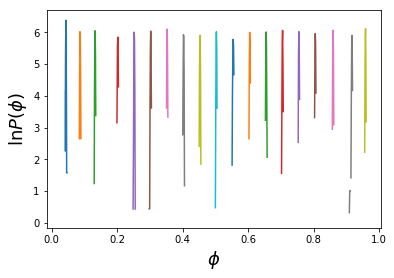

In [401]:
nbins = 50

dat = np.loadtxt('umbrella50/data0.05',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.1',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.15',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.2',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.25',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.3',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.35',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.4',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.45',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.5',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.55',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.6',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.65',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.7',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.75',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.8',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.85',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.9',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella50/data0.95',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

pp.xlabel(r'$\phi$',fontsize=18)
pp.ylabel(r'$\ln P(\phi)$',fontsize=18)

/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log
  
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log
  # This is added back by InteractiveShellApp.init_path()
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log
  app.launch_new_instance()
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:26: RuntimeWarning: divide by zero encountered in log
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in log
/home/klymko/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: RuntimeWarning: divide by zero encountered in log
/home/klymko/min

Text(0, 0.5, '$\\ln P(\\phi)$')

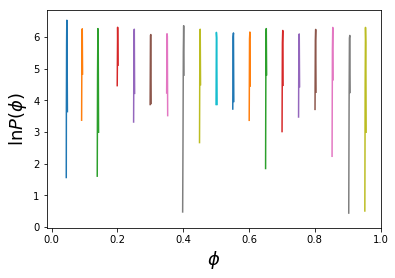

In [404]:
nbins = 50

dat = np.loadtxt('umbrella100/data0.05',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.1',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.15',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.2',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.25',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.3',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.35',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.4',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.45',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.5',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.55',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.6',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.65',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.7',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.75',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.8',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.85',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.9',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('umbrella100/data0.95',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

pp.xlabel(r'$\phi$',fontsize=18)
pp.ylabel(r'$\ln P(\phi)$',fontsize=18)
#matshow(velx[:, 16, :])
#colorbar()

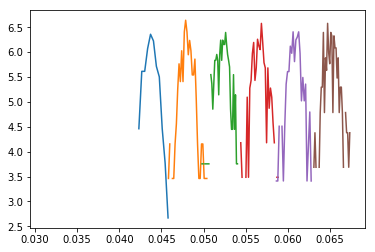

In [426]:
nbins = 50

dat = np.loadtxt('data0.05',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('data0.055',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('data0.06',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('data0.065',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('data0.07',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))

dat = np.loadtxt('data0.075',usecols=[0],unpack=True)
histx,binsx=np.histogram(dat,bins=nbins,density=True)
centerx = (binsx[:-1]+binsx[1:])/2
pp.plot(centerx,np.log(histx))


## Plot Final State of the Simulation

In [207]:
def plot_index(data_file, str_field, str_coord):
    substitute_header(data_file)
    
    # Loads the data file
    ds = yt.load(data_file)
    
    # Takes a slice perpendicular to the coordinate represented by `str_coord`
    # -> the slice is at the center of the box.
    # -> the data field being sliced has to have the same name as `str_field`
    slc = yt.SlicePlot(ds, str_coord, str_field)
    
    # Set the plotted variable to log scale
    #slc.set_log(str_field, True)
    
    # Show data
    slc.show()
    #slc.save("step_0.png")

Let's find out what fields are contained in the plot file

In [208]:
#ds = yt.load(data_files[-1])
ds = yt.load(data_files[0])
ds.field_list

yt : [INFO     ] 2019-05-15 17:10:39,501 Parameters: current_time              = 0.0
yt : [INFO     ] 2019-05-15 17:10:39,502 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-15 17:10:39,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-15 17:10:39,504 Parameters: domain_right_edge         = [4. 4. 1.]


[('boxlib', 'phi')]

Plot the last plot file's $y$-velocity (slicing normal the $y$-axis).

yt : [INFO     ] 2019-05-15 16:15:19,915 Parameters: current_time              = 0.12204589843751103
yt : [INFO     ] 2019-05-15 16:15:19,915 Parameters: domain_dimensions         = [128 128   1]
yt : [INFO     ] 2019-05-15 16:15:19,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-15 16:15:19,917 Parameters: domain_right_edge         = [4. 4. 1.]
yt : [INFO     ] 2019-05-15 16:15:20,007 xlim = 0.000000 4.000000
yt : [INFO     ] 2019-05-15 16:15:20,007 ylim = 0.000000 4.000000
yt : [INFO     ] 2019-05-15 16:15:20,008 xlim = 0.000000 4.000000
yt : [INFO     ] 2019-05-15 16:15:20,008 ylim = 0.000000 4.000000
yt : [INFO     ] 2019-05-15 16:15:20,009 Making a fixed resolution buffer of (('boxlib', 'con')) 800 by 800
yt : [WARNING  ] 2019-05-15 16:15:20,025 Plot image for field ('boxlib', 'con') has both positive and negative values. Min = -0.232283, Max = 0.270227.
yt : [WARNING  ] 2019-05-15 16:15:20,026 Switching to symlog colorbar scaling unless linear scal


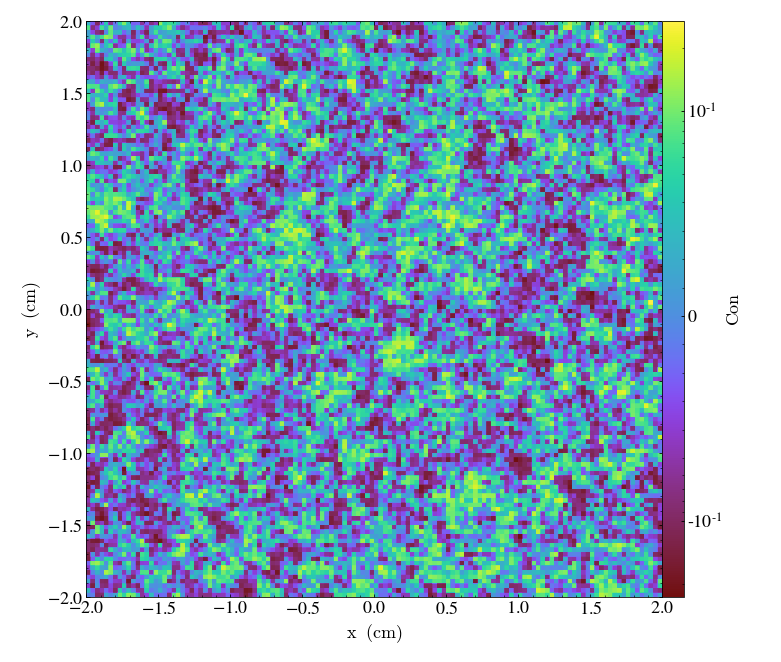

In [174]:
plot_index(data_files[1], "con","z")

In [167]:
square = ds.covering_grid(level=0, fields=["con"], 
                        left_edge=ds.domain_left_edge, dims=ds.domain_dimensions)


[[ 0.05368332  0.04661508  0.06444788 ...  0.01058798  0.15684569
   0.09686776]
 [-0.05432546  0.01548115  0.07977474 ...  0.05679732  0.09976148
   0.06171948]
 [ 0.07437379  0.14328846  0.18004865 ...  0.16594379  0.17466169
   0.04133792]
 ...
 [ 0.06164738  0.16846984 -0.01546391 ...  0.06711101 -0.00428369
   0.13356943]
 [ 0.06794891  0.18863275  0.07760507 ...  0.09557366  0.009216
   0.04368256]
 [ 0.00404956  0.10060105  0.06692401 ...  0.03562068  0.02967552
   0.00343479]] dimensionless


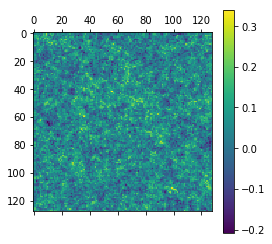

In [263]:
data = square["con"]
matshow(data[:,:,0])
colorbar()
print(data[:,:,0])

# Analyse Data

... with `numpy`

## Velocity fluctuations

In [98]:
ds = yt.load(data_files[-1])
ds.domain_dimensions

yt : [INFO     ] 2019-05-15 12:13:31,786 Parameters: current_time              = 0.24411621093753877
yt : [INFO     ] 2019-05-15 12:13:31,786 Parameters: domain_dimensions         = [32 32  1]
yt : [INFO     ] 2019-05-15 12:13:31,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-05-15 12:13:31,787 Parameters: domain_right_edge         = [1. 1. 1.]


array([32, 32,  1])

Get information about geometry: $\mathrm{d}x$ and index of centre (ask Johannes what this is for and why it's not working for our data)

In [135]:
matshow(data[:, :, 0])
colorbar()

In [147]:
new_data = data[:,:,0]
print(new_data[0,0])
np.sum(new_data*(1./32.)*(1./32.)) #make sure that our units of dx and dy are correct

0.16350016192388106 dimensionless


0.608951080964776 dimensionless

Extract a "cube of data" from the plot file. This might seem a bit convoluted, but remember that YT is built to handle multi-level data. This function covers a given level (in our case, level 0) with a 3D grid (cube) and exports the data into a dict of `numpy` arrays. This way `cube["filed name"]` is a 3D numpy array.

In [17]:
cube = ds.covering_grid(level=0, fields=["shifted_velx", "shifted_vely", "shifted_velz"], 
                        left_edge=ds.domain_left_edge, dims=ds.domain_dimensions)
velx = cube["shifted_velx"]
vely = cube["shifted_vely"]
velz = cube["shifted_velz"]

Double-check the data.

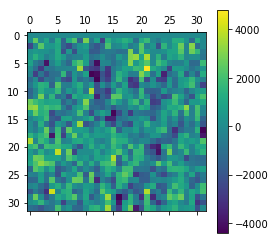

In [20]:
matshow(velx[:, 16, :])
colorbar()

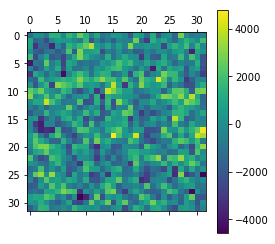

In [21]:
matshow(vely[:, 16, :])
colorbar()

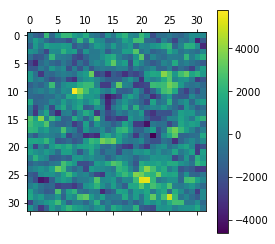

In [22]:
matshow(velz[:, 16, :])
colorbar()

## Remove Average `vely`

The $y$-data might seem smooth. But there will be tiny fluctuations. In order to see those, let's compute the average in dimensions 2 and 3.

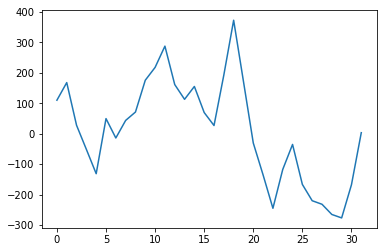

In [23]:
m_vely = mean(mean(vely[:, :, :], axis=1), axis=1)
#              ^^-- returns a 2D array of average velocities
#         ^^------- returns a 1D array of average velocities (the average of the previous average)
plot(m_vely)

Compute fluctuations: `m_vely` is applied to all `dim=1` slices

In [25]:
# slice-wise subtraction of the average velocity... 
# I can't think of a fancy pythonic way of doing this => I'll do it in this cumbersome way:
fluct_vely = np.zeros_like(vely)
for i in range(vely.shape[0]):
    for j in range(vely.shape[1]):
            fluct_vely[:, i, j] = vely[:, i, j] - m_vely[:]

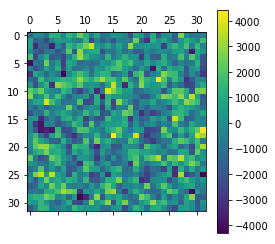

In [26]:
matshow(fluct_vely[:, 16, :])
colorbar()

## Compute $x$, $y$ and $z$ Temperatures (Fluctuations in `velx`, `vely`, `velz`)

In [27]:
t_x = mean(mean(velx[:, :, :]**2, axis=1), axis=1)
#           ^^-- returns a 2D array of average velocities
#      ^^------- returns a 1D array of average velocities (the average of the previous average)
t_x = sqrt(t_x)

In [28]:
t_y = mean(mean(fluct_vely[:, :, :]**2, axis=1), axis=1)
#           ^^-- returns a 2D array of average velocities
#      ^^------- returns a 1D array of average velocities (the average of the previous average)
t_y = sqrt(t_y)

In [29]:
t_z = mean(mean(velz[:, :, :]**2, axis=1), axis=1)
#           ^^-- returns a 2D array of average velocities
#      ^^------- returns a 1D array of average velocities (the average of the previous average)
t_z = sqrt(t_z)

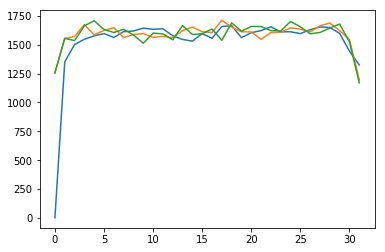

In [30]:
plot(t_x)
plot(t_y)
plot(t_z)

We see that the $x$-fluctuations are supressed due to the wall $\Rightarrow{}$ needs fixing!

# Old Stuff $\Rightarrow{}$ Clean up at some point

In [22]:
def grad(phi):
    dphi_x = np.zeros_like(phi)
    dphi_y = np.zeros_like(phi)
    dphi_z = np.zeros_like(phi)
    
    dphi_x[ :-1, :, :] += phi[1:,   :, :]
    dphi_x[1:,   :, :] -= phi[ :-1, :, :]
    
    dphi_y[:,  :-1, :] += phi[:, 1:,   :]
    dphi_y[:, 1:,   :] -= phi[:,  :-1, :]
    
    dphi_z[:, :,  :-1] += phi[:, :, 1:, ]
    dphi_z[:, :, 1:  ] -= phi[:, :,  :-1]
    
    return dphi_x, dphi_y, dphi_z

In [23]:
grad_x, grad_y, grad_z = grad(cube["con"])

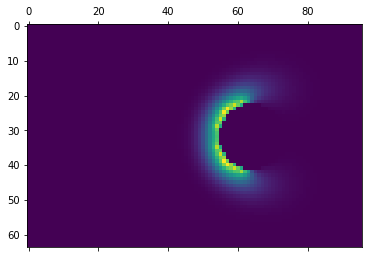

In [250]:
matshow(cube['con'][32, :, :])

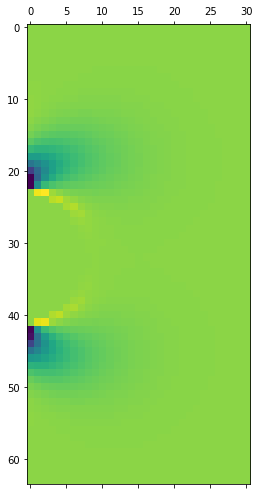

In [108]:
matshow(grad_z[32, :, 65:])

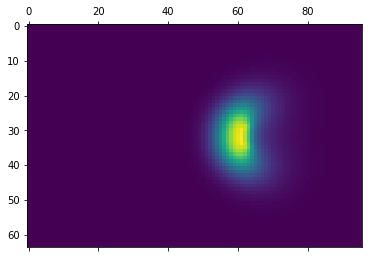

In [252]:
matshow(cube['con'][43, :, :])

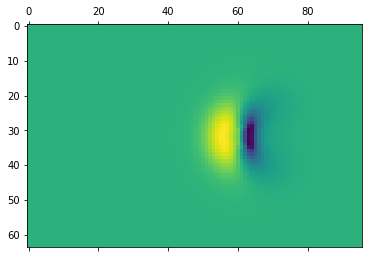

In [251]:
matshow(grad_z[43, :, :])

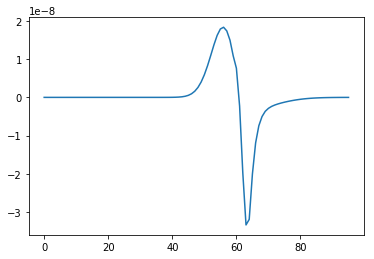

In [246]:
plot(grad_z[43, 30, :])

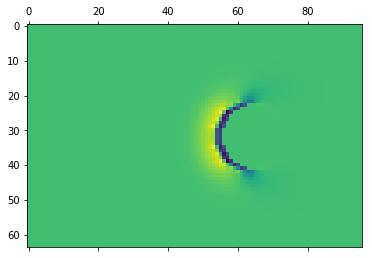

In [187]:
matshow(grad_z[32, :, :])

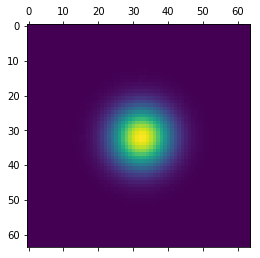

In [188]:
matshow(cube['con'][:, :, 45])

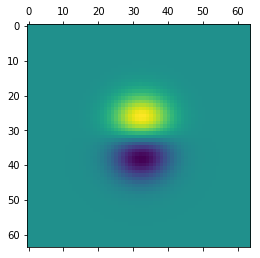

In [193]:
matshow(grad_x[:, :, 45])

In [490]:
def sphere_coord(i_x, i_y, i_z, dr=dx, r_c=centre_colloid):
    x = (i_x + 0.5)*dr[0] - r_c[0]
    y = (i_y + 0.5)*dr[1] - r_c[1]
    z = (i_z + 0.5)*dr[2] - r_c[2]
    
    r     = np.sqrt( x**2 + y**2 + z**2)
    theta = np.arccos(z/r)
    phi   = np.arctan2(y, x)
        
    return r, theta, phi

def r_unit(theta, phi):
    return np.array([
        np.sin(theta)*np.cos(phi),
        np.sin(theta)*np.sin(phi),
        np.cos(theta)
    ])

def theta_unit(theta, phi):
    return np.array([
        np.cos(theta)*np.cos(phi),
        np.cos(theta)*np.sin(phi),
       -np.sin(theta)
    ])

def phi_unit(phi):
    return np.array([
       -np.sin(phi),
        np.cos(phi),
        0
    ])

In [491]:
def grad_sphere(grad_x, grad_y, grad_z):
    grad_r     = np.zeros_like(grad_x)
    grad_phi   = np.zeros_like(grad_y)
    grad_theta = np.zeros_like(grad_z)
    
    r_dat     = np.zeros_like(grad_x)
    phi_dat   = np.zeros_like(grad_x)
    theta_dat = np.zeros_like(grad_x)
    
    for ind, x in ndenumerate(grad_x):
        y = grad_y[ind]
        z = grad_z[ind]
        
        r, theta, phi = sphere_coord(ind[0], ind[1], ind[2])
        r_vec     = r_unit(theta, phi)
        theta_vec = theta_unit(theta, phi)
        phi_vec   = phi_unit(phi)
        
        grad_r[ind]     = np.dot(np.array([x, y, z]), r_vec)
        grad_phi[ind]   = np.dot(np.array([x, y, z]), phi_vec)
        grad_theta[ind] = np.dot(np.array([x, y, z]), theta_vec)
        
        r_dat[ind]     = r
        phi_dat[ind]   = phi
        theta_dat[ind] = theta
        
    return np.array(grad_r), np.array(grad_phi), np.array(grad_theta), r_dat, phi_dat, theta_dat

In [492]:
grad_r, grad_phi, grad_theta, r_dat, phi_dat, theta_dat = grad_sphere(grad_x, grad_y, grad_z)

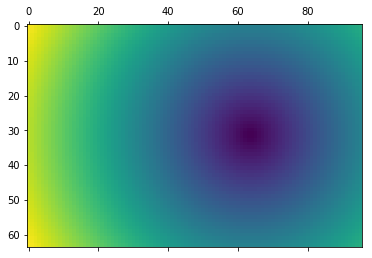

In [493]:
matshow(r_dat[32, :, :])

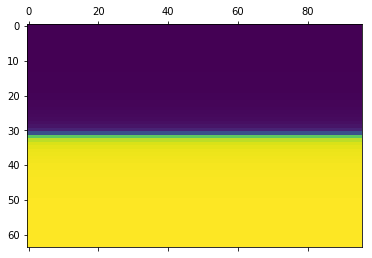

In [494]:
matshow(phi_dat[32, :, :])

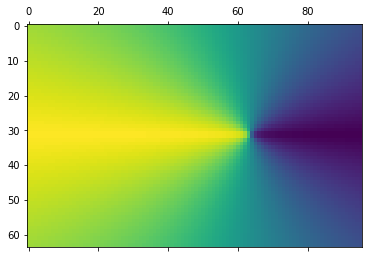

In [495]:
matshow(theta_dat[32, :, :])

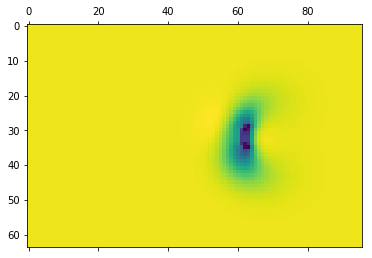

In [496]:
matshow(grad_norm[43, :, :])

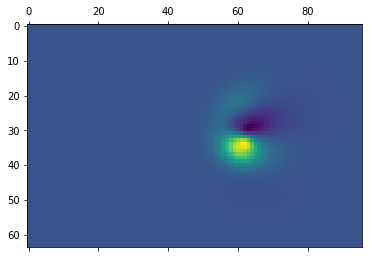

In [497]:
matshow(grad_phi[45, :, :])

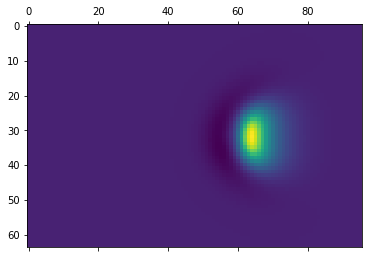

In [498]:
matshow(grad_theta[45, :, :])

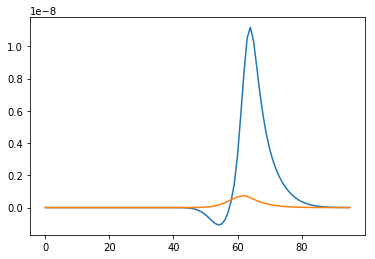

In [507]:
plot(grad_theta[45, 32, :])
plot(grad_phi[45, 40, :])

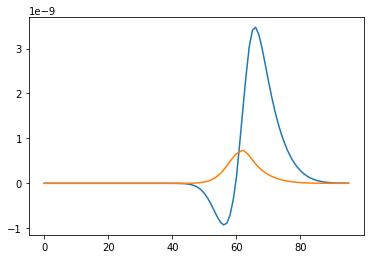

In [500]:
plot(grad_theta[45, 40, :])
plot(grad_phi[45, 40, :])

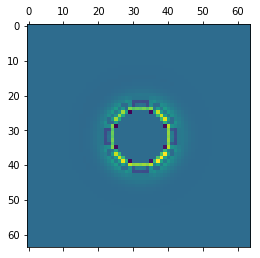

In [501]:
matshow(grad_theta[:, :, 60])

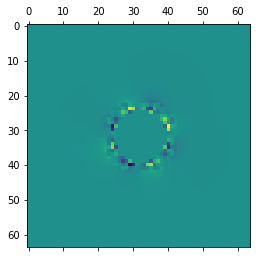

In [502]:
matshow(grad_phi[:, :, 60])

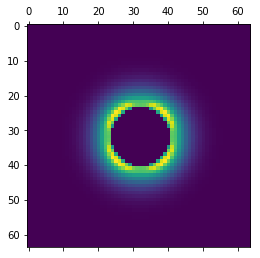

In [503]:
matshow(cube['con'][:, :, 60])

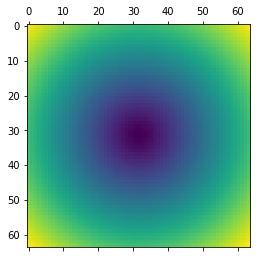

In [504]:
matshow(r_dat[:, :, 60])

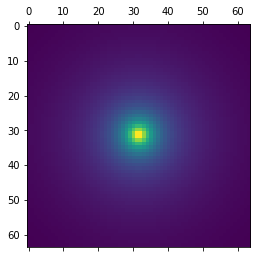

In [505]:
matshow(theta_dat[:, :, 60])

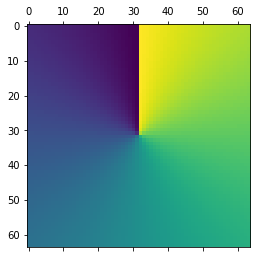

In [506]:
matshow(phi_dat[:, :, 60])

In [566]:
def scan_theta(r, phi, theta_range, grad_x, grad_y, grad_z, r_c=centre_colloid, dr=dx):
    scan = np.zeros_like(theta_range)
    
    for i, theta in enumerate(theta_range):
        x = r_c[0] + r * np.sin(theta)*np.cos(phi)
        y = r_c[1] + r * np.sin(theta)*np.sin(phi)
        z = r_c[2] + r * np.cos(theta)
                
        i_x = int(x / dx[0])
        i_y = int(y / dx[1])
        i_z = int(z / dx[2])
        
        dphi_x = grad_x[i_x, i_y, i_z]
        dphi_y = grad_y[i_x, i_y, i_z]
        dphi_z = grad_z[i_x, i_y, i_z]
        
        e_theta = theta_unit(theta, phi)
        scan[i] = np.dot(np.array([dphi_x, dphi_y, dphi_z]), -e_theta)
    
    return scan

In [575]:
x = np.linspace(0, np.pi, num=100)
y_1 = scan_theta(1.4e-3, 0.0, x, grad_x, grad_y, grad_z)
y_2 = scan_theta(1.4e-3, 0.5, x, grad_x, grad_y, grad_z)
y_3 = scan_theta(1.4e-3, 1, x, grad_x, grad_y, grad_z)

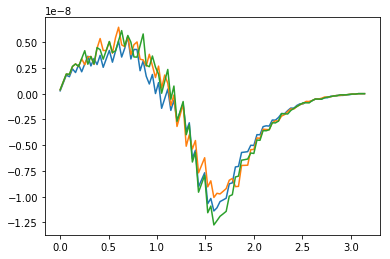

In [576]:
plot(np.pi-x, y_1)
plot(np.pi-x, y_2)
plot(np.pi-x, y_3)

In [536]:
y

array([-5.19956799e-12, -9.90351103e-12,  2.45341939e-11,  8.23369146e-11,
        7.14958822e-11,  1.59297975e-10,  2.61999920e-10,  1.72984853e-10,
        3.72419997e-10,  5.88664859e-10,  3.00852487e-10,  8.73706502e-10,
        6.30019379e-10,  1.50342756e-09,  1.77051944e-09,  2.45637687e-09,
        2.59605648e-09,  2.31715544e-09,  5.07192789e-09,  6.82647158e-09,
        6.27703487e-09,  1.17232692e-08,  2.37962129e-08,  2.23885478e-08,
        5.35642232e-08,  5.53590911e-08,  3.40695350e-08,  2.93257998e-08,
        5.97063264e-09, -1.03368693e-08, -8.55812215e-09,  1.01674588e-08,
       -8.58186650e-09, -6.43166241e-09,  1.32708742e-08, -2.06442949e-09,
       -3.68020493e-09,  8.11566168e-10, -1.95380568e-08,  3.11817098e-09,
       -6.21240799e-09, -1.30965645e-08,  1.00154766e-08, -3.32335727e-09,
       -1.34244697e-08, -1.42038172e-08, -1.19530449e-08, -7.31007113e-09,
       -2.25383236e-09, -2.81931432e-10])

In [509]:
sel = np.abs(r_dat - 1.1e-3) < 1e-3
sum(sel)

39016

In [510]:
theta_sel = theta_dat[sel]
phi_sel   = phi_dat[sel]

grad_norm_sel  = grad_norm[sel]
grad_phi_sel   = grad_phi[sel]
grad_theta_sel = grad_theta[sel]

In [511]:
phi_selector = np.abs(phi_sel - 0.6) < 1e-3
sum(phi_selector)

36

In [512]:
sorted_pts = np.array(sorted(zip(theta_sel[phi_selector], grad_theta_sel[phi_selector])))

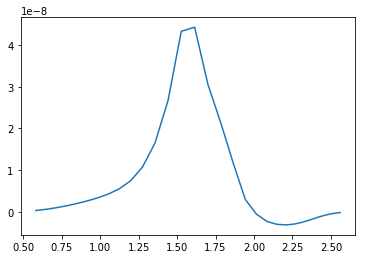

In [513]:
plot(sorted_pts[:,0], sorted_pts[:,1])

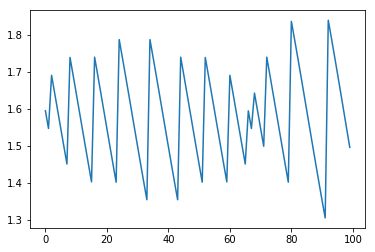

In [514]:
plot(theta_sel[:100])